In [1]:

import torch
#collections是python一个内置模块，提供了一些有用的数据结构
from collections import OrderedDict  #这个类是字典dict的一个子类，用于创建有序的字典。普通字典中元素顺序是无序的，在OrderedDict中元素的顺序是有序的，元素的顺序是按照它们被添加到字典中的顺序决定的。

from pyDOE import lhs #`pyDOE`是一个Python库，用于设计实验。它提供了一些函数来生成各种设计，如因子设计、拉丁超立方设计等。`lhs`是库中的一个函数，全名为"Latin Hypercube Sampling"，拉丁超立方采样。这是一种统计方法，用于生成一个近似均匀分布的多维样本点集。它在参数空间中生成一个非常均匀的样本，这对于高维数值优化问题非常有用，因为它可以更好地覆盖参数空间。
import numpy as np
import matplotlib.pyplot as plt
import scipy.io #导入了scipy库中的io模块。scipy.io模块包含了一些用于文件输入/输出的函数，例如读取和写入.mat文件（MATLAB格式）
from scipy.interpolate import griddata #`scipy.interpolate`是`scipy`库中的一个模块，提供了许多插值工具，用于在给定的离散数据点之间进行插值和拟合。`griddata`是这个模块中的一个函数，用于在无规则的数据点上进行插值。

import random

import skopt #用于优化问题的库，特别是机器学习中的超参数优化
from distutils.version import LooseVersion #distutils是Python的一个标准库，用于构建和安装Python包。LooseVersion是一个类，用于比较版本号


# from plotting_torch import newfig, savefig #从自定义的plotting_torch.py文件中导入了newfig和savefig函数。这两个函数用于创建和保存图形。这两个函数的定义在plotting_torch.py文件中

from mpl_toolkits.axes_grid1 import make_axes_locatable #`mpl_toolkits.axes_grid1`是`matplotlib`库的一个模块，提供了一些高级的工具来控制matplotlib图形中的坐标轴和颜色条。`make_axes_locatable`是模块中的一个函数，用于创建一个可分割的坐标轴。可以在这个坐标轴的四个方向（上、下、左、右）添加新的坐标轴或颜色条。
import matplotlib.gridspec as gridspec #是`matplotlib`库的一个模块，用于创建一个网格布局来放置子图。在`matplotlib`中可以创建一个或多个子图（subplot），每个子图都有自己的坐标轴，并可以在其中绘制图形。`gridspec`模块提供了一个灵活的方式来创建和放置子图。
import time #一个内置模块，用于处理时间相关的操作。


from tqdm import tqdm #一个快速，可扩展的python进度条库，可以在python长循环中添加一个进度提示信息，用户只需要封装任意的迭代器tqdm(iterator)。

import os
import pickle

import timeit #用于计时和测量小段代码的执行时间
import seaborn as sns  # 导入seaborn库用于绘制密度图
import pandas as pd #一个用于数据操作和分析的库，提供了数据结构和数据分析工具，特别是用于处理表格数据（类似于Excel中的数据表）

import sys #导入sys模块。sys模块提供了一些变量和函数，用于与 Python解释器进行交互和访问。例如，sys.path 是一个 Python 在导入模块时会查找的路径列表，sys.argv 是一个包含命令行参数的列表，sys.exit() 函数可以用于退出 Python 程序。导入 sys 模块后，你就可以在你的程序中使用这些变量和函数了。
sys.path.insert(0, '../../..') #在 Python的sys.path列表中插入一个新的路径。sys.path是一个 Python 在导入模块时会查找的路径列表。新的路径'../../Utilities/'相对于当前脚本的路径。当你尝试导入一个模块时，Python 会在 sys.path 列表中的路径下查找这个模块。通过在列表开始位置插入一个路径，你可以让 Python 优先在这个路径下查找模块。这在你需要导入自定义模块或者不在 Python 标准库中的模块时非常有用。
from util import *

In [2]:
torch.cuda.set_device(0) #设置当前使用的GPU设备。这里设置为1号GPU设备（第二块显卡）。

# CUDA support 

#设置pytorch的设备，代表了在哪里执行张量积算，设备可以是cpu或者cuda（gpu），并将这个做运算的设备对象存储在变量device中，后续张量计算回在这个设备上执行
if torch.cuda.is_available():
    device = torch.device('cuda')
else:
    device = torch.device('cpu')

In [3]:
# implementation of PINNsformer
# paper: PINNsFormer: A Transformer-Based Framework For Physics-Informed Neural Networks
# link: https://arxiv.org/abs/2307.11833

import torch
import torch.nn as nn
import pdb

from util import get_clones


#自定义激活函数Wavelet：w1 * sin(x) + w2 * cos(x)
class WaveAct(nn.Module):
    def __init__(self):
        super(WaveAct, self).__init__() 
        #自定义两个可学习参数w1和w2，初始化为1，训练过程中会更新这两个参数
        self.w1 = nn.Parameter(torch.ones(1), requires_grad=True)
        self.w2 = nn.Parameter(torch.ones(1), requires_grad=True)

    def forward(self, x):
        return self.w1 * torch.sin(x)+ self.w2 * torch.cos(x)

#MLP组件，第一层形状为(d_model, d_ff)，第二层形状为(d_ff, d_ff)，第三层形状为(d_ff, d_model)，前两个使用自定义激活函数WaveAct
class FeedForward(nn.Module):
    def __init__(self, d_model, d_ff=256):
        super(FeedForward, self).__init__() 
        self.linear = nn.Sequential(*[
            nn.Linear(d_model, d_ff),
            WaveAct(),
            nn.Linear(d_ff, d_ff),
            WaveAct(),
            nn.Linear(d_ff, d_model)
        ])

    def forward(self, x):
        return self.linear(x)

#编码器层
class EncoderLayer(nn.Module):
    def __init__(self, d_model, heads):
        super(EncoderLayer, self).__init__()
        self.attn = nn.MultiheadAttention(embed_dim=d_model, num_heads=heads, batch_first=True) #多头注意力，设置嵌入维度为d_model，头数为heads，batch_first=True表示输入和输出tensor以(批量大小,序列长度,嵌入维度) 形式提供
        self.ff = FeedForward(d_model) #MLP组件，输入和输出的形状均为d_model，隐藏层的形状为d_ff默认
        self.act1 = WaveAct() #激活函数
        self.act2 = WaveAct() #激活函数
        
    def forward(self, x): #形状为(点的数量，序列长度，d_model)
        x2 = self.act1(x) #对输入x应用激活函数
        # pdb.set_trace()
        x = x + self.attn(x2,x2,x2)[0] #多头注意力机制，查询、键和值均为原始输入经过激活函数后的x2，然后使用残差连接原始输入得到自注意力的输出
        x2 = self.act2(x) #对自注意力的输出应用激活函数
        x = x + self.ff(x2) #将通过激活函数后的自注意力输出通过MLP组件后残差连接原始自注意力输出，得到编码器的输出
        return x 


class DecoderLayer(nn.Module):
    def __init__(self, d_model, heads):
        super(DecoderLayer, self).__init__()
        self.attn = nn.MultiheadAttention(embed_dim=d_model, num_heads=heads, batch_first=True) # 多头注意力，设置嵌入维度为d_model，头数为heads，batch_first=True表示输入和输出tensor以(批量大小,序列长度,嵌入维度) 形式提供
        self.ff = FeedForward(d_model) #MLP组件，输入和输出的形状均为d_model，隐藏层的形状为d_ff默认
        self.act1 = WaveAct() #激活函数
        self.act2 = WaveAct() #激活函数

    def forward(self, x, e_outputs): #输入形状为(点的数量，序列长度，d_model)，e_outputs为编码器的输出，形状也是为(点的数量，序列长度，d_model)
        x2 = self.act1(x) #将解码器输入x通过激活函数
        x = x + self.attn(x2, e_outputs, e_outputs)[0] #多头注意力机制，查询为解码器输入经过激活函数后的x2，键和值为编码器的输出e_outputs，然后使用残差连接原始输入得到自注意力的输出
        x2 = self.act2(x) #将自注意力的输出通过激活函数
        x = x + self.ff(x2) #将通过激活函数后的自注意力输出通过MLP组件后残差连接原始自注意力输出，得到解码器的输出
        return x

#编码器层，包含多个堆叠的编码器架构
class Encoder(nn.Module):
    def __init__(self, d_model, N, heads): #参数N代表编码器的头数，N代表包含几个编码器，d_model是数据的嵌入维度（用于每个编码器），heads是头的数量
        super(Encoder, self).__init__()
        self.N = N 
        self.layers = get_clones(EncoderLayer(d_model, heads), N) #N个编码器
        self.act = WaveAct()

    def forward(self, x): #输入一次通过N个编码器，x的形状为(点的数量，序列长度，d_model)
        for i in range(self.N):
            x = self.layers[i](x)
        return self.act(x) #编码器的输出要经过激活函数

#解码器层，包含多个堆叠的解码器架构
class Decoder(nn.Module):
    def __init__(self, d_model, N, heads): #参数N代表解码器的头数，N代表包含几个解码器，d_model是数据的嵌入维度（用于每个解码器），heads是头的数量
        super(Decoder, self).__init__()
        self.N = N
        self.layers = get_clones(DecoderLayer(d_model, heads), N) #N个解码器
        self.act = WaveAct()
        
    def forward(self, x, e_outputs): #输入一次通过N个解码器层，x的形状为(点的数量，序列长度，d_model)，e_outputs为编码器的输出，形状也是为(点的数量，序列长度，d_model)
        for i in range(self.N): #输入和编码器输出依次通过N个解码器
            x = self.layers[i](x, e_outputs) 
        return self.act(x) #解码器的输出要经过激活函数



class DNN(nn.Module):
    def __init__(self, d_out, d_model, d_hidden, N, heads): #接受参数为：d_out代表整个模型的输出的维度（就是最后的mlp层的输出维度），d_model代表每个点的特征嵌入维度，d_hidden代表最后的output layer模块中的隐藏层的维度，N代表编码器和解码器的层数，heads代表多头注意力机制的头数
        super(DNN, self).__init__()

        self.linear_emb = nn.Linear(2, d_model) #线性层，将输入的2维数据映射到d_model维度

        self.encoder = Encoder(d_model, N, heads) #编码器层
        self.decoder = Decoder(d_model, N, heads) #解码器层

        #输出的mlp模块，包含三个线性层，前两个使用自定义激活函数WaveAct，最终将feature从d_model维度映射到d_hidden维度，最后将d_hidden维度映射到d_out维度
        self.linear_hidden = nn.Sequential(*[
            nn.Linear(d_model, d_hidden),
            WaveAct(),
            nn.Linear(d_hidden, d_hidden),
            WaveAct(),
            nn.Linear(d_hidden, 2),
        ])
        self.linear_out = nn.Sequential(*[
            WaveAct(),
            nn.Linear(2, d_out)
        ])

    def forward(self, x): #输入的x形状一般为(点的数量, 序列长度, 2)
        src = x #形状为(点的数量，序列长度，2)
        src = self.linear_emb(src) #特征向量通过第一个线性层，映射到高维，此时src的形状为(点的数量，序列长度，d_model)，d_model代表每个点的特征

        e_outputs = self.encoder(src) #编码器处理输入特征向量，得到编码后的输出，形状为(点的数量，序列长度，d_model)
        d_output = self.decoder(src, e_outputs) #解码器处理输入特征向量和编码后的输出，得到解码后的输出，形状为(点的数量，序列长度，d_model)
        output_hidden = self.linear_hidden(d_output) #解码后的输出通过输出的mlp模块，得到最终的预测结果。形状为(点的数量，序列长度，2)，d_out代表输出的维度
        output = self.linear_out(output_hidden) #形状为(点的数量，序列长度，d_out)，d_out代表输出的维度
        # pdb.set_trace()
        # raise Exception('stop')
        return output #(点的数量，序列长度，d_out)
    
    # 新增方法，获取最后一个隐藏层的输出
    def hidden_output(self, x):
        src = x #形状为(点的数量，序列长度，2)
        src = self.linear_emb(src) #特征向量通过第一个线性层，映射到高维，此时src的形状为(点的数量，序列长度，d_model)，d_model代表每个点的特征

        e_outputs = self.encoder(src) #编码器处理输入特征向量，得到编码后的输出，形状为(点的数量，序列长度，d_model)
        d_output = self.decoder(src, e_outputs) #解码器处理输入特征向量和编码后的输出，得到解码后的输出，形状为(点的数量，序列长度，d_model)
        output_hidden = self.linear_hidden(d_output) #解码后的输出通过输出的mlp模块，得到最终的预测结果。形状为(点的数量，序列长度，2)，d_out代表输出的维度
        # output = self.linear_out(output_hidden) #形状为(点的数量，序列长度，d_out)，d_out代表输出的维度
        # pdb.set_trace()
        # raise Exception('stop')
        return output_hidden #(点的数量，序列长度，2)

    
   

In [4]:
#set the class of PINN

#定义了一个名为`PhysicsInformedNN'的类，用于实现基于物理的神经网络。
class PhysicsInformedNN:
    # Initialize the class
    def __init__(self, x0, u0, tb, X_f, lb, ub): #这个类包含的第一个方法__init__，这是一个特殊的方法，也就是这个类的构造函数，用于初始化新创建的对象，接受了几个参数
        
        
        X0 = np.concatenate((x0,0*x0), 1) # [x0, 0],将x0和0*x0两个数组在第二个维度（即列）上进行了合并。0*x0会生成一个与x0形状相同，但所有元素都为0的数组。因此，X0的结果是一个新的二维数组，其中第一列是x0的值，第二列全为0
        X_lb = np.concatenate((0*tb+lb[0],tb), 1) # [lb[0], tb],将0*tb+lb[0]和tb两个数组在第二个维度（即列）上进行了合并。0*tb+lb[0]会生成一个与tb形状相同，但所有元素都为lb[0]的数组。因此，X_lb的结果是一个新的二维数组，其中第一列全为lb[0]的值，第二列是tb的值。
        X_ub = np.concatenate((0*tb+ub[0],tb), 1) # [ub[0], tb],同上生成一个与tb形状相同，但所有元素都为ub[0]的数组。因此，X_ub的结果是一个新的二维数组，其中第一列全为ub[0]的值，第二列是tb的值

        X0 = make_time_sequence(X0, num_step=5, step=1e-4) #将形状从(点的数量，2)变为(点的数量，序列长度，2) 
        X_lb = make_time_sequence(X_lb, num_step=5, step=1e-4) #将形状从(点的数量，2)变为(点的数量，序列长度，2) 
        X_ub = make_time_sequence(X_ub, num_step=5, step=1e-4)
        X_f = make_time_sequence(X_f, num_step=5, step=1e-4) #将形状从(点的数量，2)变为(点的数量，序列长度，2)


        self.lb = torch.tensor(lb).float().to(device) #将传入的lb和ub参数的值存储在实例中，以便后续使用。这样可以在类的其他方法中通过self.lb和self.ub来访问这些值。
        self.ub = torch.tensor(ub).float().to(device)


        self.x0 = torch.tensor(X0[:,:, 0:1], requires_grad=True).float().to(device) #将X0的第一列赋值给self.x0（:表示取所有行,0：1实际上表示取第一列，因为python是左闭右开的）,将X0的第二列赋值给self.t0。这样可以在类的其他方法中通过self.x0和self.t0来访问这些值。
        self.t0 = torch.tensor(X0[:,:, 1:2], requires_grad=True).float().to(device) #将x0的第二列赋值给self.t0

        self.x_lb = torch.tensor(X_lb[:,:, 0:1], requires_grad=True).float().to(device) #将X_lb的第一列赋值给self.x_lb
        self.t_lb = torch.tensor(X_lb[:,:, 1:2], requires_grad=True).float().to(device) #将X_lb的第二列赋值给self.t_lb

        self.x_ub = torch.tensor(X_ub[:,:, 0:1], requires_grad=True).float().to(device) #将X_ub的第一列赋值给self.x_ub
        self.t_ub = torch.tensor(X_ub[:,:, 1:2], requires_grad=True).float().to(device) #将X_ub的第二列赋值给self.t_ub
        
        self.x_f = torch.tensor(X_f[:,:, 0:1], requires_grad=True).float().to(device) #将X_f的第一列赋值给self.x_f
        self.t_f = torch.tensor(X_f[:,:, 1:2], requires_grad=True).float().to(device) #将X_f的第二列赋值给self.t_f
        
        self.u0 = torch.tensor(u0).float().to(device) #将传入的u0和v0参数的值存储在实例中，以便后续使用。这样可以在类的其他方法中通过self.u0和self.v0来访问这些值。
        
        
        
        
        # deep neural networks
        self.dnn = DNN(d_out=1, d_hidden=512, d_model=32, N=1, heads=2).to(device) 
        self.dnn.apply(self.init_weights) #初始化模型中线性层的权重和偏置



        self.optimizer_LBFGS = torch.optim.LBFGS(self.dnn.parameters(), line_search_fn='strong_wolfe')
        #创建第二个优化器，括号内为要优化的参数，使用Adam优化方法
        self.optimizer_Adam = torch.optim.Adam(self.dnn.parameters())
                

        self.iter = 0 #记录迭代次数 

        self.loss_value = [] #创建一个空列表，用于存储损失值

    def init_weights(self, m):
        if isinstance(m, nn.Linear): #判断是否是线性层
            torch.nn.init.xavier_uniform(m.weight)
            m.bias.data.fill_(0.01)
    
    #这个函数与下面的net_u函数功能相同，只是不计算梯度，因为在记录每个epoch的error时，使用with torch.no_grad()情况下调用net_u函数会报错，不知道为啥？
    def net_u_error(self, x, t):  
        u = self.dnn(torch.cat([x, t], dim=-1))  #（第一个参数将输入的两个参数x和t在第二个维度（列）上进行拼接，形成一个新的张量）调用DNN，根据两个参数权重和偏置，以及新得到的张量，计算神经网络的输出u
        
        return u #返回神经网络的输出u和v，以及u关于x的梯度u_x和v关于x的梯度v_x


    #pytorch中
    #定义了一个名为net_u的函数/方法，用于计算神经网络的输出。这个方法接受两个参数，分别是x和t，其中x是输入数据，t是时间数据。最后返回神经网络的输出。     
    def net_u(self, x, t):  
        u = self.dnn(torch.cat([x, t], dim=-1))  #（第一个参数将输入的两个参数x和t在第二个维度（列）上进行拼接，形成一个新的张量）调用DNN，根据两个参数权重和偏置，以及新得到的张量，计算神经网络的输出u

        u_x = torch.autograd.grad(
            u, x, 
            grad_outputs=torch.ones_like(u),
            retain_graph=True,
            create_graph=True
        )[0]

        return u,u_x #两个输出(点的数量，序列长度，1)


    #定义了一个名为net_f的函数/方法，用于计算论文中的f。这个方法接受两个参数，分别是x和t，其中x是输入数据，t是时间数据。最后返回计算得到的f。
    def net_f(self, x, t):
        """ The pytorch autograd version of calculating residual """

        u,u_x=self.net_u(x,t) #调用上面的函数/方法，计算神经网络的输出（两个）以及输出关于输入x的梯度（两个）
        
        #计算u关于t的梯度，也就是u关于t的导数，这里使用了pytorch的自动求导功能
        u_t = torch.autograd.grad(
            u, t,  #输入的张量，要计算u关于t的导数
            grad_outputs=torch.ones_like(u), #生成一个与u形状相同，所有元素均为1的张量，这个参数用于指定向量-雅可比积的像两部分
            retain_graph=True, #表示计算完梯度之后保留计算图若需要多次计算梯度，则需要设置改参数为True
            create_graph=True #创建梯度的计算图，使我们能够计算高阶导数
        )[0] #这个函数的返回值是一个元组，其中包含了每个输入张量的梯度。这里只关心第一个输入张量u的梯度，所以我们使用[0]来获取这个梯度。？？？？又说只有一个梯度

        u_xx = torch.autograd.grad(
            u_x, x, 
            grad_outputs=torch.ones_like(u_x),
            retain_graph=True,
            create_graph=True
        )[0]
        
        f=u_t-0.0001*u_xx+5*u**3-5*u    #计算f,定义见论文

        return f  #(点的数量，序列长度，1)


    def loss_func(self):
        self.optimizer_LBFGS.zero_grad() #清除之前计算的梯度（在PyTorch中，梯度会累积，所以在每次新的优化迭代之前，我们需要清除之前的梯度）

        u0_pred, _  = self.net_u(self.x0, self.t0) #输出(点的数量，序列长度，1)
        u0_pred = u0_pred[:,0:1].reshape(-1,1) #(点的数量，序列长度，1)变为(点的数量，1)
        u_lb_pred, u_x_lb_pred = self.net_u(self.x_lb, self.t_lb) #两个输出(点的数量，序列长度，1)
        u_ub_pred, u_x_ub_pred = self.net_u(self.x_ub, self.t_ub) #两个输出(点的数量，序列长度，1)
        f_pred = self.net_f(self.x_f, self.t_f) #输出(点的数量，序列长度，1)

        loss = 100*torch.mean((self.u0 - u0_pred) ** 2)  + \
                torch.mean((u_lb_pred - u_ub_pred) ** 2) + \
                torch.mean((u_x_lb_pred - u_x_ub_pred) ** 2) + \
                torch.mean(f_pred ** 2)
        loss.backward() #被调用以计算损失函数关于神经网络参数的梯度。这个梯度将被用于优化器来更新神经网络参数
        
        self.iter += 1 #每调用一次损失函数，迭代次数加1


        #record the loss value
        self.loss_value.append(loss) #将计算得到的loss值添加到self.loss_value列表中


        return loss #返回loss



    
    #定义了一个名为train的函数/方法，用于训练神经网络。这个方法接受一个参数nIter，表示训练的迭代次数。
    def train(self, nIter, nIterLBFGS):
        self.dnn.train()#将神经网络设置为训练模式而不是评估模式

        #先使用Adam优化器优化nIter次
        for epoch in tqdm(range(nIter), desc='Adam'):
            u0_pred, _  = self.net_u(self.x0, self.t0) #输出(点的数量，序列长度，1)
            u0_pred = u0_pred[:,0:1].reshape(-1,1) #(点的数量，序列长度，1)变为(点的数量，1)
            u_lb_pred, u_x_lb_pred = self.net_u(self.x_lb, self.t_lb) #两个输出(点的数量，序列长度，1)
            u_ub_pred, u_x_ub_pred = self.net_u(self.x_ub, self.t_ub) #两个输出(点的数量，序列长度，1)
            f_pred = self.net_f(self.x_f, self.t_f) #输出(点的数量，序列长度，1)

            loss = 100*torch.mean((self.u0 - u0_pred) ** 2)  + \
                    torch.mean((u_lb_pred - u_ub_pred) ** 2) + \
                    torch.mean((u_x_lb_pred - u_x_ub_pred) ** 2) + \
                    torch.mean(f_pred ** 2)
            
            # Backward and optimize
            self.optimizer_Adam.zero_grad() #清除该优化器之前计算的梯度（在PyTorch中，梯度会累积，所以在每次新的优化迭代之前，我们需要清除之前的梯度）
            loss.backward() #被调用以计算损失函数关于神经网络参数的梯度。这个梯度将被用于优化器来更新神经网络参数
            self.optimizer_Adam.step()  #使用之前的优化器self.optimizer_Adam，调用step方法(执行一步优化算法)，传入损失函数self.loss_func，进行优化
            

            #record the loss value
            self.loss_value.append(loss) #将计算得到的loss值添加到self.loss_value列表中


        #Backward the optimize，使用LBFGS优化器进一步，注意这里虽然迭代了500次，但其实使用LBFGS优化器优化的次数不止500次
        for i in tqdm(range(nIterLBFGS), desc='LBFGS'):
            self.dnn.train() #将神经网络设置为训练模式而不是评估模式
            self.optimizer_LBFGS.step(self.loss_func)  #使用之前的优化器self.optimizer，调用step方法(执行一步优化算法)，传入计算损失函数的方法self.loss_func，进行优化   

                                    
    def predict(self, X): #形状(点的数量，2)
        X = make_time_sequence(X, num_step=5, step=1e-4) #将形状从(点的数量，2)变为(点的数量，序列长度，2) 
        x = torch.tensor(X[:,:, 0:1], dtype=torch.float32, requires_grad=True).to(device) #(点的数量，序列长度，1) 
        t = torch.tensor(X[:,:, 1:2], dtype=torch.float32, requires_grad=True).to(device)

        self.dnn.eval() #将神经网络切换为评估模式
        with torch.no_grad():
            u = self.net_u_error(x, t) #形状从两个(点的数量，序列长度，1)变为(点的数量，序列长度，1)
            u = u[:,0:1].reshape(-1,1) #将u的形状从(点的数量，序列长度，1)变为(点的数量，1)
            u = u.detach().cpu().numpy() #将张量u和f先从计算图中分离出来，然后转换为numpy数组，最后将这个数组移动到cpu上

        return u #u形状是(点的数量，1)
    
    def residual(self, X): #形状(点的数量，2)
        X = make_time_sequence(X, num_step=5, step=1e-4) #将形状从(点的数量，2)变为(点的数量，序列长度，2) 
        x = torch.tensor(X[:,:, 0:1], dtype=torch.float32, requires_grad=True).to(device) #(点的数量，序列长度，1) 
        t = torch.tensor(X[:,:, 1:2], dtype=torch.float32, requires_grad=True).to(device)

        self.dnn.eval() #将神经网络切换为评估模式
        
        f = self.net_f(x, t) #形状从两个(点的数量，序列长度，1)变为(点的数量，序列长度，1)
        f = torch.mean(f, dim=1).reshape(-1,1) #对f在序列长度维度上求平均，得到(点的数量，1)，即每个点的平均残差
        f = f.detach().cpu().numpy()
        return f #u形状是(点的数量，1)，f形状是(点的数量，1)
    

    def hidden_predict(self, X):#形状(点的数量，序列长度，2)
        x = torch.tensor(X[:,:, 0:1], requires_grad=True).float().to(device) #(点的数量，序列长度，1) 
        t = torch.tensor(X[:,:, 1:2], requires_grad=True).float().to(device)
        self.dnn.eval()
        with torch.no_grad():
            hidden_output = self.dnn.hidden_output(torch.cat([x, t], dim=-1)) #(点的数量，序列长度，2)
            hidden_output = hidden_output.detach().cpu().numpy()
        # hidden_output_x = hidden_output[:, 0]
        # hidden_output_t = hidden_output[:, 1]
        # hidden_output_x = hidden_output_x.detach().cpu().numpy()
        # hidden_output_t = hidden_output_t.detach().cpu().numpy()
        return hidden_output #(点的数量，序列长度，2)


In [5]:
#定义根据模型计算给定输入（点集中的点）的混沌度的函数，这个函数接受三个参数，分别是模型、输入数据和迭代次数
def calculate_chaos(model, X, num_iter): #输入是(点的数量，2)
    """
    计算模型混沌情况的函数。
    参数:
    - model: 用于预测的模型对象，必须有一个名为hidden_predict的方法。模型的hidden_predict为倒数第二层的输出，倒数第二层的维度必须和输入维度相同。
    - X: 输入数据，形状为(N_f_new, 2)，其中第一列为x0，第二列为t0。
    - num_iter: 计算混沌情况的迭代次数。
    返回:
    - distances: 每个采样点（与该采样点加上微扰比较）在最后一次迭代后的欧氏距离数组，形状为(N_f_new,)。
    """
    #对于所有的采样点
    X0 = X
    x0 = X[:, 0:1] #取X_f_train_new的第一列，赋值给x0，(N_f_new,1)形状
    t0 = X[:, 1:2] #取X_f_train_new的第二列，赋值给t0
    xs = []
    X0 = make_time_sequence(X0, num_step=5, step=1e-4) #将形状从(点的数量，2)变为(点的数量，序列长度，2)
    X = model.hidden_predict(X0) #(点的数量，序列长度，2)
    
    for i in range(num_iter): #循环num_iter次
        X = model.hidden_predict(X) #(点的数量，序列长度，2)
        xs.append(X) #新添加(点的数量，序列长度，2)

    # 给所有采样点加上一个很小的扰动
    x1 = x0 + np.random.normal(0, 0.0001) #加上一个很小的扰动，(N_f_new,1)形状
    t1 = t0 + np.random.normal(0, 0.0001)
    # 利用x0{1}和t0{1}计算x{t1}和t{t1}，存储在xs1中
    xs1 = [] #初始化xs1
    X1 = np.concatenate((x1, t1), axis=1) #(N_f_new,2)形状
    X1 = make_time_sequence(X1, num_step=5, step=1e-4) #将形状从(点的数量，2)变为(点的数量，序列长度，2)
    X1 = model.hidden_predict(X1) #(N_f_new,序列长度,2)

    for i in range(num_iter): #循环num_iter次
        X1 = model.hidden_predict(X1) #(N_f_new,序列长度,
        xs1.append(X1) #新添加(N_f_new,序列长度,2)

    

    # 计算最后一次迭代的隐藏层输出，即最后一次迭代的x和t,使用chunchaos要注释掉
    last_iter_xs = np.array(xs[-1]) #转换为数组，便于之后计算距离
    last_iter_xs1 = np.array(xs1[-1])
    distances = np.linalg.norm(last_iter_xs - last_iter_xs1, axis=(1,2))
    distances = distances.flatten()







    # #chunchaos方法
    # num_elements_to_average = 20
    # # 提取最后 20 个元素
    # last_20_xs = xs[-num_elements_to_average:] # 这是一个包含 20 个元素的列表
    # last_20_xs1 = xs1[-num_elements_to_average:] # 这是一个包含 20 个元素的列表
    # # 存储每个时间步（列表中的每个元素）的混沌度分数
    # step_chaos_scores = []
    # # 遍历最后 20 个元素,zip 将两个列表的对应元素配对
    # for step_xs, step_xs1 in zip(last_20_xs, last_20_xs1):
    #     # step_xs 和 step_xs1 都是形状为 (N_f_new, sequence_length, 2) 的数组/张量
    #     difference_step = step_xs - step_xs1 # 计算差异
    #     # 计算每个数据点在当前步的混沌度分数 (形状 (N_f_new,))
    #     # 假设使用 NumPy 进行计算
    #     step_scores = np.linalg.norm(difference_step, axis=(1, 2))
    #     # 将这 N_f_new 个分数添加到列表中
    #     step_chaos_scores.append(step_scores)

    # # step_chaos_scores 是一个包含 20 个元素的列表，每个元素都是形状为 (N_f_new,) 的 NumPy 数组
    # # 将列表转换成一个单一的 NumPy 数组，形状为 (20, N_f_new)
    # all_step_scores = np.stack(step_chaos_scores)
    # # 现在 all_step_scores 的形状是 (num_elements_to_average, N_f_new)
    # # axis 0 是时间步 (20)，axis 1 是原始数据点 (N_f_new)
    # # 计算最后 20 个时间步在每个数据点上的平均混沌度分数
    # # 沿着时间步轴 (axis=0) 求平均
    # distances = np.mean(all_step_scores, axis=0)
    # # 结果形状是 (N_f_new,)







    return distances

In [6]:
#定义设置随机数种子的函数，第一个参数seed表示种子；第二个参数用来设置CUDA的卷积操作是否确定性，默认为False，表示没有确定性
def set_seed(seed):
    # torch.manual_seed(seed) #设置pytorch的CPU随机数生成器的种子
    # torch.cuda.manual_seed_all(seed) #设置putorch的所有GPU随机数生成器的种子
    # np.random.seed(seed) #设置numpy的随机数生成器的种子
    # random.seed(seed) #设置python的内置随机数生成器的种子
    # torch.backends.cudnn.deterministic = deterministic #True会让CUDA的卷积操作变得确定性，即对于相同的输入，每次运行会得到相同的结果，False则相反
    """
    设置PyTorch的随机种子, 用于生成随机数. 通过设置相同的种子, 可以确保每次运行时生成的随机数序列相同
    """
    torch.manual_seed(seed)
 
    """
    设置PyTorch在所有可用的CUDA设备上的随机种子. 如果在使用GPU进行计算, 这个设置可以确保在不同的GPU上生成的随机数序列相同
    """
    torch.cuda.manual_seed_all(seed)
 
    """
    设置PyTorch在当前CUDA设备上的随机种子. 它与上一行代码的作用类似, 但只影响当前设备
    """
    torch.cuda.manual_seed(seed)
 
    """
    设置NumPy的随机种子, 用于生成随机数. 通过设置相同的种子，可以确保在使用NumPy的随机函数时生成的随机数序列相同
    """
    np.random.seed(seed)
    
    """
    设置Python内置的随机函数的种子. Python的random模块提供了许多随机函数, 包括生成随机数、打乱列表等. 通过设置相同的种子, 可以确保使用这些随机函数时生成的随机数序列相同
    """
    random.seed(seed)
    
    """
    设置Python的哈希种子 (哈希函数被广泛用于数据结构 (如字典和集合) 的实现，以及一些内部操作 (如查找和比较)). 通过设置相同的种子, 可以确保在不同的运行中生成的哈希结果相同
    """
    # os.environ["PYTHONHASHSEED"] = str(seed)
    
    """
    该设置确保每次运行代码时, cuDNN的计算结果是确定性的, 即相同的输入会产生相同的输出, 这是通过禁用一些非确定性的算法来实现的, 例如在卷积操作中使用的算法. 这样做可以保证模型的训练和推理在相同的硬件和软件环境下是可复现的, 即每次运行代码时的结果都相同. 但是, 这可能会导致一些性能上的损失, 因为禁用了一些优化的非确定性算法
    """
    torch.backends.cudnn.deterministic = True
    
    """
    该设置禁用了cuDNN的自动优化过程. 当它被设置为False时, PyTorch不会在每次运行时重新寻找最优的算法配置, 而是使用固定的算法配置. 这样做可以确保每次运行代码时的性能是一致的, 但可能会导致一些性能上的损失
    """
    torch.backends.cudnn.benchmark = False



In [7]:
#RAR-G方法，对1000个点，先选择10个点训练500次，然后每500次迭代重采样100个点，选出其中残差最大的10个点添加到训练点中；最后总共有1000个点，共训练10000次
seeds = [0, 1, 12, 33, 123, 321, 1234, 4321, 12345, 54321] #生成10个随机种子
# seeds = [0]

#设置噪声水平为0
noise = 0.0        

# Doman bounds，定义两个一维数组lb和ub，问题域是一个二维空间，其中 x 的范围是 -5 到 5，t 的范围是 0 到 π/2(竖着的)
lb = np.array([-1.0, 0.0])
ub = np.array([1.0, 1.0])
#定义三个整数，分别表示初始条件点数量、边界条件点数量和配位点的数量（这些点用于训练神经网络）
N0 = 500
N_b = 100
N_f = 5000


#读取名为burgers_shock的Matlab文件，文件中的数据存储在data变量中。这里的路径也要随着设备的情况修改 
data = scipy.io.loadmat('../data/AC.mat')
#从data字典中取出变量tt和x的值，并转换为一维数组（flatten方法），最后tongg[:,None]将一维数组转换为二维数组
t = data['tt'].flatten()[:,None]
x = data['x'].flatten()[:,None]
Exact = np.real(data['uu']).T #从data数据中取出usol的值，并取实部，最后转置，赋值给Exact
#生成一个二位网络，X和T是输出的二维数组
#这个点结果是X和T均为形状为[len(t),len(x)]的二维数组，X的每一行都是x，一共len(t)行，T的每一列都是t，一共len(x)列
X, T = np.meshgrid(x,t)

X_star = np.hstack((X.flatten()[:,None], T.flatten()[:,None]))  #按列堆叠数组，X_star是一个二维数组，其中第一列是X的展平，第二列是T的展平
u_star = Exact.flatten()[:,None]    #对Exact_u使用flatten方法将其转换为一维数组，最后使用[:,None]将其转换为二维数组         

###########################

#从0~数组x的行数(256)中随机选择N0个数，replace=False表示不允许重复选择，最后将这N0个数赋值给idx_x
idx_x = np.linspace(0, x.shape[0]-1, N0, dtype='int') #生成一个从0到x.shape[0]-1的等差数列，长度为x.shape[0]，数据类型为整型
# idx_x = np.random.choice(x.shape[0], N0, replace=False)
#从x中选择N0个对应的行(idx_x对应的行)，最后将这N0行赋值给x0
x0 = x[idx_x,:]
#从Exact_u中选择N0个对应的行(idx_x对应的行)的第一列元素，最后将这N0个元素赋值给u0
# u0 = Exact[idx_x,0:1]
u0 = Exact[0:1,idx_x].T

#从0~数组t的行数中随机选择N_b个数，replace=False表示不允许重复选择，最后将这N_b个数赋值给idx_t
idx_t = np.linspace(0, t.shape[0]-1, N_b, dtype='int') #生成一个从0到t.shape[0]-1的等差数列，长度为t.shape[0]，数据类型为整型
# idx_t = np.random.choice(t.shape[0], N_b, replace=False)
#从t中选择N_b个对应的行(idx_t对应的行)，最后将这N_b行赋值给tb
tb = t[idx_t,:]

error = [] #创建一个空列表，用于存储误差
error_mae = [] #创建一个空列表，用于存储MAE值
error_mse = [] #创建一个空列表，用于存储MSE值

i = 0 #初始化i为0

nIter = 10000 #设置迭代次数为10000
nIterLBFGS = 1000 #设置LBFGS迭代次数为500


for seed in seeds:
    set_seed(seed) #设置随机种子


    X_f = lb + (ub-lb)*lhs(2, N_f) #lhs函数采用拉丁超采样方法，生成一个近似均匀分布的多维样本点集，返回的是一个形状为（$N_f$，2）的数组，每一行都是一个2维的样本点，所有样本点都在[0,1]范围内，并对该样本集进行缩放，把每个样本从[0,1]区间缩放到[lb,ub]区域内，即得到了指定范围内均匀分布的样本$X_f$。



    #创建PINN模型并输入各种参数        
    model = PhysicsInformedNN(x0, u0, tb, X_f, lb, ub)
    #获取当前时间并赋值给start_time          
    start_time = time.time()       
    #训练模型50000次         
    model.train(nIter, nIterLBFGS)
    #获取当前时间并减去start_time，得到训练时间并赋值给elapsed
    elapsed = time.time() - start_time                
    #打印训练所需时间
    print('Training time: %.4f' % (elapsed))





    #用训练好的模型进行预测，返回四个值（均为数组）    
    u_pred = model.predict(X_star)

    #计算误差（基于2范数）        
    error_u = np.linalg.norm(u_star-u_pred,2)/np.linalg.norm(u_star,2)

    #打印误差
    print('Error u: %e' % (error_u))

    #将误差添加到error列表中

    #计算误差（基于2范数）
    error.append(error_u) #计算误差，然后将误差添加到error列表中
    # 计算 MAE 和 MSE
    mae = np.mean(np.abs(u_star - u_pred))
    mse = np.mean((u_star - u_pred) ** 2)
    # 记录 MAE 和 MSE
    error_mae.append(mae)
    error_mse.append(mse)

    i+=1 #i加1
    print(f'当前为第{i}次循环，种子为{seed}')
    print('Error u : %e' % (np.linalg.norm(u_star-u_pred,2)/np.linalg.norm(u_star,2))) #打印误差  
    print('MAE: %e' % mae) #打印MAE
    print('MSE: %e' % mse) #打印MSE



#使用griddata函数将X_star、u_pred、v_pred和h_pred插值到网格上，得到U_pred、V_pred和H_pred
U_pred = griddata(X_star, u_pred.flatten(), (X, T), method='cubic')

 

/tmp/ipykernel_3861415/711529630.py:57: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  torch.nn.init.xavier_uniform(m.weight)


Adam:   0%|          | 0/10000 [00:00<?, ?it/s]

Adam:   0%|          | 1/10000 [00:00<33:39,  4.95it/s]

Adam:   0%|          | 2/10000 [00:00<26:25,  6.31it/s]

Adam:   0%|          | 3/10000 [00:00<24:15,  6.87it/s]

Adam:   0%|          | 4/10000 [00:00<23:08,  7.20it/s]

Adam:   0%|          | 5/10000 [00:00<22:27,  7.42it/s]

Adam:   0%|          | 6/10000 [00:00<22:02,  7.56it/s]

Adam:   0%|          | 7/10000 [00:00<21:44,  7.66it/s]

Adam:   0%|          | 8/10000 [00:01<21:34,  7.72it/s]

Adam:   0%|          | 9/10000 [00:01<21:32,  7.73it/s]

Adam:   0%|          | 10/10000 [00:01<21:41,  7.68it/s]

Adam:   0%|          | 11/10000 [00:01<21:32,  7.73it/s]

Adam:   0%|          | 12/10000 [00:01<21:25,  7.77it/s]

Adam:   0%|          | 13/10000 [00:01<21:21,  7.79it/s]

Adam:   0%|          | 14/10000 [00:01<21:20,  7.80it/s]

Adam:   0%|          | 15/10000 [00:01<21:17,  7.82it/s]

Adam:   0%|          | 16/10000 [00:02<21:16,  7.82it/s]

Adam:   0%|          | 17/10000 [00:02<21:15,  7.83it/s]

Adam:   0%|          | 18/10000 [00:02<21:30,  7.73it/s]

Adam:   0%|          | 19/10000 [00:02<21:25,  7.76it/s]

Adam:   0%|          | 20/10000 [00:02<21:23,  7.78it/s]

Adam:   0%|          | 21/10000 [00:02<21:20,  7.79it/s]

Adam:   0%|          | 22/10000 [00:02<21:18,  7.80it/s]

Adam:   0%|          | 23/10000 [00:03<21:14,  7.83it/s]

Adam:   0%|          | 24/10000 [00:03<21:16,  7.81it/s]

Adam:   0%|          | 25/10000 [00:03<21:29,  7.73it/s]

Adam:   0%|          | 26/10000 [00:03<21:25,  7.76it/s]

Adam:   0%|          | 27/10000 [00:03<21:21,  7.78it/s]

Adam:   0%|          | 28/10000 [00:03<21:18,  7.80it/s]

Adam:   0%|          | 29/10000 [00:03<21:16,  7.81it/s]

Adam:   0%|          | 30/10000 [00:03<21:12,  7.83it/s]

Adam:   0%|          | 31/10000 [00:04<21:13,  7.83it/s]

Adam:   0%|          | 32/10000 [00:04<21:13,  7.83it/s]

Adam:   0%|          | 33/10000 [00:04<21:12,  7.83it/s]

Adam:   0%|          | 34/10000 [00:04<21:12,  7.83it/s]

Adam:   0%|          | 35/10000 [00:04<21:13,  7.82it/s]

Adam:   0%|          | 36/10000 [00:04<21:16,  7.80it/s]

Adam:   0%|          | 37/10000 [00:04<21:15,  7.81it/s]

Adam:   0%|          | 38/10000 [00:04<21:16,  7.80it/s]

Adam:   0%|          | 39/10000 [00:05<21:15,  7.81it/s]

Adam:   0%|          | 40/10000 [00:05<21:14,  7.81it/s]

Adam:   0%|          | 41/10000 [00:05<21:14,  7.82it/s]

Adam:   0%|          | 42/10000 [00:05<21:12,  7.83it/s]

Adam:   0%|          | 43/10000 [00:05<21:14,  7.81it/s]

Adam:   0%|          | 44/10000 [00:05<21:21,  7.77it/s]

Adam:   0%|          | 45/10000 [00:05<21:21,  7.77it/s]

Adam:   0%|          | 46/10000 [00:05<21:23,  7.75it/s]

Adam:   0%|          | 47/10000 [00:06<21:21,  7.77it/s]

Adam:   0%|          | 48/10000 [00:06<21:15,  7.81it/s]

Adam:   0%|          | 49/10000 [00:06<21:11,  7.83it/s]

Adam:   0%|          | 50/10000 [00:06<21:10,  7.83it/s]

Adam:   1%|          | 51/10000 [00:06<21:08,  7.84it/s]

Adam:   1%|          | 52/10000 [00:06<21:12,  7.82it/s]

Adam:   1%|          | 53/10000 [00:06<21:10,  7.83it/s]

Adam:   1%|          | 54/10000 [00:06<21:10,  7.83it/s]

Adam:   1%|          | 55/10000 [00:07<21:09,  7.83it/s]

Adam:   1%|          | 56/10000 [00:07<21:10,  7.83it/s]

Adam:   1%|          | 57/10000 [00:07<21:09,  7.83it/s]

Adam:   1%|          | 58/10000 [00:07<21:09,  7.83it/s]

Adam:   1%|          | 59/10000 [00:07<21:23,  7.74it/s]

Adam:   1%|          | 60/10000 [00:07<21:26,  7.72it/s]

Adam:   1%|          | 61/10000 [00:07<21:20,  7.76it/s]

Adam:   1%|          | 62/10000 [00:08<21:21,  7.75it/s]

Adam:   1%|          | 63/10000 [00:08<21:16,  7.78it/s]

Adam:   1%|          | 64/10000 [00:08<21:16,  7.78it/s]

Adam:   1%|          | 65/10000 [00:08<21:20,  7.76it/s]

Adam:   1%|          | 66/10000 [00:08<21:22,  7.74it/s]

Adam:   1%|          | 67/10000 [00:08<21:17,  7.78it/s]

Adam:   1%|          | 68/10000 [00:08<21:13,  7.80it/s]

Adam:   1%|          | 69/10000 [00:08<21:10,  7.81it/s]

Adam:   1%|          | 70/10000 [00:09<21:16,  7.78it/s]

Adam:   1%|          | 71/10000 [00:09<21:13,  7.80it/s]

Adam:   1%|          | 72/10000 [00:09<21:11,  7.81it/s]

Adam:   1%|          | 73/10000 [00:09<21:11,  7.81it/s]

Adam:   1%|          | 74/10000 [00:09<21:10,  7.81it/s]

Adam:   1%|          | 75/10000 [00:09<21:08,  7.82it/s]

Adam:   1%|          | 76/10000 [00:09<21:09,  7.82it/s]

Adam:   1%|          | 77/10000 [00:09<21:08,  7.82it/s]

Adam:   1%|          | 78/10000 [00:10<21:08,  7.82it/s]

Adam:   1%|          | 79/10000 [00:10<21:11,  7.80it/s]

Adam:   1%|          | 80/10000 [00:10<21:09,  7.81it/s]

Adam:   1%|          | 81/10000 [00:10<21:09,  7.82it/s]

Adam:   1%|          | 82/10000 [00:10<21:07,  7.82it/s]

Adam:   1%|          | 83/10000 [00:10<21:19,  7.75it/s]

Adam:   1%|          | 84/10000 [00:10<21:18,  7.75it/s]

Adam:   1%|          | 85/10000 [00:10<21:26,  7.71it/s]

Adam:   1%|          | 86/10000 [00:11<21:24,  7.72it/s]

Adam:   1%|          | 87/10000 [00:11<21:28,  7.69it/s]

Adam:   1%|          | 88/10000 [00:11<21:20,  7.74it/s]

Adam:   1%|          | 89/10000 [00:11<21:22,  7.73it/s]

Adam:   1%|          | 90/10000 [00:11<21:35,  7.65it/s]

Adam:   1%|          | 91/10000 [00:11<21:28,  7.69it/s]

Adam:   1%|          | 92/10000 [00:11<21:23,  7.72it/s]

Adam:   1%|          | 93/10000 [00:12<21:14,  7.77it/s]

Adam:   1%|          | 94/10000 [00:12<21:11,  7.79it/s]

Adam:   1%|          | 95/10000 [00:12<21:09,  7.81it/s]

Adam:   1%|          | 96/10000 [00:12<21:09,  7.80it/s]

Adam:   1%|          | 97/10000 [00:12<21:13,  7.78it/s]

Adam:   1%|          | 98/10000 [00:12<21:23,  7.71it/s]

Adam:   1%|          | 99/10000 [00:12<21:30,  7.67it/s]

Adam:   1%|          | 100/10000 [00:12<21:26,  7.69it/s]

Adam:   1%|          | 101/10000 [00:13<21:18,  7.74it/s]

Adam:   1%|          | 102/10000 [00:13<21:15,  7.76it/s]

Adam:   1%|          | 103/10000 [00:13<21:26,  7.70it/s]

Adam:   1%|          | 104/10000 [00:13<21:18,  7.74it/s]

Adam:   1%|          | 105/10000 [00:13<21:16,  7.75it/s]

Adam:   1%|          | 106/10000 [00:13<21:11,  7.78it/s]

Adam:   1%|          | 107/10000 [00:13<21:10,  7.79it/s]

Adam:   1%|          | 108/10000 [00:13<21:08,  7.80it/s]

Adam:   1%|          | 109/10000 [00:14<21:07,  7.80it/s]

Adam:   1%|          | 110/10000 [00:14<21:05,  7.82it/s]

Adam:   1%|          | 111/10000 [00:14<21:05,  7.81it/s]

Adam:   1%|          | 112/10000 [00:14<21:07,  7.80it/s]

Adam:   1%|          | 113/10000 [00:14<21:05,  7.81it/s]

Adam:   1%|          | 114/10000 [00:14<21:06,  7.80it/s]

Adam:   1%|          | 115/10000 [00:14<21:10,  7.78it/s]

Adam:   1%|          | 116/10000 [00:14<21:10,  7.78it/s]

Adam:   1%|          | 117/10000 [00:15<21:20,  7.72it/s]

Adam:   1%|          | 118/10000 [00:15<21:24,  7.69it/s]

Adam:   1%|          | 119/10000 [00:15<21:31,  7.65it/s]

Adam:   1%|          | 120/10000 [00:15<21:27,  7.67it/s]

Adam:   1%|          | 121/10000 [00:15<21:29,  7.66it/s]

Adam:   1%|          | 122/10000 [00:15<21:21,  7.71it/s]

Adam:   1%|          | 123/10000 [00:15<21:14,  7.75it/s]

Adam:   1%|          | 124/10000 [00:16<21:13,  7.76it/s]

Adam:   1%|▏         | 125/10000 [00:16<21:09,  7.78it/s]

Adam:   1%|▏         | 126/10000 [00:16<21:08,  7.78it/s]

Adam:   1%|▏         | 127/10000 [00:16<21:07,  7.79it/s]

Adam:   1%|▏         | 128/10000 [00:16<21:05,  7.80it/s]

Adam:   1%|▏         | 129/10000 [00:16<21:06,  7.79it/s]

Adam:   1%|▏         | 130/10000 [00:16<21:07,  7.79it/s]

Adam:   1%|▏         | 131/10000 [00:16<21:07,  7.78it/s]

Adam:   1%|▏         | 132/10000 [00:17<21:20,  7.71it/s]

Adam:   1%|▏         | 133/10000 [00:17<21:23,  7.69it/s]

Adam:   1%|▏         | 134/10000 [00:17<21:14,  7.74it/s]

Adam:   1%|▏         | 135/10000 [00:17<21:11,  7.76it/s]

Adam:   1%|▏         | 136/10000 [00:17<21:17,  7.72it/s]

Adam:   1%|▏         | 137/10000 [00:17<21:13,  7.75it/s]

Adam:   1%|▏         | 138/10000 [00:17<21:09,  7.77it/s]

Adam:   1%|▏         | 139/10000 [00:17<21:04,  7.80it/s]

Adam:   1%|▏         | 140/10000 [00:18<21:05,  7.79it/s]

Adam:   1%|▏         | 141/10000 [00:18<21:20,  7.70it/s]

Adam:   1%|▏         | 142/10000 [00:18<21:16,  7.72it/s]

Adam:   1%|▏         | 143/10000 [00:18<21:28,  7.65it/s]

Adam:   1%|▏         | 144/10000 [00:18<21:20,  7.70it/s]

Adam:   1%|▏         | 145/10000 [00:18<21:21,  7.69it/s]

Adam:   1%|▏         | 146/10000 [00:18<21:16,  7.72it/s]

Adam:   1%|▏         | 147/10000 [00:18<21:11,  7.75it/s]

Adam:   1%|▏         | 148/10000 [00:19<21:12,  7.74it/s]

Adam:   1%|▏         | 149/10000 [00:19<21:07,  7.77it/s]

Adam:   2%|▏         | 150/10000 [00:19<21:02,  7.80it/s]

Adam:   2%|▏         | 151/10000 [00:19<21:00,  7.81it/s]

Adam:   2%|▏         | 152/10000 [00:19<21:03,  7.80it/s]

Adam:   2%|▏         | 153/10000 [00:19<21:19,  7.70it/s]

Adam:   2%|▏         | 154/10000 [00:19<21:15,  7.72it/s]

Adam:   2%|▏         | 155/10000 [00:20<21:11,  7.74it/s]

Adam:   2%|▏         | 156/10000 [00:20<21:27,  7.64it/s]

Adam:   2%|▏         | 157/10000 [00:20<21:24,  7.67it/s]

Adam:   2%|▏         | 158/10000 [00:20<21:25,  7.66it/s]

Adam:   2%|▏         | 159/10000 [00:20<21:26,  7.65it/s]

Adam:   2%|▏         | 160/10000 [00:20<21:27,  7.64it/s]

Adam:   2%|▏         | 161/10000 [00:20<21:29,  7.63it/s]

Adam:   2%|▏         | 162/10000 [00:20<21:25,  7.65it/s]

Adam:   2%|▏         | 163/10000 [00:21<21:18,  7.69it/s]

Adam:   2%|▏         | 164/10000 [00:21<21:18,  7.69it/s]

Adam:   2%|▏         | 165/10000 [00:21<21:20,  7.68it/s]

Adam:   2%|▏         | 166/10000 [00:21<21:12,  7.73it/s]

Adam:   2%|▏         | 167/10000 [00:21<21:07,  7.76it/s]

Adam:   2%|▏         | 168/10000 [00:21<21:04,  7.78it/s]

Adam:   2%|▏         | 169/10000 [00:21<21:05,  7.77it/s]

Adam:   2%|▏         | 170/10000 [00:21<21:08,  7.75it/s]

Adam:   2%|▏         | 171/10000 [00:22<21:13,  7.72it/s]

Adam:   2%|▏         | 172/10000 [00:22<21:15,  7.71it/s]

Adam:   2%|▏         | 173/10000 [00:22<21:24,  7.65it/s]

Adam:   2%|▏         | 174/10000 [00:22<21:23,  7.66it/s]

Adam:   2%|▏         | 175/10000 [00:22<21:15,  7.70it/s]

Adam:   2%|▏         | 176/10000 [00:22<21:29,  7.62it/s]

Adam:   2%|▏         | 177/10000 [00:22<21:35,  7.59it/s]

Adam:   2%|▏         | 178/10000 [00:23<21:22,  7.66it/s]

Adam:   2%|▏         | 179/10000 [00:23<21:16,  7.70it/s]

Adam:   2%|▏         | 180/10000 [00:23<21:09,  7.74it/s]

Adam:   2%|▏         | 181/10000 [00:23<21:04,  7.77it/s]

Adam:   2%|▏         | 182/10000 [00:23<21:01,  7.78it/s]

Adam:   2%|▏         | 183/10000 [00:23<21:00,  7.79it/s]

Adam:   2%|▏         | 184/10000 [00:23<21:04,  7.76it/s]

Adam:   2%|▏         | 185/10000 [00:23<21:04,  7.76it/s]

Adam:   2%|▏         | 186/10000 [00:24<21:04,  7.76it/s]

Adam:   2%|▏         | 187/10000 [00:24<20:59,  7.79it/s]

Adam:   2%|▏         | 188/10000 [00:24<20:59,  7.79it/s]

Adam:   2%|▏         | 189/10000 [00:24<21:02,  7.77it/s]

Adam:   2%|▏         | 190/10000 [00:24<21:02,  7.77it/s]

Adam:   2%|▏         | 191/10000 [00:24<21:08,  7.74it/s]

Adam:   2%|▏         | 192/10000 [00:24<21:31,  7.59it/s]

Adam:   2%|▏         | 193/10000 [00:24<21:26,  7.62it/s]

Adam:   2%|▏         | 194/10000 [00:25<21:17,  7.67it/s]

Adam:   2%|▏         | 195/10000 [00:25<21:10,  7.71it/s]

Adam:   2%|▏         | 196/10000 [00:25<21:05,  7.75it/s]

Adam:   2%|▏         | 197/10000 [00:25<21:04,  7.75it/s]

Adam:   2%|▏         | 198/10000 [00:25<21:02,  7.76it/s]

Adam:   2%|▏         | 199/10000 [00:25<21:10,  7.71it/s]

Adam:   2%|▏         | 200/10000 [00:25<21:10,  7.71it/s]

Adam:   2%|▏         | 201/10000 [00:25<21:06,  7.74it/s]

Adam:   2%|▏         | 202/10000 [00:26<21:23,  7.64it/s]

Adam:   2%|▏         | 203/10000 [00:26<22:56,  7.12it/s]

Adam:   2%|▏         | 204/10000 [00:26<25:23,  6.43it/s]

Adam:   2%|▏         | 205/10000 [00:26<26:29,  6.16it/s]

Adam:   2%|▏         | 206/10000 [00:26<27:26,  5.95it/s]

Adam:   2%|▏         | 207/10000 [00:27<27:52,  5.86it/s]

Adam:   2%|▏         | 208/10000 [00:27<28:56,  5.64it/s]

Adam:   2%|▏         | 209/10000 [00:27<29:48,  5.48it/s]

Adam:   2%|▏         | 210/10000 [00:27<30:23,  5.37it/s]

Adam:   2%|▏         | 211/10000 [00:27<30:09,  5.41it/s]

Adam:   2%|▏         | 212/10000 [00:27<30:23,  5.37it/s]

Adam:   2%|▏         | 213/10000 [00:28<29:57,  5.44it/s]

Adam:   2%|▏         | 214/10000 [00:28<29:44,  5.48it/s]

Adam:   2%|▏         | 215/10000 [00:28<29:29,  5.53it/s]

Adam:   2%|▏         | 216/10000 [00:28<30:06,  5.42it/s]

Adam:   2%|▏         | 217/10000 [00:28<30:32,  5.34it/s]

Adam:   2%|▏         | 218/10000 [00:29<30:08,  5.41it/s]

Adam:   2%|▏         | 219/10000 [00:29<30:29,  5.35it/s]

Adam:   2%|▏         | 220/10000 [00:29<30:12,  5.40it/s]

Adam:   2%|▏         | 221/10000 [00:29<30:03,  5.42it/s]

Adam:   2%|▏         | 222/10000 [00:29<30:16,  5.38it/s]

Adam:   2%|▏         | 223/10000 [00:30<30:48,  5.29it/s]

Adam:   2%|▏         | 224/10000 [00:30<30:28,  5.35it/s]

Adam:   2%|▏         | 225/10000 [00:30<30:38,  5.32it/s]

Adam:   2%|▏         | 226/10000 [00:30<30:30,  5.34it/s]

Adam:   2%|▏         | 227/10000 [00:30<30:37,  5.32it/s]

Adam:   2%|▏         | 228/10000 [00:30<30:57,  5.26it/s]

Adam:   2%|▏         | 229/10000 [00:31<31:01,  5.25it/s]

Adam:   2%|▏         | 230/10000 [00:31<30:31,  5.34it/s]

Adam:   2%|▏         | 231/10000 [00:31<30:50,  5.28it/s]

Adam:   2%|▏         | 232/10000 [00:31<31:02,  5.24it/s]

Adam:   2%|▏         | 233/10000 [00:31<31:12,  5.22it/s]

Adam:   2%|▏         | 234/10000 [00:32<31:18,  5.20it/s]

Adam:   2%|▏         | 235/10000 [00:32<30:57,  5.26it/s]

Adam:   2%|▏         | 236/10000 [00:32<30:56,  5.26it/s]

Adam:   2%|▏         | 237/10000 [00:32<30:28,  5.34it/s]

Adam:   2%|▏         | 238/10000 [00:32<30:02,  5.42it/s]

Adam:   2%|▏         | 239/10000 [00:33<29:50,  5.45it/s]

Adam:   2%|▏         | 240/10000 [00:33<29:45,  5.47it/s]

Adam:   2%|▏         | 241/10000 [00:33<30:00,  5.42it/s]

Adam:   2%|▏         | 242/10000 [00:33<29:56,  5.43it/s]

Adam:   2%|▏         | 243/10000 [00:33<29:35,  5.50it/s]

Adam:   2%|▏         | 244/10000 [00:33<30:11,  5.39it/s]

Adam:   2%|▏         | 245/10000 [00:34<29:48,  5.45it/s]

Adam:   2%|▏         | 246/10000 [00:34<29:53,  5.44it/s]

Adam:   2%|▏         | 247/10000 [00:34<30:08,  5.39it/s]

Adam:   2%|▏         | 248/10000 [00:34<30:33,  5.32it/s]

Adam:   2%|▏         | 249/10000 [00:34<30:51,  5.27it/s]

Adam:   2%|▎         | 250/10000 [00:35<30:22,  5.35it/s]

Adam:   3%|▎         | 251/10000 [00:35<30:00,  5.41it/s]

Adam:   3%|▎         | 252/10000 [00:35<29:44,  5.46it/s]

Adam:   3%|▎         | 253/10000 [00:35<30:15,  5.37it/s]

Adam:   3%|▎         | 254/10000 [00:35<30:49,  5.27it/s]

Adam:   3%|▎         | 255/10000 [00:35<31:12,  5.20it/s]

Adam:   3%|▎         | 256/10000 [00:36<30:46,  5.28it/s]

Adam:   3%|▎         | 257/10000 [00:36<30:21,  5.35it/s]

Adam:   3%|▎         | 258/10000 [00:36<30:28,  5.33it/s]

Adam:   3%|▎         | 259/10000 [00:36<31:01,  5.23it/s]

Adam:   3%|▎         | 260/10000 [00:36<30:31,  5.32it/s]

Adam:   3%|▎         | 261/10000 [00:37<29:57,  5.42it/s]

Adam:   3%|▎         | 262/10000 [00:37<29:39,  5.47it/s]

Adam:   3%|▎         | 263/10000 [00:37<29:23,  5.52it/s]

Adam:   3%|▎         | 264/10000 [00:37<30:07,  5.39it/s]

Adam:   3%|▎         | 265/10000 [00:37<30:42,  5.28it/s]

Adam:   3%|▎         | 266/10000 [00:38<30:23,  5.34it/s]

Adam:   3%|▎         | 267/10000 [00:38<30:29,  5.32it/s]

Adam:   3%|▎         | 268/10000 [00:38<30:38,  5.29it/s]

Adam:   3%|▎         | 269/10000 [00:38<30:17,  5.35it/s]

Adam:   3%|▎         | 270/10000 [00:38<30:04,  5.39it/s]

Adam:   3%|▎         | 271/10000 [00:38<30:09,  5.38it/s]

Adam:   3%|▎         | 272/10000 [00:39<29:47,  5.44it/s]

Adam:   3%|▎         | 273/10000 [00:39<29:35,  5.48it/s]

Adam:   3%|▎         | 274/10000 [00:39<29:16,  5.54it/s]

Adam:   3%|▎         | 275/10000 [00:39<29:46,  5.44it/s]

Adam:   3%|▎         | 276/10000 [00:39<29:33,  5.48it/s]

Adam:   3%|▎         | 277/10000 [00:40<29:24,  5.51it/s]

Adam:   3%|▎         | 278/10000 [00:40<29:12,  5.55it/s]

Adam:   3%|▎         | 279/10000 [00:40<29:53,  5.42it/s]

Adam:   3%|▎         | 280/10000 [00:40<29:48,  5.44it/s]

Adam:   3%|▎         | 281/10000 [00:40<30:00,  5.40it/s]

Adam:   3%|▎         | 282/10000 [00:40<30:31,  5.31it/s]

Adam:   3%|▎         | 283/10000 [00:41<30:37,  5.29it/s]

Adam:   3%|▎         | 284/10000 [00:41<30:13,  5.36it/s]

Adam:   3%|▎         | 285/10000 [00:41<29:52,  5.42it/s]

Adam:   3%|▎         | 286/10000 [00:41<29:32,  5.48it/s]

Adam:   3%|▎         | 287/10000 [00:41<30:03,  5.39it/s]

Adam:   3%|▎         | 288/10000 [00:42<30:31,  5.30it/s]

Adam:   3%|▎         | 289/10000 [00:42<29:57,  5.40it/s]

Adam:   3%|▎         | 290/10000 [00:42<29:35,  5.47it/s]

Adam:   3%|▎         | 291/10000 [00:42<29:30,  5.48it/s]

Adam:   3%|▎         | 292/10000 [00:42<29:29,  5.49it/s]

Adam:   3%|▎         | 293/10000 [00:43<29:32,  5.48it/s]

Adam:   3%|▎         | 294/10000 [00:43<29:29,  5.49it/s]

Adam:   3%|▎         | 295/10000 [00:43<29:47,  5.43it/s]

Adam:   3%|▎         | 296/10000 [00:43<29:42,  5.44it/s]

Adam:   3%|▎         | 297/10000 [00:43<29:27,  5.49it/s]

Adam:   3%|▎         | 298/10000 [00:43<29:12,  5.54it/s]

Adam:   3%|▎         | 299/10000 [00:44<29:18,  5.52it/s]

Adam:   3%|▎         | 300/10000 [00:44<29:36,  5.46it/s]

Adam:   3%|▎         | 301/10000 [00:44<29:20,  5.51it/s]

Adam:   3%|▎         | 302/10000 [00:44<29:23,  5.50it/s]

Adam:   3%|▎         | 303/10000 [00:44<29:03,  5.56it/s]

Adam:   3%|▎         | 304/10000 [00:45<29:00,  5.57it/s]

Adam:   3%|▎         | 305/10000 [00:45<29:26,  5.49it/s]

Adam:   3%|▎         | 306/10000 [00:45<30:12,  5.35it/s]

Adam:   3%|▎         | 307/10000 [00:45<30:24,  5.31it/s]

Adam:   3%|▎         | 308/10000 [00:45<30:13,  5.35it/s]

Adam:   3%|▎         | 309/10000 [00:45<30:46,  5.25it/s]

Adam:   3%|▎         | 310/10000 [00:46<31:04,  5.20it/s]

Adam:   3%|▎         | 311/10000 [00:46<31:10,  5.18it/s]

Adam:   3%|▎         | 312/10000 [00:46<31:12,  5.17it/s]

Adam:   3%|▎         | 313/10000 [00:46<30:46,  5.24it/s]

Adam:   3%|▎         | 314/10000 [00:46<30:43,  5.25it/s]

Adam:   3%|▎         | 315/10000 [00:47<30:10,  5.35it/s]

Adam:   3%|▎         | 316/10000 [00:47<29:48,  5.41it/s]

Adam:   3%|▎         | 317/10000 [00:47<29:48,  5.41it/s]

Adam:   3%|▎         | 318/10000 [00:47<29:22,  5.49it/s]

Adam:   3%|▎         | 319/10000 [00:47<29:18,  5.51it/s]

Adam:   3%|▎         | 320/10000 [00:48<29:05,  5.54it/s]

Adam:   3%|▎         | 321/10000 [00:48<28:57,  5.57it/s]

Adam:   3%|▎         | 322/10000 [00:48<29:24,  5.48it/s]

Adam:   3%|▎         | 323/10000 [00:48<29:22,  5.49it/s]

Adam:   3%|▎         | 324/10000 [00:48<29:55,  5.39it/s]

Adam:   3%|▎         | 325/10000 [00:48<29:44,  5.42it/s]

Adam:   3%|▎         | 326/10000 [00:49<29:29,  5.47it/s]

Adam:   3%|▎         | 327/10000 [00:49<29:19,  5.50it/s]

Adam:   3%|▎         | 328/10000 [00:49<29:13,  5.52it/s]

Adam:   3%|▎         | 329/10000 [00:49<29:18,  5.50it/s]

Adam:   3%|▎         | 330/10000 [00:49<28:57,  5.57it/s]

Adam:   3%|▎         | 331/10000 [00:50<28:49,  5.59it/s]

Adam:   3%|▎         | 332/10000 [00:50<28:56,  5.57it/s]

Adam:   3%|▎         | 333/10000 [00:50<29:01,  5.55it/s]

Adam:   3%|▎         | 334/10000 [00:50<29:16,  5.50it/s]

Adam:   3%|▎         | 335/10000 [00:50<29:53,  5.39it/s]

Adam:   3%|▎         | 336/10000 [00:50<29:40,  5.43it/s]

Adam:   3%|▎         | 337/10000 [00:51<29:20,  5.49it/s]

Adam:   3%|▎         | 338/10000 [00:51<29:30,  5.46it/s]

Adam:   3%|▎         | 339/10000 [00:51<29:44,  5.41it/s]

Adam:   3%|▎         | 340/10000 [00:51<29:26,  5.47it/s]

Adam:   3%|▎         | 341/10000 [00:51<29:29,  5.46it/s]

Adam:   3%|▎         | 342/10000 [00:52<29:13,  5.51it/s]

Adam:   3%|▎         | 343/10000 [00:52<29:30,  5.46it/s]

Adam:   3%|▎         | 344/10000 [00:52<29:20,  5.48it/s]

Adam:   3%|▎         | 345/10000 [00:52<29:22,  5.48it/s]

Adam:   3%|▎         | 346/10000 [00:52<29:38,  5.43it/s]

Adam:   3%|▎         | 347/10000 [00:52<29:32,  5.45it/s]

Adam:   3%|▎         | 348/10000 [00:53<29:53,  5.38it/s]

Adam:   3%|▎         | 349/10000 [00:53<29:40,  5.42it/s]

Adam:   4%|▎         | 350/10000 [00:53<29:21,  5.48it/s]

Adam:   4%|▎         | 351/10000 [00:53<29:22,  5.47it/s]

Adam:   4%|▎         | 352/10000 [00:53<29:36,  5.43it/s]

Adam:   4%|▎         | 353/10000 [00:54<30:14,  5.32it/s]

Adam:   4%|▎         | 354/10000 [00:54<30:36,  5.25it/s]

Adam:   4%|▎         | 355/10000 [00:54<30:06,  5.34it/s]

Adam:   4%|▎         | 356/10000 [00:54<30:17,  5.30it/s]

Adam:   4%|▎         | 357/10000 [00:54<29:51,  5.38it/s]

Adam:   4%|▎         | 358/10000 [00:54<29:40,  5.42it/s]

Adam:   4%|▎         | 359/10000 [00:55<29:50,  5.38it/s]

Adam:   4%|▎         | 360/10000 [00:55<30:05,  5.34it/s]

Adam:   4%|▎         | 361/10000 [00:55<29:51,  5.38it/s]

Adam:   4%|▎         | 362/10000 [00:55<29:27,  5.45it/s]

Adam:   4%|▎         | 363/10000 [00:55<29:08,  5.51it/s]

Adam:   4%|▎         | 364/10000 [00:56<29:00,  5.54it/s]

Adam:   4%|▎         | 365/10000 [00:56<29:14,  5.49it/s]

Adam:   4%|▎         | 366/10000 [00:56<29:19,  5.48it/s]

Adam:   4%|▎         | 367/10000 [00:56<29:38,  5.42it/s]

Adam:   4%|▎         | 368/10000 [00:56<30:12,  5.31it/s]

Adam:   4%|▎         | 369/10000 [00:57<30:14,  5.31it/s]

Adam:   4%|▎         | 370/10000 [00:57<29:52,  5.37it/s]

Adam:   4%|▎         | 371/10000 [00:57<30:15,  5.31it/s]

Adam:   4%|▎         | 372/10000 [00:57<29:51,  5.38it/s]

Adam:   4%|▎         | 373/10000 [00:57<29:31,  5.43it/s]

Adam:   4%|▎         | 374/10000 [00:57<29:46,  5.39it/s]

Adam:   4%|▍         | 375/10000 [00:58<29:25,  5.45it/s]

Adam:   4%|▍         | 376/10000 [00:58<29:10,  5.50it/s]

Adam:   4%|▍         | 377/10000 [00:58<29:09,  5.50it/s]

Adam:   4%|▍         | 378/10000 [00:58<28:55,  5.54it/s]

Adam:   4%|▍         | 379/10000 [00:58<28:41,  5.59it/s]

Adam:   4%|▍         | 380/10000 [00:59<29:00,  5.53it/s]

Adam:   4%|▍         | 381/10000 [00:59<28:50,  5.56it/s]

Adam:   4%|▍         | 382/10000 [00:59<28:47,  5.57it/s]

Adam:   4%|▍         | 383/10000 [00:59<28:55,  5.54it/s]

Adam:   4%|▍         | 384/10000 [00:59<28:35,  5.60it/s]

Adam:   4%|▍         | 385/10000 [00:59<28:34,  5.61it/s]

Adam:   4%|▍         | 386/10000 [01:00<28:56,  5.54it/s]

Adam:   4%|▍         | 387/10000 [01:00<29:01,  5.52it/s]

Adam:   4%|▍         | 388/10000 [01:00<29:02,  5.52it/s]

Adam:   4%|▍         | 389/10000 [01:00<29:29,  5.43it/s]

Adam:   4%|▍         | 390/10000 [01:00<29:21,  5.45it/s]

Adam:   4%|▍         | 391/10000 [01:01<29:02,  5.51it/s]

Adam:   4%|▍         | 392/10000 [01:01<29:07,  5.50it/s]

Adam:   4%|▍         | 393/10000 [01:01<29:36,  5.41it/s]

Adam:   4%|▍         | 394/10000 [01:01<29:23,  5.45it/s]

Adam:   4%|▍         | 395/10000 [01:01<29:16,  5.47it/s]

Adam:   4%|▍         | 396/10000 [01:01<29:15,  5.47it/s]

Adam:   4%|▍         | 397/10000 [01:02<29:11,  5.48it/s]

Adam:   4%|▍         | 398/10000 [01:02<28:59,  5.52it/s]

Adam:   4%|▍         | 399/10000 [01:02<29:17,  5.46it/s]

Adam:   4%|▍         | 400/10000 [01:02<29:40,  5.39it/s]

Adam:   4%|▍         | 401/10000 [01:02<29:35,  5.41it/s]

Adam:   4%|▍         | 402/10000 [01:03<29:30,  5.42it/s]

Adam:   4%|▍         | 403/10000 [01:03<29:35,  5.40it/s]

Adam:   4%|▍         | 404/10000 [01:03<29:43,  5.38it/s]

Adam:   4%|▍         | 405/10000 [01:03<29:33,  5.41it/s]

Adam:   4%|▍         | 406/10000 [01:03<29:17,  5.46it/s]

Adam:   4%|▍         | 407/10000 [01:03<29:41,  5.39it/s]

Adam:   4%|▍         | 408/10000 [01:04<30:14,  5.29it/s]

Adam:   4%|▍         | 409/10000 [01:04<29:47,  5.37it/s]

Adam:   4%|▍         | 410/10000 [01:04<29:45,  5.37it/s]

Adam:   4%|▍         | 411/10000 [01:04<29:24,  5.44it/s]

Adam:   4%|▍         | 412/10000 [01:04<29:10,  5.48it/s]

Adam:   4%|▍         | 413/10000 [01:05<29:03,  5.50it/s]

Adam:   4%|▍         | 414/10000 [01:05<28:57,  5.52it/s]

Adam:   4%|▍         | 415/10000 [01:05<28:41,  5.57it/s]

Adam:   4%|▍         | 416/10000 [01:05<28:47,  5.55it/s]

Adam:   4%|▍         | 417/10000 [01:05<29:09,  5.48it/s]

Adam:   4%|▍         | 418/10000 [01:05<29:25,  5.43it/s]

Adam:   4%|▍         | 419/10000 [01:06<29:06,  5.48it/s]

Adam:   4%|▍         | 420/10000 [01:06<29:05,  5.49it/s]

Adam:   4%|▍         | 421/10000 [01:06<28:43,  5.56it/s]

Adam:   4%|▍         | 422/10000 [01:06<28:49,  5.54it/s]

Adam:   4%|▍         | 423/10000 [01:06<29:11,  5.47it/s]

Adam:   4%|▍         | 424/10000 [01:07<29:12,  5.46it/s]

Adam:   4%|▍         | 425/10000 [01:07<29:39,  5.38it/s]

Adam:   4%|▍         | 426/10000 [01:07<29:50,  5.35it/s]

Adam:   4%|▍         | 427/10000 [01:07<30:01,  5.31it/s]

Adam:   4%|▍         | 428/10000 [01:07<29:51,  5.34it/s]

Adam:   4%|▍         | 429/10000 [01:08<29:55,  5.33it/s]

Adam:   4%|▍         | 430/10000 [01:08<29:36,  5.39it/s]

Adam:   4%|▍         | 431/10000 [01:08<29:19,  5.44it/s]

Adam:   4%|▍         | 432/10000 [01:08<29:17,  5.44it/s]

Adam:   4%|▍         | 433/10000 [01:08<30:01,  5.31it/s]

Adam:   4%|▍         | 434/10000 [01:08<29:32,  5.40it/s]

Adam:   4%|▍         | 435/10000 [01:09<29:17,  5.44it/s]

Adam:   4%|▍         | 436/10000 [01:09<28:58,  5.50it/s]

Adam:   4%|▍         | 437/10000 [01:09<28:43,  5.55it/s]

Adam:   4%|▍         | 438/10000 [01:09<28:48,  5.53it/s]

Adam:   4%|▍         | 439/10000 [01:09<29:15,  5.45it/s]

Adam:   4%|▍         | 440/10000 [01:10<29:43,  5.36it/s]

Adam:   4%|▍         | 441/10000 [01:10<29:43,  5.36it/s]

Adam:   4%|▍         | 442/10000 [01:10<29:50,  5.34it/s]

Adam:   4%|▍         | 443/10000 [01:10<29:33,  5.39it/s]

Adam:   4%|▍         | 444/10000 [01:10<29:51,  5.33it/s]

Adam:   4%|▍         | 445/10000 [01:10<30:13,  5.27it/s]

Adam:   4%|▍         | 446/10000 [01:11<29:46,  5.35it/s]

Adam:   4%|▍         | 447/10000 [01:11<29:22,  5.42it/s]

Adam:   4%|▍         | 448/10000 [01:11<29:14,  5.44it/s]

Adam:   4%|▍         | 449/10000 [01:11<29:41,  5.36it/s]

Adam:   4%|▍         | 450/10000 [01:11<29:19,  5.43it/s]

Adam:   5%|▍         | 451/10000 [01:12<29:57,  5.31it/s]

Adam:   5%|▍         | 452/10000 [01:12<29:31,  5.39it/s]

Adam:   5%|▍         | 453/10000 [01:12<29:56,  5.31it/s]

Adam:   5%|▍         | 454/10000 [01:12<30:13,  5.26it/s]

Adam:   5%|▍         | 455/10000 [01:12<29:44,  5.35it/s]

Adam:   5%|▍         | 456/10000 [01:13<29:46,  5.34it/s]

Adam:   5%|▍         | 457/10000 [01:13<29:25,  5.40it/s]

Adam:   5%|▍         | 458/10000 [01:13<29:35,  5.38it/s]

Adam:   5%|▍         | 459/10000 [01:13<29:24,  5.41it/s]

Adam:   5%|▍         | 460/10000 [01:13<29:03,  5.47it/s]

Adam:   5%|▍         | 461/10000 [01:13<28:53,  5.50it/s]

Adam:   5%|▍         | 462/10000 [01:14<28:50,  5.51it/s]

Adam:   5%|▍         | 463/10000 [01:14<28:32,  5.57it/s]

Adam:   5%|▍         | 464/10000 [01:14<28:30,  5.57it/s]

Adam:   5%|▍         | 465/10000 [01:14<28:27,  5.58it/s]

Adam:   5%|▍         | 466/10000 [01:14<28:38,  5.55it/s]

Adam:   5%|▍         | 467/10000 [01:15<28:57,  5.49it/s]

Adam:   5%|▍         | 468/10000 [01:15<28:48,  5.51it/s]

Adam:   5%|▍         | 469/10000 [01:15<28:48,  5.51it/s]

Adam:   5%|▍         | 470/10000 [01:15<28:46,  5.52it/s]

Adam:   5%|▍         | 471/10000 [01:15<28:32,  5.57it/s]

Adam:   5%|▍         | 472/10000 [01:15<28:57,  5.48it/s]

Adam:   5%|▍         | 473/10000 [01:16<29:10,  5.44it/s]

Adam:   5%|▍         | 474/10000 [01:16<29:33,  5.37it/s]

Adam:   5%|▍         | 475/10000 [01:16<29:18,  5.42it/s]

Adam:   5%|▍         | 476/10000 [01:16<28:56,  5.48it/s]

Adam:   5%|▍         | 477/10000 [01:16<29:09,  5.44it/s]

Adam:   5%|▍         | 478/10000 [01:17<28:25,  5.58it/s]

Adam:   5%|▍         | 479/10000 [01:17<28:33,  5.56it/s]

Adam:   5%|▍         | 480/10000 [01:17<29:14,  5.42it/s]

Adam:   5%|▍         | 481/10000 [01:17<29:23,  5.40it/s]

Adam:   5%|▍         | 482/10000 [01:17<29:24,  5.40it/s]

Adam:   5%|▍         | 483/10000 [01:17<29:09,  5.44it/s]

Adam:   5%|▍         | 484/10000 [01:18<28:59,  5.47it/s]

Adam:   5%|▍         | 485/10000 [01:18<28:46,  5.51it/s]

Adam:   5%|▍         | 486/10000 [01:18<29:28,  5.38it/s]

Adam:   5%|▍         | 487/10000 [01:18<29:30,  5.37it/s]

Adam:   5%|▍         | 488/10000 [01:18<29:23,  5.39it/s]

Adam:   5%|▍         | 489/10000 [01:19<29:05,  5.45it/s]

Adam:   5%|▍         | 490/10000 [01:19<29:16,  5.42it/s]

Adam:   5%|▍         | 491/10000 [01:19<29:12,  5.43it/s]

Adam:   5%|▍         | 492/10000 [01:19<28:59,  5.47it/s]

Adam:   5%|▍         | 493/10000 [01:19<28:26,  5.57it/s]

Adam:   5%|▍         | 494/10000 [01:19<28:29,  5.56it/s]

Adam:   5%|▍         | 495/10000 [01:20<27:48,  5.70it/s]

Adam:   5%|▍         | 496/10000 [01:20<28:35,  5.54it/s]

Adam:   5%|▍         | 497/10000 [01:20<28:16,  5.60it/s]

Adam:   5%|▍         | 498/10000 [01:20<28:04,  5.64it/s]

Adam:   5%|▍         | 499/10000 [01:20<28:04,  5.64it/s]

Adam:   5%|▌         | 500/10000 [01:21<28:12,  5.61it/s]

Adam:   5%|▌         | 501/10000 [01:21<28:33,  5.54it/s]

Adam:   5%|▌         | 502/10000 [01:21<28:33,  5.54it/s]

Adam:   5%|▌         | 503/10000 [01:21<28:37,  5.53it/s]

Adam:   5%|▌         | 504/10000 [01:21<29:02,  5.45it/s]

Adam:   5%|▌         | 505/10000 [01:21<29:16,  5.40it/s]

Adam:   5%|▌         | 506/10000 [01:22<29:30,  5.36it/s]

Adam:   5%|▌         | 507/10000 [01:22<29:36,  5.34it/s]

Adam:   5%|▌         | 508/10000 [01:22<29:44,  5.32it/s]

Adam:   5%|▌         | 509/10000 [01:22<29:40,  5.33it/s]

Adam:   5%|▌         | 510/10000 [01:22<29:39,  5.33it/s]

Adam:   5%|▌         | 511/10000 [01:23<29:48,  5.30it/s]

Adam:   5%|▌         | 512/10000 [01:23<29:42,  5.32it/s]

Adam:   5%|▌         | 513/10000 [01:23<29:48,  5.30it/s]

Adam:   5%|▌         | 514/10000 [01:23<29:49,  5.30it/s]

Adam:   5%|▌         | 515/10000 [01:23<29:36,  5.34it/s]

Adam:   5%|▌         | 516/10000 [01:24<29:22,  5.38it/s]

Adam:   5%|▌         | 517/10000 [01:24<29:37,  5.34it/s]

Adam:   5%|▌         | 518/10000 [01:24<29:34,  5.34it/s]

Adam:   5%|▌         | 519/10000 [01:24<29:34,  5.34it/s]

Adam:   5%|▌         | 520/10000 [01:24<29:30,  5.35it/s]

Adam:   5%|▌         | 521/10000 [01:24<29:53,  5.28it/s]

Adam:   5%|▌         | 522/10000 [01:25<29:49,  5.30it/s]

Adam:   5%|▌         | 523/10000 [01:25<29:53,  5.29it/s]

Adam:   5%|▌         | 524/10000 [01:25<29:57,  5.27it/s]

Adam:   5%|▌         | 525/10000 [01:25<29:46,  5.30it/s]

Adam:   5%|▌         | 526/10000 [01:25<29:42,  5.32it/s]

Adam:   5%|▌         | 527/10000 [01:26<29:33,  5.34it/s]

Adam:   5%|▌         | 528/10000 [01:26<29:35,  5.34it/s]

Adam:   5%|▌         | 529/10000 [01:26<29:29,  5.35it/s]

Adam:   5%|▌         | 530/10000 [01:26<29:25,  5.36it/s]

Adam:   5%|▌         | 531/10000 [01:26<29:24,  5.37it/s]

Adam:   5%|▌         | 532/10000 [01:27<29:25,  5.36it/s]

Adam:   5%|▌         | 533/10000 [01:27<29:31,  5.34it/s]

Adam:   5%|▌         | 534/10000 [01:27<29:45,  5.30it/s]

Adam:   5%|▌         | 535/10000 [01:27<29:41,  5.31it/s]

Adam:   5%|▌         | 536/10000 [01:27<29:41,  5.31it/s]

Adam:   5%|▌         | 537/10000 [01:27<29:17,  5.38it/s]

Adam:   5%|▌         | 538/10000 [01:28<29:53,  5.28it/s]

Adam:   5%|▌         | 539/10000 [01:28<29:48,  5.29it/s]

Adam:   5%|▌         | 540/10000 [01:28<29:42,  5.31it/s]

Adam:   5%|▌         | 541/10000 [01:28<29:37,  5.32it/s]

Adam:   5%|▌         | 542/10000 [01:28<29:39,  5.32it/s]

Adam:   5%|▌         | 543/10000 [01:29<29:36,  5.32it/s]

Adam:   5%|▌         | 544/10000 [01:29<29:38,  5.32it/s]

Adam:   5%|▌         | 545/10000 [01:29<29:33,  5.33it/s]

Adam:   5%|▌         | 546/10000 [01:29<29:37,  5.32it/s]

Adam:   5%|▌         | 547/10000 [01:29<29:32,  5.33it/s]

Adam:   5%|▌         | 548/10000 [01:30<29:23,  5.36it/s]

Adam:   5%|▌         | 549/10000 [01:30<29:22,  5.36it/s]

Adam:   6%|▌         | 550/10000 [01:30<29:20,  5.37it/s]

Adam:   6%|▌         | 551/10000 [01:30<29:25,  5.35it/s]

Adam:   6%|▌         | 552/10000 [01:30<29:31,  5.33it/s]

Adam:   6%|▌         | 553/10000 [01:30<29:38,  5.31it/s]

Adam:   6%|▌         | 554/10000 [01:31<29:35,  5.32it/s]

Adam:   6%|▌         | 555/10000 [01:31<29:19,  5.37it/s]

Adam:   6%|▌         | 556/10000 [01:31<29:10,  5.39it/s]

Adam:   6%|▌         | 557/10000 [01:31<29:19,  5.37it/s]

Adam:   6%|▌         | 558/10000 [01:31<29:26,  5.35it/s]

Adam:   6%|▌         | 559/10000 [01:32<29:23,  5.35it/s]

Adam:   6%|▌         | 560/10000 [01:32<29:23,  5.35it/s]

Adam:   6%|▌         | 561/10000 [01:32<29:23,  5.35it/s]

Adam:   6%|▌         | 562/10000 [01:32<29:22,  5.35it/s]

Adam:   6%|▌         | 563/10000 [01:32<29:22,  5.35it/s]

Adam:   6%|▌         | 564/10000 [01:33<29:21,  5.36it/s]

Adam:   6%|▌         | 565/10000 [01:33<29:21,  5.36it/s]

Adam:   6%|▌         | 566/10000 [01:33<29:27,  5.34it/s]

Adam:   6%|▌         | 567/10000 [01:33<29:26,  5.34it/s]

Adam:   6%|▌         | 568/10000 [01:33<29:23,  5.35it/s]

Adam:   6%|▌         | 569/10000 [01:33<29:22,  5.35it/s]

Adam:   6%|▌         | 570/10000 [01:34<29:30,  5.33it/s]

Adam:   6%|▌         | 571/10000 [01:34<29:00,  5.42it/s]

Adam:   6%|▌         | 572/10000 [01:34<29:04,  5.40it/s]

Adam:   6%|▌         | 573/10000 [01:34<29:10,  5.38it/s]

Adam:   6%|▌         | 574/10000 [01:34<29:14,  5.37it/s]

Adam:   6%|▌         | 575/10000 [01:35<29:20,  5.35it/s]

Adam:   6%|▌         | 576/10000 [01:35<29:29,  5.33it/s]

Adam:   6%|▌         | 577/10000 [01:35<29:08,  5.39it/s]

Adam:   6%|▌         | 578/10000 [01:35<29:11,  5.38it/s]

Adam:   6%|▌         | 579/10000 [01:35<29:13,  5.37it/s]

Adam:   6%|▌         | 580/10000 [01:35<29:26,  5.33it/s]

Adam:   6%|▌         | 581/10000 [01:36<29:29,  5.32it/s]

Adam:   6%|▌         | 582/10000 [01:36<29:25,  5.33it/s]

Adam:   6%|▌         | 583/10000 [01:36<29:25,  5.34it/s]

Adam:   6%|▌         | 584/10000 [01:36<29:26,  5.33it/s]

Adam:   6%|▌         | 585/10000 [01:36<29:29,  5.32it/s]

Adam:   6%|▌         | 586/10000 [01:37<29:04,  5.40it/s]

Adam:   6%|▌         | 587/10000 [01:37<29:14,  5.36it/s]

Adam:   6%|▌         | 588/10000 [01:37<29:18,  5.35it/s]

Adam:   6%|▌         | 589/10000 [01:37<29:40,  5.29it/s]

Adam:   6%|▌         | 590/10000 [01:37<29:38,  5.29it/s]

Adam:   6%|▌         | 591/10000 [01:38<29:35,  5.30it/s]

Adam:   6%|▌         | 592/10000 [01:38<29:33,  5.30it/s]

Adam:   6%|▌         | 593/10000 [01:38<29:35,  5.30it/s]

Adam:   6%|▌         | 594/10000 [01:38<29:18,  5.35it/s]

Adam:   6%|▌         | 595/10000 [01:38<29:20,  5.34it/s]

Adam:   6%|▌         | 596/10000 [01:38<29:17,  5.35it/s]

Adam:   6%|▌         | 597/10000 [01:39<29:20,  5.34it/s]

Adam:   6%|▌         | 598/10000 [01:39<29:24,  5.33it/s]

Adam:   6%|▌         | 599/10000 [01:39<29:27,  5.32it/s]

Adam:   6%|▌         | 600/10000 [01:39<29:43,  5.27it/s]

Adam:   6%|▌         | 601/10000 [01:39<29:51,  5.25it/s]

Adam:   6%|▌         | 602/10000 [01:40<29:49,  5.25it/s]

Adam:   6%|▌         | 603/10000 [01:40<29:37,  5.29it/s]

Adam:   6%|▌         | 604/10000 [01:40<30:00,  5.22it/s]

Adam:   6%|▌         | 605/10000 [01:40<29:45,  5.26it/s]

Adam:   6%|▌         | 606/10000 [01:40<29:54,  5.24it/s]

Adam:   6%|▌         | 607/10000 [01:41<29:19,  5.34it/s]

Adam:   6%|▌         | 608/10000 [01:41<29:10,  5.37it/s]

Adam:   6%|▌         | 609/10000 [01:41<29:13,  5.35it/s]

Adam:   6%|▌         | 610/10000 [01:41<29:18,  5.34it/s]

Adam:   6%|▌         | 611/10000 [01:41<29:31,  5.30it/s]

Adam:   6%|▌         | 612/10000 [01:42<29:21,  5.33it/s]

Adam:   6%|▌         | 613/10000 [01:42<29:05,  5.38it/s]

Adam:   6%|▌         | 614/10000 [01:42<29:13,  5.35it/s]

Adam:   6%|▌         | 615/10000 [01:42<29:10,  5.36it/s]

Adam:   6%|▌         | 616/10000 [01:42<29:09,  5.37it/s]

Adam:   6%|▌         | 617/10000 [01:42<29:35,  5.29it/s]

Adam:   6%|▌         | 618/10000 [01:43<29:26,  5.31it/s]

Adam:   6%|▌         | 619/10000 [01:43<29:37,  5.28it/s]

Adam:   6%|▌         | 620/10000 [01:43<29:20,  5.33it/s]

Adam:   6%|▌         | 621/10000 [01:43<29:43,  5.26it/s]

Adam:   6%|▌         | 622/10000 [01:43<29:36,  5.28it/s]

Adam:   6%|▌         | 623/10000 [01:44<29:27,  5.31it/s]

Adam:   6%|▌         | 624/10000 [01:44<29:38,  5.27it/s]

Adam:   6%|▋         | 625/10000 [01:44<29:36,  5.28it/s]

Adam:   6%|▋         | 626/10000 [01:44<29:28,  5.30it/s]

Adam:   6%|▋         | 627/10000 [01:44<29:11,  5.35it/s]

Adam:   6%|▋         | 628/10000 [01:45<29:16,  5.34it/s]

Adam:   6%|▋         | 629/10000 [01:45<29:15,  5.34it/s]

Adam:   6%|▋         | 630/10000 [01:45<29:20,  5.32it/s]

Adam:   6%|▋         | 631/10000 [01:45<29:32,  5.29it/s]

Adam:   6%|▋         | 632/10000 [01:45<29:23,  5.31it/s]

Adam:   6%|▋         | 633/10000 [01:45<29:26,  5.30it/s]

Adam:   6%|▋         | 634/10000 [01:46<29:22,  5.31it/s]

Adam:   6%|▋         | 635/10000 [01:46<29:19,  5.32it/s]

Adam:   6%|▋         | 636/10000 [01:46<29:20,  5.32it/s]

Adam:   6%|▋         | 637/10000 [01:46<29:15,  5.33it/s]

Adam:   6%|▋         | 638/10000 [01:46<29:38,  5.26it/s]

Adam:   6%|▋         | 639/10000 [01:47<29:39,  5.26it/s]

Adam:   6%|▋         | 640/10000 [01:47<29:20,  5.32it/s]

Adam:   6%|▋         | 641/10000 [01:47<29:14,  5.34it/s]

Adam:   6%|▋         | 642/10000 [01:47<29:10,  5.35it/s]

Adam:   6%|▋         | 643/10000 [01:47<29:09,  5.35it/s]

Adam:   6%|▋         | 644/10000 [01:48<29:26,  5.30it/s]

Adam:   6%|▋         | 645/10000 [01:48<29:06,  5.36it/s]

Adam:   6%|▋         | 646/10000 [01:48<29:04,  5.36it/s]

Adam:   6%|▋         | 647/10000 [01:48<29:15,  5.33it/s]

Adam:   6%|▋         | 648/10000 [01:48<29:11,  5.34it/s]

Adam:   6%|▋         | 649/10000 [01:48<29:10,  5.34it/s]

Adam:   6%|▋         | 650/10000 [01:49<29:09,  5.34it/s]

Adam:   7%|▋         | 651/10000 [01:49<29:16,  5.32it/s]

Adam:   7%|▋         | 652/10000 [01:49<29:26,  5.29it/s]

Adam:   7%|▋         | 653/10000 [01:49<29:07,  5.35it/s]

Adam:   7%|▋         | 654/10000 [01:49<29:28,  5.28it/s]

Adam:   7%|▋         | 655/10000 [01:50<29:22,  5.30it/s]

Adam:   7%|▋         | 656/10000 [01:50<29:16,  5.32it/s]

Adam:   7%|▋         | 657/10000 [01:50<29:16,  5.32it/s]

Adam:   7%|▋         | 658/10000 [01:50<29:14,  5.32it/s]

Adam:   7%|▋         | 659/10000 [01:50<29:18,  5.31it/s]

Adam:   7%|▋         | 660/10000 [01:51<29:18,  5.31it/s]

Adam:   7%|▋         | 661/10000 [01:51<29:18,  5.31it/s]

Adam:   7%|▋         | 662/10000 [01:51<29:03,  5.35it/s]

Adam:   7%|▋         | 663/10000 [01:51<29:07,  5.34it/s]

Adam:   7%|▋         | 664/10000 [01:51<29:07,  5.34it/s]

Adam:   7%|▋         | 665/10000 [01:51<29:03,  5.35it/s]

Adam:   7%|▋         | 666/10000 [01:52<29:01,  5.36it/s]

Adam:   7%|▋         | 667/10000 [01:52<29:01,  5.36it/s]

Adam:   7%|▋         | 668/10000 [01:52<29:01,  5.36it/s]

Adam:   7%|▋         | 669/10000 [01:52<28:59,  5.36it/s]

Adam:   7%|▋         | 670/10000 [01:52<29:07,  5.34it/s]

Adam:   7%|▋         | 671/10000 [01:53<29:00,  5.36it/s]

Adam:   7%|▋         | 672/10000 [01:53<29:17,  5.31it/s]

Adam:   7%|▋         | 673/10000 [01:53<29:38,  5.24it/s]

Adam:   7%|▋         | 674/10000 [01:53<30:04,  5.17it/s]

Adam:   7%|▋         | 675/10000 [01:53<29:33,  5.26it/s]

Adam:   7%|▋         | 676/10000 [01:54<29:38,  5.24it/s]

Adam:   7%|▋         | 677/10000 [01:54<29:55,  5.19it/s]

Adam:   7%|▋         | 678/10000 [01:54<30:11,  5.15it/s]

Adam:   7%|▋         | 679/10000 [01:54<30:25,  5.11it/s]

Adam:   7%|▋         | 680/10000 [01:54<30:37,  5.07it/s]

Adam:   7%|▋         | 681/10000 [01:55<30:43,  5.05it/s]

Adam:   7%|▋         | 682/10000 [01:55<30:36,  5.07it/s]

Adam:   7%|▋         | 683/10000 [01:55<30:33,  5.08it/s]

Adam:   7%|▋         | 684/10000 [01:55<30:33,  5.08it/s]

Adam:   7%|▋         | 685/10000 [01:55<30:37,  5.07it/s]

Adam:   7%|▋         | 686/10000 [01:56<30:37,  5.07it/s]

Adam:   7%|▋         | 687/10000 [01:56<30:40,  5.06it/s]

Adam:   7%|▋         | 688/10000 [01:56<30:43,  5.05it/s]

Adam:   7%|▋         | 689/10000 [01:56<31:04,  4.99it/s]

Adam:   7%|▋         | 690/10000 [01:56<30:57,  5.01it/s]

Adam:   7%|▋         | 691/10000 [01:57<30:48,  5.04it/s]

Adam:   7%|▋         | 692/10000 [01:57<30:46,  5.04it/s]

Adam:   7%|▋         | 693/10000 [01:57<30:42,  5.05it/s]

Adam:   7%|▋         | 694/10000 [01:57<29:55,  5.18it/s]

Adam:   7%|▋         | 695/10000 [01:57<29:43,  5.22it/s]

Adam:   7%|▋         | 696/10000 [01:57<29:56,  5.18it/s]

Adam:   7%|▋         | 697/10000 [01:58<30:07,  5.15it/s]

Adam:   7%|▋         | 698/10000 [01:58<30:11,  5.14it/s]

Adam:   7%|▋         | 699/10000 [01:58<30:17,  5.12it/s]

Adam:   7%|▋         | 700/10000 [01:58<30:30,  5.08it/s]

Adam:   7%|▋         | 701/10000 [01:58<30:28,  5.08it/s]

Adam:   7%|▋         | 702/10000 [01:59<30:38,  5.06it/s]

Adam:   7%|▋         | 703/10000 [01:59<30:35,  5.07it/s]

Adam:   7%|▋         | 704/10000 [01:59<30:43,  5.04it/s]

Adam:   7%|▋         | 705/10000 [01:59<30:38,  5.06it/s]

Adam:   7%|▋         | 706/10000 [01:59<30:54,  5.01it/s]

Adam:   7%|▋         | 707/10000 [02:00<30:51,  5.02it/s]

Adam:   7%|▋         | 708/10000 [02:00<30:43,  5.04it/s]

Adam:   7%|▋         | 709/10000 [02:00<30:16,  5.12it/s]

Adam:   7%|▋         | 710/10000 [02:00<29:41,  5.21it/s]

Adam:   7%|▋         | 711/10000 [02:00<29:45,  5.20it/s]

Adam:   7%|▋         | 712/10000 [02:01<30:12,  5.13it/s]

Adam:   7%|▋         | 713/10000 [02:01<30:17,  5.11it/s]

Adam:   7%|▋         | 714/10000 [02:01<30:27,  5.08it/s]

Adam:   7%|▋         | 715/10000 [02:01<30:27,  5.08it/s]

Adam:   7%|▋         | 716/10000 [02:01<30:29,  5.07it/s]

Adam:   7%|▋         | 717/10000 [02:02<30:30,  5.07it/s]

Adam:   7%|▋         | 718/10000 [02:02<30:32,  5.07it/s]

Adam:   7%|▋         | 719/10000 [02:02<30:32,  5.06it/s]

Adam:   7%|▋         | 720/10000 [02:02<30:41,  5.04it/s]

Adam:   7%|▋         | 721/10000 [02:02<30:39,  5.04it/s]

Adam:   7%|▋         | 722/10000 [02:03<30:49,  5.02it/s]

Adam:   7%|▋         | 723/10000 [02:03<31:04,  4.97it/s]

Adam:   7%|▋         | 724/10000 [02:03<30:54,  5.00it/s]

Adam:   7%|▋         | 725/10000 [02:03<30:47,  5.02it/s]

Adam:   7%|▋         | 726/10000 [02:03<30:43,  5.03it/s]

Adam:   7%|▋         | 727/10000 [02:04<30:41,  5.04it/s]

Adam:   7%|▋         | 728/10000 [02:04<30:37,  5.05it/s]

Adam:   7%|▋         | 729/10000 [02:04<30:36,  5.05it/s]

Adam:   7%|▋         | 730/10000 [02:04<30:46,  5.02it/s]

Adam:   7%|▋         | 731/10000 [02:04<30:44,  5.03it/s]

Adam:   7%|▋         | 732/10000 [02:05<30:39,  5.04it/s]

Adam:   7%|▋         | 733/10000 [02:05<30:36,  5.04it/s]

Adam:   7%|▋         | 734/10000 [02:05<30:37,  5.04it/s]

Adam:   7%|▋         | 735/10000 [02:05<29:59,  5.15it/s]

Adam:   7%|▋         | 736/10000 [02:05<29:46,  5.19it/s]

Adam:   7%|▋         | 737/10000 [02:06<29:55,  5.16it/s]

Adam:   7%|▋         | 738/10000 [02:06<30:05,  5.13it/s]

Adam:   7%|▋         | 739/10000 [02:06<30:09,  5.12it/s]

Adam:   7%|▋         | 740/10000 [02:06<29:54,  5.16it/s]

Adam:   7%|▋         | 741/10000 [02:06<29:42,  5.19it/s]

Adam:   7%|▋         | 742/10000 [02:07<29:52,  5.16it/s]

Adam:   7%|▋         | 743/10000 [02:07<30:01,  5.14it/s]

Adam:   7%|▋         | 744/10000 [02:07<30:04,  5.13it/s]

Adam:   7%|▋         | 745/10000 [02:07<30:10,  5.11it/s]

Adam:   7%|▋         | 746/10000 [02:07<30:13,  5.10it/s]

Adam:   7%|▋         | 747/10000 [02:08<30:14,  5.10it/s]

Adam:   7%|▋         | 748/10000 [02:08<30:18,  5.09it/s]

Adam:   7%|▋         | 749/10000 [02:08<30:20,  5.08it/s]

Adam:   8%|▊         | 750/10000 [02:08<30:27,  5.06it/s]

Adam:   8%|▊         | 751/10000 [02:08<30:25,  5.07it/s]

Adam:   8%|▊         | 752/10000 [02:09<30:19,  5.08it/s]

Adam:   8%|▊         | 753/10000 [02:09<30:22,  5.07it/s]

Adam:   8%|▊         | 754/10000 [02:09<30:21,  5.08it/s]

Adam:   8%|▊         | 755/10000 [02:09<30:25,  5.07it/s]

Adam:   8%|▊         | 756/10000 [02:09<30:23,  5.07it/s]

Adam:   8%|▊         | 757/10000 [02:10<30:53,  4.99it/s]

Adam:   8%|▊         | 758/10000 [02:10<30:41,  5.02it/s]

Adam:   8%|▊         | 759/10000 [02:10<30:35,  5.03it/s]

Adam:   8%|▊         | 760/10000 [02:10<30:38,  5.02it/s]

Adam:   8%|▊         | 761/10000 [02:10<30:36,  5.03it/s]

Adam:   8%|▊         | 762/10000 [02:11<30:31,  5.04it/s]

Adam:   8%|▊         | 763/10000 [02:11<30:33,  5.04it/s]

Adam:   8%|▊         | 764/10000 [02:11<30:31,  5.04it/s]

Adam:   8%|▊         | 765/10000 [02:11<30:31,  5.04it/s]

Adam:   8%|▊         | 766/10000 [02:11<30:26,  5.05it/s]

Adam:   8%|▊         | 767/10000 [02:12<30:37,  5.03it/s]

Adam:   8%|▊         | 768/10000 [02:12<30:32,  5.04it/s]

Adam:   8%|▊         | 769/10000 [02:12<30:25,  5.06it/s]

Adam:   8%|▊         | 770/10000 [02:12<30:21,  5.07it/s]

Adam:   8%|▊         | 771/10000 [02:12<30:20,  5.07it/s]

Adam:   8%|▊         | 772/10000 [02:12<30:17,  5.08it/s]

Adam:   8%|▊         | 773/10000 [02:13<30:14,  5.08it/s]

Adam:   8%|▊         | 774/10000 [02:13<30:33,  5.03it/s]

Adam:   8%|▊         | 775/10000 [02:13<30:26,  5.05it/s]

Adam:   8%|▊         | 776/10000 [02:13<30:21,  5.06it/s]

Adam:   8%|▊         | 777/10000 [02:13<30:20,  5.07it/s]

Adam:   8%|▊         | 778/10000 [02:14<30:14,  5.08it/s]

Adam:   8%|▊         | 779/10000 [02:14<30:17,  5.07it/s]

Adam:   8%|▊         | 780/10000 [02:14<30:25,  5.05it/s]

Adam:   8%|▊         | 781/10000 [02:14<30:23,  5.05it/s]

Adam:   8%|▊         | 782/10000 [02:14<30:18,  5.07it/s]

Adam:   8%|▊         | 783/10000 [02:15<30:14,  5.08it/s]

Adam:   8%|▊         | 784/10000 [02:15<30:13,  5.08it/s]

Adam:   8%|▊         | 785/10000 [02:15<30:12,  5.08it/s]

Adam:   8%|▊         | 786/10000 [02:15<30:08,  5.09it/s]

Adam:   8%|▊         | 787/10000 [02:15<30:11,  5.09it/s]

Adam:   8%|▊         | 788/10000 [02:16<30:22,  5.05it/s]

Adam:   8%|▊         | 789/10000 [02:16<30:24,  5.05it/s]

Adam:   8%|▊         | 790/10000 [02:16<29:55,  5.13it/s]

Adam:   8%|▊         | 791/10000 [02:16<29:49,  5.15it/s]

Adam:   8%|▊         | 792/10000 [02:16<29:56,  5.13it/s]

Adam:   8%|▊         | 793/10000 [02:17<30:01,  5.11it/s]

Adam:   8%|▊         | 794/10000 [02:17<30:07,  5.09it/s]

Adam:   8%|▊         | 795/10000 [02:17<30:18,  5.06it/s]

Adam:   8%|▊         | 796/10000 [02:17<30:17,  5.07it/s]

Adam:   8%|▊         | 797/10000 [02:17<30:09,  5.09it/s]

Adam:   8%|▊         | 798/10000 [02:18<30:08,  5.09it/s]

Adam:   8%|▊         | 799/10000 [02:18<30:07,  5.09it/s]

Adam:   8%|▊         | 800/10000 [02:18<30:06,  5.09it/s]

Adam:   8%|▊         | 801/10000 [02:18<30:10,  5.08it/s]

Adam:   8%|▊         | 802/10000 [02:18<30:15,  5.07it/s]

Adam:   8%|▊         | 803/10000 [02:19<30:17,  5.06it/s]

Adam:   8%|▊         | 804/10000 [02:19<30:15,  5.06it/s]

Adam:   8%|▊         | 805/10000 [02:19<30:14,  5.07it/s]

Adam:   8%|▊         | 806/10000 [02:19<30:05,  5.09it/s]

Adam:   8%|▊         | 807/10000 [02:19<30:12,  5.07it/s]

Adam:   8%|▊         | 808/10000 [02:20<30:33,  5.01it/s]

Adam:   8%|▊         | 809/10000 [02:20<30:26,  5.03it/s]

Adam:   8%|▊         | 810/10000 [02:20<30:20,  5.05it/s]

Adam:   8%|▊         | 811/10000 [02:20<30:14,  5.07it/s]

Adam:   8%|▊         | 812/10000 [02:20<30:16,  5.06it/s]

Adam:   8%|▊         | 813/10000 [02:21<30:16,  5.06it/s]

Adam:   8%|▊         | 814/10000 [02:21<30:12,  5.07it/s]

Adam:   8%|▊         | 815/10000 [02:21<30:05,  5.09it/s]

Adam:   8%|▊         | 816/10000 [02:21<30:12,  5.07it/s]

Adam:   8%|▊         | 817/10000 [02:21<30:12,  5.07it/s]

Adam:   8%|▊         | 818/10000 [02:22<30:12,  5.07it/s]

Adam:   8%|▊         | 819/10000 [02:22<30:09,  5.07it/s]

Adam:   8%|▊         | 820/10000 [02:22<30:09,  5.07it/s]

Adam:   8%|▊         | 821/10000 [02:22<30:06,  5.08it/s]

Adam:   8%|▊         | 822/10000 [02:22<30:08,  5.07it/s]

Adam:   8%|▊         | 823/10000 [02:23<30:16,  5.05it/s]

Adam:   8%|▊         | 824/10000 [02:23<30:35,  5.00it/s]

Adam:   8%|▊         | 825/10000 [02:23<30:29,  5.02it/s]

Adam:   8%|▊         | 826/10000 [02:23<30:25,  5.03it/s]

Adam:   8%|▊         | 827/10000 [02:23<30:22,  5.03it/s]

Adam:   8%|▊         | 828/10000 [02:24<30:19,  5.04it/s]

Adam:   8%|▊         | 829/10000 [02:24<30:16,  5.05it/s]

Adam:   8%|▊         | 830/10000 [02:24<30:20,  5.04it/s]

Adam:   8%|▊         | 831/10000 [02:24<30:17,  5.04it/s]

Adam:   8%|▊         | 832/10000 [02:24<30:22,  5.03it/s]

Adam:   8%|▊         | 833/10000 [02:25<29:44,  5.14it/s]

Adam:   8%|▊         | 834/10000 [02:25<29:17,  5.21it/s]

Adam:   8%|▊         | 835/10000 [02:25<29:32,  5.17it/s]

Adam:   8%|▊         | 836/10000 [02:25<29:46,  5.13it/s]

Adam:   8%|▊         | 837/10000 [02:25<29:54,  5.11it/s]

Adam:   8%|▊         | 838/10000 [02:25<29:57,  5.10it/s]

Adam:   8%|▊         | 839/10000 [02:26<29:58,  5.09it/s]

Adam:   8%|▊         | 840/10000 [02:26<29:58,  5.09it/s]

Adam:   8%|▊         | 841/10000 [02:26<29:38,  5.15it/s]

Adam:   8%|▊         | 842/10000 [02:26<29:55,  5.10it/s]

Adam:   8%|▊         | 843/10000 [02:26<30:29,  5.01it/s]

Adam:   8%|▊         | 844/10000 [02:27<30:56,  4.93it/s]

Adam:   8%|▊         | 845/10000 [02:27<31:07,  4.90it/s]

Adam:   8%|▊         | 846/10000 [02:27<30:26,  5.01it/s]

Adam:   8%|▊         | 847/10000 [02:27<30:20,  5.03it/s]

Adam:   8%|▊         | 848/10000 [02:27<30:46,  4.96it/s]

Adam:   8%|▊         | 849/10000 [02:28<31:10,  4.89it/s]

Adam:   8%|▊         | 850/10000 [02:28<31:20,  4.87it/s]

Adam:   9%|▊         | 851/10000 [02:28<31:28,  4.85it/s]

Adam:   9%|▊         | 852/10000 [02:28<31:32,  4.83it/s]

Adam:   9%|▊         | 853/10000 [02:29<31:36,  4.82it/s]

Adam:   9%|▊         | 854/10000 [02:29<31:39,  4.81it/s]

Adam:   9%|▊         | 855/10000 [02:29<31:47,  4.79it/s]

Adam:   9%|▊         | 856/10000 [02:29<31:43,  4.80it/s]

Adam:   9%|▊         | 857/10000 [02:29<31:41,  4.81it/s]

Adam:   9%|▊         | 858/10000 [02:30<31:43,  4.80it/s]

Adam:   9%|▊         | 859/10000 [02:30<31:50,  4.78it/s]

Adam:   9%|▊         | 860/10000 [02:30<31:53,  4.78it/s]

Adam:   9%|▊         | 861/10000 [02:30<32:00,  4.76it/s]

Adam:   9%|▊         | 862/10000 [02:30<31:52,  4.78it/s]

Adam:   9%|▊         | 863/10000 [02:31<31:48,  4.79it/s]

Adam:   9%|▊         | 864/10000 [02:31<31:41,  4.81it/s]

Adam:   9%|▊         | 865/10000 [02:31<31:34,  4.82it/s]

Adam:   9%|▊         | 866/10000 [02:31<31:31,  4.83it/s]

Adam:   9%|▊         | 867/10000 [02:31<31:41,  4.80it/s]

Adam:   9%|▊         | 868/10000 [02:32<31:41,  4.80it/s]

Adam:   9%|▊         | 869/10000 [02:32<31:39,  4.81it/s]

Adam:   9%|▊         | 870/10000 [02:32<30:43,  4.95it/s]

Adam:   9%|▊         | 871/10000 [02:32<30:52,  4.93it/s]

Adam:   9%|▊         | 872/10000 [02:32<31:02,  4.90it/s]

Adam:   9%|▊         | 873/10000 [02:33<31:12,  4.87it/s]

Adam:   9%|▊         | 874/10000 [02:33<31:27,  4.84it/s]

Adam:   9%|▉         | 875/10000 [02:33<31:28,  4.83it/s]

Adam:   9%|▉         | 876/10000 [02:33<31:36,  4.81it/s]

Adam:   9%|▉         | 877/10000 [02:34<31:27,  4.83it/s]

Adam:   9%|▉         | 878/10000 [02:34<31:25,  4.84it/s]

Adam:   9%|▉         | 879/10000 [02:34<31:32,  4.82it/s]

Adam:   9%|▉         | 880/10000 [02:34<31:33,  4.82it/s]

Adam:   9%|▉         | 881/10000 [02:34<31:35,  4.81it/s]

Adam:   9%|▉         | 882/10000 [02:35<31:43,  4.79it/s]

Adam:   9%|▉         | 883/10000 [02:35<31:42,  4.79it/s]

Adam:   9%|▉         | 884/10000 [02:35<31:38,  4.80it/s]

Adam:   9%|▉         | 885/10000 [02:35<31:37,  4.80it/s]

Adam:   9%|▉         | 886/10000 [02:35<31:34,  4.81it/s]

Adam:   9%|▉         | 887/10000 [02:36<31:29,  4.82it/s]

Adam:   9%|▉         | 888/10000 [02:36<31:32,  4.81it/s]

Adam:   9%|▉         | 889/10000 [02:36<30:43,  4.94it/s]

Adam:   9%|▉         | 890/10000 [02:36<30:35,  4.96it/s]

Adam:   9%|▉         | 891/10000 [02:36<30:49,  4.93it/s]

Adam:   9%|▉         | 892/10000 [02:37<30:59,  4.90it/s]

Adam:   9%|▉         | 893/10000 [02:37<31:18,  4.85it/s]

Adam:   9%|▉         | 894/10000 [02:37<30:31,  4.97it/s]

Adam:   9%|▉         | 895/10000 [02:37<30:33,  4.97it/s]

Adam:   9%|▉         | 896/10000 [02:37<30:48,  4.92it/s]

Adam:   9%|▉         | 897/10000 [02:38<31:01,  4.89it/s]

Adam:   9%|▉         | 898/10000 [02:38<31:07,  4.87it/s]

Adam:   9%|▉         | 899/10000 [02:38<31:16,  4.85it/s]

Adam:   9%|▉         | 900/10000 [02:38<31:22,  4.83it/s]

Adam:   9%|▉         | 901/10000 [02:38<31:34,  4.80it/s]

Adam:   9%|▉         | 902/10000 [02:39<31:37,  4.79it/s]

Adam:   9%|▉         | 903/10000 [02:39<31:42,  4.78it/s]

Adam:   9%|▉         | 904/10000 [02:39<31:49,  4.76it/s]

Adam:   9%|▉         | 905/10000 [02:39<31:45,  4.77it/s]

Adam:   9%|▉         | 906/10000 [02:40<31:39,  4.79it/s]

Adam:   9%|▉         | 907/10000 [02:40<31:33,  4.80it/s]

Adam:   9%|▉         | 908/10000 [02:40<31:21,  4.83it/s]

Adam:   9%|▉         | 909/10000 [02:40<30:24,  4.98it/s]

Adam:   9%|▉         | 910/10000 [02:40<30:33,  4.96it/s]

Adam:   9%|▉         | 911/10000 [02:41<31:11,  4.86it/s]

Adam:   9%|▉         | 912/10000 [02:41<31:12,  4.85it/s]

Adam:   9%|▉         | 913/10000 [02:41<31:17,  4.84it/s]

Adam:   9%|▉         | 914/10000 [02:41<31:20,  4.83it/s]

Adam:   9%|▉         | 915/10000 [02:41<31:20,  4.83it/s]

Adam:   9%|▉         | 916/10000 [02:42<31:20,  4.83it/s]

Adam:   9%|▉         | 917/10000 [02:42<31:31,  4.80it/s]

Adam:   9%|▉         | 918/10000 [02:42<31:35,  4.79it/s]

Adam:   9%|▉         | 919/10000 [02:42<31:42,  4.77it/s]

Adam:   9%|▉         | 920/10000 [02:42<31:34,  4.79it/s]

Adam:   9%|▉         | 921/10000 [02:43<31:30,  4.80it/s]

Adam:   9%|▉         | 922/10000 [02:43<31:35,  4.79it/s]

Adam:   9%|▉         | 923/10000 [02:43<31:41,  4.77it/s]

Adam:   9%|▉         | 924/10000 [02:43<31:32,  4.80it/s]

Adam:   9%|▉         | 925/10000 [02:43<31:39,  4.78it/s]

Adam:   9%|▉         | 926/10000 [02:44<31:34,  4.79it/s]

Adam:   9%|▉         | 927/10000 [02:44<31:39,  4.78it/s]

Adam:   9%|▉         | 928/10000 [02:44<30:59,  4.88it/s]

Adam:   9%|▉         | 929/10000 [02:44<30:34,  4.94it/s]

Adam:   9%|▉         | 930/10000 [02:44<30:51,  4.90it/s]

Adam:   9%|▉         | 931/10000 [02:45<31:07,  4.86it/s]

Adam:   9%|▉         | 932/10000 [02:45<31:12,  4.84it/s]

Adam:   9%|▉         | 933/10000 [02:45<31:10,  4.85it/s]

Adam:   9%|▉         | 934/10000 [02:45<31:26,  4.81it/s]

Adam:   9%|▉         | 935/10000 [02:46<31:23,  4.81it/s]

Adam:   9%|▉         | 936/10000 [02:46<31:29,  4.80it/s]

Adam:   9%|▉         | 937/10000 [02:46<31:35,  4.78it/s]

Adam:   9%|▉         | 938/10000 [02:46<31:42,  4.76it/s]

Adam:   9%|▉         | 939/10000 [02:46<30:47,  4.90it/s]

Adam:   9%|▉         | 940/10000 [02:47<30:27,  4.96it/s]

Adam:   9%|▉         | 941/10000 [02:47<30:46,  4.90it/s]

Adam:   9%|▉         | 942/10000 [02:47<30:55,  4.88it/s]

Adam:   9%|▉         | 943/10000 [02:47<30:59,  4.87it/s]

Adam:   9%|▉         | 944/10000 [02:47<31:06,  4.85it/s]

Adam:   9%|▉         | 945/10000 [02:48<31:30,  4.79it/s]

Adam:   9%|▉         | 946/10000 [02:48<31:23,  4.81it/s]

Adam:   9%|▉         | 947/10000 [02:48<31:19,  4.82it/s]

Adam:   9%|▉         | 948/10000 [02:48<31:18,  4.82it/s]

Adam:   9%|▉         | 949/10000 [02:48<31:14,  4.83it/s]

Adam:  10%|▉         | 950/10000 [02:49<31:16,  4.82it/s]

Adam:  10%|▉         | 951/10000 [02:49<31:23,  4.81it/s]

Adam:  10%|▉         | 952/10000 [02:49<31:22,  4.81it/s]

Adam:  10%|▉         | 953/10000 [02:49<31:20,  4.81it/s]

Adam:  10%|▉         | 954/10000 [02:49<31:22,  4.81it/s]

Adam:  10%|▉         | 955/10000 [02:50<31:27,  4.79it/s]

Adam:  10%|▉         | 956/10000 [02:50<31:27,  4.79it/s]

Adam:  10%|▉         | 957/10000 [02:50<31:24,  4.80it/s]

Adam:  10%|▉         | 958/10000 [02:50<30:23,  4.96it/s]

Adam:  10%|▉         | 959/10000 [02:50<30:24,  4.95it/s]

Adam:  10%|▉         | 960/10000 [02:51<30:42,  4.91it/s]

Adam:  10%|▉         | 961/10000 [02:51<30:54,  4.87it/s]

Adam:  10%|▉         | 962/10000 [02:51<31:47,  4.74it/s]

Adam:  10%|▉         | 963/10000 [02:51<31:47,  4.74it/s]

Adam:  10%|▉         | 964/10000 [02:52<31:40,  4.75it/s]

Adam:  10%|▉         | 965/10000 [02:52<31:33,  4.77it/s]

Adam:  10%|▉         | 966/10000 [02:52<31:33,  4.77it/s]

Adam:  10%|▉         | 967/10000 [02:52<31:30,  4.78it/s]

Adam:  10%|▉         | 968/10000 [02:52<31:37,  4.76it/s]

Adam:  10%|▉         | 969/10000 [02:53<31:33,  4.77it/s]

Adam:  10%|▉         | 970/10000 [02:53<31:39,  4.75it/s]

Adam:  10%|▉         | 971/10000 [02:53<31:39,  4.75it/s]

Adam:  10%|▉         | 972/10000 [02:53<31:40,  4.75it/s]

Adam:  10%|▉         | 973/10000 [02:53<31:34,  4.77it/s]

Adam:  10%|▉         | 974/10000 [02:54<31:32,  4.77it/s]

Adam:  10%|▉         | 975/10000 [02:54<31:24,  4.79it/s]

Adam:  10%|▉         | 976/10000 [02:54<31:21,  4.80it/s]

Adam:  10%|▉         | 977/10000 [02:54<31:29,  4.78it/s]

Adam:  10%|▉         | 978/10000 [02:54<31:40,  4.75it/s]

Adam:  10%|▉         | 979/10000 [02:55<31:40,  4.75it/s]

Adam:  10%|▉         | 980/10000 [02:55<31:33,  4.76it/s]

Adam:  10%|▉         | 981/10000 [02:55<31:29,  4.77it/s]

Adam:  10%|▉         | 982/10000 [02:55<31:24,  4.79it/s]

Adam:  10%|▉         | 983/10000 [02:55<31:21,  4.79it/s]

Adam:  10%|▉         | 984/10000 [02:56<31:11,  4.82it/s]

Adam:  10%|▉         | 985/10000 [02:56<30:11,  4.98it/s]

Adam:  10%|▉         | 986/10000 [02:56<30:28,  4.93it/s]

Adam:  10%|▉         | 987/10000 [02:56<30:36,  4.91it/s]

Adam:  10%|▉         | 988/10000 [02:57<31:02,  4.84it/s]

Adam:  10%|▉         | 989/10000 [02:57<31:12,  4.81it/s]

Adam:  10%|▉         | 990/10000 [02:57<31:11,  4.82it/s]

Adam:  10%|▉         | 991/10000 [02:57<31:13,  4.81it/s]

Adam:  10%|▉         | 992/10000 [02:57<31:14,  4.81it/s]

Adam:  10%|▉         | 993/10000 [02:58<31:07,  4.82it/s]

Adam:  10%|▉         | 994/10000 [02:58<30:28,  4.93it/s]

Adam:  10%|▉         | 995/10000 [02:58<30:09,  4.98it/s]

Adam:  10%|▉         | 996/10000 [02:58<30:44,  4.88it/s]

Adam:  10%|▉         | 997/10000 [02:58<29:52,  5.02it/s]

Adam:  10%|▉         | 998/10000 [02:59<30:14,  4.96it/s]

Adam:  10%|▉         | 999/10000 [02:59<30:31,  4.91it/s]

Adam:  10%|█         | 1000/10000 [02:59<30:42,  4.88it/s]

Adam:  10%|█         | 1001/10000 [02:59<29:59,  5.00it/s]

Adam:  10%|█         | 1002/10000 [02:59<30:11,  4.97it/s]

Adam:  10%|█         | 1003/10000 [03:00<30:29,  4.92it/s]

Adam:  10%|█         | 1004/10000 [03:00<30:50,  4.86it/s]

Adam:  10%|█         | 1005/10000 [03:00<31:03,  4.83it/s]

Adam:  10%|█         | 1006/10000 [03:00<31:05,  4.82it/s]

Adam:  10%|█         | 1007/10000 [03:00<31:11,  4.81it/s]

Adam:  10%|█         | 1008/10000 [03:01<31:11,  4.80it/s]

Adam:  10%|█         | 1009/10000 [03:01<31:13,  4.80it/s]

Adam:  10%|█         | 1010/10000 [03:01<31:11,  4.80it/s]

Adam:  10%|█         | 1011/10000 [03:01<31:13,  4.80it/s]

Adam:  10%|█         | 1012/10000 [03:01<31:10,  4.80it/s]

Adam:  10%|█         | 1013/10000 [03:02<30:30,  4.91it/s]

Adam:  10%|█         | 1014/10000 [03:02<30:49,  4.86it/s]

Adam:  10%|█         | 1015/10000 [03:02<31:28,  4.76it/s]

Adam:  10%|█         | 1016/10000 [03:02<30:39,  4.88it/s]

Adam:  10%|█         | 1017/10000 [03:02<31:05,  4.82it/s]

Adam:  10%|█         | 1018/10000 [03:03<30:38,  4.88it/s]

Adam:  10%|█         | 1019/10000 [03:03<31:24,  4.76it/s]

Adam:  10%|█         | 1020/10000 [03:03<31:38,  4.73it/s]

Adam:  10%|█         | 1021/10000 [03:03<31:57,  4.68it/s]

Adam:  10%|█         | 1022/10000 [03:04<31:10,  4.80it/s]

Adam:  10%|█         | 1023/10000 [03:04<31:48,  4.70it/s]

Adam:  10%|█         | 1024/10000 [03:04<32:16,  4.64it/s]

Adam:  10%|█         | 1025/10000 [03:04<32:21,  4.62it/s]

Adam:  10%|█         | 1026/10000 [03:04<31:15,  4.78it/s]

Adam:  10%|█         | 1027/10000 [03:05<31:39,  4.72it/s]

Adam:  10%|█         | 1028/10000 [03:05<32:07,  4.66it/s]

Adam:  10%|█         | 1029/10000 [03:05<31:22,  4.77it/s]

Adam:  10%|█         | 1030/10000 [03:05<31:45,  4.71it/s]

Adam:  10%|█         | 1031/10000 [03:05<32:06,  4.66it/s]

Adam:  10%|█         | 1032/10000 [03:06<32:27,  4.61it/s]

Adam:  10%|█         | 1033/10000 [03:06<32:47,  4.56it/s]

Adam:  10%|█         | 1034/10000 [03:06<31:33,  4.73it/s]

Adam:  10%|█         | 1035/10000 [03:06<31:37,  4.73it/s]

Adam:  10%|█         | 1036/10000 [03:07<30:57,  4.83it/s]

Adam:  10%|█         | 1037/10000 [03:07<31:35,  4.73it/s]

Adam:  10%|█         | 1038/10000 [03:07<32:04,  4.66it/s]

Adam:  10%|█         | 1039/10000 [03:07<32:11,  4.64it/s]

Adam:  10%|█         | 1040/10000 [03:07<32:28,  4.60it/s]

Adam:  10%|█         | 1041/10000 [03:08<31:19,  4.77it/s]

Adam:  10%|█         | 1042/10000 [03:08<31:49,  4.69it/s]

Adam:  10%|█         | 1043/10000 [03:08<31:01,  4.81it/s]

Adam:  10%|█         | 1044/10000 [03:08<31:25,  4.75it/s]

Adam:  10%|█         | 1045/10000 [03:08<31:56,  4.67it/s]

Adam:  10%|█         | 1046/10000 [03:09<32:10,  4.64it/s]

Adam:  10%|█         | 1047/10000 [03:09<31:13,  4.78it/s]

Adam:  10%|█         | 1048/10000 [03:09<31:35,  4.72it/s]

Adam:  10%|█         | 1049/10000 [03:09<30:55,  4.82it/s]

Adam:  10%|█         | 1050/10000 [03:09<31:13,  4.78it/s]

Adam:  11%|█         | 1051/10000 [03:10<30:51,  4.83it/s]

Adam:  11%|█         | 1052/10000 [03:10<31:23,  4.75it/s]

Adam:  11%|█         | 1053/10000 [03:10<31:40,  4.71it/s]

Adam:  11%|█         | 1054/10000 [03:10<31:03,  4.80it/s]

Adam:  11%|█         | 1055/10000 [03:11<30:50,  4.83it/s]

Adam:  11%|█         | 1056/10000 [03:11<30:46,  4.84it/s]

Adam:  11%|█         | 1057/10000 [03:11<31:23,  4.75it/s]

Adam:  11%|█         | 1058/10000 [03:11<31:45,  4.69it/s]

Adam:  11%|█         | 1059/10000 [03:11<31:49,  4.68it/s]

Adam:  11%|█         | 1060/10000 [03:12<31:05,  4.79it/s]

Adam:  11%|█         | 1061/10000 [03:12<30:46,  4.84it/s]

Adam:  11%|█         | 1062/10000 [03:12<31:05,  4.79it/s]

Adam:  11%|█         | 1063/10000 [03:12<31:31,  4.73it/s]

Adam:  11%|█         | 1064/10000 [03:12<30:44,  4.85it/s]

Adam:  11%|█         | 1065/10000 [03:13<31:06,  4.79it/s]

Adam:  11%|█         | 1066/10000 [03:13<30:31,  4.88it/s]

Adam:  11%|█         | 1067/10000 [03:13<31:06,  4.79it/s]

Adam:  11%|█         | 1068/10000 [03:13<31:43,  4.69it/s]

Adam:  11%|█         | 1069/10000 [03:13<32:03,  4.64it/s]

Adam:  11%|█         | 1070/10000 [03:14<31:23,  4.74it/s]

Adam:  11%|█         | 1071/10000 [03:14<30:44,  4.84it/s]

Adam:  11%|█         | 1072/10000 [03:14<31:07,  4.78it/s]

Adam:  11%|█         | 1073/10000 [03:14<31:24,  4.74it/s]

Adam:  11%|█         | 1074/10000 [03:14<30:39,  4.85it/s]

Adam:  11%|█         | 1075/10000 [03:15<30:55,  4.81it/s]

Adam:  11%|█         | 1076/10000 [03:15<31:28,  4.73it/s]

Adam:  11%|█         | 1077/10000 [03:15<30:53,  4.81it/s]

Adam:  11%|█         | 1078/10000 [03:15<31:27,  4.73it/s]

Adam:  11%|█         | 1079/10000 [03:16<31:41,  4.69it/s]

Adam:  11%|█         | 1080/10000 [03:16<30:57,  4.80it/s]

Adam:  11%|█         | 1081/10000 [03:16<31:29,  4.72it/s]

Adam:  11%|█         | 1082/10000 [03:16<31:58,  4.65it/s]

Adam:  11%|█         | 1083/10000 [03:16<32:04,  4.63it/s]

Adam:  11%|█         | 1084/10000 [03:17<31:02,  4.79it/s]

Adam:  11%|█         | 1085/10000 [03:17<31:30,  4.72it/s]

Adam:  11%|█         | 1086/10000 [03:17<31:45,  4.68it/s]

Adam:  11%|█         | 1087/10000 [03:17<30:50,  4.82it/s]

Adam:  11%|█         | 1088/10000 [03:17<30:30,  4.87it/s]

Adam:  11%|█         | 1089/10000 [03:18<30:46,  4.83it/s]

Adam:  11%|█         | 1090/10000 [03:18<30:41,  4.84it/s]

Adam:  11%|█         | 1091/10000 [03:18<30:38,  4.85it/s]

Adam:  11%|█         | 1092/10000 [03:18<31:00,  4.79it/s]

Adam:  11%|█         | 1093/10000 [03:18<30:26,  4.88it/s]

Adam:  11%|█         | 1094/10000 [03:19<31:08,  4.77it/s]

Adam:  11%|█         | 1095/10000 [03:19<31:41,  4.68it/s]

Adam:  11%|█         | 1096/10000 [03:19<32:13,  4.61it/s]

Adam:  11%|█         | 1097/10000 [03:19<31:06,  4.77it/s]

Adam:  11%|█         | 1098/10000 [03:20<31:30,  4.71it/s]

Adam:  11%|█         | 1099/10000 [03:20<30:53,  4.80it/s]

Adam:  11%|█         | 1100/10000 [03:20<31:05,  4.77it/s]

Adam:  11%|█         | 1101/10000 [03:20<31:41,  4.68it/s]

Adam:  11%|█         | 1102/10000 [03:20<32:08,  4.61it/s]

Adam:  11%|█         | 1103/10000 [03:21<31:39,  4.68it/s]

Adam:  11%|█         | 1104/10000 [03:21<31:24,  4.72it/s]

Adam:  11%|█         | 1105/10000 [03:21<31:30,  4.71it/s]

Adam:  11%|█         | 1106/10000 [03:21<32:07,  4.61it/s]

Adam:  11%|█         | 1107/10000 [03:21<31:06,  4.76it/s]

Adam:  11%|█         | 1108/10000 [03:22<31:36,  4.69it/s]

Adam:  11%|█         | 1109/10000 [03:22<30:55,  4.79it/s]

Adam:  11%|█         | 1110/10000 [03:22<30:13,  4.90it/s]

Adam:  11%|█         | 1111/10000 [03:22<30:52,  4.80it/s]

Adam:  11%|█         | 1112/10000 [03:23<31:24,  4.72it/s]

Adam:  11%|█         | 1113/10000 [03:23<30:46,  4.81it/s]

Adam:  11%|█         | 1114/10000 [03:23<31:09,  4.75it/s]

Adam:  11%|█         | 1115/10000 [03:23<31:28,  4.70it/s]

Adam:  11%|█         | 1116/10000 [03:23<31:45,  4.66it/s]

Adam:  11%|█         | 1117/10000 [03:24<31:26,  4.71it/s]

Adam:  11%|█         | 1118/10000 [03:24<31:26,  4.71it/s]

Adam:  11%|█         | 1119/10000 [03:24<31:51,  4.65it/s]

Adam:  11%|█         | 1120/10000 [03:24<32:09,  4.60it/s]

Adam:  11%|█         | 1121/10000 [03:24<32:23,  4.57it/s]

Adam:  11%|█         | 1122/10000 [03:25<32:31,  4.55it/s]

Adam:  11%|█         | 1123/10000 [03:25<32:39,  4.53it/s]

Adam:  11%|█         | 1124/10000 [03:25<32:43,  4.52it/s]

Adam:  11%|█▏        | 1125/10000 [03:25<31:49,  4.65it/s]

Adam:  11%|█▏        | 1126/10000 [03:26<31:54,  4.64it/s]

Adam:  11%|█▏        | 1127/10000 [03:26<31:53,  4.64it/s]

Adam:  11%|█▏        | 1128/10000 [03:26<31:02,  4.76it/s]

Adam:  11%|█▏        | 1129/10000 [03:26<31:08,  4.75it/s]

Adam:  11%|█▏        | 1130/10000 [03:26<31:31,  4.69it/s]

Adam:  11%|█▏        | 1131/10000 [03:27<30:49,  4.79it/s]

Adam:  11%|█▏        | 1132/10000 [03:27<31:27,  4.70it/s]

Adam:  11%|█▏        | 1133/10000 [03:27<31:49,  4.64it/s]

Adam:  11%|█▏        | 1134/10000 [03:27<32:01,  4.61it/s]

Adam:  11%|█▏        | 1135/10000 [03:27<31:24,  4.70it/s]

Adam:  11%|█▏        | 1136/10000 [03:28<31:27,  4.70it/s]

Adam:  11%|█▏        | 1137/10000 [03:28<31:27,  4.70it/s]

Adam:  11%|█▏        | 1138/10000 [03:28<30:41,  4.81it/s]

Adam:  11%|█▏        | 1139/10000 [03:28<31:04,  4.75it/s]

Adam:  11%|█▏        | 1140/10000 [03:29<31:21,  4.71it/s]

Adam:  11%|█▏        | 1141/10000 [03:29<30:45,  4.80it/s]

Adam:  11%|█▏        | 1142/10000 [03:29<31:14,  4.73it/s]

Adam:  11%|█▏        | 1143/10000 [03:29<31:34,  4.68it/s]

Adam:  11%|█▏        | 1144/10000 [03:29<30:57,  4.77it/s]

Adam:  11%|█▏        | 1145/10000 [03:30<30:28,  4.84it/s]

Adam:  11%|█▏        | 1146/10000 [03:30<30:50,  4.79it/s]

Adam:  11%|█▏        | 1147/10000 [03:30<30:09,  4.89it/s]

Adam:  11%|█▏        | 1148/10000 [03:30<30:48,  4.79it/s]

Adam:  11%|█▏        | 1149/10000 [03:30<31:26,  4.69it/s]

Adam:  12%|█▏        | 1150/10000 [03:31<31:36,  4.67it/s]

Adam:  12%|█▏        | 1151/10000 [03:31<31:43,  4.65it/s]

Adam:  12%|█▏        | 1152/10000 [03:31<30:58,  4.76it/s]

Adam:  12%|█▏        | 1153/10000 [03:31<31:05,  4.74it/s]

Adam:  12%|█▏        | 1154/10000 [03:31<30:23,  4.85it/s]

Adam:  12%|█▏        | 1155/10000 [03:32<30:03,  4.90it/s]

Adam:  12%|█▏        | 1156/10000 [03:32<30:26,  4.84it/s]

Adam:  12%|█▏        | 1157/10000 [03:32<31:11,  4.73it/s]

Adam:  12%|█▏        | 1158/10000 [03:32<31:26,  4.69it/s]

Adam:  12%|█▏        | 1159/10000 [03:32<30:39,  4.81it/s]

Adam:  12%|█▏        | 1160/10000 [03:33<30:58,  4.76it/s]

Adam:  12%|█▏        | 1161/10000 [03:33<30:21,  4.85it/s]

Adam:  12%|█▏        | 1162/10000 [03:33<30:57,  4.76it/s]

Adam:  12%|█▏        | 1163/10000 [03:33<31:20,  4.70it/s]

Adam:  12%|█▏        | 1164/10000 [03:34<30:49,  4.78it/s]

Adam:  12%|█▏        | 1165/10000 [03:34<30:34,  4.82it/s]

Adam:  12%|█▏        | 1166/10000 [03:34<30:29,  4.83it/s]

Adam:  12%|█▏        | 1167/10000 [03:34<30:37,  4.81it/s]

Adam:  12%|█▏        | 1168/10000 [03:34<30:14,  4.87it/s]

Adam:  12%|█▏        | 1169/10000 [03:35<31:03,  4.74it/s]

Adam:  12%|█▏        | 1170/10000 [03:35<31:30,  4.67it/s]

Adam:  12%|█▏        | 1171/10000 [03:35<30:52,  4.77it/s]

Adam:  12%|█▏        | 1172/10000 [03:35<30:08,  4.88it/s]

Adam:  12%|█▏        | 1173/10000 [03:35<30:21,  4.85it/s]

Adam:  12%|█▏        | 1174/10000 [03:36<29:45,  4.94it/s]

Adam:  12%|█▏        | 1175/10000 [03:36<30:16,  4.86it/s]

Adam:  12%|█▏        | 1176/10000 [03:36<29:49,  4.93it/s]

Adam:  12%|█▏        | 1177/10000 [03:36<30:19,  4.85it/s]

Adam:  12%|█▏        | 1178/10000 [03:36<29:47,  4.93it/s]

Adam:  12%|█▏        | 1179/10000 [03:37<30:23,  4.84it/s]

Adam:  12%|█▏        | 1180/10000 [03:37<31:19,  4.69it/s]

Adam:  12%|█▏        | 1181/10000 [03:37<31:12,  4.71it/s]

Adam:  12%|█▏        | 1182/10000 [03:37<30:36,  4.80it/s]

Adam:  12%|█▏        | 1183/10000 [03:37<30:58,  4.75it/s]

Adam:  12%|█▏        | 1184/10000 [03:38<30:32,  4.81it/s]

Adam:  12%|█▏        | 1185/10000 [03:38<31:07,  4.72it/s]

Adam:  12%|█▏        | 1186/10000 [03:38<31:37,  4.65it/s]

Adam:  12%|█▏        | 1187/10000 [03:38<31:59,  4.59it/s]

Adam:  12%|█▏        | 1188/10000 [03:39<32:14,  4.56it/s]

Adam:  12%|█▏        | 1189/10000 [03:39<32:02,  4.58it/s]

Adam:  12%|█▏        | 1190/10000 [03:39<31:03,  4.73it/s]

Adam:  12%|█▏        | 1191/10000 [03:39<31:30,  4.66it/s]

Adam:  12%|█▏        | 1192/10000 [03:39<31:09,  4.71it/s]

Adam:  12%|█▏        | 1193/10000 [03:40<30:45,  4.77it/s]

Adam:  12%|█▏        | 1194/10000 [03:40<31:00,  4.73it/s]

Adam:  12%|█▏        | 1195/10000 [03:40<31:17,  4.69it/s]

Adam:  12%|█▏        | 1196/10000 [03:40<30:39,  4.79it/s]

Adam:  12%|█▏        | 1197/10000 [03:40<30:50,  4.76it/s]

Adam:  12%|█▏        | 1198/10000 [03:41<30:21,  4.83it/s]

Adam:  12%|█▏        | 1199/10000 [03:41<30:57,  4.74it/s]

Adam:  12%|█▏        | 1200/10000 [03:41<31:16,  4.69it/s]

Adam:  12%|█▏        | 1201/10000 [03:41<30:27,  4.81it/s]

Adam:  12%|█▏        | 1202/10000 [03:41<30:17,  4.84it/s]

Adam:  12%|█▏        | 1203/10000 [03:42<30:22,  4.83it/s]

Adam:  12%|█▏        | 1204/10000 [03:42<30:54,  4.74it/s]

Adam:  12%|█▏        | 1205/10000 [03:42<30:55,  4.74it/s]

Adam:  12%|█▏        | 1206/10000 [03:42<30:31,  4.80it/s]

Adam:  12%|█▏        | 1207/10000 [03:43<30:45,  4.76it/s]

Adam:  12%|█▏        | 1208/10000 [03:43<30:56,  4.74it/s]

Adam:  12%|█▏        | 1209/10000 [03:43<31:29,  4.65it/s]

Adam:  12%|█▏        | 1210/10000 [03:43<31:07,  4.71it/s]

Adam:  12%|█▏        | 1211/10000 [03:43<30:34,  4.79it/s]

Adam:  12%|█▏        | 1212/10000 [03:44<30:16,  4.84it/s]

Adam:  12%|█▏        | 1213/10000 [03:44<29:48,  4.91it/s]

Adam:  12%|█▏        | 1214/10000 [03:44<30:32,  4.79it/s]

Adam:  12%|█▏        | 1215/10000 [03:44<30:33,  4.79it/s]

Adam:  12%|█▏        | 1216/10000 [03:44<30:10,  4.85it/s]

Adam:  12%|█▏        | 1217/10000 [03:45<31:07,  4.70it/s]

Adam:  12%|█▏        | 1218/10000 [03:45<30:51,  4.74it/s]

Adam:  12%|█▏        | 1219/10000 [03:45<30:25,  4.81it/s]

Adam:  12%|█▏        | 1220/10000 [03:45<29:57,  4.88it/s]

Adam:  12%|█▏        | 1221/10000 [03:45<30:13,  4.84it/s]

Adam:  12%|█▏        | 1222/10000 [03:46<30:49,  4.75it/s]

Adam:  12%|█▏        | 1223/10000 [03:46<30:46,  4.75it/s]

Adam:  12%|█▏        | 1224/10000 [03:46<31:06,  4.70it/s]

Adam:  12%|█▏        | 1225/10000 [03:46<31:06,  4.70it/s]

Adam:  12%|█▏        | 1226/10000 [03:47<30:41,  4.77it/s]

Adam:  12%|█▏        | 1227/10000 [03:47<30:07,  4.85it/s]

Adam:  12%|█▏        | 1228/10000 [03:47<31:05,  4.70it/s]

Adam:  12%|█▏        | 1229/10000 [03:47<30:53,  4.73it/s]

Adam:  12%|█▏        | 1230/10000 [03:47<31:18,  4.67it/s]

Adam:  12%|█▏        | 1231/10000 [03:48<31:10,  4.69it/s]

Adam:  12%|█▏        | 1232/10000 [03:48<31:23,  4.65it/s]

Adam:  12%|█▏        | 1233/10000 [03:48<31:16,  4.67it/s]

Adam:  12%|█▏        | 1234/10000 [03:48<31:36,  4.62it/s]

Adam:  12%|█▏        | 1235/10000 [03:48<31:25,  4.65it/s]

Adam:  12%|█▏        | 1236/10000 [03:49<31:13,  4.68it/s]

Adam:  12%|█▏        | 1237/10000 [03:49<31:37,  4.62it/s]

Adam:  12%|█▏        | 1238/10000 [03:49<30:58,  4.72it/s]

Adam:  12%|█▏        | 1239/10000 [03:49<30:26,  4.80it/s]

Adam:  12%|█▏        | 1240/10000 [03:50<30:15,  4.83it/s]

Adam:  12%|█▏        | 1241/10000 [03:50<30:48,  4.74it/s]

Adam:  12%|█▏        | 1242/10000 [03:50<30:38,  4.76it/s]

Adam:  12%|█▏        | 1243/10000 [03:50<30:14,  4.83it/s]

Adam:  12%|█▏        | 1244/10000 [03:50<30:55,  4.72it/s]

Adam:  12%|█▏        | 1245/10000 [03:51<30:35,  4.77it/s]

Adam:  12%|█▏        | 1246/10000 [03:51<30:32,  4.78it/s]

Adam:  12%|█▏        | 1247/10000 [03:51<30:19,  4.81it/s]

Adam:  12%|█▏        | 1248/10000 [03:51<30:55,  4.72it/s]

Adam:  12%|█▏        | 1249/10000 [03:51<30:29,  4.78it/s]

Adam:  12%|█▎        | 1250/10000 [03:52<30:17,  4.81it/s]

Adam:  13%|█▎        | 1251/10000 [03:52<30:51,  4.73it/s]

Adam:  13%|█▎        | 1252/10000 [03:52<30:36,  4.76it/s]

Adam:  13%|█▎        | 1253/10000 [03:52<31:20,  4.65it/s]

Adam:  13%|█▎        | 1254/10000 [03:52<30:59,  4.70it/s]

Adam:  13%|█▎        | 1255/10000 [03:53<31:10,  4.68it/s]

Adam:  13%|█▎        | 1256/10000 [03:53<31:16,  4.66it/s]

Adam:  13%|█▎        | 1257/10000 [03:53<30:42,  4.74it/s]

Adam:  13%|█▎        | 1258/10000 [03:53<30:16,  4.81it/s]

Adam:  13%|█▎        | 1259/10000 [03:54<30:40,  4.75it/s]

Adam:  13%|█▎        | 1260/10000 [03:54<30:31,  4.77it/s]

Adam:  13%|█▎        | 1261/10000 [03:54<31:02,  4.69it/s]

Adam:  13%|█▎        | 1262/10000 [03:54<30:54,  4.71it/s]

Adam:  13%|█▎        | 1263/10000 [03:54<30:29,  4.78it/s]

Adam:  13%|█▎        | 1264/10000 [03:55<31:03,  4.69it/s]

Adam:  13%|█▎        | 1265/10000 [03:55<30:34,  4.76it/s]

Adam:  13%|█▎        | 1266/10000 [03:55<31:12,  4.66it/s]

Adam:  13%|█▎        | 1267/10000 [03:55<31:21,  4.64it/s]

Adam:  13%|█▎        | 1268/10000 [03:55<31:39,  4.60it/s]

Adam:  13%|█▎        | 1269/10000 [03:56<31:19,  4.65it/s]

Adam:  13%|█▎        | 1270/10000 [03:56<30:46,  4.73it/s]

Adam:  13%|█▎        | 1271/10000 [03:56<31:06,  4.68it/s]

Adam:  13%|█▎        | 1272/10000 [03:56<30:52,  4.71it/s]

Adam:  13%|█▎        | 1273/10000 [03:56<30:35,  4.75it/s]

Adam:  13%|█▎        | 1274/10000 [03:57<31:14,  4.66it/s]

Adam:  13%|█▎        | 1275/10000 [03:57<30:53,  4.71it/s]

Adam:  13%|█▎        | 1276/10000 [03:57<31:01,  4.69it/s]

Adam:  13%|█▎        | 1277/10000 [03:57<31:04,  4.68it/s]

Adam:  13%|█▎        | 1278/10000 [03:58<30:38,  4.74it/s]

Adam:  13%|█▎        | 1279/10000 [03:58<30:10,  4.82it/s]

Adam:  13%|█▎        | 1280/10000 [03:58<29:50,  4.87it/s]

Adam:  13%|█▎        | 1281/10000 [03:58<29:39,  4.90it/s]

Adam:  13%|█▎        | 1282/10000 [03:58<30:06,  4.83it/s]

Adam:  13%|█▎        | 1283/10000 [03:59<30:24,  4.78it/s]

Adam:  13%|█▎        | 1284/10000 [03:59<30:00,  4.84it/s]

Adam:  13%|█▎        | 1285/10000 [03:59<29:42,  4.89it/s]

Adam:  13%|█▎        | 1286/10000 [03:59<30:20,  4.79it/s]

Adam:  13%|█▎        | 1287/10000 [03:59<30:32,  4.76it/s]

Adam:  13%|█▎        | 1288/10000 [04:00<30:59,  4.68it/s]

Adam:  13%|█▎        | 1289/10000 [04:00<31:14,  4.65it/s]

Adam:  13%|█▎        | 1290/10000 [04:00<31:39,  4.59it/s]

Adam:  13%|█▎        | 1291/10000 [04:00<31:25,  4.62it/s]

Adam:  13%|█▎        | 1292/10000 [04:00<30:47,  4.71it/s]

Adam:  13%|█▎        | 1293/10000 [04:01<30:59,  4.68it/s]

Adam:  13%|█▎        | 1294/10000 [04:01<30:51,  4.70it/s]

Adam:  13%|█▎        | 1295/10000 [04:01<30:28,  4.76it/s]

Adam:  13%|█▎        | 1296/10000 [04:01<29:54,  4.85it/s]

Adam:  13%|█▎        | 1297/10000 [04:02<29:38,  4.89it/s]

Adam:  13%|█▎        | 1298/10000 [04:02<29:31,  4.91it/s]

Adam:  13%|█▎        | 1299/10000 [04:02<30:27,  4.76it/s]

Adam:  13%|█▎        | 1300/10000 [04:02<30:18,  4.78it/s]

Adam:  13%|█▎        | 1301/10000 [04:02<30:01,  4.83it/s]

Adam:  13%|█▎        | 1302/10000 [04:03<30:04,  4.82it/s]

Adam:  13%|█▎        | 1303/10000 [04:03<30:37,  4.73it/s]

Adam:  13%|█▎        | 1304/10000 [04:03<30:45,  4.71it/s]

Adam:  13%|█▎        | 1305/10000 [04:03<31:06,  4.66it/s]

Adam:  13%|█▎        | 1306/10000 [04:03<31:35,  4.59it/s]

Adam:  13%|█▎        | 1307/10000 [04:04<31:03,  4.66it/s]

Adam:  13%|█▎        | 1308/10000 [04:04<30:28,  4.75it/s]

Adam:  13%|█▎        | 1309/10000 [04:04<30:56,  4.68it/s]

Adam:  13%|█▎        | 1310/10000 [04:04<30:51,  4.69it/s]

Adam:  13%|█▎        | 1311/10000 [04:04<30:19,  4.77it/s]

Adam:  13%|█▎        | 1312/10000 [04:05<31:08,  4.65it/s]

Adam:  13%|█▎        | 1313/10000 [04:05<30:41,  4.72it/s]

Adam:  13%|█▎        | 1314/10000 [04:05<30:14,  4.79it/s]

Adam:  13%|█▎        | 1315/10000 [04:05<30:22,  4.77it/s]

Adam:  13%|█▎        | 1316/10000 [04:06<30:46,  4.70it/s]

Adam:  13%|█▎        | 1317/10000 [04:06<30:14,  4.78it/s]

Adam:  13%|█▎        | 1318/10000 [04:06<30:57,  4.67it/s]

Adam:  13%|█▎        | 1319/10000 [04:06<30:37,  4.72it/s]

Adam:  13%|█▎        | 1320/10000 [04:06<31:22,  4.61it/s]

Adam:  13%|█▎        | 1321/10000 [04:07<30:55,  4.68it/s]

Adam:  13%|█▎        | 1322/10000 [04:07<31:28,  4.59it/s]

Adam:  13%|█▎        | 1323/10000 [04:07<30:55,  4.68it/s]

Adam:  13%|█▎        | 1324/10000 [04:07<31:27,  4.60it/s]

Adam:  13%|█▎        | 1325/10000 [04:07<31:00,  4.66it/s]

Adam:  13%|█▎        | 1326/10000 [04:08<31:18,  4.62it/s]

Adam:  13%|█▎        | 1327/10000 [04:08<30:59,  4.66it/s]

Adam:  13%|█▎        | 1328/10000 [04:08<31:18,  4.62it/s]

Adam:  13%|█▎        | 1329/10000 [04:08<30:52,  4.68it/s]

Adam:  13%|█▎        | 1330/10000 [04:09<30:24,  4.75it/s]

Adam:  13%|█▎        | 1331/10000 [04:09<30:17,  4.77it/s]

Adam:  13%|█▎        | 1332/10000 [04:09<29:59,  4.82it/s]

Adam:  13%|█▎        | 1333/10000 [04:09<29:44,  4.86it/s]

Adam:  13%|█▎        | 1334/10000 [04:09<29:44,  4.86it/s]

Adam:  13%|█▎        | 1335/10000 [04:10<30:24,  4.75it/s]

Adam:  13%|█▎        | 1336/10000 [04:10<29:58,  4.82it/s]

Adam:  13%|█▎        | 1337/10000 [04:10<30:18,  4.76it/s]

Adam:  13%|█▎        | 1338/10000 [04:10<30:22,  4.75it/s]

Adam:  13%|█▎        | 1339/10000 [04:10<29:57,  4.82it/s]

Adam:  13%|█▎        | 1340/10000 [04:11<30:29,  4.73it/s]

Adam:  13%|█▎        | 1341/10000 [04:11<30:35,  4.72it/s]

Adam:  13%|█▎        | 1342/10000 [04:11<30:55,  4.67it/s]

Adam:  13%|█▎        | 1343/10000 [04:11<30:51,  4.68it/s]

Adam:  13%|█▎        | 1344/10000 [04:12<31:12,  4.62it/s]

Adam:  13%|█▎        | 1345/10000 [04:12<30:55,  4.67it/s]

Adam:  13%|█▎        | 1346/10000 [04:12<30:25,  4.74it/s]

Adam:  13%|█▎        | 1347/10000 [04:12<31:00,  4.65it/s]

Adam:  13%|█▎        | 1348/10000 [04:12<30:43,  4.69it/s]

Adam:  13%|█▎        | 1349/10000 [04:13<31:19,  4.60it/s]

Adam:  14%|█▎        | 1350/10000 [04:13<31:00,  4.65it/s]

Adam:  14%|█▎        | 1351/10000 [04:13<30:31,  4.72it/s]

Adam:  14%|█▎        | 1352/10000 [04:13<30:13,  4.77it/s]

Adam:  14%|█▎        | 1353/10000 [04:13<29:50,  4.83it/s]

Adam:  14%|█▎        | 1354/10000 [04:14<29:31,  4.88it/s]

Adam:  14%|█▎        | 1355/10000 [04:14<29:19,  4.91it/s]

Adam:  14%|█▎        | 1356/10000 [04:14<30:18,  4.75it/s]

Adam:  14%|█▎        | 1357/10000 [04:14<30:01,  4.80it/s]

Adam:  14%|█▎        | 1358/10000 [04:14<30:29,  4.72it/s]

Adam:  14%|█▎        | 1359/10000 [04:15<30:32,  4.72it/s]

Adam:  14%|█▎        | 1360/10000 [04:15<31:10,  4.62it/s]

Adam:  14%|█▎        | 1361/10000 [04:15<30:50,  4.67it/s]

Adam:  14%|█▎        | 1362/10000 [04:15<30:20,  4.75it/s]

Adam:  14%|█▎        | 1363/10000 [04:16<30:53,  4.66it/s]

Adam:  14%|█▎        | 1364/10000 [04:16<30:27,  4.73it/s]

Adam:  14%|█▎        | 1365/10000 [04:16<30:05,  4.78it/s]

Adam:  14%|█▎        | 1366/10000 [04:16<30:34,  4.71it/s]

Adam:  14%|█▎        | 1367/10000 [04:16<30:26,  4.73it/s]

Adam:  14%|█▎        | 1368/10000 [04:17<30:02,  4.79it/s]

Adam:  14%|█▎        | 1369/10000 [04:17<30:27,  4.72it/s]

Adam:  14%|█▎        | 1370/10000 [04:17<30:17,  4.75it/s]

Adam:  14%|█▎        | 1371/10000 [04:17<30:55,  4.65it/s]

Adam:  14%|█▎        | 1372/10000 [04:17<30:32,  4.71it/s]

Adam:  14%|█▎        | 1373/10000 [04:18<31:05,  4.62it/s]

Adam:  14%|█▎        | 1374/10000 [04:18<31:03,  4.63it/s]

Adam:  14%|█▍        | 1375/10000 [04:18<30:51,  4.66it/s]

Adam:  14%|█▍        | 1376/10000 [04:18<31:03,  4.63it/s]

Adam:  14%|█▍        | 1377/10000 [04:19<31:07,  4.62it/s]

Adam:  14%|█▍        | 1378/10000 [04:19<31:03,  4.63it/s]

Adam:  14%|█▍        | 1379/10000 [04:19<30:43,  4.68it/s]

Adam:  14%|█▍        | 1380/10000 [04:19<31:00,  4.63it/s]

Adam:  14%|█▍        | 1381/10000 [04:19<30:50,  4.66it/s]

Adam:  14%|█▍        | 1382/10000 [04:20<31:13,  4.60it/s]

Adam:  14%|█▍        | 1383/10000 [04:20<30:41,  4.68it/s]

Adam:  14%|█▍        | 1384/10000 [04:20<31:08,  4.61it/s]

Adam:  14%|█▍        | 1385/10000 [04:20<30:43,  4.67it/s]

Adam:  14%|█▍        | 1386/10000 [04:20<30:10,  4.76it/s]

Adam:  14%|█▍        | 1387/10000 [04:21<30:36,  4.69it/s]

Adam:  14%|█▍        | 1388/10000 [04:21<30:25,  4.72it/s]

Adam:  14%|█▍        | 1389/10000 [04:21<30:05,  4.77it/s]

Adam:  14%|█▍        | 1390/10000 [04:21<30:29,  4.71it/s]

Adam:  14%|█▍        | 1391/10000 [04:21<30:30,  4.70it/s]

Adam:  14%|█▍        | 1392/10000 [04:22<31:02,  4.62it/s]

Adam:  14%|█▍        | 1393/10000 [04:22<30:39,  4.68it/s]

Adam:  14%|█▍        | 1394/10000 [04:22<30:25,  4.71it/s]

Adam:  14%|█▍        | 1395/10000 [04:22<30:45,  4.66it/s]

Adam:  14%|█▍        | 1396/10000 [04:23<30:40,  4.67it/s]

Adam:  14%|█▍        | 1397/10000 [04:23<31:06,  4.61it/s]

Adam:  14%|█▍        | 1398/10000 [04:23<30:40,  4.67it/s]

Adam:  14%|█▍        | 1399/10000 [04:23<30:11,  4.75it/s]

Adam:  14%|█▍        | 1400/10000 [04:23<30:23,  4.72it/s]

Adam:  14%|█▍        | 1401/10000 [04:24<30:23,  4.72it/s]

Adam:  14%|█▍        | 1402/10000 [04:24<29:57,  4.78it/s]

Adam:  14%|█▍        | 1403/10000 [04:24<29:28,  4.86it/s]

Adam:  14%|█▍        | 1404/10000 [04:24<30:08,  4.75it/s]

Adam:  14%|█▍        | 1405/10000 [04:24<29:57,  4.78it/s]

Adam:  14%|█▍        | 1406/10000 [04:25<29:39,  4.83it/s]

Adam:  14%|█▍        | 1407/10000 [04:25<30:11,  4.74it/s]

Adam:  14%|█▍        | 1408/10000 [04:25<30:10,  4.75it/s]

Adam:  14%|█▍        | 1409/10000 [04:25<30:35,  4.68it/s]

Adam:  14%|█▍        | 1410/10000 [04:26<30:30,  4.69it/s]

Adam:  14%|█▍        | 1411/10000 [04:26<30:50,  4.64it/s]

Adam:  14%|█▍        | 1412/10000 [04:26<30:43,  4.66it/s]

Adam:  14%|█▍        | 1413/10000 [04:26<31:12,  4.59it/s]

Adam:  14%|█▍        | 1414/10000 [04:26<30:43,  4.66it/s]

Adam:  14%|█▍        | 1415/10000 [04:27<30:04,  4.76it/s]

Adam:  14%|█▍        | 1416/10000 [04:27<29:05,  4.92it/s]

Adam:  14%|█▍        | 1417/10000 [04:27<29:22,  4.87it/s]

Adam:  14%|█▍        | 1418/10000 [04:27<29:31,  4.85it/s]

Adam:  14%|█▍        | 1419/10000 [04:27<29:36,  4.83it/s]

Adam:  14%|█▍        | 1420/10000 [04:28<29:34,  4.83it/s]

Adam:  14%|█▍        | 1421/10000 [04:28<29:42,  4.81it/s]

Adam:  14%|█▍        | 1422/10000 [04:28<29:40,  4.82it/s]

Adam:  14%|█▍        | 1423/10000 [04:28<29:42,  4.81it/s]

Adam:  14%|█▍        | 1424/10000 [04:28<29:36,  4.83it/s]

Adam:  14%|█▍        | 1425/10000 [04:29<29:41,  4.81it/s]

Adam:  14%|█▍        | 1426/10000 [04:29<29:43,  4.81it/s]

Adam:  14%|█▍        | 1427/10000 [04:29<29:41,  4.81it/s]

Adam:  14%|█▍        | 1428/10000 [04:29<29:43,  4.81it/s]

Adam:  14%|█▍        | 1429/10000 [04:29<29:46,  4.80it/s]

Adam:  14%|█▍        | 1430/10000 [04:30<29:45,  4.80it/s]

Adam:  14%|█▍        | 1431/10000 [04:30<29:47,  4.79it/s]

Adam:  14%|█▍        | 1432/10000 [04:30<29:49,  4.79it/s]

Adam:  14%|█▍        | 1433/10000 [04:30<29:58,  4.76it/s]

Adam:  14%|█▍        | 1434/10000 [04:31<30:02,  4.75it/s]

Adam:  14%|█▍        | 1435/10000 [04:31<29:57,  4.76it/s]

Adam:  14%|█▍        | 1436/10000 [04:31<29:52,  4.78it/s]

Adam:  14%|█▍        | 1437/10000 [04:31<29:52,  4.78it/s]

Adam:  14%|█▍        | 1438/10000 [04:31<29:48,  4.79it/s]

Adam:  14%|█▍        | 1439/10000 [04:32<29:49,  4.78it/s]

Adam:  14%|█▍        | 1440/10000 [04:32<29:45,  4.79it/s]

Adam:  14%|█▍        | 1441/10000 [04:32<29:42,  4.80it/s]

Adam:  14%|█▍        | 1442/10000 [04:32<30:10,  4.73it/s]

Adam:  14%|█▍        | 1443/10000 [04:32<30:03,  4.74it/s]

Adam:  14%|█▍        | 1444/10000 [04:33<30:10,  4.73it/s]

Adam:  14%|█▍        | 1445/10000 [04:33<30:06,  4.74it/s]

Adam:  14%|█▍        | 1446/10000 [04:33<30:00,  4.75it/s]

Adam:  14%|█▍        | 1447/10000 [04:33<29:54,  4.77it/s]

Adam:  14%|█▍        | 1448/10000 [04:33<29:58,  4.76it/s]

Adam:  14%|█▍        | 1449/10000 [04:34<29:56,  4.76it/s]

Adam:  14%|█▍        | 1450/10000 [04:34<29:57,  4.76it/s]

Adam:  15%|█▍        | 1451/10000 [04:34<30:24,  4.69it/s]

Adam:  15%|█▍        | 1452/10000 [04:34<30:41,  4.64it/s]

Adam:  15%|█▍        | 1453/10000 [04:35<30:42,  4.64it/s]

Adam:  15%|█▍        | 1454/10000 [04:35<30:38,  4.65it/s]

Adam:  15%|█▍        | 1455/10000 [04:35<30:21,  4.69it/s]

Adam:  15%|█▍        | 1456/10000 [04:35<30:08,  4.72it/s]

Adam:  15%|█▍        | 1457/10000 [04:35<30:11,  4.72it/s]

Adam:  15%|█▍        | 1458/10000 [04:36<30:08,  4.72it/s]

Adam:  15%|█▍        | 1459/10000 [04:36<30:48,  4.62it/s]

Adam:  15%|█▍        | 1460/10000 [04:36<30:56,  4.60it/s]

Adam:  15%|█▍        | 1461/10000 [04:36<30:47,  4.62it/s]

Adam:  15%|█▍        | 1462/10000 [04:36<30:24,  4.68it/s]

Adam:  15%|█▍        | 1463/10000 [04:37<30:10,  4.72it/s]

Adam:  15%|█▍        | 1464/10000 [04:37<29:59,  4.74it/s]

Adam:  15%|█▍        | 1465/10000 [04:37<29:57,  4.75it/s]

Adam:  15%|█▍        | 1466/10000 [04:37<30:14,  4.70it/s]

Adam:  15%|█▍        | 1467/10000 [04:38<30:08,  4.72it/s]

Adam:  15%|█▍        | 1468/10000 [04:38<30:04,  4.73it/s]

Adam:  15%|█▍        | 1469/10000 [04:38<29:52,  4.76it/s]

Adam:  15%|█▍        | 1470/10000 [04:38<29:41,  4.79it/s]

Adam:  15%|█▍        | 1471/10000 [04:38<29:42,  4.79it/s]

Adam:  15%|█▍        | 1472/10000 [04:39<29:39,  4.79it/s]

Adam:  15%|█▍        | 1473/10000 [04:39<30:16,  4.69it/s]

Adam:  15%|█▍        | 1474/10000 [04:39<30:22,  4.68it/s]

Adam:  15%|█▍        | 1475/10000 [04:39<30:43,  4.62it/s]

Adam:  15%|█▍        | 1476/10000 [04:39<30:33,  4.65it/s]

Adam:  15%|█▍        | 1477/10000 [04:40<30:16,  4.69it/s]

Adam:  15%|█▍        | 1478/10000 [04:40<30:03,  4.73it/s]

Adam:  15%|█▍        | 1479/10000 [04:40<30:01,  4.73it/s]

Adam:  15%|█▍        | 1480/10000 [04:40<29:56,  4.74it/s]

Adam:  15%|█▍        | 1481/10000 [04:40<29:54,  4.75it/s]

Adam:  15%|█▍        | 1482/10000 [04:41<29:51,  4.75it/s]

Adam:  15%|█▍        | 1483/10000 [04:41<29:49,  4.76it/s]

Adam:  15%|█▍        | 1484/10000 [04:41<29:43,  4.78it/s]

Adam:  15%|█▍        | 1485/10000 [04:41<29:54,  4.74it/s]

Adam:  15%|█▍        | 1486/10000 [04:42<30:03,  4.72it/s]

Adam:  15%|█▍        | 1487/10000 [04:42<30:30,  4.65it/s]

Adam:  15%|█▍        | 1488/10000 [04:42<30:49,  4.60it/s]

Adam:  15%|█▍        | 1489/10000 [04:42<30:37,  4.63it/s]

Adam:  15%|█▍        | 1490/10000 [04:42<31:07,  4.56it/s]

Adam:  15%|█▍        | 1491/10000 [04:43<31:24,  4.51it/s]

Adam:  15%|█▍        | 1492/10000 [04:43<31:20,  4.53it/s]

Adam:  15%|█▍        | 1493/10000 [04:43<31:01,  4.57it/s]

Adam:  15%|█▍        | 1494/10000 [04:43<30:34,  4.64it/s]

Adam:  15%|█▍        | 1495/10000 [04:44<30:22,  4.67it/s]

Adam:  15%|█▍        | 1496/10000 [04:44<30:12,  4.69it/s]

Adam:  15%|█▍        | 1497/10000 [04:44<30:05,  4.71it/s]

Adam:  15%|█▍        | 1498/10000 [04:44<29:58,  4.73it/s]

Adam:  15%|█▍        | 1499/10000 [04:44<29:54,  4.74it/s]

Adam:  15%|█▌        | 1500/10000 [04:45<29:47,  4.75it/s]

Adam:  15%|█▌        | 1501/10000 [04:45<29:37,  4.78it/s]

Adam:  15%|█▌        | 1502/10000 [04:45<29:39,  4.78it/s]

Adam:  15%|█▌        | 1503/10000 [04:45<29:37,  4.78it/s]

Adam:  15%|█▌        | 1504/10000 [04:45<29:35,  4.78it/s]

Adam:  15%|█▌        | 1505/10000 [04:46<29:32,  4.79it/s]

Adam:  15%|█▌        | 1506/10000 [04:46<29:31,  4.79it/s]

Adam:  15%|█▌        | 1507/10000 [04:46<29:40,  4.77it/s]

Adam:  15%|█▌        | 1508/10000 [04:46<29:39,  4.77it/s]

Adam:  15%|█▌        | 1509/10000 [04:46<29:37,  4.78it/s]

Adam:  15%|█▌        | 1510/10000 [04:47<29:42,  4.76it/s]

Adam:  15%|█▌        | 1511/10000 [04:47<29:33,  4.79it/s]

Adam:  15%|█▌        | 1512/10000 [04:47<29:32,  4.79it/s]

Adam:  15%|█▌        | 1513/10000 [04:47<29:27,  4.80it/s]

Adam:  15%|█▌        | 1514/10000 [04:47<29:48,  4.74it/s]

Adam:  15%|█▌        | 1515/10000 [04:48<29:43,  4.76it/s]

Adam:  15%|█▌        | 1516/10000 [04:48<29:48,  4.74it/s]

Adam:  15%|█▌        | 1517/10000 [04:48<29:44,  4.75it/s]

Adam:  15%|█▌        | 1518/10000 [04:48<29:44,  4.75it/s]

Adam:  15%|█▌        | 1519/10000 [04:49<29:41,  4.76it/s]

Adam:  15%|█▌        | 1520/10000 [04:49<29:40,  4.76it/s]

Adam:  15%|█▌        | 1521/10000 [04:49<29:32,  4.78it/s]

Adam:  15%|█▌        | 1522/10000 [04:49<29:31,  4.78it/s]

Adam:  15%|█▌        | 1523/10000 [04:49<29:45,  4.75it/s]

Adam:  15%|█▌        | 1524/10000 [04:50<29:43,  4.75it/s]

Adam:  15%|█▌        | 1525/10000 [04:50<29:39,  4.76it/s]

Adam:  15%|█▌        | 1526/10000 [04:50<29:38,  4.76it/s]

Adam:  15%|█▌        | 1527/10000 [04:50<29:46,  4.74it/s]

Adam:  15%|█▌        | 1528/10000 [04:50<29:39,  4.76it/s]

Adam:  15%|█▌        | 1529/10000 [04:51<29:36,  4.77it/s]

Adam:  15%|█▌        | 1530/10000 [04:51<29:35,  4.77it/s]

Adam:  15%|█▌        | 1531/10000 [04:51<29:31,  4.78it/s]

Adam:  15%|█▌        | 1532/10000 [04:51<29:41,  4.75it/s]

Adam:  15%|█▌        | 1533/10000 [04:51<29:44,  4.75it/s]

Adam:  15%|█▌        | 1534/10000 [04:52<29:46,  4.74it/s]

Adam:  15%|█▌        | 1535/10000 [04:52<29:37,  4.76it/s]

Adam:  15%|█▌        | 1536/10000 [04:52<30:00,  4.70it/s]

Adam:  15%|█▌        | 1537/10000 [04:52<30:08,  4.68it/s]

Adam:  15%|█▌        | 1538/10000 [04:53<30:18,  4.65it/s]

Adam:  15%|█▌        | 1539/10000 [04:53<30:20,  4.65it/s]

Adam:  15%|█▌        | 1540/10000 [04:53<30:18,  4.65it/s]

Adam:  15%|█▌        | 1541/10000 [04:53<30:02,  4.69it/s]

Adam:  15%|█▌        | 1542/10000 [04:53<29:57,  4.70it/s]

Adam:  15%|█▌        | 1543/10000 [04:54<29:48,  4.73it/s]

Adam:  15%|█▌        | 1544/10000 [04:54<29:49,  4.72it/s]

Adam:  15%|█▌        | 1545/10000 [04:54<29:37,  4.76it/s]

Adam:  15%|█▌        | 1546/10000 [04:54<29:28,  4.78it/s]

Adam:  15%|█▌        | 1547/10000 [04:54<29:21,  4.80it/s]

Adam:  15%|█▌        | 1548/10000 [04:55<29:50,  4.72it/s]

Adam:  15%|█▌        | 1549/10000 [04:55<30:26,  4.63it/s]

Adam:  16%|█▌        | 1550/10000 [04:55<30:16,  4.65it/s]

Adam:  16%|█▌        | 1551/10000 [04:55<29:59,  4.69it/s]

Adam:  16%|█▌        | 1552/10000 [04:56<29:49,  4.72it/s]

Adam:  16%|█▌        | 1553/10000 [04:56<30:32,  4.61it/s]

Adam:  16%|█▌        | 1554/10000 [04:56<30:39,  4.59it/s]

Adam:  16%|█▌        | 1555/10000 [04:56<30:23,  4.63it/s]

Adam:  16%|█▌        | 1556/10000 [04:56<30:05,  4.68it/s]

Adam:  16%|█▌        | 1557/10000 [04:57<29:50,  4.72it/s]

Adam:  16%|█▌        | 1558/10000 [04:57<29:47,  4.72it/s]

Adam:  16%|█▌        | 1559/10000 [04:57<29:46,  4.72it/s]

Adam:  16%|█▌        | 1560/10000 [04:57<29:58,  4.69it/s]

Adam:  16%|█▌        | 1561/10000 [04:57<30:36,  4.59it/s]

Adam:  16%|█▌        | 1562/10000 [04:58<30:24,  4.62it/s]

Adam:  16%|█▌        | 1563/10000 [04:58<30:27,  4.62it/s]

Adam:  16%|█▌        | 1564/10000 [04:58<30:06,  4.67it/s]

Adam:  16%|█▌        | 1565/10000 [04:58<29:51,  4.71it/s]

Adam:  16%|█▌        | 1566/10000 [04:59<29:43,  4.73it/s]

Adam:  16%|█▌        | 1567/10000 [04:59<29:40,  4.74it/s]

Adam:  16%|█▌        | 1568/10000 [04:59<30:19,  4.63it/s]

Adam:  16%|█▌        | 1569/10000 [04:59<30:35,  4.59it/s]

Adam:  16%|█▌        | 1570/10000 [04:59<30:30,  4.61it/s]

Adam:  16%|█▌        | 1571/10000 [05:00<30:07,  4.66it/s]

Adam:  16%|█▌        | 1572/10000 [05:00<29:53,  4.70it/s]

Adam:  16%|█▌        | 1573/10000 [05:00<29:46,  4.72it/s]

Adam:  16%|█▌        | 1574/10000 [05:00<29:49,  4.71it/s]

Adam:  16%|█▌        | 1575/10000 [05:00<29:41,  4.73it/s]

Adam:  16%|█▌        | 1576/10000 [05:01<29:37,  4.74it/s]

Adam:  16%|█▌        | 1577/10000 [05:01<29:44,  4.72it/s]

Adam:  16%|█▌        | 1578/10000 [05:01<29:41,  4.73it/s]

Adam:  16%|█▌        | 1579/10000 [05:01<29:30,  4.76it/s]

Adam:  16%|█▌        | 1580/10000 [05:01<29:22,  4.78it/s]

Adam:  16%|█▌        | 1581/10000 [05:02<29:24,  4.77it/s]

Adam:  16%|█▌        | 1582/10000 [05:02<29:15,  4.79it/s]

Adam:  16%|█▌        | 1583/10000 [05:02<29:16,  4.79it/s]

Adam:  16%|█▌        | 1584/10000 [05:02<29:13,  4.80it/s]

Adam:  16%|█▌        | 1585/10000 [05:03<29:11,  4.81it/s]

Adam:  16%|█▌        | 1586/10000 [05:03<29:13,  4.80it/s]

Adam:  16%|█▌        | 1587/10000 [05:03<29:30,  4.75it/s]

Adam:  16%|█▌        | 1588/10000 [05:03<29:38,  4.73it/s]

Adam:  16%|█▌        | 1589/10000 [05:03<29:33,  4.74it/s]

Adam:  16%|█▌        | 1590/10000 [05:04<29:25,  4.76it/s]

Adam:  16%|█▌        | 1591/10000 [05:04<29:20,  4.78it/s]

Adam:  16%|█▌        | 1592/10000 [05:04<29:20,  4.78it/s]

Adam:  16%|█▌        | 1593/10000 [05:04<29:19,  4.78it/s]

Adam:  16%|█▌        | 1594/10000 [05:04<29:19,  4.78it/s]

Adam:  16%|█▌        | 1595/10000 [05:05<29:20,  4.78it/s]

Adam:  16%|█▌        | 1596/10000 [05:05<29:18,  4.78it/s]

Adam:  16%|█▌        | 1597/10000 [05:05<29:15,  4.79it/s]

Adam:  16%|█▌        | 1598/10000 [05:05<29:14,  4.79it/s]

Adam:  16%|█▌        | 1599/10000 [05:05<29:13,  4.79it/s]

Adam:  16%|█▌        | 1600/10000 [05:06<29:15,  4.79it/s]

Adam:  16%|█▌        | 1601/10000 [05:06<29:17,  4.78it/s]

Adam:  16%|█▌        | 1602/10000 [05:06<29:15,  4.78it/s]

Adam:  16%|█▌        | 1603/10000 [05:06<29:17,  4.78it/s]

Adam:  16%|█▌        | 1604/10000 [05:07<29:21,  4.77it/s]

Adam:  16%|█▌        | 1605/10000 [05:07<29:24,  4.76it/s]

Adam:  16%|█▌        | 1606/10000 [05:07<29:31,  4.74it/s]

Adam:  16%|█▌        | 1607/10000 [05:07<29:33,  4.73it/s]

Adam:  16%|█▌        | 1608/10000 [05:07<29:26,  4.75it/s]

Adam:  16%|█▌        | 1609/10000 [05:08<29:24,  4.76it/s]

Adam:  16%|█▌        | 1610/10000 [05:08<29:18,  4.77it/s]

Adam:  16%|█▌        | 1611/10000 [05:08<29:16,  4.78it/s]

Adam:  16%|█▌        | 1612/10000 [05:08<29:33,  4.73it/s]

Adam:  16%|█▌        | 1613/10000 [05:08<29:24,  4.75it/s]

Adam:  16%|█▌        | 1614/10000 [05:09<29:27,  4.74it/s]

Adam:  16%|█▌        | 1615/10000 [05:09<29:21,  4.76it/s]

Adam:  16%|█▌        | 1616/10000 [05:09<29:18,  4.77it/s]

Adam:  16%|█▌        | 1617/10000 [05:09<29:19,  4.76it/s]

Adam:  16%|█▌        | 1618/10000 [05:09<29:20,  4.76it/s]

Adam:  16%|█▌        | 1619/10000 [05:10<29:13,  4.78it/s]

Adam:  16%|█▌        | 1620/10000 [05:10<29:16,  4.77it/s]

Adam:  16%|█▌        | 1621/10000 [05:10<29:17,  4.77it/s]

Adam:  16%|█▌        | 1622/10000 [05:10<29:16,  4.77it/s]

Adam:  16%|█▌        | 1623/10000 [05:11<29:51,  4.67it/s]

Adam:  16%|█▌        | 1624/10000 [05:11<30:18,  4.61it/s]

Adam:  16%|█▋        | 1625/10000 [05:11<30:06,  4.64it/s]

Adam:  16%|█▋        | 1626/10000 [05:11<29:50,  4.68it/s]

Adam:  16%|█▋        | 1627/10000 [05:11<29:38,  4.71it/s]

Adam:  16%|█▋        | 1628/10000 [05:12<29:32,  4.72it/s]

Adam:  16%|█▋        | 1629/10000 [05:12<29:24,  4.74it/s]

Adam:  16%|█▋        | 1630/10000 [05:12<29:15,  4.77it/s]

Adam:  16%|█▋        | 1631/10000 [05:12<29:15,  4.77it/s]

Adam:  16%|█▋        | 1632/10000 [05:12<29:12,  4.77it/s]

Adam:  16%|█▋        | 1633/10000 [05:13<29:08,  4.79it/s]

Adam:  16%|█▋        | 1634/10000 [05:13<29:04,  4.80it/s]

Adam:  16%|█▋        | 1635/10000 [05:13<29:04,  4.80it/s]

Adam:  16%|█▋        | 1636/10000 [05:13<29:24,  4.74it/s]

Adam:  16%|█▋        | 1637/10000 [05:13<29:18,  4.76it/s]

Adam:  16%|█▋        | 1638/10000 [05:14<29:09,  4.78it/s]

Adam:  16%|█▋        | 1639/10000 [05:14<29:07,  4.79it/s]

Adam:  16%|█▋        | 1640/10000 [05:14<29:06,  4.79it/s]

Adam:  16%|█▋        | 1641/10000 [05:14<29:13,  4.77it/s]

Adam:  16%|█▋        | 1642/10000 [05:15<29:44,  4.68it/s]

Adam:  16%|█▋        | 1643/10000 [05:15<30:20,  4.59it/s]

Adam:  16%|█▋        | 1644/10000 [05:15<30:18,  4.59it/s]

Adam:  16%|█▋        | 1645/10000 [05:15<29:57,  4.65it/s]

Adam:  16%|█▋        | 1646/10000 [05:15<29:40,  4.69it/s]

Adam:  16%|█▋        | 1647/10000 [05:16<29:31,  4.72it/s]

Adam:  16%|█▋        | 1648/10000 [05:16<29:31,  4.71it/s]

Adam:  16%|█▋        | 1649/10000 [05:16<29:26,  4.73it/s]

Adam:  16%|█▋        | 1650/10000 [05:16<29:18,  4.75it/s]

Adam:  17%|█▋        | 1651/10000 [05:16<29:15,  4.75it/s]

Adam:  17%|█▋        | 1652/10000 [05:17<29:10,  4.77it/s]

Adam:  17%|█▋        | 1653/10000 [05:17<29:04,  4.78it/s]

Adam:  17%|█▋        | 1654/10000 [05:17<29:12,  4.76it/s]

Adam:  17%|█▋        | 1655/10000 [05:17<29:22,  4.73it/s]

Adam:  17%|█▋        | 1656/10000 [05:18<29:28,  4.72it/s]

Adam:  17%|█▋        | 1657/10000 [05:18<29:22,  4.73it/s]

Adam:  17%|█▋        | 1658/10000 [05:18<29:15,  4.75it/s]

Adam:  17%|█▋        | 1659/10000 [05:18<29:12,  4.76it/s]

Adam:  17%|█▋        | 1660/10000 [05:18<29:23,  4.73it/s]

Adam:  17%|█▋        | 1661/10000 [05:19<29:21,  4.73it/s]

Adam:  17%|█▋        | 1662/10000 [05:19<29:42,  4.68it/s]

Adam:  17%|█▋        | 1663/10000 [05:19<30:07,  4.61it/s]

Adam:  17%|█▋        | 1664/10000 [05:19<30:13,  4.60it/s]

Adam:  17%|█▋        | 1665/10000 [05:19<30:15,  4.59it/s]

Adam:  17%|█▋        | 1666/10000 [05:20<30:15,  4.59it/s]

Adam:  17%|█▋        | 1667/10000 [05:20<30:14,  4.59it/s]

Adam:  17%|█▋        | 1668/10000 [05:20<30:17,  4.58it/s]

Adam:  17%|█▋        | 1669/10000 [05:20<30:16,  4.59it/s]

Adam:  17%|█▋        | 1670/10000 [05:21<30:14,  4.59it/s]

Adam:  17%|█▋        | 1671/10000 [05:21<30:14,  4.59it/s]

Adam:  17%|█▋        | 1672/10000 [05:21<30:14,  4.59it/s]

Adam:  17%|█▋        | 1673/10000 [05:21<30:14,  4.59it/s]

Adam:  17%|█▋        | 1674/10000 [05:21<30:14,  4.59it/s]

Adam:  17%|█▋        | 1675/10000 [05:22<30:24,  4.56it/s]

Adam:  17%|█▋        | 1676/10000 [05:22<30:23,  4.57it/s]

Adam:  17%|█▋        | 1677/10000 [05:22<30:26,  4.56it/s]

Adam:  17%|█▋        | 1678/10000 [05:22<30:26,  4.56it/s]

Adam:  17%|█▋        | 1679/10000 [05:22<30:27,  4.55it/s]

Adam:  17%|█▋        | 1680/10000 [05:23<30:26,  4.55it/s]

Adam:  17%|█▋        | 1681/10000 [05:23<30:26,  4.56it/s]

Adam:  17%|█▋        | 1682/10000 [05:23<30:22,  4.56it/s]

Adam:  17%|█▋        | 1683/10000 [05:23<30:19,  4.57it/s]

Adam:  17%|█▋        | 1684/10000 [05:24<30:21,  4.57it/s]

Adam:  17%|█▋        | 1685/10000 [05:24<30:28,  4.55it/s]

Adam:  17%|█▋        | 1686/10000 [05:24<30:32,  4.54it/s]

Adam:  17%|█▋        | 1687/10000 [05:24<30:42,  4.51it/s]

Adam:  17%|█▋        | 1688/10000 [05:24<30:33,  4.53it/s]

Adam:  17%|█▋        | 1689/10000 [05:25<30:29,  4.54it/s]

Adam:  17%|█▋        | 1690/10000 [05:25<30:23,  4.56it/s]

Adam:  17%|█▋        | 1691/10000 [05:25<30:23,  4.56it/s]

Adam:  17%|█▋        | 1692/10000 [05:25<30:18,  4.57it/s]

Adam:  17%|█▋        | 1693/10000 [05:26<30:12,  4.58it/s]

Adam:  17%|█▋        | 1694/10000 [05:26<30:14,  4.58it/s]

Adam:  17%|█▋        | 1695/10000 [05:26<30:10,  4.59it/s]

Adam:  17%|█▋        | 1696/10000 [05:26<30:08,  4.59it/s]

Adam:  17%|█▋        | 1697/10000 [05:26<30:06,  4.60it/s]

Adam:  17%|█▋        | 1698/10000 [05:27<30:05,  4.60it/s]

Adam:  17%|█▋        | 1699/10000 [05:27<30:06,  4.59it/s]

Adam:  17%|█▋        | 1700/10000 [05:27<30:05,  4.60it/s]

Adam:  17%|█▋        | 1701/10000 [05:27<30:08,  4.59it/s]

Adam:  17%|█▋        | 1702/10000 [05:28<30:07,  4.59it/s]

Adam:  17%|█▋        | 1703/10000 [05:28<30:08,  4.59it/s]

Adam:  17%|█▋        | 1704/10000 [05:28<30:08,  4.59it/s]

Adam:  17%|█▋        | 1705/10000 [05:28<30:16,  4.57it/s]

Adam:  17%|█▋        | 1706/10000 [05:28<30:14,  4.57it/s]

Adam:  17%|█▋        | 1707/10000 [05:29<30:13,  4.57it/s]

Adam:  17%|█▋        | 1708/10000 [05:29<30:11,  4.58it/s]

Adam:  17%|█▋        | 1709/10000 [05:29<30:10,  4.58it/s]

Adam:  17%|█▋        | 1710/10000 [05:29<30:11,  4.58it/s]

Adam:  17%|█▋        | 1711/10000 [05:30<30:32,  4.52it/s]

Adam:  17%|█▋        | 1712/10000 [05:30<30:27,  4.54it/s]

Adam:  17%|█▋        | 1713/10000 [05:30<30:30,  4.53it/s]

Adam:  17%|█▋        | 1714/10000 [05:30<30:23,  4.54it/s]

Adam:  17%|█▋        | 1715/10000 [05:30<30:23,  4.54it/s]

Adam:  17%|█▋        | 1716/10000 [05:31<30:17,  4.56it/s]

Adam:  17%|█▋        | 1717/10000 [05:31<30:15,  4.56it/s]

Adam:  17%|█▋        | 1718/10000 [05:31<30:14,  4.56it/s]

Adam:  17%|█▋        | 1719/10000 [05:31<30:13,  4.57it/s]

Adam:  17%|█▋        | 1720/10000 [05:31<30:15,  4.56it/s]

Adam:  17%|█▋        | 1721/10000 [05:32<30:11,  4.57it/s]

Adam:  17%|█▋        | 1722/10000 [05:32<30:13,  4.57it/s]

Adam:  17%|█▋        | 1723/10000 [05:32<30:16,  4.56it/s]

Adam:  17%|█▋        | 1724/10000 [05:32<30:14,  4.56it/s]

Adam:  17%|█▋        | 1725/10000 [05:33<30:08,  4.58it/s]

Adam:  17%|█▋        | 1726/10000 [05:33<30:13,  4.56it/s]

Adam:  17%|█▋        | 1727/10000 [05:33<30:10,  4.57it/s]

Adam:  17%|█▋        | 1728/10000 [05:33<30:09,  4.57it/s]

Adam:  17%|█▋        | 1729/10000 [05:33<30:07,  4.58it/s]

Adam:  17%|█▋        | 1730/10000 [05:34<30:14,  4.56it/s]

Adam:  17%|█▋        | 1731/10000 [05:34<30:10,  4.57it/s]

Adam:  17%|█▋        | 1732/10000 [05:34<30:10,  4.57it/s]

Adam:  17%|█▋        | 1733/10000 [05:34<30:06,  4.58it/s]

Adam:  17%|█▋        | 1734/10000 [05:35<30:04,  4.58it/s]

Adam:  17%|█▋        | 1735/10000 [05:35<30:04,  4.58it/s]

Adam:  17%|█▋        | 1736/10000 [05:35<30:22,  4.53it/s]

Adam:  17%|█▋        | 1737/10000 [05:35<30:17,  4.55it/s]

Adam:  17%|█▋        | 1738/10000 [05:35<30:10,  4.56it/s]

Adam:  17%|█▋        | 1739/10000 [05:36<30:09,  4.56it/s]

Adam:  17%|█▋        | 1740/10000 [05:36<30:03,  4.58it/s]

Adam:  17%|█▋        | 1741/10000 [05:36<30:08,  4.57it/s]

Adam:  17%|█▋        | 1742/10000 [05:36<30:11,  4.56it/s]

Adam:  17%|█▋        | 1743/10000 [05:37<30:08,  4.57it/s]

Adam:  17%|█▋        | 1744/10000 [05:37<30:03,  4.58it/s]

Adam:  17%|█▋        | 1745/10000 [05:37<30:04,  4.58it/s]

Adam:  17%|█▋        | 1746/10000 [05:37<30:03,  4.58it/s]

Adam:  17%|█▋        | 1747/10000 [05:37<30:13,  4.55it/s]

Adam:  17%|█▋        | 1748/10000 [05:38<30:08,  4.56it/s]

Adam:  17%|█▋        | 1749/10000 [05:38<30:05,  4.57it/s]

Adam:  18%|█▊        | 1750/10000 [05:38<30:06,  4.57it/s]

Adam:  18%|█▊        | 1751/10000 [05:38<30:06,  4.57it/s]

Adam:  18%|█▊        | 1752/10000 [05:38<30:03,  4.57it/s]

Adam:  18%|█▊        | 1753/10000 [05:39<30:02,  4.58it/s]

Adam:  18%|█▊        | 1754/10000 [05:39<30:00,  4.58it/s]

Adam:  18%|█▊        | 1755/10000 [05:39<30:04,  4.57it/s]

Adam:  18%|█▊        | 1756/10000 [05:39<30:04,  4.57it/s]

Adam:  18%|█▊        | 1757/10000 [05:40<30:05,  4.56it/s]

Adam:  18%|█▊        | 1758/10000 [05:40<30:01,  4.58it/s]

Adam:  18%|█▊        | 1759/10000 [05:40<30:00,  4.58it/s]

Adam:  18%|█▊        | 1760/10000 [05:40<29:59,  4.58it/s]

Adam:  18%|█▊        | 1761/10000 [05:40<30:17,  4.53it/s]

Adam:  18%|█▊        | 1762/10000 [05:41<30:10,  4.55it/s]

Adam:  18%|█▊        | 1763/10000 [05:41<30:04,  4.56it/s]

Adam:  18%|█▊        | 1764/10000 [05:41<30:03,  4.57it/s]

Adam:  18%|█▊        | 1765/10000 [05:41<30:03,  4.57it/s]

Adam:  18%|█▊        | 1766/10000 [05:42<29:57,  4.58it/s]

Adam:  18%|█▊        | 1767/10000 [05:42<29:58,  4.58it/s]

Adam:  18%|█▊        | 1768/10000 [05:42<30:00,  4.57it/s]

Adam:  18%|█▊        | 1769/10000 [05:42<30:02,  4.57it/s]

Adam:  18%|█▊        | 1770/10000 [05:42<29:58,  4.58it/s]

Adam:  18%|█▊        | 1771/10000 [05:43<29:56,  4.58it/s]

Adam:  18%|█▊        | 1772/10000 [05:43<29:59,  4.57it/s]

Adam:  18%|█▊        | 1773/10000 [05:43<29:59,  4.57it/s]

Adam:  18%|█▊        | 1774/10000 [05:43<29:58,  4.57it/s]

Adam:  18%|█▊        | 1775/10000 [05:44<29:56,  4.58it/s]

Adam:  18%|█▊        | 1776/10000 [05:44<29:54,  4.58it/s]

Adam:  18%|█▊        | 1777/10000 [05:44<30:01,  4.56it/s]

Adam:  18%|█▊        | 1778/10000 [05:44<30:04,  4.56it/s]

Adam:  18%|█▊        | 1779/10000 [05:44<30:04,  4.56it/s]

Adam:  18%|█▊        | 1780/10000 [05:45<30:09,  4.54it/s]

Adam:  18%|█▊        | 1781/10000 [05:45<30:04,  4.55it/s]

Adam:  18%|█▊        | 1782/10000 [05:45<30:03,  4.56it/s]

Adam:  18%|█▊        | 1783/10000 [05:45<30:22,  4.51it/s]

Adam:  18%|█▊        | 1784/10000 [05:46<30:12,  4.53it/s]

Adam:  18%|█▊        | 1785/10000 [05:46<30:11,  4.54it/s]

Adam:  18%|█▊        | 1786/10000 [05:46<30:22,  4.51it/s]

Adam:  18%|█▊        | 1787/10000 [05:46<30:16,  4.52it/s]

Adam:  18%|█▊        | 1788/10000 [05:46<30:11,  4.53it/s]

Adam:  18%|█▊        | 1789/10000 [05:47<30:05,  4.55it/s]

Adam:  18%|█▊        | 1790/10000 [05:47<30:04,  4.55it/s]

Adam:  18%|█▊        | 1791/10000 [05:47<29:59,  4.56it/s]

Adam:  18%|█▊        | 1792/10000 [05:47<29:54,  4.57it/s]

Adam:  18%|█▊        | 1793/10000 [05:47<29:55,  4.57it/s]

Adam:  18%|█▊        | 1794/10000 [05:48<30:01,  4.56it/s]

Adam:  18%|█▊        | 1795/10000 [05:48<29:58,  4.56it/s]

Adam:  18%|█▊        | 1796/10000 [05:48<29:56,  4.57it/s]

Adam:  18%|█▊        | 1797/10000 [05:48<29:54,  4.57it/s]

Adam:  18%|█▊        | 1798/10000 [05:49<29:53,  4.57it/s]

Adam:  18%|█▊        | 1799/10000 [05:49<29:52,  4.58it/s]

Adam:  18%|█▊        | 1800/10000 [05:49<29:51,  4.58it/s]

Adam:  18%|█▊        | 1801/10000 [05:49<29:50,  4.58it/s]

Adam:  18%|█▊        | 1802/10000 [05:49<29:47,  4.59it/s]

Adam:  18%|█▊        | 1803/10000 [05:50<29:58,  4.56it/s]

Adam:  18%|█▊        | 1804/10000 [05:50<30:00,  4.55it/s]

Adam:  18%|█▊        | 1805/10000 [05:50<30:03,  4.54it/s]

Adam:  18%|█▊        | 1806/10000 [05:50<30:00,  4.55it/s]

Adam:  18%|█▊        | 1807/10000 [05:51<30:00,  4.55it/s]

Adam:  18%|█▊        | 1808/10000 [05:51<29:57,  4.56it/s]

Adam:  18%|█▊        | 1809/10000 [05:51<29:58,  4.56it/s]

Adam:  18%|█▊        | 1810/10000 [05:51<29:54,  4.56it/s]

Adam:  18%|█▊        | 1811/10000 [05:51<30:13,  4.52it/s]

Adam:  18%|█▊        | 1812/10000 [05:52<30:03,  4.54it/s]

Adam:  18%|█▊        | 1813/10000 [05:52<29:53,  4.56it/s]

Adam:  18%|█▊        | 1814/10000 [05:52<29:52,  4.57it/s]

Adam:  18%|█▊        | 1815/10000 [05:52<29:47,  4.58it/s]

Adam:  18%|█▊        | 1816/10000 [05:53<30:00,  4.54it/s]

Adam:  18%|█▊        | 1817/10000 [05:53<29:55,  4.56it/s]

Adam:  18%|█▊        | 1818/10000 [05:53<29:59,  4.55it/s]

Adam:  18%|█▊        | 1819/10000 [05:53<29:51,  4.57it/s]

Adam:  18%|█▊        | 1820/10000 [05:53<29:59,  4.55it/s]

Adam:  18%|█▊        | 1821/10000 [05:54<29:55,  4.55it/s]

Adam:  18%|█▊        | 1822/10000 [05:54<29:57,  4.55it/s]

Adam:  18%|█▊        | 1823/10000 [05:54<29:55,  4.56it/s]

Adam:  18%|█▊        | 1824/10000 [05:54<29:53,  4.56it/s]

Adam:  18%|█▊        | 1825/10000 [05:54<29:51,  4.56it/s]

Adam:  18%|█▊        | 1826/10000 [05:55<29:55,  4.55it/s]

Adam:  18%|█▊        | 1827/10000 [05:55<29:53,  4.56it/s]

Adam:  18%|█▊        | 1828/10000 [05:55<29:48,  4.57it/s]

Adam:  18%|█▊        | 1829/10000 [05:55<29:55,  4.55it/s]

Adam:  18%|█▊        | 1830/10000 [05:56<29:52,  4.56it/s]

Adam:  18%|█▊        | 1831/10000 [05:56<29:48,  4.57it/s]

Adam:  18%|█▊        | 1832/10000 [05:56<30:00,  4.54it/s]

Adam:  18%|█▊        | 1833/10000 [05:56<29:55,  4.55it/s]

Adam:  18%|█▊        | 1834/10000 [05:56<30:04,  4.53it/s]

Adam:  18%|█▊        | 1835/10000 [05:57<29:58,  4.54it/s]

Adam:  18%|█▊        | 1836/10000 [05:57<30:08,  4.51it/s]

Adam:  18%|█▊        | 1837/10000 [05:57<30:01,  4.53it/s]

Adam:  18%|█▊        | 1838/10000 [05:57<29:54,  4.55it/s]

Adam:  18%|█▊        | 1839/10000 [05:58<29:51,  4.56it/s]

Adam:  18%|█▊        | 1840/10000 [05:58<29:52,  4.55it/s]

Adam:  18%|█▊        | 1841/10000 [05:58<30:06,  4.52it/s]

Adam:  18%|█▊        | 1842/10000 [05:58<30:00,  4.53it/s]

Adam:  18%|█▊        | 1843/10000 [05:58<29:54,  4.55it/s]

Adam:  18%|█▊        | 1844/10000 [05:59<29:51,  4.55it/s]

Adam:  18%|█▊        | 1845/10000 [05:59<29:45,  4.57it/s]

Adam:  18%|█▊        | 1846/10000 [05:59<29:40,  4.58it/s]

Adam:  18%|█▊        | 1847/10000 [05:59<29:44,  4.57it/s]

Adam:  18%|█▊        | 1848/10000 [06:00<29:43,  4.57it/s]

Adam:  18%|█▊        | 1849/10000 [06:00<29:38,  4.58it/s]

Adam:  18%|█▊        | 1850/10000 [06:00<29:36,  4.59it/s]

Adam:  19%|█▊        | 1851/10000 [06:00<29:51,  4.55it/s]

Adam:  19%|█▊        | 1852/10000 [06:00<29:47,  4.56it/s]

Adam:  19%|█▊        | 1853/10000 [06:01<29:47,  4.56it/s]

Adam:  19%|█▊        | 1854/10000 [06:01<29:42,  4.57it/s]

Adam:  19%|█▊        | 1855/10000 [06:01<29:40,  4.58it/s]

Adam:  19%|█▊        | 1856/10000 [06:01<29:42,  4.57it/s]

Adam:  19%|█▊        | 1857/10000 [06:02<29:40,  4.57it/s]

Adam:  19%|█▊        | 1858/10000 [06:02<29:42,  4.57it/s]

Adam:  19%|█▊        | 1859/10000 [06:02<29:42,  4.57it/s]

Adam:  19%|█▊        | 1860/10000 [06:02<29:44,  4.56it/s]

Adam:  19%|█▊        | 1861/10000 [06:02<30:01,  4.52it/s]

Adam:  19%|█▊        | 1862/10000 [06:03<30:02,  4.51it/s]

Adam:  19%|█▊        | 1863/10000 [06:03<29:56,  4.53it/s]

Adam:  19%|█▊        | 1864/10000 [06:03<29:49,  4.55it/s]

Adam:  19%|█▊        | 1865/10000 [06:03<29:44,  4.56it/s]

Adam:  19%|█▊        | 1866/10000 [06:03<29:40,  4.57it/s]

Adam:  19%|█▊        | 1867/10000 [06:04<29:38,  4.57it/s]

Adam:  19%|█▊        | 1868/10000 [06:04<29:36,  4.58it/s]

Adam:  19%|█▊        | 1869/10000 [06:04<29:36,  4.58it/s]

Adam:  19%|█▊        | 1870/10000 [06:04<29:33,  4.59it/s]

Adam:  19%|█▊        | 1871/10000 [06:05<29:35,  4.58it/s]

Adam:  19%|█▊        | 1872/10000 [06:05<29:30,  4.59it/s]

Adam:  19%|█▊        | 1873/10000 [06:05<29:28,  4.60it/s]

Adam:  19%|█▊        | 1874/10000 [06:05<29:30,  4.59it/s]

Adam:  19%|█▉        | 1875/10000 [06:05<29:28,  4.59it/s]

Adam:  19%|█▉        | 1876/10000 [06:06<29:36,  4.57it/s]

Adam:  19%|█▉        | 1877/10000 [06:06<29:41,  4.56it/s]

Adam:  19%|█▉        | 1878/10000 [06:06<29:40,  4.56it/s]

Adam:  19%|█▉        | 1879/10000 [06:06<29:38,  4.57it/s]

Adam:  19%|█▉        | 1880/10000 [06:07<29:36,  4.57it/s]

Adam:  19%|█▉        | 1881/10000 [06:07<29:36,  4.57it/s]

Adam:  19%|█▉        | 1882/10000 [06:07<29:32,  4.58it/s]

Adam:  19%|█▉        | 1883/10000 [06:07<29:29,  4.59it/s]

Adam:  19%|█▉        | 1884/10000 [06:07<29:32,  4.58it/s]

Adam:  19%|█▉        | 1885/10000 [06:08<29:36,  4.57it/s]

Adam:  19%|█▉        | 1886/10000 [06:08<29:45,  4.54it/s]

Adam:  19%|█▉        | 1887/10000 [06:08<29:53,  4.52it/s]

Adam:  19%|█▉        | 1888/10000 [06:08<29:47,  4.54it/s]

Adam:  19%|█▉        | 1889/10000 [06:09<29:43,  4.55it/s]

Adam:  19%|█▉        | 1890/10000 [06:09<29:38,  4.56it/s]

Adam:  19%|█▉        | 1891/10000 [06:09<29:38,  4.56it/s]

Adam:  19%|█▉        | 1892/10000 [06:09<29:34,  4.57it/s]

Adam:  19%|█▉        | 1893/10000 [06:09<29:34,  4.57it/s]

Adam:  19%|█▉        | 1894/10000 [06:10<29:34,  4.57it/s]

Adam:  19%|█▉        | 1895/10000 [06:10<29:33,  4.57it/s]

Adam:  19%|█▉        | 1896/10000 [06:10<29:31,  4.57it/s]

Adam:  19%|█▉        | 1897/10000 [06:10<29:30,  4.58it/s]

Adam:  19%|█▉        | 1898/10000 [06:10<29:29,  4.58it/s]

Adam:  19%|█▉        | 1899/10000 [06:11<29:28,  4.58it/s]

Adam:  19%|█▉        | 1900/10000 [06:11<29:25,  4.59it/s]

Adam:  19%|█▉        | 1901/10000 [06:11<29:26,  4.59it/s]

Adam:  19%|█▉        | 1902/10000 [06:11<29:28,  4.58it/s]

Adam:  19%|█▉        | 1903/10000 [06:12<29:33,  4.57it/s]

Adam:  19%|█▉        | 1904/10000 [06:12<29:28,  4.58it/s]

Adam:  19%|█▉        | 1905/10000 [06:12<29:29,  4.58it/s]

Adam:  19%|█▉        | 1906/10000 [06:12<29:29,  4.57it/s]

Adam:  19%|█▉        | 1907/10000 [06:12<29:33,  4.56it/s]

Adam:  19%|█▉        | 1908/10000 [06:13<29:32,  4.57it/s]

Adam:  19%|█▉        | 1909/10000 [06:13<29:31,  4.57it/s]

Adam:  19%|█▉        | 1910/10000 [06:13<29:29,  4.57it/s]

Adam:  19%|█▉        | 1911/10000 [06:13<28:38,  4.71it/s]

Adam:  19%|█▉        | 1912/10000 [06:14<28:37,  4.71it/s]

Adam:  19%|█▉        | 1913/10000 [06:14<29:21,  4.59it/s]

Adam:  19%|█▉        | 1914/10000 [06:14<29:51,  4.51it/s]

Adam:  19%|█▉        | 1915/10000 [06:14<30:09,  4.47it/s]

Adam:  19%|█▉        | 1916/10000 [06:14<30:22,  4.44it/s]

Adam:  19%|█▉        | 1917/10000 [06:15<30:31,  4.41it/s]

Adam:  19%|█▉        | 1918/10000 [06:15<30:38,  4.40it/s]

Adam:  19%|█▉        | 1919/10000 [06:15<30:41,  4.39it/s]

Adam:  19%|█▉        | 1920/10000 [06:15<30:48,  4.37it/s]

Adam:  19%|█▉        | 1921/10000 [06:16<30:49,  4.37it/s]

Adam:  19%|█▉        | 1922/10000 [06:16<30:47,  4.37it/s]

Adam:  19%|█▉        | 1923/10000 [06:16<30:50,  4.37it/s]

Adam:  19%|█▉        | 1924/10000 [06:16<30:54,  4.35it/s]

Adam:  19%|█▉        | 1925/10000 [06:17<30:56,  4.35it/s]

Adam:  19%|█▉        | 1926/10000 [06:17<30:51,  4.36it/s]

Adam:  19%|█▉        | 1927/10000 [06:17<30:57,  4.35it/s]

Adam:  19%|█▉        | 1928/10000 [06:17<30:55,  4.35it/s]

Adam:  19%|█▉        | 1929/10000 [06:17<30:56,  4.35it/s]

Adam:  19%|█▉        | 1930/10000 [06:18<30:57,  4.34it/s]

Adam:  19%|█▉        | 1931/10000 [06:18<30:57,  4.34it/s]

Adam:  19%|█▉        | 1932/10000 [06:18<31:03,  4.33it/s]

Adam:  19%|█▉        | 1933/10000 [06:18<30:59,  4.34it/s]

Adam:  19%|█▉        | 1934/10000 [06:19<30:56,  4.34it/s]

Adam:  19%|█▉        | 1935/10000 [06:19<30:57,  4.34it/s]

Adam:  19%|█▉        | 1936/10000 [06:19<31:06,  4.32it/s]

Adam:  19%|█▉        | 1937/10000 [06:19<31:21,  4.29it/s]

Adam:  19%|█▉        | 1938/10000 [06:20<31:11,  4.31it/s]

Adam:  19%|█▉        | 1939/10000 [06:20<31:05,  4.32it/s]

Adam:  19%|█▉        | 1940/10000 [06:20<30:59,  4.33it/s]

Adam:  19%|█▉        | 1941/10000 [06:20<30:54,  4.35it/s]

Adam:  19%|█▉        | 1942/10000 [06:20<30:54,  4.35it/s]

Adam:  19%|█▉        | 1943/10000 [06:21<30:58,  4.34it/s]

Adam:  19%|█▉        | 1944/10000 [06:21<30:51,  4.35it/s]

Adam:  19%|█▉        | 1945/10000 [06:21<30:50,  4.35it/s]

Adam:  19%|█▉        | 1946/10000 [06:21<30:49,  4.35it/s]

Adam:  19%|█▉        | 1947/10000 [06:22<30:56,  4.34it/s]

Adam:  19%|█▉        | 1948/10000 [06:22<30:58,  4.33it/s]

Adam:  19%|█▉        | 1949/10000 [06:22<30:55,  4.34it/s]

Adam:  20%|█▉        | 1950/10000 [06:22<30:51,  4.35it/s]

Adam:  20%|█▉        | 1951/10000 [06:23<30:51,  4.35it/s]

Adam:  20%|█▉        | 1952/10000 [06:23<30:49,  4.35it/s]

Adam:  20%|█▉        | 1953/10000 [06:23<30:44,  4.36it/s]

Adam:  20%|█▉        | 1954/10000 [06:23<30:43,  4.36it/s]

Adam:  20%|█▉        | 1955/10000 [06:23<30:45,  4.36it/s]

Adam:  20%|█▉        | 1956/10000 [06:24<30:45,  4.36it/s]

Adam:  20%|█▉        | 1957/10000 [06:24<30:48,  4.35it/s]

Adam:  20%|█▉        | 1958/10000 [06:24<30:56,  4.33it/s]

Adam:  20%|█▉        | 1959/10000 [06:24<30:56,  4.33it/s]

Adam:  20%|█▉        | 1960/10000 [06:25<30:55,  4.33it/s]

Adam:  20%|█▉        | 1961/10000 [06:25<30:55,  4.33it/s]

Adam:  20%|█▉        | 1962/10000 [06:25<30:58,  4.32it/s]

Adam:  20%|█▉        | 1963/10000 [06:25<30:59,  4.32it/s]

Adam:  20%|█▉        | 1964/10000 [06:26<30:54,  4.33it/s]

Adam:  20%|█▉        | 1965/10000 [06:26<30:49,  4.34it/s]

Adam:  20%|█▉        | 1966/10000 [06:26<30:44,  4.36it/s]

Adam:  20%|█▉        | 1967/10000 [06:26<30:42,  4.36it/s]

Adam:  20%|█▉        | 1968/10000 [06:26<30:41,  4.36it/s]

Adam:  20%|█▉        | 1969/10000 [06:27<30:40,  4.36it/s]

Adam:  20%|█▉        | 1970/10000 [06:27<30:39,  4.37it/s]

Adam:  20%|█▉        | 1971/10000 [06:27<30:39,  4.36it/s]

Adam:  20%|█▉        | 1972/10000 [06:27<30:36,  4.37it/s]

Adam:  20%|█▉        | 1973/10000 [06:28<30:34,  4.37it/s]

Adam:  20%|█▉        | 1974/10000 [06:28<30:39,  4.36it/s]

Adam:  20%|█▉        | 1975/10000 [06:28<30:37,  4.37it/s]

Adam:  20%|█▉        | 1976/10000 [06:28<30:37,  4.37it/s]

Adam:  20%|█▉        | 1977/10000 [06:28<30:50,  4.34it/s]

Adam:  20%|█▉        | 1978/10000 [06:29<30:56,  4.32it/s]

Adam:  20%|█▉        | 1979/10000 [06:29<30:52,  4.33it/s]

Adam:  20%|█▉        | 1980/10000 [06:29<30:51,  4.33it/s]

Adam:  20%|█▉        | 1981/10000 [06:29<30:47,  4.34it/s]

Adam:  20%|█▉        | 1982/10000 [06:30<30:44,  4.35it/s]

Adam:  20%|█▉        | 1983/10000 [06:30<30:39,  4.36it/s]

Adam:  20%|█▉        | 1984/10000 [06:30<30:38,  4.36it/s]

Adam:  20%|█▉        | 1985/10000 [06:30<30:49,  4.33it/s]

Adam:  20%|█▉        | 1986/10000 [06:31<30:47,  4.34it/s]

Adam:  20%|█▉        | 1987/10000 [06:31<31:02,  4.30it/s]

Adam:  20%|█▉        | 1988/10000 [06:31<30:55,  4.32it/s]

Adam:  20%|█▉        | 1989/10000 [06:31<30:51,  4.33it/s]

Adam:  20%|█▉        | 1990/10000 [06:31<30:47,  4.34it/s]

Adam:  20%|█▉        | 1991/10000 [06:32<30:46,  4.34it/s]

Adam:  20%|█▉        | 1992/10000 [06:32<30:45,  4.34it/s]

Adam:  20%|█▉        | 1993/10000 [06:32<30:42,  4.35it/s]

Adam:  20%|█▉        | 1994/10000 [06:32<30:43,  4.34it/s]

Adam:  20%|█▉        | 1995/10000 [06:33<30:40,  4.35it/s]

Adam:  20%|█▉        | 1996/10000 [06:33<30:39,  4.35it/s]

Adam:  20%|█▉        | 1997/10000 [06:33<30:38,  4.35it/s]

Adam:  20%|█▉        | 1998/10000 [06:33<30:41,  4.35it/s]

Adam:  20%|█▉        | 1999/10000 [06:34<30:36,  4.36it/s]

Adam:  20%|██        | 2000/10000 [06:34<30:33,  4.36it/s]

Adam:  20%|██        | 2001/10000 [06:34<30:33,  4.36it/s]

Adam:  20%|██        | 2002/10000 [06:34<30:30,  4.37it/s]

Adam:  20%|██        | 2003/10000 [06:34<30:31,  4.37it/s]

Adam:  20%|██        | 2004/10000 [06:35<30:32,  4.36it/s]

Adam:  20%|██        | 2005/10000 [06:35<30:30,  4.37it/s]

Adam:  20%|██        | 2006/10000 [06:35<30:32,  4.36it/s]

Adam:  20%|██        | 2007/10000 [06:35<30:31,  4.36it/s]

Adam:  20%|██        | 2008/10000 [06:36<30:31,  4.36it/s]

Adam:  20%|██        | 2009/10000 [06:36<30:30,  4.37it/s]

Adam:  20%|██        | 2010/10000 [06:36<30:29,  4.37it/s]

Adam:  20%|██        | 2011/10000 [06:36<30:26,  4.37it/s]

Adam:  20%|██        | 2012/10000 [06:37<30:39,  4.34it/s]

Adam:  20%|██        | 2013/10000 [06:37<30:38,  4.34it/s]

Adam:  20%|██        | 2014/10000 [06:37<30:34,  4.35it/s]

Adam:  20%|██        | 2015/10000 [06:37<30:36,  4.35it/s]

Adam:  20%|██        | 2016/10000 [06:37<30:37,  4.35it/s]

Adam:  20%|██        | 2017/10000 [06:38<30:33,  4.35it/s]

Adam:  20%|██        | 2018/10000 [06:38<30:31,  4.36it/s]

Adam:  20%|██        | 2019/10000 [06:38<30:27,  4.37it/s]

Adam:  20%|██        | 2020/10000 [06:38<30:27,  4.37it/s]

Adam:  20%|██        | 2021/10000 [06:39<30:28,  4.36it/s]

Adam:  20%|██        | 2022/10000 [06:39<30:29,  4.36it/s]

Adam:  20%|██        | 2023/10000 [06:39<30:25,  4.37it/s]

Adam:  20%|██        | 2024/10000 [06:39<30:23,  4.37it/s]

Adam:  20%|██        | 2025/10000 [06:40<30:22,  4.38it/s]

Adam:  20%|██        | 2026/10000 [06:40<30:24,  4.37it/s]

Adam:  20%|██        | 2027/10000 [06:40<30:27,  4.36it/s]

Adam:  20%|██        | 2028/10000 [06:40<30:25,  4.37it/s]

Adam:  20%|██        | 2029/10000 [06:40<30:26,  4.36it/s]

Adam:  20%|██        | 2030/10000 [06:41<30:24,  4.37it/s]

Adam:  20%|██        | 2031/10000 [06:41<30:24,  4.37it/s]

Adam:  20%|██        | 2032/10000 [06:41<30:26,  4.36it/s]

Adam:  20%|██        | 2033/10000 [06:41<30:28,  4.36it/s]

Adam:  20%|██        | 2034/10000 [06:42<30:34,  4.34it/s]

Adam:  20%|██        | 2035/10000 [06:42<30:30,  4.35it/s]

Adam:  20%|██        | 2036/10000 [06:42<30:27,  4.36it/s]

Adam:  20%|██        | 2037/10000 [06:42<30:06,  4.41it/s]

Adam:  20%|██        | 2038/10000 [06:42<29:52,  4.44it/s]

Adam:  20%|██        | 2039/10000 [06:43<29:28,  4.50it/s]

Adam:  20%|██        | 2040/10000 [06:43<28:53,  4.59it/s]

Adam:  20%|██        | 2041/10000 [06:43<29:13,  4.54it/s]

Adam:  20%|██        | 2042/10000 [06:43<29:33,  4.49it/s]

Adam:  20%|██        | 2043/10000 [06:44<29:49,  4.45it/s]

Adam:  20%|██        | 2044/10000 [06:44<30:07,  4.40it/s]

Adam:  20%|██        | 2045/10000 [06:44<30:21,  4.37it/s]

Adam:  20%|██        | 2046/10000 [06:44<30:25,  4.36it/s]

Adam:  20%|██        | 2047/10000 [06:45<30:24,  4.36it/s]

Adam:  20%|██        | 2048/10000 [06:45<30:25,  4.36it/s]

Adam:  20%|██        | 2049/10000 [06:45<30:26,  4.35it/s]

Adam:  20%|██        | 2050/10000 [06:45<30:23,  4.36it/s]

Adam:  21%|██        | 2051/10000 [06:45<30:22,  4.36it/s]

Adam:  21%|██        | 2052/10000 [06:46<30:21,  4.36it/s]

Adam:  21%|██        | 2053/10000 [06:46<30:21,  4.36it/s]

Adam:  21%|██        | 2054/10000 [06:46<30:19,  4.37it/s]

Adam:  21%|██        | 2055/10000 [06:46<30:21,  4.36it/s]

Adam:  21%|██        | 2056/10000 [06:47<30:20,  4.36it/s]

Adam:  21%|██        | 2057/10000 [06:47<30:18,  4.37it/s]

Adam:  21%|██        | 2058/10000 [06:47<30:17,  4.37it/s]

Adam:  21%|██        | 2059/10000 [06:47<30:18,  4.37it/s]

Adam:  21%|██        | 2060/10000 [06:47<30:21,  4.36it/s]

Adam:  21%|██        | 2061/10000 [06:48<30:25,  4.35it/s]

Adam:  21%|██        | 2062/10000 [06:48<30:22,  4.35it/s]

Adam:  21%|██        | 2063/10000 [06:48<30:43,  4.31it/s]

Adam:  21%|██        | 2064/10000 [06:48<30:35,  4.32it/s]

Adam:  21%|██        | 2065/10000 [06:49<30:29,  4.34it/s]

Adam:  21%|██        | 2066/10000 [06:49<30:27,  4.34it/s]

Adam:  21%|██        | 2067/10000 [06:49<30:24,  4.35it/s]

Adam:  21%|██        | 2068/10000 [06:49<30:23,  4.35it/s]

Adam:  21%|██        | 2069/10000 [06:50<30:23,  4.35it/s]

Adam:  21%|██        | 2070/10000 [06:50<30:29,  4.33it/s]

Adam:  21%|██        | 2071/10000 [06:50<30:28,  4.34it/s]

Adam:  21%|██        | 2072/10000 [06:50<30:23,  4.35it/s]

Adam:  21%|██        | 2073/10000 [06:50<30:18,  4.36it/s]

Adam:  21%|██        | 2074/10000 [06:51<30:17,  4.36it/s]

Adam:  21%|██        | 2075/10000 [06:51<30:23,  4.35it/s]

Adam:  21%|██        | 2076/10000 [06:51<30:25,  4.34it/s]

Adam:  21%|██        | 2077/10000 [06:51<30:22,  4.35it/s]

Adam:  21%|██        | 2078/10000 [06:52<30:22,  4.35it/s]

Adam:  21%|██        | 2079/10000 [06:52<30:18,  4.36it/s]

Adam:  21%|██        | 2080/10000 [06:52<30:15,  4.36it/s]

Adam:  21%|██        | 2081/10000 [06:52<30:12,  4.37it/s]

Adam:  21%|██        | 2082/10000 [06:53<30:12,  4.37it/s]

Adam:  21%|██        | 2083/10000 [06:53<30:13,  4.37it/s]

Adam:  21%|██        | 2084/10000 [06:53<30:14,  4.36it/s]

Adam:  21%|██        | 2085/10000 [06:53<30:13,  4.36it/s]

Adam:  21%|██        | 2086/10000 [06:53<30:14,  4.36it/s]

Adam:  21%|██        | 2087/10000 [06:54<30:13,  4.36it/s]

Adam:  21%|██        | 2088/10000 [06:54<30:24,  4.34it/s]

Adam:  21%|██        | 2089/10000 [06:54<30:25,  4.33it/s]

Adam:  21%|██        | 2090/10000 [06:54<30:22,  4.34it/s]

Adam:  21%|██        | 2091/10000 [06:55<30:17,  4.35it/s]

Adam:  21%|██        | 2092/10000 [06:55<30:16,  4.35it/s]

Adam:  21%|██        | 2093/10000 [06:55<30:15,  4.36it/s]

Adam:  21%|██        | 2094/10000 [06:55<30:14,  4.36it/s]

Adam:  21%|██        | 2095/10000 [06:56<30:15,  4.35it/s]

Adam:  21%|██        | 2096/10000 [06:56<30:24,  4.33it/s]

Adam:  21%|██        | 2097/10000 [06:56<30:22,  4.34it/s]

Adam:  21%|██        | 2098/10000 [06:56<30:20,  4.34it/s]

Adam:  21%|██        | 2099/10000 [06:56<30:22,  4.33it/s]

Adam:  21%|██        | 2100/10000 [06:57<30:21,  4.34it/s]

Adam:  21%|██        | 2101/10000 [06:57<30:18,  4.34it/s]

Adam:  21%|██        | 2102/10000 [06:57<30:17,  4.34it/s]

Adam:  21%|██        | 2103/10000 [06:57<30:14,  4.35it/s]

Adam:  21%|██        | 2104/10000 [06:58<30:12,  4.36it/s]

Adam:  21%|██        | 2105/10000 [06:58<30:14,  4.35it/s]

Adam:  21%|██        | 2106/10000 [06:58<30:19,  4.34it/s]

Adam:  21%|██        | 2107/10000 [06:58<30:18,  4.34it/s]

Adam:  21%|██        | 2108/10000 [06:59<30:16,  4.34it/s]

Adam:  21%|██        | 2109/10000 [06:59<30:23,  4.33it/s]

Adam:  21%|██        | 2110/10000 [06:59<30:16,  4.34it/s]

Adam:  21%|██        | 2111/10000 [06:59<30:11,  4.36it/s]

Adam:  21%|██        | 2112/10000 [06:59<30:07,  4.36it/s]

Adam:  21%|██        | 2113/10000 [07:00<30:25,  4.32it/s]

Adam:  21%|██        | 2114/10000 [07:00<30:18,  4.34it/s]

Adam:  21%|██        | 2115/10000 [07:00<30:15,  4.34it/s]

Adam:  21%|██        | 2116/10000 [07:00<30:14,  4.35it/s]

Adam:  21%|██        | 2117/10000 [07:01<30:11,  4.35it/s]

Adam:  21%|██        | 2118/10000 [07:01<30:10,  4.35it/s]

Adam:  21%|██        | 2119/10000 [07:01<30:12,  4.35it/s]

Adam:  21%|██        | 2120/10000 [07:01<30:12,  4.35it/s]

Adam:  21%|██        | 2121/10000 [07:02<30:07,  4.36it/s]

Adam:  21%|██        | 2122/10000 [07:02<30:04,  4.37it/s]

Adam:  21%|██        | 2123/10000 [07:02<30:17,  4.33it/s]

Adam:  21%|██        | 2124/10000 [07:02<30:09,  4.35it/s]

Adam:  21%|██▏       | 2125/10000 [07:02<30:09,  4.35it/s]

Adam:  21%|██▏       | 2126/10000 [07:03<30:07,  4.36it/s]

Adam:  21%|██▏       | 2127/10000 [07:03<30:05,  4.36it/s]

Adam:  21%|██▏       | 2128/10000 [07:03<30:06,  4.36it/s]

Adam:  21%|██▏       | 2129/10000 [07:03<30:02,  4.37it/s]

Adam:  21%|██▏       | 2130/10000 [07:04<30:02,  4.37it/s]

Adam:  21%|██▏       | 2131/10000 [07:04<30:06,  4.36it/s]

Adam:  21%|██▏       | 2132/10000 [07:04<30:03,  4.36it/s]

Adam:  21%|██▏       | 2133/10000 [07:04<30:09,  4.35it/s]

Adam:  21%|██▏       | 2134/10000 [07:05<30:06,  4.35it/s]

Adam:  21%|██▏       | 2135/10000 [07:05<30:06,  4.35it/s]

Adam:  21%|██▏       | 2136/10000 [07:05<29:58,  4.37it/s]

Adam:  21%|██▏       | 2137/10000 [07:05<30:09,  4.35it/s]

Adam:  21%|██▏       | 2138/10000 [07:05<30:23,  4.31it/s]

Adam:  21%|██▏       | 2139/10000 [07:06<30:25,  4.31it/s]

Adam:  21%|██▏       | 2140/10000 [07:06<30:19,  4.32it/s]

Adam:  21%|██▏       | 2141/10000 [07:06<30:20,  4.32it/s]

Adam:  21%|██▏       | 2142/10000 [07:06<30:25,  4.30it/s]

Adam:  21%|██▏       | 2143/10000 [07:07<30:19,  4.32it/s]

Adam:  21%|██▏       | 2144/10000 [07:07<30:18,  4.32it/s]

Adam:  21%|██▏       | 2145/10000 [07:07<30:12,  4.33it/s]

Adam:  21%|██▏       | 2146/10000 [07:07<30:09,  4.34it/s]

Adam:  21%|██▏       | 2147/10000 [07:08<30:08,  4.34it/s]

Adam:  21%|██▏       | 2148/10000 [07:08<30:05,  4.35it/s]

Adam:  21%|██▏       | 2149/10000 [07:08<30:11,  4.33it/s]

Adam:  22%|██▏       | 2150/10000 [07:08<30:05,  4.35it/s]

Adam:  22%|██▏       | 2151/10000 [07:08<30:02,  4.35it/s]

Adam:  22%|██▏       | 2152/10000 [07:09<30:08,  4.34it/s]

Adam:  22%|██▏       | 2153/10000 [07:09<30:06,  4.34it/s]

Adam:  22%|██▏       | 2154/10000 [07:09<30:06,  4.34it/s]

Adam:  22%|██▏       | 2155/10000 [07:09<30:03,  4.35it/s]

Adam:  22%|██▏       | 2156/10000 [07:10<29:59,  4.36it/s]

Adam:  22%|██▏       | 2157/10000 [07:10<29:56,  4.36it/s]

Adam:  22%|██▏       | 2158/10000 [07:10<30:04,  4.35it/s]

Adam:  22%|██▏       | 2159/10000 [07:10<30:12,  4.33it/s]

Adam:  22%|██▏       | 2160/10000 [07:11<30:08,  4.33it/s]

Adam:  22%|██▏       | 2161/10000 [07:11<30:06,  4.34it/s]

Adam:  22%|██▏       | 2162/10000 [07:11<30:04,  4.34it/s]

Adam:  22%|██▏       | 2163/10000 [07:11<28:53,  4.52it/s]

Adam:  22%|██▏       | 2164/10000 [07:11<29:42,  4.40it/s]

Adam:  22%|██▏       | 2165/10000 [07:12<30:17,  4.31it/s]

Adam:  22%|██▏       | 2166/10000 [07:12<30:36,  4.27it/s]

Adam:  22%|██▏       | 2167/10000 [07:12<30:52,  4.23it/s]

Adam:  22%|██▏       | 2168/10000 [07:12<30:57,  4.22it/s]

Adam:  22%|██▏       | 2169/10000 [07:13<30:46,  4.24it/s]

Adam:  22%|██▏       | 2170/10000 [07:13<30:19,  4.30it/s]

Adam:  22%|██▏       | 2171/10000 [07:13<30:03,  4.34it/s]

Adam:  22%|██▏       | 2172/10000 [07:13<29:28,  4.43it/s]

Adam:  22%|██▏       | 2173/10000 [07:14<29:48,  4.38it/s]

Adam:  22%|██▏       | 2174/10000 [07:14<29:27,  4.43it/s]

Adam:  22%|██▏       | 2175/10000 [07:14<29:17,  4.45it/s]

Adam:  22%|██▏       | 2176/10000 [07:14<29:04,  4.49it/s]

Adam:  22%|██▏       | 2177/10000 [07:14<29:44,  4.38it/s]

Adam:  22%|██▏       | 2178/10000 [07:15<30:20,  4.30it/s]

Adam:  22%|██▏       | 2179/10000 [07:15<30:42,  4.25it/s]

Adam:  22%|██▏       | 2180/10000 [07:15<30:55,  4.21it/s]

Adam:  22%|██▏       | 2181/10000 [07:15<31:00,  4.20it/s]

Adam:  22%|██▏       | 2182/10000 [07:16<31:00,  4.20it/s]

Adam:  22%|██▏       | 2183/10000 [07:16<30:58,  4.21it/s]

Adam:  22%|██▏       | 2184/10000 [07:16<31:20,  4.16it/s]

Adam:  22%|██▏       | 2185/10000 [07:16<31:02,  4.20it/s]

Adam:  22%|██▏       | 2186/10000 [07:17<30:22,  4.29it/s]

Adam:  22%|██▏       | 2187/10000 [07:17<29:35,  4.40it/s]

Adam:  22%|██▏       | 2188/10000 [07:17<29:37,  4.39it/s]

Adam:  22%|██▏       | 2189/10000 [07:17<29:56,  4.35it/s]

Adam:  22%|██▏       | 2190/10000 [07:17<29:14,  4.45it/s]

Adam:  22%|██▏       | 2191/10000 [07:18<29:02,  4.48it/s]

Adam:  22%|██▏       | 2192/10000 [07:18<29:41,  4.38it/s]

Adam:  22%|██▏       | 2193/10000 [07:18<30:12,  4.31it/s]

Adam:  22%|██▏       | 2194/10000 [07:18<30:14,  4.30it/s]

Adam:  22%|██▏       | 2195/10000 [07:19<30:27,  4.27it/s]

Adam:  22%|██▏       | 2196/10000 [07:19<29:52,  4.35it/s]

Adam:  22%|██▏       | 2197/10000 [07:19<29:02,  4.48it/s]

Adam:  22%|██▏       | 2198/10000 [07:19<29:44,  4.37it/s]

Adam:  22%|██▏       | 2199/10000 [07:20<30:15,  4.30it/s]

Adam:  22%|██▏       | 2200/10000 [07:20<30:25,  4.27it/s]

Adam:  22%|██▏       | 2201/10000 [07:20<29:29,  4.41it/s]

Adam:  22%|██▏       | 2202/10000 [07:20<28:59,  4.48it/s]

Adam:  22%|██▏       | 2203/10000 [07:20<29:39,  4.38it/s]

Adam:  22%|██▏       | 2204/10000 [07:21<29:57,  4.34it/s]

Adam:  22%|██▏       | 2205/10000 [07:21<29:37,  4.39it/s]

Adam:  22%|██▏       | 2206/10000 [07:21<29:06,  4.46it/s]

Adam:  22%|██▏       | 2207/10000 [07:21<29:07,  4.46it/s]

Adam:  22%|██▏       | 2208/10000 [07:22<29:49,  4.35it/s]

Adam:  22%|██▏       | 2209/10000 [07:22<30:20,  4.28it/s]

Adam:  22%|██▏       | 2210/10000 [07:22<30:21,  4.28it/s]

Adam:  22%|██▏       | 2211/10000 [07:22<30:04,  4.32it/s]

Adam:  22%|██▏       | 2212/10000 [07:22<30:03,  4.32it/s]

Adam:  22%|██▏       | 2213/10000 [07:23<29:04,  4.46it/s]

Adam:  22%|██▏       | 2214/10000 [07:23<29:47,  4.36it/s]

Adam:  22%|██▏       | 2215/10000 [07:23<30:10,  4.30it/s]

Adam:  22%|██▏       | 2216/10000 [07:23<30:24,  4.27it/s]

Adam:  22%|██▏       | 2217/10000 [07:24<29:55,  4.34it/s]

Adam:  22%|██▏       | 2218/10000 [07:24<29:04,  4.46it/s]

Adam:  22%|██▏       | 2219/10000 [07:24<29:17,  4.43it/s]

Adam:  22%|██▏       | 2220/10000 [07:24<29:01,  4.47it/s]

Adam:  22%|██▏       | 2221/10000 [07:25<28:32,  4.54it/s]

Adam:  22%|██▏       | 2222/10000 [07:25<29:16,  4.43it/s]

Adam:  22%|██▏       | 2223/10000 [07:25<29:56,  4.33it/s]

Adam:  22%|██▏       | 2224/10000 [07:25<30:20,  4.27it/s]

Adam:  22%|██▏       | 2225/10000 [07:25<30:14,  4.29it/s]

Adam:  22%|██▏       | 2226/10000 [07:26<29:40,  4.37it/s]

Adam:  22%|██▏       | 2227/10000 [07:26<28:49,  4.49it/s]

Adam:  22%|██▏       | 2228/10000 [07:26<29:31,  4.39it/s]

Adam:  22%|██▏       | 2229/10000 [07:26<29:49,  4.34it/s]

Adam:  22%|██▏       | 2230/10000 [07:27<29:44,  4.36it/s]

Adam:  22%|██▏       | 2231/10000 [07:27<29:37,  4.37it/s]

Adam:  22%|██▏       | 2232/10000 [07:27<28:45,  4.50it/s]

Adam:  22%|██▏       | 2233/10000 [07:27<29:23,  4.40it/s]

Adam:  22%|██▏       | 2234/10000 [07:28<29:43,  4.35it/s]

Adam:  22%|██▏       | 2235/10000 [07:28<30:04,  4.30it/s]

Adam:  22%|██▏       | 2236/10000 [07:28<30:24,  4.25it/s]

Adam:  22%|██▏       | 2237/10000 [07:28<30:28,  4.25it/s]

Adam:  22%|██▏       | 2238/10000 [07:28<29:41,  4.36it/s]

Adam:  22%|██▏       | 2239/10000 [07:29<28:54,  4.47it/s]

Adam:  22%|██▏       | 2240/10000 [07:29<29:32,  4.38it/s]

Adam:  22%|██▏       | 2241/10000 [07:29<29:42,  4.35it/s]

Adam:  22%|██▏       | 2242/10000 [07:29<29:21,  4.40it/s]

Adam:  22%|██▏       | 2243/10000 [07:30<28:32,  4.53it/s]

Adam:  22%|██▏       | 2244/10000 [07:30<29:14,  4.42it/s]

Adam:  22%|██▏       | 2245/10000 [07:30<29:46,  4.34it/s]

Adam:  22%|██▏       | 2246/10000 [07:30<29:27,  4.39it/s]

Adam:  22%|██▏       | 2247/10000 [07:30<28:46,  4.49it/s]

Adam:  22%|██▏       | 2248/10000 [07:31<29:25,  4.39it/s]

Adam:  22%|██▏       | 2249/10000 [07:31<29:57,  4.31it/s]

Adam:  22%|██▎       | 2250/10000 [07:31<30:00,  4.30it/s]

Adam:  23%|██▎       | 2251/10000 [07:31<29:53,  4.32it/s]

Adam:  23%|██▎       | 2252/10000 [07:32<28:55,  4.46it/s]

Adam:  23%|██▎       | 2253/10000 [07:32<29:08,  4.43it/s]

Adam:  23%|██▎       | 2254/10000 [07:32<29:38,  4.36it/s]

Adam:  23%|██▎       | 2255/10000 [07:32<29:35,  4.36it/s]

Adam:  23%|██▎       | 2256/10000 [07:33<29:07,  4.43it/s]

Adam:  23%|██▎       | 2257/10000 [07:33<28:39,  4.50it/s]

Adam:  23%|██▎       | 2258/10000 [07:33<29:20,  4.40it/s]

Adam:  23%|██▎       | 2259/10000 [07:33<29:52,  4.32it/s]

Adam:  23%|██▎       | 2260/10000 [07:33<30:00,  4.30it/s]

Adam:  23%|██▎       | 2261/10000 [07:34<29:15,  4.41it/s]

Adam:  23%|██▎       | 2262/10000 [07:34<28:45,  4.48it/s]

Adam:  23%|██▎       | 2263/10000 [07:34<29:24,  4.39it/s]

Adam:  23%|██▎       | 2264/10000 [07:34<29:57,  4.30it/s]

Adam:  23%|██▎       | 2265/10000 [07:35<30:18,  4.25it/s]

Adam:  23%|██▎       | 2266/10000 [07:35<30:26,  4.23it/s]

Adam:  23%|██▎       | 2267/10000 [07:35<30:26,  4.23it/s]

Adam:  23%|██▎       | 2268/10000 [07:35<29:47,  4.33it/s]

Adam:  23%|██▎       | 2269/10000 [07:36<28:43,  4.49it/s]

Adam:  23%|██▎       | 2270/10000 [07:36<29:12,  4.41it/s]

Adam:  23%|██▎       | 2271/10000 [07:36<28:50,  4.47it/s]

Adam:  23%|██▎       | 2272/10000 [07:36<28:35,  4.51it/s]

Adam:  23%|██▎       | 2273/10000 [07:36<28:48,  4.47it/s]

Adam:  23%|██▎       | 2274/10000 [07:37<29:05,  4.43it/s]

Adam:  23%|██▎       | 2275/10000 [07:37<28:56,  4.45it/s]

Adam:  23%|██▎       | 2276/10000 [07:37<28:32,  4.51it/s]

Adam:  23%|██▎       | 2277/10000 [07:37<29:12,  4.41it/s]

Adam:  23%|██▎       | 2278/10000 [07:38<29:51,  4.31it/s]

Adam:  23%|██▎       | 2279/10000 [07:38<30:01,  4.28it/s]

Adam:  23%|██▎       | 2280/10000 [07:38<29:18,  4.39it/s]

Adam:  23%|██▎       | 2281/10000 [07:38<28:32,  4.51it/s]

Adam:  23%|██▎       | 2282/10000 [07:38<29:23,  4.38it/s]

Adam:  23%|██▎       | 2283/10000 [07:39<29:55,  4.30it/s]

Adam:  23%|██▎       | 2284/10000 [07:39<30:12,  4.26it/s]

Adam:  23%|██▎       | 2285/10000 [07:39<30:25,  4.23it/s]

Adam:  23%|██▎       | 2286/10000 [07:39<30:33,  4.21it/s]

Adam:  23%|██▎       | 2287/10000 [07:40<30:42,  4.19it/s]

Adam:  23%|██▎       | 2288/10000 [07:40<30:42,  4.19it/s]

Adam:  23%|██▎       | 2289/10000 [07:40<30:50,  4.17it/s]

Adam:  23%|██▎       | 2290/10000 [07:40<30:34,  4.20it/s]

Adam:  23%|██▎       | 2291/10000 [07:41<30:34,  4.20it/s]

Adam:  23%|██▎       | 2292/10000 [07:41<29:56,  4.29it/s]

Adam:  23%|██▎       | 2293/10000 [07:41<29:38,  4.33it/s]

Adam:  23%|██▎       | 2294/10000 [07:41<29:06,  4.41it/s]

Adam:  23%|██▎       | 2295/10000 [07:42<29:37,  4.34it/s]

Adam:  23%|██▎       | 2296/10000 [07:42<30:00,  4.28it/s]

Adam:  23%|██▎       | 2297/10000 [07:42<30:12,  4.25it/s]

Adam:  23%|██▎       | 2298/10000 [07:42<29:57,  4.29it/s]

Adam:  23%|██▎       | 2299/10000 [07:42<29:40,  4.33it/s]

Adam:  23%|██▎       | 2300/10000 [07:43<28:45,  4.46it/s]

Adam:  23%|██▎       | 2301/10000 [07:43<29:19,  4.38it/s]

Adam:  23%|██▎       | 2302/10000 [07:43<29:58,  4.28it/s]

Adam:  23%|██▎       | 2303/10000 [07:43<30:10,  4.25it/s]

Adam:  23%|██▎       | 2304/10000 [07:44<30:09,  4.25it/s]

Adam:  23%|██▎       | 2305/10000 [07:44<29:40,  4.32it/s]

Adam:  23%|██▎       | 2306/10000 [07:44<29:28,  4.35it/s]

Adam:  23%|██▎       | 2307/10000 [07:44<28:53,  4.44it/s]

Adam:  23%|██▎       | 2308/10000 [07:45<29:05,  4.41it/s]

Adam:  23%|██▎       | 2309/10000 [07:45<28:45,  4.46it/s]

Adam:  23%|██▎       | 2310/10000 [07:45<28:10,  4.55it/s]

Adam:  23%|██▎       | 2311/10000 [07:45<28:48,  4.45it/s]

Adam:  23%|██▎       | 2312/10000 [07:45<29:38,  4.32it/s]

Adam:  23%|██▎       | 2313/10000 [07:46<29:58,  4.27it/s]

Adam:  23%|██▎       | 2314/10000 [07:46<30:03,  4.26it/s]

Adam:  23%|██▎       | 2315/10000 [07:46<30:06,  4.25it/s]

Adam:  23%|██▎       | 2316/10000 [07:46<29:32,  4.33it/s]

Adam:  23%|██▎       | 2317/10000 [07:47<28:35,  4.48it/s]

Adam:  23%|██▎       | 2318/10000 [07:47<29:03,  4.41it/s]

Adam:  23%|██▎       | 2319/10000 [07:47<28:41,  4.46it/s]

Adam:  23%|██▎       | 2320/10000 [07:47<28:01,  4.57it/s]

Adam:  23%|██▎       | 2321/10000 [07:47<28:37,  4.47it/s]

Adam:  23%|██▎       | 2322/10000 [07:48<28:56,  4.42it/s]

Adam:  23%|██▎       | 2323/10000 [07:48<28:57,  4.42it/s]

Adam:  23%|██▎       | 2324/10000 [07:48<28:05,  4.55it/s]

Adam:  23%|██▎       | 2325/10000 [07:48<28:55,  4.42it/s]

Adam:  23%|██▎       | 2326/10000 [07:49<29:28,  4.34it/s]

Adam:  23%|██▎       | 2327/10000 [07:49<29:54,  4.28it/s]

Adam:  23%|██▎       | 2328/10000 [07:49<29:57,  4.27it/s]

Adam:  23%|██▎       | 2329/10000 [07:49<29:39,  4.31it/s]

Adam:  23%|██▎       | 2330/10000 [07:50<28:45,  4.45it/s]

Adam:  23%|██▎       | 2331/10000 [07:50<29:06,  4.39it/s]

Adam:  23%|██▎       | 2332/10000 [07:50<29:29,  4.33it/s]

Adam:  23%|██▎       | 2333/10000 [07:50<28:58,  4.41it/s]

Adam:  23%|██▎       | 2334/10000 [07:50<28:21,  4.51it/s]

Adam:  23%|██▎       | 2335/10000 [07:51<29:04,  4.39it/s]

Adam:  23%|██▎       | 2336/10000 [07:51<29:39,  4.31it/s]

Adam:  23%|██▎       | 2337/10000 [07:51<29:59,  4.26it/s]

Adam:  23%|██▎       | 2338/10000 [07:51<30:08,  4.24it/s]

Adam:  23%|██▎       | 2339/10000 [07:52<30:23,  4.20it/s]

Adam:  23%|██▎       | 2340/10000 [07:52<30:32,  4.18it/s]

Adam:  23%|██▎       | 2341/10000 [07:52<30:37,  4.17it/s]

Adam:  23%|██▎       | 2342/10000 [07:52<30:52,  4.13it/s]

Adam:  23%|██▎       | 2343/10000 [07:53<30:52,  4.13it/s]

Adam:  23%|██▎       | 2344/10000 [07:53<30:49,  4.14it/s]

Adam:  23%|██▎       | 2345/10000 [07:53<30:49,  4.14it/s]

Adam:  23%|██▎       | 2346/10000 [07:53<30:48,  4.14it/s]

Adam:  23%|██▎       | 2347/10000 [07:54<30:47,  4.14it/s]

Adam:  23%|██▎       | 2348/10000 [07:54<30:54,  4.13it/s]

Adam:  23%|██▎       | 2349/10000 [07:54<30:53,  4.13it/s]

Adam:  24%|██▎       | 2350/10000 [07:54<30:47,  4.14it/s]

Adam:  24%|██▎       | 2351/10000 [07:55<30:36,  4.16it/s]

Adam:  24%|██▎       | 2352/10000 [07:55<30:31,  4.17it/s]

Adam:  24%|██▎       | 2353/10000 [07:55<30:08,  4.23it/s]

Adam:  24%|██▎       | 2354/10000 [07:55<28:56,  4.40it/s]

Adam:  24%|██▎       | 2355/10000 [07:55<29:28,  4.32it/s]

Adam:  24%|██▎       | 2356/10000 [07:56<29:41,  4.29it/s]

Adam:  24%|██▎       | 2357/10000 [07:56<29:36,  4.30it/s]

Adam:  24%|██▎       | 2358/10000 [07:56<29:18,  4.35it/s]

Adam:  24%|██▎       | 2359/10000 [07:56<29:04,  4.38it/s]

Adam:  24%|██▎       | 2360/10000 [07:57<28:44,  4.43it/s]

Adam:  24%|██▎       | 2361/10000 [07:57<29:16,  4.35it/s]

Adam:  24%|██▎       | 2362/10000 [07:57<29:36,  4.30it/s]

Adam:  24%|██▎       | 2363/10000 [07:57<30:01,  4.24it/s]

Adam:  24%|██▎       | 2364/10000 [07:58<29:49,  4.27it/s]

Adam:  24%|██▎       | 2365/10000 [07:58<29:13,  4.35it/s]

Adam:  24%|██▎       | 2366/10000 [07:58<28:27,  4.47it/s]

Adam:  24%|██▎       | 2367/10000 [07:58<29:03,  4.38it/s]

Adam:  24%|██▎       | 2368/10000 [07:58<29:28,  4.32it/s]

Adam:  24%|██▎       | 2369/10000 [07:59<29:53,  4.25it/s]

Adam:  24%|██▎       | 2370/10000 [07:59<29:46,  4.27it/s]

Adam:  24%|██▎       | 2371/10000 [07:59<29:18,  4.34it/s]

Adam:  24%|██▎       | 2372/10000 [07:59<28:23,  4.48it/s]

Adam:  24%|██▎       | 2373/10000 [08:00<28:57,  4.39it/s]

Adam:  24%|██▎       | 2374/10000 [08:00<29:20,  4.33it/s]

Adam:  24%|██▍       | 2375/10000 [08:00<29:44,  4.27it/s]

Adam:  24%|██▍       | 2376/10000 [08:00<29:50,  4.26it/s]

Adam:  24%|██▍       | 2377/10000 [08:01<28:59,  4.38it/s]

Adam:  24%|██▍       | 2378/10000 [08:01<28:16,  4.49it/s]

Adam:  24%|██▍       | 2379/10000 [08:01<28:54,  4.39it/s]

Adam:  24%|██▍       | 2380/10000 [08:01<29:14,  4.34it/s]

Adam:  24%|██▍       | 2381/10000 [08:01<29:44,  4.27it/s]

Adam:  24%|██▍       | 2382/10000 [08:02<29:37,  4.29it/s]

Adam:  24%|██▍       | 2383/10000 [08:02<29:01,  4.37it/s]

Adam:  24%|██▍       | 2384/10000 [08:02<28:41,  4.42it/s]

Adam:  24%|██▍       | 2385/10000 [08:02<29:15,  4.34it/s]

Adam:  24%|██▍       | 2386/10000 [08:03<29:39,  4.28it/s]

Adam:  24%|██▍       | 2387/10000 [08:03<29:57,  4.23it/s]

Adam:  24%|██▍       | 2388/10000 [08:03<30:06,  4.21it/s]

Adam:  24%|██▍       | 2389/10000 [08:03<30:16,  4.19it/s]

Adam:  24%|██▍       | 2390/10000 [08:04<30:03,  4.22it/s]

Adam:  24%|██▍       | 2391/10000 [08:04<29:03,  4.37it/s]

Adam:  24%|██▍       | 2392/10000 [08:04<28:35,  4.43it/s]

Adam:  24%|██▍       | 2393/10000 [08:04<28:59,  4.37it/s]

Adam:  24%|██▍       | 2394/10000 [08:04<29:37,  4.28it/s]

Adam:  24%|██▍       | 2395/10000 [08:05<29:52,  4.24it/s]

Adam:  24%|██▍       | 2396/10000 [08:05<29:50,  4.25it/s]

Adam:  24%|██▍       | 2397/10000 [08:05<29:08,  4.35it/s]

Adam:  24%|██▍       | 2398/10000 [08:05<28:12,  4.49it/s]

Adam:  24%|██▍       | 2399/10000 [08:06<28:38,  4.42it/s]

Adam:  24%|██▍       | 2400/10000 [08:06<28:08,  4.50it/s]

Adam:  24%|██▍       | 2401/10000 [08:06<27:40,  4.58it/s]

Adam:  24%|██▍       | 2402/10000 [08:06<28:18,  4.47it/s]

Adam:  24%|██▍       | 2403/10000 [08:06<28:09,  4.50it/s]

Adam:  24%|██▍       | 2404/10000 [08:07<27:29,  4.61it/s]

Adam:  24%|██▍       | 2405/10000 [08:07<28:20,  4.47it/s]

Adam:  24%|██▍       | 2406/10000 [08:07<28:58,  4.37it/s]

Adam:  24%|██▍       | 2407/10000 [08:07<29:18,  4.32it/s]

Adam:  24%|██▍       | 2408/10000 [08:08<29:44,  4.25it/s]

Adam:  24%|██▍       | 2409/10000 [08:08<29:42,  4.26it/s]

Adam:  24%|██▍       | 2410/10000 [08:08<28:27,  4.44it/s]

Adam:  24%|██▍       | 2411/10000 [08:08<28:43,  4.40it/s]

Adam:  24%|██▍       | 2412/10000 [08:09<29:13,  4.33it/s]

Adam:  24%|██▍       | 2413/10000 [08:09<28:56,  4.37it/s]

Adam:  24%|██▍       | 2414/10000 [08:09<28:38,  4.41it/s]

Adam:  24%|██▍       | 2415/10000 [08:09<28:13,  4.48it/s]

Adam:  24%|██▍       | 2416/10000 [08:09<28:38,  4.41it/s]

Adam:  24%|██▍       | 2417/10000 [08:10<29:15,  4.32it/s]

Adam:  24%|██▍       | 2418/10000 [08:10<29:45,  4.25it/s]

Adam:  24%|██▍       | 2419/10000 [08:10<30:01,  4.21it/s]

Adam:  24%|██▍       | 2420/10000 [08:10<29:54,  4.22it/s]

Adam:  24%|██▍       | 2421/10000 [08:11<29:06,  4.34it/s]

Adam:  24%|██▍       | 2422/10000 [08:11<28:16,  4.47it/s]

Adam:  24%|██▍       | 2423/10000 [08:11<28:48,  4.38it/s]

Adam:  24%|██▍       | 2424/10000 [08:11<29:09,  4.33it/s]

Adam:  24%|██▍       | 2425/10000 [08:12<28:48,  4.38it/s]

Adam:  24%|██▍       | 2426/10000 [08:12<27:52,  4.53it/s]

Adam:  24%|██▍       | 2427/10000 [08:12<28:26,  4.44it/s]

Adam:  24%|██▍       | 2428/10000 [08:12<28:58,  4.35it/s]

Adam:  24%|██▍       | 2429/10000 [08:12<29:13,  4.32it/s]

Adam:  24%|██▍       | 2430/10000 [08:13<28:36,  4.41it/s]

Adam:  24%|██▍       | 2431/10000 [08:13<27:51,  4.53it/s]

Adam:  24%|██▍       | 2432/10000 [08:13<28:35,  4.41it/s]

Adam:  24%|██▍       | 2433/10000 [08:13<28:55,  4.36it/s]

Adam:  24%|██▍       | 2434/10000 [08:14<29:25,  4.29it/s]

Adam:  24%|██▍       | 2435/10000 [08:14<29:09,  4.32it/s]

Adam:  24%|██▍       | 2436/10000 [08:14<28:47,  4.38it/s]

Adam:  24%|██▍       | 2437/10000 [08:14<27:31,  4.58it/s]

Adam:  24%|██▍       | 2438/10000 [08:14<27:21,  4.61it/s]

Adam:  24%|██▍       | 2439/10000 [08:15<28:13,  4.46it/s]

Adam:  24%|██▍       | 2440/10000 [08:15<28:19,  4.45it/s]

Adam:  24%|██▍       | 2441/10000 [08:15<28:06,  4.48it/s]

Adam:  24%|██▍       | 2442/10000 [08:15<28:47,  4.38it/s]

Adam:  24%|██▍       | 2443/10000 [08:16<28:31,  4.42it/s]

Adam:  24%|██▍       | 2444/10000 [08:16<28:25,  4.43it/s]

Adam:  24%|██▍       | 2445/10000 [08:16<28:35,  4.40it/s]

Adam:  24%|██▍       | 2446/10000 [08:16<27:52,  4.52it/s]

Adam:  24%|██▍       | 2447/10000 [08:16<28:13,  4.46it/s]

Adam:  24%|██▍       | 2448/10000 [08:17<27:33,  4.57it/s]

Adam:  24%|██▍       | 2449/10000 [08:17<28:19,  4.44it/s]

Adam:  24%|██▍       | 2450/10000 [08:17<28:16,  4.45it/s]

Adam:  25%|██▍       | 2451/10000 [08:17<28:12,  4.46it/s]

Adam:  25%|██▍       | 2452/10000 [08:18<28:53,  4.36it/s]

Adam:  25%|██▍       | 2453/10000 [08:18<28:34,  4.40it/s]

Adam:  25%|██▍       | 2454/10000 [08:18<28:27,  4.42it/s]

Adam:  25%|██▍       | 2455/10000 [08:18<29:07,  4.32it/s]

Adam:  25%|██▍       | 2456/10000 [08:19<28:44,  4.37it/s]

Adam:  25%|██▍       | 2457/10000 [08:19<28:33,  4.40it/s]

Adam:  25%|██▍       | 2458/10000 [08:19<29:18,  4.29it/s]

Adam:  25%|██▍       | 2459/10000 [08:19<29:31,  4.26it/s]

Adam:  25%|██▍       | 2460/10000 [08:19<29:16,  4.29it/s]

Adam:  25%|██▍       | 2461/10000 [08:20<28:47,  4.36it/s]

Adam:  25%|██▍       | 2462/10000 [08:20<29:10,  4.31it/s]

Adam:  25%|██▍       | 2463/10000 [08:20<28:56,  4.34it/s]

Adam:  25%|██▍       | 2464/10000 [08:20<28:40,  4.38it/s]

Adam:  25%|██▍       | 2465/10000 [08:21<29:17,  4.29it/s]

Adam:  25%|██▍       | 2466/10000 [08:21<28:57,  4.34it/s]

Adam:  25%|██▍       | 2467/10000 [08:21<28:37,  4.39it/s]

Adam:  25%|██▍       | 2468/10000 [08:21<29:04,  4.32it/s]

Adam:  25%|██▍       | 2469/10000 [08:22<28:25,  4.41it/s]

Adam:  25%|██▍       | 2470/10000 [08:22<28:58,  4.33it/s]

Adam:  25%|██▍       | 2471/10000 [08:22<29:21,  4.27it/s]

Adam:  25%|██▍       | 2472/10000 [08:22<28:39,  4.38it/s]

Adam:  25%|██▍       | 2473/10000 [08:22<28:52,  4.34it/s]

Adam:  25%|██▍       | 2474/10000 [08:23<29:12,  4.29it/s]

Adam:  25%|██▍       | 2475/10000 [08:23<28:46,  4.36it/s]

Adam:  25%|██▍       | 2476/10000 [08:23<28:47,  4.36it/s]

Adam:  25%|██▍       | 2477/10000 [08:23<28:49,  4.35it/s]

Adam:  25%|██▍       | 2478/10000 [08:24<28:03,  4.47it/s]

Adam:  25%|██▍       | 2479/10000 [08:24<28:39,  4.37it/s]

Adam:  25%|██▍       | 2480/10000 [08:24<29:04,  4.31it/s]

Adam:  25%|██▍       | 2481/10000 [08:24<28:13,  4.44it/s]

Adam:  25%|██▍       | 2482/10000 [08:25<28:43,  4.36it/s]

Adam:  25%|██▍       | 2483/10000 [08:25<29:05,  4.31it/s]

Adam:  25%|██▍       | 2484/10000 [08:25<28:08,  4.45it/s]

Adam:  25%|██▍       | 2485/10000 [08:25<28:43,  4.36it/s]

Adam:  25%|██▍       | 2486/10000 [08:25<28:12,  4.44it/s]

Adam:  25%|██▍       | 2487/10000 [08:26<28:21,  4.41it/s]

Adam:  25%|██▍       | 2488/10000 [08:26<28:55,  4.33it/s]

Adam:  25%|██▍       | 2489/10000 [08:26<27:51,  4.49it/s]

Adam:  25%|██▍       | 2490/10000 [08:26<28:45,  4.35it/s]

Adam:  25%|██▍       | 2491/10000 [08:27<29:06,  4.30it/s]

Adam:  25%|██▍       | 2492/10000 [08:27<29:08,  4.30it/s]

Adam:  25%|██▍       | 2493/10000 [08:27<28:35,  4.38it/s]

Adam:  25%|██▍       | 2494/10000 [08:27<28:59,  4.31it/s]

Adam:  25%|██▍       | 2495/10000 [08:27<28:40,  4.36it/s]

Adam:  25%|██▍       | 2496/10000 [08:28<28:21,  4.41it/s]

Adam:  25%|██▍       | 2497/10000 [08:28<28:53,  4.33it/s]

Adam:  25%|██▍       | 2498/10000 [08:28<27:37,  4.53it/s]

Adam:  25%|██▍       | 2499/10000 [08:28<28:35,  4.37it/s]

Adam:  25%|██▌       | 2500/10000 [08:29<28:05,  4.45it/s]

Adam:  25%|██▌       | 2501/10000 [08:29<28:19,  4.41it/s]

Adam:  25%|██▌       | 2502/10000 [08:29<29:02,  4.30it/s]

Adam:  25%|██▌       | 2503/10000 [08:29<29:14,  4.27it/s]

Adam:  25%|██▌       | 2504/10000 [08:30<28:12,  4.43it/s]

Adam:  25%|██▌       | 2505/10000 [08:30<28:36,  4.37it/s]

Adam:  25%|██▌       | 2506/10000 [08:30<29:09,  4.28it/s]

Adam:  25%|██▌       | 2507/10000 [08:30<28:56,  4.31it/s]

Adam:  25%|██▌       | 2508/10000 [08:30<28:32,  4.38it/s]

Adam:  25%|██▌       | 2509/10000 [08:31<29:01,  4.30it/s]

Adam:  25%|██▌       | 2510/10000 [08:31<28:48,  4.33it/s]

Adam:  25%|██▌       | 2511/10000 [08:31<28:19,  4.41it/s]

Adam:  25%|██▌       | 2512/10000 [08:31<28:53,  4.32it/s]

Adam:  25%|██▌       | 2513/10000 [08:32<28:31,  4.38it/s]

Adam:  25%|██▌       | 2514/10000 [08:32<28:18,  4.41it/s]

Adam:  25%|██▌       | 2515/10000 [08:32<28:47,  4.33it/s]

Adam:  25%|██▌       | 2516/10000 [08:32<28:15,  4.41it/s]

Adam:  25%|██▌       | 2517/10000 [08:33<28:18,  4.41it/s]

Adam:  25%|██▌       | 2518/10000 [08:33<29:01,  4.30it/s]

Adam:  25%|██▌       | 2519/10000 [08:33<29:29,  4.23it/s]

Adam:  25%|██▌       | 2520/10000 [08:33<28:52,  4.32it/s]

Adam:  25%|██▌       | 2521/10000 [08:33<28:40,  4.35it/s]

Adam:  25%|██▌       | 2522/10000 [08:34<29:04,  4.29it/s]

Adam:  25%|██▌       | 2523/10000 [08:34<28:23,  4.39it/s]

Adam:  25%|██▌       | 2524/10000 [08:34<28:21,  4.39it/s]

Adam:  25%|██▌       | 2525/10000 [08:34<28:48,  4.32it/s]

Adam:  25%|██▌       | 2526/10000 [08:35<28:22,  4.39it/s]

Adam:  25%|██▌       | 2527/10000 [08:35<28:23,  4.39it/s]

Adam:  25%|██▌       | 2528/10000 [08:35<28:42,  4.34it/s]

Adam:  25%|██▌       | 2529/10000 [08:35<27:55,  4.46it/s]

Adam:  25%|██▌       | 2530/10000 [08:36<28:45,  4.33it/s]

Adam:  25%|██▌       | 2531/10000 [08:36<29:05,  4.28it/s]

Adam:  25%|██▌       | 2532/10000 [08:36<28:42,  4.34it/s]

Adam:  25%|██▌       | 2533/10000 [08:36<28:35,  4.35it/s]

Adam:  25%|██▌       | 2534/10000 [08:36<28:45,  4.33it/s]

Adam:  25%|██▌       | 2535/10000 [08:37<28:28,  4.37it/s]

Adam:  25%|██▌       | 2536/10000 [08:37<28:24,  4.38it/s]

Adam:  25%|██▌       | 2537/10000 [08:37<28:51,  4.31it/s]

Adam:  25%|██▌       | 2538/10000 [08:37<28:43,  4.33it/s]

Adam:  25%|██▌       | 2539/10000 [08:38<28:12,  4.41it/s]

Adam:  25%|██▌       | 2540/10000 [08:38<28:29,  4.36it/s]

Adam:  25%|██▌       | 2541/10000 [08:38<28:18,  4.39it/s]

Adam:  25%|██▌       | 2542/10000 [08:38<28:17,  4.39it/s]

Adam:  25%|██▌       | 2543/10000 [08:38<28:31,  4.36it/s]

Adam:  25%|██▌       | 2544/10000 [08:39<28:21,  4.38it/s]

Adam:  25%|██▌       | 2545/10000 [08:39<28:19,  4.39it/s]

Adam:  25%|██▌       | 2546/10000 [08:39<28:35,  4.34it/s]

Adam:  25%|██▌       | 2547/10000 [08:39<27:55,  4.45it/s]

Adam:  25%|██▌       | 2548/10000 [08:40<28:25,  4.37it/s]

Adam:  25%|██▌       | 2549/10000 [08:40<29:01,  4.28it/s]

Adam:  26%|██▌       | 2550/10000 [08:40<28:35,  4.34it/s]

Adam:  26%|██▌       | 2551/10000 [08:40<28:08,  4.41it/s]

Adam:  26%|██▌       | 2552/10000 [08:41<28:51,  4.30it/s]

Adam:  26%|██▌       | 2553/10000 [08:41<28:23,  4.37it/s]

Adam:  26%|██▌       | 2554/10000 [08:41<28:09,  4.41it/s]

Adam:  26%|██▌       | 2555/10000 [08:41<28:19,  4.38it/s]

Adam:  26%|██▌       | 2556/10000 [08:41<27:30,  4.51it/s]

Adam:  26%|██▌       | 2557/10000 [08:42<28:14,  4.39it/s]

Adam:  26%|██▌       | 2558/10000 [08:42<28:16,  4.39it/s]

Adam:  26%|██▌       | 2559/10000 [08:42<28:06,  4.41it/s]

Adam:  26%|██▌       | 2560/10000 [08:42<28:41,  4.32it/s]

Adam:  26%|██▌       | 2561/10000 [08:43<29:15,  4.24it/s]

Adam:  26%|██▌       | 2562/10000 [08:43<28:46,  4.31it/s]

Adam:  26%|██▌       | 2563/10000 [08:43<28:30,  4.35it/s]

Adam:  26%|██▌       | 2564/10000 [08:43<28:51,  4.29it/s]

Adam:  26%|██▌       | 2565/10000 [08:44<28:15,  4.39it/s]

Adam:  26%|██▌       | 2566/10000 [08:44<28:16,  4.38it/s]

Adam:  26%|██▌       | 2567/10000 [08:44<28:33,  4.34it/s]

Adam:  26%|██▌       | 2568/10000 [08:44<28:17,  4.38it/s]

Adam:  26%|██▌       | 2569/10000 [08:44<28:17,  4.38it/s]

Adam:  26%|██▌       | 2570/10000 [08:45<28:48,  4.30it/s]

Adam:  26%|██▌       | 2571/10000 [08:45<28:34,  4.33it/s]

Adam:  26%|██▌       | 2572/10000 [08:45<28:10,  4.39it/s]

Adam:  26%|██▌       | 2573/10000 [08:45<28:57,  4.27it/s]

Adam:  26%|██▌       | 2574/10000 [08:46<29:02,  4.26it/s]

Adam:  26%|██▌       | 2575/10000 [08:46<28:36,  4.33it/s]

Adam:  26%|██▌       | 2576/10000 [08:46<28:25,  4.35it/s]

Adam:  26%|██▌       | 2577/10000 [08:46<28:52,  4.29it/s]

Adam:  26%|██▌       | 2578/10000 [08:47<28:08,  4.40it/s]

Adam:  26%|██▌       | 2579/10000 [08:47<28:11,  4.39it/s]

Adam:  26%|██▌       | 2580/10000 [08:47<28:22,  4.36it/s]

Adam:  26%|██▌       | 2581/10000 [08:47<27:34,  4.48it/s]

Adam:  26%|██▌       | 2582/10000 [08:47<28:03,  4.41it/s]

Adam:  26%|██▌       | 2583/10000 [08:48<28:48,  4.29it/s]

Adam:  26%|██▌       | 2584/10000 [08:48<27:41,  4.46it/s]

Adam:  26%|██▌       | 2585/10000 [08:48<28:12,  4.38it/s]

Adam:  26%|██▌       | 2586/10000 [08:48<27:58,  4.42it/s]

Adam:  26%|██▌       | 2587/10000 [08:49<27:47,  4.44it/s]

Adam:  26%|██▌       | 2588/10000 [08:49<28:23,  4.35it/s]

Adam:  26%|██▌       | 2589/10000 [08:49<28:20,  4.36it/s]

Adam:  26%|██▌       | 2590/10000 [08:49<28:11,  4.38it/s]

Adam:  26%|██▌       | 2591/10000 [08:50<28:53,  4.27it/s]

Adam:  26%|██▌       | 2592/10000 [08:50<29:16,  4.22it/s]

Adam:  26%|██▌       | 2593/10000 [08:50<28:53,  4.27it/s]

Adam:  26%|██▌       | 2594/10000 [08:50<28:20,  4.35it/s]

Adam:  26%|██▌       | 2595/10000 [08:50<28:50,  4.28it/s]

Adam:  26%|██▌       | 2596/10000 [08:51<28:15,  4.37it/s]

Adam:  26%|██▌       | 2597/10000 [08:51<28:04,  4.40it/s]

Adam:  26%|██▌       | 2598/10000 [08:51<28:37,  4.31it/s]

Adam:  26%|██▌       | 2599/10000 [08:51<28:27,  4.34it/s]

Adam:  26%|██▌       | 2600/10000 [08:52<28:02,  4.40it/s]

Adam:  26%|██▌       | 2601/10000 [08:52<28:10,  4.38it/s]

Adam:  26%|██▌       | 2602/10000 [08:52<27:24,  4.50it/s]

Adam:  26%|██▌       | 2603/10000 [08:52<28:06,  4.39it/s]

Adam:  26%|██▌       | 2604/10000 [08:52<27:57,  4.41it/s]

Adam:  26%|██▌       | 2605/10000 [08:53<27:40,  4.45it/s]

Adam:  26%|██▌       | 2606/10000 [08:53<28:24,  4.34it/s]

Adam:  26%|██▌       | 2607/10000 [08:53<28:16,  4.36it/s]

Adam:  26%|██▌       | 2608/10000 [08:53<27:47,  4.43it/s]

Adam:  26%|██▌       | 2609/10000 [08:54<28:24,  4.34it/s]

Adam:  26%|██▌       | 2610/10000 [08:54<27:59,  4.40it/s]

Adam:  26%|██▌       | 2611/10000 [08:54<27:57,  4.40it/s]

Adam:  26%|██▌       | 2612/10000 [08:54<28:31,  4.32it/s]

Adam:  26%|██▌       | 2613/10000 [08:55<28:10,  4.37it/s]

Adam:  26%|██▌       | 2614/10000 [08:55<28:01,  4.39it/s]

Adam:  26%|██▌       | 2615/10000 [08:55<28:29,  4.32it/s]

Adam:  26%|██▌       | 2616/10000 [08:55<28:09,  4.37it/s]

Adam:  26%|██▌       | 2617/10000 [08:55<28:05,  4.38it/s]

Adam:  26%|██▌       | 2618/10000 [08:56<28:21,  4.34it/s]

Adam:  26%|██▌       | 2619/10000 [08:56<27:36,  4.46it/s]

Adam:  26%|██▌       | 2620/10000 [08:56<28:04,  4.38it/s]

Adam:  26%|██▌       | 2621/10000 [08:56<27:48,  4.42it/s]

Adam:  26%|██▌       | 2622/10000 [08:57<27:54,  4.41it/s]

Adam:  26%|██▌       | 2623/10000 [08:57<28:39,  4.29it/s]

Adam:  26%|██▌       | 2624/10000 [08:57<28:44,  4.28it/s]

Adam:  26%|██▋       | 2625/10000 [08:57<28:24,  4.33it/s]

Adam:  26%|██▋       | 2626/10000 [08:58<28:17,  4.34it/s]

Adam:  26%|██▋       | 2627/10000 [08:58<28:37,  4.29it/s]

Adam:  26%|██▋       | 2628/10000 [08:58<28:13,  4.35it/s]

Adam:  26%|██▋       | 2629/10000 [08:58<27:58,  4.39it/s]

Adam:  26%|██▋       | 2630/10000 [08:58<28:28,  4.31it/s]

Adam:  26%|██▋       | 2631/10000 [08:59<28:10,  4.36it/s]

Adam:  26%|██▋       | 2632/10000 [08:59<27:47,  4.42it/s]

Adam:  26%|██▋       | 2633/10000 [08:59<28:18,  4.34it/s]

Adam:  26%|██▋       | 2634/10000 [08:59<28:11,  4.36it/s]

Adam:  26%|██▋       | 2635/10000 [09:00<27:50,  4.41it/s]

Adam:  26%|██▋       | 2636/10000 [09:00<28:20,  4.33it/s]

Adam:  26%|██▋       | 2637/10000 [09:00<27:59,  4.38it/s]

Adam:  26%|██▋       | 2638/10000 [09:00<27:47,  4.41it/s]

Adam:  26%|██▋       | 2639/10000 [09:00<28:03,  4.37it/s]

Adam:  26%|██▋       | 2640/10000 [09:01<27:09,  4.52it/s]

Adam:  26%|██▋       | 2641/10000 [09:01<27:58,  4.38it/s]

Adam:  26%|██▋       | 2642/10000 [09:01<28:18,  4.33it/s]

Adam:  26%|██▋       | 2643/10000 [09:01<27:27,  4.47it/s]

Adam:  26%|██▋       | 2644/10000 [09:02<27:58,  4.38it/s]

Adam:  26%|██▋       | 2645/10000 [09:02<27:41,  4.43it/s]

Adam:  26%|██▋       | 2646/10000 [09:02<27:39,  4.43it/s]

Adam:  26%|██▋       | 2647/10000 [09:02<28:16,  4.33it/s]

Adam:  26%|██▋       | 2648/10000 [09:03<27:19,  4.49it/s]

Adam:  26%|██▋       | 2649/10000 [09:03<27:48,  4.41it/s]

Adam:  26%|██▋       | 2650/10000 [09:03<26:58,  4.54it/s]

Adam:  27%|██▋       | 2651/10000 [09:03<27:44,  4.42it/s]

Adam:  27%|██▋       | 2652/10000 [09:03<28:12,  4.34it/s]

Adam:  27%|██▋       | 2653/10000 [09:04<28:07,  4.35it/s]

Adam:  27%|██▋       | 2654/10000 [09:04<27:45,  4.41it/s]

Adam:  27%|██▋       | 2655/10000 [09:04<28:27,  4.30it/s]

Adam:  27%|██▋       | 2656/10000 [09:04<28:56,  4.23it/s]

Adam:  27%|██▋       | 2657/10000 [09:05<28:26,  4.30it/s]

Adam:  27%|██▋       | 2658/10000 [09:05<28:09,  4.34it/s]

Adam:  27%|██▋       | 2659/10000 [09:05<28:13,  4.33it/s]

Adam:  27%|██▋       | 2660/10000 [09:05<27:41,  4.42it/s]

Adam:  27%|██▋       | 2661/10000 [09:06<28:06,  4.35it/s]

Adam:  27%|██▋       | 2662/10000 [09:06<28:34,  4.28it/s]

Adam:  27%|██▋       | 2663/10000 [09:06<28:18,  4.32it/s]

Adam:  27%|██▋       | 2664/10000 [09:06<27:55,  4.38it/s]

Adam:  27%|██▋       | 2665/10000 [09:06<28:23,  4.31it/s]

Adam:  27%|██▋       | 2666/10000 [09:07<27:49,  4.39it/s]

Adam:  27%|██▋       | 2667/10000 [09:07<27:47,  4.40it/s]

Adam:  27%|██▋       | 2668/10000 [09:07<28:19,  4.32it/s]

Adam:  27%|██▋       | 2669/10000 [09:07<27:39,  4.42it/s]

Adam:  27%|██▋       | 2670/10000 [09:08<27:53,  4.38it/s]

Adam:  27%|██▋       | 2671/10000 [09:08<28:19,  4.31it/s]

Adam:  27%|██▋       | 2672/10000 [09:08<27:44,  4.40it/s]

Adam:  27%|██▋       | 2673/10000 [09:08<27:50,  4.39it/s]

Adam:  27%|██▋       | 2674/10000 [09:09<28:29,  4.28it/s]

Adam:  27%|██▋       | 2675/10000 [09:09<28:07,  4.34it/s]

Adam:  27%|██▋       | 2676/10000 [09:09<27:37,  4.42it/s]

Adam:  27%|██▋       | 2677/10000 [09:09<28:13,  4.33it/s]

Adam:  27%|██▋       | 2678/10000 [09:09<27:15,  4.48it/s]

Adam:  27%|██▋       | 2679/10000 [09:10<27:57,  4.36it/s]

Adam:  27%|██▋       | 2680/10000 [09:10<28:15,  4.32it/s]

Adam:  27%|██▋       | 2681/10000 [09:10<27:58,  4.36it/s]

Adam:  27%|██▋       | 2682/10000 [09:10<27:50,  4.38it/s]

Adam:  27%|██▋       | 2683/10000 [09:11<28:34,  4.27it/s]

Adam:  27%|██▋       | 2684/10000 [09:11<29:10,  4.18it/s]

Adam:  27%|██▋       | 2685/10000 [09:11<29:11,  4.18it/s]

Adam:  27%|██▋       | 2686/10000 [09:11<28:47,  4.23it/s]

Adam:  27%|██▋       | 2687/10000 [09:12<28:16,  4.31it/s]

Adam:  27%|██▋       | 2688/10000 [09:12<28:44,  4.24it/s]

Adam:  27%|██▋       | 2689/10000 [09:12<28:01,  4.35it/s]

Adam:  27%|██▋       | 2690/10000 [09:12<27:50,  4.38it/s]

Adam:  27%|██▋       | 2691/10000 [09:12<27:57,  4.36it/s]

Adam:  27%|██▋       | 2692/10000 [09:13<27:09,  4.48it/s]

Adam:  27%|██▋       | 2693/10000 [09:13<27:48,  4.38it/s]

Adam:  27%|██▋       | 2694/10000 [09:13<27:29,  4.43it/s]

Adam:  27%|██▋       | 2695/10000 [09:13<27:23,  4.44it/s]

Adam:  27%|██▋       | 2696/10000 [09:14<27:59,  4.35it/s]

Adam:  27%|██▋       | 2697/10000 [09:14<27:41,  4.40it/s]

Adam:  27%|██▋       | 2698/10000 [09:14<27:32,  4.42it/s]

Adam:  27%|██▋       | 2699/10000 [09:14<27:58,  4.35it/s]

Adam:  27%|██▋       | 2700/10000 [09:14<27:44,  4.39it/s]

Adam:  27%|██▋       | 2701/10000 [09:15<27:40,  4.40it/s]

Adam:  27%|██▋       | 2702/10000 [09:15<28:24,  4.28it/s]

Adam:  27%|██▋       | 2703/10000 [09:15<28:04,  4.33it/s]

Adam:  27%|██▋       | 2704/10000 [09:15<27:30,  4.42it/s]

Adam:  27%|██▋       | 2705/10000 [09:16<28:02,  4.34it/s]

Adam:  27%|██▋       | 2706/10000 [09:16<27:47,  4.37it/s]

Adam:  27%|██▋       | 2707/10000 [09:16<27:32,  4.41it/s]

Adam:  27%|██▋       | 2708/10000 [09:16<27:55,  4.35it/s]

Adam:  27%|██▋       | 2709/10000 [09:17<27:18,  4.45it/s]

Adam:  27%|██▋       | 2710/10000 [09:17<28:07,  4.32it/s]

Adam:  27%|██▋       | 2711/10000 [09:17<28:31,  4.26it/s]

Adam:  27%|██▋       | 2712/10000 [09:17<28:07,  4.32it/s]

Adam:  27%|██▋       | 2713/10000 [09:17<27:50,  4.36it/s]

Adam:  27%|██▋       | 2714/10000 [09:18<28:18,  4.29it/s]

Adam:  27%|██▋       | 2715/10000 [09:18<27:09,  4.47it/s]

Adam:  27%|██▋       | 2716/10000 [09:18<27:41,  4.38it/s]

Adam:  27%|██▋       | 2717/10000 [09:18<27:31,  4.41it/s]

Adam:  27%|██▋       | 2718/10000 [09:19<27:14,  4.46it/s]

Adam:  27%|██▋       | 2719/10000 [09:19<27:27,  4.42it/s]

Adam:  27%|██▋       | 2720/10000 [09:19<27:31,  4.41it/s]

Adam:  27%|██▋       | 2721/10000 [09:19<27:33,  4.40it/s]

Adam:  27%|██▋       | 2722/10000 [09:20<28:05,  4.32it/s]

Adam:  27%|██▋       | 2723/10000 [09:20<27:29,  4.41it/s]

Adam:  27%|██▋       | 2724/10000 [09:20<27:39,  4.38it/s]

Adam:  27%|██▋       | 2725/10000 [09:20<28:02,  4.32it/s]

Adam:  27%|██▋       | 2726/10000 [09:20<27:54,  4.34it/s]

Adam:  27%|██▋       | 2727/10000 [09:21<27:31,  4.40it/s]

Adam:  27%|██▋       | 2728/10000 [09:21<27:52,  4.35it/s]

Adam:  27%|██▋       | 2729/10000 [09:21<27:38,  4.38it/s]

Adam:  27%|██▋       | 2730/10000 [09:21<27:34,  4.40it/s]

Adam:  27%|██▋       | 2731/10000 [09:22<27:49,  4.35it/s]

Adam:  27%|██▋       | 2732/10000 [09:22<27:41,  4.37it/s]

Adam:  27%|██▋       | 2733/10000 [09:22<27:35,  4.39it/s]

Adam:  27%|██▋       | 2734/10000 [09:22<28:02,  4.32it/s]

Adam:  27%|██▋       | 2735/10000 [09:22<27:51,  4.35it/s]

Adam:  27%|██▋       | 2736/10000 [09:23<27:28,  4.41it/s]

Adam:  27%|██▋       | 2737/10000 [09:23<28:01,  4.32it/s]

Adam:  27%|██▋       | 2738/10000 [09:23<27:06,  4.47it/s]

Adam:  27%|██▋       | 2739/10000 [09:23<26:30,  4.56it/s]

Adam:  27%|██▋       | 2740/10000 [09:24<26:49,  4.51it/s]

Adam:  27%|██▋       | 2741/10000 [09:24<27:31,  4.40it/s]

Adam:  27%|██▋       | 2742/10000 [09:24<26:59,  4.48it/s]

Adam:  27%|██▋       | 2743/10000 [09:24<27:46,  4.35it/s]

Adam:  27%|██▋       | 2744/10000 [09:25<26:59,  4.48it/s]

Adam:  27%|██▋       | 2745/10000 [09:25<27:37,  4.38it/s]

Adam:  27%|██▋       | 2746/10000 [09:25<27:03,  4.47it/s]

Adam:  27%|██▋       | 2747/10000 [09:25<27:39,  4.37it/s]

Adam:  27%|██▋       | 2748/10000 [09:25<27:06,  4.46it/s]

Adam:  27%|██▋       | 2749/10000 [09:26<27:41,  4.36it/s]

Adam:  28%|██▊       | 2750/10000 [09:26<27:04,  4.46it/s]

Adam:  28%|██▊       | 2751/10000 [09:26<27:42,  4.36it/s]

Adam:  28%|██▊       | 2752/10000 [09:26<27:06,  4.46it/s]

Adam:  28%|██▊       | 2753/10000 [09:27<27:42,  4.36it/s]

Adam:  28%|██▊       | 2754/10000 [09:27<27:07,  4.45it/s]

Adam:  28%|██▊       | 2755/10000 [09:27<27:48,  4.34it/s]

Adam:  28%|██▊       | 2756/10000 [09:27<27:04,  4.46it/s]

Adam:  28%|██▊       | 2757/10000 [09:27<27:18,  4.42it/s]

Adam:  28%|██▊       | 2758/10000 [09:28<27:13,  4.43it/s]

Adam:  28%|██▊       | 2759/10000 [09:28<27:42,  4.36it/s]

Adam:  28%|██▊       | 2760/10000 [09:28<27:14,  4.43it/s]

Adam:  28%|██▊       | 2761/10000 [09:28<27:32,  4.38it/s]

Adam:  28%|██▊       | 2762/10000 [09:29<27:16,  4.42it/s]

Adam:  28%|██▊       | 2763/10000 [09:29<27:27,  4.39it/s]

Adam:  28%|██▊       | 2764/10000 [09:29<27:18,  4.42it/s]

Adam:  28%|██▊       | 2765/10000 [09:29<27:51,  4.33it/s]

Adam:  28%|██▊       | 2766/10000 [09:30<27:20,  4.41it/s]

Adam:  28%|██▊       | 2767/10000 [09:30<27:42,  4.35it/s]

Adam:  28%|██▊       | 2768/10000 [09:30<27:18,  4.41it/s]

Adam:  28%|██▊       | 2769/10000 [09:30<27:23,  4.40it/s]

Adam:  28%|██▊       | 2770/10000 [09:30<27:22,  4.40it/s]

Adam:  28%|██▊       | 2771/10000 [09:31<27:48,  4.33it/s]

Adam:  28%|██▊       | 2772/10000 [09:31<27:11,  4.43it/s]

Adam:  28%|██▊       | 2773/10000 [09:31<27:35,  4.36it/s]

Adam:  28%|██▊       | 2774/10000 [09:31<27:24,  4.40it/s]

Adam:  28%|██▊       | 2775/10000 [09:32<27:44,  4.34it/s]

Adam:  28%|██▊       | 2776/10000 [09:32<27:18,  4.41it/s]

Adam:  28%|██▊       | 2777/10000 [09:32<27:42,  4.34it/s]

Adam:  28%|██▊       | 2778/10000 [09:32<27:13,  4.42it/s]

Adam:  28%|██▊       | 2779/10000 [09:32<27:35,  4.36it/s]

Adam:  28%|██▊       | 2780/10000 [09:33<27:13,  4.42it/s]

Adam:  28%|██▊       | 2781/10000 [09:33<27:32,  4.37it/s]

Adam:  28%|██▊       | 2782/10000 [09:33<27:11,  4.42it/s]

Adam:  28%|██▊       | 2783/10000 [09:33<27:33,  4.37it/s]

Adam:  28%|██▊       | 2784/10000 [09:34<27:11,  4.42it/s]

Adam:  28%|██▊       | 2785/10000 [09:34<27:43,  4.34it/s]

Adam:  28%|██▊       | 2786/10000 [09:34<27:07,  4.43it/s]

Adam:  28%|██▊       | 2787/10000 [09:34<27:45,  4.33it/s]

Adam:  28%|██▊       | 2788/10000 [09:35<27:06,  4.44it/s]

Adam:  28%|██▊       | 2789/10000 [09:35<27:51,  4.31it/s]

Adam:  28%|██▊       | 2790/10000 [09:35<27:05,  4.44it/s]

Adam:  28%|██▊       | 2791/10000 [09:35<27:39,  4.35it/s]

Adam:  28%|██▊       | 2792/10000 [09:35<26:55,  4.46it/s]

Adam:  28%|██▊       | 2793/10000 [09:36<27:24,  4.38it/s]

Adam:  28%|██▊       | 2794/10000 [09:36<27:00,  4.45it/s]

Adam:  28%|██▊       | 2795/10000 [09:36<27:50,  4.31it/s]

Adam:  28%|██▊       | 2796/10000 [09:36<27:09,  4.42it/s]

Adam:  28%|██▊       | 2797/10000 [09:37<27:36,  4.35it/s]

Adam:  28%|██▊       | 2798/10000 [09:37<26:55,  4.46it/s]

Adam:  28%|██▊       | 2799/10000 [09:37<27:29,  4.37it/s]

Adam:  28%|██▊       | 2800/10000 [09:37<26:56,  4.45it/s]

Adam:  28%|██▊       | 2801/10000 [09:37<27:29,  4.36it/s]

Adam:  28%|██▊       | 2802/10000 [09:38<26:57,  4.45it/s]

Adam:  28%|██▊       | 2803/10000 [09:38<27:39,  4.34it/s]

Adam:  28%|██▊       | 2804/10000 [09:38<27:02,  4.43it/s]

Adam:  28%|██▊       | 2805/10000 [09:38<27:28,  4.36it/s]

Adam:  28%|██▊       | 2806/10000 [09:39<27:19,  4.39it/s]

Adam:  28%|██▊       | 2807/10000 [09:39<27:30,  4.36it/s]

Adam:  28%|██▊       | 2808/10000 [09:39<27:18,  4.39it/s]

Adam:  28%|██▊       | 2809/10000 [09:39<27:43,  4.32it/s]

Adam:  28%|██▊       | 2810/10000 [09:40<27:06,  4.42it/s]

Adam:  28%|██▊       | 2811/10000 [09:40<27:46,  4.31it/s]

Adam:  28%|██▊       | 2812/10000 [09:40<27:09,  4.41it/s]

Adam:  28%|██▊       | 2813/10000 [09:40<27:51,  4.30it/s]

Adam:  28%|██▊       | 2814/10000 [09:40<27:33,  4.35it/s]

Adam:  28%|██▊       | 2815/10000 [09:41<27:59,  4.28it/s]

Adam:  28%|██▊       | 2816/10000 [09:41<28:05,  4.26it/s]

Adam:  28%|██▊       | 2817/10000 [09:41<27:30,  4.35it/s]

Adam:  28%|██▊       | 2818/10000 [09:41<27:43,  4.32it/s]

Adam:  28%|██▊       | 2819/10000 [09:42<27:19,  4.38it/s]

Adam:  28%|██▊       | 2820/10000 [09:42<27:59,  4.27it/s]

Adam:  28%|██▊       | 2821/10000 [09:42<27:43,  4.31it/s]

Adam:  28%|██▊       | 2822/10000 [09:42<27:56,  4.28it/s]

Adam:  28%|██▊       | 2823/10000 [09:43<28:19,  4.22it/s]

Adam:  28%|██▊       | 2824/10000 [09:43<27:26,  4.36it/s]

Adam:  28%|██▊       | 2825/10000 [09:43<27:48,  4.30it/s]

Adam:  28%|██▊       | 2826/10000 [09:43<27:07,  4.41it/s]

Adam:  28%|██▊       | 2827/10000 [09:43<27:37,  4.33it/s]

Adam:  28%|██▊       | 2828/10000 [09:44<26:57,  4.43it/s]

Adam:  28%|██▊       | 2829/10000 [09:44<27:25,  4.36it/s]

Adam:  28%|██▊       | 2830/10000 [09:44<26:57,  4.43it/s]

Adam:  28%|██▊       | 2831/10000 [09:44<27:36,  4.33it/s]

Adam:  28%|██▊       | 2832/10000 [09:45<26:51,  4.45it/s]

Adam:  28%|██▊       | 2833/10000 [09:45<27:13,  4.39it/s]

Adam:  28%|██▊       | 2834/10000 [09:45<26:54,  4.44it/s]

Adam:  28%|██▊       | 2835/10000 [09:45<27:12,  4.39it/s]

Adam:  28%|██▊       | 2836/10000 [09:46<26:56,  4.43it/s]

Adam:  28%|██▊       | 2837/10000 [09:46<27:13,  4.39it/s]

Adam:  28%|██▊       | 2838/10000 [09:46<26:58,  4.42it/s]

Adam:  28%|██▊       | 2839/10000 [09:46<27:25,  4.35it/s]

Adam:  28%|██▊       | 2840/10000 [09:46<27:18,  4.37it/s]

Adam:  28%|██▊       | 2841/10000 [09:47<27:52,  4.28it/s]

Adam:  28%|██▊       | 2842/10000 [09:47<27:06,  4.40it/s]

Adam:  28%|██▊       | 2843/10000 [09:47<27:31,  4.33it/s]

Adam:  28%|██▊       | 2844/10000 [09:47<26:58,  4.42it/s]

Adam:  28%|██▊       | 2845/10000 [09:48<27:34,  4.32it/s]

Adam:  28%|██▊       | 2846/10000 [09:48<26:52,  4.44it/s]

Adam:  28%|██▊       | 2847/10000 [09:48<27:18,  4.37it/s]

Adam:  28%|██▊       | 2848/10000 [09:48<26:52,  4.44it/s]

Adam:  28%|██▊       | 2849/10000 [09:48<27:40,  4.31it/s]

Adam:  28%|██▊       | 2850/10000 [09:49<26:47,  4.45it/s]

Adam:  29%|██▊       | 2851/10000 [09:49<27:21,  4.36it/s]

Adam:  29%|██▊       | 2852/10000 [09:49<26:51,  4.44it/s]

Adam:  29%|██▊       | 2853/10000 [09:49<27:20,  4.36it/s]

Adam:  29%|██▊       | 2854/10000 [09:50<26:58,  4.41it/s]

Adam:  29%|██▊       | 2855/10000 [09:50<27:37,  4.31it/s]

Adam:  29%|██▊       | 2856/10000 [09:50<26:55,  4.42it/s]

Adam:  29%|██▊       | 2857/10000 [09:50<27:15,  4.37it/s]

Adam:  29%|██▊       | 2858/10000 [09:51<26:44,  4.45it/s]

Adam:  29%|██▊       | 2859/10000 [09:51<26:53,  4.42it/s]

Adam:  29%|██▊       | 2860/10000 [09:51<26:54,  4.42it/s]

Adam:  29%|██▊       | 2861/10000 [09:51<27:38,  4.30it/s]

Adam:  29%|██▊       | 2862/10000 [09:51<26:49,  4.43it/s]

Adam:  29%|██▊       | 2863/10000 [09:52<27:24,  4.34it/s]

Adam:  29%|██▊       | 2864/10000 [09:52<26:46,  4.44it/s]

Adam:  29%|██▊       | 2865/10000 [09:52<27:25,  4.34it/s]

Adam:  29%|██▊       | 2866/10000 [09:52<27:16,  4.36it/s]

Adam:  29%|██▊       | 2867/10000 [09:53<27:35,  4.31it/s]

Adam:  29%|██▊       | 2868/10000 [09:53<27:48,  4.27it/s]

Adam:  29%|██▊       | 2869/10000 [09:53<27:11,  4.37it/s]

Adam:  29%|██▊       | 2870/10000 [09:53<27:45,  4.28it/s]

Adam:  29%|██▊       | 2871/10000 [09:54<26:59,  4.40it/s]

Adam:  29%|██▊       | 2872/10000 [09:54<27:22,  4.34it/s]

Adam:  29%|██▊       | 2873/10000 [09:54<27:01,  4.39it/s]

Adam:  29%|██▊       | 2874/10000 [09:54<27:39,  4.30it/s]

Adam:  29%|██▉       | 2875/10000 [09:54<26:56,  4.41it/s]

Adam:  29%|██▉       | 2876/10000 [09:55<27:08,  4.38it/s]

Adam:  29%|██▉       | 2877/10000 [09:55<26:52,  4.42it/s]

Adam:  29%|██▉       | 2878/10000 [09:55<27:22,  4.34it/s]

Adam:  29%|██▉       | 2879/10000 [09:55<26:48,  4.43it/s]

Adam:  29%|██▉       | 2880/10000 [09:56<26:59,  4.40it/s]

Adam:  29%|██▉       | 2881/10000 [09:56<26:51,  4.42it/s]

Adam:  29%|██▉       | 2882/10000 [09:56<27:01,  4.39it/s]

Adam:  29%|██▉       | 2883/10000 [09:56<26:50,  4.42it/s]

Adam:  29%|██▉       | 2884/10000 [09:56<27:18,  4.34it/s]

Adam:  29%|██▉       | 2885/10000 [09:57<26:46,  4.43it/s]

Adam:  29%|██▉       | 2886/10000 [09:57<27:24,  4.33it/s]

Adam:  29%|██▉       | 2887/10000 [09:57<26:49,  4.42it/s]

Adam:  29%|██▉       | 2888/10000 [09:57<27:21,  4.33it/s]

Adam:  29%|██▉       | 2889/10000 [09:58<26:40,  4.44it/s]

Adam:  29%|██▉       | 2890/10000 [09:58<27:20,  4.33it/s]

Adam:  29%|██▉       | 2891/10000 [09:58<26:35,  4.46it/s]

Adam:  29%|██▉       | 2892/10000 [09:58<27:22,  4.33it/s]

Adam:  29%|██▉       | 2893/10000 [09:59<26:34,  4.46it/s]

Adam:  29%|██▉       | 2894/10000 [09:59<26:52,  4.41it/s]

Adam:  29%|██▉       | 2895/10000 [09:59<26:41,  4.44it/s]

Adam:  29%|██▉       | 2896/10000 [09:59<27:22,  4.33it/s]

Adam:  29%|██▉       | 2897/10000 [09:59<26:39,  4.44it/s]

Adam:  29%|██▉       | 2898/10000 [10:00<27:01,  4.38it/s]

Adam:  29%|██▉       | 2899/10000 [10:00<26:40,  4.44it/s]

Adam:  29%|██▉       | 2900/10000 [10:00<27:03,  4.37it/s]

Adam:  29%|██▉       | 2901/10000 [10:00<26:37,  4.44it/s]

Adam:  29%|██▉       | 2902/10000 [10:01<27:02,  4.37it/s]

Adam:  29%|██▉       | 2903/10000 [10:01<26:36,  4.44it/s]

Adam:  29%|██▉       | 2904/10000 [10:01<27:03,  4.37it/s]

Adam:  29%|██▉       | 2905/10000 [10:01<26:47,  4.41it/s]

Adam:  29%|██▉       | 2906/10000 [10:02<27:27,  4.31it/s]

Adam:  29%|██▉       | 2907/10000 [10:02<26:55,  4.39it/s]

Adam:  29%|██▉       | 2908/10000 [10:02<27:21,  4.32it/s]

Adam:  29%|██▉       | 2909/10000 [10:02<26:42,  4.42it/s]

Adam:  29%|██▉       | 2910/10000 [10:02<27:21,  4.32it/s]

Adam:  29%|██▉       | 2911/10000 [10:03<26:44,  4.42it/s]

Adam:  29%|██▉       | 2912/10000 [10:03<27:23,  4.31it/s]

Adam:  29%|██▉       | 2913/10000 [10:03<26:34,  4.44it/s]

Adam:  29%|██▉       | 2914/10000 [10:03<27:00,  4.37it/s]

Adam:  29%|██▉       | 2915/10000 [10:04<26:36,  4.44it/s]

Adam:  29%|██▉       | 2916/10000 [10:04<27:04,  4.36it/s]

Adam:  29%|██▉       | 2917/10000 [10:04<26:32,  4.45it/s]

Adam:  29%|██▉       | 2918/10000 [10:04<26:49,  4.40it/s]

Adam:  29%|██▉       | 2919/10000 [10:04<26:37,  4.43it/s]

Adam:  29%|██▉       | 2920/10000 [10:05<27:04,  4.36it/s]

Adam:  29%|██▉       | 2921/10000 [10:05<26:33,  4.44it/s]

Adam:  29%|██▉       | 2922/10000 [10:05<27:06,  4.35it/s]

Adam:  29%|██▉       | 2923/10000 [10:05<26:31,  4.45it/s]

Adam:  29%|██▉       | 2924/10000 [10:06<27:04,  4.36it/s]

Adam:  29%|██▉       | 2925/10000 [10:06<26:28,  4.45it/s]

Adam:  29%|██▉       | 2926/10000 [10:06<27:09,  4.34it/s]

Adam:  29%|██▉       | 2927/10000 [10:06<26:30,  4.45it/s]

Adam:  29%|██▉       | 2928/10000 [10:07<27:05,  4.35it/s]

Adam:  29%|██▉       | 2929/10000 [10:07<26:24,  4.46it/s]

Adam:  29%|██▉       | 2930/10000 [10:07<26:58,  4.37it/s]

Adam:  29%|██▉       | 2931/10000 [10:07<26:28,  4.45it/s]

Adam:  29%|██▉       | 2932/10000 [10:07<26:58,  4.37it/s]

Adam:  29%|██▉       | 2933/10000 [10:08<26:30,  4.44it/s]

Adam:  29%|██▉       | 2934/10000 [10:08<27:01,  4.36it/s]

Adam:  29%|██▉       | 2935/10000 [10:08<26:24,  4.46it/s]

Adam:  29%|██▉       | 2936/10000 [10:08<26:40,  4.41it/s]

Adam:  29%|██▉       | 2937/10000 [10:09<26:33,  4.43it/s]

Adam:  29%|██▉       | 2938/10000 [10:09<26:40,  4.41it/s]

Adam:  29%|██▉       | 2939/10000 [10:09<26:56,  4.37it/s]

Adam:  29%|██▉       | 2940/10000 [10:09<27:45,  4.24it/s]

Adam:  29%|██▉       | 2941/10000 [10:09<26:51,  4.38it/s]

Adam:  29%|██▉       | 2942/10000 [10:10<27:17,  4.31it/s]

Adam:  29%|██▉       | 2943/10000 [10:10<26:20,  4.47it/s]

Adam:  29%|██▉       | 2944/10000 [10:10<26:43,  4.40it/s]

Adam:  29%|██▉       | 2945/10000 [10:10<26:24,  4.45it/s]

Adam:  29%|██▉       | 2946/10000 [10:11<26:58,  4.36it/s]

Adam:  29%|██▉       | 2947/10000 [10:11<26:32,  4.43it/s]

Adam:  29%|██▉       | 2948/10000 [10:11<26:53,  4.37it/s]

Adam:  29%|██▉       | 2949/10000 [10:11<26:28,  4.44it/s]

Adam:  30%|██▉       | 2950/10000 [10:12<27:11,  4.32it/s]

Adam:  30%|██▉       | 2951/10000 [10:12<26:30,  4.43it/s]

Adam:  30%|██▉       | 2952/10000 [10:12<27:09,  4.33it/s]

Adam:  30%|██▉       | 2953/10000 [10:12<26:24,  4.45it/s]

Adam:  30%|██▉       | 2954/10000 [10:12<26:45,  4.39it/s]

Adam:  30%|██▉       | 2955/10000 [10:13<26:33,  4.42it/s]

Adam:  30%|██▉       | 2956/10000 [10:13<27:00,  4.35it/s]

Adam:  30%|██▉       | 2957/10000 [10:13<26:27,  4.44it/s]

Adam:  30%|██▉       | 2958/10000 [10:13<26:49,  4.37it/s]

Adam:  30%|██▉       | 2959/10000 [10:14<26:30,  4.43it/s]

Adam:  30%|██▉       | 2960/10000 [10:14<27:09,  4.32it/s]

Adam:  30%|██▉       | 2961/10000 [10:14<26:59,  4.35it/s]

Adam:  30%|██▉       | 2962/10000 [10:14<27:25,  4.28it/s]

Adam:  30%|██▉       | 2963/10000 [10:15<27:49,  4.21it/s]

Adam:  30%|██▉       | 2964/10000 [10:15<27:33,  4.26it/s]

Adam:  30%|██▉       | 2965/10000 [10:15<27:44,  4.23it/s]

Adam:  30%|██▉       | 2966/10000 [10:15<27:49,  4.21it/s]

Adam:  30%|██▉       | 2967/10000 [10:15<27:03,  4.33it/s]

Adam:  30%|██▉       | 2968/10000 [10:16<27:33,  4.25it/s]

Adam:  30%|██▉       | 2969/10000 [10:16<26:40,  4.39it/s]

Adam:  30%|██▉       | 2970/10000 [10:16<27:09,  4.31it/s]

Adam:  30%|██▉       | 2971/10000 [10:16<26:40,  4.39it/s]

Adam:  30%|██▉       | 2972/10000 [10:17<27:23,  4.28it/s]

Adam:  30%|██▉       | 2973/10000 [10:17<27:06,  4.32it/s]

Adam:  30%|██▉       | 2974/10000 [10:17<27:28,  4.26it/s]

Adam:  30%|██▉       | 2975/10000 [10:17<27:46,  4.22it/s]

Adam:  30%|██▉       | 2976/10000 [10:18<26:55,  4.35it/s]

Adam:  30%|██▉       | 2977/10000 [10:18<27:17,  4.29it/s]

Adam:  30%|██▉       | 2978/10000 [10:18<26:43,  4.38it/s]

Adam:  30%|██▉       | 2979/10000 [10:18<27:01,  4.33it/s]

Adam:  30%|██▉       | 2980/10000 [10:18<26:36,  4.40it/s]

Adam:  30%|██▉       | 2981/10000 [10:19<27:10,  4.30it/s]

Adam:  30%|██▉       | 2982/10000 [10:19<26:24,  4.43it/s]

Adam:  30%|██▉       | 2983/10000 [10:19<26:52,  4.35it/s]

Adam:  30%|██▉       | 2984/10000 [10:19<26:35,  4.40it/s]

Adam:  30%|██▉       | 2985/10000 [10:20<27:10,  4.30it/s]

Adam:  30%|██▉       | 2986/10000 [10:20<26:42,  4.38it/s]

Adam:  30%|██▉       | 2987/10000 [10:20<27:02,  4.32it/s]

Adam:  30%|██▉       | 2988/10000 [10:20<27:18,  4.28it/s]

Adam:  30%|██▉       | 2989/10000 [10:21<26:37,  4.39it/s]

Adam:  30%|██▉       | 2990/10000 [10:21<26:46,  4.36it/s]

Adam:  30%|██▉       | 2991/10000 [10:21<26:33,  4.40it/s]

Adam:  30%|██▉       | 2992/10000 [10:21<26:58,  4.33it/s]

Adam:  30%|██▉       | 2993/10000 [10:21<26:24,  4.42it/s]

Adam:  30%|██▉       | 2994/10000 [10:22<27:05,  4.31it/s]

Adam:  30%|██▉       | 2995/10000 [10:22<26:53,  4.34it/s]

Adam:  30%|██▉       | 2996/10000 [10:22<27:08,  4.30it/s]

Adam:  30%|██▉       | 2997/10000 [10:22<27:29,  4.25it/s]

Adam:  30%|██▉       | 2998/10000 [10:23<26:50,  4.35it/s]

Adam:  30%|██▉       | 2999/10000 [10:23<27:20,  4.27it/s]

Adam:  30%|███       | 3000/10000 [10:23<26:30,  4.40it/s]

Adam:  30%|███       | 3001/10000 [10:23<26:53,  4.34it/s]

Adam:  30%|███       | 3002/10000 [10:23<26:21,  4.43it/s]

Adam:  30%|███       | 3003/10000 [10:24<26:43,  4.36it/s]

Adam:  30%|███       | 3004/10000 [10:24<26:34,  4.39it/s]

Adam:  30%|███       | 3005/10000 [10:24<27:04,  4.31it/s]

Adam:  30%|███       | 3006/10000 [10:24<26:27,  4.41it/s]

Adam:  30%|███       | 3007/10000 [10:25<26:54,  4.33it/s]

Adam:  30%|███       | 3008/10000 [10:25<26:17,  4.43it/s]

Adam:  30%|███       | 3009/10000 [10:25<26:56,  4.33it/s]

Adam:  30%|███       | 3010/10000 [10:25<26:07,  4.46it/s]

Adam:  30%|███       | 3011/10000 [10:26<26:43,  4.36it/s]

Adam:  30%|███       | 3012/10000 [10:26<26:05,  4.46it/s]

Adam:  30%|███       | 3013/10000 [10:26<26:41,  4.36it/s]

Adam:  30%|███       | 3014/10000 [10:26<26:06,  4.46it/s]

Adam:  30%|███       | 3015/10000 [10:26<26:37,  4.37it/s]

Adam:  30%|███       | 3016/10000 [10:27<26:08,  4.45it/s]

Adam:  30%|███       | 3017/10000 [10:27<26:28,  4.39it/s]

Adam:  30%|███       | 3018/10000 [10:27<26:14,  4.44it/s]

Adam:  30%|███       | 3019/10000 [10:27<26:37,  4.37it/s]

Adam:  30%|███       | 3020/10000 [10:28<26:17,  4.43it/s]

Adam:  30%|███       | 3021/10000 [10:28<26:36,  4.37it/s]

Adam:  30%|███       | 3022/10000 [10:28<26:17,  4.42it/s]

Adam:  30%|███       | 3023/10000 [10:28<26:57,  4.31it/s]

Adam:  30%|███       | 3024/10000 [10:28<26:11,  4.44it/s]

Adam:  30%|███       | 3025/10000 [10:29<26:50,  4.33it/s]

Adam:  30%|███       | 3026/10000 [10:29<26:12,  4.44it/s]

Adam:  30%|███       | 3027/10000 [10:29<26:52,  4.32it/s]

Adam:  30%|███       | 3028/10000 [10:29<26:15,  4.42it/s]

Adam:  30%|███       | 3029/10000 [10:30<26:46,  4.34it/s]

Adam:  30%|███       | 3030/10000 [10:30<26:09,  4.44it/s]

Adam:  30%|███       | 3031/10000 [10:30<26:23,  4.40it/s]

Adam:  30%|███       | 3032/10000 [10:30<26:10,  4.44it/s]

Adam:  30%|███       | 3033/10000 [10:31<26:42,  4.35it/s]

Adam:  30%|███       | 3034/10000 [10:31<26:05,  4.45it/s]

Adam:  30%|███       | 3035/10000 [10:31<26:39,  4.35it/s]

Adam:  30%|███       | 3036/10000 [10:31<26:02,  4.46it/s]

Adam:  30%|███       | 3037/10000 [10:31<26:30,  4.38it/s]

Adam:  30%|███       | 3038/10000 [10:32<26:19,  4.41it/s]

Adam:  30%|███       | 3039/10000 [10:32<26:36,  4.36it/s]

Adam:  30%|███       | 3040/10000 [10:32<26:16,  4.42it/s]

Adam:  30%|███       | 3041/10000 [10:32<26:45,  4.33it/s]

Adam:  30%|███       | 3042/10000 [10:33<26:12,  4.43it/s]

Adam:  30%|███       | 3043/10000 [10:33<26:43,  4.34it/s]

Adam:  30%|███       | 3044/10000 [10:33<26:04,  4.45it/s]

Adam:  30%|███       | 3045/10000 [10:33<26:34,  4.36it/s]

Adam:  30%|███       | 3046/10000 [10:34<26:09,  4.43it/s]

Adam:  30%|███       | 3047/10000 [10:34<26:39,  4.35it/s]

Adam:  30%|███       | 3048/10000 [10:34<25:58,  4.46it/s]

Adam:  30%|███       | 3049/10000 [10:34<26:25,  4.38it/s]

Adam:  30%|███       | 3050/10000 [10:34<26:03,  4.45it/s]

Adam:  31%|███       | 3051/10000 [10:35<26:39,  4.34it/s]

Adam:  31%|███       | 3052/10000 [10:35<25:59,  4.45it/s]

Adam:  31%|███       | 3053/10000 [10:35<26:42,  4.33it/s]

Adam:  31%|███       | 3054/10000 [10:35<25:55,  4.47it/s]

Adam:  31%|███       | 3055/10000 [10:36<26:06,  4.43it/s]

Adam:  31%|███       | 3056/10000 [10:36<26:04,  4.44it/s]

Adam:  31%|███       | 3057/10000 [10:36<26:21,  4.39it/s]

Adam:  31%|███       | 3058/10000 [10:36<26:09,  4.42it/s]

Adam:  31%|███       | 3059/10000 [10:36<26:38,  4.34it/s]

Adam:  31%|███       | 3060/10000 [10:37<26:09,  4.42it/s]

Adam:  31%|███       | 3061/10000 [10:37<26:29,  4.36it/s]

Adam:  31%|███       | 3062/10000 [10:37<26:12,  4.41it/s]

Adam:  31%|███       | 3063/10000 [10:37<26:51,  4.30it/s]

Adam:  31%|███       | 3064/10000 [10:38<26:11,  4.41it/s]

Adam:  31%|███       | 3065/10000 [10:38<26:37,  4.34it/s]

Adam:  31%|███       | 3066/10000 [10:38<26:08,  4.42it/s]

Adam:  31%|███       | 3067/10000 [10:38<26:42,  4.33it/s]

Adam:  31%|███       | 3068/10000 [10:39<25:59,  4.45it/s]

Adam:  31%|███       | 3069/10000 [10:39<26:31,  4.36it/s]

Adam:  31%|███       | 3070/10000 [10:39<25:10,  4.59it/s]

Adam:  31%|███       | 3071/10000 [10:39<25:52,  4.46it/s]

Adam:  31%|███       | 3072/10000 [10:39<26:14,  4.40it/s]

Adam:  31%|███       | 3073/10000 [10:40<25:39,  4.50it/s]

Adam:  31%|███       | 3074/10000 [10:40<26:10,  4.41it/s]

Adam:  31%|███       | 3075/10000 [10:40<26:20,  4.38it/s]

Adam:  31%|███       | 3076/10000 [10:40<26:50,  4.30it/s]

Adam:  31%|███       | 3077/10000 [10:41<26:47,  4.31it/s]

Adam:  31%|███       | 3078/10000 [10:41<26:44,  4.31it/s]

Adam:  31%|███       | 3079/10000 [10:41<27:04,  4.26it/s]

Adam:  31%|███       | 3080/10000 [10:41<27:29,  4.19it/s]

Adam:  31%|███       | 3081/10000 [10:42<27:04,  4.26it/s]

Adam:  31%|███       | 3082/10000 [10:42<27:23,  4.21it/s]

Adam:  31%|███       | 3083/10000 [10:42<27:04,  4.26it/s]

Adam:  31%|███       | 3084/10000 [10:42<27:25,  4.20it/s]

Adam:  31%|███       | 3085/10000 [10:42<27:01,  4.27it/s]

Adam:  31%|███       | 3086/10000 [10:43<27:17,  4.22it/s]

Adam:  31%|███       | 3087/10000 [10:43<27:09,  4.24it/s]

Adam:  31%|███       | 3088/10000 [10:43<27:17,  4.22it/s]

Adam:  31%|███       | 3089/10000 [10:43<27:07,  4.25it/s]

Adam:  31%|███       | 3090/10000 [10:44<27:23,  4.21it/s]

Adam:  31%|███       | 3091/10000 [10:44<27:03,  4.26it/s]

Adam:  31%|███       | 3092/10000 [10:44<27:30,  4.19it/s]

Adam:  31%|███       | 3093/10000 [10:44<26:57,  4.27it/s]

Adam:  31%|███       | 3094/10000 [10:45<27:27,  4.19it/s]

Adam:  31%|███       | 3095/10000 [10:45<26:58,  4.27it/s]

Adam:  31%|███       | 3096/10000 [10:45<27:09,  4.24it/s]

Adam:  31%|███       | 3097/10000 [10:45<27:00,  4.26it/s]

Adam:  31%|███       | 3098/10000 [10:46<27:14,  4.22it/s]

Adam:  31%|███       | 3099/10000 [10:46<26:55,  4.27it/s]

Adam:  31%|███       | 3100/10000 [10:46<27:08,  4.24it/s]

Adam:  31%|███       | 3101/10000 [10:46<26:56,  4.27it/s]

Adam:  31%|███       | 3102/10000 [10:46<27:10,  4.23it/s]

Adam:  31%|███       | 3103/10000 [10:47<26:54,  4.27it/s]

Adam:  31%|███       | 3104/10000 [10:47<26:58,  4.26it/s]

Adam:  31%|███       | 3105/10000 [10:47<27:16,  4.21it/s]

Adam:  31%|███       | 3106/10000 [10:47<27:24,  4.19it/s]

Adam:  31%|███       | 3107/10000 [10:48<27:08,  4.23it/s]

Adam:  31%|███       | 3108/10000 [10:48<27:26,  4.19it/s]

Adam:  31%|███       | 3109/10000 [10:48<26:58,  4.26it/s]

Adam:  31%|███       | 3110/10000 [10:48<27:19,  4.20it/s]

Adam:  31%|███       | 3111/10000 [10:49<26:54,  4.27it/s]

Adam:  31%|███       | 3112/10000 [10:49<27:08,  4.23it/s]

Adam:  31%|███       | 3113/10000 [10:49<26:49,  4.28it/s]

Adam:  31%|███       | 3114/10000 [10:49<27:08,  4.23it/s]

Adam:  31%|███       | 3115/10000 [10:50<26:52,  4.27it/s]

Adam:  31%|███       | 3116/10000 [10:50<27:08,  4.23it/s]

Adam:  31%|███       | 3117/10000 [10:50<26:50,  4.27it/s]

Adam:  31%|███       | 3118/10000 [10:50<27:02,  4.24it/s]

Adam:  31%|███       | 3119/10000 [10:50<26:52,  4.27it/s]

Adam:  31%|███       | 3120/10000 [10:51<27:13,  4.21it/s]

Adam:  31%|███       | 3121/10000 [10:51<26:50,  4.27it/s]

Adam:  31%|███       | 3122/10000 [10:51<27:06,  4.23it/s]

Adam:  31%|███       | 3123/10000 [10:51<26:54,  4.26it/s]

Adam:  31%|███       | 3124/10000 [10:52<27:05,  4.23it/s]

Adam:  31%|███▏      | 3125/10000 [10:52<27:00,  4.24it/s]

Adam:  31%|███▏      | 3126/10000 [10:52<27:17,  4.20it/s]

Adam:  31%|███▏      | 3127/10000 [10:52<27:02,  4.24it/s]

Adam:  31%|███▏      | 3128/10000 [10:53<27:22,  4.18it/s]

Adam:  31%|███▏      | 3129/10000 [10:53<27:01,  4.24it/s]

Adam:  31%|███▏      | 3130/10000 [10:53<27:05,  4.23it/s]

Adam:  31%|███▏      | 3131/10000 [10:53<26:57,  4.25it/s]

Adam:  31%|███▏      | 3132/10000 [10:54<27:05,  4.22it/s]

Adam:  31%|███▏      | 3133/10000 [10:54<26:55,  4.25it/s]

Adam:  31%|███▏      | 3134/10000 [10:54<27:07,  4.22it/s]

Adam:  31%|███▏      | 3135/10000 [10:54<26:48,  4.27it/s]

Adam:  31%|███▏      | 3136/10000 [10:55<27:05,  4.22it/s]

Adam:  31%|███▏      | 3137/10000 [10:55<26:56,  4.25it/s]

Adam:  31%|███▏      | 3138/10000 [10:55<26:48,  4.27it/s]

Adam:  31%|███▏      | 3139/10000 [10:55<27:03,  4.23it/s]

Adam:  31%|███▏      | 3140/10000 [10:55<26:50,  4.26it/s]

Adam:  31%|███▏      | 3141/10000 [10:56<26:54,  4.25it/s]

Adam:  31%|███▏      | 3142/10000 [10:56<25:50,  4.42it/s]

Adam:  31%|███▏      | 3143/10000 [10:56<26:08,  4.37it/s]

Adam:  31%|███▏      | 3144/10000 [10:56<26:20,  4.34it/s]

Adam:  31%|███▏      | 3145/10000 [10:57<26:36,  4.29it/s]

Adam:  31%|███▏      | 3146/10000 [10:57<26:35,  4.29it/s]

Adam:  31%|███▏      | 3147/10000 [10:57<26:44,  4.27it/s]

Adam:  31%|███▏      | 3148/10000 [10:57<26:44,  4.27it/s]

Adam:  31%|███▏      | 3149/10000 [10:58<27:09,  4.20it/s]

Adam:  32%|███▏      | 3150/10000 [10:58<26:43,  4.27it/s]

Adam:  32%|███▏      | 3151/10000 [10:58<27:01,  4.22it/s]

Adam:  32%|███▏      | 3152/10000 [10:58<26:42,  4.27it/s]

Adam:  32%|███▏      | 3153/10000 [10:58<27:04,  4.22it/s]

Adam:  32%|███▏      | 3154/10000 [10:59<26:48,  4.26it/s]

Adam:  32%|███▏      | 3155/10000 [10:59<26:56,  4.23it/s]

Adam:  32%|███▏      | 3156/10000 [10:59<26:45,  4.26it/s]

Adam:  32%|███▏      | 3157/10000 [10:59<27:06,  4.21it/s]

Adam:  32%|███▏      | 3158/10000 [11:00<26:40,  4.27it/s]

Adam:  32%|███▏      | 3159/10000 [11:00<26:49,  4.25it/s]

Adam:  32%|███▏      | 3160/10000 [11:00<26:42,  4.27it/s]

Adam:  32%|███▏      | 3161/10000 [11:00<27:11,  4.19it/s]

Adam:  32%|███▏      | 3162/10000 [11:01<26:39,  4.28it/s]

Adam:  32%|███▏      | 3163/10000 [11:01<26:47,  4.25it/s]

Adam:  32%|███▏      | 3164/10000 [11:01<26:43,  4.26it/s]

Adam:  32%|███▏      | 3165/10000 [11:01<27:06,  4.20it/s]

Adam:  32%|███▏      | 3166/10000 [11:02<26:47,  4.25it/s]

Adam:  32%|███▏      | 3167/10000 [11:02<26:59,  4.22it/s]

Adam:  32%|███▏      | 3168/10000 [11:02<26:43,  4.26it/s]

Adam:  32%|███▏      | 3169/10000 [11:02<27:01,  4.21it/s]

Adam:  32%|███▏      | 3170/10000 [11:02<26:40,  4.27it/s]

Adam:  32%|███▏      | 3171/10000 [11:03<27:03,  4.21it/s]

Adam:  32%|███▏      | 3172/10000 [11:03<27:01,  4.21it/s]

Adam:  32%|███▏      | 3173/10000 [11:03<27:02,  4.21it/s]

Adam:  32%|███▏      | 3174/10000 [11:03<27:03,  4.20it/s]

Adam:  32%|███▏      | 3175/10000 [11:04<27:24,  4.15it/s]

Adam:  32%|███▏      | 3176/10000 [11:04<26:48,  4.24it/s]

Adam:  32%|███▏      | 3177/10000 [11:04<27:00,  4.21it/s]

Adam:  32%|███▏      | 3178/10000 [11:04<26:47,  4.24it/s]

Adam:  32%|███▏      | 3179/10000 [11:05<26:57,  4.22it/s]

Adam:  32%|███▏      | 3180/10000 [11:05<26:42,  4.26it/s]

Adam:  32%|███▏      | 3181/10000 [11:05<26:57,  4.22it/s]

Adam:  32%|███▏      | 3182/10000 [11:05<26:44,  4.25it/s]

Adam:  32%|███▏      | 3183/10000 [11:06<26:52,  4.23it/s]

Adam:  32%|███▏      | 3184/10000 [11:06<26:44,  4.25it/s]

Adam:  32%|███▏      | 3185/10000 [11:06<26:50,  4.23it/s]

Adam:  32%|███▏      | 3186/10000 [11:06<26:51,  4.23it/s]

Adam:  32%|███▏      | 3187/10000 [11:07<27:11,  4.18it/s]

Adam:  32%|███▏      | 3188/10000 [11:07<26:43,  4.25it/s]

Adam:  32%|███▏      | 3189/10000 [11:07<26:34,  4.27it/s]

Adam:  32%|███▏      | 3190/10000 [11:07<26:44,  4.24it/s]

Adam:  32%|███▏      | 3191/10000 [11:07<27:07,  4.18it/s]

Adam:  32%|███▏      | 3192/10000 [11:08<26:38,  4.26it/s]

Adam:  32%|███▏      | 3193/10000 [11:08<26:47,  4.23it/s]

Adam:  32%|███▏      | 3194/10000 [11:08<26:35,  4.27it/s]

Adam:  32%|███▏      | 3195/10000 [11:08<26:44,  4.24it/s]

Adam:  32%|███▏      | 3196/10000 [11:09<26:33,  4.27it/s]

Adam:  32%|███▏      | 3197/10000 [11:09<26:52,  4.22it/s]

Adam:  32%|███▏      | 3198/10000 [11:09<26:31,  4.27it/s]

Adam:  32%|███▏      | 3199/10000 [11:09<26:51,  4.22it/s]

Adam:  32%|███▏      | 3200/10000 [11:10<26:33,  4.27it/s]

Adam:  32%|███▏      | 3201/10000 [11:10<26:47,  4.23it/s]

Adam:  32%|███▏      | 3202/10000 [11:10<26:30,  4.28it/s]

Adam:  32%|███▏      | 3203/10000 [11:10<26:37,  4.25it/s]

Adam:  32%|███▏      | 3204/10000 [11:11<26:32,  4.27it/s]

Adam:  32%|███▏      | 3205/10000 [11:11<26:41,  4.24it/s]

Adam:  32%|███▏      | 3206/10000 [11:11<26:51,  4.22it/s]

Adam:  32%|███▏      | 3207/10000 [11:11<27:00,  4.19it/s]

Adam:  32%|███▏      | 3208/10000 [11:11<26:41,  4.24it/s]

Adam:  32%|███▏      | 3209/10000 [11:12<26:42,  4.24it/s]

Adam:  32%|███▏      | 3210/10000 [11:12<26:39,  4.25it/s]

Adam:  32%|███▏      | 3211/10000 [11:12<26:56,  4.20it/s]

Adam:  32%|███▏      | 3212/10000 [11:12<26:41,  4.24it/s]

Adam:  32%|███▏      | 3213/10000 [11:13<26:52,  4.21it/s]

Adam:  32%|███▏      | 3214/10000 [11:13<26:41,  4.24it/s]

Adam:  32%|███▏      | 3215/10000 [11:13<26:52,  4.21it/s]

Adam:  32%|███▏      | 3216/10000 [11:13<26:35,  4.25it/s]

Adam:  32%|███▏      | 3217/10000 [11:14<27:01,  4.18it/s]

Adam:  32%|███▏      | 3218/10000 [11:14<26:27,  4.27it/s]

Adam:  32%|███▏      | 3219/10000 [11:14<26:50,  4.21it/s]

Adam:  32%|███▏      | 3220/10000 [11:14<26:27,  4.27it/s]

Adam:  32%|███▏      | 3221/10000 [11:15<26:42,  4.23it/s]

Adam:  32%|███▏      | 3222/10000 [11:15<26:27,  4.27it/s]

Adam:  32%|███▏      | 3223/10000 [11:15<26:39,  4.24it/s]

Adam:  32%|███▏      | 3224/10000 [11:15<26:36,  4.24it/s]

Adam:  32%|███▏      | 3225/10000 [11:15<26:52,  4.20it/s]

Adam:  32%|███▏      | 3226/10000 [11:16<26:33,  4.25it/s]

Adam:  32%|███▏      | 3227/10000 [11:16<26:38,  4.24it/s]

Adam:  32%|███▏      | 3228/10000 [11:16<26:34,  4.25it/s]

Adam:  32%|███▏      | 3229/10000 [11:16<26:34,  4.25it/s]

Adam:  32%|███▏      | 3230/10000 [11:17<26:31,  4.26it/s]

Adam:  32%|███▏      | 3231/10000 [11:17<26:31,  4.25it/s]

Adam:  32%|███▏      | 3232/10000 [11:17<26:30,  4.26it/s]

Adam:  32%|███▏      | 3233/10000 [11:17<26:39,  4.23it/s]

Adam:  32%|███▏      | 3234/10000 [11:18<26:30,  4.25it/s]

Adam:  32%|███▏      | 3235/10000 [11:18<26:37,  4.24it/s]

Adam:  32%|███▏      | 3236/10000 [11:18<26:30,  4.25it/s]

Adam:  32%|███▏      | 3237/10000 [11:18<26:45,  4.21it/s]

Adam:  32%|███▏      | 3238/10000 [11:19<26:45,  4.21it/s]

Adam:  32%|███▏      | 3239/10000 [11:19<27:12,  4.14it/s]

Adam:  32%|███▏      | 3240/10000 [11:19<26:31,  4.25it/s]

Adam:  32%|███▏      | 3241/10000 [11:19<26:44,  4.21it/s]

Adam:  32%|███▏      | 3242/10000 [11:19<26:27,  4.26it/s]

Adam:  32%|███▏      | 3243/10000 [11:20<26:41,  4.22it/s]

Adam:  32%|███▏      | 3244/10000 [11:20<26:28,  4.25it/s]

Adam:  32%|███▏      | 3245/10000 [11:20<26:36,  4.23it/s]

Adam:  32%|███▏      | 3246/10000 [11:20<26:28,  4.25it/s]

Adam:  32%|███▏      | 3247/10000 [11:21<26:37,  4.23it/s]

Adam:  32%|███▏      | 3248/10000 [11:21<26:26,  4.25it/s]

Adam:  32%|███▏      | 3249/10000 [11:21<26:21,  4.27it/s]

Adam:  32%|███▎      | 3250/10000 [11:21<26:27,  4.25it/s]

Adam:  33%|███▎      | 3251/10000 [11:22<26:22,  4.26it/s]

Adam:  33%|███▎      | 3252/10000 [11:22<26:30,  4.24it/s]

Adam:  33%|███▎      | 3253/10000 [11:22<26:25,  4.25it/s]

Adam:  33%|███▎      | 3254/10000 [11:22<26:29,  4.24it/s]

Adam:  33%|███▎      | 3255/10000 [11:23<26:33,  4.23it/s]

Adam:  33%|███▎      | 3256/10000 [11:23<26:28,  4.24it/s]

Adam:  33%|███▎      | 3257/10000 [11:23<26:37,  4.22it/s]

Adam:  33%|███▎      | 3258/10000 [11:23<26:24,  4.26it/s]

Adam:  33%|███▎      | 3259/10000 [11:23<26:25,  4.25it/s]

Adam:  33%|███▎      | 3260/10000 [11:24<26:22,  4.26it/s]

Adam:  33%|███▎      | 3261/10000 [11:24<26:25,  4.25it/s]

Adam:  33%|███▎      | 3262/10000 [11:24<26:22,  4.26it/s]

Adam:  33%|███▎      | 3263/10000 [11:24<26:27,  4.24it/s]

Adam:  33%|███▎      | 3264/10000 [11:25<26:21,  4.26it/s]

Adam:  33%|███▎      | 3265/10000 [11:25<26:27,  4.24it/s]

Adam:  33%|███▎      | 3266/10000 [11:25<26:20,  4.26it/s]

Adam:  33%|███▎      | 3267/10000 [11:25<26:29,  4.24it/s]

Adam:  33%|███▎      | 3268/10000 [11:26<26:15,  4.27it/s]

Adam:  33%|███▎      | 3269/10000 [11:26<26:28,  4.24it/s]

Adam:  33%|███▎      | 3270/10000 [11:26<26:16,  4.27it/s]

Adam:  33%|███▎      | 3271/10000 [11:26<26:15,  4.27it/s]

Adam:  33%|███▎      | 3272/10000 [11:27<26:34,  4.22it/s]

Adam:  33%|███▎      | 3273/10000 [11:27<26:33,  4.22it/s]

Adam:  33%|███▎      | 3274/10000 [11:27<26:29,  4.23it/s]

Adam:  33%|███▎      | 3275/10000 [11:27<26:51,  4.17it/s]

Adam:  33%|███▎      | 3276/10000 [11:27<26:19,  4.26it/s]

Adam:  33%|███▎      | 3277/10000 [11:28<26:30,  4.23it/s]

Adam:  33%|███▎      | 3278/10000 [11:28<26:25,  4.24it/s]

Adam:  33%|███▎      | 3279/10000 [11:28<26:31,  4.22it/s]

Adam:  33%|███▎      | 3280/10000 [11:28<26:21,  4.25it/s]

Adam:  33%|███▎      | 3281/10000 [11:29<26:51,  4.17it/s]

Adam:  33%|███▎      | 3282/10000 [11:29<26:13,  4.27it/s]

Adam:  33%|███▎      | 3283/10000 [11:29<26:22,  4.24it/s]

Adam:  33%|███▎      | 3284/10000 [11:29<26:18,  4.26it/s]

Adam:  33%|███▎      | 3285/10000 [11:30<26:17,  4.26it/s]

Adam:  33%|███▎      | 3286/10000 [11:30<26:21,  4.25it/s]

Adam:  33%|███▎      | 3287/10000 [11:30<26:31,  4.22it/s]

Adam:  33%|███▎      | 3288/10000 [11:30<26:21,  4.24it/s]

Adam:  33%|███▎      | 3289/10000 [11:31<26:08,  4.28it/s]

Adam:  33%|███▎      | 3290/10000 [11:31<26:20,  4.24it/s]

Adam:  33%|███▎      | 3291/10000 [11:31<26:35,  4.20it/s]

Adam:  33%|███▎      | 3292/10000 [11:31<26:19,  4.25it/s]

Adam:  33%|███▎      | 3293/10000 [11:32<26:27,  4.22it/s]

Adam:  33%|███▎      | 3294/10000 [11:32<26:14,  4.26it/s]

Adam:  33%|███▎      | 3295/10000 [11:32<26:24,  4.23it/s]

Adam:  33%|███▎      | 3296/10000 [11:32<26:09,  4.27it/s]

Adam:  33%|███▎      | 3297/10000 [11:32<26:20,  4.24it/s]

Adam:  33%|███▎      | 3298/10000 [11:33<26:10,  4.27it/s]

Adam:  33%|███▎      | 3299/10000 [11:33<26:21,  4.24it/s]

Adam:  33%|███▎      | 3300/10000 [11:33<26:11,  4.26it/s]

Adam:  33%|███▎      | 3301/10000 [11:33<26:11,  4.26it/s]

Adam:  33%|███▎      | 3302/10000 [11:34<26:17,  4.25it/s]

Adam:  33%|███▎      | 3303/10000 [11:34<26:14,  4.25it/s]

Adam:  33%|███▎      | 3304/10000 [11:34<26:16,  4.25it/s]

Adam:  33%|███▎      | 3305/10000 [11:34<25:34,  4.36it/s]

Adam:  33%|███▎      | 3306/10000 [11:35<26:02,  4.28it/s]

Adam:  33%|███▎      | 3307/10000 [11:35<25:56,  4.30it/s]

Adam:  33%|███▎      | 3308/10000 [11:35<26:26,  4.22it/s]

Adam:  33%|███▎      | 3309/10000 [11:35<26:11,  4.26it/s]

Adam:  33%|███▎      | 3310/10000 [11:36<26:23,  4.22it/s]

Adam:  33%|███▎      | 3311/10000 [11:36<26:07,  4.27it/s]

Adam:  33%|███▎      | 3312/10000 [11:36<26:07,  4.27it/s]

Adam:  33%|███▎      | 3313/10000 [11:36<26:11,  4.26it/s]

Adam:  33%|███▎      | 3314/10000 [11:36<26:14,  4.25it/s]

Adam:  33%|███▎      | 3315/10000 [11:37<26:11,  4.25it/s]

Adam:  33%|███▎      | 3316/10000 [11:37<26:13,  4.25it/s]

Adam:  33%|███▎      | 3317/10000 [11:37<26:13,  4.25it/s]

Adam:  33%|███▎      | 3318/10000 [11:37<26:34,  4.19it/s]

Adam:  33%|███▎      | 3319/10000 [11:38<26:08,  4.26it/s]

Adam:  33%|███▎      | 3320/10000 [11:38<26:39,  4.18it/s]

Adam:  33%|███▎      | 3321/10000 [11:38<26:02,  4.28it/s]

Adam:  33%|███▎      | 3322/10000 [11:38<26:17,  4.23it/s]

Adam:  33%|███▎      | 3323/10000 [11:39<26:04,  4.27it/s]

Adam:  33%|███▎      | 3324/10000 [11:39<26:19,  4.23it/s]

Adam:  33%|███▎      | 3325/10000 [11:39<26:01,  4.27it/s]

Adam:  33%|███▎      | 3326/10000 [11:39<26:12,  4.24it/s]

Adam:  33%|███▎      | 3327/10000 [11:40<26:02,  4.27it/s]

Adam:  33%|███▎      | 3328/10000 [11:40<26:19,  4.22it/s]

Adam:  33%|███▎      | 3329/10000 [11:40<26:00,  4.28it/s]

Adam:  33%|███▎      | 3330/10000 [11:40<26:11,  4.24it/s]

Adam:  33%|███▎      | 3331/10000 [11:40<26:04,  4.26it/s]

Adam:  33%|███▎      | 3332/10000 [11:41<26:05,  4.26it/s]

Adam:  33%|███▎      | 3333/10000 [11:41<26:09,  4.25it/s]

Adam:  33%|███▎      | 3334/10000 [11:41<26:22,  4.21it/s]

Adam:  33%|███▎      | 3335/10000 [11:41<26:06,  4.25it/s]

Adam:  33%|███▎      | 3336/10000 [11:42<25:59,  4.27it/s]

Adam:  33%|███▎      | 3337/10000 [11:42<26:03,  4.26it/s]

Adam:  33%|███▎      | 3338/10000 [11:42<26:21,  4.21it/s]

Adam:  33%|███▎      | 3339/10000 [11:42<26:23,  4.21it/s]

Adam:  33%|███▎      | 3340/10000 [11:43<26:39,  4.16it/s]

Adam:  33%|███▎      | 3341/10000 [11:43<26:12,  4.24it/s]

Adam:  33%|███▎      | 3342/10000 [11:43<26:21,  4.21it/s]

Adam:  33%|███▎      | 3343/10000 [11:43<26:04,  4.25it/s]

Adam:  33%|███▎      | 3344/10000 [11:44<26:14,  4.23it/s]

Adam:  33%|███▎      | 3345/10000 [11:44<26:05,  4.25it/s]

Adam:  33%|███▎      | 3346/10000 [11:44<26:06,  4.25it/s]

Adam:  33%|███▎      | 3347/10000 [11:44<26:04,  4.25it/s]

Adam:  33%|███▎      | 3348/10000 [11:44<26:24,  4.20it/s]

Adam:  33%|███▎      | 3349/10000 [11:45<25:59,  4.26it/s]

Adam:  34%|███▎      | 3350/10000 [11:45<26:21,  4.20it/s]

Adam:  34%|███▎      | 3351/10000 [11:45<25:56,  4.27it/s]

Adam:  34%|███▎      | 3352/10000 [11:45<26:05,  4.25it/s]

Adam:  34%|███▎      | 3353/10000 [11:46<25:57,  4.27it/s]

Adam:  34%|███▎      | 3354/10000 [11:46<26:14,  4.22it/s]

Adam:  34%|███▎      | 3355/10000 [11:46<26:00,  4.26it/s]

Adam:  34%|███▎      | 3356/10000 [11:46<26:21,  4.20it/s]

Adam:  34%|███▎      | 3357/10000 [11:47<25:54,  4.27it/s]

Adam:  34%|███▎      | 3358/10000 [11:47<26:08,  4.23it/s]

Adam:  34%|███▎      | 3359/10000 [11:47<25:56,  4.27it/s]

Adam:  34%|███▎      | 3360/10000 [11:47<26:09,  4.23it/s]

Adam:  34%|███▎      | 3361/10000 [11:48<25:55,  4.27it/s]

Adam:  34%|███▎      | 3362/10000 [11:48<25:58,  4.26it/s]

Adam:  34%|███▎      | 3363/10000 [11:48<25:56,  4.26it/s]

Adam:  34%|███▎      | 3364/10000 [11:48<26:11,  4.22it/s]

Adam:  34%|███▎      | 3365/10000 [11:48<26:00,  4.25it/s]

Adam:  34%|███▎      | 3366/10000 [11:49<26:03,  4.24it/s]

Adam:  34%|███▎      | 3367/10000 [11:49<26:01,  4.25it/s]

Adam:  34%|███▎      | 3368/10000 [11:49<26:11,  4.22it/s]

Adam:  34%|███▎      | 3369/10000 [11:49<26:05,  4.23it/s]

Adam:  34%|███▎      | 3370/10000 [11:50<26:21,  4.19it/s]

Adam:  34%|███▎      | 3371/10000 [11:50<26:00,  4.25it/s]

Adam:  34%|███▎      | 3372/10000 [11:50<26:00,  4.25it/s]

Adam:  34%|███▎      | 3373/10000 [11:50<26:06,  4.23it/s]

Adam:  34%|███▎      | 3374/10000 [11:51<26:04,  4.24it/s]

Adam:  34%|███▍      | 3375/10000 [11:51<26:13,  4.21it/s]

Adam:  34%|███▍      | 3376/10000 [11:51<26:15,  4.21it/s]

Adam:  34%|███▍      | 3377/10000 [11:51<26:04,  4.23it/s]

Adam:  34%|███▍      | 3378/10000 [11:52<26:12,  4.21it/s]

Adam:  34%|███▍      | 3379/10000 [11:52<25:57,  4.25it/s]

Adam:  34%|███▍      | 3380/10000 [11:52<26:14,  4.20it/s]

Adam:  34%|███▍      | 3381/10000 [11:52<25:59,  4.24it/s]

Adam:  34%|███▍      | 3382/10000 [11:52<26:00,  4.24it/s]

Adam:  34%|███▍      | 3383/10000 [11:53<25:57,  4.25it/s]

Adam:  34%|███▍      | 3384/10000 [11:53<25:59,  4.24it/s]

Adam:  34%|███▍      | 3385/10000 [11:53<25:54,  4.25it/s]

Adam:  34%|███▍      | 3386/10000 [11:53<26:05,  4.23it/s]

Adam:  34%|███▍      | 3387/10000 [11:54<25:51,  4.26it/s]

Adam:  34%|███▍      | 3388/10000 [11:54<26:03,  4.23it/s]

Adam:  34%|███▍      | 3389/10000 [11:54<25:58,  4.24it/s]

Adam:  34%|███▍      | 3390/10000 [11:54<26:03,  4.23it/s]

Adam:  34%|███▍      | 3391/10000 [11:55<25:53,  4.25it/s]

Adam:  34%|███▍      | 3392/10000 [11:55<25:43,  4.28it/s]

Adam:  34%|███▍      | 3393/10000 [11:55<25:46,  4.27it/s]

Adam:  34%|███▍      | 3394/10000 [11:55<26:13,  4.20it/s]

Adam:  34%|███▍      | 3395/10000 [11:56<25:56,  4.24it/s]

Adam:  34%|███▍      | 3396/10000 [11:56<26:04,  4.22it/s]

Adam:  34%|███▍      | 3397/10000 [11:56<25:50,  4.26it/s]

Adam:  34%|███▍      | 3398/10000 [11:56<26:12,  4.20it/s]

Adam:  34%|███▍      | 3399/10000 [11:56<25:49,  4.26it/s]

Adam:  34%|███▍      | 3400/10000 [11:57<26:02,  4.22it/s]

Adam:  34%|███▍      | 3401/10000 [11:57<25:49,  4.26it/s]

Adam:  34%|███▍      | 3402/10000 [11:57<26:04,  4.22it/s]

Adam:  34%|███▍      | 3403/10000 [11:57<25:43,  4.27it/s]

Adam:  34%|███▍      | 3404/10000 [11:58<25:48,  4.26it/s]

Adam:  34%|███▍      | 3405/10000 [11:58<24:37,  4.46it/s]

Adam:  34%|███▍      | 3406/10000 [11:58<24:48,  4.43it/s]

Adam:  34%|███▍      | 3407/10000 [11:58<25:16,  4.35it/s]

Adam:  34%|███▍      | 3408/10000 [11:59<25:34,  4.30it/s]

Adam:  34%|███▍      | 3409/10000 [11:59<24:56,  4.40it/s]

Adam:  34%|███▍      | 3410/10000 [11:59<25:17,  4.34it/s]

Adam:  34%|███▍      | 3411/10000 [11:59<25:37,  4.29it/s]

Adam:  34%|███▍      | 3412/10000 [11:59<25:01,  4.39it/s]

Adam:  34%|███▍      | 3413/10000 [12:00<25:17,  4.34it/s]

Adam:  34%|███▍      | 3414/10000 [12:00<25:50,  4.25it/s]

Adam:  34%|███▍      | 3415/10000 [12:00<26:01,  4.22it/s]

Adam:  34%|███▍      | 3416/10000 [12:00<26:09,  4.20it/s]

Adam:  34%|███▍      | 3417/10000 [12:01<25:22,  4.33it/s]

Adam:  34%|███▍      | 3418/10000 [12:01<25:28,  4.31it/s]

Adam:  34%|███▍      | 3419/10000 [12:01<25:44,  4.26it/s]

Adam:  34%|███▍      | 3420/10000 [12:01<25:12,  4.35it/s]

Adam:  34%|███▍      | 3421/10000 [12:02<25:28,  4.31it/s]

Adam:  34%|███▍      | 3422/10000 [12:02<25:50,  4.24it/s]

Adam:  34%|███▍      | 3423/10000 [12:02<25:09,  4.36it/s]

Adam:  34%|███▍      | 3424/10000 [12:02<25:40,  4.27it/s]

Adam:  34%|███▍      | 3425/10000 [12:03<26:05,  4.20it/s]

Adam:  34%|███▍      | 3426/10000 [12:03<26:01,  4.21it/s]

Adam:  34%|███▍      | 3427/10000 [12:03<26:03,  4.20it/s]

Adam:  34%|███▍      | 3428/10000 [12:03<25:24,  4.31it/s]

Adam:  34%|███▍      | 3429/10000 [12:03<25:36,  4.28it/s]

Adam:  34%|███▍      | 3430/10000 [12:04<25:40,  4.26it/s]

Adam:  34%|███▍      | 3431/10000 [12:04<25:07,  4.36it/s]

Adam:  34%|███▍      | 3432/10000 [12:04<25:22,  4.31it/s]

Adam:  34%|███▍      | 3433/10000 [12:04<25:34,  4.28it/s]

Adam:  34%|███▍      | 3434/10000 [12:05<25:02,  4.37it/s]

Adam:  34%|███▍      | 3435/10000 [12:05<25:23,  4.31it/s]

Adam:  34%|███▍      | 3436/10000 [12:05<25:39,  4.26it/s]

Adam:  34%|███▍      | 3437/10000 [12:05<24:54,  4.39it/s]

Adam:  34%|███▍      | 3438/10000 [12:06<25:25,  4.30it/s]

Adam:  34%|███▍      | 3439/10000 [12:06<25:39,  4.26it/s]

Adam:  34%|███▍      | 3440/10000 [12:06<24:56,  4.38it/s]

Adam:  34%|███▍      | 3441/10000 [12:06<25:18,  4.32it/s]

Adam:  34%|███▍      | 3442/10000 [12:06<25:25,  4.30it/s]

Adam:  34%|███▍      | 3443/10000 [12:07<25:05,  4.35it/s]

Adam:  34%|███▍      | 3444/10000 [12:07<25:20,  4.31it/s]

Adam:  34%|███▍      | 3445/10000 [12:07<25:25,  4.30it/s]

Adam:  34%|███▍      | 3446/10000 [12:07<24:59,  4.37it/s]

Adam:  34%|███▍      | 3447/10000 [12:08<25:07,  4.35it/s]

Adam:  34%|███▍      | 3448/10000 [12:08<25:27,  4.29it/s]

Adam:  34%|███▍      | 3449/10000 [12:08<24:55,  4.38it/s]

Adam:  34%|███▍      | 3450/10000 [12:08<25:18,  4.31it/s]

Adam:  35%|███▍      | 3451/10000 [12:09<25:35,  4.26it/s]

Adam:  35%|███▍      | 3452/10000 [12:09<25:41,  4.25it/s]

Adam:  35%|███▍      | 3453/10000 [12:09<25:50,  4.22it/s]

Adam:  35%|███▍      | 3454/10000 [12:09<25:21,  4.30it/s]

Adam:  35%|███▍      | 3455/10000 [12:10<25:28,  4.28it/s]

Adam:  35%|███▍      | 3456/10000 [12:10<25:44,  4.24it/s]

Adam:  35%|███▍      | 3457/10000 [12:10<25:06,  4.34it/s]

Adam:  35%|███▍      | 3458/10000 [12:10<25:16,  4.31it/s]

Adam:  35%|███▍      | 3459/10000 [12:10<25:28,  4.28it/s]

Adam:  35%|███▍      | 3460/10000 [12:11<24:55,  4.37it/s]

Adam:  35%|███▍      | 3461/10000 [12:11<25:09,  4.33it/s]

Adam:  35%|███▍      | 3462/10000 [12:11<25:33,  4.26it/s]

Adam:  35%|███▍      | 3463/10000 [12:11<24:51,  4.38it/s]

Adam:  35%|███▍      | 3464/10000 [12:12<25:20,  4.30it/s]

Adam:  35%|███▍      | 3465/10000 [12:12<25:33,  4.26it/s]

Adam:  35%|███▍      | 3466/10000 [12:12<24:51,  4.38it/s]

Adam:  35%|███▍      | 3467/10000 [12:12<25:16,  4.31it/s]

Adam:  35%|███▍      | 3468/10000 [12:13<25:33,  4.26it/s]

Adam:  35%|███▍      | 3469/10000 [12:13<24:50,  4.38it/s]

Adam:  35%|███▍      | 3470/10000 [12:13<25:18,  4.30it/s]

Adam:  35%|███▍      | 3471/10000 [12:13<25:32,  4.26it/s]

Adam:  35%|███▍      | 3472/10000 [12:13<25:27,  4.27it/s]

Adam:  35%|███▍      | 3473/10000 [12:14<25:41,  4.23it/s]

Adam:  35%|███▍      | 3474/10000 [12:14<25:15,  4.31it/s]

Adam:  35%|███▍      | 3475/10000 [12:14<25:27,  4.27it/s]

Adam:  35%|███▍      | 3476/10000 [12:14<25:41,  4.23it/s]

Adam:  35%|███▍      | 3477/10000 [12:15<25:03,  4.34it/s]

Adam:  35%|███▍      | 3478/10000 [12:15<25:20,  4.29it/s]

Adam:  35%|███▍      | 3479/10000 [12:15<25:34,  4.25it/s]

Adam:  35%|███▍      | 3480/10000 [12:15<25:05,  4.33it/s]

Adam:  35%|███▍      | 3481/10000 [12:16<25:22,  4.28it/s]

Adam:  35%|███▍      | 3482/10000 [12:16<25:30,  4.26it/s]

Adam:  35%|███▍      | 3483/10000 [12:16<25:00,  4.34it/s]

Adam:  35%|███▍      | 3484/10000 [12:16<25:21,  4.28it/s]

Adam:  35%|███▍      | 3485/10000 [12:16<25:36,  4.24it/s]

Adam:  35%|███▍      | 3486/10000 [12:17<25:34,  4.25it/s]

Adam:  35%|███▍      | 3487/10000 [12:17<25:45,  4.22it/s]

Adam:  35%|███▍      | 3488/10000 [12:17<25:22,  4.28it/s]

Adam:  35%|███▍      | 3489/10000 [12:17<25:33,  4.25it/s]

Adam:  35%|███▍      | 3490/10000 [12:18<25:42,  4.22it/s]

Adam:  35%|███▍      | 3491/10000 [12:18<25:51,  4.20it/s]

Adam:  35%|███▍      | 3492/10000 [12:18<26:00,  4.17it/s]

Adam:  35%|███▍      | 3493/10000 [12:18<25:12,  4.30it/s]

Adam:  35%|███▍      | 3494/10000 [12:19<25:15,  4.29it/s]

Adam:  35%|███▍      | 3495/10000 [12:19<25:28,  4.26it/s]

Adam:  35%|███▍      | 3496/10000 [12:19<24:55,  4.35it/s]

Adam:  35%|███▍      | 3497/10000 [12:19<25:16,  4.29it/s]

Adam:  35%|███▍      | 3498/10000 [12:20<25:28,  4.25it/s]

Adam:  35%|███▍      | 3499/10000 [12:20<24:50,  4.36it/s]

Adam:  35%|███▌      | 3500/10000 [12:20<25:19,  4.28it/s]

Adam:  35%|███▌      | 3501/10000 [12:20<25:34,  4.24it/s]

Adam:  35%|███▌      | 3502/10000 [12:20<25:52,  4.19it/s]

Adam:  35%|███▌      | 3503/10000 [12:21<26:04,  4.15it/s]

Adam:  35%|███▌      | 3504/10000 [12:21<26:01,  4.16it/s]

Adam:  35%|███▌      | 3505/10000 [12:21<26:06,  4.15it/s]

Adam:  35%|███▌      | 3506/10000 [12:21<25:05,  4.31it/s]

Adam:  35%|███▌      | 3507/10000 [12:22<25:03,  4.32it/s]

Adam:  35%|███▌      | 3508/10000 [12:22<25:09,  4.30it/s]

Adam:  35%|███▌      | 3509/10000 [12:22<24:58,  4.33it/s]

Adam:  35%|███▌      | 3510/10000 [12:22<25:10,  4.30it/s]

Adam:  35%|███▌      | 3511/10000 [12:23<25:24,  4.26it/s]

Adam:  35%|███▌      | 3512/10000 [12:23<24:48,  4.36it/s]

Adam:  35%|███▌      | 3513/10000 [12:23<25:11,  4.29it/s]

Adam:  35%|███▌      | 3514/10000 [12:23<25:28,  4.24it/s]

Adam:  35%|███▌      | 3515/10000 [12:24<25:52,  4.18it/s]

Adam:  35%|███▌      | 3516/10000 [12:24<25:37,  4.22it/s]

Adam:  35%|███▌      | 3517/10000 [12:24<25:20,  4.26it/s]

Adam:  35%|███▌      | 3518/10000 [12:24<25:33,  4.23it/s]

Adam:  35%|███▌      | 3519/10000 [12:24<25:39,  4.21it/s]

Adam:  35%|███▌      | 3520/10000 [12:25<24:54,  4.34it/s]

Adam:  35%|███▌      | 3521/10000 [12:25<25:07,  4.30it/s]

Adam:  35%|███▌      | 3522/10000 [12:25<25:33,  4.22it/s]

Adam:  35%|███▌      | 3523/10000 [12:25<25:46,  4.19it/s]

Adam:  35%|███▌      | 3524/10000 [12:26<26:00,  4.15it/s]

Adam:  35%|███▌      | 3525/10000 [12:26<25:00,  4.32it/s]

Adam:  35%|███▌      | 3526/10000 [12:26<25:27,  4.24it/s]

Adam:  35%|███▌      | 3527/10000 [12:26<25:39,  4.21it/s]

Adam:  35%|███▌      | 3528/10000 [12:27<25:40,  4.20it/s]

Adam:  35%|███▌      | 3529/10000 [12:27<25:51,  4.17it/s]

Adam:  35%|███▌      | 3530/10000 [12:27<25:40,  4.20it/s]

Adam:  35%|███▌      | 3531/10000 [12:27<25:45,  4.19it/s]

Adam:  35%|███▌      | 3532/10000 [12:28<25:13,  4.27it/s]

Adam:  35%|███▌      | 3533/10000 [12:28<25:16,  4.26it/s]

Adam:  35%|███▌      | 3534/10000 [12:28<25:27,  4.23it/s]

Adam:  35%|███▌      | 3535/10000 [12:28<24:46,  4.35it/s]

Adam:  35%|███▌      | 3536/10000 [12:28<25:15,  4.27it/s]

Adam:  35%|███▌      | 3537/10000 [12:29<25:20,  4.25it/s]

Adam:  35%|███▌      | 3538/10000 [12:29<24:32,  4.39it/s]

Adam:  35%|███▌      | 3539/10000 [12:29<24:57,  4.31it/s]

Adam:  35%|███▌      | 3540/10000 [12:29<25:29,  4.22it/s]

Adam:  35%|███▌      | 3541/10000 [12:30<25:47,  4.17it/s]

Adam:  35%|███▌      | 3542/10000 [12:30<26:02,  4.13it/s]

Adam:  35%|███▌      | 3543/10000 [12:30<25:56,  4.15it/s]

Adam:  35%|███▌      | 3544/10000 [12:30<26:05,  4.12it/s]

Adam:  35%|███▌      | 3545/10000 [12:31<26:20,  4.08it/s]

Adam:  35%|███▌      | 3546/10000 [12:31<26:12,  4.10it/s]

Adam:  35%|███▌      | 3547/10000 [12:31<26:01,  4.13it/s]

Adam:  35%|███▌      | 3548/10000 [12:31<26:06,  4.12it/s]

Adam:  35%|███▌      | 3549/10000 [12:32<25:09,  4.27it/s]

Adam:  36%|███▌      | 3550/10000 [12:32<25:30,  4.21it/s]

Adam:  36%|███▌      | 3551/10000 [12:32<25:28,  4.22it/s]

Adam:  36%|███▌      | 3552/10000 [12:32<24:54,  4.31it/s]

Adam:  36%|███▌      | 3553/10000 [12:33<25:19,  4.24it/s]

Adam:  36%|███▌      | 3554/10000 [12:33<25:32,  4.21it/s]

Adam:  36%|███▌      | 3555/10000 [12:33<25:34,  4.20it/s]

Adam:  36%|███▌      | 3556/10000 [12:33<25:41,  4.18it/s]

Adam:  36%|███▌      | 3557/10000 [12:33<25:00,  4.29it/s]

Adam:  36%|███▌      | 3558/10000 [12:34<25:25,  4.22it/s]

Adam:  36%|███▌      | 3559/10000 [12:34<25:36,  4.19it/s]

Adam:  36%|███▌      | 3560/10000 [12:34<25:38,  4.19it/s]

Adam:  36%|███▌      | 3561/10000 [12:34<25:43,  4.17it/s]

Adam:  36%|███▌      | 3562/10000 [12:35<24:48,  4.33it/s]

Adam:  36%|███▌      | 3563/10000 [12:35<25:01,  4.29it/s]

Adam:  36%|███▌      | 3564/10000 [12:35<25:17,  4.24it/s]

Adam:  36%|███▌      | 3565/10000 [12:35<24:34,  4.36it/s]

Adam:  36%|███▌      | 3566/10000 [12:36<24:59,  4.29it/s]

Adam:  36%|███▌      | 3567/10000 [12:36<25:13,  4.25it/s]

Adam:  36%|███▌      | 3568/10000 [12:36<24:31,  4.37it/s]

Adam:  36%|███▌      | 3569/10000 [12:36<24:54,  4.30it/s]

Adam:  36%|███▌      | 3570/10000 [12:37<25:11,  4.25it/s]

Adam:  36%|███▌      | 3571/10000 [12:37<24:23,  4.39it/s]

Adam:  36%|███▌      | 3572/10000 [12:37<24:56,  4.30it/s]

Adam:  36%|███▌      | 3573/10000 [12:37<25:16,  4.24it/s]

Adam:  36%|███▌      | 3574/10000 [12:37<25:31,  4.20it/s]

Adam:  36%|███▌      | 3575/10000 [12:38<25:36,  4.18it/s]

Adam:  36%|███▌      | 3576/10000 [12:38<24:42,  4.33it/s]

Adam:  36%|███▌      | 3577/10000 [12:38<25:02,  4.28it/s]

Adam:  36%|███▌      | 3578/10000 [12:38<25:15,  4.24it/s]

Adam:  36%|███▌      | 3579/10000 [12:39<24:23,  4.39it/s]

Adam:  36%|███▌      | 3580/10000 [12:39<24:33,  4.36it/s]

Adam:  36%|███▌      | 3581/10000 [12:39<24:43,  4.33it/s]

Adam:  36%|███▌      | 3582/10000 [12:39<24:28,  4.37it/s]

Adam:  36%|███▌      | 3583/10000 [12:40<24:52,  4.30it/s]

Adam:  36%|███▌      | 3584/10000 [12:40<25:07,  4.25it/s]

Adam:  36%|███▌      | 3585/10000 [12:40<24:19,  4.39it/s]

Adam:  36%|███▌      | 3586/10000 [12:40<24:36,  4.34it/s]

Adam:  36%|███▌      | 3587/10000 [12:40<24:57,  4.28it/s]

Adam:  36%|███▌      | 3588/10000 [12:41<24:23,  4.38it/s]

Adam:  36%|███▌      | 3589/10000 [12:41<24:43,  4.32it/s]

Adam:  36%|███▌      | 3590/10000 [12:41<25:01,  4.27it/s]

Adam:  36%|███▌      | 3591/10000 [12:41<24:33,  4.35it/s]

Adam:  36%|███▌      | 3592/10000 [12:42<24:45,  4.31it/s]

Adam:  36%|███▌      | 3593/10000 [12:42<24:59,  4.27it/s]

Adam:  36%|███▌      | 3594/10000 [12:42<24:28,  4.36it/s]

Adam:  36%|███▌      | 3595/10000 [12:42<24:45,  4.31it/s]

Adam:  36%|███▌      | 3596/10000 [12:43<25:07,  4.25it/s]

Adam:  36%|███▌      | 3597/10000 [12:43<24:18,  4.39it/s]

Adam:  36%|███▌      | 3598/10000 [12:43<24:37,  4.33it/s]

Adam:  36%|███▌      | 3599/10000 [12:43<24:48,  4.30it/s]

Adam:  36%|███▌      | 3600/10000 [12:43<24:20,  4.38it/s]

Adam:  36%|███▌      | 3601/10000 [12:44<24:46,  4.30it/s]

Adam:  36%|███▌      | 3602/10000 [12:44<25:04,  4.25it/s]

Adam:  36%|███▌      | 3603/10000 [12:44<25:14,  4.22it/s]

Adam:  36%|███▌      | 3604/10000 [12:44<25:33,  4.17it/s]

Adam:  36%|███▌      | 3605/10000 [12:45<25:23,  4.20it/s]

Adam:  36%|███▌      | 3606/10000 [12:45<25:24,  4.19it/s]

Adam:  36%|███▌      | 3607/10000 [12:45<25:02,  4.26it/s]

Adam:  36%|███▌      | 3608/10000 [12:45<25:06,  4.24it/s]

Adam:  36%|███▌      | 3609/10000 [12:46<25:12,  4.23it/s]

Adam:  36%|███▌      | 3610/10000 [12:46<24:32,  4.34it/s]

Adam:  36%|███▌      | 3611/10000 [12:46<24:42,  4.31it/s]

Adam:  36%|███▌      | 3612/10000 [12:46<25:02,  4.25it/s]

Adam:  36%|███▌      | 3613/10000 [12:47<24:19,  4.38it/s]

Adam:  36%|███▌      | 3614/10000 [12:47<24:53,  4.27it/s]

Adam:  36%|███▌      | 3615/10000 [12:47<25:01,  4.25it/s]

Adam:  36%|███▌      | 3616/10000 [12:47<25:21,  4.20it/s]

Adam:  36%|███▌      | 3617/10000 [12:48<25:35,  4.16it/s]

Adam:  36%|███▌      | 3618/10000 [12:48<24:35,  4.33it/s]

Adam:  36%|███▌      | 3619/10000 [12:48<24:46,  4.29it/s]

Adam:  36%|███▌      | 3620/10000 [12:48<25:01,  4.25it/s]

Adam:  36%|███▌      | 3621/10000 [12:48<24:18,  4.38it/s]

Adam:  36%|███▌      | 3622/10000 [12:49<24:23,  4.36it/s]

Adam:  36%|███▌      | 3623/10000 [12:49<24:43,  4.30it/s]

Adam:  36%|███▌      | 3624/10000 [12:49<24:19,  4.37it/s]

Adam:  36%|███▋      | 3625/10000 [12:49<23:53,  4.45it/s]

Adam:  36%|███▋      | 3626/10000 [12:50<24:12,  4.39it/s]

Adam:  36%|███▋      | 3627/10000 [12:50<24:27,  4.34it/s]

Adam:  36%|███▋      | 3628/10000 [12:50<24:07,  4.40it/s]

Adam:  36%|███▋      | 3629/10000 [12:50<24:40,  4.30it/s]

Adam:  36%|███▋      | 3630/10000 [12:50<25:04,  4.23it/s]

Adam:  36%|███▋      | 3631/10000 [12:51<25:14,  4.21it/s]

Adam:  36%|███▋      | 3632/10000 [12:51<25:28,  4.17it/s]

Adam:  36%|███▋      | 3633/10000 [12:51<25:08,  4.22it/s]

Adam:  36%|███▋      | 3634/10000 [12:51<25:10,  4.22it/s]

Adam:  36%|███▋      | 3635/10000 [12:52<24:49,  4.27it/s]

Adam:  36%|███▋      | 3636/10000 [12:52<25:04,  4.23it/s]

Adam:  36%|███▋      | 3637/10000 [12:52<25:17,  4.19it/s]

Adam:  36%|███▋      | 3638/10000 [12:52<25:28,  4.16it/s]

Adam:  36%|███▋      | 3639/10000 [12:53<25:38,  4.14it/s]

Adam:  36%|███▋      | 3640/10000 [12:53<25:25,  4.17it/s]

Adam:  36%|███▋      | 3641/10000 [12:53<25:13,  4.20it/s]

Adam:  36%|███▋      | 3642/10000 [12:53<24:49,  4.27it/s]

Adam:  36%|███▋      | 3643/10000 [12:54<24:53,  4.26it/s]

Adam:  36%|███▋      | 3644/10000 [12:54<25:02,  4.23it/s]

Adam:  36%|███▋      | 3645/10000 [12:54<24:24,  4.34it/s]

Adam:  36%|███▋      | 3646/10000 [12:54<24:34,  4.31it/s]

Adam:  36%|███▋      | 3647/10000 [12:55<24:51,  4.26it/s]

Adam:  36%|███▋      | 3648/10000 [12:55<24:10,  4.38it/s]

Adam:  36%|███▋      | 3649/10000 [12:55<24:27,  4.33it/s]

Adam:  36%|███▋      | 3650/10000 [12:55<24:45,  4.27it/s]

Adam:  37%|███▋      | 3651/10000 [12:55<24:12,  4.37it/s]

Adam:  37%|███▋      | 3652/10000 [12:56<24:32,  4.31it/s]

Adam:  37%|███▋      | 3653/10000 [12:56<24:54,  4.25it/s]

Adam:  37%|███▋      | 3654/10000 [12:56<24:07,  4.38it/s]

Adam:  37%|███▋      | 3655/10000 [12:56<24:21,  4.34it/s]

Adam:  37%|███▋      | 3656/10000 [12:57<24:33,  4.30it/s]

Adam:  37%|███▋      | 3657/10000 [12:57<24:08,  4.38it/s]

Adam:  37%|███▋      | 3658/10000 [12:57<24:10,  4.37it/s]

Adam:  37%|███▋      | 3659/10000 [12:57<24:24,  4.33it/s]

Adam:  37%|███▋      | 3660/10000 [12:58<24:15,  4.36it/s]

Adam:  37%|███▋      | 3661/10000 [12:58<24:41,  4.28it/s]

Adam:  37%|███▋      | 3662/10000 [12:58<24:48,  4.26it/s]

Adam:  37%|███▋      | 3663/10000 [12:58<24:20,  4.34it/s]

Adam:  37%|███▋      | 3664/10000 [12:58<24:51,  4.25it/s]

Adam:  37%|███▋      | 3665/10000 [12:59<24:59,  4.22it/s]

Adam:  37%|███▋      | 3666/10000 [12:59<25:02,  4.22it/s]

Adam:  37%|███▋      | 3667/10000 [12:59<25:09,  4.20it/s]

Adam:  37%|███▋      | 3668/10000 [12:59<25:21,  4.16it/s]

Adam:  37%|███▋      | 3669/10000 [13:00<25:24,  4.15it/s]

Adam:  37%|███▋      | 3670/10000 [13:00<24:37,  4.28it/s]

Adam:  37%|███▋      | 3671/10000 [13:00<24:54,  4.23it/s]

Adam:  37%|███▋      | 3672/10000 [13:00<25:00,  4.22it/s]

Adam:  37%|███▋      | 3673/10000 [13:01<24:19,  4.33it/s]

Adam:  37%|███▋      | 3674/10000 [13:01<24:39,  4.28it/s]

Adam:  37%|███▋      | 3675/10000 [13:01<24:47,  4.25it/s]

Adam:  37%|███▋      | 3676/10000 [13:01<24:06,  4.37it/s]

Adam:  37%|███▋      | 3677/10000 [13:02<24:29,  4.30it/s]

Adam:  37%|███▋      | 3678/10000 [13:02<24:55,  4.23it/s]

Adam:  37%|███▋      | 3679/10000 [13:02<25:00,  4.21it/s]

Adam:  37%|███▋      | 3680/10000 [13:02<25:10,  4.18it/s]

Adam:  37%|███▋      | 3681/10000 [13:02<24:21,  4.32it/s]

Adam:  37%|███▋      | 3682/10000 [13:03<24:18,  4.33it/s]

Adam:  37%|███▋      | 3683/10000 [13:03<24:33,  4.29it/s]

Adam:  37%|███▋      | 3684/10000 [13:03<24:17,  4.33it/s]

Adam:  37%|███▋      | 3685/10000 [13:03<24:35,  4.28it/s]

Adam:  37%|███▋      | 3686/10000 [13:04<24:49,  4.24it/s]

Adam:  37%|███▋      | 3687/10000 [13:04<23:58,  4.39it/s]

Adam:  37%|███▋      | 3688/10000 [13:04<24:20,  4.32it/s]

Adam:  37%|███▋      | 3689/10000 [13:04<24:37,  4.27it/s]

Adam:  37%|███▋      | 3690/10000 [13:05<24:05,  4.37it/s]

Adam:  37%|███▋      | 3691/10000 [13:05<24:32,  4.29it/s]

Adam:  37%|███▋      | 3692/10000 [13:05<24:45,  4.25it/s]

Adam:  37%|███▋      | 3693/10000 [13:05<24:43,  4.25it/s]

Adam:  37%|███▋      | 3694/10000 [13:05<24:50,  4.23it/s]

Adam:  37%|███▋      | 3695/10000 [13:06<24:19,  4.32it/s]

Adam:  37%|███▋      | 3696/10000 [13:06<24:39,  4.26it/s]

Adam:  37%|███▋      | 3697/10000 [13:06<24:58,  4.21it/s]

Adam:  37%|███▋      | 3698/10000 [13:06<25:00,  4.20it/s]

Adam:  37%|███▋      | 3699/10000 [13:07<25:13,  4.16it/s]

Adam:  37%|███▋      | 3700/10000 [13:07<24:33,  4.27it/s]

Adam:  37%|███▋      | 3701/10000 [13:07<24:51,  4.22it/s]

Adam:  37%|███▋      | 3702/10000 [13:07<24:56,  4.21it/s]

Adam:  37%|███▋      | 3703/10000 [13:08<25:12,  4.16it/s]

Adam:  37%|███▋      | 3704/10000 [13:08<25:15,  4.16it/s]

Adam:  37%|███▋      | 3705/10000 [13:08<25:02,  4.19it/s]

Adam:  37%|███▋      | 3706/10000 [13:08<25:06,  4.18it/s]

Adam:  37%|███▋      | 3707/10000 [13:09<24:36,  4.26it/s]

Adam:  37%|███▋      | 3708/10000 [13:09<24:54,  4.21it/s]

Adam:  37%|███▋      | 3709/10000 [13:09<25:07,  4.17it/s]

Adam:  37%|███▋      | 3710/10000 [13:09<25:11,  4.16it/s]

Adam:  37%|███▋      | 3711/10000 [13:10<25:00,  4.19it/s]

Adam:  37%|███▋      | 3712/10000 [13:10<24:24,  4.29it/s]

Adam:  37%|███▋      | 3713/10000 [13:10<24:39,  4.25it/s]

Adam:  37%|███▋      | 3714/10000 [13:10<24:50,  4.22it/s]

Adam:  37%|███▋      | 3715/10000 [13:10<25:01,  4.19it/s]

Adam:  37%|███▋      | 3716/10000 [13:11<25:08,  4.17it/s]

Adam:  37%|███▋      | 3717/10000 [13:11<24:13,  4.32it/s]

Adam:  37%|███▋      | 3718/10000 [13:11<24:35,  4.26it/s]

Adam:  37%|███▋      | 3719/10000 [13:11<24:55,  4.20it/s]

Adam:  37%|███▋      | 3720/10000 [13:12<25:12,  4.15it/s]

Adam:  37%|███▋      | 3721/10000 [13:12<25:13,  4.15it/s]

Adam:  37%|███▋      | 3722/10000 [13:12<25:13,  4.15it/s]

Adam:  37%|███▋      | 3723/10000 [13:12<25:17,  4.14it/s]

Adam:  37%|███▋      | 3724/10000 [13:13<24:24,  4.29it/s]

Adam:  37%|███▋      | 3725/10000 [13:13<24:34,  4.26it/s]

Adam:  37%|███▋      | 3726/10000 [13:13<24:37,  4.25it/s]

Adam:  37%|███▋      | 3727/10000 [13:13<24:02,  4.35it/s]

Adam:  37%|███▋      | 3728/10000 [13:14<24:16,  4.31it/s]

Adam:  37%|███▋      | 3729/10000 [13:14<24:33,  4.26it/s]

Adam:  37%|███▋      | 3730/10000 [13:14<23:57,  4.36it/s]

Adam:  37%|███▋      | 3731/10000 [13:14<24:13,  4.31it/s]

Adam:  37%|███▋      | 3732/10000 [13:14<24:46,  4.22it/s]

Adam:  37%|███▋      | 3733/10000 [13:15<25:02,  4.17it/s]

Adam:  37%|███▋      | 3734/10000 [13:15<24:53,  4.20it/s]

Adam:  37%|███▋      | 3735/10000 [13:15<24:27,  4.27it/s]

Adam:  37%|███▋      | 3736/10000 [13:15<24:41,  4.23it/s]

Adam:  37%|███▋      | 3737/10000 [13:16<24:57,  4.18it/s]

Adam:  37%|███▋      | 3738/10000 [13:16<24:06,  4.33it/s]

Adam:  37%|███▋      | 3739/10000 [13:16<24:28,  4.26it/s]

Adam:  37%|███▋      | 3740/10000 [13:16<24:42,  4.22it/s]

Adam:  37%|███▋      | 3741/10000 [13:17<24:43,  4.22it/s]

Adam:  37%|███▋      | 3742/10000 [13:17<24:50,  4.20it/s]

Adam:  37%|███▋      | 3743/10000 [13:17<24:08,  4.32it/s]

Adam:  37%|███▋      | 3744/10000 [13:17<24:19,  4.29it/s]

Adam:  37%|███▋      | 3745/10000 [13:18<24:32,  4.25it/s]

Adam:  37%|███▋      | 3746/10000 [13:18<23:53,  4.36it/s]

Adam:  37%|███▋      | 3747/10000 [13:18<24:13,  4.30it/s]

Adam:  37%|███▋      | 3748/10000 [13:18<24:17,  4.29it/s]

Adam:  37%|███▋      | 3749/10000 [13:18<23:46,  4.38it/s]

Adam:  38%|███▊      | 3750/10000 [13:19<24:18,  4.29it/s]

Adam:  38%|███▊      | 3751/10000 [13:19<24:19,  4.28it/s]

Adam:  38%|███▊      | 3752/10000 [13:19<23:41,  4.40it/s]

Adam:  38%|███▊      | 3753/10000 [13:19<23:53,  4.36it/s]

Adam:  38%|███▊      | 3754/10000 [13:20<24:19,  4.28it/s]

Adam:  38%|███▊      | 3755/10000 [13:20<23:47,  4.38it/s]

Adam:  38%|███▊      | 3756/10000 [13:20<24:12,  4.30it/s]

Adam:  38%|███▊      | 3757/10000 [13:20<24:21,  4.27it/s]

Adam:  38%|███▊      | 3758/10000 [13:21<23:44,  4.38it/s]

Adam:  38%|███▊      | 3759/10000 [13:21<24:09,  4.30it/s]

Adam:  38%|███▊      | 3760/10000 [13:21<24:26,  4.25it/s]

Adam:  38%|███▊      | 3761/10000 [13:21<24:14,  4.29it/s]

Adam:  38%|███▊      | 3762/10000 [13:21<24:30,  4.24it/s]

Adam:  38%|███▊      | 3763/10000 [13:22<24:10,  4.30it/s]

Adam:  38%|███▊      | 3764/10000 [13:22<24:32,  4.24it/s]

Adam:  38%|███▊      | 3765/10000 [13:22<24:42,  4.21it/s]

Adam:  38%|███▊      | 3766/10000 [13:22<24:41,  4.21it/s]

Adam:  38%|███▊      | 3767/10000 [13:23<24:47,  4.19it/s]

Adam:  38%|███▊      | 3768/10000 [13:23<24:04,  4.31it/s]

Adam:  38%|███▊      | 3769/10000 [13:23<24:19,  4.27it/s]

Adam:  38%|███▊      | 3770/10000 [13:23<24:45,  4.19it/s]

Adam:  38%|███▊      | 3771/10000 [13:24<23:17,  4.46it/s]

Adam:  38%|███▊      | 3772/10000 [13:24<20:45,  5.00it/s]

Adam:  38%|███▊      | 3773/10000 [13:24<20:19,  5.10it/s]

Adam:  38%|███▊      | 3774/10000 [13:24<21:23,  4.85it/s]

Adam:  38%|███▊      | 3775/10000 [13:24<22:25,  4.62it/s]

Adam:  38%|███▊      | 3776/10000 [13:25<23:09,  4.48it/s]

Adam:  38%|███▊      | 3777/10000 [13:25<23:31,  4.41it/s]

Adam:  38%|███▊      | 3778/10000 [13:25<24:00,  4.32it/s]

Adam:  38%|███▊      | 3779/10000 [13:25<24:22,  4.25it/s]

Adam:  38%|███▊      | 3780/10000 [13:26<24:12,  4.28it/s]

Adam:  38%|███▊      | 3781/10000 [13:26<24:26,  4.24it/s]

Adam:  38%|███▊      | 3782/10000 [13:26<24:35,  4.21it/s]

Adam:  38%|███▊      | 3783/10000 [13:26<24:28,  4.23it/s]

Adam:  38%|███▊      | 3784/10000 [13:27<24:40,  4.20it/s]

Adam:  38%|███▊      | 3785/10000 [13:27<24:44,  4.19it/s]

Adam:  38%|███▊      | 3786/10000 [13:27<24:30,  4.22it/s]

Adam:  38%|███▊      | 3787/10000 [13:27<24:37,  4.21it/s]

Adam:  38%|███▊      | 3788/10000 [13:27<24:40,  4.19it/s]

Adam:  38%|███▊      | 3789/10000 [13:28<24:31,  4.22it/s]

Adam:  38%|███▊      | 3790/10000 [13:28<24:41,  4.19it/s]

Adam:  38%|███▊      | 3791/10000 [13:28<24:45,  4.18it/s]

Adam:  38%|███▊      | 3792/10000 [13:28<24:30,  4.22it/s]

Adam:  38%|███▊      | 3793/10000 [13:29<24:38,  4.20it/s]

Adam:  38%|███▊      | 3794/10000 [13:29<24:44,  4.18it/s]

Adam:  38%|███▊      | 3795/10000 [13:29<24:30,  4.22it/s]

Adam:  38%|███▊      | 3796/10000 [13:29<24:39,  4.19it/s]

Adam:  38%|███▊      | 3797/10000 [13:30<24:51,  4.16it/s]

Adam:  38%|███▊      | 3798/10000 [13:30<24:27,  4.23it/s]

Adam:  38%|███▊      | 3799/10000 [13:30<24:41,  4.18it/s]

Adam:  38%|███▊      | 3800/10000 [13:30<24:51,  4.16it/s]

Adam:  38%|███▊      | 3801/10000 [13:31<24:25,  4.23it/s]

Adam:  38%|███▊      | 3802/10000 [13:31<24:26,  4.23it/s]

Adam:  38%|███▊      | 3803/10000 [13:31<24:36,  4.20it/s]

Adam:  38%|███▊      | 3804/10000 [13:31<24:32,  4.21it/s]

Adam:  38%|███▊      | 3805/10000 [13:32<24:36,  4.20it/s]

Adam:  38%|███▊      | 3806/10000 [13:32<24:39,  4.19it/s]

Adam:  38%|███▊      | 3807/10000 [13:32<24:33,  4.20it/s]

Adam:  38%|███▊      | 3808/10000 [13:32<24:44,  4.17it/s]

Adam:  38%|███▊      | 3809/10000 [13:32<24:33,  4.20it/s]

Adam:  38%|███▊      | 3810/10000 [13:33<24:33,  4.20it/s]

Adam:  38%|███▊      | 3811/10000 [13:33<24:42,  4.17it/s]

Adam:  38%|███▊      | 3812/10000 [13:33<24:46,  4.16it/s]

Adam:  38%|███▊      | 3813/10000 [13:33<24:42,  4.17it/s]

Adam:  38%|███▊      | 3814/10000 [13:34<24:41,  4.18it/s]

Adam:  38%|███▊      | 3815/10000 [13:34<24:50,  4.15it/s]

Adam:  38%|███▊      | 3816/10000 [13:34<24:35,  4.19it/s]

Adam:  38%|███▊      | 3817/10000 [13:34<24:25,  4.22it/s]

Adam:  38%|███▊      | 3818/10000 [13:35<24:36,  4.19it/s]

Adam:  38%|███▊      | 3819/10000 [13:35<24:34,  4.19it/s]

Adam:  38%|███▊      | 3820/10000 [13:35<24:47,  4.15it/s]

Adam:  38%|███▊      | 3821/10000 [13:35<24:55,  4.13it/s]

Adam:  38%|███▊      | 3822/10000 [13:36<24:24,  4.22it/s]

Adam:  38%|███▊      | 3823/10000 [13:36<24:28,  4.21it/s]

Adam:  38%|███▊      | 3824/10000 [13:36<24:36,  4.18it/s]

Adam:  38%|███▊      | 3825/10000 [13:36<24:27,  4.21it/s]

Adam:  38%|███▊      | 3826/10000 [13:37<24:34,  4.19it/s]

Adam:  38%|███▊      | 3827/10000 [13:37<24:41,  4.17it/s]

Adam:  38%|███▊      | 3828/10000 [13:37<24:26,  4.21it/s]

Adam:  38%|███▊      | 3829/10000 [13:37<24:41,  4.16it/s]

Adam:  38%|███▊      | 3830/10000 [13:37<24:34,  4.19it/s]

Adam:  38%|███▊      | 3831/10000 [13:38<24:23,  4.21it/s]

Adam:  38%|███▊      | 3832/10000 [13:38<24:43,  4.16it/s]

Adam:  38%|███▊      | 3833/10000 [13:38<24:45,  4.15it/s]

Adam:  38%|███▊      | 3834/10000 [13:38<24:22,  4.22it/s]

Adam:  38%|███▊      | 3835/10000 [13:39<24:32,  4.19it/s]

Adam:  38%|███▊      | 3836/10000 [13:39<24:42,  4.16it/s]

Adam:  38%|███▊      | 3837/10000 [13:39<24:19,  4.22it/s]

Adam:  38%|███▊      | 3838/10000 [13:39<24:12,  4.24it/s]

Adam:  38%|███▊      | 3839/10000 [13:40<24:16,  4.23it/s]

Adam:  38%|███▊      | 3840/10000 [13:40<24:25,  4.20it/s]

Adam:  38%|███▊      | 3841/10000 [13:40<23:45,  4.32it/s]

Adam:  38%|███▊      | 3842/10000 [13:40<23:55,  4.29it/s]

Adam:  38%|███▊      | 3843/10000 [13:41<24:01,  4.27it/s]

Adam:  38%|███▊      | 3844/10000 [13:41<24:09,  4.25it/s]

Adam:  38%|███▊      | 3845/10000 [13:41<24:24,  4.20it/s]

Adam:  38%|███▊      | 3846/10000 [13:41<24:35,  4.17it/s]

Adam:  38%|███▊      | 3847/10000 [13:42<24:09,  4.24it/s]

Adam:  38%|███▊      | 3848/10000 [13:42<23:40,  4.33it/s]

Adam:  38%|███▊      | 3849/10000 [13:42<23:56,  4.28it/s]

Adam:  38%|███▊      | 3850/10000 [13:42<24:09,  4.24it/s]

Adam:  39%|███▊      | 3851/10000 [13:42<24:03,  4.26it/s]

Adam:  39%|███▊      | 3852/10000 [13:43<24:20,  4.21it/s]

Adam:  39%|███▊      | 3853/10000 [13:43<24:20,  4.21it/s]

Adam:  39%|███▊      | 3854/10000 [13:43<24:12,  4.23it/s]

Adam:  39%|███▊      | 3855/10000 [13:43<24:31,  4.18it/s]

Adam:  39%|███▊      | 3856/10000 [13:44<24:30,  4.18it/s]

Adam:  39%|███▊      | 3857/10000 [13:44<24:16,  4.22it/s]

Adam:  39%|███▊      | 3858/10000 [13:44<24:32,  4.17it/s]

Adam:  39%|███▊      | 3859/10000 [13:44<24:37,  4.16it/s]

Adam:  39%|███▊      | 3860/10000 [13:45<24:12,  4.23it/s]

Adam:  39%|███▊      | 3861/10000 [13:45<24:18,  4.21it/s]

Adam:  39%|███▊      | 3862/10000 [13:45<24:21,  4.20it/s]

Adam:  39%|███▊      | 3863/10000 [13:45<24:14,  4.22it/s]

Adam:  39%|███▊      | 3864/10000 [13:46<24:26,  4.18it/s]

Adam:  39%|███▊      | 3865/10000 [13:46<24:24,  4.19it/s]

Adam:  39%|███▊      | 3866/10000 [13:46<24:19,  4.20it/s]

Adam:  39%|███▊      | 3867/10000 [13:46<24:22,  4.19it/s]

Adam:  39%|███▊      | 3868/10000 [13:47<24:29,  4.17it/s]

Adam:  39%|███▊      | 3869/10000 [13:47<24:25,  4.18it/s]

Adam:  39%|███▊      | 3870/10000 [13:47<24:16,  4.21it/s]

Adam:  39%|███▊      | 3871/10000 [13:47<24:20,  4.20it/s]

Adam:  39%|███▊      | 3872/10000 [13:47<24:15,  4.21it/s]

Adam:  39%|███▊      | 3873/10000 [13:48<24:25,  4.18it/s]

Adam:  39%|███▊      | 3874/10000 [13:48<24:30,  4.17it/s]

Adam:  39%|███▉      | 3875/10000 [13:48<24:19,  4.20it/s]

Adam:  39%|███▉      | 3876/10000 [13:48<24:29,  4.17it/s]

Adam:  39%|███▉      | 3877/10000 [13:49<24:40,  4.13it/s]

Adam:  39%|███▉      | 3878/10000 [13:49<24:10,  4.22it/s]

Adam:  39%|███▉      | 3879/10000 [13:49<24:16,  4.20it/s]

Adam:  39%|███▉      | 3880/10000 [13:49<24:27,  4.17it/s]

Adam:  39%|███▉      | 3881/10000 [13:50<24:07,  4.23it/s]

Adam:  39%|███▉      | 3882/10000 [13:50<24:14,  4.21it/s]

Adam:  39%|███▉      | 3883/10000 [13:50<24:21,  4.19it/s]

Adam:  39%|███▉      | 3884/10000 [13:50<24:07,  4.23it/s]

Adam:  39%|███▉      | 3885/10000 [13:51<24:07,  4.22it/s]

Adam:  39%|███▉      | 3886/10000 [13:51<23:56,  4.26it/s]

Adam:  39%|███▉      | 3887/10000 [13:51<24:11,  4.21it/s]

Adam:  39%|███▉      | 3888/10000 [13:51<23:40,  4.30it/s]

Adam:  39%|███▉      | 3889/10000 [13:51<23:55,  4.26it/s]

Adam:  39%|███▉      | 3890/10000 [13:52<24:02,  4.24it/s]

Adam:  39%|███▉      | 3891/10000 [13:52<24:02,  4.23it/s]

Adam:  39%|███▉      | 3892/10000 [13:52<24:05,  4.22it/s]

Adam:  39%|███▉      | 3893/10000 [13:52<24:14,  4.20it/s]

Adam:  39%|███▉      | 3894/10000 [13:53<24:10,  4.21it/s]

Adam:  39%|███▉      | 3895/10000 [13:53<24:16,  4.19it/s]

Adam:  39%|███▉      | 3896/10000 [13:53<24:20,  4.18it/s]

Adam:  39%|███▉      | 3897/10000 [13:53<24:07,  4.22it/s]

Adam:  39%|███▉      | 3898/10000 [13:54<24:04,  4.22it/s]

Adam:  39%|███▉      | 3899/10000 [13:54<24:22,  4.17it/s]

Adam:  39%|███▉      | 3900/10000 [13:54<24:10,  4.21it/s]

Adam:  39%|███▉      | 3901/10000 [13:54<24:14,  4.19it/s]

Adam:  39%|███▉      | 3902/10000 [13:55<24:30,  4.15it/s]

Adam:  39%|███▉      | 3903/10000 [13:55<24:05,  4.22it/s]

Adam:  39%|███▉      | 3904/10000 [13:55<24:24,  4.16it/s]

Adam:  39%|███▉      | 3905/10000 [13:55<24:33,  4.14it/s]

Adam:  39%|███▉      | 3906/10000 [13:56<24:00,  4.23it/s]

Adam:  39%|███▉      | 3907/10000 [13:56<24:04,  4.22it/s]

Adam:  39%|███▉      | 3908/10000 [13:56<24:16,  4.18it/s]

Adam:  39%|███▉      | 3909/10000 [13:56<24:03,  4.22it/s]

Adam:  39%|███▉      | 3910/10000 [13:56<24:13,  4.19it/s]

Adam:  39%|███▉      | 3911/10000 [13:57<24:25,  4.16it/s]

Adam:  39%|███▉      | 3912/10000 [13:57<24:04,  4.21it/s]

Adam:  39%|███▉      | 3913/10000 [13:57<24:23,  4.16it/s]

Adam:  39%|███▉      | 3914/10000 [13:57<24:30,  4.14it/s]

Adam:  39%|███▉      | 3915/10000 [13:58<24:04,  4.21it/s]

Adam:  39%|███▉      | 3916/10000 [13:58<24:07,  4.20it/s]

Adam:  39%|███▉      | 3917/10000 [13:58<24:24,  4.15it/s]

Adam:  39%|███▉      | 3918/10000 [13:58<24:06,  4.20it/s]

Adam:  39%|███▉      | 3919/10000 [13:59<24:27,  4.14it/s]

Adam:  39%|███▉      | 3920/10000 [13:59<24:26,  4.15it/s]

Adam:  39%|███▉      | 3921/10000 [13:59<23:59,  4.22it/s]

Adam:  39%|███▉      | 3922/10000 [13:59<24:10,  4.19it/s]

Adam:  39%|███▉      | 3923/10000 [14:00<24:29,  4.14it/s]

Adam:  39%|███▉      | 3924/10000 [14:00<24:07,  4.20it/s]

Adam:  39%|███▉      | 3925/10000 [14:00<24:11,  4.19it/s]

Adam:  39%|███▉      | 3926/10000 [14:00<24:16,  4.17it/s]

Adam:  39%|███▉      | 3927/10000 [14:01<24:00,  4.21it/s]

Adam:  39%|███▉      | 3928/10000 [14:01<24:01,  4.21it/s]

Adam:  39%|███▉      | 3929/10000 [14:01<24:06,  4.20it/s]

Adam:  39%|███▉      | 3930/10000 [14:01<24:03,  4.21it/s]

Adam:  39%|███▉      | 3931/10000 [14:02<24:09,  4.19it/s]

Adam:  39%|███▉      | 3932/10000 [14:02<24:11,  4.18it/s]

Adam:  39%|███▉      | 3933/10000 [14:02<24:07,  4.19it/s]

Adam:  39%|███▉      | 3934/10000 [14:02<24:07,  4.19it/s]

Adam:  39%|███▉      | 3935/10000 [14:02<24:06,  4.19it/s]

Adam:  39%|███▉      | 3936/10000 [14:03<24:02,  4.20it/s]

Adam:  39%|███▉      | 3937/10000 [14:03<24:06,  4.19it/s]

Adam:  39%|███▉      | 3938/10000 [14:03<24:07,  4.19it/s]

Adam:  39%|███▉      | 3939/10000 [14:03<24:00,  4.21it/s]

Adam:  39%|███▉      | 3940/10000 [14:04<23:51,  4.23it/s]

Adam:  39%|███▉      | 3941/10000 [14:04<23:58,  4.21it/s]

Adam:  39%|███▉      | 3942/10000 [14:04<24:07,  4.19it/s]

Adam:  39%|███▉      | 3943/10000 [14:04<24:09,  4.18it/s]

Adam:  39%|███▉      | 3944/10000 [14:05<24:07,  4.18it/s]

Adam:  39%|███▉      | 3945/10000 [14:05<24:01,  4.20it/s]

Adam:  39%|███▉      | 3946/10000 [14:05<23:56,  4.22it/s]

Adam:  39%|███▉      | 3947/10000 [14:05<23:57,  4.21it/s]

Adam:  39%|███▉      | 3948/10000 [14:06<24:06,  4.18it/s]

Adam:  39%|███▉      | 3949/10000 [14:06<23:56,  4.21it/s]

Adam:  40%|███▉      | 3950/10000 [14:06<23:59,  4.20it/s]

Adam:  40%|███▉      | 3951/10000 [14:06<24:02,  4.19it/s]

Adam:  40%|███▉      | 3952/10000 [14:07<23:58,  4.20it/s]

Adam:  40%|███▉      | 3953/10000 [14:07<24:17,  4.15it/s]

Adam:  40%|███▉      | 3954/10000 [14:07<24:00,  4.20it/s]

Adam:  40%|███▉      | 3955/10000 [14:07<23:56,  4.21it/s]

Adam:  40%|███▉      | 3956/10000 [14:07<24:08,  4.17it/s]

Adam:  40%|███▉      | 3957/10000 [14:08<24:01,  4.19it/s]

Adam:  40%|███▉      | 3958/10000 [14:08<23:58,  4.20it/s]

Adam:  40%|███▉      | 3959/10000 [14:08<23:54,  4.21it/s]

Adam:  40%|███▉      | 3960/10000 [14:08<23:54,  4.21it/s]

Adam:  40%|███▉      | 3961/10000 [14:09<23:10,  4.34it/s]

Adam:  40%|███▉      | 3962/10000 [14:09<23:32,  4.28it/s]

Adam:  40%|███▉      | 3963/10000 [14:09<23:46,  4.23it/s]

Adam:  40%|███▉      | 3964/10000 [14:09<23:50,  4.22it/s]

Adam:  40%|███▉      | 3965/10000 [14:10<23:47,  4.23it/s]

Adam:  40%|███▉      | 3966/10000 [14:10<23:53,  4.21it/s]

Adam:  40%|███▉      | 3967/10000 [14:10<23:47,  4.23it/s]

Adam:  40%|███▉      | 3968/10000 [14:10<23:39,  4.25it/s]

Adam:  40%|███▉      | 3969/10000 [14:11<23:44,  4.23it/s]

Adam:  40%|███▉      | 3970/10000 [14:11<23:55,  4.20it/s]

Adam:  40%|███▉      | 3971/10000 [14:11<23:11,  4.33it/s]

Adam:  40%|███▉      | 3972/10000 [14:11<23:27,  4.28it/s]

Adam:  40%|███▉      | 3973/10000 [14:11<23:38,  4.25it/s]

Adam:  40%|███▉      | 3974/10000 [14:12<23:33,  4.26it/s]

Adam:  40%|███▉      | 3975/10000 [14:12<23:37,  4.25it/s]

Adam:  40%|███▉      | 3976/10000 [14:12<23:46,  4.22it/s]

Adam:  40%|███▉      | 3977/10000 [14:12<23:46,  4.22it/s]

Adam:  40%|███▉      | 3978/10000 [14:13<23:50,  4.21it/s]

Adam:  40%|███▉      | 3979/10000 [14:13<23:51,  4.21it/s]

Adam:  40%|███▉      | 3980/10000 [14:13<23:46,  4.22it/s]

Adam:  40%|███▉      | 3981/10000 [14:13<23:50,  4.21it/s]

Adam:  40%|███▉      | 3982/10000 [14:14<23:44,  4.22it/s]

Adam:  40%|███▉      | 3983/10000 [14:14<23:57,  4.19it/s]

Adam:  40%|███▉      | 3984/10000 [14:14<24:05,  4.16it/s]

Adam:  40%|███▉      | 3985/10000 [14:14<24:18,  4.12it/s]

Adam:  40%|███▉      | 3986/10000 [14:15<23:46,  4.22it/s]

Adam:  40%|███▉      | 3987/10000 [14:15<23:54,  4.19it/s]

Adam:  40%|███▉      | 3988/10000 [14:15<23:56,  4.18it/s]

Adam:  40%|███▉      | 3989/10000 [14:15<23:44,  4.22it/s]

Adam:  40%|███▉      | 3990/10000 [14:16<23:58,  4.18it/s]

Adam:  40%|███▉      | 3991/10000 [14:16<24:03,  4.16it/s]

Adam:  40%|███▉      | 3992/10000 [14:16<23:40,  4.23it/s]

Adam:  40%|███▉      | 3993/10000 [14:16<24:00,  4.17it/s]

Adam:  40%|███▉      | 3994/10000 [14:16<24:09,  4.14it/s]

Adam:  40%|███▉      | 3995/10000 [14:17<23:46,  4.21it/s]

Adam:  40%|███▉      | 3996/10000 [14:17<23:42,  4.22it/s]

Adam:  40%|███▉      | 3997/10000 [14:17<23:43,  4.22it/s]

Adam:  40%|███▉      | 3998/10000 [14:17<23:46,  4.21it/s]

Adam:  40%|███▉      | 3999/10000 [14:18<23:19,  4.29it/s]

Adam:  40%|████      | 4000/10000 [14:18<23:22,  4.28it/s]

Adam:  40%|████      | 4001/10000 [14:18<23:27,  4.26it/s]

Adam:  40%|████      | 4002/10000 [14:18<23:35,  4.24it/s]

Adam:  40%|████      | 4003/10000 [14:19<23:36,  4.23it/s]

Adam:  40%|████      | 4004/10000 [14:19<23:46,  4.20it/s]

Adam:  40%|████      | 4005/10000 [14:19<23:41,  4.22it/s]

Adam:  40%|████      | 4006/10000 [14:19<23:46,  4.20it/s]

Adam:  40%|████      | 4007/10000 [14:20<23:54,  4.18it/s]

Adam:  40%|████      | 4008/10000 [14:20<23:43,  4.21it/s]

Adam:  40%|████      | 4009/10000 [14:20<23:38,  4.22it/s]

Adam:  40%|████      | 4010/10000 [14:20<23:33,  4.24it/s]

Adam:  40%|████      | 4011/10000 [14:21<23:41,  4.21it/s]

Adam:  40%|████      | 4012/10000 [14:21<23:02,  4.33it/s]

Adam:  40%|████      | 4013/10000 [14:21<23:23,  4.27it/s]

Adam:  40%|████      | 4014/10000 [14:21<23:32,  4.24it/s]

Adam:  40%|████      | 4015/10000 [14:21<23:27,  4.25it/s]

Adam:  40%|████      | 4016/10000 [14:22<23:46,  4.19it/s]

Adam:  40%|████      | 4017/10000 [14:22<23:53,  4.17it/s]

Adam:  40%|████      | 4018/10000 [14:22<23:31,  4.24it/s]

Adam:  40%|████      | 4019/10000 [14:22<23:34,  4.23it/s]

Adam:  40%|████      | 4020/10000 [14:23<23:40,  4.21it/s]

Adam:  40%|████      | 4021/10000 [14:23<23:40,  4.21it/s]

Adam:  40%|████      | 4022/10000 [14:23<23:45,  4.19it/s]

Adam:  40%|████      | 4023/10000 [14:23<23:52,  4.17it/s]

Adam:  40%|████      | 4024/10000 [14:24<23:39,  4.21it/s]

Adam:  40%|████      | 4025/10000 [14:24<23:46,  4.19it/s]

Adam:  40%|████      | 4026/10000 [14:24<23:49,  4.18it/s]

Adam:  40%|████      | 4027/10000 [14:24<23:39,  4.21it/s]

Adam:  40%|████      | 4028/10000 [14:25<23:58,  4.15it/s]

Adam:  40%|████      | 4029/10000 [14:25<23:49,  4.18it/s]

Adam:  40%|████      | 4030/10000 [14:25<23:35,  4.22it/s]

Adam:  40%|████      | 4031/10000 [14:25<23:37,  4.21it/s]

Adam:  40%|████      | 4032/10000 [14:26<23:50,  4.17it/s]

Adam:  40%|████      | 4033/10000 [14:26<23:38,  4.21it/s]

Adam:  40%|████      | 4034/10000 [14:26<23:42,  4.20it/s]

Adam:  40%|████      | 4035/10000 [14:26<23:57,  4.15it/s]

Adam:  40%|████      | 4036/10000 [14:26<23:34,  4.22it/s]

Adam:  40%|████      | 4037/10000 [14:27<23:37,  4.21it/s]

Adam:  40%|████      | 4038/10000 [14:27<23:43,  4.19it/s]

Adam:  40%|████      | 4039/10000 [14:27<23:38,  4.20it/s]

Adam:  40%|████      | 4040/10000 [14:27<22:58,  4.32it/s]

Adam:  40%|████      | 4041/10000 [14:28<23:22,  4.25it/s]

Adam:  40%|████      | 4042/10000 [14:28<23:27,  4.23it/s]

Adam:  40%|████      | 4043/10000 [14:28<23:25,  4.24it/s]

Adam:  40%|████      | 4044/10000 [14:28<23:30,  4.22it/s]

Adam:  40%|████      | 4045/10000 [14:29<23:38,  4.20it/s]

Adam:  40%|████      | 4046/10000 [14:29<23:28,  4.23it/s]

Adam:  40%|████      | 4047/10000 [14:29<23:30,  4.22it/s]

Adam:  40%|████      | 4048/10000 [14:29<23:39,  4.19it/s]

Adam:  40%|████      | 4049/10000 [14:30<23:34,  4.21it/s]

Adam:  40%|████      | 4050/10000 [14:30<23:32,  4.21it/s]

Adam:  41%|████      | 4051/10000 [14:30<23:37,  4.20it/s]

Adam:  41%|████      | 4052/10000 [14:30<23:33,  4.21it/s]

Adam:  41%|████      | 4053/10000 [14:30<23:43,  4.18it/s]

Adam:  41%|████      | 4054/10000 [14:31<23:39,  4.19it/s]

Adam:  41%|████      | 4055/10000 [14:31<23:37,  4.20it/s]

Adam:  41%|████      | 4056/10000 [14:31<23:49,  4.16it/s]

Adam:  41%|████      | 4057/10000 [14:31<23:46,  4.17it/s]

Adam:  41%|████      | 4058/10000 [14:32<23:30,  4.21it/s]

Adam:  41%|████      | 4059/10000 [14:32<23:34,  4.20it/s]

Adam:  41%|████      | 4060/10000 [14:32<23:38,  4.19it/s]

Adam:  41%|████      | 4061/10000 [14:32<23:29,  4.21it/s]

Adam:  41%|████      | 4062/10000 [14:33<22:51,  4.33it/s]

Adam:  41%|████      | 4063/10000 [14:33<23:10,  4.27it/s]

Adam:  41%|████      | 4064/10000 [14:33<23:24,  4.23it/s]

Adam:  41%|████      | 4065/10000 [14:33<23:05,  4.28it/s]

Adam:  41%|████      | 4066/10000 [14:34<23:18,  4.24it/s]

Adam:  41%|████      | 4067/10000 [14:34<23:26,  4.22it/s]

Adam:  41%|████      | 4068/10000 [14:34<23:19,  4.24it/s]

Adam:  41%|████      | 4069/10000 [14:34<23:21,  4.23it/s]

Adam:  41%|████      | 4070/10000 [14:35<23:36,  4.19it/s]

Adam:  41%|████      | 4071/10000 [14:35<23:28,  4.21it/s]

Adam:  41%|████      | 4072/10000 [14:35<23:40,  4.17it/s]

Adam:  41%|████      | 4073/10000 [14:35<23:49,  4.15it/s]

Adam:  41%|████      | 4074/10000 [14:35<23:23,  4.22it/s]

Adam:  41%|████      | 4075/10000 [14:36<23:27,  4.21it/s]

Adam:  41%|████      | 4076/10000 [14:36<23:34,  4.19it/s]

Adam:  41%|████      | 4077/10000 [14:36<23:36,  4.18it/s]

Adam:  41%|████      | 4078/10000 [14:36<23:49,  4.14it/s]

Adam:  41%|████      | 4079/10000 [14:37<23:48,  4.15it/s]

Adam:  41%|████      | 4080/10000 [14:37<23:26,  4.21it/s]

Adam:  41%|████      | 4081/10000 [14:37<23:39,  4.17it/s]

Adam:  41%|████      | 4082/10000 [14:37<23:55,  4.12it/s]

Adam:  41%|████      | 4083/10000 [14:38<23:16,  4.24it/s]

Adam:  41%|████      | 4084/10000 [14:38<23:29,  4.20it/s]

Adam:  41%|████      | 4085/10000 [14:38<23:36,  4.17it/s]

Adam:  41%|████      | 4086/10000 [14:38<23:16,  4.23it/s]

Adam:  41%|████      | 4087/10000 [14:39<23:22,  4.21it/s]

Adam:  41%|████      | 4088/10000 [14:39<23:27,  4.20it/s]

Adam:  41%|████      | 4089/10000 [14:39<23:21,  4.22it/s]

Adam:  41%|████      | 4090/10000 [14:39<23:40,  4.16it/s]

Adam:  41%|████      | 4091/10000 [14:40<23:40,  4.16it/s]

Adam:  41%|████      | 4092/10000 [14:40<23:25,  4.20it/s]

Adam:  41%|████      | 4093/10000 [14:40<23:13,  4.24it/s]

Adam:  41%|████      | 4094/10000 [14:40<23:21,  4.21it/s]

Adam:  41%|████      | 4095/10000 [14:40<23:24,  4.21it/s]

Adam:  41%|████      | 4096/10000 [14:41<23:39,  4.16it/s]

Adam:  41%|████      | 4097/10000 [14:41<23:38,  4.16it/s]

Adam:  41%|████      | 4098/10000 [14:41<23:24,  4.20it/s]

Adam:  41%|████      | 4099/10000 [14:41<23:20,  4.21it/s]

Adam:  41%|████      | 4100/10000 [14:42<23:20,  4.21it/s]

Adam:  41%|████      | 4101/10000 [14:42<23:24,  4.20it/s]

Adam:  41%|████      | 4102/10000 [14:42<23:09,  4.24it/s]

Adam:  41%|████      | 4103/10000 [14:42<23:31,  4.18it/s]

Adam:  41%|████      | 4104/10000 [14:43<23:17,  4.22it/s]

Adam:  41%|████      | 4105/10000 [14:43<23:28,  4.19it/s]

Adam:  41%|████      | 4106/10000 [14:43<23:40,  4.15it/s]

Adam:  41%|████      | 4107/10000 [14:43<23:23,  4.20it/s]

Adam:  41%|████      | 4108/10000 [14:44<23:20,  4.21it/s]

Adam:  41%|████      | 4109/10000 [14:44<23:28,  4.18it/s]

Adam:  41%|████      | 4110/10000 [14:44<23:21,  4.20it/s]

Adam:  41%|████      | 4111/10000 [14:44<23:38,  4.15it/s]

Adam:  41%|████      | 4112/10000 [14:45<23:37,  4.15it/s]

Adam:  41%|████      | 4113/10000 [14:45<23:18,  4.21it/s]

Adam:  41%|████      | 4114/10000 [14:45<22:37,  4.34it/s]

Adam:  41%|████      | 4115/10000 [14:45<23:00,  4.26it/s]

Adam:  41%|████      | 4116/10000 [14:45<23:02,  4.26it/s]

Adam:  41%|████      | 4117/10000 [14:46<23:03,  4.25it/s]

Adam:  41%|████      | 4118/10000 [14:46<23:26,  4.18it/s]

Adam:  41%|████      | 4119/10000 [14:46<23:28,  4.18it/s]

Adam:  41%|████      | 4120/10000 [14:46<23:09,  4.23it/s]

Adam:  41%|████      | 4121/10000 [14:47<23:06,  4.24it/s]

Adam:  41%|████      | 4122/10000 [14:47<23:10,  4.23it/s]

Adam:  41%|████      | 4123/10000 [14:47<23:19,  4.20it/s]

Adam:  41%|████      | 4124/10000 [14:47<23:21,  4.19it/s]

Adam:  41%|████▏     | 4125/10000 [14:48<23:21,  4.19it/s]

Adam:  41%|████▏     | 4126/10000 [14:48<23:18,  4.20it/s]

Adam:  41%|████▏     | 4127/10000 [14:48<23:21,  4.19it/s]

Adam:  41%|████▏     | 4128/10000 [14:48<23:25,  4.18it/s]

Adam:  41%|████▏     | 4129/10000 [14:49<23:16,  4.20it/s]

Adam:  41%|████▏     | 4130/10000 [14:49<23:21,  4.19it/s]

Adam:  41%|████▏     | 4131/10000 [14:49<23:27,  4.17it/s]

Adam:  41%|████▏     | 4132/10000 [14:49<23:17,  4.20it/s]

Adam:  41%|████▏     | 4133/10000 [14:50<23:29,  4.16it/s]

Adam:  41%|████▏     | 4134/10000 [14:50<23:18,  4.20it/s]

Adam:  41%|████▏     | 4135/10000 [14:50<23:16,  4.20it/s]

Adam:  41%|████▏     | 4136/10000 [14:50<23:26,  4.17it/s]

Adam:  41%|████▏     | 4137/10000 [14:50<23:38,  4.13it/s]

Adam:  41%|████▏     | 4138/10000 [14:51<23:09,  4.22it/s]

Adam:  41%|████▏     | 4139/10000 [14:51<23:24,  4.17it/s]

Adam:  41%|████▏     | 4140/10000 [14:51<23:28,  4.16it/s]

Adam:  41%|████▏     | 4141/10000 [14:51<23:04,  4.23it/s]

Adam:  41%|████▏     | 4142/10000 [14:52<23:17,  4.19it/s]

Adam:  41%|████▏     | 4143/10000 [14:52<23:30,  4.15it/s]

Adam:  41%|████▏     | 4144/10000 [14:52<23:11,  4.21it/s]

Adam:  41%|████▏     | 4145/10000 [14:52<23:21,  4.18it/s]

Adam:  41%|████▏     | 4146/10000 [14:53<23:22,  4.17it/s]

Adam:  41%|████▏     | 4147/10000 [14:53<23:08,  4.22it/s]

Adam:  41%|████▏     | 4148/10000 [14:53<23:15,  4.19it/s]

Adam:  41%|████▏     | 4149/10000 [14:53<23:25,  4.16it/s]

Adam:  42%|████▏     | 4150/10000 [14:54<23:08,  4.21it/s]

Adam:  42%|████▏     | 4151/10000 [14:54<21:43,  4.49it/s]

Adam:  42%|████▏     | 4152/10000 [14:54<22:14,  4.38it/s]

Adam:  42%|████▏     | 4153/10000 [14:54<22:53,  4.26it/s]

Adam:  42%|████▏     | 4154/10000 [14:55<23:11,  4.20it/s]

Adam:  42%|████▏     | 4155/10000 [14:55<23:14,  4.19it/s]

Adam:  42%|████▏     | 4156/10000 [14:55<23:22,  4.17it/s]

Adam:  42%|████▏     | 4157/10000 [14:55<23:24,  4.16it/s]

Adam:  42%|████▏     | 4158/10000 [14:55<23:01,  4.23it/s]

Adam:  42%|████▏     | 4159/10000 [14:56<22:50,  4.26it/s]

Adam:  42%|████▏     | 4160/10000 [14:56<22:56,  4.24it/s]

Adam:  42%|████▏     | 4161/10000 [14:56<23:06,  4.21it/s]

Adam:  42%|████▏     | 4162/10000 [14:56<23:13,  4.19it/s]

Adam:  42%|████▏     | 4163/10000 [14:57<23:15,  4.18it/s]

Adam:  42%|████▏     | 4164/10000 [14:57<23:11,  4.19it/s]

Adam:  42%|████▏     | 4165/10000 [14:57<23:10,  4.20it/s]

Adam:  42%|████▏     | 4166/10000 [14:57<23:09,  4.20it/s]

Adam:  42%|████▏     | 4167/10000 [14:58<23:14,  4.18it/s]

Adam:  42%|████▏     | 4168/10000 [14:58<23:21,  4.16it/s]

Adam:  42%|████▏     | 4169/10000 [14:58<23:22,  4.16it/s]

Adam:  42%|████▏     | 4170/10000 [14:58<22:57,  4.23it/s]

Adam:  42%|████▏     | 4171/10000 [14:59<22:27,  4.33it/s]

Adam:  42%|████▏     | 4172/10000 [14:59<22:31,  4.31it/s]

Adam:  42%|████▏     | 4173/10000 [14:59<22:55,  4.24it/s]

Adam:  42%|████▏     | 4174/10000 [14:59<23:03,  4.21it/s]

Adam:  42%|████▏     | 4175/10000 [14:59<22:49,  4.25it/s]

Adam:  42%|████▏     | 4176/10000 [15:00<22:24,  4.33it/s]

Adam:  42%|████▏     | 4177/10000 [15:00<22:28,  4.32it/s]

Adam:  42%|████▏     | 4178/10000 [15:00<22:48,  4.25it/s]

Adam:  42%|████▏     | 4179/10000 [15:00<23:03,  4.21it/s]

Adam:  42%|████▏     | 4180/10000 [15:01<22:45,  4.26it/s]

Adam:  42%|████▏     | 4181/10000 [15:01<22:59,  4.22it/s]

Adam:  42%|████▏     | 4182/10000 [15:01<23:00,  4.21it/s]

Adam:  42%|████▏     | 4183/10000 [15:01<22:55,  4.23it/s]

Adam:  42%|████▏     | 4184/10000 [15:02<22:58,  4.22it/s]

Adam:  42%|████▏     | 4185/10000 [15:02<22:59,  4.22it/s]

Adam:  42%|████▏     | 4186/10000 [15:02<22:59,  4.22it/s]

Adam:  42%|████▏     | 4187/10000 [15:02<23:09,  4.18it/s]

Adam:  42%|████▏     | 4188/10000 [15:03<23:01,  4.21it/s]

Adam:  42%|████▏     | 4189/10000 [15:03<23:12,  4.17it/s]

Adam:  42%|████▏     | 4190/10000 [15:03<23:15,  4.16it/s]

Adam:  42%|████▏     | 4191/10000 [15:03<23:06,  4.19it/s]

Adam:  42%|████▏     | 4192/10000 [15:04<22:56,  4.22it/s]

Adam:  42%|████▏     | 4193/10000 [15:04<22:29,  4.30it/s]

Adam:  42%|████▏     | 4194/10000 [15:04<22:08,  4.37it/s]

Adam:  42%|████▏     | 4195/10000 [15:04<22:25,  4.31it/s]

Adam:  42%|████▏     | 4196/10000 [15:04<22:40,  4.26it/s]

Adam:  42%|████▏     | 4197/10000 [15:05<22:52,  4.23it/s]

Adam:  42%|████▏     | 4198/10000 [15:05<22:35,  4.28it/s]

Adam:  42%|████▏     | 4199/10000 [15:05<22:13,  4.35it/s]

Adam:  42%|████▏     | 4200/10000 [15:05<22:27,  4.30it/s]

Adam:  42%|████▏     | 4201/10000 [15:06<22:35,  4.28it/s]

Adam:  42%|████▏     | 4202/10000 [15:06<22:46,  4.24it/s]

Adam:  42%|████▏     | 4203/10000 [15:06<22:39,  4.26it/s]

Adam:  42%|████▏     | 4204/10000 [15:06<22:18,  4.33it/s]

Adam:  42%|████▏     | 4205/10000 [15:07<22:44,  4.25it/s]

Adam:  42%|████▏     | 4206/10000 [15:07<22:57,  4.21it/s]

Adam:  42%|████▏     | 4207/10000 [15:07<22:59,  4.20it/s]

Adam:  42%|████▏     | 4208/10000 [15:07<22:29,  4.29it/s]

Adam:  42%|████▏     | 4209/10000 [15:07<22:41,  4.25it/s]

Adam:  42%|████▏     | 4210/10000 [15:08<23:00,  4.19it/s]

Adam:  42%|████▏     | 4211/10000 [15:08<22:59,  4.20it/s]

Adam:  42%|████▏     | 4212/10000 [15:08<22:35,  4.27it/s]

Adam:  42%|████▏     | 4213/10000 [15:08<22:27,  4.30it/s]

Adam:  42%|████▏     | 4214/10000 [15:09<22:39,  4.26it/s]

Adam:  42%|████▏     | 4215/10000 [15:09<22:50,  4.22it/s]

Adam:  42%|████▏     | 4216/10000 [15:09<22:53,  4.21it/s]

Adam:  42%|████▏     | 4217/10000 [15:09<22:30,  4.28it/s]

Adam:  42%|████▏     | 4218/10000 [15:10<22:42,  4.24it/s]

Adam:  42%|████▏     | 4219/10000 [15:10<23:02,  4.18it/s]

Adam:  42%|████▏     | 4220/10000 [15:10<23:05,  4.17it/s]

Adam:  42%|████▏     | 4221/10000 [15:10<23:05,  4.17it/s]

Adam:  42%|████▏     | 4222/10000 [15:11<23:12,  4.15it/s]

Adam:  42%|████▏     | 4223/10000 [15:11<23:21,  4.12it/s]

Adam:  42%|████▏     | 4224/10000 [15:11<23:24,  4.11it/s]

Adam:  42%|████▏     | 4225/10000 [15:11<23:24,  4.11it/s]

Adam:  42%|████▏     | 4226/10000 [15:12<23:34,  4.08it/s]

Adam:  42%|████▏     | 4227/10000 [15:12<22:54,  4.20it/s]

Adam:  42%|████▏     | 4228/10000 [15:12<22:33,  4.26it/s]

Adam:  42%|████▏     | 4229/10000 [15:12<22:48,  4.22it/s]

Adam:  42%|████▏     | 4230/10000 [15:12<22:59,  4.18it/s]

Adam:  42%|████▏     | 4231/10000 [15:13<22:54,  4.20it/s]

Adam:  42%|████▏     | 4232/10000 [15:13<22:34,  4.26it/s]

Adam:  42%|████▏     | 4233/10000 [15:13<22:35,  4.25it/s]

Adam:  42%|████▏     | 4234/10000 [15:13<22:42,  4.23it/s]

Adam:  42%|████▏     | 4235/10000 [15:14<22:47,  4.21it/s]

Adam:  42%|████▏     | 4236/10000 [15:14<22:45,  4.22it/s]

Adam:  42%|████▏     | 4237/10000 [15:14<22:50,  4.20it/s]

Adam:  42%|████▏     | 4238/10000 [15:14<23:03,  4.16it/s]

Adam:  42%|████▏     | 4239/10000 [15:15<23:05,  4.16it/s]

Adam:  42%|████▏     | 4240/10000 [15:15<22:38,  4.24it/s]

Adam:  42%|████▏     | 4241/10000 [15:15<22:55,  4.19it/s]

Adam:  42%|████▏     | 4242/10000 [15:15<22:49,  4.20it/s]

Adam:  42%|████▏     | 4243/10000 [15:16<22:50,  4.20it/s]

Adam:  42%|████▏     | 4244/10000 [15:16<22:42,  4.22it/s]

Adam:  42%|████▏     | 4245/10000 [15:16<22:59,  4.17it/s]

Adam:  42%|████▏     | 4246/10000 [15:16<23:05,  4.15it/s]

Adam:  42%|████▏     | 4247/10000 [15:17<23:05,  4.15it/s]

Adam:  42%|████▏     | 4248/10000 [15:17<22:36,  4.24it/s]

Adam:  42%|████▏     | 4249/10000 [15:17<22:33,  4.25it/s]

Adam:  42%|████▎     | 4250/10000 [15:17<22:36,  4.24it/s]

Adam:  43%|████▎     | 4251/10000 [15:17<22:46,  4.21it/s]

Adam:  43%|████▎     | 4252/10000 [15:18<22:46,  4.21it/s]

Adam:  43%|████▎     | 4253/10000 [15:18<22:51,  4.19it/s]

Adam:  43%|████▎     | 4254/10000 [15:18<22:44,  4.21it/s]

Adam:  43%|████▎     | 4255/10000 [15:18<22:44,  4.21it/s]

Adam:  43%|████▎     | 4256/10000 [15:19<22:46,  4.20it/s]

Adam:  43%|████▎     | 4257/10000 [15:19<22:25,  4.27it/s]

Adam:  43%|████▎     | 4258/10000 [15:19<22:27,  4.26it/s]

Adam:  43%|████▎     | 4259/10000 [15:19<22:24,  4.27it/s]

Adam:  43%|████▎     | 4260/10000 [15:20<22:37,  4.23it/s]

Adam:  43%|████▎     | 4261/10000 [15:20<22:28,  4.26it/s]

Adam:  43%|████▎     | 4262/10000 [15:20<22:38,  4.22it/s]

Adam:  43%|████▎     | 4263/10000 [15:20<22:38,  4.22it/s]

Adam:  43%|████▎     | 4264/10000 [15:21<22:46,  4.20it/s]

Adam:  43%|████▎     | 4265/10000 [15:21<22:39,  4.22it/s]

Adam:  43%|████▎     | 4266/10000 [15:21<22:53,  4.18it/s]

Adam:  43%|████▎     | 4267/10000 [15:21<22:57,  4.16it/s]

Adam:  43%|████▎     | 4268/10000 [15:22<22:55,  4.17it/s]

Adam:  43%|████▎     | 4269/10000 [15:22<22:32,  4.24it/s]

Adam:  43%|████▎     | 4270/10000 [15:22<22:39,  4.21it/s]

Adam:  43%|████▎     | 4271/10000 [15:22<22:49,  4.18it/s]

Adam:  43%|████▎     | 4272/10000 [15:22<22:50,  4.18it/s]

Adam:  43%|████▎     | 4273/10000 [15:23<22:48,  4.19it/s]

Adam:  43%|████▎     | 4274/10000 [15:23<23:02,  4.14it/s]

Adam:  43%|████▎     | 4275/10000 [15:23<23:07,  4.13it/s]

Adam:  43%|████▎     | 4276/10000 [15:23<23:16,  4.10it/s]

Adam:  43%|████▎     | 4277/10000 [15:24<22:38,  4.21it/s]

Adam:  43%|████▎     | 4278/10000 [15:24<22:42,  4.20it/s]

Adam:  43%|████▎     | 4279/10000 [15:24<22:37,  4.21it/s]

Adam:  43%|████▎     | 4280/10000 [15:24<22:32,  4.23it/s]

Adam:  43%|████▎     | 4281/10000 [15:25<22:37,  4.21it/s]

Adam:  43%|████▎     | 4282/10000 [15:25<22:06,  4.31it/s]

Adam:  43%|████▎     | 4283/10000 [15:25<22:16,  4.28it/s]

Adam:  43%|████▎     | 4284/10000 [15:25<22:25,  4.25it/s]

Adam:  43%|████▎     | 4285/10000 [15:26<22:22,  4.26it/s]

Adam:  43%|████▎     | 4286/10000 [15:26<22:29,  4.23it/s]

Adam:  43%|████▎     | 4287/10000 [15:26<22:40,  4.20it/s]

Adam:  43%|████▎     | 4288/10000 [15:26<22:45,  4.18it/s]

Adam:  43%|████▎     | 4289/10000 [15:27<22:54,  4.15it/s]

Adam:  43%|████▎     | 4290/10000 [15:27<22:29,  4.23it/s]

Adam:  43%|████▎     | 4291/10000 [15:27<22:39,  4.20it/s]

Adam:  43%|████▎     | 4292/10000 [15:27<22:48,  4.17it/s]

Adam:  43%|████▎     | 4293/10000 [15:27<22:56,  4.14it/s]

Adam:  43%|████▎     | 4294/10000 [15:28<22:21,  4.25it/s]

Adam:  43%|████▎     | 4295/10000 [15:28<21:58,  4.33it/s]

Adam:  43%|████▎     | 4296/10000 [15:28<22:15,  4.27it/s]

Adam:  43%|████▎     | 4297/10000 [15:28<22:26,  4.24it/s]

Adam:  43%|████▎     | 4298/10000 [15:29<22:28,  4.23it/s]

Adam:  43%|████▎     | 4299/10000 [15:29<22:15,  4.27it/s]

Adam:  43%|████▎     | 4300/10000 [15:29<22:16,  4.26it/s]

Adam:  43%|████▎     | 4301/10000 [15:29<22:23,  4.24it/s]

Adam:  43%|████▎     | 4302/10000 [15:30<22:26,  4.23it/s]

Adam:  43%|████▎     | 4303/10000 [15:30<22:26,  4.23it/s]

Adam:  43%|████▎     | 4304/10000 [15:30<22:38,  4.19it/s]

Adam:  43%|████▎     | 4305/10000 [15:30<22:43,  4.18it/s]

Adam:  43%|████▎     | 4306/10000 [15:31<22:47,  4.16it/s]

Adam:  43%|████▎     | 4307/10000 [15:31<22:32,  4.21it/s]

Adam:  43%|████▎     | 4308/10000 [15:31<22:48,  4.16it/s]

Adam:  43%|████▎     | 4309/10000 [15:31<22:49,  4.16it/s]

Adam:  43%|████▎     | 4310/10000 [15:32<22:53,  4.14it/s]

Adam:  43%|████▎     | 4311/10000 [15:32<22:26,  4.23it/s]

Adam:  43%|████▎     | 4312/10000 [15:32<22:35,  4.20it/s]

Adam:  43%|████▎     | 4313/10000 [15:32<22:31,  4.21it/s]

Adam:  43%|████▎     | 4314/10000 [15:32<22:30,  4.21it/s]

Adam:  43%|████▎     | 4315/10000 [15:33<22:34,  4.20it/s]

Adam:  43%|████▎     | 4316/10000 [15:33<22:50,  4.15it/s]

Adam:  43%|████▎     | 4317/10000 [15:33<22:54,  4.14it/s]

Adam:  43%|████▎     | 4318/10000 [15:33<22:51,  4.14it/s]

Adam:  43%|████▎     | 4319/10000 [15:34<22:17,  4.25it/s]

Adam:  43%|████▎     | 4320/10000 [15:34<22:24,  4.23it/s]

Adam:  43%|████▎     | 4321/10000 [15:34<22:45,  4.16it/s]

Adam:  43%|████▎     | 4322/10000 [15:34<22:54,  4.13it/s]

Adam:  43%|████▎     | 4323/10000 [15:35<22:20,  4.23it/s]

Adam:  43%|████▎     | 4324/10000 [15:35<22:32,  4.20it/s]

Adam:  43%|████▎     | 4325/10000 [15:35<22:38,  4.18it/s]

Adam:  43%|████▎     | 4326/10000 [15:35<22:42,  4.16it/s]

Adam:  43%|████▎     | 4327/10000 [15:36<22:14,  4.25it/s]

Adam:  43%|████▎     | 4328/10000 [15:36<22:24,  4.22it/s]

Adam:  43%|████▎     | 4329/10000 [15:36<22:31,  4.20it/s]

Adam:  43%|████▎     | 4330/10000 [15:36<22:35,  4.18it/s]

Adam:  43%|████▎     | 4331/10000 [15:37<22:22,  4.22it/s]

Adam:  43%|████▎     | 4332/10000 [15:37<22:35,  4.18it/s]

Adam:  43%|████▎     | 4333/10000 [15:37<22:46,  4.15it/s]

Adam:  43%|████▎     | 4334/10000 [15:37<22:45,  4.15it/s]

Adam:  43%|████▎     | 4335/10000 [15:37<22:54,  4.12it/s]

Adam:  43%|████▎     | 4336/10000 [15:38<22:52,  4.13it/s]

Adam:  43%|████▎     | 4337/10000 [15:38<22:58,  4.11it/s]

Adam:  43%|████▎     | 4338/10000 [15:38<22:27,  4.20it/s]

Adam:  43%|████▎     | 4339/10000 [15:38<22:30,  4.19it/s]

Adam:  43%|████▎     | 4340/10000 [15:39<22:33,  4.18it/s]

Adam:  43%|████▎     | 4341/10000 [15:39<22:37,  4.17it/s]

Adam:  43%|████▎     | 4342/10000 [15:39<22:19,  4.23it/s]

Adam:  43%|████▎     | 4343/10000 [15:39<22:21,  4.22it/s]

Adam:  43%|████▎     | 4344/10000 [15:40<22:27,  4.20it/s]

Adam:  43%|████▎     | 4345/10000 [15:40<22:22,  4.21it/s]

Adam:  43%|████▎     | 4346/10000 [15:40<22:20,  4.22it/s]

Adam:  43%|████▎     | 4347/10000 [15:40<21:52,  4.31it/s]

Adam:  43%|████▎     | 4348/10000 [15:41<22:05,  4.26it/s]

Adam:  43%|████▎     | 4349/10000 [15:41<22:13,  4.24it/s]

Adam:  44%|████▎     | 4350/10000 [15:41<22:14,  4.23it/s]

Adam:  44%|████▎     | 4351/10000 [15:41<22:06,  4.26it/s]

Adam:  44%|████▎     | 4352/10000 [15:42<22:18,  4.22it/s]

Adam:  44%|████▎     | 4353/10000 [15:42<22:16,  4.23it/s]

Adam:  44%|████▎     | 4354/10000 [15:42<22:31,  4.18it/s]

Adam:  44%|████▎     | 4355/10000 [15:42<22:31,  4.18it/s]

Adam:  44%|████▎     | 4356/10000 [15:42<22:00,  4.27it/s]

Adam:  44%|████▎     | 4357/10000 [15:43<22:19,  4.21it/s]

Adam:  44%|████▎     | 4358/10000 [15:43<22:30,  4.18it/s]

Adam:  44%|████▎     | 4359/10000 [15:43<22:41,  4.14it/s]

Adam:  44%|████▎     | 4360/10000 [15:43<22:10,  4.24it/s]

Adam:  44%|████▎     | 4361/10000 [15:44<22:13,  4.23it/s]

Adam:  44%|████▎     | 4362/10000 [15:44<22:21,  4.20it/s]

Adam:  44%|████▎     | 4363/10000 [15:44<22:24,  4.19it/s]

Adam:  44%|████▎     | 4364/10000 [15:44<22:07,  4.25it/s]

Adam:  44%|████▎     | 4365/10000 [15:45<22:31,  4.17it/s]

Adam:  44%|████▎     | 4366/10000 [15:45<22:37,  4.15it/s]

Adam:  44%|████▎     | 4367/10000 [15:45<22:37,  4.15it/s]

Adam:  44%|████▎     | 4368/10000 [15:45<22:02,  4.26it/s]

Adam:  44%|████▎     | 4369/10000 [15:46<21:36,  4.34it/s]

Adam:  44%|████▎     | 4370/10000 [15:46<21:46,  4.31it/s]

Adam:  44%|████▎     | 4371/10000 [15:46<21:50,  4.30it/s]

Adam:  44%|████▎     | 4372/10000 [15:46<22:07,  4.24it/s]

Adam:  44%|████▎     | 4373/10000 [15:46<22:07,  4.24it/s]

Adam:  44%|████▎     | 4374/10000 [15:47<22:22,  4.19it/s]

Adam:  44%|████▍     | 4375/10000 [15:47<22:27,  4.17it/s]

Adam:  44%|████▍     | 4376/10000 [15:47<22:30,  4.16it/s]

Adam:  44%|████▍     | 4377/10000 [15:47<22:04,  4.25it/s]

Adam:  44%|████▍     | 4378/10000 [15:48<22:00,  4.26it/s]

Adam:  44%|████▍     | 4379/10000 [15:48<21:55,  4.27it/s]

Adam:  44%|████▍     | 4380/10000 [15:48<21:59,  4.26it/s]

Adam:  44%|████▍     | 4381/10000 [15:48<22:08,  4.23it/s]

Adam:  44%|████▍     | 4382/10000 [15:49<21:50,  4.29it/s]

Adam:  44%|████▍     | 4383/10000 [15:49<22:01,  4.25it/s]

Adam:  44%|████▍     | 4384/10000 [15:49<22:11,  4.22it/s]

Adam:  44%|████▍     | 4385/10000 [15:49<22:15,  4.21it/s]

Adam:  44%|████▍     | 4386/10000 [15:50<22:05,  4.24it/s]

Adam:  44%|████▍     | 4387/10000 [15:50<22:15,  4.20it/s]

Adam:  44%|████▍     | 4388/10000 [15:50<22:13,  4.21it/s]

Adam:  44%|████▍     | 4389/10000 [15:50<22:11,  4.21it/s]

Adam:  44%|████▍     | 4390/10000 [15:51<22:07,  4.22it/s]

Adam:  44%|████▍     | 4391/10000 [15:51<22:09,  4.22it/s]

Adam:  44%|████▍     | 4392/10000 [15:51<22:04,  4.23it/s]

Adam:  44%|████▍     | 4393/10000 [15:51<22:16,  4.20it/s]

Adam:  44%|████▍     | 4394/10000 [15:51<22:07,  4.22it/s]

Adam:  44%|████▍     | 4395/10000 [15:52<21:47,  4.29it/s]

Adam:  44%|████▍     | 4396/10000 [15:52<21:58,  4.25it/s]

Adam:  44%|████▍     | 4397/10000 [15:52<22:09,  4.22it/s]

Adam:  44%|████▍     | 4398/10000 [15:52<22:14,  4.20it/s]

Adam:  44%|████▍     | 4399/10000 [15:53<21:59,  4.24it/s]

Adam:  44%|████▍     | 4400/10000 [15:53<22:06,  4.22it/s]

Adam:  44%|████▍     | 4401/10000 [15:53<22:06,  4.22it/s]

Adam:  44%|████▍     | 4402/10000 [15:53<22:10,  4.21it/s]

Adam:  44%|████▍     | 4403/10000 [15:54<22:07,  4.21it/s]

Adam:  44%|████▍     | 4404/10000 [15:54<22:11,  4.20it/s]

Adam:  44%|████▍     | 4405/10000 [15:54<22:23,  4.17it/s]

Adam:  44%|████▍     | 4406/10000 [15:54<22:28,  4.15it/s]

Adam:  44%|████▍     | 4407/10000 [15:55<22:05,  4.22it/s]

Adam:  44%|████▍     | 4408/10000 [15:55<22:11,  4.20it/s]

Adam:  44%|████▍     | 4409/10000 [15:55<22:16,  4.18it/s]

Adam:  44%|████▍     | 4410/10000 [15:55<22:20,  4.17it/s]

Adam:  44%|████▍     | 4411/10000 [15:55<21:50,  4.27it/s]

Adam:  44%|████▍     | 4412/10000 [15:56<21:25,  4.35it/s]

Adam:  44%|████▍     | 4413/10000 [15:56<21:37,  4.31it/s]

Adam:  44%|████▍     | 4414/10000 [15:56<21:51,  4.26it/s]

Adam:  44%|████▍     | 4415/10000 [15:56<22:05,  4.21it/s]

Adam:  44%|████▍     | 4416/10000 [15:57<21:55,  4.24it/s]

Adam:  44%|████▍     | 4417/10000 [15:57<22:11,  4.19it/s]

Adam:  44%|████▍     | 4418/10000 [15:57<22:16,  4.18it/s]

Adam:  44%|████▍     | 4419/10000 [15:57<22:17,  4.17it/s]

Adam:  44%|████▍     | 4420/10000 [15:58<21:56,  4.24it/s]

Adam:  44%|████▍     | 4421/10000 [15:58<21:35,  4.31it/s]

Adam:  44%|████▍     | 4422/10000 [15:58<21:52,  4.25it/s]

Adam:  44%|████▍     | 4423/10000 [15:58<21:53,  4.25it/s]

Adam:  44%|████▍     | 4424/10000 [15:59<22:00,  4.22it/s]

Adam:  44%|████▍     | 4425/10000 [15:59<21:53,  4.25it/s]

Adam:  44%|████▍     | 4426/10000 [15:59<22:08,  4.20it/s]

Adam:  44%|████▍     | 4427/10000 [15:59<22:13,  4.18it/s]

Adam:  44%|████▍     | 4428/10000 [16:00<22:15,  4.17it/s]

Adam:  44%|████▍     | 4429/10000 [16:00<21:57,  4.23it/s]

Adam:  44%|████▍     | 4430/10000 [16:00<21:28,  4.32it/s]

Adam:  44%|████▍     | 4431/10000 [16:00<21:42,  4.28it/s]

Adam:  44%|████▍     | 4432/10000 [16:00<21:54,  4.24it/s]

Adam:  44%|████▍     | 4433/10000 [16:01<22:01,  4.21it/s]

Adam:  44%|████▍     | 4434/10000 [16:01<21:41,  4.28it/s]

Adam:  44%|████▍     | 4435/10000 [16:01<21:28,  4.32it/s]

Adam:  44%|████▍     | 4436/10000 [16:01<21:34,  4.30it/s]

Adam:  44%|████▍     | 4437/10000 [16:02<21:55,  4.23it/s]

Adam:  44%|████▍     | 4438/10000 [16:02<22:01,  4.21it/s]

Adam:  44%|████▍     | 4439/10000 [16:02<21:45,  4.26it/s]

Adam:  44%|████▍     | 4440/10000 [16:02<21:45,  4.26it/s]

Adam:  44%|████▍     | 4441/10000 [16:03<21:55,  4.23it/s]

Adam:  44%|████▍     | 4442/10000 [16:03<21:56,  4.22it/s]

Adam:  44%|████▍     | 4443/10000 [16:03<21:55,  4.22it/s]

Adam:  44%|████▍     | 4444/10000 [16:03<21:29,  4.31it/s]

Adam:  44%|████▍     | 4445/10000 [16:03<21:40,  4.27it/s]

Adam:  44%|████▍     | 4446/10000 [16:04<21:56,  4.22it/s]

Adam:  44%|████▍     | 4447/10000 [16:04<22:03,  4.20it/s]

Adam:  44%|████▍     | 4448/10000 [16:04<21:46,  4.25it/s]

Adam:  44%|████▍     | 4449/10000 [16:04<21:22,  4.33it/s]

Adam:  44%|████▍     | 4450/10000 [16:05<21:29,  4.31it/s]

Adam:  45%|████▍     | 4451/10000 [16:05<21:51,  4.23it/s]

Adam:  45%|████▍     | 4452/10000 [16:05<22:00,  4.20it/s]

Adam:  45%|████▍     | 4453/10000 [16:05<21:37,  4.27it/s]

Adam:  45%|████▍     | 4454/10000 [16:06<21:51,  4.23it/s]

Adam:  45%|████▍     | 4455/10000 [16:06<21:58,  4.21it/s]

Adam:  45%|████▍     | 4456/10000 [16:06<21:54,  4.22it/s]

Adam:  45%|████▍     | 4457/10000 [16:06<21:52,  4.22it/s]

Adam:  45%|████▍     | 4458/10000 [16:07<21:24,  4.31it/s]

Adam:  45%|████▍     | 4459/10000 [16:07<21:49,  4.23it/s]

Adam:  45%|████▍     | 4460/10000 [16:07<21:58,  4.20it/s]

Adam:  45%|████▍     | 4461/10000 [16:07<21:54,  4.22it/s]

Adam:  45%|████▍     | 4462/10000 [16:07<21:33,  4.28it/s]

Adam:  45%|████▍     | 4463/10000 [16:08<21:48,  4.23it/s]

Adam:  45%|████▍     | 4464/10000 [16:08<22:00,  4.19it/s]

Adam:  45%|████▍     | 4465/10000 [16:08<22:10,  4.16it/s]

Adam:  45%|████▍     | 4466/10000 [16:08<21:38,  4.26it/s]

Adam:  45%|████▍     | 4467/10000 [16:09<21:15,  4.34it/s]

Adam:  45%|████▍     | 4468/10000 [16:09<21:31,  4.28it/s]

Adam:  45%|████▍     | 4469/10000 [16:09<21:52,  4.21it/s]

Adam:  45%|████▍     | 4470/10000 [16:09<21:59,  4.19it/s]

Adam:  45%|████▍     | 4471/10000 [16:10<22:05,  4.17it/s]

Adam:  45%|████▍     | 4472/10000 [16:10<22:07,  4.16it/s]

Adam:  45%|████▍     | 4473/10000 [16:10<22:08,  4.16it/s]

Adam:  45%|████▍     | 4474/10000 [16:10<21:53,  4.21it/s]

Adam:  45%|████▍     | 4475/10000 [16:11<21:34,  4.27it/s]

Adam:  45%|████▍     | 4476/10000 [16:11<21:43,  4.24it/s]

Adam:  45%|████▍     | 4477/10000 [16:11<21:47,  4.22it/s]

Adam:  45%|████▍     | 4478/10000 [16:11<21:51,  4.21it/s]

Adam:  45%|████▍     | 4479/10000 [16:12<21:43,  4.24it/s]

Adam:  45%|████▍     | 4480/10000 [16:12<21:51,  4.21it/s]

Adam:  45%|████▍     | 4481/10000 [16:12<21:54,  4.20it/s]

Adam:  45%|████▍     | 4482/10000 [16:12<22:16,  4.13it/s]

Adam:  45%|████▍     | 4483/10000 [16:13<22:24,  4.10it/s]

Adam:  45%|████▍     | 4484/10000 [16:13<22:19,  4.12it/s]

Adam:  45%|████▍     | 4485/10000 [16:13<22:22,  4.11it/s]

Adam:  45%|████▍     | 4486/10000 [16:13<21:51,  4.20it/s]

Adam:  45%|████▍     | 4487/10000 [16:13<21:24,  4.29it/s]

Adam:  45%|████▍     | 4488/10000 [16:14<21:38,  4.25it/s]

Adam:  45%|████▍     | 4489/10000 [16:14<21:39,  4.24it/s]

Adam:  45%|████▍     | 4490/10000 [16:14<21:41,  4.23it/s]

Adam:  45%|████▍     | 4491/10000 [16:14<21:32,  4.26it/s]

Adam:  45%|████▍     | 4492/10000 [16:15<21:41,  4.23it/s]

Adam:  45%|████▍     | 4493/10000 [16:15<21:46,  4.21it/s]

Adam:  45%|████▍     | 4494/10000 [16:15<21:48,  4.21it/s]

Adam:  45%|████▍     | 4495/10000 [16:15<21:41,  4.23it/s]

Adam:  45%|████▍     | 4496/10000 [16:16<21:46,  4.21it/s]

Adam:  45%|████▍     | 4497/10000 [16:16<21:41,  4.23it/s]

Adam:  45%|████▍     | 4498/10000 [16:16<21:49,  4.20it/s]

Adam:  45%|████▍     | 4499/10000 [16:16<21:45,  4.21it/s]

Adam:  45%|████▌     | 4500/10000 [16:17<21:46,  4.21it/s]

Adam:  45%|████▌     | 4501/10000 [16:17<21:57,  4.17it/s]

Adam:  45%|████▌     | 4502/10000 [16:17<21:57,  4.17it/s]

Adam:  45%|████▌     | 4503/10000 [16:17<21:41,  4.22it/s]

Adam:  45%|████▌     | 4504/10000 [16:17<21:20,  4.29it/s]

Adam:  45%|████▌     | 4505/10000 [16:18<21:24,  4.28it/s]

Adam:  45%|████▌     | 4506/10000 [16:18<21:34,  4.24it/s]

Adam:  45%|████▌     | 4507/10000 [16:18<21:43,  4.21it/s]

Adam:  45%|████▌     | 4508/10000 [16:18<21:30,  4.26it/s]

Adam:  45%|████▌     | 4509/10000 [16:19<21:47,  4.20it/s]

Adam:  45%|████▌     | 4510/10000 [16:19<21:42,  4.21it/s]

Adam:  45%|████▌     | 4511/10000 [16:19<21:46,  4.20it/s]

Adam:  45%|████▌     | 4512/10000 [16:19<21:44,  4.21it/s]

Adam:  45%|████▌     | 4513/10000 [16:20<21:47,  4.20it/s]

Adam:  45%|████▌     | 4514/10000 [16:20<21:56,  4.17it/s]

Adam:  45%|████▌     | 4515/10000 [16:20<21:57,  4.16it/s]

Adam:  45%|████▌     | 4516/10000 [16:20<21:48,  4.19it/s]

Adam:  45%|████▌     | 4517/10000 [16:21<22:02,  4.15it/s]

Adam:  45%|████▌     | 4518/10000 [16:21<22:05,  4.14it/s]

Adam:  45%|████▌     | 4519/10000 [16:21<22:04,  4.14it/s]

Adam:  45%|████▌     | 4520/10000 [16:21<21:59,  4.15it/s]

Adam:  45%|████▌     | 4521/10000 [16:22<22:00,  4.15it/s]

Adam:  45%|████▌     | 4522/10000 [16:22<22:08,  4.12it/s]

Adam:  45%|████▌     | 4523/10000 [16:22<21:47,  4.19it/s]

Adam:  45%|████▌     | 4524/10000 [16:22<21:50,  4.18it/s]

Adam:  45%|████▌     | 4525/10000 [16:23<21:55,  4.16it/s]

Adam:  45%|████▌     | 4526/10000 [16:23<22:00,  4.15it/s]

Adam:  45%|████▌     | 4527/10000 [16:23<21:34,  4.23it/s]

Adam:  45%|████▌     | 4528/10000 [16:23<21:07,  4.32it/s]

Adam:  45%|████▌     | 4529/10000 [16:23<21:28,  4.25it/s]

Adam:  45%|████▌     | 4530/10000 [16:24<21:46,  4.19it/s]

Adam:  45%|████▌     | 4531/10000 [16:24<21:50,  4.17it/s]

Adam:  45%|████▌     | 4532/10000 [16:24<21:18,  4.28it/s]

Adam:  45%|████▌     | 4533/10000 [16:24<21:28,  4.24it/s]

Adam:  45%|████▌     | 4534/10000 [16:25<21:40,  4.20it/s]

Adam:  45%|████▌     | 4535/10000 [16:25<21:34,  4.22it/s]

Adam:  45%|████▌     | 4536/10000 [16:25<21:25,  4.25it/s]

Adam:  45%|████▌     | 4537/10000 [16:25<21:01,  4.33it/s]

Adam:  45%|████▌     | 4538/10000 [16:26<21:13,  4.29it/s]

Adam:  45%|████▌     | 4539/10000 [16:26<21:16,  4.28it/s]

Adam:  45%|████▌     | 4540/10000 [16:26<21:27,  4.24it/s]

Adam:  45%|████▌     | 4541/10000 [16:26<21:24,  4.25it/s]

Adam:  45%|████▌     | 4542/10000 [16:27<21:34,  4.22it/s]

Adam:  45%|████▌     | 4543/10000 [16:27<21:41,  4.19it/s]

Adam:  45%|████▌     | 4544/10000 [16:27<21:46,  4.18it/s]

Adam:  45%|████▌     | 4545/10000 [16:27<21:26,  4.24it/s]

Adam:  45%|████▌     | 4546/10000 [16:27<21:32,  4.22it/s]

Adam:  45%|████▌     | 4547/10000 [16:28<21:39,  4.20it/s]

Adam:  45%|████▌     | 4548/10000 [16:28<21:44,  4.18it/s]

Adam:  45%|████▌     | 4549/10000 [16:28<21:27,  4.23it/s]

Adam:  46%|████▌     | 4550/10000 [16:28<21:25,  4.24it/s]

Adam:  46%|████▌     | 4551/10000 [16:29<21:33,  4.21it/s]

Adam:  46%|████▌     | 4552/10000 [16:29<21:40,  4.19it/s]

Adam:  46%|████▌     | 4553/10000 [16:29<21:32,  4.21it/s]

Adam:  46%|████▌     | 4554/10000 [16:29<21:05,  4.30it/s]

Adam:  46%|████▌     | 4555/10000 [16:30<21:09,  4.29it/s]

Adam:  46%|████▌     | 4556/10000 [16:30<20:47,  4.37it/s]

Adam:  46%|████▌     | 4557/10000 [16:30<20:38,  4.40it/s]

Adam:  46%|████▌     | 4558/10000 [16:30<20:55,  4.34it/s]

Adam:  46%|████▌     | 4559/10000 [16:30<21:08,  4.29it/s]

Adam:  46%|████▌     | 4560/10000 [16:31<20:54,  4.34it/s]

Adam:  46%|████▌     | 4561/10000 [16:31<20:45,  4.37it/s]

Adam:  46%|████▌     | 4562/10000 [16:31<21:05,  4.30it/s]

Adam:  46%|████▌     | 4563/10000 [16:31<21:19,  4.25it/s]

Adam:  46%|████▌     | 4564/10000 [16:32<21:28,  4.22it/s]

Adam:  46%|████▌     | 4565/10000 [16:32<21:32,  4.20it/s]

Adam:  46%|████▌     | 4566/10000 [16:32<21:29,  4.21it/s]

Adam:  46%|████▌     | 4567/10000 [16:32<21:13,  4.27it/s]

Adam:  46%|████▌     | 4568/10000 [16:33<20:51,  4.34it/s]

Adam:  46%|████▌     | 4569/10000 [16:33<21:04,  4.29it/s]

Adam:  46%|████▌     | 4570/10000 [16:33<21:20,  4.24it/s]

Adam:  46%|████▌     | 4571/10000 [16:33<21:35,  4.19it/s]

Adam:  46%|████▌     | 4572/10000 [16:34<21:39,  4.18it/s]

Adam:  46%|████▌     | 4573/10000 [16:34<21:31,  4.20it/s]

Adam:  46%|████▌     | 4574/10000 [16:34<21:08,  4.28it/s]

Adam:  46%|████▌     | 4575/10000 [16:34<20:53,  4.33it/s]

Adam:  46%|████▌     | 4576/10000 [16:34<20:46,  4.35it/s]

Adam:  46%|████▌     | 4577/10000 [16:35<21:16,  4.25it/s]

Adam:  46%|████▌     | 4578/10000 [16:35<21:25,  4.22it/s]

Adam:  46%|████▌     | 4579/10000 [16:35<21:29,  4.20it/s]

Adam:  46%|████▌     | 4580/10000 [16:35<21:37,  4.18it/s]

Adam:  46%|████▌     | 4581/10000 [16:36<21:17,  4.24it/s]

Adam:  46%|████▌     | 4582/10000 [16:36<21:02,  4.29it/s]

Adam:  46%|████▌     | 4583/10000 [16:36<21:13,  4.25it/s]

Adam:  46%|████▌     | 4584/10000 [16:36<21:21,  4.23it/s]

Adam:  46%|████▌     | 4585/10000 [16:37<21:40,  4.16it/s]

Adam:  46%|████▌     | 4586/10000 [16:37<21:44,  4.15it/s]

Adam:  46%|████▌     | 4587/10000 [16:37<21:28,  4.20it/s]

Adam:  46%|████▌     | 4588/10000 [16:37<21:36,  4.17it/s]

Adam:  46%|████▌     | 4589/10000 [16:38<21:30,  4.19it/s]

Adam:  46%|████▌     | 4590/10000 [16:38<21:30,  4.19it/s]

Adam:  46%|████▌     | 4591/10000 [16:38<21:37,  4.17it/s]

Adam:  46%|████▌     | 4592/10000 [16:38<21:37,  4.17it/s]

Adam:  46%|████▌     | 4593/10000 [16:39<21:21,  4.22it/s]

Adam:  46%|████▌     | 4594/10000 [16:39<20:56,  4.30it/s]

Adam:  46%|████▌     | 4595/10000 [16:39<20:58,  4.30it/s]

Adam:  46%|████▌     | 4596/10000 [16:39<21:07,  4.26it/s]

Adam:  46%|████▌     | 4597/10000 [16:39<21:14,  4.24it/s]

Adam:  46%|████▌     | 4598/10000 [16:40<21:26,  4.20it/s]

Adam:  46%|████▌     | 4599/10000 [16:40<21:29,  4.19it/s]

Adam:  46%|████▌     | 4600/10000 [16:40<21:09,  4.25it/s]

Adam:  46%|████▌     | 4601/10000 [16:40<21:07,  4.26it/s]

Adam:  46%|████▌     | 4602/10000 [16:41<21:01,  4.28it/s]

Adam:  46%|████▌     | 4603/10000 [16:41<21:03,  4.27it/s]

Adam:  46%|████▌     | 4604/10000 [16:41<21:07,  4.26it/s]

Adam:  46%|████▌     | 4605/10000 [16:41<21:24,  4.20it/s]

Adam:  46%|████▌     | 4606/10000 [16:42<21:32,  4.17it/s]

Adam:  46%|████▌     | 4607/10000 [16:42<21:27,  4.19it/s]

Adam:  46%|████▌     | 4608/10000 [16:42<21:05,  4.26it/s]

Adam:  46%|████▌     | 4609/10000 [16:42<21:17,  4.22it/s]

Adam:  46%|████▌     | 4610/10000 [16:43<21:19,  4.21it/s]

Adam:  46%|████▌     | 4611/10000 [16:43<21:24,  4.20it/s]

Adam:  46%|████▌     | 4612/10000 [16:43<21:17,  4.22it/s]

Adam:  46%|████▌     | 4613/10000 [16:43<21:08,  4.25it/s]

Adam:  46%|████▌     | 4614/10000 [16:43<21:10,  4.24it/s]

Adam:  46%|████▌     | 4615/10000 [16:44<21:21,  4.20it/s]

Adam:  46%|████▌     | 4616/10000 [16:44<21:25,  4.19it/s]

Adam:  46%|████▌     | 4617/10000 [16:44<21:17,  4.21it/s]

Adam:  46%|████▌     | 4618/10000 [16:44<21:21,  4.20it/s]

Adam:  46%|████▌     | 4619/10000 [16:45<21:29,  4.17it/s]

Adam:  46%|████▌     | 4620/10000 [16:45<21:06,  4.25it/s]

Adam:  46%|████▌     | 4621/10000 [16:45<20:48,  4.31it/s]

Adam:  46%|████▌     | 4622/10000 [16:45<20:34,  4.35it/s]

Adam:  46%|████▌     | 4623/10000 [16:46<20:51,  4.30it/s]

Adam:  46%|████▌     | 4624/10000 [16:46<21:01,  4.26it/s]

Adam:  46%|████▋     | 4625/10000 [16:46<21:02,  4.26it/s]

Adam:  46%|████▋     | 4626/10000 [16:46<21:11,  4.23it/s]

Adam:  46%|████▋     | 4627/10000 [16:47<21:07,  4.24it/s]

Adam:  46%|████▋     | 4628/10000 [16:47<20:58,  4.27it/s]

Adam:  46%|████▋     | 4629/10000 [16:47<20:45,  4.31it/s]

Adam:  46%|████▋     | 4630/10000 [16:47<20:58,  4.27it/s]

Adam:  46%|████▋     | 4631/10000 [16:47<20:57,  4.27it/s]

Adam:  46%|████▋     | 4632/10000 [16:48<21:08,  4.23it/s]

Adam:  46%|████▋     | 4633/10000 [16:48<21:25,  4.18it/s]

Adam:  46%|████▋     | 4634/10000 [16:48<21:25,  4.17it/s]

Adam:  46%|████▋     | 4635/10000 [16:48<21:04,  4.24it/s]

Adam:  46%|████▋     | 4636/10000 [16:49<21:20,  4.19it/s]

Adam:  46%|████▋     | 4637/10000 [16:49<21:20,  4.19it/s]

Adam:  46%|████▋     | 4638/10000 [16:49<21:20,  4.19it/s]

Adam:  46%|████▋     | 4639/10000 [16:49<21:22,  4.18it/s]

Adam:  46%|████▋     | 4640/10000 [16:50<21:13,  4.21it/s]

Adam:  46%|████▋     | 4641/10000 [16:50<20:58,  4.26it/s]

Adam:  46%|████▋     | 4642/10000 [16:50<20:56,  4.26it/s]

Adam:  46%|████▋     | 4643/10000 [16:50<21:12,  4.21it/s]

Adam:  46%|████▋     | 4644/10000 [16:51<21:01,  4.24it/s]

Adam:  46%|████▋     | 4645/10000 [16:51<21:07,  4.22it/s]

Adam:  46%|████▋     | 4646/10000 [16:51<21:12,  4.21it/s]

Adam:  46%|████▋     | 4647/10000 [16:51<21:17,  4.19it/s]

Adam:  46%|████▋     | 4648/10000 [16:52<20:55,  4.26it/s]

Adam:  46%|████▋     | 4649/10000 [16:52<21:17,  4.19it/s]

Adam:  46%|████▋     | 4650/10000 [16:52<21:10,  4.21it/s]

Adam:  47%|████▋     | 4651/10000 [16:52<21:21,  4.17it/s]

Adam:  47%|████▋     | 4652/10000 [16:52<21:35,  4.13it/s]

Adam:  47%|████▋     | 4653/10000 [16:53<21:18,  4.18it/s]

Adam:  47%|████▋     | 4654/10000 [16:53<20:55,  4.26it/s]

Adam:  47%|████▋     | 4655/10000 [16:53<21:10,  4.21it/s]

Adam:  47%|████▋     | 4656/10000 [16:53<21:11,  4.20it/s]

Adam:  47%|████▋     | 4657/10000 [16:54<21:18,  4.18it/s]

Adam:  47%|████▋     | 4658/10000 [16:54<21:29,  4.14it/s]

Adam:  47%|████▋     | 4659/10000 [16:54<21:12,  4.20it/s]

Adam:  47%|████▋     | 4660/10000 [16:54<20:52,  4.26it/s]

Adam:  47%|████▋     | 4661/10000 [16:55<20:32,  4.33it/s]

Adam:  47%|████▋     | 4662/10000 [16:55<20:52,  4.26it/s]

Adam:  47%|████▋     | 4663/10000 [16:55<20:57,  4.24it/s]

Adam:  47%|████▋     | 4664/10000 [16:55<21:13,  4.19it/s]

Adam:  47%|████▋     | 4665/10000 [16:56<21:12,  4.19it/s]

Adam:  47%|████▋     | 4666/10000 [16:56<21:06,  4.21it/s]

Adam:  47%|████▋     | 4667/10000 [16:56<21:22,  4.16it/s]

Adam:  47%|████▋     | 4668/10000 [16:56<21:28,  4.14it/s]

Adam:  47%|████▋     | 4669/10000 [16:57<21:24,  4.15it/s]

Adam:  47%|████▋     | 4670/10000 [16:57<21:31,  4.13it/s]

Adam:  47%|████▋     | 4671/10000 [16:57<21:09,  4.20it/s]

Adam:  47%|████▋     | 4672/10000 [16:57<21:19,  4.16it/s]

Adam:  47%|████▋     | 4673/10000 [16:57<21:13,  4.18it/s]

Adam:  47%|████▋     | 4674/10000 [16:58<21:15,  4.18it/s]

Adam:  47%|████▋     | 4675/10000 [16:58<21:19,  4.16it/s]

Adam:  47%|████▋     | 4676/10000 [16:58<21:20,  4.16it/s]

Adam:  47%|████▋     | 4677/10000 [16:58<20:58,  4.23it/s]

Adam:  47%|████▋     | 4678/10000 [16:59<21:00,  4.22it/s]

Adam:  47%|████▋     | 4679/10000 [16:59<21:12,  4.18it/s]

Adam:  47%|████▋     | 4680/10000 [16:59<21:14,  4.17it/s]

Adam:  47%|████▋     | 4681/10000 [16:59<21:16,  4.17it/s]

Adam:  47%|████▋     | 4682/10000 [17:00<21:08,  4.19it/s]

Adam:  47%|████▋     | 4683/10000 [17:00<20:57,  4.23it/s]

Adam:  47%|████▋     | 4684/10000 [17:00<21:07,  4.19it/s]

Adam:  47%|████▋     | 4685/10000 [17:00<21:10,  4.18it/s]

Adam:  47%|████▋     | 4686/10000 [17:01<21:06,  4.20it/s]

Adam:  47%|████▋     | 4687/10000 [17:01<21:05,  4.20it/s]

Adam:  47%|████▋     | 4688/10000 [17:01<21:07,  4.19it/s]

Adam:  47%|████▋     | 4689/10000 [17:01<20:48,  4.25it/s]

Adam:  47%|████▋     | 4690/10000 [17:02<21:04,  4.20it/s]

Adam:  47%|████▋     | 4691/10000 [17:02<21:16,  4.16it/s]

Adam:  47%|████▋     | 4692/10000 [17:02<21:16,  4.16it/s]

Adam:  47%|████▋     | 4693/10000 [17:02<21:24,  4.13it/s]

Adam:  47%|████▋     | 4694/10000 [17:02<21:01,  4.21it/s]

Adam:  47%|████▋     | 4695/10000 [17:03<20:40,  4.28it/s]

Adam:  47%|████▋     | 4696/10000 [17:03<20:27,  4.32it/s]

Adam:  47%|████▋     | 4697/10000 [17:03<20:48,  4.25it/s]

Adam:  47%|████▋     | 4698/10000 [17:03<20:56,  4.22it/s]

Adam:  47%|████▋     | 4699/10000 [17:04<20:57,  4.21it/s]

Adam:  47%|████▋     | 4700/10000 [17:04<21:03,  4.20it/s]

Adam:  47%|████▋     | 4701/10000 [17:04<21:00,  4.20it/s]

Adam:  47%|████▋     | 4702/10000 [17:04<21:17,  4.15it/s]

Adam:  47%|████▋     | 4703/10000 [17:05<21:11,  4.16it/s]

Adam:  47%|████▋     | 4704/10000 [17:05<21:04,  4.19it/s]

Adam:  47%|████▋     | 4705/10000 [17:05<21:09,  4.17it/s]

Adam:  47%|████▋     | 4706/10000 [17:05<21:12,  4.16it/s]

Adam:  47%|████▋     | 4707/10000 [17:06<20:50,  4.23it/s]

Adam:  47%|████▋     | 4708/10000 [17:06<20:31,  4.30it/s]

Adam:  47%|████▋     | 4709/10000 [17:06<20:26,  4.31it/s]

Adam:  47%|████▋     | 4710/10000 [17:06<20:14,  4.36it/s]

Adam:  47%|████▋     | 4711/10000 [17:06<20:27,  4.31it/s]

Adam:  47%|████▋     | 4712/10000 [17:07<20:40,  4.26it/s]

Adam:  47%|████▋     | 4713/10000 [17:07<20:45,  4.25it/s]

Adam:  47%|████▋     | 4714/10000 [17:07<20:45,  4.24it/s]

Adam:  47%|████▋     | 4715/10000 [17:07<20:51,  4.22it/s]

Adam:  47%|████▋     | 4716/10000 [17:08<20:42,  4.25it/s]

Adam:  47%|████▋     | 4717/10000 [17:08<21:06,  4.17it/s]

Adam:  47%|████▋     | 4718/10000 [17:08<21:01,  4.19it/s]

Adam:  47%|████▋     | 4719/10000 [17:08<20:56,  4.20it/s]

Adam:  47%|████▋     | 4720/10000 [17:09<21:05,  4.17it/s]

Adam:  47%|████▋     | 4721/10000 [17:09<21:03,  4.18it/s]

Adam:  47%|████▋     | 4722/10000 [17:09<21:05,  4.17it/s]

Adam:  47%|████▋     | 4723/10000 [17:09<21:16,  4.13it/s]

Adam:  47%|████▋     | 4724/10000 [17:10<21:15,  4.14it/s]

Adam:  47%|████▋     | 4725/10000 [17:10<21:05,  4.17it/s]

Adam:  47%|████▋     | 4726/10000 [17:10<21:02,  4.18it/s]

Adam:  47%|████▋     | 4727/10000 [17:10<20:47,  4.23it/s]

Adam:  47%|████▋     | 4728/10000 [17:11<20:53,  4.21it/s]

Adam:  47%|████▋     | 4729/10000 [17:11<20:54,  4.20it/s]

Adam:  47%|████▋     | 4730/10000 [17:11<20:52,  4.21it/s]

Adam:  47%|████▋     | 4731/10000 [17:11<20:55,  4.20it/s]

Adam:  47%|████▋     | 4732/10000 [17:12<20:51,  4.21it/s]

Adam:  47%|████▋     | 4733/10000 [17:12<20:46,  4.22it/s]

Adam:  47%|████▋     | 4734/10000 [17:12<20:30,  4.28it/s]

Adam:  47%|████▋     | 4735/10000 [17:12<20:37,  4.25it/s]

Adam:  47%|████▋     | 4736/10000 [17:12<20:43,  4.23it/s]

Adam:  47%|████▋     | 4737/10000 [17:13<20:42,  4.23it/s]

Adam:  47%|████▋     | 4738/10000 [17:13<20:39,  4.25it/s]

Adam:  47%|████▋     | 4739/10000 [17:13<20:38,  4.25it/s]

Adam:  47%|████▋     | 4740/10000 [17:13<20:37,  4.25it/s]

Adam:  47%|████▋     | 4741/10000 [17:14<20:52,  4.20it/s]

Adam:  47%|████▋     | 4742/10000 [17:14<21:07,  4.15it/s]

Adam:  47%|████▋     | 4743/10000 [17:14<21:06,  4.15it/s]

Adam:  47%|████▋     | 4744/10000 [17:14<21:12,  4.13it/s]

Adam:  47%|████▋     | 4745/10000 [17:15<20:47,  4.21it/s]

Adam:  47%|████▋     | 4746/10000 [17:15<20:57,  4.18it/s]

Adam:  47%|████▋     | 4747/10000 [17:15<20:56,  4.18it/s]

Adam:  47%|████▋     | 4748/10000 [17:15<20:57,  4.18it/s]

Adam:  47%|████▋     | 4749/10000 [17:16<21:08,  4.14it/s]

Adam:  48%|████▊     | 4750/10000 [17:16<21:01,  4.16it/s]

Adam:  48%|████▊     | 4751/10000 [17:16<20:40,  4.23it/s]

Adam:  48%|████▊     | 4752/10000 [17:16<20:46,  4.21it/s]

Adam:  48%|████▊     | 4753/10000 [17:17<20:51,  4.19it/s]

Adam:  48%|████▊     | 4754/10000 [17:17<20:48,  4.20it/s]

Adam:  48%|████▊     | 4755/10000 [17:17<20:52,  4.19it/s]

Adam:  48%|████▊     | 4756/10000 [17:17<20:57,  4.17it/s]

Adam:  48%|████▊     | 4757/10000 [17:17<20:38,  4.23it/s]

Adam:  48%|████▊     | 4758/10000 [17:18<20:40,  4.23it/s]

Adam:  48%|████▊     | 4759/10000 [17:18<20:49,  4.19it/s]

Adam:  48%|████▊     | 4760/10000 [17:18<20:47,  4.20it/s]

Adam:  48%|████▊     | 4761/10000 [17:18<20:54,  4.18it/s]

Adam:  48%|████▊     | 4762/10000 [17:19<20:48,  4.20it/s]

Adam:  48%|████▊     | 4763/10000 [17:19<20:28,  4.26it/s]

Adam:  48%|████▊     | 4764/10000 [17:19<20:46,  4.20it/s]

Adam:  48%|████▊     | 4765/10000 [17:19<21:00,  4.15it/s]

Adam:  48%|████▊     | 4766/10000 [17:20<20:58,  4.16it/s]

Adam:  48%|████▊     | 4767/10000 [17:20<21:08,  4.13it/s]

Adam:  48%|████▊     | 4768/10000 [17:20<20:51,  4.18it/s]

Adam:  48%|████▊     | 4769/10000 [17:20<20:58,  4.16it/s]

Adam:  48%|████▊     | 4770/10000 [17:21<21:03,  4.14it/s]

Adam:  48%|████▊     | 4771/10000 [17:21<21:11,  4.11it/s]

Adam:  48%|████▊     | 4772/10000 [17:21<21:10,  4.11it/s]

Adam:  48%|████▊     | 4773/10000 [17:21<20:59,  4.15it/s]

Adam:  48%|████▊     | 4774/10000 [17:22<21:01,  4.14it/s]

Adam:  48%|████▊     | 4775/10000 [17:22<21:07,  4.12it/s]

Adam:  48%|████▊     | 4776/10000 [17:22<21:13,  4.10it/s]

Adam:  48%|████▊     | 4777/10000 [17:22<21:07,  4.12it/s]

Adam:  48%|████▊     | 4778/10000 [17:23<20:44,  4.20it/s]

Adam:  48%|████▊     | 4779/10000 [17:23<20:27,  4.25it/s]

Adam:  48%|████▊     | 4780/10000 [17:23<20:25,  4.26it/s]

Adam:  48%|████▊     | 4781/10000 [17:23<20:23,  4.26it/s]

Adam:  48%|████▊     | 4782/10000 [17:23<20:28,  4.25it/s]

Adam:  48%|████▊     | 4783/10000 [17:24<20:35,  4.22it/s]

Adam:  48%|████▊     | 4784/10000 [17:24<20:42,  4.20it/s]

Adam:  48%|████▊     | 4785/10000 [17:24<20:35,  4.22it/s]

Adam:  48%|████▊     | 4786/10000 [17:24<20:16,  4.29it/s]

Adam:  48%|████▊     | 4787/10000 [17:25<20:29,  4.24it/s]

Adam:  48%|████▊     | 4788/10000 [17:25<20:33,  4.23it/s]

Adam:  48%|████▊     | 4789/10000 [17:25<20:36,  4.22it/s]

Adam:  48%|████▊     | 4790/10000 [17:25<20:47,  4.18it/s]

Adam:  48%|████▊     | 4791/10000 [17:26<20:46,  4.18it/s]

Adam:  48%|████▊     | 4792/10000 [17:26<20:26,  4.25it/s]

Adam:  48%|████▊     | 4793/10000 [17:26<20:35,  4.22it/s]

Adam:  48%|████▊     | 4794/10000 [17:26<20:40,  4.20it/s]

Adam:  48%|████▊     | 4795/10000 [17:27<20:43,  4.18it/s]

Adam:  48%|████▊     | 4796/10000 [17:27<20:44,  4.18it/s]

Adam:  48%|████▊     | 4797/10000 [17:27<20:40,  4.20it/s]

Adam:  48%|████▊     | 4798/10000 [17:27<20:21,  4.26it/s]

Adam:  48%|████▊     | 4799/10000 [17:27<20:38,  4.20it/s]

Adam:  48%|████▊     | 4800/10000 [17:28<20:36,  4.21it/s]

Adam:  48%|████▊     | 4801/10000 [17:28<20:33,  4.21it/s]

Adam:  48%|████▊     | 4802/10000 [17:28<20:39,  4.19it/s]

Adam:  48%|████▊     | 4803/10000 [17:28<20:35,  4.21it/s]

Adam:  48%|████▊     | 4804/10000 [17:29<20:16,  4.27it/s]

Adam:  48%|████▊     | 4805/10000 [17:29<20:28,  4.23it/s]

Adam:  48%|████▊     | 4806/10000 [17:29<20:31,  4.22it/s]

Adam:  48%|████▊     | 4807/10000 [17:29<20:48,  4.16it/s]

Adam:  48%|████▊     | 4808/10000 [17:30<20:41,  4.18it/s]

Adam:  48%|████▊     | 4809/10000 [17:30<20:37,  4.19it/s]

Adam:  48%|████▊     | 4810/10000 [17:30<20:19,  4.26it/s]

Adam:  48%|████▊     | 4811/10000 [17:30<20:10,  4.29it/s]

Adam:  48%|████▊     | 4812/10000 [17:31<20:25,  4.23it/s]

Adam:  48%|████▊     | 4813/10000 [17:31<20:34,  4.20it/s]

Adam:  48%|████▊     | 4814/10000 [17:31<20:45,  4.17it/s]

Adam:  48%|████▊     | 4815/10000 [17:31<20:53,  4.13it/s]

Adam:  48%|████▊     | 4816/10000 [17:32<20:47,  4.16it/s]

Adam:  48%|████▊     | 4817/10000 [17:32<20:23,  4.24it/s]

Adam:  48%|████▊     | 4818/10000 [17:32<20:30,  4.21it/s]

Adam:  48%|████▊     | 4819/10000 [17:32<20:34,  4.20it/s]

Adam:  48%|████▊     | 4820/10000 [17:32<20:30,  4.21it/s]

Adam:  48%|████▊     | 4821/10000 [17:33<20:34,  4.20it/s]

Adam:  48%|████▊     | 4822/10000 [17:33<20:36,  4.19it/s]

Adam:  48%|████▊     | 4823/10000 [17:33<20:44,  4.16it/s]

Adam:  48%|████▊     | 4824/10000 [17:33<20:46,  4.15it/s]

Adam:  48%|████▊     | 4825/10000 [17:34<20:49,  4.14it/s]

Adam:  48%|████▊     | 4826/10000 [17:34<20:47,  4.15it/s]

Adam:  48%|████▊     | 4827/10000 [17:34<20:41,  4.17it/s]

Adam:  48%|████▊     | 4828/10000 [17:34<20:16,  4.25it/s]

Adam:  48%|████▊     | 4829/10000 [17:35<20:00,  4.31it/s]

Adam:  48%|████▊     | 4830/10000 [17:35<19:49,  4.34it/s]

Adam:  48%|████▊     | 4831/10000 [17:35<20:01,  4.30it/s]

Adam:  48%|████▊     | 4832/10000 [17:35<20:06,  4.28it/s]

Adam:  48%|████▊     | 4833/10000 [17:36<20:15,  4.25it/s]

Adam:  48%|████▊     | 4834/10000 [17:36<20:23,  4.22it/s]

Adam:  48%|████▊     | 4835/10000 [17:36<20:29,  4.20it/s]

Adam:  48%|████▊     | 4836/10000 [17:36<20:11,  4.26it/s]

Adam:  48%|████▊     | 4837/10000 [17:36<19:57,  4.31it/s]

Adam:  48%|████▊     | 4838/10000 [17:37<19:44,  4.36it/s]

Adam:  48%|████▊     | 4839/10000 [17:37<20:07,  4.27it/s]

Adam:  48%|████▊     | 4840/10000 [17:37<20:25,  4.21it/s]

Adam:  48%|████▊     | 4841/10000 [17:37<20:30,  4.19it/s]

Adam:  48%|████▊     | 4842/10000 [17:38<20:40,  4.16it/s]

Adam:  48%|████▊     | 4843/10000 [17:38<20:19,  4.23it/s]

Adam:  48%|████▊     | 4844/10000 [17:38<20:25,  4.21it/s]

Adam:  48%|████▊     | 4845/10000 [17:38<20:33,  4.18it/s]

Adam:  48%|████▊     | 4846/10000 [17:39<20:43,  4.14it/s]

Adam:  48%|████▊     | 4847/10000 [17:39<20:41,  4.15it/s]

Adam:  48%|████▊     | 4848/10000 [17:39<20:28,  4.19it/s]

Adam:  48%|████▊     | 4849/10000 [17:39<20:14,  4.24it/s]

Adam:  48%|████▊     | 4850/10000 [17:40<19:58,  4.30it/s]

Adam:  49%|████▊     | 4851/10000 [17:40<20:09,  4.26it/s]

Adam:  49%|████▊     | 4852/10000 [17:40<20:17,  4.23it/s]

Adam:  49%|████▊     | 4853/10000 [17:40<20:22,  4.21it/s]

Adam:  49%|████▊     | 4854/10000 [17:41<20:17,  4.23it/s]

Adam:  49%|████▊     | 4855/10000 [17:41<20:19,  4.22it/s]

Adam:  49%|████▊     | 4856/10000 [17:41<20:02,  4.28it/s]

Adam:  49%|████▊     | 4857/10000 [17:41<19:47,  4.33it/s]

Adam:  49%|████▊     | 4858/10000 [17:41<19:36,  4.37it/s]

Adam:  49%|████▊     | 4859/10000 [17:42<19:40,  4.36it/s]

Adam:  49%|████▊     | 4860/10000 [17:42<19:58,  4.29it/s]

Adam:  49%|████▊     | 4861/10000 [17:42<20:20,  4.21it/s]

Adam:  49%|████▊     | 4862/10000 [17:42<20:28,  4.18it/s]

Adam:  49%|████▊     | 4863/10000 [17:43<20:31,  4.17it/s]

Adam:  49%|████▊     | 4864/10000 [17:43<20:16,  4.22it/s]

Adam:  49%|████▊     | 4865/10000 [17:43<19:58,  4.28it/s]

Adam:  49%|████▊     | 4866/10000 [17:43<20:10,  4.24it/s]

Adam:  49%|████▊     | 4867/10000 [17:44<20:17,  4.22it/s]

Adam:  49%|████▊     | 4868/10000 [17:44<20:18,  4.21it/s]

Adam:  49%|████▊     | 4869/10000 [17:44<20:24,  4.19it/s]

Adam:  49%|████▊     | 4870/10000 [17:44<20:21,  4.20it/s]

Adam:  49%|████▊     | 4871/10000 [17:45<20:04,  4.26it/s]

Adam:  49%|████▊     | 4872/10000 [17:45<19:59,  4.27it/s]

Adam:  49%|████▊     | 4873/10000 [17:45<20:08,  4.24it/s]

Adam:  49%|████▊     | 4874/10000 [17:45<20:16,  4.21it/s]

Adam:  49%|████▉     | 4875/10000 [17:45<20:21,  4.20it/s]

Adam:  49%|████▉     | 4876/10000 [17:46<20:24,  4.18it/s]

Adam:  49%|████▉     | 4877/10000 [17:46<20:04,  4.25it/s]

Adam:  49%|████▉     | 4878/10000 [17:46<20:03,  4.26it/s]

Adam:  49%|████▉     | 4879/10000 [17:46<20:10,  4.23it/s]

Adam:  49%|████▉     | 4880/10000 [17:47<20:19,  4.20it/s]

Adam:  49%|████▉     | 4881/10000 [17:47<20:23,  4.18it/s]

Adam:  49%|████▉     | 4882/10000 [17:47<20:24,  4.18it/s]

Adam:  49%|████▉     | 4883/10000 [17:47<20:04,  4.25it/s]

Adam:  49%|████▉     | 4884/10000 [17:48<20:17,  4.20it/s]

Adam:  49%|████▉     | 4885/10000 [17:48<20:24,  4.18it/s]

Adam:  49%|████▉     | 4886/10000 [17:48<20:25,  4.17it/s]

Adam:  49%|████▉     | 4887/10000 [17:48<20:25,  4.17it/s]

Adam:  49%|████▉     | 4888/10000 [17:49<20:19,  4.19it/s]

Adam:  49%|████▉     | 4889/10000 [17:49<20:26,  4.17it/s]

Adam:  49%|████▉     | 4890/10000 [17:49<20:26,  4.17it/s]

Adam:  49%|████▉     | 4891/10000 [17:49<20:34,  4.14it/s]

Adam:  49%|████▉     | 4892/10000 [17:50<20:39,  4.12it/s]

Adam:  49%|████▉     | 4893/10000 [17:50<20:27,  4.16it/s]

Adam:  49%|████▉     | 4894/10000 [17:50<20:03,  4.24it/s]

Adam:  49%|████▉     | 4895/10000 [17:50<19:42,  4.32it/s]

Adam:  49%|████▉     | 4896/10000 [17:50<20:02,  4.24it/s]

Adam:  49%|████▉     | 4897/10000 [17:51<20:08,  4.22it/s]

Adam:  49%|████▉     | 4898/10000 [17:51<20:14,  4.20it/s]

Adam:  49%|████▉     | 4899/10000 [17:51<20:17,  4.19it/s]

Adam:  49%|████▉     | 4900/10000 [17:51<20:11,  4.21it/s]

Adam:  49%|████▉     | 4901/10000 [17:52<19:56,  4.26it/s]

Adam:  49%|████▉     | 4902/10000 [17:52<19:44,  4.30it/s]

Adam:  49%|████▉     | 4903/10000 [17:52<20:04,  4.23it/s]

Adam:  49%|████▉     | 4904/10000 [17:52<20:12,  4.20it/s]

Adam:  49%|████▉     | 4905/10000 [17:53<20:23,  4.17it/s]

Adam:  49%|████▉     | 4906/10000 [17:53<20:32,  4.13it/s]

Adam:  49%|████▉     | 4907/10000 [17:53<20:14,  4.19it/s]

Adam:  49%|████▉     | 4908/10000 [17:53<19:54,  4.26it/s]

Adam:  49%|████▉     | 4909/10000 [17:54<19:32,  4.34it/s]

Adam:  49%|████▉     | 4910/10000 [17:54<19:47,  4.29it/s]

Adam:  49%|████▉     | 4911/10000 [17:54<20:01,  4.24it/s]

Adam:  49%|████▉     | 4912/10000 [17:54<20:09,  4.21it/s]

Adam:  49%|████▉     | 4913/10000 [17:54<20:20,  4.17it/s]

Adam:  49%|████▉     | 4914/10000 [17:55<20:05,  4.22it/s]

Adam:  49%|████▉     | 4915/10000 [17:55<19:46,  4.29it/s]

Adam:  49%|████▉     | 4916/10000 [17:55<19:33,  4.33it/s]

Adam:  49%|████▉     | 4917/10000 [17:55<19:25,  4.36it/s]

Adam:  49%|████▉     | 4918/10000 [17:56<19:40,  4.31it/s]

Adam:  49%|████▉     | 4919/10000 [17:56<19:53,  4.26it/s]

Adam:  49%|████▉     | 4920/10000 [17:56<19:57,  4.24it/s]

Adam:  49%|████▉     | 4921/10000 [17:56<20:00,  4.23it/s]

Adam:  49%|████▉     | 4922/10000 [17:57<20:06,  4.21it/s]

Adam:  49%|████▉     | 4923/10000 [17:57<19:56,  4.24it/s]

Adam:  49%|████▉     | 4924/10000 [17:57<19:36,  4.31it/s]

Adam:  49%|████▉     | 4925/10000 [17:57<19:45,  4.28it/s]

Adam:  49%|████▉     | 4926/10000 [17:58<19:52,  4.26it/s]

Adam:  49%|████▉     | 4927/10000 [17:58<19:58,  4.23it/s]

Adam:  49%|████▉     | 4928/10000 [17:58<19:52,  4.25it/s]

Adam:  49%|████▉     | 4929/10000 [17:58<20:04,  4.21it/s]

Adam:  49%|████▉     | 4930/10000 [17:58<19:49,  4.26it/s]

Adam:  49%|████▉     | 4931/10000 [17:59<20:08,  4.20it/s]

Adam:  49%|████▉     | 4932/10000 [17:59<20:20,  4.15it/s]

Adam:  49%|████▉     | 4933/10000 [17:59<20:19,  4.16it/s]

Adam:  49%|████▉     | 4934/10000 [17:59<20:13,  4.18it/s]

Adam:  49%|████▉     | 4935/10000 [18:00<20:02,  4.21it/s]

Adam:  49%|████▉     | 4936/10000 [18:00<19:41,  4.28it/s]

Adam:  49%|████▉     | 4937/10000 [18:00<19:27,  4.34it/s]

Adam:  49%|████▉     | 4938/10000 [18:00<19:16,  4.38it/s]

Adam:  49%|████▉     | 4939/10000 [18:01<19:35,  4.31it/s]

Adam:  49%|████▉     | 4940/10000 [18:01<19:47,  4.26it/s]

Adam:  49%|████▉     | 4941/10000 [18:01<19:56,  4.23it/s]

Adam:  49%|████▉     | 4942/10000 [18:01<20:00,  4.21it/s]

Adam:  49%|████▉     | 4943/10000 [18:02<19:57,  4.22it/s]

Adam:  49%|████▉     | 4944/10000 [18:02<19:40,  4.28it/s]

Adam:  49%|████▉     | 4945/10000 [18:02<19:25,  4.34it/s]

Adam:  49%|████▉     | 4946/10000 [18:02<19:15,  4.37it/s]

Adam:  49%|████▉     | 4947/10000 [18:02<19:16,  4.37it/s]

Adam:  49%|████▉     | 4948/10000 [18:03<19:12,  4.38it/s]

Adam:  49%|████▉     | 4949/10000 [18:03<19:18,  4.36it/s]

Adam:  50%|████▉     | 4950/10000 [18:03<19:34,  4.30it/s]

Adam:  50%|████▉     | 4951/10000 [18:03<19:44,  4.26it/s]

Adam:  50%|████▉     | 4952/10000 [18:04<19:52,  4.23it/s]

Adam:  50%|████▉     | 4953/10000 [18:04<19:58,  4.21it/s]

Adam:  50%|████▉     | 4954/10000 [18:04<19:39,  4.28it/s]

Adam:  50%|████▉     | 4955/10000 [18:04<19:51,  4.23it/s]

Adam:  50%|████▉     | 4956/10000 [18:05<19:57,  4.21it/s]

Adam:  50%|████▉     | 4957/10000 [18:05<20:02,  4.19it/s]

Adam:  50%|████▉     | 4958/10000 [18:05<20:05,  4.18it/s]

Adam:  50%|████▉     | 4959/10000 [18:05<20:04,  4.18it/s]

Adam:  50%|████▉     | 4960/10000 [18:06<19:41,  4.27it/s]

Adam:  50%|████▉     | 4961/10000 [18:06<19:47,  4.24it/s]

Adam:  50%|████▉     | 4962/10000 [18:06<19:51,  4.23it/s]

Adam:  50%|████▉     | 4963/10000 [18:06<19:50,  4.23it/s]

Adam:  50%|████▉     | 4964/10000 [18:06<20:02,  4.19it/s]

Adam:  50%|████▉     | 4965/10000 [18:07<20:07,  4.17it/s]

Adam:  50%|████▉     | 4966/10000 [18:07<19:51,  4.22it/s]

Adam:  50%|████▉     | 4967/10000 [18:07<19:51,  4.22it/s]

Adam:  50%|████▉     | 4968/10000 [18:07<20:03,  4.18it/s]

Adam:  50%|████▉     | 4969/10000 [18:08<20:05,  4.17it/s]

Adam:  50%|████▉     | 4970/10000 [18:08<20:14,  4.14it/s]

Adam:  50%|████▉     | 4971/10000 [18:08<20:04,  4.18it/s]

Adam:  50%|████▉     | 4972/10000 [18:08<20:12,  4.15it/s]

Adam:  50%|████▉     | 4973/10000 [18:09<20:11,  4.15it/s]

Adam:  50%|████▉     | 4974/10000 [18:09<20:16,  4.13it/s]

Adam:  50%|████▉     | 4975/10000 [18:09<20:13,  4.14it/s]

Adam:  50%|████▉     | 4976/10000 [18:09<19:59,  4.19it/s]

Adam:  50%|████▉     | 4977/10000 [18:10<20:04,  4.17it/s]

Adam:  50%|████▉     | 4978/10000 [18:10<20:13,  4.14it/s]

Adam:  50%|████▉     | 4979/10000 [18:10<20:16,  4.13it/s]

Adam:  50%|████▉     | 4980/10000 [18:10<20:23,  4.10it/s]

Adam:  50%|████▉     | 4981/10000 [18:11<19:57,  4.19it/s]

Adam:  50%|████▉     | 4982/10000 [18:11<19:33,  4.28it/s]

Adam:  50%|████▉     | 4983/10000 [18:11<19:30,  4.29it/s]

Adam:  50%|████▉     | 4984/10000 [18:11<19:47,  4.22it/s]

Adam:  50%|████▉     | 4985/10000 [18:12<20:05,  4.16it/s]

Adam:  50%|████▉     | 4986/10000 [18:12<20:05,  4.16it/s]

Adam:  50%|████▉     | 4987/10000 [18:12<20:08,  4.15it/s]

Adam:  50%|████▉     | 4988/10000 [18:12<20:14,  4.13it/s]

Adam:  50%|████▉     | 4989/10000 [18:12<19:34,  4.27it/s]

Adam:  50%|████▉     | 4990/10000 [18:13<18:42,  4.46it/s]

Adam:  50%|████▉     | 4991/10000 [18:13<17:05,  4.89it/s]

Adam:  50%|████▉     | 4992/10000 [18:13<18:03,  4.62it/s]

Adam:  50%|████▉     | 4993/10000 [18:13<18:38,  4.48it/s]

Adam:  50%|████▉     | 4994/10000 [18:14<19:08,  4.36it/s]

Adam:  50%|████▉     | 4995/10000 [18:14<19:23,  4.30it/s]

Adam:  50%|████▉     | 4996/10000 [18:14<19:23,  4.30it/s]

Adam:  50%|████▉     | 4997/10000 [18:14<19:20,  4.31it/s]

Adam:  50%|████▉     | 4998/10000 [18:14<19:19,  4.31it/s]

Adam:  50%|████▉     | 4999/10000 [18:15<19:19,  4.31it/s]

Adam:  50%|█████     | 5000/10000 [18:15<19:20,  4.31it/s]

Adam:  50%|█████     | 5001/10000 [18:15<19:16,  4.32it/s]

Adam:  50%|█████     | 5002/10000 [18:15<19:19,  4.31it/s]

Adam:  50%|█████     | 5003/10000 [18:16<19:21,  4.30it/s]

Adam:  50%|█████     | 5004/10000 [18:16<19:18,  4.31it/s]

Adam:  50%|█████     | 5005/10000 [18:16<19:17,  4.32it/s]

Adam:  50%|█████     | 5006/10000 [18:16<19:16,  4.32it/s]

Adam:  50%|█████     | 5007/10000 [18:17<19:14,  4.32it/s]

Adam:  50%|█████     | 5008/10000 [18:17<19:13,  4.33it/s]

Adam:  50%|█████     | 5009/10000 [18:17<19:12,  4.33it/s]

Adam:  50%|█████     | 5010/10000 [18:17<19:12,  4.33it/s]

Adam:  50%|█████     | 5011/10000 [18:17<19:12,  4.33it/s]

Adam:  50%|█████     | 5012/10000 [18:18<19:13,  4.32it/s]

Adam:  50%|█████     | 5013/10000 [18:18<19:14,  4.32it/s]

Adam:  50%|█████     | 5014/10000 [18:18<19:10,  4.33it/s]

Adam:  50%|█████     | 5015/10000 [18:18<19:15,  4.31it/s]

Adam:  50%|█████     | 5016/10000 [18:19<19:17,  4.31it/s]

Adam:  50%|█████     | 5017/10000 [18:19<19:18,  4.30it/s]

Adam:  50%|█████     | 5018/10000 [18:19<19:13,  4.32it/s]

Adam:  50%|█████     | 5019/10000 [18:19<19:17,  4.30it/s]

Adam:  50%|█████     | 5020/10000 [18:20<19:17,  4.30it/s]

Adam:  50%|█████     | 5021/10000 [18:20<19:34,  4.24it/s]

Adam:  50%|█████     | 5022/10000 [18:20<19:42,  4.21it/s]

Adam:  50%|█████     | 5023/10000 [18:20<19:52,  4.17it/s]

Adam:  50%|█████     | 5024/10000 [18:21<20:00,  4.14it/s]

Adam:  50%|█████     | 5025/10000 [18:21<20:01,  4.14it/s]

Adam:  50%|█████     | 5026/10000 [18:21<20:13,  4.10it/s]

Adam:  50%|█████     | 5027/10000 [18:21<20:06,  4.12it/s]

Adam:  50%|█████     | 5028/10000 [18:22<19:57,  4.15it/s]

Adam:  50%|█████     | 5029/10000 [18:22<19:42,  4.20it/s]

Adam:  50%|█████     | 5030/10000 [18:22<19:35,  4.23it/s]

Adam:  50%|█████     | 5031/10000 [18:22<19:25,  4.26it/s]

Adam:  50%|█████     | 5032/10000 [18:22<19:43,  4.20it/s]

Adam:  50%|█████     | 5033/10000 [18:23<19:48,  4.18it/s]

Adam:  50%|█████     | 5034/10000 [18:23<19:55,  4.15it/s]

Adam:  50%|█████     | 5035/10000 [18:23<19:57,  4.15it/s]

Adam:  50%|█████     | 5036/10000 [18:23<19:50,  4.17it/s]

Adam:  50%|█████     | 5037/10000 [18:24<19:52,  4.16it/s]

Adam:  50%|█████     | 5038/10000 [18:24<19:55,  4.15it/s]

Adam:  50%|█████     | 5039/10000 [18:24<20:01,  4.13it/s]

Adam:  50%|█████     | 5040/10000 [18:24<19:47,  4.18it/s]

Adam:  50%|█████     | 5041/10000 [18:25<19:37,  4.21it/s]

Adam:  50%|█████     | 5042/10000 [18:25<19:54,  4.15it/s]

Adam:  50%|█████     | 5043/10000 [18:25<20:01,  4.13it/s]

Adam:  50%|█████     | 5044/10000 [18:25<19:55,  4.14it/s]

Adam:  50%|█████     | 5045/10000 [18:26<19:50,  4.16it/s]

Adam:  50%|█████     | 5046/10000 [18:26<19:47,  4.17it/s]

Adam:  50%|█████     | 5047/10000 [18:26<19:48,  4.17it/s]

Adam:  50%|█████     | 5048/10000 [18:26<19:44,  4.18it/s]

Adam:  50%|█████     | 5049/10000 [18:27<19:45,  4.18it/s]

Adam:  50%|█████     | 5050/10000 [18:27<19:46,  4.17it/s]

Adam:  51%|█████     | 5051/10000 [18:27<19:35,  4.21it/s]

Adam:  51%|█████     | 5052/10000 [18:27<19:30,  4.23it/s]

Adam:  51%|█████     | 5053/10000 [18:27<19:19,  4.26it/s]

Adam:  51%|█████     | 5054/10000 [18:28<19:14,  4.28it/s]

Adam:  51%|█████     | 5055/10000 [18:28<19:14,  4.28it/s]

Adam:  51%|█████     | 5056/10000 [18:28<19:07,  4.31it/s]

Adam:  51%|█████     | 5057/10000 [18:28<19:03,  4.32it/s]

Adam:  51%|█████     | 5058/10000 [18:29<19:05,  4.31it/s]

Adam:  51%|█████     | 5059/10000 [18:29<19:28,  4.23it/s]

Adam:  51%|█████     | 5060/10000 [18:29<19:42,  4.18it/s]

Adam:  51%|█████     | 5061/10000 [18:29<19:50,  4.15it/s]

Adam:  51%|█████     | 5062/10000 [18:30<19:48,  4.15it/s]

Adam:  51%|█████     | 5063/10000 [18:30<19:37,  4.19it/s]

Adam:  51%|█████     | 5064/10000 [18:30<19:42,  4.18it/s]

Adam:  51%|█████     | 5065/10000 [18:30<19:52,  4.14it/s]

Adam:  51%|█████     | 5066/10000 [18:31<19:41,  4.18it/s]

Adam:  51%|█████     | 5067/10000 [18:31<19:28,  4.22it/s]

Adam:  51%|█████     | 5068/10000 [18:31<19:19,  4.25it/s]

Adam:  51%|█████     | 5069/10000 [18:31<19:13,  4.27it/s]

Adam:  51%|█████     | 5070/10000 [18:31<19:13,  4.27it/s]

Adam:  51%|█████     | 5071/10000 [18:32<19:10,  4.28it/s]

Adam:  51%|█████     | 5072/10000 [18:32<19:09,  4.29it/s]

Adam:  51%|█████     | 5073/10000 [18:32<19:07,  4.29it/s]

Adam:  51%|█████     | 5074/10000 [18:32<19:12,  4.27it/s]

Adam:  51%|█████     | 5075/10000 [18:33<19:12,  4.27it/s]

Adam:  51%|█████     | 5076/10000 [18:33<19:14,  4.27it/s]

Adam:  51%|█████     | 5077/10000 [18:33<19:17,  4.25it/s]

Adam:  51%|█████     | 5078/10000 [18:33<19:20,  4.24it/s]

Adam:  51%|█████     | 5079/10000 [18:34<19:18,  4.25it/s]

Adam:  51%|█████     | 5080/10000 [18:34<19:08,  4.28it/s]

Adam:  51%|█████     | 5081/10000 [18:34<18:59,  4.32it/s]

Adam:  51%|█████     | 5082/10000 [18:34<18:58,  4.32it/s]

Adam:  51%|█████     | 5083/10000 [18:35<18:56,  4.33it/s]

Adam:  51%|█████     | 5084/10000 [18:35<18:57,  4.32it/s]

Adam:  51%|█████     | 5085/10000 [18:35<18:59,  4.31it/s]

Adam:  51%|█████     | 5086/10000 [18:35<18:59,  4.31it/s]

Adam:  51%|█████     | 5087/10000 [18:35<19:07,  4.28it/s]

Adam:  51%|█████     | 5088/10000 [18:36<19:03,  4.30it/s]

Adam:  51%|█████     | 5089/10000 [18:36<19:02,  4.30it/s]

Adam:  51%|█████     | 5090/10000 [18:36<19:04,  4.29it/s]

Adam:  51%|█████     | 5091/10000 [18:36<19:04,  4.29it/s]

Adam:  51%|█████     | 5092/10000 [18:37<19:02,  4.30it/s]

Adam:  51%|█████     | 5093/10000 [18:37<19:07,  4.28it/s]

Adam:  51%|█████     | 5094/10000 [18:37<19:07,  4.28it/s]

Adam:  51%|█████     | 5095/10000 [18:37<19:04,  4.28it/s]

Adam:  51%|█████     | 5096/10000 [18:38<19:00,  4.30it/s]

Adam:  51%|█████     | 5097/10000 [18:38<18:57,  4.31it/s]

Adam:  51%|█████     | 5098/10000 [18:38<18:54,  4.32it/s]

Adam:  51%|█████     | 5099/10000 [18:38<18:54,  4.32it/s]

Adam:  51%|█████     | 5100/10000 [18:38<18:53,  4.32it/s]

Adam:  51%|█████     | 5101/10000 [18:39<18:56,  4.31it/s]

Adam:  51%|█████     | 5102/10000 [18:39<19:18,  4.23it/s]

Adam:  51%|█████     | 5103/10000 [18:39<19:25,  4.20it/s]

Adam:  51%|█████     | 5104/10000 [18:39<19:38,  4.16it/s]

Adam:  51%|█████     | 5105/10000 [18:40<19:46,  4.12it/s]

Adam:  51%|█████     | 5106/10000 [18:40<19:52,  4.11it/s]

Adam:  51%|█████     | 5107/10000 [18:40<19:55,  4.09it/s]

Adam:  51%|█████     | 5108/10000 [18:40<19:43,  4.14it/s]

Adam:  51%|█████     | 5109/10000 [18:41<19:48,  4.12it/s]

Adam:  51%|█████     | 5110/10000 [18:41<19:45,  4.12it/s]

Adam:  51%|█████     | 5111/10000 [18:41<19:45,  4.12it/s]

Adam:  51%|█████     | 5112/10000 [18:41<19:50,  4.11it/s]

Adam:  51%|█████     | 5113/10000 [18:42<19:37,  4.15it/s]

Adam:  51%|█████     | 5114/10000 [18:42<19:32,  4.17it/s]

Adam:  51%|█████     | 5115/10000 [18:42<19:33,  4.16it/s]

Adam:  51%|█████     | 5116/10000 [18:42<19:31,  4.17it/s]

Adam:  51%|█████     | 5117/10000 [18:43<19:20,  4.21it/s]

Adam:  51%|█████     | 5118/10000 [18:43<19:12,  4.23it/s]

Adam:  51%|█████     | 5119/10000 [18:43<19:05,  4.26it/s]

Adam:  51%|█████     | 5120/10000 [18:43<19:02,  4.27it/s]

Adam:  51%|█████     | 5121/10000 [18:44<18:57,  4.29it/s]

Adam:  51%|█████     | 5122/10000 [18:44<18:53,  4.31it/s]

Adam:  51%|█████     | 5123/10000 [18:44<18:58,  4.28it/s]

Adam:  51%|█████     | 5124/10000 [18:44<18:51,  4.31it/s]

Adam:  51%|█████▏    | 5125/10000 [18:44<18:46,  4.33it/s]

Adam:  51%|█████▏    | 5126/10000 [18:45<18:46,  4.32it/s]

Adam:  51%|█████▏    | 5127/10000 [18:45<18:47,  4.32it/s]

Adam:  51%|█████▏    | 5128/10000 [18:45<18:49,  4.31it/s]

Adam:  51%|█████▏    | 5129/10000 [18:45<18:51,  4.30it/s]

Adam:  51%|█████▏    | 5130/10000 [18:46<18:54,  4.29it/s]

Adam:  51%|█████▏    | 5131/10000 [18:46<18:56,  4.28it/s]

Adam:  51%|█████▏    | 5132/10000 [18:46<18:52,  4.30it/s]

Adam:  51%|█████▏    | 5133/10000 [18:46<18:56,  4.28it/s]

Adam:  51%|█████▏    | 5134/10000 [18:47<18:54,  4.29it/s]

Adam:  51%|█████▏    | 5135/10000 [18:47<19:11,  4.22it/s]

Adam:  51%|█████▏    | 5136/10000 [18:47<19:04,  4.25it/s]

Adam:  51%|█████▏    | 5137/10000 [18:47<18:58,  4.27it/s]

Adam:  51%|█████▏    | 5138/10000 [18:47<18:55,  4.28it/s]

Adam:  51%|█████▏    | 5139/10000 [18:48<18:52,  4.29it/s]

Adam:  51%|█████▏    | 5140/10000 [18:48<18:48,  4.31it/s]

Adam:  51%|█████▏    | 5141/10000 [18:48<18:46,  4.31it/s]

Adam:  51%|█████▏    | 5142/10000 [18:48<18:46,  4.31it/s]

Adam:  51%|█████▏    | 5143/10000 [18:49<18:47,  4.31it/s]

Adam:  51%|█████▏    | 5144/10000 [18:49<18:45,  4.31it/s]

Adam:  51%|█████▏    | 5145/10000 [18:49<18:43,  4.32it/s]

Adam:  51%|█████▏    | 5146/10000 [18:49<18:40,  4.33it/s]

Adam:  51%|█████▏    | 5147/10000 [18:50<18:42,  4.32it/s]

Adam:  51%|█████▏    | 5148/10000 [18:50<18:41,  4.33it/s]

Adam:  51%|█████▏    | 5149/10000 [18:50<18:41,  4.33it/s]

Adam:  52%|█████▏    | 5150/10000 [18:50<18:41,  4.33it/s]

Adam:  52%|█████▏    | 5151/10000 [18:50<18:40,  4.33it/s]

Adam:  52%|█████▏    | 5152/10000 [18:51<18:40,  4.33it/s]

Adam:  52%|█████▏    | 5153/10000 [18:51<18:40,  4.33it/s]

Adam:  52%|█████▏    | 5154/10000 [18:51<18:44,  4.31it/s]

Adam:  52%|█████▏    | 5155/10000 [18:51<18:39,  4.33it/s]

Adam:  52%|█████▏    | 5156/10000 [18:52<18:35,  4.34it/s]

Adam:  52%|█████▏    | 5157/10000 [18:52<18:37,  4.33it/s]

Adam:  52%|█████▏    | 5158/10000 [18:52<18:38,  4.33it/s]

Adam:  52%|█████▏    | 5159/10000 [18:52<18:40,  4.32it/s]

Adam:  52%|█████▏    | 5160/10000 [18:53<18:40,  4.32it/s]

Adam:  52%|█████▏    | 5161/10000 [18:53<18:38,  4.33it/s]

Adam:  52%|█████▏    | 5162/10000 [18:53<18:37,  4.33it/s]

Adam:  52%|█████▏    | 5163/10000 [18:53<18:36,  4.33it/s]

Adam:  52%|█████▏    | 5164/10000 [18:53<18:35,  4.33it/s]

Adam:  52%|█████▏    | 5165/10000 [18:54<18:37,  4.33it/s]

Adam:  52%|█████▏    | 5166/10000 [18:54<18:37,  4.33it/s]

Adam:  52%|█████▏    | 5167/10000 [18:54<18:38,  4.32it/s]

Adam:  52%|█████▏    | 5168/10000 [18:54<18:34,  4.34it/s]

Adam:  52%|█████▏    | 5169/10000 [18:55<18:34,  4.34it/s]

Adam:  52%|█████▏    | 5170/10000 [18:55<18:38,  4.32it/s]

Adam:  52%|█████▏    | 5171/10000 [18:55<18:39,  4.31it/s]

Adam:  52%|█████▏    | 5172/10000 [18:55<18:42,  4.30it/s]

Adam:  52%|█████▏    | 5173/10000 [18:56<18:46,  4.29it/s]

Adam:  52%|█████▏    | 5174/10000 [18:56<18:42,  4.30it/s]

Adam:  52%|█████▏    | 5175/10000 [18:56<18:41,  4.30it/s]

Adam:  52%|█████▏    | 5176/10000 [18:56<18:39,  4.31it/s]

Adam:  52%|█████▏    | 5177/10000 [18:56<18:36,  4.32it/s]

Adam:  52%|█████▏    | 5178/10000 [18:57<18:37,  4.32it/s]

Adam:  52%|█████▏    | 5179/10000 [18:57<18:36,  4.32it/s]

Adam:  52%|█████▏    | 5180/10000 [18:57<18:34,  4.32it/s]

Adam:  52%|█████▏    | 5181/10000 [18:57<18:37,  4.31it/s]

Adam:  52%|█████▏    | 5182/10000 [18:58<18:40,  4.30it/s]

Adam:  52%|█████▏    | 5183/10000 [18:58<18:38,  4.31it/s]

Adam:  52%|█████▏    | 5184/10000 [18:58<18:40,  4.30it/s]

Adam:  52%|█████▏    | 5185/10000 [18:58<18:49,  4.26it/s]

Adam:  52%|█████▏    | 5186/10000 [18:59<18:48,  4.27it/s]

Adam:  52%|█████▏    | 5187/10000 [18:59<18:39,  4.30it/s]

Adam:  52%|█████▏    | 5188/10000 [18:59<18:40,  4.29it/s]

Adam:  52%|█████▏    | 5189/10000 [18:59<18:44,  4.28it/s]

Adam:  52%|█████▏    | 5190/10000 [19:00<18:44,  4.28it/s]

Adam:  52%|█████▏    | 5191/10000 [19:00<19:06,  4.20it/s]

Adam:  52%|█████▏    | 5192/10000 [19:00<19:09,  4.18it/s]

Adam:  52%|█████▏    | 5193/10000 [19:00<19:12,  4.17it/s]

Adam:  52%|█████▏    | 5194/10000 [19:00<19:14,  4.16it/s]

Adam:  52%|█████▏    | 5195/10000 [19:01<19:15,  4.16it/s]

Adam:  52%|█████▏    | 5196/10000 [19:01<19:13,  4.16it/s]

Adam:  52%|█████▏    | 5197/10000 [19:01<19:19,  4.14it/s]

Adam:  52%|█████▏    | 5198/10000 [19:01<19:07,  4.19it/s]

Adam:  52%|█████▏    | 5199/10000 [19:02<18:56,  4.22it/s]

Adam:  52%|█████▏    | 5200/10000 [19:02<18:49,  4.25it/s]

Adam:  52%|█████▏    | 5201/10000 [19:02<18:46,  4.26it/s]

Adam:  52%|█████▏    | 5202/10000 [19:02<18:41,  4.28it/s]

Adam:  52%|█████▏    | 5203/10000 [19:03<18:39,  4.28it/s]

Adam:  52%|█████▏    | 5204/10000 [19:03<18:34,  4.30it/s]

Adam:  52%|█████▏    | 5205/10000 [19:03<18:32,  4.31it/s]

Adam:  52%|█████▏    | 5206/10000 [19:03<18:31,  4.31it/s]

Adam:  52%|█████▏    | 5207/10000 [19:04<18:29,  4.32it/s]

Adam:  52%|█████▏    | 5208/10000 [19:04<18:28,  4.32it/s]

Adam:  52%|█████▏    | 5209/10000 [19:04<18:26,  4.33it/s]

Adam:  52%|█████▏    | 5210/10000 [19:04<18:26,  4.33it/s]

Adam:  52%|█████▏    | 5211/10000 [19:04<18:29,  4.32it/s]

Adam:  52%|█████▏    | 5212/10000 [19:05<18:36,  4.29it/s]

Adam:  52%|█████▏    | 5213/10000 [19:05<18:40,  4.27it/s]

Adam:  52%|█████▏    | 5214/10000 [19:05<18:35,  4.29it/s]

Adam:  52%|█████▏    | 5215/10000 [19:05<18:33,  4.30it/s]

Adam:  52%|█████▏    | 5216/10000 [19:06<18:35,  4.29it/s]

Adam:  52%|█████▏    | 5217/10000 [19:06<18:30,  4.31it/s]

Adam:  52%|█████▏    | 5218/10000 [19:06<18:26,  4.32it/s]

Adam:  52%|█████▏    | 5219/10000 [19:06<18:26,  4.32it/s]

Adam:  52%|█████▏    | 5220/10000 [19:07<18:26,  4.32it/s]

Adam:  52%|█████▏    | 5221/10000 [19:07<18:24,  4.33it/s]

Adam:  52%|█████▏    | 5222/10000 [19:07<18:25,  4.32it/s]

Adam:  52%|█████▏    | 5223/10000 [19:07<18:26,  4.32it/s]

Adam:  52%|█████▏    | 5224/10000 [19:07<18:29,  4.30it/s]

Adam:  52%|█████▏    | 5225/10000 [19:08<18:49,  4.23it/s]

Adam:  52%|█████▏    | 5226/10000 [19:08<18:54,  4.21it/s]

Adam:  52%|█████▏    | 5227/10000 [19:08<18:57,  4.20it/s]

Adam:  52%|█████▏    | 5228/10000 [19:08<19:03,  4.17it/s]

Adam:  52%|█████▏    | 5229/10000 [19:09<19:12,  4.14it/s]

Adam:  52%|█████▏    | 5230/10000 [19:09<19:16,  4.13it/s]

Adam:  52%|█████▏    | 5231/10000 [19:09<19:14,  4.13it/s]

Adam:  52%|█████▏    | 5232/10000 [19:09<19:04,  4.17it/s]

Adam:  52%|█████▏    | 5233/10000 [19:10<19:03,  4.17it/s]

Adam:  52%|█████▏    | 5234/10000 [19:10<18:54,  4.20it/s]

Adam:  52%|█████▏    | 5235/10000 [19:10<18:47,  4.23it/s]

Adam:  52%|█████▏    | 5236/10000 [19:10<18:48,  4.22it/s]

Adam:  52%|█████▏    | 5237/10000 [19:11<18:42,  4.24it/s]

Adam:  52%|█████▏    | 5238/10000 [19:11<18:34,  4.27it/s]

Adam:  52%|█████▏    | 5239/10000 [19:11<18:31,  4.29it/s]

Adam:  52%|█████▏    | 5240/10000 [19:11<18:29,  4.29it/s]

Adam:  52%|█████▏    | 5241/10000 [19:12<18:24,  4.31it/s]

Adam:  52%|█████▏    | 5242/10000 [19:12<18:20,  4.32it/s]

Adam:  52%|█████▏    | 5243/10000 [19:12<18:19,  4.33it/s]

Adam:  52%|█████▏    | 5244/10000 [19:12<18:21,  4.32it/s]

Adam:  52%|█████▏    | 5245/10000 [19:12<18:20,  4.32it/s]

Adam:  52%|█████▏    | 5246/10000 [19:13<18:20,  4.32it/s]

Adam:  52%|█████▏    | 5247/10000 [19:13<18:22,  4.31it/s]

Adam:  52%|█████▏    | 5248/10000 [19:13<18:48,  4.21it/s]

Adam:  52%|█████▏    | 5249/10000 [19:13<19:04,  4.15it/s]

Adam:  52%|█████▎    | 5250/10000 [19:14<18:58,  4.17it/s]

Adam:  53%|█████▎    | 5251/10000 [19:14<18:57,  4.17it/s]

Adam:  53%|█████▎    | 5252/10000 [19:14<18:53,  4.19it/s]

Adam:  53%|█████▎    | 5253/10000 [19:14<18:56,  4.18it/s]

Adam:  53%|█████▎    | 5254/10000 [19:15<19:00,  4.16it/s]

Adam:  53%|█████▎    | 5255/10000 [19:15<18:54,  4.18it/s]

Adam:  53%|█████▎    | 5256/10000 [19:15<18:45,  4.22it/s]

Adam:  53%|█████▎    | 5257/10000 [19:15<18:39,  4.24it/s]

Adam:  53%|█████▎    | 5258/10000 [19:16<18:39,  4.24it/s]

Adam:  53%|█████▎    | 5259/10000 [19:16<18:37,  4.24it/s]

Adam:  53%|█████▎    | 5260/10000 [19:16<18:32,  4.26it/s]

Adam:  53%|█████▎    | 5261/10000 [19:16<18:30,  4.27it/s]

Adam:  53%|█████▎    | 5262/10000 [19:16<18:27,  4.28it/s]

Adam:  53%|█████▎    | 5263/10000 [19:17<18:22,  4.30it/s]

Adam:  53%|█████▎    | 5264/10000 [19:17<18:23,  4.29it/s]

Adam:  53%|█████▎    | 5265/10000 [19:17<18:18,  4.31it/s]

Adam:  53%|█████▎    | 5266/10000 [19:17<18:17,  4.31it/s]

Adam:  53%|█████▎    | 5267/10000 [19:18<18:19,  4.30it/s]

Adam:  53%|█████▎    | 5268/10000 [19:18<18:38,  4.23it/s]

Adam:  53%|█████▎    | 5269/10000 [19:18<18:52,  4.18it/s]

Adam:  53%|█████▎    | 5270/10000 [19:18<18:59,  4.15it/s]

Adam:  53%|█████▎    | 5271/10000 [19:19<19:02,  4.14it/s]

Adam:  53%|█████▎    | 5272/10000 [19:19<19:09,  4.11it/s]

Adam:  53%|█████▎    | 5273/10000 [19:19<19:09,  4.11it/s]

Adam:  53%|█████▎    | 5274/10000 [19:19<19:00,  4.14it/s]

Adam:  53%|█████▎    | 5275/10000 [19:20<18:51,  4.18it/s]

Adam:  53%|█████▎    | 5276/10000 [19:20<18:36,  4.23it/s]

Adam:  53%|█████▎    | 5277/10000 [19:20<18:28,  4.26it/s]

Adam:  53%|█████▎    | 5278/10000 [19:20<18:47,  4.19it/s]

Adam:  53%|█████▎    | 5279/10000 [19:21<18:45,  4.19it/s]

Adam:  53%|█████▎    | 5280/10000 [19:21<18:42,  4.20it/s]

Adam:  53%|█████▎    | 5281/10000 [19:21<18:51,  4.17it/s]

Adam:  53%|█████▎    | 5282/10000 [19:21<18:54,  4.16it/s]

Adam:  53%|█████▎    | 5283/10000 [19:21<19:03,  4.13it/s]

Adam:  53%|█████▎    | 5284/10000 [19:22<19:02,  4.13it/s]

Adam:  53%|█████▎    | 5285/10000 [19:22<19:03,  4.12it/s]

Adam:  53%|█████▎    | 5286/10000 [19:22<18:50,  4.17it/s]

Adam:  53%|█████▎    | 5287/10000 [19:22<18:42,  4.20it/s]

Adam:  53%|█████▎    | 5288/10000 [19:23<18:35,  4.23it/s]

Adam:  53%|█████▎    | 5289/10000 [19:23<18:27,  4.25it/s]

Adam:  53%|█████▎    | 5290/10000 [19:23<18:23,  4.27it/s]

Adam:  53%|█████▎    | 5291/10000 [19:23<18:17,  4.29it/s]

Adam:  53%|█████▎    | 5292/10000 [19:24<18:13,  4.31it/s]

Adam:  53%|█████▎    | 5293/10000 [19:24<18:12,  4.31it/s]

Adam:  53%|█████▎    | 5294/10000 [19:24<18:12,  4.31it/s]

Adam:  53%|█████▎    | 5295/10000 [19:24<18:27,  4.25it/s]

Adam:  53%|█████▎    | 5296/10000 [19:25<18:35,  4.22it/s]

Adam:  53%|█████▎    | 5297/10000 [19:25<18:35,  4.21it/s]

Adam:  53%|█████▎    | 5298/10000 [19:25<18:39,  4.20it/s]

Adam:  53%|█████▎    | 5299/10000 [19:25<18:44,  4.18it/s]

Adam:  53%|█████▎    | 5300/10000 [19:26<18:39,  4.20it/s]

Adam:  53%|█████▎    | 5301/10000 [19:26<18:37,  4.21it/s]

Adam:  53%|█████▎    | 5302/10000 [19:26<18:39,  4.20it/s]

Adam:  53%|█████▎    | 5303/10000 [19:26<18:49,  4.16it/s]

Adam:  53%|█████▎    | 5304/10000 [19:26<18:38,  4.20it/s]

Adam:  53%|█████▎    | 5305/10000 [19:27<18:27,  4.24it/s]

Adam:  53%|█████▎    | 5306/10000 [19:27<18:23,  4.25it/s]

Adam:  53%|█████▎    | 5307/10000 [19:27<18:13,  4.29it/s]

Adam:  53%|█████▎    | 5308/10000 [19:27<18:08,  4.31it/s]

Adam:  53%|█████▎    | 5309/10000 [19:28<18:07,  4.31it/s]

Adam:  53%|█████▎    | 5310/10000 [19:28<18:04,  4.32it/s]

Adam:  53%|█████▎    | 5311/10000 [19:28<18:07,  4.31it/s]

Adam:  53%|█████▎    | 5312/10000 [19:28<18:07,  4.31it/s]

Adam:  53%|█████▎    | 5313/10000 [19:29<18:06,  4.31it/s]

Adam:  53%|█████▎    | 5314/10000 [19:29<18:09,  4.30it/s]

Adam:  53%|█████▎    | 5315/10000 [19:29<18:31,  4.21it/s]

Adam:  53%|█████▎    | 5316/10000 [19:29<18:32,  4.21it/s]

Adam:  53%|█████▎    | 5317/10000 [19:29<18:31,  4.21it/s]

Adam:  53%|█████▎    | 5318/10000 [19:30<18:36,  4.19it/s]

Adam:  53%|█████▎    | 5319/10000 [19:30<18:47,  4.15it/s]

Adam:  53%|█████▎    | 5320/10000 [19:30<18:49,  4.14it/s]

Adam:  53%|█████▎    | 5321/10000 [19:30<18:50,  4.14it/s]

Adam:  53%|█████▎    | 5322/10000 [19:31<18:39,  4.18it/s]

Adam:  53%|█████▎    | 5323/10000 [19:31<18:28,  4.22it/s]

Adam:  53%|█████▎    | 5324/10000 [19:31<18:23,  4.24it/s]

Adam:  53%|█████▎    | 5325/10000 [19:31<18:15,  4.27it/s]

Adam:  53%|█████▎    | 5326/10000 [19:32<18:32,  4.20it/s]

Adam:  53%|█████▎    | 5327/10000 [19:32<18:02,  4.32it/s]

Adam:  53%|█████▎    | 5328/10000 [19:32<18:03,  4.31it/s]

Adam:  53%|█████▎    | 5329/10000 [19:32<18:02,  4.31it/s]

Adam:  53%|█████▎    | 5330/10000 [19:33<18:02,  4.31it/s]

Adam:  53%|█████▎    | 5331/10000 [19:33<18:05,  4.30it/s]

Adam:  53%|█████▎    | 5332/10000 [19:33<18:05,  4.30it/s]

Adam:  53%|█████▎    | 5333/10000 [19:33<18:04,  4.30it/s]

Adam:  53%|█████▎    | 5334/10000 [19:34<18:22,  4.23it/s]

Adam:  53%|█████▎    | 5335/10000 [19:34<18:27,  4.21it/s]

Adam:  53%|█████▎    | 5336/10000 [19:34<18:32,  4.19it/s]

Adam:  53%|█████▎    | 5337/10000 [19:34<18:37,  4.17it/s]

Adam:  53%|█████▎    | 5338/10000 [19:34<18:38,  4.17it/s]

Adam:  53%|█████▎    | 5339/10000 [19:35<18:39,  4.16it/s]

Adam:  53%|█████▎    | 5340/10000 [19:35<18:40,  4.16it/s]

Adam:  53%|█████▎    | 5341/10000 [19:35<18:34,  4.18it/s]

Adam:  53%|█████▎    | 5342/10000 [19:35<18:27,  4.20it/s]

Adam:  53%|█████▎    | 5343/10000 [19:36<18:26,  4.21it/s]

Adam:  53%|█████▎    | 5344/10000 [19:36<18:31,  4.19it/s]

Adam:  53%|█████▎    | 5345/10000 [19:36<18:39,  4.16it/s]

Adam:  53%|█████▎    | 5346/10000 [19:36<18:47,  4.13it/s]

Adam:  53%|█████▎    | 5347/10000 [19:37<18:51,  4.11it/s]

Adam:  53%|█████▎    | 5348/10000 [19:37<18:48,  4.12it/s]

Adam:  53%|█████▎    | 5349/10000 [19:37<18:50,  4.11it/s]

Adam:  54%|█████▎    | 5350/10000 [19:37<18:38,  4.16it/s]

Adam:  54%|█████▎    | 5351/10000 [19:38<18:28,  4.19it/s]

Adam:  54%|█████▎    | 5352/10000 [19:38<18:15,  4.24it/s]

Adam:  54%|█████▎    | 5353/10000 [19:38<18:08,  4.27it/s]

Adam:  54%|█████▎    | 5354/10000 [19:38<17:59,  4.30it/s]

Adam:  54%|█████▎    | 5355/10000 [19:39<17:58,  4.31it/s]

Adam:  54%|█████▎    | 5356/10000 [19:39<17:55,  4.32it/s]

Adam:  54%|█████▎    | 5357/10000 [19:39<17:53,  4.32it/s]

Adam:  54%|█████▎    | 5358/10000 [19:39<17:53,  4.33it/s]

Adam:  54%|█████▎    | 5359/10000 [19:39<17:53,  4.32it/s]

Adam:  54%|█████▎    | 5360/10000 [19:40<17:56,  4.31it/s]

Adam:  54%|█████▎    | 5361/10000 [19:40<17:59,  4.30it/s]

Adam:  54%|█████▎    | 5362/10000 [19:40<17:53,  4.32it/s]

Adam:  54%|█████▎    | 5363/10000 [19:40<17:51,  4.33it/s]

Adam:  54%|█████▎    | 5364/10000 [19:41<17:57,  4.30it/s]

Adam:  54%|█████▎    | 5365/10000 [19:41<17:57,  4.30it/s]

Adam:  54%|█████▎    | 5366/10000 [19:41<17:53,  4.32it/s]

Adam:  54%|█████▎    | 5367/10000 [19:41<17:52,  4.32it/s]

Adam:  54%|█████▎    | 5368/10000 [19:42<17:54,  4.31it/s]

Adam:  54%|█████▎    | 5369/10000 [19:42<17:53,  4.31it/s]

Adam:  54%|█████▎    | 5370/10000 [19:42<18:13,  4.24it/s]

Adam:  54%|█████▎    | 5371/10000 [19:42<18:26,  4.18it/s]

Adam:  54%|█████▎    | 5372/10000 [19:42<18:29,  4.17it/s]

Adam:  54%|█████▎    | 5373/10000 [19:43<18:34,  4.15it/s]

Adam:  54%|█████▎    | 5374/10000 [19:43<18:39,  4.13it/s]

Adam:  54%|█████▍    | 5375/10000 [19:43<18:33,  4.15it/s]

Adam:  54%|█████▍    | 5376/10000 [19:43<18:36,  4.14it/s]

Adam:  54%|█████▍    | 5377/10000 [19:44<18:27,  4.18it/s]

Adam:  54%|█████▍    | 5378/10000 [19:44<18:14,  4.22it/s]

Adam:  54%|█████▍    | 5379/10000 [19:44<18:05,  4.26it/s]

Adam:  54%|█████▍    | 5380/10000 [19:44<17:59,  4.28it/s]

Adam:  54%|█████▍    | 5381/10000 [19:45<17:58,  4.28it/s]

Adam:  54%|█████▍    | 5382/10000 [19:45<17:52,  4.31it/s]

Adam:  54%|█████▍    | 5383/10000 [19:45<17:50,  4.31it/s]

Adam:  54%|█████▍    | 5384/10000 [19:45<17:50,  4.31it/s]

Adam:  54%|█████▍    | 5385/10000 [19:46<17:46,  4.33it/s]

Adam:  54%|█████▍    | 5386/10000 [19:46<17:42,  4.34it/s]

Adam:  54%|█████▍    | 5387/10000 [19:46<18:06,  4.24it/s]

Adam:  54%|█████▍    | 5388/10000 [19:46<18:21,  4.19it/s]

Adam:  54%|█████▍    | 5389/10000 [19:47<18:31,  4.15it/s]

Adam:  54%|█████▍    | 5390/10000 [19:47<18:38,  4.12it/s]

Adam:  54%|█████▍    | 5391/10000 [19:47<18:33,  4.14it/s]

Adam:  54%|█████▍    | 5392/10000 [19:47<18:26,  4.16it/s]

Adam:  54%|█████▍    | 5393/10000 [19:47<18:19,  4.19it/s]

Adam:  54%|█████▍    | 5394/10000 [19:48<18:12,  4.22it/s]

Adam:  54%|█████▍    | 5395/10000 [19:48<18:03,  4.25it/s]

Adam:  54%|█████▍    | 5396/10000 [19:48<17:56,  4.28it/s]

Adam:  54%|█████▍    | 5397/10000 [19:48<17:51,  4.29it/s]

Adam:  54%|█████▍    | 5398/10000 [19:49<17:49,  4.30it/s]

Adam:  54%|█████▍    | 5399/10000 [19:49<17:46,  4.31it/s]

Adam:  54%|█████▍    | 5400/10000 [19:49<17:48,  4.31it/s]

Adam:  54%|█████▍    | 5401/10000 [19:49<17:51,  4.29it/s]

Adam:  54%|█████▍    | 5402/10000 [19:50<17:53,  4.28it/s]

Adam:  54%|█████▍    | 5403/10000 [19:50<17:56,  4.27it/s]

Adam:  54%|█████▍    | 5404/10000 [19:50<17:55,  4.27it/s]

Adam:  54%|█████▍    | 5405/10000 [19:50<17:47,  4.30it/s]

Adam:  54%|█████▍    | 5406/10000 [19:50<17:48,  4.30it/s]

Adam:  54%|█████▍    | 5407/10000 [19:51<17:43,  4.32it/s]

Adam:  54%|█████▍    | 5408/10000 [19:51<18:10,  4.21it/s]

Adam:  54%|█████▍    | 5409/10000 [19:51<18:08,  4.22it/s]

Adam:  54%|█████▍    | 5410/10000 [19:51<18:13,  4.20it/s]

Adam:  54%|█████▍    | 5411/10000 [19:52<18:12,  4.20it/s]

Adam:  54%|█████▍    | 5412/10000 [19:52<18:16,  4.18it/s]

Adam:  54%|█████▍    | 5413/10000 [19:52<18:20,  4.17it/s]

Adam:  54%|█████▍    | 5414/10000 [19:52<18:27,  4.14it/s]

Adam:  54%|█████▍    | 5415/10000 [19:53<18:17,  4.18it/s]

Adam:  54%|█████▍    | 5416/10000 [19:53<18:09,  4.21it/s]

Adam:  54%|█████▍    | 5417/10000 [19:53<18:02,  4.24it/s]

Adam:  54%|█████▍    | 5418/10000 [19:53<18:01,  4.24it/s]

Adam:  54%|█████▍    | 5419/10000 [19:54<17:55,  4.26it/s]

Adam:  54%|█████▍    | 5420/10000 [19:54<17:48,  4.29it/s]

Adam:  54%|█████▍    | 5421/10000 [19:54<17:45,  4.30it/s]

Adam:  54%|█████▍    | 5422/10000 [19:54<17:43,  4.31it/s]

Adam:  54%|█████▍    | 5423/10000 [19:55<17:59,  4.24it/s]

Adam:  54%|█████▍    | 5424/10000 [19:55<17:55,  4.25it/s]

Adam:  54%|█████▍    | 5425/10000 [19:55<17:50,  4.27it/s]

Adam:  54%|█████▍    | 5426/10000 [19:55<17:44,  4.30it/s]

Adam:  54%|█████▍    | 5427/10000 [19:55<17:41,  4.31it/s]

Adam:  54%|█████▍    | 5428/10000 [19:56<17:39,  4.31it/s]

Adam:  54%|█████▍    | 5429/10000 [19:56<17:41,  4.31it/s]

Adam:  54%|█████▍    | 5430/10000 [19:56<17:37,  4.32it/s]

Adam:  54%|█████▍    | 5431/10000 [19:56<17:36,  4.33it/s]

Adam:  54%|█████▍    | 5432/10000 [19:57<17:37,  4.32it/s]

Adam:  54%|█████▍    | 5433/10000 [19:57<17:37,  4.32it/s]

Adam:  54%|█████▍    | 5434/10000 [19:57<17:40,  4.30it/s]

Adam:  54%|█████▍    | 5435/10000 [19:57<17:36,  4.32it/s]

Adam:  54%|█████▍    | 5436/10000 [19:58<17:39,  4.31it/s]

Adam:  54%|█████▍    | 5437/10000 [19:58<17:37,  4.31it/s]

Adam:  54%|█████▍    | 5438/10000 [19:58<17:38,  4.31it/s]

Adam:  54%|█████▍    | 5439/10000 [19:58<17:42,  4.29it/s]

Adam:  54%|█████▍    | 5440/10000 [19:58<17:36,  4.32it/s]

Adam:  54%|█████▍    | 5441/10000 [19:59<17:39,  4.30it/s]

Adam:  54%|█████▍    | 5442/10000 [19:59<17:37,  4.31it/s]

Adam:  54%|█████▍    | 5443/10000 [19:59<17:37,  4.31it/s]

Adam:  54%|█████▍    | 5444/10000 [19:59<17:37,  4.31it/s]

Adam:  54%|█████▍    | 5445/10000 [20:00<17:33,  4.32it/s]

Adam:  54%|█████▍    | 5446/10000 [20:00<17:33,  4.32it/s]

Adam:  54%|█████▍    | 5447/10000 [20:00<17:36,  4.31it/s]

Adam:  54%|█████▍    | 5448/10000 [20:00<17:32,  4.33it/s]

Adam:  54%|█████▍    | 5449/10000 [20:01<17:54,  4.24it/s]

Adam:  55%|█████▍    | 5450/10000 [20:01<18:03,  4.20it/s]

Adam:  55%|█████▍    | 5451/10000 [20:01<18:02,  4.20it/s]

Adam:  55%|█████▍    | 5452/10000 [20:01<17:58,  4.22it/s]

Adam:  55%|█████▍    | 5453/10000 [20:02<18:04,  4.19it/s]

Adam:  55%|█████▍    | 5454/10000 [20:02<18:07,  4.18it/s]

Adam:  55%|█████▍    | 5455/10000 [20:02<18:01,  4.20it/s]

Adam:  55%|█████▍    | 5456/10000 [20:02<18:00,  4.21it/s]

Adam:  55%|█████▍    | 5457/10000 [20:02<18:07,  4.18it/s]

Adam:  55%|█████▍    | 5458/10000 [20:03<18:01,  4.20it/s]

Adam:  55%|█████▍    | 5459/10000 [20:03<18:14,  4.15it/s]

Adam:  55%|█████▍    | 5460/10000 [20:03<18:14,  4.15it/s]

Adam:  55%|█████▍    | 5461/10000 [20:03<18:19,  4.13it/s]

Adam:  55%|█████▍    | 5462/10000 [20:04<18:24,  4.11it/s]

Adam:  55%|█████▍    | 5463/10000 [20:04<18:25,  4.10it/s]

Adam:  55%|█████▍    | 5464/10000 [20:04<18:24,  4.11it/s]

Adam:  55%|█████▍    | 5465/10000 [20:04<18:15,  4.14it/s]

Adam:  55%|█████▍    | 5466/10000 [20:05<18:01,  4.19it/s]

Adam:  55%|█████▍    | 5467/10000 [20:05<17:55,  4.21it/s]

Adam:  55%|█████▍    | 5468/10000 [20:05<17:47,  4.25it/s]

Adam:  55%|█████▍    | 5469/10000 [20:05<17:45,  4.25it/s]

Adam:  55%|█████▍    | 5470/10000 [20:06<17:33,  4.30it/s]

Adam:  55%|█████▍    | 5471/10000 [20:06<16:49,  4.49it/s]

Adam:  55%|█████▍    | 5472/10000 [20:06<17:10,  4.40it/s]

Adam:  55%|█████▍    | 5473/10000 [20:06<17:22,  4.34it/s]

Adam:  55%|█████▍    | 5474/10000 [20:06<17:32,  4.30it/s]

Adam:  55%|█████▍    | 5475/10000 [20:07<17:38,  4.27it/s]

Adam:  55%|█████▍    | 5476/10000 [20:07<17:43,  4.25it/s]

Adam:  55%|█████▍    | 5477/10000 [20:07<17:46,  4.24it/s]

Adam:  55%|█████▍    | 5478/10000 [20:07<17:46,  4.24it/s]

Adam:  55%|█████▍    | 5479/10000 [20:08<17:47,  4.23it/s]

Adam:  55%|█████▍    | 5480/10000 [20:08<17:47,  4.23it/s]

Adam:  55%|█████▍    | 5481/10000 [20:08<17:48,  4.23it/s]

Adam:  55%|█████▍    | 5482/10000 [20:08<17:49,  4.22it/s]

Adam:  55%|█████▍    | 5483/10000 [20:09<17:50,  4.22it/s]

Adam:  55%|█████▍    | 5484/10000 [20:09<17:53,  4.21it/s]

Adam:  55%|█████▍    | 5485/10000 [20:09<17:57,  4.19it/s]

Adam:  55%|█████▍    | 5486/10000 [20:09<17:54,  4.20it/s]

Adam:  55%|█████▍    | 5487/10000 [20:10<17:58,  4.18it/s]

Adam:  55%|█████▍    | 5488/10000 [20:10<17:56,  4.19it/s]

Adam:  55%|█████▍    | 5489/10000 [20:10<17:55,  4.19it/s]

Adam:  55%|█████▍    | 5490/10000 [20:10<17:54,  4.20it/s]

Adam:  55%|█████▍    | 5491/10000 [20:11<17:59,  4.18it/s]

Adam:  55%|█████▍    | 5492/10000 [20:11<18:01,  4.17it/s]

Adam:  55%|█████▍    | 5493/10000 [20:11<17:58,  4.18it/s]

Adam:  55%|█████▍    | 5494/10000 [20:11<17:58,  4.18it/s]

Adam:  55%|█████▍    | 5495/10000 [20:11<18:00,  4.17it/s]

Adam:  55%|█████▍    | 5496/10000 [20:12<17:58,  4.18it/s]

Adam:  55%|█████▍    | 5497/10000 [20:12<17:54,  4.19it/s]

Adam:  55%|█████▍    | 5498/10000 [20:12<17:51,  4.20it/s]

Adam:  55%|█████▍    | 5499/10000 [20:12<17:49,  4.21it/s]

Adam:  55%|█████▌    | 5500/10000 [20:13<17:48,  4.21it/s]

Adam:  55%|█████▌    | 5501/10000 [20:13<17:48,  4.21it/s]

Adam:  55%|█████▌    | 5502/10000 [20:13<17:49,  4.20it/s]

Adam:  55%|█████▌    | 5503/10000 [20:13<17:48,  4.21it/s]

Adam:  55%|█████▌    | 5504/10000 [20:14<17:52,  4.19it/s]

Adam:  55%|█████▌    | 5505/10000 [20:14<17:57,  4.17it/s]

Adam:  55%|█████▌    | 5506/10000 [20:14<17:56,  4.17it/s]

Adam:  55%|█████▌    | 5507/10000 [20:14<17:59,  4.16it/s]

Adam:  55%|█████▌    | 5508/10000 [20:15<17:54,  4.18it/s]

Adam:  55%|█████▌    | 5509/10000 [20:15<17:52,  4.19it/s]

Adam:  55%|█████▌    | 5510/10000 [20:15<17:48,  4.20it/s]

Adam:  55%|█████▌    | 5511/10000 [20:15<17:48,  4.20it/s]

Adam:  55%|█████▌    | 5512/10000 [20:16<17:47,  4.20it/s]

Adam:  55%|█████▌    | 5513/10000 [20:16<17:46,  4.21it/s]

Adam:  55%|█████▌    | 5514/10000 [20:16<17:51,  4.19it/s]

Adam:  55%|█████▌    | 5515/10000 [20:16<17:49,  4.19it/s]

Adam:  55%|█████▌    | 5516/10000 [20:16<17:47,  4.20it/s]

Adam:  55%|█████▌    | 5517/10000 [20:17<17:50,  4.19it/s]

Adam:  55%|█████▌    | 5518/10000 [20:17<17:49,  4.19it/s]

Adam:  55%|█████▌    | 5519/10000 [20:17<17:45,  4.20it/s]

Adam:  55%|█████▌    | 5520/10000 [20:17<17:46,  4.20it/s]

Adam:  55%|█████▌    | 5521/10000 [20:18<17:43,  4.21it/s]

Adam:  55%|█████▌    | 5522/10000 [20:18<17:54,  4.17it/s]

Adam:  55%|█████▌    | 5523/10000 [20:18<17:55,  4.16it/s]

Adam:  55%|█████▌    | 5524/10000 [20:18<17:50,  4.18it/s]

Adam:  55%|█████▌    | 5525/10000 [20:19<17:48,  4.19it/s]

Adam:  55%|█████▌    | 5526/10000 [20:19<17:53,  4.17it/s]

Adam:  55%|█████▌    | 5527/10000 [20:19<17:48,  4.19it/s]

Adam:  55%|█████▌    | 5528/10000 [20:19<17:47,  4.19it/s]

Adam:  55%|█████▌    | 5529/10000 [20:20<17:44,  4.20it/s]

Adam:  55%|█████▌    | 5530/10000 [20:20<17:42,  4.21it/s]

Adam:  55%|█████▌    | 5531/10000 [20:20<17:43,  4.20it/s]

Adam:  55%|█████▌    | 5532/10000 [20:20<17:42,  4.20it/s]

Adam:  55%|█████▌    | 5533/10000 [20:21<17:44,  4.20it/s]

Adam:  55%|█████▌    | 5534/10000 [20:21<17:48,  4.18it/s]

Adam:  55%|█████▌    | 5535/10000 [20:21<17:51,  4.17it/s]

Adam:  55%|█████▌    | 5536/10000 [20:21<17:49,  4.17it/s]

Adam:  55%|█████▌    | 5537/10000 [20:22<17:47,  4.18it/s]

Adam:  55%|█████▌    | 5538/10000 [20:22<17:50,  4.17it/s]

Adam:  55%|█████▌    | 5539/10000 [20:22<17:46,  4.18it/s]

Adam:  55%|█████▌    | 5540/10000 [20:22<17:43,  4.19it/s]

Adam:  55%|█████▌    | 5541/10000 [20:22<17:42,  4.20it/s]

Adam:  55%|█████▌    | 5542/10000 [20:23<17:41,  4.20it/s]

Adam:  55%|█████▌    | 5543/10000 [20:23<17:40,  4.20it/s]

Adam:  55%|█████▌    | 5544/10000 [20:23<17:39,  4.21it/s]

Adam:  55%|█████▌    | 5545/10000 [20:23<17:40,  4.20it/s]

Adam:  55%|█████▌    | 5546/10000 [20:24<17:42,  4.19it/s]

Adam:  55%|█████▌    | 5547/10000 [20:24<17:40,  4.20it/s]

Adam:  55%|█████▌    | 5548/10000 [20:24<17:44,  4.18it/s]

Adam:  55%|█████▌    | 5549/10000 [20:24<17:41,  4.19it/s]

Adam:  56%|█████▌    | 5550/10000 [20:25<17:38,  4.20it/s]

Adam:  56%|█████▌    | 5551/10000 [20:25<17:37,  4.21it/s]

Adam:  56%|█████▌    | 5552/10000 [20:25<17:37,  4.21it/s]

Adam:  56%|█████▌    | 5553/10000 [20:25<17:38,  4.20it/s]

Adam:  56%|█████▌    | 5554/10000 [20:26<17:35,  4.21it/s]

Adam:  56%|█████▌    | 5555/10000 [20:26<17:35,  4.21it/s]

Adam:  56%|█████▌    | 5556/10000 [20:26<17:35,  4.21it/s]

Adam:  56%|█████▌    | 5557/10000 [20:26<17:34,  4.21it/s]

Adam:  56%|█████▌    | 5558/10000 [20:26<17:32,  4.22it/s]

Adam:  56%|█████▌    | 5559/10000 [20:27<17:33,  4.22it/s]

Adam:  56%|█████▌    | 5560/10000 [20:27<17:34,  4.21it/s]

Adam:  56%|█████▌    | 5561/10000 [20:27<17:33,  4.21it/s]

Adam:  56%|█████▌    | 5562/10000 [20:27<17:33,  4.21it/s]

Adam:  56%|█████▌    | 5563/10000 [20:28<17:31,  4.22it/s]

Adam:  56%|█████▌    | 5564/10000 [20:28<17:36,  4.20it/s]

Adam:  56%|█████▌    | 5565/10000 [20:28<17:37,  4.20it/s]

Adam:  56%|█████▌    | 5566/10000 [20:28<17:35,  4.20it/s]

Adam:  56%|█████▌    | 5567/10000 [20:29<17:35,  4.20it/s]

Adam:  56%|█████▌    | 5568/10000 [20:29<17:37,  4.19it/s]

Adam:  56%|█████▌    | 5569/10000 [20:29<17:40,  4.18it/s]

Adam:  56%|█████▌    | 5570/10000 [20:29<17:37,  4.19it/s]

Adam:  56%|█████▌    | 5571/10000 [20:30<17:35,  4.19it/s]

Adam:  56%|█████▌    | 5572/10000 [20:30<17:47,  4.15it/s]

Adam:  56%|█████▌    | 5573/10000 [20:30<17:43,  4.16it/s]

Adam:  56%|█████▌    | 5574/10000 [20:30<17:40,  4.18it/s]

Adam:  56%|█████▌    | 5575/10000 [20:31<17:35,  4.19it/s]

Adam:  56%|█████▌    | 5576/10000 [20:31<17:39,  4.18it/s]

Adam:  56%|█████▌    | 5577/10000 [20:31<17:37,  4.18it/s]

Adam:  56%|█████▌    | 5578/10000 [20:31<17:34,  4.19it/s]

Adam:  56%|█████▌    | 5579/10000 [20:32<17:33,  4.19it/s]

Adam:  56%|█████▌    | 5580/10000 [20:32<17:33,  4.20it/s]

Adam:  56%|█████▌    | 5581/10000 [20:32<17:34,  4.19it/s]

Adam:  56%|█████▌    | 5582/10000 [20:32<17:31,  4.20it/s]

Adam:  56%|█████▌    | 5583/10000 [20:32<17:29,  4.21it/s]

Adam:  56%|█████▌    | 5584/10000 [20:33<17:29,  4.21it/s]

Adam:  56%|█████▌    | 5585/10000 [20:33<17:26,  4.22it/s]

Adam:  56%|█████▌    | 5586/10000 [20:33<17:25,  4.22it/s]

Adam:  56%|█████▌    | 5587/10000 [20:33<17:26,  4.22it/s]

Adam:  56%|█████▌    | 5588/10000 [20:34<17:24,  4.22it/s]

Adam:  56%|█████▌    | 5589/10000 [20:34<17:24,  4.22it/s]

Adam:  56%|█████▌    | 5590/10000 [20:34<17:25,  4.22it/s]

Adam:  56%|█████▌    | 5591/10000 [20:34<17:24,  4.22it/s]

Adam:  56%|█████▌    | 5592/10000 [20:35<17:21,  4.23it/s]

Adam:  56%|█████▌    | 5593/10000 [20:35<17:22,  4.23it/s]

Adam:  56%|█████▌    | 5594/10000 [20:35<17:24,  4.22it/s]

Adam:  56%|█████▌    | 5595/10000 [20:35<17:25,  4.21it/s]

Adam:  56%|█████▌    | 5596/10000 [20:36<17:23,  4.22it/s]

Adam:  56%|█████▌    | 5597/10000 [20:36<17:23,  4.22it/s]

Adam:  56%|█████▌    | 5598/10000 [20:36<17:23,  4.22it/s]

Adam:  56%|█████▌    | 5599/10000 [20:36<17:23,  4.22it/s]

Adam:  56%|█████▌    | 5600/10000 [20:36<17:27,  4.20it/s]

Adam:  56%|█████▌    | 5601/10000 [20:37<17:26,  4.21it/s]

Adam:  56%|█████▌    | 5602/10000 [20:37<17:24,  4.21it/s]

Adam:  56%|█████▌    | 5603/10000 [20:37<17:25,  4.20it/s]

Adam:  56%|█████▌    | 5604/10000 [20:37<17:30,  4.18it/s]

Adam:  56%|█████▌    | 5605/10000 [20:38<17:25,  4.20it/s]

Adam:  56%|█████▌    | 5606/10000 [20:38<17:23,  4.21it/s]

Adam:  56%|█████▌    | 5607/10000 [20:38<17:22,  4.21it/s]

Adam:  56%|█████▌    | 5608/10000 [20:38<17:23,  4.21it/s]

Adam:  56%|█████▌    | 5609/10000 [20:39<17:28,  4.19it/s]

Adam:  56%|█████▌    | 5610/10000 [20:39<17:25,  4.20it/s]

Adam:  56%|█████▌    | 5611/10000 [20:39<17:29,  4.18it/s]

Adam:  56%|█████▌    | 5612/10000 [20:39<17:27,  4.19it/s]

Adam:  56%|█████▌    | 5613/10000 [20:40<17:26,  4.19it/s]

Adam:  56%|█████▌    | 5614/10000 [20:40<17:24,  4.20it/s]

Adam:  56%|█████▌    | 5615/10000 [20:40<17:23,  4.20it/s]

Adam:  56%|█████▌    | 5616/10000 [20:40<17:22,  4.21it/s]

Adam:  56%|█████▌    | 5617/10000 [20:41<17:21,  4.21it/s]

Adam:  56%|█████▌    | 5618/10000 [20:41<17:22,  4.20it/s]

Adam:  56%|█████▌    | 5619/10000 [20:41<17:24,  4.20it/s]

Adam:  56%|█████▌    | 5620/10000 [20:41<17:20,  4.21it/s]

Adam:  56%|█████▌    | 5621/10000 [20:41<17:20,  4.21it/s]

Adam:  56%|█████▌    | 5622/10000 [20:42<17:29,  4.17it/s]

Adam:  56%|█████▌    | 5623/10000 [20:42<17:26,  4.18it/s]

Adam:  56%|█████▌    | 5624/10000 [20:42<17:25,  4.19it/s]

Adam:  56%|█████▋    | 5625/10000 [20:42<17:27,  4.18it/s]

Adam:  56%|█████▋    | 5626/10000 [20:43<17:24,  4.19it/s]

Adam:  56%|█████▋    | 5627/10000 [20:43<17:25,  4.18it/s]

Adam:  56%|█████▋    | 5628/10000 [20:43<17:27,  4.18it/s]

Adam:  56%|█████▋    | 5629/10000 [20:43<17:26,  4.18it/s]

Adam:  56%|█████▋    | 5630/10000 [20:44<17:23,  4.19it/s]

Adam:  56%|█████▋    | 5631/10000 [20:44<17:21,  4.19it/s]

Adam:  56%|█████▋    | 5632/10000 [20:44<17:19,  4.20it/s]

Adam:  56%|█████▋    | 5633/10000 [20:44<17:21,  4.19it/s]

Adam:  56%|█████▋    | 5634/10000 [20:45<17:21,  4.19it/s]

Adam:  56%|█████▋    | 5635/10000 [20:45<17:19,  4.20it/s]

Adam:  56%|█████▋    | 5636/10000 [20:45<17:17,  4.21it/s]

Adam:  56%|█████▋    | 5637/10000 [20:45<17:18,  4.20it/s]

Adam:  56%|█████▋    | 5638/10000 [20:46<17:18,  4.20it/s]

Adam:  56%|█████▋    | 5639/10000 [20:46<17:17,  4.20it/s]

Adam:  56%|█████▋    | 5640/10000 [20:46<17:21,  4.19it/s]

Adam:  56%|█████▋    | 5641/10000 [20:46<17:19,  4.19it/s]

Adam:  56%|█████▋    | 5642/10000 [20:46<17:17,  4.20it/s]

Adam:  56%|█████▋    | 5643/10000 [20:47<17:15,  4.21it/s]

Adam:  56%|█████▋    | 5644/10000 [20:47<17:14,  4.21it/s]

Adam:  56%|█████▋    | 5645/10000 [20:47<17:14,  4.21it/s]

Adam:  56%|█████▋    | 5646/10000 [20:47<17:14,  4.21it/s]

Adam:  56%|█████▋    | 5647/10000 [20:48<17:13,  4.21it/s]

Adam:  56%|█████▋    | 5648/10000 [20:48<17:17,  4.19it/s]

Adam:  56%|█████▋    | 5649/10000 [20:48<17:15,  4.20it/s]

Adam:  56%|█████▋    | 5650/10000 [20:48<17:16,  4.20it/s]

Adam:  57%|█████▋    | 5651/10000 [20:49<17:14,  4.20it/s]

Adam:  57%|█████▋    | 5652/10000 [20:49<17:13,  4.21it/s]

Adam:  57%|█████▋    | 5653/10000 [20:49<17:10,  4.22it/s]

Adam:  57%|█████▋    | 5654/10000 [20:49<17:11,  4.21it/s]

Adam:  57%|█████▋    | 5655/10000 [20:50<17:10,  4.21it/s]

Adam:  57%|█████▋    | 5656/10000 [20:50<17:13,  4.20it/s]

Adam:  57%|█████▋    | 5657/10000 [20:50<17:11,  4.21it/s]

Adam:  57%|█████▋    | 5658/10000 [20:50<17:14,  4.20it/s]

Adam:  57%|█████▋    | 5659/10000 [20:51<17:11,  4.21it/s]

Adam:  57%|█████▋    | 5660/10000 [20:51<17:09,  4.21it/s]

Adam:  57%|█████▋    | 5661/10000 [20:51<17:08,  4.22it/s]

Adam:  57%|█████▋    | 5662/10000 [20:51<17:09,  4.21it/s]

Adam:  57%|█████▋    | 5663/10000 [20:51<17:10,  4.21it/s]

Adam:  57%|█████▋    | 5664/10000 [20:52<17:08,  4.21it/s]

Adam:  57%|█████▋    | 5665/10000 [20:52<17:07,  4.22it/s]

Adam:  57%|█████▋    | 5666/10000 [20:52<17:08,  4.21it/s]

Adam:  57%|█████▋    | 5667/10000 [20:52<17:07,  4.22it/s]

Adam:  57%|█████▋    | 5668/10000 [20:53<17:08,  4.21it/s]

Adam:  57%|█████▋    | 5669/10000 [20:53<17:08,  4.21it/s]

Adam:  57%|█████▋    | 5670/10000 [20:53<17:07,  4.21it/s]

Adam:  57%|█████▋    | 5671/10000 [20:53<17:07,  4.21it/s]

Adam:  57%|█████▋    | 5672/10000 [20:54<17:15,  4.18it/s]

Adam:  57%|█████▋    | 5673/10000 [20:54<17:12,  4.19it/s]

Adam:  57%|█████▋    | 5674/10000 [20:54<17:12,  4.19it/s]

Adam:  57%|█████▋    | 5675/10000 [20:54<17:10,  4.20it/s]

Adam:  57%|█████▋    | 5676/10000 [20:55<17:08,  4.20it/s]

Adam:  57%|█████▋    | 5677/10000 [20:55<17:07,  4.21it/s]

Adam:  57%|█████▋    | 5678/10000 [20:55<17:10,  4.20it/s]

Adam:  57%|█████▋    | 5679/10000 [20:55<17:11,  4.19it/s]

Adam:  57%|█████▋    | 5680/10000 [20:56<17:10,  4.19it/s]

Adam:  57%|█████▋    | 5681/10000 [20:56<17:09,  4.19it/s]

Adam:  57%|█████▋    | 5682/10000 [20:56<17:08,  4.20it/s]

Adam:  57%|█████▋    | 5683/10000 [20:56<17:06,  4.20it/s]

Adam:  57%|█████▋    | 5684/10000 [20:56<17:06,  4.20it/s]

Adam:  57%|█████▋    | 5685/10000 [20:57<17:11,  4.18it/s]

Adam:  57%|█████▋    | 5686/10000 [20:57<17:08,  4.19it/s]

Adam:  57%|█████▋    | 5687/10000 [20:57<17:12,  4.18it/s]

Adam:  57%|█████▋    | 5688/10000 [20:57<17:07,  4.19it/s]

Adam:  57%|█████▋    | 5689/10000 [20:58<17:07,  4.19it/s]

Adam:  57%|█████▋    | 5690/10000 [20:58<17:05,  4.20it/s]

Adam:  57%|█████▋    | 5691/10000 [20:58<17:04,  4.21it/s]

Adam:  57%|█████▋    | 5692/10000 [20:58<17:03,  4.21it/s]

Adam:  57%|█████▋    | 5693/10000 [20:59<17:06,  4.20it/s]

Adam:  57%|█████▋    | 5694/10000 [20:59<17:07,  4.19it/s]

Adam:  57%|█████▋    | 5695/10000 [20:59<17:05,  4.20it/s]

Adam:  57%|█████▋    | 5696/10000 [20:59<17:04,  4.20it/s]

Adam:  57%|█████▋    | 5697/10000 [21:00<17:03,  4.21it/s]

Adam:  57%|█████▋    | 5698/10000 [21:00<17:04,  4.20it/s]

Adam:  57%|█████▋    | 5699/10000 [21:00<17:03,  4.20it/s]

Adam:  57%|█████▋    | 5700/10000 [21:00<17:03,  4.20it/s]

Adam:  57%|█████▋    | 5701/10000 [21:01<17:02,  4.21it/s]

Adam:  57%|█████▋    | 5702/10000 [21:01<16:59,  4.21it/s]

Adam:  57%|█████▋    | 5703/10000 [21:01<16:59,  4.21it/s]

Adam:  57%|█████▋    | 5704/10000 [21:01<17:01,  4.20it/s]

Adam:  57%|█████▋    | 5705/10000 [21:01<17:00,  4.21it/s]

Adam:  57%|█████▋    | 5706/10000 [21:02<16:59,  4.21it/s]

Adam:  57%|█████▋    | 5707/10000 [21:02<16:59,  4.21it/s]

Adam:  57%|█████▋    | 5708/10000 [21:02<16:58,  4.21it/s]

Adam:  57%|█████▋    | 5709/10000 [21:02<17:03,  4.19it/s]

Adam:  57%|█████▋    | 5710/10000 [21:03<17:08,  4.17it/s]

Adam:  57%|█████▋    | 5711/10000 [21:03<17:07,  4.17it/s]

Adam:  57%|█████▋    | 5712/10000 [21:03<17:03,  4.19it/s]

Adam:  57%|█████▋    | 5713/10000 [21:03<17:02,  4.19it/s]

Adam:  57%|█████▋    | 5714/10000 [21:04<17:02,  4.19it/s]

Adam:  57%|█████▋    | 5715/10000 [21:04<16:59,  4.20it/s]

Adam:  57%|█████▋    | 5716/10000 [21:04<16:57,  4.21it/s]

Adam:  57%|█████▋    | 5717/10000 [21:04<16:58,  4.21it/s]

Adam:  57%|█████▋    | 5718/10000 [21:05<17:00,  4.20it/s]

Adam:  57%|█████▋    | 5719/10000 [21:05<17:00,  4.20it/s]

Adam:  57%|█████▋    | 5720/10000 [21:05<16:59,  4.20it/s]

Adam:  57%|█████▋    | 5721/10000 [21:05<16:58,  4.20it/s]

Adam:  57%|█████▋    | 5722/10000 [21:06<17:05,  4.17it/s]

Adam:  57%|█████▋    | 5723/10000 [21:06<17:05,  4.17it/s]

Adam:  57%|█████▋    | 5724/10000 [21:06<17:06,  4.16it/s]

Adam:  57%|█████▋    | 5725/10000 [21:06<17:04,  4.17it/s]

Adam:  57%|█████▋    | 5726/10000 [21:07<17:06,  4.16it/s]

Adam:  57%|█████▋    | 5727/10000 [21:07<17:03,  4.17it/s]

Adam:  57%|█████▋    | 5728/10000 [21:07<17:05,  4.17it/s]

Adam:  57%|█████▋    | 5729/10000 [21:07<17:01,  4.18it/s]

Adam:  57%|█████▋    | 5730/10000 [21:07<17:00,  4.19it/s]

Adam:  57%|█████▋    | 5731/10000 [21:08<17:03,  4.17it/s]

Adam:  57%|█████▋    | 5732/10000 [21:08<17:00,  4.18it/s]

Adam:  57%|█████▋    | 5733/10000 [21:08<16:58,  4.19it/s]

Adam:  57%|█████▋    | 5734/10000 [21:08<17:02,  4.17it/s]

Adam:  57%|█████▋    | 5735/10000 [21:09<17:02,  4.17it/s]

Adam:  57%|█████▋    | 5736/10000 [21:09<17:00,  4.18it/s]

Adam:  57%|█████▋    | 5737/10000 [21:09<16:59,  4.18it/s]

Adam:  57%|█████▋    | 5738/10000 [21:09<16:56,  4.19it/s]

Adam:  57%|█████▋    | 5739/10000 [21:10<16:53,  4.20it/s]

Adam:  57%|█████▋    | 5740/10000 [21:10<16:53,  4.20it/s]

Adam:  57%|█████▋    | 5741/10000 [21:10<16:57,  4.19it/s]

Adam:  57%|█████▋    | 5742/10000 [21:10<17:01,  4.17it/s]

Adam:  57%|█████▋    | 5743/10000 [21:11<16:59,  4.18it/s]

Adam:  57%|█████▋    | 5744/10000 [21:11<16:56,  4.19it/s]

Adam:  57%|█████▋    | 5745/10000 [21:11<16:55,  4.19it/s]

Adam:  57%|█████▋    | 5746/10000 [21:11<16:52,  4.20it/s]

Adam:  57%|█████▋    | 5747/10000 [21:12<16:57,  4.18it/s]

Adam:  57%|█████▋    | 5748/10000 [21:12<17:00,  4.17it/s]

Adam:  57%|█████▋    | 5749/10000 [21:12<17:02,  4.16it/s]

Adam:  57%|█████▊    | 5750/10000 [21:12<16:58,  4.17it/s]

Adam:  58%|█████▊    | 5751/10000 [21:12<17:02,  4.16it/s]

Adam:  58%|█████▊    | 5752/10000 [21:13<17:00,  4.16it/s]

Adam:  58%|█████▊    | 5753/10000 [21:13<16:57,  4.17it/s]

Adam:  58%|█████▊    | 5754/10000 [21:13<16:53,  4.19it/s]

Adam:  58%|█████▊    | 5755/10000 [21:13<16:49,  4.20it/s]

Adam:  58%|█████▊    | 5756/10000 [21:14<16:49,  4.21it/s]

Adam:  58%|█████▊    | 5757/10000 [21:14<16:48,  4.21it/s]

Adam:  58%|█████▊    | 5758/10000 [21:14<16:47,  4.21it/s]

Adam:  58%|█████▊    | 5759/10000 [21:14<16:48,  4.21it/s]

Adam:  58%|█████▊    | 5760/10000 [21:15<16:53,  4.19it/s]

Adam:  58%|█████▊    | 5761/10000 [21:15<16:53,  4.18it/s]

Adam:  58%|█████▊    | 5762/10000 [21:15<16:51,  4.19it/s]

Adam:  58%|█████▊    | 5763/10000 [21:15<16:51,  4.19it/s]

Adam:  58%|█████▊    | 5764/10000 [21:16<16:51,  4.19it/s]

Adam:  58%|█████▊    | 5765/10000 [21:16<16:50,  4.19it/s]

Adam:  58%|█████▊    | 5766/10000 [21:16<16:49,  4.19it/s]

Adam:  58%|█████▊    | 5767/10000 [21:16<16:48,  4.20it/s]

Adam:  58%|█████▊    | 5768/10000 [21:17<16:46,  4.21it/s]

Adam:  58%|█████▊    | 5769/10000 [21:17<16:45,  4.21it/s]

Adam:  58%|█████▊    | 5770/10000 [21:17<16:44,  4.21it/s]

Adam:  58%|█████▊    | 5771/10000 [21:17<16:46,  4.20it/s]

Adam:  58%|█████▊    | 5772/10000 [21:17<17:05,  4.12it/s]

Adam:  58%|█████▊    | 5773/10000 [21:18<17:00,  4.14it/s]

Adam:  58%|█████▊    | 5774/10000 [21:18<16:55,  4.16it/s]

Adam:  58%|█████▊    | 5775/10000 [21:18<16:50,  4.18it/s]

Adam:  58%|█████▊    | 5776/10000 [21:18<16:47,  4.19it/s]

Adam:  58%|█████▊    | 5777/10000 [21:19<16:45,  4.20it/s]

Adam:  58%|█████▊    | 5778/10000 [21:19<16:44,  4.20it/s]

Adam:  58%|█████▊    | 5779/10000 [21:19<16:43,  4.21it/s]

Adam:  58%|█████▊    | 5780/10000 [21:19<16:42,  4.21it/s]

Adam:  58%|█████▊    | 5781/10000 [21:20<16:42,  4.21it/s]

Adam:  58%|█████▊    | 5782/10000 [21:20<16:42,  4.21it/s]

Adam:  58%|█████▊    | 5783/10000 [21:20<16:41,  4.21it/s]

Adam:  58%|█████▊    | 5784/10000 [21:20<16:40,  4.21it/s]

Adam:  58%|█████▊    | 5785/10000 [21:21<16:39,  4.22it/s]

Adam:  58%|█████▊    | 5786/10000 [21:21<16:37,  4.22it/s]

Adam:  58%|█████▊    | 5787/10000 [21:21<16:39,  4.22it/s]

Adam:  58%|█████▊    | 5788/10000 [21:21<16:43,  4.20it/s]

Adam:  58%|█████▊    | 5789/10000 [21:22<16:42,  4.20it/s]

Adam:  58%|█████▊    | 5790/10000 [21:22<16:44,  4.19it/s]

Adam:  58%|█████▊    | 5791/10000 [21:22<16:42,  4.20it/s]

Adam:  58%|█████▊    | 5792/10000 [21:22<16:40,  4.21it/s]

Adam:  58%|█████▊    | 5793/10000 [21:22<16:39,  4.21it/s]

Adam:  58%|█████▊    | 5794/10000 [21:23<16:39,  4.21it/s]

Adam:  58%|█████▊    | 5795/10000 [21:23<16:41,  4.20it/s]

Adam:  58%|█████▊    | 5796/10000 [21:23<16:43,  4.19it/s]

Adam:  58%|█████▊    | 5797/10000 [21:23<16:41,  4.20it/s]

Adam:  58%|█████▊    | 5798/10000 [21:24<16:41,  4.20it/s]

Adam:  58%|█████▊    | 5799/10000 [21:24<16:39,  4.20it/s]

Adam:  58%|█████▊    | 5800/10000 [21:24<16:40,  4.20it/s]

Adam:  58%|█████▊    | 5801/10000 [21:24<16:39,  4.20it/s]

Adam:  58%|█████▊    | 5802/10000 [21:25<16:39,  4.20it/s]

Adam:  58%|█████▊    | 5803/10000 [21:25<16:38,  4.20it/s]

Adam:  58%|█████▊    | 5804/10000 [21:25<16:35,  4.22it/s]

Adam:  58%|█████▊    | 5805/10000 [21:25<16:35,  4.21it/s]

Adam:  58%|█████▊    | 5806/10000 [21:26<16:33,  4.22it/s]

Adam:  58%|█████▊    | 5807/10000 [21:26<16:32,  4.22it/s]

Adam:  58%|█████▊    | 5808/10000 [21:26<16:31,  4.23it/s]

Adam:  58%|█████▊    | 5809/10000 [21:26<16:33,  4.22it/s]

Adam:  58%|█████▊    | 5810/10000 [21:27<16:33,  4.22it/s]

Adam:  58%|█████▊    | 5811/10000 [21:27<16:34,  4.21it/s]

Adam:  58%|█████▊    | 5812/10000 [21:27<16:31,  4.22it/s]

Adam:  58%|█████▊    | 5813/10000 [21:27<16:33,  4.22it/s]

Adam:  58%|█████▊    | 5814/10000 [21:27<16:31,  4.22it/s]

Adam:  58%|█████▊    | 5815/10000 [21:28<16:31,  4.22it/s]

Adam:  58%|█████▊    | 5816/10000 [21:28<16:32,  4.22it/s]

Adam:  58%|█████▊    | 5817/10000 [21:28<16:36,  4.20it/s]

Adam:  58%|█████▊    | 5818/10000 [21:28<16:35,  4.20it/s]

Adam:  58%|█████▊    | 5819/10000 [21:29<16:36,  4.20it/s]

Adam:  58%|█████▊    | 5820/10000 [21:29<16:36,  4.19it/s]

Adam:  58%|█████▊    | 5821/10000 [21:29<16:34,  4.20it/s]

Adam:  58%|█████▊    | 5822/10000 [21:29<16:46,  4.15it/s]

Adam:  58%|█████▊    | 5823/10000 [21:30<16:44,  4.16it/s]

Adam:  58%|█████▊    | 5824/10000 [21:30<16:44,  4.16it/s]

Adam:  58%|█████▊    | 5825/10000 [21:30<16:45,  4.15it/s]

Adam:  58%|█████▊    | 5826/10000 [21:30<16:39,  4.17it/s]

Adam:  58%|█████▊    | 5827/10000 [21:31<16:37,  4.18it/s]

Adam:  58%|█████▊    | 5828/10000 [21:31<16:36,  4.19it/s]

Adam:  58%|█████▊    | 5829/10000 [21:31<16:34,  4.20it/s]

Adam:  58%|█████▊    | 5830/10000 [21:31<16:31,  4.21it/s]

Adam:  58%|█████▊    | 5831/10000 [21:32<16:30,  4.21it/s]

Adam:  58%|█████▊    | 5832/10000 [21:32<16:30,  4.21it/s]

Adam:  58%|█████▊    | 5833/10000 [21:32<16:29,  4.21it/s]

Adam:  58%|█████▊    | 5834/10000 [21:32<16:32,  4.20it/s]

Adam:  58%|█████▊    | 5835/10000 [21:32<16:31,  4.20it/s]

Adam:  58%|█████▊    | 5836/10000 [21:33<16:30,  4.20it/s]

Adam:  58%|█████▊    | 5837/10000 [21:33<16:29,  4.21it/s]

Adam:  58%|█████▊    | 5838/10000 [21:33<16:33,  4.19it/s]

Adam:  58%|█████▊    | 5839/10000 [21:33<16:29,  4.20it/s]

Adam:  58%|█████▊    | 5840/10000 [21:34<16:29,  4.20it/s]

Adam:  58%|█████▊    | 5841/10000 [21:34<16:29,  4.20it/s]

Adam:  58%|█████▊    | 5842/10000 [21:34<16:27,  4.21it/s]

Adam:  58%|█████▊    | 5843/10000 [21:34<16:26,  4.22it/s]

Adam:  58%|█████▊    | 5844/10000 [21:35<16:27,  4.21it/s]

Adam:  58%|█████▊    | 5845/10000 [21:35<16:27,  4.21it/s]

Adam:  58%|█████▊    | 5846/10000 [21:35<16:31,  4.19it/s]

Adam:  58%|█████▊    | 5847/10000 [21:35<16:29,  4.20it/s]

Adam:  58%|█████▊    | 5848/10000 [21:36<16:28,  4.20it/s]

Adam:  58%|█████▊    | 5849/10000 [21:36<16:27,  4.20it/s]

Adam:  58%|█████▊    | 5850/10000 [21:36<16:27,  4.20it/s]

Adam:  59%|█████▊    | 5851/10000 [21:36<16:26,  4.21it/s]

Adam:  59%|█████▊    | 5852/10000 [21:37<16:25,  4.21it/s]

Adam:  59%|█████▊    | 5853/10000 [21:37<16:25,  4.21it/s]

Adam:  59%|█████▊    | 5854/10000 [21:37<16:26,  4.20it/s]

Adam:  59%|█████▊    | 5855/10000 [21:37<16:25,  4.20it/s]

Adam:  59%|█████▊    | 5856/10000 [21:37<16:25,  4.20it/s]

Adam:  59%|█████▊    | 5857/10000 [21:38<16:25,  4.20it/s]

Adam:  59%|█████▊    | 5858/10000 [21:38<16:29,  4.19it/s]

Adam:  59%|█████▊    | 5859/10000 [21:38<16:28,  4.19it/s]

Adam:  59%|█████▊    | 5860/10000 [21:38<16:26,  4.20it/s]

Adam:  59%|█████▊    | 5861/10000 [21:39<16:27,  4.19it/s]

Adam:  59%|█████▊    | 5862/10000 [21:39<16:26,  4.19it/s]

Adam:  59%|█████▊    | 5863/10000 [21:39<16:25,  4.20it/s]

Adam:  59%|█████▊    | 5864/10000 [21:39<16:25,  4.20it/s]

Adam:  59%|█████▊    | 5865/10000 [21:40<16:24,  4.20it/s]

Adam:  59%|█████▊    | 5866/10000 [21:40<16:24,  4.20it/s]

Adam:  59%|█████▊    | 5867/10000 [21:40<16:23,  4.20it/s]

Adam:  59%|█████▊    | 5868/10000 [21:40<16:23,  4.20it/s]

Adam:  59%|█████▊    | 5869/10000 [21:41<16:24,  4.20it/s]

Adam:  59%|█████▊    | 5870/10000 [21:41<16:24,  4.20it/s]

Adam:  59%|█████▊    | 5871/10000 [21:41<16:23,  4.20it/s]

Adam:  59%|█████▊    | 5872/10000 [21:41<16:38,  4.14it/s]

Adam:  59%|█████▊    | 5873/10000 [21:42<16:34,  4.15it/s]

Adam:  59%|█████▊    | 5874/10000 [21:42<16:29,  4.17it/s]

Adam:  59%|█████▉    | 5875/10000 [21:42<16:25,  4.19it/s]

Adam:  59%|█████▉    | 5876/10000 [21:42<16:22,  4.20it/s]

Adam:  59%|█████▉    | 5877/10000 [21:42<16:20,  4.21it/s]

Adam:  59%|█████▉    | 5878/10000 [21:43<16:19,  4.21it/s]

Adam:  59%|█████▉    | 5879/10000 [21:43<16:17,  4.21it/s]

Adam:  59%|█████▉    | 5880/10000 [21:43<16:17,  4.21it/s]

Adam:  59%|█████▉    | 5881/10000 [21:43<16:16,  4.22it/s]

Adam:  59%|█████▉    | 5882/10000 [21:44<16:19,  4.21it/s]

Adam:  59%|█████▉    | 5883/10000 [21:44<16:25,  4.18it/s]

Adam:  59%|█████▉    | 5884/10000 [21:44<16:23,  4.18it/s]

Adam:  59%|█████▉    | 5885/10000 [21:44<16:21,  4.19it/s]

Adam:  59%|█████▉    | 5886/10000 [21:45<16:24,  4.18it/s]

Adam:  59%|█████▉    | 5887/10000 [21:45<16:19,  4.20it/s]

Adam:  59%|█████▉    | 5888/10000 [21:45<16:19,  4.20it/s]

Adam:  59%|█████▉    | 5889/10000 [21:45<16:18,  4.20it/s]

Adam:  59%|█████▉    | 5890/10000 [21:46<16:17,  4.21it/s]

Adam:  59%|█████▉    | 5891/10000 [21:46<16:15,  4.21it/s]

Adam:  59%|█████▉    | 5892/10000 [21:46<16:14,  4.22it/s]

Adam:  59%|█████▉    | 5893/10000 [21:46<16:14,  4.21it/s]

Adam:  59%|█████▉    | 5894/10000 [21:47<16:15,  4.21it/s]

Adam:  59%|█████▉    | 5895/10000 [21:47<16:15,  4.21it/s]

Adam:  59%|█████▉    | 5896/10000 [21:47<16:20,  4.18it/s]

Adam:  59%|█████▉    | 5897/10000 [21:47<16:19,  4.19it/s]

Adam:  59%|█████▉    | 5898/10000 [21:47<16:22,  4.17it/s]

Adam:  59%|█████▉    | 5899/10000 [21:48<16:20,  4.18it/s]

Adam:  59%|█████▉    | 5900/10000 [21:48<16:17,  4.20it/s]

Adam:  59%|█████▉    | 5901/10000 [21:48<16:16,  4.20it/s]

Adam:  59%|█████▉    | 5902/10000 [21:48<16:14,  4.20it/s]

Adam:  59%|█████▉    | 5903/10000 [21:49<16:13,  4.21it/s]

Adam:  59%|█████▉    | 5904/10000 [21:49<16:15,  4.20it/s]

Adam:  59%|█████▉    | 5905/10000 [21:49<16:15,  4.20it/s]

Adam:  59%|█████▉    | 5906/10000 [21:49<16:15,  4.20it/s]

Adam:  59%|█████▉    | 5907/10000 [21:50<16:14,  4.20it/s]

Adam:  59%|█████▉    | 5908/10000 [21:50<16:14,  4.20it/s]

Adam:  59%|█████▉    | 5909/10000 [21:50<16:12,  4.20it/s]

Adam:  59%|█████▉    | 5910/10000 [21:50<16:11,  4.21it/s]

Adam:  59%|█████▉    | 5911/10000 [21:51<16:12,  4.21it/s]

Adam:  59%|█████▉    | 5912/10000 [21:51<16:12,  4.20it/s]

Adam:  59%|█████▉    | 5913/10000 [21:51<16:09,  4.22it/s]

Adam:  59%|█████▉    | 5914/10000 [21:51<16:08,  4.22it/s]

Adam:  59%|█████▉    | 5915/10000 [21:52<16:07,  4.22it/s]

Adam:  59%|█████▉    | 5916/10000 [21:52<16:07,  4.22it/s]

Adam:  59%|█████▉    | 5917/10000 [21:52<16:06,  4.22it/s]

Adam:  59%|█████▉    | 5918/10000 [21:52<16:06,  4.23it/s]

Adam:  59%|█████▉    | 5919/10000 [21:52<16:06,  4.22it/s]

Adam:  59%|█████▉    | 5920/10000 [21:53<16:06,  4.22it/s]

Adam:  59%|█████▉    | 5921/10000 [21:53<16:05,  4.22it/s]

Adam:  59%|█████▉    | 5922/10000 [21:53<16:17,  4.17it/s]

Adam:  59%|█████▉    | 5923/10000 [21:53<16:16,  4.18it/s]

Adam:  59%|█████▉    | 5924/10000 [21:54<16:14,  4.18it/s]

Adam:  59%|█████▉    | 5925/10000 [21:54<16:11,  4.19it/s]

Adam:  59%|█████▉    | 5926/10000 [21:54<16:09,  4.20it/s]

Adam:  59%|█████▉    | 5927/10000 [21:54<16:09,  4.20it/s]

Adam:  59%|█████▉    | 5928/10000 [21:55<16:09,  4.20it/s]

Adam:  59%|█████▉    | 5929/10000 [21:55<16:06,  4.21it/s]

Adam:  59%|█████▉    | 5930/10000 [21:55<16:05,  4.21it/s]

Adam:  59%|█████▉    | 5931/10000 [21:55<16:06,  4.21it/s]

Adam:  59%|█████▉    | 5932/10000 [21:56<16:09,  4.20it/s]

Adam:  59%|█████▉    | 5933/10000 [21:56<16:10,  4.19it/s]

Adam:  59%|█████▉    | 5934/10000 [21:56<16:13,  4.18it/s]

Adam:  59%|█████▉    | 5935/10000 [21:56<16:14,  4.17it/s]

Adam:  59%|█████▉    | 5936/10000 [21:57<16:13,  4.17it/s]

Adam:  59%|█████▉    | 5937/10000 [21:57<16:15,  4.17it/s]

Adam:  59%|█████▉    | 5938/10000 [21:57<16:16,  4.16it/s]

Adam:  59%|█████▉    | 5939/10000 [21:57<16:17,  4.15it/s]

Adam:  59%|█████▉    | 5940/10000 [21:58<16:16,  4.16it/s]

Adam:  59%|█████▉    | 5941/10000 [21:58<16:17,  4.15it/s]

Adam:  59%|█████▉    | 5942/10000 [21:58<16:18,  4.15it/s]

Adam:  59%|█████▉    | 5943/10000 [21:58<16:17,  4.15it/s]

Adam:  59%|█████▉    | 5944/10000 [21:58<16:18,  4.15it/s]

Adam:  59%|█████▉    | 5945/10000 [21:59<16:13,  4.17it/s]

Adam:  59%|█████▉    | 5946/10000 [21:59<16:07,  4.19it/s]

Adam:  59%|█████▉    | 5947/10000 [21:59<16:06,  4.19it/s]

Adam:  59%|█████▉    | 5948/10000 [21:59<16:03,  4.20it/s]

Adam:  59%|█████▉    | 5949/10000 [22:00<16:02,  4.21it/s]

Adam:  60%|█████▉    | 5950/10000 [22:00<16:00,  4.21it/s]

Adam:  60%|█████▉    | 5951/10000 [22:00<16:02,  4.21it/s]

Adam:  60%|█████▉    | 5952/10000 [22:00<16:00,  4.21it/s]

Adam:  60%|█████▉    | 5953/10000 [22:01<16:00,  4.21it/s]

Adam:  60%|█████▉    | 5954/10000 [22:01<15:59,  4.22it/s]

Adam:  60%|█████▉    | 5955/10000 [22:01<15:58,  4.22it/s]

Adam:  60%|█████▉    | 5956/10000 [22:01<16:00,  4.21it/s]

Adam:  60%|█████▉    | 5957/10000 [22:02<16:00,  4.21it/s]

Adam:  60%|█████▉    | 5958/10000 [22:02<16:03,  4.20it/s]

Adam:  60%|█████▉    | 5959/10000 [22:02<16:03,  4.19it/s]

Adam:  60%|█████▉    | 5960/10000 [22:02<16:06,  4.18it/s]

Adam:  60%|█████▉    | 5961/10000 [22:03<16:04,  4.19it/s]

Adam:  60%|█████▉    | 5962/10000 [22:03<16:01,  4.20it/s]

Adam:  60%|█████▉    | 5963/10000 [22:03<16:01,  4.20it/s]

Adam:  60%|█████▉    | 5964/10000 [22:03<15:59,  4.21it/s]

Adam:  60%|█████▉    | 5965/10000 [22:03<16:00,  4.20it/s]

Adam:  60%|█████▉    | 5966/10000 [22:04<15:59,  4.20it/s]

Adam:  60%|█████▉    | 5967/10000 [22:04<16:02,  4.19it/s]

Adam:  60%|█████▉    | 5968/10000 [22:04<15:58,  4.20it/s]

Adam:  60%|█████▉    | 5969/10000 [22:04<15:57,  4.21it/s]

Adam:  60%|█████▉    | 5970/10000 [22:05<15:58,  4.20it/s]

Adam:  60%|█████▉    | 5971/10000 [22:05<16:03,  4.18it/s]

Adam:  60%|█████▉    | 5972/10000 [22:05<15:03,  4.46it/s]

Adam:  60%|█████▉    | 5973/10000 [22:05<13:49,  4.85it/s]

Adam:  60%|█████▉    | 5974/10000 [22:05<14:08,  4.74it/s]

Adam:  60%|█████▉    | 5975/10000 [22:06<12:54,  5.19it/s]

Adam:  60%|█████▉    | 5976/10000 [22:06<13:32,  4.95it/s]

Adam:  60%|█████▉    | 5977/10000 [22:06<13:45,  4.87it/s]

Adam:  60%|█████▉    | 5978/10000 [22:06<13:57,  4.80it/s]

Adam:  60%|█████▉    | 5979/10000 [22:06<13:31,  4.95it/s]

Adam:  60%|█████▉    | 5980/10000 [22:07<14:18,  4.68it/s]

Adam:  60%|█████▉    | 5981/10000 [22:07<12:41,  5.28it/s]

Adam:  60%|█████▉    | 5982/10000 [22:07<13:48,  4.85it/s]

Adam:  60%|█████▉    | 5983/10000 [22:07<14:36,  4.58it/s]

Adam:  60%|█████▉    | 5984/10000 [22:08<15:09,  4.42it/s]

Adam:  60%|█████▉    | 5985/10000 [22:08<15:34,  4.30it/s]

Adam:  60%|█████▉    | 5986/10000 [22:08<15:53,  4.21it/s]

Adam:  60%|█████▉    | 5987/10000 [22:08<16:06,  4.15it/s]

Adam:  60%|█████▉    | 5988/10000 [22:09<16:14,  4.12it/s]

Adam:  60%|█████▉    | 5989/10000 [22:09<16:18,  4.10it/s]

Adam:  60%|█████▉    | 5990/10000 [22:09<16:23,  4.08it/s]

Adam:  60%|█████▉    | 5991/10000 [22:09<16:30,  4.05it/s]

Adam:  60%|█████▉    | 5992/10000 [22:10<15:48,  4.22it/s]

Adam:  60%|█████▉    | 5993/10000 [22:10<14:19,  4.66it/s]

Adam:  60%|█████▉    | 5994/10000 [22:10<14:52,  4.49it/s]

Adam:  60%|█████▉    | 5995/10000 [22:10<14:42,  4.54it/s]

Adam:  60%|█████▉    | 5996/10000 [22:10<13:31,  4.93it/s]

Adam:  60%|█████▉    | 5997/10000 [22:11<14:20,  4.65it/s]

Adam:  60%|█████▉    | 5998/10000 [22:11<14:05,  4.73it/s]

Adam:  60%|█████▉    | 5999/10000 [22:11<13:18,  5.01it/s]

Adam:  60%|██████    | 6000/10000 [22:11<14:11,  4.70it/s]

Adam:  60%|██████    | 6001/10000 [22:11<14:33,  4.58it/s]

Adam:  60%|██████    | 6002/10000 [22:12<13:07,  5.08it/s]

Adam:  60%|██████    | 6003/10000 [22:12<14:08,  4.71it/s]

Adam:  60%|██████    | 6004/10000 [22:12<14:50,  4.49it/s]

Adam:  60%|██████    | 6005/10000 [22:12<14:40,  4.54it/s]

Adam:  60%|██████    | 6006/10000 [22:12<13:30,  4.93it/s]

Adam:  60%|██████    | 6007/10000 [22:13<14:22,  4.63it/s]

Adam:  60%|██████    | 6008/10000 [22:13<13:56,  4.77it/s]

Adam:  60%|██████    | 6009/10000 [22:13<13:23,  4.97it/s]

Adam:  60%|██████    | 6010/10000 [22:13<12:02,  5.52it/s]

Adam:  60%|██████    | 6011/10000 [22:13<13:15,  5.02it/s]

Adam:  60%|██████    | 6012/10000 [22:14<13:32,  4.91it/s]

Adam:  60%|██████    | 6013/10000 [22:14<12:43,  5.22it/s]

Adam:  60%|██████    | 6014/10000 [22:14<13:47,  4.82it/s]

Adam:  60%|██████    | 6015/10000 [22:14<13:16,  5.00it/s]

Adam:  60%|██████    | 6016/10000 [22:14<13:08,  5.05it/s]

Adam:  60%|██████    | 6017/10000 [22:15<14:07,  4.70it/s]

Adam:  60%|██████    | 6018/10000 [22:15<14:42,  4.51it/s]

Adam:  60%|██████    | 6019/10000 [22:15<13:03,  5.08it/s]

Adam:  60%|██████    | 6020/10000 [22:15<14:00,  4.73it/s]

Adam:  60%|██████    | 6021/10000 [22:15<12:48,  5.18it/s]

Adam:  60%|██████    | 6022/10000 [22:16<13:26,  4.93it/s]

Adam:  60%|██████    | 6023/10000 [22:16<13:44,  4.82it/s]

Adam:  60%|██████    | 6024/10000 [22:16<12:44,  5.20it/s]

Adam:  60%|██████    | 6025/10000 [22:16<13:48,  4.80it/s]

Adam:  60%|██████    | 6026/10000 [22:16<12:18,  5.38it/s]

Adam:  60%|██████    | 6027/10000 [22:17<13:29,  4.91it/s]

Adam:  60%|██████    | 6028/10000 [22:17<12:49,  5.16it/s]

Adam:  60%|██████    | 6029/10000 [22:17<13:04,  5.06it/s]

Adam:  60%|██████    | 6030/10000 [22:17<13:14,  5.00it/s]

Adam:  60%|██████    | 6031/10000 [22:17<12:38,  5.23it/s]

Adam:  60%|██████    | 6032/10000 [22:18<13:23,  4.94it/s]

Adam:  60%|██████    | 6033/10000 [22:18<12:17,  5.38it/s]

Adam:  60%|██████    | 6034/10000 [22:18<13:35,  4.86it/s]

Adam:  60%|██████    | 6035/10000 [22:18<12:13,  5.40it/s]

Adam:  60%|██████    | 6036/10000 [22:18<13:19,  4.96it/s]

Adam:  60%|██████    | 6037/10000 [22:19<12:53,  5.12it/s]

Adam:  60%|██████    | 6038/10000 [22:19<12:59,  5.08it/s]

Adam:  60%|██████    | 6039/10000 [22:19<13:40,  4.83it/s]

Adam:  60%|██████    | 6040/10000 [22:19<14:30,  4.55it/s]

Adam:  60%|██████    | 6041/10000 [22:19<12:58,  5.09it/s]

Adam:  60%|██████    | 6042/10000 [22:20<13:59,  4.72it/s]

Adam:  60%|██████    | 6043/10000 [22:20<12:26,  5.30it/s]

Adam:  60%|██████    | 6044/10000 [22:20<13:31,  4.87it/s]

Adam:  60%|██████    | 6045/10000 [22:20<12:55,  5.10it/s]

Adam:  60%|██████    | 6046/10000 [22:20<13:10,  5.00it/s]

Adam:  60%|██████    | 6047/10000 [22:21<13:30,  4.88it/s]

Adam:  60%|██████    | 6048/10000 [22:21<12:41,  5.19it/s]

Adam:  60%|██████    | 6049/10000 [22:21<12:57,  5.08it/s]

Adam:  60%|██████    | 6050/10000 [22:21<12:26,  5.29it/s]

Adam:  61%|██████    | 6051/10000 [22:21<12:31,  5.26it/s]

Adam:  61%|██████    | 6052/10000 [22:22<12:23,  5.31it/s]

Adam:  61%|██████    | 6053/10000 [22:22<11:56,  5.51it/s]

Adam:  61%|██████    | 6054/10000 [22:22<12:28,  5.27it/s]

Adam:  61%|██████    | 6055/10000 [22:22<12:32,  5.24it/s]

Adam:  61%|██████    | 6056/10000 [22:22<12:28,  5.27it/s]

Adam:  61%|██████    | 6057/10000 [22:22<11:49,  5.55it/s]

Adam:  61%|██████    | 6058/10000 [22:23<12:33,  5.23it/s]

Adam:  61%|██████    | 6059/10000 [22:23<11:24,  5.76it/s]

Adam:  61%|██████    | 6060/10000 [22:23<12:47,  5.13it/s]

Adam:  61%|██████    | 6061/10000 [22:23<11:41,  5.61it/s]

Adam:  61%|██████    | 6062/10000 [22:23<13:00,  5.04it/s]

Adam:  61%|██████    | 6063/10000 [22:24<11:43,  5.60it/s]

Adam:  61%|██████    | 6064/10000 [22:24<13:02,  5.03it/s]

Adam:  61%|██████    | 6065/10000 [22:24<11:47,  5.56it/s]

Adam:  61%|██████    | 6066/10000 [22:24<13:07,  5.00it/s]

Adam:  61%|██████    | 6067/10000 [22:24<13:31,  4.85it/s]

Adam:  61%|██████    | 6068/10000 [22:25<12:33,  5.22it/s]

Adam:  61%|██████    | 6069/10000 [22:25<11:30,  5.69it/s]

Adam:  61%|██████    | 6070/10000 [22:25<12:52,  5.09it/s]

Adam:  61%|██████    | 6071/10000 [22:25<11:40,  5.61it/s]

Adam:  61%|██████    | 6072/10000 [22:25<13:04,  5.01it/s]

Adam:  61%|██████    | 6073/10000 [22:25<11:45,  5.57it/s]

Adam:  61%|██████    | 6074/10000 [22:26<12:34,  5.20it/s]

Adam:  61%|██████    | 6075/10000 [22:26<11:48,  5.54it/s]

Adam:  61%|██████    | 6076/10000 [22:26<10:54,  5.99it/s]

Adam:  61%|██████    | 6077/10000 [22:26<12:21,  5.29it/s]

Adam:  61%|██████    | 6078/10000 [22:26<11:15,  5.81it/s]

Adam:  61%|██████    | 6079/10000 [22:27<11:58,  5.46it/s]

Adam:  61%|██████    | 6080/10000 [22:27<11:38,  5.61it/s]

Adam:  61%|██████    | 6081/10000 [22:27<10:45,  6.07it/s]

Adam:  61%|██████    | 6082/10000 [22:27<12:18,  5.31it/s]

Adam:  61%|██████    | 6083/10000 [22:27<11:15,  5.80it/s]

Adam:  61%|██████    | 6084/10000 [22:28<12:40,  5.15it/s]

Adam:  61%|██████    | 6085/10000 [22:28<13:39,  4.78it/s]

Adam:  61%|██████    | 6086/10000 [22:28<12:14,  5.33it/s]

Adam:  61%|██████    | 6087/10000 [22:28<13:24,  4.86it/s]

Adam:  61%|██████    | 6088/10000 [22:28<12:02,  5.41it/s]

Adam:  61%|██████    | 6089/10000 [22:29<13:11,  4.94it/s]

Adam:  61%|██████    | 6090/10000 [22:29<11:49,  5.51it/s]

Adam:  61%|██████    | 6091/10000 [22:29<13:02,  5.00it/s]

Adam:  61%|██████    | 6092/10000 [22:29<11:42,  5.56it/s]

Adam:  61%|██████    | 6093/10000 [22:29<10:51,  6.00it/s]

Adam:  61%|██████    | 6094/10000 [22:29<12:23,  5.25it/s]

Adam:  61%|██████    | 6095/10000 [22:30<12:44,  5.11it/s]

Adam:  61%|██████    | 6096/10000 [22:30<12:10,  5.35it/s]

Adam:  61%|██████    | 6097/10000 [22:30<11:14,  5.79it/s]

Adam:  61%|██████    | 6098/10000 [22:30<12:43,  5.11it/s]

Adam:  61%|██████    | 6099/10000 [22:30<11:31,  5.64it/s]

Adam:  61%|██████    | 6100/10000 [22:31<12:04,  5.38it/s]

Adam:  61%|██████    | 6101/10000 [22:31<11:47,  5.51it/s]

Adam:  61%|██████    | 6102/10000 [22:31<10:56,  5.94it/s]

Adam:  61%|██████    | 6103/10000 [22:31<12:24,  5.23it/s]

Adam:  61%|██████    | 6104/10000 [22:31<11:24,  5.69it/s]

Adam:  61%|██████    | 6105/10000 [22:31<12:47,  5.08it/s]

Adam:  61%|██████    | 6106/10000 [22:32<11:33,  5.62it/s]

Adam:  61%|██████    | 6107/10000 [22:32<12:59,  4.99it/s]

Adam:  61%|██████    | 6108/10000 [22:32<11:46,  5.51it/s]

Adam:  61%|██████    | 6109/10000 [22:32<12:26,  5.21it/s]

Adam:  61%|██████    | 6110/10000 [22:32<11:49,  5.48it/s]

Adam:  61%|██████    | 6111/10000 [22:32<10:57,  5.91it/s]

Adam:  61%|██████    | 6112/10000 [22:33<12:24,  5.22it/s]

Adam:  61%|██████    | 6113/10000 [22:33<11:58,  5.41it/s]

Adam:  61%|██████    | 6114/10000 [22:33<12:21,  5.24it/s]

Adam:  61%|██████    | 6115/10000 [22:33<11:14,  5.76it/s]

Adam:  61%|██████    | 6116/10000 [22:33<10:54,  5.93it/s]

Adam:  61%|██████    | 6117/10000 [22:34<11:51,  5.46it/s]

Adam:  61%|██████    | 6118/10000 [22:34<10:53,  5.94it/s]

Adam:  61%|██████    | 6119/10000 [22:34<11:19,  5.71it/s]

Adam:  61%|██████    | 6120/10000 [22:34<11:29,  5.63it/s]

Adam:  61%|██████    | 6121/10000 [22:34<10:37,  6.09it/s]

Adam:  61%|██████    | 6122/10000 [22:34<11:58,  5.40it/s]

Adam:  61%|██████    | 6123/10000 [22:35<11:05,  5.83it/s]

Adam:  61%|██████    | 6124/10000 [22:35<10:27,  6.18it/s]

Adam:  61%|██████▏   | 6125/10000 [22:35<12:03,  5.36it/s]

Adam:  61%|██████▏   | 6126/10000 [22:35<11:01,  5.86it/s]

Adam:  61%|██████▏   | 6127/10000 [22:35<11:46,  5.48it/s]

Adam:  61%|██████▏   | 6128/10000 [22:36<11:34,  5.57it/s]

Adam:  61%|██████▏   | 6129/10000 [22:36<10:47,  5.98it/s]

Adam:  61%|██████▏   | 6130/10000 [22:36<12:16,  5.25it/s]

Adam:  61%|██████▏   | 6131/10000 [22:36<11:11,  5.77it/s]

Adam:  61%|██████▏   | 6132/10000 [22:36<11:27,  5.63it/s]

Adam:  61%|██████▏   | 6133/10000 [22:36<11:43,  5.50it/s]

Adam:  61%|██████▏   | 6134/10000 [22:37<10:45,  5.99it/s]

Adam:  61%|██████▏   | 6135/10000 [22:37<11:12,  5.75it/s]

Adam:  61%|██████▏   | 6136/10000 [22:37<11:24,  5.65it/s]

Adam:  61%|██████▏   | 6137/10000 [22:37<10:39,  6.04it/s]

Adam:  61%|██████▏   | 6138/10000 [22:37<12:17,  5.24it/s]

Adam:  61%|██████▏   | 6139/10000 [22:37<11:12,  5.74it/s]

Adam:  61%|██████▏   | 6140/10000 [22:38<11:10,  5.75it/s]

Adam:  61%|██████▏   | 6141/10000 [22:38<12:24,  5.18it/s]

Adam:  61%|██████▏   | 6142/10000 [22:38<12:42,  5.06it/s]

Adam:  61%|██████▏   | 6143/10000 [22:38<11:28,  5.60it/s]

Adam:  61%|██████▏   | 6144/10000 [22:38<12:55,  4.97it/s]

Adam:  61%|██████▏   | 6145/10000 [22:39<11:41,  5.50it/s]

Adam:  61%|██████▏   | 6146/10000 [22:39<11:09,  5.76it/s]

Adam:  61%|██████▏   | 6147/10000 [22:39<12:05,  5.31it/s]

Adam:  61%|██████▏   | 6148/10000 [22:39<11:02,  5.81it/s]

Adam:  61%|██████▏   | 6149/10000 [22:39<11:00,  5.83it/s]

Adam:  62%|██████▏   | 6150/10000 [22:39<11:37,  5.52it/s]

Adam:  62%|██████▏   | 6151/10000 [22:40<10:42,  5.99it/s]

Adam:  62%|██████▏   | 6152/10000 [22:40<10:31,  6.09it/s]

Adam:  62%|██████▏   | 6153/10000 [22:40<11:32,  5.56it/s]

Adam:  62%|██████▏   | 6154/10000 [22:40<10:38,  6.02it/s]

Adam:  62%|██████▏   | 6155/10000 [22:40<11:21,  5.64it/s]

Adam:  62%|██████▏   | 6156/10000 [22:41<11:20,  5.65it/s]

Adam:  62%|██████▏   | 6157/10000 [22:41<10:30,  6.10it/s]

Adam:  62%|██████▏   | 6158/10000 [22:41<11:15,  5.68it/s]

Adam:  62%|██████▏   | 6159/10000 [22:41<11:14,  5.70it/s]

Adam:  62%|██████▏   | 6160/10000 [22:41<10:32,  6.07it/s]

Adam:  62%|██████▏   | 6161/10000 [22:41<12:05,  5.29it/s]

Adam:  62%|██████▏   | 6162/10000 [22:42<11:00,  5.81it/s]

Adam:  62%|██████▏   | 6163/10000 [22:42<10:15,  6.24it/s]

Adam:  62%|██████▏   | 6164/10000 [22:42<11:52,  5.39it/s]

Adam:  62%|██████▏   | 6165/10000 [22:42<10:52,  5.88it/s]

Adam:  62%|██████▏   | 6166/10000 [22:42<10:09,  6.29it/s]

Adam:  62%|██████▏   | 6167/10000 [22:42<11:51,  5.38it/s]

Adam:  62%|██████▏   | 6168/10000 [22:43<10:58,  5.82it/s]

Adam:  62%|██████▏   | 6169/10000 [22:43<10:12,  6.25it/s]

Adam:  62%|██████▏   | 6170/10000 [22:43<11:48,  5.40it/s]

Adam:  62%|██████▏   | 6171/10000 [22:43<10:50,  5.89it/s]

Adam:  62%|██████▏   | 6172/10000 [22:43<10:08,  6.29it/s]

Adam:  62%|██████▏   | 6173/10000 [22:43<11:48,  5.40it/s]

Adam:  62%|██████▏   | 6174/10000 [22:44<10:48,  5.90it/s]

Adam:  62%|██████▏   | 6175/10000 [22:44<10:06,  6.30it/s]

Adam:  62%|██████▏   | 6176/10000 [22:44<11:46,  5.41it/s]

Adam:  62%|██████▏   | 6177/10000 [22:44<10:54,  5.84it/s]

Adam:  62%|██████▏   | 6178/10000 [22:44<10:11,  6.25it/s]

Adam:  62%|██████▏   | 6179/10000 [22:44<11:48,  5.39it/s]

Adam:  62%|██████▏   | 6180/10000 [22:45<10:56,  5.82it/s]

Adam:  62%|██████▏   | 6181/10000 [22:45<11:34,  5.50it/s]

Adam:  62%|██████▏   | 6182/10000 [22:45<11:28,  5.55it/s]

Adam:  62%|██████▏   | 6183/10000 [22:45<10:34,  6.01it/s]

Adam:  62%|██████▏   | 6184/10000 [22:45<10:43,  5.93it/s]

Adam:  62%|██████▏   | 6185/10000 [22:46<11:22,  5.59it/s]

Adam:  62%|██████▏   | 6186/10000 [22:46<10:32,  6.03it/s]

Adam:  62%|██████▏   | 6187/10000 [22:46<11:06,  5.72it/s]

Adam:  62%|██████▏   | 6188/10000 [22:46<11:19,  5.61it/s]

Adam:  62%|██████▏   | 6189/10000 [22:46<10:34,  6.00it/s]

Adam:  62%|██████▏   | 6190/10000 [22:46<11:22,  5.58it/s]

Adam:  62%|██████▏   | 6191/10000 [22:47<11:09,  5.69it/s]

Adam:  62%|██████▏   | 6192/10000 [22:47<10:26,  6.08it/s]

Adam:  62%|██████▏   | 6193/10000 [22:47<12:03,  5.26it/s]

Adam:  62%|██████▏   | 6194/10000 [22:47<10:58,  5.78it/s]

Adam:  62%|██████▏   | 6195/10000 [22:47<10:13,  6.20it/s]

Adam:  62%|██████▏   | 6196/10000 [22:47<11:27,  5.53it/s]

Adam:  62%|██████▏   | 6197/10000 [22:48<10:55,  5.81it/s]

Adam:  62%|██████▏   | 6198/10000 [22:48<12:19,  5.14it/s]

Adam:  62%|██████▏   | 6199/10000 [22:48<11:09,  5.68it/s]

Adam:  62%|██████▏   | 6200/10000 [22:48<10:25,  6.07it/s]

Adam:  62%|██████▏   | 6201/10000 [22:48<11:38,  5.44it/s]

Adam:  62%|██████▏   | 6202/10000 [22:49<12:43,  4.98it/s]

Adam:  62%|██████▏   | 6203/10000 [22:49<11:48,  5.36it/s]

Adam:  62%|██████▏   | 6204/10000 [22:49<10:47,  5.87it/s]

Adam:  62%|██████▏   | 6205/10000 [22:49<11:23,  5.55it/s]

Adam:  62%|██████▏   | 6206/10000 [22:49<11:21,  5.57it/s]

Adam:  62%|██████▏   | 6207/10000 [22:49<10:29,  6.03it/s]

Adam:  62%|██████▏   | 6208/10000 [22:50<09:51,  6.41it/s]

Adam:  62%|██████▏   | 6209/10000 [22:50<11:31,  5.48it/s]

Adam:  62%|██████▏   | 6210/10000 [22:50<10:39,  5.92it/s]

Adam:  62%|██████▏   | 6211/10000 [22:50<09:59,  6.32it/s]

Adam:  62%|██████▏   | 6212/10000 [22:50<11:35,  5.45it/s]

Adam:  62%|██████▏   | 6213/10000 [22:50<10:38,  5.93it/s]

Adam:  62%|██████▏   | 6214/10000 [22:51<09:57,  6.33it/s]

Adam:  62%|██████▏   | 6215/10000 [22:51<10:05,  6.25it/s]

Adam:  62%|██████▏   | 6216/10000 [22:51<11:04,  5.70it/s]

Adam:  62%|██████▏   | 6217/10000 [22:51<10:18,  6.12it/s]

Adam:  62%|██████▏   | 6218/10000 [22:51<09:43,  6.48it/s]

Adam:  62%|██████▏   | 6219/10000 [22:51<11:25,  5.52it/s]

Adam:  62%|██████▏   | 6220/10000 [22:52<10:31,  5.98it/s]

Adam:  62%|██████▏   | 6221/10000 [22:52<09:54,  6.36it/s]

Adam:  62%|██████▏   | 6222/10000 [22:52<10:57,  5.75it/s]

Adam:  62%|██████▏   | 6223/10000 [22:52<10:44,  5.86it/s]

Adam:  62%|██████▏   | 6224/10000 [22:52<10:08,  6.21it/s]

Adam:  62%|██████▏   | 6225/10000 [22:52<10:46,  5.84it/s]

Adam:  62%|██████▏   | 6226/10000 [22:53<10:55,  5.76it/s]

Adam:  62%|██████▏   | 6227/10000 [22:53<10:09,  6.19it/s]

Adam:  62%|██████▏   | 6228/10000 [22:53<09:37,  6.53it/s]

Adam:  62%|██████▏   | 6229/10000 [22:53<11:21,  5.54it/s]

Adam:  62%|██████▏   | 6230/10000 [22:53<10:29,  5.99it/s]

Adam:  62%|██████▏   | 6231/10000 [22:53<09:50,  6.38it/s]

Adam:  62%|██████▏   | 6232/10000 [22:54<10:58,  5.72it/s]

Adam:  62%|██████▏   | 6233/10000 [22:54<10:39,  5.89it/s]

Adam:  62%|██████▏   | 6234/10000 [22:54<09:57,  6.30it/s]

Adam:  62%|██████▏   | 6235/10000 [22:54<09:28,  6.63it/s]

Adam:  62%|██████▏   | 6236/10000 [22:54<11:11,  5.60it/s]

Adam:  62%|██████▏   | 6237/10000 [22:54<10:22,  6.05it/s]

Adam:  62%|██████▏   | 6238/10000 [22:55<09:52,  6.35it/s]

Adam:  62%|██████▏   | 6239/10000 [22:55<11:34,  5.42it/s]

Adam:  62%|██████▏   | 6240/10000 [22:55<10:40,  5.87it/s]

Adam:  62%|██████▏   | 6241/10000 [22:55<10:00,  6.25it/s]

Adam:  62%|██████▏   | 6242/10000 [22:55<11:37,  5.39it/s]

Adam:  62%|██████▏   | 6243/10000 [22:55<10:38,  5.88it/s]

Adam:  62%|██████▏   | 6244/10000 [22:56<09:58,  6.27it/s]

Adam:  62%|██████▏   | 6245/10000 [22:56<11:13,  5.57it/s]

Adam:  62%|██████▏   | 6246/10000 [22:56<10:40,  5.86it/s]

Adam:  62%|██████▏   | 6247/10000 [22:56<09:58,  6.27it/s]

Adam:  62%|██████▏   | 6248/10000 [22:56<09:52,  6.33it/s]

Adam:  62%|██████▏   | 6249/10000 [22:56<11:01,  5.67it/s]

Adam:  62%|██████▎   | 6250/10000 [22:57<10:13,  6.12it/s]

Adam:  63%|██████▎   | 6251/10000 [22:57<09:38,  6.48it/s]

Adam:  63%|██████▎   | 6252/10000 [22:57<11:11,  5.58it/s]

Adam:  63%|██████▎   | 6253/10000 [22:57<10:25,  5.99it/s]

Adam:  63%|██████▎   | 6254/10000 [22:57<11:53,  5.25it/s]

Adam:  63%|██████▎   | 6255/10000 [22:57<10:53,  5.73it/s]

Adam:  63%|██████▎   | 6256/10000 [22:58<10:12,  6.11it/s]

Adam:  63%|██████▎   | 6257/10000 [22:58<11:40,  5.34it/s]

Adam:  63%|██████▎   | 6258/10000 [22:58<10:45,  5.80it/s]

Adam:  63%|██████▎   | 6259/10000 [22:58<10:08,  6.15it/s]

Adam:  63%|██████▎   | 6260/10000 [22:58<11:27,  5.44it/s]

Adam:  63%|██████▎   | 6261/10000 [22:58<10:40,  5.84it/s]

Adam:  63%|██████▎   | 6262/10000 [22:59<09:57,  6.26it/s]

Adam:  63%|██████▎   | 6263/10000 [22:59<10:17,  6.05it/s]

Adam:  63%|██████▎   | 6264/10000 [22:59<10:54,  5.70it/s]

Adam:  63%|██████▎   | 6265/10000 [22:59<10:09,  6.13it/s]

Adam:  63%|██████▎   | 6266/10000 [22:59<09:36,  6.48it/s]

Adam:  63%|██████▎   | 6267/10000 [23:00<11:16,  5.52it/s]

Adam:  63%|██████▎   | 6268/10000 [23:00<10:22,  5.99it/s]

Adam:  63%|██████▎   | 6269/10000 [23:00<09:44,  6.38it/s]

Adam:  63%|██████▎   | 6270/10000 [23:00<10:45,  5.78it/s]

Adam:  63%|██████▎   | 6271/10000 [23:00<11:57,  5.19it/s]

Adam:  63%|██████▎   | 6272/10000 [23:00<11:31,  5.39it/s]

Adam:  63%|██████▎   | 6273/10000 [23:01<10:33,  5.88it/s]

Adam:  63%|██████▎   | 6274/10000 [23:01<09:53,  6.28it/s]

Adam:  63%|██████▎   | 6275/10000 [23:01<11:27,  5.42it/s]

Adam:  63%|██████▎   | 6276/10000 [23:01<10:30,  5.90it/s]

Adam:  63%|██████▎   | 6277/10000 [23:01<09:56,  6.25it/s]

Adam:  63%|██████▎   | 6278/10000 [23:01<11:32,  5.38it/s]

Adam:  63%|██████▎   | 6279/10000 [23:02<10:38,  5.82it/s]

Adam:  63%|██████▎   | 6280/10000 [23:02<09:57,  6.23it/s]

Adam:  63%|██████▎   | 6281/10000 [23:02<11:32,  5.37it/s]

Adam:  63%|██████▎   | 6282/10000 [23:02<10:34,  5.86it/s]

Adam:  63%|██████▎   | 6283/10000 [23:02<09:53,  6.26it/s]

Adam:  63%|██████▎   | 6284/10000 [23:02<11:17,  5.49it/s]

Adam:  63%|██████▎   | 6285/10000 [23:03<10:30,  5.90it/s]

Adam:  63%|██████▎   | 6286/10000 [23:03<09:57,  6.22it/s]

Adam:  63%|██████▎   | 6287/10000 [23:03<11:28,  5.39it/s]

Adam:  63%|██████▎   | 6288/10000 [23:03<10:30,  5.89it/s]

Adam:  63%|██████▎   | 6289/10000 [23:03<09:49,  6.30it/s]

Adam:  63%|██████▎   | 6290/10000 [23:03<09:49,  6.29it/s]

Adam:  63%|██████▎   | 6291/10000 [23:04<10:52,  5.69it/s]

Adam:  63%|██████▎   | 6292/10000 [23:04<10:05,  6.12it/s]

Adam:  63%|██████▎   | 6293/10000 [23:04<09:37,  6.42it/s]

Adam:  63%|██████▎   | 6294/10000 [23:04<11:16,  5.48it/s]

Adam:  63%|██████▎   | 6295/10000 [23:04<10:27,  5.90it/s]

Adam:  63%|██████▎   | 6296/10000 [23:04<10:24,  5.93it/s]

Adam:  63%|██████▎   | 6297/10000 [23:05<11:17,  5.47it/s]

Adam:  63%|██████▎   | 6298/10000 [23:05<10:21,  5.95it/s]

Adam:  63%|██████▎   | 6299/10000 [23:05<09:42,  6.35it/s]

Adam:  63%|██████▎   | 6300/10000 [23:05<11:24,  5.41it/s]

Adam:  63%|██████▎   | 6301/10000 [23:05<10:38,  5.80it/s]

Adam:  63%|██████▎   | 6302/10000 [23:05<10:25,  5.91it/s]

Adam:  63%|██████▎   | 6303/10000 [23:06<11:18,  5.45it/s]

Adam:  63%|██████▎   | 6304/10000 [23:06<10:23,  5.93it/s]

Adam:  63%|██████▎   | 6305/10000 [23:06<09:50,  6.26it/s]

Adam:  63%|██████▎   | 6306/10000 [23:06<11:24,  5.39it/s]

Adam:  63%|██████▎   | 6307/10000 [23:06<10:32,  5.84it/s]

Adam:  63%|██████▎   | 6308/10000 [23:06<09:59,  6.16it/s]

Adam:  63%|██████▎   | 6309/10000 [23:07<11:25,  5.39it/s]

Adam:  63%|██████▎   | 6310/10000 [23:07<10:26,  5.89it/s]

Adam:  63%|██████▎   | 6311/10000 [23:07<09:51,  6.24it/s]

Adam:  63%|██████▎   | 6312/10000 [23:07<11:28,  5.35it/s]

Adam:  63%|██████▎   | 6313/10000 [23:08<12:36,  4.88it/s]

Adam:  63%|██████▎   | 6314/10000 [23:08<11:15,  5.45it/s]

Adam:  63%|██████▎   | 6315/10000 [23:08<10:22,  5.92it/s]

Adam:  63%|██████▎   | 6316/10000 [23:08<09:47,  6.27it/s]

Adam:  63%|██████▎   | 6317/10000 [23:08<11:20,  5.41it/s]

Adam:  63%|██████▎   | 6318/10000 [23:08<10:29,  5.85it/s]

Adam:  63%|██████▎   | 6319/10000 [23:08<09:53,  6.21it/s]

Adam:  63%|██████▎   | 6320/10000 [23:09<11:24,  5.37it/s]

Adam:  63%|██████▎   | 6321/10000 [23:09<10:28,  5.85it/s]

Adam:  63%|██████▎   | 6322/10000 [23:09<09:48,  6.25it/s]

Adam:  63%|██████▎   | 6323/10000 [23:09<11:30,  5.33it/s]

Adam:  63%|██████▎   | 6324/10000 [23:09<10:34,  5.79it/s]

Adam:  63%|██████▎   | 6325/10000 [23:09<09:50,  6.22it/s]

Adam:  63%|██████▎   | 6326/10000 [23:10<11:24,  5.36it/s]

Adam:  63%|██████▎   | 6327/10000 [23:10<10:26,  5.86it/s]

Adam:  63%|██████▎   | 6328/10000 [23:10<09:45,  6.27it/s]

Adam:  63%|██████▎   | 6329/10000 [23:10<10:25,  5.87it/s]

Adam:  63%|██████▎   | 6330/10000 [23:10<10:35,  5.77it/s]

Adam:  63%|██████▎   | 6331/10000 [23:10<09:55,  6.16it/s]

Adam:  63%|██████▎   | 6332/10000 [23:11<10:31,  5.80it/s]

Adam:  63%|██████▎   | 6333/10000 [23:11<10:46,  5.68it/s]

Adam:  63%|██████▎   | 6334/10000 [23:11<10:04,  6.06it/s]

Adam:  63%|██████▎   | 6335/10000 [23:11<10:06,  6.04it/s]

Adam:  63%|██████▎   | 6336/10000 [23:11<11:23,  5.36it/s]

Adam:  63%|██████▎   | 6337/10000 [23:12<11:53,  5.14it/s]

Adam:  63%|██████▎   | 6338/10000 [23:12<10:52,  5.61it/s]

Adam:  63%|██████▎   | 6339/10000 [23:12<10:31,  5.80it/s]

Adam:  63%|██████▎   | 6340/10000 [23:12<11:18,  5.39it/s]

Adam:  63%|██████▎   | 6341/10000 [23:12<10:23,  5.86it/s]

Adam:  63%|██████▎   | 6342/10000 [23:12<10:30,  5.80it/s]

Adam:  63%|██████▎   | 6343/10000 [23:13<11:06,  5.49it/s]

Adam:  63%|██████▎   | 6344/10000 [23:13<10:12,  5.97it/s]

Adam:  63%|██████▎   | 6345/10000 [23:13<09:36,  6.34it/s]

Adam:  63%|██████▎   | 6346/10000 [23:13<11:16,  5.40it/s]

Adam:  63%|██████▎   | 6347/10000 [23:13<10:20,  5.88it/s]

Adam:  63%|██████▎   | 6348/10000 [23:13<09:42,  6.27it/s]

Adam:  63%|██████▎   | 6349/10000 [23:14<10:54,  5.57it/s]

Adam:  64%|██████▎   | 6350/10000 [23:14<10:21,  5.87it/s]

Adam:  64%|██████▎   | 6351/10000 [23:14<09:41,  6.28it/s]

Adam:  64%|██████▎   | 6352/10000 [23:14<09:12,  6.60it/s]

Adam:  64%|██████▎   | 6353/10000 [23:14<10:53,  5.58it/s]

Adam:  64%|██████▎   | 6354/10000 [23:14<10:05,  6.03it/s]

Adam:  64%|██████▎   | 6355/10000 [23:15<09:32,  6.36it/s]

Adam:  64%|██████▎   | 6356/10000 [23:15<11:12,  5.42it/s]

Adam:  64%|██████▎   | 6357/10000 [23:15<10:16,  5.91it/s]

Adam:  64%|██████▎   | 6358/10000 [23:15<09:45,  6.22it/s]

Adam:  64%|██████▎   | 6359/10000 [23:15<11:18,  5.37it/s]

Adam:  64%|██████▎   | 6360/10000 [23:16<10:50,  5.60it/s]

Adam:  64%|██████▎   | 6361/10000 [23:16<11:27,  5.29it/s]

Adam:  64%|██████▎   | 6362/10000 [23:16<10:28,  5.79it/s]

Adam:  64%|██████▎   | 6363/10000 [23:16<09:49,  6.17it/s]

Adam:  64%|██████▎   | 6364/10000 [23:16<10:24,  5.82it/s]

Adam:  64%|██████▎   | 6365/10000 [23:16<10:35,  5.72it/s]

Adam:  64%|██████▎   | 6366/10000 [23:17<09:55,  6.10it/s]

Adam:  64%|██████▎   | 6367/10000 [23:17<11:18,  5.35it/s]

Adam:  64%|██████▎   | 6368/10000 [23:17<10:31,  5.75it/s]

Adam:  64%|██████▎   | 6369/10000 [23:17<09:54,  6.11it/s]

Adam:  64%|██████▎   | 6370/10000 [23:17<10:49,  5.59it/s]

Adam:  64%|██████▎   | 6371/10000 [23:17<10:30,  5.76it/s]

Adam:  64%|██████▎   | 6372/10000 [23:18<09:54,  6.10it/s]

Adam:  64%|██████▎   | 6373/10000 [23:18<11:05,  5.45it/s]

Adam:  64%|██████▎   | 6374/10000 [23:18<10:25,  5.79it/s]

Adam:  64%|██████▍   | 6375/10000 [23:18<09:45,  6.19it/s]

Adam:  64%|██████▍   | 6376/10000 [23:18<11:05,  5.45it/s]

Adam:  64%|██████▍   | 6377/10000 [23:18<10:25,  5.79it/s]

Adam:  64%|██████▍   | 6378/10000 [23:19<09:48,  6.15it/s]

Adam:  64%|██████▍   | 6379/10000 [23:19<10:39,  5.66it/s]

Adam:  64%|██████▍   | 6380/10000 [23:19<10:27,  5.77it/s]

Adam:  64%|██████▍   | 6381/10000 [23:19<09:43,  6.21it/s]

Adam:  64%|██████▍   | 6382/10000 [23:19<09:18,  6.47it/s]

Adam:  64%|██████▍   | 6383/10000 [23:19<10:51,  5.55it/s]

Adam:  64%|██████▍   | 6384/10000 [23:20<10:05,  5.97it/s]

Adam:  64%|██████▍   | 6385/10000 [23:20<10:16,  5.86it/s]

Adam:  64%|██████▍   | 6386/10000 [23:20<10:53,  5.53it/s]

Adam:  64%|██████▍   | 6387/10000 [23:20<10:05,  5.97it/s]

Adam:  64%|██████▍   | 6388/10000 [23:20<09:52,  6.09it/s]

Adam:  64%|██████▍   | 6389/10000 [23:21<10:52,  5.54it/s]

Adam:  64%|██████▍   | 6390/10000 [23:21<10:06,  5.95it/s]

Adam:  64%|██████▍   | 6391/10000 [23:21<10:09,  5.92it/s]

Adam:  64%|██████▍   | 6392/10000 [23:21<10:53,  5.52it/s]

Adam:  64%|██████▍   | 6393/10000 [23:21<10:04,  5.97it/s]

Adam:  64%|██████▍   | 6394/10000 [23:21<10:14,  5.87it/s]

Adam:  64%|██████▍   | 6395/10000 [23:22<10:50,  5.54it/s]

Adam:  64%|██████▍   | 6396/10000 [23:22<10:01,  5.99it/s]

Adam:  64%|██████▍   | 6397/10000 [23:22<09:54,  6.06it/s]

Adam:  64%|██████▍   | 6398/10000 [23:22<10:51,  5.53it/s]

Adam:  64%|██████▍   | 6399/10000 [23:22<09:59,  6.00it/s]

Adam:  64%|██████▍   | 6400/10000 [23:22<09:23,  6.38it/s]

Adam:  64%|██████▍   | 6401/10000 [23:23<11:03,  5.43it/s]

Adam:  64%|██████▍   | 6402/10000 [23:23<12:12,  4.91it/s]

Adam:  64%|██████▍   | 6403/10000 [23:23<10:57,  5.47it/s]

Adam:  64%|██████▍   | 6404/10000 [23:23<10:03,  5.96it/s]

Adam:  64%|██████▍   | 6405/10000 [23:23<11:32,  5.19it/s]

Adam:  64%|██████▍   | 6406/10000 [23:24<10:34,  5.66it/s]

Adam:  64%|██████▍   | 6407/10000 [23:24<09:47,  6.11it/s]

Adam:  64%|██████▍   | 6408/10000 [23:24<11:15,  5.32it/s]

Adam:  64%|██████▍   | 6409/10000 [23:24<10:21,  5.78it/s]

Adam:  64%|██████▍   | 6410/10000 [23:24<09:44,  6.14it/s]

Adam:  64%|██████▍   | 6411/10000 [23:24<11:12,  5.34it/s]

Adam:  64%|██████▍   | 6412/10000 [23:25<10:20,  5.78it/s]

Adam:  64%|██████▍   | 6413/10000 [23:25<09:37,  6.21it/s]

Adam:  64%|██████▍   | 6414/10000 [23:25<11:08,  5.36it/s]

Adam:  64%|██████▍   | 6415/10000 [23:25<10:12,  5.86it/s]

Adam:  64%|██████▍   | 6416/10000 [23:25<09:32,  6.26it/s]

Adam:  64%|██████▍   | 6417/10000 [23:25<10:40,  5.60it/s]

Adam:  64%|██████▍   | 6418/10000 [23:26<10:12,  5.85it/s]

Adam:  64%|██████▍   | 6419/10000 [23:26<09:31,  6.27it/s]

Adam:  64%|██████▍   | 6420/10000 [23:26<09:02,  6.60it/s]

Adam:  64%|██████▍   | 6421/10000 [23:26<10:41,  5.58it/s]

Adam:  64%|██████▍   | 6422/10000 [23:26<09:52,  6.04it/s]

Adam:  64%|██████▍   | 6423/10000 [23:26<09:17,  6.41it/s]

Adam:  64%|██████▍   | 6424/10000 [23:27<10:56,  5.45it/s]

Adam:  64%|██████▍   | 6425/10000 [23:27<10:49,  5.50it/s]

Adam:  64%|██████▍   | 6426/10000 [23:27<11:06,  5.36it/s]

Adam:  64%|██████▍   | 6427/10000 [23:27<10:16,  5.80it/s]

Adam:  64%|██████▍   | 6428/10000 [23:27<09:33,  6.22it/s]

Adam:  64%|██████▍   | 6429/10000 [23:27<11:08,  5.34it/s]

Adam:  64%|██████▍   | 6430/10000 [23:28<10:11,  5.84it/s]

Adam:  64%|██████▍   | 6431/10000 [23:28<09:35,  6.20it/s]

Adam:  64%|██████▍   | 6432/10000 [23:28<11:09,  5.33it/s]

Adam:  64%|██████▍   | 6433/10000 [23:28<10:10,  5.84it/s]

Adam:  64%|██████▍   | 6434/10000 [23:28<09:30,  6.25it/s]

Adam:  64%|██████▍   | 6435/10000 [23:28<10:12,  5.82it/s]

Adam:  64%|██████▍   | 6436/10000 [23:29<10:15,  5.79it/s]

Adam:  64%|██████▍   | 6437/10000 [23:29<09:33,  6.21it/s]

Adam:  64%|██████▍   | 6438/10000 [23:29<09:03,  6.55it/s]

Adam:  64%|██████▍   | 6439/10000 [23:29<10:41,  5.55it/s]

Adam:  64%|██████▍   | 6440/10000 [23:29<09:51,  6.02it/s]

Adam:  64%|██████▍   | 6441/10000 [23:29<09:15,  6.40it/s]

Adam:  64%|██████▍   | 6442/10000 [23:30<10:04,  5.88it/s]

Adam:  64%|██████▍   | 6443/10000 [23:30<10:08,  5.85it/s]

Adam:  64%|██████▍   | 6444/10000 [23:30<09:27,  6.26it/s]

Adam:  64%|██████▍   | 6445/10000 [23:30<09:36,  6.17it/s]

Adam:  64%|██████▍   | 6446/10000 [23:30<10:31,  5.63it/s]

Adam:  64%|██████▍   | 6447/10000 [23:30<09:46,  6.06it/s]

Adam:  64%|██████▍   | 6448/10000 [23:31<09:41,  6.11it/s]

Adam:  64%|██████▍   | 6449/10000 [23:31<10:42,  5.53it/s]

Adam:  64%|██████▍   | 6450/10000 [23:31<09:55,  5.97it/s]

Adam:  65%|██████▍   | 6451/10000 [23:31<09:42,  6.09it/s]

Adam:  65%|██████▍   | 6452/10000 [23:31<10:46,  5.49it/s]

Adam:  65%|██████▍   | 6453/10000 [23:31<09:59,  5.92it/s]

Adam:  65%|██████▍   | 6454/10000 [23:32<10:25,  5.67it/s]

Adam:  65%|██████▍   | 6455/10000 [23:32<10:36,  5.57it/s]

Adam:  65%|██████▍   | 6456/10000 [23:32<09:47,  6.03it/s]

Adam:  65%|██████▍   | 6457/10000 [23:32<09:18,  6.34it/s]

Adam:  65%|██████▍   | 6458/10000 [23:32<10:56,  5.40it/s]

Adam:  65%|██████▍   | 6459/10000 [23:33<10:07,  5.83it/s]

Adam:  65%|██████▍   | 6460/10000 [23:33<09:28,  6.22it/s]

Adam:  65%|██████▍   | 6461/10000 [23:33<10:57,  5.38it/s]

Adam:  65%|██████▍   | 6462/10000 [23:33<10:02,  5.87it/s]

Adam:  65%|██████▍   | 6463/10000 [23:33<09:24,  6.27it/s]

Adam:  65%|██████▍   | 6464/10000 [23:33<11:01,  5.34it/s]

Adam:  65%|██████▍   | 6465/10000 [23:34<10:05,  5.84it/s]

Adam:  65%|██████▍   | 6466/10000 [23:34<09:29,  6.20it/s]

Adam:  65%|██████▍   | 6467/10000 [23:34<11:01,  5.34it/s]

Adam:  65%|██████▍   | 6468/10000 [23:34<10:58,  5.37it/s]

Adam:  65%|██████▍   | 6469/10000 [23:34<11:01,  5.34it/s]

Adam:  65%|██████▍   | 6470/10000 [23:35<11:59,  4.90it/s]

Adam:  65%|██████▍   | 6471/10000 [23:35<10:45,  5.47it/s]

Adam:  65%|██████▍   | 6472/10000 [23:35<09:57,  5.90it/s]

Adam:  65%|██████▍   | 6473/10000 [23:35<11:23,  5.16it/s]

Adam:  65%|██████▍   | 6474/10000 [23:35<10:24,  5.64it/s]

Adam:  65%|██████▍   | 6475/10000 [23:35<09:42,  6.05it/s]

Adam:  65%|██████▍   | 6476/10000 [23:36<11:06,  5.28it/s]

Adam:  65%|██████▍   | 6477/10000 [23:36<10:14,  5.73it/s]

Adam:  65%|██████▍   | 6478/10000 [23:36<09:31,  6.17it/s]

Adam:  65%|██████▍   | 6479/10000 [23:36<10:57,  5.36it/s]

Adam:  65%|██████▍   | 6480/10000 [23:36<10:00,  5.86it/s]

Adam:  65%|██████▍   | 6481/10000 [23:36<09:20,  6.28it/s]

Adam:  65%|██████▍   | 6482/10000 [23:37<10:13,  5.73it/s]

Adam:  65%|██████▍   | 6483/10000 [23:37<10:04,  5.82it/s]

Adam:  65%|██████▍   | 6484/10000 [23:37<09:23,  6.24it/s]

Adam:  65%|██████▍   | 6485/10000 [23:37<09:23,  6.24it/s]

Adam:  65%|██████▍   | 6486/10000 [23:37<10:23,  5.63it/s]

Adam:  65%|██████▍   | 6487/10000 [23:38<11:32,  5.07it/s]

Adam:  65%|██████▍   | 6488/10000 [23:38<10:25,  5.61it/s]

Adam:  65%|██████▍   | 6489/10000 [23:38<09:40,  6.05it/s]

Adam:  65%|██████▍   | 6490/10000 [23:38<09:06,  6.42it/s]

Adam:  65%|██████▍   | 6491/10000 [23:38<10:45,  5.44it/s]

Adam:  65%|██████▍   | 6492/10000 [23:38<09:52,  5.92it/s]

Adam:  65%|██████▍   | 6493/10000 [23:38<09:15,  6.32it/s]

Adam:  65%|██████▍   | 6494/10000 [23:39<10:51,  5.38it/s]

Adam:  65%|██████▍   | 6495/10000 [23:39<09:57,  5.86it/s]

Adam:  65%|██████▍   | 6496/10000 [23:39<09:19,  6.26it/s]

Adam:  65%|██████▍   | 6497/10000 [23:39<10:53,  5.36it/s]

Adam:  65%|██████▍   | 6498/10000 [23:39<11:28,  5.08it/s]

Adam:  65%|██████▍   | 6499/10000 [23:40<10:48,  5.40it/s]

Adam:  65%|██████▌   | 6500/10000 [23:40<09:53,  5.89it/s]

Adam:  65%|██████▌   | 6501/10000 [23:40<09:21,  6.23it/s]

Adam:  65%|██████▌   | 6502/10000 [23:40<10:51,  5.37it/s]

Adam:  65%|██████▌   | 6503/10000 [23:40<09:57,  5.85it/s]

Adam:  65%|██████▌   | 6504/10000 [23:40<09:17,  6.27it/s]

Adam:  65%|██████▌   | 6505/10000 [23:41<10:48,  5.39it/s]

Adam:  65%|██████▌   | 6506/10000 [23:41<09:54,  5.88it/s]

Adam:  65%|██████▌   | 6507/10000 [23:41<09:20,  6.23it/s]

Adam:  65%|██████▌   | 6508/10000 [23:41<10:50,  5.37it/s]

Adam:  65%|██████▌   | 6509/10000 [23:41<10:26,  5.57it/s]

Adam:  65%|██████▌   | 6510/10000 [23:42<10:59,  5.29it/s]

Adam:  65%|██████▌   | 6511/10000 [23:42<10:10,  5.72it/s]

Adam:  65%|██████▌   | 6512/10000 [23:42<09:30,  6.12it/s]

Adam:  65%|██████▌   | 6513/10000 [23:42<10:53,  5.34it/s]

Adam:  65%|██████▌   | 6514/10000 [23:42<10:23,  5.59it/s]

Adam:  65%|██████▌   | 6515/10000 [23:42<11:01,  5.27it/s]

Adam:  65%|██████▌   | 6516/10000 [23:43<10:03,  5.77it/s]

Adam:  65%|██████▌   | 6517/10000 [23:43<09:21,  6.20it/s]

Adam:  65%|██████▌   | 6518/10000 [23:43<10:11,  5.70it/s]

Adam:  65%|██████▌   | 6519/10000 [23:43<10:01,  5.79it/s]

Adam:  65%|██████▌   | 6520/10000 [23:43<09:20,  6.21it/s]

Adam:  65%|██████▌   | 6521/10000 [23:43<09:22,  6.19it/s]

Adam:  65%|██████▌   | 6522/10000 [23:44<10:19,  5.61it/s]

Adam:  65%|██████▌   | 6523/10000 [23:44<09:33,  6.06it/s]

Adam:  65%|██████▌   | 6524/10000 [23:44<09:00,  6.44it/s]

Adam:  65%|██████▌   | 6525/10000 [23:44<10:35,  5.47it/s]

Adam:  65%|██████▌   | 6526/10000 [23:44<09:49,  5.89it/s]

Adam:  65%|██████▌   | 6527/10000 [23:44<09:11,  6.30it/s]

Adam:  65%|██████▌   | 6528/10000 [23:45<10:41,  5.42it/s]

Adam:  65%|██████▌   | 6529/10000 [23:45<09:47,  5.91it/s]

Adam:  65%|██████▌   | 6530/10000 [23:45<09:15,  6.24it/s]

Adam:  65%|██████▌   | 6531/10000 [23:45<10:45,  5.38it/s]

Adam:  65%|██████▌   | 6532/10000 [23:45<10:27,  5.53it/s]

Adam:  65%|██████▌   | 6533/10000 [23:45<10:53,  5.30it/s]

Adam:  65%|██████▌   | 6534/10000 [23:46<09:55,  5.82it/s]

Adam:  65%|██████▌   | 6535/10000 [23:46<09:16,  6.23it/s]

Adam:  65%|██████▌   | 6536/10000 [23:46<09:41,  5.95it/s]

Adam:  65%|██████▌   | 6537/10000 [23:46<10:06,  5.71it/s]

Adam:  65%|██████▌   | 6538/10000 [23:46<11:23,  5.06it/s]

Adam:  65%|██████▌   | 6539/10000 [23:47<11:27,  5.03it/s]

Adam:  65%|██████▌   | 6540/10000 [23:47<11:01,  5.23it/s]

Adam:  65%|██████▌   | 6541/10000 [23:47<10:05,  5.71it/s]

Adam:  65%|██████▌   | 6542/10000 [23:47<10:19,  5.58it/s]

Adam:  65%|██████▌   | 6543/10000 [23:47<10:29,  5.49it/s]

Adam:  65%|██████▌   | 6544/10000 [23:48<11:40,  4.94it/s]

Adam:  65%|██████▌   | 6545/10000 [23:48<10:32,  5.46it/s]

Adam:  65%|██████▌   | 6546/10000 [23:48<09:40,  5.95it/s]

Adam:  65%|██████▌   | 6547/10000 [23:48<10:10,  5.66it/s]

Adam:  65%|██████▌   | 6548/10000 [23:48<10:16,  5.60it/s]

Adam:  65%|██████▌   | 6549/10000 [23:48<09:39,  5.95it/s]

Adam:  66%|██████▌   | 6550/10000 [23:49<10:17,  5.59it/s]

Adam:  66%|██████▌   | 6551/10000 [23:49<10:09,  5.66it/s]

Adam:  66%|██████▌   | 6552/10000 [23:49<09:31,  6.03it/s]

Adam:  66%|██████▌   | 6553/10000 [23:49<10:02,  5.72it/s]

Adam:  66%|██████▌   | 6554/10000 [23:49<10:07,  5.68it/s]

Adam:  66%|██████▌   | 6555/10000 [23:49<09:27,  6.07it/s]

Adam:  66%|██████▌   | 6556/10000 [23:49<08:54,  6.45it/s]

Adam:  66%|██████▌   | 6557/10000 [23:50<10:25,  5.50it/s]

Adam:  66%|██████▌   | 6558/10000 [23:50<09:36,  5.98it/s]

Adam:  66%|██████▌   | 6559/10000 [23:50<09:06,  6.30it/s]

Adam:  66%|██████▌   | 6560/10000 [23:50<10:35,  5.41it/s]

Adam:  66%|██████▌   | 6561/10000 [23:50<09:44,  5.88it/s]

Adam:  66%|██████▌   | 6562/10000 [23:51<09:07,  6.28it/s]

Adam:  66%|██████▌   | 6563/10000 [23:51<10:41,  5.36it/s]

Adam:  66%|██████▌   | 6564/10000 [23:51<09:47,  5.85it/s]

Adam:  66%|██████▌   | 6565/10000 [23:51<09:15,  6.19it/s]

Adam:  66%|██████▌   | 6566/10000 [23:51<10:41,  5.35it/s]

Adam:  66%|██████▌   | 6567/10000 [23:51<09:48,  5.83it/s]

Adam:  66%|██████▌   | 6568/10000 [23:52<09:09,  6.25it/s]

Adam:  66%|██████▌   | 6569/10000 [23:52<10:16,  5.56it/s]

Adam:  66%|██████▌   | 6570/10000 [23:52<09:44,  5.87it/s]

Adam:  66%|██████▌   | 6571/10000 [23:52<09:06,  6.28it/s]

Adam:  66%|██████▌   | 6572/10000 [23:52<08:38,  6.61it/s]

Adam:  66%|██████▌   | 6573/10000 [23:52<10:16,  5.56it/s]

Adam:  66%|██████▌   | 6574/10000 [23:53<09:31,  6.00it/s]

Adam:  66%|██████▌   | 6575/10000 [23:53<08:57,  6.38it/s]

Adam:  66%|██████▌   | 6576/10000 [23:53<10:19,  5.53it/s]

Adam:  66%|██████▌   | 6577/10000 [23:53<09:35,  5.95it/s]

Adam:  66%|██████▌   | 6578/10000 [23:53<08:59,  6.34it/s]

Adam:  66%|██████▌   | 6579/10000 [23:53<09:55,  5.74it/s]

Adam:  66%|██████▌   | 6580/10000 [23:54<09:48,  5.81it/s]

Adam:  66%|██████▌   | 6581/10000 [23:54<11:03,  5.15it/s]

Adam:  66%|██████▌   | 6582/10000 [23:54<10:00,  5.70it/s]

Adam:  66%|██████▌   | 6583/10000 [23:54<09:21,  6.08it/s]

Adam:  66%|██████▌   | 6584/10000 [23:54<08:50,  6.44it/s]

Adam:  66%|██████▌   | 6585/10000 [23:54<10:19,  5.51it/s]

Adam:  66%|██████▌   | 6586/10000 [23:55<09:31,  5.98it/s]

Adam:  66%|██████▌   | 6587/10000 [23:55<08:59,  6.33it/s]

Adam:  66%|██████▌   | 6588/10000 [23:55<10:28,  5.43it/s]

Adam:  66%|██████▌   | 6589/10000 [23:55<09:35,  5.92it/s]

Adam:  66%|██████▌   | 6590/10000 [23:55<09:04,  6.26it/s]

Adam:  66%|██████▌   | 6591/10000 [23:56<10:35,  5.36it/s]

Adam:  66%|██████▌   | 6592/10000 [23:56<09:42,  5.85it/s]

Adam:  66%|██████▌   | 6593/10000 [23:56<09:08,  6.21it/s]

Adam:  66%|██████▌   | 6594/10000 [23:56<10:39,  5.32it/s]

Adam:  66%|██████▌   | 6595/10000 [23:56<09:45,  5.81it/s]

Adam:  66%|██████▌   | 6596/10000 [23:56<09:13,  6.15it/s]

Adam:  66%|██████▌   | 6597/10000 [23:57<10:39,  5.32it/s]

Adam:  66%|██████▌   | 6598/10000 [23:57<09:43,  5.83it/s]

Adam:  66%|██████▌   | 6599/10000 [23:57<09:04,  6.24it/s]

Adam:  66%|██████▌   | 6600/10000 [23:57<10:37,  5.33it/s]

Adam:  66%|██████▌   | 6601/10000 [23:57<09:47,  5.78it/s]

Adam:  66%|██████▌   | 6602/10000 [23:57<09:11,  6.16it/s]

Adam:  66%|██████▌   | 6603/10000 [23:58<10:34,  5.36it/s]

Adam:  66%|██████▌   | 6604/10000 [23:58<09:40,  5.85it/s]

Adam:  66%|██████▌   | 6605/10000 [23:58<09:01,  6.27it/s]

Adam:  66%|██████▌   | 6606/10000 [23:58<09:40,  5.85it/s]

Adam:  66%|██████▌   | 6607/10000 [23:58<10:45,  5.26it/s]

Adam:  66%|██████▌   | 6608/10000 [23:58<10:37,  5.32it/s]

Adam:  66%|██████▌   | 6609/10000 [23:59<09:41,  5.83it/s]

Adam:  66%|██████▌   | 6610/10000 [23:59<09:41,  5.83it/s]

Adam:  66%|██████▌   | 6611/10000 [23:59<10:19,  5.47it/s]

Adam:  66%|██████▌   | 6612/10000 [23:59<09:32,  5.92it/s]

Adam:  66%|██████▌   | 6613/10000 [23:59<08:56,  6.32it/s]

Adam:  66%|██████▌   | 6614/10000 [24:00<10:24,  5.42it/s]

Adam:  66%|██████▌   | 6615/10000 [24:00<09:36,  5.87it/s]

Adam:  66%|██████▌   | 6616/10000 [24:00<09:03,  6.23it/s]

Adam:  66%|██████▌   | 6617/10000 [24:00<10:27,  5.40it/s]

Adam:  66%|██████▌   | 6618/10000 [24:00<09:34,  5.89it/s]

Adam:  66%|██████▌   | 6619/10000 [24:00<08:56,  6.30it/s]

Adam:  66%|██████▌   | 6620/10000 [24:01<10:22,  5.43it/s]

Adam:  66%|██████▌   | 6621/10000 [24:01<09:36,  5.86it/s]

Adam:  66%|██████▌   | 6622/10000 [24:01<09:03,  6.21it/s]

Adam:  66%|██████▌   | 6623/10000 [24:01<10:28,  5.37it/s]

Adam:  66%|██████▌   | 6624/10000 [24:01<09:41,  5.81it/s]

Adam:  66%|██████▋   | 6625/10000 [24:01<09:58,  5.64it/s]

Adam:  66%|██████▋   | 6626/10000 [24:02<10:16,  5.47it/s]

Adam:  66%|██████▋   | 6627/10000 [24:02<09:28,  5.93it/s]

Adam:  66%|██████▋   | 6628/10000 [24:02<08:52,  6.33it/s]

Adam:  66%|██████▋   | 6629/10000 [24:02<10:21,  5.43it/s]

Adam:  66%|██████▋   | 6630/10000 [24:02<09:31,  5.90it/s]

Adam:  66%|██████▋   | 6631/10000 [24:02<08:55,  6.29it/s]

Adam:  66%|██████▋   | 6632/10000 [24:03<10:01,  5.60it/s]

Adam:  66%|██████▋   | 6633/10000 [24:03<09:33,  5.87it/s]

Adam:  66%|██████▋   | 6634/10000 [24:03<09:01,  6.21it/s]

Adam:  66%|██████▋   | 6635/10000 [24:03<10:29,  5.35it/s]

Adam:  66%|██████▋   | 6636/10000 [24:03<09:36,  5.83it/s]

Adam:  66%|██████▋   | 6637/10000 [24:03<08:58,  6.24it/s]

Adam:  66%|██████▋   | 6638/10000 [24:04<10:29,  5.34it/s]

Adam:  66%|██████▋   | 6639/10000 [24:04<09:34,  5.85it/s]

Adam:  66%|██████▋   | 6640/10000 [24:04<09:01,  6.21it/s]

Adam:  66%|██████▋   | 6641/10000 [24:04<10:28,  5.35it/s]

Adam:  66%|██████▋   | 6642/10000 [24:04<09:34,  5.85it/s]

Adam:  66%|██████▋   | 6643/10000 [24:04<09:02,  6.19it/s]

Adam:  66%|██████▋   | 6644/10000 [24:05<10:27,  5.35it/s]

Adam:  66%|██████▋   | 6645/10000 [24:05<09:38,  5.80it/s]

Adam:  66%|██████▋   | 6646/10000 [24:05<08:59,  6.22it/s]

Adam:  66%|██████▋   | 6647/10000 [24:05<10:24,  5.37it/s]

Adam:  66%|██████▋   | 6648/10000 [24:05<10:17,  5.43it/s]

Adam:  66%|██████▋   | 6649/10000 [24:06<10:27,  5.34it/s]

Adam:  66%|██████▋   | 6650/10000 [24:06<09:39,  5.78it/s]

Adam:  67%|██████▋   | 6651/10000 [24:06<08:59,  6.21it/s]

Adam:  67%|██████▋   | 6652/10000 [24:06<10:24,  5.37it/s]

Adam:  67%|██████▋   | 6653/10000 [24:06<09:30,  5.87it/s]

Adam:  67%|██████▋   | 6654/10000 [24:06<08:53,  6.27it/s]

Adam:  67%|██████▋   | 6655/10000 [24:07<09:32,  5.84it/s]

Adam:  67%|██████▋   | 6656/10000 [24:07<09:37,  5.79it/s]

Adam:  67%|██████▋   | 6657/10000 [24:07<08:57,  6.21it/s]

Adam:  67%|██████▋   | 6658/10000 [24:07<08:30,  6.55it/s]

Adam:  67%|██████▋   | 6659/10000 [24:07<10:03,  5.54it/s]

Adam:  67%|██████▋   | 6660/10000 [24:07<09:19,  5.97it/s]

Adam:  67%|██████▋   | 6661/10000 [24:08<08:45,  6.35it/s]

Adam:  67%|██████▋   | 6662/10000 [24:08<10:10,  5.46it/s]

Adam:  67%|██████▋   | 6663/10000 [24:08<09:20,  5.95it/s]

Adam:  67%|██████▋   | 6664/10000 [24:08<08:46,  6.34it/s]

Adam:  67%|██████▋   | 6665/10000 [24:08<08:55,  6.23it/s]

Adam:  67%|██████▋   | 6666/10000 [24:08<09:43,  5.72it/s]

Adam:  67%|██████▋   | 6667/10000 [24:09<09:03,  6.13it/s]

Adam:  67%|██████▋   | 6668/10000 [24:09<08:33,  6.49it/s]

Adam:  67%|██████▋   | 6669/10000 [24:09<10:05,  5.50it/s]

Adam:  67%|██████▋   | 6670/10000 [24:09<09:21,  5.93it/s]

Adam:  67%|██████▋   | 6671/10000 [24:09<08:47,  6.31it/s]

Adam:  67%|██████▋   | 6672/10000 [24:09<10:18,  5.38it/s]

Adam:  67%|██████▋   | 6673/10000 [24:10<11:18,  4.90it/s]

Adam:  67%|██████▋   | 6674/10000 [24:10<10:08,  5.47it/s]

Adam:  67%|██████▋   | 6675/10000 [24:10<09:19,  5.95it/s]

Adam:  67%|██████▋   | 6676/10000 [24:10<10:42,  5.18it/s]

Adam:  67%|██████▋   | 6677/10000 [24:10<09:44,  5.68it/s]

Adam:  67%|██████▋   | 6678/10000 [24:11<09:09,  6.04it/s]

Adam:  67%|██████▋   | 6679/10000 [24:11<10:28,  5.29it/s]

Adam:  67%|██████▋   | 6680/10000 [24:11<09:32,  5.79it/s]

Adam:  67%|██████▋   | 6681/10000 [24:11<08:54,  6.21it/s]

Adam:  67%|██████▋   | 6682/10000 [24:11<09:43,  5.68it/s]

Adam:  67%|██████▋   | 6683/10000 [24:11<09:30,  5.82it/s]

Adam:  67%|██████▋   | 6684/10000 [24:12<10:43,  5.15it/s]

Adam:  67%|██████▋   | 6685/10000 [24:12<09:51,  5.61it/s]

Adam:  67%|██████▋   | 6686/10000 [24:12<09:10,  6.01it/s]

Adam:  67%|██████▋   | 6687/10000 [24:12<10:34,  5.22it/s]

Adam:  67%|██████▋   | 6688/10000 [24:12<09:36,  5.74it/s]

Adam:  67%|██████▋   | 6689/10000 [24:12<08:55,  6.18it/s]

Adam:  67%|██████▋   | 6690/10000 [24:13<09:46,  5.65it/s]

Adam:  67%|██████▋   | 6691/10000 [24:13<09:29,  5.81it/s]

Adam:  67%|██████▋   | 6692/10000 [24:13<10:45,  5.12it/s]

Adam:  67%|██████▋   | 6693/10000 [24:13<09:44,  5.65it/s]

Adam:  67%|██████▋   | 6694/10000 [24:13<09:07,  6.04it/s]

Adam:  67%|██████▋   | 6695/10000 [24:14<10:31,  5.24it/s]

Adam:  67%|██████▋   | 6696/10000 [24:14<09:54,  5.56it/s]

Adam:  67%|██████▋   | 6697/10000 [24:14<10:32,  5.22it/s]

Adam:  67%|██████▋   | 6698/10000 [24:14<09:41,  5.67it/s]

Adam:  67%|██████▋   | 6699/10000 [24:14<09:00,  6.10it/s]

Adam:  67%|██████▋   | 6700/10000 [24:14<09:58,  5.52it/s]

Adam:  67%|██████▋   | 6701/10000 [24:15<09:30,  5.78it/s]

Adam:  67%|██████▋   | 6702/10000 [24:15<08:50,  6.21it/s]

Adam:  67%|██████▋   | 6703/10000 [24:15<08:23,  6.55it/s]

Adam:  67%|██████▋   | 6704/10000 [24:15<09:53,  5.55it/s]

Adam:  67%|██████▋   | 6705/10000 [24:15<09:07,  6.02it/s]

Adam:  67%|██████▋   | 6706/10000 [24:15<08:35,  6.40it/s]

Adam:  67%|██████▋   | 6707/10000 [24:16<10:08,  5.41it/s]

Adam:  67%|██████▋   | 6708/10000 [24:16<09:19,  5.89it/s]

Adam:  67%|██████▋   | 6709/10000 [24:16<08:43,  6.29it/s]

Adam:  67%|██████▋   | 6710/10000 [24:16<10:08,  5.40it/s]

Adam:  67%|██████▋   | 6711/10000 [24:16<09:17,  5.89it/s]

Adam:  67%|██████▋   | 6712/10000 [24:16<08:41,  6.30it/s]

Adam:  67%|██████▋   | 6713/10000 [24:17<09:05,  6.02it/s]

Adam:  67%|██████▋   | 6714/10000 [24:17<09:31,  5.75it/s]

Adam:  67%|██████▋   | 6715/10000 [24:17<08:50,  6.19it/s]

Adam:  67%|██████▋   | 6716/10000 [24:17<08:22,  6.54it/s]

Adam:  67%|██████▋   | 6717/10000 [24:17<09:53,  5.53it/s]

Adam:  67%|██████▋   | 6718/10000 [24:17<09:12,  5.94it/s]

Adam:  67%|██████▋   | 6719/10000 [24:18<08:37,  6.34it/s]

Adam:  67%|██████▋   | 6720/10000 [24:18<10:03,  5.43it/s]

Adam:  67%|██████▋   | 6721/10000 [24:18<09:20,  5.85it/s]

Adam:  67%|██████▋   | 6722/10000 [24:18<08:47,  6.21it/s]

Adam:  67%|██████▋   | 6723/10000 [24:18<10:11,  5.36it/s]

Adam:  67%|██████▋   | 6724/10000 [24:18<09:24,  5.80it/s]

Adam:  67%|██████▋   | 6725/10000 [24:19<08:50,  6.18it/s]

Adam:  67%|██████▋   | 6726/10000 [24:19<10:11,  5.36it/s]

Adam:  67%|██████▋   | 6727/10000 [24:19<09:18,  5.86it/s]

Adam:  67%|██████▋   | 6728/10000 [24:19<08:41,  6.27it/s]

Adam:  67%|██████▋   | 6729/10000 [24:19<09:44,  5.60it/s]

Adam:  67%|██████▋   | 6730/10000 [24:20<09:19,  5.84it/s]

Adam:  67%|██████▋   | 6731/10000 [24:20<08:46,  6.21it/s]

Adam:  67%|██████▋   | 6732/10000 [24:20<08:57,  6.08it/s]

Adam:  67%|██████▋   | 6733/10000 [24:20<09:34,  5.69it/s]

Adam:  67%|██████▋   | 6734/10000 [24:20<08:54,  6.11it/s]

Adam:  67%|██████▋   | 6735/10000 [24:20<09:03,  6.01it/s]

Adam:  67%|██████▋   | 6736/10000 [24:21<09:45,  5.58it/s]

Adam:  67%|██████▋   | 6737/10000 [24:21<09:07,  5.96it/s]

Adam:  67%|██████▋   | 6738/10000 [24:21<09:08,  5.94it/s]

Adam:  67%|██████▋   | 6739/10000 [24:21<09:45,  5.57it/s]

Adam:  67%|██████▋   | 6740/10000 [24:21<09:01,  6.03it/s]

Adam:  67%|██████▋   | 6741/10000 [24:21<08:53,  6.10it/s]

Adam:  67%|██████▋   | 6742/10000 [24:22<09:52,  5.50it/s]

Adam:  67%|██████▋   | 6743/10000 [24:22<10:50,  5.01it/s]

Adam:  67%|██████▋   | 6744/10000 [24:22<09:50,  5.51it/s]

Adam:  67%|██████▋   | 6745/10000 [24:22<09:07,  5.95it/s]

Adam:  67%|██████▋   | 6746/10000 [24:22<10:20,  5.24it/s]

Adam:  67%|██████▋   | 6747/10000 [24:23<10:00,  5.41it/s]

Adam:  67%|██████▋   | 6748/10000 [24:23<10:18,  5.26it/s]

Adam:  67%|██████▋   | 6749/10000 [24:23<09:24,  5.76it/s]

Adam:  68%|██████▊   | 6750/10000 [24:23<08:46,  6.17it/s]

Adam:  68%|██████▊   | 6751/10000 [24:23<10:11,  5.31it/s]

Adam:  68%|██████▊   | 6752/10000 [24:23<09:18,  5.82it/s]

Adam:  68%|██████▊   | 6753/10000 [24:23<08:40,  6.23it/s]

Adam:  68%|██████▊   | 6754/10000 [24:24<10:08,  5.34it/s]

Adam:  68%|██████▊   | 6755/10000 [24:24<09:17,  5.83it/s]

Adam:  68%|██████▊   | 6756/10000 [24:24<08:45,  6.18it/s]

Adam:  68%|██████▊   | 6757/10000 [24:24<10:06,  5.34it/s]

Adam:  68%|██████▊   | 6758/10000 [24:24<09:16,  5.83it/s]

Adam:  68%|██████▊   | 6759/10000 [24:25<08:40,  6.23it/s]

Adam:  68%|██████▊   | 6760/10000 [24:25<10:05,  5.36it/s]

Adam:  68%|██████▊   | 6761/10000 [24:25<09:13,  5.85it/s]

Adam:  68%|██████▊   | 6762/10000 [24:25<08:36,  6.27it/s]

Adam:  68%|██████▊   | 6763/10000 [24:25<10:02,  5.37it/s]

Adam:  68%|██████▊   | 6764/10000 [24:25<09:13,  5.85it/s]

Adam:  68%|██████▊   | 6765/10000 [24:26<08:36,  6.26it/s]

Adam:  68%|██████▊   | 6766/10000 [24:26<10:05,  5.34it/s]

Adam:  68%|██████▊   | 6767/10000 [24:26<09:17,  5.80it/s]

Adam:  68%|██████▊   | 6768/10000 [24:26<08:39,  6.22it/s]

Adam:  68%|██████▊   | 6769/10000 [24:26<10:00,  5.38it/s]

Adam:  68%|██████▊   | 6770/10000 [24:26<09:10,  5.87it/s]

Adam:  68%|██████▊   | 6771/10000 [24:27<08:38,  6.22it/s]

Adam:  68%|██████▊   | 6772/10000 [24:27<09:59,  5.38it/s]

Adam:  68%|██████▊   | 6773/10000 [24:27<09:16,  5.80it/s]

Adam:  68%|██████▊   | 6774/10000 [24:27<08:39,  6.21it/s]

Adam:  68%|██████▊   | 6775/10000 [24:27<10:01,  5.36it/s]

Adam:  68%|██████▊   | 6776/10000 [24:28<09:10,  5.85it/s]

Adam:  68%|██████▊   | 6777/10000 [24:28<08:34,  6.26it/s]

Adam:  68%|██████▊   | 6778/10000 [24:28<10:02,  5.35it/s]

Adam:  68%|██████▊   | 6779/10000 [24:28<09:15,  5.80it/s]

Adam:  68%|██████▊   | 6780/10000 [24:28<09:32,  5.63it/s]

Adam:  68%|██████▊   | 6781/10000 [24:28<09:49,  5.46it/s]

Adam:  68%|██████▊   | 6782/10000 [24:29<09:02,  5.93it/s]

Adam:  68%|██████▊   | 6783/10000 [24:29<08:28,  6.33it/s]

Adam:  68%|██████▊   | 6784/10000 [24:29<09:51,  5.44it/s]

Adam:  68%|██████▊   | 6785/10000 [24:29<09:08,  5.86it/s]

Adam:  68%|██████▊   | 6786/10000 [24:29<09:00,  5.95it/s]

Adam:  68%|██████▊   | 6787/10000 [24:29<09:49,  5.45it/s]

Adam:  68%|██████▊   | 6788/10000 [24:30<10:50,  4.93it/s]

Adam:  68%|██████▊   | 6789/10000 [24:30<09:42,  5.51it/s]

Adam:  68%|██████▊   | 6790/10000 [24:30<08:57,  5.98it/s]

Adam:  68%|██████▊   | 6791/10000 [24:30<08:26,  6.33it/s]

Adam:  68%|██████▊   | 6792/10000 [24:30<09:50,  5.44it/s]

Adam:  68%|██████▊   | 6793/10000 [24:30<09:00,  5.93it/s]

Adam:  68%|██████▊   | 6794/10000 [24:31<08:32,  6.25it/s]

Adam:  68%|██████▊   | 6795/10000 [24:31<09:56,  5.37it/s]

Adam:  68%|██████▊   | 6796/10000 [24:31<09:13,  5.79it/s]

Adam:  68%|██████▊   | 6797/10000 [24:31<09:15,  5.76it/s]

Adam:  68%|██████▊   | 6798/10000 [24:31<09:44,  5.48it/s]

Adam:  68%|██████▊   | 6799/10000 [24:32<08:57,  5.96it/s]

Adam:  68%|██████▊   | 6800/10000 [24:32<08:25,  6.33it/s]

Adam:  68%|██████▊   | 6801/10000 [24:32<09:49,  5.43it/s]

Adam:  68%|██████▊   | 6802/10000 [24:32<09:00,  5.92it/s]

Adam:  68%|██████▊   | 6803/10000 [24:32<08:25,  6.32it/s]

Adam:  68%|██████▊   | 6804/10000 [24:32<09:40,  5.51it/s]

Adam:  68%|██████▊   | 6805/10000 [24:33<08:58,  5.93it/s]

Adam:  68%|██████▊   | 6806/10000 [24:33<08:24,  6.33it/s]

Adam:  68%|██████▊   | 6807/10000 [24:33<08:01,  6.63it/s]

Adam:  68%|██████▊   | 6808/10000 [24:33<09:31,  5.59it/s]

Adam:  68%|██████▊   | 6809/10000 [24:33<10:33,  5.04it/s]

Adam:  68%|██████▊   | 6810/10000 [24:33<09:30,  5.59it/s]

Adam:  68%|██████▊   | 6811/10000 [24:34<08:51,  6.00it/s]

Adam:  68%|██████▊   | 6812/10000 [24:34<10:07,  5.24it/s]

Adam:  68%|██████▊   | 6813/10000 [24:34<09:13,  5.76it/s]

Adam:  68%|██████▊   | 6814/10000 [24:34<08:34,  6.19it/s]

Adam:  68%|██████▊   | 6815/10000 [24:34<09:38,  5.50it/s]

Adam:  68%|██████▊   | 6816/10000 [24:34<09:06,  5.83it/s]

Adam:  68%|██████▊   | 6817/10000 [24:35<08:33,  6.19it/s]

Adam:  68%|██████▊   | 6818/10000 [24:35<09:12,  5.76it/s]

Adam:  68%|██████▊   | 6819/10000 [24:35<09:14,  5.74it/s]

Adam:  68%|██████▊   | 6820/10000 [24:35<08:39,  6.12it/s]

Adam:  68%|██████▊   | 6821/10000 [24:35<08:44,  6.06it/s]

Adam:  68%|██████▊   | 6822/10000 [24:35<09:24,  5.63it/s]

Adam:  68%|██████▊   | 6823/10000 [24:36<08:47,  6.02it/s]

Adam:  68%|██████▊   | 6824/10000 [24:36<09:22,  5.65it/s]

Adam:  68%|██████▊   | 6825/10000 [24:36<09:23,  5.64it/s]

Adam:  68%|██████▊   | 6826/10000 [24:36<10:27,  5.06it/s]

Adam:  68%|██████▊   | 6827/10000 [24:36<09:27,  5.59it/s]

Adam:  68%|██████▊   | 6828/10000 [24:37<08:43,  6.06it/s]

Adam:  68%|██████▊   | 6829/10000 [24:37<08:13,  6.43it/s]

Adam:  68%|██████▊   | 6830/10000 [24:37<09:41,  5.46it/s]

Adam:  68%|██████▊   | 6831/10000 [24:37<08:58,  5.89it/s]

Adam:  68%|██████▊   | 6832/10000 [24:37<08:24,  6.28it/s]

Adam:  68%|██████▊   | 6833/10000 [24:37<09:45,  5.41it/s]

Adam:  68%|██████▊   | 6834/10000 [24:38<08:56,  5.90it/s]

Adam:  68%|██████▊   | 6835/10000 [24:38<08:29,  6.21it/s]

Adam:  68%|██████▊   | 6836/10000 [24:38<09:51,  5.35it/s]

Adam:  68%|██████▊   | 6837/10000 [24:38<09:00,  5.85it/s]

Adam:  68%|██████▊   | 6838/10000 [24:38<08:25,  6.26it/s]

Adam:  68%|██████▊   | 6839/10000 [24:38<09:28,  5.56it/s]

Adam:  68%|██████▊   | 6840/10000 [24:39<08:58,  5.87it/s]

Adam:  68%|██████▊   | 6841/10000 [24:39<10:08,  5.19it/s]

Adam:  68%|██████▊   | 6842/10000 [24:39<09:18,  5.66it/s]

Adam:  68%|██████▊   | 6843/10000 [24:39<08:38,  6.09it/s]

Adam:  68%|██████▊   | 6844/10000 [24:39<08:37,  6.10it/s]

Adam:  68%|██████▊   | 6845/10000 [24:39<09:21,  5.62it/s]

Adam:  68%|██████▊   | 6846/10000 [24:40<08:39,  6.07it/s]

Adam:  68%|██████▊   | 6847/10000 [24:40<08:09,  6.45it/s]

Adam:  68%|██████▊   | 6848/10000 [24:40<09:35,  5.48it/s]

Adam:  68%|██████▊   | 6849/10000 [24:40<08:48,  5.96it/s]

Adam:  68%|██████▊   | 6850/10000 [24:40<08:16,  6.35it/s]

Adam:  69%|██████▊   | 6851/10000 [24:41<09:46,  5.37it/s]

Adam:  69%|██████▊   | 6852/10000 [24:41<09:46,  5.37it/s]

Adam:  69%|██████▊   | 6853/10000 [24:41<09:49,  5.34it/s]

Adam:  69%|██████▊   | 6854/10000 [24:41<09:03,  5.79it/s]

Adam:  69%|██████▊   | 6855/10000 [24:41<08:31,  6.14it/s]

Adam:  69%|██████▊   | 6856/10000 [24:41<09:51,  5.31it/s]

Adam:  69%|██████▊   | 6857/10000 [24:42<10:12,  5.13it/s]

Adam:  69%|██████▊   | 6858/10000 [24:42<09:46,  5.35it/s]

Adam:  69%|██████▊   | 6859/10000 [24:42<08:57,  5.84it/s]

Adam:  69%|██████▊   | 6860/10000 [24:42<08:21,  6.26it/s]

Adam:  69%|██████▊   | 6861/10000 [24:42<09:48,  5.33it/s]

Adam:  69%|██████▊   | 6862/10000 [24:42<09:07,  5.74it/s]

Adam:  69%|██████▊   | 6863/10000 [24:43<09:20,  5.59it/s]

Adam:  69%|██████▊   | 6864/10000 [24:43<09:32,  5.48it/s]

Adam:  69%|██████▊   | 6865/10000 [24:43<10:30,  4.97it/s]

Adam:  69%|██████▊   | 6866/10000 [24:43<09:27,  5.52it/s]

Adam:  69%|██████▊   | 6867/10000 [24:43<08:42,  6.00it/s]

Adam:  69%|██████▊   | 6868/10000 [24:43<08:11,  6.37it/s]

Adam:  69%|██████▊   | 6869/10000 [24:44<09:34,  5.45it/s]

Adam:  69%|██████▊   | 6870/10000 [24:44<08:52,  5.87it/s]

Adam:  69%|██████▊   | 6871/10000 [24:44<08:17,  6.29it/s]

Adam:  69%|██████▊   | 6872/10000 [24:44<09:39,  5.40it/s]

Adam:  69%|██████▊   | 6873/10000 [24:44<08:57,  5.82it/s]

Adam:  69%|██████▊   | 6874/10000 [24:45<08:47,  5.93it/s]

Adam:  69%|██████▉   | 6875/10000 [24:45<09:35,  5.43it/s]

Adam:  69%|██████▉   | 6876/10000 [24:45<08:49,  5.90it/s]

Adam:  69%|██████▉   | 6877/10000 [24:45<08:40,  6.00it/s]

Adam:  69%|██████▉   | 6878/10000 [24:45<09:33,  5.44it/s]

Adam:  69%|██████▉   | 6879/10000 [24:46<10:24,  5.00it/s]

Adam:  69%|██████▉   | 6880/10000 [24:46<09:23,  5.54it/s]

Adam:  69%|██████▉   | 6881/10000 [24:46<08:39,  6.00it/s]

Adam:  69%|██████▉   | 6882/10000 [24:46<09:53,  5.25it/s]

Adam:  69%|██████▉   | 6883/10000 [24:46<09:06,  5.70it/s]

Adam:  69%|██████▉   | 6884/10000 [24:46<08:31,  6.10it/s]

Adam:  69%|██████▉   | 6885/10000 [24:47<09:45,  5.32it/s]

Adam:  69%|██████▉   | 6886/10000 [24:47<08:55,  5.81it/s]

Adam:  69%|██████▉   | 6887/10000 [24:47<08:19,  6.23it/s]

Adam:  69%|██████▉   | 6888/10000 [24:47<09:38,  5.38it/s]

Adam:  69%|██████▉   | 6889/10000 [24:47<08:49,  5.87it/s]

Adam:  69%|██████▉   | 6890/10000 [24:47<08:24,  6.17it/s]

Adam:  69%|██████▉   | 6891/10000 [24:48<09:44,  5.32it/s]

Adam:  69%|██████▉   | 6892/10000 [24:48<08:57,  5.78it/s]

Adam:  69%|██████▉   | 6893/10000 [24:48<08:22,  6.19it/s]

Adam:  69%|██████▉   | 6894/10000 [24:48<09:39,  5.36it/s]

Adam:  69%|██████▉   | 6895/10000 [24:48<08:50,  5.85it/s]

Adam:  69%|██████▉   | 6896/10000 [24:48<08:21,  6.20it/s]

Adam:  69%|██████▉   | 6897/10000 [24:49<09:39,  5.35it/s]

Adam:  69%|██████▉   | 6898/10000 [24:49<08:54,  5.80it/s]

Adam:  69%|██████▉   | 6899/10000 [24:49<08:21,  6.19it/s]

Adam:  69%|██████▉   | 6900/10000 [24:49<09:39,  5.35it/s]

Adam:  69%|██████▉   | 6901/10000 [24:49<08:49,  5.85it/s]

Adam:  69%|██████▉   | 6902/10000 [24:49<08:14,  6.26it/s]

Adam:  69%|██████▉   | 6903/10000 [24:50<09:10,  5.62it/s]

Adam:  69%|██████▉   | 6904/10000 [24:50<08:49,  5.85it/s]

Adam:  69%|██████▉   | 6905/10000 [24:50<08:13,  6.27it/s]

Adam:  69%|██████▉   | 6906/10000 [24:50<07:48,  6.60it/s]

Adam:  69%|██████▉   | 6907/10000 [24:50<09:15,  5.56it/s]

Adam:  69%|██████▉   | 6908/10000 [24:50<08:34,  6.01it/s]

Adam:  69%|██████▉   | 6909/10000 [24:51<08:10,  6.31it/s]

Adam:  69%|██████▉   | 6910/10000 [24:51<09:32,  5.40it/s]

Adam:  69%|██████▉   | 6911/10000 [24:51<08:49,  5.84it/s]

Adam:  69%|██████▉   | 6912/10000 [24:51<08:14,  6.24it/s]

Adam:  69%|██████▉   | 6913/10000 [24:51<09:35,  5.36it/s]

Adam:  69%|██████▉   | 6914/10000 [24:51<08:47,  5.85it/s]

Adam:  69%|██████▉   | 6915/10000 [24:52<08:14,  6.23it/s]

Adam:  69%|██████▉   | 6916/10000 [24:52<09:36,  5.35it/s]

Adam:  69%|██████▉   | 6917/10000 [24:52<08:51,  5.80it/s]

Adam:  69%|██████▉   | 6918/10000 [24:52<08:20,  6.16it/s]

Adam:  69%|██████▉   | 6919/10000 [24:52<09:35,  5.35it/s]

Adam:  69%|██████▉   | 6920/10000 [24:53<08:51,  5.80it/s]

Adam:  69%|██████▉   | 6921/10000 [24:53<08:15,  6.22it/s]

Adam:  69%|██████▉   | 6922/10000 [24:53<09:34,  5.36it/s]

Adam:  69%|██████▉   | 6923/10000 [24:53<08:50,  5.80it/s]

Adam:  69%|██████▉   | 6924/10000 [24:53<08:19,  6.16it/s]

Adam:  69%|██████▉   | 6925/10000 [24:53<09:36,  5.34it/s]

Adam:  69%|██████▉   | 6926/10000 [24:54<08:47,  5.82it/s]

Adam:  69%|██████▉   | 6927/10000 [24:54<08:13,  6.23it/s]

Adam:  69%|██████▉   | 6928/10000 [24:54<09:34,  5.35it/s]

Adam:  69%|██████▉   | 6929/10000 [24:54<08:51,  5.78it/s]

Adam:  69%|██████▉   | 6930/10000 [24:54<08:43,  5.86it/s]

Adam:  69%|██████▉   | 6931/10000 [24:54<09:23,  5.45it/s]

Adam:  69%|██████▉   | 6932/10000 [24:55<08:40,  5.90it/s]

Adam:  69%|██████▉   | 6933/10000 [24:55<08:09,  6.27it/s]

Adam:  69%|██████▉   | 6934/10000 [24:55<09:26,  5.41it/s]

Adam:  69%|██████▉   | 6935/10000 [24:55<08:41,  5.88it/s]

Adam:  69%|██████▉   | 6936/10000 [24:55<08:08,  6.27it/s]

Adam:  69%|██████▉   | 6937/10000 [24:56<09:30,  5.37it/s]

Adam:  69%|██████▉   | 6938/10000 [24:56<08:41,  5.87it/s]

Adam:  69%|██████▉   | 6939/10000 [24:56<08:10,  6.24it/s]

Adam:  69%|██████▉   | 6940/10000 [24:56<09:28,  5.38it/s]

Adam:  69%|██████▉   | 6941/10000 [24:56<10:22,  4.92it/s]

Adam:  69%|██████▉   | 6942/10000 [24:56<09:20,  5.46it/s]

Adam:  69%|██████▉   | 6943/10000 [24:57<08:35,  5.93it/s]

Adam:  69%|██████▉   | 6944/10000 [24:57<09:46,  5.21it/s]

Adam:  69%|██████▉   | 6945/10000 [24:57<08:53,  5.72it/s]

Adam:  69%|██████▉   | 6946/10000 [24:57<08:17,  6.14it/s]

Adam:  69%|██████▉   | 6947/10000 [24:57<09:36,  5.29it/s]

Adam:  69%|██████▉   | 6948/10000 [24:57<08:52,  5.73it/s]

Adam:  69%|██████▉   | 6949/10000 [24:58<08:40,  5.87it/s]

Adam:  70%|██████▉   | 6950/10000 [24:58<09:25,  5.39it/s]

Adam:  70%|██████▉   | 6951/10000 [24:58<10:22,  4.90it/s]

Adam:  70%|██████▉   | 6952/10000 [24:58<09:17,  5.47it/s]

Adam:  70%|██████▉   | 6953/10000 [24:58<08:32,  5.95it/s]

Adam:  70%|██████▉   | 6954/10000 [24:58<08:00,  6.34it/s]

Adam:  70%|██████▉   | 6955/10000 [24:59<09:18,  5.45it/s]

Adam:  70%|██████▉   | 6956/10000 [24:59<08:32,  5.93it/s]

Adam:  70%|██████▉   | 6957/10000 [24:59<08:02,  6.31it/s]

Adam:  70%|██████▉   | 6958/10000 [24:59<09:28,  5.35it/s]

Adam:  70%|██████▉   | 6959/10000 [24:59<08:40,  5.85it/s]

Adam:  70%|██████▉   | 6960/10000 [25:00<08:06,  6.25it/s]

Adam:  70%|██████▉   | 6961/10000 [25:00<09:27,  5.35it/s]

Adam:  70%|██████▉   | 6962/10000 [25:00<08:40,  5.84it/s]

Adam:  70%|██████▉   | 6963/10000 [25:00<08:07,  6.23it/s]

Adam:  70%|██████▉   | 6964/10000 [25:00<09:25,  5.37it/s]

Adam:  70%|██████▉   | 6965/10000 [25:00<08:42,  5.81it/s]

Adam:  70%|██████▉   | 6966/10000 [25:01<08:07,  6.22it/s]

Adam:  70%|██████▉   | 6967/10000 [25:01<09:27,  5.34it/s]

Adam:  70%|██████▉   | 6968/10000 [25:01<08:40,  5.82it/s]

Adam:  70%|██████▉   | 6969/10000 [25:01<08:10,  6.18it/s]

Adam:  70%|██████▉   | 6970/10000 [25:01<09:25,  5.36it/s]

Adam:  70%|██████▉   | 6971/10000 [25:01<09:04,  5.56it/s]

Adam:  70%|██████▉   | 6972/10000 [25:02<09:31,  5.30it/s]

Adam:  70%|██████▉   | 6973/10000 [25:02<08:42,  5.79it/s]

Adam:  70%|██████▉   | 6974/10000 [25:02<08:06,  6.22it/s]

Adam:  70%|██████▉   | 6975/10000 [25:02<08:28,  5.95it/s]

Adam:  70%|██████▉   | 6976/10000 [25:02<08:48,  5.72it/s]

Adam:  70%|██████▉   | 6977/10000 [25:03<09:42,  5.19it/s]

Adam:  70%|██████▉   | 6978/10000 [25:03<08:55,  5.65it/s]

Adam:  70%|██████▉   | 6979/10000 [25:03<08:21,  6.02it/s]

Adam:  70%|██████▉   | 6980/10000 [25:03<07:53,  6.37it/s]

Adam:  70%|██████▉   | 6981/10000 [25:03<09:13,  5.46it/s]

Adam:  70%|██████▉   | 6982/10000 [25:03<08:28,  5.94it/s]

Adam:  70%|██████▉   | 6983/10000 [25:03<07:56,  6.33it/s]

Adam:  70%|██████▉   | 6984/10000 [25:04<09:21,  5.37it/s]

Adam:  70%|██████▉   | 6985/10000 [25:04<08:33,  5.88it/s]

Adam:  70%|██████▉   | 6986/10000 [25:04<08:00,  6.28it/s]

Adam:  70%|██████▉   | 6987/10000 [25:04<08:42,  5.77it/s]

Adam:  70%|██████▉   | 6988/10000 [25:04<08:39,  5.80it/s]

Adam:  70%|██████▉   | 6989/10000 [25:05<08:03,  6.22it/s]

Adam:  70%|██████▉   | 6990/10000 [25:05<08:27,  5.94it/s]

Adam:  70%|██████▉   | 6991/10000 [25:05<08:48,  5.69it/s]

Adam:  70%|██████▉   | 6992/10000 [25:05<08:10,  6.13it/s]

Adam:  70%|██████▉   | 6993/10000 [25:05<07:43,  6.49it/s]

Adam:  70%|██████▉   | 6994/10000 [25:05<09:04,  5.52it/s]

Adam:  70%|██████▉   | 6995/10000 [25:06<08:21,  6.00it/s]

Adam:  70%|██████▉   | 6996/10000 [25:06<07:51,  6.37it/s]

Adam:  70%|██████▉   | 6997/10000 [25:06<08:28,  5.91it/s]

Adam:  70%|██████▉   | 6998/10000 [25:06<08:34,  5.84it/s]

Adam:  70%|██████▉   | 6999/10000 [25:06<07:59,  6.26it/s]

Adam:  70%|███████   | 7000/10000 [25:06<07:34,  6.60it/s]

Adam:  70%|███████   | 7001/10000 [25:07<08:58,  5.57it/s]

Adam:  70%|███████   | 7002/10000 [25:07<08:17,  6.03it/s]

Adam:  70%|███████   | 7003/10000 [25:07<07:53,  6.33it/s]

Adam:  70%|███████   | 7004/10000 [25:07<09:11,  5.43it/s]

Adam:  70%|███████   | 7005/10000 [25:07<08:26,  5.92it/s]

Adam:  70%|███████   | 7006/10000 [25:07<07:54,  6.31it/s]

Adam:  70%|███████   | 7007/10000 [25:08<09:15,  5.38it/s]

Adam:  70%|███████   | 7008/10000 [25:08<08:33,  5.83it/s]

Adam:  70%|███████   | 7009/10000 [25:08<08:27,  5.90it/s]

Adam:  70%|███████   | 7010/10000 [25:08<09:25,  5.29it/s]

Adam:  70%|███████   | 7011/10000 [25:08<09:55,  5.02it/s]

Adam:  70%|███████   | 7012/10000 [25:08<08:57,  5.56it/s]

Adam:  70%|███████   | 7013/10000 [25:09<08:18,  5.99it/s]

Adam:  70%|███████   | 7014/10000 [25:09<09:28,  5.25it/s]

Adam:  70%|███████   | 7015/10000 [25:09<08:36,  5.78it/s]

Adam:  70%|███████   | 7016/10000 [25:09<08:01,  6.20it/s]

Adam:  70%|███████   | 7017/10000 [25:09<08:43,  5.70it/s]

Adam:  70%|███████   | 7018/10000 [25:10<08:36,  5.77it/s]

Adam:  70%|███████   | 7019/10000 [25:10<08:05,  6.14it/s]

Adam:  70%|███████   | 7020/10000 [25:10<08:45,  5.67it/s]

Adam:  70%|███████   | 7021/10000 [25:10<08:41,  5.72it/s]

Adam:  70%|███████   | 7022/10000 [25:10<08:06,  6.12it/s]

Adam:  70%|███████   | 7023/10000 [25:10<08:04,  6.14it/s]

Adam:  70%|███████   | 7024/10000 [25:11<08:49,  5.62it/s]

Adam:  70%|███████   | 7025/10000 [25:11<08:10,  6.07it/s]

Adam:  70%|███████   | 7026/10000 [25:11<07:42,  6.43it/s]

Adam:  70%|███████   | 7027/10000 [25:11<09:02,  5.48it/s]

Adam:  70%|███████   | 7028/10000 [25:11<08:19,  5.95it/s]

Adam:  70%|███████   | 7029/10000 [25:11<07:49,  6.32it/s]

Adam:  70%|███████   | 7030/10000 [25:12<09:09,  5.41it/s]

Adam:  70%|███████   | 7031/10000 [25:12<08:23,  5.90it/s]

Adam:  70%|███████   | 7032/10000 [25:12<07:52,  6.29it/s]

Adam:  70%|███████   | 7033/10000 [25:12<08:44,  5.66it/s]

Adam:  70%|███████   | 7034/10000 [25:12<08:26,  5.85it/s]

Adam:  70%|███████   | 7035/10000 [25:12<07:53,  6.26it/s]

Adam:  70%|███████   | 7036/10000 [25:12<07:29,  6.59it/s]

Adam:  70%|███████   | 7037/10000 [25:13<08:53,  5.56it/s]

Adam:  70%|███████   | 7038/10000 [25:13<08:11,  6.02it/s]

Adam:  70%|███████   | 7039/10000 [25:13<07:42,  6.41it/s]

Adam:  70%|███████   | 7040/10000 [25:13<08:46,  5.62it/s]

Adam:  70%|███████   | 7041/10000 [25:13<08:18,  5.94it/s]

Adam:  70%|███████   | 7042/10000 [25:14<07:47,  6.33it/s]

Adam:  70%|███████   | 7043/10000 [25:14<07:42,  6.39it/s]

Adam:  70%|███████   | 7044/10000 [25:14<08:41,  5.67it/s]

Adam:  70%|███████   | 7045/10000 [25:14<08:03,  6.12it/s]

Adam:  70%|███████   | 7046/10000 [25:14<07:35,  6.48it/s]

Adam:  70%|███████   | 7047/10000 [25:14<08:46,  5.61it/s]

Adam:  70%|███████   | 7048/10000 [25:15<08:13,  5.99it/s]

Adam:  70%|███████   | 7049/10000 [25:15<07:43,  6.36it/s]

Adam:  70%|███████   | 7050/10000 [25:15<07:48,  6.30it/s]

Adam:  71%|███████   | 7051/10000 [25:15<08:35,  5.72it/s]

Adam:  71%|███████   | 7052/10000 [25:15<07:58,  6.16it/s]

Adam:  71%|███████   | 7053/10000 [25:15<07:32,  6.51it/s]

Adam:  71%|███████   | 7054/10000 [25:16<08:54,  5.51it/s]

Adam:  71%|███████   | 7055/10000 [25:16<08:12,  5.98it/s]

Adam:  71%|███████   | 7056/10000 [25:16<07:42,  6.36it/s]

Adam:  71%|███████   | 7057/10000 [25:16<09:02,  5.43it/s]

Adam:  71%|███████   | 7058/10000 [25:16<08:23,  5.84it/s]

Adam:  71%|███████   | 7059/10000 [25:16<07:50,  6.25it/s]

Adam:  71%|███████   | 7060/10000 [25:17<09:07,  5.37it/s]

Adam:  71%|███████   | 7061/10000 [25:17<08:23,  5.84it/s]

Adam:  71%|███████   | 7062/10000 [25:17<07:50,  6.25it/s]

Adam:  71%|███████   | 7063/10000 [25:17<09:06,  5.37it/s]

Adam:  71%|███████   | 7064/10000 [25:17<08:20,  5.87it/s]

Adam:  71%|███████   | 7065/10000 [25:17<07:48,  6.27it/s]

Adam:  71%|███████   | 7066/10000 [25:18<09:06,  5.37it/s]

Adam:  71%|███████   | 7067/10000 [25:18<08:19,  5.87it/s]

Adam:  71%|███████   | 7068/10000 [25:18<07:48,  6.26it/s]

Adam:  71%|███████   | 7069/10000 [25:18<09:05,  5.38it/s]

Adam:  71%|███████   | 7070/10000 [25:18<08:23,  5.82it/s]

Adam:  71%|███████   | 7071/10000 [25:18<07:49,  6.24it/s]

Adam:  71%|███████   | 7072/10000 [25:19<09:07,  5.34it/s]

Adam:  71%|███████   | 7073/10000 [25:19<08:20,  5.84it/s]

Adam:  71%|███████   | 7074/10000 [25:19<07:47,  6.26it/s]

Adam:  71%|███████   | 7075/10000 [25:19<09:09,  5.33it/s]

Adam:  71%|███████   | 7076/10000 [25:19<09:59,  4.88it/s]

Adam:  71%|███████   | 7077/10000 [25:20<08:59,  5.42it/s]

Adam:  71%|███████   | 7078/10000 [25:20<08:15,  5.90it/s]

Adam:  71%|███████   | 7079/10000 [25:20<09:24,  5.17it/s]

Adam:  71%|███████   | 7080/10000 [25:20<08:32,  5.70it/s]

Adam:  71%|███████   | 7081/10000 [25:20<07:55,  6.14it/s]

Adam:  71%|███████   | 7082/10000 [25:20<08:45,  5.56it/s]

Adam:  71%|███████   | 7083/10000 [25:21<08:24,  5.79it/s]

Adam:  71%|███████   | 7084/10000 [25:21<07:53,  6.16it/s]

Adam:  71%|███████   | 7085/10000 [25:21<08:32,  5.69it/s]

Adam:  71%|███████   | 7086/10000 [25:21<08:26,  5.75it/s]

Adam:  71%|███████   | 7087/10000 [25:21<07:54,  6.14it/s]

Adam:  71%|███████   | 7088/10000 [25:21<08:22,  5.79it/s]

Adam:  71%|███████   | 7089/10000 [25:22<08:30,  5.70it/s]

Adam:  71%|███████   | 7090/10000 [25:22<09:32,  5.09it/s]

Adam:  71%|███████   | 7091/10000 [25:22<08:36,  5.64it/s]

Adam:  71%|███████   | 7092/10000 [25:22<08:02,  6.03it/s]

Adam:  71%|███████   | 7093/10000 [25:22<08:01,  6.04it/s]

Adam:  71%|███████   | 7094/10000 [25:23<08:41,  5.57it/s]

Adam:  71%|███████   | 7095/10000 [25:23<08:01,  6.03it/s]

Adam:  71%|███████   | 7096/10000 [25:23<07:34,  6.39it/s]

Adam:  71%|███████   | 7097/10000 [25:23<08:53,  5.44it/s]

Adam:  71%|███████   | 7098/10000 [25:23<08:09,  5.92it/s]

Adam:  71%|███████   | 7099/10000 [25:23<07:39,  6.31it/s]

Adam:  71%|███████   | 7100/10000 [25:24<08:59,  5.38it/s]

Adam:  71%|███████   | 7101/10000 [25:24<08:14,  5.87it/s]

Adam:  71%|███████   | 7102/10000 [25:24<07:42,  6.27it/s]

Adam:  71%|███████   | 7103/10000 [25:24<08:58,  5.38it/s]

Adam:  71%|███████   | 7104/10000 [25:24<08:13,  5.87it/s]

Adam:  71%|███████   | 7105/10000 [25:24<07:40,  6.29it/s]

Adam:  71%|███████   | 7106/10000 [25:25<08:19,  5.79it/s]

Adam:  71%|███████   | 7107/10000 [25:25<08:16,  5.83it/s]

Adam:  71%|███████   | 7108/10000 [25:25<09:20,  5.16it/s]

Adam:  71%|███████   | 7109/10000 [25:25<08:27,  5.69it/s]

Adam:  71%|███████   | 7110/10000 [25:25<07:55,  6.07it/s]

Adam:  71%|███████   | 7111/10000 [25:25<08:03,  5.98it/s]

Adam:  71%|███████   | 7112/10000 [25:26<08:34,  5.62it/s]

Adam:  71%|███████   | 7113/10000 [25:26<07:56,  6.06it/s]

Adam:  71%|███████   | 7114/10000 [25:26<08:14,  5.84it/s]

Adam:  71%|███████   | 7115/10000 [25:26<08:35,  5.60it/s]

Adam:  71%|███████   | 7116/10000 [25:26<07:57,  6.03it/s]

Adam:  71%|███████   | 7117/10000 [25:26<07:33,  6.36it/s]

Adam:  71%|███████   | 7118/10000 [25:27<08:50,  5.43it/s]

Adam:  71%|███████   | 7119/10000 [25:27<08:06,  5.92it/s]

Adam:  71%|███████   | 7120/10000 [25:27<07:38,  6.28it/s]

Adam:  71%|███████   | 7121/10000 [25:27<08:54,  5.39it/s]

Adam:  71%|███████   | 7122/10000 [25:27<08:11,  5.85it/s]

Adam:  71%|███████   | 7123/10000 [25:27<07:41,  6.23it/s]

Adam:  71%|███████   | 7124/10000 [25:28<08:55,  5.37it/s]

Adam:  71%|███████▏  | 7125/10000 [25:28<08:10,  5.87it/s]

Adam:  71%|███████▏  | 7126/10000 [25:28<07:37,  6.28it/s]

Adam:  71%|███████▏  | 7127/10000 [25:28<08:11,  5.85it/s]

Adam:  71%|███████▏  | 7128/10000 [25:28<08:15,  5.79it/s]

Adam:  71%|███████▏  | 7129/10000 [25:28<07:41,  6.22it/s]

Adam:  71%|███████▏  | 7130/10000 [25:29<07:54,  6.05it/s]

Adam:  71%|███████▏  | 7131/10000 [25:29<08:27,  5.65it/s]

Adam:  71%|███████▏  | 7132/10000 [25:29<09:10,  5.21it/s]

Adam:  71%|███████▏  | 7133/10000 [25:29<08:31,  5.61it/s]

Adam:  71%|███████▏  | 7134/10000 [25:29<07:54,  6.04it/s]

Adam:  71%|███████▏  | 7135/10000 [25:29<07:27,  6.41it/s]

Adam:  71%|███████▏  | 7136/10000 [25:30<08:48,  5.42it/s]

Adam:  71%|███████▏  | 7137/10000 [25:30<08:09,  5.85it/s]

Adam:  71%|███████▏  | 7138/10000 [25:30<07:36,  6.27it/s]

Adam:  71%|███████▏  | 7139/10000 [25:30<08:51,  5.39it/s]

Adam:  71%|███████▏  | 7140/10000 [25:30<08:47,  5.42it/s]

Adam:  71%|███████▏  | 7141/10000 [25:31<08:54,  5.35it/s]

Adam:  71%|███████▏  | 7142/10000 [25:31<08:13,  5.79it/s]

Adam:  71%|███████▏  | 7143/10000 [25:31<07:39,  6.22it/s]

Adam:  71%|███████▏  | 7144/10000 [25:31<08:19,  5.72it/s]

Adam:  71%|███████▏  | 7145/10000 [25:31<08:12,  5.79it/s]

Adam:  71%|███████▏  | 7146/10000 [25:32<09:15,  5.14it/s]

Adam:  71%|███████▏  | 7147/10000 [25:32<09:18,  5.11it/s]

Adam:  71%|███████▏  | 7148/10000 [25:32<09:02,  5.26it/s]

Adam:  71%|███████▏  | 7149/10000 [25:32<08:12,  5.78it/s]

Adam:  72%|███████▏  | 7150/10000 [25:32<07:38,  6.21it/s]

Adam:  72%|███████▏  | 7151/10000 [25:32<08:49,  5.38it/s]

Adam:  72%|███████▏  | 7152/10000 [25:33<08:06,  5.86it/s]

Adam:  72%|███████▏  | 7153/10000 [25:33<07:34,  6.27it/s]

Adam:  72%|███████▏  | 7154/10000 [25:33<08:51,  5.35it/s]

Adam:  72%|███████▏  | 7155/10000 [25:33<08:07,  5.83it/s]

Adam:  72%|███████▏  | 7156/10000 [25:33<07:35,  6.25it/s]

Adam:  72%|███████▏  | 7157/10000 [25:33<08:46,  5.40it/s]

Adam:  72%|███████▏  | 7158/10000 [25:34<08:05,  5.86it/s]

Adam:  72%|███████▏  | 7159/10000 [25:34<07:38,  6.19it/s]

Adam:  72%|███████▏  | 7160/10000 [25:34<08:50,  5.36it/s]

Adam:  72%|███████▏  | 7161/10000 [25:34<08:04,  5.87it/s]

Adam:  72%|███████▏  | 7162/10000 [25:34<07:32,  6.27it/s]

Adam:  72%|███████▏  | 7163/10000 [25:34<08:05,  5.84it/s]

Adam:  72%|███████▏  | 7164/10000 [25:35<08:10,  5.78it/s]

Adam:  72%|███████▏  | 7165/10000 [25:35<07:36,  6.21it/s]

Adam:  72%|███████▏  | 7166/10000 [25:35<07:13,  6.54it/s]

Adam:  72%|███████▏  | 7167/10000 [25:35<08:32,  5.53it/s]

Adam:  72%|███████▏  | 7168/10000 [25:35<07:55,  5.96it/s]

Adam:  72%|███████▏  | 7169/10000 [25:35<07:30,  6.28it/s]

Adam:  72%|███████▏  | 7170/10000 [25:36<08:42,  5.42it/s]

Adam:  72%|███████▏  | 7171/10000 [25:36<08:00,  5.89it/s]

Adam:  72%|███████▏  | 7172/10000 [25:36<07:29,  6.30it/s]

Adam:  72%|███████▏  | 7173/10000 [25:36<08:25,  5.59it/s]

Adam:  72%|███████▏  | 7174/10000 [25:36<08:00,  5.89it/s]

Adam:  72%|███████▏  | 7175/10000 [25:36<07:28,  6.30it/s]

Adam:  72%|███████▏  | 7176/10000 [25:37<07:06,  6.62it/s]

Adam:  72%|███████▏  | 7177/10000 [25:37<08:26,  5.57it/s]

Adam:  72%|███████▏  | 7178/10000 [25:37<07:48,  6.02it/s]

Adam:  72%|███████▏  | 7179/10000 [25:37<07:22,  6.38it/s]

Adam:  72%|███████▏  | 7180/10000 [25:37<08:41,  5.41it/s]

Adam:  72%|███████▏  | 7181/10000 [25:37<08:01,  5.86it/s]

Adam:  72%|███████▏  | 7182/10000 [25:38<07:29,  6.27it/s]

Adam:  72%|███████▏  | 7183/10000 [25:38<08:45,  5.36it/s]

Adam:  72%|███████▏  | 7184/10000 [25:38<08:00,  5.86it/s]

Adam:  72%|███████▏  | 7185/10000 [25:38<07:29,  6.26it/s]

Adam:  72%|███████▏  | 7186/10000 [25:38<08:20,  5.62it/s]

Adam:  72%|███████▏  | 7187/10000 [25:38<08:00,  5.85it/s]

Adam:  72%|███████▏  | 7188/10000 [25:39<07:28,  6.27it/s]

Adam:  72%|███████▏  | 7189/10000 [25:39<07:06,  6.59it/s]

Adam:  72%|███████▏  | 7190/10000 [25:39<08:23,  5.58it/s]

Adam:  72%|███████▏  | 7191/10000 [25:39<07:43,  6.05it/s]

Adam:  72%|███████▏  | 7192/10000 [25:39<07:16,  6.43it/s]

Adam:  72%|███████▏  | 7193/10000 [25:39<07:39,  6.11it/s]

Adam:  72%|███████▏  | 7194/10000 [25:40<08:02,  5.81it/s]

Adam:  72%|███████▏  | 7195/10000 [25:40<09:09,  5.11it/s]

Adam:  72%|███████▏  | 7196/10000 [25:40<08:19,  5.62it/s]

Adam:  72%|███████▏  | 7197/10000 [25:40<07:44,  6.03it/s]

Adam:  72%|███████▏  | 7198/10000 [25:40<08:26,  5.54it/s]

Adam:  72%|███████▏  | 7199/10000 [25:41<08:07,  5.74it/s]

Adam:  72%|███████▏  | 7200/10000 [25:41<07:38,  6.11it/s]

Adam:  72%|███████▏  | 7201/10000 [25:41<07:56,  5.87it/s]

Adam:  72%|███████▏  | 7202/10000 [25:41<08:11,  5.70it/s]

Adam:  72%|███████▏  | 7203/10000 [25:41<07:35,  6.14it/s]

Adam:  72%|███████▏  | 7204/10000 [25:41<07:10,  6.50it/s]

Adam:  72%|███████▏  | 7205/10000 [25:42<08:27,  5.50it/s]

Adam:  72%|███████▏  | 7206/10000 [25:42<07:51,  5.93it/s]

Adam:  72%|███████▏  | 7207/10000 [25:42<07:22,  6.32it/s]

Adam:  72%|███████▏  | 7208/10000 [25:42<08:35,  5.41it/s]

Adam:  72%|███████▏  | 7209/10000 [25:42<09:05,  5.12it/s]

Adam:  72%|███████▏  | 7210/10000 [25:42<08:34,  5.43it/s]

Adam:  72%|███████▏  | 7211/10000 [25:43<07:51,  5.91it/s]

Adam:  72%|███████▏  | 7212/10000 [25:43<07:22,  6.30it/s]

Adam:  72%|███████▏  | 7213/10000 [25:43<08:05,  5.74it/s]

Adam:  72%|███████▏  | 7214/10000 [25:43<07:58,  5.82it/s]

Adam:  72%|███████▏  | 7215/10000 [25:43<07:26,  6.23it/s]

Adam:  72%|███████▏  | 7216/10000 [25:43<07:04,  6.56it/s]

Adam:  72%|███████▏  | 7217/10000 [25:44<08:23,  5.53it/s]

Adam:  72%|███████▏  | 7218/10000 [25:44<09:16,  5.00it/s]

Adam:  72%|███████▏  | 7219/10000 [25:44<08:20,  5.56it/s]

Adam:  72%|███████▏  | 7220/10000 [25:44<07:40,  6.03it/s]

Adam:  72%|███████▏  | 7221/10000 [25:44<08:25,  5.50it/s]

Adam:  72%|███████▏  | 7222/10000 [25:44<08:03,  5.75it/s]

Adam:  72%|███████▏  | 7223/10000 [25:45<07:34,  6.11it/s]

Adam:  72%|███████▏  | 7224/10000 [25:45<07:56,  5.82it/s]

Adam:  72%|███████▏  | 7225/10000 [25:45<08:06,  5.70it/s]

Adam:  72%|███████▏  | 7226/10000 [25:45<07:34,  6.10it/s]

Adam:  72%|███████▏  | 7227/10000 [25:45<07:31,  6.15it/s]

Adam:  72%|███████▏  | 7228/10000 [25:46<08:16,  5.58it/s]

Adam:  72%|███████▏  | 7229/10000 [25:46<07:38,  6.04it/s]

Adam:  72%|███████▏  | 7230/10000 [25:46<07:11,  6.42it/s]

Adam:  72%|███████▏  | 7231/10000 [25:46<08:25,  5.48it/s]

Adam:  72%|███████▏  | 7232/10000 [25:46<07:44,  5.96it/s]

Adam:  72%|███████▏  | 7233/10000 [25:46<07:16,  6.33it/s]

Adam:  72%|███████▏  | 7234/10000 [25:46<07:55,  5.81it/s]

Adam:  72%|███████▏  | 7235/10000 [25:47<07:54,  5.82it/s]

Adam:  72%|███████▏  | 7236/10000 [25:47<07:27,  6.18it/s]

Adam:  72%|███████▏  | 7237/10000 [25:47<08:20,  5.52it/s]

Adam:  72%|███████▏  | 7238/10000 [25:47<07:56,  5.79it/s]

Adam:  72%|███████▏  | 7239/10000 [25:47<07:25,  6.19it/s]

Adam:  72%|███████▏  | 7240/10000 [25:47<07:45,  5.94it/s]

Adam:  72%|███████▏  | 7241/10000 [25:48<08:03,  5.70it/s]

Adam:  72%|███████▏  | 7242/10000 [25:48<07:32,  6.09it/s]

Adam:  72%|███████▏  | 7243/10000 [25:48<07:07,  6.45it/s]

Adam:  72%|███████▏  | 7244/10000 [25:48<08:21,  5.50it/s]

Adam:  72%|███████▏  | 7245/10000 [25:48<07:41,  5.97it/s]

Adam:  72%|███████▏  | 7246/10000 [25:48<07:12,  6.36it/s]

Adam:  72%|███████▏  | 7247/10000 [25:49<07:48,  5.87it/s]

Adam:  72%|███████▏  | 7248/10000 [25:49<07:51,  5.83it/s]

Adam:  72%|███████▏  | 7249/10000 [25:49<07:23,  6.21it/s]

Adam:  72%|███████▎  | 7250/10000 [25:49<07:58,  5.75it/s]

Adam:  73%|███████▎  | 7251/10000 [25:49<08:00,  5.72it/s]

Adam:  73%|███████▎  | 7252/10000 [25:50<07:26,  6.16it/s]

Adam:  73%|███████▎  | 7253/10000 [25:50<07:02,  6.50it/s]

Adam:  73%|███████▎  | 7254/10000 [25:50<08:17,  5.52it/s]

Adam:  73%|███████▎  | 7255/10000 [25:50<07:41,  5.94it/s]

Adam:  73%|███████▎  | 7256/10000 [25:50<07:16,  6.29it/s]

Adam:  73%|███████▎  | 7257/10000 [25:50<08:29,  5.38it/s]

Adam:  73%|███████▎  | 7258/10000 [25:51<07:50,  5.83it/s]

Adam:  73%|███████▎  | 7259/10000 [25:51<07:24,  6.17it/s]

Adam:  73%|███████▎  | 7260/10000 [25:51<08:29,  5.38it/s]

Adam:  73%|███████▎  | 7261/10000 [25:51<07:46,  5.87it/s]

Adam:  73%|███████▎  | 7262/10000 [25:51<07:21,  6.20it/s]

Adam:  73%|███████▎  | 7263/10000 [25:51<08:32,  5.34it/s]

Adam:  73%|███████▎  | 7264/10000 [25:52<08:38,  5.28it/s]

Adam:  73%|███████▎  | 7265/10000 [25:52<08:30,  5.36it/s]

Adam:  73%|███████▎  | 7266/10000 [25:52<07:46,  5.86it/s]

Adam:  73%|███████▎  | 7267/10000 [25:52<07:15,  6.28it/s]

Adam:  73%|███████▎  | 7268/10000 [25:52<07:14,  6.29it/s]

Adam:  73%|███████▎  | 7269/10000 [25:52<08:02,  5.66it/s]

Adam:  73%|███████▎  | 7270/10000 [25:53<07:31,  6.05it/s]

Adam:  73%|███████▎  | 7271/10000 [25:53<07:05,  6.42it/s]

Adam:  73%|███████▎  | 7272/10000 [25:53<08:20,  5.45it/s]

Adam:  73%|███████▎  | 7273/10000 [25:53<07:40,  5.93it/s]

Adam:  73%|███████▎  | 7274/10000 [25:53<07:15,  6.27it/s]

Adam:  73%|███████▎  | 7275/10000 [25:54<08:28,  5.36it/s]

Adam:  73%|███████▎  | 7276/10000 [25:54<07:50,  5.78it/s]

Adam:  73%|███████▎  | 7277/10000 [25:54<07:24,  6.13it/s]

Adam:  73%|███████▎  | 7278/10000 [25:54<08:28,  5.35it/s]

Adam:  73%|███████▎  | 7279/10000 [25:54<07:49,  5.80it/s]

Adam:  73%|███████▎  | 7280/10000 [25:54<07:19,  6.19it/s]

Adam:  73%|███████▎  | 7281/10000 [25:55<08:29,  5.34it/s]

Adam:  73%|███████▎  | 7282/10000 [25:55<07:46,  5.82it/s]

Adam:  73%|███████▎  | 7283/10000 [25:55<07:18,  6.19it/s]

Adam:  73%|███████▎  | 7284/10000 [25:55<08:27,  5.35it/s]

Adam:  73%|███████▎  | 7285/10000 [25:55<09:14,  4.89it/s]

Adam:  73%|███████▎  | 7286/10000 [25:55<08:17,  5.46it/s]

Adam:  73%|███████▎  | 7287/10000 [25:56<07:37,  5.93it/s]

Adam:  73%|███████▎  | 7288/10000 [25:56<08:43,  5.19it/s]

Adam:  73%|███████▎  | 7289/10000 [25:56<07:54,  5.71it/s]

Adam:  73%|███████▎  | 7290/10000 [25:56<07:20,  6.16it/s]

Adam:  73%|███████▎  | 7291/10000 [25:56<08:01,  5.63it/s]

Adam:  73%|███████▎  | 7292/10000 [25:56<07:48,  5.78it/s]

Adam:  73%|███████▎  | 7293/10000 [25:57<07:15,  6.22it/s]

Adam:  73%|███████▎  | 7294/10000 [25:57<06:52,  6.56it/s]

Adam:  73%|███████▎  | 7295/10000 [25:57<08:07,  5.55it/s]

Adam:  73%|███████▎  | 7296/10000 [25:57<07:30,  6.01it/s]

Adam:  73%|███████▎  | 7297/10000 [25:57<07:02,  6.40it/s]

Adam:  73%|███████▎  | 7298/10000 [25:57<07:56,  5.67it/s]

Adam:  73%|███████▎  | 7299/10000 [25:58<07:35,  5.93it/s]

Adam:  73%|███████▎  | 7300/10000 [25:58<07:11,  6.25it/s]

Adam:  73%|███████▎  | 7301/10000 [25:58<08:27,  5.32it/s]

Adam:  73%|███████▎  | 7302/10000 [25:58<07:46,  5.78it/s]

Adam:  73%|███████▎  | 7303/10000 [25:58<07:15,  6.19it/s]

Adam:  73%|███████▎  | 7304/10000 [25:59<08:25,  5.34it/s]

Adam:  73%|███████▎  | 7305/10000 [25:59<07:41,  5.84it/s]

Adam:  73%|███████▎  | 7306/10000 [25:59<07:10,  6.26it/s]

Adam:  73%|███████▎  | 7307/10000 [25:59<08:25,  5.33it/s]

Adam:  73%|███████▎  | 7308/10000 [25:59<07:42,  5.83it/s]

Adam:  73%|███████▎  | 7309/10000 [25:59<07:17,  6.15it/s]

Adam:  73%|███████▎  | 7310/10000 [26:00<08:23,  5.35it/s]

Adam:  73%|███████▎  | 7311/10000 [26:00<07:44,  5.79it/s]

Adam:  73%|███████▎  | 7312/10000 [26:00<07:43,  5.81it/s]

Adam:  73%|███████▎  | 7313/10000 [26:00<08:13,  5.44it/s]

Adam:  73%|███████▎  | 7314/10000 [26:00<07:38,  5.86it/s]

Adam:  73%|███████▎  | 7315/10000 [26:00<07:15,  6.17it/s]

Adam:  73%|███████▎  | 7316/10000 [26:01<08:11,  5.46it/s]

Adam:  73%|███████▎  | 7317/10000 [26:01<07:33,  5.92it/s]

Adam:  73%|███████▎  | 7318/10000 [26:01<07:07,  6.27it/s]

Adam:  73%|███████▎  | 7319/10000 [26:01<08:18,  5.38it/s]

Adam:  73%|███████▎  | 7320/10000 [26:01<07:36,  5.87it/s]

Adam:  73%|███████▎  | 7321/10000 [26:01<07:06,  6.29it/s]

Adam:  73%|███████▎  | 7322/10000 [26:02<07:55,  5.63it/s]

Adam:  73%|███████▎  | 7323/10000 [26:02<07:37,  5.85it/s]

Adam:  73%|███████▎  | 7324/10000 [26:02<07:12,  6.19it/s]

Adam:  73%|███████▎  | 7325/10000 [26:02<08:07,  5.49it/s]

Adam:  73%|███████▎  | 7326/10000 [26:02<07:39,  5.82it/s]

Adam:  73%|███████▎  | 7327/10000 [26:03<08:37,  5.17it/s]

Adam:  73%|███████▎  | 7328/10000 [26:03<07:49,  5.69it/s]

Adam:  73%|███████▎  | 7329/10000 [26:03<07:15,  6.13it/s]

Adam:  73%|███████▎  | 7330/10000 [26:03<06:51,  6.48it/s]

Adam:  73%|███████▎  | 7331/10000 [26:03<08:04,  5.51it/s]

Adam:  73%|███████▎  | 7332/10000 [26:03<07:27,  5.96it/s]

Adam:  73%|███████▎  | 7333/10000 [26:03<07:04,  6.28it/s]

Adam:  73%|███████▎  | 7334/10000 [26:04<08:14,  5.39it/s]

Adam:  73%|███████▎  | 7335/10000 [26:04<07:38,  5.81it/s]

Adam:  73%|███████▎  | 7336/10000 [26:04<07:07,  6.24it/s]

Adam:  73%|███████▎  | 7337/10000 [26:04<08:13,  5.39it/s]

Adam:  73%|███████▎  | 7338/10000 [26:04<07:37,  5.81it/s]

Adam:  73%|███████▎  | 7339/10000 [26:05<07:32,  5.88it/s]

Adam:  73%|███████▎  | 7340/10000 [26:05<08:08,  5.44it/s]

Adam:  73%|███████▎  | 7341/10000 [26:05<07:31,  5.89it/s]

Adam:  73%|███████▎  | 7342/10000 [26:05<07:02,  6.29it/s]

Adam:  73%|███████▎  | 7343/10000 [26:05<08:09,  5.42it/s]

Adam:  73%|███████▎  | 7344/10000 [26:05<07:29,  5.91it/s]

Adam:  73%|███████▎  | 7345/10000 [26:06<06:59,  6.33it/s]

Adam:  73%|███████▎  | 7346/10000 [26:06<07:29,  5.90it/s]

Adam:  73%|███████▎  | 7347/10000 [26:06<07:37,  5.80it/s]

Adam:  73%|███████▎  | 7348/10000 [26:06<07:06,  6.22it/s]

Adam:  73%|███████▎  | 7349/10000 [26:06<06:47,  6.51it/s]

Adam:  74%|███████▎  | 7350/10000 [26:06<07:58,  5.54it/s]

Adam:  74%|███████▎  | 7351/10000 [26:07<08:49,  5.01it/s]

Adam:  74%|███████▎  | 7352/10000 [26:07<08:01,  5.50it/s]

Adam:  74%|███████▎  | 7353/10000 [26:07<07:22,  5.98it/s]

Adam:  74%|███████▎  | 7354/10000 [26:07<08:24,  5.25it/s]

Adam:  74%|███████▎  | 7355/10000 [26:07<08:57,  4.92it/s]

Adam:  74%|███████▎  | 7356/10000 [26:08<08:11,  5.38it/s]

Adam:  74%|███████▎  | 7357/10000 [26:08<07:29,  5.88it/s]

Adam:  74%|███████▎  | 7358/10000 [26:08<06:59,  6.30it/s]

Adam:  74%|███████▎  | 7359/10000 [26:08<07:41,  5.72it/s]

Adam:  74%|███████▎  | 7360/10000 [26:08<07:31,  5.85it/s]

Adam:  74%|███████▎  | 7361/10000 [26:08<07:01,  6.26it/s]

Adam:  74%|███████▎  | 7362/10000 [26:09<07:48,  5.63it/s]

Adam:  74%|███████▎  | 7363/10000 [26:09<07:36,  5.77it/s]

Adam:  74%|███████▎  | 7364/10000 [26:09<07:09,  6.13it/s]

Adam:  74%|███████▎  | 7365/10000 [26:09<08:04,  5.44it/s]

Adam:  74%|███████▎  | 7366/10000 [26:09<07:35,  5.79it/s]

Adam:  74%|███████▎  | 7367/10000 [26:09<07:03,  6.22it/s]

Adam:  74%|███████▎  | 7368/10000 [26:09<06:42,  6.55it/s]

Adam:  74%|███████▎  | 7369/10000 [26:10<07:52,  5.57it/s]

Adam:  74%|███████▎  | 7370/10000 [26:10<07:15,  6.04it/s]

Adam:  74%|███████▎  | 7371/10000 [26:10<06:49,  6.42it/s]

Adam:  74%|███████▎  | 7372/10000 [26:10<08:01,  5.46it/s]

Adam:  74%|███████▎  | 7373/10000 [26:10<07:36,  5.75it/s]

Adam:  74%|███████▎  | 7374/10000 [26:11<08:16,  5.29it/s]

Adam:  74%|███████▍  | 7375/10000 [26:11<07:31,  5.81it/s]

Adam:  74%|███████▍  | 7376/10000 [26:11<07:01,  6.23it/s]

Adam:  74%|███████▍  | 7377/10000 [26:11<07:51,  5.56it/s]

Adam:  74%|███████▍  | 7378/10000 [26:11<07:33,  5.78it/s]

Adam:  74%|███████▍  | 7379/10000 [26:11<07:03,  6.19it/s]

Adam:  74%|███████▍  | 7380/10000 [26:12<07:47,  5.61it/s]

Adam:  74%|███████▍  | 7381/10000 [26:12<07:34,  5.76it/s]

Adam:  74%|███████▍  | 7382/10000 [26:12<07:03,  6.18it/s]

Adam:  74%|███████▍  | 7383/10000 [26:12<07:06,  6.14it/s]

Adam:  74%|███████▍  | 7384/10000 [26:12<07:42,  5.65it/s]

Adam:  74%|███████▍  | 7385/10000 [26:13<08:16,  5.27it/s]

Adam:  74%|███████▍  | 7386/10000 [26:13<07:48,  5.58it/s]

Adam:  74%|███████▍  | 7387/10000 [26:13<07:15,  6.00it/s]

Adam:  74%|███████▍  | 7388/10000 [26:13<06:49,  6.39it/s]

Adam:  74%|███████▍  | 7389/10000 [26:13<08:02,  5.42it/s]

Adam:  74%|███████▍  | 7390/10000 [26:13<07:23,  5.88it/s]

Adam:  74%|███████▍  | 7391/10000 [26:13<07:00,  6.20it/s]

Adam:  74%|███████▍  | 7392/10000 [26:14<08:09,  5.33it/s]

Adam:  74%|███████▍  | 7393/10000 [26:14<07:56,  5.47it/s]

Adam:  74%|███████▍  | 7394/10000 [26:14<08:11,  5.31it/s]

Adam:  74%|███████▍  | 7395/10000 [26:14<07:28,  5.81it/s]

Adam:  74%|███████▍  | 7396/10000 [26:14<06:58,  6.22it/s]

Adam:  74%|███████▍  | 7397/10000 [26:15<07:42,  5.62it/s]

Adam:  74%|███████▍  | 7398/10000 [26:15<07:28,  5.80it/s]

Adam:  74%|███████▍  | 7399/10000 [26:15<06:58,  6.21it/s]

Adam:  74%|███████▍  | 7400/10000 [26:15<07:48,  5.55it/s]

Adam:  74%|███████▍  | 7401/10000 [26:15<07:30,  5.77it/s]

Adam:  74%|███████▍  | 7402/10000 [26:15<06:59,  6.19it/s]

Adam:  74%|███████▍  | 7403/10000 [26:16<07:06,  6.09it/s]

Adam:  74%|███████▍  | 7404/10000 [26:16<07:38,  5.66it/s]

Adam:  74%|███████▍  | 7405/10000 [26:16<07:07,  6.07it/s]

Adam:  74%|███████▍  | 7406/10000 [26:16<06:44,  6.42it/s]

Adam:  74%|███████▍  | 7407/10000 [26:16<07:57,  5.43it/s]

Adam:  74%|███████▍  | 7408/10000 [26:16<07:21,  5.87it/s]

Adam:  74%|███████▍  | 7409/10000 [26:17<06:53,  6.27it/s]

Adam:  74%|███████▍  | 7410/10000 [26:17<08:01,  5.38it/s]

Adam:  74%|███████▍  | 7411/10000 [26:17<07:20,  5.88it/s]

Adam:  74%|███████▍  | 7412/10000 [26:17<06:51,  6.29it/s]

Adam:  74%|███████▍  | 7413/10000 [26:17<07:22,  5.85it/s]

Adam:  74%|███████▍  | 7414/10000 [26:17<07:26,  5.79it/s]

Adam:  74%|███████▍  | 7415/10000 [26:18<06:55,  6.22it/s]

Adam:  74%|███████▍  | 7416/10000 [26:18<06:33,  6.56it/s]

Adam:  74%|███████▍  | 7417/10000 [26:18<07:44,  5.56it/s]

Adam:  74%|███████▍  | 7418/10000 [26:18<07:12,  5.97it/s]

Adam:  74%|███████▍  | 7419/10000 [26:18<06:50,  6.29it/s]

Adam:  74%|███████▍  | 7420/10000 [26:18<07:56,  5.41it/s]

Adam:  74%|███████▍  | 7421/10000 [26:19<07:22,  5.83it/s]

Adam:  74%|███████▍  | 7422/10000 [26:19<06:55,  6.20it/s]

Adam:  74%|███████▍  | 7423/10000 [26:19<08:00,  5.37it/s]

Adam:  74%|███████▍  | 7424/10000 [26:19<08:48,  4.87it/s]

Adam:  74%|███████▍  | 7425/10000 [26:19<07:53,  5.43it/s]

Adam:  74%|███████▍  | 7426/10000 [26:20<07:20,  5.85it/s]

Adam:  74%|███████▍  | 7427/10000 [26:20<08:17,  5.18it/s]

Adam:  74%|███████▍  | 7428/10000 [26:20<07:30,  5.70it/s]

Adam:  74%|███████▍  | 7429/10000 [26:20<06:58,  6.15it/s]

Adam:  74%|███████▍  | 7430/10000 [26:20<07:24,  5.78it/s]

Adam:  74%|███████▍  | 7431/10000 [26:20<07:27,  5.73it/s]

Adam:  74%|███████▍  | 7432/10000 [26:21<06:56,  6.17it/s]

Adam:  74%|███████▍  | 7433/10000 [26:21<06:34,  6.51it/s]

Adam:  74%|███████▍  | 7434/10000 [26:21<07:43,  5.53it/s]

Adam:  74%|███████▍  | 7435/10000 [26:21<07:07,  6.00it/s]

Adam:  74%|███████▍  | 7436/10000 [26:21<06:41,  6.38it/s]

Adam:  74%|███████▍  | 7437/10000 [26:21<07:40,  5.56it/s]

Adam:  74%|███████▍  | 7438/10000 [26:22<07:13,  5.92it/s]

Adam:  74%|███████▍  | 7439/10000 [26:22<08:10,  5.22it/s]

Adam:  74%|███████▍  | 7440/10000 [26:22<07:25,  5.75it/s]

Adam:  74%|███████▍  | 7441/10000 [26:22<06:54,  6.18it/s]

Adam:  74%|███████▍  | 7442/10000 [26:22<06:36,  6.45it/s]

Adam:  74%|███████▍  | 7443/10000 [26:22<07:44,  5.51it/s]

Adam:  74%|███████▍  | 7444/10000 [26:23<07:13,  5.90it/s]

Adam:  74%|███████▍  | 7445/10000 [26:23<06:48,  6.26it/s]

Adam:  74%|███████▍  | 7446/10000 [26:23<07:48,  5.45it/s]

Adam:  74%|███████▍  | 7447/10000 [26:23<07:09,  5.95it/s]

Adam:  74%|███████▍  | 7448/10000 [26:23<06:42,  6.34it/s]

Adam:  74%|███████▍  | 7449/10000 [26:24<07:54,  5.37it/s]

Adam:  74%|███████▍  | 7450/10000 [26:24<07:18,  5.82it/s]

Adam:  75%|███████▍  | 7451/10000 [26:24<06:51,  6.19it/s]

Adam:  75%|███████▍  | 7452/10000 [26:24<07:56,  5.34it/s]

Adam:  75%|███████▍  | 7453/10000 [26:24<07:19,  5.80it/s]

Adam:  75%|███████▍  | 7454/10000 [26:24<06:51,  6.19it/s]

Adam:  75%|███████▍  | 7455/10000 [26:25<07:54,  5.36it/s]

Adam:  75%|███████▍  | 7456/10000 [26:25<08:04,  5.25it/s]

Adam:  75%|███████▍  | 7457/10000 [26:25<07:53,  5.37it/s]

Adam:  75%|███████▍  | 7458/10000 [26:25<07:13,  5.87it/s]

Adam:  75%|███████▍  | 7459/10000 [26:25<06:45,  6.27it/s]

Adam:  75%|███████▍  | 7460/10000 [26:25<07:56,  5.33it/s]

Adam:  75%|███████▍  | 7461/10000 [26:26<07:16,  5.82it/s]

Adam:  75%|███████▍  | 7462/10000 [26:26<06:48,  6.21it/s]

Adam:  75%|███████▍  | 7463/10000 [26:26<07:45,  5.45it/s]

Adam:  75%|███████▍  | 7464/10000 [26:26<07:12,  5.86it/s]

Adam:  75%|███████▍  | 7465/10000 [26:26<06:45,  6.25it/s]

Adam:  75%|███████▍  | 7466/10000 [26:26<06:53,  6.12it/s]

Adam:  75%|███████▍  | 7467/10000 [26:27<07:22,  5.72it/s]

Adam:  75%|███████▍  | 7468/10000 [26:27<06:50,  6.16it/s]

Adam:  75%|███████▍  | 7469/10000 [26:27<06:28,  6.52it/s]

Adam:  75%|███████▍  | 7470/10000 [26:27<07:38,  5.52it/s]

Adam:  75%|███████▍  | 7471/10000 [26:27<07:02,  5.99it/s]

Adam:  75%|███████▍  | 7472/10000 [26:27<06:35,  6.38it/s]

Adam:  75%|███████▍  | 7473/10000 [26:28<07:13,  5.83it/s]

Adam:  75%|███████▍  | 7474/10000 [26:28<07:11,  5.85it/s]

Adam:  75%|███████▍  | 7475/10000 [26:28<06:42,  6.27it/s]

Adam:  75%|███████▍  | 7476/10000 [26:28<06:23,  6.58it/s]

Adam:  75%|███████▍  | 7477/10000 [26:28<07:32,  5.58it/s]

Adam:  75%|███████▍  | 7478/10000 [26:28<06:59,  6.02it/s]

Adam:  75%|███████▍  | 7479/10000 [26:29<06:34,  6.39it/s]

Adam:  75%|███████▍  | 7480/10000 [26:29<07:45,  5.42it/s]

Adam:  75%|███████▍  | 7481/10000 [26:29<07:08,  5.88it/s]

Adam:  75%|███████▍  | 7482/10000 [26:29<06:43,  6.24it/s]

Adam:  75%|███████▍  | 7483/10000 [26:29<07:50,  5.35it/s]

Adam:  75%|███████▍  | 7484/10000 [26:29<07:22,  5.69it/s]

Adam:  75%|███████▍  | 7485/10000 [26:30<07:58,  5.25it/s]

Adam:  75%|███████▍  | 7486/10000 [26:30<07:20,  5.71it/s]

Adam:  75%|███████▍  | 7487/10000 [26:30<06:50,  6.12it/s]

Adam:  75%|███████▍  | 7488/10000 [26:30<07:56,  5.27it/s]

Adam:  75%|███████▍  | 7489/10000 [26:30<07:14,  5.78it/s]

Adam:  75%|███████▍  | 7490/10000 [26:30<06:44,  6.21it/s]

Adam:  75%|███████▍  | 7491/10000 [26:31<07:25,  5.64it/s]

Adam:  75%|███████▍  | 7492/10000 [26:31<07:11,  5.81it/s]

Adam:  75%|███████▍  | 7493/10000 [26:31<06:42,  6.23it/s]

Adam:  75%|███████▍  | 7494/10000 [26:31<06:21,  6.57it/s]

Adam:  75%|███████▍  | 7495/10000 [26:31<07:30,  5.56it/s]

Adam:  75%|███████▍  | 7496/10000 [26:32<08:18,  5.02it/s]

Adam:  75%|███████▍  | 7497/10000 [26:32<07:28,  5.58it/s]

Adam:  75%|███████▍  | 7498/10000 [26:32<06:53,  6.04it/s]

Adam:  75%|███████▍  | 7499/10000 [26:32<07:21,  5.66it/s]

Adam:  75%|███████▌  | 7500/10000 [26:32<07:17,  5.71it/s]

Adam:  75%|███████▌  | 7501/10000 [26:32<08:02,  5.18it/s]

Adam:  75%|███████▌  | 7502/10000 [26:33<07:21,  5.66it/s]

Adam:  75%|███████▌  | 7503/10000 [26:33<06:48,  6.11it/s]

Adam:  75%|███████▌  | 7504/10000 [26:33<06:26,  6.45it/s]

Adam:  75%|███████▌  | 7505/10000 [26:33<07:29,  5.55it/s]

Adam:  75%|███████▌  | 7506/10000 [26:33<06:59,  5.95it/s]

Adam:  75%|███████▌  | 7507/10000 [26:34<07:55,  5.24it/s]

Adam:  75%|███████▌  | 7508/10000 [26:34<07:14,  5.73it/s]

Adam:  75%|███████▌  | 7509/10000 [26:34<06:46,  6.13it/s]

Adam:  75%|███████▌  | 7510/10000 [26:34<06:53,  6.03it/s]

Adam:  75%|███████▌  | 7511/10000 [26:34<07:21,  5.64it/s]

Adam:  75%|███████▌  | 7512/10000 [26:34<07:50,  5.28it/s]

Adam:  75%|███████▌  | 7513/10000 [26:35<07:27,  5.56it/s]

Adam:  75%|███████▌  | 7514/10000 [26:35<06:52,  6.03it/s]

Adam:  75%|███████▌  | 7515/10000 [26:35<06:30,  6.36it/s]

Adam:  75%|███████▌  | 7516/10000 [26:35<07:21,  5.63it/s]

Adam:  75%|███████▌  | 7517/10000 [26:35<07:00,  5.91it/s]

Adam:  75%|███████▌  | 7518/10000 [26:35<06:33,  6.31it/s]

Adam:  75%|███████▌  | 7519/10000 [26:35<06:14,  6.63it/s]

Adam:  75%|███████▌  | 7520/10000 [26:36<07:22,  5.61it/s]

Adam:  75%|███████▌  | 7521/10000 [26:36<06:49,  6.06it/s]

Adam:  75%|███████▌  | 7522/10000 [26:36<06:28,  6.38it/s]

Adam:  75%|███████▌  | 7523/10000 [26:36<07:35,  5.44it/s]

Adam:  75%|███████▌  | 7524/10000 [26:36<07:13,  5.72it/s]

Adam:  75%|███████▌  | 7525/10000 [26:37<07:46,  5.31it/s]

Adam:  75%|███████▌  | 7526/10000 [26:37<07:05,  5.82it/s]

Adam:  75%|███████▌  | 7527/10000 [26:37<06:36,  6.24it/s]

Adam:  75%|███████▌  | 7528/10000 [26:37<06:32,  6.31it/s]

Adam:  75%|███████▌  | 7529/10000 [26:37<07:16,  5.66it/s]

Adam:  75%|███████▌  | 7530/10000 [26:37<06:49,  6.03it/s]

Adam:  75%|███████▌  | 7531/10000 [26:37<06:26,  6.39it/s]

Adam:  75%|███████▌  | 7532/10000 [26:38<07:30,  5.48it/s]

Adam:  75%|███████▌  | 7533/10000 [26:38<07:14,  5.68it/s]

Adam:  75%|███████▌  | 7534/10000 [26:38<07:41,  5.34it/s]

Adam:  75%|███████▌  | 7535/10000 [26:38<07:03,  5.82it/s]

Adam:  75%|███████▌  | 7536/10000 [26:38<06:36,  6.22it/s]

Adam:  75%|███████▌  | 7537/10000 [26:39<07:38,  5.37it/s]

Adam:  75%|███████▌  | 7538/10000 [26:39<07:01,  5.85it/s]

Adam:  75%|███████▌  | 7539/10000 [26:39<06:36,  6.20it/s]

Adam:  75%|███████▌  | 7540/10000 [26:39<07:41,  5.33it/s]

Adam:  75%|███████▌  | 7541/10000 [26:39<08:00,  5.12it/s]

Adam:  75%|███████▌  | 7542/10000 [26:40<07:36,  5.39it/s]

Adam:  75%|███████▌  | 7543/10000 [26:40<06:59,  5.86it/s]

Adam:  75%|███████▌  | 7544/10000 [26:40<06:34,  6.22it/s]

Adam:  75%|███████▌  | 7545/10000 [26:40<07:37,  5.37it/s]

Adam:  75%|███████▌  | 7546/10000 [26:40<07:02,  5.81it/s]

Adam:  75%|███████▌  | 7547/10000 [26:40<06:37,  6.17it/s]

Adam:  75%|███████▌  | 7548/10000 [26:41<07:38,  5.35it/s]

Adam:  75%|███████▌  | 7549/10000 [26:41<08:05,  5.05it/s]

Adam:  76%|███████▌  | 7550/10000 [26:41<07:31,  5.43it/s]

Adam:  76%|███████▌  | 7551/10000 [26:41<06:53,  5.93it/s]

Adam:  76%|███████▌  | 7552/10000 [26:41<06:27,  6.32it/s]

Adam:  76%|███████▌  | 7553/10000 [26:41<06:59,  5.83it/s]

Adam:  76%|███████▌  | 7554/10000 [26:42<07:00,  5.82it/s]

Adam:  76%|███████▌  | 7555/10000 [26:42<06:34,  6.20it/s]

Adam:  76%|███████▌  | 7556/10000 [26:42<06:39,  6.11it/s]

Adam:  76%|███████▌  | 7557/10000 [26:42<07:12,  5.65it/s]

Adam:  76%|███████▌  | 7558/10000 [26:42<06:44,  6.04it/s]

Adam:  76%|███████▌  | 7559/10000 [26:42<06:21,  6.40it/s]

Adam:  76%|███████▌  | 7560/10000 [26:43<07:23,  5.50it/s]

Adam:  76%|███████▌  | 7561/10000 [26:43<07:06,  5.72it/s]

Adam:  76%|███████▌  | 7562/10000 [26:43<07:35,  5.35it/s]

Adam:  76%|███████▌  | 7563/10000 [26:43<06:56,  5.85it/s]

Adam:  76%|███████▌  | 7564/10000 [26:43<06:34,  6.18it/s]

Adam:  76%|███████▌  | 7565/10000 [26:44<07:36,  5.33it/s]

Adam:  76%|███████▌  | 7566/10000 [26:44<08:18,  4.88it/s]

Adam:  76%|███████▌  | 7567/10000 [26:44<07:27,  5.44it/s]

Adam:  76%|███████▌  | 7568/10000 [26:44<06:50,  5.93it/s]

Adam:  76%|███████▌  | 7569/10000 [26:44<07:31,  5.38it/s]

Adam:  76%|███████▌  | 7570/10000 [26:44<07:04,  5.73it/s]

Adam:  76%|███████▌  | 7571/10000 [26:45<06:33,  6.17it/s]

Adam:  76%|███████▌  | 7572/10000 [26:45<06:12,  6.51it/s]

Adam:  76%|███████▌  | 7573/10000 [26:45<07:18,  5.54it/s]

Adam:  76%|███████▌  | 7574/10000 [26:45<06:45,  5.99it/s]

Adam:  76%|███████▌  | 7575/10000 [26:45<06:23,  6.32it/s]

Adam:  76%|███████▌  | 7576/10000 [26:45<07:27,  5.42it/s]

Adam:  76%|███████▌  | 7577/10000 [26:46<08:10,  4.94it/s]

Adam:  76%|███████▌  | 7578/10000 [26:46<07:21,  5.48it/s]

Adam:  76%|███████▌  | 7579/10000 [26:46<06:50,  5.90it/s]

Adam:  76%|███████▌  | 7580/10000 [26:46<06:23,  6.31it/s]

Adam:  76%|███████▌  | 7581/10000 [26:46<07:27,  5.40it/s]

Adam:  76%|███████▌  | 7582/10000 [26:46<06:51,  5.87it/s]

Adam:  76%|███████▌  | 7583/10000 [26:47<06:26,  6.26it/s]

Adam:  76%|███████▌  | 7584/10000 [26:47<07:22,  5.46it/s]

Adam:  76%|███████▌  | 7585/10000 [26:47<06:47,  5.93it/s]

Adam:  76%|███████▌  | 7586/10000 [26:47<07:41,  5.23it/s]

Adam:  76%|███████▌  | 7587/10000 [26:47<06:59,  5.75it/s]

Adam:  76%|███████▌  | 7588/10000 [26:47<06:30,  6.18it/s]

Adam:  76%|███████▌  | 7589/10000 [26:48<06:08,  6.54it/s]

Adam:  76%|███████▌  | 7590/10000 [26:48<07:15,  5.53it/s]

Adam:  76%|███████▌  | 7591/10000 [26:48<07:03,  5.69it/s]

Adam:  76%|███████▌  | 7592/10000 [26:48<07:28,  5.37it/s]

Adam:  76%|███████▌  | 7593/10000 [26:48<06:51,  5.84it/s]

Adam:  76%|███████▌  | 7594/10000 [26:49<06:24,  6.26it/s]

Adam:  76%|███████▌  | 7595/10000 [26:49<06:25,  6.25it/s]

Adam:  76%|███████▌  | 7596/10000 [26:49<07:03,  5.68it/s]

Adam:  76%|███████▌  | 7597/10000 [26:49<07:27,  5.37it/s]

Adam:  76%|███████▌  | 7598/10000 [26:49<07:10,  5.58it/s]

Adam:  76%|███████▌  | 7599/10000 [26:49<06:40,  6.00it/s]

Adam:  76%|███████▌  | 7600/10000 [26:50<06:20,  6.31it/s]

Adam:  76%|███████▌  | 7601/10000 [26:50<07:22,  5.43it/s]

Adam:  76%|███████▌  | 7602/10000 [26:50<08:07,  4.91it/s]

Adam:  76%|███████▌  | 7603/10000 [26:50<07:55,  5.04it/s]

Adam:  76%|███████▌  | 7604/10000 [26:50<07:50,  5.09it/s]

Adam:  76%|███████▌  | 7605/10000 [26:51<07:06,  5.61it/s]

Adam:  76%|███████▌  | 7606/10000 [26:51<06:33,  6.08it/s]

Adam:  76%|███████▌  | 7607/10000 [26:51<06:42,  5.95it/s]

Adam:  76%|███████▌  | 7608/10000 [26:51<07:03,  5.65it/s]

Adam:  76%|███████▌  | 7609/10000 [26:51<07:53,  5.05it/s]

Adam:  76%|███████▌  | 7610/10000 [26:51<07:53,  5.04it/s]

Adam:  76%|███████▌  | 7611/10000 [26:52<07:40,  5.19it/s]

Adam:  76%|███████▌  | 7612/10000 [26:52<06:58,  5.71it/s]

Adam:  76%|███████▌  | 7613/10000 [26:52<06:27,  6.16it/s]

Adam:  76%|███████▌  | 7614/10000 [26:52<06:43,  5.91it/s]

Adam:  76%|███████▌  | 7615/10000 [26:52<06:58,  5.70it/s]

Adam:  76%|███████▌  | 7616/10000 [26:53<07:42,  5.16it/s]

Adam:  76%|███████▌  | 7617/10000 [26:53<07:01,  5.65it/s]

Adam:  76%|███████▌  | 7618/10000 [26:53<06:30,  6.10it/s]

Adam:  76%|███████▌  | 7619/10000 [26:53<06:12,  6.40it/s]

Adam:  76%|███████▌  | 7620/10000 [26:53<07:18,  5.43it/s]

Adam:  76%|███████▌  | 7621/10000 [26:53<07:31,  5.27it/s]

Adam:  76%|███████▌  | 7622/10000 [26:54<07:19,  5.41it/s]

Adam:  76%|███████▌  | 7623/10000 [26:54<06:49,  5.81it/s]

Adam:  76%|███████▌  | 7624/10000 [26:54<06:51,  5.77it/s]

Adam:  76%|███████▋  | 7625/10000 [26:54<07:14,  5.47it/s]

Adam:  76%|███████▋  | 7626/10000 [26:54<07:46,  5.08it/s]

Adam:  76%|███████▋  | 7627/10000 [26:54<07:10,  5.52it/s]

Adam:  76%|███████▋  | 7628/10000 [26:55<06:36,  5.98it/s]

Adam:  76%|███████▋  | 7629/10000 [26:55<06:12,  6.36it/s]

Adam:  76%|███████▋  | 7630/10000 [26:55<07:15,  5.44it/s]

Adam:  76%|███████▋  | 7631/10000 [26:55<06:55,  5.70it/s]

Adam:  76%|███████▋  | 7632/10000 [26:55<07:24,  5.32it/s]

Adam:  76%|███████▋  | 7633/10000 [26:56<07:57,  4.96it/s]

Adam:  76%|███████▋  | 7634/10000 [26:56<07:13,  5.45it/s]

Adam:  76%|███████▋  | 7635/10000 [26:56<06:37,  5.94it/s]

Adam:  76%|███████▋  | 7636/10000 [26:56<06:13,  6.34it/s]

Adam:  76%|███████▋  | 7637/10000 [26:56<07:14,  5.44it/s]

Adam:  76%|███████▋  | 7638/10000 [26:56<07:38,  5.15it/s]

Adam:  76%|███████▋  | 7639/10000 [26:57<07:14,  5.44it/s]

Adam:  76%|███████▋  | 7640/10000 [26:57<07:57,  4.94it/s]

Adam:  76%|███████▋  | 7641/10000 [26:57<07:28,  5.26it/s]

Adam:  76%|███████▋  | 7642/10000 [26:57<07:44,  5.08it/s]

Adam:  76%|███████▋  | 7643/10000 [26:57<07:02,  5.58it/s]

Adam:  76%|███████▋  | 7644/10000 [26:58<06:34,  5.97it/s]

Adam:  76%|███████▋  | 7645/10000 [26:58<07:29,  5.24it/s]

Adam:  76%|███████▋  | 7646/10000 [26:58<07:58,  4.92it/s]

Adam:  76%|███████▋  | 7647/10000 [26:58<07:19,  5.36it/s]

Adam:  76%|███████▋  | 7648/10000 [26:58<06:44,  5.81it/s]

Adam:  76%|███████▋  | 7649/10000 [26:58<06:17,  6.22it/s]

Adam:  76%|███████▋  | 7650/10000 [26:59<07:17,  5.37it/s]

Adam:  77%|███████▋  | 7651/10000 [26:59<07:16,  5.39it/s]

Adam:  77%|███████▋  | 7652/10000 [26:59<07:20,  5.33it/s]

Adam:  77%|███████▋  | 7653/10000 [26:59<06:43,  5.82it/s]

Adam:  77%|███████▋  | 7654/10000 [26:59<06:17,  6.22it/s]

Adam:  77%|███████▋  | 7655/10000 [27:00<07:22,  5.30it/s]

Adam:  77%|███████▋  | 7656/10000 [27:00<06:58,  5.60it/s]

Adam:  77%|███████▋  | 7657/10000 [27:00<07:26,  5.24it/s]

Adam:  77%|███████▋  | 7658/10000 [27:00<06:46,  5.77it/s]

Adam:  77%|███████▋  | 7659/10000 [27:00<06:17,  6.20it/s]

Adam:  77%|███████▋  | 7660/10000 [27:00<05:58,  6.52it/s]

Adam:  77%|███████▋  | 7661/10000 [27:01<07:00,  5.56it/s]

Adam:  77%|███████▋  | 7662/10000 [27:01<06:42,  5.81it/s]

Adam:  77%|███████▋  | 7663/10000 [27:01<07:15,  5.37it/s]

Adam:  77%|███████▋  | 7664/10000 [27:01<06:37,  5.87it/s]

Adam:  77%|███████▋  | 7665/10000 [27:01<06:11,  6.28it/s]

Adam:  77%|███████▋  | 7666/10000 [27:01<06:06,  6.36it/s]

Adam:  77%|███████▋  | 7667/10000 [27:02<06:51,  5.67it/s]

Adam:  77%|███████▋  | 7668/10000 [27:02<07:05,  5.48it/s]

Adam:  77%|███████▋  | 7669/10000 [27:02<07:01,  5.53it/s]

Adam:  77%|███████▋  | 7670/10000 [27:02<07:41,  5.05it/s]

Adam:  77%|███████▋  | 7671/10000 [27:02<06:57,  5.58it/s]

Adam:  77%|███████▋  | 7672/10000 [27:03<07:43,  5.02it/s]

Adam:  77%|███████▋  | 7673/10000 [27:03<06:58,  5.56it/s]

Adam:  77%|███████▋  | 7674/10000 [27:03<06:25,  6.03it/s]

Adam:  77%|███████▋  | 7675/10000 [27:03<06:02,  6.42it/s]

Adam:  77%|███████▋  | 7676/10000 [27:03<07:04,  5.48it/s]

Adam:  77%|███████▋  | 7677/10000 [27:03<07:10,  5.39it/s]

Adam:  77%|███████▋  | 7678/10000 [27:04<07:08,  5.42it/s]

Adam:  77%|███████▋  | 7679/10000 [27:04<06:32,  5.91it/s]

Adam:  77%|███████▋  | 7680/10000 [27:04<06:07,  6.32it/s]

Adam:  77%|███████▋  | 7681/10000 [27:04<06:13,  6.21it/s]

Adam:  77%|███████▋  | 7682/10000 [27:04<06:44,  5.73it/s]

Adam:  77%|███████▋  | 7683/10000 [27:04<07:05,  5.45it/s]

Adam:  77%|███████▋  | 7684/10000 [27:05<06:54,  5.58it/s]

Adam:  77%|███████▋  | 7685/10000 [27:05<06:25,  6.01it/s]

Adam:  77%|███████▋  | 7686/10000 [27:05<06:02,  6.38it/s]

Adam:  77%|███████▋  | 7687/10000 [27:05<06:41,  5.76it/s]

Adam:  77%|███████▋  | 7688/10000 [27:05<06:33,  5.88it/s]

Adam:  77%|███████▋  | 7689/10000 [27:06<07:23,  5.21it/s]

Adam:  77%|███████▋  | 7690/10000 [27:06<06:50,  5.63it/s]

Adam:  77%|███████▋  | 7691/10000 [27:06<07:26,  5.18it/s]

Adam:  77%|███████▋  | 7692/10000 [27:06<06:49,  5.64it/s]

Adam:  77%|███████▋  | 7693/10000 [27:06<06:18,  6.09it/s]

Adam:  77%|███████▋  | 7694/10000 [27:06<07:14,  5.30it/s]

Adam:  77%|███████▋  | 7695/10000 [27:07<06:50,  5.61it/s]

Adam:  77%|███████▋  | 7696/10000 [27:07<07:19,  5.25it/s]

Adam:  77%|███████▋  | 7697/10000 [27:07<07:43,  4.96it/s]

Adam:  77%|███████▋  | 7698/10000 [27:07<07:07,  5.38it/s]

Adam:  77%|███████▋  | 7699/10000 [27:07<06:31,  5.88it/s]

Adam:  77%|███████▋  | 7700/10000 [27:07<06:57,  5.50it/s]

Adam:  77%|███████▋  | 7701/10000 [27:08<06:51,  5.59it/s]

Adam:  77%|███████▋  | 7702/10000 [27:08<07:37,  5.02it/s]

Adam:  77%|███████▋  | 7703/10000 [27:08<06:57,  5.51it/s]

Adam:  77%|███████▋  | 7704/10000 [27:08<06:45,  5.67it/s]

Adam:  77%|███████▋  | 7705/10000 [27:08<07:12,  5.30it/s]

Adam:  77%|███████▋  | 7706/10000 [27:09<07:53,  4.85it/s]

Adam:  77%|███████▋  | 7707/10000 [27:09<07:02,  5.43it/s]

Adam:  77%|███████▋  | 7708/10000 [27:09<06:28,  5.90it/s]

Adam:  77%|███████▋  | 7709/10000 [27:09<06:02,  6.32it/s]

Adam:  77%|███████▋  | 7710/10000 [27:09<07:02,  5.42it/s]

Adam:  77%|███████▋  | 7711/10000 [27:09<06:50,  5.57it/s]

Adam:  77%|███████▋  | 7712/10000 [27:10<07:08,  5.34it/s]

Adam:  77%|███████▋  | 7713/10000 [27:10<07:25,  5.13it/s]

Adam:  77%|███████▋  | 7714/10000 [27:10<07:02,  5.41it/s]

Adam:  77%|███████▋  | 7715/10000 [27:10<06:27,  5.90it/s]

Adam:  77%|███████▋  | 7716/10000 [27:10<06:02,  6.30it/s]

Adam:  77%|███████▋  | 7717/10000 [27:11<06:50,  5.57it/s]

Adam:  77%|███████▋  | 7718/10000 [27:11<06:29,  5.85it/s]

Adam:  77%|███████▋  | 7719/10000 [27:11<07:20,  5.18it/s]

Adam:  77%|███████▋  | 7720/10000 [27:11<06:39,  5.71it/s]

Adam:  77%|███████▋  | 7721/10000 [27:11<06:09,  6.16it/s]

Adam:  77%|███████▋  | 7722/10000 [27:11<05:49,  6.51it/s]

Adam:  77%|███████▋  | 7723/10000 [27:12<06:52,  5.52it/s]

Adam:  77%|███████▋  | 7724/10000 [27:12<06:45,  5.61it/s]

Adam:  77%|███████▋  | 7725/10000 [27:12<07:01,  5.39it/s]

Adam:  77%|███████▋  | 7726/10000 [27:12<06:29,  5.84it/s]

Adam:  77%|███████▋  | 7727/10000 [27:12<06:07,  6.19it/s]

Adam:  77%|███████▋  | 7728/10000 [27:13<07:03,  5.36it/s]

Adam:  77%|███████▋  | 7729/10000 [27:13<06:29,  5.83it/s]

Adam:  77%|███████▋  | 7730/10000 [27:13<06:03,  6.25it/s]

Adam:  77%|███████▋  | 7731/10000 [27:13<06:43,  5.62it/s]

Adam:  77%|███████▋  | 7732/10000 [27:13<06:27,  5.85it/s]

Adam:  77%|███████▋  | 7733/10000 [27:13<07:19,  5.16it/s]

Adam:  77%|███████▋  | 7734/10000 [27:14<06:40,  5.66it/s]

Adam:  77%|███████▋  | 7735/10000 [27:14<06:10,  6.11it/s]

Adam:  77%|███████▋  | 7736/10000 [27:14<06:24,  5.88it/s]

Adam:  77%|███████▋  | 7737/10000 [27:14<06:37,  5.69it/s]

Adam:  77%|███████▋  | 7738/10000 [27:14<07:25,  5.08it/s]

Adam:  77%|███████▋  | 7739/10000 [27:14<06:43,  5.61it/s]

Adam:  77%|███████▋  | 7740/10000 [27:15<06:14,  6.04it/s]

Adam:  77%|███████▋  | 7741/10000 [27:15<06:42,  5.62it/s]

Adam:  77%|███████▋  | 7742/10000 [27:15<06:38,  5.66it/s]

Adam:  77%|███████▋  | 7743/10000 [27:15<07:24,  5.08it/s]

Adam:  77%|███████▋  | 7744/10000 [27:15<06:40,  5.63it/s]

Adam:  77%|███████▋  | 7745/10000 [27:15<06:10,  6.08it/s]

Adam:  77%|███████▋  | 7746/10000 [27:16<05:49,  6.45it/s]

Adam:  77%|███████▋  | 7747/10000 [27:16<06:50,  5.49it/s]

Adam:  77%|███████▋  | 7748/10000 [27:16<06:37,  5.67it/s]

Adam:  77%|███████▋  | 7749/10000 [27:16<07:00,  5.35it/s]

Adam:  78%|███████▊  | 7750/10000 [27:16<06:25,  5.84it/s]

Adam:  78%|███████▊  | 7751/10000 [27:16<05:59,  6.26it/s]

Adam:  78%|███████▊  | 7752/10000 [27:17<06:28,  5.78it/s]

Adam:  78%|███████▊  | 7753/10000 [27:17<06:26,  5.81it/s]

Adam:  78%|███████▊  | 7754/10000 [27:17<07:16,  5.15it/s]

Adam:  78%|███████▊  | 7755/10000 [27:17<06:34,  5.69it/s]

Adam:  78%|███████▊  | 7756/10000 [27:17<06:06,  6.13it/s]

Adam:  78%|███████▊  | 7757/10000 [27:17<05:45,  6.49it/s]

Adam:  78%|███████▊  | 7758/10000 [27:18<06:46,  5.52it/s]

Adam:  78%|███████▊  | 7759/10000 [27:18<06:15,  5.96it/s]

Adam:  78%|███████▊  | 7760/10000 [27:18<05:53,  6.34it/s]

Adam:  78%|███████▊  | 7761/10000 [27:18<06:50,  5.45it/s]

Adam:  78%|███████▊  | 7762/10000 [27:18<07:34,  4.92it/s]

Adam:  78%|███████▊  | 7763/10000 [27:19<06:47,  5.49it/s]

Adam:  78%|███████▊  | 7764/10000 [27:19<06:19,  5.89it/s]

Adam:  78%|███████▊  | 7765/10000 [27:19<07:11,  5.18it/s]

Adam:  78%|███████▊  | 7766/10000 [27:19<06:33,  5.67it/s]

Adam:  78%|███████▊  | 7767/10000 [27:19<06:09,  6.05it/s]

Adam:  78%|███████▊  | 7768/10000 [27:20<07:01,  5.30it/s]

Adam:  78%|███████▊  | 7769/10000 [27:20<06:23,  5.81it/s]

Adam:  78%|███████▊  | 7770/10000 [27:20<05:57,  6.24it/s]

Adam:  78%|███████▊  | 7771/10000 [27:20<06:31,  5.69it/s]

Adam:  78%|███████▊  | 7772/10000 [27:20<06:23,  5.81it/s]

Adam:  78%|███████▊  | 7773/10000 [27:20<05:57,  6.22it/s]

Adam:  78%|███████▊  | 7774/10000 [27:21<06:16,  5.91it/s]

Adam:  78%|███████▊  | 7775/10000 [27:21<06:31,  5.69it/s]

Adam:  78%|███████▊  | 7776/10000 [27:21<06:03,  6.12it/s]

Adam:  78%|███████▊  | 7777/10000 [27:21<05:44,  6.46it/s]

Adam:  78%|███████▊  | 7778/10000 [27:21<06:42,  5.51it/s]

Adam:  78%|███████▊  | 7779/10000 [27:21<06:11,  5.98it/s]

Adam:  78%|███████▊  | 7780/10000 [27:21<05:48,  6.37it/s]

Adam:  78%|███████▊  | 7781/10000 [27:22<06:50,  5.40it/s]

Adam:  78%|███████▊  | 7782/10000 [27:22<06:16,  5.90it/s]

Adam:  78%|███████▊  | 7783/10000 [27:22<05:52,  6.29it/s]

Adam:  78%|███████▊  | 7784/10000 [27:22<06:51,  5.38it/s]

Adam:  78%|███████▊  | 7785/10000 [27:22<06:19,  5.84it/s]

Adam:  78%|███████▊  | 7786/10000 [27:23<05:54,  6.25it/s]

Adam:  78%|███████▊  | 7787/10000 [27:23<06:51,  5.38it/s]

Adam:  78%|███████▊  | 7788/10000 [27:23<06:21,  5.80it/s]

Adam:  78%|███████▊  | 7789/10000 [27:23<05:54,  6.23it/s]

Adam:  78%|███████▊  | 7790/10000 [27:23<06:50,  5.38it/s]

Adam:  78%|███████▊  | 7791/10000 [27:23<06:16,  5.86it/s]

Adam:  78%|███████▊  | 7792/10000 [27:24<05:55,  6.21it/s]

Adam:  78%|███████▊  | 7793/10000 [27:24<06:52,  5.36it/s]

Adam:  78%|███████▊  | 7794/10000 [27:24<06:48,  5.39it/s]

Adam:  78%|███████▊  | 7795/10000 [27:24<06:54,  5.33it/s]

Adam:  78%|███████▊  | 7796/10000 [27:24<06:17,  5.83it/s]

Adam:  78%|███████▊  | 7797/10000 [27:24<05:52,  6.25it/s]

Adam:  78%|███████▊  | 7798/10000 [27:25<06:32,  5.61it/s]

Adam:  78%|███████▊  | 7799/10000 [27:25<06:20,  5.79it/s]

Adam:  78%|███████▊  | 7800/10000 [27:25<05:53,  6.22it/s]

Adam:  78%|███████▊  | 7801/10000 [27:25<05:35,  6.56it/s]

Adam:  78%|███████▊  | 7802/10000 [27:25<06:35,  5.55it/s]

Adam:  78%|███████▊  | 7803/10000 [27:25<06:25,  5.70it/s]

Adam:  78%|███████▊  | 7804/10000 [27:26<06:47,  5.39it/s]

Adam:  78%|███████▊  | 7805/10000 [27:26<06:12,  5.89it/s]

Adam:  78%|███████▊  | 7806/10000 [27:26<05:51,  6.25it/s]

Adam:  78%|███████▊  | 7807/10000 [27:26<05:51,  6.24it/s]

Adam:  78%|███████▊  | 7808/10000 [27:26<06:26,  5.67it/s]

Adam:  78%|███████▊  | 7809/10000 [27:27<06:57,  5.25it/s]

Adam:  78%|███████▊  | 7810/10000 [27:27<06:30,  5.60it/s]

Adam:  78%|███████▊  | 7811/10000 [27:27<06:04,  6.00it/s]

Adam:  78%|███████▊  | 7812/10000 [27:27<05:42,  6.38it/s]

Adam:  78%|███████▊  | 7813/10000 [27:27<06:44,  5.41it/s]

Adam:  78%|███████▊  | 7814/10000 [27:28<07:28,  4.87it/s]

Adam:  78%|███████▊  | 7815/10000 [27:28<06:45,  5.39it/s]

Adam:  78%|███████▊  | 7816/10000 [27:28<06:14,  5.83it/s]

Adam:  78%|███████▊  | 7817/10000 [27:28<07:06,  5.12it/s]

Adam:  78%|███████▊  | 7818/10000 [27:28<06:27,  5.63it/s]

Adam:  78%|███████▊  | 7819/10000 [27:28<06:01,  6.03it/s]

Adam:  78%|███████▊  | 7820/10000 [27:29<06:54,  5.26it/s]

Adam:  78%|███████▊  | 7821/10000 [27:29<06:20,  5.73it/s]

Adam:  78%|███████▊  | 7822/10000 [27:29<05:55,  6.13it/s]

Adam:  78%|███████▊  | 7823/10000 [27:29<06:50,  5.30it/s]

Adam:  78%|███████▊  | 7824/10000 [27:29<06:18,  5.75it/s]

Adam:  78%|███████▊  | 7825/10000 [27:29<05:55,  6.11it/s]

Adam:  78%|███████▊  | 7826/10000 [27:30<06:47,  5.33it/s]

Adam:  78%|███████▊  | 7827/10000 [27:30<06:19,  5.73it/s]

Adam:  78%|███████▊  | 7828/10000 [27:30<05:52,  6.17it/s]

Adam:  78%|███████▊  | 7829/10000 [27:30<06:44,  5.37it/s]

Adam:  78%|███████▊  | 7830/10000 [27:30<06:09,  5.87it/s]

Adam:  78%|███████▊  | 7831/10000 [27:30<05:45,  6.28it/s]

Adam:  78%|███████▊  | 7832/10000 [27:31<06:42,  5.39it/s]

Adam:  78%|███████▊  | 7833/10000 [27:31<07:24,  4.88it/s]

Adam:  78%|███████▊  | 7834/10000 [27:31<06:37,  5.44it/s]

Adam:  78%|███████▊  | 7835/10000 [27:31<06:04,  5.94it/s]

Adam:  78%|███████▊  | 7836/10000 [27:31<06:47,  5.31it/s]

Adam:  78%|███████▊  | 7837/10000 [27:32<06:15,  5.76it/s]

Adam:  78%|███████▊  | 7838/10000 [27:32<05:50,  6.17it/s]

Adam:  78%|███████▊  | 7839/10000 [27:32<06:06,  5.89it/s]

Adam:  78%|███████▊  | 7840/10000 [27:32<06:19,  5.70it/s]

Adam:  78%|███████▊  | 7841/10000 [27:32<05:51,  6.14it/s]

Adam:  78%|███████▊  | 7842/10000 [27:32<05:32,  6.49it/s]

Adam:  78%|███████▊  | 7843/10000 [27:33<06:31,  5.51it/s]

Adam:  78%|███████▊  | 7844/10000 [27:33<05:59,  5.99it/s]

Adam:  78%|███████▊  | 7845/10000 [27:33<05:41,  6.32it/s]

Adam:  78%|███████▊  | 7846/10000 [27:33<06:38,  5.41it/s]

Adam:  78%|███████▊  | 7847/10000 [27:33<06:05,  5.89it/s]

Adam:  78%|███████▊  | 7848/10000 [27:33<05:42,  6.29it/s]

Adam:  78%|███████▊  | 7849/10000 [27:34<06:40,  5.37it/s]

Adam:  78%|███████▊  | 7850/10000 [27:34<06:10,  5.81it/s]

Adam:  79%|███████▊  | 7851/10000 [27:34<06:01,  5.95it/s]

Adam:  79%|███████▊  | 7852/10000 [27:34<06:35,  5.43it/s]

Adam:  79%|███████▊  | 7853/10000 [27:34<06:05,  5.87it/s]

Adam:  79%|███████▊  | 7854/10000 [27:34<05:41,  6.28it/s]

Adam:  79%|███████▊  | 7855/10000 [27:35<06:36,  5.41it/s]

Adam:  79%|███████▊  | 7856/10000 [27:35<06:04,  5.88it/s]

Adam:  79%|███████▊  | 7857/10000 [27:35<05:42,  6.26it/s]

Adam:  79%|███████▊  | 7858/10000 [27:35<06:37,  5.39it/s]

Adam:  79%|███████▊  | 7859/10000 [27:35<06:28,  5.51it/s]

Adam:  79%|███████▊  | 7860/10000 [27:36<06:41,  5.33it/s]

Adam:  79%|███████▊  | 7861/10000 [27:36<06:06,  5.83it/s]

Adam:  79%|███████▊  | 7862/10000 [27:36<05:45,  6.19it/s]

Adam:  79%|███████▊  | 7863/10000 [27:36<06:35,  5.41it/s]

Adam:  79%|███████▊  | 7864/10000 [27:36<06:05,  5.85it/s]

Adam:  79%|███████▊  | 7865/10000 [27:36<05:41,  6.25it/s]

Adam:  79%|███████▊  | 7866/10000 [27:36<05:57,  5.97it/s]

Adam:  79%|███████▊  | 7867/10000 [27:37<06:13,  5.71it/s]

Adam:  79%|███████▊  | 7868/10000 [27:37<05:49,  6.09it/s]

Adam:  79%|███████▊  | 7869/10000 [27:37<05:30,  6.44it/s]

Adam:  79%|███████▊  | 7870/10000 [27:37<06:26,  5.51it/s]

Adam:  79%|███████▊  | 7871/10000 [27:37<05:59,  5.93it/s]

Adam:  79%|███████▊  | 7872/10000 [27:37<05:38,  6.28it/s]

Adam:  79%|███████▊  | 7873/10000 [27:38<06:32,  5.42it/s]

Adam:  79%|███████▊  | 7874/10000 [27:38<06:00,  5.90it/s]

Adam:  79%|███████▉  | 7875/10000 [27:38<05:41,  6.21it/s]

Adam:  79%|███████▉  | 7876/10000 [27:38<06:35,  5.37it/s]

Adam:  79%|███████▉  | 7877/10000 [27:38<06:05,  5.80it/s]

Adam:  79%|███████▉  | 7878/10000 [27:38<05:40,  6.23it/s]

Adam:  79%|███████▉  | 7879/10000 [27:39<06:34,  5.38it/s]

Adam:  79%|███████▉  | 7880/10000 [27:39<06:35,  5.36it/s]

Adam:  79%|███████▉  | 7881/10000 [27:39<06:36,  5.35it/s]

Adam:  79%|███████▉  | 7882/10000 [27:39<06:06,  5.77it/s]

Adam:  79%|███████▉  | 7883/10000 [27:39<05:41,  6.20it/s]

Adam:  79%|███████▉  | 7884/10000 [27:40<06:34,  5.36it/s]

Adam:  79%|███████▉  | 7885/10000 [27:40<06:04,  5.80it/s]

Adam:  79%|███████▉  | 7886/10000 [27:40<05:40,  6.22it/s]

Adam:  79%|███████▉  | 7887/10000 [27:40<06:34,  5.36it/s]

Adam:  79%|███████▉  | 7888/10000 [27:40<06:01,  5.84it/s]

Adam:  79%|███████▉  | 7889/10000 [27:40<05:37,  6.26it/s]

Adam:  79%|███████▉  | 7890/10000 [27:41<06:16,  5.60it/s]

Adam:  79%|███████▉  | 7891/10000 [27:41<06:00,  5.85it/s]

Adam:  79%|███████▉  | 7892/10000 [27:41<05:36,  6.26it/s]

Adam:  79%|███████▉  | 7893/10000 [27:41<05:20,  6.58it/s]

Adam:  79%|███████▉  | 7894/10000 [27:41<06:19,  5.55it/s]

Adam:  79%|███████▉  | 7895/10000 [27:41<05:52,  5.97it/s]

Adam:  79%|███████▉  | 7896/10000 [27:42<05:32,  6.32it/s]

Adam:  79%|███████▉  | 7897/10000 [27:42<06:27,  5.43it/s]

Adam:  79%|███████▉  | 7898/10000 [27:42<06:32,  5.36it/s]

Adam:  79%|███████▉  | 7899/10000 [27:42<06:29,  5.39it/s]

Adam:  79%|███████▉  | 7900/10000 [27:42<05:57,  5.87it/s]

Adam:  79%|███████▉  | 7901/10000 [27:42<05:37,  6.22it/s]

Adam:  79%|███████▉  | 7902/10000 [27:43<06:32,  5.35it/s]

Adam:  79%|███████▉  | 7903/10000 [27:43<07:10,  4.87it/s]

Adam:  79%|███████▉  | 7904/10000 [27:43<06:29,  5.39it/s]

Adam:  79%|███████▉  | 7905/10000 [27:43<05:55,  5.89it/s]

Adam:  79%|███████▉  | 7906/10000 [27:44<06:44,  5.18it/s]

Adam:  79%|███████▉  | 7907/10000 [27:44<06:07,  5.69it/s]

Adam:  79%|███████▉  | 7908/10000 [27:44<05:41,  6.13it/s]

Adam:  79%|███████▉  | 7909/10000 [27:44<06:27,  5.40it/s]

Adam:  79%|███████▉  | 7910/10000 [27:44<05:57,  5.85it/s]

Adam:  79%|███████▉  | 7911/10000 [27:44<05:33,  6.26it/s]

Adam:  79%|███████▉  | 7912/10000 [27:44<05:17,  6.57it/s]

Adam:  79%|███████▉  | 7913/10000 [27:45<06:14,  5.57it/s]

Adam:  79%|███████▉  | 7914/10000 [27:45<05:46,  6.03it/s]

Adam:  79%|███████▉  | 7915/10000 [27:45<05:25,  6.41it/s]

Adam:  79%|███████▉  | 7916/10000 [27:45<06:22,  5.45it/s]

Adam:  79%|███████▉  | 7917/10000 [27:45<05:52,  5.91it/s]

Adam:  79%|███████▉  | 7918/10000 [27:45<05:30,  6.29it/s]

Adam:  79%|███████▉  | 7919/10000 [27:46<06:16,  5.53it/s]

Adam:  79%|███████▉  | 7920/10000 [27:46<05:52,  5.90it/s]

Adam:  79%|███████▉  | 7921/10000 [27:46<05:33,  6.24it/s]

Adam:  79%|███████▉  | 7922/10000 [27:46<06:04,  5.70it/s]

Adam:  79%|███████▉  | 7923/10000 [27:46<05:57,  5.81it/s]

Adam:  79%|███████▉  | 7924/10000 [27:46<05:33,  6.23it/s]

Adam:  79%|███████▉  | 7925/10000 [27:47<05:16,  6.56it/s]

Adam:  79%|███████▉  | 7926/10000 [27:47<06:13,  5.55it/s]

Adam:  79%|███████▉  | 7927/10000 [27:47<05:44,  6.02it/s]

Adam:  79%|███████▉  | 7928/10000 [27:47<05:23,  6.41it/s]

Adam:  79%|███████▉  | 7929/10000 [27:47<05:57,  5.79it/s]

Adam:  79%|███████▉  | 7930/10000 [27:47<05:52,  5.88it/s]

Adam:  79%|███████▉  | 7931/10000 [27:48<05:28,  6.29it/s]

Adam:  79%|███████▉  | 7932/10000 [27:48<05:12,  6.62it/s]

Adam:  79%|███████▉  | 7933/10000 [27:48<06:10,  5.59it/s]

Adam:  79%|███████▉  | 7934/10000 [27:48<05:43,  6.01it/s]

Adam:  79%|███████▉  | 7935/10000 [27:48<05:22,  6.40it/s]

Adam:  79%|███████▉  | 7936/10000 [27:49<06:13,  5.53it/s]

Adam:  79%|███████▉  | 7937/10000 [27:49<05:45,  5.97it/s]

Adam:  79%|███████▉  | 7938/10000 [27:49<06:34,  5.23it/s]

Adam:  79%|███████▉  | 7939/10000 [27:49<06:00,  5.71it/s]

Adam:  79%|███████▉  | 7940/10000 [27:49<05:38,  6.09it/s]

Adam:  79%|███████▉  | 7941/10000 [27:49<05:48,  5.91it/s]

Adam:  79%|███████▉  | 7942/10000 [27:50<06:03,  5.67it/s]

Adam:  79%|███████▉  | 7943/10000 [27:50<05:36,  6.11it/s]

Adam:  79%|███████▉  | 7944/10000 [27:50<05:19,  6.43it/s]

Adam:  79%|███████▉  | 7945/10000 [27:50<06:14,  5.49it/s]

Adam:  79%|███████▉  | 7946/10000 [27:50<05:44,  5.97it/s]

Adam:  79%|███████▉  | 7947/10000 [27:50<05:23,  6.35it/s]

Adam:  79%|███████▉  | 7948/10000 [27:51<05:51,  5.83it/s]

Adam:  79%|███████▉  | 7949/10000 [27:51<05:50,  5.85it/s]

Adam:  80%|███████▉  | 7950/10000 [27:51<05:27,  6.27it/s]

Adam:  80%|███████▉  | 7951/10000 [27:51<05:11,  6.59it/s]

Adam:  80%|███████▉  | 7952/10000 [27:51<06:08,  5.56it/s]

Adam:  80%|███████▉  | 7953/10000 [27:51<05:39,  6.02it/s]

Adam:  80%|███████▉  | 7954/10000 [27:51<05:20,  6.38it/s]

Adam:  80%|███████▉  | 7955/10000 [27:52<06:10,  5.51it/s]

Adam:  80%|███████▉  | 7956/10000 [27:52<05:42,  5.96it/s]

Adam:  80%|███████▉  | 7957/10000 [27:52<05:24,  6.30it/s]

Adam:  80%|███████▉  | 7958/10000 [27:52<05:41,  5.98it/s]

Adam:  80%|███████▉  | 7959/10000 [27:52<05:53,  5.77it/s]

Adam:  80%|███████▉  | 7960/10000 [27:52<05:32,  6.14it/s]

Adam:  80%|███████▉  | 7961/10000 [27:53<06:05,  5.58it/s]

Adam:  80%|███████▉  | 7962/10000 [27:53<05:55,  5.73it/s]

Adam:  80%|███████▉  | 7963/10000 [27:53<05:33,  6.10it/s]

Adam:  80%|███████▉  | 7964/10000 [27:53<05:51,  5.79it/s]

Adam:  80%|███████▉  | 7965/10000 [27:53<05:57,  5.69it/s]

Adam:  80%|███████▉  | 7966/10000 [27:54<05:35,  6.07it/s]

Adam:  80%|███████▉  | 7967/10000 [27:54<05:28,  6.19it/s]

Adam:  80%|███████▉  | 7968/10000 [27:54<06:05,  5.56it/s]

Adam:  80%|███████▉  | 7969/10000 [27:54<05:37,  6.02it/s]

Adam:  80%|███████▉  | 7970/10000 [27:54<05:17,  6.39it/s]

Adam:  80%|███████▉  | 7971/10000 [27:54<06:12,  5.45it/s]

Adam:  80%|███████▉  | 7972/10000 [27:55<06:50,  4.95it/s]

Adam:  80%|███████▉  | 7973/10000 [27:55<06:09,  5.49it/s]

Adam:  80%|███████▉  | 7974/10000 [27:55<05:43,  5.90it/s]

Adam:  80%|███████▉  | 7975/10000 [27:55<06:30,  5.19it/s]

Adam:  80%|███████▉  | 7976/10000 [27:55<05:58,  5.64it/s]

Adam:  80%|███████▉  | 7977/10000 [27:56<06:04,  5.55it/s]

Adam:  80%|███████▉  | 7978/10000 [27:56<06:12,  5.42it/s]

Adam:  80%|███████▉  | 7979/10000 [27:56<05:41,  5.92it/s]

Adam:  80%|███████▉  | 7980/10000 [27:56<05:19,  6.32it/s]

Adam:  80%|███████▉  | 7981/10000 [27:56<06:12,  5.43it/s]

Adam:  80%|███████▉  | 7982/10000 [27:56<05:44,  5.86it/s]

Adam:  80%|███████▉  | 7983/10000 [27:56<05:22,  6.25it/s]

Adam:  80%|███████▉  | 7984/10000 [27:57<06:12,  5.41it/s]

Adam:  80%|███████▉  | 7985/10000 [27:57<05:45,  5.84it/s]

Adam:  80%|███████▉  | 7986/10000 [27:57<05:24,  6.21it/s]

Adam:  80%|███████▉  | 7987/10000 [27:57<06:13,  5.39it/s]

Adam:  80%|███████▉  | 7988/10000 [27:57<05:45,  5.83it/s]

Adam:  80%|███████▉  | 7989/10000 [27:58<05:23,  6.22it/s]

Adam:  80%|███████▉  | 7990/10000 [27:58<06:12,  5.39it/s]

Adam:  80%|███████▉  | 7991/10000 [27:58<05:41,  5.89it/s]

Adam:  80%|███████▉  | 7992/10000 [27:58<05:22,  6.23it/s]

Adam:  80%|███████▉  | 7993/10000 [27:58<06:13,  5.38it/s]

Adam:  80%|███████▉  | 7994/10000 [27:58<05:41,  5.88it/s]

Adam:  80%|███████▉  | 7995/10000 [27:59<05:21,  6.23it/s]

Adam:  80%|███████▉  | 7996/10000 [27:59<06:14,  5.35it/s]

Adam:  80%|███████▉  | 7997/10000 [27:59<05:42,  5.85it/s]

Adam:  80%|███████▉  | 7998/10000 [27:59<05:24,  6.17it/s]

Adam:  80%|███████▉  | 7999/10000 [27:59<06:13,  5.36it/s]

Adam:  80%|████████  | 8000/10000 [27:59<05:45,  5.79it/s]

Adam:  80%|████████  | 8001/10000 [28:00<05:45,  5.78it/s]

Adam:  80%|████████  | 8002/10000 [28:00<06:07,  5.44it/s]

Adam:  80%|████████  | 8003/10000 [28:00<05:41,  5.85it/s]

Adam:  80%|████████  | 8004/10000 [28:00<05:45,  5.78it/s]

Adam:  80%|████████  | 8005/10000 [28:00<06:00,  5.54it/s]

Adam:  80%|████████  | 8006/10000 [28:01<05:35,  5.95it/s]

Adam:  80%|████████  | 8007/10000 [28:01<05:13,  6.35it/s]

Adam:  80%|████████  | 8008/10000 [28:01<06:04,  5.46it/s]

Adam:  80%|████████  | 8009/10000 [28:01<05:35,  5.94it/s]

Adam:  80%|████████  | 8010/10000 [28:01<05:13,  6.34it/s]

Adam:  80%|████████  | 8011/10000 [28:01<05:40,  5.84it/s]

Adam:  80%|████████  | 8012/10000 [28:02<05:41,  5.82it/s]

Adam:  80%|████████  | 8013/10000 [28:02<05:18,  6.24it/s]

Adam:  80%|████████  | 8014/10000 [28:02<05:01,  6.58it/s]

Adam:  80%|████████  | 8015/10000 [28:02<05:57,  5.56it/s]

Adam:  80%|████████  | 8016/10000 [28:02<05:29,  6.02it/s]

Adam:  80%|████████  | 8017/10000 [28:02<05:10,  6.38it/s]

Adam:  80%|████████  | 8018/10000 [28:03<06:04,  5.44it/s]

Adam:  80%|████████  | 8019/10000 [28:03<05:34,  5.92it/s]

Adam:  80%|████████  | 8020/10000 [28:03<05:18,  6.22it/s]

Adam:  80%|████████  | 8021/10000 [28:03<06:07,  5.38it/s]

Adam:  80%|████████  | 8022/10000 [28:03<05:39,  5.83it/s]

Adam:  80%|████████  | 8023/10000 [28:03<05:16,  6.25it/s]

Adam:  80%|████████  | 8024/10000 [28:04<06:06,  5.38it/s]

Adam:  80%|████████  | 8025/10000 [28:04<05:36,  5.87it/s]

Adam:  80%|████████  | 8026/10000 [28:04<05:14,  6.28it/s]

Adam:  80%|████████  | 8027/10000 [28:04<05:47,  5.68it/s]

Adam:  80%|████████  | 8028/10000 [28:04<05:37,  5.85it/s]

Adam:  80%|████████  | 8029/10000 [28:04<05:14,  6.27it/s]

Adam:  80%|████████  | 8030/10000 [28:05<04:58,  6.60it/s]

Adam:  80%|████████  | 8031/10000 [28:05<05:54,  5.56it/s]

Adam:  80%|████████  | 8032/10000 [28:05<05:26,  6.02it/s]

Adam:  80%|████████  | 8033/10000 [28:05<05:07,  6.40it/s]

Adam:  80%|████████  | 8034/10000 [28:05<05:51,  5.60it/s]

Adam:  80%|████████  | 8035/10000 [28:05<06:23,  5.12it/s]

Adam:  80%|████████  | 8036/10000 [28:06<05:57,  5.50it/s]

Adam:  80%|████████  | 8037/10000 [28:06<05:28,  5.98it/s]

Adam:  80%|████████  | 8038/10000 [28:06<05:19,  6.13it/s]

Adam:  80%|████████  | 8039/10000 [28:06<05:54,  5.53it/s]

Adam:  80%|████████  | 8040/10000 [28:06<05:26,  6.00it/s]

Adam:  80%|████████  | 8041/10000 [28:06<05:07,  6.38it/s]

Adam:  80%|████████  | 8042/10000 [28:07<05:58,  5.46it/s]

Adam:  80%|████████  | 8043/10000 [28:07<05:31,  5.90it/s]

Adam:  80%|████████  | 8044/10000 [28:07<05:11,  6.27it/s]

Adam:  80%|████████  | 8045/10000 [28:07<06:02,  5.39it/s]

Adam:  80%|████████  | 8046/10000 [28:07<05:34,  5.85it/s]

Adam:  80%|████████  | 8047/10000 [28:07<05:16,  6.18it/s]

Adam:  80%|████████  | 8048/10000 [28:08<06:04,  5.35it/s]

Adam:  80%|████████  | 8049/10000 [28:08<05:36,  5.81it/s]

Adam:  80%|████████  | 8050/10000 [28:08<05:12,  6.23it/s]

Adam:  81%|████████  | 8051/10000 [28:08<06:02,  5.38it/s]

Adam:  81%|████████  | 8052/10000 [28:08<05:34,  5.83it/s]

Adam:  81%|████████  | 8053/10000 [28:08<05:14,  6.20it/s]

Adam:  81%|████████  | 8054/10000 [28:09<06:05,  5.32it/s]

Adam:  81%|████████  | 8055/10000 [28:09<05:33,  5.83it/s]

Adam:  81%|████████  | 8056/10000 [28:09<05:11,  6.24it/s]

Adam:  81%|████████  | 8057/10000 [28:09<05:58,  5.42it/s]

Adam:  81%|████████  | 8058/10000 [28:09<05:29,  5.90it/s]

Adam:  81%|████████  | 8059/10000 [28:10<05:10,  6.24it/s]

Adam:  81%|████████  | 8060/10000 [28:10<05:51,  5.52it/s]

Adam:  81%|████████  | 8061/10000 [28:10<05:30,  5.86it/s]

Adam:  81%|████████  | 8062/10000 [28:10<05:08,  6.28it/s]

Adam:  81%|████████  | 8063/10000 [28:10<04:53,  6.59it/s]

Adam:  81%|████████  | 8064/10000 [28:10<05:47,  5.58it/s]

Adam:  81%|████████  | 8065/10000 [28:11<05:20,  6.03it/s]

Adam:  81%|████████  | 8066/10000 [28:11<05:01,  6.41it/s]

Adam:  81%|████████  | 8067/10000 [28:11<05:32,  5.82it/s]

Adam:  81%|████████  | 8068/10000 [28:11<05:29,  5.87it/s]

Adam:  81%|████████  | 8069/10000 [28:11<05:09,  6.25it/s]

Adam:  81%|████████  | 8070/10000 [28:11<05:05,  6.31it/s]

Adam:  81%|████████  | 8071/10000 [28:12<05:40,  5.66it/s]

Adam:  81%|████████  | 8072/10000 [28:12<05:15,  6.11it/s]

Adam:  81%|████████  | 8073/10000 [28:12<04:58,  6.45it/s]

Adam:  81%|████████  | 8074/10000 [28:12<05:50,  5.49it/s]

Adam:  81%|████████  | 8075/10000 [28:12<05:22,  5.97it/s]

Adam:  81%|████████  | 8076/10000 [28:12<05:02,  6.36it/s]

Adam:  81%|████████  | 8077/10000 [28:13<05:55,  5.41it/s]

Adam:  81%|████████  | 8078/10000 [28:13<05:25,  5.90it/s]

Adam:  81%|████████  | 8079/10000 [28:13<05:04,  6.30it/s]

Adam:  81%|████████  | 8080/10000 [28:13<05:21,  5.98it/s]

Adam:  81%|████████  | 8081/10000 [28:13<05:33,  5.76it/s]

Adam:  81%|████████  | 8082/10000 [28:13<05:10,  6.18it/s]

Adam:  81%|████████  | 8083/10000 [28:14<05:33,  5.76it/s]

Adam:  81%|████████  | 8084/10000 [28:14<05:36,  5.69it/s]

Adam:  81%|████████  | 8085/10000 [28:14<05:15,  6.06it/s]

Adam:  81%|████████  | 8086/10000 [28:14<05:24,  5.89it/s]

Adam:  81%|████████  | 8087/10000 [28:14<05:39,  5.63it/s]

Adam:  81%|████████  | 8088/10000 [28:14<05:18,  6.00it/s]

Adam:  81%|████████  | 8089/10000 [28:15<05:51,  5.44it/s]

Adam:  81%|████████  | 8090/10000 [28:15<05:35,  5.69it/s]

Adam:  81%|████████  | 8091/10000 [28:15<05:12,  6.11it/s]

Adam:  81%|████████  | 8092/10000 [28:15<05:08,  6.19it/s]

Adam:  81%|████████  | 8093/10000 [28:15<05:40,  5.60it/s]

Adam:  81%|████████  | 8094/10000 [28:15<05:19,  5.97it/s]

Adam:  81%|████████  | 8095/10000 [28:16<04:59,  6.35it/s]

Adam:  81%|████████  | 8096/10000 [28:16<05:48,  5.46it/s]

Adam:  81%|████████  | 8097/10000 [28:16<05:22,  5.91it/s]

Adam:  81%|████████  | 8098/10000 [28:16<05:03,  6.26it/s]

Adam:  81%|████████  | 8099/10000 [28:16<05:51,  5.40it/s]

Adam:  81%|████████  | 8100/10000 [28:17<06:26,  4.92it/s]

Adam:  81%|████████  | 8101/10000 [28:17<05:47,  5.46it/s]

Adam:  81%|████████  | 8102/10000 [28:17<05:19,  5.94it/s]

Adam:  81%|████████  | 8103/10000 [28:17<06:03,  5.22it/s]

Adam:  81%|████████  | 8104/10000 [28:17<05:33,  5.68it/s]

Adam:  81%|████████  | 8105/10000 [28:17<05:10,  6.10it/s]

Adam:  81%|████████  | 8106/10000 [28:18<05:57,  5.29it/s]

Adam:  81%|████████  | 8107/10000 [28:18<05:27,  5.78it/s]

Adam:  81%|████████  | 8108/10000 [28:18<05:04,  6.21it/s]

Adam:  81%|████████  | 8109/10000 [28:18<05:55,  5.33it/s]

Adam:  81%|████████  | 8110/10000 [28:18<05:26,  5.78it/s]

Adam:  81%|████████  | 8111/10000 [28:18<05:06,  6.16it/s]

Adam:  81%|████████  | 8112/10000 [28:19<05:52,  5.35it/s]

Adam:  81%|████████  | 8113/10000 [28:19<05:27,  5.77it/s]

Adam:  81%|████████  | 8114/10000 [28:19<05:18,  5.93it/s]

Adam:  81%|████████  | 8115/10000 [28:19<05:47,  5.43it/s]

Adam:  81%|████████  | 8116/10000 [28:19<05:17,  5.92it/s]

Adam:  81%|████████  | 8117/10000 [28:19<04:57,  6.33it/s]

Adam:  81%|████████  | 8118/10000 [28:20<05:41,  5.51it/s]

Adam:  81%|████████  | 8119/10000 [28:20<05:16,  5.94it/s]

Adam:  81%|████████  | 8120/10000 [28:20<04:57,  6.33it/s]

Adam:  81%|████████  | 8121/10000 [28:20<05:06,  6.13it/s]

Adam:  81%|████████  | 8122/10000 [28:20<05:28,  5.72it/s]

Adam:  81%|████████  | 8123/10000 [28:20<05:06,  6.13it/s]

Adam:  81%|████████  | 8124/10000 [28:21<05:19,  5.87it/s]

Adam:  81%|████████▏ | 8125/10000 [28:21<05:32,  5.63it/s]

Adam:  81%|████████▏ | 8126/10000 [28:21<05:07,  6.09it/s]

Adam:  81%|████████▏ | 8127/10000 [28:21<04:51,  6.43it/s]

Adam:  81%|████████▏ | 8128/10000 [28:21<05:41,  5.49it/s]

Adam:  81%|████████▏ | 8129/10000 [28:21<05:13,  5.96it/s]

Adam:  81%|████████▏ | 8130/10000 [28:22<04:55,  6.32it/s]

Adam:  81%|████████▏ | 8131/10000 [28:22<05:41,  5.48it/s]

Adam:  81%|████████▏ | 8132/10000 [28:22<05:16,  5.90it/s]

Adam:  81%|████████▏ | 8133/10000 [28:22<04:59,  6.24it/s]

Adam:  81%|████████▏ | 8134/10000 [28:22<05:47,  5.36it/s]

Adam:  81%|████████▏ | 8135/10000 [28:23<05:18,  5.86it/s]

Adam:  81%|████████▏ | 8136/10000 [28:23<04:58,  6.25it/s]

Adam:  81%|████████▏ | 8137/10000 [28:23<05:22,  5.78it/s]

Adam:  81%|████████▏ | 8138/10000 [28:23<05:21,  5.79it/s]

Adam:  81%|████████▏ | 8139/10000 [28:23<04:59,  6.22it/s]

Adam:  81%|████████▏ | 8140/10000 [28:23<04:43,  6.56it/s]

Adam:  81%|████████▏ | 8141/10000 [28:24<05:34,  5.55it/s]

Adam:  81%|████████▏ | 8142/10000 [28:24<05:08,  6.03it/s]

Adam:  81%|████████▏ | 8143/10000 [28:24<04:50,  6.40it/s]

Adam:  81%|████████▏ | 8144/10000 [28:24<05:20,  5.79it/s]

Adam:  81%|████████▏ | 8145/10000 [28:24<05:15,  5.88it/s]

Adam:  81%|████████▏ | 8146/10000 [28:24<04:54,  6.29it/s]

Adam:  81%|████████▏ | 8147/10000 [28:24<04:40,  6.62it/s]

Adam:  81%|████████▏ | 8148/10000 [28:25<05:31,  5.58it/s]

Adam:  81%|████████▏ | 8149/10000 [28:25<05:05,  6.05it/s]

Adam:  82%|████████▏ | 8150/10000 [28:25<04:47,  6.42it/s]

Adam:  82%|████████▏ | 8151/10000 [28:25<05:17,  5.83it/s]

Adam:  82%|████████▏ | 8152/10000 [28:25<05:13,  5.89it/s]

Adam:  82%|████████▏ | 8153/10000 [28:25<04:53,  6.29it/s]

Adam:  82%|████████▏ | 8154/10000 [28:26<04:40,  6.59it/s]

Adam:  82%|████████▏ | 8155/10000 [28:26<05:30,  5.59it/s]

Adam:  82%|████████▏ | 8156/10000 [28:26<05:04,  6.05it/s]

Adam:  82%|████████▏ | 8157/10000 [28:26<04:49,  6.36it/s]

Adam:  82%|████████▏ | 8158/10000 [28:26<05:40,  5.41it/s]

Adam:  82%|████████▏ | 8159/10000 [28:27<05:14,  5.85it/s]

Adam:  82%|████████▏ | 8160/10000 [28:27<04:56,  6.21it/s]

Adam:  82%|████████▏ | 8161/10000 [28:27<05:42,  5.36it/s]

Adam:  82%|████████▏ | 8162/10000 [28:27<05:13,  5.86it/s]

Adam:  82%|████████▏ | 8163/10000 [28:27<04:52,  6.28it/s]

Adam:  82%|████████▏ | 8164/10000 [28:27<05:18,  5.76it/s]

Adam:  82%|████████▏ | 8165/10000 [28:28<05:53,  5.20it/s]

Adam:  82%|████████▏ | 8166/10000 [28:28<05:41,  5.36it/s]

Adam:  82%|████████▏ | 8167/10000 [28:28<05:12,  5.86it/s]

Adam:  82%|████████▏ | 8168/10000 [28:28<04:58,  6.13it/s]

Adam:  82%|████████▏ | 8169/10000 [28:28<05:34,  5.47it/s]

Adam:  82%|████████▏ | 8170/10000 [28:28<05:08,  5.92it/s]

Adam:  82%|████████▏ | 8171/10000 [28:29<04:51,  6.28it/s]

Adam:  82%|████████▏ | 8172/10000 [28:29<05:37,  5.41it/s]

Adam:  82%|████████▏ | 8173/10000 [28:29<05:09,  5.89it/s]

Adam:  82%|████████▏ | 8174/10000 [28:29<04:49,  6.30it/s]

Adam:  82%|████████▏ | 8175/10000 [28:29<05:22,  5.65it/s]

Adam:  82%|████████▏ | 8176/10000 [28:29<05:10,  5.87it/s]

Adam:  82%|████████▏ | 8177/10000 [28:30<04:53,  6.21it/s]

Adam:  82%|████████▏ | 8178/10000 [28:30<05:12,  5.82it/s]

Adam:  82%|████████▏ | 8179/10000 [28:30<05:16,  5.75it/s]

Adam:  82%|████████▏ | 8180/10000 [28:30<04:56,  6.13it/s]

Adam:  82%|████████▏ | 8181/10000 [28:30<05:34,  5.44it/s]

Adam:  82%|████████▏ | 8182/10000 [28:30<05:16,  5.75it/s]

Adam:  82%|████████▏ | 8183/10000 [28:31<04:53,  6.18it/s]

Adam:  82%|████████▏ | 8184/10000 [28:31<04:38,  6.52it/s]

Adam:  82%|████████▏ | 8185/10000 [28:31<05:27,  5.55it/s]

Adam:  82%|████████▏ | 8186/10000 [28:31<05:01,  6.02it/s]

Adam:  82%|████████▏ | 8187/10000 [28:31<04:44,  6.38it/s]

Adam:  82%|████████▏ | 8188/10000 [28:32<05:35,  5.40it/s]

Adam:  82%|████████▏ | 8189/10000 [28:32<05:10,  5.84it/s]

Adam:  82%|████████▏ | 8190/10000 [28:32<04:57,  6.09it/s]

Adam:  82%|████████▏ | 8191/10000 [28:32<05:35,  5.40it/s]

Adam:  82%|████████▏ | 8192/10000 [28:32<05:08,  5.85it/s]

Adam:  82%|████████▏ | 8193/10000 [28:32<04:48,  6.26it/s]

Adam:  82%|████████▏ | 8194/10000 [28:33<05:35,  5.39it/s]

Adam:  82%|████████▏ | 8195/10000 [28:33<05:08,  5.84it/s]

Adam:  82%|████████▏ | 8196/10000 [28:33<04:51,  6.19it/s]

Adam:  82%|████████▏ | 8197/10000 [28:33<05:36,  5.36it/s]

Adam:  82%|████████▏ | 8198/10000 [28:33<05:07,  5.87it/s]

Adam:  82%|████████▏ | 8199/10000 [28:33<04:50,  6.20it/s]

Adam:  82%|████████▏ | 8200/10000 [28:34<05:36,  5.35it/s]

Adam:  82%|████████▏ | 8201/10000 [28:34<05:10,  5.80it/s]

Adam:  82%|████████▏ | 8202/10000 [28:34<04:49,  6.20it/s]

Adam:  82%|████████▏ | 8203/10000 [28:34<05:34,  5.38it/s]

Adam:  82%|████████▏ | 8204/10000 [28:34<05:05,  5.88it/s]

Adam:  82%|████████▏ | 8205/10000 [28:34<04:48,  6.22it/s]

Adam:  82%|████████▏ | 8206/10000 [28:35<05:27,  5.47it/s]

Adam:  82%|████████▏ | 8207/10000 [28:35<05:04,  5.88it/s]

Adam:  82%|████████▏ | 8208/10000 [28:35<04:44,  6.29it/s]

Adam:  82%|████████▏ | 8209/10000 [28:35<04:42,  6.35it/s]

Adam:  82%|████████▏ | 8210/10000 [28:35<05:16,  5.66it/s]

Adam:  82%|████████▏ | 8211/10000 [28:35<04:52,  6.12it/s]

Adam:  82%|████████▏ | 8212/10000 [28:36<04:37,  6.45it/s]

Adam:  82%|████████▏ | 8213/10000 [28:36<05:29,  5.43it/s]

Adam:  82%|████████▏ | 8214/10000 [28:36<05:02,  5.91it/s]

Adam:  82%|████████▏ | 8215/10000 [28:36<04:43,  6.30it/s]

Adam:  82%|████████▏ | 8216/10000 [28:36<05:32,  5.37it/s]

Adam:  82%|████████▏ | 8217/10000 [28:36<05:06,  5.82it/s]

Adam:  82%|████████▏ | 8218/10000 [28:37<04:45,  6.25it/s]

Adam:  82%|████████▏ | 8219/10000 [28:37<05:23,  5.50it/s]

Adam:  82%|████████▏ | 8220/10000 [28:37<05:02,  5.87it/s]

Adam:  82%|████████▏ | 8221/10000 [28:37<04:45,  6.22it/s]

Adam:  82%|████████▏ | 8222/10000 [28:37<05:17,  5.60it/s]

Adam:  82%|████████▏ | 8223/10000 [28:37<05:05,  5.82it/s]

Adam:  82%|████████▏ | 8224/10000 [28:38<05:43,  5.17it/s]

Adam:  82%|████████▏ | 8225/10000 [28:38<05:10,  5.71it/s]

Adam:  82%|████████▏ | 8226/10000 [28:38<04:51,  6.08it/s]

Adam:  82%|████████▏ | 8227/10000 [28:38<05:02,  5.86it/s]

Adam:  82%|████████▏ | 8228/10000 [28:38<05:14,  5.63it/s]

Adam:  82%|████████▏ | 8229/10000 [28:38<04:54,  6.02it/s]

Adam:  82%|████████▏ | 8230/10000 [28:39<05:13,  5.65it/s]

Adam:  82%|████████▏ | 8231/10000 [28:39<05:45,  5.12it/s]

Adam:  82%|████████▏ | 8232/10000 [28:39<05:36,  5.25it/s]

Adam:  82%|████████▏ | 8233/10000 [28:39<05:09,  5.71it/s]

Adam:  82%|████████▏ | 8234/10000 [28:40<05:49,  5.06it/s]

Adam:  82%|████████▏ | 8235/10000 [28:40<05:15,  5.59it/s]

Adam:  82%|████████▏ | 8236/10000 [28:40<04:51,  6.05it/s]

Adam:  82%|████████▏ | 8237/10000 [28:40<05:38,  5.21it/s]

Adam:  82%|████████▏ | 8238/10000 [28:40<05:08,  5.70it/s]

Adam:  82%|████████▏ | 8239/10000 [28:40<04:48,  6.09it/s]

Adam:  82%|████████▏ | 8240/10000 [28:41<05:31,  5.31it/s]

Adam:  82%|████████▏ | 8241/10000 [28:41<05:05,  5.76it/s]

Adam:  82%|████████▏ | 8242/10000 [28:41<04:44,  6.18it/s]

Adam:  82%|████████▏ | 8243/10000 [28:41<05:29,  5.34it/s]

Adam:  82%|████████▏ | 8244/10000 [28:41<05:03,  5.79it/s]

Adam:  82%|████████▏ | 8245/10000 [28:41<04:46,  6.14it/s]

Adam:  82%|████████▏ | 8246/10000 [28:42<05:26,  5.37it/s]

Adam:  82%|████████▏ | 8247/10000 [28:42<05:01,  5.82it/s]

Adam:  82%|████████▏ | 8248/10000 [28:42<04:59,  5.84it/s]

Adam:  82%|████████▏ | 8249/10000 [28:42<05:21,  5.44it/s]

Adam:  82%|████████▎ | 8250/10000 [28:42<04:58,  5.86it/s]

Adam:  83%|████████▎ | 8251/10000 [28:42<04:53,  5.97it/s]

Adam:  83%|████████▎ | 8252/10000 [28:43<05:18,  5.50it/s]

Adam:  83%|████████▎ | 8253/10000 [28:43<04:52,  5.98it/s]

Adam:  83%|████████▎ | 8254/10000 [28:43<04:34,  6.36it/s]

Adam:  83%|████████▎ | 8255/10000 [28:43<05:20,  5.45it/s]

Adam:  83%|████████▎ | 8256/10000 [28:43<04:54,  5.93it/s]

Adam:  83%|████████▎ | 8257/10000 [28:43<04:36,  6.31it/s]

Adam:  83%|████████▎ | 8258/10000 [28:44<05:04,  5.72it/s]

Adam:  83%|████████▎ | 8259/10000 [28:44<04:57,  5.85it/s]

Adam:  83%|████████▎ | 8260/10000 [28:44<04:37,  6.26it/s]

Adam:  83%|████████▎ | 8261/10000 [28:44<04:24,  6.59it/s]

Adam:  83%|████████▎ | 8262/10000 [28:44<05:11,  5.59it/s]

Adam:  83%|████████▎ | 8263/10000 [28:44<04:48,  6.03it/s]

Adam:  83%|████████▎ | 8264/10000 [28:45<04:31,  6.40it/s]

Adam:  83%|████████▎ | 8265/10000 [28:45<05:10,  5.59it/s]

Adam:  83%|████████▎ | 8266/10000 [28:45<04:53,  5.91it/s]

Adam:  83%|████████▎ | 8267/10000 [28:45<04:35,  6.29it/s]

Adam:  83%|████████▎ | 8268/10000 [28:45<04:57,  5.81it/s]

Adam:  83%|████████▎ | 8269/10000 [28:45<04:58,  5.79it/s]

Adam:  83%|████████▎ | 8270/10000 [28:46<04:38,  6.22it/s]

Adam:  83%|████████▎ | 8271/10000 [28:46<04:23,  6.56it/s]

Adam:  83%|████████▎ | 8272/10000 [28:46<05:10,  5.56it/s]

Adam:  83%|████████▎ | 8273/10000 [28:46<04:48,  6.00it/s]

Adam:  83%|████████▎ | 8274/10000 [28:46<04:30,  6.38it/s]

Adam:  83%|████████▎ | 8275/10000 [28:46<05:16,  5.45it/s]

Adam:  83%|████████▎ | 8276/10000 [28:47<04:51,  5.92it/s]

Adam:  83%|████████▎ | 8277/10000 [28:47<04:32,  6.31it/s]

Adam:  83%|████████▎ | 8278/10000 [28:47<05:10,  5.55it/s]

Adam:  83%|████████▎ | 8279/10000 [28:47<04:52,  5.89it/s]

Adam:  83%|████████▎ | 8280/10000 [28:47<04:33,  6.29it/s]

Adam:  83%|████████▎ | 8281/10000 [28:47<04:31,  6.34it/s]

Adam:  83%|████████▎ | 8282/10000 [28:48<05:02,  5.67it/s]

Adam:  83%|████████▎ | 8283/10000 [28:48<04:40,  6.12it/s]

Adam:  83%|████████▎ | 8284/10000 [28:48<04:26,  6.43it/s]

Adam:  83%|████████▎ | 8285/10000 [28:48<05:12,  5.48it/s]

Adam:  83%|████████▎ | 8286/10000 [28:48<04:47,  5.96it/s]

Adam:  83%|████████▎ | 8287/10000 [28:48<04:33,  6.27it/s]

Adam:  83%|████████▎ | 8288/10000 [28:49<05:18,  5.37it/s]

Adam:  83%|████████▎ | 8289/10000 [28:49<04:53,  5.83it/s]

Adam:  83%|████████▎ | 8290/10000 [28:49<04:34,  6.24it/s]

Adam:  83%|████████▎ | 8291/10000 [28:49<05:18,  5.37it/s]

Adam:  83%|████████▎ | 8292/10000 [28:49<04:53,  5.83it/s]

Adam:  83%|████████▎ | 8293/10000 [28:49<04:36,  6.17it/s]

Adam:  83%|████████▎ | 8294/10000 [28:50<05:18,  5.35it/s]

Adam:  83%|████████▎ | 8295/10000 [28:50<05:48,  4.90it/s]

Adam:  83%|████████▎ | 8296/10000 [28:50<05:12,  5.45it/s]

Adam:  83%|████████▎ | 8297/10000 [28:50<04:47,  5.91it/s]

Adam:  83%|████████▎ | 8298/10000 [28:50<05:27,  5.20it/s]

Adam:  83%|████████▎ | 8299/10000 [28:51<04:57,  5.72it/s]

Adam:  83%|████████▎ | 8300/10000 [28:51<04:35,  6.16it/s]

Adam:  83%|████████▎ | 8301/10000 [28:51<05:00,  5.66it/s]

Adam:  83%|████████▎ | 8302/10000 [28:51<04:53,  5.78it/s]

Adam:  83%|████████▎ | 8303/10000 [28:51<04:35,  6.16it/s]

Adam:  83%|████████▎ | 8304/10000 [28:51<04:42,  6.00it/s]

Adam:  83%|████████▎ | 8305/10000 [28:52<04:58,  5.68it/s]

Adam:  83%|████████▎ | 8306/10000 [28:52<04:36,  6.13it/s]

Adam:  83%|████████▎ | 8307/10000 [28:52<04:21,  6.47it/s]

Adam:  83%|████████▎ | 8308/10000 [28:52<05:07,  5.50it/s]

Adam:  83%|████████▎ | 8309/10000 [28:52<04:43,  5.96it/s]

Adam:  83%|████████▎ | 8310/10000 [28:52<04:26,  6.35it/s]

Adam:  83%|████████▎ | 8311/10000 [28:53<05:04,  5.54it/s]

Adam:  83%|████████▎ | 8312/10000 [28:53<04:45,  5.92it/s]

Adam:  83%|████████▎ | 8313/10000 [28:53<04:27,  6.32it/s]

Adam:  83%|████████▎ | 8314/10000 [28:53<05:03,  5.56it/s]

Adam:  83%|████████▎ | 8315/10000 [28:53<04:48,  5.84it/s]

Adam:  83%|████████▎ | 8316/10000 [28:53<04:28,  6.27it/s]

Adam:  83%|████████▎ | 8317/10000 [28:54<04:15,  6.58it/s]

Adam:  83%|████████▎ | 8318/10000 [28:54<05:00,  5.60it/s]

Adam:  83%|████████▎ | 8319/10000 [28:54<04:37,  6.06it/s]

Adam:  83%|████████▎ | 8320/10000 [28:54<04:23,  6.37it/s]

Adam:  83%|████████▎ | 8321/10000 [28:54<05:09,  5.42it/s]

Adam:  83%|████████▎ | 8322/10000 [28:54<04:46,  5.87it/s]

Adam:  83%|████████▎ | 8323/10000 [28:55<04:27,  6.26it/s]

Adam:  83%|████████▎ | 8324/10000 [28:55<05:11,  5.38it/s]

Adam:  83%|████████▎ | 8325/10000 [28:55<04:45,  5.87it/s]

Adam:  83%|████████▎ | 8326/10000 [28:55<04:26,  6.28it/s]

Adam:  83%|████████▎ | 8327/10000 [28:55<04:55,  5.66it/s]

Adam:  83%|████████▎ | 8328/10000 [28:55<04:46,  5.84it/s]

Adam:  83%|████████▎ | 8329/10000 [28:56<04:27,  6.25it/s]

Adam:  83%|████████▎ | 8330/10000 [28:56<04:13,  6.58it/s]

Adam:  83%|████████▎ | 8331/10000 [28:56<04:59,  5.56it/s]

Adam:  83%|████████▎ | 8332/10000 [28:56<04:36,  6.03it/s]

Adam:  83%|████████▎ | 8333/10000 [28:56<04:20,  6.40it/s]

Adam:  83%|████████▎ | 8334/10000 [28:56<04:42,  5.89it/s]

Adam:  83%|████████▎ | 8335/10000 [28:57<04:45,  5.84it/s]

Adam:  83%|████████▎ | 8336/10000 [28:57<04:25,  6.26it/s]

Adam:  83%|████████▎ | 8337/10000 [28:57<04:12,  6.60it/s]

Adam:  83%|████████▎ | 8338/10000 [28:57<04:57,  5.58it/s]

Adam:  83%|████████▎ | 8339/10000 [28:57<04:38,  5.97it/s]

Adam:  83%|████████▎ | 8340/10000 [28:57<04:22,  6.32it/s]

Adam:  83%|████████▎ | 8341/10000 [28:58<05:05,  5.42it/s]

Adam:  83%|████████▎ | 8342/10000 [28:58<05:37,  4.91it/s]

Adam:  83%|████████▎ | 8343/10000 [28:58<05:03,  5.46it/s]

Adam:  83%|████████▎ | 8344/10000 [28:58<04:39,  5.93it/s]

Adam:  83%|████████▎ | 8345/10000 [28:58<04:23,  6.28it/s]

Adam:  83%|████████▎ | 8346/10000 [28:59<05:05,  5.42it/s]

Adam:  83%|████████▎ | 8347/10000 [28:59<04:39,  5.90it/s]

Adam:  83%|████████▎ | 8348/10000 [28:59<04:23,  6.27it/s]

Adam:  83%|████████▎ | 8349/10000 [28:59<04:55,  5.58it/s]

Adam:  84%|████████▎ | 8350/10000 [28:59<04:41,  5.87it/s]

Adam:  84%|████████▎ | 8351/10000 [28:59<04:24,  6.22it/s]

Adam:  84%|████████▎ | 8352/10000 [29:00<04:28,  6.15it/s]

Adam:  84%|████████▎ | 8353/10000 [29:00<04:49,  5.68it/s]

Adam:  84%|████████▎ | 8354/10000 [29:00<04:31,  6.07it/s]

Adam:  84%|████████▎ | 8355/10000 [29:00<04:56,  5.55it/s]

Adam:  84%|████████▎ | 8356/10000 [29:00<04:46,  5.74it/s]

Adam:  84%|████████▎ | 8357/10000 [29:00<04:26,  6.17it/s]

Adam:  84%|████████▎ | 8358/10000 [29:01<04:34,  5.97it/s]

Adam:  84%|████████▎ | 8359/10000 [29:01<04:49,  5.67it/s]

Adam:  84%|████████▎ | 8360/10000 [29:01<04:29,  6.08it/s]

Adam:  84%|████████▎ | 8361/10000 [29:01<04:14,  6.45it/s]

Adam:  84%|████████▎ | 8362/10000 [29:01<04:58,  5.50it/s]

Adam:  84%|████████▎ | 8363/10000 [29:01<05:18,  5.13it/s]

Adam:  84%|████████▎ | 8364/10000 [29:02<04:59,  5.47it/s]

Adam:  84%|████████▎ | 8365/10000 [29:02<05:29,  4.96it/s]

Adam:  84%|████████▎ | 8366/10000 [29:02<04:58,  5.47it/s]

Adam:  84%|████████▎ | 8367/10000 [29:02<05:10,  5.26it/s]

Adam:  84%|████████▎ | 8368/10000 [29:02<05:02,  5.40it/s]

Adam:  84%|████████▎ | 8369/10000 [29:03<04:36,  5.89it/s]

Adam:  84%|████████▎ | 8370/10000 [29:03<04:18,  6.31it/s]

Adam:  84%|████████▎ | 8371/10000 [29:03<04:59,  5.44it/s]

Adam:  84%|████████▎ | 8372/10000 [29:03<04:34,  5.93it/s]

Adam:  84%|████████▎ | 8373/10000 [29:03<04:16,  6.33it/s]

Adam:  84%|████████▎ | 8374/10000 [29:03<04:38,  5.84it/s]

Adam:  84%|████████▍ | 8375/10000 [29:04<04:38,  5.83it/s]

Adam:  84%|████████▍ | 8376/10000 [29:04<04:20,  6.24it/s]

Adam:  84%|████████▍ | 8377/10000 [29:04<04:40,  5.79it/s]

Adam:  84%|████████▍ | 8378/10000 [29:04<04:42,  5.73it/s]

Adam:  84%|████████▍ | 8379/10000 [29:04<04:22,  6.17it/s]

Adam:  84%|████████▍ | 8380/10000 [29:04<04:08,  6.52it/s]

Adam:  84%|████████▍ | 8381/10000 [29:05<04:52,  5.54it/s]

Adam:  84%|████████▍ | 8382/10000 [29:05<04:29,  6.01it/s]

Adam:  84%|████████▍ | 8383/10000 [29:05<04:12,  6.39it/s]

Adam:  84%|████████▍ | 8384/10000 [29:05<04:31,  5.96it/s]

Adam:  84%|████████▍ | 8385/10000 [29:05<04:37,  5.82it/s]

Adam:  84%|████████▍ | 8386/10000 [29:05<04:18,  6.24it/s]

Adam:  84%|████████▍ | 8387/10000 [29:05<04:05,  6.57it/s]

Adam:  84%|████████▍ | 8388/10000 [29:06<04:50,  5.56it/s]

Adam:  84%|████████▍ | 8389/10000 [29:06<04:27,  6.02it/s]

Adam:  84%|████████▍ | 8390/10000 [29:06<04:11,  6.40it/s]

Adam:  84%|████████▍ | 8391/10000 [29:06<04:36,  5.83it/s]

Adam:  84%|████████▍ | 8392/10000 [29:06<04:34,  5.86it/s]

Adam:  84%|████████▍ | 8393/10000 [29:07<04:20,  6.18it/s]

Adam:  84%|████████▍ | 8394/10000 [29:07<04:51,  5.52it/s]

Adam:  84%|████████▍ | 8395/10000 [29:07<04:36,  5.82it/s]

Adam:  84%|████████▍ | 8396/10000 [29:07<04:17,  6.23it/s]

Adam:  84%|████████▍ | 8397/10000 [29:07<04:04,  6.56it/s]

Adam:  84%|████████▍ | 8398/10000 [29:07<04:50,  5.52it/s]

Adam:  84%|████████▍ | 8399/10000 [29:08<04:29,  5.94it/s]

Adam:  84%|████████▍ | 8400/10000 [29:08<04:15,  6.27it/s]

Adam:  84%|████████▍ | 8401/10000 [29:08<04:55,  5.41it/s]

Adam:  84%|████████▍ | 8402/10000 [29:08<04:32,  5.86it/s]

Adam:  84%|████████▍ | 8403/10000 [29:08<04:19,  6.16it/s]

Adam:  84%|████████▍ | 8404/10000 [29:08<04:57,  5.36it/s]

Adam:  84%|████████▍ | 8405/10000 [29:09<04:34,  5.80it/s]

Adam:  84%|████████▍ | 8406/10000 [29:09<04:17,  6.20it/s]

Adam:  84%|████████▍ | 8407/10000 [29:09<04:57,  5.36it/s]

Adam:  84%|████████▍ | 8408/10000 [29:09<04:31,  5.87it/s]

Adam:  84%|████████▍ | 8409/10000 [29:09<04:13,  6.27it/s]

Adam:  84%|████████▍ | 8410/10000 [29:10<04:57,  5.34it/s]

Adam:  84%|████████▍ | 8411/10000 [29:10<04:31,  5.85it/s]

Adam:  84%|████████▍ | 8412/10000 [29:10<04:13,  6.27it/s]

Adam:  84%|████████▍ | 8413/10000 [29:10<04:32,  5.82it/s]

Adam:  84%|████████▍ | 8414/10000 [29:10<04:33,  5.79it/s]

Adam:  84%|████████▍ | 8415/10000 [29:10<04:14,  6.22it/s]

Adam:  84%|████████▍ | 8416/10000 [29:10<04:01,  6.55it/s]

Adam:  84%|████████▍ | 8417/10000 [29:11<04:46,  5.53it/s]

Adam:  84%|████████▍ | 8418/10000 [29:11<04:23,  6.00it/s]

Adam:  84%|████████▍ | 8419/10000 [29:11<04:07,  6.38it/s]

Adam:  84%|████████▍ | 8420/10000 [29:11<04:52,  5.41it/s]

Adam:  84%|████████▍ | 8421/10000 [29:11<04:27,  5.90it/s]

Adam:  84%|████████▍ | 8422/10000 [29:11<04:11,  6.28it/s]

Adam:  84%|████████▍ | 8423/10000 [29:12<04:39,  5.64it/s]

Adam:  84%|████████▍ | 8424/10000 [29:12<04:28,  5.86it/s]

Adam:  84%|████████▍ | 8425/10000 [29:12<04:10,  6.28it/s]

Adam:  84%|████████▍ | 8426/10000 [29:12<03:58,  6.59it/s]

Adam:  84%|████████▍ | 8427/10000 [29:12<04:42,  5.58it/s]

Adam:  84%|████████▍ | 8428/10000 [29:12<04:20,  6.04it/s]

Adam:  84%|████████▍ | 8429/10000 [29:13<04:04,  6.42it/s]

Adam:  84%|████████▍ | 8430/10000 [29:13<04:28,  5.85it/s]

Adam:  84%|████████▍ | 8431/10000 [29:13<04:58,  5.26it/s]

Adam:  84%|████████▍ | 8432/10000 [29:13<04:50,  5.40it/s]

Adam:  84%|████████▍ | 8433/10000 [29:13<04:26,  5.89it/s]

Adam:  84%|████████▍ | 8434/10000 [29:14<04:32,  5.74it/s]

Adam:  84%|████████▍ | 8435/10000 [29:14<04:42,  5.53it/s]

Adam:  84%|████████▍ | 8436/10000 [29:14<04:20,  6.00it/s]

Adam:  84%|████████▍ | 8437/10000 [29:14<04:04,  6.39it/s]

Adam:  84%|████████▍ | 8438/10000 [29:14<04:45,  5.46it/s]

Adam:  84%|████████▍ | 8439/10000 [29:14<04:22,  5.94it/s]

Adam:  84%|████████▍ | 8440/10000 [29:15<04:07,  6.30it/s]

Adam:  84%|████████▍ | 8441/10000 [29:15<04:48,  5.40it/s]

Adam:  84%|████████▍ | 8442/10000 [29:15<04:25,  5.87it/s]

Adam:  84%|████████▍ | 8443/10000 [29:15<04:07,  6.28it/s]

Adam:  84%|████████▍ | 8444/10000 [29:15<04:33,  5.69it/s]

Adam:  84%|████████▍ | 8445/10000 [29:15<04:26,  5.83it/s]

Adam:  84%|████████▍ | 8446/10000 [29:16<04:12,  6.16it/s]

Adam:  84%|████████▍ | 8447/10000 [29:16<04:36,  5.61it/s]

Adam:  84%|████████▍ | 8448/10000 [29:16<04:28,  5.79it/s]

Adam:  84%|████████▍ | 8449/10000 [29:16<04:10,  6.20it/s]

Adam:  84%|████████▍ | 8450/10000 [29:16<04:10,  6.19it/s]

Adam:  85%|████████▍ | 8451/10000 [29:16<04:34,  5.64it/s]

Adam:  85%|████████▍ | 8452/10000 [29:17<04:13,  6.09it/s]

Adam:  85%|████████▍ | 8453/10000 [29:17<03:59,  6.45it/s]

Adam:  85%|████████▍ | 8454/10000 [29:17<04:42,  5.48it/s]

Adam:  85%|████████▍ | 8455/10000 [29:17<04:19,  5.96it/s]

Adam:  85%|████████▍ | 8456/10000 [29:17<04:03,  6.35it/s]

Adam:  85%|████████▍ | 8457/10000 [29:17<04:24,  5.83it/s]

Adam:  85%|████████▍ | 8458/10000 [29:18<04:23,  5.84it/s]

Adam:  85%|████████▍ | 8459/10000 [29:18<04:06,  6.26it/s]

Adam:  85%|████████▍ | 8460/10000 [29:18<04:17,  5.98it/s]

Adam:  85%|████████▍ | 8461/10000 [29:18<04:30,  5.69it/s]

Adam:  85%|████████▍ | 8462/10000 [29:18<04:10,  6.13it/s]

Adam:  85%|████████▍ | 8463/10000 [29:18<03:57,  6.48it/s]

Adam:  85%|████████▍ | 8464/10000 [29:19<04:38,  5.51it/s]

Adam:  85%|████████▍ | 8465/10000 [29:19<04:16,  5.98it/s]

Adam:  85%|████████▍ | 8466/10000 [29:19<04:00,  6.37it/s]

Adam:  85%|████████▍ | 8467/10000 [29:19<04:27,  5.73it/s]

Adam:  85%|████████▍ | 8468/10000 [29:19<04:20,  5.87it/s]

Adam:  85%|████████▍ | 8469/10000 [29:19<04:04,  6.26it/s]

Adam:  85%|████████▍ | 8470/10000 [29:20<03:52,  6.58it/s]

Adam:  85%|████████▍ | 8471/10000 [29:20<04:33,  5.59it/s]

Adam:  85%|████████▍ | 8472/10000 [29:20<04:12,  6.05it/s]

Adam:  85%|████████▍ | 8473/10000 [29:20<03:57,  6.42it/s]

Adam:  85%|████████▍ | 8474/10000 [29:20<04:35,  5.53it/s]

Adam:  85%|████████▍ | 8475/10000 [29:20<04:16,  5.94it/s]

Adam:  85%|████████▍ | 8476/10000 [29:21<04:01,  6.31it/s]

Adam:  85%|████████▍ | 8477/10000 [29:21<04:34,  5.55it/s]

Adam:  85%|████████▍ | 8478/10000 [29:21<04:19,  5.85it/s]

Adam:  85%|████████▍ | 8479/10000 [29:21<04:02,  6.27it/s]

Adam:  85%|████████▍ | 8480/10000 [29:21<03:50,  6.60it/s]

Adam:  85%|████████▍ | 8481/10000 [29:21<04:33,  5.56it/s]

Adam:  85%|████████▍ | 8482/10000 [29:22<04:13,  5.98it/s]

Adam:  85%|████████▍ | 8483/10000 [29:22<03:58,  6.37it/s]

Adam:  85%|████████▍ | 8484/10000 [29:22<04:39,  5.43it/s]

Adam:  85%|████████▍ | 8485/10000 [29:22<04:17,  5.87it/s]

Adam:  85%|████████▍ | 8486/10000 [29:22<04:03,  6.22it/s]

Adam:  85%|████████▍ | 8487/10000 [29:22<04:42,  5.35it/s]

Adam:  85%|████████▍ | 8488/10000 [29:23<04:22,  5.76it/s]

Adam:  85%|████████▍ | 8489/10000 [29:23<04:04,  6.18it/s]

Adam:  85%|████████▍ | 8490/10000 [29:23<04:41,  5.36it/s]

Adam:  85%|████████▍ | 8491/10000 [29:23<04:20,  5.80it/s]

Adam:  85%|████████▍ | 8492/10000 [29:23<04:04,  6.18it/s]

Adam:  85%|████████▍ | 8493/10000 [29:24<04:41,  5.35it/s]

Adam:  85%|████████▍ | 8494/10000 [29:24<04:19,  5.81it/s]

Adam:  85%|████████▍ | 8495/10000 [29:24<04:01,  6.23it/s]

Adam:  85%|████████▍ | 8496/10000 [29:24<04:40,  5.37it/s]

Adam:  85%|████████▍ | 8497/10000 [29:24<05:07,  4.89it/s]

Adam:  85%|████████▍ | 8498/10000 [29:24<04:35,  5.45it/s]

Adam:  85%|████████▍ | 8499/10000 [29:25<04:13,  5.92it/s]

Adam:  85%|████████▌ | 8500/10000 [29:25<04:49,  5.18it/s]

Adam:  85%|████████▌ | 8501/10000 [29:25<04:23,  5.69it/s]

Adam:  85%|████████▌ | 8502/10000 [29:25<04:05,  6.11it/s]

Adam:  85%|████████▌ | 8503/10000 [29:25<04:42,  5.30it/s]

Adam:  85%|████████▌ | 8504/10000 [29:25<04:19,  5.76it/s]

Adam:  85%|████████▌ | 8505/10000 [29:26<04:04,  6.12it/s]

Adam:  85%|████████▌ | 8506/10000 [29:26<04:40,  5.33it/s]

Adam:  85%|████████▌ | 8507/10000 [29:26<04:16,  5.83it/s]

Adam:  85%|████████▌ | 8508/10000 [29:26<04:01,  6.19it/s]

Adam:  85%|████████▌ | 8509/10000 [29:26<04:39,  5.34it/s]

Adam:  85%|████████▌ | 8510/10000 [29:26<04:15,  5.82it/s]

Adam:  85%|████████▌ | 8511/10000 [29:27<03:59,  6.23it/s]

Adam:  85%|████████▌ | 8512/10000 [29:27<04:30,  5.51it/s]

Adam:  85%|████████▌ | 8513/10000 [29:27<04:13,  5.87it/s]

Adam:  85%|████████▌ | 8514/10000 [29:27<03:56,  6.28it/s]

Adam:  85%|████████▌ | 8515/10000 [29:27<03:44,  6.61it/s]

Adam:  85%|████████▌ | 8516/10000 [29:28<04:25,  5.59it/s]

Adam:  85%|████████▌ | 8517/10000 [29:28<04:06,  6.01it/s]

Adam:  85%|████████▌ | 8518/10000 [29:28<03:51,  6.40it/s]

Adam:  85%|████████▌ | 8519/10000 [29:28<04:25,  5.58it/s]

Adam:  85%|████████▌ | 8520/10000 [29:28<04:08,  5.95it/s]

Adam:  85%|████████▌ | 8521/10000 [29:28<03:52,  6.35it/s]

Adam:  85%|████████▌ | 8522/10000 [29:28<03:42,  6.65it/s]

Adam:  85%|████████▌ | 8523/10000 [29:29<04:23,  5.60it/s]

Adam:  85%|████████▌ | 8524/10000 [29:29<04:03,  6.06it/s]

Adam:  85%|████████▌ | 8525/10000 [29:29<03:50,  6.40it/s]

Adam:  85%|████████▌ | 8526/10000 [29:29<04:31,  5.43it/s]

Adam:  85%|████████▌ | 8527/10000 [29:29<04:10,  5.89it/s]

Adam:  85%|████████▌ | 8528/10000 [29:29<03:53,  6.29it/s]

Adam:  85%|████████▌ | 8529/10000 [29:30<04:29,  5.47it/s]

Adam:  85%|████████▌ | 8530/10000 [29:30<04:09,  5.89it/s]

Adam:  85%|████████▌ | 8531/10000 [29:30<03:55,  6.23it/s]

Adam:  85%|████████▌ | 8532/10000 [29:30<04:21,  5.61it/s]

Adam:  85%|████████▌ | 8533/10000 [29:30<04:11,  5.83it/s]

Adam:  85%|████████▌ | 8534/10000 [29:30<03:57,  6.18it/s]

Adam:  85%|████████▌ | 8535/10000 [29:31<04:16,  5.70it/s]

Adam:  85%|████████▌ | 8536/10000 [29:31<04:13,  5.78it/s]

Adam:  85%|████████▌ | 8537/10000 [29:31<03:56,  6.19it/s]

Adam:  85%|████████▌ | 8538/10000 [29:31<03:44,  6.53it/s]

Adam:  85%|████████▌ | 8539/10000 [29:31<04:23,  5.54it/s]

Adam:  85%|████████▌ | 8540/10000 [29:32<04:03,  6.00it/s]

Adam:  85%|████████▌ | 8541/10000 [29:32<03:48,  6.39it/s]

Adam:  85%|████████▌ | 8542/10000 [29:32<04:24,  5.52it/s]

Adam:  85%|████████▌ | 8543/10000 [29:32<04:03,  5.97it/s]

Adam:  85%|████████▌ | 8544/10000 [29:32<03:50,  6.31it/s]

Adam:  85%|████████▌ | 8545/10000 [29:32<04:12,  5.75it/s]

Adam:  85%|████████▌ | 8546/10000 [29:33<04:10,  5.81it/s]

Adam:  85%|████████▌ | 8547/10000 [29:33<03:52,  6.24it/s]

Adam:  85%|████████▌ | 8548/10000 [29:33<03:47,  6.38it/s]

Adam:  85%|████████▌ | 8549/10000 [29:33<04:19,  5.59it/s]

Adam:  86%|████████▌ | 8550/10000 [29:33<04:01,  6.00it/s]

Adam:  86%|████████▌ | 8551/10000 [29:33<03:47,  6.38it/s]

Adam:  86%|████████▌ | 8552/10000 [29:34<04:25,  5.46it/s]

Adam:  86%|████████▌ | 8553/10000 [29:34<04:05,  5.90it/s]

Adam:  86%|████████▌ | 8554/10000 [29:34<03:49,  6.31it/s]

Adam:  86%|████████▌ | 8555/10000 [29:34<04:25,  5.45it/s]

Adam:  86%|████████▌ | 8556/10000 [29:34<04:04,  5.91it/s]

Adam:  86%|████████▌ | 8557/10000 [29:34<03:49,  6.30it/s]

Adam:  86%|████████▌ | 8558/10000 [29:35<04:29,  5.35it/s]

Adam:  86%|████████▌ | 8559/10000 [29:35<04:07,  5.82it/s]

Adam:  86%|████████▌ | 8560/10000 [29:35<03:50,  6.24it/s]

Adam:  86%|████████▌ | 8561/10000 [29:35<04:16,  5.61it/s]

Adam:  86%|████████▌ | 8562/10000 [29:35<04:42,  5.09it/s]

Adam:  86%|████████▌ | 8563/10000 [29:35<04:25,  5.42it/s]

Adam:  86%|████████▌ | 8564/10000 [29:36<04:04,  5.88it/s]

Adam:  86%|████████▌ | 8565/10000 [29:36<04:09,  5.74it/s]

Adam:  86%|████████▌ | 8566/10000 [29:36<04:18,  5.55it/s]

Adam:  86%|████████▌ | 8567/10000 [29:36<03:58,  6.01it/s]

Adam:  86%|████████▌ | 8568/10000 [29:36<03:44,  6.39it/s]

Adam:  86%|████████▌ | 8569/10000 [29:37<04:21,  5.47it/s]

Adam:  86%|████████▌ | 8570/10000 [29:37<04:17,  5.56it/s]

Adam:  86%|████████▌ | 8571/10000 [29:37<04:25,  5.38it/s]

Adam:  86%|████████▌ | 8572/10000 [29:37<04:02,  5.88it/s]

Adam:  86%|████████▌ | 8573/10000 [29:37<03:47,  6.29it/s]

Adam:  86%|████████▌ | 8574/10000 [29:37<03:36,  6.58it/s]

Adam:  86%|████████▌ | 8575/10000 [29:38<04:14,  5.59it/s]

Adam:  86%|████████▌ | 8576/10000 [29:38<03:55,  6.05it/s]

Adam:  86%|████████▌ | 8577/10000 [29:38<03:45,  6.31it/s]

Adam:  86%|████████▌ | 8578/10000 [29:38<04:22,  5.41it/s]

Adam:  86%|████████▌ | 8579/10000 [29:38<04:02,  5.87it/s]

Adam:  86%|████████▌ | 8580/10000 [29:38<03:46,  6.26it/s]

Adam:  86%|████████▌ | 8581/10000 [29:39<04:23,  5.39it/s]

Adam:  86%|████████▌ | 8582/10000 [29:39<04:00,  5.89it/s]

Adam:  86%|████████▌ | 8583/10000 [29:39<03:45,  6.30it/s]

Adam:  86%|████████▌ | 8584/10000 [29:39<03:59,  5.92it/s]

Adam:  86%|████████▌ | 8585/10000 [29:39<04:04,  5.78it/s]

Adam:  86%|████████▌ | 8586/10000 [29:39<03:47,  6.21it/s]

Adam:  86%|████████▌ | 8587/10000 [29:39<03:35,  6.54it/s]

Adam:  86%|████████▌ | 8588/10000 [29:40<04:16,  5.51it/s]

Adam:  86%|████████▌ | 8589/10000 [29:40<03:56,  5.96it/s]

Adam:  86%|████████▌ | 8590/10000 [29:40<03:43,  6.31it/s]

Adam:  86%|████████▌ | 8591/10000 [29:40<04:19,  5.42it/s]

Adam:  86%|████████▌ | 8592/10000 [29:40<03:58,  5.91it/s]

Adam:  86%|████████▌ | 8593/10000 [29:41<03:43,  6.28it/s]

Adam:  86%|████████▌ | 8594/10000 [29:41<04:21,  5.38it/s]

Adam:  86%|████████▌ | 8595/10000 [29:41<03:59,  5.88it/s]

Adam:  86%|████████▌ | 8596/10000 [29:41<03:43,  6.29it/s]

Adam:  86%|████████▌ | 8597/10000 [29:41<04:22,  5.35it/s]

Adam:  86%|████████▌ | 8598/10000 [29:41<04:01,  5.79it/s]

Adam:  86%|████████▌ | 8599/10000 [29:42<03:46,  6.20it/s]

Adam:  86%|████████▌ | 8600/10000 [29:42<04:21,  5.36it/s]

Adam:  86%|████████▌ | 8601/10000 [29:42<03:58,  5.86it/s]

Adam:  86%|████████▌ | 8602/10000 [29:42<03:43,  6.27it/s]

Adam:  86%|████████▌ | 8603/10000 [29:42<04:00,  5.80it/s]

Adam:  86%|████████▌ | 8604/10000 [29:42<04:01,  5.79it/s]

Adam:  86%|████████▌ | 8605/10000 [29:43<03:46,  6.17it/s]

Adam:  86%|████████▌ | 8606/10000 [29:43<04:03,  5.71it/s]

Adam:  86%|████████▌ | 8607/10000 [29:43<04:03,  5.72it/s]

Adam:  86%|████████▌ | 8608/10000 [29:43<03:49,  6.07it/s]

Adam:  86%|████████▌ | 8609/10000 [29:43<03:59,  5.81it/s]

Adam:  86%|████████▌ | 8610/10000 [29:43<04:04,  5.68it/s]

Adam:  86%|████████▌ | 8611/10000 [29:44<03:46,  6.12it/s]

Adam:  86%|████████▌ | 8612/10000 [29:44<03:34,  6.46it/s]

Adam:  86%|████████▌ | 8613/10000 [29:44<04:11,  5.52it/s]

Adam:  86%|████████▌ | 8614/10000 [29:44<03:51,  5.99it/s]

Adam:  86%|████████▌ | 8615/10000 [29:44<03:40,  6.27it/s]

Adam:  86%|████████▌ | 8616/10000 [29:45<04:17,  5.38it/s]

Adam:  86%|████████▌ | 8617/10000 [29:45<03:58,  5.80it/s]

Adam:  86%|████████▌ | 8618/10000 [29:45<03:42,  6.20it/s]

Adam:  86%|████████▌ | 8619/10000 [29:45<04:16,  5.38it/s]

Adam:  86%|████████▌ | 8620/10000 [29:45<03:54,  5.87it/s]

Adam:  86%|████████▌ | 8621/10000 [29:45<03:39,  6.28it/s]

Adam:  86%|████████▌ | 8622/10000 [29:46<04:13,  5.44it/s]

Adam:  86%|████████▌ | 8623/10000 [29:46<03:54,  5.87it/s]

Adam:  86%|████████▌ | 8624/10000 [29:46<03:39,  6.28it/s]

Adam:  86%|████████▋ | 8625/10000 [29:46<04:05,  5.60it/s]

Adam:  86%|████████▋ | 8626/10000 [29:46<03:56,  5.80it/s]

Adam:  86%|████████▋ | 8627/10000 [29:46<03:43,  6.15it/s]

Adam:  86%|████████▋ | 8628/10000 [29:47<04:20,  5.28it/s]

Adam:  86%|████████▋ | 8629/10000 [29:47<04:43,  4.84it/s]

Adam:  86%|████████▋ | 8630/10000 [29:47<04:14,  5.38it/s]

Adam:  86%|████████▋ | 8631/10000 [29:47<03:53,  5.86it/s]

Adam:  86%|████████▋ | 8632/10000 [29:47<04:24,  5.18it/s]

Adam:  86%|████████▋ | 8633/10000 [29:47<04:00,  5.69it/s]

Adam:  86%|████████▋ | 8634/10000 [29:48<03:42,  6.13it/s]

Adam:  86%|████████▋ | 8635/10000 [29:48<04:16,  5.32it/s]

Adam:  86%|████████▋ | 8636/10000 [29:48<03:54,  5.83it/s]

Adam:  86%|████████▋ | 8637/10000 [29:48<03:38,  6.24it/s]

Adam:  86%|████████▋ | 8638/10000 [29:48<03:56,  5.75it/s]

Adam:  86%|████████▋ | 8639/10000 [29:49<03:54,  5.80it/s]

Adam:  86%|████████▋ | 8640/10000 [29:49<03:38,  6.21it/s]

Adam:  86%|████████▋ | 8641/10000 [29:49<03:27,  6.55it/s]

Adam:  86%|████████▋ | 8642/10000 [29:49<04:05,  5.54it/s]

Adam:  86%|████████▋ | 8643/10000 [29:49<03:46,  6.00it/s]

Adam:  86%|████████▋ | 8644/10000 [29:49<03:32,  6.38it/s]

Adam:  86%|████████▋ | 8645/10000 [29:49<03:49,  5.89it/s]

Adam:  86%|████████▋ | 8646/10000 [29:50<03:51,  5.85it/s]

Adam:  86%|████████▋ | 8647/10000 [29:50<03:36,  6.25it/s]

Adam:  86%|████████▋ | 8648/10000 [29:50<03:41,  6.12it/s]

Adam:  86%|████████▋ | 8649/10000 [29:50<03:58,  5.65it/s]

Adam:  86%|████████▋ | 8650/10000 [29:50<03:41,  6.11it/s]

Adam:  87%|████████▋ | 8651/10000 [29:50<03:28,  6.47it/s]

Adam:  87%|████████▋ | 8652/10000 [29:51<04:05,  5.50it/s]

Adam:  87%|████████▋ | 8653/10000 [29:51<03:45,  5.98it/s]

Adam:  87%|████████▋ | 8654/10000 [29:51<03:33,  6.31it/s]

Adam:  87%|████████▋ | 8655/10000 [29:51<04:08,  5.42it/s]

Adam:  87%|████████▋ | 8656/10000 [29:51<03:48,  5.87it/s]

Adam:  87%|████████▋ | 8657/10000 [29:51<03:36,  6.21it/s]

Adam:  87%|████████▋ | 8658/10000 [29:52<04:11,  5.35it/s]

Adam:  87%|████████▋ | 8659/10000 [29:52<03:50,  5.83it/s]

Adam:  87%|████████▋ | 8660/10000 [29:52<03:36,  6.18it/s]

Adam:  87%|████████▋ | 8661/10000 [29:52<04:10,  5.35it/s]

Adam:  87%|████████▋ | 8662/10000 [29:52<03:48,  5.85it/s]

Adam:  87%|████████▋ | 8663/10000 [29:53<03:33,  6.25it/s]

Adam:  87%|████████▋ | 8664/10000 [29:53<04:08,  5.38it/s]

Adam:  87%|████████▋ | 8665/10000 [29:53<03:49,  5.82it/s]

Adam:  87%|████████▋ | 8666/10000 [29:53<03:34,  6.23it/s]

Adam:  87%|████████▋ | 8667/10000 [29:53<04:08,  5.37it/s]

Adam:  87%|████████▋ | 8668/10000 [29:53<03:46,  5.88it/s]

Adam:  87%|████████▋ | 8669/10000 [29:54<03:31,  6.29it/s]

Adam:  87%|████████▋ | 8670/10000 [29:54<03:45,  5.91it/s]

Adam:  87%|████████▋ | 8671/10000 [29:54<03:50,  5.78it/s]

Adam:  87%|████████▋ | 8672/10000 [29:54<03:33,  6.21it/s]

Adam:  87%|████████▋ | 8673/10000 [29:54<03:22,  6.55it/s]

Adam:  87%|████████▋ | 8674/10000 [29:54<03:59,  5.55it/s]

Adam:  87%|████████▋ | 8675/10000 [29:55<03:53,  5.67it/s]

Adam:  87%|████████▋ | 8676/10000 [29:55<04:05,  5.39it/s]

Adam:  87%|████████▋ | 8677/10000 [29:55<03:44,  5.89it/s]

Adam:  87%|████████▋ | 8678/10000 [29:55<03:31,  6.25it/s]

Adam:  87%|████████▋ | 8679/10000 [29:55<03:57,  5.56it/s]

Adam:  87%|████████▋ | 8680/10000 [29:55<03:45,  5.87it/s]

Adam:  87%|████████▋ | 8681/10000 [29:56<04:14,  5.19it/s]

Adam:  87%|████████▋ | 8682/10000 [29:56<03:52,  5.67it/s]

Adam:  87%|████████▋ | 8683/10000 [29:56<03:35,  6.11it/s]

Adam:  87%|████████▋ | 8684/10000 [29:56<03:34,  6.14it/s]

Adam:  87%|████████▋ | 8685/10000 [29:56<03:53,  5.62it/s]

Adam:  87%|████████▋ | 8686/10000 [29:56<03:38,  6.03it/s]

Adam:  87%|████████▋ | 8687/10000 [29:57<03:25,  6.40it/s]

Adam:  87%|████████▋ | 8688/10000 [29:57<03:59,  5.47it/s]

Adam:  87%|████████▋ | 8689/10000 [29:57<03:42,  5.90it/s]

Adam:  87%|████████▋ | 8690/10000 [29:57<03:29,  6.24it/s]

Adam:  87%|████████▋ | 8691/10000 [29:57<04:03,  5.38it/s]

Adam:  87%|████████▋ | 8692/10000 [29:58<03:45,  5.80it/s]

Adam:  87%|████████▋ | 8693/10000 [29:58<03:30,  6.22it/s]

Adam:  87%|████████▋ | 8694/10000 [29:58<04:03,  5.37it/s]

Adam:  87%|████████▋ | 8695/10000 [29:58<03:42,  5.88it/s]

Adam:  87%|████████▋ | 8696/10000 [29:58<03:27,  6.29it/s]

Adam:  87%|████████▋ | 8697/10000 [29:58<03:41,  5.89it/s]

Adam:  87%|████████▋ | 8698/10000 [29:59<04:06,  5.29it/s]

Adam:  87%|████████▋ | 8699/10000 [29:59<04:05,  5.29it/s]

Adam:  87%|████████▋ | 8700/10000 [29:59<03:46,  5.75it/s]

Adam:  87%|████████▋ | 8701/10000 [29:59<04:16,  5.07it/s]

Adam:  87%|████████▋ | 8702/10000 [29:59<03:51,  5.59it/s]

Adam:  87%|████████▋ | 8703/10000 [29:59<03:34,  6.04it/s]

Adam:  87%|████████▋ | 8704/10000 [30:00<04:06,  5.27it/s]

Adam:  87%|████████▋ | 8705/10000 [30:00<03:44,  5.78it/s]

Adam:  87%|████████▋ | 8706/10000 [30:00<03:30,  6.15it/s]

Adam:  87%|████████▋ | 8707/10000 [30:00<04:02,  5.33it/s]

Adam:  87%|████████▋ | 8708/10000 [30:00<03:43,  5.79it/s]

Adam:  87%|████████▋ | 8709/10000 [30:00<03:29,  6.18it/s]

Adam:  87%|████████▋ | 8710/10000 [30:01<04:01,  5.34it/s]

Adam:  87%|████████▋ | 8711/10000 [30:01<04:25,  4.85it/s]

Adam:  87%|████████▋ | 8712/10000 [30:01<04:00,  5.36it/s]

Adam:  87%|████████▋ | 8713/10000 [30:01<03:43,  5.76it/s]

Adam:  87%|████████▋ | 8714/10000 [30:02<04:11,  5.10it/s]

Adam:  87%|████████▋ | 8715/10000 [30:02<03:49,  5.60it/s]

Adam:  87%|████████▋ | 8716/10000 [30:02<03:33,  6.01it/s]

Adam:  87%|████████▋ | 8717/10000 [30:02<04:03,  5.26it/s]

Adam:  87%|████████▋ | 8718/10000 [30:02<03:42,  5.76it/s]

Adam:  87%|████████▋ | 8719/10000 [30:02<03:26,  6.19it/s]

Adam:  87%|████████▋ | 8720/10000 [30:03<03:48,  5.60it/s]

Adam:  87%|████████▋ | 8721/10000 [30:03<03:40,  5.80it/s]

Adam:  87%|████████▋ | 8722/10000 [30:03<03:26,  6.18it/s]

Adam:  87%|████████▋ | 8723/10000 [30:03<03:27,  6.16it/s]

Adam:  87%|████████▋ | 8724/10000 [30:03<03:45,  5.65it/s]

Adam:  87%|████████▋ | 8725/10000 [30:03<03:29,  6.10it/s]

Adam:  87%|████████▋ | 8726/10000 [30:03<03:27,  6.13it/s]

Adam:  87%|████████▋ | 8727/10000 [30:04<03:49,  5.54it/s]

Adam:  87%|████████▋ | 8728/10000 [30:04<03:33,  5.95it/s]

Adam:  87%|████████▋ | 8729/10000 [30:04<03:21,  6.31it/s]

Adam:  87%|████████▋ | 8730/10000 [30:04<03:53,  5.45it/s]

Adam:  87%|████████▋ | 8731/10000 [30:04<03:34,  5.93it/s]

Adam:  87%|████████▋ | 8732/10000 [30:04<03:20,  6.33it/s]

Adam:  87%|████████▋ | 8733/10000 [30:05<03:44,  5.63it/s]

Adam:  87%|████████▋ | 8734/10000 [30:05<03:35,  5.88it/s]

Adam:  87%|████████▋ | 8735/10000 [30:05<03:23,  6.22it/s]

Adam:  87%|████████▋ | 8736/10000 [30:05<03:44,  5.64it/s]

Adam:  87%|████████▋ | 8737/10000 [30:05<03:39,  5.76it/s]

Adam:  87%|████████▋ | 8738/10000 [30:06<03:25,  6.15it/s]

Adam:  87%|████████▋ | 8739/10000 [30:06<03:32,  5.93it/s]

Adam:  87%|████████▋ | 8740/10000 [30:06<03:41,  5.68it/s]

Adam:  87%|████████▋ | 8741/10000 [30:06<03:25,  6.12it/s]

Adam:  87%|████████▋ | 8742/10000 [30:06<03:14,  6.47it/s]

Adam:  87%|████████▋ | 8743/10000 [30:06<03:48,  5.51it/s]

Adam:  87%|████████▋ | 8744/10000 [30:07<03:29,  5.98it/s]

Adam:  87%|████████▋ | 8745/10000 [30:07<03:19,  6.29it/s]

Adam:  87%|████████▋ | 8746/10000 [30:07<03:52,  5.39it/s]

Adam:  87%|████████▋ | 8747/10000 [30:07<03:34,  5.84it/s]

Adam:  87%|████████▋ | 8748/10000 [30:07<03:22,  6.19it/s]

Adam:  87%|████████▋ | 8749/10000 [30:07<03:52,  5.38it/s]

Adam:  88%|████████▊ | 8750/10000 [30:08<03:34,  5.82it/s]

Adam:  88%|████████▊ | 8751/10000 [30:08<03:22,  6.17it/s]

Adam:  88%|████████▊ | 8752/10000 [30:08<03:53,  5.35it/s]

Adam:  88%|████████▊ | 8753/10000 [30:08<03:33,  5.85it/s]

Adam:  88%|████████▊ | 8754/10000 [30:08<03:21,  6.20it/s]

Adam:  88%|████████▊ | 8755/10000 [30:08<03:52,  5.35it/s]

Adam:  88%|████████▊ | 8756/10000 [30:09<03:32,  5.84it/s]

Adam:  88%|████████▊ | 8757/10000 [30:09<03:18,  6.25it/s]

Adam:  88%|████████▊ | 8758/10000 [30:09<03:52,  5.33it/s]

Adam:  88%|████████▊ | 8759/10000 [30:09<04:08,  4.99it/s]

Adam:  88%|████████▊ | 8760/10000 [30:09<03:49,  5.41it/s]

Adam:  88%|████████▊ | 8761/10000 [30:10<03:30,  5.88it/s]

Adam:  88%|████████▊ | 8762/10000 [30:10<03:17,  6.28it/s]

Adam:  88%|████████▊ | 8763/10000 [30:10<03:51,  5.35it/s]

Adam:  88%|████████▊ | 8764/10000 [30:10<04:12,  4.90it/s]

Adam:  88%|████████▊ | 8765/10000 [30:10<03:48,  5.41it/s]

Adam:  88%|████████▊ | 8766/10000 [30:10<03:54,  5.26it/s]

Adam:  88%|████████▊ | 8767/10000 [30:11<03:51,  5.33it/s]

Adam:  88%|████████▊ | 8768/10000 [30:11<03:31,  5.84it/s]

Adam:  88%|████████▊ | 8769/10000 [30:11<03:38,  5.64it/s]

Adam:  88%|████████▊ | 8770/10000 [30:11<03:43,  5.51it/s]

Adam:  88%|████████▊ | 8771/10000 [30:11<03:27,  5.92it/s]

Adam:  88%|████████▊ | 8772/10000 [30:12<03:30,  5.82it/s]

Adam:  88%|████████▊ | 8773/10000 [30:12<03:39,  5.59it/s]

Adam:  88%|████████▊ | 8774/10000 [30:12<03:23,  6.03it/s]

Adam:  88%|████████▊ | 8775/10000 [30:12<03:11,  6.38it/s]

Adam:  88%|████████▊ | 8776/10000 [30:12<03:44,  5.45it/s]

Adam:  88%|████████▊ | 8777/10000 [30:12<03:27,  5.89it/s]

Adam:  88%|████████▊ | 8778/10000 [30:12<03:14,  6.29it/s]

Adam:  88%|████████▊ | 8779/10000 [30:13<03:45,  5.40it/s]

Adam:  88%|████████▊ | 8780/10000 [30:13<03:26,  5.90it/s]

Adam:  88%|████████▊ | 8781/10000 [30:13<03:13,  6.31it/s]

Adam:  88%|████████▊ | 8782/10000 [30:13<03:25,  5.94it/s]

Adam:  88%|████████▊ | 8783/10000 [30:13<03:30,  5.79it/s]

Adam:  88%|████████▊ | 8784/10000 [30:14<03:15,  6.21it/s]

Adam:  88%|████████▊ | 8785/10000 [30:14<03:06,  6.51it/s]

Adam:  88%|████████▊ | 8786/10000 [30:14<03:40,  5.51it/s]

Adam:  88%|████████▊ | 8787/10000 [30:14<03:22,  5.99it/s]

Adam:  88%|████████▊ | 8788/10000 [30:14<03:10,  6.37it/s]

Adam:  88%|████████▊ | 8789/10000 [30:14<03:44,  5.40it/s]

Adam:  88%|████████▊ | 8790/10000 [30:15<03:25,  5.89it/s]

Adam:  88%|████████▊ | 8791/10000 [30:15<03:13,  6.25it/s]

Adam:  88%|████████▊ | 8792/10000 [30:15<03:42,  5.42it/s]

Adam:  88%|████████▊ | 8793/10000 [30:15<03:25,  5.89it/s]

Adam:  88%|████████▊ | 8794/10000 [30:15<03:51,  5.21it/s]

Adam:  88%|████████▊ | 8795/10000 [30:15<03:30,  5.73it/s]

Adam:  88%|████████▊ | 8796/10000 [30:16<03:15,  6.16it/s]

Adam:  88%|████████▊ | 8797/10000 [30:16<03:26,  5.82it/s]

Adam:  88%|████████▊ | 8798/10000 [30:16<03:31,  5.69it/s]

Adam:  88%|████████▊ | 8799/10000 [30:16<03:18,  6.05it/s]

Adam:  88%|████████▊ | 8800/10000 [30:16<03:34,  5.59it/s]

Adam:  88%|████████▊ | 8801/10000 [30:16<03:30,  5.71it/s]

Adam:  88%|████████▊ | 8802/10000 [30:17<03:14,  6.15it/s]

Adam:  88%|████████▊ | 8803/10000 [30:17<03:20,  5.97it/s]

Adam:  88%|████████▊ | 8804/10000 [30:17<03:32,  5.64it/s]

Adam:  88%|████████▊ | 8805/10000 [30:17<03:56,  5.05it/s]

Adam:  88%|████████▊ | 8806/10000 [30:17<03:33,  5.58it/s]

Adam:  88%|████████▊ | 8807/10000 [30:18<03:17,  6.05it/s]

Adam:  88%|████████▊ | 8808/10000 [30:18<03:05,  6.42it/s]

Adam:  88%|████████▊ | 8809/10000 [30:18<03:36,  5.50it/s]

Adam:  88%|████████▊ | 8810/10000 [30:18<03:20,  5.94it/s]

Adam:  88%|████████▊ | 8811/10000 [30:18<03:09,  6.28it/s]

Adam:  88%|████████▊ | 8812/10000 [30:18<03:40,  5.40it/s]

Adam:  88%|████████▊ | 8813/10000 [30:19<03:21,  5.89it/s]

Adam:  88%|████████▊ | 8814/10000 [30:19<03:09,  6.25it/s]

Adam:  88%|████████▊ | 8815/10000 [30:19<03:32,  5.58it/s]

Adam:  88%|████████▊ | 8816/10000 [30:19<03:21,  5.86it/s]

Adam:  88%|████████▊ | 8817/10000 [30:19<03:08,  6.27it/s]

Adam:  88%|████████▊ | 8818/10000 [30:19<03:14,  6.06it/s]

Adam:  88%|████████▊ | 8819/10000 [30:20<03:26,  5.71it/s]

Adam:  88%|████████▊ | 8820/10000 [30:20<03:12,  6.13it/s]

Adam:  88%|████████▊ | 8821/10000 [30:20<03:01,  6.49it/s]

Adam:  88%|████████▊ | 8822/10000 [30:20<03:33,  5.51it/s]

Adam:  88%|████████▊ | 8823/10000 [30:20<03:16,  5.99it/s]

Adam:  88%|████████▊ | 8824/10000 [30:20<03:04,  6.37it/s]

Adam:  88%|████████▊ | 8825/10000 [30:21<03:19,  5.89it/s]

Adam:  88%|████████▊ | 8826/10000 [30:21<03:20,  5.84it/s]

Adam:  88%|████████▊ | 8827/10000 [30:21<03:07,  6.25it/s]

Adam:  88%|████████▊ | 8828/10000 [30:21<03:01,  6.45it/s]

Adam:  88%|████████▊ | 8829/10000 [30:21<03:29,  5.60it/s]

Adam:  88%|████████▊ | 8830/10000 [30:21<03:13,  6.06it/s]

Adam:  88%|████████▊ | 8831/10000 [30:21<03:02,  6.42it/s]

Adam:  88%|████████▊ | 8832/10000 [30:22<03:33,  5.47it/s]

Adam:  88%|████████▊ | 8833/10000 [30:22<03:56,  4.94it/s]

Adam:  88%|████████▊ | 8834/10000 [30:22<03:34,  5.43it/s]

Adam:  88%|████████▊ | 8835/10000 [30:22<03:34,  5.43it/s]

Adam:  88%|████████▊ | 8836/10000 [30:23<03:38,  5.33it/s]

Adam:  88%|████████▊ | 8837/10000 [30:23<03:20,  5.80it/s]

Adam:  88%|████████▊ | 8838/10000 [30:23<03:23,  5.71it/s]

Adam:  88%|████████▊ | 8839/10000 [30:23<03:31,  5.50it/s]

Adam:  88%|████████▊ | 8840/10000 [30:23<03:15,  5.92it/s]

Adam:  88%|████████▊ | 8841/10000 [30:23<03:03,  6.32it/s]

Adam:  88%|████████▊ | 8842/10000 [30:24<03:33,  5.43it/s]

Adam:  88%|████████▊ | 8843/10000 [30:24<03:15,  5.91it/s]

Adam:  88%|████████▊ | 8844/10000 [30:24<03:05,  6.24it/s]

Adam:  88%|████████▊ | 8845/10000 [30:24<03:34,  5.39it/s]

Adam:  88%|████████▊ | 8846/10000 [30:24<03:18,  5.82it/s]

Adam:  88%|████████▊ | 8847/10000 [30:24<03:04,  6.24it/s]

Adam:  88%|████████▊ | 8848/10000 [30:25<03:33,  5.38it/s]

Adam:  88%|████████▊ | 8849/10000 [30:25<03:17,  5.84it/s]

Adam:  88%|████████▊ | 8850/10000 [30:25<03:05,  6.19it/s]

Adam:  89%|████████▊ | 8851/10000 [30:25<03:35,  5.33it/s]

Adam:  89%|████████▊ | 8852/10000 [30:25<03:16,  5.84it/s]

Adam:  89%|████████▊ | 8853/10000 [30:25<03:03,  6.26it/s]

Adam:  89%|████████▊ | 8854/10000 [30:26<03:18,  5.78it/s]

Adam:  89%|████████▊ | 8855/10000 [30:26<03:17,  5.81it/s]

Adam:  89%|████████▊ | 8856/10000 [30:26<03:03,  6.23it/s]

Adam:  89%|████████▊ | 8857/10000 [30:26<03:02,  6.28it/s]

Adam:  89%|████████▊ | 8858/10000 [30:26<03:23,  5.60it/s]

Adam:  89%|████████▊ | 8859/10000 [30:26<03:08,  6.04it/s]

Adam:  89%|████████▊ | 8860/10000 [30:27<02:57,  6.42it/s]

Adam:  89%|████████▊ | 8861/10000 [30:27<03:27,  5.48it/s]

Adam:  89%|████████▊ | 8862/10000 [30:27<03:10,  5.96it/s]

Adam:  89%|████████▊ | 8863/10000 [30:27<02:59,  6.35it/s]

Adam:  89%|████████▊ | 8864/10000 [30:27<03:10,  5.97it/s]

Adam:  89%|████████▊ | 8865/10000 [30:27<03:15,  5.81it/s]

Adam:  89%|████████▊ | 8866/10000 [30:28<03:01,  6.24it/s]

Adam:  89%|████████▊ | 8867/10000 [30:28<02:52,  6.57it/s]

Adam:  89%|████████▊ | 8868/10000 [30:28<03:23,  5.56it/s]

Adam:  89%|████████▊ | 8869/10000 [30:28<03:16,  5.76it/s]

Adam:  89%|████████▊ | 8870/10000 [30:28<03:30,  5.37it/s]

Adam:  89%|████████▊ | 8871/10000 [30:28<03:14,  5.81it/s]

Adam:  89%|████████▊ | 8872/10000 [30:29<03:02,  6.18it/s]

Adam:  89%|████████▊ | 8873/10000 [30:29<03:28,  5.40it/s]

Adam:  89%|████████▊ | 8874/10000 [30:29<03:11,  5.87it/s]

Adam:  89%|████████▉ | 8875/10000 [30:29<03:00,  6.23it/s]

Adam:  89%|████████▉ | 8876/10000 [30:29<03:31,  5.32it/s]

Adam:  89%|████████▉ | 8877/10000 [30:29<03:13,  5.80it/s]

Adam:  89%|████████▉ | 8878/10000 [30:30<03:00,  6.22it/s]

Adam:  89%|████████▉ | 8879/10000 [30:30<03:30,  5.33it/s]

Adam:  89%|████████▉ | 8880/10000 [30:30<03:11,  5.84it/s]

Adam:  89%|████████▉ | 8881/10000 [30:30<02:59,  6.22it/s]

Adam:  89%|████████▉ | 8882/10000 [30:30<03:23,  5.50it/s]

Adam:  89%|████████▉ | 8883/10000 [30:30<03:10,  5.85it/s]

Adam:  89%|████████▉ | 8884/10000 [30:31<02:59,  6.23it/s]

Adam:  89%|████████▉ | 8885/10000 [30:31<03:16,  5.66it/s]

Adam:  89%|████████▉ | 8886/10000 [30:31<03:12,  5.77it/s]

Adam:  89%|████████▉ | 8887/10000 [30:31<02:59,  6.20it/s]

Adam:  89%|████████▉ | 8888/10000 [30:31<02:49,  6.55it/s]

Adam:  89%|████████▉ | 8889/10000 [30:32<03:20,  5.55it/s]

Adam:  89%|████████▉ | 8890/10000 [30:32<03:04,  6.02it/s]

Adam:  89%|████████▉ | 8891/10000 [30:32<02:53,  6.40it/s]

Adam:  89%|████████▉ | 8892/10000 [30:32<03:06,  5.93it/s]

Adam:  89%|████████▉ | 8893/10000 [30:32<03:09,  5.84it/s]

Adam:  89%|████████▉ | 8894/10000 [30:32<02:56,  6.26it/s]

Adam:  89%|████████▉ | 8895/10000 [30:32<02:47,  6.60it/s]

Adam:  89%|████████▉ | 8896/10000 [30:33<03:18,  5.58it/s]

Adam:  89%|████████▉ | 8897/10000 [30:33<03:04,  5.98it/s]

Adam:  89%|████████▉ | 8898/10000 [30:33<03:02,  6.05it/s]

Adam:  89%|████████▉ | 8899/10000 [30:33<03:26,  5.34it/s]

Adam:  89%|████████▉ | 8900/10000 [30:33<03:38,  5.04it/s]

Adam:  89%|████████▉ | 8901/10000 [30:34<03:18,  5.53it/s]

Adam:  89%|████████▉ | 8902/10000 [30:34<03:16,  5.59it/s]

Adam:  89%|████████▉ | 8903/10000 [30:34<03:23,  5.38it/s]

Adam:  89%|████████▉ | 8904/10000 [30:34<03:06,  5.88it/s]

Adam:  89%|████████▉ | 8905/10000 [30:34<02:54,  6.29it/s]

Adam:  89%|████████▉ | 8906/10000 [30:34<03:22,  5.40it/s]

Adam:  89%|████████▉ | 8907/10000 [30:35<03:05,  5.89it/s]

Adam:  89%|████████▉ | 8908/10000 [30:35<02:53,  6.30it/s]

Adam:  89%|████████▉ | 8909/10000 [30:35<03:08,  5.80it/s]

Adam:  89%|████████▉ | 8910/10000 [30:35<03:07,  5.82it/s]

Adam:  89%|████████▉ | 8911/10000 [30:35<02:54,  6.24it/s]

Adam:  89%|████████▉ | 8912/10000 [30:35<02:45,  6.57it/s]

Adam:  89%|████████▉ | 8913/10000 [30:36<03:15,  5.55it/s]

Adam:  89%|████████▉ | 8914/10000 [30:36<03:00,  6.00it/s]

Adam:  89%|████████▉ | 8915/10000 [30:36<02:49,  6.39it/s]

Adam:  89%|████████▉ | 8916/10000 [30:36<03:16,  5.52it/s]

Adam:  89%|████████▉ | 8917/10000 [30:36<03:01,  5.97it/s]

Adam:  89%|████████▉ | 8918/10000 [30:36<02:50,  6.35it/s]

Adam:  89%|████████▉ | 8919/10000 [30:37<02:58,  6.05it/s]

Adam:  89%|████████▉ | 8920/10000 [30:37<03:07,  5.76it/s]

Adam:  89%|████████▉ | 8921/10000 [30:37<02:54,  6.19it/s]

Adam:  89%|████████▉ | 8922/10000 [30:37<02:44,  6.54it/s]

Adam:  89%|████████▉ | 8923/10000 [30:37<03:14,  5.53it/s]

Adam:  89%|████████▉ | 8924/10000 [30:37<02:59,  5.99it/s]

Adam:  89%|████████▉ | 8925/10000 [30:38<02:50,  6.30it/s]

Adam:  89%|████████▉ | 8926/10000 [30:38<03:18,  5.41it/s]

Adam:  89%|████████▉ | 8927/10000 [30:38<03:02,  5.89it/s]

Adam:  89%|████████▉ | 8928/10000 [30:38<02:50,  6.30it/s]

Adam:  89%|████████▉ | 8929/10000 [30:38<03:14,  5.50it/s]

Adam:  89%|████████▉ | 8930/10000 [30:38<03:01,  5.91it/s]

Adam:  89%|████████▉ | 8931/10000 [30:39<02:49,  6.31it/s]

Adam:  89%|████████▉ | 8932/10000 [30:39<02:41,  6.61it/s]

Adam:  89%|████████▉ | 8933/10000 [30:39<03:10,  5.61it/s]

Adam:  89%|████████▉ | 8934/10000 [30:39<02:57,  6.02it/s]

Adam:  89%|████████▉ | 8935/10000 [30:39<02:46,  6.40it/s]

Adam:  89%|████████▉ | 8936/10000 [30:39<03:15,  5.44it/s]

Adam:  89%|████████▉ | 8937/10000 [30:40<02:59,  5.93it/s]

Adam:  89%|████████▉ | 8938/10000 [30:40<02:48,  6.29it/s]

Adam:  89%|████████▉ | 8939/10000 [30:40<03:17,  5.36it/s]

Adam:  89%|████████▉ | 8940/10000 [30:40<03:00,  5.86it/s]

Adam:  89%|████████▉ | 8941/10000 [30:40<02:48,  6.28it/s]

Adam:  89%|████████▉ | 8942/10000 [30:41<03:15,  5.41it/s]

Adam:  89%|████████▉ | 8943/10000 [30:41<02:59,  5.90it/s]

Adam:  89%|████████▉ | 8944/10000 [30:41<02:47,  6.29it/s]

Adam:  89%|████████▉ | 8945/10000 [30:41<03:09,  5.56it/s]

Adam:  89%|████████▉ | 8946/10000 [30:41<03:00,  5.83it/s]

Adam:  89%|████████▉ | 8947/10000 [30:41<03:23,  5.18it/s]

Adam:  89%|████████▉ | 8948/10000 [30:42<03:04,  5.72it/s]

Adam:  89%|████████▉ | 8949/10000 [30:42<02:50,  6.16it/s]

Adam:  90%|████████▉ | 8950/10000 [30:42<02:42,  6.48it/s]

Adam:  90%|████████▉ | 8951/10000 [30:42<03:09,  5.52it/s]

Adam:  90%|████████▉ | 8952/10000 [30:42<02:54,  5.99it/s]

Adam:  90%|████████▉ | 8953/10000 [30:42<02:44,  6.38it/s]

Adam:  90%|████████▉ | 8954/10000 [30:43<02:57,  5.89it/s]

Adam:  90%|████████▉ | 8955/10000 [30:43<02:58,  5.85it/s]

Adam:  90%|████████▉ | 8956/10000 [30:43<02:46,  6.25it/s]

Adam:  90%|████████▉ | 8957/10000 [30:43<02:38,  6.58it/s]

Adam:  90%|████████▉ | 8958/10000 [30:43<03:07,  5.56it/s]

Adam:  90%|████████▉ | 8959/10000 [30:43<02:53,  6.01it/s]

Adam:  90%|████████▉ | 8960/10000 [30:43<02:43,  6.34it/s]

Adam:  90%|████████▉ | 8961/10000 [30:44<03:11,  5.42it/s]

Adam:  90%|████████▉ | 8962/10000 [30:44<02:55,  5.92it/s]

Adam:  90%|████████▉ | 8963/10000 [30:44<02:44,  6.31it/s]

Adam:  90%|████████▉ | 8964/10000 [30:44<02:57,  5.84it/s]

Adam:  90%|████████▉ | 8965/10000 [30:44<02:58,  5.81it/s]

Adam:  90%|████████▉ | 8966/10000 [30:44<02:46,  6.23it/s]

Adam:  90%|████████▉ | 8967/10000 [30:45<02:37,  6.57it/s]

Adam:  90%|████████▉ | 8968/10000 [30:45<03:05,  5.56it/s]

Adam:  90%|████████▉ | 8969/10000 [30:45<03:25,  5.02it/s]

Adam:  90%|████████▉ | 8970/10000 [30:45<03:04,  5.58it/s]

Adam:  90%|████████▉ | 8971/10000 [30:45<02:50,  6.02it/s]

Adam:  90%|████████▉ | 8972/10000 [30:46<03:16,  5.24it/s]

Adam:  90%|████████▉ | 8973/10000 [30:46<02:59,  5.72it/s]

Adam:  90%|████████▉ | 8974/10000 [30:46<02:46,  6.16it/s]

Adam:  90%|████████▉ | 8975/10000 [30:46<03:12,  5.33it/s]

Adam:  90%|████████▉ | 8976/10000 [30:46<03:01,  5.63it/s]

Adam:  90%|████████▉ | 8977/10000 [30:47<03:14,  5.26it/s]

Adam:  90%|████████▉ | 8978/10000 [30:47<02:57,  5.75it/s]

Adam:  90%|████████▉ | 8979/10000 [30:47<02:45,  6.17it/s]

Adam:  90%|████████▉ | 8980/10000 [30:47<02:59,  5.70it/s]

Adam:  90%|████████▉ | 8981/10000 [30:47<02:56,  5.77it/s]

Adam:  90%|████████▉ | 8982/10000 [30:47<02:43,  6.21it/s]

Adam:  90%|████████▉ | 8983/10000 [30:47<02:35,  6.55it/s]

Adam:  90%|████████▉ | 8984/10000 [30:48<03:03,  5.55it/s]

Adam:  90%|████████▉ | 8985/10000 [30:48<02:49,  6.00it/s]

Adam:  90%|████████▉ | 8986/10000 [30:48<02:39,  6.36it/s]

Adam:  90%|████████▉ | 8987/10000 [30:48<03:07,  5.40it/s]

Adam:  90%|████████▉ | 8988/10000 [30:48<02:52,  5.88it/s]

Adam:  90%|████████▉ | 8989/10000 [30:48<02:40,  6.29it/s]

Adam:  90%|████████▉ | 8990/10000 [30:49<03:00,  5.60it/s]

Adam:  90%|████████▉ | 8991/10000 [30:49<02:51,  5.88it/s]

Adam:  90%|████████▉ | 8992/10000 [30:49<02:40,  6.28it/s]

Adam:  90%|████████▉ | 8993/10000 [30:49<02:50,  5.92it/s]

Adam:  90%|████████▉ | 8994/10000 [30:49<02:55,  5.74it/s]

Adam:  90%|████████▉ | 8995/10000 [30:49<02:42,  6.17it/s]

Adam:  90%|████████▉ | 8996/10000 [30:50<02:34,  6.52it/s]

Adam:  90%|████████▉ | 8997/10000 [30:50<03:01,  5.53it/s]

Adam:  90%|████████▉ | 8998/10000 [30:50<02:46,  6.00it/s]

Adam:  90%|████████▉ | 8999/10000 [30:50<02:36,  6.39it/s]

Adam:  90%|█████████ | 9000/10000 [30:50<03:04,  5.41it/s]

Adam:  90%|█████████ | 9001/10000 [30:51<02:49,  5.91it/s]

Adam:  90%|█████████ | 9002/10000 [30:51<02:38,  6.31it/s]

Adam:  90%|█████████ | 9003/10000 [30:51<02:50,  5.84it/s]

Adam:  90%|█████████ | 9004/10000 [30:51<02:51,  5.80it/s]

Adam:  90%|█████████ | 9005/10000 [30:51<02:39,  6.22it/s]

Adam:  90%|█████████ | 9006/10000 [30:51<02:31,  6.56it/s]

Adam:  90%|█████████ | 9007/10000 [30:52<02:58,  5.56it/s]

Adam:  90%|█████████ | 9008/10000 [30:52<02:45,  6.00it/s]

Adam:  90%|█████████ | 9009/10000 [30:52<02:35,  6.35it/s]

Adam:  90%|█████████ | 9010/10000 [30:52<03:03,  5.39it/s]

Adam:  90%|█████████ | 9011/10000 [30:52<02:48,  5.87it/s]

Adam:  90%|█████████ | 9012/10000 [30:52<02:37,  6.27it/s]

Adam:  90%|█████████ | 9013/10000 [30:53<03:03,  5.38it/s]

Adam:  90%|█████████ | 9014/10000 [30:53<02:48,  5.86it/s]

Adam:  90%|█████████ | 9015/10000 [30:53<02:36,  6.28it/s]

Adam:  90%|█████████ | 9016/10000 [30:53<02:59,  5.48it/s]

Adam:  90%|█████████ | 9017/10000 [30:53<02:46,  5.89it/s]

Adam:  90%|█████████ | 9018/10000 [30:53<02:35,  6.30it/s]

Adam:  90%|█████████ | 9019/10000 [30:53<02:34,  6.37it/s]

Adam:  90%|█████████ | 9020/10000 [30:54<02:53,  5.66it/s]

Adam:  90%|█████████ | 9021/10000 [30:54<02:41,  6.07it/s]

Adam:  90%|█████████ | 9022/10000 [30:54<02:43,  5.97it/s]

Adam:  90%|█████████ | 9023/10000 [30:54<02:55,  5.58it/s]

Adam:  90%|█████████ | 9024/10000 [30:54<02:43,  5.98it/s]

Adam:  90%|█████████ | 9025/10000 [30:55<02:46,  5.86it/s]

Adam:  90%|█████████ | 9026/10000 [30:55<02:55,  5.56it/s]

Adam:  90%|█████████ | 9027/10000 [30:55<02:43,  5.96it/s]

Adam:  90%|█████████ | 9028/10000 [30:55<02:48,  5.78it/s]

Adam:  90%|█████████ | 9029/10000 [30:55<02:53,  5.60it/s]

Adam:  90%|█████████ | 9030/10000 [30:55<02:40,  6.03it/s]

Adam:  90%|█████████ | 9031/10000 [30:56<02:43,  5.92it/s]

Adam:  90%|█████████ | 9032/10000 [30:56<02:53,  5.57it/s]

Adam:  90%|█████████ | 9033/10000 [30:56<02:40,  6.04it/s]

Adam:  90%|█████████ | 9034/10000 [30:56<02:30,  6.43it/s]

Adam:  90%|█████████ | 9035/10000 [30:56<02:56,  5.48it/s]

Adam:  90%|█████████ | 9036/10000 [30:57<03:14,  4.97it/s]

Adam:  90%|█████████ | 9037/10000 [30:57<02:54,  5.52it/s]

Adam:  90%|█████████ | 9038/10000 [30:57<02:40,  5.99it/s]

Adam:  90%|█████████ | 9039/10000 [30:57<03:04,  5.22it/s]

Adam:  90%|█████████ | 9040/10000 [30:57<02:47,  5.73it/s]

Adam:  90%|█████████ | 9041/10000 [30:57<02:37,  6.10it/s]

Adam:  90%|█████████ | 9042/10000 [30:58<03:01,  5.27it/s]

Adam:  90%|█████████ | 9043/10000 [30:58<02:45,  5.78it/s]

Adam:  90%|█████████ | 9044/10000 [30:58<02:36,  6.12it/s]

Adam:  90%|█████████ | 9045/10000 [30:58<03:00,  5.30it/s]

Adam:  90%|█████████ | 9046/10000 [30:58<02:45,  5.75it/s]

Adam:  90%|█████████ | 9047/10000 [30:58<02:35,  6.14it/s]

Adam:  90%|█████████ | 9048/10000 [30:59<02:58,  5.33it/s]

Adam:  90%|█████████ | 9049/10000 [30:59<03:15,  4.86it/s]

Adam:  90%|█████████ | 9050/10000 [30:59<02:54,  5.44it/s]

Adam:  91%|█████████ | 9051/10000 [30:59<02:40,  5.90it/s]

Adam:  91%|█████████ | 9052/10000 [30:59<02:39,  5.95it/s]

Adam:  91%|█████████ | 9053/10000 [31:00<02:53,  5.47it/s]

Adam:  91%|█████████ | 9054/10000 [31:00<02:38,  5.96it/s]

Adam:  91%|█████████ | 9055/10000 [31:00<02:28,  6.35it/s]

Adam:  91%|█████████ | 9056/10000 [31:00<02:54,  5.42it/s]

Adam:  91%|█████████ | 9057/10000 [31:00<02:41,  5.85it/s]

Adam:  91%|█████████ | 9058/10000 [31:00<02:30,  6.24it/s]

Adam:  91%|█████████ | 9059/10000 [31:01<02:55,  5.35it/s]

Adam:  91%|█████████ | 9060/10000 [31:01<02:40,  5.86it/s]

Adam:  91%|█████████ | 9061/10000 [31:01<02:29,  6.28it/s]

Adam:  91%|█████████ | 9062/10000 [31:01<02:50,  5.50it/s]

Adam:  91%|█████████ | 9063/10000 [31:01<02:40,  5.85it/s]

Adam:  91%|█████████ | 9064/10000 [31:01<02:30,  6.22it/s]

Adam:  91%|█████████ | 9065/10000 [31:02<02:37,  5.93it/s]

Adam:  91%|█████████ | 9066/10000 [31:02<02:42,  5.73it/s]

Adam:  91%|█████████ | 9067/10000 [31:02<02:31,  6.17it/s]

Adam:  91%|█████████ | 9068/10000 [31:02<02:24,  6.47it/s]

Adam:  91%|█████████ | 9069/10000 [31:02<02:48,  5.52it/s]

Adam:  91%|█████████ | 9070/10000 [31:02<02:35,  5.99it/s]

Adam:  91%|█████████ | 9071/10000 [31:03<02:26,  6.35it/s]

Adam:  91%|█████████ | 9072/10000 [31:03<02:50,  5.43it/s]

Adam:  91%|█████████ | 9073/10000 [31:03<02:36,  5.92it/s]

Adam:  91%|█████████ | 9074/10000 [31:03<02:26,  6.31it/s]

Adam:  91%|█████████ | 9075/10000 [31:03<02:46,  5.56it/s]

Adam:  91%|█████████ | 9076/10000 [31:03<02:37,  5.87it/s]

Adam:  91%|█████████ | 9077/10000 [31:04<02:28,  6.22it/s]

Adam:  91%|█████████ | 9078/10000 [31:04<02:40,  5.74it/s]

Adam:  91%|█████████ | 9079/10000 [31:04<02:39,  5.78it/s]

Adam:  91%|█████████ | 9080/10000 [31:04<02:29,  6.15it/s]

Adam:  91%|█████████ | 9081/10000 [31:04<02:34,  5.96it/s]

Adam:  91%|█████████ | 9082/10000 [31:04<02:41,  5.67it/s]

Adam:  91%|█████████ | 9083/10000 [31:05<02:30,  6.08it/s]

Adam:  91%|█████████ | 9084/10000 [31:05<02:22,  6.44it/s]

Adam:  91%|█████████ | 9085/10000 [31:05<02:46,  5.50it/s]

Adam:  91%|█████████ | 9086/10000 [31:05<02:32,  5.98it/s]

Adam:  91%|█████████ | 9087/10000 [31:05<02:23,  6.36it/s]

Adam:  91%|█████████ | 9088/10000 [31:05<02:40,  5.68it/s]

Adam:  91%|█████████ | 9089/10000 [31:06<02:34,  5.89it/s]

Adam:  91%|█████████ | 9090/10000 [31:06<02:24,  6.29it/s]

Adam:  91%|█████████ | 9091/10000 [31:06<02:17,  6.61it/s]

Adam:  91%|█████████ | 9092/10000 [31:06<02:42,  5.59it/s]

Adam:  91%|█████████ | 9093/10000 [31:06<02:29,  6.05it/s]

Adam:  91%|█████████ | 9094/10000 [31:06<02:23,  6.31it/s]

Adam:  91%|█████████ | 9095/10000 [31:07<02:46,  5.42it/s]

Adam:  91%|█████████ | 9096/10000 [31:07<02:52,  5.25it/s]

Adam:  91%|█████████ | 9097/10000 [31:07<02:46,  5.42it/s]

Adam:  91%|█████████ | 9098/10000 [31:07<02:34,  5.85it/s]

Adam:  91%|█████████ | 9099/10000 [31:07<02:24,  6.22it/s]

Adam:  91%|█████████ | 9100/10000 [31:08<02:47,  5.37it/s]

Adam:  91%|█████████ | 9101/10000 [31:08<02:34,  5.80it/s]

Adam:  91%|█████████ | 9102/10000 [31:08<02:24,  6.23it/s]

Adam:  91%|█████████ | 9103/10000 [31:08<02:47,  5.36it/s]

Adam:  91%|█████████ | 9104/10000 [31:08<03:02,  4.90it/s]

Adam:  91%|█████████ | 9105/10000 [31:08<02:43,  5.47it/s]

Adam:  91%|█████████ | 9106/10000 [31:09<02:30,  5.95it/s]

Adam:  91%|█████████ | 9107/10000 [31:09<02:42,  5.51it/s]

Adam:  91%|█████████ | 9108/10000 [31:09<02:36,  5.69it/s]

Adam:  91%|█████████ | 9109/10000 [31:09<02:25,  6.14it/s]

Adam:  91%|█████████ | 9110/10000 [31:09<02:17,  6.49it/s]

Adam:  91%|█████████ | 9111/10000 [31:09<02:40,  5.52it/s]

Adam:  91%|█████████ | 9112/10000 [31:10<02:27,  6.00it/s]

Adam:  91%|█████████ | 9113/10000 [31:10<02:18,  6.39it/s]

Adam:  91%|█████████ | 9114/10000 [31:10<02:30,  5.87it/s]

Adam:  91%|█████████ | 9115/10000 [31:10<02:31,  5.85it/s]

Adam:  91%|█████████ | 9116/10000 [31:10<02:21,  6.25it/s]

Adam:  91%|█████████ | 9117/10000 [31:10<02:14,  6.58it/s]

Adam:  91%|█████████ | 9118/10000 [31:11<02:38,  5.56it/s]

Adam:  91%|█████████ | 9119/10000 [31:11<02:26,  6.00it/s]

Adam:  91%|█████████ | 9120/10000 [31:11<02:19,  6.32it/s]

Adam:  91%|█████████ | 9121/10000 [31:11<02:42,  5.42it/s]

Adam:  91%|█████████ | 9122/10000 [31:11<02:28,  5.92it/s]

Adam:  91%|█████████ | 9123/10000 [31:11<02:18,  6.32it/s]

Adam:  91%|█████████ | 9124/10000 [31:12<02:27,  5.92it/s]

Adam:  91%|█████████▏| 9125/10000 [31:12<02:30,  5.80it/s]

Adam:  91%|█████████▏| 9126/10000 [31:12<02:20,  6.22it/s]

Adam:  91%|█████████▏| 9127/10000 [31:12<02:13,  6.56it/s]

Adam:  91%|█████████▏| 9128/10000 [31:12<02:36,  5.56it/s]

Adam:  91%|█████████▏| 9129/10000 [31:12<02:24,  6.03it/s]

Adam:  91%|█████████▏| 9130/10000 [31:13<02:15,  6.41it/s]

Adam:  91%|█████████▏| 9131/10000 [31:13<02:30,  5.77it/s]

Adam:  91%|█████████▏| 9132/10000 [31:13<02:27,  5.89it/s]

Adam:  91%|█████████▏| 9133/10000 [31:13<02:17,  6.30it/s]

Adam:  91%|█████████▏| 9134/10000 [31:13<02:11,  6.59it/s]

Adam:  91%|█████████▏| 9135/10000 [31:13<02:35,  5.58it/s]

Adam:  91%|█████████▏| 9136/10000 [31:14<02:24,  5.98it/s]

Adam:  91%|█████████▏| 9137/10000 [31:14<02:15,  6.36it/s]

Adam:  91%|█████████▏| 9138/10000 [31:14<02:38,  5.43it/s]

Adam:  91%|█████████▏| 9139/10000 [31:14<02:27,  5.85it/s]

Adam:  91%|█████████▏| 9140/10000 [31:14<02:17,  6.24it/s]

Adam:  91%|█████████▏| 9141/10000 [31:14<02:39,  5.38it/s]

Adam:  91%|█████████▏| 9142/10000 [31:15<02:26,  5.87it/s]

Adam:  91%|█████████▏| 9143/10000 [31:15<02:18,  6.21it/s]

Adam:  91%|█████████▏| 9144/10000 [31:15<02:39,  5.36it/s]

Adam:  91%|█████████▏| 9145/10000 [31:15<02:25,  5.87it/s]

Adam:  91%|█████████▏| 9146/10000 [31:15<02:16,  6.28it/s]

Adam:  91%|█████████▏| 9147/10000 [31:15<02:25,  5.85it/s]

Adam:  91%|█████████▏| 9148/10000 [31:16<02:26,  5.80it/s]

Adam:  91%|█████████▏| 9149/10000 [31:16<02:16,  6.22it/s]

Adam:  92%|█████████▏| 9150/10000 [31:16<02:09,  6.56it/s]

Adam:  92%|█████████▏| 9151/10000 [31:16<02:32,  5.56it/s]

Adam:  92%|█████████▏| 9152/10000 [31:16<02:20,  6.03it/s]

Adam:  92%|█████████▏| 9153/10000 [31:16<02:12,  6.40it/s]

Adam:  92%|█████████▏| 9154/10000 [31:17<02:22,  5.94it/s]

Adam:  92%|█████████▏| 9155/10000 [31:17<02:24,  5.84it/s]

Adam:  92%|█████████▏| 9156/10000 [31:17<02:14,  6.25it/s]

Adam:  92%|█████████▏| 9157/10000 [31:17<02:08,  6.58it/s]

Adam:  92%|█████████▏| 9158/10000 [31:17<02:31,  5.54it/s]

Adam:  92%|█████████▏| 9159/10000 [31:17<02:33,  5.48it/s]

Adam:  92%|█████████▏| 9160/10000 [31:18<02:34,  5.44it/s]

Adam:  92%|█████████▏| 9161/10000 [31:18<02:21,  5.91it/s]

Adam:  92%|█████████▏| 9162/10000 [31:18<02:14,  6.24it/s]

Adam:  92%|█████████▏| 9163/10000 [31:18<02:35,  5.40it/s]

Adam:  92%|█████████▏| 9164/10000 [31:18<02:23,  5.82it/s]

Adam:  92%|█████████▏| 9165/10000 [31:18<02:14,  6.22it/s]

Adam:  92%|█████████▏| 9166/10000 [31:19<02:35,  5.38it/s]

Adam:  92%|█████████▏| 9167/10000 [31:19<02:21,  5.88it/s]

Adam:  92%|█████████▏| 9168/10000 [31:19<02:12,  6.27it/s]

Adam:  92%|█████████▏| 9169/10000 [31:19<02:28,  5.60it/s]

Adam:  92%|█████████▏| 9170/10000 [31:19<02:21,  5.85it/s]

Adam:  92%|█████████▏| 9171/10000 [31:19<02:13,  6.23it/s]

Adam:  92%|█████████▏| 9172/10000 [31:20<02:18,  5.99it/s]

Adam:  92%|█████████▏| 9173/10000 [31:20<02:35,  5.32it/s]

Adam:  92%|█████████▏| 9174/10000 [31:20<02:37,  5.24it/s]

Adam:  92%|█████████▏| 9175/10000 [31:20<02:24,  5.70it/s]

Adam:  92%|█████████▏| 9176/10000 [31:20<02:30,  5.48it/s]

Adam:  92%|█████████▏| 9177/10000 [31:21<02:29,  5.51it/s]

Adam:  92%|█████████▏| 9178/10000 [31:21<02:17,  5.99it/s]

Adam:  92%|█████████▏| 9179/10000 [31:21<02:08,  6.38it/s]

Adam:  92%|█████████▏| 9180/10000 [31:21<02:30,  5.46it/s]

Adam:  92%|█████████▏| 9181/10000 [31:21<02:17,  5.94it/s]

Adam:  92%|█████████▏| 9182/10000 [31:21<02:09,  6.30it/s]

Adam:  92%|█████████▏| 9183/10000 [31:22<02:30,  5.41it/s]

Adam:  92%|█████████▏| 9184/10000 [31:22<02:18,  5.90it/s]

Adam:  92%|█████████▏| 9185/10000 [31:22<02:09,  6.29it/s]

Adam:  92%|█████████▏| 9186/10000 [31:22<02:19,  5.86it/s]

Adam:  92%|█████████▏| 9187/10000 [31:22<02:20,  5.80it/s]

Adam:  92%|█████████▏| 9188/10000 [31:22<02:10,  6.22it/s]

Adam:  92%|█████████▏| 9189/10000 [31:23<02:18,  5.87it/s]

Adam:  92%|█████████▏| 9190/10000 [31:23<02:22,  5.69it/s]

Adam:  92%|█████████▏| 9191/10000 [31:23<02:12,  6.10it/s]

Adam:  92%|█████████▏| 9192/10000 [31:23<02:28,  5.44it/s]

Adam:  92%|█████████▏| 9193/10000 [31:23<02:21,  5.70it/s]

Adam:  92%|█████████▏| 9194/10000 [31:23<02:12,  6.07it/s]

Adam:  92%|█████████▏| 9195/10000 [31:24<02:33,  5.25it/s]

Adam:  92%|█████████▏| 9196/10000 [31:24<02:21,  5.69it/s]

Adam:  92%|█████████▏| 9197/10000 [31:24<02:11,  6.12it/s]

Adam:  92%|█████████▏| 9198/10000 [31:24<02:30,  5.32it/s]

Adam:  92%|█████████▏| 9199/10000 [31:24<02:35,  5.16it/s]

Adam:  92%|█████████▏| 9200/10000 [31:25<02:29,  5.35it/s]

Adam:  92%|█████████▏| 9201/10000 [31:25<02:18,  5.78it/s]

Adam:  92%|█████████▏| 9202/10000 [31:25<02:08,  6.21it/s]

Adam:  92%|█████████▏| 9203/10000 [31:25<02:28,  5.36it/s]

Adam:  92%|█████████▏| 9204/10000 [31:25<02:16,  5.85it/s]

Adam:  92%|█████████▏| 9205/10000 [31:25<02:06,  6.27it/s]

Adam:  92%|█████████▏| 9206/10000 [31:26<02:18,  5.72it/s]

Adam:  92%|█████████▏| 9207/10000 [31:26<02:16,  5.82it/s]

Adam:  92%|█████████▏| 9208/10000 [31:26<02:06,  6.24it/s]

Adam:  92%|█████████▏| 9209/10000 [31:26<02:00,  6.58it/s]

Adam:  92%|█████████▏| 9210/10000 [31:26<02:21,  5.57it/s]

Adam:  92%|█████████▏| 9211/10000 [31:26<02:10,  6.03it/s]

Adam:  92%|█████████▏| 9212/10000 [31:27<02:03,  6.40it/s]

Adam:  92%|█████████▏| 9213/10000 [31:27<02:21,  5.57it/s]

Adam:  92%|█████████▏| 9214/10000 [31:27<02:12,  5.94it/s]

Adam:  92%|█████████▏| 9215/10000 [31:27<02:03,  6.33it/s]

Adam:  92%|█████████▏| 9216/10000 [31:27<01:58,  6.64it/s]

Adam:  92%|█████████▏| 9217/10000 [31:27<02:20,  5.58it/s]

Adam:  92%|█████████▏| 9218/10000 [31:28<02:10,  6.00it/s]

Adam:  92%|█████████▏| 9219/10000 [31:28<02:04,  6.28it/s]

Adam:  92%|█████████▏| 9220/10000 [31:28<02:24,  5.40it/s]

Adam:  92%|█████████▏| 9221/10000 [31:28<02:13,  5.83it/s]

Adam:  92%|█████████▏| 9222/10000 [31:28<02:04,  6.24it/s]

Adam:  92%|█████████▏| 9223/10000 [31:28<02:24,  5.38it/s]

Adam:  92%|█████████▏| 9224/10000 [31:29<02:12,  5.84it/s]

Adam:  92%|█████████▏| 9225/10000 [31:29<02:03,  6.26it/s]

Adam:  92%|█████████▏| 9226/10000 [31:29<02:21,  5.45it/s]

Adam:  92%|█████████▏| 9227/10000 [31:29<02:10,  5.91it/s]

Adam:  92%|█████████▏| 9228/10000 [31:29<02:02,  6.31it/s]

Adam:  92%|█████████▏| 9229/10000 [31:29<01:56,  6.63it/s]

Adam:  92%|█████████▏| 9230/10000 [31:30<02:17,  5.59it/s]

Adam:  92%|█████████▏| 9231/10000 [31:30<02:08,  6.00it/s]

Adam:  92%|█████████▏| 9232/10000 [31:30<02:01,  6.31it/s]

Adam:  92%|█████████▏| 9233/10000 [31:30<02:21,  5.43it/s]

Adam:  92%|█████████▏| 9234/10000 [31:30<02:09,  5.91it/s]

Adam:  92%|█████████▏| 9235/10000 [31:30<02:01,  6.29it/s]

Adam:  92%|█████████▏| 9236/10000 [31:31<02:22,  5.36it/s]

Adam:  92%|█████████▏| 9237/10000 [31:31<02:15,  5.62it/s]

Adam:  92%|█████████▏| 9238/10000 [31:31<02:24,  5.29it/s]

Adam:  92%|█████████▏| 9239/10000 [31:31<02:12,  5.73it/s]

Adam:  92%|█████████▏| 9240/10000 [31:31<02:04,  6.11it/s]

Adam:  92%|█████████▏| 9241/10000 [31:32<02:23,  5.30it/s]

Adam:  92%|█████████▏| 9242/10000 [31:32<02:29,  5.07it/s]

Adam:  92%|█████████▏| 9243/10000 [31:32<02:21,  5.35it/s]

Adam:  92%|█████████▏| 9244/10000 [31:32<02:34,  4.89it/s]

Adam:  92%|█████████▏| 9245/10000 [31:32<02:19,  5.42it/s]

Adam:  92%|█████████▏| 9246/10000 [31:32<02:09,  5.84it/s]

Adam:  92%|█████████▏| 9247/10000 [31:33<02:25,  5.19it/s]

Adam:  92%|█████████▏| 9248/10000 [31:33<02:12,  5.70it/s]

Adam:  92%|█████████▏| 9249/10000 [31:33<02:02,  6.13it/s]

Adam:  92%|█████████▎| 9250/10000 [31:33<02:20,  5.35it/s]

Adam:  93%|█████████▎| 9251/10000 [31:33<02:07,  5.86it/s]

Adam:  93%|█████████▎| 9252/10000 [31:34<02:24,  5.17it/s]

Adam:  93%|█████████▎| 9253/10000 [31:34<02:10,  5.71it/s]

Adam:  93%|█████████▎| 9254/10000 [31:34<02:02,  6.11it/s]

Adam:  93%|█████████▎| 9255/10000 [31:34<01:55,  6.48it/s]

Adam:  93%|█████████▎| 9256/10000 [31:34<02:14,  5.52it/s]

Adam:  93%|█████████▎| 9257/10000 [31:34<02:06,  5.89it/s]

Adam:  93%|█████████▎| 9258/10000 [31:35<01:57,  6.29it/s]

Adam:  93%|█████████▎| 9259/10000 [31:35<02:16,  5.42it/s]

Adam:  93%|█████████▎| 9260/10000 [31:35<02:05,  5.91it/s]

Adam:  93%|█████████▎| 9261/10000 [31:35<01:57,  6.31it/s]

Adam:  93%|█████████▎| 9262/10000 [31:35<02:07,  5.77it/s]

Adam:  93%|█████████▎| 9263/10000 [31:35<02:06,  5.83it/s]

Adam:  93%|█████████▎| 9264/10000 [31:36<01:57,  6.24it/s]

Adam:  93%|█████████▎| 9265/10000 [31:36<01:58,  6.23it/s]

Adam:  93%|█████████▎| 9266/10000 [31:36<02:10,  5.62it/s]

Adam:  93%|█████████▎| 9267/10000 [31:36<02:01,  6.04it/s]

Adam:  93%|█████████▎| 9268/10000 [31:36<02:02,  5.99it/s]

Adam:  93%|█████████▎| 9269/10000 [31:36<02:11,  5.55it/s]

Adam:  93%|█████████▎| 9270/10000 [31:37<02:01,  6.02it/s]

Adam:  93%|█████████▎| 9271/10000 [31:37<01:54,  6.39it/s]

Adam:  93%|█████████▎| 9272/10000 [31:37<02:13,  5.45it/s]

Adam:  93%|█████████▎| 9273/10000 [31:37<02:03,  5.90it/s]

Adam:  93%|█████████▎| 9274/10000 [31:37<01:55,  6.27it/s]

Adam:  93%|█████████▎| 9275/10000 [31:37<02:14,  5.39it/s]

Adam:  93%|█████████▎| 9276/10000 [31:38<02:03,  5.85it/s]

Adam:  93%|█████████▎| 9277/10000 [31:38<01:56,  6.20it/s]

Adam:  93%|█████████▎| 9278/10000 [31:38<02:14,  5.37it/s]

Adam:  93%|█████████▎| 9279/10000 [31:38<02:02,  5.87it/s]

Adam:  93%|█████████▎| 9280/10000 [31:38<01:54,  6.28it/s]

Adam:  93%|█████████▎| 9281/10000 [31:39<02:10,  5.49it/s]

Adam:  93%|█████████▎| 9282/10000 [31:39<02:01,  5.90it/s]

Adam:  93%|█████████▎| 9283/10000 [31:39<01:54,  6.24it/s]

Adam:  93%|█████████▎| 9284/10000 [31:39<02:14,  5.31it/s]

Adam:  93%|█████████▎| 9285/10000 [31:39<02:03,  5.79it/s]

Adam:  93%|█████████▎| 9286/10000 [31:39<01:55,  6.17it/s]

Adam:  93%|█████████▎| 9287/10000 [31:40<02:13,  5.34it/s]

Adam:  93%|█████████▎| 9288/10000 [31:40<02:02,  5.83it/s]

Adam:  93%|█████████▎| 9289/10000 [31:40<01:53,  6.24it/s]

Adam:  93%|█████████▎| 9290/10000 [31:40<02:13,  5.33it/s]

Adam:  93%|█████████▎| 9291/10000 [31:40<02:02,  5.81it/s]

Adam:  93%|█████████▎| 9292/10000 [31:40<01:53,  6.23it/s]

Adam:  93%|█████████▎| 9293/10000 [31:41<02:12,  5.35it/s]

Adam:  93%|█████████▎| 9294/10000 [31:41<02:01,  5.80it/s]

Adam:  93%|█████████▎| 9295/10000 [31:41<01:53,  6.21it/s]

Adam:  93%|█████████▎| 9296/10000 [31:41<02:11,  5.37it/s]

Adam:  93%|█████████▎| 9297/10000 [31:41<01:59,  5.87it/s]

Adam:  93%|█████████▎| 9298/10000 [31:41<01:51,  6.28it/s]

Adam:  93%|█████████▎| 9299/10000 [31:42<02:02,  5.73it/s]

Adam:  93%|█████████▎| 9300/10000 [31:42<01:59,  5.83it/s]

Adam:  93%|█████████▎| 9301/10000 [31:42<01:51,  6.25it/s]

Adam:  93%|█████████▎| 9302/10000 [31:42<01:46,  6.58it/s]

Adam:  93%|█████████▎| 9303/10000 [31:42<02:05,  5.56it/s]

Adam:  93%|█████████▎| 9304/10000 [31:42<01:56,  5.97it/s]

Adam:  93%|█████████▎| 9305/10000 [31:43<01:55,  6.02it/s]

Adam:  93%|█████████▎| 9306/10000 [31:43<02:06,  5.49it/s]

Adam:  93%|█████████▎| 9307/10000 [31:43<01:56,  5.97it/s]

Adam:  93%|█████████▎| 9308/10000 [31:43<01:48,  6.36it/s]

Adam:  93%|█████████▎| 9309/10000 [31:43<02:05,  5.53it/s]

Adam:  93%|█████████▎| 9310/10000 [31:44<02:16,  5.06it/s]

Adam:  93%|█████████▎| 9311/10000 [31:44<02:04,  5.52it/s]

Adam:  93%|█████████▎| 9312/10000 [31:44<01:55,  5.94it/s]

Adam:  93%|█████████▎| 9313/10000 [31:44<02:06,  5.42it/s]

Adam:  93%|█████████▎| 9314/10000 [31:44<02:00,  5.69it/s]

Adam:  93%|█████████▎| 9315/10000 [31:44<01:52,  6.07it/s]

Adam:  93%|█████████▎| 9316/10000 [31:45<02:00,  5.66it/s]

Adam:  93%|█████████▎| 9317/10000 [31:45<01:59,  5.72it/s]

Adam:  93%|█████████▎| 9318/10000 [31:45<01:51,  6.10it/s]

Adam:  93%|█████████▎| 9319/10000 [31:45<01:49,  6.20it/s]

Adam:  93%|█████████▎| 9320/10000 [31:45<02:01,  5.60it/s]

Adam:  93%|█████████▎| 9321/10000 [31:45<01:52,  6.06it/s]

Adam:  93%|█████████▎| 9322/10000 [31:45<01:46,  6.37it/s]

Adam:  93%|█████████▎| 9323/10000 [31:46<02:04,  5.45it/s]

Adam:  93%|█████████▎| 9324/10000 [31:46<01:53,  5.94it/s]

Adam:  93%|█████████▎| 9325/10000 [31:46<01:46,  6.34it/s]

Adam:  93%|█████████▎| 9326/10000 [31:46<01:54,  5.89it/s]

Adam:  93%|█████████▎| 9327/10000 [31:46<01:55,  5.81it/s]

Adam:  93%|█████████▎| 9328/10000 [31:47<01:47,  6.23it/s]

Adam:  93%|█████████▎| 9329/10000 [31:47<01:42,  6.56it/s]

Adam:  93%|█████████▎| 9330/10000 [31:47<02:00,  5.56it/s]

Adam:  93%|█████████▎| 9331/10000 [31:47<01:50,  6.03it/s]

Adam:  93%|█████████▎| 9332/10000 [31:47<01:45,  6.35it/s]

Adam:  93%|█████████▎| 9333/10000 [31:47<02:03,  5.42it/s]

Adam:  93%|█████████▎| 9334/10000 [31:48<01:52,  5.91it/s]

Adam:  93%|█████████▎| 9335/10000 [31:48<01:45,  6.31it/s]

Adam:  93%|█████████▎| 9336/10000 [31:48<01:52,  5.90it/s]

Adam:  93%|█████████▎| 9337/10000 [31:48<01:54,  5.79it/s]

Adam:  93%|█████████▎| 9338/10000 [31:48<01:47,  6.14it/s]

Adam:  93%|█████████▎| 9339/10000 [31:48<02:01,  5.43it/s]

Adam:  93%|█████████▎| 9340/10000 [31:49<01:53,  5.80it/s]

Adam:  93%|█████████▎| 9341/10000 [31:49<01:45,  6.22it/s]

Adam:  93%|█████████▎| 9342/10000 [31:49<01:40,  6.55it/s]

Adam:  93%|█████████▎| 9343/10000 [31:49<01:58,  5.56it/s]

Adam:  93%|█████████▎| 9344/10000 [31:49<01:50,  5.94it/s]

Adam:  93%|█████████▎| 9345/10000 [31:49<01:49,  5.97it/s]

Adam:  93%|█████████▎| 9346/10000 [31:50<01:58,  5.51it/s]

Adam:  93%|█████████▎| 9347/10000 [31:50<01:49,  5.96it/s]

Adam:  93%|█████████▎| 9348/10000 [31:50<01:51,  5.85it/s]

Adam:  93%|█████████▎| 9349/10000 [31:50<01:57,  5.54it/s]

Adam:  94%|█████████▎| 9350/10000 [31:50<01:49,  5.95it/s]

Adam:  94%|█████████▎| 9351/10000 [31:50<01:54,  5.67it/s]

Adam:  94%|█████████▎| 9352/10000 [31:51<01:55,  5.63it/s]

Adam:  94%|█████████▎| 9353/10000 [31:51<01:46,  6.09it/s]

Adam:  94%|█████████▎| 9354/10000 [31:51<01:40,  6.46it/s]

Adam:  94%|█████████▎| 9355/10000 [31:51<01:57,  5.51it/s]

Adam:  94%|█████████▎| 9356/10000 [31:51<01:51,  5.77it/s]

Adam:  94%|█████████▎| 9357/10000 [31:52<02:00,  5.34it/s]

Adam:  94%|█████████▎| 9358/10000 [31:52<01:50,  5.80it/s]

Adam:  94%|█████████▎| 9359/10000 [31:52<01:44,  6.15it/s]

Adam:  94%|█████████▎| 9360/10000 [31:52<02:00,  5.32it/s]

Adam:  94%|█████████▎| 9361/10000 [31:52<01:50,  5.79it/s]

Adam:  94%|█████████▎| 9362/10000 [31:52<01:43,  6.18it/s]

Adam:  94%|█████████▎| 9363/10000 [31:53<01:59,  5.34it/s]

Adam:  94%|█████████▎| 9364/10000 [31:53<01:49,  5.83it/s]

Adam:  94%|█████████▎| 9365/10000 [31:53<01:42,  6.20it/s]

Adam:  94%|█████████▎| 9366/10000 [31:53<01:59,  5.32it/s]

Adam:  94%|█████████▎| 9367/10000 [31:53<01:48,  5.82it/s]

Adam:  94%|█████████▎| 9368/10000 [31:53<01:42,  6.19it/s]

Adam:  94%|█████████▎| 9369/10000 [31:54<01:57,  5.36it/s]

Adam:  94%|█████████▎| 9370/10000 [31:54<01:48,  5.81it/s]

Adam:  94%|█████████▎| 9371/10000 [31:54<01:41,  6.22it/s]

Adam:  94%|█████████▎| 9372/10000 [31:54<01:57,  5.35it/s]

Adam:  94%|█████████▎| 9373/10000 [31:54<01:47,  5.85it/s]

Adam:  94%|█████████▎| 9374/10000 [31:54<01:41,  6.17it/s]

Adam:  94%|█████████▍| 9375/10000 [31:55<01:57,  5.34it/s]

Adam:  94%|█████████▍| 9376/10000 [31:55<02:08,  4.87it/s]

Adam:  94%|█████████▍| 9377/10000 [31:55<01:55,  5.39it/s]

Adam:  94%|█████████▍| 9378/10000 [31:55<01:46,  5.85it/s]

Adam:  94%|█████████▍| 9379/10000 [31:55<01:59,  5.19it/s]

Adam:  94%|█████████▍| 9380/10000 [31:56<02:08,  4.82it/s]

Adam:  94%|█████████▍| 9381/10000 [31:56<01:55,  5.36it/s]

Adam:  94%|█████████▍| 9382/10000 [31:56<01:46,  5.81it/s]

Adam:  94%|█████████▍| 9383/10000 [31:56<01:39,  6.17it/s]

Adam:  94%|█████████▍| 9384/10000 [31:56<01:55,  5.32it/s]

Adam:  94%|█████████▍| 9385/10000 [31:57<01:59,  5.15it/s]

Adam:  94%|█████████▍| 9386/10000 [31:57<01:54,  5.38it/s]

Adam:  94%|█████████▍| 9387/10000 [31:57<01:44,  5.84it/s]

Adam:  94%|█████████▍| 9388/10000 [31:57<01:38,  6.24it/s]

Adam:  94%|█████████▍| 9389/10000 [31:57<01:54,  5.35it/s]

Adam:  94%|█████████▍| 9390/10000 [31:57<01:44,  5.85it/s]

Adam:  94%|█████████▍| 9391/10000 [31:57<01:37,  6.26it/s]

Adam:  94%|█████████▍| 9392/10000 [31:58<01:50,  5.48it/s]

Adam:  94%|█████████▍| 9393/10000 [31:58<01:42,  5.89it/s]

Adam:  94%|█████████▍| 9394/10000 [31:58<01:36,  6.29it/s]

Adam:  94%|█████████▍| 9395/10000 [31:58<01:36,  6.24it/s]

Adam:  94%|█████████▍| 9396/10000 [31:58<01:46,  5.68it/s]

Adam:  94%|█████████▍| 9397/10000 [31:58<01:38,  6.13it/s]

Adam:  94%|█████████▍| 9398/10000 [31:59<01:34,  6.40it/s]

Adam:  94%|█████████▍| 9399/10000 [31:59<01:49,  5.47it/s]

Adam:  94%|█████████▍| 9400/10000 [31:59<01:41,  5.92it/s]

Adam:  94%|█████████▍| 9401/10000 [31:59<01:35,  6.26it/s]

Adam:  94%|█████████▍| 9402/10000 [31:59<01:50,  5.40it/s]

Adam:  94%|█████████▍| 9403/10000 [32:00<01:42,  5.84it/s]

Adam:  94%|█████████▍| 9404/10000 [32:00<01:35,  6.25it/s]

Adam:  94%|█████████▍| 9405/10000 [32:00<01:50,  5.39it/s]

Adam:  94%|█████████▍| 9406/10000 [32:00<01:41,  5.85it/s]

Adam:  94%|█████████▍| 9407/10000 [32:00<01:35,  6.18it/s]

Adam:  94%|█████████▍| 9408/10000 [32:00<01:50,  5.36it/s]

Adam:  94%|█████████▍| 9409/10000 [32:01<01:41,  5.84it/s]

Adam:  94%|█████████▍| 9410/10000 [32:01<01:34,  6.25it/s]

Adam:  94%|█████████▍| 9411/10000 [32:01<01:45,  5.59it/s]

Adam:  94%|█████████▍| 9412/10000 [32:01<01:40,  5.87it/s]

Adam:  94%|█████████▍| 9413/10000 [32:01<01:33,  6.28it/s]

Adam:  94%|█████████▍| 9414/10000 [32:01<01:28,  6.60it/s]

Adam:  94%|█████████▍| 9415/10000 [32:02<01:44,  5.57it/s]

Adam:  94%|█████████▍| 9416/10000 [32:02<01:37,  5.98it/s]

Adam:  94%|█████████▍| 9417/10000 [32:02<01:31,  6.37it/s]

Adam:  94%|█████████▍| 9418/10000 [32:02<01:46,  5.45it/s]

Adam:  94%|█████████▍| 9419/10000 [32:02<01:43,  5.62it/s]

Adam:  94%|█████████▍| 9420/10000 [32:02<01:48,  5.34it/s]

Adam:  94%|█████████▍| 9421/10000 [32:03<01:39,  5.81it/s]

Adam:  94%|█████████▍| 9422/10000 [32:03<01:32,  6.23it/s]

Adam:  94%|█████████▍| 9423/10000 [32:03<01:43,  5.56it/s]

Adam:  94%|█████████▍| 9424/10000 [32:03<01:39,  5.81it/s]

Adam:  94%|█████████▍| 9425/10000 [32:03<01:33,  6.15it/s]

Adam:  94%|█████████▍| 9426/10000 [32:04<01:45,  5.42it/s]

Adam:  94%|█████████▍| 9427/10000 [32:04<01:38,  5.84it/s]

Adam:  94%|█████████▍| 9428/10000 [32:04<01:31,  6.23it/s]

Adam:  94%|█████████▍| 9429/10000 [32:04<01:35,  6.01it/s]

Adam:  94%|█████████▍| 9430/10000 [32:04<01:39,  5.71it/s]

Adam:  94%|█████████▍| 9431/10000 [32:04<01:33,  6.07it/s]

Adam:  94%|█████████▍| 9432/10000 [32:04<01:33,  6.05it/s]

Adam:  94%|█████████▍| 9433/10000 [32:05<01:41,  5.61it/s]

Adam:  94%|█████████▍| 9434/10000 [32:05<01:33,  6.07it/s]

Adam:  94%|█████████▍| 9435/10000 [32:05<01:27,  6.44it/s]

Adam:  94%|█████████▍| 9436/10000 [32:05<01:42,  5.48it/s]

Adam:  94%|█████████▍| 9437/10000 [32:05<01:34,  5.95it/s]

Adam:  94%|█████████▍| 9438/10000 [32:05<01:29,  6.27it/s]

Adam:  94%|█████████▍| 9439/10000 [32:06<01:43,  5.41it/s]

Adam:  94%|█████████▍| 9440/10000 [32:06<01:34,  5.90it/s]

Adam:  94%|█████████▍| 9441/10000 [32:06<01:29,  6.28it/s]

Adam:  94%|█████████▍| 9442/10000 [32:06<01:38,  5.64it/s]

Adam:  94%|█████████▍| 9443/10000 [32:06<01:35,  5.86it/s]

Adam:  94%|█████████▍| 9444/10000 [32:06<01:28,  6.27it/s]

Adam:  94%|█████████▍| 9445/10000 [32:07<01:28,  6.28it/s]

Adam:  94%|█████████▍| 9446/10000 [32:07<01:40,  5.49it/s]

Adam:  94%|█████████▍| 9447/10000 [32:07<01:47,  5.14it/s]

Adam:  94%|█████████▍| 9448/10000 [32:07<01:37,  5.66it/s]

Adam:  94%|█████████▍| 9449/10000 [32:07<01:30,  6.11it/s]

Adam:  94%|█████████▍| 9450/10000 [32:08<01:43,  5.31it/s]

Adam:  95%|█████████▍| 9451/10000 [32:08<01:35,  5.77it/s]

Adam:  95%|█████████▍| 9452/10000 [32:08<01:28,  6.18it/s]

Adam:  95%|█████████▍| 9453/10000 [32:08<01:42,  5.32it/s]

Adam:  95%|█████████▍| 9454/10000 [32:08<01:35,  5.74it/s]

Adam:  95%|█████████▍| 9455/10000 [32:08<01:28,  6.17it/s]

Adam:  95%|█████████▍| 9456/10000 [32:09<01:41,  5.35it/s]

Adam:  95%|█████████▍| 9457/10000 [32:09<01:34,  5.75it/s]

Adam:  95%|█████████▍| 9458/10000 [32:09<01:30,  5.97it/s]

Adam:  95%|█████████▍| 9459/10000 [32:09<01:39,  5.42it/s]

Adam:  95%|█████████▍| 9460/10000 [32:09<01:31,  5.90it/s]

Adam:  95%|█████████▍| 9461/10000 [32:09<01:25,  6.30it/s]

Adam:  95%|█████████▍| 9462/10000 [32:10<01:39,  5.42it/s]

Adam:  95%|█████████▍| 9463/10000 [32:10<01:31,  5.85it/s]

Adam:  95%|█████████▍| 9464/10000 [32:10<01:25,  6.26it/s]

Adam:  95%|█████████▍| 9465/10000 [32:10<01:39,  5.39it/s]

Adam:  95%|█████████▍| 9466/10000 [32:10<01:30,  5.88it/s]

Adam:  95%|█████████▍| 9467/10000 [32:10<01:25,  6.21it/s]

Adam:  95%|█████████▍| 9468/10000 [32:11<01:39,  5.37it/s]

Adam:  95%|█████████▍| 9469/10000 [32:11<01:30,  5.87it/s]

Adam:  95%|█████████▍| 9470/10000 [32:11<01:24,  6.26it/s]

Adam:  95%|█████████▍| 9471/10000 [32:11<01:39,  5.34it/s]

Adam:  95%|█████████▍| 9472/10000 [32:11<01:30,  5.84it/s]

Adam:  95%|█████████▍| 9473/10000 [32:12<01:25,  6.17it/s]

Adam:  95%|█████████▍| 9474/10000 [32:12<01:38,  5.36it/s]

Adam:  95%|█████████▍| 9475/10000 [32:12<01:30,  5.80it/s]

Adam:  95%|█████████▍| 9476/10000 [32:12<01:25,  6.16it/s]

Adam:  95%|█████████▍| 9477/10000 [32:12<01:37,  5.35it/s]

Adam:  95%|█████████▍| 9478/10000 [32:12<01:29,  5.85it/s]

Adam:  95%|█████████▍| 9479/10000 [32:13<01:23,  6.27it/s]

Adam:  95%|█████████▍| 9480/10000 [32:13<01:29,  5.80it/s]

Adam:  95%|█████████▍| 9481/10000 [32:13<01:29,  5.81it/s]

Adam:  95%|█████████▍| 9482/10000 [32:13<01:23,  6.23it/s]

Adam:  95%|█████████▍| 9483/10000 [32:13<01:18,  6.55it/s]

Adam:  95%|█████████▍| 9484/10000 [32:13<01:32,  5.55it/s]

Adam:  95%|█████████▍| 9485/10000 [32:14<01:25,  6.00it/s]

Adam:  95%|█████████▍| 9486/10000 [32:14<01:20,  6.39it/s]

Adam:  95%|█████████▍| 9487/10000 [32:14<01:32,  5.56it/s]

Adam:  95%|█████████▍| 9488/10000 [32:14<01:26,  5.95it/s]

Adam:  95%|█████████▍| 9489/10000 [32:14<01:21,  6.26it/s]

Adam:  95%|█████████▍| 9490/10000 [32:14<01:35,  5.35it/s]

Adam:  95%|█████████▍| 9491/10000 [32:15<01:27,  5.83it/s]

Adam:  95%|█████████▍| 9492/10000 [32:15<01:21,  6.22it/s]

Adam:  95%|█████████▍| 9493/10000 [32:15<01:34,  5.37it/s]

Adam:  95%|█████████▍| 9494/10000 [32:15<01:26,  5.87it/s]

Adam:  95%|█████████▍| 9495/10000 [32:15<01:20,  6.29it/s]

Adam:  95%|█████████▍| 9496/10000 [32:15<01:24,  5.93it/s]

Adam:  95%|█████████▍| 9497/10000 [32:16<01:27,  5.78it/s]

Adam:  95%|█████████▍| 9498/10000 [32:16<01:21,  6.15it/s]

Adam:  95%|█████████▍| 9499/10000 [32:16<01:22,  6.09it/s]

Adam:  95%|█████████▌| 9500/10000 [32:16<01:28,  5.65it/s]

Adam:  95%|█████████▌| 9501/10000 [32:16<01:36,  5.20it/s]

Adam:  95%|█████████▌| 9502/10000 [32:17<01:28,  5.60it/s]

Adam:  95%|█████████▌| 9503/10000 [32:17<01:21,  6.07it/s]

Adam:  95%|█████████▌| 9504/10000 [32:17<01:17,  6.43it/s]

Adam:  95%|█████████▌| 9505/10000 [32:17<01:25,  5.78it/s]

Adam:  95%|█████████▌| 9506/10000 [32:17<01:23,  5.90it/s]

Adam:  95%|█████████▌| 9507/10000 [32:17<01:34,  5.20it/s]

Adam:  95%|█████████▌| 9508/10000 [32:18<01:25,  5.73it/s]

Adam:  95%|█████████▌| 9509/10000 [32:18<01:19,  6.17it/s]

Adam:  95%|█████████▌| 9510/10000 [32:18<01:15,  6.51it/s]

Adam:  95%|█████████▌| 9511/10000 [32:18<01:28,  5.51it/s]

Adam:  95%|█████████▌| 9512/10000 [32:18<01:21,  5.99it/s]

Adam:  95%|█████████▌| 9513/10000 [32:18<01:16,  6.38it/s]

Adam:  95%|█████████▌| 9514/10000 [32:19<01:22,  5.86it/s]

Adam:  95%|█████████▌| 9515/10000 [32:19<01:32,  5.24it/s]

Adam:  95%|█████████▌| 9516/10000 [32:19<01:30,  5.38it/s]

Adam:  95%|█████████▌| 9517/10000 [32:19<01:23,  5.81it/s]

Adam:  95%|█████████▌| 9518/10000 [32:19<01:23,  5.80it/s]

Adam:  95%|█████████▌| 9519/10000 [32:19<01:27,  5.53it/s]

Adam:  95%|█████████▌| 9520/10000 [32:20<01:20,  5.98it/s]

Adam:  95%|█████████▌| 9521/10000 [32:20<01:15,  6.34it/s]

Adam:  95%|█████████▌| 9522/10000 [32:20<01:27,  5.45it/s]

Adam:  95%|█████████▌| 9523/10000 [32:20<01:21,  5.87it/s]

Adam:  95%|█████████▌| 9524/10000 [32:20<01:16,  6.25it/s]

Adam:  95%|█████████▌| 9525/10000 [32:20<01:28,  5.39it/s]

Adam:  95%|█████████▌| 9526/10000 [32:21<01:20,  5.88it/s]

Adam:  95%|█████████▌| 9527/10000 [32:21<01:15,  6.27it/s]

Adam:  95%|█████████▌| 9528/10000 [32:21<01:26,  5.45it/s]

Adam:  95%|█████████▌| 9529/10000 [32:21<01:19,  5.91it/s]

Adam:  95%|█████████▌| 9530/10000 [32:21<01:14,  6.31it/s]

Adam:  95%|█████████▌| 9531/10000 [32:21<01:10,  6.63it/s]

Adam:  95%|█████████▌| 9532/10000 [32:22<01:23,  5.59it/s]

Adam:  95%|█████████▌| 9533/10000 [32:22<01:17,  6.06it/s]

Adam:  95%|█████████▌| 9534/10000 [32:22<01:12,  6.43it/s]

Adam:  95%|█████████▌| 9535/10000 [32:22<01:17,  6.03it/s]

Adam:  95%|█████████▌| 9536/10000 [32:22<01:19,  5.83it/s]

Adam:  95%|█████████▌| 9537/10000 [32:22<01:14,  6.24it/s]

Adam:  95%|█████████▌| 9538/10000 [32:23<01:10,  6.57it/s]

Adam:  95%|█████████▌| 9539/10000 [32:23<01:22,  5.56it/s]

Adam:  95%|█████████▌| 9540/10000 [32:23<01:16,  5.98it/s]

Adam:  95%|█████████▌| 9541/10000 [32:23<01:12,  6.33it/s]

Adam:  95%|█████████▌| 9542/10000 [32:23<01:24,  5.43it/s]

Adam:  95%|█████████▌| 9543/10000 [32:23<01:20,  5.65it/s]

Adam:  95%|█████████▌| 9544/10000 [32:24<01:25,  5.32it/s]

Adam:  95%|█████████▌| 9545/10000 [32:24<01:17,  5.85it/s]

Adam:  95%|█████████▌| 9546/10000 [32:24<01:13,  6.22it/s]

Adam:  95%|█████████▌| 9547/10000 [32:24<01:13,  6.13it/s]

Adam:  95%|█████████▌| 9548/10000 [32:24<01:19,  5.67it/s]

Adam:  95%|█████████▌| 9549/10000 [32:25<01:28,  5.08it/s]

Adam:  96%|█████████▌| 9550/10000 [32:25<01:19,  5.63it/s]

Adam:  96%|█████████▌| 9551/10000 [32:25<01:13,  6.09it/s]

Adam:  96%|█████████▌| 9552/10000 [32:25<01:09,  6.45it/s]

Adam:  96%|█████████▌| 9553/10000 [32:25<01:21,  5.48it/s]

Adam:  96%|█████████▌| 9554/10000 [32:25<01:14,  5.95it/s]

Adam:  96%|█████████▌| 9555/10000 [32:25<01:11,  6.26it/s]

Adam:  96%|█████████▌| 9556/10000 [32:26<01:22,  5.36it/s]

Adam:  96%|█████████▌| 9557/10000 [32:26<01:15,  5.86it/s]

Adam:  96%|█████████▌| 9558/10000 [32:26<01:11,  6.22it/s]

Adam:  96%|█████████▌| 9559/10000 [32:26<01:22,  5.35it/s]

Adam:  96%|█████████▌| 9560/10000 [32:26<01:15,  5.80it/s]

Adam:  96%|█████████▌| 9561/10000 [32:27<01:13,  5.94it/s]

Adam:  96%|█████████▌| 9562/10000 [32:27<01:20,  5.41it/s]

Adam:  96%|█████████▌| 9563/10000 [32:27<01:14,  5.90it/s]

Adam:  96%|█████████▌| 9564/10000 [32:27<01:09,  6.29it/s]

Adam:  96%|█████████▌| 9565/10000 [32:27<01:20,  5.38it/s]

Adam:  96%|█████████▌| 9566/10000 [32:27<01:13,  5.87it/s]

Adam:  96%|█████████▌| 9567/10000 [32:28<01:09,  6.27it/s]

Adam:  96%|█████████▌| 9568/10000 [32:28<01:20,  5.34it/s]

Adam:  96%|█████████▌| 9569/10000 [32:28<01:13,  5.83it/s]

Adam:  96%|█████████▌| 9570/10000 [32:28<01:08,  6.25it/s]

Adam:  96%|█████████▌| 9571/10000 [32:28<01:16,  5.62it/s]

Adam:  96%|█████████▌| 9572/10000 [32:28<01:13,  5.85it/s]

Adam:  96%|█████████▌| 9573/10000 [32:29<01:08,  6.27it/s]

Adam:  96%|█████████▌| 9574/10000 [32:29<01:04,  6.60it/s]

Adam:  96%|█████████▌| 9575/10000 [32:29<01:16,  5.58it/s]

Adam:  96%|█████████▌| 9576/10000 [32:29<01:10,  6.04it/s]

Adam:  96%|█████████▌| 9577/10000 [32:29<01:05,  6.42it/s]

Adam:  96%|█████████▌| 9578/10000 [32:29<01:12,  5.85it/s]

Adam:  96%|█████████▌| 9579/10000 [32:30<01:11,  5.88it/s]

Adam:  96%|█████████▌| 9580/10000 [32:30<01:06,  6.29it/s]

Adam:  96%|█████████▌| 9581/10000 [32:30<01:03,  6.61it/s]

Adam:  96%|█████████▌| 9582/10000 [32:30<01:15,  5.57it/s]

Adam:  96%|█████████▌| 9583/10000 [32:30<01:09,  6.03it/s]

Adam:  96%|█████████▌| 9584/10000 [32:30<01:05,  6.32it/s]

Adam:  96%|█████████▌| 9585/10000 [32:31<01:16,  5.41it/s]

Adam:  96%|█████████▌| 9586/10000 [32:31<01:24,  4.92it/s]

Adam:  96%|█████████▌| 9587/10000 [32:31<01:16,  5.41it/s]

Adam:  96%|█████████▌| 9588/10000 [32:31<01:10,  5.85it/s]

Adam:  96%|█████████▌| 9589/10000 [32:31<01:19,  5.20it/s]

Adam:  96%|█████████▌| 9590/10000 [32:32<01:11,  5.72it/s]

Adam:  96%|█████████▌| 9591/10000 [32:32<01:06,  6.16it/s]

Adam:  96%|█████████▌| 9592/10000 [32:32<01:12,  5.61it/s]

Adam:  96%|█████████▌| 9593/10000 [32:32<01:10,  5.80it/s]

Adam:  96%|█████████▌| 9594/10000 [32:32<01:05,  6.22it/s]

Adam:  96%|█████████▌| 9595/10000 [32:32<01:05,  6.14it/s]

Adam:  96%|█████████▌| 9596/10000 [32:33<01:11,  5.63it/s]

Adam:  96%|█████████▌| 9597/10000 [32:33<01:06,  6.02it/s]

Adam:  96%|█████████▌| 9598/10000 [32:33<01:02,  6.40it/s]

Adam:  96%|█████████▌| 9599/10000 [32:33<01:13,  5.47it/s]

Adam:  96%|█████████▌| 9600/10000 [32:33<01:07,  5.94it/s]

Adam:  96%|█████████▌| 9601/10000 [32:33<01:03,  6.27it/s]

Adam:  96%|█████████▌| 9602/10000 [32:34<01:14,  5.38it/s]

Adam:  96%|█████████▌| 9603/10000 [32:34<01:08,  5.79it/s]

Adam:  96%|█████████▌| 9604/10000 [32:34<01:04,  6.15it/s]

Adam:  96%|█████████▌| 9605/10000 [32:34<01:13,  5.36it/s]

Adam:  96%|█████████▌| 9606/10000 [32:34<01:07,  5.86it/s]

Adam:  96%|█████████▌| 9607/10000 [32:34<01:03,  6.21it/s]

Adam:  96%|█████████▌| 9608/10000 [32:35<01:12,  5.38it/s]

Adam:  96%|█████████▌| 9609/10000 [32:35<01:06,  5.87it/s]

Adam:  96%|█████████▌| 9610/10000 [32:35<01:02,  6.26it/s]

Adam:  96%|█████████▌| 9611/10000 [32:35<01:11,  5.43it/s]

Adam:  96%|█████████▌| 9612/10000 [32:35<01:05,  5.92it/s]

Adam:  96%|█████████▌| 9613/10000 [32:35<01:01,  6.26it/s]

Adam:  96%|█████████▌| 9614/10000 [32:36<01:12,  5.33it/s]

Adam:  96%|█████████▌| 9615/10000 [32:36<01:06,  5.83it/s]

Adam:  96%|█████████▌| 9616/10000 [32:36<01:01,  6.20it/s]

Adam:  96%|█████████▌| 9617/10000 [32:36<01:11,  5.33it/s]

Adam:  96%|█████████▌| 9618/10000 [32:36<01:05,  5.83it/s]

Adam:  96%|█████████▌| 9619/10000 [32:36<01:00,  6.25it/s]

Adam:  96%|█████████▌| 9620/10000 [32:37<01:10,  5.38it/s]

Adam:  96%|█████████▌| 9621/10000 [32:37<01:04,  5.87it/s]

Adam:  96%|█████████▌| 9622/10000 [32:37<01:00,  6.20it/s]

Adam:  96%|█████████▌| 9623/10000 [32:37<01:10,  5.36it/s]

Adam:  96%|█████████▌| 9624/10000 [32:37<01:04,  5.82it/s]

Adam:  96%|█████████▋| 9625/10000 [32:38<01:00,  6.20it/s]

Adam:  96%|█████████▋| 9626/10000 [32:38<01:09,  5.36it/s]

Adam:  96%|█████████▋| 9627/10000 [32:38<01:03,  5.86it/s]

Adam:  96%|█████████▋| 9628/10000 [32:38<00:59,  6.20it/s]

Adam:  96%|█████████▋| 9629/10000 [32:38<01:09,  5.34it/s]

Adam:  96%|█████████▋| 9630/10000 [32:38<01:03,  5.82it/s]

Adam:  96%|█████████▋| 9631/10000 [32:39<00:59,  6.24it/s]

Adam:  96%|█████████▋| 9632/10000 [32:39<01:06,  5.49it/s]

Adam:  96%|█████████▋| 9633/10000 [32:39<01:02,  5.88it/s]

Adam:  96%|█████████▋| 9634/10000 [32:39<00:58,  6.29it/s]

Adam:  96%|█████████▋| 9635/10000 [32:39<01:04,  5.70it/s]

Adam:  96%|█████████▋| 9636/10000 [32:39<01:03,  5.77it/s]

Adam:  96%|█████████▋| 9637/10000 [32:40<00:58,  6.20it/s]

Adam:  96%|█████████▋| 9638/10000 [32:40<00:55,  6.53it/s]

Adam:  96%|█████████▋| 9639/10000 [32:40<01:05,  5.54it/s]

Adam:  96%|█████████▋| 9640/10000 [32:40<01:00,  5.95it/s]

Adam:  96%|█████████▋| 9641/10000 [32:40<00:56,  6.35it/s]

Adam:  96%|█████████▋| 9642/10000 [32:40<01:05,  5.44it/s]

Adam:  96%|█████████▋| 9643/10000 [32:41<01:00,  5.93it/s]

Adam:  96%|█████████▋| 9644/10000 [32:41<00:56,  6.33it/s]

Adam:  96%|█████████▋| 9645/10000 [32:41<01:00,  5.84it/s]

Adam:  96%|█████████▋| 9646/10000 [32:41<01:00,  5.83it/s]

Adam:  96%|█████████▋| 9647/10000 [32:41<00:56,  6.24it/s]

Adam:  96%|█████████▋| 9648/10000 [32:41<00:57,  6.11it/s]

Adam:  96%|█████████▋| 9649/10000 [32:42<01:04,  5.42it/s]

Adam:  96%|█████████▋| 9650/10000 [32:42<01:07,  5.16it/s]

Adam:  97%|█████████▋| 9651/10000 [32:42<01:01,  5.69it/s]

Adam:  97%|█████████▋| 9652/10000 [32:42<00:56,  6.14it/s]

Adam:  97%|█████████▋| 9653/10000 [32:42<01:04,  5.41it/s]

Adam:  97%|█████████▋| 9654/10000 [32:42<00:59,  5.84it/s]

Adam:  97%|█████████▋| 9655/10000 [32:43<00:55,  6.17it/s]

Adam:  97%|█████████▋| 9656/10000 [32:43<01:04,  5.30it/s]

Adam:  97%|█████████▋| 9657/10000 [32:43<00:59,  5.76it/s]

Adam:  97%|█████████▋| 9658/10000 [32:43<00:55,  6.19it/s]

Adam:  97%|█████████▋| 9659/10000 [32:43<01:03,  5.35it/s]

Adam:  97%|█████████▋| 9660/10000 [32:44<00:58,  5.83it/s]

Adam:  97%|█████████▋| 9661/10000 [32:44<00:54,  6.20it/s]

Adam:  97%|█████████▋| 9662/10000 [32:44<01:02,  5.37it/s]

Adam:  97%|█████████▋| 9663/10000 [32:44<00:57,  5.86it/s]

Adam:  97%|█████████▋| 9664/10000 [32:44<00:53,  6.27it/s]

Adam:  97%|█████████▋| 9665/10000 [32:44<00:58,  5.71it/s]

Adam:  97%|█████████▋| 9666/10000 [32:45<00:57,  5.81it/s]

Adam:  97%|█████████▋| 9667/10000 [32:45<00:53,  6.18it/s]

Adam:  97%|█████████▋| 9668/10000 [32:45<01:00,  5.45it/s]

Adam:  97%|█████████▋| 9669/10000 [32:45<00:56,  5.81it/s]

Adam:  97%|█████████▋| 9670/10000 [32:45<00:52,  6.23it/s]

Adam:  97%|█████████▋| 9671/10000 [32:45<00:50,  6.56it/s]

Adam:  97%|█████████▋| 9672/10000 [32:46<00:58,  5.56it/s]

Adam:  97%|█████████▋| 9673/10000 [32:46<00:54,  6.02it/s]

Adam:  97%|█████████▋| 9674/10000 [32:46<00:51,  6.38it/s]

Adam:  97%|█████████▋| 9675/10000 [32:46<00:57,  5.69it/s]

Adam:  97%|█████████▋| 9676/10000 [32:46<00:54,  5.89it/s]

Adam:  97%|█████████▋| 9677/10000 [32:46<00:51,  6.27it/s]

Adam:  97%|█████████▋| 9678/10000 [32:47<00:58,  5.49it/s]

Adam:  97%|█████████▋| 9679/10000 [32:47<00:54,  5.84it/s]

Adam:  97%|█████████▋| 9680/10000 [32:47<01:01,  5.17it/s]

Adam:  97%|█████████▋| 9681/10000 [32:47<00:56,  5.68it/s]

Adam:  97%|█████████▋| 9682/10000 [32:47<00:52,  6.07it/s]

Adam:  97%|█████████▋| 9683/10000 [32:47<00:53,  5.98it/s]

Adam:  97%|█████████▋| 9684/10000 [32:48<00:56,  5.62it/s]

Adam:  97%|█████████▋| 9685/10000 [32:48<00:51,  6.07it/s]

Adam:  97%|█████████▋| 9686/10000 [32:48<00:48,  6.43it/s]

Adam:  97%|█████████▋| 9687/10000 [32:48<00:56,  5.50it/s]

Adam:  97%|█████████▋| 9688/10000 [32:48<00:52,  5.98it/s]

Adam:  97%|█████████▋| 9689/10000 [32:48<00:49,  6.28it/s]

Adam:  97%|█████████▋| 9690/10000 [32:49<00:57,  5.40it/s]

Adam:  97%|█████████▋| 9691/10000 [32:49<01:03,  4.86it/s]

Adam:  97%|█████████▋| 9692/10000 [32:49<00:56,  5.43it/s]

Adam:  97%|█████████▋| 9693/10000 [32:49<00:51,  5.92it/s]

Adam:  97%|█████████▋| 9694/10000 [32:49<00:48,  6.31it/s]

Adam:  97%|█████████▋| 9695/10000 [32:50<00:56,  5.43it/s]

Adam:  97%|█████████▋| 9696/10000 [32:50<00:51,  5.92it/s]

Adam:  97%|█████████▋| 9697/10000 [32:50<00:47,  6.32it/s]

Adam:  97%|█████████▋| 9698/10000 [32:50<00:51,  5.85it/s]

Adam:  97%|█████████▋| 9699/10000 [32:50<00:51,  5.82it/s]

Adam:  97%|█████████▋| 9700/10000 [32:50<00:48,  6.22it/s]

Adam:  97%|█████████▋| 9701/10000 [32:51<00:51,  5.79it/s]

Adam:  97%|█████████▋| 9702/10000 [32:51<00:52,  5.71it/s]

Adam:  97%|█████████▋| 9703/10000 [32:51<00:48,  6.15it/s]

Adam:  97%|█████████▋| 9704/10000 [32:51<00:45,  6.51it/s]

Adam:  97%|█████████▋| 9705/10000 [32:51<00:53,  5.53it/s]

Adam:  97%|█████████▋| 9706/10000 [32:51<00:49,  5.99it/s]

Adam:  97%|█████████▋| 9707/10000 [32:52<00:46,  6.30it/s]

Adam:  97%|█████████▋| 9708/10000 [32:52<00:53,  5.41it/s]

Adam:  97%|█████████▋| 9709/10000 [32:52<00:49,  5.90it/s]

Adam:  97%|█████████▋| 9710/10000 [32:52<00:46,  6.29it/s]

Adam:  97%|█████████▋| 9711/10000 [32:52<00:54,  5.35it/s]

Adam:  97%|█████████▋| 9712/10000 [32:52<00:49,  5.81it/s]

Adam:  97%|█████████▋| 9713/10000 [32:53<00:46,  6.14it/s]

Adam:  97%|█████████▋| 9714/10000 [32:53<00:53,  5.34it/s]

Adam:  97%|█████████▋| 9715/10000 [32:53<00:48,  5.84it/s]

Adam:  97%|█████████▋| 9716/10000 [32:53<00:45,  6.26it/s]

Adam:  97%|█████████▋| 9717/10000 [32:53<00:48,  5.80it/s]

Adam:  97%|█████████▋| 9718/10000 [32:54<00:53,  5.24it/s]

Adam:  97%|█████████▋| 9719/10000 [32:54<00:52,  5.33it/s]

Adam:  97%|█████████▋| 9720/10000 [32:54<00:47,  5.84it/s]

Adam:  97%|█████████▋| 9721/10000 [32:54<00:44,  6.26it/s]

Adam:  97%|█████████▋| 9722/10000 [32:54<00:51,  5.40it/s]

Adam:  97%|█████████▋| 9723/10000 [32:54<00:46,  5.90it/s]

Adam:  97%|█████████▋| 9724/10000 [32:54<00:43,  6.30it/s]

Adam:  97%|█████████▋| 9725/10000 [32:55<00:46,  5.91it/s]

Adam:  97%|█████████▋| 9726/10000 [32:55<00:47,  5.79it/s]

Adam:  97%|█████████▋| 9727/10000 [32:55<00:44,  6.12it/s]

Adam:  97%|█████████▋| 9728/10000 [32:55<00:47,  5.68it/s]

Adam:  97%|█████████▋| 9729/10000 [32:55<00:47,  5.72it/s]

Adam:  97%|█████████▋| 9730/10000 [32:56<00:53,  5.09it/s]

Adam:  97%|█████████▋| 9731/10000 [32:56<00:48,  5.53it/s]

Adam:  97%|█████████▋| 9732/10000 [32:56<00:44,  5.99it/s]

Adam:  97%|█████████▋| 9733/10000 [32:56<00:51,  5.22it/s]

Adam:  97%|█████████▋| 9734/10000 [32:56<00:46,  5.74it/s]

Adam:  97%|█████████▋| 9735/10000 [32:56<00:42,  6.18it/s]

Adam:  97%|█████████▋| 9736/10000 [32:57<00:47,  5.61it/s]

Adam:  97%|█████████▋| 9737/10000 [32:57<00:45,  5.80it/s]

Adam:  97%|█████████▋| 9738/10000 [32:57<00:51,  5.11it/s]

Adam:  97%|█████████▋| 9739/10000 [32:57<00:46,  5.64it/s]

Adam:  97%|█████████▋| 9740/10000 [32:57<00:42,  6.10it/s]

Adam:  97%|█████████▋| 9741/10000 [32:57<00:40,  6.46it/s]

Adam:  97%|█████████▋| 9742/10000 [32:58<00:46,  5.52it/s]

Adam:  97%|█████████▋| 9743/10000 [32:58<00:42,  5.99it/s]

Adam:  97%|█████████▋| 9744/10000 [32:58<00:40,  6.32it/s]

Adam:  97%|█████████▋| 9745/10000 [32:58<00:47,  5.41it/s]

Adam:  97%|█████████▋| 9746/10000 [32:58<00:43,  5.89it/s]

Adam:  97%|█████████▋| 9747/10000 [32:58<00:40,  6.22it/s]

Adam:  97%|█████████▋| 9748/10000 [32:59<00:46,  5.36it/s]

Adam:  97%|█████████▋| 9749/10000 [32:59<00:42,  5.86it/s]

Adam:  98%|█████████▊| 9750/10000 [32:59<00:39,  6.27it/s]

Adam:  98%|█████████▊| 9751/10000 [32:59<00:45,  5.49it/s]

Adam:  98%|█████████▊| 9752/10000 [32:59<00:42,  5.90it/s]

Adam:  98%|█████████▊| 9753/10000 [32:59<00:39,  6.30it/s]

Adam:  98%|█████████▊| 9754/10000 [33:00<00:37,  6.60it/s]

Adam:  98%|█████████▊| 9755/10000 [33:00<00:43,  5.61it/s]

Adam:  98%|█████████▊| 9756/10000 [33:00<00:40,  6.07it/s]

Adam:  98%|█████████▊| 9757/10000 [33:00<00:37,  6.44it/s]

Adam:  98%|█████████▊| 9758/10000 [33:00<00:40,  5.93it/s]

Adam:  98%|█████████▊| 9759/10000 [33:01<00:41,  5.87it/s]

Adam:  98%|█████████▊| 9760/10000 [33:01<00:38,  6.28it/s]

Adam:  98%|█████████▊| 9761/10000 [33:01<00:36,  6.61it/s]

Adam:  98%|█████████▊| 9762/10000 [33:01<00:42,  5.57it/s]

Adam:  98%|█████████▊| 9763/10000 [33:01<00:39,  6.03it/s]

Adam:  98%|█████████▊| 9764/10000 [33:01<00:36,  6.41it/s]

Adam:  98%|█████████▊| 9765/10000 [33:02<00:40,  5.76it/s]

Adam:  98%|█████████▊| 9766/10000 [33:02<00:39,  5.90it/s]

Adam:  98%|█████████▊| 9767/10000 [33:02<00:37,  6.25it/s]

Adam:  98%|█████████▊| 9768/10000 [33:02<00:38,  5.99it/s]

Adam:  98%|█████████▊| 9769/10000 [33:02<00:40,  5.74it/s]

Adam:  98%|█████████▊| 9770/10000 [33:02<00:37,  6.17it/s]

Adam:  98%|█████████▊| 9771/10000 [33:02<00:37,  6.18it/s]

Adam:  98%|█████████▊| 9772/10000 [33:03<00:40,  5.58it/s]

Adam:  98%|█████████▊| 9773/10000 [33:03<00:37,  5.99it/s]

Adam:  98%|█████████▊| 9774/10000 [33:03<00:35,  6.37it/s]

Adam:  98%|█████████▊| 9775/10000 [33:03<00:41,  5.47it/s]

Adam:  98%|█████████▊| 9776/10000 [33:03<00:37,  5.93it/s]

Adam:  98%|█████████▊| 9777/10000 [33:03<00:35,  6.27it/s]

Adam:  98%|█████████▊| 9778/10000 [33:04<00:41,  5.40it/s]

Adam:  98%|█████████▊| 9779/10000 [33:04<00:37,  5.89it/s]

Adam:  98%|█████████▊| 9780/10000 [33:04<00:34,  6.31it/s]

Adam:  98%|█████████▊| 9781/10000 [33:04<00:37,  5.86it/s]

Adam:  98%|█████████▊| 9782/10000 [33:04<00:37,  5.79it/s]

Adam:  98%|█████████▊| 9783/10000 [33:04<00:34,  6.22it/s]

Adam:  98%|█████████▊| 9784/10000 [33:05<00:33,  6.53it/s]

Adam:  98%|█████████▊| 9785/10000 [33:05<00:38,  5.54it/s]

Adam:  98%|█████████▊| 9786/10000 [33:05<00:35,  6.00it/s]

Adam:  98%|█████████▊| 9787/10000 [33:05<00:33,  6.31it/s]

Adam:  98%|█████████▊| 9788/10000 [33:05<00:39,  5.41it/s]

Adam:  98%|█████████▊| 9789/10000 [33:06<00:43,  4.89it/s]

Adam:  98%|█████████▊| 9790/10000 [33:06<00:38,  5.46it/s]

Adam:  98%|█████████▊| 9791/10000 [33:06<00:35,  5.95it/s]

Adam:  98%|█████████▊| 9792/10000 [33:06<00:39,  5.25it/s]

Adam:  98%|█████████▊| 9793/10000 [33:06<00:35,  5.76it/s]

Adam:  98%|█████████▊| 9794/10000 [33:06<00:33,  6.20it/s]

Adam:  98%|█████████▊| 9795/10000 [33:07<00:31,  6.52it/s]

Adam:  98%|█████████▊| 9796/10000 [33:07<00:36,  5.56it/s]

Adam:  98%|█████████▊| 9797/10000 [33:07<00:33,  6.03it/s]

Adam:  98%|█████████▊| 9798/10000 [33:07<00:31,  6.41it/s]

Adam:  98%|█████████▊| 9799/10000 [33:07<00:37,  5.42it/s]

Adam:  98%|█████████▊| 9800/10000 [33:07<00:33,  5.91it/s]

Adam:  98%|█████████▊| 9801/10000 [33:08<00:31,  6.30it/s]

Adam:  98%|█████████▊| 9802/10000 [33:08<00:34,  5.68it/s]

Adam:  98%|█████████▊| 9803/10000 [33:08<00:33,  5.84it/s]

Adam:  98%|█████████▊| 9804/10000 [33:08<00:31,  6.19it/s]

Adam:  98%|█████████▊| 9805/10000 [33:08<00:33,  5.88it/s]

Adam:  98%|█████████▊| 9806/10000 [33:08<00:33,  5.73it/s]

Adam:  98%|█████████▊| 9807/10000 [33:09<00:31,  6.15it/s]

Adam:  98%|█████████▊| 9808/10000 [33:09<00:29,  6.50it/s]

Adam:  98%|█████████▊| 9809/10000 [33:09<00:34,  5.51it/s]

Adam:  98%|█████████▊| 9810/10000 [33:09<00:31,  5.99it/s]

Adam:  98%|█████████▊| 9811/10000 [33:09<00:29,  6.38it/s]

Adam:  98%|█████████▊| 9812/10000 [33:10<00:34,  5.41it/s]

Adam:  98%|█████████▊| 9813/10000 [33:10<00:31,  5.86it/s]

Adam:  98%|█████████▊| 9814/10000 [33:10<00:29,  6.27it/s]

Adam:  98%|█████████▊| 9815/10000 [33:10<00:34,  5.38it/s]

Adam:  98%|█████████▊| 9816/10000 [33:10<00:31,  5.88it/s]

Adam:  98%|█████████▊| 9817/10000 [33:10<00:29,  6.28it/s]

Adam:  98%|█████████▊| 9818/10000 [33:11<00:31,  5.70it/s]

Adam:  98%|█████████▊| 9819/10000 [33:11<00:30,  5.85it/s]

Adam:  98%|█████████▊| 9820/10000 [33:11<00:34,  5.17it/s]

Adam:  98%|█████████▊| 9821/10000 [33:11<00:31,  5.71it/s]

Adam:  98%|█████████▊| 9822/10000 [33:11<00:28,  6.15it/s]

Adam:  98%|█████████▊| 9823/10000 [33:11<00:27,  6.50it/s]

Adam:  98%|█████████▊| 9824/10000 [33:12<00:31,  5.52it/s]

Adam:  98%|█████████▊| 9825/10000 [33:12<00:31,  5.63it/s]

Adam:  98%|█████████▊| 9826/10000 [33:12<00:32,  5.37it/s]

Adam:  98%|█████████▊| 9827/10000 [33:12<00:29,  5.82it/s]

Adam:  98%|█████████▊| 9828/10000 [33:12<00:27,  6.20it/s]

Adam:  98%|█████████▊| 9829/10000 [33:12<00:31,  5.38it/s]

Adam:  98%|█████████▊| 9830/10000 [33:13<00:28,  5.88it/s]

Adam:  98%|█████████▊| 9831/10000 [33:13<00:26,  6.28it/s]

Adam:  98%|█████████▊| 9832/10000 [33:13<00:31,  5.35it/s]

Adam:  98%|█████████▊| 9833/10000 [33:13<00:28,  5.86it/s]

Adam:  98%|█████████▊| 9834/10000 [33:13<00:26,  6.23it/s]

Adam:  98%|█████████▊| 9835/10000 [33:13<00:31,  5.32it/s]

Adam:  98%|█████████▊| 9836/10000 [33:14<00:28,  5.78it/s]

Adam:  98%|█████████▊| 9837/10000 [33:14<00:26,  6.13it/s]

Adam:  98%|█████████▊| 9838/10000 [33:14<00:30,  5.31it/s]

Adam:  98%|█████████▊| 9839/10000 [33:14<00:30,  5.26it/s]

Adam:  98%|█████████▊| 9840/10000 [33:14<00:30,  5.33it/s]

Adam:  98%|█████████▊| 9841/10000 [33:15<00:27,  5.78it/s]

Adam:  98%|█████████▊| 9842/10000 [33:15<00:25,  6.13it/s]

Adam:  98%|█████████▊| 9843/10000 [33:15<00:29,  5.34it/s]

Adam:  98%|█████████▊| 9844/10000 [33:15<00:26,  5.84it/s]

Adam:  98%|█████████▊| 9845/10000 [33:15<00:24,  6.26it/s]

Adam:  98%|█████████▊| 9846/10000 [33:15<00:26,  5.86it/s]

Adam:  98%|█████████▊| 9847/10000 [33:16<00:26,  5.79it/s]

Adam:  98%|█████████▊| 9848/10000 [33:16<00:29,  5.14it/s]

Adam:  98%|█████████▊| 9849/10000 [33:16<00:26,  5.68it/s]

Adam:  98%|█████████▊| 9850/10000 [33:16<00:24,  6.09it/s]

Adam:  99%|█████████▊| 9851/10000 [33:16<00:27,  5.48it/s]

Adam:  99%|█████████▊| 9852/10000 [33:16<00:25,  5.73it/s]

Adam:  99%|█████████▊| 9853/10000 [33:17<00:23,  6.14it/s]

Adam:  99%|█████████▊| 9854/10000 [33:17<00:26,  5.56it/s]

Adam:  99%|█████████▊| 9855/10000 [33:17<00:25,  5.73it/s]

Adam:  99%|█████████▊| 9856/10000 [33:17<00:23,  6.09it/s]

Adam:  99%|█████████▊| 9857/10000 [33:17<00:24,  5.75it/s]

Adam:  99%|█████████▊| 9858/10000 [33:17<00:24,  5.70it/s]

Adam:  99%|█████████▊| 9859/10000 [33:18<00:22,  6.14it/s]

Adam:  99%|█████████▊| 9860/10000 [33:18<00:21,  6.49it/s]

Adam:  99%|█████████▊| 9861/10000 [33:18<00:25,  5.51it/s]

Adam:  99%|█████████▊| 9862/10000 [33:18<00:27,  4.99it/s]

Adam:  99%|█████████▊| 9863/10000 [33:18<00:24,  5.54it/s]

Adam:  99%|█████████▊| 9864/10000 [33:19<00:22,  6.01it/s]

Adam:  99%|█████████▊| 9865/10000 [33:19<00:25,  5.35it/s]

Adam:  99%|█████████▊| 9866/10000 [33:19<00:23,  5.78it/s]

Adam:  99%|█████████▊| 9867/10000 [33:19<00:21,  6.21it/s]

Adam:  99%|█████████▊| 9868/10000 [33:19<00:20,  6.53it/s]

Adam:  99%|█████████▊| 9869/10000 [33:19<00:23,  5.57it/s]

Adam:  99%|█████████▊| 9870/10000 [33:20<00:21,  6.02it/s]

Adam:  99%|█████████▊| 9871/10000 [33:20<00:20,  6.40it/s]

Adam:  99%|█████████▊| 9872/10000 [33:20<00:22,  5.57it/s]

Adam:  99%|█████████▊| 9873/10000 [33:20<00:21,  5.96it/s]

Adam:  99%|█████████▊| 9874/10000 [33:20<00:19,  6.31it/s]

Adam:  99%|█████████▉| 9875/10000 [33:20<00:22,  5.56it/s]

Adam:  99%|█████████▉| 9876/10000 [33:21<00:21,  5.84it/s]

Adam:  99%|█████████▉| 9877/10000 [33:21<00:19,  6.26it/s]

Adam:  99%|█████████▉| 9878/10000 [33:21<00:18,  6.58it/s]

Adam:  99%|█████████▉| 9879/10000 [33:21<00:21,  5.57it/s]

Adam:  99%|█████████▉| 9880/10000 [33:21<00:19,  6.02it/s]

Adam:  99%|█████████▉| 9881/10000 [33:21<00:18,  6.36it/s]

Adam:  99%|█████████▉| 9882/10000 [33:22<00:21,  5.40it/s]

Adam:  99%|█████████▉| 9883/10000 [33:22<00:19,  5.89it/s]

Adam:  99%|█████████▉| 9884/10000 [33:22<00:18,  6.29it/s]

Adam:  99%|█████████▉| 9885/10000 [33:22<00:21,  5.38it/s]

Adam:  99%|█████████▉| 9886/10000 [33:22<00:19,  5.82it/s]

Adam:  99%|█████████▉| 9887/10000 [33:22<00:18,  6.17it/s]

Adam:  99%|█████████▉| 9888/10000 [33:23<00:20,  5.36it/s]

Adam:  99%|█████████▉| 9889/10000 [33:23<00:18,  5.85it/s]

Adam:  99%|█████████▉| 9890/10000 [33:23<00:17,  6.27it/s]

Adam:  99%|█████████▉| 9891/10000 [33:23<00:20,  5.42it/s]

Adam:  99%|█████████▉| 9892/10000 [33:23<00:18,  5.91it/s]

Adam:  99%|█████████▉| 9893/10000 [33:23<00:16,  6.31it/s]

Adam:  99%|█████████▉| 9894/10000 [33:24<00:17,  6.23it/s]

Adam:  99%|█████████▉| 9895/10000 [33:24<00:18,  5.72it/s]

Adam:  99%|█████████▉| 9896/10000 [33:24<00:16,  6.16it/s]

Adam:  99%|█████████▉| 9897/10000 [33:24<00:15,  6.50it/s]

Adam:  99%|█████████▉| 9898/10000 [33:24<00:18,  5.49it/s]

Adam:  99%|█████████▉| 9899/10000 [33:24<00:16,  5.96it/s]

Adam:  99%|█████████▉| 9900/10000 [33:25<00:15,  6.34it/s]

Adam:  99%|█████████▉| 9901/10000 [33:25<00:18,  5.40it/s]

Adam:  99%|█████████▉| 9902/10000 [33:25<00:16,  5.88it/s]

Adam:  99%|█████████▉| 9903/10000 [33:25<00:15,  6.23it/s]

Adam:  99%|█████████▉| 9904/10000 [33:25<00:18,  5.33it/s]

Adam:  99%|█████████▉| 9905/10000 [33:25<00:16,  5.82it/s]

Adam:  99%|█████████▉| 9906/10000 [33:26<00:15,  6.18it/s]

Adam:  99%|█████████▉| 9907/10000 [33:26<00:17,  5.35it/s]

Adam:  99%|█████████▉| 9908/10000 [33:26<00:15,  5.85it/s]

Adam:  99%|█████████▉| 9909/10000 [33:26<00:14,  6.16it/s]

Adam:  99%|█████████▉| 9910/10000 [33:26<00:16,  5.35it/s]

Adam:  99%|█████████▉| 9911/10000 [33:27<00:15,  5.84it/s]

Adam:  99%|█████████▉| 9912/10000 [33:27<00:14,  6.18it/s]

Adam:  99%|█████████▉| 9913/10000 [33:27<00:16,  5.33it/s]

Adam:  99%|█████████▉| 9914/10000 [33:27<00:14,  5.83it/s]

Adam:  99%|█████████▉| 9915/10000 [33:27<00:13,  6.16it/s]

Adam:  99%|█████████▉| 9916/10000 [33:27<00:15,  5.33it/s]

Adam:  99%|█████████▉| 9917/10000 [33:28<00:14,  5.80it/s]

Adam:  99%|█████████▉| 9918/10000 [33:28<00:13,  6.16it/s]

Adam:  99%|█████████▉| 9919/10000 [33:28<00:15,  5.33it/s]

Adam:  99%|█████████▉| 9920/10000 [33:28<00:13,  5.84it/s]

Adam:  99%|█████████▉| 9921/10000 [33:28<00:12,  6.25it/s]

Adam:  99%|█████████▉| 9922/10000 [33:28<00:14,  5.46it/s]

Adam:  99%|█████████▉| 9923/10000 [33:29<00:13,  5.88it/s]

Adam:  99%|█████████▉| 9924/10000 [33:29<00:12,  6.28it/s]

Adam:  99%|█████████▉| 9925/10000 [33:29<00:13,  5.69it/s]

Adam:  99%|█████████▉| 9926/10000 [33:29<00:14,  5.15it/s]

Adam:  99%|█████████▉| 9927/10000 [33:29<00:13,  5.35it/s]

Adam:  99%|█████████▉| 9928/10000 [33:29<00:12,  5.85it/s]

Adam:  99%|█████████▉| 9929/10000 [33:30<00:11,  6.02it/s]

Adam:  99%|█████████▉| 9930/10000 [33:30<00:12,  5.47it/s]

Adam:  99%|█████████▉| 9931/10000 [33:30<00:11,  5.93it/s]

Adam:  99%|█████████▉| 9932/10000 [33:30<00:10,  6.33it/s]

Adam:  99%|█████████▉| 9933/10000 [33:30<00:12,  5.44it/s]

Adam:  99%|█████████▉| 9934/10000 [33:30<00:11,  5.91it/s]

Adam:  99%|█████████▉| 9935/10000 [33:31<00:10,  6.32it/s]

Adam:  99%|█████████▉| 9936/10000 [33:31<00:11,  5.37it/s]

Adam:  99%|█████████▉| 9937/10000 [33:31<00:10,  5.86it/s]

Adam:  99%|█████████▉| 9938/10000 [33:31<00:09,  6.28it/s]

Adam:  99%|█████████▉| 9939/10000 [33:31<00:11,  5.46it/s]

Adam:  99%|█████████▉| 9940/10000 [33:32<00:10,  5.88it/s]

Adam:  99%|█████████▉| 9941/10000 [33:32<00:09,  6.30it/s]

Adam:  99%|█████████▉| 9942/10000 [33:32<00:08,  6.60it/s]

Adam:  99%|█████████▉| 9943/10000 [33:32<00:10,  5.58it/s]

Adam:  99%|█████████▉| 9944/10000 [33:32<00:09,  6.00it/s]

Adam:  99%|█████████▉| 9945/10000 [33:32<00:08,  6.39it/s]

Adam:  99%|█████████▉| 9946/10000 [33:33<00:09,  5.60it/s]

Adam:  99%|█████████▉| 9947/10000 [33:33<00:08,  5.95it/s]

Adam:  99%|█████████▉| 9948/10000 [33:33<00:08,  6.34it/s]

Adam:  99%|█████████▉| 9949/10000 [33:33<00:07,  6.66it/s]

Adam: 100%|█████████▉| 9950/10000 [33:33<00:08,  5.61it/s]

Adam: 100%|█████████▉| 9951/10000 [33:33<00:08,  6.07it/s]

Adam: 100%|█████████▉| 9952/10000 [33:33<00:07,  6.45it/s]

Adam: 100%|█████████▉| 9953/10000 [33:34<00:08,  5.60it/s]

Adam: 100%|█████████▉| 9954/10000 [33:34<00:07,  5.92it/s]

Adam: 100%|█████████▉| 9955/10000 [33:34<00:07,  6.32it/s]

Adam: 100%|█████████▉| 9956/10000 [33:34<00:07,  6.07it/s]

Adam: 100%|█████████▉| 9957/10000 [33:34<00:07,  5.72it/s]

Adam: 100%|█████████▉| 9958/10000 [33:34<00:06,  6.10it/s]

Adam: 100%|█████████▉| 9959/10000 [33:35<00:06,  6.26it/s]

Adam: 100%|█████████▉| 9960/10000 [33:35<00:07,  5.58it/s]

Adam: 100%|█████████▉| 9961/10000 [33:35<00:06,  6.05it/s]

Adam: 100%|█████████▉| 9962/10000 [33:35<00:05,  6.34it/s]

Adam: 100%|█████████▉| 9963/10000 [33:35<00:06,  5.45it/s]

Adam: 100%|█████████▉| 9964/10000 [33:36<00:06,  5.92it/s]

Adam: 100%|█████████▉| 9965/10000 [33:36<00:05,  6.24it/s]

Adam: 100%|█████████▉| 9966/10000 [33:36<00:06,  5.38it/s]

Adam: 100%|█████████▉| 9967/10000 [33:36<00:05,  5.82it/s]

Adam: 100%|█████████▉| 9968/10000 [33:36<00:05,  5.88it/s]

Adam: 100%|█████████▉| 9969/10000 [33:36<00:05,  5.43it/s]

Adam: 100%|█████████▉| 9970/10000 [33:37<00:05,  5.92it/s]

Adam: 100%|█████████▉| 9971/10000 [33:37<00:04,  6.32it/s]

Adam: 100%|█████████▉| 9972/10000 [33:37<00:05,  5.43it/s]

Adam: 100%|█████████▉| 9973/10000 [33:37<00:04,  5.90it/s]

Adam: 100%|█████████▉| 9974/10000 [33:37<00:04,  6.24it/s]

Adam: 100%|█████████▉| 9975/10000 [33:37<00:04,  5.39it/s]

Adam: 100%|█████████▉| 9976/10000 [33:38<00:04,  5.89it/s]

Adam: 100%|█████████▉| 9977/10000 [33:38<00:03,  6.29it/s]

Adam: 100%|█████████▉| 9978/10000 [33:38<00:04,  5.35it/s]

Adam: 100%|█████████▉| 9979/10000 [33:38<00:03,  5.84it/s]

Adam: 100%|█████████▉| 9980/10000 [33:38<00:03,  6.19it/s]

Adam: 100%|█████████▉| 9981/10000 [33:38<00:03,  5.32it/s]

Adam: 100%|█████████▉| 9982/10000 [33:39<00:03,  5.75it/s]

Adam: 100%|█████████▉| 9983/10000 [33:39<00:02,  5.76it/s]

Adam: 100%|█████████▉| 9984/10000 [33:39<00:02,  5.43it/s]

Adam: 100%|█████████▉| 9985/10000 [33:39<00:02,  5.92it/s]

Adam: 100%|█████████▉| 9986/10000 [33:39<00:02,  6.32it/s]

Adam: 100%|█████████▉| 9987/10000 [33:40<00:02,  5.42it/s]

Adam: 100%|█████████▉| 9988/10000 [33:40<00:02,  5.91it/s]

Adam: 100%|█████████▉| 9989/10000 [33:40<00:01,  6.31it/s]

Adam: 100%|█████████▉| 9990/10000 [33:40<00:01,  5.75it/s]

Adam: 100%|█████████▉| 9991/10000 [33:40<00:01,  5.17it/s]

Adam: 100%|█████████▉| 9992/10000 [33:40<00:01,  5.38it/s]

Adam: 100%|█████████▉| 9993/10000 [33:41<00:01,  5.82it/s]

Adam: 100%|█████████▉| 9994/10000 [33:41<00:01,  5.38it/s]

Adam: 100%|█████████▉| 9995/10000 [33:41<00:00,  5.62it/s]

Adam: 100%|█████████▉| 9996/10000 [33:41<00:00,  6.08it/s]

Adam: 100%|█████████▉| 9997/10000 [33:41<00:00,  6.45it/s]

Adam: 100%|█████████▉| 9998/10000 [33:41<00:00,  5.50it/s]

Adam: 100%|█████████▉| 9999/10000 [33:42<00:00,  5.98it/s]

Adam: 100%|██████████| 10000/10000 [33:42<00:00,  6.37it/s]

Adam: 100%|██████████| 10000/10000 [33:42<00:00,  4.95it/s]

LBFGS:   0%|          | 0/1000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/1000 [00:04<1:11:19,  4.28s/it]

LBFGS:   0%|          | 2/1000 [00:08<1:11:59,  4.33s/it]

LBFGS:   0%|          | 3/1000 [00:13<1:16:09,  4.58s/it]

LBFGS:   0%|          | 4/1000 [00:18<1:21:29,  4.91s/it]

LBFGS:   0%|          | 5/1000 [00:24<1:27:04,  5.25s/it]

LBFGS:   1%|          | 6/1000 [00:31<1:32:29,  5.58s/it]

LBFGS:   1%|          | 7/1000 [00:37<1:37:03,  5.86s/it]

LBFGS:   1%|          | 8/1000 [00:43<1:39:01,  5.99s/it]

LBFGS:   1%|          | 9/1000 [00:49<1:39:58,  6.05s/it]

LBFGS:   1%|          | 10/1000 [00:56<1:41:17,  6.14s/it]

LBFGS:   1%|          | 11/1000 [01:02<1:41:58,  6.19s/it]

LBFGS:   1%|          | 12/1000 [01:08<1:41:47,  6.18s/it]

LBFGS:   1%|▏         | 13/1000 [01:14<1:41:02,  6.14s/it]

LBFGS:   1%|▏         | 14/1000 [01:20<1:40:55,  6.14s/it]

LBFGS:   2%|▏         | 15/1000 [01:27<1:42:18,  6.23s/it]

LBFGS:   2%|▏         | 16/1000 [01:33<1:42:21,  6.24s/it]

LBFGS:   2%|▏         | 17/1000 [01:40<1:43:22,  6.31s/it]

LBFGS:   2%|▏         | 18/1000 [01:46<1:43:15,  6.31s/it]

LBFGS:   2%|▏         | 19/1000 [01:52<1:43:02,  6.30s/it]

LBFGS:   2%|▏         | 20/1000 [01:59<1:43:34,  6.34s/it]

LBFGS:   2%|▏         | 21/1000 [02:05<1:42:32,  6.28s/it]

LBFGS:   2%|▏         | 22/1000 [02:11<1:41:55,  6.25s/it]

LBFGS:   2%|▏         | 23/1000 [02:18<1:46:42,  6.55s/it]

LBFGS:   2%|▏         | 24/1000 [02:25<1:46:34,  6.55s/it]

LBFGS:   2%|▎         | 25/1000 [02:32<1:47:44,  6.63s/it]

LBFGS:   3%|▎         | 26/1000 [02:38<1:45:54,  6.52s/it]

LBFGS:   3%|▎         | 27/1000 [02:44<1:45:26,  6.50s/it]

LBFGS:   3%|▎         | 28/1000 [02:51<1:45:06,  6.49s/it]

LBFGS:   3%|▎         | 29/1000 [02:59<1:52:58,  6.98s/it]

LBFGS:   3%|▎         | 30/1000 [03:07<1:59:33,  7.39s/it]

LBFGS:   3%|▎         | 31/1000 [03:15<2:02:55,  7.61s/it]

LBFGS:   3%|▎         | 32/1000 [03:23<2:05:11,  7.76s/it]

LBFGS:   3%|▎         | 33/1000 [03:32<2:07:25,  7.91s/it]

LBFGS:   3%|▎         | 34/1000 [03:40<2:09:02,  8.01s/it]

LBFGS:   4%|▎         | 35/1000 [03:48<2:07:58,  7.96s/it]

LBFGS:   4%|▎         | 36/1000 [03:56<2:07:59,  7.97s/it]

LBFGS:   4%|▎         | 37/1000 [04:04<2:10:26,  8.13s/it]

LBFGS:   4%|▍         | 38/1000 [04:12<2:08:13,  8.00s/it]

LBFGS:   4%|▍         | 39/1000 [04:20<2:06:44,  7.91s/it]

LBFGS:   4%|▍         | 40/1000 [04:28<2:07:36,  7.98s/it]

LBFGS:   4%|▍         | 41/1000 [04:36<2:08:11,  8.02s/it]

LBFGS:   4%|▍         | 42/1000 [04:44<2:10:25,  8.17s/it]

LBFGS:   4%|▍         | 43/1000 [04:52<2:08:37,  8.06s/it]

LBFGS:   4%|▍         | 44/1000 [05:01<2:11:10,  8.23s/it]

LBFGS:   4%|▍         | 45/1000 [05:09<2:11:22,  8.25s/it]

LBFGS:   5%|▍         | 46/1000 [05:17<2:09:15,  8.13s/it]

LBFGS:   5%|▍         | 47/1000 [05:26<2:11:34,  8.28s/it]

LBFGS:   5%|▍         | 48/1000 [05:33<2:08:41,  8.11s/it]

LBFGS:   5%|▍         | 49/1000 [05:41<2:06:37,  7.99s/it]

LBFGS:   5%|▌         | 50/1000 [05:49<2:05:10,  7.91s/it]

LBFGS:   5%|▌         | 51/1000 [05:57<2:04:10,  7.85s/it]

LBFGS:   5%|▌         | 52/1000 [06:04<2:03:24,  7.81s/it]

LBFGS:   5%|▌         | 53/1000 [06:12<2:05:15,  7.94s/it]

LBFGS:   5%|▌         | 54/1000 [06:20<2:04:06,  7.87s/it]

LBFGS:   6%|▌         | 55/1000 [06:28<2:03:08,  7.82s/it]

LBFGS:   6%|▌         | 56/1000 [06:37<2:06:48,  8.06s/it]

LBFGS:   6%|▌         | 57/1000 [06:45<2:06:47,  8.07s/it]

LBFGS:   6%|▌         | 58/1000 [06:53<2:06:53,  8.08s/it]

LBFGS:   6%|▌         | 59/1000 [07:01<2:06:18,  8.05s/it]

LBFGS:   6%|▌         | 60/1000 [07:09<2:08:36,  8.21s/it]

LBFGS:   6%|▌         | 61/1000 [07:17<2:05:54,  8.04s/it]

LBFGS:   6%|▌         | 62/1000 [07:25<2:07:15,  8.14s/it]

LBFGS:   6%|▋         | 63/1000 [07:33<2:05:03,  8.01s/it]

LBFGS:   6%|▋         | 64/1000 [07:41<2:04:45,  8.00s/it]

LBFGS:   6%|▋         | 65/1000 [07:49<2:04:01,  7.96s/it]

LBFGS:   7%|▋         | 66/1000 [07:57<2:02:43,  7.88s/it]

LBFGS:   7%|▋         | 67/1000 [08:05<2:04:12,  7.99s/it]

LBFGS:   7%|▋         | 68/1000 [08:13<2:07:04,  8.18s/it]

LBFGS:   7%|▋         | 69/1000 [08:21<2:05:15,  8.07s/it]

LBFGS:   7%|▋         | 70/1000 [08:29<2:05:58,  8.13s/it]

LBFGS:   7%|▋         | 71/1000 [08:38<2:06:18,  8.16s/it]

LBFGS:   7%|▋         | 72/1000 [08:46<2:06:32,  8.18s/it]

LBFGS:   7%|▋         | 73/1000 [08:54<2:06:49,  8.21s/it]

LBFGS:   7%|▋         | 74/1000 [09:02<2:06:37,  8.20s/it]

LBFGS:   8%|▊         | 75/1000 [09:10<2:03:49,  8.03s/it]

LBFGS:   8%|▊         | 76/1000 [09:18<2:02:44,  7.97s/it]

LBFGS:   8%|▊         | 77/1000 [09:26<2:02:01,  7.93s/it]

LBFGS:   8%|▊         | 78/1000 [09:34<2:02:10,  7.95s/it]

LBFGS:   8%|▊         | 79/1000 [09:42<2:01:27,  7.91s/it]

LBFGS:   8%|▊         | 80/1000 [09:50<2:01:46,  7.94s/it]

LBFGS:   8%|▊         | 81/1000 [09:58<2:01:49,  7.95s/it]

LBFGS:   8%|▊         | 82/1000 [10:06<2:02:17,  7.99s/it]

LBFGS:   8%|▊         | 83/1000 [10:13<2:00:52,  7.91s/it]

LBFGS:   8%|▊         | 84/1000 [10:21<2:00:27,  7.89s/it]

LBFGS:   8%|▊         | 85/1000 [10:30<2:03:19,  8.09s/it]

LBFGS:   9%|▊         | 86/1000 [10:38<2:03:08,  8.08s/it]

LBFGS:   9%|▊         | 87/1000 [10:46<2:03:10,  8.09s/it]

LBFGS:   9%|▉         | 88/1000 [10:54<2:01:17,  7.98s/it]

LBFGS:   9%|▉         | 89/1000 [11:02<2:03:32,  8.14s/it]

LBFGS:   9%|▉         | 90/1000 [11:11<2:05:07,  8.25s/it]

LBFGS:   9%|▉         | 91/1000 [11:19<2:03:41,  8.16s/it]

LBFGS:   9%|▉         | 92/1000 [11:27<2:05:04,  8.26s/it]

LBFGS:   9%|▉         | 93/1000 [11:35<2:02:16,  8.09s/it]

LBFGS:   9%|▉         | 94/1000 [11:43<2:00:58,  8.01s/it]

LBFGS:  10%|▉         | 95/1000 [11:51<2:02:01,  8.09s/it]

LBFGS:  10%|▉         | 96/1000 [11:59<2:00:40,  8.01s/it]

LBFGS:  10%|▉         | 97/1000 [12:07<2:03:35,  8.21s/it]

LBFGS:  10%|▉         | 98/1000 [12:16<2:04:43,  8.30s/it]

LBFGS:  10%|▉         | 99/1000 [12:24<2:02:22,  8.15s/it]

LBFGS:  10%|█         | 100/1000 [12:32<2:03:14,  8.22s/it]

LBFGS:  10%|█         | 101/1000 [12:40<2:00:55,  8.07s/it]

LBFGS:  10%|█         | 102/1000 [12:49<2:04:51,  8.34s/it]

LBFGS:  10%|█         | 103/1000 [12:57<2:04:00,  8.30s/it]

LBFGS:  10%|█         | 104/1000 [13:05<2:01:49,  8.16s/it]

LBFGS:  10%|█         | 105/1000 [13:13<2:03:08,  8.26s/it]

LBFGS:  11%|█         | 106/1000 [13:22<2:04:41,  8.37s/it]

LBFGS:  11%|█         | 107/1000 [13:30<2:04:41,  8.38s/it]

LBFGS:  11%|█         | 108/1000 [13:38<2:02:45,  8.26s/it]

LBFGS:  11%|█         | 109/1000 [13:47<2:04:20,  8.37s/it]

LBFGS:  11%|█         | 110/1000 [13:55<2:02:59,  8.29s/it]

LBFGS:  11%|█         | 111/1000 [28:24<65:49:42, 266.57s/it]

LBFGS:  11%|█         | 112/1000 [50:54<145:53:25, 591.45s/it]

LBFGS:  11%|█▏        | 113/1000 [51:02<102:35:59, 416.41s/it]

LBFGS:  11%|█▏        | 114/1000 [51:11<72:24:15, 294.19s/it] 

LBFGS:  12%|█▏        | 115/1000 [51:18<51:11:37, 208.25s/it]

LBFGS:  12%|█▏        | 116/1000 [51:27<36:24:36, 148.28s/it]

LBFGS:  12%|█▏        | 117/1000 [51:35<26:04:20, 106.30s/it]

LBFGS:  12%|█▏        | 118/1000 [51:43<18:48:07, 76.74s/it] 

LBFGS:  12%|█▏        | 119/1000 [51:52<13:47:35, 56.36s/it]

LBFGS:  12%|█▏        | 120/1000 [52:00<10:16:30, 42.03s/it]

LBFGS:  12%|█▏        | 121/1000 [52:05<7:30:35, 30.76s/it] 

LBFGS:  12%|█▏        | 122/1000 [52:07<5:23:02, 22.08s/it]

LBFGS:  12%|█▏        | 123/1000 [52:08<3:53:25, 15.97s/it]

LBFGS:  12%|█▏        | 124/1000 [52:10<2:51:15, 11.73s/it]

LBFGS:  12%|█▎        | 125/1000 [52:12<2:07:45,  8.76s/it]

LBFGS:  13%|█▎        | 126/1000 [52:14<1:37:18,  6.68s/it]

LBFGS:  13%|█▎        | 127/1000 [52:16<1:16:01,  5.22s/it]

LBFGS:  13%|█▎        | 128/1000 [52:18<1:01:11,  4.21s/it]

LBFGS:  13%|█▎        | 129/1000 [52:19<50:44,  3.50s/it]  

LBFGS:  13%|█▎        | 130/1000 [52:21<42:58,  2.96s/it]

LBFGS:  13%|█▎        | 131/1000 [52:23<38:31,  2.66s/it]

LBFGS:  13%|█▎        | 132/1000 [52:25<34:27,  2.38s/it]

LBFGS:  13%|█▎        | 133/1000 [52:27<32:01,  2.22s/it]

LBFGS:  13%|█▎        | 134/1000 [52:28<30:19,  2.10s/it]

LBFGS:  14%|█▎        | 135/1000 [52:30<29:09,  2.02s/it]

LBFGS:  14%|█▎        | 136/1000 [52:32<28:16,  1.96s/it]

LBFGS:  14%|█▎        | 137/1000 [52:34<27:15,  1.89s/it]

LBFGS:  14%|█▍        | 138/1000 [52:36<27:24,  1.91s/it]

LBFGS:  14%|█▍        | 139/1000 [52:37<26:35,  1.85s/it]

LBFGS:  14%|█▍        | 140/1000 [52:39<26:32,  1.85s/it]

LBFGS:  14%|█▍        | 141/1000 [52:41<26:23,  1.84s/it]

LBFGS:  14%|█▍        | 142/1000 [52:43<26:18,  1.84s/it]

LBFGS:  14%|█▍        | 143/1000 [52:45<26:11,  1.83s/it]

LBFGS:  14%|█▍        | 144/1000 [52:47<25:40,  1.80s/it]

LBFGS:  14%|█▍        | 145/1000 [52:48<26:11,  1.84s/it]

LBFGS:  15%|█▍        | 146/1000 [52:50<25:44,  1.81s/it]

LBFGS:  15%|█▍        | 147/1000 [52:52<25:50,  1.82s/it]

LBFGS:  15%|█▍        | 148/1000 [52:54<25:54,  1.82s/it]

LBFGS:  15%|█▍        | 149/1000 [52:56<26:14,  1.85s/it]

LBFGS:  15%|█▌        | 150/1000 [52:58<25:46,  1.82s/it]

LBFGS:  15%|█▌        | 151/1000 [52:59<25:19,  1.79s/it]

LBFGS:  15%|█▌        | 152/1000 [53:01<25:28,  1.80s/it]

LBFGS:  15%|█▌        | 153/1000 [53:03<25:36,  1.81s/it]

LBFGS:  15%|█▌        | 154/1000 [53:05<25:38,  1.82s/it]

LBFGS:  16%|█▌        | 155/1000 [53:07<25:40,  1.82s/it]

LBFGS:  16%|█▌        | 156/1000 [53:08<25:42,  1.83s/it]

LBFGS:  16%|█▌        | 157/1000 [53:10<25:41,  1.83s/it]

LBFGS:  16%|█▌        | 158/1000 [53:12<25:35,  1.82s/it]

LBFGS:  16%|█▌        | 159/1000 [53:14<25:17,  1.80s/it]

LBFGS:  16%|█▌        | 160/1000 [53:16<25:23,  1.81s/it]

LBFGS:  16%|█▌        | 161/1000 [53:17<25:29,  1.82s/it]

LBFGS:  16%|█▌        | 162/1000 [53:19<25:31,  1.83s/it]

LBFGS:  16%|█▋        | 163/1000 [53:21<25:31,  1.83s/it]

LBFGS:  16%|█▋        | 164/1000 [53:23<25:30,  1.83s/it]

LBFGS:  16%|█▋        | 165/1000 [53:25<25:00,  1.80s/it]

LBFGS:  17%|█▋        | 166/1000 [53:27<25:07,  1.81s/it]

LBFGS:  17%|█▋        | 167/1000 [53:28<25:13,  1.82s/it]

LBFGS:  17%|█▋        | 168/1000 [53:30<25:19,  1.83s/it]

LBFGS:  17%|█▋        | 169/1000 [53:32<25:18,  1.83s/it]

LBFGS:  17%|█▋        | 170/1000 [53:34<25:19,  1.83s/it]

LBFGS:  17%|█▋        | 171/1000 [53:36<25:15,  1.83s/it]

LBFGS:  17%|█▋        | 172/1000 [53:37<24:48,  1.80s/it]

LBFGS:  17%|█▋        | 173/1000 [53:39<25:19,  1.84s/it]

LBFGS:  17%|█▋        | 174/1000 [53:41<24:53,  1.81s/it]

LBFGS:  18%|█▊        | 175/1000 [53:43<25:31,  1.86s/it]

LBFGS:  18%|█▊        | 176/1000 [53:45<25:25,  1.85s/it]

LBFGS:  18%|█▊        | 177/1000 [53:47<25:19,  1.85s/it]

LBFGS:  18%|█▊        | 178/1000 [53:48<24:48,  1.81s/it]

LBFGS:  18%|█▊        | 179/1000 [53:50<24:53,  1.82s/it]

LBFGS:  18%|█▊        | 180/1000 [53:52<24:57,  1.83s/it]

LBFGS:  18%|█▊        | 181/1000 [53:54<24:57,  1.83s/it]

LBFGS:  18%|█▊        | 182/1000 [53:56<24:56,  1.83s/it]

LBFGS:  18%|█▊        | 183/1000 [53:58<24:55,  1.83s/it]

LBFGS:  18%|█▊        | 184/1000 [53:59<24:53,  1.83s/it]

LBFGS:  18%|█▊        | 185/1000 [54:01<24:46,  1.82s/it]

LBFGS:  19%|█▊        | 186/1000 [54:03<24:27,  1.80s/it]

LBFGS:  19%|█▊        | 187/1000 [54:05<24:36,  1.82s/it]

LBFGS:  19%|█▉        | 188/1000 [54:07<24:38,  1.82s/it]

LBFGS:  19%|█▉        | 189/1000 [54:09<24:40,  1.83s/it]

LBFGS:  19%|█▉        | 190/1000 [54:10<24:41,  1.83s/it]

LBFGS:  19%|█▉        | 191/1000 [54:12<24:41,  1.83s/it]

LBFGS:  19%|█▉        | 192/1000 [54:14<24:14,  1.80s/it]

LBFGS:  19%|█▉        | 193/1000 [54:16<24:46,  1.84s/it]

LBFGS:  19%|█▉        | 194/1000 [54:18<24:18,  1.81s/it]

LBFGS:  20%|█▉        | 195/1000 [54:19<24:24,  1.82s/it]

LBFGS:  20%|█▉        | 196/1000 [54:21<24:29,  1.83s/it]

LBFGS:  20%|█▉        | 197/1000 [54:23<24:30,  1.83s/it]

LBFGS:  20%|█▉        | 198/1000 [54:25<24:28,  1.83s/it]

LBFGS:  20%|█▉        | 199/1000 [54:27<24:03,  1.80s/it]

LBFGS:  20%|██        | 200/1000 [54:29<24:35,  1.84s/it]

LBFGS:  20%|██        | 201/1000 [54:30<24:04,  1.81s/it]

LBFGS:  20%|██        | 202/1000 [54:32<24:09,  1.82s/it]

LBFGS:  20%|██        | 203/1000 [54:34<24:11,  1.82s/it]

LBFGS:  20%|██        | 204/1000 [54:36<24:14,  1.83s/it]

LBFGS:  20%|██        | 205/1000 [54:38<24:12,  1.83s/it]

LBFGS:  21%|██        | 206/1000 [54:39<23:48,  1.80s/it]

LBFGS:  21%|██        | 207/1000 [54:41<23:54,  1.81s/it]

LBFGS:  21%|██        | 208/1000 [54:43<23:58,  1.82s/it]

LBFGS:  21%|██        | 209/1000 [54:45<24:00,  1.82s/it]

LBFGS:  21%|██        | 210/1000 [54:47<24:02,  1.83s/it]

LBFGS:  21%|██        | 211/1000 [54:49<24:02,  1.83s/it]

LBFGS:  21%|██        | 212/1000 [54:50<24:01,  1.83s/it]

LBFGS:  21%|██▏       | 213/1000 [54:52<23:41,  1.81s/it]

LBFGS:  21%|██▏       | 214/1000 [54:54<24:03,  1.84s/it]

LBFGS:  22%|██▏       | 215/1000 [54:56<23:38,  1.81s/it]

LBFGS:  22%|██▏       | 216/1000 [54:58<23:42,  1.81s/it]

LBFGS:  22%|██▏       | 217/1000 [55:00<23:46,  1.82s/it]

LBFGS:  22%|██▏       | 218/1000 [55:01<23:47,  1.83s/it]

LBFGS:  22%|██▏       | 219/1000 [55:03<23:47,  1.83s/it]

LBFGS:  22%|██▏       | 220/1000 [55:05<23:22,  1.80s/it]

LBFGS:  22%|██▏       | 221/1000 [55:07<23:31,  1.81s/it]

LBFGS:  22%|██▏       | 222/1000 [55:09<24:00,  1.85s/it]

LBFGS:  22%|██▏       | 223/1000 [55:11<23:58,  1.85s/it]

LBFGS:  22%|██▏       | 224/1000 [55:12<23:53,  1.85s/it]

LBFGS:  22%|██▎       | 225/1000 [55:14<23:47,  1.84s/it]

LBFGS:  23%|██▎       | 226/1000 [55:16<23:18,  1.81s/it]

LBFGS:  23%|██▎       | 227/1000 [55:18<23:23,  1.82s/it]

LBFGS:  23%|██▎       | 228/1000 [55:20<23:56,  1.86s/it]

LBFGS:  23%|██▎       | 229/1000 [55:22<23:50,  1.85s/it]

LBFGS:  23%|██▎       | 230/1000 [55:23<23:44,  1.85s/it]

LBFGS:  23%|██▎       | 231/1000 [55:25<23:40,  1.85s/it]

LBFGS:  23%|██▎       | 232/1000 [55:27<23:11,  1.81s/it]

LBFGS:  23%|██▎       | 233/1000 [55:29<23:14,  1.82s/it]

LBFGS:  23%|██▎       | 234/1000 [55:31<23:16,  1.82s/it]

LBFGS:  24%|██▎       | 235/1000 [55:33<23:17,  1.83s/it]

LBFGS:  24%|██▎       | 236/1000 [55:34<23:16,  1.83s/it]

LBFGS:  24%|██▎       | 237/1000 [55:36<23:15,  1.83s/it]

LBFGS:  24%|██▍       | 238/1000 [55:38<23:16,  1.83s/it]

LBFGS:  24%|██▍       | 239/1000 [55:40<22:51,  1.80s/it]

LBFGS:  24%|██▍       | 240/1000 [55:42<22:56,  1.81s/it]

LBFGS:  24%|██▍       | 241/1000 [55:43<23:01,  1.82s/it]

LBFGS:  24%|██▍       | 242/1000 [55:45<23:02,  1.82s/it]

LBFGS:  24%|██▍       | 243/1000 [55:47<23:03,  1.83s/it]

LBFGS:  24%|██▍       | 244/1000 [55:49<23:32,  1.87s/it]

LBFGS:  24%|██▍       | 245/1000 [55:51<22:57,  1.82s/it]

LBFGS:  25%|██▍       | 246/1000 [55:53<22:58,  1.83s/it]

LBFGS:  25%|██▍       | 247/1000 [55:54<22:57,  1.83s/it]

LBFGS:  25%|██▍       | 248/1000 [55:56<22:56,  1.83s/it]

LBFGS:  25%|██▍       | 249/1000 [55:58<22:55,  1.83s/it]

LBFGS:  25%|██▌       | 250/1000 [56:00<22:54,  1.83s/it]

LBFGS:  25%|██▌       | 251/1000 [56:02<22:50,  1.83s/it]

LBFGS:  25%|██▌       | 252/1000 [56:04<22:26,  1.80s/it]

LBFGS:  25%|██▌       | 253/1000 [56:05<22:56,  1.84s/it]

LBFGS:  25%|██▌       | 254/1000 [56:07<22:30,  1.81s/it]

LBFGS:  26%|██▌       | 255/1000 [56:09<22:32,  1.82s/it]

LBFGS:  26%|██▌       | 256/1000 [56:11<22:36,  1.82s/it]

LBFGS:  26%|██▌       | 257/1000 [56:13<22:37,  1.83s/it]

LBFGS:  26%|██▌       | 258/1000 [56:15<22:34,  1.83s/it]

LBFGS:  26%|██▌       | 259/1000 [56:16<22:10,  1.80s/it]

LBFGS:  26%|██▌       | 260/1000 [56:18<22:45,  1.85s/it]

LBFGS:  26%|██▌       | 261/1000 [56:20<22:38,  1.84s/it]

LBFGS:  26%|██▌       | 262/1000 [56:22<22:36,  1.84s/it]

LBFGS:  26%|██▋       | 263/1000 [56:24<22:34,  1.84s/it]

LBFGS:  26%|██▋       | 264/1000 [56:26<22:31,  1.84s/it]

LBFGS:  26%|██▋       | 265/1000 [56:27<22:17,  1.82s/it]

LBFGS:  27%|██▋       | 266/1000 [56:29<22:08,  1.81s/it]

LBFGS:  27%|██▋       | 267/1000 [56:31<22:12,  1.82s/it]

LBFGS:  27%|██▋       | 268/1000 [56:33<22:16,  1.83s/it]

LBFGS:  27%|██▋       | 269/1000 [56:35<22:17,  1.83s/it]

LBFGS:  27%|██▋       | 270/1000 [56:36<22:18,  1.83s/it]

LBFGS:  27%|██▋       | 271/1000 [56:38<22:17,  1.83s/it]

LBFGS:  27%|██▋       | 272/1000 [56:40<21:54,  1.81s/it]

LBFGS:  27%|██▋       | 273/1000 [56:42<22:00,  1.82s/it]

LBFGS:  27%|██▋       | 274/1000 [56:44<22:03,  1.82s/it]

LBFGS:  28%|██▊       | 275/1000 [56:46<22:04,  1.83s/it]

LBFGS:  28%|██▊       | 276/1000 [56:47<22:05,  1.83s/it]

LBFGS:  28%|██▊       | 277/1000 [56:49<22:04,  1.83s/it]

LBFGS:  28%|██▊       | 278/1000 [56:51<22:01,  1.83s/it]

LBFGS:  28%|██▊       | 279/1000 [56:53<21:37,  1.80s/it]

LBFGS:  28%|██▊       | 280/1000 [56:55<21:44,  1.81s/it]

LBFGS:  28%|██▊       | 281/1000 [56:57<22:07,  1.85s/it]

LBFGS:  28%|██▊       | 282/1000 [56:58<22:12,  1.86s/it]

LBFGS:  28%|██▊       | 283/1000 [57:00<22:07,  1.85s/it]

LBFGS:  28%|██▊       | 284/1000 [57:02<22:01,  1.85s/it]

LBFGS:  28%|██▊       | 285/1000 [57:04<21:33,  1.81s/it]

LBFGS:  29%|██▊       | 286/1000 [57:06<21:39,  1.82s/it]

LBFGS:  29%|██▊       | 287/1000 [57:08<22:09,  1.86s/it]

LBFGS:  29%|██▉       | 288/1000 [57:09<22:03,  1.86s/it]

LBFGS:  29%|██▉       | 289/1000 [57:11<21:57,  1.85s/it]

LBFGS:  29%|██▉       | 290/1000 [57:13<21:51,  1.85s/it]

LBFGS:  29%|██▉       | 291/1000 [57:15<21:23,  1.81s/it]

LBFGS:  29%|██▉       | 292/1000 [57:17<21:27,  1.82s/it]

LBFGS:  29%|██▉       | 293/1000 [57:19<21:30,  1.82s/it]

LBFGS:  29%|██▉       | 294/1000 [57:20<21:30,  1.83s/it]

LBFGS:  30%|██▉       | 295/1000 [57:22<21:29,  1.83s/it]

LBFGS:  30%|██▉       | 296/1000 [57:24<21:29,  1.83s/it]

LBFGS:  30%|██▉       | 297/1000 [57:26<21:27,  1.83s/it]

LBFGS:  30%|██▉       | 298/1000 [57:28<21:04,  1.80s/it]

LBFGS:  30%|██▉       | 299/1000 [57:29<21:10,  1.81s/it]

LBFGS:  30%|███       | 300/1000 [57:31<21:15,  1.82s/it]

LBFGS:  30%|███       | 301/1000 [57:33<21:17,  1.83s/it]

LBFGS:  30%|███       | 302/1000 [57:35<21:14,  1.83s/it]

LBFGS:  30%|███       | 303/1000 [57:37<21:15,  1.83s/it]

LBFGS:  30%|███       | 304/1000 [57:39<21:14,  1.83s/it]

LBFGS:  30%|███       | 305/1000 [57:40<20:48,  1.80s/it]

LBFGS:  31%|███       | 306/1000 [57:42<20:33,  1.78s/it]

LBFGS:  31%|███       | 307/1000 [57:44<20:46,  1.80s/it]

LBFGS:  31%|███       | 308/1000 [57:46<20:54,  1.81s/it]

LBFGS:  31%|███       | 309/1000 [57:48<20:56,  1.82s/it]

LBFGS:  31%|███       | 310/1000 [57:49<20:57,  1.82s/it]

LBFGS:  31%|███       | 311/1000 [57:51<20:57,  1.83s/it]

LBFGS:  31%|███       | 312/1000 [57:53<20:57,  1.83s/it]

LBFGS:  31%|███▏      | 313/1000 [57:55<20:36,  1.80s/it]

LBFGS:  31%|███▏      | 314/1000 [57:57<20:42,  1.81s/it]

LBFGS:  32%|███▏      | 315/1000 [57:59<20:45,  1.82s/it]

LBFGS:  32%|███▏      | 316/1000 [58:00<20:48,  1.83s/it]

LBFGS:  32%|███▏      | 317/1000 [58:02<20:47,  1.83s/it]

LBFGS:  32%|███▏      | 318/1000 [58:04<20:47,  1.83s/it]

LBFGS:  32%|███▏      | 319/1000 [58:06<20:46,  1.83s/it]

LBFGS:  32%|███▏      | 320/1000 [58:08<20:25,  1.80s/it]

LBFGS:  32%|███▏      | 321/1000 [58:10<20:46,  1.84s/it]

LBFGS:  32%|███▏      | 322/1000 [58:11<20:45,  1.84s/it]

LBFGS:  32%|███▏      | 323/1000 [58:13<20:27,  1.81s/it]

LBFGS:  32%|███▏      | 324/1000 [58:15<20:32,  1.82s/it]

LBFGS:  32%|███▎      | 325/1000 [58:17<20:34,  1.83s/it]

LBFGS:  33%|███▎      | 326/1000 [58:19<20:32,  1.83s/it]

LBFGS:  33%|███▎      | 327/1000 [58:20<20:09,  1.80s/it]

LBFGS:  33%|███▎      | 328/1000 [58:22<20:16,  1.81s/it]

LBFGS:  33%|███▎      | 329/1000 [58:24<20:22,  1.82s/it]

LBFGS:  33%|███▎      | 330/1000 [58:26<20:23,  1.83s/it]

LBFGS:  33%|███▎      | 331/1000 [58:28<20:23,  1.83s/it]

LBFGS:  33%|███▎      | 332/1000 [58:30<20:24,  1.83s/it]

LBFGS:  33%|███▎      | 333/1000 [58:31<20:22,  1.83s/it]

LBFGS:  33%|███▎      | 334/1000 [58:33<20:07,  1.81s/it]

LBFGS:  34%|███▎      | 335/1000 [58:35<20:03,  1.81s/it]

LBFGS:  34%|███▎      | 336/1000 [58:37<20:06,  1.82s/it]

LBFGS:  34%|███▎      | 337/1000 [58:39<20:08,  1.82s/it]

LBFGS:  34%|███▍      | 338/1000 [58:40<20:09,  1.83s/it]

LBFGS:  34%|███▍      | 339/1000 [58:42<20:10,  1.83s/it]

LBFGS:  34%|███▍      | 340/1000 [58:44<20:06,  1.83s/it]

LBFGS:  34%|███▍      | 341/1000 [58:46<19:45,  1.80s/it]

LBFGS:  34%|███▍      | 342/1000 [58:48<19:51,  1.81s/it]

LBFGS:  34%|███▍      | 343/1000 [58:50<19:55,  1.82s/it]

LBFGS:  34%|███▍      | 344/1000 [58:51<19:58,  1.83s/it]

LBFGS:  34%|███▍      | 345/1000 [58:53<19:59,  1.83s/it]

LBFGS:  35%|███▍      | 346/1000 [58:55<19:57,  1.83s/it]

LBFGS:  35%|███▍      | 347/1000 [58:57<19:56,  1.83s/it]

LBFGS:  35%|███▍      | 348/1000 [58:59<19:34,  1.80s/it]

LBFGS:  35%|███▍      | 349/1000 [59:00<19:41,  1.81s/it]

LBFGS:  35%|███▌      | 350/1000 [59:02<20:02,  1.85s/it]

LBFGS:  35%|███▌      | 351/1000 [59:04<19:40,  1.82s/it]

LBFGS:  35%|███▌      | 352/1000 [59:06<19:42,  1.83s/it]

LBFGS:  35%|███▌      | 353/1000 [59:08<19:42,  1.83s/it]

LBFGS:  35%|███▌      | 354/1000 [59:10<19:43,  1.83s/it]

LBFGS:  36%|███▌      | 355/1000 [59:11<19:23,  1.80s/it]

LBFGS:  36%|███▌      | 356/1000 [59:13<19:45,  1.84s/it]

LBFGS:  36%|███▌      | 357/1000 [59:15<19:24,  1.81s/it]

LBFGS:  36%|███▌      | 358/1000 [59:17<19:28,  1.82s/it]

LBFGS:  36%|███▌      | 359/1000 [59:19<19:30,  1.83s/it]

LBFGS:  36%|███▌      | 360/1000 [59:21<19:31,  1.83s/it]

LBFGS:  36%|███▌      | 361/1000 [59:22<19:29,  1.83s/it]

LBFGS:  36%|███▌      | 362/1000 [59:24<19:08,  1.80s/it]

LBFGS:  36%|███▋      | 363/1000 [59:26<19:12,  1.81s/it]

LBFGS:  36%|███▋      | 364/1000 [59:28<19:16,  1.82s/it]

LBFGS:  36%|███▋      | 365/1000 [59:30<19:18,  1.82s/it]

LBFGS:  37%|███▋      | 366/1000 [59:31<19:19,  1.83s/it]

LBFGS:  37%|███▋      | 367/1000 [59:33<19:19,  1.83s/it]

LBFGS:  37%|███▋      | 368/1000 [59:35<19:17,  1.83s/it]

LBFGS:  37%|███▋      | 369/1000 [59:37<18:54,  1.80s/it]

LBFGS:  37%|███▋      | 370/1000 [59:39<19:01,  1.81s/it]

LBFGS:  37%|███▋      | 371/1000 [59:41<19:02,  1.82s/it]

LBFGS:  37%|███▋      | 372/1000 [59:42<19:04,  1.82s/it]

LBFGS:  37%|███▋      | 373/1000 [59:44<19:05,  1.83s/it]

LBFGS:  37%|███▋      | 374/1000 [59:46<19:05,  1.83s/it]

LBFGS:  38%|███▊      | 375/1000 [59:48<19:04,  1.83s/it]

LBFGS:  38%|███▊      | 376/1000 [59:50<18:44,  1.80s/it]

LBFGS:  38%|███▊      | 377/1000 [59:52<19:07,  1.84s/it]

LBFGS:  38%|███▊      | 378/1000 [59:53<18:48,  1.82s/it]

LBFGS:  38%|███▊      | 379/1000 [59:55<18:51,  1.82s/it]

LBFGS:  38%|███▊      | 380/1000 [59:57<18:53,  1.83s/it]

LBFGS:  38%|███▊      | 381/1000 [59:59<18:53,  1.83s/it]

LBFGS:  38%|███▊      | 382/1000 [1:00:01<18:52,  1.83s/it]

LBFGS:  38%|███▊      | 383/1000 [1:00:02<18:32,  1.80s/it]

LBFGS:  38%|███▊      | 384/1000 [1:00:04<18:35,  1.81s/it]

LBFGS:  38%|███▊      | 385/1000 [1:00:06<18:39,  1.82s/it]

LBFGS:  39%|███▊      | 386/1000 [1:00:08<18:40,  1.82s/it]

LBFGS:  39%|███▊      | 387/1000 [1:00:10<18:40,  1.83s/it]

LBFGS:  39%|███▉      | 388/1000 [1:00:12<18:39,  1.83s/it]

LBFGS:  39%|███▉      | 389/1000 [1:00:13<18:37,  1.83s/it]

LBFGS:  39%|███▉      | 390/1000 [1:00:15<18:28,  1.82s/it]

LBFGS:  39%|███▉      | 391/1000 [1:00:17<18:20,  1.81s/it]

LBFGS:  39%|███▉      | 392/1000 [1:00:19<18:23,  1.81s/it]

LBFGS:  39%|███▉      | 393/1000 [1:00:21<18:26,  1.82s/it]

LBFGS:  39%|███▉      | 394/1000 [1:00:22<18:25,  1.82s/it]

LBFGS:  40%|███▉      | 395/1000 [1:00:24<18:25,  1.83s/it]

LBFGS:  40%|███▉      | 396/1000 [1:00:26<18:24,  1.83s/it]

LBFGS:  40%|███▉      | 397/1000 [1:00:28<18:03,  1.80s/it]

LBFGS:  40%|███▉      | 398/1000 [1:00:30<18:31,  1.85s/it]

LBFGS:  40%|███▉      | 399/1000 [1:00:32<18:28,  1.85s/it]

LBFGS:  40%|████      | 400/1000 [1:00:34<18:25,  1.84s/it]

LBFGS:  40%|████      | 401/1000 [1:00:35<18:21,  1.84s/it]

LBFGS:  40%|████      | 402/1000 [1:00:37<18:18,  1.84s/it]

LBFGS:  40%|████      | 403/1000 [1:00:39<17:55,  1.80s/it]

LBFGS:  40%|████      | 404/1000 [1:00:41<18:00,  1.81s/it]

LBFGS:  40%|████      | 405/1000 [1:00:43<18:04,  1.82s/it]

LBFGS:  41%|████      | 406/1000 [1:00:44<18:05,  1.83s/it]

LBFGS:  41%|████      | 407/1000 [1:00:46<18:06,  1.83s/it]

LBFGS:  41%|████      | 408/1000 [1:00:48<18:06,  1.84s/it]

LBFGS:  41%|████      | 409/1000 [1:00:50<18:03,  1.83s/it]

LBFGS:  41%|████      | 410/1000 [1:00:52<17:42,  1.80s/it]

LBFGS:  41%|████      | 411/1000 [1:00:53<17:47,  1.81s/it]

LBFGS:  41%|████      | 412/1000 [1:00:55<17:50,  1.82s/it]

LBFGS:  41%|████▏     | 413/1000 [1:00:57<17:51,  1.83s/it]

LBFGS:  41%|████▏     | 414/1000 [1:00:59<17:50,  1.83s/it]

LBFGS:  42%|████▏     | 415/1000 [1:01:01<17:51,  1.83s/it]

LBFGS:  42%|████▏     | 416/1000 [1:01:03<17:49,  1.83s/it]

LBFGS:  42%|████▏     | 417/1000 [1:01:04<17:29,  1.80s/it]

LBFGS:  42%|████▏     | 418/1000 [1:01:06<17:33,  1.81s/it]

LBFGS:  42%|████▏     | 419/1000 [1:01:08<17:36,  1.82s/it]

LBFGS:  42%|████▏     | 420/1000 [1:01:10<17:36,  1.82s/it]

LBFGS:  42%|████▏     | 421/1000 [1:01:12<17:37,  1.83s/it]

LBFGS:  42%|████▏     | 422/1000 [1:01:14<17:37,  1.83s/it]

LBFGS:  42%|████▏     | 423/1000 [1:01:15<17:37,  1.83s/it]

LBFGS:  42%|████▏     | 424/1000 [1:01:17<17:23,  1.81s/it]

LBFGS:  42%|████▎     | 425/1000 [1:01:19<16:53,  1.76s/it]

LBFGS:  43%|████▎     | 426/1000 [1:01:20<14:40,  1.53s/it]

LBFGS:  43%|████▎     | 427/1000 [1:01:21<13:05,  1.37s/it]

LBFGS:  43%|████▎     | 428/1000 [1:01:22<11:59,  1.26s/it]

LBFGS:  43%|████▎     | 429/1000 [1:01:23<11:09,  1.17s/it]

LBFGS:  43%|████▎     | 430/1000 [1:01:24<10:34,  1.11s/it]

LBFGS:  43%|████▎     | 431/1000 [1:01:25<10:09,  1.07s/it]

LBFGS:  43%|████▎     | 432/1000 [1:01:26<09:51,  1.04s/it]

LBFGS:  43%|████▎     | 433/1000 [1:01:27<09:42,  1.03s/it]

LBFGS:  43%|████▎     | 434/1000 [1:01:28<09:38,  1.02s/it]

LBFGS:  44%|████▎     | 435/1000 [1:01:29<11:03,  1.17s/it]

LBFGS:  44%|████▎     | 436/1000 [1:01:31<12:03,  1.28s/it]

LBFGS:  44%|████▎     | 437/1000 [1:01:32<12:42,  1.35s/it]

LBFGS:  44%|████▍     | 438/1000 [1:01:34<13:03,  1.39s/it]

LBFGS:  44%|████▍     | 439/1000 [1:01:35<13:27,  1.44s/it]

LBFGS:  44%|████▍     | 440/1000 [1:01:37<13:39,  1.46s/it]

LBFGS:  44%|████▍     | 441/1000 [1:01:38<13:47,  1.48s/it]

LBFGS:  44%|████▍     | 442/1000 [1:01:40<13:48,  1.49s/it]

LBFGS:  44%|████▍     | 443/1000 [1:01:41<13:51,  1.49s/it]

LBFGS:  44%|████▍     | 444/1000 [1:01:43<13:59,  1.51s/it]

LBFGS:  44%|████▍     | 445/1000 [1:01:44<13:55,  1.51s/it]

LBFGS:  45%|████▍     | 446/1000 [1:01:46<13:56,  1.51s/it]

LBFGS:  45%|████▍     | 447/1000 [1:01:47<13:59,  1.52s/it]

LBFGS:  45%|████▍     | 448/1000 [1:01:49<13:56,  1.52s/it]

LBFGS:  45%|████▍     | 449/1000 [1:01:51<14:04,  1.53s/it]

LBFGS:  45%|████▌     | 450/1000 [1:01:52<13:56,  1.52s/it]

LBFGS:  45%|████▌     | 451/1000 [1:01:54<13:55,  1.52s/it]

LBFGS:  45%|████▌     | 452/1000 [1:01:55<13:49,  1.51s/it]

LBFGS:  45%|████▌     | 453/1000 [1:01:57<13:49,  1.52s/it]

LBFGS:  45%|████▌     | 454/1000 [1:01:58<13:46,  1.51s/it]

LBFGS:  46%|████▌     | 455/1000 [1:02:00<13:47,  1.52s/it]

LBFGS:  46%|████▌     | 456/1000 [1:02:01<13:42,  1.51s/it]

LBFGS:  46%|████▌     | 457/1000 [1:02:03<13:36,  1.50s/it]

LBFGS:  46%|████▌     | 458/1000 [1:02:04<13:30,  1.50s/it]

LBFGS:  46%|████▌     | 459/1000 [1:02:06<13:29,  1.50s/it]

LBFGS:  46%|████▌     | 460/1000 [1:02:07<13:31,  1.50s/it]

LBFGS:  46%|████▌     | 461/1000 [1:02:09<13:28,  1.50s/it]

LBFGS:  46%|████▌     | 462/1000 [1:02:10<13:27,  1.50s/it]

LBFGS:  46%|████▋     | 463/1000 [1:02:12<13:23,  1.50s/it]

LBFGS:  46%|████▋     | 464/1000 [1:02:13<13:21,  1.50s/it]

LBFGS:  46%|████▋     | 465/1000 [1:02:15<13:22,  1.50s/it]

LBFGS:  47%|████▋     | 466/1000 [1:02:16<13:12,  1.48s/it]

LBFGS:  47%|████▋     | 467/1000 [1:02:18<13:15,  1.49s/it]

LBFGS:  47%|████▋     | 468/1000 [1:02:19<13:20,  1.51s/it]

LBFGS:  47%|████▋     | 469/1000 [1:02:21<13:18,  1.50s/it]

LBFGS:  47%|████▋     | 470/1000 [1:02:22<13:31,  1.53s/it]

LBFGS:  47%|████▋     | 471/1000 [1:02:24<13:34,  1.54s/it]

LBFGS:  47%|████▋     | 472/1000 [1:02:25<13:43,  1.56s/it]

LBFGS:  47%|████▋     | 473/1000 [1:02:27<13:44,  1.56s/it]

LBFGS:  47%|████▋     | 474/1000 [1:02:28<13:44,  1.57s/it]

LBFGS:  48%|████▊     | 475/1000 [1:02:30<13:46,  1.57s/it]

LBFGS:  48%|████▊     | 476/1000 [1:02:32<13:45,  1.57s/it]

LBFGS:  48%|████▊     | 477/1000 [1:02:33<13:42,  1.57s/it]

LBFGS:  48%|████▊     | 478/1000 [1:02:35<13:43,  1.58s/it]

LBFGS:  48%|████▊     | 479/1000 [1:02:36<13:48,  1.59s/it]

LBFGS:  48%|████▊     | 480/1000 [1:02:38<13:48,  1.59s/it]

LBFGS:  48%|████▊     | 481/1000 [1:02:40<13:39,  1.58s/it]

LBFGS:  48%|████▊     | 482/1000 [1:02:41<13:33,  1.57s/it]

LBFGS:  48%|████▊     | 483/1000 [1:02:43<13:30,  1.57s/it]

LBFGS:  48%|████▊     | 484/1000 [1:02:44<13:30,  1.57s/it]

LBFGS:  48%|████▊     | 485/1000 [1:02:46<13:30,  1.57s/it]

LBFGS:  49%|████▊     | 486/1000 [1:02:47<13:29,  1.57s/it]

LBFGS:  49%|████▊     | 487/1000 [1:02:49<13:27,  1.57s/it]

LBFGS:  49%|████▉     | 488/1000 [1:02:51<13:33,  1.59s/it]

LBFGS:  49%|████▉     | 489/1000 [1:02:52<13:45,  1.62s/it]

LBFGS:  49%|████▉     | 490/1000 [1:02:54<13:51,  1.63s/it]

LBFGS:  49%|████▉     | 491/1000 [1:02:56<13:57,  1.65s/it]

LBFGS:  49%|████▉     | 492/1000 [1:02:57<13:58,  1.65s/it]

LBFGS:  49%|████▉     | 493/1000 [1:02:59<13:57,  1.65s/it]

LBFGS:  49%|████▉     | 494/1000 [1:03:01<13:57,  1.66s/it]

LBFGS:  50%|████▉     | 495/1000 [1:03:02<13:59,  1.66s/it]

LBFGS:  50%|████▉     | 496/1000 [1:03:04<13:58,  1.66s/it]

LBFGS:  50%|████▉     | 497/1000 [1:03:06<13:59,  1.67s/it]

LBFGS:  50%|████▉     | 498/1000 [1:03:07<13:56,  1.67s/it]

LBFGS:  50%|████▉     | 499/1000 [1:03:09<13:49,  1.66s/it]

LBFGS:  50%|█████     | 500/1000 [1:03:11<13:52,  1.66s/it]

LBFGS:  50%|█████     | 501/1000 [1:03:12<13:57,  1.68s/it]

LBFGS:  50%|█████     | 502/1000 [1:03:14<13:52,  1.67s/it]

LBFGS:  50%|█████     | 503/1000 [1:03:16<13:45,  1.66s/it]

LBFGS:  50%|█████     | 504/1000 [1:03:17<13:43,  1.66s/it]

LBFGS:  50%|█████     | 505/1000 [1:03:19<13:53,  1.68s/it]

LBFGS:  51%|█████     | 506/1000 [1:03:21<14:01,  1.70s/it]

LBFGS:  51%|█████     | 507/1000 [1:03:23<14:03,  1.71s/it]

LBFGS:  51%|█████     | 508/1000 [1:03:24<14:05,  1.72s/it]

LBFGS:  51%|█████     | 509/1000 [1:03:26<14:12,  1.74s/it]

LBFGS:  51%|█████     | 510/1000 [1:03:28<14:11,  1.74s/it]

LBFGS:  51%|█████     | 511/1000 [1:03:30<14:11,  1.74s/it]

LBFGS:  51%|█████     | 512/1000 [1:03:31<14:00,  1.72s/it]

LBFGS:  51%|█████▏    | 513/1000 [1:03:33<14:10,  1.75s/it]

LBFGS:  51%|█████▏    | 514/1000 [1:03:35<14:16,  1.76s/it]

LBFGS:  52%|█████▏    | 515/1000 [1:03:37<14:16,  1.77s/it]

LBFGS:  52%|█████▏    | 516/1000 [1:03:38<14:06,  1.75s/it]

LBFGS:  52%|█████▏    | 517/1000 [1:03:40<14:00,  1.74s/it]

LBFGS:  52%|█████▏    | 518/1000 [1:03:42<14:07,  1.76s/it]

LBFGS:  52%|█████▏    | 519/1000 [1:03:44<14:00,  1.75s/it]

LBFGS:  52%|█████▏    | 520/1000 [1:03:45<14:02,  1.75s/it]

LBFGS:  52%|█████▏    | 521/1000 [1:03:47<14:03,  1.76s/it]

LBFGS:  52%|█████▏    | 522/1000 [1:03:49<14:00,  1.76s/it]

LBFGS:  52%|█████▏    | 523/1000 [1:03:51<14:05,  1.77s/it]

LBFGS:  52%|█████▏    | 524/1000 [1:03:52<14:14,  1.80s/it]

LBFGS:  52%|█████▎    | 525/1000 [1:03:54<14:10,  1.79s/it]

LBFGS:  53%|█████▎    | 526/1000 [1:03:56<14:18,  1.81s/it]

LBFGS:  53%|█████▎    | 527/1000 [1:03:58<14:27,  1.83s/it]

LBFGS:  53%|█████▎    | 528/1000 [1:04:00<14:33,  1.85s/it]

LBFGS:  53%|█████▎    | 529/1000 [1:04:02<14:23,  1.83s/it]

LBFGS:  53%|█████▎    | 530/1000 [1:04:04<14:29,  1.85s/it]

LBFGS:  53%|█████▎    | 531/1000 [1:04:05<14:32,  1.86s/it]

LBFGS:  53%|█████▎    | 532/1000 [1:04:07<14:34,  1.87s/it]

LBFGS:  53%|█████▎    | 533/1000 [1:04:09<14:32,  1.87s/it]

LBFGS:  53%|█████▎    | 534/1000 [1:04:11<14:29,  1.86s/it]

LBFGS:  54%|█████▎    | 535/1000 [1:04:13<14:37,  1.89s/it]

LBFGS:  54%|█████▎    | 536/1000 [1:04:15<14:35,  1.89s/it]

LBFGS:  54%|█████▎    | 537/1000 [1:04:17<14:24,  1.87s/it]

LBFGS:  54%|█████▍    | 538/1000 [1:04:19<14:24,  1.87s/it]

LBFGS:  54%|█████▍    | 539/1000 [1:04:20<14:12,  1.85s/it]

LBFGS:  54%|█████▍    | 540/1000 [1:04:22<14:14,  1.86s/it]

LBFGS:  54%|█████▍    | 541/1000 [1:04:24<14:09,  1.85s/it]

LBFGS:  54%|█████▍    | 542/1000 [1:04:26<14:14,  1.87s/it]

LBFGS:  54%|█████▍    | 543/1000 [1:04:28<14:21,  1.89s/it]

LBFGS:  54%|█████▍    | 544/1000 [1:04:30<14:29,  1.91s/it]

LBFGS:  55%|█████▍    | 545/1000 [1:04:32<14:28,  1.91s/it]

LBFGS:  55%|█████▍    | 546/1000 [1:04:34<14:38,  1.94s/it]

LBFGS:  55%|█████▍    | 547/1000 [1:04:36<14:33,  1.93s/it]

LBFGS:  55%|█████▍    | 548/1000 [1:04:37<14:10,  1.88s/it]

LBFGS:  55%|█████▍    | 549/1000 [1:04:39<14:15,  1.90s/it]

LBFGS:  55%|█████▌    | 550/1000 [1:04:41<14:07,  1.88s/it]

LBFGS:  55%|█████▌    | 551/1000 [1:04:43<14:03,  1.88s/it]

LBFGS:  55%|█████▌    | 552/1000 [1:04:45<14:08,  1.89s/it]

LBFGS:  55%|█████▌    | 553/1000 [1:04:47<14:11,  1.90s/it]

LBFGS:  55%|█████▌    | 554/1000 [1:04:49<14:09,  1.90s/it]

LBFGS:  56%|█████▌    | 555/1000 [1:04:51<14:04,  1.90s/it]

LBFGS:  56%|█████▌    | 556/1000 [1:04:53<14:03,  1.90s/it]

LBFGS:  56%|█████▌    | 557/1000 [1:04:55<14:07,  1.91s/it]

LBFGS:  56%|█████▌    | 558/1000 [1:04:57<14:09,  1.92s/it]

LBFGS:  56%|█████▌    | 559/1000 [1:04:58<14:04,  1.92s/it]

LBFGS:  56%|█████▌    | 560/1000 [1:05:00<14:14,  1.94s/it]

LBFGS:  56%|█████▌    | 561/1000 [1:05:02<14:12,  1.94s/it]

LBFGS:  56%|█████▌    | 562/1000 [1:05:04<14:20,  1.96s/it]

LBFGS:  56%|█████▋    | 563/1000 [1:05:06<14:28,  1.99s/it]

LBFGS:  56%|█████▋    | 564/1000 [1:05:08<14:23,  1.98s/it]

LBFGS:  56%|█████▋    | 565/1000 [1:05:10<14:23,  1.99s/it]

LBFGS:  57%|█████▋    | 566/1000 [1:05:12<14:13,  1.97s/it]

LBFGS:  57%|█████▋    | 567/1000 [1:05:14<14:13,  1.97s/it]

LBFGS:  57%|█████▋    | 568/1000 [1:05:16<14:04,  1.95s/it]

LBFGS:  57%|█████▋    | 569/1000 [1:05:18<14:06,  1.96s/it]

LBFGS:  57%|█████▋    | 570/1000 [1:05:20<13:59,  1.95s/it]

LBFGS:  57%|█████▋    | 571/1000 [1:05:22<13:52,  1.94s/it]

LBFGS:  57%|█████▋    | 572/1000 [1:05:24<13:49,  1.94s/it]

LBFGS:  57%|█████▋    | 573/1000 [1:05:26<13:56,  1.96s/it]

LBFGS:  57%|█████▋    | 574/1000 [1:05:28<13:51,  1.95s/it]

LBFGS:  57%|█████▊    | 575/1000 [1:05:30<13:47,  1.95s/it]

LBFGS:  58%|█████▊    | 576/1000 [1:05:32<13:52,  1.96s/it]

LBFGS:  58%|█████▊    | 577/1000 [1:05:34<13:42,  1.94s/it]

LBFGS:  58%|█████▊    | 578/1000 [1:05:36<13:47,  1.96s/it]

LBFGS:  58%|█████▊    | 579/1000 [1:05:38<13:53,  1.98s/it]

LBFGS:  58%|█████▊    | 580/1000 [1:05:40<13:56,  1.99s/it]

LBFGS:  58%|█████▊    | 581/1000 [1:05:42<13:56,  2.00s/it]

LBFGS:  58%|█████▊    | 582/1000 [1:05:44<13:50,  1.99s/it]

LBFGS:  58%|█████▊    | 583/1000 [1:05:46<13:44,  1.98s/it]

LBFGS:  58%|█████▊    | 584/1000 [1:05:48<13:50,  2.00s/it]

LBFGS:  58%|█████▊    | 585/1000 [1:05:50<13:47,  1.99s/it]

LBFGS:  59%|█████▊    | 586/1000 [1:05:52<13:45,  1.99s/it]

LBFGS:  59%|█████▊    | 587/1000 [1:05:54<13:50,  2.01s/it]

LBFGS:  59%|█████▉    | 588/1000 [1:05:56<13:52,  2.02s/it]

LBFGS:  59%|█████▉    | 589/1000 [1:05:58<13:47,  2.01s/it]

LBFGS:  59%|█████▉    | 590/1000 [1:06:00<13:37,  1.99s/it]

LBFGS:  59%|█████▉    | 591/1000 [1:06:02<13:37,  2.00s/it]

LBFGS:  59%|█████▉    | 592/1000 [1:06:04<13:37,  2.00s/it]

LBFGS:  59%|█████▉    | 593/1000 [1:06:06<13:35,  2.00s/it]

LBFGS:  59%|█████▉    | 594/1000 [1:06:08<13:38,  2.02s/it]

LBFGS:  60%|█████▉    | 595/1000 [1:06:10<13:32,  2.01s/it]

LBFGS:  60%|█████▉    | 596/1000 [1:06:12<13:35,  2.02s/it]

LBFGS:  60%|█████▉    | 597/1000 [1:06:14<13:30,  2.01s/it]

LBFGS:  60%|█████▉    | 598/1000 [1:06:16<13:21,  1.99s/it]

LBFGS:  60%|█████▉    | 599/1000 [1:06:18<13:24,  2.01s/it]

LBFGS:  60%|██████    | 600/1000 [1:06:20<13:22,  2.01s/it]

LBFGS:  60%|██████    | 601/1000 [1:06:22<13:19,  2.00s/it]

LBFGS:  60%|██████    | 602/1000 [1:06:24<13:11,  1.99s/it]

LBFGS:  60%|██████    | 603/1000 [1:06:26<13:10,  1.99s/it]

LBFGS:  60%|██████    | 604/1000 [1:06:28<13:09,  1.99s/it]

LBFGS:  60%|██████    | 605/1000 [1:06:30<13:09,  2.00s/it]

LBFGS:  61%|██████    | 606/1000 [1:06:32<13:21,  2.03s/it]

LBFGS:  61%|██████    | 607/1000 [1:06:34<13:28,  2.06s/it]

LBFGS:  61%|██████    | 608/1000 [1:06:36<13:32,  2.07s/it]

LBFGS:  61%|██████    | 609/1000 [1:06:38<13:34,  2.08s/it]

LBFGS:  61%|██████    | 610/1000 [1:06:40<13:35,  2.09s/it]

LBFGS:  61%|██████    | 611/1000 [1:06:43<13:42,  2.11s/it]

LBFGS:  61%|██████    | 612/1000 [1:06:45<13:34,  2.10s/it]

LBFGS:  61%|██████▏   | 613/1000 [1:06:47<13:39,  2.12s/it]

LBFGS:  61%|██████▏   | 614/1000 [1:06:49<13:36,  2.11s/it]

LBFGS:  62%|██████▏   | 615/1000 [1:06:51<13:21,  2.08s/it]

LBFGS:  62%|██████▏   | 616/1000 [1:06:53<13:25,  2.10s/it]

LBFGS:  62%|██████▏   | 617/1000 [1:06:55<13:19,  2.09s/it]

LBFGS:  62%|██████▏   | 618/1000 [1:06:57<13:14,  2.08s/it]

LBFGS:  62%|██████▏   | 619/1000 [1:06:59<13:15,  2.09s/it]

LBFGS:  62%|██████▏   | 620/1000 [1:07:01<13:15,  2.09s/it]

LBFGS:  62%|██████▏   | 621/1000 [1:07:04<13:20,  2.11s/it]

LBFGS:  62%|██████▏   | 622/1000 [1:07:06<13:19,  2.11s/it]

LBFGS:  62%|██████▏   | 623/1000 [1:07:08<13:17,  2.12s/it]

LBFGS:  62%|██████▏   | 624/1000 [1:07:10<13:02,  2.08s/it]

LBFGS:  62%|██████▎   | 625/1000 [1:07:12<13:11,  2.11s/it]

LBFGS:  63%|██████▎   | 626/1000 [1:07:14<13:03,  2.10s/it]

LBFGS:  63%|██████▎   | 627/1000 [1:07:16<13:07,  2.11s/it]

LBFGS:  63%|██████▎   | 628/1000 [1:07:18<12:52,  2.08s/it]

LBFGS:  63%|██████▎   | 629/1000 [1:07:20<13:08,  2.12s/it]

LBFGS:  63%|██████▎   | 630/1000 [1:07:23<13:12,  2.14s/it]

LBFGS:  63%|██████▎   | 631/1000 [1:07:25<13:14,  2.15s/it]

LBFGS:  63%|██████▎   | 632/1000 [1:07:27<13:14,  2.16s/it]

LBFGS:  63%|██████▎   | 633/1000 [1:07:29<13:06,  2.14s/it]

LBFGS:  63%|██████▎   | 634/1000 [1:07:31<13:13,  2.17s/it]

LBFGS:  64%|██████▎   | 635/1000 [1:07:34<13:15,  2.18s/it]

LBFGS:  64%|██████▎   | 636/1000 [1:07:36<13:03,  2.15s/it]

LBFGS:  64%|██████▎   | 637/1000 [1:07:38<12:53,  2.13s/it]

LBFGS:  64%|██████▍   | 638/1000 [1:07:40<12:50,  2.13s/it]

LBFGS:  64%|██████▍   | 639/1000 [1:07:42<12:47,  2.13s/it]

LBFGS:  64%|██████▍   | 640/1000 [1:07:44<12:52,  2.15s/it]

LBFGS:  64%|██████▍   | 641/1000 [1:07:46<12:53,  2.16s/it]

LBFGS:  64%|██████▍   | 642/1000 [1:07:48<12:48,  2.15s/it]

LBFGS:  64%|██████▍   | 643/1000 [1:07:51<12:55,  2.17s/it]

LBFGS:  64%|██████▍   | 644/1000 [1:07:53<12:53,  2.17s/it]

LBFGS:  64%|██████▍   | 645/1000 [1:07:55<12:46,  2.16s/it]

LBFGS:  65%|██████▍   | 646/1000 [1:07:57<12:39,  2.15s/it]

LBFGS:  65%|██████▍   | 647/1000 [1:07:59<12:22,  2.10s/it]

LBFGS:  65%|██████▍   | 648/1000 [1:08:01<12:22,  2.11s/it]

LBFGS:  65%|██████▍   | 649/1000 [1:08:03<12:33,  2.15s/it]

LBFGS:  65%|██████▌   | 650/1000 [1:08:06<12:29,  2.14s/it]

LBFGS:  65%|██████▌   | 651/1000 [1:08:08<12:25,  2.14s/it]

LBFGS:  65%|██████▌   | 652/1000 [1:08:10<12:18,  2.12s/it]

LBFGS:  65%|██████▌   | 653/1000 [1:08:12<12:20,  2.13s/it]

LBFGS:  65%|██████▌   | 654/1000 [1:08:14<12:21,  2.14s/it]

LBFGS:  66%|██████▌   | 655/1000 [1:08:16<12:26,  2.17s/it]

LBFGS:  66%|██████▌   | 656/1000 [1:08:19<12:30,  2.18s/it]

LBFGS:  66%|██████▌   | 657/1000 [1:08:21<12:34,  2.20s/it]

LBFGS:  66%|██████▌   | 658/1000 [1:08:23<12:41,  2.23s/it]

LBFGS:  66%|██████▌   | 659/1000 [1:08:25<12:31,  2.20s/it]

LBFGS:  66%|██████▌   | 660/1000 [1:08:27<12:19,  2.17s/it]

LBFGS:  66%|██████▌   | 661/1000 [1:08:30<12:21,  2.19s/it]

LBFGS:  66%|██████▌   | 662/1000 [1:08:32<12:29,  2.22s/it]

LBFGS:  66%|██████▋   | 663/1000 [1:08:34<12:22,  2.20s/it]

LBFGS:  66%|██████▋   | 664/1000 [1:08:36<12:34,  2.25s/it]

LBFGS:  66%|██████▋   | 665/1000 [1:08:39<12:24,  2.22s/it]

LBFGS:  67%|██████▋   | 666/1000 [1:08:41<12:09,  2.18s/it]

LBFGS:  67%|██████▋   | 667/1000 [1:08:43<12:04,  2.17s/it]

LBFGS:  67%|██████▋   | 668/1000 [1:08:45<12:01,  2.17s/it]

LBFGS:  67%|██████▋   | 669/1000 [1:08:47<12:04,  2.19s/it]

LBFGS:  67%|██████▋   | 670/1000 [1:08:49<12:00,  2.18s/it]

LBFGS:  67%|██████▋   | 671/1000 [1:08:51<11:56,  2.18s/it]

LBFGS:  67%|██████▋   | 672/1000 [1:08:54<12:04,  2.21s/it]

LBFGS:  67%|██████▋   | 673/1000 [1:08:56<11:53,  2.18s/it]

LBFGS:  67%|██████▋   | 674/1000 [1:08:58<11:51,  2.18s/it]

LBFGS:  68%|██████▊   | 675/1000 [1:09:00<12:00,  2.22s/it]

LBFGS:  68%|██████▊   | 676/1000 [1:09:03<11:59,  2.22s/it]

LBFGS:  68%|██████▊   | 677/1000 [1:09:05<11:50,  2.20s/it]

LBFGS:  68%|██████▊   | 678/1000 [1:09:07<11:41,  2.18s/it]

LBFGS:  68%|██████▊   | 679/1000 [1:09:09<11:50,  2.21s/it]

LBFGS:  68%|██████▊   | 680/1000 [1:09:11<11:44,  2.20s/it]

LBFGS:  68%|██████▊   | 681/1000 [1:09:14<11:38,  2.19s/it]

LBFGS:  68%|██████▊   | 682/1000 [1:09:16<11:39,  2.20s/it]

LBFGS:  68%|██████▊   | 683/1000 [1:09:18<11:33,  2.19s/it]

LBFGS:  68%|██████▊   | 684/1000 [1:09:20<11:32,  2.19s/it]

LBFGS:  68%|██████▊   | 685/1000 [1:09:22<11:35,  2.21s/it]

LBFGS:  69%|██████▊   | 686/1000 [1:09:25<11:33,  2.21s/it]

LBFGS:  69%|██████▊   | 687/1000 [1:09:27<11:35,  2.22s/it]

LBFGS:  69%|██████▉   | 688/1000 [1:09:29<11:26,  2.20s/it]

LBFGS:  69%|██████▉   | 689/1000 [1:09:31<11:29,  2.22s/it]

LBFGS:  69%|██████▉   | 690/1000 [1:09:33<11:29,  2.23s/it]

LBFGS:  69%|██████▉   | 691/1000 [1:09:36<11:20,  2.20s/it]

LBFGS:  69%|██████▉   | 692/1000 [1:09:38<11:15,  2.19s/it]

LBFGS:  69%|██████▉   | 693/1000 [1:09:40<11:22,  2.22s/it]

LBFGS:  69%|██████▉   | 694/1000 [1:09:42<11:22,  2.23s/it]

LBFGS:  70%|██████▉   | 695/1000 [1:09:44<11:12,  2.21s/it]

LBFGS:  70%|██████▉   | 696/1000 [1:09:47<11:08,  2.20s/it]

LBFGS:  70%|██████▉   | 697/1000 [1:09:49<11:06,  2.20s/it]

LBFGS:  70%|██████▉   | 698/1000 [1:09:51<11:04,  2.20s/it]

LBFGS:  70%|██████▉   | 699/1000 [1:09:53<10:50,  2.16s/it]

LBFGS:  70%|███████   | 700/1000 [1:09:55<10:50,  2.17s/it]

LBFGS:  70%|███████   | 701/1000 [1:09:57<10:45,  2.16s/it]

LBFGS:  70%|███████   | 702/1000 [1:10:00<10:57,  2.21s/it]

LBFGS:  70%|███████   | 703/1000 [1:10:02<10:44,  2.17s/it]

LBFGS:  70%|███████   | 704/1000 [1:10:04<10:44,  2.18s/it]

LBFGS:  70%|███████   | 705/1000 [1:10:06<10:49,  2.20s/it]

LBFGS:  71%|███████   | 706/1000 [1:10:08<10:35,  2.16s/it]

LBFGS:  71%|███████   | 707/1000 [1:10:11<10:44,  2.20s/it]

LBFGS:  71%|███████   | 708/1000 [1:10:13<10:44,  2.21s/it]

LBFGS:  71%|███████   | 709/1000 [1:10:15<10:43,  2.21s/it]

LBFGS:  71%|███████   | 710/1000 [1:10:17<10:42,  2.22s/it]

LBFGS:  71%|███████   | 711/1000 [1:10:20<10:51,  2.25s/it]

LBFGS:  71%|███████   | 712/1000 [1:10:22<10:42,  2.23s/it]

LBFGS:  71%|███████▏  | 713/1000 [1:10:24<10:37,  2.22s/it]

LBFGS:  71%|███████▏  | 714/1000 [1:10:26<10:34,  2.22s/it]

LBFGS:  72%|███████▏  | 715/1000 [1:10:28<10:32,  2.22s/it]

LBFGS:  72%|███████▏  | 716/1000 [1:10:31<10:30,  2.22s/it]

LBFGS:  72%|███████▏  | 717/1000 [1:10:33<10:37,  2.25s/it]

LBFGS:  72%|███████▏  | 718/1000 [1:10:35<10:26,  2.22s/it]

LBFGS:  72%|███████▏  | 719/1000 [1:10:37<10:31,  2.25s/it]

LBFGS:  72%|███████▏  | 720/1000 [1:10:40<10:27,  2.24s/it]

LBFGS:  72%|███████▏  | 721/1000 [1:10:42<10:23,  2.24s/it]

LBFGS:  72%|███████▏  | 722/1000 [1:10:44<10:32,  2.28s/it]

LBFGS:  72%|███████▏  | 723/1000 [1:10:47<10:26,  2.26s/it]

LBFGS:  72%|███████▏  | 724/1000 [1:10:49<10:25,  2.26s/it]

LBFGS:  72%|███████▎  | 725/1000 [1:10:51<10:10,  2.22s/it]

LBFGS:  73%|███████▎  | 726/1000 [1:10:53<10:06,  2.21s/it]

LBFGS:  73%|███████▎  | 727/1000 [1:10:55<09:59,  2.20s/it]

LBFGS:  73%|███████▎  | 728/1000 [1:10:57<09:59,  2.20s/it]

LBFGS:  73%|███████▎  | 729/1000 [1:11:00<10:09,  2.25s/it]

LBFGS:  73%|███████▎  | 730/1000 [1:11:02<10:05,  2.24s/it]

LBFGS:  73%|███████▎  | 731/1000 [1:11:04<10:02,  2.24s/it]

LBFGS:  73%|███████▎  | 732/1000 [1:11:06<09:53,  2.21s/it]

LBFGS:  73%|███████▎  | 733/1000 [1:11:09<10:00,  2.25s/it]

LBFGS:  73%|███████▎  | 734/1000 [1:11:11<09:57,  2.25s/it]

LBFGS:  74%|███████▎  | 735/1000 [1:11:13<09:55,  2.25s/it]

LBFGS:  74%|███████▎  | 736/1000 [1:11:16<10:03,  2.28s/it]

LBFGS:  74%|███████▎  | 737/1000 [1:11:18<09:59,  2.28s/it]

LBFGS:  74%|███████▍  | 738/1000 [1:11:20<09:52,  2.26s/it]

LBFGS:  74%|███████▍  | 739/1000 [1:11:22<09:54,  2.28s/it]

LBFGS:  74%|███████▍  | 740/1000 [1:11:25<10:00,  2.31s/it]

LBFGS:  74%|███████▍  | 741/1000 [1:11:27<09:56,  2.30s/it]

LBFGS:  74%|███████▍  | 742/1000 [1:11:29<09:45,  2.27s/it]

LBFGS:  74%|███████▍  | 743/1000 [1:11:32<09:44,  2.28s/it]

LBFGS:  74%|███████▍  | 744/1000 [1:11:34<09:38,  2.26s/it]

LBFGS:  74%|███████▍  | 745/1000 [1:11:36<09:41,  2.28s/it]

LBFGS:  75%|███████▍  | 746/1000 [1:11:38<09:42,  2.29s/it]

LBFGS:  75%|███████▍  | 747/1000 [1:11:41<09:43,  2.31s/it]

LBFGS:  75%|███████▍  | 748/1000 [1:11:43<09:36,  2.29s/it]

LBFGS:  75%|███████▍  | 749/1000 [1:11:45<09:32,  2.28s/it]

LBFGS:  75%|███████▌  | 750/1000 [1:11:48<09:29,  2.28s/it]

LBFGS:  75%|███████▌  | 751/1000 [1:11:50<09:30,  2.29s/it]

LBFGS:  75%|███████▌  | 752/1000 [1:11:52<09:22,  2.27s/it]

LBFGS:  75%|███████▌  | 753/1000 [1:11:54<09:24,  2.29s/it]

LBFGS:  75%|███████▌  | 754/1000 [1:11:57<09:15,  2.26s/it]

LBFGS:  76%|███████▌  | 755/1000 [1:11:59<09:15,  2.27s/it]

LBFGS:  76%|███████▌  | 756/1000 [1:12:01<09:18,  2.29s/it]

LBFGS:  76%|███████▌  | 757/1000 [1:12:04<09:21,  2.31s/it]

LBFGS:  76%|███████▌  | 758/1000 [1:12:06<09:20,  2.31s/it]

LBFGS:  76%|███████▌  | 759/1000 [1:12:08<09:18,  2.32s/it]

LBFGS:  76%|███████▌  | 760/1000 [1:12:11<09:16,  2.32s/it]

LBFGS:  76%|███████▌  | 761/1000 [1:12:13<09:18,  2.34s/it]

LBFGS:  76%|███████▌  | 762/1000 [1:12:15<09:09,  2.31s/it]

LBFGS:  76%|███████▋  | 763/1000 [1:12:17<09:02,  2.29s/it]

LBFGS:  76%|███████▋  | 764/1000 [1:12:20<08:59,  2.29s/it]

LBFGS:  76%|███████▋  | 765/1000 [1:12:22<08:50,  2.26s/it]

LBFGS:  77%|███████▋  | 766/1000 [1:12:24<08:51,  2.27s/it]

LBFGS:  77%|███████▋  | 767/1000 [1:12:27<08:49,  2.27s/it]

LBFGS:  77%|███████▋  | 768/1000 [1:12:29<08:48,  2.28s/it]

LBFGS:  77%|███████▋  | 769/1000 [1:12:31<08:54,  2.31s/it]

LBFGS:  77%|███████▋  | 770/1000 [1:12:34<08:56,  2.33s/it]

LBFGS:  77%|███████▋  | 771/1000 [1:12:36<08:47,  2.30s/it]

LBFGS:  77%|███████▋  | 772/1000 [1:12:38<08:43,  2.30s/it]

LBFGS:  77%|███████▋  | 773/1000 [1:12:40<08:38,  2.28s/it]

LBFGS:  77%|███████▋  | 774/1000 [1:12:43<08:43,  2.32s/it]

LBFGS:  78%|███████▊  | 775/1000 [1:12:45<08:37,  2.30s/it]

LBFGS:  78%|███████▊  | 776/1000 [1:12:47<08:31,  2.28s/it]

LBFGS:  78%|███████▊  | 777/1000 [1:12:50<08:31,  2.30s/it]

LBFGS:  78%|███████▊  | 778/1000 [1:12:52<08:29,  2.29s/it]

LBFGS:  78%|███████▊  | 779/1000 [1:12:54<08:24,  2.28s/it]

LBFGS:  78%|███████▊  | 780/1000 [1:12:56<08:17,  2.26s/it]

LBFGS:  78%|███████▊  | 781/1000 [1:12:59<08:22,  2.30s/it]

LBFGS:  78%|███████▊  | 782/1000 [1:13:01<08:15,  2.27s/it]

LBFGS:  78%|███████▊  | 783/1000 [1:13:03<08:16,  2.29s/it]

LBFGS:  78%|███████▊  | 784/1000 [1:13:06<08:15,  2.29s/it]

LBFGS:  78%|███████▊  | 785/1000 [1:13:08<08:19,  2.32s/it]

LBFGS:  79%|███████▊  | 786/1000 [1:13:10<08:15,  2.31s/it]

LBFGS:  79%|███████▊  | 787/1000 [1:13:13<08:11,  2.31s/it]

LBFGS:  79%|███████▉  | 788/1000 [1:13:15<08:10,  2.31s/it]

LBFGS:  79%|███████▉  | 789/1000 [1:13:17<08:05,  2.30s/it]

LBFGS:  79%|███████▉  | 790/1000 [1:13:19<08:00,  2.29s/it]

LBFGS:  79%|███████▉  | 791/1000 [1:13:22<08:02,  2.31s/it]

LBFGS:  79%|███████▉  | 792/1000 [1:13:24<08:01,  2.32s/it]

LBFGS:  79%|███████▉  | 793/1000 [1:13:26<08:03,  2.34s/it]

LBFGS:  79%|███████▉  | 794/1000 [1:13:29<07:58,  2.33s/it]

LBFGS:  80%|███████▉  | 795/1000 [1:13:31<07:56,  2.33s/it]

LBFGS:  80%|███████▉  | 796/1000 [1:13:33<07:50,  2.31s/it]

LBFGS:  80%|███████▉  | 797/1000 [1:13:36<07:41,  2.27s/it]

LBFGS:  80%|███████▉  | 798/1000 [1:13:38<07:44,  2.30s/it]

LBFGS:  80%|███████▉  | 799/1000 [1:13:40<07:45,  2.31s/it]

LBFGS:  80%|████████  | 800/1000 [1:13:43<07:41,  2.31s/it]

LBFGS:  80%|████████  | 801/1000 [1:13:45<07:43,  2.33s/it]

LBFGS:  80%|████████  | 802/1000 [1:13:47<07:42,  2.34s/it]

LBFGS:  80%|████████  | 803/1000 [1:13:50<07:37,  2.32s/it]

LBFGS:  80%|████████  | 804/1000 [1:13:52<07:36,  2.33s/it]

LBFGS:  80%|████████  | 805/1000 [1:13:54<07:35,  2.34s/it]

LBFGS:  81%|████████  | 806/1000 [1:13:57<07:32,  2.33s/it]

LBFGS:  81%|████████  | 807/1000 [1:13:59<07:31,  2.34s/it]

LBFGS:  81%|████████  | 808/1000 [1:14:01<07:28,  2.34s/it]

LBFGS:  81%|████████  | 809/1000 [1:14:04<07:28,  2.35s/it]

LBFGS:  81%|████████  | 810/1000 [1:14:06<07:24,  2.34s/it]

LBFGS:  81%|████████  | 811/1000 [1:14:08<07:23,  2.34s/it]

LBFGS:  81%|████████  | 812/1000 [1:14:11<07:17,  2.33s/it]

LBFGS:  81%|████████▏ | 813/1000 [1:14:13<07:18,  2.35s/it]

LBFGS:  81%|████████▏ | 814/1000 [1:14:15<07:14,  2.34s/it]

LBFGS:  82%|████████▏ | 815/1000 [1:14:18<07:12,  2.34s/it]

LBFGS:  82%|████████▏ | 816/1000 [1:14:20<07:08,  2.33s/it]

LBFGS:  82%|████████▏ | 817/1000 [1:14:22<07:06,  2.33s/it]

LBFGS:  82%|████████▏ | 818/1000 [1:14:25<07:06,  2.34s/it]

LBFGS:  82%|████████▏ | 819/1000 [1:14:27<07:08,  2.37s/it]

LBFGS:  82%|████████▏ | 820/1000 [1:14:30<07:08,  2.38s/it]

LBFGS:  82%|████████▏ | 821/1000 [1:14:32<07:03,  2.37s/it]

LBFGS:  82%|████████▏ | 822/1000 [1:14:34<07:00,  2.36s/it]

LBFGS:  82%|████████▏ | 823/1000 [1:14:37<06:55,  2.35s/it]

LBFGS:  82%|████████▏ | 824/1000 [1:14:39<06:53,  2.35s/it]

LBFGS:  82%|████████▎ | 825/1000 [1:14:41<06:48,  2.34s/it]

LBFGS:  83%|████████▎ | 826/1000 [1:14:44<06:47,  2.34s/it]

LBFGS:  83%|████████▎ | 827/1000 [1:14:46<06:44,  2.34s/it]

LBFGS:  83%|████████▎ | 828/1000 [1:14:48<06:43,  2.34s/it]

LBFGS:  83%|████████▎ | 829/1000 [1:14:51<06:39,  2.33s/it]

LBFGS:  83%|████████▎ | 830/1000 [1:14:53<06:39,  2.35s/it]

LBFGS:  83%|████████▎ | 831/1000 [1:14:55<06:31,  2.31s/it]

LBFGS:  83%|████████▎ | 832/1000 [1:14:58<06:31,  2.33s/it]

LBFGS:  83%|████████▎ | 833/1000 [1:15:00<06:32,  2.35s/it]

LBFGS:  83%|████████▎ | 834/1000 [1:15:02<06:29,  2.35s/it]

LBFGS:  84%|████████▎ | 835/1000 [1:15:05<06:23,  2.33s/it]

LBFGS:  84%|████████▎ | 836/1000 [1:15:07<06:22,  2.33s/it]

LBFGS:  84%|████████▎ | 837/1000 [1:15:09<06:19,  2.33s/it]

LBFGS:  84%|████████▍ | 838/1000 [1:15:12<06:22,  2.36s/it]

LBFGS:  84%|████████▍ | 839/1000 [1:15:14<06:18,  2.35s/it]

LBFGS:  84%|████████▍ | 840/1000 [1:15:16<06:16,  2.35s/it]

LBFGS:  84%|████████▍ | 841/1000 [1:15:19<06:16,  2.37s/it]

LBFGS:  84%|████████▍ | 842/1000 [1:15:21<06:14,  2.37s/it]

LBFGS:  84%|████████▍ | 843/1000 [1:15:23<06:10,  2.36s/it]

LBFGS:  84%|████████▍ | 844/1000 [1:15:26<06:09,  2.37s/it]

LBFGS:  84%|████████▍ | 845/1000 [1:15:28<06:07,  2.37s/it]

LBFGS:  85%|████████▍ | 846/1000 [1:15:31<06:06,  2.38s/it]

LBFGS:  85%|████████▍ | 847/1000 [1:15:33<06:04,  2.38s/it]

LBFGS:  85%|████████▍ | 848/1000 [1:15:35<06:03,  2.39s/it]

LBFGS:  85%|████████▍ | 849/1000 [1:15:38<05:59,  2.38s/it]

LBFGS:  85%|████████▌ | 850/1000 [1:15:40<05:59,  2.40s/it]

LBFGS:  85%|████████▌ | 851/1000 [1:15:43<05:57,  2.40s/it]

LBFGS:  85%|████████▌ | 852/1000 [1:15:45<05:52,  2.38s/it]

LBFGS:  85%|████████▌ | 853/1000 [1:15:47<05:47,  2.37s/it]

LBFGS:  85%|████████▌ | 854/1000 [1:15:50<05:48,  2.39s/it]

LBFGS:  86%|████████▌ | 855/1000 [1:15:52<05:48,  2.40s/it]

LBFGS:  86%|████████▌ | 856/1000 [1:15:55<05:48,  2.42s/it]

LBFGS:  86%|████████▌ | 857/1000 [1:15:57<05:46,  2.43s/it]

LBFGS:  86%|████████▌ | 858/1000 [1:15:59<05:41,  2.40s/it]

LBFGS:  86%|████████▌ | 859/1000 [1:16:02<05:39,  2.41s/it]

LBFGS:  86%|████████▌ | 860/1000 [1:16:04<05:33,  2.38s/it]

LBFGS:  86%|████████▌ | 861/1000 [1:16:07<05:33,  2.40s/it]

LBFGS:  86%|████████▌ | 862/1000 [1:16:09<05:32,  2.41s/it]

LBFGS:  86%|████████▋ | 863/1000 [1:16:11<05:30,  2.41s/it]

LBFGS:  86%|████████▋ | 864/1000 [1:16:14<05:29,  2.42s/it]

LBFGS:  86%|████████▋ | 865/1000 [1:16:16<05:23,  2.39s/it]

LBFGS:  87%|████████▋ | 866/1000 [1:16:19<05:21,  2.40s/it]

LBFGS:  87%|████████▋ | 867/1000 [1:16:21<05:21,  2.42s/it]

LBFGS:  87%|████████▋ | 868/1000 [1:16:23<05:14,  2.38s/it]

LBFGS:  87%|████████▋ | 869/1000 [1:16:26<05:10,  2.37s/it]

LBFGS:  87%|████████▋ | 870/1000 [1:16:28<05:10,  2.39s/it]

LBFGS:  87%|████████▋ | 871/1000 [1:16:31<05:11,  2.41s/it]

LBFGS:  87%|████████▋ | 872/1000 [1:16:33<05:06,  2.39s/it]

LBFGS:  87%|████████▋ | 873/1000 [1:16:35<05:01,  2.37s/it]

LBFGS:  87%|████████▋ | 874/1000 [1:16:38<05:01,  2.40s/it]

LBFGS:  88%|████████▊ | 875/1000 [1:16:40<04:57,  2.38s/it]

LBFGS:  88%|████████▊ | 876/1000 [1:16:42<04:53,  2.37s/it]

LBFGS:  88%|████████▊ | 877/1000 [1:16:45<04:49,  2.36s/it]

LBFGS:  88%|████████▊ | 878/1000 [1:16:47<04:47,  2.35s/it]

LBFGS:  88%|████████▊ | 879/1000 [1:16:50<04:46,  2.37s/it]

LBFGS:  88%|████████▊ | 880/1000 [1:16:52<04:43,  2.36s/it]

LBFGS:  88%|████████▊ | 881/1000 [1:16:54<04:41,  2.37s/it]

LBFGS:  88%|████████▊ | 882/1000 [1:16:57<04:38,  2.36s/it]

LBFGS:  88%|████████▊ | 883/1000 [1:16:59<04:35,  2.35s/it]

LBFGS:  88%|████████▊ | 884/1000 [1:17:01<04:32,  2.35s/it]

LBFGS:  88%|████████▊ | 885/1000 [1:17:04<04:33,  2.38s/it]

LBFGS:  89%|████████▊ | 886/1000 [1:17:06<04:30,  2.38s/it]

LBFGS:  89%|████████▊ | 887/1000 [1:17:08<04:29,  2.39s/it]

LBFGS:  89%|████████▉ | 888/1000 [1:17:11<04:26,  2.38s/it]

LBFGS:  89%|████████▉ | 889/1000 [1:17:13<04:26,  2.40s/it]

LBFGS:  89%|████████▉ | 890/1000 [1:17:16<04:21,  2.38s/it]

LBFGS:  89%|████████▉ | 891/1000 [1:17:18<04:19,  2.38s/it]

LBFGS:  89%|████████▉ | 892/1000 [1:17:20<04:17,  2.38s/it]

LBFGS:  89%|████████▉ | 893/1000 [1:17:23<04:17,  2.41s/it]

LBFGS:  89%|████████▉ | 894/1000 [1:17:25<04:13,  2.39s/it]

LBFGS:  90%|████████▉ | 895/1000 [1:17:28<04:12,  2.41s/it]

LBFGS:  90%|████████▉ | 896/1000 [1:17:30<04:08,  2.39s/it]

LBFGS:  90%|████████▉ | 897/1000 [1:17:33<04:10,  2.43s/it]

LBFGS:  90%|████████▉ | 898/1000 [1:17:35<04:05,  2.40s/it]

LBFGS:  90%|████████▉ | 899/1000 [1:17:37<04:01,  2.39s/it]

LBFGS:  90%|█████████ | 900/1000 [1:17:40<03:57,  2.38s/it]

LBFGS:  90%|█████████ | 901/1000 [1:17:42<03:56,  2.39s/it]

LBFGS:  90%|█████████ | 902/1000 [1:17:44<03:55,  2.41s/it]

LBFGS:  90%|█████████ | 903/1000 [1:17:47<03:46,  2.33s/it]

LBFGS:  90%|█████████ | 904/1000 [1:17:49<03:45,  2.35s/it]

LBFGS:  90%|█████████ | 905/1000 [1:17:51<03:45,  2.37s/it]

LBFGS:  91%|█████████ | 906/1000 [1:17:54<03:43,  2.38s/it]

LBFGS:  91%|█████████ | 907/1000 [1:17:56<03:39,  2.37s/it]

LBFGS:  91%|█████████ | 908/1000 [1:17:59<03:42,  2.42s/it]

LBFGS:  91%|█████████ | 909/1000 [1:18:01<03:35,  2.37s/it]

LBFGS:  91%|█████████ | 910/1000 [1:18:03<03:35,  2.39s/it]

LBFGS:  91%|█████████ | 911/1000 [1:18:06<03:31,  2.38s/it]

LBFGS:  91%|█████████ | 912/1000 [1:18:08<03:29,  2.38s/it]

LBFGS:  91%|█████████▏| 913/1000 [1:18:11<03:27,  2.39s/it]

LBFGS:  91%|█████████▏| 914/1000 [1:18:13<03:26,  2.40s/it]

LBFGS:  92%|█████████▏| 915/1000 [1:18:15<03:24,  2.40s/it]

LBFGS:  92%|█████████▏| 916/1000 [1:18:18<03:22,  2.41s/it]

LBFGS:  92%|█████████▏| 917/1000 [1:18:20<03:19,  2.41s/it]

LBFGS:  92%|█████████▏| 918/1000 [1:18:23<03:17,  2.41s/it]

LBFGS:  92%|█████████▏| 919/1000 [1:18:25<03:15,  2.42s/it]

LBFGS:  92%|█████████▏| 920/1000 [1:18:27<03:13,  2.42s/it]

LBFGS:  92%|█████████▏| 921/1000 [1:18:30<03:08,  2.38s/it]

LBFGS:  92%|█████████▏| 922/1000 [1:18:32<03:04,  2.36s/it]

LBFGS:  92%|█████████▏| 923/1000 [1:18:34<03:01,  2.36s/it]

LBFGS:  92%|█████████▏| 924/1000 [1:18:37<02:59,  2.36s/it]

LBFGS:  92%|█████████▎| 925/1000 [1:18:39<03:00,  2.40s/it]

LBFGS:  93%|█████████▎| 926/1000 [1:18:42<02:58,  2.41s/it]

LBFGS:  93%|█████████▎| 927/1000 [1:18:44<02:56,  2.42s/it]

LBFGS:  93%|█████████▎| 928/1000 [1:18:47<02:53,  2.42s/it]

LBFGS:  93%|█████████▎| 929/1000 [1:18:49<02:49,  2.39s/it]

LBFGS:  93%|█████████▎| 930/1000 [1:18:51<02:47,  2.40s/it]

LBFGS:  93%|█████████▎| 931/1000 [1:18:54<02:45,  2.40s/it]

LBFGS:  93%|█████████▎| 932/1000 [1:18:56<02:44,  2.42s/it]

LBFGS:  93%|█████████▎| 933/1000 [1:18:59<02:43,  2.44s/it]

LBFGS:  93%|█████████▎| 934/1000 [1:19:01<02:40,  2.43s/it]

LBFGS:  94%|█████████▎| 935/1000 [1:19:04<02:40,  2.47s/it]

LBFGS:  94%|█████████▎| 936/1000 [1:19:06<02:36,  2.45s/it]

LBFGS:  94%|█████████▎| 937/1000 [1:19:08<02:34,  2.45s/it]

LBFGS:  94%|█████████▍| 938/1000 [1:19:11<02:30,  2.42s/it]

LBFGS:  94%|█████████▍| 939/1000 [1:19:13<02:27,  2.42s/it]

LBFGS:  94%|█████████▍| 940/1000 [1:19:16<02:23,  2.40s/it]

LBFGS:  94%|█████████▍| 941/1000 [1:19:18<02:21,  2.40s/it]

LBFGS:  94%|█████████▍| 942/1000 [1:19:20<02:14,  2.32s/it]

LBFGS:  94%|█████████▍| 943/1000 [1:19:22<02:09,  2.27s/it]

LBFGS:  94%|█████████▍| 944/1000 [1:19:24<02:02,  2.18s/it]

LBFGS:  94%|█████████▍| 945/1000 [1:19:26<01:56,  2.11s/it]

LBFGS:  95%|█████████▍| 946/1000 [1:19:28<01:51,  2.07s/it]

LBFGS:  95%|█████████▍| 947/1000 [1:19:30<01:46,  2.01s/it]

LBFGS:  95%|█████████▍| 948/1000 [1:19:32<01:40,  1.93s/it]

LBFGS:  95%|█████████▍| 949/1000 [1:19:34<01:35,  1.87s/it]

LBFGS:  95%|█████████▌| 950/1000 [1:19:35<01:31,  1.84s/it]

LBFGS:  95%|█████████▌| 951/1000 [1:19:37<01:26,  1.77s/it]

LBFGS:  95%|█████████▌| 952/1000 [1:19:39<01:23,  1.73s/it]

LBFGS:  95%|█████████▌| 953/1000 [1:19:40<01:19,  1.70s/it]

LBFGS:  95%|█████████▌| 954/1000 [1:19:42<01:16,  1.67s/it]

LBFGS:  96%|█████████▌| 955/1000 [1:19:43<01:12,  1.62s/it]

LBFGS:  96%|█████████▌| 956/1000 [1:19:45<01:09,  1.59s/it]

LBFGS:  96%|█████████▌| 957/1000 [1:19:46<01:07,  1.56s/it]

LBFGS:  96%|█████████▌| 958/1000 [1:19:48<01:05,  1.55s/it]

LBFGS:  96%|█████████▌| 959/1000 [1:19:49<01:03,  1.54s/it]

LBFGS:  96%|█████████▌| 960/1000 [1:19:51<01:02,  1.56s/it]

LBFGS:  96%|█████████▌| 961/1000 [1:19:52<01:00,  1.55s/it]

LBFGS:  96%|█████████▌| 962/1000 [1:19:54<00:58,  1.54s/it]

LBFGS:  96%|█████████▋| 963/1000 [1:19:55<00:55,  1.50s/it]

LBFGS:  96%|█████████▋| 964/1000 [1:19:57<00:54,  1.50s/it]

LBFGS:  96%|█████████▋| 965/1000 [1:19:59<00:53,  1.54s/it]

LBFGS:  97%|█████████▋| 966/1000 [1:20:00<00:52,  1.53s/it]

LBFGS:  97%|█████████▋| 967/1000 [1:20:01<00:49,  1.49s/it]

LBFGS:  97%|█████████▋| 968/1000 [1:20:03<00:47,  1.50s/it]

LBFGS:  97%|█████████▋| 969/1000 [1:20:04<00:46,  1.51s/it]

LBFGS:  97%|█████████▋| 970/1000 [1:20:06<00:46,  1.54s/it]

LBFGS:  97%|█████████▋| 971/1000 [1:20:08<00:44,  1.53s/it]

LBFGS:  97%|█████████▋| 972/1000 [1:20:09<00:42,  1.53s/it]

LBFGS:  97%|█████████▋| 973/1000 [1:20:11<00:40,  1.49s/it]

LBFGS:  97%|█████████▋| 974/1000 [1:20:12<00:38,  1.50s/it]

LBFGS:  98%|█████████▊| 975/1000 [1:20:14<00:38,  1.53s/it]

LBFGS:  98%|█████████▊| 976/1000 [1:20:15<00:36,  1.53s/it]

LBFGS:  98%|█████████▊| 977/1000 [1:20:17<00:35,  1.53s/it]

LBFGS:  98%|█████████▊| 978/1000 [1:20:18<00:33,  1.53s/it]

LBFGS:  98%|█████████▊| 979/1000 [1:20:20<00:32,  1.52s/it]

LBFGS:  98%|█████████▊| 980/1000 [1:20:21<00:31,  1.55s/it]

LBFGS:  98%|█████████▊| 981/1000 [1:20:23<00:29,  1.54s/it]

LBFGS:  98%|█████████▊| 982/1000 [1:20:24<00:27,  1.54s/it]

LBFGS:  98%|█████████▊| 983/1000 [1:20:26<00:26,  1.53s/it]

LBFGS:  98%|█████████▊| 984/1000 [1:20:27<00:24,  1.53s/it]

LBFGS:  98%|█████████▊| 985/1000 [1:20:29<00:22,  1.53s/it]

LBFGS:  99%|█████████▊| 986/1000 [1:20:31<00:21,  1.52s/it]

LBFGS:  99%|█████████▊| 987/1000 [1:20:32<00:19,  1.52s/it]

LBFGS:  99%|█████████▉| 988/1000 [1:20:34<00:18,  1.52s/it]

LBFGS:  99%|█████████▉| 989/1000 [1:20:35<00:16,  1.52s/it]

LBFGS:  99%|█████████▉| 990/1000 [1:20:37<00:15,  1.52s/it]

LBFGS:  99%|█████████▉| 991/1000 [1:20:38<00:13,  1.52s/it]

LBFGS:  99%|█████████▉| 992/1000 [1:20:40<00:12,  1.52s/it]

LBFGS:  99%|█████████▉| 993/1000 [1:20:41<00:10,  1.52s/it]

LBFGS:  99%|█████████▉| 994/1000 [1:20:43<00:09,  1.52s/it]

LBFGS: 100%|█████████▉| 995/1000 [1:20:44<00:07,  1.52s/it]

LBFGS: 100%|█████████▉| 996/1000 [1:20:46<00:06,  1.55s/it]

LBFGS: 100%|█████████▉| 997/1000 [1:20:47<00:04,  1.54s/it]

LBFGS: 100%|█████████▉| 998/1000 [1:20:49<00:03,  1.53s/it]

LBFGS: 100%|█████████▉| 999/1000 [1:20:50<00:01,  1.49s/it]

LBFGS: 100%|██████████| 1000/1000 [1:20:52<00:00,  1.50s/it]

LBFGS: 100%|██████████| 1000/1000 [1:20:52<00:00,  4.85s/it]

Training time: 6874.4662


Error u: 9.862118e-01
当前为第1次循环，种子为0
Error u : 9.862118e-01
MAE: 5.760740e-01
MSE: 4.892512e-01


/tmp/ipykernel_3861415/711529630.py:57: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  torch.nn.init.xavier_uniform(m.weight)


Adam:   0%|          | 0/10000 [00:00<?, ?it/s]

Adam:   0%|          | 1/10000 [00:00<26:21,  6.32it/s]

Adam:   0%|          | 2/10000 [00:00<23:56,  6.96it/s]

Adam:   0%|          | 3/10000 [00:00<23:23,  7.12it/s]

Adam:   0%|          | 4/10000 [00:00<29:51,  5.58it/s]

Adam:   0%|          | 5/10000 [00:00<27:07,  6.14it/s]

Adam:   0%|          | 6/10000 [00:00<25:26,  6.55it/s]

Adam:   0%|          | 7/10000 [00:01<27:48,  5.99it/s]

Adam:   0%|          | 8/10000 [00:01<28:25,  5.86it/s]

Adam:   0%|          | 9/10000 [00:01<26:27,  6.29it/s]

Adam:   0%|          | 10/10000 [00:01<25:09,  6.62it/s]

Adam:   0%|          | 11/10000 [00:01<29:56,  5.56it/s]

Adam:   0%|          | 12/10000 [00:01<27:39,  6.02it/s]

Adam:   0%|          | 13/10000 [00:02<26:22,  6.31it/s]

Adam:   0%|          | 14/10000 [00:02<30:40,  5.43it/s]

Adam:   0%|          | 15/10000 [00:02<33:45,  4.93it/s]

Adam:   0%|          | 16/10000 [00:02<30:22,  5.48it/s]

Adam:   0%|          | 17/10000 [00:02<28:10,  5.90it/s]

Adam:   0%|          | 18/10000 [00:03<31:54,  5.22it/s]

Adam:   0%|          | 19/10000 [00:03<29:06,  5.71it/s]

Adam:   0%|          | 20/10000 [00:03<27:16,  6.10it/s]

Adam:   0%|          | 21/10000 [00:03<31:35,  5.27it/s]

Adam:   0%|          | 22/10000 [00:03<28:46,  5.78it/s]

Adam:   0%|          | 23/10000 [00:03<26:47,  6.21it/s]

Adam:   0%|          | 24/10000 [00:04<29:30,  5.63it/s]

Adam:   0%|          | 25/10000 [00:04<28:33,  5.82it/s]

Adam:   0%|          | 26/10000 [00:04<32:13,  5.16it/s]

Adam:   0%|          | 27/10000 [00:04<29:23,  5.66it/s]

Adam:   0%|          | 28/10000 [00:04<27:36,  6.02it/s]

Adam:   0%|          | 29/10000 [00:05<31:54,  5.21it/s]

Adam:   0%|          | 30/10000 [00:05<28:59,  5.73it/s]

Adam:   0%|          | 31/10000 [00:05<26:56,  6.17it/s]

Adam:   0%|          | 32/10000 [00:05<29:42,  5.59it/s]

Adam:   0%|          | 33/10000 [00:05<28:36,  5.81it/s]

Adam:   0%|          | 34/10000 [00:05<26:41,  6.22it/s]

Adam:   0%|          | 35/10000 [00:05<26:20,  6.30it/s]

Adam:   0%|          | 36/10000 [00:06<29:34,  5.62it/s]

Adam:   0%|          | 37/10000 [00:06<27:37,  6.01it/s]

Adam:   0%|          | 38/10000 [00:06<29:17,  5.67it/s]

Adam:   0%|          | 39/10000 [00:06<29:31,  5.62it/s]

Adam:   0%|          | 40/10000 [00:06<27:35,  6.02it/s]

Adam:   0%|          | 41/10000 [00:07<29:05,  5.71it/s]

Adam:   0%|          | 42/10000 [00:07<29:20,  5.65it/s]

Adam:   0%|          | 43/10000 [00:07<27:12,  6.10it/s]

Adam:   0%|          | 44/10000 [00:07<28:09,  5.89it/s]

Adam:   0%|          | 45/10000 [00:07<29:38,  5.60it/s]

Adam:   0%|          | 46/10000 [00:07<27:32,  6.02it/s]

Adam:   0%|          | 47/10000 [00:08<26:05,  6.36it/s]

Adam:   0%|          | 48/10000 [00:08<30:17,  5.48it/s]

Adam:   0%|          | 49/10000 [00:08<27:52,  5.95it/s]

Adam:   0%|          | 50/10000 [00:08<26:11,  6.33it/s]

Adam:   1%|          | 51/10000 [00:08<29:50,  5.56it/s]

Adam:   1%|          | 52/10000 [00:08<28:04,  5.91it/s]

Adam:   1%|          | 53/10000 [00:09<26:19,  6.30it/s]

Adam:   1%|          | 54/10000 [00:09<25:29,  6.50it/s]

Adam:   1%|          | 55/10000 [00:09<29:19,  5.65it/s]

Adam:   1%|          | 56/10000 [00:09<27:28,  6.03it/s]

Adam:   1%|          | 57/10000 [00:09<26:01,  6.37it/s]

Adam:   1%|          | 58/10000 [00:09<30:20,  5.46it/s]

Adam:   1%|          | 59/10000 [00:10<32:02,  5.17it/s]

Adam:   1%|          | 60/10000 [00:10<30:23,  5.45it/s]

Adam:   1%|          | 61/10000 [00:10<27:58,  5.92it/s]

Adam:   1%|          | 62/10000 [00:10<26:13,  6.32it/s]

Adam:   1%|          | 63/10000 [00:10<28:18,  5.85it/s]

Adam:   1%|          | 64/10000 [00:10<28:29,  5.81it/s]

Adam:   1%|          | 65/10000 [00:11<26:33,  6.24it/s]

Adam:   1%|          | 66/10000 [00:11<25:12,  6.57it/s]

Adam:   1%|          | 67/10000 [00:11<29:47,  5.56it/s]

Adam:   1%|          | 68/10000 [00:11<27:29,  6.02it/s]

Adam:   1%|          | 69/10000 [00:11<26:03,  6.35it/s]

Adam:   1%|          | 70/10000 [00:11<30:27,  5.43it/s]

Adam:   1%|          | 71/10000 [00:12<27:57,  5.92it/s]

Adam:   1%|          | 72/10000 [00:12<26:20,  6.28it/s]

Adam:   1%|          | 73/10000 [00:12<30:43,  5.39it/s]

Adam:   1%|          | 74/10000 [00:12<28:11,  5.87it/s]

Adam:   1%|          | 75/10000 [00:12<26:25,  6.26it/s]

Adam:   1%|          | 76/10000 [00:13<30:47,  5.37it/s]

Adam:   1%|          | 77/10000 [00:13<28:13,  5.86it/s]

Adam:   1%|          | 78/10000 [00:13<26:43,  6.19it/s]

Adam:   1%|          | 79/10000 [00:13<31:04,  5.32it/s]

Adam:   1%|          | 80/10000 [00:13<28:38,  5.77it/s]

Adam:   1%|          | 81/10000 [00:13<26:59,  6.12it/s]

Adam:   1%|          | 82/10000 [00:14<30:56,  5.34it/s]

Adam:   1%|          | 83/10000 [00:14<33:49,  4.89it/s]

Adam:   1%|          | 84/10000 [00:14<30:20,  5.45it/s]

Adam:   1%|          | 85/10000 [00:14<27:55,  5.92it/s]

Adam:   1%|          | 86/10000 [00:14<31:59,  5.17it/s]

Adam:   1%|          | 87/10000 [00:14<29:07,  5.67it/s]

Adam:   1%|          | 88/10000 [00:15<27:11,  6.08it/s]

Adam:   1%|          | 89/10000 [00:15<31:13,  5.29it/s]

Adam:   1%|          | 90/10000 [00:15<28:45,  5.74it/s]

Adam:   1%|          | 91/10000 [00:15<26:59,  6.12it/s]

Adam:   1%|          | 92/10000 [00:15<30:57,  5.33it/s]

Adam:   1%|          | 93/10000 [00:16<28:34,  5.78it/s]

Adam:   1%|          | 94/10000 [00:16<26:43,  6.18it/s]

Adam:   1%|          | 95/10000 [00:16<30:52,  5.35it/s]

Adam:   1%|          | 96/10000 [00:16<28:19,  5.83it/s]

Adam:   1%|          | 97/10000 [00:16<26:51,  6.14it/s]

Adam:   1%|          | 98/10000 [00:16<30:56,  5.33it/s]

Adam:   1%|          | 99/10000 [00:17<28:42,  5.75it/s]

Adam:   1%|          | 100/10000 [00:17<26:40,  6.18it/s]

Adam:   1%|          | 101/10000 [00:17<30:46,  5.36it/s]

Adam:   1%|          | 102/10000 [00:17<28:10,  5.85it/s]

Adam:   1%|          | 103/10000 [00:17<26:22,  6.25it/s]

Adam:   1%|          | 104/10000 [00:17<28:42,  5.74it/s]

Adam:   1%|          | 105/10000 [00:18<28:24,  5.81it/s]

Adam:   1%|          | 106/10000 [00:18<26:29,  6.23it/s]

Adam:   1%|          | 107/10000 [00:18<25:08,  6.56it/s]

Adam:   1%|          | 108/10000 [00:18<29:40,  5.55it/s]

Adam:   1%|          | 109/10000 [00:18<27:25,  6.01it/s]

Adam:   1%|          | 110/10000 [00:18<25:48,  6.39it/s]

Adam:   1%|          | 111/10000 [00:19<29:14,  5.63it/s]

Adam:   1%|          | 112/10000 [00:19<27:49,  5.92it/s]

Adam:   1%|          | 113/10000 [00:19<26:17,  6.27it/s]

Adam:   1%|          | 114/10000 [00:19<27:40,  5.95it/s]

Adam:   1%|          | 115/10000 [00:19<28:37,  5.75it/s]

Adam:   1%|          | 116/10000 [00:19<26:38,  6.18it/s]

Adam:   1%|          | 117/10000 [00:20<25:16,  6.52it/s]

Adam:   1%|          | 118/10000 [00:20<29:46,  5.53it/s]

Adam:   1%|          | 119/10000 [00:20<27:27,  6.00it/s]

Adam:   1%|          | 120/10000 [00:20<25:48,  6.38it/s]

Adam:   1%|          | 121/10000 [00:20<27:51,  5.91it/s]

Adam:   1%|          | 122/10000 [00:20<28:13,  5.83it/s]

Adam:   1%|          | 123/10000 [00:21<26:20,  6.25it/s]

Adam:   1%|          | 124/10000 [00:21<25:01,  6.58it/s]

Adam:   1%|▏         | 125/10000 [00:21<29:35,  5.56it/s]

Adam:   1%|▏         | 126/10000 [00:21<27:18,  6.03it/s]

Adam:   1%|▏         | 127/10000 [00:21<25:42,  6.40it/s]

Adam:   1%|▏         | 128/10000 [00:21<28:21,  5.80it/s]

Adam:   1%|▏         | 129/10000 [00:22<28:01,  5.87it/s]

Adam:   1%|▏         | 130/10000 [00:22<26:13,  6.27it/s]

Adam:   1%|▏         | 131/10000 [00:22<27:20,  6.02it/s]

Adam:   1%|▏         | 132/10000 [00:22<28:53,  5.69it/s]

Adam:   1%|▏         | 133/10000 [00:22<26:49,  6.13it/s]

Adam:   1%|▏         | 134/10000 [00:22<25:22,  6.48it/s]

Adam:   1%|▏         | 135/10000 [00:23<29:51,  5.51it/s]

Adam:   1%|▏         | 136/10000 [00:23<27:29,  5.98it/s]

Adam:   1%|▏         | 137/10000 [00:23<25:51,  6.36it/s]

Adam:   1%|▏         | 138/10000 [00:23<28:20,  5.80it/s]

Adam:   1%|▏         | 139/10000 [00:23<28:07,  5.84it/s]

Adam:   1%|▏         | 140/10000 [00:23<26:15,  6.26it/s]

Adam:   1%|▏         | 141/10000 [00:23<24:58,  6.58it/s]

Adam:   1%|▏         | 142/10000 [00:24<29:28,  5.57it/s]

Adam:   1%|▏         | 143/10000 [00:24<27:26,  5.99it/s]

Adam:   1%|▏         | 144/10000 [00:24<25:47,  6.37it/s]

Adam:   1%|▏         | 145/10000 [00:24<30:24,  5.40it/s]

Adam:   1%|▏         | 146/10000 [00:24<28:11,  5.83it/s]

Adam:   1%|▏         | 147/10000 [00:25<28:07,  5.84it/s]

Adam:   1%|▏         | 148/10000 [00:25<31:09,  5.27it/s]

Adam:   1%|▏         | 149/10000 [00:25<32:36,  5.04it/s]

Adam:   2%|▏         | 150/10000 [00:25<29:25,  5.58it/s]

Adam:   2%|▏         | 151/10000 [00:25<27:10,  6.04it/s]

Adam:   2%|▏         | 152/10000 [00:26<31:04,  5.28it/s]

Adam:   2%|▏         | 153/10000 [00:26<28:21,  5.79it/s]

Adam:   2%|▏         | 154/10000 [00:26<26:26,  6.21it/s]

Adam:   2%|▏         | 155/10000 [00:26<30:52,  5.31it/s]

Adam:   2%|▏         | 156/10000 [00:26<33:19,  4.92it/s]

Adam:   2%|▏         | 157/10000 [00:26<30:14,  5.42it/s]

Adam:   2%|▏         | 158/10000 [00:27<27:50,  5.89it/s]

Adam:   2%|▏         | 159/10000 [00:27<26:04,  6.29it/s]

Adam:   2%|▏         | 160/10000 [00:27<29:10,  5.62it/s]

Adam:   2%|▏         | 161/10000 [00:27<27:58,  5.86it/s]

Adam:   2%|▏         | 162/10000 [00:27<26:10,  6.27it/s]

Adam:   2%|▏         | 163/10000 [00:27<24:52,  6.59it/s]

Adam:   2%|▏         | 164/10000 [00:28<29:23,  5.58it/s]

Adam:   2%|▏         | 165/10000 [00:28<27:22,  5.99it/s]

Adam:   2%|▏         | 166/10000 [00:28<25:46,  6.36it/s]

Adam:   2%|▏         | 167/10000 [00:28<30:07,  5.44it/s]

Adam:   2%|▏         | 168/10000 [00:28<27:39,  5.92it/s]

Adam:   2%|▏         | 169/10000 [00:28<25:55,  6.32it/s]

Adam:   2%|▏         | 170/10000 [00:29<27:59,  5.85it/s]

Adam:   2%|▏         | 171/10000 [00:29<28:11,  5.81it/s]

Adam:   2%|▏         | 172/10000 [00:29<26:16,  6.23it/s]

Adam:   2%|▏         | 173/10000 [00:29<24:56,  6.56it/s]

Adam:   2%|▏         | 174/10000 [00:29<29:25,  5.57it/s]

Adam:   2%|▏         | 175/10000 [00:29<27:09,  6.03it/s]

Adam:   2%|▏         | 176/10000 [00:30<25:32,  6.41it/s]

Adam:   2%|▏         | 177/10000 [00:30<27:30,  5.95it/s]

Adam:   2%|▏         | 178/10000 [00:30<27:59,  5.85it/s]

Adam:   2%|▏         | 179/10000 [00:30<26:14,  6.24it/s]

Adam:   2%|▏         | 180/10000 [00:30<25:08,  6.51it/s]

Adam:   2%|▏         | 181/10000 [00:30<29:22,  5.57it/s]

Adam:   2%|▏         | 182/10000 [00:31<27:07,  6.03it/s]

Adam:   2%|▏         | 183/10000 [00:31<25:51,  6.33it/s]

Adam:   2%|▏         | 184/10000 [00:31<30:15,  5.41it/s]

Adam:   2%|▏         | 185/10000 [00:31<28:05,  5.82it/s]

Adam:   2%|▏         | 186/10000 [00:31<26:32,  6.16it/s]

Adam:   2%|▏         | 187/10000 [00:31<30:21,  5.39it/s]

Adam:   2%|▏         | 188/10000 [00:32<28:04,  5.82it/s]

Adam:   2%|▏         | 189/10000 [00:32<27:32,  5.94it/s]

Adam:   2%|▏         | 190/10000 [00:32<30:03,  5.44it/s]

Adam:   2%|▏         | 191/10000 [00:32<27:37,  5.92it/s]

Adam:   2%|▏         | 192/10000 [00:32<26:04,  6.27it/s]

Adam:   2%|▏         | 193/10000 [00:32<30:14,  5.41it/s]

Adam:   2%|▏         | 194/10000 [00:33<28:01,  5.83it/s]

Adam:   2%|▏         | 195/10000 [00:33<28:03,  5.83it/s]

Adam:   2%|▏         | 196/10000 [00:33<29:53,  5.47it/s]

Adam:   2%|▏         | 197/10000 [00:33<27:31,  5.94it/s]

Adam:   2%|▏         | 198/10000 [00:33<26:07,  6.25it/s]

Adam:   2%|▏         | 199/10000 [00:34<30:03,  5.43it/s]

Adam:   2%|▏         | 200/10000 [00:34<27:43,  5.89it/s]

Adam:   2%|▏         | 201/10000 [00:34<26:04,  6.26it/s]

Adam:   2%|▏         | 202/10000 [00:34<30:18,  5.39it/s]

Adam:   2%|▏         | 203/10000 [00:34<27:47,  5.88it/s]

Adam:   2%|▏         | 204/10000 [00:34<26:00,  6.28it/s]

Adam:   2%|▏         | 205/10000 [00:35<30:09,  5.41it/s]

Adam:   2%|▏         | 206/10000 [00:35<27:41,  5.89it/s]

Adam:   2%|▏         | 207/10000 [00:35<26:11,  6.23it/s]

Adam:   2%|▏         | 208/10000 [00:35<30:41,  5.32it/s]

Adam:   2%|▏         | 209/10000 [00:35<28:06,  5.81it/s]

Adam:   2%|▏         | 210/10000 [00:35<26:18,  6.20it/s]

Adam:   2%|▏         | 211/10000 [00:36<30:37,  5.33it/s]

Adam:   2%|▏         | 212/10000 [00:36<28:00,  5.83it/s]

Adam:   2%|▏         | 213/10000 [00:36<26:09,  6.24it/s]

Adam:   2%|▏         | 214/10000 [00:36<30:02,  5.43it/s]

Adam:   2%|▏         | 215/10000 [00:36<33:16,  4.90it/s]

Adam:   2%|▏         | 216/10000 [00:37<29:53,  5.46it/s]

Adam:   2%|▏         | 217/10000 [00:37<27:44,  5.88it/s]

Adam:   2%|▏         | 218/10000 [00:37<31:34,  5.16it/s]

Adam:   2%|▏         | 219/10000 [00:37<28:53,  5.64it/s]

Adam:   2%|▏         | 220/10000 [00:37<26:51,  6.07it/s]

Adam:   2%|▏         | 221/10000 [00:37<30:44,  5.30it/s]

Adam:   2%|▏         | 222/10000 [00:38<28:06,  5.80it/s]

Adam:   2%|▏         | 223/10000 [00:38<26:15,  6.20it/s]

Adam:   2%|▏         | 224/10000 [00:38<30:06,  5.41it/s]

Adam:   2%|▏         | 225/10000 [00:38<27:52,  5.84it/s]

Adam:   2%|▏         | 226/10000 [00:38<26:13,  6.21it/s]

Adam:   2%|▏         | 227/10000 [00:38<30:31,  5.34it/s]

Adam:   2%|▏         | 228/10000 [00:39<28:00,  5.81it/s]

Adam:   2%|▏         | 229/10000 [00:39<26:14,  6.21it/s]

Adam:   2%|▏         | 230/10000 [00:39<30:25,  5.35it/s]

Adam:   2%|▏         | 231/10000 [00:39<27:49,  5.85it/s]

Adam:   2%|▏         | 232/10000 [00:39<26:01,  6.26it/s]

Adam:   2%|▏         | 233/10000 [00:39<29:49,  5.46it/s]

Adam:   2%|▏         | 234/10000 [00:40<27:35,  5.90it/s]

Adam:   2%|▏         | 235/10000 [00:40<25:53,  6.29it/s]

Adam:   2%|▏         | 236/10000 [00:40<26:27,  6.15it/s]

Adam:   2%|▏         | 237/10000 [00:40<28:32,  5.70it/s]

Adam:   2%|▏         | 238/10000 [00:40<26:33,  6.13it/s]

Adam:   2%|▏         | 239/10000 [00:40<25:12,  6.45it/s]

Adam:   2%|▏         | 240/10000 [00:41<29:32,  5.51it/s]

Adam:   2%|▏         | 241/10000 [00:41<27:30,  5.91it/s]

Adam:   2%|▏         | 242/10000 [00:41<25:47,  6.30it/s]

Adam:   2%|▏         | 243/10000 [00:41<30:02,  5.41it/s]

Adam:   2%|▏         | 244/10000 [00:41<27:41,  5.87it/s]

Adam:   2%|▏         | 245/10000 [00:41<25:54,  6.27it/s]

Adam:   2%|▏         | 246/10000 [00:42<30:07,  5.40it/s]

Adam:   2%|▏         | 247/10000 [00:42<27:42,  5.86it/s]

Adam:   2%|▏         | 248/10000 [00:42<26:00,  6.25it/s]

Adam:   2%|▏         | 249/10000 [00:42<30:20,  5.36it/s]

Adam:   2%|▎         | 250/10000 [00:42<27:56,  5.82it/s]

Adam:   3%|▎         | 251/10000 [00:42<26:04,  6.23it/s]

Adam:   3%|▎         | 252/10000 [00:43<30:22,  5.35it/s]

Adam:   3%|▎         | 253/10000 [00:43<27:46,  5.85it/s]

Adam:   3%|▎         | 254/10000 [00:43<26:02,  6.24it/s]

Adam:   3%|▎         | 255/10000 [00:43<29:08,  5.57it/s]

Adam:   3%|▎         | 256/10000 [00:43<27:43,  5.86it/s]

Adam:   3%|▎         | 257/10000 [00:43<25:55,  6.27it/s]

Adam:   3%|▎         | 258/10000 [00:44<24:38,  6.59it/s]

Adam:   3%|▎         | 259/10000 [00:44<29:03,  5.59it/s]

Adam:   3%|▎         | 260/10000 [00:44<26:49,  6.05it/s]

Adam:   3%|▎         | 261/10000 [00:44<25:15,  6.43it/s]

Adam:   3%|▎         | 262/10000 [00:44<27:24,  5.92it/s]

Adam:   3%|▎         | 263/10000 [00:45<27:44,  5.85it/s]

Adam:   3%|▎         | 264/10000 [00:45<25:57,  6.25it/s]

Adam:   3%|▎         | 265/10000 [00:45<24:39,  6.58it/s]

Adam:   3%|▎         | 266/10000 [00:45<29:08,  5.57it/s]

Adam:   3%|▎         | 267/10000 [00:45<27:04,  5.99it/s]

Adam:   3%|▎         | 268/10000 [00:45<25:28,  6.37it/s]

Adam:   3%|▎         | 269/10000 [00:46<29:54,  5.42it/s]

Adam:   3%|▎         | 270/10000 [00:46<27:30,  5.89it/s]

Adam:   3%|▎         | 271/10000 [00:46<25:53,  6.26it/s]

Adam:   3%|▎         | 272/10000 [00:46<30:04,  5.39it/s]

Adam:   3%|▎         | 273/10000 [00:46<27:37,  5.87it/s]

Adam:   3%|▎         | 274/10000 [00:46<26:06,  6.21it/s]

Adam:   3%|▎         | 275/10000 [00:47<30:16,  5.35it/s]

Adam:   3%|▎         | 276/10000 [00:47<28:03,  5.78it/s]

Adam:   3%|▎         | 277/10000 [00:47<26:09,  6.20it/s]

Adam:   3%|▎         | 278/10000 [00:47<30:16,  5.35it/s]

Adam:   3%|▎         | 279/10000 [00:47<33:09,  4.89it/s]

Adam:   3%|▎         | 280/10000 [00:47<29:48,  5.43it/s]

Adam:   3%|▎         | 281/10000 [00:48<27:25,  5.91it/s]

Adam:   3%|▎         | 282/10000 [00:48<31:14,  5.18it/s]

Adam:   3%|▎         | 283/10000 [00:48<28:22,  5.71it/s]

Adam:   3%|▎         | 284/10000 [00:48<26:19,  6.15it/s]

Adam:   3%|▎         | 285/10000 [00:48<28:39,  5.65it/s]

Adam:   3%|▎         | 286/10000 [00:48<27:59,  5.78it/s]

Adam:   3%|▎         | 287/10000 [00:49<26:04,  6.21it/s]

Adam:   3%|▎         | 288/10000 [00:49<26:36,  6.08it/s]

Adam:   3%|▎         | 289/10000 [00:49<28:43,  5.63it/s]

Adam:   3%|▎         | 290/10000 [00:49<26:52,  6.02it/s]

Adam:   3%|▎         | 291/10000 [00:49<25:22,  6.38it/s]

Adam:   3%|▎         | 292/10000 [00:50<29:34,  5.47it/s]

Adam:   3%|▎         | 293/10000 [00:50<27:21,  5.91it/s]

Adam:   3%|▎         | 294/10000 [00:50<25:38,  6.31it/s]

Adam:   3%|▎         | 295/10000 [00:50<29:59,  5.39it/s]

Adam:   3%|▎         | 296/10000 [00:50<30:13,  5.35it/s]

Adam:   3%|▎         | 297/10000 [00:50<30:12,  5.35it/s]

Adam:   3%|▎         | 298/10000 [00:51<27:53,  5.80it/s]

Adam:   3%|▎         | 299/10000 [00:51<26:17,  6.15it/s]

Adam:   3%|▎         | 300/10000 [00:51<30:17,  5.34it/s]

Adam:   3%|▎         | 301/10000 [00:51<27:43,  5.83it/s]

Adam:   3%|▎         | 302/10000 [00:51<26:10,  6.17it/s]

Adam:   3%|▎         | 303/10000 [00:51<30:12,  5.35it/s]

Adam:   3%|▎         | 304/10000 [00:52<27:38,  5.85it/s]

Adam:   3%|▎         | 305/10000 [00:52<26:10,  6.17it/s]

Adam:   3%|▎         | 306/10000 [00:52<30:11,  5.35it/s]

Adam:   3%|▎         | 307/10000 [00:52<27:50,  5.80it/s]

Adam:   3%|▎         | 308/10000 [00:52<25:58,  6.22it/s]

Adam:   3%|▎         | 309/10000 [00:53<30:04,  5.37it/s]

Adam:   3%|▎         | 310/10000 [00:53<27:39,  5.84it/s]

Adam:   3%|▎         | 311/10000 [00:53<26:10,  6.17it/s]

Adam:   3%|▎         | 312/10000 [00:53<30:12,  5.34it/s]

Adam:   3%|▎         | 313/10000 [00:53<27:40,  5.83it/s]

Adam:   3%|▎         | 314/10000 [00:53<25:51,  6.24it/s]

Adam:   3%|▎         | 315/10000 [00:54<30:04,  5.37it/s]

Adam:   3%|▎         | 316/10000 [00:54<27:35,  5.85it/s]

Adam:   3%|▎         | 317/10000 [00:54<25:47,  6.26it/s]

Adam:   3%|▎         | 318/10000 [00:54<28:30,  5.66it/s]

Adam:   3%|▎         | 319/10000 [00:54<27:39,  5.83it/s]

Adam:   3%|▎         | 320/10000 [00:54<26:04,  6.19it/s]

Adam:   3%|▎         | 321/10000 [00:55<29:16,  5.51it/s]

Adam:   3%|▎         | 322/10000 [00:55<27:53,  5.78it/s]

Adam:   3%|▎         | 323/10000 [00:55<25:59,  6.20it/s]

Adam:   3%|▎         | 324/10000 [00:55<24:51,  6.49it/s]

Adam:   3%|▎         | 325/10000 [00:55<28:48,  5.60it/s]

Adam:   3%|▎         | 326/10000 [00:55<26:43,  6.03it/s]

Adam:   3%|▎         | 327/10000 [00:55<25:08,  6.41it/s]

Adam:   3%|▎         | 328/10000 [00:56<28:56,  5.57it/s]

Adam:   3%|▎         | 329/10000 [00:56<27:01,  5.96it/s]

Adam:   3%|▎         | 330/10000 [00:56<30:46,  5.24it/s]

Adam:   3%|▎         | 331/10000 [00:56<28:04,  5.74it/s]

Adam:   3%|▎         | 332/10000 [00:56<26:20,  6.12it/s]

Adam:   3%|▎         | 333/10000 [00:57<26:35,  6.06it/s]

Adam:   3%|▎         | 334/10000 [00:57<28:33,  5.64it/s]

Adam:   3%|▎         | 335/10000 [00:57<26:45,  6.02it/s]

Adam:   3%|▎         | 336/10000 [00:57<25:17,  6.37it/s]

Adam:   3%|▎         | 337/10000 [00:57<29:16,  5.50it/s]

Adam:   3%|▎         | 338/10000 [00:57<28:37,  5.63it/s]

Adam:   3%|▎         | 339/10000 [00:58<29:57,  5.37it/s]

Adam:   3%|▎         | 340/10000 [00:58<27:24,  5.87it/s]

Adam:   3%|▎         | 341/10000 [00:58<25:53,  6.22it/s]

Adam:   3%|▎         | 342/10000 [00:58<30:20,  5.30it/s]

Adam:   3%|▎         | 343/10000 [00:58<27:45,  5.80it/s]

Adam:   3%|▎         | 344/10000 [00:58<26:07,  6.16it/s]

Adam:   3%|▎         | 345/10000 [00:59<30:08,  5.34it/s]

Adam:   3%|▎         | 346/10000 [00:59<27:39,  5.82it/s]

Adam:   3%|▎         | 347/10000 [00:59<25:50,  6.23it/s]

Adam:   3%|▎         | 348/10000 [00:59<29:56,  5.37it/s]

Adam:   3%|▎         | 349/10000 [00:59<32:50,  4.90it/s]

Adam:   4%|▎         | 350/10000 [01:00<29:25,  5.47it/s]

Adam:   4%|▎         | 351/10000 [01:00<27:02,  5.95it/s]

Adam:   4%|▎         | 352/10000 [01:00<30:52,  5.21it/s]

Adam:   4%|▎         | 353/10000 [01:00<28:03,  5.73it/s]

Adam:   4%|▎         | 354/10000 [01:00<26:06,  6.16it/s]

Adam:   4%|▎         | 355/10000 [01:00<30:24,  5.29it/s]

Adam:   4%|▎         | 356/10000 [01:01<27:45,  5.79it/s]

Adam:   4%|▎         | 357/10000 [01:01<25:51,  6.22it/s]

Adam:   4%|▎         | 358/10000 [01:01<28:29,  5.64it/s]

Adam:   4%|▎         | 359/10000 [01:01<27:41,  5.80it/s]

Adam:   4%|▎         | 360/10000 [01:01<25:53,  6.20it/s]

Adam:   4%|▎         | 361/10000 [01:02<29:37,  5.42it/s]

Adam:   4%|▎         | 362/10000 [01:02<27:42,  5.80it/s]

Adam:   4%|▎         | 363/10000 [01:02<25:52,  6.21it/s]

Adam:   4%|▎         | 364/10000 [01:02<27:47,  5.78it/s]

Adam:   4%|▎         | 365/10000 [01:02<28:04,  5.72it/s]

Adam:   4%|▎         | 366/10000 [01:02<26:05,  6.15it/s]

Adam:   4%|▎         | 367/10000 [01:02<26:18,  6.10it/s]

Adam:   4%|▎         | 368/10000 [01:03<28:39,  5.60it/s]

Adam:   4%|▎         | 369/10000 [01:03<26:32,  6.05it/s]

Adam:   4%|▎         | 370/10000 [01:03<25:05,  6.40it/s]

Adam:   4%|▎         | 371/10000 [01:03<29:18,  5.47it/s]

Adam:   4%|▎         | 372/10000 [01:03<27:10,  5.90it/s]

Adam:   4%|▎         | 373/10000 [01:03<27:04,  5.92it/s]

Adam:   4%|▎         | 374/10000 [01:04<29:17,  5.48it/s]

Adam:   4%|▍         | 375/10000 [01:04<27:10,  5.90it/s]

Adam:   4%|▍         | 376/10000 [01:04<25:26,  6.31it/s]

Adam:   4%|▍         | 377/10000 [01:04<29:33,  5.43it/s]

Adam:   4%|▍         | 378/10000 [01:04<27:06,  5.92it/s]

Adam:   4%|▍         | 379/10000 [01:04<25:28,  6.30it/s]

Adam:   4%|▍         | 380/10000 [01:05<29:56,  5.35it/s]

Adam:   4%|▍         | 381/10000 [01:05<27:35,  5.81it/s]

Adam:   4%|▍         | 382/10000 [01:05<25:44,  6.23it/s]

Adam:   4%|▍         | 383/10000 [01:05<30:03,  5.33it/s]

Adam:   4%|▍         | 384/10000 [01:05<27:29,  5.83it/s]

Adam:   4%|▍         | 385/10000 [01:06<25:51,  6.20it/s]

Adam:   4%|▍         | 386/10000 [01:06<30:12,  5.31it/s]

Adam:   4%|▍         | 387/10000 [01:06<27:38,  5.80it/s]

Adam:   4%|▍         | 388/10000 [01:06<25:47,  6.21it/s]

Adam:   4%|▍         | 389/10000 [01:06<30:05,  5.32it/s]

Adam:   4%|▍         | 390/10000 [01:06<27:31,  5.82it/s]

Adam:   4%|▍         | 391/10000 [01:07<25:56,  6.17it/s]

Adam:   4%|▍         | 392/10000 [01:07<29:55,  5.35it/s]

Adam:   4%|▍         | 393/10000 [01:07<27:24,  5.84it/s]

Adam:   4%|▍         | 394/10000 [01:07<25:42,  6.23it/s]

Adam:   4%|▍         | 395/10000 [01:07<29:35,  5.41it/s]

Adam:   4%|▍         | 396/10000 [01:07<27:06,  5.90it/s]

Adam:   4%|▍         | 397/10000 [01:08<30:43,  5.21it/s]

Adam:   4%|▍         | 398/10000 [01:08<27:54,  5.73it/s]

Adam:   4%|▍         | 399/10000 [01:08<25:58,  6.16it/s]

Adam:   4%|▍         | 400/10000 [01:08<24:37,  6.50it/s]

Adam:   4%|▍         | 401/10000 [01:08<29:00,  5.52it/s]

Adam:   4%|▍         | 402/10000 [01:09<26:50,  5.96it/s]

Adam:   4%|▍         | 403/10000 [01:09<25:18,  6.32it/s]

Adam:   4%|▍         | 404/10000 [01:09<29:43,  5.38it/s]

Adam:   4%|▍         | 405/10000 [01:09<27:24,  5.83it/s]

Adam:   4%|▍         | 406/10000 [01:09<25:36,  6.24it/s]

Adam:   4%|▍         | 407/10000 [01:09<29:55,  5.34it/s]

Adam:   4%|▍         | 408/10000 [01:10<31:26,  5.09it/s]

Adam:   4%|▍         | 409/10000 [01:10<29:39,  5.39it/s]

Adam:   4%|▍         | 410/10000 [01:10<27:17,  5.86it/s]

Adam:   4%|▍         | 411/10000 [01:10<25:36,  6.24it/s]

Adam:   4%|▍         | 412/10000 [01:10<29:41,  5.38it/s]

Adam:   4%|▍         | 413/10000 [01:10<27:12,  5.87it/s]

Adam:   4%|▍         | 414/10000 [01:11<25:27,  6.28it/s]

Adam:   4%|▍         | 415/10000 [01:11<29:15,  5.46it/s]

Adam:   4%|▍         | 416/10000 [01:11<31:48,  5.02it/s]

Adam:   4%|▍         | 417/10000 [01:11<28:58,  5.51it/s]

Adam:   4%|▍         | 418/10000 [01:11<26:44,  5.97it/s]

Adam:   4%|▍         | 419/10000 [01:12<27:58,  5.71it/s]

Adam:   4%|▍         | 420/10000 [01:12<28:19,  5.64it/s]

Adam:   4%|▍         | 421/10000 [01:12<26:15,  6.08it/s]

Adam:   4%|▍         | 422/10000 [01:12<24:45,  6.45it/s]

Adam:   4%|▍         | 423/10000 [01:12<29:05,  5.49it/s]

Adam:   4%|▍         | 424/10000 [01:12<26:47,  5.96it/s]

Adam:   4%|▍         | 425/10000 [01:12<25:08,  6.35it/s]

Adam:   4%|▍         | 426/10000 [01:13<27:56,  5.71it/s]

Adam:   4%|▍         | 427/10000 [01:13<27:11,  5.87it/s]

Adam:   4%|▍         | 428/10000 [01:13<25:23,  6.28it/s]

Adam:   4%|▍         | 429/10000 [01:13<24:09,  6.60it/s]

Adam:   4%|▍         | 430/10000 [01:13<28:38,  5.57it/s]

Adam:   4%|▍         | 431/10000 [01:14<26:44,  5.97it/s]

Adam:   4%|▍         | 432/10000 [01:14<25:50,  6.17it/s]

Adam:   4%|▍         | 433/10000 [01:14<29:03,  5.49it/s]

Adam:   4%|▍         | 434/10000 [01:14<26:47,  5.95it/s]

Adam:   4%|▍         | 435/10000 [01:14<25:08,  6.34it/s]

Adam:   4%|▍         | 436/10000 [01:14<29:20,  5.43it/s]

Adam:   4%|▍         | 437/10000 [01:15<26:56,  5.92it/s]

Adam:   4%|▍         | 438/10000 [01:15<25:13,  6.32it/s]

Adam:   4%|▍         | 439/10000 [01:15<29:38,  5.38it/s]

Adam:   4%|▍         | 440/10000 [01:15<27:08,  5.87it/s]

Adam:   4%|▍         | 441/10000 [01:15<25:23,  6.28it/s]

Adam:   4%|▍         | 442/10000 [01:15<27:28,  5.80it/s]

Adam:   4%|▍         | 443/10000 [01:16<27:25,  5.81it/s]

Adam:   4%|▍         | 444/10000 [01:16<25:32,  6.23it/s]

Adam:   4%|▍         | 445/10000 [01:16<24:17,  6.56it/s]

Adam:   4%|▍         | 446/10000 [01:16<28:40,  5.55it/s]

Adam:   4%|▍         | 447/10000 [01:16<26:33,  6.00it/s]

Adam:   4%|▍         | 448/10000 [01:16<24:58,  6.38it/s]

Adam:   4%|▍         | 449/10000 [01:17<29:00,  5.49it/s]

Adam:   4%|▍         | 450/10000 [01:17<26:38,  5.97it/s]

Adam:   5%|▍         | 451/10000 [01:17<30:28,  5.22it/s]

Adam:   5%|▍         | 452/10000 [01:17<28:06,  5.66it/s]

Adam:   5%|▍         | 453/10000 [01:17<26:10,  6.08it/s]

Adam:   5%|▍         | 454/10000 [01:17<30:20,  5.24it/s]

Adam:   5%|▍         | 455/10000 [01:18<27:40,  5.75it/s]

Adam:   5%|▍         | 456/10000 [01:18<25:49,  6.16it/s]

Adam:   5%|▍         | 457/10000 [01:18<29:51,  5.33it/s]

Adam:   5%|▍         | 458/10000 [01:18<27:21,  5.81it/s]

Adam:   5%|▍         | 459/10000 [01:18<25:46,  6.17it/s]

Adam:   5%|▍         | 460/10000 [01:19<29:50,  5.33it/s]

Adam:   5%|▍         | 461/10000 [01:19<27:22,  5.81it/s]

Adam:   5%|▍         | 462/10000 [01:19<25:37,  6.20it/s]

Adam:   5%|▍         | 463/10000 [01:19<29:40,  5.36it/s]

Adam:   5%|▍         | 464/10000 [01:19<27:22,  5.80it/s]

Adam:   5%|▍         | 465/10000 [01:19<25:43,  6.18it/s]

Adam:   5%|▍         | 466/10000 [01:20<29:40,  5.35it/s]

Adam:   5%|▍         | 467/10000 [01:20<27:15,  5.83it/s]

Adam:   5%|▍         | 468/10000 [01:20<25:31,  6.22it/s]

Adam:   5%|▍         | 469/10000 [01:20<29:33,  5.37it/s]

Adam:   5%|▍         | 470/10000 [01:20<27:03,  5.87it/s]

Adam:   5%|▍         | 471/10000 [01:20<25:20,  6.27it/s]

Adam:   5%|▍         | 472/10000 [01:21<28:02,  5.66it/s]

Adam:   5%|▍         | 473/10000 [01:21<27:13,  5.83it/s]

Adam:   5%|▍         | 474/10000 [01:21<25:26,  6.24it/s]

Adam:   5%|▍         | 475/10000 [01:21<24:10,  6.57it/s]

Adam:   5%|▍         | 476/10000 [01:21<28:31,  5.57it/s]

Adam:   5%|▍         | 477/10000 [01:21<26:21,  6.02it/s]

Adam:   5%|▍         | 478/10000 [01:22<25:03,  6.33it/s]

Adam:   5%|▍         | 479/10000 [01:22<29:18,  5.42it/s]

Adam:   5%|▍         | 480/10000 [01:22<26:57,  5.89it/s]

Adam:   5%|▍         | 481/10000 [01:22<25:36,  6.20it/s]

Adam:   5%|▍         | 482/10000 [01:22<29:32,  5.37it/s]

Adam:   5%|▍         | 483/10000 [01:23<32:18,  4.91it/s]

Adam:   5%|▍         | 484/10000 [01:23<29:12,  5.43it/s]

Adam:   5%|▍         | 485/10000 [01:23<26:56,  5.89it/s]

Adam:   5%|▍         | 486/10000 [01:23<30:27,  5.21it/s]

Adam:   5%|▍         | 487/10000 [01:23<27:43,  5.72it/s]

Adam:   5%|▍         | 488/10000 [01:23<25:49,  6.14it/s]

Adam:   5%|▍         | 489/10000 [01:24<29:43,  5.33it/s]

Adam:   5%|▍         | 490/10000 [01:24<27:10,  5.83it/s]

Adam:   5%|▍         | 491/10000 [01:24<25:27,  6.23it/s]

Adam:   5%|▍         | 492/10000 [01:24<29:40,  5.34it/s]

Adam:   5%|▍         | 493/10000 [01:24<27:08,  5.84it/s]

Adam:   5%|▍         | 494/10000 [01:24<25:20,  6.25it/s]

Adam:   5%|▍         | 495/10000 [01:25<29:42,  5.33it/s]

Adam:   5%|▍         | 496/10000 [01:25<27:11,  5.83it/s]

Adam:   5%|▍         | 497/10000 [01:25<25:22,  6.24it/s]

Adam:   5%|▍         | 498/10000 [01:25<28:23,  5.58it/s]

Adam:   5%|▍         | 499/10000 [01:25<27:01,  5.86it/s]

Adam:   5%|▌         | 500/10000 [01:25<25:22,  6.24it/s]

Adam:   5%|▌         | 501/10000 [01:26<29:10,  5.43it/s]

Adam:   5%|▌         | 502/10000 [01:26<27:09,  5.83it/s]

Adam:   5%|▌         | 503/10000 [01:26<25:26,  6.22it/s]

Adam:   5%|▌         | 504/10000 [01:26<26:44,  5.92it/s]

Adam:   5%|▌         | 505/10000 [01:26<27:43,  5.71it/s]

Adam:   5%|▌         | 506/10000 [01:26<25:48,  6.13it/s]

Adam:   5%|▌         | 507/10000 [01:27<24:23,  6.48it/s]

Adam:   5%|▌         | 508/10000 [01:27<28:38,  5.52it/s]

Adam:   5%|▌         | 509/10000 [01:27<26:30,  5.97it/s]

Adam:   5%|▌         | 510/10000 [01:27<24:52,  6.36it/s]

Adam:   5%|▌         | 511/10000 [01:27<28:39,  5.52it/s]

Adam:   5%|▌         | 512/10000 [01:27<26:46,  5.91it/s]

Adam:   5%|▌         | 513/10000 [01:28<25:07,  6.29it/s]

Adam:   5%|▌         | 514/10000 [01:28<27:21,  5.78it/s]

Adam:   5%|▌         | 515/10000 [01:28<27:15,  5.80it/s]

Adam:   5%|▌         | 516/10000 [01:28<25:25,  6.22it/s]

Adam:   5%|▌         | 517/10000 [01:28<24:08,  6.55it/s]

Adam:   5%|▌         | 518/10000 [01:28<28:31,  5.54it/s]

Adam:   5%|▌         | 519/10000 [01:29<26:15,  6.02it/s]

Adam:   5%|▌         | 520/10000 [01:29<24:42,  6.39it/s]

Adam:   5%|▌         | 521/10000 [01:29<27:07,  5.83it/s]

Adam:   5%|▌         | 522/10000 [01:29<26:57,  5.86it/s]

Adam:   5%|▌         | 523/10000 [01:29<25:32,  6.18it/s]

Adam:   5%|▌         | 524/10000 [01:29<28:11,  5.60it/s]

Adam:   5%|▌         | 525/10000 [01:30<27:17,  5.79it/s]

Adam:   5%|▌         | 526/10000 [01:30<25:24,  6.21it/s]

Adam:   5%|▌         | 527/10000 [01:30<24:05,  6.55it/s]

Adam:   5%|▌         | 528/10000 [01:30<28:24,  5.56it/s]

Adam:   5%|▌         | 529/10000 [01:30<26:13,  6.02it/s]

Adam:   5%|▌         | 530/10000 [01:30<24:40,  6.40it/s]

Adam:   5%|▌         | 531/10000 [01:31<27:24,  5.76it/s]

Adam:   5%|▌         | 532/10000 [01:31<26:50,  5.88it/s]

Adam:   5%|▌         | 533/10000 [01:31<25:04,  6.29it/s]

Adam:   5%|▌         | 534/10000 [01:31<23:52,  6.61it/s]

Adam:   5%|▌         | 535/10000 [01:31<28:14,  5.58it/s]

Adam:   5%|▌         | 536/10000 [01:31<26:04,  6.05it/s]

Adam:   5%|▌         | 537/10000 [01:32<24:34,  6.42it/s]

Adam:   5%|▌         | 538/10000 [01:32<27:17,  5.78it/s]

Adam:   5%|▌         | 539/10000 [01:32<26:44,  5.90it/s]

Adam:   5%|▌         | 540/10000 [01:32<25:19,  6.22it/s]

Adam:   5%|▌         | 541/10000 [01:32<27:01,  5.84it/s]

Adam:   5%|▌         | 542/10000 [01:32<27:23,  5.75it/s]

Adam:   5%|▌         | 543/10000 [01:33<25:44,  6.12it/s]

Adam:   5%|▌         | 544/10000 [01:33<26:22,  5.98it/s]

Adam:   5%|▌         | 545/10000 [01:33<27:48,  5.67it/s]

Adam:   5%|▌         | 546/10000 [01:33<25:46,  6.11it/s]

Adam:   5%|▌         | 547/10000 [01:33<24:31,  6.43it/s]

Adam:   5%|▌         | 548/10000 [01:33<28:41,  5.49it/s]

Adam:   5%|▌         | 549/10000 [01:34<27:24,  5.75it/s]

Adam:   6%|▌         | 550/10000 [01:34<29:33,  5.33it/s]

Adam:   6%|▌         | 551/10000 [01:34<32:14,  4.88it/s]

Adam:   6%|▌         | 552/10000 [01:34<28:55,  5.45it/s]

Adam:   6%|▌         | 553/10000 [01:34<26:36,  5.92it/s]

Adam:   6%|▌         | 554/10000 [01:35<29:40,  5.31it/s]

Adam:   6%|▌         | 555/10000 [01:35<27:34,  5.71it/s]

Adam:   6%|▌         | 556/10000 [01:35<25:37,  6.14it/s]

Adam:   6%|▌         | 557/10000 [01:35<24:19,  6.47it/s]

Adam:   6%|▌         | 558/10000 [01:35<28:26,  5.53it/s]

Adam:   6%|▌         | 559/10000 [01:35<26:13,  6.00it/s]

Adam:   6%|▌         | 560/10000 [01:36<24:39,  6.38it/s]

Adam:   6%|▌         | 561/10000 [01:36<29:08,  5.40it/s]

Adam:   6%|▌         | 562/10000 [01:36<26:41,  5.89it/s]

Adam:   6%|▌         | 563/10000 [01:36<24:59,  6.29it/s]

Adam:   6%|▌         | 564/10000 [01:36<27:43,  5.67it/s]

Adam:   6%|▌         | 565/10000 [01:36<26:49,  5.86it/s]

Adam:   6%|▌         | 566/10000 [01:37<25:05,  6.27it/s]

Adam:   6%|▌         | 567/10000 [01:37<23:52,  6.59it/s]

Adam:   6%|▌         | 568/10000 [01:37<28:10,  5.58it/s]

Adam:   6%|▌         | 569/10000 [01:37<26:01,  6.04it/s]

Adam:   6%|▌         | 570/10000 [01:37<24:37,  6.38it/s]

Adam:   6%|▌         | 571/10000 [01:37<28:01,  5.61it/s]

Adam:   6%|▌         | 572/10000 [01:38<26:30,  5.93it/s]

Adam:   6%|▌         | 573/10000 [01:38<24:51,  6.32it/s]

Adam:   6%|▌         | 574/10000 [01:38<24:38,  6.38it/s]

Adam:   6%|▌         | 575/10000 [01:38<27:41,  5.67it/s]

Adam:   6%|▌         | 576/10000 [01:38<25:45,  6.10it/s]

Adam:   6%|▌         | 577/10000 [01:38<24:17,  6.46it/s]

Adam:   6%|▌         | 578/10000 [01:39<28:35,  5.49it/s]

Adam:   6%|▌         | 579/10000 [01:39<26:32,  5.92it/s]

Adam:   6%|▌         | 580/10000 [01:39<24:51,  6.31it/s]

Adam:   6%|▌         | 581/10000 [01:39<29:00,  5.41it/s]

Adam:   6%|▌         | 582/10000 [01:39<26:36,  5.90it/s]

Adam:   6%|▌         | 583/10000 [01:39<24:55,  6.30it/s]

Adam:   6%|▌         | 584/10000 [01:40<28:17,  5.55it/s]

Adam:   6%|▌         | 585/10000 [01:40<26:36,  5.90it/s]

Adam:   6%|▌         | 586/10000 [01:40<24:55,  6.30it/s]

Adam:   6%|▌         | 587/10000 [01:40<23:46,  6.60it/s]

Adam:   6%|▌         | 588/10000 [01:40<28:04,  5.59it/s]

Adam:   6%|▌         | 589/10000 [01:40<25:57,  6.04it/s]

Adam:   6%|▌         | 590/10000 [01:41<24:26,  6.42it/s]

Adam:   6%|▌         | 591/10000 [01:41<27:02,  5.80it/s]

Adam:   6%|▌         | 592/10000 [01:41<26:35,  5.90it/s]

Adam:   6%|▌         | 593/10000 [01:41<24:52,  6.30it/s]

Adam:   6%|▌         | 594/10000 [01:41<23:43,  6.61it/s]

Adam:   6%|▌         | 595/10000 [01:41<28:06,  5.58it/s]

Adam:   6%|▌         | 596/10000 [01:42<25:57,  6.04it/s]

Adam:   6%|▌         | 597/10000 [01:42<24:25,  6.41it/s]

Adam:   6%|▌         | 598/10000 [01:42<27:21,  5.73it/s]

Adam:   6%|▌         | 599/10000 [01:42<26:35,  5.89it/s]

Adam:   6%|▌         | 600/10000 [01:42<25:03,  6.25it/s]

Adam:   6%|▌         | 601/10000 [01:42<26:29,  5.91it/s]

Adam:   6%|▌         | 602/10000 [01:43<27:14,  5.75it/s]

Adam:   6%|▌         | 603/10000 [01:43<25:21,  6.18it/s]

Adam:   6%|▌         | 604/10000 [01:43<24:09,  6.48it/s]

Adam:   6%|▌         | 605/10000 [01:43<28:22,  5.52it/s]

Adam:   6%|▌         | 606/10000 [01:43<26:09,  5.99it/s]

Adam:   6%|▌         | 607/10000 [01:43<24:34,  6.37it/s]

Adam:   6%|▌         | 608/10000 [01:44<28:48,  5.44it/s]

Adam:   6%|▌         | 609/10000 [01:44<26:38,  5.87it/s]

Adam:   6%|▌         | 610/10000 [01:44<24:55,  6.28it/s]

Adam:   6%|▌         | 611/10000 [01:44<27:37,  5.67it/s]

Adam:   6%|▌         | 612/10000 [01:44<26:48,  5.84it/s]

Adam:   6%|▌         | 613/10000 [01:44<25:05,  6.24it/s]

Adam:   6%|▌         | 614/10000 [01:45<25:10,  6.22it/s]

Adam:   6%|▌         | 615/10000 [01:45<27:35,  5.67it/s]

Adam:   6%|▌         | 616/10000 [01:45<25:33,  6.12it/s]

Adam:   6%|▌         | 617/10000 [01:45<24:09,  6.47it/s]

Adam:   6%|▌         | 618/10000 [01:45<28:37,  5.46it/s]

Adam:   6%|▌         | 619/10000 [01:46<31:32,  4.96it/s]

Adam:   6%|▌         | 620/10000 [01:46<28:27,  5.49it/s]

Adam:   6%|▌         | 621/10000 [01:46<26:23,  5.92it/s]

Adam:   6%|▌         | 622/10000 [01:46<29:56,  5.22it/s]

Adam:   6%|▌         | 623/10000 [01:46<27:35,  5.66it/s]

Adam:   6%|▌         | 624/10000 [01:46<25:33,  6.11it/s]

Adam:   6%|▋         | 625/10000 [01:47<29:26,  5.31it/s]

Adam:   6%|▋         | 626/10000 [01:47<31:31,  4.95it/s]

Adam:   6%|▋         | 627/10000 [01:47<29:00,  5.39it/s]

Adam:   6%|▋         | 628/10000 [01:47<26:34,  5.88it/s]

Adam:   6%|▋         | 629/10000 [01:47<24:51,  6.28it/s]

Adam:   6%|▋         | 630/10000 [01:47<29:06,  5.37it/s]

Adam:   6%|▋         | 631/10000 [01:48<26:37,  5.87it/s]

Adam:   6%|▋         | 632/10000 [01:48<24:53,  6.27it/s]

Adam:   6%|▋         | 633/10000 [01:48<27:30,  5.68it/s]

Adam:   6%|▋         | 634/10000 [01:48<26:43,  5.84it/s]

Adam:   6%|▋         | 635/10000 [01:48<25:02,  6.23it/s]

Adam:   6%|▋         | 636/10000 [01:48<23:47,  6.56it/s]

Adam:   6%|▋         | 637/10000 [01:49<28:01,  5.57it/s]

Adam:   6%|▋         | 638/10000 [01:49<25:51,  6.04it/s]

Adam:   6%|▋         | 639/10000 [01:49<24:32,  6.36it/s]

Adam:   6%|▋         | 640/10000 [01:49<28:40,  5.44it/s]

Adam:   6%|▋         | 641/10000 [01:49<26:25,  5.90it/s]

Adam:   6%|▋         | 642/10000 [01:49<25:04,  6.22it/s]

Adam:   6%|▋         | 643/10000 [01:50<29:02,  5.37it/s]

Adam:   6%|▋         | 644/10000 [01:50<26:34,  5.87it/s]

Adam:   6%|▋         | 645/10000 [01:50<24:50,  6.27it/s]

Adam:   6%|▋         | 646/10000 [01:50<29:07,  5.35it/s]

Adam:   6%|▋         | 647/10000 [01:50<26:39,  5.85it/s]

Adam:   6%|▋         | 648/10000 [01:50<24:56,  6.25it/s]

Adam:   6%|▋         | 649/10000 [01:51<29:14,  5.33it/s]

Adam:   6%|▋         | 650/10000 [01:51<26:42,  5.83it/s]

Adam:   7%|▋         | 651/10000 [01:51<24:56,  6.25it/s]

Adam:   7%|▋         | 652/10000 [01:51<28:38,  5.44it/s]

Adam:   7%|▋         | 653/10000 [01:51<26:21,  5.91it/s]

Adam:   7%|▋         | 654/10000 [01:51<24:41,  6.31it/s]

Adam:   7%|▋         | 655/10000 [01:52<23:57,  6.50it/s]

Adam:   7%|▋         | 656/10000 [01:52<27:33,  5.65it/s]

Adam:   7%|▋         | 657/10000 [01:52<30:27,  5.11it/s]

Adam:   7%|▋         | 658/10000 [01:52<27:48,  5.60it/s]

Adam:   7%|▋         | 659/10000 [01:52<25:49,  6.03it/s]

Adam:   7%|▋         | 660/10000 [01:52<24:35,  6.33it/s]

Adam:   7%|▋         | 661/10000 [01:53<28:39,  5.43it/s]

Adam:   7%|▋         | 662/10000 [01:53<26:23,  5.90it/s]

Adam:   7%|▋         | 663/10000 [01:53<25:00,  6.22it/s]

Adam:   7%|▋         | 664/10000 [01:53<28:59,  5.37it/s]

Adam:   7%|▋         | 665/10000 [01:53<26:42,  5.83it/s]

Adam:   7%|▋         | 666/10000 [01:54<25:14,  6.16it/s]

Adam:   7%|▋         | 667/10000 [01:54<29:08,  5.34it/s]

Adam:   7%|▋         | 668/10000 [01:54<26:36,  5.84it/s]

Adam:   7%|▋         | 669/10000 [01:54<25:09,  6.18it/s]

Adam:   7%|▋         | 670/10000 [01:54<29:15,  5.31it/s]

Adam:   7%|▋         | 671/10000 [01:54<26:42,  5.82it/s]

Adam:   7%|▋         | 672/10000 [01:55<24:55,  6.24it/s]

Adam:   7%|▋         | 673/10000 [01:55<28:05,  5.54it/s]

Adam:   7%|▋         | 674/10000 [01:55<26:27,  5.87it/s]

Adam:   7%|▋         | 675/10000 [01:55<24:44,  6.28it/s]

Adam:   7%|▋         | 676/10000 [01:55<23:40,  6.57it/s]

Adam:   7%|▋         | 677/10000 [01:55<27:40,  5.62it/s]

Adam:   7%|▋         | 678/10000 [01:56<25:38,  6.06it/s]

Adam:   7%|▋         | 679/10000 [01:56<24:28,  6.35it/s]

Adam:   7%|▋         | 680/10000 [01:56<28:30,  5.45it/s]

Adam:   7%|▋         | 681/10000 [01:56<26:13,  5.92it/s]

Adam:   7%|▋         | 682/10000 [01:56<24:44,  6.28it/s]

Adam:   7%|▋         | 683/10000 [01:56<28:51,  5.38it/s]

Adam:   7%|▋         | 684/10000 [01:57<26:32,  5.85it/s]

Adam:   7%|▋         | 685/10000 [01:57<24:50,  6.25it/s]

Adam:   7%|▋         | 686/10000 [01:57<28:51,  5.38it/s]

Adam:   7%|▋         | 687/10000 [01:57<31:40,  4.90it/s]

Adam:   7%|▋         | 688/10000 [01:57<28:29,  5.45it/s]

Adam:   7%|▋         | 689/10000 [01:58<26:07,  5.94it/s]

Adam:   7%|▋         | 690/10000 [01:58<29:30,  5.26it/s]

Adam:   7%|▋         | 691/10000 [01:58<26:52,  5.77it/s]

Adam:   7%|▋         | 692/10000 [01:58<25:01,  6.20it/s]

Adam:   7%|▋         | 693/10000 [01:58<27:27,  5.65it/s]

Adam:   7%|▋         | 694/10000 [01:58<27:03,  5.73it/s]

Adam:   7%|▋         | 695/10000 [01:59<25:14,  6.14it/s]

Adam:   7%|▋         | 696/10000 [01:59<23:58,  6.47it/s]

Adam:   7%|▋         | 697/10000 [01:59<27:58,  5.54it/s]

Adam:   7%|▋         | 698/10000 [01:59<25:55,  5.98it/s]

Adam:   7%|▋         | 699/10000 [01:59<24:37,  6.30it/s]

Adam:   7%|▋         | 700/10000 [01:59<28:34,  5.43it/s]

Adam:   7%|▋         | 701/10000 [02:00<26:14,  5.91it/s]

Adam:   7%|▋         | 702/10000 [02:00<24:36,  6.30it/s]

Adam:   7%|▋         | 703/10000 [02:00<27:40,  5.60it/s]

Adam:   7%|▋         | 704/10000 [02:00<26:23,  5.87it/s]

Adam:   7%|▋         | 705/10000 [02:00<24:40,  6.28it/s]

Adam:   7%|▋         | 706/10000 [02:00<24:48,  6.24it/s]

Adam:   7%|▋         | 707/10000 [02:01<27:19,  5.67it/s]

Adam:   7%|▋         | 708/10000 [02:01<25:21,  6.11it/s]

Adam:   7%|▋         | 709/10000 [02:01<23:58,  6.46it/s]

Adam:   7%|▋         | 710/10000 [02:01<28:13,  5.49it/s]

Adam:   7%|▋         | 711/10000 [02:01<25:58,  5.96it/s]

Adam:   7%|▋         | 712/10000 [02:01<24:22,  6.35it/s]

Adam:   7%|▋         | 713/10000 [02:02<27:18,  5.67it/s]

Adam:   7%|▋         | 714/10000 [02:02<26:16,  5.89it/s]

Adam:   7%|▋         | 715/10000 [02:02<24:35,  6.29it/s]

Adam:   7%|▋         | 716/10000 [02:02<23:24,  6.61it/s]

Adam:   7%|▋         | 717/10000 [02:02<27:40,  5.59it/s]

Adam:   7%|▋         | 718/10000 [02:02<26:42,  5.79it/s]

Adam:   7%|▋         | 719/10000 [02:03<28:40,  5.40it/s]

Adam:   7%|▋         | 720/10000 [02:03<26:15,  5.89it/s]

Adam:   7%|▋         | 721/10000 [02:03<24:32,  6.30it/s]

Adam:   7%|▋         | 722/10000 [02:03<23:22,  6.61it/s]

Adam:   7%|▋         | 723/10000 [02:03<27:40,  5.59it/s]

Adam:   7%|▋         | 724/10000 [02:03<25:36,  6.04it/s]

Adam:   7%|▋         | 725/10000 [02:04<24:14,  6.38it/s]

Adam:   7%|▋         | 726/10000 [02:04<28:23,  5.44it/s]

Adam:   7%|▋         | 727/10000 [02:04<26:09,  5.91it/s]

Adam:   7%|▋         | 728/10000 [02:04<24:32,  6.29it/s]

Adam:   7%|▋         | 729/10000 [02:04<28:41,  5.39it/s]

Adam:   7%|▋         | 730/10000 [02:04<26:20,  5.86it/s]

Adam:   7%|▋         | 731/10000 [02:05<24:41,  6.26it/s]

Adam:   7%|▋         | 732/10000 [02:05<28:57,  5.33it/s]

Adam:   7%|▋         | 733/10000 [02:05<26:36,  5.80it/s]

Adam:   7%|▋         | 734/10000 [02:05<25:08,  6.14it/s]

Adam:   7%|▋         | 735/10000 [02:05<28:59,  5.33it/s]

Adam:   7%|▋         | 736/10000 [02:05<26:33,  5.81it/s]

Adam:   7%|▋         | 737/10000 [02:06<24:57,  6.19it/s]

Adam:   7%|▋         | 738/10000 [02:06<28:57,  5.33it/s]

Adam:   7%|▋         | 739/10000 [02:06<26:49,  5.76it/s]

Adam:   7%|▋         | 740/10000 [02:06<24:57,  6.18it/s]

Adam:   7%|▋         | 741/10000 [02:06<28:50,  5.35it/s]

Adam:   7%|▋         | 742/10000 [02:07<26:39,  5.79it/s]

Adam:   7%|▋         | 743/10000 [02:07<24:56,  6.19it/s]

Adam:   7%|▋         | 744/10000 [02:07<28:47,  5.36it/s]

Adam:   7%|▋         | 745/10000 [02:07<26:20,  5.86it/s]

Adam:   7%|▋         | 746/10000 [02:07<24:38,  6.26it/s]

Adam:   7%|▋         | 747/10000 [02:07<27:26,  5.62it/s]

Adam:   7%|▋         | 748/10000 [02:08<26:19,  5.86it/s]

Adam:   7%|▋         | 749/10000 [02:08<29:44,  5.18it/s]

Adam:   8%|▊         | 750/10000 [02:08<26:57,  5.72it/s]

Adam:   8%|▊         | 751/10000 [02:08<25:08,  6.13it/s]

Adam:   8%|▊         | 752/10000 [02:08<23:45,  6.49it/s]

Adam:   8%|▊         | 753/10000 [02:08<27:57,  5.51it/s]

Adam:   8%|▊         | 754/10000 [02:09<25:46,  5.98it/s]

Adam:   8%|▊         | 755/10000 [02:09<24:11,  6.37it/s]

Adam:   8%|▊         | 756/10000 [02:09<26:48,  5.75it/s]

Adam:   8%|▊         | 757/10000 [02:09<29:39,  5.19it/s]

Adam:   8%|▊         | 758/10000 [02:09<28:23,  5.43it/s]

Adam:   8%|▊         | 759/10000 [02:09<26:24,  5.83it/s]

Adam:   8%|▊         | 760/10000 [02:10<30:01,  5.13it/s]

Adam:   8%|▊         | 761/10000 [02:10<27:12,  5.66it/s]

Adam:   8%|▊         | 762/10000 [02:10<25:22,  6.07it/s]

Adam:   8%|▊         | 763/10000 [02:10<28:41,  5.37it/s]

Adam:   8%|▊         | 764/10000 [02:10<26:27,  5.82it/s]

Adam:   8%|▊         | 765/10000 [02:11<24:42,  6.23it/s]

Adam:   8%|▊         | 766/10000 [02:11<24:15,  6.34it/s]

Adam:   8%|▊         | 767/10000 [02:11<27:16,  5.64it/s]

Adam:   8%|▊         | 768/10000 [02:11<25:17,  6.08it/s]

Adam:   8%|▊         | 769/10000 [02:11<23:57,  6.42it/s]

Adam:   8%|▊         | 770/10000 [02:11<28:05,  5.48it/s]

Adam:   8%|▊         | 771/10000 [02:12<25:50,  5.95it/s]

Adam:   8%|▊         | 772/10000 [02:12<24:16,  6.34it/s]

Adam:   8%|▊         | 773/10000 [02:12<26:36,  5.78it/s]

Adam:   8%|▊         | 774/10000 [02:12<26:19,  5.84it/s]

Adam:   8%|▊         | 775/10000 [02:12<24:35,  6.25it/s]

Adam:   8%|▊         | 776/10000 [02:12<23:22,  6.58it/s]

Adam:   8%|▊         | 777/10000 [02:13<27:38,  5.56it/s]

Adam:   8%|▊         | 778/10000 [02:13<25:30,  6.03it/s]

Adam:   8%|▊         | 779/10000 [02:13<23:58,  6.41it/s]

Adam:   8%|▊         | 780/10000 [02:13<27:40,  5.55it/s]

Adam:   8%|▊         | 781/10000 [02:13<25:51,  5.94it/s]

Adam:   8%|▊         | 782/10000 [02:13<24:25,  6.29it/s]

Adam:   8%|▊         | 783/10000 [02:14<28:42,  5.35it/s]

Adam:   8%|▊         | 784/10000 [02:14<26:15,  5.85it/s]

Adam:   8%|▊         | 785/10000 [02:14<24:31,  6.26it/s]

Adam:   8%|▊         | 786/10000 [02:14<26:26,  5.81it/s]

Adam:   8%|▊         | 787/10000 [02:14<26:30,  5.79it/s]

Adam:   8%|▊         | 788/10000 [02:14<24:52,  6.17it/s]

Adam:   8%|▊         | 789/10000 [02:15<25:13,  6.09it/s]

Adam:   8%|▊         | 790/10000 [02:15<27:10,  5.65it/s]

Adam:   8%|▊         | 791/10000 [02:15<25:35,  6.00it/s]

Adam:   8%|▊         | 792/10000 [02:15<25:33,  6.01it/s]

Adam:   8%|▊         | 793/10000 [02:15<27:28,  5.58it/s]

Adam:   8%|▊         | 794/10000 [02:15<25:22,  6.05it/s]

Adam:   8%|▊         | 795/10000 [02:16<23:57,  6.40it/s]

Adam:   8%|▊         | 796/10000 [02:16<28:06,  5.46it/s]

Adam:   8%|▊         | 797/10000 [02:16<25:52,  5.93it/s]

Adam:   8%|▊         | 798/10000 [02:16<24:16,  6.32it/s]

Adam:   8%|▊         | 799/10000 [02:16<28:28,  5.39it/s]

Adam:   8%|▊         | 800/10000 [02:16<26:07,  5.87it/s]

Adam:   8%|▊         | 801/10000 [02:17<24:27,  6.27it/s]

Adam:   8%|▊         | 802/10000 [02:17<28:29,  5.38it/s]

Adam:   8%|▊         | 803/10000 [02:17<26:07,  5.87it/s]

Adam:   8%|▊         | 804/10000 [02:17<24:32,  6.25it/s]

Adam:   8%|▊         | 805/10000 [02:17<28:28,  5.38it/s]

Adam:   8%|▊         | 806/10000 [02:17<26:07,  5.86it/s]

Adam:   8%|▊         | 807/10000 [02:18<24:26,  6.27it/s]

Adam:   8%|▊         | 808/10000 [02:18<26:43,  5.73it/s]

Adam:   8%|▊         | 809/10000 [02:18<26:19,  5.82it/s]

Adam:   8%|▊         | 810/10000 [02:18<24:37,  6.22it/s]

Adam:   8%|▊         | 811/10000 [02:18<23:24,  6.54it/s]

Adam:   8%|▊         | 812/10000 [02:18<27:34,  5.55it/s]

Adam:   8%|▊         | 813/10000 [02:19<25:27,  6.02it/s]

Adam:   8%|▊         | 814/10000 [02:19<24:15,  6.31it/s]

Adam:   8%|▊         | 815/10000 [02:19<28:19,  5.40it/s]

Adam:   8%|▊         | 816/10000 [02:19<25:59,  5.89it/s]

Adam:   8%|▊         | 817/10000 [02:19<24:38,  6.21it/s]

Adam:   8%|▊         | 818/10000 [02:20<28:32,  5.36it/s]

Adam:   8%|▊         | 819/10000 [02:20<26:10,  5.85it/s]

Adam:   8%|▊         | 820/10000 [02:20<24:30,  6.24it/s]

Adam:   8%|▊         | 821/10000 [02:20<28:32,  5.36it/s]

Adam:   8%|▊         | 822/10000 [02:20<31:09,  4.91it/s]

Adam:   8%|▊         | 823/10000 [02:20<28:09,  5.43it/s]

Adam:   8%|▊         | 824/10000 [02:21<25:49,  5.92it/s]

Adam:   8%|▊         | 825/10000 [02:21<29:20,  5.21it/s]

Adam:   8%|▊         | 826/10000 [02:21<26:55,  5.68it/s]

Adam:   8%|▊         | 827/10000 [02:21<25:18,  6.04it/s]

Adam:   8%|▊         | 828/10000 [02:21<28:38,  5.34it/s]

Adam:   8%|▊         | 829/10000 [02:21<26:13,  5.83it/s]

Adam:   8%|▊         | 830/10000 [02:22<24:30,  6.24it/s]

Adam:   8%|▊         | 831/10000 [02:22<27:33,  5.54it/s]

Adam:   8%|▊         | 832/10000 [02:22<26:05,  5.86it/s]

Adam:   8%|▊         | 833/10000 [02:22<24:51,  6.15it/s]

Adam:   8%|▊         | 834/10000 [02:22<28:40,  5.33it/s]

Adam:   8%|▊         | 835/10000 [02:23<27:27,  5.56it/s]

Adam:   8%|▊         | 836/10000 [02:23<28:56,  5.28it/s]

Adam:   8%|▊         | 837/10000 [02:23<26:21,  5.79it/s]

Adam:   8%|▊         | 838/10000 [02:23<24:33,  6.22it/s]

Adam:   8%|▊         | 839/10000 [02:23<23:18,  6.55it/s]

Adam:   8%|▊         | 840/10000 [02:23<27:28,  5.56it/s]

Adam:   8%|▊         | 841/10000 [02:24<25:22,  6.02it/s]

Adam:   8%|▊         | 842/10000 [02:24<24:08,  6.32it/s]

Adam:   8%|▊         | 843/10000 [02:24<28:09,  5.42it/s]

Adam:   8%|▊         | 844/10000 [02:24<26:04,  5.85it/s]

Adam:   8%|▊         | 845/10000 [02:24<25:27,  5.99it/s]

Adam:   8%|▊         | 846/10000 [02:24<28:05,  5.43it/s]

Adam:   8%|▊         | 847/10000 [02:25<25:46,  5.92it/s]

Adam:   8%|▊         | 848/10000 [02:25<24:09,  6.32it/s]

Adam:   8%|▊         | 849/10000 [02:25<28:07,  5.42it/s]

Adam:   8%|▊         | 850/10000 [02:25<25:46,  5.92it/s]

Adam:   9%|▊         | 851/10000 [02:25<24:08,  6.32it/s]

Adam:   9%|▊         | 852/10000 [02:25<26:17,  5.80it/s]

Adam:   9%|▊         | 853/10000 [02:26<26:12,  5.82it/s]

Adam:   9%|▊         | 854/10000 [02:26<24:32,  6.21it/s]

Adam:   9%|▊         | 855/10000 [02:26<25:04,  6.08it/s]

Adam:   9%|▊         | 856/10000 [02:26<26:54,  5.67it/s]

Adam:   9%|▊         | 857/10000 [02:26<25:10,  6.05it/s]

Adam:   9%|▊         | 858/10000 [02:26<23:50,  6.39it/s]

Adam:   9%|▊         | 859/10000 [02:27<27:42,  5.50it/s]

Adam:   9%|▊         | 860/10000 [02:27<26:00,  5.86it/s]

Adam:   9%|▊         | 861/10000 [02:27<26:42,  5.70it/s]

Adam:   9%|▊         | 862/10000 [02:27<27:35,  5.52it/s]

Adam:   9%|▊         | 863/10000 [02:27<25:30,  5.97it/s]

Adam:   9%|▊         | 864/10000 [02:27<23:59,  6.35it/s]

Adam:   9%|▊         | 865/10000 [02:28<27:58,  5.44it/s]

Adam:   9%|▊         | 866/10000 [02:28<27:44,  5.49it/s]

Adam:   9%|▊         | 867/10000 [02:28<28:19,  5.38it/s]

Adam:   9%|▊         | 868/10000 [02:28<25:58,  5.86it/s]

Adam:   9%|▊         | 869/10000 [02:28<24:19,  6.26it/s]

Adam:   9%|▊         | 870/10000 [02:28<26:08,  5.82it/s]

Adam:   9%|▊         | 871/10000 [02:29<26:25,  5.76it/s]

Adam:   9%|▊         | 872/10000 [02:29<24:36,  6.18it/s]

Adam:   9%|▊         | 873/10000 [02:29<23:17,  6.53it/s]

Adam:   9%|▊         | 874/10000 [02:29<27:25,  5.55it/s]

Adam:   9%|▉         | 875/10000 [02:29<25:17,  6.01it/s]

Adam:   9%|▉         | 876/10000 [02:29<23:49,  6.38it/s]

Adam:   9%|▉         | 877/10000 [02:30<27:46,  5.47it/s]

Adam:   9%|▉         | 878/10000 [02:30<25:44,  5.90it/s]

Adam:   9%|▉         | 879/10000 [02:30<24:05,  6.31it/s]

Adam:   9%|▉         | 880/10000 [02:30<26:03,  5.83it/s]

Adam:   9%|▉         | 881/10000 [02:30<26:11,  5.80it/s]

Adam:   9%|▉         | 882/10000 [02:30<24:24,  6.23it/s]

Adam:   9%|▉         | 883/10000 [02:31<23:12,  6.55it/s]

Adam:   9%|▉         | 884/10000 [02:31<27:20,  5.56it/s]

Adam:   9%|▉         | 885/10000 [02:31<25:14,  6.02it/s]

Adam:   9%|▉         | 886/10000 [02:31<23:46,  6.39it/s]

Adam:   9%|▉         | 887/10000 [02:31<26:40,  5.69it/s]

Adam:   9%|▉         | 888/10000 [02:31<25:44,  5.90it/s]

Adam:   9%|▉         | 889/10000 [02:32<24:06,  6.30it/s]

Adam:   9%|▉         | 890/10000 [02:32<22:57,  6.61it/s]

Adam:   9%|▉         | 891/10000 [02:32<27:14,  5.57it/s]

Adam:   9%|▉         | 892/10000 [02:32<30:15,  5.02it/s]

Adam:   9%|▉         | 893/10000 [02:32<27:14,  5.57it/s]

Adam:   9%|▉         | 894/10000 [02:33<25:09,  6.03it/s]

Adam:   9%|▉         | 895/10000 [02:33<27:31,  5.51it/s]

Adam:   9%|▉         | 896/10000 [02:33<26:24,  5.75it/s]

Adam:   9%|▉         | 897/10000 [02:33<24:35,  6.17it/s]

Adam:   9%|▉         | 898/10000 [02:33<23:17,  6.51it/s]

Adam:   9%|▉         | 899/10000 [02:33<27:21,  5.54it/s]

Adam:   9%|▉         | 900/10000 [02:34<25:29,  5.95it/s]

Adam:   9%|▉         | 901/10000 [02:34<25:01,  6.06it/s]

Adam:   9%|▉         | 902/10000 [02:34<27:39,  5.48it/s]

Adam:   9%|▉         | 903/10000 [02:34<25:25,  5.96it/s]

Adam:   9%|▉         | 904/10000 [02:34<23:59,  6.32it/s]

Adam:   9%|▉         | 905/10000 [02:34<28:01,  5.41it/s]

Adam:   9%|▉         | 906/10000 [02:35<30:15,  5.01it/s]

Adam:   9%|▉         | 907/10000 [02:35<27:45,  5.46it/s]

Adam:   9%|▉         | 908/10000 [02:35<25:35,  5.92it/s]

Adam:   9%|▉         | 909/10000 [02:35<24:00,  6.31it/s]

Adam:   9%|▉         | 910/10000 [02:35<28:06,  5.39it/s]

Adam:   9%|▉         | 911/10000 [02:35<25:53,  5.85it/s]

Adam:   9%|▉         | 912/10000 [02:36<24:20,  6.22it/s]

Adam:   9%|▉         | 913/10000 [02:36<28:14,  5.36it/s]

Adam:   9%|▉         | 914/10000 [02:36<25:52,  5.85it/s]

Adam:   9%|▉         | 915/10000 [02:36<24:11,  6.26it/s]

Adam:   9%|▉         | 916/10000 [02:36<27:51,  5.43it/s]

Adam:   9%|▉         | 917/10000 [02:36<25:34,  5.92it/s]

Adam:   9%|▉         | 918/10000 [02:37<23:57,  6.32it/s]

Adam:   9%|▉         | 919/10000 [02:37<26:57,  5.61it/s]

Adam:   9%|▉         | 920/10000 [02:37<26:00,  5.82it/s]

Adam:   9%|▉         | 921/10000 [02:37<24:16,  6.23it/s]

Adam:   9%|▉         | 922/10000 [02:37<23:04,  6.55it/s]

Adam:   9%|▉         | 923/10000 [02:38<27:10,  5.57it/s]

Adam:   9%|▉         | 924/10000 [02:38<25:04,  6.03it/s]

Adam:   9%|▉         | 925/10000 [02:38<23:37,  6.40it/s]

Adam:   9%|▉         | 926/10000 [02:38<26:48,  5.64it/s]

Adam:   9%|▉         | 927/10000 [02:38<25:29,  5.93it/s]

Adam:   9%|▉         | 928/10000 [02:38<24:00,  6.30it/s]

Adam:   9%|▉         | 929/10000 [02:38<24:22,  6.20it/s]

Adam:   9%|▉         | 930/10000 [02:39<26:32,  5.70it/s]

Adam:   9%|▉         | 931/10000 [02:39<24:38,  6.13it/s]

Adam:   9%|▉         | 932/10000 [02:39<23:26,  6.45it/s]

Adam:   9%|▉         | 933/10000 [02:39<27:35,  5.48it/s]

Adam:   9%|▉         | 934/10000 [02:39<25:28,  5.93it/s]

Adam:   9%|▉         | 935/10000 [02:39<24:06,  6.27it/s]

Adam:   9%|▉         | 936/10000 [02:40<27:53,  5.42it/s]

Adam:   9%|▉         | 937/10000 [02:40<25:35,  5.90it/s]

Adam:   9%|▉         | 938/10000 [02:40<23:58,  6.30it/s]

Adam:   9%|▉         | 939/10000 [02:40<26:21,  5.73it/s]

Adam:   9%|▉         | 940/10000 [02:40<25:50,  5.84it/s]

Adam:   9%|▉         | 941/10000 [02:40<24:07,  6.26it/s]

Adam:   9%|▉         | 942/10000 [02:41<25:41,  5.88it/s]

Adam:   9%|▉         | 943/10000 [02:41<26:26,  5.71it/s]

Adam:   9%|▉         | 944/10000 [02:41<24:36,  6.13it/s]

Adam:   9%|▉         | 945/10000 [02:41<23:24,  6.45it/s]

Adam:   9%|▉         | 946/10000 [02:41<27:25,  5.50it/s]

Adam:   9%|▉         | 947/10000 [02:42<26:44,  5.64it/s]

Adam:   9%|▉         | 948/10000 [02:42<28:07,  5.36it/s]

Adam:   9%|▉         | 949/10000 [02:42<25:43,  5.87it/s]

Adam:  10%|▉         | 950/10000 [02:42<24:02,  6.27it/s]

Adam:  10%|▉         | 951/10000 [02:42<22:56,  6.57it/s]

Adam:  10%|▉         | 952/10000 [02:42<26:56,  5.60it/s]

Adam:  10%|▉         | 953/10000 [02:43<24:55,  6.05it/s]

Adam:  10%|▉         | 954/10000 [02:43<23:30,  6.41it/s]

Adam:  10%|▉         | 955/10000 [02:43<27:05,  5.56it/s]

Adam:  10%|▉         | 956/10000 [02:43<25:15,  5.97it/s]

Adam:  10%|▉         | 957/10000 [02:43<23:42,  6.36it/s]

Adam:  10%|▉         | 958/10000 [02:43<25:32,  5.90it/s]

Adam:  10%|▉         | 959/10000 [02:44<26:06,  5.77it/s]

Adam:  10%|▉         | 960/10000 [02:44<24:23,  6.18it/s]

Adam:  10%|▉         | 961/10000 [02:44<23:06,  6.52it/s]

Adam:  10%|▉         | 962/10000 [02:44<27:11,  5.54it/s]

Adam:  10%|▉         | 963/10000 [02:44<30:07,  5.00it/s]

Adam:  10%|▉         | 964/10000 [02:44<27:07,  5.55it/s]

Adam:  10%|▉         | 965/10000 [02:45<25:01,  6.02it/s]

Adam:  10%|▉         | 966/10000 [02:45<27:21,  5.51it/s]

Adam:  10%|▉         | 967/10000 [02:45<26:11,  5.75it/s]

Adam:  10%|▉         | 968/10000 [02:45<29:27,  5.11it/s]

Adam:  10%|▉         | 969/10000 [02:45<26:38,  5.65it/s]

Adam:  10%|▉         | 970/10000 [02:45<24:41,  6.10it/s]

Adam:  10%|▉         | 971/10000 [02:46<23:19,  6.45it/s]

Adam:  10%|▉         | 972/10000 [02:46<27:22,  5.50it/s]

Adam:  10%|▉         | 973/10000 [02:46<25:12,  5.97it/s]

Adam:  10%|▉         | 974/10000 [02:46<23:41,  6.35it/s]

Adam:  10%|▉         | 975/10000 [02:46<27:39,  5.44it/s]

Adam:  10%|▉         | 976/10000 [02:46<25:26,  5.91it/s]

Adam:  10%|▉         | 977/10000 [02:47<23:51,  6.30it/s]

Adam:  10%|▉         | 978/10000 [02:47<26:13,  5.73it/s]

Adam:  10%|▉         | 979/10000 [02:47<25:49,  5.82it/s]

Adam:  10%|▉         | 980/10000 [02:47<24:06,  6.23it/s]

Adam:  10%|▉         | 981/10000 [02:47<22:53,  6.57it/s]

Adam:  10%|▉         | 982/10000 [02:48<27:00,  5.56it/s]

Adam:  10%|▉         | 983/10000 [02:48<24:57,  6.02it/s]

Adam:  10%|▉         | 984/10000 [02:48<23:29,  6.40it/s]

Adam:  10%|▉         | 985/10000 [02:48<26:57,  5.57it/s]

Adam:  10%|▉         | 986/10000 [02:48<25:18,  5.94it/s]

Adam:  10%|▉         | 987/10000 [02:48<23:44,  6.33it/s]

Adam:  10%|▉         | 988/10000 [02:48<22:39,  6.63it/s]

Adam:  10%|▉         | 989/10000 [02:49<26:48,  5.60it/s]

Adam:  10%|▉         | 990/10000 [02:49<24:48,  6.05it/s]

Adam:  10%|▉         | 991/10000 [02:49<23:23,  6.42it/s]

Adam:  10%|▉         | 992/10000 [02:49<26:46,  5.61it/s]

Adam:  10%|▉         | 993/10000 [02:49<25:13,  5.95it/s]

Adam:  10%|▉         | 994/10000 [02:49<23:40,  6.34it/s]

Adam:  10%|▉         | 995/10000 [02:50<22:40,  6.62it/s]

Adam:  10%|▉         | 996/10000 [02:50<26:41,  5.62it/s]

Adam:  10%|▉         | 997/10000 [02:50<24:53,  6.03it/s]

Adam:  10%|▉         | 998/10000 [02:50<23:44,  6.32it/s]

Adam:  10%|▉         | 999/10000 [02:50<27:34,  5.44it/s]

Adam:  10%|█         | 1000/10000 [02:50<25:34,  5.86it/s]

Adam:  10%|█         | 1001/10000 [02:51<24:08,  6.21it/s]

Adam:  10%|█         | 1002/10000 [02:51<27:54,  5.37it/s]

Adam:  10%|█         | 1003/10000 [02:51<25:39,  5.85it/s]

Adam:  10%|█         | 1004/10000 [02:51<24:03,  6.23it/s]

Adam:  10%|█         | 1005/10000 [02:51<27:54,  5.37it/s]

Adam:  10%|█         | 1006/10000 [02:52<30:50,  4.86it/s]

Adam:  10%|█         | 1007/10000 [02:52<27:36,  5.43it/s]

Adam:  10%|█         | 1008/10000 [02:52<25:42,  5.83it/s]

Adam:  10%|█         | 1009/10000 [02:52<28:26,  5.27it/s]

Adam:  10%|█         | 1010/10000 [02:52<26:29,  5.66it/s]

Adam:  10%|█         | 1011/10000 [02:52<24:53,  6.02it/s]

Adam:  10%|█         | 1012/10000 [02:53<28:30,  5.26it/s]

Adam:  10%|█         | 1013/10000 [02:53<29:09,  5.14it/s]

Adam:  10%|█         | 1014/10000 [02:53<28:14,  5.30it/s]

Adam:  10%|█         | 1015/10000 [02:53<25:58,  5.77it/s]

Adam:  10%|█         | 1016/10000 [02:53<24:12,  6.19it/s]

Adam:  10%|█         | 1017/10000 [02:54<28:01,  5.34it/s]

Adam:  10%|█         | 1018/10000 [02:54<25:41,  5.83it/s]

Adam:  10%|█         | 1019/10000 [02:54<23:58,  6.24it/s]

Adam:  10%|█         | 1020/10000 [02:54<26:44,  5.60it/s]

Adam:  10%|█         | 1021/10000 [02:54<25:34,  5.85it/s]

Adam:  10%|█         | 1022/10000 [02:54<23:54,  6.26it/s]

Adam:  10%|█         | 1023/10000 [02:54<22:48,  6.56it/s]

Adam:  10%|█         | 1024/10000 [02:55<26:47,  5.58it/s]

Adam:  10%|█         | 1025/10000 [02:55<24:59,  5.98it/s]

Adam:  10%|█         | 1026/10000 [02:55<23:32,  6.35it/s]

Adam:  10%|█         | 1027/10000 [02:55<27:36,  5.42it/s]

Adam:  10%|█         | 1028/10000 [02:55<25:21,  5.90it/s]

Adam:  10%|█         | 1029/10000 [02:56<23:44,  6.30it/s]

Adam:  10%|█         | 1030/10000 [02:56<26:51,  5.57it/s]

Adam:  10%|█         | 1031/10000 [02:56<25:22,  5.89it/s]

Adam:  10%|█         | 1032/10000 [02:56<23:44,  6.30it/s]

Adam:  10%|█         | 1033/10000 [02:56<23:42,  6.31it/s]

Adam:  10%|█         | 1034/10000 [02:56<26:48,  5.57it/s]

Adam:  10%|█         | 1035/10000 [02:57<29:02,  5.15it/s]

Adam:  10%|█         | 1036/10000 [02:57<26:19,  5.68it/s]

Adam:  10%|█         | 1037/10000 [02:57<24:23,  6.12it/s]

Adam:  10%|█         | 1038/10000 [02:57<27:40,  5.40it/s]

Adam:  10%|█         | 1039/10000 [02:57<25:32,  5.85it/s]

Adam:  10%|█         | 1040/10000 [02:57<23:50,  6.26it/s]

Adam:  10%|█         | 1041/10000 [02:58<24:17,  6.15it/s]

Adam:  10%|█         | 1042/10000 [02:58<26:14,  5.69it/s]

Adam:  10%|█         | 1043/10000 [02:58<24:31,  6.09it/s]

Adam:  10%|█         | 1044/10000 [02:58<23:07,  6.45it/s]

Adam:  10%|█         | 1045/10000 [02:58<27:07,  5.50it/s]

Adam:  10%|█         | 1046/10000 [02:58<25:02,  5.96it/s]

Adam:  10%|█         | 1047/10000 [02:59<23:31,  6.34it/s]

Adam:  10%|█         | 1048/10000 [02:59<27:23,  5.45it/s]

Adam:  10%|█         | 1049/10000 [02:59<25:14,  5.91it/s]

Adam:  10%|█         | 1050/10000 [02:59<23:56,  6.23it/s]

Adam:  11%|█         | 1051/10000 [02:59<27:48,  5.36it/s]

Adam:  11%|█         | 1052/10000 [02:59<25:30,  5.85it/s]

Adam:  11%|█         | 1053/10000 [03:00<23:50,  6.26it/s]

Adam:  11%|█         | 1054/10000 [03:00<27:40,  5.39it/s]

Adam:  11%|█         | 1055/10000 [03:00<26:18,  5.67it/s]

Adam:  11%|█         | 1056/10000 [03:00<28:12,  5.29it/s]

Adam:  11%|█         | 1057/10000 [03:00<25:43,  5.79it/s]

Adam:  11%|█         | 1058/10000 [03:00<23:57,  6.22it/s]

Adam:  11%|█         | 1059/10000 [03:01<23:01,  6.47it/s]

Adam:  11%|█         | 1060/10000 [03:01<26:42,  5.58it/s]

Adam:  11%|█         | 1061/10000 [03:01<24:42,  6.03it/s]

Adam:  11%|█         | 1062/10000 [03:01<24:35,  6.06it/s]

Adam:  11%|█         | 1063/10000 [03:01<26:59,  5.52it/s]

Adam:  11%|█         | 1064/10000 [03:02<24:51,  5.99it/s]

Adam:  11%|█         | 1065/10000 [03:02<23:32,  6.33it/s]

Adam:  11%|█         | 1066/10000 [03:02<27:32,  5.41it/s]

Adam:  11%|█         | 1067/10000 [03:02<25:23,  5.86it/s]

Adam:  11%|█         | 1068/10000 [03:02<23:45,  6.26it/s]

Adam:  11%|█         | 1069/10000 [03:02<27:30,  5.41it/s]

Adam:  11%|█         | 1070/10000 [03:03<25:14,  5.90it/s]

Adam:  11%|█         | 1071/10000 [03:03<23:38,  6.30it/s]

Adam:  11%|█         | 1072/10000 [03:03<24:19,  6.12it/s]

Adam:  11%|█         | 1073/10000 [03:03<25:58,  5.73it/s]

Adam:  11%|█         | 1074/10000 [03:03<24:08,  6.16it/s]

Adam:  11%|█         | 1075/10000 [03:03<22:52,  6.50it/s]

Adam:  11%|█         | 1076/10000 [03:04<26:57,  5.52it/s]

Adam:  11%|█         | 1077/10000 [03:04<25:02,  5.94it/s]

Adam:  11%|█         | 1078/10000 [03:04<23:31,  6.32it/s]

Adam:  11%|█         | 1079/10000 [03:04<27:32,  5.40it/s]

Adam:  11%|█         | 1080/10000 [03:04<25:18,  5.87it/s]

Adam:  11%|█         | 1081/10000 [03:04<23:45,  6.26it/s]

Adam:  11%|█         | 1082/10000 [03:05<27:43,  5.36it/s]

Adam:  11%|█         | 1083/10000 [03:05<25:23,  5.85it/s]

Adam:  11%|█         | 1084/10000 [03:05<23:44,  6.26it/s]

Adam:  11%|█         | 1085/10000 [03:05<26:08,  5.69it/s]

Adam:  11%|█         | 1086/10000 [03:05<25:28,  5.83it/s]

Adam:  11%|█         | 1087/10000 [03:05<23:48,  6.24it/s]

Adam:  11%|█         | 1088/10000 [03:06<22:46,  6.52it/s]

Adam:  11%|█         | 1089/10000 [03:06<26:38,  5.57it/s]

Adam:  11%|█         | 1090/10000 [03:06<24:56,  5.95it/s]

Adam:  11%|█         | 1091/10000 [03:06<25:09,  5.90it/s]

Adam:  11%|█         | 1092/10000 [03:06<26:49,  5.53it/s]

Adam:  11%|█         | 1093/10000 [03:07<29:42,  5.00it/s]

Adam:  11%|█         | 1094/10000 [03:07<26:45,  5.55it/s]

Adam:  11%|█         | 1095/10000 [03:07<24:52,  5.97it/s]

Adam:  11%|█         | 1096/10000 [03:07<23:28,  6.32it/s]

Adam:  11%|█         | 1097/10000 [03:07<27:00,  5.49it/s]

Adam:  11%|█         | 1098/10000 [03:07<24:52,  5.97it/s]

Adam:  11%|█         | 1099/10000 [03:07<23:19,  6.36it/s]

Adam:  11%|█         | 1100/10000 [03:08<27:24,  5.41it/s]

Adam:  11%|█         | 1101/10000 [03:08<25:09,  5.89it/s]

Adam:  11%|█         | 1102/10000 [03:08<23:33,  6.30it/s]

Adam:  11%|█         | 1103/10000 [03:08<26:15,  5.65it/s]

Adam:  11%|█         | 1104/10000 [03:08<28:52,  5.13it/s]

Adam:  11%|█         | 1105/10000 [03:09<27:16,  5.43it/s]

Adam:  11%|█         | 1106/10000 [03:09<25:02,  5.92it/s]

Adam:  11%|█         | 1107/10000 [03:09<23:29,  6.31it/s]

Adam:  11%|█         | 1108/10000 [03:09<27:13,  5.44it/s]

Adam:  11%|█         | 1109/10000 [03:09<25:00,  5.93it/s]

Adam:  11%|█         | 1110/10000 [03:09<23:25,  6.32it/s]

Adam:  11%|█         | 1111/10000 [03:10<25:48,  5.74it/s]

Adam:  11%|█         | 1112/10000 [03:10<25:19,  5.85it/s]

Adam:  11%|█         | 1113/10000 [03:10<23:39,  6.26it/s]

Adam:  11%|█         | 1114/10000 [03:10<22:30,  6.58it/s]

Adam:  11%|█         | 1115/10000 [03:10<26:36,  5.57it/s]

Adam:  11%|█         | 1116/10000 [03:10<24:34,  6.03it/s]

Adam:  11%|█         | 1117/10000 [03:11<23:06,  6.41it/s]

Adam:  11%|█         | 1118/10000 [03:11<26:07,  5.67it/s]

Adam:  11%|█         | 1119/10000 [03:11<25:00,  5.92it/s]

Adam:  11%|█         | 1120/10000 [03:11<23:24,  6.32it/s]

Adam:  11%|█         | 1121/10000 [03:11<22:20,  6.62it/s]

Adam:  11%|█         | 1122/10000 [03:11<26:28,  5.59it/s]

Adam:  11%|█         | 1123/10000 [03:12<24:30,  6.04it/s]

Adam:  11%|█         | 1124/10000 [03:12<23:18,  6.35it/s]

Adam:  11%|█▏        | 1125/10000 [03:12<27:11,  5.44it/s]

Adam:  11%|█▏        | 1126/10000 [03:12<24:59,  5.92it/s]

Adam:  11%|█▏        | 1127/10000 [03:12<23:39,  6.25it/s]

Adam:  11%|█▏        | 1128/10000 [03:12<27:30,  5.38it/s]

Adam:  11%|█▏        | 1129/10000 [03:13<25:25,  5.82it/s]

Adam:  11%|█▏        | 1130/10000 [03:13<26:42,  5.54it/s]

Adam:  11%|█▏        | 1131/10000 [03:13<26:40,  5.54it/s]

Adam:  11%|█▏        | 1132/10000 [03:13<24:37,  6.00it/s]

Adam:  11%|█▏        | 1133/10000 [03:13<23:15,  6.35it/s]

Adam:  11%|█▏        | 1134/10000 [03:13<27:03,  5.46it/s]

Adam:  11%|█▏        | 1135/10000 [03:14<24:52,  5.94it/s]

Adam:  11%|█▏        | 1136/10000 [03:14<23:20,  6.33it/s]

Adam:  11%|█▏        | 1137/10000 [03:14<26:22,  5.60it/s]

Adam:  11%|█▏        | 1138/10000 [03:14<25:01,  5.90it/s]

Adam:  11%|█▏        | 1139/10000 [03:14<28:20,  5.21it/s]

Adam:  11%|█▏        | 1140/10000 [03:14<25:44,  5.74it/s]

Adam:  11%|█▏        | 1141/10000 [03:15<23:55,  6.17it/s]

Adam:  11%|█▏        | 1142/10000 [03:15<22:39,  6.52it/s]

Adam:  11%|█▏        | 1143/10000 [03:15<26:41,  5.53it/s]

Adam:  11%|█▏        | 1144/10000 [03:15<26:06,  5.65it/s]

Adam:  11%|█▏        | 1145/10000 [03:15<27:22,  5.39it/s]

Adam:  11%|█▏        | 1146/10000 [03:16<25:04,  5.88it/s]

Adam:  11%|█▏        | 1147/10000 [03:16<23:26,  6.30it/s]

Adam:  11%|█▏        | 1148/10000 [03:16<23:50,  6.19it/s]

Adam:  11%|█▏        | 1149/10000 [03:16<25:48,  5.72it/s]

Adam:  12%|█▏        | 1150/10000 [03:16<23:56,  6.16it/s]

Adam:  12%|█▏        | 1151/10000 [03:16<22:39,  6.51it/s]

Adam:  12%|█▏        | 1152/10000 [03:17<26:45,  5.51it/s]

Adam:  12%|█▏        | 1153/10000 [03:17<24:45,  5.96it/s]

Adam:  12%|█▏        | 1154/10000 [03:17<23:26,  6.29it/s]

Adam:  12%|█▏        | 1155/10000 [03:17<27:12,  5.42it/s]

Adam:  12%|█▏        | 1156/10000 [03:17<24:59,  5.90it/s]

Adam:  12%|█▏        | 1157/10000 [03:17<23:33,  6.25it/s]

Adam:  12%|█▏        | 1158/10000 [03:18<27:26,  5.37it/s]

Adam:  12%|█▏        | 1159/10000 [03:18<28:38,  5.14it/s]

Adam:  12%|█▏        | 1160/10000 [03:18<27:23,  5.38it/s]

Adam:  12%|█▏        | 1161/10000 [03:18<25:05,  5.87it/s]

Adam:  12%|█▏        | 1162/10000 [03:18<23:27,  6.28it/s]

Adam:  12%|█▏        | 1163/10000 [03:18<25:28,  5.78it/s]

Adam:  12%|█▏        | 1164/10000 [03:19<25:19,  5.82it/s]

Adam:  12%|█▏        | 1165/10000 [03:19<23:37,  6.23it/s]

Adam:  12%|█▏        | 1166/10000 [03:19<22:27,  6.56it/s]

Adam:  12%|█▏        | 1167/10000 [03:19<26:28,  5.56it/s]

Adam:  12%|█▏        | 1168/10000 [03:19<24:25,  6.03it/s]

Adam:  12%|█▏        | 1169/10000 [03:19<22:58,  6.41it/s]

Adam:  12%|█▏        | 1170/10000 [03:20<25:26,  5.78it/s]

Adam:  12%|█▏        | 1171/10000 [03:20<25:01,  5.88it/s]

Adam:  12%|█▏        | 1172/10000 [03:20<23:23,  6.29it/s]

Adam:  12%|█▏        | 1173/10000 [03:20<22:15,  6.61it/s]

Adam:  12%|█▏        | 1174/10000 [03:20<26:18,  5.59it/s]

Adam:  12%|█▏        | 1175/10000 [03:20<24:20,  6.04it/s]

Adam:  12%|█▏        | 1176/10000 [03:21<23:02,  6.38it/s]

Adam:  12%|█▏        | 1177/10000 [03:21<26:33,  5.54it/s]

Adam:  12%|█▏        | 1178/10000 [03:21<29:01,  5.07it/s]

Adam:  12%|█▏        | 1179/10000 [03:21<26:32,  5.54it/s]

Adam:  12%|█▏        | 1180/10000 [03:21<24:27,  6.01it/s]

Adam:  12%|█▏        | 1181/10000 [03:21<24:15,  6.06it/s]

Adam:  12%|█▏        | 1182/10000 [03:22<26:24,  5.56it/s]

Adam:  12%|█▏        | 1183/10000 [03:22<29:28,  4.99it/s]

Adam:  12%|█▏        | 1184/10000 [03:22<26:30,  5.54it/s]

Adam:  12%|█▏        | 1185/10000 [03:22<24:25,  6.02it/s]

Adam:  12%|█▏        | 1186/10000 [03:22<24:24,  6.02it/s]

Adam:  12%|█▏        | 1187/10000 [03:23<26:35,  5.52it/s]

Adam:  12%|█▏        | 1188/10000 [03:23<24:39,  5.95it/s]

Adam:  12%|█▏        | 1189/10000 [03:23<23:11,  6.33it/s]

Adam:  12%|█▏        | 1190/10000 [03:23<26:59,  5.44it/s]

Adam:  12%|█▏        | 1191/10000 [03:23<25:03,  5.86it/s]

Adam:  12%|█▏        | 1192/10000 [03:23<23:27,  6.26it/s]

Adam:  12%|█▏        | 1193/10000 [03:24<27:14,  5.39it/s]

Adam:  12%|█▏        | 1194/10000 [03:24<24:58,  5.88it/s]

Adam:  12%|█▏        | 1195/10000 [03:24<23:39,  6.20it/s]

Adam:  12%|█▏        | 1196/10000 [03:24<27:24,  5.35it/s]

Adam:  12%|█▏        | 1197/10000 [03:24<25:10,  5.83it/s]

Adam:  12%|█▏        | 1198/10000 [03:24<23:35,  6.22it/s]

Adam:  12%|█▏        | 1199/10000 [03:25<27:33,  5.32it/s]

Adam:  12%|█▏        | 1200/10000 [03:25<27:04,  5.42it/s]

Adam:  12%|█▏        | 1201/10000 [03:25<27:40,  5.30it/s]

Adam:  12%|█▏        | 1202/10000 [03:25<25:31,  5.75it/s]

Adam:  12%|█▏        | 1203/10000 [03:25<23:59,  6.11it/s]

Adam:  12%|█▏        | 1204/10000 [03:26<27:38,  5.30it/s]

Adam:  12%|█▏        | 1205/10000 [03:26<25:12,  5.81it/s]

Adam:  12%|█▏        | 1206/10000 [03:26<23:38,  6.20it/s]

Adam:  12%|█▏        | 1207/10000 [03:26<27:28,  5.33it/s]

Adam:  12%|█▏        | 1208/10000 [03:26<25:08,  5.83it/s]

Adam:  12%|█▏        | 1209/10000 [03:26<23:28,  6.24it/s]

Adam:  12%|█▏        | 1210/10000 [03:27<27:30,  5.33it/s]

Adam:  12%|█▏        | 1211/10000 [03:27<25:08,  5.82it/s]

Adam:  12%|█▏        | 1212/10000 [03:27<23:28,  6.24it/s]

Adam:  12%|█▏        | 1213/10000 [03:27<26:34,  5.51it/s]

Adam:  12%|█▏        | 1214/10000 [03:27<24:59,  5.86it/s]

Adam:  12%|█▏        | 1215/10000 [03:27<23:33,  6.21it/s]

Adam:  12%|█▏        | 1216/10000 [03:28<24:57,  5.87it/s]

Adam:  12%|█▏        | 1217/10000 [03:28<25:28,  5.74it/s]

Adam:  12%|█▏        | 1218/10000 [03:28<23:44,  6.16it/s]

Adam:  12%|█▏        | 1219/10000 [03:28<23:25,  6.25it/s]

Adam:  12%|█▏        | 1220/10000 [03:28<26:15,  5.57it/s]

Adam:  12%|█▏        | 1221/10000 [03:28<24:15,  6.03it/s]

Adam:  12%|█▏        | 1222/10000 [03:29<22:50,  6.40it/s]

Adam:  12%|█▏        | 1223/10000 [03:29<26:46,  5.46it/s]

Adam:  12%|█▏        | 1224/10000 [03:29<24:36,  5.94it/s]

Adam:  12%|█▏        | 1225/10000 [03:29<23:05,  6.33it/s]

Adam:  12%|█▏        | 1226/10000 [03:29<25:30,  5.73it/s]

Adam:  12%|█▏        | 1227/10000 [03:29<24:58,  5.85it/s]

Adam:  12%|█▏        | 1228/10000 [03:30<23:22,  6.25it/s]

Adam:  12%|█▏        | 1229/10000 [03:30<22:12,  6.58it/s]

Adam:  12%|█▏        | 1230/10000 [03:30<26:13,  5.57it/s]

Adam:  12%|█▏        | 1231/10000 [03:30<24:13,  6.03it/s]

Adam:  12%|█▏        | 1232/10000 [03:30<22:49,  6.40it/s]

Adam:  12%|█▏        | 1233/10000 [03:30<25:18,  5.77it/s]

Adam:  12%|█▏        | 1234/10000 [03:31<24:48,  5.89it/s]

Adam:  12%|█▏        | 1235/10000 [03:31<23:12,  6.30it/s]

Adam:  12%|█▏        | 1236/10000 [03:31<22:09,  6.59it/s]

Adam:  12%|█▏        | 1237/10000 [03:31<26:00,  5.61it/s]

Adam:  12%|█▏        | 1238/10000 [03:31<24:09,  6.05it/s]

Adam:  12%|█▏        | 1239/10000 [03:31<22:45,  6.42it/s]

Adam:  12%|█▏        | 1240/10000 [03:32<26:45,  5.46it/s]

Adam:  12%|█▏        | 1241/10000 [03:32<24:39,  5.92it/s]

Adam:  12%|█▏        | 1242/10000 [03:32<23:25,  6.23it/s]

Adam:  12%|█▏        | 1243/10000 [03:32<27:07,  5.38it/s]

Adam:  12%|█▏        | 1244/10000 [03:32<24:50,  5.88it/s]

Adam:  12%|█▏        | 1245/10000 [03:32<23:20,  6.25it/s]

Adam:  12%|█▏        | 1246/10000 [03:33<26:37,  5.48it/s]

Adam:  12%|█▏        | 1247/10000 [03:33<28:56,  5.04it/s]

Adam:  12%|█▏        | 1248/10000 [03:33<26:40,  5.47it/s]

Adam:  12%|█▏        | 1249/10000 [03:33<24:47,  5.88it/s]

Adam:  12%|█▎        | 1250/10000 [03:33<27:38,  5.27it/s]

Adam:  13%|█▎        | 1251/10000 [03:33<25:29,  5.72it/s]

Adam:  13%|█▎        | 1252/10000 [03:34<23:45,  6.14it/s]

Adam:  13%|█▎        | 1253/10000 [03:34<27:44,  5.25it/s]

Adam:  13%|█▎        | 1254/10000 [03:34<25:28,  5.72it/s]

Adam:  13%|█▎        | 1255/10000 [03:34<23:41,  6.15it/s]

Adam:  13%|█▎        | 1256/10000 [03:34<27:17,  5.34it/s]

Adam:  13%|█▎        | 1257/10000 [03:35<24:58,  5.83it/s]

Adam:  13%|█▎        | 1258/10000 [03:35<23:21,  6.24it/s]

Adam:  13%|█▎        | 1259/10000 [03:35<25:51,  5.63it/s]

Adam:  13%|█▎        | 1260/10000 [03:35<24:58,  5.83it/s]

Adam:  13%|█▎        | 1261/10000 [03:35<23:21,  6.24it/s]

Adam:  13%|█▎        | 1262/10000 [03:35<25:11,  5.78it/s]

Adam:  13%|█▎        | 1263/10000 [03:36<25:23,  5.74it/s]

Adam:  13%|█▎        | 1264/10000 [03:36<23:35,  6.17it/s]

Adam:  13%|█▎        | 1265/10000 [03:36<22:36,  6.44it/s]

Adam:  13%|█▎        | 1266/10000 [03:36<26:21,  5.52it/s]

Adam:  13%|█▎        | 1267/10000 [03:36<24:17,  5.99it/s]

Adam:  13%|█▎        | 1268/10000 [03:36<22:50,  6.37it/s]

Adam:  13%|█▎        | 1269/10000 [03:37<25:01,  5.82it/s]

Adam:  13%|█▎        | 1270/10000 [03:37<24:49,  5.86it/s]

Adam:  13%|█▎        | 1271/10000 [03:37<23:10,  6.28it/s]

Adam:  13%|█▎        | 1272/10000 [03:37<23:41,  6.14it/s]

Adam:  13%|█▎        | 1273/10000 [03:37<25:44,  5.65it/s]

Adam:  13%|█▎        | 1274/10000 [03:37<23:54,  6.08it/s]

Adam:  13%|█▎        | 1275/10000 [03:38<22:34,  6.44it/s]

Adam:  13%|█▎        | 1276/10000 [03:38<26:27,  5.50it/s]

Adam:  13%|█▎        | 1277/10000 [03:38<24:21,  5.97it/s]

Adam:  13%|█▎        | 1278/10000 [03:38<22:52,  6.35it/s]

Adam:  13%|█▎        | 1279/10000 [03:38<26:46,  5.43it/s]

Adam:  13%|█▎        | 1280/10000 [03:38<24:42,  5.88it/s]

Adam:  13%|█▎        | 1281/10000 [03:39<23:08,  6.28it/s]

Adam:  13%|█▎        | 1282/10000 [03:39<27:00,  5.38it/s]

Adam:  13%|█▎        | 1283/10000 [03:39<24:55,  5.83it/s]

Adam:  13%|█▎        | 1284/10000 [03:39<25:59,  5.59it/s]

Adam:  13%|█▎        | 1285/10000 [03:39<26:20,  5.51it/s]

Adam:  13%|█▎        | 1286/10000 [03:39<24:15,  5.99it/s]

Adam:  13%|█▎        | 1287/10000 [03:40<22:47,  6.37it/s]

Adam:  13%|█▎        | 1288/10000 [03:40<26:38,  5.45it/s]

Adam:  13%|█▎        | 1289/10000 [03:40<24:30,  5.92it/s]

Adam:  13%|█▎        | 1290/10000 [03:40<23:18,  6.23it/s]

Adam:  13%|█▎        | 1291/10000 [03:40<27:01,  5.37it/s]

Adam:  13%|█▎        | 1292/10000 [03:40<24:57,  5.81it/s]

Adam:  13%|█▎        | 1293/10000 [03:41<23:18,  6.23it/s]

Adam:  13%|█▎        | 1294/10000 [03:41<26:57,  5.38it/s]

Adam:  13%|█▎        | 1295/10000 [03:41<24:51,  5.84it/s]

Adam:  13%|█▎        | 1296/10000 [03:41<23:18,  6.22it/s]

Adam:  13%|█▎        | 1297/10000 [03:41<27:04,  5.36it/s]

Adam:  13%|█▎        | 1298/10000 [03:42<24:50,  5.84it/s]

Adam:  13%|█▎        | 1299/10000 [03:42<23:16,  6.23it/s]

Adam:  13%|█▎        | 1300/10000 [03:42<27:12,  5.33it/s]

Adam:  13%|█▎        | 1301/10000 [03:42<25:08,  5.77it/s]

Adam:  13%|█▎        | 1302/10000 [03:42<24:23,  5.94it/s]

Adam:  13%|█▎        | 1303/10000 [03:42<26:54,  5.39it/s]

Adam:  13%|█▎        | 1304/10000 [03:43<24:45,  5.85it/s]

Adam:  13%|█▎        | 1305/10000 [03:43<23:10,  6.26it/s]

Adam:  13%|█▎        | 1306/10000 [03:43<26:52,  5.39it/s]

Adam:  13%|█▎        | 1307/10000 [03:43<24:38,  5.88it/s]

Adam:  13%|█▎        | 1308/10000 [03:43<23:05,  6.27it/s]

Adam:  13%|█▎        | 1309/10000 [03:43<26:39,  5.43it/s]

Adam:  13%|█▎        | 1310/10000 [03:44<29:22,  4.93it/s]

Adam:  13%|█▎        | 1311/10000 [03:44<26:37,  5.44it/s]

Adam:  13%|█▎        | 1312/10000 [03:44<24:28,  5.92it/s]

Adam:  13%|█▎        | 1313/10000 [03:44<27:49,  5.20it/s]

Adam:  13%|█▎        | 1314/10000 [03:44<25:19,  5.72it/s]

Adam:  13%|█▎        | 1315/10000 [03:44<23:31,  6.15it/s]

Adam:  13%|█▎        | 1316/10000 [03:45<26:35,  5.44it/s]

Adam:  13%|█▎        | 1317/10000 [03:45<24:47,  5.84it/s]

Adam:  13%|█▎        | 1318/10000 [03:45<23:19,  6.20it/s]

Adam:  13%|█▎        | 1319/10000 [03:45<24:55,  5.81it/s]

Adam:  13%|█▎        | 1320/10000 [03:45<25:10,  5.75it/s]

Adam:  13%|█▎        | 1321/10000 [03:46<23:27,  6.16it/s]

Adam:  13%|█▎        | 1322/10000 [03:46<23:14,  6.23it/s]

Adam:  13%|█▎        | 1323/10000 [03:46<25:52,  5.59it/s]

Adam:  13%|█▎        | 1324/10000 [03:46<24:13,  5.97it/s]

Adam:  13%|█▎        | 1325/10000 [03:46<25:19,  5.71it/s]

Adam:  13%|█▎        | 1326/10000 [03:46<25:53,  5.58it/s]

Adam:  13%|█▎        | 1327/10000 [03:47<24:11,  5.98it/s]

Adam:  13%|█▎        | 1328/10000 [03:47<25:50,  5.59it/s]

Adam:  13%|█▎        | 1329/10000 [03:47<25:32,  5.66it/s]

Adam:  13%|█▎        | 1330/10000 [03:47<23:39,  6.11it/s]

Adam:  13%|█▎        | 1331/10000 [03:47<22:20,  6.47it/s]

Adam:  13%|█▎        | 1332/10000 [03:47<26:12,  5.51it/s]

Adam:  13%|█▎        | 1333/10000 [03:48<24:07,  5.99it/s]

Adam:  13%|█▎        | 1334/10000 [03:48<22:41,  6.36it/s]

Adam:  13%|█▎        | 1335/10000 [03:48<25:06,  5.75it/s]

Adam:  13%|█▎        | 1336/10000 [03:48<24:36,  5.87it/s]

Adam:  13%|█▎        | 1337/10000 [03:48<23:02,  6.27it/s]

Adam:  13%|█▎        | 1338/10000 [03:48<23:17,  6.20it/s]

Adam:  13%|█▎        | 1339/10000 [03:49<25:25,  5.68it/s]

Adam:  13%|█▎        | 1340/10000 [03:49<27:17,  5.29it/s]

Adam:  13%|█▎        | 1341/10000 [03:49<25:47,  5.60it/s]

Adam:  13%|█▎        | 1342/10000 [03:49<23:49,  6.06it/s]

Adam:  13%|█▎        | 1343/10000 [03:49<22:28,  6.42it/s]

Adam:  13%|█▎        | 1344/10000 [03:49<24:25,  5.91it/s]

Adam:  13%|█▎        | 1345/10000 [03:50<24:39,  5.85it/s]

Adam:  13%|█▎        | 1346/10000 [03:50<23:21,  6.17it/s]

Adam:  13%|█▎        | 1347/10000 [03:50<24:46,  5.82it/s]

Adam:  13%|█▎        | 1348/10000 [03:50<25:09,  5.73it/s]

Adam:  13%|█▎        | 1349/10000 [03:50<28:12,  5.11it/s]

Adam:  14%|█▎        | 1350/10000 [03:50<25:30,  5.65it/s]

Adam:  14%|█▎        | 1351/10000 [03:51<23:49,  6.05it/s]

Adam:  14%|█▎        | 1352/10000 [03:51<22:57,  6.28it/s]

Adam:  14%|█▎        | 1353/10000 [03:51<26:00,  5.54it/s]

Adam:  14%|█▎        | 1354/10000 [03:51<24:07,  5.97it/s]

Adam:  14%|█▎        | 1355/10000 [03:51<22:46,  6.33it/s]

Adam:  14%|█▎        | 1356/10000 [03:52<26:31,  5.43it/s]

Adam:  14%|█▎        | 1357/10000 [03:52<24:30,  5.88it/s]

Adam:  14%|█▎        | 1358/10000 [03:52<25:16,  5.70it/s]

Adam:  14%|█▎        | 1359/10000 [03:52<26:14,  5.49it/s]

Adam:  14%|█▎        | 1360/10000 [03:52<24:25,  5.89it/s]

Adam:  14%|█▎        | 1361/10000 [03:52<25:37,  5.62it/s]

Adam:  14%|█▎        | 1362/10000 [03:53<25:43,  5.60it/s]

Adam:  14%|█▎        | 1363/10000 [03:53<23:46,  6.05it/s]

Adam:  14%|█▎        | 1364/10000 [03:53<22:25,  6.42it/s]

Adam:  14%|█▎        | 1365/10000 [03:53<26:13,  5.49it/s]

Adam:  14%|█▎        | 1366/10000 [03:53<24:20,  5.91it/s]

Adam:  14%|█▎        | 1367/10000 [03:53<24:45,  5.81it/s]

Adam:  14%|█▎        | 1368/10000 [03:54<26:16,  5.47it/s]

Adam:  14%|█▎        | 1369/10000 [03:54<24:28,  5.88it/s]

Adam:  14%|█▎        | 1370/10000 [03:54<25:15,  5.70it/s]

Adam:  14%|█▎        | 1371/10000 [03:54<25:45,  5.58it/s]

Adam:  14%|█▎        | 1372/10000 [03:54<23:48,  6.04it/s]

Adam:  14%|█▎        | 1373/10000 [03:54<22:36,  6.36it/s]

Adam:  14%|█▎        | 1374/10000 [03:55<26:18,  5.47it/s]

Adam:  14%|█▍        | 1375/10000 [03:55<24:13,  5.93it/s]

Adam:  14%|█▍        | 1376/10000 [03:55<22:58,  6.26it/s]

Adam:  14%|█▍        | 1377/10000 [03:55<26:47,  5.36it/s]

Adam:  14%|█▍        | 1378/10000 [03:55<29:20,  4.90it/s]

Adam:  14%|█▍        | 1379/10000 [03:56<26:24,  5.44it/s]

Adam:  14%|█▍        | 1380/10000 [03:56<24:26,  5.88it/s]

Adam:  14%|█▍        | 1381/10000 [03:56<27:42,  5.19it/s]

Adam:  14%|█▍        | 1382/10000 [03:56<25:13,  5.69it/s]

Adam:  14%|█▍        | 1383/10000 [03:56<23:50,  6.02it/s]

Adam:  14%|█▍        | 1384/10000 [03:56<27:02,  5.31it/s]

Adam:  14%|█▍        | 1385/10000 [03:57<24:54,  5.76it/s]

Adam:  14%|█▍        | 1386/10000 [03:57<23:12,  6.19it/s]

Adam:  14%|█▍        | 1387/10000 [03:57<26:45,  5.36it/s]

Adam:  14%|█▍        | 1388/10000 [03:57<24:31,  5.85it/s]

Adam:  14%|█▍        | 1389/10000 [03:57<22:55,  6.26it/s]

Adam:  14%|█▍        | 1390/10000 [03:57<25:20,  5.66it/s]

Adam:  14%|█▍        | 1391/10000 [03:58<24:34,  5.84it/s]

Adam:  14%|█▍        | 1392/10000 [03:58<22:58,  6.24it/s]

Adam:  14%|█▍        | 1393/10000 [03:58<21:52,  6.56it/s]

Adam:  14%|█▍        | 1394/10000 [03:58<25:42,  5.58it/s]

Adam:  14%|█▍        | 1395/10000 [03:58<23:45,  6.04it/s]

Adam:  14%|█▍        | 1396/10000 [03:58<22:29,  6.37it/s]

Adam:  14%|█▍        | 1397/10000 [03:59<26:08,  5.49it/s]

Adam:  14%|█▍        | 1398/10000 [03:59<24:05,  5.95it/s]

Adam:  14%|█▍        | 1399/10000 [03:59<22:39,  6.33it/s]

Adam:  14%|█▍        | 1400/10000 [03:59<25:59,  5.51it/s]

Adam:  14%|█▍        | 1401/10000 [03:59<24:25,  5.87it/s]

Adam:  14%|█▍        | 1402/10000 [03:59<22:52,  6.26it/s]

Adam:  14%|█▍        | 1403/10000 [04:00<23:27,  6.11it/s]

Adam:  14%|█▍        | 1404/10000 [04:00<25:06,  5.71it/s]

Adam:  14%|█▍        | 1405/10000 [04:00<23:18,  6.15it/s]

Adam:  14%|█▍        | 1406/10000 [04:00<22:03,  6.49it/s]

Adam:  14%|█▍        | 1407/10000 [04:00<25:59,  5.51it/s]

Adam:  14%|█▍        | 1408/10000 [04:00<23:57,  5.97it/s]

Adam:  14%|█▍        | 1409/10000 [04:01<22:30,  6.36it/s]

Adam:  14%|█▍        | 1410/10000 [04:01<24:50,  5.76it/s]

Adam:  14%|█▍        | 1411/10000 [04:01<24:24,  5.87it/s]

Adam:  14%|█▍        | 1412/10000 [04:01<22:50,  6.26it/s]

Adam:  14%|█▍        | 1413/10000 [04:01<21:44,  6.58it/s]

Adam:  14%|█▍        | 1414/10000 [04:01<25:41,  5.57it/s]

Adam:  14%|█▍        | 1415/10000 [04:02<23:42,  6.03it/s]

Adam:  14%|█▍        | 1416/10000 [04:02<22:18,  6.41it/s]

Adam:  14%|█▍        | 1417/10000 [04:02<24:42,  5.79it/s]

Adam:  14%|█▍        | 1418/10000 [04:02<24:19,  5.88it/s]

Adam:  14%|█▍        | 1419/10000 [04:02<23:02,  6.21it/s]

Adam:  14%|█▍        | 1420/10000 [04:02<24:36,  5.81it/s]

Adam:  14%|█▍        | 1421/10000 [04:03<24:48,  5.76it/s]

Adam:  14%|█▍        | 1422/10000 [04:03<23:05,  6.19it/s]

Adam:  14%|█▍        | 1423/10000 [04:03<24:29,  5.84it/s]

Adam:  14%|█▍        | 1424/10000 [04:03<25:08,  5.68it/s]

Adam:  14%|█▍        | 1425/10000 [04:03<23:20,  6.12it/s]

Adam:  14%|█▍        | 1426/10000 [04:03<22:04,  6.47it/s]

Adam:  14%|█▍        | 1427/10000 [04:04<25:55,  5.51it/s]

Adam:  14%|█▍        | 1428/10000 [04:04<23:58,  5.96it/s]

Adam:  14%|█▍        | 1429/10000 [04:04<22:30,  6.35it/s]

Adam:  14%|█▍        | 1430/10000 [04:04<25:49,  5.53it/s]

Adam:  14%|█▍        | 1431/10000 [04:04<24:06,  5.92it/s]

Adam:  14%|█▍        | 1432/10000 [04:04<22:49,  6.26it/s]

Adam:  14%|█▍        | 1433/10000 [04:05<25:25,  5.62it/s]

Adam:  14%|█▍        | 1434/10000 [04:05<24:28,  5.83it/s]

Adam:  14%|█▍        | 1435/10000 [04:05<22:52,  6.24it/s]

Adam:  14%|█▍        | 1436/10000 [04:05<23:50,  5.99it/s]

Adam:  14%|█▍        | 1437/10000 [04:05<25:04,  5.69it/s]

Adam:  14%|█▍        | 1438/10000 [04:05<23:17,  6.13it/s]

Adam:  14%|█▍        | 1439/10000 [04:06<22:00,  6.48it/s]

Adam:  14%|█▍        | 1440/10000 [04:06<25:49,  5.53it/s]

Adam:  14%|█▍        | 1441/10000 [04:06<23:48,  5.99it/s]

Adam:  14%|█▍        | 1442/10000 [04:06<22:23,  6.37it/s]

Adam:  14%|█▍        | 1443/10000 [04:06<24:45,  5.76it/s]

Adam:  14%|█▍        | 1444/10000 [04:07<27:45,  5.14it/s]

Adam:  14%|█▍        | 1445/10000 [04:07<26:16,  5.43it/s]

Adam:  14%|█▍        | 1446/10000 [04:07<24:08,  5.91it/s]

Adam:  14%|█▍        | 1447/10000 [04:07<25:58,  5.49it/s]

Adam:  14%|█▍        | 1448/10000 [04:07<25:27,  5.60it/s]

Adam:  14%|█▍        | 1449/10000 [04:07<23:32,  6.06it/s]

Adam:  14%|█▍        | 1450/10000 [04:07<22:12,  6.42it/s]

Adam:  15%|█▍        | 1451/10000 [04:08<25:58,  5.49it/s]

Adam:  15%|█▍        | 1452/10000 [04:08<24:05,  5.91it/s]

Adam:  15%|█▍        | 1453/10000 [04:08<22:35,  6.30it/s]

Adam:  15%|█▍        | 1454/10000 [04:08<26:20,  5.41it/s]

Adam:  15%|█▍        | 1455/10000 [04:08<24:10,  5.89it/s]

Adam:  15%|█▍        | 1456/10000 [04:09<22:36,  6.30it/s]

Adam:  15%|█▍        | 1457/10000 [04:09<24:58,  5.70it/s]

Adam:  15%|█▍        | 1458/10000 [04:09<24:20,  5.85it/s]

Adam:  15%|█▍        | 1459/10000 [04:09<27:26,  5.19it/s]

Adam:  15%|█▍        | 1460/10000 [04:09<24:53,  5.72it/s]

Adam:  15%|█▍        | 1461/10000 [04:09<23:07,  6.16it/s]

Adam:  15%|█▍        | 1462/10000 [04:10<21:55,  6.49it/s]

Adam:  15%|█▍        | 1463/10000 [04:10<25:51,  5.50it/s]

Adam:  15%|█▍        | 1464/10000 [04:10<23:49,  5.97it/s]

Adam:  15%|█▍        | 1465/10000 [04:10<22:21,  6.36it/s]

Adam:  15%|█▍        | 1466/10000 [04:10<24:45,  5.75it/s]

Adam:  15%|█▍        | 1467/10000 [04:10<24:14,  5.87it/s]

Adam:  15%|█▍        | 1468/10000 [04:11<22:40,  6.27it/s]

Adam:  15%|█▍        | 1469/10000 [04:11<21:36,  6.58it/s]

Adam:  15%|█▍        | 1470/10000 [04:11<25:33,  5.56it/s]

Adam:  15%|█▍        | 1471/10000 [04:11<23:41,  6.00it/s]

Adam:  15%|█▍        | 1472/10000 [04:11<22:37,  6.28it/s]

Adam:  15%|█▍        | 1473/10000 [04:11<26:12,  5.42it/s]

Adam:  15%|█▍        | 1474/10000 [04:12<24:03,  5.91it/s]

Adam:  15%|█▍        | 1475/10000 [04:12<22:47,  6.23it/s]

Adam:  15%|█▍        | 1476/10000 [04:12<26:22,  5.39it/s]

Adam:  15%|█▍        | 1477/10000 [04:12<24:09,  5.88it/s]

Adam:  15%|█▍        | 1478/10000 [04:12<22:36,  6.28it/s]

Adam:  15%|█▍        | 1479/10000 [04:12<24:36,  5.77it/s]

Adam:  15%|█▍        | 1480/10000 [04:13<24:28,  5.80it/s]

Adam:  15%|█▍        | 1481/10000 [04:13<22:50,  6.22it/s]

Adam:  15%|█▍        | 1482/10000 [04:13<21:53,  6.49it/s]

Adam:  15%|█▍        | 1483/10000 [04:13<25:28,  5.57it/s]

Adam:  15%|█▍        | 1484/10000 [04:13<23:33,  6.02it/s]

Adam:  15%|█▍        | 1485/10000 [04:13<22:26,  6.32it/s]

Adam:  15%|█▍        | 1486/10000 [04:14<26:22,  5.38it/s]

Adam:  15%|█▍        | 1487/10000 [04:14<24:09,  5.87it/s]

Adam:  15%|█▍        | 1488/10000 [04:14<22:54,  6.19it/s]

Adam:  15%|█▍        | 1489/10000 [04:14<26:31,  5.35it/s]

Adam:  15%|█▍        | 1490/10000 [04:14<24:16,  5.84it/s]

Adam:  15%|█▍        | 1491/10000 [04:14<22:55,  6.19it/s]

Adam:  15%|█▍        | 1492/10000 [04:15<26:26,  5.36it/s]

Adam:  15%|█▍        | 1493/10000 [04:15<24:18,  5.83it/s]

Adam:  15%|█▍        | 1494/10000 [04:15<22:44,  6.24it/s]

Adam:  15%|█▍        | 1495/10000 [04:15<26:24,  5.37it/s]

Adam:  15%|█▍        | 1496/10000 [04:15<24:12,  5.86it/s]

Adam:  15%|█▍        | 1497/10000 [04:15<22:46,  6.22it/s]

Adam:  15%|█▍        | 1498/10000 [04:16<26:34,  5.33it/s]

Adam:  15%|█▍        | 1499/10000 [04:16<24:32,  5.77it/s]

Adam:  15%|█▌        | 1500/10000 [04:16<23:05,  6.14it/s]

Adam:  15%|█▌        | 1501/10000 [04:16<26:32,  5.34it/s]

Adam:  15%|█▌        | 1502/10000 [04:16<24:23,  5.81it/s]

Adam:  15%|█▌        | 1503/10000 [04:17<22:58,  6.16it/s]

Adam:  15%|█▌        | 1504/10000 [04:17<26:32,  5.34it/s]

Adam:  15%|█▌        | 1505/10000 [04:17<24:15,  5.84it/s]

Adam:  15%|█▌        | 1506/10000 [04:17<22:57,  6.17it/s]

Adam:  15%|█▌        | 1507/10000 [04:17<26:29,  5.34it/s]

Adam:  15%|█▌        | 1508/10000 [04:17<24:14,  5.84it/s]

Adam:  15%|█▌        | 1509/10000 [04:18<22:36,  6.26it/s]

Adam:  15%|█▌        | 1510/10000 [04:18<24:16,  5.83it/s]

Adam:  15%|█▌        | 1511/10000 [04:18<26:49,  5.27it/s]

Adam:  15%|█▌        | 1512/10000 [04:18<26:35,  5.32it/s]

Adam:  15%|█▌        | 1513/10000 [04:18<24:16,  5.83it/s]

Adam:  15%|█▌        | 1514/10000 [04:18<22:39,  6.24it/s]

Adam:  15%|█▌        | 1515/10000 [04:19<26:13,  5.39it/s]

Adam:  15%|█▌        | 1516/10000 [04:19<24:01,  5.88it/s]

Adam:  15%|█▌        | 1517/10000 [04:19<22:43,  6.22it/s]

Adam:  15%|█▌        | 1518/10000 [04:19<26:19,  5.37it/s]

Adam:  15%|█▌        | 1519/10000 [04:19<24:12,  5.84it/s]

Adam:  15%|█▌        | 1520/10000 [04:19<22:40,  6.23it/s]

Adam:  15%|█▌        | 1521/10000 [04:20<26:24,  5.35it/s]

Adam:  15%|█▌        | 1522/10000 [04:20<24:09,  5.85it/s]

Adam:  15%|█▌        | 1523/10000 [04:20<22:34,  6.26it/s]

Adam:  15%|█▌        | 1524/10000 [04:20<24:28,  5.77it/s]

Adam:  15%|█▌        | 1525/10000 [04:20<24:20,  5.80it/s]

Adam:  15%|█▌        | 1526/10000 [04:21<22:44,  6.21it/s]

Adam:  15%|█▌        | 1527/10000 [04:21<23:06,  6.11it/s]

Adam:  15%|█▌        | 1528/10000 [04:21<24:59,  5.65it/s]

Adam:  15%|█▌        | 1529/10000 [04:21<23:25,  6.03it/s]

Adam:  15%|█▌        | 1530/10000 [04:21<23:52,  5.91it/s]

Adam:  15%|█▌        | 1531/10000 [04:21<25:10,  5.61it/s]

Adam:  15%|█▌        | 1532/10000 [04:22<23:21,  6.04it/s]

Adam:  15%|█▌        | 1533/10000 [04:22<22:05,  6.39it/s]

Adam:  15%|█▌        | 1534/10000 [04:22<25:49,  5.46it/s]

Adam:  15%|█▌        | 1535/10000 [04:22<23:56,  5.89it/s]

Adam:  15%|█▌        | 1536/10000 [04:22<22:42,  6.21it/s]

Adam:  15%|█▌        | 1537/10000 [04:22<26:04,  5.41it/s]

Adam:  15%|█▌        | 1538/10000 [04:23<23:53,  5.90it/s]

Adam:  15%|█▌        | 1539/10000 [04:23<22:21,  6.31it/s]

Adam:  15%|█▌        | 1540/10000 [04:23<25:01,  5.64it/s]

Adam:  15%|█▌        | 1541/10000 [04:23<23:59,  5.88it/s]

Adam:  15%|█▌        | 1542/10000 [04:23<22:25,  6.28it/s]

Adam:  15%|█▌        | 1543/10000 [04:23<22:10,  6.35it/s]

Adam:  15%|█▌        | 1544/10000 [04:24<24:52,  5.67it/s]

Adam:  15%|█▌        | 1545/10000 [04:24<23:03,  6.11it/s]

Adam:  15%|█▌        | 1546/10000 [04:24<21:46,  6.47it/s]

Adam:  15%|█▌        | 1547/10000 [04:24<25:47,  5.46it/s]

Adam:  15%|█▌        | 1548/10000 [04:24<23:43,  5.94it/s]

Adam:  15%|█▌        | 1549/10000 [04:24<22:16,  6.32it/s]

Adam:  16%|█▌        | 1550/10000 [04:25<24:50,  5.67it/s]

Adam:  16%|█▌        | 1551/10000 [04:25<23:55,  5.89it/s]

Adam:  16%|█▌        | 1552/10000 [04:25<22:25,  6.28it/s]

Adam:  16%|█▌        | 1553/10000 [04:25<22:39,  6.21it/s]

Adam:  16%|█▌        | 1554/10000 [04:25<24:45,  5.68it/s]

Adam:  16%|█▌        | 1555/10000 [04:25<23:09,  6.08it/s]

Adam:  16%|█▌        | 1556/10000 [04:26<21:53,  6.43it/s]

Adam:  16%|█▌        | 1557/10000 [04:26<25:36,  5.50it/s]

Adam:  16%|█▌        | 1558/10000 [04:26<23:46,  5.92it/s]

Adam:  16%|█▌        | 1559/10000 [04:26<22:18,  6.31it/s]

Adam:  16%|█▌        | 1560/10000 [04:26<26:05,  5.39it/s]

Adam:  16%|█▌        | 1561/10000 [04:26<24:08,  5.82it/s]

Adam:  16%|█▌        | 1562/10000 [04:27<24:07,  5.83it/s]

Adam:  16%|█▌        | 1563/10000 [04:27<25:47,  5.45it/s]

Adam:  16%|█▌        | 1564/10000 [04:27<23:45,  5.92it/s]

Adam:  16%|█▌        | 1565/10000 [04:27<23:21,  6.02it/s]

Adam:  16%|█▌        | 1566/10000 [04:27<25:35,  5.49it/s]

Adam:  16%|█▌        | 1567/10000 [04:27<23:34,  5.96it/s]

Adam:  16%|█▌        | 1568/10000 [04:28<22:08,  6.35it/s]

Adam:  16%|█▌        | 1569/10000 [04:28<25:52,  5.43it/s]

Adam:  16%|█▌        | 1570/10000 [04:28<23:46,  5.91it/s]

Adam:  16%|█▌        | 1571/10000 [04:28<22:16,  6.30it/s]

Adam:  16%|█▌        | 1572/10000 [04:28<25:12,  5.57it/s]

Adam:  16%|█▌        | 1573/10000 [04:28<23:47,  5.90it/s]

Adam:  16%|█▌        | 1574/10000 [04:29<22:18,  6.30it/s]

Adam:  16%|█▌        | 1575/10000 [04:29<21:20,  6.58it/s]

Adam:  16%|█▌        | 1576/10000 [04:29<25:03,  5.60it/s]

Adam:  16%|█▌        | 1577/10000 [04:29<27:48,  5.05it/s]

Adam:  16%|█▌        | 1578/10000 [04:29<25:05,  5.59it/s]

Adam:  16%|█▌        | 1579/10000 [04:30<23:11,  6.05it/s]

Adam:  16%|█▌        | 1580/10000 [04:30<26:28,  5.30it/s]

Adam:  16%|█▌        | 1581/10000 [04:30<24:10,  5.81it/s]

Adam:  16%|█▌        | 1582/10000 [04:30<22:37,  6.20it/s]

Adam:  16%|█▌        | 1583/10000 [04:30<24:12,  5.79it/s]

Adam:  16%|█▌        | 1584/10000 [04:30<24:24,  5.75it/s]

Adam:  16%|█▌        | 1585/10000 [04:31<22:49,  6.15it/s]

Adam:  16%|█▌        | 1586/10000 [04:31<23:32,  5.95it/s]

Adam:  16%|█▌        | 1587/10000 [04:31<24:46,  5.66it/s]

Adam:  16%|█▌        | 1588/10000 [04:31<27:25,  5.11it/s]

Adam:  16%|█▌        | 1589/10000 [04:31<24:51,  5.64it/s]

Adam:  16%|█▌        | 1590/10000 [04:31<23:00,  6.09it/s]

Adam:  16%|█▌        | 1591/10000 [04:32<21:43,  6.45it/s]

Adam:  16%|█▌        | 1592/10000 [04:32<24:11,  5.79it/s]

Adam:  16%|█▌        | 1593/10000 [04:32<23:41,  5.91it/s]

Adam:  16%|█▌        | 1594/10000 [04:32<26:55,  5.20it/s]

Adam:  16%|█▌        | 1595/10000 [04:32<24:26,  5.73it/s]

Adam:  16%|█▌        | 1596/10000 [04:32<22:44,  6.16it/s]

Adam:  16%|█▌        | 1597/10000 [04:33<21:32,  6.50it/s]

Adam:  16%|█▌        | 1598/10000 [04:33<25:21,  5.52it/s]

Adam:  16%|█▌        | 1599/10000 [04:33<23:24,  5.98it/s]

Adam:  16%|█▌        | 1600/10000 [04:33<22:09,  6.32it/s]

Adam:  16%|█▌        | 1601/10000 [04:33<25:51,  5.41it/s]

Adam:  16%|█▌        | 1602/10000 [04:33<23:49,  5.88it/s]

Adam:  16%|█▌        | 1603/10000 [04:34<22:17,  6.28it/s]

Adam:  16%|█▌        | 1604/10000 [04:34<25:58,  5.39it/s]

Adam:  16%|█▌        | 1605/10000 [04:34<25:16,  5.54it/s]

Adam:  16%|█▌        | 1606/10000 [04:34<26:21,  5.31it/s]

Adam:  16%|█▌        | 1607/10000 [04:34<24:03,  5.81it/s]

Adam:  16%|█▌        | 1608/10000 [04:35<22:28,  6.22it/s]

Adam:  16%|█▌        | 1609/10000 [04:35<23:03,  6.06it/s]

Adam:  16%|█▌        | 1610/10000 [04:35<24:32,  5.70it/s]

Adam:  16%|█▌        | 1611/10000 [04:35<22:47,  6.14it/s]

Adam:  16%|█▌        | 1612/10000 [04:35<21:32,  6.49it/s]

Adam:  16%|█▌        | 1613/10000 [04:35<25:23,  5.51it/s]

Adam:  16%|█▌        | 1614/10000 [04:36<23:23,  5.97it/s]

Adam:  16%|█▌        | 1615/10000 [04:36<22:00,  6.35it/s]

Adam:  16%|█▌        | 1616/10000 [04:36<25:51,  5.40it/s]

Adam:  16%|█▌        | 1617/10000 [04:36<23:41,  5.90it/s]

Adam:  16%|█▌        | 1618/10000 [04:36<22:12,  6.29it/s]

Adam:  16%|█▌        | 1619/10000 [04:36<25:46,  5.42it/s]

Adam:  16%|█▌        | 1620/10000 [04:37<23:52,  5.85it/s]

Adam:  16%|█▌        | 1621/10000 [04:37<22:20,  6.25it/s]

Adam:  16%|█▌        | 1622/10000 [04:37<24:51,  5.62it/s]

Adam:  16%|█▌        | 1623/10000 [04:37<23:59,  5.82it/s]

Adam:  16%|█▌        | 1624/10000 [04:37<22:25,  6.22it/s]

Adam:  16%|█▋        | 1625/10000 [04:37<22:21,  6.24it/s]

Adam:  16%|█▋        | 1626/10000 [04:38<24:45,  5.64it/s]

Adam:  16%|█▋        | 1627/10000 [04:38<22:55,  6.09it/s]

Adam:  16%|█▋        | 1628/10000 [04:38<21:38,  6.45it/s]

Adam:  16%|█▋        | 1629/10000 [04:38<25:35,  5.45it/s]

Adam:  16%|█▋        | 1630/10000 [04:38<23:32,  5.93it/s]

Adam:  16%|█▋        | 1631/10000 [04:38<22:19,  6.25it/s]

Adam:  16%|█▋        | 1632/10000 [04:39<26:01,  5.36it/s]

Adam:  16%|█▋        | 1633/10000 [04:39<24:05,  5.79it/s]

Adam:  16%|█▋        | 1634/10000 [04:39<24:03,  5.80it/s]

Adam:  16%|█▋        | 1635/10000 [04:39<25:40,  5.43it/s]

Adam:  16%|█▋        | 1636/10000 [04:39<23:46,  5.86it/s]

Adam:  16%|█▋        | 1637/10000 [04:39<22:14,  6.27it/s]

Adam:  16%|█▋        | 1638/10000 [04:40<25:48,  5.40it/s]

Adam:  16%|█▋        | 1639/10000 [04:40<23:38,  5.89it/s]

Adam:  16%|█▋        | 1640/10000 [04:40<22:24,  6.22it/s]

Adam:  16%|█▋        | 1641/10000 [04:40<25:57,  5.37it/s]

Adam:  16%|█▋        | 1642/10000 [04:40<23:47,  5.85it/s]

Adam:  16%|█▋        | 1643/10000 [04:40<22:20,  6.23it/s]

Adam:  16%|█▋        | 1644/10000 [04:41<25:20,  5.49it/s]

Adam:  16%|█▋        | 1645/10000 [04:41<23:40,  5.88it/s]

Adam:  16%|█▋        | 1646/10000 [04:41<22:08,  6.29it/s]

Adam:  16%|█▋        | 1647/10000 [04:41<21:05,  6.60it/s]

Adam:  16%|█▋        | 1648/10000 [04:41<24:56,  5.58it/s]

Adam:  16%|█▋        | 1649/10000 [04:42<27:42,  5.02it/s]

Adam:  16%|█▋        | 1650/10000 [04:42<24:59,  5.57it/s]

Adam:  17%|█▋        | 1651/10000 [04:42<23:07,  6.02it/s]

Adam:  17%|█▋        | 1652/10000 [04:42<25:54,  5.37it/s]

Adam:  17%|█▋        | 1653/10000 [04:42<24:02,  5.79it/s]

Adam:  17%|█▋        | 1654/10000 [04:42<22:22,  6.21it/s]

Adam:  17%|█▋        | 1655/10000 [04:43<21:18,  6.53it/s]

Adam:  17%|█▋        | 1656/10000 [04:43<25:04,  5.55it/s]

Adam:  17%|█▋        | 1657/10000 [04:43<23:26,  5.93it/s]

Adam:  17%|█▋        | 1658/10000 [04:43<23:38,  5.88it/s]

Adam:  17%|█▋        | 1659/10000 [04:43<25:15,  5.51it/s]

Adam:  17%|█▋        | 1660/10000 [04:43<23:14,  5.98it/s]

Adam:  17%|█▋        | 1661/10000 [04:44<22:09,  6.27it/s]

Adam:  17%|█▋        | 1662/10000 [04:44<25:34,  5.43it/s]

Adam:  17%|█▋        | 1663/10000 [04:44<23:35,  5.89it/s]

Adam:  17%|█▋        | 1664/10000 [04:44<22:05,  6.29it/s]

Adam:  17%|█▋        | 1665/10000 [04:44<25:22,  5.47it/s]

Adam:  17%|█▋        | 1666/10000 [04:44<23:40,  5.87it/s]

Adam:  17%|█▋        | 1667/10000 [04:45<22:09,  6.27it/s]

Adam:  17%|█▋        | 1668/10000 [04:45<24:25,  5.68it/s]

Adam:  17%|█▋        | 1669/10000 [04:45<23:55,  5.80it/s]

Adam:  17%|█▋        | 1670/10000 [04:45<26:57,  5.15it/s]

Adam:  17%|█▋        | 1671/10000 [04:45<24:25,  5.68it/s]

Adam:  17%|█▋        | 1672/10000 [04:45<22:53,  6.06it/s]

Adam:  17%|█▋        | 1673/10000 [04:46<23:30,  5.90it/s]

Adam:  17%|█▋        | 1674/10000 [04:46<24:35,  5.64it/s]

Adam:  17%|█▋        | 1675/10000 [04:46<22:47,  6.09it/s]

Adam:  17%|█▋        | 1676/10000 [04:46<21:31,  6.45it/s]

Adam:  17%|█▋        | 1677/10000 [04:46<25:16,  5.49it/s]

Adam:  17%|█▋        | 1678/10000 [04:47<27:19,  5.08it/s]

Adam:  17%|█▋        | 1679/10000 [04:47<25:17,  5.48it/s]

Adam:  17%|█▋        | 1680/10000 [04:47<23:24,  5.93it/s]

Adam:  17%|█▋        | 1681/10000 [04:47<21:55,  6.32it/s]

Adam:  17%|█▋        | 1682/10000 [04:47<25:36,  5.41it/s]

Adam:  17%|█▋        | 1683/10000 [04:47<23:45,  5.84it/s]

Adam:  17%|█▋        | 1684/10000 [04:48<22:17,  6.22it/s]

Adam:  17%|█▋        | 1685/10000 [04:48<25:49,  5.37it/s]

Adam:  17%|█▋        | 1686/10000 [04:48<23:50,  5.81it/s]

Adam:  17%|█▋        | 1687/10000 [04:48<22:22,  6.19it/s]

Adam:  17%|█▋        | 1688/10000 [04:48<25:50,  5.36it/s]

Adam:  17%|█▋        | 1689/10000 [04:48<23:42,  5.84it/s]

Adam:  17%|█▋        | 1690/10000 [04:49<22:13,  6.23it/s]

Adam:  17%|█▋        | 1691/10000 [04:49<25:49,  5.36it/s]

Adam:  17%|█▋        | 1692/10000 [04:49<23:58,  5.77it/s]

Adam:  17%|█▋        | 1693/10000 [04:49<22:25,  6.17it/s]

Adam:  17%|█▋        | 1694/10000 [04:49<25:52,  5.35it/s]

Adam:  17%|█▋        | 1695/10000 [04:49<23:40,  5.85it/s]

Adam:  17%|█▋        | 1696/10000 [04:50<22:07,  6.25it/s]

Adam:  17%|█▋        | 1697/10000 [04:50<24:25,  5.66it/s]

Adam:  17%|█▋        | 1698/10000 [04:50<23:42,  5.84it/s]

Adam:  17%|█▋        | 1699/10000 [04:50<22:08,  6.25it/s]

Adam:  17%|█▋        | 1700/10000 [04:50<21:02,  6.57it/s]

Adam:  17%|█▋        | 1701/10000 [04:50<24:52,  5.56it/s]

Adam:  17%|█▋        | 1702/10000 [04:51<22:58,  6.02it/s]

Adam:  17%|█▋        | 1703/10000 [04:51<21:36,  6.40it/s]

Adam:  17%|█▋        | 1704/10000 [04:51<24:03,  5.75it/s]

Adam:  17%|█▋        | 1705/10000 [04:51<23:27,  5.89it/s]

Adam:  17%|█▋        | 1706/10000 [04:51<21:59,  6.29it/s]

Adam:  17%|█▋        | 1707/10000 [04:51<22:44,  6.08it/s]

Adam:  17%|█▋        | 1708/10000 [04:52<24:18,  5.69it/s]

Adam:  17%|█▋        | 1709/10000 [04:52<22:34,  6.12it/s]

Adam:  17%|█▋        | 1710/10000 [04:52<21:20,  6.47it/s]

Adam:  17%|█▋        | 1711/10000 [04:52<25:06,  5.50it/s]

Adam:  17%|█▋        | 1712/10000 [04:52<23:08,  5.97it/s]

Adam:  17%|█▋        | 1713/10000 [04:52<21:45,  6.35it/s]

Adam:  17%|█▋        | 1714/10000 [04:53<25:32,  5.41it/s]

Adam:  17%|█▋        | 1715/10000 [04:53<26:07,  5.28it/s]

Adam:  17%|█▋        | 1716/10000 [04:53<25:39,  5.38it/s]

Adam:  17%|█▋        | 1717/10000 [04:53<23:41,  5.83it/s]

Adam:  17%|█▋        | 1718/10000 [04:53<22:06,  6.24it/s]

Adam:  17%|█▋        | 1719/10000 [04:54<25:37,  5.38it/s]

Adam:  17%|█▋        | 1720/10000 [04:54<28:06,  4.91it/s]

Adam:  17%|█▋        | 1721/10000 [04:54<25:13,  5.47it/s]

Adam:  17%|█▋        | 1722/10000 [04:54<23:21,  5.91it/s]

Adam:  17%|█▋        | 1723/10000 [04:54<26:30,  5.21it/s]

Adam:  17%|█▋        | 1724/10000 [04:54<24:09,  5.71it/s]

Adam:  17%|█▋        | 1725/10000 [04:55<22:34,  6.11it/s]

Adam:  17%|█▋        | 1726/10000 [04:55<25:57,  5.31it/s]

Adam:  17%|█▋        | 1727/10000 [04:55<23:43,  5.81it/s]

Adam:  17%|█▋        | 1728/10000 [04:55<22:08,  6.23it/s]

Adam:  17%|█▋        | 1729/10000 [04:55<25:12,  5.47it/s]

Adam:  17%|█▋        | 1730/10000 [04:55<23:24,  5.89it/s]

Adam:  17%|█▋        | 1731/10000 [04:56<26:28,  5.21it/s]

Adam:  17%|█▋        | 1732/10000 [04:56<24:03,  5.73it/s]

Adam:  17%|█▋        | 1733/10000 [04:56<22:36,  6.09it/s]

Adam:  17%|█▋        | 1734/10000 [04:56<23:29,  5.86it/s]

Adam:  17%|█▋        | 1735/10000 [04:56<24:13,  5.69it/s]

Adam:  17%|█▋        | 1736/10000 [04:57<27:12,  5.06it/s]

Adam:  17%|█▋        | 1737/10000 [04:57<24:35,  5.60it/s]

Adam:  17%|█▋        | 1738/10000 [04:57<23:01,  5.98it/s]

Adam:  17%|█▋        | 1739/10000 [04:57<23:20,  5.90it/s]

Adam:  17%|█▋        | 1740/10000 [04:57<24:34,  5.60it/s]

Adam:  17%|█▋        | 1741/10000 [04:58<27:32,  5.00it/s]

Adam:  17%|█▋        | 1742/10000 [04:58<25:07,  5.48it/s]

Adam:  17%|█▋        | 1743/10000 [04:58<23:06,  5.96it/s]

Adam:  17%|█▋        | 1744/10000 [04:58<24:07,  5.71it/s]

Adam:  17%|█▋        | 1745/10000 [04:58<24:23,  5.64it/s]

Adam:  17%|█▋        | 1746/10000 [04:58<22:35,  6.09it/s]

Adam:  17%|█▋        | 1747/10000 [04:58<21:18,  6.45it/s]

Adam:  17%|█▋        | 1748/10000 [04:59<24:59,  5.50it/s]

Adam:  17%|█▋        | 1749/10000 [04:59<23:00,  5.97it/s]

Adam:  18%|█▊        | 1750/10000 [04:59<21:36,  6.36it/s]

Adam:  18%|█▊        | 1751/10000 [04:59<24:06,  5.70it/s]

Adam:  18%|█▊        | 1752/10000 [04:59<23:22,  5.88it/s]

Adam:  18%|█▊        | 1753/10000 [04:59<21:54,  6.28it/s]

Adam:  18%|█▊        | 1754/10000 [05:00<24:25,  5.63it/s]

Adam:  18%|█▊        | 1755/10000 [05:00<23:47,  5.78it/s]

Adam:  18%|█▊        | 1756/10000 [05:00<22:25,  6.13it/s]

Adam:  18%|█▊        | 1757/10000 [05:00<24:56,  5.51it/s]

Adam:  18%|█▊        | 1758/10000 [05:00<23:47,  5.77it/s]

Adam:  18%|█▊        | 1759/10000 [05:01<22:15,  6.17it/s]

Adam:  18%|█▊        | 1760/10000 [05:01<26:03,  5.27it/s]

Adam:  18%|█▊        | 1761/10000 [05:01<23:46,  5.77it/s]

Adam:  18%|█▊        | 1762/10000 [05:01<22:26,  6.12it/s]

Adam:  18%|█▊        | 1763/10000 [05:01<25:48,  5.32it/s]

Adam:  18%|█▊        | 1764/10000 [05:01<23:52,  5.75it/s]

Adam:  18%|█▊        | 1765/10000 [05:02<25:27,  5.39it/s]

Adam:  18%|█▊        | 1766/10000 [05:02<24:59,  5.49it/s]

Adam:  18%|█▊        | 1767/10000 [05:02<22:58,  5.97it/s]

Adam:  18%|█▊        | 1768/10000 [05:02<23:01,  5.96it/s]

Adam:  18%|█▊        | 1769/10000 [05:02<24:49,  5.53it/s]

Adam:  18%|█▊        | 1770/10000 [05:02<23:09,  5.92it/s]

Adam:  18%|█▊        | 1771/10000 [05:03<25:23,  5.40it/s]

Adam:  18%|█▊        | 1772/10000 [05:03<24:16,  5.65it/s]

Adam:  18%|█▊        | 1773/10000 [05:03<22:36,  6.07it/s]

Adam:  18%|█▊        | 1774/10000 [05:03<23:49,  5.75it/s]

Adam:  18%|█▊        | 1775/10000 [05:03<24:09,  5.67it/s]

Adam:  18%|█▊        | 1776/10000 [05:03<22:28,  6.10it/s]

Adam:  18%|█▊        | 1777/10000 [05:04<24:08,  5.68it/s]

Adam:  18%|█▊        | 1778/10000 [05:04<24:08,  5.68it/s]

Adam:  18%|█▊        | 1779/10000 [05:04<22:28,  6.10it/s]

Adam:  18%|█▊        | 1780/10000 [05:04<24:00,  5.71it/s]

Adam:  18%|█▊        | 1781/10000 [05:04<24:08,  5.67it/s]

Adam:  18%|█▊        | 1782/10000 [05:05<22:23,  6.12it/s]

Adam:  18%|█▊        | 1783/10000 [05:05<21:10,  6.47it/s]

Adam:  18%|█▊        | 1784/10000 [05:05<24:53,  5.50it/s]

Adam:  18%|█▊        | 1785/10000 [05:05<22:55,  5.97it/s]

Adam:  18%|█▊        | 1786/10000 [05:05<21:31,  6.36it/s]

Adam:  18%|█▊        | 1787/10000 [05:05<23:24,  5.85it/s]

Adam:  18%|█▊        | 1788/10000 [05:06<23:24,  5.85it/s]

Adam:  18%|█▊        | 1789/10000 [05:06<26:35,  5.15it/s]

Adam:  18%|█▊        | 1790/10000 [05:06<25:49,  5.30it/s]

Adam:  18%|█▊        | 1791/10000 [05:06<26:12,  5.22it/s]

Adam:  18%|█▊        | 1792/10000 [05:06<23:49,  5.74it/s]

Adam:  18%|█▊        | 1793/10000 [05:06<22:10,  6.17it/s]

Adam:  18%|█▊        | 1794/10000 [05:07<25:36,  5.34it/s]

Adam:  18%|█▊        | 1795/10000 [05:07<23:26,  5.84it/s]

Adam:  18%|█▊        | 1796/10000 [05:07<21:54,  6.24it/s]

Adam:  18%|█▊        | 1797/10000 [05:07<25:32,  5.35it/s]

Adam:  18%|█▊        | 1798/10000 [05:07<23:21,  5.85it/s]

Adam:  18%|█▊        | 1799/10000 [05:07<21:50,  6.26it/s]

Adam:  18%|█▊        | 1800/10000 [05:08<24:13,  5.64it/s]

Adam:  18%|█▊        | 1801/10000 [05:08<23:23,  5.84it/s]

Adam:  18%|█▊        | 1802/10000 [05:08<22:01,  6.20it/s]

Adam:  18%|█▊        | 1803/10000 [05:08<23:39,  5.77it/s]

Adam:  18%|█▊        | 1804/10000 [05:08<23:42,  5.76it/s]

Adam:  18%|█▊        | 1805/10000 [05:08<22:04,  6.19it/s]

Adam:  18%|█▊        | 1806/10000 [05:09<20:54,  6.53it/s]

Adam:  18%|█▊        | 1807/10000 [05:09<24:36,  5.55it/s]

Adam:  18%|█▊        | 1808/10000 [05:09<22:42,  6.01it/s]

Adam:  18%|█▊        | 1809/10000 [05:09<21:22,  6.38it/s]

Adam:  18%|█▊        | 1810/10000 [05:09<24:03,  5.67it/s]

Adam:  18%|█▊        | 1811/10000 [05:10<23:07,  5.90it/s]

Adam:  18%|█▊        | 1812/10000 [05:10<21:40,  6.29it/s]

Adam:  18%|█▊        | 1813/10000 [05:10<21:49,  6.25it/s]

Adam:  18%|█▊        | 1814/10000 [05:10<24:00,  5.68it/s]

Adam:  18%|█▊        | 1815/10000 [05:10<22:19,  6.11it/s]

Adam:  18%|█▊        | 1816/10000 [05:10<21:07,  6.46it/s]

Adam:  18%|█▊        | 1817/10000 [05:11<24:47,  5.50it/s]

Adam:  18%|█▊        | 1818/10000 [05:11<22:50,  5.97it/s]

Adam:  18%|█▊        | 1819/10000 [05:11<21:45,  6.27it/s]

Adam:  18%|█▊        | 1820/10000 [05:11<25:13,  5.40it/s]

Adam:  18%|█▊        | 1821/10000 [05:11<23:12,  5.87it/s]

Adam:  18%|█▊        | 1822/10000 [05:11<21:45,  6.27it/s]

Adam:  18%|█▊        | 1823/10000 [05:12<25:19,  5.38it/s]

Adam:  18%|█▊        | 1824/10000 [05:12<23:13,  5.87it/s]

Adam:  18%|█▊        | 1825/10000 [05:12<21:42,  6.27it/s]

Adam:  18%|█▊        | 1826/10000 [05:12<25:05,  5.43it/s]

Adam:  18%|█▊        | 1827/10000 [05:12<23:07,  5.89it/s]

Adam:  18%|█▊        | 1828/10000 [05:12<21:44,  6.26it/s]

Adam:  18%|█▊        | 1829/10000 [05:13<24:19,  5.60it/s]

Adam:  18%|█▊        | 1830/10000 [05:13<23:19,  5.84it/s]

Adam:  18%|█▊        | 1831/10000 [05:13<21:47,  6.25it/s]

Adam:  18%|█▊        | 1832/10000 [05:13<20:42,  6.57it/s]

Adam:  18%|█▊        | 1833/10000 [05:13<24:26,  5.57it/s]

Adam:  18%|█▊        | 1834/10000 [05:13<22:35,  6.02it/s]

Adam:  18%|█▊        | 1835/10000 [05:14<21:17,  6.39it/s]

Adam:  18%|█▊        | 1836/10000 [05:14<23:49,  5.71it/s]

Adam:  18%|█▊        | 1837/10000 [05:14<23:07,  5.88it/s]

Adam:  18%|█▊        | 1838/10000 [05:14<21:53,  6.22it/s]

Adam:  18%|█▊        | 1839/10000 [05:14<22:35,  6.02it/s]

Adam:  18%|█▊        | 1840/10000 [05:14<23:48,  5.71it/s]

Adam:  18%|█▊        | 1841/10000 [05:15<22:11,  6.13it/s]

Adam:  18%|█▊        | 1842/10000 [05:15<21:03,  6.46it/s]

Adam:  18%|█▊        | 1843/10000 [05:15<24:40,  5.51it/s]

Adam:  18%|█▊        | 1844/10000 [05:15<27:32,  4.94it/s]

Adam:  18%|█▊        | 1845/10000 [05:15<24:58,  5.44it/s]

Adam:  18%|█▊        | 1846/10000 [05:15<23:07,  5.88it/s]

Adam:  18%|█▊        | 1847/10000 [05:16<25:10,  5.40it/s]

Adam:  18%|█▊        | 1848/10000 [05:16<23:56,  5.67it/s]

Adam:  18%|█▊        | 1849/10000 [05:16<22:25,  6.06it/s]

Adam:  18%|█▊        | 1850/10000 [05:16<25:38,  5.30it/s]

Adam:  19%|█▊        | 1851/10000 [05:16<23:26,  5.79it/s]

Adam:  19%|█▊        | 1852/10000 [05:16<21:51,  6.21it/s]

Adam:  19%|█▊        | 1853/10000 [05:17<20:48,  6.53it/s]

Adam:  19%|█▊        | 1854/10000 [05:17<24:17,  5.59it/s]

Adam:  19%|█▊        | 1855/10000 [05:17<22:31,  6.03it/s]

Adam:  19%|█▊        | 1856/10000 [05:17<21:28,  6.32it/s]

Adam:  19%|█▊        | 1857/10000 [05:17<25:11,  5.39it/s]

Adam:  19%|█▊        | 1858/10000 [05:18<27:39,  4.91it/s]

Adam:  19%|█▊        | 1859/10000 [05:18<24:52,  5.46it/s]

Adam:  19%|█▊        | 1860/10000 [05:18<22:55,  5.92it/s]

Adam:  19%|█▊        | 1861/10000 [05:18<26:05,  5.20it/s]

Adam:  19%|█▊        | 1862/10000 [05:18<23:44,  5.71it/s]

Adam:  19%|█▊        | 1863/10000 [05:18<22:03,  6.15it/s]

Adam:  19%|█▊        | 1864/10000 [05:19<25:05,  5.40it/s]

Adam:  19%|█▊        | 1865/10000 [05:19<23:13,  5.84it/s]

Adam:  19%|█▊        | 1866/10000 [05:19<21:41,  6.25it/s]

Adam:  19%|█▊        | 1867/10000 [05:19<21:19,  6.36it/s]

Adam:  19%|█▊        | 1868/10000 [05:19<24:01,  5.64it/s]

Adam:  19%|█▊        | 1869/10000 [05:19<22:14,  6.09it/s]

Adam:  19%|█▊        | 1870/10000 [05:20<21:00,  6.45it/s]

Adam:  19%|█▊        | 1871/10000 [05:20<24:40,  5.49it/s]

Adam:  19%|█▊        | 1872/10000 [05:20<22:54,  5.92it/s]

Adam:  19%|█▊        | 1873/10000 [05:20<21:28,  6.31it/s]

Adam:  19%|█▊        | 1874/10000 [05:20<24:57,  5.43it/s]

Adam:  19%|█▉        | 1875/10000 [05:20<23:10,  5.85it/s]

Adam:  19%|█▉        | 1876/10000 [05:21<21:52,  6.19it/s]

Adam:  19%|█▉        | 1877/10000 [05:21<25:16,  5.35it/s]

Adam:  19%|█▉        | 1878/10000 [05:21<23:08,  5.85it/s]

Adam:  19%|█▉        | 1879/10000 [05:21<21:52,  6.19it/s]

Adam:  19%|█▉        | 1880/10000 [05:21<25:16,  5.35it/s]

Adam:  19%|█▉        | 1881/10000 [05:21<23:07,  5.85it/s]

Adam:  19%|█▉        | 1882/10000 [05:22<21:36,  6.26it/s]

Adam:  19%|█▉        | 1883/10000 [05:22<25:13,  5.36it/s]

Adam:  19%|█▉        | 1884/10000 [05:22<23:17,  5.81it/s]

Adam:  19%|█▉        | 1885/10000 [05:22<21:49,  6.20it/s]

Adam:  19%|█▉        | 1886/10000 [05:22<25:27,  5.31it/s]

Adam:  19%|█▉        | 1887/10000 [05:23<23:19,  5.80it/s]

Adam:  19%|█▉        | 1888/10000 [05:23<21:47,  6.21it/s]

Adam:  19%|█▉        | 1889/10000 [05:23<25:16,  5.35it/s]

Adam:  19%|█▉        | 1890/10000 [05:23<23:19,  5.80it/s]

Adam:  19%|█▉        | 1891/10000 [05:23<21:58,  6.15it/s]

Adam:  19%|█▉        | 1892/10000 [05:23<25:21,  5.33it/s]

Adam:  19%|█▉        | 1893/10000 [05:24<23:20,  5.79it/s]

Adam:  19%|█▉        | 1894/10000 [05:24<23:03,  5.86it/s]

Adam:  19%|█▉        | 1895/10000 [05:24<24:56,  5.42it/s]

Adam:  19%|█▉        | 1896/10000 [05:24<22:52,  5.91it/s]

Adam:  19%|█▉        | 1897/10000 [05:24<21:25,  6.30it/s]

Adam:  19%|█▉        | 1898/10000 [05:24<24:58,  5.41it/s]

Adam:  19%|█▉        | 1899/10000 [05:25<22:54,  5.89it/s]

Adam:  19%|█▉        | 1900/10000 [05:25<21:38,  6.24it/s]

Adam:  19%|█▉        | 1901/10000 [05:25<25:05,  5.38it/s]

Adam:  19%|█▉        | 1902/10000 [05:25<23:06,  5.84it/s]

Adam:  19%|█▉        | 1903/10000 [05:25<21:35,  6.25it/s]

Adam:  19%|█▉        | 1904/10000 [05:26<24:57,  5.41it/s]

Adam:  19%|█▉        | 1905/10000 [05:26<22:54,  5.89it/s]

Adam:  19%|█▉        | 1906/10000 [05:26<21:26,  6.29it/s]

Adam:  19%|█▉        | 1907/10000 [05:26<24:41,  5.46it/s]

Adam:  19%|█▉        | 1908/10000 [05:26<23:04,  5.85it/s]

Adam:  19%|█▉        | 1909/10000 [05:26<21:39,  6.23it/s]

Adam:  19%|█▉        | 1910/10000 [05:27<23:43,  5.68it/s]

Adam:  19%|█▉        | 1911/10000 [05:27<23:20,  5.77it/s]

Adam:  19%|█▉        | 1912/10000 [05:27<21:46,  6.19it/s]

Adam:  19%|█▉        | 1913/10000 [05:27<23:14,  5.80it/s]

Adam:  19%|█▉        | 1914/10000 [05:27<23:34,  5.72it/s]

Adam:  19%|█▉        | 1915/10000 [05:27<26:28,  5.09it/s]

Adam:  19%|█▉        | 1916/10000 [05:28<24:11,  5.57it/s]

Adam:  19%|█▉        | 1917/10000 [05:28<22:33,  5.97it/s]

Adam:  19%|█▉        | 1918/10000 [05:28<25:49,  5.21it/s]

Adam:  19%|█▉        | 1919/10000 [05:28<23:44,  5.67it/s]

Adam:  19%|█▉        | 1920/10000 [05:28<22:03,  6.11it/s]

Adam:  19%|█▉        | 1921/10000 [05:28<25:21,  5.31it/s]

Adam:  19%|█▉        | 1922/10000 [05:29<27:39,  4.87it/s]

Adam:  19%|█▉        | 1923/10000 [05:29<24:48,  5.43it/s]

Adam:  19%|█▉        | 1924/10000 [05:29<22:49,  5.90it/s]

Adam:  19%|█▉        | 1925/10000 [05:29<26:00,  5.17it/s]

Adam:  19%|█▉        | 1926/10000 [05:29<23:49,  5.65it/s]

Adam:  19%|█▉        | 1927/10000 [05:30<22:07,  6.08it/s]

Adam:  19%|█▉        | 1928/10000 [05:30<25:32,  5.27it/s]

Adam:  19%|█▉        | 1929/10000 [05:30<23:41,  5.68it/s]

Adam:  19%|█▉        | 1930/10000 [05:30<23:52,  5.63it/s]

Adam:  19%|█▉        | 1931/10000 [05:30<24:50,  5.41it/s]

Adam:  19%|█▉        | 1932/10000 [05:30<22:52,  5.88it/s]

Adam:  19%|█▉        | 1933/10000 [05:31<23:26,  5.73it/s]

Adam:  19%|█▉        | 1934/10000 [05:31<24:14,  5.55it/s]

Adam:  19%|█▉        | 1935/10000 [05:31<22:35,  5.95it/s]

Adam:  19%|█▉        | 1936/10000 [05:31<25:02,  5.37it/s]

Adam:  19%|█▉        | 1937/10000 [05:31<23:35,  5.70it/s]

Adam:  19%|█▉        | 1938/10000 [05:31<22:02,  6.09it/s]

Adam:  19%|█▉        | 1939/10000 [05:32<23:30,  5.72it/s]

Adam:  19%|█▉        | 1940/10000 [05:32<23:30,  5.72it/s]

Adam:  19%|█▉        | 1941/10000 [05:32<21:51,  6.14it/s]

Adam:  19%|█▉        | 1942/10000 [05:32<20:39,  6.50it/s]

Adam:  19%|█▉        | 1943/10000 [05:32<24:18,  5.52it/s]

Adam:  19%|█▉        | 1944/10000 [05:32<22:24,  5.99it/s]

Adam:  19%|█▉        | 1945/10000 [05:33<21:04,  6.37it/s]

Adam:  19%|█▉        | 1946/10000 [05:33<23:46,  5.64it/s]

Adam:  19%|█▉        | 1947/10000 [05:33<22:44,  5.90it/s]

Adam:  19%|█▉        | 1948/10000 [05:33<21:23,  6.27it/s]

Adam:  19%|█▉        | 1949/10000 [05:33<21:38,  6.20it/s]

Adam:  20%|█▉        | 1950/10000 [05:34<23:33,  5.70it/s]

Adam:  20%|█▉        | 1951/10000 [05:34<21:50,  6.14it/s]

Adam:  20%|█▉        | 1952/10000 [05:34<20:51,  6.43it/s]

Adam:  20%|█▉        | 1953/10000 [05:34<24:25,  5.49it/s]

Adam:  20%|█▉        | 1954/10000 [05:34<22:28,  5.97it/s]

Adam:  20%|█▉        | 1955/10000 [05:34<21:15,  6.31it/s]

Adam:  20%|█▉        | 1956/10000 [05:35<24:44,  5.42it/s]

Adam:  20%|█▉        | 1957/10000 [05:35<22:43,  5.90it/s]

Adam:  20%|█▉        | 1958/10000 [05:35<21:26,  6.25it/s]

Adam:  20%|█▉        | 1959/10000 [05:35<24:54,  5.38it/s]

Adam:  20%|█▉        | 1960/10000 [05:35<24:43,  5.42it/s]

Adam:  20%|█▉        | 1961/10000 [05:35<25:02,  5.35it/s]

Adam:  20%|█▉        | 1962/10000 [05:36<22:54,  5.85it/s]

Adam:  20%|█▉        | 1963/10000 [05:36<21:24,  6.26it/s]

Adam:  20%|█▉        | 1964/10000 [05:36<21:26,  6.24it/s]

Adam:  20%|█▉        | 1965/10000 [05:36<23:37,  5.67it/s]

Adam:  20%|█▉        | 1966/10000 [05:36<22:07,  6.05it/s]

Adam:  20%|█▉        | 1967/10000 [05:36<22:15,  6.02it/s]

Adam:  20%|█▉        | 1968/10000 [05:37<23:51,  5.61it/s]

Adam:  20%|█▉        | 1969/10000 [05:37<22:04,  6.06it/s]

Adam:  20%|█▉        | 1970/10000 [05:37<20:50,  6.42it/s]

Adam:  20%|█▉        | 1971/10000 [05:37<24:25,  5.48it/s]

Adam:  20%|█▉        | 1972/10000 [05:37<22:32,  5.94it/s]

Adam:  20%|█▉        | 1973/10000 [05:37<21:08,  6.33it/s]

Adam:  20%|█▉        | 1974/10000 [05:38<24:23,  5.48it/s]

Adam:  20%|█▉        | 1975/10000 [05:38<22:42,  5.89it/s]

Adam:  20%|█▉        | 1976/10000 [05:38<21:16,  6.29it/s]

Adam:  20%|█▉        | 1977/10000 [05:38<21:53,  6.11it/s]

Adam:  20%|█▉        | 1978/10000 [05:38<23:23,  5.72it/s]

Adam:  20%|█▉        | 1979/10000 [05:38<21:45,  6.14it/s]

Adam:  20%|█▉        | 1980/10000 [05:39<20:35,  6.49it/s]

Adam:  20%|█▉        | 1981/10000 [05:39<24:13,  5.52it/s]

Adam:  20%|█▉        | 1982/10000 [05:39<22:20,  5.98it/s]

Adam:  20%|█▉        | 1983/10000 [05:39<20:58,  6.37it/s]

Adam:  20%|█▉        | 1984/10000 [05:39<23:13,  5.75it/s]

Adam:  20%|█▉        | 1985/10000 [05:39<22:43,  5.88it/s]

Adam:  20%|█▉        | 1986/10000 [05:40<21:15,  6.28it/s]

Adam:  20%|█▉        | 1987/10000 [05:40<20:15,  6.59it/s]

Adam:  20%|█▉        | 1988/10000 [05:40<23:57,  5.58it/s]

Adam:  20%|█▉        | 1989/10000 [05:40<26:35,  5.02it/s]

Adam:  20%|█▉        | 1990/10000 [05:40<24:16,  5.50it/s]

Adam:  20%|█▉        | 1991/10000 [05:40<23:54,  5.58it/s]

Adam:  20%|█▉        | 1992/10000 [05:41<24:59,  5.34it/s]

Adam:  20%|█▉        | 1993/10000 [05:41<22:49,  5.85it/s]

Adam:  20%|█▉        | 1994/10000 [05:41<21:21,  6.25it/s]

Adam:  20%|█▉        | 1995/10000 [05:41<24:48,  5.38it/s]

Adam:  20%|█▉        | 1996/10000 [05:41<22:43,  5.87it/s]

Adam:  20%|█▉        | 1997/10000 [05:41<21:15,  6.27it/s]

Adam:  20%|█▉        | 1998/10000 [05:42<23:26,  5.69it/s]

Adam:  20%|█▉        | 1999/10000 [05:42<22:51,  5.83it/s]

Adam:  20%|██        | 2000/10000 [05:42<21:21,  6.24it/s]

Adam:  20%|██        | 2001/10000 [05:42<20:19,  6.56it/s]

Adam:  20%|██        | 2002/10000 [05:42<23:58,  5.56it/s]

Adam:  20%|██        | 2003/10000 [05:43<22:24,  5.95it/s]

Adam:  20%|██        | 2004/10000 [05:43<21:53,  6.09it/s]

Adam:  20%|██        | 2005/10000 [05:43<24:11,  5.51it/s]

Adam:  20%|██        | 2006/10000 [05:43<22:29,  5.92it/s]

Adam:  20%|██        | 2007/10000 [05:43<21:05,  6.32it/s]

Adam:  20%|██        | 2008/10000 [05:43<24:31,  5.43it/s]

Adam:  20%|██        | 2009/10000 [05:44<22:30,  5.92it/s]

Adam:  20%|██        | 2010/10000 [05:44<21:05,  6.31it/s]

Adam:  20%|██        | 2011/10000 [05:44<23:07,  5.76it/s]

Adam:  20%|██        | 2012/10000 [05:44<22:49,  5.83it/s]

Adam:  20%|██        | 2013/10000 [05:44<21:33,  6.17it/s]

Adam:  20%|██        | 2014/10000 [05:44<25:13,  5.28it/s]

Adam:  20%|██        | 2015/10000 [05:45<23:10,  5.74it/s]

Adam:  20%|██        | 2016/10000 [05:45<21:35,  6.16it/s]

Adam:  20%|██        | 2017/10000 [05:45<24:55,  5.34it/s]

Adam:  20%|██        | 2018/10000 [05:45<22:50,  5.82it/s]

Adam:  20%|██        | 2019/10000 [05:45<21:24,  6.21it/s]

Adam:  20%|██        | 2020/10000 [05:45<24:49,  5.36it/s]

Adam:  20%|██        | 2021/10000 [05:46<24:20,  5.46it/s]

Adam:  20%|██        | 2022/10000 [05:46<25:00,  5.32it/s]

Adam:  20%|██        | 2023/10000 [05:46<22:48,  5.83it/s]

Adam:  20%|██        | 2024/10000 [05:46<21:17,  6.24it/s]

Adam:  20%|██        | 2025/10000 [05:46<22:45,  5.84it/s]

Adam:  20%|██        | 2026/10000 [05:46<23:00,  5.77it/s]

Adam:  20%|██        | 2027/10000 [05:47<25:55,  5.12it/s]

Adam:  20%|██        | 2028/10000 [05:47<23:28,  5.66it/s]

Adam:  20%|██        | 2029/10000 [05:47<21:45,  6.10it/s]

Adam:  20%|██        | 2030/10000 [05:47<20:40,  6.42it/s]

Adam:  20%|██        | 2031/10000 [05:47<24:15,  5.48it/s]

Adam:  20%|██        | 2032/10000 [05:48<22:18,  5.95it/s]

Adam:  20%|██        | 2033/10000 [05:48<20:57,  6.34it/s]

Adam:  20%|██        | 2034/10000 [05:48<23:45,  5.59it/s]

Adam:  20%|██        | 2035/10000 [05:48<22:28,  5.91it/s]

Adam:  20%|██        | 2036/10000 [05:48<21:02,  6.31it/s]

Adam:  20%|██        | 2037/10000 [05:48<22:24,  5.92it/s]

Adam:  20%|██        | 2038/10000 [05:49<23:09,  5.73it/s]

Adam:  20%|██        | 2039/10000 [05:49<21:47,  6.09it/s]

Adam:  20%|██        | 2040/10000 [05:49<22:30,  5.89it/s]

Adam:  20%|██        | 2041/10000 [05:49<23:26,  5.66it/s]

Adam:  20%|██        | 2042/10000 [05:49<21:49,  6.08it/s]

Adam:  20%|██        | 2043/10000 [05:49<22:53,  5.79it/s]

Adam:  20%|██        | 2044/10000 [05:50<23:33,  5.63it/s]

Adam:  20%|██        | 2045/10000 [05:50<21:51,  6.06it/s]

Adam:  20%|██        | 2046/10000 [05:50<20:38,  6.42it/s]

Adam:  20%|██        | 2047/10000 [05:50<24:11,  5.48it/s]

Adam:  20%|██        | 2048/10000 [05:50<22:16,  5.95it/s]

Adam:  20%|██        | 2049/10000 [05:50<21:00,  6.31it/s]

Adam:  20%|██        | 2050/10000 [05:51<24:18,  5.45it/s]

Adam:  21%|██        | 2051/10000 [05:51<22:20,  5.93it/s]

Adam:  21%|██        | 2052/10000 [05:51<20:55,  6.33it/s]

Adam:  21%|██        | 2053/10000 [05:51<20:01,  6.61it/s]

Adam:  21%|██        | 2054/10000 [05:51<23:33,  5.62it/s]

Adam:  21%|██        | 2055/10000 [05:51<21:47,  6.08it/s]

Adam:  21%|██        | 2056/10000 [05:52<20:32,  6.45it/s]

Adam:  21%|██        | 2057/10000 [05:52<22:26,  5.90it/s]

Adam:  21%|██        | 2058/10000 [05:52<25:00,  5.29it/s]

Adam:  21%|██        | 2059/10000 [05:52<24:33,  5.39it/s]

Adam:  21%|██        | 2060/10000 [05:52<22:31,  5.88it/s]

Adam:  21%|██        | 2061/10000 [05:52<21:05,  6.27it/s]

Adam:  21%|██        | 2062/10000 [05:53<24:26,  5.41it/s]

Adam:  21%|██        | 2063/10000 [05:53<22:25,  5.90it/s]

Adam:  21%|██        | 2064/10000 [05:53<20:58,  6.31it/s]

Adam:  21%|██        | 2065/10000 [05:53<23:03,  5.73it/s]

Adam:  21%|██        | 2066/10000 [05:53<22:39,  5.84it/s]

Adam:  21%|██        | 2067/10000 [05:53<21:18,  6.21it/s]

Adam:  21%|██        | 2068/10000 [05:54<21:05,  6.27it/s]

Adam:  21%|██        | 2069/10000 [05:54<23:27,  5.63it/s]

Adam:  21%|██        | 2070/10000 [05:54<21:57,  6.02it/s]

Adam:  21%|██        | 2071/10000 [05:54<22:11,  5.95it/s]

Adam:  21%|██        | 2072/10000 [05:54<23:46,  5.56it/s]

Adam:  21%|██        | 2073/10000 [05:54<22:08,  5.97it/s]

Adam:  21%|██        | 2074/10000 [05:55<23:37,  5.59it/s]

Adam:  21%|██        | 2075/10000 [05:55<23:31,  5.62it/s]

Adam:  21%|██        | 2076/10000 [05:55<21:46,  6.06it/s]

Adam:  21%|██        | 2077/10000 [05:55<20:33,  6.42it/s]

Adam:  21%|██        | 2078/10000 [05:55<24:01,  5.50it/s]

Adam:  21%|██        | 2079/10000 [05:55<22:06,  5.97it/s]

Adam:  21%|██        | 2080/10000 [05:56<20:46,  6.35it/s]

Adam:  21%|██        | 2081/10000 [05:56<24:30,  5.39it/s]

Adam:  21%|██        | 2082/10000 [05:56<22:27,  5.87it/s]

Adam:  21%|██        | 2083/10000 [05:56<21:00,  6.28it/s]

Adam:  21%|██        | 2084/10000 [05:56<23:05,  5.71it/s]

Adam:  21%|██        | 2085/10000 [05:57<22:40,  5.82it/s]

Adam:  21%|██        | 2086/10000 [05:57<21:10,  6.23it/s]

Adam:  21%|██        | 2087/10000 [05:57<20:06,  6.56it/s]

Adam:  21%|██        | 2088/10000 [05:57<23:44,  5.55it/s]

Adam:  21%|██        | 2089/10000 [05:57<21:53,  6.02it/s]

Adam:  21%|██        | 2090/10000 [05:57<20:34,  6.41it/s]

Adam:  21%|██        | 2091/10000 [05:57<22:21,  5.90it/s]

Adam:  21%|██        | 2092/10000 [05:58<22:30,  5.85it/s]

Adam:  21%|██        | 2093/10000 [05:58<21:01,  6.27it/s]

Adam:  21%|██        | 2094/10000 [05:58<19:58,  6.60it/s]

Adam:  21%|██        | 2095/10000 [05:58<23:43,  5.55it/s]

Adam:  21%|██        | 2096/10000 [05:58<21:55,  6.01it/s]

Adam:  21%|██        | 2097/10000 [05:58<20:37,  6.38it/s]

Adam:  21%|██        | 2098/10000 [05:59<23:27,  5.61it/s]

Adam:  21%|██        | 2099/10000 [05:59<22:11,  5.94it/s]

Adam:  21%|██        | 2100/10000 [05:59<20:47,  6.33it/s]

Adam:  21%|██        | 2101/10000 [05:59<19:48,  6.64it/s]

Adam:  21%|██        | 2102/10000 [05:59<23:29,  5.60it/s]

Adam:  21%|██        | 2103/10000 [06:00<23:10,  5.68it/s]

Adam:  21%|██        | 2104/10000 [06:00<24:16,  5.42it/s]

Adam:  21%|██        | 2105/10000 [06:00<22:30,  5.85it/s]

Adam:  21%|██        | 2106/10000 [06:00<21:08,  6.22it/s]

Adam:  21%|██        | 2107/10000 [06:00<24:26,  5.38it/s]

Adam:  21%|██        | 2108/10000 [06:00<22:24,  5.87it/s]

Adam:  21%|██        | 2109/10000 [06:00<20:58,  6.27it/s]

Adam:  21%|██        | 2110/10000 [06:01<22:59,  5.72it/s]

Adam:  21%|██        | 2111/10000 [06:01<22:29,  5.85it/s]

Adam:  21%|██        | 2112/10000 [06:01<25:29,  5.16it/s]

Adam:  21%|██        | 2113/10000 [06:01<23:10,  5.67it/s]

Adam:  21%|██        | 2114/10000 [06:01<21:31,  6.10it/s]

Adam:  21%|██        | 2115/10000 [06:02<21:53,  6.00it/s]

Adam:  21%|██        | 2116/10000 [06:02<23:29,  5.59it/s]

Adam:  21%|██        | 2117/10000 [06:02<21:56,  5.99it/s]

Adam:  21%|██        | 2118/10000 [06:02<23:45,  5.53it/s]

Adam:  21%|██        | 2119/10000 [06:02<23:14,  5.65it/s]

Adam:  21%|██        | 2120/10000 [06:02<21:31,  6.10it/s]

Adam:  21%|██        | 2121/10000 [06:03<21:08,  6.21it/s]

Adam:  21%|██        | 2122/10000 [06:03<23:35,  5.56it/s]

Adam:  21%|██        | 2123/10000 [06:03<21:46,  6.03it/s]

Adam:  21%|██        | 2124/10000 [06:03<20:30,  6.40it/s]

Adam:  21%|██▏       | 2125/10000 [06:03<24:10,  5.43it/s]

Adam:  21%|██▏       | 2126/10000 [06:03<22:12,  5.91it/s]

Adam:  21%|██▏       | 2127/10000 [06:04<20:48,  6.30it/s]

Adam:  21%|██▏       | 2128/10000 [06:04<22:18,  5.88it/s]

Adam:  21%|██▏       | 2129/10000 [06:04<22:37,  5.80it/s]

Adam:  21%|██▏       | 2130/10000 [06:04<25:39,  5.11it/s]

Adam:  21%|██▏       | 2131/10000 [06:04<27:59,  4.69it/s]

Adam:  21%|██▏       | 2132/10000 [06:05<24:52,  5.27it/s]

Adam:  21%|██▏       | 2133/10000 [06:05<22:38,  5.79it/s]

Adam:  21%|██▏       | 2134/10000 [06:05<25:00,  5.24it/s]

Adam:  21%|██▏       | 2135/10000 [06:05<23:04,  5.68it/s]

Adam:  21%|██▏       | 2136/10000 [06:05<21:25,  6.12it/s]

Adam:  21%|██▏       | 2137/10000 [06:05<21:03,  6.23it/s]

Adam:  21%|██▏       | 2138/10000 [06:06<23:24,  5.60it/s]

Adam:  21%|██▏       | 2139/10000 [06:06<21:39,  6.05it/s]

Adam:  21%|██▏       | 2140/10000 [06:06<20:25,  6.42it/s]

Adam:  21%|██▏       | 2141/10000 [06:06<24:08,  5.43it/s]

Adam:  21%|██▏       | 2142/10000 [06:06<22:10,  5.91it/s]

Adam:  21%|██▏       | 2143/10000 [06:06<20:45,  6.31it/s]

Adam:  21%|██▏       | 2144/10000 [06:07<23:09,  5.65it/s]

Adam:  21%|██▏       | 2145/10000 [06:07<22:17,  5.87it/s]

Adam:  21%|██▏       | 2146/10000 [06:07<20:51,  6.28it/s]

Adam:  21%|██▏       | 2147/10000 [06:07<19:52,  6.58it/s]

Adam:  21%|██▏       | 2148/10000 [06:07<23:31,  5.56it/s]

Adam:  21%|██▏       | 2149/10000 [06:07<21:42,  6.03it/s]

Adam:  22%|██▏       | 2150/10000 [06:08<20:25,  6.41it/s]

Adam:  22%|██▏       | 2151/10000 [06:08<21:57,  5.96it/s]

Adam:  22%|██▏       | 2152/10000 [06:08<22:25,  5.83it/s]

Adam:  22%|██▏       | 2153/10000 [06:08<20:57,  6.24it/s]

Adam:  22%|██▏       | 2154/10000 [06:08<19:54,  6.57it/s]

Adam:  22%|██▏       | 2155/10000 [06:08<23:30,  5.56it/s]

Adam:  22%|██▏       | 2156/10000 [06:09<26:22,  4.96it/s]

Adam:  22%|██▏       | 2157/10000 [06:09<23:56,  5.46it/s]

Adam:  22%|██▏       | 2158/10000 [06:09<22:22,  5.84it/s]

Adam:  22%|██▏       | 2159/10000 [06:09<25:29,  5.13it/s]

Adam:  22%|██▏       | 2160/10000 [06:09<23:06,  5.66it/s]

Adam:  22%|██▏       | 2161/10000 [06:09<21:33,  6.06it/s]

Adam:  22%|██▏       | 2162/10000 [06:10<24:44,  5.28it/s]

Adam:  22%|██▏       | 2163/10000 [06:10<22:33,  5.79it/s]

Adam:  22%|██▏       | 2164/10000 [06:10<21:02,  6.21it/s]

Adam:  22%|██▏       | 2165/10000 [06:10<24:30,  5.33it/s]

Adam:  22%|██▏       | 2166/10000 [06:10<22:24,  5.83it/s]

Adam:  22%|██▏       | 2167/10000 [06:11<20:54,  6.24it/s]

Adam:  22%|██▏       | 2168/10000 [06:11<22:51,  5.71it/s]

Adam:  22%|██▏       | 2169/10000 [06:11<22:30,  5.80it/s]

Adam:  22%|██▏       | 2170/10000 [06:11<21:12,  6.15it/s]

Adam:  22%|██▏       | 2171/10000 [06:11<24:40,  5.29it/s]

Adam:  22%|██▏       | 2172/10000 [06:11<22:46,  5.73it/s]

Adam:  22%|██▏       | 2173/10000 [06:12<21:11,  6.16it/s]

Adam:  22%|██▏       | 2174/10000 [06:12<24:26,  5.33it/s]

Adam:  22%|██▏       | 2175/10000 [06:12<22:20,  5.84it/s]

Adam:  22%|██▏       | 2176/10000 [06:12<20:52,  6.25it/s]

Adam:  22%|██▏       | 2177/10000 [06:12<22:47,  5.72it/s]

Adam:  22%|██▏       | 2178/10000 [06:12<22:28,  5.80it/s]

Adam:  22%|██▏       | 2179/10000 [06:13<20:57,  6.22it/s]

Adam:  22%|██▏       | 2180/10000 [06:13<19:55,  6.54it/s]

Adam:  22%|██▏       | 2181/10000 [06:13<23:31,  5.54it/s]

Adam:  22%|██▏       | 2182/10000 [06:13<21:47,  5.98it/s]

Adam:  22%|██▏       | 2183/10000 [06:13<20:43,  6.29it/s]

Adam:  22%|██▏       | 2184/10000 [06:13<24:11,  5.38it/s]

Adam:  22%|██▏       | 2185/10000 [06:14<22:09,  5.88it/s]

Adam:  22%|██▏       | 2186/10000 [06:14<20:43,  6.28it/s]

Adam:  22%|██▏       | 2187/10000 [06:14<22:56,  5.68it/s]

Adam:  22%|██▏       | 2188/10000 [06:14<22:16,  5.85it/s]

Adam:  22%|██▏       | 2189/10000 [06:14<20:48,  6.25it/s]

Adam:  22%|██▏       | 2190/10000 [06:14<21:16,  6.12it/s]

Adam:  22%|██▏       | 2191/10000 [06:15<22:56,  5.67it/s]

Adam:  22%|██▏       | 2192/10000 [06:15<21:16,  6.11it/s]

Adam:  22%|██▏       | 2193/10000 [06:15<20:07,  6.47it/s]

Adam:  22%|██▏       | 2194/10000 [06:15<23:53,  5.44it/s]

Adam:  22%|██▏       | 2195/10000 [06:15<22:00,  5.91it/s]

Adam:  22%|██▏       | 2196/10000 [06:15<20:37,  6.30it/s]

Adam:  22%|██▏       | 2197/10000 [06:16<22:54,  5.68it/s]

Adam:  22%|██▏       | 2198/10000 [06:16<25:09,  5.17it/s]

Adam:  22%|██▏       | 2199/10000 [06:16<23:57,  5.43it/s]

Adam:  22%|██▏       | 2200/10000 [06:16<22:01,  5.90it/s]

Adam:  22%|██▏       | 2201/10000 [06:16<22:07,  5.88it/s]

Adam:  22%|██▏       | 2202/10000 [06:17<23:28,  5.54it/s]

Adam:  22%|██▏       | 2203/10000 [06:17<21:39,  6.00it/s]

Adam:  22%|██▏       | 2204/10000 [06:17<20:22,  6.38it/s]

Adam:  22%|██▏       | 2205/10000 [06:17<23:51,  5.45it/s]

Adam:  22%|██▏       | 2206/10000 [06:17<22:49,  5.69it/s]

Adam:  22%|██▏       | 2207/10000 [06:17<24:23,  5.33it/s]

Adam:  22%|██▏       | 2208/10000 [06:18<22:16,  5.83it/s]

Adam:  22%|██▏       | 2209/10000 [06:18<20:47,  6.25it/s]

Adam:  22%|██▏       | 2210/10000 [06:18<22:22,  5.80it/s]

Adam:  22%|██▏       | 2211/10000 [06:18<22:31,  5.76it/s]

Adam:  22%|██▏       | 2212/10000 [06:18<20:58,  6.19it/s]

Adam:  22%|██▏       | 2213/10000 [06:18<19:54,  6.52it/s]

Adam:  22%|██▏       | 2214/10000 [06:19<23:29,  5.53it/s]

Adam:  22%|██▏       | 2215/10000 [06:19<21:40,  5.99it/s]

Adam:  22%|██▏       | 2216/10000 [06:19<20:21,  6.37it/s]

Adam:  22%|██▏       | 2217/10000 [06:19<21:51,  5.93it/s]

Adam:  22%|██▏       | 2218/10000 [06:19<22:16,  5.82it/s]

Adam:  22%|██▏       | 2219/10000 [06:19<25:08,  5.16it/s]

Adam:  22%|██▏       | 2220/10000 [06:20<22:47,  5.69it/s]

Adam:  22%|██▏       | 2221/10000 [06:20<21:08,  6.13it/s]

Adam:  22%|██▏       | 2222/10000 [06:20<19:59,  6.49it/s]

Adam:  22%|██▏       | 2223/10000 [06:20<23:31,  5.51it/s]

Adam:  22%|██▏       | 2224/10000 [06:20<21:39,  5.98it/s]

Adam:  22%|██▏       | 2225/10000 [06:20<20:22,  6.36it/s]

Adam:  22%|██▏       | 2226/10000 [06:21<24:03,  5.39it/s]

Adam:  22%|██▏       | 2227/10000 [06:21<22:06,  5.86it/s]

Adam:  22%|██▏       | 2228/10000 [06:21<20:39,  6.27it/s]

Adam:  22%|██▏       | 2229/10000 [06:21<24:12,  5.35it/s]

Adam:  22%|██▏       | 2230/10000 [06:21<22:22,  5.79it/s]

Adam:  22%|██▏       | 2231/10000 [06:21<21:04,  6.14it/s]

Adam:  22%|██▏       | 2232/10000 [06:22<24:23,  5.31it/s]

Adam:  22%|██▏       | 2233/10000 [06:22<24:17,  5.33it/s]

Adam:  22%|██▏       | 2234/10000 [06:22<24:24,  5.30it/s]

Adam:  22%|██▏       | 2235/10000 [06:22<22:33,  5.74it/s]

Adam:  22%|██▏       | 2236/10000 [06:22<20:59,  6.17it/s]

Adam:  22%|██▏       | 2237/10000 [06:23<24:13,  5.34it/s]

Adam:  22%|██▏       | 2238/10000 [06:23<22:09,  5.84it/s]

Adam:  22%|██▏       | 2239/10000 [06:23<20:42,  6.25it/s]

Adam:  22%|██▏       | 2240/10000 [06:23<22:10,  5.83it/s]

Adam:  22%|██▏       | 2241/10000 [06:23<22:25,  5.77it/s]

Adam:  22%|██▏       | 2242/10000 [06:23<20:54,  6.18it/s]

Adam:  22%|██▏       | 2243/10000 [06:24<19:49,  6.52it/s]

Adam:  22%|██▏       | 2244/10000 [06:24<23:19,  5.54it/s]

Adam:  22%|██▏       | 2245/10000 [06:24<21:39,  5.97it/s]

Adam:  22%|██▏       | 2246/10000 [06:24<20:20,  6.35it/s]

Adam:  22%|██▏       | 2247/10000 [06:24<23:52,  5.41it/s]

Adam:  22%|██▏       | 2248/10000 [06:24<22:04,  5.85it/s]

Adam:  22%|██▏       | 2249/10000 [06:25<20:41,  6.24it/s]

Adam:  22%|██▎       | 2250/10000 [06:25<23:58,  5.39it/s]

Adam:  23%|██▎       | 2251/10000 [06:25<22:03,  5.86it/s]

Adam:  23%|██▎       | 2252/10000 [06:25<20:36,  6.26it/s]

Adam:  23%|██▎       | 2253/10000 [06:25<23:13,  5.56it/s]

Adam:  23%|██▎       | 2254/10000 [06:25<22:01,  5.86it/s]

Adam:  23%|██▎       | 2255/10000 [06:26<20:50,  6.19it/s]

Adam:  23%|██▎       | 2256/10000 [06:26<24:18,  5.31it/s]

Adam:  23%|██▎       | 2257/10000 [06:26<22:17,  5.79it/s]

Adam:  23%|██▎       | 2258/10000 [06:26<21:04,  6.12it/s]

Adam:  23%|██▎       | 2259/10000 [06:26<24:15,  5.32it/s]

Adam:  23%|██▎       | 2260/10000 [06:27<22:23,  5.76it/s]

Adam:  23%|██▎       | 2261/10000 [06:27<20:57,  6.16it/s]

Adam:  23%|██▎       | 2262/10000 [06:27<24:19,  5.30it/s]

Adam:  23%|██▎       | 2263/10000 [06:27<23:51,  5.40it/s]

Adam:  23%|██▎       | 2264/10000 [06:27<24:20,  5.30it/s]

Adam:  23%|██▎       | 2265/10000 [06:27<22:12,  5.80it/s]

Adam:  23%|██▎       | 2266/10000 [06:28<20:45,  6.21it/s]

Adam:  23%|██▎       | 2267/10000 [06:28<21:53,  5.89it/s]

Adam:  23%|██▎       | 2268/10000 [06:28<22:31,  5.72it/s]

Adam:  23%|██▎       | 2269/10000 [06:28<21:10,  6.08it/s]

Adam:  23%|██▎       | 2270/10000 [06:28<22:46,  5.66it/s]

Adam:  23%|██▎       | 2271/10000 [06:28<24:58,  5.16it/s]

Adam:  23%|██▎       | 2272/10000 [06:29<24:19,  5.30it/s]

Adam:  23%|██▎       | 2273/10000 [06:29<22:11,  5.80it/s]

Adam:  23%|██▎       | 2274/10000 [06:29<20:41,  6.22it/s]

Adam:  23%|██▎       | 2275/10000 [06:29<23:56,  5.38it/s]

Adam:  23%|██▎       | 2276/10000 [06:29<21:56,  5.87it/s]

Adam:  23%|██▎       | 2277/10000 [06:29<20:31,  6.27it/s]

Adam:  23%|██▎       | 2278/10000 [06:30<23:31,  5.47it/s]

Adam:  23%|██▎       | 2279/10000 [06:30<21:47,  5.91it/s]

Adam:  23%|██▎       | 2280/10000 [06:30<20:22,  6.31it/s]

Adam:  23%|██▎       | 2281/10000 [06:30<19:27,  6.61it/s]

Adam:  23%|██▎       | 2282/10000 [06:30<22:53,  5.62it/s]

Adam:  23%|██▎       | 2283/10000 [06:30<21:13,  6.06it/s]

Adam:  23%|██▎       | 2284/10000 [06:31<20:01,  6.42it/s]

Adam:  23%|██▎       | 2285/10000 [06:31<22:48,  5.64it/s]

Adam:  23%|██▎       | 2286/10000 [06:31<21:41,  5.93it/s]

Adam:  23%|██▎       | 2287/10000 [06:31<20:20,  6.32it/s]

Adam:  23%|██▎       | 2288/10000 [06:31<22:44,  5.65it/s]

Adam:  23%|██▎       | 2289/10000 [06:31<22:10,  5.80it/s]

Adam:  23%|██▎       | 2290/10000 [06:32<20:43,  6.20it/s]

Adam:  23%|██▎       | 2291/10000 [06:32<20:49,  6.17it/s]

Adam:  23%|██▎       | 2292/10000 [06:32<22:47,  5.64it/s]

Adam:  23%|██▎       | 2293/10000 [06:32<21:06,  6.08it/s]

Adam:  23%|██▎       | 2294/10000 [06:32<19:55,  6.44it/s]

Adam:  23%|██▎       | 2295/10000 [06:33<23:26,  5.48it/s]

Adam:  23%|██▎       | 2296/10000 [06:33<21:37,  5.94it/s]

Adam:  23%|██▎       | 2297/10000 [06:33<20:17,  6.33it/s]

Adam:  23%|██▎       | 2298/10000 [06:33<23:05,  5.56it/s]

Adam:  23%|██▎       | 2299/10000 [06:33<21:40,  5.92it/s]

Adam:  23%|██▎       | 2300/10000 [06:33<20:33,  6.24it/s]

Adam:  23%|██▎       | 2301/10000 [06:34<22:10,  5.79it/s]

Adam:  23%|██▎       | 2302/10000 [06:34<22:07,  5.80it/s]

Adam:  23%|██▎       | 2303/10000 [06:34<20:37,  6.22it/s]

Adam:  23%|██▎       | 2304/10000 [06:34<19:34,  6.55it/s]

Adam:  23%|██▎       | 2305/10000 [06:34<23:10,  5.53it/s]

Adam:  23%|██▎       | 2306/10000 [06:34<21:22,  6.00it/s]

Adam:  23%|██▎       | 2307/10000 [06:34<20:05,  6.38it/s]

Adam:  23%|██▎       | 2308/10000 [06:35<23:41,  5.41it/s]

Adam:  23%|██▎       | 2309/10000 [06:35<21:44,  5.90it/s]

Adam:  23%|██▎       | 2310/10000 [06:35<20:21,  6.30it/s]

Adam:  23%|██▎       | 2311/10000 [06:35<22:46,  5.63it/s]

Adam:  23%|██▎       | 2312/10000 [06:35<21:52,  5.86it/s]

Adam:  23%|██▎       | 2313/10000 [06:35<20:27,  6.26it/s]

Adam:  23%|██▎       | 2314/10000 [06:36<21:28,  5.96it/s]

Adam:  23%|██▎       | 2315/10000 [06:36<22:27,  5.71it/s]

Adam:  23%|██▎       | 2316/10000 [06:36<20:51,  6.14it/s]

Adam:  23%|██▎       | 2317/10000 [06:36<19:42,  6.50it/s]

Adam:  23%|██▎       | 2318/10000 [06:36<23:13,  5.51it/s]

Adam:  23%|██▎       | 2319/10000 [06:37<21:42,  5.90it/s]

Adam:  23%|██▎       | 2320/10000 [06:37<20:19,  6.30it/s]

Adam:  23%|██▎       | 2321/10000 [06:37<23:33,  5.43it/s]

Adam:  23%|██▎       | 2322/10000 [06:37<21:37,  5.92it/s]

Adam:  23%|██▎       | 2323/10000 [06:37<20:30,  6.24it/s]

Adam:  23%|██▎       | 2324/10000 [06:37<23:42,  5.40it/s]

Adam:  23%|██▎       | 2325/10000 [06:38<21:44,  5.88it/s]

Adam:  23%|██▎       | 2326/10000 [06:38<20:21,  6.28it/s]

Adam:  23%|██▎       | 2327/10000 [06:38<23:53,  5.35it/s]

Adam:  23%|██▎       | 2328/10000 [06:38<21:51,  5.85it/s]

Adam:  23%|██▎       | 2329/10000 [06:38<20:35,  6.21it/s]

Adam:  23%|██▎       | 2330/10000 [06:38<24:00,  5.33it/s]

Adam:  23%|██▎       | 2331/10000 [06:39<22:19,  5.73it/s]

Adam:  23%|██▎       | 2332/10000 [06:39<23:46,  5.37it/s]

Adam:  23%|██▎       | 2333/10000 [06:39<23:04,  5.54it/s]

Adam:  23%|██▎       | 2334/10000 [06:39<21:17,  6.00it/s]

Adam:  23%|██▎       | 2335/10000 [06:39<20:00,  6.38it/s]

Adam:  23%|██▎       | 2336/10000 [06:39<23:22,  5.47it/s]

Adam:  23%|██▎       | 2337/10000 [06:40<25:54,  4.93it/s]

Adam:  23%|██▎       | 2338/10000 [06:40<23:15,  5.49it/s]

Adam:  23%|██▎       | 2339/10000 [06:40<21:33,  5.92it/s]

Adam:  23%|██▎       | 2340/10000 [06:40<24:29,  5.21it/s]

Adam:  23%|██▎       | 2341/10000 [06:40<22:26,  5.69it/s]

Adam:  23%|██▎       | 2342/10000 [06:41<21:00,  6.08it/s]

Adam:  23%|██▎       | 2343/10000 [06:41<24:11,  5.28it/s]

Adam:  23%|██▎       | 2344/10000 [06:41<22:20,  5.71it/s]

Adam:  23%|██▎       | 2345/10000 [06:41<21:52,  5.83it/s]

Adam:  23%|██▎       | 2346/10000 [06:41<23:37,  5.40it/s]

Adam:  23%|██▎       | 2347/10000 [06:41<21:39,  5.89it/s]

Adam:  23%|██▎       | 2348/10000 [06:42<20:16,  6.29it/s]

Adam:  23%|██▎       | 2349/10000 [06:42<23:35,  5.40it/s]

Adam:  24%|██▎       | 2350/10000 [06:42<21:37,  5.89it/s]

Adam:  24%|██▎       | 2351/10000 [06:42<20:17,  6.28it/s]

Adam:  24%|██▎       | 2352/10000 [06:42<23:49,  5.35it/s]

Adam:  24%|██▎       | 2353/10000 [06:42<21:48,  5.84it/s]

Adam:  24%|██▎       | 2354/10000 [06:43<20:25,  6.24it/s]

Adam:  24%|██▎       | 2355/10000 [06:43<23:45,  5.36it/s]

Adam:  24%|██▎       | 2356/10000 [06:43<21:46,  5.85it/s]

Adam:  24%|██▎       | 2357/10000 [06:43<20:19,  6.27it/s]

Adam:  24%|██▎       | 2358/10000 [06:43<22:35,  5.64it/s]

Adam:  24%|██▎       | 2359/10000 [06:43<21:43,  5.86it/s]

Adam:  24%|██▎       | 2360/10000 [06:44<20:20,  6.26it/s]

Adam:  24%|██▎       | 2361/10000 [06:44<20:09,  6.32it/s]

Adam:  24%|██▎       | 2362/10000 [06:44<22:36,  5.63it/s]

Adam:  24%|██▎       | 2363/10000 [06:44<20:54,  6.09it/s]

Adam:  24%|██▎       | 2364/10000 [06:44<19:45,  6.44it/s]

Adam:  24%|██▎       | 2365/10000 [06:45<23:13,  5.48it/s]

Adam:  24%|██▎       | 2366/10000 [06:45<22:17,  5.71it/s]

Adam:  24%|██▎       | 2367/10000 [06:45<23:49,  5.34it/s]

Adam:  24%|██▎       | 2368/10000 [06:45<21:45,  5.85it/s]

Adam:  24%|██▎       | 2369/10000 [06:45<20:18,  6.26it/s]

Adam:  24%|██▎       | 2370/10000 [06:45<20:08,  6.31it/s]

Adam:  24%|██▎       | 2371/10000 [06:46<22:28,  5.66it/s]

Adam:  24%|██▎       | 2372/10000 [06:46<20:50,  6.10it/s]

Adam:  24%|██▎       | 2373/10000 [06:46<19:42,  6.45it/s]

Adam:  24%|██▎       | 2374/10000 [06:46<23:11,  5.48it/s]

Adam:  24%|██▍       | 2375/10000 [06:46<21:21,  5.95it/s]

Adam:  24%|██▍       | 2376/10000 [06:46<20:03,  6.33it/s]

Adam:  24%|██▍       | 2377/10000 [06:47<23:26,  5.42it/s]

Adam:  24%|██▍       | 2378/10000 [06:47<21:30,  5.91it/s]

Adam:  24%|██▍       | 2379/10000 [06:47<20:11,  6.29it/s]

Adam:  24%|██▍       | 2380/10000 [06:47<23:44,  5.35it/s]

Adam:  24%|██▍       | 2381/10000 [06:47<21:56,  5.79it/s]

Adam:  24%|██▍       | 2382/10000 [06:47<20:40,  6.14it/s]

Adam:  24%|██▍       | 2383/10000 [06:48<23:46,  5.34it/s]

Adam:  24%|██▍       | 2384/10000 [06:48<21:53,  5.80it/s]

Adam:  24%|██▍       | 2385/10000 [06:48<20:23,  6.22it/s]

Adam:  24%|██▍       | 2386/10000 [06:48<23:38,  5.37it/s]

Adam:  24%|██▍       | 2387/10000 [06:48<21:43,  5.84it/s]

Adam:  24%|██▍       | 2388/10000 [06:48<20:17,  6.25it/s]

Adam:  24%|██▍       | 2389/10000 [06:49<23:45,  5.34it/s]

Adam:  24%|██▍       | 2390/10000 [06:49<21:47,  5.82it/s]

Adam:  24%|██▍       | 2391/10000 [06:49<20:19,  6.24it/s]

Adam:  24%|██▍       | 2392/10000 [06:49<23:32,  5.39it/s]

Adam:  24%|██▍       | 2393/10000 [06:49<21:35,  5.87it/s]

Adam:  24%|██▍       | 2394/10000 [06:49<20:11,  6.28it/s]

Adam:  24%|██▍       | 2395/10000 [06:50<21:35,  5.87it/s]

Adam:  24%|██▍       | 2396/10000 [06:50<21:55,  5.78it/s]

Adam:  24%|██▍       | 2397/10000 [06:50<20:25,  6.20it/s]

Adam:  24%|██▍       | 2398/10000 [06:50<19:21,  6.54it/s]

Adam:  24%|██▍       | 2399/10000 [06:50<22:52,  5.54it/s]

Adam:  24%|██▍       | 2400/10000 [06:50<21:05,  6.01it/s]

Adam:  24%|██▍       | 2401/10000 [06:51<19:49,  6.39it/s]

Adam:  24%|██▍       | 2402/10000 [06:51<21:51,  5.79it/s]

Adam:  24%|██▍       | 2403/10000 [06:51<24:15,  5.22it/s]

Adam:  24%|██▍       | 2404/10000 [06:51<23:27,  5.40it/s]

Adam:  24%|██▍       | 2405/10000 [06:51<21:32,  5.87it/s]

Adam:  24%|██▍       | 2406/10000 [06:51<20:16,  6.24it/s]

Adam:  24%|██▍       | 2407/10000 [06:52<23:12,  5.45it/s]

Adam:  24%|██▍       | 2408/10000 [06:52<21:20,  5.93it/s]

Adam:  24%|██▍       | 2409/10000 [06:52<20:00,  6.32it/s]

Adam:  24%|██▍       | 2410/10000 [06:52<23:23,  5.41it/s]

Adam:  24%|██▍       | 2411/10000 [06:52<21:37,  5.85it/s]

Adam:  24%|██▍       | 2412/10000 [06:53<20:24,  6.20it/s]

Adam:  24%|██▍       | 2413/10000 [06:53<23:33,  5.37it/s]

Adam:  24%|██▍       | 2414/10000 [06:53<21:34,  5.86it/s]

Adam:  24%|██▍       | 2415/10000 [06:53<20:11,  6.26it/s]

Adam:  24%|██▍       | 2416/10000 [06:53<23:41,  5.33it/s]

Adam:  24%|██▍       | 2417/10000 [06:53<23:01,  5.49it/s]

Adam:  24%|██▍       | 2418/10000 [06:54<23:52,  5.29it/s]

Adam:  24%|██▍       | 2419/10000 [06:54<21:47,  5.80it/s]

Adam:  24%|██▍       | 2420/10000 [06:54<20:19,  6.22it/s]

Adam:  24%|██▍       | 2421/10000 [06:54<22:35,  5.59it/s]

Adam:  24%|██▍       | 2422/10000 [06:54<21:50,  5.78it/s]

Adam:  24%|██▍       | 2423/10000 [06:54<20:23,  6.19it/s]

Adam:  24%|██▍       | 2424/10000 [06:55<20:33,  6.14it/s]

Adam:  24%|██▍       | 2425/10000 [06:55<22:27,  5.62it/s]

Adam:  24%|██▍       | 2426/10000 [06:55<20:49,  6.06it/s]

Adam:  24%|██▍       | 2427/10000 [06:55<19:43,  6.40it/s]

Adam:  24%|██▍       | 2428/10000 [06:55<23:10,  5.44it/s]

Adam:  24%|██▍       | 2429/10000 [06:55<21:17,  5.93it/s]

Adam:  24%|██▍       | 2430/10000 [06:56<20:00,  6.30it/s]

Adam:  24%|██▍       | 2431/10000 [06:56<23:09,  5.45it/s]

Adam:  24%|██▍       | 2432/10000 [06:56<21:26,  5.88it/s]

Adam:  24%|██▍       | 2433/10000 [06:56<20:03,  6.29it/s]

Adam:  24%|██▍       | 2434/10000 [06:56<21:13,  5.94it/s]

Adam:  24%|██▍       | 2435/10000 [06:56<21:47,  5.79it/s]

Adam:  24%|██▍       | 2436/10000 [06:57<24:32,  5.14it/s]

Adam:  24%|██▍       | 2437/10000 [06:57<22:12,  5.68it/s]

Adam:  24%|██▍       | 2438/10000 [06:57<20:34,  6.12it/s]

Adam:  24%|██▍       | 2439/10000 [06:57<19:27,  6.48it/s]

Adam:  24%|██▍       | 2440/10000 [06:57<22:53,  5.50it/s]

Adam:  24%|██▍       | 2441/10000 [06:58<21:05,  5.97it/s]

Adam:  24%|██▍       | 2442/10000 [06:58<19:49,  6.35it/s]

Adam:  24%|██▍       | 2443/10000 [06:58<21:51,  5.76it/s]

Adam:  24%|██▍       | 2444/10000 [06:58<21:29,  5.86it/s]

Adam:  24%|██▍       | 2445/10000 [06:58<20:11,  6.24it/s]

Adam:  24%|██▍       | 2446/10000 [06:58<20:14,  6.22it/s]

Adam:  24%|██▍       | 2447/10000 [06:59<22:14,  5.66it/s]

Adam:  24%|██▍       | 2448/10000 [06:59<20:39,  6.09it/s]

Adam:  24%|██▍       | 2449/10000 [06:59<19:31,  6.44it/s]

Adam:  24%|██▍       | 2450/10000 [06:59<22:58,  5.48it/s]

Adam:  25%|██▍       | 2451/10000 [06:59<21:09,  5.95it/s]

Adam:  25%|██▍       | 2452/10000 [06:59<19:52,  6.33it/s]

Adam:  25%|██▍       | 2453/10000 [07:00<22:53,  5.50it/s]

Adam:  25%|██▍       | 2454/10000 [07:00<21:14,  5.92it/s]

Adam:  25%|██▍       | 2455/10000 [07:00<20:08,  6.24it/s]

Adam:  25%|██▍       | 2456/10000 [07:00<23:29,  5.35it/s]

Adam:  25%|██▍       | 2457/10000 [07:00<21:31,  5.84it/s]

Adam:  25%|██▍       | 2458/10000 [07:00<20:10,  6.23it/s]

Adam:  25%|██▍       | 2459/10000 [07:01<23:36,  5.32it/s]

Adam:  25%|██▍       | 2460/10000 [07:01<21:34,  5.83it/s]

Adam:  25%|██▍       | 2461/10000 [07:01<20:08,  6.24it/s]

Adam:  25%|██▍       | 2462/10000 [07:01<22:22,  5.62it/s]

Adam:  25%|██▍       | 2463/10000 [07:01<21:37,  5.81it/s]

Adam:  25%|██▍       | 2464/10000 [07:01<20:23,  6.16it/s]

Adam:  25%|██▍       | 2465/10000 [07:02<22:23,  5.61it/s]

Adam:  25%|██▍       | 2466/10000 [07:02<21:43,  5.78it/s]

Adam:  25%|██▍       | 2467/10000 [07:02<20:14,  6.20it/s]

Adam:  25%|██▍       | 2468/10000 [07:02<19:11,  6.54it/s]

Adam:  25%|██▍       | 2469/10000 [07:02<22:36,  5.55it/s]

Adam:  25%|██▍       | 2470/10000 [07:02<20:52,  6.01it/s]

Adam:  25%|██▍       | 2471/10000 [07:03<19:38,  6.39it/s]

Adam:  25%|██▍       | 2472/10000 [07:03<21:27,  5.85it/s]

Adam:  25%|██▍       | 2473/10000 [07:03<23:40,  5.30it/s]

Adam:  25%|██▍       | 2474/10000 [07:03<23:21,  5.37it/s]

Adam:  25%|██▍       | 2475/10000 [07:03<21:26,  5.85it/s]

Adam:  25%|██▍       | 2476/10000 [07:03<20:01,  6.26it/s]

Adam:  25%|██▍       | 2477/10000 [07:04<23:10,  5.41it/s]

Adam:  25%|██▍       | 2478/10000 [07:04<21:16,  5.89it/s]

Adam:  25%|██▍       | 2479/10000 [07:04<20:00,  6.27it/s]

Adam:  25%|██▍       | 2480/10000 [07:04<23:15,  5.39it/s]

Adam:  25%|██▍       | 2481/10000 [07:04<22:01,  5.69it/s]

Adam:  25%|██▍       | 2482/10000 [07:05<23:43,  5.28it/s]

Adam:  25%|██▍       | 2483/10000 [07:05<21:36,  5.80it/s]

Adam:  25%|██▍       | 2484/10000 [07:05<20:07,  6.22it/s]

Adam:  25%|██▍       | 2485/10000 [07:05<22:45,  5.50it/s]

Adam:  25%|██▍       | 2486/10000 [07:05<21:42,  5.77it/s]

Adam:  25%|██▍       | 2487/10000 [07:05<20:18,  6.16it/s]

Adam:  25%|██▍       | 2488/10000 [07:06<20:58,  5.97it/s]

Adam:  25%|██▍       | 2489/10000 [07:06<22:00,  5.69it/s]

Adam:  25%|██▍       | 2490/10000 [07:06<20:25,  6.13it/s]

Adam:  25%|██▍       | 2491/10000 [07:06<19:17,  6.48it/s]

Adam:  25%|██▍       | 2492/10000 [07:06<22:51,  5.48it/s]

Adam:  25%|██▍       | 2493/10000 [07:06<21:00,  5.95it/s]

Adam:  25%|██▍       | 2494/10000 [07:07<19:53,  6.29it/s]

Adam:  25%|██▍       | 2495/10000 [07:07<23:11,  5.39it/s]

Adam:  25%|██▍       | 2496/10000 [07:07<21:16,  5.88it/s]

Adam:  25%|██▍       | 2497/10000 [07:07<19:56,  6.27it/s]

Adam:  25%|██▍       | 2498/10000 [07:07<23:21,  5.35it/s]

Adam:  25%|██▍       | 2499/10000 [07:07<21:27,  5.83it/s]

Adam:  25%|██▌       | 2500/10000 [07:08<20:05,  6.22it/s]

Adam:  25%|██▌       | 2501/10000 [07:08<23:18,  5.36it/s]

Adam:  25%|██▌       | 2502/10000 [07:08<21:20,  5.85it/s]

Adam:  25%|██▌       | 2503/10000 [07:08<19:57,  6.26it/s]

Adam:  25%|██▌       | 2504/10000 [07:08<21:38,  5.77it/s]

Adam:  25%|██▌       | 2505/10000 [07:08<21:32,  5.80it/s]

Adam:  25%|██▌       | 2506/10000 [07:09<20:06,  6.21it/s]

Adam:  25%|██▌       | 2507/10000 [07:09<19:04,  6.55it/s]

Adam:  25%|██▌       | 2508/10000 [07:09<22:27,  5.56it/s]

Adam:  25%|██▌       | 2509/10000 [07:09<20:44,  6.02it/s]

Adam:  25%|██▌       | 2510/10000 [07:09<19:31,  6.39it/s]

Adam:  25%|██▌       | 2511/10000 [07:09<22:18,  5.60it/s]

Adam:  25%|██▌       | 2512/10000 [07:10<20:59,  5.95it/s]

Adam:  25%|██▌       | 2513/10000 [07:10<23:51,  5.23it/s]

Adam:  25%|██▌       | 2514/10000 [07:10<21:42,  5.75it/s]

Adam:  25%|██▌       | 2515/10000 [07:10<20:10,  6.18it/s]

Adam:  25%|██▌       | 2516/10000 [07:10<20:59,  5.94it/s]

Adam:  25%|██▌       | 2517/10000 [07:10<22:06,  5.64it/s]

Adam:  25%|██▌       | 2518/10000 [07:11<24:49,  5.02it/s]

Adam:  25%|██▌       | 2519/10000 [07:11<22:29,  5.54it/s]

Adam:  25%|██▌       | 2520/10000 [07:11<21:00,  5.93it/s]

Adam:  25%|██▌       | 2521/10000 [07:11<24:01,  5.19it/s]

Adam:  25%|██▌       | 2522/10000 [07:11<21:54,  5.69it/s]

Adam:  25%|██▌       | 2523/10000 [07:12<20:23,  6.11it/s]

Adam:  25%|██▌       | 2524/10000 [07:12<23:36,  5.28it/s]

Adam:  25%|██▌       | 2525/10000 [07:12<21:46,  5.72it/s]

Adam:  25%|██▌       | 2526/10000 [07:12<20:16,  6.14it/s]

Adam:  25%|██▌       | 2527/10000 [07:12<23:23,  5.32it/s]

Adam:  25%|██▌       | 2528/10000 [07:12<21:23,  5.82it/s]

Adam:  25%|██▌       | 2529/10000 [07:13<19:57,  6.24it/s]

Adam:  25%|██▌       | 2530/10000 [07:13<21:47,  5.71it/s]

Adam:  25%|██▌       | 2531/10000 [07:13<21:25,  5.81it/s]

Adam:  25%|██▌       | 2532/10000 [07:13<19:59,  6.23it/s]

Adam:  25%|██▌       | 2533/10000 [07:13<19:04,  6.53it/s]

Adam:  25%|██▌       | 2534/10000 [07:13<22:14,  5.60it/s]

Adam:  25%|██▌       | 2535/10000 [07:14<20:33,  6.05it/s]

Adam:  25%|██▌       | 2536/10000 [07:14<19:23,  6.42it/s]

Adam:  25%|██▌       | 2537/10000 [07:14<22:57,  5.42it/s]

Adam:  25%|██▌       | 2538/10000 [07:14<21:09,  5.88it/s]

Adam:  25%|██▌       | 2539/10000 [07:14<19:52,  6.26it/s]

Adam:  25%|██▌       | 2540/10000 [07:14<23:04,  5.39it/s]

Adam:  25%|██▌       | 2541/10000 [07:15<21:08,  5.88it/s]

Adam:  25%|██▌       | 2542/10000 [07:15<19:46,  6.29it/s]

Adam:  25%|██▌       | 2543/10000 [07:15<23:12,  5.36it/s]

Adam:  25%|██▌       | 2544/10000 [07:15<25:21,  4.90it/s]

Adam:  25%|██▌       | 2545/10000 [07:15<22:53,  5.43it/s]

Adam:  25%|██▌       | 2546/10000 [07:16<21:01,  5.91it/s]

Adam:  25%|██▌       | 2547/10000 [07:16<23:50,  5.21it/s]

Adam:  25%|██▌       | 2548/10000 [07:16<21:42,  5.72it/s]

Adam:  25%|██▌       | 2549/10000 [07:16<20:13,  6.14it/s]

Adam:  26%|██▌       | 2550/10000 [07:16<23:20,  5.32it/s]

Adam:  26%|██▌       | 2551/10000 [07:16<22:21,  5.55it/s]

Adam:  26%|██▌       | 2552/10000 [07:17<23:33,  5.27it/s]

Adam:  26%|██▌       | 2553/10000 [07:17<21:28,  5.78it/s]

Adam:  26%|██▌       | 2554/10000 [07:17<20:00,  6.20it/s]

Adam:  26%|██▌       | 2555/10000 [07:17<20:55,  5.93it/s]

Adam:  26%|██▌       | 2556/10000 [07:17<21:39,  5.73it/s]

Adam:  26%|██▌       | 2557/10000 [07:18<24:02,  5.16it/s]

Adam:  26%|██▌       | 2558/10000 [07:18<21:51,  5.67it/s]

Adam:  26%|██▌       | 2559/10000 [07:18<20:15,  6.12it/s]

Adam:  26%|██▌       | 2560/10000 [07:18<19:08,  6.48it/s]

Adam:  26%|██▌       | 2561/10000 [07:18<21:00,  5.90it/s]

Adam:  26%|██▌       | 2562/10000 [07:18<21:01,  5.90it/s]

Adam:  26%|██▌       | 2563/10000 [07:18<19:42,  6.29it/s]

Adam:  26%|██▌       | 2564/10000 [07:19<18:46,  6.60it/s]

Adam:  26%|██▌       | 2565/10000 [07:19<22:13,  5.58it/s]

Adam:  26%|██▌       | 2566/10000 [07:19<20:31,  6.03it/s]

Adam:  26%|██▌       | 2567/10000 [07:19<19:32,  6.34it/s]

Adam:  26%|██▌       | 2568/10000 [07:19<22:49,  5.43it/s]

Adam:  26%|██▌       | 2569/10000 [07:19<20:59,  5.90it/s]

Adam:  26%|██▌       | 2570/10000 [07:20<19:52,  6.23it/s]

Adam:  26%|██▌       | 2571/10000 [07:20<22:59,  5.39it/s]

Adam:  26%|██▌       | 2572/10000 [07:20<21:03,  5.88it/s]

Adam:  26%|██▌       | 2573/10000 [07:20<19:41,  6.28it/s]

Adam:  26%|██▌       | 2574/10000 [07:20<21:28,  5.77it/s]

Adam:  26%|██▌       | 2575/10000 [07:21<21:16,  5.82it/s]

Adam:  26%|██▌       | 2576/10000 [07:21<19:53,  6.22it/s]

Adam:  26%|██▌       | 2577/10000 [07:21<18:51,  6.56it/s]

Adam:  26%|██▌       | 2578/10000 [07:21<22:14,  5.56it/s]

Adam:  26%|██▌       | 2579/10000 [07:21<20:33,  6.02it/s]

Adam:  26%|██▌       | 2580/10000 [07:21<19:21,  6.39it/s]

Adam:  26%|██▌       | 2581/10000 [07:22<22:08,  5.58it/s]

Adam:  26%|██▌       | 2582/10000 [07:22<20:52,  5.92it/s]

Adam:  26%|██▌       | 2583/10000 [07:22<19:46,  6.25it/s]

Adam:  26%|██▌       | 2584/10000 [07:22<23:09,  5.34it/s]

Adam:  26%|██▌       | 2585/10000 [07:22<21:16,  5.81it/s]

Adam:  26%|██▌       | 2586/10000 [07:22<20:02,  6.16it/s]

Adam:  26%|██▌       | 2587/10000 [07:23<23:05,  5.35it/s]

Adam:  26%|██▌       | 2588/10000 [07:23<21:07,  5.85it/s]

Adam:  26%|██▌       | 2589/10000 [07:23<19:59,  6.18it/s]

Adam:  26%|██▌       | 2590/10000 [07:23<23:03,  5.36it/s]

Adam:  26%|██▌       | 2591/10000 [07:23<21:05,  5.86it/s]

Adam:  26%|██▌       | 2592/10000 [07:23<19:44,  6.26it/s]

Adam:  26%|██▌       | 2593/10000 [07:24<23:04,  5.35it/s]

Adam:  26%|██▌       | 2594/10000 [07:24<21:07,  5.84it/s]

Adam:  26%|██▌       | 2595/10000 [07:24<19:44,  6.25it/s]

Adam:  26%|██▌       | 2596/10000 [07:24<21:09,  5.83it/s]

Adam:  26%|██▌       | 2597/10000 [07:24<21:19,  5.79it/s]

Adam:  26%|██▌       | 2598/10000 [07:24<19:52,  6.21it/s]

Adam:  26%|██▌       | 2599/10000 [07:25<18:51,  6.54it/s]

Adam:  26%|██▌       | 2600/10000 [07:25<22:14,  5.55it/s]

Adam:  26%|██▌       | 2601/10000 [07:25<24:39,  5.00it/s]

Adam:  26%|██▌       | 2602/10000 [07:25<22:11,  5.56it/s]

Adam:  26%|██▌       | 2603/10000 [07:25<20:29,  6.02it/s]

Adam:  26%|██▌       | 2604/10000 [07:25<19:32,  6.31it/s]

Adam:  26%|██▌       | 2605/10000 [07:26<22:43,  5.42it/s]

Adam:  26%|██▌       | 2606/10000 [07:26<20:51,  5.91it/s]

Adam:  26%|██▌       | 2607/10000 [07:26<19:33,  6.30it/s]

Adam:  26%|██▌       | 2608/10000 [07:26<22:52,  5.39it/s]

Adam:  26%|██▌       | 2609/10000 [07:26<20:58,  5.87it/s]

Adam:  26%|██▌       | 2610/10000 [07:26<19:39,  6.27it/s]

Adam:  26%|██▌       | 2611/10000 [07:27<21:44,  5.67it/s]

Adam:  26%|██▌       | 2612/10000 [07:27<21:05,  5.84it/s]

Adam:  26%|██▌       | 2613/10000 [07:27<19:42,  6.25it/s]

Adam:  26%|██▌       | 2614/10000 [07:27<18:44,  6.57it/s]

Adam:  26%|██▌       | 2615/10000 [07:27<22:08,  5.56it/s]

Adam:  26%|██▌       | 2616/10000 [07:28<24:32,  5.02it/s]

Adam:  26%|██▌       | 2617/10000 [07:28<22:07,  5.56it/s]

Adam:  26%|██▌       | 2618/10000 [07:28<20:26,  6.02it/s]

Adam:  26%|██▌       | 2619/10000 [07:28<22:57,  5.36it/s]

Adam:  26%|██▌       | 2620/10000 [07:28<21:16,  5.78it/s]

Adam:  26%|██▌       | 2621/10000 [07:28<19:50,  6.20it/s]

Adam:  26%|██▌       | 2622/10000 [07:29<21:24,  5.74it/s]

Adam:  26%|██▌       | 2623/10000 [07:29<21:27,  5.73it/s]

Adam:  26%|██▌       | 2624/10000 [07:29<20:10,  6.09it/s]

Adam:  26%|██▋       | 2625/10000 [07:29<20:55,  5.88it/s]

Adam:  26%|██▋       | 2626/10000 [07:29<21:41,  5.67it/s]

Adam:  26%|██▋       | 2627/10000 [07:29<20:05,  6.11it/s]

Adam:  26%|██▋       | 2628/10000 [07:30<19:00,  6.46it/s]

Adam:  26%|██▋       | 2629/10000 [07:30<22:16,  5.52it/s]

Adam:  26%|██▋       | 2630/10000 [07:30<20:32,  5.98it/s]

Adam:  26%|██▋       | 2631/10000 [07:30<19:18,  6.36it/s]

Adam:  26%|██▋       | 2632/10000 [07:30<21:08,  5.81it/s]

Adam:  26%|██▋       | 2633/10000 [07:30<20:59,  5.85it/s]

Adam:  26%|██▋       | 2634/10000 [07:31<19:36,  6.26it/s]

Adam:  26%|██▋       | 2635/10000 [07:31<18:42,  6.56it/s]

Adam:  26%|██▋       | 2636/10000 [07:31<22:08,  5.54it/s]

Adam:  26%|██▋       | 2637/10000 [07:31<20:24,  6.01it/s]

Adam:  26%|██▋       | 2638/10000 [07:31<19:12,  6.39it/s]

Adam:  26%|██▋       | 2639/10000 [07:31<21:08,  5.80it/s]

Adam:  26%|██▋       | 2640/10000 [07:32<20:54,  5.87it/s]

Adam:  26%|██▋       | 2641/10000 [07:32<19:32,  6.27it/s]

Adam:  26%|██▋       | 2642/10000 [07:32<18:36,  6.59it/s]

Adam:  26%|██▋       | 2643/10000 [07:32<21:59,  5.57it/s]

Adam:  26%|██▋       | 2644/10000 [07:32<20:17,  6.04it/s]

Adam:  26%|██▋       | 2645/10000 [07:32<19:09,  6.40it/s]

Adam:  26%|██▋       | 2646/10000 [07:33<21:20,  5.74it/s]

Adam:  26%|██▋       | 2647/10000 [07:33<20:47,  5.90it/s]

Adam:  26%|██▋       | 2648/10000 [07:33<19:27,  6.30it/s]

Adam:  26%|██▋       | 2649/10000 [07:33<20:44,  5.91it/s]

Adam:  26%|██▋       | 2650/10000 [07:33<21:24,  5.72it/s]

Adam:  27%|██▋       | 2651/10000 [07:33<20:06,  6.09it/s]

Adam:  27%|██▋       | 2652/10000 [07:34<20:01,  6.12it/s]

Adam:  27%|██▋       | 2653/10000 [07:34<21:49,  5.61it/s]

Adam:  27%|██▋       | 2654/10000 [07:34<20:26,  5.99it/s]

Adam:  27%|██▋       | 2655/10000 [07:34<22:22,  5.47it/s]

Adam:  27%|██▋       | 2656/10000 [07:34<21:32,  5.68it/s]

Adam:  27%|██▋       | 2657/10000 [07:34<19:59,  6.12it/s]

Adam:  27%|██▋       | 2658/10000 [07:35<18:55,  6.47it/s]

Adam:  27%|██▋       | 2659/10000 [07:35<22:09,  5.52it/s]

Adam:  27%|██▋       | 2660/10000 [07:35<20:39,  5.92it/s]

Adam:  27%|██▋       | 2661/10000 [07:35<19:20,  6.32it/s]

Adam:  27%|██▋       | 2662/10000 [07:35<22:32,  5.42it/s]

Adam:  27%|██▋       | 2663/10000 [07:35<20:46,  5.89it/s]

Adam:  27%|██▋       | 2664/10000 [07:36<19:30,  6.27it/s]

Adam:  27%|██▋       | 2665/10000 [07:36<22:40,  5.39it/s]

Adam:  27%|██▋       | 2666/10000 [07:36<20:46,  5.88it/s]

Adam:  27%|██▋       | 2667/10000 [07:36<19:25,  6.29it/s]

Adam:  27%|██▋       | 2668/10000 [07:36<21:17,  5.74it/s]

Adam:  27%|██▋       | 2669/10000 [07:36<20:59,  5.82it/s]

Adam:  27%|██▋       | 2670/10000 [07:37<19:52,  6.15it/s]

Adam:  27%|██▋       | 2671/10000 [07:37<21:24,  5.70it/s]

Adam:  27%|██▋       | 2672/10000 [07:37<21:13,  5.75it/s]

Adam:  27%|██▋       | 2673/10000 [07:37<20:02,  6.09it/s]

Adam:  27%|██▋       | 2674/10000 [07:37<23:10,  5.27it/s]

Adam:  27%|██▋       | 2675/10000 [07:38<21:15,  5.74it/s]

Adam:  27%|██▋       | 2676/10000 [07:38<19:48,  6.16it/s]

Adam:  27%|██▋       | 2677/10000 [07:38<22:35,  5.40it/s]

Adam:  27%|██▋       | 2678/10000 [07:38<20:50,  5.85it/s]

Adam:  27%|██▋       | 2679/10000 [07:38<19:28,  6.26it/s]

Adam:  27%|██▋       | 2680/10000 [07:38<19:09,  6.37it/s]

Adam:  27%|██▋       | 2681/10000 [07:39<21:36,  5.64it/s]

Adam:  27%|██▋       | 2682/10000 [07:39<24:01,  5.08it/s]

Adam:  27%|██▋       | 2683/10000 [07:39<21:42,  5.62it/s]

Adam:  27%|██▋       | 2684/10000 [07:39<20:06,  6.07it/s]

Adam:  27%|██▋       | 2685/10000 [07:39<22:41,  5.37it/s]

Adam:  27%|██▋       | 2686/10000 [07:39<20:59,  5.81it/s]

Adam:  27%|██▋       | 2687/10000 [07:40<19:36,  6.22it/s]

Adam:  27%|██▋       | 2688/10000 [07:40<19:56,  6.11it/s]

Adam:  27%|██▋       | 2689/10000 [07:40<21:25,  5.69it/s]

Adam:  27%|██▋       | 2690/10000 [07:40<24:06,  5.05it/s]

Adam:  27%|██▋       | 2691/10000 [07:40<21:58,  5.54it/s]

Adam:  27%|██▋       | 2692/10000 [07:40<20:17,  6.00it/s]

Adam:  27%|██▋       | 2693/10000 [07:41<21:39,  5.62it/s]

Adam:  27%|██▋       | 2694/10000 [07:41<21:28,  5.67it/s]

Adam:  27%|██▋       | 2695/10000 [07:41<20:09,  6.04it/s]

Adam:  27%|██▋       | 2696/10000 [07:41<21:46,  5.59it/s]

Adam:  27%|██▋       | 2697/10000 [07:41<21:19,  5.71it/s]

Adam:  27%|██▋       | 2698/10000 [07:41<20:03,  6.07it/s]

Adam:  27%|██▋       | 2699/10000 [07:42<23:13,  5.24it/s]

Adam:  27%|██▋       | 2700/10000 [07:42<21:23,  5.69it/s]

Adam:  27%|██▋       | 2701/10000 [07:42<19:52,  6.12it/s]

Adam:  27%|██▋       | 2702/10000 [07:42<22:52,  5.32it/s]

Adam:  27%|██▋       | 2703/10000 [07:42<22:18,  5.45it/s]

Adam:  27%|██▋       | 2704/10000 [07:43<23:00,  5.29it/s]

Adam:  27%|██▋       | 2705/10000 [07:43<21:10,  5.74it/s]

Adam:  27%|██▋       | 2706/10000 [07:43<19:42,  6.17it/s]

Adam:  27%|██▋       | 2707/10000 [07:43<22:00,  5.52it/s]

Adam:  27%|██▋       | 2708/10000 [07:43<20:51,  5.83it/s]

Adam:  27%|██▋       | 2709/10000 [07:44<23:39,  5.14it/s]

Adam:  27%|██▋       | 2710/10000 [07:44<21:40,  5.61it/s]

Adam:  27%|██▋       | 2711/10000 [07:44<20:10,  6.02it/s]

Adam:  27%|██▋       | 2712/10000 [07:44<22:30,  5.40it/s]

Adam:  27%|██▋       | 2713/10000 [07:44<21:05,  5.76it/s]

Adam:  27%|██▋       | 2714/10000 [07:44<19:39,  6.18it/s]

Adam:  27%|██▋       | 2715/10000 [07:44<20:08,  6.03it/s]

Adam:  27%|██▋       | 2716/10000 [07:45<21:24,  5.67it/s]

Adam:  27%|██▋       | 2717/10000 [07:45<19:52,  6.11it/s]

Adam:  27%|██▋       | 2718/10000 [07:45<18:48,  6.45it/s]

Adam:  27%|██▋       | 2719/10000 [07:45<22:05,  5.49it/s]

Adam:  27%|██▋       | 2720/10000 [07:45<20:35,  5.89it/s]

Adam:  27%|██▋       | 2721/10000 [07:45<19:17,  6.29it/s]

Adam:  27%|██▋       | 2722/10000 [07:46<22:29,  5.39it/s]

Adam:  27%|██▋       | 2723/10000 [07:46<20:38,  5.88it/s]

Adam:  27%|██▋       | 2724/10000 [07:46<19:19,  6.28it/s]

Adam:  27%|██▋       | 2725/10000 [07:46<21:19,  5.69it/s]

Adam:  27%|██▋       | 2726/10000 [07:46<20:46,  5.84it/s]

Adam:  27%|██▋       | 2727/10000 [07:47<19:26,  6.23it/s]

Adam:  27%|██▋       | 2728/10000 [07:47<20:37,  5.88it/s]

Adam:  27%|██▋       | 2729/10000 [07:47<21:15,  5.70it/s]

Adam:  27%|██▋       | 2730/10000 [07:47<19:45,  6.13it/s]

Adam:  27%|██▋       | 2731/10000 [07:47<19:28,  6.22it/s]

Adam:  27%|██▋       | 2732/10000 [07:47<21:41,  5.58it/s]

Adam:  27%|██▋       | 2733/10000 [07:48<24:18,  4.98it/s]

Adam:  27%|██▋       | 2734/10000 [07:48<21:58,  5.51it/s]

Adam:  27%|██▋       | 2735/10000 [07:48<20:13,  5.99it/s]

Adam:  27%|██▋       | 2736/10000 [07:48<19:59,  6.06it/s]

Adam:  27%|██▋       | 2737/10000 [07:48<21:51,  5.54it/s]

Adam:  27%|██▋       | 2738/10000 [07:48<20:13,  5.98it/s]

Adam:  27%|██▋       | 2739/10000 [07:49<20:58,  5.77it/s]

Adam:  27%|██▋       | 2740/10000 [07:49<21:47,  5.55it/s]

Adam:  27%|██▋       | 2741/10000 [07:49<20:20,  5.95it/s]

Adam:  27%|██▋       | 2742/10000 [07:49<22:54,  5.28it/s]

Adam:  27%|██▋       | 2743/10000 [07:49<21:11,  5.71it/s]

Adam:  27%|██▋       | 2744/10000 [07:49<19:43,  6.13it/s]

Adam:  27%|██▋       | 2745/10000 [07:50<20:15,  5.97it/s]

Adam:  27%|██▋       | 2746/10000 [07:50<21:20,  5.66it/s]

Adam:  27%|██▋       | 2747/10000 [07:50<19:48,  6.10it/s]

Adam:  27%|██▋       | 2748/10000 [07:50<18:43,  6.46it/s]

Adam:  27%|██▋       | 2749/10000 [07:50<21:57,  5.50it/s]

Adam:  28%|██▊       | 2750/10000 [07:50<20:16,  5.96it/s]

Adam:  28%|██▊       | 2751/10000 [07:51<19:01,  6.35it/s]

Adam:  28%|██▊       | 2752/10000 [07:51<22:19,  5.41it/s]

Adam:  28%|██▊       | 2753/10000 [07:51<24:18,  4.97it/s]

Adam:  28%|██▊       | 2754/10000 [07:51<22:08,  5.46it/s]

Adam:  28%|██▊       | 2755/10000 [07:51<24:22,  4.95it/s]

Adam:  28%|██▊       | 2756/10000 [07:52<21:54,  5.51it/s]

Adam:  28%|██▊       | 2757/10000 [07:52<20:12,  5.97it/s]

Adam:  28%|██▊       | 2758/10000 [07:52<22:41,  5.32it/s]

Adam:  28%|██▊       | 2759/10000 [07:52<20:55,  5.77it/s]

Adam:  28%|██▊       | 2760/10000 [07:52<19:28,  6.20it/s]

Adam:  28%|██▊       | 2761/10000 [07:52<19:12,  6.28it/s]

Adam:  28%|██▊       | 2762/10000 [07:53<21:29,  5.61it/s]

Adam:  28%|██▊       | 2763/10000 [07:53<19:57,  6.04it/s]

Adam:  28%|██▊       | 2764/10000 [07:53<18:47,  6.42it/s]

Adam:  28%|██▊       | 2765/10000 [07:53<22:02,  5.47it/s]

Adam:  28%|██▊       | 2766/10000 [07:53<20:17,  5.94it/s]

Adam:  28%|██▊       | 2767/10000 [07:53<19:02,  6.33it/s]

Adam:  28%|██▊       | 2768/10000 [07:54<22:21,  5.39it/s]

Adam:  28%|██▊       | 2769/10000 [07:54<20:29,  5.88it/s]

Adam:  28%|██▊       | 2770/10000 [07:54<19:12,  6.28it/s]

Adam:  28%|██▊       | 2771/10000 [07:54<22:29,  5.35it/s]

Adam:  28%|██▊       | 2772/10000 [07:54<20:35,  5.85it/s]

Adam:  28%|██▊       | 2773/10000 [07:54<19:17,  6.24it/s]

Adam:  28%|██▊       | 2774/10000 [07:55<21:24,  5.63it/s]

Adam:  28%|██▊       | 2775/10000 [07:55<20:39,  5.83it/s]

Adam:  28%|██▊       | 2776/10000 [07:55<19:17,  6.24it/s]

Adam:  28%|██▊       | 2777/10000 [07:55<18:19,  6.57it/s]

Adam:  28%|██▊       | 2778/10000 [07:55<21:35,  5.57it/s]

Adam:  28%|██▊       | 2779/10000 [07:55<19:57,  6.03it/s]

Adam:  28%|██▊       | 2780/10000 [07:56<18:54,  6.37it/s]

Adam:  28%|██▊       | 2781/10000 [07:56<22:07,  5.44it/s]

Adam:  28%|██▊       | 2782/10000 [07:56<20:18,  5.92it/s]

Adam:  28%|██▊       | 2783/10000 [07:56<19:07,  6.29it/s]

Adam:  28%|██▊       | 2784/10000 [07:56<22:10,  5.42it/s]

Adam:  28%|██▊       | 2785/10000 [07:57<20:20,  5.91it/s]

Adam:  28%|██▊       | 2786/10000 [07:57<19:03,  6.31it/s]

Adam:  28%|██▊       | 2787/10000 [07:57<20:27,  5.88it/s]

Adam:  28%|██▊       | 2788/10000 [07:57<20:46,  5.79it/s]

Adam:  28%|██▊       | 2789/10000 [07:57<19:22,  6.20it/s]

Adam:  28%|██▊       | 2790/10000 [07:57<20:45,  5.79it/s]

Adam:  28%|██▊       | 2791/10000 [07:58<21:07,  5.69it/s]

Adam:  28%|██▊       | 2792/10000 [07:58<19:48,  6.06it/s]

Adam:  28%|██▊       | 2793/10000 [07:58<19:56,  6.02it/s]

Adam:  28%|██▊       | 2794/10000 [07:58<21:25,  5.61it/s]

Adam:  28%|██▊       | 2795/10000 [07:58<19:50,  6.05it/s]

Adam:  28%|██▊       | 2796/10000 [07:58<18:59,  6.32it/s]

Adam:  28%|██▊       | 2797/10000 [07:59<21:51,  5.49it/s]

Adam:  28%|██▊       | 2798/10000 [07:59<21:30,  5.58it/s]

Adam:  28%|██▊       | 2799/10000 [07:59<22:16,  5.39it/s]

Adam:  28%|██▊       | 2800/10000 [07:59<20:24,  5.88it/s]

Adam:  28%|██▊       | 2801/10000 [07:59<19:11,  6.25it/s]

Adam:  28%|██▊       | 2802/10000 [07:59<22:29,  5.33it/s]

Adam:  28%|██▊       | 2803/10000 [08:00<20:34,  5.83it/s]

Adam:  28%|██▊       | 2804/10000 [08:00<19:11,  6.25it/s]

Adam:  28%|██▊       | 2805/10000 [08:00<21:12,  5.66it/s]

Adam:  28%|██▊       | 2806/10000 [08:00<20:33,  5.83it/s]

Adam:  28%|██▊       | 2807/10000 [08:00<19:15,  6.23it/s]

Adam:  28%|██▊       | 2808/10000 [08:00<18:23,  6.52it/s]

Adam:  28%|██▊       | 2809/10000 [08:01<21:27,  5.59it/s]

Adam:  28%|██▊       | 2810/10000 [08:01<19:50,  6.04it/s]

Adam:  28%|██▊       | 2811/10000 [08:01<18:43,  6.40it/s]

Adam:  28%|██▊       | 2812/10000 [08:01<22:05,  5.42it/s]

Adam:  28%|██▊       | 2813/10000 [08:01<20:24,  5.87it/s]

Adam:  28%|██▊       | 2814/10000 [08:01<19:11,  6.24it/s]

Adam:  28%|██▊       | 2815/10000 [08:02<22:15,  5.38it/s]

Adam:  28%|██▊       | 2816/10000 [08:02<20:30,  5.84it/s]

Adam:  28%|██▊       | 2817/10000 [08:02<19:09,  6.25it/s]

Adam:  28%|██▊       | 2818/10000 [08:02<22:19,  5.36it/s]

Adam:  28%|██▊       | 2819/10000 [08:02<20:27,  5.85it/s]

Adam:  28%|██▊       | 2820/10000 [08:02<19:08,  6.25it/s]

Adam:  28%|██▊       | 2821/10000 [08:03<22:23,  5.34it/s]

Adam:  28%|██▊       | 2822/10000 [08:03<24:26,  4.90it/s]

Adam:  28%|██▊       | 2823/10000 [08:03<21:55,  5.46it/s]

Adam:  28%|██▊       | 2824/10000 [08:03<20:18,  5.89it/s]

Adam:  28%|██▊       | 2825/10000 [08:03<23:02,  5.19it/s]

Adam:  28%|██▊       | 2826/10000 [08:04<20:56,  5.71it/s]

Adam:  28%|██▊       | 2827/10000 [08:04<19:38,  6.08it/s]

Adam:  28%|██▊       | 2828/10000 [08:04<22:30,  5.31it/s]

Adam:  28%|██▊       | 2829/10000 [08:04<20:38,  5.79it/s]

Adam:  28%|██▊       | 2830/10000 [08:04<19:27,  6.14it/s]

Adam:  28%|██▊       | 2831/10000 [08:05<22:23,  5.34it/s]

Adam:  28%|██▊       | 2832/10000 [08:05<20:33,  5.81it/s]

Adam:  28%|██▊       | 2833/10000 [08:05<19:26,  6.14it/s]

Adam:  28%|██▊       | 2834/10000 [08:05<22:22,  5.34it/s]

Adam:  28%|██▊       | 2835/10000 [08:05<20:27,  5.84it/s]

Adam:  28%|██▊       | 2836/10000 [08:05<19:08,  6.24it/s]

Adam:  28%|██▊       | 2837/10000 [08:06<22:22,  5.33it/s]

Adam:  28%|██▊       | 2838/10000 [08:06<20:28,  5.83it/s]

Adam:  28%|██▊       | 2839/10000 [08:06<19:16,  6.19it/s]

Adam:  28%|██▊       | 2840/10000 [08:06<22:19,  5.34it/s]

Adam:  28%|██▊       | 2841/10000 [08:06<20:28,  5.83it/s]

Adam:  28%|██▊       | 2842/10000 [08:06<19:13,  6.21it/s]

Adam:  28%|██▊       | 2843/10000 [08:07<22:15,  5.36it/s]

Adam:  28%|██▊       | 2844/10000 [08:07<20:22,  5.85it/s]

Adam:  28%|██▊       | 2845/10000 [08:07<19:12,  6.21it/s]

Adam:  28%|██▊       | 2846/10000 [08:07<22:13,  5.36it/s]

Adam:  28%|██▊       | 2847/10000 [08:07<20:25,  5.84it/s]

Adam:  28%|██▊       | 2848/10000 [08:07<19:05,  6.25it/s]

Adam:  28%|██▊       | 2849/10000 [08:08<22:14,  5.36it/s]

Adam:  28%|██▊       | 2850/10000 [08:08<20:31,  5.81it/s]

Adam:  29%|██▊       | 2851/10000 [08:08<19:17,  6.17it/s]

Adam:  29%|██▊       | 2852/10000 [08:08<22:16,  5.35it/s]

Adam:  29%|██▊       | 2853/10000 [08:08<20:24,  5.83it/s]

Adam:  29%|██▊       | 2854/10000 [08:08<19:10,  6.21it/s]

Adam:  29%|██▊       | 2855/10000 [08:09<22:16,  5.35it/s]

Adam:  29%|██▊       | 2856/10000 [08:09<20:23,  5.84it/s]

Adam:  29%|██▊       | 2857/10000 [08:09<19:10,  6.21it/s]

Adam:  29%|██▊       | 2858/10000 [08:09<22:12,  5.36it/s]

Adam:  29%|██▊       | 2859/10000 [08:09<20:19,  5.86it/s]

Adam:  29%|██▊       | 2860/10000 [08:09<19:01,  6.26it/s]

Adam:  29%|██▊       | 2861/10000 [08:10<21:27,  5.54it/s]

Adam:  29%|██▊       | 2862/10000 [08:10<20:14,  5.88it/s]

Adam:  29%|██▊       | 2863/10000 [08:10<18:55,  6.29it/s]

Adam:  29%|██▊       | 2864/10000 [08:10<19:02,  6.25it/s]

Adam:  29%|██▊       | 2865/10000 [08:10<20:55,  5.68it/s]

Adam:  29%|██▊       | 2866/10000 [08:10<19:29,  6.10it/s]

Adam:  29%|██▊       | 2867/10000 [08:11<18:25,  6.45it/s]

Adam:  29%|██▊       | 2868/10000 [08:11<21:36,  5.50it/s]

Adam:  29%|██▊       | 2869/10000 [08:11<19:54,  5.97it/s]

Adam:  29%|██▊       | 2870/10000 [08:11<18:41,  6.36it/s]

Adam:  29%|██▊       | 2871/10000 [08:11<20:50,  5.70it/s]

Adam:  29%|██▊       | 2872/10000 [08:11<20:12,  5.88it/s]

Adam:  29%|██▊       | 2873/10000 [08:12<18:56,  6.27it/s]

Adam:  29%|██▊       | 2874/10000 [08:12<20:32,  5.78it/s]

Adam:  29%|██▉       | 2875/10000 [08:12<20:41,  5.74it/s]

Adam:  29%|██▉       | 2876/10000 [08:12<19:23,  6.12it/s]

Adam:  29%|██▉       | 2877/10000 [08:12<21:32,  5.51it/s]

Adam:  29%|██▉       | 2878/10000 [08:13<20:38,  5.75it/s]

Adam:  29%|██▉       | 2879/10000 [08:13<19:13,  6.17it/s]

Adam:  29%|██▉       | 2880/10000 [08:13<20:34,  5.77it/s]

Adam:  29%|██▉       | 2881/10000 [08:13<20:49,  5.70it/s]

Adam:  29%|██▉       | 2882/10000 [08:13<19:27,  6.10it/s]

Adam:  29%|██▉       | 2883/10000 [08:13<20:22,  5.82it/s]

Adam:  29%|██▉       | 2884/10000 [08:14<20:58,  5.65it/s]

Adam:  29%|██▉       | 2885/10000 [08:14<23:05,  5.13it/s]

Adam:  29%|██▉       | 2886/10000 [08:14<21:06,  5.62it/s]

Adam:  29%|██▉       | 2887/10000 [08:14<23:25,  5.06it/s]

Adam:  29%|██▉       | 2888/10000 [08:14<21:10,  5.60it/s]

Adam:  29%|██▉       | 2889/10000 [08:14<19:35,  6.05it/s]

Adam:  29%|██▉       | 2890/10000 [08:15<22:18,  5.31it/s]

Adam:  29%|██▉       | 2891/10000 [08:15<20:22,  5.82it/s]

Adam:  29%|██▉       | 2892/10000 [08:15<19:01,  6.23it/s]

Adam:  29%|██▉       | 2893/10000 [08:15<20:03,  5.91it/s]

Adam:  29%|██▉       | 2894/10000 [08:15<20:36,  5.75it/s]

Adam:  29%|██▉       | 2895/10000 [08:16<23:00,  5.15it/s]

Adam:  29%|██▉       | 2896/10000 [08:16<20:49,  5.69it/s]

Adam:  29%|██▉       | 2897/10000 [08:16<19:19,  6.12it/s]

Adam:  29%|██▉       | 2898/10000 [08:16<18:20,  6.45it/s]

Adam:  29%|██▉       | 2899/10000 [08:16<21:33,  5.49it/s]

Adam:  29%|██▉       | 2900/10000 [08:16<19:51,  5.96it/s]

Adam:  29%|██▉       | 2901/10000 [08:16<18:47,  6.30it/s]

Adam:  29%|██▉       | 2902/10000 [08:17<21:49,  5.42it/s]

Adam:  29%|██▉       | 2903/10000 [08:17<20:11,  5.86it/s]

Adam:  29%|██▉       | 2904/10000 [08:17<18:53,  6.26it/s]

Adam:  29%|██▉       | 2905/10000 [08:17<21:55,  5.39it/s]

Adam:  29%|██▉       | 2906/10000 [08:17<20:08,  5.87it/s]

Adam:  29%|██▉       | 2907/10000 [08:18<18:52,  6.27it/s]

Adam:  29%|██▉       | 2908/10000 [08:18<21:31,  5.49it/s]

Adam:  29%|██▉       | 2909/10000 [08:18<20:02,  5.90it/s]

Adam:  29%|██▉       | 2910/10000 [08:18<18:45,  6.30it/s]

Adam:  29%|██▉       | 2911/10000 [08:18<20:16,  5.83it/s]

Adam:  29%|██▉       | 2912/10000 [08:18<20:31,  5.76it/s]

Adam:  29%|██▉       | 2913/10000 [08:19<19:06,  6.18it/s]

Adam:  29%|██▉       | 2914/10000 [08:19<18:07,  6.51it/s]

Adam:  29%|██▉       | 2915/10000 [08:19<21:21,  5.53it/s]

Adam:  29%|██▉       | 2916/10000 [08:19<19:42,  5.99it/s]

Adam:  29%|██▉       | 2917/10000 [08:19<18:32,  6.37it/s]

Adam:  29%|██▉       | 2918/10000 [08:19<20:38,  5.72it/s]

Adam:  29%|██▉       | 2919/10000 [08:20<20:05,  5.87it/s]

Adam:  29%|██▉       | 2920/10000 [08:20<18:53,  6.24it/s]

Adam:  29%|██▉       | 2921/10000 [08:20<18:53,  6.25it/s]

Adam:  29%|██▉       | 2922/10000 [08:20<20:49,  5.66it/s]

Adam:  29%|██▉       | 2923/10000 [08:20<19:18,  6.11it/s]

Adam:  29%|██▉       | 2924/10000 [08:20<18:14,  6.46it/s]

Adam:  29%|██▉       | 2925/10000 [08:21<21:28,  5.49it/s]

Adam:  29%|██▉       | 2926/10000 [08:21<21:45,  5.42it/s]

Adam:  29%|██▉       | 2927/10000 [08:21<21:43,  5.42it/s]

Adam:  29%|██▉       | 2928/10000 [08:21<20:09,  5.85it/s]

Adam:  29%|██▉       | 2929/10000 [08:21<18:51,  6.25it/s]

Adam:  29%|██▉       | 2930/10000 [08:21<21:52,  5.39it/s]

Adam:  29%|██▉       | 2931/10000 [08:22<20:12,  5.83it/s]

Adam:  29%|██▉       | 2932/10000 [08:22<18:52,  6.24it/s]

Adam:  29%|██▉       | 2933/10000 [08:22<21:53,  5.38it/s]

Adam:  29%|██▉       | 2934/10000 [08:22<20:03,  5.87it/s]

Adam:  29%|██▉       | 2935/10000 [08:22<18:46,  6.27it/s]

Adam:  29%|██▉       | 2936/10000 [08:22<21:01,  5.60it/s]

Adam:  29%|██▉       | 2937/10000 [08:23<20:05,  5.86it/s]

Adam:  29%|██▉       | 2938/10000 [08:23<18:48,  6.26it/s]

Adam:  29%|██▉       | 2939/10000 [08:23<20:20,  5.79it/s]

Adam:  29%|██▉       | 2940/10000 [08:23<20:27,  5.75it/s]

Adam:  29%|██▉       | 2941/10000 [08:23<19:03,  6.18it/s]

Adam:  29%|██▉       | 2942/10000 [08:23<18:04,  6.51it/s]

Adam:  29%|██▉       | 2943/10000 [08:24<21:15,  5.53it/s]

Adam:  29%|██▉       | 2944/10000 [08:24<19:38,  5.99it/s]

Adam:  29%|██▉       | 2945/10000 [08:24<18:29,  6.36it/s]

Adam:  29%|██▉       | 2946/10000 [08:24<21:47,  5.39it/s]

Adam:  29%|██▉       | 2947/10000 [08:24<20:00,  5.87it/s]

Adam:  29%|██▉       | 2948/10000 [08:24<18:53,  6.22it/s]

Adam:  29%|██▉       | 2949/10000 [08:25<22:06,  5.32it/s]

Adam:  30%|██▉       | 2950/10000 [08:25<20:14,  5.80it/s]

Adam:  30%|██▉       | 2951/10000 [08:25<19:05,  6.15it/s]

Adam:  30%|██▉       | 2952/10000 [08:25<22:01,  5.33it/s]

Adam:  30%|██▉       | 2953/10000 [08:25<20:09,  5.82it/s]

Adam:  30%|██▉       | 2954/10000 [08:26<18:51,  6.23it/s]

Adam:  30%|██▉       | 2955/10000 [08:26<22:01,  5.33it/s]

Adam:  30%|██▉       | 2956/10000 [08:26<24:05,  4.87it/s]

Adam:  30%|██▉       | 2957/10000 [08:26<21:37,  5.43it/s]

Adam:  30%|██▉       | 2958/10000 [08:26<20:02,  5.86it/s]

Adam:  30%|██▉       | 2959/10000 [08:27<22:39,  5.18it/s]

Adam:  30%|██▉       | 2960/10000 [08:27<20:38,  5.69it/s]

Adam:  30%|██▉       | 2961/10000 [08:27<19:08,  6.13it/s]

Adam:  30%|██▉       | 2962/10000 [08:27<22:12,  5.28it/s]

Adam:  30%|██▉       | 2963/10000 [08:27<20:15,  5.79it/s]

Adam:  30%|██▉       | 2964/10000 [08:27<18:54,  6.20it/s]

Adam:  30%|██▉       | 2965/10000 [08:28<21:59,  5.33it/s]

Adam:  30%|██▉       | 2966/10000 [08:28<20:11,  5.81it/s]

Adam:  30%|██▉       | 2967/10000 [08:28<18:58,  6.18it/s]

Adam:  30%|██▉       | 2968/10000 [08:28<21:52,  5.36it/s]

Adam:  30%|██▉       | 2969/10000 [08:28<20:00,  5.86it/s]

Adam:  30%|██▉       | 2970/10000 [08:28<18:42,  6.26it/s]

Adam:  30%|██▉       | 2971/10000 [08:29<20:32,  5.70it/s]

Adam:  30%|██▉       | 2972/10000 [08:29<20:08,  5.81it/s]

Adam:  30%|██▉       | 2973/10000 [08:29<18:48,  6.23it/s]

Adam:  30%|██▉       | 2974/10000 [08:29<19:53,  5.88it/s]

Adam:  30%|██▉       | 2975/10000 [08:29<20:29,  5.72it/s]

Adam:  30%|██▉       | 2976/10000 [08:29<19:03,  6.14it/s]

Adam:  30%|██▉       | 2977/10000 [08:30<18:01,  6.49it/s]

Adam:  30%|██▉       | 2978/10000 [08:30<21:10,  5.53it/s]

Adam:  30%|██▉       | 2979/10000 [08:30<19:31,  5.99it/s]

Adam:  30%|██▉       | 2980/10000 [08:30<18:21,  6.37it/s]

Adam:  30%|██▉       | 2981/10000 [08:30<20:48,  5.62it/s]

Adam:  30%|██▉       | 2982/10000 [08:30<19:45,  5.92it/s]

Adam:  30%|██▉       | 2983/10000 [08:31<22:25,  5.21it/s]

Adam:  30%|██▉       | 2984/10000 [08:31<20:24,  5.73it/s]

Adam:  30%|██▉       | 2985/10000 [08:31<19:00,  6.15it/s]

Adam:  30%|██▉       | 2986/10000 [08:31<18:03,  6.47it/s]

Adam:  30%|██▉       | 2987/10000 [08:31<21:10,  5.52it/s]

Adam:  30%|██▉       | 2988/10000 [08:31<19:32,  5.98it/s]

Adam:  30%|██▉       | 2989/10000 [08:32<18:29,  6.32it/s]

Adam:  30%|██▉       | 2990/10000 [08:32<21:41,  5.39it/s]

Adam:  30%|██▉       | 2991/10000 [08:32<19:54,  5.87it/s]

Adam:  30%|██▉       | 2992/10000 [08:32<18:36,  6.28it/s]

Adam:  30%|██▉       | 2993/10000 [08:32<21:47,  5.36it/s]

Adam:  30%|██▉       | 2994/10000 [08:32<20:00,  5.84it/s]

Adam:  30%|██▉       | 2995/10000 [08:33<18:53,  6.18it/s]

Adam:  30%|██▉       | 2996/10000 [08:33<21:47,  5.36it/s]

Adam:  30%|██▉       | 2997/10000 [08:33<20:00,  5.83it/s]

Adam:  30%|██▉       | 2998/10000 [08:33<18:41,  6.24it/s]

Adam:  30%|██▉       | 2999/10000 [08:33<21:36,  5.40it/s]

Adam:  30%|███       | 3000/10000 [08:33<19:49,  5.88it/s]

Adam:  30%|███       | 3001/10000 [08:34<18:34,  6.28it/s]

Adam:  30%|███       | 3002/10000 [08:34<20:42,  5.63it/s]

Adam:  30%|███       | 3003/10000 [08:34<20:00,  5.83it/s]

Adam:  30%|███       | 3004/10000 [08:34<18:41,  6.24it/s]

Adam:  30%|███       | 3005/10000 [08:34<18:10,  6.42it/s]

Adam:  30%|███       | 3006/10000 [08:35<20:44,  5.62it/s]

Adam:  30%|███       | 3007/10000 [08:35<19:10,  6.08it/s]

Adam:  30%|███       | 3008/10000 [08:35<18:05,  6.44it/s]

Adam:  30%|███       | 3009/10000 [08:35<21:01,  5.54it/s]

Adam:  30%|███       | 3010/10000 [08:35<19:36,  5.94it/s]

Adam:  30%|███       | 3011/10000 [08:35<18:23,  6.34it/s]

Adam:  30%|███       | 3012/10000 [08:35<18:40,  6.23it/s]

Adam:  30%|███       | 3013/10000 [08:36<20:20,  5.72it/s]

Adam:  30%|███       | 3014/10000 [08:36<18:58,  6.14it/s]

Adam:  30%|███       | 3015/10000 [08:36<17:57,  6.49it/s]

Adam:  30%|███       | 3016/10000 [08:36<21:07,  5.51it/s]

Adam:  30%|███       | 3017/10000 [08:36<19:28,  5.97it/s]

Adam:  30%|███       | 3018/10000 [08:36<18:18,  6.36it/s]

Adam:  30%|███       | 3019/10000 [08:37<21:27,  5.42it/s]

Adam:  30%|███       | 3020/10000 [08:37<19:41,  5.91it/s]

Adam:  30%|███       | 3021/10000 [08:37<18:26,  6.31it/s]

Adam:  30%|███       | 3022/10000 [08:37<19:23,  6.00it/s]

Adam:  30%|███       | 3023/10000 [08:37<21:57,  5.29it/s]

Adam:  30%|███       | 3024/10000 [08:38<21:57,  5.29it/s]

Adam:  30%|███       | 3025/10000 [08:38<20:03,  5.80it/s]

Adam:  30%|███       | 3026/10000 [08:38<20:55,  5.55it/s]

Adam:  30%|███       | 3027/10000 [08:38<21:06,  5.51it/s]

Adam:  30%|███       | 3028/10000 [08:38<19:27,  5.97it/s]

Adam:  30%|███       | 3029/10000 [08:38<18:17,  6.35it/s]

Adam:  30%|███       | 3030/10000 [08:39<21:20,  5.44it/s]

Adam:  30%|███       | 3031/10000 [08:39<19:35,  5.93it/s]

Adam:  30%|███       | 3032/10000 [08:39<18:21,  6.32it/s]

Adam:  30%|███       | 3033/10000 [08:39<20:53,  5.56it/s]

Adam:  30%|███       | 3034/10000 [08:39<19:45,  5.88it/s]

Adam:  30%|███       | 3035/10000 [08:39<18:31,  6.27it/s]

Adam:  30%|███       | 3036/10000 [08:40<18:12,  6.38it/s]

Adam:  30%|███       | 3037/10000 [08:40<20:32,  5.65it/s]

Adam:  30%|███       | 3038/10000 [08:40<19:02,  6.09it/s]

Adam:  30%|███       | 3039/10000 [08:40<18:01,  6.44it/s]

Adam:  30%|███       | 3040/10000 [08:40<21:13,  5.47it/s]

Adam:  30%|███       | 3041/10000 [08:40<19:29,  5.95it/s]

Adam:  30%|███       | 3042/10000 [08:41<18:17,  6.34it/s]

Adam:  30%|███       | 3043/10000 [08:41<20:28,  5.66it/s]

Adam:  30%|███       | 3044/10000 [08:41<19:43,  5.88it/s]

Adam:  30%|███       | 3045/10000 [08:41<18:37,  6.23it/s]

Adam:  30%|███       | 3046/10000 [08:41<20:18,  5.70it/s]

Adam:  30%|███       | 3047/10000 [08:41<20:03,  5.78it/s]

Adam:  30%|███       | 3048/10000 [08:42<18:41,  6.20it/s]

Adam:  30%|███       | 3049/10000 [08:42<17:43,  6.53it/s]

Adam:  30%|███       | 3050/10000 [08:42<20:52,  5.55it/s]

Adam:  31%|███       | 3051/10000 [08:42<19:15,  6.01it/s]

Adam:  31%|███       | 3052/10000 [08:42<18:08,  6.38it/s]

Adam:  31%|███       | 3053/10000 [08:42<20:16,  5.71it/s]

Adam:  31%|███       | 3054/10000 [08:43<19:38,  5.89it/s]

Adam:  31%|███       | 3055/10000 [08:43<18:24,  6.29it/s]

Adam:  31%|███       | 3056/10000 [08:43<17:31,  6.61it/s]

Adam:  31%|███       | 3057/10000 [08:43<20:42,  5.59it/s]

Adam:  31%|███       | 3058/10000 [08:43<19:08,  6.05it/s]

Adam:  31%|███       | 3059/10000 [08:43<18:02,  6.41it/s]

Adam:  31%|███       | 3060/10000 [08:44<20:41,  5.59it/s]

Adam:  31%|███       | 3061/10000 [08:44<19:27,  5.95it/s]

Adam:  31%|███       | 3062/10000 [08:44<18:15,  6.33it/s]

Adam:  31%|███       | 3063/10000 [08:44<20:27,  5.65it/s]

Adam:  31%|███       | 3064/10000 [08:44<19:55,  5.80it/s]

Adam:  31%|███       | 3065/10000 [08:44<18:36,  6.21it/s]

Adam:  31%|███       | 3066/10000 [08:45<17:39,  6.54it/s]

Adam:  31%|███       | 3067/10000 [08:45<20:51,  5.54it/s]

Adam:  31%|███       | 3068/10000 [08:45<19:19,  5.98it/s]

Adam:  31%|███       | 3069/10000 [08:45<18:10,  6.35it/s]

Adam:  31%|███       | 3070/10000 [08:45<21:24,  5.40it/s]

Adam:  31%|███       | 3071/10000 [08:45<19:47,  5.83it/s]

Adam:  31%|███       | 3072/10000 [08:46<18:43,  6.16it/s]

Adam:  31%|███       | 3073/10000 [08:46<21:30,  5.37it/s]

Adam:  31%|███       | 3074/10000 [08:46<19:46,  5.84it/s]

Adam:  31%|███       | 3075/10000 [08:46<18:40,  6.18it/s]

Adam:  31%|███       | 3076/10000 [08:46<21:34,  5.35it/s]

Adam:  31%|███       | 3077/10000 [08:46<19:44,  5.84it/s]

Adam:  31%|███       | 3078/10000 [08:47<18:35,  6.21it/s]

Adam:  31%|███       | 3079/10000 [08:47<21:32,  5.36it/s]

Adam:  31%|███       | 3080/10000 [08:47<19:43,  5.85it/s]

Adam:  31%|███       | 3081/10000 [08:47<18:43,  6.16it/s]

Adam:  31%|███       | 3082/10000 [08:47<21:37,  5.33it/s]

Adam:  31%|███       | 3083/10000 [08:48<23:48,  4.84it/s]

Adam:  31%|███       | 3084/10000 [08:48<21:16,  5.42it/s]

Adam:  31%|███       | 3085/10000 [08:48<19:33,  5.89it/s]

Adam:  31%|███       | 3086/10000 [08:48<18:20,  6.29it/s]

Adam:  31%|███       | 3087/10000 [08:48<21:19,  5.40it/s]

Adam:  31%|███       | 3088/10000 [08:48<19:33,  5.89it/s]

Adam:  31%|███       | 3089/10000 [08:49<18:19,  6.28it/s]

Adam:  31%|███       | 3090/10000 [08:49<21:22,  5.39it/s]

Adam:  31%|███       | 3091/10000 [08:49<23:30,  4.90it/s]

Adam:  31%|███       | 3092/10000 [08:49<21:05,  5.46it/s]

Adam:  31%|███       | 3093/10000 [08:49<19:23,  5.94it/s]

Adam:  31%|███       | 3094/10000 [08:50<21:26,  5.37it/s]

Adam:  31%|███       | 3095/10000 [08:50<20:03,  5.74it/s]

Adam:  31%|███       | 3096/10000 [08:50<18:39,  6.17it/s]

Adam:  31%|███       | 3097/10000 [08:50<19:27,  5.91it/s]

Adam:  31%|███       | 3098/10000 [08:50<20:16,  5.67it/s]

Adam:  31%|███       | 3099/10000 [08:50<18:50,  6.11it/s]

Adam:  31%|███       | 3100/10000 [08:51<18:43,  6.14it/s]

Adam:  31%|███       | 3101/10000 [08:51<20:39,  5.57it/s]

Adam:  31%|███       | 3102/10000 [08:51<19:05,  6.02it/s]

Adam:  31%|███       | 3103/10000 [08:51<17:57,  6.40it/s]

Adam:  31%|███       | 3104/10000 [08:51<21:05,  5.45it/s]

Adam:  31%|███       | 3105/10000 [08:51<19:35,  5.87it/s]

Adam:  31%|███       | 3106/10000 [08:52<18:22,  6.25it/s]

Adam:  31%|███       | 3107/10000 [08:52<21:15,  5.41it/s]

Adam:  31%|███       | 3108/10000 [08:52<19:28,  5.90it/s]

Adam:  31%|███       | 3109/10000 [08:52<18:14,  6.30it/s]

Adam:  31%|███       | 3110/10000 [08:52<20:20,  5.64it/s]

Adam:  31%|███       | 3111/10000 [08:52<19:34,  5.87it/s]

Adam:  31%|███       | 3112/10000 [08:53<18:18,  6.27it/s]

Adam:  31%|███       | 3113/10000 [08:53<17:24,  6.59it/s]

Adam:  31%|███       | 3114/10000 [08:53<20:37,  5.56it/s]

Adam:  31%|███       | 3115/10000 [08:53<19:05,  6.01it/s]

Adam:  31%|███       | 3116/10000 [08:53<17:58,  6.38it/s]

Adam:  31%|███       | 3117/10000 [08:53<21:04,  5.45it/s]

Adam:  31%|███       | 3118/10000 [08:54<19:31,  5.87it/s]

Adam:  31%|███       | 3119/10000 [08:54<18:17,  6.27it/s]

Adam:  31%|███       | 3120/10000 [08:54<21:19,  5.38it/s]

Adam:  31%|███       | 3121/10000 [08:54<19:31,  5.87it/s]

Adam:  31%|███       | 3122/10000 [08:54<18:16,  6.27it/s]

Adam:  31%|███       | 3123/10000 [08:54<20:18,  5.64it/s]

Adam:  31%|███       | 3124/10000 [08:55<19:36,  5.84it/s]

Adam:  31%|███▏      | 3125/10000 [08:55<18:19,  6.25it/s]

Adam:  31%|███▏      | 3126/10000 [08:55<17:26,  6.57it/s]

Adam:  31%|███▏      | 3127/10000 [08:55<20:39,  5.55it/s]

Adam:  31%|███▏      | 3128/10000 [08:55<19:04,  6.00it/s]

Adam:  31%|███▏      | 3129/10000 [08:55<17:58,  6.37it/s]

Adam:  31%|███▏      | 3130/10000 [08:56<20:48,  5.50it/s]

Adam:  31%|███▏      | 3131/10000 [08:56<19:12,  5.96it/s]

Adam:  31%|███▏      | 3132/10000 [08:56<18:12,  6.29it/s]

Adam:  31%|███▏      | 3133/10000 [08:56<21:23,  5.35it/s]

Adam:  31%|███▏      | 3134/10000 [08:56<19:34,  5.85it/s]

Adam:  31%|███▏      | 3135/10000 [08:56<18:18,  6.25it/s]

Adam:  31%|███▏      | 3136/10000 [08:57<20:09,  5.67it/s]

Adam:  31%|███▏      | 3137/10000 [08:57<19:39,  5.82it/s]

Adam:  31%|███▏      | 3138/10000 [08:57<18:21,  6.23it/s]

Adam:  31%|███▏      | 3139/10000 [08:57<17:27,  6.55it/s]

Adam:  31%|███▏      | 3140/10000 [08:57<20:37,  5.54it/s]

Adam:  31%|███▏      | 3141/10000 [08:57<19:03,  6.00it/s]

Adam:  31%|███▏      | 3142/10000 [08:58<18:04,  6.33it/s]

Adam:  31%|███▏      | 3143/10000 [08:58<21:09,  5.40it/s]

Adam:  31%|███▏      | 3144/10000 [08:58<19:23,  5.89it/s]

Adam:  31%|███▏      | 3145/10000 [08:58<18:18,  6.24it/s]

Adam:  31%|███▏      | 3146/10000 [08:58<21:15,  5.37it/s]

Adam:  31%|███▏      | 3147/10000 [08:58<19:28,  5.87it/s]

Adam:  31%|███▏      | 3148/10000 [08:59<18:13,  6.27it/s]

Adam:  31%|███▏      | 3149/10000 [08:59<20:26,  5.58it/s]

Adam:  32%|███▏      | 3150/10000 [08:59<19:29,  5.85it/s]

Adam:  32%|███▏      | 3151/10000 [08:59<18:12,  6.27it/s]

Adam:  32%|███▏      | 3152/10000 [08:59<18:57,  6.02it/s]

Adam:  32%|███▏      | 3153/10000 [08:59<20:02,  5.69it/s]

Adam:  32%|███▏      | 3154/10000 [09:00<18:47,  6.07it/s]

Adam:  32%|███▏      | 3155/10000 [09:00<17:44,  6.43it/s]

Adam:  32%|███▏      | 3156/10000 [09:00<20:47,  5.48it/s]

Adam:  32%|███▏      | 3157/10000 [09:00<20:47,  5.49it/s]

Adam:  32%|███▏      | 3158/10000 [09:00<21:07,  5.40it/s]

Adam:  32%|███▏      | 3159/10000 [09:01<23:19,  4.89it/s]

Adam:  32%|███▏      | 3160/10000 [09:01<22:36,  5.04it/s]

Adam:  32%|███▏      | 3161/10000 [09:01<22:20,  5.10it/s]

Adam:  32%|███▏      | 3162/10000 [09:01<20:12,  5.64it/s]

Adam:  32%|███▏      | 3163/10000 [09:01<18:42,  6.09it/s]

Adam:  32%|███▏      | 3164/10000 [09:02<21:27,  5.31it/s]

Adam:  32%|███▏      | 3165/10000 [09:02<19:36,  5.81it/s]

Adam:  32%|███▏      | 3166/10000 [09:02<18:23,  6.19it/s]

Adam:  32%|███▏      | 3167/10000 [09:02<20:58,  5.43it/s]

Adam:  32%|███▏      | 3168/10000 [09:02<19:24,  5.87it/s]

Adam:  32%|███▏      | 3169/10000 [09:02<18:16,  6.23it/s]

Adam:  32%|███▏      | 3170/10000 [09:03<19:45,  5.76it/s]

Adam:  32%|███▏      | 3171/10000 [09:03<19:41,  5.78it/s]

Adam:  32%|███▏      | 3172/10000 [09:03<18:27,  6.17it/s]

Adam:  32%|███▏      | 3173/10000 [09:03<18:27,  6.16it/s]

Adam:  32%|███▏      | 3174/10000 [09:03<20:09,  5.65it/s]

Adam:  32%|███▏      | 3175/10000 [09:03<18:39,  6.09it/s]

Adam:  32%|███▏      | 3176/10000 [09:03<17:36,  6.46it/s]

Adam:  32%|███▏      | 3177/10000 [09:04<20:38,  5.51it/s]

Adam:  32%|███▏      | 3178/10000 [09:04<21:12,  5.36it/s]

Adam:  32%|███▏      | 3179/10000 [09:04<20:56,  5.43it/s]

Adam:  32%|███▏      | 3180/10000 [09:04<19:22,  5.87it/s]

Adam:  32%|███▏      | 3181/10000 [09:04<18:12,  6.24it/s]

Adam:  32%|███▏      | 3182/10000 [09:05<21:10,  5.37it/s]

Adam:  32%|███▏      | 3183/10000 [09:05<19:25,  5.85it/s]

Adam:  32%|███▏      | 3184/10000 [09:05<18:17,  6.21it/s]

Adam:  32%|███▏      | 3185/10000 [09:05<21:14,  5.35it/s]

Adam:  32%|███▏      | 3186/10000 [09:05<19:32,  5.81it/s]

Adam:  32%|███▏      | 3187/10000 [09:05<18:18,  6.20it/s]

Adam:  32%|███▏      | 3188/10000 [09:06<21:11,  5.36it/s]

Adam:  32%|███▏      | 3189/10000 [09:06<19:27,  5.83it/s]

Adam:  32%|███▏      | 3190/10000 [09:06<18:13,  6.23it/s]

Adam:  32%|███▏      | 3191/10000 [09:06<21:11,  5.35it/s]

Adam:  32%|███▏      | 3192/10000 [09:06<19:34,  5.80it/s]

Adam:  32%|███▏      | 3193/10000 [09:06<18:15,  6.21it/s]

Adam:  32%|███▏      | 3194/10000 [09:07<21:11,  5.35it/s]

Adam:  32%|███▏      | 3195/10000 [09:07<19:27,  5.83it/s]

Adam:  32%|███▏      | 3196/10000 [09:07<18:14,  6.22it/s]

Adam:  32%|███▏      | 3197/10000 [09:07<21:11,  5.35it/s]

Adam:  32%|███▏      | 3198/10000 [09:07<19:23,  5.84it/s]

Adam:  32%|███▏      | 3199/10000 [09:07<18:08,  6.25it/s]

Adam:  32%|███▏      | 3200/10000 [09:08<21:03,  5.38it/s]

Adam:  32%|███▏      | 3201/10000 [09:08<21:08,  5.36it/s]

Adam:  32%|███▏      | 3202/10000 [09:08<21:18,  5.32it/s]

Adam:  32%|███▏      | 3203/10000 [09:08<19:33,  5.79it/s]

Adam:  32%|███▏      | 3204/10000 [09:08<18:24,  6.15it/s]

Adam:  32%|███▏      | 3205/10000 [09:09<21:19,  5.31it/s]

Adam:  32%|███▏      | 3206/10000 [09:09<19:34,  5.78it/s]

Adam:  32%|███▏      | 3207/10000 [09:09<18:19,  6.18it/s]

Adam:  32%|███▏      | 3208/10000 [09:09<21:11,  5.34it/s]

Adam:  32%|███▏      | 3209/10000 [09:09<19:26,  5.82it/s]

Adam:  32%|███▏      | 3210/10000 [09:09<18:11,  6.22it/s]

Adam:  32%|███▏      | 3211/10000 [09:10<21:03,  5.37it/s]

Adam:  32%|███▏      | 3212/10000 [09:10<19:22,  5.84it/s]

Adam:  32%|███▏      | 3213/10000 [09:10<18:05,  6.25it/s]

Adam:  32%|███▏      | 3214/10000 [09:10<20:16,  5.58it/s]

Adam:  32%|███▏      | 3215/10000 [09:10<19:18,  5.86it/s]

Adam:  32%|███▏      | 3216/10000 [09:10<18:03,  6.26it/s]

Adam:  32%|███▏      | 3217/10000 [09:11<17:11,  6.58it/s]

Adam:  32%|███▏      | 3218/10000 [09:11<20:18,  5.57it/s]

Adam:  32%|███▏      | 3219/10000 [09:11<18:44,  6.03it/s]

Adam:  32%|███▏      | 3220/10000 [09:11<17:39,  6.40it/s]

Adam:  32%|███▏      | 3221/10000 [09:11<19:52,  5.68it/s]

Adam:  32%|███▏      | 3222/10000 [09:11<19:06,  5.91it/s]

Adam:  32%|███▏      | 3223/10000 [09:12<18:00,  6.27it/s]

Adam:  32%|███▏      | 3224/10000 [09:12<19:09,  5.89it/s]

Adam:  32%|███▏      | 3225/10000 [09:12<19:34,  5.77it/s]

Adam:  32%|███▏      | 3226/10000 [09:12<22:10,  5.09it/s]

Adam:  32%|███▏      | 3227/10000 [09:12<20:14,  5.58it/s]

Adam:  32%|███▏      | 3228/10000 [09:12<18:53,  5.97it/s]

Adam:  32%|███▏      | 3229/10000 [09:13<21:43,  5.19it/s]

Adam:  32%|███▏      | 3230/10000 [09:13<23:32,  4.79it/s]

Adam:  32%|███▏      | 3231/10000 [09:13<21:12,  5.32it/s]

Adam:  32%|███▏      | 3232/10000 [09:13<20:31,  5.50it/s]

Adam:  32%|███▏      | 3233/10000 [09:14<21:33,  5.23it/s]

Adam:  32%|███▏      | 3234/10000 [09:14<19:37,  5.74it/s]

Adam:  32%|███▏      | 3235/10000 [09:14<18:30,  6.09it/s]

Adam:  32%|███▏      | 3236/10000 [09:14<21:07,  5.34it/s]

Adam:  32%|███▏      | 3237/10000 [09:14<19:22,  5.82it/s]

Adam:  32%|███▏      | 3238/10000 [09:14<18:07,  6.22it/s]

Adam:  32%|███▏      | 3239/10000 [09:15<21:01,  5.36it/s]

Adam:  32%|███▏      | 3240/10000 [09:15<19:22,  5.82it/s]

Adam:  32%|███▏      | 3241/10000 [09:15<18:20,  6.14it/s]

Adam:  32%|███▏      | 3242/10000 [09:15<21:04,  5.34it/s]

Adam:  32%|███▏      | 3243/10000 [09:15<19:23,  5.81it/s]

Adam:  32%|███▏      | 3244/10000 [09:15<18:16,  6.16it/s]

Adam:  32%|███▏      | 3245/10000 [09:16<21:01,  5.36it/s]

Adam:  32%|███▏      | 3246/10000 [09:16<19:14,  5.85it/s]

Adam:  32%|███▏      | 3247/10000 [09:16<17:58,  6.26it/s]

Adam:  32%|███▏      | 3248/10000 [09:16<20:08,  5.59it/s]

Adam:  32%|███▏      | 3249/10000 [09:16<19:10,  5.87it/s]

Adam:  32%|███▎      | 3250/10000 [09:16<17:55,  6.27it/s]

Adam:  33%|███▎      | 3251/10000 [09:17<17:47,  6.32it/s]

Adam:  33%|███▎      | 3252/10000 [09:17<19:53,  5.65it/s]

Adam:  33%|███▎      | 3253/10000 [09:17<18:27,  6.09it/s]

Adam:  33%|███▎      | 3254/10000 [09:17<17:25,  6.45it/s]

Adam:  33%|███▎      | 3255/10000 [09:17<20:28,  5.49it/s]

Adam:  33%|███▎      | 3256/10000 [09:17<18:50,  5.97it/s]

Adam:  33%|███▎      | 3257/10000 [09:18<17:41,  6.35it/s]

Adam:  33%|███▎      | 3258/10000 [09:18<19:29,  5.76it/s]

Adam:  33%|███▎      | 3259/10000 [09:18<19:08,  5.87it/s]

Adam:  33%|███▎      | 3260/10000 [09:18<21:40,  5.18it/s]

Adam:  33%|███▎      | 3261/10000 [09:18<19:39,  5.71it/s]

Adam:  33%|███▎      | 3262/10000 [09:18<18:22,  6.11it/s]

Adam:  33%|███▎      | 3263/10000 [09:19<17:25,  6.44it/s]

Adam:  33%|███▎      | 3264/10000 [09:19<20:19,  5.52it/s]

Adam:  33%|███▎      | 3265/10000 [09:19<18:47,  5.98it/s]

Adam:  33%|███▎      | 3266/10000 [09:19<17:41,  6.34it/s]

Adam:  33%|███▎      | 3267/10000 [09:19<20:40,  5.43it/s]

Adam:  33%|███▎      | 3268/10000 [09:19<18:58,  5.91it/s]

Adam:  33%|███▎      | 3269/10000 [09:20<17:47,  6.30it/s]

Adam:  33%|███▎      | 3270/10000 [09:20<19:38,  5.71it/s]

Adam:  33%|███▎      | 3271/10000 [09:20<19:11,  5.84it/s]

Adam:  33%|███▎      | 3272/10000 [09:20<18:01,  6.22it/s]

Adam:  33%|███▎      | 3273/10000 [09:20<17:52,  6.27it/s]

Adam:  33%|███▎      | 3274/10000 [09:20<19:54,  5.63it/s]

Adam:  33%|███▎      | 3275/10000 [09:21<18:37,  6.02it/s]

Adam:  33%|███▎      | 3276/10000 [09:21<19:27,  5.76it/s]

Adam:  33%|███▎      | 3277/10000 [09:21<20:00,  5.60it/s]

Adam:  33%|███▎      | 3278/10000 [09:21<18:30,  6.05it/s]

Adam:  33%|███▎      | 3279/10000 [09:21<18:10,  6.16it/s]

Adam:  33%|███▎      | 3280/10000 [09:21<20:11,  5.55it/s]

Adam:  33%|███▎      | 3281/10000 [09:22<18:52,  5.93it/s]

Adam:  33%|███▎      | 3282/10000 [09:22<21:04,  5.31it/s]

Adam:  33%|███▎      | 3283/10000 [09:22<19:41,  5.69it/s]

Adam:  33%|███▎      | 3284/10000 [09:22<18:32,  6.04it/s]

Adam:  33%|███▎      | 3285/10000 [09:22<21:23,  5.23it/s]

Adam:  33%|███▎      | 3286/10000 [09:23<22:43,  4.92it/s]

Adam:  33%|███▎      | 3287/10000 [09:23<20:55,  5.35it/s]

Adam:  33%|███▎      | 3288/10000 [09:23<19:07,  5.85it/s]

Adam:  33%|███▎      | 3289/10000 [09:23<17:52,  6.26it/s]

Adam:  33%|███▎      | 3290/10000 [09:23<19:49,  5.64it/s]

Adam:  33%|███▎      | 3291/10000 [09:23<19:09,  5.84it/s]

Adam:  33%|███▎      | 3292/10000 [09:24<17:54,  6.24it/s]

Adam:  33%|███▎      | 3293/10000 [09:24<17:53,  6.25it/s]

Adam:  33%|███▎      | 3294/10000 [09:24<19:47,  5.65it/s]

Adam:  33%|███▎      | 3295/10000 [09:24<18:20,  6.09it/s]

Adam:  33%|███▎      | 3296/10000 [09:24<18:28,  6.05it/s]

Adam:  33%|███▎      | 3297/10000 [09:24<20:52,  5.35it/s]

Adam:  33%|███▎      | 3298/10000 [09:25<21:52,  5.11it/s]

Adam:  33%|███▎      | 3299/10000 [09:25<19:48,  5.64it/s]

Adam:  33%|███▎      | 3300/10000 [09:25<18:22,  6.08it/s]

Adam:  33%|███▎      | 3301/10000 [09:25<21:12,  5.27it/s]

Adam:  33%|███▎      | 3302/10000 [09:25<19:32,  5.71it/s]

Adam:  33%|███▎      | 3303/10000 [09:25<18:10,  6.14it/s]

Adam:  33%|███▎      | 3304/10000 [09:26<20:58,  5.32it/s]

Adam:  33%|███▎      | 3305/10000 [09:26<19:09,  5.82it/s]

Adam:  33%|███▎      | 3306/10000 [09:26<17:53,  6.24it/s]

Adam:  33%|███▎      | 3307/10000 [09:26<20:26,  5.46it/s]

Adam:  33%|███▎      | 3308/10000 [09:26<19:00,  5.87it/s]

Adam:  33%|███▎      | 3309/10000 [09:27<17:46,  6.27it/s]

Adam:  33%|███▎      | 3310/10000 [09:27<18:03,  6.17it/s]

Adam:  33%|███▎      | 3311/10000 [09:27<19:32,  5.71it/s]

Adam:  33%|███▎      | 3312/10000 [09:27<18:10,  6.13it/s]

Adam:  33%|███▎      | 3313/10000 [09:27<17:16,  6.45it/s]

Adam:  33%|███▎      | 3314/10000 [09:27<20:23,  5.46it/s]

Adam:  33%|███▎      | 3315/10000 [09:28<18:45,  5.94it/s]

Adam:  33%|███▎      | 3316/10000 [09:28<17:36,  6.33it/s]

Adam:  33%|███▎      | 3317/10000 [09:28<20:14,  5.50it/s]

Adam:  33%|███▎      | 3318/10000 [09:28<18:46,  5.93it/s]

Adam:  33%|███▎      | 3319/10000 [09:28<21:21,  5.22it/s]

Adam:  33%|███▎      | 3320/10000 [09:28<19:25,  5.73it/s]

Adam:  33%|███▎      | 3321/10000 [09:29<18:08,  6.14it/s]

Adam:  33%|███▎      | 3322/10000 [09:29<17:09,  6.49it/s]

Adam:  33%|███▎      | 3323/10000 [09:29<20:10,  5.52it/s]

Adam:  33%|███▎      | 3324/10000 [09:29<18:36,  5.98it/s]

Adam:  33%|███▎      | 3325/10000 [09:29<17:31,  6.35it/s]

Adam:  33%|███▎      | 3326/10000 [09:29<20:15,  5.49it/s]

Adam:  33%|███▎      | 3327/10000 [09:30<18:43,  5.94it/s]

Adam:  33%|███▎      | 3328/10000 [09:30<17:49,  6.24it/s]

Adam:  33%|███▎      | 3329/10000 [09:30<20:47,  5.35it/s]

Adam:  33%|███▎      | 3330/10000 [09:30<19:04,  5.83it/s]

Adam:  33%|███▎      | 3331/10000 [09:30<17:50,  6.23it/s]

Adam:  33%|███▎      | 3332/10000 [09:30<20:03,  5.54it/s]

Adam:  33%|███▎      | 3333/10000 [09:31<19:01,  5.84it/s]

Adam:  33%|███▎      | 3334/10000 [09:31<17:57,  6.19it/s]

Adam:  33%|███▎      | 3335/10000 [09:31<20:06,  5.52it/s]

Adam:  33%|███▎      | 3336/10000 [09:31<19:06,  5.81it/s]

Adam:  33%|███▎      | 3337/10000 [09:31<17:51,  6.22it/s]

Adam:  33%|███▎      | 3338/10000 [09:31<19:39,  5.65it/s]

Adam:  33%|███▎      | 3339/10000 [09:32<19:16,  5.76it/s]

Adam:  33%|███▎      | 3340/10000 [09:32<18:00,  6.17it/s]

Adam:  33%|███▎      | 3341/10000 [09:32<18:03,  6.15it/s]

Adam:  33%|███▎      | 3342/10000 [09:32<19:37,  5.65it/s]

Adam:  33%|███▎      | 3343/10000 [09:32<18:12,  6.10it/s]

Adam:  33%|███▎      | 3344/10000 [09:32<18:08,  6.11it/s]

Adam:  33%|███▎      | 3345/10000 [09:33<19:59,  5.55it/s]

Adam:  33%|███▎      | 3346/10000 [09:33<21:43,  5.11it/s]

Adam:  33%|███▎      | 3347/10000 [09:33<19:55,  5.56it/s]

Adam:  33%|███▎      | 3348/10000 [09:33<18:26,  6.01it/s]

Adam:  33%|███▎      | 3349/10000 [09:33<17:21,  6.39it/s]

Adam:  34%|███▎      | 3350/10000 [09:34<20:26,  5.42it/s]

Adam:  34%|███▎      | 3351/10000 [09:34<18:48,  5.89it/s]

Adam:  34%|███▎      | 3352/10000 [09:34<17:42,  6.25it/s]

Adam:  34%|███▎      | 3353/10000 [09:34<20:35,  5.38it/s]

Adam:  34%|███▎      | 3354/10000 [09:34<18:51,  5.87it/s]

Adam:  34%|███▎      | 3355/10000 [09:34<17:38,  6.28it/s]

Adam:  34%|███▎      | 3356/10000 [09:35<19:56,  5.55it/s]

Adam:  34%|███▎      | 3357/10000 [09:35<18:49,  5.88it/s]

Adam:  34%|███▎      | 3358/10000 [09:35<17:38,  6.28it/s]

Adam:  34%|███▎      | 3359/10000 [09:35<16:48,  6.59it/s]

Adam:  34%|███▎      | 3360/10000 [09:35<19:50,  5.58it/s]

Adam:  34%|███▎      | 3361/10000 [09:35<18:20,  6.03it/s]

Adam:  34%|███▎      | 3362/10000 [09:36<17:16,  6.40it/s]

Adam:  34%|███▎      | 3363/10000 [09:36<19:46,  5.59it/s]

Adam:  34%|███▎      | 3364/10000 [09:36<18:38,  5.93it/s]

Adam:  34%|███▎      | 3365/10000 [09:36<17:37,  6.27it/s]

Adam:  34%|███▎      | 3366/10000 [09:36<20:44,  5.33it/s]

Adam:  34%|███▎      | 3367/10000 [09:37<22:42,  4.87it/s]

Adam:  34%|███▎      | 3368/10000 [09:37<20:20,  5.43it/s]

Adam:  34%|███▎      | 3369/10000 [09:37<18:40,  5.92it/s]

Adam:  34%|███▎      | 3370/10000 [09:37<20:25,  5.41it/s]

Adam:  34%|███▎      | 3371/10000 [09:37<19:21,  5.71it/s]

Adam:  34%|███▎      | 3372/10000 [09:37<17:59,  6.14it/s]

Adam:  34%|███▎      | 3373/10000 [09:38<19:11,  5.75it/s]

Adam:  34%|███▎      | 3374/10000 [09:38<19:26,  5.68it/s]

Adam:  34%|███▍      | 3375/10000 [09:38<18:12,  6.07it/s]

Adam:  34%|███▍      | 3376/10000 [09:38<19:11,  5.75it/s]

Adam:  34%|███▍      | 3377/10000 [09:38<19:29,  5.66it/s]

Adam:  34%|███▍      | 3378/10000 [09:38<18:04,  6.11it/s]

Adam:  34%|███▍      | 3379/10000 [09:38<17:09,  6.43it/s]

Adam:  34%|███▍      | 3380/10000 [09:39<19:56,  5.53it/s]

Adam:  34%|███▍      | 3381/10000 [09:39<18:25,  5.99it/s]

Adam:  34%|███▍      | 3382/10000 [09:39<17:22,  6.35it/s]

Adam:  34%|███▍      | 3383/10000 [09:39<20:23,  5.41it/s]

Adam:  34%|███▍      | 3384/10000 [09:39<18:44,  5.89it/s]

Adam:  34%|███▍      | 3385/10000 [09:40<17:44,  6.22it/s]

Adam:  34%|███▍      | 3386/10000 [09:40<20:39,  5.34it/s]

Adam:  34%|███▍      | 3387/10000 [09:40<21:53,  5.03it/s]

Adam:  34%|███▍      | 3388/10000 [09:40<20:20,  5.42it/s]

Adam:  34%|███▍      | 3389/10000 [09:40<18:40,  5.90it/s]

Adam:  34%|███▍      | 3390/10000 [09:40<17:43,  6.21it/s]

Adam:  34%|███▍      | 3391/10000 [09:41<20:33,  5.36it/s]

Adam:  34%|███▍      | 3392/10000 [09:41<18:51,  5.84it/s]

Adam:  34%|███▍      | 3393/10000 [09:41<17:38,  6.24it/s]

Adam:  34%|███▍      | 3394/10000 [09:41<19:53,  5.53it/s]

Adam:  34%|███▍      | 3395/10000 [09:41<18:46,  5.86it/s]

Adam:  34%|███▍      | 3396/10000 [09:41<17:34,  6.26it/s]

Adam:  34%|███▍      | 3397/10000 [09:42<18:48,  5.85it/s]

Adam:  34%|███▍      | 3398/10000 [09:42<19:12,  5.73it/s]

Adam:  34%|███▍      | 3399/10000 [09:42<17:55,  6.14it/s]

Adam:  34%|███▍      | 3400/10000 [09:42<17:54,  6.14it/s]

Adam:  34%|███▍      | 3401/10000 [09:42<19:38,  5.60it/s]

Adam:  34%|███▍      | 3402/10000 [09:42<18:10,  6.05it/s]

Adam:  34%|███▍      | 3403/10000 [09:43<17:09,  6.41it/s]

Adam:  34%|███▍      | 3404/10000 [09:43<20:12,  5.44it/s]

Adam:  34%|███▍      | 3405/10000 [09:43<18:37,  5.90it/s]

Adam:  34%|███▍      | 3406/10000 [09:43<17:28,  6.29it/s]

Adam:  34%|███▍      | 3407/10000 [09:43<20:19,  5.41it/s]

Adam:  34%|███▍      | 3408/10000 [09:44<18:38,  5.89it/s]

Adam:  34%|███▍      | 3409/10000 [09:44<17:27,  6.29it/s]

Adam:  34%|███▍      | 3410/10000 [09:44<19:29,  5.63it/s]

Adam:  34%|███▍      | 3411/10000 [09:44<18:43,  5.86it/s]

Adam:  34%|███▍      | 3412/10000 [09:44<17:33,  6.25it/s]

Adam:  34%|███▍      | 3413/10000 [09:44<17:29,  6.28it/s]

Adam:  34%|███▍      | 3414/10000 [09:45<19:23,  5.66it/s]

Adam:  34%|███▍      | 3415/10000 [09:45<18:09,  6.04it/s]

Adam:  34%|███▍      | 3416/10000 [09:45<17:08,  6.40it/s]

Adam:  34%|███▍      | 3417/10000 [09:45<19:59,  5.49it/s]

Adam:  34%|███▍      | 3418/10000 [09:45<18:34,  5.91it/s]

Adam:  34%|███▍      | 3419/10000 [09:45<18:46,  5.84it/s]

Adam:  34%|███▍      | 3420/10000 [09:46<19:54,  5.51it/s]

Adam:  34%|███▍      | 3421/10000 [09:46<18:27,  5.94it/s]

Adam:  34%|███▍      | 3422/10000 [09:46<19:38,  5.58it/s]

Adam:  34%|███▍      | 3423/10000 [09:46<19:34,  5.60it/s]

Adam:  34%|███▍      | 3424/10000 [09:46<18:07,  6.05it/s]

Adam:  34%|███▍      | 3425/10000 [09:46<17:08,  6.39it/s]

Adam:  34%|███▍      | 3426/10000 [09:47<20:01,  5.47it/s]

Adam:  34%|███▍      | 3427/10000 [09:47<18:25,  5.95it/s]

Adam:  34%|███▍      | 3428/10000 [09:47<17:17,  6.33it/s]

Adam:  34%|███▍      | 3429/10000 [09:47<19:38,  5.58it/s]

Adam:  34%|███▍      | 3430/10000 [09:47<18:32,  5.91it/s]

Adam:  34%|███▍      | 3431/10000 [09:47<17:23,  6.30it/s]

Adam:  34%|███▍      | 3432/10000 [09:48<17:22,  6.30it/s]

Adam:  34%|███▍      | 3433/10000 [09:48<19:21,  5.66it/s]

Adam:  34%|███▍      | 3434/10000 [09:48<21:26,  5.10it/s]

Adam:  34%|███▍      | 3435/10000 [09:48<19:24,  5.64it/s]

Adam:  34%|███▍      | 3436/10000 [09:48<17:59,  6.08it/s]

Adam:  34%|███▍      | 3437/10000 [09:49<20:42,  5.28it/s]

Adam:  34%|███▍      | 3438/10000 [09:49<18:59,  5.76it/s]

Adam:  34%|███▍      | 3439/10000 [09:49<17:42,  6.18it/s]

Adam:  34%|███▍      | 3440/10000 [09:49<20:34,  5.31it/s]

Adam:  34%|███▍      | 3441/10000 [09:49<18:49,  5.81it/s]

Adam:  34%|███▍      | 3442/10000 [09:49<17:37,  6.20it/s]

Adam:  34%|███▍      | 3443/10000 [09:50<20:26,  5.34it/s]

Adam:  34%|███▍      | 3444/10000 [09:50<18:42,  5.84it/s]

Adam:  34%|███▍      | 3445/10000 [09:50<17:33,  6.22it/s]

Adam:  34%|███▍      | 3446/10000 [09:50<19:56,  5.48it/s]

Adam:  34%|███▍      | 3447/10000 [09:50<18:36,  5.87it/s]

Adam:  34%|███▍      | 3448/10000 [09:50<17:23,  6.28it/s]

Adam:  34%|███▍      | 3449/10000 [09:50<16:34,  6.59it/s]

Adam:  34%|███▍      | 3450/10000 [09:51<19:30,  5.60it/s]

Adam:  35%|███▍      | 3451/10000 [09:51<18:01,  6.06it/s]

Adam:  35%|███▍      | 3452/10000 [09:51<16:59,  6.42it/s]

Adam:  35%|███▍      | 3453/10000 [09:51<18:48,  5.80it/s]

Adam:  35%|███▍      | 3454/10000 [09:51<18:31,  5.89it/s]

Adam:  35%|███▍      | 3455/10000 [09:51<17:21,  6.28it/s]

Adam:  35%|███▍      | 3456/10000 [09:52<16:32,  6.59it/s]

Adam:  35%|███▍      | 3457/10000 [09:52<19:33,  5.57it/s]

Adam:  35%|███▍      | 3458/10000 [09:52<18:11,  6.00it/s]

Adam:  35%|███▍      | 3459/10000 [09:52<17:05,  6.38it/s]

Adam:  35%|███▍      | 3460/10000 [09:52<20:00,  5.45it/s]

Adam:  35%|███▍      | 3461/10000 [09:53<18:27,  5.91it/s]

Adam:  35%|███▍      | 3462/10000 [09:53<17:17,  6.30it/s]

Adam:  35%|███▍      | 3463/10000 [09:53<20:13,  5.39it/s]

Adam:  35%|███▍      | 3464/10000 [09:53<18:32,  5.88it/s]

Adam:  35%|███▍      | 3465/10000 [09:53<17:24,  6.26it/s]

Adam:  35%|███▍      | 3466/10000 [09:53<20:03,  5.43it/s]

Adam:  35%|███▍      | 3467/10000 [09:54<18:31,  5.88it/s]

Adam:  35%|███▍      | 3468/10000 [09:54<17:21,  6.27it/s]

Adam:  35%|███▍      | 3469/10000 [09:54<18:29,  5.88it/s]

Adam:  35%|███▍      | 3470/10000 [09:54<18:50,  5.78it/s]

Adam:  35%|███▍      | 3471/10000 [09:54<17:31,  6.21it/s]

Adam:  35%|███▍      | 3472/10000 [09:54<16:37,  6.54it/s]

Adam:  35%|███▍      | 3473/10000 [09:55<19:36,  5.55it/s]

Adam:  35%|███▍      | 3474/10000 [09:55<18:11,  5.98it/s]

Adam:  35%|███▍      | 3475/10000 [09:55<17:17,  6.29it/s]

Adam:  35%|███▍      | 3476/10000 [09:55<20:05,  5.41it/s]

Adam:  35%|███▍      | 3477/10000 [09:55<18:26,  5.90it/s]

Adam:  35%|███▍      | 3478/10000 [09:55<17:24,  6.24it/s]

Adam:  35%|███▍      | 3479/10000 [09:56<20:13,  5.37it/s]

Adam:  35%|███▍      | 3480/10000 [09:56<18:32,  5.86it/s]

Adam:  35%|███▍      | 3481/10000 [09:56<17:33,  6.19it/s]

Adam:  35%|███▍      | 3482/10000 [09:56<20:15,  5.36it/s]

Adam:  35%|███▍      | 3483/10000 [09:56<18:34,  5.85it/s]

Adam:  35%|███▍      | 3484/10000 [09:56<17:35,  6.17it/s]

Adam:  35%|███▍      | 3485/10000 [09:57<20:15,  5.36it/s]

Adam:  35%|███▍      | 3486/10000 [09:57<18:37,  5.83it/s]

Adam:  35%|███▍      | 3487/10000 [09:57<17:35,  6.17it/s]

Adam:  35%|███▍      | 3488/10000 [09:57<20:16,  5.35it/s]

Adam:  35%|███▍      | 3489/10000 [09:57<18:34,  5.84it/s]

Adam:  35%|███▍      | 3490/10000 [09:57<17:21,  6.25it/s]

Adam:  35%|███▍      | 3491/10000 [09:58<20:20,  5.33it/s]

Adam:  35%|███▍      | 3492/10000 [09:58<21:58,  4.94it/s]

Adam:  35%|███▍      | 3493/10000 [09:58<20:00,  5.42it/s]

Adam:  35%|███▍      | 3494/10000 [09:58<18:31,  5.85it/s]

Adam:  35%|███▍      | 3495/10000 [09:58<17:31,  6.19it/s]

Adam:  35%|███▍      | 3496/10000 [09:59<20:16,  5.35it/s]

Adam:  35%|███▍      | 3497/10000 [09:59<18:47,  5.77it/s]

Adam:  35%|███▍      | 3498/10000 [09:59<17:29,  6.20it/s]

Adam:  35%|███▍      | 3499/10000 [09:59<20:12,  5.36it/s]

Adam:  35%|███▌      | 3500/10000 [09:59<22:11,  4.88it/s]

Adam:  35%|███▌      | 3501/10000 [09:59<20:10,  5.37it/s]

Adam:  35%|███▌      | 3502/10000 [10:00<20:20,  5.32it/s]

Adam:  35%|███▌      | 3503/10000 [10:00<20:15,  5.34it/s]

Adam:  35%|███▌      | 3504/10000 [10:00<18:33,  5.84it/s]

Adam:  35%|███▌      | 3505/10000 [10:00<18:51,  5.74it/s]

Adam:  35%|███▌      | 3506/10000 [10:00<19:44,  5.48it/s]

Adam:  35%|███▌      | 3507/10000 [10:01<18:20,  5.90it/s]

Adam:  35%|███▌      | 3508/10000 [10:01<18:52,  5.73it/s]

Adam:  35%|███▌      | 3509/10000 [10:01<19:24,  5.57it/s]

Adam:  35%|███▌      | 3510/10000 [10:01<18:07,  5.97it/s]

Adam:  35%|███▌      | 3511/10000 [10:01<18:20,  5.89it/s]

Adam:  35%|███▌      | 3512/10000 [10:01<19:19,  5.60it/s]

Adam:  35%|███▌      | 3513/10000 [10:02<17:52,  6.05it/s]

Adam:  35%|███▌      | 3514/10000 [10:02<16:52,  6.40it/s]

Adam:  35%|███▌      | 3515/10000 [10:02<19:43,  5.48it/s]

Adam:  35%|███▌      | 3516/10000 [10:02<18:10,  5.95it/s]

Adam:  35%|███▌      | 3517/10000 [10:02<17:07,  6.31it/s]

Adam:  35%|███▌      | 3518/10000 [10:02<19:53,  5.43it/s]

Adam:  35%|███▌      | 3519/10000 [10:03<18:27,  5.85it/s]

Adam:  35%|███▌      | 3520/10000 [10:03<17:17,  6.24it/s]

Adam:  35%|███▌      | 3521/10000 [10:03<19:47,  5.46it/s]

Adam:  35%|███▌      | 3522/10000 [10:03<18:24,  5.87it/s]

Adam:  35%|███▌      | 3523/10000 [10:03<17:13,  6.27it/s]

Adam:  35%|███▌      | 3524/10000 [10:03<17:30,  6.17it/s]

Adam:  35%|███▌      | 3525/10000 [10:04<18:56,  5.70it/s]

Adam:  35%|███▌      | 3526/10000 [10:04<17:35,  6.13it/s]

Adam:  35%|███▌      | 3527/10000 [10:04<16:38,  6.48it/s]

Adam:  35%|███▌      | 3528/10000 [10:04<19:34,  5.51it/s]

Adam:  35%|███▌      | 3529/10000 [10:04<18:02,  5.98it/s]

Adam:  35%|███▌      | 3530/10000 [10:04<16:58,  6.35it/s]

Adam:  35%|███▌      | 3531/10000 [10:05<18:39,  5.78it/s]

Adam:  35%|███▌      | 3532/10000 [10:05<18:25,  5.85it/s]

Adam:  35%|███▌      | 3533/10000 [10:05<17:13,  6.26it/s]

Adam:  35%|███▌      | 3534/10000 [10:05<16:22,  6.58it/s]

Adam:  35%|███▌      | 3535/10000 [10:05<19:22,  5.56it/s]

Adam:  35%|███▌      | 3536/10000 [10:05<17:52,  6.03it/s]

Adam:  35%|███▌      | 3537/10000 [10:06<16:49,  6.40it/s]

Adam:  35%|███▌      | 3538/10000 [10:06<18:28,  5.83it/s]

Adam:  35%|███▌      | 3539/10000 [10:06<18:21,  5.87it/s]

Adam:  35%|███▌      | 3540/10000 [10:06<17:09,  6.28it/s]

Adam:  35%|███▌      | 3541/10000 [10:06<16:19,  6.60it/s]

Adam:  35%|███▌      | 3542/10000 [10:06<19:17,  5.58it/s]

Adam:  35%|███▌      | 3543/10000 [10:07<17:59,  5.98it/s]

Adam:  35%|███▌      | 3544/10000 [10:07<17:00,  6.33it/s]

Adam:  35%|███▌      | 3545/10000 [10:07<19:47,  5.44it/s]

Adam:  35%|███▌      | 3546/10000 [10:07<18:21,  5.86it/s]

Adam:  35%|███▌      | 3547/10000 [10:07<17:20,  6.20it/s]

Adam:  35%|███▌      | 3548/10000 [10:07<20:00,  5.38it/s]

Adam:  35%|███▌      | 3549/10000 [10:08<18:20,  5.86it/s]

Adam:  36%|███▌      | 3550/10000 [10:08<17:09,  6.27it/s]

Adam:  36%|███▌      | 3551/10000 [10:08<19:54,  5.40it/s]

Adam:  36%|███▌      | 3552/10000 [10:08<18:15,  5.89it/s]

Adam:  36%|███▌      | 3553/10000 [10:08<17:05,  6.29it/s]

Adam:  36%|███▌      | 3554/10000 [10:08<18:59,  5.66it/s]

Adam:  36%|███▌      | 3555/10000 [10:09<18:23,  5.84it/s]

Adam:  36%|███▌      | 3556/10000 [10:09<17:13,  6.24it/s]

Adam:  36%|███▌      | 3557/10000 [10:09<18:50,  5.70it/s]

Adam:  36%|███▌      | 3558/10000 [10:09<18:39,  5.76it/s]

Adam:  36%|███▌      | 3559/10000 [10:09<17:22,  6.18it/s]

Adam:  36%|███▌      | 3560/10000 [10:09<16:29,  6.51it/s]

Adam:  36%|███▌      | 3561/10000 [10:10<19:24,  5.53it/s]

Adam:  36%|███▌      | 3562/10000 [10:10<17:54,  5.99it/s]

Adam:  36%|███▌      | 3563/10000 [10:10<16:49,  6.37it/s]

Adam:  36%|███▌      | 3564/10000 [10:10<18:56,  5.66it/s]

Adam:  36%|███▌      | 3565/10000 [10:10<18:08,  5.91it/s]

Adam:  36%|███▌      | 3566/10000 [10:11<20:36,  5.20it/s]

Adam:  36%|███▌      | 3567/10000 [10:11<20:05,  5.34it/s]

Adam:  36%|███▌      | 3568/10000 [10:11<20:27,  5.24it/s]

Adam:  36%|███▌      | 3569/10000 [10:11<18:47,  5.70it/s]

Adam:  36%|███▌      | 3570/10000 [10:11<19:55,  5.38it/s]

Adam:  36%|███▌      | 3571/10000 [10:11<19:21,  5.53it/s]

Adam:  36%|███▌      | 3572/10000 [10:12<18:05,  5.92it/s]

Adam:  36%|███▌      | 3573/10000 [10:12<20:41,  5.18it/s]

Adam:  36%|███▌      | 3574/10000 [10:12<18:51,  5.68it/s]

Adam:  36%|███▌      | 3575/10000 [10:12<17:30,  6.12it/s]

Adam:  36%|███▌      | 3576/10000 [10:12<20:13,  5.29it/s]

Adam:  36%|███▌      | 3577/10000 [10:12<18:28,  5.79it/s]

Adam:  36%|███▌      | 3578/10000 [10:13<17:23,  6.15it/s]

Adam:  36%|███▌      | 3579/10000 [10:13<20:03,  5.33it/s]

Adam:  36%|███▌      | 3580/10000 [10:13<18:20,  5.83it/s]

Adam:  36%|███▌      | 3581/10000 [10:13<17:07,  6.25it/s]

Adam:  36%|███▌      | 3582/10000 [10:13<19:35,  5.46it/s]

Adam:  36%|███▌      | 3583/10000 [10:14<18:12,  5.87it/s]

Adam:  36%|███▌      | 3584/10000 [10:14<17:04,  6.26it/s]

Adam:  36%|███▌      | 3585/10000 [10:14<18:00,  5.94it/s]

Adam:  36%|███▌      | 3586/10000 [10:14<18:42,  5.71it/s]

Adam:  36%|███▌      | 3587/10000 [10:14<17:22,  6.15it/s]

Adam:  36%|███▌      | 3588/10000 [10:14<16:28,  6.48it/s]

Adam:  36%|███▌      | 3589/10000 [10:15<19:26,  5.50it/s]

Adam:  36%|███▌      | 3590/10000 [10:15<18:04,  5.91it/s]

Adam:  36%|███▌      | 3591/10000 [10:15<17:01,  6.27it/s]

Adam:  36%|███▌      | 3592/10000 [10:15<19:43,  5.41it/s]

Adam:  36%|███▌      | 3593/10000 [10:15<18:06,  5.90it/s]

Adam:  36%|███▌      | 3594/10000 [10:15<16:58,  6.29it/s]

Adam:  36%|███▌      | 3595/10000 [10:16<19:38,  5.44it/s]

Adam:  36%|███▌      | 3596/10000 [10:16<18:09,  5.88it/s]

Adam:  36%|███▌      | 3597/10000 [10:16<17:00,  6.28it/s]

Adam:  36%|███▌      | 3598/10000 [10:16<17:31,  6.09it/s]

Adam:  36%|███▌      | 3599/10000 [10:16<18:38,  5.72it/s]

Adam:  36%|███▌      | 3600/10000 [10:16<17:19,  6.16it/s]

Adam:  36%|███▌      | 3601/10000 [10:16<16:25,  6.50it/s]

Adam:  36%|███▌      | 3602/10000 [10:17<19:21,  5.51it/s]

Adam:  36%|███▌      | 3603/10000 [10:17<17:52,  5.96it/s]

Adam:  36%|███▌      | 3604/10000 [10:17<16:58,  6.28it/s]

Adam:  36%|███▌      | 3605/10000 [10:17<19:49,  5.38it/s]

Adam:  36%|███▌      | 3606/10000 [10:17<18:20,  5.81it/s]

Adam:  36%|███▌      | 3607/10000 [10:18<17:17,  6.16it/s]

Adam:  36%|███▌      | 3608/10000 [10:18<19:56,  5.34it/s]

Adam:  36%|███▌      | 3609/10000 [10:18<18:23,  5.79it/s]

Adam:  36%|███▌      | 3610/10000 [10:18<17:17,  6.16it/s]

Adam:  36%|███▌      | 3611/10000 [10:18<19:58,  5.33it/s]

Adam:  36%|███▌      | 3612/10000 [10:18<18:16,  5.83it/s]

Adam:  36%|███▌      | 3613/10000 [10:19<17:03,  6.24it/s]

Adam:  36%|███▌      | 3614/10000 [10:19<19:05,  5.57it/s]

Adam:  36%|███▌      | 3615/10000 [10:19<18:10,  5.86it/s]

Adam:  36%|███▌      | 3616/10000 [10:19<17:12,  6.18it/s]

Adam:  36%|███▌      | 3617/10000 [10:19<19:00,  5.60it/s]

Adam:  36%|███▌      | 3618/10000 [10:19<18:18,  5.81it/s]

Adam:  36%|███▌      | 3619/10000 [10:20<17:05,  6.22it/s]

Adam:  36%|███▌      | 3620/10000 [10:20<16:47,  6.33it/s]

Adam:  36%|███▌      | 3621/10000 [10:20<18:52,  5.63it/s]

Adam:  36%|███▌      | 3622/10000 [10:20<17:29,  6.08it/s]

Adam:  36%|███▌      | 3623/10000 [10:20<16:29,  6.44it/s]

Adam:  36%|███▌      | 3624/10000 [10:20<19:34,  5.43it/s]

Adam:  36%|███▋      | 3625/10000 [10:21<19:51,  5.35it/s]

Adam:  36%|███▋      | 3626/10000 [10:21<19:41,  5.39it/s]

Adam:  36%|███▋      | 3627/10000 [10:21<18:02,  5.88it/s]

Adam:  36%|███▋      | 3628/10000 [10:21<17:02,  6.23it/s]

Adam:  36%|███▋      | 3629/10000 [10:21<19:57,  5.32it/s]

Adam:  36%|███▋      | 3630/10000 [10:22<18:16,  5.81it/s]

Adam:  36%|███▋      | 3631/10000 [10:22<17:04,  6.22it/s]

Adam:  36%|███▋      | 3632/10000 [10:22<19:54,  5.33it/s]

Adam:  36%|███▋      | 3633/10000 [10:22<21:45,  4.88it/s]

Adam:  36%|███▋      | 3634/10000 [10:22<19:30,  5.44it/s]

Adam:  36%|███▋      | 3635/10000 [10:22<17:57,  5.91it/s]

Adam:  36%|███▋      | 3636/10000 [10:23<20:25,  5.19it/s]

Adam:  36%|███▋      | 3637/10000 [10:23<18:35,  5.71it/s]

Adam:  36%|███▋      | 3638/10000 [10:23<17:20,  6.12it/s]

Adam:  36%|███▋      | 3639/10000 [10:23<19:58,  5.31it/s]

Adam:  36%|███▋      | 3640/10000 [10:23<18:13,  5.81it/s]

Adam:  36%|███▋      | 3641/10000 [10:23<17:13,  6.15it/s]

Adam:  36%|███▋      | 3642/10000 [10:24<19:49,  5.34it/s]

Adam:  36%|███▋      | 3643/10000 [10:24<19:30,  5.43it/s]

Adam:  36%|███▋      | 3644/10000 [10:24<19:55,  5.32it/s]

Adam:  36%|███▋      | 3645/10000 [10:24<18:21,  5.77it/s]

Adam:  36%|███▋      | 3646/10000 [10:24<17:08,  6.18it/s]

Adam:  36%|███▋      | 3647/10000 [10:25<19:57,  5.30it/s]

Adam:  36%|███▋      | 3648/10000 [10:25<18:24,  5.75it/s]

Adam:  36%|███▋      | 3649/10000 [10:25<17:17,  6.12it/s]

Adam:  36%|███▋      | 3650/10000 [10:25<19:51,  5.33it/s]

Adam:  37%|███▋      | 3651/10000 [10:25<18:08,  5.83it/s]

Adam:  37%|███▋      | 3652/10000 [10:25<16:55,  6.25it/s]

Adam:  37%|███▋      | 3653/10000 [10:26<18:21,  5.76it/s]

Adam:  37%|███▋      | 3654/10000 [10:26<18:17,  5.78it/s]

Adam:  37%|███▋      | 3655/10000 [10:26<17:07,  6.18it/s]

Adam:  37%|███▋      | 3656/10000 [10:26<16:56,  6.24it/s]

Adam:  37%|███▋      | 3657/10000 [10:26<18:49,  5.61it/s]

Adam:  37%|███▋      | 3658/10000 [10:26<17:24,  6.07it/s]

Adam:  37%|███▋      | 3659/10000 [10:27<16:33,  6.38it/s]

Adam:  37%|███▋      | 3660/10000 [10:27<19:20,  5.47it/s]

Adam:  37%|███▋      | 3661/10000 [10:27<17:47,  5.94it/s]

Adam:  37%|███▋      | 3662/10000 [10:27<16:41,  6.33it/s]

Adam:  37%|███▋      | 3663/10000 [10:27<18:35,  5.68it/s]

Adam:  37%|███▋      | 3664/10000 [10:27<18:00,  5.86it/s]

Adam:  37%|███▋      | 3665/10000 [10:28<17:06,  6.17it/s]

Adam:  37%|███▋      | 3666/10000 [10:28<19:00,  5.55it/s]

Adam:  37%|███▋      | 3667/10000 [10:28<18:10,  5.81it/s]

Adam:  37%|███▋      | 3668/10000 [10:28<17:00,  6.21it/s]

Adam:  37%|███▋      | 3669/10000 [10:28<17:01,  6.20it/s]

Adam:  37%|███▋      | 3670/10000 [10:28<18:38,  5.66it/s]

Adam:  37%|███▋      | 3671/10000 [10:29<17:16,  6.11it/s]

Adam:  37%|███▋      | 3672/10000 [10:29<16:19,  6.46it/s]

Adam:  37%|███▋      | 3673/10000 [10:29<19:08,  5.51it/s]

Adam:  37%|███▋      | 3674/10000 [10:29<17:46,  5.93it/s]

Adam:  37%|███▋      | 3675/10000 [10:29<16:41,  6.32it/s]

Adam:  37%|███▋      | 3676/10000 [10:30<19:29,  5.41it/s]

Adam:  37%|███▋      | 3677/10000 [10:30<17:57,  5.87it/s]

Adam:  37%|███▋      | 3678/10000 [10:30<16:46,  6.28it/s]

Adam:  37%|███▋      | 3679/10000 [10:30<19:16,  5.46it/s]

Adam:  37%|███▋      | 3680/10000 [10:30<17:49,  5.91it/s]

Adam:  37%|███▋      | 3681/10000 [10:30<16:50,  6.25it/s]

Adam:  37%|███▋      | 3682/10000 [10:31<19:20,  5.44it/s]

Adam:  37%|███▋      | 3683/10000 [10:31<17:53,  5.88it/s]

Adam:  37%|███▋      | 3684/10000 [10:31<16:44,  6.29it/s]

Adam:  37%|███▋      | 3685/10000 [10:31<16:33,  6.36it/s]

Adam:  37%|███▋      | 3686/10000 [10:31<18:35,  5.66it/s]

Adam:  37%|███▋      | 3687/10000 [10:31<17:13,  6.11it/s]

Adam:  37%|███▋      | 3688/10000 [10:31<16:16,  6.46it/s]

Adam:  37%|███▋      | 3689/10000 [10:32<19:15,  5.46it/s]

Adam:  37%|███▋      | 3690/10000 [10:32<17:43,  5.93it/s]

Adam:  37%|███▋      | 3691/10000 [10:32<16:40,  6.31it/s]

Adam:  37%|███▋      | 3692/10000 [10:32<18:49,  5.58it/s]

Adam:  37%|███▋      | 3693/10000 [10:32<17:51,  5.88it/s]

Adam:  37%|███▋      | 3694/10000 [10:32<16:45,  6.27it/s]

Adam:  37%|███▋      | 3695/10000 [10:33<17:55,  5.86it/s]

Adam:  37%|███▋      | 3696/10000 [10:33<18:14,  5.76it/s]

Adam:  37%|███▋      | 3697/10000 [10:33<16:58,  6.19it/s]

Adam:  37%|███▋      | 3698/10000 [10:33<16:10,  6.50it/s]

Adam:  37%|███▋      | 3699/10000 [10:33<19:03,  5.51it/s]

Adam:  37%|███▋      | 3700/10000 [10:34<20:32,  5.11it/s]

Adam:  37%|███▋      | 3701/10000 [10:34<19:07,  5.49it/s]

Adam:  37%|███▋      | 3702/10000 [10:34<21:09,  4.96it/s]

Adam:  37%|███▋      | 3703/10000 [10:34<19:02,  5.51it/s]

Adam:  37%|███▋      | 3704/10000 [10:34<17:31,  5.99it/s]

Adam:  37%|███▋      | 3705/10000 [10:35<20:04,  5.22it/s]

Adam:  37%|███▋      | 3706/10000 [10:35<18:16,  5.74it/s]

Adam:  37%|███▋      | 3707/10000 [10:35<17:00,  6.17it/s]

Adam:  37%|███▋      | 3708/10000 [10:35<19:29,  5.38it/s]

Adam:  37%|███▋      | 3709/10000 [10:35<17:51,  5.87it/s]

Adam:  37%|███▋      | 3710/10000 [10:35<16:42,  6.28it/s]

Adam:  37%|███▋      | 3711/10000 [10:35<16:45,  6.25it/s]

Adam:  37%|███▋      | 3712/10000 [10:36<18:24,  5.69it/s]

Adam:  37%|███▋      | 3713/10000 [10:36<17:06,  6.12it/s]

Adam:  37%|███▋      | 3714/10000 [10:36<16:10,  6.48it/s]

Adam:  37%|███▋      | 3715/10000 [10:36<19:02,  5.50it/s]

Adam:  37%|███▋      | 3716/10000 [10:36<17:31,  5.98it/s]

Adam:  37%|███▋      | 3717/10000 [10:36<16:28,  6.35it/s]

Adam:  37%|███▋      | 3718/10000 [10:37<18:11,  5.76it/s]

Adam:  37%|███▋      | 3719/10000 [10:37<17:50,  5.87it/s]

Adam:  37%|███▋      | 3720/10000 [10:37<16:40,  6.28it/s]

Adam:  37%|███▋      | 3721/10000 [10:37<17:57,  5.83it/s]

Adam:  37%|███▋      | 3722/10000 [10:37<18:13,  5.74it/s]

Adam:  37%|███▋      | 3723/10000 [10:38<20:16,  5.16it/s]

Adam:  37%|███▋      | 3724/10000 [10:38<18:32,  5.64it/s]

Adam:  37%|███▋      | 3725/10000 [10:38<17:11,  6.09it/s]

Adam:  37%|███▋      | 3726/10000 [10:38<16:13,  6.44it/s]

Adam:  37%|███▋      | 3727/10000 [10:38<19:02,  5.49it/s]

Adam:  37%|███▋      | 3728/10000 [10:38<17:32,  5.96it/s]

Adam:  37%|███▋      | 3729/10000 [10:38<16:27,  6.35it/s]

Adam:  37%|███▋      | 3730/10000 [10:39<19:13,  5.43it/s]

Adam:  37%|███▋      | 3731/10000 [10:39<17:49,  5.86it/s]

Adam:  37%|███▋      | 3732/10000 [10:39<16:42,  6.25it/s]

Adam:  37%|███▋      | 3733/10000 [10:39<18:46,  5.56it/s]

Adam:  37%|███▋      | 3734/10000 [10:39<17:49,  5.86it/s]

Adam:  37%|███▋      | 3735/10000 [10:40<16:52,  6.19it/s]

Adam:  37%|███▋      | 3736/10000 [10:40<18:19,  5.70it/s]

Adam:  37%|███▋      | 3737/10000 [10:40<18:04,  5.78it/s]

Adam:  37%|███▋      | 3738/10000 [10:40<16:50,  6.20it/s]

Adam:  37%|███▋      | 3739/10000 [10:40<15:58,  6.53it/s]

Adam:  37%|███▋      | 3740/10000 [10:40<18:48,  5.55it/s]

Adam:  37%|███▋      | 3741/10000 [10:41<17:21,  6.01it/s]

Adam:  37%|███▋      | 3742/10000 [10:41<16:31,  6.31it/s]

Adam:  37%|███▋      | 3743/10000 [10:41<19:14,  5.42it/s]

Adam:  37%|███▋      | 3744/10000 [10:41<17:38,  5.91it/s]

Adam:  37%|███▋      | 3745/10000 [10:41<16:31,  6.31it/s]

Adam:  37%|███▋      | 3746/10000 [10:41<18:10,  5.73it/s]

Adam:  37%|███▋      | 3747/10000 [10:42<17:49,  5.85it/s]

Adam:  37%|███▋      | 3748/10000 [10:42<20:09,  5.17it/s]

Adam:  37%|███▋      | 3749/10000 [10:42<18:21,  5.67it/s]

Adam:  38%|███▊      | 3750/10000 [10:42<17:12,  6.05it/s]

Adam:  38%|███▊      | 3751/10000 [10:42<17:56,  5.81it/s]

Adam:  38%|███▊      | 3752/10000 [10:42<18:25,  5.65it/s]

Adam:  38%|███▊      | 3753/10000 [10:43<17:05,  6.09it/s]

Adam:  38%|███▊      | 3754/10000 [10:43<16:10,  6.44it/s]

Adam:  38%|███▊      | 3755/10000 [10:43<18:54,  5.51it/s]

Adam:  38%|███▊      | 3756/10000 [10:43<17:26,  5.97it/s]

Adam:  38%|███▊      | 3757/10000 [10:43<16:24,  6.34it/s]

Adam:  38%|███▊      | 3758/10000 [10:43<19:02,  5.46it/s]

Adam:  38%|███▊      | 3759/10000 [10:44<17:32,  5.93it/s]

Adam:  38%|███▊      | 3760/10000 [10:44<16:39,  6.24it/s]

Adam:  38%|███▊      | 3761/10000 [10:44<19:00,  5.47it/s]

Adam:  38%|███▊      | 3762/10000 [10:44<17:40,  5.88it/s]

Adam:  38%|███▊      | 3763/10000 [10:44<16:38,  6.24it/s]

Adam:  38%|███▊      | 3764/10000 [10:44<17:55,  5.80it/s]

Adam:  38%|███▊      | 3765/10000 [10:45<17:58,  5.78it/s]

Adam:  38%|███▊      | 3766/10000 [10:45<16:45,  6.20it/s]

Adam:  38%|███▊      | 3767/10000 [10:45<15:53,  6.53it/s]

Adam:  38%|███▊      | 3768/10000 [10:45<18:45,  5.54it/s]

Adam:  38%|███▊      | 3769/10000 [10:45<17:19,  6.00it/s]

Adam:  38%|███▊      | 3770/10000 [10:45<16:17,  6.38it/s]

Adam:  38%|███▊      | 3771/10000 [10:46<18:35,  5.59it/s]

Adam:  38%|███▊      | 3772/10000 [10:46<20:21,  5.10it/s]

Adam:  38%|███▊      | 3773/10000 [10:46<18:52,  5.50it/s]

Adam:  38%|███▊      | 3774/10000 [10:46<17:22,  5.97it/s]

Adam:  38%|███▊      | 3775/10000 [10:46<16:57,  6.12it/s]

Adam:  38%|███▊      | 3776/10000 [10:47<18:44,  5.53it/s]

Adam:  38%|███▊      | 3777/10000 [10:47<17:17,  6.00it/s]

Adam:  38%|███▊      | 3778/10000 [10:47<16:15,  6.38it/s]

Adam:  38%|███▊      | 3779/10000 [10:47<19:09,  5.41it/s]

Adam:  38%|███▊      | 3780/10000 [10:47<19:17,  5.37it/s]

Adam:  38%|███▊      | 3781/10000 [10:47<19:17,  5.37it/s]

Adam:  38%|███▊      | 3782/10000 [10:48<17:49,  5.82it/s]

Adam:  38%|███▊      | 3783/10000 [10:48<16:39,  6.22it/s]

Adam:  38%|███▊      | 3784/10000 [10:48<19:26,  5.33it/s]

Adam:  38%|███▊      | 3785/10000 [10:48<20:07,  5.14it/s]

Adam:  38%|███▊      | 3786/10000 [10:48<19:17,  5.37it/s]

Adam:  38%|███▊      | 3787/10000 [10:48<17:48,  5.81it/s]

Adam:  38%|███▊      | 3788/10000 [10:49<16:37,  6.23it/s]

Adam:  38%|███▊      | 3789/10000 [10:49<19:12,  5.39it/s]

Adam:  38%|███▊      | 3790/10000 [10:49<18:34,  5.57it/s]

Adam:  38%|███▊      | 3791/10000 [10:49<19:35,  5.28it/s]

Adam:  38%|███▊      | 3792/10000 [10:49<17:56,  5.77it/s]

Adam:  38%|███▊      | 3793/10000 [10:50<16:45,  6.17it/s]

Adam:  38%|███▊      | 3794/10000 [10:50<18:01,  5.74it/s]

Adam:  38%|███▊      | 3795/10000 [10:50<17:58,  5.75it/s]

Adam:  38%|███▊      | 3796/10000 [10:50<16:43,  6.18it/s]

Adam:  38%|███▊      | 3797/10000 [10:50<15:50,  6.53it/s]

Adam:  38%|███▊      | 3798/10000 [10:50<18:39,  5.54it/s]

Adam:  38%|███▊      | 3799/10000 [10:51<17:13,  6.00it/s]

Adam:  38%|███▊      | 3800/10000 [10:51<16:19,  6.33it/s]

Adam:  38%|███▊      | 3801/10000 [10:51<19:01,  5.43it/s]

Adam:  38%|███▊      | 3802/10000 [10:51<17:59,  5.74it/s]

Adam:  38%|███▊      | 3803/10000 [10:51<19:32,  5.29it/s]

Adam:  38%|███▊      | 3804/10000 [10:51<17:56,  5.76it/s]

Adam:  38%|███▊      | 3805/10000 [10:52<16:44,  6.17it/s]

Adam:  38%|███▊      | 3806/10000 [10:52<19:34,  5.27it/s]

Adam:  38%|███▊      | 3807/10000 [10:52<21:28,  4.81it/s]

Adam:  38%|███▊      | 3808/10000 [10:52<19:11,  5.38it/s]

Adam:  38%|███▊      | 3809/10000 [10:52<17:37,  5.86it/s]

Adam:  38%|███▊      | 3810/10000 [10:53<18:07,  5.69it/s]

Adam:  38%|███▊      | 3811/10000 [10:53<18:40,  5.52it/s]

Adam:  38%|███▊      | 3812/10000 [10:53<20:44,  4.97it/s]

Adam:  38%|███▊      | 3813/10000 [10:53<18:41,  5.52it/s]

Adam:  38%|███▊      | 3814/10000 [10:53<17:22,  5.93it/s]

Adam:  38%|███▊      | 3815/10000 [10:53<17:33,  5.87it/s]

Adam:  38%|███▊      | 3816/10000 [10:54<18:32,  5.56it/s]

Adam:  38%|███▊      | 3817/10000 [10:54<17:10,  6.00it/s]

Adam:  38%|███▊      | 3818/10000 [10:54<16:09,  6.38it/s]

Adam:  38%|███▊      | 3819/10000 [10:54<18:50,  5.47it/s]

Adam:  38%|███▊      | 3820/10000 [10:54<19:32,  5.27it/s]

Adam:  38%|███▊      | 3821/10000 [10:55<18:57,  5.43it/s]

Adam:  38%|███▊      | 3822/10000 [10:55<17:24,  5.92it/s]

Adam:  38%|███▊      | 3823/10000 [10:55<16:17,  6.32it/s]

Adam:  38%|███▊      | 3824/10000 [10:55<18:39,  5.52it/s]

Adam:  38%|███▊      | 3825/10000 [10:55<17:31,  5.87it/s]

Adam:  38%|███▊      | 3826/10000 [10:55<16:22,  6.28it/s]

Adam:  38%|███▊      | 3827/10000 [10:55<15:34,  6.60it/s]

Adam:  38%|███▊      | 3828/10000 [10:56<18:27,  5.57it/s]

Adam:  38%|███▊      | 3829/10000 [10:56<17:07,  6.01it/s]

Adam:  38%|███▊      | 3830/10000 [10:56<16:06,  6.39it/s]

Adam:  38%|███▊      | 3831/10000 [10:56<18:52,  5.45it/s]

Adam:  38%|███▊      | 3832/10000 [10:56<17:28,  5.88it/s]

Adam:  38%|███▊      | 3833/10000 [10:56<16:21,  6.28it/s]

Adam:  38%|███▊      | 3834/10000 [10:57<19:05,  5.38it/s]

Adam:  38%|███▊      | 3835/10000 [10:57<19:14,  5.34it/s]

Adam:  38%|███▊      | 3836/10000 [10:57<19:10,  5.36it/s]

Adam:  38%|███▊      | 3837/10000 [10:57<17:33,  5.85it/s]

Adam:  38%|███▊      | 3838/10000 [10:57<16:24,  6.26it/s]

Adam:  38%|███▊      | 3839/10000 [10:58<17:35,  5.83it/s]

Adam:  38%|███▊      | 3840/10000 [10:58<19:44,  5.20it/s]

Adam:  38%|███▊      | 3841/10000 [10:58<19:16,  5.33it/s]

Adam:  38%|███▊      | 3842/10000 [10:58<17:36,  5.83it/s]

Adam:  38%|███▊      | 3843/10000 [10:58<16:26,  6.24it/s]

Adam:  38%|███▊      | 3844/10000 [10:58<19:03,  5.38it/s]

Adam:  38%|███▊      | 3845/10000 [10:59<17:28,  5.87it/s]

Adam:  38%|███▊      | 3846/10000 [10:59<16:27,  6.23it/s]

Adam:  38%|███▊      | 3847/10000 [10:59<19:10,  5.35it/s]

Adam:  38%|███▊      | 3848/10000 [10:59<19:09,  5.35it/s]

Adam:  38%|███▊      | 3849/10000 [10:59<19:12,  5.34it/s]

Adam:  38%|███▊      | 3850/10000 [11:00<17:33,  5.84it/s]

Adam:  39%|███▊      | 3851/10000 [11:00<16:24,  6.24it/s]

Adam:  39%|███▊      | 3852/10000 [11:00<18:10,  5.64it/s]

Adam:  39%|███▊      | 3853/10000 [11:00<17:44,  5.78it/s]

Adam:  39%|███▊      | 3854/10000 [11:00<16:46,  6.11it/s]

Adam:  39%|███▊      | 3855/10000 [11:00<18:01,  5.68it/s]

Adam:  39%|███▊      | 3856/10000 [11:01<17:49,  5.74it/s]

Adam:  39%|███▊      | 3857/10000 [11:01<16:35,  6.17it/s]

Adam:  39%|███▊      | 3858/10000 [11:01<17:41,  5.78it/s]

Adam:  39%|███▊      | 3859/10000 [11:01<18:00,  5.69it/s]

Adam:  39%|███▊      | 3860/10000 [11:01<16:51,  6.07it/s]

Adam:  39%|███▊      | 3861/10000 [11:01<17:02,  6.00it/s]

Adam:  39%|███▊      | 3862/10000 [11:02<18:11,  5.62it/s]

Adam:  39%|███▊      | 3863/10000 [11:02<16:50,  6.08it/s]

Adam:  39%|███▊      | 3864/10000 [11:02<15:54,  6.43it/s]

Adam:  39%|███▊      | 3865/10000 [11:02<18:39,  5.48it/s]

Adam:  39%|███▊      | 3866/10000 [11:02<18:20,  5.57it/s]

Adam:  39%|███▊      | 3867/10000 [11:02<19:03,  5.37it/s]

Adam:  39%|███▊      | 3868/10000 [11:03<17:26,  5.86it/s]

Adam:  39%|███▊      | 3869/10000 [11:03<16:19,  6.26it/s]

Adam:  39%|███▊      | 3870/10000 [11:03<16:38,  6.14it/s]

Adam:  39%|███▊      | 3871/10000 [11:03<17:53,  5.71it/s]

Adam:  39%|███▊      | 3872/10000 [11:03<16:37,  6.14it/s]

Adam:  39%|███▊      | 3873/10000 [11:03<15:49,  6.45it/s]

Adam:  39%|███▊      | 3874/10000 [11:04<18:34,  5.50it/s]

Adam:  39%|███▉      | 3875/10000 [11:04<17:07,  5.96it/s]

Adam:  39%|███▉      | 3876/10000 [11:04<16:05,  6.34it/s]

Adam:  39%|███▉      | 3877/10000 [11:04<18:53,  5.40it/s]

Adam:  39%|███▉      | 3878/10000 [11:04<20:15,  5.04it/s]

Adam:  39%|███▉      | 3879/10000 [11:05<18:46,  5.43it/s]

Adam:  39%|███▉      | 3880/10000 [11:05<17:24,  5.86it/s]

Adam:  39%|███▉      | 3881/10000 [11:05<16:20,  6.24it/s]

Adam:  39%|███▉      | 3882/10000 [11:05<18:58,  5.37it/s]

Adam:  39%|███▉      | 3883/10000 [11:05<17:24,  5.85it/s]

Adam:  39%|███▉      | 3884/10000 [11:05<16:24,  6.21it/s]

Adam:  39%|███▉      | 3885/10000 [11:06<18:59,  5.37it/s]

Adam:  39%|███▉      | 3886/10000 [11:06<17:22,  5.86it/s]

Adam:  39%|███▉      | 3887/10000 [11:06<16:18,  6.25it/s]

Adam:  39%|███▉      | 3888/10000 [11:06<18:56,  5.38it/s]

Adam:  39%|███▉      | 3889/10000 [11:06<17:30,  5.82it/s]

Adam:  39%|███▉      | 3890/10000 [11:06<16:26,  6.20it/s]

Adam:  39%|███▉      | 3891/10000 [11:07<19:03,  5.34it/s]

Adam:  39%|███▉      | 3892/10000 [11:07<17:28,  5.82it/s]

Adam:  39%|███▉      | 3893/10000 [11:07<16:21,  6.22it/s]

Adam:  39%|███▉      | 3894/10000 [11:07<18:56,  5.37it/s]

Adam:  39%|███▉      | 3895/10000 [11:07<17:21,  5.86it/s]

Adam:  39%|███▉      | 3896/10000 [11:07<16:16,  6.25it/s]

Adam:  39%|███▉      | 3897/10000 [11:08<19:04,  5.33it/s]

Adam:  39%|███▉      | 3898/10000 [11:08<18:32,  5.49it/s]

Adam:  39%|███▉      | 3899/10000 [11:08<19:12,  5.30it/s]

Adam:  39%|███▉      | 3900/10000 [11:08<17:29,  5.81it/s]

Adam:  39%|███▉      | 3901/10000 [11:08<16:19,  6.23it/s]

Adam:  39%|███▉      | 3902/10000 [11:08<17:47,  5.71it/s]

Adam:  39%|███▉      | 3903/10000 [11:09<17:43,  5.73it/s]

Adam:  39%|███▉      | 3904/10000 [11:09<16:38,  6.10it/s]

Adam:  39%|███▉      | 3905/10000 [11:09<19:07,  5.31it/s]

Adam:  39%|███▉      | 3906/10000 [11:09<17:32,  5.79it/s]

Adam:  39%|███▉      | 3907/10000 [11:09<16:21,  6.21it/s]

Adam:  39%|███▉      | 3908/10000 [11:09<16:31,  6.15it/s]

Adam:  39%|███▉      | 3909/10000 [11:10<17:57,  5.65it/s]

Adam:  39%|███▉      | 3910/10000 [11:10<16:42,  6.08it/s]

Adam:  39%|███▉      | 3911/10000 [11:10<15:49,  6.42it/s]

Adam:  39%|███▉      | 3912/10000 [11:10<18:29,  5.49it/s]

Adam:  39%|███▉      | 3913/10000 [11:10<20:23,  4.98it/s]

Adam:  39%|███▉      | 3914/10000 [11:11<18:20,  5.53it/s]

Adam:  39%|███▉      | 3915/10000 [11:11<16:53,  6.01it/s]

Adam:  39%|███▉      | 3916/10000 [11:11<18:53,  5.37it/s]

Adam:  39%|███▉      | 3917/10000 [11:11<17:33,  5.77it/s]

Adam:  39%|███▉      | 3918/10000 [11:11<16:20,  6.20it/s]

Adam:  39%|███▉      | 3919/10000 [11:11<17:21,  5.84it/s]

Adam:  39%|███▉      | 3920/10000 [11:12<17:45,  5.71it/s]

Adam:  39%|███▉      | 3921/10000 [11:12<19:58,  5.07it/s]

Adam:  39%|███▉      | 3922/10000 [11:12<18:10,  5.57it/s]

Adam:  39%|███▉      | 3923/10000 [11:12<16:46,  6.04it/s]

Adam:  39%|███▉      | 3924/10000 [11:12<17:12,  5.88it/s]

Adam:  39%|███▉      | 3925/10000 [11:13<18:08,  5.58it/s]

Adam:  39%|███▉      | 3926/10000 [11:13<16:45,  6.04it/s]

Adam:  39%|███▉      | 3927/10000 [11:13<17:07,  5.91it/s]

Adam:  39%|███▉      | 3928/10000 [11:13<18:08,  5.58it/s]

Adam:  39%|███▉      | 3929/10000 [11:13<16:46,  6.03it/s]

Adam:  39%|███▉      | 3930/10000 [11:13<15:47,  6.41it/s]

Adam:  39%|███▉      | 3931/10000 [11:14<18:28,  5.48it/s]

Adam:  39%|███▉      | 3932/10000 [11:14<16:59,  5.95it/s]

Adam:  39%|███▉      | 3933/10000 [11:14<15:57,  6.33it/s]

Adam:  39%|███▉      | 3934/10000 [11:14<17:37,  5.74it/s]

Adam:  39%|███▉      | 3935/10000 [11:14<17:14,  5.86it/s]

Adam:  39%|███▉      | 3936/10000 [11:14<16:08,  6.26it/s]

Adam:  39%|███▉      | 3937/10000 [11:14<16:24,  6.16it/s]

Adam:  39%|███▉      | 3938/10000 [11:15<17:48,  5.67it/s]

Adam:  39%|███▉      | 3939/10000 [11:15<16:42,  6.05it/s]

Adam:  39%|███▉      | 3940/10000 [11:15<17:01,  5.93it/s]

Adam:  39%|███▉      | 3941/10000 [11:15<18:01,  5.60it/s]

Adam:  39%|███▉      | 3942/10000 [11:15<16:53,  5.98it/s]

Adam:  39%|███▉      | 3943/10000 [11:16<18:54,  5.34it/s]

Adam:  39%|███▉      | 3944/10000 [11:16<17:41,  5.71it/s]

Adam:  39%|███▉      | 3945/10000 [11:16<16:38,  6.06it/s]

Adam:  39%|███▉      | 3946/10000 [11:16<19:05,  5.28it/s]

Adam:  39%|███▉      | 3947/10000 [11:16<17:33,  5.74it/s]

Adam:  39%|███▉      | 3948/10000 [11:16<16:20,  6.17it/s]

Adam:  39%|███▉      | 3949/10000 [11:17<18:52,  5.34it/s]

Adam:  40%|███▉      | 3950/10000 [11:17<17:15,  5.84it/s]

Adam:  40%|███▉      | 3951/10000 [11:17<16:07,  6.25it/s]

Adam:  40%|███▉      | 3952/10000 [11:17<17:23,  5.79it/s]

Adam:  40%|███▉      | 3953/10000 [11:17<17:25,  5.78it/s]

Adam:  40%|███▉      | 3954/10000 [11:17<16:15,  6.20it/s]

Adam:  40%|███▉      | 3955/10000 [11:18<15:25,  6.53it/s]

Adam:  40%|███▉      | 3956/10000 [11:18<18:11,  5.54it/s]

Adam:  40%|███▉      | 3957/10000 [11:18<17:43,  5.68it/s]

Adam:  40%|███▉      | 3958/10000 [11:18<18:41,  5.39it/s]

Adam:  40%|███▉      | 3959/10000 [11:18<17:07,  5.88it/s]

Adam:  40%|███▉      | 3960/10000 [11:18<16:13,  6.20it/s]

Adam:  40%|███▉      | 3961/10000 [11:19<18:23,  5.47it/s]

Adam:  40%|███▉      | 3962/10000 [11:19<17:08,  5.87it/s]

Adam:  40%|███▉      | 3963/10000 [11:19<19:24,  5.18it/s]

Adam:  40%|███▉      | 3964/10000 [11:19<17:37,  5.71it/s]

Adam:  40%|███▉      | 3965/10000 [11:19<16:23,  6.14it/s]

Adam:  40%|███▉      | 3966/10000 [11:19<16:39,  6.03it/s]

Adam:  40%|███▉      | 3967/10000 [11:20<17:57,  5.60it/s]

Adam:  40%|███▉      | 3968/10000 [11:20<16:36,  6.05it/s]

Adam:  40%|███▉      | 3969/10000 [11:20<15:38,  6.42it/s]

Adam:  40%|███▉      | 3970/10000 [11:20<18:20,  5.48it/s]

Adam:  40%|███▉      | 3971/10000 [11:20<16:52,  5.96it/s]

Adam:  40%|███▉      | 3972/10000 [11:20<15:55,  6.31it/s]

Adam:  40%|███▉      | 3973/10000 [11:21<18:30,  5.43it/s]

Adam:  40%|███▉      | 3974/10000 [11:21<16:59,  5.91it/s]

Adam:  40%|███▉      | 3975/10000 [11:21<15:56,  6.30it/s]

Adam:  40%|███▉      | 3976/10000 [11:21<16:32,  6.07it/s]

Adam:  40%|███▉      | 3977/10000 [11:21<17:27,  5.75it/s]

Adam:  40%|███▉      | 3978/10000 [11:22<16:16,  6.17it/s]

Adam:  40%|███▉      | 3979/10000 [11:22<15:25,  6.50it/s]

Adam:  40%|███▉      | 3980/10000 [11:22<18:09,  5.53it/s]

Adam:  40%|███▉      | 3981/10000 [11:22<16:43,  6.00it/s]

Adam:  40%|███▉      | 3982/10000 [11:22<15:44,  6.37it/s]

Adam:  40%|███▉      | 3983/10000 [11:22<17:33,  5.71it/s]

Adam:  40%|███▉      | 3984/10000 [11:23<17:00,  5.90it/s]

Adam:  40%|███▉      | 3985/10000 [11:23<19:17,  5.20it/s]

Adam:  40%|███▉      | 3986/10000 [11:23<18:58,  5.28it/s]

Adam:  40%|███▉      | 3987/10000 [11:23<19:03,  5.26it/s]

Adam:  40%|███▉      | 3988/10000 [11:23<17:21,  5.77it/s]

Adam:  40%|███▉      | 3989/10000 [11:23<18:11,  5.51it/s]

Adam:  40%|███▉      | 3990/10000 [11:24<18:10,  5.51it/s]

Adam:  40%|███▉      | 3991/10000 [11:24<16:43,  5.99it/s]

Adam:  40%|███▉      | 3992/10000 [11:24<15:42,  6.37it/s]

Adam:  40%|███▉      | 3993/10000 [11:24<18:21,  5.46it/s]

Adam:  40%|███▉      | 3994/10000 [11:24<17:05,  5.86it/s]

Adam:  40%|███▉      | 3995/10000 [11:24<16:02,  6.24it/s]

Adam:  40%|███▉      | 3996/10000 [11:25<18:32,  5.39it/s]

Adam:  40%|███▉      | 3997/10000 [11:25<17:00,  5.88it/s]

Adam:  40%|███▉      | 3998/10000 [11:25<15:54,  6.29it/s]

Adam:  40%|███▉      | 3999/10000 [11:25<17:29,  5.72it/s]

Adam:  40%|████      | 4000/10000 [11:25<17:10,  5.82it/s]

Adam:  40%|████      | 4001/10000 [11:25<16:01,  6.24it/s]

Adam:  40%|████      | 4002/10000 [11:26<16:23,  6.10it/s]

Adam:  40%|████      | 4003/10000 [11:26<17:37,  5.67it/s]

Adam:  40%|████      | 4004/10000 [11:26<16:20,  6.12it/s]

Adam:  40%|████      | 4005/10000 [11:26<15:28,  6.46it/s]

Adam:  40%|████      | 4006/10000 [11:26<18:10,  5.50it/s]

Adam:  40%|████      | 4007/10000 [11:27<17:57,  5.56it/s]

Adam:  40%|████      | 4008/10000 [11:27<18:32,  5.39it/s]

Adam:  40%|████      | 4009/10000 [11:27<17:02,  5.86it/s]

Adam:  40%|████      | 4010/10000 [11:27<15:57,  6.26it/s]

Adam:  40%|████      | 4011/10000 [11:27<18:33,  5.38it/s]

Adam:  40%|████      | 4012/10000 [11:27<16:59,  5.87it/s]

Adam:  40%|████      | 4013/10000 [11:28<15:54,  6.28it/s]

Adam:  40%|████      | 4014/10000 [11:28<17:26,  5.72it/s]

Adam:  40%|████      | 4015/10000 [11:28<17:06,  5.83it/s]

Adam:  40%|████      | 4016/10000 [11:28<16:01,  6.22it/s]

Adam:  40%|████      | 4017/10000 [11:28<17:01,  5.86it/s]

Adam:  40%|████      | 4018/10000 [11:28<17:26,  5.71it/s]

Adam:  40%|████      | 4019/10000 [11:29<16:13,  6.14it/s]

Adam:  40%|████      | 4020/10000 [11:29<15:23,  6.48it/s]

Adam:  40%|████      | 4021/10000 [11:29<18:09,  5.49it/s]

Adam:  40%|████      | 4022/10000 [11:29<16:46,  5.94it/s]

Adam:  40%|████      | 4023/10000 [11:29<15:43,  6.33it/s]

Adam:  40%|████      | 4024/10000 [11:29<18:23,  5.42it/s]

Adam:  40%|████      | 4025/10000 [11:30<16:55,  5.89it/s]

Adam:  40%|████      | 4026/10000 [11:30<15:57,  6.24it/s]

Adam:  40%|████      | 4027/10000 [11:30<18:30,  5.38it/s]

Adam:  40%|████      | 4028/10000 [11:30<18:03,  5.51it/s]

Adam:  40%|████      | 4029/10000 [11:30<18:43,  5.31it/s]

Adam:  40%|████      | 4030/10000 [11:30<17:08,  5.80it/s]

Adam:  40%|████      | 4031/10000 [11:31<16:00,  6.22it/s]

Adam:  40%|████      | 4032/10000 [11:31<16:36,  5.99it/s]

Adam:  40%|████      | 4033/10000 [11:31<17:24,  5.72it/s]

Adam:  40%|████      | 4034/10000 [11:31<16:10,  6.15it/s]

Adam:  40%|████      | 4035/10000 [11:31<15:18,  6.50it/s]

Adam:  40%|████      | 4036/10000 [11:32<18:06,  5.49it/s]

Adam:  40%|████      | 4037/10000 [11:32<16:39,  5.97it/s]

Adam:  40%|████      | 4038/10000 [11:32<15:40,  6.34it/s]

Adam:  40%|████      | 4039/10000 [11:32<18:06,  5.48it/s]

Adam:  40%|████      | 4040/10000 [11:32<16:43,  5.94it/s]

Adam:  40%|████      | 4041/10000 [11:32<15:52,  6.26it/s]

Adam:  40%|████      | 4042/10000 [11:33<18:36,  5.34it/s]

Adam:  40%|████      | 4043/10000 [11:33<17:01,  5.83it/s]

Adam:  40%|████      | 4044/10000 [11:33<15:58,  6.21it/s]

Adam:  40%|████      | 4045/10000 [11:33<18:30,  5.36it/s]

Adam:  40%|████      | 4046/10000 [11:33<19:47,  5.01it/s]

Adam:  40%|████      | 4047/10000 [11:33<18:19,  5.42it/s]

Adam:  40%|████      | 4048/10000 [11:34<16:48,  5.90it/s]

Adam:  40%|████      | 4049/10000 [11:34<15:55,  6.23it/s]

Adam:  40%|████      | 4050/10000 [11:34<18:31,  5.35it/s]

Adam:  41%|████      | 4051/10000 [11:34<19:31,  5.08it/s]

Adam:  41%|████      | 4052/10000 [11:34<18:24,  5.38it/s]

Adam:  41%|████      | 4053/10000 [11:34<17:03,  5.81it/s]

Adam:  41%|████      | 4054/10000 [11:35<15:56,  6.22it/s]

Adam:  41%|████      | 4055/10000 [11:35<18:28,  5.36it/s]

Adam:  41%|████      | 4056/10000 [11:35<16:57,  5.84it/s]

Adam:  41%|████      | 4057/10000 [11:35<15:54,  6.23it/s]

Adam:  41%|████      | 4058/10000 [11:35<18:24,  5.38it/s]

Adam:  41%|████      | 4059/10000 [11:36<20:08,  4.92it/s]

Adam:  41%|████      | 4060/10000 [11:36<18:06,  5.47it/s]

Adam:  41%|████      | 4061/10000 [11:36<16:45,  5.90it/s]

Adam:  41%|████      | 4062/10000 [11:36<19:01,  5.20it/s]

Adam:  41%|████      | 4063/10000 [11:36<17:17,  5.72it/s]

Adam:  41%|████      | 4064/10000 [11:36<16:10,  6.12it/s]

Adam:  41%|████      | 4065/10000 [11:37<18:32,  5.33it/s]

Adam:  41%|████      | 4066/10000 [11:37<16:59,  5.82it/s]

Adam:  41%|████      | 4067/10000 [11:37<15:51,  6.24it/s]

Adam:  41%|████      | 4068/10000 [11:37<16:25,  6.02it/s]

Adam:  41%|████      | 4069/10000 [11:37<17:18,  5.71it/s]

Adam:  41%|████      | 4070/10000 [11:37<16:05,  6.14it/s]

Adam:  41%|████      | 4071/10000 [11:38<15:14,  6.48it/s]

Adam:  41%|████      | 4072/10000 [11:38<18:00,  5.49it/s]

Adam:  41%|████      | 4073/10000 [11:38<16:41,  5.92it/s]

Adam:  41%|████      | 4074/10000 [11:38<15:45,  6.27it/s]

Adam:  41%|████      | 4075/10000 [11:38<18:17,  5.40it/s]

Adam:  41%|████      | 4076/10000 [11:38<16:57,  5.82it/s]

Adam:  41%|████      | 4077/10000 [11:39<15:52,  6.22it/s]

Adam:  41%|████      | 4078/10000 [11:39<18:20,  5.38it/s]

Adam:  41%|████      | 4079/10000 [11:39<16:53,  5.84it/s]

Adam:  41%|████      | 4080/10000 [11:39<15:50,  6.23it/s]

Adam:  41%|████      | 4081/10000 [11:39<18:31,  5.32it/s]

Adam:  41%|████      | 4082/10000 [11:40<16:58,  5.81it/s]

Adam:  41%|████      | 4083/10000 [11:40<15:59,  6.17it/s]

Adam:  41%|████      | 4084/10000 [11:40<18:26,  5.35it/s]

Adam:  41%|████      | 4085/10000 [11:40<16:55,  5.83it/s]

Adam:  41%|████      | 4086/10000 [11:40<15:48,  6.24it/s]

Adam:  41%|████      | 4087/10000 [11:40<18:04,  5.45it/s]

Adam:  41%|████      | 4088/10000 [11:41<16:43,  5.89it/s]

Adam:  41%|████      | 4089/10000 [11:41<15:38,  6.30it/s]

Adam:  41%|████      | 4090/10000 [11:41<15:41,  6.28it/s]

Adam:  41%|████      | 4091/10000 [11:41<17:20,  5.68it/s]

Adam:  41%|████      | 4092/10000 [11:41<16:05,  6.12it/s]

Adam:  41%|████      | 4093/10000 [11:41<15:13,  6.47it/s]

Adam:  41%|████      | 4094/10000 [11:42<17:57,  5.48it/s]

Adam:  41%|████      | 4095/10000 [11:42<16:32,  5.95it/s]

Adam:  41%|████      | 4096/10000 [11:42<15:31,  6.34it/s]

Adam:  41%|████      | 4097/10000 [11:42<18:16,  5.39it/s]

Adam:  41%|████      | 4098/10000 [11:42<16:44,  5.88it/s]

Adam:  41%|████      | 4099/10000 [11:42<15:39,  6.28it/s]

Adam:  41%|████      | 4100/10000 [11:43<17:37,  5.58it/s]

Adam:  41%|████      | 4101/10000 [11:43<16:43,  5.88it/s]

Adam:  41%|████      | 4102/10000 [11:43<15:40,  6.27it/s]

Adam:  41%|████      | 4103/10000 [11:43<15:25,  6.37it/s]

Adam:  41%|████      | 4104/10000 [11:43<17:24,  5.64it/s]

Adam:  41%|████      | 4105/10000 [11:43<16:11,  6.07it/s]

Adam:  41%|████      | 4106/10000 [11:44<15:16,  6.43it/s]

Adam:  41%|████      | 4107/10000 [11:44<17:55,  5.48it/s]

Adam:  41%|████      | 4108/10000 [11:44<16:29,  5.95it/s]

Adam:  41%|████      | 4109/10000 [11:44<15:29,  6.34it/s]

Adam:  41%|████      | 4110/10000 [11:44<17:23,  5.64it/s]

Adam:  41%|████      | 4111/10000 [11:44<16:41,  5.88it/s]

Adam:  41%|████      | 4112/10000 [11:45<15:43,  6.24it/s]

Adam:  41%|████      | 4113/10000 [11:45<16:39,  5.89it/s]

Adam:  41%|████      | 4114/10000 [11:45<17:03,  5.75it/s]

Adam:  41%|████      | 4115/10000 [11:45<15:52,  6.18it/s]

Adam:  41%|████      | 4116/10000 [11:45<15:02,  6.52it/s]

Adam:  41%|████      | 4117/10000 [11:45<17:45,  5.52it/s]

Adam:  41%|████      | 4118/10000 [11:46<16:26,  5.96it/s]

Adam:  41%|████      | 4119/10000 [11:46<15:33,  6.30it/s]

Adam:  41%|████      | 4120/10000 [11:46<18:08,  5.40it/s]

Adam:  41%|████      | 4121/10000 [11:46<16:39,  5.88it/s]

Adam:  41%|████      | 4122/10000 [11:46<15:39,  6.25it/s]

Adam:  41%|████      | 4123/10000 [11:46<18:19,  5.35it/s]

Adam:  41%|████      | 4124/10000 [11:47<20:02,  4.89it/s]

Adam:  41%|████▏     | 4125/10000 [11:47<17:58,  5.45it/s]

Adam:  41%|████▏     | 4126/10000 [11:47<16:31,  5.93it/s]

Adam:  41%|████▏     | 4127/10000 [11:47<18:48,  5.21it/s]

Adam:  41%|████▏     | 4128/10000 [11:47<18:06,  5.41it/s]

Adam:  41%|████▏     | 4129/10000 [11:48<18:43,  5.22it/s]

Adam:  41%|████▏     | 4130/10000 [11:48<17:13,  5.68it/s]

Adam:  41%|████▏     | 4131/10000 [11:48<17:20,  5.64it/s]

Adam:  41%|████▏     | 4132/10000 [11:48<18:02,  5.42it/s]

Adam:  41%|████▏     | 4133/10000 [11:48<19:59,  4.89it/s]

Adam:  41%|████▏     | 4134/10000 [11:49<19:18,  5.07it/s]

Adam:  41%|████▏     | 4135/10000 [11:49<19:10,  5.10it/s]

Adam:  41%|████▏     | 4136/10000 [11:49<17:21,  5.63it/s]

Adam:  41%|████▏     | 4137/10000 [11:49<16:12,  6.03it/s]

Adam:  41%|████▏     | 4138/10000 [11:49<18:45,  5.21it/s]

Adam:  41%|████▏     | 4139/10000 [11:49<17:16,  5.66it/s]

Adam:  41%|████▏     | 4140/10000 [11:50<17:58,  5.43it/s]

Adam:  41%|████▏     | 4141/10000 [11:50<17:51,  5.47it/s]

Adam:  41%|████▏     | 4142/10000 [11:50<19:39,  4.97it/s]

Adam:  41%|████▏     | 4143/10000 [11:50<17:38,  5.53it/s]

Adam:  41%|████▏     | 4144/10000 [11:50<16:20,  5.97it/s]

Adam:  41%|████▏     | 4145/10000 [11:50<15:25,  6.33it/s]

Adam:  41%|████▏     | 4146/10000 [11:51<17:52,  5.46it/s]

Adam:  41%|████▏     | 4147/10000 [11:51<16:34,  5.88it/s]

Adam:  41%|████▏     | 4148/10000 [11:51<15:30,  6.29it/s]

Adam:  41%|████▏     | 4149/10000 [11:51<18:02,  5.41it/s]

Adam:  42%|████▏     | 4150/10000 [11:51<16:33,  5.89it/s]

Adam:  42%|████▏     | 4151/10000 [11:51<15:31,  6.28it/s]

Adam:  42%|████▏     | 4152/10000 [11:52<17:38,  5.52it/s]

Adam:  42%|████▏     | 4153/10000 [11:52<16:31,  5.90it/s]

Adam:  42%|████▏     | 4154/10000 [11:52<15:46,  6.18it/s]

Adam:  42%|████▏     | 4155/10000 [11:52<18:19,  5.31it/s]

Adam:  42%|████▏     | 4156/10000 [11:52<16:45,  5.81it/s]

Adam:  42%|████▏     | 4157/10000 [11:53<15:39,  6.22it/s]

Adam:  42%|████▏     | 4158/10000 [11:53<18:14,  5.34it/s]

Adam:  42%|████▏     | 4159/10000 [11:53<16:42,  5.83it/s]

Adam:  42%|████▏     | 4160/10000 [11:53<15:37,  6.23it/s]

Adam:  42%|████▏     | 4161/10000 [11:53<18:12,  5.35it/s]

Adam:  42%|████▏     | 4162/10000 [11:53<16:40,  5.84it/s]

Adam:  42%|████▏     | 4163/10000 [11:54<15:44,  6.18it/s]

Adam:  42%|████▏     | 4164/10000 [11:54<18:16,  5.32it/s]

Adam:  42%|████▏     | 4165/10000 [11:54<16:45,  5.80it/s]

Adam:  42%|████▏     | 4166/10000 [11:54<15:45,  6.17it/s]

Adam:  42%|████▏     | 4167/10000 [11:54<18:13,  5.33it/s]

Adam:  42%|████▏     | 4168/10000 [11:54<16:40,  5.83it/s]

Adam:  42%|████▏     | 4169/10000 [11:55<15:35,  6.23it/s]

Adam:  42%|████▏     | 4170/10000 [11:55<18:11,  5.34it/s]

Adam:  42%|████▏     | 4171/10000 [11:55<16:49,  5.77it/s]

Adam:  42%|████▏     | 4172/10000 [11:55<17:03,  5.69it/s]

Adam:  42%|████▏     | 4173/10000 [11:55<17:47,  5.46it/s]

Adam:  42%|████▏     | 4174/10000 [11:55<16:24,  5.92it/s]

Adam:  42%|████▏     | 4175/10000 [11:56<15:22,  6.31it/s]

Adam:  42%|████▏     | 4176/10000 [11:56<17:53,  5.43it/s]

Adam:  42%|████▏     | 4177/10000 [11:56<16:29,  5.89it/s]

Adam:  42%|████▏     | 4178/10000 [11:56<15:26,  6.28it/s]

Adam:  42%|████▏     | 4179/10000 [11:56<18:02,  5.38it/s]

Adam:  42%|████▏     | 4180/10000 [11:57<16:30,  5.87it/s]

Adam:  42%|████▏     | 4181/10000 [11:57<15:30,  6.26it/s]

Adam:  42%|████▏     | 4182/10000 [11:57<18:07,  5.35it/s]

Adam:  42%|████▏     | 4183/10000 [11:57<16:34,  5.85it/s]

Adam:  42%|████▏     | 4184/10000 [11:57<15:30,  6.25it/s]

Adam:  42%|████▏     | 4185/10000 [11:57<17:59,  5.39it/s]

Adam:  42%|████▏     | 4186/10000 [11:58<16:40,  5.81it/s]

Adam:  42%|████▏     | 4187/10000 [11:58<15:34,  6.22it/s]

Adam:  42%|████▏     | 4188/10000 [11:58<18:03,  5.36it/s]

Adam:  42%|████▏     | 4189/10000 [11:58<16:45,  5.78it/s]

Adam:  42%|████▏     | 4190/10000 [11:58<15:41,  6.17it/s]

Adam:  42%|████▏     | 4191/10000 [11:58<18:03,  5.36it/s]

Adam:  42%|████▏     | 4192/10000 [11:59<19:46,  4.89it/s]

Adam:  42%|████▏     | 4193/10000 [11:59<17:45,  5.45it/s]

Adam:  42%|████▏     | 4194/10000 [11:59<16:20,  5.92it/s]

Adam:  42%|████▏     | 4195/10000 [11:59<18:34,  5.21it/s]

Adam:  42%|████▏     | 4196/10000 [11:59<17:03,  5.67it/s]

Adam:  42%|████▏     | 4197/10000 [12:00<15:50,  6.11it/s]

Adam:  42%|████▏     | 4198/10000 [12:00<18:09,  5.32it/s]

Adam:  42%|████▏     | 4199/10000 [12:00<16:37,  5.82it/s]

Adam:  42%|████▏     | 4200/10000 [12:00<15:30,  6.23it/s]

Adam:  42%|████▏     | 4201/10000 [12:00<17:10,  5.63it/s]

Adam:  42%|████▏     | 4202/10000 [12:00<16:33,  5.84it/s]

Adam:  42%|████▏     | 4203/10000 [12:01<15:35,  6.20it/s]

Adam:  42%|████▏     | 4204/10000 [12:01<15:47,  6.12it/s]

Adam:  42%|████▏     | 4205/10000 [12:01<17:01,  5.67it/s]

Adam:  42%|████▏     | 4206/10000 [12:01<18:08,  5.32it/s]

Adam:  42%|████▏     | 4207/10000 [12:01<17:18,  5.58it/s]

Adam:  42%|████▏     | 4208/10000 [12:01<16:08,  5.98it/s]

Adam:  42%|████▏     | 4209/10000 [12:02<15:22,  6.28it/s]

Adam:  42%|████▏     | 4210/10000 [12:02<17:54,  5.39it/s]

Adam:  42%|████▏     | 4211/10000 [12:02<19:52,  4.85it/s]

Adam:  42%|████▏     | 4212/10000 [12:02<17:47,  5.42it/s]

Adam:  42%|████▏     | 4213/10000 [12:02<16:27,  5.86it/s]

Adam:  42%|████▏     | 4214/10000 [12:03<17:02,  5.66it/s]

Adam:  42%|████▏     | 4215/10000 [12:03<17:23,  5.54it/s]

Adam:  42%|████▏     | 4216/10000 [12:03<16:15,  5.93it/s]

Adam:  42%|████▏     | 4217/10000 [12:03<17:31,  5.50it/s]

Adam:  42%|████▏     | 4218/10000 [12:03<17:04,  5.65it/s]

Adam:  42%|████▏     | 4219/10000 [12:03<15:55,  6.05it/s]

Adam:  42%|████▏     | 4220/10000 [12:04<16:50,  5.72it/s]

Adam:  42%|████▏     | 4221/10000 [12:04<17:01,  5.65it/s]

Adam:  42%|████▏     | 4222/10000 [12:04<16:03,  6.00it/s]

Adam:  42%|████▏     | 4223/10000 [12:04<18:31,  5.20it/s]

Adam:  42%|████▏     | 4224/10000 [12:04<16:56,  5.68it/s]

Adam:  42%|████▏     | 4225/10000 [12:04<15:55,  6.04it/s]

Adam:  42%|████▏     | 4226/10000 [12:05<18:10,  5.29it/s]

Adam:  42%|████▏     | 4227/10000 [12:05<16:38,  5.78it/s]

Adam:  42%|████▏     | 4228/10000 [12:05<15:31,  6.19it/s]

Adam:  42%|████▏     | 4229/10000 [12:05<17:57,  5.36it/s]

Adam:  42%|████▏     | 4230/10000 [12:05<16:32,  5.82it/s]

Adam:  42%|████▏     | 4231/10000 [12:05<15:33,  6.18it/s]

Adam:  42%|████▏     | 4232/10000 [12:06<17:58,  5.35it/s]

Adam:  42%|████▏     | 4233/10000 [12:06<16:28,  5.84it/s]

Adam:  42%|████▏     | 4234/10000 [12:06<15:33,  6.17it/s]

Adam:  42%|████▏     | 4235/10000 [12:06<18:00,  5.33it/s]

Adam:  42%|████▏     | 4236/10000 [12:06<16:31,  5.81it/s]

Adam:  42%|████▏     | 4237/10000 [12:06<15:26,  6.22it/s]

Adam:  42%|████▏     | 4238/10000 [12:07<17:51,  5.38it/s]

Adam:  42%|████▏     | 4239/10000 [12:07<16:23,  5.86it/s]

Adam:  42%|████▏     | 4240/10000 [12:07<15:19,  6.26it/s]

Adam:  42%|████▏     | 4241/10000 [12:07<16:55,  5.67it/s]

Adam:  42%|████▏     | 4242/10000 [12:07<16:24,  5.85it/s]

Adam:  42%|████▏     | 4243/10000 [12:08<18:32,  5.18it/s]

Adam:  42%|████▏     | 4244/10000 [12:08<16:54,  5.67it/s]

Adam:  42%|████▏     | 4245/10000 [12:08<15:41,  6.12it/s]

Adam:  42%|████▏     | 4246/10000 [12:08<14:50,  6.46it/s]

Adam:  42%|████▏     | 4247/10000 [12:08<17:31,  5.47it/s]

Adam:  42%|████▏     | 4248/10000 [12:09<18:47,  5.10it/s]

Adam:  42%|████▏     | 4249/10000 [12:09<17:31,  5.47it/s]

Adam:  42%|████▎     | 4250/10000 [12:09<16:15,  5.89it/s]

Adam:  43%|████▎     | 4251/10000 [12:09<15:19,  6.25it/s]

Adam:  43%|████▎     | 4252/10000 [12:09<17:49,  5.37it/s]

Adam:  43%|████▎     | 4253/10000 [12:09<16:20,  5.86it/s]

Adam:  43%|████▎     | 4254/10000 [12:09<15:21,  6.24it/s]

Adam:  43%|████▎     | 4255/10000 [12:10<17:58,  5.33it/s]

Adam:  43%|████▎     | 4256/10000 [12:10<16:27,  5.82it/s]

Adam:  43%|████▎     | 4257/10000 [12:10<15:21,  6.23it/s]

Adam:  43%|████▎     | 4258/10000 [12:10<17:49,  5.37it/s]

Adam:  43%|████▎     | 4259/10000 [12:10<16:23,  5.84it/s]

Adam:  43%|████▎     | 4260/10000 [12:10<15:20,  6.24it/s]

Adam:  43%|████▎     | 4261/10000 [12:11<17:52,  5.35it/s]

Adam:  43%|████▎     | 4262/10000 [12:11<19:36,  4.88it/s]

Adam:  43%|████▎     | 4263/10000 [12:11<17:34,  5.44it/s]

Adam:  43%|████▎     | 4264/10000 [12:11<16:07,  5.93it/s]

Adam:  43%|████▎     | 4265/10000 [12:11<18:02,  5.30it/s]

Adam:  43%|████▎     | 4266/10000 [12:12<16:39,  5.74it/s]

Adam:  43%|████▎     | 4267/10000 [12:12<15:29,  6.17it/s]

Adam:  43%|████▎     | 4268/10000 [12:12<15:18,  6.24it/s]

Adam:  43%|████▎     | 4269/10000 [12:12<16:59,  5.62it/s]

Adam:  43%|████▎     | 4270/10000 [12:12<15:43,  6.07it/s]

Adam:  43%|████▎     | 4271/10000 [12:12<14:51,  6.43it/s]

Adam:  43%|████▎     | 4272/10000 [12:13<17:28,  5.47it/s]

Adam:  43%|████▎     | 4273/10000 [12:13<16:08,  5.91it/s]

Adam:  43%|████▎     | 4274/10000 [12:13<15:19,  6.23it/s]

Adam:  43%|████▎     | 4275/10000 [12:13<17:44,  5.38it/s]

Adam:  43%|████▎     | 4276/10000 [12:13<16:16,  5.86it/s]

Adam:  43%|████▎     | 4277/10000 [12:13<15:21,  6.21it/s]

Adam:  43%|████▎     | 4278/10000 [12:14<17:50,  5.35it/s]

Adam:  43%|████▎     | 4279/10000 [12:14<17:55,  5.32it/s]

Adam:  43%|████▎     | 4280/10000 [12:14<17:49,  5.35it/s]

Adam:  43%|████▎     | 4281/10000 [12:14<16:29,  5.78it/s]

Adam:  43%|████▎     | 4282/10000 [12:14<15:23,  6.19it/s]

Adam:  43%|████▎     | 4283/10000 [12:15<17:54,  5.32it/s]

Adam:  43%|████▎     | 4284/10000 [12:15<16:24,  5.81it/s]

Adam:  43%|████▎     | 4285/10000 [12:15<15:19,  6.22it/s]

Adam:  43%|████▎     | 4286/10000 [12:15<17:49,  5.34it/s]

Adam:  43%|████▎     | 4287/10000 [12:15<16:21,  5.82it/s]

Adam:  43%|████▎     | 4288/10000 [12:15<15:25,  6.17it/s]

Adam:  43%|████▎     | 4289/10000 [12:16<17:49,  5.34it/s]

Adam:  43%|████▎     | 4290/10000 [12:16<16:29,  5.77it/s]

Adam:  43%|████▎     | 4291/10000 [12:16<15:26,  6.16it/s]

Adam:  43%|████▎     | 4292/10000 [12:16<17:46,  5.35it/s]

Adam:  43%|████▎     | 4293/10000 [12:16<17:43,  5.37it/s]

Adam:  43%|████▎     | 4294/10000 [12:17<17:47,  5.34it/s]

Adam:  43%|████▎     | 4295/10000 [12:17<16:17,  5.84it/s]

Adam:  43%|████▎     | 4296/10000 [12:17<15:13,  6.25it/s]

Adam:  43%|████▎     | 4297/10000 [12:17<15:42,  6.05it/s]

Adam:  43%|████▎     | 4298/10000 [12:17<16:39,  5.71it/s]

Adam:  43%|████▎     | 4299/10000 [12:17<15:34,  6.10it/s]

Adam:  43%|████▎     | 4300/10000 [12:17<14:44,  6.44it/s]

Adam:  43%|████▎     | 4301/10000 [12:18<17:15,  5.50it/s]

Adam:  43%|████▎     | 4302/10000 [12:18<15:57,  5.95it/s]

Adam:  43%|████▎     | 4303/10000 [12:18<14:59,  6.33it/s]

Adam:  43%|████▎     | 4304/10000 [12:18<17:10,  5.53it/s]

Adam:  43%|████▎     | 4305/10000 [12:18<16:00,  5.93it/s]

Adam:  43%|████▎     | 4306/10000 [12:18<14:59,  6.33it/s]

Adam:  43%|████▎     | 4307/10000 [12:19<14:21,  6.61it/s]

Adam:  43%|████▎     | 4308/10000 [12:19<16:55,  5.61it/s]

Adam:  43%|████▎     | 4309/10000 [12:19<15:38,  6.06it/s]

Adam:  43%|████▎     | 4310/10000 [12:19<14:44,  6.43it/s]

Adam:  43%|████▎     | 4311/10000 [12:19<16:25,  5.77it/s]

Adam:  43%|████▎     | 4312/10000 [12:19<16:06,  5.89it/s]

Adam:  43%|████▎     | 4313/10000 [12:20<15:11,  6.24it/s]

Adam:  43%|████▎     | 4314/10000 [12:20<16:25,  5.77it/s]

Adam:  43%|████▎     | 4315/10000 [12:20<16:28,  5.75it/s]

Adam:  43%|████▎     | 4316/10000 [12:20<15:22,  6.16it/s]

Adam:  43%|████▎     | 4317/10000 [12:20<15:09,  6.25it/s]

Adam:  43%|████▎     | 4318/10000 [12:21<16:52,  5.61it/s]

Adam:  43%|████▎     | 4319/10000 [12:21<15:36,  6.07it/s]

Adam:  43%|████▎     | 4320/10000 [12:21<14:43,  6.43it/s]

Adam:  43%|████▎     | 4321/10000 [12:21<17:16,  5.48it/s]

Adam:  43%|████▎     | 4322/10000 [12:21<15:56,  5.94it/s]

Adam:  43%|████▎     | 4323/10000 [12:21<15:10,  6.24it/s]

Adam:  43%|████▎     | 4324/10000 [12:22<17:36,  5.37it/s]

Adam:  43%|████▎     | 4325/10000 [12:22<16:12,  5.84it/s]

Adam:  43%|████▎     | 4326/10000 [12:22<15:19,  6.17it/s]

Adam:  43%|████▎     | 4327/10000 [12:22<17:39,  5.35it/s]

Adam:  43%|████▎     | 4328/10000 [12:22<16:10,  5.85it/s]

Adam:  43%|████▎     | 4329/10000 [12:22<15:10,  6.23it/s]

Adam:  43%|████▎     | 4330/10000 [12:23<17:21,  5.45it/s]

Adam:  43%|████▎     | 4331/10000 [12:23<18:39,  5.06it/s]

Adam:  43%|████▎     | 4332/10000 [12:23<17:15,  5.47it/s]

Adam:  43%|████▎     | 4333/10000 [12:23<15:52,  5.95it/s]

Adam:  43%|████▎     | 4334/10000 [12:23<15:31,  6.08it/s]

Adam:  43%|████▎     | 4335/10000 [12:23<17:04,  5.53it/s]

Adam:  43%|████▎     | 4336/10000 [12:24<15:43,  6.00it/s]

Adam:  43%|████▎     | 4337/10000 [12:24<14:47,  6.38it/s]

Adam:  43%|████▎     | 4338/10000 [12:24<17:20,  5.44it/s]

Adam:  43%|████▎     | 4339/10000 [12:24<16:56,  5.57it/s]

Adam:  43%|████▎     | 4340/10000 [12:24<17:37,  5.35it/s]

Adam:  43%|████▎     | 4341/10000 [12:24<16:07,  5.85it/s]

Adam:  43%|████▎     | 4342/10000 [12:25<15:04,  6.26it/s]

Adam:  43%|████▎     | 4343/10000 [12:25<15:15,  6.18it/s]

Adam:  43%|████▎     | 4344/10000 [12:25<16:34,  5.69it/s]

Adam:  43%|████▎     | 4345/10000 [12:25<15:23,  6.12it/s]

Adam:  43%|████▎     | 4346/10000 [12:25<15:32,  6.06it/s]

Adam:  43%|████▎     | 4347/10000 [12:26<16:53,  5.58it/s]

Adam:  43%|████▎     | 4348/10000 [12:26<15:37,  6.03it/s]

Adam:  43%|████▎     | 4349/10000 [12:26<14:43,  6.39it/s]

Adam:  44%|████▎     | 4350/10000 [12:26<17:24,  5.41it/s]

Adam:  44%|████▎     | 4351/10000 [12:26<16:04,  5.85it/s]

Adam:  44%|████▎     | 4352/10000 [12:26<15:06,  6.23it/s]

Adam:  44%|████▎     | 4353/10000 [12:27<17:28,  5.39it/s]

Adam:  44%|████▎     | 4354/10000 [12:27<16:00,  5.88it/s]

Adam:  44%|████▎     | 4355/10000 [12:27<14:58,  6.28it/s]

Adam:  44%|████▎     | 4356/10000 [12:27<16:27,  5.72it/s]

Adam:  44%|████▎     | 4357/10000 [12:27<16:07,  5.83it/s]

Adam:  44%|████▎     | 4358/10000 [12:27<15:02,  6.25it/s]

Adam:  44%|████▎     | 4359/10000 [12:27<14:18,  6.57it/s]

Adam:  44%|████▎     | 4360/10000 [12:28<16:55,  5.56it/s]

Adam:  44%|████▎     | 4361/10000 [12:28<15:37,  6.02it/s]

Adam:  44%|████▎     | 4362/10000 [12:28<14:41,  6.39it/s]

Adam:  44%|████▎     | 4363/10000 [12:28<15:56,  5.90it/s]

Adam:  44%|████▎     | 4364/10000 [12:28<16:03,  5.85it/s]

Adam:  44%|████▎     | 4365/10000 [12:28<14:59,  6.26it/s]

Adam:  44%|████▎     | 4366/10000 [12:29<14:15,  6.59it/s]

Adam:  44%|████▎     | 4367/10000 [12:29<16:50,  5.57it/s]

Adam:  44%|████▎     | 4368/10000 [12:29<16:20,  5.75it/s]

Adam:  44%|████▎     | 4369/10000 [12:29<17:25,  5.39it/s]

Adam:  44%|████▎     | 4370/10000 [12:29<16:04,  5.84it/s]

Adam:  44%|████▎     | 4371/10000 [12:30<15:05,  6.21it/s]

Adam:  44%|████▎     | 4372/10000 [12:30<16:43,  5.61it/s]

Adam:  44%|████▎     | 4373/10000 [12:30<16:07,  5.81it/s]

Adam:  44%|████▎     | 4374/10000 [12:30<18:11,  5.16it/s]

Adam:  44%|████▍     | 4375/10000 [12:30<16:41,  5.62it/s]

Adam:  44%|████▍     | 4376/10000 [12:30<15:26,  6.07it/s]

Adam:  44%|████▍     | 4377/10000 [12:31<16:49,  5.57it/s]

Adam:  44%|████▍     | 4378/10000 [12:31<16:17,  5.75it/s]

Adam:  44%|████▍     | 4379/10000 [12:31<15:09,  6.18it/s]

Adam:  44%|████▍     | 4380/10000 [12:31<14:22,  6.52it/s]

Adam:  44%|████▍     | 4381/10000 [12:31<16:54,  5.54it/s]

Adam:  44%|████▍     | 4382/10000 [12:31<15:36,  6.00it/s]

Adam:  44%|████▍     | 4383/10000 [12:32<14:41,  6.37it/s]

Adam:  44%|████▍     | 4384/10000 [12:32<16:41,  5.61it/s]

Adam:  44%|████▍     | 4385/10000 [12:32<15:48,  5.92it/s]

Adam:  44%|████▍     | 4386/10000 [12:32<14:48,  6.32it/s]

Adam:  44%|████▍     | 4387/10000 [12:32<14:08,  6.61it/s]

Adam:  44%|████▍     | 4388/10000 [12:32<16:39,  5.61it/s]

Adam:  44%|████▍     | 4389/10000 [12:33<15:25,  6.06it/s]

Adam:  44%|████▍     | 4390/10000 [12:33<14:34,  6.42it/s]

Adam:  44%|████▍     | 4391/10000 [12:33<17:06,  5.47it/s]

Adam:  44%|████▍     | 4392/10000 [12:33<15:43,  5.94it/s]

Adam:  44%|████▍     | 4393/10000 [12:33<14:46,  6.33it/s]

Adam:  44%|████▍     | 4394/10000 [12:33<17:28,  5.35it/s]

Adam:  44%|████▍     | 4395/10000 [12:34<15:59,  5.84it/s]

Adam:  44%|████▍     | 4396/10000 [12:34<14:55,  6.26it/s]

Adam:  44%|████▍     | 4397/10000 [12:34<17:29,  5.34it/s]

Adam:  44%|████▍     | 4398/10000 [12:34<16:02,  5.82it/s]

Adam:  44%|████▍     | 4399/10000 [12:34<15:02,  6.21it/s]

Adam:  44%|████▍     | 4400/10000 [12:35<17:25,  5.36it/s]

Adam:  44%|████▍     | 4401/10000 [12:35<16:07,  5.79it/s]

Adam:  44%|████▍     | 4402/10000 [12:35<15:04,  6.19it/s]

Adam:  44%|████▍     | 4403/10000 [12:35<17:21,  5.37it/s]

Adam:  44%|████▍     | 4404/10000 [12:35<19:01,  4.90it/s]

Adam:  44%|████▍     | 4405/10000 [12:35<17:12,  5.42it/s]

Adam:  44%|████▍     | 4406/10000 [12:36<16:54,  5.51it/s]

Adam:  44%|████▍     | 4407/10000 [12:36<17:38,  5.29it/s]

Adam:  44%|████▍     | 4408/10000 [12:36<16:10,  5.76it/s]

Adam:  44%|████▍     | 4409/10000 [12:36<16:46,  5.55it/s]

Adam:  44%|████▍     | 4410/10000 [12:36<16:54,  5.51it/s]

Adam:  44%|████▍     | 4411/10000 [12:36<15:36,  5.97it/s]

Adam:  44%|████▍     | 4412/10000 [12:37<15:21,  6.07it/s]

Adam:  44%|████▍     | 4413/10000 [12:37<16:50,  5.53it/s]

Adam:  44%|████▍     | 4414/10000 [12:37<15:42,  5.93it/s]

Adam:  44%|████▍     | 4415/10000 [12:37<15:47,  5.89it/s]

Adam:  44%|████▍     | 4416/10000 [12:37<16:45,  5.55it/s]

Adam:  44%|████▍     | 4417/10000 [12:37<15:28,  6.01it/s]

Adam:  44%|████▍     | 4418/10000 [12:38<14:38,  6.36it/s]

Adam:  44%|████▍     | 4419/10000 [12:38<17:05,  5.44it/s]

Adam:  44%|████▍     | 4420/10000 [12:38<15:41,  5.93it/s]

Adam:  44%|████▍     | 4421/10000 [12:38<14:42,  6.32it/s]

Adam:  44%|████▍     | 4422/10000 [12:38<17:18,  5.37it/s]

Adam:  44%|████▍     | 4423/10000 [12:39<15:50,  5.87it/s]

Adam:  44%|████▍     | 4424/10000 [12:39<14:50,  6.26it/s]

Adam:  44%|████▍     | 4425/10000 [12:39<17:25,  5.33it/s]

Adam:  44%|████▍     | 4426/10000 [12:39<18:36,  4.99it/s]

Adam:  44%|████▍     | 4427/10000 [12:39<17:03,  5.44it/s]

Adam:  44%|████▍     | 4428/10000 [12:39<15:40,  5.93it/s]

Adam:  44%|████▍     | 4429/10000 [12:40<14:42,  6.31it/s]

Adam:  44%|████▍     | 4430/10000 [12:40<16:14,  5.72it/s]

Adam:  44%|████▍     | 4431/10000 [12:40<15:49,  5.86it/s]

Adam:  44%|████▍     | 4432/10000 [12:40<17:54,  5.18it/s]

Adam:  44%|████▍     | 4433/10000 [12:40<16:14,  5.71it/s]

Adam:  44%|████▍     | 4434/10000 [12:40<15:06,  6.14it/s]

Adam:  44%|████▍     | 4435/10000 [12:41<14:17,  6.49it/s]

Adam:  44%|████▍     | 4436/10000 [12:41<16:48,  5.52it/s]

Adam:  44%|████▍     | 4437/10000 [12:41<15:28,  5.99it/s]

Adam:  44%|████▍     | 4438/10000 [12:41<14:43,  6.29it/s]

Adam:  44%|████▍     | 4439/10000 [12:41<17:10,  5.40it/s]

Adam:  44%|████▍     | 4440/10000 [12:41<15:49,  5.86it/s]

Adam:  44%|████▍     | 4441/10000 [12:42<14:49,  6.25it/s]

Adam:  44%|████▍     | 4442/10000 [12:42<17:12,  5.39it/s]

Adam:  44%|████▍     | 4443/10000 [12:42<15:52,  5.83it/s]

Adam:  44%|████▍     | 4444/10000 [12:42<14:59,  6.18it/s]

Adam:  44%|████▍     | 4445/10000 [12:42<17:17,  5.35it/s]

Adam:  44%|████▍     | 4446/10000 [12:43<15:51,  5.84it/s]

Adam:  44%|████▍     | 4447/10000 [12:43<14:47,  6.25it/s]

Adam:  44%|████▍     | 4448/10000 [12:43<17:12,  5.38it/s]

Adam:  44%|████▍     | 4449/10000 [12:43<15:47,  5.86it/s]

Adam:  44%|████▍     | 4450/10000 [12:43<14:45,  6.27it/s]

Adam:  45%|████▍     | 4451/10000 [12:43<15:36,  5.93it/s]

Adam:  45%|████▍     | 4452/10000 [12:44<16:04,  5.75it/s]

Adam:  45%|████▍     | 4453/10000 [12:44<14:58,  6.17it/s]

Adam:  45%|████▍     | 4454/10000 [12:44<15:07,  6.11it/s]

Adam:  45%|████▍     | 4455/10000 [12:44<16:25,  5.63it/s]

Adam:  45%|████▍     | 4456/10000 [12:44<15:13,  6.07it/s]

Adam:  45%|████▍     | 4457/10000 [12:44<14:22,  6.42it/s]

Adam:  45%|████▍     | 4458/10000 [12:45<16:51,  5.48it/s]

Adam:  45%|████▍     | 4459/10000 [12:45<15:32,  5.94it/s]

Adam:  45%|████▍     | 4460/10000 [12:45<14:44,  6.26it/s]

Adam:  45%|████▍     | 4461/10000 [12:45<17:06,  5.40it/s]

Adam:  45%|████▍     | 4462/10000 [12:45<15:40,  5.89it/s]

Adam:  45%|████▍     | 4463/10000 [12:45<14:41,  6.28it/s]

Adam:  45%|████▍     | 4464/10000 [12:46<16:43,  5.52it/s]

Adam:  45%|████▍     | 4465/10000 [12:46<15:36,  5.91it/s]

Adam:  45%|████▍     | 4466/10000 [12:46<17:41,  5.21it/s]

Adam:  45%|████▍     | 4467/10000 [12:46<16:04,  5.74it/s]

Adam:  45%|████▍     | 4468/10000 [12:46<14:57,  6.16it/s]

Adam:  45%|████▍     | 4469/10000 [12:46<14:16,  6.46it/s]

Adam:  45%|████▍     | 4470/10000 [12:47<16:46,  5.49it/s]

Adam:  45%|████▍     | 4471/10000 [12:47<15:37,  5.90it/s]

Adam:  45%|████▍     | 4472/10000 [12:47<15:54,  5.79it/s]

Adam:  45%|████▍     | 4473/10000 [12:47<17:45,  5.18it/s]

Adam:  45%|████▍     | 4474/10000 [12:47<18:03,  5.10it/s]

Adam:  45%|████▍     | 4475/10000 [12:48<16:22,  5.62it/s]

Adam:  45%|████▍     | 4476/10000 [12:48<16:41,  5.52it/s]

Adam:  45%|████▍     | 4477/10000 [12:48<16:59,  5.42it/s]

Adam:  45%|████▍     | 4478/10000 [12:48<15:37,  5.89it/s]

Adam:  45%|████▍     | 4479/10000 [12:48<14:41,  6.26it/s]

Adam:  45%|████▍     | 4480/10000 [12:48<16:59,  5.42it/s]

Adam:  45%|████▍     | 4481/10000 [12:49<15:35,  5.90it/s]

Adam:  45%|████▍     | 4482/10000 [12:49<14:39,  6.27it/s]

Adam:  45%|████▍     | 4483/10000 [12:49<17:04,  5.39it/s]

Adam:  45%|████▍     | 4484/10000 [12:49<15:38,  5.87it/s]

Adam:  45%|████▍     | 4485/10000 [12:49<14:38,  6.28it/s]

Adam:  45%|████▍     | 4486/10000 [12:49<15:50,  5.80it/s]

Adam:  45%|████▍     | 4487/10000 [12:50<15:50,  5.80it/s]

Adam:  45%|████▍     | 4488/10000 [12:50<14:46,  6.22it/s]

Adam:  45%|████▍     | 4489/10000 [12:50<14:02,  6.54it/s]

Adam:  45%|████▍     | 4490/10000 [12:50<16:35,  5.54it/s]

Adam:  45%|████▍     | 4491/10000 [12:50<15:19,  5.99it/s]

Adam:  45%|████▍     | 4492/10000 [12:50<14:31,  6.32it/s]

Adam:  45%|████▍     | 4493/10000 [12:51<16:57,  5.41it/s]

Adam:  45%|████▍     | 4494/10000 [12:51<15:33,  5.90it/s]

Adam:  45%|████▍     | 4495/10000 [12:51<14:36,  6.28it/s]

Adam:  45%|████▍     | 4496/10000 [12:51<17:07,  5.36it/s]

Adam:  45%|████▍     | 4497/10000 [12:51<15:48,  5.80it/s]

Adam:  45%|████▍     | 4498/10000 [12:51<14:44,  6.22it/s]

Adam:  45%|████▍     | 4499/10000 [12:52<17:04,  5.37it/s]

Adam:  45%|████▌     | 4500/10000 [12:52<15:40,  5.85it/s]

Adam:  45%|████▌     | 4501/10000 [12:52<14:49,  6.18it/s]

Adam:  45%|████▌     | 4502/10000 [12:52<17:05,  5.36it/s]

Adam:  45%|████▌     | 4503/10000 [12:52<15:40,  5.85it/s]

Adam:  45%|████▌     | 4504/10000 [12:52<14:40,  6.25it/s]

Adam:  45%|████▌     | 4505/10000 [12:53<17:09,  5.34it/s]

Adam:  45%|████▌     | 4506/10000 [12:53<15:46,  5.80it/s]

Adam:  45%|████▌     | 4507/10000 [12:53<14:43,  6.21it/s]

Adam:  45%|████▌     | 4508/10000 [12:53<17:02,  5.37it/s]

Adam:  45%|████▌     | 4509/10000 [12:53<15:46,  5.80it/s]

Adam:  45%|████▌     | 4510/10000 [12:53<14:47,  6.19it/s]

Adam:  45%|████▌     | 4511/10000 [12:54<17:09,  5.33it/s]

Adam:  45%|████▌     | 4512/10000 [12:54<15:46,  5.80it/s]

Adam:  45%|████▌     | 4513/10000 [12:54<14:43,  6.21it/s]

Adam:  45%|████▌     | 4514/10000 [12:54<17:11,  5.32it/s]

Adam:  45%|████▌     | 4515/10000 [12:54<15:44,  5.81it/s]

Adam:  45%|████▌     | 4516/10000 [12:55<14:52,  6.14it/s]

Adam:  45%|████▌     | 4517/10000 [12:55<17:11,  5.32it/s]

Adam:  45%|████▌     | 4518/10000 [12:55<15:45,  5.80it/s]

Adam:  45%|████▌     | 4519/10000 [12:55<14:41,  6.22it/s]

Adam:  45%|████▌     | 4520/10000 [12:55<17:02,  5.36it/s]

Adam:  45%|████▌     | 4521/10000 [12:55<15:39,  5.83it/s]

Adam:  45%|████▌     | 4522/10000 [12:56<14:37,  6.24it/s]

Adam:  45%|████▌     | 4523/10000 [12:56<16:38,  5.49it/s]

Adam:  45%|████▌     | 4524/10000 [12:56<15:31,  5.88it/s]

Adam:  45%|████▌     | 4525/10000 [12:56<14:32,  6.27it/s]

Adam:  45%|████▌     | 4526/10000 [12:56<16:32,  5.52it/s]

Adam:  45%|████▌     | 4527/10000 [12:56<15:38,  5.83it/s]

Adam:  45%|████▌     | 4528/10000 [12:57<17:39,  5.17it/s]

Adam:  45%|████▌     | 4529/10000 [12:57<15:59,  5.70it/s]

Adam:  45%|████▌     | 4530/10000 [12:57<14:51,  6.14it/s]

Adam:  45%|████▌     | 4531/10000 [12:57<14:03,  6.49it/s]

Adam:  45%|████▌     | 4532/10000 [12:57<16:32,  5.51it/s]

Adam:  45%|████▌     | 4533/10000 [12:58<17:50,  5.11it/s]

Adam:  45%|████▌     | 4534/10000 [12:58<16:35,  5.49it/s]

Adam:  45%|████▌     | 4535/10000 [12:58<15:18,  5.95it/s]

Adam:  45%|████▌     | 4536/10000 [12:58<14:21,  6.34it/s]

Adam:  45%|████▌     | 4537/10000 [12:58<16:52,  5.40it/s]

Adam:  45%|████▌     | 4538/10000 [12:58<15:28,  5.88it/s]

Adam:  45%|████▌     | 4539/10000 [12:59<14:29,  6.28it/s]

Adam:  45%|████▌     | 4540/10000 [12:59<16:23,  5.55it/s]

Adam:  45%|████▌     | 4541/10000 [12:59<17:48,  5.11it/s]

Adam:  45%|████▌     | 4542/10000 [12:59<16:41,  5.45it/s]

Adam:  45%|████▌     | 4543/10000 [12:59<15:19,  5.94it/s]

Adam:  45%|████▌     | 4544/10000 [12:59<14:24,  6.31it/s]

Adam:  45%|████▌     | 4545/10000 [13:00<16:44,  5.43it/s]

Adam:  45%|████▌     | 4546/10000 [13:00<15:22,  5.91it/s]

Adam:  45%|████▌     | 4547/10000 [13:00<14:24,  6.31it/s]

Adam:  45%|████▌     | 4548/10000 [13:00<16:23,  5.54it/s]

Adam:  45%|████▌     | 4549/10000 [13:00<15:26,  5.88it/s]

Adam:  46%|████▌     | 4550/10000 [13:00<14:26,  6.29it/s]

Adam:  46%|████▌     | 4551/10000 [13:01<13:47,  6.59it/s]

Adam:  46%|████▌     | 4552/10000 [13:01<16:11,  5.61it/s]

Adam:  46%|████▌     | 4553/10000 [13:01<14:59,  6.05it/s]

Adam:  46%|████▌     | 4554/10000 [13:01<14:08,  6.42it/s]

Adam:  46%|████▌     | 4555/10000 [13:01<15:35,  5.82it/s]

Adam:  46%|████▌     | 4556/10000 [13:01<15:27,  5.87it/s]

Adam:  46%|████▌     | 4557/10000 [13:02<14:28,  6.27it/s]

Adam:  46%|████▌     | 4558/10000 [13:02<14:47,  6.13it/s]

Adam:  46%|████▌     | 4559/10000 [13:02<15:58,  5.68it/s]

Adam:  46%|████▌     | 4560/10000 [13:02<17:58,  5.04it/s]

Adam:  46%|████▌     | 4561/10000 [13:02<16:14,  5.58it/s]

Adam:  46%|████▌     | 4562/10000 [13:02<15:09,  5.98it/s]

Adam:  46%|████▌     | 4563/10000 [13:03<16:48,  5.39it/s]

Adam:  46%|████▌     | 4564/10000 [13:03<15:54,  5.70it/s]

Adam:  46%|████▌     | 4565/10000 [13:03<14:52,  6.09it/s]

Adam:  46%|████▌     | 4566/10000 [13:03<15:26,  5.86it/s]

Adam:  46%|████▌     | 4567/10000 [13:03<15:57,  5.68it/s]

Adam:  46%|████▌     | 4568/10000 [13:04<14:48,  6.11it/s]

Adam:  46%|████▌     | 4569/10000 [13:04<14:00,  6.46it/s]

Adam:  46%|████▌     | 4570/10000 [13:04<16:27,  5.50it/s]

Adam:  46%|████▌     | 4571/10000 [13:04<15:11,  5.95it/s]

Adam:  46%|████▌     | 4572/10000 [13:04<14:20,  6.31it/s]

Adam:  46%|████▌     | 4573/10000 [13:04<16:42,  5.41it/s]

Adam:  46%|████▌     | 4574/10000 [13:05<15:19,  5.90it/s]

Adam:  46%|████▌     | 4575/10000 [13:05<14:21,  6.30it/s]

Adam:  46%|████▌     | 4576/10000 [13:05<16:07,  5.61it/s]

Adam:  46%|████▌     | 4577/10000 [13:05<15:22,  5.88it/s]

Adam:  46%|████▌     | 4578/10000 [13:05<14:32,  6.21it/s]

Adam:  46%|████▌     | 4579/10000 [13:05<16:44,  5.40it/s]

Adam:  46%|████▌     | 4580/10000 [13:06<15:26,  5.85it/s]

Adam:  46%|████▌     | 4581/10000 [13:06<17:24,  5.19it/s]

Adam:  46%|████▌     | 4582/10000 [13:06<15:47,  5.72it/s]

Adam:  46%|████▌     | 4583/10000 [13:06<14:40,  6.15it/s]

Adam:  46%|████▌     | 4584/10000 [13:06<13:58,  6.46it/s]

Adam:  46%|████▌     | 4585/10000 [13:06<16:23,  5.51it/s]

Adam:  46%|████▌     | 4586/10000 [13:07<15:05,  5.98it/s]

Adam:  46%|████▌     | 4587/10000 [13:07<14:10,  6.37it/s]

Adam:  46%|████▌     | 4588/10000 [13:07<15:26,  5.84it/s]

Adam:  46%|████▌     | 4589/10000 [13:07<15:27,  5.83it/s]

Adam:  46%|████▌     | 4590/10000 [13:07<14:26,  6.24it/s]

Adam:  46%|████▌     | 4591/10000 [13:07<13:44,  6.56it/s]

Adam:  46%|████▌     | 4592/10000 [13:08<16:12,  5.56it/s]

Adam:  46%|████▌     | 4593/10000 [13:08<16:19,  5.52it/s]

Adam:  46%|████▌     | 4594/10000 [13:08<16:34,  5.43it/s]

Adam:  46%|████▌     | 4595/10000 [13:08<15:14,  5.91it/s]

Adam:  46%|████▌     | 4596/10000 [13:08<14:26,  6.24it/s]

Adam:  46%|████▌     | 4597/10000 [13:09<16:53,  5.33it/s]

Adam:  46%|████▌     | 4598/10000 [13:09<15:27,  5.82it/s]

Adam:  46%|████▌     | 4599/10000 [13:09<14:34,  6.18it/s]

Adam:  46%|████▌     | 4600/10000 [13:09<16:50,  5.34it/s]

Adam:  46%|████▌     | 4601/10000 [13:09<15:24,  5.84it/s]

Adam:  46%|████▌     | 4602/10000 [13:09<14:26,  6.23it/s]

Adam:  46%|████▌     | 4603/10000 [13:10<16:45,  5.37it/s]

Adam:  46%|████▌     | 4604/10000 [13:10<15:30,  5.80it/s]

Adam:  46%|████▌     | 4605/10000 [13:10<14:34,  6.17it/s]

Adam:  46%|████▌     | 4606/10000 [13:10<16:46,  5.36it/s]

Adam:  46%|████▌     | 4607/10000 [13:10<15:21,  5.85it/s]

Adam:  46%|████▌     | 4608/10000 [13:10<14:30,  6.19it/s]

Adam:  46%|████▌     | 4609/10000 [13:11<16:51,  5.33it/s]

Adam:  46%|████▌     | 4610/10000 [13:11<15:25,  5.83it/s]

Adam:  46%|████▌     | 4611/10000 [13:11<14:29,  6.20it/s]

Adam:  46%|████▌     | 4612/10000 [13:11<16:46,  5.35it/s]

Adam:  46%|████▌     | 4613/10000 [13:11<18:23,  4.88it/s]

Adam:  46%|████▌     | 4614/10000 [13:11<16:30,  5.44it/s]

Adam:  46%|████▌     | 4615/10000 [13:12<15:09,  5.92it/s]

Adam:  46%|████▌     | 4616/10000 [13:12<17:15,  5.20it/s]

Adam:  46%|████▌     | 4617/10000 [13:12<15:41,  5.72it/s]

Adam:  46%|████▌     | 4618/10000 [13:12<14:34,  6.15it/s]

Adam:  46%|████▌     | 4619/10000 [13:12<16:33,  5.41it/s]

Adam:  46%|████▌     | 4620/10000 [13:13<15:24,  5.82it/s]

Adam:  46%|████▌     | 4621/10000 [13:13<14:22,  6.24it/s]

Adam:  46%|████▌     | 4622/10000 [13:13<15:42,  5.71it/s]

Adam:  46%|████▌     | 4623/10000 [13:13<15:33,  5.76it/s]

Adam:  46%|████▌     | 4624/10000 [13:13<14:29,  6.18it/s]

Adam:  46%|████▋     | 4625/10000 [13:13<13:45,  6.51it/s]

Adam:  46%|████▋     | 4626/10000 [13:14<16:15,  5.51it/s]

Adam:  46%|████▋     | 4627/10000 [13:14<16:41,  5.37it/s]

Adam:  46%|████▋     | 4628/10000 [13:14<16:27,  5.44it/s]

Adam:  46%|████▋     | 4629/10000 [13:14<15:07,  5.92it/s]

Adam:  46%|████▋     | 4630/10000 [13:14<14:18,  6.26it/s]

Adam:  46%|████▋     | 4631/10000 [13:14<16:38,  5.38it/s]

Adam:  46%|████▋     | 4632/10000 [13:15<15:15,  5.86it/s]

Adam:  46%|████▋     | 4633/10000 [13:15<14:27,  6.19it/s]

Adam:  46%|████▋     | 4634/10000 [13:15<16:41,  5.36it/s]

Adam:  46%|████▋     | 4635/10000 [13:15<15:16,  5.85it/s]

Adam:  46%|████▋     | 4636/10000 [13:15<14:16,  6.26it/s]

Adam:  46%|████▋     | 4637/10000 [13:15<16:40,  5.36it/s]

Adam:  46%|████▋     | 4638/10000 [13:16<15:15,  5.86it/s]

Adam:  46%|████▋     | 4639/10000 [13:16<14:16,  6.26it/s]

Adam:  46%|████▋     | 4640/10000 [13:16<16:20,  5.47it/s]

Adam:  46%|████▋     | 4641/10000 [13:16<15:11,  5.88it/s]

Adam:  46%|████▋     | 4642/10000 [13:16<14:20,  6.23it/s]

Adam:  46%|████▋     | 4643/10000 [13:17<16:47,  5.32it/s]

Adam:  46%|████▋     | 4644/10000 [13:17<15:20,  5.82it/s]

Adam:  46%|████▋     | 4645/10000 [13:17<14:18,  6.24it/s]

Adam:  46%|████▋     | 4646/10000 [13:17<15:48,  5.65it/s]

Adam:  46%|████▋     | 4647/10000 [13:17<15:18,  5.83it/s]

Adam:  46%|████▋     | 4648/10000 [13:17<14:18,  6.23it/s]

Adam:  46%|████▋     | 4649/10000 [13:17<13:35,  6.56it/s]

Adam:  46%|████▋     | 4650/10000 [13:18<16:02,  5.56it/s]

Adam:  47%|████▋     | 4651/10000 [13:18<14:55,  5.97it/s]

Adam:  47%|████▋     | 4652/10000 [13:18<14:10,  6.29it/s]

Adam:  47%|████▋     | 4653/10000 [13:18<16:32,  5.38it/s]

Adam:  47%|████▋     | 4654/10000 [13:18<15:09,  5.88it/s]

Adam:  47%|████▋     | 4655/10000 [13:18<14:11,  6.28it/s]

Adam:  47%|████▋     | 4656/10000 [13:19<16:08,  5.52it/s]

Adam:  47%|████▋     | 4657/10000 [13:19<15:09,  5.88it/s]

Adam:  47%|████▋     | 4658/10000 [13:19<14:10,  6.28it/s]

Adam:  47%|████▋     | 4659/10000 [13:19<15:09,  5.87it/s]

Adam:  47%|████▋     | 4660/10000 [13:19<15:30,  5.74it/s]

Adam:  47%|████▋     | 4661/10000 [13:19<14:35,  6.10it/s]

Adam:  47%|████▋     | 4662/10000 [13:20<15:27,  5.76it/s]

Adam:  47%|████▋     | 4663/10000 [13:20<15:37,  5.69it/s]

Adam:  47%|████▋     | 4664/10000 [13:20<14:39,  6.07it/s]

Adam:  47%|████▋     | 4665/10000 [13:20<15:30,  5.73it/s]

Adam:  47%|████▋     | 4666/10000 [13:20<15:37,  5.69it/s]

Adam:  47%|████▋     | 4667/10000 [13:21<14:30,  6.13it/s]

Adam:  47%|████▋     | 4668/10000 [13:21<13:42,  6.48it/s]

Adam:  47%|████▋     | 4669/10000 [13:21<16:05,  5.52it/s]

Adam:  47%|████▋     | 4670/10000 [13:21<15:40,  5.67it/s]

Adam:  47%|████▋     | 4671/10000 [13:21<16:31,  5.38it/s]

Adam:  47%|████▋     | 4672/10000 [13:21<15:08,  5.86it/s]

Adam:  47%|████▋     | 4673/10000 [13:22<14:17,  6.21it/s]

Adam:  47%|████▋     | 4674/10000 [13:22<16:16,  5.45it/s]

Adam:  47%|████▋     | 4675/10000 [13:22<15:04,  5.89it/s]

Adam:  47%|████▋     | 4676/10000 [13:22<17:08,  5.17it/s]

Adam:  47%|████▋     | 4677/10000 [13:22<15:33,  5.70it/s]

Adam:  47%|████▋     | 4678/10000 [13:22<14:28,  6.13it/s]

Adam:  47%|████▋     | 4679/10000 [13:23<13:47,  6.43it/s]

Adam:  47%|████▋     | 4680/10000 [13:23<16:06,  5.50it/s]

Adam:  47%|████▋     | 4681/10000 [13:23<14:58,  5.92it/s]

Adam:  47%|████▋     | 4682/10000 [13:23<14:06,  6.28it/s]

Adam:  47%|████▋     | 4683/10000 [13:23<16:20,  5.42it/s]

Adam:  47%|████▋     | 4684/10000 [13:24<17:57,  4.93it/s]

Adam:  47%|████▋     | 4685/10000 [13:24<16:17,  5.44it/s]

Adam:  47%|████▋     | 4686/10000 [13:24<14:59,  5.90it/s]

Adam:  47%|████▋     | 4687/10000 [13:24<17:01,  5.20it/s]

Adam:  47%|████▋     | 4688/10000 [13:24<17:30,  5.06it/s]

Adam:  47%|████▋     | 4689/10000 [13:24<16:40,  5.31it/s]

Adam:  47%|████▋     | 4690/10000 [13:25<15:14,  5.81it/s]

Adam:  47%|████▋     | 4691/10000 [13:25<14:22,  6.16it/s]

Adam:  47%|████▋     | 4692/10000 [13:25<16:37,  5.32it/s]

Adam:  47%|████▋     | 4693/10000 [13:25<15:18,  5.78it/s]

Adam:  47%|████▋     | 4694/10000 [13:25<14:20,  6.17it/s]

Adam:  47%|████▋     | 4695/10000 [13:26<16:37,  5.32it/s]

Adam:  47%|████▋     | 4696/10000 [13:26<15:12,  5.81it/s]

Adam:  47%|████▋     | 4697/10000 [13:26<14:24,  6.14it/s]

Adam:  47%|████▋     | 4698/10000 [13:26<16:34,  5.33it/s]

Adam:  47%|████▋     | 4699/10000 [13:26<17:06,  5.17it/s]

Adam:  47%|████▋     | 4700/10000 [13:26<16:22,  5.39it/s]

Adam:  47%|████▋     | 4701/10000 [13:27<15:01,  5.88it/s]

Adam:  47%|████▋     | 4702/10000 [13:27<14:05,  6.26it/s]

Adam:  47%|████▋     | 4703/10000 [13:27<15:37,  5.65it/s]

Adam:  47%|████▋     | 4704/10000 [13:27<15:05,  5.85it/s]

Adam:  47%|████▋     | 4705/10000 [13:27<14:06,  6.26it/s]

Adam:  47%|████▋     | 4706/10000 [13:27<13:24,  6.58it/s]

Adam:  47%|████▋     | 4707/10000 [13:28<15:52,  5.56it/s]

Adam:  47%|████▋     | 4708/10000 [13:28<14:49,  5.95it/s]

Adam:  47%|████▋     | 4709/10000 [13:28<14:39,  6.02it/s]

Adam:  47%|████▋     | 4710/10000 [13:28<16:03,  5.49it/s]

Adam:  47%|████▋     | 4711/10000 [13:28<14:57,  5.89it/s]

Adam:  47%|████▋     | 4712/10000 [13:28<15:03,  5.85it/s]

Adam:  47%|████▋     | 4713/10000 [13:29<15:57,  5.52it/s]

Adam:  47%|████▋     | 4714/10000 [13:29<14:48,  5.95it/s]

Adam:  47%|████▋     | 4715/10000 [13:29<14:45,  5.97it/s]

Adam:  47%|████▋     | 4716/10000 [13:29<15:55,  5.53it/s]

Adam:  47%|████▋     | 4717/10000 [13:29<14:41,  5.99it/s]

Adam:  47%|████▋     | 4718/10000 [13:29<13:50,  6.36it/s]

Adam:  47%|████▋     | 4719/10000 [13:30<16:08,  5.45it/s]

Adam:  47%|████▋     | 4720/10000 [13:30<14:51,  5.92it/s]

Adam:  47%|████▋     | 4721/10000 [13:30<13:55,  6.32it/s]

Adam:  47%|████▋     | 4722/10000 [13:30<15:35,  5.64it/s]

Adam:  47%|████▋     | 4723/10000 [13:30<14:56,  5.89it/s]

Adam:  47%|████▋     | 4724/10000 [13:30<13:59,  6.28it/s]

Adam:  47%|████▋     | 4725/10000 [13:31<13:18,  6.60it/s]

Adam:  47%|████▋     | 4726/10000 [13:31<15:45,  5.58it/s]

Adam:  47%|████▋     | 4727/10000 [13:31<14:34,  6.03it/s]

Adam:  47%|████▋     | 4728/10000 [13:31<13:43,  6.40it/s]

Adam:  47%|████▋     | 4729/10000 [13:31<15:44,  5.58it/s]

Adam:  47%|████▋     | 4730/10000 [13:31<14:45,  5.95it/s]

Adam:  47%|████▋     | 4731/10000 [13:32<13:51,  6.34it/s]

Adam:  47%|████▋     | 4732/10000 [13:32<15:06,  5.81it/s]

Adam:  47%|████▋     | 4733/10000 [13:32<15:11,  5.78it/s]

Adam:  47%|████▋     | 4734/10000 [13:32<14:21,  6.11it/s]

Adam:  47%|████▋     | 4735/10000 [13:32<15:41,  5.59it/s]

Adam:  47%|████▋     | 4736/10000 [13:32<15:14,  5.76it/s]

Adam:  47%|████▋     | 4737/10000 [13:33<14:14,  6.16it/s]

Adam:  47%|████▋     | 4738/10000 [13:33<14:06,  6.22it/s]

Adam:  47%|████▋     | 4739/10000 [13:33<15:35,  5.62it/s]

Adam:  47%|████▋     | 4740/10000 [13:33<14:25,  6.08it/s]

Adam:  47%|████▋     | 4741/10000 [13:33<13:40,  6.41it/s]

Adam:  47%|████▋     | 4742/10000 [13:33<16:01,  5.47it/s]

Adam:  47%|████▋     | 4743/10000 [13:34<14:43,  5.95it/s]

Adam:  47%|████▋     | 4744/10000 [13:34<13:49,  6.34it/s]

Adam:  47%|████▋     | 4745/10000 [13:34<15:58,  5.48it/s]

Adam:  47%|████▋     | 4746/10000 [13:34<14:47,  5.92it/s]

Adam:  47%|████▋     | 4747/10000 [13:34<13:51,  6.32it/s]

Adam:  47%|████▋     | 4748/10000 [13:34<13:15,  6.60it/s]

Adam:  47%|████▋     | 4749/10000 [13:35<15:36,  5.61it/s]

Adam:  48%|████▊     | 4750/10000 [13:35<14:26,  6.06it/s]

Adam:  48%|████▊     | 4751/10000 [13:35<13:36,  6.43it/s]

Adam:  48%|████▊     | 4752/10000 [13:35<15:07,  5.78it/s]

Adam:  48%|████▊     | 4753/10000 [13:35<16:48,  5.20it/s]

Adam:  48%|████▊     | 4754/10000 [13:36<16:07,  5.42it/s]

Adam:  48%|████▊     | 4755/10000 [13:36<14:56,  5.85it/s]

Adam:  48%|████▊     | 4756/10000 [13:36<15:37,  5.60it/s]

Adam:  48%|████▊     | 4757/10000 [13:36<15:36,  5.60it/s]

Adam:  48%|████▊     | 4758/10000 [13:36<14:27,  6.04it/s]

Adam:  48%|████▊     | 4759/10000 [13:36<13:38,  6.40it/s]

Adam:  48%|████▊     | 4760/10000 [13:37<15:58,  5.47it/s]

Adam:  48%|████▊     | 4761/10000 [13:37<14:43,  5.93it/s]

Adam:  48%|████▊     | 4762/10000 [13:37<13:56,  6.27it/s]

Adam:  48%|████▊     | 4763/10000 [13:37<16:13,  5.38it/s]

Adam:  48%|████▊     | 4764/10000 [13:37<14:53,  5.86it/s]

Adam:  48%|████▊     | 4765/10000 [13:37<13:58,  6.24it/s]

Adam:  48%|████▊     | 4766/10000 [13:38<15:45,  5.54it/s]

Adam:  48%|████▊     | 4767/10000 [13:38<14:50,  5.88it/s]

Adam:  48%|████▊     | 4768/10000 [13:38<16:47,  5.19it/s]

Adam:  48%|████▊     | 4769/10000 [13:38<17:54,  4.87it/s]

Adam:  48%|████▊     | 4770/10000 [13:38<16:20,  5.33it/s]

Adam:  48%|████▊     | 4771/10000 [13:39<17:55,  4.86it/s]

Adam:  48%|████▊     | 4772/10000 [13:39<19:06,  4.56it/s]

Adam:  48%|████▊     | 4773/10000 [13:39<18:04,  4.82it/s]

Adam:  48%|████▊     | 4774/10000 [13:39<17:50,  4.88it/s]

Adam:  48%|████▊     | 4775/10000 [13:39<15:58,  5.45it/s]

Adam:  48%|████▊     | 4776/10000 [13:40<14:40,  5.93it/s]

Adam:  48%|████▊     | 4777/10000 [13:40<16:28,  5.28it/s]

Adam:  48%|████▊     | 4778/10000 [13:40<15:18,  5.69it/s]

Adam:  48%|████▊     | 4779/10000 [13:40<14:12,  6.13it/s]

Adam:  48%|████▊     | 4780/10000 [13:40<15:54,  5.47it/s]

Adam:  48%|████▊     | 4781/10000 [13:40<15:08,  5.75it/s]

Adam:  48%|████▊     | 4782/10000 [13:41<14:08,  6.15it/s]

Adam:  48%|████▊     | 4783/10000 [13:41<15:10,  5.73it/s]

Adam:  48%|████▊     | 4784/10000 [13:41<15:12,  5.72it/s]

Adam:  48%|████▊     | 4785/10000 [13:41<14:07,  6.15it/s]

Adam:  48%|████▊     | 4786/10000 [13:41<13:22,  6.49it/s]

Adam:  48%|████▊     | 4787/10000 [13:41<15:44,  5.52it/s]

Adam:  48%|████▊     | 4788/10000 [13:42<17:01,  5.10it/s]

Adam:  48%|████▊     | 4789/10000 [13:42<15:50,  5.48it/s]

Adam:  48%|████▊     | 4790/10000 [13:42<17:35,  4.93it/s]

Adam:  48%|████▊     | 4791/10000 [13:42<16:58,  5.11it/s]

Adam:  48%|████▊     | 4792/10000 [13:42<17:01,  5.10it/s]

Adam:  48%|████▊     | 4793/10000 [13:43<18:22,  4.72it/s]

Adam:  48%|████▊     | 4794/10000 [13:43<19:14,  4.51it/s]

Adam:  48%|████▊     | 4795/10000 [13:43<16:57,  5.11it/s]

Adam:  48%|████▊     | 4796/10000 [13:43<15:21,  5.64it/s]

Adam:  48%|████▊     | 4797/10000 [13:43<17:08,  5.06it/s]

Adam:  48%|████▊     | 4798/10000 [13:44<16:29,  5.26it/s]

Adam:  48%|████▊     | 4799/10000 [13:44<16:50,  5.15it/s]

Adam:  48%|████▊     | 4800/10000 [13:44<17:20,  5.00it/s]

Adam:  48%|████▊     | 4801/10000 [13:44<16:18,  5.31it/s]

Adam:  48%|████▊     | 4802/10000 [13:44<17:49,  4.86it/s]

Adam:  48%|████▊     | 4803/10000 [13:45<15:55,  5.44it/s]

Adam:  48%|████▊     | 4804/10000 [13:45<17:27,  4.96it/s]

Adam:  48%|████▊     | 4805/10000 [13:45<18:33,  4.67it/s]

Adam:  48%|████▊     | 4806/10000 [13:45<16:28,  5.26it/s]

Adam:  48%|████▊     | 4807/10000 [13:45<15:01,  5.76it/s]

Adam:  48%|████▊     | 4808/10000 [13:46<16:39,  5.20it/s]

Adam:  48%|████▊     | 4809/10000 [13:46<15:12,  5.69it/s]

Adam:  48%|████▊     | 4810/10000 [13:46<17:01,  5.08it/s]

Adam:  48%|████▊     | 4811/10000 [13:46<16:58,  5.09it/s]

Adam:  48%|████▊     | 4812/10000 [13:46<16:35,  5.21it/s]

Adam:  48%|████▊     | 4813/10000 [13:47<18:07,  4.77it/s]

Adam:  48%|████▊     | 4814/10000 [13:47<17:44,  4.87it/s]

Adam:  48%|████▊     | 4815/10000 [13:47<18:19,  4.72it/s]

Adam:  48%|████▊     | 4816/10000 [13:47<17:53,  4.83it/s]

Adam:  48%|████▊     | 4817/10000 [13:47<16:00,  5.39it/s]

Adam:  48%|████▊     | 4818/10000 [13:47<14:40,  5.89it/s]

Adam:  48%|████▊     | 4819/10000 [13:48<16:37,  5.20it/s]

Adam:  48%|████▊     | 4820/10000 [13:48<15:48,  5.46it/s]

Adam:  48%|████▊     | 4821/10000 [13:48<16:33,  5.21it/s]

Adam:  48%|████▊     | 4822/10000 [13:48<16:39,  5.18it/s]

Adam:  48%|████▊     | 4823/10000 [13:48<16:16,  5.30it/s]

Adam:  48%|████▊     | 4824/10000 [13:49<17:16,  4.99it/s]

Adam:  48%|████▊     | 4825/10000 [13:49<15:55,  5.42it/s]

Adam:  48%|████▊     | 4826/10000 [13:49<17:33,  4.91it/s]

Adam:  48%|████▊     | 4827/10000 [13:49<18:38,  4.63it/s]

Adam:  48%|████▊     | 4828/10000 [13:49<16:29,  5.23it/s]

Adam:  48%|████▊     | 4829/10000 [13:50<15:00,  5.75it/s]

Adam:  48%|████▊     | 4830/10000 [13:50<16:12,  5.32it/s]

Adam:  48%|████▊     | 4831/10000 [13:50<15:19,  5.62it/s]

Adam:  48%|████▊     | 4832/10000 [13:50<17:01,  5.06it/s]

Adam:  48%|████▊     | 4833/10000 [13:50<16:10,  5.32it/s]

Adam:  48%|████▊     | 4834/10000 [13:51<16:46,  5.13it/s]

Adam:  48%|████▊     | 4835/10000 [13:51<18:07,  4.75it/s]

Adam:  48%|████▊     | 4836/10000 [13:51<16:33,  5.20it/s]

Adam:  48%|████▊     | 4837/10000 [13:51<17:20,  4.96it/s]

Adam:  48%|████▊     | 4838/10000 [13:51<18:25,  4.67it/s]

Adam:  48%|████▊     | 4839/10000 [13:52<16:21,  5.26it/s]

Adam:  48%|████▊     | 4840/10000 [13:52<14:57,  5.75it/s]

Adam:  48%|████▊     | 4841/10000 [13:52<16:49,  5.11it/s]

Adam:  48%|████▊     | 4842/10000 [13:52<15:56,  5.40it/s]

Adam:  48%|████▊     | 4843/10000 [13:52<16:37,  5.17it/s]

Adam:  48%|████▊     | 4844/10000 [13:53<16:24,  5.24it/s]

Adam:  48%|████▊     | 4845/10000 [13:53<16:21,  5.25it/s]

Adam:  48%|████▊     | 4846/10000 [13:53<17:53,  4.80it/s]

Adam:  48%|████▊     | 4847/10000 [13:53<18:06,  4.74it/s]

Adam:  48%|████▊     | 4848/10000 [13:53<18:43,  4.59it/s]

Adam:  48%|████▊     | 4849/10000 [13:54<17:29,  4.91it/s]

Adam:  48%|████▊     | 4850/10000 [13:54<15:49,  5.42it/s]

Adam:  49%|████▊     | 4851/10000 [13:54<16:00,  5.36it/s]

Adam:  49%|████▊     | 4852/10000 [13:54<15:55,  5.39it/s]

Adam:  49%|████▊     | 4853/10000 [13:54<17:35,  4.88it/s]

Adam:  49%|████▊     | 4854/10000 [13:55<16:49,  5.10it/s]

Adam:  49%|████▊     | 4855/10000 [13:55<16:53,  5.07it/s]

Adam:  49%|████▊     | 4856/10000 [13:55<18:11,  4.71it/s]

Adam:  49%|████▊     | 4857/10000 [13:55<16:44,  5.12it/s]

Adam:  49%|████▊     | 4858/10000 [13:55<17:52,  4.80it/s]

Adam:  49%|████▊     | 4859/10000 [13:56<18:12,  4.70it/s]

Adam:  49%|████▊     | 4860/10000 [13:56<16:14,  5.28it/s]

Adam:  49%|████▊     | 4861/10000 [13:56<15:33,  5.51it/s]

Adam:  49%|████▊     | 4862/10000 [13:56<16:29,  5.19it/s]

Adam:  49%|████▊     | 4863/10000 [13:56<18:01,  4.75it/s]

Adam:  49%|████▊     | 4864/10000 [13:57<17:07,  5.00it/s]

Adam:  49%|████▊     | 4865/10000 [13:57<17:07,  5.00it/s]

Adam:  49%|████▊     | 4866/10000 [13:57<18:17,  4.68it/s]

Adam:  49%|████▊     | 4867/10000 [13:57<17:16,  4.95it/s]

Adam:  49%|████▊     | 4868/10000 [13:57<18:06,  4.72it/s]

Adam:  49%|████▊     | 4869/10000 [13:58<18:00,  4.75it/s]

Adam:  49%|████▊     | 4870/10000 [13:58<16:01,  5.34it/s]

Adam:  49%|████▊     | 4871/10000 [13:58<14:38,  5.84it/s]

Adam:  49%|████▊     | 4872/10000 [13:58<16:30,  5.18it/s]

Adam:  49%|████▊     | 4873/10000 [13:58<15:34,  5.49it/s]

Adam:  49%|████▊     | 4874/10000 [13:58<16:27,  5.19it/s]

Adam:  49%|████▉     | 4875/10000 [13:59<16:53,  5.06it/s]

Adam:  49%|████▉     | 4876/10000 [13:59<16:03,  5.32it/s]

Adam:  49%|████▉     | 4877/10000 [13:59<17:37,  4.84it/s]

Adam:  49%|████▉     | 4878/10000 [13:59<17:24,  4.91it/s]

Adam:  49%|████▉     | 4879/10000 [14:00<18:07,  4.71it/s]

Adam:  49%|████▉     | 4880/10000 [14:00<17:32,  4.86it/s]

Adam:  49%|████▉     | 4881/10000 [14:00<15:42,  5.43it/s]

Adam:  49%|████▉     | 4882/10000 [14:00<14:26,  5.91it/s]

Adam:  49%|████▉     | 4883/10000 [14:00<16:22,  5.21it/s]

Adam:  49%|████▉     | 4884/10000 [14:00<16:32,  5.15it/s]

Adam:  49%|████▉     | 4885/10000 [14:01<16:04,  5.30it/s]

Adam:  49%|████▉     | 4886/10000 [14:01<17:37,  4.84it/s]

Adam:  49%|████▉     | 4887/10000 [14:01<16:44,  5.09it/s]

Adam:  49%|████▉     | 4888/10000 [14:01<16:52,  5.05it/s]

Adam:  49%|████▉     | 4889/10000 [14:01<17:15,  4.94it/s]

Adam:  49%|████▉     | 4890/10000 [14:02<18:04,  4.71it/s]

Adam:  49%|████▉     | 4891/10000 [14:02<16:55,  5.03it/s]

Adam:  49%|████▉     | 4892/10000 [14:02<15:15,  5.58it/s]

Adam:  49%|████▉     | 4893/10000 [14:02<14:06,  6.03it/s]

Adam:  49%|████▉     | 4894/10000 [14:02<16:05,  5.29it/s]

Adam:  49%|████▉     | 4895/10000 [14:03<15:46,  5.39it/s]

Adam:  49%|████▉     | 4896/10000 [14:03<16:03,  5.30it/s]

Adam:  49%|████▉     | 4897/10000 [14:03<17:04,  4.98it/s]

Adam:  49%|████▉     | 4898/10000 [14:03<15:39,  5.43it/s]

Adam:  49%|████▉     | 4899/10000 [14:03<17:14,  4.93it/s]

Adam:  49%|████▉     | 4900/10000 [14:03<15:28,  5.50it/s]

Adam:  49%|████▉     | 4901/10000 [14:04<17:05,  4.97it/s]

Adam:  49%|████▉     | 4902/10000 [14:04<18:14,  4.66it/s]

Adam:  49%|████▉     | 4903/10000 [14:04<16:11,  5.24it/s]

Adam:  49%|████▉     | 4904/10000 [14:04<14:47,  5.74it/s]

Adam:  49%|████▉     | 4905/10000 [14:05<16:35,  5.12it/s]

Adam:  49%|████▉     | 4906/10000 [14:05<17:57,  4.73it/s]

Adam:  49%|████▉     | 4907/10000 [14:05<16:01,  5.30it/s]

Adam:  49%|████▉     | 4908/10000 [14:05<17:25,  4.87it/s]

Adam:  49%|████▉     | 4909/10000 [14:05<15:36,  5.44it/s]

Adam:  49%|████▉     | 4910/10000 [14:06<17:04,  4.97it/s]

Adam:  49%|████▉     | 4911/10000 [14:06<15:57,  5.31it/s]

Adam:  49%|████▉     | 4912/10000 [14:06<16:44,  5.06it/s]

Adam:  49%|████▉     | 4913/10000 [14:06<17:47,  4.77it/s]

Adam:  49%|████▉     | 4914/10000 [14:06<15:51,  5.34it/s]

Adam:  49%|████▉     | 4915/10000 [14:06<14:29,  5.85it/s]

Adam:  49%|████▉     | 4916/10000 [14:07<16:24,  5.16it/s]

Adam:  49%|████▉     | 4917/10000 [14:07<15:42,  5.39it/s]

Adam:  49%|████▉     | 4918/10000 [14:07<16:15,  5.21it/s]

Adam:  49%|████▉     | 4919/10000 [14:07<17:39,  4.80it/s]

Adam:  49%|████▉     | 4920/10000 [14:07<15:43,  5.39it/s]

Adam:  49%|████▉     | 4921/10000 [14:08<17:11,  4.93it/s]

Adam:  49%|████▉     | 4922/10000 [14:08<16:04,  5.27it/s]

Adam:  49%|████▉     | 4923/10000 [14:08<17:09,  4.93it/s]

Adam:  49%|████▉     | 4924/10000 [14:08<17:40,  4.79it/s]

Adam:  49%|████▉     | 4925/10000 [14:08<15:47,  5.36it/s]

Adam:  49%|████▉     | 4926/10000 [14:09<14:32,  5.81it/s]

Adam:  49%|████▉     | 4927/10000 [14:09<16:25,  5.15it/s]

Adam:  49%|████▉     | 4928/10000 [14:09<16:10,  5.23it/s]

Adam:  49%|████▉     | 4929/10000 [14:09<16:08,  5.23it/s]

Adam:  49%|████▉     | 4930/10000 [14:09<17:30,  4.83it/s]

Adam:  49%|████▉     | 4931/10000 [14:10<17:38,  4.79it/s]

Adam:  49%|████▉     | 4932/10000 [14:10<16:35,  5.09it/s]

Adam:  49%|████▉     | 4933/10000 [14:10<17:40,  4.78it/s]

Adam:  49%|████▉     | 4934/10000 [14:10<18:12,  4.64it/s]

Adam:  49%|████▉     | 4935/10000 [14:10<16:27,  5.13it/s]

Adam:  49%|████▉     | 4936/10000 [14:11<14:53,  5.66it/s]

Adam:  49%|████▉     | 4937/10000 [14:11<13:51,  6.09it/s]

Adam:  49%|████▉     | 4938/10000 [14:11<15:47,  5.34it/s]

Adam:  49%|████▉     | 4939/10000 [14:11<15:25,  5.47it/s]

Adam:  49%|████▉     | 4940/10000 [14:11<15:54,  5.30it/s]

Adam:  49%|████▉     | 4941/10000 [14:12<17:25,  4.84it/s]

Adam:  49%|████▉     | 4942/10000 [14:12<15:31,  5.43it/s]

Adam:  49%|████▉     | 4943/10000 [14:12<17:02,  4.95it/s]

Adam:  49%|████▉     | 4944/10000 [14:12<16:12,  5.20it/s]

Adam:  49%|████▉     | 4945/10000 [14:12<17:07,  4.92it/s]

Adam:  49%|████▉     | 4946/10000 [14:13<17:31,  4.81it/s]

Adam:  49%|████▉     | 4947/10000 [14:13<15:43,  5.35it/s]

Adam:  49%|████▉     | 4948/10000 [14:13<14:24,  5.85it/s]

Adam:  49%|████▉     | 4949/10000 [14:13<16:16,  5.17it/s]

Adam:  50%|████▉     | 4950/10000 [14:13<16:05,  5.23it/s]

Adam:  50%|████▉     | 4951/10000 [14:13<16:02,  5.25it/s]

Adam:  50%|████▉     | 4952/10000 [14:14<17:32,  4.80it/s]

Adam:  50%|████▉     | 4953/10000 [14:14<15:42,  5.36it/s]

Adam:  50%|████▉     | 4954/10000 [14:14<17:01,  4.94it/s]

Adam:  50%|████▉     | 4955/10000 [14:14<17:39,  4.76it/s]

Adam:  50%|████▉     | 4956/10000 [14:14<18:15,  4.60it/s]

Adam:  50%|████▉     | 4957/10000 [14:15<16:51,  4.99it/s]

Adam:  50%|████▉     | 4958/10000 [14:15<15:19,  5.48it/s]

Adam:  50%|████▉     | 4959/10000 [14:15<17:04,  4.92it/s]

Adam:  50%|████▉     | 4960/10000 [14:15<18:17,  4.59it/s]

Adam:  50%|████▉     | 4961/10000 [14:15<17:37,  4.76it/s]

Adam:  50%|████▉     | 4962/10000 [14:16<17:05,  4.91it/s]

Adam:  50%|████▉     | 4963/10000 [14:16<18:16,  4.59it/s]

Adam:  50%|████▉     | 4964/10000 [14:16<16:52,  4.97it/s]

Adam:  50%|████▉     | 4965/10000 [14:16<17:40,  4.75it/s]

Adam:  50%|████▉     | 4966/10000 [14:17<17:56,  4.68it/s]

Adam:  50%|████▉     | 4967/10000 [14:17<15:56,  5.26it/s]

Adam:  50%|████▉     | 4968/10000 [14:17<14:34,  5.76it/s]

Adam:  50%|████▉     | 4969/10000 [14:17<16:19,  5.13it/s]

Adam:  50%|████▉     | 4970/10000 [14:17<17:08,  4.89it/s]

Adam:  50%|████▉     | 4971/10000 [14:17<15:47,  5.31it/s]

Adam:  50%|████▉     | 4972/10000 [14:18<17:13,  4.86it/s]

Adam:  50%|████▉     | 4973/10000 [14:18<16:04,  5.21it/s]

Adam:  50%|████▉     | 4974/10000 [14:18<16:37,  5.04it/s]

Adam:  50%|████▉     | 4975/10000 [14:18<18:00,  4.65it/s]

Adam:  50%|████▉     | 4976/10000 [14:19<18:48,  4.45it/s]

Adam:  50%|████▉     | 4977/10000 [14:19<16:39,  5.03it/s]

Adam:  50%|████▉     | 4978/10000 [14:19<15:02,  5.56it/s]

Adam:  50%|████▉     | 4979/10000 [14:19<16:41,  5.01it/s]

Adam:  50%|████▉     | 4980/10000 [14:19<17:11,  4.87it/s]

Adam:  50%|████▉     | 4981/10000 [14:19<15:58,  5.24it/s]

Adam:  50%|████▉     | 4982/10000 [14:20<17:21,  4.82it/s]

Adam:  50%|████▉     | 4983/10000 [14:20<15:28,  5.40it/s]

Adam:  50%|████▉     | 4984/10000 [14:20<16:56,  4.94it/s]

Adam:  50%|████▉     | 4985/10000 [14:20<15:12,  5.50it/s]

Adam:  50%|████▉     | 4986/10000 [14:20<16:44,  4.99it/s]

Adam:  50%|████▉     | 4987/10000 [14:21<17:52,  4.68it/s]

Adam:  50%|████▉     | 4988/10000 [14:21<15:51,  5.27it/s]

Adam:  50%|████▉     | 4989/10000 [14:21<14:27,  5.78it/s]

Adam:  50%|████▉     | 4990/10000 [14:21<16:15,  5.14it/s]

Adam:  50%|████▉     | 4991/10000 [14:21<15:12,  5.49it/s]

Adam:  50%|████▉     | 4992/10000 [14:22<16:14,  5.14it/s]

Adam:  50%|████▉     | 4993/10000 [14:22<17:37,  4.73it/s]

Adam:  50%|████▉     | 4994/10000 [14:22<15:41,  5.32it/s]

Adam:  50%|████▉     | 4995/10000 [14:22<17:05,  4.88it/s]

Adam:  50%|████▉     | 4996/10000 [14:22<15:19,  5.44it/s]

Adam:  50%|████▉     | 4997/10000 [14:23<16:44,  4.98it/s]

Adam:  50%|████▉     | 4998/10000 [14:23<17:49,  4.68it/s]

Adam:  50%|████▉     | 4999/10000 [14:23<15:48,  5.27it/s]

Adam:  50%|█████     | 5000/10000 [14:23<14:24,  5.78it/s]

Adam:  50%|█████     | 5001/10000 [14:23<16:18,  5.11it/s]

Adam:  50%|█████     | 5002/10000 [14:24<15:49,  5.26it/s]

Adam:  50%|█████     | 5003/10000 [14:24<16:00,  5.20it/s]

Adam:  50%|█████     | 5004/10000 [14:24<16:28,  5.05it/s]

Adam:  50%|█████     | 5005/10000 [14:24<15:36,  5.34it/s]

Adam:  50%|█████     | 5006/10000 [14:24<16:55,  4.92it/s]

Adam:  50%|█████     | 5007/10000 [14:24<15:13,  5.47it/s]

Adam:  50%|█████     | 5008/10000 [14:25<16:46,  4.96it/s]

Adam:  50%|█████     | 5009/10000 [14:25<17:52,  4.65it/s]

Adam:  50%|█████     | 5010/10000 [14:25<15:54,  5.23it/s]

Adam:  50%|█████     | 5011/10000 [14:25<14:28,  5.74it/s]

Adam:  50%|█████     | 5012/10000 [14:25<16:16,  5.11it/s]

Adam:  50%|█████     | 5013/10000 [14:26<15:34,  5.33it/s]

Adam:  50%|█████     | 5014/10000 [14:26<16:03,  5.17it/s]

Adam:  50%|█████     | 5015/10000 [14:26<17:22,  4.78it/s]

Adam:  50%|█████     | 5016/10000 [14:26<16:40,  4.98it/s]

Adam:  50%|█████     | 5017/10000 [14:26<16:35,  5.01it/s]

Adam:  50%|█████     | 5018/10000 [14:27<17:35,  4.72it/s]

Adam:  50%|█████     | 5019/10000 [14:27<18:29,  4.49it/s]

Adam:  50%|█████     | 5020/10000 [14:27<16:16,  5.10it/s]

Adam:  50%|█████     | 5021/10000 [14:27<14:43,  5.64it/s]

Adam:  50%|█████     | 5022/10000 [14:27<15:23,  5.39it/s]

Adam:  50%|█████     | 5023/10000 [14:28<15:01,  5.52it/s]

Adam:  50%|█████     | 5024/10000 [14:28<16:38,  4.98it/s]

Adam:  50%|█████     | 5025/10000 [14:28<15:23,  5.39it/s]

Adam:  50%|█████     | 5026/10000 [14:28<16:20,  5.08it/s]

Adam:  50%|█████     | 5027/10000 [14:28<17:16,  4.80it/s]

Adam:  50%|█████     | 5028/10000 [14:29<15:38,  5.30it/s]

Adam:  50%|█████     | 5029/10000 [14:29<17:04,  4.85it/s]

Adam:  50%|█████     | 5030/10000 [14:29<18:03,  4.59it/s]

Adam:  50%|█████     | 5031/10000 [14:29<16:00,  5.18it/s]

Adam:  50%|█████     | 5032/10000 [14:29<14:33,  5.69it/s]

Adam:  50%|█████     | 5033/10000 [14:30<16:20,  5.07it/s]

Adam:  50%|█████     | 5034/10000 [14:30<16:38,  4.97it/s]

Adam:  50%|█████     | 5035/10000 [14:30<15:45,  5.25it/s]

Adam:  50%|█████     | 5036/10000 [14:30<17:09,  4.82it/s]

Adam:  50%|█████     | 5037/10000 [14:30<16:25,  5.04it/s]

Adam:  50%|█████     | 5038/10000 [14:31<16:25,  5.04it/s]

Adam:  50%|█████     | 5039/10000 [14:31<17:42,  4.67it/s]

Adam:  50%|█████     | 5040/10000 [14:31<18:30,  4.47it/s]

Adam:  50%|█████     | 5041/10000 [14:31<16:17,  5.08it/s]

Adam:  50%|█████     | 5042/10000 [14:31<14:50,  5.57it/s]

Adam:  50%|█████     | 5043/10000 [14:32<16:30,  5.00it/s]

Adam:  50%|█████     | 5044/10000 [14:32<15:55,  5.18it/s]

Adam:  50%|█████     | 5045/10000 [14:32<16:02,  5.15it/s]

Adam:  50%|█████     | 5046/10000 [14:32<16:27,  5.02it/s]

Adam:  50%|█████     | 5047/10000 [14:32<15:33,  5.31it/s]

Adam:  50%|█████     | 5048/10000 [14:33<16:58,  4.86it/s]

Adam:  50%|█████     | 5049/10000 [14:33<17:20,  4.76it/s]

Adam:  50%|█████     | 5050/10000 [14:33<17:54,  4.61it/s]

Adam:  51%|█████     | 5051/10000 [14:33<16:45,  4.92it/s]

Adam:  51%|█████     | 5052/10000 [14:33<15:04,  5.47it/s]

Adam:  51%|█████     | 5053/10000 [14:34<16:12,  5.08it/s]

Adam:  51%|█████     | 5054/10000 [14:34<15:03,  5.48it/s]

Adam:  51%|█████     | 5055/10000 [14:34<16:34,  4.97it/s]

Adam:  51%|█████     | 5056/10000 [14:34<14:56,  5.51it/s]

Adam:  51%|█████     | 5057/10000 [14:34<16:21,  5.04it/s]

Adam:  51%|█████     | 5058/10000 [14:35<15:09,  5.44it/s]

Adam:  51%|█████     | 5059/10000 [14:35<16:07,  5.11it/s]

Adam:  51%|█████     | 5060/10000 [14:35<15:50,  5.20it/s]

Adam:  51%|█████     | 5061/10000 [14:35<16:45,  4.91it/s]

Adam:  51%|█████     | 5062/10000 [14:35<16:41,  4.93it/s]

Adam:  51%|█████     | 5063/10000 [14:36<14:58,  5.49it/s]

Adam:  51%|█████     | 5064/10000 [14:36<13:47,  5.97it/s]

Adam:  51%|█████     | 5065/10000 [14:36<15:40,  5.25it/s]

Adam:  51%|█████     | 5066/10000 [14:36<15:00,  5.48it/s]

Adam:  51%|█████     | 5067/10000 [14:36<15:41,  5.24it/s]

Adam:  51%|█████     | 5068/10000 [14:36<15:59,  5.14it/s]

Adam:  51%|█████     | 5069/10000 [14:37<15:25,  5.33it/s]

Adam:  51%|█████     | 5070/10000 [14:37<16:39,  4.93it/s]

Adam:  51%|█████     | 5071/10000 [14:37<15:02,  5.46it/s]

Adam:  51%|█████     | 5072/10000 [14:37<16:35,  4.95it/s]

Adam:  51%|█████     | 5073/10000 [14:37<17:37,  4.66it/s]

Adam:  51%|█████     | 5074/10000 [14:38<15:39,  5.24it/s]

Adam:  51%|█████     | 5075/10000 [14:38<14:25,  5.69it/s]

Adam:  51%|█████     | 5076/10000 [14:38<16:08,  5.08it/s]

Adam:  51%|█████     | 5077/10000 [14:38<16:36,  4.94it/s]

Adam:  51%|█████     | 5078/10000 [14:38<15:40,  5.23it/s]

Adam:  51%|█████     | 5079/10000 [14:39<17:03,  4.81it/s]

Adam:  51%|█████     | 5080/10000 [14:39<15:46,  5.20it/s]

Adam:  51%|█████     | 5081/10000 [14:39<16:24,  4.99it/s]

Adam:  51%|█████     | 5082/10000 [14:39<16:09,  5.07it/s]

Adam:  51%|█████     | 5083/10000 [14:39<17:05,  4.80it/s]

Adam:  51%|█████     | 5084/10000 [14:40<16:40,  4.91it/s]

Adam:  51%|█████     | 5085/10000 [14:40<14:59,  5.46it/s]

Adam:  51%|█████     | 5086/10000 [14:40<15:37,  5.24it/s]

Adam:  51%|█████     | 5087/10000 [14:40<15:12,  5.38it/s]

Adam:  51%|█████     | 5088/10000 [14:40<16:41,  4.91it/s]

Adam:  51%|█████     | 5089/10000 [14:41<14:58,  5.47it/s]

Adam:  51%|█████     | 5090/10000 [14:41<16:22,  5.00it/s]

Adam:  51%|█████     | 5091/10000 [14:41<15:55,  5.14it/s]

Adam:  51%|█████     | 5092/10000 [14:41<15:55,  5.14it/s]

Adam:  51%|█████     | 5093/10000 [14:41<16:37,  4.92it/s]

Adam:  51%|█████     | 5094/10000 [14:42<17:19,  4.72it/s]

Adam:  51%|█████     | 5095/10000 [14:42<16:01,  5.10it/s]

Adam:  51%|█████     | 5096/10000 [14:42<14:31,  5.63it/s]

Adam:  51%|█████     | 5097/10000 [14:42<15:15,  5.36it/s]

Adam:  51%|█████     | 5098/10000 [14:42<14:54,  5.48it/s]

Adam:  51%|█████     | 5099/10000 [14:43<16:30,  4.95it/s]

Adam:  51%|█████     | 5100/10000 [14:43<14:51,  5.49it/s]

Adam:  51%|█████     | 5101/10000 [14:43<16:15,  5.02it/s]

Adam:  51%|█████     | 5102/10000 [14:43<16:35,  4.92it/s]

Adam:  51%|█████     | 5103/10000 [14:43<15:43,  5.19it/s]

Adam:  51%|█████     | 5104/10000 [14:44<17:06,  4.77it/s]

Adam:  51%|█████     | 5105/10000 [14:44<18:00,  4.53it/s]

Adam:  51%|█████     | 5106/10000 [14:44<15:56,  5.12it/s]

Adam:  51%|█████     | 5107/10000 [14:44<15:15,  5.34it/s]

Adam:  51%|█████     | 5108/10000 [14:44<15:55,  5.12it/s]

Adam:  51%|█████     | 5109/10000 [14:45<16:15,  5.01it/s]

Adam:  51%|█████     | 5110/10000 [14:45<15:26,  5.28it/s]

Adam:  51%|█████     | 5111/10000 [14:45<16:48,  4.85it/s]

Adam:  51%|█████     | 5112/10000 [14:45<15:39,  5.20it/s]

Adam:  51%|█████     | 5113/10000 [14:45<16:11,  5.03it/s]

Adam:  51%|█████     | 5114/10000 [14:46<16:38,  4.89it/s]

Adam:  51%|█████     | 5115/10000 [14:46<17:12,  4.73it/s]

Adam:  51%|█████     | 5116/10000 [14:46<16:13,  5.02it/s]

Adam:  51%|█████     | 5117/10000 [14:46<14:42,  5.54it/s]

Adam:  51%|█████     | 5118/10000 [14:46<16:01,  5.08it/s]

Adam:  51%|█████     | 5119/10000 [14:46<14:45,  5.51it/s]

Adam:  51%|█████     | 5120/10000 [14:47<16:17,  4.99it/s]

Adam:  51%|█████     | 5121/10000 [14:47<15:12,  5.35it/s]

Adam:  51%|█████     | 5122/10000 [14:47<15:59,  5.09it/s]

Adam:  51%|█████     | 5123/10000 [14:47<16:32,  4.91it/s]

Adam:  51%|█████     | 5124/10000 [14:47<15:19,  5.30it/s]

Adam:  51%|█████▏    | 5125/10000 [14:48<16:43,  4.86it/s]

Adam:  51%|█████▏    | 5126/10000 [14:48<17:41,  4.59it/s]

Adam:  51%|█████▏    | 5127/10000 [14:48<15:39,  5.19it/s]

Adam:  51%|█████▏    | 5128/10000 [14:48<14:14,  5.70it/s]

Adam:  51%|█████▏    | 5129/10000 [14:48<16:00,  5.07it/s]

Adam:  51%|█████▏    | 5130/10000 [14:49<15:24,  5.27it/s]

Adam:  51%|█████▏    | 5131/10000 [14:49<15:42,  5.17it/s]

Adam:  51%|█████▏    | 5132/10000 [14:49<16:07,  5.03it/s]

Adam:  51%|█████▏    | 5133/10000 [14:49<15:14,  5.32it/s]

Adam:  51%|█████▏    | 5134/10000 [14:49<16:35,  4.89it/s]

Adam:  51%|█████▏    | 5135/10000 [14:50<14:50,  5.46it/s]

Adam:  51%|█████▏    | 5136/10000 [14:50<16:19,  4.97it/s]

Adam:  51%|█████▏    | 5137/10000 [14:50<17:24,  4.66it/s]

Adam:  51%|█████▏    | 5138/10000 [14:50<15:27,  5.24it/s]

Adam:  51%|█████▏    | 5139/10000 [14:50<14:08,  5.73it/s]

Adam:  51%|█████▏    | 5140/10000 [14:51<15:56,  5.08it/s]

Adam:  51%|█████▏    | 5141/10000 [14:51<15:36,  5.19it/s]

Adam:  51%|█████▏    | 5142/10000 [14:51<15:34,  5.20it/s]

Adam:  51%|█████▏    | 5143/10000 [14:51<16:56,  4.78it/s]

Adam:  51%|█████▏    | 5144/10000 [14:51<17:51,  4.53it/s]

Adam:  51%|█████▏    | 5145/10000 [14:52<17:55,  4.52it/s]

Adam:  51%|█████▏    | 5146/10000 [14:52<18:07,  4.46it/s]

Adam:  51%|█████▏    | 5147/10000 [14:52<16:45,  4.83it/s]

Adam:  51%|█████▏    | 5148/10000 [14:52<15:07,  5.35it/s]

Adam:  51%|█████▏    | 5149/10000 [14:52<16:41,  4.84it/s]

Adam:  52%|█████▏    | 5150/10000 [14:53<16:06,  5.02it/s]

Adam:  52%|█████▏    | 5151/10000 [14:53<15:57,  5.06it/s]

Adam:  52%|█████▏    | 5152/10000 [14:53<17:07,  4.72it/s]

Adam:  52%|█████▏    | 5153/10000 [14:53<15:15,  5.29it/s]

Adam:  52%|█████▏    | 5154/10000 [14:53<16:32,  4.88it/s]

Adam:  52%|█████▏    | 5155/10000 [14:54<15:30,  5.21it/s]

Adam:  52%|█████▏    | 5156/10000 [14:54<16:26,  4.91it/s]

Adam:  52%|█████▏    | 5157/10000 [14:54<16:55,  4.77it/s]

Adam:  52%|█████▏    | 5158/10000 [14:54<15:14,  5.30it/s]

Adam:  52%|█████▏    | 5159/10000 [14:54<15:27,  5.22it/s]

Adam:  52%|█████▏    | 5160/10000 [14:55<15:11,  5.31it/s]

Adam:  52%|█████▏    | 5161/10000 [14:55<16:40,  4.84it/s]

Adam:  52%|█████▏    | 5162/10000 [14:55<15:24,  5.23it/s]

Adam:  52%|█████▏    | 5163/10000 [14:55<16:04,  5.01it/s]

Adam:  52%|█████▏    | 5164/10000 [14:55<15:57,  5.05it/s]

Adam:  52%|█████▏    | 5165/10000 [14:56<15:32,  5.18it/s]

Adam:  52%|█████▏    | 5166/10000 [14:56<16:51,  4.78it/s]

Adam:  52%|█████▏    | 5167/10000 [14:56<17:44,  4.54it/s]

Adam:  52%|█████▏    | 5168/10000 [14:56<15:49,  5.09it/s]

Adam:  52%|█████▏    | 5169/10000 [14:56<14:19,  5.62it/s]

Adam:  52%|█████▏    | 5170/10000 [14:57<15:57,  5.04it/s]

Adam:  52%|█████▏    | 5171/10000 [14:57<15:32,  5.18it/s]

Adam:  52%|█████▏    | 5172/10000 [14:57<15:33,  5.17it/s]

Adam:  52%|█████▏    | 5173/10000 [14:57<16:50,  4.78it/s]

Adam:  52%|█████▏    | 5174/10000 [14:57<15:52,  5.07it/s]

Adam:  52%|█████▏    | 5175/10000 [14:58<16:05,  5.00it/s]

Adam:  52%|█████▏    | 5176/10000 [14:58<16:49,  4.78it/s]

Adam:  52%|█████▏    | 5177/10000 [14:58<17:22,  4.63it/s]

Adam:  52%|█████▏    | 5178/10000 [14:58<15:54,  5.05it/s]

Adam:  52%|█████▏    | 5179/10000 [14:58<14:28,  5.55it/s]

Adam:  52%|█████▏    | 5180/10000 [14:59<16:11,  4.96it/s]

Adam:  52%|█████▏    | 5181/10000 [14:59<17:14,  4.66it/s]

Adam:  52%|█████▏    | 5182/10000 [14:59<15:24,  5.21it/s]

Adam:  52%|█████▏    | 5183/10000 [14:59<16:41,  4.81it/s]

Adam:  52%|█████▏    | 5184/10000 [14:59<14:54,  5.38it/s]

Adam:  52%|█████▏    | 5185/10000 [15:00<16:14,  4.94it/s]

Adam:  52%|█████▏    | 5186/10000 [15:00<14:35,  5.50it/s]

Adam:  52%|█████▏    | 5187/10000 [15:00<16:02,  5.00it/s]

Adam:  52%|█████▏    | 5188/10000 [15:00<17:07,  4.68it/s]

Adam:  52%|█████▏    | 5189/10000 [15:00<15:12,  5.27it/s]

Adam:  52%|█████▏    | 5190/10000 [15:01<14:00,  5.72it/s]

Adam:  52%|█████▏    | 5191/10000 [15:01<15:40,  5.11it/s]

Adam:  52%|█████▏    | 5192/10000 [15:01<15:22,  5.21it/s]

Adam:  52%|█████▏    | 5193/10000 [15:01<15:21,  5.21it/s]

Adam:  52%|█████▏    | 5194/10000 [15:01<15:51,  5.05it/s]

Adam:  52%|█████▏    | 5195/10000 [15:01<14:58,  5.35it/s]

Adam:  52%|█████▏    | 5196/10000 [15:02<16:22,  4.89it/s]

Adam:  52%|█████▏    | 5197/10000 [15:02<15:17,  5.23it/s]

Adam:  52%|█████▏    | 5198/10000 [15:02<15:53,  5.03it/s]

Adam:  52%|█████▏    | 5199/10000 [15:02<16:54,  4.73it/s]

Adam:  52%|█████▏    | 5200/10000 [15:02<15:03,  5.31it/s]

Adam:  52%|█████▏    | 5201/10000 [15:03<13:56,  5.74it/s]

Adam:  52%|█████▏    | 5202/10000 [15:03<15:41,  5.09it/s]

Adam:  52%|█████▏    | 5203/10000 [15:03<16:05,  4.97it/s]

Adam:  52%|█████▏    | 5204/10000 [15:03<15:13,  5.25it/s]

Adam:  52%|█████▏    | 5205/10000 [15:04<16:36,  4.81it/s]

Adam:  52%|█████▏    | 5206/10000 [15:04<15:33,  5.13it/s]

Adam:  52%|█████▏    | 5207/10000 [15:04<15:55,  5.02it/s]

Adam:  52%|█████▏    | 5208/10000 [15:04<17:11,  4.64it/s]

Adam:  52%|█████▏    | 5209/10000 [15:04<17:54,  4.46it/s]

Adam:  52%|█████▏    | 5210/10000 [15:05<15:45,  5.07it/s]

Adam:  52%|█████▏    | 5211/10000 [15:05<14:19,  5.57it/s]

Adam:  52%|█████▏    | 5212/10000 [15:05<15:52,  5.03it/s]

Adam:  52%|█████▏    | 5213/10000 [15:05<15:23,  5.18it/s]

Adam:  52%|█████▏    | 5214/10000 [15:05<15:28,  5.16it/s]

Adam:  52%|█████▏    | 5215/10000 [15:06<16:48,  4.75it/s]

Adam:  52%|█████▏    | 5216/10000 [15:06<16:13,  4.91it/s]

Adam:  52%|█████▏    | 5217/10000 [15:06<15:52,  5.02it/s]

Adam:  52%|█████▏    | 5218/10000 [15:06<16:15,  4.90it/s]

Adam:  52%|█████▏    | 5219/10000 [15:06<16:55,  4.71it/s]

Adam:  52%|█████▏    | 5220/10000 [15:07<15:51,  5.02it/s]

Adam:  52%|█████▏    | 5221/10000 [15:07<14:20,  5.55it/s]

Adam:  52%|█████▏    | 5222/10000 [15:07<13:29,  5.90it/s]

Adam:  52%|█████▏    | 5223/10000 [15:07<14:55,  5.34it/s]

Adam:  52%|█████▏    | 5224/10000 [15:07<15:05,  5.28it/s]

Adam:  52%|█████▏    | 5225/10000 [15:07<14:55,  5.33it/s]

Adam:  52%|█████▏    | 5226/10000 [15:08<16:26,  4.84it/s]

Adam:  52%|█████▏    | 5227/10000 [15:08<16:11,  4.91it/s]

Adam:  52%|█████▏    | 5228/10000 [15:08<15:39,  5.08it/s]

Adam:  52%|█████▏    | 5229/10000 [15:08<16:49,  4.72it/s]

Adam:  52%|█████▏    | 5230/10000 [15:09<17:44,  4.48it/s]

Adam:  52%|█████▏    | 5231/10000 [15:09<15:36,  5.09it/s]

Adam:  52%|█████▏    | 5232/10000 [15:09<14:15,  5.58it/s]

Adam:  52%|█████▏    | 5233/10000 [15:09<15:47,  5.03it/s]

Adam:  52%|█████▏    | 5234/10000 [15:09<14:47,  5.37it/s]

Adam:  52%|█████▏    | 5235/10000 [15:09<15:30,  5.12it/s]

Adam:  52%|█████▏    | 5236/10000 [15:10<15:25,  5.15it/s]

Adam:  52%|█████▏    | 5237/10000 [15:10<15:10,  5.23it/s]

Adam:  52%|█████▏    | 5238/10000 [15:10<16:29,  4.81it/s]

Adam:  52%|█████▏    | 5239/10000 [15:10<14:45,  5.38it/s]

Adam:  52%|█████▏    | 5240/10000 [15:10<16:04,  4.94it/s]

Adam:  52%|█████▏    | 5241/10000 [15:11<17:04,  4.65it/s]

Adam:  52%|█████▏    | 5242/10000 [15:11<15:07,  5.24it/s]

Adam:  52%|█████▏    | 5243/10000 [15:11<13:46,  5.75it/s]

Adam:  52%|█████▏    | 5244/10000 [15:11<14:51,  5.34it/s]

Adam:  52%|█████▏    | 5245/10000 [15:11<14:03,  5.64it/s]

Adam:  52%|█████▏    | 5246/10000 [15:12<15:41,  5.05it/s]

Adam:  52%|█████▏    | 5247/10000 [15:12<14:08,  5.60it/s]

Adam:  52%|█████▏    | 5248/10000 [15:12<15:41,  5.05it/s]

Adam:  52%|█████▏    | 5249/10000 [15:12<16:23,  4.83it/s]

Adam:  52%|█████▎    | 5250/10000 [15:12<15:06,  5.24it/s]

Adam:  53%|█████▎    | 5251/10000 [15:13<16:30,  4.79it/s]

Adam:  53%|█████▎    | 5252/10000 [15:13<17:23,  4.55it/s]

Adam:  53%|█████▎    | 5253/10000 [15:13<15:28,  5.11it/s]

Adam:  53%|█████▎    | 5254/10000 [15:13<14:01,  5.64it/s]

Adam:  53%|█████▎    | 5255/10000 [15:13<15:40,  5.04it/s]

Adam:  53%|█████▎    | 5256/10000 [15:13<14:48,  5.34it/s]

Adam:  53%|█████▎    | 5257/10000 [15:14<15:24,  5.13it/s]

Adam:  53%|█████▎    | 5258/10000 [15:14<15:32,  5.09it/s]

Adam:  53%|█████▎    | 5259/10000 [15:14<15:00,  5.27it/s]

Adam:  53%|█████▎    | 5260/10000 [15:14<16:27,  4.80it/s]

Adam:  53%|█████▎    | 5261/10000 [15:14<15:32,  5.08it/s]

Adam:  53%|█████▎    | 5262/10000 [15:15<16:33,  4.77it/s]

Adam:  53%|█████▎    | 5263/10000 [15:15<16:30,  4.78it/s]

Adam:  53%|█████▎    | 5264/10000 [15:15<14:43,  5.36it/s]

Adam:  53%|█████▎    | 5265/10000 [15:15<13:28,  5.86it/s]

Adam:  53%|█████▎    | 5266/10000 [15:15<15:14,  5.18it/s]

Adam:  53%|█████▎    | 5267/10000 [15:16<14:43,  5.36it/s]

Adam:  53%|█████▎    | 5268/10000 [15:16<15:07,  5.21it/s]

Adam:  53%|█████▎    | 5269/10000 [15:16<16:24,  4.81it/s]

Adam:  53%|█████▎    | 5270/10000 [15:16<14:38,  5.38it/s]

Adam:  53%|█████▎    | 5271/10000 [15:16<16:00,  4.92it/s]

Adam:  53%|█████▎    | 5272/10000 [15:17<14:21,  5.49it/s]

Adam:  53%|█████▎    | 5273/10000 [15:17<15:45,  5.00it/s]

Adam:  53%|█████▎    | 5274/10000 [15:17<16:49,  4.68it/s]

Adam:  53%|█████▎    | 5275/10000 [15:17<14:57,  5.26it/s]

Adam:  53%|█████▎    | 5276/10000 [15:17<13:37,  5.78it/s]

Adam:  53%|█████▎    | 5277/10000 [15:18<14:43,  5.35it/s]

Adam:  53%|█████▎    | 5278/10000 [15:18<13:57,  5.64it/s]

Adam:  53%|█████▎    | 5279/10000 [15:18<15:33,  5.06it/s]

Adam:  53%|█████▎    | 5280/10000 [15:18<14:05,  5.58it/s]

Adam:  53%|█████▎    | 5281/10000 [15:18<15:28,  5.09it/s]

Adam:  53%|█████▎    | 5282/10000 [15:18<14:21,  5.47it/s]

Adam:  53%|█████▎    | 5283/10000 [15:19<15:20,  5.13it/s]

Adam:  53%|█████▎    | 5284/10000 [15:19<15:38,  5.03it/s]

Adam:  53%|█████▎    | 5285/10000 [15:19<16:30,  4.76it/s]

Adam:  53%|█████▎    | 5286/10000 [15:19<15:36,  5.04it/s]

Adam:  53%|█████▎    | 5287/10000 [15:19<14:08,  5.56it/s]

Adam:  53%|█████▎    | 5288/10000 [15:20<15:15,  5.15it/s]

Adam:  53%|█████▎    | 5289/10000 [15:20<14:18,  5.49it/s]

Adam:  53%|█████▎    | 5290/10000 [15:20<15:47,  4.97it/s]

Adam:  53%|█████▎    | 5291/10000 [15:20<14:50,  5.29it/s]

Adam:  53%|█████▎    | 5292/10000 [15:20<15:24,  5.09it/s]

Adam:  53%|█████▎    | 5293/10000 [15:21<16:34,  4.73it/s]

Adam:  53%|█████▎    | 5294/10000 [15:21<16:04,  4.88it/s]

Adam:  53%|█████▎    | 5295/10000 [15:21<16:41,  4.70it/s]

Adam:  53%|█████▎    | 5296/10000 [15:21<16:21,  4.79it/s]

Adam:  53%|█████▎    | 5297/10000 [15:21<14:37,  5.36it/s]

Adam:  53%|█████▎    | 5298/10000 [15:22<13:22,  5.86it/s]

Adam:  53%|█████▎    | 5299/10000 [15:22<15:04,  5.20it/s]

Adam:  53%|█████▎    | 5300/10000 [15:22<14:20,  5.46it/s]

Adam:  53%|█████▎    | 5301/10000 [15:22<15:01,  5.22it/s]

Adam:  53%|█████▎    | 5302/10000 [15:22<15:03,  5.20it/s]

Adam:  53%|█████▎    | 5303/10000 [15:23<14:46,  5.30it/s]

Adam:  53%|█████▎    | 5304/10000 [15:23<16:07,  4.85it/s]

Adam:  53%|█████▎    | 5305/10000 [15:23<14:25,  5.42it/s]

Adam:  53%|█████▎    | 5306/10000 [15:23<15:51,  4.93it/s]

Adam:  53%|█████▎    | 5307/10000 [15:23<16:50,  4.65it/s]

Adam:  53%|█████▎    | 5308/10000 [15:24<14:55,  5.24it/s]

Adam:  53%|█████▎    | 5309/10000 [15:24<13:34,  5.76it/s]

Adam:  53%|█████▎    | 5310/10000 [15:24<14:54,  5.24it/s]

Adam:  53%|█████▎    | 5311/10000 [15:24<13:48,  5.66it/s]

Adam:  53%|█████▎    | 5312/10000 [15:24<15:23,  5.08it/s]

Adam:  53%|█████▎    | 5313/10000 [15:25<14:30,  5.38it/s]

Adam:  53%|█████▎    | 5314/10000 [15:25<15:11,  5.14it/s]

Adam:  53%|█████▎    | 5315/10000 [15:25<15:25,  5.06it/s]

Adam:  53%|█████▎    | 5316/10000 [15:25<14:46,  5.28it/s]

Adam:  53%|█████▎    | 5317/10000 [15:25<16:05,  4.85it/s]

Adam:  53%|█████▎    | 5318/10000 [15:26<17:02,  4.58it/s]

Adam:  53%|█████▎    | 5319/10000 [15:26<15:13,  5.12it/s]

Adam:  53%|█████▎    | 5320/10000 [15:26<13:46,  5.66it/s]

Adam:  53%|█████▎    | 5321/10000 [15:26<15:22,  5.07it/s]

Adam:  53%|█████▎    | 5322/10000 [15:26<15:58,  4.88it/s]

Adam:  53%|█████▎    | 5323/10000 [15:26<14:50,  5.25it/s]

Adam:  53%|█████▎    | 5324/10000 [15:27<16:07,  4.83it/s]

Adam:  53%|█████▎    | 5325/10000 [15:27<14:57,  5.21it/s]

Adam:  53%|█████▎    | 5326/10000 [15:27<15:33,  5.01it/s]

Adam:  53%|█████▎    | 5327/10000 [15:27<16:23,  4.75it/s]

Adam:  53%|█████▎    | 5328/10000 [15:28<16:53,  4.61it/s]

Adam:  53%|█████▎    | 5329/10000 [15:28<15:19,  5.08it/s]

Adam:  53%|█████▎    | 5330/10000 [15:28<13:51,  5.61it/s]

Adam:  53%|█████▎    | 5331/10000 [15:28<13:14,  5.88it/s]

Adam:  53%|█████▎    | 5332/10000 [15:28<14:29,  5.37it/s]

Adam:  53%|█████▎    | 5333/10000 [15:28<16:02,  4.85it/s]

Adam:  53%|█████▎    | 5334/10000 [15:29<16:19,  4.76it/s]

Adam:  53%|█████▎    | 5335/10000 [15:29<15:10,  5.12it/s]

Adam:  53%|█████▎    | 5336/10000 [15:29<16:20,  4.75it/s]

Adam:  53%|█████▎    | 5337/10000 [15:29<14:36,  5.32it/s]

Adam:  53%|█████▎    | 5338/10000 [15:29<15:49,  4.91it/s]

Adam:  53%|█████▎    | 5339/10000 [15:30<16:53,  4.60it/s]

Adam:  53%|█████▎    | 5340/10000 [15:30<14:58,  5.19it/s]

Adam:  53%|█████▎    | 5341/10000 [15:30<13:38,  5.69it/s]

Adam:  53%|█████▎    | 5342/10000 [15:30<15:20,  5.06it/s]

Adam:  53%|█████▎    | 5343/10000 [15:30<16:16,  4.77it/s]

Adam:  53%|█████▎    | 5344/10000 [15:31<14:41,  5.28it/s]

Adam:  53%|█████▎    | 5345/10000 [15:31<16:03,  4.83it/s]

Adam:  53%|█████▎    | 5346/10000 [15:31<14:22,  5.40it/s]

Adam:  53%|█████▎    | 5347/10000 [15:31<15:38,  4.96it/s]

Adam:  53%|█████▎    | 5348/10000 [15:31<14:54,  5.20it/s]

Adam:  53%|█████▎    | 5349/10000 [15:32<15:50,  4.89it/s]

Adam:  54%|█████▎    | 5350/10000 [15:32<16:03,  4.83it/s]

Adam:  54%|█████▎    | 5351/10000 [15:32<14:20,  5.40it/s]

Adam:  54%|█████▎    | 5352/10000 [15:32<13:09,  5.89it/s]

Adam:  54%|█████▎    | 5353/10000 [15:32<14:55,  5.19it/s]

Adam:  54%|█████▎    | 5354/10000 [15:33<16:06,  4.81it/s]

Adam:  54%|█████▎    | 5355/10000 [15:33<14:31,  5.33it/s]

Adam:  54%|█████▎    | 5356/10000 [15:33<15:54,  4.87it/s]

Adam:  54%|█████▎    | 5357/10000 [15:33<15:48,  4.89it/s]

Adam:  54%|█████▎    | 5358/10000 [15:33<15:11,  5.09it/s]

Adam:  54%|█████▎    | 5359/10000 [15:34<16:01,  4.83it/s]

Adam:  54%|█████▎    | 5360/10000 [15:34<16:45,  4.61it/s]

Adam:  54%|█████▎    | 5361/10000 [15:34<15:04,  5.13it/s]

Adam:  54%|█████▎    | 5362/10000 [15:34<13:39,  5.66it/s]

Adam:  54%|█████▎    | 5363/10000 [15:34<13:25,  5.76it/s]

Adam:  54%|█████▎    | 5364/10000 [15:35<14:12,  5.44it/s]

Adam:  54%|█████▎    | 5365/10000 [15:35<15:38,  4.94it/s]

Adam:  54%|█████▎    | 5366/10000 [15:35<16:01,  4.82it/s]

Adam:  54%|█████▎    | 5367/10000 [15:35<14:55,  5.17it/s]

Adam:  54%|█████▎    | 5368/10000 [15:35<16:02,  4.81it/s]

Adam:  54%|█████▎    | 5369/10000 [15:36<14:24,  5.36it/s]

Adam:  54%|█████▎    | 5370/10000 [15:36<15:44,  4.90it/s]

Adam:  54%|█████▎    | 5371/10000 [15:36<16:41,  4.62it/s]

Adam:  54%|█████▎    | 5372/10000 [15:36<14:47,  5.22it/s]

Adam:  54%|█████▎    | 5373/10000 [15:36<13:27,  5.73it/s]

Adam:  54%|█████▎    | 5374/10000 [15:37<14:41,  5.25it/s]

Adam:  54%|█████▍    | 5375/10000 [15:37<13:39,  5.65it/s]

Adam:  54%|█████▍    | 5376/10000 [15:37<15:17,  5.04it/s]

Adam:  54%|█████▍    | 5377/10000 [15:37<14:50,  5.19it/s]

Adam:  54%|█████▍    | 5378/10000 [15:37<14:56,  5.15it/s]

Adam:  54%|█████▍    | 5379/10000 [15:38<15:50,  4.86it/s]

Adam:  54%|█████▍    | 5380/10000 [15:38<14:23,  5.35it/s]

Adam:  54%|█████▍    | 5381/10000 [15:38<15:47,  4.87it/s]

Adam:  54%|█████▍    | 5382/10000 [15:38<16:45,  4.59it/s]

Adam:  54%|█████▍    | 5383/10000 [15:38<14:57,  5.14it/s]

Adam:  54%|█████▍    | 5384/10000 [15:38<14:22,  5.35it/s]

Adam:  54%|█████▍    | 5385/10000 [15:39<14:54,  5.16it/s]

Adam:  54%|█████▍    | 5386/10000 [15:39<16:14,  4.74it/s]

Adam:  54%|█████▍    | 5387/10000 [15:39<15:00,  5.12it/s]

Adam:  54%|█████▍    | 5388/10000 [15:39<15:29,  4.96it/s]

Adam:  54%|█████▍    | 5389/10000 [15:40<16:30,  4.66it/s]

Adam:  54%|█████▍    | 5390/10000 [15:40<14:38,  5.25it/s]

Adam:  54%|█████▍    | 5391/10000 [15:40<15:57,  4.81it/s]

Adam:  54%|█████▍    | 5392/10000 [15:40<16:51,  4.55it/s]

Adam:  54%|█████▍    | 5393/10000 [15:40<15:01,  5.11it/s]

Adam:  54%|█████▍    | 5394/10000 [15:40<14:17,  5.37it/s]

Adam:  54%|█████▍    | 5395/10000 [15:41<14:56,  5.14it/s]

Adam:  54%|█████▍    | 5396/10000 [15:41<15:22,  4.99it/s]

Adam:  54%|█████▍    | 5397/10000 [15:41<14:26,  5.31it/s]

Adam:  54%|█████▍    | 5398/10000 [15:41<15:46,  4.86it/s]

Adam:  54%|█████▍    | 5399/10000 [15:41<14:06,  5.44it/s]

Adam:  54%|█████▍    | 5400/10000 [15:42<15:26,  4.97it/s]

Adam:  54%|█████▍    | 5401/10000 [15:42<13:51,  5.53it/s]

Adam:  54%|█████▍    | 5402/10000 [15:42<15:18,  5.01it/s]

Adam:  54%|█████▍    | 5403/10000 [15:42<16:21,  4.69it/s]

Adam:  54%|█████▍    | 5404/10000 [15:42<14:34,  5.26it/s]

Adam:  54%|█████▍    | 5405/10000 [15:43<13:19,  5.75it/s]

Adam:  54%|█████▍    | 5406/10000 [15:43<14:59,  5.11it/s]

Adam:  54%|█████▍    | 5407/10000 [15:43<16:18,  4.69it/s]

Adam:  54%|█████▍    | 5408/10000 [15:43<15:02,  5.09it/s]

Adam:  54%|█████▍    | 5409/10000 [15:43<15:29,  4.94it/s]

Adam:  54%|█████▍    | 5410/10000 [15:44<15:47,  4.85it/s]

Adam:  54%|█████▍    | 5411/10000 [15:44<14:40,  5.21it/s]

Adam:  54%|█████▍    | 5412/10000 [15:44<15:54,  4.81it/s]

Adam:  54%|█████▍    | 5413/10000 [15:44<16:46,  4.56it/s]

Adam:  54%|█████▍    | 5414/10000 [15:44<14:47,  5.17it/s]

Adam:  54%|█████▍    | 5415/10000 [15:45<13:25,  5.69it/s]

Adam:  54%|█████▍    | 5416/10000 [15:45<14:14,  5.36it/s]

Adam:  54%|█████▍    | 5417/10000 [15:45<13:42,  5.57it/s]

Adam:  54%|█████▍    | 5418/10000 [15:45<15:13,  5.02it/s]

Adam:  54%|█████▍    | 5419/10000 [15:45<14:15,  5.35it/s]

Adam:  54%|█████▍    | 5420/10000 [15:46<14:57,  5.10it/s]

Adam:  54%|█████▍    | 5421/10000 [15:46<16:13,  4.70it/s]

Adam:  54%|█████▍    | 5422/10000 [15:46<15:43,  4.85it/s]

Adam:  54%|█████▍    | 5423/10000 [15:46<16:31,  4.61it/s]

Adam:  54%|█████▍    | 5424/10000 [15:46<15:49,  4.82it/s]

Adam:  54%|█████▍    | 5425/10000 [15:47<14:10,  5.38it/s]

Adam:  54%|█████▍    | 5426/10000 [15:47<14:12,  5.37it/s]

Adam:  54%|█████▍    | 5427/10000 [15:47<14:19,  5.32it/s]

Adam:  54%|█████▍    | 5428/10000 [15:47<15:39,  4.86it/s]

Adam:  54%|█████▍    | 5429/10000 [15:47<15:43,  4.85it/s]

Adam:  54%|█████▍    | 5430/10000 [15:48<14:54,  5.11it/s]

Adam:  54%|█████▍    | 5431/10000 [15:48<15:53,  4.79it/s]

Adam:  54%|█████▍    | 5432/10000 [15:48<14:11,  5.36it/s]

Adam:  54%|█████▍    | 5433/10000 [15:48<15:33,  4.89it/s]

Adam:  54%|█████▍    | 5434/10000 [15:48<16:26,  4.63it/s]

Adam:  54%|█████▍    | 5435/10000 [15:49<14:32,  5.23it/s]

Adam:  54%|█████▍    | 5436/10000 [15:49<13:14,  5.75it/s]

Adam:  54%|█████▍    | 5437/10000 [15:49<14:52,  5.11it/s]

Adam:  54%|█████▍    | 5438/10000 [15:49<13:26,  5.66it/s]

Adam:  54%|█████▍    | 5439/10000 [15:49<14:57,  5.08it/s]

Adam:  54%|█████▍    | 5440/10000 [15:50<14:08,  5.37it/s]

Adam:  54%|█████▍    | 5441/10000 [15:50<14:44,  5.15it/s]

Adam:  54%|█████▍    | 5442/10000 [15:50<15:13,  4.99it/s]

Adam:  54%|█████▍    | 5443/10000 [15:50<14:16,  5.32it/s]

Adam:  54%|█████▍    | 5444/10000 [15:50<15:34,  4.87it/s]

Adam:  54%|█████▍    | 5445/10000 [15:51<16:29,  4.60it/s]

Adam:  54%|█████▍    | 5446/10000 [15:51<14:35,  5.20it/s]

Adam:  54%|█████▍    | 5447/10000 [15:51<13:15,  5.72it/s]

Adam:  54%|█████▍    | 5448/10000 [15:51<14:43,  5.15it/s]

Adam:  54%|█████▍    | 5449/10000 [15:51<13:23,  5.66it/s]

Adam:  55%|█████▍    | 5450/10000 [15:51<14:58,  5.06it/s]

Adam:  55%|█████▍    | 5451/10000 [15:52<14:50,  5.11it/s]

Adam:  55%|█████▍    | 5452/10000 [15:52<14:37,  5.18it/s]

Adam:  55%|█████▍    | 5453/10000 [15:52<15:57,  4.75it/s]

Adam:  55%|█████▍    | 5454/10000 [15:52<14:15,  5.31it/s]

Adam:  55%|█████▍    | 5455/10000 [15:52<15:26,  4.91it/s]

Adam:  55%|█████▍    | 5456/10000 [15:53<16:27,  4.60it/s]

Adam:  55%|█████▍    | 5457/10000 [15:53<14:41,  5.16it/s]

Adam:  55%|█████▍    | 5458/10000 [15:53<14:11,  5.34it/s]

Adam:  55%|█████▍    | 5459/10000 [15:53<14:39,  5.16it/s]

Adam:  55%|█████▍    | 5460/10000 [15:53<15:34,  4.86it/s]

Adam:  55%|█████▍    | 5461/10000 [15:54<14:07,  5.36it/s]

Adam:  55%|█████▍    | 5462/10000 [15:54<15:28,  4.89it/s]

Adam:  55%|█████▍    | 5463/10000 [15:54<13:51,  5.46it/s]

Adam:  55%|█████▍    | 5464/10000 [15:54<15:12,  4.97it/s]

Adam:  55%|█████▍    | 5465/10000 [15:54<14:13,  5.31it/s]

Adam:  55%|█████▍    | 5466/10000 [15:55<14:53,  5.08it/s]

Adam:  55%|█████▍    | 5467/10000 [15:55<15:53,  4.76it/s]

Adam:  55%|█████▍    | 5468/10000 [15:55<14:09,  5.33it/s]

Adam:  55%|█████▍    | 5469/10000 [15:55<12:56,  5.84it/s]

Adam:  55%|█████▍    | 5470/10000 [15:55<14:31,  5.20it/s]

Adam:  55%|█████▍    | 5471/10000 [15:56<13:11,  5.72it/s]

Adam:  55%|█████▍    | 5472/10000 [15:56<14:46,  5.11it/s]

Adam:  55%|█████▍    | 5473/10000 [15:56<13:53,  5.43it/s]

Adam:  55%|█████▍    | 5474/10000 [15:56<14:38,  5.15it/s]

Adam:  55%|█████▍    | 5475/10000 [15:56<15:56,  4.73it/s]

Adam:  55%|█████▍    | 5476/10000 [15:57<14:09,  5.32it/s]

Adam:  55%|█████▍    | 5477/10000 [15:57<15:25,  4.89it/s]

Adam:  55%|█████▍    | 5478/10000 [15:57<16:20,  4.61it/s]

Adam:  55%|█████▍    | 5479/10000 [15:57<14:32,  5.18it/s]

Adam:  55%|█████▍    | 5480/10000 [15:57<13:11,  5.71it/s]

Adam:  55%|█████▍    | 5481/10000 [15:58<14:52,  5.06it/s]

Adam:  55%|█████▍    | 5482/10000 [15:58<14:15,  5.28it/s]

Adam:  55%|█████▍    | 5483/10000 [15:58<14:36,  5.16it/s]

Adam:  55%|█████▍    | 5484/10000 [15:58<15:01,  5.01it/s]

Adam:  55%|█████▍    | 5485/10000 [15:58<14:08,  5.32it/s]

Adam:  55%|█████▍    | 5486/10000 [15:59<15:07,  4.97it/s]

Adam:  55%|█████▍    | 5487/10000 [15:59<13:47,  5.46it/s]

Adam:  55%|█████▍    | 5488/10000 [15:59<15:12,  4.95it/s]

Adam:  55%|█████▍    | 5489/10000 [15:59<16:10,  4.65it/s]

Adam:  55%|█████▍    | 5490/10000 [15:59<14:20,  5.24it/s]

Adam:  55%|█████▍    | 5491/10000 [15:59<13:02,  5.76it/s]

Adam:  55%|█████▍    | 5492/10000 [16:00<14:13,  5.28it/s]

Adam:  55%|█████▍    | 5493/10000 [16:00<13:17,  5.65it/s]

Adam:  55%|█████▍    | 5494/10000 [16:00<14:47,  5.07it/s]

Adam:  55%|█████▍    | 5495/10000 [16:00<13:20,  5.63it/s]

Adam:  55%|█████▍    | 5496/10000 [16:00<14:51,  5.05it/s]

Adam:  55%|█████▍    | 5497/10000 [16:01<14:35,  5.14it/s]

Adam:  55%|█████▍    | 5498/10000 [16:01<14:28,  5.19it/s]

Adam:  55%|█████▍    | 5499/10000 [16:01<15:00,  5.00it/s]

Adam:  55%|█████▌    | 5500/10000 [16:01<15:46,  4.75it/s]

Adam:  55%|█████▌    | 5501/10000 [16:01<14:44,  5.08it/s]

Adam:  55%|█████▌    | 5502/10000 [16:02<13:22,  5.61it/s]

Adam:  55%|█████▌    | 5503/10000 [16:02<13:21,  5.61it/s]

Adam:  55%|█████▌    | 5504/10000 [16:02<13:47,  5.43it/s]

Adam:  55%|█████▌    | 5505/10000 [16:02<14:55,  5.02it/s]

Adam:  55%|█████▌    | 5506/10000 [16:02<13:34,  5.51it/s]

Adam:  55%|█████▌    | 5507/10000 [16:03<15:05,  4.96it/s]

Adam:  55%|█████▌    | 5508/10000 [16:03<14:12,  5.27it/s]

Adam:  55%|█████▌    | 5509/10000 [16:03<14:42,  5.09it/s]

Adam:  55%|█████▌    | 5510/10000 [16:03<14:55,  5.01it/s]

Adam:  55%|█████▌    | 5511/10000 [16:03<15:46,  4.74it/s]

Adam:  55%|█████▌    | 5512/10000 [16:04<14:53,  5.02it/s]

Adam:  55%|█████▌    | 5513/10000 [16:04<13:34,  5.51it/s]

Adam:  55%|█████▌    | 5514/10000 [16:04<14:07,  5.29it/s]

Adam:  55%|█████▌    | 5515/10000 [16:04<13:41,  5.46it/s]

Adam:  55%|█████▌    | 5516/10000 [16:04<15:13,  4.91it/s]

Adam:  55%|█████▌    | 5517/10000 [16:04<14:21,  5.20it/s]

Adam:  55%|█████▌    | 5518/10000 [16:05<14:46,  5.05it/s]

Adam:  55%|█████▌    | 5519/10000 [16:05<14:40,  5.09it/s]

Adam:  55%|█████▌    | 5520/10000 [16:05<14:19,  5.21it/s]

Adam:  55%|█████▌    | 5521/10000 [16:05<15:25,  4.84it/s]

Adam:  55%|█████▌    | 5522/10000 [16:06<16:13,  4.60it/s]

Adam:  55%|█████▌    | 5523/10000 [16:06<14:27,  5.16it/s]

Adam:  55%|█████▌    | 5524/10000 [16:06<13:10,  5.66it/s]

Adam:  55%|█████▌    | 5525/10000 [16:06<14:49,  5.03it/s]

Adam:  55%|█████▌    | 5526/10000 [16:06<14:02,  5.31it/s]

Adam:  55%|█████▌    | 5527/10000 [16:06<14:32,  5.13it/s]

Adam:  55%|█████▌    | 5528/10000 [16:07<15:16,  4.88it/s]

Adam:  55%|█████▌    | 5529/10000 [16:07<13:59,  5.33it/s]

Adam:  55%|█████▌    | 5530/10000 [16:07<15:17,  4.87it/s]

Adam:  55%|█████▌    | 5531/10000 [16:07<14:18,  5.20it/s]

Adam:  55%|█████▌    | 5532/10000 [16:07<15:06,  4.93it/s]

Adam:  55%|█████▌    | 5533/10000 [16:08<15:39,  4.75it/s]

Adam:  55%|█████▌    | 5534/10000 [16:08<13:57,  5.33it/s]

Adam:  55%|█████▌    | 5535/10000 [16:08<12:45,  5.83it/s]

Adam:  55%|█████▌    | 5536/10000 [16:08<14:27,  5.15it/s]

Adam:  55%|█████▌    | 5537/10000 [16:08<14:59,  4.96it/s]

Adam:  55%|█████▌    | 5538/10000 [16:09<13:59,  5.32it/s]

Adam:  55%|█████▌    | 5539/10000 [16:09<15:21,  4.84it/s]

Adam:  55%|█████▌    | 5540/10000 [16:09<14:38,  5.08it/s]

Adam:  55%|█████▌    | 5541/10000 [16:09<14:44,  5.04it/s]

Adam:  55%|█████▌    | 5542/10000 [16:09<15:31,  4.79it/s]

Adam:  55%|█████▌    | 5543/10000 [16:10<16:04,  4.62it/s]

Adam:  55%|█████▌    | 5544/10000 [16:10<14:33,  5.10it/s]

Adam:  55%|█████▌    | 5545/10000 [16:10<13:16,  5.59it/s]

Adam:  55%|█████▌    | 5546/10000 [16:10<14:54,  4.98it/s]

Adam:  55%|█████▌    | 5547/10000 [16:10<14:25,  5.14it/s]

Adam:  55%|█████▌    | 5548/10000 [16:11<14:26,  5.14it/s]

Adam:  55%|█████▌    | 5549/10000 [16:11<14:56,  4.96it/s]

Adam:  56%|█████▌    | 5550/10000 [16:11<13:57,  5.31it/s]

Adam:  56%|█████▌    | 5551/10000 [16:11<15:21,  4.83it/s]

Adam:  56%|█████▌    | 5552/10000 [16:11<14:11,  5.22it/s]

Adam:  56%|█████▌    | 5553/10000 [16:12<14:50,  4.99it/s]

Adam:  56%|█████▌    | 5554/10000 [16:12<15:45,  4.70it/s]

Adam:  56%|█████▌    | 5555/10000 [16:12<14:00,  5.29it/s]

Adam:  56%|█████▌    | 5556/10000 [16:12<12:46,  5.80it/s]

Adam:  56%|█████▌    | 5557/10000 [16:12<14:09,  5.23it/s]

Adam:  56%|█████▌    | 5558/10000 [16:12<13:00,  5.69it/s]

Adam:  56%|█████▌    | 5559/10000 [16:13<14:34,  5.08it/s]

Adam:  56%|█████▌    | 5560/10000 [16:13<13:52,  5.34it/s]

Adam:  56%|█████▌    | 5561/10000 [16:13<14:22,  5.15it/s]

Adam:  56%|█████▌    | 5562/10000 [16:13<15:37,  4.74it/s]

Adam:  56%|█████▌    | 5563/10000 [16:13<14:04,  5.26it/s]

Adam:  56%|█████▌    | 5564/10000 [16:14<15:00,  4.93it/s]

Adam:  56%|█████▌    | 5565/10000 [16:14<15:56,  4.64it/s]

Adam:  56%|█████▌    | 5566/10000 [16:14<14:16,  5.18it/s]

Adam:  56%|█████▌    | 5567/10000 [16:14<12:57,  5.70it/s]

Adam:  56%|█████▌    | 5568/10000 [16:14<14:28,  5.10it/s]

Adam:  56%|█████▌    | 5569/10000 [16:15<14:12,  5.20it/s]

Adam:  56%|█████▌    | 5570/10000 [16:15<14:10,  5.21it/s]

Adam:  56%|█████▌    | 5571/10000 [16:15<15:21,  4.81it/s]

Adam:  56%|█████▌    | 5572/10000 [16:15<13:45,  5.37it/s]

Adam:  56%|█████▌    | 5573/10000 [16:15<15:02,  4.91it/s]

Adam:  56%|█████▌    | 5574/10000 [16:16<16:07,  4.57it/s]

Adam:  56%|█████▌    | 5575/10000 [16:16<16:44,  4.41it/s]

Adam:  56%|█████▌    | 5576/10000 [16:16<14:42,  5.01it/s]

Adam:  56%|█████▌    | 5577/10000 [16:16<13:17,  5.54it/s]

Adam:  56%|█████▌    | 5578/10000 [16:16<14:50,  4.97it/s]

Adam:  56%|█████▌    | 5579/10000 [16:17<15:54,  4.63it/s]

Adam:  56%|█████▌    | 5580/10000 [16:17<15:24,  4.78it/s]

Adam:  56%|█████▌    | 5581/10000 [16:17<14:56,  4.93it/s]

Adam:  56%|█████▌    | 5582/10000 [16:17<15:57,  4.62it/s]

Adam:  56%|█████▌    | 5583/10000 [16:18<14:57,  4.92it/s]

Adam:  56%|█████▌    | 5584/10000 [16:18<15:34,  4.72it/s]

Adam:  56%|█████▌    | 5585/10000 [16:18<15:36,  4.71it/s]

Adam:  56%|█████▌    | 5586/10000 [16:18<13:57,  5.27it/s]

Adam:  56%|█████▌    | 5587/10000 [16:18<12:47,  5.75it/s]

Adam:  56%|█████▌    | 5588/10000 [16:18<14:23,  5.11it/s]

Adam:  56%|█████▌    | 5589/10000 [16:19<13:45,  5.34it/s]

Adam:  56%|█████▌    | 5590/10000 [16:19<14:10,  5.19it/s]

Adam:  56%|█████▌    | 5591/10000 [16:19<14:31,  5.06it/s]

Adam:  56%|█████▌    | 5592/10000 [16:19<13:48,  5.32it/s]

Adam:  56%|█████▌    | 5593/10000 [16:19<14:48,  4.96it/s]

Adam:  56%|█████▌    | 5594/10000 [16:20<13:26,  5.46it/s]

Adam:  56%|█████▌    | 5595/10000 [16:20<14:49,  4.95it/s]

Adam:  56%|█████▌    | 5596/10000 [16:20<15:45,  4.66it/s]

Adam:  56%|█████▌    | 5597/10000 [16:20<13:58,  5.25it/s]

Adam:  56%|█████▌    | 5598/10000 [16:20<12:42,  5.77it/s]

Adam:  56%|█████▌    | 5599/10000 [16:21<13:38,  5.38it/s]

Adam:  56%|█████▌    | 5600/10000 [16:21<13:01,  5.63it/s]

Adam:  56%|█████▌    | 5601/10000 [16:21<14:30,  5.05it/s]

Adam:  56%|█████▌    | 5602/10000 [16:21<13:30,  5.43it/s]

Adam:  56%|█████▌    | 5603/10000 [16:21<14:17,  5.13it/s]

Adam:  56%|█████▌    | 5604/10000 [16:22<14:03,  5.21it/s]

Adam:  56%|█████▌    | 5605/10000 [16:22<14:01,  5.23it/s]

Adam:  56%|█████▌    | 5606/10000 [16:22<15:18,  4.78it/s]

Adam:  56%|█████▌    | 5607/10000 [16:22<16:05,  4.55it/s]

Adam:  56%|█████▌    | 5608/10000 [16:22<14:15,  5.13it/s]

Adam:  56%|█████▌    | 5609/10000 [16:23<12:56,  5.65it/s]

Adam:  56%|█████▌    | 5610/10000 [16:23<14:30,  5.04it/s]

Adam:  56%|█████▌    | 5611/10000 [16:23<14:27,  5.06it/s]

Adam:  56%|█████▌    | 5612/10000 [16:23<14:04,  5.20it/s]

Adam:  56%|█████▌    | 5613/10000 [16:23<14:41,  4.98it/s]

Adam:  56%|█████▌    | 5614/10000 [16:24<13:39,  5.35it/s]

Adam:  56%|█████▌    | 5615/10000 [16:24<14:58,  4.88it/s]

Adam:  56%|█████▌    | 5616/10000 [16:24<13:23,  5.45it/s]

Adam:  56%|█████▌    | 5617/10000 [16:24<14:43,  4.96it/s]

Adam:  56%|█████▌    | 5618/10000 [16:24<15:39,  4.66it/s]

Adam:  56%|█████▌    | 5619/10000 [16:25<13:53,  5.25it/s]

Adam:  56%|█████▌    | 5620/10000 [16:25<12:39,  5.77it/s]

Adam:  56%|█████▌    | 5621/10000 [16:25<13:57,  5.23it/s]

Adam:  56%|█████▌    | 5622/10000 [16:25<12:55,  5.65it/s]

Adam:  56%|█████▌    | 5623/10000 [16:25<14:26,  5.05it/s]

Adam:  56%|█████▌    | 5624/10000 [16:25<13:38,  5.35it/s]

Adam:  56%|█████▋    | 5625/10000 [16:26<14:11,  5.14it/s]

Adam:  56%|█████▋    | 5626/10000 [16:26<15:12,  4.79it/s]

Adam:  56%|█████▋    | 5627/10000 [16:26<13:38,  5.34it/s]

Adam:  56%|█████▋    | 5628/10000 [16:26<14:57,  4.87it/s]

Adam:  56%|█████▋    | 5629/10000 [16:27<15:52,  4.59it/s]

Adam:  56%|█████▋    | 5630/10000 [16:27<14:01,  5.19it/s]

Adam:  56%|█████▋    | 5631/10000 [16:27<12:45,  5.71it/s]

Adam:  56%|█████▋    | 5632/10000 [16:27<14:23,  5.06it/s]

Adam:  56%|█████▋    | 5633/10000 [16:27<13:53,  5.24it/s]

Adam:  56%|█████▋    | 5634/10000 [16:27<14:05,  5.16it/s]

Adam:  56%|█████▋    | 5635/10000 [16:28<15:01,  4.84it/s]

Adam:  56%|█████▋    | 5636/10000 [16:28<13:30,  5.39it/s]

Adam:  56%|█████▋    | 5637/10000 [16:28<14:48,  4.91it/s]

Adam:  56%|█████▋    | 5638/10000 [16:28<13:39,  5.32it/s]

Adam:  56%|█████▋    | 5639/10000 [16:28<14:28,  5.02it/s]

Adam:  56%|█████▋    | 5640/10000 [16:29<15:24,  4.72it/s]

Adam:  56%|█████▋    | 5641/10000 [16:29<13:42,  5.30it/s]

Adam:  56%|█████▋    | 5642/10000 [16:29<13:16,  5.47it/s]

Adam:  56%|█████▋    | 5643/10000 [16:29<13:59,  5.19it/s]

Adam:  56%|█████▋    | 5644/10000 [16:29<15:16,  4.76it/s]

Adam:  56%|█████▋    | 5645/10000 [16:30<13:38,  5.32it/s]

Adam:  56%|█████▋    | 5646/10000 [16:30<14:45,  4.92it/s]

Adam:  56%|█████▋    | 5647/10000 [16:30<14:07,  5.14it/s]

Adam:  56%|█████▋    | 5648/10000 [16:30<14:13,  5.10it/s]

Adam:  56%|█████▋    | 5649/10000 [16:30<15:19,  4.73it/s]

Adam:  56%|█████▋    | 5650/10000 [16:31<16:04,  4.51it/s]

Adam:  57%|█████▋    | 5651/10000 [16:31<14:17,  5.07it/s]

Adam:  57%|█████▋    | 5652/10000 [16:31<12:54,  5.61it/s]

Adam:  57%|█████▋    | 5653/10000 [16:31<14:25,  5.02it/s]

Adam:  57%|█████▋    | 5654/10000 [16:31<14:06,  5.14it/s]

Adam:  57%|█████▋    | 5655/10000 [16:32<14:00,  5.17it/s]

Adam:  57%|█████▋    | 5656/10000 [16:32<14:48,  4.89it/s]

Adam:  57%|█████▋    | 5657/10000 [16:32<13:28,  5.37it/s]

Adam:  57%|█████▋    | 5658/10000 [16:32<14:46,  4.90it/s]

Adam:  57%|█████▋    | 5659/10000 [16:32<13:42,  5.28it/s]

Adam:  57%|█████▋    | 5660/10000 [16:33<14:21,  5.04it/s]

Adam:  57%|█████▋    | 5661/10000 [16:33<15:19,  4.72it/s]

Adam:  57%|█████▋    | 5662/10000 [16:33<13:38,  5.30it/s]

Adam:  57%|█████▋    | 5663/10000 [16:33<12:29,  5.79it/s]

Adam:  57%|█████▋    | 5664/10000 [16:33<14:07,  5.12it/s]

Adam:  57%|█████▋    | 5665/10000 [16:34<15:03,  4.80it/s]

Adam:  57%|█████▋    | 5666/10000 [16:34<13:37,  5.30it/s]

Adam:  57%|█████▋    | 5667/10000 [16:34<14:57,  4.83it/s]

Adam:  57%|█████▋    | 5668/10000 [16:34<14:56,  4.83it/s]

Adam:  57%|█████▋    | 5669/10000 [16:34<14:13,  5.07it/s]

Adam:  57%|█████▋    | 5670/10000 [16:35<15:22,  4.69it/s]

Adam:  57%|█████▋    | 5671/10000 [16:35<16:06,  4.48it/s]

Adam:  57%|█████▋    | 5672/10000 [16:35<14:12,  5.07it/s]

Adam:  57%|█████▋    | 5673/10000 [16:35<12:58,  5.56it/s]

Adam:  57%|█████▋    | 5674/10000 [16:35<14:23,  5.01it/s]

Adam:  57%|█████▋    | 5675/10000 [16:36<15:19,  4.70it/s]

Adam:  57%|█████▋    | 5676/10000 [16:36<13:39,  5.28it/s]

Adam:  57%|█████▋    | 5677/10000 [16:36<14:52,  4.85it/s]

Adam:  57%|█████▋    | 5678/10000 [16:36<14:55,  4.83it/s]

Adam:  57%|█████▋    | 5679/10000 [16:36<14:06,  5.11it/s]

Adam:  57%|█████▋    | 5680/10000 [16:37<15:14,  4.72it/s]

Adam:  57%|█████▋    | 5681/10000 [16:37<15:57,  4.51it/s]

Adam:  57%|█████▋    | 5682/10000 [16:37<14:05,  5.10it/s]

Adam:  57%|█████▋    | 5683/10000 [16:37<12:44,  5.65it/s]

Adam:  57%|█████▋    | 5684/10000 [16:37<13:53,  5.18it/s]

Adam:  57%|█████▋    | 5685/10000 [16:37<12:50,  5.60it/s]

Adam:  57%|█████▋    | 5686/10000 [16:38<14:15,  5.04it/s]

Adam:  57%|█████▋    | 5687/10000 [16:38<13:14,  5.43it/s]

Adam:  57%|█████▋    | 5688/10000 [16:38<14:04,  5.10it/s]

Adam:  57%|█████▋    | 5689/10000 [16:38<15:18,  4.69it/s]

Adam:  57%|█████▋    | 5690/10000 [16:39<15:31,  4.63it/s]

Adam:  57%|█████▋    | 5691/10000 [16:39<15:51,  4.53it/s]

Adam:  57%|█████▋    | 5692/10000 [16:39<14:39,  4.90it/s]

Adam:  57%|█████▋    | 5693/10000 [16:39<13:14,  5.42it/s]

Adam:  57%|█████▋    | 5694/10000 [16:39<14:31,  4.94it/s]

Adam:  57%|█████▋    | 5695/10000 [16:39<13:06,  5.47it/s]

Adam:  57%|█████▋    | 5696/10000 [16:40<14:28,  4.95it/s]

Adam:  57%|█████▋    | 5697/10000 [16:40<14:31,  4.94it/s]

Adam:  57%|█████▋    | 5698/10000 [16:40<13:53,  5.16it/s]

Adam:  57%|█████▋    | 5699/10000 [16:40<14:44,  4.86it/s]

Adam:  57%|█████▋    | 5700/10000 [16:40<13:25,  5.34it/s]

Adam:  57%|█████▋    | 5701/10000 [16:41<14:43,  4.86it/s]

Adam:  57%|█████▋    | 5702/10000 [16:41<15:37,  4.58it/s]

Adam:  57%|█████▋    | 5703/10000 [16:41<13:58,  5.12it/s]

Adam:  57%|█████▋    | 5704/10000 [16:41<12:40,  5.65it/s]

Adam:  57%|█████▋    | 5705/10000 [16:42<14:06,  5.07it/s]

Adam:  57%|█████▋    | 5706/10000 [16:42<13:31,  5.29it/s]

Adam:  57%|█████▋    | 5707/10000 [16:42<13:51,  5.17it/s]

Adam:  57%|█████▋    | 5708/10000 [16:42<14:58,  4.78it/s]

Adam:  57%|█████▋    | 5709/10000 [16:42<15:01,  4.76it/s]

Adam:  57%|█████▋    | 5710/10000 [16:43<14:06,  5.07it/s]

Adam:  57%|█████▋    | 5711/10000 [16:43<15:13,  4.70it/s]

Adam:  57%|█████▋    | 5712/10000 [16:43<15:57,  4.48it/s]

Adam:  57%|█████▋    | 5713/10000 [16:43<14:01,  5.09it/s]

Adam:  57%|█████▋    | 5714/10000 [16:43<12:41,  5.63it/s]

Adam:  57%|█████▋    | 5715/10000 [16:44<13:49,  5.17it/s]

Adam:  57%|█████▋    | 5716/10000 [16:44<12:44,  5.60it/s]

Adam:  57%|█████▋    | 5717/10000 [16:44<14:09,  5.04it/s]

Adam:  57%|█████▋    | 5718/10000 [16:44<13:10,  5.42it/s]

Adam:  57%|█████▋    | 5719/10000 [16:44<13:56,  5.12it/s]

Adam:  57%|█████▋    | 5720/10000 [16:44<13:33,  5.26it/s]

Adam:  57%|█████▋    | 5721/10000 [16:45<13:41,  5.21it/s]

Adam:  57%|█████▋    | 5722/10000 [16:45<14:03,  5.07it/s]

Adam:  57%|█████▋    | 5723/10000 [16:45<14:45,  4.83it/s]

Adam:  57%|█████▋    | 5724/10000 [16:45<14:06,  5.05it/s]

Adam:  57%|█████▋    | 5725/10000 [16:45<12:44,  5.59it/s]

Adam:  57%|█████▋    | 5726/10000 [16:46<13:53,  5.13it/s]

Adam:  57%|█████▋    | 5727/10000 [16:46<12:54,  5.52it/s]

Adam:  57%|█████▋    | 5728/10000 [16:46<14:16,  4.99it/s]

Adam:  57%|█████▋    | 5729/10000 [16:46<12:50,  5.54it/s]

Adam:  57%|█████▋    | 5730/10000 [16:46<14:09,  5.03it/s]

Adam:  57%|█████▋    | 5731/10000 [16:47<13:23,  5.31it/s]

Adam:  57%|█████▋    | 5732/10000 [16:47<13:50,  5.14it/s]

Adam:  57%|█████▋    | 5733/10000 [16:47<14:27,  4.92it/s]

Adam:  57%|█████▋    | 5734/10000 [16:47<14:59,  4.74it/s]

Adam:  57%|█████▋    | 5735/10000 [16:47<14:00,  5.08it/s]

Adam:  57%|█████▋    | 5736/10000 [16:48<12:39,  5.61it/s]

Adam:  57%|█████▋    | 5737/10000 [16:48<11:42,  6.07it/s]

Adam:  57%|█████▋    | 5738/10000 [16:48<13:22,  5.31it/s]

Adam:  57%|█████▋    | 5739/10000 [16:48<12:58,  5.47it/s]

Adam:  57%|█████▋    | 5740/10000 [16:48<13:25,  5.29it/s]

Adam:  57%|█████▋    | 5741/10000 [16:49<14:35,  4.87it/s]

Adam:  57%|█████▋    | 5742/10000 [16:49<13:02,  5.44it/s]

Adam:  57%|█████▋    | 5743/10000 [16:49<14:19,  4.95it/s]

Adam:  57%|█████▋    | 5744/10000 [16:49<13:58,  5.08it/s]

Adam:  57%|█████▋    | 5745/10000 [16:49<14:51,  4.77it/s]

Adam:  57%|█████▋    | 5746/10000 [16:50<14:30,  4.89it/s]

Adam:  57%|█████▋    | 5747/10000 [16:50<13:00,  5.45it/s]

Adam:  57%|█████▋    | 5748/10000 [16:50<11:56,  5.93it/s]

Adam:  57%|█████▋    | 5749/10000 [16:50<13:34,  5.22it/s]

Adam:  57%|█████▊    | 5750/10000 [16:50<12:58,  5.46it/s]

Adam:  58%|█████▊    | 5751/10000 [16:50<13:33,  5.23it/s]

Adam:  58%|█████▊    | 5752/10000 [16:51<14:49,  4.77it/s]

Adam:  58%|█████▊    | 5753/10000 [16:51<13:38,  5.19it/s]

Adam:  58%|█████▊    | 5754/10000 [16:51<14:15,  4.96it/s]

Adam:  58%|█████▊    | 5755/10000 [16:51<15:20,  4.61it/s]

Adam:  58%|█████▊    | 5756/10000 [16:52<15:56,  4.44it/s]

Adam:  58%|█████▊    | 5757/10000 [16:52<14:11,  4.99it/s]

Adam:  58%|█████▊    | 5758/10000 [16:52<12:50,  5.50it/s]

Adam:  58%|█████▊    | 5759/10000 [16:52<14:05,  5.02it/s]

Adam:  58%|█████▊    | 5760/10000 [16:52<13:59,  5.05it/s]

Adam:  58%|█████▊    | 5761/10000 [16:52<13:37,  5.19it/s]

Adam:  58%|█████▊    | 5762/10000 [16:53<14:45,  4.79it/s]

Adam:  58%|█████▊    | 5763/10000 [16:53<14:11,  4.98it/s]

Adam:  58%|█████▊    | 5764/10000 [16:53<14:01,  5.03it/s]

Adam:  58%|█████▊    | 5765/10000 [16:53<14:50,  4.76it/s]

Adam:  58%|█████▊    | 5766/10000 [16:54<15:15,  4.62it/s]

Adam:  58%|█████▊    | 5767/10000 [16:54<13:49,  5.10it/s]

Adam:  58%|█████▊    | 5768/10000 [16:54<12:30,  5.64it/s]

Adam:  58%|█████▊    | 5769/10000 [16:54<11:59,  5.88it/s]

Adam:  58%|█████▊    | 5770/10000 [16:54<13:03,  5.40it/s]

Adam:  58%|█████▊    | 5771/10000 [16:54<13:49,  5.10it/s]

Adam:  58%|█████▊    | 5772/10000 [16:55<12:53,  5.46it/s]

Adam:  58%|█████▊    | 5773/10000 [16:55<14:15,  4.94it/s]

Adam:  58%|█████▊    | 5774/10000 [16:55<12:46,  5.51it/s]

Adam:  58%|█████▊    | 5775/10000 [16:55<14:04,  5.01it/s]

Adam:  58%|█████▊    | 5776/10000 [16:55<13:11,  5.33it/s]

Adam:  58%|█████▊    | 5777/10000 [16:56<13:54,  5.06it/s]

Adam:  58%|█████▊    | 5778/10000 [16:56<14:39,  4.80it/s]

Adam:  58%|█████▊    | 5779/10000 [16:56<13:07,  5.36it/s]

Adam:  58%|█████▊    | 5780/10000 [16:56<12:00,  5.85it/s]

Adam:  58%|█████▊    | 5781/10000 [16:56<13:36,  5.17it/s]

Adam:  58%|█████▊    | 5782/10000 [16:56<13:16,  5.30it/s]

Adam:  58%|█████▊    | 5783/10000 [16:57<13:27,  5.22it/s]

Adam:  58%|█████▊    | 5784/10000 [16:57<14:40,  4.79it/s]

Adam:  58%|█████▊    | 5785/10000 [16:57<15:03,  4.66it/s]

Adam:  58%|█████▊    | 5786/10000 [16:57<13:46,  5.10it/s]

Adam:  58%|█████▊    | 5787/10000 [16:58<14:53,  4.71it/s]

Adam:  58%|█████▊    | 5788/10000 [16:58<15:39,  4.48it/s]

Adam:  58%|█████▊    | 5789/10000 [16:58<13:48,  5.08it/s]

Adam:  58%|█████▊    | 5790/10000 [16:58<12:29,  5.61it/s]

Adam:  58%|█████▊    | 5791/10000 [16:58<13:56,  5.03it/s]

Adam:  58%|█████▊    | 5792/10000 [16:59<14:52,  4.72it/s]

Adam:  58%|█████▊    | 5793/10000 [16:59<13:17,  5.27it/s]

Adam:  58%|█████▊    | 5794/10000 [16:59<14:33,  4.81it/s]

Adam:  58%|█████▊    | 5795/10000 [16:59<15:16,  4.59it/s]

Adam:  58%|█████▊    | 5796/10000 [16:59<13:38,  5.14it/s]

Adam:  58%|█████▊    | 5797/10000 [17:00<14:41,  4.77it/s]

Adam:  58%|█████▊    | 5798/10000 [17:00<15:26,  4.53it/s]

Adam:  58%|█████▊    | 5799/10000 [17:00<13:39,  5.12it/s]

Adam:  58%|█████▊    | 5800/10000 [17:00<13:20,  5.25it/s]

Adam:  58%|█████▊    | 5801/10000 [17:00<13:31,  5.18it/s]

Adam:  58%|█████▊    | 5802/10000 [17:01<14:40,  4.77it/s]

Adam:  58%|█████▊    | 5803/10000 [17:01<14:17,  4.89it/s]

Adam:  58%|█████▊    | 5804/10000 [17:01<13:54,  5.03it/s]

Adam:  58%|█████▊    | 5805/10000 [17:01<14:58,  4.67it/s]

Adam:  58%|█████▊    | 5806/10000 [17:01<14:45,  4.74it/s]

Adam:  58%|█████▊    | 5807/10000 [17:02<15:12,  4.60it/s]

Adam:  58%|█████▊    | 5808/10000 [17:02<14:27,  4.83it/s]

Adam:  58%|█████▊    | 5809/10000 [17:02<12:55,  5.41it/s]

Adam:  58%|█████▊    | 5810/10000 [17:02<11:50,  5.90it/s]

Adam:  58%|█████▊    | 5811/10000 [17:02<13:25,  5.20it/s]

Adam:  58%|█████▊    | 5812/10000 [17:03<13:24,  5.20it/s]

Adam:  58%|█████▊    | 5813/10000 [17:03<13:16,  5.26it/s]

Adam:  58%|█████▊    | 5814/10000 [17:03<14:30,  4.81it/s]

Adam:  58%|█████▊    | 5815/10000 [17:03<12:57,  5.38it/s]

Adam:  58%|█████▊    | 5816/10000 [17:03<14:10,  4.92it/s]

Adam:  58%|█████▊    | 5817/10000 [17:04<14:40,  4.75it/s]

Adam:  58%|█████▊    | 5818/10000 [17:04<15:02,  4.63it/s]

Adam:  58%|█████▊    | 5819/10000 [17:04<13:59,  4.98it/s]

Adam:  58%|█████▊    | 5820/10000 [17:04<12:35,  5.53it/s]

Adam:  58%|█████▊    | 5821/10000 [17:04<12:50,  5.43it/s]

Adam:  58%|█████▊    | 5822/10000 [17:04<12:53,  5.40it/s]

Adam:  58%|█████▊    | 5823/10000 [17:05<14:09,  4.92it/s]

Adam:  58%|█████▊    | 5824/10000 [17:05<13:13,  5.26it/s]

Adam:  58%|█████▊    | 5825/10000 [17:05<13:44,  5.07it/s]

Adam:  58%|█████▊    | 5826/10000 [17:05<13:33,  5.13it/s]

Adam:  58%|█████▊    | 5827/10000 [17:05<13:21,  5.21it/s]

Adam:  58%|█████▊    | 5828/10000 [17:06<14:35,  4.77it/s]

Adam:  58%|█████▊    | 5829/10000 [17:06<15:21,  4.52it/s]

Adam:  58%|█████▊    | 5830/10000 [17:06<13:35,  5.11it/s]

Adam:  58%|█████▊    | 5831/10000 [17:06<12:19,  5.64it/s]

Adam:  58%|█████▊    | 5832/10000 [17:06<13:44,  5.06it/s]

Adam:  58%|█████▊    | 5833/10000 [17:07<13:01,  5.33it/s]

Adam:  58%|█████▊    | 5834/10000 [17:07<13:29,  5.15it/s]

Adam:  58%|█████▊    | 5835/10000 [17:07<14:27,  4.80it/s]

Adam:  58%|█████▊    | 5836/10000 [17:07<12:53,  5.38it/s]

Adam:  58%|█████▊    | 5837/10000 [17:07<14:08,  4.90it/s]

Adam:  58%|█████▊    | 5838/10000 [17:08<13:27,  5.16it/s]

Adam:  58%|█████▊    | 5839/10000 [17:08<14:14,  4.87it/s]

Adam:  58%|█████▊    | 5840/10000 [17:08<14:23,  4.82it/s]

Adam:  58%|█████▊    | 5841/10000 [17:08<12:54,  5.37it/s]

Adam:  58%|█████▊    | 5842/10000 [17:08<11:51,  5.84it/s]

Adam:  58%|█████▊    | 5843/10000 [17:09<13:23,  5.17it/s]

Adam:  58%|█████▊    | 5844/10000 [17:09<13:29,  5.13it/s]

Adam:  58%|█████▊    | 5845/10000 [17:09<13:08,  5.27it/s]

Adam:  58%|█████▊    | 5846/10000 [17:09<13:53,  4.98it/s]

Adam:  58%|█████▊    | 5847/10000 [17:09<12:48,  5.41it/s]

Adam:  58%|█████▊    | 5848/10000 [17:10<14:09,  4.89it/s]

Adam:  58%|█████▊    | 5849/10000 [17:10<14:29,  4.78it/s]

Adam:  58%|█████▊    | 5850/10000 [17:10<14:59,  4.61it/s]

Adam:  59%|█████▊    | 5851/10000 [17:10<13:58,  4.95it/s]

Adam:  59%|█████▊    | 5852/10000 [17:10<12:33,  5.50it/s]

Adam:  59%|█████▊    | 5853/10000 [17:11<12:02,  5.74it/s]

Adam:  59%|█████▊    | 5854/10000 [17:11<12:59,  5.32it/s]

Adam:  59%|█████▊    | 5855/10000 [17:11<14:16,  4.84it/s]

Adam:  59%|█████▊    | 5856/10000 [17:11<14:34,  4.74it/s]

Adam:  59%|█████▊    | 5857/10000 [17:11<13:23,  5.15it/s]

Adam:  59%|█████▊    | 5858/10000 [17:12<14:23,  4.79it/s]

Adam:  59%|█████▊    | 5859/10000 [17:12<12:49,  5.38it/s]

Adam:  59%|█████▊    | 5860/10000 [17:12<14:01,  4.92it/s]

Adam:  59%|█████▊    | 5861/10000 [17:12<14:52,  4.64it/s]

Adam:  59%|█████▊    | 5862/10000 [17:12<13:10,  5.23it/s]

Adam:  59%|█████▊    | 5863/10000 [17:13<12:01,  5.73it/s]

Adam:  59%|█████▊    | 5864/10000 [17:13<13:36,  5.07it/s]

Adam:  59%|█████▊    | 5865/10000 [17:13<13:32,  5.09it/s]

Adam:  59%|█████▊    | 5866/10000 [17:13<13:11,  5.22it/s]

Adam:  59%|█████▊    | 5867/10000 [17:13<14:21,  4.80it/s]

Adam:  59%|█████▊    | 5868/10000 [17:14<13:17,  5.18it/s]

Adam:  59%|█████▊    | 5869/10000 [17:14<13:47,  4.99it/s]

Adam:  59%|█████▊    | 5870/10000 [17:14<14:16,  4.82it/s]

Adam:  59%|█████▊    | 5871/10000 [17:14<14:52,  4.63it/s]

Adam:  59%|█████▊    | 5872/10000 [17:14<13:39,  5.04it/s]

Adam:  59%|█████▊    | 5873/10000 [17:15<12:20,  5.58it/s]

Adam:  59%|█████▊    | 5874/10000 [17:15<13:12,  5.21it/s]

Adam:  59%|█████▉    | 5875/10000 [17:15<12:31,  5.49it/s]

Adam:  59%|█████▉    | 5876/10000 [17:15<13:51,  4.96it/s]

Adam:  59%|█████▉    | 5877/10000 [17:15<13:53,  4.94it/s]

Adam:  59%|█████▉    | 5878/10000 [17:16<13:21,  5.14it/s]

Adam:  59%|█████▉    | 5879/10000 [17:16<14:27,  4.75it/s]

Adam:  59%|█████▉    | 5880/10000 [17:16<12:53,  5.33it/s]

Adam:  59%|█████▉    | 5881/10000 [17:16<14:01,  4.89it/s]

Adam:  59%|█████▉    | 5882/10000 [17:16<14:52,  4.61it/s]

Adam:  59%|█████▉    | 5883/10000 [17:17<13:13,  5.19it/s]

Adam:  59%|█████▉    | 5884/10000 [17:17<12:00,  5.71it/s]

Adam:  59%|█████▉    | 5885/10000 [17:17<13:27,  5.09it/s]

Adam:  59%|█████▉    | 5886/10000 [17:17<12:45,  5.37it/s]

Adam:  59%|█████▉    | 5887/10000 [17:17<13:16,  5.17it/s]

Adam:  59%|█████▉    | 5888/10000 [17:18<14:27,  4.74it/s]

Adam:  59%|█████▉    | 5889/10000 [17:18<13:25,  5.10it/s]

Adam:  59%|█████▉    | 5890/10000 [17:18<13:49,  4.96it/s]

Adam:  59%|█████▉    | 5891/10000 [17:18<14:44,  4.64it/s]

Adam:  59%|█████▉    | 5892/10000 [17:18<15:26,  4.43it/s]

Adam:  59%|█████▉    | 5893/10000 [17:19<13:35,  5.03it/s]

Adam:  59%|█████▉    | 5894/10000 [17:19<12:23,  5.52it/s]

Adam:  59%|█████▉    | 5895/10000 [17:19<13:44,  4.98it/s]

Adam:  59%|█████▉    | 5896/10000 [17:19<13:39,  5.01it/s]

Adam:  59%|█████▉    | 5897/10000 [17:19<13:14,  5.17it/s]

Adam:  59%|█████▉    | 5898/10000 [17:20<14:23,  4.75it/s]

Adam:  59%|█████▉    | 5899/10000 [17:20<14:54,  4.58it/s]

Adam:  59%|█████▉    | 5900/10000 [17:20<13:24,  5.09it/s]

Adam:  59%|█████▉    | 5901/10000 [17:20<14:24,  4.74it/s]

Adam:  59%|█████▉    | 5902/10000 [17:20<15:09,  4.51it/s]

Adam:  59%|█████▉    | 5903/10000 [17:21<13:27,  5.07it/s]

Adam:  59%|█████▉    | 5904/10000 [17:21<12:12,  5.59it/s]

Adam:  59%|█████▉    | 5905/10000 [17:21<13:32,  5.04it/s]

Adam:  59%|█████▉    | 5906/10000 [17:21<13:15,  5.14it/s]

Adam:  59%|█████▉    | 5907/10000 [17:21<13:09,  5.19it/s]

Adam:  59%|█████▉    | 5908/10000 [17:22<14:16,  4.78it/s]

Adam:  59%|█████▉    | 5909/10000 [17:22<13:36,  5.01it/s]

Adam:  59%|█████▉    | 5910/10000 [17:22<13:35,  5.01it/s]

Adam:  59%|█████▉    | 5911/10000 [17:22<13:36,  5.01it/s]

Adam:  59%|█████▉    | 5912/10000 [17:22<14:23,  4.73it/s]

Adam:  59%|█████▉    | 5913/10000 [17:23<13:42,  4.97it/s]

Adam:  59%|█████▉    | 5914/10000 [17:23<12:20,  5.51it/s]

Adam:  59%|█████▉    | 5915/10000 [17:23<11:50,  5.75it/s]

Adam:  59%|█████▉    | 5916/10000 [17:23<12:45,  5.33it/s]

Adam:  59%|█████▉    | 5917/10000 [17:23<13:37,  5.00it/s]

Adam:  59%|█████▉    | 5918/10000 [17:23<12:31,  5.43it/s]

Adam:  59%|█████▉    | 5919/10000 [17:24<13:46,  4.94it/s]

Adam:  59%|█████▉    | 5920/10000 [17:24<12:21,  5.50it/s]

Adam:  59%|█████▉    | 5921/10000 [17:24<13:36,  5.00it/s]

Adam:  59%|█████▉    | 5922/10000 [17:24<12:27,  5.46it/s]

Adam:  59%|█████▉    | 5923/10000 [17:24<13:22,  5.08it/s]

Adam:  59%|█████▉    | 5924/10000 [17:25<14:24,  4.71it/s]

Adam:  59%|█████▉    | 5925/10000 [17:25<12:49,  5.30it/s]

Adam:  59%|█████▉    | 5926/10000 [17:25<11:41,  5.81it/s]

Adam:  59%|█████▉    | 5927/10000 [17:25<13:15,  5.12it/s]

Adam:  59%|█████▉    | 5928/10000 [17:25<13:54,  4.88it/s]

Adam:  59%|█████▉    | 5929/10000 [17:26<12:50,  5.28it/s]

Adam:  59%|█████▉    | 5930/10000 [17:26<14:03,  4.83it/s]

Adam:  59%|█████▉    | 5931/10000 [17:26<13:15,  5.12it/s]

Adam:  59%|█████▉    | 5932/10000 [17:26<13:31,  5.01it/s]

Adam:  59%|█████▉    | 5933/10000 [17:26<14:30,  4.67it/s]

Adam:  59%|█████▉    | 5934/10000 [17:27<15:07,  4.48it/s]

Adam:  59%|█████▉    | 5935/10000 [17:27<13:18,  5.09it/s]

Adam:  59%|█████▉    | 5936/10000 [17:27<12:02,  5.63it/s]

Adam:  59%|█████▉    | 5937/10000 [17:27<12:56,  5.23it/s]

Adam:  59%|█████▉    | 5938/10000 [17:27<12:09,  5.57it/s]

Adam:  59%|█████▉    | 5939/10000 [17:28<13:33,  4.99it/s]

Adam:  59%|█████▉    | 5940/10000 [17:28<12:11,  5.55it/s]

Adam:  59%|█████▉    | 5941/10000 [17:28<13:29,  5.01it/s]

Adam:  59%|█████▉    | 5942/10000 [17:28<12:09,  5.56it/s]

Adam:  59%|█████▉    | 5943/10000 [17:28<13:25,  5.03it/s]

Adam:  59%|█████▉    | 5944/10000 [17:28<12:07,  5.58it/s]

Adam:  59%|█████▉    | 5945/10000 [17:29<13:21,  5.06it/s]

Adam:  59%|█████▉    | 5946/10000 [17:29<14:17,  4.73it/s]

Adam:  59%|█████▉    | 5947/10000 [17:29<12:47,  5.28it/s]

Adam:  59%|█████▉    | 5948/10000 [17:29<11:42,  5.77it/s]

Adam:  59%|█████▉    | 5949/10000 [17:29<13:08,  5.14it/s]

Adam:  60%|█████▉    | 5950/10000 [17:30<14:08,  4.77it/s]

Adam:  60%|█████▉    | 5951/10000 [17:30<12:37,  5.34it/s]

Adam:  60%|█████▉    | 5952/10000 [17:30<13:51,  4.87it/s]

Adam:  60%|█████▉    | 5953/10000 [17:30<14:47,  4.56it/s]

Adam:  60%|█████▉    | 5954/10000 [17:31<14:15,  4.73it/s]

Adam:  60%|█████▉    | 5955/10000 [17:31<14:45,  4.57it/s]

Adam:  60%|█████▉    | 5956/10000 [17:31<14:11,  4.75it/s]

Adam:  60%|█████▉    | 5957/10000 [17:31<12:47,  5.27it/s]

Adam:  60%|█████▉    | 5958/10000 [17:31<12:27,  5.41it/s]

Adam:  60%|█████▉    | 5959/10000 [17:31<12:47,  5.27it/s]

Adam:  60%|█████▉    | 5960/10000 [17:32<13:25,  5.01it/s]

Adam:  60%|█████▉    | 5961/10000 [17:32<12:28,  5.40it/s]

Adam:  60%|█████▉    | 5962/10000 [17:32<13:42,  4.91it/s]

Adam:  60%|█████▉    | 5963/10000 [17:32<12:17,  5.47it/s]

Adam:  60%|█████▉    | 5964/10000 [17:32<13:32,  4.97it/s]

Adam:  60%|█████▉    | 5965/10000 [17:33<13:43,  4.90it/s]

Adam:  60%|█████▉    | 5966/10000 [17:33<14:16,  4.71it/s]

Adam:  60%|█████▉    | 5967/10000 [17:33<13:36,  4.94it/s]

Adam:  60%|█████▉    | 5968/10000 [17:33<12:12,  5.50it/s]

Adam:  60%|█████▉    | 5969/10000 [17:33<11:14,  5.98it/s]

Adam:  60%|█████▉    | 5970/10000 [17:34<12:48,  5.25it/s]

Adam:  60%|█████▉    | 5971/10000 [17:34<13:51,  4.84it/s]

Adam:  60%|█████▉    | 5972/10000 [17:34<12:27,  5.39it/s]

Adam:  60%|█████▉    | 5973/10000 [17:34<13:42,  4.90it/s]

Adam:  60%|█████▉    | 5974/10000 [17:34<12:28,  5.38it/s]

Adam:  60%|█████▉    | 5975/10000 [17:35<13:23,  5.01it/s]

Adam:  60%|█████▉    | 5976/10000 [17:35<13:01,  5.15it/s]

Adam:  60%|█████▉    | 5977/10000 [17:35<13:38,  4.92it/s]

Adam:  60%|█████▉    | 5978/10000 [17:35<13:43,  4.88it/s]

Adam:  60%|█████▉    | 5979/10000 [17:35<12:19,  5.44it/s]

Adam:  60%|█████▉    | 5980/10000 [17:36<12:13,  5.48it/s]

Adam:  60%|█████▉    | 5981/10000 [17:36<12:40,  5.29it/s]

Adam:  60%|█████▉    | 5982/10000 [17:36<13:40,  4.90it/s]

Adam:  60%|█████▉    | 5983/10000 [17:36<12:21,  5.42it/s]

Adam:  60%|█████▉    | 5984/10000 [17:36<13:33,  4.94it/s]

Adam:  60%|█████▉    | 5985/10000 [17:37<12:24,  5.40it/s]

Adam:  60%|█████▉    | 5986/10000 [17:37<13:15,  5.04it/s]

Adam:  60%|█████▉    | 5987/10000 [17:37<12:42,  5.26it/s]

Adam:  60%|█████▉    | 5988/10000 [17:37<13:32,  4.94it/s]

Adam:  60%|█████▉    | 5989/10000 [17:37<13:45,  4.86it/s]

Adam:  60%|█████▉    | 5990/10000 [17:38<12:18,  5.43it/s]

Adam:  60%|█████▉    | 5991/10000 [17:38<11:18,  5.91it/s]

Adam:  60%|█████▉    | 5992/10000 [17:38<12:50,  5.20it/s]

Adam:  60%|█████▉    | 5993/10000 [17:38<12:16,  5.44it/s]

Adam:  60%|█████▉    | 5994/10000 [17:38<12:49,  5.21it/s]

Adam:  60%|█████▉    | 5995/10000 [17:38<13:30,  4.94it/s]

Adam:  60%|█████▉    | 5996/10000 [17:39<12:27,  5.35it/s]

Adam:  60%|█████▉    | 5997/10000 [17:39<13:40,  4.88it/s]

Adam:  60%|█████▉    | 5998/10000 [17:39<12:43,  5.24it/s]

Adam:  60%|█████▉    | 5999/10000 [17:39<13:17,  5.01it/s]

Adam:  60%|██████    | 6000/10000 [17:40<14:07,  4.72it/s]

Adam:  60%|██████    | 6001/10000 [17:40<12:33,  5.31it/s]

Adam:  60%|██████    | 6002/10000 [17:40<11:28,  5.81it/s]

Adam:  60%|██████    | 6003/10000 [17:40<13:00,  5.12it/s]

Adam:  60%|██████    | 6004/10000 [17:40<13:00,  5.12it/s]

Adam:  60%|██████    | 6005/10000 [17:40<12:43,  5.23it/s]

Adam:  60%|██████    | 6006/10000 [17:41<13:50,  4.81it/s]

Adam:  60%|██████    | 6007/10000 [17:41<13:46,  4.83it/s]

Adam:  60%|██████    | 6008/10000 [17:41<13:08,  5.06it/s]

Adam:  60%|██████    | 6009/10000 [17:41<14:06,  4.71it/s]

Adam:  60%|██████    | 6010/10000 [17:42<14:45,  4.50it/s]

Adam:  60%|██████    | 6011/10000 [17:42<13:00,  5.11it/s]

Adam:  60%|██████    | 6012/10000 [17:42<11:46,  5.64it/s]

Adam:  60%|██████    | 6013/10000 [17:42<13:11,  5.04it/s]

Adam:  60%|██████    | 6014/10000 [17:42<12:32,  5.30it/s]

Adam:  60%|██████    | 6015/10000 [17:42<12:55,  5.14it/s]

Adam:  60%|██████    | 6016/10000 [17:43<13:43,  4.84it/s]

Adam:  60%|██████    | 6017/10000 [17:43<12:21,  5.37it/s]

Adam:  60%|██████    | 6018/10000 [17:43<13:33,  4.90it/s]

Adam:  60%|██████    | 6019/10000 [17:43<12:10,  5.45it/s]

Adam:  60%|██████    | 6020/10000 [17:43<13:20,  4.97it/s]

Adam:  60%|██████    | 6021/10000 [17:44<14:14,  4.66it/s]

Adam:  60%|██████    | 6022/10000 [17:44<12:41,  5.23it/s]

Adam:  60%|██████    | 6023/10000 [17:44<11:33,  5.74it/s]

Adam:  60%|██████    | 6024/10000 [17:44<12:57,  5.11it/s]

Adam:  60%|██████    | 6025/10000 [17:44<12:36,  5.26it/s]

Adam:  60%|██████    | 6026/10000 [17:45<12:45,  5.19it/s]

Adam:  60%|██████    | 6027/10000 [17:45<13:47,  4.80it/s]

Adam:  60%|██████    | 6028/10000 [17:45<12:44,  5.20it/s]

Adam:  60%|██████    | 6029/10000 [17:45<13:15,  4.99it/s]

Adam:  60%|██████    | 6030/10000 [17:45<13:11,  5.02it/s]

Adam:  60%|██████    | 6031/10000 [17:46<13:48,  4.79it/s]

Adam:  60%|██████    | 6032/10000 [17:46<13:24,  4.93it/s]

Adam:  60%|██████    | 6033/10000 [17:46<12:02,  5.49it/s]

Adam:  60%|██████    | 6034/10000 [17:46<11:06,  5.95it/s]

Adam:  60%|██████    | 6035/10000 [17:46<12:37,  5.24it/s]

Adam:  60%|██████    | 6036/10000 [17:46<12:49,  5.15it/s]

Adam:  60%|██████    | 6037/10000 [17:47<12:25,  5.32it/s]

Adam:  60%|██████    | 6038/10000 [17:47<13:12,  5.00it/s]

Adam:  60%|██████    | 6039/10000 [17:47<12:07,  5.45it/s]

Adam:  60%|██████    | 6040/10000 [17:47<13:19,  4.95it/s]

Adam:  60%|██████    | 6041/10000 [17:47<12:36,  5.24it/s]

Adam:  60%|██████    | 6042/10000 [17:48<13:25,  4.91it/s]

Adam:  60%|██████    | 6043/10000 [17:48<13:44,  4.80it/s]

Adam:  60%|██████    | 6044/10000 [17:48<12:15,  5.38it/s]

Adam:  60%|██████    | 6045/10000 [17:48<11:13,  5.87it/s]

Adam:  60%|██████    | 6046/10000 [17:48<12:46,  5.16it/s]

Adam:  60%|██████    | 6047/10000 [17:49<12:31,  5.26it/s]

Adam:  60%|██████    | 6048/10000 [17:49<12:33,  5.24it/s]

Adam:  60%|██████    | 6049/10000 [17:49<13:28,  4.89it/s]

Adam:  60%|██████    | 6050/10000 [17:49<12:07,  5.43it/s]

Adam:  61%|██████    | 6051/10000 [17:49<13:24,  4.91it/s]

Adam:  61%|██████    | 6052/10000 [17:50<13:15,  4.96it/s]

Adam:  61%|██████    | 6053/10000 [17:50<13:53,  4.74it/s]

Adam:  61%|██████    | 6054/10000 [17:50<13:24,  4.91it/s]

Adam:  61%|██████    | 6055/10000 [17:50<12:01,  5.47it/s]

Adam:  61%|██████    | 6056/10000 [17:50<11:03,  5.94it/s]

Adam:  61%|██████    | 6057/10000 [17:51<12:33,  5.23it/s]

Adam:  61%|██████    | 6058/10000 [17:51<12:00,  5.47it/s]

Adam:  61%|██████    | 6059/10000 [17:51<12:33,  5.23it/s]

Adam:  61%|██████    | 6060/10000 [17:51<13:28,  4.88it/s]

Adam:  61%|██████    | 6061/10000 [17:51<12:09,  5.40it/s]

Adam:  61%|██████    | 6062/10000 [17:52<13:20,  4.92it/s]

Adam:  61%|██████    | 6063/10000 [17:52<11:59,  5.47it/s]

Adam:  61%|██████    | 6064/10000 [17:52<13:07,  5.00it/s]

Adam:  61%|██████    | 6065/10000 [17:52<14:02,  4.67it/s]

Adam:  61%|██████    | 6066/10000 [17:52<12:28,  5.26it/s]

Adam:  61%|██████    | 6067/10000 [17:52<11:23,  5.75it/s]

Adam:  61%|██████    | 6068/10000 [17:53<12:48,  5.12it/s]

Adam:  61%|██████    | 6069/10000 [17:53<12:15,  5.35it/s]

Adam:  61%|██████    | 6070/10000 [17:53<12:38,  5.18it/s]

Adam:  61%|██████    | 6071/10000 [17:53<13:46,  4.76it/s]

Adam:  61%|██████    | 6072/10000 [17:53<12:53,  5.08it/s]

Adam:  61%|██████    | 6073/10000 [17:54<13:09,  4.97it/s]

Adam:  61%|██████    | 6074/10000 [17:54<13:28,  4.86it/s]

Adam:  61%|██████    | 6075/10000 [17:54<13:54,  4.71it/s]

Adam:  61%|██████    | 6076/10000 [17:54<13:03,  5.01it/s]

Adam:  61%|██████    | 6077/10000 [17:54<11:54,  5.49it/s]

Adam:  61%|██████    | 6078/10000 [17:55<12:23,  5.27it/s]

Adam:  61%|██████    | 6079/10000 [17:55<11:56,  5.47it/s]

Adam:  61%|██████    | 6080/10000 [17:55<13:10,  4.96it/s]

Adam:  61%|██████    | 6081/10000 [17:55<12:13,  5.35it/s]

Adam:  61%|██████    | 6082/10000 [17:55<12:52,  5.07it/s]

Adam:  61%|██████    | 6083/10000 [17:56<12:30,  5.22it/s]

Adam:  61%|██████    | 6084/10000 [17:56<12:33,  5.19it/s]

Adam:  61%|██████    | 6085/10000 [17:56<13:08,  4.97it/s]

Adam:  61%|██████    | 6086/10000 [17:56<13:43,  4.75it/s]

Adam:  61%|██████    | 6087/10000 [17:56<12:46,  5.11it/s]

Adam:  61%|██████    | 6088/10000 [17:57<11:33,  5.64it/s]

Adam:  61%|██████    | 6089/10000 [17:57<10:42,  6.09it/s]

Adam:  61%|██████    | 6090/10000 [17:57<12:14,  5.32it/s]

Adam:  61%|██████    | 6091/10000 [17:57<12:18,  5.29it/s]

Adam:  61%|██████    | 6092/10000 [17:57<12:13,  5.33it/s]

Adam:  61%|██████    | 6093/10000 [17:58<12:53,  5.05it/s]

Adam:  61%|██████    | 6094/10000 [17:58<12:00,  5.42it/s]

Adam:  61%|██████    | 6095/10000 [17:58<13:16,  4.90it/s]

Adam:  61%|██████    | 6096/10000 [17:58<13:13,  4.92it/s]

Adam:  61%|██████    | 6097/10000 [17:58<13:52,  4.69it/s]

Adam:  61%|██████    | 6098/10000 [17:59<13:16,  4.90it/s]

Adam:  61%|██████    | 6099/10000 [17:59<11:57,  5.44it/s]

Adam:  61%|██████    | 6100/10000 [17:59<11:29,  5.65it/s]

Adam:  61%|██████    | 6101/10000 [17:59<12:15,  5.30it/s]

Adam:  61%|██████    | 6102/10000 [17:59<13:06,  4.96it/s]

Adam:  61%|██████    | 6103/10000 [17:59<11:57,  5.43it/s]

Adam:  61%|██████    | 6104/10000 [18:00<13:08,  4.94it/s]

Adam:  61%|██████    | 6105/10000 [18:00<11:49,  5.49it/s]

Adam:  61%|██████    | 6106/10000 [18:00<12:58,  5.00it/s]

Adam:  61%|██████    | 6107/10000 [18:00<11:41,  5.55it/s]

Adam:  61%|██████    | 6108/10000 [18:00<12:53,  5.03it/s]

Adam:  61%|██████    | 6109/10000 [18:01<13:46,  4.71it/s]

Adam:  61%|██████    | 6110/10000 [18:01<12:17,  5.27it/s]

Adam:  61%|██████    | 6111/10000 [18:01<11:19,  5.72it/s]

Adam:  61%|██████    | 6112/10000 [18:01<12:40,  5.11it/s]

Adam:  61%|██████    | 6113/10000 [18:01<13:48,  4.69it/s]

Adam:  61%|██████    | 6114/10000 [18:02<13:02,  4.97it/s]

Adam:  61%|██████    | 6115/10000 [18:02<13:03,  4.96it/s]

Adam:  61%|██████    | 6116/10000 [18:02<13:52,  4.66it/s]

Adam:  61%|██████    | 6117/10000 [18:02<12:17,  5.26it/s]

Adam:  61%|██████    | 6118/10000 [18:02<13:21,  4.84it/s]

Adam:  61%|██████    | 6119/10000 [18:03<14:06,  4.58it/s]

Adam:  61%|██████    | 6120/10000 [18:03<12:32,  5.16it/s]

Adam:  61%|██████    | 6121/10000 [18:03<11:31,  5.61it/s]

Adam:  61%|██████    | 6122/10000 [18:03<12:49,  5.04it/s]

Adam:  61%|██████    | 6123/10000 [18:03<12:30,  5.17it/s]

Adam:  61%|██████    | 6124/10000 [18:04<12:28,  5.18it/s]

Adam:  61%|██████▏   | 6125/10000 [18:04<13:22,  4.83it/s]

Adam:  61%|██████▏   | 6126/10000 [18:04<12:01,  5.37it/s]

Adam:  61%|██████▏   | 6127/10000 [18:04<13:14,  4.87it/s]

Adam:  61%|██████▏   | 6128/10000 [18:04<12:22,  5.22it/s]

Adam:  61%|██████▏   | 6129/10000 [18:05<13:11,  4.89it/s]

Adam:  61%|██████▏   | 6130/10000 [18:05<13:31,  4.77it/s]

Adam:  61%|██████▏   | 6131/10000 [18:05<12:03,  5.35it/s]

Adam:  61%|██████▏   | 6132/10000 [18:05<11:01,  5.85it/s]

Adam:  61%|██████▏   | 6133/10000 [18:05<12:26,  5.18it/s]

Adam:  61%|██████▏   | 6134/10000 [18:06<12:24,  5.19it/s]

Adam:  61%|██████▏   | 6135/10000 [18:06<12:14,  5.26it/s]

Adam:  61%|██████▏   | 6136/10000 [18:06<13:18,  4.84it/s]

Adam:  61%|██████▏   | 6137/10000 [18:06<11:53,  5.42it/s]

Adam:  61%|██████▏   | 6138/10000 [18:06<13:02,  4.93it/s]

Adam:  61%|██████▏   | 6139/10000 [18:06<11:43,  5.49it/s]

Adam:  61%|██████▏   | 6140/10000 [18:07<12:51,  5.00it/s]

Adam:  61%|██████▏   | 6141/10000 [18:07<13:44,  4.68it/s]

Adam:  61%|██████▏   | 6142/10000 [18:07<12:19,  5.22it/s]

Adam:  61%|██████▏   | 6143/10000 [18:07<11:13,  5.73it/s]

Adam:  61%|██████▏   | 6144/10000 [18:07<12:35,  5.10it/s]

Adam:  61%|██████▏   | 6145/10000 [18:08<12:00,  5.35it/s]

Adam:  61%|██████▏   | 6146/10000 [18:08<12:25,  5.17it/s]

Adam:  61%|██████▏   | 6147/10000 [18:08<12:25,  5.17it/s]

Adam:  61%|██████▏   | 6148/10000 [18:08<12:09,  5.28it/s]

Adam:  61%|██████▏   | 6149/10000 [18:08<12:41,  5.06it/s]

Adam:  62%|██████▏   | 6150/10000 [18:09<11:53,  5.40it/s]

Adam:  62%|██████▏   | 6151/10000 [18:09<13:02,  4.92it/s]

Adam:  62%|██████▏   | 6152/10000 [18:09<13:53,  4.62it/s]

Adam:  62%|██████▏   | 6153/10000 [18:09<12:17,  5.21it/s]

Adam:  62%|██████▏   | 6154/10000 [18:09<11:11,  5.73it/s]

Adam:  62%|██████▏   | 6155/10000 [18:10<12:39,  5.06it/s]

Adam:  62%|██████▏   | 6156/10000 [18:10<12:26,  5.15it/s]

Adam:  62%|██████▏   | 6157/10000 [18:10<12:21,  5.18it/s]

Adam:  62%|██████▏   | 6158/10000 [18:10<13:27,  4.76it/s]

Adam:  62%|██████▏   | 6159/10000 [18:10<12:00,  5.33it/s]

Adam:  62%|██████▏   | 6160/10000 [18:11<13:02,  4.91it/s]

Adam:  62%|██████▏   | 6161/10000 [18:11<12:04,  5.30it/s]

Adam:  62%|██████▏   | 6162/10000 [18:11<12:41,  5.04it/s]

Adam:  62%|██████▏   | 6163/10000 [18:11<13:31,  4.73it/s]

Adam:  62%|██████▏   | 6164/10000 [18:11<12:02,  5.31it/s]

Adam:  62%|██████▏   | 6165/10000 [18:12<11:10,  5.72it/s]

Adam:  62%|██████▏   | 6166/10000 [18:12<12:28,  5.12it/s]

Adam:  62%|██████▏   | 6167/10000 [18:12<13:02,  4.90it/s]

Adam:  62%|██████▏   | 6168/10000 [18:12<12:02,  5.30it/s]

Adam:  62%|██████▏   | 6169/10000 [18:12<13:08,  4.86it/s]

Adam:  62%|██████▏   | 6170/10000 [18:13<12:04,  5.29it/s]

Adam:  62%|██████▏   | 6171/10000 [18:13<12:43,  5.01it/s]

Adam:  62%|██████▏   | 6172/10000 [18:13<12:30,  5.10it/s]

Adam:  62%|██████▏   | 6173/10000 [18:13<13:11,  4.84it/s]

Adam:  62%|██████▏   | 6174/10000 [18:13<12:58,  4.91it/s]

Adam:  62%|██████▏   | 6175/10000 [18:14<11:38,  5.47it/s]

Adam:  62%|██████▏   | 6176/10000 [18:14<10:42,  5.95it/s]

Adam:  62%|██████▏   | 6177/10000 [18:14<12:10,  5.23it/s]

Adam:  62%|██████▏   | 6178/10000 [18:14<11:56,  5.34it/s]

Adam:  62%|██████▏   | 6179/10000 [18:14<12:05,  5.27it/s]

Adam:  62%|██████▏   | 6180/10000 [18:15<13:10,  4.83it/s]

Adam:  62%|██████▏   | 6181/10000 [18:15<12:26,  5.12it/s]

Adam:  62%|██████▏   | 6182/10000 [18:15<12:40,  5.02it/s]

Adam:  62%|██████▏   | 6183/10000 [18:15<13:39,  4.66it/s]

Adam:  62%|██████▏   | 6184/10000 [18:15<14:14,  4.47it/s]

Adam:  62%|██████▏   | 6185/10000 [18:16<12:38,  5.03it/s]

Adam:  62%|██████▏   | 6186/10000 [18:16<11:29,  5.53it/s]

Adam:  62%|██████▏   | 6187/10000 [18:16<12:34,  5.05it/s]

Adam:  62%|██████▏   | 6188/10000 [18:16<12:33,  5.06it/s]

Adam:  62%|██████▏   | 6189/10000 [18:16<12:11,  5.21it/s]

Adam:  62%|██████▏   | 6190/10000 [18:17<13:19,  4.77it/s]

Adam:  62%|██████▏   | 6191/10000 [18:17<13:03,  4.86it/s]

Adam:  62%|██████▏   | 6192/10000 [18:17<12:34,  5.05it/s]

Adam:  62%|██████▏   | 6193/10000 [18:17<13:10,  4.81it/s]

Adam:  62%|██████▏   | 6194/10000 [18:17<13:31,  4.69it/s]

Adam:  62%|██████▏   | 6195/10000 [18:18<12:29,  5.08it/s]

Adam:  62%|██████▏   | 6196/10000 [18:18<11:17,  5.62it/s]

Adam:  62%|██████▏   | 6197/10000 [18:18<10:26,  6.07it/s]

Adam:  62%|██████▏   | 6198/10000 [18:18<11:54,  5.32it/s]

Adam:  62%|██████▏   | 6199/10000 [18:18<13:09,  4.82it/s]

Adam:  62%|██████▏   | 6200/10000 [18:18<12:39,  5.00it/s]

Adam:  62%|██████▏   | 6201/10000 [18:19<12:34,  5.03it/s]

Adam:  62%|██████▏   | 6202/10000 [18:19<13:32,  4.68it/s]

Adam:  62%|██████▏   | 6203/10000 [18:19<12:32,  5.04it/s]

Adam:  62%|██████▏   | 6204/10000 [18:19<13:15,  4.77it/s]

Adam:  62%|██████▏   | 6205/10000 [18:20<13:23,  4.72it/s]

Adam:  62%|██████▏   | 6206/10000 [18:20<11:54,  5.31it/s]

Adam:  62%|██████▏   | 6207/10000 [18:20<10:52,  5.82it/s]

Adam:  62%|██████▏   | 6208/10000 [18:20<12:16,  5.15it/s]

Adam:  62%|██████▏   | 6209/10000 [18:20<11:41,  5.40it/s]

Adam:  62%|██████▏   | 6210/10000 [18:20<12:09,  5.20it/s]

Adam:  62%|██████▏   | 6211/10000 [18:21<12:59,  4.86it/s]

Adam:  62%|██████▏   | 6212/10000 [18:21<11:41,  5.40it/s]

Adam:  62%|██████▏   | 6213/10000 [18:21<12:49,  4.92it/s]

Adam:  62%|██████▏   | 6214/10000 [18:21<12:00,  5.25it/s]

Adam:  62%|██████▏   | 6215/10000 [18:21<12:45,  4.95it/s]

Adam:  62%|██████▏   | 6216/10000 [18:22<13:11,  4.78it/s]

Adam:  62%|██████▏   | 6217/10000 [18:22<11:46,  5.36it/s]

Adam:  62%|██████▏   | 6218/10000 [18:22<10:46,  5.85it/s]

Adam:  62%|██████▏   | 6219/10000 [18:22<12:10,  5.17it/s]

Adam:  62%|██████▏   | 6220/10000 [18:22<11:40,  5.40it/s]

Adam:  62%|██████▏   | 6221/10000 [18:23<12:05,  5.21it/s]

Adam:  62%|██████▏   | 6222/10000 [18:23<13:10,  4.78it/s]

Adam:  62%|██████▏   | 6223/10000 [18:23<13:24,  4.70it/s]

Adam:  62%|██████▏   | 6224/10000 [18:23<12:20,  5.10it/s]

Adam:  62%|██████▏   | 6225/10000 [18:23<13:17,  4.74it/s]

Adam:  62%|██████▏   | 6226/10000 [18:24<13:55,  4.52it/s]

Adam:  62%|██████▏   | 6227/10000 [18:24<12:16,  5.13it/s]

Adam:  62%|██████▏   | 6228/10000 [18:24<11:06,  5.66it/s]

Adam:  62%|██████▏   | 6229/10000 [18:24<12:30,  5.03it/s]

Adam:  62%|██████▏   | 6230/10000 [18:24<12:02,  5.22it/s]

Adam:  62%|██████▏   | 6231/10000 [18:25<12:11,  5.15it/s]

Adam:  62%|██████▏   | 6232/10000 [18:25<12:58,  4.84it/s]

Adam:  62%|██████▏   | 6233/10000 [18:25<11:45,  5.34it/s]

Adam:  62%|██████▏   | 6234/10000 [18:25<12:55,  4.85it/s]

Adam:  62%|██████▏   | 6235/10000 [18:25<11:56,  5.26it/s]

Adam:  62%|██████▏   | 6236/10000 [18:26<12:30,  5.01it/s]

Adam:  62%|██████▏   | 6237/10000 [18:26<13:23,  4.68it/s]

Adam:  62%|██████▏   | 6238/10000 [18:26<12:03,  5.20it/s]

Adam:  62%|██████▏   | 6239/10000 [18:26<12:19,  5.09it/s]

Adam:  62%|██████▏   | 6240/10000 [18:26<11:46,  5.32it/s]

Adam:  62%|██████▏   | 6241/10000 [18:27<12:55,  4.85it/s]

Adam:  62%|██████▏   | 6242/10000 [18:27<11:32,  5.42it/s]

Adam:  62%|██████▏   | 6243/10000 [18:27<12:40,  4.94it/s]

Adam:  62%|██████▏   | 6244/10000 [18:27<11:22,  5.50it/s]

Adam:  62%|██████▏   | 6245/10000 [18:27<12:31,  4.99it/s]

Adam:  62%|██████▏   | 6246/10000 [18:27<11:17,  5.54it/s]

Adam:  62%|██████▏   | 6247/10000 [18:28<12:24,  5.04it/s]

Adam:  62%|██████▏   | 6248/10000 [18:28<13:15,  4.72it/s]

Adam:  62%|██████▏   | 6249/10000 [18:28<11:47,  5.30it/s]

Adam:  62%|██████▎   | 6250/10000 [18:28<10:45,  5.81it/s]

Adam:  63%|██████▎   | 6251/10000 [18:28<12:05,  5.17it/s]

Adam:  63%|██████▎   | 6252/10000 [18:29<10:56,  5.71it/s]

Adam:  63%|██████▎   | 6253/10000 [18:29<12:16,  5.09it/s]

Adam:  63%|██████▎   | 6254/10000 [18:29<12:11,  5.12it/s]

Adam:  63%|██████▎   | 6255/10000 [18:29<11:59,  5.20it/s]

Adam:  63%|██████▎   | 6256/10000 [18:29<12:55,  4.83it/s]

Adam:  63%|██████▎   | 6257/10000 [18:30<11:32,  5.40it/s]

Adam:  63%|██████▎   | 6258/10000 [18:30<12:43,  4.90it/s]

Adam:  63%|██████▎   | 6259/10000 [18:30<13:28,  4.63it/s]

Adam:  63%|██████▎   | 6260/10000 [18:30<11:56,  5.22it/s]

Adam:  63%|██████▎   | 6261/10000 [18:30<10:56,  5.70it/s]

Adam:  63%|██████▎   | 6262/10000 [18:31<12:14,  5.09it/s]

Adam:  63%|██████▎   | 6263/10000 [18:31<13:21,  4.66it/s]

Adam:  63%|██████▎   | 6264/10000 [18:31<12:39,  4.92it/s]

Adam:  63%|██████▎   | 6265/10000 [18:31<12:32,  4.96it/s]

Adam:  63%|██████▎   | 6266/10000 [18:31<12:45,  4.88it/s]

Adam:  63%|██████▎   | 6267/10000 [18:32<11:55,  5.22it/s]

Adam:  63%|██████▎   | 6268/10000 [18:32<12:55,  4.81it/s]

Adam:  63%|██████▎   | 6269/10000 [18:32<13:37,  4.57it/s]

Adam:  63%|██████▎   | 6270/10000 [18:32<12:00,  5.17it/s]

Adam:  63%|██████▎   | 6271/10000 [18:32<10:54,  5.70it/s]

Adam:  63%|██████▎   | 6272/10000 [18:33<12:03,  5.16it/s]

Adam:  63%|██████▎   | 6273/10000 [18:33<10:59,  5.65it/s]

Adam:  63%|██████▎   | 6274/10000 [18:33<12:16,  5.06it/s]

Adam:  63%|██████▎   | 6275/10000 [18:33<11:41,  5.31it/s]

Adam:  63%|██████▎   | 6276/10000 [18:33<12:03,  5.15it/s]

Adam:  63%|██████▎   | 6277/10000 [18:34<13:05,  4.74it/s]

Adam:  63%|██████▎   | 6278/10000 [18:34<12:14,  5.06it/s]

Adam:  63%|██████▎   | 6279/10000 [18:34<12:56,  4.79it/s]

Adam:  63%|██████▎   | 6280/10000 [18:34<13:02,  4.76it/s]

Adam:  63%|██████▎   | 6281/10000 [18:34<11:36,  5.34it/s]

Adam:  63%|██████▎   | 6282/10000 [18:34<10:36,  5.84it/s]

Adam:  63%|██████▎   | 6283/10000 [18:35<12:02,  5.15it/s]

Adam:  63%|██████▎   | 6284/10000 [18:35<13:10,  4.70it/s]

Adam:  63%|██████▎   | 6285/10000 [18:35<13:09,  4.70it/s]

Adam:  63%|██████▎   | 6286/10000 [18:35<12:19,  5.02it/s]

Adam:  63%|██████▎   | 6287/10000 [18:36<13:13,  4.68it/s]

Adam:  63%|██████▎   | 6288/10000 [18:36<13:05,  4.72it/s]

Adam:  63%|██████▎   | 6289/10000 [18:36<13:33,  4.56it/s]

Adam:  63%|██████▎   | 6290/10000 [18:36<12:47,  4.84it/s]

Adam:  63%|██████▎   | 6291/10000 [18:36<11:26,  5.40it/s]

Adam:  63%|██████▎   | 6292/10000 [18:37<10:29,  5.89it/s]

Adam:  63%|██████▎   | 6293/10000 [18:37<11:51,  5.21it/s]

Adam:  63%|██████▎   | 6294/10000 [18:37<11:26,  5.39it/s]

Adam:  63%|██████▎   | 6295/10000 [18:37<11:46,  5.24it/s]

Adam:  63%|██████▎   | 6296/10000 [18:37<12:52,  4.79it/s]

Adam:  63%|██████▎   | 6297/10000 [18:38<11:29,  5.37it/s]

Adam:  63%|██████▎   | 6298/10000 [18:38<12:33,  4.91it/s]

Adam:  63%|██████▎   | 6299/10000 [18:38<11:43,  5.26it/s]

Adam:  63%|██████▎   | 6300/10000 [18:38<12:31,  4.93it/s]

Adam:  63%|██████▎   | 6301/10000 [18:38<12:54,  4.78it/s]

Adam:  63%|██████▎   | 6302/10000 [18:39<11:37,  5.30it/s]

Adam:  63%|██████▎   | 6303/10000 [18:39<12:04,  5.10it/s]

Adam:  63%|██████▎   | 6304/10000 [18:39<11:31,  5.35it/s]

Adam:  63%|██████▎   | 6305/10000 [18:39<12:39,  4.87it/s]

Adam:  63%|██████▎   | 6306/10000 [18:39<12:57,  4.75it/s]

Adam:  63%|██████▎   | 6307/10000 [18:40<11:55,  5.16it/s]

Adam:  63%|██████▎   | 6308/10000 [18:40<12:56,  4.76it/s]

Adam:  63%|██████▎   | 6309/10000 [18:40<11:37,  5.29it/s]

Adam:  63%|██████▎   | 6310/10000 [18:40<12:26,  4.94it/s]

Adam:  63%|██████▎   | 6311/10000 [18:40<13:12,  4.65it/s]

Adam:  63%|██████▎   | 6312/10000 [18:41<11:43,  5.24it/s]

Adam:  63%|██████▎   | 6313/10000 [18:41<10:42,  5.74it/s]

Adam:  63%|██████▎   | 6314/10000 [18:41<12:01,  5.11it/s]

Adam:  63%|██████▎   | 6315/10000 [18:41<11:20,  5.41it/s]

Adam:  63%|██████▎   | 6316/10000 [18:41<11:54,  5.16it/s]

Adam:  63%|██████▎   | 6317/10000 [18:41<11:47,  5.21it/s]

Adam:  63%|██████▎   | 6318/10000 [18:42<11:42,  5.24it/s]

Adam:  63%|██████▎   | 6319/10000 [18:42<12:46,  4.80it/s]

Adam:  63%|██████▎   | 6320/10000 [18:42<13:18,  4.61it/s]

Adam:  63%|██████▎   | 6321/10000 [18:42<13:27,  4.56it/s]

Adam:  63%|██████▎   | 6322/10000 [18:43<12:21,  4.96it/s]

Adam:  63%|██████▎   | 6323/10000 [18:43<11:15,  5.44it/s]

Adam:  63%|██████▎   | 6324/10000 [18:43<12:30,  4.90it/s]

Adam:  63%|██████▎   | 6325/10000 [18:43<11:50,  5.17it/s]

Adam:  63%|██████▎   | 6326/10000 [18:43<12:04,  5.07it/s]

Adam:  63%|██████▎   | 6327/10000 [18:44<13:05,  4.68it/s]

Adam:  63%|██████▎   | 6328/10000 [18:44<12:53,  4.75it/s]

Adam:  63%|██████▎   | 6329/10000 [18:44<12:17,  4.98it/s]

Adam:  63%|██████▎   | 6330/10000 [18:44<13:12,  4.63it/s]

Adam:  63%|██████▎   | 6331/10000 [18:44<13:44,  4.45it/s]

Adam:  63%|██████▎   | 6332/10000 [18:45<12:16,  4.98it/s]

Adam:  63%|██████▎   | 6333/10000 [18:45<12:24,  4.92it/s]

Adam:  63%|██████▎   | 6334/10000 [18:45<11:49,  5.17it/s]

Adam:  63%|██████▎   | 6335/10000 [18:45<12:46,  4.78it/s]

Adam:  63%|██████▎   | 6336/10000 [18:45<13:34,  4.50it/s]

Adam:  63%|██████▎   | 6337/10000 [18:46<13:18,  4.59it/s]

Adam:  63%|██████▎   | 6338/10000 [18:46<12:27,  4.90it/s]

Adam:  63%|██████▎   | 6339/10000 [18:46<13:01,  4.68it/s]

Adam:  63%|██████▎   | 6340/10000 [18:46<13:22,  4.56it/s]

Adam:  63%|██████▎   | 6341/10000 [18:46<12:04,  5.05it/s]

Adam:  63%|██████▎   | 6342/10000 [18:47<10:57,  5.57it/s]

Adam:  63%|██████▎   | 6343/10000 [18:47<11:14,  5.42it/s]

Adam:  63%|██████▎   | 6344/10000 [18:47<11:09,  5.46it/s]

Adam:  63%|██████▎   | 6345/10000 [18:47<12:19,  4.94it/s]

Adam:  63%|██████▎   | 6346/10000 [18:47<12:19,  4.94it/s]

Adam:  63%|██████▎   | 6347/10000 [18:48<11:50,  5.14it/s]

Adam:  63%|██████▎   | 6348/10000 [18:48<12:43,  4.79it/s]

Adam:  63%|██████▎   | 6349/10000 [18:48<11:19,  5.37it/s]

Adam:  64%|██████▎   | 6350/10000 [18:48<12:26,  4.89it/s]

Adam:  64%|██████▎   | 6351/10000 [18:48<13:17,  4.57it/s]

Adam:  64%|██████▎   | 6352/10000 [18:49<11:46,  5.17it/s]

Adam:  64%|██████▎   | 6353/10000 [18:49<10:44,  5.66it/s]

Adam:  64%|██████▎   | 6354/10000 [18:49<11:57,  5.08it/s]

Adam:  64%|██████▎   | 6355/10000 [18:49<11:21,  5.35it/s]

Adam:  64%|██████▎   | 6356/10000 [18:49<11:46,  5.16it/s]

Adam:  64%|██████▎   | 6357/10000 [18:50<12:19,  4.93it/s]

Adam:  64%|██████▎   | 6358/10000 [18:50<11:22,  5.34it/s]

Adam:  64%|██████▎   | 6359/10000 [18:50<12:26,  4.88it/s]

Adam:  64%|██████▎   | 6360/10000 [18:50<11:08,  5.45it/s]

Adam:  64%|██████▎   | 6361/10000 [18:50<12:12,  4.97it/s]

Adam:  64%|██████▎   | 6362/10000 [18:51<12:59,  4.67it/s]

Adam:  64%|██████▎   | 6363/10000 [18:51<11:32,  5.25it/s]

Adam:  64%|██████▎   | 6364/10000 [18:51<10:30,  5.77it/s]

Adam:  64%|██████▎   | 6365/10000 [18:51<11:27,  5.29it/s]

Adam:  64%|██████▎   | 6366/10000 [18:51<10:41,  5.66it/s]

Adam:  64%|██████▎   | 6367/10000 [18:51<11:55,  5.07it/s]

Adam:  64%|██████▎   | 6368/10000 [18:52<11:10,  5.42it/s]

Adam:  64%|██████▎   | 6369/10000 [18:52<11:48,  5.13it/s]

Adam:  64%|██████▎   | 6370/10000 [18:52<12:17,  4.92it/s]

Adam:  64%|██████▎   | 6371/10000 [18:52<11:24,  5.31it/s]

Adam:  64%|██████▎   | 6372/10000 [18:52<12:27,  4.85it/s]

Adam:  64%|██████▎   | 6373/10000 [18:53<13:12,  4.58it/s]

Adam:  64%|██████▎   | 6374/10000 [18:53<11:41,  5.17it/s]

Adam:  64%|██████▍   | 6375/10000 [18:53<10:36,  5.69it/s]

Adam:  64%|██████▍   | 6376/10000 [18:53<11:52,  5.08it/s]

Adam:  64%|██████▍   | 6377/10000 [18:53<11:26,  5.28it/s]

Adam:  64%|██████▍   | 6378/10000 [18:54<11:40,  5.17it/s]

Adam:  64%|██████▍   | 6379/10000 [18:54<12:36,  4.79it/s]

Adam:  64%|██████▍   | 6380/10000 [18:54<11:42,  5.16it/s]

Adam:  64%|██████▍   | 6381/10000 [18:54<12:05,  4.99it/s]

Adam:  64%|██████▍   | 6382/10000 [18:54<12:22,  4.87it/s]

Adam:  64%|██████▍   | 6383/10000 [18:55<12:51,  4.69it/s]

Adam:  64%|██████▍   | 6384/10000 [18:55<12:01,  5.01it/s]

Adam:  64%|██████▍   | 6385/10000 [18:55<10:51,  5.55it/s]

Adam:  64%|██████▍   | 6386/10000 [18:55<10:00,  6.02it/s]

Adam:  64%|██████▍   | 6387/10000 [18:55<11:23,  5.28it/s]

Adam:  64%|██████▍   | 6388/10000 [18:56<11:26,  5.26it/s]

Adam:  64%|██████▍   | 6389/10000 [18:56<11:18,  5.32it/s]

Adam:  64%|██████▍   | 6390/10000 [18:56<11:48,  5.10it/s]

Adam:  64%|██████▍   | 6391/10000 [18:56<11:07,  5.41it/s]

Adam:  64%|██████▍   | 6392/10000 [18:56<12:12,  4.92it/s]

Adam:  64%|██████▍   | 6393/10000 [18:56<11:15,  5.34it/s]

Adam:  64%|██████▍   | 6394/10000 [18:57<11:53,  5.05it/s]

Adam:  64%|██████▍   | 6395/10000 [18:57<12:44,  4.72it/s]

Adam:  64%|██████▍   | 6396/10000 [18:57<11:20,  5.30it/s]

Adam:  64%|██████▍   | 6397/10000 [18:57<10:26,  5.75it/s]

Adam:  64%|██████▍   | 6398/10000 [18:57<11:46,  5.10it/s]

Adam:  64%|██████▍   | 6399/10000 [18:58<12:27,  4.82it/s]

Adam:  64%|██████▍   | 6400/10000 [18:58<11:21,  5.28it/s]

Adam:  64%|██████▍   | 6401/10000 [18:58<12:23,  4.84it/s]

Adam:  64%|██████▍   | 6402/10000 [18:58<11:39,  5.14it/s]

Adam:  64%|██████▍   | 6403/10000 [18:58<11:55,  5.03it/s]

Adam:  64%|██████▍   | 6404/10000 [18:59<12:03,  4.97it/s]

Adam:  64%|██████▍   | 6405/10000 [18:59<12:39,  4.73it/s]

Adam:  64%|██████▍   | 6406/10000 [18:59<11:59,  4.99it/s]

Adam:  64%|██████▍   | 6407/10000 [18:59<10:49,  5.53it/s]

Adam:  64%|██████▍   | 6408/10000 [18:59<10:00,  5.98it/s]

Adam:  64%|██████▍   | 6409/10000 [19:00<11:19,  5.28it/s]

Adam:  64%|██████▍   | 6410/10000 [19:00<11:08,  5.37it/s]

Adam:  64%|██████▍   | 6411/10000 [19:00<11:17,  5.30it/s]

Adam:  64%|██████▍   | 6412/10000 [19:00<12:25,  4.81it/s]

Adam:  64%|██████▍   | 6413/10000 [19:00<11:59,  4.98it/s]

Adam:  64%|██████▍   | 6414/10000 [19:01<11:50,  5.05it/s]

Adam:  64%|██████▍   | 6415/10000 [19:01<12:41,  4.71it/s]

Adam:  64%|██████▍   | 6416/10000 [19:01<13:17,  4.49it/s]

Adam:  64%|██████▍   | 6417/10000 [19:01<11:47,  5.06it/s]

Adam:  64%|██████▍   | 6418/10000 [19:01<11:56,  5.00it/s]

Adam:  64%|██████▍   | 6419/10000 [19:02<11:32,  5.17it/s]

Adam:  64%|██████▍   | 6420/10000 [19:02<12:32,  4.76it/s]

Adam:  64%|██████▍   | 6421/10000 [19:02<11:19,  5.27it/s]

Adam:  64%|██████▍   | 6422/10000 [19:02<12:04,  4.94it/s]

Adam:  64%|██████▍   | 6423/10000 [19:02<11:55,  5.00it/s]

Adam:  64%|██████▍   | 6424/10000 [19:03<11:35,  5.14it/s]

Adam:  64%|██████▍   | 6425/10000 [19:03<12:03,  4.94it/s]

Adam:  64%|██████▍   | 6426/10000 [19:03<12:28,  4.77it/s]

Adam:  64%|██████▍   | 6427/10000 [19:03<11:43,  5.08it/s]

Adam:  64%|██████▍   | 6428/10000 [19:03<10:36,  5.61it/s]

Adam:  64%|██████▍   | 6429/10000 [19:04<09:48,  6.07it/s]

Adam:  64%|██████▍   | 6430/10000 [19:04<11:12,  5.31it/s]

Adam:  64%|██████▍   | 6431/10000 [19:04<10:50,  5.49it/s]

Adam:  64%|██████▍   | 6432/10000 [19:04<11:15,  5.28it/s]

Adam:  64%|██████▍   | 6433/10000 [19:04<12:14,  4.86it/s]

Adam:  64%|██████▍   | 6434/10000 [19:05<10:56,  5.43it/s]

Adam:  64%|██████▍   | 6435/10000 [19:05<11:58,  4.96it/s]

Adam:  64%|██████▍   | 6436/10000 [19:05<10:46,  5.51it/s]

Adam:  64%|██████▍   | 6437/10000 [19:05<11:49,  5.02it/s]

Adam:  64%|██████▍   | 6438/10000 [19:05<12:39,  4.69it/s]

Adam:  64%|██████▍   | 6439/10000 [19:06<11:20,  5.24it/s]

Adam:  64%|██████▍   | 6440/10000 [19:06<11:17,  5.25it/s]

Adam:  64%|██████▍   | 6441/10000 [19:06<11:21,  5.23it/s]

Adam:  64%|██████▍   | 6442/10000 [19:06<12:19,  4.81it/s]

Adam:  64%|██████▍   | 6443/10000 [19:06<10:59,  5.39it/s]

Adam:  64%|██████▍   | 6444/10000 [19:07<12:05,  4.90it/s]

Adam:  64%|██████▍   | 6445/10000 [19:07<12:18,  4.82it/s]

Adam:  64%|██████▍   | 6446/10000 [19:07<11:30,  5.15it/s]

Adam:  64%|██████▍   | 6447/10000 [19:07<12:26,  4.76it/s]

Adam:  64%|██████▍   | 6448/10000 [19:07<13:04,  4.53it/s]

Adam:  64%|██████▍   | 6449/10000 [19:08<11:33,  5.12it/s]

Adam:  64%|██████▍   | 6450/10000 [19:08<10:31,  5.62it/s]

Adam:  65%|██████▍   | 6451/10000 [19:08<11:42,  5.06it/s]

Adam:  65%|██████▍   | 6452/10000 [19:08<11:19,  5.22it/s]

Adam:  65%|██████▍   | 6453/10000 [19:08<11:25,  5.18it/s]

Adam:  65%|██████▍   | 6454/10000 [19:08<11:42,  5.05it/s]

Adam:  65%|██████▍   | 6455/10000 [19:09<11:05,  5.33it/s]

Adam:  65%|██████▍   | 6456/10000 [19:09<12:07,  4.87it/s]

Adam:  65%|██████▍   | 6457/10000 [19:09<11:08,  5.30it/s]

Adam:  65%|██████▍   | 6458/10000 [19:09<11:45,  5.02it/s]

Adam:  65%|██████▍   | 6459/10000 [19:10<12:32,  4.70it/s]

Adam:  65%|██████▍   | 6460/10000 [19:10<11:08,  5.30it/s]

Adam:  65%|██████▍   | 6461/10000 [19:10<10:12,  5.78it/s]

Adam:  65%|██████▍   | 6462/10000 [19:10<11:33,  5.10it/s]

Adam:  65%|██████▍   | 6463/10000 [19:10<11:34,  5.09it/s]

Adam:  65%|██████▍   | 6464/10000 [19:10<11:14,  5.24it/s]

Adam:  65%|██████▍   | 6465/10000 [19:11<12:13,  4.82it/s]

Adam:  65%|██████▍   | 6466/10000 [19:11<11:23,  5.17it/s]

Adam:  65%|██████▍   | 6467/10000 [19:11<11:45,  5.01it/s]

Adam:  65%|██████▍   | 6468/10000 [19:11<11:57,  4.92it/s]

Adam:  65%|██████▍   | 6469/10000 [19:11<12:35,  4.67it/s]

Adam:  65%|██████▍   | 6470/10000 [19:12<11:48,  4.98it/s]

Adam:  65%|██████▍   | 6471/10000 [19:12<10:40,  5.51it/s]

Adam:  65%|██████▍   | 6472/10000 [19:12<10:27,  5.62it/s]

Adam:  65%|██████▍   | 6473/10000 [19:12<10:55,  5.38it/s]

Adam:  65%|██████▍   | 6474/10000 [19:12<11:38,  5.05it/s]

Adam:  65%|██████▍   | 6475/10000 [19:13<10:45,  5.46it/s]

Adam:  65%|██████▍   | 6476/10000 [19:13<11:51,  4.96it/s]

Adam:  65%|██████▍   | 6477/10000 [19:13<10:56,  5.37it/s]

Adam:  65%|██████▍   | 6478/10000 [19:13<11:35,  5.07it/s]

Adam:  65%|██████▍   | 6479/10000 [19:13<11:15,  5.21it/s]

Adam:  65%|██████▍   | 6480/10000 [19:14<11:52,  4.94it/s]

Adam:  65%|██████▍   | 6481/10000 [19:14<12:01,  4.88it/s]

Adam:  65%|██████▍   | 6482/10000 [19:14<10:45,  5.45it/s]

Adam:  65%|██████▍   | 6483/10000 [19:14<09:53,  5.93it/s]

Adam:  65%|██████▍   | 6484/10000 [19:14<11:13,  5.22it/s]

Adam:  65%|██████▍   | 6485/10000 [19:14<11:28,  5.10it/s]

Adam:  65%|██████▍   | 6486/10000 [19:15<11:02,  5.30it/s]

Adam:  65%|██████▍   | 6487/10000 [19:15<12:02,  4.86it/s]

Adam:  65%|██████▍   | 6488/10000 [19:15<10:50,  5.40it/s]

Adam:  65%|██████▍   | 6489/10000 [19:15<11:43,  4.99it/s]

Adam:  65%|██████▍   | 6490/10000 [19:15<11:54,  4.92it/s]

Adam:  65%|██████▍   | 6491/10000 [19:16<12:24,  4.71it/s]

Adam:  65%|██████▍   | 6492/10000 [19:16<11:43,  4.99it/s]

Adam:  65%|██████▍   | 6493/10000 [19:16<10:33,  5.53it/s]

Adam:  65%|██████▍   | 6494/10000 [19:16<09:44,  6.00it/s]

Adam:  65%|██████▍   | 6495/10000 [19:16<11:05,  5.27it/s]

Adam:  65%|██████▍   | 6496/10000 [19:17<10:54,  5.36it/s]

Adam:  65%|██████▍   | 6497/10000 [19:17<11:03,  5.28it/s]

Adam:  65%|██████▍   | 6498/10000 [19:17<12:05,  4.83it/s]

Adam:  65%|██████▍   | 6499/10000 [19:17<11:10,  5.22it/s]

Adam:  65%|██████▌   | 6500/10000 [19:17<11:39,  5.00it/s]

Adam:  65%|██████▌   | 6501/10000 [19:18<11:49,  4.93it/s]

Adam:  65%|██████▌   | 6502/10000 [19:18<12:19,  4.73it/s]

Adam:  65%|██████▌   | 6503/10000 [19:18<11:42,  4.98it/s]

Adam:  65%|██████▌   | 6504/10000 [19:18<10:37,  5.49it/s]

Adam:  65%|██████▌   | 6505/10000 [19:18<11:14,  5.18it/s]

Adam:  65%|██████▌   | 6506/10000 [19:19<10:37,  5.48it/s]

Adam:  65%|██████▌   | 6507/10000 [19:19<11:43,  4.96it/s]

Adam:  65%|██████▌   | 6508/10000 [19:19<10:49,  5.37it/s]

Adam:  65%|██████▌   | 6509/10000 [19:19<11:29,  5.07it/s]

Adam:  65%|██████▌   | 6510/10000 [19:19<11:38,  5.00it/s]

Adam:  65%|██████▌   | 6511/10000 [19:20<11:04,  5.25it/s]

Adam:  65%|██████▌   | 6512/10000 [19:20<12:07,  4.79it/s]

Adam:  65%|██████▌   | 6513/10000 [19:20<12:46,  4.55it/s]

Adam:  65%|██████▌   | 6514/10000 [19:20<11:16,  5.15it/s]

Adam:  65%|██████▌   | 6515/10000 [19:20<10:12,  5.69it/s]

Adam:  65%|██████▌   | 6516/10000 [19:21<11:00,  5.28it/s]

Adam:  65%|██████▌   | 6517/10000 [19:21<10:20,  5.61it/s]

Adam:  65%|██████▌   | 6518/10000 [19:21<11:30,  5.04it/s]

Adam:  65%|██████▌   | 6519/10000 [19:21<10:45,  5.40it/s]

Adam:  65%|██████▌   | 6520/10000 [19:21<11:20,  5.11it/s]

Adam:  65%|██████▌   | 6521/10000 [19:22<12:17,  4.72it/s]

Adam:  65%|██████▌   | 6522/10000 [19:22<11:41,  4.96it/s]

Adam:  65%|██████▌   | 6523/10000 [19:22<12:09,  4.77it/s]

Adam:  65%|██████▌   | 6524/10000 [19:22<12:10,  4.76it/s]

Adam:  65%|██████▌   | 6525/10000 [19:22<10:54,  5.31it/s]

Adam:  65%|██████▌   | 6526/10000 [19:22<09:57,  5.81it/s]

Adam:  65%|██████▌   | 6527/10000 [19:23<11:12,  5.16it/s]

Adam:  65%|██████▌   | 6528/10000 [19:23<10:38,  5.44it/s]

Adam:  65%|██████▌   | 6529/10000 [19:23<11:08,  5.19it/s]

Adam:  65%|██████▌   | 6530/10000 [19:23<11:50,  4.89it/s]

Adam:  65%|██████▌   | 6531/10000 [19:23<10:44,  5.39it/s]

Adam:  65%|██████▌   | 6532/10000 [19:24<11:46,  4.91it/s]

Adam:  65%|██████▌   | 6533/10000 [19:24<11:08,  5.18it/s]

Adam:  65%|██████▌   | 6534/10000 [19:24<11:49,  4.88it/s]

Adam:  65%|██████▌   | 6535/10000 [19:24<11:59,  4.81it/s]

Adam:  65%|██████▌   | 6536/10000 [19:24<10:43,  5.38it/s]

Adam:  65%|██████▌   | 6537/10000 [19:25<09:49,  5.88it/s]

Adam:  65%|██████▌   | 6538/10000 [19:25<11:06,  5.19it/s]

Adam:  65%|██████▌   | 6539/10000 [19:25<10:43,  5.38it/s]

Adam:  65%|██████▌   | 6540/10000 [19:25<11:01,  5.23it/s]

Adam:  65%|██████▌   | 6541/10000 [19:25<11:30,  5.01it/s]

Adam:  65%|██████▌   | 6542/10000 [19:26<10:43,  5.37it/s]

Adam:  65%|██████▌   | 6543/10000 [19:26<11:45,  4.90it/s]

Adam:  65%|██████▌   | 6544/10000 [19:26<10:49,  5.32it/s]

Adam:  65%|██████▌   | 6545/10000 [19:26<11:25,  5.04it/s]

Adam:  65%|██████▌   | 6546/10000 [19:26<12:11,  4.72it/s]

Adam:  65%|██████▌   | 6547/10000 [19:27<10:50,  5.30it/s]

Adam:  65%|██████▌   | 6548/10000 [19:27<09:55,  5.80it/s]

Adam:  65%|██████▌   | 6549/10000 [19:27<11:12,  5.13it/s]

Adam:  66%|██████▌   | 6550/10000 [19:27<10:40,  5.39it/s]

Adam:  66%|██████▌   | 6551/10000 [19:27<11:05,  5.18it/s]

Adam:  66%|██████▌   | 6552/10000 [19:28<12:05,  4.75it/s]

Adam:  66%|██████▌   | 6553/10000 [19:28<11:14,  5.11it/s]

Adam:  66%|██████▌   | 6554/10000 [19:28<11:34,  4.96it/s]

Adam:  66%|██████▌   | 6555/10000 [19:28<11:39,  4.93it/s]

Adam:  66%|██████▌   | 6556/10000 [19:28<12:03,  4.76it/s]

Adam:  66%|██████▌   | 6557/10000 [19:29<11:34,  4.96it/s]

Adam:  66%|██████▌   | 6558/10000 [19:29<10:24,  5.51it/s]

Adam:  66%|██████▌   | 6559/10000 [19:29<09:38,  5.95it/s]

Adam:  66%|██████▌   | 6560/10000 [19:29<10:55,  5.25it/s]

Adam:  66%|██████▌   | 6561/10000 [19:29<10:27,  5.48it/s]

Adam:  66%|██████▌   | 6562/10000 [19:29<10:56,  5.24it/s]

Adam:  66%|██████▌   | 6563/10000 [19:30<10:54,  5.25it/s]

Adam:  66%|██████▌   | 6564/10000 [19:30<10:47,  5.30it/s]

Adam:  66%|██████▌   | 6565/10000 [19:30<11:19,  5.05it/s]

Adam:  66%|██████▌   | 6566/10000 [19:30<10:35,  5.41it/s]

Adam:  66%|██████▌   | 6567/10000 [19:30<11:37,  4.92it/s]

Adam:  66%|██████▌   | 6568/10000 [19:31<12:19,  4.64it/s]

Adam:  66%|██████▌   | 6569/10000 [19:31<10:55,  5.23it/s]

Adam:  66%|██████▌   | 6570/10000 [19:31<09:56,  5.75it/s]

Adam:  66%|██████▌   | 6571/10000 [19:31<10:39,  5.36it/s]

Adam:  66%|██████▌   | 6572/10000 [19:31<10:10,  5.62it/s]

Adam:  66%|██████▌   | 6573/10000 [19:32<11:19,  5.05it/s]

Adam:  66%|██████▌   | 6574/10000 [19:32<10:12,  5.59it/s]

Adam:  66%|██████▌   | 6575/10000 [19:32<11:18,  5.05it/s]

Adam:  66%|██████▌   | 6576/10000 [19:32<10:34,  5.40it/s]

Adam:  66%|██████▌   | 6577/10000 [19:32<11:08,  5.12it/s]

Adam:  66%|██████▌   | 6578/10000 [19:33<11:21,  5.02it/s]

Adam:  66%|██████▌   | 6579/10000 [19:33<11:54,  4.79it/s]

Adam:  66%|██████▌   | 6580/10000 [19:33<11:21,  5.02it/s]

Adam:  66%|██████▌   | 6581/10000 [19:33<10:14,  5.57it/s]

Adam:  66%|██████▌   | 6582/10000 [19:33<09:27,  6.03it/s]

Adam:  66%|██████▌   | 6583/10000 [19:33<10:49,  5.26it/s]

Adam:  66%|██████▌   | 6584/10000 [19:34<10:24,  5.47it/s]

Adam:  66%|██████▌   | 6585/10000 [19:34<10:50,  5.25it/s]

Adam:  66%|██████▌   | 6586/10000 [19:34<11:51,  4.80it/s]

Adam:  66%|██████▌   | 6587/10000 [19:34<11:09,  5.10it/s]

Adam:  66%|██████▌   | 6588/10000 [19:34<11:22,  5.00it/s]

Adam:  66%|██████▌   | 6589/10000 [19:35<12:14,  4.64it/s]

Adam:  66%|██████▌   | 6590/10000 [19:35<12:47,  4.45it/s]

Adam:  66%|██████▌   | 6591/10000 [19:35<11:15,  5.05it/s]

Adam:  66%|██████▌   | 6592/10000 [19:35<10:17,  5.52it/s]

Adam:  66%|██████▌   | 6593/10000 [19:35<11:21,  5.00it/s]

Adam:  66%|██████▌   | 6594/10000 [19:36<11:15,  5.04it/s]

Adam:  66%|██████▌   | 6595/10000 [19:36<10:57,  5.18it/s]

Adam:  66%|██████▌   | 6596/10000 [19:36<11:52,  4.78it/s]

Adam:  66%|██████▌   | 6597/10000 [19:36<10:36,  5.34it/s]

Adam:  66%|██████▌   | 6598/10000 [19:36<11:32,  4.92it/s]

Adam:  66%|██████▌   | 6599/10000 [19:37<11:53,  4.77it/s]

Adam:  66%|██████▌   | 6600/10000 [19:37<12:21,  4.58it/s]

Adam:  66%|██████▌   | 6601/10000 [19:37<11:24,  4.97it/s]

Adam:  66%|██████▌   | 6602/10000 [19:37<10:18,  5.50it/s]

Adam:  66%|██████▌   | 6603/10000 [19:37<11:06,  5.10it/s]

Adam:  66%|██████▌   | 6604/10000 [19:38<10:16,  5.51it/s]

Adam:  66%|██████▌   | 6605/10000 [19:38<11:23,  4.97it/s]

Adam:  66%|██████▌   | 6606/10000 [19:38<10:51,  5.21it/s]

Adam:  66%|██████▌   | 6607/10000 [19:38<11:03,  5.12it/s]

Adam:  66%|██████▌   | 6608/10000 [19:38<11:54,  4.75it/s]

Adam:  66%|██████▌   | 6609/10000 [19:39<11:04,  5.10it/s]

Adam:  66%|██████▌   | 6610/10000 [19:39<11:34,  4.88it/s]

Adam:  66%|██████▌   | 6611/10000 [19:39<11:57,  4.72it/s]

Adam:  66%|██████▌   | 6612/10000 [19:39<10:39,  5.29it/s]

Adam:  66%|██████▌   | 6613/10000 [19:39<09:44,  5.80it/s]

Adam:  66%|██████▌   | 6614/10000 [19:40<10:57,  5.15it/s]

Adam:  66%|██████▌   | 6615/10000 [19:40<10:28,  5.39it/s]

Adam:  66%|██████▌   | 6616/10000 [19:40<10:50,  5.20it/s]

Adam:  66%|██████▌   | 6617/10000 [19:40<10:55,  5.16it/s]

Adam:  66%|██████▌   | 6618/10000 [19:40<10:37,  5.31it/s]

Adam:  66%|██████▌   | 6619/10000 [19:41<11:08,  5.06it/s]

Adam:  66%|██████▌   | 6620/10000 [19:41<10:24,  5.41it/s]

Adam:  66%|██████▌   | 6621/10000 [19:41<11:27,  4.91it/s]

Adam:  66%|██████▌   | 6622/10000 [19:41<12:09,  4.63it/s]

Adam:  66%|██████▌   | 6623/10000 [19:41<10:45,  5.23it/s]

Adam:  66%|██████▌   | 6624/10000 [19:41<09:51,  5.71it/s]

Adam:  66%|██████▋   | 6625/10000 [19:42<11:01,  5.10it/s]

Adam:  66%|██████▋   | 6626/10000 [19:42<10:51,  5.18it/s]

Adam:  66%|██████▋   | 6627/10000 [19:42<10:46,  5.21it/s]

Adam:  66%|██████▋   | 6628/10000 [19:42<11:42,  4.80it/s]

Adam:  66%|██████▋   | 6629/10000 [19:43<11:01,  5.09it/s]

Adam:  66%|██████▋   | 6630/10000 [19:43<11:12,  5.01it/s]

Adam:  66%|██████▋   | 6631/10000 [19:43<11:28,  4.90it/s]

Adam:  66%|██████▋   | 6632/10000 [19:43<11:54,  4.71it/s]

Adam:  66%|██████▋   | 6633/10000 [19:43<11:11,  5.01it/s]

Adam:  66%|██████▋   | 6634/10000 [19:43<10:05,  5.56it/s]

Adam:  66%|██████▋   | 6635/10000 [19:44<09:20,  6.00it/s]

Adam:  66%|██████▋   | 6636/10000 [19:44<10:39,  5.26it/s]

Adam:  66%|██████▋   | 6637/10000 [19:44<10:43,  5.23it/s]

Adam:  66%|██████▋   | 6638/10000 [19:44<10:32,  5.31it/s]

Adam:  66%|██████▋   | 6639/10000 [19:44<11:33,  4.85it/s]

Adam:  66%|██████▋   | 6640/10000 [19:45<10:57,  5.11it/s]

Adam:  66%|██████▋   | 6641/10000 [19:45<11:06,  5.04it/s]

Adam:  66%|██████▋   | 6642/10000 [19:45<11:42,  4.78it/s]

Adam:  66%|██████▋   | 6643/10000 [19:45<12:07,  4.62it/s]

Adam:  66%|██████▋   | 6644/10000 [19:45<10:57,  5.10it/s]

Adam:  66%|██████▋   | 6645/10000 [19:46<09:55,  5.64it/s]

Adam:  66%|██████▋   | 6646/10000 [19:46<09:13,  6.06it/s]

Adam:  66%|██████▋   | 6647/10000 [19:46<10:31,  5.31it/s]

Adam:  66%|██████▋   | 6648/10000 [19:46<11:10,  5.00it/s]

Adam:  66%|██████▋   | 6649/10000 [19:46<10:19,  5.41it/s]

Adam:  66%|██████▋   | 6650/10000 [19:47<11:21,  4.92it/s]

Adam:  67%|██████▋   | 6651/10000 [19:47<10:43,  5.20it/s]

Adam:  67%|██████▋   | 6652/10000 [19:47<11:02,  5.06it/s]

Adam:  67%|██████▋   | 6653/10000 [19:47<11:09,  5.00it/s]

Adam:  67%|██████▋   | 6654/10000 [19:47<11:41,  4.77it/s]

Adam:  67%|██████▋   | 6655/10000 [19:48<11:09,  4.99it/s]

Adam:  67%|██████▋   | 6656/10000 [19:48<10:02,  5.55it/s]

Adam:  67%|██████▋   | 6657/10000 [19:48<09:16,  6.01it/s]

Adam:  67%|██████▋   | 6658/10000 [19:48<10:33,  5.27it/s]

Adam:  67%|██████▋   | 6659/10000 [19:48<11:17,  4.93it/s]

Adam:  67%|██████▋   | 6660/10000 [19:48<10:19,  5.39it/s]

Adam:  67%|██████▋   | 6661/10000 [19:49<11:19,  4.92it/s]

Adam:  67%|██████▋   | 6662/10000 [19:49<10:40,  5.21it/s]

Adam:  67%|██████▋   | 6663/10000 [19:49<10:58,  5.07it/s]

Adam:  67%|██████▋   | 6664/10000 [19:49<11:20,  4.90it/s]

Adam:  67%|██████▋   | 6665/10000 [19:50<11:48,  4.71it/s]

Adam:  67%|██████▋   | 6666/10000 [19:50<10:59,  5.05it/s]

Adam:  67%|██████▋   | 6667/10000 [19:50<09:55,  5.60it/s]

Adam:  67%|██████▋   | 6668/10000 [19:50<09:10,  6.05it/s]

Adam:  67%|██████▋   | 6669/10000 [19:50<10:30,  5.28it/s]

Adam:  67%|██████▋   | 6670/10000 [19:50<10:29,  5.29it/s]

Adam:  67%|██████▋   | 6671/10000 [19:51<10:26,  5.31it/s]

Adam:  67%|██████▋   | 6672/10000 [19:51<11:23,  4.87it/s]

Adam:  67%|██████▋   | 6673/10000 [19:51<10:31,  5.27it/s]

Adam:  67%|██████▋   | 6674/10000 [19:51<11:02,  5.02it/s]

Adam:  67%|██████▋   | 6675/10000 [19:51<11:54,  4.66it/s]

Adam:  67%|██████▋   | 6676/10000 [19:52<12:25,  4.46it/s]

Adam:  67%|██████▋   | 6677/10000 [19:52<11:00,  5.03it/s]

Adam:  67%|██████▋   | 6678/10000 [19:52<10:35,  5.23it/s]

Adam:  67%|██████▋   | 6679/10000 [19:52<10:51,  5.10it/s]

Adam:  67%|██████▋   | 6680/10000 [19:52<11:45,  4.71it/s]

Adam:  67%|██████▋   | 6681/10000 [19:53<10:42,  5.16it/s]

Adam:  67%|██████▋   | 6682/10000 [19:53<11:11,  4.94it/s]

Adam:  67%|██████▋   | 6683/10000 [19:53<11:24,  4.84it/s]

Adam:  67%|██████▋   | 6684/10000 [19:53<10:39,  5.19it/s]

Adam:  67%|██████▋   | 6685/10000 [19:53<11:31,  4.79it/s]

Adam:  67%|██████▋   | 6686/10000 [19:54<12:09,  4.54it/s]

Adam:  67%|██████▋   | 6687/10000 [19:54<10:45,  5.13it/s]

Adam:  67%|██████▋   | 6688/10000 [19:54<09:47,  5.64it/s]

Adam:  67%|██████▋   | 6689/10000 [19:54<10:54,  5.06it/s]

Adam:  67%|██████▋   | 6690/10000 [19:54<11:26,  4.82it/s]

Adam:  67%|██████▋   | 6691/10000 [19:55<10:29,  5.26it/s]

Adam:  67%|██████▋   | 6692/10000 [19:55<11:24,  4.83it/s]

Adam:  67%|██████▋   | 6693/10000 [19:55<10:11,  5.41it/s]

Adam:  67%|██████▋   | 6694/10000 [19:55<11:07,  4.95it/s]

Adam:  67%|██████▋   | 6695/10000 [19:55<10:16,  5.36it/s]

Adam:  67%|██████▋   | 6696/10000 [19:56<10:52,  5.06it/s]

Adam:  67%|██████▋   | 6697/10000 [19:56<11:37,  4.73it/s]

Adam:  67%|██████▋   | 6698/10000 [19:56<10:21,  5.31it/s]

Adam:  67%|██████▋   | 6699/10000 [19:56<09:27,  5.82it/s]

Adam:  67%|██████▋   | 6700/10000 [19:56<10:43,  5.13it/s]

Adam:  67%|██████▋   | 6701/10000 [19:57<10:38,  5.17it/s]

Adam:  67%|██████▋   | 6702/10000 [19:57<10:29,  5.24it/s]

Adam:  67%|██████▋   | 6703/10000 [19:57<11:28,  4.79it/s]

Adam:  67%|██████▋   | 6704/10000 [19:57<10:34,  5.19it/s]

Adam:  67%|██████▋   | 6705/10000 [19:57<11:00,  4.99it/s]

Adam:  67%|██████▋   | 6706/10000 [19:58<11:36,  4.73it/s]

Adam:  67%|██████▋   | 6707/10000 [19:58<11:57,  4.59it/s]

Adam:  67%|██████▋   | 6708/10000 [19:58<10:46,  5.09it/s]

Adam:  67%|██████▋   | 6709/10000 [19:58<09:45,  5.62it/s]

Adam:  67%|██████▋   | 6710/10000 [19:58<09:58,  5.50it/s]

Adam:  67%|██████▋   | 6711/10000 [19:59<10:00,  5.48it/s]

Adam:  67%|██████▋   | 6712/10000 [19:59<10:55,  5.01it/s]

Adam:  67%|██████▋   | 6713/10000 [19:59<09:52,  5.55it/s]

Adam:  67%|██████▋   | 6714/10000 [19:59<10:57,  5.00it/s]

Adam:  67%|██████▋   | 6715/10000 [19:59<10:27,  5.24it/s]

Adam:  67%|██████▋   | 6716/10000 [20:00<10:41,  5.12it/s]

Adam:  67%|██████▋   | 6717/10000 [20:00<11:01,  4.96it/s]

Adam:  67%|██████▋   | 6718/10000 [20:00<11:35,  4.72it/s]

Adam:  67%|██████▋   | 6719/10000 [20:00<10:49,  5.05it/s]

Adam:  67%|██████▋   | 6720/10000 [20:00<09:50,  5.55it/s]

Adam:  67%|██████▋   | 6721/10000 [20:01<11:00,  4.96it/s]

Adam:  67%|██████▋   | 6722/10000 [20:01<10:14,  5.33it/s]

Adam:  67%|██████▋   | 6723/10000 [20:01<10:47,  5.06it/s]

Adam:  67%|██████▋   | 6724/10000 [20:01<11:15,  4.85it/s]

Adam:  67%|██████▋   | 6725/10000 [20:01<10:17,  5.30it/s]

Adam:  67%|██████▋   | 6726/10000 [20:02<11:14,  4.86it/s]

Adam:  67%|██████▋   | 6727/10000 [20:02<10:03,  5.42it/s]

Adam:  67%|██████▋   | 6728/10000 [20:02<11:02,  4.94it/s]

Adam:  67%|██████▋   | 6729/10000 [20:02<11:47,  4.62it/s]

Adam:  67%|██████▋   | 6730/10000 [20:02<10:26,  5.22it/s]

Adam:  67%|██████▋   | 6731/10000 [20:02<09:30,  5.73it/s]

Adam:  67%|██████▋   | 6732/10000 [20:03<10:19,  5.28it/s]

Adam:  67%|██████▋   | 6733/10000 [20:03<09:40,  5.63it/s]

Adam:  67%|██████▋   | 6734/10000 [20:03<10:48,  5.04it/s]

Adam:  67%|██████▋   | 6735/10000 [20:03<10:18,  5.28it/s]

Adam:  67%|██████▋   | 6736/10000 [20:03<10:35,  5.13it/s]

Adam:  67%|██████▋   | 6737/10000 [20:04<10:47,  5.04it/s]

Adam:  67%|██████▋   | 6738/10000 [20:04<10:16,  5.29it/s]

Adam:  67%|██████▋   | 6739/10000 [20:04<11:11,  4.85it/s]

Adam:  67%|██████▋   | 6740/10000 [20:04<11:49,  4.59it/s]

Adam:  67%|██████▋   | 6741/10000 [20:04<10:27,  5.19it/s]

Adam:  67%|██████▋   | 6742/10000 [20:05<09:29,  5.72it/s]

Adam:  67%|██████▋   | 6743/10000 [20:05<10:20,  5.25it/s]

Adam:  67%|██████▋   | 6744/10000 [20:05<09:38,  5.63it/s]

Adam:  67%|██████▋   | 6745/10000 [20:05<10:44,  5.05it/s]

Adam:  67%|██████▋   | 6746/10000 [20:05<09:57,  5.44it/s]

Adam:  67%|██████▋   | 6747/10000 [20:06<10:36,  5.11it/s]

Adam:  67%|██████▋   | 6748/10000 [20:06<10:34,  5.13it/s]

Adam:  67%|██████▋   | 6749/10000 [20:06<10:19,  5.25it/s]

Adam:  68%|██████▊   | 6750/10000 [20:06<10:44,  5.04it/s]

Adam:  68%|██████▊   | 6751/10000 [20:06<11:17,  4.80it/s]

Adam:  68%|██████▊   | 6752/10000 [20:07<10:35,  5.11it/s]

Adam:  68%|██████▊   | 6753/10000 [20:07<09:34,  5.65it/s]

Adam:  68%|██████▊   | 6754/10000 [20:07<08:51,  6.10it/s]

Adam:  68%|██████▊   | 6755/10000 [20:07<10:09,  5.32it/s]

Adam:  68%|██████▊   | 6756/10000 [20:07<09:49,  5.50it/s]

Adam:  68%|██████▊   | 6757/10000 [20:07<10:12,  5.29it/s]

Adam:  68%|██████▊   | 6758/10000 [20:08<10:20,  5.23it/s]

Adam:  68%|██████▊   | 6759/10000 [20:08<10:05,  5.35it/s]

Adam:  68%|██████▊   | 6760/10000 [20:08<11:06,  4.86it/s]

Adam:  68%|██████▊   | 6761/10000 [20:08<10:17,  5.25it/s]

Adam:  68%|██████▊   | 6762/10000 [20:08<10:54,  4.95it/s]

Adam:  68%|██████▊   | 6763/10000 [20:09<11:22,  4.75it/s]

Adam:  68%|██████▊   | 6764/10000 [20:09<10:08,  5.32it/s]

Adam:  68%|██████▊   | 6765/10000 [20:09<09:21,  5.76it/s]

Adam:  68%|██████▊   | 6766/10000 [20:09<10:28,  5.14it/s]

Adam:  68%|██████▊   | 6767/10000 [20:09<10:19,  5.22it/s]

Adam:  68%|██████▊   | 6768/10000 [20:10<10:17,  5.24it/s]

Adam:  68%|██████▊   | 6769/10000 [20:10<10:42,  5.03it/s]

Adam:  68%|██████▊   | 6770/10000 [20:10<10:01,  5.37it/s]

Adam:  68%|██████▊   | 6771/10000 [20:10<10:59,  4.89it/s]

Adam:  68%|██████▊   | 6772/10000 [20:10<10:24,  5.17it/s]

Adam:  68%|██████▊   | 6773/10000 [20:11<11:00,  4.89it/s]

Adam:  68%|██████▊   | 6774/10000 [20:11<11:14,  4.78it/s]

Adam:  68%|██████▊   | 6775/10000 [20:11<10:01,  5.36it/s]

Adam:  68%|██████▊   | 6776/10000 [20:11<09:11,  5.84it/s]

Adam:  68%|██████▊   | 6777/10000 [20:11<10:25,  5.15it/s]

Adam:  68%|██████▊   | 6778/10000 [20:11<10:08,  5.30it/s]

Adam:  68%|██████▊   | 6779/10000 [20:12<10:16,  5.22it/s]

Adam:  68%|██████▊   | 6780/10000 [20:12<11:00,  4.88it/s]

Adam:  68%|██████▊   | 6781/10000 [20:12<09:55,  5.41it/s]

Adam:  68%|██████▊   | 6782/10000 [20:12<10:54,  4.92it/s]

Adam:  68%|██████▊   | 6783/10000 [20:13<11:02,  4.86it/s]

Adam:  68%|██████▊   | 6784/10000 [20:13<11:23,  4.70it/s]

Adam:  68%|██████▊   | 6785/10000 [20:13<10:52,  4.93it/s]

Adam:  68%|██████▊   | 6786/10000 [20:13<09:46,  5.48it/s]

Adam:  68%|██████▊   | 6787/10000 [20:13<09:32,  5.61it/s]

Adam:  68%|██████▊   | 6788/10000 [20:13<10:03,  5.32it/s]

Adam:  68%|██████▊   | 6789/10000 [20:14<11:02,  4.85it/s]

Adam:  68%|██████▊   | 6790/10000 [20:14<11:07,  4.81it/s]

Adam:  68%|██████▊   | 6791/10000 [20:14<10:28,  5.11it/s]

Adam:  68%|██████▊   | 6792/10000 [20:14<11:05,  4.82it/s]

Adam:  68%|██████▊   | 6793/10000 [20:14<09:58,  5.36it/s]

Adam:  68%|██████▊   | 6794/10000 [20:15<10:54,  4.90it/s]

Adam:  68%|██████▊   | 6795/10000 [20:15<11:34,  4.62it/s]

Adam:  68%|██████▊   | 6796/10000 [20:15<10:15,  5.20it/s]

Adam:  68%|██████▊   | 6797/10000 [20:15<09:24,  5.68it/s]

Adam:  68%|██████▊   | 6798/10000 [20:15<10:32,  5.06it/s]

Adam:  68%|██████▊   | 6799/10000 [20:16<11:18,  4.72it/s]

Adam:  68%|██████▊   | 6800/10000 [20:16<10:03,  5.30it/s]

Adam:  68%|██████▊   | 6801/10000 [20:16<10:57,  4.87it/s]

Adam:  68%|██████▊   | 6802/10000 [20:16<10:14,  5.20it/s]

Adam:  68%|██████▊   | 6803/10000 [20:16<10:34,  5.04it/s]

Adam:  68%|██████▊   | 6804/10000 [20:17<10:58,  4.86it/s]

Adam:  68%|██████▊   | 6805/10000 [20:17<11:24,  4.67it/s]

Adam:  68%|██████▊   | 6806/10000 [20:17<10:31,  5.06it/s]

Adam:  68%|██████▊   | 6807/10000 [20:17<09:30,  5.60it/s]

Adam:  68%|██████▊   | 6808/10000 [20:17<08:47,  6.06it/s]

Adam:  68%|██████▊   | 6809/10000 [20:18<10:01,  5.31it/s]

Adam:  68%|██████▊   | 6810/10000 [20:18<09:54,  5.36it/s]

Adam:  68%|██████▊   | 6811/10000 [20:18<10:00,  5.31it/s]

Adam:  68%|██████▊   | 6812/10000 [20:18<10:30,  5.06it/s]

Adam:  68%|██████▊   | 6813/10000 [20:18<09:48,  5.42it/s]

Adam:  68%|██████▊   | 6814/10000 [20:19<10:46,  4.93it/s]

Adam:  68%|██████▊   | 6815/10000 [20:19<09:40,  5.49it/s]

Adam:  68%|██████▊   | 6816/10000 [20:19<10:40,  4.97it/s]

Adam:  68%|██████▊   | 6817/10000 [20:19<11:23,  4.65it/s]

Adam:  68%|██████▊   | 6818/10000 [20:19<10:08,  5.23it/s]

Adam:  68%|██████▊   | 6819/10000 [20:19<09:21,  5.67it/s]

Adam:  68%|██████▊   | 6820/10000 [20:20<10:25,  5.08it/s]

Adam:  68%|██████▊   | 6821/10000 [20:20<11:18,  4.68it/s]

Adam:  68%|██████▊   | 6822/10000 [20:20<10:18,  5.14it/s]

Adam:  68%|██████▊   | 6823/10000 [20:20<10:45,  4.92it/s]

Adam:  68%|██████▊   | 6824/10000 [20:21<11:29,  4.60it/s]

Adam:  68%|██████▊   | 6825/10000 [20:21<10:38,  4.97it/s]

Adam:  68%|██████▊   | 6826/10000 [20:21<11:07,  4.76it/s]

Adam:  68%|██████▊   | 6827/10000 [20:21<11:15,  4.69it/s]

Adam:  68%|██████▊   | 6828/10000 [20:21<10:00,  5.28it/s]

Adam:  68%|██████▊   | 6829/10000 [20:21<09:09,  5.77it/s]

Adam:  68%|██████▊   | 6830/10000 [20:22<10:17,  5.14it/s]

Adam:  68%|██████▊   | 6831/10000 [20:22<09:53,  5.34it/s]

Adam:  68%|██████▊   | 6832/10000 [20:22<10:09,  5.20it/s]

Adam:  68%|██████▊   | 6833/10000 [20:22<10:16,  5.14it/s]

Adam:  68%|██████▊   | 6834/10000 [20:22<09:57,  5.30it/s]

Adam:  68%|██████▊   | 6835/10000 [20:23<10:30,  5.02it/s]

Adam:  68%|██████▊   | 6836/10000 [20:23<09:43,  5.42it/s]

Adam:  68%|██████▊   | 6837/10000 [20:23<10:40,  4.93it/s]

Adam:  68%|██████▊   | 6838/10000 [20:23<11:21,  4.64it/s]

Adam:  68%|██████▊   | 6839/10000 [20:23<10:09,  5.19it/s]

Adam:  68%|██████▊   | 6840/10000 [20:24<09:14,  5.69it/s]

Adam:  68%|██████▊   | 6841/10000 [20:24<10:26,  5.04it/s]

Adam:  68%|██████▊   | 6842/10000 [20:24<10:48,  4.87it/s]

Adam:  68%|██████▊   | 6843/10000 [20:24<10:02,  5.24it/s]

Adam:  68%|██████▊   | 6844/10000 [20:24<10:55,  4.82it/s]

Adam:  68%|██████▊   | 6845/10000 [20:25<10:20,  5.08it/s]

Adam:  68%|██████▊   | 6846/10000 [20:25<10:27,  5.02it/s]

Adam:  68%|██████▊   | 6847/10000 [20:25<10:36,  4.95it/s]

Adam:  68%|██████▊   | 6848/10000 [20:25<11:12,  4.69it/s]

Adam:  68%|██████▊   | 6849/10000 [20:25<10:28,  5.01it/s]

Adam:  68%|██████▊   | 6850/10000 [20:26<09:26,  5.56it/s]

Adam:  69%|██████▊   | 6851/10000 [20:26<08:43,  6.02it/s]

Adam:  69%|██████▊   | 6852/10000 [20:26<09:55,  5.28it/s]

Adam:  69%|██████▊   | 6853/10000 [20:26<10:39,  4.92it/s]

Adam:  69%|██████▊   | 6854/10000 [20:26<09:42,  5.40it/s]

Adam:  69%|██████▊   | 6855/10000 [20:27<10:39,  4.92it/s]

Adam:  69%|██████▊   | 6856/10000 [20:27<09:34,  5.47it/s]

Adam:  69%|██████▊   | 6857/10000 [20:27<10:29,  4.99it/s]

Adam:  69%|██████▊   | 6858/10000 [20:27<10:51,  4.82it/s]

Adam:  69%|██████▊   | 6859/10000 [20:27<11:15,  4.65it/s]

Adam:  69%|██████▊   | 6860/10000 [20:28<10:28,  5.00it/s]

Adam:  69%|██████▊   | 6861/10000 [20:28<09:29,  5.52it/s]

Adam:  69%|██████▊   | 6862/10000 [20:28<09:37,  5.44it/s]

Adam:  69%|██████▊   | 6863/10000 [20:28<09:36,  5.44it/s]

Adam:  69%|██████▊   | 6864/10000 [20:28<10:35,  4.94it/s]

Adam:  69%|██████▊   | 6865/10000 [20:29<09:52,  5.29it/s]

Adam:  69%|██████▊   | 6866/10000 [20:29<10:17,  5.07it/s]

Adam:  69%|██████▊   | 6867/10000 [20:29<10:44,  4.86it/s]

Adam:  69%|██████▊   | 6868/10000 [20:29<09:53,  5.27it/s]

Adam:  69%|██████▊   | 6869/10000 [20:29<10:47,  4.84it/s]

Adam:  69%|██████▊   | 6870/10000 [20:30<11:23,  4.58it/s]

Adam:  69%|██████▊   | 6871/10000 [20:30<10:09,  5.13it/s]

Adam:  69%|██████▊   | 6872/10000 [20:30<09:13,  5.66it/s]

Adam:  69%|██████▊   | 6873/10000 [20:30<10:18,  5.06it/s]

Adam:  69%|██████▊   | 6874/10000 [20:30<11:11,  4.66it/s]

Adam:  69%|██████▉   | 6875/10000 [20:31<10:15,  5.08it/s]

Adam:  69%|██████▉   | 6876/10000 [20:31<10:36,  4.91it/s]

Adam:  69%|██████▉   | 6877/10000 [20:31<10:18,  5.05it/s]

Adam:  69%|██████▉   | 6878/10000 [20:31<10:09,  5.12it/s]

Adam:  69%|██████▉   | 6879/10000 [20:31<10:36,  4.90it/s]

Adam:  69%|██████▉   | 6880/10000 [20:32<11:07,  4.67it/s]

Adam:  69%|██████▉   | 6881/10000 [20:32<10:12,  5.09it/s]

Adam:  69%|██████▉   | 6882/10000 [20:32<09:15,  5.62it/s]

Adam:  69%|██████▉   | 6883/10000 [20:32<09:03,  5.73it/s]

Adam:  69%|██████▉   | 6884/10000 [20:32<09:34,  5.42it/s]

Adam:  69%|██████▉   | 6885/10000 [20:32<10:09,  5.11it/s]

Adam:  69%|██████▉   | 6886/10000 [20:33<09:28,  5.47it/s]

Adam:  69%|██████▉   | 6887/10000 [20:33<10:27,  4.96it/s]

Adam:  69%|██████▉   | 6888/10000 [20:33<09:23,  5.53it/s]

Adam:  69%|██████▉   | 6889/10000 [20:33<10:21,  5.00it/s]

Adam:  69%|██████▉   | 6890/10000 [20:33<09:19,  5.56it/s]

Adam:  69%|██████▉   | 6891/10000 [20:34<10:18,  5.03it/s]

Adam:  69%|██████▉   | 6892/10000 [20:34<11:05,  4.67it/s]

Adam:  69%|██████▉   | 6893/10000 [20:34<09:50,  5.26it/s]

Adam:  69%|██████▉   | 6894/10000 [20:34<08:58,  5.77it/s]

Adam:  69%|██████▉   | 6895/10000 [20:34<09:56,  5.21it/s]

Adam:  69%|██████▉   | 6896/10000 [20:35<09:07,  5.67it/s]

Adam:  69%|██████▉   | 6897/10000 [20:35<10:10,  5.08it/s]

Adam:  69%|██████▉   | 6898/10000 [20:35<11:06,  4.65it/s]

Adam:  69%|██████▉   | 6899/10000 [20:35<11:12,  4.61it/s]

Adam:  69%|██████▉   | 6900/10000 [20:35<10:18,  5.02it/s]

Adam:  69%|██████▉   | 6901/10000 [20:36<11:02,  4.68it/s]

Adam:  69%|██████▉   | 6902/10000 [20:36<11:31,  4.48it/s]

Adam:  69%|██████▉   | 6903/10000 [20:36<10:09,  5.08it/s]

Adam:  69%|██████▉   | 6904/10000 [20:36<09:42,  5.31it/s]

Adam:  69%|██████▉   | 6905/10000 [20:36<10:06,  5.10it/s]

Adam:  69%|██████▉   | 6906/10000 [20:37<10:48,  4.77it/s]

Adam:  69%|██████▉   | 6907/10000 [20:37<09:38,  5.34it/s]

Adam:  69%|██████▉   | 6908/10000 [20:37<10:33,  4.88it/s]

Adam:  69%|██████▉   | 6909/10000 [20:37<09:55,  5.19it/s]

Adam:  69%|██████▉   | 6910/10000 [20:37<10:11,  5.06it/s]

Adam:  69%|██████▉   | 6911/10000 [20:38<10:13,  5.04it/s]

Adam:  69%|██████▉   | 6912/10000 [20:38<10:40,  4.82it/s]

Adam:  69%|██████▉   | 6913/10000 [20:38<10:20,  4.97it/s]

Adam:  69%|██████▉   | 6914/10000 [20:38<09:19,  5.52it/s]

Adam:  69%|██████▉   | 6915/10000 [20:38<08:37,  5.96it/s]

Adam:  69%|██████▉   | 6916/10000 [20:39<09:47,  5.25it/s]

Adam:  69%|██████▉   | 6917/10000 [20:39<10:45,  4.78it/s]

Adam:  69%|██████▉   | 6918/10000 [20:39<09:56,  5.17it/s]

Adam:  69%|██████▉   | 6919/10000 [20:39<10:17,  4.99it/s]

Adam:  69%|██████▉   | 6920/10000 [20:39<10:00,  5.13it/s]

Adam:  69%|██████▉   | 6921/10000 [20:40<09:56,  5.16it/s]

Adam:  69%|██████▉   | 6922/10000 [20:40<10:23,  4.93it/s]

Adam:  69%|██████▉   | 6923/10000 [20:40<10:51,  4.72it/s]

Adam:  69%|██████▉   | 6924/10000 [20:40<10:03,  5.09it/s]

Adam:  69%|██████▉   | 6925/10000 [20:40<09:08,  5.60it/s]

Adam:  69%|██████▉   | 6926/10000 [20:40<09:05,  5.63it/s]

Adam:  69%|██████▉   | 6927/10000 [20:41<09:25,  5.44it/s]

Adam:  69%|██████▉   | 6928/10000 [20:41<10:14,  5.00it/s]

Adam:  69%|██████▉   | 6929/10000 [20:41<09:16,  5.52it/s]

Adam:  69%|██████▉   | 6930/10000 [20:41<10:14,  4.99it/s]

Adam:  69%|██████▉   | 6931/10000 [20:41<09:12,  5.55it/s]

Adam:  69%|██████▉   | 6932/10000 [20:42<10:09,  5.03it/s]

Adam:  69%|██████▉   | 6933/10000 [20:42<09:28,  5.39it/s]

Adam:  69%|██████▉   | 6934/10000 [20:42<10:01,  5.10it/s]

Adam:  69%|██████▉   | 6935/10000 [20:42<10:42,  4.77it/s]

Adam:  69%|██████▉   | 6936/10000 [20:42<09:34,  5.34it/s]

Adam:  69%|██████▉   | 6937/10000 [20:43<08:45,  5.83it/s]

Adam:  69%|██████▉   | 6938/10000 [20:43<09:53,  5.16it/s]

Adam:  69%|██████▉   | 6939/10000 [20:43<10:07,  5.04it/s]

Adam:  69%|██████▉   | 6940/10000 [20:43<09:39,  5.28it/s]

Adam:  69%|██████▉   | 6941/10000 [20:43<10:32,  4.84it/s]

Adam:  69%|██████▉   | 6942/10000 [20:44<10:05,  5.05it/s]

Adam:  69%|██████▉   | 6943/10000 [20:44<10:05,  5.05it/s]

Adam:  69%|██████▉   | 6944/10000 [20:44<10:53,  4.67it/s]

Adam:  69%|██████▉   | 6945/10000 [20:44<11:24,  4.46it/s]

Adam:  69%|██████▉   | 6946/10000 [20:44<10:06,  5.04it/s]

Adam:  69%|██████▉   | 6947/10000 [20:45<09:38,  5.27it/s]

Adam:  69%|██████▉   | 6948/10000 [20:45<10:00,  5.08it/s]

Adam:  69%|██████▉   | 6949/10000 [20:45<10:48,  4.71it/s]

Adam:  70%|██████▉   | 6950/10000 [20:45<10:13,  4.97it/s]

Adam:  70%|██████▉   | 6951/10000 [20:45<10:14,  4.96it/s]

Adam:  70%|██████▉   | 6952/10000 [20:46<10:56,  4.65it/s]

Adam:  70%|██████▉   | 6953/10000 [20:46<10:19,  4.92it/s]

Adam:  70%|██████▉   | 6954/10000 [20:46<10:46,  4.71it/s]

Adam:  70%|██████▉   | 6955/10000 [20:46<10:43,  4.73it/s]

Adam:  70%|██████▉   | 6956/10000 [20:46<09:38,  5.27it/s]

Adam:  70%|██████▉   | 6957/10000 [20:47<10:14,  4.95it/s]

Adam:  70%|██████▉   | 6958/10000 [20:47<09:26,  5.37it/s]

Adam:  70%|██████▉   | 6959/10000 [20:47<10:21,  4.89it/s]

Adam:  70%|██████▉   | 6960/10000 [20:47<09:34,  5.29it/s]

Adam:  70%|██████▉   | 6961/10000 [20:47<10:03,  5.04it/s]

Adam:  70%|██████▉   | 6962/10000 [20:48<10:38,  4.76it/s]

Adam:  70%|██████▉   | 6963/10000 [20:48<09:31,  5.31it/s]

Adam:  70%|██████▉   | 6964/10000 [20:48<10:27,  4.84it/s]

Adam:  70%|██████▉   | 6965/10000 [20:48<11:01,  4.59it/s]

Adam:  70%|██████▉   | 6966/10000 [20:48<09:47,  5.17it/s]

Adam:  70%|██████▉   | 6967/10000 [20:49<08:51,  5.70it/s]

Adam:  70%|██████▉   | 6968/10000 [20:49<09:55,  5.09it/s]

Adam:  70%|██████▉   | 6969/10000 [20:49<09:29,  5.32it/s]

Adam:  70%|██████▉   | 6970/10000 [20:49<09:46,  5.17it/s]

Adam:  70%|██████▉   | 6971/10000 [20:49<10:37,  4.75it/s]

Adam:  70%|██████▉   | 6972/10000 [20:50<11:05,  4.55it/s]

Adam:  70%|██████▉   | 6973/10000 [20:50<09:52,  5.11it/s]

Adam:  70%|██████▉   | 6974/10000 [20:50<10:41,  4.72it/s]

Adam:  70%|██████▉   | 6975/10000 [20:50<11:11,  4.50it/s]

Adam:  70%|██████▉   | 6976/10000 [20:50<09:51,  5.11it/s]

Adam:  70%|██████▉   | 6977/10000 [20:51<08:55,  5.64it/s]

Adam:  70%|██████▉   | 6978/10000 [20:51<09:57,  5.05it/s]

Adam:  70%|██████▉   | 6979/10000 [20:51<09:21,  5.38it/s]

Adam:  70%|██████▉   | 6980/10000 [20:51<09:48,  5.13it/s]

Adam:  70%|██████▉   | 6981/10000 [20:51<09:37,  5.23it/s]

Adam:  70%|██████▉   | 6982/10000 [20:52<09:36,  5.24it/s]

Adam:  70%|██████▉   | 6983/10000 [20:52<10:29,  4.79it/s]

Adam:  70%|██████▉   | 6984/10000 [20:52<09:39,  5.20it/s]

Adam:  70%|██████▉   | 6985/10000 [20:52<10:05,  4.98it/s]

Adam:  70%|██████▉   | 6986/10000 [20:52<10:45,  4.67it/s]

Adam:  70%|██████▉   | 6987/10000 [20:53<09:37,  5.21it/s]

Adam:  70%|██████▉   | 6988/10000 [20:53<08:45,  5.73it/s]

Adam:  70%|██████▉   | 6989/10000 [20:53<09:51,  5.09it/s]

Adam:  70%|██████▉   | 6990/10000 [20:53<10:14,  4.90it/s]

Adam:  70%|██████▉   | 6991/10000 [20:53<09:30,  5.27it/s]

Adam:  70%|██████▉   | 6992/10000 [20:54<10:21,  4.84it/s]

Adam:  70%|██████▉   | 6993/10000 [20:54<09:15,  5.41it/s]

Adam:  70%|██████▉   | 6994/10000 [20:54<10:08,  4.94it/s]

Adam:  70%|██████▉   | 6995/10000 [20:54<09:49,  5.09it/s]

Adam:  70%|██████▉   | 6996/10000 [20:54<10:21,  4.83it/s]

Adam:  70%|██████▉   | 6997/10000 [20:55<10:16,  4.87it/s]

Adam:  70%|██████▉   | 6998/10000 [20:55<09:12,  5.43it/s]

Adam:  70%|██████▉   | 6999/10000 [20:55<08:28,  5.91it/s]

Adam:  70%|███████   | 7000/10000 [20:55<09:36,  5.21it/s]

Adam:  70%|███████   | 7001/10000 [20:55<09:36,  5.20it/s]

Adam:  70%|███████   | 7002/10000 [20:55<09:27,  5.28it/s]

Adam:  70%|███████   | 7003/10000 [20:56<10:12,  4.89it/s]

Adam:  70%|███████   | 7004/10000 [20:56<09:14,  5.41it/s]

Adam:  70%|███████   | 7005/10000 [20:56<10:07,  4.93it/s]

Adam:  70%|███████   | 7006/10000 [20:56<09:36,  5.20it/s]

Adam:  70%|███████   | 7007/10000 [20:57<10:12,  4.89it/s]

Adam:  70%|███████   | 7008/10000 [20:57<10:20,  4.82it/s]

Adam:  70%|███████   | 7009/10000 [20:57<09:17,  5.36it/s]

Adam:  70%|███████   | 7010/10000 [20:57<08:30,  5.86it/s]

Adam:  70%|███████   | 7011/10000 [20:57<09:36,  5.18it/s]

Adam:  70%|███████   | 7012/10000 [20:57<09:24,  5.30it/s]

Adam:  70%|███████   | 7013/10000 [20:58<09:29,  5.24it/s]

Adam:  70%|███████   | 7014/10000 [20:58<09:47,  5.08it/s]

Adam:  70%|███████   | 7015/10000 [20:58<09:18,  5.35it/s]

Adam:  70%|███████   | 7016/10000 [20:58<10:12,  4.87it/s]

Adam:  70%|███████   | 7017/10000 [20:58<09:44,  5.11it/s]

Adam:  70%|███████   | 7018/10000 [20:59<10:20,  4.81it/s]

Adam:  70%|███████   | 7019/10000 [20:59<10:18,  4.82it/s]

Adam:  70%|███████   | 7020/10000 [20:59<09:12,  5.39it/s]

Adam:  70%|███████   | 7021/10000 [20:59<08:26,  5.88it/s]

Adam:  70%|███████   | 7022/10000 [20:59<09:34,  5.18it/s]

Adam:  70%|███████   | 7023/10000 [21:00<09:27,  5.24it/s]

Adam:  70%|███████   | 7024/10000 [21:00<09:26,  5.25it/s]

Adam:  70%|███████   | 7025/10000 [21:00<10:17,  4.82it/s]

Adam:  70%|███████   | 7026/10000 [21:00<10:17,  4.82it/s]

Adam:  70%|███████   | 7027/10000 [21:00<09:45,  5.08it/s]

Adam:  70%|███████   | 7028/10000 [21:01<10:32,  4.70it/s]

Adam:  70%|███████   | 7029/10000 [21:01<11:02,  4.49it/s]

Adam:  70%|███████   | 7030/10000 [21:01<09:48,  5.05it/s]

Adam:  70%|███████   | 7031/10000 [21:01<08:52,  5.57it/s]

Adam:  70%|███████   | 7032/10000 [21:01<09:53,  5.00it/s]

Adam:  70%|███████   | 7033/10000 [21:02<09:51,  5.02it/s]

Adam:  70%|███████   | 7034/10000 [21:02<09:33,  5.17it/s]

Adam:  70%|███████   | 7035/10000 [21:02<10:15,  4.82it/s]

Adam:  70%|███████   | 7036/10000 [21:02<09:09,  5.40it/s]

Adam:  70%|███████   | 7037/10000 [21:02<10:01,  4.92it/s]

Adam:  70%|███████   | 7038/10000 [21:03<09:20,  5.28it/s]

Adam:  70%|███████   | 7039/10000 [21:03<09:45,  5.05it/s]

Adam:  70%|███████   | 7040/10000 [21:03<10:27,  4.72it/s]

Adam:  70%|███████   | 7041/10000 [21:03<09:19,  5.29it/s]

Adam:  70%|███████   | 7042/10000 [21:03<08:30,  5.80it/s]

Adam:  70%|███████   | 7043/10000 [21:04<09:35,  5.14it/s]

Adam:  70%|███████   | 7044/10000 [21:04<09:03,  5.44it/s]

Adam:  70%|███████   | 7045/10000 [21:04<09:30,  5.18it/s]

Adam:  70%|███████   | 7046/10000 [21:04<09:25,  5.23it/s]

Adam:  70%|███████   | 7047/10000 [21:04<09:21,  5.26it/s]

Adam:  70%|███████   | 7048/10000 [21:05<10:13,  4.81it/s]

Adam:  70%|███████   | 7049/10000 [21:05<09:32,  5.16it/s]

Adam:  70%|███████   | 7050/10000 [21:05<09:49,  5.00it/s]

Adam:  71%|███████   | 7051/10000 [21:05<10:25,  4.72it/s]

Adam:  71%|███████   | 7052/10000 [21:05<09:16,  5.30it/s]

Adam:  71%|███████   | 7053/10000 [21:05<08:31,  5.76it/s]

Adam:  71%|███████   | 7054/10000 [21:06<09:34,  5.13it/s]

Adam:  71%|███████   | 7055/10000 [21:06<09:04,  5.41it/s]

Adam:  71%|███████   | 7056/10000 [21:06<09:29,  5.17it/s]

Adam:  71%|███████   | 7057/10000 [21:06<10:23,  4.72it/s]

Adam:  71%|███████   | 7058/10000 [21:06<09:31,  5.15it/s]

Adam:  71%|███████   | 7059/10000 [21:07<09:55,  4.94it/s]

Adam:  71%|███████   | 7060/10000 [21:07<10:34,  4.64it/s]

Adam:  71%|███████   | 7061/10000 [21:07<10:59,  4.45it/s]

Adam:  71%|███████   | 7062/10000 [21:07<09:42,  5.04it/s]

Adam:  71%|███████   | 7063/10000 [21:07<08:45,  5.59it/s]

Adam:  71%|███████   | 7064/10000 [21:08<09:43,  5.03it/s]

Adam:  71%|███████   | 7065/10000 [21:08<09:15,  5.29it/s]

Adam:  71%|███████   | 7066/10000 [21:08<09:30,  5.14it/s]

Adam:  71%|███████   | 7067/10000 [21:08<09:58,  4.90it/s]

Adam:  71%|███████   | 7068/10000 [21:08<09:08,  5.34it/s]

Adam:  71%|███████   | 7069/10000 [21:09<10:01,  4.87it/s]

Adam:  71%|███████   | 7070/10000 [21:09<09:19,  5.24it/s]

Adam:  71%|███████   | 7071/10000 [21:09<09:55,  4.92it/s]

Adam:  71%|███████   | 7072/10000 [21:09<10:14,  4.77it/s]

Adam:  71%|███████   | 7073/10000 [21:09<09:12,  5.30it/s]

Adam:  71%|███████   | 7074/10000 [21:10<08:24,  5.81it/s]

Adam:  71%|███████   | 7075/10000 [21:10<09:27,  5.15it/s]

Adam:  71%|███████   | 7076/10000 [21:10<09:38,  5.05it/s]

Adam:  71%|███████   | 7077/10000 [21:10<09:13,  5.28it/s]

Adam:  71%|███████   | 7078/10000 [21:10<10:03,  4.84it/s]

Adam:  71%|███████   | 7079/10000 [21:11<09:26,  5.16it/s]

Adam:  71%|███████   | 7080/10000 [21:11<09:41,  5.02it/s]

Adam:  71%|███████   | 7081/10000 [21:11<10:27,  4.65it/s]

Adam:  71%|███████   | 7082/10000 [21:11<10:55,  4.45it/s]

Adam:  71%|███████   | 7083/10000 [21:11<09:41,  5.02it/s]

Adam:  71%|███████   | 7084/10000 [21:12<09:08,  5.32it/s]

Adam:  71%|███████   | 7085/10000 [21:12<09:34,  5.08it/s]

Adam:  71%|███████   | 7086/10000 [21:12<10:12,  4.75it/s]

Adam:  71%|███████   | 7087/10000 [21:12<09:47,  4.96it/s]

Adam:  71%|███████   | 7088/10000 [21:12<09:47,  4.96it/s]

Adam:  71%|███████   | 7089/10000 [21:13<10:25,  4.66it/s]

Adam:  71%|███████   | 7090/10000 [21:13<09:38,  5.03it/s]

Adam:  71%|███████   | 7091/10000 [21:13<10:07,  4.79it/s]

Adam:  71%|███████   | 7092/10000 [21:13<10:17,  4.71it/s]

Adam:  71%|███████   | 7093/10000 [21:13<09:13,  5.26it/s]

Adam:  71%|███████   | 7094/10000 [21:14<08:44,  5.54it/s]

Adam:  71%|███████   | 7095/10000 [21:14<09:15,  5.23it/s]

Adam:  71%|███████   | 7096/10000 [21:14<09:36,  5.04it/s]

Adam:  71%|███████   | 7097/10000 [21:14<09:01,  5.36it/s]

Adam:  71%|███████   | 7098/10000 [21:14<09:54,  4.88it/s]

Adam:  71%|███████   | 7099/10000 [21:15<09:14,  5.23it/s]

Adam:  71%|███████   | 7100/10000 [21:15<09:34,  5.04it/s]

Adam:  71%|███████   | 7101/10000 [21:15<10:20,  4.68it/s]

Adam:  71%|███████   | 7102/10000 [21:15<10:47,  4.47it/s]

Adam:  71%|███████   | 7103/10000 [21:15<09:31,  5.07it/s]

Adam:  71%|███████   | 7104/10000 [21:16<08:43,  5.53it/s]

Adam:  71%|███████   | 7105/10000 [21:16<09:33,  5.05it/s]

Adam:  71%|███████   | 7106/10000 [21:16<09:14,  5.22it/s]

Adam:  71%|███████   | 7107/10000 [21:16<09:19,  5.17it/s]

Adam:  71%|███████   | 7108/10000 [21:16<09:38,  4.99it/s]

Adam:  71%|███████   | 7109/10000 [21:17<09:03,  5.32it/s]

Adam:  71%|███████   | 7110/10000 [21:17<09:54,  4.86it/s]

Adam:  71%|███████   | 7111/10000 [21:17<09:28,  5.08it/s]

Adam:  71%|███████   | 7112/10000 [21:17<09:57,  4.83it/s]

Adam:  71%|███████   | 7113/10000 [21:17<10:00,  4.81it/s]

Adam:  71%|███████   | 7114/10000 [21:18<08:56,  5.38it/s]

Adam:  71%|███████   | 7115/10000 [21:18<08:11,  5.87it/s]

Adam:  71%|███████   | 7116/10000 [21:18<09:16,  5.19it/s]

Adam:  71%|███████   | 7117/10000 [21:18<08:54,  5.40it/s]

Adam:  71%|███████   | 7118/10000 [21:18<09:12,  5.22it/s]

Adam:  71%|███████   | 7119/10000 [21:19<10:04,  4.77it/s]

Adam:  71%|███████   | 7120/10000 [21:19<09:21,  5.13it/s]

Adam:  71%|███████   | 7121/10000 [21:19<09:38,  4.98it/s]

Adam:  71%|███████   | 7122/10000 [21:19<10:16,  4.67it/s]

Adam:  71%|███████   | 7123/10000 [21:19<10:43,  4.47it/s]

Adam:  71%|███████   | 7124/10000 [21:20<09:25,  5.08it/s]

Adam:  71%|███████▏  | 7125/10000 [21:20<08:35,  5.58it/s]

Adam:  71%|███████▏  | 7126/10000 [21:20<09:32,  5.02it/s]

Adam:  71%|███████▏  | 7127/10000 [21:20<09:13,  5.19it/s]

Adam:  71%|███████▏  | 7128/10000 [21:20<09:16,  5.16it/s]

Adam:  71%|███████▏  | 7129/10000 [21:21<09:28,  5.05it/s]

Adam:  71%|███████▏  | 7130/10000 [21:21<09:01,  5.30it/s]

Adam:  71%|███████▏  | 7131/10000 [21:21<09:46,  4.89it/s]

Adam:  71%|███████▏  | 7132/10000 [21:21<08:45,  5.46it/s]

Adam:  71%|███████▏  | 7133/10000 [21:21<09:40,  4.94it/s]

Adam:  71%|███████▏  | 7134/10000 [21:22<10:17,  4.64it/s]

Adam:  71%|███████▏  | 7135/10000 [21:22<09:07,  5.23it/s]

Adam:  71%|███████▏  | 7136/10000 [21:22<08:18,  5.75it/s]

Adam:  71%|███████▏  | 7137/10000 [21:22<09:08,  5.22it/s]

Adam:  71%|███████▏  | 7138/10000 [21:22<08:25,  5.66it/s]

Adam:  71%|███████▏  | 7139/10000 [21:22<09:23,  5.07it/s]

Adam:  71%|███████▏  | 7140/10000 [21:23<08:29,  5.62it/s]

Adam:  71%|███████▏  | 7141/10000 [21:23<09:24,  5.06it/s]

Adam:  71%|███████▏  | 7142/10000 [21:23<08:46,  5.43it/s]

Adam:  71%|███████▏  | 7143/10000 [21:23<09:17,  5.12it/s]

Adam:  71%|███████▏  | 7144/10000 [21:23<09:30,  5.00it/s]

Adam:  71%|███████▏  | 7145/10000 [21:24<10:02,  4.74it/s]

Adam:  71%|███████▏  | 7146/10000 [21:24<09:26,  5.04it/s]

Adam:  71%|███████▏  | 7147/10000 [21:24<08:37,  5.52it/s]

Adam:  71%|███████▏  | 7148/10000 [21:24<09:37,  4.94it/s]

Adam:  71%|███████▏  | 7149/10000 [21:24<09:29,  5.01it/s]

Adam:  72%|███████▏  | 7150/10000 [21:25<09:14,  5.14it/s]

Adam:  72%|███████▏  | 7151/10000 [21:25<09:42,  4.89it/s]

Adam:  72%|███████▏  | 7152/10000 [21:25<08:51,  5.36it/s]

Adam:  72%|███████▏  | 7153/10000 [21:25<09:42,  4.89it/s]

Adam:  72%|███████▏  | 7154/10000 [21:25<08:58,  5.28it/s]

Adam:  72%|███████▏  | 7155/10000 [21:26<09:25,  5.03it/s]

Adam:  72%|███████▏  | 7156/10000 [21:26<10:03,  4.71it/s]

Adam:  72%|███████▏  | 7157/10000 [21:26<08:59,  5.27it/s]

Adam:  72%|███████▏  | 7158/10000 [21:26<08:38,  5.49it/s]

Adam:  72%|███████▏  | 7159/10000 [21:26<09:08,  5.18it/s]

Adam:  72%|███████▏  | 7160/10000 [21:27<09:55,  4.77it/s]

Adam:  72%|███████▏  | 7161/10000 [21:27<09:39,  4.89it/s]

Adam:  72%|███████▏  | 7162/10000 [21:27<09:23,  5.04it/s]

Adam:  72%|███████▏  | 7163/10000 [21:27<09:56,  4.76it/s]

Adam:  72%|███████▏  | 7164/10000 [21:27<08:55,  5.29it/s]

Adam:  72%|███████▏  | 7165/10000 [21:28<09:45,  4.85it/s]

Adam:  72%|███████▏  | 7166/10000 [21:28<10:20,  4.57it/s]

Adam:  72%|███████▏  | 7167/10000 [21:28<09:09,  5.15it/s]

Adam:  72%|███████▏  | 7168/10000 [21:28<08:18,  5.68it/s]

Adam:  72%|███████▏  | 7169/10000 [21:28<09:17,  5.08it/s]

Adam:  72%|███████▏  | 7170/10000 [21:29<09:10,  5.14it/s]

Adam:  72%|███████▏  | 7171/10000 [21:29<09:03,  5.20it/s]

Adam:  72%|███████▏  | 7172/10000 [21:29<09:49,  4.80it/s]

Adam:  72%|███████▏  | 7173/10000 [21:29<09:58,  4.72it/s]

Adam:  72%|███████▏  | 7174/10000 [21:29<09:15,  5.09it/s]

Adam:  72%|███████▏  | 7175/10000 [21:30<09:57,  4.73it/s]

Adam:  72%|███████▏  | 7176/10000 [21:30<10:26,  4.51it/s]

Adam:  72%|███████▏  | 7177/10000 [21:30<09:16,  5.07it/s]

Adam:  72%|███████▏  | 7178/10000 [21:30<08:49,  5.33it/s]

Adam:  72%|███████▏  | 7179/10000 [21:30<09:12,  5.11it/s]

Adam:  72%|███████▏  | 7180/10000 [21:31<09:52,  4.76it/s]

Adam:  72%|███████▏  | 7181/10000 [21:31<08:47,  5.34it/s]

Adam:  72%|███████▏  | 7182/10000 [21:31<09:39,  4.86it/s]

Adam:  72%|███████▏  | 7183/10000 [21:31<09:26,  4.97it/s]

Adam:  72%|███████▏  | 7184/10000 [21:31<09:14,  5.08it/s]

Adam:  72%|███████▏  | 7185/10000 [21:32<09:55,  4.73it/s]

Adam:  72%|███████▏  | 7186/10000 [21:32<10:23,  4.51it/s]

Adam:  72%|███████▏  | 7187/10000 [21:32<09:08,  5.13it/s]

Adam:  72%|███████▏  | 7188/10000 [21:32<08:23,  5.59it/s]

Adam:  72%|███████▏  | 7189/10000 [21:32<09:18,  5.04it/s]

Adam:  72%|███████▏  | 7190/10000 [21:33<10:03,  4.65it/s]

Adam:  72%|███████▏  | 7191/10000 [21:33<09:56,  4.71it/s]

Adam:  72%|███████▏  | 7192/10000 [21:33<09:21,  5.00it/s]

Adam:  72%|███████▏  | 7193/10000 [21:33<09:55,  4.71it/s]

Adam:  72%|███████▏  | 7194/10000 [21:33<08:50,  5.29it/s]

Adam:  72%|███████▏  | 7195/10000 [21:34<09:40,  4.83it/s]

Adam:  72%|███████▏  | 7196/10000 [21:34<10:15,  4.55it/s]

Adam:  72%|███████▏  | 7197/10000 [21:34<09:04,  5.15it/s]

Adam:  72%|███████▏  | 7198/10000 [21:34<08:15,  5.65it/s]

Adam:  72%|███████▏  | 7199/10000 [21:34<09:12,  5.07it/s]

Adam:  72%|███████▏  | 7200/10000 [21:35<09:04,  5.15it/s]

Adam:  72%|███████▏  | 7201/10000 [21:35<08:58,  5.19it/s]

Adam:  72%|███████▏  | 7202/10000 [21:35<09:18,  5.01it/s]

Adam:  72%|███████▏  | 7203/10000 [21:35<08:43,  5.34it/s]

Adam:  72%|███████▏  | 7204/10000 [21:35<09:32,  4.88it/s]

Adam:  72%|███████▏  | 7205/10000 [21:36<08:48,  5.29it/s]

Adam:  72%|███████▏  | 7206/10000 [21:36<09:16,  5.02it/s]

Adam:  72%|███████▏  | 7207/10000 [21:36<09:53,  4.70it/s]

Adam:  72%|███████▏  | 7208/10000 [21:36<08:47,  5.29it/s]

Adam:  72%|███████▏  | 7209/10000 [21:36<08:01,  5.79it/s]

Adam:  72%|███████▏  | 7210/10000 [21:37<09:02,  5.14it/s]

Adam:  72%|███████▏  | 7211/10000 [21:37<08:31,  5.45it/s]

Adam:  72%|███████▏  | 7212/10000 [21:37<08:58,  5.17it/s]

Adam:  72%|███████▏  | 7213/10000 [21:37<09:10,  5.07it/s]

Adam:  72%|███████▏  | 7214/10000 [21:37<08:44,  5.31it/s]

Adam:  72%|███████▏  | 7215/10000 [21:38<09:33,  4.86it/s]

Adam:  72%|███████▏  | 7216/10000 [21:38<08:46,  5.29it/s]

Adam:  72%|███████▏  | 7217/10000 [21:38<09:15,  5.01it/s]

Adam:  72%|███████▏  | 7218/10000 [21:38<09:52,  4.69it/s]

Adam:  72%|███████▏  | 7219/10000 [21:38<08:46,  5.28it/s]

Adam:  72%|███████▏  | 7220/10000 [21:38<08:02,  5.77it/s]

Adam:  72%|███████▏  | 7221/10000 [21:39<09:02,  5.13it/s]

Adam:  72%|███████▏  | 7222/10000 [21:39<08:48,  5.26it/s]

Adam:  72%|███████▏  | 7223/10000 [21:39<08:52,  5.22it/s]

Adam:  72%|███████▏  | 7224/10000 [21:39<09:36,  4.81it/s]

Adam:  72%|███████▏  | 7225/10000 [21:39<08:34,  5.39it/s]

Adam:  72%|███████▏  | 7226/10000 [21:40<09:23,  4.92it/s]

Adam:  72%|███████▏  | 7227/10000 [21:40<08:43,  5.30it/s]

Adam:  72%|███████▏  | 7228/10000 [21:40<09:09,  5.05it/s]

Adam:  72%|███████▏  | 7229/10000 [21:40<09:44,  4.74it/s]

Adam:  72%|███████▏  | 7230/10000 [21:40<08:40,  5.33it/s]

Adam:  72%|███████▏  | 7231/10000 [21:41<08:01,  5.75it/s]

Adam:  72%|███████▏  | 7232/10000 [21:41<09:01,  5.12it/s]

Adam:  72%|███████▏  | 7233/10000 [21:41<09:13,  5.00it/s]

Adam:  72%|███████▏  | 7234/10000 [21:41<08:44,  5.28it/s]

Adam:  72%|███████▏  | 7235/10000 [21:41<09:29,  4.86it/s]

Adam:  72%|███████▏  | 7236/10000 [21:42<08:46,  5.25it/s]

Adam:  72%|███████▏  | 7237/10000 [21:42<09:14,  4.99it/s]

Adam:  72%|███████▏  | 7238/10000 [21:42<09:51,  4.67it/s]

Adam:  72%|███████▏  | 7239/10000 [21:42<10:24,  4.42it/s]

Adam:  72%|███████▏  | 7240/10000 [21:42<09:12,  4.99it/s]

Adam:  72%|███████▏  | 7241/10000 [21:43<08:17,  5.54it/s]

Adam:  72%|███████▏  | 7242/10000 [21:43<09:09,  5.02it/s]

Adam:  72%|███████▏  | 7243/10000 [21:43<08:37,  5.32it/s]

Adam:  72%|███████▏  | 7244/10000 [21:43<08:57,  5.13it/s]

Adam:  72%|███████▏  | 7245/10000 [21:43<09:44,  4.71it/s]

Adam:  72%|███████▏  | 7246/10000 [21:44<08:55,  5.14it/s]

Adam:  72%|███████▏  | 7247/10000 [21:44<09:17,  4.94it/s]

Adam:  72%|███████▏  | 7248/10000 [21:44<09:45,  4.70it/s]

Adam:  72%|███████▏  | 7249/10000 [21:44<10:07,  4.53it/s]

Adam:  72%|███████▎  | 7250/10000 [21:44<09:02,  5.07it/s]

Adam:  73%|███████▎  | 7251/10000 [21:45<08:10,  5.60it/s]

Adam:  73%|███████▎  | 7252/10000 [21:45<08:53,  5.15it/s]

Adam:  73%|███████▎  | 7253/10000 [21:45<08:17,  5.52it/s]

Adam:  73%|███████▎  | 7254/10000 [21:45<09:11,  4.98it/s]

Adam:  73%|███████▎  | 7255/10000 [21:45<08:54,  5.14it/s]

Adam:  73%|███████▎  | 7256/10000 [21:46<08:55,  5.13it/s]

Adam:  73%|███████▎  | 7257/10000 [21:46<09:39,  4.73it/s]

Adam:  73%|███████▎  | 7258/10000 [21:46<08:53,  5.14it/s]

Adam:  73%|███████▎  | 7259/10000 [21:46<09:13,  4.95it/s]

Adam:  73%|███████▎  | 7260/10000 [21:46<09:48,  4.66it/s]

Adam:  73%|███████▎  | 7261/10000 [21:47<08:46,  5.20it/s]

Adam:  73%|███████▎  | 7262/10000 [21:47<08:02,  5.67it/s]

Adam:  73%|███████▎  | 7263/10000 [21:47<08:55,  5.11it/s]

Adam:  73%|███████▎  | 7264/10000 [21:47<08:47,  5.19it/s]

Adam:  73%|███████▎  | 7265/10000 [21:47<08:43,  5.22it/s]

Adam:  73%|███████▎  | 7266/10000 [21:48<09:25,  4.83it/s]

Adam:  73%|███████▎  | 7267/10000 [21:48<08:25,  5.41it/s]

Adam:  73%|███████▎  | 7268/10000 [21:48<09:16,  4.91it/s]

Adam:  73%|███████▎  | 7269/10000 [21:48<08:18,  5.48it/s]

Adam:  73%|███████▎  | 7270/10000 [21:48<09:08,  4.98it/s]

Adam:  73%|███████▎  | 7271/10000 [21:49<09:44,  4.67it/s]

Adam:  73%|███████▎  | 7272/10000 [21:49<08:38,  5.26it/s]

Adam:  73%|███████▎  | 7273/10000 [21:49<07:51,  5.78it/s]

Adam:  73%|███████▎  | 7274/10000 [21:49<08:53,  5.11it/s]

Adam:  73%|███████▎  | 7275/10000 [21:49<09:23,  4.84it/s]

Adam:  73%|███████▎  | 7276/10000 [21:49<08:35,  5.29it/s]

Adam:  73%|███████▎  | 7277/10000 [21:50<09:21,  4.85it/s]

Adam:  73%|███████▎  | 7278/10000 [21:50<08:49,  5.14it/s]

Adam:  73%|███████▎  | 7279/10000 [21:50<09:00,  5.03it/s]

Adam:  73%|███████▎  | 7280/10000 [21:50<09:44,  4.66it/s]

Adam:  73%|███████▎  | 7281/10000 [21:51<10:09,  4.46it/s]

Adam:  73%|███████▎  | 7282/10000 [21:51<08:55,  5.07it/s]

Adam:  73%|███████▎  | 7283/10000 [21:51<08:04,  5.61it/s]

Adam:  73%|███████▎  | 7284/10000 [21:51<08:50,  5.12it/s]

Adam:  73%|███████▎  | 7285/10000 [21:51<08:04,  5.61it/s]

Adam:  73%|███████▎  | 7286/10000 [21:51<08:58,  5.04it/s]

Adam:  73%|███████▎  | 7287/10000 [21:52<08:32,  5.30it/s]

Adam:  73%|███████▎  | 7288/10000 [21:52<08:47,  5.14it/s]

Adam:  73%|███████▎  | 7289/10000 [21:52<09:32,  4.73it/s]

Adam:  73%|███████▎  | 7290/10000 [21:52<08:30,  5.31it/s]

Adam:  73%|███████▎  | 7291/10000 [21:52<09:13,  4.90it/s]

Adam:  73%|███████▎  | 7292/10000 [21:53<09:45,  4.63it/s]

Adam:  73%|███████▎  | 7293/10000 [21:53<08:38,  5.22it/s]

Adam:  73%|███████▎  | 7294/10000 [21:53<07:53,  5.71it/s]

Adam:  73%|███████▎  | 7295/10000 [21:53<08:53,  5.07it/s]

Adam:  73%|███████▎  | 7296/10000 [21:53<08:32,  5.27it/s]

Adam:  73%|███████▎  | 7297/10000 [21:54<08:41,  5.18it/s]

Adam:  73%|███████▎  | 7298/10000 [21:54<08:56,  5.04it/s]

Adam:  73%|███████▎  | 7299/10000 [21:54<08:27,  5.33it/s]

Adam:  73%|███████▎  | 7300/10000 [21:54<09:16,  4.85it/s]

Adam:  73%|███████▎  | 7301/10000 [21:54<09:32,  4.71it/s]

Adam:  73%|███████▎  | 7302/10000 [21:55<09:47,  4.59it/s]

Adam:  73%|███████▎  | 7303/10000 [21:55<09:04,  4.95it/s]

Adam:  73%|███████▎  | 7304/10000 [21:55<08:14,  5.45it/s]

Adam:  73%|███████▎  | 7305/10000 [21:55<08:25,  5.34it/s]

Adam:  73%|███████▎  | 7306/10000 [21:55<08:17,  5.42it/s]

Adam:  73%|███████▎  | 7307/10000 [21:56<09:05,  4.93it/s]

Adam:  73%|███████▎  | 7308/10000 [21:56<08:09,  5.50it/s]

Adam:  73%|███████▎  | 7309/10000 [21:56<08:59,  4.99it/s]

Adam:  73%|███████▎  | 7310/10000 [21:56<08:05,  5.54it/s]

Adam:  73%|███████▎  | 7311/10000 [21:56<08:55,  5.02it/s]

Adam:  73%|███████▎  | 7312/10000 [21:57<09:04,  4.94it/s]

Adam:  73%|███████▎  | 7313/10000 [21:57<09:34,  4.68it/s]

Adam:  73%|███████▎  | 7314/10000 [21:57<08:59,  4.98it/s]

Adam:  73%|███████▎  | 7315/10000 [21:57<08:05,  5.53it/s]

Adam:  73%|███████▎  | 7316/10000 [21:57<08:09,  5.48it/s]

Adam:  73%|███████▎  | 7317/10000 [21:58<08:15,  5.41it/s]

Adam:  73%|███████▎  | 7318/10000 [21:58<09:01,  4.95it/s]

Adam:  73%|███████▎  | 7319/10000 [21:58<08:06,  5.51it/s]

Adam:  73%|███████▎  | 7320/10000 [21:58<08:59,  4.96it/s]

Adam:  73%|███████▎  | 7321/10000 [21:58<08:39,  5.15it/s]

Adam:  73%|███████▎  | 7322/10000 [21:59<08:44,  5.11it/s]

Adam:  73%|███████▎  | 7323/10000 [21:59<09:28,  4.71it/s]

Adam:  73%|███████▎  | 7324/10000 [21:59<09:57,  4.48it/s]

Adam:  73%|███████▎  | 7325/10000 [21:59<08:48,  5.06it/s]

Adam:  73%|███████▎  | 7326/10000 [21:59<07:57,  5.60it/s]

Adam:  73%|███████▎  | 7327/10000 [22:00<08:51,  5.03it/s]

Adam:  73%|███████▎  | 7328/10000 [22:00<09:35,  4.64it/s]

Adam:  73%|███████▎  | 7329/10000 [22:00<09:26,  4.72it/s]

Adam:  73%|███████▎  | 7330/10000 [22:00<08:56,  4.98it/s]

Adam:  73%|███████▎  | 7331/10000 [22:00<09:35,  4.63it/s]

Adam:  73%|███████▎  | 7332/10000 [22:01<09:02,  4.92it/s]

Adam:  73%|███████▎  | 7333/10000 [22:01<09:22,  4.74it/s]

Adam:  73%|███████▎  | 7334/10000 [22:01<09:24,  4.72it/s]

Adam:  73%|███████▎  | 7335/10000 [22:01<08:22,  5.31it/s]

Adam:  73%|███████▎  | 7336/10000 [22:01<07:38,  5.81it/s]

Adam:  73%|███████▎  | 7337/10000 [22:02<08:41,  5.11it/s]

Adam:  73%|███████▎  | 7338/10000 [22:02<08:15,  5.38it/s]

Adam:  73%|███████▎  | 7339/10000 [22:02<08:34,  5.17it/s]

Adam:  73%|███████▎  | 7340/10000 [22:02<08:55,  4.97it/s]

Adam:  73%|███████▎  | 7341/10000 [22:02<08:17,  5.35it/s]

Adam:  73%|███████▎  | 7342/10000 [22:03<09:03,  4.89it/s]

Adam:  73%|███████▎  | 7343/10000 [22:03<08:41,  5.10it/s]

Adam:  73%|███████▎  | 7344/10000 [22:03<09:09,  4.84it/s]

Adam:  73%|███████▎  | 7345/10000 [22:03<09:08,  4.84it/s]

Adam:  73%|███████▎  | 7346/10000 [22:03<08:10,  5.41it/s]

Adam:  73%|███████▎  | 7347/10000 [22:03<07:29,  5.90it/s]

Adam:  73%|███████▎  | 7348/10000 [22:04<08:30,  5.19it/s]

Adam:  73%|███████▎  | 7349/10000 [22:04<08:17,  5.33it/s]

Adam:  74%|███████▎  | 7350/10000 [22:04<08:24,  5.25it/s]

Adam:  74%|███████▎  | 7351/10000 [22:04<08:50,  4.99it/s]

Adam:  74%|███████▎  | 7352/10000 [22:04<08:11,  5.39it/s]

Adam:  74%|███████▎  | 7353/10000 [22:05<08:58,  4.91it/s]

Adam:  74%|███████▎  | 7354/10000 [22:05<08:11,  5.38it/s]

Adam:  74%|███████▎  | 7355/10000 [22:05<08:45,  5.03it/s]

Adam:  74%|███████▎  | 7356/10000 [22:05<09:21,  4.71it/s]

Adam:  74%|███████▎  | 7357/10000 [22:05<08:19,  5.30it/s]

Adam:  74%|███████▎  | 7358/10000 [22:06<07:34,  5.81it/s]

Adam:  74%|███████▎  | 7359/10000 [22:06<08:09,  5.39it/s]

Adam:  74%|███████▎  | 7360/10000 [22:06<07:47,  5.64it/s]

Adam:  74%|███████▎  | 7361/10000 [22:06<08:44,  5.03it/s]

Adam:  74%|███████▎  | 7362/10000 [22:06<09:14,  4.76it/s]

Adam:  74%|███████▎  | 7363/10000 [22:07<08:22,  5.25it/s]

Adam:  74%|███████▎  | 7364/10000 [22:07<09:05,  4.83it/s]

Adam:  74%|███████▎  | 7365/10000 [22:07<08:52,  4.95it/s]

Adam:  74%|███████▎  | 7366/10000 [22:07<09:14,  4.75it/s]

Adam:  74%|███████▎  | 7367/10000 [22:07<09:05,  4.83it/s]

Adam:  74%|███████▎  | 7368/10000 [22:08<08:07,  5.40it/s]

Adam:  74%|███████▎  | 7369/10000 [22:08<08:04,  5.43it/s]

Adam:  74%|███████▎  | 7370/10000 [22:08<08:17,  5.29it/s]

Adam:  74%|███████▎  | 7371/10000 [22:08<09:02,  4.84it/s]

Adam:  74%|███████▎  | 7372/10000 [22:08<08:04,  5.43it/s]

Adam:  74%|███████▎  | 7373/10000 [22:09<08:51,  4.95it/s]

Adam:  74%|███████▎  | 7374/10000 [22:09<07:57,  5.50it/s]

Adam:  74%|███████▍  | 7375/10000 [22:09<08:42,  5.03it/s]

Adam:  74%|███████▍  | 7376/10000 [22:09<07:50,  5.57it/s]

Adam:  74%|███████▍  | 7377/10000 [22:09<08:41,  5.03it/s]

Adam:  74%|███████▍  | 7378/10000 [22:10<09:18,  4.70it/s]

Adam:  74%|███████▍  | 7379/10000 [22:10<08:16,  5.28it/s]

Adam:  74%|███████▍  | 7380/10000 [22:10<07:34,  5.77it/s]

Adam:  74%|███████▍  | 7381/10000 [22:10<08:31,  5.12it/s]

Adam:  74%|███████▍  | 7382/10000 [22:10<09:08,  4.77it/s]

Adam:  74%|███████▍  | 7383/10000 [22:10<08:14,  5.30it/s]

Adam:  74%|███████▍  | 7384/10000 [22:11<09:00,  4.84it/s]

Adam:  74%|███████▍  | 7385/10000 [22:11<08:17,  5.25it/s]

Adam:  74%|███████▍  | 7386/10000 [22:11<08:42,  5.00it/s]

Adam:  74%|███████▍  | 7387/10000 [22:11<08:43,  4.99it/s]

Adam:  74%|███████▍  | 7388/10000 [22:12<09:03,  4.81it/s]

Adam:  74%|███████▍  | 7389/10000 [22:12<08:48,  4.94it/s]

Adam:  74%|███████▍  | 7390/10000 [22:12<07:54,  5.50it/s]

Adam:  74%|███████▍  | 7391/10000 [22:12<07:16,  5.98it/s]

Adam:  74%|███████▍  | 7392/10000 [22:12<08:17,  5.24it/s]

Adam:  74%|███████▍  | 7393/10000 [22:12<07:59,  5.44it/s]

Adam:  74%|███████▍  | 7394/10000 [22:13<08:16,  5.25it/s]

Adam:  74%|███████▍  | 7395/10000 [22:13<08:41,  4.99it/s]

Adam:  74%|███████▍  | 7396/10000 [22:13<08:02,  5.40it/s]

Adam:  74%|███████▍  | 7397/10000 [22:13<08:49,  4.91it/s]

Adam:  74%|███████▍  | 7398/10000 [22:13<08:08,  5.33it/s]

Adam:  74%|███████▍  | 7399/10000 [22:14<08:35,  5.04it/s]

Adam:  74%|███████▍  | 7400/10000 [22:14<09:11,  4.71it/s]

Adam:  74%|███████▍  | 7401/10000 [22:14<08:10,  5.30it/s]

Adam:  74%|███████▍  | 7402/10000 [22:14<07:26,  5.81it/s]

Adam:  74%|███████▍  | 7403/10000 [22:14<08:15,  5.24it/s]

Adam:  74%|███████▍  | 7404/10000 [22:14<07:35,  5.70it/s]

Adam:  74%|███████▍  | 7405/10000 [22:15<08:29,  5.10it/s]

Adam:  74%|███████▍  | 7406/10000 [22:15<08:23,  5.16it/s]

Adam:  74%|███████▍  | 7407/10000 [22:15<08:19,  5.19it/s]

Adam:  74%|███████▍  | 7408/10000 [22:15<08:53,  4.86it/s]

Adam:  74%|███████▍  | 7409/10000 [22:15<08:00,  5.39it/s]

Adam:  74%|███████▍  | 7410/10000 [22:16<08:51,  4.87it/s]

Adam:  74%|███████▍  | 7411/10000 [22:16<09:24,  4.59it/s]

Adam:  74%|███████▍  | 7412/10000 [22:16<08:18,  5.19it/s]

Adam:  74%|███████▍  | 7413/10000 [22:16<07:32,  5.72it/s]

Adam:  74%|███████▍  | 7414/10000 [22:16<08:16,  5.20it/s]

Adam:  74%|███████▍  | 7415/10000 [22:17<07:37,  5.65it/s]

Adam:  74%|███████▍  | 7416/10000 [22:17<08:30,  5.06it/s]

Adam:  74%|███████▍  | 7417/10000 [22:17<07:41,  5.60it/s]

Adam:  74%|███████▍  | 7418/10000 [22:17<08:31,  5.05it/s]

Adam:  74%|███████▍  | 7419/10000 [22:17<07:40,  5.60it/s]

Adam:  74%|███████▍  | 7420/10000 [22:18<08:31,  5.05it/s]

Adam:  74%|███████▍  | 7421/10000 [22:18<07:42,  5.58it/s]

Adam:  74%|███████▍  | 7422/10000 [22:18<08:30,  5.05it/s]

Adam:  74%|███████▍  | 7423/10000 [22:18<09:06,  4.71it/s]

Adam:  74%|███████▍  | 7424/10000 [22:18<08:06,  5.30it/s]

Adam:  74%|███████▍  | 7425/10000 [22:18<07:23,  5.81it/s]

Adam:  74%|███████▍  | 7426/10000 [22:19<07:59,  5.37it/s]

Adam:  74%|███████▍  | 7427/10000 [22:19<07:34,  5.66it/s]

Adam:  74%|███████▍  | 7428/10000 [22:19<08:26,  5.08it/s]

Adam:  74%|███████▍  | 7429/10000 [22:19<07:45,  5.53it/s]

Adam:  74%|███████▍  | 7430/10000 [22:19<08:22,  5.12it/s]

Adam:  74%|███████▍  | 7431/10000 [22:20<07:58,  5.37it/s]

Adam:  74%|███████▍  | 7432/10000 [22:20<08:15,  5.18it/s]

Adam:  74%|███████▍  | 7433/10000 [22:20<08:29,  5.03it/s]

Adam:  74%|███████▍  | 7434/10000 [22:20<08:57,  4.77it/s]

Adam:  74%|███████▍  | 7435/10000 [22:20<08:27,  5.05it/s]

Adam:  74%|███████▍  | 7436/10000 [22:21<07:37,  5.60it/s]

Adam:  74%|███████▍  | 7437/10000 [22:21<07:03,  6.06it/s]

Adam:  74%|███████▍  | 7438/10000 [22:21<08:02,  5.31it/s]

Adam:  74%|███████▍  | 7439/10000 [22:21<08:08,  5.24it/s]

Adam:  74%|███████▍  | 7440/10000 [22:21<07:58,  5.35it/s]

Adam:  74%|███████▍  | 7441/10000 [22:22<08:40,  4.92it/s]

Adam:  74%|███████▍  | 7442/10000 [22:22<07:48,  5.46it/s]

Adam:  74%|███████▍  | 7443/10000 [22:22<08:38,  4.93it/s]

Adam:  74%|███████▍  | 7444/10000 [22:22<08:30,  5.01it/s]

Adam:  74%|███████▍  | 7445/10000 [22:22<08:54,  4.78it/s]

Adam:  74%|███████▍  | 7446/10000 [22:23<08:44,  4.87it/s]

Adam:  74%|███████▍  | 7447/10000 [22:23<07:52,  5.41it/s]

Adam:  74%|███████▍  | 7448/10000 [22:23<07:13,  5.89it/s]

Adam:  74%|███████▍  | 7449/10000 [22:23<08:08,  5.22it/s]

Adam:  74%|███████▍  | 7450/10000 [22:23<07:52,  5.40it/s]

Adam:  75%|███████▍  | 7451/10000 [22:23<08:06,  5.24it/s]

Adam:  75%|███████▍  | 7452/10000 [22:24<08:26,  5.03it/s]

Adam:  75%|███████▍  | 7453/10000 [22:24<07:54,  5.37it/s]

Adam:  75%|███████▍  | 7454/10000 [22:24<08:39,  4.90it/s]

Adam:  75%|███████▍  | 7455/10000 [22:24<07:46,  5.46it/s]

Adam:  75%|███████▍  | 7456/10000 [22:24<08:29,  4.99it/s]

Adam:  75%|███████▍  | 7457/10000 [22:25<09:04,  4.67it/s]

Adam:  75%|███████▍  | 7458/10000 [22:25<08:02,  5.27it/s]

Adam:  75%|███████▍  | 7459/10000 [22:25<07:19,  5.78it/s]

Adam:  75%|███████▍  | 7460/10000 [22:25<08:18,  5.09it/s]

Adam:  75%|███████▍  | 7461/10000 [22:25<08:05,  5.23it/s]

Adam:  75%|███████▍  | 7462/10000 [22:26<08:08,  5.19it/s]

Adam:  75%|███████▍  | 7463/10000 [22:26<08:33,  4.94it/s]

Adam:  75%|███████▍  | 7464/10000 [22:26<07:52,  5.37it/s]

Adam:  75%|███████▍  | 7465/10000 [22:26<08:37,  4.90it/s]

Adam:  75%|███████▍  | 7466/10000 [22:26<07:58,  5.30it/s]

Adam:  75%|███████▍  | 7467/10000 [22:27<08:22,  5.04it/s]

Adam:  75%|███████▍  | 7468/10000 [22:27<08:57,  4.71it/s]

Adam:  75%|███████▍  | 7469/10000 [22:27<07:59,  5.28it/s]

Adam:  75%|███████▍  | 7470/10000 [22:27<07:18,  5.77it/s]

Adam:  75%|███████▍  | 7471/10000 [22:27<08:13,  5.12it/s]

Adam:  75%|███████▍  | 7472/10000 [22:28<08:00,  5.26it/s]

Adam:  75%|███████▍  | 7473/10000 [22:28<08:04,  5.22it/s]

Adam:  75%|███████▍  | 7474/10000 [22:28<08:46,  4.80it/s]

Adam:  75%|███████▍  | 7475/10000 [22:28<07:50,  5.36it/s]

Adam:  75%|███████▍  | 7476/10000 [22:28<08:31,  4.94it/s]

Adam:  75%|███████▍  | 7477/10000 [22:29<08:48,  4.78it/s]

Adam:  75%|███████▍  | 7478/10000 [22:29<09:06,  4.62it/s]

Adam:  75%|███████▍  | 7479/10000 [22:29<08:25,  4.98it/s]

Adam:  75%|███████▍  | 7480/10000 [22:29<07:35,  5.53it/s]

Adam:  75%|███████▍  | 7481/10000 [22:29<07:14,  5.79it/s]

Adam:  75%|███████▍  | 7482/10000 [22:30<07:50,  5.35it/s]

Adam:  75%|███████▍  | 7483/10000 [22:30<08:34,  4.89it/s]

Adam:  75%|███████▍  | 7484/10000 [22:30<07:41,  5.45it/s]

Adam:  75%|███████▍  | 7485/10000 [22:30<08:27,  4.96it/s]

Adam:  75%|███████▍  | 7486/10000 [22:30<07:55,  5.28it/s]

Adam:  75%|███████▍  | 7487/10000 [22:31<08:15,  5.08it/s]

Adam:  75%|███████▍  | 7488/10000 [22:31<08:46,  4.77it/s]

Adam:  75%|███████▍  | 7489/10000 [22:31<09:02,  4.63it/s]

Adam:  75%|███████▍  | 7490/10000 [22:31<08:11,  5.11it/s]

Adam:  75%|███████▍  | 7491/10000 [22:31<07:24,  5.64it/s]

Adam:  75%|███████▍  | 7492/10000 [22:31<07:21,  5.68it/s]

Adam:  75%|███████▍  | 7493/10000 [22:32<07:41,  5.43it/s]

Adam:  75%|███████▍  | 7494/10000 [22:32<08:32,  4.89it/s]

Adam:  75%|███████▍  | 7495/10000 [22:32<08:40,  4.81it/s]

Adam:  75%|███████▍  | 7496/10000 [22:32<08:07,  5.13it/s]

Adam:  75%|███████▍  | 7497/10000 [22:33<08:45,  4.76it/s]

Adam:  75%|███████▍  | 7498/10000 [22:33<08:33,  4.87it/s]

Adam:  75%|███████▍  | 7499/10000 [22:33<08:53,  4.69it/s]

Adam:  75%|███████▌  | 7500/10000 [22:33<08:38,  4.82it/s]

Adam:  75%|███████▌  | 7501/10000 [22:33<07:44,  5.38it/s]

Adam:  75%|███████▌  | 7502/10000 [22:33<07:05,  5.87it/s]

Adam:  75%|███████▌  | 7503/10000 [22:34<08:00,  5.19it/s]

Adam:  75%|███████▌  | 7504/10000 [22:34<08:16,  5.02it/s]

Adam:  75%|███████▌  | 7505/10000 [22:34<07:50,  5.30it/s]

Adam:  75%|███████▌  | 7506/10000 [22:34<08:34,  4.85it/s]

Adam:  75%|███████▌  | 7507/10000 [22:34<07:43,  5.38it/s]

Adam:  75%|███████▌  | 7508/10000 [22:35<08:20,  4.97it/s]

Adam:  75%|███████▌  | 7509/10000 [22:35<08:51,  4.69it/s]

Adam:  75%|███████▌  | 7510/10000 [22:35<09:21,  4.43it/s]

Adam:  75%|███████▌  | 7511/10000 [22:35<08:13,  5.04it/s]

Adam:  75%|███████▌  | 7512/10000 [22:35<07:27,  5.56it/s]

Adam:  75%|███████▌  | 7513/10000 [22:36<08:19,  4.98it/s]

Adam:  75%|███████▌  | 7514/10000 [22:36<08:09,  5.08it/s]

Adam:  75%|███████▌  | 7515/10000 [22:36<08:01,  5.17it/s]

Adam:  75%|███████▌  | 7516/10000 [22:36<08:15,  5.01it/s]

Adam:  75%|███████▌  | 7517/10000 [22:36<07:46,  5.32it/s]

Adam:  75%|███████▌  | 7518/10000 [22:37<08:27,  4.89it/s]

Adam:  75%|███████▌  | 7519/10000 [22:37<07:33,  5.47it/s]

Adam:  75%|███████▌  | 7520/10000 [22:37<08:18,  4.97it/s]

Adam:  75%|███████▌  | 7521/10000 [22:37<08:50,  4.67it/s]

Adam:  75%|███████▌  | 7522/10000 [22:37<07:51,  5.26it/s]

Adam:  75%|███████▌  | 7523/10000 [22:38<07:13,  5.71it/s]

Adam:  75%|███████▌  | 7524/10000 [22:38<08:05,  5.10it/s]

Adam:  75%|███████▌  | 7525/10000 [22:38<07:40,  5.37it/s]

Adam:  75%|███████▌  | 7526/10000 [22:38<07:58,  5.17it/s]

Adam:  75%|███████▌  | 7527/10000 [22:38<08:19,  4.95it/s]

Adam:  75%|███████▌  | 7528/10000 [22:39<07:42,  5.35it/s]

Adam:  75%|███████▌  | 7529/10000 [22:39<08:27,  4.87it/s]

Adam:  75%|███████▌  | 7530/10000 [22:39<08:25,  4.89it/s]

Adam:  75%|███████▌  | 7531/10000 [22:39<08:45,  4.70it/s]

Adam:  75%|███████▌  | 7532/10000 [22:39<08:20,  4.93it/s]

Adam:  75%|███████▌  | 7533/10000 [22:40<07:31,  5.46it/s]

Adam:  75%|███████▌  | 7534/10000 [22:40<06:54,  5.95it/s]

Adam:  75%|███████▌  | 7535/10000 [22:40<07:49,  5.25it/s]

Adam:  75%|███████▌  | 7536/10000 [22:40<08:35,  4.78it/s]

Adam:  75%|███████▌  | 7537/10000 [22:40<08:07,  5.06it/s]

Adam:  75%|███████▌  | 7538/10000 [22:41<08:13,  4.99it/s]

Adam:  75%|███████▌  | 7539/10000 [22:41<08:48,  4.66it/s]

Adam:  75%|███████▌  | 7540/10000 [22:41<08:08,  5.03it/s]

Adam:  75%|███████▌  | 7541/10000 [22:41<08:33,  4.79it/s]

Adam:  75%|███████▌  | 7542/10000 [22:41<08:42,  4.70it/s]

Adam:  75%|███████▌  | 7543/10000 [22:42<07:48,  5.24it/s]

Adam:  75%|███████▌  | 7544/10000 [22:42<08:06,  5.04it/s]

Adam:  75%|███████▌  | 7545/10000 [22:42<07:42,  5.30it/s]

Adam:  75%|███████▌  | 7546/10000 [22:42<08:26,  4.84it/s]

Adam:  75%|███████▌  | 7547/10000 [22:42<07:46,  5.25it/s]

Adam:  75%|███████▌  | 7548/10000 [22:43<08:10,  5.00it/s]

Adam:  75%|███████▌  | 7549/10000 [22:43<08:21,  4.89it/s]

Adam:  76%|███████▌  | 7550/10000 [22:43<07:47,  5.24it/s]

Adam:  76%|███████▌  | 7551/10000 [22:43<08:25,  4.84it/s]

Adam:  76%|███████▌  | 7552/10000 [22:43<08:55,  4.57it/s]

Adam:  76%|███████▌  | 7553/10000 [22:44<07:52,  5.18it/s]

Adam:  76%|███████▌  | 7554/10000 [22:44<07:08,  5.71it/s]

Adam:  76%|███████▌  | 7555/10000 [22:44<07:53,  5.16it/s]

Adam:  76%|███████▌  | 7556/10000 [22:44<07:12,  5.66it/s]

Adam:  76%|███████▌  | 7557/10000 [22:44<08:02,  5.06it/s]

Adam:  76%|███████▌  | 7558/10000 [22:45<08:13,  4.95it/s]

Adam:  76%|███████▌  | 7559/10000 [22:45<07:48,  5.22it/s]

Adam:  76%|███████▌  | 7560/10000 [22:45<08:23,  4.85it/s]

Adam:  76%|███████▌  | 7561/10000 [22:45<07:31,  5.41it/s]

Adam:  76%|███████▌  | 7562/10000 [22:45<08:15,  4.92it/s]

Adam:  76%|███████▌  | 7563/10000 [22:46<08:46,  4.63it/s]

Adam:  76%|███████▌  | 7564/10000 [22:46<07:49,  5.19it/s]

Adam:  76%|███████▌  | 7565/10000 [22:46<07:09,  5.67it/s]

Adam:  76%|███████▌  | 7566/10000 [22:46<08:00,  5.07it/s]

Adam:  76%|███████▌  | 7567/10000 [22:46<07:49,  5.18it/s]

Adam:  76%|███████▌  | 7568/10000 [22:46<07:47,  5.20it/s]

Adam:  76%|███████▌  | 7569/10000 [22:47<08:23,  4.82it/s]

Adam:  76%|███████▌  | 7570/10000 [22:47<07:32,  5.37it/s]

Adam:  76%|███████▌  | 7571/10000 [22:47<08:15,  4.91it/s]

Adam:  76%|███████▌  | 7572/10000 [22:47<07:31,  5.38it/s]

Adam:  76%|███████▌  | 7573/10000 [22:47<08:02,  5.03it/s]

Adam:  76%|███████▌  | 7574/10000 [22:48<08:35,  4.71it/s]

Adam:  76%|███████▌  | 7575/10000 [22:48<07:38,  5.29it/s]

Adam:  76%|███████▌  | 7576/10000 [22:48<06:57,  5.80it/s]

Adam:  76%|███████▌  | 7577/10000 [22:48<07:40,  5.27it/s]

Adam:  76%|███████▌  | 7578/10000 [22:48<07:06,  5.68it/s]

Adam:  76%|███████▌  | 7579/10000 [22:49<07:56,  5.08it/s]

Adam:  76%|███████▌  | 7580/10000 [22:49<07:48,  5.16it/s]

Adam:  76%|███████▌  | 7581/10000 [22:49<07:46,  5.19it/s]

Adam:  76%|███████▌  | 7582/10000 [22:49<08:01,  5.03it/s]

Adam:  76%|███████▌  | 7583/10000 [22:49<07:33,  5.33it/s]

Adam:  76%|███████▌  | 7584/10000 [22:50<08:16,  4.87it/s]

Adam:  76%|███████▌  | 7585/10000 [22:50<08:45,  4.59it/s]

Adam:  76%|███████▌  | 7586/10000 [22:50<07:49,  5.15it/s]

Adam:  76%|███████▌  | 7587/10000 [22:50<07:28,  5.38it/s]

Adam:  76%|███████▌  | 7588/10000 [22:50<07:49,  5.14it/s]

Adam:  76%|███████▌  | 7589/10000 [22:51<08:30,  4.73it/s]

Adam:  76%|███████▌  | 7590/10000 [22:51<08:04,  4.98it/s]

Adam:  76%|███████▌  | 7591/10000 [22:51<08:03,  4.98it/s]

Adam:  76%|███████▌  | 7592/10000 [22:51<08:40,  4.62it/s]

Adam:  76%|███████▌  | 7593/10000 [22:51<08:01,  4.99it/s]

Adam:  76%|███████▌  | 7594/10000 [22:52<08:29,  4.72it/s]

Adam:  76%|███████▌  | 7595/10000 [22:52<08:31,  4.70it/s]

Adam:  76%|███████▌  | 7596/10000 [22:52<07:38,  5.24it/s]

Adam:  76%|███████▌  | 7597/10000 [22:52<07:21,  5.45it/s]

Adam:  76%|███████▌  | 7598/10000 [22:52<07:40,  5.21it/s]

Adam:  76%|███████▌  | 7599/10000 [22:53<08:20,  4.80it/s]

Adam:  76%|███████▌  | 7600/10000 [22:53<08:38,  4.63it/s]

Adam:  76%|███████▌  | 7601/10000 [22:53<07:48,  5.12it/s]

Adam:  76%|███████▌  | 7602/10000 [22:53<08:26,  4.74it/s]

Adam:  76%|███████▌  | 7603/10000 [22:53<07:43,  5.18it/s]

Adam:  76%|███████▌  | 7604/10000 [22:54<08:03,  4.95it/s]

Adam:  76%|███████▌  | 7605/10000 [22:54<08:34,  4.65it/s]

Adam:  76%|███████▌  | 7606/10000 [22:54<07:36,  5.25it/s]

Adam:  76%|███████▌  | 7607/10000 [22:54<06:57,  5.74it/s]

Adam:  76%|███████▌  | 7608/10000 [22:54<07:51,  5.08it/s]

Adam:  76%|███████▌  | 7609/10000 [22:55<07:49,  5.10it/s]

Adam:  76%|███████▌  | 7610/10000 [22:55<07:39,  5.20it/s]

Adam:  76%|███████▌  | 7611/10000 [22:55<08:17,  4.80it/s]

Adam:  76%|███████▌  | 7612/10000 [22:55<08:29,  4.69it/s]

Adam:  76%|███████▌  | 7613/10000 [22:55<07:48,  5.09it/s]

Adam:  76%|███████▌  | 7614/10000 [22:56<08:22,  4.75it/s]

Adam:  76%|███████▌  | 7615/10000 [22:56<08:47,  4.52it/s]

Adam:  76%|███████▌  | 7616/10000 [22:56<07:45,  5.12it/s]

Adam:  76%|███████▌  | 7617/10000 [22:56<07:02,  5.65it/s]

Adam:  76%|███████▌  | 7618/10000 [22:56<07:52,  5.04it/s]

Adam:  76%|███████▌  | 7619/10000 [22:57<08:19,  4.77it/s]

Adam:  76%|███████▌  | 7620/10000 [22:57<07:32,  5.26it/s]

Adam:  76%|███████▌  | 7621/10000 [22:57<08:11,  4.84it/s]

Adam:  76%|███████▌  | 7622/10000 [22:57<07:39,  5.18it/s]

Adam:  76%|███████▌  | 7623/10000 [22:57<07:54,  5.01it/s]

Adam:  76%|███████▌  | 7624/10000 [22:58<08:30,  4.66it/s]

Adam:  76%|███████▋  | 7625/10000 [22:58<08:52,  4.46it/s]

Adam:  76%|███████▋  | 7626/10000 [22:58<07:48,  5.06it/s]

Adam:  76%|███████▋  | 7627/10000 [22:58<07:04,  5.59it/s]

Adam:  76%|███████▋  | 7628/10000 [22:58<07:51,  5.03it/s]

Adam:  76%|███████▋  | 7629/10000 [22:59<07:29,  5.27it/s]

Adam:  76%|███████▋  | 7630/10000 [22:59<07:41,  5.14it/s]

Adam:  76%|███████▋  | 7631/10000 [22:59<08:19,  4.74it/s]

Adam:  76%|███████▋  | 7632/10000 [22:59<08:41,  4.54it/s]

Adam:  76%|███████▋  | 7633/10000 [22:59<07:45,  5.08it/s]

Adam:  76%|███████▋  | 7634/10000 [23:00<08:21,  4.72it/s]

Adam:  76%|███████▋  | 7635/10000 [23:00<08:45,  4.50it/s]

Adam:  76%|███████▋  | 7636/10000 [23:00<07:43,  5.11it/s]

Adam:  76%|███████▋  | 7637/10000 [23:00<06:58,  5.64it/s]

Adam:  76%|███████▋  | 7638/10000 [23:00<07:39,  5.14it/s]

Adam:  76%|███████▋  | 7639/10000 [23:01<07:00,  5.62it/s]

Adam:  76%|███████▋  | 7640/10000 [23:01<07:47,  5.05it/s]

Adam:  76%|███████▋  | 7641/10000 [23:01<08:15,  4.76it/s]

Adam:  76%|███████▋  | 7642/10000 [23:01<07:26,  5.28it/s]

Adam:  76%|███████▋  | 7643/10000 [23:01<08:06,  4.85it/s]

Adam:  76%|███████▋  | 7644/10000 [23:02<07:14,  5.42it/s]

Adam:  76%|███████▋  | 7645/10000 [23:02<07:55,  4.95it/s]

Adam:  76%|███████▋  | 7646/10000 [23:02<08:27,  4.64it/s]

Adam:  76%|███████▋  | 7647/10000 [23:02<07:31,  5.21it/s]

Adam:  76%|███████▋  | 7648/10000 [23:02<06:54,  5.67it/s]

Adam:  76%|███████▋  | 7649/10000 [23:03<07:42,  5.08it/s]

Adam:  76%|███████▋  | 7650/10000 [23:03<08:01,  4.88it/s]

Adam:  77%|███████▋  | 7651/10000 [23:03<07:26,  5.26it/s]

Adam:  77%|███████▋  | 7652/10000 [23:03<08:05,  4.83it/s]

Adam:  77%|███████▋  | 7653/10000 [23:03<07:27,  5.24it/s]

Adam:  77%|███████▋  | 7654/10000 [23:04<07:49,  5.00it/s]

Adam:  77%|███████▋  | 7655/10000 [23:04<08:13,  4.75it/s]

Adam:  77%|███████▋  | 7656/10000 [23:04<08:27,  4.61it/s]

Adam:  77%|███████▋  | 7657/10000 [23:04<07:39,  5.10it/s]

Adam:  77%|███████▋  | 7658/10000 [23:04<06:55,  5.63it/s]

Adam:  77%|███████▋  | 7659/10000 [23:04<06:46,  5.76it/s]

Adam:  77%|███████▋  | 7660/10000 [23:05<07:11,  5.42it/s]

Adam:  77%|███████▋  | 7661/10000 [23:05<07:57,  4.90it/s]

Adam:  77%|███████▋  | 7662/10000 [23:05<07:08,  5.45it/s]

Adam:  77%|███████▋  | 7663/10000 [23:05<07:49,  4.98it/s]

Adam:  77%|███████▋  | 7664/10000 [23:05<07:28,  5.21it/s]

Adam:  77%|███████▋  | 7665/10000 [23:06<07:36,  5.11it/s]

Adam:  77%|███████▋  | 7666/10000 [23:06<08:15,  4.71it/s]

Adam:  77%|███████▋  | 7667/10000 [23:06<08:39,  4.49it/s]

Adam:  77%|███████▋  | 7668/10000 [23:06<07:42,  5.04it/s]

Adam:  77%|███████▋  | 7669/10000 [23:06<07:10,  5.41it/s]

Adam:  77%|███████▋  | 7670/10000 [23:07<07:36,  5.11it/s]

Adam:  77%|███████▋  | 7671/10000 [23:07<07:45,  5.01it/s]

Adam:  77%|███████▋  | 7672/10000 [23:07<07:20,  5.28it/s]

Adam:  77%|███████▋  | 7673/10000 [23:07<07:56,  4.89it/s]

Adam:  77%|███████▋  | 7674/10000 [23:07<07:07,  5.44it/s]

Adam:  77%|███████▋  | 7675/10000 [23:08<07:49,  4.95it/s]

Adam:  77%|███████▋  | 7676/10000 [23:08<07:02,  5.50it/s]

Adam:  77%|███████▋  | 7677/10000 [23:08<07:43,  5.02it/s]

Adam:  77%|███████▋  | 7678/10000 [23:08<08:14,  4.70it/s]

Adam:  77%|███████▋  | 7679/10000 [23:08<07:21,  5.25it/s]

Adam:  77%|███████▋  | 7680/10000 [23:09<06:42,  5.76it/s]

Adam:  77%|███████▋  | 7681/10000 [23:09<07:32,  5.13it/s]

Adam:  77%|███████▋  | 7682/10000 [23:09<07:37,  5.07it/s]

Adam:  77%|███████▋  | 7683/10000 [23:09<07:22,  5.24it/s]

Adam:  77%|███████▋  | 7684/10000 [23:09<08:01,  4.81it/s]

Adam:  77%|███████▋  | 7685/10000 [23:10<07:09,  5.39it/s]

Adam:  77%|███████▋  | 7686/10000 [23:10<07:48,  4.94it/s]

Adam:  77%|███████▋  | 7687/10000 [23:10<07:33,  5.10it/s]

Adam:  77%|███████▋  | 7688/10000 [23:10<08:03,  4.78it/s]

Adam:  77%|███████▋  | 7689/10000 [23:10<07:55,  4.86it/s]

Adam:  77%|███████▋  | 7690/10000 [23:11<07:05,  5.44it/s]

Adam:  77%|███████▋  | 7691/10000 [23:11<06:30,  5.92it/s]

Adam:  77%|███████▋  | 7692/10000 [23:11<07:22,  5.22it/s]

Adam:  77%|███████▋  | 7693/10000 [23:11<07:16,  5.28it/s]

Adam:  77%|███████▋  | 7694/10000 [23:11<07:17,  5.27it/s]

Adam:  77%|███████▋  | 7695/10000 [23:12<07:55,  4.84it/s]

Adam:  77%|███████▋  | 7696/10000 [23:12<07:05,  5.42it/s]

Adam:  77%|███████▋  | 7697/10000 [23:12<07:46,  4.94it/s]

Adam:  77%|███████▋  | 7698/10000 [23:12<06:58,  5.50it/s]

Adam:  77%|███████▋  | 7699/10000 [23:12<07:40,  5.00it/s]

Adam:  77%|███████▋  | 7700/10000 [23:13<08:11,  4.68it/s]

Adam:  77%|███████▋  | 7701/10000 [23:13<07:19,  5.23it/s]

Adam:  77%|███████▋  | 7702/10000 [23:13<07:12,  5.31it/s]

Adam:  77%|███████▋  | 7703/10000 [23:13<07:19,  5.22it/s]

Adam:  77%|███████▋  | 7704/10000 [23:13<07:44,  4.94it/s]

Adam:  77%|███████▋  | 7705/10000 [23:13<07:05,  5.40it/s]

Adam:  77%|███████▋  | 7706/10000 [23:14<07:46,  4.92it/s]

Adam:  77%|███████▋  | 7707/10000 [23:14<08:01,  4.76it/s]

Adam:  77%|███████▋  | 7708/10000 [23:14<07:23,  5.17it/s]

Adam:  77%|███████▋  | 7709/10000 [23:14<07:59,  4.78it/s]

Adam:  77%|███████▋  | 7710/10000 [23:15<08:24,  4.54it/s]

Adam:  77%|███████▋  | 7711/10000 [23:15<07:24,  5.14it/s]

Adam:  77%|███████▋  | 7712/10000 [23:15<06:43,  5.67it/s]

Adam:  77%|███████▋  | 7713/10000 [23:15<07:20,  5.19it/s]

Adam:  77%|███████▋  | 7714/10000 [23:15<06:46,  5.62it/s]

Adam:  77%|███████▋  | 7715/10000 [23:15<07:31,  5.06it/s]

Adam:  77%|███████▋  | 7716/10000 [23:16<07:05,  5.37it/s]

Adam:  77%|███████▋  | 7717/10000 [23:16<07:24,  5.13it/s]

Adam:  77%|███████▋  | 7718/10000 [23:16<07:58,  4.76it/s]

Adam:  77%|███████▋  | 7719/10000 [23:16<07:21,  5.17it/s]

Adam:  77%|███████▋  | 7720/10000 [23:16<07:40,  4.95it/s]

Adam:  77%|███████▋  | 7721/10000 [23:17<08:05,  4.69it/s]

Adam:  77%|███████▋  | 7722/10000 [23:17<07:12,  5.27it/s]

Adam:  77%|███████▋  | 7723/10000 [23:17<06:34,  5.77it/s]

Adam:  77%|███████▋  | 7724/10000 [23:17<07:26,  5.10it/s]

Adam:  77%|███████▋  | 7725/10000 [23:17<07:34,  5.01it/s]

Adam:  77%|███████▋  | 7726/10000 [23:18<07:13,  5.24it/s]

Adam:  77%|███████▋  | 7727/10000 [23:18<07:52,  4.81it/s]

Adam:  77%|███████▋  | 7728/10000 [23:18<07:18,  5.18it/s]

Adam:  77%|███████▋  | 7729/10000 [23:18<07:34,  5.00it/s]

Adam:  77%|███████▋  | 7730/10000 [23:18<07:29,  5.05it/s]

Adam:  77%|███████▋  | 7731/10000 [23:19<07:54,  4.78it/s]

Adam:  77%|███████▋  | 7732/10000 [23:19<07:39,  4.94it/s]

Adam:  77%|███████▋  | 7733/10000 [23:19<06:52,  5.49it/s]

Adam:  77%|███████▋  | 7734/10000 [23:19<06:20,  5.95it/s]

Adam:  77%|███████▋  | 7735/10000 [23:19<07:12,  5.24it/s]

Adam:  77%|███████▋  | 7736/10000 [23:20<07:04,  5.34it/s]

Adam:  77%|███████▋  | 7737/10000 [23:20<07:09,  5.27it/s]

Adam:  77%|███████▋  | 7738/10000 [23:20<07:37,  4.95it/s]

Adam:  77%|███████▋  | 7739/10000 [23:20<06:57,  5.42it/s]

Adam:  77%|███████▋  | 7740/10000 [23:20<07:40,  4.90it/s]

Adam:  77%|███████▋  | 7741/10000 [23:21<07:11,  5.23it/s]

Adam:  77%|███████▋  | 7742/10000 [23:21<07:39,  4.92it/s]

Adam:  77%|███████▋  | 7743/10000 [23:21<07:51,  4.79it/s]

Adam:  77%|███████▋  | 7744/10000 [23:21<06:59,  5.37it/s]

Adam:  77%|███████▋  | 7745/10000 [23:21<06:24,  5.87it/s]

Adam:  77%|███████▋  | 7746/10000 [23:21<07:14,  5.18it/s]

Adam:  77%|███████▋  | 7747/10000 [23:22<06:50,  5.48it/s]

Adam:  77%|███████▋  | 7748/10000 [23:22<07:13,  5.19it/s]

Adam:  77%|███████▋  | 7749/10000 [23:22<07:44,  4.84it/s]

Adam:  78%|███████▊  | 7750/10000 [23:22<06:58,  5.38it/s]

Adam:  78%|███████▊  | 7751/10000 [23:22<07:38,  4.90it/s]

Adam:  78%|███████▊  | 7752/10000 [23:23<07:51,  4.77it/s]

Adam:  78%|███████▊  | 7753/10000 [23:23<08:01,  4.66it/s]

Adam:  78%|███████▊  | 7754/10000 [23:23<07:33,  4.96it/s]

Adam:  78%|███████▊  | 7755/10000 [23:23<06:47,  5.51it/s]

Adam:  78%|███████▊  | 7756/10000 [23:23<06:44,  5.55it/s]

Adam:  78%|███████▊  | 7757/10000 [23:24<06:59,  5.35it/s]

Adam:  78%|███████▊  | 7758/10000 [23:24<07:42,  4.85it/s]

Adam:  78%|███████▊  | 7759/10000 [23:24<07:25,  5.03it/s]

Adam:  78%|███████▊  | 7760/10000 [23:24<07:21,  5.08it/s]

Adam:  78%|███████▊  | 7761/10000 [23:24<07:35,  4.92it/s]

Adam:  78%|███████▊  | 7762/10000 [23:25<07:03,  5.28it/s]

Adam:  78%|███████▊  | 7763/10000 [23:25<07:41,  4.85it/s]

Adam:  78%|███████▊  | 7764/10000 [23:25<08:07,  4.59it/s]

Adam:  78%|███████▊  | 7765/10000 [23:25<07:10,  5.19it/s]

Adam:  78%|███████▊  | 7766/10000 [23:25<06:31,  5.71it/s]

Adam:  78%|███████▊  | 7767/10000 [23:26<07:09,  5.20it/s]

Adam:  78%|███████▊  | 7768/10000 [23:26<06:35,  5.64it/s]

Adam:  78%|███████▊  | 7769/10000 [23:26<07:21,  5.05it/s]

Adam:  78%|███████▊  | 7770/10000 [23:26<07:48,  4.76it/s]

Adam:  78%|███████▊  | 7771/10000 [23:26<07:02,  5.27it/s]

Adam:  78%|███████▊  | 7772/10000 [23:27<07:41,  4.82it/s]

Adam:  78%|███████▊  | 7773/10000 [23:27<07:07,  5.21it/s]

Adam:  78%|███████▊  | 7774/10000 [23:27<07:24,  5.00it/s]

Adam:  78%|███████▊  | 7775/10000 [23:27<07:53,  4.70it/s]

Adam:  78%|███████▊  | 7776/10000 [23:27<07:00,  5.29it/s]

Adam:  78%|███████▊  | 7777/10000 [23:28<06:23,  5.80it/s]

Adam:  78%|███████▊  | 7778/10000 [23:28<07:07,  5.20it/s]

Adam:  78%|███████▊  | 7779/10000 [23:28<06:29,  5.70it/s]

Adam:  78%|███████▊  | 7780/10000 [23:28<07:15,  5.10it/s]

Adam:  78%|███████▊  | 7781/10000 [23:28<06:52,  5.38it/s]

Adam:  78%|███████▊  | 7782/10000 [23:29<07:10,  5.15it/s]

Adam:  78%|███████▊  | 7783/10000 [23:29<07:12,  5.12it/s]

Adam:  78%|███████▊  | 7784/10000 [23:29<06:59,  5.29it/s]

Adam:  78%|███████▊  | 7785/10000 [23:29<07:38,  4.83it/s]

Adam:  78%|███████▊  | 7786/10000 [23:29<08:03,  4.58it/s]

Adam:  78%|███████▊  | 7787/10000 [23:30<07:10,  5.14it/s]

Adam:  78%|███████▊  | 7788/10000 [23:30<06:29,  5.67it/s]

Adam:  78%|███████▊  | 7789/10000 [23:30<07:14,  5.08it/s]

Adam:  78%|███████▊  | 7790/10000 [23:30<07:35,  4.85it/s]

Adam:  78%|███████▊  | 7791/10000 [23:30<07:00,  5.25it/s]

Adam:  78%|███████▊  | 7792/10000 [23:31<07:37,  4.83it/s]

Adam:  78%|███████▊  | 7793/10000 [23:31<07:04,  5.20it/s]

Adam:  78%|███████▊  | 7794/10000 [23:31<07:20,  5.01it/s]

Adam:  78%|███████▊  | 7795/10000 [23:31<07:51,  4.67it/s]

Adam:  78%|███████▊  | 7796/10000 [23:31<08:13,  4.47it/s]

Adam:  78%|███████▊  | 7797/10000 [23:32<07:16,  5.05it/s]

Adam:  78%|███████▊  | 7798/10000 [23:32<06:37,  5.54it/s]

Adam:  78%|███████▊  | 7799/10000 [23:32<07:19,  5.01it/s]

Adam:  78%|███████▊  | 7800/10000 [23:32<07:27,  4.91it/s]

Adam:  78%|███████▊  | 7801/10000 [23:32<07:00,  5.23it/s]

Adam:  78%|███████▊  | 7802/10000 [23:33<07:38,  4.79it/s]

Adam:  78%|███████▊  | 7803/10000 [23:33<07:13,  5.07it/s]

Adam:  78%|███████▊  | 7804/10000 [23:33<07:19,  5.00it/s]

Adam:  78%|███████▊  | 7805/10000 [23:33<07:50,  4.66it/s]

Adam:  78%|███████▊  | 7806/10000 [23:33<08:11,  4.46it/s]

Adam:  78%|███████▊  | 7807/10000 [23:34<07:13,  5.06it/s]

Adam:  78%|███████▊  | 7808/10000 [23:34<06:30,  5.61it/s]

Adam:  78%|███████▊  | 7809/10000 [23:34<07:13,  5.06it/s]

Adam:  78%|███████▊  | 7810/10000 [23:34<06:30,  5.61it/s]

Adam:  78%|███████▊  | 7811/10000 [23:34<07:13,  5.05it/s]

Adam:  78%|███████▊  | 7812/10000 [23:34<06:30,  5.60it/s]

Adam:  78%|███████▊  | 7813/10000 [23:35<07:13,  5.04it/s]

Adam:  78%|███████▊  | 7814/10000 [23:35<06:42,  5.43it/s]

Adam:  78%|███████▊  | 7815/10000 [23:35<07:08,  5.10it/s]

Adam:  78%|███████▊  | 7816/10000 [23:35<07:41,  4.73it/s]

Adam:  78%|███████▊  | 7817/10000 [23:36<08:05,  4.50it/s]

Adam:  78%|███████▊  | 7818/10000 [23:36<07:07,  5.10it/s]

Adam:  78%|███████▊  | 7819/10000 [23:36<06:30,  5.58it/s]

Adam:  78%|███████▊  | 7820/10000 [23:36<07:14,  5.02it/s]

Adam:  78%|███████▊  | 7821/10000 [23:36<07:11,  5.05it/s]

Adam:  78%|███████▊  | 7822/10000 [23:36<06:59,  5.19it/s]

Adam:  78%|███████▊  | 7823/10000 [23:37<07:34,  4.79it/s]

Adam:  78%|███████▊  | 7824/10000 [23:37<06:46,  5.36it/s]

Adam:  78%|███████▊  | 7825/10000 [23:37<07:23,  4.90it/s]

Adam:  78%|███████▊  | 7826/10000 [23:37<06:55,  5.23it/s]

Adam:  78%|███████▊  | 7827/10000 [23:37<07:21,  4.92it/s]

Adam:  78%|███████▊  | 7828/10000 [23:38<07:34,  4.78it/s]

Adam:  78%|███████▊  | 7829/10000 [23:38<06:49,  5.30it/s]

Adam:  78%|███████▊  | 7830/10000 [23:38<07:02,  5.14it/s]

Adam:  78%|███████▊  | 7831/10000 [23:38<06:47,  5.32it/s]

Adam:  78%|███████▊  | 7832/10000 [23:38<07:25,  4.87it/s]

Adam:  78%|███████▊  | 7833/10000 [23:39<06:56,  5.20it/s]

Adam:  78%|███████▊  | 7834/10000 [23:39<07:09,  5.04it/s]

Adam:  78%|███████▊  | 7835/10000 [23:39<07:03,  5.11it/s]

Adam:  78%|███████▊  | 7836/10000 [23:39<06:56,  5.19it/s]

Adam:  78%|███████▊  | 7837/10000 [23:39<07:31,  4.79it/s]

Adam:  78%|███████▊  | 7838/10000 [23:40<07:56,  4.54it/s]

Adam:  78%|███████▊  | 7839/10000 [23:40<07:01,  5.13it/s]

Adam:  78%|███████▊  | 7840/10000 [23:40<06:22,  5.65it/s]

Adam:  78%|███████▊  | 7841/10000 [23:40<07:07,  5.05it/s]

Adam:  78%|███████▊  | 7842/10000 [23:40<06:49,  5.27it/s]

Adam:  78%|███████▊  | 7843/10000 [23:41<06:58,  5.15it/s]

Adam:  78%|███████▊  | 7844/10000 [23:41<07:30,  4.78it/s]

Adam:  78%|███████▊  | 7845/10000 [23:41<06:41,  5.36it/s]

Adam:  78%|███████▊  | 7846/10000 [23:41<07:18,  4.91it/s]

Adam:  78%|███████▊  | 7847/10000 [23:41<06:45,  5.31it/s]

Adam:  78%|███████▊  | 7848/10000 [23:42<07:05,  5.06it/s]

Adam:  78%|███████▊  | 7849/10000 [23:42<07:34,  4.73it/s]

Adam:  78%|███████▊  | 7850/10000 [23:42<06:44,  5.31it/s]

Adam:  79%|███████▊  | 7851/10000 [23:42<06:09,  5.81it/s]

Adam:  79%|███████▊  | 7852/10000 [23:42<07:00,  5.11it/s]

Adam:  79%|███████▊  | 7853/10000 [23:43<07:16,  4.92it/s]

Adam:  79%|███████▊  | 7854/10000 [23:43<06:46,  5.28it/s]

Adam:  79%|███████▊  | 7855/10000 [23:43<07:24,  4.83it/s]

Adam:  79%|███████▊  | 7856/10000 [23:43<07:00,  5.10it/s]

Adam:  79%|███████▊  | 7857/10000 [23:43<07:06,  5.03it/s]

Adam:  79%|███████▊  | 7858/10000 [23:44<07:12,  4.95it/s]

Adam:  79%|███████▊  | 7859/10000 [23:44<07:36,  4.69it/s]

Adam:  79%|███████▊  | 7860/10000 [23:44<07:07,  5.01it/s]

Adam:  79%|███████▊  | 7861/10000 [23:44<06:27,  5.52it/s]

Adam:  79%|███████▊  | 7862/10000 [23:44<06:18,  5.65it/s]

Adam:  79%|███████▊  | 7863/10000 [23:44<06:37,  5.37it/s]

Adam:  79%|███████▊  | 7864/10000 [23:45<07:11,  4.95it/s]

Adam:  79%|███████▊  | 7865/10000 [23:45<06:27,  5.51it/s]

Adam:  79%|███████▊  | 7866/10000 [23:45<07:08,  4.98it/s]

Adam:  79%|███████▊  | 7867/10000 [23:45<06:26,  5.52it/s]

Adam:  79%|███████▊  | 7868/10000 [23:45<07:04,  5.02it/s]

Adam:  79%|███████▊  | 7869/10000 [23:46<07:34,  4.69it/s]

Adam:  79%|███████▊  | 7870/10000 [23:46<07:46,  4.56it/s]

Adam:  79%|███████▊  | 7871/10000 [23:46<06:59,  5.08it/s]

Adam:  79%|███████▊  | 7872/10000 [23:46<06:19,  5.61it/s]

Adam:  79%|███████▊  | 7873/10000 [23:46<06:46,  5.23it/s]

Adam:  79%|███████▊  | 7874/10000 [23:47<06:25,  5.52it/s]

Adam:  79%|███████▉  | 7875/10000 [23:47<07:06,  4.98it/s]

Adam:  79%|███████▉  | 7876/10000 [23:47<06:40,  5.30it/s]

Adam:  79%|███████▉  | 7877/10000 [23:47<06:57,  5.08it/s]

Adam:  79%|███████▉  | 7878/10000 [23:47<07:32,  4.69it/s]

Adam:  79%|███████▉  | 7879/10000 [23:48<07:17,  4.84it/s]

Adam:  79%|███████▉  | 7880/10000 [23:48<07:31,  4.69it/s]

Adam:  79%|███████▉  | 7881/10000 [23:48<07:21,  4.80it/s]

Adam:  79%|███████▉  | 7882/10000 [23:48<06:33,  5.38it/s]

Adam:  79%|███████▉  | 7883/10000 [23:48<06:00,  5.87it/s]

Adam:  79%|███████▉  | 7884/10000 [23:49<06:47,  5.20it/s]

Adam:  79%|███████▉  | 7885/10000 [23:49<06:37,  5.33it/s]

Adam:  79%|███████▉  | 7886/10000 [23:49<06:43,  5.24it/s]

Adam:  79%|███████▉  | 7887/10000 [23:49<07:20,  4.80it/s]

Adam:  79%|███████▉  | 7888/10000 [23:49<07:01,  5.01it/s]

Adam:  79%|███████▉  | 7889/10000 [23:50<06:58,  5.05it/s]

Adam:  79%|███████▉  | 7890/10000 [23:50<07:31,  4.67it/s]

Adam:  79%|███████▉  | 7891/10000 [23:50<07:53,  4.45it/s]

Adam:  79%|███████▉  | 7892/10000 [23:50<06:56,  5.06it/s]

Adam:  79%|███████▉  | 7893/10000 [23:50<06:15,  5.61it/s]

Adam:  79%|███████▉  | 7894/10000 [23:51<07:00,  5.01it/s]

Adam:  79%|███████▉  | 7895/10000 [23:51<07:33,  4.64it/s]

Adam:  79%|███████▉  | 7896/10000 [23:51<07:03,  4.97it/s]

Adam:  79%|███████▉  | 7897/10000 [23:51<07:07,  4.92it/s]

Adam:  79%|███████▉  | 7898/10000 [23:51<07:20,  4.77it/s]

Adam:  79%|███████▉  | 7899/10000 [23:52<06:43,  5.21it/s]

Adam:  79%|███████▉  | 7900/10000 [23:52<07:16,  4.81it/s]

Adam:  79%|███████▉  | 7901/10000 [23:52<07:39,  4.57it/s]

Adam:  79%|███████▉  | 7902/10000 [23:52<06:45,  5.18it/s]

Adam:  79%|███████▉  | 7903/10000 [23:52<06:08,  5.70it/s]

Adam:  79%|███████▉  | 7904/10000 [23:53<06:38,  5.26it/s]

Adam:  79%|███████▉  | 7905/10000 [23:53<06:12,  5.62it/s]

Adam:  79%|███████▉  | 7906/10000 [23:53<06:53,  5.06it/s]

Adam:  79%|███████▉  | 7907/10000 [23:53<06:48,  5.12it/s]

Adam:  79%|███████▉  | 7908/10000 [23:53<06:45,  5.16it/s]

Adam:  79%|███████▉  | 7909/10000 [23:54<07:18,  4.77it/s]

Adam:  79%|███████▉  | 7910/10000 [23:54<07:05,  4.91it/s]

Adam:  79%|███████▉  | 7911/10000 [23:54<07:24,  4.70it/s]

Adam:  79%|███████▉  | 7912/10000 [23:54<07:11,  4.84it/s]

Adam:  79%|███████▉  | 7913/10000 [23:54<06:25,  5.41it/s]

Adam:  79%|███████▉  | 7914/10000 [23:55<05:53,  5.90it/s]

Adam:  79%|███████▉  | 7915/10000 [23:55<06:40,  5.20it/s]

Adam:  79%|███████▉  | 7916/10000 [23:55<06:36,  5.26it/s]

Adam:  79%|███████▉  | 7917/10000 [23:55<06:35,  5.27it/s]

Adam:  79%|███████▉  | 7918/10000 [23:55<06:48,  5.09it/s]

Adam:  79%|███████▉  | 7919/10000 [23:56<06:27,  5.37it/s]

Adam:  79%|███████▉  | 7920/10000 [23:56<07:01,  4.93it/s]

Adam:  79%|███████▉  | 7921/10000 [23:56<06:17,  5.50it/s]

Adam:  79%|███████▉  | 7922/10000 [23:56<06:56,  4.99it/s]

Adam:  79%|███████▉  | 7923/10000 [23:56<07:26,  4.66it/s]

Adam:  79%|███████▉  | 7924/10000 [23:57<06:35,  5.25it/s]

Adam:  79%|███████▉  | 7925/10000 [23:57<06:00,  5.76it/s]

Adam:  79%|███████▉  | 7926/10000 [23:57<06:46,  5.11it/s]

Adam:  79%|███████▉  | 7927/10000 [23:57<06:36,  5.23it/s]

Adam:  79%|███████▉  | 7928/10000 [23:57<06:38,  5.19it/s]

Adam:  79%|███████▉  | 7929/10000 [23:58<07:13,  4.77it/s]

Adam:  79%|███████▉  | 7930/10000 [23:58<07:27,  4.63it/s]

Adam:  79%|███████▉  | 7931/10000 [23:58<06:46,  5.09it/s]

Adam:  79%|███████▉  | 7932/10000 [23:58<07:17,  4.73it/s]

Adam:  79%|███████▉  | 7933/10000 [23:58<07:40,  4.48it/s]

Adam:  79%|███████▉  | 7934/10000 [23:59<06:46,  5.08it/s]

Adam:  79%|███████▉  | 7935/10000 [23:59<06:07,  5.61it/s]

Adam:  79%|███████▉  | 7936/10000 [23:59<06:52,  5.01it/s]

Adam:  79%|███████▉  | 7937/10000 [23:59<06:43,  5.11it/s]

Adam:  79%|███████▉  | 7938/10000 [23:59<06:39,  5.16it/s]

Adam:  79%|███████▉  | 7939/10000 [24:00<07:14,  4.74it/s]

Adam:  79%|███████▉  | 7940/10000 [24:00<06:26,  5.33it/s]

Adam:  79%|███████▉  | 7941/10000 [24:00<07:01,  4.89it/s]

Adam:  79%|███████▉  | 7942/10000 [24:00<06:17,  5.45it/s]

Adam:  79%|███████▉  | 7943/10000 [24:00<06:54,  4.96it/s]

Adam:  79%|███████▉  | 7944/10000 [24:01<07:20,  4.66it/s]

Adam:  79%|███████▉  | 7945/10000 [24:01<06:31,  5.25it/s]

Adam:  79%|███████▉  | 7946/10000 [24:01<05:57,  5.75it/s]

Adam:  79%|███████▉  | 7947/10000 [24:01<06:44,  5.08it/s]

Adam:  79%|███████▉  | 7948/10000 [24:01<06:38,  5.15it/s]

Adam:  79%|███████▉  | 7949/10000 [24:01<06:33,  5.21it/s]

Adam:  80%|███████▉  | 7950/10000 [24:02<07:08,  4.78it/s]

Adam:  80%|███████▉  | 7951/10000 [24:02<06:32,  5.22it/s]

Adam:  80%|███████▉  | 7952/10000 [24:02<06:52,  4.97it/s]

Adam:  80%|███████▉  | 7953/10000 [24:02<06:54,  4.93it/s]

Adam:  80%|███████▉  | 7954/10000 [24:03<07:14,  4.71it/s]

Adam:  80%|███████▉  | 7955/10000 [24:03<06:51,  4.97it/s]

Adam:  80%|███████▉  | 7956/10000 [24:03<06:10,  5.51it/s]

Adam:  80%|███████▉  | 7957/10000 [24:03<06:12,  5.48it/s]

Adam:  80%|███████▉  | 7958/10000 [24:03<06:16,  5.42it/s]

Adam:  80%|███████▉  | 7959/10000 [24:03<06:53,  4.93it/s]

Adam:  80%|███████▉  | 7960/10000 [24:04<06:40,  5.09it/s]

Adam:  80%|███████▉  | 7961/10000 [24:04<06:40,  5.09it/s]

Adam:  80%|███████▉  | 7962/10000 [24:04<06:45,  5.03it/s]

Adam:  80%|███████▉  | 7963/10000 [24:04<06:26,  5.26it/s]

Adam:  80%|███████▉  | 7964/10000 [24:04<07:02,  4.82it/s]

Adam:  80%|███████▉  | 7965/10000 [24:05<07:25,  4.56it/s]

Adam:  80%|███████▉  | 7966/10000 [24:05<06:33,  5.16it/s]

Adam:  80%|███████▉  | 7967/10000 [24:05<05:57,  5.69it/s]

Adam:  80%|███████▉  | 7968/10000 [24:05<06:31,  5.19it/s]

Adam:  80%|███████▉  | 7969/10000 [24:05<06:00,  5.64it/s]

Adam:  80%|███████▉  | 7970/10000 [24:06<06:41,  5.06it/s]

Adam:  80%|███████▉  | 7971/10000 [24:06<06:14,  5.41it/s]

Adam:  80%|███████▉  | 7972/10000 [24:06<06:35,  5.13it/s]

Adam:  80%|███████▉  | 7973/10000 [24:06<06:32,  5.17it/s]

Adam:  80%|███████▉  | 7974/10000 [24:06<06:26,  5.24it/s]

Adam:  80%|███████▉  | 7975/10000 [24:07<07:02,  4.79it/s]

Adam:  80%|███████▉  | 7976/10000 [24:07<07:24,  4.55it/s]

Adam:  80%|███████▉  | 7977/10000 [24:07<06:32,  5.16it/s]

Adam:  80%|███████▉  | 7978/10000 [24:07<05:55,  5.69it/s]

Adam:  80%|███████▉  | 7979/10000 [24:07<06:24,  5.26it/s]

Adam:  80%|███████▉  | 7980/10000 [24:07<05:59,  5.62it/s]

Adam:  80%|███████▉  | 7981/10000 [24:08<06:39,  5.05it/s]

Adam:  80%|███████▉  | 7982/10000 [24:08<06:01,  5.58it/s]

Adam:  80%|███████▉  | 7983/10000 [24:08<06:38,  5.06it/s]

Adam:  80%|███████▉  | 7984/10000 [24:08<06:26,  5.21it/s]

Adam:  80%|███████▉  | 7985/10000 [24:08<06:30,  5.16it/s]

Adam:  80%|███████▉  | 7986/10000 [24:09<07:04,  4.74it/s]

Adam:  80%|███████▉  | 7987/10000 [24:09<07:24,  4.53it/s]

Adam:  80%|███████▉  | 7988/10000 [24:09<06:33,  5.11it/s]

Adam:  80%|███████▉  | 7989/10000 [24:09<06:00,  5.58it/s]

Adam:  80%|███████▉  | 7990/10000 [24:09<06:39,  5.03it/s]

Adam:  80%|███████▉  | 7991/10000 [24:10<06:23,  5.24it/s]

Adam:  80%|███████▉  | 7992/10000 [24:10<06:28,  5.16it/s]

Adam:  80%|███████▉  | 7993/10000 [24:10<06:39,  5.03it/s]

Adam:  80%|███████▉  | 7994/10000 [24:10<06:17,  5.32it/s]

Adam:  80%|███████▉  | 7995/10000 [24:10<06:49,  4.90it/s]

Adam:  80%|███████▉  | 7996/10000 [24:11<06:06,  5.47it/s]

Adam:  80%|███████▉  | 7997/10000 [24:11<06:43,  4.96it/s]

Adam:  80%|███████▉  | 7998/10000 [24:11<07:10,  4.65it/s]

Adam:  80%|███████▉  | 7999/10000 [24:11<06:21,  5.25it/s]

Adam:  80%|████████  | 8000/10000 [24:11<05:49,  5.72it/s]

Adam:  80%|████████  | 8001/10000 [24:12<06:31,  5.11it/s]

Adam:  80%|████████  | 8002/10000 [24:12<06:09,  5.41it/s]

Adam:  80%|████████  | 8003/10000 [24:12<06:27,  5.16it/s]

Adam:  80%|████████  | 8004/10000 [24:12<07:02,  4.73it/s]

Adam:  80%|████████  | 8005/10000 [24:12<07:23,  4.50it/s]

Adam:  80%|████████  | 8006/10000 [24:13<06:32,  5.08it/s]

Adam:  80%|████████  | 8007/10000 [24:13<07:01,  4.73it/s]

Adam:  80%|████████  | 8008/10000 [24:13<07:21,  4.51it/s]

Adam:  80%|████████  | 8009/10000 [24:13<06:30,  5.10it/s]

Adam:  80%|████████  | 8010/10000 [24:13<05:52,  5.64it/s]

Adam:  80%|████████  | 8011/10000 [24:14<06:33,  5.05it/s]

Adam:  80%|████████  | 8012/10000 [24:14<06:15,  5.30it/s]

Adam:  80%|████████  | 8013/10000 [24:14<06:25,  5.16it/s]

Adam:  80%|████████  | 8014/10000 [24:14<06:56,  4.76it/s]

Adam:  80%|████████  | 8015/10000 [24:14<06:11,  5.35it/s]

Adam:  80%|████████  | 8016/10000 [24:15<06:44,  4.90it/s]

Adam:  80%|████████  | 8017/10000 [24:15<06:29,  5.09it/s]

Adam:  80%|████████  | 8018/10000 [24:15<06:49,  4.85it/s]

Adam:  80%|████████  | 8019/10000 [24:15<06:51,  4.81it/s]

Adam:  80%|████████  | 8020/10000 [24:15<06:10,  5.35it/s]

Adam:  80%|████████  | 8021/10000 [24:16<06:15,  5.27it/s]

Adam:  80%|████████  | 8022/10000 [24:16<06:11,  5.32it/s]

Adam:  80%|████████  | 8023/10000 [24:16<06:45,  4.88it/s]

Adam:  80%|████████  | 8024/10000 [24:16<06:14,  5.28it/s]

Adam:  80%|████████  | 8025/10000 [24:16<06:32,  5.03it/s]

Adam:  80%|████████  | 8026/10000 [24:17<06:31,  5.05it/s]

Adam:  80%|████████  | 8027/10000 [24:17<06:19,  5.20it/s]

Adam:  80%|████████  | 8028/10000 [24:17<06:53,  4.77it/s]

Adam:  80%|████████  | 8029/10000 [24:17<07:14,  4.54it/s]

Adam:  80%|████████  | 8030/10000 [24:17<06:23,  5.14it/s]

Adam:  80%|████████  | 8031/10000 [24:18<05:50,  5.62it/s]

Adam:  80%|████████  | 8032/10000 [24:18<06:29,  5.05it/s]

Adam:  80%|████████  | 8033/10000 [24:18<06:33,  5.00it/s]

Adam:  80%|████████  | 8034/10000 [24:18<06:16,  5.22it/s]

Adam:  80%|████████  | 8035/10000 [24:18<06:40,  4.91it/s]

Adam:  80%|████████  | 8036/10000 [24:19<06:03,  5.40it/s]

Adam:  80%|████████  | 8037/10000 [24:19<06:39,  4.92it/s]

Adam:  80%|████████  | 8038/10000 [24:19<06:10,  5.29it/s]

Adam:  80%|████████  | 8039/10000 [24:19<06:28,  5.05it/s]

Adam:  80%|████████  | 8040/10000 [24:19<06:53,  4.74it/s]

Adam:  80%|████████  | 8041/10000 [24:20<06:08,  5.32it/s]

Adam:  80%|████████  | 8042/10000 [24:20<05:36,  5.82it/s]

Adam:  80%|████████  | 8043/10000 [24:20<06:13,  5.23it/s]

Adam:  80%|████████  | 8044/10000 [24:20<05:42,  5.70it/s]

Adam:  80%|████████  | 8045/10000 [24:20<06:23,  5.10it/s]

Adam:  80%|████████  | 8046/10000 [24:20<06:12,  5.25it/s]

Adam:  80%|████████  | 8047/10000 [24:21<06:15,  5.20it/s]

Adam:  80%|████████  | 8048/10000 [24:21<06:38,  4.90it/s]

Adam:  80%|████████  | 8049/10000 [24:21<06:02,  5.38it/s]

Adam:  80%|████████  | 8050/10000 [24:21<06:37,  4.91it/s]

Adam:  81%|████████  | 8051/10000 [24:21<07:01,  4.62it/s]

Adam:  81%|████████  | 8052/10000 [24:22<06:13,  5.22it/s]

Adam:  81%|████████  | 8053/10000 [24:22<05:39,  5.74it/s]

Adam:  81%|████████  | 8054/10000 [24:22<06:10,  5.25it/s]

Adam:  81%|████████  | 8055/10000 [24:22<05:44,  5.65it/s]

Adam:  81%|████████  | 8056/10000 [24:22<06:23,  5.07it/s]

Adam:  81%|████████  | 8057/10000 [24:23<05:59,  5.41it/s]

Adam:  81%|████████  | 8058/10000 [24:23<06:19,  5.12it/s]

Adam:  81%|████████  | 8059/10000 [24:23<06:27,  5.01it/s]

Adam:  81%|████████  | 8060/10000 [24:23<06:07,  5.27it/s]

Adam:  81%|████████  | 8061/10000 [24:23<06:36,  4.89it/s]

Adam:  81%|████████  | 8062/10000 [24:24<07:04,  4.57it/s]

Adam:  81%|████████  | 8063/10000 [24:24<06:15,  5.16it/s]

Adam:  81%|████████  | 8064/10000 [24:24<05:41,  5.66it/s]

Adam:  81%|████████  | 8065/10000 [24:24<06:22,  5.06it/s]

Adam:  81%|████████  | 8066/10000 [24:24<06:54,  4.66it/s]

Adam:  81%|████████  | 8067/10000 [24:25<06:40,  4.83it/s]

Adam:  81%|████████  | 8068/10000 [24:25<06:28,  4.98it/s]

Adam:  81%|████████  | 8069/10000 [24:25<06:40,  4.82it/s]

Adam:  81%|████████  | 8070/10000 [24:25<06:08,  5.24it/s]

Adam:  81%|████████  | 8071/10000 [24:25<06:42,  4.79it/s]

Adam:  81%|████████  | 8072/10000 [24:26<07:05,  4.53it/s]

Adam:  81%|████████  | 8073/10000 [24:26<06:15,  5.13it/s]

Adam:  81%|████████  | 8074/10000 [24:26<05:46,  5.56it/s]

Adam:  81%|████████  | 8075/10000 [24:26<06:20,  5.06it/s]

Adam:  81%|████████  | 8076/10000 [24:26<06:09,  5.21it/s]

Adam:  81%|████████  | 8077/10000 [24:27<06:11,  5.18it/s]

Adam:  81%|████████  | 8078/10000 [24:27<06:43,  4.76it/s]

Adam:  81%|████████  | 8079/10000 [24:27<05:59,  5.34it/s]

Adam:  81%|████████  | 8080/10000 [24:27<06:32,  4.89it/s]

Adam:  81%|████████  | 8081/10000 [24:27<06:37,  4.83it/s]

Adam:  81%|████████  | 8082/10000 [24:28<06:51,  4.66it/s]

Adam:  81%|████████  | 8083/10000 [24:28<06:29,  4.92it/s]

Adam:  81%|████████  | 8084/10000 [24:28<05:50,  5.46it/s]

Adam:  81%|████████  | 8085/10000 [24:28<06:25,  4.97it/s]

Adam:  81%|████████  | 8086/10000 [24:28<05:49,  5.48it/s]

Adam:  81%|████████  | 8087/10000 [24:29<06:26,  4.95it/s]

Adam:  81%|████████  | 8088/10000 [24:29<06:35,  4.83it/s]

Adam:  81%|████████  | 8089/10000 [24:29<06:09,  5.17it/s]

Adam:  81%|████████  | 8090/10000 [24:29<06:40,  4.77it/s]

Adam:  81%|████████  | 8091/10000 [24:29<05:56,  5.35it/s]

Adam:  81%|████████  | 8092/10000 [24:30<06:28,  4.91it/s]

Adam:  81%|████████  | 8093/10000 [24:30<06:52,  4.62it/s]

Adam:  81%|████████  | 8094/10000 [24:30<06:06,  5.21it/s]

Adam:  81%|████████  | 8095/10000 [24:30<05:34,  5.69it/s]

Adam:  81%|████████  | 8096/10000 [24:30<06:14,  5.08it/s]

Adam:  81%|████████  | 8097/10000 [24:31<06:08,  5.17it/s]

Adam:  81%|████████  | 8098/10000 [24:31<06:06,  5.18it/s]

Adam:  81%|████████  | 8099/10000 [24:31<06:39,  4.75it/s]

Adam:  81%|████████  | 8100/10000 [24:31<06:19,  5.00it/s]

Adam:  81%|████████  | 8101/10000 [24:31<06:19,  5.01it/s]

Adam:  81%|████████  | 8102/10000 [24:32<06:45,  4.68it/s]

Adam:  81%|████████  | 8103/10000 [24:32<07:03,  4.48it/s]

Adam:  81%|████████  | 8104/10000 [24:32<06:15,  5.05it/s]

Adam:  81%|████████  | 8105/10000 [24:32<05:39,  5.59it/s]

Adam:  81%|████████  | 8106/10000 [24:32<06:16,  5.03it/s]

Adam:  81%|████████  | 8107/10000 [24:33<06:24,  4.92it/s]

Adam:  81%|████████  | 8108/10000 [24:33<06:00,  5.24it/s]

Adam:  81%|████████  | 8109/10000 [24:33<06:32,  4.82it/s]

Adam:  81%|████████  | 8110/10000 [24:33<05:49,  5.41it/s]

Adam:  81%|████████  | 8111/10000 [24:33<06:22,  4.94it/s]

Adam:  81%|████████  | 8112/10000 [24:33<05:42,  5.51it/s]

Adam:  81%|████████  | 8113/10000 [24:34<06:17,  4.99it/s]

Adam:  81%|████████  | 8114/10000 [24:34<06:43,  4.67it/s]

Adam:  81%|████████  | 8115/10000 [24:34<05:58,  5.26it/s]

Adam:  81%|████████  | 8116/10000 [24:34<05:28,  5.74it/s]

Adam:  81%|████████  | 8117/10000 [24:34<06:09,  5.10it/s]

Adam:  81%|████████  | 8118/10000 [24:35<05:58,  5.25it/s]

Adam:  81%|████████  | 8119/10000 [24:35<06:01,  5.20it/s]

Adam:  81%|████████  | 8120/10000 [24:35<06:34,  4.76it/s]

Adam:  81%|████████  | 8121/10000 [24:35<06:56,  4.51it/s]

Adam:  81%|████████  | 8122/10000 [24:35<06:06,  5.12it/s]

Adam:  81%|████████  | 8123/10000 [24:36<06:33,  4.77it/s]

Adam:  81%|████████  | 8124/10000 [24:36<06:53,  4.53it/s]

Adam:  81%|████████▏ | 8125/10000 [24:36<06:04,  5.14it/s]

Adam:  81%|████████▏ | 8126/10000 [24:36<05:30,  5.67it/s]

Adam:  81%|████████▏ | 8127/10000 [24:36<06:04,  5.14it/s]

Adam:  81%|████████▏ | 8128/10000 [24:37<05:31,  5.64it/s]

Adam:  81%|████████▏ | 8129/10000 [24:37<06:09,  5.06it/s]

Adam:  81%|████████▏ | 8130/10000 [24:37<05:57,  5.23it/s]

Adam:  81%|████████▏ | 8131/10000 [24:37<06:02,  5.15it/s]

Adam:  81%|████████▏ | 8132/10000 [24:37<06:31,  4.77it/s]

Adam:  81%|████████▏ | 8133/10000 [24:38<06:41,  4.65it/s]

Adam:  81%|████████▏ | 8134/10000 [24:38<06:48,  4.57it/s]

Adam:  81%|████████▏ | 8135/10000 [24:38<06:19,  4.91it/s]

Adam:  81%|████████▏ | 8136/10000 [24:38<05:43,  5.42it/s]

Adam:  81%|████████▏ | 8137/10000 [24:38<05:54,  5.25it/s]

Adam:  81%|████████▏ | 8138/10000 [24:39<05:43,  5.42it/s]

Adam:  81%|████████▏ | 8139/10000 [24:39<06:17,  4.92it/s]

Adam:  81%|████████▏ | 8140/10000 [24:39<05:38,  5.49it/s]

Adam:  81%|████████▏ | 8141/10000 [24:39<06:13,  4.98it/s]

Adam:  81%|████████▏ | 8142/10000 [24:39<06:24,  4.83it/s]

Adam:  81%|████████▏ | 8143/10000 [24:40<05:57,  5.20it/s]

Adam:  81%|████████▏ | 8144/10000 [24:40<06:26,  4.81it/s]

Adam:  81%|████████▏ | 8145/10000 [24:40<06:48,  4.54it/s]

Adam:  81%|████████▏ | 8146/10000 [24:40<06:00,  5.14it/s]

Adam:  81%|████████▏ | 8147/10000 [24:40<05:30,  5.61it/s]

Adam:  81%|████████▏ | 8148/10000 [24:41<06:07,  5.04it/s]

Adam:  81%|████████▏ | 8149/10000 [24:41<05:52,  5.25it/s]

Adam:  82%|████████▏ | 8150/10000 [24:41<05:59,  5.14it/s]

Adam:  82%|████████▏ | 8151/10000 [24:41<06:28,  4.76it/s]

Adam:  82%|████████▏ | 8152/10000 [24:41<05:45,  5.35it/s]

Adam:  82%|████████▏ | 8153/10000 [24:42<06:18,  4.88it/s]

Adam:  82%|████████▏ | 8154/10000 [24:42<05:39,  5.44it/s]

Adam:  82%|████████▏ | 8155/10000 [24:42<06:11,  4.97it/s]

Adam:  82%|████████▏ | 8156/10000 [24:42<06:37,  4.64it/s]

Adam:  82%|████████▏ | 8157/10000 [24:42<05:52,  5.22it/s]

Adam:  82%|████████▏ | 8158/10000 [24:43<05:24,  5.68it/s]

Adam:  82%|████████▏ | 8159/10000 [24:43<06:03,  5.06it/s]

Adam:  82%|████████▏ | 8160/10000 [24:43<06:19,  4.84it/s]

Adam:  82%|████████▏ | 8161/10000 [24:43<05:49,  5.26it/s]

Adam:  82%|████████▏ | 8162/10000 [24:43<06:21,  4.82it/s]

Adam:  82%|████████▏ | 8163/10000 [24:44<05:50,  5.24it/s]

Adam:  82%|████████▏ | 8164/10000 [24:44<06:08,  4.99it/s]

Adam:  82%|████████▏ | 8165/10000 [24:44<06:20,  4.83it/s]

Adam:  82%|████████▏ | 8166/10000 [24:44<06:36,  4.63it/s]

Adam:  82%|████████▏ | 8167/10000 [24:44<06:03,  5.04it/s]

Adam:  82%|████████▏ | 8168/10000 [24:45<05:28,  5.58it/s]

Adam:  82%|████████▏ | 8169/10000 [24:45<05:18,  5.76it/s]

Adam:  82%|████████▏ | 8170/10000 [24:45<05:40,  5.38it/s]

Adam:  82%|████████▏ | 8171/10000 [24:45<05:58,  5.10it/s]

Adam:  82%|████████▏ | 8172/10000 [24:45<05:35,  5.44it/s]

Adam:  82%|████████▏ | 8173/10000 [24:46<06:11,  4.92it/s]

Adam:  82%|████████▏ | 8174/10000 [24:46<06:15,  4.86it/s]

Adam:  82%|████████▏ | 8175/10000 [24:46<05:55,  5.13it/s]

Adam:  82%|████████▏ | 8176/10000 [24:46<06:21,  4.78it/s]

Adam:  82%|████████▏ | 8177/10000 [24:46<06:44,  4.51it/s]

Adam:  82%|████████▏ | 8178/10000 [24:47<05:56,  5.10it/s]

Adam:  82%|████████▏ | 8179/10000 [24:47<05:23,  5.64it/s]

Adam:  82%|████████▏ | 8180/10000 [24:47<05:59,  5.06it/s]

Adam:  82%|████████▏ | 8181/10000 [24:47<05:24,  5.60it/s]

Adam:  82%|████████▏ | 8182/10000 [24:47<05:59,  5.05it/s]

Adam:  82%|████████▏ | 8183/10000 [24:47<05:25,  5.58it/s]

Adam:  82%|████████▏ | 8184/10000 [24:48<05:57,  5.08it/s]

Adam:  82%|████████▏ | 8185/10000 [24:48<05:38,  5.36it/s]

Adam:  82%|████████▏ | 8186/10000 [24:48<05:52,  5.15it/s]

Adam:  82%|████████▏ | 8187/10000 [24:48<06:22,  4.74it/s]

Adam:  82%|████████▏ | 8188/10000 [24:49<06:41,  4.52it/s]

Adam:  82%|████████▏ | 8189/10000 [24:49<05:53,  5.13it/s]

Adam:  82%|████████▏ | 8190/10000 [24:49<05:19,  5.66it/s]

Adam:  82%|████████▏ | 8191/10000 [24:49<05:52,  5.14it/s]

Adam:  82%|████████▏ | 8192/10000 [24:49<05:22,  5.61it/s]

Adam:  82%|████████▏ | 8193/10000 [24:49<05:59,  5.02it/s]

Adam:  82%|████████▏ | 8194/10000 [24:50<06:17,  4.79it/s]

Adam:  82%|████████▏ | 8195/10000 [24:50<05:45,  5.22it/s]

Adam:  82%|████████▏ | 8196/10000 [24:50<06:15,  4.81it/s]

Adam:  82%|████████▏ | 8197/10000 [24:50<06:08,  4.89it/s]

Adam:  82%|████████▏ | 8198/10000 [24:51<06:23,  4.70it/s]

Adam:  82%|████████▏ | 8199/10000 [24:51<06:12,  4.84it/s]

Adam:  82%|████████▏ | 8200/10000 [24:51<05:32,  5.41it/s]

Adam:  82%|████████▏ | 8201/10000 [24:51<05:06,  5.88it/s]

Adam:  82%|████████▏ | 8202/10000 [24:51<05:46,  5.19it/s]

Adam:  82%|████████▏ | 8203/10000 [24:51<06:18,  4.75it/s]

Adam:  82%|████████▏ | 8204/10000 [24:52<06:01,  4.97it/s]

Adam:  82%|████████▏ | 8205/10000 [24:52<05:58,  5.00it/s]

Adam:  82%|████████▏ | 8206/10000 [24:52<06:06,  4.90it/s]

Adam:  82%|████████▏ | 8207/10000 [24:52<05:42,  5.24it/s]

Adam:  82%|████████▏ | 8208/10000 [24:52<06:12,  4.82it/s]

Adam:  82%|████████▏ | 8209/10000 [24:53<06:31,  4.57it/s]

Adam:  82%|████████▏ | 8210/10000 [24:53<05:45,  5.17it/s]

Adam:  82%|████████▏ | 8211/10000 [24:53<05:15,  5.66it/s]

Adam:  82%|████████▏ | 8212/10000 [24:53<05:53,  5.06it/s]

Adam:  82%|████████▏ | 8213/10000 [24:53<06:16,  4.74it/s]

Adam:  82%|████████▏ | 8214/10000 [24:54<05:38,  5.28it/s]

Adam:  82%|████████▏ | 8215/10000 [24:54<06:07,  4.85it/s]

Adam:  82%|████████▏ | 8216/10000 [24:54<05:28,  5.43it/s]

Adam:  82%|████████▏ | 8217/10000 [24:54<06:00,  4.95it/s]

Adam:  82%|████████▏ | 8218/10000 [24:54<06:11,  4.80it/s]

Adam:  82%|████████▏ | 8219/10000 [24:55<06:23,  4.64it/s]

Adam:  82%|████████▏ | 8220/10000 [24:55<05:58,  4.97it/s]

Adam:  82%|████████▏ | 8221/10000 [24:55<05:22,  5.52it/s]

Adam:  82%|████████▏ | 8222/10000 [24:55<04:56,  5.99it/s]

Adam:  82%|████████▏ | 8223/10000 [24:55<05:37,  5.27it/s]

Adam:  82%|████████▏ | 8224/10000 [24:56<05:25,  5.46it/s]

Adam:  82%|████████▏ | 8225/10000 [24:56<05:37,  5.26it/s]

Adam:  82%|████████▏ | 8226/10000 [24:56<06:08,  4.82it/s]

Adam:  82%|████████▏ | 8227/10000 [24:56<05:28,  5.40it/s]

Adam:  82%|████████▏ | 8228/10000 [24:56<05:59,  4.93it/s]

Adam:  82%|████████▏ | 8229/10000 [24:57<06:00,  4.91it/s]

Adam:  82%|████████▏ | 8230/10000 [24:57<06:20,  4.65it/s]

Adam:  82%|████████▏ | 8231/10000 [24:57<05:58,  4.93it/s]

Adam:  82%|████████▏ | 8232/10000 [24:57<05:24,  5.44it/s]

Adam:  82%|████████▏ | 8233/10000 [24:57<05:35,  5.27it/s]

Adam:  82%|████████▏ | 8234/10000 [24:58<05:26,  5.40it/s]

Adam:  82%|████████▏ | 8235/10000 [24:58<06:00,  4.90it/s]

Adam:  82%|████████▏ | 8236/10000 [24:58<06:18,  4.66it/s]

Adam:  82%|████████▏ | 8237/10000 [24:58<05:39,  5.20it/s]

Adam:  82%|████████▏ | 8238/10000 [24:58<06:10,  4.76it/s]

Adam:  82%|████████▏ | 8239/10000 [24:59<05:48,  5.05it/s]

Adam:  82%|████████▏ | 8240/10000 [24:59<06:08,  4.78it/s]

Adam:  82%|████████▏ | 8241/10000 [24:59<06:10,  4.75it/s]

Adam:  82%|████████▏ | 8242/10000 [24:59<05:29,  5.33it/s]

Adam:  82%|████████▏ | 8243/10000 [24:59<05:01,  5.83it/s]

Adam:  82%|████████▏ | 8244/10000 [25:00<05:41,  5.15it/s]

Adam:  82%|████████▏ | 8245/10000 [25:00<05:35,  5.23it/s]

Adam:  82%|████████▏ | 8246/10000 [25:00<05:35,  5.23it/s]

Adam:  82%|████████▏ | 8247/10000 [25:00<06:04,  4.81it/s]

Adam:  82%|████████▏ | 8248/10000 [25:00<05:36,  5.21it/s]

Adam:  82%|████████▏ | 8249/10000 [25:01<05:50,  4.99it/s]

Adam:  82%|████████▎ | 8250/10000 [25:01<06:12,  4.69it/s]

Adam:  83%|████████▎ | 8251/10000 [25:01<06:22,  4.57it/s]

Adam:  83%|████████▎ | 8252/10000 [25:01<05:43,  5.09it/s]

Adam:  83%|████████▎ | 8253/10000 [25:01<05:09,  5.64it/s]

Adam:  83%|████████▎ | 8254/10000 [25:01<05:05,  5.72it/s]

Adam:  83%|████████▎ | 8255/10000 [25:02<05:22,  5.42it/s]

Adam:  83%|████████▎ | 8256/10000 [25:02<05:54,  4.92it/s]

Adam:  83%|████████▎ | 8257/10000 [25:02<05:28,  5.31it/s]

Adam:  83%|████████▎ | 8258/10000 [25:02<05:45,  5.05it/s]

Adam:  83%|████████▎ | 8259/10000 [25:03<06:09,  4.71it/s]

Adam:  83%|████████▎ | 8260/10000 [25:03<05:28,  5.30it/s]

Adam:  83%|████████▎ | 8261/10000 [25:03<05:56,  4.87it/s]

Adam:  83%|████████▎ | 8262/10000 [25:03<06:17,  4.60it/s]

Adam:  83%|████████▎ | 8263/10000 [25:03<05:34,  5.20it/s]

Adam:  83%|████████▎ | 8264/10000 [25:03<05:03,  5.72it/s]

Adam:  83%|████████▎ | 8265/10000 [25:04<05:35,  5.17it/s]

Adam:  83%|████████▎ | 8266/10000 [25:04<05:06,  5.67it/s]

Adam:  83%|████████▎ | 8267/10000 [25:04<05:41,  5.08it/s]

Adam:  83%|████████▎ | 8268/10000 [25:04<05:19,  5.42it/s]

Adam:  83%|████████▎ | 8269/10000 [25:04<05:36,  5.14it/s]

Adam:  83%|████████▎ | 8270/10000 [25:05<05:28,  5.27it/s]

Adam:  83%|████████▎ | 8271/10000 [25:05<05:31,  5.22it/s]

Adam:  83%|████████▎ | 8272/10000 [25:05<06:01,  4.78it/s]

Adam:  83%|████████▎ | 8273/10000 [25:05<06:21,  4.53it/s]

Adam:  83%|████████▎ | 8274/10000 [25:05<05:36,  5.13it/s]

Adam:  83%|████████▎ | 8275/10000 [25:06<05:04,  5.67it/s]

Adam:  83%|████████▎ | 8276/10000 [25:06<05:41,  5.05it/s]

Adam:  83%|████████▎ | 8277/10000 [25:06<05:39,  5.08it/s]

Adam:  83%|████████▎ | 8278/10000 [25:06<05:30,  5.22it/s]

Adam:  83%|████████▎ | 8279/10000 [25:06<06:00,  4.78it/s]

Adam:  83%|████████▎ | 8280/10000 [25:07<05:35,  5.12it/s]

Adam:  83%|████████▎ | 8281/10000 [25:07<05:44,  4.99it/s]

Adam:  83%|████████▎ | 8282/10000 [25:07<06:09,  4.64it/s]

Adam:  83%|████████▎ | 8283/10000 [25:07<06:27,  4.44it/s]

Adam:  83%|████████▎ | 8284/10000 [25:07<05:39,  5.05it/s]

Adam:  83%|████████▎ | 8285/10000 [25:08<05:06,  5.59it/s]

Adam:  83%|████████▎ | 8286/10000 [25:08<05:40,  5.03it/s]

Adam:  83%|████████▎ | 8287/10000 [25:08<05:24,  5.27it/s]

Adam:  83%|████████▎ | 8288/10000 [25:08<05:34,  5.12it/s]

Adam:  83%|████████▎ | 8289/10000 [25:08<05:55,  4.81it/s]

Adam:  83%|████████▎ | 8290/10000 [25:09<05:20,  5.33it/s]

Adam:  83%|████████▎ | 8291/10000 [25:09<05:50,  4.87it/s]

Adam:  83%|████████▎ | 8292/10000 [25:09<05:27,  5.21it/s]

Adam:  83%|████████▎ | 8293/10000 [25:09<05:51,  4.85it/s]

Adam:  83%|████████▎ | 8294/10000 [25:09<05:57,  4.77it/s]

Adam:  83%|████████▎ | 8295/10000 [25:10<05:21,  5.30it/s]

Adam:  83%|████████▎ | 8296/10000 [25:10<05:25,  5.24it/s]

Adam:  83%|████████▎ | 8297/10000 [25:10<05:20,  5.31it/s]

Adam:  83%|████████▎ | 8298/10000 [25:10<05:50,  4.85it/s]

Adam:  83%|████████▎ | 8299/10000 [25:10<05:23,  5.26it/s]

Adam:  83%|████████▎ | 8300/10000 [25:11<05:39,  5.01it/s]

Adam:  83%|████████▎ | 8301/10000 [25:11<05:36,  5.05it/s]

Adam:  83%|████████▎ | 8302/10000 [25:11<05:27,  5.19it/s]

Adam:  83%|████████▎ | 8303/10000 [25:11<05:46,  4.90it/s]

Adam:  83%|████████▎ | 8304/10000 [25:11<05:59,  4.72it/s]

Adam:  83%|████████▎ | 8305/10000 [25:12<05:30,  5.12it/s]

Adam:  83%|████████▎ | 8306/10000 [25:12<05:01,  5.62it/s]

Adam:  83%|████████▎ | 8307/10000 [25:12<05:22,  5.26it/s]

Adam:  83%|████████▎ | 8308/10000 [25:12<05:05,  5.54it/s]

Adam:  83%|████████▎ | 8309/10000 [25:12<05:38,  5.00it/s]

Adam:  83%|████████▎ | 8310/10000 [25:12<05:15,  5.36it/s]

Adam:  83%|████████▎ | 8311/10000 [25:13<05:32,  5.09it/s]

Adam:  83%|████████▎ | 8312/10000 [25:13<05:59,  4.69it/s]

Adam:  83%|████████▎ | 8313/10000 [25:13<05:59,  4.69it/s]

Adam:  83%|████████▎ | 8314/10000 [25:13<06:10,  4.55it/s]

Adam:  83%|████████▎ | 8315/10000 [25:14<05:45,  4.88it/s]

Adam:  83%|████████▎ | 8316/10000 [25:14<05:13,  5.38it/s]

Adam:  83%|████████▎ | 8317/10000 [25:14<05:32,  5.06it/s]

Adam:  83%|████████▎ | 8318/10000 [25:14<05:08,  5.46it/s]

Adam:  83%|████████▎ | 8319/10000 [25:14<05:40,  4.94it/s]

Adam:  83%|████████▎ | 8320/10000 [25:14<05:28,  5.12it/s]

Adam:  83%|████████▎ | 8321/10000 [25:15<05:29,  5.10it/s]

Adam:  83%|████████▎ | 8322/10000 [25:15<05:56,  4.71it/s]

Adam:  83%|████████▎ | 8323/10000 [25:15<05:39,  4.94it/s]

Adam:  83%|████████▎ | 8324/10000 [25:15<05:54,  4.73it/s]

Adam:  83%|████████▎ | 8325/10000 [25:16<05:51,  4.76it/s]

Adam:  83%|████████▎ | 8326/10000 [25:16<05:13,  5.35it/s]

Adam:  83%|████████▎ | 8327/10000 [25:16<04:46,  5.85it/s]

Adam:  83%|████████▎ | 8328/10000 [25:16<05:23,  5.17it/s]

Adam:  83%|████████▎ | 8329/10000 [25:16<05:38,  4.93it/s]

Adam:  83%|████████▎ | 8330/10000 [25:16<05:14,  5.31it/s]

Adam:  83%|████████▎ | 8331/10000 [25:17<05:43,  4.86it/s]

Adam:  83%|████████▎ | 8332/10000 [25:17<05:27,  5.09it/s]

Adam:  83%|████████▎ | 8333/10000 [25:17<05:29,  5.05it/s]

Adam:  83%|████████▎ | 8334/10000 [25:17<05:38,  4.92it/s]

Adam:  83%|████████▎ | 8335/10000 [25:18<05:50,  4.75it/s]

Adam:  83%|████████▎ | 8336/10000 [25:18<05:32,  5.01it/s]

Adam:  83%|████████▎ | 8337/10000 [25:18<04:59,  5.56it/s]

Adam:  83%|████████▎ | 8338/10000 [25:18<05:00,  5.53it/s]

Adam:  83%|████████▎ | 8339/10000 [25:18<05:08,  5.39it/s]

Adam:  83%|████████▎ | 8340/10000 [25:18<05:40,  4.88it/s]

Adam:  83%|████████▎ | 8341/10000 [25:19<05:39,  4.88it/s]

Adam:  83%|████████▎ | 8342/10000 [25:19<05:25,  5.10it/s]

Adam:  83%|████████▎ | 8343/10000 [25:19<05:51,  4.72it/s]

Adam:  83%|████████▎ | 8344/10000 [25:19<05:43,  4.82it/s]

Adam:  83%|████████▎ | 8345/10000 [25:20<05:57,  4.63it/s]

Adam:  83%|████████▎ | 8346/10000 [25:20<05:43,  4.82it/s]

Adam:  83%|████████▎ | 8347/10000 [25:20<05:09,  5.34it/s]

Adam:  83%|████████▎ | 8348/10000 [25:20<05:28,  5.02it/s]

Adam:  83%|████████▎ | 8349/10000 [25:20<05:05,  5.40it/s]

Adam:  84%|████████▎ | 8350/10000 [25:20<05:35,  4.92it/s]

Adam:  84%|████████▎ | 8351/10000 [25:21<05:16,  5.22it/s]

Adam:  84%|████████▎ | 8352/10000 [25:21<05:25,  5.06it/s]

Adam:  84%|████████▎ | 8353/10000 [25:21<05:49,  4.71it/s]

Adam:  84%|████████▎ | 8354/10000 [25:21<05:46,  4.76it/s]

Adam:  84%|████████▎ | 8355/10000 [25:22<05:54,  4.64it/s]

Adam:  84%|████████▎ | 8356/10000 [25:22<05:39,  4.84it/s]

Adam:  84%|████████▎ | 8357/10000 [25:22<05:04,  5.40it/s]

Adam:  84%|████████▎ | 8358/10000 [25:22<04:50,  5.66it/s]

Adam:  84%|████████▎ | 8359/10000 [25:22<05:11,  5.27it/s]

Adam:  84%|████████▎ | 8360/10000 [25:22<05:39,  4.83it/s]

Adam:  84%|████████▎ | 8361/10000 [25:23<05:43,  4.77it/s]

Adam:  84%|████████▎ | 8362/10000 [25:23<05:21,  5.09it/s]

Adam:  84%|████████▎ | 8363/10000 [25:23<05:45,  4.74it/s]

Adam:  84%|████████▎ | 8364/10000 [25:23<05:26,  5.01it/s]

Adam:  84%|████████▎ | 8365/10000 [25:23<05:42,  4.77it/s]

Adam:  84%|████████▎ | 8366/10000 [25:24<05:44,  4.74it/s]

Adam:  84%|████████▎ | 8367/10000 [25:24<05:08,  5.30it/s]

Adam:  84%|████████▎ | 8368/10000 [25:24<04:40,  5.81it/s]

Adam:  84%|████████▎ | 8369/10000 [25:24<05:15,  5.17it/s]

Adam:  84%|████████▎ | 8370/10000 [25:24<05:05,  5.34it/s]

Adam:  84%|████████▎ | 8371/10000 [25:25<05:12,  5.21it/s]

Adam:  84%|████████▎ | 8372/10000 [25:25<05:28,  4.96it/s]

Adam:  84%|████████▎ | 8373/10000 [25:25<05:02,  5.37it/s]

Adam:  84%|████████▎ | 8374/10000 [25:25<05:32,  4.89it/s]

Adam:  84%|████████▍ | 8375/10000 [25:25<05:40,  4.77it/s]

Adam:  84%|████████▍ | 8376/10000 [25:26<05:49,  4.65it/s]

Adam:  84%|████████▍ | 8377/10000 [25:26<05:28,  4.95it/s]

Adam:  84%|████████▍ | 8378/10000 [25:26<04:54,  5.51it/s]

Adam:  84%|████████▍ | 8379/10000 [25:26<04:31,  5.98it/s]

Adam:  84%|████████▍ | 8380/10000 [25:26<05:08,  5.25it/s]

Adam:  84%|████████▍ | 8381/10000 [25:27<04:58,  5.43it/s]

Adam:  84%|████████▍ | 8382/10000 [25:27<05:07,  5.25it/s]

Adam:  84%|████████▍ | 8383/10000 [25:27<05:36,  4.80it/s]

Adam:  84%|████████▍ | 8384/10000 [25:27<05:41,  4.73it/s]

Adam:  84%|████████▍ | 8385/10000 [25:27<05:16,  5.09it/s]

Adam:  84%|████████▍ | 8386/10000 [25:28<05:41,  4.73it/s]

Adam:  84%|████████▍ | 8387/10000 [25:28<05:57,  4.51it/s]

Adam:  84%|████████▍ | 8388/10000 [25:28<05:15,  5.11it/s]

Adam:  84%|████████▍ | 8389/10000 [25:28<04:46,  5.63it/s]

Adam:  84%|████████▍ | 8390/10000 [25:28<05:12,  5.15it/s]

Adam:  84%|████████▍ | 8391/10000 [25:28<04:47,  5.61it/s]

Adam:  84%|████████▍ | 8392/10000 [25:29<05:18,  5.05it/s]

Adam:  84%|████████▍ | 8393/10000 [25:29<04:46,  5.60it/s]

Adam:  84%|████████▍ | 8394/10000 [25:29<05:18,  5.05it/s]

Adam:  84%|████████▍ | 8395/10000 [25:29<05:35,  4.79it/s]

Adam:  84%|████████▍ | 8396/10000 [25:30<05:06,  5.24it/s]

Adam:  84%|████████▍ | 8397/10000 [25:30<05:32,  4.82it/s]

Adam:  84%|████████▍ | 8398/10000 [25:30<05:50,  4.57it/s]

Adam:  84%|████████▍ | 8399/10000 [25:30<05:09,  5.17it/s]

Adam:  84%|████████▍ | 8400/10000 [25:30<04:41,  5.68it/s]

Adam:  84%|████████▍ | 8401/10000 [25:31<05:16,  5.06it/s]

Adam:  84%|████████▍ | 8402/10000 [25:31<05:14,  5.08it/s]

Adam:  84%|████████▍ | 8403/10000 [25:31<05:06,  5.21it/s]

Adam:  84%|████████▍ | 8404/10000 [25:31<05:32,  4.80it/s]

Adam:  84%|████████▍ | 8405/10000 [25:31<05:01,  5.29it/s]

Adam:  84%|████████▍ | 8406/10000 [25:32<05:22,  4.95it/s]

Adam:  84%|████████▍ | 8407/10000 [25:32<05:05,  5.21it/s]

Adam:  84%|████████▍ | 8408/10000 [25:32<05:24,  4.90it/s]

Adam:  84%|████████▍ | 8409/10000 [25:32<05:30,  4.81it/s]

Adam:  84%|████████▍ | 8410/10000 [25:32<04:58,  5.32it/s]

Adam:  84%|████████▍ | 8411/10000 [25:32<05:18,  4.98it/s]

Adam:  84%|████████▍ | 8412/10000 [25:33<04:54,  5.39it/s]

Adam:  84%|████████▍ | 8413/10000 [25:33<05:25,  4.88it/s]

Adam:  84%|████████▍ | 8414/10000 [25:33<04:51,  5.44it/s]

Adam:  84%|████████▍ | 8415/10000 [25:33<05:18,  4.97it/s]

Adam:  84%|████████▍ | 8416/10000 [25:33<04:47,  5.52it/s]

Adam:  84%|████████▍ | 8417/10000 [25:34<05:15,  5.02it/s]

Adam:  84%|████████▍ | 8418/10000 [25:34<04:43,  5.57it/s]

Adam:  84%|████████▍ | 8419/10000 [25:34<05:14,  5.03it/s]

Adam:  84%|████████▍ | 8420/10000 [25:34<05:35,  4.71it/s]

Adam:  84%|████████▍ | 8421/10000 [25:34<04:58,  5.30it/s]

Adam:  84%|████████▍ | 8422/10000 [25:35<04:32,  5.80it/s]

Adam:  84%|████████▍ | 8423/10000 [25:35<05:07,  5.13it/s]

Adam:  84%|████████▍ | 8424/10000 [25:35<05:30,  4.77it/s]

Adam:  84%|████████▍ | 8425/10000 [25:35<04:54,  5.34it/s]

Adam:  84%|████████▍ | 8426/10000 [25:35<05:22,  4.88it/s]

Adam:  84%|████████▍ | 8427/10000 [25:36<05:23,  4.86it/s]

Adam:  84%|████████▍ | 8428/10000 [25:36<05:07,  5.12it/s]

Adam:  84%|████████▍ | 8429/10000 [25:36<05:30,  4.75it/s]

Adam:  84%|████████▍ | 8430/10000 [25:36<05:47,  4.52it/s]

Adam:  84%|████████▍ | 8431/10000 [25:36<05:06,  5.12it/s]

Adam:  84%|████████▍ | 8432/10000 [25:37<04:37,  5.66it/s]

Adam:  84%|████████▍ | 8433/10000 [25:37<05:09,  5.06it/s]

Adam:  84%|████████▍ | 8434/10000 [25:37<04:50,  5.39it/s]

Adam:  84%|████████▍ | 8435/10000 [25:37<05:04,  5.13it/s]

Adam:  84%|████████▍ | 8436/10000 [25:37<05:03,  5.15it/s]

Adam:  84%|████████▍ | 8437/10000 [25:38<04:57,  5.25it/s]

Adam:  84%|████████▍ | 8438/10000 [25:38<05:15,  4.95it/s]

Adam:  84%|████████▍ | 8439/10000 [25:38<04:49,  5.40it/s]

Adam:  84%|████████▍ | 8440/10000 [25:38<05:18,  4.89it/s]

Adam:  84%|████████▍ | 8441/10000 [25:38<05:37,  4.62it/s]

Adam:  84%|████████▍ | 8442/10000 [25:39<05:00,  5.19it/s]

Adam:  84%|████████▍ | 8443/10000 [25:39<04:32,  5.71it/s]

Adam:  84%|████████▍ | 8444/10000 [25:39<05:06,  5.08it/s]

Adam:  84%|████████▍ | 8445/10000 [25:39<04:56,  5.24it/s]

Adam:  84%|████████▍ | 8446/10000 [25:39<04:59,  5.19it/s]

Adam:  84%|████████▍ | 8447/10000 [25:40<05:17,  4.89it/s]

Adam:  84%|████████▍ | 8448/10000 [25:40<04:48,  5.38it/s]

Adam:  84%|████████▍ | 8449/10000 [25:40<05:17,  4.89it/s]

Adam:  84%|████████▍ | 8450/10000 [25:40<05:33,  4.65it/s]

Adam:  85%|████████▍ | 8451/10000 [25:40<05:42,  4.52it/s]

Adam:  85%|████████▍ | 8452/10000 [25:41<05:09,  5.01it/s]

Adam:  85%|████████▍ | 8453/10000 [25:41<04:41,  5.49it/s]

Adam:  85%|████████▍ | 8454/10000 [25:41<05:04,  5.08it/s]

Adam:  85%|████████▍ | 8455/10000 [25:41<04:39,  5.52it/s]

Adam:  85%|████████▍ | 8456/10000 [25:41<05:11,  4.95it/s]

Adam:  85%|████████▍ | 8457/10000 [25:42<05:03,  5.08it/s]

Adam:  85%|████████▍ | 8458/10000 [25:42<05:00,  5.12it/s]

Adam:  85%|████████▍ | 8459/10000 [25:42<05:26,  4.72it/s]

Adam:  85%|████████▍ | 8460/10000 [25:42<04:50,  5.30it/s]

Adam:  85%|████████▍ | 8461/10000 [25:42<05:15,  4.87it/s]

Adam:  85%|████████▍ | 8462/10000 [25:43<05:34,  4.60it/s]

Adam:  85%|████████▍ | 8463/10000 [25:43<04:57,  5.16it/s]

Adam:  85%|████████▍ | 8464/10000 [25:43<04:32,  5.64it/s]

Adam:  85%|████████▍ | 8465/10000 [25:43<05:02,  5.08it/s]

Adam:  85%|████████▍ | 8466/10000 [25:43<04:53,  5.23it/s]

Adam:  85%|████████▍ | 8467/10000 [25:43<04:54,  5.20it/s]

Adam:  85%|████████▍ | 8468/10000 [25:44<05:05,  5.01it/s]

Adam:  85%|████████▍ | 8469/10000 [25:44<04:46,  5.35it/s]

Adam:  85%|████████▍ | 8470/10000 [25:44<05:15,  4.85it/s]

Adam:  85%|████████▍ | 8471/10000 [25:44<05:26,  4.68it/s]

Adam:  85%|████████▍ | 8472/10000 [25:45<05:38,  4.52it/s]

Adam:  85%|████████▍ | 8473/10000 [25:45<05:06,  4.98it/s]

Adam:  85%|████████▍ | 8474/10000 [25:45<04:35,  5.53it/s]

Adam:  85%|████████▍ | 8475/10000 [25:45<04:31,  5.61it/s]

Adam:  85%|████████▍ | 8476/10000 [25:45<04:42,  5.39it/s]

Adam:  85%|████████▍ | 8477/10000 [25:45<05:03,  5.02it/s]

Adam:  85%|████████▍ | 8478/10000 [25:46<04:37,  5.48it/s]

Adam:  85%|████████▍ | 8479/10000 [25:46<05:06,  4.96it/s]

Adam:  85%|████████▍ | 8480/10000 [25:46<04:35,  5.52it/s]

Adam:  85%|████████▍ | 8481/10000 [25:46<05:03,  5.00it/s]

Adam:  85%|████████▍ | 8482/10000 [25:46<04:46,  5.29it/s]

Adam:  85%|████████▍ | 8483/10000 [25:47<05:07,  4.93it/s]

Adam:  85%|████████▍ | 8484/10000 [25:47<05:14,  4.82it/s]

Adam:  85%|████████▍ | 8485/10000 [25:47<04:40,  5.39it/s]

Adam:  85%|████████▍ | 8486/10000 [25:47<04:17,  5.88it/s]

Adam:  85%|████████▍ | 8487/10000 [25:47<04:52,  5.17it/s]

Adam:  85%|████████▍ | 8488/10000 [25:48<04:49,  5.22it/s]

Adam:  85%|████████▍ | 8489/10000 [25:48<04:48,  5.24it/s]

Adam:  85%|████████▍ | 8490/10000 [25:48<05:12,  4.83it/s]

Adam:  85%|████████▍ | 8491/10000 [25:48<04:39,  5.40it/s]

Adam:  85%|████████▍ | 8492/10000 [25:48<05:05,  4.93it/s]

Adam:  85%|████████▍ | 8493/10000 [25:48<04:34,  5.49it/s]

Adam:  85%|████████▍ | 8494/10000 [25:49<05:01,  4.99it/s]

Adam:  85%|████████▍ | 8495/10000 [25:49<05:22,  4.67it/s]

Adam:  85%|████████▍ | 8496/10000 [25:49<04:45,  5.26it/s]

Adam:  85%|████████▍ | 8497/10000 [25:49<04:23,  5.70it/s]

Adam:  85%|████████▍ | 8498/10000 [25:49<04:54,  5.09it/s]

Adam:  85%|████████▍ | 8499/10000 [25:50<04:51,  5.15it/s]

Adam:  85%|████████▌ | 8500/10000 [25:50<04:48,  5.21it/s]

Adam:  85%|████████▌ | 8501/10000 [25:50<05:13,  4.79it/s]

Adam:  85%|████████▌ | 8502/10000 [25:50<04:39,  5.35it/s]

Adam:  85%|████████▌ | 8503/10000 [25:50<05:02,  4.94it/s]

Adam:  85%|████████▌ | 8504/10000 [25:51<04:34,  5.45it/s]

Adam:  85%|████████▌ | 8505/10000 [25:51<04:57,  5.03it/s]

Adam:  85%|████████▌ | 8506/10000 [25:51<05:18,  4.69it/s]

Adam:  85%|████████▌ | 8507/10000 [25:51<04:45,  5.23it/s]

Adam:  85%|████████▌ | 8508/10000 [25:51<04:39,  5.34it/s]

Adam:  85%|████████▌ | 8509/10000 [25:52<04:45,  5.22it/s]

Adam:  85%|████████▌ | 8510/10000 [25:52<05:10,  4.81it/s]

Adam:  85%|████████▌ | 8511/10000 [25:52<04:37,  5.37it/s]

Adam:  85%|████████▌ | 8512/10000 [25:52<05:00,  4.95it/s]

Adam:  85%|████████▌ | 8513/10000 [25:52<04:59,  4.97it/s]

Adam:  85%|████████▌ | 8514/10000 [25:53<04:47,  5.17it/s]

Adam:  85%|████████▌ | 8515/10000 [25:53<05:01,  4.92it/s]

Adam:  85%|████████▌ | 8516/10000 [25:53<05:12,  4.75it/s]

Adam:  85%|████████▌ | 8517/10000 [25:53<04:50,  5.11it/s]

Adam:  85%|████████▌ | 8518/10000 [25:53<04:26,  5.57it/s]

Adam:  85%|████████▌ | 8519/10000 [25:54<04:51,  5.08it/s]

Adam:  85%|████████▌ | 8520/10000 [25:54<04:25,  5.57it/s]

Adam:  85%|████████▌ | 8521/10000 [25:54<04:55,  5.01it/s]

Adam:  85%|████████▌ | 8522/10000 [25:54<05:07,  4.81it/s]

Adam:  85%|████████▌ | 8523/10000 [25:54<04:42,  5.23it/s]

Adam:  85%|████████▌ | 8524/10000 [25:55<05:06,  4.81it/s]

Adam:  85%|████████▌ | 8525/10000 [25:55<04:41,  5.25it/s]

Adam:  85%|████████▌ | 8526/10000 [25:55<04:55,  4.99it/s]

Adam:  85%|████████▌ | 8527/10000 [25:55<05:14,  4.68it/s]

Adam:  85%|████████▌ | 8528/10000 [25:55<04:39,  5.27it/s]

Adam:  85%|████████▌ | 8529/10000 [25:56<04:14,  5.77it/s]

Adam:  85%|████████▌ | 8530/10000 [25:56<04:49,  5.08it/s]

Adam:  85%|████████▌ | 8531/10000 [25:56<04:33,  5.37it/s]

Adam:  85%|████████▌ | 8532/10000 [25:56<04:45,  5.15it/s]

Adam:  85%|████████▌ | 8533/10000 [25:56<04:43,  5.17it/s]

Adam:  85%|████████▌ | 8534/10000 [25:57<04:38,  5.26it/s]

Adam:  85%|████████▌ | 8535/10000 [25:57<05:05,  4.80it/s]

Adam:  85%|████████▌ | 8536/10000 [25:57<05:20,  4.56it/s]

Adam:  85%|████████▌ | 8537/10000 [25:57<05:25,  4.49it/s]

Adam:  85%|████████▌ | 8538/10000 [25:57<04:52,  5.01it/s]

Adam:  85%|████████▌ | 8539/10000 [25:58<04:22,  5.56it/s]

Adam:  85%|████████▌ | 8540/10000 [25:58<04:05,  5.95it/s]

Adam:  85%|████████▌ | 8541/10000 [25:58<04:33,  5.33it/s]

Adam:  85%|████████▌ | 8542/10000 [25:58<04:24,  5.51it/s]

Adam:  85%|████████▌ | 8543/10000 [25:58<04:35,  5.29it/s]

Adam:  85%|████████▌ | 8544/10000 [25:58<04:45,  5.10it/s]

Adam:  85%|████████▌ | 8545/10000 [25:59<04:30,  5.39it/s]

Adam:  85%|████████▌ | 8546/10000 [25:59<04:53,  4.95it/s]

Adam:  85%|████████▌ | 8547/10000 [25:59<04:24,  5.50it/s]

Adam:  85%|████████▌ | 8548/10000 [25:59<04:51,  4.98it/s]

Adam:  85%|████████▌ | 8549/10000 [26:00<05:10,  4.67it/s]

Adam:  86%|████████▌ | 8550/10000 [26:00<04:35,  5.26it/s]

Adam:  86%|████████▌ | 8551/10000 [26:00<04:10,  5.78it/s]

Adam:  86%|████████▌ | 8552/10000 [26:00<04:31,  5.34it/s]

Adam:  86%|████████▌ | 8553/10000 [26:00<04:16,  5.63it/s]

Adam:  86%|████████▌ | 8554/10000 [26:00<04:46,  5.05it/s]

Adam:  86%|████████▌ | 8555/10000 [26:01<04:26,  5.42it/s]

Adam:  86%|████████▌ | 8556/10000 [26:01<04:42,  5.11it/s]

Adam:  86%|████████▌ | 8557/10000 [26:01<04:44,  5.08it/s]

Adam:  86%|████████▌ | 8558/10000 [26:01<04:33,  5.26it/s]

Adam:  86%|████████▌ | 8559/10000 [26:01<04:58,  4.84it/s]

Adam:  86%|████████▌ | 8560/10000 [26:02<05:15,  4.57it/s]

Adam:  86%|████████▌ | 8561/10000 [26:02<04:38,  5.16it/s]

Adam:  86%|████████▌ | 8562/10000 [26:02<04:13,  5.67it/s]

Adam:  86%|████████▌ | 8563/10000 [26:02<04:45,  5.04it/s]

Adam:  86%|████████▌ | 8564/10000 [26:02<05:00,  4.78it/s]

Adam:  86%|████████▌ | 8565/10000 [26:03<04:32,  5.26it/s]

Adam:  86%|████████▌ | 8566/10000 [26:03<04:57,  4.83it/s]

Adam:  86%|████████▌ | 8567/10000 [26:03<04:37,  5.16it/s]

Adam:  86%|████████▌ | 8568/10000 [26:03<04:45,  5.02it/s]

Adam:  86%|████████▌ | 8569/10000 [26:03<04:50,  4.93it/s]

Adam:  86%|████████▌ | 8570/10000 [26:04<05:02,  4.73it/s]

Adam:  86%|████████▌ | 8571/10000 [26:04<04:45,  5.01it/s]

Adam:  86%|████████▌ | 8572/10000 [26:04<04:17,  5.56it/s]

Adam:  86%|████████▌ | 8573/10000 [26:04<03:56,  6.03it/s]

Adam:  86%|████████▌ | 8574/10000 [26:04<04:30,  5.28it/s]

Adam:  86%|████████▌ | 8575/10000 [26:05<04:41,  5.06it/s]

Adam:  86%|████████▌ | 8576/10000 [26:05<04:25,  5.36it/s]

Adam:  86%|████████▌ | 8577/10000 [26:05<04:53,  4.85it/s]

Adam:  86%|████████▌ | 8578/10000 [26:05<04:59,  4.74it/s]

Adam:  86%|████████▌ | 8579/10000 [26:05<04:37,  5.11it/s]

Adam:  86%|████████▌ | 8580/10000 [26:06<04:59,  4.74it/s]

Adam:  86%|████████▌ | 8581/10000 [26:06<05:14,  4.52it/s]

Adam:  86%|████████▌ | 8582/10000 [26:06<04:36,  5.13it/s]

Adam:  86%|████████▌ | 8583/10000 [26:06<04:10,  5.66it/s]

Adam:  86%|████████▌ | 8584/10000 [26:06<04:35,  5.14it/s]

Adam:  86%|████████▌ | 8585/10000 [26:06<04:12,  5.60it/s]

Adam:  86%|████████▌ | 8586/10000 [26:07<04:40,  5.04it/s]

Adam:  86%|████████▌ | 8587/10000 [26:07<04:13,  5.58it/s]

Adam:  86%|████████▌ | 8588/10000 [26:07<04:39,  5.05it/s]

Adam:  86%|████████▌ | 8589/10000 [26:07<04:19,  5.44it/s]

Adam:  86%|████████▌ | 8590/10000 [26:07<04:35,  5.11it/s]

Adam:  86%|████████▌ | 8591/10000 [26:08<04:58,  4.72it/s]

Adam:  86%|████████▌ | 8592/10000 [26:08<05:13,  4.50it/s]

Adam:  86%|████████▌ | 8593/10000 [26:08<04:35,  5.10it/s]

Adam:  86%|████████▌ | 8594/10000 [26:08<04:09,  5.64it/s]

Adam:  86%|████████▌ | 8595/10000 [26:08<04:30,  5.19it/s]

Adam:  86%|████████▌ | 8596/10000 [26:09<04:10,  5.60it/s]

Adam:  86%|████████▌ | 8597/10000 [26:09<04:38,  5.04it/s]

Adam:  86%|████████▌ | 8598/10000 [26:09<04:47,  4.88it/s]

Adam:  86%|████████▌ | 8599/10000 [26:09<04:28,  5.22it/s]

Adam:  86%|████████▌ | 8600/10000 [26:09<04:51,  4.81it/s]

Adam:  86%|████████▌ | 8601/10000 [26:10<05:02,  4.62it/s]

Adam:  86%|████████▌ | 8602/10000 [26:10<05:08,  4.53it/s]

Adam:  86%|████████▌ | 8603/10000 [26:10<04:41,  4.97it/s]

Adam:  86%|████████▌ | 8604/10000 [26:10<04:15,  5.47it/s]

Adam:  86%|████████▌ | 8605/10000 [26:10<04:32,  5.13it/s]

Adam:  86%|████████▌ | 8606/10000 [26:11<04:13,  5.49it/s]

Adam:  86%|████████▌ | 8607/10000 [26:11<04:40,  4.97it/s]

Adam:  86%|████████▌ | 8608/10000 [26:11<04:20,  5.34it/s]

Adam:  86%|████████▌ | 8609/10000 [26:11<04:34,  5.07it/s]

Adam:  86%|████████▌ | 8610/10000 [26:11<04:56,  4.69it/s]

Adam:  86%|████████▌ | 8611/10000 [26:12<04:32,  5.11it/s]

Adam:  86%|████████▌ | 8612/10000 [26:12<04:42,  4.91it/s]

Adam:  86%|████████▌ | 8613/10000 [26:12<04:58,  4.64it/s]

Adam:  86%|████████▌ | 8614/10000 [26:12<04:24,  5.24it/s]

Adam:  86%|████████▌ | 8615/10000 [26:12<04:01,  5.75it/s]

Adam:  86%|████████▌ | 8616/10000 [26:13<04:31,  5.09it/s]

Adam:  86%|████████▌ | 8617/10000 [26:13<04:20,  5.32it/s]

Adam:  86%|████████▌ | 8618/10000 [26:13<04:27,  5.17it/s]

Adam:  86%|████████▌ | 8619/10000 [26:13<04:33,  5.05it/s]

Adam:  86%|████████▌ | 8620/10000 [26:13<04:19,  5.31it/s]

Adam:  86%|████████▌ | 8621/10000 [26:14<04:40,  4.91it/s]

Adam:  86%|████████▌ | 8622/10000 [26:14<04:12,  5.46it/s]

Adam:  86%|████████▌ | 8623/10000 [26:14<04:37,  4.96it/s]

Adam:  86%|████████▌ | 8624/10000 [26:14<04:55,  4.65it/s]

Adam:  86%|████████▋ | 8625/10000 [26:14<04:22,  5.24it/s]

Adam:  86%|████████▋ | 8626/10000 [26:14<03:58,  5.76it/s]

Adam:  86%|████████▋ | 8627/10000 [26:15<04:26,  5.15it/s]

Adam:  86%|████████▋ | 8628/10000 [26:15<04:01,  5.69it/s]

Adam:  86%|████████▋ | 8629/10000 [26:15<04:29,  5.09it/s]

Adam:  86%|████████▋ | 8630/10000 [26:15<04:02,  5.64it/s]

Adam:  86%|████████▋ | 8631/10000 [26:15<04:29,  5.08it/s]

Adam:  86%|████████▋ | 8632/10000 [26:16<04:11,  5.44it/s]

Adam:  86%|████████▋ | 8633/10000 [26:16<04:26,  5.13it/s]

Adam:  86%|████████▋ | 8634/10000 [26:16<04:22,  5.20it/s]

Adam:  86%|████████▋ | 8635/10000 [26:16<04:36,  4.94it/s]

Adam:  86%|████████▋ | 8636/10000 [26:16<04:36,  4.93it/s]

Adam:  86%|████████▋ | 8637/10000 [26:17<04:10,  5.44it/s]

Adam:  86%|████████▋ | 8638/10000 [26:17<03:57,  5.73it/s]

Adam:  86%|████████▋ | 8639/10000 [26:17<04:16,  5.30it/s]

Adam:  86%|████████▋ | 8640/10000 [26:17<04:41,  4.82it/s]

Adam:  86%|████████▋ | 8641/10000 [26:17<04:20,  5.22it/s]

Adam:  86%|████████▋ | 8642/10000 [26:18<04:31,  5.01it/s]

Adam:  86%|████████▋ | 8643/10000 [26:18<04:43,  4.78it/s]

Adam:  86%|████████▋ | 8644/10000 [26:18<04:16,  5.28it/s]

Adam:  86%|████████▋ | 8645/10000 [26:18<04:40,  4.82it/s]

Adam:  86%|████████▋ | 8646/10000 [26:18<04:56,  4.57it/s]

Adam:  86%|████████▋ | 8647/10000 [26:19<04:24,  5.11it/s]

Adam:  86%|████████▋ | 8648/10000 [26:19<04:21,  5.17it/s]

Adam:  86%|████████▋ | 8649/10000 [26:19<04:20,  5.18it/s]

Adam:  86%|████████▋ | 8650/10000 [26:19<04:42,  4.78it/s]

Adam:  87%|████████▋ | 8651/10000 [26:19<04:50,  4.64it/s]

Adam:  87%|████████▋ | 8652/10000 [26:20<04:23,  5.11it/s]

Adam:  87%|████████▋ | 8653/10000 [26:20<04:45,  4.72it/s]

Adam:  87%|████████▋ | 8654/10000 [26:20<04:26,  5.05it/s]

Adam:  87%|████████▋ | 8655/10000 [26:20<04:37,  4.85it/s]

Adam:  87%|████████▋ | 8656/10000 [26:20<04:44,  4.73it/s]

Adam:  87%|████████▋ | 8657/10000 [26:21<04:12,  5.32it/s]

Adam:  87%|████████▋ | 8658/10000 [26:21<03:50,  5.82it/s]

Adam:  87%|████████▋ | 8659/10000 [26:21<04:19,  5.16it/s]

Adam:  87%|████████▋ | 8660/10000 [26:21<04:07,  5.42it/s]

Adam:  87%|████████▋ | 8661/10000 [26:21<04:17,  5.20it/s]

Adam:  87%|████████▋ | 8662/10000 [26:22<04:27,  5.00it/s]

Adam:  87%|████████▋ | 8663/10000 [26:22<04:10,  5.34it/s]

Adam:  87%|████████▋ | 8664/10000 [26:22<04:33,  4.88it/s]

Adam:  87%|████████▋ | 8665/10000 [26:22<04:28,  4.98it/s]

Adam:  87%|████████▋ | 8666/10000 [26:22<04:40,  4.76it/s]

Adam:  87%|████████▋ | 8667/10000 [26:23<04:34,  4.86it/s]

Adam:  87%|████████▋ | 8668/10000 [26:23<04:07,  5.39it/s]

Adam:  87%|████████▋ | 8669/10000 [26:23<04:11,  5.29it/s]

Adam:  87%|████████▋ | 8670/10000 [26:23<04:08,  5.35it/s]

Adam:  87%|████████▋ | 8671/10000 [26:23<04:32,  4.88it/s]

Adam:  87%|████████▋ | 8672/10000 [26:24<04:04,  5.44it/s]

Adam:  87%|████████▋ | 8673/10000 [26:24<04:27,  4.96it/s]

Adam:  87%|████████▋ | 8674/10000 [26:24<04:25,  5.00it/s]

Adam:  87%|████████▋ | 8675/10000 [26:24<04:17,  5.15it/s]

Adam:  87%|████████▋ | 8676/10000 [26:24<04:34,  4.82it/s]

Adam:  87%|████████▋ | 8677/10000 [26:25<04:45,  4.63it/s]

Adam:  87%|████████▋ | 8678/10000 [26:25<04:16,  5.14it/s]

Adam:  87%|████████▋ | 8679/10000 [26:25<03:52,  5.67it/s]

Adam:  87%|████████▋ | 8680/10000 [26:25<04:16,  5.14it/s]

Adam:  87%|████████▋ | 8681/10000 [26:25<03:56,  5.58it/s]

Adam:  87%|████████▋ | 8682/10000 [26:26<04:23,  4.99it/s]

Adam:  87%|████████▋ | 8683/10000 [26:26<04:11,  5.24it/s]

Adam:  87%|████████▋ | 8684/10000 [26:26<04:17,  5.11it/s]

Adam:  87%|████████▋ | 8685/10000 [26:26<04:37,  4.74it/s]

Adam:  87%|████████▋ | 8686/10000 [26:26<04:16,  5.11it/s]

Adam:  87%|████████▋ | 8687/10000 [26:27<04:29,  4.86it/s]

Adam:  87%|████████▋ | 8688/10000 [26:27<04:39,  4.69it/s]

Adam:  87%|████████▋ | 8689/10000 [26:27<04:09,  5.25it/s]

Adam:  87%|████████▋ | 8690/10000 [26:27<03:47,  5.76it/s]

Adam:  87%|████████▋ | 8691/10000 [26:27<04:16,  5.10it/s]

Adam:  87%|████████▋ | 8692/10000 [26:27<04:18,  5.05it/s]

Adam:  87%|████████▋ | 8693/10000 [26:28<04:09,  5.24it/s]

Adam:  87%|████████▋ | 8694/10000 [26:28<04:31,  4.81it/s]

Adam:  87%|████████▋ | 8695/10000 [26:28<04:31,  4.80it/s]

Adam:  87%|████████▋ | 8696/10000 [26:28<04:17,  5.07it/s]

Adam:  87%|████████▋ | 8697/10000 [26:29<04:30,  4.81it/s]

Adam:  87%|████████▋ | 8698/10000 [26:29<04:39,  4.66it/s]

Adam:  87%|████████▋ | 8699/10000 [26:29<04:15,  5.10it/s]

Adam:  87%|████████▋ | 8700/10000 [26:29<03:50,  5.63it/s]

Adam:  87%|████████▋ | 8701/10000 [26:29<03:44,  5.78it/s]

Adam:  87%|████████▋ | 8702/10000 [26:29<04:00,  5.41it/s]

Adam:  87%|████████▋ | 8703/10000 [26:30<04:25,  4.89it/s]

Adam:  87%|████████▋ | 8704/10000 [26:30<04:33,  4.74it/s]

Adam:  87%|████████▋ | 8705/10000 [26:30<04:10,  5.18it/s]

Adam:  87%|████████▋ | 8706/10000 [26:30<04:30,  4.78it/s]

Adam:  87%|████████▋ | 8707/10000 [26:30<04:01,  5.36it/s]

Adam:  87%|████████▋ | 8708/10000 [26:31<04:22,  4.92it/s]

Adam:  87%|████████▋ | 8709/10000 [26:31<04:38,  4.64it/s]

Adam:  87%|████████▋ | 8710/10000 [26:31<04:06,  5.23it/s]

Adam:  87%|████████▋ | 8711/10000 [26:31<03:44,  5.75it/s]

Adam:  87%|████████▋ | 8712/10000 [26:31<04:04,  5.28it/s]

Adam:  87%|████████▋ | 8713/10000 [26:32<03:47,  5.65it/s]

Adam:  87%|████████▋ | 8714/10000 [26:32<04:13,  5.07it/s]

Adam:  87%|████████▋ | 8715/10000 [26:32<03:49,  5.60it/s]

Adam:  87%|████████▋ | 8716/10000 [26:32<04:12,  5.09it/s]

Adam:  87%|████████▋ | 8717/10000 [26:32<03:48,  5.61it/s]

Adam:  87%|████████▋ | 8718/10000 [26:33<04:11,  5.09it/s]

Adam:  87%|████████▋ | 8719/10000 [26:33<04:34,  4.67it/s]

Adam:  87%|████████▋ | 8720/10000 [26:33<04:46,  4.48it/s]

Adam:  87%|████████▋ | 8721/10000 [26:33<04:11,  5.09it/s]

Adam:  87%|████████▋ | 8722/10000 [26:33<03:47,  5.62it/s]

Adam:  87%|████████▋ | 8723/10000 [26:34<04:12,  5.06it/s]

Adam:  87%|████████▋ | 8724/10000 [26:34<03:47,  5.61it/s]

Adam:  87%|████████▋ | 8725/10000 [26:34<04:12,  5.05it/s]

Adam:  87%|████████▋ | 8726/10000 [26:34<03:59,  5.33it/s]

Adam:  87%|████████▋ | 8727/10000 [26:34<04:07,  5.14it/s]

Adam:  87%|████████▋ | 8728/10000 [26:35<04:26,  4.77it/s]

Adam:  87%|████████▋ | 8729/10000 [26:35<04:17,  4.94it/s]

Adam:  87%|████████▋ | 8730/10000 [26:35<04:28,  4.74it/s]

Adam:  87%|████████▋ | 8731/10000 [26:35<04:23,  4.81it/s]

Adam:  87%|████████▋ | 8732/10000 [26:35<03:55,  5.38it/s]

Adam:  87%|████████▋ | 8733/10000 [26:35<03:50,  5.50it/s]

Adam:  87%|████████▋ | 8734/10000 [26:36<04:00,  5.27it/s]

Adam:  87%|████████▋ | 8735/10000 [26:36<04:12,  5.02it/s]

Adam:  87%|████████▋ | 8736/10000 [26:36<03:53,  5.40it/s]

Adam:  87%|████████▋ | 8737/10000 [26:36<04:16,  4.92it/s]

Adam:  87%|████████▋ | 8738/10000 [26:36<03:50,  5.48it/s]

Adam:  87%|████████▋ | 8739/10000 [26:37<04:12,  4.99it/s]

Adam:  87%|████████▋ | 8740/10000 [26:37<03:47,  5.54it/s]

Adam:  87%|████████▋ | 8741/10000 [26:37<04:10,  5.03it/s]

Adam:  87%|████████▋ | 8742/10000 [26:37<04:27,  4.71it/s]

Adam:  87%|████████▋ | 8743/10000 [26:37<03:57,  5.29it/s]

Adam:  87%|████████▋ | 8744/10000 [26:38<03:36,  5.80it/s]

Adam:  87%|████████▋ | 8745/10000 [26:38<04:00,  5.21it/s]

Adam:  87%|████████▋ | 8746/10000 [26:38<03:39,  5.70it/s]

Adam:  87%|████████▋ | 8747/10000 [26:38<04:05,  5.10it/s]

Adam:  87%|████████▋ | 8748/10000 [26:38<03:48,  5.47it/s]

Adam:  87%|████████▋ | 8749/10000 [26:39<04:03,  5.13it/s]

Adam:  88%|████████▊ | 8750/10000 [26:39<04:10,  4.99it/s]

Adam:  88%|████████▊ | 8751/10000 [26:39<03:56,  5.28it/s]

Adam:  88%|████████▊ | 8752/10000 [26:39<04:18,  4.82it/s]

Adam:  88%|████████▊ | 8753/10000 [26:39<04:34,  4.55it/s]

Adam:  88%|████████▊ | 8754/10000 [26:40<04:02,  5.14it/s]

Adam:  88%|████████▊ | 8755/10000 [26:40<03:40,  5.64it/s]

Adam:  88%|████████▊ | 8756/10000 [26:40<04:06,  5.05it/s]

Adam:  88%|████████▊ | 8757/10000 [26:40<04:09,  4.98it/s]

Adam:  88%|████████▊ | 8758/10000 [26:40<03:56,  5.25it/s]

Adam:  88%|████████▊ | 8759/10000 [26:41<04:17,  4.83it/s]

Adam:  88%|████████▊ | 8760/10000 [26:41<04:05,  5.04it/s]

Adam:  88%|████████▊ | 8761/10000 [26:41<04:05,  5.05it/s]

Adam:  88%|████████▊ | 8762/10000 [26:41<04:19,  4.77it/s]

Adam:  88%|████████▊ | 8763/10000 [26:41<04:29,  4.59it/s]

Adam:  88%|████████▊ | 8764/10000 [26:42<04:01,  5.11it/s]

Adam:  88%|████████▊ | 8765/10000 [26:42<03:38,  5.64it/s]

Adam:  88%|████████▊ | 8766/10000 [26:42<03:53,  5.28it/s]

Adam:  88%|████████▊ | 8767/10000 [26:42<03:43,  5.51it/s]

Adam:  88%|████████▊ | 8768/10000 [26:42<04:07,  4.97it/s]

Adam:  88%|████████▊ | 8769/10000 [26:42<03:58,  5.15it/s]

Adam:  88%|████████▊ | 8770/10000 [26:43<03:59,  5.14it/s]

Adam:  88%|████████▊ | 8771/10000 [26:43<04:05,  5.01it/s]

Adam:  88%|████████▊ | 8772/10000 [26:43<03:51,  5.31it/s]

Adam:  88%|████████▊ | 8773/10000 [26:43<04:11,  4.87it/s]

Adam:  88%|████████▊ | 8774/10000 [26:44<04:25,  4.61it/s]

Adam:  88%|████████▊ | 8775/10000 [26:44<03:55,  5.20it/s]

Adam:  88%|████████▊ | 8776/10000 [26:44<03:34,  5.72it/s]

Adam:  88%|████████▊ | 8777/10000 [26:44<04:01,  5.07it/s]

Adam:  88%|████████▊ | 8778/10000 [26:44<04:05,  4.99it/s]

Adam:  88%|████████▊ | 8779/10000 [26:44<03:53,  5.23it/s]

Adam:  88%|████████▊ | 8780/10000 [26:45<04:14,  4.79it/s]

Adam:  88%|████████▊ | 8781/10000 [26:45<04:06,  4.94it/s]

Adam:  88%|████████▊ | 8782/10000 [26:45<04:01,  5.03it/s]

Adam:  88%|████████▊ | 8783/10000 [26:45<04:16,  4.75it/s]

Adam:  88%|████████▊ | 8784/10000 [26:46<04:24,  4.60it/s]

Adam:  88%|████████▊ | 8785/10000 [26:46<03:58,  5.10it/s]

Adam:  88%|████████▊ | 8786/10000 [26:46<03:37,  5.58it/s]

Adam:  88%|████████▊ | 8787/10000 [26:46<03:52,  5.23it/s]

Adam:  88%|████████▊ | 8788/10000 [26:46<03:38,  5.55it/s]

Adam:  88%|████████▊ | 8789/10000 [26:46<04:01,  5.01it/s]

Adam:  88%|████████▊ | 8790/10000 [26:47<03:37,  5.56it/s]

Adam:  88%|████████▊ | 8791/10000 [26:47<04:00,  5.02it/s]

Adam:  88%|████████▊ | 8792/10000 [26:47<03:49,  5.27it/s]

Adam:  88%|████████▊ | 8793/10000 [26:47<03:56,  5.11it/s]

Adam:  88%|████████▊ | 8794/10000 [26:47<04:14,  4.73it/s]

Adam:  88%|████████▊ | 8795/10000 [26:48<04:27,  4.51it/s]

Adam:  88%|████████▊ | 8796/10000 [26:48<03:55,  5.12it/s]

Adam:  88%|████████▊ | 8797/10000 [26:48<03:34,  5.62it/s]

Adam:  88%|████████▊ | 8798/10000 [26:48<03:58,  5.04it/s]

Adam:  88%|████████▊ | 8799/10000 [26:48<03:47,  5.28it/s]

Adam:  88%|████████▊ | 8800/10000 [26:49<03:53,  5.15it/s]

Adam:  88%|████████▊ | 8801/10000 [26:49<04:07,  4.85it/s]

Adam:  88%|████████▊ | 8802/10000 [26:49<03:43,  5.36it/s]

Adam:  88%|████████▊ | 8803/10000 [26:49<04:04,  4.90it/s]

Adam:  88%|████████▊ | 8804/10000 [26:49<03:38,  5.47it/s]

Adam:  88%|████████▊ | 8805/10000 [26:50<03:59,  4.99it/s]

Adam:  88%|████████▊ | 8806/10000 [26:50<04:15,  4.67it/s]

Adam:  88%|████████▊ | 8807/10000 [26:50<03:46,  5.26it/s]

Adam:  88%|████████▊ | 8808/10000 [26:50<03:26,  5.77it/s]

Adam:  88%|████████▊ | 8809/10000 [26:50<03:52,  5.12it/s]

Adam:  88%|████████▊ | 8810/10000 [26:51<03:42,  5.34it/s]

Adam:  88%|████████▊ | 8811/10000 [26:51<03:49,  5.19it/s]

Adam:  88%|████████▊ | 8812/10000 [26:51<03:54,  5.06it/s]

Adam:  88%|████████▊ | 8813/10000 [26:51<03:43,  5.32it/s]

Adam:  88%|████████▊ | 8814/10000 [26:51<04:04,  4.84it/s]

Adam:  88%|████████▊ | 8815/10000 [26:52<03:45,  5.25it/s]

Adam:  88%|████████▊ | 8816/10000 [26:52<03:56,  5.01it/s]

Adam:  88%|████████▊ | 8817/10000 [26:52<04:12,  4.69it/s]

Adam:  88%|████████▊ | 8818/10000 [26:52<03:44,  5.27it/s]

Adam:  88%|████████▊ | 8819/10000 [26:52<03:24,  5.77it/s]

Adam:  88%|████████▊ | 8820/10000 [26:52<03:50,  5.13it/s]

Adam:  88%|████████▊ | 8821/10000 [26:53<03:45,  5.22it/s]

Adam:  88%|████████▊ | 8822/10000 [26:53<03:45,  5.23it/s]

Adam:  88%|████████▊ | 8823/10000 [26:53<04:05,  4.79it/s]

Adam:  88%|████████▊ | 8824/10000 [26:53<03:38,  5.38it/s]

Adam:  88%|████████▊ | 8825/10000 [26:53<03:58,  4.92it/s]

Adam:  88%|████████▊ | 8826/10000 [26:54<03:44,  5.24it/s]

Adam:  88%|████████▊ | 8827/10000 [26:54<03:58,  4.93it/s]

Adam:  88%|████████▊ | 8828/10000 [26:54<04:04,  4.79it/s]

Adam:  88%|████████▊ | 8829/10000 [26:54<03:38,  5.36it/s]

Adam:  88%|████████▊ | 8830/10000 [26:54<03:19,  5.86it/s]

Adam:  88%|████████▊ | 8831/10000 [26:55<03:45,  5.19it/s]

Adam:  88%|████████▊ | 8832/10000 [26:55<03:34,  5.44it/s]

Adam:  88%|████████▊ | 8833/10000 [26:55<03:44,  5.21it/s]

Adam:  88%|████████▊ | 8834/10000 [26:55<04:01,  4.82it/s]

Adam:  88%|████████▊ | 8835/10000 [26:55<03:35,  5.39it/s]

Adam:  88%|████████▊ | 8836/10000 [26:56<03:57,  4.90it/s]

Adam:  88%|████████▊ | 8837/10000 [26:56<03:42,  5.22it/s]

Adam:  88%|████████▊ | 8838/10000 [26:56<03:58,  4.88it/s]

Adam:  88%|████████▊ | 8839/10000 [26:56<04:02,  4.80it/s]

Adam:  88%|████████▊ | 8840/10000 [26:56<03:38,  5.32it/s]

Adam:  88%|████████▊ | 8841/10000 [26:56<03:19,  5.82it/s]

Adam:  88%|████████▊ | 8842/10000 [26:57<03:44,  5.17it/s]

Adam:  88%|████████▊ | 8843/10000 [26:57<03:39,  5.27it/s]

Adam:  88%|████████▊ | 8844/10000 [26:57<03:40,  5.23it/s]

Adam:  88%|████████▊ | 8845/10000 [26:57<04:00,  4.80it/s]

Adam:  88%|████████▊ | 8846/10000 [26:58<03:41,  5.20it/s]

Adam:  88%|████████▊ | 8847/10000 [26:58<03:51,  4.99it/s]

Adam:  88%|████████▊ | 8848/10000 [26:58<04:07,  4.66it/s]

Adam:  88%|████████▊ | 8849/10000 [26:58<04:17,  4.47it/s]

Adam:  88%|████████▊ | 8850/10000 [26:58<03:46,  5.08it/s]

Adam:  89%|████████▊ | 8851/10000 [26:59<03:24,  5.62it/s]

Adam:  89%|████████▊ | 8852/10000 [26:59<03:45,  5.08it/s]

Adam:  89%|████████▊ | 8853/10000 [26:59<03:23,  5.63it/s]

Adam:  89%|████████▊ | 8854/10000 [26:59<03:46,  5.07it/s]

Adam:  89%|████████▊ | 8855/10000 [26:59<03:31,  5.40it/s]

Adam:  89%|████████▊ | 8856/10000 [26:59<03:42,  5.13it/s]

Adam:  89%|████████▊ | 8857/10000 [27:00<04:01,  4.72it/s]

Adam:  89%|████████▊ | 8858/10000 [27:00<03:34,  5.32it/s]

Adam:  89%|████████▊ | 8859/10000 [27:00<03:53,  4.88it/s]

Adam:  89%|████████▊ | 8860/10000 [27:00<04:07,  4.61it/s]

Adam:  89%|████████▊ | 8861/10000 [27:00<03:38,  5.21it/s]

Adam:  89%|████████▊ | 8862/10000 [27:01<03:18,  5.72it/s]

Adam:  89%|████████▊ | 8863/10000 [27:01<03:35,  5.27it/s]

Adam:  89%|████████▊ | 8864/10000 [27:01<03:22,  5.62it/s]

Adam:  89%|████████▊ | 8865/10000 [27:01<03:44,  5.05it/s]

Adam:  89%|████████▊ | 8866/10000 [27:01<03:23,  5.58it/s]

Adam:  89%|████████▊ | 8867/10000 [27:02<03:43,  5.06it/s]

Adam:  89%|████████▊ | 8868/10000 [27:02<03:21,  5.61it/s]

Adam:  89%|████████▊ | 8869/10000 [27:02<03:44,  5.04it/s]

Adam:  89%|████████▊ | 8870/10000 [27:02<03:22,  5.57it/s]

Adam:  89%|████████▊ | 8871/10000 [27:02<03:43,  5.06it/s]

Adam:  89%|████████▊ | 8872/10000 [27:03<03:59,  4.71it/s]

Adam:  89%|████████▊ | 8873/10000 [27:03<03:33,  5.27it/s]

Adam:  89%|████████▊ | 8874/10000 [27:03<03:16,  5.72it/s]

Adam:  89%|████████▉ | 8875/10000 [27:03<03:40,  5.11it/s]

Adam:  89%|████████▉ | 8876/10000 [27:03<03:48,  4.91it/s]

Adam:  89%|████████▉ | 8877/10000 [27:04<03:32,  5.28it/s]

Adam:  89%|████████▉ | 8878/10000 [27:04<03:51,  4.85it/s]

Adam:  89%|████████▉ | 8879/10000 [27:04<03:26,  5.42it/s]

Adam:  89%|████████▉ | 8880/10000 [27:04<03:46,  4.94it/s]

Adam:  89%|████████▉ | 8881/10000 [27:04<03:29,  5.33it/s]

Adam:  89%|████████▉ | 8882/10000 [27:05<03:40,  5.07it/s]

Adam:  89%|████████▉ | 8883/10000 [27:05<03:56,  4.72it/s]

Adam:  89%|████████▉ | 8884/10000 [27:05<03:31,  5.27it/s]

Adam:  89%|████████▉ | 8885/10000 [27:05<03:12,  5.78it/s]

Adam:  89%|████████▉ | 8886/10000 [27:05<03:36,  5.15it/s]

Adam:  89%|████████▉ | 8887/10000 [27:05<03:32,  5.23it/s]

Adam:  89%|████████▉ | 8888/10000 [27:06<03:32,  5.23it/s]

Adam:  89%|████████▉ | 8889/10000 [27:06<03:48,  4.87it/s]

Adam:  89%|████████▉ | 8890/10000 [27:06<03:24,  5.43it/s]

Adam:  89%|████████▉ | 8891/10000 [27:06<03:44,  4.94it/s]

Adam:  89%|████████▉ | 8892/10000 [27:06<03:21,  5.50it/s]

Adam:  89%|████████▉ | 8893/10000 [27:07<03:41,  5.00it/s]

Adam:  89%|████████▉ | 8894/10000 [27:07<03:56,  4.69it/s]

Adam:  89%|████████▉ | 8895/10000 [27:07<03:29,  5.27it/s]

Adam:  89%|████████▉ | 8896/10000 [27:07<03:10,  5.79it/s]

Adam:  89%|████████▉ | 8897/10000 [27:07<03:26,  5.33it/s]

Adam:  89%|████████▉ | 8898/10000 [27:08<03:15,  5.65it/s]

Adam:  89%|████████▉ | 8899/10000 [27:08<03:37,  5.05it/s]

Adam:  89%|████████▉ | 8900/10000 [27:08<03:16,  5.60it/s]

Adam:  89%|████████▉ | 8901/10000 [27:08<03:37,  5.04it/s]

Adam:  89%|████████▉ | 8902/10000 [27:08<03:16,  5.59it/s]

Adam:  89%|████████▉ | 8903/10000 [27:09<03:37,  5.04it/s]

Adam:  89%|████████▉ | 8904/10000 [27:09<03:21,  5.43it/s]

Adam:  89%|████████▉ | 8905/10000 [27:09<03:33,  5.12it/s]

Adam:  89%|████████▉ | 8906/10000 [27:09<03:49,  4.76it/s]

Adam:  89%|████████▉ | 8907/10000 [27:09<03:24,  5.34it/s]

Adam:  89%|████████▉ | 8908/10000 [27:09<03:06,  5.84it/s]

Adam:  89%|████████▉ | 8909/10000 [27:10<03:31,  5.16it/s]

Adam:  89%|████████▉ | 8910/10000 [27:10<03:21,  5.41it/s]

Adam:  89%|████████▉ | 8911/10000 [27:10<03:29,  5.19it/s]

Adam:  89%|████████▉ | 8912/10000 [27:10<03:47,  4.78it/s]

Adam:  89%|████████▉ | 8913/10000 [27:11<04:01,  4.50it/s]

Adam:  89%|████████▉ | 8914/10000 [27:11<03:34,  5.06it/s]

Adam:  89%|████████▉ | 8915/10000 [27:11<03:46,  4.80it/s]

Adam:  89%|████████▉ | 8916/10000 [27:11<03:57,  4.57it/s]

Adam:  89%|████████▉ | 8917/10000 [27:11<03:29,  5.17it/s]

Adam:  89%|████████▉ | 8918/10000 [27:11<03:09,  5.70it/s]

Adam:  89%|████████▉ | 8919/10000 [27:12<03:32,  5.08it/s]

Adam:  89%|████████▉ | 8920/10000 [27:12<03:26,  5.23it/s]

Adam:  89%|████████▉ | 8921/10000 [27:12<03:28,  5.18it/s]

Adam:  89%|████████▉ | 8922/10000 [27:12<03:42,  4.84it/s]

Adam:  89%|████████▉ | 8923/10000 [27:12<03:21,  5.35it/s]

Adam:  89%|████████▉ | 8924/10000 [27:13<03:39,  4.89it/s]

Adam:  89%|████████▉ | 8925/10000 [27:13<03:16,  5.47it/s]

Adam:  89%|████████▉ | 8926/10000 [27:13<03:35,  4.98it/s]

Adam:  89%|████████▉ | 8927/10000 [27:13<03:49,  4.67it/s]

Adam:  89%|████████▉ | 8928/10000 [27:13<03:23,  5.26it/s]

Adam:  89%|████████▉ | 8929/10000 [27:14<03:05,  5.78it/s]

Adam:  89%|████████▉ | 8930/10000 [27:14<03:30,  5.08it/s]

Adam:  89%|████████▉ | 8931/10000 [27:14<03:48,  4.68it/s]

Adam:  89%|████████▉ | 8932/10000 [27:14<03:27,  5.15it/s]

Adam:  89%|████████▉ | 8933/10000 [27:14<03:37,  4.90it/s]

Adam:  89%|████████▉ | 8934/10000 [27:15<03:52,  4.59it/s]

Adam:  89%|████████▉ | 8935/10000 [27:15<03:42,  4.80it/s]

Adam:  89%|████████▉ | 8936/10000 [27:15<03:49,  4.64it/s]

Adam:  89%|████████▉ | 8937/10000 [27:15<03:43,  4.76it/s]

Adam:  89%|████████▉ | 8938/10000 [27:15<03:18,  5.34it/s]

Adam:  89%|████████▉ | 8939/10000 [27:16<03:01,  5.83it/s]

Adam:  89%|████████▉ | 8940/10000 [27:16<03:24,  5.18it/s]

Adam:  89%|████████▉ | 8941/10000 [27:16<03:16,  5.39it/s]

Adam:  89%|████████▉ | 8942/10000 [27:16<03:22,  5.22it/s]

Adam:  89%|████████▉ | 8943/10000 [27:16<03:34,  4.94it/s]

Adam:  89%|████████▉ | 8944/10000 [27:17<03:15,  5.39it/s]

Adam:  89%|████████▉ | 8945/10000 [27:17<03:34,  4.91it/s]

Adam:  89%|████████▉ | 8946/10000 [27:17<03:12,  5.48it/s]

Adam:  89%|████████▉ | 8947/10000 [27:17<03:31,  4.97it/s]

Adam:  89%|████████▉ | 8948/10000 [27:17<03:47,  4.63it/s]

Adam:  89%|████████▉ | 8949/10000 [27:18<03:21,  5.22it/s]

Adam:  90%|████████▉ | 8950/10000 [27:18<03:04,  5.69it/s]

Adam:  90%|████████▉ | 8951/10000 [27:18<03:26,  5.08it/s]

Adam:  90%|████████▉ | 8952/10000 [27:18<03:32,  4.94it/s]

Adam:  90%|████████▉ | 8953/10000 [27:18<03:18,  5.26it/s]

Adam:  90%|████████▉ | 8954/10000 [27:19<03:35,  4.84it/s]

Adam:  90%|████████▉ | 8955/10000 [27:19<03:18,  5.26it/s]

Adam:  90%|████████▉ | 8956/10000 [27:19<03:28,  5.02it/s]

Adam:  90%|████████▉ | 8957/10000 [27:19<03:21,  5.17it/s]

Adam:  90%|████████▉ | 8958/10000 [27:19<03:31,  4.92it/s]

Adam:  90%|████████▉ | 8959/10000 [27:20<03:33,  4.87it/s]

Adam:  90%|████████▉ | 8960/10000 [27:20<03:11,  5.44it/s]

Adam:  90%|████████▉ | 8961/10000 [27:20<02:57,  5.86it/s]

Adam:  90%|████████▉ | 8962/10000 [27:20<03:20,  5.17it/s]

Adam:  90%|████████▉ | 8963/10000 [27:20<03:19,  5.21it/s]

Adam:  90%|████████▉ | 8964/10000 [27:20<03:16,  5.27it/s]

Adam:  90%|████████▉ | 8965/10000 [27:21<03:35,  4.81it/s]

Adam:  90%|████████▉ | 8966/10000 [27:21<03:20,  5.17it/s]

Adam:  90%|████████▉ | 8967/10000 [27:21<03:26,  5.00it/s]

Adam:  90%|████████▉ | 8968/10000 [27:21<03:30,  4.91it/s]

Adam:  90%|████████▉ | 8969/10000 [27:22<03:38,  4.71it/s]

Adam:  90%|████████▉ | 8970/10000 [27:22<03:26,  5.00it/s]

Adam:  90%|████████▉ | 8971/10000 [27:22<03:05,  5.55it/s]

Adam:  90%|████████▉ | 8972/10000 [27:22<02:51,  6.01it/s]

Adam:  90%|████████▉ | 8973/10000 [27:22<03:14,  5.27it/s]

Adam:  90%|████████▉ | 8974/10000 [27:22<03:14,  5.29it/s]

Adam:  90%|████████▉ | 8975/10000 [27:23<03:13,  5.31it/s]

Adam:  90%|████████▉ | 8976/10000 [27:23<03:30,  4.87it/s]

Adam:  90%|████████▉ | 8977/10000 [27:23<03:13,  5.29it/s]

Adam:  90%|████████▉ | 8978/10000 [27:23<03:23,  5.02it/s]

Adam:  90%|████████▉ | 8979/10000 [27:23<03:17,  5.18it/s]

Adam:  90%|████████▉ | 8980/10000 [27:24<03:28,  4.90it/s]

Adam:  90%|████████▉ | 8981/10000 [27:24<03:28,  4.88it/s]

Adam:  90%|████████▉ | 8982/10000 [27:24<03:07,  5.42it/s]

Adam:  90%|████████▉ | 8983/10000 [27:24<02:52,  5.89it/s]

Adam:  90%|████████▉ | 8984/10000 [27:24<03:15,  5.20it/s]

Adam:  90%|████████▉ | 8985/10000 [27:25<03:24,  4.95it/s]

Adam:  90%|████████▉ | 8986/10000 [27:25<03:09,  5.35it/s]

Adam:  90%|████████▉ | 8987/10000 [27:25<03:27,  4.89it/s]

Adam:  90%|████████▉ | 8988/10000 [27:25<03:30,  4.80it/s]

Adam:  90%|████████▉ | 8989/10000 [27:25<03:16,  5.13it/s]

Adam:  90%|████████▉ | 8990/10000 [27:26<03:32,  4.76it/s]

Adam:  90%|████████▉ | 8991/10000 [27:26<03:42,  4.53it/s]

Adam:  90%|████████▉ | 8992/10000 [27:26<03:16,  5.13it/s]

Adam:  90%|████████▉ | 8993/10000 [27:26<02:59,  5.61it/s]

Adam:  90%|████████▉ | 8994/10000 [27:26<03:19,  5.05it/s]

Adam:  90%|████████▉ | 8995/10000 [27:27<03:31,  4.75it/s]

Adam:  90%|████████▉ | 8996/10000 [27:27<03:08,  5.32it/s]

Adam:  90%|████████▉ | 8997/10000 [27:27<03:25,  4.88it/s]

Adam:  90%|████████▉ | 8998/10000 [27:27<03:03,  5.45it/s]

Adam:  90%|████████▉ | 8999/10000 [27:27<03:21,  4.96it/s]

Adam:  90%|█████████ | 9000/10000 [27:28<03:17,  5.07it/s]

Adam:  90%|█████████ | 9001/10000 [27:28<03:26,  4.85it/s]

Adam:  90%|█████████ | 9002/10000 [27:28<03:23,  4.90it/s]

Adam:  90%|█████████ | 9003/10000 [27:28<03:02,  5.46it/s]

Adam:  90%|█████████ | 9004/10000 [27:28<02:47,  5.94it/s]

Adam:  90%|█████████ | 9005/10000 [27:28<03:11,  5.19it/s]

Adam:  90%|█████████ | 9006/10000 [27:29<03:10,  5.23it/s]

Adam:  90%|█████████ | 9007/10000 [27:29<03:08,  5.26it/s]

Adam:  90%|█████████ | 9008/10000 [27:29<03:15,  5.07it/s]

Adam:  90%|█████████ | 9009/10000 [27:29<03:04,  5.36it/s]

Adam:  90%|█████████ | 9010/10000 [27:29<03:23,  4.86it/s]

Adam:  90%|█████████ | 9011/10000 [27:30<03:18,  4.98it/s]

Adam:  90%|█████████ | 9012/10000 [27:30<03:27,  4.77it/s]

Adam:  90%|█████████ | 9013/10000 [27:30<03:23,  4.85it/s]

Adam:  90%|█████████ | 9014/10000 [27:30<03:03,  5.37it/s]

Adam:  90%|█████████ | 9015/10000 [27:30<03:06,  5.29it/s]

Adam:  90%|█████████ | 9016/10000 [27:31<03:03,  5.37it/s]

Adam:  90%|█████████ | 9017/10000 [27:31<03:20,  4.91it/s]

Adam:  90%|█████████ | 9018/10000 [27:31<03:12,  5.09it/s]

Adam:  90%|█████████ | 9019/10000 [27:31<03:13,  5.08it/s]

Adam:  90%|█████████ | 9020/10000 [27:31<03:18,  4.94it/s]

Adam:  90%|█████████ | 9021/10000 [27:32<03:05,  5.28it/s]

Adam:  90%|█████████ | 9022/10000 [27:32<03:21,  4.84it/s]

Adam:  90%|█████████ | 9023/10000 [27:32<03:33,  4.59it/s]

Adam:  90%|█████████ | 9024/10000 [27:32<03:09,  5.15it/s]

Adam:  90%|█████████ | 9025/10000 [27:32<02:53,  5.62it/s]

Adam:  90%|█████████ | 9026/10000 [27:33<03:12,  5.05it/s]

Adam:  90%|█████████ | 9027/10000 [27:33<03:08,  5.17it/s]

Adam:  90%|█████████ | 9028/10000 [27:33<03:07,  5.18it/s]

Adam:  90%|█████████ | 9029/10000 [27:33<03:22,  4.79it/s]

Adam:  90%|█████████ | 9030/10000 [27:33<03:21,  4.82it/s]

Adam:  90%|█████████ | 9031/10000 [27:34<03:12,  5.04it/s]

Adam:  90%|█████████ | 9032/10000 [27:34<03:25,  4.72it/s]

Adam:  90%|█████████ | 9033/10000 [27:34<03:35,  4.49it/s]

Adam:  90%|█████████ | 9034/10000 [27:34<03:09,  5.09it/s]

Adam:  90%|█████████ | 9035/10000 [27:34<02:51,  5.63it/s]

Adam:  90%|█████████ | 9036/10000 [27:35<03:11,  5.04it/s]

Adam:  90%|█████████ | 9037/10000 [27:35<02:59,  5.38it/s]

Adam:  90%|█████████ | 9038/10000 [27:35<03:07,  5.13it/s]

Adam:  90%|█████████ | 9039/10000 [27:35<03:03,  5.23it/s]

Adam:  90%|█████████ | 9040/10000 [27:35<03:03,  5.22it/s]

Adam:  90%|█████████ | 9041/10000 [27:36<03:12,  4.99it/s]

Adam:  90%|█████████ | 9042/10000 [27:36<02:58,  5.38it/s]

Adam:  90%|█████████ | 9043/10000 [27:36<03:15,  4.89it/s]

Adam:  90%|█████████ | 9044/10000 [27:36<03:27,  4.62it/s]

Adam:  90%|█████████ | 9045/10000 [27:36<03:03,  5.20it/s]

Adam:  90%|█████████ | 9046/10000 [27:37<02:46,  5.72it/s]

Adam:  90%|█████████ | 9047/10000 [27:37<03:07,  5.08it/s]

Adam:  90%|█████████ | 9048/10000 [27:37<03:09,  5.01it/s]

Adam:  90%|█████████ | 9049/10000 [27:37<03:02,  5.22it/s]

Adam:  90%|█████████ | 9050/10000 [27:37<03:17,  4.82it/s]

Adam:  91%|█████████ | 9051/10000 [27:38<03:30,  4.52it/s]

Adam:  91%|█████████ | 9052/10000 [27:38<03:11,  4.95it/s]

Adam:  91%|█████████ | 9053/10000 [27:38<03:16,  4.82it/s]

Adam:  91%|█████████ | 9054/10000 [27:38<03:25,  4.61it/s]

Adam:  91%|█████████ | 9055/10000 [27:38<03:03,  5.16it/s]

Adam:  91%|█████████ | 9056/10000 [27:39<02:46,  5.66it/s]

Adam:  91%|█████████ | 9057/10000 [27:39<03:05,  5.08it/s]

Adam:  91%|█████████ | 9058/10000 [27:39<03:20,  4.69it/s]

Adam:  91%|█████████ | 9059/10000 [27:39<03:29,  4.50it/s]

Adam:  91%|█████████ | 9060/10000 [27:39<03:05,  5.08it/s]

Adam:  91%|█████████ | 9061/10000 [27:40<03:18,  4.72it/s]

Adam:  91%|█████████ | 9062/10000 [27:40<03:22,  4.64it/s]

Adam:  91%|█████████ | 9063/10000 [27:40<03:24,  4.57it/s]

Adam:  91%|█████████ | 9064/10000 [27:40<03:10,  4.92it/s]

Adam:  91%|█████████ | 9065/10000 [27:40<02:50,  5.48it/s]

Adam:  91%|█████████ | 9066/10000 [27:41<02:36,  5.96it/s]

Adam:  91%|█████████ | 9067/10000 [27:41<02:58,  5.23it/s]

Adam:  91%|█████████ | 9068/10000 [27:41<02:53,  5.37it/s]

Adam:  91%|█████████ | 9069/10000 [27:41<02:56,  5.26it/s]

Adam:  91%|█████████ | 9070/10000 [27:41<03:03,  5.07it/s]

Adam:  91%|█████████ | 9071/10000 [27:42<02:52,  5.38it/s]

Adam:  91%|█████████ | 9072/10000 [27:42<03:09,  4.89it/s]

Adam:  91%|█████████ | 9073/10000 [27:42<03:02,  5.08it/s]

Adam:  91%|█████████ | 9074/10000 [27:42<03:14,  4.77it/s]

Adam:  91%|█████████ | 9075/10000 [27:42<03:10,  4.85it/s]

Adam:  91%|█████████ | 9076/10000 [27:43<02:51,  5.38it/s]

Adam:  91%|█████████ | 9077/10000 [27:43<03:03,  5.04it/s]

Adam:  91%|█████████ | 9078/10000 [27:43<02:50,  5.40it/s]

Adam:  91%|█████████ | 9079/10000 [27:43<03:07,  4.90it/s]

Adam:  91%|█████████ | 9080/10000 [27:43<03:16,  4.68it/s]

Adam:  91%|█████████ | 9081/10000 [27:44<02:55,  5.23it/s]

Adam:  91%|█████████ | 9082/10000 [27:44<03:10,  4.82it/s]

Adam:  91%|█████████ | 9083/10000 [27:44<02:58,  5.13it/s]

Adam:  91%|█████████ | 9084/10000 [27:44<03:09,  4.84it/s]

Adam:  91%|█████████ | 9085/10000 [27:44<03:12,  4.76it/s]

Adam:  91%|█████████ | 9086/10000 [27:45<02:50,  5.35it/s]

Adam:  91%|█████████ | 9087/10000 [27:45<02:36,  5.85it/s]

Adam:  91%|█████████ | 9088/10000 [27:45<02:56,  5.16it/s]

Adam:  91%|█████████ | 9089/10000 [27:45<02:46,  5.46it/s]

Adam:  91%|█████████ | 9090/10000 [27:45<02:55,  5.18it/s]

Adam:  91%|█████████ | 9091/10000 [27:46<02:55,  5.19it/s]

Adam:  91%|█████████ | 9092/10000 [27:46<02:51,  5.28it/s]

Adam:  91%|█████████ | 9093/10000 [27:46<03:01,  5.01it/s]

Adam:  91%|█████████ | 9094/10000 [27:46<02:47,  5.41it/s]

Adam:  91%|█████████ | 9095/10000 [27:46<03:04,  4.92it/s]

Adam:  91%|█████████ | 9096/10000 [27:47<03:16,  4.61it/s]

Adam:  91%|█████████ | 9097/10000 [27:47<02:53,  5.20it/s]

Adam:  91%|█████████ | 9098/10000 [27:47<02:37,  5.72it/s]

Adam:  91%|█████████ | 9099/10000 [27:47<02:57,  5.09it/s]

Adam:  91%|█████████ | 9100/10000 [27:47<03:06,  4.83it/s]

Adam:  91%|█████████ | 9101/10000 [27:47<02:49,  5.30it/s]

Adam:  91%|█████████ | 9102/10000 [27:48<03:05,  4.83it/s]

Adam:  91%|█████████ | 9103/10000 [27:48<02:59,  5.01it/s]

Adam:  91%|█████████ | 9104/10000 [27:48<02:57,  5.05it/s]

Adam:  91%|█████████ | 9105/10000 [27:48<03:11,  4.67it/s]

Adam:  91%|█████████ | 9106/10000 [27:49<03:20,  4.45it/s]

Adam:  91%|█████████ | 9107/10000 [27:49<02:56,  5.05it/s]

Adam:  91%|█████████ | 9108/10000 [27:49<02:40,  5.54it/s]

Adam:  91%|█████████ | 9109/10000 [27:49<02:57,  5.01it/s]

Adam:  91%|█████████ | 9110/10000 [27:49<02:51,  5.19it/s]

Adam:  91%|█████████ | 9111/10000 [27:49<02:52,  5.16it/s]

Adam:  91%|█████████ | 9112/10000 [27:50<02:55,  5.06it/s]

Adam:  91%|█████████ | 9113/10000 [27:50<02:47,  5.31it/s]

Adam:  91%|█████████ | 9114/10000 [27:50<02:58,  4.96it/s]

Adam:  91%|█████████ | 9115/10000 [27:50<02:42,  5.45it/s]

Adam:  91%|█████████ | 9116/10000 [27:50<02:58,  4.95it/s]

Adam:  91%|█████████ | 9117/10000 [27:51<03:09,  4.66it/s]

Adam:  91%|█████████ | 9118/10000 [27:51<02:48,  5.23it/s]

Adam:  91%|█████████ | 9119/10000 [27:51<02:33,  5.74it/s]

Adam:  91%|█████████ | 9120/10000 [27:51<02:52,  5.11it/s]

Adam:  91%|█████████ | 9121/10000 [27:51<02:47,  5.25it/s]

Adam:  91%|█████████ | 9122/10000 [27:52<02:48,  5.21it/s]

Adam:  91%|█████████ | 9123/10000 [27:52<03:03,  4.77it/s]

Adam:  91%|█████████ | 9124/10000 [27:52<02:50,  5.13it/s]

Adam:  91%|█████████▏| 9125/10000 [27:52<02:55,  4.98it/s]

Adam:  91%|█████████▏| 9126/10000 [27:52<02:58,  4.90it/s]

Adam:  91%|█████████▏| 9127/10000 [27:53<03:05,  4.72it/s]

Adam:  91%|█████████▏| 9128/10000 [27:53<02:54,  4.99it/s]

Adam:  91%|█████████▏| 9129/10000 [27:53<02:37,  5.53it/s]

Adam:  91%|█████████▏| 9130/10000 [27:53<02:40,  5.41it/s]

Adam:  91%|█████████▏| 9131/10000 [27:53<02:41,  5.39it/s]

Adam:  91%|█████████▏| 9132/10000 [27:54<02:56,  4.91it/s]

Adam:  91%|█████████▏| 9133/10000 [27:54<03:02,  4.75it/s]

Adam:  91%|█████████▏| 9134/10000 [27:54<02:47,  5.17it/s]

Adam:  91%|█████████▏| 9135/10000 [27:54<03:01,  4.76it/s]

Adam:  91%|█████████▏| 9136/10000 [27:54<03:05,  4.66it/s]

Adam:  91%|█████████▏| 9137/10000 [27:55<03:08,  4.58it/s]

Adam:  91%|█████████▏| 9138/10000 [27:55<02:55,  4.92it/s]

Adam:  91%|█████████▏| 9139/10000 [27:55<02:36,  5.49it/s]

Adam:  91%|█████████▏| 9140/10000 [27:55<02:24,  5.96it/s]

Adam:  91%|█████████▏| 9141/10000 [27:55<02:43,  5.24it/s]

Adam:  91%|█████████▏| 9142/10000 [27:56<02:38,  5.40it/s]

Adam:  91%|█████████▏| 9143/10000 [27:56<02:43,  5.26it/s]

Adam:  91%|█████████▏| 9144/10000 [27:56<02:58,  4.79it/s]

Adam:  91%|█████████▏| 9145/10000 [27:56<02:59,  4.75it/s]

Adam:  91%|█████████▏| 9146/10000 [27:56<02:48,  5.08it/s]

Adam:  91%|█████████▏| 9147/10000 [27:57<03:01,  4.71it/s]

Adam:  91%|█████████▏| 9148/10000 [27:57<03:09,  4.49it/s]

Adam:  91%|█████████▏| 9149/10000 [27:57<02:47,  5.10it/s]

Adam:  92%|█████████▏| 9150/10000 [27:57<02:30,  5.63it/s]

Adam:  92%|█████████▏| 9151/10000 [27:57<02:47,  5.07it/s]

Adam:  92%|█████████▏| 9152/10000 [27:58<02:37,  5.37it/s]

Adam:  92%|█████████▏| 9153/10000 [27:58<02:45,  5.11it/s]

Adam:  92%|█████████▏| 9154/10000 [27:58<02:59,  4.71it/s]

Adam:  92%|█████████▏| 9155/10000 [27:58<02:39,  5.31it/s]

Adam:  92%|█████████▏| 9156/10000 [27:58<02:53,  4.87it/s]

Adam:  92%|█████████▏| 9157/10000 [27:59<02:42,  5.20it/s]

Adam:  92%|█████████▏| 9158/10000 [27:59<02:51,  4.90it/s]

Adam:  92%|█████████▏| 9159/10000 [27:59<02:56,  4.77it/s]

Adam:  92%|█████████▏| 9160/10000 [27:59<02:37,  5.33it/s]

Adam:  92%|█████████▏| 9161/10000 [27:59<02:30,  5.56it/s]

Adam:  92%|█████████▏| 9162/10000 [28:00<02:40,  5.22it/s]

Adam:  92%|█████████▏| 9163/10000 [28:00<02:48,  4.98it/s]

Adam:  92%|█████████▏| 9164/10000 [28:00<02:35,  5.36it/s]

Adam:  92%|█████████▏| 9165/10000 [28:00<02:51,  4.87it/s]

Adam:  92%|█████████▏| 9166/10000 [28:00<02:41,  5.16it/s]

Adam:  92%|█████████▏| 9167/10000 [28:01<02:45,  5.03it/s]

Adam:  92%|█████████▏| 9168/10000 [28:01<02:58,  4.67it/s]

Adam:  92%|█████████▏| 9169/10000 [28:01<03:05,  4.47it/s]

Adam:  92%|█████████▏| 9170/10000 [28:01<02:45,  5.03it/s]

Adam:  92%|█████████▏| 9171/10000 [28:01<02:28,  5.57it/s]

Adam:  92%|█████████▏| 9172/10000 [28:02<02:44,  5.03it/s]

Adam:  92%|█████████▏| 9173/10000 [28:02<02:53,  4.76it/s]

Adam:  92%|█████████▏| 9174/10000 [28:02<02:37,  5.26it/s]

Adam:  92%|█████████▏| 9175/10000 [28:02<02:50,  4.83it/s]

Adam:  92%|█████████▏| 9176/10000 [28:02<02:32,  5.40it/s]

Adam:  92%|█████████▏| 9177/10000 [28:03<02:47,  4.93it/s]

Adam:  92%|█████████▏| 9178/10000 [28:03<02:34,  5.31it/s]

Adam:  92%|█████████▏| 9179/10000 [28:03<02:42,  5.06it/s]

Adam:  92%|█████████▏| 9180/10000 [28:03<02:53,  4.73it/s]

Adam:  92%|█████████▏| 9181/10000 [28:03<02:34,  5.31it/s]

Adam:  92%|█████████▏| 9182/10000 [28:03<02:20,  5.81it/s]

Adam:  92%|█████████▏| 9183/10000 [28:04<02:39,  5.13it/s]

Adam:  92%|█████████▏| 9184/10000 [28:04<02:32,  5.33it/s]

Adam:  92%|█████████▏| 9185/10000 [28:04<02:37,  5.19it/s]

Adam:  92%|█████████▏| 9186/10000 [28:04<02:46,  4.90it/s]

Adam:  92%|█████████▏| 9187/10000 [28:04<02:31,  5.38it/s]

Adam:  92%|█████████▏| 9188/10000 [28:05<02:46,  4.89it/s]

Adam:  92%|█████████▏| 9189/10000 [28:05<02:44,  4.92it/s]

Adam:  92%|█████████▏| 9190/10000 [28:05<02:50,  4.75it/s]

Adam:  92%|█████████▏| 9191/10000 [28:05<02:45,  4.89it/s]

Adam:  92%|█████████▏| 9192/10000 [28:05<02:28,  5.45it/s]

Adam:  92%|█████████▏| 9193/10000 [28:06<02:16,  5.91it/s]

Adam:  92%|█████████▏| 9194/10000 [28:06<02:34,  5.20it/s]

Adam:  92%|█████████▏| 9195/10000 [28:06<02:28,  5.41it/s]

Adam:  92%|█████████▏| 9196/10000 [28:06<02:34,  5.22it/s]

Adam:  92%|█████████▏| 9197/10000 [28:06<02:46,  4.84it/s]

Adam:  92%|█████████▏| 9198/10000 [28:07<02:29,  5.36it/s]

Adam:  92%|█████████▏| 9199/10000 [28:07<02:43,  4.91it/s]

Adam:  92%|█████████▏| 9200/10000 [28:07<02:32,  5.23it/s]

Adam:  92%|█████████▏| 9201/10000 [28:07<02:42,  4.93it/s]

Adam:  92%|█████████▏| 9202/10000 [28:07<02:46,  4.78it/s]

Adam:  92%|█████████▏| 9203/10000 [28:08<02:30,  5.30it/s]

Adam:  92%|█████████▏| 9204/10000 [28:08<02:17,  5.79it/s]

Adam:  92%|█████████▏| 9205/10000 [28:08<02:34,  5.16it/s]

Adam:  92%|█████████▏| 9206/10000 [28:08<02:34,  5.15it/s]

Adam:  92%|█████████▏| 9207/10000 [28:08<02:30,  5.26it/s]

Adam:  92%|█████████▏| 9208/10000 [28:09<02:44,  4.83it/s]

Adam:  92%|█████████▏| 9209/10000 [28:09<02:32,  5.18it/s]

Adam:  92%|█████████▏| 9210/10000 [28:09<02:38,  5.00it/s]

Adam:  92%|█████████▏| 9211/10000 [28:09<02:49,  4.65it/s]

Adam:  92%|█████████▏| 9212/10000 [28:09<02:56,  4.46it/s]

Adam:  92%|█████████▏| 9213/10000 [28:10<02:35,  5.05it/s]

Adam:  92%|█████████▏| 9214/10000 [28:10<02:20,  5.59it/s]

Adam:  92%|█████████▏| 9215/10000 [28:10<02:36,  5.00it/s]

Adam:  92%|█████████▏| 9216/10000 [28:10<02:27,  5.32it/s]

Adam:  92%|█████████▏| 9217/10000 [28:10<02:33,  5.11it/s]

Adam:  92%|█████████▏| 9218/10000 [28:11<02:45,  4.72it/s]

Adam:  92%|█████████▏| 9219/10000 [28:11<02:27,  5.31it/s]

Adam:  92%|█████████▏| 9220/10000 [28:11<02:39,  4.88it/s]

Adam:  92%|█████████▏| 9221/10000 [28:11<02:30,  5.17it/s]

Adam:  92%|█████████▏| 9222/10000 [28:11<02:39,  4.88it/s]

Adam:  92%|█████████▏| 9223/10000 [28:12<02:42,  4.79it/s]

Adam:  92%|█████████▏| 9224/10000 [28:12<02:24,  5.37it/s]

Adam:  92%|█████████▏| 9225/10000 [28:12<02:12,  5.87it/s]

Adam:  92%|█████████▏| 9226/10000 [28:12<02:29,  5.18it/s]

Adam:  92%|█████████▏| 9227/10000 [28:12<02:23,  5.38it/s]

Adam:  92%|█████████▏| 9228/10000 [28:12<02:27,  5.22it/s]

Adam:  92%|█████████▏| 9229/10000 [28:13<02:29,  5.16it/s]

Adam:  92%|█████████▏| 9230/10000 [28:13<02:25,  5.31it/s]

Adam:  92%|█████████▏| 9231/10000 [28:13<02:37,  4.89it/s]

Adam:  92%|█████████▏| 9232/10000 [28:13<02:21,  5.44it/s]

Adam:  92%|█████████▏| 9233/10000 [28:13<02:35,  4.95it/s]

Adam:  92%|█████████▏| 9234/10000 [28:14<02:44,  4.65it/s]

Adam:  92%|█████████▏| 9235/10000 [28:14<02:25,  5.25it/s]

Adam:  92%|█████████▏| 9236/10000 [28:14<02:12,  5.76it/s]

Adam:  92%|█████████▏| 9237/10000 [28:14<02:23,  5.32it/s]

Adam:  92%|█████████▏| 9238/10000 [28:14<02:15,  5.64it/s]

Adam:  92%|█████████▏| 9239/10000 [28:15<02:30,  5.06it/s]

Adam:  92%|█████████▏| 9240/10000 [28:15<02:35,  4.88it/s]

Adam:  92%|█████████▏| 9241/10000 [28:15<02:24,  5.24it/s]

Adam:  92%|█████████▏| 9242/10000 [28:15<02:37,  4.81it/s]

Adam:  92%|█████████▏| 9243/10000 [28:15<02:21,  5.37it/s]

Adam:  92%|█████████▏| 9244/10000 [28:16<02:32,  4.95it/s]

Adam:  92%|█████████▏| 9245/10000 [28:16<02:42,  4.65it/s]

Adam:  92%|█████████▏| 9246/10000 [28:16<02:23,  5.24it/s]

Adam:  92%|█████████▏| 9247/10000 [28:16<02:11,  5.72it/s]

Adam:  92%|█████████▏| 9248/10000 [28:16<02:28,  5.08it/s]

Adam:  92%|█████████▏| 9249/10000 [28:17<02:29,  5.03it/s]

Adam:  92%|█████████▎| 9250/10000 [28:17<02:23,  5.23it/s]

Adam:  93%|█████████▎| 9251/10000 [28:17<02:36,  4.79it/s]

Adam:  93%|█████████▎| 9252/10000 [28:17<02:22,  5.23it/s]

Adam:  93%|█████████▎| 9253/10000 [28:17<02:30,  4.98it/s]

Adam:  93%|█████████▎| 9254/10000 [28:18<02:33,  4.87it/s]

Adam:  93%|█████████▎| 9255/10000 [28:18<02:40,  4.64it/s]

Adam:  93%|█████████▎| 9256/10000 [28:18<02:28,  5.00it/s]

Adam:  93%|█████████▎| 9257/10000 [28:18<02:14,  5.53it/s]

Adam:  93%|█████████▎| 9258/10000 [28:18<02:11,  5.64it/s]

Adam:  93%|█████████▎| 9259/10000 [28:18<02:17,  5.37it/s]

Adam:  93%|█████████▎| 9260/10000 [28:19<02:31,  4.89it/s]

Adam:  93%|█████████▎| 9261/10000 [28:19<02:22,  5.17it/s]

Adam:  93%|█████████▎| 9262/10000 [28:19<02:26,  5.05it/s]

Adam:  93%|█████████▎| 9263/10000 [28:19<02:36,  4.71it/s]

Adam:  93%|█████████▎| 9264/10000 [28:20<02:29,  4.93it/s]

Adam:  93%|█████████▎| 9265/10000 [28:20<02:37,  4.68it/s]

Adam:  93%|█████████▎| 9266/10000 [28:20<02:33,  4.79it/s]

Adam:  93%|█████████▎| 9267/10000 [28:20<02:17,  5.35it/s]

Adam:  93%|█████████▎| 9268/10000 [28:20<02:19,  5.24it/s]

Adam:  93%|█████████▎| 9269/10000 [28:20<02:17,  5.32it/s]

Adam:  93%|█████████▎| 9270/10000 [28:21<02:30,  4.86it/s]

Adam:  93%|█████████▎| 9271/10000 [28:21<02:21,  5.14it/s]

Adam:  93%|█████████▎| 9272/10000 [28:21<02:24,  5.04it/s]

Adam:  93%|█████████▎| 9273/10000 [28:21<02:35,  4.67it/s]

Adam:  93%|█████████▎| 9274/10000 [28:21<02:18,  5.26it/s]

Adam:  93%|█████████▎| 9275/10000 [28:22<02:29,  4.86it/s]

Adam:  93%|█████████▎| 9276/10000 [28:22<02:37,  4.58it/s]

Adam:  93%|█████████▎| 9277/10000 [28:22<02:19,  5.17it/s]

Adam:  93%|█████████▎| 9278/10000 [28:22<02:08,  5.64it/s]

Adam:  93%|█████████▎| 9279/10000 [28:22<02:22,  5.07it/s]

Adam:  93%|█████████▎| 9280/10000 [28:23<02:18,  5.20it/s]

Adam:  93%|█████████▎| 9281/10000 [28:23<02:18,  5.19it/s]

Adam:  93%|█████████▎| 9282/10000 [28:23<02:30,  4.79it/s]

Adam:  93%|█████████▎| 9283/10000 [28:23<02:28,  4.83it/s]

Adam:  93%|█████████▎| 9284/10000 [28:23<02:21,  5.07it/s]

Adam:  93%|█████████▎| 9285/10000 [28:24<02:32,  4.68it/s]

Adam:  93%|█████████▎| 9286/10000 [28:24<02:40,  4.45it/s]

Adam:  93%|█████████▎| 9287/10000 [28:24<02:22,  5.01it/s]

Adam:  93%|█████████▎| 9288/10000 [28:24<02:08,  5.55it/s]

Adam:  93%|█████████▎| 9289/10000 [28:25<02:21,  5.01it/s]

Adam:  93%|█████████▎| 9290/10000 [28:25<02:19,  5.09it/s]

Adam:  93%|█████████▎| 9291/10000 [28:25<02:16,  5.18it/s]

Adam:  93%|█████████▎| 9292/10000 [28:25<02:25,  4.87it/s]

Adam:  93%|█████████▎| 9293/10000 [28:25<02:11,  5.39it/s]

Adam:  93%|█████████▎| 9294/10000 [28:26<02:23,  4.90it/s]

Adam:  93%|█████████▎| 9295/10000 [28:26<02:13,  5.29it/s]

Adam:  93%|█████████▎| 9296/10000 [28:26<02:19,  5.04it/s]

Adam:  93%|█████████▎| 9297/10000 [28:26<02:29,  4.71it/s]

Adam:  93%|█████████▎| 9298/10000 [28:26<02:12,  5.28it/s]

Adam:  93%|█████████▎| 9299/10000 [28:26<02:06,  5.54it/s]

Adam:  93%|█████████▎| 9300/10000 [28:27<02:15,  5.17it/s]

Adam:  93%|█████████▎| 9301/10000 [28:27<02:25,  4.82it/s]

Adam:  93%|█████████▎| 9302/10000 [28:27<02:09,  5.39it/s]

Adam:  93%|█████████▎| 9303/10000 [28:27<02:21,  4.91it/s]

Adam:  93%|█████████▎| 9304/10000 [28:27<02:12,  5.26it/s]

Adam:  93%|█████████▎| 9305/10000 [28:28<02:17,  5.06it/s]

Adam:  93%|█████████▎| 9306/10000 [28:28<02:20,  4.96it/s]

Adam:  93%|█████████▎| 9307/10000 [28:28<02:26,  4.74it/s]

Adam:  93%|█████████▎| 9308/10000 [28:28<02:17,  5.02it/s]

Adam:  93%|█████████▎| 9309/10000 [28:28<02:03,  5.57it/s]

Adam:  93%|█████████▎| 9310/10000 [28:29<01:54,  6.03it/s]

Adam:  93%|█████████▎| 9311/10000 [28:29<02:10,  5.28it/s]

Adam:  93%|█████████▎| 9312/10000 [28:29<02:07,  5.41it/s]

Adam:  93%|█████████▎| 9313/10000 [28:29<02:10,  5.28it/s]

Adam:  93%|█████████▎| 9314/10000 [28:29<02:16,  5.04it/s]

Adam:  93%|█████████▎| 9315/10000 [28:30<02:07,  5.39it/s]

Adam:  93%|█████████▎| 9316/10000 [28:30<02:19,  4.91it/s]

Adam:  93%|█████████▎| 9317/10000 [28:30<02:11,  5.20it/s]

Adam:  93%|█████████▎| 9318/10000 [28:30<02:18,  4.92it/s]

Adam:  93%|█████████▎| 9319/10000 [28:30<02:22,  4.78it/s]

Adam:  93%|█████████▎| 9320/10000 [28:31<02:06,  5.37it/s]

Adam:  93%|█████████▎| 9321/10000 [28:31<01:55,  5.86it/s]

Adam:  93%|█████████▎| 9322/10000 [28:31<02:11,  5.17it/s]

Adam:  93%|█████████▎| 9323/10000 [28:31<02:20,  4.82it/s]

Adam:  93%|█████████▎| 9324/10000 [28:31<02:06,  5.35it/s]

Adam:  93%|█████████▎| 9325/10000 [28:32<02:18,  4.89it/s]

Adam:  93%|█████████▎| 9326/10000 [28:32<02:07,  5.28it/s]

Adam:  93%|█████████▎| 9327/10000 [28:32<02:13,  5.03it/s]

Adam:  93%|█████████▎| 9328/10000 [28:32<02:19,  4.80it/s]

Adam:  93%|█████████▎| 9329/10000 [28:32<02:25,  4.61it/s]

Adam:  93%|█████████▎| 9330/10000 [28:33<02:12,  5.07it/s]

Adam:  93%|█████████▎| 9331/10000 [28:33<02:00,  5.56it/s]

Adam:  93%|█████████▎| 9332/10000 [28:33<02:12,  5.04it/s]

Adam:  93%|█████████▎| 9333/10000 [28:33<01:59,  5.57it/s]

Adam:  93%|█████████▎| 9334/10000 [28:33<02:12,  5.02it/s]

Adam:  93%|█████████▎| 9335/10000 [28:33<02:03,  5.37it/s]

Adam:  93%|█████████▎| 9336/10000 [28:34<02:09,  5.11it/s]

Adam:  93%|█████████▎| 9337/10000 [28:34<02:08,  5.16it/s]

Adam:  93%|█████████▎| 9338/10000 [28:34<02:06,  5.24it/s]

Adam:  93%|█████████▎| 9339/10000 [28:34<02:12,  4.99it/s]

Adam:  93%|█████████▎| 9340/10000 [28:34<02:17,  4.80it/s]

Adam:  93%|█████████▎| 9341/10000 [28:35<02:08,  5.11it/s]

Adam:  93%|█████████▎| 9342/10000 [28:35<01:56,  5.65it/s]

Adam:  93%|█████████▎| 9343/10000 [28:35<01:47,  6.09it/s]

Adam:  93%|█████████▎| 9344/10000 [28:35<02:03,  5.32it/s]

Adam:  93%|█████████▎| 9345/10000 [28:35<02:02,  5.34it/s]

Adam:  93%|█████████▎| 9346/10000 [28:36<02:02,  5.33it/s]

Adam:  93%|█████████▎| 9347/10000 [28:36<02:09,  5.05it/s]

Adam:  93%|█████████▎| 9348/10000 [28:36<02:00,  5.42it/s]

Adam:  93%|█████████▎| 9349/10000 [28:36<02:12,  4.93it/s]

Adam:  94%|█████████▎| 9350/10000 [28:36<02:04,  5.23it/s]

Adam:  94%|█████████▎| 9351/10000 [28:37<02:12,  4.90it/s]

Adam:  94%|█████████▎| 9352/10000 [28:37<02:15,  4.78it/s]

Adam:  94%|█████████▎| 9353/10000 [28:37<02:02,  5.30it/s]

Adam:  94%|█████████▎| 9354/10000 [28:37<01:57,  5.49it/s]

Adam:  94%|█████████▎| 9355/10000 [28:37<02:02,  5.26it/s]

Adam:  94%|█████████▎| 9356/10000 [28:38<02:09,  4.96it/s]

Adam:  94%|█████████▎| 9357/10000 [28:38<01:58,  5.41it/s]

Adam:  94%|█████████▎| 9358/10000 [28:38<02:10,  4.91it/s]

Adam:  94%|█████████▎| 9359/10000 [28:38<02:12,  4.82it/s]

Adam:  94%|█████████▎| 9360/10000 [28:38<02:04,  5.13it/s]

Adam:  94%|█████████▎| 9361/10000 [28:39<02:14,  4.74it/s]

Adam:  94%|█████████▎| 9362/10000 [28:39<02:21,  4.52it/s]

Adam:  94%|█████████▎| 9363/10000 [28:39<02:04,  5.12it/s]

Adam:  94%|█████████▎| 9364/10000 [28:39<01:52,  5.66it/s]

Adam:  94%|█████████▎| 9365/10000 [28:39<02:01,  5.22it/s]

Adam:  94%|█████████▎| 9366/10000 [28:39<01:53,  5.61it/s]

Adam:  94%|█████████▎| 9367/10000 [28:40<02:05,  5.04it/s]

Adam:  94%|█████████▎| 9368/10000 [28:40<01:53,  5.58it/s]

Adam:  94%|█████████▎| 9369/10000 [28:40<02:05,  5.04it/s]

Adam:  94%|█████████▎| 9370/10000 [28:40<02:11,  4.77it/s]

Adam:  94%|█████████▎| 9371/10000 [28:40<01:59,  5.25it/s]

Adam:  94%|█████████▎| 9372/10000 [28:41<02:10,  4.83it/s]

Adam:  94%|█████████▎| 9373/10000 [28:41<02:17,  4.57it/s]

Adam:  94%|█████████▎| 9374/10000 [28:41<02:01,  5.13it/s]

Adam:  94%|█████████▍| 9375/10000 [28:41<01:50,  5.67it/s]

Adam:  94%|█████████▍| 9376/10000 [28:41<02:03,  5.04it/s]

Adam:  94%|█████████▍| 9377/10000 [28:42<02:03,  5.04it/s]

Adam:  94%|█████████▍| 9378/10000 [28:42<01:59,  5.19it/s]

Adam:  94%|█████████▍| 9379/10000 [28:42<02:10,  4.76it/s]

Adam:  94%|█████████▍| 9380/10000 [28:42<02:02,  5.06it/s]

Adam:  94%|█████████▍| 9381/10000 [28:42<02:04,  4.98it/s]

Adam:  94%|█████████▍| 9382/10000 [28:43<02:13,  4.63it/s]

Adam:  94%|█████████▍| 9383/10000 [28:43<02:18,  4.44it/s]

Adam:  94%|█████████▍| 9384/10000 [28:43<02:02,  5.04it/s]

Adam:  94%|█████████▍| 9385/10000 [28:43<01:51,  5.52it/s]

Adam:  94%|█████████▍| 9386/10000 [28:43<02:02,  4.99it/s]

Adam:  94%|█████████▍| 9387/10000 [28:44<02:12,  4.63it/s]

Adam:  94%|█████████▍| 9388/10000 [28:44<02:14,  4.55it/s]

Adam:  94%|█████████▍| 9389/10000 [28:44<02:01,  5.02it/s]

Adam:  94%|█████████▍| 9390/10000 [28:44<02:10,  4.66it/s]

Adam:  94%|█████████▍| 9391/10000 [28:45<02:01,  5.01it/s]

Adam:  94%|█████████▍| 9392/10000 [28:45<02:08,  4.75it/s]

Adam:  94%|█████████▍| 9393/10000 [28:45<02:08,  4.71it/s]

Adam:  94%|█████████▍| 9394/10000 [28:45<01:54,  5.30it/s]

Adam:  94%|█████████▍| 9395/10000 [28:45<01:44,  5.81it/s]

Adam:  94%|█████████▍| 9396/10000 [28:45<01:57,  5.15it/s]

Adam:  94%|█████████▍| 9397/10000 [28:46<01:54,  5.24it/s]

Adam:  94%|█████████▍| 9398/10000 [28:46<01:54,  5.24it/s]

Adam:  94%|█████████▍| 9399/10000 [28:46<02:05,  4.79it/s]

Adam:  94%|█████████▍| 9400/10000 [28:46<02:00,  4.99it/s]

Adam:  94%|█████████▍| 9401/10000 [28:46<01:58,  5.04it/s]

Adam:  94%|█████████▍| 9402/10000 [28:47<02:05,  4.77it/s]

Adam:  94%|█████████▍| 9403/10000 [28:47<02:09,  4.62it/s]

Adam:  94%|█████████▍| 9404/10000 [28:47<01:56,  5.12it/s]

Adam:  94%|█████████▍| 9405/10000 [28:47<01:45,  5.65it/s]

Adam:  94%|█████████▍| 9406/10000 [28:47<01:37,  6.08it/s]

Adam:  94%|█████████▍| 9407/10000 [28:48<01:51,  5.34it/s]

Adam:  94%|█████████▍| 9408/10000 [28:48<02:02,  4.82it/s]

Adam:  94%|█████████▍| 9409/10000 [28:48<01:55,  5.12it/s]

Adam:  94%|█████████▍| 9410/10000 [28:48<01:57,  5.00it/s]

Adam:  94%|█████████▍| 9411/10000 [28:48<02:06,  4.65it/s]

Adam:  94%|█████████▍| 9412/10000 [28:49<02:09,  4.54it/s]

Adam:  94%|█████████▍| 9413/10000 [28:49<02:11,  4.46it/s]

Adam:  94%|█████████▍| 9414/10000 [28:49<01:59,  4.90it/s]

Adam:  94%|█████████▍| 9415/10000 [28:49<01:47,  5.44it/s]

Adam:  94%|█████████▍| 9416/10000 [28:49<01:46,  5.46it/s]

Adam:  94%|█████████▍| 9417/10000 [28:50<01:48,  5.38it/s]

Adam:  94%|█████████▍| 9418/10000 [28:50<01:57,  4.95it/s]

Adam:  94%|█████████▍| 9419/10000 [28:50<01:45,  5.49it/s]

Adam:  94%|█████████▍| 9420/10000 [28:50<01:56,  4.97it/s]

Adam:  94%|█████████▍| 9421/10000 [28:50<01:45,  5.51it/s]

Adam:  94%|█████████▍| 9422/10000 [28:51<01:55,  5.02it/s]

Adam:  94%|█████████▍| 9423/10000 [28:51<01:51,  5.19it/s]

Adam:  94%|█████████▍| 9424/10000 [28:51<01:58,  4.88it/s]

Adam:  94%|█████████▍| 9425/10000 [28:51<01:57,  4.88it/s]

Adam:  94%|█████████▍| 9426/10000 [28:51<01:46,  5.40it/s]

Adam:  94%|█████████▍| 9427/10000 [28:52<01:47,  5.34it/s]

Adam:  94%|█████████▍| 9428/10000 [28:52<01:47,  5.34it/s]

Adam:  94%|█████████▍| 9429/10000 [28:52<01:57,  4.88it/s]

Adam:  94%|█████████▍| 9430/10000 [28:52<01:54,  4.98it/s]

Adam:  94%|█████████▍| 9431/10000 [28:52<01:51,  5.10it/s]

Adam:  94%|█████████▍| 9432/10000 [28:53<01:55,  4.94it/s]

Adam:  94%|█████████▍| 9433/10000 [28:53<01:47,  5.30it/s]

Adam:  94%|█████████▍| 9434/10000 [28:53<01:56,  4.86it/s]

Adam:  94%|█████████▍| 9435/10000 [28:53<02:02,  4.60it/s]

Adam:  94%|█████████▍| 9436/10000 [28:53<01:48,  5.20it/s]

Adam:  94%|█████████▍| 9437/10000 [28:54<01:38,  5.72it/s]

Adam:  94%|█████████▍| 9438/10000 [28:54<01:50,  5.10it/s]

Adam:  94%|█████████▍| 9439/10000 [28:54<01:45,  5.33it/s]

Adam:  94%|█████████▍| 9440/10000 [28:54<01:48,  5.18it/s]

Adam:  94%|█████████▍| 9441/10000 [28:54<01:50,  5.05it/s]

Adam:  94%|█████████▍| 9442/10000 [28:55<01:44,  5.32it/s]

Adam:  94%|█████████▍| 9443/10000 [28:55<01:54,  4.87it/s]

Adam:  94%|█████████▍| 9444/10000 [28:55<01:42,  5.44it/s]

Adam:  94%|█████████▍| 9445/10000 [28:55<01:51,  4.97it/s]

Adam:  94%|█████████▍| 9446/10000 [28:55<01:59,  4.65it/s]

Adam:  94%|█████████▍| 9447/10000 [28:56<01:45,  5.24it/s]

Adam:  94%|█████████▍| 9448/10000 [28:56<01:36,  5.75it/s]

Adam:  94%|█████████▍| 9449/10000 [28:56<01:46,  5.16it/s]

Adam:  94%|█████████▍| 9450/10000 [28:56<01:36,  5.68it/s]

Adam:  95%|█████████▍| 9451/10000 [28:56<01:48,  5.08it/s]

Adam:  95%|█████████▍| 9452/10000 [28:56<01:37,  5.63it/s]

Adam:  95%|█████████▍| 9453/10000 [28:57<01:48,  5.06it/s]

Adam:  95%|█████████▍| 9454/10000 [28:57<01:37,  5.61it/s]

Adam:  95%|█████████▍| 9455/10000 [28:57<01:47,  5.05it/s]

Adam:  95%|█████████▍| 9456/10000 [28:57<01:37,  5.61it/s]

Adam:  95%|█████████▍| 9457/10000 [28:57<01:47,  5.06it/s]

Adam:  95%|█████████▍| 9458/10000 [28:58<01:55,  4.71it/s]

Adam:  95%|█████████▍| 9459/10000 [28:58<01:43,  5.22it/s]

Adam:  95%|█████████▍| 9460/10000 [28:58<01:47,  5.04it/s]

Adam:  95%|█████████▍| 9461/10000 [28:58<01:41,  5.30it/s]

Adam:  95%|█████████▍| 9462/10000 [28:58<01:50,  4.86it/s]

Adam:  95%|█████████▍| 9463/10000 [28:59<01:49,  4.89it/s]

Adam:  95%|█████████▍| 9464/10000 [28:59<01:45,  5.09it/s]

Adam:  95%|█████████▍| 9465/10000 [28:59<01:50,  4.83it/s]

Adam:  95%|█████████▍| 9466/10000 [28:59<01:40,  5.33it/s]

Adam:  95%|█████████▍| 9467/10000 [28:59<01:49,  4.88it/s]

Adam:  95%|█████████▍| 9468/10000 [29:00<01:55,  4.60it/s]

Adam:  95%|█████████▍| 9469/10000 [29:00<01:42,  5.20it/s]

Adam:  95%|█████████▍| 9470/10000 [29:00<01:32,  5.72it/s]

Adam:  95%|█████████▍| 9471/10000 [29:00<01:44,  5.07it/s]

Adam:  95%|█████████▍| 9472/10000 [29:00<01:42,  5.17it/s]

Adam:  95%|█████████▍| 9473/10000 [29:01<01:41,  5.19it/s]

Adam:  95%|█████████▍| 9474/10000 [29:01<01:49,  4.80it/s]

Adam:  95%|█████████▍| 9475/10000 [29:01<01:38,  5.35it/s]

Adam:  95%|█████████▍| 9476/10000 [29:01<01:46,  4.91it/s]

Adam:  95%|█████████▍| 9477/10000 [29:01<01:43,  5.07it/s]

Adam:  95%|█████████▍| 9478/10000 [29:02<01:47,  4.84it/s]

Adam:  95%|█████████▍| 9479/10000 [29:02<01:47,  4.84it/s]

Adam:  95%|█████████▍| 9480/10000 [29:02<01:36,  5.40it/s]

Adam:  95%|█████████▍| 9481/10000 [29:02<01:33,  5.58it/s]

Adam:  95%|█████████▍| 9482/10000 [29:02<01:38,  5.27it/s]

Adam:  95%|█████████▍| 9483/10000 [29:03<01:47,  4.83it/s]

Adam:  95%|█████████▍| 9484/10000 [29:03<01:39,  5.16it/s]

Adam:  95%|█████████▍| 9485/10000 [29:03<01:42,  5.01it/s]

Adam:  95%|█████████▍| 9486/10000 [29:03<01:47,  4.77it/s]

Adam:  95%|█████████▍| 9487/10000 [29:03<01:37,  5.29it/s]

Adam:  95%|█████████▍| 9488/10000 [29:04<01:46,  4.82it/s]

Adam:  95%|█████████▍| 9489/10000 [29:04<01:52,  4.56it/s]

Adam:  95%|█████████▍| 9490/10000 [29:04<01:38,  5.16it/s]

Adam:  95%|█████████▍| 9491/10000 [29:04<01:30,  5.63it/s]

Adam:  95%|█████████▍| 9492/10000 [29:04<01:40,  5.06it/s]

Adam:  95%|█████████▍| 9493/10000 [29:05<01:46,  4.77it/s]

Adam:  95%|█████████▍| 9494/10000 [29:05<01:35,  5.28it/s]

Adam:  95%|█████████▍| 9495/10000 [29:05<01:44,  4.84it/s]

Adam:  95%|█████████▍| 9496/10000 [29:05<01:48,  4.64it/s]

Adam:  95%|█████████▍| 9497/10000 [29:05<01:37,  5.16it/s]

Adam:  95%|█████████▍| 9498/10000 [29:06<01:45,  4.78it/s]

Adam:  95%|█████████▍| 9499/10000 [29:06<01:50,  4.54it/s]

Adam:  95%|█████████▌| 9500/10000 [29:06<01:38,  5.09it/s]

Adam:  95%|█████████▌| 9501/10000 [29:06<01:28,  5.62it/s]

Adam:  95%|█████████▌| 9502/10000 [29:06<01:38,  5.06it/s]

Adam:  95%|█████████▌| 9503/10000 [29:07<01:36,  5.18it/s]

Adam:  95%|█████████▌| 9504/10000 [29:07<01:35,  5.19it/s]

Adam:  95%|█████████▌| 9505/10000 [29:07<01:39,  4.98it/s]

Adam:  95%|█████████▌| 9506/10000 [29:07<01:32,  5.35it/s]

Adam:  95%|█████████▌| 9507/10000 [29:07<01:40,  4.93it/s]

Adam:  95%|█████████▌| 9508/10000 [29:07<01:29,  5.49it/s]

Adam:  95%|█████████▌| 9509/10000 [29:08<01:38,  4.97it/s]

Adam:  95%|█████████▌| 9510/10000 [29:08<01:44,  4.67it/s]

Adam:  95%|█████████▌| 9511/10000 [29:08<01:32,  5.26it/s]

Adam:  95%|█████████▌| 9512/10000 [29:08<01:24,  5.77it/s]

Adam:  95%|█████████▌| 9513/10000 [29:08<01:34,  5.18it/s]

Adam:  95%|█████████▌| 9514/10000 [29:09<01:25,  5.69it/s]

Adam:  95%|█████████▌| 9515/10000 [29:09<01:35,  5.08it/s]

Adam:  95%|█████████▌| 9516/10000 [29:09<01:26,  5.62it/s]

Adam:  95%|█████████▌| 9517/10000 [29:09<01:35,  5.06it/s]

Adam:  95%|█████████▌| 9518/10000 [29:09<01:26,  5.60it/s]

Adam:  95%|█████████▌| 9519/10000 [29:10<01:35,  5.05it/s]

Adam:  95%|█████████▌| 9520/10000 [29:10<01:31,  5.24it/s]

Adam:  95%|█████████▌| 9521/10000 [29:10<01:37,  4.92it/s]

Adam:  95%|█████████▌| 9522/10000 [29:10<01:38,  4.86it/s]

Adam:  95%|█████████▌| 9523/10000 [29:10<01:28,  5.37it/s]

Adam:  95%|█████████▌| 9524/10000 [29:11<01:27,  5.42it/s]

Adam:  95%|█████████▌| 9525/10000 [29:11<01:29,  5.32it/s]

Adam:  95%|█████████▌| 9526/10000 [29:11<01:37,  4.86it/s]

Adam:  95%|█████████▌| 9527/10000 [29:11<01:30,  5.25it/s]

Adam:  95%|█████████▌| 9528/10000 [29:11<01:34,  5.00it/s]

Adam:  95%|█████████▌| 9529/10000 [29:12<01:39,  4.76it/s]

Adam:  95%|█████████▌| 9530/10000 [29:12<01:29,  5.25it/s]

Adam:  95%|█████████▌| 9531/10000 [29:12<01:37,  4.79it/s]

Adam:  95%|█████████▌| 9532/10000 [29:12<01:43,  4.54it/s]

Adam:  95%|█████████▌| 9533/10000 [29:12<01:31,  5.10it/s]

Adam:  95%|█████████▌| 9534/10000 [29:13<01:29,  5.23it/s]

Adam:  95%|█████████▌| 9535/10000 [29:13<01:30,  5.16it/s]

Adam:  95%|█████████▌| 9536/10000 [29:13<01:37,  4.78it/s]

Adam:  95%|█████████▌| 9537/10000 [29:13<01:26,  5.34it/s]

Adam:  95%|█████████▌| 9538/10000 [29:13<01:33,  4.93it/s]

Adam:  95%|█████████▌| 9539/10000 [29:14<01:33,  4.95it/s]

Adam:  95%|█████████▌| 9540/10000 [29:14<01:29,  5.15it/s]

Adam:  95%|█████████▌| 9541/10000 [29:14<01:36,  4.77it/s]

Adam:  95%|█████████▌| 9542/10000 [29:14<01:40,  4.54it/s]

Adam:  95%|█████████▌| 9543/10000 [29:14<01:29,  5.12it/s]

Adam:  95%|█████████▌| 9544/10000 [29:15<01:26,  5.28it/s]

Adam:  95%|█████████▌| 9545/10000 [29:15<01:28,  5.17it/s]

Adam:  95%|█████████▌| 9546/10000 [29:15<01:31,  4.94it/s]

Adam:  95%|█████████▌| 9547/10000 [29:15<01:24,  5.36it/s]

Adam:  95%|█████████▌| 9548/10000 [29:15<01:32,  4.89it/s]

Adam:  95%|█████████▌| 9549/10000 [29:16<01:25,  5.28it/s]

Adam:  96%|█████████▌| 9550/10000 [29:16<01:29,  5.04it/s]

Adam:  96%|█████████▌| 9551/10000 [29:16<01:31,  4.93it/s]

Adam:  96%|█████████▌| 9552/10000 [29:16<01:35,  4.70it/s]

Adam:  96%|█████████▌| 9553/10000 [29:16<01:29,  5.02it/s]

Adam:  96%|█████████▌| 9554/10000 [29:16<01:20,  5.51it/s]

Adam:  96%|█████████▌| 9555/10000 [29:17<01:25,  5.20it/s]

Adam:  96%|█████████▌| 9556/10000 [29:17<01:20,  5.49it/s]

Adam:  96%|█████████▌| 9557/10000 [29:17<01:29,  4.97it/s]

Adam:  96%|█████████▌| 9558/10000 [29:17<01:24,  5.26it/s]

Adam:  96%|█████████▌| 9559/10000 [29:17<01:26,  5.09it/s]

Adam:  96%|█████████▌| 9560/10000 [29:18<01:33,  4.70it/s]

Adam:  96%|█████████▌| 9561/10000 [29:18<01:34,  4.63it/s]

Adam:  96%|█████████▌| 9562/10000 [29:18<01:37,  4.48it/s]

Adam:  96%|█████████▌| 9563/10000 [29:18<01:29,  4.91it/s]

Adam:  96%|█████████▌| 9564/10000 [29:18<01:19,  5.47it/s]

Adam:  96%|█████████▌| 9565/10000 [29:19<01:20,  5.40it/s]

Adam:  96%|█████████▌| 9566/10000 [29:19<01:20,  5.37it/s]

Adam:  96%|█████████▌| 9567/10000 [29:19<01:28,  4.90it/s]

Adam:  96%|█████████▌| 9568/10000 [29:19<01:19,  5.46it/s]

Adam:  96%|█████████▌| 9569/10000 [29:20<01:26,  4.97it/s]

Adam:  96%|█████████▌| 9570/10000 [29:20<01:24,  5.12it/s]

Adam:  96%|█████████▌| 9571/10000 [29:20<01:23,  5.13it/s]

Adam:  96%|█████████▌| 9572/10000 [29:20<01:30,  4.76it/s]

Adam:  96%|█████████▌| 9573/10000 [29:20<01:34,  4.51it/s]

Adam:  96%|█████████▌| 9574/10000 [29:21<01:23,  5.12it/s]

Adam:  96%|█████████▌| 9575/10000 [29:21<01:15,  5.65it/s]

Adam:  96%|█████████▌| 9576/10000 [29:21<01:23,  5.06it/s]

Adam:  96%|█████████▌| 9577/10000 [29:21<01:22,  5.12it/s]

Adam:  96%|█████████▌| 9578/10000 [29:21<01:21,  5.19it/s]

Adam:  96%|█████████▌| 9579/10000 [29:21<01:24,  5.00it/s]

Adam:  96%|█████████▌| 9580/10000 [29:22<01:18,  5.35it/s]

Adam:  96%|█████████▌| 9581/10000 [29:22<01:25,  4.89it/s]

Adam:  96%|█████████▌| 9582/10000 [29:22<01:16,  5.46it/s]

Adam:  96%|█████████▌| 9583/10000 [29:22<01:23,  4.97it/s]

Adam:  96%|█████████▌| 9584/10000 [29:23<01:29,  4.67it/s]

Adam:  96%|█████████▌| 9585/10000 [29:23<01:19,  5.25it/s]

Adam:  96%|█████████▌| 9586/10000 [29:23<01:12,  5.75it/s]

Adam:  96%|█████████▌| 9587/10000 [29:23<01:21,  5.06it/s]

Adam:  96%|█████████▌| 9588/10000 [29:23<01:24,  4.85it/s]

Adam:  96%|█████████▌| 9589/10000 [29:23<01:18,  5.27it/s]

Adam:  96%|█████████▌| 9590/10000 [29:24<01:24,  4.83it/s]

Adam:  96%|█████████▌| 9591/10000 [29:24<01:26,  4.74it/s]

Adam:  96%|█████████▌| 9592/10000 [29:24<01:19,  5.10it/s]

Adam:  96%|█████████▌| 9593/10000 [29:24<01:26,  4.73it/s]

Adam:  96%|█████████▌| 9594/10000 [29:25<01:30,  4.50it/s]

Adam:  96%|█████████▌| 9595/10000 [29:25<01:20,  5.06it/s]

Adam:  96%|█████████▌| 9596/10000 [29:25<01:19,  5.11it/s]

Adam:  96%|█████████▌| 9597/10000 [29:25<01:18,  5.15it/s]

Adam:  96%|█████████▌| 9598/10000 [29:25<01:23,  4.83it/s]

Adam:  96%|█████████▌| 9599/10000 [29:25<01:14,  5.35it/s]

Adam:  96%|█████████▌| 9600/10000 [29:26<01:21,  4.89it/s]

Adam:  96%|█████████▌| 9601/10000 [29:26<01:16,  5.24it/s]

Adam:  96%|█████████▌| 9602/10000 [29:26<01:18,  5.04it/s]

Adam:  96%|█████████▌| 9603/10000 [29:26<01:25,  4.66it/s]

Adam:  96%|█████████▌| 9604/10000 [29:27<01:28,  4.46it/s]

Adam:  96%|█████████▌| 9605/10000 [29:27<01:18,  5.06it/s]

Adam:  96%|█████████▌| 9606/10000 [29:27<01:10,  5.59it/s]

Adam:  96%|█████████▌| 9607/10000 [29:27<01:18,  5.01it/s]

Adam:  96%|█████████▌| 9608/10000 [29:27<01:17,  5.05it/s]

Adam:  96%|█████████▌| 9609/10000 [29:27<01:15,  5.19it/s]

Adam:  96%|█████████▌| 9610/10000 [29:28<01:18,  4.96it/s]

Adam:  96%|█████████▌| 9611/10000 [29:28<01:12,  5.36it/s]

Adam:  96%|█████████▌| 9612/10000 [29:28<01:19,  4.89it/s]

Adam:  96%|█████████▌| 9613/10000 [29:28<01:10,  5.47it/s]

Adam:  96%|█████████▌| 9614/10000 [29:28<01:17,  4.97it/s]

Adam:  96%|█████████▌| 9615/10000 [29:29<01:22,  4.66it/s]

Adam:  96%|█████████▌| 9616/10000 [29:29<01:13,  5.26it/s]

Adam:  96%|█████████▌| 9617/10000 [29:29<01:06,  5.78it/s]

Adam:  96%|█████████▌| 9618/10000 [29:29<01:14,  5.12it/s]

Adam:  96%|█████████▌| 9619/10000 [29:29<01:13,  5.16it/s]

Adam:  96%|█████████▌| 9620/10000 [29:30<01:12,  5.24it/s]

Adam:  96%|█████████▌| 9621/10000 [29:30<01:17,  4.89it/s]

Adam:  96%|█████████▌| 9622/10000 [29:30<01:09,  5.41it/s]

Adam:  96%|█████████▌| 9623/10000 [29:30<01:16,  4.91it/s]

Adam:  96%|█████████▌| 9624/10000 [29:30<01:12,  5.20it/s]

Adam:  96%|█████████▋| 9625/10000 [29:31<01:17,  4.86it/s]

Adam:  96%|█████████▋| 9626/10000 [29:31<01:17,  4.82it/s]

Adam:  96%|█████████▋| 9627/10000 [29:31<01:09,  5.39it/s]

Adam:  96%|█████████▋| 9628/10000 [29:31<01:03,  5.88it/s]

Adam:  96%|█████████▋| 9629/10000 [29:31<01:11,  5.19it/s]

Adam:  96%|█████████▋| 9630/10000 [29:31<01:07,  5.47it/s]

Adam:  96%|█████████▋| 9631/10000 [29:32<01:10,  5.20it/s]

Adam:  96%|█████████▋| 9632/10000 [29:32<01:11,  5.18it/s]

Adam:  96%|█████████▋| 9633/10000 [29:32<01:09,  5.31it/s]

Adam:  96%|█████████▋| 9634/10000 [29:32<01:14,  4.93it/s]

Adam:  96%|█████████▋| 9635/10000 [29:32<01:06,  5.46it/s]

Adam:  96%|█████████▋| 9636/10000 [29:33<01:13,  4.96it/s]

Adam:  96%|█████████▋| 9637/10000 [29:33<01:18,  4.64it/s]

Adam:  96%|█████████▋| 9638/10000 [29:33<01:09,  5.22it/s]

Adam:  96%|█████████▋| 9639/10000 [29:33<01:03,  5.72it/s]

Adam:  96%|█████████▋| 9640/10000 [29:33<01:10,  5.07it/s]

Adam:  96%|█████████▋| 9641/10000 [29:34<01:14,  4.82it/s]

Adam:  96%|█████████▋| 9642/10000 [29:34<01:07,  5.27it/s]

Adam:  96%|█████████▋| 9643/10000 [29:34<01:13,  4.83it/s]

Adam:  96%|█████████▋| 9644/10000 [29:34<01:05,  5.41it/s]

Adam:  96%|█████████▋| 9645/10000 [29:34<01:12,  4.93it/s]

Adam:  96%|█████████▋| 9646/10000 [29:35<01:10,  5.06it/s]

Adam:  96%|█████████▋| 9647/10000 [29:35<01:13,  4.83it/s]

Adam:  96%|█████████▋| 9648/10000 [29:35<01:12,  4.85it/s]

Adam:  96%|█████████▋| 9649/10000 [29:35<01:04,  5.42it/s]

Adam:  96%|█████████▋| 9650/10000 [29:35<00:59,  5.88it/s]

Adam:  97%|█████████▋| 9651/10000 [29:36<01:07,  5.20it/s]

Adam:  97%|█████████▋| 9652/10000 [29:36<01:05,  5.28it/s]

Adam:  97%|█████████▋| 9653/10000 [29:36<01:05,  5.26it/s]

Adam:  97%|█████████▋| 9654/10000 [29:36<01:09,  5.01it/s]

Adam:  97%|█████████▋| 9655/10000 [29:36<01:03,  5.39it/s]

Adam:  97%|█████████▋| 9656/10000 [29:37<01:09,  4.95it/s]

Adam:  97%|█████████▋| 9657/10000 [29:37<01:02,  5.47it/s]

Adam:  97%|█████████▋| 9658/10000 [29:37<01:08,  4.96it/s]

Adam:  97%|█████████▋| 9659/10000 [29:37<01:13,  4.63it/s]

Adam:  97%|█████████▋| 9660/10000 [29:37<01:05,  5.22it/s]

Adam:  97%|█████████▋| 9661/10000 [29:37<01:00,  5.63it/s]

Adam:  97%|█████████▋| 9662/10000 [29:38<01:05,  5.14it/s]

Adam:  97%|█████████▋| 9663/10000 [29:38<01:03,  5.27it/s]

Adam:  97%|█████████▋| 9664/10000 [29:38<01:04,  5.22it/s]

Adam:  97%|█████████▋| 9665/10000 [29:38<01:09,  4.80it/s]

Adam:  97%|█████████▋| 9666/10000 [29:38<01:02,  5.38it/s]

Adam:  97%|█████████▋| 9667/10000 [29:39<01:07,  4.92it/s]

Adam:  97%|█████████▋| 9668/10000 [29:39<01:00,  5.47it/s]

Adam:  97%|█████████▋| 9669/10000 [29:39<01:06,  5.00it/s]

Adam:  97%|█████████▋| 9670/10000 [29:39<01:10,  4.68it/s]

Adam:  97%|█████████▋| 9671/10000 [29:39<01:02,  5.27it/s]

Adam:  97%|█████████▋| 9672/10000 [29:40<00:56,  5.78it/s]

Adam:  97%|█████████▋| 9673/10000 [29:40<01:02,  5.25it/s]

Adam:  97%|█████████▋| 9674/10000 [29:40<00:57,  5.67it/s]

Adam:  97%|█████████▋| 9675/10000 [29:40<01:03,  5.09it/s]

Adam:  97%|█████████▋| 9676/10000 [29:40<00:57,  5.63it/s]

Adam:  97%|█████████▋| 9677/10000 [29:41<01:03,  5.07it/s]

Adam:  97%|█████████▋| 9678/10000 [29:41<00:57,  5.60it/s]

Adam:  97%|█████████▋| 9679/10000 [29:41<01:03,  5.09it/s]

Adam:  97%|█████████▋| 9680/10000 [29:41<01:04,  4.96it/s]

Adam:  97%|█████████▋| 9681/10000 [29:41<01:06,  4.78it/s]

Adam:  97%|█████████▋| 9682/10000 [29:42<01:03,  5.00it/s]

Adam:  97%|█████████▋| 9683/10000 [29:42<00:57,  5.55it/s]

Adam:  97%|█████████▋| 9684/10000 [29:42<00:52,  6.03it/s]

Adam:  97%|█████████▋| 9685/10000 [29:42<00:59,  5.28it/s]

Adam:  97%|█████████▋| 9686/10000 [29:42<00:59,  5.24it/s]

Adam:  97%|█████████▋| 9687/10000 [29:42<00:58,  5.33it/s]

Adam:  97%|█████████▋| 9688/10000 [29:43<01:02,  4.98it/s]

Adam:  97%|█████████▋| 9689/10000 [29:43<00:57,  5.44it/s]

Adam:  97%|█████████▋| 9690/10000 [29:43<01:02,  4.94it/s]

Adam:  97%|█████████▋| 9691/10000 [29:43<01:04,  4.80it/s]

Adam:  97%|█████████▋| 9692/10000 [29:44<01:06,  4.64it/s]

Adam:  97%|█████████▋| 9693/10000 [29:44<01:01,  4.97it/s]

Adam:  97%|█████████▋| 9694/10000 [29:44<00:55,  5.52it/s]

Adam:  97%|█████████▋| 9695/10000 [29:44<00:50,  5.98it/s]

Adam:  97%|█████████▋| 9696/10000 [29:44<00:57,  5.25it/s]

Adam:  97%|█████████▋| 9697/10000 [29:44<00:57,  5.26it/s]

Adam:  97%|█████████▋| 9698/10000 [29:45<00:57,  5.30it/s]

Adam:  97%|█████████▋| 9699/10000 [29:45<01:02,  4.82it/s]

Adam:  97%|█████████▋| 9700/10000 [29:45<00:57,  5.24it/s]

Adam:  97%|█████████▋| 9701/10000 [29:45<00:59,  4.99it/s]

Adam:  97%|█████████▋| 9702/10000 [29:45<01:04,  4.65it/s]

Adam:  97%|█████████▋| 9703/10000 [29:46<01:06,  4.45it/s]

Adam:  97%|█████████▋| 9704/10000 [29:46<00:58,  5.05it/s]

Adam:  97%|█████████▋| 9705/10000 [29:46<00:52,  5.59it/s]

Adam:  97%|█████████▋| 9706/10000 [29:46<00:58,  5.02it/s]

Adam:  97%|█████████▋| 9707/10000 [29:46<00:55,  5.30it/s]

Adam:  97%|█████████▋| 9708/10000 [29:47<00:57,  5.12it/s]

Adam:  97%|█████████▋| 9709/10000 [29:47<01:01,  4.72it/s]

Adam:  97%|█████████▋| 9710/10000 [29:47<00:57,  5.01it/s]

Adam:  97%|█████████▋| 9711/10000 [29:47<00:58,  4.96it/s]

Adam:  97%|█████████▋| 9712/10000 [29:48<01:02,  4.64it/s]

Adam:  97%|█████████▋| 9713/10000 [29:48<01:04,  4.45it/s]

Adam:  97%|█████████▋| 9714/10000 [29:48<00:56,  5.06it/s]

Adam:  97%|█████████▋| 9715/10000 [29:48<00:50,  5.60it/s]

Adam:  97%|█████████▋| 9716/10000 [29:48<00:56,  5.05it/s]

Adam:  97%|█████████▋| 9717/10000 [29:48<00:50,  5.59it/s]

Adam:  97%|█████████▋| 9718/10000 [29:49<00:55,  5.04it/s]

Adam:  97%|█████████▋| 9719/10000 [29:49<00:53,  5.30it/s]

Adam:  97%|█████████▋| 9720/10000 [29:49<00:54,  5.13it/s]

Adam:  97%|█████████▋| 9721/10000 [29:49<00:58,  4.75it/s]

Adam:  97%|█████████▋| 9722/10000 [29:49<00:59,  4.65it/s]

Adam:  97%|█████████▋| 9723/10000 [29:50<01:01,  4.51it/s]

Adam:  97%|█████████▋| 9724/10000 [29:50<00:56,  4.93it/s]

Adam:  97%|█████████▋| 9725/10000 [29:50<00:50,  5.49it/s]

Adam:  97%|█████████▋| 9726/10000 [29:50<00:45,  5.96it/s]

Adam:  97%|█████████▋| 9727/10000 [29:50<00:52,  5.25it/s]

Adam:  97%|█████████▋| 9728/10000 [29:51<00:49,  5.52it/s]

Adam:  97%|█████████▋| 9729/10000 [29:51<00:51,  5.22it/s]

Adam:  97%|█████████▋| 9730/10000 [29:51<00:51,  5.20it/s]

Adam:  97%|█████████▋| 9731/10000 [29:51<00:50,  5.30it/s]

Adam:  97%|█████████▋| 9732/10000 [29:51<00:53,  4.98it/s]

Adam:  97%|█████████▋| 9733/10000 [29:52<00:49,  5.43it/s]

Adam:  97%|█████████▋| 9734/10000 [29:52<00:53,  4.94it/s]

Adam:  97%|█████████▋| 9735/10000 [29:52<00:57,  4.65it/s]

Adam:  97%|█████████▋| 9736/10000 [29:52<00:50,  5.23it/s]

Adam:  97%|█████████▋| 9737/10000 [29:52<00:45,  5.74it/s]

Adam:  97%|█████████▋| 9738/10000 [29:53<00:50,  5.19it/s]

Adam:  97%|█████████▋| 9739/10000 [29:53<00:46,  5.67it/s]

Adam:  97%|█████████▋| 9740/10000 [29:53<00:51,  5.06it/s]

Adam:  97%|█████████▋| 9741/10000 [29:53<00:52,  4.90it/s]

Adam:  97%|█████████▋| 9742/10000 [29:53<00:49,  5.24it/s]

Adam:  97%|█████████▋| 9743/10000 [29:54<00:53,  4.80it/s]

Adam:  97%|█████████▋| 9744/10000 [29:54<00:50,  5.11it/s]

Adam:  97%|█████████▋| 9745/10000 [29:54<00:52,  4.84it/s]

Adam:  97%|█████████▋| 9746/10000 [29:54<00:53,  4.77it/s]

Adam:  97%|█████████▋| 9747/10000 [29:54<00:47,  5.35it/s]

Adam:  97%|█████████▋| 9748/10000 [29:54<00:43,  5.84it/s]

Adam:  97%|█████████▋| 9749/10000 [29:55<00:48,  5.17it/s]

Adam:  98%|█████████▊| 9750/10000 [29:55<00:47,  5.26it/s]

Adam:  98%|█████████▊| 9751/10000 [29:55<00:47,  5.24it/s]

Adam:  98%|█████████▊| 9752/10000 [29:55<00:51,  4.79it/s]

Adam:  98%|█████████▊| 9753/10000 [29:55<00:48,  5.11it/s]

Adam:  98%|█████████▊| 9754/10000 [29:56<00:49,  5.00it/s]

Adam:  98%|█████████▊| 9755/10000 [29:56<00:49,  4.91it/s]

Adam:  98%|█████████▊| 9756/10000 [29:56<00:51,  4.72it/s]

Adam:  98%|█████████▊| 9757/10000 [29:56<00:48,  5.00it/s]

Adam:  98%|█████████▊| 9758/10000 [29:56<00:43,  5.55it/s]

Adam:  98%|█████████▊| 9759/10000 [29:57<00:43,  5.58it/s]

Adam:  98%|█████████▊| 9760/10000 [29:57<00:44,  5.37it/s]

Adam:  98%|█████████▊| 9761/10000 [29:57<00:48,  4.95it/s]

Adam:  98%|█████████▊| 9762/10000 [29:57<00:43,  5.49it/s]

Adam:  98%|█████████▊| 9763/10000 [29:57<00:47,  4.97it/s]

Adam:  98%|█████████▊| 9764/10000 [29:58<00:43,  5.43it/s]

Adam:  98%|█████████▊| 9765/10000 [29:58<00:46,  5.05it/s]

Adam:  98%|█████████▊| 9766/10000 [29:58<00:46,  4.99it/s]

Adam:  98%|█████████▊| 9767/10000 [29:58<00:49,  4.71it/s]

Adam:  98%|█████████▊| 9768/10000 [29:58<00:46,  4.98it/s]

Adam:  98%|█████████▊| 9769/10000 [29:59<00:42,  5.47it/s]

Adam:  98%|█████████▊| 9770/10000 [29:59<00:45,  5.07it/s]

Adam:  98%|█████████▊| 9771/10000 [29:59<00:41,  5.49it/s]

Adam:  98%|█████████▊| 9772/10000 [29:59<00:45,  4.97it/s]

Adam:  98%|█████████▊| 9773/10000 [29:59<00:43,  5.24it/s]

Adam:  98%|█████████▊| 9774/10000 [30:00<00:44,  5.09it/s]

Adam:  98%|█████████▊| 9775/10000 [30:00<00:47,  4.73it/s]

Adam:  98%|█████████▊| 9776/10000 [30:00<00:45,  4.94it/s]

Adam:  98%|█████████▊| 9777/10000 [30:00<00:47,  4.73it/s]

Adam:  98%|█████████▊| 9778/10000 [30:00<00:46,  4.79it/s]

Adam:  98%|█████████▊| 9779/10000 [30:01<00:41,  5.31it/s]

Adam:  98%|█████████▊| 9780/10000 [30:01<00:40,  5.41it/s]

Adam:  98%|█████████▊| 9781/10000 [30:01<00:41,  5.28it/s]

Adam:  98%|█████████▊| 9782/10000 [30:01<00:45,  4.83it/s]

Adam:  98%|█████████▊| 9783/10000 [30:01<00:43,  4.99it/s]

Adam:  98%|█████████▊| 9784/10000 [30:02<00:42,  5.06it/s]

Adam:  98%|█████████▊| 9785/10000 [30:02<00:45,  4.77it/s]

Adam:  98%|█████████▊| 9786/10000 [30:02<00:40,  5.32it/s]

Adam:  98%|█████████▊| 9787/10000 [30:02<00:43,  4.88it/s]

Adam:  98%|█████████▊| 9788/10000 [30:02<00:45,  4.61it/s]

Adam:  98%|█████████▊| 9789/10000 [30:03<00:40,  5.21it/s]

Adam:  98%|█████████▊| 9790/10000 [30:03<00:36,  5.73it/s]

Adam:  98%|█████████▊| 9791/10000 [30:03<00:41,  5.06it/s]

Adam:  98%|█████████▊| 9792/10000 [30:03<00:43,  4.80it/s]

Adam:  98%|█████████▊| 9793/10000 [30:03<00:39,  5.27it/s]

Adam:  98%|█████████▊| 9794/10000 [30:04<00:42,  4.84it/s]

Adam:  98%|█████████▊| 9795/10000 [30:04<00:42,  4.81it/s]

Adam:  98%|█████████▊| 9796/10000 [30:04<00:40,  5.08it/s]

Adam:  98%|█████████▊| 9797/10000 [30:04<00:43,  4.71it/s]

Adam:  98%|█████████▊| 9798/10000 [30:04<00:44,  4.49it/s]

Adam:  98%|█████████▊| 9799/10000 [30:05<00:39,  5.10it/s]

Adam:  98%|█████████▊| 9800/10000 [30:05<00:35,  5.61it/s]

Adam:  98%|█████████▊| 9801/10000 [30:05<00:39,  5.03it/s]

Adam:  98%|█████████▊| 9802/10000 [30:05<00:38,  5.10it/s]

Adam:  98%|█████████▊| 9803/10000 [30:05<00:38,  5.18it/s]

Adam:  98%|█████████▊| 9804/10000 [30:06<00:41,  4.77it/s]

Adam:  98%|█████████▊| 9805/10000 [30:06<00:42,  4.61it/s]

Adam:  98%|█████████▊| 9806/10000 [30:06<00:37,  5.14it/s]

Adam:  98%|█████████▊| 9807/10000 [30:06<00:40,  4.76it/s]

Adam:  98%|█████████▊| 9808/10000 [30:06<00:42,  4.54it/s]

Adam:  98%|█████████▊| 9809/10000 [30:07<00:37,  5.14it/s]

Adam:  98%|█████████▊| 9810/10000 [30:07<00:33,  5.67it/s]

Adam:  98%|█████████▊| 9811/10000 [30:07<00:36,  5.14it/s]

Adam:  98%|█████████▊| 9812/10000 [30:07<00:33,  5.64it/s]

Adam:  98%|█████████▊| 9813/10000 [30:07<00:36,  5.06it/s]

Adam:  98%|█████████▊| 9814/10000 [30:08<00:35,  5.20it/s]

Adam:  98%|█████████▊| 9815/10000 [30:08<00:35,  5.18it/s]

Adam:  98%|█████████▊| 9816/10000 [30:08<00:36,  5.02it/s]

Adam:  98%|█████████▊| 9817/10000 [30:08<00:34,  5.33it/s]

Adam:  98%|█████████▊| 9818/10000 [30:08<00:37,  4.88it/s]

Adam:  98%|█████████▊| 9819/10000 [30:09<00:39,  4.61it/s]

Adam:  98%|█████████▊| 9820/10000 [30:09<00:34,  5.20it/s]

Adam:  98%|█████████▊| 9821/10000 [30:09<00:31,  5.72it/s]

Adam:  98%|█████████▊| 9822/10000 [30:09<00:35,  5.08it/s]

Adam:  98%|█████████▊| 9823/10000 [30:09<00:35,  4.95it/s]

Adam:  98%|█████████▊| 9824/10000 [30:09<00:33,  5.23it/s]

Adam:  98%|█████████▊| 9825/10000 [30:10<00:36,  4.80it/s]

Adam:  98%|█████████▊| 9826/10000 [30:10<00:33,  5.21it/s]

Adam:  98%|█████████▊| 9827/10000 [30:10<00:34,  4.98it/s]

Adam:  98%|█████████▊| 9828/10000 [30:10<00:37,  4.62it/s]

Adam:  98%|█████████▊| 9829/10000 [30:11<00:38,  4.43it/s]

Adam:  98%|█████████▊| 9830/10000 [30:11<00:33,  5.03it/s]

Adam:  98%|█████████▊| 9831/10000 [30:11<00:31,  5.37it/s]

Adam:  98%|█████████▊| 9832/10000 [30:11<00:33,  5.06it/s]

Adam:  98%|█████████▊| 9833/10000 [30:11<00:33,  4.97it/s]

Adam:  98%|█████████▊| 9834/10000 [30:11<00:31,  5.25it/s]

Adam:  98%|█████████▊| 9835/10000 [30:12<00:34,  4.84it/s]

Adam:  98%|█████████▊| 9836/10000 [30:12<00:31,  5.16it/s]

Adam:  98%|█████████▊| 9837/10000 [30:12<00:32,  5.04it/s]

Adam:  98%|█████████▊| 9838/10000 [30:12<00:32,  5.00it/s]

Adam:  98%|█████████▊| 9839/10000 [30:13<00:33,  4.77it/s]

Adam:  98%|█████████▊| 9840/10000 [30:13<00:32,  4.98it/s]

Adam:  98%|█████████▊| 9841/10000 [30:13<00:28,  5.53it/s]

Adam:  98%|█████████▊| 9842/10000 [30:13<00:26,  6.00it/s]

Adam:  98%|█████████▊| 9843/10000 [30:13<00:29,  5.27it/s]

Adam:  98%|█████████▊| 9844/10000 [30:13<00:29,  5.36it/s]

Adam:  98%|█████████▊| 9845/10000 [30:14<00:29,  5.28it/s]

Adam:  98%|█████████▊| 9846/10000 [30:14<00:31,  4.89it/s]

Adam:  98%|█████████▊| 9847/10000 [30:14<00:28,  5.41it/s]

Adam:  98%|█████████▊| 9848/10000 [30:14<00:30,  4.91it/s]

Adam:  98%|█████████▊| 9849/10000 [30:14<00:30,  5.02it/s]

Adam:  98%|█████████▊| 9850/10000 [30:15<00:31,  4.76it/s]

Adam:  99%|█████████▊| 9851/10000 [30:15<00:30,  4.86it/s]

Adam:  99%|█████████▊| 9852/10000 [30:15<00:27,  5.41it/s]

Adam:  99%|█████████▊| 9853/10000 [30:15<00:27,  5.36it/s]

Adam:  99%|█████████▊| 9854/10000 [30:15<00:27,  5.34it/s]

Adam:  99%|█████████▊| 9855/10000 [30:16<00:29,  4.87it/s]

Adam:  99%|█████████▊| 9856/10000 [30:16<00:26,  5.39it/s]

Adam:  99%|█████████▊| 9857/10000 [30:16<00:28,  4.99it/s]

Adam:  99%|█████████▊| 9858/10000 [30:16<00:27,  5.16it/s]

Adam:  99%|█████████▊| 9859/10000 [30:16<00:27,  5.14it/s]

Adam:  99%|█████████▊| 9860/10000 [30:17<00:29,  4.74it/s]

Adam:  99%|█████████▊| 9861/10000 [30:17<00:30,  4.51it/s]

Adam:  99%|█████████▊| 9862/10000 [30:17<00:27,  5.10it/s]

Adam:  99%|█████████▊| 9863/10000 [30:17<00:24,  5.59it/s]

Adam:  99%|█████████▊| 9864/10000 [30:17<00:27,  5.01it/s]

Adam:  99%|█████████▊| 9865/10000 [30:18<00:28,  4.76it/s]

Adam:  99%|█████████▊| 9866/10000 [30:18<00:25,  5.25it/s]

Adam:  99%|█████████▊| 9867/10000 [30:18<00:27,  4.83it/s]

Adam:  99%|█████████▊| 9868/10000 [30:18<00:24,  5.40it/s]

Adam:  99%|█████████▊| 9869/10000 [30:18<00:26,  4.93it/s]

Adam:  99%|█████████▊| 9870/10000 [30:19<00:23,  5.49it/s]

Adam:  99%|█████████▊| 9871/10000 [30:19<00:25,  4.99it/s]

Adam:  99%|█████████▊| 9872/10000 [30:19<00:27,  4.68it/s]

Adam:  99%|█████████▊| 9873/10000 [30:19<00:24,  5.27it/s]

Adam:  99%|█████████▊| 9874/10000 [30:19<00:21,  5.79it/s]

Adam:  99%|█████████▉| 9875/10000 [30:20<00:23,  5.28it/s]

Adam:  99%|█████████▉| 9876/10000 [30:20<00:21,  5.66it/s]

Adam:  99%|█████████▉| 9877/10000 [30:20<00:24,  5.03it/s]

Adam:  99%|█████████▉| 9878/10000 [30:20<00:24,  5.01it/s]

Adam:  99%|█████████▉| 9879/10000 [30:20<00:23,  5.20it/s]

Adam:  99%|█████████▉| 9880/10000 [30:21<00:24,  4.89it/s]

Adam:  99%|█████████▉| 9881/10000 [30:21<00:22,  5.39it/s]

Adam:  99%|█████████▉| 9882/10000 [30:21<00:24,  4.91it/s]

Adam:  99%|█████████▉| 9883/10000 [30:21<00:25,  4.62it/s]

Adam:  99%|█████████▉| 9884/10000 [30:21<00:22,  5.21it/s]

Adam:  99%|█████████▉| 9885/10000 [30:21<00:20,  5.70it/s]

Adam:  99%|█████████▉| 9886/10000 [30:22<00:22,  5.08it/s]

Adam:  99%|█████████▉| 9887/10000 [30:22<00:22,  5.03it/s]

Adam:  99%|█████████▉| 9888/10000 [30:22<00:21,  5.23it/s]

Adam:  99%|█████████▉| 9889/10000 [30:22<00:23,  4.82it/s]

Adam:  99%|█████████▉| 9890/10000 [30:23<00:24,  4.54it/s]

Adam:  99%|█████████▉| 9891/10000 [30:23<00:21,  5.14it/s]

Adam:  99%|█████████▉| 9892/10000 [30:23<00:22,  4.78it/s]

Adam:  99%|█████████▉| 9893/10000 [30:23<00:23,  4.52it/s]

Adam:  99%|█████████▉| 9894/10000 [30:23<00:20,  5.13it/s]

Adam:  99%|█████████▉| 9895/10000 [30:23<00:18,  5.67it/s]

Adam:  99%|█████████▉| 9896/10000 [30:24<00:19,  5.22it/s]

Adam:  99%|█████████▉| 9897/10000 [30:24<00:18,  5.60it/s]

Adam:  99%|█████████▉| 9898/10000 [30:24<00:20,  5.04it/s]

Adam:  99%|█████████▉| 9899/10000 [30:24<00:18,  5.58it/s]

Adam:  99%|█████████▉| 9900/10000 [30:24<00:19,  5.05it/s]

Adam:  99%|█████████▉| 9901/10000 [30:25<00:18,  5.40it/s]

Adam:  99%|█████████▉| 9902/10000 [30:25<00:19,  5.12it/s]

Adam:  99%|█████████▉| 9903/10000 [30:25<00:20,  4.75it/s]

Adam:  99%|█████████▉| 9904/10000 [30:25<00:21,  4.50it/s]

Adam:  99%|█████████▉| 9905/10000 [30:25<00:18,  5.02it/s]

Adam:  99%|█████████▉| 9906/10000 [30:26<00:19,  4.90it/s]

Adam:  99%|█████████▉| 9907/10000 [30:26<00:17,  5.21it/s]

Adam:  99%|█████████▉| 9908/10000 [30:26<00:19,  4.79it/s]

Adam:  99%|█████████▉| 9909/10000 [30:26<00:19,  4.71it/s]

Adam:  99%|█████████▉| 9910/10000 [30:26<00:17,  5.08it/s]

Adam:  99%|█████████▉| 9911/10000 [30:27<00:18,  4.72it/s]

Adam:  99%|█████████▉| 9912/10000 [30:27<00:17,  5.12it/s]

Adam:  99%|█████████▉| 9913/10000 [30:27<00:17,  4.94it/s]

Adam:  99%|█████████▉| 9914/10000 [30:27<00:18,  4.68it/s]

Adam:  99%|█████████▉| 9915/10000 [30:27<00:16,  5.27it/s]

Adam:  99%|█████████▉| 9916/10000 [30:28<00:14,  5.78it/s]

Adam:  99%|█████████▉| 9917/10000 [30:28<00:16,  5.11it/s]

Adam:  99%|█████████▉| 9918/10000 [30:28<00:15,  5.45it/s]

Adam:  99%|█████████▉| 9919/10000 [30:28<00:15,  5.16it/s]

Adam:  99%|█████████▉| 9920/10000 [30:28<00:15,  5.01it/s]

Adam:  99%|█████████▉| 9921/10000 [30:29<00:14,  5.30it/s]

Adam:  99%|█████████▉| 9922/10000 [30:29<00:15,  4.88it/s]

Adam:  99%|█████████▉| 9923/10000 [30:29<00:14,  5.18it/s]

Adam:  99%|█████████▉| 9924/10000 [30:29<00:15,  4.92it/s]

Adam:  99%|█████████▉| 9925/10000 [30:29<00:15,  4.74it/s]

Adam:  99%|█████████▉| 9926/10000 [30:30<00:13,  5.31it/s]

Adam:  99%|█████████▉| 9927/10000 [30:30<00:13,  5.47it/s]

Adam:  99%|█████████▉| 9928/10000 [30:30<00:13,  5.23it/s]

Adam:  99%|█████████▉| 9929/10000 [30:30<00:14,  4.80it/s]

Adam:  99%|█████████▉| 9930/10000 [30:30<00:13,  5.05it/s]

Adam:  99%|█████████▉| 9931/10000 [30:31<00:13,  5.00it/s]

Adam:  99%|█████████▉| 9932/10000 [30:31<00:14,  4.80it/s]

Adam:  99%|█████████▉| 9933/10000 [30:31<00:12,  5.26it/s]

Adam:  99%|█████████▉| 9934/10000 [30:31<00:13,  4.83it/s]

Adam:  99%|█████████▉| 9935/10000 [30:31<00:14,  4.57it/s]

Adam:  99%|█████████▉| 9936/10000 [30:32<00:12,  5.13it/s]

Adam:  99%|█████████▉| 9937/10000 [30:32<00:11,  5.28it/s]

Adam:  99%|█████████▉| 9938/10000 [30:32<00:12,  5.16it/s]

Adam:  99%|█████████▉| 9939/10000 [30:32<00:12,  4.88it/s]

Adam:  99%|█████████▉| 9940/10000 [30:32<00:11,  5.36it/s]

Adam:  99%|█████████▉| 9941/10000 [30:33<00:12,  4.89it/s]

Adam:  99%|█████████▉| 9942/10000 [30:33<00:11,  5.12it/s]

Adam:  99%|█████████▉| 9943/10000 [30:33<00:11,  5.07it/s]

Adam:  99%|█████████▉| 9944/10000 [30:33<00:11,  4.90it/s]

Adam:  99%|█████████▉| 9945/10000 [30:33<00:11,  4.74it/s]

Adam:  99%|█████████▉| 9946/10000 [30:34<00:10,  5.05it/s]

Adam:  99%|█████████▉| 9947/10000 [30:34<00:09,  5.60it/s]

Adam:  99%|█████████▉| 9948/10000 [30:34<00:08,  5.83it/s]

Adam:  99%|█████████▉| 9949/10000 [30:34<00:09,  5.34it/s]

Adam: 100%|█████████▉| 9950/10000 [30:34<00:10,  4.95it/s]

Adam: 100%|█████████▉| 9951/10000 [30:34<00:08,  5.46it/s]

Adam: 100%|█████████▉| 9952/10000 [30:35<00:09,  4.95it/s]

Adam: 100%|█████████▉| 9953/10000 [30:35<00:08,  5.52it/s]

Adam: 100%|█████████▉| 9954/10000 [30:35<00:09,  4.99it/s]

Adam: 100%|█████████▉| 9955/10000 [30:35<00:08,  5.38it/s]

Adam: 100%|█████████▉| 9956/10000 [30:35<00:08,  5.08it/s]

Adam: 100%|█████████▉| 9957/10000 [30:36<00:09,  4.75it/s]

Adam: 100%|█████████▉| 9958/10000 [30:36<00:07,  5.33it/s]

Adam: 100%|█████████▉| 9959/10000 [30:36<00:07,  5.82it/s]

Adam: 100%|█████████▉| 9960/10000 [30:36<00:07,  5.15it/s]

Adam: 100%|█████████▉| 9961/10000 [30:36<00:07,  5.39it/s]

Adam: 100%|█████████▉| 9962/10000 [30:37<00:07,  5.20it/s]

Adam: 100%|█████████▉| 9963/10000 [30:37<00:07,  5.11it/s]

Adam: 100%|█████████▉| 9964/10000 [30:37<00:06,  5.31it/s]

Adam: 100%|█████████▉| 9965/10000 [30:37<00:07,  4.96it/s]

Adam: 100%|█████████▉| 9966/10000 [30:37<00:06,  5.45it/s]

Adam: 100%|█████████▉| 9967/10000 [30:38<00:06,  4.94it/s]

Adam: 100%|█████████▉| 9968/10000 [30:38<00:06,  4.64it/s]

Adam: 100%|█████████▉| 9969/10000 [30:38<00:05,  5.23it/s]

Adam: 100%|█████████▉| 9970/10000 [30:38<00:05,  5.75it/s]

Adam: 100%|█████████▉| 9971/10000 [30:38<00:05,  5.11it/s]

Adam: 100%|█████████▉| 9972/10000 [30:39<00:05,  5.19it/s]

Adam: 100%|█████████▉| 9973/10000 [30:39<00:05,  5.23it/s]

Adam: 100%|█████████▉| 9974/10000 [30:39<00:05,  5.06it/s]

Adam: 100%|█████████▉| 9975/10000 [30:39<00:04,  5.35it/s]

Adam: 100%|█████████▉| 9976/10000 [30:39<00:04,  4.88it/s]

Adam: 100%|█████████▉| 9977/10000 [30:39<00:04,  5.44it/s]

Adam: 100%|█████████▉| 9978/10000 [30:40<00:04,  4.98it/s]

Adam: 100%|█████████▉| 9979/10000 [30:40<00:04,  4.67it/s]

Adam: 100%|█████████▉| 9980/10000 [30:40<00:03,  5.26it/s]

Adam: 100%|█████████▉| 9981/10000 [30:40<00:03,  5.76it/s]

Adam: 100%|█████████▉| 9982/10000 [30:40<00:03,  5.09it/s]

Adam: 100%|█████████▉| 9983/10000 [30:41<00:03,  5.07it/s]

Adam: 100%|█████████▉| 9984/10000 [30:41<00:03,  5.22it/s]

Adam: 100%|█████████▉| 9985/10000 [30:41<00:03,  4.96it/s]

Adam: 100%|█████████▉| 9986/10000 [30:41<00:02,  5.39it/s]

Adam: 100%|█████████▉| 9987/10000 [30:41<00:02,  4.91it/s]

Adam: 100%|█████████▉| 9988/10000 [30:42<00:02,  5.08it/s]

Adam: 100%|█████████▉| 9989/10000 [30:42<00:02,  4.82it/s]

Adam: 100%|█████████▉| 9990/10000 [30:42<00:02,  4.84it/s]

Adam: 100%|█████████▉| 9991/10000 [30:42<00:01,  5.41it/s]

Adam: 100%|█████████▉| 9992/10000 [30:42<00:01,  5.90it/s]

Adam: 100%|█████████▉| 9993/10000 [30:43<00:01,  5.17it/s]

Adam: 100%|█████████▉| 9994/10000 [30:43<00:01,  5.13it/s]

Adam: 100%|█████████▉| 9995/10000 [30:43<00:00,  5.27it/s]

Adam: 100%|█████████▉| 9996/10000 [30:43<00:00,  4.79it/s]

Adam: 100%|█████████▉| 9997/10000 [30:43<00:00,  5.36it/s]

Adam: 100%|█████████▉| 9998/10000 [30:44<00:00,  4.93it/s]

Adam: 100%|█████████▉| 9999/10000 [30:44<00:00,  5.44it/s]

Adam: 100%|██████████| 10000/10000 [30:44<00:00,  5.03it/s]

Adam: 100%|██████████| 10000/10000 [30:44<00:00,  5.42it/s]

LBFGS:   0%|          | 0/1000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/1000 [00:04<1:22:52,  4.98s/it]

LBFGS:   0%|          | 2/1000 [00:10<1:27:04,  5.23s/it]

LBFGS:   0%|          | 3/1000 [00:16<1:31:46,  5.52s/it]

LBFGS:   0%|          | 4/1000 [00:22<1:39:02,  5.97s/it]

LBFGS:   0%|          | 5/1000 [00:30<1:48:25,  6.54s/it]

LBFGS:   1%|          | 6/1000 [00:38<1:56:36,  7.04s/it]

LBFGS:   1%|          | 7/1000 [00:46<2:00:49,  7.30s/it]

LBFGS:   1%|          | 8/1000 [00:54<2:03:32,  7.47s/it]

LBFGS:   1%|          | 9/1000 [01:01<2:04:49,  7.56s/it]

LBFGS:   1%|          | 10/1000 [01:09<2:05:38,  7.62s/it]

LBFGS:   1%|          | 11/1000 [01:17<2:08:44,  7.81s/it]

LBFGS:   1%|          | 12/1000 [01:25<2:08:15,  7.79s/it]

LBFGS:   1%|▏         | 13/1000 [01:33<2:10:29,  7.93s/it]

LBFGS:   1%|▏         | 14/1000 [01:41<2:10:38,  7.95s/it]

LBFGS:   2%|▏         | 15/1000 [01:50<2:12:10,  8.05s/it]

LBFGS:   2%|▏         | 16/1000 [01:58<2:11:46,  8.03s/it]

LBFGS:   2%|▏         | 17/1000 [02:06<2:12:42,  8.10s/it]

LBFGS:   2%|▏         | 18/1000 [02:14<2:12:03,  8.07s/it]

LBFGS:   2%|▏         | 19/1000 [02:22<2:10:15,  7.97s/it]

LBFGS:   2%|▏         | 20/1000 [02:30<2:10:12,  7.97s/it]

LBFGS:   2%|▏         | 21/1000 [02:38<2:10:42,  8.01s/it]

LBFGS:   2%|▏         | 22/1000 [02:46<2:10:38,  8.01s/it]

LBFGS:   2%|▏         | 23/1000 [02:53<2:09:06,  7.93s/it]

LBFGS:   2%|▏         | 24/1000 [03:02<2:09:58,  7.99s/it]

LBFGS:   2%|▎         | 25/1000 [03:10<2:10:07,  8.01s/it]

LBFGS:   3%|▎         | 26/1000 [03:17<2:08:58,  7.95s/it]

LBFGS:   3%|▎         | 27/1000 [03:25<2:07:45,  7.88s/it]

LBFGS:   3%|▎         | 28/1000 [03:33<2:06:53,  7.83s/it]

LBFGS:   3%|▎         | 29/1000 [03:41<2:08:14,  7.92s/it]

LBFGS:   3%|▎         | 30/1000 [03:49<2:08:28,  7.95s/it]

LBFGS:   3%|▎         | 31/1000 [03:57<2:08:50,  7.98s/it]

LBFGS:   3%|▎         | 32/1000 [04:05<2:08:00,  7.93s/it]

LBFGS:   3%|▎         | 33/1000 [04:13<2:06:50,  7.87s/it]

LBFGS:   3%|▎         | 34/1000 [04:20<2:06:10,  7.84s/it]

LBFGS:   4%|▎         | 35/1000 [04:28<2:06:00,  7.83s/it]

LBFGS:   4%|▎         | 36/1000 [04:36<2:07:54,  7.96s/it]

LBFGS:   4%|▎         | 37/1000 [04:44<2:06:38,  7.89s/it]

LBFGS:   4%|▍         | 38/1000 [04:53<2:10:04,  8.11s/it]

LBFGS:   4%|▍         | 39/1000 [05:01<2:08:05,  8.00s/it]

LBFGS:   4%|▍         | 40/1000 [05:08<2:06:39,  7.92s/it]

LBFGS:   4%|▍         | 41/1000 [05:16<2:06:54,  7.94s/it]

LBFGS:   4%|▍         | 42/1000 [05:24<2:07:04,  7.96s/it]

LBFGS:   4%|▍         | 43/1000 [05:32<2:05:52,  7.89s/it]

LBFGS:   4%|▍         | 44/1000 [05:40<2:06:47,  7.96s/it]

LBFGS:   4%|▍         | 45/1000 [05:49<2:09:18,  8.12s/it]

LBFGS:   5%|▍         | 46/1000 [05:57<2:08:30,  8.08s/it]

LBFGS:   5%|▍         | 47/1000 [06:05<2:09:10,  8.13s/it]

LBFGS:   5%|▍         | 48/1000 [06:13<2:08:21,  8.09s/it]

LBFGS:   5%|▍         | 49/1000 [06:21<2:06:28,  7.98s/it]

LBFGS:   5%|▌         | 50/1000 [06:29<2:08:17,  8.10s/it]

LBFGS:   5%|▌         | 51/1000 [06:37<2:07:43,  8.08s/it]

LBFGS:   5%|▌         | 52/1000 [06:46<2:12:24,  8.38s/it]

LBFGS:   5%|▌         | 53/1000 [06:47<1:39:10,  6.28s/it]

LBFGS:   5%|▌         | 54/1000 [06:49<1:15:37,  4.80s/it]

LBFGS:   6%|▌         | 55/1000 [06:50<59:07,  3.75s/it]  

LBFGS:   6%|▌         | 56/1000 [06:51<47:35,  3.02s/it]

LBFGS:   6%|▌         | 57/1000 [06:53<39:30,  2.51s/it]

LBFGS:   6%|▌         | 58/1000 [06:54<34:21,  2.19s/it]

LBFGS:   6%|▌         | 59/1000 [06:56<30:14,  1.93s/it]

LBFGS:   6%|▌         | 60/1000 [06:57<27:20,  1.75s/it]

LBFGS:   6%|▌         | 61/1000 [06:58<25:21,  1.62s/it]

LBFGS:   6%|▌         | 62/1000 [07:00<23:55,  1.53s/it]

LBFGS:   6%|▋         | 63/1000 [07:01<22:40,  1.45s/it]

LBFGS:   6%|▋         | 64/1000 [07:02<22:12,  1.42s/it]

LBFGS:   6%|▋         | 65/1000 [07:03<21:42,  1.39s/it]

LBFGS:   7%|▋         | 66/1000 [07:05<21:19,  1.37s/it]

LBFGS:   7%|▋         | 67/1000 [07:06<21:03,  1.35s/it]

LBFGS:   7%|▋         | 68/1000 [07:07<20:54,  1.35s/it]

LBFGS:   7%|▋         | 69/1000 [07:09<20:48,  1.34s/it]

LBFGS:   7%|▋         | 70/1000 [07:10<20:53,  1.35s/it]

LBFGS:   7%|▋         | 71/1000 [07:11<21:02,  1.36s/it]

LBFGS:   7%|▋         | 72/1000 [07:13<20:49,  1.35s/it]

LBFGS:   7%|▋         | 73/1000 [07:14<20:39,  1.34s/it]

LBFGS:   7%|▋         | 74/1000 [07:15<20:32,  1.33s/it]

LBFGS:   8%|▊         | 75/1000 [07:17<20:28,  1.33s/it]

LBFGS:   8%|▊         | 76/1000 [07:18<20:26,  1.33s/it]

LBFGS:   8%|▊         | 77/1000 [07:19<20:22,  1.32s/it]

LBFGS:   8%|▊         | 78/1000 [07:21<20:52,  1.36s/it]

LBFGS:   8%|▊         | 79/1000 [07:22<20:40,  1.35s/it]

LBFGS:   8%|▊         | 80/1000 [07:23<20:30,  1.34s/it]

LBFGS:   8%|▊         | 81/1000 [07:25<20:24,  1.33s/it]

LBFGS:   8%|▊         | 82/1000 [07:26<20:19,  1.33s/it]

LBFGS:   8%|▊         | 83/1000 [07:27<20:18,  1.33s/it]

LBFGS:   8%|▊         | 84/1000 [07:29<20:16,  1.33s/it]

LBFGS:   8%|▊         | 85/1000 [07:30<20:43,  1.36s/it]

LBFGS:   9%|▊         | 86/1000 [07:32<20:32,  1.35s/it]

LBFGS:   9%|▊         | 87/1000 [07:33<20:24,  1.34s/it]

LBFGS:   9%|▉         | 88/1000 [07:34<20:16,  1.33s/it]

LBFGS:   9%|▉         | 89/1000 [07:36<20:13,  1.33s/it]

LBFGS:   9%|▉         | 90/1000 [07:37<20:09,  1.33s/it]

LBFGS:   9%|▉         | 91/1000 [07:38<20:07,  1.33s/it]

LBFGS:   9%|▉         | 92/1000 [07:40<20:34,  1.36s/it]

LBFGS:   9%|▉         | 93/1000 [07:41<20:23,  1.35s/it]

LBFGS:   9%|▉         | 94/1000 [07:42<20:14,  1.34s/it]

LBFGS:  10%|▉         | 95/1000 [07:44<20:08,  1.34s/it]

LBFGS:  10%|▉         | 96/1000 [07:45<20:04,  1.33s/it]

LBFGS:  10%|▉         | 97/1000 [07:46<20:01,  1.33s/it]

LBFGS:  10%|▉         | 98/1000 [07:48<19:58,  1.33s/it]

LBFGS:  10%|▉         | 99/1000 [07:49<20:25,  1.36s/it]

LBFGS:  10%|█         | 100/1000 [07:50<20:15,  1.35s/it]

LBFGS:  10%|█         | 101/1000 [07:52<20:04,  1.34s/it]

LBFGS:  10%|█         | 102/1000 [07:53<20:00,  1.34s/it]

LBFGS:  10%|█         | 103/1000 [07:54<19:54,  1.33s/it]

LBFGS:  10%|█         | 104/1000 [07:56<19:51,  1.33s/it]

LBFGS:  10%|█         | 105/1000 [07:57<19:52,  1.33s/it]

LBFGS:  11%|█         | 106/1000 [07:58<20:16,  1.36s/it]

LBFGS:  11%|█         | 107/1000 [08:00<20:06,  1.35s/it]

LBFGS:  11%|█         | 108/1000 [08:01<19:56,  1.34s/it]

LBFGS:  11%|█         | 109/1000 [08:02<19:49,  1.34s/it]

LBFGS:  11%|█         | 110/1000 [08:04<19:45,  1.33s/it]

LBFGS:  11%|█         | 111/1000 [08:05<19:42,  1.33s/it]

LBFGS:  11%|█         | 112/1000 [08:06<19:40,  1.33s/it]

LBFGS:  11%|█▏        | 113/1000 [08:08<20:07,  1.36s/it]

LBFGS:  11%|█▏        | 114/1000 [08:09<19:55,  1.35s/it]

LBFGS:  12%|█▏        | 115/1000 [08:10<19:45,  1.34s/it]

LBFGS:  12%|█▏        | 116/1000 [08:12<19:39,  1.33s/it]

LBFGS:  12%|█▏        | 117/1000 [08:13<19:33,  1.33s/it]

LBFGS:  12%|█▏        | 118/1000 [08:14<19:33,  1.33s/it]

LBFGS:  12%|█▏        | 119/1000 [08:16<19:28,  1.33s/it]

LBFGS:  12%|█▏        | 120/1000 [08:17<19:53,  1.36s/it]

LBFGS:  12%|█▏        | 121/1000 [08:18<19:45,  1.35s/it]

LBFGS:  12%|█▏        | 122/1000 [08:20<19:34,  1.34s/it]

LBFGS:  12%|█▏        | 123/1000 [08:21<19:28,  1.33s/it]

LBFGS:  12%|█▏        | 124/1000 [08:22<19:24,  1.33s/it]

LBFGS:  12%|█▎        | 125/1000 [08:24<19:22,  1.33s/it]

LBFGS:  13%|█▎        | 126/1000 [08:25<19:20,  1.33s/it]

LBFGS:  13%|█▎        | 127/1000 [08:26<19:47,  1.36s/it]

LBFGS:  13%|█▎        | 128/1000 [08:28<19:35,  1.35s/it]

LBFGS:  13%|█▎        | 129/1000 [08:29<19:24,  1.34s/it]

LBFGS:  13%|█▎        | 130/1000 [08:30<19:18,  1.33s/it]

LBFGS:  13%|█▎        | 131/1000 [08:32<19:15,  1.33s/it]

LBFGS:  13%|█▎        | 132/1000 [08:33<19:12,  1.33s/it]

LBFGS:  13%|█▎        | 133/1000 [08:34<19:10,  1.33s/it]

LBFGS:  13%|█▎        | 134/1000 [08:36<19:37,  1.36s/it]

LBFGS:  14%|█▎        | 135/1000 [08:37<19:27,  1.35s/it]

LBFGS:  14%|█▎        | 136/1000 [08:38<19:19,  1.34s/it]

LBFGS:  14%|█▎        | 137/1000 [08:40<19:12,  1.34s/it]

LBFGS:  14%|█▍        | 138/1000 [08:41<19:07,  1.33s/it]

LBFGS:  14%|█▍        | 139/1000 [08:42<19:04,  1.33s/it]

LBFGS:  14%|█▍        | 140/1000 [08:44<19:03,  1.33s/it]

LBFGS:  14%|█▍        | 141/1000 [08:45<19:28,  1.36s/it]

LBFGS:  14%|█▍        | 142/1000 [08:47<19:18,  1.35s/it]

LBFGS:  14%|█▍        | 143/1000 [08:48<19:09,  1.34s/it]

LBFGS:  14%|█▍        | 144/1000 [08:49<19:02,  1.33s/it]

LBFGS:  14%|█▍        | 145/1000 [08:50<18:57,  1.33s/it]

LBFGS:  15%|█▍        | 146/1000 [08:52<18:54,  1.33s/it]

LBFGS:  15%|█▍        | 147/1000 [08:53<18:51,  1.33s/it]

LBFGS:  15%|█▍        | 148/1000 [08:55<19:19,  1.36s/it]

LBFGS:  15%|█▍        | 149/1000 [08:56<19:08,  1.35s/it]

LBFGS:  15%|█▌        | 150/1000 [08:57<18:58,  1.34s/it]

LBFGS:  15%|█▌        | 151/1000 [08:59<18:52,  1.33s/it]

LBFGS:  15%|█▌        | 152/1000 [09:00<18:47,  1.33s/it]

LBFGS:  15%|█▌        | 153/1000 [09:01<18:46,  1.33s/it]

LBFGS:  15%|█▌        | 154/1000 [09:03<18:43,  1.33s/it]

LBFGS:  16%|█▌        | 155/1000 [09:04<19:08,  1.36s/it]

LBFGS:  16%|█▌        | 156/1000 [09:05<18:57,  1.35s/it]

LBFGS:  16%|█▌        | 157/1000 [09:07<18:48,  1.34s/it]

LBFGS:  16%|█▌        | 158/1000 [09:08<18:43,  1.33s/it]

LBFGS:  16%|█▌        | 159/1000 [09:09<18:38,  1.33s/it]

LBFGS:  16%|█▌        | 160/1000 [09:11<18:37,  1.33s/it]

LBFGS:  16%|█▌        | 161/1000 [09:12<18:43,  1.34s/it]

LBFGS:  16%|█▌        | 162/1000 [09:13<19:00,  1.36s/it]

LBFGS:  16%|█▋        | 163/1000 [09:15<18:49,  1.35s/it]

LBFGS:  16%|█▋        | 164/1000 [09:16<18:40,  1.34s/it]

LBFGS:  16%|█▋        | 165/1000 [09:17<18:33,  1.33s/it]

LBFGS:  17%|█▋        | 166/1000 [09:19<18:29,  1.33s/it]

LBFGS:  17%|█▋        | 167/1000 [09:20<18:29,  1.33s/it]

LBFGS:  17%|█▋        | 168/1000 [09:21<18:42,  1.35s/it]

LBFGS:  17%|█▋        | 169/1000 [09:23<18:45,  1.35s/it]

LBFGS:  17%|█▋        | 170/1000 [09:24<18:38,  1.35s/it]

LBFGS:  17%|█▋        | 171/1000 [09:25<18:28,  1.34s/it]

LBFGS:  17%|█▋        | 172/1000 [09:27<18:23,  1.33s/it]

LBFGS:  17%|█▋        | 173/1000 [09:28<18:20,  1.33s/it]

LBFGS:  17%|█▋        | 174/1000 [09:29<18:17,  1.33s/it]

LBFGS:  18%|█▊        | 175/1000 [09:31<18:15,  1.33s/it]

LBFGS:  18%|█▊        | 176/1000 [09:32<18:40,  1.36s/it]

LBFGS:  18%|█▊        | 177/1000 [09:33<18:30,  1.35s/it]

LBFGS:  18%|█▊        | 178/1000 [09:35<18:20,  1.34s/it]

LBFGS:  18%|█▊        | 179/1000 [09:36<18:13,  1.33s/it]

LBFGS:  18%|█▊        | 180/1000 [09:37<18:09,  1.33s/it]

LBFGS:  18%|█▊        | 181/1000 [09:39<18:07,  1.33s/it]

LBFGS:  18%|█▊        | 182/1000 [09:40<18:02,  1.32s/it]

LBFGS:  18%|█▊        | 183/1000 [09:41<18:30,  1.36s/it]

LBFGS:  18%|█▊        | 184/1000 [09:43<18:19,  1.35s/it]

LBFGS:  18%|█▊        | 185/1000 [09:44<18:10,  1.34s/it]

LBFGS:  19%|█▊        | 186/1000 [09:45<18:04,  1.33s/it]

LBFGS:  19%|█▊        | 187/1000 [09:47<18:01,  1.33s/it]

LBFGS:  19%|█▉        | 188/1000 [09:48<17:59,  1.33s/it]

LBFGS:  19%|█▉        | 189/1000 [09:49<17:57,  1.33s/it]

LBFGS:  19%|█▉        | 190/1000 [09:51<18:20,  1.36s/it]

LBFGS:  19%|█▉        | 191/1000 [09:52<18:12,  1.35s/it]

LBFGS:  19%|█▉        | 192/1000 [09:53<18:00,  1.34s/it]

LBFGS:  19%|█▉        | 193/1000 [09:55<17:56,  1.33s/it]

LBFGS:  19%|█▉        | 194/1000 [09:56<17:55,  1.33s/it]

LBFGS:  20%|█▉        | 195/1000 [09:57<17:15,  1.29s/it]

LBFGS:  20%|█▉        | 196/1000 [09:58<14:53,  1.11s/it]

LBFGS:  20%|█▉        | 197/1000 [09:59<13:14,  1.01it/s]

LBFGS:  20%|█▉        | 198/1000 [09:59<12:05,  1.11it/s]

LBFGS:  20%|█▉        | 199/1000 [10:00<11:14,  1.19it/s]

LBFGS:  20%|██        | 200/1000 [10:01<10:41,  1.25it/s]

LBFGS:  20%|██        | 201/1000 [10:01<10:17,  1.29it/s]

LBFGS:  20%|██        | 202/1000 [10:02<10:01,  1.33it/s]

LBFGS:  20%|██        | 203/1000 [10:03<09:46,  1.36it/s]

LBFGS:  20%|██        | 204/1000 [10:04<09:35,  1.38it/s]

LBFGS:  20%|██        | 205/1000 [10:04<09:31,  1.39it/s]

LBFGS:  21%|██        | 206/1000 [10:05<09:34,  1.38it/s]

LBFGS:  21%|██        | 207/1000 [10:06<09:31,  1.39it/s]

LBFGS:  21%|██        | 208/1000 [10:06<09:32,  1.38it/s]

LBFGS:  21%|██        | 209/1000 [10:07<09:27,  1.39it/s]

LBFGS:  21%|██        | 210/1000 [10:08<10:16,  1.28it/s]

LBFGS:  21%|██        | 211/1000 [10:09<11:29,  1.14it/s]

LBFGS:  21%|██        | 212/1000 [10:10<12:20,  1.06it/s]

LBFGS:  21%|██▏       | 213/1000 [10:11<12:59,  1.01it/s]

LBFGS:  21%|██▏       | 214/1000 [10:12<13:24,  1.02s/it]

LBFGS:  22%|██▏       | 215/1000 [10:14<13:37,  1.04s/it]

LBFGS:  22%|██▏       | 216/1000 [10:15<13:52,  1.06s/it]

LBFGS:  22%|██▏       | 217/1000 [10:16<13:59,  1.07s/it]

LBFGS:  22%|██▏       | 218/1000 [10:17<13:59,  1.07s/it]

LBFGS:  22%|██▏       | 219/1000 [10:18<14:05,  1.08s/it]

LBFGS:  22%|██▏       | 220/1000 [10:19<14:12,  1.09s/it]

LBFGS:  22%|██▏       | 221/1000 [10:20<14:14,  1.10s/it]

LBFGS:  22%|██▏       | 222/1000 [10:21<14:14,  1.10s/it]

LBFGS:  22%|██▏       | 223/1000 [10:22<14:08,  1.09s/it]

LBFGS:  22%|██▏       | 224/1000 [10:23<14:08,  1.09s/it]

LBFGS:  22%|██▎       | 225/1000 [10:25<14:13,  1.10s/it]

LBFGS:  23%|██▎       | 226/1000 [10:26<14:11,  1.10s/it]

LBFGS:  23%|██▎       | 227/1000 [10:27<14:12,  1.10s/it]

LBFGS:  23%|██▎       | 228/1000 [10:28<14:15,  1.11s/it]

LBFGS:  23%|██▎       | 229/1000 [10:29<14:18,  1.11s/it]

LBFGS:  23%|██▎       | 230/1000 [10:30<14:06,  1.10s/it]

LBFGS:  23%|██▎       | 231/1000 [10:31<14:05,  1.10s/it]

LBFGS:  23%|██▎       | 232/1000 [10:32<14:06,  1.10s/it]

LBFGS:  23%|██▎       | 233/1000 [10:33<14:03,  1.10s/it]

LBFGS:  23%|██▎       | 234/1000 [10:34<13:54,  1.09s/it]

LBFGS:  24%|██▎       | 235/1000 [10:36<13:58,  1.10s/it]

LBFGS:  24%|██▎       | 236/1000 [10:37<13:57,  1.10s/it]

LBFGS:  24%|██▎       | 237/1000 [10:38<13:54,  1.09s/it]

LBFGS:  24%|██▍       | 238/1000 [10:39<13:58,  1.10s/it]

LBFGS:  24%|██▍       | 239/1000 [10:40<13:54,  1.10s/it]

LBFGS:  24%|██▍       | 240/1000 [10:41<13:51,  1.09s/it]

LBFGS:  24%|██▍       | 241/1000 [10:42<13:44,  1.09s/it]

LBFGS:  24%|██▍       | 242/1000 [10:43<13:56,  1.10s/it]

LBFGS:  24%|██▍       | 243/1000 [10:44<13:54,  1.10s/it]

LBFGS:  24%|██▍       | 244/1000 [10:45<13:46,  1.09s/it]

LBFGS:  24%|██▍       | 245/1000 [10:47<13:39,  1.09s/it]

LBFGS:  25%|██▍       | 246/1000 [10:48<13:42,  1.09s/it]

LBFGS:  25%|██▍       | 247/1000 [10:49<13:44,  1.09s/it]

LBFGS:  25%|██▍       | 248/1000 [10:50<13:41,  1.09s/it]

LBFGS:  25%|██▍       | 249/1000 [10:51<13:39,  1.09s/it]

LBFGS:  25%|██▌       | 250/1000 [10:52<13:41,  1.10s/it]

LBFGS:  25%|██▌       | 251/1000 [10:53<13:40,  1.10s/it]

LBFGS:  25%|██▌       | 252/1000 [10:54<13:35,  1.09s/it]

LBFGS:  25%|██▌       | 253/1000 [10:55<13:38,  1.10s/it]

LBFGS:  25%|██▌       | 254/1000 [10:56<13:33,  1.09s/it]

LBFGS:  26%|██▌       | 255/1000 [10:57<13:30,  1.09s/it]

LBFGS:  26%|██▌       | 256/1000 [10:59<13:23,  1.08s/it]

LBFGS:  26%|██▌       | 257/1000 [11:00<13:22,  1.08s/it]

LBFGS:  26%|██▌       | 258/1000 [11:01<13:42,  1.11s/it]

LBFGS:  26%|██▌       | 259/1000 [11:02<13:43,  1.11s/it]

LBFGS:  26%|██▌       | 260/1000 [11:03<13:56,  1.13s/it]

LBFGS:  26%|██▌       | 261/1000 [11:04<13:50,  1.12s/it]

LBFGS:  26%|██▌       | 262/1000 [11:05<13:57,  1.13s/it]

LBFGS:  26%|██▋       | 263/1000 [11:06<13:57,  1.14s/it]

LBFGS:  26%|██▋       | 264/1000 [11:08<13:49,  1.13s/it]

LBFGS:  26%|██▋       | 265/1000 [11:09<13:49,  1.13s/it]

LBFGS:  27%|██▋       | 266/1000 [11:10<13:51,  1.13s/it]

LBFGS:  27%|██▋       | 267/1000 [11:11<13:44,  1.12s/it]

LBFGS:  27%|██▋       | 268/1000 [11:12<13:45,  1.13s/it]

LBFGS:  27%|██▋       | 269/1000 [11:13<13:42,  1.12s/it]

LBFGS:  27%|██▋       | 270/1000 [11:14<13:48,  1.14s/it]

LBFGS:  27%|██▋       | 271/1000 [11:15<13:48,  1.14s/it]

LBFGS:  27%|██▋       | 272/1000 [11:17<13:48,  1.14s/it]

LBFGS:  27%|██▋       | 273/1000 [11:18<13:50,  1.14s/it]

LBFGS:  27%|██▋       | 274/1000 [11:19<13:48,  1.14s/it]

LBFGS:  28%|██▊       | 275/1000 [11:20<13:51,  1.15s/it]

LBFGS:  28%|██▊       | 276/1000 [11:21<13:48,  1.14s/it]

LBFGS:  28%|██▊       | 277/1000 [11:22<13:39,  1.13s/it]

LBFGS:  28%|██▊       | 278/1000 [11:23<13:29,  1.12s/it]

LBFGS:  28%|██▊       | 279/1000 [11:25<13:27,  1.12s/it]

LBFGS:  28%|██▊       | 280/1000 [11:26<13:34,  1.13s/it]

LBFGS:  28%|██▊       | 281/1000 [11:27<13:35,  1.13s/it]

LBFGS:  28%|██▊       | 282/1000 [11:28<13:43,  1.15s/it]

LBFGS:  28%|██▊       | 283/1000 [11:29<14:02,  1.18s/it]

LBFGS:  28%|██▊       | 284/1000 [11:31<14:14,  1.19s/it]

LBFGS:  28%|██▊       | 285/1000 [11:32<14:10,  1.19s/it]

LBFGS:  29%|██▊       | 286/1000 [11:33<14:08,  1.19s/it]

LBFGS:  29%|██▊       | 287/1000 [11:34<14:04,  1.18s/it]

LBFGS:  29%|██▉       | 288/1000 [11:35<14:09,  1.19s/it]

LBFGS:  29%|██▉       | 289/1000 [11:36<14:06,  1.19s/it]

LBFGS:  29%|██▉       | 290/1000 [11:38<14:11,  1.20s/it]

LBFGS:  29%|██▉       | 291/1000 [11:39<14:19,  1.21s/it]

LBFGS:  29%|██▉       | 292/1000 [11:40<14:16,  1.21s/it]

LBFGS:  29%|██▉       | 293/1000 [11:41<14:11,  1.20s/it]

LBFGS:  29%|██▉       | 294/1000 [11:43<14:12,  1.21s/it]

LBFGS:  30%|██▉       | 295/1000 [11:44<14:09,  1.20s/it]

LBFGS:  30%|██▉       | 296/1000 [11:45<14:04,  1.20s/it]

LBFGS:  30%|██▉       | 297/1000 [11:46<13:53,  1.19s/it]

LBFGS:  30%|██▉       | 298/1000 [11:47<13:56,  1.19s/it]

LBFGS:  30%|██▉       | 299/1000 [11:48<14:00,  1.20s/it]

LBFGS:  30%|███       | 300/1000 [11:50<14:10,  1.21s/it]

LBFGS:  30%|███       | 301/1000 [11:51<14:14,  1.22s/it]

LBFGS:  30%|███       | 302/1000 [11:52<14:12,  1.22s/it]

LBFGS:  30%|███       | 303/1000 [11:53<14:04,  1.21s/it]

LBFGS:  30%|███       | 304/1000 [11:55<14:01,  1.21s/it]

LBFGS:  30%|███       | 305/1000 [11:56<13:57,  1.21s/it]

LBFGS:  31%|███       | 306/1000 [11:57<13:54,  1.20s/it]

LBFGS:  31%|███       | 307/1000 [11:58<13:57,  1.21s/it]

LBFGS:  31%|███       | 308/1000 [11:59<14:12,  1.23s/it]

LBFGS:  31%|███       | 309/1000 [12:01<14:19,  1.24s/it]

LBFGS:  31%|███       | 310/1000 [12:02<14:21,  1.25s/it]

LBFGS:  31%|███       | 311/1000 [12:03<14:28,  1.26s/it]

LBFGS:  31%|███       | 312/1000 [12:05<14:17,  1.25s/it]

LBFGS:  31%|███▏      | 313/1000 [12:06<14:20,  1.25s/it]

LBFGS:  31%|███▏      | 314/1000 [12:07<14:27,  1.26s/it]

LBFGS:  32%|███▏      | 315/1000 [12:08<14:37,  1.28s/it]

LBFGS:  32%|███▏      | 316/1000 [12:10<14:37,  1.28s/it]

LBFGS:  32%|███▏      | 317/1000 [12:11<14:34,  1.28s/it]

LBFGS:  32%|███▏      | 318/1000 [12:12<14:28,  1.27s/it]

LBFGS:  32%|███▏      | 319/1000 [12:14<14:32,  1.28s/it]

LBFGS:  32%|███▏      | 320/1000 [12:15<14:25,  1.27s/it]

LBFGS:  32%|███▏      | 321/1000 [12:16<14:21,  1.27s/it]

LBFGS:  32%|███▏      | 322/1000 [12:17<14:19,  1.27s/it]

LBFGS:  32%|███▏      | 323/1000 [12:19<14:22,  1.27s/it]

LBFGS:  32%|███▏      | 324/1000 [12:20<14:21,  1.27s/it]

LBFGS:  32%|███▎      | 325/1000 [12:21<14:17,  1.27s/it]

LBFGS:  33%|███▎      | 326/1000 [12:22<14:20,  1.28s/it]

LBFGS:  33%|███▎      | 327/1000 [12:24<14:16,  1.27s/it]

LBFGS:  33%|███▎      | 328/1000 [12:25<14:12,  1.27s/it]

LBFGS:  33%|███▎      | 329/1000 [12:26<14:06,  1.26s/it]

LBFGS:  33%|███▎      | 330/1000 [12:27<13:59,  1.25s/it]

LBFGS:  33%|███▎      | 331/1000 [12:29<14:00,  1.26s/it]

LBFGS:  33%|███▎      | 332/1000 [12:30<14:03,  1.26s/it]

LBFGS:  33%|███▎      | 333/1000 [12:31<14:25,  1.30s/it]

LBFGS:  33%|███▎      | 334/1000 [12:33<14:49,  1.34s/it]

LBFGS:  34%|███▎      | 335/1000 [12:34<14:51,  1.34s/it]

LBFGS:  34%|███▎      | 336/1000 [12:35<14:44,  1.33s/it]

LBFGS:  34%|███▎      | 337/1000 [12:37<14:41,  1.33s/it]

LBFGS:  34%|███▍      | 338/1000 [12:38<14:43,  1.34s/it]

LBFGS:  34%|███▍      | 339/1000 [12:39<14:34,  1.32s/it]

LBFGS:  34%|███▍      | 340/1000 [12:41<14:32,  1.32s/it]

LBFGS:  34%|███▍      | 341/1000 [12:42<14:32,  1.32s/it]

LBFGS:  34%|███▍      | 342/1000 [12:43<14:36,  1.33s/it]

LBFGS:  34%|███▍      | 343/1000 [12:45<14:35,  1.33s/it]

LBFGS:  34%|███▍      | 344/1000 [12:46<14:34,  1.33s/it]

LBFGS:  34%|███▍      | 345/1000 [12:47<14:32,  1.33s/it]

LBFGS:  35%|███▍      | 346/1000 [12:49<14:39,  1.35s/it]

LBFGS:  35%|███▍      | 347/1000 [12:50<14:47,  1.36s/it]

LBFGS:  35%|███▍      | 348/1000 [12:51<14:45,  1.36s/it]

LBFGS:  35%|███▍      | 349/1000 [12:53<14:44,  1.36s/it]

LBFGS:  35%|███▌      | 350/1000 [12:54<14:48,  1.37s/it]

LBFGS:  35%|███▌      | 351/1000 [12:56<14:43,  1.36s/it]

LBFGS:  35%|███▌      | 352/1000 [12:57<14:30,  1.34s/it]

LBFGS:  35%|███▌      | 353/1000 [12:58<14:35,  1.35s/it]

LBFGS:  35%|███▌      | 354/1000 [13:00<14:48,  1.37s/it]

LBFGS:  36%|███▌      | 355/1000 [13:01<14:49,  1.38s/it]

LBFGS:  36%|███▌      | 356/1000 [13:02<14:48,  1.38s/it]

LBFGS:  36%|███▌      | 357/1000 [13:04<14:38,  1.37s/it]

LBFGS:  36%|███▌      | 358/1000 [13:05<14:43,  1.38s/it]

LBFGS:  36%|███▌      | 359/1000 [13:07<15:01,  1.41s/it]

LBFGS:  36%|███▌      | 360/1000 [13:08<14:44,  1.38s/it]

LBFGS:  36%|███▌      | 361/1000 [13:09<14:48,  1.39s/it]

LBFGS:  36%|███▌      | 362/1000 [13:11<14:43,  1.38s/it]

LBFGS:  36%|███▋      | 363/1000 [13:12<14:53,  1.40s/it]

LBFGS:  36%|███▋      | 364/1000 [13:14<14:49,  1.40s/it]

LBFGS:  36%|███▋      | 365/1000 [13:15<14:52,  1.41s/it]

LBFGS:  37%|███▋      | 366/1000 [13:16<14:42,  1.39s/it]

LBFGS:  37%|███▋      | 367/1000 [13:18<14:34,  1.38s/it]

LBFGS:  37%|███▋      | 368/1000 [13:19<14:31,  1.38s/it]

LBFGS:  37%|███▋      | 369/1000 [13:21<14:42,  1.40s/it]

LBFGS:  37%|███▋      | 370/1000 [13:22<14:44,  1.40s/it]

LBFGS:  37%|███▋      | 371/1000 [13:23<14:50,  1.42s/it]

LBFGS:  37%|███▋      | 372/1000 [13:25<14:58,  1.43s/it]

LBFGS:  37%|███▋      | 373/1000 [13:26<14:48,  1.42s/it]

LBFGS:  37%|███▋      | 374/1000 [13:28<14:42,  1.41s/it]

LBFGS:  38%|███▊      | 375/1000 [13:29<14:53,  1.43s/it]

LBFGS:  38%|███▊      | 376/1000 [13:31<14:55,  1.44s/it]

LBFGS:  38%|███▊      | 377/1000 [13:32<14:44,  1.42s/it]

LBFGS:  38%|███▊      | 378/1000 [13:33<14:35,  1.41s/it]

LBFGS:  38%|███▊      | 379/1000 [13:35<14:38,  1.42s/it]

LBFGS:  38%|███▊      | 380/1000 [13:36<14:29,  1.40s/it]

LBFGS:  38%|███▊      | 381/1000 [13:38<14:47,  1.43s/it]

LBFGS:  38%|███▊      | 382/1000 [13:39<14:56,  1.45s/it]

LBFGS:  38%|███▊      | 383/1000 [13:41<14:51,  1.44s/it]

LBFGS:  38%|███▊      | 384/1000 [13:42<14:44,  1.44s/it]

LBFGS:  38%|███▊      | 385/1000 [13:43<14:32,  1.42s/it]

LBFGS:  39%|███▊      | 386/1000 [13:45<14:30,  1.42s/it]

LBFGS:  39%|███▊      | 387/1000 [13:46<14:21,  1.41s/it]

LBFGS:  39%|███▉      | 388/1000 [13:48<14:21,  1.41s/it]

LBFGS:  39%|███▉      | 389/1000 [13:49<14:22,  1.41s/it]

LBFGS:  39%|███▉      | 390/1000 [13:50<14:26,  1.42s/it]

LBFGS:  39%|███▉      | 391/1000 [13:52<14:11,  1.40s/it]

LBFGS:  39%|███▉      | 392/1000 [13:53<14:10,  1.40s/it]

LBFGS:  39%|███▉      | 393/1000 [13:55<14:07,  1.40s/it]

LBFGS:  39%|███▉      | 394/1000 [13:56<14:23,  1.42s/it]

LBFGS:  40%|███▉      | 395/1000 [13:57<14:13,  1.41s/it]

LBFGS:  40%|███▉      | 396/1000 [13:59<14:26,  1.43s/it]

LBFGS:  40%|███▉      | 397/1000 [14:00<14:11,  1.41s/it]

LBFGS:  40%|███▉      | 398/1000 [14:02<13:54,  1.39s/it]

LBFGS:  40%|███▉      | 399/1000 [14:03<13:49,  1.38s/it]

LBFGS:  40%|████      | 400/1000 [14:04<13:38,  1.36s/it]

LBFGS:  40%|████      | 401/1000 [14:06<13:49,  1.38s/it]

LBFGS:  40%|████      | 402/1000 [14:07<13:44,  1.38s/it]

LBFGS:  40%|████      | 403/1000 [14:09<13:56,  1.40s/it]

LBFGS:  40%|████      | 404/1000 [14:10<13:52,  1.40s/it]

LBFGS:  40%|████      | 405/1000 [14:11<13:56,  1.41s/it]

LBFGS:  41%|████      | 406/1000 [14:13<14:03,  1.42s/it]

LBFGS:  41%|████      | 407/1000 [14:14<14:09,  1.43s/it]

LBFGS:  41%|████      | 408/1000 [14:16<14:03,  1.43s/it]

LBFGS:  41%|████      | 409/1000 [14:17<14:00,  1.42s/it]

LBFGS:  41%|████      | 410/1000 [14:19<13:58,  1.42s/it]

LBFGS:  41%|████      | 411/1000 [14:20<13:55,  1.42s/it]

LBFGS:  41%|████      | 412/1000 [14:21<13:56,  1.42s/it]

LBFGS:  41%|████▏     | 413/1000 [14:23<14:01,  1.43s/it]

LBFGS:  41%|████▏     | 414/1000 [14:24<14:12,  1.46s/it]

LBFGS:  42%|████▏     | 415/1000 [14:26<14:01,  1.44s/it]

LBFGS:  42%|████▏     | 416/1000 [14:27<14:02,  1.44s/it]

LBFGS:  42%|████▏     | 417/1000 [14:29<14:01,  1.44s/it]

LBFGS:  42%|████▏     | 418/1000 [14:30<14:09,  1.46s/it]

LBFGS:  42%|████▏     | 419/1000 [14:32<14:14,  1.47s/it]

LBFGS:  42%|████▏     | 420/1000 [14:33<14:17,  1.48s/it]

LBFGS:  42%|████▏     | 421/1000 [14:35<14:09,  1.47s/it]

LBFGS:  42%|████▏     | 422/1000 [14:36<14:05,  1.46s/it]

LBFGS:  42%|████▏     | 423/1000 [14:37<13:57,  1.45s/it]

LBFGS:  42%|████▏     | 424/1000 [14:39<13:57,  1.45s/it]

LBFGS:  42%|████▎     | 425/1000 [14:40<13:47,  1.44s/it]

LBFGS:  43%|████▎     | 426/1000 [14:42<13:54,  1.45s/it]

LBFGS:  43%|████▎     | 427/1000 [14:43<13:54,  1.46s/it]

LBFGS:  43%|████▎     | 428/1000 [14:45<13:50,  1.45s/it]

LBFGS:  43%|████▎     | 429/1000 [14:46<13:52,  1.46s/it]

LBFGS:  43%|████▎     | 430/1000 [14:48<13:42,  1.44s/it]

LBFGS:  43%|████▎     | 431/1000 [14:49<13:49,  1.46s/it]

LBFGS:  43%|████▎     | 432/1000 [14:51<13:53,  1.47s/it]

LBFGS:  43%|████▎     | 433/1000 [14:52<13:55,  1.47s/it]

LBFGS:  43%|████▎     | 434/1000 [14:53<13:42,  1.45s/it]

LBFGS:  44%|████▎     | 435/1000 [14:55<13:41,  1.45s/it]

LBFGS:  44%|████▎     | 436/1000 [14:56<13:39,  1.45s/it]

LBFGS:  44%|████▎     | 437/1000 [14:58<13:36,  1.45s/it]

LBFGS:  44%|████▍     | 438/1000 [14:59<13:35,  1.45s/it]

LBFGS:  44%|████▍     | 439/1000 [15:01<13:39,  1.46s/it]

LBFGS:  44%|████▍     | 440/1000 [15:02<13:36,  1.46s/it]

LBFGS:  44%|████▍     | 441/1000 [15:04<13:44,  1.47s/it]

LBFGS:  44%|████▍     | 442/1000 [15:05<13:34,  1.46s/it]

LBFGS:  44%|████▍     | 443/1000 [15:07<13:28,  1.45s/it]

LBFGS:  44%|████▍     | 444/1000 [15:08<13:44,  1.48s/it]

LBFGS:  44%|████▍     | 445/1000 [15:10<13:50,  1.50s/it]

LBFGS:  45%|████▍     | 446/1000 [15:11<13:54,  1.51s/it]

LBFGS:  45%|████▍     | 447/1000 [15:13<13:50,  1.50s/it]

LBFGS:  45%|████▍     | 448/1000 [15:14<13:43,  1.49s/it]

LBFGS:  45%|████▍     | 449/1000 [15:16<13:51,  1.51s/it]

LBFGS:  45%|████▌     | 450/1000 [15:17<13:54,  1.52s/it]

LBFGS:  45%|████▌     | 451/1000 [15:19<13:53,  1.52s/it]

LBFGS:  45%|████▌     | 452/1000 [15:20<13:53,  1.52s/it]

LBFGS:  45%|████▌     | 453/1000 [15:22<13:45,  1.51s/it]

LBFGS:  45%|████▌     | 454/1000 [15:23<13:48,  1.52s/it]

LBFGS:  46%|████▌     | 455/1000 [15:25<13:41,  1.51s/it]

LBFGS:  46%|████▌     | 456/1000 [15:26<13:37,  1.50s/it]

LBFGS:  46%|████▌     | 457/1000 [15:28<13:49,  1.53s/it]

LBFGS:  46%|████▌     | 458/1000 [15:29<13:48,  1.53s/it]

LBFGS:  46%|████▌     | 459/1000 [15:31<13:47,  1.53s/it]

LBFGS:  46%|████▌     | 460/1000 [15:32<13:46,  1.53s/it]

LBFGS:  46%|████▌     | 461/1000 [15:34<13:53,  1.55s/it]

LBFGS:  46%|████▌     | 462/1000 [15:36<13:42,  1.53s/it]

LBFGS:  46%|████▋     | 463/1000 [15:37<13:35,  1.52s/it]

LBFGS:  46%|████▋     | 464/1000 [15:39<13:35,  1.52s/it]

LBFGS:  46%|████▋     | 465/1000 [15:40<13:44,  1.54s/it]

LBFGS:  47%|████▋     | 466/1000 [15:42<13:41,  1.54s/it]

LBFGS:  47%|████▋     | 467/1000 [15:43<13:38,  1.54s/it]

LBFGS:  47%|████▋     | 468/1000 [15:45<13:31,  1.53s/it]

LBFGS:  47%|████▋     | 469/1000 [15:46<13:26,  1.52s/it]

LBFGS:  47%|████▋     | 470/1000 [15:48<13:26,  1.52s/it]

LBFGS:  47%|████▋     | 471/1000 [15:49<13:26,  1.53s/it]

LBFGS:  47%|████▋     | 472/1000 [15:51<13:35,  1.55s/it]

LBFGS:  47%|████▋     | 473/1000 [15:52<13:39,  1.55s/it]

LBFGS:  47%|████▋     | 474/1000 [15:54<13:33,  1.55s/it]

LBFGS:  48%|████▊     | 475/1000 [15:55<13:16,  1.52s/it]

LBFGS:  48%|████▊     | 476/1000 [15:57<13:25,  1.54s/it]

LBFGS:  48%|████▊     | 477/1000 [15:59<13:29,  1.55s/it]

LBFGS:  48%|████▊     | 478/1000 [16:00<13:20,  1.53s/it]

LBFGS:  48%|████▊     | 479/1000 [16:02<13:26,  1.55s/it]

LBFGS:  48%|████▊     | 480/1000 [16:03<13:36,  1.57s/it]

LBFGS:  48%|████▊     | 481/1000 [16:05<13:40,  1.58s/it]

LBFGS:  48%|████▊     | 482/1000 [16:06<13:21,  1.55s/it]

LBFGS:  48%|████▊     | 483/1000 [16:08<13:34,  1.58s/it]

LBFGS:  48%|████▊     | 484/1000 [16:10<13:31,  1.57s/it]

LBFGS:  48%|████▊     | 485/1000 [16:11<13:20,  1.55s/it]

LBFGS:  49%|████▊     | 486/1000 [16:13<13:11,  1.54s/it]

LBFGS:  49%|████▊     | 487/1000 [16:14<13:05,  1.53s/it]

LBFGS:  49%|████▉     | 488/1000 [16:16<13:17,  1.56s/it]

LBFGS:  49%|████▉     | 489/1000 [16:17<13:08,  1.54s/it]

LBFGS:  49%|████▉     | 490/1000 [16:19<13:04,  1.54s/it]

LBFGS:  49%|████▉     | 491/1000 [16:20<13:06,  1.55s/it]

LBFGS:  49%|████▉     | 492/1000 [16:22<13:09,  1.55s/it]

LBFGS:  49%|████▉     | 493/1000 [16:24<13:18,  1.57s/it]

LBFGS:  49%|████▉     | 494/1000 [16:25<13:11,  1.56s/it]

LBFGS:  50%|████▉     | 495/1000 [16:27<13:04,  1.55s/it]

LBFGS:  50%|████▉     | 496/1000 [16:28<13:05,  1.56s/it]

LBFGS:  50%|████▉     | 497/1000 [16:30<13:04,  1.56s/it]

LBFGS:  50%|████▉     | 498/1000 [16:31<13:03,  1.56s/it]

LBFGS:  50%|████▉     | 499/1000 [16:33<12:54,  1.55s/it]

LBFGS:  50%|█████     | 500/1000 [16:34<13:04,  1.57s/it]

LBFGS:  50%|█████     | 501/1000 [16:36<13:09,  1.58s/it]

LBFGS:  50%|█████     | 502/1000 [16:38<13:05,  1.58s/it]

LBFGS:  50%|█████     | 503/1000 [16:39<13:03,  1.58s/it]

LBFGS:  50%|█████     | 504/1000 [16:41<12:50,  1.55s/it]

LBFGS:  50%|█████     | 505/1000 [16:42<12:50,  1.56s/it]

LBFGS:  51%|█████     | 506/1000 [16:44<12:52,  1.56s/it]

LBFGS:  51%|█████     | 507/1000 [16:45<12:48,  1.56s/it]

LBFGS:  51%|█████     | 508/1000 [16:47<12:56,  1.58s/it]

LBFGS:  51%|█████     | 509/1000 [16:48<12:44,  1.56s/it]

LBFGS:  51%|█████     | 510/1000 [16:50<12:35,  1.54s/it]

LBFGS:  51%|█████     | 511/1000 [16:52<12:45,  1.57s/it]

LBFGS:  51%|█████     | 512/1000 [16:53<12:49,  1.58s/it]

LBFGS:  51%|█████▏    | 513/1000 [16:55<12:44,  1.57s/it]

LBFGS:  51%|█████▏    | 514/1000 [16:56<12:38,  1.56s/it]

LBFGS:  52%|█████▏    | 515/1000 [16:58<12:39,  1.57s/it]

LBFGS:  52%|█████▏    | 516/1000 [16:59<12:40,  1.57s/it]

LBFGS:  52%|█████▏    | 517/1000 [17:01<12:40,  1.57s/it]

LBFGS:  52%|█████▏    | 518/1000 [17:03<12:40,  1.58s/it]

LBFGS:  52%|█████▏    | 519/1000 [17:04<12:28,  1.56s/it]

LBFGS:  52%|█████▏    | 520/1000 [17:06<12:31,  1.57s/it]

LBFGS:  52%|█████▏    | 521/1000 [17:07<12:41,  1.59s/it]

LBFGS:  52%|█████▏    | 522/1000 [17:09<12:47,  1.60s/it]

LBFGS:  52%|█████▏    | 523/1000 [17:11<12:51,  1.62s/it]

LBFGS:  52%|█████▏    | 524/1000 [17:12<12:44,  1.61s/it]

LBFGS:  52%|█████▎    | 525/1000 [17:14<12:57,  1.64s/it]

LBFGS:  53%|█████▎    | 526/1000 [17:16<12:47,  1.62s/it]

LBFGS:  53%|█████▎    | 527/1000 [17:17<12:40,  1.61s/it]

LBFGS:  53%|█████▎    | 528/1000 [17:19<12:43,  1.62s/it]

LBFGS:  53%|█████▎    | 529/1000 [17:20<12:36,  1.61s/it]

LBFGS:  53%|█████▎    | 530/1000 [17:22<12:39,  1.62s/it]

LBFGS:  53%|█████▎    | 531/1000 [17:24<12:39,  1.62s/it]

LBFGS:  53%|█████▎    | 532/1000 [17:25<12:41,  1.63s/it]

LBFGS:  53%|█████▎    | 533/1000 [17:27<12:43,  1.63s/it]

LBFGS:  53%|█████▎    | 534/1000 [17:29<12:51,  1.65s/it]

LBFGS:  54%|█████▎    | 535/1000 [17:30<12:56,  1.67s/it]

LBFGS:  54%|█████▎    | 536/1000 [17:32<12:53,  1.67s/it]

LBFGS:  54%|█████▎    | 537/1000 [17:34<12:47,  1.66s/it]

LBFGS:  54%|█████▍    | 538/1000 [17:35<12:42,  1.65s/it]

LBFGS:  54%|█████▍    | 539/1000 [17:37<12:49,  1.67s/it]

LBFGS:  54%|█████▍    | 540/1000 [17:39<12:34,  1.64s/it]

LBFGS:  54%|█████▍    | 541/1000 [17:40<12:40,  1.66s/it]

LBFGS:  54%|█████▍    | 542/1000 [17:42<12:20,  1.62s/it]

LBFGS:  54%|█████▍    | 543/1000 [17:43<12:14,  1.61s/it]

LBFGS:  54%|█████▍    | 544/1000 [17:45<12:20,  1.62s/it]

LBFGS:  55%|█████▍    | 545/1000 [17:47<12:05,  1.59s/it]

LBFGS:  55%|█████▍    | 546/1000 [17:48<12:10,  1.61s/it]

LBFGS:  55%|█████▍    | 547/1000 [17:50<11:57,  1.58s/it]

LBFGS:  55%|█████▍    | 548/1000 [17:51<11:57,  1.59s/it]

LBFGS:  55%|█████▍    | 549/1000 [17:53<12:12,  1.62s/it]

LBFGS:  55%|█████▌    | 550/1000 [17:55<12:08,  1.62s/it]

LBFGS:  55%|█████▌    | 551/1000 [17:56<12:02,  1.61s/it]

LBFGS:  55%|█████▌    | 552/1000 [17:58<12:06,  1.62s/it]

LBFGS:  55%|█████▌    | 553/1000 [17:59<12:06,  1.63s/it]

LBFGS:  55%|█████▌    | 554/1000 [18:01<12:01,  1.62s/it]

LBFGS:  56%|█████▌    | 555/1000 [18:03<11:57,  1.61s/it]

LBFGS:  56%|█████▌    | 556/1000 [18:04<12:01,  1.63s/it]

LBFGS:  56%|█████▌    | 557/1000 [18:06<12:03,  1.63s/it]

LBFGS:  56%|█████▌    | 558/1000 [18:08<11:57,  1.62s/it]

LBFGS:  56%|█████▌    | 559/1000 [18:09<11:59,  1.63s/it]

LBFGS:  56%|█████▌    | 560/1000 [18:11<11:41,  1.59s/it]

LBFGS:  56%|█████▌    | 561/1000 [18:12<11:37,  1.59s/it]

LBFGS:  56%|█████▌    | 562/1000 [18:14<11:38,  1.60s/it]

LBFGS:  56%|█████▋    | 563/1000 [18:16<11:46,  1.62s/it]

LBFGS:  56%|█████▋    | 564/1000 [18:17<11:47,  1.62s/it]

LBFGS:  56%|█████▋    | 565/1000 [18:19<11:42,  1.62s/it]

LBFGS:  57%|█████▋    | 566/1000 [18:20<11:36,  1.61s/it]

LBFGS:  57%|█████▋    | 567/1000 [18:22<11:43,  1.62s/it]

LBFGS:  57%|█████▋    | 568/1000 [18:24<11:44,  1.63s/it]

LBFGS:  57%|█████▋    | 569/1000 [18:25<11:38,  1.62s/it]

LBFGS:  57%|█████▋    | 570/1000 [18:27<11:37,  1.62s/it]

LBFGS:  57%|█████▋    | 571/1000 [18:28<11:24,  1.60s/it]

LBFGS:  57%|█████▋    | 572/1000 [18:30<11:21,  1.59s/it]

LBFGS:  57%|█████▋    | 573/1000 [18:32<11:22,  1.60s/it]

LBFGS:  57%|█████▋    | 574/1000 [18:33<11:21,  1.60s/it]

LBFGS:  57%|█████▊    | 575/1000 [18:35<11:14,  1.59s/it]

LBFGS:  58%|█████▊    | 576/1000 [18:36<11:19,  1.60s/it]

LBFGS:  58%|█████▊    | 577/1000 [18:38<11:20,  1.61s/it]

LBFGS:  58%|█████▊    | 578/1000 [18:40<11:23,  1.62s/it]

LBFGS:  58%|█████▊    | 579/1000 [18:41<11:33,  1.65s/it]

LBFGS:  58%|█████▊    | 580/1000 [18:43<11:24,  1.63s/it]

LBFGS:  58%|█████▊    | 581/1000 [18:45<11:04,  1.59s/it]

LBFGS:  58%|█████▊    | 582/1000 [18:46<11:10,  1.60s/it]

LBFGS:  58%|█████▊    | 583/1000 [18:48<11:09,  1.60s/it]

LBFGS:  58%|█████▊    | 584/1000 [18:49<11:13,  1.62s/it]

LBFGS:  58%|█████▊    | 585/1000 [18:51<11:14,  1.63s/it]

LBFGS:  59%|█████▊    | 586/1000 [18:53<11:16,  1.63s/it]

LBFGS:  59%|█████▊    | 587/1000 [18:54<11:11,  1.63s/it]

LBFGS:  59%|█████▉    | 588/1000 [18:56<11:13,  1.63s/it]

LBFGS:  59%|█████▉    | 589/1000 [18:58<11:12,  1.64s/it]

LBFGS:  59%|█████▉    | 590/1000 [18:59<11:05,  1.62s/it]

LBFGS:  59%|█████▉    | 591/1000 [19:01<11:00,  1.61s/it]

LBFGS:  59%|█████▉    | 592/1000 [19:02<11:07,  1.64s/it]

LBFGS:  59%|█████▉    | 593/1000 [19:04<11:02,  1.63s/it]

LBFGS:  59%|█████▉    | 594/1000 [19:06<11:07,  1.64s/it]

LBFGS:  60%|█████▉    | 595/1000 [19:07<11:13,  1.66s/it]

LBFGS:  60%|█████▉    | 596/1000 [19:09<11:03,  1.64s/it]

LBFGS:  60%|█████▉    | 597/1000 [19:11<11:05,  1.65s/it]

LBFGS:  60%|█████▉    | 598/1000 [19:12<11:10,  1.67s/it]

LBFGS:  60%|█████▉    | 599/1000 [19:14<10:58,  1.64s/it]

LBFGS:  60%|██████    | 600/1000 [19:16<10:59,  1.65s/it]

LBFGS:  60%|██████    | 601/1000 [19:17<10:54,  1.64s/it]

LBFGS:  60%|██████    | 602/1000 [19:19<10:54,  1.65s/it]

LBFGS:  60%|██████    | 603/1000 [19:21<11:01,  1.67s/it]

LBFGS:  60%|██████    | 604/1000 [19:22<10:48,  1.64s/it]

LBFGS:  60%|██████    | 605/1000 [19:24<10:43,  1.63s/it]

LBFGS:  61%|██████    | 606/1000 [19:26<10:45,  1.64s/it]

LBFGS:  61%|██████    | 607/1000 [19:27<10:46,  1.65s/it]

LBFGS:  61%|██████    | 608/1000 [19:29<10:53,  1.67s/it]

LBFGS:  61%|██████    | 609/1000 [19:31<10:51,  1.67s/it]

LBFGS:  61%|██████    | 610/1000 [19:32<10:30,  1.62s/it]

LBFGS:  61%|██████    | 611/1000 [19:34<10:36,  1.64s/it]

LBFGS:  61%|██████    | 612/1000 [19:35<10:35,  1.64s/it]

LBFGS:  61%|██████▏   | 613/1000 [19:37<10:36,  1.64s/it]

LBFGS:  61%|██████▏   | 614/1000 [19:39<10:39,  1.66s/it]

LBFGS:  62%|██████▏   | 615/1000 [19:40<10:34,  1.65s/it]

LBFGS:  62%|██████▏   | 616/1000 [19:42<10:30,  1.64s/it]

LBFGS:  62%|██████▏   | 617/1000 [19:44<10:30,  1.65s/it]

LBFGS:  62%|██████▏   | 618/1000 [19:45<10:28,  1.64s/it]

LBFGS:  62%|██████▏   | 619/1000 [19:47<10:21,  1.63s/it]

LBFGS:  62%|██████▏   | 620/1000 [19:48<10:13,  1.61s/it]

LBFGS:  62%|██████▏   | 621/1000 [19:50<10:19,  1.63s/it]

LBFGS:  62%|██████▏   | 622/1000 [19:52<10:24,  1.65s/it]

LBFGS:  62%|██████▏   | 623/1000 [19:53<10:16,  1.63s/it]

LBFGS:  62%|██████▏   | 624/1000 [19:55<10:16,  1.64s/it]

LBFGS:  62%|██████▎   | 625/1000 [19:57<10:20,  1.65s/it]

LBFGS:  63%|██████▎   | 626/1000 [19:59<10:26,  1.68s/it]

LBFGS:  63%|██████▎   | 627/1000 [20:00<10:29,  1.69s/it]

LBFGS:  63%|██████▎   | 628/1000 [20:02<10:24,  1.68s/it]

LBFGS:  63%|██████▎   | 629/1000 [20:03<10:11,  1.65s/it]

LBFGS:  63%|██████▎   | 630/1000 [20:05<10:19,  1.67s/it]

LBFGS:  63%|██████▎   | 631/1000 [20:07<10:17,  1.67s/it]

LBFGS:  63%|██████▎   | 632/1000 [20:09<10:16,  1.67s/it]

LBFGS:  63%|██████▎   | 633/1000 [20:10<10:11,  1.67s/it]

LBFGS:  63%|██████▎   | 634/1000 [20:12<10:09,  1.66s/it]

LBFGS:  64%|██████▎   | 635/1000 [20:14<10:06,  1.66s/it]

LBFGS:  64%|██████▎   | 636/1000 [20:15<10:01,  1.65s/it]

LBFGS:  64%|██████▎   | 637/1000 [20:17<09:53,  1.63s/it]

LBFGS:  64%|██████▍   | 638/1000 [20:18<09:56,  1.65s/it]

LBFGS:  64%|██████▍   | 639/1000 [20:20<10:09,  1.69s/it]

LBFGS:  64%|██████▍   | 640/1000 [20:22<10:07,  1.69s/it]

LBFGS:  64%|██████▍   | 641/1000 [20:23<09:53,  1.65s/it]

LBFGS:  64%|██████▍   | 642/1000 [20:25<09:55,  1.66s/it]

LBFGS:  64%|██████▍   | 643/1000 [20:27<09:58,  1.68s/it]

LBFGS:  64%|██████▍   | 644/1000 [20:29<09:57,  1.68s/it]

LBFGS:  64%|██████▍   | 645/1000 [20:30<09:54,  1.67s/it]

LBFGS:  65%|██████▍   | 646/1000 [20:32<09:56,  1.69s/it]

LBFGS:  65%|██████▍   | 647/1000 [20:33<09:44,  1.66s/it]

LBFGS:  65%|██████▍   | 648/1000 [20:35<09:46,  1.67s/it]

LBFGS:  65%|██████▍   | 649/1000 [20:37<09:48,  1.68s/it]

LBFGS:  65%|██████▌   | 650/1000 [20:39<09:44,  1.67s/it]

LBFGS:  65%|██████▌   | 651/1000 [20:40<09:37,  1.65s/it]

LBFGS:  65%|██████▌   | 652/1000 [20:42<09:48,  1.69s/it]

LBFGS:  65%|██████▌   | 653/1000 [20:44<09:48,  1.70s/it]

LBFGS:  65%|██████▌   | 654/1000 [20:45<09:47,  1.70s/it]

LBFGS:  66%|██████▌   | 655/1000 [20:47<09:33,  1.66s/it]

LBFGS:  66%|██████▌   | 656/1000 [20:49<09:24,  1.64s/it]

LBFGS:  66%|██████▌   | 657/1000 [20:50<09:25,  1.65s/it]

LBFGS:  66%|██████▌   | 658/1000 [20:52<09:19,  1.63s/it]

LBFGS:  66%|██████▌   | 659/1000 [20:53<09:24,  1.66s/it]

LBFGS:  66%|██████▌   | 660/1000 [20:55<09:31,  1.68s/it]

LBFGS:  66%|██████▌   | 661/1000 [20:57<09:23,  1.66s/it]

LBFGS:  66%|██████▌   | 662/1000 [20:59<09:22,  1.66s/it]

LBFGS:  66%|██████▋   | 663/1000 [21:00<09:27,  1.68s/it]

LBFGS:  66%|██████▋   | 664/1000 [21:02<09:31,  1.70s/it]

LBFGS:  66%|██████▋   | 665/1000 [21:04<09:26,  1.69s/it]

LBFGS:  67%|██████▋   | 666/1000 [21:05<09:23,  1.69s/it]

LBFGS:  67%|██████▋   | 667/1000 [21:07<09:15,  1.67s/it]

LBFGS:  67%|██████▋   | 668/1000 [21:09<09:12,  1.66s/it]

LBFGS:  67%|██████▋   | 669/1000 [21:10<09:09,  1.66s/it]

LBFGS:  67%|██████▋   | 670/1000 [21:12<09:14,  1.68s/it]

LBFGS:  67%|██████▋   | 671/1000 [21:14<09:20,  1.70s/it]

LBFGS:  67%|██████▋   | 672/1000 [21:15<09:17,  1.70s/it]

LBFGS:  67%|██████▋   | 673/1000 [21:17<09:13,  1.69s/it]

LBFGS:  67%|██████▋   | 674/1000 [21:19<09:12,  1.69s/it]

LBFGS:  68%|██████▊   | 675/1000 [21:21<09:10,  1.69s/it]

LBFGS:  68%|██████▊   | 676/1000 [21:22<09:02,  1.67s/it]

LBFGS:  68%|██████▊   | 677/1000 [21:24<09:03,  1.68s/it]

LBFGS:  68%|██████▊   | 678/1000 [21:25<08:57,  1.67s/it]

LBFGS:  68%|██████▊   | 679/1000 [21:27<09:05,  1.70s/it]

LBFGS:  68%|██████▊   | 680/1000 [21:29<09:06,  1.71s/it]

LBFGS:  68%|██████▊   | 681/1000 [21:31<09:06,  1.71s/it]

LBFGS:  68%|██████▊   | 682/1000 [21:32<09:09,  1.73s/it]

LBFGS:  68%|██████▊   | 683/1000 [21:34<09:04,  1.72s/it]

LBFGS:  68%|██████▊   | 684/1000 [21:36<08:58,  1.70s/it]

LBFGS:  68%|██████▊   | 685/1000 [21:38<08:59,  1.71s/it]

LBFGS:  69%|██████▊   | 686/1000 [21:39<08:49,  1.69s/it]

LBFGS:  69%|██████▊   | 687/1000 [21:41<08:43,  1.67s/it]

LBFGS:  69%|██████▉   | 688/1000 [21:43<08:47,  1.69s/it]

LBFGS:  69%|██████▉   | 689/1000 [21:44<08:45,  1.69s/it]

LBFGS:  69%|██████▉   | 690/1000 [21:46<08:45,  1.69s/it]

LBFGS:  69%|██████▉   | 691/1000 [21:48<08:43,  1.70s/it]

LBFGS:  69%|██████▉   | 692/1000 [21:49<08:39,  1.69s/it]

LBFGS:  69%|██████▉   | 693/1000 [21:51<08:37,  1.69s/it]

LBFGS:  69%|██████▉   | 694/1000 [21:53<08:33,  1.68s/it]

LBFGS:  70%|██████▉   | 695/1000 [21:54<08:39,  1.70s/it]

LBFGS:  70%|██████▉   | 696/1000 [21:56<08:40,  1.71s/it]

LBFGS:  70%|██████▉   | 697/1000 [21:58<08:36,  1.70s/it]

LBFGS:  70%|██████▉   | 698/1000 [22:00<08:35,  1.71s/it]

LBFGS:  70%|██████▉   | 699/1000 [22:01<08:30,  1.70s/it]

LBFGS:  70%|███████   | 700/1000 [22:03<08:29,  1.70s/it]

LBFGS:  70%|███████   | 701/1000 [22:05<08:24,  1.69s/it]

LBFGS:  70%|███████   | 702/1000 [22:06<08:27,  1.70s/it]

LBFGS:  70%|███████   | 703/1000 [22:08<08:27,  1.71s/it]

LBFGS:  70%|███████   | 704/1000 [22:10<08:23,  1.70s/it]

LBFGS:  70%|███████   | 705/1000 [22:11<08:21,  1.70s/it]

LBFGS:  71%|███████   | 706/1000 [22:13<08:19,  1.70s/it]

LBFGS:  71%|███████   | 707/1000 [22:15<08:15,  1.69s/it]

LBFGS:  71%|███████   | 708/1000 [22:16<08:13,  1.69s/it]

LBFGS:  71%|███████   | 709/1000 [22:18<08:13,  1.70s/it]

LBFGS:  71%|███████   | 710/1000 [22:20<08:13,  1.70s/it]

LBFGS:  71%|███████   | 711/1000 [22:22<08:12,  1.70s/it]

LBFGS:  71%|███████   | 712/1000 [22:23<08:11,  1.71s/it]

LBFGS:  71%|███████▏  | 713/1000 [22:25<08:07,  1.70s/it]

LBFGS:  71%|███████▏  | 714/1000 [22:27<08:01,  1.68s/it]

LBFGS:  72%|███████▏  | 715/1000 [22:28<08:06,  1.71s/it]

LBFGS:  72%|███████▏  | 716/1000 [22:30<08:01,  1.70s/it]

LBFGS:  72%|███████▏  | 717/1000 [22:32<08:01,  1.70s/it]

LBFGS:  72%|███████▏  | 718/1000 [22:34<08:00,  1.70s/it]

LBFGS:  72%|███████▏  | 719/1000 [22:35<08:00,  1.71s/it]

LBFGS:  72%|███████▏  | 720/1000 [22:37<07:56,  1.70s/it]

LBFGS:  72%|███████▏  | 721/1000 [22:39<07:54,  1.70s/it]

LBFGS:  72%|███████▏  | 722/1000 [22:40<07:52,  1.70s/it]

LBFGS:  72%|███████▏  | 723/1000 [22:42<07:51,  1.70s/it]

LBFGS:  72%|███████▏  | 724/1000 [22:44<07:51,  1.71s/it]

LBFGS:  72%|███████▎  | 725/1000 [22:45<07:48,  1.70s/it]

LBFGS:  73%|███████▎  | 726/1000 [22:47<07:45,  1.70s/it]

LBFGS:  73%|███████▎  | 727/1000 [22:49<07:47,  1.71s/it]

LBFGS:  73%|███████▎  | 728/1000 [22:51<07:41,  1.70s/it]

LBFGS:  73%|███████▎  | 729/1000 [22:52<07:42,  1.71s/it]

LBFGS:  73%|███████▎  | 730/1000 [22:54<07:39,  1.70s/it]

LBFGS:  73%|███████▎  | 731/1000 [22:56<07:37,  1.70s/it]

LBFGS:  73%|███████▎  | 732/1000 [22:57<07:36,  1.70s/it]

LBFGS:  73%|███████▎  | 733/1000 [22:59<07:36,  1.71s/it]

LBFGS:  73%|███████▎  | 734/1000 [23:01<07:34,  1.71s/it]

LBFGS:  74%|███████▎  | 735/1000 [23:03<07:38,  1.73s/it]

LBFGS:  74%|███████▎  | 736/1000 [23:04<07:35,  1.73s/it]

LBFGS:  74%|███████▎  | 737/1000 [23:06<07:29,  1.71s/it]

LBFGS:  74%|███████▍  | 738/1000 [23:08<07:26,  1.71s/it]

LBFGS:  74%|███████▍  | 739/1000 [23:09<07:23,  1.70s/it]

LBFGS:  74%|███████▍  | 740/1000 [23:11<07:25,  1.72s/it]

LBFGS:  74%|███████▍  | 741/1000 [23:13<07:23,  1.71s/it]

LBFGS:  74%|███████▍  | 742/1000 [23:15<07:23,  1.72s/it]

LBFGS:  74%|███████▍  | 743/1000 [23:16<07:23,  1.72s/it]

LBFGS:  74%|███████▍  | 744/1000 [23:18<07:24,  1.73s/it]

LBFGS:  74%|███████▍  | 745/1000 [23:20<07:19,  1.72s/it]

LBFGS:  75%|███████▍  | 746/1000 [23:21<07:13,  1.70s/it]

LBFGS:  75%|███████▍  | 747/1000 [23:23<07:14,  1.72s/it]

LBFGS:  75%|███████▍  | 748/1000 [23:25<07:13,  1.72s/it]

LBFGS:  75%|███████▍  | 749/1000 [23:27<07:08,  1.71s/it]

LBFGS:  75%|███████▌  | 750/1000 [23:28<07:00,  1.68s/it]

LBFGS:  75%|███████▌  | 751/1000 [23:30<07:02,  1.70s/it]

LBFGS:  75%|███████▌  | 752/1000 [23:32<07:03,  1.71s/it]

LBFGS:  75%|███████▌  | 753/1000 [23:33<07:01,  1.71s/it]

LBFGS:  75%|███████▌  | 754/1000 [23:35<07:04,  1.73s/it]

LBFGS:  76%|███████▌  | 755/1000 [23:37<07:07,  1.74s/it]

LBFGS:  76%|███████▌  | 756/1000 [23:39<07:07,  1.75s/it]

LBFGS:  76%|███████▌  | 757/1000 [23:40<07:04,  1.75s/it]

LBFGS:  76%|███████▌  | 758/1000 [23:42<07:06,  1.76s/it]

LBFGS:  76%|███████▌  | 759/1000 [23:44<07:04,  1.76s/it]

LBFGS:  76%|███████▌  | 760/1000 [23:46<07:05,  1.77s/it]

LBFGS:  76%|███████▌  | 761/1000 [23:48<07:04,  1.77s/it]

LBFGS:  76%|███████▌  | 762/1000 [23:49<07:00,  1.77s/it]

LBFGS:  76%|███████▋  | 763/1000 [23:51<06:57,  1.76s/it]

LBFGS:  76%|███████▋  | 764/1000 [23:53<06:49,  1.74s/it]

LBFGS:  76%|███████▋  | 765/1000 [23:54<06:47,  1.73s/it]

LBFGS:  77%|███████▋  | 766/1000 [23:56<06:46,  1.74s/it]

LBFGS:  77%|███████▋  | 767/1000 [23:58<06:47,  1.75s/it]

LBFGS:  77%|███████▋  | 768/1000 [24:00<06:46,  1.75s/it]

LBFGS:  77%|███████▋  | 769/1000 [24:01<06:41,  1.74s/it]

LBFGS:  77%|███████▋  | 770/1000 [24:03<06:35,  1.72s/it]

LBFGS:  77%|███████▋  | 771/1000 [24:05<06:35,  1.73s/it]

LBFGS:  77%|███████▋  | 772/1000 [24:07<06:32,  1.72s/it]

LBFGS:  77%|███████▋  | 773/1000 [24:08<06:32,  1.73s/it]

LBFGS:  77%|███████▋  | 774/1000 [24:10<06:29,  1.72s/it]

LBFGS:  78%|███████▊  | 775/1000 [24:12<06:23,  1.71s/it]

LBFGS:  78%|███████▊  | 776/1000 [24:13<06:24,  1.72s/it]

LBFGS:  78%|███████▊  | 777/1000 [24:15<06:26,  1.73s/it]

LBFGS:  78%|███████▊  | 778/1000 [24:17<06:20,  1.71s/it]

LBFGS:  78%|███████▊  | 779/1000 [24:18<06:14,  1.69s/it]

LBFGS:  78%|███████▊  | 780/1000 [24:20<06:15,  1.71s/it]

LBFGS:  78%|███████▊  | 781/1000 [24:22<06:16,  1.72s/it]

LBFGS:  78%|███████▊  | 782/1000 [24:24<06:13,  1.72s/it]

LBFGS:  78%|███████▊  | 783/1000 [24:25<06:14,  1.73s/it]

LBFGS:  78%|███████▊  | 784/1000 [24:27<06:09,  1.71s/it]

LBFGS:  78%|███████▊  | 785/1000 [24:29<06:13,  1.74s/it]

LBFGS:  79%|███████▊  | 786/1000 [24:31<06:14,  1.75s/it]

LBFGS:  79%|███████▊  | 787/1000 [24:32<06:12,  1.75s/it]

LBFGS:  79%|███████▉  | 788/1000 [24:34<06:06,  1.73s/it]

LBFGS:  79%|███████▉  | 789/1000 [24:36<06:01,  1.72s/it]

LBFGS:  79%|███████▉  | 790/1000 [24:38<05:59,  1.71s/it]

LBFGS:  79%|███████▉  | 791/1000 [24:39<06:03,  1.74s/it]

LBFGS:  79%|███████▉  | 792/1000 [24:41<06:00,  1.73s/it]

LBFGS:  79%|███████▉  | 793/1000 [24:43<06:02,  1.75s/it]

LBFGS:  79%|███████▉  | 794/1000 [24:45<06:03,  1.76s/it]

LBFGS:  80%|███████▉  | 795/1000 [24:46<06:02,  1.77s/it]

LBFGS:  80%|███████▉  | 796/1000 [24:48<06:00,  1.77s/it]

LBFGS:  80%|███████▉  | 797/1000 [24:50<05:54,  1.75s/it]

LBFGS:  80%|███████▉  | 798/1000 [24:52<05:49,  1.73s/it]

LBFGS:  80%|███████▉  | 799/1000 [24:53<05:49,  1.74s/it]

LBFGS:  80%|████████  | 800/1000 [24:55<05:45,  1.73s/it]

LBFGS:  80%|████████  | 801/1000 [24:57<05:42,  1.72s/it]

LBFGS:  80%|████████  | 802/1000 [24:58<05:35,  1.70s/it]

LBFGS:  80%|████████  | 803/1000 [25:00<05:36,  1.71s/it]

LBFGS:  80%|████████  | 804/1000 [25:02<05:38,  1.73s/it]

LBFGS:  80%|████████  | 805/1000 [25:03<05:32,  1.70s/it]

LBFGS:  81%|████████  | 806/1000 [25:05<05:39,  1.75s/it]

LBFGS:  81%|████████  | 807/1000 [25:07<05:38,  1.76s/it]

LBFGS:  81%|████████  | 808/1000 [25:09<05:37,  1.76s/it]

LBFGS:  81%|████████  | 809/1000 [25:11<05:34,  1.75s/it]

LBFGS:  81%|████████  | 810/1000 [25:12<05:31,  1.74s/it]

LBFGS:  81%|████████  | 811/1000 [25:14<05:26,  1.73s/it]

LBFGS:  81%|████████  | 812/1000 [25:16<05:26,  1.74s/it]

LBFGS:  81%|████████▏ | 813/1000 [25:18<05:26,  1.74s/it]

LBFGS:  81%|████████▏ | 814/1000 [25:19<05:22,  1.74s/it]

LBFGS:  82%|████████▏ | 815/1000 [25:21<05:24,  1.75s/it]

LBFGS:  82%|████████▏ | 816/1000 [25:23<05:23,  1.76s/it]

LBFGS:  82%|████████▏ | 817/1000 [25:24<05:16,  1.73s/it]

LBFGS:  82%|████████▏ | 818/1000 [25:26<05:13,  1.72s/it]

LBFGS:  82%|████████▏ | 819/1000 [25:28<05:14,  1.74s/it]

LBFGS:  82%|████████▏ | 820/1000 [25:30<05:08,  1.71s/it]

LBFGS:  82%|████████▏ | 821/1000 [25:31<05:08,  1.72s/it]

LBFGS:  82%|████████▏ | 822/1000 [25:33<05:09,  1.74s/it]

LBFGS:  82%|████████▏ | 823/1000 [25:35<05:10,  1.75s/it]

LBFGS:  82%|████████▏ | 824/1000 [25:37<05:07,  1.75s/it]

LBFGS:  82%|████████▎ | 825/1000 [25:38<05:05,  1.75s/it]

LBFGS:  83%|████████▎ | 826/1000 [25:40<05:02,  1.74s/it]

LBFGS:  83%|████████▎ | 827/1000 [25:42<04:58,  1.73s/it]

LBFGS:  83%|████████▎ | 828/1000 [25:44<04:59,  1.74s/it]

LBFGS:  83%|████████▎ | 829/1000 [25:45<04:55,  1.73s/it]

LBFGS:  83%|████████▎ | 830/1000 [25:47<04:55,  1.74s/it]

LBFGS:  83%|████████▎ | 831/1000 [25:49<04:54,  1.74s/it]

LBFGS:  83%|████████▎ | 832/1000 [25:51<04:52,  1.74s/it]

LBFGS:  83%|████████▎ | 833/1000 [25:52<04:50,  1.74s/it]

LBFGS:  83%|████████▎ | 834/1000 [25:54<04:45,  1.72s/it]

LBFGS:  84%|████████▎ | 835/1000 [25:56<04:46,  1.73s/it]

LBFGS:  84%|████████▎ | 836/1000 [25:58<04:47,  1.75s/it]

LBFGS:  84%|████████▎ | 837/1000 [25:59<04:47,  1.76s/it]

LBFGS:  84%|████████▍ | 838/1000 [26:01<04:46,  1.77s/it]

LBFGS:  84%|████████▍ | 839/1000 [26:03<04:45,  1.77s/it]

LBFGS:  84%|████████▍ | 840/1000 [26:05<04:36,  1.73s/it]

LBFGS:  84%|████████▍ | 841/1000 [26:06<04:40,  1.76s/it]

LBFGS:  84%|████████▍ | 842/1000 [26:08<04:34,  1.74s/it]

LBFGS:  84%|████████▍ | 843/1000 [26:10<04:31,  1.73s/it]

LBFGS:  84%|████████▍ | 844/1000 [26:11<04:28,  1.72s/it]

LBFGS:  84%|████████▍ | 845/1000 [26:13<04:30,  1.75s/it]

LBFGS:  85%|████████▍ | 846/1000 [26:15<04:23,  1.71s/it]

LBFGS:  85%|████████▍ | 847/1000 [26:17<04:20,  1.70s/it]

LBFGS:  85%|████████▍ | 848/1000 [26:18<04:14,  1.67s/it]

LBFGS:  85%|████████▍ | 849/1000 [26:20<04:19,  1.72s/it]

LBFGS:  85%|████████▌ | 850/1000 [26:22<04:16,  1.71s/it]

LBFGS:  85%|████████▌ | 851/1000 [26:23<04:16,  1.72s/it]

LBFGS:  85%|████████▌ | 852/1000 [26:25<04:21,  1.77s/it]

LBFGS:  85%|████████▌ | 853/1000 [26:27<04:17,  1.75s/it]

LBFGS:  85%|████████▌ | 854/1000 [26:29<04:13,  1.74s/it]

LBFGS:  86%|████████▌ | 855/1000 [26:30<04:10,  1.72s/it]

LBFGS:  86%|████████▌ | 856/1000 [26:32<04:05,  1.71s/it]

LBFGS:  86%|████████▌ | 857/1000 [26:34<04:05,  1.72s/it]

LBFGS:  86%|████████▌ | 858/1000 [26:36<04:04,  1.72s/it]

LBFGS:  86%|████████▌ | 859/1000 [26:37<04:00,  1.71s/it]

LBFGS:  86%|████████▌ | 860/1000 [26:39<04:03,  1.74s/it]

LBFGS:  86%|████████▌ | 861/1000 [26:41<04:01,  1.74s/it]

LBFGS:  86%|████████▌ | 862/1000 [26:43<04:01,  1.75s/it]

LBFGS:  86%|████████▋ | 863/1000 [26:44<04:02,  1.77s/it]

LBFGS:  86%|████████▋ | 864/1000 [26:46<04:01,  1.78s/it]

LBFGS:  86%|████████▋ | 865/1000 [26:48<03:56,  1.75s/it]

LBFGS:  87%|████████▋ | 866/1000 [26:50<03:55,  1.76s/it]

LBFGS:  87%|████████▋ | 867/1000 [26:51<03:53,  1.76s/it]

LBFGS:  87%|████████▋ | 868/1000 [26:53<03:52,  1.76s/it]

LBFGS:  87%|████████▋ | 869/1000 [26:55<03:53,  1.78s/it]

LBFGS:  87%|████████▋ | 870/1000 [26:57<03:51,  1.78s/it]

LBFGS:  87%|████████▋ | 871/1000 [26:59<03:48,  1.77s/it]

LBFGS:  87%|████████▋ | 872/1000 [27:00<03:48,  1.79s/it]

LBFGS:  87%|████████▋ | 873/1000 [27:02<03:43,  1.76s/it]

LBFGS:  87%|████████▋ | 874/1000 [27:04<03:39,  1.74s/it]

LBFGS:  88%|████████▊ | 875/1000 [27:06<03:40,  1.76s/it]

LBFGS:  88%|████████▊ | 876/1000 [27:07<03:41,  1.78s/it]

LBFGS:  88%|████████▊ | 877/1000 [27:09<03:34,  1.74s/it]

LBFGS:  88%|████████▊ | 878/1000 [27:11<03:33,  1.75s/it]

LBFGS:  88%|████████▊ | 879/1000 [27:13<03:33,  1.77s/it]

LBFGS:  88%|████████▊ | 880/1000 [27:14<03:27,  1.73s/it]

LBFGS:  88%|████████▊ | 881/1000 [27:16<03:26,  1.74s/it]

LBFGS:  88%|████████▊ | 882/1000 [27:18<03:23,  1.73s/it]

LBFGS:  88%|████████▊ | 883/1000 [27:19<03:21,  1.72s/it]

LBFGS:  88%|████████▊ | 884/1000 [27:21<03:19,  1.72s/it]

LBFGS:  88%|████████▊ | 885/1000 [27:23<03:14,  1.69s/it]

LBFGS:  89%|████████▊ | 886/1000 [27:25<03:15,  1.71s/it]

LBFGS:  89%|████████▊ | 887/1000 [27:26<03:13,  1.71s/it]

LBFGS:  89%|████████▉ | 888/1000 [27:28<03:15,  1.74s/it]

LBFGS:  89%|████████▉ | 889/1000 [27:30<03:15,  1.76s/it]

LBFGS:  89%|████████▉ | 890/1000 [27:32<03:15,  1.78s/it]

LBFGS:  89%|████████▉ | 891/1000 [27:33<03:11,  1.76s/it]

LBFGS:  89%|████████▉ | 892/1000 [27:35<03:11,  1.78s/it]

LBFGS:  89%|████████▉ | 893/1000 [27:37<03:11,  1.79s/it]

LBFGS:  89%|████████▉ | 894/1000 [27:39<03:10,  1.79s/it]

LBFGS:  90%|████████▉ | 895/1000 [27:41<03:05,  1.77s/it]

LBFGS:  90%|████████▉ | 896/1000 [27:42<03:00,  1.74s/it]

LBFGS:  90%|████████▉ | 897/1000 [27:44<02:58,  1.74s/it]

LBFGS:  90%|████████▉ | 898/1000 [27:46<02:58,  1.75s/it]

LBFGS:  90%|████████▉ | 899/1000 [27:47<02:57,  1.75s/it]

LBFGS:  90%|█████████ | 900/1000 [27:49<02:55,  1.76s/it]

LBFGS:  90%|█████████ | 901/1000 [27:51<02:48,  1.70s/it]

LBFGS:  90%|█████████ | 902/1000 [27:52<02:35,  1.59s/it]

LBFGS:  90%|█████████ | 903/1000 [27:54<02:32,  1.57s/it]

LBFGS:  90%|█████████ | 904/1000 [27:55<02:30,  1.57s/it]

LBFGS:  90%|█████████ | 905/1000 [27:57<02:25,  1.53s/it]

LBFGS:  91%|█████████ | 906/1000 [27:58<02:21,  1.50s/it]

LBFGS:  91%|█████████ | 907/1000 [28:00<02:17,  1.48s/it]

LBFGS:  91%|█████████ | 908/1000 [28:01<02:15,  1.47s/it]

LBFGS:  91%|█████████ | 909/1000 [28:02<02:13,  1.46s/it]

LBFGS:  91%|█████████ | 910/1000 [28:04<02:08,  1.42s/it]

LBFGS:  91%|█████████ | 911/1000 [28:05<02:04,  1.39s/it]

LBFGS:  91%|█████████ | 912/1000 [28:06<01:58,  1.35s/it]

LBFGS:  91%|█████████▏| 913/1000 [28:08<01:54,  1.31s/it]

LBFGS:  91%|█████████▏| 914/1000 [28:09<01:52,  1.30s/it]

LBFGS:  92%|█████████▏| 915/1000 [28:10<01:49,  1.28s/it]

LBFGS:  92%|█████████▏| 916/1000 [28:11<01:46,  1.26s/it]

LBFGS:  92%|█████████▏| 917/1000 [28:13<01:44,  1.25s/it]

LBFGS:  92%|█████████▏| 918/1000 [28:14<01:39,  1.21s/it]

LBFGS:  92%|█████████▏| 919/1000 [28:15<01:40,  1.24s/it]

LBFGS:  92%|█████████▏| 920/1000 [28:16<01:36,  1.20s/it]

LBFGS:  92%|█████████▏| 921/1000 [28:17<01:33,  1.18s/it]

LBFGS:  92%|█████████▏| 922/1000 [28:18<01:30,  1.15s/it]

LBFGS:  92%|█████████▏| 923/1000 [28:19<01:27,  1.14s/it]

LBFGS:  92%|█████████▏| 924/1000 [28:20<01:25,  1.13s/it]

LBFGS:  92%|█████████▎| 925/1000 [28:22<01:26,  1.16s/it]

LBFGS:  93%|█████████▎| 926/1000 [28:23<01:26,  1.17s/it]

LBFGS:  93%|█████████▎| 927/1000 [28:24<01:24,  1.15s/it]

LBFGS:  93%|█████████▎| 928/1000 [28:25<01:22,  1.14s/it]

LBFGS:  93%|█████████▎| 929/1000 [28:26<01:20,  1.13s/it]

LBFGS:  93%|█████████▎| 930/1000 [28:27<01:18,  1.13s/it]

LBFGS:  93%|█████████▎| 931/1000 [28:28<01:17,  1.12s/it]

LBFGS:  93%|█████████▎| 932/1000 [28:30<01:16,  1.12s/it]

LBFGS:  93%|█████████▎| 933/1000 [28:31<01:17,  1.15s/it]

LBFGS:  93%|█████████▎| 934/1000 [28:32<01:15,  1.14s/it]

LBFGS:  94%|█████████▎| 935/1000 [28:33<01:13,  1.13s/it]

LBFGS:  94%|█████████▎| 936/1000 [28:34<01:12,  1.13s/it]

LBFGS:  94%|█████████▎| 937/1000 [28:35<01:12,  1.15s/it]

LBFGS:  94%|█████████▍| 938/1000 [28:36<01:10,  1.14s/it]

LBFGS:  94%|█████████▍| 939/1000 [28:38<01:08,  1.13s/it]

LBFGS:  94%|█████████▍| 940/1000 [28:39<01:08,  1.15s/it]

LBFGS:  94%|█████████▍| 941/1000 [28:40<01:07,  1.14s/it]

LBFGS:  94%|█████████▍| 942/1000 [28:41<01:05,  1.13s/it]

LBFGS:  94%|█████████▍| 943/1000 [28:42<01:03,  1.12s/it]

LBFGS:  94%|█████████▍| 944/1000 [28:43<01:02,  1.12s/it]

LBFGS:  94%|█████████▍| 945/1000 [28:44<01:03,  1.15s/it]

LBFGS:  95%|█████████▍| 946/1000 [28:46<01:01,  1.13s/it]

LBFGS:  95%|█████████▍| 947/1000 [28:47<00:57,  1.09s/it]

LBFGS:  95%|█████████▍| 948/1000 [28:48<00:58,  1.13s/it]

LBFGS:  95%|█████████▍| 949/1000 [28:49<00:57,  1.12s/it]

LBFGS:  95%|█████████▌| 950/1000 [28:50<00:55,  1.11s/it]

LBFGS:  95%|█████████▌| 951/1000 [28:51<00:54,  1.11s/it]

LBFGS:  95%|█████████▌| 952/1000 [28:52<00:53,  1.11s/it]

LBFGS:  95%|█████████▌| 953/1000 [28:53<00:52,  1.11s/it]

LBFGS:  95%|█████████▌| 954/1000 [28:54<00:51,  1.11s/it]

LBFGS:  96%|█████████▌| 955/1000 [28:55<00:50,  1.11s/it]

LBFGS:  96%|█████████▌| 956/1000 [28:57<00:50,  1.14s/it]

LBFGS:  96%|█████████▌| 957/1000 [28:58<00:48,  1.14s/it]

LBFGS:  96%|█████████▌| 958/1000 [28:59<00:47,  1.13s/it]

LBFGS:  96%|█████████▌| 959/1000 [29:00<00:45,  1.12s/it]

LBFGS:  96%|█████████▌| 960/1000 [29:01<00:44,  1.12s/it]

LBFGS:  96%|█████████▌| 961/1000 [29:02<00:43,  1.11s/it]

LBFGS:  96%|█████████▌| 962/1000 [29:03<00:43,  1.15s/it]

LBFGS:  96%|█████████▋| 963/1000 [29:05<00:41,  1.13s/it]

LBFGS:  96%|█████████▋| 964/1000 [29:06<00:41,  1.16s/it]

LBFGS:  96%|█████████▋| 965/1000 [29:07<00:39,  1.14s/it]

LBFGS:  97%|█████████▋| 966/1000 [29:08<00:38,  1.13s/it]

LBFGS:  97%|█████████▋| 967/1000 [29:09<00:37,  1.12s/it]

LBFGS:  97%|█████████▋| 968/1000 [29:10<00:35,  1.12s/it]

LBFGS:  97%|█████████▋| 969/1000 [29:11<00:34,  1.12s/it]

LBFGS:  97%|█████████▋| 970/1000 [29:13<00:34,  1.15s/it]

LBFGS:  97%|█████████▋| 971/1000 [29:14<00:32,  1.13s/it]

LBFGS:  97%|█████████▋| 972/1000 [29:15<00:32,  1.16s/it]

LBFGS:  97%|█████████▋| 973/1000 [29:16<00:30,  1.14s/it]

LBFGS:  97%|█████████▋| 974/1000 [29:17<00:29,  1.13s/it]

LBFGS:  98%|█████████▊| 975/1000 [29:18<00:28,  1.13s/it]

LBFGS:  98%|█████████▊| 976/1000 [29:19<00:26,  1.12s/it]

LBFGS:  98%|█████████▊| 977/1000 [29:20<00:25,  1.12s/it]

LBFGS:  98%|█████████▊| 978/1000 [29:22<00:24,  1.12s/it]

LBFGS:  98%|█████████▊| 979/1000 [29:23<00:24,  1.18s/it]

LBFGS:  98%|█████████▊| 980/1000 [29:24<00:22,  1.12s/it]

LBFGS:  98%|█████████▊| 981/1000 [29:25<00:21,  1.12s/it]

LBFGS:  98%|█████████▊| 982/1000 [29:26<00:20,  1.12s/it]

LBFGS:  98%|█████████▊| 983/1000 [29:27<00:18,  1.12s/it]

LBFGS:  98%|█████████▊| 984/1000 [29:28<00:18,  1.15s/it]

LBFGS:  98%|█████████▊| 985/1000 [29:29<00:16,  1.13s/it]

LBFGS:  99%|█████████▊| 986/1000 [29:30<00:15,  1.09s/it]

LBFGS:  99%|█████████▊| 987/1000 [29:32<00:14,  1.12s/it]

LBFGS:  99%|█████████▉| 988/1000 [29:33<00:13,  1.12s/it]

LBFGS:  99%|█████████▉| 989/1000 [29:34<00:12,  1.12s/it]

LBFGS:  99%|█████████▉| 990/1000 [29:35<00:11,  1.12s/it]

LBFGS:  99%|█████████▉| 991/1000 [29:36<00:10,  1.12s/it]

LBFGS:  99%|█████████▉| 992/1000 [29:37<00:08,  1.11s/it]

LBFGS:  99%|█████████▉| 993/1000 [29:38<00:07,  1.14s/it]

LBFGS:  99%|█████████▉| 994/1000 [29:40<00:06,  1.13s/it]

LBFGS: 100%|█████████▉| 995/1000 [29:41<00:05,  1.12s/it]

LBFGS: 100%|█████████▉| 996/1000 [29:42<00:04,  1.14s/it]

LBFGS: 100%|█████████▉| 997/1000 [29:43<00:03,  1.13s/it]

LBFGS: 100%|█████████▉| 998/1000 [29:44<00:02,  1.15s/it]

LBFGS: 100%|█████████▉| 999/1000 [29:45<00:01,  1.15s/it]

LBFGS: 100%|██████████| 1000/1000 [29:46<00:00,  1.13s/it]

LBFGS: 100%|██████████| 1000/1000 [29:46<00:00,  1.79s/it]

Training time: 3631.3930
Error u: 5.237839e-01
当前为第2次循环，种子为1
Error u : 5.237839e-01
MAE: 1.936411e-01
MSE: 1.380053e-01


Adam:   0%|          | 0/10000 [00:00<?, ?it/s]

Adam:   0%|          | 1/10000 [00:02<8:06:24,  2.92s/it]

Adam:   0%|          | 2/10000 [00:03<3:33:32,  1.28s/it]

Adam:   0%|          | 3/10000 [00:03<2:06:12,  1.32it/s]

Adam:   0%|          | 4/10000 [00:03<1:32:55,  1.79it/s]

Adam:   0%|          | 5/10000 [00:03<1:09:33,  2.39it/s]

Adam:   0%|          | 6/10000 [00:03<57:33,  2.89it/s]  

Adam:   0%|          | 7/10000 [00:03<46:01,  3.62it/s]

Adam:   0%|          | 8/10000 [00:04<38:51,  4.29it/s]

Adam:   0%|          | 9/10000 [00:04<39:42,  4.19it/s]

Adam:   0%|          | 10/10000 [00:04<36:04,  4.62it/s]

Adam:   0%|          | 11/10000 [00:04<35:32,  4.69it/s]

Adam:   0%|          | 12/10000 [00:04<31:28,  5.29it/s]

Adam:   0%|          | 13/10000 [00:04<28:44,  5.79it/s]

Adam:   0%|          | 14/10000 [00:05<29:27,  5.65it/s]

Adam:   0%|          | 15/10000 [00:05<30:04,  5.53it/s]

Adam:   0%|          | 16/10000 [00:05<27:42,  6.01it/s]

Adam:   0%|          | 17/10000 [00:05<26:05,  6.38it/s]

Adam:   0%|          | 18/10000 [00:05<30:36,  5.44it/s]

Adam:   0%|          | 19/10000 [00:06<28:25,  5.85it/s]

Adam:   0%|          | 20/10000 [00:06<26:48,  6.20it/s]

Adam:   0%|          | 21/10000 [00:06<31:05,  5.35it/s]

Adam:   0%|          | 22/10000 [00:06<28:25,  5.85it/s]

Adam:   0%|          | 23/10000 [00:06<26:33,  6.26it/s]

Adam:   0%|          | 24/10000 [00:06<28:35,  5.81it/s]

Adam:   0%|          | 25/10000 [00:07<28:42,  5.79it/s]

Adam:   0%|          | 26/10000 [00:07<26:43,  6.22it/s]

Adam:   0%|          | 27/10000 [00:07<25:20,  6.56it/s]

Adam:   0%|          | 28/10000 [00:07<29:51,  5.57it/s]

Adam:   0%|          | 29/10000 [00:07<27:54,  5.95it/s]

Adam:   0%|          | 30/10000 [00:07<26:10,  6.35it/s]

Adam:   0%|          | 31/10000 [00:08<30:31,  5.44it/s]

Adam:   0%|          | 32/10000 [00:08<28:03,  5.92it/s]

Adam:   0%|          | 33/10000 [00:08<26:20,  6.31it/s]

Adam:   0%|          | 34/10000 [00:08<30:03,  5.53it/s]

Adam:   0%|          | 35/10000 [00:08<28:06,  5.91it/s]

Adam:   0%|          | 36/10000 [00:08<26:20,  6.30it/s]

Adam:   0%|          | 37/10000 [00:09<26:11,  6.34it/s]

Adam:   0%|          | 38/10000 [00:09<29:14,  5.68it/s]

Adam:   0%|          | 39/10000 [00:09<27:07,  6.12it/s]

Adam:   0%|          | 40/10000 [00:09<25:37,  6.48it/s]

Adam:   0%|          | 41/10000 [00:09<30:10,  5.50it/s]

Adam:   0%|          | 42/10000 [00:09<27:45,  5.98it/s]

Adam:   0%|          | 43/10000 [00:10<26:18,  6.31it/s]

Adam:   0%|          | 44/10000 [00:10<30:37,  5.42it/s]

Adam:   0%|          | 45/10000 [00:10<33:01,  5.02it/s]

Adam:   0%|          | 46/10000 [00:10<30:20,  5.47it/s]

Adam:   0%|          | 47/10000 [00:10<33:21,  4.97it/s]

Adam:   0%|          | 48/10000 [00:11<29:59,  5.53it/s]

Adam:   0%|          | 49/10000 [00:11<27:36,  6.01it/s]

Adam:   0%|          | 50/10000 [00:11<30:10,  5.50it/s]

Adam:   1%|          | 51/10000 [00:11<28:58,  5.72it/s]

Adam:   1%|          | 52/10000 [00:11<26:57,  6.15it/s]

Adam:   1%|          | 53/10000 [00:11<28:43,  5.77it/s]

Adam:   1%|          | 54/10000 [00:12<29:11,  5.68it/s]

Adam:   1%|          | 55/10000 [00:12<27:03,  6.13it/s]

Adam:   1%|          | 56/10000 [00:12<25:41,  6.45it/s]

Adam:   1%|          | 57/10000 [00:12<30:08,  5.50it/s]

Adam:   1%|          | 58/10000 [00:12<27:48,  5.96it/s]

Adam:   1%|          | 59/10000 [00:12<26:12,  6.32it/s]

Adam:   1%|          | 60/10000 [00:13<30:40,  5.40it/s]

Adam:   1%|          | 61/10000 [00:13<30:22,  5.45it/s]

Adam:   1%|          | 62/10000 [00:13<30:58,  5.35it/s]

Adam:   1%|          | 63/10000 [00:13<28:21,  5.84it/s]

Adam:   1%|          | 64/10000 [00:13<26:29,  6.25it/s]

Adam:   1%|          | 65/10000 [00:13<27:27,  6.03it/s]

Adam:   1%|          | 66/10000 [00:14<28:58,  5.72it/s]

Adam:   1%|          | 67/10000 [00:14<26:54,  6.15it/s]

Adam:   1%|          | 68/10000 [00:14<25:27,  6.50it/s]

Adam:   1%|          | 69/10000 [00:14<30:00,  5.51it/s]

Adam:   1%|          | 70/10000 [00:14<27:47,  5.95it/s]

Adam:   1%|          | 71/10000 [00:14<26:08,  6.33it/s]

Adam:   1%|          | 72/10000 [00:15<30:42,  5.39it/s]

Adam:   1%|          | 73/10000 [00:15<28:11,  5.87it/s]

Adam:   1%|          | 74/10000 [00:15<26:35,  6.22it/s]

Adam:   1%|          | 75/10000 [00:15<30:51,  5.36it/s]

Adam:   1%|          | 76/10000 [00:15<28:15,  5.85it/s]

Adam:   1%|          | 77/10000 [00:15<26:25,  6.26it/s]

Adam:   1%|          | 78/10000 [00:16<30:22,  5.44it/s]

Adam:   1%|          | 79/10000 [00:16<28:00,  5.90it/s]

Adam:   1%|          | 80/10000 [00:16<26:29,  6.24it/s]

Adam:   1%|          | 81/10000 [00:16<29:48,  5.55it/s]

Adam:   1%|          | 82/10000 [00:16<28:22,  5.82it/s]

Adam:   1%|          | 83/10000 [00:16<26:47,  6.17it/s]

Adam:   1%|          | 84/10000 [00:17<30:02,  5.50it/s]

Adam:   1%|          | 85/10000 [00:17<28:23,  5.82it/s]

Adam:   1%|          | 86/10000 [00:17<26:40,  6.19it/s]

Adam:   1%|          | 87/10000 [00:17<26:58,  6.13it/s]

Adam:   1%|          | 88/10000 [00:17<29:08,  5.67it/s]

Adam:   1%|          | 89/10000 [00:17<27:01,  6.11it/s]

Adam:   1%|          | 90/10000 [00:18<25:33,  6.46it/s]

Adam:   1%|          | 91/10000 [00:18<29:57,  5.51it/s]

Adam:   1%|          | 92/10000 [00:18<27:35,  5.99it/s]

Adam:   1%|          | 93/10000 [00:18<25:56,  6.36it/s]

Adam:   1%|          | 94/10000 [00:18<29:18,  5.63it/s]

Adam:   1%|          | 95/10000 [00:18<27:59,  5.90it/s]

Adam:   1%|          | 96/10000 [00:19<26:12,  6.30it/s]

Adam:   1%|          | 97/10000 [00:19<24:57,  6.61it/s]

Adam:   1%|          | 98/10000 [00:19<29:33,  5.58it/s]

Adam:   1%|          | 99/10000 [00:19<27:20,  6.04it/s]

Adam:   1%|          | 100/10000 [00:19<25:43,  6.41it/s]

Adam:   1%|          | 101/10000 [00:19<28:21,  5.82it/s]

Adam:   1%|          | 102/10000 [00:20<28:04,  5.87it/s]

Adam:   1%|          | 103/10000 [00:20<26:21,  6.26it/s]

Adam:   1%|          | 104/10000 [00:20<26:14,  6.29it/s]

Adam:   1%|          | 105/10000 [00:20<29:08,  5.66it/s]

Adam:   1%|          | 106/10000 [00:20<27:07,  6.08it/s]

Adam:   1%|          | 107/10000 [00:20<25:34,  6.45it/s]

Adam:   1%|          | 108/10000 [00:21<30:01,  5.49it/s]

Adam:   1%|          | 109/10000 [00:21<28:58,  5.69it/s]

Adam:   1%|          | 110/10000 [00:21<30:47,  5.35it/s]

Adam:   1%|          | 111/10000 [00:21<28:10,  5.85it/s]

Adam:   1%|          | 112/10000 [00:21<26:34,  6.20it/s]

Adam:   1%|          | 113/10000 [00:22<30:38,  5.38it/s]

Adam:   1%|          | 114/10000 [00:22<28:03,  5.87it/s]

Adam:   1%|          | 115/10000 [00:22<26:15,  6.27it/s]

Adam:   1%|          | 116/10000 [00:22<25:57,  6.34it/s]

Adam:   1%|          | 117/10000 [00:22<29:26,  5.59it/s]

Adam:   1%|          | 118/10000 [00:22<32:08,  5.12it/s]

Adam:   1%|          | 119/10000 [00:23<29:05,  5.66it/s]

Adam:   1%|          | 120/10000 [00:23<26:58,  6.11it/s]

Adam:   1%|          | 121/10000 [00:23<31:14,  5.27it/s]

Adam:   1%|          | 122/10000 [00:23<31:02,  5.30it/s]

Adam:   1%|          | 123/10000 [00:23<31:08,  5.29it/s]

Adam:   1%|          | 124/10000 [00:23<28:24,  5.79it/s]

Adam:   1%|▏         | 125/10000 [00:24<26:29,  6.21it/s]

Adam:   1%|▏         | 126/10000 [00:24<28:02,  5.87it/s]

Adam:   1%|▏         | 127/10000 [00:24<28:39,  5.74it/s]

Adam:   1%|▏         | 128/10000 [00:24<26:40,  6.17it/s]

Adam:   1%|▏         | 129/10000 [00:24<25:17,  6.51it/s]

Adam:   1%|▏         | 130/10000 [00:24<29:45,  5.53it/s]

Adam:   1%|▏         | 131/10000 [00:25<28:21,  5.80it/s]

Adam:   1%|▏         | 132/10000 [00:25<30:46,  5.34it/s]

Adam:   1%|▏         | 133/10000 [00:25<28:10,  5.84it/s]

Adam:   1%|▏         | 134/10000 [00:25<26:20,  6.24it/s]

Adam:   1%|▏         | 135/10000 [00:25<27:04,  6.07it/s]

Adam:   1%|▏         | 136/10000 [00:25<28:47,  5.71it/s]

Adam:   1%|▏         | 137/10000 [00:26<32:16,  5.09it/s]

Adam:   1%|▏         | 138/10000 [00:26<29:14,  5.62it/s]

Adam:   1%|▏         | 139/10000 [00:26<27:05,  6.07it/s]

Adam:   1%|▏         | 140/10000 [00:26<29:14,  5.62it/s]

Adam:   1%|▏         | 141/10000 [00:26<28:59,  5.67it/s]

Adam:   1%|▏         | 142/10000 [00:27<26:53,  6.11it/s]

Adam:   1%|▏         | 143/10000 [00:27<25:25,  6.46it/s]

Adam:   1%|▏         | 144/10000 [00:27<29:50,  5.51it/s]

Adam:   1%|▏         | 145/10000 [00:27<27:30,  5.97it/s]

Adam:   1%|▏         | 146/10000 [00:27<25:49,  6.36it/s]

Adam:   1%|▏         | 147/10000 [00:27<28:48,  5.70it/s]

Adam:   1%|▏         | 148/10000 [00:28<27:53,  5.89it/s]

Adam:   1%|▏         | 149/10000 [00:28<26:05,  6.29it/s]

Adam:   2%|▏         | 150/10000 [00:28<24:51,  6.60it/s]

Adam:   2%|▏         | 151/10000 [00:28<29:22,  5.59it/s]

Adam:   2%|▏         | 152/10000 [00:28<27:08,  6.05it/s]

Adam:   2%|▏         | 153/10000 [00:28<25:36,  6.41it/s]

Adam:   2%|▏         | 154/10000 [00:29<28:38,  5.73it/s]

Adam:   2%|▏         | 155/10000 [00:29<27:47,  5.90it/s]

Adam:   2%|▏         | 156/10000 [00:29<26:03,  6.29it/s]

Adam:   2%|▏         | 157/10000 [00:29<24:56,  6.58it/s]

Adam:   2%|▏         | 158/10000 [00:29<29:09,  5.63it/s]

Adam:   2%|▏         | 159/10000 [00:29<26:59,  6.08it/s]

Adam:   2%|▏         | 160/10000 [00:29<25:27,  6.44it/s]

Adam:   2%|▏         | 161/10000 [00:30<28:08,  5.83it/s]

Adam:   2%|▏         | 162/10000 [00:30<27:51,  5.88it/s]

Adam:   2%|▏         | 163/10000 [00:30<26:23,  6.21it/s]

Adam:   2%|▏         | 164/10000 [00:30<27:22,  5.99it/s]

Adam:   2%|▏         | 165/10000 [00:30<28:42,  5.71it/s]

Adam:   2%|▏         | 166/10000 [00:31<26:40,  6.14it/s]

Adam:   2%|▏         | 167/10000 [00:31<25:15,  6.49it/s]

Adam:   2%|▏         | 168/10000 [00:31<29:44,  5.51it/s]

Adam:   2%|▏         | 169/10000 [00:31<27:36,  5.94it/s]

Adam:   2%|▏         | 170/10000 [00:31<26:05,  6.28it/s]

Adam:   2%|▏         | 171/10000 [00:31<30:14,  5.42it/s]

Adam:   2%|▏         | 172/10000 [00:32<27:43,  5.91it/s]

Adam:   2%|▏         | 173/10000 [00:32<25:59,  6.30it/s]

Adam:   2%|▏         | 174/10000 [00:32<28:38,  5.72it/s]

Adam:   2%|▏         | 175/10000 [00:32<27:56,  5.86it/s]

Adam:   2%|▏         | 176/10000 [00:32<31:38,  5.17it/s]

Adam:   2%|▏         | 177/10000 [00:32<28:40,  5.71it/s]

Adam:   2%|▏         | 178/10000 [00:33<26:38,  6.14it/s]

Adam:   2%|▏         | 179/10000 [00:33<25:11,  6.50it/s]

Adam:   2%|▏         | 180/10000 [00:33<29:40,  5.51it/s]

Adam:   2%|▏         | 181/10000 [00:33<28:47,  5.68it/s]

Adam:   2%|▏         | 182/10000 [00:33<30:27,  5.37it/s]

Adam:   2%|▏         | 183/10000 [00:33<28:15,  5.79it/s]

Adam:   2%|▏         | 184/10000 [00:34<26:19,  6.22it/s]

Adam:   2%|▏         | 185/10000 [00:34<30:26,  5.37it/s]

Adam:   2%|▏         | 186/10000 [00:34<27:50,  5.87it/s]

Adam:   2%|▏         | 187/10000 [00:34<26:01,  6.28it/s]

Adam:   2%|▏         | 188/10000 [00:34<28:53,  5.66it/s]

Adam:   2%|▏         | 189/10000 [00:34<27:56,  5.85it/s]

Adam:   2%|▏         | 190/10000 [00:35<26:06,  6.26it/s]

Adam:   2%|▏         | 191/10000 [00:35<24:50,  6.58it/s]

Adam:   2%|▏         | 192/10000 [00:35<29:23,  5.56it/s]

Adam:   2%|▏         | 193/10000 [00:35<32:33,  5.02it/s]

Adam:   2%|▏         | 194/10000 [00:35<29:22,  5.56it/s]

Adam:   2%|▏         | 195/10000 [00:35<27:06,  6.03it/s]

Adam:   2%|▏         | 196/10000 [00:36<29:51,  5.47it/s]

Adam:   2%|▏         | 197/10000 [00:36<28:22,  5.76it/s]

Adam:   2%|▏         | 198/10000 [00:36<26:25,  6.18it/s]

Adam:   2%|▏         | 199/10000 [00:36<25:10,  6.49it/s]

Adam:   2%|▏         | 200/10000 [00:36<29:20,  5.57it/s]

Adam:   2%|▏         | 201/10000 [00:37<32:54,  4.96it/s]

Adam:   2%|▏         | 202/10000 [00:37<29:34,  5.52it/s]

Adam:   2%|▏         | 203/10000 [00:37<27:38,  5.91it/s]

Adam:   2%|▏         | 204/10000 [00:37<30:01,  5.44it/s]

Adam:   2%|▏         | 205/10000 [00:37<28:52,  5.65it/s]

Adam:   2%|▏         | 206/10000 [00:37<26:47,  6.09it/s]

Adam:   2%|▏         | 207/10000 [00:38<29:27,  5.54it/s]

Adam:   2%|▏         | 208/10000 [00:38<28:37,  5.70it/s]

Adam:   2%|▏         | 209/10000 [00:38<26:54,  6.06it/s]

Adam:   2%|▏         | 210/10000 [00:38<28:13,  5.78it/s]

Adam:   2%|▏         | 211/10000 [00:38<28:44,  5.68it/s]

Adam:   2%|▏         | 212/10000 [00:38<26:47,  6.09it/s]

Adam:   2%|▏         | 213/10000 [00:39<30:34,  5.33it/s]

Adam:   2%|▏         | 214/10000 [00:39<28:11,  5.78it/s]

Adam:   2%|▏         | 215/10000 [00:39<31:53,  5.11it/s]

Adam:   2%|▏         | 216/10000 [00:39<28:56,  5.64it/s]

Adam:   2%|▏         | 217/10000 [00:39<26:45,  6.09it/s]

Adam:   2%|▏         | 218/10000 [00:40<26:56,  6.05it/s]

Adam:   2%|▏         | 219/10000 [00:40<29:05,  5.60it/s]

Adam:   2%|▏         | 220/10000 [00:40<26:54,  6.06it/s]

Adam:   2%|▏         | 221/10000 [00:40<25:27,  6.40it/s]

Adam:   2%|▏         | 222/10000 [00:40<29:47,  5.47it/s]

Adam:   2%|▏         | 223/10000 [00:40<27:30,  5.92it/s]

Adam:   2%|▏         | 224/10000 [00:41<26:05,  6.25it/s]

Adam:   2%|▏         | 225/10000 [00:41<30:15,  5.38it/s]

Adam:   2%|▏         | 226/10000 [00:41<29:43,  5.48it/s]

Adam:   2%|▏         | 227/10000 [00:41<30:35,  5.32it/s]

Adam:   2%|▏         | 228/10000 [00:41<27:58,  5.82it/s]

Adam:   2%|▏         | 229/10000 [00:41<26:14,  6.21it/s]

Adam:   2%|▏         | 230/10000 [00:42<30:39,  5.31it/s]

Adam:   2%|▏         | 231/10000 [00:42<28:21,  5.74it/s]

Adam:   2%|▏         | 232/10000 [00:42<26:37,  6.12it/s]

Adam:   2%|▏         | 233/10000 [00:42<30:33,  5.33it/s]

Adam:   2%|▏         | 234/10000 [00:42<28:15,  5.76it/s]

Adam:   2%|▏         | 235/10000 [00:42<26:18,  6.19it/s]

Adam:   2%|▏         | 236/10000 [00:43<30:19,  5.37it/s]

Adam:   2%|▏         | 237/10000 [00:43<27:45,  5.86it/s]

Adam:   2%|▏         | 238/10000 [00:43<25:57,  6.27it/s]

Adam:   2%|▏         | 239/10000 [00:43<30:26,  5.35it/s]

Adam:   2%|▏         | 240/10000 [00:43<27:50,  5.84it/s]

Adam:   2%|▏         | 241/10000 [00:43<26:07,  6.23it/s]

Adam:   2%|▏         | 242/10000 [00:44<29:55,  5.43it/s]

Adam:   2%|▏         | 243/10000 [00:44<27:34,  5.90it/s]

Adam:   2%|▏         | 244/10000 [00:44<25:48,  6.30it/s]

Adam:   2%|▏         | 245/10000 [00:44<25:33,  6.36it/s]

Adam:   2%|▏         | 246/10000 [00:44<28:44,  5.66it/s]

Adam:   2%|▏         | 247/10000 [00:45<26:36,  6.11it/s]

Adam:   2%|▏         | 248/10000 [00:45<25:06,  6.47it/s]

Adam:   2%|▏         | 249/10000 [00:45<29:45,  5.46it/s]

Adam:   2%|▎         | 250/10000 [00:45<27:24,  5.93it/s]

Adam:   3%|▎         | 251/10000 [00:45<25:47,  6.30it/s]

Adam:   3%|▎         | 252/10000 [00:45<30:05,  5.40it/s]

Adam:   3%|▎         | 253/10000 [00:46<27:46,  5.85it/s]

Adam:   3%|▎         | 254/10000 [00:46<25:57,  6.26it/s]

Adam:   3%|▎         | 255/10000 [00:46<30:01,  5.41it/s]

Adam:   3%|▎         | 256/10000 [00:46<27:33,  5.89it/s]

Adam:   3%|▎         | 257/10000 [00:46<25:46,  6.30it/s]

Adam:   3%|▎         | 258/10000 [00:46<26:38,  6.10it/s]

Adam:   3%|▎         | 259/10000 [00:47<28:17,  5.74it/s]

Adam:   3%|▎         | 260/10000 [00:47<32:01,  5.07it/s]

Adam:   3%|▎         | 261/10000 [00:47<29:00,  5.59it/s]

Adam:   3%|▎         | 262/10000 [00:47<26:45,  6.06it/s]

Adam:   3%|▎         | 263/10000 [00:47<25:15,  6.43it/s]

Adam:   3%|▎         | 264/10000 [00:47<29:32,  5.49it/s]

Adam:   3%|▎         | 265/10000 [00:48<32:35,  4.98it/s]

Adam:   3%|▎         | 266/10000 [00:48<29:19,  5.53it/s]

Adam:   3%|▎         | 267/10000 [00:48<27:02,  6.00it/s]

Adam:   3%|▎         | 268/10000 [00:48<29:29,  5.50it/s]

Adam:   3%|▎         | 269/10000 [00:48<28:20,  5.72it/s]

Adam:   3%|▎         | 270/10000 [00:48<26:33,  6.10it/s]

Adam:   3%|▎         | 271/10000 [00:49<30:10,  5.37it/s]

Adam:   3%|▎         | 272/10000 [00:49<28:04,  5.78it/s]

Adam:   3%|▎         | 273/10000 [00:49<26:10,  6.19it/s]

Adam:   3%|▎         | 274/10000 [00:49<28:20,  5.72it/s]

Adam:   3%|▎         | 275/10000 [00:49<28:16,  5.73it/s]

Adam:   3%|▎         | 276/10000 [00:50<32:03,  5.06it/s]

Adam:   3%|▎         | 277/10000 [00:50<29:18,  5.53it/s]

Adam:   3%|▎         | 278/10000 [00:50<27:18,  5.93it/s]

Adam:   3%|▎         | 279/10000 [00:50<31:17,  5.18it/s]

Adam:   3%|▎         | 280/10000 [00:50<28:26,  5.70it/s]

Adam:   3%|▎         | 281/10000 [00:50<26:24,  6.13it/s]

Adam:   3%|▎         | 282/10000 [00:51<28:26,  5.69it/s]

Adam:   3%|▎         | 283/10000 [00:51<28:08,  5.76it/s]

Adam:   3%|▎         | 284/10000 [00:51<31:36,  5.12it/s]

Adam:   3%|▎         | 285/10000 [00:51<28:37,  5.66it/s]

Adam:   3%|▎         | 286/10000 [00:51<26:31,  6.10it/s]

Adam:   3%|▎         | 287/10000 [00:51<25:03,  6.46it/s]

Adam:   3%|▎         | 288/10000 [00:52<29:23,  5.51it/s]

Adam:   3%|▎         | 289/10000 [00:52<28:09,  5.75it/s]

Adam:   3%|▎         | 290/10000 [00:52<30:13,  5.35it/s]

Adam:   3%|▎         | 291/10000 [00:52<27:38,  5.85it/s]

Adam:   3%|▎         | 292/10000 [00:52<25:56,  6.24it/s]

Adam:   3%|▎         | 293/10000 [00:53<27:43,  5.83it/s]

Adam:   3%|▎         | 294/10000 [00:53<28:05,  5.76it/s]

Adam:   3%|▎         | 295/10000 [00:53<31:54,  5.07it/s]

Adam:   3%|▎         | 296/10000 [00:53<29:03,  5.56it/s]

Adam:   3%|▎         | 297/10000 [00:53<26:51,  6.02it/s]

Adam:   3%|▎         | 298/10000 [00:53<26:33,  6.09it/s]

Adam:   3%|▎         | 299/10000 [00:54<29:02,  5.57it/s]

Adam:   3%|▎         | 300/10000 [00:54<32:31,  4.97it/s]

Adam:   3%|▎         | 301/10000 [00:54<29:16,  5.52it/s]

Adam:   3%|▎         | 302/10000 [00:54<26:59,  5.99it/s]

Adam:   3%|▎         | 303/10000 [00:54<25:22,  6.37it/s]

Adam:   3%|▎         | 304/10000 [00:55<29:36,  5.46it/s]

Adam:   3%|▎         | 305/10000 [00:55<27:11,  5.94it/s]

Adam:   3%|▎         | 306/10000 [00:55<25:29,  6.34it/s]

Adam:   3%|▎         | 307/10000 [00:55<28:05,  5.75it/s]

Adam:   3%|▎         | 308/10000 [00:55<27:35,  5.85it/s]

Adam:   3%|▎         | 309/10000 [00:55<25:47,  6.26it/s]

Adam:   3%|▎         | 310/10000 [00:55<24:32,  6.58it/s]

Adam:   3%|▎         | 311/10000 [00:56<29:02,  5.56it/s]

Adam:   3%|▎         | 312/10000 [00:56<26:50,  6.02it/s]

Adam:   3%|▎         | 313/10000 [00:56<25:14,  6.40it/s]

Adam:   3%|▎         | 314/10000 [00:56<27:44,  5.82it/s]

Adam:   3%|▎         | 315/10000 [00:56<27:33,  5.86it/s]

Adam:   3%|▎         | 316/10000 [00:56<25:55,  6.23it/s]

Adam:   3%|▎         | 317/10000 [00:57<27:39,  5.83it/s]

Adam:   3%|▎         | 318/10000 [00:57<28:06,  5.74it/s]

Adam:   3%|▎         | 319/10000 [00:57<26:07,  6.18it/s]

Adam:   3%|▎         | 320/10000 [00:57<24:46,  6.51it/s]

Adam:   3%|▎         | 321/10000 [00:57<29:10,  5.53it/s]

Adam:   3%|▎         | 322/10000 [00:57<26:53,  6.00it/s]

Adam:   3%|▎         | 323/10000 [00:58<25:17,  6.38it/s]

Adam:   3%|▎         | 324/10000 [00:58<28:16,  5.70it/s]

Adam:   3%|▎         | 325/10000 [00:58<27:21,  5.89it/s]

Adam:   3%|▎         | 326/10000 [00:58<30:58,  5.20it/s]

Adam:   3%|▎         | 327/10000 [00:58<28:08,  5.73it/s]

Adam:   3%|▎         | 328/10000 [00:58<26:10,  6.16it/s]

Adam:   3%|▎         | 329/10000 [00:59<24:48,  6.50it/s]

Adam:   3%|▎         | 330/10000 [00:59<29:10,  5.52it/s]

Adam:   3%|▎         | 331/10000 [00:59<29:14,  5.51it/s]

Adam:   3%|▎         | 332/10000 [00:59<29:48,  5.41it/s]

Adam:   3%|▎         | 333/10000 [00:59<27:29,  5.86it/s]

Adam:   3%|▎         | 334/10000 [01:00<25:41,  6.27it/s]

Adam:   3%|▎         | 335/10000 [01:00<27:17,  5.90it/s]

Adam:   3%|▎         | 336/10000 [01:00<27:55,  5.77it/s]

Adam:   3%|▎         | 337/10000 [01:00<30:57,  5.20it/s]

Adam:   3%|▎         | 338/10000 [01:00<28:18,  5.69it/s]

Adam:   3%|▎         | 339/10000 [01:01<31:38,  5.09it/s]

Adam:   3%|▎         | 340/10000 [01:01<28:36,  5.63it/s]

Adam:   3%|▎         | 341/10000 [01:01<26:28,  6.08it/s]

Adam:   3%|▎         | 342/10000 [01:01<29:20,  5.49it/s]

Adam:   3%|▎         | 343/10000 [01:01<27:47,  5.79it/s]

Adam:   3%|▎         | 344/10000 [01:01<31:14,  5.15it/s]

Adam:   3%|▎         | 345/10000 [01:02<28:18,  5.69it/s]

Adam:   3%|▎         | 346/10000 [01:02<26:36,  6.05it/s]

Adam:   3%|▎         | 347/10000 [01:02<30:55,  5.20it/s]

Adam:   3%|▎         | 348/10000 [01:02<30:04,  5.35it/s]

Adam:   3%|▎         | 349/10000 [01:02<30:41,  5.24it/s]

Adam:   4%|▎         | 350/10000 [01:02<27:56,  5.76it/s]

Adam:   4%|▎         | 351/10000 [01:03<26:02,  6.18it/s]

Adam:   4%|▎         | 352/10000 [01:03<28:00,  5.74it/s]

Adam:   4%|▎         | 353/10000 [01:03<28:02,  5.73it/s]

Adam:   4%|▎         | 354/10000 [01:03<31:30,  5.10it/s]

Adam:   4%|▎         | 355/10000 [01:03<28:37,  5.61it/s]

Adam:   4%|▎         | 356/10000 [01:03<26:50,  5.99it/s]

Adam:   4%|▎         | 357/10000 [01:04<28:38,  5.61it/s]

Adam:   4%|▎         | 358/10000 [01:04<28:20,  5.67it/s]

Adam:   4%|▎         | 359/10000 [01:04<26:32,  6.06it/s]

Adam:   4%|▎         | 360/10000 [01:04<30:49,  5.21it/s]

Adam:   4%|▎         | 361/10000 [01:04<28:01,  5.73it/s]

Adam:   4%|▎         | 362/10000 [01:05<26:02,  6.17it/s]

Adam:   4%|▎         | 363/10000 [01:05<28:07,  5.71it/s]

Adam:   4%|▎         | 364/10000 [01:05<27:56,  5.75it/s]

Adam:   4%|▎         | 365/10000 [01:05<26:01,  6.17it/s]

Adam:   4%|▎         | 366/10000 [01:05<27:47,  5.78it/s]

Adam:   4%|▎         | 367/10000 [01:05<28:09,  5.70it/s]

Adam:   4%|▎         | 368/10000 [01:06<26:10,  6.13it/s]

Adam:   4%|▎         | 369/10000 [01:06<27:55,  5.75it/s]

Adam:   4%|▎         | 370/10000 [01:06<28:21,  5.66it/s]

Adam:   4%|▎         | 371/10000 [01:06<26:17,  6.11it/s]

Adam:   4%|▎         | 372/10000 [01:06<24:50,  6.46it/s]

Adam:   4%|▎         | 373/10000 [01:06<29:06,  5.51it/s]

Adam:   4%|▎         | 374/10000 [01:07<26:48,  5.98it/s]

Adam:   4%|▍         | 375/10000 [01:07<25:11,  6.37it/s]

Adam:   4%|▍         | 376/10000 [01:07<27:47,  5.77it/s]

Adam:   4%|▍         | 377/10000 [01:07<27:19,  5.87it/s]

Adam:   4%|▍         | 378/10000 [01:07<25:33,  6.28it/s]

Adam:   4%|▍         | 379/10000 [01:07<24:19,  6.59it/s]

Adam:   4%|▍         | 380/10000 [01:08<28:45,  5.58it/s]

Adam:   4%|▍         | 381/10000 [01:08<26:34,  6.03it/s]

Adam:   4%|▍         | 382/10000 [01:08<25:01,  6.41it/s]

Adam:   4%|▍         | 383/10000 [01:08<29:37,  5.41it/s]

Adam:   4%|▍         | 384/10000 [01:08<27:25,  5.84it/s]

Adam:   4%|▍         | 385/10000 [01:08<25:37,  6.25it/s]

Adam:   4%|▍         | 386/10000 [01:09<29:44,  5.39it/s]

Adam:   4%|▍         | 387/10000 [01:09<28:47,  5.56it/s]

Adam:   4%|▍         | 388/10000 [01:09<30:10,  5.31it/s]

Adam:   4%|▍         | 389/10000 [01:09<27:35,  5.81it/s]

Adam:   4%|▍         | 390/10000 [01:09<25:47,  6.21it/s]

Adam:   4%|▍         | 391/10000 [01:10<29:50,  5.37it/s]

Adam:   4%|▍         | 392/10000 [01:10<27:20,  5.86it/s]

Adam:   4%|▍         | 393/10000 [01:10<25:35,  6.26it/s]

Adam:   4%|▍         | 394/10000 [01:10<28:00,  5.72it/s]

Adam:   4%|▍         | 395/10000 [01:10<27:38,  5.79it/s]

Adam:   4%|▍         | 396/10000 [01:10<31:10,  5.13it/s]

Adam:   4%|▍         | 397/10000 [01:11<28:15,  5.66it/s]

Adam:   4%|▍         | 398/10000 [01:11<26:16,  6.09it/s]

Adam:   4%|▍         | 399/10000 [01:11<24:47,  6.45it/s]

Adam:   4%|▍         | 400/10000 [01:11<29:06,  5.50it/s]

Adam:   4%|▍         | 401/10000 [01:11<26:50,  5.96it/s]

Adam:   4%|▍         | 402/10000 [01:11<25:18,  6.32it/s]

Adam:   4%|▍         | 403/10000 [01:12<29:45,  5.38it/s]

Adam:   4%|▍         | 404/10000 [01:12<27:17,  5.86it/s]

Adam:   4%|▍         | 405/10000 [01:12<25:46,  6.21it/s]

Adam:   4%|▍         | 406/10000 [01:12<29:58,  5.33it/s]

Adam:   4%|▍         | 407/10000 [01:12<27:40,  5.78it/s]

Adam:   4%|▍         | 408/10000 [01:12<25:49,  6.19it/s]

Adam:   4%|▍         | 409/10000 [01:13<29:50,  5.36it/s]

Adam:   4%|▍         | 410/10000 [01:13<32:41,  4.89it/s]

Adam:   4%|▍         | 411/10000 [01:13<29:33,  5.41it/s]

Adam:   4%|▍         | 412/10000 [01:13<28:18,  5.65it/s]

Adam:   4%|▍         | 413/10000 [01:13<30:21,  5.26it/s]

Adam:   4%|▍         | 414/10000 [01:14<27:58,  5.71it/s]

Adam:   4%|▍         | 415/10000 [01:14<26:00,  6.14it/s]

Adam:   4%|▍         | 416/10000 [01:14<29:57,  5.33it/s]

Adam:   4%|▍         | 417/10000 [01:14<27:41,  5.77it/s]

Adam:   4%|▍         | 418/10000 [01:14<25:59,  6.14it/s]

Adam:   4%|▍         | 419/10000 [01:14<29:56,  5.33it/s]

Adam:   4%|▍         | 420/10000 [01:15<29:17,  5.45it/s]

Adam:   4%|▍         | 421/10000 [01:15<30:05,  5.30it/s]

Adam:   4%|▍         | 422/10000 [01:15<27:29,  5.81it/s]

Adam:   4%|▍         | 423/10000 [01:15<25:38,  6.22it/s]

Adam:   4%|▍         | 424/10000 [01:15<25:39,  6.22it/s]

Adam:   4%|▍         | 425/10000 [01:15<28:17,  5.64it/s]

Adam:   4%|▍         | 426/10000 [01:16<26:14,  6.08it/s]

Adam:   4%|▍         | 427/10000 [01:16<24:52,  6.41it/s]

Adam:   4%|▍         | 428/10000 [01:16<29:06,  5.48it/s]

Adam:   4%|▍         | 429/10000 [01:16<28:24,  5.62it/s]

Adam:   4%|▍         | 430/10000 [01:16<29:45,  5.36it/s]

Adam:   4%|▍         | 431/10000 [01:16<27:15,  5.85it/s]

Adam:   4%|▍         | 432/10000 [01:17<25:28,  6.26it/s]

Adam:   4%|▍         | 433/10000 [01:17<25:08,  6.34it/s]

Adam:   4%|▍         | 434/10000 [01:17<28:11,  5.65it/s]

Adam:   4%|▍         | 435/10000 [01:17<29:31,  5.40it/s]

Adam:   4%|▍         | 436/10000 [01:17<28:48,  5.53it/s]

Adam:   4%|▍         | 437/10000 [01:17<26:31,  6.01it/s]

Adam:   4%|▍         | 438/10000 [01:18<24:56,  6.39it/s]

Adam:   4%|▍         | 439/10000 [01:18<26:08,  6.10it/s]

Adam:   4%|▍         | 440/10000 [01:18<27:31,  5.79it/s]

Adam:   4%|▍         | 441/10000 [01:18<25:40,  6.21it/s]

Adam:   4%|▍         | 442/10000 [01:18<24:37,  6.47it/s]

Adam:   4%|▍         | 443/10000 [01:19<28:42,  5.55it/s]

Adam:   4%|▍         | 444/10000 [01:19<26:30,  6.01it/s]

Adam:   4%|▍         | 445/10000 [01:19<24:55,  6.39it/s]

Adam:   4%|▍         | 446/10000 [01:19<27:15,  5.84it/s]

Adam:   4%|▍         | 447/10000 [01:19<27:10,  5.86it/s]

Adam:   4%|▍         | 448/10000 [01:19<30:53,  5.15it/s]

Adam:   4%|▍         | 449/10000 [01:20<28:02,  5.68it/s]

Adam:   4%|▍         | 450/10000 [01:20<26:06,  6.09it/s]

Adam:   5%|▍         | 451/10000 [01:20<28:45,  5.54it/s]

Adam:   5%|▍         | 452/10000 [01:20<27:57,  5.69it/s]

Adam:   5%|▍         | 453/10000 [01:20<26:00,  6.12it/s]

Adam:   5%|▍         | 454/10000 [01:20<26:09,  6.08it/s]

Adam:   5%|▍         | 455/10000 [01:21<28:20,  5.61it/s]

Adam:   5%|▍         | 456/10000 [01:21<31:38,  5.03it/s]

Adam:   5%|▍         | 457/10000 [01:21<28:47,  5.52it/s]

Adam:   5%|▍         | 458/10000 [01:21<26:45,  5.94it/s]

Adam:   5%|▍         | 459/10000 [01:21<30:03,  5.29it/s]

Adam:   5%|▍         | 460/10000 [01:21<27:37,  5.76it/s]

Adam:   5%|▍         | 461/10000 [01:22<25:44,  6.18it/s]

Adam:   5%|▍         | 462/10000 [01:22<27:15,  5.83it/s]

Adam:   5%|▍         | 463/10000 [01:22<27:52,  5.70it/s]

Adam:   5%|▍         | 464/10000 [01:22<31:12,  5.09it/s]

Adam:   5%|▍         | 465/10000 [01:22<28:16,  5.62it/s]

Adam:   5%|▍         | 466/10000 [01:22<26:33,  5.98it/s]

Adam:   5%|▍         | 467/10000 [01:23<30:37,  5.19it/s]

Adam:   5%|▍         | 468/10000 [01:23<27:49,  5.71it/s]

Adam:   5%|▍         | 469/10000 [01:23<26:09,  6.07it/s]

Adam:   5%|▍         | 470/10000 [01:23<29:59,  5.30it/s]

Adam:   5%|▍         | 471/10000 [01:23<27:22,  5.80it/s]

Adam:   5%|▍         | 472/10000 [01:24<25:37,  6.20it/s]

Adam:   5%|▍         | 473/10000 [01:24<29:25,  5.40it/s]

Adam:   5%|▍         | 474/10000 [01:24<26:55,  5.90it/s]

Adam:   5%|▍         | 475/10000 [01:24<30:30,  5.20it/s]

Adam:   5%|▍         | 476/10000 [01:24<27:44,  5.72it/s]

Adam:   5%|▍         | 477/10000 [01:24<25:58,  6.11it/s]

Adam:   5%|▍         | 478/10000 [01:25<25:52,  6.13it/s]

Adam:   5%|▍         | 479/10000 [01:25<29:20,  5.41it/s]

Adam:   5%|▍         | 480/10000 [01:25<30:59,  5.12it/s]

Adam:   5%|▍         | 481/10000 [01:25<28:03,  5.65it/s]

Adam:   5%|▍         | 482/10000 [01:25<25:58,  6.11it/s]

Adam:   5%|▍         | 483/10000 [01:26<29:55,  5.30it/s]

Adam:   5%|▍         | 484/10000 [01:26<27:19,  5.80it/s]

Adam:   5%|▍         | 485/10000 [01:26<25:28,  6.22it/s]

Adam:   5%|▍         | 486/10000 [01:26<29:14,  5.42it/s]

Adam:   5%|▍         | 487/10000 [01:26<27:04,  5.85it/s]

Adam:   5%|▍         | 488/10000 [01:26<25:33,  6.20it/s]

Adam:   5%|▍         | 489/10000 [01:27<28:04,  5.65it/s]

Adam:   5%|▍         | 490/10000 [01:27<27:17,  5.81it/s]

Adam:   5%|▍         | 491/10000 [01:27<25:26,  6.23it/s]

Adam:   5%|▍         | 492/10000 [01:27<24:08,  6.57it/s]

Adam:   5%|▍         | 493/10000 [01:27<28:28,  5.56it/s]

Adam:   5%|▍         | 494/10000 [01:27<26:17,  6.02it/s]

Adam:   5%|▍         | 495/10000 [01:27<24:46,  6.40it/s]

Adam:   5%|▍         | 496/10000 [01:28<27:11,  5.82it/s]

Adam:   5%|▍         | 497/10000 [01:28<26:59,  5.87it/s]

Adam:   5%|▍         | 498/10000 [01:28<25:14,  6.28it/s]

Adam:   5%|▍         | 499/10000 [01:28<24:00,  6.59it/s]

Adam:   5%|▌         | 500/10000 [01:28<28:25,  5.57it/s]

Adam:   5%|▌         | 501/10000 [01:29<26:14,  6.03it/s]

Adam:   5%|▌         | 502/10000 [01:29<24:42,  6.40it/s]

Adam:   5%|▌         | 503/10000 [01:29<27:25,  5.77it/s]

Adam:   5%|▌         | 504/10000 [01:29<26:55,  5.88it/s]

Adam:   5%|▌         | 505/10000 [01:29<25:11,  6.28it/s]

Adam:   5%|▌         | 506/10000 [01:29<23:59,  6.59it/s]

Adam:   5%|▌         | 507/10000 [01:30<28:21,  5.58it/s]

Adam:   5%|▌         | 508/10000 [01:30<26:11,  6.04it/s]

Adam:   5%|▌         | 509/10000 [01:30<24:40,  6.41it/s]

Adam:   5%|▌         | 510/10000 [01:30<27:00,  5.86it/s]

Adam:   5%|▌         | 511/10000 [01:30<26:55,  5.88it/s]

Adam:   5%|▌         | 512/10000 [01:30<30:30,  5.18it/s]

Adam:   5%|▌         | 513/10000 [01:31<27:42,  5.71it/s]

Adam:   5%|▌         | 514/10000 [01:31<25:48,  6.13it/s]

Adam:   5%|▌         | 515/10000 [01:31<24:23,  6.48it/s]

Adam:   5%|▌         | 516/10000 [01:31<28:41,  5.51it/s]

Adam:   5%|▌         | 517/10000 [01:31<26:26,  5.98it/s]

Adam:   5%|▌         | 518/10000 [01:31<24:52,  6.35it/s]

Adam:   5%|▌         | 519/10000 [01:32<27:57,  5.65it/s]

Adam:   5%|▌         | 520/10000 [01:32<26:49,  5.89it/s]

Adam:   5%|▌         | 521/10000 [01:32<25:05,  6.30it/s]

Adam:   5%|▌         | 522/10000 [01:32<24:42,  6.39it/s]

Adam:   5%|▌         | 523/10000 [01:32<27:56,  5.65it/s]

Adam:   5%|▌         | 524/10000 [01:32<30:00,  5.26it/s]

Adam:   5%|▌         | 525/10000 [01:33<28:19,  5.58it/s]

Adam:   5%|▌         | 526/10000 [01:33<26:08,  6.04it/s]

Adam:   5%|▌         | 527/10000 [01:33<24:36,  6.42it/s]

Adam:   5%|▌         | 528/10000 [01:33<26:19,  6.00it/s]

Adam:   5%|▌         | 529/10000 [01:33<27:03,  5.83it/s]

Adam:   5%|▌         | 530/10000 [01:33<25:16,  6.24it/s]

Adam:   5%|▌         | 531/10000 [01:34<24:02,  6.56it/s]

Adam:   5%|▌         | 532/10000 [01:34<28:22,  5.56it/s]

Adam:   5%|▌         | 533/10000 [01:34<27:34,  5.72it/s]

Adam:   5%|▌         | 534/10000 [01:34<29:15,  5.39it/s]

Adam:   5%|▌         | 535/10000 [01:34<26:54,  5.86it/s]

Adam:   5%|▌         | 536/10000 [01:34<25:09,  6.27it/s]

Adam:   5%|▌         | 537/10000 [01:35<26:49,  5.88it/s]

Adam:   5%|▌         | 538/10000 [01:35<27:19,  5.77it/s]

Adam:   5%|▌         | 539/10000 [01:35<25:26,  6.20it/s]

Adam:   5%|▌         | 540/10000 [01:35<25:35,  6.16it/s]

Adam:   5%|▌         | 541/10000 [01:35<28:09,  5.60it/s]

Adam:   5%|▌         | 542/10000 [01:35<26:03,  6.05it/s]

Adam:   5%|▌         | 543/10000 [01:36<24:40,  6.39it/s]

Adam:   5%|▌         | 544/10000 [01:36<28:55,  5.45it/s]

Adam:   5%|▌         | 545/10000 [01:36<26:39,  5.91it/s]

Adam:   5%|▌         | 546/10000 [01:36<24:59,  6.31it/s]

Adam:   5%|▌         | 547/10000 [01:36<29:21,  5.37it/s]

Adam:   5%|▌         | 548/10000 [01:36<27:14,  5.78it/s]

Adam:   5%|▌         | 549/10000 [01:37<26:51,  5.86it/s]

Adam:   6%|▌         | 550/10000 [01:37<28:58,  5.43it/s]

Adam:   6%|▌         | 551/10000 [01:37<26:37,  5.92it/s]

Adam:   6%|▌         | 552/10000 [01:37<24:55,  6.32it/s]

Adam:   6%|▌         | 553/10000 [01:37<29:06,  5.41it/s]

Adam:   6%|▌         | 554/10000 [01:38<29:06,  5.41it/s]

Adam:   6%|▌         | 555/10000 [01:38<29:26,  5.35it/s]

Adam:   6%|▌         | 556/10000 [01:38<32:17,  4.87it/s]

Adam:   6%|▌         | 557/10000 [01:38<29:06,  5.41it/s]

Adam:   6%|▌         | 558/10000 [01:38<26:56,  5.84it/s]

Adam:   6%|▌         | 559/10000 [01:39<30:31,  5.15it/s]

Adam:   6%|▌         | 560/10000 [01:39<30:04,  5.23it/s]

Adam:   6%|▌         | 561/10000 [01:39<30:03,  5.23it/s]

Adam:   6%|▌         | 562/10000 [01:39<27:39,  5.69it/s]

Adam:   6%|▌         | 563/10000 [01:39<25:43,  6.11it/s]

Adam:   6%|▌         | 564/10000 [01:39<29:35,  5.31it/s]

Adam:   6%|▌         | 565/10000 [01:40<27:04,  5.81it/s]

Adam:   6%|▌         | 566/10000 [01:40<25:35,  6.14it/s]

Adam:   6%|▌         | 567/10000 [01:40<29:26,  5.34it/s]

Adam:   6%|▌         | 568/10000 [01:40<26:58,  5.83it/s]

Adam:   6%|▌         | 569/10000 [01:40<25:16,  6.22it/s]

Adam:   6%|▌         | 570/10000 [01:40<29:21,  5.35it/s]

Adam:   6%|▌         | 571/10000 [01:41<27:07,  5.79it/s]

Adam:   6%|▌         | 572/10000 [01:41<25:19,  6.20it/s]

Adam:   6%|▌         | 573/10000 [01:41<29:28,  5.33it/s]

Adam:   6%|▌         | 574/10000 [01:41<26:56,  5.83it/s]

Adam:   6%|▌         | 575/10000 [01:41<25:10,  6.24it/s]

Adam:   6%|▌         | 576/10000 [01:41<28:05,  5.59it/s]

Adam:   6%|▌         | 577/10000 [01:42<26:56,  5.83it/s]

Adam:   6%|▌         | 578/10000 [01:42<25:25,  6.18it/s]

Adam:   6%|▌         | 579/10000 [01:42<27:41,  5.67it/s]

Adam:   6%|▌         | 580/10000 [01:42<27:11,  5.77it/s]

Adam:   6%|▌         | 581/10000 [01:42<25:23,  6.18it/s]

Adam:   6%|▌         | 582/10000 [01:42<24:53,  6.31it/s]

Adam:   6%|▌         | 583/10000 [01:43<27:59,  5.61it/s]

Adam:   6%|▌         | 584/10000 [01:43<26:12,  5.99it/s]

Adam:   6%|▌         | 585/10000 [01:43<24:38,  6.37it/s]

Adam:   6%|▌         | 586/10000 [01:43<28:45,  5.45it/s]

Adam:   6%|▌         | 587/10000 [01:43<31:33,  4.97it/s]

Adam:   6%|▌         | 588/10000 [01:44<28:34,  5.49it/s]

Adam:   6%|▌         | 589/10000 [01:44<31:36,  4.96it/s]

Adam:   6%|▌         | 590/10000 [01:44<33:28,  4.69it/s]

Adam:   6%|▌         | 591/10000 [01:44<29:58,  5.23it/s]

Adam:   6%|▌         | 592/10000 [01:44<32:32,  4.82it/s]

Adam:   6%|▌         | 593/10000 [01:45<34:17,  4.57it/s]

Adam:   6%|▌         | 594/10000 [01:45<30:21,  5.17it/s]

Adam:   6%|▌         | 595/10000 [01:45<27:31,  5.70it/s]

Adam:   6%|▌         | 596/10000 [01:45<29:46,  5.26it/s]

Adam:   6%|▌         | 597/10000 [01:45<27:53,  5.62it/s]

Adam:   6%|▌         | 598/10000 [01:46<31:03,  5.04it/s]

Adam:   6%|▌         | 599/10000 [01:46<28:02,  5.59it/s]

Adam:   6%|▌         | 600/10000 [01:46<30:57,  5.06it/s]

Adam:   6%|▌         | 601/10000 [01:46<27:53,  5.62it/s]

Adam:   6%|▌         | 602/10000 [01:46<30:55,  5.06it/s]

Adam:   6%|▌         | 603/10000 [01:46<28:42,  5.45it/s]

Adam:   6%|▌         | 604/10000 [01:47<30:34,  5.12it/s]

Adam:   6%|▌         | 605/10000 [01:47<32:49,  4.77it/s]

Adam:   6%|▌         | 606/10000 [01:47<29:15,  5.35it/s]

Adam:   6%|▌         | 607/10000 [01:47<26:46,  5.85it/s]

Adam:   6%|▌         | 608/10000 [01:47<29:50,  5.24it/s]

Adam:   6%|▌         | 609/10000 [01:48<27:20,  5.72it/s]

Adam:   6%|▌         | 610/10000 [01:48<30:36,  5.11it/s]

Adam:   6%|▌         | 611/10000 [01:48<28:42,  5.45it/s]

Adam:   6%|▌         | 612/10000 [01:48<30:22,  5.15it/s]

Adam:   6%|▌         | 613/10000 [01:48<33:02,  4.74it/s]

Adam:   6%|▌         | 614/10000 [01:49<32:42,  4.78it/s]

Adam:   6%|▌         | 615/10000 [01:49<34:05,  4.59it/s]

Adam:   6%|▌         | 616/10000 [01:49<32:17,  4.84it/s]

Adam:   6%|▌         | 617/10000 [01:49<29:12,  5.35it/s]

Adam:   6%|▌         | 618/10000 [01:49<29:59,  5.21it/s]

Adam:   6%|▌         | 619/10000 [01:50<29:03,  5.38it/s]

Adam:   6%|▌         | 620/10000 [01:50<32:00,  4.89it/s]

Adam:   6%|▌         | 621/10000 [01:50<30:51,  5.06it/s]

Adam:   6%|▌         | 622/10000 [01:50<30:45,  5.08it/s]

Adam:   6%|▌         | 623/10000 [01:50<33:12,  4.71it/s]

Adam:   6%|▌         | 624/10000 [01:51<30:58,  5.05it/s]

Adam:   6%|▋         | 625/10000 [01:51<32:48,  4.76it/s]

Adam:   6%|▋         | 626/10000 [01:51<33:03,  4.73it/s]

Adam:   6%|▋         | 627/10000 [01:51<29:41,  5.26it/s]

Adam:   6%|▋         | 628/10000 [01:51<29:11,  5.35it/s]

Adam:   6%|▋         | 629/10000 [01:52<29:39,  5.27it/s]

Adam:   6%|▋         | 630/10000 [01:52<32:10,  4.85it/s]

Adam:   6%|▋         | 631/10000 [01:52<28:45,  5.43it/s]

Adam:   6%|▋         | 632/10000 [01:52<31:34,  4.95it/s]

Adam:   6%|▋         | 633/10000 [01:52<28:19,  5.51it/s]

Adam:   6%|▋         | 634/10000 [01:53<31:21,  4.98it/s]

Adam:   6%|▋         | 635/10000 [01:53<28:54,  5.40it/s]

Adam:   6%|▋         | 636/10000 [01:53<30:45,  5.07it/s]

Adam:   6%|▋         | 637/10000 [01:53<32:53,  4.74it/s]

Adam:   6%|▋         | 638/10000 [01:53<29:16,  5.33it/s]

Adam:   6%|▋         | 639/10000 [01:53<26:47,  5.82it/s]

Adam:   6%|▋         | 640/10000 [01:54<30:24,  5.13it/s]

Adam:   6%|▋         | 641/10000 [01:54<28:51,  5.41it/s]

Adam:   6%|▋         | 642/10000 [01:54<30:09,  5.17it/s]

Adam:   6%|▋         | 643/10000 [01:54<32:34,  4.79it/s]

Adam:   6%|▋         | 644/10000 [01:54<30:01,  5.19it/s]

Adam:   6%|▋         | 645/10000 [01:55<31:23,  4.97it/s]

Adam:   6%|▋         | 646/10000 [01:55<33:05,  4.71it/s]

Adam:   6%|▋         | 647/10000 [01:55<34:20,  4.54it/s]

Adam:   6%|▋         | 648/10000 [01:55<30:39,  5.08it/s]

Adam:   6%|▋         | 649/10000 [01:55<27:46,  5.61it/s]

Adam:   6%|▋         | 650/10000 [01:56<31:27,  4.95it/s]

Adam:   7%|▋         | 651/10000 [01:56<30:20,  5.14it/s]

Adam:   7%|▋         | 652/10000 [01:56<30:29,  5.11it/s]

Adam:   7%|▋         | 653/10000 [01:56<33:06,  4.71it/s]

Adam:   7%|▋         | 654/10000 [01:56<29:27,  5.29it/s]

Adam:   7%|▋         | 655/10000 [01:57<31:58,  4.87it/s]

Adam:   7%|▋         | 656/10000 [01:57<28:41,  5.43it/s]

Adam:   7%|▋         | 657/10000 [01:57<31:14,  4.98it/s]

Adam:   7%|▋         | 658/10000 [01:57<33:20,  4.67it/s]

Adam:   7%|▋         | 659/10000 [01:57<29:50,  5.22it/s]

Adam:   7%|▋         | 660/10000 [01:58<27:07,  5.74it/s]

Adam:   7%|▋         | 661/10000 [01:58<30:28,  5.11it/s]

Adam:   7%|▋         | 662/10000 [01:58<30:36,  5.08it/s]

Adam:   7%|▋         | 663/10000 [01:58<29:40,  5.24it/s]

Adam:   7%|▋         | 664/10000 [01:58<32:36,  4.77it/s]

Adam:   7%|▋         | 665/10000 [01:59<29:07,  5.34it/s]

Adam:   7%|▋         | 666/10000 [01:59<31:40,  4.91it/s]

Adam:   7%|▋         | 667/10000 [01:59<30:16,  5.14it/s]

Adam:   7%|▋         | 668/10000 [01:59<32:16,  4.82it/s]

Adam:   7%|▋         | 669/10000 [01:59<32:05,  4.85it/s]

Adam:   7%|▋         | 670/10000 [02:00<28:43,  5.41it/s]

Adam:   7%|▋         | 671/10000 [02:00<26:40,  5.83it/s]

Adam:   7%|▋         | 672/10000 [02:00<29:54,  5.20it/s]

Adam:   7%|▋         | 673/10000 [02:00<29:51,  5.21it/s]

Adam:   7%|▋         | 674/10000 [02:00<29:24,  5.29it/s]

Adam:   7%|▋         | 675/10000 [02:01<32:10,  4.83it/s]

Adam:   7%|▋         | 676/10000 [02:01<29:11,  5.32it/s]

Adam:   7%|▋         | 677/10000 [02:01<31:13,  4.97it/s]

Adam:   7%|▋         | 678/10000 [02:01<30:22,  5.11it/s]

Adam:   7%|▋         | 679/10000 [02:01<31:48,  4.88it/s]

Adam:   7%|▋         | 680/10000 [02:02<31:53,  4.87it/s]

Adam:   7%|▋         | 681/10000 [02:02<28:36,  5.43it/s]

Adam:   7%|▋         | 682/10000 [02:02<26:14,  5.92it/s]

Adam:   7%|▋         | 683/10000 [02:02<29:51,  5.20it/s]

Adam:   7%|▋         | 684/10000 [02:02<29:02,  5.35it/s]

Adam:   7%|▋         | 685/10000 [02:02<29:36,  5.24it/s]

Adam:   7%|▋         | 686/10000 [02:03<31:39,  4.90it/s]

Adam:   7%|▋         | 687/10000 [02:03<28:44,  5.40it/s]

Adam:   7%|▋         | 688/10000 [02:03<31:33,  4.92it/s]

Adam:   7%|▋         | 689/10000 [02:03<28:16,  5.49it/s]

Adam:   7%|▋         | 690/10000 [02:03<31:11,  4.97it/s]

Adam:   7%|▋         | 691/10000 [02:04<33:14,  4.67it/s]

Adam:   7%|▋         | 692/10000 [02:04<29:29,  5.26it/s]

Adam:   7%|▋         | 693/10000 [02:04<26:51,  5.78it/s]

Adam:   7%|▋         | 694/10000 [02:04<29:31,  5.25it/s]

Adam:   7%|▋         | 695/10000 [02:04<27:17,  5.68it/s]

Adam:   7%|▋         | 696/10000 [02:05<30:32,  5.08it/s]

Adam:   7%|▋         | 697/10000 [02:05<30:13,  5.13it/s]

Adam:   7%|▋         | 698/10000 [02:05<29:53,  5.19it/s]

Adam:   7%|▋         | 699/10000 [02:05<32:36,  4.75it/s]

Adam:   7%|▋         | 700/10000 [02:05<30:28,  5.09it/s]

Adam:   7%|▋         | 701/10000 [02:06<32:07,  4.82it/s]

Adam:   7%|▋         | 702/10000 [02:06<32:43,  4.74it/s]

Adam:   7%|▋         | 703/10000 [02:06<29:22,  5.27it/s]

Adam:   7%|▋         | 704/10000 [02:06<29:41,  5.22it/s]

Adam:   7%|▋         | 705/10000 [02:06<29:22,  5.27it/s]

Adam:   7%|▋         | 706/10000 [02:07<31:58,  4.84it/s]

Adam:   7%|▋         | 707/10000 [02:07<31:16,  4.95it/s]

Adam:   7%|▋         | 708/10000 [02:07<30:34,  5.06it/s]

Adam:   7%|▋         | 709/10000 [02:07<31:47,  4.87it/s]

Adam:   7%|▋         | 710/10000 [02:07<29:14,  5.29it/s]

Adam:   7%|▋         | 711/10000 [02:08<32:00,  4.84it/s]

Adam:   7%|▋         | 712/10000 [02:08<33:44,  4.59it/s]

Adam:   7%|▋         | 713/10000 [02:08<30:02,  5.15it/s]

Adam:   7%|▋         | 714/10000 [02:08<27:14,  5.68it/s]

Adam:   7%|▋         | 715/10000 [02:08<30:37,  5.05it/s]

Adam:   7%|▋         | 716/10000 [02:09<30:25,  5.08it/s]

Adam:   7%|▋         | 717/10000 [02:09<29:46,  5.20it/s]

Adam:   7%|▋         | 718/10000 [02:09<32:14,  4.80it/s]

Adam:   7%|▋         | 719/10000 [02:09<30:16,  5.11it/s]

Adam:   7%|▋         | 720/10000 [02:09<30:52,  5.01it/s]

Adam:   7%|▋         | 721/10000 [02:10<31:01,  4.98it/s]

Adam:   7%|▋         | 722/10000 [02:10<32:33,  4.75it/s]

Adam:   7%|▋         | 723/10000 [02:10<31:03,  4.98it/s]

Adam:   7%|▋         | 724/10000 [02:10<28:02,  5.51it/s]

Adam:   7%|▋         | 725/10000 [02:10<27:31,  5.62it/s]

Adam:   7%|▋         | 726/10000 [02:11<28:51,  5.36it/s]

Adam:   7%|▋         | 727/10000 [02:11<31:43,  4.87it/s]

Adam:   7%|▋         | 728/10000 [02:11<29:49,  5.18it/s]

Adam:   7%|▋         | 729/10000 [02:11<30:40,  5.04it/s]

Adam:   7%|▋         | 730/10000 [02:11<31:05,  4.97it/s]

Adam:   7%|▋         | 731/10000 [02:12<29:34,  5.22it/s]

Adam:   7%|▋         | 732/10000 [02:12<32:02,  4.82it/s]

Adam:   7%|▋         | 733/10000 [02:12<33:48,  4.57it/s]

Adam:   7%|▋         | 734/10000 [02:12<29:51,  5.17it/s]

Adam:   7%|▋         | 735/10000 [02:12<27:07,  5.69it/s]

Adam:   7%|▋         | 736/10000 [02:13<30:35,  5.05it/s]

Adam:   7%|▋         | 737/10000 [02:13<29:55,  5.16it/s]

Adam:   7%|▋         | 738/10000 [02:13<29:50,  5.17it/s]

Adam:   7%|▋         | 739/10000 [02:13<32:31,  4.75it/s]

Adam:   7%|▋         | 740/10000 [02:13<32:07,  4.80it/s]

Adam:   7%|▋         | 741/10000 [02:14<30:43,  5.02it/s]

Adam:   7%|▋         | 742/10000 [02:14<33:05,  4.66it/s]

Adam:   7%|▋         | 743/10000 [02:14<34:37,  4.46it/s]

Adam:   7%|▋         | 744/10000 [02:14<30:29,  5.06it/s]

Adam:   7%|▋         | 745/10000 [02:14<27:31,  5.60it/s]

Adam:   7%|▋         | 746/10000 [02:15<30:12,  5.11it/s]

Adam:   7%|▋         | 747/10000 [02:15<27:29,  5.61it/s]

Adam:   7%|▋         | 748/10000 [02:15<30:32,  5.05it/s]

Adam:   7%|▋         | 749/10000 [02:15<27:33,  5.59it/s]

Adam:   8%|▊         | 750/10000 [02:15<30:36,  5.04it/s]

Adam:   8%|▊         | 751/10000 [02:15<27:38,  5.58it/s]

Adam:   8%|▊         | 752/10000 [02:16<30:27,  5.06it/s]

Adam:   8%|▊         | 753/10000 [02:16<28:27,  5.41it/s]

Adam:   8%|▊         | 754/10000 [02:16<30:08,  5.11it/s]

Adam:   8%|▊         | 755/10000 [02:16<32:13,  4.78it/s]

Adam:   8%|▊         | 756/10000 [02:16<28:49,  5.35it/s]

Adam:   8%|▊         | 757/10000 [02:17<26:21,  5.84it/s]

Adam:   8%|▊         | 758/10000 [02:17<29:50,  5.16it/s]

Adam:   8%|▊         | 759/10000 [02:17<29:15,  5.26it/s]

Adam:   8%|▊         | 760/10000 [02:17<29:31,  5.22it/s]

Adam:   8%|▊         | 761/10000 [02:17<32:10,  4.79it/s]

Adam:   8%|▊         | 762/10000 [02:18<29:29,  5.22it/s]

Adam:   8%|▊         | 763/10000 [02:18<31:00,  4.97it/s]

Adam:   8%|▊         | 764/10000 [02:18<33:18,  4.62it/s]

Adam:   8%|▊         | 765/10000 [02:18<34:50,  4.42it/s]

Adam:   8%|▊         | 766/10000 [02:18<30:33,  5.03it/s]

Adam:   8%|▊         | 767/10000 [02:19<27:34,  5.58it/s]

Adam:   8%|▊         | 768/10000 [02:19<30:03,  5.12it/s]

Adam:   8%|▊         | 769/10000 [02:19<27:34,  5.58it/s]

Adam:   8%|▊         | 770/10000 [02:19<30:35,  5.03it/s]

Adam:   8%|▊         | 771/10000 [02:19<27:31,  5.59it/s]

Adam:   8%|▊         | 772/10000 [02:20<30:30,  5.04it/s]

Adam:   8%|▊         | 773/10000 [02:20<28:24,  5.41it/s]

Adam:   8%|▊         | 774/10000 [02:20<30:06,  5.11it/s]

Adam:   8%|▊         | 775/10000 [02:20<31:57,  4.81it/s]

Adam:   8%|▊         | 776/10000 [02:20<33:04,  4.65it/s]

Adam:   8%|▊         | 777/10000 [02:21<29:55,  5.14it/s]

Adam:   8%|▊         | 778/10000 [02:21<27:06,  5.67it/s]

Adam:   8%|▊         | 779/10000 [02:21<30:10,  5.09it/s]

Adam:   8%|▊         | 780/10000 [02:21<27:27,  5.59it/s]

Adam:   8%|▊         | 781/10000 [02:21<30:28,  5.04it/s]

Adam:   8%|▊         | 782/10000 [02:21<28:41,  5.35it/s]

Adam:   8%|▊         | 783/10000 [02:22<29:56,  5.13it/s]

Adam:   8%|▊         | 784/10000 [02:22<29:48,  5.15it/s]

Adam:   8%|▊         | 785/10000 [02:22<29:15,  5.25it/s]

Adam:   8%|▊         | 786/10000 [02:22<32:02,  4.79it/s]

Adam:   8%|▊         | 787/10000 [02:23<33:47,  4.54it/s]

Adam:   8%|▊         | 788/10000 [02:23<29:54,  5.13it/s]

Adam:   8%|▊         | 789/10000 [02:23<27:05,  5.67it/s]

Adam:   8%|▊         | 790/10000 [02:23<30:18,  5.06it/s]

Adam:   8%|▊         | 791/10000 [02:23<29:03,  5.28it/s]

Adam:   8%|▊         | 792/10000 [02:23<29:45,  5.16it/s]

Adam:   8%|▊         | 793/10000 [02:24<31:20,  4.90it/s]

Adam:   8%|▊         | 794/10000 [02:24<28:42,  5.34it/s]

Adam:   8%|▊         | 795/10000 [02:24<31:26,  4.88it/s]

Adam:   8%|▊         | 796/10000 [02:24<29:54,  5.13it/s]

Adam:   8%|▊         | 797/10000 [02:24<31:41,  4.84it/s]

Adam:   8%|▊         | 798/10000 [02:25<31:53,  4.81it/s]

Adam:   8%|▊         | 799/10000 [02:25<28:38,  5.35it/s]

Adam:   8%|▊         | 800/10000 [02:25<27:10,  5.64it/s]

Adam:   8%|▊         | 801/10000 [02:25<29:07,  5.26it/s]

Adam:   8%|▊         | 802/10000 [02:25<30:06,  5.09it/s]

Adam:   8%|▊         | 803/10000 [02:26<28:33,  5.37it/s]

Adam:   8%|▊         | 804/10000 [02:26<31:21,  4.89it/s]

Adam:   8%|▊         | 805/10000 [02:26<28:29,  5.38it/s]

Adam:   8%|▊         | 806/10000 [02:26<30:34,  5.01it/s]

Adam:   8%|▊         | 807/10000 [02:26<28:24,  5.39it/s]

Adam:   8%|▊         | 808/10000 [02:27<30:02,  5.10it/s]

Adam:   8%|▊         | 809/10000 [02:27<32:14,  4.75it/s]

Adam:   8%|▊         | 810/10000 [02:27<28:42,  5.33it/s]

Adam:   8%|▊         | 811/10000 [02:27<26:12,  5.84it/s]

Adam:   8%|▊         | 812/10000 [02:27<28:45,  5.32it/s]

Adam:   8%|▊         | 813/10000 [02:27<26:57,  5.68it/s]

Adam:   8%|▊         | 814/10000 [02:28<30:11,  5.07it/s]

Adam:   8%|▊         | 815/10000 [02:28<27:19,  5.60it/s]

Adam:   8%|▊         | 816/10000 [02:28<30:08,  5.08it/s]

Adam:   8%|▊         | 817/10000 [02:28<27:13,  5.62it/s]

Adam:   8%|▊         | 818/10000 [02:28<30:14,  5.06it/s]

Adam:   8%|▊         | 819/10000 [02:29<30:29,  5.02it/s]

Adam:   8%|▊         | 820/10000 [02:29<31:53,  4.80it/s]

Adam:   8%|▊         | 821/10000 [02:29<30:55,  4.95it/s]

Adam:   8%|▊         | 822/10000 [02:29<27:46,  5.51it/s]

Adam:   8%|▊         | 823/10000 [02:29<25:36,  5.97it/s]

Adam:   8%|▊         | 824/10000 [02:30<29:13,  5.23it/s]

Adam:   8%|▊         | 825/10000 [02:30<30:52,  4.95it/s]

Adam:   8%|▊         | 826/10000 [02:30<28:39,  5.34it/s]

Adam:   8%|▊         | 827/10000 [02:30<31:30,  4.85it/s]

Adam:   8%|▊         | 828/10000 [02:30<33:30,  4.56it/s]

Adam:   8%|▊         | 829/10000 [02:31<29:33,  5.17it/s]

Adam:   8%|▊         | 830/10000 [02:31<32:04,  4.77it/s]

Adam:   8%|▊         | 831/10000 [02:31<33:41,  4.54it/s]

Adam:   8%|▊         | 832/10000 [02:31<29:46,  5.13it/s]

Adam:   8%|▊         | 833/10000 [02:31<26:59,  5.66it/s]

Adam:   8%|▊         | 834/10000 [02:32<30:11,  5.06it/s]

Adam:   8%|▊         | 835/10000 [02:32<29:13,  5.23it/s]

Adam:   8%|▊         | 836/10000 [02:32<29:29,  5.18it/s]

Adam:   8%|▊         | 837/10000 [02:32<30:13,  5.05it/s]

Adam:   8%|▊         | 838/10000 [02:32<28:43,  5.32it/s]

Adam:   8%|▊         | 839/10000 [02:33<31:29,  4.85it/s]

Adam:   8%|▊         | 840/10000 [02:33<28:07,  5.43it/s]

Adam:   8%|▊         | 841/10000 [02:33<30:46,  4.96it/s]

Adam:   8%|▊         | 842/10000 [02:33<32:43,  4.66it/s]

Adam:   8%|▊         | 843/10000 [02:33<29:02,  5.25it/s]

Adam:   8%|▊         | 844/10000 [02:34<26:28,  5.76it/s]

Adam:   8%|▊         | 845/10000 [02:34<30:03,  5.08it/s]

Adam:   8%|▊         | 846/10000 [02:34<30:58,  4.93it/s]

Adam:   8%|▊         | 847/10000 [02:34<29:03,  5.25it/s]

Adam:   8%|▊         | 848/10000 [02:34<31:36,  4.83it/s]

Adam:   8%|▊         | 849/10000 [02:35<28:11,  5.41it/s]

Adam:   8%|▊         | 850/10000 [02:35<30:50,  4.94it/s]

Adam:   9%|▊         | 851/10000 [02:35<28:48,  5.29it/s]

Adam:   9%|▊         | 852/10000 [02:35<30:12,  5.05it/s]

Adam:   9%|▊         | 853/10000 [02:35<32:02,  4.76it/s]

Adam:   9%|▊         | 854/10000 [02:36<28:33,  5.34it/s]

Adam:   9%|▊         | 855/10000 [02:36<26:06,  5.84it/s]

Adam:   9%|▊         | 856/10000 [02:36<29:01,  5.25it/s]

Adam:   9%|▊         | 857/10000 [02:36<26:39,  5.71it/s]

Adam:   9%|▊         | 858/10000 [02:36<29:51,  5.10it/s]

Adam:   9%|▊         | 859/10000 [02:36<26:58,  5.65it/s]

Adam:   9%|▊         | 860/10000 [02:37<30:01,  5.07it/s]

Adam:   9%|▊         | 861/10000 [02:37<27:54,  5.46it/s]

Adam:   9%|▊         | 862/10000 [02:37<29:44,  5.12it/s]

Adam:   9%|▊         | 863/10000 [02:37<32:15,  4.72it/s]

Adam:   9%|▊         | 864/10000 [02:38<33:48,  4.50it/s]

Adam:   9%|▊         | 865/10000 [02:38<30:03,  5.07it/s]

Adam:   9%|▊         | 866/10000 [02:38<27:09,  5.61it/s]

Adam:   9%|▊         | 867/10000 [02:38<30:10,  5.04it/s]

Adam:   9%|▊         | 868/10000 [02:38<28:40,  5.31it/s]

Adam:   9%|▊         | 869/10000 [02:38<29:35,  5.14it/s]

Adam:   9%|▊         | 870/10000 [02:39<29:57,  5.08it/s]

Adam:   9%|▊         | 871/10000 [02:39<28:46,  5.29it/s]

Adam:   9%|▊         | 872/10000 [02:39<31:12,  4.87it/s]

Adam:   9%|▊         | 873/10000 [02:39<27:55,  5.45it/s]

Adam:   9%|▊         | 874/10000 [02:39<30:43,  4.95it/s]

Adam:   9%|▉         | 875/10000 [02:40<32:38,  4.66it/s]

Adam:   9%|▉         | 876/10000 [02:40<28:57,  5.25it/s]

Adam:   9%|▉         | 877/10000 [02:40<26:21,  5.77it/s]

Adam:   9%|▉         | 878/10000 [02:40<28:35,  5.32it/s]

Adam:   9%|▉         | 879/10000 [02:40<26:56,  5.64it/s]

Adam:   9%|▉         | 880/10000 [02:41<30:03,  5.06it/s]

Adam:   9%|▉         | 881/10000 [02:41<32:29,  4.68it/s]

Adam:   9%|▉         | 882/10000 [02:41<28:52,  5.26it/s]

Adam:   9%|▉         | 883/10000 [02:41<31:23,  4.84it/s]

Adam:   9%|▉         | 884/10000 [02:41<28:01,  5.42it/s]

Adam:   9%|▉         | 885/10000 [02:42<30:43,  4.95it/s]

Adam:   9%|▉         | 886/10000 [02:42<32:40,  4.65it/s]

Adam:   9%|▉         | 887/10000 [02:42<28:58,  5.24it/s]

Adam:   9%|▉         | 888/10000 [02:42<26:21,  5.76it/s]

Adam:   9%|▉         | 889/10000 [02:42<29:55,  5.07it/s]

Adam:   9%|▉         | 890/10000 [02:42<27:59,  5.42it/s]

Adam:   9%|▉         | 891/10000 [02:43<29:34,  5.13it/s]

Adam:   9%|▉         | 892/10000 [02:43<30:32,  4.97it/s]

Adam:   9%|▉         | 893/10000 [02:43<28:37,  5.30it/s]

Adam:   9%|▉         | 894/10000 [02:43<31:24,  4.83it/s]

Adam:   9%|▉         | 895/10000 [02:43<30:11,  5.03it/s]

Adam:   9%|▉         | 896/10000 [02:44<31:41,  4.79it/s]

Adam:   9%|▉         | 897/10000 [02:44<31:28,  4.82it/s]

Adam:   9%|▉         | 898/10000 [02:44<28:10,  5.38it/s]

Adam:   9%|▉         | 899/10000 [02:44<25:53,  5.86it/s]

Adam:   9%|▉         | 900/10000 [02:44<29:15,  5.18it/s]

Adam:   9%|▉         | 901/10000 [02:45<29:05,  5.21it/s]

Adam:   9%|▉         | 902/10000 [02:45<28:46,  5.27it/s]

Adam:   9%|▉         | 903/10000 [02:45<31:21,  4.83it/s]

Adam:   9%|▉         | 904/10000 [02:45<29:24,  5.15it/s]

Adam:   9%|▉         | 905/10000 [02:45<30:09,  5.03it/s]

Adam:   9%|▉         | 906/10000 [02:46<29:59,  5.05it/s]

Adam:   9%|▉         | 907/10000 [02:46<31:31,  4.81it/s]

Adam:   9%|▉         | 908/10000 [02:46<30:36,  4.95it/s]

Adam:   9%|▉         | 909/10000 [02:46<27:31,  5.50it/s]

Adam:   9%|▉         | 910/10000 [02:46<25:29,  5.94it/s]

Adam:   9%|▉         | 911/10000 [02:47<28:59,  5.22it/s]

Adam:   9%|▉         | 912/10000 [02:47<27:40,  5.47it/s]

Adam:   9%|▉         | 913/10000 [02:47<28:55,  5.23it/s]

Adam:   9%|▉         | 914/10000 [02:47<31:43,  4.77it/s]

Adam:   9%|▉         | 915/10000 [02:47<29:01,  5.22it/s]

Adam:   9%|▉         | 916/10000 [02:48<30:30,  4.96it/s]

Adam:   9%|▉         | 917/10000 [02:48<30:15,  5.00it/s]

Adam:   9%|▉         | 918/10000 [02:48<31:48,  4.76it/s]

Adam:   9%|▉         | 919/10000 [02:48<30:40,  4.93it/s]

Adam:   9%|▉         | 920/10000 [02:48<27:35,  5.49it/s]

Adam:   9%|▉         | 921/10000 [02:48<25:26,  5.95it/s]

Adam:   9%|▉         | 922/10000 [02:49<28:45,  5.26it/s]

Adam:   9%|▉         | 923/10000 [02:49<27:40,  5.47it/s]

Adam:   9%|▉         | 924/10000 [02:49<28:52,  5.24it/s]

Adam:   9%|▉         | 925/10000 [02:49<31:08,  4.86it/s]

Adam:   9%|▉         | 926/10000 [02:49<28:05,  5.38it/s]

Adam:   9%|▉         | 927/10000 [02:50<30:42,  4.92it/s]

Adam:   9%|▉         | 928/10000 [02:50<28:24,  5.32it/s]

Adam:   9%|▉         | 929/10000 [02:50<29:53,  5.06it/s]

Adam:   9%|▉         | 930/10000 [02:50<31:59,  4.73it/s]

Adam:   9%|▉         | 931/10000 [02:50<28:29,  5.31it/s]

Adam:   9%|▉         | 932/10000 [02:51<26:03,  5.80it/s]

Adam:   9%|▉         | 933/10000 [02:51<29:18,  5.16it/s]

Adam:   9%|▉         | 934/10000 [02:51<27:57,  5.40it/s]

Adam:   9%|▉         | 935/10000 [02:51<29:05,  5.19it/s]

Adam:   9%|▉         | 936/10000 [02:51<28:55,  5.22it/s]

Adam:   9%|▉         | 937/10000 [02:52<28:37,  5.28it/s]

Adam:   9%|▉         | 938/10000 [02:52<31:11,  4.84it/s]

Adam:   9%|▉         | 939/10000 [02:52<29:14,  5.16it/s]

Adam:   9%|▉         | 940/10000 [02:52<30:59,  4.87it/s]

Adam:   9%|▉         | 941/10000 [02:52<31:39,  4.77it/s]

Adam:   9%|▉         | 942/10000 [02:53<28:25,  5.31it/s]

Adam:   9%|▉         | 943/10000 [02:53<25:55,  5.82it/s]

Adam:   9%|▉         | 944/10000 [02:53<29:14,  5.16it/s]

Adam:   9%|▉         | 945/10000 [02:53<28:33,  5.29it/s]

Adam:   9%|▉         | 946/10000 [02:53<28:49,  5.24it/s]

Adam:   9%|▉         | 947/10000 [02:54<31:24,  4.80it/s]

Adam:   9%|▉         | 948/10000 [02:54<29:25,  5.13it/s]

Adam:   9%|▉         | 949/10000 [02:54<30:09,  5.00it/s]

Adam:  10%|▉         | 950/10000 [02:54<32:26,  4.65it/s]

Adam:  10%|▉         | 951/10000 [02:54<33:49,  4.46it/s]

Adam:  10%|▉         | 952/10000 [02:55<29:44,  5.07it/s]

Adam:  10%|▉         | 953/10000 [02:55<26:52,  5.61it/s]

Adam:  10%|▉         | 954/10000 [02:55<29:37,  5.09it/s]

Adam:  10%|▉         | 955/10000 [02:55<26:50,  5.62it/s]

Adam:  10%|▉         | 956/10000 [02:55<29:50,  5.05it/s]

Adam:  10%|▉         | 957/10000 [02:55<26:59,  5.58it/s]

Adam:  10%|▉         | 958/10000 [02:56<29:43,  5.07it/s]

Adam:  10%|▉         | 959/10000 [02:56<26:50,  5.62it/s]

Adam:  10%|▉         | 960/10000 [02:56<29:48,  5.05it/s]

Adam:  10%|▉         | 961/10000 [02:56<27:47,  5.42it/s]

Adam:  10%|▉         | 962/10000 [02:56<29:24,  5.12it/s]

Adam:  10%|▉         | 963/10000 [02:57<31:34,  4.77it/s]

Adam:  10%|▉         | 964/10000 [02:57<28:08,  5.35it/s]

Adam:  10%|▉         | 965/10000 [02:57<25:44,  5.85it/s]

Adam:  10%|▉         | 966/10000 [02:57<28:20,  5.31it/s]

Adam:  10%|▉         | 967/10000 [02:57<26:25,  5.70it/s]

Adam:  10%|▉         | 968/10000 [02:58<29:37,  5.08it/s]

Adam:  10%|▉         | 969/10000 [02:58<26:44,  5.63it/s]

Adam:  10%|▉         | 970/10000 [02:58<29:42,  5.06it/s]

Adam:  10%|▉         | 971/10000 [02:58<26:49,  5.61it/s]

Adam:  10%|▉         | 972/10000 [02:58<29:42,  5.07it/s]

Adam:  10%|▉         | 973/10000 [02:58<26:49,  5.61it/s]

Adam:  10%|▉         | 974/10000 [02:59<29:41,  5.07it/s]

Adam:  10%|▉         | 975/10000 [02:59<31:48,  4.73it/s]

Adam:  10%|▉         | 976/10000 [02:59<28:18,  5.31it/s]

Adam:  10%|▉         | 977/10000 [02:59<25:51,  5.81it/s]

Adam:  10%|▉         | 978/10000 [02:59<28:30,  5.28it/s]

Adam:  10%|▉         | 979/10000 [03:00<26:25,  5.69it/s]

Adam:  10%|▉         | 980/10000 [03:00<29:27,  5.10it/s]

Adam:  10%|▉         | 981/10000 [03:00<27:54,  5.39it/s]

Adam:  10%|▉         | 982/10000 [03:00<29:11,  5.15it/s]

Adam:  10%|▉         | 983/10000 [03:00<31:47,  4.73it/s]

Adam:  10%|▉         | 984/10000 [03:01<29:33,  5.08it/s]

Adam:  10%|▉         | 985/10000 [03:01<31:11,  4.82it/s]

Adam:  10%|▉         | 986/10000 [03:01<31:48,  4.72it/s]

Adam:  10%|▉         | 987/10000 [03:01<28:16,  5.31it/s]

Adam:  10%|▉         | 988/10000 [03:01<26:02,  5.77it/s]

Adam:  10%|▉         | 989/10000 [03:02<29:17,  5.13it/s]

Adam:  10%|▉         | 990/10000 [03:02<28:17,  5.31it/s]

Adam:  10%|▉         | 991/10000 [03:02<28:53,  5.20it/s]

Adam:  10%|▉         | 992/10000 [03:02<31:19,  4.79it/s]

Adam:  10%|▉         | 993/10000 [03:02<30:20,  4.95it/s]

Adam:  10%|▉         | 994/10000 [03:03<29:44,  5.05it/s]

Adam:  10%|▉         | 995/10000 [03:03<30:26,  4.93it/s]

Adam:  10%|▉         | 996/10000 [03:03<32:04,  4.68it/s]

Adam:  10%|▉         | 997/10000 [03:03<29:51,  5.03it/s]

Adam:  10%|▉         | 998/10000 [03:03<27:01,  5.55it/s]

Adam:  10%|▉         | 999/10000 [03:04<27:45,  5.40it/s]

Adam:  10%|█         | 1000/10000 [03:04<27:33,  5.44it/s]

Adam:  10%|█         | 1001/10000 [03:04<30:26,  4.93it/s]

Adam:  10%|█         | 1002/10000 [03:04<28:46,  5.21it/s]

Adam:  10%|█         | 1003/10000 [03:04<29:29,  5.08it/s]

Adam:  10%|█         | 1004/10000 [03:05<31:31,  4.76it/s]

Adam:  10%|█         | 1005/10000 [03:05<28:05,  5.34it/s]

Adam:  10%|█         | 1006/10000 [03:05<30:43,  4.88it/s]

Adam:  10%|█         | 1007/10000 [03:05<32:32,  4.61it/s]

Adam:  10%|█         | 1008/10000 [03:05<29:01,  5.16it/s]

Adam:  10%|█         | 1009/10000 [03:05<26:20,  5.69it/s]

Adam:  10%|█         | 1010/10000 [03:06<29:26,  5.09it/s]

Adam:  10%|█         | 1011/10000 [03:06<31:36,  4.74it/s]

Adam:  10%|█         | 1012/10000 [03:06<28:11,  5.31it/s]

Adam:  10%|█         | 1013/10000 [03:06<30:50,  4.86it/s]

Adam:  10%|█         | 1014/10000 [03:07<29:03,  5.15it/s]

Adam:  10%|█         | 1015/10000 [03:07<29:43,  5.04it/s]

Adam:  10%|█         | 1016/10000 [03:07<31:58,  4.68it/s]

Adam:  10%|█         | 1017/10000 [03:07<33:25,  4.48it/s]

Adam:  10%|█         | 1018/10000 [03:07<29:25,  5.09it/s]

Adam:  10%|█         | 1019/10000 [03:07<26:36,  5.63it/s]

Adam:  10%|█         | 1020/10000 [03:08<29:55,  5.00it/s]

Adam:  10%|█         | 1021/10000 [03:08<29:07,  5.14it/s]

Adam:  10%|█         | 1022/10000 [03:08<29:05,  5.14it/s]

Adam:  10%|█         | 1023/10000 [03:08<31:35,  4.74it/s]

Adam:  10%|█         | 1024/10000 [03:09<32:17,  4.63it/s]

Adam:  10%|█         | 1025/10000 [03:09<29:31,  5.07it/s]

Adam:  10%|█         | 1026/10000 [03:09<31:37,  4.73it/s]

Adam:  10%|█         | 1027/10000 [03:09<33:07,  4.52it/s]

Adam:  10%|█         | 1028/10000 [03:09<29:11,  5.12it/s]

Adam:  10%|█         | 1029/10000 [03:10<26:25,  5.66it/s]

Adam:  10%|█         | 1030/10000 [03:10<29:30,  5.07it/s]

Adam:  10%|█         | 1031/10000 [03:10<27:55,  5.35it/s]

Adam:  10%|█         | 1032/10000 [03:10<29:05,  5.14it/s]

Adam:  10%|█         | 1033/10000 [03:10<29:14,  5.11it/s]

Adam:  10%|█         | 1034/10000 [03:11<28:24,  5.26it/s]

Adam:  10%|█         | 1035/10000 [03:11<31:01,  4.82it/s]

Adam:  10%|█         | 1036/10000 [03:11<29:33,  5.05it/s]

Adam:  10%|█         | 1037/10000 [03:11<31:17,  4.77it/s]

Adam:  10%|█         | 1038/10000 [03:11<31:10,  4.79it/s]

Adam:  10%|█         | 1039/10000 [03:12<27:51,  5.36it/s]

Adam:  10%|█         | 1040/10000 [03:12<25:28,  5.86it/s]

Adam:  10%|█         | 1041/10000 [03:12<28:47,  5.19it/s]

Adam:  10%|█         | 1042/10000 [03:12<28:08,  5.30it/s]

Adam:  10%|█         | 1043/10000 [03:12<28:26,  5.25it/s]

Adam:  10%|█         | 1044/10000 [03:12<30:17,  4.93it/s]

Adam:  10%|█         | 1045/10000 [03:13<27:39,  5.40it/s]

Adam:  10%|█         | 1046/10000 [03:13<30:22,  4.91it/s]

Adam:  10%|█         | 1047/10000 [03:13<30:07,  4.95it/s]

Adam:  10%|█         | 1048/10000 [03:13<31:29,  4.74it/s]

Adam:  10%|█         | 1049/10000 [03:14<30:25,  4.90it/s]

Adam:  10%|█         | 1050/10000 [03:14<27:19,  5.46it/s]

Adam:  11%|█         | 1051/10000 [03:14<27:12,  5.48it/s]

Adam:  11%|█         | 1052/10000 [03:14<28:01,  5.32it/s]

Adam:  11%|█         | 1053/10000 [03:14<30:56,  4.82it/s]

Adam:  11%|█         | 1054/10000 [03:14<30:39,  4.86it/s]

Adam:  11%|█         | 1055/10000 [03:15<29:28,  5.06it/s]

Adam:  11%|█         | 1056/10000 [03:15<31:24,  4.74it/s]

Adam:  11%|█         | 1057/10000 [03:15<28:07,  5.30it/s]

Adam:  11%|█         | 1058/10000 [03:15<30:45,  4.85it/s]

Adam:  11%|█         | 1059/10000 [03:16<32:28,  4.59it/s]

Adam:  11%|█         | 1060/10000 [03:16<28:55,  5.15it/s]

Adam:  11%|█         | 1061/10000 [03:16<26:26,  5.63it/s]

Adam:  11%|█         | 1062/10000 [03:16<29:23,  5.07it/s]

Adam:  11%|█         | 1063/10000 [03:16<28:15,  5.27it/s]

Adam:  11%|█         | 1064/10000 [03:16<28:48,  5.17it/s]

Adam:  11%|█         | 1065/10000 [03:17<29:51,  4.99it/s]

Adam:  11%|█         | 1066/10000 [03:17<27:53,  5.34it/s]

Adam:  11%|█         | 1067/10000 [03:17<30:32,  4.87it/s]

Adam:  11%|█         | 1068/10000 [03:17<27:26,  5.42it/s]

Adam:  11%|█         | 1069/10000 [03:17<29:52,  4.98it/s]

Adam:  11%|█         | 1070/10000 [03:18<31:50,  4.68it/s]

Adam:  11%|█         | 1071/10000 [03:18<28:17,  5.26it/s]

Adam:  11%|█         | 1072/10000 [03:18<26:01,  5.72it/s]

Adam:  11%|█         | 1073/10000 [03:18<29:22,  5.07it/s]

Adam:  11%|█         | 1074/10000 [03:18<29:47,  4.99it/s]

Adam:  11%|█         | 1075/10000 [03:19<28:26,  5.23it/s]

Adam:  11%|█         | 1076/10000 [03:19<31:09,  4.77it/s]

Adam:  11%|█         | 1077/10000 [03:19<29:06,  5.11it/s]

Adam:  11%|█         | 1078/10000 [03:19<29:49,  4.99it/s]

Adam:  11%|█         | 1079/10000 [03:19<29:48,  4.99it/s]

Adam:  11%|█         | 1080/10000 [03:20<31:14,  4.76it/s]

Adam:  11%|█         | 1081/10000 [03:20<30:01,  4.95it/s]

Adam:  11%|█         | 1082/10000 [03:20<26:59,  5.51it/s]

Adam:  11%|█         | 1083/10000 [03:20<24:52,  5.97it/s]

Adam:  11%|█         | 1084/10000 [03:20<28:19,  5.25it/s]

Adam:  11%|█         | 1085/10000 [03:21<29:26,  5.05it/s]

Adam:  11%|█         | 1086/10000 [03:21<27:46,  5.35it/s]

Adam:  11%|█         | 1087/10000 [03:21<30:29,  4.87it/s]

Adam:  11%|█         | 1088/10000 [03:21<28:27,  5.22it/s]

Adam:  11%|█         | 1089/10000 [03:21<29:36,  5.02it/s]

Adam:  11%|█         | 1090/10000 [03:22<30:19,  4.90it/s]

Adam:  11%|█         | 1091/10000 [03:22<31:34,  4.70it/s]

Adam:  11%|█         | 1092/10000 [03:22<29:34,  5.02it/s]

Adam:  11%|█         | 1093/10000 [03:22<26:41,  5.56it/s]

Adam:  11%|█         | 1094/10000 [03:22<27:46,  5.34it/s]

Adam:  11%|█         | 1095/10000 [03:22<27:16,  5.44it/s]

Adam:  11%|█         | 1096/10000 [03:23<30:01,  4.94it/s]

Adam:  11%|█         | 1097/10000 [03:23<27:51,  5.33it/s]

Adam:  11%|█         | 1098/10000 [03:23<29:19,  5.06it/s]

Adam:  11%|█         | 1099/10000 [03:23<28:48,  5.15it/s]

Adam:  11%|█         | 1100/10000 [03:23<28:27,  5.21it/s]

Adam:  11%|█         | 1101/10000 [03:24<30:28,  4.87it/s]

Adam:  11%|█         | 1102/10000 [03:24<31:47,  4.66it/s]

Adam:  11%|█         | 1103/10000 [03:24<28:41,  5.17it/s]

Adam:  11%|█         | 1104/10000 [03:24<26:02,  5.69it/s]

Adam:  11%|█         | 1105/10000 [03:24<27:16,  5.44it/s]

Adam:  11%|█         | 1106/10000 [03:25<26:56,  5.50it/s]

Adam:  11%|█         | 1107/10000 [03:25<29:49,  4.97it/s]

Adam:  11%|█         | 1108/10000 [03:25<27:06,  5.47it/s]

Adam:  11%|█         | 1109/10000 [03:25<29:21,  5.05it/s]

Adam:  11%|█         | 1110/10000 [03:25<28:02,  5.29it/s]

Adam:  11%|█         | 1111/10000 [03:26<28:46,  5.15it/s]

Adam:  11%|█         | 1112/10000 [03:26<29:02,  5.10it/s]

Adam:  11%|█         | 1113/10000 [03:26<30:44,  4.82it/s]

Adam:  11%|█         | 1114/10000 [03:26<29:34,  5.01it/s]

Adam:  11%|█         | 1115/10000 [03:26<26:39,  5.56it/s]

Adam:  11%|█         | 1116/10000 [03:26<24:35,  6.02it/s]

Adam:  11%|█         | 1117/10000 [03:27<28:03,  5.28it/s]

Adam:  11%|█         | 1118/10000 [03:27<29:09,  5.08it/s]

Adam:  11%|█         | 1119/10000 [03:27<27:40,  5.35it/s]

Adam:  11%|█         | 1120/10000 [03:27<30:26,  4.86it/s]

Adam:  11%|█         | 1121/10000 [03:28<30:54,  4.79it/s]

Adam:  11%|█         | 1122/10000 [03:28<28:59,  5.10it/s]

Adam:  11%|█         | 1123/10000 [03:28<31:13,  4.74it/s]

Adam:  11%|█         | 1124/10000 [03:28<32:46,  4.51it/s]

Adam:  11%|█▏        | 1125/10000 [03:28<28:53,  5.12it/s]

Adam:  11%|█▏        | 1126/10000 [03:28<26:09,  5.65it/s]

Adam:  11%|█▏        | 1127/10000 [03:29<28:39,  5.16it/s]

Adam:  11%|█▏        | 1128/10000 [03:29<26:20,  5.61it/s]

Adam:  11%|█▏        | 1129/10000 [03:29<29:16,  5.05it/s]

Adam:  11%|█▏        | 1130/10000 [03:29<27:12,  5.43it/s]

Adam:  11%|█▏        | 1131/10000 [03:29<28:56,  5.11it/s]

Adam:  11%|█▏        | 1132/10000 [03:30<31:03,  4.76it/s]

Adam:  11%|█▏        | 1133/10000 [03:30<27:40,  5.34it/s]

Adam:  11%|█▏        | 1134/10000 [03:30<30:16,  4.88it/s]

Adam:  11%|█▏        | 1135/10000 [03:30<32:04,  4.61it/s]

Adam:  11%|█▏        | 1136/10000 [03:30<28:29,  5.18it/s]

Adam:  11%|█▏        | 1137/10000 [03:31<25:55,  5.70it/s]

Adam:  11%|█▏        | 1138/10000 [03:31<29:02,  5.08it/s]

Adam:  11%|█▏        | 1139/10000 [03:31<28:39,  5.15it/s]

Adam:  11%|█▏        | 1140/10000 [03:31<28:19,  5.21it/s]

Adam:  11%|█▏        | 1141/10000 [03:31<30:54,  4.78it/s]

Adam:  11%|█▏        | 1142/10000 [03:32<30:31,  4.84it/s]

Adam:  11%|█▏        | 1143/10000 [03:32<29:16,  5.04it/s]

Adam:  11%|█▏        | 1144/10000 [03:32<31:37,  4.67it/s]

Adam:  11%|█▏        | 1145/10000 [03:32<33:00,  4.47it/s]

Adam:  11%|█▏        | 1146/10000 [03:32<29:04,  5.08it/s]

Adam:  11%|█▏        | 1147/10000 [03:33<26:18,  5.61it/s]

Adam:  11%|█▏        | 1148/10000 [03:33<29:24,  5.02it/s]

Adam:  11%|█▏        | 1149/10000 [03:33<28:31,  5.17it/s]

Adam:  12%|█▏        | 1150/10000 [03:33<28:43,  5.14it/s]

Adam:  12%|█▏        | 1151/10000 [03:33<30:09,  4.89it/s]

Adam:  12%|█▏        | 1152/10000 [03:34<27:39,  5.33it/s]

Adam:  12%|█▏        | 1153/10000 [03:34<30:13,  4.88it/s]

Adam:  12%|█▏        | 1154/10000 [03:34<27:09,  5.43it/s]

Adam:  12%|█▏        | 1155/10000 [03:34<29:36,  4.98it/s]

Adam:  12%|█▏        | 1156/10000 [03:34<31:34,  4.67it/s]

Adam:  12%|█▏        | 1157/10000 [03:35<28:06,  5.24it/s]

Adam:  12%|█▏        | 1158/10000 [03:35<25:35,  5.76it/s]

Adam:  12%|█▏        | 1159/10000 [03:35<28:47,  5.12it/s]

Adam:  12%|█▏        | 1160/10000 [03:35<27:52,  5.29it/s]

Adam:  12%|█▏        | 1161/10000 [03:35<28:21,  5.20it/s]

Adam:  12%|█▏        | 1162/10000 [03:36<30:43,  4.79it/s]

Adam:  12%|█▏        | 1163/10000 [03:36<27:23,  5.38it/s]

Adam:  12%|█▏        | 1164/10000 [03:36<29:56,  4.92it/s]

Adam:  12%|█▏        | 1165/10000 [03:36<27:44,  5.31it/s]

Adam:  12%|█▏        | 1166/10000 [03:36<29:07,  5.06it/s]

Adam:  12%|█▏        | 1167/10000 [03:37<31:09,  4.72it/s]

Adam:  12%|█▏        | 1168/10000 [03:37<27:45,  5.30it/s]

Adam:  12%|█▏        | 1169/10000 [03:37<25:38,  5.74it/s]

Adam:  12%|█▏        | 1170/10000 [03:37<28:46,  5.11it/s]

Adam:  12%|█▏        | 1171/10000 [03:37<28:42,  5.13it/s]

Adam:  12%|█▏        | 1172/10000 [03:38<28:04,  5.24it/s]

Adam:  12%|█▏        | 1173/10000 [03:38<30:49,  4.77it/s]

Adam:  12%|█▏        | 1174/10000 [03:38<32:06,  4.58it/s]

Adam:  12%|█▏        | 1175/10000 [03:38<28:47,  5.11it/s]

Adam:  12%|█▏        | 1176/10000 [03:38<31:03,  4.73it/s]

Adam:  12%|█▏        | 1177/10000 [03:39<32:34,  4.51it/s]

Adam:  12%|█▏        | 1178/10000 [03:39<28:46,  5.11it/s]

Adam:  12%|█▏        | 1179/10000 [03:39<26:10,  5.62it/s]

Adam:  12%|█▏        | 1180/10000 [03:39<29:14,  5.03it/s]

Adam:  12%|█▏        | 1181/10000 [03:39<30:42,  4.79it/s]

Adam:  12%|█▏        | 1182/10000 [03:40<28:00,  5.25it/s]

Adam:  12%|█▏        | 1183/10000 [03:40<30:22,  4.84it/s]

Adam:  12%|█▏        | 1184/10000 [03:40<27:08,  5.42it/s]

Adam:  12%|█▏        | 1185/10000 [03:40<29:44,  4.94it/s]

Adam:  12%|█▏        | 1186/10000 [03:40<27:27,  5.35it/s]

Adam:  12%|█▏        | 1187/10000 [03:41<29:01,  5.06it/s]

Adam:  12%|█▏        | 1188/10000 [03:41<31:07,  4.72it/s]

Adam:  12%|█▏        | 1189/10000 [03:41<27:42,  5.30it/s]

Adam:  12%|█▏        | 1190/10000 [03:41<25:23,  5.78it/s]

Adam:  12%|█▏        | 1191/10000 [03:41<28:39,  5.12it/s]

Adam:  12%|█▏        | 1192/10000 [03:41<27:02,  5.43it/s]

Adam:  12%|█▏        | 1193/10000 [03:42<28:24,  5.17it/s]

Adam:  12%|█▏        | 1194/10000 [03:42<29:09,  5.03it/s]

Adam:  12%|█▏        | 1195/10000 [03:42<27:42,  5.30it/s]

Adam:  12%|█▏        | 1196/10000 [03:42<30:10,  4.86it/s]

Adam:  12%|█▏        | 1197/10000 [03:42<27:02,  5.42it/s]

Adam:  12%|█▏        | 1198/10000 [03:43<29:38,  4.95it/s]

Adam:  12%|█▏        | 1199/10000 [03:43<31:39,  4.63it/s]

Adam:  12%|█▏        | 1200/10000 [03:43<28:08,  5.21it/s]

Adam:  12%|█▏        | 1201/10000 [03:43<25:35,  5.73it/s]

Adam:  12%|█▏        | 1202/10000 [03:43<28:44,  5.10it/s]

Adam:  12%|█▏        | 1203/10000 [03:44<27:19,  5.36it/s]

Adam:  12%|█▏        | 1204/10000 [03:44<28:24,  5.16it/s]

Adam:  12%|█▏        | 1205/10000 [03:44<30:51,  4.75it/s]

Adam:  12%|█▏        | 1206/10000 [03:44<27:30,  5.33it/s]

Adam:  12%|█▏        | 1207/10000 [03:44<29:59,  4.89it/s]

Adam:  12%|█▏        | 1208/10000 [03:45<29:23,  4.99it/s]

Adam:  12%|█▏        | 1209/10000 [03:45<30:59,  4.73it/s]

Adam:  12%|█▏        | 1210/10000 [03:45<30:04,  4.87it/s]

Adam:  12%|█▏        | 1211/10000 [03:45<26:56,  5.44it/s]

Adam:  12%|█▏        | 1212/10000 [03:45<24:46,  5.91it/s]

Adam:  12%|█▏        | 1213/10000 [03:46<28:07,  5.21it/s]

Adam:  12%|█▏        | 1214/10000 [03:46<27:10,  5.39it/s]

Adam:  12%|█▏        | 1215/10000 [03:46<28:00,  5.23it/s]

Adam:  12%|█▏        | 1216/10000 [03:46<29:27,  4.97it/s]

Adam:  12%|█▏        | 1217/10000 [03:46<27:16,  5.37it/s]

Adam:  12%|█▏        | 1218/10000 [03:47<29:53,  4.90it/s]

Adam:  12%|█▏        | 1219/10000 [03:47<26:44,  5.47it/s]

Adam:  12%|█▏        | 1220/10000 [03:47<29:24,  4.98it/s]

Adam:  12%|█▏        | 1221/10000 [03:47<31:20,  4.67it/s]

Adam:  12%|█▏        | 1222/10000 [03:47<27:49,  5.26it/s]

Adam:  12%|█▏        | 1223/10000 [03:47<25:21,  5.77it/s]

Adam:  12%|█▏        | 1224/10000 [03:48<28:32,  5.12it/s]

Adam:  12%|█▏        | 1225/10000 [03:48<27:37,  5.29it/s]

Adam:  12%|█▏        | 1226/10000 [03:48<28:04,  5.21it/s]

Adam:  12%|█▏        | 1227/10000 [03:48<28:24,  5.15it/s]

Adam:  12%|█▏        | 1228/10000 [03:48<27:30,  5.31it/s]

Adam:  12%|█▏        | 1229/10000 [03:49<29:32,  4.95it/s]

Adam:  12%|█▏        | 1230/10000 [03:49<26:46,  5.46it/s]

Adam:  12%|█▏        | 1231/10000 [03:49<29:32,  4.95it/s]

Adam:  12%|█▏        | 1232/10000 [03:49<31:25,  4.65it/s]

Adam:  12%|█▏        | 1233/10000 [03:49<27:57,  5.23it/s]

Adam:  12%|█▏        | 1234/10000 [03:50<25:34,  5.71it/s]

Adam:  12%|█▏        | 1235/10000 [03:50<28:42,  5.09it/s]

Adam:  12%|█▏        | 1236/10000 [03:50<31:06,  4.69it/s]

Adam:  12%|█▏        | 1237/10000 [03:50<30:00,  4.87it/s]

Adam:  12%|█▏        | 1238/10000 [03:50<29:10,  5.00it/s]

Adam:  12%|█▏        | 1239/10000 [03:51<31:29,  4.64it/s]

Adam:  12%|█▏        | 1240/10000 [03:51<29:13,  4.99it/s]

Adam:  12%|█▏        | 1241/10000 [03:51<30:30,  4.78it/s]

Adam:  12%|█▏        | 1242/10000 [03:51<31:07,  4.69it/s]

Adam:  12%|█▏        | 1243/10000 [03:51<28:02,  5.20it/s]

Adam:  12%|█▏        | 1244/10000 [03:52<29:07,  5.01it/s]

Adam:  12%|█▏        | 1245/10000 [03:52<27:25,  5.32it/s]

Adam:  12%|█▏        | 1246/10000 [03:52<29:58,  4.87it/s]

Adam:  12%|█▏        | 1247/10000 [03:52<30:24,  4.80it/s]

Adam:  12%|█▏        | 1248/10000 [03:52<28:23,  5.14it/s]

Adam:  12%|█▏        | 1249/10000 [03:53<30:35,  4.77it/s]

Adam:  12%|█▎        | 1250/10000 [03:53<27:15,  5.35it/s]

Adam:  13%|█▎        | 1251/10000 [03:53<29:45,  4.90it/s]

Adam:  13%|█▎        | 1252/10000 [03:53<31:36,  4.61it/s]

Adam:  13%|█▎        | 1253/10000 [03:53<28:03,  5.20it/s]

Adam:  13%|█▎        | 1254/10000 [03:54<25:56,  5.62it/s]

Adam:  13%|█▎        | 1255/10000 [03:54<28:35,  5.10it/s]

Adam:  13%|█▎        | 1256/10000 [03:54<29:31,  4.94it/s]

Adam:  13%|█▎        | 1257/10000 [03:54<27:30,  5.30it/s]

Adam:  13%|█▎        | 1258/10000 [03:54<29:59,  4.86it/s]

Adam:  13%|█▎        | 1259/10000 [03:55<26:48,  5.43it/s]

Adam:  13%|█▎        | 1260/10000 [03:55<29:21,  4.96it/s]

Adam:  13%|█▎        | 1261/10000 [03:55<29:25,  4.95it/s]

Adam:  13%|█▎        | 1262/10000 [03:55<30:45,  4.73it/s]

Adam:  13%|█▎        | 1263/10000 [03:55<29:36,  4.92it/s]

Adam:  13%|█▎        | 1264/10000 [03:56<26:45,  5.44it/s]

Adam:  13%|█▎        | 1265/10000 [03:56<26:43,  5.45it/s]

Adam:  13%|█▎        | 1266/10000 [03:56<27:12,  5.35it/s]

Adam:  13%|█▎        | 1267/10000 [03:56<29:25,  4.95it/s]

Adam:  13%|█▎        | 1268/10000 [03:56<26:41,  5.45it/s]

Adam:  13%|█▎        | 1269/10000 [03:57<29:26,  4.94it/s]

Adam:  13%|█▎        | 1270/10000 [03:57<27:21,  5.32it/s]

Adam:  13%|█▎        | 1271/10000 [03:57<28:45,  5.06it/s]

Adam:  13%|█▎        | 1272/10000 [03:57<30:53,  4.71it/s]

Adam:  13%|█▎        | 1273/10000 [03:57<32:21,  4.49it/s]

Adam:  13%|█▎        | 1274/10000 [03:58<28:41,  5.07it/s]

Adam:  13%|█▎        | 1275/10000 [03:58<25:54,  5.61it/s]

Adam:  13%|█▎        | 1276/10000 [03:58<28:46,  5.05it/s]

Adam:  13%|█▎        | 1277/10000 [03:58<27:38,  5.26it/s]

Adam:  13%|█▎        | 1278/10000 [03:58<28:10,  5.16it/s]

Adam:  13%|█▎        | 1279/10000 [03:59<29:54,  4.86it/s]

Adam:  13%|█▎        | 1280/10000 [03:59<27:11,  5.35it/s]

Adam:  13%|█▎        | 1281/10000 [03:59<29:53,  4.86it/s]

Adam:  13%|█▎        | 1282/10000 [03:59<28:53,  5.03it/s]

Adam:  13%|█▎        | 1283/10000 [03:59<30:30,  4.76it/s]

Adam:  13%|█▎        | 1284/10000 [04:00<30:10,  4.81it/s]

Adam:  13%|█▎        | 1285/10000 [04:00<27:16,  5.32it/s]

Adam:  13%|█▎        | 1286/10000 [04:00<27:42,  5.24it/s]

Adam:  13%|█▎        | 1287/10000 [04:00<27:11,  5.34it/s]

Adam:  13%|█▎        | 1288/10000 [04:00<29:53,  4.86it/s]

Adam:  13%|█▎        | 1289/10000 [04:01<27:49,  5.22it/s]

Adam:  13%|█▎        | 1290/10000 [04:01<28:54,  5.02it/s]

Adam:  13%|█▎        | 1291/10000 [04:01<30:34,  4.75it/s]

Adam:  13%|█▎        | 1292/10000 [04:01<27:33,  5.27it/s]

Adam:  13%|█▎        | 1293/10000 [04:01<30:04,  4.83it/s]

Adam:  13%|█▎        | 1294/10000 [04:02<31:44,  4.57it/s]

Adam:  13%|█▎        | 1295/10000 [04:02<28:02,  5.17it/s]

Adam:  13%|█▎        | 1296/10000 [04:02<25:29,  5.69it/s]

Adam:  13%|█▎        | 1297/10000 [04:02<28:41,  5.06it/s]

Adam:  13%|█▎        | 1298/10000 [04:02<28:19,  5.12it/s]

Adam:  13%|█▎        | 1299/10000 [04:03<27:56,  5.19it/s]

Adam:  13%|█▎        | 1300/10000 [04:03<29:21,  4.94it/s]

Adam:  13%|█▎        | 1301/10000 [04:03<27:00,  5.37it/s]

Adam:  13%|█▎        | 1302/10000 [04:03<29:38,  4.89it/s]

Adam:  13%|█▎        | 1303/10000 [04:03<26:31,  5.47it/s]

Adam:  13%|█▎        | 1304/10000 [04:04<29:15,  4.95it/s]

Adam:  13%|█▎        | 1305/10000 [04:04<31:11,  4.65it/s]

Adam:  13%|█▎        | 1306/10000 [04:04<27:40,  5.24it/s]

Adam:  13%|█▎        | 1307/10000 [04:04<25:11,  5.75it/s]

Adam:  13%|█▎        | 1308/10000 [04:04<27:50,  5.20it/s]

Adam:  13%|█▎        | 1309/10000 [04:04<25:30,  5.68it/s]

Adam:  13%|█▎        | 1310/10000 [04:05<28:27,  5.09it/s]

Adam:  13%|█▎        | 1311/10000 [04:05<26:49,  5.40it/s]

Adam:  13%|█▎        | 1312/10000 [04:05<28:12,  5.13it/s]

Adam:  13%|█▎        | 1313/10000 [04:05<29:52,  4.85it/s]

Adam:  13%|█▎        | 1314/10000 [04:05<27:09,  5.33it/s]

Adam:  13%|█▎        | 1315/10000 [04:06<29:38,  4.88it/s]

Adam:  13%|█▎        | 1316/10000 [04:06<31:24,  4.61it/s]

Adam:  13%|█▎        | 1317/10000 [04:06<27:57,  5.17it/s]

Adam:  13%|█▎        | 1318/10000 [04:06<25:34,  5.66it/s]

Adam:  13%|█▎        | 1319/10000 [04:06<28:29,  5.08it/s]

Adam:  13%|█▎        | 1320/10000 [04:07<26:52,  5.38it/s]

Adam:  13%|█▎        | 1321/10000 [04:07<28:08,  5.14it/s]

Adam:  13%|█▎        | 1322/10000 [04:07<29:54,  4.84it/s]

Adam:  13%|█▎        | 1323/10000 [04:07<27:03,  5.35it/s]

Adam:  13%|█▎        | 1324/10000 [04:07<29:35,  4.89it/s]

Adam:  13%|█▎        | 1325/10000 [04:08<26:37,  5.43it/s]

Adam:  13%|█▎        | 1326/10000 [04:08<29:00,  4.99it/s]

Adam:  13%|█▎        | 1327/10000 [04:08<30:58,  4.67it/s]

Adam:  13%|█▎        | 1328/10000 [04:08<27:42,  5.22it/s]

Adam:  13%|█▎        | 1329/10000 [04:08<25:12,  5.73it/s]

Adam:  13%|█▎        | 1330/10000 [04:09<28:16,  5.11it/s]

Adam:  13%|█▎        | 1331/10000 [04:09<29:58,  4.82it/s]

Adam:  13%|█▎        | 1332/10000 [04:09<27:17,  5.29it/s]

Adam:  13%|█▎        | 1333/10000 [04:09<29:43,  4.86it/s]

Adam:  13%|█▎        | 1334/10000 [04:09<26:34,  5.43it/s]

Adam:  13%|█▎        | 1335/10000 [04:10<29:09,  4.95it/s]

Adam:  13%|█▎        | 1336/10000 [04:10<26:10,  5.52it/s]

Adam:  13%|█▎        | 1337/10000 [04:10<28:51,  5.00it/s]

Adam:  13%|█▎        | 1338/10000 [04:10<30:49,  4.68it/s]

Adam:  13%|█▎        | 1339/10000 [04:10<27:24,  5.27it/s]

Adam:  13%|█▎        | 1340/10000 [04:10<25:02,  5.76it/s]

Adam:  13%|█▎        | 1341/10000 [04:11<28:11,  5.12it/s]

Adam:  13%|█▎        | 1342/10000 [04:11<26:37,  5.42it/s]

Adam:  13%|█▎        | 1343/10000 [04:11<27:55,  5.17it/s]

Adam:  13%|█▎        | 1344/10000 [04:11<28:01,  5.15it/s]

Adam:  13%|█▎        | 1345/10000 [04:11<27:17,  5.29it/s]

Adam:  13%|█▎        | 1346/10000 [04:12<28:43,  5.02it/s]

Adam:  13%|█▎        | 1347/10000 [04:12<26:41,  5.40it/s]

Adam:  13%|█▎        | 1348/10000 [04:12<29:23,  4.91it/s]

Adam:  13%|█▎        | 1349/10000 [04:12<31:15,  4.61it/s]

Adam:  14%|█▎        | 1350/10000 [04:12<27:42,  5.20it/s]

Adam:  14%|█▎        | 1351/10000 [04:13<25:23,  5.68it/s]

Adam:  14%|█▎        | 1352/10000 [04:13<28:25,  5.07it/s]

Adam:  14%|█▎        | 1353/10000 [04:13<28:20,  5.09it/s]

Adam:  14%|█▎        | 1354/10000 [04:13<27:41,  5.20it/s]

Adam:  14%|█▎        | 1355/10000 [04:13<30:18,  4.75it/s]

Adam:  14%|█▎        | 1356/10000 [04:14<29:18,  4.92it/s]

Adam:  14%|█▎        | 1357/10000 [04:14<28:45,  5.01it/s]

Adam:  14%|█▎        | 1358/10000 [04:14<29:21,  4.91it/s]

Adam:  14%|█▎        | 1359/10000 [04:14<30:35,  4.71it/s]

Adam:  14%|█▎        | 1360/10000 [04:14<28:43,  5.01it/s]

Adam:  14%|█▎        | 1361/10000 [04:15<25:52,  5.57it/s]

Adam:  14%|█▎        | 1362/10000 [04:15<23:51,  6.04it/s]

Adam:  14%|█▎        | 1363/10000 [04:15<27:24,  5.25it/s]

Adam:  14%|█▎        | 1364/10000 [04:15<28:15,  5.09it/s]

Adam:  14%|█▎        | 1365/10000 [04:15<26:55,  5.34it/s]

Adam:  14%|█▎        | 1366/10000 [04:16<29:35,  4.86it/s]

Adam:  14%|█▎        | 1367/10000 [04:16<28:30,  5.05it/s]

Adam:  14%|█▎        | 1368/10000 [04:16<28:22,  5.07it/s]

Adam:  14%|█▎        | 1369/10000 [04:16<30:27,  4.72it/s]

Adam:  14%|█▎        | 1370/10000 [04:16<31:55,  4.51it/s]

Adam:  14%|█▎        | 1371/10000 [04:17<28:25,  5.06it/s]

Adam:  14%|█▎        | 1372/10000 [04:17<27:36,  5.21it/s]

Adam:  14%|█▎        | 1373/10000 [04:17<28:02,  5.13it/s]

Adam:  14%|█▎        | 1374/10000 [04:17<30:26,  4.72it/s]

Adam:  14%|█▍        | 1375/10000 [04:17<27:54,  5.15it/s]

Adam:  14%|█▍        | 1376/10000 [04:18<29:05,  4.94it/s]

Adam:  14%|█▍        | 1377/10000 [04:18<28:50,  4.98it/s]

Adam:  14%|█▍        | 1378/10000 [04:18<27:51,  5.16it/s]

Adam:  14%|█▍        | 1379/10000 [04:18<30:17,  4.74it/s]

Adam:  14%|█▍        | 1380/10000 [04:18<31:47,  4.52it/s]

Adam:  14%|█▍        | 1381/10000 [04:19<28:12,  5.09it/s]

Adam:  14%|█▍        | 1382/10000 [04:19<25:31,  5.63it/s]

Adam:  14%|█▍        | 1383/10000 [04:19<28:28,  5.04it/s]

Adam:  14%|█▍        | 1384/10000 [04:19<29:17,  4.90it/s]

Adam:  14%|█▍        | 1385/10000 [04:19<27:27,  5.23it/s]

Adam:  14%|█▍        | 1386/10000 [04:20<29:53,  4.80it/s]

Adam:  14%|█▍        | 1387/10000 [04:20<28:55,  4.96it/s]

Adam:  14%|█▍        | 1388/10000 [04:20<28:27,  5.04it/s]

Adam:  14%|█▍        | 1389/10000 [04:20<29:22,  4.89it/s]

Adam:  14%|█▍        | 1390/10000 [04:20<30:33,  4.70it/s]

Adam:  14%|█▍        | 1391/10000 [04:21<28:25,  5.05it/s]

Adam:  14%|█▍        | 1392/10000 [04:21<25:38,  5.59it/s]

Adam:  14%|█▍        | 1393/10000 [04:21<23:41,  6.05it/s]

Adam:  14%|█▍        | 1394/10000 [04:21<27:06,  5.29it/s]

Adam:  14%|█▍        | 1395/10000 [04:21<25:55,  5.53it/s]

Adam:  14%|█▍        | 1396/10000 [04:22<27:17,  5.25it/s]

Adam:  14%|█▍        | 1397/10000 [04:22<29:39,  4.83it/s]

Adam:  14%|█▍        | 1398/10000 [04:22<26:31,  5.40it/s]

Adam:  14%|█▍        | 1399/10000 [04:22<28:59,  4.95it/s]

Adam:  14%|█▍        | 1400/10000 [04:22<28:22,  5.05it/s]

Adam:  14%|█▍        | 1401/10000 [04:23<29:50,  4.80it/s]

Adam:  14%|█▍        | 1402/10000 [04:23<29:25,  4.87it/s]

Adam:  14%|█▍        | 1403/10000 [04:23<26:34,  5.39it/s]

Adam:  14%|█▍        | 1404/10000 [04:23<25:59,  5.51it/s]

Adam:  14%|█▍        | 1405/10000 [04:23<26:58,  5.31it/s]

Adam:  14%|█▍        | 1406/10000 [04:24<29:30,  4.85it/s]

Adam:  14%|█▍        | 1407/10000 [04:24<29:31,  4.85it/s]

Adam:  14%|█▍        | 1408/10000 [04:24<27:57,  5.12it/s]

Adam:  14%|█▍        | 1409/10000 [04:24<30:10,  4.75it/s]

Adam:  14%|█▍        | 1410/10000 [04:24<31:43,  4.51it/s]

Adam:  14%|█▍        | 1411/10000 [04:25<32:43,  4.38it/s]

Adam:  14%|█▍        | 1412/10000 [04:25<28:46,  4.98it/s]

Adam:  14%|█▍        | 1413/10000 [04:25<25:57,  5.51it/s]

Adam:  14%|█▍        | 1414/10000 [04:25<28:56,  4.94it/s]

Adam:  14%|█▍        | 1415/10000 [04:25<27:55,  5.12it/s]

Adam:  14%|█▍        | 1416/10000 [04:26<27:58,  5.11it/s]

Adam:  14%|█▍        | 1417/10000 [04:26<30:15,  4.73it/s]

Adam:  14%|█▍        | 1418/10000 [04:26<26:57,  5.31it/s]

Adam:  14%|█▍        | 1419/10000 [04:26<29:16,  4.88it/s]

Adam:  14%|█▍        | 1420/10000 [04:26<26:14,  5.45it/s]

Adam:  14%|█▍        | 1421/10000 [04:27<28:50,  4.96it/s]

Adam:  14%|█▍        | 1422/10000 [04:27<30:40,  4.66it/s]

Adam:  14%|█▍        | 1423/10000 [04:27<27:11,  5.26it/s]

Adam:  14%|█▍        | 1424/10000 [04:27<24:52,  5.75it/s]

Adam:  14%|█▍        | 1425/10000 [04:27<28:01,  5.10it/s]

Adam:  14%|█▍        | 1426/10000 [04:27<27:15,  5.24it/s]

Adam:  14%|█▍        | 1427/10000 [04:28<27:35,  5.18it/s]

Adam:  14%|█▍        | 1428/10000 [04:28<29:54,  4.78it/s]

Adam:  14%|█▍        | 1429/10000 [04:28<29:25,  4.85it/s]

Adam:  14%|█▍        | 1430/10000 [04:28<28:18,  5.05it/s]

Adam:  14%|█▍        | 1431/10000 [04:29<29:40,  4.81it/s]

Adam:  14%|█▍        | 1432/10000 [04:29<30:43,  4.65it/s]

Adam:  14%|█▍        | 1433/10000 [04:29<28:01,  5.09it/s]

Adam:  14%|█▍        | 1434/10000 [04:29<25:20,  5.63it/s]

Adam:  14%|█▍        | 1435/10000 [04:29<25:07,  5.68it/s]

Adam:  14%|█▍        | 1436/10000 [04:29<26:21,  5.42it/s]

Adam:  14%|█▍        | 1437/10000 [04:30<29:02,  4.91it/s]

Adam:  14%|█▍        | 1438/10000 [04:30<26:03,  5.48it/s]

Adam:  14%|█▍        | 1439/10000 [04:30<28:39,  4.98it/s]

Adam:  14%|█▍        | 1440/10000 [04:30<28:21,  5.03it/s]

Adam:  14%|█▍        | 1441/10000 [04:30<27:38,  5.16it/s]

Adam:  14%|█▍        | 1442/10000 [04:31<29:54,  4.77it/s]

Adam:  14%|█▍        | 1443/10000 [04:31<31:30,  4.53it/s]

Adam:  14%|█▍        | 1444/10000 [04:31<28:02,  5.08it/s]

Adam:  14%|█▍        | 1445/10000 [04:31<27:46,  5.13it/s]

Adam:  14%|█▍        | 1446/10000 [04:31<27:36,  5.17it/s]

Adam:  14%|█▍        | 1447/10000 [04:32<29:52,  4.77it/s]

Adam:  14%|█▍        | 1448/10000 [04:32<29:01,  4.91it/s]

Adam:  14%|█▍        | 1449/10000 [04:32<28:26,  5.01it/s]

Adam:  14%|█▍        | 1450/10000 [04:32<29:40,  4.80it/s]

Adam:  15%|█▍        | 1451/10000 [04:32<26:58,  5.28it/s]

Adam:  15%|█▍        | 1452/10000 [04:33<29:24,  4.85it/s]

Adam:  15%|█▍        | 1453/10000 [04:33<31:06,  4.58it/s]

Adam:  15%|█▍        | 1454/10000 [04:33<27:33,  5.17it/s]

Adam:  15%|█▍        | 1455/10000 [04:33<25:04,  5.68it/s]

Adam:  15%|█▍        | 1456/10000 [04:33<28:05,  5.07it/s]

Adam:  15%|█▍        | 1457/10000 [04:34<27:30,  5.18it/s]

Adam:  15%|█▍        | 1458/10000 [04:34<27:24,  5.19it/s]

Adam:  15%|█▍        | 1459/10000 [04:34<29:43,  4.79it/s]

Adam:  15%|█▍        | 1460/10000 [04:34<30:25,  4.68it/s]

Adam:  15%|█▍        | 1461/10000 [04:34<27:54,  5.10it/s]

Adam:  15%|█▍        | 1462/10000 [04:35<30:11,  4.71it/s]

Adam:  15%|█▍        | 1463/10000 [04:35<31:36,  4.50it/s]

Adam:  15%|█▍        | 1464/10000 [04:35<27:52,  5.10it/s]

Adam:  15%|█▍        | 1465/10000 [04:35<25:27,  5.59it/s]

Adam:  15%|█▍        | 1466/10000 [04:35<28:17,  5.03it/s]

Adam:  15%|█▍        | 1467/10000 [04:36<27:23,  5.19it/s]

Adam:  15%|█▍        | 1468/10000 [04:36<27:36,  5.15it/s]

Adam:  15%|█▍        | 1469/10000 [04:36<30:03,  4.73it/s]

Adam:  15%|█▍        | 1470/10000 [04:36<27:29,  5.17it/s]

Adam:  15%|█▍        | 1471/10000 [04:36<28:46,  4.94it/s]

Adam:  15%|█▍        | 1472/10000 [04:37<29:27,  4.83it/s]

Adam:  15%|█▍        | 1473/10000 [04:37<30:25,  4.67it/s]

Adam:  15%|█▍        | 1474/10000 [04:37<28:33,  4.98it/s]

Adam:  15%|█▍        | 1475/10000 [04:37<25:42,  5.53it/s]

Adam:  15%|█▍        | 1476/10000 [04:37<23:42,  5.99it/s]

Adam:  15%|█▍        | 1477/10000 [04:38<26:56,  5.27it/s]

Adam:  15%|█▍        | 1478/10000 [04:38<28:07,  5.05it/s]

Adam:  15%|█▍        | 1479/10000 [04:38<26:21,  5.39it/s]

Adam:  15%|█▍        | 1480/10000 [04:38<29:09,  4.87it/s]

Adam:  15%|█▍        | 1481/10000 [04:38<28:00,  5.07it/s]

Adam:  15%|█▍        | 1482/10000 [04:39<28:03,  5.06it/s]

Adam:  15%|█▍        | 1483/10000 [04:39<30:17,  4.69it/s]

Adam:  15%|█▍        | 1484/10000 [04:39<31:38,  4.48it/s]

Adam:  15%|█▍        | 1485/10000 [04:39<27:53,  5.09it/s]

Adam:  15%|█▍        | 1486/10000 [04:39<25:20,  5.60it/s]

Adam:  15%|█▍        | 1487/10000 [04:40<28:12,  5.03it/s]

Adam:  15%|█▍        | 1488/10000 [04:40<27:07,  5.23it/s]

Adam:  15%|█▍        | 1489/10000 [04:40<27:33,  5.15it/s]

Adam:  15%|█▍        | 1490/10000 [04:40<29:56,  4.74it/s]

Adam:  15%|█▍        | 1491/10000 [04:40<28:05,  5.05it/s]

Adam:  15%|█▍        | 1492/10000 [04:41<28:32,  4.97it/s]

Adam:  15%|█▍        | 1493/10000 [04:41<29:46,  4.76it/s]

Adam:  15%|█▍        | 1494/10000 [04:41<30:30,  4.65it/s]

Adam:  15%|█▍        | 1495/10000 [04:41<28:00,  5.06it/s]

Adam:  15%|█▍        | 1496/10000 [04:41<25:32,  5.55it/s]

Adam:  15%|█▍        | 1497/10000 [04:42<28:33,  4.96it/s]

Adam:  15%|█▍        | 1498/10000 [04:42<26:53,  5.27it/s]

Adam:  15%|█▍        | 1499/10000 [04:42<27:53,  5.08it/s]

Adam:  15%|█▌        | 1500/10000 [04:42<29:59,  4.72it/s]

Adam:  15%|█▌        | 1501/10000 [04:42<27:51,  5.09it/s]

Adam:  15%|█▌        | 1502/10000 [04:43<28:33,  4.96it/s]

Adam:  15%|█▌        | 1503/10000 [04:43<29:30,  4.80it/s]

Adam:  15%|█▌        | 1504/10000 [04:43<30:32,  4.64it/s]

Adam:  15%|█▌        | 1505/10000 [04:43<28:10,  5.03it/s]

Adam:  15%|█▌        | 1506/10000 [04:43<25:22,  5.58it/s]

Adam:  15%|█▌        | 1507/10000 [04:44<26:27,  5.35it/s]

Adam:  15%|█▌        | 1508/10000 [04:44<26:00,  5.44it/s]

Adam:  15%|█▌        | 1509/10000 [04:44<28:44,  4.92it/s]

Adam:  15%|█▌        | 1510/10000 [04:44<28:25,  4.98it/s]

Adam:  15%|█▌        | 1511/10000 [04:44<27:35,  5.13it/s]

Adam:  15%|█▌        | 1512/10000 [04:45<30:00,  4.71it/s]

Adam:  15%|█▌        | 1513/10000 [04:45<28:08,  5.03it/s]

Adam:  15%|█▌        | 1514/10000 [04:45<29:28,  4.80it/s]

Adam:  15%|█▌        | 1515/10000 [04:45<29:50,  4.74it/s]

Adam:  15%|█▌        | 1516/10000 [04:45<26:35,  5.32it/s]

Adam:  15%|█▌        | 1517/10000 [04:46<24:20,  5.81it/s]

Adam:  15%|█▌        | 1518/10000 [04:46<27:23,  5.16it/s]

Adam:  15%|█▌        | 1519/10000 [04:46<26:16,  5.38it/s]

Adam:  15%|█▌        | 1520/10000 [04:46<27:06,  5.22it/s]

Adam:  15%|█▌        | 1521/10000 [04:46<28:27,  4.97it/s]

Adam:  15%|█▌        | 1522/10000 [04:47<26:19,  5.37it/s]

Adam:  15%|█▌        | 1523/10000 [04:47<28:49,  4.90it/s]

Adam:  15%|█▌        | 1524/10000 [04:47<25:50,  5.47it/s]

Adam:  15%|█▌        | 1525/10000 [04:47<28:24,  4.97it/s]

Adam:  15%|█▌        | 1526/10000 [04:47<30:16,  4.67it/s]

Adam:  15%|█▌        | 1527/10000 [04:48<27:09,  5.20it/s]

Adam:  15%|█▌        | 1528/10000 [04:48<24:41,  5.72it/s]

Adam:  15%|█▌        | 1529/10000 [04:48<27:37,  5.11it/s]

Adam:  15%|█▌        | 1530/10000 [04:48<26:49,  5.26it/s]

Adam:  15%|█▌        | 1531/10000 [04:48<27:06,  5.21it/s]

Adam:  15%|█▌        | 1532/10000 [04:48<28:07,  5.02it/s]

Adam:  15%|█▌        | 1533/10000 [04:49<26:23,  5.35it/s]

Adam:  15%|█▌        | 1534/10000 [04:49<28:51,  4.89it/s]

Adam:  15%|█▌        | 1535/10000 [04:49<25:49,  5.46it/s]

Adam:  15%|█▌        | 1536/10000 [04:49<28:22,  4.97it/s]

Adam:  15%|█▌        | 1537/10000 [04:50<30:12,  4.67it/s]

Adam:  15%|█▌        | 1538/10000 [04:50<26:49,  5.26it/s]

Adam:  15%|█▌        | 1539/10000 [04:50<24:24,  5.78it/s]

Adam:  15%|█▌        | 1540/10000 [04:50<27:34,  5.11it/s]

Adam:  15%|█▌        | 1541/10000 [04:50<27:04,  5.21it/s]

Adam:  15%|█▌        | 1542/10000 [04:50<26:58,  5.23it/s]

Adam:  15%|█▌        | 1543/10000 [04:51<28:32,  4.94it/s]

Adam:  15%|█▌        | 1544/10000 [04:51<26:09,  5.39it/s]

Adam:  15%|█▌        | 1545/10000 [04:51<28:40,  4.91it/s]

Adam:  15%|█▌        | 1546/10000 [04:51<25:48,  5.46it/s]

Adam:  15%|█▌        | 1547/10000 [04:51<28:12,  5.00it/s]

Adam:  15%|█▌        | 1548/10000 [04:52<30:05,  4.68it/s]

Adam:  15%|█▌        | 1549/10000 [04:52<26:52,  5.24it/s]

Adam:  16%|█▌        | 1550/10000 [04:52<24:42,  5.70it/s]

Adam:  16%|█▌        | 1551/10000 [04:52<27:42,  5.08it/s]

Adam:  16%|█▌        | 1552/10000 [04:52<28:54,  4.87it/s]

Adam:  16%|█▌        | 1553/10000 [04:53<26:47,  5.25it/s]

Adam:  16%|█▌        | 1554/10000 [04:53<29:11,  4.82it/s]

Adam:  16%|█▌        | 1555/10000 [04:53<26:58,  5.22it/s]

Adam:  16%|█▌        | 1556/10000 [04:53<28:12,  4.99it/s]

Adam:  16%|█▌        | 1557/10000 [04:53<28:50,  4.88it/s]

Adam:  16%|█▌        | 1558/10000 [04:54<30:11,  4.66it/s]

Adam:  16%|█▌        | 1559/10000 [04:54<28:01,  5.02it/s]

Adam:  16%|█▌        | 1560/10000 [04:54<25:21,  5.55it/s]

Adam:  16%|█▌        | 1561/10000 [04:54<25:19,  5.55it/s]

Adam:  16%|█▌        | 1562/10000 [04:54<26:00,  5.41it/s]

Adam:  16%|█▌        | 1563/10000 [04:55<28:40,  4.90it/s]

Adam:  16%|█▌        | 1564/10000 [04:55<26:32,  5.30it/s]

Adam:  16%|█▌        | 1565/10000 [04:55<27:54,  5.04it/s]

Adam:  16%|█▌        | 1566/10000 [04:55<30:10,  4.66it/s]

Adam:  16%|█▌        | 1567/10000 [04:55<27:54,  5.04it/s]

Adam:  16%|█▌        | 1568/10000 [04:56<29:20,  4.79it/s]

Adam:  16%|█▌        | 1569/10000 [04:56<29:53,  4.70it/s]

Adam:  16%|█▌        | 1570/10000 [04:56<26:34,  5.29it/s]

Adam:  16%|█▌        | 1571/10000 [04:56<24:15,  5.79it/s]

Adam:  16%|█▌        | 1572/10000 [04:56<27:20,  5.14it/s]

Adam:  16%|█▌        | 1573/10000 [04:56<25:39,  5.48it/s]

Adam:  16%|█▌        | 1574/10000 [04:57<27:11,  5.16it/s]

Adam:  16%|█▌        | 1575/10000 [04:57<26:57,  5.21it/s]

Adam:  16%|█▌        | 1576/10000 [04:57<26:43,  5.25it/s]

Adam:  16%|█▌        | 1577/10000 [04:57<28:15,  4.97it/s]

Adam:  16%|█▌        | 1578/10000 [04:57<26:00,  5.40it/s]

Adam:  16%|█▌        | 1579/10000 [04:58<28:33,  4.91it/s]

Adam:  16%|█▌        | 1580/10000 [04:58<30:21,  4.62it/s]

Adam:  16%|█▌        | 1581/10000 [04:58<26:56,  5.21it/s]

Adam:  16%|█▌        | 1582/10000 [04:58<24:31,  5.72it/s]

Adam:  16%|█▌        | 1583/10000 [04:58<27:36,  5.08it/s]

Adam:  16%|█▌        | 1584/10000 [04:59<29:04,  4.82it/s]

Adam:  16%|█▌        | 1585/10000 [04:59<26:34,  5.28it/s]

Adam:  16%|█▌        | 1586/10000 [04:59<29:02,  4.83it/s]

Adam:  16%|█▌        | 1587/10000 [04:59<26:00,  5.39it/s]

Adam:  16%|█▌        | 1588/10000 [04:59<28:19,  4.95it/s]

Adam:  16%|█▌        | 1589/10000 [05:00<26:44,  5.24it/s]

Adam:  16%|█▌        | 1590/10000 [05:00<28:29,  4.92it/s]

Adam:  16%|█▌        | 1591/10000 [05:00<29:10,  4.80it/s]

Adam:  16%|█▌        | 1592/10000 [05:00<26:02,  5.38it/s]

Adam:  16%|█▌        | 1593/10000 [05:00<23:53,  5.86it/s]

Adam:  16%|█▌        | 1594/10000 [05:01<27:06,  5.17it/s]

Adam:  16%|█▌        | 1595/10000 [05:01<26:42,  5.25it/s]

Adam:  16%|█▌        | 1596/10000 [05:01<26:44,  5.24it/s]

Adam:  16%|█▌        | 1597/10000 [05:01<28:54,  4.84it/s]

Adam:  16%|█▌        | 1598/10000 [05:01<26:02,  5.38it/s]

Adam:  16%|█▌        | 1599/10000 [05:02<28:28,  4.92it/s]

Adam:  16%|█▌        | 1600/10000 [05:02<26:20,  5.32it/s]

Adam:  16%|█▌        | 1601/10000 [05:02<27:42,  5.05it/s]

Adam:  16%|█▌        | 1602/10000 [05:02<29:35,  4.73it/s]

Adam:  16%|█▌        | 1603/10000 [05:02<26:21,  5.31it/s]

Adam:  16%|█▌        | 1604/10000 [05:02<24:05,  5.81it/s]

Adam:  16%|█▌        | 1605/10000 [05:03<27:23,  5.11it/s]

Adam:  16%|█▌        | 1606/10000 [05:03<26:48,  5.22it/s]

Adam:  16%|█▌        | 1607/10000 [05:03<26:50,  5.21it/s]

Adam:  16%|█▌        | 1608/10000 [05:03<29:05,  4.81it/s]

Adam:  16%|█▌        | 1609/10000 [05:04<28:18,  4.94it/s]

Adam:  16%|█▌        | 1610/10000 [05:04<27:50,  5.02it/s]

Adam:  16%|█▌        | 1611/10000 [05:04<28:36,  4.89it/s]

Adam:  16%|█▌        | 1612/10000 [05:04<29:40,  4.71it/s]

Adam:  16%|█▌        | 1613/10000 [05:04<27:48,  5.03it/s]

Adam:  16%|█▌        | 1614/10000 [05:04<25:04,  5.57it/s]

Adam:  16%|█▌        | 1615/10000 [05:05<23:12,  6.02it/s]

Adam:  16%|█▌        | 1616/10000 [05:05<26:29,  5.27it/s]

Adam:  16%|█▌        | 1617/10000 [05:05<28:22,  4.92it/s]

Adam:  16%|█▌        | 1618/10000 [05:05<25:59,  5.38it/s]

Adam:  16%|█▌        | 1619/10000 [05:05<28:32,  4.89it/s]

Adam:  16%|█▌        | 1620/10000 [05:06<28:01,  4.98it/s]

Adam:  16%|█▌        | 1621/10000 [05:06<27:14,  5.12it/s]

Adam:  16%|█▌        | 1622/10000 [05:06<28:31,  4.89it/s]

Adam:  16%|█▌        | 1623/10000 [05:06<29:55,  4.67it/s]

Adam:  16%|█▌        | 1624/10000 [05:06<27:20,  5.11it/s]

Adam:  16%|█▋        | 1625/10000 [05:07<24:47,  5.63it/s]

Adam:  16%|█▋        | 1626/10000 [05:07<25:00,  5.58it/s]

Adam:  16%|█▋        | 1627/10000 [05:07<25:36,  5.45it/s]

Adam:  16%|█▋        | 1628/10000 [05:07<28:14,  4.94it/s]

Adam:  16%|█▋        | 1629/10000 [05:07<25:25,  5.49it/s]

Adam:  16%|█▋        | 1630/10000 [05:08<27:55,  5.00it/s]

Adam:  16%|█▋        | 1631/10000 [05:08<26:13,  5.32it/s]

Adam:  16%|█▋        | 1632/10000 [05:08<27:22,  5.09it/s]

Adam:  16%|█▋        | 1633/10000 [05:08<27:39,  5.04it/s]

Adam:  16%|█▋        | 1634/10000 [05:08<29:15,  4.76it/s]

Adam:  16%|█▋        | 1635/10000 [05:09<27:50,  5.01it/s]

Adam:  16%|█▋        | 1636/10000 [05:09<25:06,  5.55it/s]

Adam:  16%|█▋        | 1637/10000 [05:09<24:26,  5.70it/s]

Adam:  16%|█▋        | 1638/10000 [05:09<26:06,  5.34it/s]

Adam:  16%|█▋        | 1639/10000 [05:09<26:59,  5.16it/s]

Adam:  16%|█▋        | 1640/10000 [05:09<25:46,  5.41it/s]

Adam:  16%|█▋        | 1641/10000 [05:10<28:05,  4.96it/s]

Adam:  16%|█▋        | 1642/10000 [05:10<25:24,  5.48it/s]

Adam:  16%|█▋        | 1643/10000 [05:10<27:56,  4.98it/s]

Adam:  16%|█▋        | 1644/10000 [05:10<25:53,  5.38it/s]

Adam:  16%|█▋        | 1645/10000 [05:10<27:31,  5.06it/s]

Adam:  16%|█▋        | 1646/10000 [05:11<29:23,  4.74it/s]

Adam:  16%|█▋        | 1647/10000 [05:11<26:18,  5.29it/s]

Adam:  16%|█▋        | 1648/10000 [05:11<24:02,  5.79it/s]

Adam:  16%|█▋        | 1649/10000 [05:11<27:08,  5.13it/s]

Adam:  16%|█▋        | 1650/10000 [05:11<26:41,  5.21it/s]

Adam:  17%|█▋        | 1651/10000 [05:12<26:41,  5.21it/s]

Adam:  17%|█▋        | 1652/10000 [05:12<29:11,  4.77it/s]

Adam:  17%|█▋        | 1653/10000 [05:12<27:11,  5.12it/s]

Adam:  17%|█▋        | 1654/10000 [05:12<27:54,  4.98it/s]

Adam:  17%|█▋        | 1655/10000 [05:12<30:07,  4.62it/s]

Adam:  17%|█▋        | 1656/10000 [05:13<31:21,  4.44it/s]

Adam:  17%|█▋        | 1657/10000 [05:13<27:33,  5.05it/s]

Adam:  17%|█▋        | 1658/10000 [05:13<24:56,  5.58it/s]

Adam:  17%|█▋        | 1659/10000 [05:13<27:54,  4.98it/s]

Adam:  17%|█▋        | 1660/10000 [05:13<30:07,  4.62it/s]

Adam:  17%|█▋        | 1661/10000 [05:14<27:33,  5.04it/s]

Adam:  17%|█▋        | 1662/10000 [05:14<28:27,  4.88it/s]

Adam:  17%|█▋        | 1663/10000 [05:14<29:08,  4.77it/s]

Adam:  17%|█▋        | 1664/10000 [05:14<26:45,  5.19it/s]

Adam:  17%|█▋        | 1665/10000 [05:14<28:58,  4.79it/s]

Adam:  17%|█▋        | 1666/10000 [05:15<30:35,  4.54it/s]

Adam:  17%|█▋        | 1667/10000 [05:15<27:08,  5.12it/s]

Adam:  17%|█▋        | 1668/10000 [05:15<24:32,  5.66it/s]

Adam:  17%|█▋        | 1669/10000 [05:15<27:24,  5.07it/s]

Adam:  17%|█▋        | 1670/10000 [05:15<27:40,  5.02it/s]

Adam:  17%|█▋        | 1671/10000 [05:16<26:36,  5.22it/s]

Adam:  17%|█▋        | 1672/10000 [05:16<28:52,  4.81it/s]

Adam:  17%|█▋        | 1673/10000 [05:16<25:44,  5.39it/s]

Adam:  17%|█▋        | 1674/10000 [05:16<28:15,  4.91it/s]

Adam:  17%|█▋        | 1675/10000 [05:16<27:01,  5.13it/s]

Adam:  17%|█▋        | 1676/10000 [05:17<28:24,  4.88it/s]

Adam:  17%|█▋        | 1677/10000 [05:17<28:51,  4.81it/s]

Adam:  17%|█▋        | 1678/10000 [05:17<26:01,  5.33it/s]

Adam:  17%|█▋        | 1679/10000 [05:17<26:53,  5.16it/s]

Adam:  17%|█▋        | 1680/10000 [05:17<25:57,  5.34it/s]

Adam:  17%|█▋        | 1681/10000 [05:18<28:24,  4.88it/s]

Adam:  17%|█▋        | 1682/10000 [05:18<25:30,  5.43it/s]

Adam:  17%|█▋        | 1683/10000 [05:18<27:51,  4.98it/s]

Adam:  17%|█▋        | 1684/10000 [05:18<25:05,  5.52it/s]

Adam:  17%|█▋        | 1685/10000 [05:18<27:39,  5.01it/s]

Adam:  17%|█▋        | 1686/10000 [05:19<27:18,  5.07it/s]

Adam:  17%|█▋        | 1687/10000 [05:19<28:59,  4.78it/s]

Adam:  17%|█▋        | 1688/10000 [05:19<28:09,  4.92it/s]

Adam:  17%|█▋        | 1689/10000 [05:19<25:16,  5.48it/s]

Adam:  17%|█▋        | 1690/10000 [05:19<23:13,  5.96it/s]

Adam:  17%|█▋        | 1691/10000 [05:20<26:22,  5.25it/s]

Adam:  17%|█▋        | 1692/10000 [05:20<28:57,  4.78it/s]

Adam:  17%|█▋        | 1693/10000 [05:20<26:45,  5.17it/s]

Adam:  17%|█▋        | 1694/10000 [05:20<27:47,  4.98it/s]

Adam:  17%|█▋        | 1695/10000 [05:20<29:55,  4.63it/s]

Adam:  17%|█▋        | 1696/10000 [05:21<31:09,  4.44it/s]

Adam:  17%|█▋        | 1697/10000 [05:21<31:40,  4.37it/s]

Adam:  17%|█▋        | 1698/10000 [05:21<28:04,  4.93it/s]

Adam:  17%|█▋        | 1699/10000 [05:21<25:19,  5.46it/s]

Adam:  17%|█▋        | 1700/10000 [05:21<26:36,  5.20it/s]

Adam:  17%|█▋        | 1701/10000 [05:22<25:17,  5.47it/s]

Adam:  17%|█▋        | 1702/10000 [05:22<27:55,  4.95it/s]

Adam:  17%|█▋        | 1703/10000 [05:22<29:17,  4.72it/s]

Adam:  17%|█▋        | 1704/10000 [05:22<26:30,  5.21it/s]

Adam:  17%|█▋        | 1705/10000 [05:22<28:41,  4.82it/s]

Adam:  17%|█▋        | 1706/10000 [05:23<26:03,  5.30it/s]

Adam:  17%|█▋        | 1707/10000 [05:23<27:44,  4.98it/s]

Adam:  17%|█▋        | 1708/10000 [05:23<29:34,  4.67it/s]

Adam:  17%|█▋        | 1709/10000 [05:23<26:15,  5.26it/s]

Adam:  17%|█▋        | 1710/10000 [05:23<23:55,  5.77it/s]

Adam:  17%|█▋        | 1711/10000 [05:24<25:57,  5.32it/s]

Adam:  17%|█▋        | 1712/10000 [05:24<24:28,  5.65it/s]

Adam:  17%|█▋        | 1713/10000 [05:24<27:12,  5.08it/s]

Adam:  17%|█▋        | 1714/10000 [05:24<24:32,  5.63it/s]

Adam:  17%|█▋        | 1715/10000 [05:24<27:16,  5.06it/s]

Adam:  17%|█▋        | 1716/10000 [05:24<24:59,  5.52it/s]

Adam:  17%|█▋        | 1717/10000 [05:25<27:04,  5.10it/s]

Adam:  17%|█▋        | 1718/10000 [05:25<24:33,  5.62it/s]

Adam:  17%|█▋        | 1719/10000 [05:25<27:10,  5.08it/s]

Adam:  17%|█▋        | 1720/10000 [05:25<29:10,  4.73it/s]

Adam:  17%|█▋        | 1721/10000 [05:25<25:57,  5.31it/s]

Adam:  17%|█▋        | 1722/10000 [05:26<23:42,  5.82it/s]

Adam:  17%|█▋        | 1723/10000 [05:26<25:52,  5.33it/s]

Adam:  17%|█▋        | 1724/10000 [05:26<24:18,  5.67it/s]

Adam:  17%|█▋        | 1725/10000 [05:26<27:13,  5.07it/s]

Adam:  17%|█▋        | 1726/10000 [05:26<25:49,  5.34it/s]

Adam:  17%|█▋        | 1727/10000 [05:27<26:46,  5.15it/s]

Adam:  17%|█▋        | 1728/10000 [05:27<26:46,  5.15it/s]

Adam:  17%|█▋        | 1729/10000 [05:27<26:09,  5.27it/s]

Adam:  17%|█▋        | 1730/10000 [05:27<28:23,  4.86it/s]

Adam:  17%|█▋        | 1731/10000 [05:27<30:01,  4.59it/s]

Adam:  17%|█▋        | 1732/10000 [05:28<26:33,  5.19it/s]

Adam:  17%|█▋        | 1733/10000 [05:28<24:07,  5.71it/s]

Adam:  17%|█▋        | 1734/10000 [05:28<26:07,  5.27it/s]

Adam:  17%|█▋        | 1735/10000 [05:28<24:30,  5.62it/s]

Adam:  17%|█▋        | 1736/10000 [05:28<27:20,  5.04it/s]

Adam:  17%|█▋        | 1737/10000 [05:29<29:19,  4.70it/s]

Adam:  17%|█▋        | 1738/10000 [05:29<26:05,  5.28it/s]

Adam:  17%|█▋        | 1739/10000 [05:29<28:22,  4.85it/s]

Adam:  17%|█▋        | 1740/10000 [05:29<25:22,  5.43it/s]

Adam:  17%|█▋        | 1741/10000 [05:29<27:55,  4.93it/s]

Adam:  17%|█▋        | 1742/10000 [05:30<29:41,  4.64it/s]

Adam:  17%|█▋        | 1743/10000 [05:30<26:18,  5.23it/s]

Adam:  17%|█▋        | 1744/10000 [05:30<23:56,  5.75it/s]

Adam:  17%|█▋        | 1745/10000 [05:30<26:01,  5.29it/s]

Adam:  17%|█▋        | 1746/10000 [05:30<24:23,  5.64it/s]

Adam:  17%|█▋        | 1747/10000 [05:30<27:11,  5.06it/s]

Adam:  17%|█▋        | 1748/10000 [05:31<25:15,  5.44it/s]

Adam:  17%|█▋        | 1749/10000 [05:31<26:52,  5.12it/s]

Adam:  18%|█▊        | 1750/10000 [05:31<26:26,  5.20it/s]

Adam:  18%|█▊        | 1751/10000 [05:31<26:18,  5.22it/s]

Adam:  18%|█▊        | 1752/10000 [05:31<27:22,  5.02it/s]

Adam:  18%|█▊        | 1753/10000 [05:32<28:44,  4.78it/s]

Adam:  18%|█▊        | 1754/10000 [05:32<26:59,  5.09it/s]

Adam:  18%|█▊        | 1755/10000 [05:32<24:23,  5.63it/s]

Adam:  18%|█▊        | 1756/10000 [05:32<22:34,  6.09it/s]

Adam:  18%|█▊        | 1757/10000 [05:32<25:55,  5.30it/s]

Adam:  18%|█▊        | 1758/10000 [05:33<26:19,  5.22it/s]

Adam:  18%|█▊        | 1759/10000 [05:33<25:42,  5.34it/s]

Adam:  18%|█▊        | 1760/10000 [05:33<28:09,  4.88it/s]

Adam:  18%|█▊        | 1761/10000 [05:33<27:15,  5.04it/s]

Adam:  18%|█▊        | 1762/10000 [05:33<27:03,  5.07it/s]

Adam:  18%|█▊        | 1763/10000 [05:34<29:11,  4.70it/s]

Adam:  18%|█▊        | 1764/10000 [05:34<30:34,  4.49it/s]

Adam:  18%|█▊        | 1765/10000 [05:34<26:55,  5.10it/s]

Adam:  18%|█▊        | 1766/10000 [05:34<24:20,  5.64it/s]

Adam:  18%|█▊        | 1767/10000 [05:34<27:21,  5.02it/s]

Adam:  18%|█▊        | 1768/10000 [05:35<29:29,  4.65it/s]

Adam:  18%|█▊        | 1769/10000 [05:35<29:22,  4.67it/s]

Adam:  18%|█▊        | 1770/10000 [05:35<27:27,  5.00it/s]

Adam:  18%|█▊        | 1771/10000 [05:35<29:23,  4.67it/s]

Adam:  18%|█▊        | 1772/10000 [05:35<26:03,  5.26it/s]

Adam:  18%|█▊        | 1773/10000 [05:36<28:16,  4.85it/s]

Adam:  18%|█▊        | 1774/10000 [05:36<29:51,  4.59it/s]

Adam:  18%|█▊        | 1775/10000 [05:36<26:24,  5.19it/s]

Adam:  18%|█▊        | 1776/10000 [05:36<23:59,  5.71it/s]

Adam:  18%|█▊        | 1777/10000 [05:36<25:50,  5.30it/s]

Adam:  18%|█▊        | 1778/10000 [05:36<24:26,  5.61it/s]

Adam:  18%|█▊        | 1779/10000 [05:37<27:11,  5.04it/s]

Adam:  18%|█▊        | 1780/10000 [05:37<27:28,  4.99it/s]

Adam:  18%|█▊        | 1781/10000 [05:37<26:22,  5.19it/s]

Adam:  18%|█▊        | 1782/10000 [05:37<28:31,  4.80it/s]

Adam:  18%|█▊        | 1783/10000 [05:38<26:38,  5.14it/s]

Adam:  18%|█▊        | 1784/10000 [05:38<27:29,  4.98it/s]

Adam:  18%|█▊        | 1785/10000 [05:38<29:02,  4.71it/s]

Adam:  18%|█▊        | 1786/10000 [05:38<25:50,  5.30it/s]

Adam:  18%|█▊        | 1787/10000 [05:38<23:38,  5.79it/s]

Adam:  18%|█▊        | 1788/10000 [05:38<26:42,  5.13it/s]

Adam:  18%|█▊        | 1789/10000 [05:39<25:25,  5.38it/s]

Adam:  18%|█▊        | 1790/10000 [05:39<26:26,  5.18it/s]

Adam:  18%|█▊        | 1791/10000 [05:39<27:36,  4.96it/s]

Adam:  18%|█▊        | 1792/10000 [05:39<25:34,  5.35it/s]

Adam:  18%|█▊        | 1793/10000 [05:39<27:59,  4.89it/s]

Adam:  18%|█▊        | 1794/10000 [05:40<26:10,  5.23it/s]

Adam:  18%|█▊        | 1795/10000 [05:40<27:45,  4.93it/s]

Adam:  18%|█▊        | 1796/10000 [05:40<28:40,  4.77it/s]

Adam:  18%|█▊        | 1797/10000 [05:40<25:41,  5.32it/s]

Adam:  18%|█▊        | 1798/10000 [05:40<23:45,  5.75it/s]

Adam:  18%|█▊        | 1799/10000 [05:41<26:25,  5.17it/s]

Adam:  18%|█▊        | 1800/10000 [05:41<28:59,  4.71it/s]

Adam:  18%|█▊        | 1801/10000 [05:41<27:04,  5.05it/s]

Adam:  18%|█▊        | 1802/10000 [05:41<27:32,  4.96it/s]

Adam:  18%|█▊        | 1803/10000 [05:41<29:29,  4.63it/s]

Adam:  18%|█▊        | 1804/10000 [05:42<27:04,  5.05it/s]

Adam:  18%|█▊        | 1805/10000 [05:42<27:54,  4.89it/s]

Adam:  18%|█▊        | 1806/10000 [05:42<29:22,  4.65it/s]

Adam:  18%|█▊        | 1807/10000 [05:42<26:07,  5.23it/s]

Adam:  18%|█▊        | 1808/10000 [05:42<23:48,  5.73it/s]

Adam:  18%|█▊        | 1809/10000 [05:43<26:46,  5.10it/s]

Adam:  18%|█▊        | 1810/10000 [05:43<25:20,  5.39it/s]

Adam:  18%|█▊        | 1811/10000 [05:43<26:26,  5.16it/s]

Adam:  18%|█▊        | 1812/10000 [05:43<28:49,  4.73it/s]

Adam:  18%|█▊        | 1813/10000 [05:43<27:04,  5.04it/s]

Adam:  18%|█▊        | 1814/10000 [05:44<27:22,  4.99it/s]

Adam:  18%|█▊        | 1815/10000 [05:44<28:15,  4.83it/s]

Adam:  18%|█▊        | 1816/10000 [05:44<29:10,  4.68it/s]

Adam:  18%|█▊        | 1817/10000 [05:44<27:07,  5.03it/s]

Adam:  18%|█▊        | 1818/10000 [05:44<24:47,  5.50it/s]

Adam:  18%|█▊        | 1819/10000 [05:45<27:39,  4.93it/s]

Adam:  18%|█▊        | 1820/10000 [05:45<29:01,  4.70it/s]

Adam:  18%|█▊        | 1821/10000 [05:45<26:12,  5.20it/s]

Adam:  18%|█▊        | 1822/10000 [05:45<28:22,  4.80it/s]

Adam:  18%|█▊        | 1823/10000 [05:45<25:18,  5.38it/s]

Adam:  18%|█▊        | 1824/10000 [05:46<27:41,  4.92it/s]

Adam:  18%|█▊        | 1825/10000 [05:46<24:51,  5.48it/s]

Adam:  18%|█▊        | 1826/10000 [05:46<27:20,  4.98it/s]

Adam:  18%|█▊        | 1827/10000 [05:46<29:08,  4.67it/s]

Adam:  18%|█▊        | 1828/10000 [05:46<25:51,  5.27it/s]

Adam:  18%|█▊        | 1829/10000 [05:47<23:36,  5.77it/s]

Adam:  18%|█▊        | 1830/10000 [05:47<26:37,  5.11it/s]

Adam:  18%|█▊        | 1831/10000 [05:47<29:03,  4.68it/s]

Adam:  18%|█▊        | 1832/10000 [05:47<30:07,  4.52it/s]

Adam:  18%|█▊        | 1833/10000 [05:47<26:52,  5.06it/s]

Adam:  18%|█▊        | 1834/10000 [05:48<28:52,  4.71it/s]

Adam:  18%|█▊        | 1835/10000 [05:48<25:41,  5.30it/s]

Adam:  18%|█▊        | 1836/10000 [05:48<27:47,  4.90it/s]

Adam:  18%|█▊        | 1837/10000 [05:48<29:37,  4.59it/s]

Adam:  18%|█▊        | 1838/10000 [05:48<26:15,  5.18it/s]

Adam:  18%|█▊        | 1839/10000 [05:49<23:51,  5.70it/s]

Adam:  18%|█▊        | 1840/10000 [05:49<26:36,  5.11it/s]

Adam:  18%|█▊        | 1841/10000 [05:49<24:03,  5.65it/s]

Adam:  18%|█▊        | 1842/10000 [05:49<26:45,  5.08it/s]

Adam:  18%|█▊        | 1843/10000 [05:49<25:50,  5.26it/s]

Adam:  18%|█▊        | 1844/10000 [05:50<26:18,  5.17it/s]

Adam:  18%|█▊        | 1845/10000 [05:50<26:49,  5.07it/s]

Adam:  18%|█▊        | 1846/10000 [05:50<25:37,  5.30it/s]

Adam:  18%|█▊        | 1847/10000 [05:50<27:36,  4.92it/s]

Adam:  18%|█▊        | 1848/10000 [05:50<29:28,  4.61it/s]

Adam:  18%|█▊        | 1849/10000 [05:51<26:13,  5.18it/s]

Adam:  18%|█▊        | 1850/10000 [05:51<24:01,  5.65it/s]

Adam:  19%|█▊        | 1851/10000 [05:51<26:51,  5.06it/s]

Adam:  19%|█▊        | 1852/10000 [05:51<26:31,  5.12it/s]

Adam:  19%|█▊        | 1853/10000 [05:51<26:10,  5.19it/s]

Adam:  19%|█▊        | 1854/10000 [05:52<27:42,  4.90it/s]

Adam:  19%|█▊        | 1855/10000 [05:52<25:13,  5.38it/s]

Adam:  19%|█▊        | 1856/10000 [05:52<27:39,  4.91it/s]

Adam:  19%|█▊        | 1857/10000 [05:52<26:04,  5.21it/s]

Adam:  19%|█▊        | 1858/10000 [05:52<27:42,  4.90it/s]

Adam:  19%|█▊        | 1859/10000 [05:53<28:21,  4.79it/s]

Adam:  19%|█▊        | 1860/10000 [05:53<25:36,  5.30it/s]

Adam:  19%|█▊        | 1861/10000 [05:53<24:35,  5.51it/s]

Adam:  19%|█▊        | 1862/10000 [05:53<25:47,  5.26it/s]

Adam:  19%|█▊        | 1863/10000 [05:53<27:08,  5.00it/s]

Adam:  19%|█▊        | 1864/10000 [05:53<25:05,  5.40it/s]

Adam:  19%|█▊        | 1865/10000 [05:54<27:33,  4.92it/s]

Adam:  19%|█▊        | 1866/10000 [05:54<24:49,  5.46it/s]

Adam:  19%|█▊        | 1867/10000 [05:54<27:04,  5.01it/s]

Adam:  19%|█▊        | 1868/10000 [05:54<25:31,  5.31it/s]

Adam:  19%|█▊        | 1869/10000 [05:54<27:08,  4.99it/s]

Adam:  19%|█▊        | 1870/10000 [05:55<28:08,  4.81it/s]

Adam:  19%|█▊        | 1871/10000 [05:55<25:06,  5.39it/s]

Adam:  19%|█▊        | 1872/10000 [05:55<23:00,  5.89it/s]

Adam:  19%|█▊        | 1873/10000 [05:55<26:07,  5.19it/s]

Adam:  19%|█▊        | 1874/10000 [05:55<25:07,  5.39it/s]

Adam:  19%|█▉        | 1875/10000 [05:56<25:57,  5.22it/s]

Adam:  19%|█▉        | 1876/10000 [05:56<28:21,  4.77it/s]

Adam:  19%|█▉        | 1877/10000 [05:56<27:11,  4.98it/s]

Adam:  19%|█▉        | 1878/10000 [05:56<26:57,  5.02it/s]

Adam:  19%|█▉        | 1879/10000 [05:56<27:50,  4.86it/s]

Adam:  19%|█▉        | 1880/10000 [05:57<28:40,  4.72it/s]

Adam:  19%|█▉        | 1881/10000 [05:57<26:55,  5.03it/s]

Adam:  19%|█▉        | 1882/10000 [05:57<24:27,  5.53it/s]

Adam:  19%|█▉        | 1883/10000 [05:57<26:55,  5.03it/s]

Adam:  19%|█▉        | 1884/10000 [05:57<24:29,  5.52it/s]

Adam:  19%|█▉        | 1885/10000 [05:58<27:04,  5.00it/s]

Adam:  19%|█▉        | 1886/10000 [05:58<28:28,  4.75it/s]

Adam:  19%|█▉        | 1887/10000 [05:58<25:58,  5.21it/s]

Adam:  19%|█▉        | 1888/10000 [05:58<28:16,  4.78it/s]

Adam:  19%|█▉        | 1889/10000 [05:58<26:26,  5.11it/s]

Adam:  19%|█▉        | 1890/10000 [05:59<27:54,  4.84it/s]

Adam:  19%|█▉        | 1891/10000 [05:59<28:27,  4.75it/s]

Adam:  19%|█▉        | 1892/10000 [05:59<25:21,  5.33it/s]

Adam:  19%|█▉        | 1893/10000 [05:59<23:12,  5.82it/s]

Adam:  19%|█▉        | 1894/10000 [05:59<26:16,  5.14it/s]

Adam:  19%|█▉        | 1895/10000 [06:00<28:27,  4.75it/s]

Adam:  19%|█▉        | 1896/10000 [06:00<26:22,  5.12it/s]

Adam:  19%|█▉        | 1897/10000 [06:00<27:15,  4.95it/s]

Adam:  19%|█▉        | 1898/10000 [06:00<28:09,  4.79it/s]

Adam:  19%|█▉        | 1899/10000 [06:00<25:47,  5.23it/s]

Adam:  19%|█▉        | 1900/10000 [06:01<28:04,  4.81it/s]

Adam:  19%|█▉        | 1901/10000 [06:01<29:34,  4.56it/s]

Adam:  19%|█▉        | 1902/10000 [06:01<26:07,  5.17it/s]

Adam:  19%|█▉        | 1903/10000 [06:01<23:49,  5.66it/s]

Adam:  19%|█▉        | 1904/10000 [06:01<26:40,  5.06it/s]

Adam:  19%|█▉        | 1905/10000 [06:02<27:26,  4.92it/s]

Adam:  19%|█▉        | 1906/10000 [06:02<25:48,  5.23it/s]

Adam:  19%|█▉        | 1907/10000 [06:02<28:01,  4.81it/s]

Adam:  19%|█▉        | 1908/10000 [06:02<25:01,  5.39it/s]

Adam:  19%|█▉        | 1909/10000 [06:02<27:24,  4.92it/s]

Adam:  19%|█▉        | 1910/10000 [06:03<27:24,  4.92it/s]

Adam:  19%|█▉        | 1911/10000 [06:03<28:47,  4.68it/s]

Adam:  19%|█▉        | 1912/10000 [06:03<27:28,  4.91it/s]

Adam:  19%|█▉        | 1913/10000 [06:03<24:38,  5.47it/s]

Adam:  19%|█▉        | 1914/10000 [06:03<22:40,  5.94it/s]

Adam:  19%|█▉        | 1915/10000 [06:03<25:45,  5.23it/s]

Adam:  19%|█▉        | 1916/10000 [06:04<26:35,  5.07it/s]

Adam:  19%|█▉        | 1917/10000 [06:04<25:17,  5.33it/s]

Adam:  19%|█▉        | 1918/10000 [06:04<27:41,  4.87it/s]

Adam:  19%|█▉        | 1919/10000 [06:04<25:28,  5.29it/s]

Adam:  19%|█▉        | 1920/10000 [06:04<26:51,  5.02it/s]

Adam:  19%|█▉        | 1921/10000 [06:05<27:51,  4.83it/s]

Adam:  19%|█▉        | 1922/10000 [06:05<28:54,  4.66it/s]

Adam:  19%|█▉        | 1923/10000 [06:05<26:38,  5.05it/s]

Adam:  19%|█▉        | 1924/10000 [06:05<24:04,  5.59it/s]

Adam:  19%|█▉        | 1925/10000 [06:05<22:15,  6.05it/s]

Adam:  19%|█▉        | 1926/10000 [06:06<25:25,  5.29it/s]

Adam:  19%|█▉        | 1927/10000 [06:06<24:34,  5.47it/s]

Adam:  19%|█▉        | 1928/10000 [06:06<25:30,  5.27it/s]

Adam:  19%|█▉        | 1929/10000 [06:06<27:44,  4.85it/s]

Adam:  19%|█▉        | 1930/10000 [06:06<24:55,  5.40it/s]

Adam:  19%|█▉        | 1931/10000 [06:07<27:19,  4.92it/s]

Adam:  19%|█▉        | 1932/10000 [06:07<27:35,  4.87it/s]

Adam:  19%|█▉        | 1933/10000 [06:07<28:40,  4.69it/s]

Adam:  19%|█▉        | 1934/10000 [06:07<27:14,  4.93it/s]

Adam:  19%|█▉        | 1935/10000 [06:07<24:30,  5.48it/s]

Adam:  19%|█▉        | 1936/10000 [06:08<23:24,  5.74it/s]

Adam:  19%|█▉        | 1937/10000 [06:08<25:16,  5.32it/s]

Adam:  19%|█▉        | 1938/10000 [06:08<26:43,  5.03it/s]

Adam:  19%|█▉        | 1939/10000 [06:08<24:44,  5.43it/s]

Adam:  19%|█▉        | 1940/10000 [06:08<27:23,  4.90it/s]

Adam:  19%|█▉        | 1941/10000 [06:09<27:55,  4.81it/s]

Adam:  19%|█▉        | 1942/10000 [06:09<26:06,  5.15it/s]

Adam:  19%|█▉        | 1943/10000 [06:09<28:09,  4.77it/s]

Adam:  19%|█▉        | 1944/10000 [06:09<29:35,  4.54it/s]

Adam:  19%|█▉        | 1945/10000 [06:09<26:07,  5.14it/s]

Adam:  19%|█▉        | 1946/10000 [06:09<23:40,  5.67it/s]

Adam:  19%|█▉        | 1947/10000 [06:10<25:46,  5.21it/s]

Adam:  19%|█▉        | 1948/10000 [06:10<23:53,  5.62it/s]

Adam:  19%|█▉        | 1949/10000 [06:10<26:33,  5.05it/s]

Adam:  20%|█▉        | 1950/10000 [06:10<24:13,  5.54it/s]

Adam:  20%|█▉        | 1951/10000 [06:10<26:19,  5.10it/s]

Adam:  20%|█▉        | 1952/10000 [06:11<24:56,  5.38it/s]

Adam:  20%|█▉        | 1953/10000 [06:11<26:02,  5.15it/s]

Adam:  20%|█▉        | 1954/10000 [06:11<27:00,  4.97it/s]

Adam:  20%|█▉        | 1955/10000 [06:11<28:20,  4.73it/s]

Adam:  20%|█▉        | 1956/10000 [06:11<26:27,  5.07it/s]

Adam:  20%|█▉        | 1957/10000 [06:12<23:54,  5.61it/s]

Adam:  20%|█▉        | 1958/10000 [06:12<22:06,  6.06it/s]

Adam:  20%|█▉        | 1959/10000 [06:12<25:15,  5.31it/s]

Adam:  20%|█▉        | 1960/10000 [06:12<24:17,  5.51it/s]

Adam:  20%|█▉        | 1961/10000 [06:12<25:26,  5.27it/s]

Adam:  20%|█▉        | 1962/10000 [06:13<27:41,  4.84it/s]

Adam:  20%|█▉        | 1963/10000 [06:13<26:16,  5.10it/s]

Adam:  20%|█▉        | 1964/10000 [06:13<26:38,  5.03it/s]

Adam:  20%|█▉        | 1965/10000 [06:13<28:40,  4.67it/s]

Adam:  20%|█▉        | 1966/10000 [06:13<29:57,  4.47it/s]

Adam:  20%|█▉        | 1967/10000 [06:14<26:22,  5.08it/s]

Adam:  20%|█▉        | 1968/10000 [06:14<24:02,  5.57it/s]

Adam:  20%|█▉        | 1969/10000 [06:14<26:39,  5.02it/s]

Adam:  20%|█▉        | 1970/10000 [06:14<25:29,  5.25it/s]

Adam:  20%|█▉        | 1971/10000 [06:14<26:02,  5.14it/s]

Adam:  20%|█▉        | 1972/10000 [06:15<27:04,  4.94it/s]

Adam:  20%|█▉        | 1973/10000 [06:15<25:08,  5.32it/s]

Adam:  20%|█▉        | 1974/10000 [06:15<27:28,  4.87it/s]

Adam:  20%|█▉        | 1975/10000 [06:15<24:40,  5.42it/s]

Adam:  20%|█▉        | 1976/10000 [06:15<26:53,  4.97it/s]

Adam:  20%|█▉        | 1977/10000 [06:16<28:37,  4.67it/s]

Adam:  20%|█▉        | 1978/10000 [06:16<25:23,  5.27it/s]

Adam:  20%|█▉        | 1979/10000 [06:16<23:08,  5.78it/s]

Adam:  20%|█▉        | 1980/10000 [06:16<26:06,  5.12it/s]

Adam:  20%|█▉        | 1981/10000 [06:16<25:37,  5.22it/s]

Adam:  20%|█▉        | 1982/10000 [06:17<25:36,  5.22it/s]

Adam:  20%|█▉        | 1983/10000 [06:17<26:53,  4.97it/s]

Adam:  20%|█▉        | 1984/10000 [06:17<24:48,  5.38it/s]

Adam:  20%|█▉        | 1985/10000 [06:17<27:16,  4.90it/s]

Adam:  20%|█▉        | 1986/10000 [06:17<25:09,  5.31it/s]

Adam:  20%|█▉        | 1987/10000 [06:18<26:34,  5.03it/s]

Adam:  20%|█▉        | 1988/10000 [06:18<28:16,  4.72it/s]

Adam:  20%|█▉        | 1989/10000 [06:18<25:09,  5.31it/s]

Adam:  20%|█▉        | 1990/10000 [06:18<22:58,  5.81it/s]

Adam:  20%|█▉        | 1991/10000 [06:18<25:56,  5.15it/s]

Adam:  20%|█▉        | 1992/10000 [06:18<25:20,  5.27it/s]

Adam:  20%|█▉        | 1993/10000 [06:19<25:36,  5.21it/s]

Adam:  20%|█▉        | 1994/10000 [06:19<27:44,  4.81it/s]

Adam:  20%|█▉        | 1995/10000 [06:19<27:47,  4.80it/s]

Adam:  20%|█▉        | 1996/10000 [06:19<26:13,  5.09it/s]

Adam:  20%|█▉        | 1997/10000 [06:20<28:17,  4.71it/s]

Adam:  20%|█▉        | 1998/10000 [06:20<29:39,  4.50it/s]

Adam:  20%|█▉        | 1999/10000 [06:20<26:16,  5.08it/s]

Adam:  20%|██        | 2000/10000 [06:20<23:57,  5.57it/s]

Adam:  20%|██        | 2001/10000 [06:20<26:34,  5.02it/s]

Adam:  20%|██        | 2002/10000 [06:20<26:07,  5.10it/s]

Adam:  20%|██        | 2003/10000 [06:21<25:46,  5.17it/s]

Adam:  20%|██        | 2004/10000 [06:21<27:56,  4.77it/s]

Adam:  20%|██        | 2005/10000 [06:21<27:38,  4.82it/s]

Adam:  20%|██        | 2006/10000 [06:21<26:29,  5.03it/s]

Adam:  20%|██        | 2007/10000 [06:22<28:27,  4.68it/s]

Adam:  20%|██        | 2008/10000 [06:22<29:43,  4.48it/s]

Adam:  20%|██        | 2009/10000 [06:22<26:20,  5.06it/s]

Adam:  20%|██        | 2010/10000 [06:22<23:50,  5.59it/s]

Adam:  20%|██        | 2011/10000 [06:22<26:31,  5.02it/s]

Adam:  20%|██        | 2012/10000 [06:22<25:49,  5.16it/s]

Adam:  20%|██        | 2013/10000 [06:23<25:47,  5.16it/s]

Adam:  20%|██        | 2014/10000 [06:23<28:02,  4.75it/s]

Adam:  20%|██        | 2015/10000 [06:23<27:16,  4.88it/s]

Adam:  20%|██        | 2016/10000 [06:23<26:33,  5.01it/s]

Adam:  20%|██        | 2017/10000 [06:24<28:37,  4.65it/s]

Adam:  20%|██        | 2018/10000 [06:24<29:51,  4.46it/s]

Adam:  20%|██        | 2019/10000 [06:24<26:19,  5.05it/s]

Adam:  20%|██        | 2020/10000 [06:24<23:44,  5.60it/s]

Adam:  20%|██        | 2021/10000 [06:24<26:26,  5.03it/s]

Adam:  20%|██        | 2022/10000 [06:24<24:54,  5.34it/s]

Adam:  20%|██        | 2023/10000 [06:25<26:03,  5.10it/s]

Adam:  20%|██        | 2024/10000 [06:25<27:19,  4.87it/s]

Adam:  20%|██        | 2025/10000 [06:25<25:01,  5.31it/s]

Adam:  20%|██        | 2026/10000 [06:25<27:25,  4.85it/s]

Adam:  20%|██        | 2027/10000 [06:25<26:27,  5.02it/s]

Adam:  20%|██        | 2028/10000 [06:26<27:27,  4.84it/s]

Adam:  20%|██        | 2029/10000 [06:26<27:36,  4.81it/s]

Adam:  20%|██        | 2030/10000 [06:26<24:39,  5.39it/s]

Adam:  20%|██        | 2031/10000 [06:26<22:34,  5.88it/s]

Adam:  20%|██        | 2032/10000 [06:26<25:34,  5.19it/s]

Adam:  20%|██        | 2033/10000 [06:27<25:24,  5.23it/s]

Adam:  20%|██        | 2034/10000 [06:27<25:15,  5.25it/s]

Adam:  20%|██        | 2035/10000 [06:27<27:38,  4.80it/s]

Adam:  20%|██        | 2036/10000 [06:27<25:38,  5.18it/s]

Adam:  20%|██        | 2037/10000 [06:27<26:33,  5.00it/s]

Adam:  20%|██        | 2038/10000 [06:28<26:38,  4.98it/s]

Adam:  20%|██        | 2039/10000 [06:28<27:48,  4.77it/s]

Adam:  20%|██        | 2040/10000 [06:28<26:43,  4.96it/s]

Adam:  20%|██        | 2041/10000 [06:28<24:00,  5.52it/s]

Adam:  20%|██        | 2042/10000 [06:28<22:08,  5.99it/s]

Adam:  20%|██        | 2043/10000 [06:29<25:13,  5.26it/s]

Adam:  20%|██        | 2044/10000 [06:29<24:08,  5.49it/s]

Adam:  20%|██        | 2045/10000 [06:29<25:14,  5.25it/s]

Adam:  20%|██        | 2046/10000 [06:29<25:34,  5.18it/s]

Adam:  20%|██        | 2047/10000 [06:29<24:54,  5.32it/s]

Adam:  20%|██        | 2048/10000 [06:30<27:21,  4.84it/s]

Adam:  20%|██        | 2049/10000 [06:30<25:57,  5.11it/s]

Adam:  20%|██        | 2050/10000 [06:30<27:16,  4.86it/s]

Adam:  21%|██        | 2051/10000 [06:30<27:40,  4.79it/s]

Adam:  21%|██        | 2052/10000 [06:30<24:41,  5.36it/s]

Adam:  21%|██        | 2053/10000 [06:30<22:35,  5.86it/s]

Adam:  21%|██        | 2054/10000 [06:31<25:33,  5.18it/s]

Adam:  21%|██        | 2055/10000 [06:31<27:19,  4.85it/s]

Adam:  21%|██        | 2056/10000 [06:31<24:49,  5.33it/s]

Adam:  21%|██        | 2057/10000 [06:31<27:07,  4.88it/s]

Adam:  21%|██        | 2058/10000 [06:32<27:32,  4.80it/s]

Adam:  21%|██        | 2059/10000 [06:32<25:45,  5.14it/s]

Adam:  21%|██        | 2060/10000 [06:32<27:58,  4.73it/s]

Adam:  21%|██        | 2061/10000 [06:32<29:22,  4.50it/s]

Adam:  21%|██        | 2062/10000 [06:32<25:53,  5.11it/s]

Adam:  21%|██        | 2063/10000 [06:32<23:31,  5.62it/s]

Adam:  21%|██        | 2064/10000 [06:33<26:25,  5.01it/s]

Adam:  21%|██        | 2065/10000 [06:33<26:10,  5.05it/s]

Adam:  21%|██        | 2066/10000 [06:33<25:34,  5.17it/s]

Adam:  21%|██        | 2067/10000 [06:33<27:46,  4.76it/s]

Adam:  21%|██        | 2068/10000 [06:33<25:31,  5.18it/s]

Adam:  21%|██        | 2069/10000 [06:34<26:39,  4.96it/s]

Adam:  21%|██        | 2070/10000 [06:34<25:52,  5.11it/s]

Adam:  21%|██        | 2071/10000 [06:34<27:12,  4.86it/s]

Adam:  21%|██        | 2072/10000 [06:34<27:03,  4.88it/s]

Adam:  21%|██        | 2073/10000 [06:34<24:30,  5.39it/s]

Adam:  21%|██        | 2074/10000 [06:35<24:25,  5.41it/s]

Adam:  21%|██        | 2075/10000 [06:35<24:40,  5.35it/s]

Adam:  21%|██        | 2076/10000 [06:35<27:05,  4.87it/s]

Adam:  21%|██        | 2077/10000 [06:35<24:14,  5.45it/s]

Adam:  21%|██        | 2078/10000 [06:35<26:34,  4.97it/s]

Adam:  21%|██        | 2079/10000 [06:36<23:52,  5.53it/s]

Adam:  21%|██        | 2080/10000 [06:36<26:21,  5.01it/s]

Adam:  21%|██        | 2081/10000 [06:36<23:52,  5.53it/s]

Adam:  21%|██        | 2082/10000 [06:36<26:03,  5.07it/s]

Adam:  21%|██        | 2083/10000 [06:36<28:01,  4.71it/s]

Adam:  21%|██        | 2084/10000 [06:37<25:03,  5.27it/s]

Adam:  21%|██        | 2085/10000 [06:37<22:53,  5.76it/s]

Adam:  21%|██        | 2086/10000 [06:37<25:56,  5.09it/s]

Adam:  21%|██        | 2087/10000 [06:37<25:23,  5.19it/s]

Adam:  21%|██        | 2088/10000 [06:37<25:19,  5.21it/s]

Adam:  21%|██        | 2089/10000 [06:38<27:36,  4.77it/s]

Adam:  21%|██        | 2090/10000 [06:38<24:38,  5.35it/s]

Adam:  21%|██        | 2091/10000 [06:38<26:49,  4.91it/s]

Adam:  21%|██        | 2092/10000 [06:38<24:54,  5.29it/s]

Adam:  21%|██        | 2093/10000 [06:38<26:02,  5.06it/s]

Adam:  21%|██        | 2094/10000 [06:39<27:50,  4.73it/s]

Adam:  21%|██        | 2095/10000 [06:39<24:47,  5.31it/s]

Adam:  21%|██        | 2096/10000 [06:39<22:38,  5.82it/s]

Adam:  21%|██        | 2097/10000 [06:39<25:42,  5.12it/s]

Adam:  21%|██        | 2098/10000 [06:39<26:44,  4.92it/s]

Adam:  21%|██        | 2099/10000 [06:40<25:00,  5.27it/s]

Adam:  21%|██        | 2100/10000 [06:40<27:21,  4.81it/s]

Adam:  21%|██        | 2101/10000 [06:40<28:45,  4.58it/s]

Adam:  21%|██        | 2102/10000 [06:40<25:39,  5.13it/s]

Adam:  21%|██        | 2103/10000 [06:40<27:39,  4.76it/s]

Adam:  21%|██        | 2104/10000 [06:41<29:02,  4.53it/s]

Adam:  21%|██        | 2105/10000 [06:41<25:49,  5.09it/s]

Adam:  21%|██        | 2106/10000 [06:41<24:26,  5.38it/s]

Adam:  21%|██        | 2107/10000 [06:41<25:40,  5.12it/s]

Adam:  21%|██        | 2108/10000 [06:41<27:41,  4.75it/s]

Adam:  21%|██        | 2109/10000 [06:42<28:03,  4.69it/s]

Adam:  21%|██        | 2110/10000 [06:42<26:01,  5.05it/s]

Adam:  21%|██        | 2111/10000 [06:42<28:02,  4.69it/s]

Adam:  21%|██        | 2112/10000 [06:42<26:08,  5.03it/s]

Adam:  21%|██        | 2113/10000 [06:42<27:33,  4.77it/s]

Adam:  21%|██        | 2114/10000 [06:43<27:51,  4.72it/s]

Adam:  21%|██        | 2115/10000 [06:43<24:46,  5.30it/s]

Adam:  21%|██        | 2116/10000 [06:43<22:42,  5.79it/s]

Adam:  21%|██        | 2117/10000 [06:43<25:35,  5.13it/s]

Adam:  21%|██        | 2118/10000 [06:43<25:29,  5.15it/s]

Adam:  21%|██        | 2119/10000 [06:44<25:00,  5.25it/s]

Adam:  21%|██        | 2120/10000 [06:44<26:29,  4.96it/s]

Adam:  21%|██        | 2121/10000 [06:44<24:17,  5.40it/s]

Adam:  21%|██        | 2122/10000 [06:44<26:41,  4.92it/s]

Adam:  21%|██        | 2123/10000 [06:44<26:20,  4.98it/s]

Adam:  21%|██        | 2124/10000 [06:45<27:35,  4.76it/s]

Adam:  21%|██▏       | 2125/10000 [06:45<26:56,  4.87it/s]

Adam:  21%|██▏       | 2126/10000 [06:45<24:06,  5.44it/s]

Adam:  21%|██▏       | 2127/10000 [06:45<22:10,  5.92it/s]

Adam:  21%|██▏       | 2128/10000 [06:45<25:09,  5.22it/s]

Adam:  21%|██▏       | 2129/10000 [06:45<25:59,  5.05it/s]

Adam:  21%|██▏       | 2130/10000 [06:46<24:40,  5.31it/s]

Adam:  21%|██▏       | 2131/10000 [06:46<26:56,  4.87it/s]

Adam:  21%|██▏       | 2132/10000 [06:46<25:14,  5.20it/s]

Adam:  21%|██▏       | 2133/10000 [06:46<26:05,  5.02it/s]

Adam:  21%|██▏       | 2134/10000 [06:47<27:55,  4.69it/s]

Adam:  21%|██▏       | 2135/10000 [06:47<29:12,  4.49it/s]

Adam:  21%|██▏       | 2136/10000 [06:47<25:42,  5.10it/s]

Adam:  21%|██▏       | 2137/10000 [06:47<23:14,  5.64it/s]

Adam:  21%|██▏       | 2138/10000 [06:47<25:06,  5.22it/s]

Adam:  21%|██▏       | 2139/10000 [06:47<23:27,  5.59it/s]

Adam:  21%|██▏       | 2140/10000 [06:48<26:04,  5.02it/s]

Adam:  21%|██▏       | 2141/10000 [06:48<23:30,  5.57it/s]

Adam:  21%|██▏       | 2142/10000 [06:48<26:02,  5.03it/s]

Adam:  21%|██▏       | 2143/10000 [06:48<23:28,  5.58it/s]

Adam:  21%|██▏       | 2144/10000 [06:48<26:03,  5.03it/s]

Adam:  21%|██▏       | 2145/10000 [06:49<25:45,  5.08it/s]

Adam:  21%|██▏       | 2146/10000 [06:49<27:08,  4.82it/s]

Adam:  21%|██▏       | 2147/10000 [06:49<26:40,  4.91it/s]

Adam:  21%|██▏       | 2148/10000 [06:49<23:56,  5.47it/s]

Adam:  21%|██▏       | 2149/10000 [06:49<22:00,  5.95it/s]

Adam:  22%|██▏       | 2150/10000 [06:50<25:05,  5.21it/s]

Adam:  22%|██▏       | 2151/10000 [06:50<25:16,  5.17it/s]

Adam:  22%|██▏       | 2152/10000 [06:50<24:42,  5.30it/s]

Adam:  22%|██▏       | 2153/10000 [06:50<26:11,  4.99it/s]

Adam:  22%|██▏       | 2154/10000 [06:50<24:06,  5.42it/s]

Adam:  22%|██▏       | 2155/10000 [06:51<26:31,  4.93it/s]

Adam:  22%|██▏       | 2156/10000 [06:51<25:23,  5.15it/s]

Adam:  22%|██▏       | 2157/10000 [06:51<26:51,  4.87it/s]

Adam:  22%|██▏       | 2158/10000 [06:51<27:04,  4.83it/s]

Adam:  22%|██▏       | 2159/10000 [06:51<24:13,  5.40it/s]

Adam:  22%|██▏       | 2160/10000 [06:51<22:17,  5.86it/s]

Adam:  22%|██▏       | 2161/10000 [06:52<25:11,  5.19it/s]

Adam:  22%|██▏       | 2162/10000 [06:52<25:11,  5.18it/s]

Adam:  22%|██▏       | 2163/10000 [06:52<24:50,  5.26it/s]

Adam:  22%|██▏       | 2164/10000 [06:52<27:05,  4.82it/s]

Adam:  22%|██▏       | 2165/10000 [06:52<24:19,  5.37it/s]

Adam:  22%|██▏       | 2166/10000 [06:53<26:20,  4.96it/s]

Adam:  22%|██▏       | 2167/10000 [06:53<24:38,  5.30it/s]

Adam:  22%|██▏       | 2168/10000 [06:53<26:36,  4.90it/s]

Adam:  22%|██▏       | 2169/10000 [06:53<27:13,  4.79it/s]

Adam:  22%|██▏       | 2170/10000 [06:53<24:18,  5.37it/s]

Adam:  22%|██▏       | 2171/10000 [06:54<22:14,  5.87it/s]

Adam:  22%|██▏       | 2172/10000 [06:54<25:09,  5.19it/s]

Adam:  22%|██▏       | 2173/10000 [06:54<24:37,  5.30it/s]

Adam:  22%|██▏       | 2174/10000 [06:54<24:53,  5.24it/s]

Adam:  22%|██▏       | 2175/10000 [06:54<27:01,  4.83it/s]

Adam:  22%|██▏       | 2176/10000 [06:55<24:07,  5.41it/s]

Adam:  22%|██▏       | 2177/10000 [06:55<26:31,  4.91it/s]

Adam:  22%|██▏       | 2178/10000 [06:55<26:02,  5.01it/s]

Adam:  22%|██▏       | 2179/10000 [06:55<27:28,  4.75it/s]

Adam:  22%|██▏       | 2180/10000 [06:55<26:42,  4.88it/s]

Adam:  22%|██▏       | 2181/10000 [06:56<23:58,  5.44it/s]

Adam:  22%|██▏       | 2182/10000 [06:56<23:21,  5.58it/s]

Adam:  22%|██▏       | 2183/10000 [06:56<24:34,  5.30it/s]

Adam:  22%|██▏       | 2184/10000 [06:56<26:17,  4.96it/s]

Adam:  22%|██▏       | 2185/10000 [06:56<23:54,  5.45it/s]

Adam:  22%|██▏       | 2186/10000 [06:57<26:23,  4.93it/s]

Adam:  22%|██▏       | 2187/10000 [06:57<25:47,  5.05it/s]

Adam:  22%|██▏       | 2188/10000 [06:57<25:33,  5.09it/s]

Adam:  22%|██▏       | 2189/10000 [06:57<27:41,  4.70it/s]

Adam:  22%|██▏       | 2190/10000 [06:57<28:59,  4.49it/s]

Adam:  22%|██▏       | 2191/10000 [06:58<25:31,  5.10it/s]

Adam:  22%|██▏       | 2192/10000 [06:58<23:05,  5.64it/s]

Adam:  22%|██▏       | 2193/10000 [06:58<25:20,  5.13it/s]

Adam:  22%|██▏       | 2194/10000 [06:58<23:13,  5.60it/s]

Adam:  22%|██▏       | 2195/10000 [06:58<25:58,  5.01it/s]

Adam:  22%|██▏       | 2196/10000 [06:59<28:00,  4.65it/s]

Adam:  22%|██▏       | 2197/10000 [06:59<24:47,  5.25it/s]

Adam:  22%|██▏       | 2198/10000 [06:59<26:53,  4.84it/s]

Adam:  22%|██▏       | 2199/10000 [06:59<24:02,  5.41it/s]

Adam:  22%|██▏       | 2200/10000 [06:59<26:16,  4.95it/s]

Adam:  22%|██▏       | 2201/10000 [07:00<27:55,  4.65it/s]

Adam:  22%|██▏       | 2202/10000 [07:00<24:48,  5.24it/s]

Adam:  22%|██▏       | 2203/10000 [07:00<22:50,  5.69it/s]

Adam:  22%|██▏       | 2204/10000 [07:00<25:33,  5.08it/s]

Adam:  22%|██▏       | 2205/10000 [07:00<24:34,  5.29it/s]

Adam:  22%|██▏       | 2206/10000 [07:00<25:07,  5.17it/s]

Adam:  22%|██▏       | 2207/10000 [07:01<25:54,  5.01it/s]

Adam:  22%|██▏       | 2208/10000 [07:01<24:24,  5.32it/s]

Adam:  22%|██▏       | 2209/10000 [07:01<26:47,  4.85it/s]

Adam:  22%|██▏       | 2210/10000 [07:01<25:02,  5.19it/s]

Adam:  22%|██▏       | 2211/10000 [07:02<27:01,  4.80it/s]

Adam:  22%|██▏       | 2212/10000 [07:02<27:12,  4.77it/s]

Adam:  22%|██▏       | 2213/10000 [07:02<24:16,  5.35it/s]

Adam:  22%|██▏       | 2214/10000 [07:02<22:14,  5.84it/s]

Adam:  22%|██▏       | 2215/10000 [07:02<25:11,  5.15it/s]

Adam:  22%|██▏       | 2216/10000 [07:02<24:58,  5.19it/s]

Adam:  22%|██▏       | 2217/10000 [07:03<24:46,  5.23it/s]

Adam:  22%|██▏       | 2218/10000 [07:03<26:57,  4.81it/s]

Adam:  22%|██▏       | 2219/10000 [07:03<25:43,  5.04it/s]

Adam:  22%|██▏       | 2220/10000 [07:03<25:49,  5.02it/s]

Adam:  22%|██▏       | 2221/10000 [07:03<27:31,  4.71it/s]

Adam:  22%|██▏       | 2222/10000 [07:04<29:05,  4.46it/s]

Adam:  22%|██▏       | 2223/10000 [07:04<25:37,  5.06it/s]

Adam:  22%|██▏       | 2224/10000 [07:04<23:20,  5.55it/s]

Adam:  22%|██▏       | 2225/10000 [07:04<26:00,  4.98it/s]

Adam:  22%|██▏       | 2226/10000 [07:04<27:23,  4.73it/s]

Adam:  22%|██▏       | 2227/10000 [07:05<24:45,  5.23it/s]

Adam:  22%|██▏       | 2228/10000 [07:05<26:50,  4.83it/s]

Adam:  22%|██▏       | 2229/10000 [07:05<24:02,  5.39it/s]

Adam:  22%|██▏       | 2230/10000 [07:05<26:04,  4.97it/s]

Adam:  22%|██▏       | 2231/10000 [07:05<23:29,  5.51it/s]

Adam:  22%|██▏       | 2232/10000 [07:06<25:46,  5.02it/s]

Adam:  22%|██▏       | 2233/10000 [07:06<27:33,  4.70it/s]

Adam:  22%|██▏       | 2234/10000 [07:06<24:30,  5.28it/s]

Adam:  22%|██▏       | 2235/10000 [07:06<22:19,  5.80it/s]

Adam:  22%|██▏       | 2236/10000 [07:06<24:45,  5.23it/s]

Adam:  22%|██▏       | 2237/10000 [07:07<22:43,  5.69it/s]

Adam:  22%|██▏       | 2238/10000 [07:07<25:28,  5.08it/s]

Adam:  22%|██▏       | 2239/10000 [07:07<23:50,  5.42it/s]

Adam:  22%|██▏       | 2240/10000 [07:07<25:14,  5.13it/s]

Adam:  22%|██▏       | 2241/10000 [07:07<27:23,  4.72it/s]

Adam:  22%|██▏       | 2242/10000 [07:08<27:23,  4.72it/s]

Adam:  22%|██▏       | 2243/10000 [07:08<28:02,  4.61it/s]

Adam:  22%|██▏       | 2244/10000 [07:08<26:38,  4.85it/s]

Adam:  22%|██▏       | 2245/10000 [07:08<23:57,  5.39it/s]

Adam:  22%|██▏       | 2246/10000 [07:08<23:08,  5.59it/s]

Adam:  22%|██▏       | 2247/10000 [07:09<24:19,  5.31it/s]

Adam:  22%|██▏       | 2248/10000 [07:09<25:32,  5.06it/s]

Adam:  22%|██▏       | 2249/10000 [07:09<23:51,  5.42it/s]

Adam:  22%|██▎       | 2250/10000 [07:09<26:15,  4.92it/s]

Adam:  23%|██▎       | 2251/10000 [07:09<26:05,  4.95it/s]

Adam:  23%|██▎       | 2252/10000 [07:10<25:15,  5.11it/s]

Adam:  23%|██▎       | 2253/10000 [07:10<27:18,  4.73it/s]

Adam:  23%|██▎       | 2254/10000 [07:10<28:41,  4.50it/s]

Adam:  23%|██▎       | 2255/10000 [07:10<25:15,  5.11it/s]

Adam:  23%|██▎       | 2256/10000 [07:10<22:51,  5.65it/s]

Adam:  23%|██▎       | 2257/10000 [07:11<25:32,  5.05it/s]

Adam:  23%|██▎       | 2258/10000 [07:11<24:30,  5.26it/s]

Adam:  23%|██▎       | 2259/10000 [07:11<24:58,  5.16it/s]

Adam:  23%|██▎       | 2260/10000 [07:11<25:34,  5.04it/s]

Adam:  23%|██▎       | 2261/10000 [07:11<24:17,  5.31it/s]

Adam:  23%|██▎       | 2262/10000 [07:12<26:31,  4.86it/s]

Adam:  23%|██▎       | 2263/10000 [07:12<25:04,  5.14it/s]

Adam:  23%|██▎       | 2264/10000 [07:12<26:38,  4.84it/s]

Adam:  23%|██▎       | 2265/10000 [07:12<26:53,  4.79it/s]

Adam:  23%|██▎       | 2266/10000 [07:12<24:04,  5.35it/s]

Adam:  23%|██▎       | 2267/10000 [07:12<23:02,  5.59it/s]

Adam:  23%|██▎       | 2268/10000 [07:13<24:38,  5.23it/s]

Adam:  23%|██▎       | 2269/10000 [07:13<25:31,  5.05it/s]

Adam:  23%|██▎       | 2270/10000 [07:13<24:04,  5.35it/s]

Adam:  23%|██▎       | 2271/10000 [07:13<26:25,  4.87it/s]

Adam:  23%|██▎       | 2272/10000 [07:13<23:38,  5.45it/s]

Adam:  23%|██▎       | 2273/10000 [07:14<25:56,  4.96it/s]

Adam:  23%|██▎       | 2274/10000 [07:14<23:18,  5.53it/s]

Adam:  23%|██▎       | 2275/10000 [07:14<25:40,  5.01it/s]

Adam:  23%|██▎       | 2276/10000 [07:14<27:30,  4.68it/s]

Adam:  23%|██▎       | 2277/10000 [07:14<24:25,  5.27it/s]

Adam:  23%|██▎       | 2278/10000 [07:15<22:15,  5.78it/s]

Adam:  23%|██▎       | 2279/10000 [07:15<24:58,  5.15it/s]

Adam:  23%|██▎       | 2280/10000 [07:15<22:38,  5.68it/s]

Adam:  23%|██▎       | 2281/10000 [07:15<25:15,  5.09it/s]

Adam:  23%|██▎       | 2282/10000 [07:15<27:27,  4.68it/s]

Adam:  23%|██▎       | 2283/10000 [07:16<27:27,  4.68it/s]

Adam:  23%|██▎       | 2284/10000 [07:16<25:38,  5.01it/s]

Adam:  23%|██▎       | 2285/10000 [07:16<27:28,  4.68it/s]

Adam:  23%|██▎       | 2286/10000 [07:16<28:42,  4.48it/s]

Adam:  23%|██▎       | 2287/10000 [07:16<25:18,  5.08it/s]

Adam:  23%|██▎       | 2288/10000 [07:17<23:04,  5.57it/s]

Adam:  23%|██▎       | 2289/10000 [07:17<25:37,  5.02it/s]

Adam:  23%|██▎       | 2290/10000 [07:17<24:26,  5.26it/s]

Adam:  23%|██▎       | 2291/10000 [07:17<25:04,  5.12it/s]

Adam:  23%|██▎       | 2292/10000 [07:17<27:00,  4.76it/s]

Adam:  23%|██▎       | 2293/10000 [07:18<25:57,  4.95it/s]

Adam:  23%|██▎       | 2294/10000 [07:18<25:40,  5.00it/s]

Adam:  23%|██▎       | 2295/10000 [07:18<26:18,  4.88it/s]

Adam:  23%|██▎       | 2296/10000 [07:18<27:11,  4.72it/s]

Adam:  23%|██▎       | 2297/10000 [07:18<25:40,  5.00it/s]

Adam:  23%|██▎       | 2298/10000 [07:19<23:21,  5.49it/s]

Adam:  23%|██▎       | 2299/10000 [07:19<23:42,  5.42it/s]

Adam:  23%|██▎       | 2300/10000 [07:19<23:41,  5.42it/s]

Adam:  23%|██▎       | 2301/10000 [07:19<26:12,  4.90it/s]

Adam:  23%|██▎       | 2302/10000 [07:19<24:43,  5.19it/s]

Adam:  23%|██▎       | 2303/10000 [07:20<25:23,  5.05it/s]

Adam:  23%|██▎       | 2304/10000 [07:20<26:13,  4.89it/s]

Adam:  23%|██▎       | 2305/10000 [07:20<24:18,  5.28it/s]

Adam:  23%|██▎       | 2306/10000 [07:20<26:29,  4.84it/s]

Adam:  23%|██▎       | 2307/10000 [07:20<28:00,  4.58it/s]

Adam:  23%|██▎       | 2308/10000 [07:21<24:51,  5.16it/s]

Adam:  23%|██▎       | 2309/10000 [07:21<22:46,  5.63it/s]

Adam:  23%|██▎       | 2310/10000 [07:21<25:21,  5.05it/s]

Adam:  23%|██▎       | 2311/10000 [07:21<27:30,  4.66it/s]

Adam:  23%|██▎       | 2312/10000 [07:21<25:57,  4.94it/s]

Adam:  23%|██▎       | 2313/10000 [07:22<25:55,  4.94it/s]

Adam:  23%|██▎       | 2314/10000 [07:22<27:37,  4.64it/s]

Adam:  23%|██▎       | 2315/10000 [07:22<24:30,  5.23it/s]

Adam:  23%|██▎       | 2316/10000 [07:22<26:24,  4.85it/s]

Adam:  23%|██▎       | 2317/10000 [07:22<27:56,  4.58it/s]

Adam:  23%|██▎       | 2318/10000 [07:23<24:46,  5.17it/s]

Adam:  23%|██▎       | 2319/10000 [07:23<22:35,  5.67it/s]

Adam:  23%|██▎       | 2320/10000 [07:23<25:14,  5.07it/s]

Adam:  23%|██▎       | 2321/10000 [07:23<25:49,  4.96it/s]

Adam:  23%|██▎       | 2322/10000 [07:23<24:24,  5.24it/s]

Adam:  23%|██▎       | 2323/10000 [07:24<26:32,  4.82it/s]

Adam:  23%|██▎       | 2324/10000 [07:24<24:22,  5.25it/s]

Adam:  23%|██▎       | 2325/10000 [07:24<25:36,  4.99it/s]

Adam:  23%|██▎       | 2326/10000 [07:24<26:58,  4.74it/s]

Adam:  23%|██▎       | 2327/10000 [07:24<27:45,  4.61it/s]

Adam:  23%|██▎       | 2328/10000 [07:25<25:16,  5.06it/s]

Adam:  23%|██▎       | 2329/10000 [07:25<22:51,  5.59it/s]

Adam:  23%|██▎       | 2330/10000 [07:25<24:31,  5.21it/s]

Adam:  23%|██▎       | 2331/10000 [07:25<23:15,  5.49it/s]

Adam:  23%|██▎       | 2332/10000 [07:25<25:42,  4.97it/s]

Adam:  23%|██▎       | 2333/10000 [07:26<23:34,  5.42it/s]

Adam:  23%|██▎       | 2334/10000 [07:26<25:20,  5.04it/s]

Adam:  23%|██▎       | 2335/10000 [07:26<27:26,  4.66it/s]

Adam:  23%|██▎       | 2336/10000 [07:26<27:00,  4.73it/s]

Adam:  23%|██▎       | 2337/10000 [07:26<28:04,  4.55it/s]

Adam:  23%|██▎       | 2338/10000 [07:27<26:29,  4.82it/s]

Adam:  23%|██▎       | 2339/10000 [07:27<23:40,  5.39it/s]

Adam:  23%|██▎       | 2340/10000 [07:27<22:33,  5.66it/s]

Adam:  23%|██▎       | 2341/10000 [07:27<24:15,  5.26it/s]

Adam:  23%|██▎       | 2342/10000 [07:27<25:28,  5.01it/s]

Adam:  23%|██▎       | 2343/10000 [07:27<23:39,  5.39it/s]

Adam:  23%|██▎       | 2344/10000 [07:28<25:58,  4.91it/s]

Adam:  23%|██▎       | 2345/10000 [07:28<23:14,  5.49it/s]

Adam:  23%|██▎       | 2346/10000 [07:28<25:37,  4.98it/s]

Adam:  23%|██▎       | 2347/10000 [07:28<24:02,  5.31it/s]

Adam:  23%|██▎       | 2348/10000 [07:29<25:42,  4.96it/s]

Adam:  23%|██▎       | 2349/10000 [07:29<26:33,  4.80it/s]

Adam:  24%|██▎       | 2350/10000 [07:29<23:49,  5.35it/s]

Adam:  24%|██▎       | 2351/10000 [07:29<21:46,  5.85it/s]

Adam:  24%|██▎       | 2352/10000 [07:29<24:37,  5.18it/s]

Adam:  24%|██▎       | 2353/10000 [07:29<23:40,  5.38it/s]

Adam:  24%|██▎       | 2354/10000 [07:30<24:28,  5.21it/s]

Adam:  24%|██▎       | 2355/10000 [07:30<24:55,  5.11it/s]

Adam:  24%|██▎       | 2356/10000 [07:30<23:57,  5.32it/s]

Adam:  24%|██▎       | 2357/10000 [07:30<25:38,  4.97it/s]

Adam:  24%|██▎       | 2358/10000 [07:30<23:23,  5.44it/s]

Adam:  24%|██▎       | 2359/10000 [07:31<25:46,  4.94it/s]

Adam:  24%|██▎       | 2360/10000 [07:31<27:25,  4.64it/s]

Adam:  24%|██▎       | 2361/10000 [07:31<24:31,  5.19it/s]

Adam:  24%|██▎       | 2362/10000 [07:31<22:16,  5.71it/s]

Adam:  24%|██▎       | 2363/10000 [07:31<24:55,  5.11it/s]

Adam:  24%|██▎       | 2364/10000 [07:32<24:32,  5.19it/s]

Adam:  24%|██▎       | 2365/10000 [07:32<24:25,  5.21it/s]

Adam:  24%|██▎       | 2366/10000 [07:32<26:27,  4.81it/s]

Adam:  24%|██▎       | 2367/10000 [07:32<27:13,  4.67it/s]

Adam:  24%|██▎       | 2368/10000 [07:32<24:52,  5.11it/s]

Adam:  24%|██▎       | 2369/10000 [07:33<26:45,  4.75it/s]

Adam:  24%|██▎       | 2370/10000 [07:33<28:03,  4.53it/s]

Adam:  24%|██▎       | 2371/10000 [07:33<24:45,  5.14it/s]

Adam:  24%|██▎       | 2372/10000 [07:33<22:28,  5.66it/s]

Adam:  24%|██▎       | 2373/10000 [07:33<25:17,  5.03it/s]

Adam:  24%|██▎       | 2374/10000 [07:34<24:30,  5.19it/s]

Adam:  24%|██▍       | 2375/10000 [07:34<24:42,  5.14it/s]

Adam:  24%|██▍       | 2376/10000 [07:34<26:50,  4.74it/s]

Adam:  24%|██▍       | 2377/10000 [07:34<23:53,  5.32it/s]

Adam:  24%|██▍       | 2378/10000 [07:34<26:07,  4.86it/s]

Adam:  24%|██▍       | 2379/10000 [07:35<25:12,  5.04it/s]

Adam:  24%|██▍       | 2380/10000 [07:35<26:32,  4.78it/s]

Adam:  24%|██▍       | 2381/10000 [07:35<26:17,  4.83it/s]

Adam:  24%|██▍       | 2382/10000 [07:35<23:31,  5.40it/s]

Adam:  24%|██▍       | 2383/10000 [07:35<21:42,  5.85it/s]

Adam:  24%|██▍       | 2384/10000 [07:36<24:37,  5.15it/s]

Adam:  24%|██▍       | 2385/10000 [07:36<24:25,  5.20it/s]

Adam:  24%|██▍       | 2386/10000 [07:36<24:14,  5.23it/s]

Adam:  24%|██▍       | 2387/10000 [07:36<26:22,  4.81it/s]

Adam:  24%|██▍       | 2388/10000 [07:36<24:58,  5.08it/s]

Adam:  24%|██▍       | 2389/10000 [07:37<25:14,  5.02it/s]

Adam:  24%|██▍       | 2390/10000 [07:37<26:57,  4.71it/s]

Adam:  24%|██▍       | 2391/10000 [07:37<28:11,  4.50it/s]

Adam:  24%|██▍       | 2392/10000 [07:37<24:49,  5.11it/s]

Adam:  24%|██▍       | 2393/10000 [07:37<22:29,  5.64it/s]

Adam:  24%|██▍       | 2394/10000 [07:38<24:47,  5.11it/s]

Adam:  24%|██▍       | 2395/10000 [07:38<22:33,  5.62it/s]

Adam:  24%|██▍       | 2396/10000 [07:38<25:05,  5.05it/s]

Adam:  24%|██▍       | 2397/10000 [07:38<23:21,  5.42it/s]

Adam:  24%|██▍       | 2398/10000 [07:38<24:43,  5.12it/s]

Adam:  24%|██▍       | 2399/10000 [07:38<24:20,  5.20it/s]

Adam:  24%|██▍       | 2400/10000 [07:39<24:15,  5.22it/s]

Adam:  24%|██▍       | 2401/10000 [07:39<26:10,  4.84it/s]

Adam:  24%|██▍       | 2402/10000 [07:39<27:30,  4.60it/s]

Adam:  24%|██▍       | 2403/10000 [07:39<24:22,  5.19it/s]

Adam:  24%|██▍       | 2404/10000 [07:39<22:08,  5.72it/s]

Adam:  24%|██▍       | 2405/10000 [07:40<21:58,  5.76it/s]

Adam:  24%|██▍       | 2406/10000 [07:40<23:07,  5.47it/s]

Adam:  24%|██▍       | 2407/10000 [07:40<25:41,  4.92it/s]

Adam:  24%|██▍       | 2408/10000 [07:40<24:30,  5.16it/s]

Adam:  24%|██▍       | 2409/10000 [07:40<24:54,  5.08it/s]

Adam:  24%|██▍       | 2410/10000 [07:41<26:16,  4.81it/s]

Adam:  24%|██▍       | 2411/10000 [07:41<23:50,  5.30it/s]

Adam:  24%|██▍       | 2412/10000 [07:41<26:01,  4.86it/s]

Adam:  24%|██▍       | 2413/10000 [07:41<27:31,  4.59it/s]

Adam:  24%|██▍       | 2414/10000 [07:41<24:21,  5.19it/s]

Adam:  24%|██▍       | 2415/10000 [07:42<22:07,  5.71it/s]

Adam:  24%|██▍       | 2416/10000 [07:42<24:12,  5.22it/s]

Adam:  24%|██▍       | 2417/10000 [07:42<22:29,  5.62it/s]

Adam:  24%|██▍       | 2418/10000 [07:42<25:00,  5.05it/s]

Adam:  24%|██▍       | 2419/10000 [07:42<23:51,  5.30it/s]

Adam:  24%|██▍       | 2420/10000 [07:43<24:37,  5.13it/s]

Adam:  24%|██▍       | 2421/10000 [07:43<26:33,  4.76it/s]

Adam:  24%|██▍       | 2422/10000 [07:43<24:52,  5.08it/s]

Adam:  24%|██▍       | 2423/10000 [07:43<26:14,  4.81it/s]

Adam:  24%|██▍       | 2424/10000 [07:43<26:34,  4.75it/s]

Adam:  24%|██▍       | 2425/10000 [07:44<23:40,  5.33it/s]

Adam:  24%|██▍       | 2426/10000 [07:44<21:36,  5.84it/s]

Adam:  24%|██▍       | 2427/10000 [07:44<24:26,  5.16it/s]

Adam:  24%|██▍       | 2428/10000 [07:44<25:41,  4.91it/s]

Adam:  24%|██▍       | 2429/10000 [07:44<23:43,  5.32it/s]

Adam:  24%|██▍       | 2430/10000 [07:45<25:58,  4.86it/s]

Adam:  24%|██▍       | 2431/10000 [07:45<23:16,  5.42it/s]

Adam:  24%|██▍       | 2432/10000 [07:45<25:30,  4.95it/s]

Adam:  24%|██▍       | 2433/10000 [07:45<23:52,  5.28it/s]

Adam:  24%|██▍       | 2434/10000 [07:45<25:06,  5.02it/s]

Adam:  24%|██▍       | 2435/10000 [07:46<26:24,  4.78it/s]

Adam:  24%|██▍       | 2436/10000 [07:46<23:34,  5.35it/s]

Adam:  24%|██▍       | 2437/10000 [07:46<21:55,  5.75it/s]

Adam:  24%|██▍       | 2438/10000 [07:46<24:34,  5.13it/s]

Adam:  24%|██▍       | 2439/10000 [07:46<23:48,  5.29it/s]

Adam:  24%|██▍       | 2440/10000 [07:46<24:14,  5.20it/s]

Adam:  24%|██▍       | 2441/10000 [07:47<26:23,  4.77it/s]

Adam:  24%|██▍       | 2442/10000 [07:47<24:25,  5.16it/s]

Adam:  24%|██▍       | 2443/10000 [07:47<25:18,  4.98it/s]

Adam:  24%|██▍       | 2444/10000 [07:47<27:07,  4.64it/s]

Adam:  24%|██▍       | 2445/10000 [07:48<28:16,  4.45it/s]

Adam:  24%|██▍       | 2446/10000 [07:48<24:55,  5.05it/s]

Adam:  24%|██▍       | 2447/10000 [07:48<22:47,  5.52it/s]

Adam:  24%|██▍       | 2448/10000 [07:48<25:11,  5.00it/s]

Adam:  24%|██▍       | 2449/10000 [07:48<27:02,  4.65it/s]

Adam:  24%|██▍       | 2450/10000 [07:48<23:58,  5.25it/s]

Adam:  25%|██▍       | 2451/10000 [07:49<25:59,  4.84it/s]

Adam:  25%|██▍       | 2452/10000 [07:49<24:56,  5.04it/s]

Adam:  25%|██▍       | 2453/10000 [07:49<24:53,  5.05it/s]

Adam:  25%|██▍       | 2454/10000 [07:49<25:23,  4.95it/s]

Adam:  25%|██▍       | 2455/10000 [07:50<26:26,  4.76it/s]

Adam:  25%|██▍       | 2456/10000 [07:50<25:04,  5.02it/s]

Adam:  25%|██▍       | 2457/10000 [07:50<22:37,  5.56it/s]

Adam:  25%|██▍       | 2458/10000 [07:50<20:53,  6.02it/s]

Adam:  25%|██▍       | 2459/10000 [07:50<23:48,  5.28it/s]

Adam:  25%|██▍       | 2460/10000 [07:50<26:01,  4.83it/s]

Adam:  25%|██▍       | 2461/10000 [07:51<23:21,  5.38it/s]

Adam:  25%|██▍       | 2462/10000 [07:51<25:36,  4.91it/s]

Adam:  25%|██▍       | 2463/10000 [07:51<23:56,  5.25it/s]

Adam:  25%|██▍       | 2464/10000 [07:51<24:53,  5.05it/s]

Adam:  25%|██▍       | 2465/10000 [07:51<26:40,  4.71it/s]

Adam:  25%|██▍       | 2466/10000 [07:52<27:54,  4.50it/s]

Adam:  25%|██▍       | 2467/10000 [07:52<24:37,  5.10it/s]

Adam:  25%|██▍       | 2468/10000 [07:52<22:24,  5.60it/s]

Adam:  25%|██▍       | 2469/10000 [07:52<24:57,  5.03it/s]

Adam:  25%|██▍       | 2470/10000 [07:52<25:48,  4.86it/s]

Adam:  25%|██▍       | 2471/10000 [07:53<23:58,  5.24it/s]

Adam:  25%|██▍       | 2472/10000 [07:53<26:02,  4.82it/s]

Adam:  25%|██▍       | 2473/10000 [07:53<25:58,  4.83it/s]

Adam:  25%|██▍       | 2474/10000 [07:53<24:44,  5.07it/s]

Adam:  25%|██▍       | 2475/10000 [07:53<26:32,  4.73it/s]

Adam:  25%|██▍       | 2476/10000 [07:54<27:49,  4.51it/s]

Adam:  25%|██▍       | 2477/10000 [07:54<24:31,  5.11it/s]

Adam:  25%|██▍       | 2478/10000 [07:54<22:12,  5.64it/s]

Adam:  25%|██▍       | 2479/10000 [07:54<24:47,  5.06it/s]

Adam:  25%|██▍       | 2480/10000 [07:54<25:22,  4.94it/s]

Adam:  25%|██▍       | 2481/10000 [07:55<24:00,  5.22it/s]

Adam:  25%|██▍       | 2482/10000 [07:55<25:38,  4.89it/s]

Adam:  25%|██▍       | 2483/10000 [07:55<23:12,  5.40it/s]

Adam:  25%|██▍       | 2484/10000 [07:55<25:42,  4.87it/s]

Adam:  25%|██▍       | 2485/10000 [07:55<24:42,  5.07it/s]

Adam:  25%|██▍       | 2486/10000 [07:56<26:00,  4.82it/s]

Adam:  25%|██▍       | 2487/10000 [07:56<26:00,  4.81it/s]

Adam:  25%|██▍       | 2488/10000 [07:56<23:28,  5.33it/s]

Adam:  25%|██▍       | 2489/10000 [07:56<23:09,  5.41it/s]

Adam:  25%|██▍       | 2490/10000 [07:56<23:38,  5.30it/s]

Adam:  25%|██▍       | 2491/10000 [07:57<25:59,  4.82it/s]

Adam:  25%|██▍       | 2492/10000 [07:57<24:23,  5.13it/s]

Adam:  25%|██▍       | 2493/10000 [07:57<24:58,  5.01it/s]

Adam:  25%|██▍       | 2494/10000 [07:57<24:50,  5.04it/s]

Adam:  25%|██▍       | 2495/10000 [07:57<24:04,  5.20it/s]

Adam:  25%|██▍       | 2496/10000 [07:58<25:29,  4.91it/s]

Adam:  25%|██▍       | 2497/10000 [07:58<26:34,  4.71it/s]

Adam:  25%|██▍       | 2498/10000 [07:58<24:20,  5.14it/s]

Adam:  25%|██▍       | 2499/10000 [07:58<22:03,  5.67it/s]

Adam:  25%|██▌       | 2500/10000 [07:58<21:16,  5.87it/s]

Adam:  25%|██▌       | 2501/10000 [07:59<23:08,  5.40it/s]

Adam:  25%|██▌       | 2502/10000 [07:59<24:17,  5.14it/s]

Adam:  25%|██▌       | 2503/10000 [07:59<22:58,  5.44it/s]

Adam:  25%|██▌       | 2504/10000 [07:59<25:11,  4.96it/s]

Adam:  25%|██▌       | 2505/10000 [07:59<22:38,  5.52it/s]

Adam:  25%|██▌       | 2506/10000 [08:00<25:04,  4.98it/s]

Adam:  25%|██▌       | 2507/10000 [08:00<24:20,  5.13it/s]

Adam:  25%|██▌       | 2508/10000 [08:00<25:42,  4.86it/s]

Adam:  25%|██▌       | 2509/10000 [08:00<25:34,  4.88it/s]

Adam:  25%|██▌       | 2510/10000 [08:00<22:54,  5.45it/s]

Adam:  25%|██▌       | 2511/10000 [08:00<21:01,  5.93it/s]

Adam:  25%|██▌       | 2512/10000 [08:01<23:55,  5.22it/s]

Adam:  25%|██▌       | 2513/10000 [08:01<26:10,  4.77it/s]

Adam:  25%|██▌       | 2514/10000 [08:01<23:19,  5.35it/s]

Adam:  25%|██▌       | 2515/10000 [08:01<25:26,  4.90it/s]

Adam:  25%|██▌       | 2516/10000 [08:02<26:42,  4.67it/s]

Adam:  25%|██▌       | 2517/10000 [08:02<23:55,  5.21it/s]

Adam:  25%|██▌       | 2518/10000 [08:02<25:58,  4.80it/s]

Adam:  25%|██▌       | 2519/10000 [08:02<27:24,  4.55it/s]

Adam:  25%|██▌       | 2520/10000 [08:02<24:13,  5.15it/s]

Adam:  25%|██▌       | 2521/10000 [08:02<22:10,  5.62it/s]

Adam:  25%|██▌       | 2522/10000 [08:03<24:40,  5.05it/s]

Adam:  25%|██▌       | 2523/10000 [08:03<23:59,  5.19it/s]

Adam:  25%|██▌       | 2524/10000 [08:03<24:07,  5.16it/s]

Adam:  25%|██▌       | 2525/10000 [08:03<26:14,  4.75it/s]

Adam:  25%|██▌       | 2526/10000 [08:03<25:45,  4.83it/s]

Adam:  25%|██▌       | 2527/10000 [08:04<24:41,  5.05it/s]

Adam:  25%|██▌       | 2528/10000 [08:04<26:30,  4.70it/s]

Adam:  25%|██▌       | 2529/10000 [08:04<27:43,  4.49it/s]

Adam:  25%|██▌       | 2530/10000 [08:04<24:27,  5.09it/s]

Adam:  25%|██▌       | 2531/10000 [08:04<22:10,  5.61it/s]

Adam:  25%|██▌       | 2532/10000 [08:05<24:44,  5.03it/s]

Adam:  25%|██▌       | 2533/10000 [08:05<24:35,  5.06it/s]

Adam:  25%|██▌       | 2534/10000 [08:05<23:57,  5.20it/s]

Adam:  25%|██▌       | 2535/10000 [08:05<26:01,  4.78it/s]

Adam:  25%|██▌       | 2536/10000 [08:06<26:23,  4.71it/s]

Adam:  25%|██▌       | 2537/10000 [08:06<24:19,  5.11it/s]

Adam:  25%|██▌       | 2538/10000 [08:06<26:18,  4.73it/s]

Adam:  25%|██▌       | 2539/10000 [08:06<27:32,  4.51it/s]

Adam:  25%|██▌       | 2540/10000 [08:06<24:17,  5.12it/s]

Adam:  25%|██▌       | 2541/10000 [08:06<22:01,  5.65it/s]

Adam:  25%|██▌       | 2542/10000 [08:07<24:46,  5.02it/s]

Adam:  25%|██▌       | 2543/10000 [08:07<24:42,  5.03it/s]

Adam:  25%|██▌       | 2544/10000 [08:07<23:56,  5.19it/s]

Adam:  25%|██▌       | 2545/10000 [08:07<26:00,  4.78it/s]

Adam:  25%|██▌       | 2546/10000 [08:07<24:05,  5.16it/s]

Adam:  25%|██▌       | 2547/10000 [08:08<24:57,  4.98it/s]

Adam:  25%|██▌       | 2548/10000 [08:08<25:35,  4.85it/s]

Adam:  25%|██▌       | 2549/10000 [08:08<26:33,  4.68it/s]

Adam:  26%|██▌       | 2550/10000 [08:08<24:44,  5.02it/s]

Adam:  26%|██▌       | 2551/10000 [08:08<22:19,  5.56it/s]

Adam:  26%|██▌       | 2552/10000 [08:09<20:37,  6.02it/s]

Adam:  26%|██▌       | 2553/10000 [08:09<23:30,  5.28it/s]

Adam:  26%|██▌       | 2554/10000 [08:09<25:49,  4.81it/s]

Adam:  26%|██▌       | 2555/10000 [08:09<25:06,  4.94it/s]

Adam:  26%|██▌       | 2556/10000 [08:09<24:39,  5.03it/s]

Adam:  26%|██▌       | 2557/10000 [08:10<26:22,  4.70it/s]

Adam:  26%|██▌       | 2558/10000 [08:10<24:45,  5.01it/s]

Adam:  26%|██▌       | 2559/10000 [08:10<26:11,  4.73it/s]

Adam:  26%|██▌       | 2560/10000 [08:10<26:06,  4.75it/s]

Adam:  26%|██▌       | 2561/10000 [08:10<23:23,  5.30it/s]

Adam:  26%|██▌       | 2562/10000 [08:11<24:55,  4.97it/s]

Adam:  26%|██▌       | 2563/10000 [08:11<23:04,  5.37it/s]

Adam:  26%|██▌       | 2564/10000 [08:11<25:17,  4.90it/s]

Adam:  26%|██▌       | 2565/10000 [08:11<22:39,  5.47it/s]

Adam:  26%|██▌       | 2566/10000 [08:11<24:54,  4.97it/s]

Adam:  26%|██▌       | 2567/10000 [08:12<25:45,  4.81it/s]

Adam:  26%|██▌       | 2568/10000 [08:12<23:50,  5.19it/s]

Adam:  26%|██▌       | 2569/10000 [08:12<25:49,  4.80it/s]

Adam:  26%|██▌       | 2570/10000 [08:12<27:13,  4.55it/s]

Adam:  26%|██▌       | 2571/10000 [08:12<24:04,  5.14it/s]

Adam:  26%|██▌       | 2572/10000 [08:13<21:50,  5.67it/s]

Adam:  26%|██▌       | 2573/10000 [08:13<24:27,  5.06it/s]

Adam:  26%|██▌       | 2574/10000 [08:13<25:29,  4.85it/s]

Adam:  26%|██▌       | 2575/10000 [08:13<23:33,  5.25it/s]

Adam:  26%|██▌       | 2576/10000 [08:13<25:38,  4.83it/s]

Adam:  26%|██▌       | 2577/10000 [08:14<22:51,  5.41it/s]

Adam:  26%|██▌       | 2578/10000 [08:14<25:01,  4.94it/s]

Adam:  26%|██▌       | 2579/10000 [08:14<23:27,  5.27it/s]

Adam:  26%|██▌       | 2580/10000 [08:14<24:32,  5.04it/s]

Adam:  26%|██▌       | 2581/10000 [08:14<25:56,  4.77it/s]

Adam:  26%|██▌       | 2582/10000 [08:15<23:08,  5.34it/s]

Adam:  26%|██▌       | 2583/10000 [08:15<21:18,  5.80it/s]

Adam:  26%|██▌       | 2584/10000 [08:15<24:03,  5.14it/s]

Adam:  26%|██▌       | 2585/10000 [08:15<22:45,  5.43it/s]

Adam:  26%|██▌       | 2586/10000 [08:15<23:53,  5.17it/s]

Adam:  26%|██▌       | 2587/10000 [08:16<25:58,  4.76it/s]

Adam:  26%|██▌       | 2588/10000 [08:16<23:09,  5.34it/s]

Adam:  26%|██▌       | 2589/10000 [08:16<25:12,  4.90it/s]

Adam:  26%|██▌       | 2590/10000 [08:16<23:28,  5.26it/s]

Adam:  26%|██▌       | 2591/10000 [08:16<25:18,  4.88it/s]

Adam:  26%|██▌       | 2592/10000 [08:17<25:51,  4.78it/s]

Adam:  26%|██▌       | 2593/10000 [08:17<23:04,  5.35it/s]

Adam:  26%|██▌       | 2594/10000 [08:17<21:06,  5.85it/s]

Adam:  26%|██▌       | 2595/10000 [08:17<23:53,  5.16it/s]

Adam:  26%|██▌       | 2596/10000 [08:17<23:36,  5.23it/s]

Adam:  26%|██▌       | 2597/10000 [08:17<23:31,  5.25it/s]

Adam:  26%|██▌       | 2598/10000 [08:18<24:45,  4.98it/s]

Adam:  26%|██▌       | 2599/10000 [08:18<22:54,  5.39it/s]

Adam:  26%|██▌       | 2600/10000 [08:18<25:09,  4.90it/s]

Adam:  26%|██▌       | 2601/10000 [08:18<25:33,  4.83it/s]

Adam:  26%|██▌       | 2602/10000 [08:19<26:44,  4.61it/s]

Adam:  26%|██▌       | 2603/10000 [08:19<24:53,  4.95it/s]

Adam:  26%|██▌       | 2604/10000 [08:19<22:21,  5.51it/s]

Adam:  26%|██▌       | 2605/10000 [08:19<21:41,  5.68it/s]

Adam:  26%|██▌       | 2606/10000 [08:19<23:00,  5.36it/s]

Adam:  26%|██▌       | 2607/10000 [08:19<24:04,  5.12it/s]

Adam:  26%|██▌       | 2608/10000 [08:20<22:42,  5.43it/s]

Adam:  26%|██▌       | 2609/10000 [08:20<24:58,  4.93it/s]

Adam:  26%|██▌       | 2610/10000 [08:20<22:27,  5.49it/s]

Adam:  26%|██▌       | 2611/10000 [08:20<24:32,  5.02it/s]

Adam:  26%|██▌       | 2612/10000 [08:20<22:55,  5.37it/s]

Adam:  26%|██▌       | 2613/10000 [08:21<24:07,  5.10it/s]

Adam:  26%|██▌       | 2614/10000 [08:21<25:52,  4.76it/s]

Adam:  26%|██▌       | 2615/10000 [08:21<23:02,  5.34it/s]

Adam:  26%|██▌       | 2616/10000 [08:21<21:13,  5.80it/s]

Adam:  26%|██▌       | 2617/10000 [08:21<23:56,  5.14it/s]

Adam:  26%|██▌       | 2618/10000 [08:22<23:13,  5.30it/s]

Adam:  26%|██▌       | 2619/10000 [08:22<23:36,  5.21it/s]

Adam:  26%|██▌       | 2620/10000 [08:22<25:45,  4.78it/s]

Adam:  26%|██▌       | 2621/10000 [08:22<25:51,  4.76it/s]

Adam:  26%|██▌       | 2622/10000 [08:22<24:16,  5.07it/s]

Adam:  26%|██▌       | 2623/10000 [08:23<26:13,  4.69it/s]

Adam:  26%|██▌       | 2624/10000 [08:23<27:26,  4.48it/s]

Adam:  26%|██▋       | 2625/10000 [08:23<24:09,  5.09it/s]

Adam:  26%|██▋       | 2626/10000 [08:23<21:50,  5.63it/s]

Adam:  26%|██▋       | 2627/10000 [08:23<24:25,  5.03it/s]

Adam:  26%|██▋       | 2628/10000 [08:24<25:23,  4.84it/s]

Adam:  26%|██▋       | 2629/10000 [08:24<23:26,  5.24it/s]

Adam:  26%|██▋       | 2630/10000 [08:24<25:28,  4.82it/s]

Adam:  26%|██▋       | 2631/10000 [08:24<22:46,  5.39it/s]

Adam:  26%|██▋       | 2632/10000 [08:24<24:51,  4.94it/s]

Adam:  26%|██▋       | 2633/10000 [08:25<22:57,  5.35it/s]

Adam:  26%|██▋       | 2634/10000 [08:25<24:21,  5.04it/s]

Adam:  26%|██▋       | 2635/10000 [08:25<25:56,  4.73it/s]

Adam:  26%|██▋       | 2636/10000 [08:25<23:04,  5.32it/s]

Adam:  26%|██▋       | 2637/10000 [08:25<21:04,  5.82it/s]

Adam:  26%|██▋       | 2638/10000 [08:25<23:04,  5.32it/s]

Adam:  26%|██▋       | 2639/10000 [08:26<21:35,  5.68it/s]

Adam:  26%|██▋       | 2640/10000 [08:26<24:12,  5.07it/s]

Adam:  26%|██▋       | 2641/10000 [08:26<21:49,  5.62it/s]

Adam:  26%|██▋       | 2642/10000 [08:26<24:12,  5.07it/s]

Adam:  26%|██▋       | 2643/10000 [08:26<24:35,  4.99it/s]

Adam:  26%|██▋       | 2644/10000 [08:27<23:32,  5.21it/s]

Adam:  26%|██▋       | 2645/10000 [08:27<25:02,  4.90it/s]

Adam:  26%|██▋       | 2646/10000 [08:27<25:54,  4.73it/s]

Adam:  26%|██▋       | 2647/10000 [08:27<23:48,  5.15it/s]

Adam:  26%|██▋       | 2648/10000 [08:27<21:36,  5.67it/s]

Adam:  26%|██▋       | 2649/10000 [08:28<20:49,  5.88it/s]

Adam:  26%|██▋       | 2650/10000 [08:28<22:39,  5.41it/s]

Adam:  27%|██▋       | 2651/10000 [08:28<25:04,  4.88it/s]

Adam:  27%|██▋       | 2652/10000 [08:28<23:30,  5.21it/s]

Adam:  27%|██▋       | 2653/10000 [08:28<24:13,  5.05it/s]

Adam:  27%|██▋       | 2654/10000 [08:29<25:26,  4.81it/s]

Adam:  27%|██▋       | 2655/10000 [08:29<23:06,  5.30it/s]

Adam:  27%|██▋       | 2656/10000 [08:29<25:17,  4.84it/s]

Adam:  27%|██▋       | 2657/10000 [08:29<26:43,  4.58it/s]

Adam:  27%|██▋       | 2658/10000 [08:29<23:40,  5.17it/s]

Adam:  27%|██▋       | 2659/10000 [08:30<21:32,  5.68it/s]

Adam:  27%|██▋       | 2660/10000 [08:30<24:05,  5.08it/s]

Adam:  27%|██▋       | 2661/10000 [08:30<26:05,  4.69it/s]

Adam:  27%|██▋       | 2662/10000 [08:30<25:41,  4.76it/s]

Adam:  27%|██▋       | 2663/10000 [08:30<24:22,  5.02it/s]

Adam:  27%|██▋       | 2664/10000 [08:31<26:10,  4.67it/s]

Adam:  27%|██▋       | 2665/10000 [08:31<23:14,  5.26it/s]

Adam:  27%|██▋       | 2666/10000 [08:31<25:11,  4.85it/s]

Adam:  27%|██▋       | 2667/10000 [08:31<26:40,  4.58it/s]

Adam:  27%|██▋       | 2668/10000 [08:31<23:35,  5.18it/s]

Adam:  27%|██▋       | 2669/10000 [08:32<21:25,  5.70it/s]

Adam:  27%|██▋       | 2670/10000 [08:32<24:00,  5.09it/s]

Adam:  27%|██▋       | 2671/10000 [08:32<22:43,  5.37it/s]

Adam:  27%|██▋       | 2672/10000 [08:32<23:42,  5.15it/s]

Adam:  27%|██▋       | 2673/10000 [08:32<24:54,  4.90it/s]

Adam:  27%|██▋       | 2674/10000 [08:33<22:52,  5.34it/s]

Adam:  27%|██▋       | 2675/10000 [08:33<25:03,  4.87it/s]

Adam:  27%|██▋       | 2676/10000 [08:33<23:54,  5.10it/s]

Adam:  27%|██▋       | 2677/10000 [08:33<25:15,  4.83it/s]

Adam:  27%|██▋       | 2678/10000 [08:33<25:21,  4.81it/s]

Adam:  27%|██▋       | 2679/10000 [08:34<22:43,  5.37it/s]

Adam:  27%|██▋       | 2680/10000 [08:34<20:52,  5.85it/s]

Adam:  27%|██▋       | 2681/10000 [08:34<23:30,  5.19it/s]

Adam:  27%|██▋       | 2682/10000 [08:34<22:54,  5.32it/s]

Adam:  27%|██▋       | 2683/10000 [08:34<23:17,  5.24it/s]

Adam:  27%|██▋       | 2684/10000 [08:35<24:00,  5.08it/s]

Adam:  27%|██▋       | 2685/10000 [08:35<22:45,  5.36it/s]

Adam:  27%|██▋       | 2686/10000 [08:35<25:03,  4.86it/s]

Adam:  27%|██▋       | 2687/10000 [08:35<25:29,  4.78it/s]

Adam:  27%|██▋       | 2688/10000 [08:35<26:34,  4.59it/s]

Adam:  27%|██▋       | 2689/10000 [08:36<24:39,  4.94it/s]

Adam:  27%|██▋       | 2690/10000 [08:36<22:09,  5.50it/s]

Adam:  27%|██▋       | 2691/10000 [08:36<20:24,  5.97it/s]

Adam:  27%|██▋       | 2692/10000 [08:36<23:11,  5.25it/s]

Adam:  27%|██▋       | 2693/10000 [08:36<22:35,  5.39it/s]

Adam:  27%|██▋       | 2694/10000 [08:36<23:05,  5.27it/s]

Adam:  27%|██▋       | 2695/10000 [08:37<23:47,  5.12it/s]

Adam:  27%|██▋       | 2696/10000 [08:37<22:40,  5.37it/s]

Adam:  27%|██▋       | 2697/10000 [08:37<24:51,  4.90it/s]

Adam:  27%|██▋       | 2698/10000 [08:37<22:20,  5.45it/s]

Adam:  27%|██▋       | 2699/10000 [08:37<24:24,  4.99it/s]

Adam:  27%|██▋       | 2700/10000 [08:38<26:01,  4.68it/s]

Adam:  27%|██▋       | 2701/10000 [08:38<23:06,  5.26it/s]

Adam:  27%|██▋       | 2702/10000 [08:38<21:04,  5.77it/s]

Adam:  27%|██▋       | 2703/10000 [08:38<23:45,  5.12it/s]

Adam:  27%|██▋       | 2704/10000 [08:38<25:12,  4.82it/s]

Adam:  27%|██▋       | 2705/10000 [08:39<22:54,  5.31it/s]

Adam:  27%|██▋       | 2706/10000 [08:39<25:06,  4.84it/s]

Adam:  27%|██▋       | 2707/10000 [08:39<23:10,  5.24it/s]

Adam:  27%|██▋       | 2708/10000 [08:39<24:18,  5.00it/s]

Adam:  27%|██▋       | 2709/10000 [08:39<25:47,  4.71it/s]

Adam:  27%|██▋       | 2710/10000 [08:40<26:32,  4.58it/s]

Adam:  27%|██▋       | 2711/10000 [08:40<23:53,  5.09it/s]

Adam:  27%|██▋       | 2712/10000 [08:40<21:35,  5.63it/s]

Adam:  27%|██▋       | 2713/10000 [08:40<20:58,  5.79it/s]

Adam:  27%|██▋       | 2714/10000 [08:40<22:28,  5.40it/s]

Adam:  27%|██▋       | 2715/10000 [08:41<23:58,  5.07it/s]

Adam:  27%|██▋       | 2716/10000 [08:41<22:10,  5.47it/s]

Adam:  27%|██▋       | 2717/10000 [08:41<24:29,  4.96it/s]

Adam:  27%|██▋       | 2718/10000 [08:41<23:00,  5.27it/s]

Adam:  27%|██▋       | 2719/10000 [08:41<23:51,  5.09it/s]

Adam:  27%|██▋       | 2720/10000 [08:42<24:13,  5.01it/s]

Adam:  27%|██▋       | 2721/10000 [08:42<25:16,  4.80it/s]

Adam:  27%|██▋       | 2722/10000 [08:42<24:14,  5.00it/s]

Adam:  27%|██▋       | 2723/10000 [08:42<21:50,  5.55it/s]

Adam:  27%|██▋       | 2724/10000 [08:42<20:09,  6.01it/s]

Adam:  27%|██▋       | 2725/10000 [08:42<23:00,  5.27it/s]

Adam:  27%|██▋       | 2726/10000 [08:43<22:08,  5.48it/s]

Adam:  27%|██▋       | 2727/10000 [08:43<23:04,  5.25it/s]

Adam:  27%|██▋       | 2728/10000 [08:43<24:27,  4.96it/s]

Adam:  27%|██▋       | 2729/10000 [08:43<22:25,  5.41it/s]

Adam:  27%|██▋       | 2730/10000 [08:43<24:37,  4.92it/s]

Adam:  27%|██▋       | 2731/10000 [08:44<22:05,  5.49it/s]

Adam:  27%|██▋       | 2732/10000 [08:44<24:19,  4.98it/s]

Adam:  27%|██▋       | 2733/10000 [08:44<25:58,  4.66it/s]

Adam:  27%|██▋       | 2734/10000 [08:44<23:04,  5.25it/s]

Adam:  27%|██▋       | 2735/10000 [08:44<21:00,  5.76it/s]

Adam:  27%|██▋       | 2736/10000 [08:45<23:21,  5.18it/s]

Adam:  27%|██▋       | 2737/10000 [08:45<21:23,  5.66it/s]

Adam:  27%|██▋       | 2738/10000 [08:45<23:50,  5.08it/s]

Adam:  27%|██▋       | 2739/10000 [08:45<22:18,  5.43it/s]

Adam:  27%|██▋       | 2740/10000 [08:45<23:36,  5.13it/s]

Adam:  27%|██▋       | 2741/10000 [08:46<25:29,  4.75it/s]

Adam:  27%|██▋       | 2742/10000 [08:46<24:26,  4.95it/s]

Adam:  27%|██▋       | 2743/10000 [08:46<25:46,  4.69it/s]

Adam:  27%|██▋       | 2744/10000 [08:46<25:11,  4.80it/s]

Adam:  27%|██▋       | 2745/10000 [08:46<22:38,  5.34it/s]

Adam:  27%|██▋       | 2746/10000 [08:46<22:16,  5.43it/s]

Adam:  27%|██▋       | 2747/10000 [08:47<22:50,  5.29it/s]

Adam:  27%|██▋       | 2748/10000 [08:47<24:01,  5.03it/s]

Adam:  27%|██▋       | 2749/10000 [08:47<22:20,  5.41it/s]

Adam:  28%|██▊       | 2750/10000 [08:47<24:33,  4.92it/s]

Adam:  28%|██▊       | 2751/10000 [08:47<22:03,  5.48it/s]

Adam:  28%|██▊       | 2752/10000 [08:48<24:07,  5.01it/s]

Adam:  28%|██▊       | 2753/10000 [08:48<22:20,  5.41it/s]

Adam:  28%|██▊       | 2754/10000 [08:48<23:42,  5.09it/s]

Adam:  28%|██▊       | 2755/10000 [08:48<25:25,  4.75it/s]

Adam:  28%|██▊       | 2756/10000 [08:48<22:38,  5.33it/s]

Adam:  28%|██▊       | 2757/10000 [08:49<20:41,  5.84it/s]

Adam:  28%|██▊       | 2758/10000 [08:49<23:00,  5.25it/s]

Adam:  28%|██▊       | 2759/10000 [08:49<21:08,  5.71it/s]

Adam:  28%|██▊       | 2760/10000 [08:49<23:38,  5.10it/s]

Adam:  28%|██▊       | 2761/10000 [08:49<21:22,  5.65it/s]

Adam:  28%|██▊       | 2762/10000 [08:50<23:47,  5.07it/s]

Adam:  28%|██▊       | 2763/10000 [08:50<22:16,  5.42it/s]

Adam:  28%|██▊       | 2764/10000 [08:50<23:31,  5.13it/s]

Adam:  28%|██▊       | 2765/10000 [08:50<23:39,  5.10it/s]

Adam:  28%|██▊       | 2766/10000 [08:50<24:58,  4.83it/s]

Adam:  28%|██▊       | 2767/10000 [08:51<24:08,  4.99it/s]

Adam:  28%|██▊       | 2768/10000 [08:51<21:42,  5.55it/s]

Adam:  28%|██▊       | 2769/10000 [08:51<20:27,  5.89it/s]

Adam:  28%|██▊       | 2770/10000 [08:51<22:46,  5.29it/s]

Adam:  28%|██▊       | 2771/10000 [08:51<22:42,  5.30it/s]

Adam:  28%|██▊       | 2772/10000 [08:51<22:38,  5.32it/s]

Adam:  28%|██▊       | 2773/10000 [08:52<24:38,  4.89it/s]

Adam:  28%|██▊       | 2774/10000 [08:52<22:05,  5.45it/s]

Adam:  28%|██▊       | 2775/10000 [08:52<24:21,  4.94it/s]

Adam:  28%|██▊       | 2776/10000 [08:52<22:35,  5.33it/s]

Adam:  28%|██▊       | 2777/10000 [08:52<23:51,  5.05it/s]

Adam:  28%|██▊       | 2778/10000 [08:53<25:30,  4.72it/s]

Adam:  28%|██▊       | 2779/10000 [08:53<22:46,  5.29it/s]

Adam:  28%|██▊       | 2780/10000 [08:53<20:55,  5.75it/s]

Adam:  28%|██▊       | 2781/10000 [08:53<23:31,  5.11it/s]

Adam:  28%|██▊       | 2782/10000 [08:53<23:29,  5.12it/s]

Adam:  28%|██▊       | 2783/10000 [08:54<22:58,  5.24it/s]

Adam:  28%|██▊       | 2784/10000 [08:54<25:07,  4.79it/s]

Adam:  28%|██▊       | 2785/10000 [08:54<24:37,  4.88it/s]

Adam:  28%|██▊       | 2786/10000 [08:54<23:51,  5.04it/s]

Adam:  28%|██▊       | 2787/10000 [08:54<25:33,  4.70it/s]

Adam:  28%|██▊       | 2788/10000 [08:55<26:41,  4.50it/s]

Adam:  28%|██▊       | 2789/10000 [08:55<23:30,  5.11it/s]

Adam:  28%|██▊       | 2790/10000 [08:55<21:20,  5.63it/s]

Adam:  28%|██▊       | 2791/10000 [08:55<23:49,  5.04it/s]

Adam:  28%|██▊       | 2792/10000 [08:55<24:57,  4.81it/s]

Adam:  28%|██▊       | 2793/10000 [08:56<22:47,  5.27it/s]

Adam:  28%|██▊       | 2794/10000 [08:56<24:54,  4.82it/s]

Adam:  28%|██▊       | 2795/10000 [08:56<22:22,  5.37it/s]

Adam:  28%|██▊       | 2796/10000 [08:56<24:10,  4.97it/s]

Adam:  28%|██▊       | 2797/10000 [08:56<23:35,  5.09it/s]

Adam:  28%|██▊       | 2798/10000 [08:57<24:38,  4.87it/s]

Adam:  28%|██▊       | 2799/10000 [08:57<24:35,  4.88it/s]

Adam:  28%|██▊       | 2800/10000 [08:57<22:01,  5.45it/s]

Adam:  28%|██▊       | 2801/10000 [08:57<20:13,  5.93it/s]

Adam:  28%|██▊       | 2802/10000 [08:57<23:04,  5.20it/s]

Adam:  28%|██▊       | 2803/10000 [08:58<23:10,  5.18it/s]

Adam:  28%|██▊       | 2804/10000 [08:58<22:45,  5.27it/s]

Adam:  28%|██▊       | 2805/10000 [08:58<24:54,  4.81it/s]

Adam:  28%|██▊       | 2806/10000 [08:58<26:33,  4.51it/s]

Adam:  28%|██▊       | 2807/10000 [08:58<24:06,  4.97it/s]

Adam:  28%|██▊       | 2808/10000 [08:59<24:49,  4.83it/s]

Adam:  28%|██▊       | 2809/10000 [08:59<26:07,  4.59it/s]

Adam:  28%|██▊       | 2810/10000 [08:59<23:05,  5.19it/s]

Adam:  28%|██▊       | 2811/10000 [08:59<21:00,  5.71it/s]

Adam:  28%|██▊       | 2812/10000 [08:59<23:14,  5.16it/s]

Adam:  28%|██▊       | 2813/10000 [08:59<21:11,  5.65it/s]

Adam:  28%|██▊       | 2814/10000 [09:00<23:37,  5.07it/s]

Adam:  28%|██▊       | 2815/10000 [09:00<21:21,  5.61it/s]

Adam:  28%|██▊       | 2816/10000 [09:00<23:41,  5.05it/s]

Adam:  28%|██▊       | 2817/10000 [09:00<22:18,  5.37it/s]

Adam:  28%|██▊       | 2818/10000 [09:00<23:19,  5.13it/s]

Adam:  28%|██▊       | 2819/10000 [09:01<23:58,  4.99it/s]

Adam:  28%|██▊       | 2820/10000 [09:01<25:19,  4.73it/s]

Adam:  28%|██▊       | 2821/10000 [09:01<23:39,  5.06it/s]

Adam:  28%|██▊       | 2822/10000 [09:01<21:21,  5.60it/s]

Adam:  28%|██▊       | 2823/10000 [09:01<19:47,  6.05it/s]

Adam:  28%|██▊       | 2824/10000 [09:02<22:37,  5.28it/s]

Adam:  28%|██▊       | 2825/10000 [09:02<23:49,  5.02it/s]

Adam:  28%|██▊       | 2826/10000 [09:02<22:18,  5.36it/s]

Adam:  28%|██▊       | 2827/10000 [09:02<24:27,  4.89it/s]

Adam:  28%|██▊       | 2828/10000 [09:02<24:42,  4.84it/s]

Adam:  28%|██▊       | 2829/10000 [09:03<23:20,  5.12it/s]

Adam:  28%|██▊       | 2830/10000 [09:03<25:20,  4.71it/s]

Adam:  28%|██▊       | 2831/10000 [09:03<26:34,  4.50it/s]

Adam:  28%|██▊       | 2832/10000 [09:03<23:25,  5.10it/s]

Adam:  28%|██▊       | 2833/10000 [09:03<21:12,  5.63it/s]

Adam:  28%|██▊       | 2834/10000 [09:04<23:39,  5.05it/s]

Adam:  28%|██▊       | 2835/10000 [09:04<22:21,  5.34it/s]

Adam:  28%|██▊       | 2836/10000 [09:04<23:16,  5.13it/s]

Adam:  28%|██▊       | 2837/10000 [09:04<24:10,  4.94it/s]

Adam:  28%|██▊       | 2838/10000 [09:04<22:26,  5.32it/s]

Adam:  28%|██▊       | 2839/10000 [09:05<24:32,  4.86it/s]

Adam:  28%|██▊       | 2840/10000 [09:05<22:00,  5.42it/s]

Adam:  28%|██▊       | 2841/10000 [09:05<23:56,  4.98it/s]

Adam:  28%|██▊       | 2842/10000 [09:05<25:36,  4.66it/s]

Adam:  28%|██▊       | 2843/10000 [09:05<22:49,  5.23it/s]

Adam:  28%|██▊       | 2844/10000 [09:06<21:32,  5.53it/s]

Adam:  28%|██▊       | 2845/10000 [09:06<23:07,  5.16it/s]

Adam:  28%|██▊       | 2846/10000 [09:06<24:38,  4.84it/s]

Adam:  28%|██▊       | 2847/10000 [09:06<22:20,  5.34it/s]

Adam:  28%|██▊       | 2848/10000 [09:06<24:31,  4.86it/s]

Adam:  28%|██▊       | 2849/10000 [09:07<22:25,  5.31it/s]

Adam:  28%|██▊       | 2850/10000 [09:07<23:52,  4.99it/s]

Adam:  29%|██▊       | 2851/10000 [09:07<24:53,  4.79it/s]

Adam:  29%|██▊       | 2852/10000 [09:07<25:42,  4.63it/s]

Adam:  29%|██▊       | 2853/10000 [09:07<23:38,  5.04it/s]

Adam:  29%|██▊       | 2854/10000 [09:08<21:32,  5.53it/s]

Adam:  29%|██▊       | 2855/10000 [09:08<23:07,  5.15it/s]

Adam:  29%|██▊       | 2856/10000 [09:08<21:34,  5.52it/s]

Adam:  29%|██▊       | 2857/10000 [09:08<23:50,  4.99it/s]

Adam:  29%|██▊       | 2858/10000 [09:08<22:05,  5.39it/s]

Adam:  29%|██▊       | 2859/10000 [09:09<23:27,  5.07it/s]

Adam:  29%|██▊       | 2860/10000 [09:09<24:44,  4.81it/s]

Adam:  29%|██▊       | 2861/10000 [09:09<22:22,  5.32it/s]

Adam:  29%|██▊       | 2862/10000 [09:09<24:26,  4.87it/s]

Adam:  29%|██▊       | 2863/10000 [09:09<25:50,  4.60it/s]

Adam:  29%|██▊       | 2864/10000 [09:10<22:52,  5.20it/s]

Adam:  29%|██▊       | 2865/10000 [09:10<20:46,  5.72it/s]

Adam:  29%|██▊       | 2866/10000 [09:10<23:27,  5.07it/s]

Adam:  29%|██▊       | 2867/10000 [09:10<22:48,  5.21it/s]

Adam:  29%|██▊       | 2868/10000 [09:10<22:55,  5.18it/s]

Adam:  29%|██▊       | 2869/10000 [09:11<24:12,  4.91it/s]

Adam:  29%|██▊       | 2870/10000 [09:11<22:08,  5.37it/s]

Adam:  29%|██▊       | 2871/10000 [09:11<24:17,  4.89it/s]

Adam:  29%|██▊       | 2872/10000 [09:11<24:42,  4.81it/s]

Adam:  29%|██▊       | 2873/10000 [09:11<25:30,  4.66it/s]

Adam:  29%|██▊       | 2874/10000 [09:12<24:02,  4.94it/s]

Adam:  29%|██▉       | 2875/10000 [09:12<21:36,  5.50it/s]

Adam:  29%|██▉       | 2876/10000 [09:12<20:47,  5.71it/s]

Adam:  29%|██▉       | 2877/10000 [09:12<22:23,  5.30it/s]

Adam:  29%|██▉       | 2878/10000 [09:12<24:37,  4.82it/s]

Adam:  29%|██▉       | 2879/10000 [09:12<22:52,  5.19it/s]

Adam:  29%|██▉       | 2880/10000 [09:13<23:43,  5.00it/s]

Adam:  29%|██▉       | 2881/10000 [09:13<23:49,  4.98it/s]

Adam:  29%|██▉       | 2882/10000 [09:13<22:47,  5.20it/s]

Adam:  29%|██▉       | 2883/10000 [09:13<24:15,  4.89it/s]

Adam:  29%|██▉       | 2884/10000 [09:14<25:19,  4.68it/s]

Adam:  29%|██▉       | 2885/10000 [09:14<23:01,  5.15it/s]

Adam:  29%|██▉       | 2886/10000 [09:14<21:04,  5.62it/s]

Adam:  29%|██▉       | 2887/10000 [09:14<23:40,  5.01it/s]

Adam:  29%|██▉       | 2888/10000 [09:14<24:51,  4.77it/s]

Adam:  29%|██▉       | 2889/10000 [09:14<22:36,  5.24it/s]

Adam:  29%|██▉       | 2890/10000 [09:15<24:40,  4.80it/s]

Adam:  29%|██▉       | 2891/10000 [09:15<25:39,  4.62it/s]

Adam:  29%|██▉       | 2892/10000 [09:15<23:00,  5.15it/s]

Adam:  29%|██▉       | 2893/10000 [09:15<24:55,  4.75it/s]

Adam:  29%|██▉       | 2894/10000 [09:16<26:10,  4.52it/s]

Adam:  29%|██▉       | 2895/10000 [09:16<23:06,  5.12it/s]

Adam:  29%|██▉       | 2896/10000 [09:16<21:06,  5.61it/s]

Adam:  29%|██▉       | 2897/10000 [09:16<23:25,  5.05it/s]

Adam:  29%|██▉       | 2898/10000 [09:16<25:11,  4.70it/s]

Adam:  29%|██▉       | 2899/10000 [09:16<22:23,  5.29it/s]

Adam:  29%|██▉       | 2900/10000 [09:17<24:20,  4.86it/s]

Adam:  29%|██▉       | 2901/10000 [09:17<22:56,  5.16it/s]

Adam:  29%|██▉       | 2902/10000 [09:17<23:25,  5.05it/s]

Adam:  29%|██▉       | 2903/10000 [09:17<23:27,  5.04it/s]

Adam:  29%|██▉       | 2904/10000 [09:18<24:48,  4.77it/s]

Adam:  29%|██▉       | 2905/10000 [09:18<23:46,  4.97it/s]

Adam:  29%|██▉       | 2906/10000 [09:18<21:22,  5.53it/s]

Adam:  29%|██▉       | 2907/10000 [09:18<19:42,  6.00it/s]

Adam:  29%|██▉       | 2908/10000 [09:18<22:26,  5.27it/s]

Adam:  29%|██▉       | 2909/10000 [09:18<22:13,  5.32it/s]

Adam:  29%|██▉       | 2910/10000 [09:19<22:17,  5.30it/s]

Adam:  29%|██▉       | 2911/10000 [09:19<24:31,  4.82it/s]

Adam:  29%|██▉       | 2912/10000 [09:19<24:38,  4.80it/s]

Adam:  29%|██▉       | 2913/10000 [09:19<23:14,  5.08it/s]

Adam:  29%|██▉       | 2914/10000 [09:19<24:58,  4.73it/s]

Adam:  29%|██▉       | 2915/10000 [09:20<26:15,  4.50it/s]

Adam:  29%|██▉       | 2916/10000 [09:20<23:09,  5.10it/s]

Adam:  29%|██▉       | 2917/10000 [09:20<21:04,  5.60it/s]

Adam:  29%|██▉       | 2918/10000 [09:20<23:24,  5.04it/s]

Adam:  29%|██▉       | 2919/10000 [09:20<22:33,  5.23it/s]

Adam:  29%|██▉       | 2920/10000 [09:21<22:50,  5.17it/s]

Adam:  29%|██▉       | 2921/10000 [09:21<24:50,  4.75it/s]

Adam:  29%|██▉       | 2922/10000 [09:21<23:57,  4.92it/s]

Adam:  29%|██▉       | 2923/10000 [09:21<23:33,  5.01it/s]

Adam:  29%|██▉       | 2924/10000 [09:21<25:22,  4.65it/s]

Adam:  29%|██▉       | 2925/10000 [09:22<26:26,  4.46it/s]

Adam:  29%|██▉       | 2926/10000 [09:22<23:17,  5.06it/s]

Adam:  29%|██▉       | 2927/10000 [09:22<21:56,  5.37it/s]

Adam:  29%|██▉       | 2928/10000 [09:22<23:11,  5.08it/s]

Adam:  29%|██▉       | 2929/10000 [09:22<24:24,  4.83it/s]

Adam:  29%|██▉       | 2930/10000 [09:23<22:09,  5.32it/s]

Adam:  29%|██▉       | 2931/10000 [09:23<24:11,  4.87it/s]

Adam:  29%|██▉       | 2932/10000 [09:23<23:33,  5.00it/s]

Adam:  29%|██▉       | 2933/10000 [09:23<23:15,  5.06it/s]

Adam:  29%|██▉       | 2934/10000 [09:23<24:59,  4.71it/s]

Adam:  29%|██▉       | 2935/10000 [09:24<26:13,  4.49it/s]

Adam:  29%|██▉       | 2936/10000 [09:24<23:16,  5.06it/s]

Adam:  29%|██▉       | 2937/10000 [09:24<23:10,  5.08it/s]

Adam:  29%|██▉       | 2938/10000 [09:24<22:52,  5.15it/s]

Adam:  29%|██▉       | 2939/10000 [09:24<24:48,  4.74it/s]

Adam:  29%|██▉       | 2940/10000 [09:25<22:52,  5.14it/s]

Adam:  29%|██▉       | 2941/10000 [09:25<23:44,  4.96it/s]

Adam:  29%|██▉       | 2942/10000 [09:25<23:18,  5.05it/s]

Adam:  29%|██▉       | 2943/10000 [09:25<22:49,  5.15it/s]

Adam:  29%|██▉       | 2944/10000 [09:25<24:38,  4.77it/s]

Adam:  29%|██▉       | 2945/10000 [09:26<25:53,  4.54it/s]

Adam:  29%|██▉       | 2946/10000 [09:26<22:57,  5.12it/s]

Adam:  29%|██▉       | 2947/10000 [09:26<20:58,  5.60it/s]

Adam:  29%|██▉       | 2948/10000 [09:26<23:20,  5.04it/s]

Adam:  29%|██▉       | 2949/10000 [09:26<22:41,  5.18it/s]

Adam:  30%|██▉       | 2950/10000 [09:27<22:41,  5.18it/s]

Adam:  30%|██▉       | 2951/10000 [09:27<24:09,  4.86it/s]

Adam:  30%|██▉       | 2952/10000 [09:27<21:48,  5.39it/s]

Adam:  30%|██▉       | 2953/10000 [09:27<23:57,  4.90it/s]

Adam:  30%|██▉       | 2954/10000 [09:27<22:56,  5.12it/s]

Adam:  30%|██▉       | 2955/10000 [09:28<24:13,  4.85it/s]

Adam:  30%|██▉       | 2956/10000 [09:28<24:20,  4.82it/s]

Adam:  30%|██▉       | 2957/10000 [09:28<21:45,  5.39it/s]

Adam:  30%|██▉       | 2958/10000 [09:28<20:00,  5.87it/s]

Adam:  30%|██▉       | 2959/10000 [09:28<22:39,  5.18it/s]

Adam:  30%|██▉       | 2960/10000 [09:29<22:04,  5.31it/s]

Adam:  30%|██▉       | 2961/10000 [09:29<22:24,  5.23it/s]

Adam:  30%|██▉       | 2962/10000 [09:29<24:19,  4.82it/s]

Adam:  30%|██▉       | 2963/10000 [09:29<22:34,  5.20it/s]

Adam:  30%|██▉       | 2964/10000 [09:29<23:25,  5.01it/s]

Adam:  30%|██▉       | 2965/10000 [09:30<23:39,  4.95it/s]

Adam:  30%|██▉       | 2966/10000 [09:30<24:44,  4.74it/s]

Adam:  30%|██▉       | 2967/10000 [09:30<23:32,  4.98it/s]

Adam:  30%|██▉       | 2968/10000 [09:30<21:10,  5.54it/s]

Adam:  30%|██▉       | 2969/10000 [09:30<19:33,  5.99it/s]

Adam:  30%|██▉       | 2970/10000 [09:31<22:15,  5.26it/s]

Adam:  30%|██▉       | 2971/10000 [09:31<22:02,  5.31it/s]

Adam:  30%|██▉       | 2972/10000 [09:31<22:06,  5.30it/s]

Adam:  30%|██▉       | 2973/10000 [09:31<22:42,  5.16it/s]

Adam:  30%|██▉       | 2974/10000 [09:31<21:46,  5.38it/s]

Adam:  30%|██▉       | 2975/10000 [09:31<23:33,  4.97it/s]

Adam:  30%|██▉       | 2976/10000 [09:32<21:18,  5.49it/s]

Adam:  30%|██▉       | 2977/10000 [09:32<23:32,  4.97it/s]

Adam:  30%|██▉       | 2978/10000 [09:32<25:04,  4.67it/s]

Adam:  30%|██▉       | 2979/10000 [09:32<22:16,  5.25it/s]

Adam:  30%|██▉       | 2980/10000 [09:32<20:17,  5.77it/s]

Adam:  30%|██▉       | 2981/10000 [09:33<22:50,  5.12it/s]

Adam:  30%|██▉       | 2982/10000 [09:33<22:06,  5.29it/s]

Adam:  30%|██▉       | 2983/10000 [09:33<22:29,  5.20it/s]

Adam:  30%|██▉       | 2984/10000 [09:33<24:25,  4.79it/s]

Adam:  30%|██▉       | 2985/10000 [09:33<21:54,  5.34it/s]

Adam:  30%|██▉       | 2986/10000 [09:34<23:36,  4.95it/s]

Adam:  30%|██▉       | 2987/10000 [09:34<22:10,  5.27it/s]

Adam:  30%|██▉       | 2988/10000 [09:34<23:04,  5.07it/s]

Adam:  30%|██▉       | 2989/10000 [09:34<24:32,  4.76it/s]

Adam:  30%|██▉       | 2990/10000 [09:34<22:02,  5.30it/s]

Adam:  30%|██▉       | 2991/10000 [09:35<20:09,  5.79it/s]

Adam:  30%|██▉       | 2992/10000 [09:35<22:39,  5.15it/s]

Adam:  30%|██▉       | 2993/10000 [09:35<22:54,  5.10it/s]

Adam:  30%|██▉       | 2994/10000 [09:35<22:13,  5.25it/s]

Adam:  30%|██▉       | 2995/10000 [09:35<24:21,  4.79it/s]

Adam:  30%|██▉       | 2996/10000 [09:36<23:37,  4.94it/s]

Adam:  30%|██▉       | 2997/10000 [09:36<23:10,  5.04it/s]

Adam:  30%|██▉       | 2998/10000 [09:36<24:51,  4.69it/s]

Adam:  30%|██▉       | 2999/10000 [09:36<25:57,  4.49it/s]

Adam:  30%|███       | 3000/10000 [09:36<22:53,  5.10it/s]

Adam:  30%|███       | 3001/10000 [09:37<20:52,  5.59it/s]

Adam:  30%|███       | 3002/10000 [09:37<23:13,  5.02it/s]

Adam:  30%|███       | 3003/10000 [09:37<22:18,  5.23it/s]

Adam:  30%|███       | 3004/10000 [09:37<22:39,  5.15it/s]

Adam:  30%|███       | 3005/10000 [09:37<23:39,  4.93it/s]

Adam:  30%|███       | 3006/10000 [09:38<21:51,  5.33it/s]

Adam:  30%|███       | 3007/10000 [09:38<23:57,  4.86it/s]

Adam:  30%|███       | 3008/10000 [09:38<23:36,  4.94it/s]

Adam:  30%|███       | 3009/10000 [09:38<24:48,  4.70it/s]

Adam:  30%|███       | 3010/10000 [09:38<23:53,  4.88it/s]

Adam:  30%|███       | 3011/10000 [09:39<21:26,  5.43it/s]

Adam:  30%|███       | 3012/10000 [09:39<21:56,  5.31it/s]

Adam:  30%|███       | 3013/10000 [09:39<21:41,  5.37it/s]

Adam:  30%|███       | 3014/10000 [09:39<23:49,  4.89it/s]

Adam:  30%|███       | 3015/10000 [09:39<25:10,  4.63it/s]

Adam:  30%|███       | 3016/10000 [09:40<22:28,  5.18it/s]

Adam:  30%|███       | 3017/10000 [09:40<24:20,  4.78it/s]

Adam:  30%|███       | 3018/10000 [09:40<23:39,  4.92it/s]

Adam:  30%|███       | 3019/10000 [09:40<24:29,  4.75it/s]

Adam:  30%|███       | 3020/10000 [09:40<24:11,  4.81it/s]

Adam:  30%|███       | 3021/10000 [09:41<21:36,  5.38it/s]

Adam:  30%|███       | 3022/10000 [09:41<19:47,  5.88it/s]

Adam:  30%|███       | 3023/10000 [09:41<22:23,  5.19it/s]

Adam:  30%|███       | 3024/10000 [09:41<22:29,  5.17it/s]

Adam:  30%|███       | 3025/10000 [09:41<22:01,  5.28it/s]

Adam:  30%|███       | 3026/10000 [09:42<24:04,  4.83it/s]

Adam:  30%|███       | 3027/10000 [09:42<23:02,  5.05it/s]

Adam:  30%|███       | 3028/10000 [09:42<23:03,  5.04it/s]

Adam:  30%|███       | 3029/10000 [09:42<23:24,  4.96it/s]

Adam:  30%|███       | 3030/10000 [09:42<24:41,  4.70it/s]

Adam:  30%|███       | 3031/10000 [09:43<23:12,  5.01it/s]

Adam:  30%|███       | 3032/10000 [09:43<20:52,  5.56it/s]

Adam:  30%|███       | 3033/10000 [09:43<19:16,  6.03it/s]

Adam:  30%|███       | 3034/10000 [09:43<21:58,  5.28it/s]

Adam:  30%|███       | 3035/10000 [09:43<21:06,  5.50it/s]

Adam:  30%|███       | 3036/10000 [09:43<22:05,  5.25it/s]

Adam:  30%|███       | 3037/10000 [09:44<24:17,  4.78it/s]

Adam:  30%|███       | 3038/10000 [09:44<22:44,  5.10it/s]

Adam:  30%|███       | 3039/10000 [09:44<23:14,  4.99it/s]

Adam:  30%|███       | 3040/10000 [09:44<24:48,  4.68it/s]

Adam:  30%|███       | 3041/10000 [09:45<25:56,  4.47it/s]

Adam:  30%|███       | 3042/10000 [09:45<22:56,  5.06it/s]

Adam:  30%|███       | 3043/10000 [09:45<20:42,  5.60it/s]

Adam:  30%|███       | 3044/10000 [09:45<23:01,  5.03it/s]

Adam:  30%|███       | 3045/10000 [09:45<23:42,  4.89it/s]

Adam:  30%|███       | 3046/10000 [09:45<22:06,  5.24it/s]

Adam:  30%|███       | 3047/10000 [09:46<24:01,  4.82it/s]

Adam:  30%|███       | 3048/10000 [09:46<22:04,  5.25it/s]

Adam:  30%|███       | 3049/10000 [09:46<23:12,  4.99it/s]

Adam:  30%|███       | 3050/10000 [09:46<23:17,  4.97it/s]

Adam:  31%|███       | 3051/10000 [09:46<24:18,  4.77it/s]

Adam:  31%|███       | 3052/10000 [09:47<23:22,  4.95it/s]

Adam:  31%|███       | 3053/10000 [09:47<21:01,  5.51it/s]

Adam:  31%|███       | 3054/10000 [09:47<19:21,  5.98it/s]

Adam:  31%|███       | 3055/10000 [09:47<22:10,  5.22it/s]

Adam:  31%|███       | 3056/10000 [09:47<23:01,  5.03it/s]

Adam:  31%|███       | 3057/10000 [09:48<21:44,  5.32it/s]

Adam:  31%|███       | 3058/10000 [09:48<23:58,  4.83it/s]

Adam:  31%|███       | 3059/10000 [09:48<22:48,  5.07it/s]

Adam:  31%|███       | 3060/10000 [09:48<22:57,  5.04it/s]

Adam:  31%|███       | 3061/10000 [09:48<24:51,  4.65it/s]

Adam:  31%|███       | 3062/10000 [09:49<25:58,  4.45it/s]

Adam:  31%|███       | 3063/10000 [09:49<22:54,  5.05it/s]

Adam:  31%|███       | 3064/10000 [09:49<20:52,  5.54it/s]

Adam:  31%|███       | 3065/10000 [09:49<23:06,  5.00it/s]

Adam:  31%|███       | 3066/10000 [09:49<24:06,  4.79it/s]

Adam:  31%|███       | 3067/10000 [09:50<22:06,  5.23it/s]

Adam:  31%|███       | 3068/10000 [09:50<24:05,  4.79it/s]

Adam:  31%|███       | 3069/10000 [09:50<21:34,  5.36it/s]

Adam:  31%|███       | 3070/10000 [09:50<23:26,  4.93it/s]

Adam:  31%|███       | 3071/10000 [09:50<24:10,  4.78it/s]

Adam:  31%|███       | 3072/10000 [09:51<25:09,  4.59it/s]

Adam:  31%|███       | 3073/10000 [09:51<23:04,  5.00it/s]

Adam:  31%|███       | 3074/10000 [09:51<20:47,  5.55it/s]

Adam:  31%|███       | 3075/10000 [09:51<20:15,  5.70it/s]

Adam:  31%|███       | 3076/10000 [09:51<21:25,  5.38it/s]

Adam:  31%|███       | 3077/10000 [09:52<23:33,  4.90it/s]

Adam:  31%|███       | 3078/10000 [09:52<23:20,  4.94it/s]

Adam:  31%|███       | 3079/10000 [09:52<22:34,  5.11it/s]

Adam:  31%|███       | 3080/10000 [09:52<24:25,  4.72it/s]

Adam:  31%|███       | 3081/10000 [09:52<24:21,  4.74it/s]

Adam:  31%|███       | 3082/10000 [09:53<24:58,  4.62it/s]

Adam:  31%|███       | 3083/10000 [09:53<23:48,  4.84it/s]

Adam:  31%|███       | 3084/10000 [09:53<21:16,  5.42it/s]

Adam:  31%|███       | 3085/10000 [09:53<19:32,  5.90it/s]

Adam:  31%|███       | 3086/10000 [09:53<22:07,  5.21it/s]

Adam:  31%|███       | 3087/10000 [09:54<21:49,  5.28it/s]

Adam:  31%|███       | 3088/10000 [09:54<21:51,  5.27it/s]

Adam:  31%|███       | 3089/10000 [09:54<22:58,  5.01it/s]

Adam:  31%|███       | 3090/10000 [09:54<21:20,  5.40it/s]

Adam:  31%|███       | 3091/10000 [09:54<23:25,  4.92it/s]

Adam:  31%|███       | 3092/10000 [09:54<21:08,  5.45it/s]

Adam:  31%|███       | 3093/10000 [09:55<22:56,  5.02it/s]

Adam:  31%|███       | 3094/10000 [09:55<24:31,  4.69it/s]

Adam:  31%|███       | 3095/10000 [09:55<21:55,  5.25it/s]

Adam:  31%|███       | 3096/10000 [09:55<20:09,  5.71it/s]

Adam:  31%|███       | 3097/10000 [09:55<22:32,  5.10it/s]

Adam:  31%|███       | 3098/10000 [09:56<24:33,  4.68it/s]

Adam:  31%|███       | 3099/10000 [09:56<23:05,  4.98it/s]

Adam:  31%|███       | 3100/10000 [09:56<23:11,  4.96it/s]

Adam:  31%|███       | 3101/10000 [09:56<24:48,  4.64it/s]

Adam:  31%|███       | 3102/10000 [09:57<25:34,  4.49it/s]

Adam:  31%|███       | 3103/10000 [09:57<25:55,  4.43it/s]

Adam:  31%|███       | 3104/10000 [09:57<23:25,  4.91it/s]

Adam:  31%|███       | 3105/10000 [09:57<21:15,  5.41it/s]

Adam:  31%|███       | 3106/10000 [09:57<22:31,  5.10it/s]

Adam:  31%|███       | 3107/10000 [09:58<21:01,  5.46it/s]

Adam:  31%|███       | 3108/10000 [09:58<23:10,  4.96it/s]

Adam:  31%|███       | 3109/10000 [09:58<20:52,  5.50it/s]

Adam:  31%|███       | 3110/10000 [09:58<22:53,  5.02it/s]

Adam:  31%|███       | 3111/10000 [09:58<21:22,  5.37it/s]

Adam:  31%|███       | 3112/10000 [09:59<22:29,  5.10it/s]

Adam:  31%|███       | 3113/10000 [09:59<22:29,  5.10it/s]

Adam:  31%|███       | 3114/10000 [09:59<23:36,  4.86it/s]

Adam:  31%|███       | 3115/10000 [09:59<23:04,  4.97it/s]

Adam:  31%|███       | 3116/10000 [09:59<20:44,  5.53it/s]

Adam:  31%|███       | 3117/10000 [09:59<19:07,  6.00it/s]

Adam:  31%|███       | 3118/10000 [10:00<21:50,  5.25it/s]

Adam:  31%|███       | 3119/10000 [10:00<21:12,  5.41it/s]

Adam:  31%|███       | 3120/10000 [10:00<21:46,  5.27it/s]

Adam:  31%|███       | 3121/10000 [10:00<22:55,  5.00it/s]

Adam:  31%|███       | 3122/10000 [10:00<21:18,  5.38it/s]

Adam:  31%|███       | 3123/10000 [10:01<23:26,  4.89it/s]

Adam:  31%|███       | 3124/10000 [10:01<21:03,  5.44it/s]

Adam:  31%|███▏      | 3125/10000 [10:01<22:55,  5.00it/s]

Adam:  31%|███▏      | 3126/10000 [10:01<24:26,  4.69it/s]

Adam:  31%|███▏      | 3127/10000 [10:01<21:44,  5.27it/s]

Adam:  31%|███▏      | 3128/10000 [10:02<19:54,  5.75it/s]

Adam:  31%|███▏      | 3129/10000 [10:02<22:24,  5.11it/s]

Adam:  31%|███▏      | 3130/10000 [10:02<20:59,  5.45it/s]

Adam:  31%|███▏      | 3131/10000 [10:02<22:13,  5.15it/s]

Adam:  31%|███▏      | 3132/10000 [10:02<22:13,  5.15it/s]

Adam:  31%|███▏      | 3133/10000 [10:03<21:46,  5.26it/s]

Adam:  31%|███▏      | 3134/10000 [10:03<23:45,  4.82it/s]

Adam:  31%|███▏      | 3135/10000 [10:03<21:11,  5.40it/s]

Adam:  31%|███▏      | 3136/10000 [10:03<23:14,  4.92it/s]

Adam:  31%|███▏      | 3137/10000 [10:03<24:50,  4.60it/s]

Adam:  31%|███▏      | 3138/10000 [10:04<22:15,  5.14it/s]

Adam:  31%|███▏      | 3139/10000 [10:04<20:14,  5.65it/s]

Adam:  31%|███▏      | 3140/10000 [10:04<22:30,  5.08it/s]

Adam:  31%|███▏      | 3141/10000 [10:04<21:30,  5.31it/s]

Adam:  31%|███▏      | 3142/10000 [10:04<22:07,  5.17it/s]

Adam:  31%|███▏      | 3143/10000 [10:04<22:21,  5.11it/s]

Adam:  31%|███▏      | 3144/10000 [10:05<21:37,  5.28it/s]

Adam:  31%|███▏      | 3145/10000 [10:05<23:45,  4.81it/s]

Adam:  31%|███▏      | 3146/10000 [10:05<21:57,  5.20it/s]

Adam:  31%|███▏      | 3147/10000 [10:05<22:56,  4.98it/s]

Adam:  31%|███▏      | 3148/10000 [10:06<24:21,  4.69it/s]

Adam:  31%|███▏      | 3149/10000 [10:06<21:38,  5.28it/s]

Adam:  32%|███▏      | 3150/10000 [10:06<19:44,  5.78it/s]

Adam:  32%|███▏      | 3151/10000 [10:06<22:16,  5.12it/s]

Adam:  32%|███▏      | 3152/10000 [10:06<23:40,  4.82it/s]

Adam:  32%|███▏      | 3153/10000 [10:06<21:31,  5.30it/s]

Adam:  32%|███▏      | 3154/10000 [10:07<23:26,  4.87it/s]

Adam:  32%|███▏      | 3155/10000 [10:07<20:58,  5.44it/s]

Adam:  32%|███▏      | 3156/10000 [10:07<23:01,  4.95it/s]

Adam:  32%|███▏      | 3157/10000 [10:07<21:43,  5.25it/s]

Adam:  32%|███▏      | 3158/10000 [10:07<23:07,  4.93it/s]

Adam:  32%|███▏      | 3159/10000 [10:08<23:41,  4.81it/s]

Adam:  32%|███▏      | 3160/10000 [10:08<21:09,  5.39it/s]

Adam:  32%|███▏      | 3161/10000 [10:08<19:23,  5.88it/s]

Adam:  32%|███▏      | 3162/10000 [10:08<21:57,  5.19it/s]

Adam:  32%|███▏      | 3163/10000 [10:08<21:26,  5.32it/s]

Adam:  32%|███▏      | 3164/10000 [10:09<21:45,  5.24it/s]

Adam:  32%|███▏      | 3165/10000 [10:09<22:17,  5.11it/s]

Adam:  32%|███▏      | 3166/10000 [10:09<21:18,  5.35it/s]

Adam:  32%|███▏      | 3167/10000 [10:09<22:33,  5.05it/s]

Adam:  32%|███▏      | 3168/10000 [10:09<20:55,  5.44it/s]

Adam:  32%|███▏      | 3169/10000 [10:10<23:02,  4.94it/s]

Adam:  32%|███▏      | 3170/10000 [10:10<24:29,  4.65it/s]

Adam:  32%|███▏      | 3171/10000 [10:10<21:43,  5.24it/s]

Adam:  32%|███▏      | 3172/10000 [10:10<19:47,  5.75it/s]

Adam:  32%|███▏      | 3173/10000 [10:10<22:21,  5.09it/s]

Adam:  32%|███▏      | 3174/10000 [10:10<21:48,  5.22it/s]

Adam:  32%|███▏      | 3175/10000 [10:11<21:55,  5.19it/s]

Adam:  32%|███▏      | 3176/10000 [10:11<22:58,  4.95it/s]

Adam:  32%|███▏      | 3177/10000 [10:11<21:15,  5.35it/s]

Adam:  32%|███▏      | 3178/10000 [10:11<23:15,  4.89it/s]

Adam:  32%|███▏      | 3179/10000 [10:11<20:52,  5.45it/s]

Adam:  32%|███▏      | 3180/10000 [10:12<22:48,  4.98it/s]

Adam:  32%|███▏      | 3181/10000 [10:12<24:22,  4.66it/s]

Adam:  32%|███▏      | 3182/10000 [10:12<21:38,  5.25it/s]

Adam:  32%|███▏      | 3183/10000 [10:12<19:53,  5.71it/s]

Adam:  32%|███▏      | 3184/10000 [10:12<22:14,  5.11it/s]

Adam:  32%|███▏      | 3185/10000 [10:13<20:53,  5.43it/s]

Adam:  32%|███▏      | 3186/10000 [10:13<22:01,  5.16it/s]

Adam:  32%|███▏      | 3187/10000 [10:13<23:57,  4.74it/s]

Adam:  32%|███▏      | 3188/10000 [10:13<21:21,  5.32it/s]

Adam:  32%|███▏      | 3189/10000 [10:13<23:15,  4.88it/s]

Adam:  32%|███▏      | 3190/10000 [10:14<22:50,  4.97it/s]

Adam:  32%|███▏      | 3191/10000 [10:14<23:45,  4.78it/s]

Adam:  32%|███▏      | 3192/10000 [10:14<23:16,  4.88it/s]

Adam:  32%|███▏      | 3193/10000 [10:14<20:50,  5.44it/s]

Adam:  32%|███▏      | 3194/10000 [10:14<19:36,  5.78it/s]

Adam:  32%|███▏      | 3195/10000 [10:15<21:30,  5.27it/s]

Adam:  32%|███▏      | 3196/10000 [10:15<21:11,  5.35it/s]

Adam:  32%|███▏      | 3197/10000 [10:15<21:29,  5.27it/s]

Adam:  32%|███▏      | 3198/10000 [10:15<23:20,  4.86it/s]

Adam:  32%|███▏      | 3199/10000 [10:15<21:41,  5.23it/s]

Adam:  32%|███▏      | 3200/10000 [10:16<22:31,  5.03it/s]

Adam:  32%|███▏      | 3201/10000 [10:16<22:12,  5.10it/s]

Adam:  32%|███▏      | 3202/10000 [10:16<23:21,  4.85it/s]

Adam:  32%|███▏      | 3203/10000 [10:16<23:00,  4.93it/s]

Adam:  32%|███▏      | 3204/10000 [10:16<20:41,  5.47it/s]

Adam:  32%|███▏      | 3205/10000 [10:16<19:01,  5.95it/s]

Adam:  32%|███▏      | 3206/10000 [10:17<21:37,  5.24it/s]

Adam:  32%|███▏      | 3207/10000 [10:17<20:54,  5.42it/s]

Adam:  32%|███▏      | 3208/10000 [10:17<21:32,  5.26it/s]

Adam:  32%|███▏      | 3209/10000 [10:17<22:02,  5.14it/s]

Adam:  32%|███▏      | 3210/10000 [10:17<21:11,  5.34it/s]

Adam:  32%|███▏      | 3211/10000 [10:18<23:12,  4.88it/s]

Adam:  32%|███▏      | 3212/10000 [10:18<21:34,  5.24it/s]

Adam:  32%|███▏      | 3213/10000 [10:18<22:32,  5.02it/s]

Adam:  32%|███▏      | 3214/10000 [10:18<23:57,  4.72it/s]

Adam:  32%|███▏      | 3215/10000 [10:18<21:18,  5.31it/s]

Adam:  32%|███▏      | 3216/10000 [10:19<19:27,  5.81it/s]

Adam:  32%|███▏      | 3217/10000 [10:19<21:58,  5.14it/s]

Adam:  32%|███▏      | 3218/10000 [10:19<20:46,  5.44it/s]

Adam:  32%|███▏      | 3219/10000 [10:19<21:50,  5.17it/s]

Adam:  32%|███▏      | 3220/10000 [10:19<23:47,  4.75it/s]

Adam:  32%|███▏      | 3221/10000 [10:20<21:11,  5.33it/s]

Adam:  32%|███▏      | 3222/10000 [10:20<23:06,  4.89it/s]

Adam:  32%|███▏      | 3223/10000 [10:20<21:34,  5.24it/s]

Adam:  32%|███▏      | 3224/10000 [10:20<23:09,  4.88it/s]

Adam:  32%|███▏      | 3225/10000 [10:20<23:39,  4.77it/s]

Adam:  32%|███▏      | 3226/10000 [10:21<21:09,  5.34it/s]

Adam:  32%|███▏      | 3227/10000 [10:21<20:52,  5.41it/s]

Adam:  32%|███▏      | 3228/10000 [10:21<21:30,  5.25it/s]

Adam:  32%|███▏      | 3229/10000 [10:21<22:59,  4.91it/s]

Adam:  32%|███▏      | 3230/10000 [10:21<20:51,  5.41it/s]

Adam:  32%|███▏      | 3231/10000 [10:22<22:59,  4.91it/s]

Adam:  32%|███▏      | 3232/10000 [10:22<23:51,  4.73it/s]

Adam:  32%|███▏      | 3233/10000 [10:22<21:47,  5.18it/s]

Adam:  32%|███▏      | 3234/10000 [10:22<23:36,  4.78it/s]

Adam:  32%|███▏      | 3235/10000 [10:22<24:55,  4.52it/s]

Adam:  32%|███▏      | 3236/10000 [10:23<22:13,  5.07it/s]

Adam:  32%|███▏      | 3237/10000 [10:23<21:30,  5.24it/s]

Adam:  32%|███▏      | 3238/10000 [10:23<21:57,  5.13it/s]

Adam:  32%|███▏      | 3239/10000 [10:23<23:24,  4.82it/s]

Adam:  32%|███▏      | 3240/10000 [10:23<21:02,  5.35it/s]

Adam:  32%|███▏      | 3241/10000 [10:24<23:06,  4.88it/s]

Adam:  32%|███▏      | 3242/10000 [10:24<21:25,  5.26it/s]

Adam:  32%|███▏      | 3243/10000 [10:24<22:26,  5.02it/s]

Adam:  32%|███▏      | 3244/10000 [10:24<22:56,  4.91it/s]

Adam:  32%|███▏      | 3245/10000 [10:24<23:58,  4.70it/s]

Adam:  32%|███▏      | 3246/10000 [10:25<22:26,  5.01it/s]

Adam:  32%|███▏      | 3247/10000 [10:25<20:14,  5.56it/s]

Adam:  32%|███▏      | 3248/10000 [10:25<18:41,  6.02it/s]

Adam:  32%|███▏      | 3249/10000 [10:25<21:20,  5.27it/s]

Adam:  32%|███▎      | 3250/10000 [10:25<21:01,  5.35it/s]

Adam:  33%|███▎      | 3251/10000 [10:25<21:14,  5.29it/s]

Adam:  33%|███▎      | 3252/10000 [10:26<22:21,  5.03it/s]

Adam:  33%|███▎      | 3253/10000 [10:26<20:47,  5.41it/s]

Adam:  33%|███▎      | 3254/10000 [10:26<22:52,  4.91it/s]

Adam:  33%|███▎      | 3255/10000 [10:26<22:38,  4.96it/s]

Adam:  33%|███▎      | 3256/10000 [10:27<23:41,  4.75it/s]

Adam:  33%|███▎      | 3257/10000 [10:27<22:55,  4.90it/s]

Adam:  33%|███▎      | 3258/10000 [10:27<20:37,  5.45it/s]

Adam:  33%|███▎      | 3259/10000 [10:27<22:11,  5.06it/s]

Adam:  33%|███▎      | 3260/10000 [10:27<20:42,  5.42it/s]

Adam:  33%|███▎      | 3261/10000 [10:27<22:50,  4.92it/s]

Adam:  33%|███▎      | 3262/10000 [10:28<21:37,  5.19it/s]

Adam:  33%|███▎      | 3263/10000 [10:28<22:09,  5.07it/s]

Adam:  33%|███▎      | 3264/10000 [10:28<22:27,  5.00it/s]

Adam:  33%|███▎      | 3265/10000 [10:28<21:21,  5.25it/s]

Adam:  33%|███▎      | 3266/10000 [10:28<22:48,  4.92it/s]

Adam:  33%|███▎      | 3267/10000 [10:29<23:37,  4.75it/s]

Adam:  33%|███▎      | 3268/10000 [10:29<21:47,  5.15it/s]

Adam:  33%|███▎      | 3269/10000 [10:29<19:56,  5.63it/s]

Adam:  33%|███▎      | 3270/10000 [10:29<20:51,  5.38it/s]

Adam:  33%|███▎      | 3271/10000 [10:29<20:19,  5.52it/s]

Adam:  33%|███▎      | 3272/10000 [10:30<22:29,  4.98it/s]

Adam:  33%|███▎      | 3273/10000 [10:30<20:15,  5.54it/s]

Adam:  33%|███▎      | 3274/10000 [10:30<22:21,  5.01it/s]

Adam:  33%|███▎      | 3275/10000 [10:30<21:10,  5.29it/s]

Adam:  33%|███▎      | 3276/10000 [10:30<21:56,  5.11it/s]

Adam:  33%|███▎      | 3277/10000 [10:31<22:28,  4.99it/s]

Adam:  33%|███▎      | 3278/10000 [10:31<23:31,  4.76it/s]

Adam:  33%|███▎      | 3279/10000 [10:31<22:17,  5.03it/s]

Adam:  33%|███▎      | 3280/10000 [10:31<20:18,  5.52it/s]

Adam:  33%|███▎      | 3281/10000 [10:31<22:33,  4.96it/s]

Adam:  33%|███▎      | 3282/10000 [10:32<22:58,  4.87it/s]

Adam:  33%|███▎      | 3283/10000 [10:32<21:31,  5.20it/s]

Adam:  33%|███▎      | 3284/10000 [10:32<23:20,  4.80it/s]

Adam:  33%|███▎      | 3285/10000 [10:32<23:48,  4.70it/s]

Adam:  33%|███▎      | 3286/10000 [10:32<21:58,  5.09it/s]

Adam:  33%|███▎      | 3287/10000 [10:33<23:38,  4.73it/s]

Adam:  33%|███▎      | 3288/10000 [10:33<24:52,  4.50it/s]

Adam:  33%|███▎      | 3289/10000 [10:33<21:54,  5.11it/s]

Adam:  33%|███▎      | 3290/10000 [10:33<19:48,  5.65it/s]

Adam:  33%|███▎      | 3291/10000 [10:33<21:24,  5.22it/s]

Adam:  33%|███▎      | 3292/10000 [10:34<20:01,  5.58it/s]

Adam:  33%|███▎      | 3293/10000 [10:34<22:14,  5.02it/s]

Adam:  33%|███▎      | 3294/10000 [10:34<21:08,  5.29it/s]

Adam:  33%|███▎      | 3295/10000 [10:34<21:46,  5.13it/s]

Adam:  33%|███▎      | 3296/10000 [10:34<22:58,  4.86it/s]

Adam:  33%|███▎      | 3297/10000 [10:35<20:55,  5.34it/s]

Adam:  33%|███▎      | 3298/10000 [10:35<22:53,  4.88it/s]

Adam:  33%|███▎      | 3299/10000 [10:35<24:22,  4.58it/s]

Adam:  33%|███▎      | 3300/10000 [10:35<21:45,  5.13it/s]

Adam:  33%|███▎      | 3301/10000 [10:35<19:45,  5.65it/s]

Adam:  33%|███▎      | 3302/10000 [10:36<22:04,  5.06it/s]

Adam:  33%|███▎      | 3303/10000 [10:36<21:36,  5.17it/s]

Adam:  33%|███▎      | 3304/10000 [10:36<21:30,  5.19it/s]

Adam:  33%|███▎      | 3305/10000 [10:36<22:35,  4.94it/s]

Adam:  33%|███▎      | 3306/10000 [10:36<20:49,  5.36it/s]

Adam:  33%|███▎      | 3307/10000 [10:37<22:49,  4.89it/s]

Adam:  33%|███▎      | 3308/10000 [10:37<23:41,  4.71it/s]

Adam:  33%|███▎      | 3309/10000 [10:37<24:18,  4.59it/s]

Adam:  33%|███▎      | 3310/10000 [10:37<22:20,  4.99it/s]

Adam:  33%|███▎      | 3311/10000 [10:37<20:12,  5.52it/s]

Adam:  33%|███▎      | 3312/10000 [10:37<20:15,  5.50it/s]

Adam:  33%|███▎      | 3313/10000 [10:38<20:34,  5.42it/s]

Adam:  33%|███▎      | 3314/10000 [10:38<22:36,  4.93it/s]

Adam:  33%|███▎      | 3315/10000 [10:38<20:16,  5.49it/s]

Adam:  33%|███▎      | 3316/10000 [10:38<22:21,  4.98it/s]

Adam:  33%|███▎      | 3317/10000 [10:38<20:09,  5.52it/s]

Adam:  33%|███▎      | 3318/10000 [10:39<22:10,  5.02it/s]

Adam:  33%|███▎      | 3319/10000 [10:39<21:11,  5.25it/s]

Adam:  33%|███▎      | 3320/10000 [10:39<22:24,  4.97it/s]

Adam:  33%|███▎      | 3321/10000 [10:39<23:01,  4.84it/s]

Adam:  33%|███▎      | 3322/10000 [10:39<20:47,  5.35it/s]

Adam:  33%|███▎      | 3323/10000 [10:40<19:57,  5.57it/s]

Adam:  33%|███▎      | 3324/10000 [10:40<21:08,  5.26it/s]

Adam:  33%|███▎      | 3325/10000 [10:40<22:28,  4.95it/s]

Adam:  33%|███▎      | 3326/10000 [10:40<20:33,  5.41it/s]

Adam:  33%|███▎      | 3327/10000 [10:40<22:40,  4.90it/s]

Adam:  33%|███▎      | 3328/10000 [10:41<21:09,  5.26it/s]

Adam:  33%|███▎      | 3329/10000 [10:41<22:02,  5.04it/s]

Adam:  33%|███▎      | 3330/10000 [10:41<23:45,  4.68it/s]

Adam:  33%|███▎      | 3331/10000 [10:41<24:51,  4.47it/s]

Adam:  33%|███▎      | 3332/10000 [10:41<21:55,  5.07it/s]

Adam:  33%|███▎      | 3333/10000 [10:42<19:49,  5.61it/s]

Adam:  33%|███▎      | 3334/10000 [10:42<22:04,  5.03it/s]

Adam:  33%|███▎      | 3335/10000 [10:42<23:05,  4.81it/s]

Adam:  33%|███▎      | 3336/10000 [10:42<21:10,  5.24it/s]

Adam:  33%|███▎      | 3337/10000 [10:42<23:07,  4.80it/s]

Adam:  33%|███▎      | 3338/10000 [10:43<21:33,  5.15it/s]

Adam:  33%|███▎      | 3339/10000 [10:43<22:15,  4.99it/s]

Adam:  33%|███▎      | 3340/10000 [10:43<23:47,  4.67it/s]

Adam:  33%|███▎      | 3341/10000 [10:43<24:50,  4.47it/s]

Adam:  33%|███▎      | 3342/10000 [10:43<21:59,  5.05it/s]

Adam:  33%|███▎      | 3343/10000 [10:44<19:49,  5.59it/s]

Adam:  33%|███▎      | 3344/10000 [10:44<22:03,  5.03it/s]

Adam:  33%|███▎      | 3345/10000 [10:44<21:28,  5.16it/s]

Adam:  33%|███▎      | 3346/10000 [10:44<21:27,  5.17it/s]

Adam:  33%|███▎      | 3347/10000 [10:44<22:16,  4.98it/s]

Adam:  33%|███▎      | 3348/10000 [10:45<20:48,  5.33it/s]

Adam:  33%|███▎      | 3349/10000 [10:45<22:45,  4.87it/s]

Adam:  34%|███▎      | 3350/10000 [10:45<20:33,  5.39it/s]

Adam:  34%|███▎      | 3351/10000 [10:45<22:08,  5.01it/s]

Adam:  34%|███▎      | 3352/10000 [10:45<23:38,  4.69it/s]

Adam:  34%|███▎      | 3353/10000 [10:46<21:00,  5.27it/s]

Adam:  34%|███▎      | 3354/10000 [10:46<19:11,  5.77it/s]

Adam:  34%|███▎      | 3355/10000 [10:46<21:37,  5.12it/s]

Adam:  34%|███▎      | 3356/10000 [10:46<21:17,  5.20it/s]

Adam:  34%|███▎      | 3357/10000 [10:46<21:14,  5.21it/s]

Adam:  34%|███▎      | 3358/10000 [10:47<22:06,  5.01it/s]

Adam:  34%|███▎      | 3359/10000 [10:47<20:39,  5.36it/s]

Adam:  34%|███▎      | 3360/10000 [10:47<22:39,  4.88it/s]

Adam:  34%|███▎      | 3361/10000 [10:47<20:40,  5.35it/s]

Adam:  34%|███▎      | 3362/10000 [10:47<22:05,  5.01it/s]

Adam:  34%|███▎      | 3363/10000 [10:48<23:35,  4.69it/s]

Adam:  34%|███▎      | 3364/10000 [10:48<21:02,  5.26it/s]

Adam:  34%|███▎      | 3365/10000 [10:48<19:23,  5.70it/s]

Adam:  34%|███▎      | 3366/10000 [10:48<21:41,  5.10it/s]

Adam:  34%|███▎      | 3367/10000 [10:48<21:21,  5.18it/s]

Adam:  34%|███▎      | 3368/10000 [10:48<21:13,  5.21it/s]

Adam:  34%|███▎      | 3369/10000 [10:49<23:00,  4.80it/s]

Adam:  34%|███▎      | 3370/10000 [10:49<20:30,  5.39it/s]

Adam:  34%|███▎      | 3371/10000 [10:49<22:26,  4.92it/s]

Adam:  34%|███▎      | 3372/10000 [10:49<20:08,  5.48it/s]

Adam:  34%|███▎      | 3373/10000 [10:49<22:11,  4.98it/s]

Adam:  34%|███▎      | 3374/10000 [10:50<23:40,  4.67it/s]

Adam:  34%|███▍      | 3375/10000 [10:50<21:00,  5.26it/s]

Adam:  34%|███▍      | 3376/10000 [10:50<19:08,  5.77it/s]

Adam:  34%|███▍      | 3377/10000 [10:50<21:14,  5.20it/s]

Adam:  34%|███▍      | 3378/10000 [10:50<19:24,  5.69it/s]

Adam:  34%|███▍      | 3379/10000 [10:51<21:44,  5.08it/s]

Adam:  34%|███▍      | 3380/10000 [10:51<20:28,  5.39it/s]

Adam:  34%|███▍      | 3381/10000 [10:51<21:27,  5.14it/s]

Adam:  34%|███▍      | 3382/10000 [10:51<21:19,  5.17it/s]

Adam:  34%|███▍      | 3383/10000 [10:51<21:02,  5.24it/s]

Adam:  34%|███▍      | 3384/10000 [10:52<22:35,  4.88it/s]

Adam:  34%|███▍      | 3385/10000 [10:52<23:35,  4.67it/s]

Adam:  34%|███▍      | 3386/10000 [10:52<21:17,  5.18it/s]

Adam:  34%|███▍      | 3387/10000 [10:52<19:24,  5.68it/s]

Adam:  34%|███▍      | 3388/10000 [10:52<20:16,  5.43it/s]

Adam:  34%|███▍      | 3389/10000 [10:52<19:57,  5.52it/s]

Adam:  34%|███▍      | 3390/10000 [10:53<22:05,  4.99it/s]

Adam:  34%|███▍      | 3391/10000 [10:53<20:47,  5.30it/s]

Adam:  34%|███▍      | 3392/10000 [10:53<21:33,  5.11it/s]

Adam:  34%|███▍      | 3393/10000 [10:53<22:04,  4.99it/s]

Adam:  34%|███▍      | 3394/10000 [10:53<20:51,  5.28it/s]

Adam:  34%|███▍      | 3395/10000 [10:54<22:37,  4.86it/s]

Adam:  34%|███▍      | 3396/10000 [10:54<23:59,  4.59it/s]

Adam:  34%|███▍      | 3397/10000 [10:54<21:15,  5.18it/s]

Adam:  34%|███▍      | 3398/10000 [10:54<19:30,  5.64it/s]

Adam:  34%|███▍      | 3399/10000 [10:54<21:43,  5.06it/s]

Adam:  34%|███▍      | 3400/10000 [10:55<21:55,  5.02it/s]

Adam:  34%|███▍      | 3401/10000 [10:55<21:00,  5.23it/s]

Adam:  34%|███▍      | 3402/10000 [10:55<22:57,  4.79it/s]

Adam:  34%|███▍      | 3403/10000 [10:55<20:27,  5.37it/s]

Adam:  34%|███▍      | 3404/10000 [10:55<22:20,  4.92it/s]

Adam:  34%|███▍      | 3405/10000 [10:56<20:02,  5.48it/s]

Adam:  34%|███▍      | 3406/10000 [10:56<22:04,  4.98it/s]

Adam:  34%|███▍      | 3407/10000 [10:56<23:30,  4.67it/s]

Adam:  34%|███▍      | 3408/10000 [10:56<20:52,  5.26it/s]

Adam:  34%|███▍      | 3409/10000 [10:56<19:01,  5.77it/s]

Adam:  34%|███▍      | 3410/10000 [10:57<20:59,  5.23it/s]

Adam:  34%|███▍      | 3411/10000 [10:57<19:20,  5.68it/s]

Adam:  34%|███▍      | 3412/10000 [10:57<21:35,  5.09it/s]

Adam:  34%|███▍      | 3413/10000 [10:57<21:15,  5.16it/s]

Adam:  34%|███▍      | 3414/10000 [10:57<21:13,  5.17it/s]

Adam:  34%|███▍      | 3415/10000 [10:58<22:54,  4.79it/s]

Adam:  34%|███▍      | 3416/10000 [10:58<20:25,  5.37it/s]

Adam:  34%|███▍      | 3417/10000 [10:58<22:20,  4.91it/s]

Adam:  34%|███▍      | 3418/10000 [10:58<23:43,  4.62it/s]

Adam:  34%|███▍      | 3419/10000 [10:58<21:01,  5.22it/s]

Adam:  34%|███▍      | 3420/10000 [10:59<19:08,  5.73it/s]

Adam:  34%|███▍      | 3421/10000 [10:59<21:21,  5.13it/s]

Adam:  34%|███▍      | 3422/10000 [10:59<19:18,  5.68it/s]

Adam:  34%|███▍      | 3423/10000 [10:59<21:34,  5.08it/s]

Adam:  34%|███▍      | 3424/10000 [10:59<20:39,  5.31it/s]

Adam:  34%|███▍      | 3425/10000 [11:00<21:14,  5.16it/s]

Adam:  34%|███▍      | 3426/10000 [11:00<21:36,  5.07it/s]

Adam:  34%|███▍      | 3427/10000 [11:00<20:42,  5.29it/s]

Adam:  34%|███▍      | 3428/10000 [11:00<22:26,  4.88it/s]

Adam:  34%|███▍      | 3429/10000 [11:00<23:52,  4.59it/s]

Adam:  34%|███▍      | 3430/10000 [11:01<21:17,  5.14it/s]

Adam:  34%|███▍      | 3431/10000 [11:01<21:06,  5.19it/s]

Adam:  34%|███▍      | 3432/10000 [11:01<21:05,  5.19it/s]

Adam:  34%|███▍      | 3433/10000 [11:01<22:19,  4.90it/s]

Adam:  34%|███▍      | 3434/10000 [11:01<20:20,  5.38it/s]

Adam:  34%|███▍      | 3435/10000 [11:02<22:18,  4.90it/s]

Adam:  34%|███▍      | 3436/10000 [11:02<19:58,  5.48it/s]

Adam:  34%|███▍      | 3437/10000 [11:02<21:56,  4.98it/s]

Adam:  34%|███▍      | 3438/10000 [11:02<20:35,  5.31it/s]

Adam:  34%|███▍      | 3439/10000 [11:02<22:24,  4.88it/s]

Adam:  34%|███▍      | 3440/10000 [11:03<22:39,  4.82it/s]

Adam:  34%|███▍      | 3441/10000 [11:03<20:15,  5.39it/s]

Adam:  34%|███▍      | 3442/10000 [11:03<19:34,  5.58it/s]

Adam:  34%|███▍      | 3443/10000 [11:03<20:44,  5.27it/s]

Adam:  34%|███▍      | 3444/10000 [11:03<22:43,  4.81it/s]

Adam:  34%|███▍      | 3445/10000 [11:03<23:25,  4.66it/s]

Adam:  34%|███▍      | 3446/10000 [11:04<21:23,  5.11it/s]

Adam:  34%|███▍      | 3447/10000 [11:04<23:02,  4.74it/s]

Adam:  34%|███▍      | 3448/10000 [11:04<20:30,  5.32it/s]

Adam:  34%|███▍      | 3449/10000 [11:04<22:18,  4.90it/s]

Adam:  34%|███▍      | 3450/10000 [11:05<23:40,  4.61it/s]

Adam:  35%|███▍      | 3451/10000 [11:05<21:08,  5.16it/s]

Adam:  35%|███▍      | 3452/10000 [11:05<19:12,  5.68it/s]

Adam:  35%|███▍      | 3453/10000 [11:05<21:31,  5.07it/s]

Adam:  35%|███▍      | 3454/10000 [11:05<20:47,  5.25it/s]

Adam:  35%|███▍      | 3455/10000 [11:05<21:07,  5.16it/s]

Adam:  35%|███▍      | 3456/10000 [11:06<23:00,  4.74it/s]

Adam:  35%|███▍      | 3457/10000 [11:06<23:04,  4.73it/s]

Adam:  35%|███▍      | 3458/10000 [11:06<21:34,  5.05it/s]

Adam:  35%|███▍      | 3459/10000 [11:06<23:09,  4.71it/s]

Adam:  35%|███▍      | 3460/10000 [11:07<24:16,  4.49it/s]

Adam:  35%|███▍      | 3461/10000 [11:07<21:34,  5.05it/s]

Adam:  35%|███▍      | 3462/10000 [11:07<20:26,  5.33it/s]

Adam:  35%|███▍      | 3463/10000 [11:07<21:23,  5.09it/s]

Adam:  35%|███▍      | 3464/10000 [11:07<23:10,  4.70it/s]

Adam:  35%|███▍      | 3465/10000 [11:07<20:33,  5.30it/s]

Adam:  35%|███▍      | 3466/10000 [11:08<22:20,  4.87it/s]

Adam:  35%|███▍      | 3467/10000 [11:08<22:16,  4.89it/s]

Adam:  35%|███▍      | 3468/10000 [11:08<21:19,  5.10it/s]

Adam:  35%|███▍      | 3469/10000 [11:08<23:04,  4.72it/s]

Adam:  35%|███▍      | 3470/10000 [11:09<24:08,  4.51it/s]

Adam:  35%|███▍      | 3471/10000 [11:09<21:15,  5.12it/s]

Adam:  35%|███▍      | 3472/10000 [11:09<19:13,  5.66it/s]

Adam:  35%|███▍      | 3473/10000 [11:09<20:50,  5.22it/s]

Adam:  35%|███▍      | 3474/10000 [11:09<19:24,  5.60it/s]

Adam:  35%|███▍      | 3475/10000 [11:09<21:35,  5.04it/s]

Adam:  35%|███▍      | 3476/10000 [11:10<21:47,  4.99it/s]

Adam:  35%|███▍      | 3477/10000 [11:10<20:56,  5.19it/s]

Adam:  35%|███▍      | 3478/10000 [11:10<22:38,  4.80it/s]

Adam:  35%|███▍      | 3479/10000 [11:10<21:03,  5.16it/s]

Adam:  35%|███▍      | 3480/10000 [11:10<22:27,  4.84it/s]

Adam:  35%|███▍      | 3481/10000 [11:11<22:54,  4.74it/s]

Adam:  35%|███▍      | 3482/10000 [11:11<20:32,  5.29it/s]

Adam:  35%|███▍      | 3483/10000 [11:11<21:18,  5.10it/s]

Adam:  35%|███▍      | 3484/10000 [11:11<20:25,  5.32it/s]

Adam:  35%|███▍      | 3485/10000 [11:11<22:26,  4.84it/s]

Adam:  35%|███▍      | 3486/10000 [11:12<23:40,  4.58it/s]

Adam:  35%|███▍      | 3487/10000 [11:12<20:59,  5.17it/s]

Adam:  35%|███▍      | 3488/10000 [11:12<22:47,  4.76it/s]

Adam:  35%|███▍      | 3489/10000 [11:12<21:32,  5.04it/s]

Adam:  35%|███▍      | 3490/10000 [11:12<22:44,  4.77it/s]

Adam:  35%|███▍      | 3491/10000 [11:13<22:44,  4.77it/s]

Adam:  35%|███▍      | 3492/10000 [11:13<20:16,  5.35it/s]

Adam:  35%|███▍      | 3493/10000 [11:13<18:32,  5.85it/s]

Adam:  35%|███▍      | 3494/10000 [11:13<20:56,  5.18it/s]

Adam:  35%|███▍      | 3495/10000 [11:13<20:20,  5.33it/s]

Adam:  35%|███▍      | 3496/10000 [11:14<20:46,  5.22it/s]

Adam:  35%|███▍      | 3497/10000 [11:14<22:42,  4.77it/s]

Adam:  35%|███▍      | 3498/10000 [11:14<23:42,  4.57it/s]

Adam:  35%|███▍      | 3499/10000 [11:14<21:08,  5.13it/s]

Adam:  35%|███▌      | 3500/10000 [11:14<22:46,  4.76it/s]

Adam:  35%|███▌      | 3501/10000 [11:15<23:58,  4.52it/s]

Adam:  35%|███▌      | 3502/10000 [11:15<21:08,  5.12it/s]

Adam:  35%|███▌      | 3503/10000 [11:15<19:10,  5.65it/s]

Adam:  35%|███▌      | 3504/10000 [11:15<20:58,  5.16it/s]

Adam:  35%|███▌      | 3505/10000 [11:15<19:17,  5.61it/s]

Adam:  35%|███▌      | 3506/10000 [11:16<21:26,  5.05it/s]

Adam:  35%|███▌      | 3507/10000 [11:16<19:23,  5.58it/s]

Adam:  35%|███▌      | 3508/10000 [11:16<21:19,  5.07it/s]

Adam:  35%|███▌      | 3509/10000 [11:16<22:07,  4.89it/s]

Adam:  35%|███▌      | 3510/10000 [11:16<20:39,  5.24it/s]

Adam:  35%|███▌      | 3511/10000 [11:17<22:25,  4.82it/s]

Adam:  35%|███▌      | 3512/10000 [11:17<23:38,  4.57it/s]

Adam:  35%|███▌      | 3513/10000 [11:17<20:54,  5.17it/s]

Adam:  35%|███▌      | 3514/10000 [11:17<18:58,  5.70it/s]

Adam:  35%|███▌      | 3515/10000 [11:17<20:37,  5.24it/s]

Adam:  35%|███▌      | 3516/10000 [11:17<19:12,  5.62it/s]

Adam:  35%|███▌      | 3517/10000 [11:18<21:24,  5.05it/s]

Adam:  35%|███▌      | 3518/10000 [11:18<19:17,  5.60it/s]

Adam:  35%|███▌      | 3519/10000 [11:18<21:25,  5.04it/s]

Adam:  35%|███▌      | 3520/10000 [11:18<19:21,  5.58it/s]

Adam:  35%|███▌      | 3521/10000 [11:18<21:19,  5.07it/s]

Adam:  35%|███▌      | 3522/10000 [11:19<20:16,  5.32it/s]

Adam:  35%|███▌      | 3523/10000 [11:19<21:41,  4.98it/s]

Adam:  35%|███▌      | 3524/10000 [11:19<22:11,  4.86it/s]

Adam:  35%|███▌      | 3525/10000 [11:19<19:52,  5.43it/s]

Adam:  35%|███▌      | 3526/10000 [11:19<18:18,  5.89it/s]

Adam:  35%|███▌      | 3527/10000 [11:20<20:45,  5.20it/s]

Adam:  35%|███▌      | 3528/10000 [11:20<22:32,  4.78it/s]

Adam:  35%|███▌      | 3529/10000 [11:20<20:09,  5.35it/s]

Adam:  35%|███▌      | 3530/10000 [11:20<22:03,  4.89it/s]

Adam:  35%|███▌      | 3531/10000 [11:20<20:31,  5.25it/s]

Adam:  35%|███▌      | 3532/10000 [11:21<21:22,  5.04it/s]

Adam:  35%|███▌      | 3533/10000 [11:21<21:53,  4.92it/s]

Adam:  35%|███▌      | 3534/10000 [11:21<22:49,  4.72it/s]

Adam:  35%|███▌      | 3535/10000 [11:21<21:27,  5.02it/s]

Adam:  35%|███▌      | 3536/10000 [11:21<19:33,  5.51it/s]

Adam:  35%|███▌      | 3537/10000 [11:22<20:05,  5.36it/s]

Adam:  35%|███▌      | 3538/10000 [11:22<19:45,  5.45it/s]

Adam:  35%|███▌      | 3539/10000 [11:22<21:47,  4.94it/s]

Adam:  35%|███▌      | 3540/10000 [11:22<22:41,  4.75it/s]

Adam:  35%|███▌      | 3541/10000 [11:22<20:43,  5.19it/s]

Adam:  35%|███▌      | 3542/10000 [11:23<22:27,  4.79it/s]

Adam:  35%|███▌      | 3543/10000 [11:23<20:01,  5.37it/s]

Adam:  35%|███▌      | 3544/10000 [11:23<21:51,  4.92it/s]

Adam:  35%|███▌      | 3545/10000 [11:23<23:12,  4.63it/s]

Adam:  35%|███▌      | 3546/10000 [11:23<20:34,  5.23it/s]

Adam:  35%|███▌      | 3547/10000 [11:24<18:42,  5.75it/s]

Adam:  35%|███▌      | 3548/10000 [11:24<20:15,  5.31it/s]

Adam:  35%|███▌      | 3549/10000 [11:24<19:07,  5.62it/s]

Adam:  36%|███▌      | 3550/10000 [11:24<21:18,  5.04it/s]

Adam:  36%|███▌      | 3551/10000 [11:24<19:13,  5.59it/s]

Adam:  36%|███▌      | 3552/10000 [11:25<21:19,  5.04it/s]

Adam:  36%|███▌      | 3553/10000 [11:25<19:29,  5.51it/s]

Adam:  36%|███▌      | 3554/10000 [11:25<21:07,  5.08it/s]

Adam:  36%|███▌      | 3555/10000 [11:25<20:45,  5.18it/s]

Adam:  36%|███▌      | 3556/10000 [11:25<21:59,  4.88it/s]

Adam:  36%|███▌      | 3557/10000 [11:26<21:46,  4.93it/s]

Adam:  36%|███▌      | 3558/10000 [11:26<19:53,  5.40it/s]

Adam:  36%|███▌      | 3559/10000 [11:26<20:40,  5.19it/s]

Adam:  36%|███▌      | 3560/10000 [11:26<19:46,  5.43it/s]

Adam:  36%|███▌      | 3561/10000 [11:26<21:46,  4.93it/s]

Adam:  36%|███▌      | 3562/10000 [11:26<20:33,  5.22it/s]

Adam:  36%|███▌      | 3563/10000 [11:27<21:06,  5.08it/s]

Adam:  36%|███▌      | 3564/10000 [11:27<21:21,  5.02it/s]

Adam:  36%|███▌      | 3565/10000 [11:27<20:24,  5.25it/s]

Adam:  36%|███▌      | 3566/10000 [11:27<21:45,  4.93it/s]

Adam:  36%|███▌      | 3567/10000 [11:27<22:42,  4.72it/s]

Adam:  36%|███▌      | 3568/10000 [11:28<20:44,  5.17it/s]

Adam:  36%|███▌      | 3569/10000 [11:28<18:50,  5.69it/s]

Adam:  36%|███▌      | 3570/10000 [11:28<18:06,  5.92it/s]

Adam:  36%|███▌      | 3571/10000 [11:28<19:47,  5.41it/s]

Adam:  36%|███▌      | 3572/10000 [11:28<21:36,  4.96it/s]

Adam:  36%|███▌      | 3573/10000 [11:29<19:25,  5.52it/s]

Adam:  36%|███▌      | 3574/10000 [11:29<21:28,  4.99it/s]

Adam:  36%|███▌      | 3575/10000 [11:29<19:56,  5.37it/s]

Adam:  36%|███▌      | 3576/10000 [11:29<21:04,  5.08it/s]

Adam:  36%|███▌      | 3577/10000 [11:29<21:31,  4.98it/s]

Adam:  36%|███▌      | 3578/10000 [11:30<22:27,  4.77it/s]

Adam:  36%|███▌      | 3579/10000 [11:30<21:18,  5.02it/s]

Adam:  36%|███▌      | 3580/10000 [11:30<19:12,  5.57it/s]

Adam:  36%|███▌      | 3581/10000 [11:30<17:43,  6.04it/s]

Adam:  36%|███▌      | 3582/10000 [11:30<20:14,  5.28it/s]

Adam:  36%|███▌      | 3583/10000 [11:30<19:17,  5.54it/s]

Adam:  36%|███▌      | 3584/10000 [11:31<20:22,  5.25it/s]

Adam:  36%|███▌      | 3585/10000 [11:31<21:25,  4.99it/s]

Adam:  36%|███▌      | 3586/10000 [11:31<19:54,  5.37it/s]

Adam:  36%|███▌      | 3587/10000 [11:31<21:52,  4.89it/s]

Adam:  36%|███▌      | 3588/10000 [11:31<20:54,  5.11it/s]

Adam:  36%|███▌      | 3589/10000 [11:32<22:19,  4.79it/s]

Adam:  36%|███▌      | 3590/10000 [11:32<22:10,  4.82it/s]

Adam:  36%|███▌      | 3591/10000 [11:32<19:59,  5.34it/s]

Adam:  36%|███▌      | 3592/10000 [11:32<18:17,  5.84it/s]

Adam:  36%|███▌      | 3593/10000 [11:32<20:46,  5.14it/s]

Adam:  36%|███▌      | 3594/10000 [11:33<22:38,  4.71it/s]

Adam:  36%|███▌      | 3595/10000 [11:33<21:14,  5.03it/s]

Adam:  36%|███▌      | 3596/10000 [11:33<21:29,  4.97it/s]

Adam:  36%|███▌      | 3597/10000 [11:33<22:51,  4.67it/s]

Adam:  36%|███▌      | 3598/10000 [11:33<20:29,  5.21it/s]

Adam:  36%|███▌      | 3599/10000 [11:34<22:06,  4.83it/s]

Adam:  36%|███▌      | 3600/10000 [11:34<23:18,  4.58it/s]

Adam:  36%|███▌      | 3601/10000 [11:34<20:48,  5.13it/s]

Adam:  36%|███▌      | 3602/10000 [11:34<18:52,  5.65it/s]

Adam:  36%|███▌      | 3603/10000 [11:34<21:08,  5.04it/s]

Adam:  36%|███▌      | 3604/10000 [11:35<21:02,  5.07it/s]

Adam:  36%|███▌      | 3605/10000 [11:35<20:28,  5.20it/s]

Adam:  36%|███▌      | 3606/10000 [11:35<21:40,  4.92it/s]

Adam:  36%|███▌      | 3607/10000 [11:35<19:45,  5.39it/s]

Adam:  36%|███▌      | 3608/10000 [11:35<21:48,  4.88it/s]

Adam:  36%|███▌      | 3609/10000 [11:36<20:18,  5.25it/s]

Adam:  36%|███▌      | 3610/10000 [11:36<21:11,  5.02it/s]

Adam:  36%|███▌      | 3611/10000 [11:36<22:29,  4.73it/s]

Adam:  36%|███▌      | 3612/10000 [11:36<20:00,  5.32it/s]

Adam:  36%|███▌      | 3613/10000 [11:36<18:16,  5.82it/s]

Adam:  36%|███▌      | 3614/10000 [11:37<20:41,  5.14it/s]

Adam:  36%|███▌      | 3615/10000 [11:37<21:31,  4.95it/s]

Adam:  36%|███▌      | 3616/10000 [11:37<20:06,  5.29it/s]

Adam:  36%|███▌      | 3617/10000 [11:37<21:55,  4.85it/s]

Adam:  36%|███▌      | 3618/10000 [11:37<19:37,  5.42it/s]

Adam:  36%|███▌      | 3619/10000 [11:38<21:35,  4.93it/s]

Adam:  36%|███▌      | 3620/10000 [11:38<20:21,  5.22it/s]

Adam:  36%|███▌      | 3621/10000 [11:38<21:34,  4.93it/s]

Adam:  36%|███▌      | 3622/10000 [11:38<22:09,  4.80it/s]

Adam:  36%|███▌      | 3623/10000 [11:38<19:47,  5.37it/s]

Adam:  36%|███▌      | 3624/10000 [11:38<18:06,  5.87it/s]

Adam:  36%|███▋      | 3625/10000 [11:39<20:31,  5.18it/s]

Adam:  36%|███▋      | 3626/10000 [11:39<19:54,  5.33it/s]

Adam:  36%|███▋      | 3627/10000 [11:39<20:17,  5.23it/s]

Adam:  36%|███▋      | 3628/10000 [11:39<21:25,  4.95it/s]

Adam:  36%|███▋      | 3629/10000 [11:39<19:42,  5.39it/s]

Adam:  36%|███▋      | 3630/10000 [11:40<21:37,  4.91it/s]

Adam:  36%|███▋      | 3631/10000 [11:40<19:23,  5.48it/s]

Adam:  36%|███▋      | 3632/10000 [11:40<21:21,  4.97it/s]

Adam:  36%|███▋      | 3633/10000 [11:40<22:47,  4.66it/s]

Adam:  36%|███▋      | 3634/10000 [11:40<20:13,  5.24it/s]

Adam:  36%|███▋      | 3635/10000 [11:41<18:25,  5.76it/s]

Adam:  36%|███▋      | 3636/10000 [11:41<20:32,  5.16it/s]

Adam:  36%|███▋      | 3637/10000 [11:41<18:49,  5.63it/s]

Adam:  36%|███▋      | 3638/10000 [11:41<20:57,  5.06it/s]

Adam:  36%|███▋      | 3639/10000 [11:41<18:55,  5.60it/s]

Adam:  36%|███▋      | 3640/10000 [11:42<20:59,  5.05it/s]

Adam:  36%|███▋      | 3641/10000 [11:42<19:24,  5.46it/s]

Adam:  36%|███▋      | 3642/10000 [11:42<20:45,  5.11it/s]

Adam:  36%|███▋      | 3643/10000 [11:42<20:57,  5.06it/s]

Adam:  36%|███▋      | 3644/10000 [11:42<22:04,  4.80it/s]

Adam:  36%|███▋      | 3645/10000 [11:43<21:10,  5.00it/s]

Adam:  36%|███▋      | 3646/10000 [11:43<19:07,  5.54it/s]

Adam:  36%|███▋      | 3647/10000 [11:43<17:41,  5.98it/s]

Adam:  36%|███▋      | 3648/10000 [11:43<20:01,  5.29it/s]

Adam:  36%|███▋      | 3649/10000 [11:43<21:33,  4.91it/s]

Adam:  36%|███▋      | 3650/10000 [11:43<19:33,  5.41it/s]

Adam:  37%|███▋      | 3651/10000 [11:44<21:29,  4.92it/s]

Adam:  37%|███▋      | 3652/10000 [11:44<20:08,  5.25it/s]

Adam:  37%|███▋      | 3653/10000 [11:44<20:59,  5.04it/s]

Adam:  37%|███▋      | 3654/10000 [11:44<22:37,  4.68it/s]

Adam:  37%|███▋      | 3655/10000 [11:45<23:38,  4.47it/s]

Adam:  37%|███▋      | 3656/10000 [11:45<20:51,  5.07it/s]

Adam:  37%|███▋      | 3657/10000 [11:45<18:51,  5.60it/s]

Adam:  37%|███▋      | 3658/10000 [11:45<21:01,  5.03it/s]

Adam:  37%|███▋      | 3659/10000 [11:45<20:47,  5.08it/s]

Adam:  37%|███▋      | 3660/10000 [11:45<20:22,  5.18it/s]

Adam:  37%|███▋      | 3661/10000 [11:46<21:05,  5.01it/s]

Adam:  37%|███▋      | 3662/10000 [11:46<19:46,  5.34it/s]

Adam:  37%|███▋      | 3663/10000 [11:46<21:33,  4.90it/s]

Adam:  37%|███▋      | 3664/10000 [11:46<19:20,  5.46it/s]

Adam:  37%|███▋      | 3665/10000 [11:46<21:19,  4.95it/s]

Adam:  37%|███▋      | 3666/10000 [11:47<22:38,  4.66it/s]

Adam:  37%|███▋      | 3667/10000 [11:47<20:18,  5.20it/s]

Adam:  37%|███▋      | 3668/10000 [11:47<18:27,  5.72it/s]

Adam:  37%|███▋      | 3669/10000 [11:47<20:41,  5.10it/s]

Adam:  37%|███▋      | 3670/10000 [11:47<19:48,  5.33it/s]

Adam:  37%|███▋      | 3671/10000 [11:48<20:24,  5.17it/s]

Adam:  37%|███▋      | 3672/10000 [11:48<22:12,  4.75it/s]

Adam:  37%|███▋      | 3673/10000 [11:48<23:38,  4.46it/s]

Adam:  37%|███▋      | 3674/10000 [11:48<21:29,  4.91it/s]

Adam:  37%|███▋      | 3675/10000 [11:48<21:58,  4.80it/s]

Adam:  37%|███▋      | 3676/10000 [11:49<23:11,  4.55it/s]

Adam:  37%|███▋      | 3677/10000 [11:49<20:30,  5.14it/s]

Adam:  37%|███▋      | 3678/10000 [11:49<18:43,  5.62it/s]

Adam:  37%|███▋      | 3679/10000 [11:49<20:54,  5.04it/s]

Adam:  37%|███▋      | 3680/10000 [11:49<21:06,  4.99it/s]

Adam:  37%|███▋      | 3681/10000 [11:50<20:07,  5.23it/s]

Adam:  37%|███▋      | 3682/10000 [11:50<22:03,  4.77it/s]

Adam:  37%|███▋      | 3683/10000 [11:50<22:33,  4.67it/s]

Adam:  37%|███▋      | 3684/10000 [11:50<20:42,  5.08it/s]

Adam:  37%|███▋      | 3685/10000 [11:51<22:22,  4.70it/s]

Adam:  37%|███▋      | 3686/10000 [11:51<23:22,  4.50it/s]

Adam:  37%|███▋      | 3687/10000 [11:51<20:43,  5.08it/s]

Adam:  37%|███▋      | 3688/10000 [11:51<18:50,  5.58it/s]

Adam:  37%|███▋      | 3689/10000 [11:51<20:57,  5.02it/s]

Adam:  37%|███▋      | 3690/10000 [11:51<21:10,  4.97it/s]

Adam:  37%|███▋      | 3691/10000 [11:52<20:10,  5.21it/s]

Adam:  37%|███▋      | 3692/10000 [11:52<21:52,  4.81it/s]

Adam:  37%|███▋      | 3693/10000 [11:52<19:33,  5.37it/s]

Adam:  37%|███▋      | 3694/10000 [11:52<21:15,  4.94it/s]

Adam:  37%|███▋      | 3695/10000 [11:52<19:13,  5.47it/s]

Adam:  37%|███▋      | 3696/10000 [11:53<20:53,  5.03it/s]

Adam:  37%|███▋      | 3697/10000 [11:53<22:22,  4.69it/s]

Adam:  37%|███▋      | 3698/10000 [11:53<19:55,  5.27it/s]

Adam:  37%|███▋      | 3699/10000 [11:53<18:11,  5.77it/s]

Adam:  37%|███▋      | 3700/10000 [11:53<20:28,  5.13it/s]

Adam:  37%|███▋      | 3701/10000 [11:54<19:41,  5.33it/s]

Adam:  37%|███▋      | 3702/10000 [11:54<20:12,  5.20it/s]

Adam:  37%|███▋      | 3703/10000 [11:54<21:19,  4.92it/s]

Adam:  37%|███▋      | 3704/10000 [11:54<19:32,  5.37it/s]

Adam:  37%|███▋      | 3705/10000 [11:54<21:28,  4.88it/s]

Adam:  37%|███▋      | 3706/10000 [11:55<22:11,  4.73it/s]

Adam:  37%|███▋      | 3707/10000 [11:55<22:47,  4.60it/s]

Adam:  37%|███▋      | 3708/10000 [11:55<21:04,  4.98it/s]

Adam:  37%|███▋      | 3709/10000 [11:55<19:08,  5.48it/s]

Adam:  37%|███▋      | 3710/10000 [11:55<21:02,  4.98it/s]

Adam:  37%|███▋      | 3711/10000 [11:56<19:08,  5.47it/s]

Adam:  37%|███▋      | 3712/10000 [11:56<21:05,  4.97it/s]

Adam:  37%|███▋      | 3713/10000 [11:56<19:00,  5.51it/s]

Adam:  37%|███▋      | 3714/10000 [11:56<20:52,  5.02it/s]

Adam:  37%|███▋      | 3715/10000 [11:56<19:42,  5.31it/s]

Adam:  37%|███▋      | 3716/10000 [11:57<20:29,  5.11it/s]

Adam:  37%|███▋      | 3717/10000 [11:57<22:14,  4.71it/s]

Adam:  37%|███▋      | 3718/10000 [11:57<23:16,  4.50it/s]

Adam:  37%|███▋      | 3719/10000 [11:57<20:40,  5.06it/s]

Adam:  37%|███▋      | 3720/10000 [11:57<18:42,  5.60it/s]

Adam:  37%|███▋      | 3721/10000 [11:58<20:44,  5.04it/s]

Adam:  37%|███▋      | 3722/10000 [11:58<20:12,  5.18it/s]

Adam:  37%|███▋      | 3723/10000 [11:58<20:12,  5.18it/s]

Adam:  37%|███▋      | 3724/10000 [11:58<21:31,  4.86it/s]

Adam:  37%|███▋      | 3725/10000 [11:58<19:26,  5.38it/s]

Adam:  37%|███▋      | 3726/10000 [11:59<21:26,  4.88it/s]

Adam:  37%|███▋      | 3727/10000 [11:59<22:49,  4.58it/s]

Adam:  37%|███▋      | 3728/10000 [11:59<23:44,  4.40it/s]

Adam:  37%|███▋      | 3729/10000 [11:59<21:00,  4.98it/s]

Adam:  37%|███▋      | 3730/10000 [11:59<19:06,  5.47it/s]

Adam:  37%|███▋      | 3731/10000 [12:00<20:51,  5.01it/s]

Adam:  37%|███▋      | 3732/10000 [12:00<22:38,  4.61it/s]

Adam:  37%|███▋      | 3733/10000 [12:00<20:42,  5.04it/s]

Adam:  37%|███▋      | 3734/10000 [12:00<21:20,  4.89it/s]

Adam:  37%|███▋      | 3735/10000 [12:00<20:36,  5.07it/s]

Adam:  37%|███▋      | 3736/10000 [12:01<20:27,  5.10it/s]

Adam:  37%|███▋      | 3737/10000 [12:01<21:49,  4.78it/s]

Adam:  37%|███▋      | 3738/10000 [12:01<22:34,  4.62it/s]

Adam:  37%|███▋      | 3739/10000 [12:01<20:19,  5.14it/s]

Adam:  37%|███▋      | 3740/10000 [12:01<18:30,  5.63it/s]

Adam:  37%|███▋      | 3741/10000 [12:02<18:58,  5.50it/s]

Adam:  37%|███▋      | 3742/10000 [12:02<19:00,  5.49it/s]

Adam:  37%|███▋      | 3743/10000 [12:02<21:00,  4.96it/s]

Adam:  37%|███▋      | 3744/10000 [12:02<18:55,  5.51it/s]

Adam:  37%|███▋      | 3745/10000 [12:02<20:52,  4.99it/s]

Adam:  37%|███▋      | 3746/10000 [12:02<18:47,  5.54it/s]

Adam:  37%|███▋      | 3747/10000 [12:03<20:44,  5.03it/s]

Adam:  37%|███▋      | 3748/10000 [12:03<18:40,  5.58it/s]

Adam:  37%|███▋      | 3749/10000 [12:03<20:42,  5.03it/s]

Adam:  38%|███▊      | 3750/10000 [12:03<22:10,  4.70it/s]

Adam:  38%|███▊      | 3751/10000 [12:03<19:42,  5.28it/s]

Adam:  38%|███▊      | 3752/10000 [12:04<17:59,  5.79it/s]

Adam:  38%|███▊      | 3753/10000 [12:04<19:34,  5.32it/s]

Adam:  38%|███▊      | 3754/10000 [12:04<18:22,  5.66it/s]

Adam:  38%|███▊      | 3755/10000 [12:04<20:42,  5.03it/s]

Adam:  38%|███▊      | 3756/10000 [12:04<19:49,  5.25it/s]

Adam:  38%|███▊      | 3757/10000 [12:05<20:17,  5.13it/s]

Adam:  38%|███▊      | 3758/10000 [12:05<21:06,  4.93it/s]

Adam:  38%|███▊      | 3759/10000 [12:05<19:34,  5.31it/s]

Adam:  38%|███▊      | 3760/10000 [12:05<21:22,  4.86it/s]

Adam:  38%|███▊      | 3761/10000 [12:05<22:38,  4.59it/s]

Adam:  38%|███▊      | 3762/10000 [12:06<20:01,  5.19it/s]

Adam:  38%|███▊      | 3763/10000 [12:06<18:12,  5.71it/s]

Adam:  38%|███▊      | 3764/10000 [12:06<19:55,  5.22it/s]

Adam:  38%|███▊      | 3765/10000 [12:06<18:27,  5.63it/s]

Adam:  38%|███▊      | 3766/10000 [12:06<20:34,  5.05it/s]

Adam:  38%|███▊      | 3767/10000 [12:07<18:33,  5.60it/s]

Adam:  38%|███▊      | 3768/10000 [12:07<20:32,  5.06it/s]

Adam:  38%|███▊      | 3769/10000 [12:07<18:34,  5.59it/s]

Adam:  38%|███▊      | 3770/10000 [12:07<20:26,  5.08it/s]

Adam:  38%|███▊      | 3771/10000 [12:07<19:35,  5.30it/s]

Adam:  38%|███▊      | 3772/10000 [12:08<20:48,  4.99it/s]

Adam:  38%|███▊      | 3773/10000 [12:08<21:24,  4.85it/s]

Adam:  38%|███▊      | 3774/10000 [12:08<19:25,  5.34it/s]

Adam:  38%|███▊      | 3775/10000 [12:08<18:58,  5.47it/s]

Adam:  38%|███▊      | 3776/10000 [12:08<19:34,  5.30it/s]

Adam:  38%|███▊      | 3777/10000 [12:08<20:40,  5.02it/s]

Adam:  38%|███▊      | 3778/10000 [12:09<19:09,  5.41it/s]

Adam:  38%|███▊      | 3779/10000 [12:09<21:08,  4.91it/s]

Adam:  38%|███▊      | 3780/10000 [12:09<21:14,  4.88it/s]

Adam:  38%|███▊      | 3781/10000 [12:09<20:08,  5.15it/s]

Adam:  38%|███▊      | 3782/10000 [12:10<21:51,  4.74it/s]

Adam:  38%|███▊      | 3783/10000 [12:10<22:52,  4.53it/s]

Adam:  38%|███▊      | 3784/10000 [12:10<20:09,  5.14it/s]

Adam:  38%|███▊      | 3785/10000 [12:10<18:27,  5.61it/s]

Adam:  38%|███▊      | 3786/10000 [12:10<20:37,  5.02it/s]

Adam:  38%|███▊      | 3787/10000 [12:10<20:13,  5.12it/s]

Adam:  38%|███▊      | 3788/10000 [12:11<20:03,  5.16it/s]

Adam:  38%|███▊      | 3789/10000 [12:11<21:46,  4.76it/s]

Adam:  38%|███▊      | 3790/10000 [12:11<19:23,  5.34it/s]

Adam:  38%|███▊      | 3791/10000 [12:11<21:10,  4.89it/s]

Adam:  38%|███▊      | 3792/10000 [12:11<19:52,  5.21it/s]

Adam:  38%|███▊      | 3793/10000 [12:12<21:10,  4.89it/s]

Adam:  38%|███▊      | 3794/10000 [12:12<21:37,  4.78it/s]

Adam:  38%|███▊      | 3795/10000 [12:12<19:26,  5.32it/s]

Adam:  38%|███▊      | 3796/10000 [12:12<17:45,  5.82it/s]

Adam:  38%|███▊      | 3797/10000 [12:12<19:57,  5.18it/s]

Adam:  38%|███▊      | 3798/10000 [12:13<20:49,  4.96it/s]

Adam:  38%|███▊      | 3799/10000 [12:13<19:19,  5.35it/s]

Adam:  38%|███▊      | 3800/10000 [12:13<21:10,  4.88it/s]

Adam:  38%|███▊      | 3801/10000 [12:13<19:34,  5.28it/s]

Adam:  38%|███▊      | 3802/10000 [12:13<20:35,  5.02it/s]

Adam:  38%|███▊      | 3803/10000 [12:14<22:05,  4.67it/s]

Adam:  38%|███▊      | 3804/10000 [12:14<23:01,  4.49it/s]

Adam:  38%|███▊      | 3805/10000 [12:14<20:16,  5.09it/s]

Adam:  38%|███▊      | 3806/10000 [12:14<18:26,  5.60it/s]

Adam:  38%|███▊      | 3807/10000 [12:14<20:31,  5.03it/s]

Adam:  38%|███▊      | 3808/10000 [12:15<19:59,  5.16it/s]

Adam:  38%|███▊      | 3809/10000 [12:15<19:58,  5.17it/s]

Adam:  38%|███▊      | 3810/10000 [12:15<21:41,  4.76it/s]

Adam:  38%|███▊      | 3811/10000 [12:15<19:59,  5.16it/s]

Adam:  38%|███▊      | 3812/10000 [12:15<20:45,  4.97it/s]

Adam:  38%|███▊      | 3813/10000 [12:16<20:56,  4.93it/s]

Adam:  38%|███▊      | 3814/10000 [12:16<21:52,  4.71it/s]

Adam:  38%|███▊      | 3815/10000 [12:16<20:44,  4.97it/s]

Adam:  38%|███▊      | 3816/10000 [12:16<18:39,  5.52it/s]

Adam:  38%|███▊      | 3817/10000 [12:16<17:12,  5.99it/s]

Adam:  38%|███▊      | 3818/10000 [12:17<19:35,  5.26it/s]

Adam:  38%|███▊      | 3819/10000 [12:17<19:04,  5.40it/s]

Adam:  38%|███▊      | 3820/10000 [12:17<19:30,  5.28it/s]

Adam:  38%|███▊      | 3821/10000 [12:17<20:07,  5.12it/s]

Adam:  38%|███▊      | 3822/10000 [12:17<19:10,  5.37it/s]

Adam:  38%|███▊      | 3823/10000 [12:18<20:55,  4.92it/s]

Adam:  38%|███▊      | 3824/10000 [12:18<18:45,  5.49it/s]

Adam:  38%|███▊      | 3825/10000 [12:18<20:41,  4.97it/s]

Adam:  38%|███▊      | 3826/10000 [12:18<22:01,  4.67it/s]

Adam:  38%|███▊      | 3827/10000 [12:18<19:33,  5.26it/s]

Adam:  38%|███▊      | 3828/10000 [12:18<17:58,  5.72it/s]

Adam:  38%|███▊      | 3829/10000 [12:19<20:09,  5.10it/s]

Adam:  38%|███▊      | 3830/10000 [12:19<21:54,  4.69it/s]

Adam:  38%|███▊      | 3831/10000 [12:19<23:00,  4.47it/s]

Adam:  38%|███▊      | 3832/10000 [12:19<20:24,  5.04it/s]

Adam:  38%|███▊      | 3833/10000 [12:20<21:48,  4.71it/s]

Adam:  38%|███▊      | 3834/10000 [12:20<21:56,  4.68it/s]

Adam:  38%|███▊      | 3835/10000 [12:20<22:20,  4.60it/s]

Adam:  38%|███▊      | 3836/10000 [12:20<21:06,  4.87it/s]

Adam:  38%|███▊      | 3837/10000 [12:20<19:06,  5.37it/s]

Adam:  38%|███▊      | 3838/10000 [12:21<19:19,  5.31it/s]

Adam:  38%|███▊      | 3839/10000 [12:21<19:09,  5.36it/s]

Adam:  38%|███▊      | 3840/10000 [12:21<20:58,  4.89it/s]

Adam:  38%|███▊      | 3841/10000 [12:21<18:47,  5.46it/s]

Adam:  38%|███▊      | 3842/10000 [12:21<20:39,  4.97it/s]

Adam:  38%|███▊      | 3843/10000 [12:22<20:44,  4.95it/s]

Adam:  38%|███▊      | 3844/10000 [12:22<19:58,  5.14it/s]

Adam:  38%|███▊      | 3845/10000 [12:22<21:44,  4.72it/s]

Adam:  38%|███▊      | 3846/10000 [12:22<22:55,  4.48it/s]

Adam:  38%|███▊      | 3847/10000 [12:22<20:11,  5.08it/s]

Adam:  38%|███▊      | 3848/10000 [12:22<18:15,  5.61it/s]

Adam:  38%|███▊      | 3849/10000 [12:23<20:27,  5.01it/s]

Adam:  38%|███▊      | 3850/10000 [12:23<21:53,  4.68it/s]

Adam:  39%|███▊      | 3851/10000 [12:23<19:30,  5.25it/s]

Adam:  39%|███▊      | 3852/10000 [12:23<21:10,  4.84it/s]

Adam:  39%|███▊      | 3853/10000 [12:24<20:20,  5.04it/s]

Adam:  39%|███▊      | 3854/10000 [12:24<20:19,  5.04it/s]

Adam:  39%|███▊      | 3855/10000 [12:24<21:58,  4.66it/s]

Adam:  39%|███▊      | 3856/10000 [12:24<22:56,  4.46it/s]

Adam:  39%|███▊      | 3857/10000 [12:24<20:13,  5.06it/s]

Adam:  39%|███▊      | 3858/10000 [12:24<18:28,  5.54it/s]

Adam:  39%|███▊      | 3859/10000 [12:25<20:27,  5.00it/s]

Adam:  39%|███▊      | 3860/10000 [12:25<19:41,  5.20it/s]

Adam:  39%|███▊      | 3861/10000 [12:25<19:55,  5.13it/s]

Adam:  39%|███▊      | 3862/10000 [12:25<20:05,  5.09it/s]

Adam:  39%|███▊      | 3863/10000 [12:25<19:24,  5.27it/s]

Adam:  39%|███▊      | 3864/10000 [12:26<21:14,  4.81it/s]

Adam:  39%|███▊      | 3865/10000 [12:26<21:42,  4.71it/s]

Adam:  39%|███▊      | 3866/10000 [12:26<22:41,  4.51it/s]

Adam:  39%|███▊      | 3867/10000 [12:26<20:43,  4.93it/s]

Adam:  39%|███▊      | 3868/10000 [12:27<18:37,  5.49it/s]

Adam:  39%|███▊      | 3869/10000 [12:27<17:58,  5.68it/s]

Adam:  39%|███▊      | 3870/10000 [12:27<19:07,  5.34it/s]

Adam:  39%|███▊      | 3871/10000 [12:27<19:56,  5.12it/s]

Adam:  39%|███▊      | 3872/10000 [12:27<18:53,  5.41it/s]

Adam:  39%|███▊      | 3873/10000 [12:27<20:47,  4.91it/s]

Adam:  39%|███▊      | 3874/10000 [12:28<18:38,  5.48it/s]

Adam:  39%|███▉      | 3875/10000 [12:28<20:31,  4.97it/s]

Adam:  39%|███▉      | 3876/10000 [12:28<19:30,  5.23it/s]

Adam:  39%|███▉      | 3877/10000 [12:28<20:45,  4.92it/s]

Adam:  39%|███▉      | 3878/10000 [12:28<21:13,  4.81it/s]

Adam:  39%|███▉      | 3879/10000 [12:29<18:57,  5.38it/s]

Adam:  39%|███▉      | 3880/10000 [12:29<17:29,  5.83it/s]

Adam:  39%|███▉      | 3881/10000 [12:29<19:42,  5.17it/s]

Adam:  39%|███▉      | 3882/10000 [12:29<19:21,  5.27it/s]

Adam:  39%|███▉      | 3883/10000 [12:29<19:26,  5.24it/s]

Adam:  39%|███▉      | 3884/10000 [12:30<19:50,  5.14it/s]

Adam:  39%|███▉      | 3885/10000 [12:30<19:04,  5.34it/s]

Adam:  39%|███▉      | 3886/10000 [12:30<20:57,  4.86it/s]

Adam:  39%|███▉      | 3887/10000 [12:30<19:53,  5.12it/s]

Adam:  39%|███▉      | 3888/10000 [12:30<21:02,  4.84it/s]

Adam:  39%|███▉      | 3889/10000 [12:31<21:18,  4.78it/s]

Adam:  39%|███▉      | 3890/10000 [12:31<19:00,  5.36it/s]

Adam:  39%|███▉      | 3891/10000 [12:31<17:31,  5.81it/s]

Adam:  39%|███▉      | 3892/10000 [12:31<19:41,  5.17it/s]

Adam:  39%|███▉      | 3893/10000 [12:31<19:34,  5.20it/s]

Adam:  39%|███▉      | 3894/10000 [12:32<19:20,  5.26it/s]

Adam:  39%|███▉      | 3895/10000 [12:32<20:17,  5.01it/s]

Adam:  39%|███▉      | 3896/10000 [12:32<18:50,  5.40it/s]

Adam:  39%|███▉      | 3897/10000 [12:32<20:42,  4.91it/s]

Adam:  39%|███▉      | 3898/10000 [12:32<19:09,  5.31it/s]

Adam:  39%|███▉      | 3899/10000 [12:33<20:07,  5.05it/s]

Adam:  39%|███▉      | 3900/10000 [12:33<21:31,  4.72it/s]

Adam:  39%|███▉      | 3901/10000 [12:33<19:08,  5.31it/s]

Adam:  39%|███▉      | 3902/10000 [12:33<17:28,  5.81it/s]

Adam:  39%|███▉      | 3903/10000 [12:33<19:02,  5.34it/s]

Adam:  39%|███▉      | 3904/10000 [12:33<17:54,  5.67it/s]

Adam:  39%|███▉      | 3905/10000 [12:34<20:00,  5.08it/s]

Adam:  39%|███▉      | 3906/10000 [12:34<18:40,  5.44it/s]

Adam:  39%|███▉      | 3907/10000 [12:34<19:47,  5.13it/s]

Adam:  39%|███▉      | 3908/10000 [12:34<19:09,  5.30it/s]

Adam:  39%|███▉      | 3909/10000 [12:34<19:28,  5.21it/s]

Adam:  39%|███▉      | 3910/10000 [12:35<21:05,  4.81it/s]

Adam:  39%|███▉      | 3911/10000 [12:35<22:14,  4.56it/s]

Adam:  39%|███▉      | 3912/10000 [12:35<19:38,  5.16it/s]

Adam:  39%|███▉      | 3913/10000 [12:35<17:53,  5.67it/s]

Adam:  39%|███▉      | 3914/10000 [12:35<20:04,  5.05it/s]

Adam:  39%|███▉      | 3915/10000 [12:36<19:14,  5.27it/s]

Adam:  39%|███▉      | 3916/10000 [12:36<19:40,  5.16it/s]

Adam:  39%|███▉      | 3917/10000 [12:36<20:07,  5.04it/s]

Adam:  39%|███▉      | 3918/10000 [12:36<19:06,  5.30it/s]

Adam:  39%|███▉      | 3919/10000 [12:36<20:27,  4.95it/s]

Adam:  39%|███▉      | 3920/10000 [12:37<18:37,  5.44it/s]

Adam:  39%|███▉      | 3921/10000 [12:37<20:39,  4.90it/s]

Adam:  39%|███▉      | 3922/10000 [12:37<21:57,  4.61it/s]

Adam:  39%|███▉      | 3923/10000 [12:37<19:35,  5.17it/s]

Adam:  39%|███▉      | 3924/10000 [12:37<17:48,  5.69it/s]

Adam:  39%|███▉      | 3925/10000 [12:38<19:56,  5.08it/s]

Adam:  39%|███▉      | 3926/10000 [12:38<19:10,  5.28it/s]

Adam:  39%|███▉      | 3927/10000 [12:38<19:32,  5.18it/s]

Adam:  39%|███▉      | 3928/10000 [12:38<19:45,  5.12it/s]

Adam:  39%|███▉      | 3929/10000 [12:38<19:07,  5.29it/s]

Adam:  39%|███▉      | 3930/10000 [12:39<20:35,  4.91it/s]

Adam:  39%|███▉      | 3931/10000 [12:39<18:34,  5.45it/s]

Adam:  39%|███▉      | 3932/10000 [12:39<20:31,  4.93it/s]

Adam:  39%|███▉      | 3933/10000 [12:39<21:47,  4.64it/s]

Adam:  39%|███▉      | 3934/10000 [12:39<19:18,  5.24it/s]

Adam:  39%|███▉      | 3935/10000 [12:39<17:35,  5.75it/s]

Adam:  39%|███▉      | 3936/10000 [12:40<19:54,  5.08it/s]

Adam:  39%|███▉      | 3937/10000 [12:40<21:31,  4.70it/s]

Adam:  39%|███▉      | 3938/10000 [12:40<19:06,  5.29it/s]

Adam:  39%|███▉      | 3939/10000 [12:40<20:46,  4.86it/s]

Adam:  39%|███▉      | 3940/10000 [12:40<19:59,  5.05it/s]

Adam:  39%|███▉      | 3941/10000 [12:41<19:54,  5.07it/s]

Adam:  39%|███▉      | 3942/10000 [12:41<20:23,  4.95it/s]

Adam:  39%|███▉      | 3943/10000 [12:41<21:17,  4.74it/s]

Adam:  39%|███▉      | 3944/10000 [12:41<20:01,  5.04it/s]

Adam:  39%|███▉      | 3945/10000 [12:41<18:05,  5.58it/s]

Adam:  39%|███▉      | 3946/10000 [12:42<16:46,  6.02it/s]

Adam:  39%|███▉      | 3947/10000 [12:42<19:06,  5.28it/s]

Adam:  39%|███▉      | 3948/10000 [12:42<20:32,  4.91it/s]

Adam:  39%|███▉      | 3949/10000 [12:42<18:44,  5.38it/s]

Adam:  40%|███▉      | 3950/10000 [12:42<20:40,  4.88it/s]

Adam:  40%|███▉      | 3951/10000 [12:43<21:40,  4.65it/s]

Adam:  40%|███▉      | 3952/10000 [12:43<19:30,  5.17it/s]

Adam:  40%|███▉      | 3953/10000 [12:43<21:03,  4.79it/s]

Adam:  40%|███▉      | 3954/10000 [12:43<22:08,  4.55it/s]

Adam:  40%|███▉      | 3955/10000 [12:43<19:43,  5.11it/s]

Adam:  40%|███▉      | 3956/10000 [12:44<19:30,  5.16it/s]

Adam:  40%|███▉      | 3957/10000 [12:44<19:26,  5.18it/s]

Adam:  40%|███▉      | 3958/10000 [12:44<21:10,  4.76it/s]

Adam:  40%|███▉      | 3959/10000 [12:44<19:51,  5.07it/s]

Adam:  40%|███▉      | 3960/10000 [12:44<20:12,  4.98it/s]

Adam:  40%|███▉      | 3961/10000 [12:45<21:34,  4.67it/s]

Adam:  40%|███▉      | 3962/10000 [12:45<19:07,  5.26it/s]

Adam:  40%|███▉      | 3963/10000 [12:45<20:44,  4.85it/s]

Adam:  40%|███▉      | 3964/10000 [12:45<21:54,  4.59it/s]

Adam:  40%|███▉      | 3965/10000 [12:45<19:21,  5.19it/s]

Adam:  40%|███▉      | 3966/10000 [12:46<17:35,  5.72it/s]

Adam:  40%|███▉      | 3967/10000 [12:46<19:20,  5.20it/s]

Adam:  40%|███▉      | 3968/10000 [12:46<17:49,  5.64it/s]

Adam:  40%|███▉      | 3969/10000 [12:46<19:55,  5.04it/s]

Adam:  40%|███▉      | 3970/10000 [12:46<20:21,  4.93it/s]

Adam:  40%|███▉      | 3971/10000 [12:47<19:18,  5.20it/s]

Adam:  40%|███▉      | 3972/10000 [12:47<20:54,  4.81it/s]

Adam:  40%|███▉      | 3973/10000 [12:47<18:41,  5.37it/s]

Adam:  40%|███▉      | 3974/10000 [12:47<20:21,  4.93it/s]

Adam:  40%|███▉      | 3975/10000 [12:47<21:37,  4.64it/s]

Adam:  40%|███▉      | 3976/10000 [12:48<19:10,  5.23it/s]

Adam:  40%|███▉      | 3977/10000 [12:48<17:31,  5.73it/s]

Adam:  40%|███▉      | 3978/10000 [12:48<19:40,  5.10it/s]

Adam:  40%|███▉      | 3979/10000 [12:48<18:35,  5.40it/s]

Adam:  40%|███▉      | 3980/10000 [12:48<19:28,  5.15it/s]

Adam:  40%|███▉      | 3981/10000 [12:49<20:19,  4.94it/s]

Adam:  40%|███▉      | 3982/10000 [12:49<18:49,  5.33it/s]

Adam:  40%|███▉      | 3983/10000 [12:49<20:34,  4.87it/s]

Adam:  40%|███▉      | 3984/10000 [12:49<18:23,  5.45it/s]

Adam:  40%|███▉      | 3985/10000 [12:49<20:13,  4.96it/s]

Adam:  40%|███▉      | 3986/10000 [12:50<21:32,  4.65it/s]

Adam:  40%|███▉      | 3987/10000 [12:50<19:10,  5.23it/s]

Adam:  40%|███▉      | 3988/10000 [12:50<17:40,  5.67it/s]

Adam:  40%|███▉      | 3989/10000 [12:50<19:44,  5.07it/s]

Adam:  40%|███▉      | 3990/10000 [12:50<20:22,  4.92it/s]

Adam:  40%|███▉      | 3991/10000 [12:50<19:00,  5.27it/s]

Adam:  40%|███▉      | 3992/10000 [12:51<20:42,  4.84it/s]

Adam:  40%|███▉      | 3993/10000 [12:51<18:31,  5.40it/s]

Adam:  40%|███▉      | 3994/10000 [12:51<20:15,  4.94it/s]

Adam:  40%|███▉      | 3995/10000 [12:51<19:01,  5.26it/s]

Adam:  40%|███▉      | 3996/10000 [12:52<20:16,  4.93it/s]

Adam:  40%|███▉      | 3997/10000 [12:52<20:50,  4.80it/s]

Adam:  40%|███▉      | 3998/10000 [12:52<18:46,  5.33it/s]

Adam:  40%|███▉      | 3999/10000 [12:52<17:08,  5.83it/s]

Adam:  40%|████      | 4000/10000 [12:52<19:19,  5.18it/s]

Adam:  40%|████      | 4001/10000 [12:52<18:54,  5.29it/s]

Adam:  40%|████      | 4002/10000 [12:53<19:04,  5.24it/s]

Adam:  40%|████      | 4003/10000 [12:53<20:51,  4.79it/s]

Adam:  40%|████      | 4004/10000 [12:53<19:18,  5.17it/s]

Adam:  40%|████      | 4005/10000 [12:53<20:01,  4.99it/s]

Adam:  40%|████      | 4006/10000 [12:53<19:34,  5.10it/s]

Adam:  40%|████      | 4007/10000 [12:54<20:39,  4.83it/s]

Adam:  40%|████      | 4008/10000 [12:54<20:23,  4.90it/s]

Adam:  40%|████      | 4009/10000 [12:54<18:19,  5.45it/s]

Adam:  40%|████      | 4010/10000 [12:54<16:53,  5.91it/s]

Adam:  40%|████      | 4011/10000 [12:54<19:09,  5.21it/s]

Adam:  40%|████      | 4012/10000 [12:55<18:05,  5.52it/s]

Adam:  40%|████      | 4013/10000 [12:55<19:08,  5.21it/s]

Adam:  40%|████      | 4014/10000 [12:55<19:19,  5.16it/s]

Adam:  40%|████      | 4015/10000 [12:55<18:47,  5.31it/s]

Adam:  40%|████      | 4016/10000 [12:55<20:40,  4.82it/s]

Adam:  40%|████      | 4017/10000 [12:56<18:26,  5.40it/s]

Adam:  40%|████      | 4018/10000 [12:56<20:13,  4.93it/s]

Adam:  40%|████      | 4019/10000 [12:56<21:26,  4.65it/s]

Adam:  40%|████      | 4020/10000 [12:56<19:00,  5.24it/s]

Adam:  40%|████      | 4021/10000 [12:56<17:17,  5.76it/s]

Adam:  40%|████      | 4022/10000 [12:56<18:59,  5.24it/s]

Adam:  40%|████      | 4023/10000 [12:57<17:35,  5.66it/s]

Adam:  40%|████      | 4024/10000 [12:57<19:39,  5.07it/s]

Adam:  40%|████      | 4025/10000 [12:57<18:43,  5.32it/s]

Adam:  40%|████      | 4026/10000 [12:57<19:20,  5.15it/s]

Adam:  40%|████      | 4027/10000 [12:57<20:16,  4.91it/s]

Adam:  40%|████      | 4028/10000 [12:58<18:39,  5.33it/s]

Adam:  40%|████      | 4029/10000 [12:58<20:25,  4.87it/s]

Adam:  40%|████      | 4030/10000 [12:58<21:39,  4.59it/s]

Adam:  40%|████      | 4031/10000 [12:58<19:23,  5.13it/s]

Adam:  40%|████      | 4032/10000 [12:58<17:32,  5.67it/s]

Adam:  40%|████      | 4033/10000 [12:59<19:34,  5.08it/s]

Adam:  40%|████      | 4034/10000 [12:59<19:35,  5.08it/s]

Adam:  40%|████      | 4035/10000 [12:59<19:00,  5.23it/s]

Adam:  40%|████      | 4036/10000 [12:59<20:14,  4.91it/s]

Adam:  40%|████      | 4037/10000 [12:59<18:22,  5.41it/s]

Adam:  40%|████      | 4038/10000 [13:00<20:11,  4.92it/s]

Adam:  40%|████      | 4039/10000 [13:00<19:13,  5.17it/s]

Adam:  40%|████      | 4040/10000 [13:00<20:25,  4.86it/s]

Adam:  40%|████      | 4041/10000 [13:00<20:34,  4.83it/s]

Adam:  40%|████      | 4042/10000 [13:00<18:22,  5.40it/s]

Adam:  40%|████      | 4043/10000 [13:01<16:51,  5.89it/s]

Adam:  40%|████      | 4044/10000 [13:01<19:07,  5.19it/s]

Adam:  40%|████      | 4045/10000 [13:01<19:14,  5.16it/s]

Adam:  40%|████      | 4046/10000 [13:01<18:49,  5.27it/s]

Adam:  40%|████      | 4047/10000 [13:01<20:36,  4.81it/s]

Adam:  40%|████      | 4048/10000 [13:02<18:23,  5.39it/s]

Adam:  40%|████      | 4049/10000 [13:02<20:07,  4.93it/s]

Adam:  40%|████      | 4050/10000 [13:02<18:04,  5.49it/s]

Adam:  41%|████      | 4051/10000 [13:02<19:55,  4.98it/s]

Adam:  41%|████      | 4052/10000 [13:02<21:15,  4.66it/s]

Adam:  41%|████      | 4053/10000 [13:03<18:55,  5.24it/s]

Adam:  41%|████      | 4054/10000 [13:03<17:18,  5.72it/s]

Adam:  41%|████      | 4055/10000 [13:03<19:25,  5.10it/s]

Adam:  41%|████      | 4056/10000 [13:03<18:47,  5.27it/s]

Adam:  41%|████      | 4057/10000 [13:03<19:04,  5.19it/s]

Adam:  41%|████      | 4058/10000 [13:04<20:48,  4.76it/s]

Adam:  41%|████      | 4059/10000 [13:04<20:59,  4.72it/s]

Adam:  41%|████      | 4060/10000 [13:04<19:32,  5.07it/s]

Adam:  41%|████      | 4061/10000 [13:04<20:59,  4.72it/s]

Adam:  41%|████      | 4062/10000 [13:04<22:01,  4.49it/s]

Adam:  41%|████      | 4063/10000 [13:05<19:34,  5.05it/s]

Adam:  41%|████      | 4064/10000 [13:05<18:50,  5.25it/s]

Adam:  41%|████      | 4065/10000 [13:05<19:18,  5.12it/s]

Adam:  41%|████      | 4066/10000 [13:05<20:26,  4.84it/s]

Adam:  41%|████      | 4067/10000 [13:05<18:30,  5.34it/s]

Adam:  41%|████      | 4068/10000 [13:06<20:16,  4.88it/s]

Adam:  41%|████      | 4069/10000 [13:06<18:09,  5.44it/s]

Adam:  41%|████      | 4070/10000 [13:06<19:54,  4.97it/s]

Adam:  41%|████      | 4071/10000 [13:06<17:51,  5.53it/s]

Adam:  41%|████      | 4072/10000 [13:06<19:44,  5.00it/s]

Adam:  41%|████      | 4073/10000 [13:07<21:05,  4.68it/s]

Adam:  41%|████      | 4074/10000 [13:07<18:44,  5.27it/s]

Adam:  41%|████      | 4075/10000 [13:07<17:04,  5.78it/s]

Adam:  41%|████      | 4076/10000 [13:07<19:11,  5.15it/s]

Adam:  41%|████      | 4077/10000 [13:07<19:04,  5.17it/s]

Adam:  41%|████      | 4078/10000 [13:07<18:56,  5.21it/s]

Adam:  41%|████      | 4079/10000 [13:08<20:43,  4.76it/s]

Adam:  41%|████      | 4080/10000 [13:08<20:15,  4.87it/s]

Adam:  41%|████      | 4081/10000 [13:08<19:39,  5.02it/s]

Adam:  41%|████      | 4082/10000 [13:08<21:12,  4.65it/s]

Adam:  41%|████      | 4083/10000 [13:09<22:08,  4.45it/s]

Adam:  41%|████      | 4084/10000 [13:09<19:38,  5.02it/s]

Adam:  41%|████      | 4085/10000 [13:09<17:46,  5.54it/s]

Adam:  41%|████      | 4086/10000 [13:09<19:45,  4.99it/s]

Adam:  41%|████      | 4087/10000 [13:09<19:54,  4.95it/s]

Adam:  41%|████      | 4088/10000 [13:09<19:00,  5.18it/s]

Adam:  41%|████      | 4089/10000 [13:10<20:36,  4.78it/s]

Adam:  41%|████      | 4090/10000 [13:10<18:45,  5.25it/s]

Adam:  41%|████      | 4091/10000 [13:10<19:51,  4.96it/s]

Adam:  41%|████      | 4092/10000 [13:10<18:58,  5.19it/s]

Adam:  41%|████      | 4093/10000 [13:11<20:08,  4.89it/s]

Adam:  41%|████      | 4094/10000 [13:11<20:18,  4.85it/s]

Adam:  41%|████      | 4095/10000 [13:11<18:23,  5.35it/s]

Adam:  41%|████      | 4096/10000 [13:11<17:20,  5.67it/s]

Adam:  41%|████      | 4097/10000 [13:11<18:45,  5.24it/s]

Adam:  41%|████      | 4098/10000 [13:11<20:21,  4.83it/s]

Adam:  41%|████      | 4099/10000 [13:12<18:10,  5.41it/s]

Adam:  41%|████      | 4100/10000 [13:12<19:57,  4.93it/s]

Adam:  41%|████      | 4101/10000 [13:12<18:25,  5.34it/s]

Adam:  41%|████      | 4102/10000 [13:12<19:29,  5.04it/s]

Adam:  41%|████      | 4103/10000 [13:12<20:41,  4.75it/s]

Adam:  41%|████      | 4104/10000 [13:13<21:37,  4.54it/s]

Adam:  41%|████      | 4105/10000 [13:13<19:08,  5.13it/s]

Adam:  41%|████      | 4106/10000 [13:13<17:20,  5.66it/s]

Adam:  41%|████      | 4107/10000 [13:13<16:39,  5.90it/s]

Adam:  41%|████      | 4108/10000 [13:13<18:10,  5.40it/s]

Adam:  41%|████      | 4109/10000 [13:14<20:08,  4.88it/s]

Adam:  41%|████      | 4110/10000 [13:14<18:05,  5.43it/s]

Adam:  41%|████      | 4111/10000 [13:14<19:46,  4.96it/s]

Adam:  41%|████      | 4112/10000 [13:14<20:09,  4.87it/s]

Adam:  41%|████      | 4113/10000 [13:14<18:59,  5.17it/s]

Adam:  41%|████      | 4114/10000 [13:15<20:34,  4.77it/s]

Adam:  41%|████      | 4115/10000 [13:15<21:36,  4.54it/s]

Adam:  41%|████      | 4116/10000 [13:15<19:02,  5.15it/s]

Adam:  41%|████      | 4117/10000 [13:15<17:16,  5.67it/s]

Adam:  41%|████      | 4118/10000 [13:15<19:01,  5.15it/s]

Adam:  41%|████      | 4119/10000 [13:16<17:23,  5.63it/s]

Adam:  41%|████      | 4120/10000 [13:16<19:28,  5.03it/s]

Adam:  41%|████      | 4121/10000 [13:16<20:50,  4.70it/s]

Adam:  41%|████      | 4122/10000 [13:16<18:37,  5.26it/s]

Adam:  41%|████      | 4123/10000 [13:16<20:21,  4.81it/s]

Adam:  41%|████      | 4124/10000 [13:17<18:51,  5.19it/s]

Adam:  41%|████▏     | 4125/10000 [13:17<19:37,  4.99it/s]

Adam:  41%|████▏     | 4126/10000 [13:17<20:47,  4.71it/s]

Adam:  41%|████▏     | 4127/10000 [13:17<18:29,  5.30it/s]

Adam:  41%|████▏     | 4128/10000 [13:17<16:59,  5.76it/s]

Adam:  41%|████▏     | 4129/10000 [13:18<19:04,  5.13it/s]

Adam:  41%|████▏     | 4130/10000 [13:18<18:31,  5.28it/s]

Adam:  41%|████▏     | 4131/10000 [13:18<18:46,  5.21it/s]

Adam:  41%|████▏     | 4132/10000 [13:18<20:13,  4.84it/s]

Adam:  41%|████▏     | 4133/10000 [13:18<18:05,  5.41it/s]

Adam:  41%|████▏     | 4134/10000 [13:19<19:56,  4.90it/s]

Adam:  41%|████▏     | 4135/10000 [13:19<18:36,  5.25it/s]

Adam:  41%|████▏     | 4136/10000 [13:19<19:26,  5.03it/s]

Adam:  41%|████▏     | 4137/10000 [13:19<20:43,  4.71it/s]

Adam:  41%|████▏     | 4138/10000 [13:19<18:35,  5.26it/s]

Adam:  41%|████▏     | 4139/10000 [13:19<17:40,  5.53it/s]

Adam:  41%|████▏     | 4140/10000 [13:20<18:49,  5.19it/s]

Adam:  41%|████▏     | 4141/10000 [13:20<20:33,  4.75it/s]

Adam:  41%|████▏     | 4142/10000 [13:20<19:15,  5.07it/s]

Adam:  41%|████▏     | 4143/10000 [13:20<19:34,  4.99it/s]

Adam:  41%|████▏     | 4144/10000 [13:20<20:04,  4.86it/s]

Adam:  41%|████▏     | 4145/10000 [13:21<18:37,  5.24it/s]

Adam:  41%|████▏     | 4146/10000 [13:21<20:15,  4.82it/s]

Adam:  41%|████▏     | 4147/10000 [13:21<21:19,  4.58it/s]

Adam:  41%|████▏     | 4148/10000 [13:21<18:51,  5.17it/s]

Adam:  41%|████▏     | 4149/10000 [13:21<17:07,  5.69it/s]

Adam:  42%|████▏     | 4150/10000 [13:22<18:54,  5.16it/s]

Adam:  42%|████▏     | 4151/10000 [13:22<17:14,  5.65it/s]

Adam:  42%|████▏     | 4152/10000 [13:22<19:15,  5.06it/s]

Adam:  42%|████▏     | 4153/10000 [13:22<18:27,  5.28it/s]

Adam:  42%|████▏     | 4154/10000 [13:22<18:54,  5.15it/s]

Adam:  42%|████▏     | 4155/10000 [13:23<20:30,  4.75it/s]

Adam:  42%|████▏     | 4156/10000 [13:23<20:18,  4.80it/s]

Adam:  42%|████▏     | 4157/10000 [13:23<21:00,  4.64it/s]

Adam:  42%|████▏     | 4158/10000 [13:23<19:59,  4.87it/s]

Adam:  42%|████▏     | 4159/10000 [13:23<18:05,  5.38it/s]

Adam:  42%|████▏     | 4160/10000 [13:24<18:21,  5.30it/s]

Adam:  42%|████▏     | 4161/10000 [13:24<18:06,  5.37it/s]

Adam:  42%|████▏     | 4162/10000 [13:24<19:50,  4.90it/s]

Adam:  42%|████▏     | 4163/10000 [13:24<17:44,  5.48it/s]

Adam:  42%|████▏     | 4164/10000 [13:24<19:31,  4.98it/s]

Adam:  42%|████▏     | 4165/10000 [13:25<17:33,  5.54it/s]

Adam:  42%|████▏     | 4166/10000 [13:25<19:22,  5.02it/s]

Adam:  42%|████▏     | 4167/10000 [13:25<17:42,  5.49it/s]

Adam:  42%|████▏     | 4168/10000 [13:25<19:09,  5.07it/s]

Adam:  42%|████▏     | 4169/10000 [13:25<20:32,  4.73it/s]

Adam:  42%|████▏     | 4170/10000 [13:26<18:18,  5.31it/s]

Adam:  42%|████▏     | 4171/10000 [13:26<16:41,  5.82it/s]

Adam:  42%|████▏     | 4172/10000 [13:26<18:51,  5.15it/s]

Adam:  42%|████▏     | 4173/10000 [13:26<17:43,  5.48it/s]

Adam:  42%|████▏     | 4174/10000 [13:26<18:46,  5.17it/s]

Adam:  42%|████▏     | 4175/10000 [13:26<18:40,  5.20it/s]

Adam:  42%|████▏     | 4176/10000 [13:27<18:28,  5.25it/s]

Adam:  42%|████▏     | 4177/10000 [13:27<19:56,  4.87it/s]

Adam:  42%|████▏     | 4178/10000 [13:27<17:57,  5.40it/s]

Adam:  42%|████▏     | 4179/10000 [13:27<19:43,  4.92it/s]

Adam:  42%|████▏     | 4180/10000 [13:28<20:55,  4.64it/s]

Adam:  42%|████▏     | 4181/10000 [13:28<18:41,  5.19it/s]

Adam:  42%|████▏     | 4182/10000 [13:28<17:05,  5.68it/s]

Adam:  42%|████▏     | 4183/10000 [13:28<19:02,  5.09it/s]

Adam:  42%|████▏     | 4184/10000 [13:28<17:53,  5.42it/s]

Adam:  42%|████▏     | 4185/10000 [13:28<18:49,  5.15it/s]

Adam:  42%|████▏     | 4186/10000 [13:29<18:49,  5.15it/s]

Adam:  42%|████▏     | 4187/10000 [13:29<18:24,  5.26it/s]

Adam:  42%|████▏     | 4188/10000 [13:29<19:51,  4.88it/s]

Adam:  42%|████▏     | 4189/10000 [13:29<17:49,  5.43it/s]

Adam:  42%|████▏     | 4190/10000 [13:29<19:38,  4.93it/s]

Adam:  42%|████▏     | 4191/10000 [13:30<20:52,  4.64it/s]

Adam:  42%|████▏     | 4192/10000 [13:30<18:32,  5.22it/s]

Adam:  42%|████▏     | 4193/10000 [13:30<16:54,  5.72it/s]

Adam:  42%|████▏     | 4194/10000 [13:30<19:07,  5.06it/s]

Adam:  42%|████▏     | 4195/10000 [13:30<20:01,  4.83it/s]

Adam:  42%|████▏     | 4196/10000 [13:31<18:22,  5.26it/s]

Adam:  42%|████▏     | 4197/10000 [13:31<20:00,  4.83it/s]

Adam:  42%|████▏     | 4198/10000 [13:31<18:22,  5.26it/s]

Adam:  42%|████▏     | 4199/10000 [13:31<19:20,  5.00it/s]

Adam:  42%|████▏     | 4200/10000 [13:31<19:03,  5.07it/s]

Adam:  42%|████▏     | 4201/10000 [13:32<19:58,  4.84it/s]

Adam:  42%|████▏     | 4202/10000 [13:32<19:42,  4.90it/s]

Adam:  42%|████▏     | 4203/10000 [13:32<17:45,  5.44it/s]

Adam:  42%|████▏     | 4204/10000 [13:32<16:23,  5.89it/s]

Adam:  42%|████▏     | 4205/10000 [13:32<18:23,  5.25it/s]

Adam:  42%|████▏     | 4206/10000 [13:33<18:14,  5.29it/s]

Adam:  42%|████▏     | 4207/10000 [13:33<18:15,  5.29it/s]

Adam:  42%|████▏     | 4208/10000 [13:33<18:57,  5.09it/s]

Adam:  42%|████▏     | 4209/10000 [13:33<17:54,  5.39it/s]

Adam:  42%|████▏     | 4210/10000 [13:33<19:30,  4.95it/s]

Adam:  42%|████▏     | 4211/10000 [13:33<17:37,  5.47it/s]

Adam:  42%|████▏     | 4212/10000 [13:34<19:29,  4.95it/s]

Adam:  42%|████▏     | 4213/10000 [13:34<20:45,  4.65it/s]

Adam:  42%|████▏     | 4214/10000 [13:34<18:24,  5.24it/s]

Adam:  42%|████▏     | 4215/10000 [13:34<16:50,  5.72it/s]

Adam:  42%|████▏     | 4216/10000 [13:34<18:54,  5.10it/s]

Adam:  42%|████▏     | 4217/10000 [13:35<18:35,  5.19it/s]

Adam:  42%|████▏     | 4218/10000 [13:35<18:28,  5.21it/s]

Adam:  42%|████▏     | 4219/10000 [13:35<19:02,  5.06it/s]

Adam:  42%|████▏     | 4220/10000 [13:35<18:00,  5.35it/s]

Adam:  42%|████▏     | 4221/10000 [13:35<19:25,  4.96it/s]

Adam:  42%|████▏     | 4222/10000 [13:36<17:33,  5.48it/s]

Adam:  42%|████▏     | 4223/10000 [13:36<19:20,  4.98it/s]

Adam:  42%|████▏     | 4224/10000 [13:36<20:36,  4.67it/s]

Adam:  42%|████▏     | 4225/10000 [13:36<18:16,  5.27it/s]

Adam:  42%|████▏     | 4226/10000 [13:36<16:40,  5.77it/s]

Adam:  42%|████▏     | 4227/10000 [13:37<18:11,  5.29it/s]

Adam:  42%|████▏     | 4228/10000 [13:37<16:59,  5.66it/s]

Adam:  42%|████▏     | 4229/10000 [13:37<18:57,  5.08it/s]

Adam:  42%|████▏     | 4230/10000 [13:37<17:06,  5.62it/s]

Adam:  42%|████▏     | 4231/10000 [13:37<19:01,  5.05it/s]

Adam:  42%|████▏     | 4232/10000 [13:37<17:13,  5.58it/s]

Adam:  42%|████▏     | 4233/10000 [13:38<18:56,  5.07it/s]

Adam:  42%|████▏     | 4234/10000 [13:38<18:33,  5.18it/s]

Adam:  42%|████▏     | 4235/10000 [13:38<19:40,  4.88it/s]

Adam:  42%|████▏     | 4236/10000 [13:38<19:33,  4.91it/s]

Adam:  42%|████▏     | 4237/10000 [13:38<17:32,  5.47it/s]

Adam:  42%|████▏     | 4238/10000 [13:39<16:08,  5.95it/s]

Adam:  42%|████▏     | 4239/10000 [13:39<18:23,  5.22it/s]

Adam:  42%|████▏     | 4240/10000 [13:39<17:55,  5.36it/s]

Adam:  42%|████▏     | 4241/10000 [13:39<18:19,  5.24it/s]

Adam:  42%|████▏     | 4242/10000 [13:39<19:57,  4.81it/s]

Adam:  42%|████▏     | 4243/10000 [13:40<21:13,  4.52it/s]

Adam:  42%|████▏     | 4244/10000 [13:40<19:41,  4.87it/s]

Adam:  42%|████▏     | 4245/10000 [13:40<20:27,  4.69it/s]

Adam:  42%|████▏     | 4246/10000 [13:40<20:34,  4.66it/s]

Adam:  42%|████▏     | 4247/10000 [13:40<18:29,  5.19it/s]

Adam:  42%|████▏     | 4248/10000 [13:41<19:41,  4.87it/s]

Adam:  42%|████▏     | 4249/10000 [13:41<18:00,  5.32it/s]

Adam:  42%|████▎     | 4250/10000 [13:41<19:45,  4.85it/s]

Adam:  43%|████▎     | 4251/10000 [13:41<20:16,  4.73it/s]

Adam:  43%|████▎     | 4252/10000 [13:41<18:42,  5.12it/s]

Adam:  43%|████▎     | 4253/10000 [13:42<20:15,  4.73it/s]

Adam:  43%|████▎     | 4254/10000 [13:42<20:09,  4.75it/s]

Adam:  43%|████▎     | 4255/10000 [13:42<20:48,  4.60it/s]

Adam:  43%|████▎     | 4256/10000 [13:42<19:34,  4.89it/s]

Adam:  43%|████▎     | 4257/10000 [13:42<17:33,  5.45it/s]

Adam:  43%|████▎     | 4258/10000 [13:43<16:11,  5.91it/s]

Adam:  43%|████▎     | 4259/10000 [13:43<18:12,  5.26it/s]

Adam:  43%|████▎     | 4260/10000 [13:43<18:03,  5.30it/s]

Adam:  43%|████▎     | 4261/10000 [13:43<18:07,  5.28it/s]

Adam:  43%|████▎     | 4262/10000 [13:43<19:07,  5.00it/s]

Adam:  43%|████▎     | 4263/10000 [13:44<17:41,  5.40it/s]

Adam:  43%|████▎     | 4264/10000 [13:44<19:28,  4.91it/s]

Adam:  43%|████▎     | 4265/10000 [13:44<17:29,  5.47it/s]

Adam:  43%|████▎     | 4266/10000 [13:44<19:13,  4.97it/s]

Adam:  43%|████▎     | 4267/10000 [13:44<20:28,  4.67it/s]

Adam:  43%|████▎     | 4268/10000 [13:45<18:18,  5.22it/s]

Adam:  43%|████▎     | 4269/10000 [13:45<17:49,  5.36it/s]

Adam:  43%|████▎     | 4270/10000 [13:45<18:27,  5.17it/s]

Adam:  43%|████▎     | 4271/10000 [13:45<20:02,  4.76it/s]

Adam:  43%|████▎     | 4272/10000 [13:45<20:18,  4.70it/s]

Adam:  43%|████▎     | 4273/10000 [13:46<18:49,  5.07it/s]

Adam:  43%|████▎     | 4274/10000 [13:46<20:14,  4.72it/s]

Adam:  43%|████▎     | 4275/10000 [13:46<19:18,  4.94it/s]

Adam:  43%|████▎     | 4276/10000 [13:46<20:05,  4.75it/s]

Adam:  43%|████▎     | 4277/10000 [13:47<20:02,  4.76it/s]

Adam:  43%|████▎     | 4278/10000 [13:47<17:54,  5.32it/s]

Adam:  43%|████▎     | 4279/10000 [13:47<16:25,  5.80it/s]

Adam:  43%|████▎     | 4280/10000 [13:47<18:30,  5.15it/s]

Adam:  43%|████▎     | 4281/10000 [13:47<18:09,  5.25it/s]

Adam:  43%|████▎     | 4282/10000 [13:47<18:13,  5.23it/s]

Adam:  43%|████▎     | 4283/10000 [13:48<19:51,  4.80it/s]

Adam:  43%|████▎     | 4284/10000 [13:48<17:42,  5.38it/s]

Adam:  43%|████▎     | 4285/10000 [13:48<19:18,  4.93it/s]

Adam:  43%|████▎     | 4286/10000 [13:48<17:20,  5.49it/s]

Adam:  43%|████▎     | 4287/10000 [13:48<19:06,  4.98it/s]

Adam:  43%|████▎     | 4288/10000 [13:49<20:21,  4.68it/s]

Adam:  43%|████▎     | 4289/10000 [13:49<18:13,  5.22it/s]

Adam:  43%|████▎     | 4290/10000 [13:49<16:42,  5.70it/s]

Adam:  43%|████▎     | 4291/10000 [13:49<18:38,  5.10it/s]

Adam:  43%|████▎     | 4292/10000 [13:49<17:49,  5.34it/s]

Adam:  43%|████▎     | 4293/10000 [13:50<18:24,  5.17it/s]

Adam:  43%|████▎     | 4294/10000 [13:50<20:02,  4.74it/s]

Adam:  43%|████▎     | 4295/10000 [13:50<20:04,  4.74it/s]

Adam:  43%|████▎     | 4296/10000 [13:50<18:49,  5.05it/s]

Adam:  43%|████▎     | 4297/10000 [13:50<20:09,  4.71it/s]

Adam:  43%|████▎     | 4298/10000 [13:51<21:10,  4.49it/s]

Adam:  43%|████▎     | 4299/10000 [13:51<18:48,  5.05it/s]

Adam:  43%|████▎     | 4300/10000 [13:51<17:57,  5.29it/s]

Adam:  43%|████▎     | 4301/10000 [13:51<18:39,  5.09it/s]

Adam:  43%|████▎     | 4302/10000 [13:51<20:08,  4.72it/s]

Adam:  43%|████▎     | 4303/10000 [13:52<18:52,  5.03it/s]

Adam:  43%|████▎     | 4304/10000 [13:52<19:07,  4.96it/s]

Adam:  43%|████▎     | 4305/10000 [13:52<19:23,  4.89it/s]

Adam:  43%|████▎     | 4306/10000 [13:52<18:12,  5.21it/s]

Adam:  43%|████▎     | 4307/10000 [13:52<19:41,  4.82it/s]

Adam:  43%|████▎     | 4308/10000 [13:53<20:47,  4.56it/s]

Adam:  43%|████▎     | 4309/10000 [13:53<18:22,  5.16it/s]

Adam:  43%|████▎     | 4310/10000 [13:53<16:43,  5.67it/s]

Adam:  43%|████▎     | 4311/10000 [13:53<18:47,  5.04it/s]

Adam:  43%|████▎     | 4312/10000 [13:53<18:04,  5.25it/s]

Adam:  43%|████▎     | 4313/10000 [13:54<18:23,  5.15it/s]

Adam:  43%|████▎     | 4314/10000 [13:54<18:37,  5.09it/s]

Adam:  43%|████▎     | 4315/10000 [13:54<17:55,  5.29it/s]

Adam:  43%|████▎     | 4316/10000 [13:54<19:17,  4.91it/s]

Adam:  43%|████▎     | 4317/10000 [13:54<17:24,  5.44it/s]

Adam:  43%|████▎     | 4318/10000 [13:55<19:10,  4.94it/s]

Adam:  43%|████▎     | 4319/10000 [13:55<20:25,  4.64it/s]

Adam:  43%|████▎     | 4320/10000 [13:55<18:04,  5.24it/s]

Adam:  43%|████▎     | 4321/10000 [13:55<16:27,  5.75it/s]

Adam:  43%|████▎     | 4322/10000 [13:55<17:49,  5.31it/s]

Adam:  43%|████▎     | 4323/10000 [13:55<16:48,  5.63it/s]

Adam:  43%|████▎     | 4324/10000 [13:56<18:45,  5.04it/s]

Adam:  43%|████▎     | 4325/10000 [13:56<17:44,  5.33it/s]

Adam:  43%|████▎     | 4326/10000 [13:56<18:26,  5.13it/s]

Adam:  43%|████▎     | 4327/10000 [13:56<19:50,  4.77it/s]

Adam:  43%|████▎     | 4328/10000 [13:56<18:13,  5.19it/s]

Adam:  43%|████▎     | 4329/10000 [13:57<19:04,  4.96it/s]

Adam:  43%|████▎     | 4330/10000 [13:57<20:14,  4.67it/s]

Adam:  43%|████▎     | 4331/10000 [13:57<18:00,  5.25it/s]

Adam:  43%|████▎     | 4332/10000 [13:57<16:34,  5.70it/s]

Adam:  43%|████▎     | 4333/10000 [13:57<18:33,  5.09it/s]

Adam:  43%|████▎     | 4334/10000 [13:58<17:52,  5.28it/s]

Adam:  43%|████▎     | 4335/10000 [13:58<18:12,  5.18it/s]

Adam:  43%|████▎     | 4336/10000 [13:58<18:32,  5.09it/s]

Adam:  43%|████▎     | 4337/10000 [13:58<17:46,  5.31it/s]

Adam:  43%|████▎     | 4338/10000 [13:58<19:09,  4.93it/s]

Adam:  43%|████▎     | 4339/10000 [13:59<17:21,  5.44it/s]

Adam:  43%|████▎     | 4340/10000 [13:59<19:04,  4.94it/s]

Adam:  43%|████▎     | 4341/10000 [13:59<20:21,  4.63it/s]

Adam:  43%|████▎     | 4342/10000 [13:59<18:05,  5.21it/s]

Adam:  43%|████▎     | 4343/10000 [13:59<16:28,  5.72it/s]

Adam:  43%|████▎     | 4344/10000 [14:00<18:40,  5.05it/s]

Adam:  43%|████▎     | 4345/10000 [14:00<18:33,  5.08it/s]

Adam:  43%|████▎     | 4346/10000 [14:00<18:10,  5.19it/s]

Adam:  43%|████▎     | 4347/10000 [14:00<19:43,  4.78it/s]

Adam:  43%|████▎     | 4348/10000 [14:00<18:11,  5.18it/s]

Adam:  43%|████▎     | 4349/10000 [14:01<18:57,  4.97it/s]

Adam:  44%|████▎     | 4350/10000 [14:01<20:22,  4.62it/s]

Adam:  44%|████▎     | 4351/10000 [14:01<21:12,  4.44it/s]

Adam:  44%|████▎     | 4352/10000 [14:01<18:46,  5.01it/s]

Adam:  44%|████▎     | 4353/10000 [14:01<18:17,  5.15it/s]

Adam:  44%|████▎     | 4354/10000 [14:02<18:26,  5.10it/s]

Adam:  44%|████▎     | 4355/10000 [14:02<19:55,  4.72it/s]

Adam:  44%|████▎     | 4356/10000 [14:02<18:43,  5.02it/s]

Adam:  44%|████▎     | 4357/10000 [14:02<18:54,  4.98it/s]

Adam:  44%|████▎     | 4358/10000 [14:02<19:51,  4.74it/s]

Adam:  44%|████▎     | 4359/10000 [14:03<17:50,  5.27it/s]

Adam:  44%|████▎     | 4360/10000 [14:03<19:30,  4.82it/s]

Adam:  44%|████▎     | 4361/10000 [14:03<20:34,  4.57it/s]

Adam:  44%|████▎     | 4362/10000 [14:03<18:14,  5.15it/s]

Adam:  44%|████▎     | 4363/10000 [14:03<16:32,  5.68it/s]

Adam:  44%|████▎     | 4364/10000 [14:04<18:29,  5.08it/s]

Adam:  44%|████▎     | 4365/10000 [14:04<18:36,  5.05it/s]

Adam:  44%|████▎     | 4366/10000 [14:04<17:58,  5.22it/s]

Adam:  44%|████▎     | 4367/10000 [14:04<19:32,  4.81it/s]

Adam:  44%|████▎     | 4368/10000 [14:04<18:04,  5.19it/s]

Adam:  44%|████▎     | 4369/10000 [14:05<18:50,  4.98it/s]

Adam:  44%|████▎     | 4370/10000 [14:05<20:14,  4.64it/s]

Adam:  44%|████▎     | 4371/10000 [14:05<21:05,  4.45it/s]

Adam:  44%|████▎     | 4372/10000 [14:05<18:31,  5.06it/s]

Adam:  44%|████▎     | 4373/10000 [14:05<16:44,  5.60it/s]

Adam:  44%|████▎     | 4374/10000 [14:06<18:39,  5.03it/s]

Adam:  44%|████▍     | 4375/10000 [14:06<17:43,  5.29it/s]

Adam:  44%|████▍     | 4376/10000 [14:06<18:16,  5.13it/s]

Adam:  44%|████▍     | 4377/10000 [14:06<19:06,  4.90it/s]

Adam:  44%|████▍     | 4378/10000 [14:06<17:35,  5.33it/s]

Adam:  44%|████▍     | 4379/10000 [14:07<19:15,  4.86it/s]

Adam:  44%|████▍     | 4380/10000 [14:07<19:30,  4.80it/s]

Adam:  44%|████▍     | 4381/10000 [14:07<20:11,  4.64it/s]

Adam:  44%|████▍     | 4382/10000 [14:07<19:01,  4.92it/s]

Adam:  44%|████▍     | 4383/10000 [14:07<17:04,  5.48it/s]

Adam:  44%|████▍     | 4384/10000 [14:08<15:52,  5.90it/s]

Adam:  44%|████▍     | 4385/10000 [14:08<17:50,  5.25it/s]

Adam:  44%|████▍     | 4386/10000 [14:08<18:52,  4.96it/s]

Adam:  44%|████▍     | 4387/10000 [14:08<17:23,  5.38it/s]

Adam:  44%|████▍     | 4388/10000 [14:08<19:13,  4.87it/s]

Adam:  44%|████▍     | 4389/10000 [14:09<19:32,  4.78it/s]

Adam:  44%|████▍     | 4390/10000 [14:09<18:15,  5.12it/s]

Adam:  44%|████▍     | 4391/10000 [14:09<19:45,  4.73it/s]

Adam:  44%|████▍     | 4392/10000 [14:09<20:44,  4.51it/s]

Adam:  44%|████▍     | 4393/10000 [14:09<18:23,  5.08it/s]

Adam:  44%|████▍     | 4394/10000 [14:10<16:38,  5.62it/s]

Adam:  44%|████▍     | 4395/10000 [14:10<18:29,  5.05it/s]

Adam:  44%|████▍     | 4396/10000 [14:10<17:43,  5.27it/s]

Adam:  44%|████▍     | 4397/10000 [14:10<18:07,  5.15it/s]

Adam:  44%|████▍     | 4398/10000 [14:10<19:38,  4.75it/s]

Adam:  44%|████▍     | 4399/10000 [14:11<19:00,  4.91it/s]

Adam:  44%|████▍     | 4400/10000 [14:11<18:37,  5.01it/s]

Adam:  44%|████▍     | 4401/10000 [14:11<19:48,  4.71it/s]

Adam:  44%|████▍     | 4402/10000 [14:11<20:51,  4.47it/s]

Adam:  44%|████▍     | 4403/10000 [14:11<18:25,  5.06it/s]

Adam:  44%|████▍     | 4404/10000 [14:12<16:39,  5.60it/s]

Adam:  44%|████▍     | 4405/10000 [14:12<18:32,  5.03it/s]

Adam:  44%|████▍     | 4406/10000 [14:12<17:36,  5.30it/s]

Adam:  44%|████▍     | 4407/10000 [14:12<18:09,  5.13it/s]

Adam:  44%|████▍     | 4408/10000 [14:12<19:46,  4.71it/s]

Adam:  44%|████▍     | 4409/10000 [14:13<18:17,  5.10it/s]

Adam:  44%|████▍     | 4410/10000 [14:13<18:51,  4.94it/s]

Adam:  44%|████▍     | 4411/10000 [14:13<19:03,  4.89it/s]

Adam:  44%|████▍     | 4412/10000 [14:13<19:49,  4.70it/s]

Adam:  44%|████▍     | 4413/10000 [14:13<18:44,  4.97it/s]

Adam:  44%|████▍     | 4414/10000 [14:14<16:52,  5.52it/s]

Adam:  44%|████▍     | 4415/10000 [14:14<18:12,  5.11it/s]

Adam:  44%|████▍     | 4416/10000 [14:14<17:03,  5.46it/s]

Adam:  44%|████▍     | 4417/10000 [14:14<18:57,  4.91it/s]

Adam:  44%|████▍     | 4418/10000 [14:14<19:03,  4.88it/s]

Adam:  44%|████▍     | 4419/10000 [14:15<18:07,  5.13it/s]

Adam:  44%|████▍     | 4420/10000 [14:15<19:15,  4.83it/s]

Adam:  44%|████▍     | 4421/10000 [14:15<17:22,  5.35it/s]

Adam:  44%|████▍     | 4422/10000 [14:15<19:00,  4.89it/s]

Adam:  44%|████▍     | 4423/10000 [14:15<20:09,  4.61it/s]

Adam:  44%|████▍     | 4424/10000 [14:16<17:53,  5.20it/s]

Adam:  44%|████▍     | 4425/10000 [14:16<16:17,  5.71it/s]

Adam:  44%|████▍     | 4426/10000 [14:16<18:17,  5.08it/s]

Adam:  44%|████▍     | 4427/10000 [14:16<17:26,  5.33it/s]

Adam:  44%|████▍     | 4428/10000 [14:16<18:01,  5.15it/s]

Adam:  44%|████▍     | 4429/10000 [14:17<18:15,  5.08it/s]

Adam:  44%|████▍     | 4430/10000 [14:17<17:33,  5.29it/s]

Adam:  44%|████▍     | 4431/10000 [14:17<18:52,  4.92it/s]

Adam:  44%|████▍     | 4432/10000 [14:17<17:02,  5.45it/s]

Adam:  44%|████▍     | 4433/10000 [14:17<18:46,  4.94it/s]

Adam:  44%|████▍     | 4434/10000 [14:18<20:06,  4.61it/s]

Adam:  44%|████▍     | 4435/10000 [14:18<17:48,  5.21it/s]

Adam:  44%|████▍     | 4436/10000 [14:18<16:22,  5.66it/s]

Adam:  44%|████▍     | 4437/10000 [14:18<18:18,  5.06it/s]

Adam:  44%|████▍     | 4438/10000 [14:18<18:04,  5.13it/s]

Adam:  44%|████▍     | 4439/10000 [14:18<17:50,  5.20it/s]

Adam:  44%|████▍     | 4440/10000 [14:19<18:39,  4.97it/s]

Adam:  44%|████▍     | 4441/10000 [14:19<17:17,  5.36it/s]

Adam:  44%|████▍     | 4442/10000 [14:19<18:56,  4.89it/s]

Adam:  44%|████▍     | 4443/10000 [14:19<16:58,  5.46it/s]

Adam:  44%|████▍     | 4444/10000 [14:19<18:37,  4.97it/s]

Adam:  44%|████▍     | 4445/10000 [14:20<19:50,  4.66it/s]

Adam:  44%|████▍     | 4446/10000 [14:20<17:45,  5.21it/s]

Adam:  44%|████▍     | 4447/10000 [14:20<16:08,  5.73it/s]

Adam:  44%|████▍     | 4448/10000 [14:20<18:05,  5.11it/s]

Adam:  44%|████▍     | 4449/10000 [14:20<17:40,  5.23it/s]

Adam:  44%|████▍     | 4450/10000 [14:21<17:42,  5.22it/s]

Adam:  45%|████▍     | 4451/10000 [14:21<19:19,  4.79it/s]

Adam:  45%|████▍     | 4452/10000 [14:21<20:30,  4.51it/s]

Adam:  45%|████▍     | 4453/10000 [14:21<18:03,  5.12it/s]

Adam:  45%|████▍     | 4454/10000 [14:21<19:24,  4.76it/s]

Adam:  45%|████▍     | 4455/10000 [14:22<20:24,  4.53it/s]

Adam:  45%|████▍     | 4456/10000 [14:22<18:10,  5.09it/s]

Adam:  45%|████▍     | 4457/10000 [14:22<17:46,  5.20it/s]

Adam:  45%|████▍     | 4458/10000 [14:22<17:57,  5.14it/s]

Adam:  45%|████▍     | 4459/10000 [14:22<19:04,  4.84it/s]

Adam:  45%|████▍     | 4460/10000 [14:23<17:12,  5.37it/s]

Adam:  45%|████▍     | 4461/10000 [14:23<18:49,  4.90it/s]

Adam:  45%|████▍     | 4462/10000 [14:23<18:49,  4.90it/s]

Adam:  45%|████▍     | 4463/10000 [14:23<18:00,  5.12it/s]

Adam:  45%|████▍     | 4464/10000 [14:23<19:32,  4.72it/s]

Adam:  45%|████▍     | 4465/10000 [14:24<20:38,  4.47it/s]

Adam:  45%|████▍     | 4466/10000 [14:24<18:16,  5.05it/s]

Adam:  45%|████▍     | 4467/10000 [14:24<16:29,  5.59it/s]

Adam:  45%|████▍     | 4468/10000 [14:24<18:17,  5.04it/s]

Adam:  45%|████▍     | 4469/10000 [14:24<17:45,  5.19it/s]

Adam:  45%|████▍     | 4470/10000 [14:25<17:48,  5.18it/s]

Adam:  45%|████▍     | 4471/10000 [14:25<19:12,  4.80it/s]

Adam:  45%|████▍     | 4472/10000 [14:25<17:18,  5.32it/s]

Adam:  45%|████▍     | 4473/10000 [14:25<18:36,  4.95it/s]

Adam:  45%|████▍     | 4474/10000 [14:25<17:13,  5.34it/s]

Adam:  45%|████▍     | 4475/10000 [14:26<18:09,  5.07it/s]

Adam:  45%|████▍     | 4476/10000 [14:26<19:27,  4.73it/s]

Adam:  45%|████▍     | 4477/10000 [14:26<17:19,  5.31it/s]

Adam:  45%|████▍     | 4478/10000 [14:26<15:49,  5.82it/s]

Adam:  45%|████▍     | 4479/10000 [14:26<17:50,  5.16it/s]

Adam:  45%|████▍     | 4480/10000 [14:27<17:00,  5.41it/s]

Adam:  45%|████▍     | 4481/10000 [14:27<17:41,  5.20it/s]

Adam:  45%|████▍     | 4482/10000 [14:27<17:51,  5.15it/s]

Adam:  45%|████▍     | 4483/10000 [14:27<17:20,  5.30it/s]

Adam:  45%|████▍     | 4484/10000 [14:27<19:01,  4.83it/s]

Adam:  45%|████▍     | 4485/10000 [14:28<18:00,  5.11it/s]

Adam:  45%|████▍     | 4486/10000 [14:28<18:52,  4.87it/s]

Adam:  45%|████▍     | 4487/10000 [14:28<19:15,  4.77it/s]

Adam:  45%|████▍     | 4488/10000 [14:28<17:18,  5.31it/s]

Adam:  45%|████▍     | 4489/10000 [14:28<15:53,  5.78it/s]

Adam:  45%|████▍     | 4490/10000 [14:29<17:45,  5.17it/s]

Adam:  45%|████▍     | 4491/10000 [14:29<17:06,  5.37it/s]

Adam:  45%|████▍     | 4492/10000 [14:29<17:35,  5.22it/s]

Adam:  45%|████▍     | 4493/10000 [14:29<17:53,  5.13it/s]

Adam:  45%|████▍     | 4494/10000 [14:29<17:15,  5.32it/s]

Adam:  45%|████▍     | 4495/10000 [14:30<18:52,  4.86it/s]

Adam:  45%|████▍     | 4496/10000 [14:30<19:17,  4.76it/s]

Adam:  45%|████▍     | 4497/10000 [14:30<20:04,  4.57it/s]

Adam:  45%|████▍     | 4498/10000 [14:30<18:31,  4.95it/s]

Adam:  45%|████▍     | 4499/10000 [14:30<16:40,  5.50it/s]

Adam:  45%|████▌     | 4500/10000 [14:30<15:33,  5.89it/s]

Adam:  45%|████▌     | 4501/10000 [14:31<17:20,  5.29it/s]

Adam:  45%|████▌     | 4502/10000 [14:31<17:39,  5.19it/s]

Adam:  45%|████▌     | 4503/10000 [14:31<17:07,  5.35it/s]

Adam:  45%|████▌     | 4504/10000 [14:31<18:47,  4.87it/s]

Adam:  45%|████▌     | 4505/10000 [14:31<18:01,  5.08it/s]

Adam:  45%|████▌     | 4506/10000 [14:32<18:02,  5.07it/s]

Adam:  45%|████▌     | 4507/10000 [14:32<18:41,  4.90it/s]

Adam:  45%|████▌     | 4508/10000 [14:32<19:31,  4.69it/s]

Adam:  45%|████▌     | 4509/10000 [14:32<18:06,  5.05it/s]

Adam:  45%|████▌     | 4510/10000 [14:32<16:24,  5.58it/s]

Adam:  45%|████▌     | 4511/10000 [14:33<15:48,  5.79it/s]

Adam:  45%|████▌     | 4512/10000 [14:33<17:01,  5.37it/s]

Adam:  45%|████▌     | 4513/10000 [14:33<17:42,  5.16it/s]

Adam:  45%|████▌     | 4514/10000 [14:33<16:52,  5.42it/s]

Adam:  45%|████▌     | 4515/10000 [14:33<18:21,  4.98it/s]

Adam:  45%|████▌     | 4516/10000 [14:34<16:37,  5.50it/s]

Adam:  45%|████▌     | 4517/10000 [14:34<18:21,  4.98it/s]

Adam:  45%|████▌     | 4518/10000 [14:34<19:01,  4.80it/s]

Adam:  45%|████▌     | 4519/10000 [14:34<19:39,  4.65it/s]

Adam:  45%|████▌     | 4520/10000 [14:34<18:20,  4.98it/s]

Adam:  45%|████▌     | 4521/10000 [14:35<16:31,  5.53it/s]

Adam:  45%|████▌     | 4522/10000 [14:35<15:49,  5.77it/s]

Adam:  45%|████▌     | 4523/10000 [14:35<17:04,  5.34it/s]

Adam:  45%|████▌     | 4524/10000 [14:35<18:51,  4.84it/s]

Adam:  45%|████▌     | 4525/10000 [14:35<17:37,  5.18it/s]

Adam:  45%|████▌     | 4526/10000 [14:36<18:10,  5.02it/s]

Adam:  45%|████▌     | 4527/10000 [14:36<19:36,  4.65it/s]

Adam:  45%|████▌     | 4528/10000 [14:36<18:09,  5.02it/s]

Adam:  45%|████▌     | 4529/10000 [14:36<19:04,  4.78it/s]

Adam:  45%|████▌     | 4530/10000 [14:36<19:24,  4.70it/s]

Adam:  45%|████▌     | 4531/10000 [14:37<17:15,  5.28it/s]

Adam:  45%|████▌     | 4532/10000 [14:37<15:54,  5.73it/s]

Adam:  45%|████▌     | 4533/10000 [14:37<17:56,  5.08it/s]

Adam:  45%|████▌     | 4534/10000 [14:37<18:07,  5.03it/s]

Adam:  45%|████▌     | 4535/10000 [14:37<17:23,  5.24it/s]

Adam:  45%|████▌     | 4536/10000 [14:38<18:56,  4.81it/s]

Adam:  45%|████▌     | 4537/10000 [14:38<19:16,  4.72it/s]

Adam:  45%|████▌     | 4538/10000 [14:38<17:45,  5.13it/s]

Adam:  45%|████▌     | 4539/10000 [14:38<19:09,  4.75it/s]

Adam:  45%|████▌     | 4540/10000 [14:38<20:05,  4.53it/s]

Adam:  45%|████▌     | 4541/10000 [14:39<17:54,  5.08it/s]

Adam:  45%|████▌     | 4542/10000 [14:39<16:17,  5.58it/s]

Adam:  45%|████▌     | 4543/10000 [14:39<18:05,  5.03it/s]

Adam:  45%|████▌     | 4544/10000 [14:39<19:17,  4.71it/s]

Adam:  45%|████▌     | 4545/10000 [14:39<17:11,  5.29it/s]

Adam:  45%|████▌     | 4546/10000 [14:40<18:46,  4.84it/s]

Adam:  45%|████▌     | 4547/10000 [14:40<19:20,  4.70it/s]

Adam:  45%|████▌     | 4548/10000 [14:40<17:41,  5.14it/s]

Adam:  45%|████▌     | 4549/10000 [14:40<19:03,  4.77it/s]

Adam:  46%|████▌     | 4550/10000 [14:40<20:04,  4.53it/s]

Adam:  46%|████▌     | 4551/10000 [14:41<17:42,  5.13it/s]

Adam:  46%|████▌     | 4552/10000 [14:41<16:02,  5.66it/s]

Adam:  46%|████▌     | 4553/10000 [14:41<17:56,  5.06it/s]

Adam:  46%|████▌     | 4554/10000 [14:41<17:07,  5.30it/s]

Adam:  46%|████▌     | 4555/10000 [14:41<17:37,  5.15it/s]

Adam:  46%|████▌     | 4556/10000 [14:42<17:46,  5.11it/s]

Adam:  46%|████▌     | 4557/10000 [14:42<17:10,  5.28it/s]

Adam:  46%|████▌     | 4558/10000 [14:42<18:41,  4.85it/s]

Adam:  46%|████▌     | 4559/10000 [14:42<16:44,  5.42it/s]

Adam:  46%|████▌     | 4560/10000 [14:42<18:27,  4.91it/s]

Adam:  46%|████▌     | 4561/10000 [14:43<19:42,  4.60it/s]

Adam:  46%|████▌     | 4562/10000 [14:43<17:34,  5.16it/s]

Adam:  46%|████▌     | 4563/10000 [14:43<16:00,  5.66it/s]

Adam:  46%|████▌     | 4564/10000 [14:43<17:54,  5.06it/s]

Adam:  46%|████▌     | 4565/10000 [14:43<19:23,  4.67it/s]

Adam:  46%|████▌     | 4566/10000 [14:43<17:11,  5.27it/s]

Adam:  46%|████▌     | 4567/10000 [14:44<18:46,  4.82it/s]

Adam:  46%|████▌     | 4568/10000 [14:44<17:50,  5.07it/s]

Adam:  46%|████▌     | 4569/10000 [14:44<18:03,  5.01it/s]

Adam:  46%|████▌     | 4570/10000 [14:44<19:25,  4.66it/s]

Adam:  46%|████▌     | 4571/10000 [14:45<20:17,  4.46it/s]

Adam:  46%|████▌     | 4572/10000 [14:45<17:51,  5.07it/s]

Adam:  46%|████▌     | 4573/10000 [14:45<16:12,  5.58it/s]

Adam:  46%|████▌     | 4574/10000 [14:45<17:59,  5.02it/s]

Adam:  46%|████▌     | 4575/10000 [14:45<17:55,  5.04it/s]

Adam:  46%|████▌     | 4576/10000 [14:45<17:25,  5.19it/s]

Adam:  46%|████▌     | 4577/10000 [14:46<18:58,  4.76it/s]

Adam:  46%|████▌     | 4578/10000 [14:46<17:30,  5.16it/s]

Adam:  46%|████▌     | 4579/10000 [14:46<18:13,  4.96it/s]

Adam:  46%|████▌     | 4580/10000 [14:46<19:13,  4.70it/s]

Adam:  46%|████▌     | 4581/10000 [14:47<19:49,  4.56it/s]

Adam:  46%|████▌     | 4582/10000 [14:47<17:46,  5.08it/s]

Adam:  46%|████▌     | 4583/10000 [14:47<16:04,  5.62it/s]

Adam:  46%|████▌     | 4584/10000 [14:47<15:24,  5.86it/s]

Adam:  46%|████▌     | 4585/10000 [14:47<16:46,  5.38it/s]

Adam:  46%|████▌     | 4586/10000 [14:47<17:18,  5.21it/s]

Adam:  46%|████▌     | 4587/10000 [14:48<16:43,  5.39it/s]

Adam:  46%|████▌     | 4588/10000 [14:48<18:24,  4.90it/s]

Adam:  46%|████▌     | 4589/10000 [14:48<17:00,  5.30it/s]

Adam:  46%|████▌     | 4590/10000 [14:48<17:53,  5.04it/s]

Adam:  46%|████▌     | 4591/10000 [14:48<18:18,  4.93it/s]

Adam:  46%|████▌     | 4592/10000 [14:49<19:06,  4.72it/s]

Adam:  46%|████▌     | 4593/10000 [14:49<17:58,  5.01it/s]

Adam:  46%|████▌     | 4594/10000 [14:49<16:12,  5.56it/s]

Adam:  46%|████▌     | 4595/10000 [14:49<15:33,  5.79it/s]

Adam:  46%|████▌     | 4596/10000 [14:49<16:48,  5.36it/s]

Adam:  46%|████▌     | 4597/10000 [14:50<17:28,  5.15it/s]

Adam:  46%|████▌     | 4598/10000 [14:50<16:37,  5.41it/s]

Adam:  46%|████▌     | 4599/10000 [14:50<18:18,  4.92it/s]

Adam:  46%|████▌     | 4600/10000 [14:50<17:20,  5.19it/s]

Adam:  46%|████▌     | 4601/10000 [14:50<17:42,  5.08it/s]

Adam:  46%|████▌     | 4602/10000 [14:51<17:48,  5.05it/s]

Adam:  46%|████▌     | 4603/10000 [14:51<18:45,  4.79it/s]

Adam:  46%|████▌     | 4604/10000 [14:51<18:04,  4.98it/s]

Adam:  46%|████▌     | 4605/10000 [14:51<16:22,  5.49it/s]

Adam:  46%|████▌     | 4606/10000 [14:51<15:48,  5.69it/s]

Adam:  46%|████▌     | 4607/10000 [14:52<16:48,  5.35it/s]

Adam:  46%|████▌     | 4608/10000 [14:52<17:52,  5.03it/s]

Adam:  46%|████▌     | 4609/10000 [14:52<16:29,  5.45it/s]

Adam:  46%|████▌     | 4610/10000 [14:52<18:10,  4.94it/s]

Adam:  46%|████▌     | 4611/10000 [14:52<16:46,  5.36it/s]

Adam:  46%|████▌     | 4612/10000 [14:52<17:44,  5.06it/s]

Adam:  46%|████▌     | 4613/10000 [14:53<17:23,  5.16it/s]

Adam:  46%|████▌     | 4614/10000 [14:53<18:25,  4.87it/s]

Adam:  46%|████▌     | 4615/10000 [14:53<18:14,  4.92it/s]

Adam:  46%|████▌     | 4616/10000 [14:53<16:22,  5.48it/s]

Adam:  46%|████▌     | 4617/10000 [14:53<15:04,  5.95it/s]

Adam:  46%|████▌     | 4618/10000 [14:54<17:10,  5.22it/s]

Adam:  46%|████▌     | 4619/10000 [14:54<18:21,  4.89it/s]

Adam:  46%|████▌     | 4620/10000 [14:54<16:42,  5.37it/s]

Adam:  46%|████▌     | 4621/10000 [14:54<18:16,  4.90it/s]

Adam:  46%|████▌     | 4622/10000 [14:54<17:51,  5.02it/s]

Adam:  46%|████▌     | 4623/10000 [14:55<17:34,  5.10it/s]

Adam:  46%|████▌     | 4624/10000 [14:55<18:29,  4.84it/s]

Adam:  46%|████▋     | 4625/10000 [14:55<19:19,  4.64it/s]

Adam:  46%|████▋     | 4626/10000 [14:55<17:31,  5.11it/s]

Adam:  46%|████▋     | 4627/10000 [14:55<15:52,  5.64it/s]

Adam:  46%|████▋     | 4628/10000 [14:56<15:11,  5.89it/s]

Adam:  46%|████▋     | 4629/10000 [14:56<16:37,  5.38it/s]

Adam:  46%|████▋     | 4630/10000 [14:56<18:16,  4.90it/s]

Adam:  46%|████▋     | 4631/10000 [14:56<17:31,  5.11it/s]

Adam:  46%|████▋     | 4632/10000 [14:56<17:38,  5.07it/s]

Adam:  46%|████▋     | 4633/10000 [14:57<18:37,  4.80it/s]

Adam:  46%|████▋     | 4634/10000 [14:57<16:49,  5.32it/s]

Adam:  46%|████▋     | 4635/10000 [14:57<18:20,  4.87it/s]

Adam:  46%|████▋     | 4636/10000 [14:57<19:24,  4.61it/s]

Adam:  46%|████▋     | 4637/10000 [14:57<17:11,  5.20it/s]

Adam:  46%|████▋     | 4638/10000 [14:58<15:37,  5.72it/s]

Adam:  46%|████▋     | 4639/10000 [14:58<17:40,  5.06it/s]

Adam:  46%|████▋     | 4640/10000 [14:58<17:02,  5.24it/s]

Adam:  46%|████▋     | 4641/10000 [14:58<17:16,  5.17it/s]

Adam:  46%|████▋     | 4642/10000 [14:58<18:29,  4.83it/s]

Adam:  46%|████▋     | 4643/10000 [14:59<16:33,  5.39it/s]

Adam:  46%|████▋     | 4644/10000 [14:59<18:09,  4.91it/s]

Adam:  46%|████▋     | 4645/10000 [14:59<16:58,  5.26it/s]

Adam:  46%|████▋     | 4646/10000 [14:59<17:41,  5.04it/s]

Adam:  46%|████▋     | 4647/10000 [14:59<18:48,  4.74it/s]

Adam:  46%|████▋     | 4648/10000 [15:00<16:45,  5.32it/s]

Adam:  46%|████▋     | 4649/10000 [15:00<15:19,  5.82it/s]

Adam:  46%|████▋     | 4650/10000 [15:00<17:19,  5.15it/s]

Adam:  47%|████▋     | 4651/10000 [15:00<16:45,  5.32it/s]

Adam:  47%|████▋     | 4652/10000 [15:00<17:08,  5.20it/s]

Adam:  47%|████▋     | 4653/10000 [15:00<17:56,  4.97it/s]

Adam:  47%|████▋     | 4654/10000 [15:01<16:37,  5.36it/s]

Adam:  47%|████▋     | 4655/10000 [15:01<18:12,  4.89it/s]

Adam:  47%|████▋     | 4656/10000 [15:01<16:47,  5.31it/s]

Adam:  47%|████▋     | 4657/10000 [15:01<17:42,  5.03it/s]

Adam:  47%|████▋     | 4658/10000 [15:02<18:54,  4.71it/s]

Adam:  47%|████▋     | 4659/10000 [15:02<16:48,  5.30it/s]

Adam:  47%|████▋     | 4660/10000 [15:02<15:20,  5.80it/s]

Adam:  47%|████▋     | 4661/10000 [15:02<17:23,  5.11it/s]

Adam:  47%|████▋     | 4662/10000 [15:02<17:07,  5.20it/s]

Adam:  47%|████▋     | 4663/10000 [15:02<17:03,  5.22it/s]

Adam:  47%|████▋     | 4664/10000 [15:03<18:40,  4.76it/s]

Adam:  47%|████▋     | 4665/10000 [15:03<17:08,  5.19it/s]

Adam:  47%|████▋     | 4666/10000 [15:03<17:52,  4.97it/s]

Adam:  47%|████▋     | 4667/10000 [15:03<17:38,  5.04it/s]

Adam:  47%|████▋     | 4668/10000 [15:03<18:32,  4.79it/s]

Adam:  47%|████▋     | 4669/10000 [15:04<18:06,  4.91it/s]

Adam:  47%|████▋     | 4670/10000 [15:04<16:14,  5.47it/s]

Adam:  47%|████▋     | 4671/10000 [15:04<14:56,  5.95it/s]

Adam:  47%|████▋     | 4672/10000 [15:04<16:58,  5.23it/s]

Adam:  47%|████▋     | 4673/10000 [15:04<16:21,  5.43it/s]

Adam:  47%|████▋     | 4674/10000 [15:05<16:55,  5.24it/s]

Adam:  47%|████▋     | 4675/10000 [15:05<18:28,  4.81it/s]

Adam:  47%|████▋     | 4676/10000 [15:05<16:28,  5.39it/s]

Adam:  47%|████▋     | 4677/10000 [15:05<17:58,  4.93it/s]

Adam:  47%|████▋     | 4678/10000 [15:05<16:10,  5.49it/s]

Adam:  47%|████▋     | 4679/10000 [15:06<17:40,  5.02it/s]

Adam:  47%|████▋     | 4680/10000 [15:06<18:52,  4.70it/s]

Adam:  47%|████▋     | 4681/10000 [15:06<16:49,  5.27it/s]

Adam:  47%|████▋     | 4682/10000 [15:06<15:30,  5.72it/s]

Adam:  47%|████▋     | 4683/10000 [15:06<17:22,  5.10it/s]

Adam:  47%|████▋     | 4684/10000 [15:06<16:34,  5.35it/s]

Adam:  47%|████▋     | 4685/10000 [15:07<17:08,  5.17it/s]

Adam:  47%|████▋     | 4686/10000 [15:07<17:44,  4.99it/s]

Adam:  47%|████▋     | 4687/10000 [15:07<16:36,  5.33it/s]

Adam:  47%|████▋     | 4688/10000 [15:07<18:01,  4.91it/s]

Adam:  47%|████▋     | 4689/10000 [15:07<16:08,  5.48it/s]

Adam:  47%|████▋     | 4690/10000 [15:08<17:48,  4.97it/s]

Adam:  47%|████▋     | 4691/10000 [15:08<18:59,  4.66it/s]

Adam:  47%|████▋     | 4692/10000 [15:08<16:51,  5.25it/s]

Adam:  47%|████▋     | 4693/10000 [15:08<15:20,  5.77it/s]

Adam:  47%|████▋     | 4694/10000 [15:08<16:45,  5.28it/s]

Adam:  47%|████▋     | 4695/10000 [15:09<15:38,  5.65it/s]

Adam:  47%|████▋     | 4696/10000 [15:09<17:27,  5.06it/s]

Adam:  47%|████▋     | 4697/10000 [15:09<16:02,  5.51it/s]

Adam:  47%|████▋     | 4698/10000 [15:09<17:18,  5.10it/s]

Adam:  47%|████▋     | 4699/10000 [15:09<16:37,  5.31it/s]

Adam:  47%|████▋     | 4700/10000 [15:10<17:02,  5.18it/s]

Adam:  47%|████▋     | 4701/10000 [15:10<17:38,  5.01it/s]

Adam:  47%|████▋     | 4702/10000 [15:10<18:29,  4.78it/s]

Adam:  47%|████▋     | 4703/10000 [15:10<17:23,  5.08it/s]

Adam:  47%|████▋     | 4704/10000 [15:10<15:43,  5.61it/s]

Adam:  47%|████▋     | 4705/10000 [15:10<16:19,  5.41it/s]

Adam:  47%|████▋     | 4706/10000 [15:11<16:12,  5.45it/s]

Adam:  47%|████▋     | 4707/10000 [15:11<17:56,  4.92it/s]

Adam:  47%|████▋     | 4708/10000 [15:11<18:17,  4.82it/s]

Adam:  47%|████▋     | 4709/10000 [15:11<17:07,  5.15it/s]

Adam:  47%|████▋     | 4710/10000 [15:12<18:34,  4.75it/s]

Adam:  47%|████▋     | 4711/10000 [15:12<18:46,  4.69it/s]

Adam:  47%|████▋     | 4712/10000 [15:12<19:23,  4.54it/s]

Adam:  47%|████▋     | 4713/10000 [15:12<17:58,  4.90it/s]

Adam:  47%|████▋     | 4714/10000 [15:12<16:08,  5.46it/s]

Adam:  47%|████▋     | 4715/10000 [15:12<15:47,  5.58it/s]

Adam:  47%|████▋     | 4716/10000 [15:13<16:31,  5.33it/s]

Adam:  47%|████▋     | 4717/10000 [15:13<17:57,  4.90it/s]

Adam:  47%|████▋     | 4718/10000 [15:13<16:10,  5.44it/s]

Adam:  47%|████▋     | 4719/10000 [15:13<17:45,  4.96it/s]

Adam:  47%|████▋     | 4720/10000 [15:13<16:41,  5.27it/s]

Adam:  47%|████▋     | 4721/10000 [15:14<17:18,  5.08it/s]

Adam:  47%|████▋     | 4722/10000 [15:14<17:45,  4.95it/s]

Adam:  47%|████▋     | 4723/10000 [15:14<18:33,  4.74it/s]

Adam:  47%|████▋     | 4724/10000 [15:14<17:29,  5.03it/s]

Adam:  47%|████▋     | 4725/10000 [15:14<15:46,  5.57it/s]

Adam:  47%|████▋     | 4726/10000 [15:15<15:15,  5.76it/s]

Adam:  47%|████▋     | 4727/10000 [15:15<16:26,  5.35it/s]

Adam:  47%|████▋     | 4728/10000 [15:15<17:29,  5.02it/s]

Adam:  47%|████▋     | 4729/10000 [15:15<16:08,  5.44it/s]

Adam:  47%|████▋     | 4730/10000 [15:15<17:46,  4.94it/s]

Adam:  47%|████▋     | 4731/10000 [15:16<17:41,  4.96it/s]

Adam:  47%|████▋     | 4732/10000 [15:16<17:03,  5.15it/s]

Adam:  47%|████▋     | 4733/10000 [15:16<18:35,  4.72it/s]

Adam:  47%|████▋     | 4734/10000 [15:16<19:26,  4.52it/s]

Adam:  47%|████▋     | 4735/10000 [15:16<17:12,  5.10it/s]

Adam:  47%|████▋     | 4736/10000 [15:17<15:37,  5.62it/s]

Adam:  47%|████▋     | 4737/10000 [15:17<17:24,  5.04it/s]

Adam:  47%|████▋     | 4738/10000 [15:17<17:26,  5.03it/s]

Adam:  47%|████▋     | 4739/10000 [15:17<16:52,  5.20it/s]

Adam:  47%|████▋     | 4740/10000 [15:17<18:01,  4.86it/s]

Adam:  47%|████▋     | 4741/10000 [15:18<16:15,  5.39it/s]

Adam:  47%|████▋     | 4742/10000 [15:18<17:51,  4.91it/s]

Adam:  47%|████▋     | 4743/10000 [15:18<17:06,  5.12it/s]

Adam:  47%|████▋     | 4744/10000 [15:18<18:07,  4.83it/s]

Adam:  47%|████▋     | 4745/10000 [15:18<18:08,  4.83it/s]

Adam:  47%|████▋     | 4746/10000 [15:19<16:12,  5.40it/s]

Adam:  47%|████▋     | 4747/10000 [15:19<14:51,  5.89it/s]

Adam:  47%|████▋     | 4748/10000 [15:19<16:50,  5.20it/s]

Adam:  47%|████▋     | 4749/10000 [15:19<16:34,  5.28it/s]

Adam:  48%|████▊     | 4750/10000 [15:19<16:40,  5.25it/s]

Adam:  48%|████▊     | 4751/10000 [15:20<18:07,  4.83it/s]

Adam:  48%|████▊     | 4752/10000 [15:20<16:56,  5.16it/s]

Adam:  48%|████▊     | 4753/10000 [15:20<17:30,  5.00it/s]

Adam:  48%|████▊     | 4754/10000 [15:20<18:49,  4.64it/s]

Adam:  48%|████▊     | 4755/10000 [15:20<19:38,  4.45it/s]

Adam:  48%|████▊     | 4756/10000 [15:21<17:19,  5.05it/s]

Adam:  48%|████▊     | 4757/10000 [15:21<15:37,  5.59it/s]

Adam:  48%|████▊     | 4758/10000 [15:21<17:23,  5.02it/s]

Adam:  48%|████▊     | 4759/10000 [15:21<16:27,  5.31it/s]

Adam:  48%|████▊     | 4760/10000 [15:21<17:02,  5.12it/s]

Adam:  48%|████▊     | 4761/10000 [15:22<18:23,  4.75it/s]

Adam:  48%|████▊     | 4762/10000 [15:22<16:49,  5.19it/s]

Adam:  48%|████▊     | 4763/10000 [15:22<17:36,  4.95it/s]

Adam:  48%|████▊     | 4764/10000 [15:22<18:04,  4.83it/s]

Adam:  48%|████▊     | 4765/10000 [15:22<18:35,  4.69it/s]

Adam:  48%|████▊     | 4766/10000 [15:23<17:30,  4.98it/s]

Adam:  48%|████▊     | 4767/10000 [15:23<15:45,  5.53it/s]

Adam:  48%|████▊     | 4768/10000 [15:23<14:31,  6.00it/s]

Adam:  48%|████▊     | 4769/10000 [15:23<16:33,  5.27it/s]

Adam:  48%|████▊     | 4770/10000 [15:23<17:14,  5.06it/s]

Adam:  48%|████▊     | 4771/10000 [15:23<16:15,  5.36it/s]

Adam:  48%|████▊     | 4772/10000 [15:24<17:46,  4.90it/s]

Adam:  48%|████▊     | 4773/10000 [15:24<15:57,  5.46it/s]

Adam:  48%|████▊     | 4774/10000 [15:24<17:25,  5.00it/s]

Adam:  48%|████▊     | 4775/10000 [15:24<17:31,  4.97it/s]

Adam:  48%|████▊     | 4776/10000 [15:25<18:19,  4.75it/s]

Adam:  48%|████▊     | 4777/10000 [15:25<17:38,  4.93it/s]

Adam:  48%|████▊     | 4778/10000 [15:25<15:51,  5.49it/s]

Adam:  48%|████▊     | 4779/10000 [15:25<14:35,  5.96it/s]

Adam:  48%|████▊     | 4780/10000 [15:25<16:34,  5.25it/s]

Adam:  48%|████▊     | 4781/10000 [15:25<16:09,  5.38it/s]

Adam:  48%|████▊     | 4782/10000 [15:26<16:31,  5.26it/s]

Adam:  48%|████▊     | 4783/10000 [15:26<17:55,  4.85it/s]

Adam:  48%|████▊     | 4784/10000 [15:26<16:01,  5.43it/s]

Adam:  48%|████▊     | 4785/10000 [15:26<17:36,  4.93it/s]

Adam:  48%|████▊     | 4786/10000 [15:26<16:43,  5.20it/s]

Adam:  48%|████▊     | 4787/10000 [15:27<17:43,  4.90it/s]

Adam:  48%|████▊     | 4788/10000 [15:27<18:06,  4.80it/s]

Adam:  48%|████▊     | 4789/10000 [15:27<16:19,  5.32it/s]

Adam:  48%|████▊     | 4790/10000 [15:27<16:31,  5.26it/s]

Adam:  48%|████▊     | 4791/10000 [15:27<16:18,  5.33it/s]

Adam:  48%|████▊     | 4792/10000 [15:28<17:42,  4.90it/s]

Adam:  48%|████▊     | 4793/10000 [15:28<16:00,  5.42it/s]

Adam:  48%|████▊     | 4794/10000 [15:28<17:33,  4.94it/s]

Adam:  48%|████▊     | 4795/10000 [15:28<16:45,  5.18it/s]

Adam:  48%|████▊     | 4796/10000 [15:28<17:00,  5.10it/s]

Adam:  48%|████▊     | 4797/10000 [15:29<17:07,  5.06it/s]

Adam:  48%|████▊     | 4798/10000 [15:29<17:51,  4.86it/s]

Adam:  48%|████▊     | 4799/10000 [15:29<17:24,  4.98it/s]

Adam:  48%|████▊     | 4800/10000 [15:29<15:40,  5.53it/s]

Adam:  48%|████▊     | 4801/10000 [15:29<15:11,  5.70it/s]

Adam:  48%|████▊     | 4802/10000 [15:29<16:16,  5.32it/s]

Adam:  48%|████▊     | 4803/10000 [15:30<17:06,  5.07it/s]

Adam:  48%|████▊     | 4804/10000 [15:30<15:59,  5.42it/s]

Adam:  48%|████▊     | 4805/10000 [15:30<17:36,  4.92it/s]

Adam:  48%|████▊     | 4806/10000 [15:30<16:31,  5.24it/s]

Adam:  48%|████▊     | 4807/10000 [15:30<17:08,  5.05it/s]

Adam:  48%|████▊     | 4808/10000 [15:31<18:24,  4.70it/s]

Adam:  48%|████▊     | 4809/10000 [15:31<19:16,  4.49it/s]

Adam:  48%|████▊     | 4810/10000 [15:31<17:05,  5.06it/s]

Adam:  48%|████▊     | 4811/10000 [15:31<15:27,  5.59it/s]

Adam:  48%|████▊     | 4812/10000 [15:31<17:13,  5.02it/s]

Adam:  48%|████▊     | 4813/10000 [15:32<18:35,  4.65it/s]

Adam:  48%|████▊     | 4814/10000 [15:32<16:28,  5.25it/s]

Adam:  48%|████▊     | 4815/10000 [15:32<17:53,  4.83it/s]

Adam:  48%|████▊     | 4816/10000 [15:32<17:08,  5.04it/s]

Adam:  48%|████▊     | 4817/10000 [15:32<17:05,  5.05it/s]

Adam:  48%|████▊     | 4818/10000 [15:33<18:23,  4.70it/s]

Adam:  48%|████▊     | 4819/10000 [15:33<19:12,  4.49it/s]

Adam:  48%|████▊     | 4820/10000 [15:33<16:54,  5.10it/s]

Adam:  48%|████▊     | 4821/10000 [15:33<15:28,  5.58it/s]

Adam:  48%|████▊     | 4822/10000 [15:34<17:10,  5.03it/s]

Adam:  48%|████▊     | 4823/10000 [15:34<16:31,  5.22it/s]

Adam:  48%|████▊     | 4824/10000 [15:34<16:46,  5.14it/s]

Adam:  48%|████▊     | 4825/10000 [15:34<18:13,  4.73it/s]

Adam:  48%|████▊     | 4826/10000 [15:34<19:23,  4.45it/s]

Adam:  48%|████▊     | 4827/10000 [15:35<17:02,  5.06it/s]

Adam:  48%|████▊     | 4828/10000 [15:35<18:11,  4.74it/s]

Adam:  48%|████▊     | 4829/10000 [15:35<19:07,  4.51it/s]

Adam:  48%|████▊     | 4830/10000 [15:35<16:50,  5.12it/s]

Adam:  48%|████▊     | 4831/10000 [15:35<15:22,  5.60it/s]

Adam:  48%|████▊     | 4832/10000 [15:36<17:10,  5.01it/s]

Adam:  48%|████▊     | 4833/10000 [15:36<17:57,  4.80it/s]

Adam:  48%|████▊     | 4834/10000 [15:36<16:24,  5.25it/s]

Adam:  48%|████▊     | 4835/10000 [15:36<17:56,  4.80it/s]

Adam:  48%|████▊     | 4836/10000 [15:36<16:26,  5.24it/s]

Adam:  48%|████▊     | 4837/10000 [15:37<17:17,  4.98it/s]

Adam:  48%|████▊     | 4838/10000 [15:37<18:28,  4.66it/s]

Adam:  48%|████▊     | 4839/10000 [15:37<19:17,  4.46it/s]

Adam:  48%|████▊     | 4840/10000 [15:37<16:58,  5.06it/s]

Adam:  48%|████▊     | 4841/10000 [15:37<15:20,  5.60it/s]

Adam:  48%|████▊     | 4842/10000 [15:38<17:02,  5.05it/s]

Adam:  48%|████▊     | 4843/10000 [15:38<15:21,  5.60it/s]

Adam:  48%|████▊     | 4844/10000 [15:38<17:03,  5.04it/s]

Adam:  48%|████▊     | 4845/10000 [15:38<16:24,  5.23it/s]

Adam:  48%|████▊     | 4846/10000 [15:38<16:40,  5.15it/s]

Adam:  48%|████▊     | 4847/10000 [15:39<18:01,  4.76it/s]

Adam:  48%|████▊     | 4848/10000 [15:39<16:46,  5.12it/s]

Adam:  48%|████▊     | 4849/10000 [15:39<17:16,  4.97it/s]

Adam:  48%|████▊     | 4850/10000 [15:39<18:19,  4.68it/s]

Adam:  49%|████▊     | 4851/10000 [15:39<16:20,  5.25it/s]

Adam:  49%|████▊     | 4852/10000 [15:39<14:53,  5.76it/s]

Adam:  49%|████▊     | 4853/10000 [15:40<16:45,  5.12it/s]

Adam:  49%|████▊     | 4854/10000 [15:40<16:41,  5.14it/s]

Adam:  49%|████▊     | 4855/10000 [15:40<16:22,  5.24it/s]

Adam:  49%|████▊     | 4856/10000 [15:40<17:54,  4.79it/s]

Adam:  49%|████▊     | 4857/10000 [15:40<16:38,  5.15it/s]

Adam:  49%|████▊     | 4858/10000 [15:41<17:10,  4.99it/s]

Adam:  49%|████▊     | 4859/10000 [15:41<18:31,  4.62it/s]

Adam:  49%|████▊     | 4860/10000 [15:41<19:18,  4.44it/s]

Adam:  49%|████▊     | 4861/10000 [15:41<16:58,  5.05it/s]

Adam:  49%|████▊     | 4862/10000 [15:41<15:19,  5.59it/s]

Adam:  49%|████▊     | 4863/10000 [15:42<17:02,  5.02it/s]

Adam:  49%|████▊     | 4864/10000 [15:42<16:07,  5.31it/s]

Adam:  49%|████▊     | 4865/10000 [15:42<16:42,  5.12it/s]

Adam:  49%|████▊     | 4866/10000 [15:42<17:27,  4.90it/s]

Adam:  49%|████▊     | 4867/10000 [15:42<16:04,  5.32it/s]

Adam:  49%|████▊     | 4868/10000 [15:43<17:34,  4.87it/s]

Adam:  49%|████▊     | 4869/10000 [15:43<17:36,  4.86it/s]

Adam:  49%|████▊     | 4870/10000 [15:43<18:06,  4.72it/s]

Adam:  49%|████▊     | 4871/10000 [15:43<17:31,  4.88it/s]

Adam:  49%|████▊     | 4872/10000 [15:43<15:41,  5.44it/s]

Adam:  49%|████▊     | 4873/10000 [15:44<14:25,  5.93it/s]

Adam:  49%|████▊     | 4874/10000 [15:44<16:21,  5.22it/s]

Adam:  49%|████▉     | 4875/10000 [15:44<17:55,  4.77it/s]

Adam:  49%|████▉     | 4876/10000 [15:44<18:36,  4.59it/s]

Adam:  49%|████▉     | 4877/10000 [15:44<16:46,  5.09it/s]

Adam:  49%|████▉     | 4878/10000 [15:45<18:04,  4.72it/s]

Adam:  49%|████▉     | 4879/10000 [15:45<18:57,  4.50it/s]

Adam:  49%|████▉     | 4880/10000 [15:45<19:10,  4.45it/s]

Adam:  49%|████▉     | 4881/10000 [15:45<17:09,  4.97it/s]

Adam:  49%|████▉     | 4882/10000 [15:45<15:26,  5.52it/s]

Adam:  49%|████▉     | 4883/10000 [15:46<14:51,  5.74it/s]

Adam:  49%|████▉     | 4884/10000 [15:46<15:56,  5.35it/s]

Adam:  49%|████▉     | 4885/10000 [15:46<17:09,  4.97it/s]

Adam:  49%|████▉     | 4886/10000 [15:46<15:34,  5.47it/s]

Adam:  49%|████▉     | 4887/10000 [15:46<17:11,  4.96it/s]

Adam:  49%|████▉     | 4888/10000 [15:47<15:25,  5.52it/s]

Adam:  49%|████▉     | 4889/10000 [15:47<16:59,  5.01it/s]

Adam:  49%|████▉     | 4890/10000 [15:47<15:55,  5.35it/s]

Adam:  49%|████▉     | 4891/10000 [15:47<16:54,  5.04it/s]

Adam:  49%|████▉     | 4892/10000 [15:47<17:44,  4.80it/s]

Adam:  49%|████▉     | 4893/10000 [15:48<15:49,  5.38it/s]

Adam:  49%|████▉     | 4894/10000 [15:48<14:33,  5.84it/s]

Adam:  49%|████▉     | 4895/10000 [15:48<16:34,  5.13it/s]

Adam:  49%|████▉     | 4896/10000 [15:48<16:18,  5.22it/s]

Adam:  49%|████▉     | 4897/10000 [15:48<16:13,  5.24it/s]

Adam:  49%|████▉     | 4898/10000 [15:49<17:02,  4.99it/s]

Adam:  49%|████▉     | 4899/10000 [15:49<15:49,  5.37it/s]

Adam:  49%|████▉     | 4900/10000 [15:49<17:24,  4.88it/s]

Adam:  49%|████▉     | 4901/10000 [15:49<15:56,  5.33it/s]

Adam:  49%|████▉     | 4902/10000 [15:49<16:57,  5.01it/s]

Adam:  49%|████▉     | 4903/10000 [15:50<18:07,  4.69it/s]

Adam:  49%|████▉     | 4904/10000 [15:50<16:06,  5.27it/s]

Adam:  49%|████▉     | 4905/10000 [15:50<14:47,  5.74it/s]

Adam:  49%|████▉     | 4906/10000 [15:50<16:37,  5.11it/s]

Adam:  49%|████▉     | 4907/10000 [15:50<16:00,  5.30it/s]

Adam:  49%|████▉     | 4908/10000 [15:50<16:21,  5.19it/s]

Adam:  49%|████▉     | 4909/10000 [15:51<16:59,  4.99it/s]

Adam:  49%|████▉     | 4910/10000 [15:51<15:53,  5.34it/s]

Adam:  49%|████▉     | 4911/10000 [15:51<17:23,  4.88it/s]

Adam:  49%|████▉     | 4912/10000 [15:51<17:22,  4.88it/s]

Adam:  49%|████▉     | 4913/10000 [15:52<18:04,  4.69it/s]

Adam:  49%|████▉     | 4914/10000 [15:52<17:22,  4.88it/s]

Adam:  49%|████▉     | 4915/10000 [15:52<15:35,  5.44it/s]

Adam:  49%|████▉     | 4916/10000 [15:52<14:18,  5.92it/s]

Adam:  49%|████▉     | 4917/10000 [15:52<16:14,  5.22it/s]

Adam:  49%|████▉     | 4918/10000 [15:52<16:19,  5.19it/s]

Adam:  49%|████▉     | 4919/10000 [15:53<15:58,  5.30it/s]

Adam:  49%|████▉     | 4920/10000 [15:53<17:24,  4.86it/s]

Adam:  49%|████▉     | 4921/10000 [15:53<15:33,  5.44it/s]

Adam:  49%|████▉     | 4922/10000 [15:53<17:06,  4.95it/s]

Adam:  49%|████▉     | 4923/10000 [15:53<17:56,  4.72it/s]

Adam:  49%|████▉     | 4924/10000 [15:54<18:26,  4.59it/s]

Adam:  49%|████▉     | 4925/10000 [15:54<16:53,  5.01it/s]

Adam:  49%|████▉     | 4926/10000 [15:54<15:14,  5.55it/s]

Adam:  49%|████▉     | 4927/10000 [15:54<14:40,  5.76it/s]

Adam:  49%|████▉     | 4928/10000 [15:54<15:45,  5.36it/s]

Adam:  49%|████▉     | 4929/10000 [15:55<17:00,  4.97it/s]

Adam:  49%|████▉     | 4930/10000 [15:55<15:26,  5.47it/s]

Adam:  49%|████▉     | 4931/10000 [15:55<17:01,  4.96it/s]

Adam:  49%|████▉     | 4932/10000 [15:55<15:58,  5.29it/s]

Adam:  49%|████▉     | 4933/10000 [15:55<16:36,  5.09it/s]

Adam:  49%|████▉     | 4934/10000 [15:56<16:42,  5.05it/s]

Adam:  49%|████▉     | 4935/10000 [15:56<17:35,  4.80it/s]

Adam:  49%|████▉     | 4936/10000 [15:56<16:55,  4.99it/s]

Adam:  49%|████▉     | 4937/10000 [15:56<15:13,  5.54it/s]

Adam:  49%|████▉     | 4938/10000 [15:56<14:02,  6.01it/s]

Adam:  49%|████▉     | 4939/10000 [15:56<16:03,  5.25it/s]

Adam:  49%|████▉     | 4940/10000 [15:57<15:36,  5.40it/s]

Adam:  49%|████▉     | 4941/10000 [15:57<16:01,  5.26it/s]

Adam:  49%|████▉     | 4942/10000 [15:57<16:43,  5.04it/s]

Adam:  49%|████▉     | 4943/10000 [15:57<15:40,  5.38it/s]

Adam:  49%|████▉     | 4944/10000 [15:57<17:15,  4.88it/s]

Adam:  49%|████▉     | 4945/10000 [15:58<15:27,  5.45it/s]

Adam:  49%|████▉     | 4946/10000 [15:58<16:58,  4.96it/s]

Adam:  49%|████▉     | 4947/10000 [15:58<18:03,  4.66it/s]

Adam:  49%|████▉     | 4948/10000 [15:58<16:12,  5.20it/s]

Adam:  49%|████▉     | 4949/10000 [15:58<14:43,  5.72it/s]

Adam:  50%|████▉     | 4950/10000 [15:59<16:28,  5.11it/s]

Adam:  50%|████▉     | 4951/10000 [15:59<15:32,  5.41it/s]

Adam:  50%|████▉     | 4952/10000 [15:59<16:18,  5.16it/s]

Adam:  50%|████▉     | 4953/10000 [15:59<16:20,  5.15it/s]

Adam:  50%|████▉     | 4954/10000 [15:59<15:55,  5.28it/s]

Adam:  50%|████▉     | 4955/10000 [16:00<16:51,  4.99it/s]

Adam:  50%|████▉     | 4956/10000 [16:00<15:32,  5.41it/s]

Adam:  50%|████▉     | 4957/10000 [16:00<17:04,  4.92it/s]

Adam:  50%|████▉     | 4958/10000 [16:00<18:08,  4.63it/s]

Adam:  50%|████▉     | 4959/10000 [16:00<16:12,  5.19it/s]

Adam:  50%|████▉     | 4960/10000 [16:01<15:36,  5.38it/s]

Adam:  50%|████▉     | 4961/10000 [16:01<16:14,  5.17it/s]

Adam:  50%|████▉     | 4962/10000 [16:01<17:37,  4.76it/s]

Adam:  50%|████▉     | 4963/10000 [16:01<16:11,  5.19it/s]

Adam:  50%|████▉     | 4964/10000 [16:01<16:53,  4.97it/s]

Adam:  50%|████▉     | 4965/10000 [16:02<16:22,  5.12it/s]

Adam:  50%|████▉     | 4966/10000 [16:02<16:19,  5.14it/s]

Adam:  50%|████▉     | 4967/10000 [16:02<16:54,  4.96it/s]

Adam:  50%|████▉     | 4968/10000 [16:02<17:38,  4.75it/s]

Adam:  50%|████▉     | 4969/10000 [16:02<16:33,  5.06it/s]

Adam:  50%|████▉     | 4970/10000 [16:03<14:58,  5.60it/s]

Adam:  50%|████▉     | 4971/10000 [16:03<13:52,  6.04it/s]

Adam:  50%|████▉     | 4972/10000 [16:03<15:45,  5.32it/s]

Adam:  50%|████▉     | 4973/10000 [16:03<15:07,  5.54it/s]

Adam:  50%|████▉     | 4974/10000 [16:03<15:51,  5.28it/s]

Adam:  50%|████▉     | 4975/10000 [16:03<15:51,  5.28it/s]

Adam:  50%|████▉     | 4976/10000 [16:04<15:44,  5.32it/s]

Adam:  50%|████▉     | 4977/10000 [16:04<16:32,  5.06it/s]

Adam:  50%|████▉     | 4978/10000 [16:04<15:27,  5.42it/s]

Adam:  50%|████▉     | 4979/10000 [16:04<16:59,  4.93it/s]

Adam:  50%|████▉     | 4980/10000 [16:05<18:04,  4.63it/s]

Adam:  50%|████▉     | 4981/10000 [16:05<16:01,  5.22it/s]

Adam:  50%|████▉     | 4982/10000 [16:05<14:35,  5.73it/s]

Adam:  50%|████▉     | 4983/10000 [16:05<16:31,  5.06it/s]

Adam:  50%|████▉     | 4984/10000 [16:05<15:33,  5.37it/s]

Adam:  50%|████▉     | 4985/10000 [16:05<16:17,  5.13it/s]

Adam:  50%|████▉     | 4986/10000 [16:06<16:08,  5.18it/s]

Adam:  50%|████▉     | 4987/10000 [16:06<15:55,  5.24it/s]

Adam:  50%|████▉     | 4988/10000 [16:06<16:28,  5.07it/s]

Adam:  50%|████▉     | 4989/10000 [16:06<15:33,  5.37it/s]

Adam:  50%|████▉     | 4990/10000 [16:06<17:03,  4.89it/s]

Adam:  50%|████▉     | 4991/10000 [16:07<18:07,  4.61it/s]

Adam:  50%|████▉     | 4992/10000 [16:07<16:03,  5.20it/s]

Adam:  50%|████▉     | 4993/10000 [16:07<14:46,  5.65it/s]

Adam:  50%|████▉     | 4994/10000 [16:07<16:28,  5.06it/s]

Adam:  50%|████▉     | 4995/10000 [16:07<15:49,  5.27it/s]

Adam:  50%|████▉     | 4996/10000 [16:08<16:07,  5.17it/s]

Adam:  50%|████▉     | 4997/10000 [16:08<17:36,  4.74it/s]

Adam:  50%|████▉     | 4998/10000 [16:08<16:36,  5.02it/s]

Adam:  50%|████▉     | 4999/10000 [16:08<16:44,  4.98it/s]

Adam:  50%|█████     | 5000/10000 [16:08<17:59,  4.63it/s]

Adam:  50%|█████     | 5001/10000 [16:09<18:42,  4.45it/s]

Adam:  50%|█████     | 5002/10000 [16:09<16:34,  5.03it/s]

Adam:  50%|█████     | 5003/10000 [16:09<14:57,  5.57it/s]

Adam:  50%|█████     | 5004/10000 [16:09<16:33,  5.03it/s]

Adam:  50%|█████     | 5005/10000 [16:09<15:51,  5.25it/s]

Adam:  50%|█████     | 5006/10000 [16:10<16:12,  5.14it/s]

Adam:  50%|█████     | 5007/10000 [16:10<17:29,  4.76it/s]

Adam:  50%|█████     | 5008/10000 [16:10<16:16,  5.11it/s]

Adam:  50%|█████     | 5009/10000 [16:10<16:44,  4.97it/s]

Adam:  50%|█████     | 5010/10000 [16:10<16:34,  5.02it/s]

Adam:  50%|█████     | 5011/10000 [16:11<17:31,  4.74it/s]

Adam:  50%|█████     | 5012/10000 [16:11<16:53,  4.92it/s]

Adam:  50%|█████     | 5013/10000 [16:11<15:09,  5.48it/s]

Adam:  50%|█████     | 5014/10000 [16:11<13:57,  5.96it/s]

Adam:  50%|█████     | 5015/10000 [16:11<15:50,  5.24it/s]

Adam:  50%|█████     | 5016/10000 [16:11<15:29,  5.36it/s]

Adam:  50%|█████     | 5017/10000 [16:12<15:45,  5.27it/s]

Adam:  50%|█████     | 5018/10000 [16:12<17:08,  4.84it/s]

Adam:  50%|█████     | 5019/10000 [16:12<15:18,  5.42it/s]

Adam:  50%|█████     | 5020/10000 [16:12<16:46,  4.95it/s]

Adam:  50%|█████     | 5021/10000 [16:12<15:20,  5.41it/s]

Adam:  50%|█████     | 5022/10000 [16:13<16:27,  5.04it/s]

Adam:  50%|█████     | 5023/10000 [16:13<17:37,  4.70it/s]

Adam:  50%|█████     | 5024/10000 [16:13<15:47,  5.25it/s]

Adam:  50%|█████     | 5025/10000 [16:13<14:23,  5.76it/s]

Adam:  50%|█████     | 5026/10000 [16:13<16:10,  5.13it/s]

Adam:  50%|█████     | 5027/10000 [16:14<15:32,  5.33it/s]

Adam:  50%|█████     | 5028/10000 [16:14<15:57,  5.19it/s]

Adam:  50%|█████     | 5029/10000 [16:14<16:32,  5.01it/s]

Adam:  50%|█████     | 5030/10000 [16:14<15:30,  5.34it/s]

Adam:  50%|█████     | 5031/10000 [16:14<16:55,  4.89it/s]

Adam:  50%|█████     | 5032/10000 [16:15<17:30,  4.73it/s]

Adam:  50%|█████     | 5033/10000 [16:15<18:12,  4.55it/s]

Adam:  50%|█████     | 5034/10000 [16:15<16:36,  4.98it/s]

Adam:  50%|█████     | 5035/10000 [16:15<15:04,  5.49it/s]

Adam:  50%|█████     | 5036/10000 [16:15<16:48,  4.92it/s]

Adam:  50%|█████     | 5037/10000 [16:16<16:22,  5.05it/s]

Adam:  50%|█████     | 5038/10000 [16:16<16:08,  5.12it/s]

Adam:  50%|█████     | 5039/10000 [16:16<16:45,  4.94it/s]

Adam:  50%|█████     | 5040/10000 [16:16<15:32,  5.32it/s]

Adam:  50%|█████     | 5041/10000 [16:16<16:59,  4.87it/s]

Adam:  50%|█████     | 5042/10000 [16:17<15:13,  5.43it/s]

Adam:  50%|█████     | 5043/10000 [16:17<16:35,  4.98it/s]

Adam:  50%|█████     | 5044/10000 [16:17<17:40,  4.68it/s]

Adam:  50%|█████     | 5045/10000 [16:17<15:50,  5.21it/s]

Adam:  50%|█████     | 5046/10000 [16:17<14:24,  5.73it/s]

Adam:  50%|█████     | 5047/10000 [16:18<16:09,  5.11it/s]

Adam:  50%|█████     | 5048/10000 [16:18<15:28,  5.33it/s]

Adam:  50%|█████     | 5049/10000 [16:18<15:55,  5.18it/s]

Adam:  50%|█████     | 5050/10000 [16:18<16:06,  5.12it/s]

Adam:  51%|█████     | 5051/10000 [16:18<15:35,  5.29it/s]

Adam:  51%|█████     | 5052/10000 [16:19<17:06,  4.82it/s]

Adam:  51%|█████     | 5053/10000 [16:19<15:18,  5.39it/s]

Adam:  51%|█████     | 5054/10000 [16:19<16:41,  4.94it/s]

Adam:  51%|█████     | 5055/10000 [16:19<17:45,  4.64it/s]

Adam:  51%|█████     | 5056/10000 [16:19<15:45,  5.23it/s]

Adam:  51%|█████     | 5057/10000 [16:19<14:20,  5.75it/s]

Adam:  51%|█████     | 5058/10000 [16:20<15:33,  5.29it/s]

Adam:  51%|█████     | 5059/10000 [16:20<14:35,  5.64it/s]

Adam:  51%|█████     | 5060/10000 [16:20<16:20,  5.04it/s]

Adam:  51%|█████     | 5061/10000 [16:20<15:12,  5.41it/s]

Adam:  51%|█████     | 5062/10000 [16:20<16:07,  5.10it/s]

Adam:  51%|█████     | 5063/10000 [16:21<17:01,  4.83it/s]

Adam:  51%|█████     | 5064/10000 [16:21<15:28,  5.32it/s]

Adam:  51%|█████     | 5065/10000 [16:21<16:54,  4.86it/s]

Adam:  51%|█████     | 5066/10000 [16:21<17:52,  4.60it/s]

Adam:  51%|█████     | 5067/10000 [16:21<15:50,  5.19it/s]

Adam:  51%|█████     | 5068/10000 [16:22<14:27,  5.69it/s]

Adam:  51%|█████     | 5069/10000 [16:22<16:13,  5.06it/s]

Adam:  51%|█████     | 5070/10000 [16:22<16:33,  4.96it/s]

Adam:  51%|█████     | 5071/10000 [16:22<15:42,  5.23it/s]

Adam:  51%|█████     | 5072/10000 [16:22<17:07,  4.79it/s]

Adam:  51%|█████     | 5073/10000 [16:23<17:03,  4.82it/s]

Adam:  51%|█████     | 5074/10000 [16:23<16:13,  5.06it/s]

Adam:  51%|█████     | 5075/10000 [16:23<17:31,  4.68it/s]

Adam:  51%|█████     | 5076/10000 [16:23<18:21,  4.47it/s]

Adam:  51%|█████     | 5077/10000 [16:23<16:11,  5.07it/s]

Adam:  51%|█████     | 5078/10000 [16:24<14:43,  5.57it/s]

Adam:  51%|█████     | 5079/10000 [16:24<16:21,  5.01it/s]

Adam:  51%|█████     | 5080/10000 [16:24<16:21,  5.01it/s]

Adam:  51%|█████     | 5081/10000 [16:24<15:48,  5.18it/s]

Adam:  51%|█████     | 5082/10000 [16:25<17:12,  4.76it/s]

Adam:  51%|█████     | 5083/10000 [16:25<15:22,  5.33it/s]

Adam:  51%|█████     | 5084/10000 [16:25<16:38,  4.92it/s]

Adam:  51%|█████     | 5085/10000 [16:25<15:30,  5.28it/s]

Adam:  51%|█████     | 5086/10000 [16:25<16:14,  5.04it/s]

Adam:  51%|█████     | 5087/10000 [16:25<17:16,  4.74it/s]

Adam:  51%|█████     | 5088/10000 [16:26<15:30,  5.28it/s]

Adam:  51%|█████     | 5089/10000 [16:26<14:09,  5.78it/s]

Adam:  51%|█████     | 5090/10000 [16:26<15:58,  5.12it/s]

Adam:  51%|█████     | 5091/10000 [16:26<15:51,  5.16it/s]

Adam:  51%|█████     | 5092/10000 [16:26<15:40,  5.22it/s]

Adam:  51%|█████     | 5093/10000 [16:27<17:03,  4.79it/s]

Adam:  51%|█████     | 5094/10000 [16:27<16:56,  4.83it/s]

Adam:  51%|█████     | 5095/10000 [16:27<16:07,  5.07it/s]

Adam:  51%|█████     | 5096/10000 [16:27<17:23,  4.70it/s]

Adam:  51%|█████     | 5097/10000 [16:28<18:12,  4.49it/s]

Adam:  51%|█████     | 5098/10000 [16:28<16:03,  5.09it/s]

Adam:  51%|█████     | 5099/10000 [16:28<14:40,  5.57it/s]

Adam:  51%|█████     | 5100/10000 [16:28<16:13,  5.03it/s]

Adam:  51%|█████     | 5101/10000 [16:28<15:15,  5.35it/s]

Adam:  51%|█████     | 5102/10000 [16:28<15:56,  5.12it/s]

Adam:  51%|█████     | 5103/10000 [16:29<16:55,  4.82it/s]

Adam:  51%|█████     | 5104/10000 [16:29<15:15,  5.35it/s]

Adam:  51%|█████     | 5105/10000 [16:29<16:42,  4.88it/s]

Adam:  51%|█████     | 5106/10000 [16:29<16:35,  4.92it/s]

Adam:  51%|█████     | 5107/10000 [16:29<17:17,  4.72it/s]

Adam:  51%|█████     | 5108/10000 [16:30<16:37,  4.91it/s]

Adam:  51%|█████     | 5109/10000 [16:30<14:54,  5.47it/s]

Adam:  51%|█████     | 5110/10000 [16:30<13:49,  5.90it/s]

Adam:  51%|█████     | 5111/10000 [16:30<15:32,  5.24it/s]

Adam:  51%|█████     | 5112/10000 [16:30<15:28,  5.26it/s]

Adam:  51%|█████     | 5113/10000 [16:31<15:25,  5.28it/s]

Adam:  51%|█████     | 5114/10000 [16:31<16:56,  4.81it/s]

Adam:  51%|█████     | 5115/10000 [16:31<18:09,  4.48it/s]

Adam:  51%|█████     | 5116/10000 [16:31<16:44,  4.86it/s]

Adam:  51%|█████     | 5117/10000 [16:31<17:27,  4.66it/s]

Adam:  51%|█████     | 5118/10000 [16:32<17:30,  4.65it/s]

Adam:  51%|█████     | 5119/10000 [16:32<15:31,  5.24it/s]

Adam:  51%|█████     | 5120/10000 [16:32<14:08,  5.75it/s]

Adam:  51%|█████     | 5121/10000 [16:32<15:54,  5.11it/s]

Adam:  51%|█████     | 5122/10000 [16:32<16:29,  4.93it/s]

Adam:  51%|█████     | 5123/10000 [16:33<15:25,  5.27it/s]

Adam:  51%|█████     | 5124/10000 [16:33<16:54,  4.81it/s]

Adam:  51%|█████▏    | 5125/10000 [16:33<17:39,  4.60it/s]

Adam:  51%|█████▏    | 5126/10000 [16:33<15:48,  5.14it/s]

Adam:  51%|█████▏    | 5127/10000 [16:33<17:05,  4.75it/s]

Adam:  51%|█████▏    | 5128/10000 [16:34<17:58,  4.52it/s]

Adam:  51%|█████▏    | 5129/10000 [16:34<15:52,  5.12it/s]

Adam:  51%|█████▏    | 5130/10000 [16:34<14:22,  5.65it/s]

Adam:  51%|█████▏    | 5131/10000 [16:34<16:03,  5.05it/s]

Adam:  51%|█████▏    | 5132/10000 [16:34<17:26,  4.65it/s]

Adam:  51%|█████▏    | 5133/10000 [16:35<18:18,  4.43it/s]

Adam:  51%|█████▏    | 5134/10000 [16:35<18:49,  4.31it/s]

Adam:  51%|█████▏    | 5135/10000 [16:35<16:31,  4.91it/s]

Adam:  51%|█████▏    | 5136/10000 [16:35<17:37,  4.60it/s]

Adam:  51%|█████▏    | 5137/10000 [16:36<18:19,  4.42it/s]

Adam:  51%|█████▏    | 5138/10000 [16:36<16:05,  5.04it/s]

Adam:  51%|█████▏    | 5139/10000 [16:36<14:32,  5.57it/s]

Adam:  51%|█████▏    | 5140/10000 [16:36<15:58,  5.07it/s]

Adam:  51%|█████▏    | 5141/10000 [16:36<14:28,  5.60it/s]

Adam:  51%|█████▏    | 5142/10000 [16:36<16:03,  5.04it/s]

Adam:  51%|█████▏    | 5143/10000 [16:37<14:31,  5.58it/s]

Adam:  51%|█████▏    | 5144/10000 [16:37<16:03,  5.04it/s]

Adam:  51%|█████▏    | 5145/10000 [16:37<15:21,  5.27it/s]

Adam:  51%|█████▏    | 5146/10000 [16:37<15:40,  5.16it/s]

Adam:  51%|█████▏    | 5147/10000 [16:37<16:41,  4.85it/s]

Adam:  51%|█████▏    | 5148/10000 [16:38<17:15,  4.68it/s]

Adam:  51%|█████▏    | 5149/10000 [16:38<15:46,  5.12it/s]

Adam:  52%|█████▏    | 5150/10000 [16:38<14:17,  5.65it/s]

Adam:  52%|█████▏    | 5151/10000 [16:38<13:27,  6.00it/s]

Adam:  52%|█████▏    | 5152/10000 [16:38<15:02,  5.37it/s]

Adam:  52%|█████▏    | 5153/10000 [16:39<15:50,  5.10it/s]

Adam:  52%|█████▏    | 5154/10000 [16:39<14:56,  5.41it/s]

Adam:  52%|█████▏    | 5155/10000 [16:39<16:26,  4.91it/s]

Adam:  52%|█████▏    | 5156/10000 [16:39<17:00,  4.75it/s]

Adam:  52%|█████▏    | 5157/10000 [16:39<15:38,  5.16it/s]

Adam:  52%|█████▏    | 5158/10000 [16:40<16:56,  4.77it/s]

Adam:  52%|█████▏    | 5159/10000 [16:40<17:49,  4.53it/s]

Adam:  52%|█████▏    | 5160/10000 [16:40<15:46,  5.12it/s]

Adam:  52%|█████▏    | 5161/10000 [16:40<14:22,  5.61it/s]

Adam:  52%|█████▏    | 5162/10000 [16:40<16:04,  5.02it/s]

Adam:  52%|█████▏    | 5163/10000 [16:41<15:29,  5.20it/s]

Adam:  52%|█████▏    | 5164/10000 [16:41<15:40,  5.14it/s]

Adam:  52%|█████▏    | 5165/10000 [16:41<16:19,  4.93it/s]

Adam:  52%|█████▏    | 5166/10000 [16:41<15:05,  5.34it/s]

Adam:  52%|█████▏    | 5167/10000 [16:41<16:31,  4.88it/s]

Adam:  52%|█████▏    | 5168/10000 [16:42<15:19,  5.25it/s]

Adam:  52%|█████▏    | 5169/10000 [16:42<16:30,  4.88it/s]

Adam:  52%|█████▏    | 5170/10000 [16:42<16:55,  4.76it/s]

Adam:  52%|█████▏    | 5171/10000 [16:42<15:15,  5.27it/s]

Adam:  52%|█████▏    | 5172/10000 [16:42<15:07,  5.32it/s]

Adam:  52%|█████▏    | 5173/10000 [16:43<15:15,  5.28it/s]

Adam:  52%|█████▏    | 5174/10000 [16:43<16:42,  4.81it/s]

Adam:  52%|█████▏    | 5175/10000 [16:43<17:49,  4.51it/s]

Adam:  52%|█████▏    | 5176/10000 [16:43<18:01,  4.46it/s]

Adam:  52%|█████▏    | 5177/10000 [16:43<16:13,  4.95it/s]

Adam:  52%|█████▏    | 5178/10000 [16:44<17:18,  4.64it/s]

Adam:  52%|█████▏    | 5179/10000 [16:44<18:01,  4.46it/s]

Adam:  52%|█████▏    | 5180/10000 [16:44<15:51,  5.07it/s]

Adam:  52%|█████▏    | 5181/10000 [16:44<14:28,  5.55it/s]

Adam:  52%|█████▏    | 5182/10000 [16:44<16:03,  5.00it/s]

Adam:  52%|█████▏    | 5183/10000 [16:45<15:13,  5.27it/s]

Adam:  52%|█████▏    | 5184/10000 [16:45<15:41,  5.11it/s]

Adam:  52%|█████▏    | 5185/10000 [16:45<17:03,  4.71it/s]

Adam:  52%|█████▏    | 5186/10000 [16:45<15:43,  5.10it/s]

Adam:  52%|█████▏    | 5187/10000 [16:45<16:13,  4.94it/s]

Adam:  52%|█████▏    | 5188/10000 [16:46<17:24,  4.61it/s]

Adam:  52%|█████▏    | 5189/10000 [16:46<18:06,  4.43it/s]

Adam:  52%|█████▏    | 5190/10000 [16:46<15:54,  5.04it/s]

Adam:  52%|█████▏    | 5191/10000 [16:46<14:28,  5.54it/s]

Adam:  52%|█████▏    | 5192/10000 [16:46<16:03,  4.99it/s]

Adam:  52%|█████▏    | 5193/10000 [16:47<15:24,  5.20it/s]

Adam:  52%|█████▏    | 5194/10000 [16:47<15:38,  5.12it/s]

Adam:  52%|█████▏    | 5195/10000 [16:47<17:00,  4.71it/s]

Adam:  52%|█████▏    | 5196/10000 [16:47<15:08,  5.29it/s]

Adam:  52%|█████▏    | 5197/10000 [16:47<16:22,  4.89it/s]

Adam:  52%|█████▏    | 5198/10000 [16:48<16:35,  4.83it/s]

Adam:  52%|█████▏    | 5199/10000 [16:48<17:11,  4.66it/s]

Adam:  52%|█████▏    | 5200/10000 [16:48<16:13,  4.93it/s]

Adam:  52%|█████▏    | 5201/10000 [16:48<14:42,  5.44it/s]

Adam:  52%|█████▏    | 5202/10000 [16:48<16:08,  4.95it/s]

Adam:  52%|█████▏    | 5203/10000 [16:49<14:38,  5.46it/s]

Adam:  52%|█████▏    | 5204/10000 [16:49<16:07,  4.96it/s]

Adam:  52%|█████▏    | 5205/10000 [16:49<15:04,  5.30it/s]

Adam:  52%|█████▏    | 5206/10000 [16:49<15:44,  5.07it/s]

Adam:  52%|█████▏    | 5207/10000 [16:49<17:02,  4.69it/s]

Adam:  52%|█████▏    | 5208/10000 [16:50<15:37,  5.11it/s]

Adam:  52%|█████▏    | 5209/10000 [16:50<16:13,  4.92it/s]

Adam:  52%|█████▏    | 5210/10000 [16:50<17:11,  4.64it/s]

Adam:  52%|█████▏    | 5211/10000 [16:50<15:16,  5.22it/s]

Adam:  52%|█████▏    | 5212/10000 [16:50<13:56,  5.73it/s]

Adam:  52%|█████▏    | 5213/10000 [16:51<15:40,  5.09it/s]

Adam:  52%|█████▏    | 5214/10000 [16:51<15:20,  5.20it/s]

Adam:  52%|█████▏    | 5215/10000 [16:51<15:18,  5.21it/s]

Adam:  52%|█████▏    | 5216/10000 [16:51<16:21,  4.88it/s]

Adam:  52%|█████▏    | 5217/10000 [16:51<14:46,  5.40it/s]

Adam:  52%|█████▏    | 5218/10000 [16:52<16:10,  4.93it/s]

Adam:  52%|█████▏    | 5219/10000 [16:52<15:01,  5.31it/s]

Adam:  52%|█████▏    | 5220/10000 [16:52<15:46,  5.05it/s]

Adam:  52%|█████▏    | 5221/10000 [16:52<16:49,  4.74it/s]

Adam:  52%|█████▏    | 5222/10000 [16:52<14:57,  5.32it/s]

Adam:  52%|█████▏    | 5223/10000 [16:52<13:43,  5.80it/s]

Adam:  52%|█████▏    | 5224/10000 [16:53<15:30,  5.13it/s]

Adam:  52%|█████▏    | 5225/10000 [16:53<15:08,  5.26it/s]

Adam:  52%|█████▏    | 5226/10000 [16:53<15:16,  5.21it/s]

Adam:  52%|█████▏    | 5227/10000 [16:53<16:39,  4.78it/s]

Adam:  52%|█████▏    | 5228/10000 [16:54<17:37,  4.51it/s]

Adam:  52%|█████▏    | 5229/10000 [16:54<15:31,  5.12it/s]

Adam:  52%|█████▏    | 5230/10000 [16:54<16:42,  4.76it/s]

Adam:  52%|█████▏    | 5231/10000 [16:54<17:33,  4.52it/s]

Adam:  52%|█████▏    | 5232/10000 [16:54<15:36,  5.09it/s]

Adam:  52%|█████▏    | 5233/10000 [16:54<14:06,  5.63it/s]

Adam:  52%|█████▏    | 5234/10000 [16:55<15:42,  5.05it/s]

Adam:  52%|█████▏    | 5235/10000 [16:55<14:47,  5.37it/s]

Adam:  52%|█████▏    | 5236/10000 [16:55<15:28,  5.13it/s]

Adam:  52%|█████▏    | 5237/10000 [16:55<16:50,  4.71it/s]

Adam:  52%|█████▏    | 5238/10000 [16:55<15:26,  5.14it/s]

Adam:  52%|█████▏    | 5239/10000 [16:56<16:05,  4.93it/s]

Adam:  52%|█████▏    | 5240/10000 [16:56<17:14,  4.60it/s]

Adam:  52%|█████▏    | 5241/10000 [16:56<17:56,  4.42it/s]

Adam:  52%|█████▏    | 5242/10000 [16:56<15:49,  5.01it/s]

Adam:  52%|█████▏    | 5243/10000 [16:56<14:15,  5.56it/s]

Adam:  52%|█████▏    | 5244/10000 [16:57<15:49,  5.01it/s]

Adam:  52%|█████▏    | 5245/10000 [16:57<15:15,  5.20it/s]

Adam:  52%|█████▏    | 5246/10000 [16:57<15:28,  5.12it/s]

Adam:  52%|█████▏    | 5247/10000 [16:57<16:40,  4.75it/s]

Adam:  52%|█████▏    | 5248/10000 [16:58<15:32,  5.10it/s]

Adam:  52%|█████▏    | 5249/10000 [16:58<15:56,  4.97it/s]

Adam:  52%|█████▎    | 5250/10000 [16:58<16:13,  4.88it/s]

Adam:  53%|█████▎    | 5251/10000 [16:58<17:03,  4.64it/s]

Adam:  53%|█████▎    | 5252/10000 [16:58<15:49,  5.00it/s]

Adam:  53%|█████▎    | 5253/10000 [16:58<14:16,  5.54it/s]

Adam:  53%|█████▎    | 5254/10000 [16:59<13:55,  5.68it/s]

Adam:  53%|█████▎    | 5255/10000 [16:59<14:43,  5.37it/s]

Adam:  53%|█████▎    | 5256/10000 [16:59<16:16,  4.86it/s]

Adam:  53%|█████▎    | 5257/10000 [16:59<15:26,  5.12it/s]

Adam:  53%|█████▎    | 5258/10000 [16:59<15:40,  5.04it/s]

Adam:  53%|█████▎    | 5259/10000 [17:00<16:49,  4.70it/s]

Adam:  53%|█████▎    | 5260/10000 [17:00<14:56,  5.29it/s]

Adam:  53%|█████▎    | 5261/10000 [17:00<16:13,  4.87it/s]

Adam:  53%|█████▎    | 5262/10000 [17:00<17:12,  4.59it/s]

Adam:  53%|█████▎    | 5263/10000 [17:00<15:12,  5.19it/s]

Adam:  53%|█████▎    | 5264/10000 [17:01<13:49,  5.71it/s]

Adam:  53%|█████▎    | 5265/10000 [17:01<15:31,  5.09it/s]

Adam:  53%|█████▎    | 5266/10000 [17:01<14:03,  5.61it/s]

Adam:  53%|█████▎    | 5267/10000 [17:01<15:34,  5.06it/s]

Adam:  53%|█████▎    | 5268/10000 [17:01<14:27,  5.45it/s]

Adam:  53%|█████▎    | 5269/10000 [17:02<15:25,  5.11it/s]

Adam:  53%|█████▎    | 5270/10000 [17:02<16:45,  4.70it/s]

Adam:  53%|█████▎    | 5271/10000 [17:02<16:25,  4.80it/s]

Adam:  53%|█████▎    | 5272/10000 [17:02<16:59,  4.64it/s]

Adam:  53%|█████▎    | 5273/10000 [17:03<16:19,  4.83it/s]

Adam:  53%|█████▎    | 5274/10000 [17:03<14:34,  5.40it/s]

Adam:  53%|█████▎    | 5275/10000 [17:03<13:22,  5.89it/s]

Adam:  53%|█████▎    | 5276/10000 [17:03<15:09,  5.20it/s]

Adam:  53%|█████▎    | 5277/10000 [17:03<15:17,  5.15it/s]

Adam:  53%|█████▎    | 5278/10000 [17:03<14:53,  5.28it/s]

Adam:  53%|█████▎    | 5279/10000 [17:04<15:51,  4.96it/s]

Adam:  53%|█████▎    | 5280/10000 [17:04<14:29,  5.43it/s]

Adam:  53%|█████▎    | 5281/10000 [17:04<15:56,  4.93it/s]

Adam:  53%|█████▎    | 5282/10000 [17:04<14:47,  5.32it/s]

Adam:  53%|█████▎    | 5283/10000 [17:04<15:31,  5.06it/s]

Adam:  53%|█████▎    | 5284/10000 [17:05<16:38,  4.72it/s]

Adam:  53%|█████▎    | 5285/10000 [17:05<14:49,  5.30it/s]

Adam:  53%|█████▎    | 5286/10000 [17:05<13:32,  5.80it/s]

Adam:  53%|█████▎    | 5287/10000 [17:05<14:54,  5.27it/s]

Adam:  53%|█████▎    | 5288/10000 [17:05<13:50,  5.68it/s]

Adam:  53%|█████▎    | 5289/10000 [17:06<15:27,  5.08it/s]

Adam:  53%|█████▎    | 5290/10000 [17:06<13:59,  5.61it/s]

Adam:  53%|█████▎    | 5291/10000 [17:06<15:30,  5.06it/s]

Adam:  53%|█████▎    | 5292/10000 [17:06<14:29,  5.41it/s]

Adam:  53%|█████▎    | 5293/10000 [17:06<15:18,  5.12it/s]

Adam:  53%|█████▎    | 5294/10000 [17:06<15:54,  4.93it/s]

Adam:  53%|█████▎    | 5295/10000 [17:07<16:39,  4.71it/s]

Adam:  53%|█████▎    | 5296/10000 [17:07<15:28,  5.06it/s]

Adam:  53%|█████▎    | 5297/10000 [17:07<14:10,  5.53it/s]

Adam:  53%|█████▎    | 5298/10000 [17:07<15:49,  4.95it/s]

Adam:  53%|█████▎    | 5299/10000 [17:07<16:06,  4.86it/s]

Adam:  53%|█████▎    | 5300/10000 [17:08<15:08,  5.17it/s]

Adam:  53%|█████▎    | 5301/10000 [17:08<16:21,  4.79it/s]

Adam:  53%|█████▎    | 5302/10000 [17:08<15:41,  4.99it/s]

Adam:  53%|█████▎    | 5303/10000 [17:08<15:35,  5.02it/s]

Adam:  53%|█████▎    | 5304/10000 [17:09<16:03,  4.87it/s]

Adam:  53%|█████▎    | 5305/10000 [17:09<16:32,  4.73it/s]

Adam:  53%|█████▎    | 5306/10000 [17:09<15:33,  5.03it/s]

Adam:  53%|█████▎    | 5307/10000 [17:09<14:01,  5.58it/s]

Adam:  53%|█████▎    | 5308/10000 [17:09<12:57,  6.03it/s]

Adam:  53%|█████▎    | 5309/10000 [17:09<14:48,  5.28it/s]

Adam:  53%|█████▎    | 5310/10000 [17:10<14:30,  5.39it/s]

Adam:  53%|█████▎    | 5311/10000 [17:10<14:48,  5.28it/s]

Adam:  53%|█████▎    | 5312/10000 [17:10<15:13,  5.13it/s]

Adam:  53%|█████▎    | 5313/10000 [17:10<14:34,  5.36it/s]

Adam:  53%|█████▎    | 5314/10000 [17:10<15:58,  4.89it/s]

Adam:  53%|█████▎    | 5315/10000 [17:11<14:18,  5.46it/s]

Adam:  53%|█████▎    | 5316/10000 [17:11<15:43,  4.97it/s]

Adam:  53%|█████▎    | 5317/10000 [17:11<16:45,  4.66it/s]

Adam:  53%|█████▎    | 5318/10000 [17:11<14:55,  5.23it/s]

Adam:  53%|█████▎    | 5319/10000 [17:11<13:41,  5.70it/s]

Adam:  53%|█████▎    | 5320/10000 [17:12<15:17,  5.10it/s]

Adam:  53%|█████▎    | 5321/10000 [17:12<14:25,  5.41it/s]

Adam:  53%|█████▎    | 5322/10000 [17:12<15:07,  5.16it/s]

Adam:  53%|█████▎    | 5323/10000 [17:12<15:49,  4.92it/s]

Adam:  53%|█████▎    | 5324/10000 [17:12<14:34,  5.34it/s]

Adam:  53%|█████▎    | 5325/10000 [17:13<15:56,  4.89it/s]

Adam:  53%|█████▎    | 5326/10000 [17:13<14:43,  5.29it/s]

Adam:  53%|█████▎    | 5327/10000 [17:13<15:26,  5.04it/s]

Adam:  53%|█████▎    | 5328/10000 [17:13<16:30,  4.71it/s]

Adam:  53%|█████▎    | 5329/10000 [17:13<14:42,  5.30it/s]

Adam:  53%|█████▎    | 5330/10000 [17:13<13:30,  5.76it/s]

Adam:  53%|█████▎    | 5331/10000 [17:14<15:12,  5.12it/s]

Adam:  53%|█████▎    | 5332/10000 [17:14<14:40,  5.30it/s]

Adam:  53%|█████▎    | 5333/10000 [17:14<14:59,  5.19it/s]

Adam:  53%|█████▎    | 5334/10000 [17:14<15:21,  5.06it/s]

Adam:  53%|█████▎    | 5335/10000 [17:14<14:36,  5.32it/s]

Adam:  53%|█████▎    | 5336/10000 [17:15<15:51,  4.90it/s]

Adam:  53%|█████▎    | 5337/10000 [17:15<15:11,  5.12it/s]

Adam:  53%|█████▎    | 5338/10000 [17:15<16:03,  4.84it/s]

Adam:  53%|█████▎    | 5339/10000 [17:15<16:15,  4.78it/s]

Adam:  53%|█████▎    | 5340/10000 [17:15<14:30,  5.36it/s]

Adam:  53%|█████▎    | 5341/10000 [17:16<13:16,  5.85it/s]

Adam:  53%|█████▎    | 5342/10000 [17:16<15:07,  5.14it/s]

Adam:  53%|█████▎    | 5343/10000 [17:16<15:18,  5.07it/s]

Adam:  53%|█████▎    | 5344/10000 [17:16<14:43,  5.27it/s]

Adam:  53%|█████▎    | 5345/10000 [17:16<15:57,  4.86it/s]

Adam:  53%|█████▎    | 5346/10000 [17:17<14:15,  5.44it/s]

Adam:  53%|█████▎    | 5347/10000 [17:17<15:40,  4.95it/s]

Adam:  53%|█████▎    | 5348/10000 [17:17<14:12,  5.46it/s]

Adam:  53%|█████▎    | 5349/10000 [17:17<15:23,  5.03it/s]

Adam:  54%|█████▎    | 5350/10000 [17:17<16:27,  4.71it/s]

Adam:  54%|█████▎    | 5351/10000 [17:18<14:46,  5.25it/s]

Adam:  54%|█████▎    | 5352/10000 [17:18<13:59,  5.54it/s]

Adam:  54%|█████▎    | 5353/10000 [17:18<14:52,  5.21it/s]

Adam:  54%|█████▎    | 5354/10000 [17:18<16:00,  4.84it/s]

Adam:  54%|█████▎    | 5355/10000 [17:18<14:23,  5.38it/s]

Adam:  54%|█████▎    | 5356/10000 [17:19<15:45,  4.91it/s]

Adam:  54%|█████▎    | 5357/10000 [17:19<14:34,  5.31it/s]

Adam:  54%|█████▎    | 5358/10000 [17:19<15:20,  5.04it/s]

Adam:  54%|█████▎    | 5359/10000 [17:19<16:30,  4.68it/s]

Adam:  54%|█████▎    | 5360/10000 [17:19<17:18,  4.47it/s]

Adam:  54%|█████▎    | 5361/10000 [17:20<15:22,  5.03it/s]

Adam:  54%|█████▎    | 5362/10000 [17:20<13:51,  5.58it/s]

Adam:  54%|█████▎    | 5363/10000 [17:20<15:22,  5.03it/s]

Adam:  54%|█████▎    | 5364/10000 [17:20<15:25,  5.01it/s]

Adam:  54%|█████▎    | 5365/10000 [17:20<14:51,  5.20it/s]

Adam:  54%|█████▎    | 5366/10000 [17:21<16:07,  4.79it/s]

Adam:  54%|█████▎    | 5367/10000 [17:21<15:54,  4.85it/s]

Adam:  54%|█████▎    | 5368/10000 [17:21<15:19,  5.03it/s]

Adam:  54%|█████▎    | 5369/10000 [17:21<16:33,  4.66it/s]

Adam:  54%|█████▎    | 5370/10000 [17:21<17:17,  4.46it/s]

Adam:  54%|█████▎    | 5371/10000 [17:22<15:13,  5.07it/s]

Adam:  54%|█████▎    | 5372/10000 [17:22<13:45,  5.61it/s]

Adam:  54%|█████▎    | 5373/10000 [17:22<15:16,  5.05it/s]

Adam:  54%|█████▎    | 5374/10000 [17:22<13:46,  5.60it/s]

Adam:  54%|█████▍    | 5375/10000 [17:22<15:17,  5.04it/s]

Adam:  54%|█████▍    | 5376/10000 [17:23<14:17,  5.39it/s]

Adam:  54%|█████▍    | 5377/10000 [17:23<15:04,  5.11it/s]

Adam:  54%|█████▍    | 5378/10000 [17:23<15:41,  4.91it/s]

Adam:  54%|█████▍    | 5379/10000 [17:23<14:29,  5.31it/s]

Adam:  54%|█████▍    | 5380/10000 [17:23<15:50,  4.86it/s]

Adam:  54%|█████▍    | 5381/10000 [17:24<16:46,  4.59it/s]

Adam:  54%|█████▍    | 5382/10000 [17:24<14:50,  5.18it/s]

Adam:  54%|█████▍    | 5383/10000 [17:24<13:28,  5.71it/s]

Adam:  54%|█████▍    | 5384/10000 [17:24<15:00,  5.13it/s]

Adam:  54%|█████▍    | 5385/10000 [17:24<13:35,  5.66it/s]

Adam:  54%|█████▍    | 5386/10000 [17:24<15:11,  5.06it/s]

Adam:  54%|█████▍    | 5387/10000 [17:25<14:12,  5.41it/s]

Adam:  54%|█████▍    | 5388/10000 [17:25<15:00,  5.12it/s]

Adam:  54%|█████▍    | 5389/10000 [17:25<15:57,  4.81it/s]

Adam:  54%|█████▍    | 5390/10000 [17:25<14:19,  5.36it/s]

Adam:  54%|█████▍    | 5391/10000 [17:25<15:40,  4.90it/s]

Adam:  54%|█████▍    | 5392/10000 [17:26<16:39,  4.61it/s]

Adam:  54%|█████▍    | 5393/10000 [17:26<14:44,  5.21it/s]

Adam:  54%|█████▍    | 5394/10000 [17:26<13:33,  5.66it/s]

Adam:  54%|█████▍    | 5395/10000 [17:26<15:06,  5.08it/s]

Adam:  54%|█████▍    | 5396/10000 [17:26<15:02,  5.10it/s]

Adam:  54%|█████▍    | 5397/10000 [17:27<14:43,  5.21it/s]

Adam:  54%|█████▍    | 5398/10000 [17:27<15:59,  4.80it/s]

Adam:  54%|█████▍    | 5399/10000 [17:27<14:48,  5.18it/s]

Adam:  54%|█████▍    | 5400/10000 [17:27<15:21,  4.99it/s]

Adam:  54%|█████▍    | 5401/10000 [17:27<15:14,  5.03it/s]

Adam:  54%|█████▍    | 5402/10000 [17:28<16:02,  4.78it/s]

Adam:  54%|█████▍    | 5403/10000 [17:28<15:31,  4.93it/s]

Adam:  54%|█████▍    | 5404/10000 [17:28<13:57,  5.49it/s]

Adam:  54%|█████▍    | 5405/10000 [17:28<12:51,  5.96it/s]

Adam:  54%|█████▍    | 5406/10000 [17:28<14:37,  5.24it/s]

Adam:  54%|█████▍    | 5407/10000 [17:29<14:01,  5.46it/s]

Adam:  54%|█████▍    | 5408/10000 [17:29<14:36,  5.24it/s]

Adam:  54%|█████▍    | 5409/10000 [17:29<15:35,  4.91it/s]

Adam:  54%|█████▍    | 5410/10000 [17:29<14:12,  5.38it/s]

Adam:  54%|█████▍    | 5411/10000 [17:29<15:34,  4.91it/s]

Adam:  54%|█████▍    | 5412/10000 [17:29<13:59,  5.46it/s]

Adam:  54%|█████▍    | 5413/10000 [17:30<15:17,  5.00it/s]

Adam:  54%|█████▍    | 5414/10000 [17:30<16:18,  4.69it/s]

Adam:  54%|█████▍    | 5415/10000 [17:30<14:29,  5.27it/s]

Adam:  54%|█████▍    | 5416/10000 [17:30<13:12,  5.78it/s]

Adam:  54%|█████▍    | 5417/10000 [17:30<14:18,  5.34it/s]

Adam:  54%|█████▍    | 5418/10000 [17:31<13:32,  5.64it/s]

Adam:  54%|█████▍    | 5419/10000 [17:31<15:09,  5.04it/s]

Adam:  54%|█████▍    | 5420/10000 [17:31<14:02,  5.43it/s]

Adam:  54%|█████▍    | 5421/10000 [17:31<14:57,  5.10it/s]

Adam:  54%|█████▍    | 5422/10000 [17:31<15:05,  5.05it/s]

Adam:  54%|█████▍    | 5423/10000 [17:32<14:30,  5.26it/s]

Adam:  54%|█████▍    | 5424/10000 [17:32<15:51,  4.81it/s]

Adam:  54%|█████▍    | 5425/10000 [17:32<16:41,  4.57it/s]

Adam:  54%|█████▍    | 5426/10000 [17:32<14:44,  5.17it/s]

Adam:  54%|█████▍    | 5427/10000 [17:32<13:30,  5.64it/s]

Adam:  54%|█████▍    | 5428/10000 [17:33<15:06,  5.04it/s]

Adam:  54%|█████▍    | 5429/10000 [17:33<15:12,  5.01it/s]

Adam:  54%|█████▍    | 5430/10000 [17:33<14:37,  5.21it/s]

Adam:  54%|█████▍    | 5431/10000 [17:33<15:57,  4.77it/s]

Adam:  54%|█████▍    | 5432/10000 [17:33<16:10,  4.71it/s]

Adam:  54%|█████▍    | 5433/10000 [17:34<15:00,  5.07it/s]

Adam:  54%|█████▍    | 5434/10000 [17:34<16:12,  4.70it/s]

Adam:  54%|█████▍    | 5435/10000 [17:34<16:57,  4.49it/s]

Adam:  54%|█████▍    | 5436/10000 [17:34<15:00,  5.07it/s]

Adam:  54%|█████▍    | 5437/10000 [17:34<13:34,  5.60it/s]

Adam:  54%|█████▍    | 5438/10000 [17:35<15:10,  5.01it/s]

Adam:  54%|█████▍    | 5439/10000 [17:35<15:01,  5.06it/s]

Adam:  54%|█████▍    | 5440/10000 [17:35<14:40,  5.18it/s]

Adam:  54%|█████▍    | 5441/10000 [17:35<15:20,  4.95it/s]

Adam:  54%|█████▍    | 5442/10000 [17:35<14:11,  5.35it/s]

Adam:  54%|█████▍    | 5443/10000 [17:36<15:32,  4.89it/s]

Adam:  54%|█████▍    | 5444/10000 [17:36<15:28,  4.91it/s]

Adam:  54%|█████▍    | 5445/10000 [17:36<16:15,  4.67it/s]

Adam:  54%|█████▍    | 5446/10000 [17:36<15:26,  4.91it/s]

Adam:  54%|█████▍    | 5447/10000 [17:36<13:50,  5.48it/s]

Adam:  54%|█████▍    | 5448/10000 [17:37<12:43,  5.96it/s]

Adam:  54%|█████▍    | 5449/10000 [17:37<14:27,  5.25it/s]

Adam:  55%|█████▍    | 5450/10000 [17:37<13:56,  5.44it/s]

Adam:  55%|█████▍    | 5451/10000 [17:37<14:26,  5.25it/s]

Adam:  55%|█████▍    | 5452/10000 [17:37<15:22,  4.93it/s]

Adam:  55%|█████▍    | 5453/10000 [17:38<14:00,  5.41it/s]

Adam:  55%|█████▍    | 5454/10000 [17:38<15:23,  4.92it/s]

Adam:  55%|█████▍    | 5455/10000 [17:38<15:03,  5.03it/s]

Adam:  55%|█████▍    | 5456/10000 [17:38<15:41,  4.83it/s]

Adam:  55%|█████▍    | 5457/10000 [17:38<15:35,  4.85it/s]

Adam:  55%|█████▍    | 5458/10000 [17:39<13:57,  5.42it/s]

Adam:  55%|█████▍    | 5459/10000 [17:39<12:48,  5.91it/s]

Adam:  55%|█████▍    | 5460/10000 [17:39<14:33,  5.20it/s]

Adam:  55%|█████▍    | 5461/10000 [17:39<15:55,  4.75it/s]

Adam:  55%|█████▍    | 5462/10000 [17:39<14:13,  5.31it/s]

Adam:  55%|█████▍    | 5463/10000 [17:40<15:24,  4.91it/s]

Adam:  55%|█████▍    | 5464/10000 [17:40<15:46,  4.79it/s]

Adam:  55%|█████▍    | 5465/10000 [17:40<14:39,  5.16it/s]

Adam:  55%|█████▍    | 5466/10000 [17:40<15:50,  4.77it/s]

Adam:  55%|█████▍    | 5467/10000 [17:40<16:39,  4.53it/s]

Adam:  55%|█████▍    | 5468/10000 [17:41<14:43,  5.13it/s]

Adam:  55%|█████▍    | 5469/10000 [17:41<13:27,  5.61it/s]

Adam:  55%|█████▍    | 5470/10000 [17:41<14:59,  5.04it/s]

Adam:  55%|█████▍    | 5471/10000 [17:41<14:36,  5.17it/s]

Adam:  55%|█████▍    | 5472/10000 [17:41<14:35,  5.17it/s]

Adam:  55%|█████▍    | 5473/10000 [17:42<15:05,  5.00it/s]

Adam:  55%|█████▍    | 5474/10000 [17:42<14:09,  5.32it/s]

Adam:  55%|█████▍    | 5475/10000 [17:42<15:30,  4.86it/s]

Adam:  55%|█████▍    | 5476/10000 [17:42<13:52,  5.44it/s]

Adam:  55%|█████▍    | 5477/10000 [17:42<15:12,  4.96it/s]

Adam:  55%|█████▍    | 5478/10000 [17:43<16:10,  4.66it/s]

Adam:  55%|█████▍    | 5479/10000 [17:43<14:26,  5.22it/s]

Adam:  55%|█████▍    | 5480/10000 [17:43<13:07,  5.74it/s]

Adam:  55%|█████▍    | 5481/10000 [17:43<14:44,  5.11it/s]

Adam:  55%|█████▍    | 5482/10000 [17:43<14:07,  5.33it/s]

Adam:  55%|█████▍    | 5483/10000 [17:43<14:32,  5.18it/s]

Adam:  55%|█████▍    | 5484/10000 [17:44<15:15,  4.93it/s]

Adam:  55%|█████▍    | 5485/10000 [17:44<14:03,  5.35it/s]

Adam:  55%|█████▍    | 5486/10000 [17:44<15:24,  4.88it/s]

Adam:  55%|█████▍    | 5487/10000 [17:44<14:20,  5.25it/s]

Adam:  55%|█████▍    | 5488/10000 [17:44<15:10,  4.96it/s]

Adam:  55%|█████▍    | 5489/10000 [17:45<15:47,  4.76it/s]

Adam:  55%|█████▍    | 5490/10000 [17:45<14:04,  5.34it/s]

Adam:  55%|█████▍    | 5491/10000 [17:45<13:00,  5.77it/s]

Adam:  55%|█████▍    | 5492/10000 [17:45<14:37,  5.14it/s]

Adam:  55%|█████▍    | 5493/10000 [17:45<15:54,  4.72it/s]

Adam:  55%|█████▍    | 5494/10000 [17:46<14:44,  5.09it/s]

Adam:  55%|█████▍    | 5495/10000 [17:46<15:10,  4.95it/s]

Adam:  55%|█████▍    | 5496/10000 [17:46<16:11,  4.63it/s]

Adam:  55%|█████▍    | 5497/10000 [17:46<15:17,  4.91it/s]

Adam:  55%|█████▍    | 5498/10000 [17:46<15:57,  4.70it/s]

Adam:  55%|█████▍    | 5499/10000 [17:47<15:52,  4.73it/s]

Adam:  55%|█████▌    | 5500/10000 [17:47<14:07,  5.31it/s]

Adam:  55%|█████▌    | 5501/10000 [17:47<12:53,  5.82it/s]

Adam:  55%|█████▌    | 5502/10000 [17:47<14:31,  5.16it/s]

Adam:  55%|█████▌    | 5503/10000 [17:47<14:58,  5.00it/s]

Adam:  55%|█████▌    | 5504/10000 [17:48<14:08,  5.30it/s]

Adam:  55%|█████▌    | 5505/10000 [17:48<15:26,  4.85it/s]

Adam:  55%|█████▌    | 5506/10000 [17:48<14:12,  5.27it/s]

Adam:  55%|█████▌    | 5507/10000 [17:48<14:58,  5.00it/s]

Adam:  55%|█████▌    | 5508/10000 [17:48<16:08,  4.64it/s]

Adam:  55%|█████▌    | 5509/10000 [17:49<16:51,  4.44it/s]

Adam:  55%|█████▌    | 5510/10000 [17:49<14:50,  5.04it/s]

Adam:  55%|█████▌    | 5511/10000 [17:49<13:23,  5.59it/s]

Adam:  55%|█████▌    | 5512/10000 [17:49<14:55,  5.01it/s]

Adam:  55%|█████▌    | 5513/10000 [17:49<14:21,  5.21it/s]

Adam:  55%|█████▌    | 5514/10000 [17:50<14:34,  5.13it/s]

Adam:  55%|█████▌    | 5515/10000 [17:50<14:46,  5.06it/s]

Adam:  55%|█████▌    | 5516/10000 [17:50<14:08,  5.28it/s]

Adam:  55%|█████▌    | 5517/10000 [17:50<15:27,  4.84it/s]

Adam:  55%|█████▌    | 5518/10000 [17:50<14:38,  5.10it/s]

Adam:  55%|█████▌    | 5519/10000 [17:51<15:29,  4.82it/s]

Adam:  55%|█████▌    | 5520/10000 [17:51<15:39,  4.77it/s]

Adam:  55%|█████▌    | 5521/10000 [17:51<13:57,  5.35it/s]

Adam:  55%|█████▌    | 5522/10000 [17:51<12:46,  5.84it/s]

Adam:  55%|█████▌    | 5523/10000 [17:51<14:31,  5.14it/s]

Adam:  55%|█████▌    | 5524/10000 [17:52<15:25,  4.84it/s]

Adam:  55%|█████▌    | 5525/10000 [17:52<14:03,  5.31it/s]

Adam:  55%|█████▌    | 5526/10000 [17:52<15:21,  4.86it/s]

Adam:  55%|█████▌    | 5527/10000 [17:52<16:21,  4.56it/s]

Adam:  55%|█████▌    | 5528/10000 [17:52<14:26,  5.16it/s]

Adam:  55%|█████▌    | 5529/10000 [17:53<15:32,  4.79it/s]

Adam:  55%|█████▌    | 5530/10000 [17:53<16:24,  4.54it/s]

Adam:  55%|█████▌    | 5531/10000 [17:53<14:27,  5.15it/s]

Adam:  55%|█████▌    | 5532/10000 [17:53<13:07,  5.68it/s]

Adam:  55%|█████▌    | 5533/10000 [17:53<13:54,  5.36it/s]

Adam:  55%|█████▌    | 5534/10000 [17:54<13:22,  5.56it/s]

Adam:  55%|█████▌    | 5535/10000 [17:54<14:50,  5.01it/s]

Adam:  55%|█████▌    | 5536/10000 [17:54<13:50,  5.38it/s]

Adam:  55%|█████▌    | 5537/10000 [17:54<14:34,  5.11it/s]

Adam:  55%|█████▌    | 5538/10000 [17:54<14:22,  5.18it/s]

Adam:  55%|█████▌    | 5539/10000 [17:54<14:14,  5.22it/s]

Adam:  55%|█████▌    | 5540/10000 [17:55<14:52,  5.00it/s]

Adam:  55%|█████▌    | 5541/10000 [17:55<15:30,  4.79it/s]

Adam:  55%|█████▌    | 5542/10000 [17:55<14:35,  5.09it/s]

Adam:  55%|█████▌    | 5543/10000 [17:55<13:12,  5.63it/s]

Adam:  55%|█████▌    | 5544/10000 [17:55<12:13,  6.07it/s]

Adam:  55%|█████▌    | 5545/10000 [17:56<13:58,  5.32it/s]

Adam:  55%|█████▌    | 5546/10000 [17:56<13:51,  5.36it/s]

Adam:  55%|█████▌    | 5547/10000 [17:56<13:57,  5.31it/s]

Adam:  55%|█████▌    | 5548/10000 [17:56<14:32,  5.10it/s]

Adam:  55%|█████▌    | 5549/10000 [17:56<13:45,  5.39it/s]

Adam:  56%|█████▌    | 5550/10000 [17:57<15:06,  4.91it/s]

Adam:  56%|█████▌    | 5551/10000 [17:57<13:41,  5.42it/s]

Adam:  56%|█████▌    | 5552/10000 [17:57<14:45,  5.02it/s]

Adam:  56%|█████▌    | 5553/10000 [17:57<15:46,  4.70it/s]

Adam:  56%|█████▌    | 5554/10000 [17:57<14:01,  5.29it/s]

Adam:  56%|█████▌    | 5555/10000 [17:58<12:47,  5.79it/s]

Adam:  56%|█████▌    | 5556/10000 [17:58<14:24,  5.14it/s]

Adam:  56%|█████▌    | 5557/10000 [17:58<13:03,  5.67it/s]

Adam:  56%|█████▌    | 5558/10000 [17:58<14:28,  5.11it/s]

Adam:  56%|█████▌    | 5559/10000 [17:58<13:36,  5.44it/s]

Adam:  56%|█████▌    | 5560/10000 [17:58<14:20,  5.16it/s]

Adam:  56%|█████▌    | 5561/10000 [17:59<14:40,  5.04it/s]

Adam:  56%|█████▌    | 5562/10000 [17:59<13:56,  5.31it/s]

Adam:  56%|█████▌    | 5563/10000 [17:59<15:18,  4.83it/s]

Adam:  56%|█████▌    | 5564/10000 [17:59<16:10,  4.57it/s]

Adam:  56%|█████▌    | 5565/10000 [18:00<14:17,  5.17it/s]

Adam:  56%|█████▌    | 5566/10000 [18:00<13:05,  5.65it/s]

Adam:  56%|█████▌    | 5567/10000 [18:00<14:39,  5.04it/s]

Adam:  56%|█████▌    | 5568/10000 [18:00<14:05,  5.24it/s]

Adam:  56%|█████▌    | 5569/10000 [18:00<14:20,  5.15it/s]

Adam:  56%|█████▌    | 5570/10000 [18:01<15:36,  4.73it/s]

Adam:  56%|█████▌    | 5571/10000 [18:01<15:19,  4.82it/s]

Adam:  56%|█████▌    | 5572/10000 [18:01<14:42,  5.02it/s]

Adam:  56%|█████▌    | 5573/10000 [18:01<15:46,  4.68it/s]

Adam:  56%|█████▌    | 5574/10000 [18:01<16:31,  4.46it/s]

Adam:  56%|█████▌    | 5575/10000 [18:02<14:32,  5.07it/s]

Adam:  56%|█████▌    | 5576/10000 [18:02<13:15,  5.56it/s]

Adam:  56%|█████▌    | 5577/10000 [18:02<14:42,  5.01it/s]

Adam:  56%|█████▌    | 5578/10000 [18:02<13:51,  5.32it/s]

Adam:  56%|█████▌    | 5579/10000 [18:02<14:23,  5.12it/s]

Adam:  56%|█████▌    | 5580/10000 [18:02<14:24,  5.11it/s]

Adam:  56%|█████▌    | 5581/10000 [18:03<14:01,  5.25it/s]

Adam:  56%|█████▌    | 5582/10000 [18:03<14:45,  4.99it/s]

Adam:  56%|█████▌    | 5583/10000 [18:03<13:39,  5.39it/s]

Adam:  56%|█████▌    | 5584/10000 [18:03<14:56,  4.92it/s]

Adam:  56%|█████▌    | 5585/10000 [18:04<15:53,  4.63it/s]

Adam:  56%|█████▌    | 5586/10000 [18:04<14:07,  5.21it/s]

Adam:  56%|█████▌    | 5587/10000 [18:04<12:50,  5.73it/s]

Adam:  56%|█████▌    | 5588/10000 [18:04<14:28,  5.08it/s]

Adam:  56%|█████▌    | 5589/10000 [18:04<14:46,  4.98it/s]

Adam:  56%|█████▌    | 5590/10000 [18:04<14:00,  5.25it/s]

Adam:  56%|█████▌    | 5591/10000 [18:05<15:17,  4.81it/s]

Adam:  56%|█████▌    | 5592/10000 [18:05<13:40,  5.37it/s]

Adam:  56%|█████▌    | 5593/10000 [18:05<14:56,  4.92it/s]

Adam:  56%|█████▌    | 5594/10000 [18:05<13:50,  5.31it/s]

Adam:  56%|█████▌    | 5595/10000 [18:05<14:34,  5.04it/s]

Adam:  56%|█████▌    | 5596/10000 [18:06<15:34,  4.71it/s]

Adam:  56%|█████▌    | 5597/10000 [18:06<13:50,  5.30it/s]

Adam:  56%|█████▌    | 5598/10000 [18:06<12:37,  5.81it/s]

Adam:  56%|█████▌    | 5599/10000 [18:06<13:33,  5.41it/s]

Adam:  56%|█████▌    | 5600/10000 [18:06<13:01,  5.63it/s]

Adam:  56%|█████▌    | 5601/10000 [18:07<14:30,  5.05it/s]

Adam:  56%|█████▌    | 5602/10000 [18:07<13:06,  5.59it/s]

Adam:  56%|█████▌    | 5603/10000 [18:07<14:33,  5.03it/s]

Adam:  56%|█████▌    | 5604/10000 [18:07<13:32,  5.41it/s]

Adam:  56%|█████▌    | 5605/10000 [18:07<14:20,  5.11it/s]

Adam:  56%|█████▌    | 5606/10000 [18:08<15:30,  4.72it/s]

Adam:  56%|█████▌    | 5607/10000 [18:08<16:15,  4.50it/s]

Adam:  56%|█████▌    | 5608/10000 [18:08<14:19,  5.11it/s]

Adam:  56%|█████▌    | 5609/10000 [18:08<13:00,  5.63it/s]

Adam:  56%|█████▌    | 5610/10000 [18:08<14:31,  5.04it/s]

Adam:  56%|█████▌    | 5611/10000 [18:08<14:02,  5.21it/s]

Adam:  56%|█████▌    | 5612/10000 [18:09<14:10,  5.16it/s]

Adam:  56%|█████▌    | 5613/10000 [18:09<15:21,  4.76it/s]

Adam:  56%|█████▌    | 5614/10000 [18:09<15:17,  4.78it/s]

Adam:  56%|█████▌    | 5615/10000 [18:09<14:30,  5.04it/s]

Adam:  56%|█████▌    | 5616/10000 [18:10<15:40,  4.66it/s]

Adam:  56%|█████▌    | 5617/10000 [18:10<16:20,  4.47it/s]

Adam:  56%|█████▌    | 5618/10000 [18:10<14:30,  5.03it/s]

Adam:  56%|█████▌    | 5619/10000 [18:10<13:04,  5.58it/s]

Adam:  56%|█████▌    | 5620/10000 [18:10<14:30,  5.03it/s]

Adam:  56%|█████▌    | 5621/10000 [18:11<13:57,  5.23it/s]

Adam:  56%|█████▌    | 5622/10000 [18:11<14:12,  5.14it/s]

Adam:  56%|█████▌    | 5623/10000 [18:11<15:20,  4.75it/s]

Adam:  56%|█████▌    | 5624/10000 [18:11<13:40,  5.34it/s]

Adam:  56%|█████▋    | 5625/10000 [18:11<14:54,  4.89it/s]

Adam:  56%|█████▋    | 5626/10000 [18:12<14:18,  5.10it/s]

Adam:  56%|█████▋    | 5627/10000 [18:12<15:05,  4.83it/s]

Adam:  56%|█████▋    | 5628/10000 [18:12<15:07,  4.82it/s]

Adam:  56%|█████▋    | 5629/10000 [18:12<13:30,  5.39it/s]

Adam:  56%|█████▋    | 5630/10000 [18:12<12:28,  5.84it/s]

Adam:  56%|█████▋    | 5631/10000 [18:12<14:05,  5.17it/s]

Adam:  56%|█████▋    | 5632/10000 [18:13<13:31,  5.38it/s]

Adam:  56%|█████▋    | 5633/10000 [18:13<13:58,  5.21it/s]

Adam:  56%|█████▋    | 5634/10000 [18:13<14:52,  4.89it/s]

Adam:  56%|█████▋    | 5635/10000 [18:13<13:30,  5.39it/s]

Adam:  56%|█████▋    | 5636/10000 [18:13<14:53,  4.88it/s]

Adam:  56%|█████▋    | 5637/10000 [18:14<13:42,  5.30it/s]

Adam:  56%|█████▋    | 5638/10000 [18:14<14:27,  5.03it/s]

Adam:  56%|█████▋    | 5639/10000 [18:14<15:25,  4.71it/s]

Adam:  56%|█████▋    | 5640/10000 [18:14<13:43,  5.29it/s]

Adam:  56%|█████▋    | 5641/10000 [18:14<12:31,  5.80it/s]

Adam:  56%|█████▋    | 5642/10000 [18:15<13:47,  5.27it/s]

Adam:  56%|█████▋    | 5643/10000 [18:15<12:46,  5.68it/s]

Adam:  56%|█████▋    | 5644/10000 [18:15<14:18,  5.08it/s]

Adam:  56%|█████▋    | 5645/10000 [18:15<13:25,  5.40it/s]

Adam:  56%|█████▋    | 5646/10000 [18:15<14:08,  5.13it/s]

Adam:  56%|█████▋    | 5647/10000 [18:16<14:18,  5.07it/s]

Adam:  56%|█████▋    | 5648/10000 [18:16<13:44,  5.28it/s]

Adam:  56%|█████▋    | 5649/10000 [18:16<15:01,  4.83it/s]

Adam:  56%|█████▋    | 5650/10000 [18:16<15:50,  4.58it/s]

Adam:  57%|█████▋    | 5651/10000 [18:16<14:03,  5.16it/s]

Adam:  57%|█████▋    | 5652/10000 [18:16<12:45,  5.68it/s]

Adam:  57%|█████▋    | 5653/10000 [18:17<14:16,  5.08it/s]

Adam:  57%|█████▋    | 5654/10000 [18:17<13:40,  5.30it/s]

Adam:  57%|█████▋    | 5655/10000 [18:17<14:00,  5.17it/s]

Adam:  57%|█████▋    | 5656/10000 [18:17<15:12,  4.76it/s]

Adam:  57%|█████▋    | 5657/10000 [18:18<14:19,  5.05it/s]

Adam:  57%|█████▋    | 5658/10000 [18:18<14:30,  4.99it/s]

Adam:  57%|█████▋    | 5659/10000 [18:18<14:38,  4.94it/s]

Adam:  57%|█████▋    | 5660/10000 [18:18<15:08,  4.77it/s]

Adam:  57%|█████▋    | 5661/10000 [18:18<14:34,  4.96it/s]

Adam:  57%|█████▋    | 5662/10000 [18:18<13:07,  5.51it/s]

Adam:  57%|█████▋    | 5663/10000 [18:19<12:38,  5.72it/s]

Adam:  57%|█████▋    | 5664/10000 [18:19<13:36,  5.31it/s]

Adam:  57%|█████▋    | 5665/10000 [18:19<14:03,  5.14it/s]

Adam:  57%|█████▋    | 5666/10000 [18:19<13:24,  5.39it/s]

Adam:  57%|█████▋    | 5667/10000 [18:19<14:37,  4.94it/s]

Adam:  57%|█████▋    | 5668/10000 [18:20<13:06,  5.50it/s]

Adam:  57%|█████▋    | 5669/10000 [18:20<14:27,  4.99it/s]

Adam:  57%|█████▋    | 5670/10000 [18:20<13:02,  5.54it/s]

Adam:  57%|█████▋    | 5671/10000 [18:20<14:21,  5.03it/s]

Adam:  57%|█████▋    | 5672/10000 [18:20<15:20,  4.70it/s]

Adam:  57%|█████▋    | 5673/10000 [18:21<13:39,  5.28it/s]

Adam:  57%|█████▋    | 5674/10000 [18:21<12:28,  5.78it/s]

Adam:  57%|█████▋    | 5675/10000 [18:21<14:03,  5.13it/s]

Adam:  57%|█████▋    | 5676/10000 [18:21<15:01,  4.80it/s]

Adam:  57%|█████▋    | 5677/10000 [18:21<13:32,  5.32it/s]

Adam:  57%|█████▋    | 5678/10000 [18:22<14:46,  4.87it/s]

Adam:  57%|█████▋    | 5679/10000 [18:22<13:52,  5.19it/s]

Adam:  57%|█████▋    | 5680/10000 [18:22<14:17,  5.03it/s]

Adam:  57%|█████▋    | 5681/10000 [18:22<15:08,  4.76it/s]

Adam:  57%|█████▋    | 5682/10000 [18:22<15:46,  4.56it/s]

Adam:  57%|█████▋    | 5683/10000 [18:23<14:06,  5.10it/s]

Adam:  57%|█████▋    | 5684/10000 [18:23<12:52,  5.59it/s]

Adam:  57%|█████▋    | 5685/10000 [18:23<14:23,  5.00it/s]

Adam:  57%|█████▋    | 5686/10000 [18:23<14:05,  5.10it/s]

Adam:  57%|█████▋    | 5687/10000 [18:23<13:55,  5.16it/s]

Adam:  57%|█████▋    | 5688/10000 [18:24<15:08,  4.75it/s]

Adam:  57%|█████▋    | 5689/10000 [18:24<13:59,  5.14it/s]

Adam:  57%|█████▋    | 5690/10000 [18:24<14:28,  4.96it/s]

Adam:  57%|█████▋    | 5691/10000 [18:24<14:53,  4.82it/s]

Adam:  57%|█████▋    | 5692/10000 [18:24<15:29,  4.63it/s]

Adam:  57%|█████▋    | 5693/10000 [18:25<14:18,  5.01it/s]

Adam:  57%|█████▋    | 5694/10000 [18:25<13:01,  5.51it/s]

Adam:  57%|█████▋    | 5695/10000 [18:25<13:34,  5.28it/s]

Adam:  57%|█████▋    | 5696/10000 [18:25<13:06,  5.47it/s]

Adam:  57%|█████▋    | 5697/10000 [18:25<14:30,  4.94it/s]

Adam:  57%|█████▋    | 5698/10000 [18:26<13:01,  5.51it/s]

Adam:  57%|█████▋    | 5699/10000 [18:26<14:21,  4.99it/s]

Adam:  57%|█████▋    | 5700/10000 [18:26<12:53,  5.56it/s]

Adam:  57%|█████▋    | 5701/10000 [18:26<14:16,  5.02it/s]

Adam:  57%|█████▋    | 5702/10000 [18:26<13:16,  5.40it/s]

Adam:  57%|█████▋    | 5703/10000 [18:27<14:05,  5.08it/s]

Adam:  57%|█████▋    | 5704/10000 [18:27<15:03,  4.75it/s]

Adam:  57%|█████▋    | 5705/10000 [18:27<13:28,  5.31it/s]

Adam:  57%|█████▋    | 5706/10000 [18:27<12:18,  5.82it/s]

Adam:  57%|█████▋    | 5707/10000 [18:27<13:52,  5.16it/s]

Adam:  57%|█████▋    | 5708/10000 [18:27<13:49,  5.18it/s]

Adam:  57%|█████▋    | 5709/10000 [18:28<13:37,  5.25it/s]

Adam:  57%|█████▋    | 5710/10000 [18:28<14:20,  4.99it/s]

Adam:  57%|█████▋    | 5711/10000 [18:28<13:15,  5.39it/s]

Adam:  57%|█████▋    | 5712/10000 [18:28<14:33,  4.91it/s]

Adam:  57%|█████▋    | 5713/10000 [18:28<14:11,  5.03it/s]

Adam:  57%|█████▋    | 5714/10000 [18:29<14:54,  4.79it/s]

Adam:  57%|█████▋    | 5715/10000 [18:29<14:43,  4.85it/s]

Adam:  57%|█████▋    | 5716/10000 [18:29<13:10,  5.42it/s]

Adam:  57%|█████▋    | 5717/10000 [18:29<12:04,  5.91it/s]

Adam:  57%|█████▋    | 5718/10000 [18:29<13:42,  5.21it/s]

Adam:  57%|█████▋    | 5719/10000 [18:30<13:41,  5.21it/s]

Adam:  57%|█████▋    | 5720/10000 [18:30<13:32,  5.27it/s]

Adam:  57%|█████▋    | 5721/10000 [18:30<14:46,  4.83it/s]

Adam:  57%|█████▋    | 5722/10000 [18:30<13:14,  5.38it/s]

Adam:  57%|█████▋    | 5723/10000 [18:30<14:22,  4.96it/s]

Adam:  57%|█████▋    | 5724/10000 [18:31<14:47,  4.82it/s]

Adam:  57%|█████▋    | 5725/10000 [18:31<15:11,  4.69it/s]

Adam:  57%|█████▋    | 5726/10000 [18:31<14:15,  5.00it/s]

Adam:  57%|█████▋    | 5727/10000 [18:31<12:50,  5.54it/s]

Adam:  57%|█████▋    | 5728/10000 [18:31<11:52,  6.00it/s]

Adam:  57%|█████▋    | 5729/10000 [18:32<13:31,  5.26it/s]

Adam:  57%|█████▋    | 5730/10000 [18:32<13:19,  5.34it/s]

Adam:  57%|█████▋    | 5731/10000 [18:32<13:27,  5.29it/s]

Adam:  57%|█████▋    | 5732/10000 [18:32<14:03,  5.06it/s]

Adam:  57%|█████▋    | 5733/10000 [18:32<13:10,  5.40it/s]

Adam:  57%|█████▋    | 5734/10000 [18:33<14:28,  4.91it/s]

Adam:  57%|█████▋    | 5735/10000 [18:33<13:36,  5.23it/s]

Adam:  57%|█████▋    | 5736/10000 [18:33<14:28,  4.91it/s]

Adam:  57%|█████▋    | 5737/10000 [18:33<14:51,  4.78it/s]

Adam:  57%|█████▋    | 5738/10000 [18:33<13:16,  5.35it/s]

Adam:  57%|█████▋    | 5739/10000 [18:33<12:08,  5.85it/s]

Adam:  57%|█████▋    | 5740/10000 [18:34<13:44,  5.17it/s]

Adam:  57%|█████▋    | 5741/10000 [18:34<13:42,  5.18it/s]

Adam:  57%|█████▋    | 5742/10000 [18:34<13:29,  5.26it/s]

Adam:  57%|█████▋    | 5743/10000 [18:34<14:47,  4.79it/s]

Adam:  57%|█████▋    | 5744/10000 [18:35<15:46,  4.50it/s]

Adam:  57%|█████▋    | 5745/10000 [18:35<14:32,  4.88it/s]

Adam:  57%|█████▋    | 5746/10000 [18:35<15:07,  4.69it/s]

Adam:  57%|█████▋    | 5747/10000 [18:35<15:14,  4.65it/s]

Adam:  57%|█████▋    | 5748/10000 [18:35<13:31,  5.24it/s]

Adam:  57%|█████▋    | 5749/10000 [18:35<12:25,  5.71it/s]

Adam:  57%|█████▊    | 5750/10000 [18:36<13:54,  5.09it/s]

Adam:  58%|█████▊    | 5751/10000 [18:36<15:10,  4.67it/s]

Adam:  58%|█████▊    | 5752/10000 [18:36<15:05,  4.69it/s]

Adam:  58%|█████▊    | 5753/10000 [18:36<14:09,  5.00it/s]

Adam:  58%|█████▊    | 5754/10000 [18:37<15:07,  4.68it/s]

Adam:  58%|█████▊    | 5755/10000 [18:37<14:27,  4.89it/s]

Adam:  58%|█████▊    | 5756/10000 [18:37<15:03,  4.70it/s]

Adam:  58%|█████▊    | 5757/10000 [18:37<14:51,  4.76it/s]

Adam:  58%|█████▊    | 5758/10000 [18:37<13:20,  5.30it/s]

Adam:  58%|█████▊    | 5759/10000 [18:38<13:44,  5.14it/s]

Adam:  58%|█████▊    | 5760/10000 [18:38<13:16,  5.33it/s]

Adam:  58%|█████▊    | 5761/10000 [18:38<14:28,  4.88it/s]

Adam:  58%|█████▊    | 5762/10000 [18:38<13:37,  5.18it/s]

Adam:  58%|█████▊    | 5763/10000 [18:38<13:58,  5.05it/s]

Adam:  58%|█████▊    | 5764/10000 [18:39<14:06,  5.01it/s]

Adam:  58%|█████▊    | 5765/10000 [18:39<13:27,  5.24it/s]

Adam:  58%|█████▊    | 5766/10000 [18:39<14:31,  4.86it/s]

Adam:  58%|█████▊    | 5767/10000 [18:39<15:14,  4.63it/s]

Adam:  58%|█████▊    | 5768/10000 [18:39<13:32,  5.21it/s]

Adam:  58%|█████▊    | 5769/10000 [18:39<12:18,  5.73it/s]

Adam:  58%|█████▊    | 5770/10000 [18:40<13:37,  5.17it/s]

Adam:  58%|█████▊    | 5771/10000 [18:40<12:34,  5.61it/s]

Adam:  58%|█████▊    | 5772/10000 [18:40<13:59,  5.04it/s]

Adam:  58%|█████▊    | 5773/10000 [18:40<13:03,  5.39it/s]

Adam:  58%|█████▊    | 5774/10000 [18:40<13:46,  5.11it/s]

Adam:  58%|█████▊    | 5775/10000 [18:41<14:55,  4.72it/s]

Adam:  58%|█████▊    | 5776/10000 [18:41<14:18,  4.92it/s]

Adam:  58%|█████▊    | 5777/10000 [18:41<14:55,  4.72it/s]

Adam:  58%|█████▊    | 5778/10000 [18:41<14:42,  4.78it/s]

Adam:  58%|█████▊    | 5779/10000 [18:41<13:07,  5.36it/s]

Adam:  58%|█████▊    | 5780/10000 [18:42<12:07,  5.80it/s]

Adam:  58%|█████▊    | 5781/10000 [18:42<13:37,  5.16it/s]

Adam:  58%|█████▊    | 5782/10000 [18:42<14:51,  4.73it/s]

Adam:  58%|█████▊    | 5783/10000 [18:42<15:39,  4.49it/s]

Adam:  58%|█████▊    | 5784/10000 [18:42<13:45,  5.11it/s]

Adam:  58%|█████▊    | 5785/10000 [18:43<14:46,  4.75it/s]

Adam:  58%|█████▊    | 5786/10000 [18:43<13:33,  5.18it/s]

Adam:  58%|█████▊    | 5787/10000 [18:43<14:08,  4.97it/s]

Adam:  58%|█████▊    | 5788/10000 [18:43<15:01,  4.67it/s]

Adam:  58%|█████▊    | 5789/10000 [18:43<13:19,  5.26it/s]

Adam:  58%|█████▊    | 5790/10000 [18:44<12:12,  5.75it/s]

Adam:  58%|█████▊    | 5791/10000 [18:44<13:47,  5.09it/s]

Adam:  58%|█████▊    | 5792/10000 [18:44<13:48,  5.08it/s]

Adam:  58%|█████▊    | 5793/10000 [18:44<13:24,  5.23it/s]

Adam:  58%|█████▊    | 5794/10000 [18:44<14:35,  4.80it/s]

Adam:  58%|█████▊    | 5795/10000 [18:45<13:45,  5.10it/s]

Adam:  58%|█████▊    | 5796/10000 [18:45<14:00,  5.00it/s]

Adam:  58%|█████▊    | 5797/10000 [18:45<14:09,  4.95it/s]

Adam:  58%|█████▊    | 5798/10000 [18:45<14:47,  4.74it/s]

Adam:  58%|█████▊    | 5799/10000 [18:45<14:03,  4.98it/s]

Adam:  58%|█████▊    | 5800/10000 [18:46<12:38,  5.54it/s]

Adam:  58%|█████▊    | 5801/10000 [18:46<12:32,  5.58it/s]

Adam:  58%|█████▊    | 5802/10000 [18:46<13:04,  5.35it/s]

Adam:  58%|█████▊    | 5803/10000 [18:46<14:13,  4.92it/s]

Adam:  58%|█████▊    | 5804/10000 [18:46<12:52,  5.43it/s]

Adam:  58%|█████▊    | 5805/10000 [18:47<14:06,  4.95it/s]

Adam:  58%|█████▊    | 5806/10000 [18:47<12:42,  5.50it/s]

Adam:  58%|█████▊    | 5807/10000 [18:47<13:58,  5.00it/s]

Adam:  58%|█████▊    | 5808/10000 [18:47<12:34,  5.56it/s]

Adam:  58%|█████▊    | 5809/10000 [18:47<13:53,  5.03it/s]

Adam:  58%|█████▊    | 5810/10000 [18:48<14:49,  4.71it/s]

Adam:  58%|█████▊    | 5811/10000 [18:48<13:11,  5.29it/s]

Adam:  58%|█████▊    | 5812/10000 [18:48<12:02,  5.80it/s]

Adam:  58%|█████▊    | 5813/10000 [18:48<13:26,  5.19it/s]

Adam:  58%|█████▊    | 5814/10000 [18:48<12:14,  5.70it/s]

Adam:  58%|█████▊    | 5815/10000 [18:48<13:41,  5.09it/s]

Adam:  58%|█████▊    | 5816/10000 [18:49<12:23,  5.63it/s]

Adam:  58%|█████▊    | 5817/10000 [18:49<13:44,  5.08it/s]

Adam:  58%|█████▊    | 5818/10000 [18:49<12:58,  5.38it/s]

Adam:  58%|█████▊    | 5819/10000 [18:49<13:34,  5.14it/s]

Adam:  58%|█████▊    | 5820/10000 [18:49<14:44,  4.72it/s]

Adam:  58%|█████▊    | 5821/10000 [18:50<15:26,  4.51it/s]

Adam:  58%|█████▊    | 5822/10000 [18:50<13:37,  5.11it/s]

Adam:  58%|█████▊    | 5823/10000 [18:50<12:25,  5.61it/s]

Adam:  58%|█████▊    | 5824/10000 [18:50<13:49,  5.04it/s]

Adam:  58%|█████▊    | 5825/10000 [18:50<14:03,  4.95it/s]

Adam:  58%|█████▊    | 5826/10000 [18:51<13:20,  5.21it/s]

Adam:  58%|█████▊    | 5827/10000 [18:51<14:28,  4.80it/s]

Adam:  58%|█████▊    | 5828/10000 [18:51<14:48,  4.69it/s]

Adam:  58%|█████▊    | 5829/10000 [18:51<13:37,  5.10it/s]

Adam:  58%|█████▊    | 5830/10000 [18:52<14:41,  4.73it/s]

Adam:  58%|█████▊    | 5831/10000 [18:52<15:24,  4.51it/s]

Adam:  58%|█████▊    | 5832/10000 [18:52<13:35,  5.11it/s]

Adam:  58%|█████▊    | 5833/10000 [18:52<12:16,  5.65it/s]

Adam:  58%|█████▊    | 5834/10000 [18:52<13:34,  5.11it/s]

Adam:  58%|█████▊    | 5835/10000 [18:52<12:18,  5.64it/s]

Adam:  58%|█████▊    | 5836/10000 [18:53<13:42,  5.06it/s]

Adam:  58%|█████▊    | 5837/10000 [18:53<14:03,  4.94it/s]

Adam:  58%|█████▊    | 5838/10000 [18:53<13:16,  5.23it/s]

Adam:  58%|█████▊    | 5839/10000 [18:53<14:21,  4.83it/s]

Adam:  58%|█████▊    | 5840/10000 [18:53<12:49,  5.41it/s]

Adam:  58%|█████▊    | 5841/10000 [18:54<14:02,  4.94it/s]

Adam:  58%|█████▊    | 5842/10000 [18:54<14:54,  4.65it/s]

Adam:  58%|█████▊    | 5843/10000 [18:54<13:13,  5.24it/s]

Adam:  58%|█████▊    | 5844/10000 [18:54<12:02,  5.75it/s]

Adam:  58%|█████▊    | 5845/10000 [18:54<13:36,  5.09it/s]

Adam:  58%|█████▊    | 5846/10000 [18:55<13:51,  4.99it/s]

Adam:  58%|█████▊    | 5847/10000 [18:55<13:10,  5.26it/s]

Adam:  58%|█████▊    | 5848/10000 [18:55<14:08,  4.89it/s]

Adam:  58%|█████▊    | 5849/10000 [18:55<12:46,  5.41it/s]

Adam:  58%|█████▊    | 5850/10000 [18:55<14:02,  4.92it/s]

Adam:  59%|█████▊    | 5851/10000 [18:56<13:05,  5.28it/s]

Adam:  59%|█████▊    | 5852/10000 [18:56<13:42,  5.04it/s]

Adam:  59%|█████▊    | 5853/10000 [18:56<14:33,  4.75it/s]

Adam:  59%|█████▊    | 5854/10000 [18:56<12:57,  5.33it/s]

Adam:  59%|█████▊    | 5855/10000 [18:56<11:49,  5.84it/s]

Adam:  59%|█████▊    | 5856/10000 [18:56<12:49,  5.38it/s]

Adam:  59%|█████▊    | 5857/10000 [18:57<12:10,  5.67it/s]

Adam:  59%|█████▊    | 5858/10000 [18:57<13:36,  5.07it/s]

Adam:  59%|█████▊    | 5859/10000 [18:57<12:50,  5.38it/s]

Adam:  59%|█████▊    | 5860/10000 [18:57<13:25,  5.14it/s]

Adam:  59%|█████▊    | 5861/10000 [18:57<13:16,  5.20it/s]

Adam:  59%|█████▊    | 5862/10000 [18:58<13:08,  5.25it/s]

Adam:  59%|█████▊    | 5863/10000 [18:58<13:45,  5.01it/s]

Adam:  59%|█████▊    | 5864/10000 [18:58<14:26,  4.78it/s]

Adam:  59%|█████▊    | 5865/10000 [18:58<13:29,  5.11it/s]

Adam:  59%|█████▊    | 5866/10000 [18:58<12:12,  5.64it/s]

Adam:  59%|█████▊    | 5867/10000 [18:59<11:18,  6.09it/s]

Adam:  59%|█████▊    | 5868/10000 [18:59<12:57,  5.31it/s]

Adam:  59%|█████▊    | 5869/10000 [18:59<12:46,  5.39it/s]

Adam:  59%|█████▊    | 5870/10000 [18:59<12:58,  5.30it/s]

Adam:  59%|█████▊    | 5871/10000 [18:59<14:09,  4.86it/s]

Adam:  59%|█████▊    | 5872/10000 [19:00<14:02,  4.90it/s]

Adam:  59%|█████▊    | 5873/10000 [19:00<13:31,  5.09it/s]

Adam:  59%|█████▊    | 5874/10000 [19:00<14:31,  4.73it/s]

Adam:  59%|█████▉    | 5875/10000 [19:00<15:15,  4.51it/s]

Adam:  59%|█████▉    | 5876/10000 [19:00<13:33,  5.07it/s]

Adam:  59%|█████▉    | 5877/10000 [19:01<12:53,  5.33it/s]

Adam:  59%|█████▉    | 5878/10000 [19:01<13:28,  5.10it/s]

Adam:  59%|█████▉    | 5879/10000 [19:01<14:35,  4.71it/s]

Adam:  59%|█████▉    | 5880/10000 [19:01<13:28,  5.10it/s]

Adam:  59%|█████▉    | 5881/10000 [19:01<13:53,  4.94it/s]

Adam:  59%|█████▉    | 5882/10000 [19:02<14:48,  4.64it/s]

Adam:  59%|█████▉    | 5883/10000 [19:02<14:24,  4.76it/s]

Adam:  59%|█████▉    | 5884/10000 [19:02<14:45,  4.65it/s]

Adam:  59%|█████▉    | 5885/10000 [19:02<14:23,  4.76it/s]

Adam:  59%|█████▉    | 5886/10000 [19:02<12:57,  5.29it/s]

Adam:  59%|█████▉    | 5887/10000 [19:03<12:42,  5.39it/s]

Adam:  59%|█████▉    | 5888/10000 [19:03<12:57,  5.29it/s]

Adam:  59%|█████▉    | 5889/10000 [19:03<14:02,  4.88it/s]

Adam:  59%|█████▉    | 5890/10000 [19:03<12:39,  5.41it/s]

Adam:  59%|█████▉    | 5891/10000 [19:03<13:52,  4.94it/s]

Adam:  59%|█████▉    | 5892/10000 [19:04<13:33,  5.05it/s]

Adam:  59%|█████▉    | 5893/10000 [19:04<13:21,  5.12it/s]

Adam:  59%|█████▉    | 5894/10000 [19:04<14:26,  4.74it/s]

Adam:  59%|█████▉    | 5895/10000 [19:04<15:08,  4.52it/s]

Adam:  59%|█████▉    | 5896/10000 [19:04<13:20,  5.13it/s]

Adam:  59%|█████▉    | 5897/10000 [19:05<12:05,  5.66it/s]

Adam:  59%|█████▉    | 5898/10000 [19:05<13:30,  5.06it/s]

Adam:  59%|█████▉    | 5899/10000 [19:05<13:30,  5.06it/s]

Adam:  59%|█████▉    | 5900/10000 [19:05<13:05,  5.22it/s]

Adam:  59%|█████▉    | 5901/10000 [19:05<14:06,  4.84it/s]

Adam:  59%|█████▉    | 5902/10000 [19:06<12:37,  5.41it/s]

Adam:  59%|█████▉    | 5903/10000 [19:06<13:52,  4.92it/s]

Adam:  59%|█████▉    | 5904/10000 [19:06<14:55,  4.57it/s]

Adam:  59%|█████▉    | 5905/10000 [19:06<15:30,  4.40it/s]

Adam:  59%|█████▉    | 5906/10000 [19:06<13:39,  4.99it/s]

Adam:  59%|█████▉    | 5907/10000 [19:07<12:18,  5.54it/s]

Adam:  59%|█████▉    | 5908/10000 [19:07<13:36,  5.01it/s]

Adam:  59%|█████▉    | 5909/10000 [19:07<13:34,  5.02it/s]

Adam:  59%|█████▉    | 5910/10000 [19:07<13:08,  5.19it/s]

Adam:  59%|█████▉    | 5911/10000 [19:07<14:07,  4.82it/s]

Adam:  59%|█████▉    | 5912/10000 [19:08<12:37,  5.40it/s]

Adam:  59%|█████▉    | 5913/10000 [19:08<13:53,  4.90it/s]

Adam:  59%|█████▉    | 5914/10000 [19:08<13:05,  5.20it/s]

Adam:  59%|█████▉    | 5915/10000 [19:08<13:57,  4.88it/s]

Adam:  59%|█████▉    | 5916/10000 [19:08<14:12,  4.79it/s]

Adam:  59%|█████▉    | 5917/10000 [19:09<12:40,  5.37it/s]

Adam:  59%|█████▉    | 5918/10000 [19:09<11:43,  5.80it/s]

Adam:  59%|█████▉    | 5919/10000 [19:09<13:10,  5.16it/s]

Adam:  59%|█████▉    | 5920/10000 [19:09<13:00,  5.23it/s]

Adam:  59%|█████▉    | 5921/10000 [19:09<12:57,  5.25it/s]

Adam:  59%|█████▉    | 5922/10000 [19:10<14:01,  4.84it/s]

Adam:  59%|█████▉    | 5923/10000 [19:10<12:32,  5.42it/s]

Adam:  59%|█████▉    | 5924/10000 [19:10<13:46,  4.93it/s]

Adam:  59%|█████▉    | 5925/10000 [19:10<12:48,  5.30it/s]

Adam:  59%|█████▉    | 5926/10000 [19:10<13:27,  5.05it/s]

Adam:  59%|█████▉    | 5927/10000 [19:11<14:20,  4.74it/s]

Adam:  59%|█████▉    | 5928/10000 [19:11<12:45,  5.32it/s]

Adam:  59%|█████▉    | 5929/10000 [19:11<11:38,  5.83it/s]

Adam:  59%|█████▉    | 5930/10000 [19:11<13:10,  5.15it/s]

Adam:  59%|█████▉    | 5931/10000 [19:11<13:01,  5.21it/s]

Adam:  59%|█████▉    | 5932/10000 [19:11<12:57,  5.23it/s]

Adam:  59%|█████▉    | 5933/10000 [19:12<13:36,  4.98it/s]

Adam:  59%|█████▉    | 5934/10000 [19:12<12:34,  5.39it/s]

Adam:  59%|█████▉    | 5935/10000 [19:12<13:52,  4.88it/s]

Adam:  59%|█████▉    | 5936/10000 [19:12<13:02,  5.19it/s]

Adam:  59%|█████▉    | 5937/10000 [19:12<13:52,  4.88it/s]

Adam:  59%|█████▉    | 5938/10000 [19:13<14:12,  4.77it/s]

Adam:  59%|█████▉    | 5939/10000 [19:13<12:46,  5.30it/s]

Adam:  59%|█████▉    | 5940/10000 [19:13<13:25,  5.04it/s]

Adam:  59%|█████▉    | 5941/10000 [19:13<12:39,  5.34it/s]

Adam:  59%|█████▉    | 5942/10000 [19:13<13:49,  4.89it/s]

Adam:  59%|█████▉    | 5943/10000 [19:14<12:24,  5.45it/s]

Adam:  59%|█████▉    | 5944/10000 [19:14<13:34,  4.98it/s]

Adam:  59%|█████▉    | 5945/10000 [19:14<12:34,  5.38it/s]

Adam:  59%|█████▉    | 5946/10000 [19:14<13:20,  5.06it/s]

Adam:  59%|█████▉    | 5947/10000 [19:14<14:26,  4.68it/s]

Adam:  59%|█████▉    | 5948/10000 [19:15<15:05,  4.47it/s]

Adam:  59%|█████▉    | 5949/10000 [19:15<13:17,  5.08it/s]

Adam:  60%|█████▉    | 5950/10000 [19:15<12:01,  5.62it/s]

Adam:  60%|█████▉    | 5951/10000 [19:15<12:52,  5.24it/s]

Adam:  60%|█████▉    | 5952/10000 [19:15<12:08,  5.56it/s]

Adam:  60%|█████▉    | 5953/10000 [19:16<13:26,  5.02it/s]

Adam:  60%|█████▉    | 5954/10000 [19:16<12:06,  5.57it/s]

Adam:  60%|█████▉    | 5955/10000 [19:16<13:24,  5.03it/s]

Adam:  60%|█████▉    | 5956/10000 [19:16<12:23,  5.44it/s]

Adam:  60%|█████▉    | 5957/10000 [19:16<13:13,  5.10it/s]

Adam:  60%|█████▉    | 5958/10000 [19:17<13:07,  5.13it/s]

Adam:  60%|█████▉    | 5959/10000 [19:17<13:53,  4.85it/s]

Adam:  60%|█████▉    | 5960/10000 [19:17<13:34,  4.96it/s]

Adam:  60%|█████▉    | 5961/10000 [19:17<12:13,  5.51it/s]

Adam:  60%|█████▉    | 5962/10000 [19:17<11:16,  5.97it/s]

Adam:  60%|█████▉    | 5963/10000 [19:17<12:49,  5.24it/s]

Adam:  60%|█████▉    | 5964/10000 [19:18<13:47,  4.88it/s]

Adam:  60%|█████▉    | 5965/10000 [19:18<12:30,  5.37it/s]

Adam:  60%|█████▉    | 5966/10000 [19:18<13:43,  4.90it/s]

Adam:  60%|█████▉    | 5967/10000 [19:18<13:10,  5.10it/s]

Adam:  60%|█████▉    | 5968/10000 [19:18<13:15,  5.07it/s]

Adam:  60%|█████▉    | 5969/10000 [19:19<14:06,  4.76it/s]

Adam:  60%|█████▉    | 5970/10000 [19:19<14:25,  4.66it/s]

Adam:  60%|█████▉    | 5971/10000 [19:19<13:08,  5.11it/s]

Adam:  60%|█████▉    | 5972/10000 [19:19<11:53,  5.65it/s]

Adam:  60%|█████▉    | 5973/10000 [19:19<11:21,  5.91it/s]

Adam:  60%|█████▉    | 5974/10000 [19:20<12:26,  5.39it/s]

Adam:  60%|█████▉    | 5975/10000 [19:20<13:41,  4.90it/s]

Adam:  60%|█████▉    | 5976/10000 [19:20<12:40,  5.29it/s]

Adam:  60%|█████▉    | 5977/10000 [19:20<13:18,  5.04it/s]

Adam:  60%|█████▉    | 5978/10000 [19:20<14:01,  4.78it/s]

Adam:  60%|█████▉    | 5979/10000 [19:21<12:44,  5.26it/s]

Adam:  60%|█████▉    | 5980/10000 [19:21<13:52,  4.83it/s]

Adam:  60%|█████▉    | 5981/10000 [19:21<14:40,  4.57it/s]

Adam:  60%|█████▉    | 5982/10000 [19:21<12:57,  5.17it/s]

Adam:  60%|█████▉    | 5983/10000 [19:21<11:46,  5.69it/s]

Adam:  60%|█████▉    | 5984/10000 [19:22<13:13,  5.06it/s]

Adam:  60%|█████▉    | 5985/10000 [19:22<13:11,  5.08it/s]

Adam:  60%|█████▉    | 5986/10000 [19:22<12:50,  5.21it/s]

Adam:  60%|█████▉    | 5987/10000 [19:22<14:01,  4.77it/s]

Adam:  60%|█████▉    | 5988/10000 [19:22<14:08,  4.73it/s]

Adam:  60%|█████▉    | 5989/10000 [19:23<13:12,  5.06it/s]

Adam:  60%|█████▉    | 5990/10000 [19:23<14:10,  4.71it/s]

Adam:  60%|█████▉    | 5991/10000 [19:23<14:50,  4.50it/s]

Adam:  60%|█████▉    | 5992/10000 [19:23<13:05,  5.10it/s]

Adam:  60%|█████▉    | 5993/10000 [19:23<11:53,  5.61it/s]

Adam:  60%|█████▉    | 5994/10000 [19:24<13:13,  5.05it/s]

Adam:  60%|█████▉    | 5995/10000 [19:24<12:32,  5.32it/s]

Adam:  60%|█████▉    | 5996/10000 [19:24<12:58,  5.14it/s]

Adam:  60%|█████▉    | 5997/10000 [19:24<14:03,  4.74it/s]

Adam:  60%|█████▉    | 5998/10000 [19:24<14:21,  4.65it/s]

Adam:  60%|█████▉    | 5999/10000 [19:25<13:08,  5.08it/s]

Adam:  60%|██████    | 6000/10000 [19:25<14:06,  4.72it/s]

Adam:  60%|██████    | 6001/10000 [19:25<14:52,  4.48it/s]

Adam:  60%|██████    | 6002/10000 [19:25<13:07,  5.07it/s]

Adam:  60%|██████    | 6003/10000 [19:25<11:51,  5.61it/s]

Adam:  60%|██████    | 6004/10000 [19:26<13:14,  5.03it/s]

Adam:  60%|██████    | 6005/10000 [19:26<13:16,  5.02it/s]

Adam:  60%|██████    | 6006/10000 [19:26<12:48,  5.19it/s]

Adam:  60%|██████    | 6007/10000 [19:26<13:40,  4.87it/s]

Adam:  60%|██████    | 6008/10000 [19:26<12:22,  5.37it/s]

Adam:  60%|██████    | 6009/10000 [19:27<13:34,  4.90it/s]

Adam:  60%|██████    | 6010/10000 [19:27<13:56,  4.77it/s]

Adam:  60%|██████    | 6011/10000 [19:27<14:25,  4.61it/s]

Adam:  60%|██████    | 6012/10000 [19:27<13:25,  4.95it/s]

Adam:  60%|██████    | 6013/10000 [19:27<12:11,  5.45it/s]

Adam:  60%|██████    | 6014/10000 [19:28<12:40,  5.24it/s]

Adam:  60%|██████    | 6015/10000 [19:28<12:11,  5.45it/s]

Adam:  60%|██████    | 6016/10000 [19:28<13:29,  4.92it/s]

Adam:  60%|██████    | 6017/10000 [19:28<12:28,  5.32it/s]

Adam:  60%|██████    | 6018/10000 [19:28<13:07,  5.05it/s]

Adam:  60%|██████    | 6019/10000 [19:29<12:55,  5.13it/s]

Adam:  60%|██████    | 6020/10000 [19:29<12:45,  5.20it/s]

Adam:  60%|██████    | 6021/10000 [19:29<13:17,  4.99it/s]

Adam:  60%|██████    | 6022/10000 [19:29<13:47,  4.81it/s]

Adam:  60%|██████    | 6023/10000 [19:29<13:01,  5.09it/s]

Adam:  60%|██████    | 6024/10000 [19:30<11:46,  5.62it/s]

Adam:  60%|██████    | 6025/10000 [19:30<10:56,  6.06it/s]

Adam:  60%|██████    | 6026/10000 [19:30<12:26,  5.32it/s]

Adam:  60%|██████    | 6027/10000 [19:30<12:29,  5.30it/s]

Adam:  60%|██████    | 6028/10000 [19:30<12:26,  5.32it/s]

Adam:  60%|██████    | 6029/10000 [19:31<13:35,  4.87it/s]

Adam:  60%|██████    | 6030/10000 [19:31<12:36,  5.25it/s]

Adam:  60%|██████    | 6031/10000 [19:31<13:11,  5.02it/s]

Adam:  60%|██████    | 6032/10000 [19:31<13:26,  4.92it/s]

Adam:  60%|██████    | 6033/10000 [19:31<14:09,  4.67it/s]

Adam:  60%|██████    | 6034/10000 [19:32<13:11,  5.01it/s]

Adam:  60%|██████    | 6035/10000 [19:32<12:00,  5.50it/s]

Adam:  60%|██████    | 6036/10000 [19:32<13:16,  4.98it/s]

Adam:  60%|██████    | 6037/10000 [19:32<11:57,  5.53it/s]

Adam:  60%|██████    | 6038/10000 [19:32<13:18,  4.96it/s]

Adam:  60%|██████    | 6039/10000 [19:33<13:59,  4.72it/s]

Adam:  60%|██████    | 6040/10000 [19:33<12:41,  5.20it/s]

Adam:  60%|██████    | 6041/10000 [19:33<13:46,  4.79it/s]

Adam:  60%|██████    | 6042/10000 [19:33<13:50,  4.76it/s]

Adam:  60%|██████    | 6043/10000 [19:33<14:15,  4.62it/s]

Adam:  60%|██████    | 6044/10000 [19:34<13:30,  4.88it/s]

Adam:  60%|██████    | 6045/10000 [19:34<12:14,  5.39it/s]

Adam:  60%|██████    | 6046/10000 [19:34<13:34,  4.86it/s]

Adam:  60%|██████    | 6047/10000 [19:34<12:58,  5.08it/s]

Adam:  60%|██████    | 6048/10000 [19:34<13:02,  5.05it/s]

Adam:  60%|██████    | 6049/10000 [19:35<13:59,  4.71it/s]

Adam:  60%|██████    | 6050/10000 [19:35<13:26,  4.90it/s]

Adam:  61%|██████    | 6051/10000 [19:35<13:13,  4.98it/s]

Adam:  61%|██████    | 6052/10000 [19:35<14:07,  4.66it/s]

Adam:  61%|██████    | 6053/10000 [19:35<14:43,  4.47it/s]

Adam:  61%|██████    | 6054/10000 [19:36<13:03,  5.04it/s]

Adam:  61%|██████    | 6055/10000 [19:36<12:32,  5.24it/s]

Adam:  61%|██████    | 6056/10000 [19:36<12:51,  5.11it/s]

Adam:  61%|██████    | 6057/10000 [19:36<13:49,  4.76it/s]

Adam:  61%|██████    | 6058/10000 [19:36<12:19,  5.33it/s]

Adam:  61%|██████    | 6059/10000 [19:37<13:28,  4.88it/s]

Adam:  61%|██████    | 6060/10000 [19:37<12:45,  5.15it/s]

Adam:  61%|██████    | 6061/10000 [19:37<12:59,  5.05it/s]

Adam:  61%|██████    | 6062/10000 [19:37<14:02,  4.67it/s]

Adam:  61%|██████    | 6063/10000 [19:37<14:40,  4.47it/s]

Adam:  61%|██████    | 6064/10000 [19:38<12:57,  5.06it/s]

Adam:  61%|██████    | 6065/10000 [19:38<11:46,  5.57it/s]

Adam:  61%|██████    | 6066/10000 [19:38<13:05,  5.01it/s]

Adam:  61%|██████    | 6067/10000 [19:38<13:06,  5.00it/s]

Adam:  61%|██████    | 6068/10000 [19:38<12:37,  5.19it/s]

Adam:  61%|██████    | 6069/10000 [19:39<13:40,  4.79it/s]

Adam:  61%|██████    | 6070/10000 [19:39<12:11,  5.37it/s]

Adam:  61%|██████    | 6071/10000 [19:39<13:19,  4.91it/s]

Adam:  61%|██████    | 6072/10000 [19:39<12:22,  5.29it/s]

Adam:  61%|██████    | 6073/10000 [19:39<12:58,  5.04it/s]

Adam:  61%|██████    | 6074/10000 [19:40<13:56,  4.70it/s]

Adam:  61%|██████    | 6075/10000 [19:40<12:24,  5.27it/s]

Adam:  61%|██████    | 6076/10000 [19:40<11:25,  5.73it/s]

Adam:  61%|██████    | 6077/10000 [19:40<12:48,  5.10it/s]

Adam:  61%|██████    | 6078/10000 [19:40<12:08,  5.39it/s]

Adam:  61%|██████    | 6079/10000 [19:40<12:40,  5.16it/s]

Adam:  61%|██████    | 6080/10000 [19:41<12:57,  5.04it/s]

Adam:  61%|██████    | 6081/10000 [19:41<12:18,  5.31it/s]

Adam:  61%|██████    | 6082/10000 [19:41<13:25,  4.86it/s]

Adam:  61%|██████    | 6083/10000 [19:41<12:01,  5.43it/s]

Adam:  61%|██████    | 6084/10000 [19:41<13:11,  4.94it/s]

Adam:  61%|██████    | 6085/10000 [19:42<14:00,  4.66it/s]

Adam:  61%|██████    | 6086/10000 [19:42<12:25,  5.25it/s]

Adam:  61%|██████    | 6087/10000 [19:42<11:19,  5.76it/s]

Adam:  61%|██████    | 6088/10000 [19:42<12:11,  5.35it/s]

Adam:  61%|██████    | 6089/10000 [19:42<11:37,  5.61it/s]

Adam:  61%|██████    | 6090/10000 [19:43<12:55,  5.04it/s]

Adam:  61%|██████    | 6091/10000 [19:43<11:38,  5.59it/s]

Adam:  61%|██████    | 6092/10000 [19:43<12:54,  5.05it/s]

Adam:  61%|██████    | 6093/10000 [19:43<13:10,  4.94it/s]

Adam:  61%|██████    | 6094/10000 [19:43<12:30,  5.20it/s]

Adam:  61%|██████    | 6095/10000 [19:44<13:34,  4.80it/s]

Adam:  61%|██████    | 6096/10000 [19:44<14:16,  4.56it/s]

Adam:  61%|██████    | 6097/10000 [19:44<12:38,  5.15it/s]

Adam:  61%|██████    | 6098/10000 [19:44<11:28,  5.67it/s]

Adam:  61%|██████    | 6099/10000 [19:44<12:51,  5.06it/s]

Adam:  61%|██████    | 6100/10000 [19:45<12:57,  5.02it/s]

Adam:  61%|██████    | 6101/10000 [19:45<12:26,  5.22it/s]

Adam:  61%|██████    | 6102/10000 [19:45<13:34,  4.78it/s]

Adam:  61%|██████    | 6103/10000 [19:45<14:29,  4.48it/s]

Adam:  61%|██████    | 6104/10000 [19:45<14:20,  4.53it/s]

Adam:  61%|██████    | 6105/10000 [19:46<14:42,  4.41it/s]

Adam:  61%|██████    | 6106/10000 [19:46<13:32,  4.79it/s]

Adam:  61%|██████    | 6107/10000 [19:46<12:05,  5.37it/s]

Adam:  61%|██████    | 6108/10000 [19:46<11:06,  5.84it/s]

Adam:  61%|██████    | 6109/10000 [19:46<12:26,  5.22it/s]

Adam:  61%|██████    | 6110/10000 [19:47<12:20,  5.25it/s]

Adam:  61%|██████    | 6111/10000 [19:47<12:16,  5.28it/s]

Adam:  61%|██████    | 6112/10000 [19:47<12:50,  5.05it/s]

Adam:  61%|██████    | 6113/10000 [19:47<11:59,  5.41it/s]

Adam:  61%|██████    | 6114/10000 [19:47<13:09,  4.92it/s]

Adam:  61%|██████    | 6115/10000 [19:48<11:48,  5.48it/s]

Adam:  61%|██████    | 6116/10000 [19:48<12:59,  4.98it/s]

Adam:  61%|██████    | 6117/10000 [19:48<13:55,  4.65it/s]

Adam:  61%|██████    | 6118/10000 [19:48<12:22,  5.23it/s]

Adam:  61%|██████    | 6119/10000 [19:48<11:20,  5.70it/s]

Adam:  61%|██████    | 6120/10000 [19:49<12:42,  5.09it/s]

Adam:  61%|██████    | 6121/10000 [19:49<12:04,  5.36it/s]

Adam:  61%|██████    | 6122/10000 [19:49<12:32,  5.15it/s]

Adam:  61%|██████    | 6123/10000 [19:49<13:39,  4.73it/s]

Adam:  61%|██████    | 6124/10000 [19:49<12:08,  5.32it/s]

Adam:  61%|██████▏   | 6125/10000 [19:50<13:11,  4.89it/s]

Adam:  61%|██████▏   | 6126/10000 [19:50<12:24,  5.21it/s]

Adam:  61%|██████▏   | 6127/10000 [19:50<13:10,  4.90it/s]

Adam:  61%|██████▏   | 6128/10000 [19:50<13:29,  4.78it/s]

Adam:  61%|██████▏   | 6129/10000 [19:50<12:02,  5.35it/s]

Adam:  61%|██████▏   | 6130/10000 [19:50<11:42,  5.51it/s]

Adam:  61%|██████▏   | 6131/10000 [19:51<12:19,  5.23it/s]

Adam:  61%|██████▏   | 6132/10000 [19:51<13:28,  4.78it/s]

Adam:  61%|██████▏   | 6133/10000 [19:51<12:01,  5.36it/s]

Adam:  61%|██████▏   | 6134/10000 [19:51<13:08,  4.91it/s]

Adam:  61%|██████▏   | 6135/10000 [19:51<12:05,  5.33it/s]

Adam:  61%|██████▏   | 6136/10000 [19:52<12:47,  5.03it/s]

Adam:  61%|██████▏   | 6137/10000 [19:52<13:20,  4.83it/s]

Adam:  61%|██████▏   | 6138/10000 [19:52<13:50,  4.65it/s]

Adam:  61%|██████▏   | 6139/10000 [19:52<12:43,  5.06it/s]

Adam:  61%|██████▏   | 6140/10000 [19:52<11:37,  5.54it/s]

Adam:  61%|██████▏   | 6141/10000 [19:53<12:36,  5.10it/s]

Adam:  61%|██████▏   | 6142/10000 [19:53<11:34,  5.56it/s]

Adam:  61%|██████▏   | 6143/10000 [19:53<12:48,  5.02it/s]

Adam:  61%|██████▏   | 6144/10000 [19:53<11:31,  5.57it/s]

Adam:  61%|██████▏   | 6145/10000 [19:53<12:46,  5.03it/s]

Adam:  61%|██████▏   | 6146/10000 [19:54<11:51,  5.42it/s]

Adam:  61%|██████▏   | 6147/10000 [19:54<12:35,  5.10it/s]

Adam:  61%|██████▏   | 6148/10000 [19:54<12:29,  5.14it/s]

Adam:  61%|██████▏   | 6149/10000 [19:54<13:12,  4.86it/s]

Adam:  62%|██████▏   | 6150/10000 [19:54<12:59,  4.94it/s]

Adam:  62%|██████▏   | 6151/10000 [19:55<11:40,  5.49it/s]

Adam:  62%|██████▏   | 6152/10000 [19:55<10:46,  5.95it/s]

Adam:  62%|██████▏   | 6153/10000 [19:55<12:14,  5.24it/s]

Adam:  62%|██████▏   | 6154/10000 [19:55<11:57,  5.36it/s]

Adam:  62%|██████▏   | 6155/10000 [19:55<12:11,  5.26it/s]

Adam:  62%|██████▏   | 6156/10000 [19:56<12:37,  5.07it/s]

Adam:  62%|██████▏   | 6157/10000 [19:56<11:56,  5.37it/s]

Adam:  62%|██████▏   | 6158/10000 [19:56<13:09,  4.87it/s]

Adam:  62%|██████▏   | 6159/10000 [19:56<12:18,  5.20it/s]

Adam:  62%|██████▏   | 6160/10000 [19:56<12:46,  5.01it/s]

Adam:  62%|██████▏   | 6161/10000 [19:57<13:30,  4.74it/s]

Adam:  62%|██████▏   | 6162/10000 [19:57<12:01,  5.32it/s]

Adam:  62%|██████▏   | 6163/10000 [19:57<11:00,  5.81it/s]

Adam:  62%|██████▏   | 6164/10000 [19:57<12:27,  5.13it/s]

Adam:  62%|██████▏   | 6165/10000 [19:57<12:44,  5.02it/s]

Adam:  62%|██████▏   | 6166/10000 [19:57<12:07,  5.27it/s]

Adam:  62%|██████▏   | 6167/10000 [19:58<13:10,  4.85it/s]

Adam:  62%|██████▏   | 6168/10000 [19:58<12:58,  4.93it/s]

Adam:  62%|██████▏   | 6169/10000 [19:58<12:35,  5.07it/s]

Adam:  62%|██████▏   | 6170/10000 [19:58<13:05,  4.87it/s]

Adam:  62%|██████▏   | 6171/10000 [19:59<13:29,  4.73it/s]

Adam:  62%|██████▏   | 6172/10000 [19:59<12:36,  5.06it/s]

Adam:  62%|██████▏   | 6173/10000 [19:59<11:27,  5.57it/s]

Adam:  62%|██████▏   | 6174/10000 [19:59<11:01,  5.78it/s]

Adam:  62%|██████▏   | 6175/10000 [19:59<11:51,  5.37it/s]

Adam:  62%|██████▏   | 6176/10000 [19:59<13:06,  4.86it/s]

Adam:  62%|██████▏   | 6177/10000 [20:00<14:02,  4.54it/s]

Adam:  62%|██████▏   | 6178/10000 [20:00<12:22,  5.15it/s]

Adam:  62%|██████▏   | 6179/10000 [20:00<13:20,  4.77it/s]

Adam:  62%|██████▏   | 6180/10000 [20:00<12:31,  5.08it/s]

Adam:  62%|██████▏   | 6181/10000 [20:00<13:07,  4.85it/s]

Adam:  62%|██████▏   | 6182/10000 [20:01<13:25,  4.74it/s]

Adam:  62%|██████▏   | 6183/10000 [20:01<11:57,  5.32it/s]

Adam:  62%|██████▏   | 6184/10000 [20:01<10:55,  5.82it/s]

Adam:  62%|██████▏   | 6185/10000 [20:01<12:19,  5.16it/s]

Adam:  62%|██████▏   | 6186/10000 [20:01<11:49,  5.38it/s]

Adam:  62%|██████▏   | 6187/10000 [20:02<12:12,  5.21it/s]

Adam:  62%|██████▏   | 6188/10000 [20:02<12:52,  4.93it/s]

Adam:  62%|██████▏   | 6189/10000 [20:02<11:47,  5.39it/s]

Adam:  62%|██████▏   | 6190/10000 [20:02<12:58,  4.90it/s]

Adam:  62%|██████▏   | 6191/10000 [20:02<12:10,  5.22it/s]

Adam:  62%|██████▏   | 6192/10000 [20:03<12:58,  4.89it/s]

Adam:  62%|██████▏   | 6193/10000 [20:03<13:15,  4.79it/s]

Adam:  62%|██████▏   | 6194/10000 [20:03<11:49,  5.36it/s]

Adam:  62%|██████▏   | 6195/10000 [20:03<11:32,  5.50it/s]

Adam:  62%|██████▏   | 6196/10000 [20:03<12:05,  5.24it/s]

Adam:  62%|██████▏   | 6197/10000 [20:04<12:52,  4.93it/s]

Adam:  62%|██████▏   | 6198/10000 [20:04<11:43,  5.40it/s]

Adam:  62%|██████▏   | 6199/10000 [20:04<12:52,  4.92it/s]

Adam:  62%|██████▏   | 6200/10000 [20:04<11:33,  5.48it/s]

Adam:  62%|██████▏   | 6201/10000 [20:04<12:41,  4.99it/s]

Adam:  62%|██████▏   | 6202/10000 [20:05<11:52,  5.33it/s]

Adam:  62%|██████▏   | 6203/10000 [20:05<12:26,  5.09it/s]

Adam:  62%|██████▏   | 6204/10000 [20:05<13:20,  4.74it/s]

Adam:  62%|██████▏   | 6205/10000 [20:05<11:52,  5.33it/s]

Adam:  62%|██████▏   | 6206/10000 [20:05<10:58,  5.76it/s]

Adam:  62%|██████▏   | 6207/10000 [20:05<12:25,  5.09it/s]

Adam:  62%|██████▏   | 6208/10000 [20:06<12:29,  5.06it/s]

Adam:  62%|██████▏   | 6209/10000 [20:06<12:04,  5.23it/s]

Adam:  62%|██████▏   | 6210/10000 [20:06<12:54,  4.89it/s]

Adam:  62%|██████▏   | 6211/10000 [20:06<11:40,  5.41it/s]

Adam:  62%|██████▏   | 6212/10000 [20:06<12:50,  4.92it/s]

Adam:  62%|██████▏   | 6213/10000 [20:07<12:55,  4.88it/s]

Adam:  62%|██████▏   | 6214/10000 [20:07<13:26,  4.70it/s]

Adam:  62%|██████▏   | 6215/10000 [20:07<12:51,  4.91it/s]

Adam:  62%|██████▏   | 6216/10000 [20:07<11:34,  5.45it/s]

Adam:  62%|██████▏   | 6217/10000 [20:07<11:40,  5.40it/s]

Adam:  62%|██████▏   | 6218/10000 [20:08<11:45,  5.36it/s]

Adam:  62%|██████▏   | 6219/10000 [20:08<12:52,  4.89it/s]

Adam:  62%|██████▏   | 6220/10000 [20:08<13:42,  4.59it/s]

Adam:  62%|██████▏   | 6221/10000 [20:08<12:08,  5.19it/s]

Adam:  62%|██████▏   | 6222/10000 [20:08<13:06,  4.81it/s]

Adam:  62%|██████▏   | 6223/10000 [20:09<11:43,  5.37it/s]

Adam:  62%|██████▏   | 6224/10000 [20:09<12:42,  4.95it/s]

Adam:  62%|██████▏   | 6225/10000 [20:09<13:31,  4.65it/s]

Adam:  62%|██████▏   | 6226/10000 [20:09<11:59,  5.24it/s]

Adam:  62%|██████▏   | 6227/10000 [20:09<10:55,  5.76it/s]

Adam:  62%|██████▏   | 6228/10000 [20:10<12:17,  5.11it/s]

Adam:  62%|██████▏   | 6229/10000 [20:10<11:46,  5.34it/s]

Adam:  62%|██████▏   | 6230/10000 [20:10<12:08,  5.17it/s]

Adam:  62%|██████▏   | 6231/10000 [20:10<13:13,  4.75it/s]

Adam:  62%|██████▏   | 6232/10000 [20:10<13:14,  4.74it/s]

Adam:  62%|██████▏   | 6233/10000 [20:11<12:23,  5.06it/s]

Adam:  62%|██████▏   | 6234/10000 [20:11<13:15,  4.73it/s]

Adam:  62%|██████▏   | 6235/10000 [20:11<13:55,  4.51it/s]

Adam:  62%|██████▏   | 6236/10000 [20:11<12:15,  5.12it/s]

Adam:  62%|██████▏   | 6237/10000 [20:11<11:06,  5.65it/s]

Adam:  62%|██████▏   | 6238/10000 [20:12<11:56,  5.25it/s]

Adam:  62%|██████▏   | 6239/10000 [20:12<11:13,  5.59it/s]

Adam:  62%|██████▏   | 6240/10000 [20:12<12:27,  5.03it/s]

Adam:  62%|██████▏   | 6241/10000 [20:12<11:13,  5.58it/s]

Adam:  62%|██████▏   | 6242/10000 [20:12<12:25,  5.04it/s]

Adam:  62%|██████▏   | 6243/10000 [20:13<11:14,  5.57it/s]

Adam:  62%|██████▏   | 6244/10000 [20:13<12:21,  5.07it/s]

Adam:  62%|██████▏   | 6245/10000 [20:13<11:58,  5.22it/s]

Adam:  62%|██████▏   | 6246/10000 [20:13<12:44,  4.91it/s]

Adam:  62%|██████▏   | 6247/10000 [20:13<12:47,  4.89it/s]

Adam:  62%|██████▏   | 6248/10000 [20:14<11:27,  5.45it/s]

Adam:  62%|██████▏   | 6249/10000 [20:14<10:32,  5.93it/s]

Adam:  62%|██████▎   | 6250/10000 [20:14<11:59,  5.21it/s]

Adam:  63%|██████▎   | 6251/10000 [20:14<11:30,  5.43it/s]

Adam:  63%|██████▎   | 6252/10000 [20:14<11:58,  5.22it/s]

Adam:  63%|██████▎   | 6253/10000 [20:15<13:01,  4.80it/s]

Adam:  63%|██████▎   | 6254/10000 [20:15<13:12,  4.72it/s]

Adam:  63%|██████▎   | 6255/10000 [20:15<12:14,  5.10it/s]

Adam:  63%|██████▎   | 6256/10000 [20:15<13:14,  4.71it/s]

Adam:  63%|██████▎   | 6257/10000 [20:15<13:51,  4.50it/s]

Adam:  63%|██████▎   | 6258/10000 [20:16<12:12,  5.11it/s]

Adam:  63%|██████▎   | 6259/10000 [20:16<11:02,  5.64it/s]

Adam:  63%|██████▎   | 6260/10000 [20:16<12:20,  5.05it/s]

Adam:  63%|██████▎   | 6261/10000 [20:16<11:59,  5.20it/s]

Adam:  63%|██████▎   | 6262/10000 [20:16<12:02,  5.18it/s]

Adam:  63%|██████▎   | 6263/10000 [20:16<12:19,  5.05it/s]

Adam:  63%|██████▎   | 6264/10000 [20:17<11:43,  5.31it/s]

Adam:  63%|██████▎   | 6265/10000 [20:17<12:49,  4.86it/s]

Adam:  63%|██████▎   | 6266/10000 [20:17<11:27,  5.43it/s]

Adam:  63%|██████▎   | 6267/10000 [20:17<12:35,  4.94it/s]

Adam:  63%|██████▎   | 6268/10000 [20:18<13:23,  4.65it/s]

Adam:  63%|██████▎   | 6269/10000 [20:18<11:52,  5.23it/s]

Adam:  63%|██████▎   | 6270/10000 [20:18<10:57,  5.67it/s]

Adam:  63%|██████▎   | 6271/10000 [20:18<12:14,  5.08it/s]

Adam:  63%|██████▎   | 6272/10000 [20:18<13:09,  4.72it/s]

Adam:  63%|██████▎   | 6273/10000 [20:18<11:42,  5.30it/s]

Adam:  63%|██████▎   | 6274/10000 [20:19<12:47,  4.86it/s]

Adam:  63%|██████▎   | 6275/10000 [20:19<12:06,  5.12it/s]

Adam:  63%|██████▎   | 6276/10000 [20:19<12:19,  5.03it/s]

Adam:  63%|██████▎   | 6277/10000 [20:19<13:16,  4.67it/s]

Adam:  63%|██████▎   | 6278/10000 [20:20<13:52,  4.47it/s]

Adam:  63%|██████▎   | 6279/10000 [20:20<12:13,  5.07it/s]

Adam:  63%|██████▎   | 6280/10000 [20:20<11:08,  5.57it/s]

Adam:  63%|██████▎   | 6281/10000 [20:20<12:20,  5.02it/s]

Adam:  63%|██████▎   | 6282/10000 [20:20<13:02,  4.75it/s]

Adam:  63%|██████▎   | 6283/10000 [20:20<11:45,  5.27it/s]

Adam:  63%|██████▎   | 6284/10000 [20:21<12:49,  4.83it/s]

Adam:  63%|██████▎   | 6285/10000 [20:21<11:50,  5.23it/s]

Adam:  63%|██████▎   | 6286/10000 [20:21<12:21,  5.01it/s]

Adam:  63%|██████▎   | 6287/10000 [20:21<12:32,  4.94it/s]

Adam:  63%|██████▎   | 6288/10000 [20:22<13:07,  4.71it/s]

Adam:  63%|██████▎   | 6289/10000 [20:22<12:23,  4.99it/s]

Adam:  63%|██████▎   | 6290/10000 [20:22<11:09,  5.54it/s]

Adam:  63%|██████▎   | 6291/10000 [20:22<10:17,  6.01it/s]

Adam:  63%|██████▎   | 6292/10000 [20:22<11:43,  5.27it/s]

Adam:  63%|██████▎   | 6293/10000 [20:22<11:16,  5.48it/s]

Adam:  63%|██████▎   | 6294/10000 [20:23<11:45,  5.25it/s]

Adam:  63%|██████▎   | 6295/10000 [20:23<12:54,  4.78it/s]

Adam:  63%|██████▎   | 6296/10000 [20:23<11:30,  5.37it/s]

Adam:  63%|██████▎   | 6297/10000 [20:23<12:33,  4.91it/s]

Adam:  63%|██████▎   | 6298/10000 [20:23<11:16,  5.47it/s]

Adam:  63%|██████▎   | 6299/10000 [20:24<12:24,  4.97it/s]

Adam:  63%|██████▎   | 6300/10000 [20:24<13:13,  4.67it/s]

Adam:  63%|██████▎   | 6301/10000 [20:24<11:45,  5.24it/s]

Adam:  63%|██████▎   | 6302/10000 [20:24<10:44,  5.74it/s]

Adam:  63%|██████▎   | 6303/10000 [20:24<12:03,  5.11it/s]

Adam:  63%|██████▎   | 6304/10000 [20:25<11:37,  5.30it/s]

Adam:  63%|██████▎   | 6305/10000 [20:25<11:51,  5.19it/s]

Adam:  63%|██████▎   | 6306/10000 [20:25<12:14,  5.03it/s]

Adam:  63%|██████▎   | 6307/10000 [20:25<11:32,  5.33it/s]

Adam:  63%|██████▎   | 6308/10000 [20:25<12:37,  4.87it/s]

Adam:  63%|██████▎   | 6309/10000 [20:25<11:19,  5.43it/s]

Adam:  63%|██████▎   | 6310/10000 [20:26<12:20,  4.99it/s]

Adam:  63%|██████▎   | 6311/10000 [20:26<13:08,  4.68it/s]

Adam:  63%|██████▎   | 6312/10000 [20:26<11:39,  5.27it/s]

Adam:  63%|██████▎   | 6313/10000 [20:26<10:37,  5.78it/s]

Adam:  63%|██████▎   | 6314/10000 [20:26<11:29,  5.35it/s]

Adam:  63%|██████▎   | 6315/10000 [20:27<10:53,  5.64it/s]

Adam:  63%|██████▎   | 6316/10000 [20:27<12:12,  5.03it/s]

Adam:  63%|██████▎   | 6317/10000 [20:27<11:01,  5.57it/s]

Adam:  63%|██████▎   | 6318/10000 [20:27<12:07,  5.06it/s]

Adam:  63%|██████▎   | 6319/10000 [20:27<11:29,  5.34it/s]

Adam:  63%|██████▎   | 6320/10000 [20:28<11:54,  5.15it/s]

Adam:  63%|██████▎   | 6321/10000 [20:28<12:22,  4.95it/s]

Adam:  63%|██████▎   | 6322/10000 [20:28<12:54,  4.75it/s]

Adam:  63%|██████▎   | 6323/10000 [20:28<12:04,  5.07it/s]

Adam:  63%|██████▎   | 6324/10000 [20:28<10:54,  5.61it/s]

Adam:  63%|██████▎   | 6325/10000 [20:28<10:06,  6.06it/s]

Adam:  63%|██████▎   | 6326/10000 [20:29<11:33,  5.30it/s]

Adam:  63%|██████▎   | 6327/10000 [20:29<11:08,  5.50it/s]

Adam:  63%|██████▎   | 6328/10000 [20:29<11:37,  5.26it/s]

Adam:  63%|██████▎   | 6329/10000 [20:29<12:44,  4.80it/s]

Adam:  63%|██████▎   | 6330/10000 [20:29<11:20,  5.39it/s]

Adam:  63%|██████▎   | 6331/10000 [20:30<12:24,  4.93it/s]

Adam:  63%|██████▎   | 6332/10000 [20:30<11:07,  5.50it/s]

Adam:  63%|██████▎   | 6333/10000 [20:30<12:15,  4.98it/s]

Adam:  63%|██████▎   | 6334/10000 [20:30<13:05,  4.66it/s]

Adam:  63%|██████▎   | 6335/10000 [20:30<11:37,  5.26it/s]

Adam:  63%|██████▎   | 6336/10000 [20:31<10:34,  5.77it/s]

Adam:  63%|██████▎   | 6337/10000 [20:31<11:50,  5.16it/s]

Adam:  63%|██████▎   | 6338/10000 [20:31<10:43,  5.69it/s]

Adam:  63%|██████▎   | 6339/10000 [20:31<11:58,  5.09it/s]

Adam:  63%|██████▎   | 6340/10000 [20:31<11:16,  5.41it/s]

Adam:  63%|██████▎   | 6341/10000 [20:32<11:52,  5.14it/s]

Adam:  63%|██████▎   | 6342/10000 [20:32<12:52,  4.74it/s]

Adam:  63%|██████▎   | 6343/10000 [20:32<11:49,  5.15it/s]

Adam:  63%|██████▎   | 6344/10000 [20:32<12:19,  4.95it/s]

Adam:  63%|██████▎   | 6345/10000 [20:32<13:01,  4.68it/s]

Adam:  63%|██████▎   | 6346/10000 [20:33<11:33,  5.27it/s]

Adam:  63%|██████▎   | 6347/10000 [20:33<10:31,  5.78it/s]

Adam:  63%|██████▎   | 6348/10000 [20:33<11:51,  5.13it/s]

Adam:  63%|██████▎   | 6349/10000 [20:33<11:32,  5.27it/s]

Adam:  64%|██████▎   | 6350/10000 [20:33<11:40,  5.21it/s]

Adam:  64%|██████▎   | 6351/10000 [20:34<12:01,  5.06it/s]

Adam:  64%|██████▎   | 6352/10000 [20:34<11:23,  5.34it/s]

Adam:  64%|██████▎   | 6353/10000 [20:34<12:28,  4.87it/s]

Adam:  64%|██████▎   | 6354/10000 [20:34<11:35,  5.24it/s]

Adam:  64%|██████▎   | 6355/10000 [20:34<12:06,  5.02it/s]

Adam:  64%|██████▎   | 6356/10000 [20:35<12:50,  4.73it/s]

Adam:  64%|██████▎   | 6357/10000 [20:35<11:25,  5.31it/s]

Adam:  64%|██████▎   | 6358/10000 [20:35<10:25,  5.82it/s]

Adam:  64%|██████▎   | 6359/10000 [20:35<11:17,  5.37it/s]

Adam:  64%|██████▎   | 6360/10000 [20:35<10:43,  5.66it/s]

Adam:  64%|██████▎   | 6361/10000 [20:35<11:59,  5.06it/s]

Adam:  64%|██████▎   | 6362/10000 [20:36<11:25,  5.31it/s]

Adam:  64%|██████▎   | 6363/10000 [20:36<11:47,  5.14it/s]

Adam:  64%|██████▎   | 6364/10000 [20:36<12:31,  4.84it/s]

Adam:  64%|██████▎   | 6365/10000 [20:36<11:18,  5.36it/s]

Adam:  64%|██████▎   | 6366/10000 [20:36<12:23,  4.89it/s]

Adam:  64%|██████▎   | 6367/10000 [20:37<13:07,  4.61it/s]

Adam:  64%|██████▎   | 6368/10000 [20:37<11:37,  5.21it/s]

Adam:  64%|██████▎   | 6369/10000 [20:37<10:33,  5.73it/s]

Adam:  64%|██████▎   | 6370/10000 [20:37<11:35,  5.22it/s]

Adam:  64%|██████▎   | 6371/10000 [20:37<10:42,  5.65it/s]

Adam:  64%|██████▎   | 6372/10000 [20:38<11:55,  5.07it/s]

Adam:  64%|██████▎   | 6373/10000 [20:38<12:17,  4.92it/s]

Adam:  64%|██████▎   | 6374/10000 [20:38<11:33,  5.23it/s]

Adam:  64%|██████▍   | 6375/10000 [20:38<12:25,  4.86it/s]

Adam:  64%|██████▍   | 6376/10000 [20:38<11:08,  5.42it/s]

Adam:  64%|██████▍   | 6377/10000 [20:39<12:14,  4.93it/s]

Adam:  64%|██████▍   | 6378/10000 [20:39<13:00,  4.64it/s]

Adam:  64%|██████▍   | 6379/10000 [20:39<11:32,  5.23it/s]

Adam:  64%|██████▍   | 6380/10000 [20:39<10:31,  5.74it/s]

Adam:  64%|██████▍   | 6381/10000 [20:39<11:31,  5.23it/s]

Adam:  64%|██████▍   | 6382/10000 [20:40<10:40,  5.65it/s]

Adam:  64%|██████▍   | 6383/10000 [20:40<11:52,  5.07it/s]

Adam:  64%|██████▍   | 6384/10000 [20:40<11:14,  5.36it/s]

Adam:  64%|██████▍   | 6385/10000 [20:40<11:43,  5.14it/s]

Adam:  64%|██████▍   | 6386/10000 [20:40<11:59,  5.02it/s]

Adam:  64%|██████▍   | 6387/10000 [20:40<11:22,  5.30it/s]

Adam:  64%|██████▍   | 6388/10000 [20:41<12:22,  4.87it/s]

Adam:  64%|██████▍   | 6389/10000 [20:41<13:09,  4.57it/s]

Adam:  64%|██████▍   | 6390/10000 [20:41<11:38,  5.17it/s]

Adam:  64%|██████▍   | 6391/10000 [20:41<10:34,  5.69it/s]

Adam:  64%|██████▍   | 6392/10000 [20:42<11:51,  5.07it/s]

Adam:  64%|██████▍   | 6393/10000 [20:42<11:18,  5.32it/s]

Adam:  64%|██████▍   | 6394/10000 [20:42<11:40,  5.15it/s]

Adam:  64%|██████▍   | 6395/10000 [20:42<11:53,  5.05it/s]

Adam:  64%|██████▍   | 6396/10000 [20:42<11:20,  5.30it/s]

Adam:  64%|██████▍   | 6397/10000 [20:42<12:07,  4.95it/s]

Adam:  64%|██████▍   | 6398/10000 [20:43<11:01,  5.44it/s]

Adam:  64%|██████▍   | 6399/10000 [20:43<12:09,  4.94it/s]

Adam:  64%|██████▍   | 6400/10000 [20:43<12:57,  4.63it/s]

Adam:  64%|██████▍   | 6401/10000 [20:43<11:31,  5.21it/s]

Adam:  64%|██████▍   | 6402/10000 [20:43<10:29,  5.72it/s]

Adam:  64%|██████▍   | 6403/10000 [20:44<11:45,  5.10it/s]

Adam:  64%|██████▍   | 6404/10000 [20:44<11:28,  5.23it/s]

Adam:  64%|██████▍   | 6405/10000 [20:44<11:33,  5.19it/s]

Adam:  64%|██████▍   | 6406/10000 [20:44<12:32,  4.78it/s]

Adam:  64%|██████▍   | 6407/10000 [20:45<13:02,  4.59it/s]

Adam:  64%|██████▍   | 6408/10000 [20:45<11:42,  5.11it/s]

Adam:  64%|██████▍   | 6409/10000 [20:45<12:35,  4.75it/s]

Adam:  64%|██████▍   | 6410/10000 [20:45<13:12,  4.53it/s]

Adam:  64%|██████▍   | 6411/10000 [20:45<11:39,  5.13it/s]

Adam:  64%|██████▍   | 6412/10000 [20:45<10:36,  5.63it/s]

Adam:  64%|██████▍   | 6413/10000 [20:46<11:52,  5.03it/s]

Adam:  64%|██████▍   | 6414/10000 [20:46<11:49,  5.06it/s]

Adam:  64%|██████▍   | 6415/10000 [20:46<11:30,  5.19it/s]

Adam:  64%|██████▍   | 6416/10000 [20:46<12:23,  4.82it/s]

Adam:  64%|██████▍   | 6417/10000 [20:46<11:04,  5.40it/s]

Adam:  64%|██████▍   | 6418/10000 [20:47<12:09,  4.91it/s]

Adam:  64%|██████▍   | 6419/10000 [20:47<11:46,  5.07it/s]

Adam:  64%|██████▍   | 6420/10000 [20:47<12:29,  4.77it/s]

Adam:  64%|██████▍   | 6421/10000 [20:47<12:16,  4.86it/s]

Adam:  64%|██████▍   | 6422/10000 [20:47<11:05,  5.37it/s]

Adam:  64%|██████▍   | 6423/10000 [20:48<10:50,  5.50it/s]

Adam:  64%|██████▍   | 6424/10000 [20:48<11:14,  5.30it/s]

Adam:  64%|██████▍   | 6425/10000 [20:48<12:18,  4.84it/s]

Adam:  64%|██████▍   | 6426/10000 [20:48<11:31,  5.17it/s]

Adam:  64%|██████▍   | 6427/10000 [20:48<11:51,  5.02it/s]

Adam:  64%|██████▍   | 6428/10000 [20:49<12:21,  4.82it/s]

Adam:  64%|██████▍   | 6429/10000 [20:49<11:18,  5.27it/s]

Adam:  64%|██████▍   | 6430/10000 [20:49<12:17,  4.84it/s]

Adam:  64%|██████▍   | 6431/10000 [20:49<12:57,  4.59it/s]

Adam:  64%|██████▍   | 6432/10000 [20:49<11:28,  5.18it/s]

Adam:  64%|██████▍   | 6433/10000 [20:50<10:25,  5.70it/s]

Adam:  64%|██████▍   | 6434/10000 [20:50<11:36,  5.12it/s]

Adam:  64%|██████▍   | 6435/10000 [20:50<10:35,  5.61it/s]

Adam:  64%|██████▍   | 6436/10000 [20:50<11:47,  5.04it/s]

Adam:  64%|██████▍   | 6437/10000 [20:50<11:57,  4.96it/s]

Adam:  64%|██████▍   | 6438/10000 [20:51<11:25,  5.19it/s]

Adam:  64%|██████▍   | 6439/10000 [20:51<12:23,  4.79it/s]

Adam:  64%|██████▍   | 6440/10000 [20:51<12:05,  4.91it/s]

Adam:  64%|██████▍   | 6441/10000 [20:51<12:36,  4.71it/s]

Adam:  64%|██████▍   | 6442/10000 [20:51<12:17,  4.83it/s]

Adam:  64%|██████▍   | 6443/10000 [20:52<11:10,  5.31it/s]

Adam:  64%|██████▍   | 6444/10000 [20:52<11:51,  5.00it/s]

Adam:  64%|██████▍   | 6445/10000 [20:52<10:57,  5.41it/s]

Adam:  64%|██████▍   | 6446/10000 [20:52<12:02,  4.92it/s]

Adam:  64%|██████▍   | 6447/10000 [20:52<12:02,  4.92it/s]

Adam:  64%|██████▍   | 6448/10000 [20:53<11:31,  5.13it/s]

Adam:  64%|██████▍   | 6449/10000 [20:53<12:30,  4.73it/s]

Adam:  64%|██████▍   | 6450/10000 [20:53<12:56,  4.57it/s]

Adam:  65%|██████▍   | 6451/10000 [20:53<13:15,  4.46it/s]

Adam:  65%|██████▍   | 6452/10000 [20:53<11:57,  4.95it/s]

Adam:  65%|██████▍   | 6453/10000 [20:54<10:44,  5.50it/s]

Adam:  65%|██████▍   | 6454/10000 [20:54<11:15,  5.25it/s]

Adam:  65%|██████▍   | 6455/10000 [20:54<10:53,  5.42it/s]

Adam:  65%|██████▍   | 6456/10000 [20:54<11:58,  4.93it/s]

Adam:  65%|██████▍   | 6457/10000 [20:54<11:44,  5.03it/s]

Adam:  65%|██████▍   | 6458/10000 [20:55<11:32,  5.12it/s]

Adam:  65%|██████▍   | 6459/10000 [20:55<12:05,  4.88it/s]

Adam:  65%|██████▍   | 6460/10000 [20:55<11:04,  5.33it/s]

Adam:  65%|██████▍   | 6461/10000 [20:55<12:05,  4.88it/s]

Adam:  65%|██████▍   | 6462/10000 [20:55<12:48,  4.60it/s]

Adam:  65%|██████▍   | 6463/10000 [20:56<11:22,  5.19it/s]

Adam:  65%|██████▍   | 6464/10000 [20:56<10:18,  5.72it/s]

Adam:  65%|██████▍   | 6465/10000 [20:56<11:34,  5.09it/s]

Adam:  65%|██████▍   | 6466/10000 [20:56<11:06,  5.30it/s]

Adam:  65%|██████▍   | 6467/10000 [20:56<11:22,  5.17it/s]

Adam:  65%|██████▍   | 6468/10000 [20:57<12:23,  4.75it/s]

Adam:  65%|██████▍   | 6469/10000 [20:57<11:33,  5.09it/s]

Adam:  65%|██████▍   | 6470/10000 [20:57<11:49,  4.98it/s]

Adam:  65%|██████▍   | 6471/10000 [20:57<11:48,  4.98it/s]

Adam:  65%|██████▍   | 6472/10000 [20:57<12:14,  4.80it/s]

Adam:  65%|██████▍   | 6473/10000 [20:58<11:54,  4.93it/s]

Adam:  65%|██████▍   | 6474/10000 [20:58<10:41,  5.50it/s]

Adam:  65%|██████▍   | 6475/10000 [20:58<09:50,  5.97it/s]

Adam:  65%|██████▍   | 6476/10000 [20:58<11:12,  5.24it/s]

Adam:  65%|██████▍   | 6477/10000 [20:58<11:16,  5.21it/s]

Adam:  65%|██████▍   | 6478/10000 [20:58<11:06,  5.29it/s]

Adam:  65%|██████▍   | 6479/10000 [20:59<12:09,  4.83it/s]

Adam:  65%|██████▍   | 6480/10000 [20:59<11:32,  5.08it/s]

Adam:  65%|██████▍   | 6481/10000 [20:59<11:38,  5.04it/s]

Adam:  65%|██████▍   | 6482/10000 [20:59<12:37,  4.65it/s]

Adam:  65%|██████▍   | 6483/10000 [21:00<13:13,  4.43it/s]

Adam:  65%|██████▍   | 6484/10000 [21:00<11:39,  5.03it/s]

Adam:  65%|██████▍   | 6485/10000 [21:00<10:30,  5.58it/s]

Adam:  65%|██████▍   | 6486/10000 [21:00<11:40,  5.02it/s]

Adam:  65%|██████▍   | 6487/10000 [21:00<11:34,  5.06it/s]

Adam:  65%|██████▍   | 6488/10000 [21:00<11:18,  5.18it/s]

Adam:  65%|██████▍   | 6489/10000 [21:01<12:02,  4.86it/s]

Adam:  65%|██████▍   | 6490/10000 [21:01<10:51,  5.39it/s]

Adam:  65%|██████▍   | 6491/10000 [21:01<11:55,  4.90it/s]

Adam:  65%|██████▍   | 6492/10000 [21:01<11:18,  5.17it/s]

Adam:  65%|██████▍   | 6493/10000 [21:02<11:54,  4.91it/s]

Adam:  65%|██████▍   | 6494/10000 [21:02<12:10,  4.80it/s]

Adam:  65%|██████▍   | 6495/10000 [21:02<10:56,  5.34it/s]

Adam:  65%|██████▍   | 6496/10000 [21:02<10:00,  5.84it/s]

Adam:  65%|██████▍   | 6497/10000 [21:02<11:16,  5.18it/s]

Adam:  65%|██████▍   | 6498/10000 [21:02<10:41,  5.46it/s]

Adam:  65%|██████▍   | 6499/10000 [21:03<11:15,  5.18it/s]

Adam:  65%|██████▌   | 6500/10000 [21:03<12:18,  4.74it/s]

Adam:  65%|██████▌   | 6501/10000 [21:03<13:01,  4.48it/s]

Adam:  65%|██████▌   | 6502/10000 [21:03<11:27,  5.09it/s]

Adam:  65%|██████▌   | 6503/10000 [21:03<12:17,  4.74it/s]

Adam:  65%|██████▌   | 6504/10000 [21:04<12:54,  4.51it/s]

Adam:  65%|██████▌   | 6505/10000 [21:04<11:27,  5.08it/s]

Adam:  65%|██████▌   | 6506/10000 [21:04<10:21,  5.62it/s]

Adam:  65%|██████▌   | 6507/10000 [21:04<11:32,  5.05it/s]

Adam:  65%|██████▌   | 6508/10000 [21:04<10:49,  5.38it/s]

Adam:  65%|██████▌   | 6509/10000 [21:05<11:21,  5.12it/s]

Adam:  65%|██████▌   | 6510/10000 [21:05<11:37,  5.00it/s]

Adam:  65%|██████▌   | 6511/10000 [21:05<10:58,  5.30it/s]

Adam:  65%|██████▌   | 6512/10000 [21:05<11:54,  4.88it/s]

Adam:  65%|██████▌   | 6513/10000 [21:05<10:47,  5.38it/s]

Adam:  65%|██████▌   | 6514/10000 [21:06<11:43,  4.95it/s]

Adam:  65%|██████▌   | 6515/10000 [21:06<12:28,  4.66it/s]

Adam:  65%|██████▌   | 6516/10000 [21:06<11:08,  5.22it/s]

Adam:  65%|██████▌   | 6517/10000 [21:06<10:13,  5.68it/s]

Adam:  65%|██████▌   | 6518/10000 [21:06<11:22,  5.10it/s]

Adam:  65%|██████▌   | 6519/10000 [21:07<11:07,  5.22it/s]

Adam:  65%|██████▌   | 6520/10000 [21:07<11:09,  5.20it/s]

Adam:  65%|██████▌   | 6521/10000 [21:07<12:07,  4.78it/s]

Adam:  65%|██████▌   | 6522/10000 [21:07<12:20,  4.70it/s]

Adam:  65%|██████▌   | 6523/10000 [21:07<11:25,  5.08it/s]

Adam:  65%|██████▌   | 6524/10000 [21:08<12:20,  4.70it/s]

Adam:  65%|██████▌   | 6525/10000 [21:08<12:56,  4.48it/s]

Adam:  65%|██████▌   | 6526/10000 [21:08<11:22,  5.09it/s]

Adam:  65%|██████▌   | 6527/10000 [21:08<10:17,  5.62it/s]

Adam:  65%|██████▌   | 6528/10000 [21:08<11:29,  5.04it/s]

Adam:  65%|██████▌   | 6529/10000 [21:09<11:06,  5.20it/s]

Adam:  65%|██████▌   | 6530/10000 [21:09<11:11,  5.17it/s]

Adam:  65%|██████▌   | 6531/10000 [21:09<12:06,  4.77it/s]

Adam:  65%|██████▌   | 6532/10000 [21:09<11:21,  5.09it/s]

Adam:  65%|██████▌   | 6533/10000 [21:09<11:33,  5.00it/s]

Adam:  65%|██████▌   | 6534/10000 [21:10<12:22,  4.67it/s]

Adam:  65%|██████▌   | 6535/10000 [21:10<12:55,  4.47it/s]

Adam:  65%|██████▌   | 6536/10000 [21:10<11:22,  5.07it/s]

Adam:  65%|██████▌   | 6537/10000 [21:10<10:24,  5.54it/s]

Adam:  65%|██████▌   | 6538/10000 [21:10<11:35,  4.97it/s]

Adam:  65%|██████▌   | 6539/10000 [21:11<11:23,  5.07it/s]

Adam:  65%|██████▌   | 6540/10000 [21:11<11:13,  5.14it/s]

Adam:  65%|██████▌   | 6541/10000 [21:11<11:47,  4.89it/s]

Adam:  65%|██████▌   | 6542/10000 [21:11<10:46,  5.35it/s]

Adam:  65%|██████▌   | 6543/10000 [21:11<11:47,  4.89it/s]

Adam:  65%|██████▌   | 6544/10000 [21:12<10:51,  5.31it/s]

Adam:  65%|██████▌   | 6545/10000 [21:12<11:26,  5.03it/s]

Adam:  65%|██████▌   | 6546/10000 [21:12<12:13,  4.71it/s]

Adam:  65%|██████▌   | 6547/10000 [21:12<10:51,  5.30it/s]

Adam:  65%|██████▌   | 6548/10000 [21:12<09:55,  5.80it/s]

Adam:  65%|██████▌   | 6549/10000 [21:13<10:53,  5.28it/s]

Adam:  66%|██████▌   | 6550/10000 [21:13<10:08,  5.67it/s]

Adam:  66%|██████▌   | 6551/10000 [21:13<11:19,  5.08it/s]

Adam:  66%|██████▌   | 6552/10000 [21:13<10:32,  5.45it/s]

Adam:  66%|██████▌   | 6553/10000 [21:13<11:11,  5.14it/s]

Adam:  66%|██████▌   | 6554/10000 [21:14<11:15,  5.10it/s]

Adam:  66%|██████▌   | 6555/10000 [21:14<10:53,  5.27it/s]

Adam:  66%|██████▌   | 6556/10000 [21:14<11:51,  4.84it/s]

Adam:  66%|██████▌   | 6557/10000 [21:14<12:31,  4.58it/s]

Adam:  66%|██████▌   | 6558/10000 [21:14<11:05,  5.17it/s]

Adam:  66%|██████▌   | 6559/10000 [21:14<10:04,  5.69it/s]

Adam:  66%|██████▌   | 6560/10000 [21:15<11:19,  5.06it/s]

Adam:  66%|██████▌   | 6561/10000 [21:15<12:01,  4.77it/s]

Adam:  66%|██████▌   | 6562/10000 [21:15<10:50,  5.29it/s]

Adam:  66%|██████▌   | 6563/10000 [21:15<11:49,  4.85it/s]

Adam:  66%|██████▌   | 6564/10000 [21:16<12:26,  4.60it/s]

Adam:  66%|██████▌   | 6565/10000 [21:16<11:06,  5.15it/s]

Adam:  66%|██████▌   | 6566/10000 [21:16<12:00,  4.76it/s]

Adam:  66%|██████▌   | 6567/10000 [21:16<12:37,  4.53it/s]

Adam:  66%|██████▌   | 6568/10000 [21:16<11:09,  5.12it/s]

Adam:  66%|██████▌   | 6569/10000 [21:16<10:08,  5.64it/s]

Adam:  66%|██████▌   | 6570/10000 [21:17<11:20,  5.04it/s]

Adam:  66%|██████▌   | 6571/10000 [21:17<12:09,  4.70it/s]

Adam:  66%|██████▌   | 6572/10000 [21:17<10:47,  5.29it/s]

Adam:  66%|██████▌   | 6573/10000 [21:17<11:47,  4.85it/s]

Adam:  66%|██████▌   | 6574/10000 [21:17<10:32,  5.41it/s]

Adam:  66%|██████▌   | 6575/10000 [21:18<11:31,  4.95it/s]

Adam:  66%|██████▌   | 6576/10000 [21:18<11:44,  4.86it/s]

Adam:  66%|██████▌   | 6577/10000 [21:18<12:12,  4.67it/s]

Adam:  66%|██████▌   | 6578/10000 [21:18<11:27,  4.97it/s]

Adam:  66%|██████▌   | 6579/10000 [21:18<10:23,  5.49it/s]

Adam:  66%|██████▌   | 6580/10000 [21:19<11:28,  4.97it/s]

Adam:  66%|██████▌   | 6581/10000 [21:19<10:23,  5.49it/s]

Adam:  66%|██████▌   | 6582/10000 [21:19<11:25,  4.98it/s]

Adam:  66%|██████▌   | 6583/10000 [21:19<10:36,  5.37it/s]

Adam:  66%|██████▌   | 6584/10000 [21:19<11:12,  5.08it/s]

Adam:  66%|██████▌   | 6585/10000 [21:20<12:02,  4.72it/s]

Adam:  66%|██████▌   | 6586/10000 [21:20<11:21,  5.01it/s]

Adam:  66%|██████▌   | 6587/10000 [21:20<11:51,  4.80it/s]

Adam:  66%|██████▌   | 6588/10000 [21:20<11:59,  4.74it/s]

Adam:  66%|██████▌   | 6589/10000 [21:20<10:47,  5.27it/s]

Adam:  66%|██████▌   | 6590/10000 [21:21<09:52,  5.75it/s]

Adam:  66%|██████▌   | 6591/10000 [21:21<11:02,  5.15it/s]

Adam:  66%|██████▌   | 6592/10000 [21:21<11:56,  4.76it/s]

Adam:  66%|██████▌   | 6593/10000 [21:21<10:39,  5.33it/s]

Adam:  66%|██████▌   | 6594/10000 [21:21<11:40,  4.86it/s]

Adam:  66%|██████▌   | 6595/10000 [21:22<11:29,  4.94it/s]

Adam:  66%|██████▌   | 6596/10000 [21:22<11:09,  5.09it/s]

Adam:  66%|██████▌   | 6597/10000 [21:22<11:35,  4.90it/s]

Adam:  66%|██████▌   | 6598/10000 [21:22<12:03,  4.70it/s]

Adam:  66%|██████▌   | 6599/10000 [21:22<11:10,  5.07it/s]

Adam:  66%|██████▌   | 6600/10000 [21:23<10:06,  5.61it/s]

Adam:  66%|██████▌   | 6601/10000 [21:23<09:20,  6.06it/s]

Adam:  66%|██████▌   | 6602/10000 [21:23<10:41,  5.30it/s]

Adam:  66%|██████▌   | 6603/10000 [21:23<10:20,  5.48it/s]

Adam:  66%|██████▌   | 6604/10000 [21:23<10:44,  5.27it/s]

Adam:  66%|██████▌   | 6605/10000 [21:24<11:40,  4.84it/s]

Adam:  66%|██████▌   | 6606/10000 [21:24<10:26,  5.41it/s]

Adam:  66%|██████▌   | 6607/10000 [21:24<11:26,  4.94it/s]

Adam:  66%|██████▌   | 6608/10000 [21:24<10:38,  5.31it/s]

Adam:  66%|██████▌   | 6609/10000 [21:24<11:10,  5.06it/s]

Adam:  66%|██████▌   | 6610/10000 [21:25<11:56,  4.73it/s]

Adam:  66%|██████▌   | 6611/10000 [21:25<10:40,  5.29it/s]

Adam:  66%|██████▌   | 6612/10000 [21:25<09:45,  5.79it/s]

Adam:  66%|██████▌   | 6613/10000 [21:25<10:58,  5.14it/s]

Adam:  66%|██████▌   | 6614/10000 [21:25<11:57,  4.72it/s]

Adam:  66%|██████▌   | 6615/10000 [21:26<11:10,  5.05it/s]

Adam:  66%|██████▌   | 6616/10000 [21:26<11:21,  4.97it/s]

Adam:  66%|██████▌   | 6617/10000 [21:26<12:06,  4.66it/s]

Adam:  66%|██████▌   | 6618/10000 [21:26<10:43,  5.26it/s]

Adam:  66%|██████▌   | 6619/10000 [21:26<11:37,  4.85it/s]

Adam:  66%|██████▌   | 6620/10000 [21:27<12:18,  4.58it/s]

Adam:  66%|██████▌   | 6621/10000 [21:27<10:58,  5.13it/s]

Adam:  66%|██████▌   | 6622/10000 [21:27<09:59,  5.63it/s]

Adam:  66%|██████▌   | 6623/10000 [21:27<11:03,  5.09it/s]

Adam:  66%|██████▌   | 6624/10000 [21:27<11:47,  4.77it/s]

Adam:  66%|██████▋   | 6625/10000 [21:28<10:36,  5.30it/s]

Adam:  66%|██████▋   | 6626/10000 [21:28<11:34,  4.86it/s]

Adam:  66%|██████▋   | 6627/10000 [21:28<11:27,  4.91it/s]

Adam:  66%|██████▋   | 6628/10000 [21:28<11:02,  5.09it/s]

Adam:  66%|██████▋   | 6629/10000 [21:28<11:39,  4.82it/s]

Adam:  66%|██████▋   | 6630/10000 [21:29<12:04,  4.65it/s]

Adam:  66%|██████▋   | 6631/10000 [21:29<10:59,  5.11it/s]

Adam:  66%|██████▋   | 6632/10000 [21:29<09:58,  5.63it/s]

Adam:  66%|██████▋   | 6633/10000 [21:29<10:15,  5.47it/s]

Adam:  66%|██████▋   | 6634/10000 [21:29<10:14,  5.48it/s]

Adam:  66%|██████▋   | 6635/10000 [21:30<11:18,  4.96it/s]

Adam:  66%|██████▋   | 6636/10000 [21:30<10:09,  5.52it/s]

Adam:  66%|██████▋   | 6637/10000 [21:30<11:13,  4.99it/s]

Adam:  66%|██████▋   | 6638/10000 [21:30<10:23,  5.39it/s]

Adam:  66%|██████▋   | 6639/10000 [21:30<11:01,  5.08it/s]

Adam:  66%|██████▋   | 6640/10000 [21:30<10:47,  5.19it/s]

Adam:  66%|██████▋   | 6641/10000 [21:31<11:24,  4.91it/s]

Adam:  66%|██████▋   | 6642/10000 [21:31<11:22,  4.92it/s]

Adam:  66%|██████▋   | 6643/10000 [21:31<10:13,  5.48it/s]

Adam:  66%|██████▋   | 6644/10000 [21:31<09:23,  5.96it/s]

Adam:  66%|██████▋   | 6645/10000 [21:31<10:38,  5.25it/s]

Adam:  66%|██████▋   | 6646/10000 [21:32<10:07,  5.52it/s]

Adam:  66%|██████▋   | 6647/10000 [21:32<10:41,  5.23it/s]

Adam:  66%|██████▋   | 6648/10000 [21:32<11:43,  4.77it/s]

Adam:  66%|██████▋   | 6649/10000 [21:32<11:54,  4.69it/s]

Adam:  66%|██████▋   | 6650/10000 [21:32<10:58,  5.08it/s]

Adam:  67%|██████▋   | 6651/10000 [21:33<11:48,  4.73it/s]

Adam:  67%|██████▋   | 6652/10000 [21:33<12:22,  4.51it/s]

Adam:  67%|██████▋   | 6653/10000 [21:33<10:55,  5.11it/s]

Adam:  67%|██████▋   | 6654/10000 [21:33<09:52,  5.65it/s]

Adam:  67%|██████▋   | 6655/10000 [21:33<11:01,  5.06it/s]

Adam:  67%|██████▋   | 6656/10000 [21:34<10:55,  5.10it/s]

Adam:  67%|██████▋   | 6657/10000 [21:34<10:41,  5.21it/s]

Adam:  67%|██████▋   | 6658/10000 [21:34<11:25,  4.88it/s]

Adam:  67%|██████▋   | 6659/10000 [21:34<10:20,  5.39it/s]

Adam:  67%|██████▋   | 6660/10000 [21:34<11:22,  4.89it/s]

Adam:  67%|██████▋   | 6661/10000 [21:35<11:01,  5.05it/s]

Adam:  67%|██████▋   | 6662/10000 [21:35<11:41,  4.76it/s]

Adam:  67%|██████▋   | 6663/10000 [21:35<11:28,  4.85it/s]

Adam:  67%|██████▋   | 6664/10000 [21:35<10:18,  5.39it/s]

Adam:  67%|██████▋   | 6665/10000 [21:35<09:30,  5.85it/s]

Adam:  67%|██████▋   | 6666/10000 [21:36<10:43,  5.18it/s]

Adam:  67%|██████▋   | 6667/10000 [21:36<10:34,  5.25it/s]

Adam:  67%|██████▋   | 6668/10000 [21:36<10:34,  5.26it/s]

Adam:  67%|██████▋   | 6669/10000 [21:36<11:07,  4.99it/s]

Adam:  67%|██████▋   | 6670/10000 [21:36<10:16,  5.40it/s]

Adam:  67%|██████▋   | 6671/10000 [21:37<11:17,  4.92it/s]

Adam:  67%|██████▋   | 6672/10000 [21:37<10:11,  5.45it/s]

Adam:  67%|██████▋   | 6673/10000 [21:37<11:03,  5.02it/s]

Adam:  67%|██████▋   | 6674/10000 [21:37<11:47,  4.70it/s]

Adam:  67%|██████▋   | 6675/10000 [21:37<10:29,  5.28it/s]

Adam:  67%|██████▋   | 6676/10000 [21:37<09:34,  5.79it/s]

Adam:  67%|██████▋   | 6677/10000 [21:38<10:47,  5.13it/s]

Adam:  67%|██████▋   | 6678/10000 [21:38<10:27,  5.29it/s]

Adam:  67%|██████▋   | 6679/10000 [21:38<10:38,  5.20it/s]

Adam:  67%|██████▋   | 6680/10000 [21:38<11:35,  4.78it/s]

Adam:  67%|██████▋   | 6681/10000 [21:39<12:16,  4.51it/s]

Adam:  67%|██████▋   | 6682/10000 [21:39<11:12,  4.93it/s]

Adam:  67%|██████▋   | 6683/10000 [21:39<11:29,  4.81it/s]

Adam:  67%|██████▋   | 6684/10000 [21:39<11:59,  4.61it/s]

Adam:  67%|██████▋   | 6685/10000 [21:39<10:37,  5.20it/s]

Adam:  67%|██████▋   | 6686/10000 [21:39<09:43,  5.68it/s]

Adam:  67%|██████▋   | 6687/10000 [21:40<10:51,  5.09it/s]

Adam:  67%|██████▋   | 6688/10000 [21:40<10:57,  5.04it/s]

Adam:  67%|██████▋   | 6689/10000 [21:40<10:29,  5.26it/s]

Adam:  67%|██████▋   | 6690/10000 [21:40<11:11,  4.93it/s]

Adam:  67%|██████▋   | 6691/10000 [21:40<10:10,  5.42it/s]

Adam:  67%|██████▋   | 6692/10000 [21:41<11:11,  4.93it/s]

Adam:  67%|██████▋   | 6693/10000 [21:41<10:19,  5.34it/s]

Adam:  67%|██████▋   | 6694/10000 [21:41<10:58,  5.02it/s]

Adam:  67%|██████▋   | 6695/10000 [21:41<11:39,  4.72it/s]

Adam:  67%|██████▋   | 6696/10000 [21:41<10:24,  5.29it/s]

Adam:  67%|██████▋   | 6697/10000 [21:42<09:35,  5.74it/s]

Adam:  67%|██████▋   | 6698/10000 [21:42<10:42,  5.14it/s]

Adam:  67%|██████▋   | 6699/10000 [21:42<10:27,  5.26it/s]

Adam:  67%|██████▋   | 6700/10000 [21:42<10:32,  5.22it/s]

Adam:  67%|██████▋   | 6701/10000 [21:42<11:26,  4.81it/s]

Adam:  67%|██████▋   | 6702/10000 [21:43<10:46,  5.10it/s]

Adam:  67%|██████▋   | 6703/10000 [21:43<10:55,  5.03it/s]

Adam:  67%|██████▋   | 6704/10000 [21:43<11:07,  4.94it/s]

Adam:  67%|██████▋   | 6705/10000 [21:43<11:37,  4.73it/s]

Adam:  67%|██████▋   | 6706/10000 [21:43<10:58,  5.00it/s]

Adam:  67%|██████▋   | 6707/10000 [21:44<09:52,  5.56it/s]

Adam:  67%|██████▋   | 6708/10000 [21:44<09:07,  6.02it/s]

Adam:  67%|██████▋   | 6709/10000 [21:44<10:25,  5.27it/s]

Adam:  67%|██████▋   | 6710/10000 [21:44<11:12,  4.89it/s]

Adam:  67%|██████▋   | 6711/10000 [21:44<10:09,  5.40it/s]

Adam:  67%|██████▋   | 6712/10000 [21:45<11:08,  4.92it/s]

Adam:  67%|██████▋   | 6713/10000 [21:45<09:59,  5.49it/s]

Adam:  67%|██████▋   | 6714/10000 [21:45<10:59,  4.98it/s]

Adam:  67%|██████▋   | 6715/10000 [21:45<10:20,  5.29it/s]

Adam:  67%|██████▋   | 6716/10000 [21:45<11:03,  4.95it/s]

Adam:  67%|██████▋   | 6717/10000 [21:46<11:21,  4.81it/s]

Adam:  67%|██████▋   | 6718/10000 [21:46<10:10,  5.37it/s]

Adam:  67%|██████▋   | 6719/10000 [21:46<09:19,  5.87it/s]

Adam:  67%|██████▋   | 6720/10000 [21:46<10:34,  5.17it/s]

Adam:  67%|██████▋   | 6721/10000 [21:46<10:20,  5.28it/s]

Adam:  67%|██████▋   | 6722/10000 [21:46<10:26,  5.23it/s]

Adam:  67%|██████▋   | 6723/10000 [21:47<10:54,  5.01it/s]

Adam:  67%|██████▋   | 6724/10000 [21:47<10:09,  5.37it/s]

Adam:  67%|██████▋   | 6725/10000 [21:47<11:08,  4.90it/s]

Adam:  67%|██████▋   | 6726/10000 [21:47<10:16,  5.31it/s]

Adam:  67%|██████▋   | 6727/10000 [21:47<10:51,  5.03it/s]

Adam:  67%|██████▋   | 6728/10000 [21:48<11:36,  4.70it/s]

Adam:  67%|██████▋   | 6729/10000 [21:48<10:24,  5.23it/s]

Adam:  67%|██████▋   | 6730/10000 [21:48<10:23,  5.25it/s]

Adam:  67%|██████▋   | 6731/10000 [21:48<10:22,  5.25it/s]

Adam:  67%|██████▋   | 6732/10000 [21:48<11:12,  4.86it/s]

Adam:  67%|██████▋   | 6733/10000 [21:49<10:01,  5.43it/s]

Adam:  67%|██████▋   | 6734/10000 [21:49<11:04,  4.92it/s]

Adam:  67%|██████▋   | 6735/10000 [21:49<11:36,  4.69it/s]

Adam:  67%|██████▋   | 6736/10000 [21:49<10:30,  5.17it/s]

Adam:  67%|██████▋   | 6737/10000 [21:49<11:22,  4.78it/s]

Adam:  67%|██████▋   | 6738/10000 [21:50<12:01,  4.52it/s]

Adam:  67%|██████▋   | 6739/10000 [21:50<10:41,  5.08it/s]

Adam:  67%|██████▋   | 6740/10000 [21:50<09:41,  5.61it/s]

Adam:  67%|██████▋   | 6741/10000 [21:50<10:46,  5.04it/s]

Adam:  67%|██████▋   | 6742/10000 [21:50<10:44,  5.05it/s]

Adam:  67%|██████▋   | 6743/10000 [21:51<10:25,  5.21it/s]

Adam:  67%|██████▋   | 6744/10000 [21:51<10:53,  4.98it/s]

Adam:  67%|██████▋   | 6745/10000 [21:51<10:06,  5.37it/s]

Adam:  67%|██████▋   | 6746/10000 [21:51<11:07,  4.87it/s]

Adam:  67%|██████▋   | 6747/10000 [21:51<10:49,  5.00it/s]

Adam:  67%|██████▋   | 6748/10000 [21:52<11:19,  4.79it/s]

Adam:  67%|██████▋   | 6749/10000 [21:52<11:12,  4.84it/s]

Adam:  68%|██████▊   | 6750/10000 [21:52<10:01,  5.40it/s]

Adam:  68%|██████▊   | 6751/10000 [21:52<09:12,  5.88it/s]

Adam:  68%|██████▊   | 6752/10000 [21:52<10:26,  5.18it/s]

Adam:  68%|██████▊   | 6753/10000 [21:53<10:15,  5.27it/s]

Adam:  68%|██████▊   | 6754/10000 [21:53<10:18,  5.25it/s]

Adam:  68%|██████▊   | 6755/10000 [21:53<11:17,  4.79it/s]

Adam:  68%|██████▊   | 6756/10000 [21:53<10:33,  5.12it/s]

Adam:  68%|██████▊   | 6757/10000 [21:53<10:48,  5.00it/s]

Adam:  68%|██████▊   | 6758/10000 [21:54<10:58,  4.92it/s]

Adam:  68%|██████▊   | 6759/10000 [21:54<11:26,  4.72it/s]

Adam:  68%|██████▊   | 6760/10000 [21:54<10:49,  4.99it/s]

Adam:  68%|██████▊   | 6761/10000 [21:54<09:44,  5.54it/s]

Adam:  68%|██████▊   | 6762/10000 [21:54<08:58,  6.01it/s]

Adam:  68%|██████▊   | 6763/10000 [21:54<10:12,  5.28it/s]

Adam:  68%|██████▊   | 6764/10000 [21:55<10:06,  5.33it/s]

Adam:  68%|██████▊   | 6765/10000 [21:55<10:09,  5.31it/s]

Adam:  68%|██████▊   | 6766/10000 [21:55<10:35,  5.09it/s]

Adam:  68%|██████▊   | 6767/10000 [21:55<09:59,  5.40it/s]

Adam:  68%|██████▊   | 6768/10000 [21:55<10:57,  4.91it/s]

Adam:  68%|██████▊   | 6769/10000 [21:56<10:17,  5.23it/s]

Adam:  68%|██████▊   | 6770/10000 [21:56<10:56,  4.92it/s]

Adam:  68%|██████▊   | 6771/10000 [21:56<11:13,  4.79it/s]

Adam:  68%|██████▊   | 6772/10000 [21:56<10:00,  5.38it/s]

Adam:  68%|██████▊   | 6773/10000 [21:56<09:10,  5.86it/s]

Adam:  68%|██████▊   | 6774/10000 [21:57<10:24,  5.17it/s]

Adam:  68%|██████▊   | 6775/10000 [21:57<10:12,  5.26it/s]

Adam:  68%|██████▊   | 6776/10000 [21:57<10:16,  5.23it/s]

Adam:  68%|██████▊   | 6777/10000 [21:57<11:15,  4.77it/s]

Adam:  68%|██████▊   | 6778/10000 [21:57<10:33,  5.09it/s]

Adam:  68%|██████▊   | 6779/10000 [21:58<10:44,  5.00it/s]

Adam:  68%|██████▊   | 6780/10000 [21:58<10:42,  5.01it/s]

Adam:  68%|██████▊   | 6781/10000 [21:58<11:09,  4.81it/s]

Adam:  68%|██████▊   | 6782/10000 [21:58<10:51,  4.94it/s]

Adam:  68%|██████▊   | 6783/10000 [21:58<09:45,  5.50it/s]

Adam:  68%|██████▊   | 6784/10000 [21:58<08:59,  5.97it/s]

Adam:  68%|██████▊   | 6785/10000 [21:59<10:14,  5.23it/s]

Adam:  68%|██████▊   | 6786/10000 [21:59<09:54,  5.41it/s]

Adam:  68%|██████▊   | 6787/10000 [21:59<10:12,  5.25it/s]

Adam:  68%|██████▊   | 6788/10000 [21:59<10:34,  5.06it/s]

Adam:  68%|██████▊   | 6789/10000 [21:59<09:58,  5.36it/s]

Adam:  68%|██████▊   | 6790/10000 [22:00<10:53,  4.92it/s]

Adam:  68%|██████▊   | 6791/10000 [22:00<09:46,  5.47it/s]

Adam:  68%|██████▊   | 6792/10000 [22:00<10:46,  4.97it/s]

Adam:  68%|██████▊   | 6793/10000 [22:00<11:28,  4.65it/s]

Adam:  68%|██████▊   | 6794/10000 [22:00<10:16,  5.20it/s]

Adam:  68%|██████▊   | 6795/10000 [22:01<10:32,  5.07it/s]

Adam:  68%|██████▊   | 6796/10000 [22:01<10:07,  5.27it/s]

Adam:  68%|██████▊   | 6797/10000 [22:01<11:02,  4.84it/s]

Adam:  68%|██████▊   | 6798/10000 [22:01<11:27,  4.66it/s]

Adam:  68%|██████▊   | 6799/10000 [22:02<10:23,  5.14it/s]

Adam:  68%|██████▊   | 6800/10000 [22:02<11:14,  4.74it/s]

Adam:  68%|██████▊   | 6801/10000 [22:02<11:29,  4.64it/s]

Adam:  68%|██████▊   | 6802/10000 [22:02<11:49,  4.51it/s]

Adam:  68%|██████▊   | 6803/10000 [22:02<10:48,  4.93it/s]

Adam:  68%|██████▊   | 6804/10000 [22:03<09:43,  5.48it/s]

Adam:  68%|██████▊   | 6805/10000 [22:03<09:28,  5.62it/s]

Adam:  68%|██████▊   | 6806/10000 [22:03<09:57,  5.35it/s]

Adam:  68%|██████▊   | 6807/10000 [22:03<10:58,  4.85it/s]

Adam:  68%|██████▊   | 6808/10000 [22:03<10:29,  5.07it/s]

Adam:  68%|██████▊   | 6809/10000 [22:04<10:34,  5.03it/s]

Adam:  68%|██████▊   | 6810/10000 [22:04<11:25,  4.65it/s]

Adam:  68%|██████▊   | 6811/10000 [22:04<12:02,  4.41it/s]

Adam:  68%|██████▊   | 6812/10000 [22:04<12:22,  4.29it/s]

Adam:  68%|██████▊   | 6813/10000 [22:04<10:55,  4.86it/s]

Adam:  68%|██████▊   | 6814/10000 [22:05<10:16,  5.17it/s]

Adam:  68%|██████▊   | 6815/10000 [22:05<10:31,  5.04it/s]

Adam:  68%|██████▊   | 6816/10000 [22:05<11:06,  4.78it/s]

Adam:  68%|██████▊   | 6817/10000 [22:05<09:59,  5.31it/s]

Adam:  68%|██████▊   | 6818/10000 [22:05<10:54,  4.86it/s]

Adam:  68%|██████▊   | 6819/10000 [22:06<10:01,  5.29it/s]

Adam:  68%|██████▊   | 6820/10000 [22:06<10:34,  5.01it/s]

Adam:  68%|██████▊   | 6821/10000 [22:06<11:07,  4.76it/s]

Adam:  68%|██████▊   | 6822/10000 [22:06<11:28,  4.61it/s]

Adam:  68%|██████▊   | 6823/10000 [22:06<10:23,  5.09it/s]

Adam:  68%|██████▊   | 6824/10000 [22:07<09:23,  5.63it/s]

Adam:  68%|██████▊   | 6825/10000 [22:07<09:04,  5.83it/s]

Adam:  68%|██████▊   | 6826/10000 [22:07<09:48,  5.39it/s]

Adam:  68%|██████▊   | 6827/10000 [22:07<10:50,  4.87it/s]

Adam:  68%|██████▊   | 6828/10000 [22:07<11:01,  4.80it/s]

Adam:  68%|██████▊   | 6829/10000 [22:08<10:19,  5.12it/s]

Adam:  68%|██████▊   | 6830/10000 [22:08<11:03,  4.78it/s]

Adam:  68%|██████▊   | 6831/10000 [22:08<09:52,  5.35it/s]

Adam:  68%|██████▊   | 6832/10000 [22:08<10:51,  4.86it/s]

Adam:  68%|██████▊   | 6833/10000 [22:08<11:29,  4.59it/s]

Adam:  68%|██████▊   | 6834/10000 [22:09<10:14,  5.15it/s]

Adam:  68%|██████▊   | 6835/10000 [22:09<09:58,  5.29it/s]

Adam:  68%|██████▊   | 6836/10000 [22:09<10:12,  5.17it/s]

Adam:  68%|██████▊   | 6837/10000 [22:09<11:06,  4.74it/s]

Adam:  68%|██████▊   | 6838/10000 [22:09<11:08,  4.73it/s]

Adam:  68%|██████▊   | 6839/10000 [22:10<10:27,  5.04it/s]

Adam:  68%|██████▊   | 6840/10000 [22:10<11:16,  4.67it/s]

Adam:  68%|██████▊   | 6841/10000 [22:10<11:03,  4.76it/s]

Adam:  68%|██████▊   | 6842/10000 [22:10<11:18,  4.65it/s]

Adam:  68%|██████▊   | 6843/10000 [22:10<10:54,  4.82it/s]

Adam:  68%|██████▊   | 6844/10000 [22:11<09:45,  5.39it/s]

Adam:  68%|██████▊   | 6845/10000 [22:11<08:56,  5.88it/s]

Adam:  68%|██████▊   | 6846/10000 [22:11<10:06,  5.20it/s]

Adam:  68%|██████▊   | 6847/10000 [22:11<09:47,  5.37it/s]

Adam:  68%|██████▊   | 6848/10000 [22:11<10:02,  5.24it/s]

Adam:  68%|██████▊   | 6849/10000 [22:12<10:38,  4.94it/s]

Adam:  68%|██████▊   | 6850/10000 [22:12<09:45,  5.38it/s]

Adam:  69%|██████▊   | 6851/10000 [22:12<10:42,  4.90it/s]

Adam:  69%|██████▊   | 6852/10000 [22:12<09:35,  5.47it/s]

Adam:  69%|██████▊   | 6853/10000 [22:12<10:34,  4.96it/s]

Adam:  69%|██████▊   | 6854/10000 [22:13<11:15,  4.66it/s]

Adam:  69%|██████▊   | 6855/10000 [22:13<09:59,  5.25it/s]

Adam:  69%|██████▊   | 6856/10000 [22:13<09:05,  5.76it/s]

Adam:  69%|██████▊   | 6857/10000 [22:13<10:14,  5.12it/s]

Adam:  69%|██████▊   | 6858/10000 [22:13<09:48,  5.34it/s]

Adam:  69%|██████▊   | 6859/10000 [22:13<10:06,  5.18it/s]

Adam:  69%|██████▊   | 6860/10000 [22:14<10:58,  4.77it/s]

Adam:  69%|██████▊   | 6861/10000 [22:14<09:46,  5.35it/s]

Adam:  69%|██████▊   | 6862/10000 [22:14<10:40,  4.90it/s]

Adam:  69%|██████▊   | 6863/10000 [22:14<10:16,  5.08it/s]

Adam:  69%|██████▊   | 6864/10000 [22:14<10:49,  4.83it/s]

Adam:  69%|██████▊   | 6865/10000 [22:15<10:49,  4.83it/s]

Adam:  69%|██████▊   | 6866/10000 [22:15<09:40,  5.40it/s]

Adam:  69%|██████▊   | 6867/10000 [22:15<09:12,  5.67it/s]

Adam:  69%|██████▊   | 6868/10000 [22:15<09:56,  5.25it/s]

Adam:  69%|██████▊   | 6869/10000 [22:15<10:24,  5.01it/s]

Adam:  69%|██████▊   | 6870/10000 [22:16<09:42,  5.37it/s]

Adam:  69%|██████▊   | 6871/10000 [22:16<10:38,  4.90it/s]

Adam:  69%|██████▊   | 6872/10000 [22:16<09:32,  5.47it/s]

Adam:  69%|██████▊   | 6873/10000 [22:16<10:29,  4.97it/s]

Adam:  69%|██████▊   | 6874/10000 [22:16<09:25,  5.53it/s]

Adam:  69%|██████▉   | 6875/10000 [22:17<10:22,  5.02it/s]

Adam:  69%|██████▉   | 6876/10000 [22:17<11:05,  4.70it/s]

Adam:  69%|██████▉   | 6877/10000 [22:17<09:50,  5.29it/s]

Adam:  69%|██████▉   | 6878/10000 [22:17<09:01,  5.76it/s]

Adam:  69%|██████▉   | 6879/10000 [22:17<10:10,  5.11it/s]

Adam:  69%|██████▉   | 6880/10000 [22:18<09:55,  5.24it/s]

Adam:  69%|██████▉   | 6881/10000 [22:18<10:00,  5.20it/s]

Adam:  69%|██████▉   | 6882/10000 [22:18<10:50,  4.80it/s]

Adam:  69%|██████▉   | 6883/10000 [22:18<09:55,  5.23it/s]

Adam:  69%|██████▉   | 6884/10000 [22:18<10:24,  4.99it/s]

Adam:  69%|██████▉   | 6885/10000 [22:19<11:05,  4.68it/s]

Adam:  69%|██████▉   | 6886/10000 [22:19<11:36,  4.47it/s]

Adam:  69%|██████▉   | 6887/10000 [22:19<10:17,  5.04it/s]

Adam:  69%|██████▉   | 6888/10000 [22:19<09:16,  5.59it/s]

Adam:  69%|██████▉   | 6889/10000 [22:19<10:17,  5.04it/s]

Adam:  69%|██████▉   | 6890/10000 [22:20<09:54,  5.23it/s]

Adam:  69%|██████▉   | 6891/10000 [22:20<10:02,  5.16it/s]

Adam:  69%|██████▉   | 6892/10000 [22:20<10:54,  4.75it/s]

Adam:  69%|██████▉   | 6893/10000 [22:20<10:57,  4.72it/s]

Adam:  69%|██████▉   | 6894/10000 [22:20<10:14,  5.05it/s]

Adam:  69%|██████▉   | 6895/10000 [22:21<11:02,  4.69it/s]

Adam:  69%|██████▉   | 6896/10000 [22:21<11:33,  4.48it/s]

Adam:  69%|██████▉   | 6897/10000 [22:21<10:10,  5.08it/s]

Adam:  69%|██████▉   | 6898/10000 [22:21<09:12,  5.61it/s]

Adam:  69%|██████▉   | 6899/10000 [22:21<10:15,  5.04it/s]

Adam:  69%|██████▉   | 6900/10000 [22:22<09:55,  5.20it/s]

Adam:  69%|██████▉   | 6901/10000 [22:22<10:02,  5.15it/s]

Adam:  69%|██████▉   | 6902/10000 [22:22<10:54,  4.74it/s]

Adam:  69%|██████▉   | 6903/10000 [22:22<10:16,  5.02it/s]

Adam:  69%|██████▉   | 6904/10000 [22:22<10:22,  4.98it/s]

Adam:  69%|██████▉   | 6905/10000 [22:23<10:59,  4.70it/s]

Adam:  69%|██████▉   | 6906/10000 [22:23<11:23,  4.52it/s]

Adam:  69%|██████▉   | 6907/10000 [22:23<10:04,  5.12it/s]

Adam:  69%|██████▉   | 6908/10000 [22:23<09:07,  5.65it/s]

Adam:  69%|██████▉   | 6909/10000 [22:23<09:36,  5.36it/s]

Adam:  69%|██████▉   | 6910/10000 [22:23<09:20,  5.52it/s]

Adam:  69%|██████▉   | 6911/10000 [22:24<10:18,  4.99it/s]

Adam:  69%|██████▉   | 6912/10000 [22:24<09:32,  5.39it/s]

Adam:  69%|██████▉   | 6913/10000 [22:24<10:08,  5.07it/s]

Adam:  69%|██████▉   | 6914/10000 [22:24<10:15,  5.01it/s]

Adam:  69%|██████▉   | 6915/10000 [22:24<09:47,  5.25it/s]

Adam:  69%|██████▉   | 6916/10000 [22:25<10:30,  4.89it/s]

Adam:  69%|██████▉   | 6917/10000 [22:25<10:50,  4.74it/s]

Adam:  69%|██████▉   | 6918/10000 [22:25<09:56,  5.17it/s]

Adam:  69%|██████▉   | 6919/10000 [22:25<09:03,  5.66it/s]

Adam:  69%|██████▉   | 6920/10000 [22:25<08:56,  5.74it/s]

Adam:  69%|██████▉   | 6921/10000 [22:26<09:26,  5.44it/s]

Adam:  69%|██████▉   | 6922/10000 [22:26<09:53,  5.19it/s]

Adam:  69%|██████▉   | 6923/10000 [22:26<09:23,  5.46it/s]

Adam:  69%|██████▉   | 6924/10000 [22:26<10:18,  4.97it/s]

Adam:  69%|██████▉   | 6925/10000 [22:26<09:36,  5.33it/s]

Adam:  69%|██████▉   | 6926/10000 [22:27<10:10,  5.04it/s]

Adam:  69%|██████▉   | 6927/10000 [22:27<10:56,  4.68it/s]

Adam:  69%|██████▉   | 6928/10000 [22:27<11:24,  4.49it/s]

Adam:  69%|██████▉   | 6929/10000 [22:27<10:02,  5.09it/s]

Adam:  69%|██████▉   | 6930/10000 [22:27<09:07,  5.60it/s]

Adam:  69%|██████▉   | 6931/10000 [22:28<10:09,  5.03it/s]

Adam:  69%|██████▉   | 6932/10000 [22:28<09:53,  5.17it/s]

Adam:  69%|██████▉   | 6933/10000 [22:28<09:53,  5.17it/s]

Adam:  69%|██████▉   | 6934/10000 [22:28<10:11,  5.01it/s]

Adam:  69%|██████▉   | 6935/10000 [22:28<09:35,  5.32it/s]

Adam:  69%|██████▉   | 6936/10000 [22:29<10:26,  4.89it/s]

Adam:  69%|██████▉   | 6937/10000 [22:29<09:21,  5.46it/s]

Adam:  69%|██████▉   | 6938/10000 [22:29<10:20,  4.94it/s]

Adam:  69%|██████▉   | 6939/10000 [22:29<10:58,  4.65it/s]

Adam:  69%|██████▉   | 6940/10000 [22:29<09:45,  5.23it/s]

Adam:  69%|██████▉   | 6941/10000 [22:30<08:52,  5.74it/s]

Adam:  69%|██████▉   | 6942/10000 [22:30<09:58,  5.11it/s]

Adam:  69%|██████▉   | 6943/10000 [22:30<10:38,  4.79it/s]

Adam:  69%|██████▉   | 6944/10000 [22:30<09:37,  5.29it/s]

Adam:  69%|██████▉   | 6945/10000 [22:30<10:28,  4.86it/s]

Adam:  69%|██████▉   | 6946/10000 [22:31<09:44,  5.23it/s]

Adam:  69%|██████▉   | 6947/10000 [22:31<10:08,  5.02it/s]

Adam:  69%|██████▉   | 6948/10000 [22:31<10:55,  4.66it/s]

Adam:  69%|██████▉   | 6949/10000 [22:31<11:24,  4.46it/s]

Adam:  70%|██████▉   | 6950/10000 [22:31<10:03,  5.05it/s]

Adam:  70%|██████▉   | 6951/10000 [22:32<09:07,  5.57it/s]

Adam:  70%|██████▉   | 6952/10000 [22:32<10:09,  5.00it/s]

Adam:  70%|██████▉   | 6953/10000 [22:32<10:06,  5.03it/s]

Adam:  70%|██████▉   | 6954/10000 [22:32<09:49,  5.17it/s]

Adam:  70%|██████▉   | 6955/10000 [22:32<10:41,  4.75it/s]

Adam:  70%|██████▉   | 6956/10000 [22:33<09:55,  5.11it/s]

Adam:  70%|██████▉   | 6957/10000 [22:33<10:12,  4.97it/s]

Adam:  70%|██████▉   | 6958/10000 [22:33<10:57,  4.63it/s]

Adam:  70%|██████▉   | 6959/10000 [22:33<11:24,  4.44it/s]

Adam:  70%|██████▉   | 6960/10000 [22:33<10:03,  5.04it/s]

Adam:  70%|██████▉   | 6961/10000 [22:34<09:04,  5.58it/s]

Adam:  70%|██████▉   | 6962/10000 [22:34<10:04,  5.03it/s]

Adam:  70%|██████▉   | 6963/10000 [22:34<09:33,  5.29it/s]

Adam:  70%|██████▉   | 6964/10000 [22:34<09:51,  5.13it/s]

Adam:  70%|██████▉   | 6965/10000 [22:34<10:10,  4.97it/s]

Adam:  70%|██████▉   | 6966/10000 [22:35<09:31,  5.31it/s]

Adam:  70%|██████▉   | 6967/10000 [22:35<10:24,  4.86it/s]

Adam:  70%|██████▉   | 6968/10000 [22:35<09:18,  5.43it/s]

Adam:  70%|██████▉   | 6969/10000 [22:35<10:11,  4.96it/s]

Adam:  70%|██████▉   | 6970/10000 [22:35<10:51,  4.65it/s]

Adam:  70%|██████▉   | 6971/10000 [22:36<09:39,  5.23it/s]

Adam:  70%|██████▉   | 6972/10000 [22:36<08:46,  5.75it/s]

Adam:  70%|██████▉   | 6973/10000 [22:36<09:52,  5.11it/s]

Adam:  70%|██████▉   | 6974/10000 [22:36<10:24,  4.85it/s]

Adam:  70%|██████▉   | 6975/10000 [22:36<09:31,  5.30it/s]

Adam:  70%|██████▉   | 6976/10000 [22:37<10:26,  4.83it/s]

Adam:  70%|██████▉   | 6977/10000 [22:37<10:10,  4.95it/s]

Adam:  70%|██████▉   | 6978/10000 [22:37<09:56,  5.06it/s]

Adam:  70%|██████▉   | 6979/10000 [22:37<10:42,  4.70it/s]

Adam:  70%|██████▉   | 6980/10000 [22:37<11:11,  4.49it/s]

Adam:  70%|██████▉   | 6981/10000 [22:38<09:52,  5.09it/s]

Adam:  70%|██████▉   | 6982/10000 [22:38<09:00,  5.58it/s]

Adam:  70%|██████▉   | 6983/10000 [22:38<10:00,  5.03it/s]

Adam:  70%|██████▉   | 6984/10000 [22:38<10:32,  4.77it/s]

Adam:  70%|██████▉   | 6985/10000 [22:38<09:34,  5.25it/s]

Adam:  70%|██████▉   | 6986/10000 [22:39<10:24,  4.82it/s]

Adam:  70%|██████▉   | 6987/10000 [22:39<10:47,  4.66it/s]

Adam:  70%|██████▉   | 6988/10000 [22:39<09:47,  5.12it/s]

Adam:  70%|██████▉   | 6989/10000 [22:39<10:35,  4.74it/s]

Adam:  70%|██████▉   | 6990/10000 [22:39<11:06,  4.51it/s]

Adam:  70%|██████▉   | 6991/10000 [22:40<09:49,  5.11it/s]

Adam:  70%|██████▉   | 6992/10000 [22:40<08:58,  5.58it/s]

Adam:  70%|██████▉   | 6993/10000 [22:40<09:58,  5.02it/s]

Adam:  70%|██████▉   | 6994/10000 [22:40<09:42,  5.16it/s]

Adam:  70%|██████▉   | 6995/10000 [22:40<09:42,  5.16it/s]

Adam:  70%|██████▉   | 6996/10000 [22:41<09:58,  5.02it/s]

Adam:  70%|██████▉   | 6997/10000 [22:41<09:25,  5.31it/s]

Adam:  70%|██████▉   | 6998/10000 [22:41<10:17,  4.86it/s]

Adam:  70%|██████▉   | 6999/10000 [22:41<09:49,  5.09it/s]

Adam:  70%|███████   | 7000/10000 [22:41<10:21,  4.83it/s]

Adam:  70%|███████   | 7001/10000 [22:42<10:24,  4.81it/s]

Adam:  70%|███████   | 7002/10000 [22:42<09:17,  5.38it/s]

Adam:  70%|███████   | 7003/10000 [22:42<08:30,  5.87it/s]

Adam:  70%|███████   | 7004/10000 [22:42<09:38,  5.18it/s]

Adam:  70%|███████   | 7005/10000 [22:42<09:40,  5.16it/s]

Adam:  70%|███████   | 7006/10000 [22:42<09:29,  5.26it/s]

Adam:  70%|███████   | 7007/10000 [22:43<10:21,  4.82it/s]

Adam:  70%|███████   | 7008/10000 [22:43<09:15,  5.39it/s]

Adam:  70%|███████   | 7009/10000 [22:43<10:06,  4.93it/s]

Adam:  70%|███████   | 7010/10000 [22:43<09:56,  5.01it/s]

Adam:  70%|███████   | 7011/10000 [22:44<10:29,  4.75it/s]

Adam:  70%|███████   | 7012/10000 [22:44<10:09,  4.90it/s]

Adam:  70%|███████   | 7013/10000 [22:44<09:10,  5.43it/s]

Adam:  70%|███████   | 7014/10000 [22:44<08:25,  5.91it/s]

Adam:  70%|███████   | 7015/10000 [22:44<09:31,  5.23it/s]

Adam:  70%|███████   | 7016/10000 [22:44<09:22,  5.31it/s]

Adam:  70%|███████   | 7017/10000 [22:45<09:25,  5.27it/s]

Adam:  70%|███████   | 7018/10000 [22:45<10:16,  4.84it/s]

Adam:  70%|███████   | 7019/10000 [22:45<09:10,  5.42it/s]

Adam:  70%|███████   | 7020/10000 [22:45<10:03,  4.94it/s]

Adam:  70%|███████   | 7021/10000 [22:45<10:16,  4.84it/s]

Adam:  70%|███████   | 7022/10000 [22:46<10:45,  4.61it/s]

Adam:  70%|███████   | 7023/10000 [22:46<09:59,  4.96it/s]

Adam:  70%|███████   | 7024/10000 [22:46<09:08,  5.42it/s]

Adam:  70%|███████   | 7025/10000 [22:46<10:05,  4.92it/s]

Adam:  70%|███████   | 7026/10000 [22:46<09:46,  5.07it/s]

Adam:  70%|███████   | 7027/10000 [22:47<09:41,  5.11it/s]

Adam:  70%|███████   | 7028/10000 [22:47<10:27,  4.74it/s]

Adam:  70%|███████   | 7029/10000 [22:47<09:24,  5.26it/s]

Adam:  70%|███████   | 7030/10000 [22:47<10:02,  4.93it/s]

Adam:  70%|███████   | 7031/10000 [22:47<09:27,  5.23it/s]

Adam:  70%|███████   | 7032/10000 [22:48<10:03,  4.92it/s]

Adam:  70%|███████   | 7033/10000 [22:48<10:18,  4.80it/s]

Adam:  70%|███████   | 7034/10000 [22:48<09:15,  5.34it/s]

Adam:  70%|███████   | 7035/10000 [22:48<08:28,  5.83it/s]

Adam:  70%|███████   | 7036/10000 [22:48<09:33,  5.17it/s]

Adam:  70%|███████   | 7037/10000 [22:49<09:32,  5.18it/s]

Adam:  70%|███████   | 7038/10000 [22:49<09:22,  5.27it/s]

Adam:  70%|███████   | 7039/10000 [22:49<09:59,  4.94it/s]

Adam:  70%|███████   | 7040/10000 [22:49<09:06,  5.41it/s]

Adam:  70%|███████   | 7041/10000 [22:49<10:03,  4.90it/s]

Adam:  70%|███████   | 7042/10000 [22:50<09:42,  5.08it/s]

Adam:  70%|███████   | 7043/10000 [22:50<10:19,  4.77it/s]

Adam:  70%|███████   | 7044/10000 [22:50<10:09,  4.85it/s]

Adam:  70%|███████   | 7045/10000 [22:50<09:06,  5.41it/s]

Adam:  70%|███████   | 7046/10000 [22:50<08:21,  5.89it/s]

Adam:  70%|███████   | 7047/10000 [22:51<09:27,  5.21it/s]

Adam:  70%|███████   | 7048/10000 [22:51<09:33,  5.14it/s]

Adam:  70%|███████   | 7049/10000 [22:51<09:18,  5.29it/s]

Adam:  70%|███████   | 7050/10000 [22:51<10:00,  4.91it/s]

Adam:  71%|███████   | 7051/10000 [22:51<09:01,  5.44it/s]

Adam:  71%|███████   | 7052/10000 [22:52<09:57,  4.94it/s]

Adam:  71%|███████   | 7053/10000 [22:52<09:29,  5.17it/s]

Adam:  71%|███████   | 7054/10000 [22:52<10:05,  4.87it/s]

Adam:  71%|███████   | 7055/10000 [22:52<10:11,  4.82it/s]

Adam:  71%|███████   | 7056/10000 [22:52<09:05,  5.39it/s]

Adam:  71%|███████   | 7057/10000 [22:52<08:19,  5.89it/s]

Adam:  71%|███████   | 7058/10000 [22:53<09:26,  5.19it/s]

Adam:  71%|███████   | 7059/10000 [22:53<09:47,  5.00it/s]

Adam:  71%|███████   | 7060/10000 [22:53<09:14,  5.30it/s]

Adam:  71%|███████   | 7061/10000 [22:53<10:02,  4.88it/s]

Adam:  71%|███████   | 7062/10000 [22:53<09:47,  5.00it/s]

Adam:  71%|███████   | 7063/10000 [22:54<09:41,  5.05it/s]

Adam:  71%|███████   | 7064/10000 [22:54<10:27,  4.68it/s]

Adam:  71%|███████   | 7065/10000 [22:54<10:57,  4.47it/s]

Adam:  71%|███████   | 7066/10000 [22:54<09:46,  5.00it/s]

Adam:  71%|███████   | 7067/10000 [22:54<09:05,  5.37it/s]

Adam:  71%|███████   | 7068/10000 [22:55<09:37,  5.08it/s]

Adam:  71%|███████   | 7069/10000 [22:55<10:10,  4.80it/s]

Adam:  71%|███████   | 7070/10000 [22:55<09:11,  5.31it/s]

Adam:  71%|███████   | 7071/10000 [22:55<10:02,  4.86it/s]

Adam:  71%|███████   | 7072/10000 [22:55<09:38,  5.06it/s]

Adam:  71%|███████   | 7073/10000 [22:56<09:37,  5.07it/s]

Adam:  71%|███████   | 7074/10000 [22:56<10:21,  4.71it/s]

Adam:  71%|███████   | 7075/10000 [22:56<10:50,  4.50it/s]

Adam:  71%|███████   | 7076/10000 [22:56<09:32,  5.11it/s]

Adam:  71%|███████   | 7077/10000 [22:56<08:38,  5.63it/s]

Adam:  71%|███████   | 7078/10000 [22:57<09:44,  5.00it/s]

Adam:  71%|███████   | 7079/10000 [22:57<10:13,  4.76it/s]

Adam:  71%|███████   | 7080/10000 [22:57<09:16,  5.25it/s]

Adam:  71%|███████   | 7081/10000 [22:57<10:05,  4.82it/s]

Adam:  71%|███████   | 7082/10000 [22:57<09:47,  4.97it/s]

Adam:  71%|███████   | 7083/10000 [22:58<09:39,  5.03it/s]

Adam:  71%|███████   | 7084/10000 [22:58<10:26,  4.65it/s]

Adam:  71%|███████   | 7085/10000 [22:58<10:53,  4.46it/s]

Adam:  71%|███████   | 7086/10000 [22:58<09:37,  5.04it/s]

Adam:  71%|███████   | 7087/10000 [22:58<09:04,  5.35it/s]

Adam:  71%|███████   | 7088/10000 [22:59<09:32,  5.09it/s]

Adam:  71%|███████   | 7089/10000 [22:59<09:45,  4.97it/s]

Adam:  71%|███████   | 7090/10000 [22:59<09:12,  5.27it/s]

Adam:  71%|███████   | 7091/10000 [22:59<10:02,  4.83it/s]

Adam:  71%|███████   | 7092/10000 [22:59<09:37,  5.04it/s]

Adam:  71%|███████   | 7093/10000 [23:00<09:35,  5.05it/s]

Adam:  71%|███████   | 7094/10000 [23:00<09:49,  4.93it/s]

Adam:  71%|███████   | 7095/10000 [23:00<10:15,  4.72it/s]

Adam:  71%|███████   | 7096/10000 [23:00<09:39,  5.01it/s]

Adam:  71%|███████   | 7097/10000 [23:00<08:42,  5.56it/s]

Adam:  71%|███████   | 7098/10000 [23:01<08:02,  6.02it/s]

Adam:  71%|███████   | 7099/10000 [23:01<09:09,  5.28it/s]

Adam:  71%|███████   | 7100/10000 [23:01<09:50,  4.91it/s]

Adam:  71%|███████   | 7101/10000 [23:01<08:58,  5.38it/s]

Adam:  71%|███████   | 7102/10000 [23:01<09:49,  4.91it/s]

Adam:  71%|███████   | 7103/10000 [23:02<09:14,  5.23it/s]

Adam:  71%|███████   | 7104/10000 [23:02<09:32,  5.06it/s]

Adam:  71%|███████   | 7105/10000 [23:02<09:26,  5.11it/s]

Adam:  71%|███████   | 7106/10000 [23:02<09:56,  4.86it/s]

Adam:  71%|███████   | 7107/10000 [23:02<09:45,  4.94it/s]

Adam:  71%|███████   | 7108/10000 [23:03<08:46,  5.49it/s]

Adam:  71%|███████   | 7109/10000 [23:03<08:06,  5.94it/s]

Adam:  71%|███████   | 7110/10000 [23:03<09:14,  5.22it/s]

Adam:  71%|███████   | 7111/10000 [23:03<09:51,  4.89it/s]

Adam:  71%|███████   | 7112/10000 [23:03<09:00,  5.35it/s]

Adam:  71%|███████   | 7113/10000 [23:04<09:50,  4.89it/s]

Adam:  71%|███████   | 7114/10000 [23:04<09:23,  5.13it/s]

Adam:  71%|███████   | 7115/10000 [23:04<09:30,  5.06it/s]

Adam:  71%|███████   | 7116/10000 [23:04<10:12,  4.71it/s]

Adam:  71%|███████   | 7117/10000 [23:04<10:41,  4.49it/s]

Adam:  71%|███████   | 7118/10000 [23:05<09:26,  5.09it/s]

Adam:  71%|███████   | 7119/10000 [23:05<08:33,  5.61it/s]

Adam:  71%|███████   | 7120/10000 [23:05<09:32,  5.03it/s]

Adam:  71%|███████   | 7121/10000 [23:05<09:48,  4.89it/s]

Adam:  71%|███████   | 7122/10000 [23:05<09:11,  5.22it/s]

Adam:  71%|███████   | 7123/10000 [23:06<09:56,  4.82it/s]

Adam:  71%|███████   | 7124/10000 [23:06<09:18,  5.15it/s]

Adam:  71%|███████▏  | 7125/10000 [23:06<09:35,  5.00it/s]

Adam:  71%|███████▏  | 7126/10000 [23:06<09:56,  4.82it/s]

Adam:  71%|███████▏  | 7127/10000 [23:06<10:15,  4.67it/s]

Adam:  71%|███████▏  | 7128/10000 [23:07<09:30,  5.03it/s]

Adam:  71%|███████▏  | 7129/10000 [23:07<08:37,  5.55it/s]

Adam:  71%|███████▏  | 7130/10000 [23:07<08:53,  5.38it/s]

Adam:  71%|███████▏  | 7131/10000 [23:07<08:47,  5.44it/s]

Adam:  71%|███████▏  | 7132/10000 [23:07<09:42,  4.92it/s]

Adam:  71%|███████▏  | 7133/10000 [23:07<08:52,  5.39it/s]

Adam:  71%|███████▏  | 7134/10000 [23:08<09:29,  5.03it/s]

Adam:  71%|███████▏  | 7135/10000 [23:08<09:42,  4.92it/s]

Adam:  71%|███████▏  | 7136/10000 [23:08<09:09,  5.21it/s]

Adam:  71%|███████▏  | 7137/10000 [23:08<09:56,  4.80it/s]

Adam:  71%|███████▏  | 7138/10000 [23:09<10:28,  4.56it/s]

Adam:  71%|███████▏  | 7139/10000 [23:09<09:14,  5.16it/s]

Adam:  71%|███████▏  | 7140/10000 [23:09<08:23,  5.68it/s]

Adam:  71%|███████▏  | 7141/10000 [23:09<09:24,  5.07it/s]

Adam:  71%|███████▏  | 7142/10000 [23:09<08:53,  5.36it/s]

Adam:  71%|███████▏  | 7143/10000 [23:09<09:15,  5.14it/s]

Adam:  71%|███████▏  | 7144/10000 [23:10<09:21,  5.09it/s]

Adam:  71%|███████▏  | 7145/10000 [23:10<09:01,  5.27it/s]

Adam:  71%|███████▏  | 7146/10000 [23:10<09:31,  5.00it/s]

Adam:  71%|███████▏  | 7147/10000 [23:10<08:48,  5.40it/s]

Adam:  71%|███████▏  | 7148/10000 [23:10<09:41,  4.90it/s]

Adam:  71%|███████▏  | 7149/10000 [23:11<10:16,  4.62it/s]

Adam:  72%|███████▏  | 7150/10000 [23:11<09:06,  5.22it/s]

Adam:  72%|███████▏  | 7151/10000 [23:11<08:18,  5.71it/s]

Adam:  72%|███████▏  | 7152/10000 [23:11<09:25,  5.04it/s]

Adam:  72%|███████▏  | 7153/10000 [23:11<09:25,  5.03it/s]

Adam:  72%|███████▏  | 7154/10000 [23:12<09:06,  5.21it/s]

Adam:  72%|███████▏  | 7155/10000 [23:12<09:46,  4.85it/s]

Adam:  72%|███████▏  | 7156/10000 [23:12<08:46,  5.40it/s]

Adam:  72%|███████▏  | 7157/10000 [23:12<09:38,  4.92it/s]

Adam:  72%|███████▏  | 7158/10000 [23:12<08:53,  5.32it/s]

Adam:  72%|███████▏  | 7159/10000 [23:13<09:23,  5.04it/s]

Adam:  72%|███████▏  | 7160/10000 [23:13<10:02,  4.71it/s]

Adam:  72%|███████▏  | 7161/10000 [23:13<08:58,  5.27it/s]

Adam:  72%|███████▏  | 7162/10000 [23:13<08:11,  5.78it/s]

Adam:  72%|███████▏  | 7163/10000 [23:13<09:15,  5.10it/s]

Adam:  72%|███████▏  | 7164/10000 [23:14<09:10,  5.15it/s]

Adam:  72%|███████▏  | 7165/10000 [23:14<09:03,  5.21it/s]

Adam:  72%|███████▏  | 7166/10000 [23:14<09:29,  4.97it/s]

Adam:  72%|███████▏  | 7167/10000 [23:14<08:48,  5.36it/s]

Adam:  72%|███████▏  | 7168/10000 [23:14<09:38,  4.89it/s]

Adam:  72%|███████▏  | 7169/10000 [23:15<08:39,  5.45it/s]

Adam:  72%|███████▏  | 7170/10000 [23:15<09:29,  4.97it/s]

Adam:  72%|███████▏  | 7171/10000 [23:15<10:06,  4.66it/s]

Adam:  72%|███████▏  | 7172/10000 [23:15<08:58,  5.25it/s]

Adam:  72%|███████▏  | 7173/10000 [23:15<08:10,  5.77it/s]

Adam:  72%|███████▏  | 7174/10000 [23:15<08:49,  5.33it/s]

Adam:  72%|███████▏  | 7175/10000 [23:16<08:22,  5.63it/s]

Adam:  72%|███████▏  | 7176/10000 [23:16<09:19,  5.04it/s]

Adam:  72%|███████▏  | 7177/10000 [23:16<08:48,  5.34it/s]

Adam:  72%|███████▏  | 7178/10000 [23:16<09:10,  5.13it/s]

Adam:  72%|███████▏  | 7179/10000 [23:17<09:52,  4.76it/s]

Adam:  72%|███████▏  | 7180/10000 [23:17<09:36,  4.89it/s]

Adam:  72%|███████▏  | 7181/10000 [23:17<10:01,  4.69it/s]

Adam:  72%|███████▏  | 7182/10000 [23:17<09:45,  4.81it/s]

Adam:  72%|███████▏  | 7183/10000 [23:17<08:47,  5.34it/s]

Adam:  72%|███████▏  | 7184/10000 [23:18<09:22,  5.01it/s]

Adam:  72%|███████▏  | 7185/10000 [23:18<08:41,  5.40it/s]

Adam:  72%|███████▏  | 7186/10000 [23:18<09:32,  4.91it/s]

Adam:  72%|███████▏  | 7187/10000 [23:18<09:08,  5.13it/s]

Adam:  72%|███████▏  | 7188/10000 [23:18<09:13,  5.08it/s]

Adam:  72%|███████▏  | 7189/10000 [23:19<09:53,  4.74it/s]

Adam:  72%|███████▏  | 7190/10000 [23:19<08:46,  5.33it/s]

Adam:  72%|███████▏  | 7191/10000 [23:19<09:34,  4.89it/s]

Adam:  72%|███████▏  | 7192/10000 [23:19<10:13,  4.57it/s]

Adam:  72%|███████▏  | 7193/10000 [23:19<09:02,  5.18it/s]

Adam:  72%|███████▏  | 7194/10000 [23:19<08:12,  5.70it/s]

Adam:  72%|███████▏  | 7195/10000 [23:20<08:58,  5.21it/s]

Adam:  72%|███████▏  | 7196/10000 [23:20<08:17,  5.64it/s]

Adam:  72%|███████▏  | 7197/10000 [23:20<09:14,  5.06it/s]

Adam:  72%|███████▏  | 7198/10000 [23:20<08:20,  5.60it/s]

Adam:  72%|███████▏  | 7199/10000 [23:20<09:14,  5.06it/s]

Adam:  72%|███████▏  | 7200/10000 [23:21<08:34,  5.44it/s]

Adam:  72%|███████▏  | 7201/10000 [23:21<09:07,  5.12it/s]

Adam:  72%|███████▏  | 7202/10000 [23:21<09:12,  5.06it/s]

Adam:  72%|███████▏  | 7203/10000 [23:21<09:40,  4.82it/s]

Adam:  72%|███████▏  | 7204/10000 [23:21<09:20,  4.99it/s]

Adam:  72%|███████▏  | 7205/10000 [23:22<08:24,  5.54it/s]

Adam:  72%|███████▏  | 7206/10000 [23:22<07:45,  6.01it/s]

Adam:  72%|███████▏  | 7207/10000 [23:22<08:50,  5.26it/s]

Adam:  72%|███████▏  | 7208/10000 [23:22<08:29,  5.48it/s]

Adam:  72%|███████▏  | 7209/10000 [23:22<08:51,  5.25it/s]

Adam:  72%|███████▏  | 7210/10000 [23:23<09:40,  4.80it/s]

Adam:  72%|███████▏  | 7211/10000 [23:23<09:05,  5.11it/s]

Adam:  72%|███████▏  | 7212/10000 [23:23<09:16,  5.01it/s]

Adam:  72%|███████▏  | 7213/10000 [23:23<09:56,  4.67it/s]

Adam:  72%|███████▏  | 7214/10000 [23:23<10:22,  4.47it/s]

Adam:  72%|███████▏  | 7215/10000 [23:24<09:07,  5.08it/s]

Adam:  72%|███████▏  | 7216/10000 [23:24<08:14,  5.62it/s]

Adam:  72%|███████▏  | 7217/10000 [23:24<09:16,  5.00it/s]

Adam:  72%|███████▏  | 7218/10000 [23:24<09:04,  5.11it/s]

Adam:  72%|███████▏  | 7219/10000 [23:24<09:00,  5.14it/s]

Adam:  72%|███████▏  | 7220/10000 [23:25<09:15,  5.00it/s]

Adam:  72%|███████▏  | 7221/10000 [23:25<08:44,  5.30it/s]

Adam:  72%|███████▏  | 7222/10000 [23:25<09:34,  4.84it/s]

Adam:  72%|███████▏  | 7223/10000 [23:25<08:52,  5.21it/s]

Adam:  72%|███████▏  | 7224/10000 [23:25<09:14,  5.01it/s]

Adam:  72%|███████▏  | 7225/10000 [23:26<09:50,  4.70it/s]

Adam:  72%|███████▏  | 7226/10000 [23:26<08:45,  5.27it/s]

Adam:  72%|███████▏  | 7227/10000 [23:26<07:59,  5.78it/s]

Adam:  72%|███████▏  | 7228/10000 [23:26<09:00,  5.13it/s]

Adam:  72%|███████▏  | 7229/10000 [23:26<08:55,  5.17it/s]

Adam:  72%|███████▏  | 7230/10000 [23:26<08:49,  5.23it/s]

Adam:  72%|███████▏  | 7231/10000 [23:27<09:29,  4.86it/s]

Adam:  72%|███████▏  | 7232/10000 [23:27<08:30,  5.42it/s]

Adam:  72%|███████▏  | 7233/10000 [23:27<09:21,  4.93it/s]

Adam:  72%|███████▏  | 7234/10000 [23:27<09:33,  4.83it/s]

Adam:  72%|███████▏  | 7235/10000 [23:28<09:59,  4.61it/s]

Adam:  72%|███████▏  | 7236/10000 [23:28<09:17,  4.96it/s]

Adam:  72%|███████▏  | 7237/10000 [23:28<08:21,  5.51it/s]

Adam:  72%|███████▏  | 7238/10000 [23:28<08:40,  5.31it/s]

Adam:  72%|███████▏  | 7239/10000 [23:28<08:30,  5.41it/s]

Adam:  72%|███████▏  | 7240/10000 [23:28<09:21,  4.92it/s]

Adam:  72%|███████▏  | 7241/10000 [23:29<09:07,  5.04it/s]

Adam:  72%|███████▏  | 7242/10000 [23:29<09:01,  5.10it/s]

Adam:  72%|███████▏  | 7243/10000 [23:29<09:46,  4.70it/s]

Adam:  72%|███████▏  | 7244/10000 [23:29<09:13,  4.98it/s]

Adam:  72%|███████▏  | 7245/10000 [23:29<09:37,  4.77it/s]

Adam:  72%|███████▏  | 7246/10000 [23:30<09:40,  4.75it/s]

Adam:  72%|███████▏  | 7247/10000 [23:30<08:42,  5.27it/s]

Adam:  72%|███████▏  | 7248/10000 [23:30<09:21,  4.90it/s]

Adam:  72%|███████▏  | 7249/10000 [23:30<08:33,  5.36it/s]

Adam:  72%|███████▎  | 7250/10000 [23:30<09:21,  4.90it/s]

Adam:  73%|███████▎  | 7251/10000 [23:31<08:39,  5.29it/s]

Adam:  73%|███████▎  | 7252/10000 [23:31<09:05,  5.04it/s]

Adam:  73%|███████▎  | 7253/10000 [23:31<09:17,  4.93it/s]

Adam:  73%|███████▎  | 7254/10000 [23:31<08:42,  5.25it/s]

Adam:  73%|███████▎  | 7255/10000 [23:31<09:28,  4.83it/s]

Adam:  73%|███████▎  | 7256/10000 [23:32<10:00,  4.57it/s]

Adam:  73%|███████▎  | 7257/10000 [23:32<08:51,  5.16it/s]

Adam:  73%|███████▎  | 7258/10000 [23:32<08:01,  5.69it/s]

Adam:  73%|███████▎  | 7259/10000 [23:32<08:57,  5.10it/s]

Adam:  73%|███████▎  | 7260/10000 [23:32<08:05,  5.64it/s]

Adam:  73%|███████▎  | 7261/10000 [23:33<09:00,  5.07it/s]

Adam:  73%|███████▎  | 7262/10000 [23:33<08:09,  5.59it/s]

Adam:  73%|███████▎  | 7263/10000 [23:33<08:58,  5.08it/s]

Adam:  73%|███████▎  | 7264/10000 [23:33<08:23,  5.43it/s]

Adam:  73%|███████▎  | 7265/10000 [23:33<08:52,  5.13it/s]

Adam:  73%|███████▎  | 7266/10000 [23:34<08:50,  5.16it/s]

Adam:  73%|███████▎  | 7267/10000 [23:34<09:18,  4.90it/s]

Adam:  73%|███████▎  | 7268/10000 [23:34<09:10,  4.96it/s]

Adam:  73%|███████▎  | 7269/10000 [23:34<08:15,  5.51it/s]

Adam:  73%|███████▎  | 7270/10000 [23:34<07:36,  5.98it/s]

Adam:  73%|███████▎  | 7271/10000 [23:34<08:42,  5.22it/s]

Adam:  73%|███████▎  | 7272/10000 [23:35<08:23,  5.42it/s]

Adam:  73%|███████▎  | 7273/10000 [23:35<08:40,  5.24it/s]

Adam:  73%|███████▎  | 7274/10000 [23:35<08:48,  5.16it/s]

Adam:  73%|███████▎  | 7275/10000 [23:35<08:31,  5.33it/s]

Adam:  73%|███████▎  | 7276/10000 [23:35<09:02,  5.02it/s]

Adam:  73%|███████▎  | 7277/10000 [23:36<08:20,  5.44it/s]

Adam:  73%|███████▎  | 7278/10000 [23:36<09:11,  4.94it/s]

Adam:  73%|███████▎  | 7279/10000 [23:36<09:45,  4.65it/s]

Adam:  73%|███████▎  | 7280/10000 [23:36<08:39,  5.24it/s]

Adam:  73%|███████▎  | 7281/10000 [23:36<07:57,  5.70it/s]

Adam:  73%|███████▎  | 7282/10000 [23:37<08:54,  5.09it/s]

Adam:  73%|███████▎  | 7283/10000 [23:37<08:59,  5.04it/s]

Adam:  73%|███████▎  | 7284/10000 [23:37<08:38,  5.24it/s]

Adam:  73%|███████▎  | 7285/10000 [23:37<09:23,  4.82it/s]

Adam:  73%|███████▎  | 7286/10000 [23:37<08:38,  5.24it/s]

Adam:  73%|███████▎  | 7287/10000 [23:38<09:04,  4.98it/s]

Adam:  73%|███████▎  | 7288/10000 [23:38<09:11,  4.92it/s]

Adam:  73%|███████▎  | 7289/10000 [23:38<09:40,  4.67it/s]

Adam:  73%|███████▎  | 7290/10000 [23:38<09:04,  4.98it/s]

Adam:  73%|███████▎  | 7291/10000 [23:38<08:12,  5.50it/s]

Adam:  73%|███████▎  | 7292/10000 [23:39<08:54,  5.07it/s]

Adam:  73%|███████▎  | 7293/10000 [23:39<08:12,  5.49it/s]

Adam:  73%|███████▎  | 7294/10000 [23:39<09:04,  4.97it/s]

Adam:  73%|███████▎  | 7295/10000 [23:39<08:52,  5.08it/s]

Adam:  73%|███████▎  | 7296/10000 [23:39<08:46,  5.13it/s]

Adam:  73%|███████▎  | 7297/10000 [23:40<09:03,  4.97it/s]

Adam:  73%|███████▎  | 7298/10000 [23:40<08:29,  5.30it/s]

Adam:  73%|███████▎  | 7299/10000 [23:40<09:16,  4.86it/s]

Adam:  73%|███████▎  | 7300/10000 [23:40<09:48,  4.59it/s]

Adam:  73%|███████▎  | 7301/10000 [23:40<08:42,  5.16it/s]

Adam:  73%|███████▎  | 7302/10000 [23:41<07:57,  5.65it/s]

Adam:  73%|███████▎  | 7303/10000 [23:41<08:51,  5.08it/s]

Adam:  73%|███████▎  | 7304/10000 [23:41<08:34,  5.24it/s]

Adam:  73%|███████▎  | 7305/10000 [23:41<08:40,  5.18it/s]

Adam:  73%|███████▎  | 7306/10000 [23:41<09:23,  4.78it/s]

Adam:  73%|███████▎  | 7307/10000 [23:42<08:29,  5.29it/s]

Adam:  73%|███████▎  | 7308/10000 [23:42<09:03,  4.96it/s]

Adam:  73%|███████▎  | 7309/10000 [23:42<09:17,  4.83it/s]

Adam:  73%|███████▎  | 7310/10000 [23:42<09:38,  4.65it/s]

Adam:  73%|███████▎  | 7311/10000 [23:42<09:00,  4.98it/s]

Adam:  73%|███████▎  | 7312/10000 [23:43<08:07,  5.52it/s]

Adam:  73%|███████▎  | 7313/10000 [23:43<07:49,  5.72it/s]

Adam:  73%|███████▎  | 7314/10000 [23:43<08:22,  5.35it/s]

Adam:  73%|███████▎  | 7315/10000 [23:43<09:13,  4.85it/s]

Adam:  73%|███████▎  | 7316/10000 [23:43<09:16,  4.83it/s]

Adam:  73%|███████▎  | 7317/10000 [23:44<08:41,  5.14it/s]

Adam:  73%|███████▎  | 7318/10000 [23:44<09:22,  4.77it/s]

Adam:  73%|███████▎  | 7319/10000 [23:44<09:39,  4.63it/s]

Adam:  73%|███████▎  | 7320/10000 [23:44<09:56,  4.49it/s]

Adam:  73%|███████▎  | 7321/10000 [23:44<09:02,  4.94it/s]

Adam:  73%|███████▎  | 7322/10000 [23:45<08:09,  5.47it/s]

Adam:  73%|███████▎  | 7323/10000 [23:45<08:10,  5.46it/s]

Adam:  73%|███████▎  | 7324/10000 [23:45<08:16,  5.39it/s]

Adam:  73%|███████▎  | 7325/10000 [23:45<08:57,  4.98it/s]

Adam:  73%|███████▎  | 7326/10000 [23:45<08:06,  5.50it/s]

Adam:  73%|███████▎  | 7327/10000 [23:46<08:57,  4.97it/s]

Adam:  73%|███████▎  | 7328/10000 [23:46<08:02,  5.54it/s]

Adam:  73%|███████▎  | 7329/10000 [23:46<08:54,  5.00it/s]

Adam:  73%|███████▎  | 7330/10000 [23:46<08:33,  5.20it/s]

Adam:  73%|███████▎  | 7331/10000 [23:46<09:07,  4.88it/s]

Adam:  73%|███████▎  | 7332/10000 [23:47<09:09,  4.85it/s]

Adam:  73%|███████▎  | 7333/10000 [23:47<08:17,  5.36it/s]

Adam:  73%|███████▎  | 7334/10000 [23:47<07:35,  5.86it/s]

Adam:  73%|███████▎  | 7335/10000 [23:47<08:32,  5.20it/s]

Adam:  73%|███████▎  | 7336/10000 [23:47<08:23,  5.29it/s]

Adam:  73%|███████▎  | 7337/10000 [23:47<08:27,  5.25it/s]

Adam:  73%|███████▎  | 7338/10000 [23:48<09:15,  4.80it/s]

Adam:  73%|███████▎  | 7339/10000 [23:48<08:50,  5.01it/s]

Adam:  73%|███████▎  | 7340/10000 [23:48<08:49,  5.02it/s]

Adam:  73%|███████▎  | 7341/10000 [23:48<09:04,  4.88it/s]

Adam:  73%|███████▎  | 7342/10000 [23:48<09:27,  4.68it/s]

Adam:  73%|███████▎  | 7343/10000 [23:49<08:48,  5.03it/s]

Adam:  73%|███████▎  | 7344/10000 [23:49<07:57,  5.56it/s]

Adam:  73%|███████▎  | 7345/10000 [23:49<08:45,  5.06it/s]

Adam:  73%|███████▎  | 7346/10000 [23:49<08:00,  5.52it/s]

Adam:  73%|███████▎  | 7347/10000 [23:49<08:51,  4.99it/s]

Adam:  73%|███████▎  | 7348/10000 [23:50<07:58,  5.54it/s]

Adam:  73%|███████▎  | 7349/10000 [23:50<08:50,  5.00it/s]

Adam:  74%|███████▎  | 7350/10000 [23:50<09:08,  4.83it/s]

Adam:  74%|███████▎  | 7351/10000 [23:50<08:27,  5.21it/s]

Adam:  74%|███████▎  | 7352/10000 [23:50<09:11,  4.80it/s]

Adam:  74%|███████▎  | 7353/10000 [23:51<09:40,  4.56it/s]

Adam:  74%|███████▎  | 7354/10000 [23:51<08:35,  5.13it/s]

Adam:  74%|███████▎  | 7355/10000 [23:51<07:51,  5.61it/s]

Adam:  74%|███████▎  | 7356/10000 [23:51<08:43,  5.05it/s]

Adam:  74%|███████▎  | 7357/10000 [23:51<08:35,  5.13it/s]

Adam:  74%|███████▎  | 7358/10000 [23:52<08:29,  5.19it/s]

Adam:  74%|███████▎  | 7359/10000 [23:52<09:16,  4.75it/s]

Adam:  74%|███████▎  | 7360/10000 [23:52<09:01,  4.87it/s]

Adam:  74%|███████▎  | 7361/10000 [23:52<08:44,  5.03it/s]

Adam:  74%|███████▎  | 7362/10000 [23:52<09:12,  4.77it/s]

Adam:  74%|███████▎  | 7363/10000 [23:53<09:31,  4.61it/s]

Adam:  74%|███████▎  | 7364/10000 [23:53<08:36,  5.10it/s]

Adam:  74%|███████▎  | 7365/10000 [23:53<07:47,  5.63it/s]

Adam:  74%|███████▎  | 7366/10000 [23:53<07:29,  5.86it/s]

Adam:  74%|███████▎  | 7367/10000 [23:53<08:09,  5.38it/s]

Adam:  74%|███████▎  | 7368/10000 [23:54<09:00,  4.87it/s]

Adam:  74%|███████▎  | 7369/10000 [23:54<08:43,  5.03it/s]

Adam:  74%|███████▎  | 7370/10000 [23:54<08:38,  5.07it/s]

Adam:  74%|███████▎  | 7371/10000 [23:54<08:55,  4.91it/s]

Adam:  74%|███████▎  | 7372/10000 [23:54<08:16,  5.29it/s]

Adam:  74%|███████▎  | 7373/10000 [23:55<09:02,  4.84it/s]

Adam:  74%|███████▎  | 7374/10000 [23:55<09:33,  4.58it/s]

Adam:  74%|███████▍  | 7375/10000 [23:55<08:27,  5.17it/s]

Adam:  74%|███████▍  | 7376/10000 [23:55<07:42,  5.67it/s]

Adam:  74%|███████▍  | 7377/10000 [23:55<08:37,  5.07it/s]

Adam:  74%|███████▍  | 7378/10000 [23:56<08:41,  5.02it/s]

Adam:  74%|███████▍  | 7379/10000 [23:56<08:21,  5.23it/s]

Adam:  74%|███████▍  | 7380/10000 [23:56<08:54,  4.90it/s]

Adam:  74%|███████▍  | 7381/10000 [23:56<08:05,  5.40it/s]

Adam:  74%|███████▍  | 7382/10000 [23:56<08:52,  4.92it/s]

Adam:  74%|███████▍  | 7383/10000 [23:56<08:14,  5.29it/s]

Adam:  74%|███████▍  | 7384/10000 [23:57<08:40,  5.03it/s]

Adam:  74%|███████▍  | 7385/10000 [23:57<09:12,  4.73it/s]

Adam:  74%|███████▍  | 7386/10000 [23:57<08:11,  5.31it/s]

Adam:  74%|███████▍  | 7387/10000 [23:57<07:29,  5.81it/s]

Adam:  74%|███████▍  | 7388/10000 [23:57<08:27,  5.15it/s]

Adam:  74%|███████▍  | 7389/10000 [23:58<09:02,  4.81it/s]

Adam:  74%|███████▍  | 7390/10000 [23:58<08:10,  5.32it/s]

Adam:  74%|███████▍  | 7391/10000 [23:58<08:57,  4.85it/s]

Adam:  74%|███████▍  | 7392/10000 [23:58<08:15,  5.26it/s]

Adam:  74%|███████▍  | 7393/10000 [23:58<08:40,  5.01it/s]

Adam:  74%|███████▍  | 7394/10000 [23:59<09:21,  4.64it/s]

Adam:  74%|███████▍  | 7395/10000 [23:59<09:47,  4.44it/s]

Adam:  74%|███████▍  | 7396/10000 [23:59<08:39,  5.01it/s]

Adam:  74%|███████▍  | 7397/10000 [23:59<07:48,  5.56it/s]

Adam:  74%|███████▍  | 7398/10000 [23:59<08:39,  5.01it/s]

Adam:  74%|███████▍  | 7399/10000 [24:00<08:30,  5.09it/s]

Adam:  74%|███████▍  | 7400/10000 [24:00<08:23,  5.17it/s]

Adam:  74%|███████▍  | 7401/10000 [24:00<08:52,  4.88it/s]

Adam:  74%|███████▍  | 7402/10000 [24:00<08:04,  5.36it/s]

Adam:  74%|███████▍  | 7403/10000 [24:00<08:50,  4.89it/s]

Adam:  74%|███████▍  | 7404/10000 [24:01<08:09,  5.31it/s]

Adam:  74%|███████▍  | 7405/10000 [24:01<08:36,  5.03it/s]

Adam:  74%|███████▍  | 7406/10000 [24:01<09:11,  4.70it/s]

Adam:  74%|███████▍  | 7407/10000 [24:01<08:11,  5.27it/s]

Adam:  74%|███████▍  | 7408/10000 [24:01<07:28,  5.78it/s]

Adam:  74%|███████▍  | 7409/10000 [24:02<08:27,  5.10it/s]

Adam:  74%|███████▍  | 7410/10000 [24:02<08:13,  5.25it/s]

Adam:  74%|███████▍  | 7411/10000 [24:02<08:18,  5.19it/s]

Adam:  74%|███████▍  | 7412/10000 [24:02<08:43,  4.94it/s]

Adam:  74%|███████▍  | 7413/10000 [24:02<08:04,  5.34it/s]

Adam:  74%|███████▍  | 7414/10000 [24:03<08:50,  4.88it/s]

Adam:  74%|███████▍  | 7415/10000 [24:03<08:38,  4.98it/s]

Adam:  74%|███████▍  | 7416/10000 [24:03<09:05,  4.74it/s]

Adam:  74%|███████▍  | 7417/10000 [24:03<08:51,  4.86it/s]

Adam:  74%|███████▍  | 7418/10000 [24:03<07:55,  5.43it/s]

Adam:  74%|███████▍  | 7419/10000 [24:03<07:16,  5.92it/s]

Adam:  74%|███████▍  | 7420/10000 [24:04<08:16,  5.20it/s]

Adam:  74%|███████▍  | 7421/10000 [24:04<08:25,  5.10it/s]

Adam:  74%|███████▍  | 7422/10000 [24:04<08:06,  5.30it/s]

Adam:  74%|███████▍  | 7423/10000 [24:04<08:54,  4.82it/s]

Adam:  74%|███████▍  | 7424/10000 [24:05<08:35,  5.00it/s]

Adam:  74%|███████▍  | 7425/10000 [24:05<08:29,  5.05it/s]

Adam:  74%|███████▍  | 7426/10000 [24:05<08:57,  4.79it/s]

Adam:  74%|███████▍  | 7427/10000 [24:05<09:19,  4.60it/s]

Adam:  74%|███████▍  | 7428/10000 [24:05<08:24,  5.10it/s]

Adam:  74%|███████▍  | 7429/10000 [24:05<07:38,  5.61it/s]

Adam:  74%|███████▍  | 7430/10000 [24:06<07:54,  5.41it/s]

Adam:  74%|███████▍  | 7431/10000 [24:06<07:47,  5.50it/s]

Adam:  74%|███████▍  | 7432/10000 [24:06<08:38,  4.95it/s]

Adam:  74%|███████▍  | 7433/10000 [24:06<08:37,  4.96it/s]

Adam:  74%|███████▍  | 7434/10000 [24:06<08:18,  5.14it/s]

Adam:  74%|███████▍  | 7435/10000 [24:07<08:41,  4.92it/s]

Adam:  74%|███████▍  | 7436/10000 [24:07<08:00,  5.33it/s]

Adam:  74%|███████▍  | 7437/10000 [24:07<08:46,  4.87it/s]

Adam:  74%|███████▍  | 7438/10000 [24:07<09:15,  4.61it/s]

Adam:  74%|███████▍  | 7439/10000 [24:07<08:12,  5.20it/s]

Adam:  74%|███████▍  | 7440/10000 [24:08<07:32,  5.66it/s]

Adam:  74%|███████▍  | 7441/10000 [24:08<08:23,  5.08it/s]

Adam:  74%|███████▍  | 7442/10000 [24:08<08:53,  4.79it/s]

Adam:  74%|███████▍  | 7443/10000 [24:08<08:04,  5.28it/s]

Adam:  74%|███████▍  | 7444/10000 [24:09<08:48,  4.84it/s]

Adam:  74%|███████▍  | 7445/10000 [24:09<08:21,  5.09it/s]

Adam:  74%|███████▍  | 7446/10000 [24:09<08:27,  5.04it/s]

Adam:  74%|███████▍  | 7447/10000 [24:09<09:07,  4.66it/s]

Adam:  74%|███████▍  | 7448/10000 [24:09<09:30,  4.47it/s]

Adam:  74%|███████▍  | 7449/10000 [24:10<08:25,  5.05it/s]

Adam:  74%|███████▍  | 7450/10000 [24:10<08:04,  5.27it/s]

Adam:  75%|███████▍  | 7451/10000 [24:10<08:20,  5.09it/s]

Adam:  75%|███████▍  | 7452/10000 [24:10<08:41,  4.88it/s]

Adam:  75%|███████▍  | 7453/10000 [24:10<07:59,  5.31it/s]

Adam:  75%|███████▍  | 7454/10000 [24:11<08:42,  4.87it/s]

Adam:  75%|███████▍  | 7455/10000 [24:11<08:03,  5.26it/s]

Adam:  75%|███████▍  | 7456/10000 [24:11<08:26,  5.02it/s]

Adam:  75%|███████▍  | 7457/10000 [24:11<08:19,  5.09it/s]

Adam:  75%|███████▍  | 7458/10000 [24:11<08:51,  4.78it/s]

Adam:  75%|███████▍  | 7459/10000 [24:12<08:34,  4.94it/s]

Adam:  75%|███████▍  | 7460/10000 [24:12<07:47,  5.44it/s]

Adam:  75%|███████▍  | 7461/10000 [24:12<08:13,  5.14it/s]

Adam:  75%|███████▍  | 7462/10000 [24:12<07:46,  5.44it/s]

Adam:  75%|███████▍  | 7463/10000 [24:12<08:33,  4.94it/s]

Adam:  75%|███████▍  | 7464/10000 [24:12<08:01,  5.26it/s]

Adam:  75%|███████▍  | 7465/10000 [24:13<08:20,  5.07it/s]

Adam:  75%|███████▍  | 7466/10000 [24:13<09:00,  4.69it/s]

Adam:  75%|███████▍  | 7467/10000 [24:13<08:09,  5.17it/s]

Adam:  75%|███████▍  | 7468/10000 [24:13<08:36,  4.90it/s]

Adam:  75%|███████▍  | 7469/10000 [24:14<09:06,  4.63it/s]

Adam:  75%|███████▍  | 7470/10000 [24:14<08:04,  5.22it/s]

Adam:  75%|███████▍  | 7471/10000 [24:14<07:20,  5.74it/s]

Adam:  75%|███████▍  | 7472/10000 [24:14<08:05,  5.21it/s]

Adam:  75%|███████▍  | 7473/10000 [24:14<07:27,  5.65it/s]

Adam:  75%|███████▍  | 7474/10000 [24:14<08:19,  5.06it/s]

Adam:  75%|███████▍  | 7475/10000 [24:15<08:25,  5.00it/s]

Adam:  75%|███████▍  | 7476/10000 [24:15<08:04,  5.21it/s]

Adam:  75%|███████▍  | 7477/10000 [24:15<08:45,  4.80it/s]

Adam:  75%|███████▍  | 7478/10000 [24:15<08:58,  4.68it/s]

Adam:  75%|███████▍  | 7479/10000 [24:15<09:15,  4.54it/s]

Adam:  75%|███████▍  | 7480/10000 [24:16<08:31,  4.93it/s]

Adam:  75%|███████▍  | 7481/10000 [24:16<07:40,  5.47it/s]

Adam:  75%|███████▍  | 7482/10000 [24:16<07:57,  5.27it/s]

Adam:  75%|███████▍  | 7483/10000 [24:16<07:45,  5.41it/s]

Adam:  75%|███████▍  | 7484/10000 [24:16<08:35,  4.88it/s]

Adam:  75%|███████▍  | 7485/10000 [24:17<08:03,  5.21it/s]

Adam:  75%|███████▍  | 7486/10000 [24:17<08:18,  5.04it/s]

Adam:  75%|███████▍  | 7487/10000 [24:17<08:10,  5.13it/s]

Adam:  75%|███████▍  | 7488/10000 [24:17<08:04,  5.18it/s]

Adam:  75%|███████▍  | 7489/10000 [24:17<08:48,  4.75it/s]

Adam:  75%|███████▍  | 7490/10000 [24:18<09:14,  4.53it/s]

Adam:  75%|███████▍  | 7491/10000 [24:18<08:08,  5.13it/s]

Adam:  75%|███████▍  | 7492/10000 [24:18<07:22,  5.67it/s]

Adam:  75%|███████▍  | 7493/10000 [24:18<07:58,  5.24it/s]

Adam:  75%|███████▍  | 7494/10000 [24:18<07:27,  5.60it/s]

Adam:  75%|███████▍  | 7495/10000 [24:19<08:17,  5.04it/s]

Adam:  75%|███████▍  | 7496/10000 [24:19<07:54,  5.27it/s]

Adam:  75%|███████▍  | 7497/10000 [24:19<08:07,  5.13it/s]

Adam:  75%|███████▍  | 7498/10000 [24:19<08:49,  4.73it/s]

Adam:  75%|███████▍  | 7499/10000 [24:19<08:13,  5.07it/s]

Adam:  75%|███████▌  | 7500/10000 [24:20<08:44,  4.77it/s]

Adam:  75%|███████▌  | 7501/10000 [24:20<08:48,  4.73it/s]

Adam:  75%|███████▌  | 7502/10000 [24:20<07:53,  5.28it/s]

Adam:  75%|███████▌  | 7503/10000 [24:20<08:43,  4.77it/s]

Adam:  75%|███████▌  | 7504/10000 [24:20<09:18,  4.47it/s]

Adam:  75%|███████▌  | 7505/10000 [24:21<09:42,  4.28it/s]

Adam:  75%|███████▌  | 7506/10000 [24:21<08:48,  4.72it/s]

Adam:  75%|███████▌  | 7507/10000 [24:21<08:48,  4.71it/s]

Adam:  75%|███████▌  | 7508/10000 [24:21<08:47,  4.72it/s]

Adam:  75%|███████▌  | 7509/10000 [24:22<09:00,  4.61it/s]

Adam:  75%|███████▌  | 7510/10000 [24:22<08:29,  4.88it/s]

Adam:  75%|███████▌  | 7511/10000 [24:22<07:41,  5.40it/s]

Adam:  75%|███████▌  | 7512/10000 [24:22<08:22,  4.95it/s]

Adam:  75%|███████▌  | 7513/10000 [24:22<07:35,  5.46it/s]

Adam:  75%|███████▌  | 7514/10000 [24:22<08:21,  4.96it/s]

Adam:  75%|███████▌  | 7515/10000 [24:23<07:48,  5.31it/s]

Adam:  75%|███████▌  | 7516/10000 [24:23<08:09,  5.08it/s]

Adam:  75%|███████▌  | 7517/10000 [24:23<08:02,  5.15it/s]

Adam:  75%|███████▌  | 7518/10000 [24:23<07:56,  5.21it/s]

Adam:  75%|███████▌  | 7519/10000 [24:23<08:28,  4.87it/s]

Adam:  75%|███████▌  | 7520/10000 [24:24<08:51,  4.66it/s]

Adam:  75%|███████▌  | 7521/10000 [24:24<07:59,  5.17it/s]

Adam:  75%|███████▌  | 7522/10000 [24:24<07:19,  5.63it/s]

Adam:  75%|███████▌  | 7523/10000 [24:24<07:56,  5.20it/s]

Adam:  75%|███████▌  | 7524/10000 [24:24<07:22,  5.59it/s]

Adam:  75%|███████▌  | 7525/10000 [24:25<08:11,  5.03it/s]

Adam:  75%|███████▌  | 7526/10000 [24:25<07:42,  5.35it/s]

Adam:  75%|███████▌  | 7527/10000 [24:25<08:03,  5.11it/s]

Adam:  75%|███████▌  | 7528/10000 [24:25<08:45,  4.71it/s]

Adam:  75%|███████▌  | 7529/10000 [24:25<08:38,  4.77it/s]

Adam:  75%|███████▌  | 7530/10000 [24:26<08:55,  4.62it/s]

Adam:  75%|███████▌  | 7531/10000 [24:26<08:30,  4.83it/s]

Adam:  75%|███████▌  | 7532/10000 [24:26<07:37,  5.40it/s]

Adam:  75%|███████▌  | 7533/10000 [24:26<07:00,  5.87it/s]

Adam:  75%|███████▌  | 7534/10000 [24:26<07:55,  5.19it/s]

Adam:  75%|███████▌  | 7535/10000 [24:27<08:26,  4.87it/s]

Adam:  75%|███████▌  | 7536/10000 [24:27<07:41,  5.34it/s]

Adam:  75%|███████▌  | 7537/10000 [24:27<08:23,  4.89it/s]

Adam:  75%|███████▌  | 7538/10000 [24:27<07:49,  5.24it/s]

Adam:  75%|███████▌  | 7539/10000 [24:27<08:07,  5.05it/s]

Adam:  75%|███████▌  | 7540/10000 [24:28<08:07,  5.04it/s]

Adam:  75%|███████▌  | 7541/10000 [24:28<08:31,  4.81it/s]

Adam:  75%|███████▌  | 7542/10000 [24:28<08:16,  4.95it/s]

Adam:  75%|███████▌  | 7543/10000 [24:28<07:27,  5.49it/s]

Adam:  75%|███████▌  | 7544/10000 [24:28<06:51,  5.96it/s]

Adam:  75%|███████▌  | 7545/10000 [24:28<07:47,  5.26it/s]

Adam:  75%|███████▌  | 7546/10000 [24:29<07:40,  5.33it/s]

Adam:  75%|███████▌  | 7547/10000 [24:29<07:45,  5.27it/s]

Adam:  75%|███████▌  | 7548/10000 [24:29<08:20,  4.90it/s]

Adam:  75%|███████▌  | 7549/10000 [24:29<07:33,  5.40it/s]

Adam:  76%|███████▌  | 7550/10000 [24:29<08:18,  4.92it/s]

Adam:  76%|███████▌  | 7551/10000 [24:30<07:41,  5.31it/s]

Adam:  76%|███████▌  | 7552/10000 [24:30<08:05,  5.04it/s]

Adam:  76%|███████▌  | 7553/10000 [24:30<08:36,  4.74it/s]

Adam:  76%|███████▌  | 7554/10000 [24:30<07:40,  5.31it/s]

Adam:  76%|███████▌  | 7555/10000 [24:30<07:00,  5.82it/s]

Adam:  76%|███████▌  | 7556/10000 [24:31<07:53,  5.16it/s]

Adam:  76%|███████▌  | 7557/10000 [24:31<07:38,  5.33it/s]

Adam:  76%|███████▌  | 7558/10000 [24:31<07:48,  5.21it/s]

Adam:  76%|███████▌  | 7559/10000 [24:31<08:32,  4.76it/s]

Adam:  76%|███████▌  | 7560/10000 [24:31<08:14,  4.93it/s]

Adam:  76%|███████▌  | 7561/10000 [24:32<08:07,  5.00it/s]

Adam:  76%|███████▌  | 7562/10000 [24:32<08:44,  4.65it/s]

Adam:  76%|███████▌  | 7563/10000 [24:32<09:06,  4.46it/s]

Adam:  76%|███████▌  | 7564/10000 [24:32<08:00,  5.07it/s]

Adam:  76%|███████▌  | 7565/10000 [24:32<07:18,  5.55it/s]

Adam:  76%|███████▌  | 7566/10000 [24:33<08:06,  5.00it/s]

Adam:  76%|███████▌  | 7567/10000 [24:33<07:39,  5.29it/s]

Adam:  76%|███████▌  | 7568/10000 [24:33<07:54,  5.12it/s]

Adam:  76%|███████▌  | 7569/10000 [24:33<08:25,  4.81it/s]

Adam:  76%|███████▌  | 7570/10000 [24:33<07:33,  5.36it/s]

Adam:  76%|███████▌  | 7571/10000 [24:34<08:16,  4.90it/s]

Adam:  76%|███████▌  | 7572/10000 [24:34<07:24,  5.46it/s]

Adam:  76%|███████▌  | 7573/10000 [24:34<08:08,  4.97it/s]

Adam:  76%|███████▌  | 7574/10000 [24:34<08:40,  4.66it/s]

Adam:  76%|███████▌  | 7575/10000 [24:34<07:42,  5.24it/s]

Adam:  76%|███████▌  | 7576/10000 [24:35<07:00,  5.76it/s]

Adam:  76%|███████▌  | 7577/10000 [24:35<07:52,  5.12it/s]

Adam:  76%|███████▌  | 7578/10000 [24:35<07:25,  5.44it/s]

Adam:  76%|███████▌  | 7579/10000 [24:35<07:49,  5.15it/s]

Adam:  76%|███████▌  | 7580/10000 [24:35<08:00,  5.04it/s]

Adam:  76%|███████▌  | 7581/10000 [24:36<07:36,  5.30it/s]

Adam:  76%|███████▌  | 7582/10000 [24:36<08:20,  4.83it/s]

Adam:  76%|███████▌  | 7583/10000 [24:36<07:50,  5.14it/s]

Adam:  76%|███████▌  | 7584/10000 [24:36<08:17,  4.86it/s]

Adam:  76%|███████▌  | 7585/10000 [24:36<08:25,  4.78it/s]

Adam:  76%|███████▌  | 7586/10000 [24:37<07:30,  5.36it/s]

Adam:  76%|███████▌  | 7587/10000 [24:37<06:52,  5.86it/s]

Adam:  76%|███████▌  | 7588/10000 [24:37<07:46,  5.17it/s]

Adam:  76%|███████▌  | 7589/10000 [24:37<07:26,  5.40it/s]

Adam:  76%|███████▌  | 7590/10000 [24:37<07:43,  5.20it/s]

Adam:  76%|███████▌  | 7591/10000 [24:37<08:07,  4.94it/s]

Adam:  76%|███████▌  | 7592/10000 [24:38<07:28,  5.37it/s]

Adam:  76%|███████▌  | 7593/10000 [24:38<08:11,  4.90it/s]

Adam:  76%|███████▌  | 7594/10000 [24:38<07:20,  5.47it/s]

Adam:  76%|███████▌  | 7595/10000 [24:38<08:04,  4.96it/s]

Adam:  76%|███████▌  | 7596/10000 [24:39<08:35,  4.66it/s]

Adam:  76%|███████▌  | 7597/10000 [24:39<07:37,  5.25it/s]

Adam:  76%|███████▌  | 7598/10000 [24:39<06:57,  5.75it/s]

Adam:  76%|███████▌  | 7599/10000 [24:39<07:33,  5.29it/s]

Adam:  76%|███████▌  | 7600/10000 [24:39<07:05,  5.64it/s]

Adam:  76%|███████▌  | 7601/10000 [24:39<07:53,  5.07it/s]

Adam:  76%|███████▌  | 7602/10000 [24:40<07:07,  5.61it/s]

Adam:  76%|███████▌  | 7603/10000 [24:40<07:54,  5.06it/s]

Adam:  76%|███████▌  | 7604/10000 [24:40<07:20,  5.44it/s]

Adam:  76%|███████▌  | 7605/10000 [24:40<07:49,  5.11it/s]

Adam:  76%|███████▌  | 7606/10000 [24:40<08:06,  4.92it/s]

Adam:  76%|███████▌  | 7607/10000 [24:41<08:30,  4.69it/s]

Adam:  76%|███████▌  | 7608/10000 [24:41<07:52,  5.06it/s]

Adam:  76%|███████▌  | 7609/10000 [24:41<07:08,  5.58it/s]

Adam:  76%|███████▌  | 7610/10000 [24:41<07:02,  5.66it/s]

Adam:  76%|███████▌  | 7611/10000 [24:41<07:22,  5.40it/s]

Adam:  76%|███████▌  | 7612/10000 [24:42<08:09,  4.88it/s]

Adam:  76%|███████▌  | 7613/10000 [24:42<08:42,  4.57it/s]

Adam:  76%|███████▌  | 7614/10000 [24:42<07:43,  5.15it/s]

Adam:  76%|███████▌  | 7615/10000 [24:42<08:18,  4.78it/s]

Adam:  76%|███████▌  | 7616/10000 [24:42<07:24,  5.36it/s]

Adam:  76%|███████▌  | 7617/10000 [24:43<08:03,  4.93it/s]

Adam:  76%|███████▌  | 7618/10000 [24:43<08:35,  4.62it/s]

Adam:  76%|███████▌  | 7619/10000 [24:43<07:37,  5.20it/s]

Adam:  76%|███████▌  | 7620/10000 [24:43<07:00,  5.66it/s]

Adam:  76%|███████▌  | 7621/10000 [24:43<07:50,  5.06it/s]

Adam:  76%|███████▌  | 7622/10000 [24:44<08:12,  4.83it/s]

Adam:  76%|███████▌  | 7623/10000 [24:44<07:30,  5.28it/s]

Adam:  76%|███████▌  | 7624/10000 [24:44<08:10,  4.84it/s]

Adam:  76%|███████▋  | 7625/10000 [24:44<08:10,  4.84it/s]

Adam:  76%|███████▋  | 7626/10000 [24:44<07:45,  5.10it/s]

Adam:  76%|███████▋  | 7627/10000 [24:45<08:16,  4.78it/s]

Adam:  76%|███████▋  | 7628/10000 [24:45<08:30,  4.64it/s]

Adam:  76%|███████▋  | 7629/10000 [24:45<07:43,  5.12it/s]

Adam:  76%|███████▋  | 7630/10000 [24:45<07:02,  5.61it/s]

Adam:  76%|███████▋  | 7631/10000 [24:45<07:28,  5.29it/s]

Adam:  76%|███████▋  | 7632/10000 [24:45<07:07,  5.54it/s]

Adam:  76%|███████▋  | 7633/10000 [24:46<07:53,  5.00it/s]

Adam:  76%|███████▋  | 7634/10000 [24:46<07:23,  5.34it/s]

Adam:  76%|███████▋  | 7635/10000 [24:46<07:44,  5.09it/s]

Adam:  76%|███████▋  | 7636/10000 [24:46<07:54,  4.98it/s]

Adam:  76%|███████▋  | 7637/10000 [24:46<07:27,  5.28it/s]

Adam:  76%|███████▋  | 7638/10000 [24:47<08:07,  4.85it/s]

Adam:  76%|███████▋  | 7639/10000 [24:47<08:35,  4.58it/s]

Adam:  76%|███████▋  | 7640/10000 [24:47<07:41,  5.12it/s]

Adam:  76%|███████▋  | 7641/10000 [24:47<07:34,  5.19it/s]

Adam:  76%|███████▋  | 7642/10000 [24:47<07:34,  5.18it/s]

Adam:  76%|███████▋  | 7643/10000 [24:48<08:07,  4.84it/s]

Adam:  76%|███████▋  | 7644/10000 [24:48<07:18,  5.38it/s]

Adam:  76%|███████▋  | 7645/10000 [24:48<07:59,  4.91it/s]

Adam:  76%|███████▋  | 7646/10000 [24:48<07:25,  5.29it/s]

Adam:  76%|███████▋  | 7647/10000 [24:48<07:45,  5.05it/s]

Adam:  76%|███████▋  | 7648/10000 [24:49<07:41,  5.10it/s]

Adam:  76%|███████▋  | 7649/10000 [24:49<08:06,  4.83it/s]

Adam:  76%|███████▋  | 7650/10000 [24:49<07:55,  4.94it/s]

Adam:  77%|███████▋  | 7651/10000 [24:49<07:07,  5.50it/s]

Adam:  77%|███████▋  | 7652/10000 [24:49<06:33,  5.97it/s]

Adam:  77%|███████▋  | 7653/10000 [24:50<07:27,  5.24it/s]

Adam:  77%|███████▋  | 7654/10000 [24:50<07:23,  5.29it/s]

Adam:  77%|███████▋  | 7655/10000 [24:50<07:23,  5.28it/s]

Adam:  77%|███████▋  | 7656/10000 [24:50<08:04,  4.84it/s]

Adam:  77%|███████▋  | 7657/10000 [24:50<08:27,  4.62it/s]

Adam:  77%|███████▋  | 7658/10000 [24:51<07:33,  5.16it/s]

Adam:  77%|███████▋  | 7659/10000 [24:51<08:11,  4.77it/s]

Adam:  77%|███████▋  | 7660/10000 [24:51<08:40,  4.50it/s]

Adam:  77%|███████▋  | 7661/10000 [24:51<07:38,  5.10it/s]

Adam:  77%|███████▋  | 7662/10000 [24:51<06:54,  5.64it/s]

Adam:  77%|███████▋  | 7663/10000 [24:52<07:42,  5.05it/s]

Adam:  77%|███████▋  | 7664/10000 [24:52<07:22,  5.28it/s]

Adam:  77%|███████▋  | 7665/10000 [24:52<07:34,  5.14it/s]

Adam:  77%|███████▋  | 7666/10000 [24:52<07:41,  5.06it/s]

Adam:  77%|███████▋  | 7667/10000 [24:52<07:21,  5.28it/s]

Adam:  77%|███████▋  | 7668/10000 [24:53<08:04,  4.82it/s]

Adam:  77%|███████▋  | 7669/10000 [24:53<07:45,  5.01it/s]

Adam:  77%|███████▋  | 7670/10000 [24:53<08:08,  4.77it/s]

Adam:  77%|███████▋  | 7671/10000 [24:53<08:04,  4.80it/s]

Adam:  77%|███████▋  | 7672/10000 [24:53<07:12,  5.38it/s]

Adam:  77%|███████▋  | 7673/10000 [24:53<06:36,  5.87it/s]

Adam:  77%|███████▋  | 7674/10000 [24:54<07:28,  5.19it/s]

Adam:  77%|███████▋  | 7675/10000 [24:54<07:13,  5.36it/s]

Adam:  77%|███████▋  | 7676/10000 [24:54<07:24,  5.23it/s]

Adam:  77%|███████▋  | 7677/10000 [24:54<07:30,  5.16it/s]

Adam:  77%|███████▋  | 7678/10000 [24:54<07:16,  5.32it/s]

Adam:  77%|███████▋  | 7679/10000 [24:55<08:00,  4.83it/s]

Adam:  77%|███████▋  | 7680/10000 [24:55<08:22,  4.62it/s]

Adam:  77%|███████▋  | 7681/10000 [24:55<08:35,  4.50it/s]

Adam:  77%|███████▋  | 7682/10000 [24:55<07:43,  5.00it/s]

Adam:  77%|███████▋  | 7683/10000 [24:55<07:02,  5.48it/s]

Adam:  77%|███████▋  | 7684/10000 [24:56<07:47,  4.95it/s]

Adam:  77%|███████▋  | 7685/10000 [24:56<07:35,  5.09it/s]

Adam:  77%|███████▋  | 7686/10000 [24:56<07:31,  5.13it/s]

Adam:  77%|███████▋  | 7687/10000 [24:56<07:53,  4.88it/s]

Adam:  77%|███████▋  | 7688/10000 [24:56<07:12,  5.35it/s]

Adam:  77%|███████▋  | 7689/10000 [24:57<07:53,  4.88it/s]

Adam:  77%|███████▋  | 7690/10000 [24:57<07:20,  5.24it/s]

Adam:  77%|███████▋  | 7691/10000 [24:57<07:39,  5.03it/s]

Adam:  77%|███████▋  | 7692/10000 [24:57<08:09,  4.71it/s]

Adam:  77%|███████▋  | 7693/10000 [24:57<07:16,  5.28it/s]

Adam:  77%|███████▋  | 7694/10000 [24:58<06:38,  5.79it/s]

Adam:  77%|███████▋  | 7695/10000 [24:58<07:28,  5.14it/s]

Adam:  77%|███████▋  | 7696/10000 [24:58<07:06,  5.40it/s]

Adam:  77%|███████▋  | 7697/10000 [24:58<07:24,  5.18it/s]

Adam:  77%|███████▋  | 7698/10000 [24:58<07:51,  4.88it/s]

Adam:  77%|███████▋  | 7699/10000 [24:59<07:07,  5.38it/s]

Adam:  77%|███████▋  | 7700/10000 [24:59<07:48,  4.91it/s]

Adam:  77%|███████▋  | 7701/10000 [24:59<06:59,  5.47it/s]

Adam:  77%|███████▋  | 7702/10000 [24:59<07:42,  4.97it/s]

Adam:  77%|███████▋  | 7703/10000 [24:59<08:12,  4.66it/s]

Adam:  77%|███████▋  | 7704/10000 [25:00<07:17,  5.25it/s]

Adam:  77%|███████▋  | 7705/10000 [25:00<06:39,  5.75it/s]

Adam:  77%|███████▋  | 7706/10000 [25:00<07:29,  5.10it/s]

Adam:  77%|███████▋  | 7707/10000 [25:00<07:05,  5.39it/s]

Adam:  77%|███████▋  | 7708/10000 [25:00<07:24,  5.16it/s]

Adam:  77%|███████▋  | 7709/10000 [25:01<07:29,  5.10it/s]

Adam:  77%|███████▋  | 7710/10000 [25:01<07:14,  5.28it/s]

Adam:  77%|███████▋  | 7711/10000 [25:01<07:56,  4.80it/s]

Adam:  77%|███████▋  | 7712/10000 [25:01<07:36,  5.02it/s]

Adam:  77%|███████▋  | 7713/10000 [25:01<08:03,  4.73it/s]

Adam:  77%|███████▋  | 7714/10000 [25:02<07:57,  4.79it/s]

Adam:  77%|███████▋  | 7715/10000 [25:02<07:07,  5.34it/s]

Adam:  77%|███████▋  | 7716/10000 [25:02<07:15,  5.25it/s]

Adam:  77%|███████▋  | 7717/10000 [25:02<07:09,  5.32it/s]

Adam:  77%|███████▋  | 7718/10000 [25:02<07:48,  4.87it/s]

Adam:  77%|███████▋  | 7719/10000 [25:03<06:59,  5.44it/s]

Adam:  77%|███████▋  | 7720/10000 [25:03<07:39,  4.96it/s]

Adam:  77%|███████▋  | 7721/10000 [25:03<06:52,  5.52it/s]

Adam:  77%|███████▋  | 7722/10000 [25:03<07:35,  5.00it/s]

Adam:  77%|███████▋  | 7723/10000 [25:03<07:03,  5.38it/s]

Adam:  77%|███████▋  | 7724/10000 [25:04<07:27,  5.09it/s]

Adam:  77%|███████▋  | 7725/10000 [25:04<07:59,  4.74it/s]

Adam:  77%|███████▋  | 7726/10000 [25:04<07:06,  5.33it/s]

Adam:  77%|███████▋  | 7727/10000 [25:04<06:29,  5.83it/s]

Adam:  77%|███████▋  | 7728/10000 [25:04<07:07,  5.32it/s]

Adam:  77%|███████▋  | 7729/10000 [25:04<06:40,  5.67it/s]

Adam:  77%|███████▋  | 7730/10000 [25:05<07:28,  5.06it/s]

Adam:  77%|███████▋  | 7731/10000 [25:05<07:05,  5.34it/s]

Adam:  77%|███████▋  | 7732/10000 [25:05<07:20,  5.15it/s]

Adam:  77%|███████▋  | 7733/10000 [25:05<07:48,  4.84it/s]

Adam:  77%|███████▋  | 7734/10000 [25:05<07:02,  5.37it/s]

Adam:  77%|███████▋  | 7735/10000 [25:06<07:43,  4.89it/s]

Adam:  77%|███████▋  | 7736/10000 [25:06<08:10,  4.61it/s]

Adam:  77%|███████▋  | 7737/10000 [25:06<07:15,  5.20it/s]

Adam:  77%|███████▋  | 7738/10000 [25:06<06:35,  5.72it/s]

Adam:  77%|███████▋  | 7739/10000 [25:06<07:23,  5.09it/s]

Adam:  77%|███████▋  | 7740/10000 [25:07<08:03,  4.67it/s]

Adam:  77%|███████▋  | 7741/10000 [25:07<08:15,  4.56it/s]

Adam:  77%|███████▋  | 7742/10000 [25:07<07:28,  5.03it/s]

Adam:  77%|███████▋  | 7743/10000 [25:07<08:02,  4.67it/s]

Adam:  77%|███████▋  | 7744/10000 [25:07<07:31,  4.99it/s]

Adam:  77%|███████▋  | 7745/10000 [25:08<07:54,  4.75it/s]

Adam:  77%|███████▋  | 7746/10000 [25:08<07:56,  4.73it/s]

Adam:  77%|███████▋  | 7747/10000 [25:08<07:03,  5.32it/s]

Adam:  77%|███████▋  | 7748/10000 [25:08<06:26,  5.82it/s]

Adam:  77%|███████▋  | 7749/10000 [25:08<07:16,  5.16it/s]

Adam:  78%|███████▊  | 7750/10000 [25:09<06:58,  5.37it/s]

Adam:  78%|███████▊  | 7751/10000 [25:09<07:12,  5.20it/s]

Adam:  78%|███████▊  | 7752/10000 [25:09<07:29,  5.01it/s]

Adam:  78%|███████▊  | 7753/10000 [25:09<07:00,  5.34it/s]

Adam:  78%|███████▊  | 7754/10000 [25:09<07:36,  4.92it/s]

Adam:  78%|███████▊  | 7755/10000 [25:10<06:50,  5.47it/s]

Adam:  78%|███████▊  | 7756/10000 [25:10<07:33,  4.95it/s]

Adam:  78%|███████▊  | 7757/10000 [25:10<08:02,  4.65it/s]

Adam:  78%|███████▊  | 7758/10000 [25:10<07:08,  5.24it/s]

Adam:  78%|███████▊  | 7759/10000 [25:10<06:29,  5.75it/s]

Adam:  78%|███████▊  | 7760/10000 [25:11<07:20,  5.08it/s]

Adam:  78%|███████▊  | 7761/10000 [25:11<07:54,  4.72it/s]

Adam:  78%|███████▊  | 7762/10000 [25:11<07:02,  5.30it/s]

Adam:  78%|███████▊  | 7763/10000 [25:11<07:41,  4.84it/s]

Adam:  78%|███████▊  | 7764/10000 [25:11<07:26,  5.01it/s]

Adam:  78%|███████▊  | 7765/10000 [25:12<07:20,  5.07it/s]

Adam:  78%|███████▊  | 7766/10000 [25:12<07:35,  4.90it/s]

Adam:  78%|███████▊  | 7767/10000 [25:12<07:52,  4.73it/s]

Adam:  78%|███████▊  | 7768/10000 [25:12<07:22,  5.04it/s]

Adam:  78%|███████▊  | 7769/10000 [25:12<06:42,  5.54it/s]

Adam:  78%|███████▊  | 7770/10000 [25:13<07:02,  5.28it/s]

Adam:  78%|███████▊  | 7771/10000 [25:13<06:46,  5.48it/s]

Adam:  78%|███████▊  | 7772/10000 [25:13<07:32,  4.93it/s]

Adam:  78%|███████▊  | 7773/10000 [25:13<07:31,  4.93it/s]

Adam:  78%|███████▊  | 7774/10000 [25:13<07:12,  5.15it/s]

Adam:  78%|███████▊  | 7775/10000 [25:14<07:47,  4.76it/s]

Adam:  78%|███████▊  | 7776/10000 [25:14<07:12,  5.14it/s]

Adam:  78%|███████▊  | 7777/10000 [25:14<07:29,  4.94it/s]

Adam:  78%|███████▊  | 7778/10000 [25:14<07:54,  4.68it/s]

Adam:  78%|███████▊  | 7779/10000 [25:14<07:01,  5.27it/s]

Adam:  78%|███████▊  | 7780/10000 [25:14<06:24,  5.78it/s]

Adam:  78%|███████▊  | 7781/10000 [25:15<07:15,  5.09it/s]

Adam:  78%|███████▊  | 7782/10000 [25:15<06:50,  5.40it/s]

Adam:  78%|███████▊  | 7783/10000 [25:15<07:10,  5.15it/s]

Adam:  78%|███████▊  | 7784/10000 [25:15<07:28,  4.94it/s]

Adam:  78%|███████▊  | 7785/10000 [25:15<06:55,  5.34it/s]

Adam:  78%|███████▊  | 7786/10000 [25:16<07:33,  4.88it/s]

Adam:  78%|███████▊  | 7787/10000 [25:16<06:57,  5.30it/s]

Adam:  78%|███████▊  | 7788/10000 [25:16<07:20,  5.02it/s]

Adam:  78%|███████▊  | 7789/10000 [25:16<07:50,  4.70it/s]

Adam:  78%|███████▊  | 7790/10000 [25:16<06:58,  5.29it/s]

Adam:  78%|███████▊  | 7791/10000 [25:17<06:22,  5.77it/s]

Adam:  78%|███████▊  | 7792/10000 [25:17<07:12,  5.11it/s]

Adam:  78%|███████▊  | 7793/10000 [25:17<07:21,  5.00it/s]

Adam:  78%|███████▊  | 7794/10000 [25:17<07:00,  5.24it/s]

Adam:  78%|███████▊  | 7795/10000 [25:17<07:37,  4.82it/s]

Adam:  78%|███████▊  | 7796/10000 [25:18<07:54,  4.64it/s]

Adam:  78%|███████▊  | 7797/10000 [25:18<07:10,  5.12it/s]

Adam:  78%|███████▊  | 7798/10000 [25:18<07:43,  4.75it/s]

Adam:  78%|███████▊  | 7799/10000 [25:18<08:07,  4.52it/s]

Adam:  78%|███████▊  | 7800/10000 [25:18<07:09,  5.12it/s]

Adam:  78%|███████▊  | 7801/10000 [25:19<06:31,  5.62it/s]

Adam:  78%|███████▊  | 7802/10000 [25:19<07:16,  5.03it/s]

Adam:  78%|███████▊  | 7803/10000 [25:19<07:52,  4.65it/s]

Adam:  78%|███████▊  | 7804/10000 [25:19<06:58,  5.25it/s]

Adam:  78%|███████▊  | 7805/10000 [25:19<07:33,  4.84it/s]

Adam:  78%|███████▊  | 7806/10000 [25:20<07:54,  4.62it/s]

Adam:  78%|███████▊  | 7807/10000 [25:20<07:06,  5.14it/s]

Adam:  78%|███████▊  | 7808/10000 [25:20<07:41,  4.75it/s]

Adam:  78%|███████▊  | 7809/10000 [25:20<08:04,  4.52it/s]

Adam:  78%|███████▊  | 7810/10000 [25:21<07:08,  5.11it/s]

Adam:  78%|███████▊  | 7811/10000 [25:21<06:29,  5.62it/s]

Adam:  78%|███████▊  | 7812/10000 [25:21<07:13,  5.05it/s]

Adam:  78%|███████▊  | 7813/10000 [25:21<06:50,  5.33it/s]

Adam:  78%|███████▊  | 7814/10000 [25:21<07:05,  5.13it/s]

Adam:  78%|███████▊  | 7815/10000 [25:21<07:24,  4.92it/s]

Adam:  78%|███████▊  | 7816/10000 [25:22<06:50,  5.32it/s]

Adam:  78%|███████▊  | 7817/10000 [25:22<07:28,  4.87it/s]

Adam:  78%|███████▊  | 7818/10000 [25:22<06:54,  5.26it/s]

Adam:  78%|███████▊  | 7819/10000 [25:22<07:20,  4.95it/s]

Adam:  78%|███████▊  | 7820/10000 [25:23<07:39,  4.74it/s]

Adam:  78%|███████▊  | 7821/10000 [25:23<06:49,  5.32it/s]

Adam:  78%|███████▊  | 7822/10000 [25:23<06:17,  5.77it/s]

Adam:  78%|███████▊  | 7823/10000 [25:23<07:03,  5.14it/s]

Adam:  78%|███████▊  | 7824/10000 [25:23<06:45,  5.37it/s]

Adam:  78%|███████▊  | 7825/10000 [25:23<06:59,  5.18it/s]

Adam:  78%|███████▊  | 7826/10000 [25:24<07:03,  5.13it/s]

Adam:  78%|███████▊  | 7827/10000 [25:24<06:51,  5.28it/s]

Adam:  78%|███████▊  | 7828/10000 [25:24<07:29,  4.83it/s]

Adam:  78%|███████▊  | 7829/10000 [25:24<06:45,  5.35it/s]

Adam:  78%|███████▊  | 7830/10000 [25:24<07:15,  4.98it/s]

Adam:  78%|███████▊  | 7831/10000 [25:25<07:44,  4.67it/s]

Adam:  78%|███████▊  | 7832/10000 [25:25<06:53,  5.24it/s]

Adam:  78%|███████▊  | 7833/10000 [25:25<06:17,  5.73it/s]

Adam:  78%|███████▊  | 7834/10000 [25:25<07:03,  5.11it/s]

Adam:  78%|███████▊  | 7835/10000 [25:25<06:45,  5.33it/s]

Adam:  78%|███████▊  | 7836/10000 [25:26<06:58,  5.18it/s]

Adam:  78%|███████▊  | 7837/10000 [25:26<07:32,  4.78it/s]

Adam:  78%|███████▊  | 7838/10000 [25:26<06:43,  5.36it/s]

Adam:  78%|███████▊  | 7839/10000 [25:26<07:20,  4.91it/s]

Adam:  78%|███████▊  | 7840/10000 [25:26<06:47,  5.30it/s]

Adam:  78%|███████▊  | 7841/10000 [25:27<07:09,  5.02it/s]

Adam:  78%|███████▊  | 7842/10000 [25:27<07:37,  4.72it/s]

Adam:  78%|███████▊  | 7843/10000 [25:27<06:49,  5.26it/s]

Adam:  78%|███████▊  | 7844/10000 [25:27<06:13,  5.77it/s]

Adam:  78%|███████▊  | 7845/10000 [25:27<07:00,  5.13it/s]

Adam:  78%|███████▊  | 7846/10000 [25:27<06:51,  5.24it/s]

Adam:  78%|███████▊  | 7847/10000 [25:28<06:52,  5.22it/s]

Adam:  78%|███████▊  | 7848/10000 [25:28<07:08,  5.03it/s]

Adam:  78%|███████▊  | 7849/10000 [25:28<06:41,  5.35it/s]

Adam:  78%|███████▊  | 7850/10000 [25:28<07:20,  4.88it/s]

Adam:  79%|███████▊  | 7851/10000 [25:28<06:52,  5.21it/s]

Adam:  79%|███████▊  | 7852/10000 [25:29<07:21,  4.87it/s]

Adam:  79%|███████▊  | 7853/10000 [25:29<07:30,  4.77it/s]

Adam:  79%|███████▊  | 7854/10000 [25:29<06:41,  5.34it/s]

Adam:  79%|███████▊  | 7855/10000 [25:29<06:23,  5.59it/s]

Adam:  79%|███████▊  | 7856/10000 [25:29<06:50,  5.22it/s]

Adam:  79%|███████▊  | 7857/10000 [25:30<07:10,  4.98it/s]

Adam:  79%|███████▊  | 7858/10000 [25:30<06:38,  5.37it/s]

Adam:  79%|███████▊  | 7859/10000 [25:30<07:17,  4.90it/s]

Adam:  79%|███████▊  | 7860/10000 [25:30<06:31,  5.46it/s]

Adam:  79%|███████▊  | 7861/10000 [25:30<07:10,  4.97it/s]

Adam:  79%|███████▊  | 7862/10000 [25:31<06:47,  5.25it/s]

Adam:  79%|███████▊  | 7863/10000 [25:31<07:18,  4.87it/s]

Adam:  79%|███████▊  | 7864/10000 [25:31<07:22,  4.82it/s]

Adam:  79%|███████▊  | 7865/10000 [25:31<06:35,  5.39it/s]

Adam:  79%|███████▊  | 7866/10000 [25:31<06:03,  5.87it/s]

Adam:  79%|███████▊  | 7867/10000 [25:32<06:53,  5.16it/s]

Adam:  79%|███████▊  | 7868/10000 [25:32<06:54,  5.15it/s]

Adam:  79%|███████▊  | 7869/10000 [25:32<06:46,  5.24it/s]

Adam:  79%|███████▊  | 7870/10000 [25:32<07:24,  4.79it/s]

Adam:  79%|███████▊  | 7871/10000 [25:32<07:00,  5.06it/s]

Adam:  79%|███████▊  | 7872/10000 [25:33<07:04,  5.01it/s]

Adam:  79%|███████▊  | 7873/10000 [25:33<07:36,  4.66it/s]

Adam:  79%|███████▊  | 7874/10000 [25:33<07:56,  4.46it/s]

Adam:  79%|███████▉  | 7875/10000 [25:33<06:59,  5.07it/s]

Adam:  79%|███████▉  | 7876/10000 [25:33<06:23,  5.54it/s]

Adam:  79%|███████▉  | 7877/10000 [25:34<07:05,  4.99it/s]

Adam:  79%|███████▉  | 7878/10000 [25:34<07:11,  4.91it/s]

Adam:  79%|███████▉  | 7879/10000 [25:34<06:48,  5.19it/s]

Adam:  79%|███████▉  | 7880/10000 [25:34<07:22,  4.79it/s]

Adam:  79%|███████▉  | 7881/10000 [25:34<06:37,  5.33it/s]

Adam:  79%|███████▉  | 7882/10000 [25:35<07:07,  4.95it/s]

Adam:  79%|███████▉  | 7883/10000 [25:35<06:24,  5.51it/s]

Adam:  79%|███████▉  | 7884/10000 [25:35<07:04,  4.99it/s]

Adam:  79%|███████▉  | 7885/10000 [25:35<07:32,  4.67it/s]

Adam:  79%|███████▉  | 7886/10000 [25:35<06:41,  5.26it/s]

Adam:  79%|███████▉  | 7887/10000 [25:35<06:06,  5.77it/s]

Adam:  79%|███████▉  | 7888/10000 [25:36<06:53,  5.11it/s]

Adam:  79%|███████▉  | 7889/10000 [25:36<06:34,  5.35it/s]

Adam:  79%|███████▉  | 7890/10000 [25:36<06:48,  5.17it/s]

Adam:  79%|███████▉  | 7891/10000 [25:36<07:25,  4.73it/s]

Adam:  79%|███████▉  | 7892/10000 [25:37<07:23,  4.75it/s]

Adam:  79%|███████▉  | 7893/10000 [25:37<06:59,  5.03it/s]

Adam:  79%|███████▉  | 7894/10000 [25:37<07:28,  4.70it/s]

Adam:  79%|███████▉  | 7895/10000 [25:37<07:49,  4.48it/s]

Adam:  79%|███████▉  | 7896/10000 [25:37<06:54,  5.07it/s]

Adam:  79%|███████▉  | 7897/10000 [25:37<06:14,  5.61it/s]

Adam:  79%|███████▉  | 7898/10000 [25:38<06:57,  5.04it/s]

Adam:  79%|███████▉  | 7899/10000 [25:38<06:43,  5.20it/s]

Adam:  79%|███████▉  | 7900/10000 [25:38<06:47,  5.16it/s]

Adam:  79%|███████▉  | 7901/10000 [25:38<07:02,  4.97it/s]

Adam:  79%|███████▉  | 7902/10000 [25:38<06:34,  5.32it/s]

Adam:  79%|███████▉  | 7903/10000 [25:39<07:11,  4.86it/s]

Adam:  79%|███████▉  | 7904/10000 [25:39<07:19,  4.77it/s]

Adam:  79%|███████▉  | 7905/10000 [25:39<07:37,  4.58it/s]

Adam:  79%|███████▉  | 7906/10000 [25:39<07:03,  4.94it/s]

Adam:  79%|███████▉  | 7907/10000 [25:39<06:25,  5.43it/s]

Adam:  79%|███████▉  | 7908/10000 [25:40<07:02,  4.96it/s]

Adam:  79%|███████▉  | 7909/10000 [25:40<06:46,  5.14it/s]

Adam:  79%|███████▉  | 7910/10000 [25:40<06:51,  5.08it/s]

Adam:  79%|███████▉  | 7911/10000 [25:40<07:04,  4.92it/s]

Adam:  79%|███████▉  | 7912/10000 [25:40<06:35,  5.29it/s]

Adam:  79%|███████▉  | 7913/10000 [25:41<07:11,  4.84it/s]

Adam:  79%|███████▉  | 7914/10000 [25:41<06:38,  5.23it/s]

Adam:  79%|███████▉  | 7915/10000 [25:41<06:56,  5.00it/s]

Adam:  79%|███████▉  | 7916/10000 [25:41<07:23,  4.70it/s]

Adam:  79%|███████▉  | 7917/10000 [25:41<06:34,  5.28it/s]

Adam:  79%|███████▉  | 7918/10000 [25:42<06:02,  5.75it/s]

Adam:  79%|███████▉  | 7919/10000 [25:42<06:46,  5.12it/s]

Adam:  79%|███████▉  | 7920/10000 [25:42<06:50,  5.07it/s]

Adam:  79%|███████▉  | 7921/10000 [25:42<06:35,  5.26it/s]

Adam:  79%|███████▉  | 7922/10000 [25:43<07:11,  4.82it/s]

Adam:  79%|███████▉  | 7923/10000 [25:43<06:40,  5.19it/s]

Adam:  79%|███████▉  | 7924/10000 [25:43<06:54,  5.00it/s]

Adam:  79%|███████▉  | 7925/10000 [25:43<06:57,  4.97it/s]

Adam:  79%|███████▉  | 7926/10000 [25:43<07:21,  4.70it/s]

Adam:  79%|███████▉  | 7927/10000 [25:43<06:56,  4.98it/s]

Adam:  79%|███████▉  | 7928/10000 [25:44<06:14,  5.53it/s]

Adam:  79%|███████▉  | 7929/10000 [25:44<05:46,  5.97it/s]

Adam:  79%|███████▉  | 7930/10000 [25:44<06:31,  5.28it/s]

Adam:  79%|███████▉  | 7931/10000 [25:44<06:33,  5.26it/s]

Adam:  79%|███████▉  | 7932/10000 [25:44<06:28,  5.33it/s]

Adam:  79%|███████▉  | 7933/10000 [25:45<06:55,  4.98it/s]

Adam:  79%|███████▉  | 7934/10000 [25:45<06:19,  5.44it/s]

Adam:  79%|███████▉  | 7935/10000 [25:45<06:58,  4.94it/s]

Adam:  79%|███████▉  | 7936/10000 [25:45<06:29,  5.30it/s]

Adam:  79%|███████▉  | 7937/10000 [25:45<06:48,  5.05it/s]

Adam:  79%|███████▉  | 7938/10000 [25:46<07:13,  4.76it/s]

Adam:  79%|███████▉  | 7939/10000 [25:46<06:30,  5.28it/s]

Adam:  79%|███████▉  | 7940/10000 [25:46<05:56,  5.77it/s]

Adam:  79%|███████▉  | 7941/10000 [25:46<06:40,  5.14it/s]

Adam:  79%|███████▉  | 7942/10000 [25:46<06:49,  5.03it/s]

Adam:  79%|███████▉  | 7943/10000 [25:47<06:30,  5.27it/s]

Adam:  79%|███████▉  | 7944/10000 [25:47<07:07,  4.81it/s]

Adam:  79%|███████▉  | 7945/10000 [25:47<06:35,  5.20it/s]

Adam:  79%|███████▉  | 7946/10000 [25:47<06:50,  5.01it/s]

Adam:  79%|███████▉  | 7947/10000 [25:47<07:21,  4.65it/s]

Adam:  79%|███████▉  | 7948/10000 [25:48<07:40,  4.45it/s]

Adam:  79%|███████▉  | 7949/10000 [25:48<06:45,  5.06it/s]

Adam:  80%|███████▉  | 7950/10000 [25:48<06:09,  5.54it/s]

Adam:  80%|███████▉  | 7951/10000 [25:48<06:50,  4.99it/s]

Adam:  80%|███████▉  | 7952/10000 [25:48<06:51,  4.98it/s]

Adam:  80%|███████▉  | 7953/10000 [25:49<06:34,  5.19it/s]

Adam:  80%|███████▉  | 7954/10000 [25:49<07:08,  4.77it/s]

Adam:  80%|███████▉  | 7955/10000 [25:49<06:36,  5.16it/s]

Adam:  80%|███████▉  | 7956/10000 [25:49<06:50,  4.98it/s]

Adam:  80%|███████▉  | 7957/10000 [25:49<06:43,  5.07it/s]

Adam:  80%|███████▉  | 7958/10000 [25:50<07:04,  4.81it/s]

Adam:  80%|███████▉  | 7959/10000 [25:50<06:55,  4.91it/s]

Adam:  80%|███████▉  | 7960/10000 [25:50<06:12,  5.47it/s]

Adam:  80%|███████▉  | 7961/10000 [25:50<05:44,  5.93it/s]

Adam:  80%|███████▉  | 7962/10000 [25:50<06:30,  5.22it/s]

Adam:  80%|███████▉  | 7963/10000 [25:51<06:48,  4.99it/s]

Adam:  80%|███████▉  | 7964/10000 [25:51<06:20,  5.35it/s]

Adam:  80%|███████▉  | 7965/10000 [25:51<06:59,  4.85it/s]

Adam:  80%|███████▉  | 7966/10000 [25:51<07:16,  4.66it/s]

Adam:  80%|███████▉  | 7967/10000 [25:51<06:34,  5.15it/s]

Adam:  80%|███████▉  | 7968/10000 [25:52<07:06,  4.77it/s]

Adam:  80%|███████▉  | 7969/10000 [25:52<07:27,  4.54it/s]

Adam:  80%|███████▉  | 7970/10000 [25:52<06:35,  5.14it/s]

Adam:  80%|███████▉  | 7971/10000 [25:52<06:01,  5.61it/s]

Adam:  80%|███████▉  | 7972/10000 [25:52<06:40,  5.06it/s]

Adam:  80%|███████▉  | 7973/10000 [25:52<06:21,  5.32it/s]

Adam:  80%|███████▉  | 7974/10000 [25:53<06:33,  5.15it/s]

Adam:  80%|███████▉  | 7975/10000 [25:53<06:45,  4.99it/s]

Adam:  80%|███████▉  | 7976/10000 [25:53<06:20,  5.32it/s]

Adam:  80%|███████▉  | 7977/10000 [25:53<06:55,  4.87it/s]

Adam:  80%|███████▉  | 7978/10000 [25:53<06:21,  5.30it/s]

Adam:  80%|███████▉  | 7979/10000 [25:54<06:42,  5.03it/s]

Adam:  80%|███████▉  | 7980/10000 [25:54<07:09,  4.71it/s]

Adam:  80%|███████▉  | 7981/10000 [25:54<06:20,  5.30it/s]

Adam:  80%|███████▉  | 7982/10000 [25:54<05:47,  5.81it/s]

Adam:  80%|███████▉  | 7983/10000 [25:54<06:27,  5.20it/s]

Adam:  80%|███████▉  | 7984/10000 [25:55<05:52,  5.71it/s]

Adam:  80%|███████▉  | 7985/10000 [25:55<06:35,  5.10it/s]

Adam:  80%|███████▉  | 7986/10000 [25:55<06:33,  5.11it/s]

Adam:  80%|███████▉  | 7987/10000 [25:55<06:27,  5.20it/s]

Adam:  80%|███████▉  | 7988/10000 [25:55<07:02,  4.76it/s]

Adam:  80%|███████▉  | 7989/10000 [25:56<07:18,  4.58it/s]

Adam:  80%|███████▉  | 7990/10000 [25:56<07:33,  4.43it/s]

Adam:  80%|███████▉  | 7991/10000 [25:56<06:44,  4.97it/s]

Adam:  80%|███████▉  | 7992/10000 [25:56<06:03,  5.53it/s]

Adam:  80%|███████▉  | 7993/10000 [25:56<05:45,  5.81it/s]

Adam:  80%|███████▉  | 7994/10000 [25:57<06:16,  5.33it/s]

Adam:  80%|███████▉  | 7995/10000 [25:57<06:41,  4.99it/s]

Adam:  80%|███████▉  | 7996/10000 [25:57<06:08,  5.43it/s]

Adam:  80%|███████▉  | 7997/10000 [25:57<06:45,  4.94it/s]

Adam:  80%|███████▉  | 7998/10000 [25:57<06:25,  5.19it/s]

Adam:  80%|███████▉  | 7999/10000 [25:58<06:33,  5.09it/s]

Adam:  80%|████████  | 8000/10000 [25:58<07:07,  4.68it/s]

Adam:  80%|████████  | 8001/10000 [25:58<07:26,  4.48it/s]

Adam:  80%|████████  | 8002/10000 [25:58<06:35,  5.05it/s]

Adam:  80%|████████  | 8003/10000 [25:58<05:56,  5.60it/s]

Adam:  80%|████████  | 8004/10000 [25:59<06:36,  5.03it/s]

Adam:  80%|████████  | 8005/10000 [25:59<07:00,  4.74it/s]

Adam:  80%|████████  | 8006/10000 [25:59<06:17,  5.28it/s]

Adam:  80%|████████  | 8007/10000 [25:59<06:51,  4.84it/s]

Adam:  80%|████████  | 8008/10000 [25:59<06:27,  5.14it/s]

Adam:  80%|████████  | 8009/10000 [26:00<06:35,  5.03it/s]

Adam:  80%|████████  | 8010/10000 [26:00<06:44,  4.92it/s]

Adam:  80%|████████  | 8011/10000 [26:00<07:01,  4.72it/s]

Adam:  80%|████████  | 8012/10000 [26:00<06:36,  5.01it/s]

Adam:  80%|████████  | 8013/10000 [26:00<05:59,  5.52it/s]

Adam:  80%|████████  | 8014/10000 [26:01<06:27,  5.12it/s]

Adam:  80%|████████  | 8015/10000 [26:01<06:01,  5.49it/s]

Adam:  80%|████████  | 8016/10000 [26:01<06:39,  4.97it/s]

Adam:  80%|████████  | 8017/10000 [26:01<06:17,  5.26it/s]

Adam:  80%|████████  | 8018/10000 [26:01<06:29,  5.09it/s]

Adam:  80%|████████  | 8019/10000 [26:02<06:44,  4.90it/s]

Adam:  80%|████████  | 8020/10000 [26:02<06:13,  5.30it/s]

Adam:  80%|████████  | 8021/10000 [26:02<06:48,  4.84it/s]

Adam:  80%|████████  | 8022/10000 [26:02<07:12,  4.58it/s]

Adam:  80%|████████  | 8023/10000 [26:02<06:21,  5.18it/s]

Adam:  80%|████████  | 8024/10000 [26:02<05:46,  5.71it/s]

Adam:  80%|████████  | 8025/10000 [26:03<06:30,  5.06it/s]

Adam:  80%|████████  | 8026/10000 [26:03<06:42,  4.90it/s]

Adam:  80%|████████  | 8027/10000 [26:03<06:17,  5.23it/s]

Adam:  80%|████████  | 8028/10000 [26:03<06:49,  4.82it/s]

Adam:  80%|████████  | 8029/10000 [26:04<06:36,  4.97it/s]

Adam:  80%|████████  | 8030/10000 [26:04<06:30,  5.04it/s]

Adam:  80%|████████  | 8031/10000 [26:04<06:44,  4.87it/s]

Adam:  80%|████████  | 8032/10000 [26:04<07:00,  4.68it/s]

Adam:  80%|████████  | 8033/10000 [26:04<06:29,  5.05it/s]

Adam:  80%|████████  | 8034/10000 [26:04<05:52,  5.58it/s]

Adam:  80%|████████  | 8035/10000 [26:05<05:41,  5.76it/s]

Adam:  80%|████████  | 8036/10000 [26:05<06:05,  5.38it/s]

Adam:  80%|████████  | 8037/10000 [26:05<06:41,  4.89it/s]

Adam:  80%|████████  | 8038/10000 [26:05<06:00,  5.44it/s]

Adam:  80%|████████  | 8039/10000 [26:05<06:33,  4.98it/s]

Adam:  80%|████████  | 8040/10000 [26:06<06:18,  5.18it/s]

Adam:  80%|████████  | 8041/10000 [26:06<06:22,  5.13it/s]

Adam:  80%|████████  | 8042/10000 [26:06<06:32,  4.98it/s]

Adam:  80%|████████  | 8043/10000 [26:06<06:51,  4.76it/s]

Adam:  80%|████████  | 8044/10000 [26:06<06:27,  5.04it/s]

Adam:  80%|████████  | 8045/10000 [26:07<05:50,  5.58it/s]

Adam:  80%|████████  | 8046/10000 [26:07<05:34,  5.85it/s]

Adam:  80%|████████  | 8047/10000 [26:07<06:05,  5.35it/s]

Adam:  80%|████████  | 8048/10000 [26:07<06:11,  5.26it/s]

Adam:  80%|████████  | 8049/10000 [26:07<06:02,  5.38it/s]

Adam:  80%|████████  | 8050/10000 [26:08<06:31,  4.98it/s]

Adam:  81%|████████  | 8051/10000 [26:08<05:55,  5.49it/s]

Adam:  81%|████████  | 8052/10000 [26:08<06:32,  4.97it/s]

Adam:  81%|████████  | 8053/10000 [26:08<05:52,  5.53it/s]

Adam:  81%|████████  | 8054/10000 [26:08<06:29,  5.00it/s]

Adam:  81%|████████  | 8055/10000 [26:09<06:55,  4.69it/s]

Adam:  81%|████████  | 8056/10000 [26:09<06:08,  5.27it/s]

Adam:  81%|████████  | 8057/10000 [26:09<05:35,  5.79it/s]

Adam:  81%|████████  | 8058/10000 [26:09<06:10,  5.24it/s]

Adam:  81%|████████  | 8059/10000 [26:09<05:41,  5.69it/s]

Adam:  81%|████████  | 8060/10000 [26:09<06:21,  5.09it/s]

Adam:  81%|████████  | 8061/10000 [26:10<06:11,  5.21it/s]

Adam:  81%|████████  | 8062/10000 [26:10<06:13,  5.18it/s]

Adam:  81%|████████  | 8063/10000 [26:10<06:44,  4.79it/s]

Adam:  81%|████████  | 8064/10000 [26:10<06:19,  5.10it/s]

Adam:  81%|████████  | 8065/10000 [26:11<06:40,  4.83it/s]

Adam:  81%|████████  | 8066/10000 [26:11<06:46,  4.76it/s]

Adam:  81%|████████  | 8067/10000 [26:11<06:01,  5.34it/s]

Adam:  81%|████████  | 8068/10000 [26:11<05:30,  5.84it/s]

Adam:  81%|████████  | 8069/10000 [26:11<06:13,  5.17it/s]

Adam:  81%|████████  | 8070/10000 [26:11<05:55,  5.43it/s]

Adam:  81%|████████  | 8071/10000 [26:12<06:11,  5.19it/s]

Adam:  81%|████████  | 8072/10000 [26:12<06:41,  4.80it/s]

Adam:  81%|████████  | 8073/10000 [26:12<05:58,  5.37it/s]

Adam:  81%|████████  | 8074/10000 [26:12<06:34,  4.88it/s]

Adam:  81%|████████  | 8075/10000 [26:12<05:54,  5.44it/s]

Adam:  81%|████████  | 8076/10000 [26:13<06:28,  4.96it/s]

Adam:  81%|████████  | 8077/10000 [26:13<06:53,  4.66it/s]

Adam:  81%|████████  | 8078/10000 [26:13<06:06,  5.24it/s]

Adam:  81%|████████  | 8079/10000 [26:13<05:33,  5.76it/s]

Adam:  81%|████████  | 8080/10000 [26:13<06:15,  5.11it/s]

Adam:  81%|████████  | 8081/10000 [26:14<06:03,  5.28it/s]

Adam:  81%|████████  | 8082/10000 [26:14<06:09,  5.20it/s]

Adam:  81%|████████  | 8083/10000 [26:14<06:13,  5.13it/s]

Adam:  81%|████████  | 8084/10000 [26:14<06:01,  5.30it/s]

Adam:  81%|████████  | 8085/10000 [26:14<06:36,  4.82it/s]

Adam:  81%|████████  | 8086/10000 [26:15<06:49,  4.68it/s]

Adam:  81%|████████  | 8087/10000 [26:15<07:03,  4.52it/s]

Adam:  81%|████████  | 8088/10000 [26:15<06:25,  4.96it/s]

Adam:  81%|████████  | 8089/10000 [26:15<05:47,  5.50it/s]

Adam:  81%|████████  | 8090/10000 [26:15<05:31,  5.76it/s]

Adam:  81%|████████  | 8091/10000 [26:16<05:57,  5.34it/s]

Adam:  81%|████████  | 8092/10000 [26:16<06:30,  4.88it/s]

Adam:  81%|████████  | 8093/10000 [26:16<06:21,  4.99it/s]

Adam:  81%|████████  | 8094/10000 [26:16<06:15,  5.08it/s]

Adam:  81%|████████  | 8095/10000 [26:16<06:46,  4.68it/s]

Adam:  81%|████████  | 8096/10000 [26:17<06:18,  5.03it/s]

Adam:  81%|████████  | 8097/10000 [26:17<06:39,  4.77it/s]

Adam:  81%|████████  | 8098/10000 [26:17<06:43,  4.71it/s]

Adam:  81%|████████  | 8099/10000 [26:17<06:00,  5.27it/s]

Adam:  81%|████████  | 8100/10000 [26:17<05:49,  5.43it/s]

Adam:  81%|████████  | 8101/10000 [26:18<06:04,  5.22it/s]

Adam:  81%|████████  | 8102/10000 [26:18<06:37,  4.78it/s]

Adam:  81%|████████  | 8103/10000 [26:18<06:18,  5.01it/s]

Adam:  81%|████████  | 8104/10000 [26:18<06:18,  5.01it/s]

Adam:  81%|████████  | 8105/10000 [26:18<06:45,  4.67it/s]

Adam:  81%|████████  | 8106/10000 [26:19<06:49,  4.62it/s]

Adam:  81%|████████  | 8107/10000 [26:19<07:01,  4.49it/s]

Adam:  81%|████████  | 8108/10000 [26:19<06:27,  4.89it/s]

Adam:  81%|████████  | 8109/10000 [26:19<05:46,  5.46it/s]

Adam:  81%|████████  | 8110/10000 [26:19<05:31,  5.71it/s]

Adam:  81%|████████  | 8111/10000 [26:20<05:57,  5.29it/s]

Adam:  81%|████████  | 8112/10000 [26:20<06:30,  4.84it/s]

Adam:  81%|████████  | 8113/10000 [26:20<06:13,  5.05it/s]

Adam:  81%|████████  | 8114/10000 [26:20<06:14,  5.03it/s]

Adam:  81%|████████  | 8115/10000 [26:20<06:17,  4.99it/s]

Adam:  81%|████████  | 8116/10000 [26:21<05:59,  5.23it/s]

Adam:  81%|████████  | 8117/10000 [26:21<06:31,  4.82it/s]

Adam:  81%|████████  | 8118/10000 [26:21<06:51,  4.57it/s]

Adam:  81%|████████  | 8119/10000 [26:21<06:03,  5.17it/s]

Adam:  81%|████████  | 8120/10000 [26:21<05:29,  5.70it/s]

Adam:  81%|████████  | 8121/10000 [26:22<06:06,  5.13it/s]

Adam:  81%|████████  | 8122/10000 [26:22<05:32,  5.65it/s]

Adam:  81%|████████  | 8123/10000 [26:22<06:11,  5.05it/s]

Adam:  81%|████████  | 8124/10000 [26:22<06:03,  5.16it/s]

Adam:  81%|████████▏ | 8125/10000 [26:22<06:01,  5.19it/s]

Adam:  81%|████████▏ | 8126/10000 [26:23<06:17,  4.96it/s]

Adam:  81%|████████▏ | 8127/10000 [26:23<05:50,  5.35it/s]

Adam:  81%|████████▏ | 8128/10000 [26:23<06:23,  4.88it/s]

Adam:  81%|████████▏ | 8129/10000 [26:23<06:46,  4.61it/s]

Adam:  81%|████████▏ | 8130/10000 [26:23<06:00,  5.18it/s]

Adam:  81%|████████▏ | 8131/10000 [26:23<05:29,  5.68it/s]

Adam:  81%|████████▏ | 8132/10000 [26:24<06:08,  5.07it/s]

Adam:  81%|████████▏ | 8133/10000 [26:24<06:01,  5.17it/s]

Adam:  81%|████████▏ | 8134/10000 [26:24<05:59,  5.19it/s]

Adam:  81%|████████▏ | 8135/10000 [26:24<06:14,  4.98it/s]

Adam:  81%|████████▏ | 8136/10000 [26:24<05:48,  5.34it/s]

Adam:  81%|████████▏ | 8137/10000 [26:25<06:22,  4.88it/s]

Adam:  81%|████████▏ | 8138/10000 [26:25<05:41,  5.45it/s]

Adam:  81%|████████▏ | 8139/10000 [26:25<06:14,  4.97it/s]

Adam:  81%|████████▏ | 8140/10000 [26:25<06:38,  4.66it/s]

Adam:  81%|████████▏ | 8141/10000 [26:25<05:54,  5.25it/s]

Adam:  81%|████████▏ | 8142/10000 [26:26<05:22,  5.76it/s]

Adam:  81%|████████▏ | 8143/10000 [26:26<06:02,  5.12it/s]

Adam:  81%|████████▏ | 8144/10000 [26:26<05:41,  5.44it/s]

Adam:  81%|████████▏ | 8145/10000 [26:26<05:59,  5.16it/s]

Adam:  81%|████████▏ | 8146/10000 [26:26<06:19,  4.88it/s]

Adam:  81%|████████▏ | 8147/10000 [26:27<05:45,  5.36it/s]

Adam:  81%|████████▏ | 8148/10000 [26:27<06:19,  4.88it/s]

Adam:  81%|████████▏ | 8149/10000 [26:27<06:22,  4.83it/s]

Adam:  82%|████████▏ | 8150/10000 [26:27<06:38,  4.64it/s]

Adam:  82%|████████▏ | 8151/10000 [26:27<06:16,  4.91it/s]

Adam:  82%|████████▏ | 8152/10000 [26:28<05:37,  5.47it/s]

Adam:  82%|████████▏ | 8153/10000 [26:28<05:41,  5.41it/s]

Adam:  82%|████████▏ | 8154/10000 [26:28<05:43,  5.37it/s]

Adam:  82%|████████▏ | 8155/10000 [26:28<06:15,  4.91it/s]

Adam:  82%|████████▏ | 8156/10000 [26:28<05:48,  5.29it/s]

Adam:  82%|████████▏ | 8157/10000 [26:29<06:04,  5.05it/s]

Adam:  82%|████████▏ | 8158/10000 [26:29<06:33,  4.68it/s]

Adam:  82%|████████▏ | 8159/10000 [26:29<06:08,  5.00it/s]

Adam:  82%|████████▏ | 8160/10000 [26:29<06:27,  4.75it/s]

Adam:  82%|████████▏ | 8161/10000 [26:29<06:28,  4.73it/s]

Adam:  82%|████████▏ | 8162/10000 [26:30<05:45,  5.32it/s]

Adam:  82%|████████▏ | 8163/10000 [26:30<05:17,  5.79it/s]

Adam:  82%|████████▏ | 8164/10000 [26:30<05:56,  5.15it/s]

Adam:  82%|████████▏ | 8165/10000 [26:30<05:44,  5.33it/s]

Adam:  82%|████████▏ | 8166/10000 [26:30<05:51,  5.22it/s]

Adam:  82%|████████▏ | 8167/10000 [26:31<06:21,  4.80it/s]

Adam:  82%|████████▏ | 8168/10000 [26:31<06:30,  4.70it/s]

Adam:  82%|████████▏ | 8169/10000 [26:31<05:59,  5.10it/s]

Adam:  82%|████████▏ | 8170/10000 [26:31<06:27,  4.72it/s]

Adam:  82%|████████▏ | 8171/10000 [26:31<06:45,  4.52it/s]

Adam:  82%|████████▏ | 8172/10000 [26:32<05:56,  5.12it/s]

Adam:  82%|████████▏ | 8173/10000 [26:32<05:25,  5.62it/s]

Adam:  82%|████████▏ | 8174/10000 [26:32<06:02,  5.04it/s]

Adam:  82%|████████▏ | 8175/10000 [26:32<05:45,  5.28it/s]

Adam:  82%|████████▏ | 8176/10000 [26:32<05:54,  5.14it/s]

Adam:  82%|████████▏ | 8177/10000 [26:33<06:24,  4.74it/s]

Adam:  82%|████████▏ | 8178/10000 [26:33<06:11,  4.90it/s]

Adam:  82%|████████▏ | 8179/10000 [26:33<06:03,  5.01it/s]

Adam:  82%|████████▏ | 8180/10000 [26:33<06:31,  4.65it/s]

Adam:  82%|████████▏ | 8181/10000 [26:33<06:48,  4.46it/s]

Adam:  82%|████████▏ | 8182/10000 [26:34<06:00,  5.05it/s]

Adam:  82%|████████▏ | 8183/10000 [26:34<05:26,  5.57it/s]

Adam:  82%|████████▏ | 8184/10000 [26:34<06:01,  5.02it/s]

Adam:  82%|████████▏ | 8185/10000 [26:34<06:28,  4.68it/s]

Adam:  82%|████████▏ | 8186/10000 [26:34<06:34,  4.60it/s]

Adam:  82%|████████▏ | 8187/10000 [26:35<06:00,  5.03it/s]

Adam:  82%|████████▏ | 8188/10000 [26:35<06:26,  4.68it/s]

Adam:  82%|████████▏ | 8189/10000 [26:35<06:24,  4.71it/s]

Adam:  82%|████████▏ | 8190/10000 [26:35<06:36,  4.57it/s]

Adam:  82%|████████▏ | 8191/10000 [26:35<06:13,  4.84it/s]

Adam:  82%|████████▏ | 8192/10000 [26:36<05:36,  5.38it/s]

Adam:  82%|████████▏ | 8193/10000 [26:36<06:05,  4.94it/s]

Adam:  82%|████████▏ | 8194/10000 [26:36<05:31,  5.45it/s]

Adam:  82%|████████▏ | 8195/10000 [26:36<06:04,  4.95it/s]

Adam:  82%|████████▏ | 8196/10000 [26:36<05:27,  5.51it/s]

Adam:  82%|████████▏ | 8197/10000 [26:37<06:00,  5.00it/s]

Adam:  82%|████████▏ | 8198/10000 [26:37<05:24,  5.55it/s]

Adam:  82%|████████▏ | 8199/10000 [26:37<05:58,  5.02it/s]

Adam:  82%|████████▏ | 8200/10000 [26:37<05:23,  5.56it/s]

Adam:  82%|████████▏ | 8201/10000 [26:37<05:56,  5.05it/s]

Adam:  82%|████████▏ | 8202/10000 [26:38<06:20,  4.72it/s]

Adam:  82%|████████▏ | 8203/10000 [26:38<05:39,  5.30it/s]

Adam:  82%|████████▏ | 8204/10000 [26:38<05:11,  5.76it/s]

Adam:  82%|████████▏ | 8205/10000 [26:38<05:51,  5.10it/s]

Adam:  82%|████████▏ | 8206/10000 [26:38<06:16,  4.76it/s]

Adam:  82%|████████▏ | 8207/10000 [26:38<05:37,  5.32it/s]

Adam:  82%|████████▏ | 8208/10000 [26:39<06:07,  4.87it/s]

Adam:  82%|████████▏ | 8209/10000 [26:39<05:43,  5.22it/s]

Adam:  82%|████████▏ | 8210/10000 [26:39<05:54,  5.04it/s]

Adam:  82%|████████▏ | 8211/10000 [26:39<06:07,  4.87it/s]

Adam:  82%|████████▏ | 8212/10000 [26:40<06:21,  4.69it/s]

Adam:  82%|████████▏ | 8213/10000 [26:40<05:54,  5.03it/s]

Adam:  82%|████████▏ | 8214/10000 [26:40<05:23,  5.53it/s]

Adam:  82%|████████▏ | 8215/10000 [26:40<05:44,  5.18it/s]

Adam:  82%|████████▏ | 8216/10000 [26:40<05:23,  5.51it/s]

Adam:  82%|████████▏ | 8217/10000 [26:40<05:58,  4.97it/s]

Adam:  82%|████████▏ | 8218/10000 [26:41<05:45,  5.16it/s]

Adam:  82%|████████▏ | 8219/10000 [26:41<05:48,  5.11it/s]

Adam:  82%|████████▏ | 8220/10000 [26:41<06:15,  4.74it/s]

Adam:  82%|████████▏ | 8221/10000 [26:41<06:03,  4.90it/s]

Adam:  82%|████████▏ | 8222/10000 [26:42<06:17,  4.70it/s]

Adam:  82%|████████▏ | 8223/10000 [26:42<06:08,  4.82it/s]

Adam:  82%|████████▏ | 8224/10000 [26:42<05:29,  5.39it/s]

Adam:  82%|████████▏ | 8225/10000 [26:42<05:02,  5.87it/s]

Adam:  82%|████████▏ | 8226/10000 [26:42<05:41,  5.20it/s]

Adam:  82%|████████▏ | 8227/10000 [26:42<05:26,  5.43it/s]

Adam:  82%|████████▏ | 8228/10000 [26:43<05:39,  5.22it/s]

Adam:  82%|████████▏ | 8229/10000 [26:43<06:00,  4.92it/s]

Adam:  82%|████████▏ | 8230/10000 [26:43<05:29,  5.37it/s]

Adam:  82%|████████▏ | 8231/10000 [26:43<06:01,  4.90it/s]

Adam:  82%|████████▏ | 8232/10000 [26:43<05:34,  5.28it/s]

Adam:  82%|████████▏ | 8233/10000 [26:44<05:50,  5.04it/s]

Adam:  82%|████████▏ | 8234/10000 [26:44<06:13,  4.73it/s]

Adam:  82%|████████▏ | 8235/10000 [26:44<05:33,  5.30it/s]

Adam:  82%|████████▏ | 8236/10000 [26:44<05:03,  5.81it/s]

Adam:  82%|████████▏ | 8237/10000 [26:44<05:42,  5.15it/s]

Adam:  82%|████████▏ | 8238/10000 [26:45<06:03,  4.85it/s]

Adam:  82%|████████▏ | 8239/10000 [26:45<05:31,  5.32it/s]

Adam:  82%|████████▏ | 8240/10000 [26:45<06:01,  4.87it/s]

Adam:  82%|████████▏ | 8241/10000 [26:45<05:36,  5.23it/s]

Adam:  82%|████████▏ | 8242/10000 [26:45<05:50,  5.02it/s]

Adam:  82%|████████▏ | 8243/10000 [26:46<06:17,  4.65it/s]

Adam:  82%|████████▏ | 8244/10000 [26:46<06:32,  4.47it/s]

Adam:  82%|████████▏ | 8245/10000 [26:46<05:48,  5.04it/s]

Adam:  82%|████████▏ | 8246/10000 [26:46<05:28,  5.35it/s]

Adam:  82%|████████▏ | 8247/10000 [26:46<05:44,  5.09it/s]

Adam:  82%|████████▏ | 8248/10000 [26:47<05:52,  4.97it/s]

Adam:  82%|████████▏ | 8249/10000 [26:47<05:32,  5.27it/s]

Adam:  82%|████████▎ | 8250/10000 [26:47<06:01,  4.84it/s]

Adam:  83%|████████▎ | 8251/10000 [26:47<06:00,  4.85it/s]

Adam:  83%|████████▎ | 8252/10000 [26:47<05:43,  5.09it/s]

Adam:  83%|████████▎ | 8253/10000 [26:48<06:08,  4.74it/s]

Adam:  83%|████████▎ | 8254/10000 [26:48<06:28,  4.50it/s]

Adam:  83%|████████▎ | 8255/10000 [26:48<05:45,  5.05it/s]

Adam:  83%|████████▎ | 8256/10000 [26:48<05:39,  5.13it/s]

Adam:  83%|████████▎ | 8257/10000 [26:48<05:38,  5.14it/s]

Adam:  83%|████████▎ | 8258/10000 [26:49<06:06,  4.76it/s]

Adam:  83%|████████▎ | 8259/10000 [26:49<06:18,  4.60it/s]

Adam:  83%|████████▎ | 8260/10000 [26:49<05:43,  5.07it/s]

Adam:  83%|████████▎ | 8261/10000 [26:49<06:09,  4.70it/s]

Adam:  83%|████████▎ | 8262/10000 [26:49<06:04,  4.76it/s]

Adam:  83%|████████▎ | 8263/10000 [26:50<06:16,  4.62it/s]

Adam:  83%|████████▎ | 8264/10000 [26:50<05:57,  4.85it/s]

Adam:  83%|████████▎ | 8265/10000 [26:50<05:20,  5.42it/s]

Adam:  83%|████████▎ | 8266/10000 [26:50<05:31,  5.24it/s]

Adam:  83%|████████▎ | 8267/10000 [26:50<05:22,  5.37it/s]

Adam:  83%|████████▎ | 8268/10000 [26:51<05:53,  4.90it/s]

Adam:  83%|████████▎ | 8269/10000 [26:51<05:16,  5.47it/s]

Adam:  83%|████████▎ | 8270/10000 [26:51<05:48,  4.97it/s]

Adam:  83%|████████▎ | 8271/10000 [26:51<05:50,  4.94it/s]

Adam:  83%|████████▎ | 8272/10000 [26:51<05:35,  5.15it/s]

Adam:  83%|████████▎ | 8273/10000 [26:52<05:58,  4.82it/s]

Adam:  83%|████████▎ | 8274/10000 [26:52<06:10,  4.65it/s]

Adam:  83%|████████▎ | 8275/10000 [26:52<05:34,  5.16it/s]

Adam:  83%|████████▎ | 8276/10000 [26:52<05:03,  5.67it/s]

Adam:  83%|████████▎ | 8277/10000 [26:52<05:05,  5.63it/s]

Adam:  83%|████████▎ | 8278/10000 [26:53<05:14,  5.48it/s]

Adam:  83%|████████▎ | 8279/10000 [26:53<05:44,  4.99it/s]

Adam:  83%|████████▎ | 8280/10000 [26:53<05:12,  5.51it/s]

Adam:  83%|████████▎ | 8281/10000 [26:53<05:44,  4.99it/s]

Adam:  83%|████████▎ | 8282/10000 [26:53<05:29,  5.22it/s]

Adam:  83%|████████▎ | 8283/10000 [26:54<05:35,  5.11it/s]

Adam:  83%|████████▎ | 8284/10000 [26:54<05:39,  5.05it/s]

Adam:  83%|████████▎ | 8285/10000 [26:54<05:57,  4.80it/s]

Adam:  83%|████████▎ | 8286/10000 [26:54<05:43,  5.00it/s]

Adam:  83%|████████▎ | 8287/10000 [26:54<05:09,  5.53it/s]

Adam:  83%|████████▎ | 8288/10000 [26:54<04:46,  5.97it/s]

Adam:  83%|████████▎ | 8289/10000 [26:55<05:23,  5.29it/s]

Adam:  83%|████████▎ | 8290/10000 [26:55<05:19,  5.35it/s]

Adam:  83%|████████▎ | 8291/10000 [26:55<05:22,  5.30it/s]

Adam:  83%|████████▎ | 8292/10000 [26:55<05:51,  4.86it/s]

Adam:  83%|████████▎ | 8293/10000 [26:55<05:14,  5.43it/s]

Adam:  83%|████████▎ | 8294/10000 [26:56<05:44,  4.95it/s]

Adam:  83%|████████▎ | 8295/10000 [26:56<05:09,  5.50it/s]

Adam:  83%|████████▎ | 8296/10000 [26:56<05:41,  4.99it/s]

Adam:  83%|████████▎ | 8297/10000 [26:56<06:04,  4.67it/s]

Adam:  83%|████████▎ | 8298/10000 [26:56<05:24,  5.25it/s]

Adam:  83%|████████▎ | 8299/10000 [26:57<04:58,  5.70it/s]

Adam:  83%|████████▎ | 8300/10000 [26:57<05:33,  5.09it/s]

Adam:  83%|████████▎ | 8301/10000 [26:57<05:30,  5.13it/s]

Adam:  83%|████████▎ | 8302/10000 [26:57<05:25,  5.22it/s]

Adam:  83%|████████▎ | 8303/10000 [26:57<05:43,  4.93it/s]

Adam:  83%|████████▎ | 8304/10000 [26:58<05:14,  5.39it/s]

Adam:  83%|████████▎ | 8305/10000 [26:58<05:45,  4.91it/s]

Adam:  83%|████████▎ | 8306/10000 [26:58<05:16,  5.35it/s]

Adam:  83%|████████▎ | 8307/10000 [26:58<05:36,  5.03it/s]

Adam:  83%|████████▎ | 8308/10000 [26:58<06:00,  4.70it/s]

Adam:  83%|████████▎ | 8309/10000 [26:59<05:20,  5.28it/s]

Adam:  83%|████████▎ | 8310/10000 [26:59<04:51,  5.79it/s]

Adam:  83%|████████▎ | 8311/10000 [26:59<05:28,  5.14it/s]

Adam:  83%|████████▎ | 8312/10000 [26:59<05:06,  5.51it/s]

Adam:  83%|████████▎ | 8313/10000 [26:59<05:27,  5.15it/s]

Adam:  83%|████████▎ | 8314/10000 [27:00<05:26,  5.17it/s]

Adam:  83%|████████▎ | 8315/10000 [27:00<05:20,  5.25it/s]

Adam:  83%|████████▎ | 8316/10000 [27:00<05:52,  4.78it/s]

Adam:  83%|████████▎ | 8317/10000 [27:00<05:36,  5.00it/s]

Adam:  83%|████████▎ | 8318/10000 [27:00<05:52,  4.78it/s]

Adam:  83%|████████▎ | 8319/10000 [27:01<05:50,  4.80it/s]

Adam:  83%|████████▎ | 8320/10000 [27:01<05:12,  5.38it/s]

Adam:  83%|████████▎ | 8321/10000 [27:01<04:45,  5.87it/s]

Adam:  83%|████████▎ | 8322/10000 [27:01<05:24,  5.18it/s]

Adam:  83%|████████▎ | 8323/10000 [27:01<05:42,  4.89it/s]

Adam:  83%|████████▎ | 8324/10000 [27:01<05:14,  5.33it/s]

Adam:  83%|████████▎ | 8325/10000 [27:02<05:44,  4.86it/s]

Adam:  83%|████████▎ | 8326/10000 [27:02<05:17,  5.28it/s]

Adam:  83%|████████▎ | 8327/10000 [27:02<05:33,  5.01it/s]

Adam:  83%|████████▎ | 8328/10000 [27:02<05:56,  4.70it/s]

Adam:  83%|████████▎ | 8329/10000 [27:03<06:14,  4.46it/s]

Adam:  83%|████████▎ | 8330/10000 [27:03<05:29,  5.07it/s]

Adam:  83%|████████▎ | 8331/10000 [27:03<04:57,  5.61it/s]

Adam:  83%|████████▎ | 8332/10000 [27:03<05:17,  5.26it/s]

Adam:  83%|████████▎ | 8333/10000 [27:03<05:00,  5.56it/s]

Adam:  83%|████████▎ | 8334/10000 [27:03<05:32,  5.01it/s]

Adam:  83%|████████▎ | 8335/10000 [27:04<05:00,  5.54it/s]

Adam:  83%|████████▎ | 8336/10000 [27:04<05:29,  5.05it/s]

Adam:  83%|████████▎ | 8337/10000 [27:04<05:13,  5.30it/s]

Adam:  83%|████████▎ | 8338/10000 [27:04<05:23,  5.13it/s]

Adam:  83%|████████▎ | 8339/10000 [27:04<05:27,  5.07it/s]

Adam:  83%|████████▎ | 8340/10000 [27:05<05:45,  4.81it/s]

Adam:  83%|████████▎ | 8341/10000 [27:05<05:31,  5.01it/s]

Adam:  83%|████████▎ | 8342/10000 [27:05<04:59,  5.54it/s]

Adam:  83%|████████▎ | 8343/10000 [27:05<04:48,  5.74it/s]

Adam:  83%|████████▎ | 8344/10000 [27:05<05:10,  5.33it/s]

Adam:  83%|████████▎ | 8345/10000 [27:06<05:22,  5.13it/s]

Adam:  83%|████████▎ | 8346/10000 [27:06<05:06,  5.40it/s]

Adam:  83%|████████▎ | 8347/10000 [27:06<05:36,  4.91it/s]

Adam:  83%|████████▎ | 8348/10000 [27:06<05:09,  5.33it/s]

Adam:  83%|████████▎ | 8349/10000 [27:06<05:27,  5.04it/s]

Adam:  84%|████████▎ | 8350/10000 [27:07<05:52,  4.68it/s]

Adam:  84%|████████▎ | 8351/10000 [27:07<06:08,  4.48it/s]

Adam:  84%|████████▎ | 8352/10000 [27:07<05:24,  5.09it/s]

Adam:  84%|████████▎ | 8353/10000 [27:07<04:53,  5.61it/s]

Adam:  84%|████████▎ | 8354/10000 [27:07<05:26,  5.04it/s]

Adam:  84%|████████▎ | 8355/10000 [27:08<05:08,  5.34it/s]

Adam:  84%|████████▎ | 8356/10000 [27:08<05:20,  5.12it/s]

Adam:  84%|████████▎ | 8357/10000 [27:08<05:47,  4.73it/s]

Adam:  84%|████████▎ | 8358/10000 [27:08<06:00,  4.55it/s]

Adam:  84%|████████▎ | 8359/10000 [27:08<05:21,  5.10it/s]

Adam:  84%|████████▎ | 8360/10000 [27:09<05:47,  4.72it/s]

Adam:  84%|████████▎ | 8361/10000 [27:09<06:04,  4.50it/s]

Adam:  84%|████████▎ | 8362/10000 [27:09<05:23,  5.07it/s]

Adam:  84%|████████▎ | 8363/10000 [27:09<04:53,  5.58it/s]

Adam:  84%|████████▎ | 8364/10000 [27:09<05:24,  5.04it/s]

Adam:  84%|████████▎ | 8365/10000 [27:10<05:35,  4.87it/s]

Adam:  84%|████████▎ | 8366/10000 [27:10<05:11,  5.25it/s]

Adam:  84%|████████▎ | 8367/10000 [27:10<05:39,  4.81it/s]

Adam:  84%|████████▎ | 8368/10000 [27:10<05:07,  5.32it/s]

Adam:  84%|████████▎ | 8369/10000 [27:10<05:28,  4.97it/s]

Adam:  84%|████████▎ | 8370/10000 [27:11<05:53,  4.61it/s]

Adam:  84%|████████▎ | 8371/10000 [27:11<06:08,  4.42it/s]

Adam:  84%|████████▎ | 8372/10000 [27:11<05:23,  5.03it/s]

Adam:  84%|████████▎ | 8373/10000 [27:11<04:52,  5.57it/s]

Adam:  84%|████████▎ | 8374/10000 [27:11<05:24,  5.01it/s]

Adam:  84%|████████▍ | 8375/10000 [27:12<05:12,  5.20it/s]

Adam:  84%|████████▍ | 8376/10000 [27:12<05:16,  5.14it/s]

Adam:  84%|████████▍ | 8377/10000 [27:12<05:34,  4.86it/s]

Adam:  84%|████████▍ | 8378/10000 [27:12<05:03,  5.35it/s]

Adam:  84%|████████▍ | 8379/10000 [27:12<05:31,  4.88it/s]

Adam:  84%|████████▍ | 8380/10000 [27:13<05:13,  5.16it/s]

Adam:  84%|████████▍ | 8381/10000 [27:13<05:32,  4.87it/s]

Adam:  84%|████████▍ | 8382/10000 [27:13<05:36,  4.80it/s]

Adam:  84%|████████▍ | 8383/10000 [27:13<05:00,  5.38it/s]

Adam:  84%|████████▍ | 8384/10000 [27:13<04:35,  5.87it/s]

Adam:  84%|████████▍ | 8385/10000 [27:14<05:13,  5.15it/s]

Adam:  84%|████████▍ | 8386/10000 [27:14<05:32,  4.86it/s]

Adam:  84%|████████▍ | 8387/10000 [27:14<05:02,  5.33it/s]

Adam:  84%|████████▍ | 8388/10000 [27:14<05:30,  4.88it/s]

Adam:  84%|████████▍ | 8389/10000 [27:14<05:08,  5.22it/s]

Adam:  84%|████████▍ | 8390/10000 [27:15<05:19,  5.04it/s]

Adam:  84%|████████▍ | 8391/10000 [27:15<05:18,  5.05it/s]

Adam:  84%|████████▍ | 8392/10000 [27:15<05:31,  4.85it/s]

Adam:  84%|████████▍ | 8393/10000 [27:15<05:25,  4.94it/s]

Adam:  84%|████████▍ | 8394/10000 [27:15<04:52,  5.49it/s]

Adam:  84%|████████▍ | 8395/10000 [27:15<04:29,  5.96it/s]

Adam:  84%|████████▍ | 8396/10000 [27:16<05:05,  5.24it/s]

Adam:  84%|████████▍ | 8397/10000 [27:16<04:52,  5.48it/s]

Adam:  84%|████████▍ | 8398/10000 [27:16<05:06,  5.23it/s]

Adam:  84%|████████▍ | 8399/10000 [27:16<05:13,  5.11it/s]

Adam:  84%|████████▍ | 8400/10000 [27:16<05:00,  5.33it/s]

Adam:  84%|████████▍ | 8401/10000 [27:17<05:23,  4.94it/s]

Adam:  84%|████████▍ | 8402/10000 [27:17<04:52,  5.47it/s]

Adam:  84%|████████▍ | 8403/10000 [27:17<05:22,  4.96it/s]

Adam:  84%|████████▍ | 8404/10000 [27:17<05:42,  4.66it/s]

Adam:  84%|████████▍ | 8405/10000 [27:17<05:03,  5.25it/s]

Adam:  84%|████████▍ | 8406/10000 [27:18<04:37,  5.75it/s]

Adam:  84%|████████▍ | 8407/10000 [27:18<05:13,  5.08it/s]

Adam:  84%|████████▍ | 8408/10000 [27:18<05:08,  5.16it/s]

Adam:  84%|████████▍ | 8409/10000 [27:18<05:06,  5.19it/s]

Adam:  84%|████████▍ | 8410/10000 [27:18<05:32,  4.78it/s]

Adam:  84%|████████▍ | 8411/10000 [27:19<05:34,  4.76it/s]

Adam:  84%|████████▍ | 8412/10000 [27:19<05:13,  5.06it/s]

Adam:  84%|████████▍ | 8413/10000 [27:19<05:38,  4.69it/s]

Adam:  84%|████████▍ | 8414/10000 [27:19<05:53,  4.48it/s]

Adam:  84%|████████▍ | 8415/10000 [27:19<05:11,  5.09it/s]

Adam:  84%|████████▍ | 8416/10000 [27:20<04:41,  5.63it/s]

Adam:  84%|████████▍ | 8417/10000 [27:20<05:14,  5.03it/s]

Adam:  84%|████████▍ | 8418/10000 [27:20<05:02,  5.22it/s]

Adam:  84%|████████▍ | 8419/10000 [27:20<05:07,  5.15it/s]

Adam:  84%|████████▍ | 8420/10000 [27:20<05:34,  4.73it/s]

Adam:  84%|████████▍ | 8421/10000 [27:21<05:30,  4.77it/s]

Adam:  84%|████████▍ | 8422/10000 [27:21<05:14,  5.02it/s]

Adam:  84%|████████▍ | 8423/10000 [27:21<05:30,  4.77it/s]

Adam:  84%|████████▍ | 8424/10000 [27:21<05:41,  4.62it/s]

Adam:  84%|████████▍ | 8425/10000 [27:21<05:09,  5.09it/s]

Adam:  84%|████████▍ | 8426/10000 [27:22<04:40,  5.61it/s]

Adam:  84%|████████▍ | 8427/10000 [27:22<04:48,  5.46it/s]

Adam:  84%|████████▍ | 8428/10000 [27:22<04:46,  5.48it/s]

Adam:  84%|████████▍ | 8429/10000 [27:22<05:18,  4.94it/s]

Adam:  84%|████████▍ | 8430/10000 [27:22<04:57,  5.27it/s]

Adam:  84%|████████▍ | 8431/10000 [27:23<05:09,  5.07it/s]

Adam:  84%|████████▍ | 8432/10000 [27:23<05:34,  4.69it/s]

Adam:  84%|████████▍ | 8433/10000 [27:23<04:57,  5.27it/s]

Adam:  84%|████████▍ | 8434/10000 [27:23<05:20,  4.88it/s]

Adam:  84%|████████▍ | 8435/10000 [27:23<05:39,  4.61it/s]

Adam:  84%|████████▍ | 8436/10000 [27:24<05:00,  5.20it/s]

Adam:  84%|████████▍ | 8437/10000 [27:24<04:33,  5.72it/s]

Adam:  84%|████████▍ | 8438/10000 [27:24<05:06,  5.10it/s]

Adam:  84%|████████▍ | 8439/10000 [27:24<04:55,  5.28it/s]

Adam:  84%|████████▍ | 8440/10000 [27:24<05:01,  5.18it/s]

Adam:  84%|████████▍ | 8441/10000 [27:25<05:25,  4.79it/s]

Adam:  84%|████████▍ | 8442/10000 [27:25<05:00,  5.19it/s]

Adam:  84%|████████▍ | 8443/10000 [27:25<05:12,  4.98it/s]

Adam:  84%|████████▍ | 8444/10000 [27:25<05:04,  5.10it/s]

Adam:  84%|████████▍ | 8445/10000 [27:25<05:18,  4.88it/s]

Adam:  84%|████████▍ | 8446/10000 [27:26<05:18,  4.88it/s]

Adam:  84%|████████▍ | 8447/10000 [27:26<04:46,  5.41it/s]

Adam:  84%|████████▍ | 8448/10000 [27:26<04:50,  5.34it/s]

Adam:  84%|████████▍ | 8449/10000 [27:26<04:50,  5.35it/s]

Adam:  84%|████████▍ | 8450/10000 [27:26<05:19,  4.86it/s]

Adam:  85%|████████▍ | 8451/10000 [27:26<04:45,  5.42it/s]

Adam:  85%|████████▍ | 8452/10000 [27:27<05:12,  4.95it/s]

Adam:  85%|████████▍ | 8453/10000 [27:27<04:48,  5.36it/s]

Adam:  85%|████████▍ | 8454/10000 [27:27<05:05,  5.07it/s]

Adam:  85%|████████▍ | 8455/10000 [27:27<05:21,  4.81it/s]

Adam:  85%|████████▍ | 8456/10000 [27:28<05:32,  4.64it/s]

Adam:  85%|████████▍ | 8457/10000 [27:28<05:02,  5.10it/s]

Adam:  85%|████████▍ | 8458/10000 [27:28<04:34,  5.62it/s]

Adam:  85%|████████▍ | 8459/10000 [27:28<04:36,  5.56it/s]

Adam:  85%|████████▍ | 8460/10000 [27:28<04:41,  5.46it/s]

Adam:  85%|████████▍ | 8461/10000 [27:28<05:13,  4.91it/s]

Adam:  85%|████████▍ | 8462/10000 [27:29<05:07,  5.00it/s]

Adam:  85%|████████▍ | 8463/10000 [27:29<05:00,  5.12it/s]

Adam:  85%|████████▍ | 8464/10000 [27:29<05:24,  4.74it/s]

Adam:  85%|████████▍ | 8465/10000 [27:29<04:58,  5.14it/s]

Adam:  85%|████████▍ | 8466/10000 [27:29<05:18,  4.82it/s]

Adam:  85%|████████▍ | 8467/10000 [27:30<05:25,  4.71it/s]

Adam:  85%|████████▍ | 8468/10000 [27:30<04:52,  5.23it/s]

Adam:  85%|████████▍ | 8469/10000 [27:30<04:57,  5.15it/s]

Adam:  85%|████████▍ | 8470/10000 [27:30<04:49,  5.28it/s]

Adam:  85%|████████▍ | 8471/10000 [27:30<05:18,  4.80it/s]

Adam:  85%|████████▍ | 8472/10000 [27:31<05:03,  5.04it/s]

Adam:  85%|████████▍ | 8473/10000 [27:31<05:04,  5.01it/s]

Adam:  85%|████████▍ | 8474/10000 [27:31<05:27,  4.65it/s]

Adam:  85%|████████▍ | 8475/10000 [27:31<05:45,  4.41it/s]

Adam:  85%|████████▍ | 8476/10000 [27:32<05:55,  4.29it/s]

Adam:  85%|████████▍ | 8477/10000 [27:32<05:10,  4.91it/s]

Adam:  85%|████████▍ | 8478/10000 [27:32<04:40,  5.43it/s]

Adam:  85%|████████▍ | 8479/10000 [27:32<05:08,  4.94it/s]

Adam:  85%|████████▍ | 8480/10000 [27:32<05:30,  4.60it/s]

Adam:  85%|████████▍ | 8481/10000 [27:33<05:08,  4.92it/s]

Adam:  85%|████████▍ | 8482/10000 [27:33<05:09,  4.90it/s]

Adam:  85%|████████▍ | 8483/10000 [27:33<05:09,  4.89it/s]

Adam:  85%|████████▍ | 8484/10000 [27:33<04:53,  5.16it/s]

Adam:  85%|████████▍ | 8485/10000 [27:33<05:13,  4.84it/s]

Adam:  85%|████████▍ | 8486/10000 [27:34<05:20,  4.72it/s]

Adam:  85%|████████▍ | 8487/10000 [27:34<04:54,  5.14it/s]

Adam:  85%|████████▍ | 8488/10000 [27:34<04:26,  5.67it/s]

Adam:  85%|████████▍ | 8489/10000 [27:34<04:08,  6.09it/s]

Adam:  85%|████████▍ | 8490/10000 [27:34<04:42,  5.35it/s]

Adam:  85%|████████▍ | 8491/10000 [27:34<04:36,  5.46it/s]

Adam:  85%|████████▍ | 8492/10000 [27:35<04:43,  5.31it/s]

Adam:  85%|████████▍ | 8493/10000 [27:35<05:03,  4.97it/s]

Adam:  85%|████████▍ | 8494/10000 [27:35<04:36,  5.44it/s]

Adam:  85%|████████▍ | 8495/10000 [27:35<05:04,  4.94it/s]

Adam:  85%|████████▍ | 8496/10000 [27:35<04:33,  5.50it/s]

Adam:  85%|████████▍ | 8497/10000 [27:36<05:00,  5.00it/s]

Adam:  85%|████████▍ | 8498/10000 [27:36<05:21,  4.67it/s]

Adam:  85%|████████▍ | 8499/10000 [27:36<04:45,  5.26it/s]

Adam:  85%|████████▌ | 8500/10000 [27:36<04:20,  5.75it/s]

Adam:  85%|████████▌ | 8501/10000 [27:36<04:53,  5.11it/s]

Adam:  85%|████████▌ | 8502/10000 [27:37<04:38,  5.37it/s]

Adam:  85%|████████▌ | 8503/10000 [27:37<04:49,  5.17it/s]

Adam:  85%|████████▌ | 8504/10000 [27:37<05:11,  4.81it/s]

Adam:  85%|████████▌ | 8505/10000 [27:37<04:37,  5.39it/s]

Adam:  85%|████████▌ | 8506/10000 [27:37<05:03,  4.92it/s]

Adam:  85%|████████▌ | 8507/10000 [27:38<04:33,  5.47it/s]

Adam:  85%|████████▌ | 8508/10000 [27:38<04:58,  4.99it/s]

Adam:  85%|████████▌ | 8509/10000 [27:38<05:18,  4.68it/s]

Adam:  85%|████████▌ | 8510/10000 [27:38<04:42,  5.27it/s]

Adam:  85%|████████▌ | 8511/10000 [27:38<04:17,  5.78it/s]

Adam:  85%|████████▌ | 8512/10000 [27:38<04:43,  5.25it/s]

Adam:  85%|████████▌ | 8513/10000 [27:39<04:22,  5.67it/s]

Adam:  85%|████████▌ | 8514/10000 [27:39<04:52,  5.08it/s]

Adam:  85%|████████▌ | 8515/10000 [27:39<04:31,  5.46it/s]

Adam:  85%|████████▌ | 8516/10000 [27:39<04:49,  5.12it/s]

Adam:  85%|████████▌ | 8517/10000 [27:40<05:15,  4.71it/s]

Adam:  85%|████████▌ | 8518/10000 [27:40<05:09,  4.79it/s]

Adam:  85%|████████▌ | 8519/10000 [27:40<05:19,  4.63it/s]

Adam:  85%|████████▌ | 8520/10000 [27:40<05:08,  4.80it/s]

Adam:  85%|████████▌ | 8521/10000 [27:40<04:35,  5.36it/s]

Adam:  85%|████████▌ | 8522/10000 [27:40<04:27,  5.53it/s]

Adam:  85%|████████▌ | 8523/10000 [27:41<04:39,  5.28it/s]

Adam:  85%|████████▌ | 8524/10000 [27:41<05:06,  4.81it/s]

Adam:  85%|████████▌ | 8525/10000 [27:41<04:57,  4.96it/s]

Adam:  85%|████████▌ | 8526/10000 [27:41<04:51,  5.06it/s]

Adam:  85%|████████▌ | 8527/10000 [27:42<05:07,  4.79it/s]

Adam:  85%|████████▌ | 8528/10000 [27:42<04:36,  5.32it/s]

Adam:  85%|████████▌ | 8529/10000 [27:42<05:01,  4.88it/s]

Adam:  85%|████████▌ | 8530/10000 [27:42<05:18,  4.61it/s]

Adam:  85%|████████▌ | 8531/10000 [27:42<04:42,  5.20it/s]

Adam:  85%|████████▌ | 8532/10000 [27:42<04:16,  5.73it/s]

Adam:  85%|████████▌ | 8533/10000 [27:43<04:43,  5.18it/s]

Adam:  85%|████████▌ | 8534/10000 [27:43<04:19,  5.66it/s]

Adam:  85%|████████▌ | 8535/10000 [27:43<04:49,  5.06it/s]

Adam:  85%|████████▌ | 8536/10000 [27:43<04:43,  5.16it/s]

Adam:  85%|████████▌ | 8537/10000 [27:43<04:43,  5.17it/s]

Adam:  85%|████████▌ | 8538/10000 [27:44<05:05,  4.78it/s]

Adam:  85%|████████▌ | 8539/10000 [27:44<04:33,  5.34it/s]

Adam:  85%|████████▌ | 8540/10000 [27:44<04:59,  4.88it/s]

Adam:  85%|████████▌ | 8541/10000 [27:44<05:17,  4.60it/s]

Adam:  85%|████████▌ | 8542/10000 [27:44<04:41,  5.18it/s]

Adam:  85%|████████▌ | 8543/10000 [27:45<04:15,  5.70it/s]

Adam:  85%|████████▌ | 8544/10000 [27:45<04:46,  5.08it/s]

Adam:  85%|████████▌ | 8545/10000 [27:45<04:38,  5.23it/s]

Adam:  85%|████████▌ | 8546/10000 [27:45<04:41,  5.17it/s]

Adam:  85%|████████▌ | 8547/10000 [27:45<05:04,  4.77it/s]

Adam:  85%|████████▌ | 8548/10000 [27:46<05:04,  4.77it/s]

Adam:  85%|████████▌ | 8549/10000 [27:46<04:47,  5.06it/s]

Adam:  86%|████████▌ | 8550/10000 [27:46<05:08,  4.70it/s]

Adam:  86%|████████▌ | 8551/10000 [27:46<05:23,  4.48it/s]

Adam:  86%|████████▌ | 8552/10000 [27:46<04:45,  5.08it/s]

Adam:  86%|████████▌ | 8553/10000 [27:47<04:18,  5.61it/s]

Adam:  86%|████████▌ | 8554/10000 [27:47<04:48,  5.02it/s]

Adam:  86%|████████▌ | 8555/10000 [27:47<04:37,  5.21it/s]

Adam:  86%|████████▌ | 8556/10000 [27:47<04:40,  5.15it/s]

Adam:  86%|████████▌ | 8557/10000 [27:47<04:44,  5.06it/s]

Adam:  86%|████████▌ | 8558/10000 [27:48<04:32,  5.28it/s]

Adam:  86%|████████▌ | 8559/10000 [27:48<04:58,  4.82it/s]

Adam:  86%|████████▌ | 8560/10000 [27:48<05:14,  4.58it/s]

Adam:  86%|████████▌ | 8561/10000 [27:48<05:29,  4.36it/s]

Adam:  86%|████████▌ | 8562/10000 [27:48<04:48,  4.98it/s]

Adam:  86%|████████▌ | 8563/10000 [27:49<04:19,  5.53it/s]

Adam:  86%|████████▌ | 8564/10000 [27:49<04:48,  4.99it/s]

Adam:  86%|████████▌ | 8565/10000 [27:49<04:33,  5.26it/s]

Adam:  86%|████████▌ | 8566/10000 [27:49<04:40,  5.12it/s]

Adam:  86%|████████▌ | 8567/10000 [27:49<04:44,  5.03it/s]

Adam:  86%|████████▌ | 8568/10000 [27:50<04:31,  5.27it/s]

Adam:  86%|████████▌ | 8569/10000 [27:50<04:53,  4.88it/s]

Adam:  86%|████████▌ | 8570/10000 [27:50<04:22,  5.45it/s]

Adam:  86%|████████▌ | 8571/10000 [27:50<04:48,  4.95it/s]

Adam:  86%|████████▌ | 8572/10000 [27:50<05:07,  4.65it/s]

Adam:  86%|████████▌ | 8573/10000 [27:51<04:32,  5.23it/s]

Adam:  86%|████████▌ | 8574/10000 [27:51<04:08,  5.74it/s]

Adam:  86%|████████▌ | 8575/10000 [27:51<04:36,  5.16it/s]

Adam:  86%|████████▌ | 8576/10000 [27:51<04:10,  5.68it/s]

Adam:  86%|████████▌ | 8577/10000 [27:51<04:39,  5.09it/s]

Adam:  86%|████████▌ | 8578/10000 [27:51<04:21,  5.43it/s]

Adam:  86%|████████▌ | 8579/10000 [27:52<04:36,  5.13it/s]

Adam:  86%|████████▌ | 8580/10000 [27:52<04:39,  5.09it/s]

Adam:  86%|████████▌ | 8581/10000 [27:52<04:29,  5.27it/s]

Adam:  86%|████████▌ | 8582/10000 [27:52<04:48,  4.92it/s]

Adam:  86%|████████▌ | 8583/10000 [27:53<05:00,  4.71it/s]

Adam:  86%|████████▌ | 8584/10000 [27:53<04:33,  5.18it/s]

Adam:  86%|████████▌ | 8585/10000 [27:53<04:08,  5.70it/s]

Adam:  86%|████████▌ | 8586/10000 [27:53<03:52,  6.09it/s]

Adam:  86%|████████▌ | 8587/10000 [27:53<04:22,  5.38it/s]

Adam:  86%|████████▌ | 8588/10000 [27:53<04:19,  5.45it/s]

Adam:  86%|████████▌ | 8589/10000 [27:54<04:24,  5.33it/s]

Adam:  86%|████████▌ | 8590/10000 [27:54<04:47,  4.90it/s]

Adam:  86%|████████▌ | 8591/10000 [27:54<04:17,  5.47it/s]

Adam:  86%|████████▌ | 8592/10000 [27:54<04:44,  4.96it/s]

Adam:  86%|████████▌ | 8593/10000 [27:54<04:28,  5.25it/s]

Adam:  86%|████████▌ | 8594/10000 [27:55<04:45,  4.93it/s]

Adam:  86%|████████▌ | 8595/10000 [27:55<04:52,  4.81it/s]

Adam:  86%|████████▌ | 8596/10000 [27:55<04:21,  5.38it/s]

Adam:  86%|████████▌ | 8597/10000 [27:55<03:59,  5.85it/s]

Adam:  86%|████████▌ | 8598/10000 [27:55<04:31,  5.17it/s]

Adam:  86%|████████▌ | 8599/10000 [27:56<04:32,  5.14it/s]

Adam:  86%|████████▌ | 8600/10000 [27:56<04:25,  5.27it/s]

Adam:  86%|████████▌ | 8601/10000 [27:56<04:47,  4.87it/s]

Adam:  86%|████████▌ | 8602/10000 [27:56<04:18,  5.40it/s]

Adam:  86%|████████▌ | 8603/10000 [27:56<04:42,  4.94it/s]

Adam:  86%|████████▌ | 8604/10000 [27:56<04:22,  5.31it/s]

Adam:  86%|████████▌ | 8605/10000 [27:57<04:35,  5.06it/s]

Adam:  86%|████████▌ | 8606/10000 [27:57<04:54,  4.73it/s]

Adam:  86%|████████▌ | 8607/10000 [27:57<04:22,  5.31it/s]

Adam:  86%|████████▌ | 8608/10000 [27:57<04:02,  5.75it/s]

Adam:  86%|████████▌ | 8609/10000 [27:57<04:31,  5.12it/s]

Adam:  86%|████████▌ | 8610/10000 [27:58<04:30,  5.14it/s]

Adam:  86%|████████▌ | 8611/10000 [27:58<04:25,  5.24it/s]

Adam:  86%|████████▌ | 8612/10000 [27:58<04:50,  4.78it/s]

Adam:  86%|████████▌ | 8613/10000 [27:58<05:02,  4.59it/s]

Adam:  86%|████████▌ | 8614/10000 [27:58<04:31,  5.11it/s]

Adam:  86%|████████▌ | 8615/10000 [27:59<04:52,  4.74it/s]

Adam:  86%|████████▌ | 8616/10000 [27:59<05:06,  4.52it/s]

Adam:  86%|████████▌ | 8617/10000 [27:59<04:32,  5.07it/s]

Adam:  86%|████████▌ | 8618/10000 [27:59<04:06,  5.62it/s]

Adam:  86%|████████▌ | 8619/10000 [27:59<04:33,  5.05it/s]

Adam:  86%|████████▌ | 8620/10000 [28:00<04:18,  5.34it/s]

Adam:  86%|████████▌ | 8621/10000 [28:00<04:28,  5.13it/s]

Adam:  86%|████████▌ | 8622/10000 [28:00<04:31,  5.07it/s]

Adam:  86%|████████▌ | 8623/10000 [28:00<04:21,  5.27it/s]

Adam:  86%|████████▌ | 8624/10000 [28:00<04:40,  4.90it/s]

Adam:  86%|████████▋ | 8625/10000 [28:01<04:13,  5.43it/s]

Adam:  86%|████████▋ | 8626/10000 [28:01<04:38,  4.94it/s]

Adam:  86%|████████▋ | 8627/10000 [28:01<04:56,  4.64it/s]

Adam:  86%|████████▋ | 8628/10000 [28:01<04:24,  5.20it/s]

Adam:  86%|████████▋ | 8629/10000 [28:01<03:59,  5.72it/s]

Adam:  86%|████████▋ | 8630/10000 [28:02<04:29,  5.07it/s]

Adam:  86%|████████▋ | 8631/10000 [28:02<04:30,  5.06it/s]

Adam:  86%|████████▋ | 8632/10000 [28:02<04:22,  5.21it/s]

Adam:  86%|████████▋ | 8633/10000 [28:02<04:46,  4.78it/s]

Adam:  86%|████████▋ | 8634/10000 [28:02<04:21,  5.22it/s]

Adam:  86%|████████▋ | 8635/10000 [28:03<04:34,  4.97it/s]

Adam:  86%|████████▋ | 8636/10000 [28:03<04:33,  4.99it/s]

Adam:  86%|████████▋ | 8637/10000 [28:03<04:46,  4.75it/s]

Adam:  86%|████████▋ | 8638/10000 [28:03<04:36,  4.93it/s]

Adam:  86%|████████▋ | 8639/10000 [28:03<04:08,  5.48it/s]

Adam:  86%|████████▋ | 8640/10000 [28:04<03:58,  5.70it/s]

Adam:  86%|████████▋ | 8641/10000 [28:04<04:15,  5.32it/s]

Adam:  86%|████████▋ | 8642/10000 [28:04<04:22,  5.17it/s]

Adam:  86%|████████▋ | 8643/10000 [28:04<04:12,  5.38it/s]

Adam:  86%|████████▋ | 8644/10000 [28:04<04:38,  4.88it/s]

Adam:  86%|████████▋ | 8645/10000 [28:05<04:08,  5.44it/s]

Adam:  86%|████████▋ | 8646/10000 [28:05<04:32,  4.96it/s]

Adam:  86%|████████▋ | 8647/10000 [28:05<04:22,  5.15it/s]

Adam:  86%|████████▋ | 8648/10000 [28:05<04:37,  4.86it/s]

Adam:  86%|████████▋ | 8649/10000 [28:05<04:37,  4.86it/s]

Adam:  86%|████████▋ | 8650/10000 [28:06<04:09,  5.42it/s]

Adam:  87%|████████▋ | 8651/10000 [28:06<03:48,  5.90it/s]

Adam:  87%|████████▋ | 8652/10000 [28:06<04:19,  5.20it/s]

Adam:  87%|████████▋ | 8653/10000 [28:06<04:19,  5.18it/s]

Adam:  87%|████████▋ | 8654/10000 [28:06<04:14,  5.29it/s]

Adam:  87%|████████▋ | 8655/10000 [28:06<04:28,  5.01it/s]

Adam:  87%|████████▋ | 8656/10000 [28:07<04:08,  5.41it/s]

Adam:  87%|████████▋ | 8657/10000 [28:07<04:33,  4.92it/s]

Adam:  87%|████████▋ | 8658/10000 [28:07<04:12,  5.31it/s]

Adam:  87%|████████▋ | 8659/10000 [28:07<04:25,  5.05it/s]

Adam:  87%|████████▋ | 8660/10000 [28:07<04:43,  4.73it/s]

Adam:  87%|████████▋ | 8661/10000 [28:08<04:12,  5.31it/s]

Adam:  87%|████████▋ | 8662/10000 [28:08<03:49,  5.82it/s]

Adam:  87%|████████▋ | 8663/10000 [28:08<04:13,  5.27it/s]

Adam:  87%|████████▋ | 8664/10000 [28:08<03:54,  5.69it/s]

Adam:  87%|████████▋ | 8665/10000 [28:08<04:22,  5.09it/s]

Adam:  87%|████████▋ | 8666/10000 [28:09<03:57,  5.61it/s]

Adam:  87%|████████▋ | 8667/10000 [28:09<04:22,  5.07it/s]

Adam:  87%|████████▋ | 8668/10000 [28:09<04:17,  5.16it/s]

Adam:  87%|████████▋ | 8669/10000 [28:09<04:15,  5.20it/s]

Adam:  87%|████████▋ | 8670/10000 [28:09<04:25,  5.02it/s]

Adam:  87%|████████▋ | 8671/10000 [28:10<04:35,  4.82it/s]

Adam:  87%|████████▋ | 8672/10000 [28:10<04:22,  5.06it/s]

Adam:  87%|████████▋ | 8673/10000 [28:10<03:58,  5.57it/s]

Adam:  87%|████████▋ | 8674/10000 [28:10<03:54,  5.67it/s]

Adam:  87%|████████▋ | 8675/10000 [28:10<04:05,  5.39it/s]

Adam:  87%|████████▋ | 8676/10000 [28:11<04:28,  4.93it/s]

Adam:  87%|████████▋ | 8677/10000 [28:11<04:02,  5.47it/s]

Adam:  87%|████████▋ | 8678/10000 [28:11<04:25,  4.98it/s]

Adam:  87%|████████▋ | 8679/10000 [28:11<04:09,  5.29it/s]

Adam:  87%|████████▋ | 8680/10000 [28:11<04:19,  5.10it/s]

Adam:  87%|████████▋ | 8681/10000 [28:11<04:23,  5.01it/s]

Adam:  87%|████████▋ | 8682/10000 [28:12<04:35,  4.79it/s]

Adam:  87%|████████▋ | 8683/10000 [28:12<04:22,  5.01it/s]

Adam:  87%|████████▋ | 8684/10000 [28:12<03:56,  5.56it/s]

Adam:  87%|████████▋ | 8685/10000 [28:12<03:39,  5.99it/s]

Adam:  87%|████████▋ | 8686/10000 [28:12<04:09,  5.26it/s]

Adam:  87%|████████▋ | 8687/10000 [28:13<04:01,  5.43it/s]

Adam:  87%|████████▋ | 8688/10000 [28:13<04:09,  5.26it/s]

Adam:  87%|████████▋ | 8689/10000 [28:13<04:23,  4.98it/s]

Adam:  87%|████████▋ | 8690/10000 [28:13<04:03,  5.38it/s]

Adam:  87%|████████▋ | 8691/10000 [28:13<04:28,  4.88it/s]

Adam:  87%|████████▋ | 8692/10000 [28:14<04:19,  5.04it/s]

Adam:  87%|████████▋ | 8693/10000 [28:14<04:35,  4.75it/s]

Adam:  87%|████████▋ | 8694/10000 [28:14<04:28,  4.86it/s]

Adam:  87%|████████▋ | 8695/10000 [28:14<04:02,  5.37it/s]

Adam:  87%|████████▋ | 8696/10000 [28:14<04:08,  5.25it/s]

Adam:  87%|████████▋ | 8697/10000 [28:15<04:02,  5.38it/s]

Adam:  87%|████████▋ | 8698/10000 [28:15<04:26,  4.89it/s]

Adam:  87%|████████▋ | 8699/10000 [28:15<03:58,  5.45it/s]

Adam:  87%|████████▋ | 8700/10000 [28:15<04:21,  4.98it/s]

Adam:  87%|████████▋ | 8701/10000 [28:15<03:55,  5.52it/s]

Adam:  87%|████████▋ | 8702/10000 [28:16<04:18,  5.03it/s]

Adam:  87%|████████▋ | 8703/10000 [28:16<04:17,  5.04it/s]

Adam:  87%|████████▋ | 8704/10000 [28:16<04:30,  4.79it/s]

Adam:  87%|████████▋ | 8705/10000 [28:16<04:21,  4.95it/s]

Adam:  87%|████████▋ | 8706/10000 [28:16<03:54,  5.51it/s]

Adam:  87%|████████▋ | 8707/10000 [28:16<03:36,  5.98it/s]

Adam:  87%|████████▋ | 8708/10000 [28:17<04:05,  5.26it/s]

Adam:  87%|████████▋ | 8709/10000 [28:17<04:11,  5.14it/s]

Adam:  87%|████████▋ | 8710/10000 [28:17<04:02,  5.32it/s]

Adam:  87%|████████▋ | 8711/10000 [28:17<04:24,  4.88it/s]

Adam:  87%|████████▋ | 8712/10000 [28:17<03:56,  5.44it/s]

Adam:  87%|████████▋ | 8713/10000 [28:18<04:19,  4.96it/s]

Adam:  87%|████████▋ | 8714/10000 [28:18<04:02,  5.31it/s]

Adam:  87%|████████▋ | 8715/10000 [28:18<04:13,  5.06it/s]

Adam:  87%|████████▋ | 8716/10000 [28:18<04:29,  4.76it/s]

Adam:  87%|████████▋ | 8717/10000 [28:18<04:00,  5.34it/s]

Adam:  87%|████████▋ | 8718/10000 [28:19<03:40,  5.83it/s]

Adam:  87%|████████▋ | 8719/10000 [28:19<04:08,  5.16it/s]

Adam:  87%|████████▋ | 8720/10000 [28:19<04:00,  5.31it/s]

Adam:  87%|████████▋ | 8721/10000 [28:19<04:05,  5.20it/s]

Adam:  87%|████████▋ | 8722/10000 [28:19<04:28,  4.77it/s]

Adam:  87%|████████▋ | 8723/10000 [28:20<04:07,  5.15it/s]

Adam:  87%|████████▋ | 8724/10000 [28:20<04:16,  4.98it/s]

Adam:  87%|████████▋ | 8725/10000 [28:20<04:27,  4.77it/s]

Adam:  87%|████████▋ | 8726/10000 [28:20<04:34,  4.64it/s]

Adam:  87%|████████▋ | 8727/10000 [28:20<04:11,  5.05it/s]

Adam:  87%|████████▋ | 8728/10000 [28:21<03:48,  5.58it/s]

Adam:  87%|████████▋ | 8729/10000 [28:21<03:49,  5.53it/s]

Adam:  87%|████████▋ | 8730/10000 [28:21<03:54,  5.42it/s]

Adam:  87%|████████▋ | 8731/10000 [28:21<04:17,  4.92it/s]

Adam:  87%|████████▋ | 8732/10000 [28:21<04:07,  5.13it/s]

Adam:  87%|████████▋ | 8733/10000 [28:22<04:09,  5.09it/s]

Adam:  87%|████████▋ | 8734/10000 [28:22<04:29,  4.69it/s]

Adam:  87%|████████▋ | 8735/10000 [28:22<04:06,  5.14it/s]

Adam:  87%|████████▋ | 8736/10000 [28:22<04:17,  4.92it/s]

Adam:  87%|████████▋ | 8737/10000 [28:22<04:31,  4.65it/s]

Adam:  87%|████████▋ | 8738/10000 [28:23<04:00,  5.24it/s]

Adam:  87%|████████▋ | 8739/10000 [28:23<03:40,  5.72it/s]

Adam:  87%|████████▋ | 8740/10000 [28:23<04:06,  5.10it/s]

Adam:  87%|████████▋ | 8741/10000 [28:23<04:03,  5.16it/s]

Adam:  87%|████████▋ | 8742/10000 [28:23<04:01,  5.21it/s]

Adam:  87%|████████▋ | 8743/10000 [28:24<04:21,  4.80it/s]

Adam:  87%|████████▋ | 8744/10000 [28:24<04:19,  4.83it/s]

Adam:  87%|████████▋ | 8745/10000 [28:24<04:07,  5.07it/s]

Adam:  87%|████████▋ | 8746/10000 [28:24<04:21,  4.80it/s]

Adam:  87%|████████▋ | 8747/10000 [28:24<04:30,  4.63it/s]

Adam:  87%|████████▋ | 8748/10000 [28:25<04:04,  5.11it/s]

Adam:  87%|████████▋ | 8749/10000 [28:25<03:43,  5.59it/s]

Adam:  88%|████████▊ | 8750/10000 [28:25<04:10,  4.98it/s]

Adam:  88%|████████▊ | 8751/10000 [28:25<04:02,  5.15it/s]

Adam:  88%|████████▊ | 8752/10000 [28:25<04:02,  5.14it/s]

Adam:  88%|████████▊ | 8753/10000 [28:26<04:11,  4.96it/s]

Adam:  88%|████████▊ | 8754/10000 [28:26<03:54,  5.32it/s]

Adam:  88%|████████▊ | 8755/10000 [28:26<04:17,  4.84it/s]

Adam:  88%|████████▊ | 8756/10000 [28:26<04:04,  5.08it/s]

Adam:  88%|████████▊ | 8757/10000 [28:26<04:20,  4.77it/s]

Adam:  88%|████████▊ | 8758/10000 [28:27<04:18,  4.81it/s]

Adam:  88%|████████▊ | 8759/10000 [28:27<03:51,  5.37it/s]

Adam:  88%|████████▊ | 8760/10000 [28:27<03:31,  5.86it/s]

Adam:  88%|████████▊ | 8761/10000 [28:27<03:58,  5.19it/s]

Adam:  88%|████████▊ | 8762/10000 [28:27<04:21,  4.73it/s]

Adam:  88%|████████▊ | 8763/10000 [28:28<04:25,  4.66it/s]

Adam:  88%|████████▊ | 8764/10000 [28:28<04:04,  5.06it/s]

Adam:  88%|████████▊ | 8765/10000 [28:28<04:22,  4.71it/s]

Adam:  88%|████████▊ | 8766/10000 [28:28<03:59,  5.15it/s]

Adam:  88%|████████▊ | 8767/10000 [28:28<04:09,  4.95it/s]

Adam:  88%|████████▊ | 8768/10000 [28:29<04:24,  4.66it/s]

Adam:  88%|████████▊ | 8769/10000 [28:29<03:54,  5.25it/s]

Adam:  88%|████████▊ | 8770/10000 [28:29<03:33,  5.76it/s]

Adam:  88%|████████▊ | 8771/10000 [28:29<03:52,  5.28it/s]

Adam:  88%|████████▊ | 8772/10000 [28:29<03:37,  5.65it/s]

Adam:  88%|████████▊ | 8773/10000 [28:29<04:01,  5.07it/s]

Adam:  88%|████████▊ | 8774/10000 [28:30<03:38,  5.62it/s]

Adam:  88%|████████▊ | 8775/10000 [28:30<04:02,  5.06it/s]

Adam:  88%|████████▊ | 8776/10000 [28:30<03:53,  5.25it/s]

Adam:  88%|████████▊ | 8777/10000 [28:30<03:57,  5.15it/s]

Adam:  88%|████████▊ | 8778/10000 [28:30<04:17,  4.74it/s]

Adam:  88%|████████▊ | 8779/10000 [28:31<04:30,  4.51it/s]

Adam:  88%|████████▊ | 8780/10000 [28:31<04:01,  5.05it/s]

Adam:  88%|████████▊ | 8781/10000 [28:31<03:37,  5.59it/s]

Adam:  88%|████████▊ | 8782/10000 [28:31<04:02,  5.02it/s]

Adam:  88%|████████▊ | 8783/10000 [28:31<04:21,  4.65it/s]

Adam:  88%|████████▊ | 8784/10000 [28:32<03:52,  5.23it/s]

Adam:  88%|████████▊ | 8785/10000 [28:32<04:10,  4.86it/s]

Adam:  88%|████████▊ | 8786/10000 [28:32<04:11,  4.84it/s]

Adam:  88%|████████▊ | 8787/10000 [28:32<03:57,  5.11it/s]

Adam:  88%|████████▊ | 8788/10000 [28:32<04:18,  4.70it/s]

Adam:  88%|████████▊ | 8789/10000 [28:33<04:29,  4.50it/s]

Adam:  88%|████████▊ | 8790/10000 [28:33<03:56,  5.11it/s]

Adam:  88%|████████▊ | 8791/10000 [28:33<03:37,  5.56it/s]

Adam:  88%|████████▊ | 8792/10000 [28:33<04:00,  5.02it/s]

Adam:  88%|████████▊ | 8793/10000 [28:33<03:49,  5.26it/s]

Adam:  88%|████████▊ | 8794/10000 [28:34<03:54,  5.14it/s]

Adam:  88%|████████▊ | 8795/10000 [28:34<03:59,  5.04it/s]

Adam:  88%|████████▊ | 8796/10000 [28:34<03:47,  5.29it/s]

Adam:  88%|████████▊ | 8797/10000 [28:34<04:07,  4.85it/s]

Adam:  88%|████████▊ | 8798/10000 [28:34<03:42,  5.41it/s]

Adam:  88%|████████▊ | 8799/10000 [28:35<04:02,  4.94it/s]

Adam:  88%|████████▊ | 8800/10000 [28:35<04:17,  4.65it/s]

Adam:  88%|████████▊ | 8801/10000 [28:35<03:48,  5.24it/s]

Adam:  88%|████████▊ | 8802/10000 [28:35<03:28,  5.75it/s]

Adam:  88%|████████▊ | 8803/10000 [28:35<03:55,  5.09it/s]

Adam:  88%|████████▊ | 8804/10000 [28:36<03:43,  5.35it/s]

Adam:  88%|████████▊ | 8805/10000 [28:36<03:51,  5.15it/s]

Adam:  88%|████████▊ | 8806/10000 [28:36<03:54,  5.09it/s]

Adam:  88%|████████▊ | 8807/10000 [28:36<03:45,  5.28it/s]

Adam:  88%|████████▊ | 8808/10000 [28:36<04:07,  4.83it/s]

Adam:  88%|████████▊ | 8809/10000 [28:37<03:54,  5.08it/s]

Adam:  88%|████████▊ | 8810/10000 [28:37<04:06,  4.82it/s]

Adam:  88%|████████▊ | 8811/10000 [28:37<04:08,  4.79it/s]

Adam:  88%|████████▊ | 8812/10000 [28:37<03:42,  5.34it/s]

Adam:  88%|████████▊ | 8813/10000 [28:37<03:23,  5.84it/s]

Adam:  88%|████████▊ | 8814/10000 [28:38<03:48,  5.18it/s]

Adam:  88%|████████▊ | 8815/10000 [28:38<03:42,  5.33it/s]

Adam:  88%|████████▊ | 8816/10000 [28:38<03:46,  5.23it/s]

Adam:  88%|████████▊ | 8817/10000 [28:38<04:07,  4.77it/s]

Adam:  88%|████████▊ | 8818/10000 [28:38<03:43,  5.28it/s]

Adam:  88%|████████▊ | 8819/10000 [28:39<03:59,  4.94it/s]

Adam:  88%|████████▊ | 8820/10000 [28:39<04:10,  4.71it/s]

Adam:  88%|████████▊ | 8821/10000 [28:39<04:15,  4.62it/s]

Adam:  88%|████████▊ | 8822/10000 [28:39<03:53,  5.05it/s]

Adam:  88%|████████▊ | 8823/10000 [28:39<03:30,  5.59it/s]

Adam:  88%|████████▊ | 8824/10000 [28:39<03:14,  6.04it/s]

Adam:  88%|████████▊ | 8825/10000 [28:40<03:42,  5.29it/s]

Adam:  88%|████████▊ | 8826/10000 [28:40<03:36,  5.41it/s]

Adam:  88%|████████▊ | 8827/10000 [28:40<03:42,  5.28it/s]

Adam:  88%|████████▊ | 8828/10000 [28:40<03:50,  5.09it/s]

Adam:  88%|████████▊ | 8829/10000 [28:40<03:37,  5.38it/s]

Adam:  88%|████████▊ | 8830/10000 [28:41<03:56,  4.95it/s]

Adam:  88%|████████▊ | 8831/10000 [28:41<03:32,  5.50it/s]

Adam:  88%|████████▊ | 8832/10000 [28:41<03:55,  4.97it/s]

Adam:  88%|████████▊ | 8833/10000 [28:41<04:10,  4.66it/s]

Adam:  88%|████████▊ | 8834/10000 [28:41<03:42,  5.24it/s]

Adam:  88%|████████▊ | 8835/10000 [28:42<03:22,  5.75it/s]

Adam:  88%|████████▊ | 8836/10000 [28:42<03:49,  5.08it/s]

Adam:  88%|████████▊ | 8837/10000 [28:42<04:09,  4.67it/s]

Adam:  88%|████████▊ | 8838/10000 [28:42<03:50,  5.05it/s]

Adam:  88%|████████▊ | 8839/10000 [28:42<03:56,  4.92it/s]

Adam:  88%|████████▊ | 8840/10000 [28:43<03:59,  4.84it/s]

Adam:  88%|████████▊ | 8841/10000 [28:43<03:43,  5.18it/s]

Adam:  88%|████████▊ | 8842/10000 [28:43<04:02,  4.78it/s]

Adam:  88%|████████▊ | 8843/10000 [28:43<04:14,  4.54it/s]

Adam:  88%|████████▊ | 8844/10000 [28:43<03:45,  5.13it/s]

Adam:  88%|████████▊ | 8845/10000 [28:44<03:24,  5.64it/s]

Adam:  88%|████████▊ | 8846/10000 [28:44<03:49,  5.04it/s]

Adam:  88%|████████▊ | 8847/10000 [28:44<04:04,  4.72it/s]

Adam:  88%|████████▊ | 8848/10000 [28:44<03:38,  5.28it/s]

Adam:  88%|████████▊ | 8849/10000 [28:44<03:57,  4.84it/s]

Adam:  88%|████████▊ | 8850/10000 [28:45<03:40,  5.22it/s]

Adam:  89%|████████▊ | 8851/10000 [28:45<03:49,  5.01it/s]

Adam:  89%|████████▊ | 8852/10000 [28:45<04:07,  4.64it/s]

Adam:  89%|████████▊ | 8853/10000 [28:45<04:17,  4.45it/s]

Adam:  89%|████████▊ | 8854/10000 [28:45<03:46,  5.07it/s]

Adam:  89%|████████▊ | 8855/10000 [28:46<03:26,  5.56it/s]

Adam:  89%|████████▊ | 8856/10000 [28:46<03:49,  4.98it/s]

Adam:  89%|████████▊ | 8857/10000 [28:46<03:51,  4.94it/s]

Adam:  89%|████████▊ | 8858/10000 [28:46<03:40,  5.18it/s]

Adam:  89%|████████▊ | 8859/10000 [28:46<03:59,  4.77it/s]

Adam:  89%|████████▊ | 8860/10000 [28:47<04:10,  4.55it/s]

Adam:  89%|████████▊ | 8861/10000 [28:47<03:43,  5.10it/s]

Adam:  89%|████████▊ | 8862/10000 [28:47<04:00,  4.74it/s]

Adam:  89%|████████▊ | 8863/10000 [28:47<04:11,  4.51it/s]

Adam:  89%|████████▊ | 8864/10000 [28:47<03:41,  5.12it/s]

Adam:  89%|████████▊ | 8865/10000 [28:48<03:20,  5.65it/s]

Adam:  89%|████████▊ | 8866/10000 [28:48<03:44,  5.06it/s]

Adam:  89%|████████▊ | 8867/10000 [28:48<03:41,  5.11it/s]

Adam:  89%|████████▊ | 8868/10000 [28:48<03:38,  5.17it/s]

Adam:  89%|████████▊ | 8869/10000 [28:48<03:57,  4.76it/s]

Adam:  89%|████████▊ | 8870/10000 [28:49<03:39,  5.15it/s]

Adam:  89%|████████▊ | 8871/10000 [28:49<03:47,  4.97it/s]

Adam:  89%|████████▊ | 8872/10000 [28:49<03:43,  5.06it/s]

Adam:  89%|████████▊ | 8873/10000 [28:49<03:52,  4.85it/s]

Adam:  89%|████████▊ | 8874/10000 [28:49<03:49,  4.90it/s]

Adam:  89%|████████▉ | 8875/10000 [28:50<03:25,  5.46it/s]

Adam:  89%|████████▉ | 8876/10000 [28:50<03:09,  5.94it/s]

Adam:  89%|████████▉ | 8877/10000 [28:50<03:35,  5.22it/s]

Adam:  89%|████████▉ | 8878/10000 [28:50<03:26,  5.44it/s]

Adam:  89%|████████▉ | 8879/10000 [28:50<03:34,  5.24it/s]

Adam:  89%|████████▉ | 8880/10000 [28:51<03:33,  5.25it/s]

Adam:  89%|████████▉ | 8881/10000 [28:51<03:31,  5.30it/s]

Adam:  89%|████████▉ | 8882/10000 [28:51<03:44,  4.98it/s]

Adam:  89%|████████▉ | 8883/10000 [28:51<03:25,  5.43it/s]

Adam:  89%|████████▉ | 8884/10000 [28:51<03:46,  4.93it/s]

Adam:  89%|████████▉ | 8885/10000 [28:52<04:00,  4.63it/s]

Adam:  89%|████████▉ | 8886/10000 [28:52<03:33,  5.22it/s]

Adam:  89%|████████▉ | 8887/10000 [28:52<03:14,  5.73it/s]

Adam:  89%|████████▉ | 8888/10000 [28:52<03:38,  5.09it/s]

Adam:  89%|████████▉ | 8889/10000 [28:52<03:27,  5.36it/s]

Adam:  89%|████████▉ | 8890/10000 [28:52<03:35,  5.16it/s]

Adam:  89%|████████▉ | 8891/10000 [28:53<03:35,  5.16it/s]

Adam:  89%|████████▉ | 8892/10000 [28:53<03:30,  5.27it/s]

Adam:  89%|████████▉ | 8893/10000 [28:53<03:42,  4.96it/s]

Adam:  89%|████████▉ | 8894/10000 [28:53<03:24,  5.40it/s]

Adam:  89%|████████▉ | 8895/10000 [28:53<03:46,  4.89it/s]

Adam:  89%|████████▉ | 8896/10000 [28:54<03:59,  4.60it/s]

Adam:  89%|████████▉ | 8897/10000 [28:54<03:32,  5.19it/s]

Adam:  89%|████████▉ | 8898/10000 [28:54<03:13,  5.69it/s]

Adam:  89%|████████▉ | 8899/10000 [28:54<03:36,  5.09it/s]

Adam:  89%|████████▉ | 8900/10000 [28:54<03:30,  5.22it/s]

Adam:  89%|████████▉ | 8901/10000 [28:55<03:32,  5.18it/s]

Adam:  89%|████████▉ | 8902/10000 [28:55<03:50,  4.77it/s]

Adam:  89%|████████▉ | 8903/10000 [28:55<03:43,  4.90it/s]

Adam:  89%|████████▉ | 8904/10000 [28:55<03:38,  5.02it/s]

Adam:  89%|████████▉ | 8905/10000 [28:55<03:54,  4.67it/s]

Adam:  89%|████████▉ | 8906/10000 [28:56<04:04,  4.47it/s]

Adam:  89%|████████▉ | 8907/10000 [28:56<03:36,  5.05it/s]

Adam:  89%|████████▉ | 8908/10000 [28:56<03:15,  5.59it/s]

Adam:  89%|████████▉ | 8909/10000 [28:56<03:37,  5.01it/s]

Adam:  89%|████████▉ | 8910/10000 [28:56<03:36,  5.04it/s]

Adam:  89%|████████▉ | 8911/10000 [28:57<03:30,  5.18it/s]

Adam:  89%|████████▉ | 8912/10000 [28:57<03:43,  4.86it/s]

Adam:  89%|████████▉ | 8913/10000 [28:57<03:21,  5.39it/s]

Adam:  89%|████████▉ | 8914/10000 [28:57<03:41,  4.89it/s]

Adam:  89%|████████▉ | 8915/10000 [28:57<03:55,  4.62it/s]

Adam:  89%|████████▉ | 8916/10000 [28:58<04:00,  4.51it/s]

Adam:  89%|████████▉ | 8917/10000 [28:58<03:34,  5.04it/s]

Adam:  89%|████████▉ | 8918/10000 [28:58<03:14,  5.57it/s]

Adam:  89%|████████▉ | 8919/10000 [28:58<03:38,  4.96it/s]

Adam:  89%|████████▉ | 8920/10000 [28:58<03:34,  5.03it/s]

Adam:  89%|████████▉ | 8921/10000 [28:59<03:28,  5.16it/s]

Adam:  89%|████████▉ | 8922/10000 [28:59<03:40,  4.88it/s]

Adam:  89%|████████▉ | 8923/10000 [28:59<03:20,  5.36it/s]

Adam:  89%|████████▉ | 8924/10000 [28:59<03:39,  4.89it/s]

Adam:  89%|████████▉ | 8925/10000 [28:59<03:34,  5.01it/s]

Adam:  89%|████████▉ | 8926/10000 [29:00<03:45,  4.77it/s]

Adam:  89%|████████▉ | 8927/10000 [29:00<03:40,  4.87it/s]

Adam:  89%|████████▉ | 8928/10000 [29:00<03:18,  5.41it/s]

Adam:  89%|████████▉ | 8929/10000 [29:00<03:14,  5.50it/s]

Adam:  89%|████████▉ | 8930/10000 [29:00<03:22,  5.29it/s]

Adam:  89%|████████▉ | 8931/10000 [29:01<03:41,  4.82it/s]

Adam:  89%|████████▉ | 8932/10000 [29:01<03:47,  4.70it/s]

Adam:  89%|████████▉ | 8933/10000 [29:01<03:28,  5.12it/s]

Adam:  89%|████████▉ | 8934/10000 [29:01<03:46,  4.71it/s]

Adam:  89%|████████▉ | 8935/10000 [29:01<03:21,  5.30it/s]

Adam:  89%|████████▉ | 8936/10000 [29:02<03:38,  4.87it/s]

Adam:  89%|████████▉ | 8937/10000 [29:02<03:51,  4.60it/s]

Adam:  89%|████████▉ | 8938/10000 [29:02<03:26,  5.15it/s]

Adam:  89%|████████▉ | 8939/10000 [29:02<03:14,  5.46it/s]

Adam:  89%|████████▉ | 8940/10000 [29:02<03:25,  5.16it/s]

Adam:  89%|████████▉ | 8941/10000 [29:03<03:43,  4.75it/s]

Adam:  89%|████████▉ | 8942/10000 [29:03<03:31,  5.00it/s]

Adam:  89%|████████▉ | 8943/10000 [29:03<03:31,  4.99it/s]

Adam:  89%|████████▉ | 8944/10000 [29:03<03:40,  4.80it/s]

Adam:  89%|████████▉ | 8945/10000 [29:03<03:20,  5.25it/s]

Adam:  89%|████████▉ | 8946/10000 [29:04<03:38,  4.81it/s]

Adam:  89%|████████▉ | 8947/10000 [29:04<03:51,  4.56it/s]

Adam:  89%|████████▉ | 8948/10000 [29:04<03:24,  5.16it/s]

Adam:  89%|████████▉ | 8949/10000 [29:04<03:04,  5.68it/s]

Adam:  90%|████████▉ | 8950/10000 [29:04<03:25,  5.11it/s]

Adam:  90%|████████▉ | 8951/10000 [29:05<03:05,  5.65it/s]

Adam:  90%|████████▉ | 8952/10000 [29:05<03:27,  5.06it/s]

Adam:  90%|████████▉ | 8953/10000 [29:05<03:17,  5.31it/s]

Adam:  90%|████████▉ | 8954/10000 [29:05<03:23,  5.14it/s]

Adam:  90%|████████▉ | 8955/10000 [29:05<03:41,  4.73it/s]

Adam:  90%|████████▉ | 8956/10000 [29:06<03:40,  4.74it/s]

Adam:  90%|████████▉ | 8957/10000 [29:06<03:44,  4.64it/s]

Adam:  90%|████████▉ | 8958/10000 [29:06<03:34,  4.85it/s]

Adam:  90%|████████▉ | 8959/10000 [29:06<03:12,  5.41it/s]

Adam:  90%|████████▉ | 8960/10000 [29:06<02:57,  5.88it/s]

Adam:  90%|████████▉ | 8961/10000 [29:07<03:20,  5.19it/s]

Adam:  90%|████████▉ | 8962/10000 [29:07<03:17,  5.26it/s]

Adam:  90%|████████▉ | 8963/10000 [29:07<03:17,  5.26it/s]

Adam:  90%|████████▉ | 8964/10000 [29:07<03:32,  4.88it/s]

Adam:  90%|████████▉ | 8965/10000 [29:07<03:11,  5.42it/s]

Adam:  90%|████████▉ | 8966/10000 [29:08<03:29,  4.93it/s]

Adam:  90%|████████▉ | 8967/10000 [29:08<03:23,  5.06it/s]

Adam:  90%|████████▉ | 8968/10000 [29:08<03:34,  4.81it/s]

Adam:  90%|████████▉ | 8969/10000 [29:08<03:32,  4.85it/s]

Adam:  90%|████████▉ | 8970/10000 [29:08<03:10,  5.42it/s]

Adam:  90%|████████▉ | 8971/10000 [29:08<02:54,  5.90it/s]

Adam:  90%|████████▉ | 8972/10000 [29:09<03:17,  5.21it/s]

Adam:  90%|████████▉ | 8973/10000 [29:09<03:09,  5.41it/s]

Adam:  90%|████████▉ | 8974/10000 [29:09<03:16,  5.22it/s]

Adam:  90%|████████▉ | 8975/10000 [29:09<03:33,  4.80it/s]

Adam:  90%|████████▉ | 8976/10000 [29:09<03:16,  5.22it/s]

Adam:  90%|████████▉ | 8977/10000 [29:10<03:25,  4.99it/s]

Adam:  90%|████████▉ | 8978/10000 [29:10<03:20,  5.10it/s]

Adam:  90%|████████▉ | 8979/10000 [29:10<03:30,  4.85it/s]

Adam:  90%|████████▉ | 8980/10000 [29:10<03:28,  4.89it/s]

Adam:  90%|████████▉ | 8981/10000 [29:10<03:06,  5.45it/s]

Adam:  90%|████████▉ | 8982/10000 [29:11<02:52,  5.92it/s]

Adam:  90%|████████▉ | 8983/10000 [29:11<03:15,  5.21it/s]

Adam:  90%|████████▉ | 8984/10000 [29:11<03:25,  4.95it/s]

Adam:  90%|████████▉ | 8985/10000 [29:11<03:10,  5.33it/s]

Adam:  90%|████████▉ | 8986/10000 [29:11<03:29,  4.85it/s]

Adam:  90%|████████▉ | 8987/10000 [29:12<03:22,  5.01it/s]

Adam:  90%|████████▉ | 8988/10000 [29:12<03:20,  5.06it/s]

Adam:  90%|████████▉ | 8989/10000 [29:12<03:23,  4.96it/s]

Adam:  90%|████████▉ | 8990/10000 [29:12<03:32,  4.75it/s]

Adam:  90%|████████▉ | 8991/10000 [29:12<03:21,  5.02it/s]

Adam:  90%|████████▉ | 8992/10000 [29:13<03:01,  5.57it/s]

Adam:  90%|████████▉ | 8993/10000 [29:13<02:47,  6.02it/s]

Adam:  90%|████████▉ | 8994/10000 [29:13<03:10,  5.28it/s]

Adam:  90%|████████▉ | 8995/10000 [29:13<03:04,  5.44it/s]

Adam:  90%|████████▉ | 8996/10000 [29:13<03:10,  5.27it/s]

Adam:  90%|████████▉ | 8997/10000 [29:14<03:18,  5.06it/s]

Adam:  90%|████████▉ | 8998/10000 [29:14<03:06,  5.38it/s]

Adam:  90%|████████▉ | 8999/10000 [29:14<03:25,  4.87it/s]

Adam:  90%|█████████ | 9000/10000 [29:14<03:03,  5.44it/s]

Adam:  90%|█████████ | 9001/10000 [29:14<03:21,  4.97it/s]

Adam:  90%|█████████ | 9002/10000 [29:15<03:34,  4.66it/s]

Adam:  90%|█████████ | 9003/10000 [29:15<03:09,  5.25it/s]

Adam:  90%|█████████ | 9004/10000 [29:15<02:52,  5.77it/s]

Adam:  90%|█████████ | 9005/10000 [29:15<03:14,  5.12it/s]

Adam:  90%|█████████ | 9006/10000 [29:15<03:01,  5.46it/s]

Adam:  90%|█████████ | 9007/10000 [29:15<03:12,  5.15it/s]

Adam:  90%|█████████ | 9008/10000 [29:16<03:11,  5.18it/s]

Adam:  90%|█████████ | 9009/10000 [29:16<03:08,  5.25it/s]

Adam:  90%|█████████ | 9010/10000 [29:16<03:17,  5.02it/s]

Adam:  90%|█████████ | 9011/10000 [29:16<03:03,  5.38it/s]

Adam:  90%|█████████ | 9012/10000 [29:16<03:22,  4.88it/s]

Adam:  90%|█████████ | 9013/10000 [29:17<03:34,  4.61it/s]

Adam:  90%|█████████ | 9014/10000 [29:17<03:09,  5.20it/s]

Adam:  90%|█████████ | 9015/10000 [29:17<02:52,  5.72it/s]

Adam:  90%|█████████ | 9016/10000 [29:17<03:09,  5.20it/s]

Adam:  90%|█████████ | 9017/10000 [29:17<02:54,  5.64it/s]

Adam:  90%|█████████ | 9018/10000 [29:18<03:14,  5.05it/s]

Adam:  90%|█████████ | 9019/10000 [29:18<03:17,  4.97it/s]

Adam:  90%|█████████ | 9020/10000 [29:18<03:08,  5.20it/s]

Adam:  90%|█████████ | 9021/10000 [29:18<03:21,  4.85it/s]

Adam:  90%|█████████ | 9022/10000 [29:18<03:02,  5.36it/s]

Adam:  90%|█████████ | 9023/10000 [29:19<03:19,  4.90it/s]

Adam:  90%|█████████ | 9024/10000 [29:19<03:31,  4.62it/s]

Adam:  90%|█████████ | 9025/10000 [29:19<03:06,  5.21it/s]

Adam:  90%|█████████ | 9026/10000 [29:19<02:51,  5.69it/s]

Adam:  90%|█████████ | 9027/10000 [29:19<03:11,  5.09it/s]

Adam:  90%|█████████ | 9028/10000 [29:20<03:09,  5.14it/s]

Adam:  90%|█████████ | 9029/10000 [29:20<03:06,  5.20it/s]

Adam:  90%|█████████ | 9030/10000 [29:20<03:19,  4.87it/s]

Adam:  90%|█████████ | 9031/10000 [29:20<02:59,  5.40it/s]

Adam:  90%|█████████ | 9032/10000 [29:20<03:17,  4.91it/s]

Adam:  90%|█████████ | 9033/10000 [29:20<02:56,  5.48it/s]

Adam:  90%|█████████ | 9034/10000 [29:21<03:14,  4.96it/s]

Adam:  90%|█████████ | 9035/10000 [29:21<03:28,  4.64it/s]

Adam:  90%|█████████ | 9036/10000 [29:21<03:04,  5.23it/s]

Adam:  90%|█████████ | 9037/10000 [29:21<02:47,  5.74it/s]

Adam:  90%|█████████ | 9038/10000 [29:22<03:08,  5.11it/s]

Adam:  90%|█████████ | 9039/10000 [29:22<02:55,  5.47it/s]

Adam:  90%|█████████ | 9040/10000 [29:22<03:06,  5.15it/s]

Adam:  90%|█████████ | 9041/10000 [29:22<03:11,  5.01it/s]

Adam:  90%|█████████ | 9042/10000 [29:22<03:00,  5.31it/s]

Adam:  90%|█████████ | 9043/10000 [29:23<03:17,  4.84it/s]

Adam:  90%|█████████ | 9044/10000 [29:23<03:19,  4.79it/s]

Adam:  90%|█████████ | 9045/10000 [29:23<03:24,  4.66it/s]

Adam:  90%|█████████ | 9046/10000 [29:23<03:15,  4.89it/s]

Adam:  90%|█████████ | 9047/10000 [29:23<02:55,  5.43it/s]

Adam:  90%|█████████ | 9048/10000 [29:23<02:47,  5.67it/s]

Adam:  90%|█████████ | 9049/10000 [29:24<02:59,  5.30it/s]

Adam:  90%|█████████ | 9050/10000 [29:24<03:15,  4.85it/s]

Adam:  91%|█████████ | 9051/10000 [29:24<03:08,  5.04it/s]

Adam:  91%|█████████ | 9052/10000 [29:24<03:08,  5.04it/s]

Adam:  91%|█████████ | 9053/10000 [29:25<03:22,  4.68it/s]

Adam:  91%|█████████ | 9054/10000 [29:25<03:22,  4.68it/s]

Adam:  91%|█████████ | 9055/10000 [29:25<03:26,  4.58it/s]

Adam:  91%|█████████ | 9056/10000 [29:25<03:14,  4.85it/s]

Adam:  91%|█████████ | 9057/10000 [29:25<02:56,  5.34it/s]

Adam:  91%|█████████ | 9058/10000 [29:25<03:01,  5.20it/s]

Adam:  91%|█████████ | 9059/10000 [29:26<02:54,  5.38it/s]

Adam:  91%|█████████ | 9060/10000 [29:26<03:11,  4.90it/s]

Adam:  91%|█████████ | 9061/10000 [29:26<03:08,  4.99it/s]

Adam:  91%|█████████ | 9062/10000 [29:26<03:04,  5.09it/s]

Adam:  91%|█████████ | 9063/10000 [29:27<03:18,  4.73it/s]

Adam:  91%|█████████ | 9064/10000 [29:27<03:26,  4.52it/s]

Adam:  91%|█████████ | 9065/10000 [29:27<03:31,  4.43it/s]

Adam:  91%|█████████ | 9066/10000 [29:27<03:07,  4.97it/s]

Adam:  91%|█████████ | 9067/10000 [29:27<02:48,  5.53it/s]

Adam:  91%|█████████ | 9068/10000 [29:27<02:51,  5.44it/s]

Adam:  91%|█████████ | 9069/10000 [29:28<02:51,  5.42it/s]

Adam:  91%|█████████ | 9070/10000 [29:28<03:08,  4.92it/s]

Adam:  91%|█████████ | 9071/10000 [29:28<02:49,  5.48it/s]

Adam:  91%|█████████ | 9072/10000 [29:28<03:06,  4.98it/s]

Adam:  91%|█████████ | 9073/10000 [29:28<02:47,  5.52it/s]

Adam:  91%|█████████ | 9074/10000 [29:29<03:03,  5.04it/s]

Adam:  91%|█████████ | 9075/10000 [29:29<02:59,  5.15it/s]

Adam:  91%|█████████ | 9076/10000 [29:29<03:11,  4.83it/s]

Adam:  91%|█████████ | 9077/10000 [29:29<03:08,  4.89it/s]

Adam:  91%|█████████ | 9078/10000 [29:29<02:50,  5.40it/s]

Adam:  91%|█████████ | 9079/10000 [29:30<02:57,  5.18it/s]

Adam:  91%|█████████ | 9080/10000 [29:30<02:50,  5.39it/s]

Adam:  91%|█████████ | 9081/10000 [29:30<03:08,  4.88it/s]

Adam:  91%|█████████ | 9082/10000 [29:30<02:48,  5.45it/s]

Adam:  91%|█████████ | 9083/10000 [29:30<03:04,  4.96it/s]

Adam:  91%|█████████ | 9084/10000 [29:31<02:46,  5.51it/s]

Adam:  91%|█████████ | 9085/10000 [29:31<03:02,  5.01it/s]

Adam:  91%|█████████ | 9086/10000 [29:31<03:17,  4.64it/s]

Adam:  91%|█████████ | 9087/10000 [29:31<03:24,  4.46it/s]

Adam:  91%|█████████ | 9088/10000 [29:31<03:01,  5.01it/s]

Adam:  91%|█████████ | 9089/10000 [29:32<02:44,  5.55it/s]

Adam:  91%|█████████ | 9090/10000 [29:32<03:01,  5.00it/s]

Adam:  91%|█████████ | 9091/10000 [29:32<03:10,  4.78it/s]

Adam:  91%|█████████ | 9092/10000 [29:32<02:53,  5.24it/s]

Adam:  91%|█████████ | 9093/10000 [29:32<03:08,  4.82it/s]

Adam:  91%|█████████ | 9094/10000 [29:33<02:53,  5.23it/s]

Adam:  91%|█████████ | 9095/10000 [29:33<03:01,  4.99it/s]

Adam:  91%|█████████ | 9096/10000 [29:33<03:01,  4.97it/s]

Adam:  91%|█████████ | 9097/10000 [29:33<03:11,  4.72it/s]

Adam:  91%|█████████ | 9098/10000 [29:33<03:01,  4.97it/s]

Adam:  91%|█████████ | 9099/10000 [29:34<02:44,  5.47it/s]

Adam:  91%|█████████ | 9100/10000 [29:34<02:48,  5.33it/s]

Adam:  91%|█████████ | 9101/10000 [29:34<02:46,  5.41it/s]

Adam:  91%|█████████ | 9102/10000 [29:34<03:02,  4.92it/s]

Adam:  91%|█████████ | 9103/10000 [29:34<03:00,  4.96it/s]

Adam:  91%|█████████ | 9104/10000 [29:35<02:55,  5.10it/s]

Adam:  91%|█████████ | 9105/10000 [29:35<03:09,  4.73it/s]

Adam:  91%|█████████ | 9106/10000 [29:35<02:56,  5.06it/s]

Adam:  91%|█████████ | 9107/10000 [29:35<03:05,  4.82it/s]

Adam:  91%|█████████ | 9108/10000 [29:35<03:08,  4.73it/s]

Adam:  91%|█████████ | 9109/10000 [29:36<02:47,  5.31it/s]

Adam:  91%|█████████ | 9110/10000 [29:36<02:33,  5.81it/s]

Adam:  91%|█████████ | 9111/10000 [29:36<02:53,  5.12it/s]

Adam:  91%|█████████ | 9112/10000 [29:36<02:52,  5.15it/s]

Adam:  91%|█████████ | 9113/10000 [29:36<02:49,  5.23it/s]

Adam:  91%|█████████ | 9114/10000 [29:37<03:05,  4.79it/s]

Adam:  91%|█████████ | 9115/10000 [29:37<02:51,  5.16it/s]

Adam:  91%|█████████ | 9116/10000 [29:37<02:57,  4.98it/s]

Adam:  91%|█████████ | 9117/10000 [29:37<03:10,  4.63it/s]

Adam:  91%|█████████ | 9118/10000 [29:37<03:18,  4.45it/s]

Adam:  91%|█████████ | 9119/10000 [29:38<02:54,  5.05it/s]

Adam:  91%|█████████ | 9120/10000 [29:38<02:37,  5.60it/s]

Adam:  91%|█████████ | 9121/10000 [29:38<02:54,  5.02it/s]

Adam:  91%|█████████ | 9122/10000 [29:38<02:50,  5.14it/s]

Adam:  91%|█████████ | 9123/10000 [29:38<02:49,  5.17it/s]

Adam:  91%|█████████ | 9124/10000 [29:39<03:03,  4.78it/s]

Adam:  91%|█████████▏| 9125/10000 [29:39<02:43,  5.34it/s]

Adam:  91%|█████████▏| 9126/10000 [29:39<02:57,  4.91it/s]

Adam:  91%|█████████▏| 9127/10000 [29:39<02:54,  5.00it/s]

Adam:  91%|█████████▏| 9128/10000 [29:39<03:02,  4.79it/s]

Adam:  91%|█████████▏| 9129/10000 [29:40<02:58,  4.87it/s]

Adam:  91%|█████████▏| 9130/10000 [29:40<02:40,  5.43it/s]

Adam:  91%|█████████▏| 9131/10000 [29:40<02:27,  5.89it/s]

Adam:  91%|█████████▏| 9132/10000 [29:40<02:46,  5.20it/s]

Adam:  91%|█████████▏| 9133/10000 [29:40<02:41,  5.36it/s]

Adam:  91%|█████████▏| 9134/10000 [29:40<02:45,  5.23it/s]

Adam:  91%|█████████▏| 9135/10000 [29:41<02:59,  4.81it/s]

Adam:  91%|█████████▏| 9136/10000 [29:41<02:45,  5.21it/s]

Adam:  91%|█████████▏| 9137/10000 [29:41<02:52,  5.00it/s]

Adam:  91%|█████████▏| 9138/10000 [29:41<02:50,  5.06it/s]

Adam:  91%|█████████▏| 9139/10000 [29:42<02:57,  4.85it/s]

Adam:  91%|█████████▏| 9140/10000 [29:42<02:54,  4.92it/s]

Adam:  91%|█████████▏| 9141/10000 [29:42<02:36,  5.48it/s]

Adam:  91%|█████████▏| 9142/10000 [29:42<02:24,  5.96it/s]

Adam:  91%|█████████▏| 9143/10000 [29:42<02:43,  5.23it/s]

Adam:  91%|█████████▏| 9144/10000 [29:42<02:37,  5.44it/s]

Adam:  91%|█████████▏| 9145/10000 [29:43<02:43,  5.23it/s]

Adam:  91%|█████████▏| 9146/10000 [29:43<02:54,  4.88it/s]

Adam:  91%|█████████▏| 9147/10000 [29:43<02:37,  5.42it/s]

Adam:  91%|█████████▏| 9148/10000 [29:43<02:52,  4.93it/s]

Adam:  91%|█████████▏| 9149/10000 [29:43<02:45,  5.15it/s]

Adam:  92%|█████████▏| 9150/10000 [29:44<02:54,  4.87it/s]

Adam:  92%|█████████▏| 9151/10000 [29:44<02:55,  4.83it/s]

Adam:  92%|█████████▏| 9152/10000 [29:44<02:36,  5.40it/s]

Adam:  92%|█████████▏| 9153/10000 [29:44<02:23,  5.89it/s]

Adam:  92%|█████████▏| 9154/10000 [29:44<02:42,  5.19it/s]

Adam:  92%|█████████▏| 9155/10000 [29:45<02:44,  5.13it/s]

Adam:  92%|█████████▏| 9156/10000 [29:45<02:39,  5.28it/s]

Adam:  92%|█████████▏| 9157/10000 [29:45<02:51,  4.92it/s]

Adam:  92%|█████████▏| 9158/10000 [29:45<02:34,  5.44it/s]

Adam:  92%|█████████▏| 9159/10000 [29:45<02:50,  4.95it/s]

Adam:  92%|█████████▏| 9160/10000 [29:45<02:32,  5.51it/s]

Adam:  92%|█████████▏| 9161/10000 [29:46<02:47,  5.00it/s]

Adam:  92%|█████████▏| 9162/10000 [29:46<02:59,  4.68it/s]

Adam:  92%|█████████▏| 9163/10000 [29:46<02:40,  5.21it/s]

Adam:  92%|█████████▏| 9164/10000 [29:46<02:26,  5.73it/s]

Adam:  92%|█████████▏| 9165/10000 [29:46<02:44,  5.07it/s]

Adam:  92%|█████████▏| 9166/10000 [29:47<02:57,  4.71it/s]

Adam:  92%|█████████▏| 9167/10000 [29:47<02:38,  5.25it/s]

Adam:  92%|█████████▏| 9168/10000 [29:47<02:52,  4.84it/s]

Adam:  92%|█████████▏| 9169/10000 [29:47<02:45,  5.01it/s]

Adam:  92%|█████████▏| 9170/10000 [29:48<02:44,  5.06it/s]

Adam:  92%|█████████▏| 9171/10000 [29:48<02:57,  4.68it/s]

Adam:  92%|█████████▏| 9172/10000 [29:48<03:05,  4.47it/s]

Adam:  92%|█████████▏| 9173/10000 [29:48<02:43,  5.06it/s]

Adam:  92%|█████████▏| 9174/10000 [29:48<02:27,  5.60it/s]

Adam:  92%|█████████▏| 9175/10000 [29:49<02:43,  5.04it/s]

Adam:  92%|█████████▏| 9176/10000 [29:49<02:48,  4.88it/s]

Adam:  92%|█████████▏| 9177/10000 [29:49<02:37,  5.22it/s]

Adam:  92%|█████████▏| 9178/10000 [29:49<02:50,  4.81it/s]

Adam:  92%|█████████▏| 9179/10000 [29:49<02:32,  5.37it/s]

Adam:  92%|█████████▏| 9180/10000 [29:50<02:46,  4.92it/s]

Adam:  92%|█████████▏| 9181/10000 [29:50<02:37,  5.20it/s]

Adam:  92%|█████████▏| 9182/10000 [29:50<02:47,  4.88it/s]

Adam:  92%|█████████▏| 9183/10000 [29:50<02:49,  4.81it/s]

Adam:  92%|█████████▏| 9184/10000 [29:50<02:31,  5.39it/s]

Adam:  92%|█████████▏| 9185/10000 [29:50<02:18,  5.88it/s]

Adam:  92%|█████████▏| 9186/10000 [29:51<02:37,  5.18it/s]

Adam:  92%|█████████▏| 9187/10000 [29:51<02:31,  5.35it/s]

Adam:  92%|█████████▏| 9188/10000 [29:51<02:35,  5.22it/s]

Adam:  92%|█████████▏| 9189/10000 [29:51<02:49,  4.78it/s]

Adam:  92%|█████████▏| 9190/10000 [29:51<02:40,  5.03it/s]

Adam:  92%|█████████▏| 9191/10000 [29:52<02:41,  5.00it/s]

Adam:  92%|█████████▏| 9192/10000 [29:52<02:52,  4.68it/s]

Adam:  92%|█████████▏| 9193/10000 [29:52<03:00,  4.47it/s]

Adam:  92%|█████████▏| 9194/10000 [29:52<02:38,  5.08it/s]

Adam:  92%|█████████▏| 9195/10000 [29:52<02:23,  5.62it/s]

Adam:  92%|█████████▏| 9196/10000 [29:53<02:35,  5.16it/s]

Adam:  92%|█████████▏| 9197/10000 [29:53<02:23,  5.59it/s]

Adam:  92%|█████████▏| 9198/10000 [29:53<02:39,  5.03it/s]

Adam:  92%|█████████▏| 9199/10000 [29:53<02:23,  5.59it/s]

Adam:  92%|█████████▏| 9200/10000 [29:53<02:38,  5.04it/s]

Adam:  92%|█████████▏| 9201/10000 [29:54<02:23,  5.58it/s]

Adam:  92%|█████████▏| 9202/10000 [29:54<02:38,  5.04it/s]

Adam:  92%|█████████▏| 9203/10000 [29:54<02:22,  5.59it/s]

Adam:  92%|█████████▏| 9204/10000 [29:54<02:37,  5.05it/s]

Adam:  92%|█████████▏| 9205/10000 [29:54<02:48,  4.71it/s]

Adam:  92%|█████████▏| 9206/10000 [29:55<02:29,  5.30it/s]

Adam:  92%|█████████▏| 9207/10000 [29:55<02:16,  5.80it/s]

Adam:  92%|█████████▏| 9208/10000 [29:55<02:33,  5.16it/s]

Adam:  92%|█████████▏| 9209/10000 [29:55<02:18,  5.69it/s]

Adam:  92%|█████████▏| 9210/10000 [29:55<02:35,  5.08it/s]

Adam:  92%|█████████▏| 9211/10000 [29:56<02:38,  4.98it/s]

Adam:  92%|█████████▏| 9212/10000 [29:56<02:30,  5.24it/s]

Adam:  92%|█████████▏| 9213/10000 [29:56<02:43,  4.82it/s]

Adam:  92%|█████████▏| 9214/10000 [29:56<02:37,  5.01it/s]

Adam:  92%|█████████▏| 9215/10000 [29:56<02:42,  4.82it/s]

Adam:  92%|█████████▏| 9216/10000 [29:57<02:43,  4.79it/s]

Adam:  92%|█████████▏| 9217/10000 [29:57<02:26,  5.34it/s]

Adam:  92%|█████████▏| 9218/10000 [29:57<02:19,  5.62it/s]

Adam:  92%|█████████▏| 9219/10000 [29:57<02:28,  5.25it/s]

Adam:  92%|█████████▏| 9220/10000 [29:57<02:41,  4.82it/s]

Adam:  92%|█████████▏| 9221/10000 [29:57<02:24,  5.40it/s]

Adam:  92%|█████████▏| 9222/10000 [29:58<02:37,  4.93it/s]

Adam:  92%|█████████▏| 9223/10000 [29:58<02:27,  5.28it/s]

Adam:  92%|█████████▏| 9224/10000 [29:58<02:33,  5.07it/s]

Adam:  92%|█████████▏| 9225/10000 [29:58<02:31,  5.11it/s]

Adam:  92%|█████████▏| 9226/10000 [29:58<02:39,  4.84it/s]

Adam:  92%|█████████▏| 9227/10000 [29:59<02:36,  4.95it/s]

Adam:  92%|█████████▏| 9228/10000 [29:59<02:20,  5.50it/s]

Adam:  92%|█████████▏| 9229/10000 [29:59<02:09,  5.97it/s]

Adam:  92%|█████████▏| 9230/10000 [29:59<02:26,  5.26it/s]

Adam:  92%|█████████▏| 9231/10000 [29:59<02:20,  5.48it/s]

Adam:  92%|█████████▏| 9232/10000 [30:00<02:26,  5.23it/s]

Adam:  92%|█████████▏| 9233/10000 [30:00<02:39,  4.81it/s]

Adam:  92%|█████████▏| 9234/10000 [30:00<02:22,  5.38it/s]

Adam:  92%|█████████▏| 9235/10000 [30:00<02:35,  4.92it/s]

Adam:  92%|█████████▏| 9236/10000 [30:00<02:41,  4.72it/s]

Adam:  92%|█████████▏| 9237/10000 [30:01<02:46,  4.57it/s]

Adam:  92%|█████████▏| 9238/10000 [30:01<02:32,  5.01it/s]

Adam:  92%|█████████▏| 9239/10000 [30:01<02:17,  5.55it/s]

Adam:  92%|█████████▏| 9240/10000 [30:01<02:07,  5.98it/s]

Adam:  92%|█████████▏| 9241/10000 [30:01<02:23,  5.29it/s]

Adam:  92%|█████████▏| 9242/10000 [30:02<02:23,  5.30it/s]

Adam:  92%|█████████▏| 9243/10000 [30:02<02:22,  5.32it/s]

Adam:  92%|█████████▏| 9244/10000 [30:02<02:32,  4.97it/s]

Adam:  92%|█████████▏| 9245/10000 [30:02<02:18,  5.44it/s]

Adam:  92%|█████████▏| 9246/10000 [30:02<02:33,  4.91it/s]

Adam:  92%|█████████▏| 9247/10000 [30:02<02:17,  5.47it/s]

Adam:  92%|█████████▏| 9248/10000 [30:03<02:31,  4.97it/s]

Adam:  92%|█████████▏| 9249/10000 [30:03<02:41,  4.66it/s]

Adam:  92%|█████████▎| 9250/10000 [30:03<02:23,  5.23it/s]

Adam:  93%|█████████▎| 9251/10000 [30:03<02:10,  5.75it/s]

Adam:  93%|█████████▎| 9252/10000 [30:03<02:26,  5.11it/s]

Adam:  93%|█████████▎| 9253/10000 [30:04<02:17,  5.41it/s]

Adam:  93%|█████████▎| 9254/10000 [30:04<02:24,  5.15it/s]

Adam:  93%|█████████▎| 9255/10000 [30:04<02:25,  5.11it/s]

Adam:  93%|█████████▎| 9256/10000 [30:04<02:21,  5.27it/s]

Adam:  93%|█████████▎| 9257/10000 [30:04<02:31,  4.92it/s]

Adam:  93%|█████████▎| 9258/10000 [30:05<02:16,  5.43it/s]

Adam:  93%|█████████▎| 9259/10000 [30:05<02:30,  4.93it/s]

Adam:  93%|█████████▎| 9260/10000 [30:05<02:39,  4.63it/s]

Adam:  93%|█████████▎| 9261/10000 [30:05<02:21,  5.22it/s]

Adam:  93%|█████████▎| 9262/10000 [30:05<02:08,  5.74it/s]

Adam:  93%|█████████▎| 9263/10000 [30:06<02:22,  5.19it/s]

Adam:  93%|█████████▎| 9264/10000 [30:06<02:09,  5.66it/s]

Adam:  93%|█████████▎| 9265/10000 [30:06<02:24,  5.07it/s]

Adam:  93%|█████████▎| 9266/10000 [30:06<02:14,  5.44it/s]

Adam:  93%|█████████▎| 9267/10000 [30:06<02:23,  5.12it/s]

Adam:  93%|█████████▎| 9268/10000 [30:07<02:35,  4.71it/s]

Adam:  93%|█████████▎| 9269/10000 [30:07<02:43,  4.47it/s]

Adam:  93%|█████████▎| 9270/10000 [30:07<02:48,  4.34it/s]

Adam:  93%|█████████▎| 9271/10000 [30:07<02:28,  4.92it/s]

Adam:  93%|█████████▎| 9272/10000 [30:07<02:13,  5.47it/s]

Adam:  93%|█████████▎| 9273/10000 [30:08<02:26,  4.96it/s]

Adam:  93%|█████████▎| 9274/10000 [30:08<02:36,  4.65it/s]

Adam:  93%|█████████▎| 9275/10000 [30:08<02:18,  5.24it/s]

Adam:  93%|█████████▎| 9276/10000 [30:08<02:28,  4.86it/s]

Adam:  93%|█████████▎| 9277/10000 [30:08<02:24,  4.99it/s]

Adam:  93%|█████████▎| 9278/10000 [30:09<02:21,  5.09it/s]

Adam:  93%|█████████▎| 9279/10000 [30:09<02:30,  4.80it/s]

Adam:  93%|█████████▎| 9280/10000 [30:09<02:35,  4.64it/s]

Adam:  93%|█████████▎| 9281/10000 [30:09<02:20,  5.12it/s]

Adam:  93%|█████████▎| 9282/10000 [30:09<02:07,  5.62it/s]

Adam:  93%|█████████▎| 9283/10000 [30:10<02:13,  5.36it/s]

Adam:  93%|█████████▎| 9284/10000 [30:10<02:09,  5.51it/s]

Adam:  93%|█████████▎| 9285/10000 [30:10<02:23,  4.98it/s]

Adam:  93%|█████████▎| 9286/10000 [30:10<02:33,  4.65it/s]

Adam:  93%|█████████▎| 9287/10000 [30:10<02:16,  5.24it/s]

Adam:  93%|█████████▎| 9288/10000 [30:11<02:27,  4.82it/s]

Adam:  93%|█████████▎| 9289/10000 [30:11<02:24,  4.93it/s]

Adam:  93%|█████████▎| 9290/10000 [30:11<02:31,  4.70it/s]

Adam:  93%|█████████▎| 9291/10000 [30:11<02:26,  4.85it/s]

Adam:  93%|█████████▎| 9292/10000 [30:11<02:10,  5.41it/s]

Adam:  93%|█████████▎| 9293/10000 [30:12<01:59,  5.90it/s]

Adam:  93%|█████████▎| 9294/10000 [30:12<02:15,  5.19it/s]

Adam:  93%|█████████▎| 9295/10000 [30:12<02:26,  4.82it/s]

Adam:  93%|█████████▎| 9296/10000 [30:12<02:11,  5.34it/s]

Adam:  93%|█████████▎| 9297/10000 [30:12<02:23,  4.89it/s]

Adam:  93%|█████████▎| 9298/10000 [30:13<02:15,  5.19it/s]

Adam:  93%|█████████▎| 9299/10000 [30:13<02:18,  5.05it/s]

Adam:  93%|█████████▎| 9300/10000 [30:13<02:29,  4.69it/s]

Adam:  93%|█████████▎| 9301/10000 [30:13<02:36,  4.47it/s]

Adam:  93%|█████████▎| 9302/10000 [30:13<02:17,  5.07it/s]

Adam:  93%|█████████▎| 9303/10000 [30:14<02:05,  5.57it/s]

Adam:  93%|█████████▎| 9304/10000 [30:14<02:18,  5.03it/s]

Adam:  93%|█████████▎| 9305/10000 [30:14<02:11,  5.27it/s]

Adam:  93%|█████████▎| 9306/10000 [30:14<02:15,  5.13it/s]

Adam:  93%|█████████▎| 9307/10000 [30:14<02:21,  4.91it/s]

Adam:  93%|█████████▎| 9308/10000 [30:15<02:09,  5.33it/s]

Adam:  93%|█████████▎| 9309/10000 [30:15<02:21,  4.88it/s]

Adam:  93%|█████████▎| 9310/10000 [30:15<02:06,  5.44it/s]

Adam:  93%|█████████▎| 9311/10000 [30:15<02:17,  5.00it/s]

Adam:  93%|█████████▎| 9312/10000 [30:15<02:26,  4.68it/s]

Adam:  93%|█████████▎| 9313/10000 [30:16<02:11,  5.24it/s]

Adam:  93%|█████████▎| 9314/10000 [30:16<01:59,  5.74it/s]

Adam:  93%|█████████▎| 9315/10000 [30:16<02:13,  5.12it/s]

Adam:  93%|█████████▎| 9316/10000 [30:16<02:17,  4.96it/s]

Adam:  93%|█████████▎| 9317/10000 [30:16<02:09,  5.29it/s]

Adam:  93%|█████████▎| 9318/10000 [30:17<02:20,  4.84it/s]

Adam:  93%|█████████▎| 9319/10000 [30:17<02:21,  4.82it/s]

Adam:  93%|█████████▎| 9320/10000 [30:17<02:13,  5.10it/s]

Adam:  93%|█████████▎| 9321/10000 [30:17<02:21,  4.81it/s]

Adam:  93%|█████████▎| 9322/10000 [30:17<02:25,  4.64it/s]

Adam:  93%|█████████▎| 9323/10000 [30:18<02:12,  5.12it/s]

Adam:  93%|█████████▎| 9324/10000 [30:18<01:59,  5.65it/s]

Adam:  93%|█████████▎| 9325/10000 [30:18<01:59,  5.67it/s]

Adam:  93%|█████████▎| 9326/10000 [30:18<02:04,  5.43it/s]

Adam:  93%|█████████▎| 9327/10000 [30:18<02:16,  4.92it/s]

Adam:  93%|█████████▎| 9328/10000 [30:18<02:13,  5.03it/s]

Adam:  93%|█████████▎| 9329/10000 [30:19<02:11,  5.11it/s]

Adam:  93%|█████████▎| 9330/10000 [30:19<02:19,  4.82it/s]

Adam:  93%|█████████▎| 9331/10000 [30:19<02:05,  5.33it/s]

Adam:  93%|█████████▎| 9332/10000 [30:19<02:16,  4.88it/s]

Adam:  93%|█████████▎| 9333/10000 [30:20<02:24,  4.60it/s]

Adam:  93%|█████████▎| 9334/10000 [30:20<02:08,  5.20it/s]

Adam:  93%|█████████▎| 9335/10000 [30:20<01:56,  5.72it/s]

Adam:  93%|█████████▎| 9336/10000 [30:20<02:09,  5.13it/s]

Adam:  93%|█████████▎| 9337/10000 [30:20<01:56,  5.67it/s]

Adam:  93%|█████████▎| 9338/10000 [30:20<02:10,  5.09it/s]

Adam:  93%|█████████▎| 9339/10000 [30:21<02:02,  5.38it/s]

Adam:  93%|█████████▎| 9340/10000 [30:21<02:07,  5.16it/s]

Adam:  93%|█████████▎| 9341/10000 [30:21<02:08,  5.14it/s]

Adam:  93%|█████████▎| 9342/10000 [30:21<02:04,  5.27it/s]

Adam:  93%|█████████▎| 9343/10000 [30:21<02:12,  4.97it/s]

Adam:  93%|█████████▎| 9344/10000 [30:22<02:19,  4.72it/s]

Adam:  93%|█████████▎| 9345/10000 [30:22<02:06,  5.17it/s]

Adam:  93%|█████████▎| 9346/10000 [30:22<01:54,  5.70it/s]

Adam:  93%|█████████▎| 9347/10000 [30:22<01:46,  6.12it/s]

Adam:  93%|█████████▎| 9348/10000 [30:22<02:02,  5.33it/s]

Adam:  93%|█████████▎| 9349/10000 [30:22<02:07,  5.11it/s]

Adam:  94%|█████████▎| 9350/10000 [30:23<02:01,  5.36it/s]

Adam:  94%|█████████▎| 9351/10000 [30:23<02:13,  4.87it/s]

Adam:  94%|█████████▎| 9352/10000 [30:23<01:59,  5.44it/s]

Adam:  94%|█████████▎| 9353/10000 [30:23<02:10,  4.95it/s]

Adam:  94%|█████████▎| 9354/10000 [30:23<02:01,  5.32it/s]

Adam:  94%|█████████▎| 9355/10000 [30:24<02:07,  5.07it/s]

Adam:  94%|█████████▎| 9356/10000 [30:24<02:16,  4.72it/s]

Adam:  94%|█████████▎| 9357/10000 [30:24<02:01,  5.29it/s]

Adam:  94%|█████████▎| 9358/10000 [30:24<01:50,  5.79it/s]

Adam:  94%|█████████▎| 9359/10000 [30:24<02:05,  5.11it/s]

Adam:  94%|█████████▎| 9360/10000 [30:25<02:16,  4.70it/s]

Adam:  94%|█████████▎| 9361/10000 [30:25<02:09,  4.92it/s]

Adam:  94%|█████████▎| 9362/10000 [30:25<02:08,  4.97it/s]

Adam:  94%|█████████▎| 9363/10000 [30:25<02:17,  4.64it/s]

Adam:  94%|█████████▎| 9364/10000 [30:25<02:01,  5.23it/s]

Adam:  94%|█████████▎| 9365/10000 [30:26<02:10,  4.85it/s]

Adam:  94%|█████████▎| 9366/10000 [30:26<02:18,  4.59it/s]

Adam:  94%|█████████▎| 9367/10000 [30:26<02:02,  5.19it/s]

Adam:  94%|█████████▎| 9368/10000 [30:26<01:52,  5.64it/s]

Adam:  94%|█████████▎| 9369/10000 [30:26<02:04,  5.07it/s]

Adam:  94%|█████████▎| 9370/10000 [30:27<01:59,  5.29it/s]

Adam:  94%|█████████▎| 9371/10000 [30:27<02:01,  5.16it/s]

Adam:  94%|█████████▎| 9372/10000 [30:27<02:05,  4.99it/s]

Adam:  94%|█████████▎| 9373/10000 [30:27<01:57,  5.33it/s]

Adam:  94%|█████████▎| 9374/10000 [30:27<02:08,  4.87it/s]

Adam:  94%|█████████▍| 9375/10000 [30:28<01:54,  5.44it/s]

Adam:  94%|█████████▍| 9376/10000 [30:28<02:05,  4.96it/s]

Adam:  94%|█████████▍| 9377/10000 [30:28<02:13,  4.66it/s]

Adam:  94%|█████████▍| 9378/10000 [30:28<01:58,  5.25it/s]

Adam:  94%|█████████▍| 9379/10000 [30:28<01:47,  5.76it/s]

Adam:  94%|█████████▍| 9380/10000 [30:29<02:01,  5.09it/s]

Adam:  94%|█████████▍| 9381/10000 [30:29<01:54,  5.39it/s]

Adam:  94%|█████████▍| 9382/10000 [30:29<02:00,  5.14it/s]

Adam:  94%|█████████▍| 9383/10000 [30:29<01:59,  5.18it/s]

Adam:  94%|█████████▍| 9384/10000 [30:29<01:57,  5.24it/s]

Adam:  94%|█████████▍| 9385/10000 [30:30<02:08,  4.79it/s]

Adam:  94%|█████████▍| 9386/10000 [30:30<02:10,  4.72it/s]

Adam:  94%|█████████▍| 9387/10000 [30:30<02:12,  4.61it/s]

Adam:  94%|█████████▍| 9388/10000 [30:30<02:04,  4.91it/s]

Adam:  94%|█████████▍| 9389/10000 [30:30<01:51,  5.47it/s]

Adam:  94%|█████████▍| 9390/10000 [30:30<01:42,  5.95it/s]

Adam:  94%|█████████▍| 9391/10000 [30:31<01:56,  5.23it/s]

Adam:  94%|█████████▍| 9392/10000 [30:31<01:55,  5.24it/s]

Adam:  94%|█████████▍| 9393/10000 [30:31<01:55,  5.27it/s]

Adam:  94%|█████████▍| 9394/10000 [30:31<02:05,  4.82it/s]

Adam:  94%|█████████▍| 9395/10000 [30:32<02:07,  4.76it/s]

Adam:  94%|█████████▍| 9396/10000 [30:32<01:58,  5.10it/s]

Adam:  94%|█████████▍| 9397/10000 [30:32<02:06,  4.75it/s]

Adam:  94%|█████████▍| 9398/10000 [30:32<02:12,  4.53it/s]

Adam:  94%|█████████▍| 9399/10000 [30:32<01:57,  5.13it/s]

Adam:  94%|█████████▍| 9400/10000 [30:32<01:46,  5.65it/s]

Adam:  94%|█████████▍| 9401/10000 [30:33<01:58,  5.04it/s]

Adam:  94%|█████████▍| 9402/10000 [30:33<01:56,  5.15it/s]

Adam:  94%|█████████▍| 9403/10000 [30:33<01:55,  5.18it/s]

Adam:  94%|█████████▍| 9404/10000 [30:33<01:59,  4.97it/s]

Adam:  94%|█████████▍| 9405/10000 [30:33<01:51,  5.34it/s]

Adam:  94%|█████████▍| 9406/10000 [30:34<02:01,  4.88it/s]

Adam:  94%|█████████▍| 9407/10000 [30:34<01:49,  5.44it/s]

Adam:  94%|█████████▍| 9408/10000 [30:34<01:58,  4.98it/s]

Adam:  94%|█████████▍| 9409/10000 [30:34<02:06,  4.66it/s]

Adam:  94%|█████████▍| 9410/10000 [30:34<01:52,  5.26it/s]

Adam:  94%|█████████▍| 9411/10000 [30:35<01:42,  5.77it/s]

Adam:  94%|█████████▍| 9412/10000 [30:35<01:52,  5.25it/s]

Adam:  94%|█████████▍| 9413/10000 [30:35<01:43,  5.66it/s]

Adam:  94%|█████████▍| 9414/10000 [30:35<01:55,  5.06it/s]

Adam:  94%|█████████▍| 9415/10000 [30:35<01:57,  5.00it/s]

Adam:  94%|█████████▍| 9416/10000 [30:36<01:52,  5.21it/s]

Adam:  94%|█████████▍| 9417/10000 [30:36<02:01,  4.79it/s]

Adam:  94%|█████████▍| 9418/10000 [30:36<01:52,  5.17it/s]

Adam:  94%|█████████▍| 9419/10000 [30:36<01:56,  4.97it/s]

Adam:  94%|█████████▍| 9420/10000 [30:36<02:03,  4.70it/s]

Adam:  94%|█████████▍| 9421/10000 [30:37<01:49,  5.28it/s]

Adam:  94%|█████████▍| 9422/10000 [30:37<01:39,  5.79it/s]

Adam:  94%|█████████▍| 9423/10000 [30:37<01:52,  5.13it/s]

Adam:  94%|█████████▍| 9424/10000 [30:37<01:55,  5.01it/s]

Adam:  94%|█████████▍| 9425/10000 [30:37<01:49,  5.26it/s]

Adam:  94%|█████████▍| 9426/10000 [30:38<01:59,  4.80it/s]

Adam:  94%|█████████▍| 9427/10000 [30:38<01:52,  5.08it/s]

Adam:  94%|█████████▍| 9428/10000 [30:38<01:54,  5.00it/s]

Adam:  94%|█████████▍| 9429/10000 [30:38<02:02,  4.66it/s]

Adam:  94%|█████████▍| 9430/10000 [30:38<02:07,  4.45it/s]

Adam:  94%|█████████▍| 9431/10000 [30:39<01:52,  5.07it/s]

Adam:  94%|█████████▍| 9432/10000 [30:39<01:41,  5.61it/s]

Adam:  94%|█████████▍| 9433/10000 [30:39<01:50,  5.15it/s]

Adam:  94%|█████████▍| 9434/10000 [30:39<01:41,  5.59it/s]

Adam:  94%|█████████▍| 9435/10000 [30:39<01:52,  5.03it/s]

Adam:  94%|█████████▍| 9436/10000 [30:40<01:46,  5.31it/s]

Adam:  94%|█████████▍| 9437/10000 [30:40<01:49,  5.13it/s]

Adam:  94%|█████████▍| 9438/10000 [30:40<01:58,  4.76it/s]

Adam:  94%|█████████▍| 9439/10000 [30:40<01:44,  5.35it/s]

Adam:  94%|█████████▍| 9440/10000 [30:40<01:54,  4.89it/s]

Adam:  94%|█████████▍| 9441/10000 [30:41<02:01,  4.60it/s]

Adam:  94%|█████████▍| 9442/10000 [30:41<01:47,  5.20it/s]

Adam:  94%|█████████▍| 9443/10000 [30:41<01:37,  5.71it/s]

Adam:  94%|█████████▍| 9444/10000 [30:41<01:48,  5.11it/s]

Adam:  94%|█████████▍| 9445/10000 [30:41<01:43,  5.37it/s]

Adam:  94%|█████████▍| 9446/10000 [30:42<01:47,  5.17it/s]

Adam:  94%|█████████▍| 9447/10000 [30:42<01:48,  5.11it/s]

Adam:  94%|█████████▍| 9448/10000 [30:42<01:44,  5.28it/s]

Adam:  94%|█████████▍| 9449/10000 [30:42<01:54,  4.82it/s]

Adam:  94%|█████████▍| 9450/10000 [30:42<01:42,  5.39it/s]

Adam:  95%|█████████▍| 9451/10000 [30:43<01:51,  4.92it/s]

Adam:  95%|█████████▍| 9452/10000 [30:43<01:58,  4.61it/s]

Adam:  95%|█████████▍| 9453/10000 [30:43<01:45,  5.20it/s]

Adam:  95%|█████████▍| 9454/10000 [30:43<01:36,  5.66it/s]

Adam:  95%|█████████▍| 9455/10000 [30:43<01:47,  5.07it/s]

Adam:  95%|█████████▍| 9456/10000 [30:43<01:42,  5.32it/s]

Adam:  95%|█████████▍| 9457/10000 [30:44<01:45,  5.15it/s]

Adam:  95%|█████████▍| 9458/10000 [30:44<01:54,  4.74it/s]

Adam:  95%|█████████▍| 9459/10000 [30:44<01:45,  5.13it/s]

Adam:  95%|█████████▍| 9460/10000 [30:44<01:48,  4.96it/s]

Adam:  95%|█████████▍| 9461/10000 [30:45<01:56,  4.62it/s]

Adam:  95%|█████████▍| 9462/10000 [30:45<02:01,  4.45it/s]

Adam:  95%|█████████▍| 9463/10000 [30:45<01:46,  5.06it/s]

Adam:  95%|█████████▍| 9464/10000 [30:45<01:35,  5.60it/s]

Adam:  95%|█████████▍| 9465/10000 [30:45<01:46,  5.02it/s]

Adam:  95%|█████████▍| 9466/10000 [30:45<01:40,  5.30it/s]

Adam:  95%|█████████▍| 9467/10000 [30:46<01:44,  5.12it/s]

Adam:  95%|█████████▍| 9468/10000 [30:46<01:51,  4.77it/s]

Adam:  95%|█████████▍| 9469/10000 [30:46<01:39,  5.34it/s]

Adam:  95%|█████████▍| 9470/10000 [30:46<01:48,  4.86it/s]

Adam:  95%|█████████▍| 9471/10000 [30:47<01:50,  4.81it/s]

Adam:  95%|█████████▍| 9472/10000 [30:47<01:53,  4.65it/s]

Adam:  95%|█████████▍| 9473/10000 [30:47<01:47,  4.92it/s]

Adam:  95%|█████████▍| 9474/10000 [30:47<01:36,  5.43it/s]

Adam:  95%|█████████▍| 9475/10000 [30:47<01:43,  5.09it/s]

Adam:  95%|█████████▍| 9476/10000 [30:47<01:35,  5.46it/s]

Adam:  95%|█████████▍| 9477/10000 [30:48<01:45,  4.96it/s]

Adam:  95%|█████████▍| 9478/10000 [30:48<01:42,  5.11it/s]

Adam:  95%|█████████▍| 9479/10000 [30:48<01:41,  5.13it/s]

Adam:  95%|█████████▍| 9480/10000 [30:48<01:49,  4.74it/s]

Adam:  95%|█████████▍| 9481/10000 [30:48<01:37,  5.32it/s]

Adam:  95%|█████████▍| 9482/10000 [30:49<01:46,  4.88it/s]

Adam:  95%|█████████▍| 9483/10000 [30:49<01:52,  4.61it/s]

Adam:  95%|█████████▍| 9484/10000 [30:49<01:39,  5.21it/s]

Adam:  95%|█████████▍| 9485/10000 [30:49<01:29,  5.73it/s]

Adam:  95%|█████████▍| 9486/10000 [30:49<01:38,  5.21it/s]

Adam:  95%|█████████▍| 9487/10000 [30:50<01:30,  5.66it/s]

Adam:  95%|█████████▍| 9488/10000 [30:50<01:41,  5.06it/s]

Adam:  95%|█████████▍| 9489/10000 [30:50<01:31,  5.61it/s]

Adam:  95%|█████████▍| 9490/10000 [30:50<01:41,  5.05it/s]

Adam:  95%|█████████▍| 9491/10000 [30:50<01:40,  5.06it/s]

Adam:  95%|█████████▍| 9492/10000 [30:51<01:38,  5.18it/s]

Adam:  95%|█████████▍| 9493/10000 [30:51<01:43,  4.88it/s]

Adam:  95%|█████████▍| 9494/10000 [30:51<01:48,  4.64it/s]

Adam:  95%|█████████▍| 9495/10000 [30:51<01:37,  5.15it/s]

Adam:  95%|█████████▍| 9496/10000 [30:51<01:28,  5.68it/s]

Adam:  95%|█████████▍| 9497/10000 [30:52<01:28,  5.70it/s]

Adam:  95%|█████████▍| 9498/10000 [30:52<01:32,  5.45it/s]

Adam:  95%|█████████▍| 9499/10000 [30:52<01:40,  4.96it/s]

Adam:  95%|█████████▌| 9500/10000 [30:52<01:30,  5.53it/s]

Adam:  95%|█████████▌| 9501/10000 [30:52<01:40,  4.99it/s]

Adam:  95%|█████████▌| 9502/10000 [30:52<01:29,  5.54it/s]

Adam:  95%|█████████▌| 9503/10000 [30:53<01:39,  5.02it/s]

Adam:  95%|█████████▌| 9504/10000 [30:53<01:33,  5.31it/s]

Adam:  95%|█████████▌| 9505/10000 [30:53<01:36,  5.11it/s]

Adam:  95%|█████████▌| 9506/10000 [30:53<01:43,  4.79it/s]

Adam:  95%|█████████▌| 9507/10000 [30:53<01:31,  5.37it/s]

Adam:  95%|█████████▌| 9508/10000 [30:54<01:24,  5.79it/s]

Adam:  95%|█████████▌| 9509/10000 [30:54<01:35,  5.15it/s]

Adam:  95%|█████████▌| 9510/10000 [30:54<01:30,  5.42it/s]

Adam:  95%|█████████▌| 9511/10000 [30:54<01:34,  5.17it/s]

Adam:  95%|█████████▌| 9512/10000 [30:54<01:42,  4.74it/s]

Adam:  95%|█████████▌| 9513/10000 [30:55<01:45,  4.62it/s]

Adam:  95%|█████████▌| 9514/10000 [30:55<01:35,  5.07it/s]

Adam:  95%|█████████▌| 9515/10000 [30:55<01:42,  4.72it/s]

Adam:  95%|█████████▌| 9516/10000 [30:55<01:47,  4.49it/s]

Adam:  95%|█████████▌| 9517/10000 [30:55<01:34,  5.10it/s]

Adam:  95%|█████████▌| 9518/10000 [30:56<01:26,  5.57it/s]

Adam:  95%|█████████▌| 9519/10000 [30:56<01:35,  5.03it/s]

Adam:  95%|█████████▌| 9520/10000 [30:56<01:31,  5.22it/s]

Adam:  95%|█████████▌| 9521/10000 [30:56<01:32,  5.15it/s]

Adam:  95%|█████████▌| 9522/10000 [30:56<01:39,  4.79it/s]

Adam:  95%|█████████▌| 9523/10000 [30:57<01:28,  5.37it/s]

Adam:  95%|█████████▌| 9524/10000 [30:57<01:37,  4.90it/s]

Adam:  95%|█████████▌| 9525/10000 [30:57<01:41,  4.68it/s]

Adam:  95%|█████████▌| 9526/10000 [30:57<01:44,  4.54it/s]

Adam:  95%|█████████▌| 9527/10000 [30:57<01:34,  5.02it/s]

Adam:  95%|█████████▌| 9528/10000 [30:58<01:25,  5.51it/s]

Adam:  95%|█████████▌| 9529/10000 [30:58<01:34,  5.00it/s]

Adam:  95%|█████████▌| 9530/10000 [30:58<01:24,  5.55it/s]

Adam:  95%|█████████▌| 9531/10000 [30:58<01:33,  5.02it/s]

Adam:  95%|█████████▌| 9532/10000 [30:58<01:27,  5.34it/s]

Adam:  95%|█████████▌| 9533/10000 [30:59<01:31,  5.10it/s]

Adam:  95%|█████████▌| 9534/10000 [30:59<01:39,  4.71it/s]

Adam:  95%|█████████▌| 9535/10000 [30:59<01:31,  5.11it/s]

Adam:  95%|█████████▌| 9536/10000 [30:59<01:34,  4.93it/s]

Adam:  95%|█████████▌| 9537/10000 [30:59<01:39,  4.67it/s]

Adam:  95%|█████████▌| 9538/10000 [31:00<01:28,  5.24it/s]

Adam:  95%|█████████▌| 9539/10000 [31:00<01:20,  5.75it/s]

Adam:  95%|█████████▌| 9540/10000 [31:00<01:29,  5.13it/s]

Adam:  95%|█████████▌| 9541/10000 [31:00<01:27,  5.25it/s]

Adam:  95%|█████████▌| 9542/10000 [31:00<01:28,  5.20it/s]

Adam:  95%|█████████▌| 9543/10000 [31:01<01:35,  4.81it/s]

Adam:  95%|█████████▌| 9544/10000 [31:01<01:24,  5.38it/s]

Adam:  95%|█████████▌| 9545/10000 [31:01<01:32,  4.93it/s]

Adam:  95%|█████████▌| 9546/10000 [31:01<01:28,  5.11it/s]

Adam:  95%|█████████▌| 9547/10000 [31:01<01:33,  4.84it/s]

Adam:  95%|█████████▌| 9548/10000 [31:02<01:33,  4.83it/s]

Adam:  95%|█████████▌| 9549/10000 [31:02<01:23,  5.40it/s]

Adam:  96%|█████████▌| 9550/10000 [31:02<01:16,  5.86it/s]

Adam:  96%|█████████▌| 9551/10000 [31:02<01:26,  5.18it/s]

Adam:  96%|█████████▌| 9552/10000 [31:02<01:28,  5.08it/s]

Adam:  96%|█████████▌| 9553/10000 [31:03<01:24,  5.29it/s]

Adam:  96%|█████████▌| 9554/10000 [31:03<01:31,  4.90it/s]

Adam:  96%|█████████▌| 9555/10000 [31:03<01:21,  5.45it/s]

Adam:  96%|█████████▌| 9556/10000 [31:03<01:29,  4.94it/s]

Adam:  96%|█████████▌| 9557/10000 [31:03<01:23,  5.34it/s]

Adam:  96%|█████████▌| 9558/10000 [31:04<01:29,  4.97it/s]

Adam:  96%|█████████▌| 9559/10000 [31:04<01:32,  4.76it/s]

Adam:  96%|█████████▌| 9560/10000 [31:04<01:22,  5.32it/s]

Adam:  96%|█████████▌| 9561/10000 [31:04<01:19,  5.55it/s]

Adam:  96%|█████████▌| 9562/10000 [31:04<01:23,  5.22it/s]

Adam:  96%|█████████▌| 9563/10000 [31:05<01:31,  4.79it/s]

Adam:  96%|█████████▌| 9564/10000 [31:05<01:21,  5.37it/s]

Adam:  96%|█████████▌| 9565/10000 [31:05<01:28,  4.90it/s]

Adam:  96%|█████████▌| 9566/10000 [31:05<01:28,  4.92it/s]

Adam:  96%|█████████▌| 9567/10000 [31:05<01:24,  5.12it/s]

Adam:  96%|█████████▌| 9568/10000 [31:06<01:31,  4.71it/s]

Adam:  96%|█████████▌| 9569/10000 [31:06<01:35,  4.51it/s]

Adam:  96%|█████████▌| 9570/10000 [31:06<01:24,  5.11it/s]

Adam:  96%|█████████▌| 9571/10000 [31:06<01:15,  5.65it/s]

Adam:  96%|█████████▌| 9572/10000 [31:06<01:24,  5.07it/s]

Adam:  96%|█████████▌| 9573/10000 [31:06<01:19,  5.36it/s]

Adam:  96%|█████████▌| 9574/10000 [31:07<01:23,  5.12it/s]

Adam:  96%|█████████▌| 9575/10000 [31:07<01:29,  4.72it/s]

Adam:  96%|█████████▌| 9576/10000 [31:07<01:35,  4.45it/s]

Adam:  96%|█████████▌| 9577/10000 [31:07<01:23,  5.06it/s]

Adam:  96%|█████████▌| 9578/10000 [31:08<01:29,  4.73it/s]

Adam:  96%|█████████▌| 9579/10000 [31:08<01:33,  4.51it/s]

Adam:  96%|█████████▌| 9580/10000 [31:08<01:22,  5.11it/s]

Adam:  96%|█████████▌| 9581/10000 [31:08<01:14,  5.60it/s]

Adam:  96%|█████████▌| 9582/10000 [31:08<01:23,  5.03it/s]

Adam:  96%|█████████▌| 9583/10000 [31:08<01:18,  5.33it/s]

Adam:  96%|█████████▌| 9584/10000 [31:09<01:21,  5.12it/s]

Adam:  96%|█████████▌| 9585/10000 [31:09<01:27,  4.72it/s]

Adam:  96%|█████████▌| 9586/10000 [31:09<01:19,  5.21it/s]

Adam:  96%|█████████▌| 9587/10000 [31:09<01:23,  4.92it/s]

Adam:  96%|█████████▌| 9588/10000 [31:09<01:18,  5.25it/s]

Adam:  96%|█████████▌| 9589/10000 [31:10<01:23,  4.94it/s]

Adam:  96%|█████████▌| 9590/10000 [31:10<01:25,  4.79it/s]

Adam:  96%|█████████▌| 9591/10000 [31:10<01:16,  5.36it/s]

Adam:  96%|█████████▌| 9592/10000 [31:10<01:09,  5.83it/s]

Adam:  96%|█████████▌| 9593/10000 [31:10<01:18,  5.17it/s]

Adam:  96%|█████████▌| 9594/10000 [31:11<01:19,  5.13it/s]

Adam:  96%|█████████▌| 9595/10000 [31:11<01:16,  5.27it/s]

Adam:  96%|█████████▌| 9596/10000 [31:11<01:21,  4.93it/s]

Adam:  96%|█████████▌| 9597/10000 [31:11<01:14,  5.42it/s]

Adam:  96%|█████████▌| 9598/10000 [31:11<01:21,  4.93it/s]

Adam:  96%|█████████▌| 9599/10000 [31:12<01:15,  5.30it/s]

Adam:  96%|█████████▌| 9600/10000 [31:12<01:21,  4.91it/s]

Adam:  96%|█████████▌| 9601/10000 [31:12<01:23,  4.78it/s]

Adam:  96%|█████████▌| 9602/10000 [31:12<01:14,  5.36it/s]

Adam:  96%|█████████▌| 9603/10000 [31:12<01:08,  5.78it/s]

Adam:  96%|█████████▌| 9604/10000 [31:13<01:16,  5.15it/s]

Adam:  96%|█████████▌| 9605/10000 [31:13<01:23,  4.73it/s]

Adam:  96%|█████████▌| 9606/10000 [31:13<01:25,  4.59it/s]

Adam:  96%|█████████▌| 9607/10000 [31:13<01:17,  5.08it/s]

Adam:  96%|█████████▌| 9608/10000 [31:13<01:23,  4.72it/s]

Adam:  96%|█████████▌| 9609/10000 [31:14<01:22,  4.72it/s]

Adam:  96%|█████████▌| 9610/10000 [31:14<01:25,  4.58it/s]

Adam:  96%|█████████▌| 9611/10000 [31:14<01:19,  4.87it/s]

Adam:  96%|█████████▌| 9612/10000 [31:14<01:11,  5.44it/s]

Adam:  96%|█████████▌| 9613/10000 [31:14<01:05,  5.92it/s]

Adam:  96%|█████████▌| 9614/10000 [31:15<01:14,  5.21it/s]

Adam:  96%|█████████▌| 9615/10000 [31:15<01:13,  5.26it/s]

Adam:  96%|█████████▌| 9616/10000 [31:15<01:12,  5.27it/s]

Adam:  96%|█████████▌| 9617/10000 [31:15<01:17,  4.97it/s]

Adam:  96%|█████████▌| 9618/10000 [31:15<01:10,  5.40it/s]

Adam:  96%|█████████▌| 9619/10000 [31:16<01:17,  4.92it/s]

Adam:  96%|█████████▌| 9620/10000 [31:16<01:17,  4.88it/s]

Adam:  96%|█████████▌| 9621/10000 [31:16<01:20,  4.69it/s]

Adam:  96%|█████████▌| 9622/10000 [31:16<01:16,  4.91it/s]

Adam:  96%|█████████▌| 9623/10000 [31:16<01:08,  5.48it/s]

Adam:  96%|█████████▌| 9624/10000 [31:16<01:03,  5.94it/s]

Adam:  96%|█████████▋| 9625/10000 [31:17<01:11,  5.24it/s]

Adam:  96%|█████████▋| 9626/10000 [31:17<01:13,  5.12it/s]

Adam:  96%|█████████▋| 9627/10000 [31:17<01:10,  5.33it/s]

Adam:  96%|█████████▋| 9628/10000 [31:17<01:16,  4.85it/s]

Adam:  96%|█████████▋| 9629/10000 [31:17<01:11,  5.21it/s]

Adam:  96%|█████████▋| 9630/10000 [31:18<01:13,  5.02it/s]

Adam:  96%|█████████▋| 9631/10000 [31:18<01:18,  4.70it/s]

Adam:  96%|█████████▋| 9632/10000 [31:18<01:22,  4.47it/s]

Adam:  96%|█████████▋| 9633/10000 [31:18<01:12,  5.04it/s]

Adam:  96%|█████████▋| 9634/10000 [31:18<01:05,  5.57it/s]

Adam:  96%|█████████▋| 9635/10000 [31:19<01:12,  5.01it/s]

Adam:  96%|█████████▋| 9636/10000 [31:19<01:10,  5.17it/s]

Adam:  96%|█████████▋| 9637/10000 [31:19<01:10,  5.16it/s]

Adam:  96%|█████████▋| 9638/10000 [31:19<01:14,  4.89it/s]

Adam:  96%|█████████▋| 9639/10000 [31:19<01:07,  5.36it/s]

Adam:  96%|█████████▋| 9640/10000 [31:20<01:13,  4.88it/s]

Adam:  96%|█████████▋| 9641/10000 [31:20<01:09,  5.19it/s]

Adam:  96%|█████████▋| 9642/10000 [31:20<01:13,  4.89it/s]

Adam:  96%|█████████▋| 9643/10000 [31:20<01:14,  4.76it/s]

Adam:  96%|█████████▋| 9644/10000 [31:20<01:06,  5.32it/s]

Adam:  96%|█████████▋| 9645/10000 [31:21<01:05,  5.42it/s]

Adam:  96%|█████████▋| 9646/10000 [31:21<01:07,  5.25it/s]

Adam:  96%|█████████▋| 9647/10000 [31:21<01:13,  4.82it/s]

Adam:  96%|█████████▋| 9648/10000 [31:21<01:10,  4.99it/s]

Adam:  96%|█████████▋| 9649/10000 [31:21<01:09,  5.05it/s]

Adam:  96%|█████████▋| 9650/10000 [31:22<01:12,  4.80it/s]

Adam:  97%|█████████▋| 9651/10000 [31:22<01:05,  5.29it/s]

Adam:  97%|█████████▋| 9652/10000 [31:22<01:11,  4.84it/s]

Adam:  97%|█████████▋| 9653/10000 [31:22<01:15,  4.59it/s]

Adam:  97%|█████████▋| 9654/10000 [31:22<01:06,  5.19it/s]

Adam:  97%|█████████▋| 9655/10000 [31:23<01:00,  5.70it/s]

Adam:  97%|█████████▋| 9656/10000 [31:23<01:08,  5.03it/s]

Adam:  97%|█████████▋| 9657/10000 [31:23<01:09,  4.97it/s]

Adam:  97%|█████████▋| 9658/10000 [31:23<01:05,  5.23it/s]

Adam:  97%|█████████▋| 9659/10000 [31:23<01:10,  4.82it/s]

Adam:  97%|█████████▋| 9660/10000 [31:24<01:03,  5.39it/s]

Adam:  97%|█████████▋| 9661/10000 [31:24<01:08,  4.94it/s]

Adam:  97%|█████████▋| 9662/10000 [31:24<01:03,  5.30it/s]

Adam:  97%|█████████▋| 9663/10000 [31:24<01:06,  5.06it/s]

Adam:  97%|█████████▋| 9664/10000 [31:24<01:10,  4.76it/s]

Adam:  97%|█████████▋| 9665/10000 [31:25<01:02,  5.33it/s]

Adam:  97%|█████████▋| 9666/10000 [31:25<00:57,  5.81it/s]

Adam:  97%|█████████▋| 9667/10000 [31:25<01:04,  5.14it/s]

Adam:  97%|█████████▋| 9668/10000 [31:25<01:01,  5.38it/s]

Adam:  97%|█████████▋| 9669/10000 [31:25<01:03,  5.19it/s]

Adam:  97%|█████████▋| 9670/10000 [31:26<01:09,  4.77it/s]

Adam:  97%|█████████▋| 9671/10000 [31:26<01:11,  4.57it/s]

Adam:  97%|█████████▋| 9672/10000 [31:26<01:04,  5.11it/s]

Adam:  97%|█████████▋| 9673/10000 [31:26<01:08,  4.75it/s]

Adam:  97%|█████████▋| 9674/10000 [31:26<01:12,  4.52it/s]

Adam:  97%|█████████▋| 9675/10000 [31:27<01:03,  5.13it/s]

Adam:  97%|█████████▋| 9676/10000 [31:27<00:57,  5.62it/s]

Adam:  97%|█████████▋| 9677/10000 [31:27<01:04,  5.02it/s]

Adam:  97%|█████████▋| 9678/10000 [31:27<01:03,  5.09it/s]

Adam:  97%|█████████▋| 9679/10000 [31:27<01:01,  5.18it/s]

Adam:  97%|█████████▋| 9680/10000 [31:28<01:07,  4.77it/s]

Adam:  97%|█████████▋| 9681/10000 [31:28<01:05,  4.87it/s]

Adam:  97%|█████████▋| 9682/10000 [31:28<01:03,  5.02it/s]

Adam:  97%|█████████▋| 9683/10000 [31:28<01:08,  4.66it/s]

Adam:  97%|█████████▋| 9684/10000 [31:29<01:10,  4.47it/s]

Adam:  97%|█████████▋| 9685/10000 [31:29<01:02,  5.05it/s]

Adam:  97%|█████████▋| 9686/10000 [31:29<00:56,  5.59it/s]

Adam:  97%|█████████▋| 9687/10000 [31:29<01:02,  5.03it/s]

Adam:  97%|█████████▋| 9688/10000 [31:29<00:59,  5.23it/s]

Adam:  97%|█████████▋| 9689/10000 [31:29<01:00,  5.14it/s]

Adam:  97%|█████████▋| 9690/10000 [31:30<01:01,  5.01it/s]

Adam:  97%|█████████▋| 9691/10000 [31:30<00:58,  5.30it/s]

Adam:  97%|█████████▋| 9692/10000 [31:30<01:03,  4.83it/s]

Adam:  97%|█████████▋| 9693/10000 [31:30<01:03,  4.80it/s]

Adam:  97%|█████████▋| 9694/10000 [31:30<01:05,  4.64it/s]

Adam:  97%|█████████▋| 9695/10000 [31:31<01:02,  4.88it/s]

Adam:  97%|█████████▋| 9696/10000 [31:31<00:56,  5.41it/s]

Adam:  97%|█████████▋| 9697/10000 [31:31<00:56,  5.39it/s]

Adam:  97%|█████████▋| 9698/10000 [31:31<00:56,  5.36it/s]

Adam:  97%|█████████▋| 9699/10000 [31:31<01:01,  4.88it/s]

Adam:  97%|█████████▋| 9700/10000 [31:32<00:56,  5.30it/s]

Adam:  97%|█████████▋| 9701/10000 [31:32<00:59,  5.02it/s]

Adam:  97%|█████████▋| 9702/10000 [31:32<01:04,  4.64it/s]

Adam:  97%|█████████▋| 9703/10000 [31:32<01:04,  4.63it/s]

Adam:  97%|█████████▋| 9704/10000 [31:32<01:05,  4.53it/s]

Adam:  97%|█████████▋| 9705/10000 [31:33<01:00,  4.84it/s]

Adam:  97%|█████████▋| 9706/10000 [31:33<00:54,  5.37it/s]

Adam:  97%|█████████▋| 9707/10000 [31:33<00:54,  5.43it/s]

Adam:  97%|█████████▋| 9708/10000 [31:33<00:54,  5.33it/s]

Adam:  97%|█████████▋| 9709/10000 [31:33<00:58,  4.94it/s]

Adam:  97%|█████████▋| 9710/10000 [31:34<00:53,  5.46it/s]

Adam:  97%|█████████▋| 9711/10000 [31:34<00:58,  4.96it/s]

Adam:  97%|█████████▋| 9712/10000 [31:34<00:52,  5.52it/s]

Adam:  97%|█████████▋| 9713/10000 [31:34<00:57,  5.00it/s]

Adam:  97%|█████████▋| 9714/10000 [31:34<00:51,  5.53it/s]

Adam:  97%|█████████▋| 9715/10000 [31:35<00:56,  5.03it/s]

Adam:  97%|█████████▋| 9716/10000 [31:35<01:00,  4.70it/s]

Adam:  97%|█████████▋| 9717/10000 [31:35<00:53,  5.29it/s]

Adam:  97%|█████████▋| 9718/10000 [31:35<00:48,  5.80it/s]

Adam:  97%|█████████▋| 9719/10000 [31:35<00:52,  5.35it/s]

Adam:  97%|█████████▋| 9720/10000 [31:35<00:49,  5.65it/s]

Adam:  97%|█████████▋| 9721/10000 [31:36<00:55,  5.07it/s]

Adam:  97%|█████████▋| 9722/10000 [31:36<00:49,  5.61it/s]

Adam:  97%|█████████▋| 9723/10000 [31:36<00:54,  5.05it/s]

Adam:  97%|█████████▋| 9724/10000 [31:36<00:59,  4.66it/s]

Adam:  97%|█████████▋| 9725/10000 [31:36<00:52,  5.24it/s]

Adam:  97%|█████████▋| 9726/10000 [31:37<00:56,  4.83it/s]

Adam:  97%|█████████▋| 9727/10000 [31:37<00:59,  4.57it/s]

Adam:  97%|█████████▋| 9728/10000 [31:37<00:52,  5.17it/s]

Adam:  97%|█████████▋| 9729/10000 [31:37<00:47,  5.70it/s]

Adam:  97%|█████████▋| 9730/10000 [31:37<00:52,  5.10it/s]

Adam:  97%|█████████▋| 9731/10000 [31:38<00:47,  5.65it/s]

Adam:  97%|█████████▋| 9732/10000 [31:38<00:52,  5.07it/s]

Adam:  97%|█████████▋| 9733/10000 [31:38<00:53,  4.95it/s]

Adam:  97%|█████████▋| 9734/10000 [31:38<00:50,  5.22it/s]

Adam:  97%|█████████▋| 9735/10000 [31:38<00:55,  4.79it/s]

Adam:  97%|█████████▋| 9736/10000 [31:39<00:53,  4.93it/s]

Adam:  97%|█████████▋| 9737/10000 [31:39<00:55,  4.70it/s]

Adam:  97%|█████████▋| 9738/10000 [31:39<00:54,  4.82it/s]

Adam:  97%|█████████▋| 9739/10000 [31:39<00:48,  5.39it/s]

Adam:  97%|█████████▋| 9740/10000 [31:39<00:44,  5.89it/s]

Adam:  97%|█████████▋| 9741/10000 [31:40<00:50,  5.16it/s]

Adam:  97%|█████████▋| 9742/10000 [31:40<00:48,  5.33it/s]

Adam:  97%|█████████▋| 9743/10000 [31:40<00:49,  5.21it/s]

Adam:  97%|█████████▋| 9744/10000 [31:40<00:53,  4.76it/s]

Adam:  97%|█████████▋| 9745/10000 [31:40<00:47,  5.35it/s]

Adam:  97%|█████████▋| 9746/10000 [31:41<00:51,  4.91it/s]

Adam:  97%|█████████▋| 9747/10000 [31:41<00:46,  5.40it/s]

Adam:  97%|█████████▋| 9748/10000 [31:41<00:50,  5.03it/s]

Adam:  97%|█████████▋| 9749/10000 [31:41<00:53,  4.70it/s]

Adam:  98%|█████████▊| 9750/10000 [31:41<00:47,  5.28it/s]

Adam:  98%|█████████▊| 9751/10000 [31:41<00:43,  5.78it/s]

Adam:  98%|█████████▊| 9752/10000 [31:42<00:48,  5.13it/s]

Adam:  98%|█████████▊| 9753/10000 [31:42<00:45,  5.49it/s]

Adam:  98%|█████████▊| 9754/10000 [31:42<00:47,  5.16it/s]

Adam:  98%|█████████▊| 9755/10000 [31:42<00:47,  5.18it/s]

Adam:  98%|█████████▊| 9756/10000 [31:42<00:46,  5.26it/s]

Adam:  98%|█████████▊| 9757/10000 [31:43<00:49,  4.94it/s]

Adam:  98%|█████████▊| 9758/10000 [31:43<00:44,  5.41it/s]

Adam:  98%|█████████▊| 9759/10000 [31:43<00:49,  4.91it/s]

Adam:  98%|█████████▊| 9760/10000 [31:43<00:52,  4.61it/s]

Adam:  98%|█████████▊| 9761/10000 [31:43<00:45,  5.20it/s]

Adam:  98%|█████████▊| 9762/10000 [31:44<00:41,  5.72it/s]

Adam:  98%|█████████▊| 9763/10000 [31:44<00:46,  5.05it/s]

Adam:  98%|█████████▊| 9764/10000 [31:44<00:50,  4.66it/s]

Adam:  98%|█████████▊| 9765/10000 [31:44<00:46,  5.10it/s]

Adam:  98%|█████████▊| 9766/10000 [31:45<00:47,  4.91it/s]

Adam:  98%|█████████▊| 9767/10000 [31:45<00:48,  4.81it/s]

Adam:  98%|█████████▊| 9768/10000 [31:45<00:44,  5.20it/s]

Adam:  98%|█████████▊| 9769/10000 [31:45<00:48,  4.77it/s]

Adam:  98%|█████████▊| 9770/10000 [31:45<00:50,  4.54it/s]

Adam:  98%|█████████▊| 9771/10000 [31:46<00:44,  5.14it/s]

Adam:  98%|█████████▊| 9772/10000 [31:46<00:40,  5.67it/s]

Adam:  98%|█████████▊| 9773/10000 [31:46<00:44,  5.15it/s]

Adam:  98%|█████████▊| 9774/10000 [31:46<00:40,  5.62it/s]

Adam:  98%|█████████▊| 9775/10000 [31:46<00:44,  5.04it/s]

Adam:  98%|█████████▊| 9776/10000 [31:46<00:42,  5.27it/s]

Adam:  98%|█████████▊| 9777/10000 [31:47<00:43,  5.13it/s]

Adam:  98%|█████████▊| 9778/10000 [31:47<00:46,  4.72it/s]

Adam:  98%|█████████▊| 9779/10000 [31:47<00:41,  5.30it/s]

Adam:  98%|█████████▊| 9780/10000 [31:47<00:44,  4.89it/s]

Adam:  98%|█████████▊| 9781/10000 [31:48<00:47,  4.62it/s]

Adam:  98%|█████████▊| 9782/10000 [31:48<00:41,  5.19it/s]

Adam:  98%|█████████▊| 9783/10000 [31:48<00:38,  5.71it/s]

Adam:  98%|█████████▊| 9784/10000 [31:48<00:42,  5.09it/s]

Adam:  98%|█████████▊| 9785/10000 [31:48<00:40,  5.34it/s]

Adam:  98%|█████████▊| 9786/10000 [31:48<00:41,  5.17it/s]

Adam:  98%|█████████▊| 9787/10000 [31:49<00:44,  4.82it/s]

Adam:  98%|█████████▊| 9788/10000 [31:49<00:39,  5.36it/s]

Adam:  98%|█████████▊| 9789/10000 [31:49<00:43,  4.87it/s]

Adam:  98%|█████████▊| 9790/10000 [31:49<00:42,  4.93it/s]

Adam:  98%|█████████▊| 9791/10000 [31:49<00:44,  4.72it/s]

Adam:  98%|█████████▊| 9792/10000 [31:50<00:42,  4.85it/s]

Adam:  98%|█████████▊| 9793/10000 [31:50<00:38,  5.38it/s]

Adam:  98%|█████████▊| 9794/10000 [31:50<00:36,  5.57it/s]

Adam:  98%|█████████▊| 9795/10000 [31:50<00:38,  5.30it/s]

Adam:  98%|█████████▊| 9796/10000 [31:50<00:39,  5.10it/s]

Adam:  98%|█████████▊| 9797/10000 [31:51<00:37,  5.39it/s]

Adam:  98%|█████████▊| 9798/10000 [31:51<00:41,  4.91it/s]

Adam:  98%|█████████▊| 9799/10000 [31:51<00:38,  5.19it/s]

Adam:  98%|█████████▊| 9800/10000 [31:51<00:39,  5.06it/s]

Adam:  98%|█████████▊| 9801/10000 [31:51<00:39,  5.04it/s]

Adam:  98%|█████████▊| 9802/10000 [31:52<00:41,  4.77it/s]

Adam:  98%|█████████▊| 9803/10000 [31:52<00:39,  4.98it/s]

Adam:  98%|█████████▊| 9804/10000 [31:52<00:35,  5.52it/s]

Adam:  98%|█████████▊| 9805/10000 [31:52<00:37,  5.24it/s]

Adam:  98%|█████████▊| 9806/10000 [31:52<00:35,  5.42it/s]

Adam:  98%|█████████▊| 9807/10000 [31:53<00:39,  4.91it/s]

Adam:  98%|█████████▊| 9808/10000 [31:53<00:39,  4.91it/s]

Adam:  98%|█████████▊| 9809/10000 [31:53<00:37,  5.12it/s]

Adam:  98%|█████████▊| 9810/10000 [31:53<00:40,  4.71it/s]

Adam:  98%|█████████▊| 9811/10000 [31:53<00:39,  4.84it/s]

Adam:  98%|█████████▊| 9812/10000 [31:54<00:40,  4.63it/s]

Adam:  98%|█████████▊| 9813/10000 [31:54<00:38,  4.81it/s]

Adam:  98%|█████████▊| 9814/10000 [31:54<00:34,  5.35it/s]

Adam:  98%|█████████▊| 9815/10000 [31:54<00:38,  4.82it/s]

Adam:  98%|█████████▊| 9816/10000 [31:54<00:39,  4.66it/s]

Adam:  98%|█████████▊| 9817/10000 [31:55<00:35,  5.14it/s]

Adam:  98%|█████████▊| 9818/10000 [31:55<00:38,  4.74it/s]

Adam:  98%|█████████▊| 9819/10000 [31:55<00:38,  4.75it/s]

Adam:  98%|█████████▊| 9820/10000 [31:55<00:35,  5.07it/s]

Adam:  98%|█████████▊| 9821/10000 [31:55<00:37,  4.71it/s]

Adam:  98%|█████████▊| 9822/10000 [31:56<00:39,  4.47it/s]

Adam:  98%|█████████▊| 9823/10000 [31:56<00:34,  5.07it/s]

Adam:  98%|█████████▊| 9824/10000 [31:56<00:31,  5.59it/s]

Adam:  98%|█████████▊| 9825/10000 [31:56<00:34,  5.03it/s]

Adam:  98%|█████████▊| 9826/10000 [31:56<00:32,  5.35it/s]

Adam:  98%|█████████▊| 9827/10000 [31:57<00:33,  5.11it/s]

Adam:  98%|█████████▊| 9828/10000 [31:57<00:35,  4.84it/s]

Adam:  98%|█████████▊| 9829/10000 [31:57<00:32,  5.33it/s]

Adam:  98%|█████████▊| 9830/10000 [31:57<00:34,  4.88it/s]

Adam:  98%|█████████▊| 9831/10000 [31:57<00:31,  5.45it/s]

Adam:  98%|█████████▊| 9832/10000 [31:58<00:33,  4.96it/s]

Adam:  98%|█████████▊| 9833/10000 [31:58<00:35,  4.65it/s]

Adam:  98%|█████████▊| 9834/10000 [31:58<00:31,  5.24it/s]

Adam:  98%|█████████▊| 9835/10000 [31:58<00:28,  5.76it/s]

Adam:  98%|█████████▊| 9836/10000 [31:58<00:32,  5.11it/s]

Adam:  98%|█████████▊| 9837/10000 [31:59<00:30,  5.35it/s]

Adam:  98%|█████████▊| 9838/10000 [31:59<00:31,  5.16it/s]

Adam:  98%|█████████▊| 9839/10000 [31:59<00:32,  4.90it/s]

Adam:  98%|█████████▊| 9840/10000 [31:59<00:29,  5.34it/s]

Adam:  98%|█████████▊| 9841/10000 [31:59<00:32,  4.87it/s]

Adam:  98%|█████████▊| 9842/10000 [31:59<00:29,  5.43it/s]

Adam:  98%|█████████▊| 9843/10000 [32:00<00:31,  4.94it/s]

Adam:  98%|█████████▊| 9844/10000 [32:00<00:33,  4.64it/s]

Adam:  98%|█████████▊| 9845/10000 [32:00<00:29,  5.23it/s]

Adam:  98%|█████████▊| 9846/10000 [32:00<00:26,  5.72it/s]

Adam:  98%|█████████▊| 9847/10000 [32:00<00:30,  5.10it/s]

Adam:  98%|█████████▊| 9848/10000 [32:01<00:27,  5.44it/s]

Adam:  98%|█████████▊| 9849/10000 [32:01<00:29,  5.15it/s]

Adam:  98%|█████████▊| 9850/10000 [32:01<00:29,  5.10it/s]

Adam:  99%|█████████▊| 9851/10000 [32:01<00:28,  5.28it/s]

Adam:  99%|█████████▊| 9852/10000 [32:01<00:29,  4.98it/s]

Adam:  99%|█████████▊| 9853/10000 [32:02<00:27,  5.42it/s]

Adam:  99%|█████████▊| 9854/10000 [32:02<00:29,  4.94it/s]

Adam:  99%|█████████▊| 9855/10000 [32:02<00:31,  4.64it/s]

Adam:  99%|█████████▊| 9856/10000 [32:02<00:27,  5.24it/s]

Adam:  99%|█████████▊| 9857/10000 [32:02<00:24,  5.75it/s]

Adam:  99%|█████████▊| 9858/10000 [32:03<00:26,  5.27it/s]

Adam:  99%|█████████▊| 9859/10000 [32:03<00:24,  5.64it/s]

Adam:  99%|█████████▊| 9860/10000 [32:03<00:27,  5.05it/s]

Adam:  99%|█████████▊| 9861/10000 [32:03<00:27,  5.05it/s]

Adam:  99%|█████████▊| 9862/10000 [32:03<00:26,  5.20it/s]

Adam:  99%|█████████▊| 9863/10000 [32:04<00:28,  4.79it/s]

Adam:  99%|█████████▊| 9864/10000 [32:04<00:26,  5.06it/s]

Adam:  99%|█████████▊| 9865/10000 [32:04<00:27,  4.84it/s]

Adam:  99%|█████████▊| 9866/10000 [32:04<00:28,  4.76it/s]

Adam:  99%|█████████▊| 9867/10000 [32:04<00:24,  5.33it/s]

Adam:  99%|█████████▊| 9868/10000 [32:04<00:22,  5.83it/s]

Adam:  99%|█████████▊| 9869/10000 [32:05<00:25,  5.16it/s]

Adam:  99%|█████████▊| 9870/10000 [32:05<00:24,  5.32it/s]

Adam:  99%|█████████▊| 9871/10000 [32:05<00:24,  5.22it/s]

Adam:  99%|█████████▊| 9872/10000 [32:05<00:25,  4.98it/s]

Adam:  99%|█████████▊| 9873/10000 [32:05<00:23,  5.37it/s]

Adam:  99%|█████████▊| 9874/10000 [32:06<00:25,  4.89it/s]

Adam:  99%|█████████▉| 9875/10000 [32:06<00:22,  5.45it/s]

Adam:  99%|█████████▉| 9876/10000 [32:06<00:24,  4.97it/s]

Adam:  99%|█████████▉| 9877/10000 [32:06<00:26,  4.66it/s]

Adam:  99%|█████████▉| 9878/10000 [32:07<00:23,  5.22it/s]

Adam:  99%|█████████▉| 9879/10000 [32:07<00:21,  5.72it/s]

Adam:  99%|█████████▉| 9880/10000 [32:07<00:23,  5.10it/s]

Adam:  99%|█████████▉| 9881/10000 [32:07<00:23,  5.16it/s]

Adam:  99%|█████████▉| 9882/10000 [32:07<00:22,  5.21it/s]

Adam:  99%|█████████▉| 9883/10000 [32:08<00:24,  4.79it/s]

Adam:  99%|█████████▉| 9884/10000 [32:08<00:24,  4.81it/s]

Adam:  99%|█████████▉| 9885/10000 [32:08<00:22,  5.08it/s]

Adam:  99%|█████████▉| 9886/10000 [32:08<00:24,  4.72it/s]

Adam:  99%|█████████▉| 9887/10000 [32:08<00:25,  4.50it/s]

Adam:  99%|█████████▉| 9888/10000 [32:09<00:21,  5.10it/s]

Adam:  99%|█████████▉| 9889/10000 [32:09<00:19,  5.63it/s]

Adam:  99%|█████████▉| 9890/10000 [32:09<00:21,  5.04it/s]

Adam:  99%|█████████▉| 9891/10000 [32:09<00:21,  4.96it/s]

Adam:  99%|█████████▉| 9892/10000 [32:09<00:20,  5.25it/s]

Adam:  99%|█████████▉| 9893/10000 [32:10<00:22,  4.84it/s]

Adam:  99%|█████████▉| 9894/10000 [32:10<00:19,  5.39it/s]

Adam:  99%|█████████▉| 9895/10000 [32:10<00:21,  4.98it/s]

Adam:  99%|█████████▉| 9896/10000 [32:10<00:19,  5.22it/s]

Adam:  99%|█████████▉| 9897/10000 [32:10<00:20,  4.91it/s]

Adam:  99%|█████████▉| 9898/10000 [32:10<00:21,  4.85it/s]

Adam:  99%|█████████▉| 9899/10000 [32:11<00:18,  5.41it/s]

Adam:  99%|█████████▉| 9900/10000 [32:11<00:16,  5.90it/s]

Adam:  99%|█████████▉| 9901/10000 [32:11<00:19,  5.19it/s]

Adam:  99%|█████████▉| 9902/10000 [32:11<00:18,  5.34it/s]

Adam:  99%|█████████▉| 9903/10000 [32:11<00:18,  5.23it/s]

Adam:  99%|█████████▉| 9904/10000 [32:12<00:20,  4.79it/s]

Adam:  99%|█████████▉| 9905/10000 [32:12<00:18,  5.11it/s]

Adam:  99%|█████████▉| 9906/10000 [32:12<00:18,  5.00it/s]

Adam:  99%|█████████▉| 9907/10000 [32:12<00:18,  4.95it/s]

Adam:  99%|█████████▉| 9908/10000 [32:12<00:19,  4.74it/s]

Adam:  99%|█████████▉| 9909/10000 [32:13<00:18,  4.98it/s]

Adam:  99%|█████████▉| 9910/10000 [32:13<00:16,  5.53it/s]

Adam:  99%|█████████▉| 9911/10000 [32:13<00:14,  5.98it/s]

Adam:  99%|█████████▉| 9912/10000 [32:13<00:16,  5.24it/s]

Adam:  99%|█████████▉| 9913/10000 [32:13<00:15,  5.45it/s]

Adam:  99%|█████████▉| 9914/10000 [32:14<00:16,  5.24it/s]

Adam:  99%|█████████▉| 9915/10000 [32:14<00:17,  4.84it/s]

Adam:  99%|█████████▉| 9916/10000 [32:14<00:15,  5.41it/s]

Adam:  99%|█████████▉| 9917/10000 [32:14<00:16,  4.93it/s]

Adam:  99%|█████████▉| 9918/10000 [32:14<00:14,  5.49it/s]

Adam:  99%|█████████▉| 9919/10000 [32:15<00:16,  4.97it/s]

Adam:  99%|█████████▉| 9920/10000 [32:15<00:17,  4.65it/s]

Adam:  99%|█████████▉| 9921/10000 [32:15<00:15,  5.23it/s]

Adam:  99%|█████████▉| 9922/10000 [32:15<00:13,  5.74it/s]

Adam:  99%|█████████▉| 9923/10000 [32:15<00:15,  5.09it/s]

Adam:  99%|█████████▉| 9924/10000 [32:16<00:16,  4.74it/s]

Adam:  99%|█████████▉| 9925/10000 [32:16<00:14,  5.30it/s]

Adam:  99%|█████████▉| 9926/10000 [32:16<00:15,  4.84it/s]

Adam:  99%|█████████▉| 9927/10000 [32:16<00:15,  4.82it/s]

Adam:  99%|█████████▉| 9928/10000 [32:16<00:14,  5.09it/s]

Adam:  99%|█████████▉| 9929/10000 [32:17<00:14,  4.77it/s]

Adam:  99%|█████████▉| 9930/10000 [32:17<00:15,  4.58it/s]

Adam:  99%|█████████▉| 9931/10000 [32:17<00:13,  5.15it/s]

Adam:  99%|█████████▉| 9932/10000 [32:17<00:11,  5.67it/s]

Adam:  99%|█████████▉| 9933/10000 [32:17<00:11,  5.74it/s]

Adam:  99%|█████████▉| 9934/10000 [32:17<00:12,  5.44it/s]

Adam:  99%|█████████▉| 9935/10000 [32:18<00:13,  4.92it/s]

Adam:  99%|█████████▉| 9936/10000 [32:18<00:12,  5.12it/s]

Adam:  99%|█████████▉| 9937/10000 [32:18<00:12,  5.08it/s]

Adam:  99%|█████████▉| 9938/10000 [32:18<00:13,  4.73it/s]

Adam:  99%|█████████▉| 9939/10000 [32:18<00:11,  5.17it/s]

Adam:  99%|█████████▉| 9940/10000 [32:19<00:12,  4.94it/s]

Adam:  99%|█████████▉| 9941/10000 [32:19<00:12,  4.65it/s]

Adam:  99%|█████████▉| 9942/10000 [32:19<00:11,  5.24it/s]

Adam:  99%|█████████▉| 9943/10000 [32:19<00:09,  5.74it/s]

Adam:  99%|█████████▉| 9944/10000 [32:19<00:10,  5.11it/s]

Adam:  99%|█████████▉| 9945/10000 [32:20<00:10,  5.24it/s]

Adam:  99%|█████████▉| 9946/10000 [32:20<00:10,  5.20it/s]

Adam:  99%|█████████▉| 9947/10000 [32:20<00:10,  4.92it/s]

Adam:  99%|█████████▉| 9948/10000 [32:20<00:09,  5.37it/s]

Adam:  99%|█████████▉| 9949/10000 [32:20<00:10,  4.90it/s]

Adam: 100%|█████████▉| 9950/10000 [32:21<00:09,  5.19it/s]

Adam: 100%|█████████▉| 9951/10000 [32:21<00:09,  4.91it/s]

Adam: 100%|█████████▉| 9952/10000 [32:21<00:09,  4.80it/s]

Adam: 100%|█████████▉| 9953/10000 [32:21<00:08,  5.38it/s]

Adam: 100%|█████████▉| 9954/10000 [32:21<00:07,  5.86it/s]

Adam: 100%|█████████▉| 9955/10000 [32:22<00:08,  5.15it/s]

Adam: 100%|█████████▉| 9956/10000 [32:22<00:08,  5.20it/s]

Adam: 100%|█████████▉| 9957/10000 [32:22<00:08,  5.25it/s]

Adam: 100%|█████████▉| 9958/10000 [32:22<00:08,  5.04it/s]

Adam: 100%|█████████▉| 9959/10000 [32:22<00:07,  5.38it/s]

Adam: 100%|█████████▉| 9960/10000 [32:23<00:08,  4.90it/s]

Adam: 100%|█████████▉| 9961/10000 [32:23<00:07,  5.07it/s]

Adam: 100%|█████████▉| 9962/10000 [32:23<00:07,  4.83it/s]

Adam: 100%|█████████▉| 9963/10000 [32:23<00:07,  4.84it/s]

Adam: 100%|█████████▉| 9964/10000 [32:23<00:06,  5.35it/s]

Adam: 100%|█████████▉| 9965/10000 [32:24<00:06,  5.20it/s]

Adam: 100%|█████████▉| 9966/10000 [32:24<00:06,  5.35it/s]

Adam: 100%|█████████▉| 9967/10000 [32:24<00:06,  4.89it/s]

Adam: 100%|█████████▉| 9968/10000 [32:24<00:06,  5.05it/s]

Adam: 100%|█████████▉| 9969/10000 [32:24<00:06,  5.07it/s]

Adam: 100%|█████████▉| 9970/10000 [32:25<00:06,  4.81it/s]

Adam: 100%|█████████▉| 9971/10000 [32:25<00:05,  5.30it/s]

Adam: 100%|█████████▉| 9972/10000 [32:25<00:05,  4.81it/s]

Adam: 100%|█████████▉| 9973/10000 [32:25<00:05,  4.53it/s]

Adam: 100%|█████████▉| 9974/10000 [32:25<00:05,  5.13it/s]

Adam: 100%|█████████▉| 9975/10000 [32:25<00:04,  5.63it/s]

Adam: 100%|█████████▉| 9976/10000 [32:26<00:04,  5.03it/s]

Adam: 100%|█████████▉| 9977/10000 [32:26<00:04,  4.93it/s]

Adam: 100%|█████████▉| 9978/10000 [32:26<00:04,  5.22it/s]

Adam: 100%|█████████▉| 9979/10000 [32:26<00:04,  4.77it/s]

Adam: 100%|█████████▉| 9980/10000 [32:26<00:03,  5.20it/s]

Adam: 100%|█████████▉| 9981/10000 [32:27<00:03,  4.97it/s]

Adam: 100%|█████████▉| 9982/10000 [32:27<00:03,  4.62it/s]

Adam: 100%|█████████▉| 9983/10000 [32:27<00:03,  4.44it/s]

Adam: 100%|█████████▉| 9984/10000 [32:27<00:03,  5.05it/s]

Adam: 100%|█████████▉| 9985/10000 [32:27<00:02,  5.59it/s]

Adam: 100%|█████████▉| 9986/10000 [32:28<00:02,  5.08it/s]

Adam: 100%|█████████▉| 9987/10000 [32:28<00:02,  5.61it/s]

Adam: 100%|█████████▉| 9988/10000 [32:28<00:02,  5.04it/s]

Adam: 100%|█████████▉| 9989/10000 [32:28<00:02,  5.41it/s]

Adam: 100%|█████████▉| 9990/10000 [32:28<00:01,  5.11it/s]

Adam: 100%|█████████▉| 9991/10000 [32:29<00:01,  4.72it/s]

Adam: 100%|█████████▉| 9992/10000 [32:29<00:01,  5.24it/s]

Adam: 100%|█████████▉| 9993/10000 [32:29<00:01,  4.92it/s]

Adam: 100%|█████████▉| 9994/10000 [32:29<00:01,  4.60it/s]

Adam: 100%|█████████▉| 9995/10000 [32:29<00:00,  5.20it/s]

Adam: 100%|█████████▉| 9996/10000 [32:30<00:00,  5.72it/s]

Adam: 100%|█████████▉| 9997/10000 [32:30<00:00,  5.05it/s]

Adam: 100%|█████████▉| 9998/10000 [32:30<00:00,  4.65it/s]

Adam: 100%|█████████▉| 9999/10000 [32:30<00:00,  5.02it/s]

Adam: 100%|██████████| 10000/10000 [32:31<00:00,  4.91it/s]

Adam: 100%|██████████| 10000/10000 [32:31<00:00,  5.13it/s]

LBFGS:   0%|          | 0/1000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/1000 [00:05<1:23:32,  5.02s/it]

LBFGS:   0%|          | 2/1000 [00:10<1:25:45,  5.16s/it]

LBFGS:   0%|          | 3/1000 [00:16<1:31:15,  5.49s/it]

LBFGS:   0%|          | 4/1000 [00:22<1:38:43,  5.95s/it]

LBFGS:   0%|          | 5/1000 [00:30<1:47:26,  6.48s/it]

LBFGS:   1%|          | 6/1000 [00:38<1:55:56,  7.00s/it]

LBFGS:   1%|          | 7/1000 [00:46<2:01:16,  7.33s/it]

LBFGS:   1%|          | 8/1000 [00:53<2:03:15,  7.46s/it]

LBFGS:   1%|          | 9/1000 [01:01<2:04:33,  7.54s/it]

LBFGS:   1%|          | 10/1000 [01:09<2:05:28,  7.60s/it]

LBFGS:   1%|          | 11/1000 [01:17<2:07:57,  7.76s/it]

LBFGS:   1%|          | 12/1000 [01:25<2:08:21,  7.79s/it]

LBFGS:   1%|▏         | 13/1000 [01:33<2:07:51,  7.77s/it]

LBFGS:   1%|▏         | 14/1000 [01:41<2:09:11,  7.86s/it]

LBFGS:   2%|▏         | 15/1000 [01:48<2:08:02,  7.80s/it]

LBFGS:   2%|▏         | 16/1000 [01:57<2:11:29,  8.02s/it]

LBFGS:   2%|▏         | 17/1000 [02:05<2:12:38,  8.10s/it]

LBFGS:   2%|▏         | 18/1000 [02:09<1:50:25,  6.75s/it]

LBFGS:   2%|▏         | 19/1000 [02:12<1:33:54,  5.74s/it]

LBFGS:   2%|▏         | 20/1000 [02:16<1:22:30,  5.05s/it]

LBFGS:   2%|▏         | 21/1000 [02:22<1:27:08,  5.34s/it]

LBFGS:   2%|▏         | 22/1000 [02:28<1:30:47,  5.57s/it]

LBFGS:   2%|▏         | 23/1000 [02:34<1:32:34,  5.69s/it]

LBFGS:   2%|▏         | 24/1000 [02:40<1:33:27,  5.75s/it]

LBFGS:   2%|▎         | 25/1000 [02:46<1:35:27,  5.87s/it]

LBFGS:   3%|▎         | 26/1000 [02:51<1:34:15,  5.81s/it]

LBFGS:   3%|▎         | 27/1000 [02:57<1:34:49,  5.85s/it]

LBFGS:   3%|▎         | 28/1000 [03:03<1:34:13,  5.82s/it]

LBFGS:   3%|▎         | 29/1000 [03:09<1:36:05,  5.94s/it]

LBFGS:   3%|▎         | 30/1000 [03:16<1:38:45,  6.11s/it]

LBFGS:   3%|▎         | 31/1000 [03:22<1:39:33,  6.16s/it]

LBFGS:   3%|▎         | 32/1000 [03:28<1:38:32,  6.11s/it]

LBFGS:   3%|▎         | 33/1000 [03:35<1:42:31,  6.36s/it]

LBFGS:   3%|▎         | 34/1000 [03:42<1:44:31,  6.49s/it]

LBFGS:   4%|▎         | 35/1000 [03:49<1:46:11,  6.60s/it]

LBFGS:   4%|▎         | 36/1000 [03:56<1:47:55,  6.72s/it]

LBFGS:   4%|▎         | 37/1000 [04:03<1:50:35,  6.89s/it]

LBFGS:   4%|▍         | 38/1000 [04:11<1:55:30,  7.20s/it]

LBFGS:   4%|▍         | 39/1000 [04:19<1:57:15,  7.32s/it]

LBFGS:   4%|▍         | 40/1000 [04:26<1:58:46,  7.42s/it]

LBFGS:   4%|▍         | 41/1000 [04:34<2:01:38,  7.61s/it]

LBFGS:   4%|▍         | 42/1000 [04:42<2:00:07,  7.52s/it]

LBFGS:   4%|▍         | 43/1000 [04:50<2:04:29,  7.81s/it]

LBFGS:   4%|▍         | 44/1000 [04:58<2:06:49,  7.96s/it]

LBFGS:   4%|▍         | 45/1000 [05:08<2:14:46,  8.47s/it]

LBFGS:   5%|▍         | 46/1000 [05:17<2:15:24,  8.52s/it]

LBFGS:   5%|▍         | 47/1000 [05:19<1:46:06,  6.68s/it]

LBFGS:   5%|▍         | 48/1000 [05:21<1:22:15,  5.18s/it]

LBFGS:   5%|▍         | 49/1000 [05:22<1:05:31,  4.13s/it]

LBFGS:   5%|▌         | 50/1000 [05:24<54:00,  3.41s/it]  

LBFGS:   5%|▌         | 51/1000 [05:26<45:43,  2.89s/it]

LBFGS:   5%|▌         | 52/1000 [05:27<39:17,  2.49s/it]

LBFGS:   5%|▌         | 53/1000 [05:29<35:18,  2.24s/it]

LBFGS:   5%|▌         | 54/1000 [05:31<32:37,  2.07s/it]

LBFGS:   6%|▌         | 55/1000 [05:32<31:07,  1.98s/it]

LBFGS:   6%|▌         | 56/1000 [05:34<29:28,  1.87s/it]

LBFGS:   6%|▌         | 57/1000 [05:36<29:03,  1.85s/it]

LBFGS:   6%|▌         | 58/1000 [05:38<28:16,  1.80s/it]

LBFGS:   6%|▌         | 59/1000 [05:39<27:56,  1.78s/it]

LBFGS:   6%|▌         | 60/1000 [05:41<27:37,  1.76s/it]

LBFGS:   6%|▌         | 61/1000 [05:43<26:58,  1.72s/it]

LBFGS:   6%|▌         | 62/1000 [05:44<26:52,  1.72s/it]

LBFGS:   6%|▋         | 63/1000 [05:46<26:29,  1.70s/it]

LBFGS:   6%|▋         | 64/1000 [05:48<26:34,  1.70s/it]

LBFGS:   6%|▋         | 65/1000 [05:49<26:46,  1.72s/it]

LBFGS:   7%|▋         | 66/1000 [05:51<26:44,  1.72s/it]

LBFGS:   7%|▋         | 67/1000 [05:53<26:29,  1.70s/it]

LBFGS:   7%|▋         | 68/1000 [05:54<26:13,  1.69s/it]

LBFGS:   7%|▋         | 69/1000 [05:56<26:05,  1.68s/it]

LBFGS:   7%|▋         | 70/1000 [05:58<25:51,  1.67s/it]

LBFGS:   7%|▋         | 71/1000 [05:59<25:51,  1.67s/it]

LBFGS:   7%|▋         | 72/1000 [06:01<26:11,  1.69s/it]

LBFGS:   7%|▋         | 73/1000 [06:03<25:54,  1.68s/it]

LBFGS:   7%|▋         | 74/1000 [06:05<25:51,  1.68s/it]

LBFGS:   8%|▊         | 75/1000 [06:06<25:51,  1.68s/it]

LBFGS:   8%|▊         | 76/1000 [06:08<25:39,  1.67s/it]

LBFGS:   8%|▊         | 77/1000 [06:09<25:26,  1.65s/it]

LBFGS:   8%|▊         | 78/1000 [06:11<25:19,  1.65s/it]

LBFGS:   8%|▊         | 79/1000 [06:13<25:40,  1.67s/it]

LBFGS:   8%|▊         | 80/1000 [06:15<26:02,  1.70s/it]

LBFGS:   8%|▊         | 81/1000 [06:16<26:08,  1.71s/it]

LBFGS:   8%|▊         | 82/1000 [06:18<26:23,  1.73s/it]

LBFGS:   8%|▊         | 83/1000 [06:20<26:39,  1.74s/it]

LBFGS:   8%|▊         | 84/1000 [06:22<26:42,  1.75s/it]

LBFGS:   8%|▊         | 85/1000 [06:23<26:47,  1.76s/it]

LBFGS:   9%|▊         | 86/1000 [06:25<26:42,  1.75s/it]

LBFGS:   9%|▊         | 87/1000 [06:27<26:44,  1.76s/it]

LBFGS:   9%|▉         | 88/1000 [06:29<26:49,  1.76s/it]

LBFGS:   9%|▉         | 89/1000 [06:30<26:26,  1.74s/it]

LBFGS:   9%|▉         | 90/1000 [06:32<26:20,  1.74s/it]

LBFGS:   9%|▉         | 91/1000 [06:34<26:30,  1.75s/it]

LBFGS:   9%|▉         | 92/1000 [06:36<26:21,  1.74s/it]

LBFGS:   9%|▉         | 93/1000 [06:37<26:26,  1.75s/it]

LBFGS:   9%|▉         | 94/1000 [06:39<26:32,  1.76s/it]

LBFGS:  10%|▉         | 95/1000 [06:41<26:22,  1.75s/it]

LBFGS:  10%|▉         | 96/1000 [06:43<26:18,  1.75s/it]

LBFGS:  10%|▉         | 97/1000 [06:44<26:21,  1.75s/it]

LBFGS:  10%|▉         | 98/1000 [06:46<26:12,  1.74s/it]

LBFGS:  10%|▉         | 99/1000 [06:48<25:53,  1.72s/it]

LBFGS:  10%|█         | 100/1000 [06:50<26:05,  1.74s/it]

LBFGS:  10%|█         | 101/1000 [06:51<26:10,  1.75s/it]

LBFGS:  10%|█         | 102/1000 [06:53<26:16,  1.76s/it]

LBFGS:  10%|█         | 103/1000 [06:55<26:19,  1.76s/it]

LBFGS:  10%|█         | 104/1000 [06:57<26:14,  1.76s/it]

LBFGS:  10%|█         | 105/1000 [06:58<26:16,  1.76s/it]

LBFGS:  11%|█         | 106/1000 [07:00<26:20,  1.77s/it]

LBFGS:  11%|█         | 107/1000 [07:02<26:19,  1.77s/it]

LBFGS:  11%|█         | 108/1000 [07:04<26:17,  1.77s/it]

LBFGS:  11%|█         | 109/1000 [07:06<26:43,  1.80s/it]

LBFGS:  11%|█         | 110/1000 [07:07<27:01,  1.82s/it]

LBFGS:  11%|█         | 111/1000 [07:09<26:58,  1.82s/it]

LBFGS:  11%|█         | 112/1000 [07:11<26:45,  1.81s/it]

LBFGS:  11%|█▏        | 113/1000 [07:13<26:48,  1.81s/it]

LBFGS:  11%|█▏        | 114/1000 [07:15<26:51,  1.82s/it]

LBFGS:  12%|█▏        | 115/1000 [07:17<26:50,  1.82s/it]

LBFGS:  12%|█▏        | 116/1000 [07:18<26:48,  1.82s/it]

LBFGS:  12%|█▏        | 117/1000 [07:20<27:02,  1.84s/it]

LBFGS:  12%|█▏        | 118/1000 [07:22<27:07,  1.85s/it]

LBFGS:  12%|█▏        | 119/1000 [07:24<27:00,  1.84s/it]

LBFGS:  12%|█▏        | 120/1000 [07:26<26:49,  1.83s/it]

LBFGS:  12%|█▏        | 121/1000 [07:28<26:49,  1.83s/it]

LBFGS:  12%|█▏        | 122/1000 [07:29<26:30,  1.81s/it]

LBFGS:  12%|█▏        | 123/1000 [07:31<26:30,  1.81s/it]

LBFGS:  12%|█▏        | 124/1000 [07:33<26:31,  1.82s/it]

LBFGS:  12%|█▎        | 125/1000 [07:35<26:31,  1.82s/it]

LBFGS:  13%|█▎        | 126/1000 [07:37<26:29,  1.82s/it]

LBFGS:  13%|█▎        | 127/1000 [07:39<26:40,  1.83s/it]

LBFGS:  13%|█▎        | 128/1000 [07:40<26:35,  1.83s/it]

LBFGS:  13%|█▎        | 129/1000 [07:42<26:19,  1.81s/it]

LBFGS:  13%|█▎        | 130/1000 [07:44<26:08,  1.80s/it]

LBFGS:  13%|█▎        | 131/1000 [07:46<26:10,  1.81s/it]

LBFGS:  13%|█▎        | 132/1000 [07:48<26:18,  1.82s/it]

LBFGS:  13%|█▎        | 133/1000 [07:49<26:22,  1.82s/it]

LBFGS:  13%|█▎        | 134/1000 [07:51<26:47,  1.86s/it]

LBFGS:  14%|█▎        | 135/1000 [07:53<26:34,  1.84s/it]

LBFGS:  14%|█▎        | 136/1000 [07:55<26:57,  1.87s/it]

LBFGS:  14%|█▎        | 137/1000 [07:57<26:55,  1.87s/it]

LBFGS:  14%|█▍        | 138/1000 [07:59<27:21,  1.90s/it]

LBFGS:  14%|█▍        | 139/1000 [08:01<27:11,  1.90s/it]

LBFGS:  14%|█▍        | 140/1000 [08:03<27:02,  1.89s/it]

LBFGS:  14%|█▍        | 141/1000 [08:05<26:56,  1.88s/it]

LBFGS:  14%|█▍        | 142/1000 [08:06<26:45,  1.87s/it]

LBFGS:  14%|█▍        | 143/1000 [08:08<26:22,  1.85s/it]

LBFGS:  14%|█▍        | 144/1000 [08:10<26:43,  1.87s/it]

LBFGS:  14%|█▍        | 145/1000 [08:12<26:40,  1.87s/it]

LBFGS:  15%|█▍        | 146/1000 [08:14<26:23,  1.85s/it]

LBFGS:  15%|█▍        | 147/1000 [08:16<26:29,  1.86s/it]

LBFGS:  15%|█▍        | 148/1000 [08:17<26:16,  1.85s/it]

LBFGS:  15%|█▍        | 149/1000 [08:19<26:35,  1.88s/it]

LBFGS:  15%|█▌        | 150/1000 [08:21<26:34,  1.88s/it]

LBFGS:  15%|█▌        | 151/1000 [08:23<26:01,  1.84s/it]

LBFGS:  15%|█▌        | 152/1000 [08:25<26:07,  1.85s/it]

LBFGS:  15%|█▌        | 153/1000 [08:27<26:13,  1.86s/it]

LBFGS:  15%|█▌        | 154/1000 [08:29<26:45,  1.90s/it]

LBFGS:  16%|█▌        | 155/1000 [08:31<26:21,  1.87s/it]

LBFGS:  16%|█▌        | 156/1000 [08:32<26:21,  1.87s/it]

LBFGS:  16%|█▌        | 157/1000 [08:34<26:20,  1.88s/it]

LBFGS:  16%|█▌        | 158/1000 [08:36<25:52,  1.84s/it]

LBFGS:  16%|█▌        | 159/1000 [08:38<25:59,  1.85s/it]

LBFGS:  16%|█▌        | 160/1000 [08:40<26:14,  1.87s/it]

LBFGS:  16%|█▌        | 161/1000 [08:42<26:17,  1.88s/it]

LBFGS:  16%|█▌        | 162/1000 [08:44<26:17,  1.88s/it]

LBFGS:  16%|█▋        | 163/1000 [08:46<26:11,  1.88s/it]

LBFGS:  16%|█▋        | 164/1000 [08:47<26:00,  1.87s/it]

LBFGS:  16%|█▋        | 165/1000 [08:49<26:22,  1.90s/it]

LBFGS:  17%|█▋        | 166/1000 [08:51<26:24,  1.90s/it]

LBFGS:  17%|█▋        | 167/1000 [08:53<26:08,  1.88s/it]

LBFGS:  17%|█▋        | 168/1000 [08:55<26:11,  1.89s/it]

LBFGS:  17%|█▋        | 169/1000 [08:57<25:40,  1.85s/it]

LBFGS:  17%|█▋        | 170/1000 [08:59<26:03,  1.88s/it]

LBFGS:  17%|█▋        | 171/1000 [09:01<26:08,  1.89s/it]

LBFGS:  17%|█▋        | 172/1000 [09:03<26:02,  1.89s/it]

LBFGS:  17%|█▋        | 173/1000 [09:04<25:52,  1.88s/it]

LBFGS:  17%|█▋        | 174/1000 [09:06<26:18,  1.91s/it]

LBFGS:  18%|█▊        | 175/1000 [09:08<26:12,  1.91s/it]

LBFGS:  18%|█▊        | 176/1000 [09:10<25:56,  1.89s/it]

LBFGS:  18%|█▊        | 177/1000 [09:12<26:11,  1.91s/it]

LBFGS:  18%|█▊        | 178/1000 [09:14<26:07,  1.91s/it]

LBFGS:  18%|█▊        | 179/1000 [09:16<25:55,  1.90s/it]

LBFGS:  18%|█▊        | 180/1000 [09:18<26:01,  1.90s/it]

LBFGS:  18%|█▊        | 181/1000 [09:20<25:51,  1.89s/it]

LBFGS:  18%|█▊        | 182/1000 [09:22<25:44,  1.89s/it]

LBFGS:  18%|█▊        | 183/1000 [09:24<26:02,  1.91s/it]

LBFGS:  18%|█▊        | 184/1000 [09:25<26:05,  1.92s/it]

LBFGS:  18%|█▊        | 185/1000 [09:27<26:08,  1.92s/it]

LBFGS:  19%|█▊        | 186/1000 [09:29<25:43,  1.90s/it]

LBFGS:  19%|█▊        | 187/1000 [09:31<25:26,  1.88s/it]

LBFGS:  19%|█▉        | 188/1000 [09:33<25:36,  1.89s/it]

LBFGS:  19%|█▉        | 189/1000 [09:35<25:45,  1.91s/it]

LBFGS:  19%|█▉        | 190/1000 [09:37<26:00,  1.93s/it]

LBFGS:  19%|█▉        | 191/1000 [09:39<26:00,  1.93s/it]

LBFGS:  19%|█▉        | 192/1000 [09:41<25:55,  1.92s/it]

LBFGS:  19%|█▉        | 193/1000 [09:43<25:31,  1.90s/it]

LBFGS:  19%|█▉        | 194/1000 [09:45<25:40,  1.91s/it]

LBFGS:  20%|█▉        | 195/1000 [09:46<25:46,  1.92s/it]

LBFGS:  20%|█▉        | 196/1000 [09:48<25:59,  1.94s/it]

LBFGS:  20%|█▉        | 197/1000 [09:50<25:57,  1.94s/it]

LBFGS:  20%|█▉        | 198/1000 [09:52<25:49,  1.93s/it]

LBFGS:  20%|█▉        | 199/1000 [09:54<25:33,  1.91s/it]

LBFGS:  20%|██        | 200/1000 [09:56<25:18,  1.90s/it]

LBFGS:  20%|██        | 201/1000 [09:58<25:24,  1.91s/it]

LBFGS:  20%|██        | 202/1000 [10:00<25:11,  1.89s/it]

LBFGS:  20%|██        | 203/1000 [10:02<25:31,  1.92s/it]

LBFGS:  20%|██        | 204/1000 [10:04<25:20,  1.91s/it]

LBFGS:  20%|██        | 205/1000 [10:06<25:07,  1.90s/it]

LBFGS:  21%|██        | 206/1000 [10:07<25:11,  1.90s/it]

LBFGS:  21%|██        | 207/1000 [10:09<25:16,  1.91s/it]

LBFGS:  21%|██        | 208/1000 [10:11<25:03,  1.90s/it]

LBFGS:  21%|██        | 209/1000 [10:13<25:14,  1.91s/it]

LBFGS:  21%|██        | 210/1000 [10:15<25:09,  1.91s/it]

LBFGS:  21%|██        | 211/1000 [10:17<25:10,  1.91s/it]

LBFGS:  21%|██        | 212/1000 [10:19<25:12,  1.92s/it]

LBFGS:  21%|██▏       | 213/1000 [10:21<25:10,  1.92s/it]

LBFGS:  21%|██▏       | 214/1000 [10:23<25:08,  1.92s/it]

LBFGS:  22%|██▏       | 215/1000 [10:25<24:40,  1.89s/it]

LBFGS:  22%|██▏       | 216/1000 [10:27<25:00,  1.91s/it]

LBFGS:  22%|██▏       | 217/1000 [10:28<24:44,  1.90s/it]

LBFGS:  22%|██▏       | 218/1000 [10:30<24:53,  1.91s/it]

LBFGS:  22%|██▏       | 219/1000 [10:32<24:38,  1.89s/it]

LBFGS:  22%|██▏       | 220/1000 [10:34<24:36,  1.89s/it]

LBFGS:  22%|██▏       | 221/1000 [10:36<24:32,  1.89s/it]

LBFGS:  22%|██▏       | 222/1000 [10:38<24:53,  1.92s/it]

LBFGS:  22%|██▏       | 223/1000 [10:40<25:02,  1.93s/it]

LBFGS:  22%|██▏       | 224/1000 [10:42<25:20,  1.96s/it]

LBFGS:  22%|██▎       | 225/1000 [10:44<25:30,  1.97s/it]

LBFGS:  23%|██▎       | 226/1000 [10:46<25:35,  1.98s/it]

LBFGS:  23%|██▎       | 227/1000 [10:48<25:10,  1.95s/it]

LBFGS:  23%|██▎       | 228/1000 [10:50<25:02,  1.95s/it]

LBFGS:  23%|██▎       | 229/1000 [10:52<25:04,  1.95s/it]

LBFGS:  23%|██▎       | 230/1000 [10:54<25:11,  1.96s/it]

LBFGS:  23%|██▎       | 231/1000 [10:56<24:52,  1.94s/it]

LBFGS:  23%|██▎       | 232/1000 [10:58<25:03,  1.96s/it]

LBFGS:  23%|██▎       | 233/1000 [11:00<24:42,  1.93s/it]

LBFGS:  23%|██▎       | 234/1000 [11:01<24:30,  1.92s/it]

LBFGS:  24%|██▎       | 235/1000 [11:03<24:14,  1.90s/it]

LBFGS:  24%|██▎       | 236/1000 [11:05<24:18,  1.91s/it]

LBFGS:  24%|██▎       | 237/1000 [11:07<24:25,  1.92s/it]

LBFGS:  24%|██▍       | 238/1000 [11:09<24:32,  1.93s/it]

LBFGS:  24%|██▍       | 239/1000 [11:11<24:29,  1.93s/it]

LBFGS:  24%|██▍       | 240/1000 [11:13<24:34,  1.94s/it]

LBFGS:  24%|██▍       | 241/1000 [11:15<24:15,  1.92s/it]

LBFGS:  24%|██▍       | 242/1000 [11:17<24:20,  1.93s/it]

LBFGS:  24%|██▍       | 243/1000 [11:19<24:18,  1.93s/it]

LBFGS:  24%|██▍       | 244/1000 [11:21<24:25,  1.94s/it]

LBFGS:  24%|██▍       | 245/1000 [11:23<24:34,  1.95s/it]

LBFGS:  25%|██▍       | 246/1000 [11:25<24:14,  1.93s/it]

LBFGS:  25%|██▍       | 247/1000 [11:26<24:04,  1.92s/it]

LBFGS:  25%|██▍       | 248/1000 [11:28<24:06,  1.92s/it]

LBFGS:  25%|██▍       | 249/1000 [11:30<23:51,  1.91s/it]

LBFGS:  25%|██▌       | 250/1000 [11:32<23:53,  1.91s/it]

LBFGS:  25%|██▌       | 251/1000 [11:34<23:45,  1.90s/it]

LBFGS:  25%|██▌       | 252/1000 [11:36<24:08,  1.94s/it]

LBFGS:  25%|██▌       | 253/1000 [11:38<23:55,  1.92s/it]

LBFGS:  25%|██▌       | 254/1000 [11:40<24:08,  1.94s/it]

LBFGS:  26%|██▌       | 255/1000 [11:42<24:20,  1.96s/it]

LBFGS:  26%|██▌       | 256/1000 [11:44<24:16,  1.96s/it]

LBFGS:  26%|██▌       | 257/1000 [11:46<24:14,  1.96s/it]

LBFGS:  26%|██▌       | 258/1000 [11:48<24:35,  1.99s/it]

LBFGS:  26%|██▌       | 259/1000 [11:50<24:19,  1.97s/it]

LBFGS:  26%|██▌       | 260/1000 [11:52<24:32,  1.99s/it]

LBFGS:  26%|██▌       | 261/1000 [11:54<24:27,  1.99s/it]

LBFGS:  26%|██▌       | 262/1000 [11:56<24:22,  1.98s/it]

LBFGS:  26%|██▋       | 263/1000 [11:58<24:14,  1.97s/it]

LBFGS:  26%|██▋       | 264/1000 [12:00<24:34,  2.00s/it]

LBFGS:  26%|██▋       | 265/1000 [12:02<24:32,  2.00s/it]

LBFGS:  27%|██▋       | 266/1000 [12:04<24:12,  1.98s/it]

LBFGS:  27%|██▋       | 267/1000 [12:06<24:03,  1.97s/it]

LBFGS:  27%|██▋       | 268/1000 [12:08<24:00,  1.97s/it]

LBFGS:  27%|██▋       | 269/1000 [12:10<23:56,  1.97s/it]

LBFGS:  27%|██▋       | 270/1000 [12:12<24:14,  1.99s/it]

LBFGS:  27%|██▋       | 271/1000 [12:14<24:06,  1.98s/it]

LBFGS:  27%|██▋       | 272/1000 [12:16<23:59,  1.98s/it]

LBFGS:  27%|██▋       | 273/1000 [12:18<24:05,  1.99s/it]

LBFGS:  27%|██▋       | 274/1000 [12:20<24:10,  2.00s/it]

LBFGS:  28%|██▊       | 275/1000 [12:22<24:03,  1.99s/it]

LBFGS:  28%|██▊       | 276/1000 [12:24<23:55,  1.98s/it]

LBFGS:  28%|██▊       | 277/1000 [12:26<24:03,  2.00s/it]

LBFGS:  28%|██▊       | 278/1000 [12:28<23:31,  1.96s/it]

LBFGS:  28%|██▊       | 279/1000 [12:29<23:27,  1.95s/it]

LBFGS:  28%|██▊       | 280/1000 [12:31<23:29,  1.96s/it]

LBFGS:  28%|██▊       | 281/1000 [12:33<23:16,  1.94s/it]

LBFGS:  28%|██▊       | 282/1000 [12:35<23:15,  1.94s/it]

LBFGS:  28%|██▊       | 283/1000 [12:37<22:57,  1.92s/it]

LBFGS:  28%|██▊       | 284/1000 [12:39<23:16,  1.95s/it]

LBFGS:  28%|██▊       | 285/1000 [12:41<23:33,  1.98s/it]

LBFGS:  29%|██▊       | 286/1000 [12:43<23:41,  1.99s/it]

LBFGS:  29%|██▊       | 287/1000 [12:45<23:23,  1.97s/it]

LBFGS:  29%|██▉       | 288/1000 [12:47<23:28,  1.98s/it]

LBFGS:  29%|██▉       | 289/1000 [12:49<22:52,  1.93s/it]

LBFGS:  29%|██▉       | 290/1000 [12:51<23:13,  1.96s/it]

LBFGS:  29%|██▉       | 291/1000 [12:53<23:29,  1.99s/it]

LBFGS:  29%|██▉       | 292/1000 [12:55<23:30,  1.99s/it]

LBFGS:  29%|██▉       | 293/1000 [12:57<23:38,  2.01s/it]

LBFGS:  29%|██▉       | 294/1000 [12:59<23:17,  1.98s/it]

LBFGS:  30%|██▉       | 295/1000 [13:01<23:18,  1.98s/it]

LBFGS:  30%|██▉       | 296/1000 [13:03<23:26,  2.00s/it]

LBFGS:  30%|██▉       | 297/1000 [13:05<23:23,  2.00s/it]

LBFGS:  30%|██▉       | 298/1000 [13:07<23:46,  2.03s/it]

LBFGS:  30%|██▉       | 299/1000 [13:09<23:35,  2.02s/it]

LBFGS:  30%|███       | 300/1000 [13:11<23:36,  2.02s/it]

LBFGS:  30%|███       | 301/1000 [13:13<23:35,  2.02s/it]

LBFGS:  30%|███       | 302/1000 [13:15<23:22,  2.01s/it]

LBFGS:  30%|███       | 303/1000 [13:17<23:13,  2.00s/it]

LBFGS:  30%|███       | 304/1000 [13:19<22:53,  1.97s/it]

LBFGS:  30%|███       | 305/1000 [13:21<22:48,  1.97s/it]

LBFGS:  31%|███       | 306/1000 [13:23<22:57,  1.98s/it]

LBFGS:  31%|███       | 307/1000 [13:25<22:49,  1.98s/it]

LBFGS:  31%|███       | 308/1000 [13:27<22:59,  1.99s/it]

LBFGS:  31%|███       | 309/1000 [13:29<23:05,  2.01s/it]

LBFGS:  31%|███       | 310/1000 [13:31<22:50,  1.99s/it]

LBFGS:  31%|███       | 311/1000 [13:33<22:41,  1.98s/it]

LBFGS:  31%|███       | 312/1000 [13:35<22:35,  1.97s/it]

LBFGS:  31%|███▏      | 313/1000 [13:37<22:27,  1.96s/it]

LBFGS:  31%|███▏      | 314/1000 [13:39<22:40,  1.98s/it]

LBFGS:  32%|███▏      | 315/1000 [13:41<22:33,  1.98s/it]

LBFGS:  32%|███▏      | 316/1000 [13:43<22:38,  1.99s/it]

LBFGS:  32%|███▏      | 317/1000 [13:45<22:29,  1.98s/it]

LBFGS:  32%|███▏      | 318/1000 [13:47<22:21,  1.97s/it]

LBFGS:  32%|███▏      | 319/1000 [13:49<22:15,  1.96s/it]

LBFGS:  32%|███▏      | 320/1000 [13:51<22:13,  1.96s/it]

LBFGS:  32%|███▏      | 321/1000 [13:53<22:10,  1.96s/it]

LBFGS:  32%|███▏      | 322/1000 [13:55<22:22,  1.98s/it]

LBFGS:  32%|███▏      | 323/1000 [13:57<22:08,  1.96s/it]

LBFGS:  32%|███▏      | 324/1000 [13:59<22:20,  1.98s/it]

LBFGS:  32%|███▎      | 325/1000 [14:01<22:32,  2.00s/it]

LBFGS:  33%|███▎      | 326/1000 [14:03<22:15,  1.98s/it]

LBFGS:  33%|███▎      | 327/1000 [14:05<22:20,  1.99s/it]

LBFGS:  33%|███▎      | 328/1000 [14:07<22:28,  2.01s/it]

LBFGS:  33%|███▎      | 329/1000 [14:09<22:29,  2.01s/it]

LBFGS:  33%|███▎      | 330/1000 [14:11<22:27,  2.01s/it]

LBFGS:  33%|███▎      | 331/1000 [14:13<22:24,  2.01s/it]

LBFGS:  33%|███▎      | 332/1000 [14:15<22:23,  2.01s/it]

LBFGS:  33%|███▎      | 333/1000 [14:17<22:27,  2.02s/it]

LBFGS:  33%|███▎      | 334/1000 [14:19<22:18,  2.01s/it]

LBFGS:  34%|███▎      | 335/1000 [14:21<22:23,  2.02s/it]

LBFGS:  34%|███▎      | 336/1000 [14:23<22:19,  2.02s/it]

LBFGS:  34%|███▎      | 337/1000 [14:25<22:13,  2.01s/it]

LBFGS:  34%|███▍      | 338/1000 [14:27<22:23,  2.03s/it]

LBFGS:  34%|███▍      | 339/1000 [14:29<22:32,  2.05s/it]

LBFGS:  34%|███▍      | 340/1000 [14:31<22:44,  2.07s/it]

LBFGS:  34%|███▍      | 341/1000 [14:33<22:26,  2.04s/it]

LBFGS:  34%|███▍      | 342/1000 [14:35<22:03,  2.01s/it]

LBFGS:  34%|███▍      | 343/1000 [14:37<22:05,  2.02s/it]

LBFGS:  34%|███▍      | 344/1000 [14:39<21:56,  2.01s/it]

LBFGS:  34%|███▍      | 345/1000 [14:41<21:57,  2.01s/it]

LBFGS:  35%|███▍      | 346/1000 [14:43<22:02,  2.02s/it]

LBFGS:  35%|███▍      | 347/1000 [14:45<22:09,  2.04s/it]

LBFGS:  35%|███▍      | 348/1000 [14:47<22:06,  2.03s/it]

LBFGS:  35%|███▍      | 349/1000 [14:49<21:52,  2.02s/it]

LBFGS:  35%|███▌      | 350/1000 [14:51<21:57,  2.03s/it]

LBFGS:  35%|███▌      | 351/1000 [14:53<22:04,  2.04s/it]

LBFGS:  35%|███▌      | 352/1000 [14:55<22:04,  2.04s/it]

LBFGS:  35%|███▌      | 353/1000 [14:57<21:46,  2.02s/it]

LBFGS:  35%|███▌      | 354/1000 [14:59<21:40,  2.01s/it]

LBFGS:  36%|███▌      | 355/1000 [15:01<21:20,  1.98s/it]

LBFGS:  36%|███▌      | 356/1000 [15:03<21:25,  2.00s/it]

LBFGS:  36%|███▌      | 357/1000 [15:05<21:26,  2.00s/it]

LBFGS:  36%|███▌      | 358/1000 [15:07<21:30,  2.01s/it]

LBFGS:  36%|███▌      | 359/1000 [15:09<21:35,  2.02s/it]

LBFGS:  36%|███▌      | 360/1000 [15:11<21:49,  2.05s/it]

LBFGS:  36%|███▌      | 361/1000 [15:13<21:51,  2.05s/it]

LBFGS:  36%|███▌      | 362/1000 [15:16<21:46,  2.05s/it]

LBFGS:  36%|███▋      | 363/1000 [15:18<21:37,  2.04s/it]

LBFGS:  36%|███▋      | 364/1000 [15:20<21:26,  2.02s/it]

LBFGS:  36%|███▋      | 365/1000 [15:21<21:14,  2.01s/it]

LBFGS:  37%|███▋      | 366/1000 [15:24<21:23,  2.02s/it]

LBFGS:  37%|███▋      | 367/1000 [15:26<21:33,  2.04s/it]

LBFGS:  37%|███▋      | 368/1000 [15:28<21:44,  2.06s/it]

LBFGS:  37%|███▋      | 369/1000 [15:30<21:43,  2.07s/it]

LBFGS:  37%|███▋      | 370/1000 [15:32<21:45,  2.07s/it]

LBFGS:  37%|███▋      | 371/1000 [15:34<21:54,  2.09s/it]

LBFGS:  37%|███▋      | 372/1000 [15:36<21:52,  2.09s/it]

LBFGS:  37%|███▋      | 373/1000 [15:38<21:43,  2.08s/it]

LBFGS:  37%|███▋      | 374/1000 [15:40<21:35,  2.07s/it]

LBFGS:  38%|███▊      | 375/1000 [15:42<21:23,  2.05s/it]

LBFGS:  38%|███▊      | 376/1000 [15:44<21:19,  2.05s/it]

LBFGS:  38%|███▊      | 377/1000 [15:46<21:29,  2.07s/it]

LBFGS:  38%|███▊      | 378/1000 [15:49<21:35,  2.08s/it]

LBFGS:  38%|███▊      | 379/1000 [15:51<21:33,  2.08s/it]

LBFGS:  38%|███▊      | 380/1000 [15:53<21:15,  2.06s/it]

LBFGS:  38%|███▊      | 381/1000 [15:55<21:10,  2.05s/it]

LBFGS:  38%|███▊      | 382/1000 [15:57<21:19,  2.07s/it]

LBFGS:  38%|███▊      | 383/1000 [15:59<21:12,  2.06s/it]

LBFGS:  38%|███▊      | 384/1000 [16:01<21:05,  2.05s/it]

LBFGS:  38%|███▊      | 385/1000 [16:03<21:14,  2.07s/it]

LBFGS:  39%|███▊      | 386/1000 [16:05<20:53,  2.04s/it]

LBFGS:  39%|███▊      | 387/1000 [16:07<20:45,  2.03s/it]

LBFGS:  39%|███▉      | 388/1000 [16:09<20:41,  2.03s/it]

LBFGS:  39%|███▉      | 389/1000 [16:11<21:02,  2.07s/it]

LBFGS:  39%|███▉      | 390/1000 [16:13<21:03,  2.07s/it]

LBFGS:  39%|███▉      | 391/1000 [16:15<21:08,  2.08s/it]

LBFGS:  39%|███▉      | 392/1000 [16:17<21:10,  2.09s/it]

LBFGS:  39%|███▉      | 393/1000 [16:20<21:10,  2.09s/it]

LBFGS:  39%|███▉      | 394/1000 [16:21<20:47,  2.06s/it]

LBFGS:  40%|███▉      | 395/1000 [16:24<20:55,  2.07s/it]

LBFGS:  40%|███▉      | 396/1000 [16:26<20:45,  2.06s/it]

LBFGS:  40%|███▉      | 397/1000 [16:28<20:16,  2.02s/it]

LBFGS:  40%|███▉      | 398/1000 [16:30<20:12,  2.01s/it]

LBFGS:  40%|███▉      | 399/1000 [16:32<20:18,  2.03s/it]

LBFGS:  40%|████      | 400/1000 [16:34<19:57,  2.00s/it]

LBFGS:  40%|████      | 401/1000 [16:36<20:19,  2.04s/it]

LBFGS:  40%|████      | 402/1000 [16:38<20:05,  2.02s/it]

LBFGS:  40%|████      | 403/1000 [16:40<20:19,  2.04s/it]

LBFGS:  40%|████      | 404/1000 [16:42<19:55,  2.01s/it]

LBFGS:  40%|████      | 405/1000 [16:44<20:01,  2.02s/it]

LBFGS:  41%|████      | 406/1000 [16:46<20:17,  2.05s/it]

LBFGS:  41%|████      | 407/1000 [16:48<20:22,  2.06s/it]

LBFGS:  41%|████      | 408/1000 [16:50<20:12,  2.05s/it]

LBFGS:  41%|████      | 409/1000 [16:52<20:13,  2.05s/it]

LBFGS:  41%|████      | 410/1000 [16:54<20:07,  2.05s/it]

LBFGS:  41%|████      | 411/1000 [16:56<20:15,  2.06s/it]

LBFGS:  41%|████      | 412/1000 [16:58<20:16,  2.07s/it]

LBFGS:  41%|████▏     | 413/1000 [17:00<20:03,  2.05s/it]

LBFGS:  41%|████▏     | 414/1000 [17:02<20:10,  2.07s/it]

LBFGS:  42%|████▏     | 415/1000 [17:04<19:56,  2.04s/it]

LBFGS:  42%|████▏     | 416/1000 [17:06<19:57,  2.05s/it]

LBFGS:  42%|████▏     | 417/1000 [17:08<19:39,  2.02s/it]

LBFGS:  42%|████▏     | 418/1000 [17:10<19:47,  2.04s/it]

LBFGS:  42%|████▏     | 419/1000 [17:12<19:48,  2.04s/it]

LBFGS:  42%|████▏     | 420/1000 [17:14<19:40,  2.04s/it]

LBFGS:  42%|████▏     | 421/1000 [17:17<19:45,  2.05s/it]

LBFGS:  42%|████▏     | 422/1000 [17:19<19:36,  2.04s/it]

LBFGS:  42%|████▏     | 423/1000 [17:21<19:45,  2.05s/it]

LBFGS:  42%|████▏     | 424/1000 [17:23<19:34,  2.04s/it]

LBFGS:  42%|████▎     | 425/1000 [17:25<19:24,  2.03s/it]

LBFGS:  43%|████▎     | 426/1000 [17:27<19:35,  2.05s/it]

LBFGS:  43%|████▎     | 427/1000 [17:29<19:23,  2.03s/it]

LBFGS:  43%|████▎     | 428/1000 [17:31<19:16,  2.02s/it]

LBFGS:  43%|████▎     | 429/1000 [17:33<19:17,  2.03s/it]

LBFGS:  43%|████▎     | 430/1000 [17:35<19:21,  2.04s/it]

LBFGS:  43%|████▎     | 431/1000 [17:37<19:28,  2.05s/it]

LBFGS:  43%|████▎     | 432/1000 [17:39<19:15,  2.03s/it]

LBFGS:  43%|████▎     | 433/1000 [17:41<19:07,  2.02s/it]

LBFGS:  43%|████▎     | 434/1000 [17:43<19:18,  2.05s/it]

LBFGS:  44%|████▎     | 435/1000 [17:45<19:08,  2.03s/it]

LBFGS:  44%|████▎     | 436/1000 [17:47<19:17,  2.05s/it]

LBFGS:  44%|████▎     | 437/1000 [17:49<19:04,  2.03s/it]

LBFGS:  44%|████▍     | 438/1000 [17:51<18:57,  2.02s/it]

LBFGS:  44%|████▍     | 439/1000 [17:53<18:39,  2.00s/it]

LBFGS:  44%|████▍     | 440/1000 [17:55<18:46,  2.01s/it]

LBFGS:  44%|████▍     | 441/1000 [17:57<18:41,  2.01s/it]

LBFGS:  44%|████▍     | 442/1000 [17:59<18:34,  2.00s/it]

LBFGS:  44%|████▍     | 443/1000 [18:01<18:54,  2.04s/it]

LBFGS:  44%|████▍     | 444/1000 [18:03<18:46,  2.03s/it]

LBFGS:  44%|████▍     | 445/1000 [18:05<18:48,  2.03s/it]

LBFGS:  45%|████▍     | 446/1000 [18:07<18:54,  2.05s/it]

LBFGS:  45%|████▍     | 447/1000 [18:09<19:00,  2.06s/it]

LBFGS:  45%|████▍     | 448/1000 [18:11<18:35,  2.02s/it]

LBFGS:  45%|████▍     | 449/1000 [18:13<18:45,  2.04s/it]

LBFGS:  45%|████▌     | 450/1000 [18:16<19:07,  2.09s/it]

LBFGS:  45%|████▌     | 451/1000 [18:18<19:09,  2.09s/it]

LBFGS:  45%|████▌     | 452/1000 [18:20<19:01,  2.08s/it]

LBFGS:  45%|████▌     | 453/1000 [18:22<19:04,  2.09s/it]

LBFGS:  45%|████▌     | 454/1000 [18:24<19:07,  2.10s/it]

LBFGS:  46%|████▌     | 455/1000 [18:26<18:40,  2.06s/it]

LBFGS:  46%|████▌     | 456/1000 [18:28<18:53,  2.08s/it]

LBFGS:  46%|████▌     | 457/1000 [18:30<18:44,  2.07s/it]

LBFGS:  46%|████▌     | 458/1000 [18:32<18:47,  2.08s/it]

LBFGS:  46%|████▌     | 459/1000 [18:34<18:43,  2.08s/it]

LBFGS:  46%|████▌     | 460/1000 [18:36<18:37,  2.07s/it]

LBFGS:  46%|████▌     | 461/1000 [18:39<18:53,  2.10s/it]

LBFGS:  46%|████▌     | 462/1000 [18:41<18:55,  2.11s/it]

LBFGS:  46%|████▋     | 463/1000 [18:43<18:56,  2.12s/it]

LBFGS:  46%|████▋     | 464/1000 [18:45<18:57,  2.12s/it]

LBFGS:  46%|████▋     | 465/1000 [18:47<18:51,  2.12s/it]

LBFGS:  47%|████▋     | 466/1000 [18:49<18:33,  2.09s/it]

LBFGS:  47%|████▋     | 467/1000 [18:51<18:28,  2.08s/it]

LBFGS:  47%|████▋     | 468/1000 [18:53<18:37,  2.10s/it]

LBFGS:  47%|████▋     | 469/1000 [18:55<18:32,  2.09s/it]

LBFGS:  47%|████▋     | 470/1000 [18:58<18:37,  2.11s/it]

LBFGS:  47%|████▋     | 471/1000 [19:00<18:46,  2.13s/it]

LBFGS:  47%|████▋     | 472/1000 [19:02<18:33,  2.11s/it]

LBFGS:  47%|████▋     | 473/1000 [19:04<18:23,  2.09s/it]

LBFGS:  47%|████▋     | 474/1000 [19:06<18:33,  2.12s/it]

LBFGS:  48%|████▊     | 475/1000 [19:08<18:36,  2.13s/it]

LBFGS:  48%|████▊     | 476/1000 [19:10<18:34,  2.13s/it]

LBFGS:  48%|████▊     | 477/1000 [19:12<18:32,  2.13s/it]

LBFGS:  48%|████▊     | 478/1000 [19:14<18:19,  2.11s/it]

LBFGS:  48%|████▊     | 479/1000 [19:17<18:06,  2.09s/it]

LBFGS:  48%|████▊     | 480/1000 [19:19<17:53,  2.06s/it]

LBFGS:  48%|████▊     | 481/1000 [19:21<18:05,  2.09s/it]

LBFGS:  48%|████▊     | 482/1000 [19:23<18:10,  2.10s/it]

LBFGS:  48%|████▊     | 483/1000 [19:25<18:08,  2.10s/it]

LBFGS:  48%|████▊     | 484/1000 [19:27<18:14,  2.12s/it]

LBFGS:  48%|████▊     | 485/1000 [19:29<18:15,  2.13s/it]

LBFGS:  49%|████▊     | 486/1000 [19:31<17:45,  2.07s/it]

LBFGS:  49%|████▊     | 487/1000 [19:33<17:58,  2.10s/it]

LBFGS:  49%|████▉     | 488/1000 [19:35<17:51,  2.09s/it]

LBFGS:  49%|████▉     | 489/1000 [19:38<17:51,  2.10s/it]

LBFGS:  49%|████▉     | 490/1000 [19:40<17:52,  2.10s/it]

LBFGS:  49%|████▉     | 491/1000 [19:42<17:37,  2.08s/it]

LBFGS:  49%|████▉     | 492/1000 [19:44<17:15,  2.04s/it]

LBFGS:  49%|████▉     | 493/1000 [19:46<16:55,  2.00s/it]

LBFGS:  49%|████▉     | 494/1000 [19:47<16:23,  1.94s/it]

LBFGS:  50%|████▉     | 495/1000 [19:49<15:41,  1.86s/it]

LBFGS:  50%|████▉     | 496/1000 [19:51<15:13,  1.81s/it]

LBFGS:  50%|████▉     | 497/1000 [19:52<14:57,  1.78s/it]

LBFGS:  50%|████▉     | 498/1000 [19:54<14:24,  1.72s/it]

LBFGS:  50%|████▉     | 499/1000 [19:56<13:57,  1.67s/it]

LBFGS:  50%|█████     | 500/1000 [19:57<13:32,  1.63s/it]

LBFGS:  50%|█████     | 501/1000 [19:59<13:09,  1.58s/it]

LBFGS:  50%|█████     | 502/1000 [20:00<12:51,  1.55s/it]

LBFGS:  50%|█████     | 503/1000 [20:01<12:22,  1.49s/it]

LBFGS:  50%|█████     | 504/1000 [20:03<12:16,  1.49s/it]

LBFGS:  50%|█████     | 505/1000 [20:04<11:57,  1.45s/it]

LBFGS:  51%|█████     | 506/1000 [20:06<11:38,  1.41s/it]

LBFGS:  51%|█████     | 507/1000 [20:07<11:36,  1.41s/it]

LBFGS:  51%|█████     | 508/1000 [20:08<11:27,  1.40s/it]

LBFGS:  51%|█████     | 509/1000 [20:10<11:21,  1.39s/it]

LBFGS:  51%|█████     | 510/1000 [20:11<11:18,  1.39s/it]

LBFGS:  51%|█████     | 511/1000 [20:12<10:58,  1.35s/it]

LBFGS:  51%|█████     | 512/1000 [20:14<11:00,  1.35s/it]

LBFGS:  51%|█████▏    | 513/1000 [20:15<11:00,  1.36s/it]

LBFGS:  51%|█████▏    | 514/1000 [20:16<10:45,  1.33s/it]

LBFGS:  52%|█████▏    | 515/1000 [20:18<10:50,  1.34s/it]

LBFGS:  52%|█████▏    | 516/1000 [20:19<10:38,  1.32s/it]

LBFGS:  52%|█████▏    | 517/1000 [20:20<10:44,  1.33s/it]

LBFGS:  52%|█████▏    | 518/1000 [20:22<10:48,  1.35s/it]

LBFGS:  52%|█████▏    | 519/1000 [20:23<10:35,  1.32s/it]

LBFGS:  52%|█████▏    | 520/1000 [20:24<10:40,  1.33s/it]

LBFGS:  52%|█████▏    | 521/1000 [20:26<10:26,  1.31s/it]

LBFGS:  52%|█████▏    | 522/1000 [20:27<10:34,  1.33s/it]

LBFGS:  52%|█████▏    | 523/1000 [20:28<10:23,  1.31s/it]

LBFGS:  52%|█████▏    | 524/1000 [20:30<10:30,  1.32s/it]

LBFGS:  52%|█████▎    | 525/1000 [20:31<10:34,  1.34s/it]

LBFGS:  53%|█████▎    | 526/1000 [20:32<10:22,  1.31s/it]

LBFGS:  53%|█████▎    | 527/1000 [20:34<10:29,  1.33s/it]

LBFGS:  53%|█████▎    | 528/1000 [20:35<10:19,  1.31s/it]

LBFGS:  53%|█████▎    | 529/1000 [20:36<10:25,  1.33s/it]

LBFGS:  53%|█████▎    | 530/1000 [20:38<10:29,  1.34s/it]

LBFGS:  53%|█████▎    | 531/1000 [20:39<10:32,  1.35s/it]

LBFGS:  53%|█████▎    | 532/1000 [20:40<10:18,  1.32s/it]

LBFGS:  53%|█████▎    | 533/1000 [20:42<10:23,  1.34s/it]

LBFGS:  53%|█████▎    | 534/1000 [20:43<10:14,  1.32s/it]

LBFGS:  54%|█████▎    | 535/1000 [20:44<10:21,  1.34s/it]

LBFGS:  54%|█████▎    | 536/1000 [20:46<10:24,  1.35s/it]

LBFGS:  54%|█████▎    | 537/1000 [20:47<10:26,  1.35s/it]

LBFGS:  54%|█████▍    | 538/1000 [20:48<10:12,  1.33s/it]

LBFGS:  54%|█████▍    | 539/1000 [20:50<10:16,  1.34s/it]

LBFGS:  54%|█████▍    | 540/1000 [20:51<10:03,  1.31s/it]

LBFGS:  54%|█████▍    | 541/1000 [20:52<09:54,  1.30s/it]

LBFGS:  54%|█████▍    | 542/1000 [20:53<10:04,  1.32s/it]

LBFGS:  54%|█████▍    | 543/1000 [20:55<10:07,  1.33s/it]

LBFGS:  54%|█████▍    | 544/1000 [20:56<09:54,  1.30s/it]

LBFGS:  55%|█████▍    | 545/1000 [20:57<10:02,  1.32s/it]

LBFGS:  55%|█████▍    | 546/1000 [20:59<09:52,  1.31s/it]

LBFGS:  55%|█████▍    | 547/1000 [21:00<09:55,  1.31s/it]

LBFGS:  55%|█████▍    | 548/1000 [21:01<09:47,  1.30s/it]

LBFGS:  55%|█████▍    | 549/1000 [21:03<09:55,  1.32s/it]

LBFGS:  55%|█████▌    | 550/1000 [21:04<09:46,  1.30s/it]

LBFGS:  55%|█████▌    | 551/1000 [21:05<09:53,  1.32s/it]

LBFGS:  55%|█████▌    | 552/1000 [21:07<09:45,  1.31s/it]

LBFGS:  55%|█████▌    | 553/1000 [21:08<09:50,  1.32s/it]

LBFGS:  55%|█████▌    | 554/1000 [21:09<09:41,  1.30s/it]

LBFGS:  56%|█████▌    | 555/1000 [21:11<09:48,  1.32s/it]

LBFGS:  56%|█████▌    | 556/1000 [21:12<09:54,  1.34s/it]

LBFGS:  56%|█████▌    | 557/1000 [21:13<09:43,  1.32s/it]

LBFGS:  56%|█████▌    | 558/1000 [21:15<09:48,  1.33s/it]

LBFGS:  56%|█████▌    | 559/1000 [21:16<09:38,  1.31s/it]

LBFGS:  56%|█████▌    | 560/1000 [21:17<09:44,  1.33s/it]

LBFGS:  56%|█████▌    | 561/1000 [21:19<09:47,  1.34s/it]

LBFGS:  56%|█████▌    | 562/1000 [21:20<09:36,  1.32s/it]

LBFGS:  56%|█████▋    | 563/1000 [21:21<09:40,  1.33s/it]

LBFGS:  56%|█████▋    | 564/1000 [21:22<09:30,  1.31s/it]

LBFGS:  56%|█████▋    | 565/1000 [21:24<09:36,  1.33s/it]

LBFGS:  57%|█████▋    | 566/1000 [21:25<09:42,  1.34s/it]

LBFGS:  57%|█████▋    | 567/1000 [21:27<09:43,  1.35s/it]

LBFGS:  57%|█████▋    | 568/1000 [21:28<09:46,  1.36s/it]

LBFGS:  57%|█████▋    | 569/1000 [21:29<09:47,  1.36s/it]

LBFGS:  57%|█████▋    | 570/1000 [21:31<09:31,  1.33s/it]

LBFGS:  57%|█████▋    | 571/1000 [21:32<09:35,  1.34s/it]

LBFGS:  57%|█████▋    | 572/1000 [21:33<09:23,  1.32s/it]

LBFGS:  57%|█████▋    | 573/1000 [21:35<09:29,  1.33s/it]

LBFGS:  57%|█████▋    | 574/1000 [21:36<09:31,  1.34s/it]

LBFGS:  57%|█████▊    | 575/1000 [21:37<09:19,  1.32s/it]

LBFGS:  58%|█████▊    | 576/1000 [21:39<09:25,  1.33s/it]

LBFGS:  58%|█████▊    | 577/1000 [21:40<09:15,  1.31s/it]

LBFGS:  58%|█████▊    | 578/1000 [21:41<09:21,  1.33s/it]

LBFGS:  58%|█████▊    | 579/1000 [21:43<09:25,  1.34s/it]

LBFGS:  58%|█████▊    | 580/1000 [21:44<09:27,  1.35s/it]

LBFGS:  58%|█████▊    | 581/1000 [21:45<09:14,  1.32s/it]

LBFGS:  58%|█████▊    | 582/1000 [21:47<09:19,  1.34s/it]

LBFGS:  58%|█████▊    | 583/1000 [21:48<09:08,  1.32s/it]

LBFGS:  58%|█████▊    | 584/1000 [21:49<09:13,  1.33s/it]

LBFGS:  58%|█████▊    | 585/1000 [21:51<09:17,  1.34s/it]

LBFGS:  59%|█████▊    | 586/1000 [21:52<09:19,  1.35s/it]

LBFGS:  59%|█████▊    | 587/1000 [21:53<09:21,  1.36s/it]

LBFGS:  59%|█████▉    | 588/1000 [21:55<09:08,  1.33s/it]

LBFGS:  59%|█████▉    | 589/1000 [21:56<09:11,  1.34s/it]

LBFGS:  59%|█████▉    | 590/1000 [21:57<08:58,  1.31s/it]

LBFGS:  59%|█████▉    | 591/1000 [21:59<09:02,  1.33s/it]

LBFGS:  59%|█████▉    | 592/1000 [22:00<09:04,  1.34s/it]

LBFGS:  59%|█████▉    | 593/1000 [22:01<08:55,  1.32s/it]

LBFGS:  59%|█████▉    | 594/1000 [22:03<09:00,  1.33s/it]

LBFGS:  60%|█████▉    | 595/1000 [22:04<08:51,  1.31s/it]

LBFGS:  60%|█████▉    | 596/1000 [22:05<08:57,  1.33s/it]

LBFGS:  60%|█████▉    | 597/1000 [22:07<09:00,  1.34s/it]

LBFGS:  60%|█████▉    | 598/1000 [22:08<09:01,  1.35s/it]

LBFGS:  60%|█████▉    | 599/1000 [22:09<08:48,  1.32s/it]

LBFGS:  60%|██████    | 600/1000 [22:10<08:51,  1.33s/it]

LBFGS:  60%|██████    | 601/1000 [22:12<08:42,  1.31s/it]

LBFGS:  60%|██████    | 602/1000 [22:13<08:47,  1.33s/it]

LBFGS:  60%|██████    | 603/1000 [22:14<08:38,  1.31s/it]

LBFGS:  60%|██████    | 604/1000 [22:16<08:44,  1.32s/it]

LBFGS:  60%|██████    | 605/1000 [22:17<08:47,  1.34s/it]

LBFGS:  61%|██████    | 606/1000 [22:18<08:37,  1.31s/it]

LBFGS:  61%|██████    | 607/1000 [22:20<08:41,  1.33s/it]

LBFGS:  61%|██████    | 608/1000 [22:21<08:34,  1.31s/it]

LBFGS:  61%|██████    | 609/1000 [22:22<08:39,  1.33s/it]

LBFGS:  61%|██████    | 610/1000 [22:24<08:41,  1.34s/it]

LBFGS:  61%|██████    | 611/1000 [22:25<08:30,  1.31s/it]

LBFGS:  61%|██████    | 612/1000 [22:26<08:37,  1.33s/it]

LBFGS:  61%|██████▏   | 613/1000 [22:28<08:40,  1.35s/it]

LBFGS:  61%|██████▏   | 614/1000 [22:29<08:29,  1.32s/it]

LBFGS:  62%|██████▏   | 615/1000 [22:30<08:34,  1.34s/it]

LBFGS:  62%|██████▏   | 616/1000 [22:32<08:36,  1.34s/it]

LBFGS:  62%|██████▏   | 617/1000 [22:33<08:25,  1.32s/it]

LBFGS:  62%|██████▏   | 618/1000 [22:34<08:29,  1.33s/it]

LBFGS:  62%|██████▏   | 619/1000 [22:36<08:20,  1.31s/it]

LBFGS:  62%|██████▏   | 620/1000 [22:37<08:24,  1.33s/it]

LBFGS:  62%|██████▏   | 621/1000 [22:38<08:27,  1.34s/it]

LBFGS:  62%|██████▏   | 622/1000 [22:40<08:16,  1.31s/it]

LBFGS:  62%|██████▏   | 623/1000 [22:41<08:22,  1.33s/it]

LBFGS:  62%|██████▏   | 624/1000 [22:42<08:13,  1.31s/it]

LBFGS:  62%|██████▎   | 625/1000 [22:44<08:19,  1.33s/it]

LBFGS:  63%|██████▎   | 626/1000 [22:45<08:10,  1.31s/it]

LBFGS:  63%|██████▎   | 627/1000 [22:46<08:14,  1.33s/it]

LBFGS:  63%|██████▎   | 628/1000 [22:48<08:16,  1.34s/it]

LBFGS:  63%|██████▎   | 629/1000 [22:49<08:07,  1.31s/it]

LBFGS:  63%|██████▎   | 630/1000 [22:50<08:12,  1.33s/it]

LBFGS:  63%|██████▎   | 631/1000 [22:52<08:03,  1.31s/it]

LBFGS:  63%|██████▎   | 632/1000 [22:53<08:09,  1.33s/it]

LBFGS:  63%|██████▎   | 633/1000 [22:54<08:12,  1.34s/it]

LBFGS:  63%|██████▎   | 634/1000 [22:56<08:13,  1.35s/it]

LBFGS:  64%|██████▎   | 635/1000 [22:57<08:13,  1.35s/it]

LBFGS:  64%|██████▎   | 636/1000 [22:58<08:01,  1.32s/it]

LBFGS:  64%|██████▎   | 637/1000 [23:00<08:05,  1.34s/it]

LBFGS:  64%|██████▍   | 638/1000 [23:01<07:55,  1.31s/it]

LBFGS:  64%|██████▍   | 639/1000 [23:02<08:00,  1.33s/it]

LBFGS:  64%|██████▍   | 640/1000 [23:04<08:03,  1.34s/it]

LBFGS:  64%|██████▍   | 641/1000 [23:05<07:53,  1.32s/it]

LBFGS:  64%|██████▍   | 642/1000 [23:06<07:57,  1.33s/it]

LBFGS:  64%|██████▍   | 643/1000 [23:08<07:48,  1.31s/it]

LBFGS:  64%|██████▍   | 644/1000 [23:09<07:53,  1.33s/it]

LBFGS:  64%|██████▍   | 645/1000 [23:10<07:56,  1.34s/it]

LBFGS:  65%|██████▍   | 646/1000 [23:12<07:57,  1.35s/it]

LBFGS:  65%|██████▍   | 647/1000 [23:13<07:58,  1.35s/it]

LBFGS:  65%|██████▍   | 648/1000 [23:14<07:47,  1.33s/it]

LBFGS:  65%|██████▍   | 649/1000 [23:16<07:49,  1.34s/it]

LBFGS:  65%|██████▌   | 650/1000 [23:17<07:52,  1.35s/it]

LBFGS:  65%|██████▌   | 651/1000 [23:18<07:41,  1.32s/it]

LBFGS:  65%|██████▌   | 652/1000 [23:20<07:44,  1.33s/it]

LBFGS:  65%|██████▌   | 653/1000 [23:21<07:35,  1.31s/it]

LBFGS:  65%|██████▌   | 654/1000 [23:22<07:40,  1.33s/it]

LBFGS:  66%|██████▌   | 655/1000 [23:24<07:31,  1.31s/it]

LBFGS:  66%|██████▌   | 656/1000 [23:25<07:36,  1.33s/it]

LBFGS:  66%|██████▌   | 657/1000 [23:26<07:27,  1.30s/it]

LBFGS:  66%|██████▌   | 658/1000 [23:28<07:42,  1.35s/it]

LBFGS:  66%|██████▌   | 659/1000 [23:29<07:32,  1.33s/it]

LBFGS:  66%|██████▌   | 660/1000 [23:30<07:35,  1.34s/it]

LBFGS:  66%|██████▌   | 661/1000 [23:31<07:27,  1.32s/it]

LBFGS:  66%|██████▌   | 662/1000 [23:33<07:30,  1.33s/it]

LBFGS:  66%|██████▋   | 663/1000 [23:34<07:23,  1.31s/it]

LBFGS:  66%|██████▋   | 664/1000 [23:35<07:26,  1.33s/it]

LBFGS:  66%|██████▋   | 665/1000 [23:37<07:28,  1.34s/it]

LBFGS:  67%|██████▋   | 666/1000 [23:38<07:19,  1.32s/it]

LBFGS:  67%|██████▋   | 667/1000 [23:40<07:34,  1.37s/it]

LBFGS:  67%|██████▋   | 668/1000 [23:41<07:21,  1.33s/it]

LBFGS:  67%|██████▋   | 669/1000 [23:42<07:23,  1.34s/it]

LBFGS:  67%|██████▋   | 670/1000 [23:43<07:13,  1.31s/it]

LBFGS:  67%|██████▋   | 671/1000 [23:45<07:18,  1.33s/it]

LBFGS:  67%|██████▋   | 672/1000 [23:46<07:21,  1.34s/it]

LBFGS:  67%|██████▋   | 673/1000 [23:47<07:10,  1.32s/it]

LBFGS:  67%|██████▋   | 674/1000 [23:49<07:14,  1.33s/it]

LBFGS:  68%|██████▊   | 675/1000 [23:50<07:17,  1.34s/it]

LBFGS:  68%|██████▊   | 676/1000 [23:51<07:06,  1.32s/it]

LBFGS:  68%|██████▊   | 677/1000 [23:53<07:10,  1.33s/it]

LBFGS:  68%|██████▊   | 678/1000 [23:54<07:01,  1.31s/it]

LBFGS:  68%|██████▊   | 679/1000 [23:55<07:06,  1.33s/it]

LBFGS:  68%|██████▊   | 680/1000 [23:57<06:57,  1.31s/it]

LBFGS:  68%|██████▊   | 681/1000 [23:58<07:02,  1.32s/it]

LBFGS:  68%|██████▊   | 682/1000 [24:00<07:16,  1.37s/it]

LBFGS:  68%|██████▊   | 683/1000 [24:01<07:05,  1.34s/it]

LBFGS:  68%|██████▊   | 684/1000 [24:02<07:05,  1.35s/it]

LBFGS:  68%|██████▊   | 685/1000 [24:04<07:06,  1.35s/it]

LBFGS:  69%|██████▊   | 686/1000 [24:05<07:28,  1.43s/it]

LBFGS:  69%|██████▊   | 687/1000 [24:07<07:40,  1.47s/it]

LBFGS:  69%|██████▉   | 688/1000 [24:08<07:49,  1.51s/it]

LBFGS:  69%|██████▉   | 689/1000 [24:10<07:55,  1.53s/it]

LBFGS:  69%|██████▉   | 690/1000 [24:11<07:46,  1.50s/it]

LBFGS:  69%|██████▉   | 691/1000 [24:13<07:51,  1.53s/it]

LBFGS:  69%|██████▉   | 692/1000 [24:15<08:06,  1.58s/it]

LBFGS:  69%|██████▉   | 693/1000 [24:16<08:05,  1.58s/it]

LBFGS:  69%|██████▉   | 694/1000 [24:18<08:03,  1.58s/it]

LBFGS:  70%|██████▉   | 695/1000 [24:19<08:01,  1.58s/it]

LBFGS:  70%|██████▉   | 696/1000 [24:21<08:00,  1.58s/it]

LBFGS:  70%|██████▉   | 697/1000 [24:23<07:59,  1.58s/it]

LBFGS:  70%|██████▉   | 698/1000 [24:24<07:58,  1.59s/it]

LBFGS:  70%|██████▉   | 699/1000 [24:26<07:56,  1.58s/it]

LBFGS:  70%|███████   | 700/1000 [24:27<08:05,  1.62s/it]

LBFGS:  70%|███████   | 701/1000 [24:29<08:00,  1.61s/it]

LBFGS:  70%|███████   | 702/1000 [24:31<07:55,  1.60s/it]

LBFGS:  70%|███████   | 703/1000 [24:32<07:53,  1.59s/it]

LBFGS:  70%|███████   | 704/1000 [24:34<07:50,  1.59s/it]

LBFGS:  70%|███████   | 705/1000 [24:35<07:48,  1.59s/it]

LBFGS:  71%|███████   | 706/1000 [24:37<07:46,  1.59s/it]

LBFGS:  71%|███████   | 707/1000 [24:38<07:45,  1.59s/it]

LBFGS:  71%|███████   | 708/1000 [24:40<07:52,  1.62s/it]

LBFGS:  71%|███████   | 709/1000 [24:42<07:47,  1.61s/it]

LBFGS:  71%|███████   | 710/1000 [24:43<07:43,  1.60s/it]

LBFGS:  71%|███████   | 711/1000 [24:45<07:40,  1.59s/it]

LBFGS:  71%|███████   | 712/1000 [24:46<07:38,  1.59s/it]

LBFGS:  71%|███████▏  | 713/1000 [24:48<07:29,  1.57s/it]

LBFGS:  71%|███████▏  | 714/1000 [24:50<07:25,  1.56s/it]

LBFGS:  72%|███████▏  | 715/1000 [24:51<07:36,  1.60s/it]

LBFGS:  72%|███████▏  | 716/1000 [24:53<07:33,  1.60s/it]

LBFGS:  72%|███████▏  | 717/1000 [24:54<07:29,  1.59s/it]

LBFGS:  72%|███████▏  | 718/1000 [24:56<07:27,  1.59s/it]

LBFGS:  72%|███████▏  | 719/1000 [24:58<07:25,  1.59s/it]

LBFGS:  72%|███████▏  | 720/1000 [24:59<07:24,  1.59s/it]

LBFGS:  72%|███████▏  | 721/1000 [25:01<07:22,  1.59s/it]

LBFGS:  72%|███████▏  | 722/1000 [25:02<07:20,  1.58s/it]

LBFGS:  72%|███████▏  | 723/1000 [25:04<07:27,  1.62s/it]

LBFGS:  72%|███████▏  | 724/1000 [25:06<07:23,  1.61s/it]

LBFGS:  72%|███████▎  | 725/1000 [25:07<07:19,  1.60s/it]

LBFGS:  73%|███████▎  | 726/1000 [25:09<07:16,  1.59s/it]

LBFGS:  73%|███████▎  | 727/1000 [25:10<07:14,  1.59s/it]

LBFGS:  73%|███████▎  | 728/1000 [25:12<07:12,  1.59s/it]

LBFGS:  73%|███████▎  | 729/1000 [25:14<07:10,  1.59s/it]

LBFGS:  73%|███████▎  | 730/1000 [25:15<07:08,  1.59s/it]

LBFGS:  73%|███████▎  | 731/1000 [25:17<07:15,  1.62s/it]

LBFGS:  73%|███████▎  | 732/1000 [25:18<07:10,  1.61s/it]

LBFGS:  73%|███████▎  | 733/1000 [25:20<07:06,  1.60s/it]

LBFGS:  73%|███████▎  | 734/1000 [25:22<07:03,  1.59s/it]

LBFGS:  74%|███████▎  | 735/1000 [25:23<07:01,  1.59s/it]

LBFGS:  74%|███████▎  | 736/1000 [25:25<06:59,  1.59s/it]

LBFGS:  74%|███████▎  | 737/1000 [25:26<06:58,  1.59s/it]

LBFGS:  74%|███████▍  | 738/1000 [25:28<06:57,  1.59s/it]

LBFGS:  74%|███████▍  | 739/1000 [25:30<07:03,  1.62s/it]

LBFGS:  74%|███████▍  | 740/1000 [25:31<06:58,  1.61s/it]

LBFGS:  74%|███████▍  | 741/1000 [25:33<06:54,  1.60s/it]

LBFGS:  74%|███████▍  | 742/1000 [25:34<06:51,  1.59s/it]

LBFGS:  74%|███████▍  | 743/1000 [25:36<06:48,  1.59s/it]

LBFGS:  74%|███████▍  | 744/1000 [25:37<06:46,  1.59s/it]

LBFGS:  74%|███████▍  | 745/1000 [25:39<06:44,  1.59s/it]

LBFGS:  75%|███████▍  | 746/1000 [25:41<06:46,  1.60s/it]

LBFGS:  75%|███████▍  | 747/1000 [25:42<06:47,  1.61s/it]

LBFGS:  75%|███████▍  | 748/1000 [25:44<06:44,  1.60s/it]

LBFGS:  75%|███████▍  | 749/1000 [25:46<06:40,  1.60s/it]

LBFGS:  75%|███████▌  | 750/1000 [25:47<06:37,  1.59s/it]

LBFGS:  75%|███████▌  | 751/1000 [25:49<06:35,  1.59s/it]

LBFGS:  75%|███████▌  | 752/1000 [25:50<06:34,  1.59s/it]

LBFGS:  75%|███████▌  | 753/1000 [25:52<06:31,  1.59s/it]

LBFGS:  75%|███████▌  | 754/1000 [25:53<06:28,  1.58s/it]

LBFGS:  76%|███████▌  | 755/1000 [25:55<06:27,  1.58s/it]

LBFGS:  76%|███████▌  | 756/1000 [25:57<06:26,  1.58s/it]

LBFGS:  76%|███████▌  | 757/1000 [25:58<06:24,  1.58s/it]

LBFGS:  76%|███████▌  | 758/1000 [26:00<06:22,  1.58s/it]

LBFGS:  76%|███████▌  | 759/1000 [26:01<06:20,  1.58s/it]

LBFGS:  76%|███████▌  | 760/1000 [26:03<06:18,  1.58s/it]

LBFGS:  76%|███████▌  | 761/1000 [26:05<06:21,  1.60s/it]

LBFGS:  76%|███████▌  | 762/1000 [26:06<06:23,  1.61s/it]

LBFGS:  76%|███████▋  | 763/1000 [26:08<06:19,  1.60s/it]

LBFGS:  76%|███████▋  | 764/1000 [26:09<06:16,  1.60s/it]

LBFGS:  76%|███████▋  | 765/1000 [26:11<06:14,  1.59s/it]

LBFGS:  77%|███████▋  | 766/1000 [26:12<06:11,  1.59s/it]

LBFGS:  77%|███████▋  | 767/1000 [26:14<06:09,  1.59s/it]

LBFGS:  77%|███████▋  | 768/1000 [26:16<05:59,  1.55s/it]

LBFGS:  77%|███████▋  | 769/1000 [26:17<06:07,  1.59s/it]

LBFGS:  77%|███████▋  | 770/1000 [26:19<06:05,  1.59s/it]

LBFGS:  77%|███████▋  | 771/1000 [26:20<06:03,  1.59s/it]

LBFGS:  77%|███████▋  | 772/1000 [26:22<06:01,  1.59s/it]

LBFGS:  77%|███████▋  | 773/1000 [26:24<05:59,  1.59s/it]

LBFGS:  77%|███████▋  | 774/1000 [26:25<05:58,  1.59s/it]

LBFGS:  78%|███████▊  | 775/1000 [26:27<05:56,  1.58s/it]

LBFGS:  78%|███████▊  | 776/1000 [26:28<05:55,  1.59s/it]

LBFGS:  78%|███████▊  | 777/1000 [26:30<06:00,  1.62s/it]

LBFGS:  78%|███████▊  | 778/1000 [26:32<05:56,  1.61s/it]

LBFGS:  78%|███████▊  | 779/1000 [26:33<05:53,  1.60s/it]

LBFGS:  78%|███████▊  | 780/1000 [26:35<05:51,  1.60s/it]

LBFGS:  78%|███████▊  | 781/1000 [26:36<05:48,  1.59s/it]

LBFGS:  78%|███████▊  | 782/1000 [26:38<05:46,  1.59s/it]

LBFGS:  78%|███████▊  | 783/1000 [26:40<05:44,  1.59s/it]

LBFGS:  78%|███████▊  | 784/1000 [26:41<05:42,  1.59s/it]

LBFGS:  78%|███████▊  | 785/1000 [26:43<05:47,  1.62s/it]

LBFGS:  79%|███████▊  | 786/1000 [26:44<05:43,  1.61s/it]

LBFGS:  79%|███████▊  | 787/1000 [26:46<05:39,  1.60s/it]

LBFGS:  79%|███████▉  | 788/1000 [26:48<05:37,  1.59s/it]

LBFGS:  79%|███████▉  | 789/1000 [26:49<05:35,  1.59s/it]

LBFGS:  79%|███████▉  | 790/1000 [26:51<05:33,  1.59s/it]

LBFGS:  79%|███████▉  | 791/1000 [26:52<05:31,  1.59s/it]

LBFGS:  79%|███████▉  | 792/1000 [26:54<05:30,  1.59s/it]

LBFGS:  79%|███████▉  | 793/1000 [26:56<05:35,  1.62s/it]

LBFGS:  79%|███████▉  | 794/1000 [26:57<05:32,  1.61s/it]

LBFGS:  80%|███████▉  | 795/1000 [26:59<05:28,  1.60s/it]

LBFGS:  80%|███████▉  | 796/1000 [27:00<05:25,  1.60s/it]

LBFGS:  80%|███████▉  | 797/1000 [27:02<05:23,  1.59s/it]

LBFGS:  80%|███████▉  | 798/1000 [27:03<05:21,  1.59s/it]

LBFGS:  80%|███████▉  | 799/1000 [27:05<05:19,  1.59s/it]

LBFGS:  80%|████████  | 800/1000 [27:07<05:17,  1.59s/it]

LBFGS:  80%|████████  | 801/1000 [27:08<05:21,  1.62s/it]

LBFGS:  80%|████████  | 802/1000 [27:10<05:18,  1.61s/it]

LBFGS:  80%|████████  | 803/1000 [27:11<05:14,  1.60s/it]

LBFGS:  80%|████████  | 804/1000 [27:13<05:12,  1.59s/it]

LBFGS:  80%|████████  | 805/1000 [27:15<05:10,  1.59s/it]

LBFGS:  81%|████████  | 806/1000 [27:16<05:08,  1.59s/it]

LBFGS:  81%|████████  | 807/1000 [27:18<05:06,  1.59s/it]

LBFGS:  81%|████████  | 808/1000 [27:19<05:05,  1.59s/it]

LBFGS:  81%|████████  | 809/1000 [27:21<05:08,  1.62s/it]

LBFGS:  81%|████████  | 810/1000 [27:23<05:05,  1.61s/it]

LBFGS:  81%|████████  | 811/1000 [27:24<05:02,  1.60s/it]

LBFGS:  81%|████████  | 812/1000 [27:26<04:59,  1.59s/it]

LBFGS:  81%|████████▏ | 813/1000 [27:27<04:57,  1.59s/it]

LBFGS:  81%|████████▏ | 814/1000 [27:29<04:55,  1.59s/it]

LBFGS:  82%|████████▏ | 815/1000 [27:31<04:53,  1.59s/it]

LBFGS:  82%|████████▏ | 816/1000 [27:32<04:52,  1.59s/it]

LBFGS:  82%|████████▏ | 817/1000 [27:34<04:55,  1.62s/it]

LBFGS:  82%|████████▏ | 818/1000 [27:35<04:52,  1.61s/it]

LBFGS:  82%|████████▏ | 819/1000 [27:37<04:49,  1.60s/it]

LBFGS:  82%|████████▏ | 820/1000 [27:39<04:46,  1.59s/it]

LBFGS:  82%|████████▏ | 821/1000 [27:40<04:44,  1.59s/it]

LBFGS:  82%|████████▏ | 822/1000 [27:42<04:42,  1.59s/it]

LBFGS:  82%|████████▏ | 823/1000 [27:43<04:41,  1.59s/it]

LBFGS:  82%|████████▏ | 824/1000 [27:45<04:39,  1.59s/it]

LBFGS:  82%|████████▎ | 825/1000 [27:47<04:42,  1.62s/it]

LBFGS:  83%|████████▎ | 826/1000 [27:48<04:39,  1.61s/it]

LBFGS:  83%|████████▎ | 827/1000 [27:50<04:36,  1.60s/it]

LBFGS:  83%|████████▎ | 828/1000 [27:51<04:34,  1.59s/it]

LBFGS:  83%|████████▎ | 829/1000 [27:53<04:31,  1.59s/it]

LBFGS:  83%|████████▎ | 830/1000 [27:55<04:29,  1.59s/it]

LBFGS:  83%|████████▎ | 831/1000 [27:56<04:28,  1.59s/it]

LBFGS:  83%|████████▎ | 832/1000 [27:58<04:26,  1.59s/it]

LBFGS:  83%|████████▎ | 833/1000 [27:59<04:30,  1.62s/it]

LBFGS:  83%|████████▎ | 834/1000 [28:01<04:26,  1.61s/it]

LBFGS:  84%|████████▎ | 835/1000 [28:03<04:23,  1.60s/it]

LBFGS:  84%|████████▎ | 836/1000 [28:04<04:21,  1.60s/it]

LBFGS:  84%|████████▎ | 837/1000 [28:06<04:19,  1.59s/it]

LBFGS:  84%|████████▍ | 838/1000 [28:07<04:17,  1.59s/it]

LBFGS:  84%|████████▍ | 839/1000 [28:09<04:15,  1.59s/it]

LBFGS:  84%|████████▍ | 840/1000 [28:11<04:16,  1.60s/it]

LBFGS:  84%|████████▍ | 841/1000 [28:12<04:15,  1.61s/it]

LBFGS:  84%|████████▍ | 842/1000 [28:14<04:13,  1.60s/it]

LBFGS:  84%|████████▍ | 843/1000 [28:15<04:10,  1.59s/it]

LBFGS:  84%|████████▍ | 844/1000 [28:17<04:08,  1.59s/it]

LBFGS:  84%|████████▍ | 845/1000 [28:18<04:06,  1.59s/it]

LBFGS:  85%|████████▍ | 846/1000 [28:20<04:04,  1.59s/it]

LBFGS:  85%|████████▍ | 847/1000 [28:22<04:02,  1.59s/it]

LBFGS:  85%|████████▍ | 848/1000 [28:23<04:00,  1.58s/it]

LBFGS:  85%|████████▍ | 849/1000 [28:25<04:04,  1.62s/it]

LBFGS:  85%|████████▌ | 850/1000 [28:27<04:01,  1.61s/it]

LBFGS:  85%|████████▌ | 851/1000 [28:28<03:58,  1.60s/it]

LBFGS:  85%|████████▌ | 852/1000 [28:30<03:56,  1.60s/it]

LBFGS:  85%|████████▌ | 853/1000 [28:31<03:54,  1.59s/it]

LBFGS:  85%|████████▌ | 854/1000 [28:33<03:48,  1.57s/it]

LBFGS:  86%|████████▌ | 855/1000 [28:34<03:46,  1.56s/it]

LBFGS:  86%|████████▌ | 856/1000 [28:36<03:49,  1.60s/it]

LBFGS:  86%|████████▌ | 857/1000 [28:38<03:47,  1.59s/it]

LBFGS:  86%|████████▌ | 858/1000 [28:39<03:45,  1.59s/it]

LBFGS:  86%|████████▌ | 859/1000 [28:41<03:43,  1.59s/it]

LBFGS:  86%|████████▌ | 860/1000 [28:42<03:41,  1.58s/it]

LBFGS:  86%|████████▌ | 861/1000 [28:44<03:39,  1.58s/it]

LBFGS:  86%|████████▌ | 862/1000 [28:45<03:38,  1.58s/it]

LBFGS:  86%|████████▋ | 863/1000 [28:47<03:36,  1.58s/it]

LBFGS:  86%|████████▋ | 864/1000 [28:49<03:39,  1.62s/it]

LBFGS:  86%|████████▋ | 865/1000 [28:50<03:36,  1.60s/it]

LBFGS:  87%|████████▋ | 866/1000 [28:52<03:33,  1.60s/it]

LBFGS:  87%|████████▋ | 867/1000 [28:53<03:31,  1.59s/it]

LBFGS:  87%|████████▋ | 868/1000 [28:55<03:29,  1.59s/it]

LBFGS:  87%|████████▋ | 869/1000 [28:57<03:27,  1.59s/it]

LBFGS:  87%|████████▋ | 870/1000 [28:58<03:26,  1.59s/it]

LBFGS:  87%|████████▋ | 871/1000 [29:00<03:24,  1.58s/it]

LBFGS:  87%|████████▋ | 872/1000 [29:02<03:27,  1.62s/it]

LBFGS:  87%|████████▋ | 873/1000 [29:03<03:24,  1.61s/it]

LBFGS:  87%|████████▋ | 874/1000 [29:05<03:21,  1.60s/it]

LBFGS:  88%|████████▊ | 875/1000 [29:06<03:19,  1.60s/it]

LBFGS:  88%|████████▊ | 876/1000 [29:08<03:17,  1.59s/it]

LBFGS:  88%|████████▊ | 877/1000 [29:09<03:15,  1.59s/it]

LBFGS:  88%|████████▊ | 878/1000 [29:11<03:13,  1.59s/it]

LBFGS:  88%|████████▊ | 879/1000 [29:13<03:12,  1.59s/it]

LBFGS:  88%|████████▊ | 880/1000 [29:14<03:14,  1.62s/it]

LBFGS:  88%|████████▊ | 881/1000 [29:16<03:11,  1.61s/it]

LBFGS:  88%|████████▊ | 882/1000 [29:17<03:08,  1.60s/it]

LBFGS:  88%|████████▊ | 883/1000 [29:19<03:06,  1.59s/it]

LBFGS:  88%|████████▊ | 884/1000 [29:21<03:04,  1.59s/it]

LBFGS:  88%|████████▊ | 885/1000 [29:22<03:02,  1.59s/it]

LBFGS:  89%|████████▊ | 886/1000 [29:24<03:01,  1.59s/it]

LBFGS:  89%|████████▊ | 887/1000 [29:25<03:01,  1.61s/it]

LBFGS:  89%|████████▉ | 888/1000 [29:27<03:00,  1.61s/it]

LBFGS:  89%|████████▉ | 889/1000 [29:29<02:57,  1.60s/it]

LBFGS:  89%|████████▉ | 890/1000 [29:30<02:55,  1.60s/it]

LBFGS:  89%|████████▉ | 891/1000 [29:32<02:53,  1.59s/it]

LBFGS:  89%|████████▉ | 892/1000 [29:33<02:51,  1.59s/it]

LBFGS:  89%|████████▉ | 893/1000 [29:35<02:49,  1.59s/it]

LBFGS:  89%|████████▉ | 894/1000 [29:37<02:48,  1.59s/it]

LBFGS:  90%|████████▉ | 895/1000 [29:38<02:46,  1.59s/it]

LBFGS:  90%|████████▉ | 896/1000 [29:40<02:48,  1.62s/it]

LBFGS:  90%|████████▉ | 897/1000 [29:41<02:45,  1.61s/it]

LBFGS:  90%|████████▉ | 898/1000 [29:43<02:43,  1.60s/it]

LBFGS:  90%|████████▉ | 899/1000 [29:45<02:41,  1.60s/it]

LBFGS:  90%|█████████ | 900/1000 [29:46<02:39,  1.59s/it]

LBFGS:  90%|█████████ | 901/1000 [29:48<02:37,  1.59s/it]

LBFGS:  90%|█████████ | 902/1000 [29:49<02:35,  1.59s/it]

LBFGS:  90%|█████████ | 903/1000 [29:51<02:33,  1.58s/it]

LBFGS:  90%|█████████ | 904/1000 [29:53<02:35,  1.62s/it]

LBFGS:  90%|█████████ | 905/1000 [29:54<02:32,  1.61s/it]

LBFGS:  91%|█████████ | 906/1000 [29:56<02:30,  1.60s/it]

LBFGS:  91%|█████████ | 907/1000 [29:57<02:28,  1.59s/it]

LBFGS:  91%|█████████ | 908/1000 [29:59<02:25,  1.59s/it]

LBFGS:  91%|█████████ | 909/1000 [30:01<02:24,  1.59s/it]

LBFGS:  91%|█████████ | 910/1000 [30:02<02:22,  1.58s/it]

LBFGS:  91%|█████████ | 911/1000 [30:04<02:20,  1.58s/it]

LBFGS:  91%|█████████ | 912/1000 [30:05<02:22,  1.62s/it]

LBFGS:  91%|█████████▏| 913/1000 [30:07<02:19,  1.61s/it]

LBFGS:  91%|█████████▏| 914/1000 [30:09<02:17,  1.60s/it]

LBFGS:  92%|█████████▏| 915/1000 [30:10<02:15,  1.60s/it]

LBFGS:  92%|█████████▏| 916/1000 [30:12<02:13,  1.59s/it]

LBFGS:  92%|█████████▏| 917/1000 [30:13<02:12,  1.59s/it]

LBFGS:  92%|█████████▏| 918/1000 [30:15<02:10,  1.59s/it]

LBFGS:  92%|█████████▏| 919/1000 [30:16<02:08,  1.59s/it]

LBFGS:  92%|█████████▏| 920/1000 [30:18<02:09,  1.62s/it]

LBFGS:  92%|█████████▏| 921/1000 [30:20<02:07,  1.61s/it]

LBFGS:  92%|█████████▏| 922/1000 [30:21<02:04,  1.60s/it]

LBFGS:  92%|█████████▏| 923/1000 [30:23<02:02,  1.59s/it]

LBFGS:  92%|█████████▏| 924/1000 [30:24<02:00,  1.59s/it]

LBFGS:  92%|█████████▎| 925/1000 [30:26<01:58,  1.59s/it]

LBFGS:  93%|█████████▎| 926/1000 [30:28<01:57,  1.58s/it]

LBFGS:  93%|█████████▎| 927/1000 [30:29<01:55,  1.59s/it]

LBFGS:  93%|█████████▎| 928/1000 [30:31<01:56,  1.61s/it]

LBFGS:  93%|█████████▎| 929/1000 [30:32<01:54,  1.61s/it]

LBFGS:  93%|█████████▎| 930/1000 [30:34<01:51,  1.60s/it]

LBFGS:  93%|█████████▎| 931/1000 [30:36<01:49,  1.59s/it]

LBFGS:  93%|█████████▎| 932/1000 [30:37<01:47,  1.59s/it]

LBFGS:  93%|█████████▎| 933/1000 [30:39<01:46,  1.59s/it]

LBFGS:  93%|█████████▎| 934/1000 [30:40<01:41,  1.54s/it]

LBFGS:  94%|█████████▎| 935/1000 [30:42<01:43,  1.59s/it]

LBFGS:  94%|█████████▎| 936/1000 [30:44<01:41,  1.59s/it]

LBFGS:  94%|█████████▎| 937/1000 [30:45<01:39,  1.58s/it]

LBFGS:  94%|█████████▍| 938/1000 [30:47<01:38,  1.58s/it]

LBFGS:  94%|█████████▍| 939/1000 [30:48<01:36,  1.58s/it]

LBFGS:  94%|█████████▍| 940/1000 [30:50<01:35,  1.58s/it]

LBFGS:  94%|█████████▍| 941/1000 [30:51<01:33,  1.59s/it]

LBFGS:  94%|█████████▍| 942/1000 [30:53<01:31,  1.58s/it]

LBFGS:  94%|█████████▍| 943/1000 [30:55<01:32,  1.62s/it]

LBFGS:  94%|█████████▍| 944/1000 [30:56<01:30,  1.61s/it]

LBFGS:  94%|█████████▍| 945/1000 [30:58<01:27,  1.60s/it]

LBFGS:  95%|█████████▍| 946/1000 [30:59<01:25,  1.59s/it]

LBFGS:  95%|█████████▍| 947/1000 [31:01<01:24,  1.59s/it]

LBFGS:  95%|█████████▍| 948/1000 [31:03<01:20,  1.55s/it]

LBFGS:  95%|█████████▍| 949/1000 [31:04<01:19,  1.56s/it]

LBFGS:  95%|█████████▌| 950/1000 [31:06<01:20,  1.60s/it]

LBFGS:  95%|█████████▌| 951/1000 [31:07<01:18,  1.60s/it]

LBFGS:  95%|█████████▌| 952/1000 [31:09<01:16,  1.59s/it]

LBFGS:  95%|█████████▌| 953/1000 [31:11<01:14,  1.59s/it]

LBFGS:  95%|█████████▌| 954/1000 [31:12<01:12,  1.58s/it]

LBFGS:  96%|█████████▌| 955/1000 [31:14<01:11,  1.58s/it]

LBFGS:  96%|█████████▌| 956/1000 [31:15<01:09,  1.58s/it]

LBFGS:  96%|█████████▌| 957/1000 [31:17<01:08,  1.58s/it]

LBFGS:  96%|█████████▌| 958/1000 [31:18<01:06,  1.58s/it]

LBFGS:  96%|█████████▌| 959/1000 [31:20<01:04,  1.58s/it]

LBFGS:  96%|█████████▌| 960/1000 [31:22<01:03,  1.58s/it]

LBFGS:  96%|█████████▌| 961/1000 [31:23<01:01,  1.58s/it]

LBFGS:  96%|█████████▌| 962/1000 [31:25<01:00,  1.59s/it]

LBFGS:  96%|█████████▋| 963/1000 [31:26<00:58,  1.58s/it]

LBFGS:  96%|█████████▋| 964/1000 [31:28<00:57,  1.59s/it]

LBFGS:  96%|█████████▋| 965/1000 [31:30<00:56,  1.62s/it]

LBFGS:  97%|█████████▋| 966/1000 [31:31<00:54,  1.61s/it]

LBFGS:  97%|█████████▋| 967/1000 [31:33<00:52,  1.60s/it]

LBFGS:  97%|█████████▋| 968/1000 [31:34<00:51,  1.60s/it]

LBFGS:  97%|█████████▋| 969/1000 [31:36<00:49,  1.59s/it]

LBFGS:  97%|█████████▋| 970/1000 [31:38<00:47,  1.59s/it]

LBFGS:  97%|█████████▋| 971/1000 [31:39<00:46,  1.59s/it]

LBFGS:  97%|█████████▋| 972/1000 [31:41<00:44,  1.60s/it]

LBFGS:  97%|█████████▋| 973/1000 [31:42<00:43,  1.61s/it]

LBFGS:  97%|█████████▋| 974/1000 [31:44<00:41,  1.60s/it]

LBFGS:  98%|█████████▊| 975/1000 [31:46<00:39,  1.59s/it]

LBFGS:  98%|█████████▊| 976/1000 [31:47<00:38,  1.59s/it]

LBFGS:  98%|█████████▊| 977/1000 [31:49<00:36,  1.59s/it]

LBFGS:  98%|█████████▊| 978/1000 [31:50<00:34,  1.59s/it]

LBFGS:  98%|█████████▊| 979/1000 [31:52<00:33,  1.59s/it]

LBFGS:  98%|█████████▊| 980/1000 [31:54<00:31,  1.59s/it]

LBFGS:  98%|█████████▊| 981/1000 [31:55<00:30,  1.62s/it]

LBFGS:  98%|█████████▊| 982/1000 [31:57<00:28,  1.61s/it]

LBFGS:  98%|█████████▊| 983/1000 [31:58<00:27,  1.60s/it]

LBFGS:  98%|█████████▊| 984/1000 [32:00<00:25,  1.59s/it]

LBFGS:  98%|█████████▊| 985/1000 [32:02<00:23,  1.59s/it]

LBFGS:  99%|█████████▊| 986/1000 [32:03<00:22,  1.59s/it]

LBFGS:  99%|█████████▊| 987/1000 [32:05<00:20,  1.59s/it]

LBFGS:  99%|█████████▉| 988/1000 [32:06<00:19,  1.60s/it]

LBFGS:  99%|█████████▉| 989/1000 [32:08<00:17,  1.61s/it]

LBFGS:  99%|█████████▉| 990/1000 [32:10<00:16,  1.61s/it]

LBFGS:  99%|█████████▉| 991/1000 [32:11<00:14,  1.60s/it]

LBFGS:  99%|█████████▉| 992/1000 [32:13<00:12,  1.59s/it]

LBFGS:  99%|█████████▉| 993/1000 [32:14<00:11,  1.59s/it]

LBFGS:  99%|█████████▉| 994/1000 [32:16<00:09,  1.59s/it]

LBFGS: 100%|█████████▉| 995/1000 [32:17<00:07,  1.59s/it]

LBFGS: 100%|█████████▉| 996/1000 [32:19<00:06,  1.59s/it]

LBFGS: 100%|█████████▉| 997/1000 [32:21<00:04,  1.62s/it]

LBFGS: 100%|█████████▉| 998/1000 [32:22<00:03,  1.61s/it]

LBFGS: 100%|█████████▉| 999/1000 [32:24<00:01,  1.60s/it]

LBFGS: 100%|██████████| 1000/1000 [32:25<00:00,  1.59s/it]

LBFGS: 100%|██████████| 1000/1000 [32:25<00:00,  1.95s/it]

Training time: 3896.9943
Error u: 5.444119e-01
当前为第3次循环，种子为12
Error u : 5.444119e-01
MAE: 2.014206e-01
MSE: 1.490894e-01


Adam:   0%|          | 0/10000 [00:00<?, ?it/s]

Adam:   0%|          | 1/10000 [00:03<8:31:27,  3.07s/it]

Adam:   0%|          | 2/10000 [00:03<3:43:47,  1.34s/it]

Adam:   0%|          | 3/10000 [00:03<2:11:45,  1.26it/s]

Adam:   0%|          | 4/10000 [00:03<1:30:23,  1.84it/s]

Adam:   0%|          | 5/10000 [00:03<1:10:35,  2.36it/s]

Adam:   0%|          | 6/10000 [00:03<59:59,  2.78it/s]  

Adam:   0%|          | 7/10000 [00:04<48:03,  3.47it/s]

Adam:   0%|          | 8/10000 [00:04<45:54,  3.63it/s]

Adam:   0%|          | 9/10000 [00:04<41:29,  4.01it/s]

Adam:   0%|          | 10/10000 [00:04<38:13,  4.36it/s]

Adam:   0%|          | 11/10000 [00:04<39:04,  4.26it/s]

Adam:   0%|          | 12/10000 [00:05<35:01,  4.75it/s]

Adam:   0%|          | 13/10000 [00:05<35:28,  4.69it/s]

Adam:   0%|          | 14/10000 [00:05<37:00,  4.50it/s]

Adam:   0%|          | 15/10000 [00:05<32:32,  5.11it/s]

Adam:   0%|          | 16/10000 [00:05<29:38,  5.61it/s]

Adam:   0%|          | 17/10000 [00:06<33:16,  5.00it/s]

Adam:   0%|          | 18/10000 [00:06<32:49,  5.07it/s]

Adam:   0%|          | 19/10000 [00:06<32:12,  5.17it/s]

Adam:   0%|          | 20/10000 [00:06<34:46,  4.78it/s]

Adam:   0%|          | 21/10000 [00:06<32:11,  5.17it/s]

Adam:   0%|          | 22/10000 [00:07<33:21,  4.98it/s]

Adam:   0%|          | 23/10000 [00:07<34:09,  4.87it/s]

Adam:   0%|          | 24/10000 [00:07<31:49,  5.22it/s]

Adam:   0%|          | 25/10000 [00:07<34:33,  4.81it/s]

Adam:   0%|          | 26/10000 [00:07<36:28,  4.56it/s]

Adam:   0%|          | 27/10000 [00:08<32:27,  5.12it/s]

Adam:   0%|          | 28/10000 [00:08<29:37,  5.61it/s]

Adam:   0%|          | 29/10000 [00:08<32:51,  5.06it/s]

Adam:   0%|          | 30/10000 [00:08<34:51,  4.77it/s]

Adam:   0%|          | 31/10000 [00:08<31:24,  5.29it/s]

Adam:   0%|          | 32/10000 [00:09<34:07,  4.87it/s]

Adam:   0%|          | 33/10000 [00:09<35:31,  4.68it/s]

Adam:   0%|          | 34/10000 [00:09<32:07,  5.17it/s]

Adam:   0%|          | 35/10000 [00:09<34:43,  4.78it/s]

Adam:   0%|          | 36/10000 [00:09<32:20,  5.13it/s]

Adam:   0%|          | 37/10000 [00:10<34:12,  4.85it/s]

Adam:   0%|          | 38/10000 [00:10<35:07,  4.73it/s]

Adam:   0%|          | 39/10000 [00:10<31:19,  5.30it/s]

Adam:   0%|          | 40/10000 [00:10<28:36,  5.80it/s]

Adam:   0%|          | 41/10000 [00:10<32:12,  5.15it/s]

Adam:   0%|          | 42/10000 [00:11<31:39,  5.24it/s]

Adam:   0%|          | 43/10000 [00:11<31:43,  5.23it/s]

Adam:   0%|          | 44/10000 [00:11<33:26,  4.96it/s]

Adam:   0%|          | 45/10000 [00:11<30:46,  5.39it/s]

Adam:   0%|          | 46/10000 [00:11<33:55,  4.89it/s]

Adam:   0%|          | 47/10000 [00:12<35:15,  4.71it/s]

Adam:   0%|          | 48/10000 [00:12<31:49,  5.21it/s]

Adam:   0%|          | 49/10000 [00:12<34:35,  4.79it/s]

Adam:   0%|          | 50/10000 [00:12<36:31,  4.54it/s]

Adam:   1%|          | 51/10000 [00:12<32:14,  5.14it/s]

Adam:   1%|          | 52/10000 [00:13<29:26,  5.63it/s]

Adam:   1%|          | 53/10000 [00:13<32:48,  5.05it/s]

Adam:   1%|          | 54/10000 [00:13<30:57,  5.36it/s]

Adam:   1%|          | 55/10000 [00:13<32:11,  5.15it/s]

Adam:   1%|          | 56/10000 [00:13<34:03,  4.87it/s]

Adam:   1%|          | 57/10000 [00:13<30:51,  5.37it/s]

Adam:   1%|          | 58/10000 [00:14<33:46,  4.91it/s]

Adam:   1%|          | 59/10000 [00:14<30:15,  5.48it/s]

Adam:   1%|          | 60/10000 [00:14<33:13,  4.99it/s]

Adam:   1%|          | 61/10000 [00:14<31:17,  5.30it/s]

Adam:   1%|          | 62/10000 [00:15<33:25,  4.95it/s]

Adam:   1%|          | 63/10000 [00:15<34:23,  4.82it/s]

Adam:   1%|          | 64/10000 [00:15<30:59,  5.34it/s]

Adam:   1%|          | 65/10000 [00:15<28:18,  5.85it/s]

Adam:   1%|          | 66/10000 [00:15<31:56,  5.18it/s]

Adam:   1%|          | 67/10000 [00:15<31:07,  5.32it/s]

Adam:   1%|          | 68/10000 [00:16<31:37,  5.23it/s]

Adam:   1%|          | 69/10000 [00:16<34:20,  4.82it/s]

Adam:   1%|          | 70/10000 [00:16<30:38,  5.40it/s]

Adam:   1%|          | 71/10000 [00:16<33:32,  4.93it/s]

Adam:   1%|          | 72/10000 [00:16<30:58,  5.34it/s]

Adam:   1%|          | 73/10000 [00:17<32:44,  5.05it/s]

Adam:   1%|          | 74/10000 [00:17<32:09,  5.14it/s]

Adam:   1%|          | 75/10000 [00:17<33:45,  4.90it/s]

Adam:   1%|          | 76/10000 [00:17<33:40,  4.91it/s]

Adam:   1%|          | 77/10000 [00:17<30:30,  5.42it/s]

Adam:   1%|          | 78/10000 [00:18<31:44,  5.21it/s]

Adam:   1%|          | 79/10000 [00:18<30:43,  5.38it/s]

Adam:   1%|          | 80/10000 [00:18<33:45,  4.90it/s]

Adam:   1%|          | 81/10000 [00:18<31:43,  5.21it/s]

Adam:   1%|          | 82/10000 [00:18<32:39,  5.06it/s]

Adam:   1%|          | 83/10000 [00:19<32:48,  5.04it/s]

Adam:   1%|          | 84/10000 [00:19<31:36,  5.23it/s]

Adam:   1%|          | 85/10000 [00:19<34:20,  4.81it/s]

Adam:   1%|          | 86/10000 [00:19<32:46,  5.04it/s]

Adam:   1%|          | 87/10000 [00:19<34:32,  4.78it/s]

Adam:   1%|          | 88/10000 [00:20<34:26,  4.80it/s]

Adam:   1%|          | 89/10000 [00:20<30:46,  5.37it/s]

Adam:   1%|          | 90/10000 [00:20<28:13,  5.85it/s]

Adam:   1%|          | 91/10000 [00:20<31:49,  5.19it/s]

Adam:   1%|          | 92/10000 [00:20<33:20,  4.95it/s]

Adam:   1%|          | 93/10000 [00:21<31:02,  5.32it/s]

Adam:   1%|          | 94/10000 [00:21<33:56,  4.86it/s]

Adam:   1%|          | 95/10000 [00:21<34:43,  4.76it/s]

Adam:   1%|          | 96/10000 [00:21<32:08,  5.14it/s]

Adam:   1%|          | 97/10000 [00:21<34:39,  4.76it/s]

Adam:   1%|          | 98/10000 [00:22<32:22,  5.10it/s]

Adam:   1%|          | 99/10000 [00:22<34:08,  4.83it/s]

Adam:   1%|          | 100/10000 [00:22<34:44,  4.75it/s]

Adam:   1%|          | 101/10000 [00:22<31:00,  5.32it/s]

Adam:   1%|          | 102/10000 [00:22<28:19,  5.82it/s]

Adam:   1%|          | 103/10000 [00:23<31:58,  5.16it/s]

Adam:   1%|          | 104/10000 [00:23<30:41,  5.37it/s]

Adam:   1%|          | 105/10000 [00:23<31:40,  5.21it/s]

Adam:   1%|          | 106/10000 [00:23<34:24,  4.79it/s]

Adam:   1%|          | 107/10000 [00:23<34:17,  4.81it/s]

Adam:   1%|          | 108/10000 [00:24<32:34,  5.06it/s]

Adam:   1%|          | 109/10000 [00:24<35:12,  4.68it/s]

Adam:   1%|          | 110/10000 [00:24<34:12,  4.82it/s]

Adam:   1%|          | 111/10000 [00:24<35:28,  4.65it/s]

Adam:   1%|          | 112/10000 [00:24<34:18,  4.80it/s]

Adam:   1%|          | 113/10000 [00:25<30:50,  5.34it/s]

Adam:   1%|          | 114/10000 [00:25<29:23,  5.60it/s]

Adam:   1%|          | 115/10000 [00:25<31:18,  5.26it/s]

Adam:   1%|          | 116/10000 [00:25<34:06,  4.83it/s]

Adam:   1%|          | 117/10000 [00:25<33:06,  4.98it/s]

Adam:   1%|          | 118/10000 [00:26<32:28,  5.07it/s]

Adam:   1%|          | 119/10000 [00:26<33:22,  4.93it/s]

Adam:   1%|          | 120/10000 [00:26<31:11,  5.28it/s]

Adam:   1%|          | 121/10000 [00:26<33:58,  4.85it/s]

Adam:   1%|          | 122/10000 [00:26<30:22,  5.42it/s]

Adam:   1%|          | 123/10000 [00:27<33:15,  4.95it/s]

Adam:   1%|          | 124/10000 [00:27<35:21,  4.66it/s]

Adam:   1%|▏         | 125/10000 [00:27<31:19,  5.25it/s]

Adam:   1%|▏         | 126/10000 [00:27<28:33,  5.76it/s]

Adam:   1%|▏         | 127/10000 [00:27<30:22,  5.42it/s]

Adam:   1%|▏         | 128/10000 [00:27<29:18,  5.61it/s]

Adam:   1%|▏         | 129/10000 [00:28<32:37,  5.04it/s]

Adam:   1%|▏         | 130/10000 [00:28<29:27,  5.58it/s]

Adam:   1%|▏         | 131/10000 [00:28<32:27,  5.07it/s]

Adam:   1%|▏         | 132/10000 [00:28<29:17,  5.62it/s]

Adam:   1%|▏         | 133/10000 [00:28<32:27,  5.07it/s]

Adam:   1%|▏         | 134/10000 [00:29<29:15,  5.62it/s]

Adam:   1%|▏         | 135/10000 [00:29<32:29,  5.06it/s]

Adam:   1%|▏         | 136/10000 [00:29<29:19,  5.61it/s]

Adam:   1%|▏         | 137/10000 [00:29<32:45,  5.02it/s]

Adam:   1%|▏         | 138/10000 [00:29<34:58,  4.70it/s]

Adam:   1%|▏         | 139/10000 [00:30<31:06,  5.28it/s]

Adam:   1%|▏         | 140/10000 [00:30<28:20,  5.80it/s]

Adam:   1%|▏         | 141/10000 [00:30<31:57,  5.14it/s]

Adam:   1%|▏         | 142/10000 [00:30<33:42,  4.87it/s]

Adam:   1%|▏         | 143/10000 [00:30<30:59,  5.30it/s]

Adam:   1%|▏         | 144/10000 [00:31<33:46,  4.86it/s]

Adam:   1%|▏         | 145/10000 [00:31<31:15,  5.25it/s]

Adam:   1%|▏         | 146/10000 [00:31<32:42,  5.02it/s]

Adam:   1%|▏         | 147/10000 [00:31<32:55,  4.99it/s]

Adam:   1%|▏         | 148/10000 [00:31<31:31,  5.21it/s]

Adam:   1%|▏         | 149/10000 [00:32<34:26,  4.77it/s]

Adam:   2%|▏         | 150/10000 [00:32<36:12,  4.53it/s]

Adam:   2%|▏         | 151/10000 [00:32<31:54,  5.14it/s]

Adam:   2%|▏         | 152/10000 [00:32<29:08,  5.63it/s]

Adam:   2%|▏         | 153/10000 [00:32<32:32,  5.04it/s]

Adam:   2%|▏         | 154/10000 [00:32<32:18,  5.08it/s]

Adam:   2%|▏         | 155/10000 [00:33<31:36,  5.19it/s]

Adam:   2%|▏         | 156/10000 [00:33<34:14,  4.79it/s]

Adam:   2%|▏         | 157/10000 [00:33<33:16,  4.93it/s]

Adam:   2%|▏         | 158/10000 [00:33<32:37,  5.03it/s]

Adam:   2%|▏         | 159/10000 [00:34<33:17,  4.93it/s]

Adam:   2%|▏         | 160/10000 [00:34<31:13,  5.25it/s]

Adam:   2%|▏         | 161/10000 [00:34<34:05,  4.81it/s]

Adam:   2%|▏         | 162/10000 [00:34<35:53,  4.57it/s]

Adam:   2%|▏         | 163/10000 [00:34<31:41,  5.17it/s]

Adam:   2%|▏         | 164/10000 [00:34<28:44,  5.70it/s]

Adam:   2%|▏         | 165/10000 [00:35<31:21,  5.23it/s]

Adam:   2%|▏         | 166/10000 [00:35<29:08,  5.62it/s]

Adam:   2%|▏         | 167/10000 [00:35<32:26,  5.05it/s]

Adam:   2%|▏         | 168/10000 [00:35<30:12,  5.43it/s]

Adam:   2%|▏         | 169/10000 [00:35<31:59,  5.12it/s]

Adam:   2%|▏         | 170/10000 [00:36<32:28,  5.05it/s]

Adam:   2%|▏         | 171/10000 [00:36<31:02,  5.28it/s]

Adam:   2%|▏         | 172/10000 [00:36<33:02,  4.96it/s]

Adam:   2%|▏         | 173/10000 [00:36<30:12,  5.42it/s]

Adam:   2%|▏         | 174/10000 [00:36<33:13,  4.93it/s]

Adam:   2%|▏         | 175/10000 [00:37<35:16,  4.64it/s]

Adam:   2%|▏         | 176/10000 [00:37<31:16,  5.23it/s]

Adam:   2%|▏         | 177/10000 [00:37<28:32,  5.74it/s]

Adam:   2%|▏         | 178/10000 [00:37<32:00,  5.11it/s]

Adam:   2%|▏         | 179/10000 [00:37<33:56,  4.82it/s]

Adam:   2%|▏         | 180/10000 [00:38<30:57,  5.29it/s]

Adam:   2%|▏         | 181/10000 [00:38<33:43,  4.85it/s]

Adam:   2%|▏         | 182/10000 [00:38<30:09,  5.43it/s]

Adam:   2%|▏         | 183/10000 [00:38<33:05,  4.94it/s]

Adam:   2%|▏         | 184/10000 [00:38<29:41,  5.51it/s]

Adam:   2%|▏         | 185/10000 [00:39<32:42,  5.00it/s]

Adam:   2%|▏         | 186/10000 [00:39<29:29,  5.55it/s]

Adam:   2%|▏         | 187/10000 [00:39<32:29,  5.03it/s]

Adam:   2%|▏         | 188/10000 [00:39<34:44,  4.71it/s]

Adam:   2%|▏         | 189/10000 [00:39<30:54,  5.29it/s]

Adam:   2%|▏         | 190/10000 [00:39<28:26,  5.75it/s]

Adam:   2%|▏         | 191/10000 [00:40<32:02,  5.10it/s]

Adam:   2%|▏         | 192/10000 [00:40<33:04,  4.94it/s]

Adam:   2%|▏         | 193/10000 [00:40<30:53,  5.29it/s]

Adam:   2%|▏         | 194/10000 [00:40<33:45,  4.84it/s]

Adam:   2%|▏         | 195/10000 [00:41<34:25,  4.75it/s]

Adam:   2%|▏         | 196/10000 [00:41<31:57,  5.11it/s]

Adam:   2%|▏         | 197/10000 [00:41<34:22,  4.75it/s]

Adam:   2%|▏         | 198/10000 [00:41<30:34,  5.34it/s]

Adam:   2%|▏         | 199/10000 [00:41<33:17,  4.91it/s]

Adam:   2%|▏         | 200/10000 [00:42<35:21,  4.62it/s]

Adam:   2%|▏         | 201/10000 [00:42<31:19,  5.21it/s]

Adam:   2%|▏         | 202/10000 [00:42<28:27,  5.74it/s]

Adam:   2%|▏         | 203/10000 [00:42<31:43,  5.15it/s]

Adam:   2%|▏         | 204/10000 [00:42<28:44,  5.68it/s]

Adam:   2%|▏         | 205/10000 [00:42<32:01,  5.10it/s]

Adam:   2%|▏         | 206/10000 [00:43<30:14,  5.40it/s]

Adam:   2%|▏         | 207/10000 [00:43<31:41,  5.15it/s]

Adam:   2%|▏         | 208/10000 [00:43<32:57,  4.95it/s]

Adam:   2%|▏         | 209/10000 [00:43<30:37,  5.33it/s]

Adam:   2%|▏         | 210/10000 [00:43<33:26,  4.88it/s]

Adam:   2%|▏         | 211/10000 [00:44<34:03,  4.79it/s]

Adam:   2%|▏         | 212/10000 [00:44<35:20,  4.62it/s]

Adam:   2%|▏         | 213/10000 [00:44<33:06,  4.93it/s]

Adam:   2%|▏         | 214/10000 [00:44<29:46,  5.48it/s]

Adam:   2%|▏         | 215/10000 [00:44<29:30,  5.53it/s]

Adam:   2%|▏         | 216/10000 [00:45<30:27,  5.35it/s]

Adam:   2%|▏         | 217/10000 [00:45<33:34,  4.86it/s]

Adam:   2%|▏         | 218/10000 [00:45<35:31,  4.59it/s]

Adam:   2%|▏         | 219/10000 [00:45<31:29,  5.18it/s]

Adam:   2%|▏         | 220/10000 [00:45<34:11,  4.77it/s]

Adam:   2%|▏         | 221/10000 [00:46<31:57,  5.10it/s]

Adam:   2%|▏         | 222/10000 [00:46<32:37,  4.99it/s]

Adam:   2%|▏         | 223/10000 [00:46<33:21,  4.88it/s]

Adam:   2%|▏         | 224/10000 [00:46<34:43,  4.69it/s]

Adam:   2%|▏         | 225/10000 [00:46<32:35,  5.00it/s]

Adam:   2%|▏         | 226/10000 [00:47<29:23,  5.54it/s]

Adam:   2%|▏         | 227/10000 [00:47<27:14,  5.98it/s]

Adam:   2%|▏         | 228/10000 [00:47<30:47,  5.29it/s]

Adam:   2%|▏         | 229/10000 [00:47<29:50,  5.46it/s]

Adam:   2%|▏         | 230/10000 [00:47<30:51,  5.28it/s]

Adam:   2%|▏         | 231/10000 [00:48<33:54,  4.80it/s]

Adam:   2%|▏         | 232/10000 [00:48<31:23,  5.19it/s]

Adam:   2%|▏         | 233/10000 [00:48<32:35,  4.99it/s]

Adam:   2%|▏         | 234/10000 [00:48<34:15,  4.75it/s]

Adam:   2%|▏         | 235/10000 [00:48<31:00,  5.25it/s]

Adam:   2%|▏         | 236/10000 [00:49<33:50,  4.81it/s]

Adam:   2%|▏         | 237/10000 [00:49<35:40,  4.56it/s]

Adam:   2%|▏         | 238/10000 [00:49<31:29,  5.17it/s]

Adam:   2%|▏         | 239/10000 [00:49<28:34,  5.69it/s]

Adam:   2%|▏         | 240/10000 [00:49<31:41,  5.13it/s]

Adam:   2%|▏         | 241/10000 [00:50<29:58,  5.43it/s]

Adam:   2%|▏         | 242/10000 [00:50<31:49,  5.11it/s]

Adam:   2%|▏         | 243/10000 [00:50<34:37,  4.70it/s]

Adam:   2%|▏         | 244/10000 [00:50<33:40,  4.83it/s]

Adam:   2%|▏         | 245/10000 [00:50<32:31,  5.00it/s]

Adam:   2%|▏         | 246/10000 [00:51<33:46,  4.81it/s]

Adam:   2%|▏         | 247/10000 [00:51<30:51,  5.27it/s]

Adam:   2%|▏         | 248/10000 [00:51<33:35,  4.84it/s]

Adam:   2%|▏         | 249/10000 [00:51<35:27,  4.58it/s]

Adam:   2%|▎         | 250/10000 [00:51<31:20,  5.18it/s]

Adam:   3%|▎         | 251/10000 [00:51<28:40,  5.67it/s]

Adam:   3%|▎         | 252/10000 [00:52<32:00,  5.07it/s]

Adam:   3%|▎         | 253/10000 [00:52<30:35,  5.31it/s]

Adam:   3%|▎         | 254/10000 [00:52<31:26,  5.17it/s]

Adam:   3%|▎         | 255/10000 [00:52<32:15,  5.03it/s]

Adam:   3%|▎         | 256/10000 [00:52<30:31,  5.32it/s]

Adam:   3%|▎         | 257/10000 [00:53<33:18,  4.87it/s]

Adam:   3%|▎         | 258/10000 [00:53<29:46,  5.45it/s]

Adam:   3%|▎         | 259/10000 [00:53<32:40,  4.97it/s]

Adam:   3%|▎         | 260/10000 [00:53<29:22,  5.53it/s]

Adam:   3%|▎         | 261/10000 [00:53<32:23,  5.01it/s]

Adam:   3%|▎         | 262/10000 [00:54<34:37,  4.69it/s]

Adam:   3%|▎         | 263/10000 [00:54<31:02,  5.23it/s]

Adam:   3%|▎         | 264/10000 [00:54<28:14,  5.75it/s]

Adam:   3%|▎         | 265/10000 [00:54<31:42,  5.12it/s]

Adam:   3%|▎         | 266/10000 [00:54<30:47,  5.27it/s]

Adam:   3%|▎         | 267/10000 [00:55<31:09,  5.21it/s]

Adam:   3%|▎         | 268/10000 [00:55<33:40,  4.82it/s]

Adam:   3%|▎         | 269/10000 [00:55<30:01,  5.40it/s]

Adam:   3%|▎         | 270/10000 [00:55<32:51,  4.94it/s]

Adam:   3%|▎         | 271/10000 [00:55<29:28,  5.50it/s]

Adam:   3%|▎         | 272/10000 [00:56<32:27,  4.99it/s]

Adam:   3%|▎         | 273/10000 [00:56<29:13,  5.55it/s]

Adam:   3%|▎         | 274/10000 [00:56<32:18,  5.02it/s]

Adam:   3%|▎         | 275/10000 [00:56<34:28,  4.70it/s]

Adam:   3%|▎         | 276/10000 [00:56<30:37,  5.29it/s]

Adam:   3%|▎         | 277/10000 [00:57<27:55,  5.80it/s]

Adam:   3%|▎         | 278/10000 [00:57<31:15,  5.18it/s]

Adam:   3%|▎         | 279/10000 [00:57<28:20,  5.71it/s]

Adam:   3%|▎         | 280/10000 [00:57<31:47,  5.10it/s]

Adam:   3%|▎         | 281/10000 [00:57<32:51,  4.93it/s]

Adam:   3%|▎         | 282/10000 [00:58<30:47,  5.26it/s]

Adam:   3%|▎         | 283/10000 [00:58<33:29,  4.84it/s]

Adam:   3%|▎         | 284/10000 [00:58<29:53,  5.42it/s]

Adam:   3%|▎         | 285/10000 [00:58<32:44,  4.94it/s]

Adam:   3%|▎         | 286/10000 [00:58<29:22,  5.51it/s]

Adam:   3%|▎         | 287/10000 [00:59<32:20,  5.00it/s]

Adam:   3%|▎         | 288/10000 [00:59<34:31,  4.69it/s]

Adam:   3%|▎         | 289/10000 [00:59<30:45,  5.26it/s]

Adam:   3%|▎         | 290/10000 [00:59<28:01,  5.77it/s]

Adam:   3%|▎         | 291/10000 [00:59<31:17,  5.17it/s]

Adam:   3%|▎         | 292/10000 [00:59<28:22,  5.70it/s]

Adam:   3%|▎         | 293/10000 [01:00<31:42,  5.10it/s]

Adam:   3%|▎         | 294/10000 [01:00<29:56,  5.40it/s]

Adam:   3%|▎         | 295/10000 [01:00<31:24,  5.15it/s]

Adam:   3%|▎         | 296/10000 [01:00<34:12,  4.73it/s]

Adam:   3%|▎         | 297/10000 [01:00<35:04,  4.61it/s]

Adam:   3%|▎         | 298/10000 [01:01<31:50,  5.08it/s]

Adam:   3%|▎         | 299/10000 [01:01<34:14,  4.72it/s]

Adam:   3%|▎         | 300/10000 [01:01<35:53,  4.50it/s]

Adam:   3%|▎         | 301/10000 [01:01<31:38,  5.11it/s]

Adam:   3%|▎         | 302/10000 [01:01<28:46,  5.62it/s]

Adam:   3%|▎         | 303/10000 [01:02<32:11,  5.02it/s]

Adam:   3%|▎         | 304/10000 [01:02<34:09,  4.73it/s]

Adam:   3%|▎         | 305/10000 [01:02<30:40,  5.27it/s]

Adam:   3%|▎         | 306/10000 [01:02<33:22,  4.84it/s]

Adam:   3%|▎         | 307/10000 [01:02<30:49,  5.24it/s]

Adam:   3%|▎         | 308/10000 [01:03<32:16,  5.01it/s]

Adam:   3%|▎         | 309/10000 [01:03<33:32,  4.81it/s]

Adam:   3%|▎         | 310/10000 [01:03<30:38,  5.27it/s]

Adam:   3%|▎         | 311/10000 [01:03<33:23,  4.84it/s]

Adam:   3%|▎         | 312/10000 [01:04<35:14,  4.58it/s]

Adam:   3%|▎         | 313/10000 [01:04<31:09,  5.18it/s]

Adam:   3%|▎         | 314/10000 [01:04<28:16,  5.71it/s]

Adam:   3%|▎         | 315/10000 [01:04<31:05,  5.19it/s]

Adam:   3%|▎         | 316/10000 [01:04<28:38,  5.64it/s]

Adam:   3%|▎         | 317/10000 [01:04<31:55,  5.05it/s]

Adam:   3%|▎         | 318/10000 [01:05<30:32,  5.28it/s]

Adam:   3%|▎         | 319/10000 [01:05<31:19,  5.15it/s]

Adam:   3%|▎         | 320/10000 [01:05<33:51,  4.76it/s]

Adam:   3%|▎         | 321/10000 [01:05<30:12,  5.34it/s]

Adam:   3%|▎         | 322/10000 [01:05<32:50,  4.91it/s]

Adam:   3%|▎         | 323/10000 [01:06<33:28,  4.82it/s]

Adam:   3%|▎         | 324/10000 [01:06<34:22,  4.69it/s]

Adam:   3%|▎         | 325/10000 [01:06<32:42,  4.93it/s]

Adam:   3%|▎         | 326/10000 [01:06<29:22,  5.49it/s]

Adam:   3%|▎         | 327/10000 [01:06<26:59,  5.97it/s]

Adam:   3%|▎         | 328/10000 [01:07<30:42,  5.25it/s]

Adam:   3%|▎         | 329/10000 [01:07<29:48,  5.41it/s]

Adam:   3%|▎         | 330/10000 [01:07<30:35,  5.27it/s]

Adam:   3%|▎         | 331/10000 [01:07<32:27,  4.96it/s]

Adam:   3%|▎         | 332/10000 [01:07<29:45,  5.42it/s]

Adam:   3%|▎         | 333/10000 [01:08<32:42,  4.92it/s]

Adam:   3%|▎         | 334/10000 [01:08<30:15,  5.33it/s]

Adam:   3%|▎         | 335/10000 [01:08<31:54,  5.05it/s]

Adam:   3%|▎         | 336/10000 [01:08<31:02,  5.19it/s]

Adam:   3%|▎         | 337/10000 [01:08<32:43,  4.92it/s]

Adam:   3%|▎         | 338/10000 [01:09<32:52,  4.90it/s]

Adam:   3%|▎         | 339/10000 [01:09<29:29,  5.46it/s]

Adam:   3%|▎         | 340/10000 [01:09<27:06,  5.94it/s]

Adam:   3%|▎         | 341/10000 [01:09<30:56,  5.20it/s]

Adam:   3%|▎         | 342/10000 [01:09<29:16,  5.50it/s]

Adam:   3%|▎         | 343/10000 [01:09<30:53,  5.21it/s]

Adam:   3%|▎         | 344/10000 [01:10<30:58,  5.19it/s]

Adam:   3%|▎         | 345/10000 [01:10<30:22,  5.30it/s]

Adam:   3%|▎         | 346/10000 [01:10<32:09,  5.00it/s]

Adam:   3%|▎         | 347/10000 [01:10<29:38,  5.43it/s]

Adam:   3%|▎         | 348/10000 [01:10<32:44,  4.91it/s]

Adam:   3%|▎         | 349/10000 [01:11<29:20,  5.48it/s]

Adam:   4%|▎         | 350/10000 [01:11<32:16,  4.98it/s]

Adam:   4%|▎         | 351/10000 [01:11<34:22,  4.68it/s]

Adam:   4%|▎         | 352/10000 [01:11<30:32,  5.26it/s]

Adam:   4%|▎         | 353/10000 [01:11<27:48,  5.78it/s]

Adam:   4%|▎         | 354/10000 [01:12<30:54,  5.20it/s]

Adam:   4%|▎         | 355/10000 [01:12<28:14,  5.69it/s]

Adam:   4%|▎         | 356/10000 [01:12<31:34,  5.09it/s]

Adam:   4%|▎         | 357/10000 [01:12<29:26,  5.46it/s]

Adam:   4%|▎         | 358/10000 [01:12<31:16,  5.14it/s]

Adam:   4%|▎         | 359/10000 [01:12<30:47,  5.22it/s]

Adam:   4%|▎         | 360/10000 [01:13<30:38,  5.24it/s]

Adam:   4%|▎         | 361/10000 [01:13<32:37,  4.92it/s]

Adam:   4%|▎         | 362/10000 [01:13<29:39,  5.42it/s]

Adam:   4%|▎         | 363/10000 [01:13<32:35,  4.93it/s]

Adam:   4%|▎         | 364/10000 [01:14<34:38,  4.64it/s]

Adam:   4%|▎         | 365/10000 [01:14<30:42,  5.23it/s]

Adam:   4%|▎         | 366/10000 [01:14<27:57,  5.74it/s]

Adam:   4%|▎         | 367/10000 [01:14<31:33,  5.09it/s]

Adam:   4%|▎         | 368/10000 [01:14<33:03,  4.86it/s]

Adam:   4%|▎         | 369/10000 [01:14<30:28,  5.27it/s]

Adam:   4%|▎         | 370/10000 [01:15<33:06,  4.85it/s]

Adam:   4%|▎         | 371/10000 [01:15<30:30,  5.26it/s]

Adam:   4%|▎         | 372/10000 [01:15<32:00,  5.01it/s]

Adam:   4%|▎         | 373/10000 [01:15<32:17,  4.97it/s]

Adam:   4%|▎         | 374/10000 [01:15<30:44,  5.22it/s]

Adam:   4%|▍         | 375/10000 [01:16<33:07,  4.84it/s]

Adam:   4%|▍         | 376/10000 [01:16<34:05,  4.70it/s]

Adam:   4%|▍         | 377/10000 [01:16<30:59,  5.17it/s]

Adam:   4%|▍         | 378/10000 [01:16<28:05,  5.71it/s]

Adam:   4%|▍         | 379/10000 [01:16<26:11,  6.12it/s]

Adam:   4%|▍         | 380/10000 [01:17<29:47,  5.38it/s]

Adam:   4%|▍         | 381/10000 [01:17<30:20,  5.28it/s]

Adam:   4%|▍         | 382/10000 [01:17<29:47,  5.38it/s]

Adam:   4%|▍         | 383/10000 [01:17<32:27,  4.94it/s]

Adam:   4%|▍         | 384/10000 [01:17<29:08,  5.50it/s]

Adam:   4%|▍         | 385/10000 [01:18<32:09,  4.98it/s]

Adam:   4%|▍         | 386/10000 [01:18<31:06,  5.15it/s]

Adam:   4%|▍         | 387/10000 [01:18<31:16,  5.12it/s]

Adam:   4%|▍         | 388/10000 [01:18<32:37,  4.91it/s]

Adam:   4%|▍         | 389/10000 [01:18<33:59,  4.71it/s]

Adam:   4%|▍         | 390/10000 [01:19<31:27,  5.09it/s]

Adam:   4%|▍         | 391/10000 [01:19<28:27,  5.63it/s]

Adam:   4%|▍         | 392/10000 [01:19<26:25,  6.06it/s]

Adam:   4%|▍         | 393/10000 [01:19<30:07,  5.31it/s]

Adam:   4%|▍         | 394/10000 [01:19<29:43,  5.39it/s]

Adam:   4%|▍         | 395/10000 [01:19<30:11,  5.30it/s]

Adam:   4%|▍         | 396/10000 [01:20<31:28,  5.09it/s]

Adam:   4%|▍         | 397/10000 [01:20<29:39,  5.40it/s]

Adam:   4%|▍         | 398/10000 [01:20<32:35,  4.91it/s]

Adam:   4%|▍         | 399/10000 [01:20<29:13,  5.47it/s]

Adam:   4%|▍         | 400/10000 [01:20<32:05,  4.98it/s]

Adam:   4%|▍         | 401/10000 [01:21<28:51,  5.54it/s]

Adam:   4%|▍         | 402/10000 [01:21<31:50,  5.02it/s]

Adam:   4%|▍         | 403/10000 [01:21<33:59,  4.71it/s]

Adam:   4%|▍         | 404/10000 [01:21<30:12,  5.29it/s]

Adam:   4%|▍         | 405/10000 [01:21<27:32,  5.81it/s]

Adam:   4%|▍         | 406/10000 [01:22<29:42,  5.38it/s]

Adam:   4%|▍         | 407/10000 [01:22<28:18,  5.65it/s]

Adam:   4%|▍         | 408/10000 [01:22<31:34,  5.06it/s]

Adam:   4%|▍         | 409/10000 [01:22<29:56,  5.34it/s]

Adam:   4%|▍         | 410/10000 [01:22<31:02,  5.15it/s]

Adam:   4%|▍         | 411/10000 [01:23<32:40,  4.89it/s]

Adam:   4%|▍         | 412/10000 [01:23<29:58,  5.33it/s]

Adam:   4%|▍         | 413/10000 [01:23<32:51,  4.86it/s]

Adam:   4%|▍         | 414/10000 [01:23<33:46,  4.73it/s]

Adam:   4%|▍         | 415/10000 [01:23<34:42,  4.60it/s]

Adam:   4%|▍         | 416/10000 [01:24<32:20,  4.94it/s]

Adam:   4%|▍         | 417/10000 [01:24<29:15,  5.46it/s]

Adam:   4%|▍         | 418/10000 [01:24<29:25,  5.43it/s]

Adam:   4%|▍         | 419/10000 [01:24<29:37,  5.39it/s]

Adam:   4%|▍         | 420/10000 [01:24<32:32,  4.91it/s]

Adam:   4%|▍         | 421/10000 [01:24<29:14,  5.46it/s]

Adam:   4%|▍         | 422/10000 [01:25<32:00,  4.99it/s]

Adam:   4%|▍         | 423/10000 [01:25<33:42,  4.73it/s]

Adam:   4%|▍         | 424/10000 [01:25<30:17,  5.27it/s]

Adam:   4%|▍         | 425/10000 [01:25<33:03,  4.83it/s]

Adam:   4%|▍         | 426/10000 [01:25<30:38,  5.21it/s]

Adam:   4%|▍         | 427/10000 [01:26<32:01,  4.98it/s]

Adam:   4%|▍         | 428/10000 [01:26<34:01,  4.69it/s]

Adam:   4%|▍         | 429/10000 [01:26<30:12,  5.28it/s]

Adam:   4%|▍         | 430/10000 [01:26<27:31,  5.79it/s]

Adam:   4%|▍         | 431/10000 [01:26<30:11,  5.28it/s]

Adam:   4%|▍         | 432/10000 [01:27<28:07,  5.67it/s]

Adam:   4%|▍         | 433/10000 [01:27<31:24,  5.08it/s]

Adam:   4%|▍         | 434/10000 [01:27<28:23,  5.62it/s]

Adam:   4%|▍         | 435/10000 [01:27<31:22,  5.08it/s]

Adam:   4%|▍         | 436/10000 [01:27<28:23,  5.61it/s]

Adam:   4%|▍         | 437/10000 [01:28<31:19,  5.09it/s]

Adam:   4%|▍         | 438/10000 [01:28<29:36,  5.38it/s]

Adam:   4%|▍         | 439/10000 [01:28<30:59,  5.14it/s]

Adam:   4%|▍         | 440/10000 [01:28<33:32,  4.75it/s]

Adam:   4%|▍         | 441/10000 [01:28<35:12,  4.52it/s]

Adam:   4%|▍         | 442/10000 [01:29<31:11,  5.11it/s]

Adam:   4%|▍         | 443/10000 [01:29<28:21,  5.62it/s]

Adam:   4%|▍         | 444/10000 [01:29<31:32,  5.05it/s]

Adam:   4%|▍         | 445/10000 [01:29<32:21,  4.92it/s]

Adam:   4%|▍         | 446/10000 [01:29<30:28,  5.22it/s]

Adam:   4%|▍         | 447/10000 [01:30<33:17,  4.78it/s]

Adam:   4%|▍         | 448/10000 [01:30<31:02,  5.13it/s]

Adam:   4%|▍         | 449/10000 [01:30<31:53,  4.99it/s]

Adam:   4%|▍         | 450/10000 [01:30<34:11,  4.66it/s]

Adam:   5%|▍         | 451/10000 [01:30<32:02,  4.97it/s]

Adam:   5%|▍         | 452/10000 [01:31<33:28,  4.75it/s]

Adam:   5%|▍         | 453/10000 [01:31<33:42,  4.72it/s]

Adam:   5%|▍         | 454/10000 [01:31<29:58,  5.31it/s]

Adam:   5%|▍         | 455/10000 [01:31<27:21,  5.82it/s]

Adam:   5%|▍         | 456/10000 [01:31<30:51,  5.15it/s]

Adam:   5%|▍         | 457/10000 [01:31<29:30,  5.39it/s]

Adam:   5%|▍         | 458/10000 [01:32<30:34,  5.20it/s]

Adam:   5%|▍         | 459/10000 [01:32<31:39,  5.02it/s]

Adam:   5%|▍         | 460/10000 [01:32<29:49,  5.33it/s]

Adam:   5%|▍         | 461/10000 [01:32<32:36,  4.88it/s]

Adam:   5%|▍         | 462/10000 [01:33<34:19,  4.63it/s]

Adam:   5%|▍         | 463/10000 [01:33<30:38,  5.19it/s]

Adam:   5%|▍         | 464/10000 [01:33<33:08,  4.80it/s]

Adam:   5%|▍         | 465/10000 [01:33<34:51,  4.56it/s]

Adam:   5%|▍         | 466/10000 [01:33<30:47,  5.16it/s]

Adam:   5%|▍         | 467/10000 [01:33<27:57,  5.68it/s]

Adam:   5%|▍         | 468/10000 [01:34<31:20,  5.07it/s]

Adam:   5%|▍         | 469/10000 [01:34<33:19,  4.77it/s]

Adam:   5%|▍         | 470/10000 [01:34<30:02,  5.29it/s]

Adam:   5%|▍         | 471/10000 [01:34<32:44,  4.85it/s]

Adam:   5%|▍         | 472/10000 [01:34<29:33,  5.37it/s]

Adam:   5%|▍         | 473/10000 [01:35<31:48,  4.99it/s]

Adam:   5%|▍         | 474/10000 [01:35<30:22,  5.23it/s]

Adam:   5%|▍         | 475/10000 [01:35<30:56,  5.13it/s]

Adam:   5%|▍         | 476/10000 [01:35<31:04,  5.11it/s]

Adam:   5%|▍         | 477/10000 [01:36<32:47,  4.84it/s]

Adam:   5%|▍         | 478/10000 [01:36<31:46,  4.99it/s]

Adam:   5%|▍         | 479/10000 [01:36<28:43,  5.52it/s]

Adam:   5%|▍         | 480/10000 [01:36<26:32,  5.98it/s]

Adam:   5%|▍         | 481/10000 [01:36<30:11,  5.26it/s]

Adam:   5%|▍         | 482/10000 [01:36<29:05,  5.45it/s]

Adam:   5%|▍         | 483/10000 [01:37<30:10,  5.26it/s]

Adam:   5%|▍         | 484/10000 [01:37<32:06,  4.94it/s]

Adam:   5%|▍         | 485/10000 [01:37<29:19,  5.41it/s]

Adam:   5%|▍         | 486/10000 [01:37<32:12,  4.92it/s]

Adam:   5%|▍         | 487/10000 [01:37<29:18,  5.41it/s]

Adam:   5%|▍         | 488/10000 [01:38<31:33,  5.02it/s]

Adam:   5%|▍         | 489/10000 [01:38<31:21,  5.05it/s]

Adam:   5%|▍         | 490/10000 [01:38<32:58,  4.81it/s]

Adam:   5%|▍         | 491/10000 [01:38<32:04,  4.94it/s]

Adam:   5%|▍         | 492/10000 [01:38<29:06,  5.44it/s]

Adam:   5%|▍         | 493/10000 [01:39<31:32,  5.02it/s]

Adam:   5%|▍         | 494/10000 [01:39<28:59,  5.46it/s]

Adam:   5%|▍         | 495/10000 [01:39<31:55,  4.96it/s]

Adam:   5%|▍         | 496/10000 [01:39<30:00,  5.28it/s]

Adam:   5%|▍         | 497/10000 [01:39<31:09,  5.08it/s]

Adam:   5%|▍         | 498/10000 [01:40<33:30,  4.73it/s]

Adam:   5%|▍         | 499/10000 [01:40<29:47,  5.31it/s]

Adam:   5%|▌         | 500/10000 [01:40<32:23,  4.89it/s]

Adam:   5%|▌         | 501/10000 [01:40<29:49,  5.31it/s]

Adam:   5%|▌         | 502/10000 [01:40<31:26,  5.04it/s]

Adam:   5%|▌         | 503/10000 [01:41<33:37,  4.71it/s]

Adam:   5%|▌         | 504/10000 [01:41<29:53,  5.29it/s]

Adam:   5%|▌         | 505/10000 [01:41<27:16,  5.80it/s]

Adam:   5%|▌         | 506/10000 [01:41<29:18,  5.40it/s]

Adam:   5%|▌         | 507/10000 [01:41<28:03,  5.64it/s]

Adam:   5%|▌         | 508/10000 [01:41<31:16,  5.06it/s]

Adam:   5%|▌         | 509/10000 [01:42<28:31,  5.55it/s]

Adam:   5%|▌         | 510/10000 [01:42<31:01,  5.10it/s]

Adam:   5%|▌         | 511/10000 [01:42<28:26,  5.56it/s]

Adam:   5%|▌         | 512/10000 [01:42<30:55,  5.11it/s]

Adam:   5%|▌         | 513/10000 [01:42<29:55,  5.28it/s]

Adam:   5%|▌         | 514/10000 [01:43<30:24,  5.20it/s]

Adam:   5%|▌         | 515/10000 [01:43<30:59,  5.10it/s]

Adam:   5%|▌         | 516/10000 [01:43<32:29,  4.87it/s]

Adam:   5%|▌         | 517/10000 [01:43<31:23,  5.04it/s]

Adam:   5%|▌         | 518/10000 [01:43<28:17,  5.59it/s]

Adam:   5%|▌         | 519/10000 [01:43<26:08,  6.04it/s]

Adam:   5%|▌         | 520/10000 [01:44<29:50,  5.29it/s]

Adam:   5%|▌         | 521/10000 [01:44<29:13,  5.41it/s]

Adam:   5%|▌         | 522/10000 [01:44<29:51,  5.29it/s]

Adam:   5%|▌         | 523/10000 [01:44<31:18,  5.05it/s]

Adam:   5%|▌         | 524/10000 [01:44<29:15,  5.40it/s]

Adam:   5%|▌         | 525/10000 [01:45<32:05,  4.92it/s]

Adam:   5%|▌         | 526/10000 [01:45<28:45,  5.49it/s]

Adam:   5%|▌         | 527/10000 [01:45<31:39,  4.99it/s]

Adam:   5%|▌         | 528/10000 [01:45<28:25,  5.55it/s]

Adam:   5%|▌         | 529/10000 [01:45<31:29,  5.01it/s]

Adam:   5%|▌         | 530/10000 [01:46<33:51,  4.66it/s]

Adam:   5%|▌         | 531/10000 [01:46<30:08,  5.24it/s]

Adam:   5%|▌         | 532/10000 [01:46<27:38,  5.71it/s]

Adam:   5%|▌         | 533/10000 [01:46<30:53,  5.11it/s]

Adam:   5%|▌         | 534/10000 [01:46<29:46,  5.30it/s]

Adam:   5%|▌         | 535/10000 [01:47<30:25,  5.19it/s]

Adam:   5%|▌         | 536/10000 [01:47<30:57,  5.09it/s]

Adam:   5%|▌         | 537/10000 [01:47<29:39,  5.32it/s]

Adam:   5%|▌         | 538/10000 [01:47<32:29,  4.85it/s]

Adam:   5%|▌         | 539/10000 [01:47<31:54,  4.94it/s]

Adam:   5%|▌         | 540/10000 [01:48<31:08,  5.06it/s]

Adam:   5%|▌         | 541/10000 [01:48<33:36,  4.69it/s]

Adam:   5%|▌         | 542/10000 [01:48<35:12,  4.48it/s]

Adam:   5%|▌         | 543/10000 [01:48<30:57,  5.09it/s]

Adam:   5%|▌         | 544/10000 [01:48<28:11,  5.59it/s]

Adam:   5%|▌         | 545/10000 [01:49<31:22,  5.02it/s]

Adam:   5%|▌         | 546/10000 [01:49<29:22,  5.36it/s]

Adam:   5%|▌         | 547/10000 [01:49<30:49,  5.11it/s]

Adam:   5%|▌         | 548/10000 [01:49<31:02,  5.08it/s]

Adam:   5%|▌         | 549/10000 [01:49<29:54,  5.27it/s]

Adam:   6%|▌         | 550/10000 [01:50<32:33,  4.84it/s]

Adam:   6%|▌         | 551/10000 [01:50<33:46,  4.66it/s]

Adam:   6%|▌         | 552/10000 [01:50<30:38,  5.14it/s]

Adam:   6%|▌         | 553/10000 [01:50<33:06,  4.75it/s]

Adam:   6%|▌         | 554/10000 [01:50<34:45,  4.53it/s]

Adam:   6%|▌         | 555/10000 [01:51<30:48,  5.11it/s]

Adam:   6%|▌         | 556/10000 [01:51<27:54,  5.64it/s]

Adam:   6%|▌         | 557/10000 [01:51<31:11,  5.05it/s]

Adam:   6%|▌         | 558/10000 [01:51<31:52,  4.94it/s]

Adam:   6%|▌         | 559/10000 [01:51<30:07,  5.22it/s]

Adam:   6%|▌         | 560/10000 [01:52<32:40,  4.81it/s]

Adam:   6%|▌         | 561/10000 [01:52<29:13,  5.38it/s]

Adam:   6%|▌         | 562/10000 [01:52<31:56,  4.93it/s]

Adam:   6%|▌         | 563/10000 [01:52<30:40,  5.13it/s]

Adam:   6%|▌         | 564/10000 [01:52<30:55,  5.08it/s]

Adam:   6%|▌         | 565/10000 [01:53<33:32,  4.69it/s]

Adam:   6%|▌         | 566/10000 [01:53<35:01,  4.49it/s]

Adam:   6%|▌         | 567/10000 [01:53<30:49,  5.10it/s]

Adam:   6%|▌         | 568/10000 [01:53<27:53,  5.64it/s]

Adam:   6%|▌         | 569/10000 [01:53<30:18,  5.19it/s]

Adam:   6%|▌         | 570/10000 [01:54<28:06,  5.59it/s]

Adam:   6%|▌         | 571/10000 [01:54<31:21,  5.01it/s]

Adam:   6%|▌         | 572/10000 [01:54<30:22,  5.17it/s]

Adam:   6%|▌         | 573/10000 [01:54<30:33,  5.14it/s]

Adam:   6%|▌         | 574/10000 [01:54<31:38,  4.97it/s]

Adam:   6%|▌         | 575/10000 [01:55<29:35,  5.31it/s]

Adam:   6%|▌         | 576/10000 [01:55<32:22,  4.85it/s]

Adam:   6%|▌         | 577/10000 [01:55<32:32,  4.83it/s]

Adam:   6%|▌         | 578/10000 [01:55<34:02,  4.61it/s]

Adam:   6%|▌         | 579/10000 [01:55<31:57,  4.91it/s]

Adam:   6%|▌         | 580/10000 [01:56<28:44,  5.46it/s]

Adam:   6%|▌         | 581/10000 [01:56<29:06,  5.39it/s]

Adam:   6%|▌         | 582/10000 [01:56<29:16,  5.36it/s]

Adam:   6%|▌         | 583/10000 [01:56<32:04,  4.89it/s]

Adam:   6%|▌         | 584/10000 [01:56<33:24,  4.70it/s]

Adam:   6%|▌         | 585/10000 [01:57<30:21,  5.17it/s]

Adam:   6%|▌         | 586/10000 [01:57<32:50,  4.78it/s]

Adam:   6%|▌         | 587/10000 [01:57<34:48,  4.51it/s]

Adam:   6%|▌         | 588/10000 [01:57<31:48,  4.93it/s]

Adam:   6%|▌         | 589/10000 [01:57<32:31,  4.82it/s]

Adam:   6%|▌         | 590/10000 [01:58<34:15,  4.58it/s]

Adam:   6%|▌         | 591/10000 [01:58<30:29,  5.14it/s]

Adam:   6%|▌         | 592/10000 [01:58<27:37,  5.68it/s]

Adam:   6%|▌         | 593/10000 [01:58<30:47,  5.09it/s]

Adam:   6%|▌         | 594/10000 [01:58<30:35,  5.12it/s]

Adam:   6%|▌         | 595/10000 [01:59<30:07,  5.20it/s]

Adam:   6%|▌         | 596/10000 [01:59<32:25,  4.83it/s]

Adam:   6%|▌         | 597/10000 [01:59<28:57,  5.41it/s]

Adam:   6%|▌         | 598/10000 [01:59<31:45,  4.93it/s]

Adam:   6%|▌         | 599/10000 [01:59<28:29,  5.50it/s]

Adam:   6%|▌         | 600/10000 [02:00<31:26,  4.98it/s]

Adam:   6%|▌         | 601/10000 [02:00<28:16,  5.54it/s]

Adam:   6%|▌         | 602/10000 [02:00<31:15,  5.01it/s]

Adam:   6%|▌         | 603/10000 [02:00<33:28,  4.68it/s]

Adam:   6%|▌         | 604/10000 [02:00<29:43,  5.27it/s]

Adam:   6%|▌         | 605/10000 [02:00<27:05,  5.78it/s]

Adam:   6%|▌         | 606/10000 [02:01<29:06,  5.38it/s]

Adam:   6%|▌         | 607/10000 [02:01<27:48,  5.63it/s]

Adam:   6%|▌         | 608/10000 [02:01<31:06,  5.03it/s]

Adam:   6%|▌         | 609/10000 [02:01<28:58,  5.40it/s]

Adam:   6%|▌         | 610/10000 [02:01<30:39,  5.10it/s]

Adam:   6%|▌         | 611/10000 [02:02<31:17,  5.00it/s]

Adam:   6%|▌         | 612/10000 [02:02<29:40,  5.27it/s]

Adam:   6%|▌         | 613/10000 [02:02<32:18,  4.84it/s]

Adam:   6%|▌         | 614/10000 [02:02<28:52,  5.42it/s]

Adam:   6%|▌         | 615/10000 [02:02<31:39,  4.94it/s]

Adam:   6%|▌         | 616/10000 [02:03<33:39,  4.65it/s]

Adam:   6%|▌         | 617/10000 [02:03<29:50,  5.24it/s]

Adam:   6%|▌         | 618/10000 [02:03<27:21,  5.72it/s]

Adam:   6%|▌         | 619/10000 [02:03<30:39,  5.10it/s]

Adam:   6%|▌         | 620/10000 [02:03<29:01,  5.39it/s]

Adam:   6%|▌         | 621/10000 [02:04<30:17,  5.16it/s]

Adam:   6%|▌         | 622/10000 [02:04<31:00,  5.04it/s]

Adam:   6%|▌         | 623/10000 [02:04<29:28,  5.30it/s]

Adam:   6%|▌         | 624/10000 [02:04<32:19,  4.83it/s]

Adam:   6%|▋         | 625/10000 [02:04<29:47,  5.24it/s]

Adam:   6%|▋         | 626/10000 [02:05<31:13,  5.00it/s]

Adam:   6%|▋         | 627/10000 [02:05<31:44,  4.92it/s]

Adam:   6%|▋         | 628/10000 [02:05<33:06,  4.72it/s]

Adam:   6%|▋         | 629/10000 [02:05<31:19,  4.99it/s]

Adam:   6%|▋         | 630/10000 [02:05<28:23,  5.50it/s]

Adam:   6%|▋         | 631/10000 [02:05<28:06,  5.56it/s]

Adam:   6%|▋         | 632/10000 [02:06<29:02,  5.38it/s]

Adam:   6%|▋         | 633/10000 [02:06<31:50,  4.90it/s]

Adam:   6%|▋         | 634/10000 [02:06<29:29,  5.29it/s]

Adam:   6%|▋         | 635/10000 [02:06<30:59,  5.04it/s]

Adam:   6%|▋         | 636/10000 [02:06<30:27,  5.12it/s]

Adam:   6%|▋         | 637/10000 [02:07<30:02,  5.19it/s]

Adam:   6%|▋         | 638/10000 [02:07<31:55,  4.89it/s]

Adam:   6%|▋         | 639/10000 [02:07<29:02,  5.37it/s]

Adam:   6%|▋         | 640/10000 [02:07<31:45,  4.91it/s]

Adam:   6%|▋         | 641/10000 [02:08<33:41,  4.63it/s]

Adam:   6%|▋         | 642/10000 [02:08<29:55,  5.21it/s]

Adam:   6%|▋         | 643/10000 [02:08<27:31,  5.67it/s]

Adam:   6%|▋         | 644/10000 [02:08<30:44,  5.07it/s]

Adam:   6%|▋         | 645/10000 [02:08<30:51,  5.05it/s]

Adam:   6%|▋         | 646/10000 [02:08<29:52,  5.22it/s]

Adam:   6%|▋         | 647/10000 [02:09<32:21,  4.82it/s]

Adam:   6%|▋         | 648/10000 [02:09<29:54,  5.21it/s]

Adam:   6%|▋         | 649/10000 [02:09<31:11,  5.00it/s]

Adam:   6%|▋         | 650/10000 [02:09<30:42,  5.08it/s]

Adam:   7%|▋         | 651/10000 [02:09<30:08,  5.17it/s]

Adam:   7%|▋         | 652/10000 [02:10<31:08,  5.00it/s]

Adam:   7%|▋         | 653/10000 [02:10<32:47,  4.75it/s]

Adam:   7%|▋         | 654/10000 [02:10<30:43,  5.07it/s]

Adam:   7%|▋         | 655/10000 [02:10<27:49,  5.60it/s]

Adam:   7%|▋         | 656/10000 [02:10<30:23,  5.12it/s]

Adam:   7%|▋         | 657/10000 [02:11<28:11,  5.52it/s]

Adam:   7%|▋         | 658/10000 [02:11<31:15,  4.98it/s]

Adam:   7%|▋         | 659/10000 [02:11<29:17,  5.32it/s]

Adam:   7%|▋         | 660/10000 [02:11<30:34,  5.09it/s]

Adam:   7%|▋         | 661/10000 [02:11<33:05,  4.70it/s]

Adam:   7%|▋         | 662/10000 [02:12<29:22,  5.30it/s]

Adam:   7%|▋         | 663/10000 [02:12<31:54,  4.88it/s]

Adam:   7%|▋         | 664/10000 [02:12<30:04,  5.17it/s]

Adam:   7%|▋         | 665/10000 [02:12<32:01,  4.86it/s]

Adam:   7%|▋         | 666/10000 [02:12<32:32,  4.78it/s]

Adam:   7%|▋         | 667/10000 [02:13<29:14,  5.32it/s]

Adam:   7%|▋         | 668/10000 [02:13<26:43,  5.82it/s]

Adam:   7%|▋         | 669/10000 [02:13<30:02,  5.18it/s]

Adam:   7%|▋         | 670/10000 [02:13<30:38,  5.07it/s]

Adam:   7%|▋         | 671/10000 [02:13<29:20,  5.30it/s]

Adam:   7%|▋         | 672/10000 [02:14<31:46,  4.89it/s]

Adam:   7%|▋         | 673/10000 [02:14<28:33,  5.44it/s]

Adam:   7%|▋         | 674/10000 [02:14<31:26,  4.94it/s]

Adam:   7%|▋         | 675/10000 [02:14<29:43,  5.23it/s]

Adam:   7%|▋         | 676/10000 [02:14<30:37,  5.07it/s]

Adam:   7%|▋         | 677/10000 [02:15<33:09,  4.69it/s]

Adam:   7%|▋         | 678/10000 [02:15<34:40,  4.48it/s]

Adam:   7%|▋         | 679/10000 [02:15<30:30,  5.09it/s]

Adam:   7%|▋         | 680/10000 [02:15<27:35,  5.63it/s]

Adam:   7%|▋         | 681/10000 [02:15<30:53,  5.03it/s]

Adam:   7%|▋         | 682/10000 [02:15<28:52,  5.38it/s]

Adam:   7%|▋         | 683/10000 [02:16<30:21,  5.11it/s]

Adam:   7%|▋         | 684/10000 [02:16<31:29,  4.93it/s]

Adam:   7%|▋         | 685/10000 [02:16<29:11,  5.32it/s]

Adam:   7%|▋         | 686/10000 [02:16<32:02,  4.85it/s]

Adam:   7%|▋         | 687/10000 [02:17<31:03,  5.00it/s]

Adam:   7%|▋         | 688/10000 [02:17<30:31,  5.08it/s]

Adam:   7%|▋         | 689/10000 [02:17<32:49,  4.73it/s]

Adam:   7%|▋         | 690/10000 [02:17<34:26,  4.50it/s]

Adam:   7%|▋         | 691/10000 [02:17<30:24,  5.10it/s]

Adam:   7%|▋         | 692/10000 [02:17<27:33,  5.63it/s]

Adam:   7%|▋         | 693/10000 [02:18<30:45,  5.04it/s]

Adam:   7%|▋         | 694/10000 [02:18<30:15,  5.13it/s]

Adam:   7%|▋         | 695/10000 [02:18<29:51,  5.19it/s]

Adam:   7%|▋         | 696/10000 [02:18<32:20,  4.80it/s]

Adam:   7%|▋         | 697/10000 [02:18<29:14,  5.30it/s]

Adam:   7%|▋         | 698/10000 [02:19<31:12,  4.97it/s]

Adam:   7%|▋         | 699/10000 [02:19<28:56,  5.36it/s]

Adam:   7%|▋         | 700/10000 [02:19<30:33,  5.07it/s]

Adam:   7%|▋         | 701/10000 [02:19<30:18,  5.11it/s]

Adam:   7%|▋         | 702/10000 [02:20<32:22,  4.79it/s]

Adam:   7%|▋         | 703/10000 [02:20<31:14,  4.96it/s]

Adam:   7%|▋         | 704/10000 [02:20<28:05,  5.52it/s]

Adam:   7%|▋         | 705/10000 [02:20<25:53,  5.98it/s]

Adam:   7%|▋         | 706/10000 [02:20<29:29,  5.25it/s]

Adam:   7%|▋         | 707/10000 [02:20<28:21,  5.46it/s]

Adam:   7%|▋         | 708/10000 [02:21<29:30,  5.25it/s]

Adam:   7%|▋         | 709/10000 [02:21<32:04,  4.83it/s]

Adam:   7%|▋         | 710/10000 [02:21<28:44,  5.39it/s]

Adam:   7%|▋         | 711/10000 [02:21<31:11,  4.96it/s]

Adam:   7%|▋         | 712/10000 [02:21<28:49,  5.37it/s]

Adam:   7%|▋         | 713/10000 [02:22<30:33,  5.07it/s]

Adam:   7%|▋         | 714/10000 [02:22<31:19,  4.94it/s]

Adam:   7%|▋         | 715/10000 [02:22<32:49,  4.71it/s]

Adam:   7%|▋         | 716/10000 [02:22<30:45,  5.03it/s]

Adam:   7%|▋         | 717/10000 [02:22<27:44,  5.58it/s]

Adam:   7%|▋         | 718/10000 [02:22<25:36,  6.04it/s]

Adam:   7%|▋         | 719/10000 [02:23<29:24,  5.26it/s]

Adam:   7%|▋         | 720/10000 [02:23<32:04,  4.82it/s]

Adam:   7%|▋         | 721/10000 [02:23<28:44,  5.38it/s]

Adam:   7%|▋         | 722/10000 [02:23<31:27,  4.91it/s]

Adam:   7%|▋         | 723/10000 [02:23<28:10,  5.49it/s]

Adam:   7%|▋         | 724/10000 [02:24<31:00,  4.98it/s]

Adam:   7%|▋         | 725/10000 [02:24<28:56,  5.34it/s]

Adam:   7%|▋         | 726/10000 [02:24<30:23,  5.09it/s]

Adam:   7%|▋         | 727/10000 [02:24<31:20,  4.93it/s]

Adam:   7%|▋         | 728/10000 [02:25<32:23,  4.77it/s]

Adam:   7%|▋         | 729/10000 [02:25<30:38,  5.04it/s]

Adam:   7%|▋         | 730/10000 [02:25<27:38,  5.59it/s]

Adam:   7%|▋         | 731/10000 [02:25<25:33,  6.04it/s]

Adam:   7%|▋         | 732/10000 [02:25<29:12,  5.29it/s]

Adam:   7%|▋         | 733/10000 [02:25<31:15,  4.94it/s]

Adam:   7%|▋         | 734/10000 [02:26<28:38,  5.39it/s]

Adam:   7%|▋         | 735/10000 [02:26<31:31,  4.90it/s]

Adam:   7%|▋         | 736/10000 [02:26<29:59,  5.15it/s]

Adam:   7%|▋         | 737/10000 [02:26<30:28,  5.07it/s]

Adam:   7%|▋         | 738/10000 [02:26<31:45,  4.86it/s]

Adam:   7%|▋         | 739/10000 [02:27<29:13,  5.28it/s]

Adam:   7%|▋         | 740/10000 [02:27<31:57,  4.83it/s]

Adam:   7%|▋         | 741/10000 [02:27<33:45,  4.57it/s]

Adam:   7%|▋         | 742/10000 [02:27<29:54,  5.16it/s]

Adam:   7%|▋         | 743/10000 [02:27<27:11,  5.67it/s]

Adam:   7%|▋         | 744/10000 [02:28<30:27,  5.07it/s]

Adam:   7%|▋         | 745/10000 [02:28<30:28,  5.06it/s]

Adam:   7%|▋         | 746/10000 [02:28<29:35,  5.21it/s]

Adam:   7%|▋         | 747/10000 [02:28<32:16,  4.78it/s]

Adam:   7%|▋         | 748/10000 [02:28<32:18,  4.77it/s]

Adam:   7%|▋         | 749/10000 [02:29<30:27,  5.06it/s]

Adam:   8%|▊         | 750/10000 [02:29<32:41,  4.72it/s]

Adam:   8%|▊         | 751/10000 [02:29<29:57,  5.15it/s]

Adam:   8%|▊         | 752/10000 [02:29<31:16,  4.93it/s]

Adam:   8%|▊         | 753/10000 [02:29<33:03,  4.66it/s]

Adam:   8%|▊         | 754/10000 [02:30<29:24,  5.24it/s]

Adam:   8%|▊         | 755/10000 [02:30<26:47,  5.75it/s]

Adam:   8%|▊         | 756/10000 [02:30<30:16,  5.09it/s]

Adam:   8%|▊         | 757/10000 [02:30<28:47,  5.35it/s]

Adam:   8%|▊         | 758/10000 [02:30<29:51,  5.16it/s]

Adam:   8%|▊         | 759/10000 [02:31<30:38,  5.03it/s]

Adam:   8%|▊         | 760/10000 [02:31<28:59,  5.31it/s]

Adam:   8%|▊         | 761/10000 [02:31<30:55,  4.98it/s]

Adam:   8%|▊         | 762/10000 [02:31<28:18,  5.44it/s]

Adam:   8%|▊         | 763/10000 [02:31<31:18,  4.92it/s]

Adam:   8%|▊         | 764/10000 [02:32<28:58,  5.31it/s]

Adam:   8%|▊         | 765/10000 [02:32<30:30,  5.05it/s]

Adam:   8%|▊         | 766/10000 [02:32<32:44,  4.70it/s]

Adam:   8%|▊         | 767/10000 [02:32<29:05,  5.29it/s]

Adam:   8%|▊         | 768/10000 [02:32<26:49,  5.74it/s]

Adam:   8%|▊         | 769/10000 [02:33<30:03,  5.12it/s]

Adam:   8%|▊         | 770/10000 [02:33<28:29,  5.40it/s]

Adam:   8%|▊         | 771/10000 [02:33<29:46,  5.17it/s]

Adam:   8%|▊         | 772/10000 [02:33<30:17,  5.08it/s]

Adam:   8%|▊         | 773/10000 [02:33<28:59,  5.30it/s]

Adam:   8%|▊         | 774/10000 [02:33<30:59,  4.96it/s]

Adam:   8%|▊         | 775/10000 [02:34<28:12,  5.45it/s]

Adam:   8%|▊         | 776/10000 [02:34<31:02,  4.95it/s]

Adam:   8%|▊         | 777/10000 [02:34<27:53,  5.51it/s]

Adam:   8%|▊         | 778/10000 [02:34<30:40,  5.01it/s]

Adam:   8%|▊         | 779/10000 [02:35<32:45,  4.69it/s]

Adam:   8%|▊         | 780/10000 [02:35<29:07,  5.28it/s]

Adam:   8%|▊         | 781/10000 [02:35<26:47,  5.73it/s]

Adam:   8%|▊         | 782/10000 [02:35<30:02,  5.11it/s]

Adam:   8%|▊         | 783/10000 [02:35<31:54,  4.81it/s]

Adam:   8%|▊         | 784/10000 [02:35<28:55,  5.31it/s]

Adam:   8%|▊         | 785/10000 [02:36<31:32,  4.87it/s]

Adam:   8%|▊         | 786/10000 [02:36<28:13,  5.44it/s]

Adam:   8%|▊         | 787/10000 [02:36<31:05,  4.94it/s]

Adam:   8%|▊         | 788/10000 [02:36<27:54,  5.50it/s]

Adam:   8%|▊         | 789/10000 [02:36<30:45,  4.99it/s]

Adam:   8%|▊         | 790/10000 [02:37<30:07,  5.10it/s]

Adam:   8%|▊         | 791/10000 [02:37<31:46,  4.83it/s]

Adam:   8%|▊         | 792/10000 [02:37<31:23,  4.89it/s]

Adam:   8%|▊         | 793/10000 [02:37<28:26,  5.40it/s]

Adam:   8%|▊         | 794/10000 [02:37<30:28,  5.03it/s]

Adam:   8%|▊         | 795/10000 [02:38<28:14,  5.43it/s]

Adam:   8%|▊         | 796/10000 [02:38<31:03,  4.94it/s]

Adam:   8%|▊         | 797/10000 [02:38<30:33,  5.02it/s]

Adam:   8%|▊         | 798/10000 [02:38<29:55,  5.12it/s]

Adam:   8%|▊         | 799/10000 [02:38<32:15,  4.75it/s]

Adam:   8%|▊         | 800/10000 [02:39<29:47,  5.15it/s]

Adam:   8%|▊         | 801/10000 [02:39<30:51,  4.97it/s]

Adam:   8%|▊         | 802/10000 [02:39<30:30,  5.03it/s]

Adam:   8%|▊         | 803/10000 [02:39<32:00,  4.79it/s]

Adam:   8%|▊         | 804/10000 [02:39<31:06,  4.93it/s]

Adam:   8%|▊         | 805/10000 [02:40<28:09,  5.44it/s]

Adam:   8%|▊         | 806/10000 [02:40<30:15,  5.06it/s]

Adam:   8%|▊         | 807/10000 [02:40<28:04,  5.46it/s]

Adam:   8%|▊         | 808/10000 [02:40<30:56,  4.95it/s]

Adam:   8%|▊         | 809/10000 [02:40<29:25,  5.20it/s]

Adam:   8%|▊         | 810/10000 [02:41<30:07,  5.09it/s]

Adam:   8%|▊         | 811/10000 [02:41<32:16,  4.74it/s]

Adam:   8%|▊         | 812/10000 [02:41<28:43,  5.33it/s]

Adam:   8%|▊         | 813/10000 [02:41<31:22,  4.88it/s]

Adam:   8%|▊         | 814/10000 [02:41<30:36,  5.00it/s]

Adam:   8%|▊         | 815/10000 [02:42<32:04,  4.77it/s]

Adam:   8%|▊         | 816/10000 [02:42<31:32,  4.85it/s]

Adam:   8%|▊         | 817/10000 [02:42<28:13,  5.42it/s]

Adam:   8%|▊         | 818/10000 [02:42<25:56,  5.90it/s]

Adam:   8%|▊         | 819/10000 [02:42<29:23,  5.21it/s]

Adam:   8%|▊         | 820/10000 [02:42<28:21,  5.39it/s]

Adam:   8%|▊         | 821/10000 [02:43<29:11,  5.24it/s]

Adam:   8%|▊         | 822/10000 [02:43<30:35,  5.00it/s]

Adam:   8%|▊         | 823/10000 [02:43<28:27,  5.37it/s]

Adam:   8%|▊         | 824/10000 [02:43<31:12,  4.90it/s]

Adam:   8%|▊         | 825/10000 [02:43<28:02,  5.45it/s]

Adam:   8%|▊         | 826/10000 [02:44<30:34,  5.00it/s]

Adam:   8%|▊         | 827/10000 [02:44<27:43,  5.51it/s]

Adam:   8%|▊         | 828/10000 [02:44<30:11,  5.06it/s]

Adam:   8%|▊         | 829/10000 [02:44<32:22,  4.72it/s]

Adam:   8%|▊         | 830/10000 [02:44<28:48,  5.31it/s]

Adam:   8%|▊         | 831/10000 [02:45<26:36,  5.74it/s]

Adam:   8%|▊         | 832/10000 [02:45<29:55,  5.11it/s]

Adam:   8%|▊         | 833/10000 [02:45<30:26,  5.02it/s]

Adam:   8%|▊         | 834/10000 [02:45<29:04,  5.25it/s]

Adam:   8%|▊         | 835/10000 [02:45<31:32,  4.84it/s]

Adam:   8%|▊         | 836/10000 [02:46<33:16,  4.59it/s]

Adam:   8%|▊         | 837/10000 [02:46<29:28,  5.18it/s]

Adam:   8%|▊         | 838/10000 [02:46<31:49,  4.80it/s]

Adam:   8%|▊         | 839/10000 [02:46<29:15,  5.22it/s]

Adam:   8%|▊         | 840/10000 [02:46<30:33,  4.99it/s]

Adam:   8%|▊         | 841/10000 [02:47<32:31,  4.69it/s]

Adam:   8%|▊         | 842/10000 [02:47<28:53,  5.28it/s]

Adam:   8%|▊         | 843/10000 [02:47<26:21,  5.79it/s]

Adam:   8%|▊         | 844/10000 [02:47<28:25,  5.37it/s]

Adam:   8%|▊         | 845/10000 [02:47<27:04,  5.64it/s]

Adam:   8%|▊         | 846/10000 [02:48<30:11,  5.05it/s]

Adam:   8%|▊         | 847/10000 [02:48<28:01,  5.44it/s]

Adam:   8%|▊         | 848/10000 [02:48<29:50,  5.11it/s]

Adam:   8%|▊         | 849/10000 [02:48<29:52,  5.11it/s]

Adam:   8%|▊         | 850/10000 [02:48<29:03,  5.25it/s]

Adam:   9%|▊         | 851/10000 [02:49<30:40,  4.97it/s]

Adam:   9%|▊         | 852/10000 [02:49<28:15,  5.40it/s]

Adam:   9%|▊         | 853/10000 [02:49<31:10,  4.89it/s]

Adam:   9%|▊         | 854/10000 [02:49<33:03,  4.61it/s]

Adam:   9%|▊         | 855/10000 [02:49<29:18,  5.20it/s]

Adam:   9%|▊         | 856/10000 [02:49<26:51,  5.67it/s]

Adam:   9%|▊         | 857/10000 [02:50<30:09,  5.05it/s]

Adam:   9%|▊         | 858/10000 [02:50<29:19,  5.19it/s]

Adam:   9%|▊         | 859/10000 [02:50<29:29,  5.17it/s]

Adam:   9%|▊         | 860/10000 [02:50<32:03,  4.75it/s]

Adam:   9%|▊         | 861/10000 [02:50<28:30,  5.34it/s]

Adam:   9%|▊         | 862/10000 [02:51<31:04,  4.90it/s]

Adam:   9%|▊         | 863/10000 [02:51<29:10,  5.22it/s]

Adam:   9%|▊         | 864/10000 [02:51<30:14,  5.04it/s]

Adam:   9%|▊         | 865/10000 [02:51<32:28,  4.69it/s]

Adam:   9%|▊         | 866/10000 [02:52<33:55,  4.49it/s]

Adam:   9%|▊         | 867/10000 [02:52<29:52,  5.10it/s]

Adam:   9%|▊         | 868/10000 [02:52<27:05,  5.62it/s]

Adam:   9%|▊         | 869/10000 [02:52<30:11,  5.04it/s]

Adam:   9%|▊         | 870/10000 [02:52<28:42,  5.30it/s]

Adam:   9%|▊         | 871/10000 [02:52<29:36,  5.14it/s]

Adam:   9%|▊         | 872/10000 [02:53<30:26,  5.00it/s]

Adam:   9%|▊         | 873/10000 [02:53<28:38,  5.31it/s]

Adam:   9%|▊         | 874/10000 [02:53<31:14,  4.87it/s]

Adam:   9%|▉         | 875/10000 [02:53<28:00,  5.43it/s]

Adam:   9%|▉         | 876/10000 [02:53<30:36,  4.97it/s]

Adam:   9%|▉         | 877/10000 [02:54<28:40,  5.30it/s]

Adam:   9%|▉         | 878/10000 [02:54<29:56,  5.08it/s]

Adam:   9%|▉         | 879/10000 [02:54<31:55,  4.76it/s]

Adam:   9%|▉         | 880/10000 [02:54<28:27,  5.34it/s]

Adam:   9%|▉         | 881/10000 [02:54<26:01,  5.84it/s]

Adam:   9%|▉         | 882/10000 [02:55<28:51,  5.27it/s]

Adam:   9%|▉         | 883/10000 [02:55<26:40,  5.70it/s]

Adam:   9%|▉         | 884/10000 [02:55<29:49,  5.09it/s]

Adam:   9%|▉         | 885/10000 [02:55<28:45,  5.28it/s]

Adam:   9%|▉         | 886/10000 [02:55<29:18,  5.18it/s]

Adam:   9%|▉         | 887/10000 [02:56<30:22,  5.00it/s]

Adam:   9%|▉         | 888/10000 [02:56<28:27,  5.34it/s]

Adam:   9%|▉         | 889/10000 [02:56<31:20,  4.85it/s]

Adam:   9%|▉         | 890/10000 [02:56<30:50,  4.92it/s]

Adam:   9%|▉         | 891/10000 [02:56<32:10,  4.72it/s]

Adam:   9%|▉         | 892/10000 [02:57<31:14,  4.86it/s]

Adam:   9%|▉         | 893/10000 [02:57<28:09,  5.39it/s]

Adam:   9%|▉         | 894/10000 [02:57<27:20,  5.55it/s]

Adam:   9%|▉         | 895/10000 [02:57<28:37,  5.30it/s]

Adam:   9%|▉         | 896/10000 [02:57<29:57,  5.07it/s]

Adam:   9%|▉         | 897/10000 [02:57<28:05,  5.40it/s]

Adam:   9%|▉         | 898/10000 [02:58<30:49,  4.92it/s]

Adam:   9%|▉         | 899/10000 [02:58<29:16,  5.18it/s]

Adam:   9%|▉         | 900/10000 [02:58<29:52,  5.08it/s]

Adam:   9%|▉         | 901/10000 [02:58<32:09,  4.72it/s]

Adam:   9%|▉         | 902/10000 [02:58<28:40,  5.29it/s]

Adam:   9%|▉         | 903/10000 [02:59<31:12,  4.86it/s]

Adam:   9%|▉         | 904/10000 [02:59<33:02,  4.59it/s]

Adam:   9%|▉         | 905/10000 [02:59<29:12,  5.19it/s]

Adam:   9%|▉         | 906/10000 [02:59<26:33,  5.71it/s]

Adam:   9%|▉         | 907/10000 [02:59<29:59,  5.05it/s]

Adam:   9%|▉         | 908/10000 [03:00<29:43,  5.10it/s]

Adam:   9%|▉         | 909/10000 [03:00<29:15,  5.18it/s]

Adam:   9%|▉         | 910/10000 [03:00<31:48,  4.76it/s]

Adam:   9%|▉         | 911/10000 [03:00<29:28,  5.14it/s]

Adam:   9%|▉         | 912/10000 [03:00<30:33,  4.96it/s]

Adam:   9%|▉         | 913/10000 [03:01<32:46,  4.62it/s]

Adam:   9%|▉         | 914/10000 [03:01<31:55,  4.74it/s]

Adam:   9%|▉         | 915/10000 [03:01<33:08,  4.57it/s]

Adam:   9%|▉         | 916/10000 [03:01<31:28,  4.81it/s]

Adam:   9%|▉         | 917/10000 [03:01<28:05,  5.39it/s]

Adam:   9%|▉         | 918/10000 [03:02<25:50,  5.86it/s]

Adam:   9%|▉         | 919/10000 [03:02<29:14,  5.18it/s]

Adam:   9%|▉         | 920/10000 [03:02<28:10,  5.37it/s]

Adam:   9%|▉         | 921/10000 [03:02<29:00,  5.22it/s]

Adam:   9%|▉         | 922/10000 [03:02<31:03,  4.87it/s]

Adam:   9%|▉         | 923/10000 [03:03<27:59,  5.40it/s]

Adam:   9%|▉         | 924/10000 [03:03<30:47,  4.91it/s]

Adam:   9%|▉         | 925/10000 [03:03<29:40,  5.10it/s]

Adam:   9%|▉         | 926/10000 [03:03<29:45,  5.08it/s]

Adam:   9%|▉         | 927/10000 [03:03<32:14,  4.69it/s]

Adam:   9%|▉         | 928/10000 [03:04<33:41,  4.49it/s]

Adam:   9%|▉         | 929/10000 [03:04<29:44,  5.08it/s]

Adam:   9%|▉         | 930/10000 [03:04<27:09,  5.57it/s]

Adam:   9%|▉         | 931/10000 [03:04<30:04,  5.02it/s]

Adam:   9%|▉         | 932/10000 [03:04<29:09,  5.18it/s]

Adam:   9%|▉         | 933/10000 [03:05<29:16,  5.16it/s]

Adam:   9%|▉         | 934/10000 [03:05<31:52,  4.74it/s]

Adam:   9%|▉         | 935/10000 [03:05<31:09,  4.85it/s]

Adam:   9%|▉         | 936/10000 [03:05<30:00,  5.03it/s]

Adam:   9%|▉         | 937/10000 [03:05<31:47,  4.75it/s]

Adam:   9%|▉         | 938/10000 [03:06<28:26,  5.31it/s]

Adam:   9%|▉         | 939/10000 [03:06<31:04,  4.86it/s]

Adam:   9%|▉         | 940/10000 [03:06<32:57,  4.58it/s]

Adam:   9%|▉         | 941/10000 [03:06<29:10,  5.18it/s]

Adam:   9%|▉         | 942/10000 [03:06<26:32,  5.69it/s]

Adam:   9%|▉         | 943/10000 [03:07<29:45,  5.07it/s]

Adam:   9%|▉         | 944/10000 [03:07<29:23,  5.13it/s]

Adam:   9%|▉         | 945/10000 [03:07<29:04,  5.19it/s]

Adam:   9%|▉         | 946/10000 [03:07<31:39,  4.77it/s]

Adam:   9%|▉         | 947/10000 [03:07<28:17,  5.33it/s]

Adam:   9%|▉         | 948/10000 [03:08<30:35,  4.93it/s]

Adam:   9%|▉         | 949/10000 [03:08<28:33,  5.28it/s]

Adam:  10%|▉         | 950/10000 [03:08<29:44,  5.07it/s]

Adam:  10%|▉         | 951/10000 [03:08<29:22,  5.13it/s]

Adam:  10%|▉         | 952/10000 [03:08<30:55,  4.88it/s]

Adam:  10%|▉         | 953/10000 [03:09<30:35,  4.93it/s]

Adam:  10%|▉         | 954/10000 [03:09<27:28,  5.49it/s]

Adam:  10%|▉         | 955/10000 [03:09<25:17,  5.96it/s]

Adam:  10%|▉         | 956/10000 [03:09<28:50,  5.23it/s]

Adam:  10%|▉         | 957/10000 [03:09<27:45,  5.43it/s]

Adam:  10%|▉         | 958/10000 [03:10<28:45,  5.24it/s]

Adam:  10%|▉         | 959/10000 [03:10<29:47,  5.06it/s]

Adam:  10%|▉         | 960/10000 [03:10<28:05,  5.36it/s]

Adam:  10%|▉         | 961/10000 [03:10<30:46,  4.90it/s]

Adam:  10%|▉         | 962/10000 [03:10<27:31,  5.47it/s]

Adam:  10%|▉         | 963/10000 [03:11<30:17,  4.97it/s]

Adam:  10%|▉         | 964/10000 [03:11<27:13,  5.53it/s]

Adam:  10%|▉         | 965/10000 [03:11<30:05,  5.00it/s]

Adam:  10%|▉         | 966/10000 [03:11<32:13,  4.67it/s]

Adam:  10%|▉         | 967/10000 [03:11<28:41,  5.25it/s]

Adam:  10%|▉         | 968/10000 [03:11<26:12,  5.74it/s]

Adam:  10%|▉         | 969/10000 [03:12<29:24,  5.12it/s]

Adam:  10%|▉         | 970/10000 [03:12<29:27,  5.11it/s]

Adam:  10%|▉         | 971/10000 [03:12<28:38,  5.26it/s]

Adam:  10%|▉         | 972/10000 [03:12<31:12,  4.82it/s]

Adam:  10%|▉         | 973/10000 [03:12<29:36,  5.08it/s]

Adam:  10%|▉         | 974/10000 [03:13<29:55,  5.03it/s]

Adam:  10%|▉         | 975/10000 [03:13<29:58,  5.02it/s]

Adam:  10%|▉         | 976/10000 [03:13<28:49,  5.22it/s]

Adam:  10%|▉         | 977/10000 [03:13<30:20,  4.96it/s]

Adam:  10%|▉         | 978/10000 [03:13<31:44,  4.74it/s]

Adam:  10%|▉         | 979/10000 [03:14<29:17,  5.13it/s]

Adam:  10%|▉         | 980/10000 [03:14<26:32,  5.66it/s]

Adam:  10%|▉         | 981/10000 [03:14<24:37,  6.10it/s]

Adam:  10%|▉         | 982/10000 [03:14<28:15,  5.32it/s]

Adam:  10%|▉         | 983/10000 [03:14<27:08,  5.54it/s]

Adam:  10%|▉         | 984/10000 [03:15<28:29,  5.27it/s]

Adam:  10%|▉         | 985/10000 [03:15<29:35,  5.08it/s]

Adam:  10%|▉         | 986/10000 [03:15<27:58,  5.37it/s]

Adam:  10%|▉         | 987/10000 [03:15<30:46,  4.88it/s]

Adam:  10%|▉         | 988/10000 [03:15<29:19,  5.12it/s]

Adam:  10%|▉         | 989/10000 [03:16<29:43,  5.05it/s]

Adam:  10%|▉         | 990/10000 [03:16<31:58,  4.70it/s]

Adam:  10%|▉         | 991/10000 [03:16<33:30,  4.48it/s]

Adam:  10%|▉         | 992/10000 [03:16<29:44,  5.05it/s]

Adam:  10%|▉         | 993/10000 [03:16<28:45,  5.22it/s]

Adam:  10%|▉         | 994/10000 [03:17<29:18,  5.12it/s]

Adam:  10%|▉         | 995/10000 [03:17<31:40,  4.74it/s]

Adam:  10%|▉         | 996/10000 [03:17<29:19,  5.12it/s]

Adam:  10%|▉         | 997/10000 [03:17<30:14,  4.96it/s]

Adam:  10%|▉         | 998/10000 [03:17<32:30,  4.61it/s]

Adam:  10%|▉         | 999/10000 [03:18<30:01,  5.00it/s]

Adam:  10%|█         | 1000/10000 [03:18<30:32,  4.91it/s]

Adam:  10%|█         | 1001/10000 [03:18<31:32,  4.75it/s]

Adam:  10%|█         | 1002/10000 [03:18<32:38,  4.60it/s]

Adam:  10%|█         | 1003/10000 [03:18<29:53,  5.02it/s]

Adam:  10%|█         | 1004/10000 [03:19<27:00,  5.55it/s]

Adam:  10%|█         | 1005/10000 [03:19<26:04,  5.75it/s]

Adam:  10%|█         | 1006/10000 [03:19<27:55,  5.37it/s]

Adam:  10%|█         | 1007/10000 [03:19<28:49,  5.20it/s]

Adam:  10%|█         | 1008/10000 [03:19<27:41,  5.41it/s]

Adam:  10%|█         | 1009/10000 [03:20<30:14,  4.95it/s]

Adam:  10%|█         | 1010/10000 [03:20<27:14,  5.50it/s]

Adam:  10%|█         | 1011/10000 [03:20<30:05,  4.98it/s]

Adam:  10%|█         | 1012/10000 [03:20<28:33,  5.24it/s]

Adam:  10%|█         | 1013/10000 [03:20<29:24,  5.09it/s]

Adam:  10%|█         | 1014/10000 [03:21<30:33,  4.90it/s]

Adam:  10%|█         | 1015/10000 [03:21<31:37,  4.73it/s]

Adam:  10%|█         | 1016/10000 [03:21<29:34,  5.06it/s]

Adam:  10%|█         | 1017/10000 [03:21<26:42,  5.61it/s]

Adam:  10%|█         | 1018/10000 [03:21<24:44,  6.05it/s]

Adam:  10%|█         | 1019/10000 [03:21<28:16,  5.29it/s]

Adam:  10%|█         | 1020/10000 [03:22<30:08,  4.96it/s]

Adam:  10%|█         | 1021/10000 [03:22<27:43,  5.40it/s]

Adam:  10%|█         | 1022/10000 [03:22<30:26,  4.92it/s]

Adam:  10%|█         | 1023/10000 [03:22<28:56,  5.17it/s]

Adam:  10%|█         | 1024/10000 [03:22<29:23,  5.09it/s]

Adam:  10%|█         | 1025/10000 [03:23<29:02,  5.15it/s]

Adam:  10%|█         | 1026/10000 [03:23<28:37,  5.23it/s]

Adam:  10%|█         | 1027/10000 [03:23<29:37,  5.05it/s]

Adam:  10%|█         | 1028/10000 [03:23<31:14,  4.79it/s]

Adam:  10%|█         | 1029/10000 [03:23<29:17,  5.11it/s]

Adam:  10%|█         | 1030/10000 [03:24<26:31,  5.64it/s]

Adam:  10%|█         | 1031/10000 [03:24<27:50,  5.37it/s]

Adam:  10%|█         | 1032/10000 [03:24<27:14,  5.49it/s]

Adam:  10%|█         | 1033/10000 [03:24<30:07,  4.96it/s]

Adam:  10%|█         | 1034/10000 [03:24<27:26,  5.44it/s]

Adam:  10%|█         | 1035/10000 [03:25<29:36,  5.05it/s]

Adam:  10%|█         | 1036/10000 [03:25<28:55,  5.16it/s]

Adam:  10%|█         | 1037/10000 [03:25<28:49,  5.18it/s]

Adam:  10%|█         | 1038/10000 [03:25<29:38,  5.04it/s]

Adam:  10%|█         | 1039/10000 [03:25<28:02,  5.33it/s]

Adam:  10%|█         | 1040/10000 [03:26<30:41,  4.87it/s]

Adam:  10%|█         | 1041/10000 [03:26<32:31,  4.59it/s]

Adam:  10%|█         | 1042/10000 [03:26<28:46,  5.19it/s]

Adam:  10%|█         | 1043/10000 [03:26<26:06,  5.72it/s]

Adam:  10%|█         | 1044/10000 [03:26<28:16,  5.28it/s]

Adam:  10%|█         | 1045/10000 [03:26<26:31,  5.63it/s]

Adam:  10%|█         | 1046/10000 [03:27<29:30,  5.06it/s]

Adam:  10%|█         | 1047/10000 [03:27<26:36,  5.61it/s]

Adam:  10%|█         | 1048/10000 [03:27<29:31,  5.05it/s]

Adam:  10%|█         | 1049/10000 [03:27<26:36,  5.61it/s]

Adam:  10%|█         | 1050/10000 [03:27<29:31,  5.05it/s]

Adam:  11%|█         | 1051/10000 [03:28<28:53,  5.16it/s]

Adam:  11%|█         | 1052/10000 [03:28<28:49,  5.17it/s]

Adam:  11%|█         | 1053/10000 [03:28<30:27,  4.90it/s]

Adam:  11%|█         | 1054/10000 [03:28<31:42,  4.70it/s]

Adam:  11%|█         | 1055/10000 [03:28<29:08,  5.12it/s]

Adam:  11%|█         | 1056/10000 [03:29<26:22,  5.65it/s]

Adam:  11%|█         | 1057/10000 [03:29<27:26,  5.43it/s]

Adam:  11%|█         | 1058/10000 [03:29<27:15,  5.47it/s]

Adam:  11%|█         | 1059/10000 [03:29<30:09,  4.94it/s]

Adam:  11%|█         | 1060/10000 [03:29<28:12,  5.28it/s]

Adam:  11%|█         | 1061/10000 [03:30<29:20,  5.08it/s]

Adam:  11%|█         | 1062/10000 [03:30<31:18,  4.76it/s]

Adam:  11%|█         | 1063/10000 [03:30<27:51,  5.35it/s]

Adam:  11%|█         | 1064/10000 [03:30<30:25,  4.90it/s]

Adam:  11%|█         | 1065/10000 [03:30<27:13,  5.47it/s]

Adam:  11%|█         | 1066/10000 [03:31<29:53,  4.98it/s]

Adam:  11%|█         | 1067/10000 [03:31<31:51,  4.67it/s]

Adam:  11%|█         | 1068/10000 [03:31<28:18,  5.26it/s]

Adam:  11%|█         | 1069/10000 [03:31<25:48,  5.77it/s]

Adam:  11%|█         | 1070/10000 [03:31<28:22,  5.24it/s]

Adam:  11%|█         | 1071/10000 [03:31<26:14,  5.67it/s]

Adam:  11%|█         | 1072/10000 [03:32<29:18,  5.08it/s]

Adam:  11%|█         | 1073/10000 [03:32<27:31,  5.40it/s]

Adam:  11%|█         | 1074/10000 [03:32<28:57,  5.14it/s]

Adam:  11%|█         | 1075/10000 [03:32<28:25,  5.23it/s]

Adam:  11%|█         | 1076/10000 [03:32<28:24,  5.24it/s]

Adam:  11%|█         | 1077/10000 [03:33<29:23,  5.06it/s]

Adam:  11%|█         | 1078/10000 [03:33<27:44,  5.36it/s]

Adam:  11%|█         | 1079/10000 [03:33<30:23,  4.89it/s]

Adam:  11%|█         | 1080/10000 [03:33<32:20,  4.60it/s]

Adam:  11%|█         | 1081/10000 [03:33<29:01,  5.12it/s]

Adam:  11%|█         | 1082/10000 [03:34<28:35,  5.20it/s]

Adam:  11%|█         | 1083/10000 [03:34<28:39,  5.19it/s]

Adam:  11%|█         | 1084/10000 [03:34<30:25,  4.88it/s]

Adam:  11%|█         | 1085/10000 [03:34<27:37,  5.38it/s]

Adam:  11%|█         | 1086/10000 [03:34<30:19,  4.90it/s]

Adam:  11%|█         | 1087/10000 [03:35<31:00,  4.79it/s]

Adam:  11%|█         | 1088/10000 [03:35<28:47,  5.16it/s]

Adam:  11%|█         | 1089/10000 [03:35<31:04,  4.78it/s]

Adam:  11%|█         | 1090/10000 [03:35<28:44,  5.17it/s]

Adam:  11%|█         | 1091/10000 [03:35<30:22,  4.89it/s]

Adam:  11%|█         | 1092/10000 [03:36<31:30,  4.71it/s]

Adam:  11%|█         | 1093/10000 [03:36<28:00,  5.30it/s]

Adam:  11%|█         | 1094/10000 [03:36<25:39,  5.78it/s]

Adam:  11%|█         | 1095/10000 [03:36<28:55,  5.13it/s]

Adam:  11%|█         | 1096/10000 [03:36<27:45,  5.35it/s]

Adam:  11%|█         | 1097/10000 [03:37<28:38,  5.18it/s]

Adam:  11%|█         | 1098/10000 [03:37<30:56,  4.80it/s]

Adam:  11%|█         | 1099/10000 [03:37<27:37,  5.37it/s]

Adam:  11%|█         | 1100/10000 [03:37<30:08,  4.92it/s]

Adam:  11%|█         | 1101/10000 [03:37<28:16,  5.25it/s]

Adam:  11%|█         | 1102/10000 [03:38<29:20,  5.06it/s]

Adam:  11%|█         | 1103/10000 [03:38<31:18,  4.74it/s]

Adam:  11%|█         | 1104/10000 [03:38<33:04,  4.48it/s]

Adam:  11%|█         | 1105/10000 [03:38<29:07,  5.09it/s]

Adam:  11%|█         | 1106/10000 [03:38<26:36,  5.57it/s]

Adam:  11%|█         | 1107/10000 [03:39<29:33,  5.01it/s]

Adam:  11%|█         | 1108/10000 [03:39<28:39,  5.17it/s]

Adam:  11%|█         | 1109/10000 [03:39<28:47,  5.15it/s]

Adam:  11%|█         | 1110/10000 [03:39<31:11,  4.75it/s]

Adam:  11%|█         | 1111/10000 [03:39<27:44,  5.34it/s]

Adam:  11%|█         | 1112/10000 [03:40<30:18,  4.89it/s]

Adam:  11%|█         | 1113/10000 [03:40<31:21,  4.72it/s]

Adam:  11%|█         | 1114/10000 [03:40<28:42,  5.16it/s]

Adam:  11%|█         | 1115/10000 [03:40<31:00,  4.77it/s]

Adam:  11%|█         | 1116/10000 [03:40<32:35,  4.54it/s]

Adam:  11%|█         | 1117/10000 [03:41<28:51,  5.13it/s]

Adam:  11%|█         | 1118/10000 [03:41<26:07,  5.66it/s]

Adam:  11%|█         | 1119/10000 [03:41<29:12,  5.07it/s]

Adam:  11%|█         | 1120/10000 [03:41<27:58,  5.29it/s]

Adam:  11%|█         | 1121/10000 [03:41<28:44,  5.15it/s]

Adam:  11%|█         | 1122/10000 [03:42<31:11,  4.74it/s]

Adam:  11%|█         | 1123/10000 [03:42<29:50,  4.96it/s]

Adam:  11%|█         | 1124/10000 [03:42<29:34,  5.00it/s]

Adam:  11%|█▏        | 1125/10000 [03:42<31:13,  4.74it/s]

Adam:  11%|█▏        | 1126/10000 [03:42<28:02,  5.27it/s]

Adam:  11%|█▏        | 1127/10000 [03:43<30:31,  4.85it/s]

Adam:  11%|█▏        | 1128/10000 [03:43<32:13,  4.59it/s]

Adam:  11%|█▏        | 1129/10000 [03:43<28:30,  5.19it/s]

Adam:  11%|█▏        | 1130/10000 [03:43<25:52,  5.71it/s]

Adam:  11%|█▏        | 1131/10000 [03:43<27:56,  5.29it/s]

Adam:  11%|█▏        | 1132/10000 [03:43<26:20,  5.61it/s]

Adam:  11%|█▏        | 1133/10000 [03:44<29:15,  5.05it/s]

Adam:  11%|█▏        | 1134/10000 [03:44<27:55,  5.29it/s]

Adam:  11%|█▏        | 1135/10000 [03:44<28:41,  5.15it/s]

Adam:  11%|█▏        | 1136/10000 [03:44<29:17,  5.04it/s]

Adam:  11%|█▏        | 1137/10000 [03:44<27:54,  5.29it/s]

Adam:  11%|█▏        | 1138/10000 [03:45<30:08,  4.90it/s]

Adam:  11%|█▏        | 1139/10000 [03:45<27:04,  5.45it/s]

Adam:  11%|█▏        | 1140/10000 [03:45<29:49,  4.95it/s]

Adam:  11%|█▏        | 1141/10000 [03:45<31:45,  4.65it/s]

Adam:  11%|█▏        | 1142/10000 [03:45<28:08,  5.24it/s]

Adam:  11%|█▏        | 1143/10000 [03:46<25:37,  5.76it/s]

Adam:  11%|█▏        | 1144/10000 [03:46<28:33,  5.17it/s]

Adam:  11%|█▏        | 1145/10000 [03:46<25:56,  5.69it/s]

Adam:  11%|█▏        | 1146/10000 [03:46<29:00,  5.09it/s]

Adam:  11%|█▏        | 1147/10000 [03:46<27:29,  5.37it/s]

Adam:  11%|█▏        | 1148/10000 [03:47<28:38,  5.15it/s]

Adam:  11%|█▏        | 1149/10000 [03:47<31:14,  4.72it/s]

Adam:  12%|█▏        | 1150/10000 [03:47<27:45,  5.31it/s]

Adam:  12%|█▏        | 1151/10000 [03:47<30:12,  4.88it/s]

Adam:  12%|█▏        | 1152/10000 [03:47<27:02,  5.45it/s]

Adam:  12%|█▏        | 1153/10000 [03:48<29:42,  4.96it/s]

Adam:  12%|█▏        | 1154/10000 [03:48<31:38,  4.66it/s]

Adam:  12%|█▏        | 1155/10000 [03:48<28:08,  5.24it/s]

Adam:  12%|█▏        | 1156/10000 [03:48<25:35,  5.76it/s]

Adam:  12%|█▏        | 1157/10000 [03:48<28:24,  5.19it/s]

Adam:  12%|█▏        | 1158/10000 [03:48<25:57,  5.68it/s]

Adam:  12%|█▏        | 1159/10000 [03:49<29:01,  5.08it/s]

Adam:  12%|█▏        | 1160/10000 [03:49<26:21,  5.59it/s]

Adam:  12%|█▏        | 1161/10000 [03:49<28:51,  5.11it/s]

Adam:  12%|█▏        | 1162/10000 [03:49<27:55,  5.27it/s]

Adam:  12%|█▏        | 1163/10000 [03:49<28:23,  5.19it/s]

Adam:  12%|█▏        | 1164/10000 [03:50<29:12,  5.04it/s]

Adam:  12%|█▏        | 1165/10000 [03:50<27:39,  5.32it/s]

Adam:  12%|█▏        | 1166/10000 [03:50<29:38,  4.97it/s]

Adam:  12%|█▏        | 1167/10000 [03:50<30:54,  4.76it/s]

Adam:  12%|█▏        | 1168/10000 [03:50<28:25,  5.18it/s]

Adam:  12%|█▏        | 1169/10000 [03:51<25:52,  5.69it/s]

Adam:  12%|█▏        | 1170/10000 [03:51<24:50,  5.92it/s]

Adam:  12%|█▏        | 1171/10000 [03:51<27:09,  5.42it/s]

Adam:  12%|█▏        | 1172/10000 [03:51<28:09,  5.23it/s]

Adam:  12%|█▏        | 1173/10000 [03:51<27:04,  5.43it/s]

Adam:  12%|█▏        | 1174/10000 [03:52<29:47,  4.94it/s]

Adam:  12%|█▏        | 1175/10000 [03:52<28:12,  5.21it/s]

Adam:  12%|█▏        | 1176/10000 [03:52<28:56,  5.08it/s]

Adam:  12%|█▏        | 1177/10000 [03:52<28:43,  5.12it/s]

Adam:  12%|█▏        | 1178/10000 [03:52<28:10,  5.22it/s]

Adam:  12%|█▏        | 1179/10000 [03:53<29:54,  4.92it/s]

Adam:  12%|█▏        | 1180/10000 [03:53<31:28,  4.67it/s]

Adam:  12%|█▏        | 1181/10000 [03:53<28:30,  5.16it/s]

Adam:  12%|█▏        | 1182/10000 [03:53<26:04,  5.64it/s]

Adam:  12%|█▏        | 1183/10000 [03:53<27:56,  5.26it/s]

Adam:  12%|█▏        | 1184/10000 [03:53<26:21,  5.57it/s]

Adam:  12%|█▏        | 1185/10000 [03:54<29:16,  5.02it/s]

Adam:  12%|█▏        | 1186/10000 [03:54<27:29,  5.34it/s]

Adam:  12%|█▏        | 1187/10000 [03:54<28:45,  5.11it/s]

Adam:  12%|█▏        | 1188/10000 [03:54<31:13,  4.70it/s]

Adam:  12%|█▏        | 1189/10000 [03:55<29:21,  5.00it/s]

Adam:  12%|█▏        | 1190/10000 [03:55<29:38,  4.95it/s]

Adam:  12%|█▏        | 1191/10000 [03:55<30:28,  4.82it/s]

Adam:  12%|█▏        | 1192/10000 [03:55<31:35,  4.65it/s]

Adam:  12%|█▏        | 1193/10000 [03:55<29:20,  5.00it/s]

Adam:  12%|█▏        | 1194/10000 [03:55<26:28,  5.54it/s]

Adam:  12%|█▏        | 1195/10000 [03:56<25:56,  5.66it/s]

Adam:  12%|█▏        | 1196/10000 [03:56<27:20,  5.37it/s]

Adam:  12%|█▏        | 1197/10000 [03:56<29:56,  4.90it/s]

Adam:  12%|█▏        | 1198/10000 [03:56<26:48,  5.47it/s]

Adam:  12%|█▏        | 1199/10000 [03:56<29:29,  4.97it/s]

Adam:  12%|█▏        | 1200/10000 [03:57<26:33,  5.52it/s]

Adam:  12%|█▏        | 1201/10000 [03:57<29:13,  5.02it/s]

Adam:  12%|█▏        | 1202/10000 [03:57<28:28,  5.15it/s]

Adam:  12%|█▏        | 1203/10000 [03:57<28:31,  5.14it/s]

Adam:  12%|█▏        | 1204/10000 [03:57<29:21,  4.99it/s]

Adam:  12%|█▏        | 1205/10000 [03:58<30:44,  4.77it/s]

Adam:  12%|█▏        | 1206/10000 [03:58<28:59,  5.06it/s]

Adam:  12%|█▏        | 1207/10000 [03:58<26:10,  5.60it/s]

Adam:  12%|█▏        | 1208/10000 [03:58<24:12,  6.05it/s]

Adam:  12%|█▏        | 1209/10000 [03:58<27:39,  5.30it/s]

Adam:  12%|█▏        | 1210/10000 [03:59<27:19,  5.36it/s]

Adam:  12%|█▏        | 1211/10000 [03:59<27:37,  5.30it/s]

Adam:  12%|█▏        | 1212/10000 [03:59<29:14,  5.01it/s]

Adam:  12%|█▏        | 1213/10000 [03:59<26:59,  5.43it/s]

Adam:  12%|█▏        | 1214/10000 [03:59<29:50,  4.91it/s]

Adam:  12%|█▏        | 1215/10000 [04:00<31:38,  4.63it/s]

Adam:  12%|█▏        | 1216/10000 [04:00<28:12,  5.19it/s]

Adam:  12%|█▏        | 1217/10000 [04:00<30:30,  4.80it/s]

Adam:  12%|█▏        | 1218/10000 [04:00<32:08,  4.55it/s]

Adam:  12%|█▏        | 1219/10000 [04:00<28:21,  5.16it/s]

Adam:  12%|█▏        | 1220/10000 [04:01<25:43,  5.69it/s]

Adam:  12%|█▏        | 1221/10000 [04:01<28:53,  5.06it/s]

Adam:  12%|█▏        | 1222/10000 [04:01<27:22,  5.34it/s]

Adam:  12%|█▏        | 1223/10000 [04:01<28:24,  5.15it/s]

Adam:  12%|█▏        | 1224/10000 [04:01<29:30,  4.96it/s]

Adam:  12%|█▏        | 1225/10000 [04:02<27:26,  5.33it/s]

Adam:  12%|█▏        | 1226/10000 [04:02<30:13,  4.84it/s]

Adam:  12%|█▏        | 1227/10000 [04:02<28:38,  5.10it/s]

Adam:  12%|█▏        | 1228/10000 [04:02<29:02,  5.03it/s]

Adam:  12%|█▏        | 1229/10000 [04:02<30:03,  4.86it/s]

Adam:  12%|█▏        | 1230/10000 [04:03<31:12,  4.68it/s]

Adam:  12%|█▏        | 1231/10000 [04:03<28:54,  5.05it/s]

Adam:  12%|█▏        | 1232/10000 [04:03<26:06,  5.60it/s]

Adam:  12%|█▏        | 1233/10000 [04:03<25:08,  5.81it/s]

Adam:  12%|█▏        | 1234/10000 [04:03<27:12,  5.37it/s]

Adam:  12%|█▏        | 1235/10000 [04:03<29:25,  4.96it/s]

Adam:  12%|█▏        | 1236/10000 [04:04<26:41,  5.47it/s]

Adam:  12%|█▏        | 1237/10000 [04:04<29:35,  4.94it/s]

Adam:  12%|█▏        | 1238/10000 [04:04<27:52,  5.24it/s]

Adam:  12%|█▏        | 1239/10000 [04:04<28:44,  5.08it/s]

Adam:  12%|█▏        | 1240/10000 [04:05<30:58,  4.71it/s]

Adam:  12%|█▏        | 1241/10000 [04:05<29:20,  4.98it/s]

Adam:  12%|█▏        | 1242/10000 [04:05<31:02,  4.70it/s]

Adam:  12%|█▏        | 1243/10000 [04:05<30:41,  4.75it/s]

Adam:  12%|█▏        | 1244/10000 [04:05<27:42,  5.27it/s]

Adam:  12%|█▏        | 1245/10000 [04:05<28:11,  5.18it/s]

Adam:  12%|█▏        | 1246/10000 [04:06<27:26,  5.32it/s]

Adam:  12%|█▏        | 1247/10000 [04:06<29:56,  4.87it/s]

Adam:  12%|█▏        | 1248/10000 [04:06<28:14,  5.16it/s]

Adam:  12%|█▏        | 1249/10000 [04:06<28:54,  5.05it/s]

Adam:  12%|█▎        | 1250/10000 [04:07<31:16,  4.66it/s]

Adam:  13%|█▎        | 1251/10000 [04:07<29:08,  5.00it/s]

Adam:  13%|█▎        | 1252/10000 [04:07<29:36,  4.92it/s]

Adam:  13%|█▎        | 1253/10000 [04:07<29:39,  4.92it/s]

Adam:  13%|█▎        | 1254/10000 [04:07<30:53,  4.72it/s]

Adam:  13%|█▎        | 1255/10000 [04:08<29:26,  4.95it/s]

Adam:  13%|█▎        | 1256/10000 [04:08<26:27,  5.51it/s]

Adam:  13%|█▎        | 1257/10000 [04:08<24:21,  5.98it/s]

Adam:  13%|█▎        | 1258/10000 [04:08<27:43,  5.26it/s]

Adam:  13%|█▎        | 1259/10000 [04:08<27:21,  5.33it/s]

Adam:  13%|█▎        | 1260/10000 [04:08<27:35,  5.28it/s]

Adam:  13%|█▎        | 1261/10000 [04:09<29:29,  4.94it/s]

Adam:  13%|█▎        | 1262/10000 [04:09<26:48,  5.43it/s]

Adam:  13%|█▎        | 1263/10000 [04:09<29:31,  4.93it/s]

Adam:  13%|█▎        | 1264/10000 [04:09<29:25,  4.95it/s]

Adam:  13%|█▎        | 1265/10000 [04:09<28:22,  5.13it/s]

Adam:  13%|█▎        | 1266/10000 [04:10<30:45,  4.73it/s]

Adam:  13%|█▎        | 1267/10000 [04:10<32:19,  4.50it/s]

Adam:  13%|█▎        | 1268/10000 [04:10<28:46,  5.06it/s]

Adam:  13%|█▎        | 1269/10000 [04:10<26:05,  5.58it/s]

Adam:  13%|█▎        | 1270/10000 [04:10<28:51,  5.04it/s]

Adam:  13%|█▎        | 1271/10000 [04:11<29:09,  4.99it/s]

Adam:  13%|█▎        | 1272/10000 [04:11<27:54,  5.21it/s]

Adam:  13%|█▎        | 1273/10000 [04:11<30:16,  4.80it/s]

Adam:  13%|█▎        | 1274/10000 [04:11<27:48,  5.23it/s]

Adam:  13%|█▎        | 1275/10000 [04:11<29:14,  4.97it/s]

Adam:  13%|█▎        | 1276/10000 [04:12<31:09,  4.67it/s]

Adam:  13%|█▎        | 1277/10000 [04:12<27:42,  5.25it/s]

Adam:  13%|█▎        | 1278/10000 [04:12<29:49,  4.87it/s]

Adam:  13%|█▎        | 1279/10000 [04:12<31:31,  4.61it/s]

Adam:  13%|█▎        | 1280/10000 [04:12<28:00,  5.19it/s]

Adam:  13%|█▎        | 1281/10000 [04:13<25:26,  5.71it/s]

Adam:  13%|█▎        | 1282/10000 [04:13<28:30,  5.10it/s]

Adam:  13%|█▎        | 1283/10000 [04:13<27:51,  5.21it/s]

Adam:  13%|█▎        | 1284/10000 [04:13<27:54,  5.20it/s]

Adam:  13%|█▎        | 1285/10000 [04:13<29:06,  4.99it/s]

Adam:  13%|█▎        | 1286/10000 [04:14<27:05,  5.36it/s]

Adam:  13%|█▎        | 1287/10000 [04:14<29:42,  4.89it/s]

Adam:  13%|█▎        | 1288/10000 [04:14<27:23,  5.30it/s]

Adam:  13%|█▎        | 1289/10000 [04:14<28:55,  5.02it/s]

Adam:  13%|█▎        | 1290/10000 [04:14<28:46,  5.05it/s]

Adam:  13%|█▎        | 1291/10000 [04:15<30:17,  4.79it/s]

Adam:  13%|█▎        | 1292/10000 [04:15<29:20,  4.95it/s]

Adam:  13%|█▎        | 1293/10000 [04:15<26:36,  5.45it/s]

Adam:  13%|█▎        | 1294/10000 [04:15<27:31,  5.27it/s]

Adam:  13%|█▎        | 1295/10000 [04:15<26:52,  5.40it/s]

Adam:  13%|█▎        | 1296/10000 [04:16<29:34,  4.91it/s]

Adam:  13%|█▎        | 1297/10000 [04:16<28:06,  5.16it/s]

Adam:  13%|█▎        | 1298/10000 [04:16<28:40,  5.06it/s]

Adam:  13%|█▎        | 1299/10000 [04:16<30:49,  4.71it/s]

Adam:  13%|█▎        | 1300/10000 [04:16<28:30,  5.09it/s]

Adam:  13%|█▎        | 1301/10000 [04:17<29:17,  4.95it/s]

Adam:  13%|█▎        | 1302/10000 [04:17<28:51,  5.02it/s]

Adam:  13%|█▎        | 1303/10000 [04:17<30:11,  4.80it/s]

Adam:  13%|█▎        | 1304/10000 [04:17<29:33,  4.90it/s]

Adam:  13%|█▎        | 1305/10000 [04:17<26:49,  5.40it/s]

Adam:  13%|█▎        | 1306/10000 [04:17<26:51,  5.40it/s]

Adam:  13%|█▎        | 1307/10000 [04:18<27:07,  5.34it/s]

Adam:  13%|█▎        | 1308/10000 [04:18<29:42,  4.88it/s]

Adam:  13%|█▎        | 1309/10000 [04:18<28:33,  5.07it/s]

Adam:  13%|█▎        | 1310/10000 [04:18<28:35,  5.06it/s]

Adam:  13%|█▎        | 1311/10000 [04:19<30:40,  4.72it/s]

Adam:  13%|█▎        | 1312/10000 [04:19<29:54,  4.84it/s]

Adam:  13%|█▎        | 1313/10000 [04:19<28:56,  5.00it/s]

Adam:  13%|█▎        | 1314/10000 [04:19<30:24,  4.76it/s]

Adam:  13%|█▎        | 1315/10000 [04:19<31:39,  4.57it/s]

Adam:  13%|█▎        | 1316/10000 [04:20<28:27,  5.09it/s]

Adam:  13%|█▎        | 1317/10000 [04:20<25:49,  5.60it/s]

Adam:  13%|█▎        | 1318/10000 [04:20<27:49,  5.20it/s]

Adam:  13%|█▎        | 1319/10000 [04:20<26:11,  5.52it/s]

Adam:  13%|█▎        | 1320/10000 [04:20<29:08,  4.97it/s]

Adam:  13%|█▎        | 1321/10000 [04:20<27:37,  5.24it/s]

Adam:  13%|█▎        | 1322/10000 [04:21<28:23,  5.10it/s]

Adam:  13%|█▎        | 1323/10000 [04:21<29:37,  4.88it/s]

Adam:  13%|█▎        | 1324/10000 [04:21<27:19,  5.29it/s]

Adam:  13%|█▎        | 1325/10000 [04:21<29:47,  4.85it/s]

Adam:  13%|█▎        | 1326/10000 [04:21<26:38,  5.43it/s]

Adam:  13%|█▎        | 1327/10000 [04:22<29:11,  4.95it/s]

Adam:  13%|█▎        | 1328/10000 [04:22<31:02,  4.65it/s]

Adam:  13%|█▎        | 1329/10000 [04:22<27:43,  5.21it/s]

Adam:  13%|█▎        | 1330/10000 [04:22<25:12,  5.73it/s]

Adam:  13%|█▎        | 1331/10000 [04:22<28:19,  5.10it/s]

Adam:  13%|█▎        | 1332/10000 [04:23<29:26,  4.91it/s]

Adam:  13%|█▎        | 1333/10000 [04:23<27:23,  5.27it/s]

Adam:  13%|█▎        | 1334/10000 [04:23<29:48,  4.84it/s]

Adam:  13%|█▎        | 1335/10000 [04:23<27:36,  5.23it/s]

Adam:  13%|█▎        | 1336/10000 [04:23<28:50,  5.01it/s]

Adam:  13%|█▎        | 1337/10000 [04:24<31:02,  4.65it/s]

Adam:  13%|█▎        | 1338/10000 [04:24<27:31,  5.25it/s]

Adam:  13%|█▎        | 1339/10000 [04:24<29:48,  4.84it/s]

Adam:  13%|█▎        | 1340/10000 [04:24<31:35,  4.57it/s]

Adam:  13%|█▎        | 1341/10000 [04:24<28:04,  5.14it/s]

Adam:  13%|█▎        | 1342/10000 [04:25<25:31,  5.65it/s]

Adam:  13%|█▎        | 1343/10000 [04:25<28:26,  5.07it/s]

Adam:  13%|█▎        | 1344/10000 [04:25<27:33,  5.24it/s]

Adam:  13%|█▎        | 1345/10000 [04:25<27:49,  5.18it/s]

Adam:  13%|█▎        | 1346/10000 [04:25<29:20,  4.92it/s]

Adam:  13%|█▎        | 1347/10000 [04:26<26:51,  5.37it/s]

Adam:  13%|█▎        | 1348/10000 [04:26<29:26,  4.90it/s]

Adam:  13%|█▎        | 1349/10000 [04:26<26:21,  5.47it/s]

Adam:  14%|█▎        | 1350/10000 [04:26<29:01,  4.97it/s]

Adam:  14%|█▎        | 1351/10000 [04:26<26:02,  5.53it/s]

Adam:  14%|█▎        | 1352/10000 [04:27<28:49,  5.00it/s]

Adam:  14%|█▎        | 1353/10000 [04:27<30:49,  4.68it/s]

Adam:  14%|█▎        | 1354/10000 [04:27<27:21,  5.27it/s]

Adam:  14%|█▎        | 1355/10000 [04:27<24:55,  5.78it/s]

Adam:  14%|█▎        | 1356/10000 [04:27<28:08,  5.12it/s]

Adam:  14%|█▎        | 1357/10000 [04:28<26:57,  5.34it/s]

Adam:  14%|█▎        | 1358/10000 [04:28<27:52,  5.17it/s]

Adam:  14%|█▎        | 1359/10000 [04:28<30:22,  4.74it/s]

Adam:  14%|█▎        | 1360/10000 [04:28<29:56,  4.81it/s]

Adam:  14%|█▎        | 1361/10000 [04:28<28:39,  5.02it/s]

Adam:  14%|█▎        | 1362/10000 [04:29<29:48,  4.83it/s]

Adam:  14%|█▎        | 1363/10000 [04:29<27:16,  5.28it/s]

Adam:  14%|█▎        | 1364/10000 [04:29<29:42,  4.84it/s]

Adam:  14%|█▎        | 1365/10000 [04:29<31:21,  4.59it/s]

Adam:  14%|█▎        | 1366/10000 [04:29<27:43,  5.19it/s]

Adam:  14%|█▎        | 1367/10000 [04:29<25:11,  5.71it/s]

Adam:  14%|█▎        | 1368/10000 [04:30<27:24,  5.25it/s]

Adam:  14%|█▎        | 1369/10000 [04:30<25:34,  5.63it/s]

Adam:  14%|█▎        | 1370/10000 [04:30<28:28,  5.05it/s]

Adam:  14%|█▎        | 1371/10000 [04:30<26:26,  5.44it/s]

Adam:  14%|█▎        | 1372/10000 [04:30<28:07,  5.11it/s]

Adam:  14%|█▎        | 1373/10000 [04:31<28:13,  5.09it/s]

Adam:  14%|█▎        | 1374/10000 [04:31<27:20,  5.26it/s]

Adam:  14%|█▍        | 1375/10000 [04:31<29:45,  4.83it/s]

Adam:  14%|█▍        | 1376/10000 [04:31<26:33,  5.41it/s]

Adam:  14%|█▍        | 1377/10000 [04:31<29:01,  4.95it/s]

Adam:  14%|█▍        | 1378/10000 [04:32<30:50,  4.66it/s]

Adam:  14%|█▍        | 1379/10000 [04:32<27:22,  5.25it/s]

Adam:  14%|█▍        | 1380/10000 [04:32<24:55,  5.77it/s]

Adam:  14%|█▍        | 1381/10000 [04:32<26:59,  5.32it/s]

Adam:  14%|█▍        | 1382/10000 [04:32<25:26,  5.64it/s]

Adam:  14%|█▍        | 1383/10000 [04:33<28:23,  5.06it/s]

Adam:  14%|█▍        | 1384/10000 [04:33<26:28,  5.42it/s]

Adam:  14%|█▍        | 1385/10000 [04:33<28:02,  5.12it/s]

Adam:  14%|█▍        | 1386/10000 [04:33<30:28,  4.71it/s]

Adam:  14%|█▍        | 1387/10000 [04:33<27:08,  5.29it/s]

Adam:  14%|█▍        | 1388/10000 [04:34<29:27,  4.87it/s]

Adam:  14%|█▍        | 1389/10000 [04:34<26:25,  5.43it/s]

Adam:  14%|█▍        | 1390/10000 [04:34<28:48,  4.98it/s]

Adam:  14%|█▍        | 1391/10000 [04:34<30:50,  4.65it/s]

Adam:  14%|█▍        | 1392/10000 [04:34<27:23,  5.24it/s]

Adam:  14%|█▍        | 1393/10000 [04:34<24:59,  5.74it/s]

Adam:  14%|█▍        | 1394/10000 [04:35<28:03,  5.11it/s]

Adam:  14%|█▍        | 1395/10000 [04:35<26:24,  5.43it/s]

Adam:  14%|█▍        | 1396/10000 [04:35<27:49,  5.15it/s]

Adam:  14%|█▍        | 1397/10000 [04:35<30:02,  4.77it/s]

Adam:  14%|█▍        | 1398/10000 [04:35<26:46,  5.35it/s]

Adam:  14%|█▍        | 1399/10000 [04:36<29:14,  4.90it/s]

Adam:  14%|█▍        | 1400/10000 [04:36<26:11,  5.47it/s]

Adam:  14%|█▍        | 1401/10000 [04:36<28:57,  4.95it/s]

Adam:  14%|█▍        | 1402/10000 [04:36<25:59,  5.51it/s]

Adam:  14%|█▍        | 1403/10000 [04:36<28:41,  4.99it/s]

Adam:  14%|█▍        | 1404/10000 [04:37<30:37,  4.68it/s]

Adam:  14%|█▍        | 1405/10000 [04:37<27:12,  5.26it/s]

Adam:  14%|█▍        | 1406/10000 [04:37<24:46,  5.78it/s]

Adam:  14%|█▍        | 1407/10000 [04:37<27:54,  5.13it/s]

Adam:  14%|█▍        | 1408/10000 [04:37<27:08,  5.28it/s]

Adam:  14%|█▍        | 1409/10000 [04:38<27:28,  5.21it/s]

Adam:  14%|█▍        | 1410/10000 [04:38<29:18,  4.88it/s]

Adam:  14%|█▍        | 1411/10000 [04:38<26:31,  5.40it/s]

Adam:  14%|█▍        | 1412/10000 [04:38<29:04,  4.92it/s]

Adam:  14%|█▍        | 1413/10000 [04:38<26:50,  5.33it/s]

Adam:  14%|█▍        | 1414/10000 [04:39<28:22,  5.04it/s]

Adam:  14%|█▍        | 1415/10000 [04:39<28:25,  5.03it/s]

Adam:  14%|█▍        | 1416/10000 [04:39<30:00,  4.77it/s]

Adam:  14%|█▍        | 1417/10000 [04:39<28:47,  4.97it/s]

Adam:  14%|█▍        | 1418/10000 [04:39<25:55,  5.52it/s]

Adam:  14%|█▍        | 1419/10000 [04:40<23:53,  5.99it/s]

Adam:  14%|█▍        | 1420/10000 [04:40<27:14,  5.25it/s]

Adam:  14%|█▍        | 1421/10000 [04:40<27:36,  5.18it/s]

Adam:  14%|█▍        | 1422/10000 [04:40<26:57,  5.30it/s]

Adam:  14%|█▍        | 1423/10000 [04:40<29:34,  4.83it/s]

Adam:  14%|█▍        | 1424/10000 [04:41<30:25,  4.70it/s]

Adam:  14%|█▍        | 1425/10000 [04:41<27:53,  5.12it/s]

Adam:  14%|█▍        | 1426/10000 [04:41<29:50,  4.79it/s]

Adam:  14%|█▍        | 1427/10000 [04:41<26:37,  5.37it/s]

Adam:  14%|█▍        | 1428/10000 [04:41<29:13,  4.89it/s]

Adam:  14%|█▍        | 1429/10000 [04:42<30:58,  4.61it/s]

Adam:  14%|█▍        | 1430/10000 [04:42<27:36,  5.17it/s]

Adam:  14%|█▍        | 1431/10000 [04:42<25:09,  5.68it/s]

Adam:  14%|█▍        | 1432/10000 [04:42<28:05,  5.08it/s]

Adam:  14%|█▍        | 1433/10000 [04:42<26:42,  5.35it/s]

Adam:  14%|█▍        | 1434/10000 [04:43<27:42,  5.15it/s]

Adam:  14%|█▍        | 1435/10000 [04:43<28:36,  4.99it/s]

Adam:  14%|█▍        | 1436/10000 [04:43<26:50,  5.32it/s]

Adam:  14%|█▍        | 1437/10000 [04:43<29:21,  4.86it/s]

Adam:  14%|█▍        | 1438/10000 [04:43<26:16,  5.43it/s]

Adam:  14%|█▍        | 1439/10000 [04:44<28:48,  4.95it/s]

Adam:  14%|█▍        | 1440/10000 [04:44<27:27,  5.20it/s]

Adam:  14%|█▍        | 1441/10000 [04:44<29:12,  4.89it/s]

Adam:  14%|█▍        | 1442/10000 [04:44<29:34,  4.82it/s]

Adam:  14%|█▍        | 1443/10000 [04:44<26:34,  5.37it/s]

Adam:  14%|█▍        | 1444/10000 [04:44<27:27,  5.19it/s]

Adam:  14%|█▍        | 1445/10000 [04:45<26:39,  5.35it/s]

Adam:  14%|█▍        | 1446/10000 [04:45<29:13,  4.88it/s]

Adam:  14%|█▍        | 1447/10000 [04:45<30:34,  4.66it/s]

Adam:  14%|█▍        | 1448/10000 [04:45<27:25,  5.20it/s]

Adam:  14%|█▍        | 1449/10000 [04:46<29:42,  4.80it/s]

Adam:  14%|█▍        | 1450/10000 [04:46<27:21,  5.21it/s]

Adam:  15%|█▍        | 1451/10000 [04:46<28:35,  4.98it/s]

Adam:  15%|█▍        | 1452/10000 [04:46<28:50,  4.94it/s]

Adam:  15%|█▍        | 1453/10000 [04:46<30:26,  4.68it/s]

Adam:  15%|█▍        | 1454/10000 [04:47<28:32,  4.99it/s]

Adam:  15%|█▍        | 1455/10000 [04:47<25:42,  5.54it/s]

Adam:  15%|█▍        | 1456/10000 [04:47<23:43,  6.00it/s]

Adam:  15%|█▍        | 1457/10000 [04:47<27:05,  5.26it/s]

Adam:  15%|█▍        | 1458/10000 [04:47<26:36,  5.35it/s]

Adam:  15%|█▍        | 1459/10000 [04:47<26:57,  5.28it/s]

Adam:  15%|█▍        | 1460/10000 [04:48<29:22,  4.85it/s]

Adam:  15%|█▍        | 1461/10000 [04:48<27:46,  5.12it/s]

Adam:  15%|█▍        | 1462/10000 [04:48<28:14,  5.04it/s]

Adam:  15%|█▍        | 1463/10000 [04:48<30:21,  4.69it/s]

Adam:  15%|█▍        | 1464/10000 [04:48<28:14,  5.04it/s]

Adam:  15%|█▍        | 1465/10000 [04:49<29:56,  4.75it/s]

Adam:  15%|█▍        | 1466/10000 [04:49<30:10,  4.71it/s]

Adam:  15%|█▍        | 1467/10000 [04:49<27:01,  5.26it/s]

Adam:  15%|█▍        | 1468/10000 [04:49<28:15,  5.03it/s]

Adam:  15%|█▍        | 1469/10000 [04:49<26:42,  5.32it/s]

Adam:  15%|█▍        | 1470/10000 [04:50<29:10,  4.87it/s]

Adam:  15%|█▍        | 1471/10000 [04:50<28:26,  5.00it/s]

Adam:  15%|█▍        | 1472/10000 [04:50<27:56,  5.09it/s]

Adam:  15%|█▍        | 1473/10000 [04:50<28:54,  4.92it/s]

Adam:  15%|█▍        | 1474/10000 [04:50<26:48,  5.30it/s]

Adam:  15%|█▍        | 1475/10000 [04:51<29:16,  4.85it/s]

Adam:  15%|█▍        | 1476/10000 [04:51<26:10,  5.43it/s]

Adam:  15%|█▍        | 1477/10000 [04:51<28:53,  4.92it/s]

Adam:  15%|█▍        | 1478/10000 [04:51<30:52,  4.60it/s]

Adam:  15%|█▍        | 1479/10000 [04:51<27:17,  5.20it/s]

Adam:  15%|█▍        | 1480/10000 [04:52<24:48,  5.72it/s]

Adam:  15%|█▍        | 1481/10000 [04:52<27:57,  5.08it/s]

Adam:  15%|█▍        | 1482/10000 [04:52<26:58,  5.26it/s]

Adam:  15%|█▍        | 1483/10000 [04:52<27:30,  5.16it/s]

Adam:  15%|█▍        | 1484/10000 [04:52<29:40,  4.78it/s]

Adam:  15%|█▍        | 1485/10000 [04:53<26:55,  5.27it/s]

Adam:  15%|█▍        | 1486/10000 [04:53<28:36,  4.96it/s]

Adam:  15%|█▍        | 1487/10000 [04:53<25:44,  5.51it/s]

Adam:  15%|█▍        | 1488/10000 [04:53<28:12,  5.03it/s]

Adam:  15%|█▍        | 1489/10000 [04:53<26:15,  5.40it/s]

Adam:  15%|█▍        | 1490/10000 [04:54<27:45,  5.11it/s]

Adam:  15%|█▍        | 1491/10000 [04:54<29:49,  4.76it/s]

Adam:  15%|█▍        | 1492/10000 [04:54<26:34,  5.34it/s]

Adam:  15%|█▍        | 1493/10000 [04:54<24:18,  5.83it/s]

Adam:  15%|█▍        | 1494/10000 [04:54<26:26,  5.36it/s]

Adam:  15%|█▍        | 1495/10000 [04:54<25:00,  5.67it/s]

Adam:  15%|█▍        | 1496/10000 [04:55<27:56,  5.07it/s]

Adam:  15%|█▍        | 1497/10000 [04:55<25:40,  5.52it/s]

Adam:  15%|█▍        | 1498/10000 [04:55<27:44,  5.11it/s]

Adam:  15%|█▍        | 1499/10000 [04:55<27:54,  5.08it/s]

Adam:  15%|█▌        | 1500/10000 [04:55<27:02,  5.24it/s]

Adam:  15%|█▌        | 1501/10000 [04:56<29:28,  4.81it/s]

Adam:  15%|█▌        | 1502/10000 [04:56<28:57,  4.89it/s]

Adam:  15%|█▌        | 1503/10000 [04:56<30:06,  4.70it/s]

Adam:  15%|█▌        | 1504/10000 [04:56<29:11,  4.85it/s]

Adam:  15%|█▌        | 1505/10000 [04:56<26:05,  5.43it/s]

Adam:  15%|█▌        | 1506/10000 [04:57<23:58,  5.91it/s]

Adam:  15%|█▌        | 1507/10000 [04:57<27:16,  5.19it/s]

Adam:  15%|█▌        | 1508/10000 [04:57<26:17,  5.38it/s]

Adam:  15%|█▌        | 1509/10000 [04:57<27:04,  5.23it/s]

Adam:  15%|█▌        | 1510/10000 [04:57<28:41,  4.93it/s]

Adam:  15%|█▌        | 1511/10000 [04:58<26:16,  5.38it/s]

Adam:  15%|█▌        | 1512/10000 [04:58<28:51,  4.90it/s]

Adam:  15%|█▌        | 1513/10000 [04:58<28:51,  4.90it/s]

Adam:  15%|█▌        | 1514/10000 [04:58<27:36,  5.12it/s]

Adam:  15%|█▌        | 1515/10000 [04:58<29:47,  4.75it/s]

Adam:  15%|█▌        | 1516/10000 [04:59<31:12,  4.53it/s]

Adam:  15%|█▌        | 1517/10000 [04:59<27:36,  5.12it/s]

Adam:  15%|█▌        | 1518/10000 [04:59<24:59,  5.66it/s]

Adam:  15%|█▌        | 1519/10000 [04:59<27:59,  5.05it/s]

Adam:  15%|█▌        | 1520/10000 [04:59<26:16,  5.38it/s]

Adam:  15%|█▌        | 1521/10000 [05:00<27:34,  5.12it/s]

Adam:  15%|█▌        | 1522/10000 [05:00<27:20,  5.17it/s]

Adam:  15%|█▌        | 1523/10000 [05:00<26:55,  5.25it/s]

Adam:  15%|█▌        | 1524/10000 [05:00<28:10,  5.01it/s]

Adam:  15%|█▌        | 1525/10000 [05:00<26:14,  5.38it/s]

Adam:  15%|█▌        | 1526/10000 [05:01<28:48,  4.90it/s]

Adam:  15%|█▌        | 1527/10000 [05:01<26:37,  5.30it/s]

Adam:  15%|█▌        | 1528/10000 [05:01<27:58,  5.05it/s]

Adam:  15%|█▌        | 1529/10000 [05:01<29:55,  4.72it/s]

Adam:  15%|█▌        | 1530/10000 [05:01<26:37,  5.30it/s]

Adam:  15%|█▌        | 1531/10000 [05:01<24:19,  5.80it/s]

Adam:  15%|█▌        | 1532/10000 [05:02<27:36,  5.11it/s]

Adam:  15%|█▌        | 1533/10000 [05:02<26:54,  5.25it/s]

Adam:  15%|█▌        | 1534/10000 [05:02<27:10,  5.19it/s]

Adam:  15%|█▌        | 1535/10000 [05:02<29:24,  4.80it/s]

Adam:  15%|█▌        | 1536/10000 [05:03<28:18,  4.98it/s]

Adam:  15%|█▌        | 1537/10000 [05:03<28:02,  5.03it/s]

Adam:  15%|█▌        | 1538/10000 [05:03<29:34,  4.77it/s]

Adam:  15%|█▌        | 1539/10000 [05:03<26:36,  5.30it/s]

Adam:  15%|█▌        | 1540/10000 [05:03<29:01,  4.86it/s]

Adam:  15%|█▌        | 1541/10000 [05:04<30:42,  4.59it/s]

Adam:  15%|█▌        | 1542/10000 [05:04<27:25,  5.14it/s]

Adam:  15%|█▌        | 1543/10000 [05:04<26:31,  5.31it/s]

Adam:  15%|█▌        | 1544/10000 [05:04<27:24,  5.14it/s]

Adam:  15%|█▌        | 1545/10000 [05:04<29:39,  4.75it/s]

Adam:  15%|█▌        | 1546/10000 [05:05<29:54,  4.71it/s]

Adam:  15%|█▌        | 1547/10000 [05:05<27:51,  5.06it/s]

Adam:  15%|█▌        | 1548/10000 [05:05<30:01,  4.69it/s]

Adam:  15%|█▌        | 1549/10000 [05:05<28:14,  4.99it/s]

Adam:  16%|█▌        | 1550/10000 [05:05<28:23,  4.96it/s]

Adam:  16%|█▌        | 1551/10000 [05:06<28:32,  4.93it/s]

Adam:  16%|█▌        | 1552/10000 [05:06<29:46,  4.73it/s]

Adam:  16%|█▌        | 1553/10000 [05:06<28:22,  4.96it/s]

Adam:  16%|█▌        | 1554/10000 [05:06<25:30,  5.52it/s]

Adam:  16%|█▌        | 1555/10000 [05:06<24:24,  5.77it/s]

Adam:  16%|█▌        | 1556/10000 [05:06<26:32,  5.30it/s]

Adam:  16%|█▌        | 1557/10000 [05:07<28:18,  4.97it/s]

Adam:  16%|█▌        | 1558/10000 [05:07<25:58,  5.42it/s]

Adam:  16%|█▌        | 1559/10000 [05:07<28:33,  4.93it/s]

Adam:  16%|█▌        | 1560/10000 [05:07<28:25,  4.95it/s]

Adam:  16%|█▌        | 1561/10000 [05:07<27:24,  5.13it/s]

Adam:  16%|█▌        | 1562/10000 [05:08<28:50,  4.88it/s]

Adam:  16%|█▌        | 1563/10000 [05:08<26:19,  5.34it/s]

Adam:  16%|█▌        | 1564/10000 [05:08<28:57,  4.86it/s]

Adam:  16%|█▌        | 1565/10000 [05:08<30:41,  4.58it/s]

Adam:  16%|█▌        | 1566/10000 [05:08<27:09,  5.18it/s]

Adam:  16%|█▌        | 1567/10000 [05:09<24:49,  5.66it/s]

Adam:  16%|█▌        | 1568/10000 [05:09<27:44,  5.06it/s]

Adam:  16%|█▌        | 1569/10000 [05:09<28:34,  4.92it/s]

Adam:  16%|█▌        | 1570/10000 [05:09<26:41,  5.26it/s]

Adam:  16%|█▌        | 1571/10000 [05:09<29:01,  4.84it/s]

Adam:  16%|█▌        | 1572/10000 [05:10<26:57,  5.21it/s]

Adam:  16%|█▌        | 1573/10000 [05:10<27:59,  5.02it/s]

Adam:  16%|█▌        | 1574/10000 [05:10<30:09,  4.66it/s]

Adam:  16%|█▌        | 1575/10000 [05:10<26:43,  5.25it/s]

Adam:  16%|█▌        | 1576/10000 [05:10<28:57,  4.85it/s]

Adam:  16%|█▌        | 1577/10000 [05:11<30:34,  4.59it/s]

Adam:  16%|█▌        | 1578/10000 [05:11<27:02,  5.19it/s]

Adam:  16%|█▌        | 1579/10000 [05:11<24:33,  5.72it/s]

Adam:  16%|█▌        | 1580/10000 [05:11<27:26,  5.11it/s]

Adam:  16%|█▌        | 1581/10000 [05:11<24:47,  5.66it/s]

Adam:  16%|█▌        | 1582/10000 [05:12<27:36,  5.08it/s]

Adam:  16%|█▌        | 1583/10000 [05:12<24:59,  5.61it/s]

Adam:  16%|█▌        | 1584/10000 [05:12<27:37,  5.08it/s]

Adam:  16%|█▌        | 1585/10000 [05:12<26:16,  5.34it/s]

Adam:  16%|█▌        | 1586/10000 [05:12<27:10,  5.16it/s]

Adam:  16%|█▌        | 1587/10000 [05:13<27:05,  5.18it/s]

Adam:  16%|█▌        | 1588/10000 [05:13<26:36,  5.27it/s]

Adam:  16%|█▌        | 1589/10000 [05:13<28:24,  4.93it/s]

Adam:  16%|█▌        | 1590/10000 [05:13<29:40,  4.72it/s]

Adam:  16%|█▌        | 1591/10000 [05:13<27:08,  5.16it/s]

Adam:  16%|█▌        | 1592/10000 [05:13<24:55,  5.62it/s]

Adam:  16%|█▌        | 1593/10000 [05:14<26:52,  5.21it/s]

Adam:  16%|█▌        | 1594/10000 [05:14<25:09,  5.57it/s]

Adam:  16%|█▌        | 1595/10000 [05:14<27:58,  5.01it/s]

Adam:  16%|█▌        | 1596/10000 [05:14<26:05,  5.37it/s]

Adam:  16%|█▌        | 1597/10000 [05:14<27:27,  5.10it/s]

Adam:  16%|█▌        | 1598/10000 [05:15<28:27,  4.92it/s]

Adam:  16%|█▌        | 1599/10000 [05:15<26:23,  5.31it/s]

Adam:  16%|█▌        | 1600/10000 [05:15<28:48,  4.86it/s]

Adam:  16%|█▌        | 1601/10000 [05:15<25:47,  5.43it/s]

Adam:  16%|█▌        | 1602/10000 [05:15<28:15,  4.95it/s]

Adam:  16%|█▌        | 1603/10000 [05:16<30:02,  4.66it/s]

Adam:  16%|█▌        | 1604/10000 [05:16<26:48,  5.22it/s]

Adam:  16%|█▌        | 1605/10000 [05:16<24:23,  5.74it/s]

Adam:  16%|█▌        | 1606/10000 [05:16<27:21,  5.11it/s]

Adam:  16%|█▌        | 1607/10000 [05:16<26:09,  5.35it/s]

Adam:  16%|█▌        | 1608/10000 [05:17<26:57,  5.19it/s]

Adam:  16%|█▌        | 1609/10000 [05:17<27:26,  5.10it/s]

Adam:  16%|█▌        | 1610/10000 [05:17<26:20,  5.31it/s]

Adam:  16%|█▌        | 1611/10000 [05:17<28:05,  4.98it/s]

Adam:  16%|█▌        | 1612/10000 [05:17<25:42,  5.44it/s]

Adam:  16%|█▌        | 1613/10000 [05:18<28:16,  4.94it/s]

Adam:  16%|█▌        | 1614/10000 [05:18<26:14,  5.33it/s]

Adam:  16%|█▌        | 1615/10000 [05:18<27:42,  5.04it/s]

Adam:  16%|█▌        | 1616/10000 [05:18<29:35,  4.72it/s]

Adam:  16%|█▌        | 1617/10000 [05:18<26:22,  5.30it/s]

Adam:  16%|█▌        | 1618/10000 [05:19<24:04,  5.80it/s]

Adam:  16%|█▌        | 1619/10000 [05:19<26:48,  5.21it/s]

Adam:  16%|█▌        | 1620/10000 [05:19<24:32,  5.69it/s]

Adam:  16%|█▌        | 1621/10000 [05:19<27:30,  5.08it/s]

Adam:  16%|█▌        | 1622/10000 [05:19<29:06,  4.80it/s]

Adam:  16%|█▌        | 1623/10000 [05:20<26:26,  5.28it/s]

Adam:  16%|█▌        | 1624/10000 [05:20<29:01,  4.81it/s]

Adam:  16%|█▋        | 1625/10000 [05:20<29:24,  4.75it/s]

Adam:  16%|█▋        | 1626/10000 [05:20<27:24,  5.09it/s]

Adam:  16%|█▋        | 1627/10000 [05:20<29:38,  4.71it/s]

Adam:  16%|█▋        | 1628/10000 [05:21<30:58,  4.50it/s]

Adam:  16%|█▋        | 1629/10000 [05:21<27:23,  5.09it/s]

Adam:  16%|█▋        | 1630/10000 [05:21<26:25,  5.28it/s]

Adam:  16%|█▋        | 1631/10000 [05:21<27:13,  5.12it/s]

Adam:  16%|█▋        | 1632/10000 [05:21<29:00,  4.81it/s]

Adam:  16%|█▋        | 1633/10000 [05:22<26:03,  5.35it/s]

Adam:  16%|█▋        | 1634/10000 [05:22<28:41,  4.86it/s]

Adam:  16%|█▋        | 1635/10000 [05:22<26:38,  5.23it/s]

Adam:  16%|█▋        | 1636/10000 [05:22<27:44,  5.02it/s]

Adam:  16%|█▋        | 1637/10000 [05:22<29:41,  4.69it/s]

Adam:  16%|█▋        | 1638/10000 [05:23<26:21,  5.29it/s]

Adam:  16%|█▋        | 1639/10000 [05:23<28:34,  4.88it/s]

Adam:  16%|█▋        | 1640/10000 [05:23<30:12,  4.61it/s]

Adam:  16%|█▋        | 1641/10000 [05:23<26:44,  5.21it/s]

Adam:  16%|█▋        | 1642/10000 [05:23<24:18,  5.73it/s]

Adam:  16%|█▋        | 1643/10000 [05:24<26:39,  5.23it/s]

Adam:  16%|█▋        | 1644/10000 [05:24<24:39,  5.65it/s]

Adam:  16%|█▋        | 1645/10000 [05:24<27:28,  5.07it/s]

Adam:  16%|█▋        | 1646/10000 [05:24<25:48,  5.40it/s]

Adam:  16%|█▋        | 1647/10000 [05:24<27:08,  5.13it/s]

Adam:  16%|█▋        | 1648/10000 [05:24<26:42,  5.21it/s]

Adam:  16%|█▋        | 1649/10000 [05:25<26:34,  5.24it/s]

Adam:  16%|█▋        | 1650/10000 [05:25<28:24,  4.90it/s]

Adam:  17%|█▋        | 1651/10000 [05:25<25:41,  5.42it/s]

Adam:  17%|█▋        | 1652/10000 [05:25<28:20,  4.91it/s]

Adam:  17%|█▋        | 1653/10000 [05:26<30:10,  4.61it/s]

Adam:  17%|█▋        | 1654/10000 [05:26<26:48,  5.19it/s]

Adam:  17%|█▋        | 1655/10000 [05:26<24:20,  5.71it/s]

Adam:  17%|█▋        | 1656/10000 [05:26<27:16,  5.10it/s]

Adam:  17%|█▋        | 1657/10000 [05:26<25:56,  5.36it/s]

Adam:  17%|█▋        | 1658/10000 [05:26<26:55,  5.16it/s]

Adam:  17%|█▋        | 1659/10000 [05:27<27:41,  5.02it/s]

Adam:  17%|█▋        | 1660/10000 [05:27<26:10,  5.31it/s]

Adam:  17%|█▋        | 1661/10000 [05:27<28:27,  4.88it/s]

Adam:  17%|█▋        | 1662/10000 [05:27<25:36,  5.43it/s]

Adam:  17%|█▋        | 1663/10000 [05:27<28:03,  4.95it/s]

Adam:  17%|█▋        | 1664/10000 [05:28<29:54,  4.64it/s]

Adam:  17%|█▋        | 1665/10000 [05:28<31:25,  4.42it/s]

Adam:  17%|█▋        | 1666/10000 [05:28<27:36,  5.03it/s]

Adam:  17%|█▋        | 1667/10000 [05:28<25:05,  5.54it/s]

Adam:  17%|█▋        | 1668/10000 [05:28<27:46,  5.00it/s]

Adam:  17%|█▋        | 1669/10000 [05:29<26:14,  5.29it/s]

Adam:  17%|█▋        | 1670/10000 [05:29<27:08,  5.12it/s]

Adam:  17%|█▋        | 1671/10000 [05:29<28:31,  4.87it/s]

Adam:  17%|█▋        | 1672/10000 [05:29<26:01,  5.33it/s]

Adam:  17%|█▋        | 1673/10000 [05:29<28:26,  4.88it/s]

Adam:  17%|█▋        | 1674/10000 [05:30<28:10,  4.93it/s]

Adam:  17%|█▋        | 1675/10000 [05:30<27:13,  5.10it/s]

Adam:  17%|█▋        | 1676/10000 [05:30<28:27,  4.87it/s]

Adam:  17%|█▋        | 1677/10000 [05:30<29:35,  4.69it/s]

Adam:  17%|█▋        | 1678/10000 [05:30<27:14,  5.09it/s]

Adam:  17%|█▋        | 1679/10000 [05:31<24:39,  5.62it/s]

Adam:  17%|█▋        | 1680/10000 [05:31<22:54,  6.05it/s]

Adam:  17%|█▋        | 1681/10000 [05:31<25:56,  5.35it/s]

Adam:  17%|█▋        | 1682/10000 [05:31<25:03,  5.53it/s]

Adam:  17%|█▋        | 1683/10000 [05:31<26:10,  5.29it/s]

Adam:  17%|█▋        | 1684/10000 [05:32<28:19,  4.89it/s]

Adam:  17%|█▋        | 1685/10000 [05:32<25:21,  5.46it/s]

Adam:  17%|█▋        | 1686/10000 [05:32<28:01,  4.94it/s]

Adam:  17%|█▋        | 1687/10000 [05:32<25:26,  5.45it/s]

Adam:  17%|█▋        | 1688/10000 [05:32<27:32,  5.03it/s]

Adam:  17%|█▋        | 1689/10000 [05:32<25:38,  5.40it/s]

Adam:  17%|█▋        | 1690/10000 [05:33<27:11,  5.09it/s]

Adam:  17%|█▋        | 1691/10000 [05:33<29:10,  4.75it/s]

Adam:  17%|█▋        | 1692/10000 [05:33<26:08,  5.30it/s]

Adam:  17%|█▋        | 1693/10000 [05:33<24:02,  5.76it/s]

Adam:  17%|█▋        | 1694/10000 [05:33<27:05,  5.11it/s]

Adam:  17%|█▋        | 1695/10000 [05:34<28:10,  4.91it/s]

Adam:  17%|█▋        | 1696/10000 [05:34<26:12,  5.28it/s]

Adam:  17%|█▋        | 1697/10000 [05:34<28:33,  4.84it/s]

Adam:  17%|█▋        | 1698/10000 [05:34<27:04,  5.11it/s]

Adam:  17%|█▋        | 1699/10000 [05:34<27:24,  5.05it/s]

Adam:  17%|█▋        | 1700/10000 [05:35<29:08,  4.75it/s]

Adam:  17%|█▋        | 1701/10000 [05:35<26:08,  5.29it/s]

Adam:  17%|█▋        | 1702/10000 [05:35<28:31,  4.85it/s]

Adam:  17%|█▋        | 1703/10000 [05:35<30:21,  4.56it/s]

Adam:  17%|█▋        | 1704/10000 [05:35<26:52,  5.15it/s]

Adam:  17%|█▋        | 1705/10000 [05:36<24:21,  5.68it/s]

Adam:  17%|█▋        | 1706/10000 [05:36<27:08,  5.09it/s]

Adam:  17%|█▋        | 1707/10000 [05:36<28:32,  4.84it/s]

Adam:  17%|█▋        | 1708/10000 [05:36<26:18,  5.25it/s]

Adam:  17%|█▋        | 1709/10000 [05:36<28:37,  4.83it/s]

Adam:  17%|█▋        | 1710/10000 [05:37<27:02,  5.11it/s]

Adam:  17%|█▋        | 1711/10000 [05:37<27:30,  5.02it/s]

Adam:  17%|█▋        | 1712/10000 [05:37<27:53,  4.95it/s]

Adam:  17%|█▋        | 1713/10000 [05:37<26:21,  5.24it/s]

Adam:  17%|█▋        | 1714/10000 [05:37<28:38,  4.82it/s]

Adam:  17%|█▋        | 1715/10000 [05:38<30:18,  4.56it/s]

Adam:  17%|█▋        | 1716/10000 [05:38<26:47,  5.15it/s]

Adam:  17%|█▋        | 1717/10000 [05:38<24:17,  5.68it/s]

Adam:  17%|█▋        | 1718/10000 [05:38<27:04,  5.10it/s]

Adam:  17%|█▋        | 1719/10000 [05:38<24:28,  5.64it/s]

Adam:  17%|█▋        | 1720/10000 [05:39<27:24,  5.04it/s]

Adam:  17%|█▋        | 1721/10000 [05:39<25:01,  5.51it/s]

Adam:  17%|█▋        | 1722/10000 [05:39<27:06,  5.09it/s]

Adam:  17%|█▋        | 1723/10000 [05:39<26:44,  5.16it/s]

Adam:  17%|█▋        | 1724/10000 [05:39<26:26,  5.22it/s]

Adam:  17%|█▋        | 1725/10000 [05:40<27:13,  5.07it/s]

Adam:  17%|█▋        | 1726/10000 [05:40<25:47,  5.35it/s]

Adam:  17%|█▋        | 1727/10000 [05:40<27:44,  4.97it/s]

Adam:  17%|█▋        | 1728/10000 [05:40<28:51,  4.78it/s]

Adam:  17%|█▋        | 1729/10000 [05:40<26:31,  5.20it/s]

Adam:  17%|█▋        | 1730/10000 [05:40<24:05,  5.72it/s]

Adam:  17%|█▋        | 1731/10000 [05:41<22:22,  6.16it/s]

Adam:  17%|█▋        | 1732/10000 [05:41<25:44,  5.35it/s]

Adam:  17%|█▋        | 1733/10000 [05:41<24:46,  5.56it/s]

Adam:  17%|█▋        | 1734/10000 [05:41<26:01,  5.29it/s]

Adam:  17%|█▋        | 1735/10000 [05:41<26:52,  5.13it/s]

Adam:  17%|█▋        | 1736/10000 [05:42<25:38,  5.37it/s]

Adam:  17%|█▋        | 1737/10000 [05:42<28:05,  4.90it/s]

Adam:  17%|█▋        | 1738/10000 [05:42<25:11,  5.47it/s]

Adam:  17%|█▋        | 1739/10000 [05:42<27:44,  4.96it/s]

Adam:  17%|█▋        | 1740/10000 [05:42<28:27,  4.84it/s]

Adam:  17%|█▋        | 1741/10000 [05:43<29:38,  4.64it/s]

Adam:  17%|█▋        | 1742/10000 [05:43<27:38,  4.98it/s]

Adam:  17%|█▋        | 1743/10000 [05:43<25:00,  5.50it/s]

Adam:  17%|█▋        | 1744/10000 [05:43<24:50,  5.54it/s]

Adam:  17%|█▋        | 1745/10000 [05:43<25:33,  5.38it/s]

Adam:  17%|█▋        | 1746/10000 [05:44<28:06,  4.90it/s]

Adam:  17%|█▋        | 1747/10000 [05:44<27:34,  4.99it/s]

Adam:  17%|█▋        | 1748/10000 [05:44<26:53,  5.11it/s]

Adam:  17%|█▋        | 1749/10000 [05:44<28:21,  4.85it/s]

Adam:  18%|█▊        | 1750/10000 [05:44<25:47,  5.33it/s]

Adam:  18%|█▊        | 1751/10000 [05:45<28:09,  4.88it/s]

Adam:  18%|█▊        | 1752/10000 [05:45<26:48,  5.13it/s]

Adam:  18%|█▊        | 1753/10000 [05:45<28:11,  4.88it/s]

Adam:  18%|█▊        | 1754/10000 [05:45<28:41,  4.79it/s]

Adam:  18%|█▊        | 1755/10000 [05:45<25:41,  5.35it/s]

Adam:  18%|█▊        | 1756/10000 [05:45<23:31,  5.84it/s]

Adam:  18%|█▊        | 1757/10000 [05:46<26:33,  5.17it/s]

Adam:  18%|█▊        | 1758/10000 [05:46<26:11,  5.24it/s]

Adam:  18%|█▊        | 1759/10000 [05:46<26:14,  5.24it/s]

Adam:  18%|█▊        | 1760/10000 [05:46<28:39,  4.79it/s]

Adam:  18%|█▊        | 1761/10000 [05:47<26:33,  5.17it/s]

Adam:  18%|█▊        | 1762/10000 [05:47<27:31,  4.99it/s]

Adam:  18%|█▊        | 1763/10000 [05:47<27:32,  4.99it/s]

Adam:  18%|█▊        | 1764/10000 [05:47<26:26,  5.19it/s]

Adam:  18%|█▊        | 1765/10000 [05:47<28:21,  4.84it/s]

Adam:  18%|█▊        | 1766/10000 [05:48<29:24,  4.67it/s]

Adam:  18%|█▊        | 1767/10000 [05:48<26:31,  5.17it/s]

Adam:  18%|█▊        | 1768/10000 [05:48<24:03,  5.70it/s]

Adam:  18%|█▊        | 1769/10000 [05:48<22:25,  6.12it/s]

Adam:  18%|█▊        | 1770/10000 [05:48<25:35,  5.36it/s]

Adam:  18%|█▊        | 1771/10000 [05:48<24:38,  5.57it/s]

Adam:  18%|█▊        | 1772/10000 [05:49<25:54,  5.29it/s]

Adam:  18%|█▊        | 1773/10000 [05:49<26:33,  5.16it/s]

Adam:  18%|█▊        | 1774/10000 [05:49<25:33,  5.37it/s]

Adam:  18%|█▊        | 1775/10000 [05:49<27:32,  4.98it/s]

Adam:  18%|█▊        | 1776/10000 [05:49<25:00,  5.48it/s]

Adam:  18%|█▊        | 1777/10000 [05:50<27:36,  4.97it/s]

Adam:  18%|█▊        | 1778/10000 [05:50<25:58,  5.28it/s]

Adam:  18%|█▊        | 1779/10000 [05:50<27:48,  4.93it/s]

Adam:  18%|█▊        | 1780/10000 [05:50<28:31,  4.80it/s]

Adam:  18%|█▊        | 1781/10000 [05:50<25:41,  5.33it/s]

Adam:  18%|█▊        | 1782/10000 [05:51<26:02,  5.26it/s]

Adam:  18%|█▊        | 1783/10000 [05:51<25:38,  5.34it/s]

Adam:  18%|█▊        | 1784/10000 [05:51<28:04,  4.88it/s]

Adam:  18%|█▊        | 1785/10000 [05:51<25:29,  5.37it/s]

Adam:  18%|█▊        | 1786/10000 [05:51<27:20,  5.01it/s]

Adam:  18%|█▊        | 1787/10000 [05:52<28:05,  4.87it/s]

Adam:  18%|█▊        | 1788/10000 [05:52<26:19,  5.20it/s]

Adam:  18%|█▊        | 1789/10000 [05:52<28:42,  4.77it/s]

Adam:  18%|█▊        | 1790/10000 [05:52<25:32,  5.36it/s]

Adam:  18%|█▊        | 1791/10000 [05:52<27:53,  4.91it/s]

Adam:  18%|█▊        | 1792/10000 [05:53<29:34,  4.63it/s]

Adam:  18%|█▊        | 1793/10000 [05:53<26:13,  5.22it/s]

Adam:  18%|█▊        | 1794/10000 [05:53<23:49,  5.74it/s]

Adam:  18%|█▊        | 1795/10000 [05:53<26:24,  5.18it/s]

Adam:  18%|█▊        | 1796/10000 [05:53<24:08,  5.67it/s]

Adam:  18%|█▊        | 1797/10000 [05:53<27:05,  5.05it/s]

Adam:  18%|█▊        | 1798/10000 [05:54<25:47,  5.30it/s]

Adam:  18%|█▊        | 1799/10000 [05:54<26:36,  5.14it/s]

Adam:  18%|█▊        | 1800/10000 [05:54<26:55,  5.07it/s]

Adam:  18%|█▊        | 1801/10000 [05:54<25:53,  5.28it/s]

Adam:  18%|█▊        | 1802/10000 [05:54<28:26,  4.80it/s]

Adam:  18%|█▊        | 1803/10000 [05:55<26:43,  5.11it/s]

Adam:  18%|█▊        | 1804/10000 [05:55<28:10,  4.85it/s]

Adam:  18%|█▊        | 1805/10000 [05:55<28:43,  4.76it/s]

Adam:  18%|█▊        | 1806/10000 [05:55<25:35,  5.34it/s]

Adam:  18%|█▊        | 1807/10000 [05:55<23:28,  5.82it/s]

Adam:  18%|█▊        | 1808/10000 [05:56<26:27,  5.16it/s]

Adam:  18%|█▊        | 1809/10000 [05:56<25:13,  5.41it/s]

Adam:  18%|█▊        | 1810/10000 [05:56<26:15,  5.20it/s]

Adam:  18%|█▊        | 1811/10000 [05:56<28:00,  4.87it/s]

Adam:  18%|█▊        | 1812/10000 [05:56<25:19,  5.39it/s]

Adam:  18%|█▊        | 1813/10000 [05:57<27:48,  4.91it/s]

Adam:  18%|█▊        | 1814/10000 [05:57<25:57,  5.26it/s]

Adam:  18%|█▊        | 1815/10000 [05:57<27:00,  5.05it/s]

Adam:  18%|█▊        | 1816/10000 [05:57<26:44,  5.10it/s]

Adam:  18%|█▊        | 1817/10000 [05:57<28:13,  4.83it/s]

Adam:  18%|█▊        | 1818/10000 [05:58<27:35,  4.94it/s]

Adam:  18%|█▊        | 1819/10000 [05:58<24:57,  5.46it/s]

Adam:  18%|█▊        | 1820/10000 [05:58<22:55,  5.95it/s]

Adam:  18%|█▊        | 1821/10000 [05:58<26:13,  5.20it/s]

Adam:  18%|█▊        | 1822/10000 [05:58<25:29,  5.35it/s]

Adam:  18%|█▊        | 1823/10000 [05:58<25:59,  5.24it/s]

Adam:  18%|█▊        | 1824/10000 [05:59<26:43,  5.10it/s]

Adam:  18%|█▊        | 1825/10000 [05:59<25:28,  5.35it/s]

Adam:  18%|█▊        | 1826/10000 [05:59<27:55,  4.88it/s]

Adam:  18%|█▊        | 1827/10000 [05:59<24:58,  5.45it/s]

Adam:  18%|█▊        | 1828/10000 [05:59<27:26,  4.96it/s]

Adam:  18%|█▊        | 1829/10000 [06:00<24:38,  5.53it/s]

Adam:  18%|█▊        | 1830/10000 [06:00<27:13,  5.00it/s]

Adam:  18%|█▊        | 1831/10000 [06:00<29:06,  4.68it/s]

Adam:  18%|█▊        | 1832/10000 [06:00<25:49,  5.27it/s]

Adam:  18%|█▊        | 1833/10000 [06:00<23:33,  5.78it/s]

Adam:  18%|█▊        | 1834/10000 [06:01<26:45,  5.09it/s]

Adam:  18%|█▊        | 1835/10000 [06:01<27:59,  4.86it/s]

Adam:  18%|█▊        | 1836/10000 [06:01<25:48,  5.27it/s]

Adam:  18%|█▊        | 1837/10000 [06:01<28:06,  4.84it/s]

Adam:  18%|█▊        | 1838/10000 [06:01<25:10,  5.40it/s]

Adam:  18%|█▊        | 1839/10000 [06:02<27:26,  4.96it/s]

Adam:  18%|█▊        | 1840/10000 [06:02<25:26,  5.35it/s]

Adam:  18%|█▊        | 1841/10000 [06:02<26:49,  5.07it/s]

Adam:  18%|█▊        | 1842/10000 [06:02<27:39,  4.92it/s]

Adam:  18%|█▊        | 1843/10000 [06:02<28:34,  4.76it/s]

Adam:  18%|█▊        | 1844/10000 [06:03<27:00,  5.03it/s]

Adam:  18%|█▊        | 1845/10000 [06:03<24:26,  5.56it/s]

Adam:  18%|█▊        | 1846/10000 [06:03<25:05,  5.41it/s]

Adam:  18%|█▊        | 1847/10000 [06:03<25:03,  5.42it/s]

Adam:  18%|█▊        | 1848/10000 [06:03<27:21,  4.97it/s]

Adam:  18%|█▊        | 1849/10000 [06:04<24:38,  5.51it/s]

Adam:  18%|█▊        | 1850/10000 [06:04<27:20,  4.97it/s]

Adam:  19%|█▊        | 1851/10000 [06:04<26:03,  5.21it/s]

Adam:  19%|█▊        | 1852/10000 [06:04<26:34,  5.11it/s]

Adam:  19%|█▊        | 1853/10000 [06:04<26:28,  5.13it/s]

Adam:  19%|█▊        | 1854/10000 [06:05<25:52,  5.25it/s]

Adam:  19%|█▊        | 1855/10000 [06:05<27:00,  5.03it/s]

Adam:  19%|█▊        | 1856/10000 [06:05<28:30,  4.76it/s]

Adam:  19%|█▊        | 1857/10000 [06:05<26:34,  5.11it/s]

Adam:  19%|█▊        | 1858/10000 [06:05<24:16,  5.59it/s]

Adam:  19%|█▊        | 1859/10000 [06:06<26:22,  5.14it/s]

Adam:  19%|█▊        | 1860/10000 [06:06<24:22,  5.56it/s]

Adam:  19%|█▊        | 1861/10000 [06:06<27:03,  5.01it/s]

Adam:  19%|█▊        | 1862/10000 [06:06<29:15,  4.64it/s]

Adam:  19%|█▊        | 1863/10000 [06:06<28:16,  4.80it/s]

Adam:  19%|█▊        | 1864/10000 [06:07<27:25,  4.95it/s]

Adam:  19%|█▊        | 1865/10000 [06:07<29:10,  4.65it/s]

Adam:  19%|█▊        | 1866/10000 [06:07<30:45,  4.41it/s]

Adam:  19%|█▊        | 1867/10000 [06:07<31:30,  4.30it/s]

Adam:  19%|█▊        | 1868/10000 [06:07<27:45,  4.88it/s]

Adam:  19%|█▊        | 1869/10000 [06:08<25:04,  5.41it/s]

Adam:  19%|█▊        | 1870/10000 [06:08<27:26,  4.94it/s]

Adam:  19%|█▊        | 1871/10000 [06:08<26:28,  5.12it/s]

Adam:  19%|█▊        | 1872/10000 [06:08<26:28,  5.12it/s]

Adam:  19%|█▊        | 1873/10000 [06:08<28:32,  4.74it/s]

Adam:  19%|█▊        | 1874/10000 [06:09<27:52,  4.86it/s]

Adam:  19%|█▉        | 1875/10000 [06:09<26:59,  5.02it/s]

Adam:  19%|█▉        | 1876/10000 [06:09<28:25,  4.76it/s]

Adam:  19%|█▉        | 1877/10000 [06:09<25:33,  5.30it/s]

Adam:  19%|█▉        | 1878/10000 [06:09<27:56,  4.84it/s]

Adam:  19%|█▉        | 1879/10000 [06:10<29:30,  4.59it/s]

Adam:  19%|█▉        | 1880/10000 [06:10<26:05,  5.19it/s]

Adam:  19%|█▉        | 1881/10000 [06:10<23:42,  5.71it/s]

Adam:  19%|█▉        | 1882/10000 [06:10<26:47,  5.05it/s]

Adam:  19%|█▉        | 1883/10000 [06:10<27:46,  4.87it/s]

Adam:  19%|█▉        | 1884/10000 [06:11<25:46,  5.25it/s]

Adam:  19%|█▉        | 1885/10000 [06:11<28:03,  4.82it/s]

Adam:  19%|█▉        | 1886/10000 [06:11<26:01,  5.20it/s]

Adam:  19%|█▉        | 1887/10000 [06:11<27:01,  5.00it/s]

Adam:  19%|█▉        | 1888/10000 [06:11<29:10,  4.63it/s]

Adam:  19%|█▉        | 1889/10000 [06:12<26:38,  5.07it/s]

Adam:  19%|█▉        | 1890/10000 [06:12<27:41,  4.88it/s]

Adam:  19%|█▉        | 1891/10000 [06:12<29:16,  4.62it/s]

Adam:  19%|█▉        | 1892/10000 [06:12<25:56,  5.21it/s]

Adam:  19%|█▉        | 1893/10000 [06:12<23:43,  5.69it/s]

Adam:  19%|█▉        | 1894/10000 [06:13<26:39,  5.07it/s]

Adam:  19%|█▉        | 1895/10000 [06:13<26:00,  5.19it/s]

Adam:  19%|█▉        | 1896/10000 [06:13<26:03,  5.18it/s]

Adam:  19%|█▉        | 1897/10000 [06:13<28:21,  4.76it/s]

Adam:  19%|█▉        | 1898/10000 [06:13<30:03,  4.49it/s]

Adam:  19%|█▉        | 1899/10000 [06:14<26:39,  5.06it/s]

Adam:  19%|█▉        | 1900/10000 [06:14<28:23,  4.75it/s]

Adam:  19%|█▉        | 1901/10000 [06:14<26:43,  5.05it/s]

Adam:  19%|█▉        | 1902/10000 [06:14<28:08,  4.80it/s]

Adam:  19%|█▉        | 1903/10000 [06:14<28:23,  4.75it/s]

Adam:  19%|█▉        | 1904/10000 [06:15<25:16,  5.34it/s]

Adam:  19%|█▉        | 1905/10000 [06:15<23:06,  5.84it/s]

Adam:  19%|█▉        | 1906/10000 [06:15<26:05,  5.17it/s]

Adam:  19%|█▉        | 1907/10000 [06:15<24:52,  5.42it/s]

Adam:  19%|█▉        | 1908/10000 [06:15<25:54,  5.21it/s]

Adam:  19%|█▉        | 1909/10000 [06:16<26:56,  5.01it/s]

Adam:  19%|█▉        | 1910/10000 [06:16<25:10,  5.36it/s]

Adam:  19%|█▉        | 1911/10000 [06:16<27:22,  4.93it/s]

Adam:  19%|█▉        | 1912/10000 [06:16<24:32,  5.49it/s]

Adam:  19%|█▉        | 1913/10000 [06:16<27:03,  4.98it/s]

Adam:  19%|█▉        | 1914/10000 [06:16<24:21,  5.53it/s]

Adam:  19%|█▉        | 1915/10000 [06:17<26:53,  5.01it/s]

Adam:  19%|█▉        | 1916/10000 [06:17<28:40,  4.70it/s]

Adam:  19%|█▉        | 1917/10000 [06:17<25:29,  5.29it/s]

Adam:  19%|█▉        | 1918/10000 [06:17<23:14,  5.80it/s]

Adam:  19%|█▉        | 1919/10000 [06:17<24:54,  5.41it/s]

Adam:  19%|█▉        | 1920/10000 [06:18<23:55,  5.63it/s]

Adam:  19%|█▉        | 1921/10000 [06:18<26:39,  5.05it/s]

Adam:  19%|█▉        | 1922/10000 [06:18<24:07,  5.58it/s]

Adam:  19%|█▉        | 1923/10000 [06:18<26:34,  5.07it/s]

Adam:  19%|█▉        | 1924/10000 [06:18<27:22,  4.92it/s]

Adam:  19%|█▉        | 1925/10000 [06:19<25:44,  5.23it/s]

Adam:  19%|█▉        | 1926/10000 [06:19<27:55,  4.82it/s]

Adam:  19%|█▉        | 1927/10000 [06:19<24:55,  5.40it/s]

Adam:  19%|█▉        | 1928/10000 [06:19<27:15,  4.94it/s]

Adam:  19%|█▉        | 1929/10000 [06:19<28:58,  4.64it/s]

Adam:  19%|█▉        | 1930/10000 [06:20<25:40,  5.24it/s]

Adam:  19%|█▉        | 1931/10000 [06:20<23:22,  5.75it/s]

Adam:  19%|█▉        | 1932/10000 [06:20<26:27,  5.08it/s]

Adam:  19%|█▉        | 1933/10000 [06:20<25:01,  5.37it/s]

Adam:  19%|█▉        | 1934/10000 [06:20<26:05,  5.15it/s]

Adam:  19%|█▉        | 1935/10000 [06:21<27:42,  4.85it/s]

Adam:  19%|█▉        | 1936/10000 [06:21<25:05,  5.36it/s]

Adam:  19%|█▉        | 1937/10000 [06:21<27:27,  4.89it/s]

Adam:  19%|█▉        | 1938/10000 [06:21<24:35,  5.47it/s]

Adam:  19%|█▉        | 1939/10000 [06:21<26:58,  4.98it/s]

Adam:  19%|█▉        | 1940/10000 [06:21<24:50,  5.41it/s]

Adam:  19%|█▉        | 1941/10000 [06:22<26:30,  5.07it/s]

Adam:  19%|█▉        | 1942/10000 [06:22<28:23,  4.73it/s]

Adam:  19%|█▉        | 1943/10000 [06:22<25:17,  5.31it/s]

Adam:  19%|█▉        | 1944/10000 [06:22<23:06,  5.81it/s]

Adam:  19%|█▉        | 1945/10000 [06:22<26:11,  5.13it/s]

Adam:  19%|█▉        | 1946/10000 [06:23<25:33,  5.25it/s]

Adam:  19%|█▉        | 1947/10000 [06:23<25:44,  5.22it/s]

Adam:  19%|█▉        | 1948/10000 [06:23<26:57,  4.98it/s]

Adam:  19%|█▉        | 1949/10000 [06:23<24:59,  5.37it/s]

Adam:  20%|█▉        | 1950/10000 [06:23<27:23,  4.90it/s]

Adam:  20%|█▉        | 1951/10000 [06:24<25:29,  5.26it/s]

Adam:  20%|█▉        | 1952/10000 [06:24<26:41,  5.02it/s]

Adam:  20%|█▉        | 1953/10000 [06:24<26:13,  5.11it/s]

Adam:  20%|█▉        | 1954/10000 [06:24<27:27,  4.88it/s]

Adam:  20%|█▉        | 1955/10000 [06:24<27:19,  4.91it/s]

Adam:  20%|█▉        | 1956/10000 [06:25<24:35,  5.45it/s]

Adam:  20%|█▉        | 1957/10000 [06:25<22:34,  5.94it/s]

Adam:  20%|█▉        | 1958/10000 [06:25<25:38,  5.23it/s]

Adam:  20%|█▉        | 1959/10000 [06:25<25:36,  5.23it/s]

Adam:  20%|█▉        | 1960/10000 [06:25<25:21,  5.28it/s]

Adam:  20%|█▉        | 1961/10000 [06:26<27:10,  4.93it/s]

Adam:  20%|█▉        | 1962/10000 [06:26<24:38,  5.44it/s]

Adam:  20%|█▉        | 1963/10000 [06:26<27:08,  4.94it/s]

Adam:  20%|█▉        | 1964/10000 [06:26<25:35,  5.23it/s]

Adam:  20%|█▉        | 1965/10000 [06:26<26:21,  5.08it/s]

Adam:  20%|█▉        | 1966/10000 [06:27<26:03,  5.14it/s]

Adam:  20%|█▉        | 1967/10000 [06:27<27:33,  4.86it/s]

Adam:  20%|█▉        | 1968/10000 [06:27<27:04,  4.94it/s]

Adam:  20%|█▉        | 1969/10000 [06:27<24:24,  5.48it/s]

Adam:  20%|█▉        | 1970/10000 [06:27<22:25,  5.97it/s]

Adam:  20%|█▉        | 1971/10000 [06:27<25:29,  5.25it/s]

Adam:  20%|█▉        | 1972/10000 [06:28<24:08,  5.54it/s]

Adam:  20%|█▉        | 1973/10000 [06:28<25:36,  5.23it/s]

Adam:  20%|█▉        | 1974/10000 [06:28<26:43,  5.01it/s]

Adam:  20%|█▉        | 1975/10000 [06:28<24:55,  5.37it/s]

Adam:  20%|█▉        | 1976/10000 [06:28<27:17,  4.90it/s]

Adam:  20%|█▉        | 1977/10000 [06:29<24:28,  5.46it/s]

Adam:  20%|█▉        | 1978/10000 [06:29<26:52,  4.97it/s]

Adam:  20%|█▉        | 1979/10000 [06:29<24:09,  5.53it/s]

Adam:  20%|█▉        | 1980/10000 [06:29<26:36,  5.02it/s]

Adam:  20%|█▉        | 1981/10000 [06:29<28:30,  4.69it/s]

Adam:  20%|█▉        | 1982/10000 [06:30<25:19,  5.28it/s]

Adam:  20%|█▉        | 1983/10000 [06:30<23:05,  5.79it/s]

Adam:  20%|█▉        | 1984/10000 [06:30<25:09,  5.31it/s]

Adam:  20%|█▉        | 1985/10000 [06:30<23:37,  5.65it/s]

Adam:  20%|█▉        | 1986/10000 [06:30<26:17,  5.08it/s]

Adam:  20%|█▉        | 1987/10000 [06:31<24:27,  5.46it/s]

Adam:  20%|█▉        | 1988/10000 [06:31<26:01,  5.13it/s]

Adam:  20%|█▉        | 1989/10000 [06:31<25:20,  5.27it/s]

Adam:  20%|█▉        | 1990/10000 [06:31<25:34,  5.22it/s]

Adam:  20%|█▉        | 1991/10000 [06:31<27:50,  4.80it/s]

Adam:  20%|█▉        | 1992/10000 [06:31<24:48,  5.38it/s]

Adam:  20%|█▉        | 1993/10000 [06:32<27:06,  4.92it/s]

Adam:  20%|█▉        | 1994/10000 [06:32<28:49,  4.63it/s]

Adam:  20%|█▉        | 1995/10000 [06:32<25:35,  5.21it/s]

Adam:  20%|█▉        | 1996/10000 [06:32<23:14,  5.74it/s]

Adam:  20%|█▉        | 1997/10000 [06:32<26:07,  5.10it/s]

Adam:  20%|█▉        | 1998/10000 [06:33<25:22,  5.26it/s]

Adam:  20%|█▉        | 1999/10000 [06:33<25:39,  5.20it/s]

Adam:  20%|██        | 2000/10000 [06:33<26:21,  5.06it/s]

Adam:  20%|██        | 2001/10000 [06:33<24:59,  5.33it/s]

Adam:  20%|██        | 2002/10000 [06:33<27:21,  4.87it/s]

Adam:  20%|██        | 2003/10000 [06:34<24:32,  5.43it/s]

Adam:  20%|██        | 2004/10000 [06:34<26:52,  4.96it/s]

Adam:  20%|██        | 2005/10000 [06:34<24:12,  5.50it/s]

Adam:  20%|██        | 2006/10000 [06:34<26:31,  5.02it/s]

Adam:  20%|██        | 2007/10000 [06:34<28:21,  4.70it/s]

Adam:  20%|██        | 2008/10000 [06:35<25:12,  5.28it/s]

Adam:  20%|██        | 2009/10000 [06:35<23:00,  5.79it/s]

Adam:  20%|██        | 2010/10000 [06:35<25:18,  5.26it/s]

Adam:  20%|██        | 2011/10000 [06:35<23:26,  5.68it/s]

Adam:  20%|██        | 2012/10000 [06:35<26:10,  5.09it/s]

Adam:  20%|██        | 2013/10000 [06:36<24:39,  5.40it/s]

Adam:  20%|██        | 2014/10000 [06:36<25:50,  5.15it/s]

Adam:  20%|██        | 2015/10000 [06:36<28:10,  4.72it/s]

Adam:  20%|██        | 2016/10000 [06:36<25:56,  5.13it/s]

Adam:  20%|██        | 2017/10000 [06:36<26:55,  4.94it/s]

Adam:  20%|██        | 2018/10000 [06:37<28:52,  4.61it/s]

Adam:  20%|██        | 2019/10000 [06:37<30:01,  4.43it/s]

Adam:  20%|██        | 2020/10000 [06:37<26:29,  5.02it/s]

Adam:  20%|██        | 2021/10000 [06:37<24:10,  5.50it/s]

Adam:  20%|██        | 2022/10000 [06:37<26:36,  5.00it/s]

Adam:  20%|██        | 2023/10000 [06:38<25:45,  5.16it/s]

Adam:  20%|██        | 2024/10000 [06:38<25:49,  5.15it/s]

Adam:  20%|██        | 2025/10000 [06:38<27:18,  4.87it/s]

Adam:  20%|██        | 2026/10000 [06:38<24:48,  5.36it/s]

Adam:  20%|██        | 2027/10000 [06:38<27:17,  4.87it/s]

Adam:  20%|██        | 2028/10000 [06:39<28:05,  4.73it/s]

Adam:  20%|██        | 2029/10000 [06:39<25:49,  5.14it/s]

Adam:  20%|██        | 2030/10000 [06:39<27:54,  4.76it/s]

Adam:  20%|██        | 2031/10000 [06:39<29:18,  4.53it/s]

Adam:  20%|██        | 2032/10000 [06:39<26:08,  5.08it/s]

Adam:  20%|██        | 2033/10000 [06:40<23:38,  5.62it/s]

Adam:  20%|██        | 2034/10000 [06:40<26:14,  5.06it/s]

Adam:  20%|██        | 2035/10000 [06:40<25:29,  5.21it/s]

Adam:  20%|██        | 2036/10000 [06:40<25:38,  5.18it/s]

Adam:  20%|██        | 2037/10000 [06:40<26:42,  4.97it/s]

Adam:  20%|██        | 2038/10000 [06:41<24:48,  5.35it/s]

Adam:  20%|██        | 2039/10000 [06:41<27:09,  4.89it/s]

Adam:  20%|██        | 2040/10000 [06:41<24:19,  5.45it/s]

Adam:  20%|██        | 2041/10000 [06:41<26:43,  4.96it/s]

Adam:  20%|██        | 2042/10000 [06:41<24:05,  5.51it/s]

Adam:  20%|██        | 2043/10000 [06:42<26:21,  5.03it/s]

Adam:  20%|██        | 2044/10000 [06:42<28:11,  4.70it/s]

Adam:  20%|██        | 2045/10000 [06:42<25:04,  5.29it/s]

Adam:  20%|██        | 2046/10000 [06:42<23:07,  5.73it/s]

Adam:  20%|██        | 2047/10000 [06:42<25:53,  5.12it/s]

Adam:  20%|██        | 2048/10000 [06:42<26:28,  5.01it/s]

Adam:  20%|██        | 2049/10000 [06:43<25:12,  5.26it/s]

Adam:  20%|██        | 2050/10000 [06:43<27:26,  4.83it/s]

Adam:  21%|██        | 2051/10000 [06:43<26:57,  4.91it/s]

Adam:  21%|██        | 2052/10000 [06:43<26:08,  5.07it/s]

Adam:  21%|██        | 2053/10000 [06:44<27:07,  4.88it/s]

Adam:  21%|██        | 2054/10000 [06:44<25:01,  5.29it/s]

Adam:  21%|██        | 2055/10000 [06:44<27:17,  4.85it/s]

Adam:  21%|██        | 2056/10000 [06:44<28:51,  4.59it/s]

Adam:  21%|██        | 2057/10000 [06:44<25:33,  5.18it/s]

Adam:  21%|██        | 2058/10000 [06:44<23:19,  5.68it/s]

Adam:  21%|██        | 2059/10000 [06:45<26:06,  5.07it/s]

Adam:  21%|██        | 2060/10000 [06:45<25:55,  5.11it/s]

Adam:  21%|██        | 2061/10000 [06:45<25:22,  5.21it/s]

Adam:  21%|██        | 2062/10000 [06:45<27:00,  4.90it/s]

Adam:  21%|██        | 2063/10000 [06:45<24:31,  5.39it/s]

Adam:  21%|██        | 2064/10000 [06:46<26:55,  4.91it/s]

Adam:  21%|██        | 2065/10000 [06:46<24:09,  5.47it/s]

Adam:  21%|██        | 2066/10000 [06:46<26:31,  4.98it/s]

Adam:  21%|██        | 2067/10000 [06:46<24:37,  5.37it/s]

Adam:  21%|██        | 2068/10000 [06:46<26:01,  5.08it/s]

Adam:  21%|██        | 2069/10000 [06:47<27:51,  4.74it/s]

Adam:  21%|██        | 2070/10000 [06:47<24:47,  5.33it/s]

Adam:  21%|██        | 2071/10000 [06:47<22:38,  5.84it/s]

Adam:  21%|██        | 2072/10000 [06:47<24:39,  5.36it/s]

Adam:  21%|██        | 2073/10000 [06:47<23:16,  5.68it/s]

Adam:  21%|██        | 2074/10000 [06:48<25:59,  5.08it/s]

Adam:  21%|██        | 2075/10000 [06:48<24:30,  5.39it/s]

Adam:  21%|██        | 2076/10000 [06:48<25:42,  5.14it/s]

Adam:  21%|██        | 2077/10000 [06:48<27:01,  4.89it/s]

Adam:  21%|██        | 2078/10000 [06:48<24:47,  5.33it/s]

Adam:  21%|██        | 2079/10000 [06:49<27:05,  4.87it/s]

Adam:  21%|██        | 2080/10000 [06:49<24:18,  5.43it/s]

Adam:  21%|██        | 2081/10000 [06:49<26:30,  4.98it/s]

Adam:  21%|██        | 2082/10000 [06:49<28:16,  4.67it/s]

Adam:  21%|██        | 2083/10000 [06:49<25:08,  5.25it/s]

Adam:  21%|██        | 2084/10000 [06:49<22:55,  5.75it/s]

Adam:  21%|██        | 2085/10000 [06:50<25:49,  5.11it/s]

Adam:  21%|██        | 2086/10000 [06:50<24:58,  5.28it/s]

Adam:  21%|██        | 2087/10000 [06:50<25:21,  5.20it/s]

Adam:  21%|██        | 2088/10000 [06:50<27:40,  4.77it/s]

Adam:  21%|██        | 2089/10000 [06:50<25:30,  5.17it/s]

Adam:  21%|██        | 2090/10000 [06:51<26:30,  4.97it/s]

Adam:  21%|██        | 2091/10000 [06:51<26:18,  5.01it/s]

Adam:  21%|██        | 2092/10000 [06:51<25:25,  5.18it/s]

Adam:  21%|██        | 2093/10000 [06:51<27:06,  4.86it/s]

Adam:  21%|██        | 2094/10000 [06:52<28:21,  4.65it/s]

Adam:  21%|██        | 2095/10000 [06:52<25:32,  5.16it/s]

Adam:  21%|██        | 2096/10000 [06:52<23:11,  5.68it/s]

Adam:  21%|██        | 2097/10000 [06:52<22:33,  5.84it/s]

Adam:  21%|██        | 2098/10000 [06:52<24:18,  5.42it/s]

Adam:  21%|██        | 2099/10000 [06:52<26:09,  5.03it/s]

Adam:  21%|██        | 2100/10000 [06:53<23:59,  5.49it/s]

Adam:  21%|██        | 2101/10000 [06:53<26:35,  4.95it/s]

Adam:  21%|██        | 2102/10000 [06:53<26:49,  4.91it/s]

Adam:  21%|██        | 2103/10000 [06:53<25:28,  5.17it/s]

Adam:  21%|██        | 2104/10000 [06:53<27:05,  4.86it/s]

Adam:  21%|██        | 2105/10000 [06:54<24:27,  5.38it/s]

Adam:  21%|██        | 2106/10000 [06:54<26:49,  4.91it/s]

Adam:  21%|██        | 2107/10000 [06:54<28:28,  4.62it/s]

Adam:  21%|██        | 2108/10000 [06:54<25:28,  5.16it/s]

Adam:  21%|██        | 2109/10000 [06:54<23:09,  5.68it/s]

Adam:  21%|██        | 2110/10000 [06:55<25:56,  5.07it/s]

Adam:  21%|██        | 2111/10000 [06:55<26:55,  4.88it/s]

Adam:  21%|██        | 2112/10000 [06:55<25:01,  5.25it/s]

Adam:  21%|██        | 2113/10000 [06:55<27:11,  4.83it/s]

Adam:  21%|██        | 2114/10000 [06:55<26:10,  5.02it/s]

Adam:  21%|██        | 2115/10000 [06:56<25:59,  5.06it/s]

Adam:  21%|██        | 2116/10000 [06:56<26:20,  4.99it/s]

Adam:  21%|██        | 2117/10000 [06:56<25:04,  5.24it/s]

Adam:  21%|██        | 2118/10000 [06:56<27:15,  4.82it/s]

Adam:  21%|██        | 2119/10000 [06:56<28:43,  4.57it/s]

Adam:  21%|██        | 2120/10000 [06:57<25:22,  5.17it/s]

Adam:  21%|██        | 2121/10000 [06:57<23:01,  5.70it/s]

Adam:  21%|██        | 2122/10000 [06:57<25:56,  5.06it/s]

Adam:  21%|██        | 2123/10000 [06:57<25:05,  5.23it/s]

Adam:  21%|██        | 2124/10000 [06:57<25:21,  5.18it/s]

Adam:  21%|██▏       | 2125/10000 [06:58<27:25,  4.78it/s]

Adam:  21%|██▏       | 2126/10000 [06:58<24:25,  5.37it/s]

Adam:  21%|██▏       | 2127/10000 [06:58<26:40,  4.92it/s]

Adam:  21%|██▏       | 2128/10000 [06:58<23:57,  5.48it/s]

Adam:  21%|██▏       | 2129/10000 [06:58<26:13,  5.00it/s]

Adam:  21%|██▏       | 2130/10000 [06:58<24:34,  5.34it/s]

Adam:  21%|██▏       | 2131/10000 [06:59<25:41,  5.10it/s]

Adam:  21%|██▏       | 2132/10000 [06:59<27:27,  4.77it/s]

Adam:  21%|██▏       | 2133/10000 [06:59<24:27,  5.36it/s]

Adam:  21%|██▏       | 2134/10000 [06:59<22:26,  5.84it/s]

Adam:  21%|██▏       | 2135/10000 [06:59<25:24,  5.16it/s]

Adam:  21%|██▏       | 2136/10000 [07:00<24:49,  5.28it/s]

Adam:  21%|██▏       | 2137/10000 [07:00<25:02,  5.23it/s]

Adam:  21%|██▏       | 2138/10000 [07:00<26:23,  4.97it/s]

Adam:  21%|██▏       | 2139/10000 [07:00<24:17,  5.39it/s]

Adam:  21%|██▏       | 2140/10000 [07:00<26:49,  4.88it/s]

Adam:  21%|██▏       | 2141/10000 [07:01<28:51,  4.54it/s]

Adam:  21%|██▏       | 2142/10000 [07:01<27:21,  4.79it/s]

Adam:  21%|██▏       | 2143/10000 [07:01<28:15,  4.63it/s]

Adam:  21%|██▏       | 2144/10000 [07:01<27:49,  4.70it/s]

Adam:  21%|██▏       | 2145/10000 [07:01<24:42,  5.30it/s]

Adam:  21%|██▏       | 2146/10000 [07:02<22:33,  5.80it/s]

Adam:  21%|██▏       | 2147/10000 [07:02<25:22,  5.16it/s]

Adam:  21%|██▏       | 2148/10000 [07:02<25:06,  5.21it/s]

Adam:  21%|██▏       | 2149/10000 [07:02<24:55,  5.25it/s]

Adam:  22%|██▏       | 2150/10000 [07:02<27:07,  4.82it/s]

Adam:  22%|██▏       | 2151/10000 [07:03<24:19,  5.38it/s]

Adam:  22%|██▏       | 2152/10000 [07:03<26:29,  4.94it/s]

Adam:  22%|██▏       | 2153/10000 [07:03<24:28,  5.34it/s]

Adam:  22%|██▏       | 2154/10000 [07:03<25:51,  5.06it/s]

Adam:  22%|██▏       | 2155/10000 [07:03<25:37,  5.10it/s]

Adam:  22%|██▏       | 2156/10000 [07:04<27:18,  4.79it/s]

Adam:  22%|██▏       | 2157/10000 [07:04<26:22,  4.95it/s]

Adam:  22%|██▏       | 2158/10000 [07:04<23:43,  5.51it/s]

Adam:  22%|██▏       | 2159/10000 [07:04<23:28,  5.57it/s]

Adam:  22%|██▏       | 2160/10000 [07:04<24:30,  5.33it/s]

Adam:  22%|██▏       | 2161/10000 [07:05<26:59,  4.84it/s]

Adam:  22%|██▏       | 2162/10000 [07:05<26:00,  5.02it/s]

Adam:  22%|██▏       | 2163/10000 [07:05<25:48,  5.06it/s]

Adam:  22%|██▏       | 2164/10000 [07:05<27:54,  4.68it/s]

Adam:  22%|██▏       | 2165/10000 [07:05<26:51,  4.86it/s]

Adam:  22%|██▏       | 2166/10000 [07:06<26:19,  4.96it/s]

Adam:  22%|██▏       | 2167/10000 [07:06<28:04,  4.65it/s]

Adam:  22%|██▏       | 2168/10000 [07:06<29:17,  4.46it/s]

Adam:  22%|██▏       | 2169/10000 [07:06<25:56,  5.03it/s]

Adam:  22%|██▏       | 2170/10000 [07:06<23:31,  5.55it/s]

Adam:  22%|██▏       | 2171/10000 [07:07<26:01,  5.01it/s]

Adam:  22%|██▏       | 2172/10000 [07:07<25:13,  5.17it/s]

Adam:  22%|██▏       | 2173/10000 [07:07<25:20,  5.15it/s]

Adam:  22%|██▏       | 2174/10000 [07:07<27:07,  4.81it/s]

Adam:  22%|██▏       | 2175/10000 [07:07<24:29,  5.33it/s]

Adam:  22%|██▏       | 2176/10000 [07:08<26:49,  4.86it/s]

Adam:  22%|██▏       | 2177/10000 [07:08<26:09,  4.99it/s]

Adam:  22%|██▏       | 2178/10000 [07:08<25:34,  5.10it/s]

Adam:  22%|██▏       | 2179/10000 [07:08<27:38,  4.72it/s]

Adam:  22%|██▏       | 2180/10000 [07:08<28:57,  4.50it/s]

Adam:  22%|██▏       | 2181/10000 [07:09<25:33,  5.10it/s]

Adam:  22%|██▏       | 2182/10000 [07:09<23:07,  5.64it/s]

Adam:  22%|██▏       | 2183/10000 [07:09<25:48,  5.05it/s]

Adam:  22%|██▏       | 2184/10000 [07:09<24:42,  5.27it/s]

Adam:  22%|██▏       | 2185/10000 [07:09<25:15,  5.16it/s]

Adam:  22%|██▏       | 2186/10000 [07:10<26:30,  4.91it/s]

Adam:  22%|██▏       | 2187/10000 [07:10<24:19,  5.35it/s]

Adam:  22%|██▏       | 2188/10000 [07:10<26:36,  4.89it/s]

Adam:  22%|██▏       | 2189/10000 [07:10<24:31,  5.31it/s]

Adam:  22%|██▏       | 2190/10000 [07:10<25:53,  5.03it/s]

Adam:  22%|██▏       | 2191/10000 [07:11<26:15,  4.96it/s]

Adam:  22%|██▏       | 2192/10000 [07:11<27:24,  4.75it/s]

Adam:  22%|██▏       | 2193/10000 [07:11<26:03,  4.99it/s]

Adam:  22%|██▏       | 2194/10000 [07:11<23:28,  5.54it/s]

Adam:  22%|██▏       | 2195/10000 [07:11<23:28,  5.54it/s]

Adam:  22%|██▏       | 2196/10000 [07:12<24:14,  5.37it/s]

Adam:  22%|██▏       | 2197/10000 [07:12<26:43,  4.87it/s]

Adam:  22%|██▏       | 2198/10000 [07:12<24:36,  5.28it/s]

Adam:  22%|██▏       | 2199/10000 [07:12<25:59,  5.00it/s]

Adam:  22%|██▏       | 2200/10000 [07:12<27:00,  4.81it/s]

Adam:  22%|██▏       | 2201/10000 [07:13<24:42,  5.26it/s]

Adam:  22%|██▏       | 2202/10000 [07:13<27:00,  4.81it/s]

Adam:  22%|██▏       | 2203/10000 [07:13<25:27,  5.10it/s]

Adam:  22%|██▏       | 2204/10000 [07:13<26:57,  4.82it/s]

Adam:  22%|██▏       | 2205/10000 [07:13<27:11,  4.78it/s]

Adam:  22%|██▏       | 2206/10000 [07:14<24:16,  5.35it/s]

Adam:  22%|██▏       | 2207/10000 [07:14<23:31,  5.52it/s]

Adam:  22%|██▏       | 2208/10000 [07:14<24:45,  5.24it/s]

Adam:  22%|██▏       | 2209/10000 [07:14<25:53,  5.02it/s]

Adam:  22%|██▏       | 2210/10000 [07:14<24:08,  5.38it/s]

Adam:  22%|██▏       | 2211/10000 [07:15<26:28,  4.90it/s]

Adam:  22%|██▏       | 2212/10000 [07:15<24:24,  5.32it/s]

Adam:  22%|██▏       | 2213/10000 [07:15<25:49,  5.03it/s]

Adam:  22%|██▏       | 2214/10000 [07:15<27:08,  4.78it/s]

Adam:  22%|██▏       | 2215/10000 [07:15<24:34,  5.28it/s]

Adam:  22%|██▏       | 2216/10000 [07:16<26:53,  4.82it/s]

Adam:  22%|██▏       | 2217/10000 [07:16<28:25,  4.56it/s]

Adam:  22%|██▏       | 2218/10000 [07:16<25:18,  5.13it/s]

Adam:  22%|██▏       | 2219/10000 [07:16<22:58,  5.64it/s]

Adam:  22%|██▏       | 2220/10000 [07:16<25:42,  5.04it/s]

Adam:  22%|██▏       | 2221/10000 [07:17<27:01,  4.80it/s]

Adam:  22%|██▏       | 2222/10000 [07:17<24:36,  5.27it/s]

Adam:  22%|██▏       | 2223/10000 [07:17<26:49,  4.83it/s]

Adam:  22%|██▏       | 2224/10000 [07:17<24:53,  5.21it/s]

Adam:  22%|██▏       | 2225/10000 [07:17<25:55,  5.00it/s]

Adam:  22%|██▏       | 2226/10000 [07:18<27:55,  4.64it/s]

Adam:  22%|██▏       | 2227/10000 [07:18<26:06,  4.96it/s]

Adam:  22%|██▏       | 2228/10000 [07:18<27:13,  4.76it/s]

Adam:  22%|██▏       | 2229/10000 [07:18<27:29,  4.71it/s]

Adam:  22%|██▏       | 2230/10000 [07:18<24:27,  5.30it/s]

Adam:  22%|██▏       | 2231/10000 [07:18<22:18,  5.81it/s]

Adam:  22%|██▏       | 2232/10000 [07:19<25:07,  5.15it/s]

Adam:  22%|██▏       | 2233/10000 [07:19<24:48,  5.22it/s]

Adam:  22%|██▏       | 2234/10000 [07:19<24:40,  5.25it/s]

Adam:  22%|██▏       | 2235/10000 [07:19<26:08,  4.95it/s]

Adam:  22%|██▏       | 2236/10000 [07:19<23:57,  5.40it/s]

Adam:  22%|██▏       | 2237/10000 [07:20<26:25,  4.90it/s]

Adam:  22%|██▏       | 2238/10000 [07:20<25:50,  5.01it/s]

Adam:  22%|██▏       | 2239/10000 [07:20<25:25,  5.09it/s]

Adam:  22%|██▏       | 2240/10000 [07:20<27:04,  4.78it/s]

Adam:  22%|██▏       | 2241/10000 [07:21<28:44,  4.50it/s]

Adam:  22%|██▏       | 2242/10000 [07:21<25:17,  5.11it/s]

Adam:  22%|██▏       | 2243/10000 [07:21<22:53,  5.65it/s]

Adam:  22%|██▏       | 2244/10000 [07:21<24:33,  5.26it/s]

Adam:  22%|██▏       | 2245/10000 [07:21<23:09,  5.58it/s]

Adam:  22%|██▏       | 2246/10000 [07:21<25:41,  5.03it/s]

Adam:  22%|██▏       | 2247/10000 [07:22<25:53,  4.99it/s]

Adam:  22%|██▏       | 2248/10000 [07:22<24:54,  5.19it/s]

Adam:  22%|██▏       | 2249/10000 [07:22<27:08,  4.76it/s]

Adam:  22%|██▎       | 2250/10000 [07:22<25:48,  5.01it/s]

Adam:  23%|██▎       | 2251/10000 [07:22<25:47,  5.01it/s]

Adam:  23%|██▎       | 2252/10000 [07:23<26:42,  4.84it/s]

Adam:  23%|██▎       | 2253/10000 [07:23<27:53,  4.63it/s]

Adam:  23%|██▎       | 2254/10000 [07:23<25:32,  5.06it/s]

Adam:  23%|██▎       | 2255/10000 [07:23<23:03,  5.60it/s]

Adam:  23%|██▎       | 2256/10000 [07:23<21:18,  6.06it/s]

Adam:  23%|██▎       | 2257/10000 [07:24<24:22,  5.30it/s]

Adam:  23%|██▎       | 2258/10000 [07:24<23:33,  5.48it/s]

Adam:  23%|██▎       | 2259/10000 [07:24<24:25,  5.28it/s]

Adam:  23%|██▎       | 2260/10000 [07:24<26:47,  4.81it/s]

Adam:  23%|██▎       | 2261/10000 [07:24<23:55,  5.39it/s]

Adam:  23%|██▎       | 2262/10000 [07:25<26:07,  4.94it/s]

Adam:  23%|██▎       | 2263/10000 [07:25<23:27,  5.50it/s]

Adam:  23%|██▎       | 2264/10000 [07:25<25:47,  5.00it/s]

Adam:  23%|██▎       | 2265/10000 [07:25<23:51,  5.40it/s]

Adam:  23%|██▎       | 2266/10000 [07:25<25:19,  5.09it/s]

Adam:  23%|██▎       | 2267/10000 [07:26<27:11,  4.74it/s]

Adam:  23%|██▎       | 2268/10000 [07:26<24:14,  5.32it/s]

Adam:  23%|██▎       | 2269/10000 [07:26<22:15,  5.79it/s]

Adam:  23%|██▎       | 2270/10000 [07:26<25:08,  5.13it/s]

Adam:  23%|██▎       | 2271/10000 [07:26<24:01,  5.36it/s]

Adam:  23%|██▎       | 2272/10000 [07:26<24:51,  5.18it/s]

Adam:  23%|██▎       | 2273/10000 [07:27<27:01,  4.76it/s]

Adam:  23%|██▎       | 2274/10000 [07:27<25:15,  5.10it/s]

Adam:  23%|██▎       | 2275/10000 [07:27<25:47,  4.99it/s]

Adam:  23%|██▎       | 2276/10000 [07:27<26:19,  4.89it/s]

Adam:  23%|██▎       | 2277/10000 [07:27<24:37,  5.23it/s]

Adam:  23%|██▎       | 2278/10000 [07:28<26:48,  4.80it/s]

Adam:  23%|██▎       | 2279/10000 [07:28<28:11,  4.56it/s]

Adam:  23%|██▎       | 2280/10000 [07:28<24:53,  5.17it/s]

Adam:  23%|██▎       | 2281/10000 [07:28<22:34,  5.70it/s]

Adam:  23%|██▎       | 2282/10000 [07:28<24:58,  5.15it/s]

Adam:  23%|██▎       | 2283/10000 [07:29<22:52,  5.62it/s]

Adam:  23%|██▎       | 2284/10000 [07:29<25:26,  5.05it/s]

Adam:  23%|██▎       | 2285/10000 [07:29<24:02,  5.35it/s]

Adam:  23%|██▎       | 2286/10000 [07:29<25:01,  5.14it/s]

Adam:  23%|██▎       | 2287/10000 [07:29<27:09,  4.73it/s]

Adam:  23%|██▎       | 2288/10000 [07:30<24:10,  5.32it/s]

Adam:  23%|██▎       | 2289/10000 [07:30<26:21,  4.88it/s]

Adam:  23%|██▎       | 2290/10000 [07:30<23:37,  5.44it/s]

Adam:  23%|██▎       | 2291/10000 [07:30<25:50,  4.97it/s]

Adam:  23%|██▎       | 2292/10000 [07:30<27:31,  4.67it/s]

Adam:  23%|██▎       | 2293/10000 [07:31<24:41,  5.20it/s]

Adam:  23%|██▎       | 2294/10000 [07:31<22:30,  5.71it/s]

Adam:  23%|██▎       | 2295/10000 [07:31<25:08,  5.11it/s]

Adam:  23%|██▎       | 2296/10000 [07:31<26:09,  4.91it/s]

Adam:  23%|██▎       | 2297/10000 [07:31<24:21,  5.27it/s]

Adam:  23%|██▎       | 2298/10000 [07:32<26:41,  4.81it/s]

Adam:  23%|██▎       | 2299/10000 [07:32<27:32,  4.66it/s]

Adam:  23%|██▎       | 2300/10000 [07:32<25:01,  5.13it/s]

Adam:  23%|██▎       | 2301/10000 [07:32<26:59,  4.75it/s]

Adam:  23%|██▎       | 2302/10000 [07:32<23:59,  5.35it/s]

Adam:  23%|██▎       | 2303/10000 [07:33<26:11,  4.90it/s]

Adam:  23%|██▎       | 2304/10000 [07:33<27:51,  4.61it/s]

Adam:  23%|██▎       | 2305/10000 [07:33<24:45,  5.18it/s]

Adam:  23%|██▎       | 2306/10000 [07:33<22:44,  5.64it/s]

Adam:  23%|██▎       | 2307/10000 [07:33<25:19,  5.06it/s]

Adam:  23%|██▎       | 2308/10000 [07:34<24:52,  5.15it/s]

Adam:  23%|██▎       | 2309/10000 [07:34<24:48,  5.17it/s]

Adam:  23%|██▎       | 2310/10000 [07:34<27:00,  4.75it/s]

Adam:  23%|██▎       | 2311/10000 [07:34<25:16,  5.07it/s]

Adam:  23%|██▎       | 2312/10000 [07:34<25:47,  4.97it/s]

Adam:  23%|██▎       | 2313/10000 [07:35<26:30,  4.83it/s]

Adam:  23%|██▎       | 2314/10000 [07:35<24:28,  5.23it/s]

Adam:  23%|██▎       | 2315/10000 [07:35<26:31,  4.83it/s]

Adam:  23%|██▎       | 2316/10000 [07:35<27:59,  4.58it/s]

Adam:  23%|██▎       | 2317/10000 [07:35<24:43,  5.18it/s]

Adam:  23%|██▎       | 2318/10000 [07:35<22:33,  5.68it/s]

Adam:  23%|██▎       | 2319/10000 [07:36<25:16,  5.07it/s]

Adam:  23%|██▎       | 2320/10000 [07:36<24:15,  5.28it/s]

Adam:  23%|██▎       | 2321/10000 [07:36<24:47,  5.16it/s]

Adam:  23%|██▎       | 2322/10000 [07:36<26:12,  4.88it/s]

Adam:  23%|██▎       | 2323/10000 [07:36<24:00,  5.33it/s]

Adam:  23%|██▎       | 2324/10000 [07:37<26:20,  4.86it/s]

Adam:  23%|██▎       | 2325/10000 [07:37<26:26,  4.84it/s]

Adam:  23%|██▎       | 2326/10000 [07:37<25:04,  5.10it/s]

Adam:  23%|██▎       | 2327/10000 [07:37<27:07,  4.72it/s]

Adam:  23%|██▎       | 2328/10000 [07:38<28:23,  4.50it/s]

Adam:  23%|██▎       | 2329/10000 [07:38<25:00,  5.11it/s]

Adam:  23%|██▎       | 2330/10000 [07:38<22:54,  5.58it/s]

Adam:  23%|██▎       | 2331/10000 [07:38<25:29,  5.01it/s]

Adam:  23%|██▎       | 2332/10000 [07:38<24:59,  5.11it/s]

Adam:  23%|██▎       | 2333/10000 [07:39<24:41,  5.17it/s]

Adam:  23%|██▎       | 2334/10000 [07:39<26:08,  4.89it/s]

Adam:  23%|██▎       | 2335/10000 [07:39<23:47,  5.37it/s]

Adam:  23%|██▎       | 2336/10000 [07:39<26:04,  4.90it/s]

Adam:  23%|██▎       | 2337/10000 [07:39<23:21,  5.47it/s]

Adam:  23%|██▎       | 2338/10000 [07:40<25:38,  4.98it/s]

Adam:  23%|██▎       | 2339/10000 [07:40<23:41,  5.39it/s]

Adam:  23%|██▎       | 2340/10000 [07:40<25:14,  5.06it/s]

Adam:  23%|██▎       | 2341/10000 [07:40<26:52,  4.75it/s]

Adam:  23%|██▎       | 2342/10000 [07:40<23:56,  5.33it/s]

Adam:  23%|██▎       | 2343/10000 [07:40<21:52,  5.83it/s]

Adam:  23%|██▎       | 2344/10000 [07:41<24:18,  5.25it/s]

Adam:  23%|██▎       | 2345/10000 [07:41<22:21,  5.71it/s]

Adam:  23%|██▎       | 2346/10000 [07:41<24:59,  5.10it/s]

Adam:  23%|██▎       | 2347/10000 [07:41<23:30,  5.43it/s]

Adam:  23%|██▎       | 2348/10000 [07:41<24:46,  5.15it/s]

Adam:  23%|██▎       | 2349/10000 [07:42<26:55,  4.74it/s]

Adam:  24%|██▎       | 2350/10000 [07:42<23:56,  5.32it/s]

Adam:  24%|██▎       | 2351/10000 [07:42<26:02,  4.89it/s]

Adam:  24%|██▎       | 2352/10000 [07:42<24:24,  5.22it/s]

Adam:  24%|██▎       | 2353/10000 [07:42<26:01,  4.90it/s]

Adam:  24%|██▎       | 2354/10000 [07:43<26:36,  4.79it/s]

Adam:  24%|██▎       | 2355/10000 [07:43<23:44,  5.37it/s]

Adam:  24%|██▎       | 2356/10000 [07:43<21:43,  5.86it/s]

Adam:  24%|██▎       | 2357/10000 [07:43<24:42,  5.16it/s]

Adam:  24%|██▎       | 2358/10000 [07:43<24:28,  5.20it/s]

Adam:  24%|██▎       | 2359/10000 [07:44<24:15,  5.25it/s]

Adam:  24%|██▎       | 2360/10000 [07:44<25:25,  5.01it/s]

Adam:  24%|██▎       | 2361/10000 [07:44<23:38,  5.39it/s]

Adam:  24%|██▎       | 2362/10000 [07:44<25:55,  4.91it/s]

Adam:  24%|██▎       | 2363/10000 [07:44<23:16,  5.47it/s]

Adam:  24%|██▎       | 2364/10000 [07:45<25:29,  4.99it/s]

Adam:  24%|██▎       | 2365/10000 [07:45<23:34,  5.40it/s]

Adam:  24%|██▎       | 2366/10000 [07:45<25:01,  5.08it/s]

Adam:  24%|██▎       | 2367/10000 [07:45<26:49,  4.74it/s]

Adam:  24%|██▎       | 2368/10000 [07:45<23:52,  5.33it/s]

Adam:  24%|██▎       | 2369/10000 [07:45<21:48,  5.83it/s]

Adam:  24%|██▎       | 2370/10000 [07:46<23:36,  5.39it/s]

Adam:  24%|██▎       | 2371/10000 [07:46<22:28,  5.66it/s]

Adam:  24%|██▎       | 2372/10000 [07:46<25:03,  5.07it/s]

Adam:  24%|██▎       | 2373/10000 [07:46<23:22,  5.44it/s]

Adam:  24%|██▎       | 2374/10000 [07:46<24:48,  5.12it/s]

Adam:  24%|██▍       | 2375/10000 [07:47<24:24,  5.21it/s]

Adam:  24%|██▍       | 2376/10000 [07:47<24:15,  5.24it/s]

Adam:  24%|██▍       | 2377/10000 [07:47<25:40,  4.95it/s]

Adam:  24%|██▍       | 2378/10000 [07:47<23:32,  5.40it/s]

Adam:  24%|██▍       | 2379/10000 [07:47<25:49,  4.92it/s]

Adam:  24%|██▍       | 2380/10000 [07:48<27:24,  4.63it/s]

Adam:  24%|██▍       | 2381/10000 [07:48<24:17,  5.23it/s]

Adam:  24%|██▍       | 2382/10000 [07:48<22:10,  5.73it/s]

Adam:  24%|██▍       | 2383/10000 [07:48<25:01,  5.07it/s]

Adam:  24%|██▍       | 2384/10000 [07:48<25:32,  4.97it/s]

Adam:  24%|██▍       | 2385/10000 [07:49<24:15,  5.23it/s]

Adam:  24%|██▍       | 2386/10000 [07:49<26:18,  4.82it/s]

Adam:  24%|██▍       | 2387/10000 [07:49<23:47,  5.33it/s]

Adam:  24%|██▍       | 2388/10000 [07:49<25:28,  4.98it/s]

Adam:  24%|██▍       | 2389/10000 [07:49<22:57,  5.53it/s]

Adam:  24%|██▍       | 2390/10000 [07:50<25:13,  5.03it/s]

Adam:  24%|██▍       | 2391/10000 [07:50<23:38,  5.37it/s]

Adam:  24%|██▍       | 2392/10000 [07:50<24:50,  5.11it/s]

Adam:  24%|██▍       | 2393/10000 [07:50<26:37,  4.76it/s]

Adam:  24%|██▍       | 2394/10000 [07:50<23:42,  5.35it/s]

Adam:  24%|██▍       | 2395/10000 [07:50<21:50,  5.80it/s]

Adam:  24%|██▍       | 2396/10000 [07:51<24:31,  5.17it/s]

Adam:  24%|██▍       | 2397/10000 [07:51<23:27,  5.40it/s]

Adam:  24%|██▍       | 2398/10000 [07:51<24:20,  5.20it/s]

Adam:  24%|██▍       | 2399/10000 [07:51<26:31,  4.78it/s]

Adam:  24%|██▍       | 2400/10000 [07:51<26:17,  4.82it/s]

Adam:  24%|██▍       | 2401/10000 [07:52<24:59,  5.07it/s]

Adam:  24%|██▍       | 2402/10000 [07:52<27:02,  4.68it/s]

Adam:  24%|██▍       | 2403/10000 [07:52<24:02,  5.27it/s]

Adam:  24%|██▍       | 2404/10000 [07:52<25:57,  4.88it/s]

Adam:  24%|██▍       | 2405/10000 [07:53<27:27,  4.61it/s]

Adam:  24%|██▍       | 2406/10000 [07:53<24:22,  5.19it/s]

Adam:  24%|██▍       | 2407/10000 [07:53<22:08,  5.71it/s]

Adam:  24%|██▍       | 2408/10000 [07:53<24:44,  5.11it/s]

Adam:  24%|██▍       | 2409/10000 [07:53<22:22,  5.65it/s]

Adam:  24%|██▍       | 2410/10000 [07:53<24:54,  5.08it/s]

Adam:  24%|██▍       | 2411/10000 [07:54<24:02,  5.26it/s]

Adam:  24%|██▍       | 2412/10000 [07:54<24:29,  5.16it/s]

Adam:  24%|██▍       | 2413/10000 [07:54<24:48,  5.10it/s]

Adam:  24%|██▍       | 2414/10000 [07:54<23:54,  5.29it/s]

Adam:  24%|██▍       | 2415/10000 [07:54<25:31,  4.95it/s]

Adam:  24%|██▍       | 2416/10000 [07:55<23:13,  5.44it/s]

Adam:  24%|██▍       | 2417/10000 [07:55<25:35,  4.94it/s]

Adam:  24%|██▍       | 2418/10000 [07:55<27:17,  4.63it/s]

Adam:  24%|██▍       | 2419/10000 [07:55<24:15,  5.21it/s]

Adam:  24%|██▍       | 2420/10000 [07:55<22:38,  5.58it/s]

Adam:  24%|██▍       | 2421/10000 [07:56<24:42,  5.11it/s]

Adam:  24%|██▍       | 2422/10000 [07:56<25:56,  4.87it/s]

Adam:  24%|██▍       | 2423/10000 [07:56<23:47,  5.31it/s]

Adam:  24%|██▍       | 2424/10000 [07:56<26:03,  4.85it/s]

Adam:  24%|██▍       | 2425/10000 [07:56<24:44,  5.10it/s]

Adam:  24%|██▍       | 2426/10000 [07:57<25:02,  5.04it/s]

Adam:  24%|██▍       | 2427/10000 [07:57<26:51,  4.70it/s]

Adam:  24%|██▍       | 2428/10000 [07:57<23:54,  5.28it/s]

Adam:  24%|██▍       | 2429/10000 [07:57<25:54,  4.87it/s]

Adam:  24%|██▍       | 2430/10000 [07:57<27:26,  4.60it/s]

Adam:  24%|██▍       | 2431/10000 [07:58<24:18,  5.19it/s]

Adam:  24%|██▍       | 2432/10000 [07:58<22:06,  5.70it/s]

Adam:  24%|██▍       | 2433/10000 [07:58<24:50,  5.08it/s]

Adam:  24%|██▍       | 2434/10000 [07:58<25:24,  4.96it/s]

Adam:  24%|██▍       | 2435/10000 [07:58<24:04,  5.24it/s]

Adam:  24%|██▍       | 2436/10000 [07:59<26:10,  4.82it/s]

Adam:  24%|██▍       | 2437/10000 [07:59<25:11,  5.00it/s]

Adam:  24%|██▍       | 2438/10000 [07:59<24:59,  5.04it/s]

Adam:  24%|██▍       | 2439/10000 [07:59<26:41,  4.72it/s]

Adam:  24%|██▍       | 2440/10000 [07:59<23:43,  5.31it/s]

Adam:  24%|██▍       | 2441/10000 [08:00<26:04,  4.83it/s]

Adam:  24%|██▍       | 2442/10000 [08:00<27:34,  4.57it/s]

Adam:  24%|██▍       | 2443/10000 [08:00<24:34,  5.13it/s]

Adam:  24%|██▍       | 2444/10000 [08:00<23:41,  5.31it/s]

Adam:  24%|██▍       | 2445/10000 [08:00<24:28,  5.15it/s]

Adam:  24%|██▍       | 2446/10000 [08:01<26:26,  4.76it/s]

Adam:  24%|██▍       | 2447/10000 [08:01<23:31,  5.35it/s]

Adam:  24%|██▍       | 2448/10000 [08:01<25:40,  4.90it/s]

Adam:  24%|██▍       | 2449/10000 [08:01<26:04,  4.83it/s]

Adam:  24%|██▍       | 2450/10000 [08:01<24:28,  5.14it/s]

Adam:  25%|██▍       | 2451/10000 [08:02<26:03,  4.83it/s]

Adam:  25%|██▍       | 2452/10000 [08:02<23:26,  5.37it/s]

Adam:  25%|██▍       | 2453/10000 [08:02<25:46,  4.88it/s]

Adam:  25%|██▍       | 2454/10000 [08:02<27:26,  4.58it/s]

Adam:  25%|██▍       | 2455/10000 [08:02<24:17,  5.18it/s]

Adam:  25%|██▍       | 2456/10000 [08:02<22:08,  5.68it/s]

Adam:  25%|██▍       | 2457/10000 [08:03<24:46,  5.07it/s]

Adam:  25%|██▍       | 2458/10000 [08:03<24:07,  5.21it/s]

Adam:  25%|██▍       | 2459/10000 [08:03<24:16,  5.18it/s]

Adam:  25%|██▍       | 2460/10000 [08:03<25:15,  4.97it/s]

Adam:  25%|██▍       | 2461/10000 [08:03<23:29,  5.35it/s]

Adam:  25%|██▍       | 2462/10000 [08:04<25:36,  4.91it/s]

Adam:  25%|██▍       | 2463/10000 [08:04<22:57,  5.47it/s]

Adam:  25%|██▍       | 2464/10000 [08:04<25:15,  4.97it/s]

Adam:  25%|██▍       | 2465/10000 [08:04<22:44,  5.52it/s]

Adam:  25%|██▍       | 2466/10000 [08:04<25:06,  5.00it/s]

Adam:  25%|██▍       | 2467/10000 [08:05<26:49,  4.68it/s]

Adam:  25%|██▍       | 2468/10000 [08:05<23:49,  5.27it/s]

Adam:  25%|██▍       | 2469/10000 [08:05<21:43,  5.78it/s]

Adam:  25%|██▍       | 2470/10000 [08:05<23:58,  5.23it/s]

Adam:  25%|██▍       | 2471/10000 [08:05<22:07,  5.67it/s]

Adam:  25%|██▍       | 2472/10000 [08:06<24:42,  5.08it/s]

Adam:  25%|██▍       | 2473/10000 [08:06<23:02,  5.45it/s]

Adam:  25%|██▍       | 2474/10000 [08:06<24:28,  5.13it/s]

Adam:  25%|██▍       | 2475/10000 [08:06<24:55,  5.03it/s]

Adam:  25%|██▍       | 2476/10000 [08:06<23:44,  5.28it/s]

Adam:  25%|██▍       | 2477/10000 [08:07<25:10,  4.98it/s]

Adam:  25%|██▍       | 2478/10000 [08:07<23:07,  5.42it/s]

Adam:  25%|██▍       | 2479/10000 [08:07<25:24,  4.93it/s]

Adam:  25%|██▍       | 2480/10000 [08:07<27:01,  4.64it/s]

Adam:  25%|██▍       | 2481/10000 [08:07<23:56,  5.23it/s]

Adam:  25%|██▍       | 2482/10000 [08:07<21:48,  5.74it/s]

Adam:  25%|██▍       | 2483/10000 [08:08<24:34,  5.10it/s]

Adam:  25%|██▍       | 2484/10000 [08:08<24:19,  5.15it/s]

Adam:  25%|██▍       | 2485/10000 [08:08<24:04,  5.20it/s]

Adam:  25%|██▍       | 2486/10000 [08:08<26:17,  4.76it/s]

Adam:  25%|██▍       | 2487/10000 [08:09<25:10,  4.97it/s]

Adam:  25%|██▍       | 2488/10000 [08:09<24:58,  5.01it/s]

Adam:  25%|██▍       | 2489/10000 [08:09<25:44,  4.86it/s]

Adam:  25%|██▍       | 2490/10000 [08:09<23:48,  5.26it/s]

Adam:  25%|██▍       | 2491/10000 [08:09<25:53,  4.83it/s]

Adam:  25%|██▍       | 2492/10000 [08:10<27:23,  4.57it/s]

Adam:  25%|██▍       | 2493/10000 [08:10<24:14,  5.16it/s]

Adam:  25%|██▍       | 2494/10000 [08:10<21:58,  5.69it/s]

Adam:  25%|██▍       | 2495/10000 [08:10<24:44,  5.06it/s]

Adam:  25%|██▍       | 2496/10000 [08:10<23:32,  5.31it/s]

Adam:  25%|██▍       | 2497/10000 [08:11<24:17,  5.15it/s]

Adam:  25%|██▍       | 2498/10000 [08:11<26:08,  4.78it/s]

Adam:  25%|██▍       | 2499/10000 [08:11<23:17,  5.37it/s]

Adam:  25%|██▌       | 2500/10000 [08:11<25:28,  4.91it/s]

Adam:  25%|██▌       | 2501/10000 [08:11<23:29,  5.32it/s]

Adam:  25%|██▌       | 2502/10000 [08:11<24:48,  5.04it/s]

Adam:  25%|██▌       | 2503/10000 [08:12<25:07,  4.97it/s]

Adam:  25%|██▌       | 2504/10000 [08:12<26:33,  4.70it/s]

Adam:  25%|██▌       | 2505/10000 [08:12<24:57,  5.01it/s]

Adam:  25%|██▌       | 2506/10000 [08:12<22:29,  5.55it/s]

Adam:  25%|██▌       | 2507/10000 [08:12<20:45,  6.02it/s]

Adam:  25%|██▌       | 2508/10000 [08:13<23:44,  5.26it/s]

Adam:  25%|██▌       | 2509/10000 [08:13<23:07,  5.40it/s]

Adam:  25%|██▌       | 2510/10000 [08:13<23:40,  5.27it/s]

Adam:  25%|██▌       | 2511/10000 [08:13<25:59,  4.80it/s]

Adam:  25%|██▌       | 2512/10000 [08:13<26:31,  4.70it/s]

Adam:  25%|██▌       | 2513/10000 [08:14<24:25,  5.11it/s]

Adam:  25%|██▌       | 2514/10000 [08:14<26:20,  4.74it/s]

Adam:  25%|██▌       | 2515/10000 [08:14<23:24,  5.33it/s]

Adam:  25%|██▌       | 2516/10000 [08:14<25:30,  4.89it/s]

Adam:  25%|██▌       | 2517/10000 [08:15<26:59,  4.62it/s]

Adam:  25%|██▌       | 2518/10000 [08:15<23:53,  5.22it/s]

Adam:  25%|██▌       | 2519/10000 [08:15<21:45,  5.73it/s]

Adam:  25%|██▌       | 2520/10000 [08:15<23:51,  5.22it/s]

Adam:  25%|██▌       | 2521/10000 [08:15<22:04,  5.65it/s]

Adam:  25%|██▌       | 2522/10000 [08:15<24:35,  5.07it/s]

Adam:  25%|██▌       | 2523/10000 [08:16<23:48,  5.24it/s]

Adam:  25%|██▌       | 2524/10000 [08:16<24:08,  5.16it/s]

Adam:  25%|██▌       | 2525/10000 [08:16<26:11,  4.76it/s]

Adam:  25%|██▌       | 2526/10000 [08:16<26:54,  4.63it/s]

Adam:  25%|██▌       | 2527/10000 [08:16<24:26,  5.10it/s]

Adam:  25%|██▌       | 2528/10000 [08:17<26:17,  4.74it/s]

Adam:  25%|██▌       | 2529/10000 [08:17<27:34,  4.52it/s]

Adam:  25%|██▌       | 2530/10000 [08:17<24:22,  5.11it/s]

Adam:  25%|██▌       | 2531/10000 [08:17<22:20,  5.57it/s]

Adam:  25%|██▌       | 2532/10000 [08:17<24:46,  5.02it/s]

Adam:  25%|██▌       | 2533/10000 [08:18<24:30,  5.08it/s]

Adam:  25%|██▌       | 2534/10000 [08:18<24:00,  5.18it/s]

Adam:  25%|██▌       | 2535/10000 [08:18<26:09,  4.75it/s]

Adam:  25%|██▌       | 2536/10000 [08:18<24:36,  5.06it/s]

Adam:  25%|██▌       | 2537/10000 [08:18<24:54,  4.99it/s]

Adam:  25%|██▌       | 2538/10000 [08:19<25:29,  4.88it/s]

Adam:  25%|██▌       | 2539/10000 [08:19<23:46,  5.23it/s]

Adam:  25%|██▌       | 2540/10000 [08:19<25:50,  4.81it/s]

Adam:  25%|██▌       | 2541/10000 [08:19<27:09,  4.58it/s]

Adam:  25%|██▌       | 2542/10000 [08:19<24:01,  5.17it/s]

Adam:  25%|██▌       | 2543/10000 [08:20<22:03,  5.63it/s]

Adam:  25%|██▌       | 2544/10000 [08:20<24:35,  5.05it/s]

Adam:  25%|██▌       | 2545/10000 [08:20<26:40,  4.66it/s]

Adam:  25%|██▌       | 2546/10000 [08:20<24:41,  5.03it/s]

Adam:  25%|██▌       | 2547/10000 [08:20<25:13,  4.92it/s]

Adam:  25%|██▌       | 2548/10000 [08:21<26:56,  4.61it/s]

Adam:  25%|██▌       | 2549/10000 [08:21<25:42,  4.83it/s]

Adam:  26%|██▌       | 2550/10000 [08:21<25:06,  4.95it/s]

Adam:  26%|██▌       | 2551/10000 [08:21<25:40,  4.83it/s]

Adam:  26%|██▌       | 2552/10000 [08:21<26:37,  4.66it/s]

Adam:  26%|██▌       | 2553/10000 [08:22<24:50,  5.00it/s]

Adam:  26%|██▌       | 2554/10000 [08:22<22:37,  5.49it/s]

Adam:  26%|██▌       | 2555/10000 [08:22<23:58,  5.18it/s]

Adam:  26%|██▌       | 2556/10000 [08:22<22:37,  5.49it/s]

Adam:  26%|██▌       | 2557/10000 [08:22<24:58,  4.97it/s]

Adam:  26%|██▌       | 2558/10000 [08:23<23:09,  5.36it/s]

Adam:  26%|██▌       | 2559/10000 [08:23<24:26,  5.08it/s]

Adam:  26%|██▌       | 2560/10000 [08:23<24:03,  5.15it/s]

Adam:  26%|██▌       | 2561/10000 [08:23<23:48,  5.21it/s]

Adam:  26%|██▌       | 2562/10000 [08:23<24:43,  5.01it/s]

Adam:  26%|██▌       | 2563/10000 [08:24<23:08,  5.36it/s]

Adam:  26%|██▌       | 2564/10000 [08:24<25:21,  4.89it/s]

Adam:  26%|██▌       | 2565/10000 [08:24<26:51,  4.61it/s]

Adam:  26%|██▌       | 2566/10000 [08:24<23:46,  5.21it/s]

Adam:  26%|██▌       | 2567/10000 [08:24<21:37,  5.73it/s]

Adam:  26%|██▌       | 2568/10000 [08:25<23:32,  5.26it/s]

Adam:  26%|██▌       | 2569/10000 [08:25<21:58,  5.64it/s]

Adam:  26%|██▌       | 2570/10000 [08:25<24:28,  5.06it/s]

Adam:  26%|██▌       | 2571/10000 [08:25<22:08,  5.59it/s]

Adam:  26%|██▌       | 2572/10000 [08:25<24:22,  5.08it/s]

Adam:  26%|██▌       | 2573/10000 [08:25<22:02,  5.61it/s]

Adam:  26%|██▌       | 2574/10000 [08:26<24:21,  5.08it/s]

Adam:  26%|██▌       | 2575/10000 [08:26<22:18,  5.55it/s]

Adam:  26%|██▌       | 2576/10000 [08:26<24:11,  5.11it/s]

Adam:  26%|██▌       | 2577/10000 [08:26<22:39,  5.46it/s]

Adam:  26%|██▌       | 2578/10000 [08:26<24:02,  5.15it/s]

Adam:  26%|██▌       | 2579/10000 [08:27<25:47,  4.80it/s]

Adam:  26%|██▌       | 2580/10000 [08:27<23:01,  5.37it/s]

Adam:  26%|██▌       | 2581/10000 [08:27<21:06,  5.86it/s]

Adam:  26%|██▌       | 2582/10000 [08:27<23:29,  5.26it/s]

Adam:  26%|██▌       | 2583/10000 [08:27<21:38,  5.71it/s]

Adam:  26%|██▌       | 2584/10000 [08:28<24:17,  5.09it/s]

Adam:  26%|██▌       | 2585/10000 [08:28<23:58,  5.15it/s]

Adam:  26%|██▌       | 2586/10000 [08:28<23:47,  5.19it/s]

Adam:  26%|██▌       | 2587/10000 [08:28<25:43,  4.80it/s]

Adam:  26%|██▌       | 2588/10000 [08:28<24:54,  4.96it/s]

Adam:  26%|██▌       | 2589/10000 [08:29<24:32,  5.03it/s]

Adam:  26%|██▌       | 2590/10000 [08:29<25:17,  4.88it/s]

Adam:  26%|██▌       | 2591/10000 [08:29<26:17,  4.70it/s]

Adam:  26%|██▌       | 2592/10000 [08:29<24:27,  5.05it/s]

Adam:  26%|██▌       | 2593/10000 [08:29<22:03,  5.60it/s]

Adam:  26%|██▌       | 2594/10000 [08:30<22:52,  5.40it/s]

Adam:  26%|██▌       | 2595/10000 [08:30<22:41,  5.44it/s]

Adam:  26%|██▌       | 2596/10000 [08:30<25:02,  4.93it/s]

Adam:  26%|██▌       | 2597/10000 [08:30<23:31,  5.25it/s]

Adam:  26%|██▌       | 2598/10000 [08:30<24:21,  5.06it/s]

Adam:  26%|██▌       | 2599/10000 [08:31<26:19,  4.68it/s]

Adam:  26%|██▌       | 2600/10000 [08:31<25:03,  4.92it/s]

Adam:  26%|██▌       | 2601/10000 [08:31<24:48,  4.97it/s]

Adam:  26%|██▌       | 2602/10000 [08:31<25:15,  4.88it/s]

Adam:  26%|██▌       | 2603/10000 [08:31<26:12,  4.71it/s]

Adam:  26%|██▌       | 2604/10000 [08:32<24:43,  4.99it/s]

Adam:  26%|██▌       | 2605/10000 [08:32<22:20,  5.52it/s]

Adam:  26%|██▌       | 2606/10000 [08:32<24:18,  5.07it/s]

Adam:  26%|██▌       | 2607/10000 [08:32<22:29,  5.48it/s]

Adam:  26%|██▌       | 2608/10000 [08:32<24:56,  4.94it/s]

Adam:  26%|██▌       | 2609/10000 [08:33<26:18,  4.68it/s]

Adam:  26%|██▌       | 2610/10000 [08:33<23:33,  5.23it/s]

Adam:  26%|██▌       | 2611/10000 [08:33<25:35,  4.81it/s]

Adam:  26%|██▌       | 2612/10000 [08:33<25:23,  4.85it/s]

Adam:  26%|██▌       | 2613/10000 [08:33<24:16,  5.07it/s]

Adam:  26%|██▌       | 2614/10000 [08:34<26:12,  4.70it/s]

Adam:  26%|██▌       | 2615/10000 [08:34<27:27,  4.48it/s]

Adam:  26%|██▌       | 2616/10000 [08:34<24:14,  5.08it/s]

Adam:  26%|██▌       | 2617/10000 [08:34<21:57,  5.60it/s]

Adam:  26%|██▌       | 2618/10000 [08:34<24:25,  5.04it/s]

Adam:  26%|██▌       | 2619/10000 [08:35<24:09,  5.09it/s]

Adam:  26%|██▌       | 2620/10000 [08:35<23:44,  5.18it/s]

Adam:  26%|██▌       | 2621/10000 [08:35<25:44,  4.78it/s]

Adam:  26%|██▌       | 2622/10000 [08:35<24:13,  5.08it/s]

Adam:  26%|██▌       | 2623/10000 [08:35<24:38,  4.99it/s]

Adam:  26%|██▌       | 2624/10000 [08:36<26:25,  4.65it/s]

Adam:  26%|██▋       | 2625/10000 [08:36<26:18,  4.67it/s]

Adam:  26%|██▋       | 2626/10000 [08:36<26:59,  4.55it/s]

Adam:  26%|██▋       | 2627/10000 [08:36<25:21,  4.85it/s]

Adam:  26%|██▋       | 2628/10000 [08:36<22:39,  5.42it/s]

Adam:  26%|██▋       | 2629/10000 [08:36<21:40,  5.67it/s]

Adam:  26%|██▋       | 2630/10000 [08:37<23:19,  5.26it/s]

Adam:  26%|██▋       | 2631/10000 [08:37<25:20,  4.84it/s]

Adam:  26%|██▋       | 2632/10000 [08:37<22:44,  5.40it/s]

Adam:  26%|██▋       | 2633/10000 [08:37<24:56,  4.92it/s]

Adam:  26%|██▋       | 2634/10000 [08:37<23:09,  5.30it/s]

Adam:  26%|██▋       | 2635/10000 [08:38<24:17,  5.05it/s]

Adam:  26%|██▋       | 2636/10000 [08:38<24:50,  4.94it/s]

Adam:  26%|██▋       | 2637/10000 [08:38<23:26,  5.23it/s]

Adam:  26%|██▋       | 2638/10000 [08:38<25:33,  4.80it/s]

Adam:  26%|██▋       | 2639/10000 [08:39<27:01,  4.54it/s]

Adam:  26%|██▋       | 2640/10000 [08:39<23:50,  5.14it/s]

Adam:  26%|██▋       | 2641/10000 [08:39<21:37,  5.67it/s]

Adam:  26%|██▋       | 2642/10000 [08:39<24:20,  5.04it/s]

Adam:  26%|██▋       | 2643/10000 [08:39<23:37,  5.19it/s]

Adam:  26%|██▋       | 2644/10000 [08:39<23:43,  5.17it/s]

Adam:  26%|██▋       | 2645/10000 [08:40<25:43,  4.77it/s]

Adam:  26%|██▋       | 2646/10000 [08:40<25:52,  4.74it/s]

Adam:  26%|██▋       | 2647/10000 [08:40<24:10,  5.07it/s]

Adam:  26%|██▋       | 2648/10000 [08:40<25:46,  4.75it/s]

Adam:  26%|██▋       | 2649/10000 [08:40<22:57,  5.34it/s]

Adam:  26%|██▋       | 2650/10000 [08:41<25:09,  4.87it/s]

Adam:  27%|██▋       | 2651/10000 [08:41<26:35,  4.61it/s]

Adam:  27%|██▋       | 2652/10000 [08:41<23:32,  5.20it/s]

Adam:  27%|██▋       | 2653/10000 [08:41<21:25,  5.71it/s]

Adam:  27%|██▋       | 2654/10000 [08:41<23:51,  5.13it/s]

Adam:  27%|██▋       | 2655/10000 [08:42<21:48,  5.61it/s]

Adam:  27%|██▋       | 2656/10000 [08:42<24:07,  5.07it/s]

Adam:  27%|██▋       | 2657/10000 [08:42<22:29,  5.44it/s]

Adam:  27%|██▋       | 2658/10000 [08:42<23:52,  5.13it/s]

Adam:  27%|██▋       | 2659/10000 [08:42<24:03,  5.08it/s]

Adam:  27%|██▋       | 2660/10000 [08:43<23:12,  5.27it/s]

Adam:  27%|██▋       | 2661/10000 [08:43<25:14,  4.85it/s]

Adam:  27%|██▋       | 2662/10000 [08:43<22:33,  5.42it/s]

Adam:  27%|██▋       | 2663/10000 [08:43<24:46,  4.94it/s]

Adam:  27%|██▋       | 2664/10000 [08:43<26:23,  4.63it/s]

Adam:  27%|██▋       | 2665/10000 [08:44<23:23,  5.23it/s]

Adam:  27%|██▋       | 2666/10000 [08:44<21:16,  5.74it/s]

Adam:  27%|██▋       | 2667/10000 [08:44<23:55,  5.11it/s]

Adam:  27%|██▋       | 2668/10000 [08:44<22:16,  5.49it/s]

Adam:  27%|██▋       | 2669/10000 [08:44<23:46,  5.14it/s]

Adam:  27%|██▋       | 2670/10000 [08:45<24:02,  5.08it/s]

Adam:  27%|██▋       | 2671/10000 [08:45<23:08,  5.28it/s]

Adam:  27%|██▋       | 2672/10000 [08:45<24:46,  4.93it/s]

Adam:  27%|██▋       | 2673/10000 [08:45<22:30,  5.43it/s]

Adam:  27%|██▋       | 2674/10000 [08:45<24:47,  4.93it/s]

Adam:  27%|██▋       | 2675/10000 [08:46<23:35,  5.18it/s]

Adam:  27%|██▋       | 2676/10000 [08:46<24:57,  4.89it/s]

Adam:  27%|██▋       | 2677/10000 [08:46<25:24,  4.80it/s]

Adam:  27%|██▋       | 2678/10000 [08:46<22:41,  5.38it/s]

Adam:  27%|██▋       | 2679/10000 [08:46<20:51,  5.85it/s]

Adam:  27%|██▋       | 2680/10000 [08:47<23:46,  5.13it/s]

Adam:  27%|██▋       | 2681/10000 [08:47<24:34,  4.96it/s]

Adam:  27%|██▋       | 2682/10000 [08:47<23:06,  5.28it/s]

Adam:  27%|██▋       | 2683/10000 [08:47<25:12,  4.84it/s]

Adam:  27%|██▋       | 2684/10000 [08:47<24:19,  5.01it/s]

Adam:  27%|██▋       | 2685/10000 [08:48<24:08,  5.05it/s]

Adam:  27%|██▋       | 2686/10000 [08:48<26:06,  4.67it/s]

Adam:  27%|██▋       | 2687/10000 [08:48<25:06,  4.85it/s]

Adam:  27%|██▋       | 2688/10000 [08:48<26:15,  4.64it/s]

Adam:  27%|██▋       | 2689/10000 [08:48<25:31,  4.77it/s]

Adam:  27%|██▋       | 2690/10000 [08:49<22:48,  5.34it/s]

Adam:  27%|██▋       | 2691/10000 [08:49<22:24,  5.44it/s]

Adam:  27%|██▋       | 2692/10000 [08:49<23:08,  5.26it/s]

Adam:  27%|██▋       | 2693/10000 [08:49<24:49,  4.91it/s]

Adam:  27%|██▋       | 2694/10000 [08:49<22:23,  5.44it/s]

Adam:  27%|██▋       | 2695/10000 [08:50<24:37,  4.95it/s]

Adam:  27%|██▋       | 2696/10000 [08:50<23:35,  5.16it/s]

Adam:  27%|██▋       | 2697/10000 [08:50<23:54,  5.09it/s]

Adam:  27%|██▋       | 2698/10000 [08:50<25:50,  4.71it/s]

Adam:  27%|██▋       | 2699/10000 [08:50<24:10,  5.03it/s]

Adam:  27%|██▋       | 2700/10000 [08:51<25:19,  4.81it/s]

Adam:  27%|██▋       | 2701/10000 [08:51<25:44,  4.73it/s]

Adam:  27%|██▋       | 2702/10000 [08:51<22:55,  5.30it/s]

Adam:  27%|██▋       | 2703/10000 [08:51<22:23,  5.43it/s]

Adam:  27%|██▋       | 2704/10000 [08:51<23:15,  5.23it/s]

Adam:  27%|██▋       | 2705/10000 [08:52<25:25,  4.78it/s]

Adam:  27%|██▋       | 2706/10000 [08:52<23:36,  5.15it/s]

Adam:  27%|██▋       | 2707/10000 [08:52<24:21,  4.99it/s]

Adam:  27%|██▋       | 2708/10000 [08:52<26:00,  4.67it/s]

Adam:  27%|██▋       | 2709/10000 [08:52<23:05,  5.26it/s]

Adam:  27%|██▋       | 2710/10000 [08:53<25:02,  4.85it/s]

Adam:  27%|██▋       | 2711/10000 [08:53<24:22,  4.98it/s]

Adam:  27%|██▋       | 2712/10000 [08:53<25:46,  4.71it/s]

Adam:  27%|██▋       | 2713/10000 [08:53<25:08,  4.83it/s]

Adam:  27%|██▋       | 2714/10000 [08:53<22:39,  5.36it/s]

Adam:  27%|██▋       | 2715/10000 [08:53<22:19,  5.44it/s]

Adam:  27%|██▋       | 2716/10000 [08:54<22:51,  5.31it/s]

Adam:  27%|██▋       | 2717/10000 [08:54<24:53,  4.88it/s]

Adam:  27%|██▋       | 2718/10000 [08:54<22:56,  5.29it/s]

Adam:  27%|██▋       | 2719/10000 [08:54<24:07,  5.03it/s]

Adam:  27%|██▋       | 2720/10000 [08:54<24:25,  4.97it/s]

Adam:  27%|██▋       | 2721/10000 [08:55<23:10,  5.23it/s]

Adam:  27%|██▋       | 2722/10000 [08:55<24:35,  4.93it/s]

Adam:  27%|██▋       | 2723/10000 [08:55<22:26,  5.40it/s]

Adam:  27%|██▋       | 2724/10000 [08:55<24:39,  4.92it/s]

Adam:  27%|██▋       | 2725/10000 [08:56<26:10,  4.63it/s]

Adam:  27%|██▋       | 2726/10000 [08:56<23:12,  5.23it/s]

Adam:  27%|██▋       | 2727/10000 [08:56<21:05,  5.75it/s]

Adam:  27%|██▋       | 2728/10000 [08:56<23:05,  5.25it/s]

Adam:  27%|██▋       | 2729/10000 [08:56<21:27,  5.65it/s]

Adam:  27%|██▋       | 2730/10000 [08:56<23:58,  5.05it/s]

Adam:  27%|██▋       | 2731/10000 [08:57<21:39,  5.59it/s]

Adam:  27%|██▋       | 2732/10000 [08:57<23:55,  5.06it/s]

Adam:  27%|██▋       | 2733/10000 [08:57<24:38,  4.92it/s]

Adam:  27%|██▋       | 2734/10000 [08:57<23:09,  5.23it/s]

Adam:  27%|██▋       | 2735/10000 [08:57<24:39,  4.91it/s]

Adam:  27%|██▋       | 2736/10000 [08:58<22:24,  5.40it/s]

Adam:  27%|██▋       | 2737/10000 [08:58<24:38,  4.91it/s]

Adam:  27%|██▋       | 2738/10000 [08:58<26:11,  4.62it/s]

Adam:  27%|██▋       | 2739/10000 [08:58<23:11,  5.22it/s]

Adam:  27%|██▋       | 2740/10000 [08:58<21:03,  5.74it/s]

Adam:  27%|██▋       | 2741/10000 [08:59<23:08,  5.23it/s]

Adam:  27%|██▋       | 2742/10000 [08:59<21:24,  5.65it/s]

Adam:  27%|██▋       | 2743/10000 [08:59<23:53,  5.06it/s]

Adam:  27%|██▋       | 2744/10000 [08:59<23:05,  5.24it/s]

Adam:  27%|██▋       | 2745/10000 [08:59<23:25,  5.16it/s]

Adam:  27%|██▋       | 2746/10000 [09:00<25:22,  4.76it/s]

Adam:  27%|██▋       | 2747/10000 [09:00<25:07,  4.81it/s]

Adam:  27%|██▋       | 2748/10000 [09:00<23:57,  5.05it/s]

Adam:  27%|██▋       | 2749/10000 [09:00<25:36,  4.72it/s]

Adam:  28%|██▊       | 2750/10000 [09:00<26:48,  4.51it/s]

Adam:  28%|██▊       | 2751/10000 [09:01<23:37,  5.11it/s]

Adam:  28%|██▊       | 2752/10000 [09:01<21:31,  5.61it/s]

Adam:  28%|██▊       | 2753/10000 [09:01<23:58,  5.04it/s]

Adam:  28%|██▊       | 2754/10000 [09:01<23:38,  5.11it/s]

Adam:  28%|██▊       | 2755/10000 [09:01<23:18,  5.18it/s]

Adam:  28%|██▊       | 2756/10000 [09:02<25:23,  4.75it/s]

Adam:  28%|██▊       | 2757/10000 [09:02<23:32,  5.13it/s]

Adam:  28%|██▊       | 2758/10000 [09:02<24:19,  4.96it/s]

Adam:  28%|██▊       | 2759/10000 [09:02<24:48,  4.86it/s]

Adam:  28%|██▊       | 2760/10000 [09:02<23:11,  5.20it/s]

Adam:  28%|██▊       | 2761/10000 [09:03<25:09,  4.79it/s]

Adam:  28%|██▊       | 2762/10000 [09:03<26:30,  4.55it/s]

Adam:  28%|██▊       | 2763/10000 [09:03<23:23,  5.16it/s]

Adam:  28%|██▊       | 2764/10000 [09:03<21:12,  5.69it/s]

Adam:  28%|██▊       | 2765/10000 [09:03<22:56,  5.25it/s]

Adam:  28%|██▊       | 2766/10000 [09:03<21:29,  5.61it/s]

Adam:  28%|██▊       | 2767/10000 [09:04<23:57,  5.03it/s]

Adam:  28%|██▊       | 2768/10000 [09:04<21:53,  5.50it/s]

Adam:  28%|██▊       | 2769/10000 [09:04<23:41,  5.09it/s]

Adam:  28%|██▊       | 2770/10000 [09:04<24:35,  4.90it/s]

Adam:  28%|██▊       | 2771/10000 [09:04<22:57,  5.25it/s]

Adam:  28%|██▊       | 2772/10000 [09:05<25:06,  4.80it/s]

Adam:  28%|██▊       | 2773/10000 [09:05<24:36,  4.90it/s]

Adam:  28%|██▊       | 2774/10000 [09:05<25:36,  4.70it/s]

Adam:  28%|██▊       | 2775/10000 [09:05<24:50,  4.85it/s]

Adam:  28%|██▊       | 2776/10000 [09:05<22:25,  5.37it/s]

Adam:  28%|██▊       | 2777/10000 [09:06<23:28,  5.13it/s]

Adam:  28%|██▊       | 2778/10000 [09:06<22:17,  5.40it/s]

Adam:  28%|██▊       | 2779/10000 [09:06<24:26,  4.92it/s]

Adam:  28%|██▊       | 2780/10000 [09:06<22:41,  5.30it/s]

Adam:  28%|██▊       | 2781/10000 [09:06<23:47,  5.06it/s]

Adam:  28%|██▊       | 2782/10000 [09:07<25:28,  4.72it/s]

Adam:  28%|██▊       | 2783/10000 [09:07<23:26,  5.13it/s]

Adam:  28%|██▊       | 2784/10000 [09:07<24:18,  4.95it/s]

Adam:  28%|██▊       | 2785/10000 [09:07<23:55,  5.03it/s]

Adam:  28%|██▊       | 2786/10000 [09:07<24:59,  4.81it/s]

Adam:  28%|██▊       | 2787/10000 [09:08<24:32,  4.90it/s]

Adam:  28%|██▊       | 2788/10000 [09:08<22:06,  5.44it/s]

Adam:  28%|██▊       | 2789/10000 [09:08<22:11,  5.41it/s]

Adam:  28%|██▊       | 2790/10000 [09:08<22:32,  5.33it/s]

Adam:  28%|██▊       | 2791/10000 [09:08<24:49,  4.84it/s]

Adam:  28%|██▊       | 2792/10000 [09:09<23:55,  5.02it/s]

Adam:  28%|██▊       | 2793/10000 [09:09<23:41,  5.07it/s]

Adam:  28%|██▊       | 2794/10000 [09:09<24:57,  4.81it/s]

Adam:  28%|██▊       | 2795/10000 [09:09<22:34,  5.32it/s]

Adam:  28%|██▊       | 2796/10000 [09:09<24:42,  4.86it/s]

Adam:  28%|██▊       | 2797/10000 [09:10<22:05,  5.43it/s]

Adam:  28%|██▊       | 2798/10000 [09:10<24:13,  4.95it/s]

Adam:  28%|██▊       | 2799/10000 [09:10<25:49,  4.65it/s]

Adam:  28%|██▊       | 2800/10000 [09:10<22:58,  5.22it/s]

Adam:  28%|██▊       | 2801/10000 [09:10<21:58,  5.46it/s]

Adam:  28%|██▊       | 2802/10000 [09:11<23:09,  5.18it/s]

Adam:  28%|██▊       | 2803/10000 [09:11<25:07,  4.77it/s]

Adam:  28%|██▊       | 2804/10000 [09:11<24:17,  4.94it/s]

Adam:  28%|██▊       | 2805/10000 [09:11<23:51,  5.03it/s]

Adam:  28%|██▊       | 2806/10000 [09:11<25:42,  4.66it/s]

Adam:  28%|██▊       | 2807/10000 [09:12<23:48,  5.04it/s]

Adam:  28%|██▊       | 2808/10000 [09:12<24:21,  4.92it/s]

Adam:  28%|██▊       | 2809/10000 [09:12<24:06,  4.97it/s]

Adam:  28%|██▊       | 2810/10000 [09:12<25:04,  4.78it/s]

Adam:  28%|██▊       | 2811/10000 [09:12<24:25,  4.91it/s]

Adam:  28%|██▊       | 2812/10000 [09:13<22:03,  5.43it/s]

Adam:  28%|██▊       | 2813/10000 [09:13<21:07,  5.67it/s]

Adam:  28%|██▊       | 2814/10000 [09:13<22:34,  5.30it/s]

Adam:  28%|██▊       | 2815/10000 [09:13<24:49,  4.82it/s]

Adam:  28%|██▊       | 2816/10000 [09:13<24:30,  4.89it/s]

Adam:  28%|██▊       | 2817/10000 [09:14<23:37,  5.07it/s]

Adam:  28%|██▊       | 2818/10000 [09:14<24:30,  4.89it/s]

Adam:  28%|██▊       | 2819/10000 [09:14<22:36,  5.29it/s]

Adam:  28%|██▊       | 2820/10000 [09:14<24:40,  4.85it/s]

Adam:  28%|██▊       | 2821/10000 [09:14<22:06,  5.41it/s]

Adam:  28%|██▊       | 2822/10000 [09:15<24:11,  4.95it/s]

Adam:  28%|██▊       | 2823/10000 [09:15<25:43,  4.65it/s]

Adam:  28%|██▊       | 2824/10000 [09:15<22:49,  5.24it/s]

Adam:  28%|██▊       | 2825/10000 [09:15<20:46,  5.76it/s]

Adam:  28%|██▊       | 2826/10000 [09:15<23:12,  5.15it/s]

Adam:  28%|██▊       | 2827/10000 [09:15<21:01,  5.69it/s]

Adam:  28%|██▊       | 2828/10000 [09:16<23:26,  5.10it/s]

Adam:  28%|██▊       | 2829/10000 [09:16<21:14,  5.63it/s]

Adam:  28%|██▊       | 2830/10000 [09:16<23:28,  5.09it/s]

Adam:  28%|██▊       | 2831/10000 [09:16<23:51,  5.01it/s]

Adam:  28%|██▊       | 2832/10000 [09:16<22:47,  5.24it/s]

Adam:  28%|██▊       | 2833/10000 [09:17<24:51,  4.81it/s]

Adam:  28%|██▊       | 2834/10000 [09:17<22:10,  5.39it/s]

Adam:  28%|██▊       | 2835/10000 [09:17<24:16,  4.92it/s]

Adam:  28%|██▊       | 2836/10000 [09:17<25:45,  4.63it/s]

Adam:  28%|██▊       | 2837/10000 [09:17<22:52,  5.22it/s]

Adam:  28%|██▊       | 2838/10000 [09:18<21:02,  5.67it/s]

Adam:  28%|██▊       | 2839/10000 [09:18<23:30,  5.08it/s]

Adam:  28%|██▊       | 2840/10000 [09:18<22:13,  5.37it/s]

Adam:  28%|██▊       | 2841/10000 [09:18<23:09,  5.15it/s]

Adam:  28%|██▊       | 2842/10000 [09:18<25:13,  4.73it/s]

Adam:  28%|██▊       | 2843/10000 [09:19<23:33,  5.06it/s]

Adam:  28%|██▊       | 2844/10000 [09:19<24:00,  4.97it/s]

Adam:  28%|██▊       | 2845/10000 [09:19<25:28,  4.68it/s]

Adam:  28%|██▊       | 2846/10000 [09:19<22:47,  5.23it/s]

Adam:  28%|██▊       | 2847/10000 [09:19<24:46,  4.81it/s]

Adam:  28%|██▊       | 2848/10000 [09:20<26:08,  4.56it/s]

Adam:  28%|██▊       | 2849/10000 [09:20<23:06,  5.16it/s]

Adam:  28%|██▊       | 2850/10000 [09:20<20:57,  5.69it/s]

Adam:  29%|██▊       | 2851/10000 [09:20<23:22,  5.10it/s]

Adam:  29%|██▊       | 2852/10000 [09:20<21:08,  5.64it/s]

Adam:  29%|██▊       | 2853/10000 [09:21<23:34,  5.05it/s]

Adam:  29%|██▊       | 2854/10000 [09:21<25:33,  4.66it/s]

Adam:  29%|██▊       | 2855/10000 [09:21<25:19,  4.70it/s]

Adam:  29%|██▊       | 2856/10000 [09:21<23:50,  4.99it/s]

Adam:  29%|██▊       | 2857/10000 [09:22<25:28,  4.67it/s]

Adam:  29%|██▊       | 2858/10000 [09:22<24:04,  4.95it/s]

Adam:  29%|██▊       | 2859/10000 [09:22<25:09,  4.73it/s]

Adam:  29%|██▊       | 2860/10000 [09:22<25:10,  4.73it/s]

Adam:  29%|██▊       | 2861/10000 [09:22<22:46,  5.23it/s]

Adam:  29%|██▊       | 2862/10000 [09:22<23:50,  4.99it/s]

Adam:  29%|██▊       | 2863/10000 [09:23<22:11,  5.36it/s]

Adam:  29%|██▊       | 2864/10000 [09:23<24:13,  4.91it/s]

Adam:  29%|██▊       | 2865/10000 [09:23<22:21,  5.32it/s]

Adam:  29%|██▊       | 2866/10000 [09:23<23:37,  5.03it/s]

Adam:  29%|██▊       | 2867/10000 [09:23<23:23,  5.08it/s]

Adam:  29%|██▊       | 2868/10000 [09:24<22:53,  5.19it/s]

Adam:  29%|██▊       | 2869/10000 [09:24<23:56,  4.97it/s]

Adam:  29%|██▊       | 2870/10000 [09:24<22:10,  5.36it/s]

Adam:  29%|██▊       | 2871/10000 [09:24<24:19,  4.88it/s]

Adam:  29%|██▊       | 2872/10000 [09:25<25:47,  4.61it/s]

Adam:  29%|██▊       | 2873/10000 [09:25<23:00,  5.16it/s]

Adam:  29%|██▊       | 2874/10000 [09:25<20:56,  5.67it/s]

Adam:  29%|██▉       | 2875/10000 [09:25<23:27,  5.06it/s]

Adam:  29%|██▉       | 2876/10000 [09:25<22:35,  5.26it/s]

Adam:  29%|██▉       | 2877/10000 [09:25<22:59,  5.16it/s]

Adam:  29%|██▉       | 2878/10000 [09:26<24:53,  4.77it/s]

Adam:  29%|██▉       | 2879/10000 [09:26<22:10,  5.35it/s]

Adam:  29%|██▉       | 2880/10000 [09:26<24:23,  4.86it/s]

Adam:  29%|██▉       | 2881/10000 [09:26<23:55,  4.96it/s]

Adam:  29%|██▉       | 2882/10000 [09:26<23:18,  5.09it/s]

Adam:  29%|██▉       | 2883/10000 [09:27<24:21,  4.87it/s]

Adam:  29%|██▉       | 2884/10000 [09:27<25:25,  4.66it/s]

Adam:  29%|██▉       | 2885/10000 [09:27<23:19,  5.08it/s]

Adam:  29%|██▉       | 2886/10000 [09:27<21:25,  5.53it/s]

Adam:  29%|██▉       | 2887/10000 [09:27<23:44,  4.99it/s]

Adam:  29%|██▉       | 2888/10000 [09:28<23:40,  5.01it/s]

Adam:  29%|██▉       | 2889/10000 [09:28<22:55,  5.17it/s]

Adam:  29%|██▉       | 2890/10000 [09:28<24:48,  4.78it/s]

Adam:  29%|██▉       | 2891/10000 [09:28<23:27,  5.05it/s]

Adam:  29%|██▉       | 2892/10000 [09:28<23:41,  5.00it/s]

Adam:  29%|██▉       | 2893/10000 [09:29<25:32,  4.64it/s]

Adam:  29%|██▉       | 2894/10000 [09:29<25:33,  4.63it/s]

Adam:  29%|██▉       | 2895/10000 [09:29<26:09,  4.53it/s]

Adam:  29%|██▉       | 2896/10000 [09:29<24:28,  4.84it/s]

Adam:  29%|██▉       | 2897/10000 [09:29<21:54,  5.40it/s]

Adam:  29%|██▉       | 2898/10000 [09:30<20:09,  5.87it/s]

Adam:  29%|██▉       | 2899/10000 [09:30<22:36,  5.23it/s]

Adam:  29%|██▉       | 2900/10000 [09:30<23:19,  5.08it/s]

Adam:  29%|██▉       | 2901/10000 [09:30<22:06,  5.35it/s]

Adam:  29%|██▉       | 2902/10000 [09:30<24:12,  4.89it/s]

Adam:  29%|██▉       | 2903/10000 [09:31<22:45,  5.20it/s]

Adam:  29%|██▉       | 2904/10000 [09:31<23:23,  5.05it/s]

Adam:  29%|██▉       | 2905/10000 [09:31<23:37,  5.01it/s]

Adam:  29%|██▉       | 2906/10000 [09:31<22:33,  5.24it/s]

Adam:  29%|██▉       | 2907/10000 [09:31<23:58,  4.93it/s]

Adam:  29%|██▉       | 2908/10000 [09:32<25:04,  4.71it/s]

Adam:  29%|██▉       | 2909/10000 [09:32<22:53,  5.16it/s]

Adam:  29%|██▉       | 2910/10000 [09:32<20:46,  5.69it/s]

Adam:  29%|██▉       | 2911/10000 [09:32<19:20,  6.11it/s]

Adam:  29%|██▉       | 2912/10000 [09:32<22:03,  5.36it/s]

Adam:  29%|██▉       | 2913/10000 [09:32<21:25,  5.51it/s]

Adam:  29%|██▉       | 2914/10000 [09:33<22:14,  5.31it/s]

Adam:  29%|██▉       | 2915/10000 [09:33<23:26,  5.04it/s]

Adam:  29%|██▉       | 2916/10000 [09:33<21:48,  5.42it/s]

Adam:  29%|██▉       | 2917/10000 [09:33<23:59,  4.92it/s]

Adam:  29%|██▉       | 2918/10000 [09:33<21:30,  5.49it/s]

Adam:  29%|██▉       | 2919/10000 [09:34<23:41,  4.98it/s]

Adam:  29%|██▉       | 2920/10000 [09:34<21:17,  5.54it/s]

Adam:  29%|██▉       | 2921/10000 [09:34<23:33,  5.01it/s]

Adam:  29%|██▉       | 2922/10000 [09:34<25:10,  4.68it/s]

Adam:  29%|██▉       | 2923/10000 [09:34<22:22,  5.27it/s]

Adam:  29%|██▉       | 2924/10000 [09:35<20:23,  5.78it/s]

Adam:  29%|██▉       | 2925/10000 [09:35<22:32,  5.23it/s]

Adam:  29%|██▉       | 2926/10000 [09:35<20:45,  5.68it/s]

Adam:  29%|██▉       | 2927/10000 [09:35<23:14,  5.07it/s]

Adam:  29%|██▉       | 2928/10000 [09:35<21:40,  5.44it/s]

Adam:  29%|██▉       | 2929/10000 [09:36<22:59,  5.12it/s]

Adam:  29%|██▉       | 2930/10000 [09:36<23:10,  5.09it/s]

Adam:  29%|██▉       | 2931/10000 [09:36<22:21,  5.27it/s]

Adam:  29%|██▉       | 2932/10000 [09:36<23:42,  4.97it/s]

Adam:  29%|██▉       | 2933/10000 [09:36<21:44,  5.42it/s]

Adam:  29%|██▉       | 2934/10000 [09:37<23:53,  4.93it/s]

Adam:  29%|██▉       | 2935/10000 [09:37<25:23,  4.64it/s]

Adam:  29%|██▉       | 2936/10000 [09:37<22:30,  5.23it/s]

Adam:  29%|██▉       | 2937/10000 [09:37<20:28,  5.75it/s]

Adam:  29%|██▉       | 2938/10000 [09:37<23:02,  5.11it/s]

Adam:  29%|██▉       | 2939/10000 [09:37<22:16,  5.28it/s]

Adam:  29%|██▉       | 2940/10000 [09:38<22:39,  5.19it/s]

Adam:  29%|██▉       | 2941/10000 [09:38<24:41,  4.77it/s]

Adam:  29%|██▉       | 2942/10000 [09:38<22:02,  5.34it/s]

Adam:  29%|██▉       | 2943/10000 [09:38<23:50,  4.93it/s]

Adam:  29%|██▉       | 2944/10000 [09:39<24:06,  4.88it/s]

Adam:  29%|██▉       | 2945/10000 [09:39<22:40,  5.19it/s]

Adam:  29%|██▉       | 2946/10000 [09:39<24:35,  4.78it/s]

Adam:  29%|██▉       | 2947/10000 [09:39<25:52,  4.54it/s]

Adam:  29%|██▉       | 2948/10000 [09:39<22:50,  5.15it/s]

Adam:  29%|██▉       | 2949/10000 [09:39<20:46,  5.66it/s]

Adam:  30%|██▉       | 2950/10000 [09:40<23:11,  5.06it/s]

Adam:  30%|██▉       | 2951/10000 [09:40<22:29,  5.22it/s]

Adam:  30%|██▉       | 2952/10000 [09:40<22:42,  5.17it/s]

Adam:  30%|██▉       | 2953/10000 [09:40<23:42,  4.95it/s]

Adam:  30%|██▉       | 2954/10000 [09:40<21:58,  5.35it/s]

Adam:  30%|██▉       | 2955/10000 [09:41<24:03,  4.88it/s]

Adam:  30%|██▉       | 2956/10000 [09:41<21:31,  5.45it/s]

Adam:  30%|██▉       | 2957/10000 [09:41<23:39,  4.96it/s]

Adam:  30%|██▉       | 2958/10000 [09:41<22:26,  5.23it/s]

Adam:  30%|██▉       | 2959/10000 [09:41<24:05,  4.87it/s]

Adam:  30%|██▉       | 2960/10000 [09:42<24:24,  4.81it/s]

Adam:  30%|██▉       | 2961/10000 [09:42<21:55,  5.35it/s]

Adam:  30%|██▉       | 2962/10000 [09:42<20:04,  5.84it/s]

Adam:  30%|██▉       | 2963/10000 [09:42<22:38,  5.18it/s]

Adam:  30%|██▉       | 2964/10000 [09:42<23:06,  5.07it/s]

Adam:  30%|██▉       | 2965/10000 [09:43<22:08,  5.30it/s]

Adam:  30%|██▉       | 2966/10000 [09:43<24:08,  4.86it/s]

Adam:  30%|██▉       | 2967/10000 [09:43<21:38,  5.42it/s]

Adam:  30%|██▉       | 2968/10000 [09:43<23:36,  4.96it/s]

Adam:  30%|██▉       | 2969/10000 [09:43<21:15,  5.51it/s]

Adam:  30%|██▉       | 2970/10000 [09:44<23:18,  5.03it/s]

Adam:  30%|██▉       | 2971/10000 [09:44<21:00,  5.58it/s]

Adam:  30%|██▉       | 2972/10000 [09:44<23:12,  5.05it/s]

Adam:  30%|██▉       | 2973/10000 [09:44<24:51,  4.71it/s]

Adam:  30%|██▉       | 2974/10000 [09:44<22:06,  5.30it/s]

Adam:  30%|██▉       | 2975/10000 [09:44<20:09,  5.81it/s]

Adam:  30%|██▉       | 2976/10000 [09:45<21:54,  5.34it/s]

Adam:  30%|██▉       | 2977/10000 [09:45<20:41,  5.66it/s]

Adam:  30%|██▉       | 2978/10000 [09:45<23:05,  5.07it/s]

Adam:  30%|██▉       | 2979/10000 [09:45<21:35,  5.42it/s]

Adam:  30%|██▉       | 2980/10000 [09:45<22:48,  5.13it/s]

Adam:  30%|██▉       | 2981/10000 [09:46<23:32,  4.97it/s]

Adam:  30%|██▉       | 2982/10000 [09:46<22:03,  5.30it/s]

Adam:  30%|██▉       | 2983/10000 [09:46<23:54,  4.89it/s]

Adam:  30%|██▉       | 2984/10000 [09:46<21:38,  5.40it/s]

Adam:  30%|██▉       | 2985/10000 [09:46<23:40,  4.94it/s]

Adam:  30%|██▉       | 2986/10000 [09:47<25:10,  4.64it/s]

Adam:  30%|██▉       | 2987/10000 [09:47<22:19,  5.24it/s]

Adam:  30%|██▉       | 2988/10000 [09:47<20:19,  5.75it/s]

Adam:  30%|██▉       | 2989/10000 [09:47<22:50,  5.11it/s]

Adam:  30%|██▉       | 2990/10000 [09:47<22:01,  5.31it/s]

Adam:  30%|██▉       | 2991/10000 [09:48<22:27,  5.20it/s]

Adam:  30%|██▉       | 2992/10000 [09:48<23:05,  5.06it/s]

Adam:  30%|██▉       | 2993/10000 [09:48<21:52,  5.34it/s]

Adam:  30%|██▉       | 2994/10000 [09:48<23:30,  4.97it/s]

Adam:  30%|██▉       | 2995/10000 [09:48<21:20,  5.47it/s]

Adam:  30%|██▉       | 2996/10000 [09:49<23:31,  4.96it/s]

Adam:  30%|██▉       | 2997/10000 [09:49<21:09,  5.52it/s]

Adam:  30%|██▉       | 2998/10000 [09:49<23:17,  5.01it/s]

Adam:  30%|██▉       | 2999/10000 [09:49<24:52,  4.69it/s]

Adam:  30%|███       | 3000/10000 [09:49<22:06,  5.28it/s]

Adam:  30%|███       | 3001/10000 [09:49<20:08,  5.79it/s]

Adam:  30%|███       | 3002/10000 [09:50<22:44,  5.13it/s]

Adam:  30%|███       | 3003/10000 [09:50<21:25,  5.44it/s]

Adam:  30%|███       | 3004/10000 [09:50<22:33,  5.17it/s]

Adam:  30%|███       | 3005/10000 [09:50<22:39,  5.14it/s]

Adam:  30%|███       | 3006/10000 [09:50<22:06,  5.27it/s]

Adam:  30%|███       | 3007/10000 [09:51<23:09,  5.03it/s]

Adam:  30%|███       | 3008/10000 [09:51<21:36,  5.39it/s]

Adam:  30%|███       | 3009/10000 [09:51<23:44,  4.91it/s]

Adam:  30%|███       | 3010/10000 [09:51<21:52,  5.32it/s]

Adam:  30%|███       | 3011/10000 [09:51<23:07,  5.04it/s]

Adam:  30%|███       | 3012/10000 [09:52<24:43,  4.71it/s]

Adam:  30%|███       | 3013/10000 [09:52<22:12,  5.24it/s]

Adam:  30%|███       | 3014/10000 [09:52<20:11,  5.77it/s]

Adam:  30%|███       | 3015/10000 [09:52<22:41,  5.13it/s]

Adam:  30%|███       | 3016/10000 [09:52<22:05,  5.27it/s]

Adam:  30%|███       | 3017/10000 [09:53<22:22,  5.20it/s]

Adam:  30%|███       | 3018/10000 [09:53<23:37,  4.93it/s]

Adam:  30%|███       | 3019/10000 [09:53<21:37,  5.38it/s]

Adam:  30%|███       | 3020/10000 [09:53<23:44,  4.90it/s]

Adam:  30%|███       | 3021/10000 [09:53<21:17,  5.46it/s]

Adam:  30%|███       | 3022/10000 [09:54<23:27,  4.96it/s]

Adam:  30%|███       | 3023/10000 [09:54<23:35,  4.93it/s]

Adam:  30%|███       | 3024/10000 [09:54<24:51,  4.68it/s]

Adam:  30%|███       | 3025/10000 [09:54<23:32,  4.94it/s]

Adam:  30%|███       | 3026/10000 [09:54<21:11,  5.48it/s]

Adam:  30%|███       | 3027/10000 [09:55<22:34,  5.15it/s]

Adam:  30%|███       | 3028/10000 [09:55<21:23,  5.43it/s]

Adam:  30%|███       | 3029/10000 [09:55<23:32,  4.94it/s]

Adam:  30%|███       | 3030/10000 [09:55<21:20,  5.44it/s]

Adam:  30%|███       | 3031/10000 [09:55<23:06,  5.03it/s]

Adam:  30%|███       | 3032/10000 [09:56<23:55,  4.85it/s]

Adam:  30%|███       | 3033/10000 [09:56<22:12,  5.23it/s]

Adam:  30%|███       | 3034/10000 [09:56<24:08,  4.81it/s]

Adam:  30%|███       | 3035/10000 [09:56<22:52,  5.07it/s]

Adam:  30%|███       | 3036/10000 [09:56<24:21,  4.76it/s]

Adam:  30%|███       | 3037/10000 [09:57<24:15,  4.78it/s]

Adam:  30%|███       | 3038/10000 [09:57<21:38,  5.36it/s]

Adam:  30%|███       | 3039/10000 [09:57<19:53,  5.83it/s]

Adam:  30%|███       | 3040/10000 [09:57<22:30,  5.15it/s]

Adam:  30%|███       | 3041/10000 [09:57<22:56,  5.06it/s]

Adam:  30%|███       | 3042/10000 [09:57<22:02,  5.26it/s]

Adam:  30%|███       | 3043/10000 [09:58<24:03,  4.82it/s]

Adam:  30%|███       | 3044/10000 [09:58<22:14,  5.21it/s]

Adam:  30%|███       | 3045/10000 [09:58<23:10,  5.00it/s]

Adam:  30%|███       | 3046/10000 [09:58<23:02,  5.03it/s]

Adam:  30%|███       | 3047/10000 [09:58<22:18,  5.19it/s]

Adam:  30%|███       | 3048/10000 [09:59<23:57,  4.84it/s]

Adam:  30%|███       | 3049/10000 [09:59<24:56,  4.64it/s]

Adam:  30%|███       | 3050/10000 [09:59<22:24,  5.17it/s]

Adam:  31%|███       | 3051/10000 [09:59<20:19,  5.70it/s]

Adam:  31%|███       | 3052/10000 [09:59<20:23,  5.68it/s]

Adam:  31%|███       | 3053/10000 [10:00<21:08,  5.48it/s]

Adam:  31%|███       | 3054/10000 [10:00<23:18,  4.97it/s]

Adam:  31%|███       | 3055/10000 [10:00<21:41,  5.33it/s]

Adam:  31%|███       | 3056/10000 [10:00<22:49,  5.07it/s]

Adam:  31%|███       | 3057/10000 [10:00<23:22,  4.95it/s]

Adam:  31%|███       | 3058/10000 [10:01<21:57,  5.27it/s]

Adam:  31%|███       | 3059/10000 [10:01<23:47,  4.86it/s]

Adam:  31%|███       | 3060/10000 [10:01<21:17,  5.43it/s]

Adam:  31%|███       | 3061/10000 [10:01<23:23,  4.94it/s]

Adam:  31%|███       | 3062/10000 [10:01<24:50,  4.65it/s]

Adam:  31%|███       | 3063/10000 [10:02<22:02,  5.24it/s]

Adam:  31%|███       | 3064/10000 [10:02<20:04,  5.76it/s]

Adam:  31%|███       | 3065/10000 [10:02<21:46,  5.31it/s]

Adam:  31%|███       | 3066/10000 [10:02<20:30,  5.63it/s]

Adam:  31%|███       | 3067/10000 [10:02<22:49,  5.06it/s]

Adam:  31%|███       | 3068/10000 [10:03<21:36,  5.35it/s]

Adam:  31%|███       | 3069/10000 [10:03<22:30,  5.13it/s]

Adam:  31%|███       | 3070/10000 [10:03<24:17,  4.75it/s]

Adam:  31%|███       | 3071/10000 [10:03<23:27,  4.92it/s]

Adam:  31%|███       | 3072/10000 [10:03<23:01,  5.01it/s]

Adam:  31%|███       | 3073/10000 [10:04<23:25,  4.93it/s]

Adam:  31%|███       | 3074/10000 [10:04<24:25,  4.73it/s]

Adam:  31%|███       | 3075/10000 [10:04<23:01,  5.01it/s]

Adam:  31%|███       | 3076/10000 [10:04<20:44,  5.56it/s]

Adam:  31%|███       | 3077/10000 [10:04<19:08,  6.03it/s]

Adam:  31%|███       | 3078/10000 [10:04<21:49,  5.28it/s]

Adam:  31%|███       | 3079/10000 [10:05<21:08,  5.46it/s]

Adam:  31%|███       | 3080/10000 [10:05<21:52,  5.27it/s]

Adam:  31%|███       | 3081/10000 [10:05<22:46,  5.06it/s]

Adam:  31%|███       | 3082/10000 [10:05<21:26,  5.38it/s]

Adam:  31%|███       | 3083/10000 [10:05<23:28,  4.91it/s]

Adam:  31%|███       | 3084/10000 [10:06<24:18,  4.74it/s]

Adam:  31%|███       | 3085/10000 [10:06<22:15,  5.18it/s]

Adam:  31%|███       | 3086/10000 [10:06<24:05,  4.78it/s]

Adam:  31%|███       | 3087/10000 [10:06<25:18,  4.55it/s]

Adam:  31%|███       | 3088/10000 [10:06<22:20,  5.16it/s]

Adam:  31%|███       | 3089/10000 [10:07<20:16,  5.68it/s]

Adam:  31%|███       | 3090/10000 [10:07<22:33,  5.11it/s]

Adam:  31%|███       | 3091/10000 [10:07<20:23,  5.65it/s]

Adam:  31%|███       | 3092/10000 [10:07<22:45,  5.06it/s]

Adam:  31%|███       | 3093/10000 [10:07<21:22,  5.38it/s]

Adam:  31%|███       | 3094/10000 [10:08<22:26,  5.13it/s]

Adam:  31%|███       | 3095/10000 [10:08<22:55,  5.02it/s]

Adam:  31%|███       | 3096/10000 [10:08<21:44,  5.29it/s]

Adam:  31%|███       | 3097/10000 [10:08<23:45,  4.84it/s]

Adam:  31%|███       | 3098/10000 [10:08<21:49,  5.27it/s]

Adam:  31%|███       | 3099/10000 [10:09<22:57,  5.01it/s]

Adam:  31%|███       | 3100/10000 [10:09<24:30,  4.69it/s]

Adam:  31%|███       | 3101/10000 [10:09<21:46,  5.28it/s]

Adam:  31%|███       | 3102/10000 [10:09<19:52,  5.78it/s]

Adam:  31%|███       | 3103/10000 [10:09<22:30,  5.11it/s]

Adam:  31%|███       | 3104/10000 [10:10<23:45,  4.84it/s]

Adam:  31%|███       | 3105/10000 [10:10<21:41,  5.30it/s]

Adam:  31%|███       | 3106/10000 [10:10<23:37,  4.86it/s]

Adam:  31%|███       | 3107/10000 [10:10<21:07,  5.44it/s]

Adam:  31%|███       | 3108/10000 [10:10<23:20,  4.92it/s]

Adam:  31%|███       | 3109/10000 [10:11<23:02,  4.98it/s]

Adam:  31%|███       | 3110/10000 [10:11<22:30,  5.10it/s]

Adam:  31%|███       | 3111/10000 [10:11<24:21,  4.71it/s]

Adam:  31%|███       | 3112/10000 [10:11<25:31,  4.50it/s]

Adam:  31%|███       | 3113/10000 [10:11<22:29,  5.10it/s]

Adam:  31%|███       | 3114/10000 [10:12<20:34,  5.58it/s]

Adam:  31%|███       | 3115/10000 [10:12<22:49,  5.03it/s]

Adam:  31%|███       | 3116/10000 [10:12<22:01,  5.21it/s]

Adam:  31%|███       | 3117/10000 [10:12<22:18,  5.14it/s]

Adam:  31%|███       | 3118/10000 [10:12<24:06,  4.76it/s]

Adam:  31%|███       | 3119/10000 [10:13<22:08,  5.18it/s]

Adam:  31%|███       | 3120/10000 [10:13<23:06,  4.96it/s]

Adam:  31%|███       | 3121/10000 [10:13<24:37,  4.66it/s]

Adam:  31%|███       | 3122/10000 [10:13<24:56,  4.60it/s]

Adam:  31%|███       | 3123/10000 [10:13<25:22,  4.52it/s]

Adam:  31%|███       | 3124/10000 [10:14<23:27,  4.88it/s]

Adam:  31%|███▏      | 3125/10000 [10:14<21:15,  5.39it/s]

Adam:  31%|███▏      | 3126/10000 [10:14<21:28,  5.33it/s]

Adam:  31%|███▏      | 3127/10000 [10:14<21:20,  5.37it/s]

Adam:  31%|███▏      | 3128/10000 [10:14<23:30,  4.87it/s]

Adam:  31%|███▏      | 3129/10000 [10:15<23:00,  4.98it/s]

Adam:  31%|███▏      | 3130/10000 [10:15<22:27,  5.10it/s]

Adam:  31%|███▏      | 3131/10000 [10:15<24:09,  4.74it/s]

Adam:  31%|███▏      | 3132/10000 [10:15<24:25,  4.68it/s]

Adam:  31%|███▏      | 3133/10000 [10:15<22:33,  5.07it/s]

Adam:  31%|███▏      | 3134/10000 [10:16<24:16,  4.71it/s]

Adam:  31%|███▏      | 3135/10000 [10:16<25:28,  4.49it/s]

Adam:  31%|███▏      | 3136/10000 [10:16<22:30,  5.08it/s]

Adam:  31%|███▏      | 3137/10000 [10:16<20:25,  5.60it/s]

Adam:  31%|███▏      | 3138/10000 [10:16<22:47,  5.02it/s]

Adam:  31%|███▏      | 3139/10000 [10:17<22:57,  4.98it/s]

Adam:  31%|███▏      | 3140/10000 [10:17<21:57,  5.21it/s]

Adam:  31%|███▏      | 3141/10000 [10:17<23:37,  4.84it/s]

Adam:  31%|███▏      | 3142/10000 [10:17<21:05,  5.42it/s]

Adam:  31%|███▏      | 3143/10000 [10:17<23:08,  4.94it/s]

Adam:  31%|███▏      | 3144/10000 [10:18<20:45,  5.50it/s]

Adam:  31%|███▏      | 3145/10000 [10:18<22:54,  4.99it/s]

Adam:  31%|███▏      | 3146/10000 [10:18<21:29,  5.31it/s]

Adam:  31%|███▏      | 3147/10000 [10:18<22:28,  5.08it/s]

Adam:  31%|███▏      | 3148/10000 [10:18<23:57,  4.77it/s]

Adam:  31%|███▏      | 3149/10000 [10:19<21:21,  5.35it/s]

Adam:  32%|███▏      | 3150/10000 [10:19<19:31,  5.85it/s]

Adam:  32%|███▏      | 3151/10000 [10:19<22:13,  5.14it/s]

Adam:  32%|███▏      | 3152/10000 [10:19<21:19,  5.35it/s]

Adam:  32%|███▏      | 3153/10000 [10:19<22:00,  5.19it/s]

Adam:  32%|███▏      | 3154/10000 [10:20<23:48,  4.79it/s]

Adam:  32%|███▏      | 3155/10000 [10:20<22:50,  4.99it/s]

Adam:  32%|███▏      | 3156/10000 [10:20<22:44,  5.01it/s]

Adam:  32%|███▏      | 3157/10000 [10:20<24:16,  4.70it/s]

Adam:  32%|███▏      | 3158/10000 [10:20<21:33,  5.29it/s]

Adam:  32%|███▏      | 3159/10000 [10:21<23:27,  4.86it/s]

Adam:  32%|███▏      | 3160/10000 [10:21<24:50,  4.59it/s]

Adam:  32%|███▏      | 3161/10000 [10:21<21:58,  5.19it/s]

Adam:  32%|███▏      | 3162/10000 [10:21<19:56,  5.71it/s]

Adam:  32%|███▏      | 3163/10000 [10:21<22:04,  5.16it/s]

Adam:  32%|███▏      | 3164/10000 [10:21<20:07,  5.66it/s]

Adam:  32%|███▏      | 3165/10000 [10:22<22:26,  5.08it/s]

Adam:  32%|███▏      | 3166/10000 [10:22<21:27,  5.31it/s]

Adam:  32%|███▏      | 3167/10000 [10:22<22:07,  5.15it/s]

Adam:  32%|███▏      | 3168/10000 [10:22<22:18,  5.10it/s]

Adam:  32%|███▏      | 3169/10000 [10:22<21:34,  5.28it/s]

Adam:  32%|███▏      | 3170/10000 [10:23<23:30,  4.84it/s]

Adam:  32%|███▏      | 3171/10000 [10:23<21:41,  5.25it/s]

Adam:  32%|███▏      | 3172/10000 [10:23<22:43,  5.01it/s]

Adam:  32%|███▏      | 3173/10000 [10:23<24:14,  4.69it/s]

Adam:  32%|███▏      | 3174/10000 [10:23<21:48,  5.22it/s]

Adam:  32%|███▏      | 3175/10000 [10:24<19:54,  5.72it/s]

Adam:  32%|███▏      | 3176/10000 [10:24<22:17,  5.10it/s]

Adam:  32%|███▏      | 3177/10000 [10:24<24:11,  4.70it/s]

Adam:  32%|███▏      | 3178/10000 [10:24<22:48,  4.98it/s]

Adam:  32%|███▏      | 3179/10000 [10:24<22:56,  4.96it/s]

Adam:  32%|███▏      | 3180/10000 [10:25<24:02,  4.73it/s]

Adam:  32%|███▏      | 3181/10000 [10:25<21:39,  5.25it/s]

Adam:  32%|███▏      | 3182/10000 [10:25<23:32,  4.83it/s]

Adam:  32%|███▏      | 3183/10000 [10:25<23:02,  4.93it/s]

Adam:  32%|███▏      | 3184/10000 [10:25<24:11,  4.70it/s]

Adam:  32%|███▏      | 3185/10000 [10:26<23:28,  4.84it/s]

Adam:  32%|███▏      | 3186/10000 [10:26<21:09,  5.37it/s]

Adam:  32%|███▏      | 3187/10000 [10:26<22:27,  5.06it/s]

Adam:  32%|███▏      | 3188/10000 [10:26<21:04,  5.39it/s]

Adam:  32%|███▏      | 3189/10000 [10:26<23:10,  4.90it/s]

Adam:  32%|███▏      | 3190/10000 [10:27<22:45,  4.99it/s]

Adam:  32%|███▏      | 3191/10000 [10:27<22:07,  5.13it/s]

Adam:  32%|███▏      | 3192/10000 [10:27<23:11,  4.89it/s]

Adam:  32%|███▏      | 3193/10000 [10:27<21:17,  5.33it/s]

Adam:  32%|███▏      | 3194/10000 [10:27<23:16,  4.87it/s]

Adam:  32%|███▏      | 3195/10000 [10:28<20:48,  5.45it/s]

Adam:  32%|███▏      | 3196/10000 [10:28<22:55,  4.95it/s]

Adam:  32%|███▏      | 3197/10000 [10:28<24:22,  4.65it/s]

Adam:  32%|███▏      | 3198/10000 [10:28<21:37,  5.24it/s]

Adam:  32%|███▏      | 3199/10000 [10:28<19:55,  5.69it/s]

Adam:  32%|███▏      | 3200/10000 [10:29<22:13,  5.10it/s]

Adam:  32%|███▏      | 3201/10000 [10:29<21:42,  5.22it/s]

Adam:  32%|███▏      | 3202/10000 [10:29<21:44,  5.21it/s]

Adam:  32%|███▏      | 3203/10000 [10:29<22:44,  4.98it/s]

Adam:  32%|███▏      | 3204/10000 [10:29<21:05,  5.37it/s]

Adam:  32%|███▏      | 3205/10000 [10:30<23:07,  4.90it/s]

Adam:  32%|███▏      | 3206/10000 [10:30<20:43,  5.47it/s]

Adam:  32%|███▏      | 3207/10000 [10:30<22:43,  4.98it/s]

Adam:  32%|███▏      | 3208/10000 [10:30<20:26,  5.54it/s]

Adam:  32%|███▏      | 3209/10000 [10:30<22:32,  5.02it/s]

Adam:  32%|███▏      | 3210/10000 [10:31<24:08,  4.69it/s]

Adam:  32%|███▏      | 3211/10000 [10:31<21:30,  5.26it/s]

Adam:  32%|███▏      | 3212/10000 [10:31<19:35,  5.77it/s]

Adam:  32%|███▏      | 3213/10000 [10:31<22:12,  5.09it/s]

Adam:  32%|███▏      | 3214/10000 [10:31<22:34,  5.01it/s]

Adam:  32%|███▏      | 3215/10000 [10:31<21:33,  5.25it/s]

Adam:  32%|███▏      | 3216/10000 [10:32<23:27,  4.82it/s]

Adam:  32%|███▏      | 3217/10000 [10:32<20:56,  5.40it/s]

Adam:  32%|███▏      | 3218/10000 [10:32<22:54,  4.93it/s]

Adam:  32%|███▏      | 3219/10000 [10:32<20:37,  5.48it/s]

Adam:  32%|███▏      | 3220/10000 [10:32<22:33,  5.01it/s]

Adam:  32%|███▏      | 3221/10000 [10:33<21:11,  5.33it/s]

Adam:  32%|███▏      | 3222/10000 [10:33<22:38,  4.99it/s]

Adam:  32%|███▏      | 3223/10000 [10:33<23:29,  4.81it/s]

Adam:  32%|███▏      | 3224/10000 [10:33<21:01,  5.37it/s]

Adam:  32%|███▏      | 3225/10000 [10:33<20:06,  5.62it/s]

Adam:  32%|███▏      | 3226/10000 [10:34<21:34,  5.23it/s]

Adam:  32%|███▏      | 3227/10000 [10:34<22:02,  5.12it/s]

Adam:  32%|███▏      | 3228/10000 [10:34<21:09,  5.33it/s]

Adam:  32%|███▏      | 3229/10000 [10:34<23:08,  4.88it/s]

Adam:  32%|███▏      | 3230/10000 [10:34<20:43,  5.45it/s]

Adam:  32%|███▏      | 3231/10000 [10:35<22:43,  4.97it/s]

Adam:  32%|███▏      | 3232/10000 [10:35<21:00,  5.37it/s]

Adam:  32%|███▏      | 3233/10000 [10:35<22:16,  5.06it/s]

Adam:  32%|███▏      | 3234/10000 [10:35<22:12,  5.08it/s]

Adam:  32%|███▏      | 3235/10000 [10:35<23:22,  4.82it/s]

Adam:  32%|███▏      | 3236/10000 [10:36<22:42,  4.97it/s]

Adam:  32%|███▏      | 3237/10000 [10:36<20:26,  5.52it/s]

Adam:  32%|███▏      | 3238/10000 [10:36<18:50,  5.98it/s]

Adam:  32%|███▏      | 3239/10000 [10:36<21:23,  5.27it/s]

Adam:  32%|███▏      | 3240/10000 [10:36<20:43,  5.44it/s]

Adam:  32%|███▏      | 3241/10000 [10:36<21:22,  5.27it/s]

Adam:  32%|███▏      | 3242/10000 [10:37<23:16,  4.84it/s]

Adam:  32%|███▏      | 3243/10000 [10:37<20:49,  5.41it/s]

Adam:  32%|███▏      | 3244/10000 [10:37<22:50,  4.93it/s]

Adam:  32%|███▏      | 3245/10000 [10:37<20:34,  5.47it/s]

Adam:  32%|███▏      | 3246/10000 [10:37<22:25,  5.02it/s]

Adam:  32%|███▏      | 3247/10000 [10:38<24:08,  4.66it/s]

Adam:  32%|███▏      | 3248/10000 [10:38<25:11,  4.47it/s]

Adam:  32%|███▏      | 3249/10000 [10:38<22:09,  5.08it/s]

Adam:  32%|███▎      | 3250/10000 [10:38<20:01,  5.62it/s]

Adam:  33%|███▎      | 3251/10000 [10:38<21:48,  5.16it/s]

Adam:  33%|███▎      | 3252/10000 [10:39<20:05,  5.60it/s]

Adam:  33%|███▎      | 3253/10000 [10:39<22:19,  5.04it/s]

Adam:  33%|███▎      | 3254/10000 [10:39<23:18,  4.82it/s]

Adam:  33%|███▎      | 3255/10000 [10:39<21:25,  5.25it/s]

Adam:  33%|███▎      | 3256/10000 [10:39<23:17,  4.82it/s]

Adam:  33%|███▎      | 3257/10000 [10:40<20:47,  5.41it/s]

Adam:  33%|███▎      | 3258/10000 [10:40<22:47,  4.93it/s]

Adam:  33%|███▎      | 3259/10000 [10:40<20:26,  5.50it/s]

Adam:  33%|███▎      | 3260/10000 [10:40<22:31,  4.99it/s]

Adam:  33%|███▎      | 3261/10000 [10:40<24:02,  4.67it/s]

Adam:  33%|███▎      | 3262/10000 [10:41<21:19,  5.26it/s]

Adam:  33%|███▎      | 3263/10000 [10:41<19:24,  5.78it/s]

Adam:  33%|███▎      | 3264/10000 [10:41<21:03,  5.33it/s]

Adam:  33%|███▎      | 3265/10000 [10:41<19:53,  5.64it/s]

Adam:  33%|███▎      | 3266/10000 [10:41<22:10,  5.06it/s]

Adam:  33%|███▎      | 3267/10000 [10:42<20:04,  5.59it/s]

Adam:  33%|███▎      | 3268/10000 [10:42<22:07,  5.07it/s]

Adam:  33%|███▎      | 3269/10000 [10:42<19:59,  5.61it/s]

Adam:  33%|███▎      | 3270/10000 [10:42<22:06,  5.07it/s]

Adam:  33%|███▎      | 3271/10000 [10:42<19:57,  5.62it/s]

Adam:  33%|███▎      | 3272/10000 [10:43<22:07,  5.07it/s]

Adam:  33%|███▎      | 3273/10000 [10:43<20:00,  5.60it/s]

Adam:  33%|███▎      | 3274/10000 [10:43<22:04,  5.08it/s]

Adam:  33%|███▎      | 3275/10000 [10:43<23:45,  4.72it/s]

Adam:  33%|███▎      | 3276/10000 [10:43<21:18,  5.26it/s]

Adam:  33%|███▎      | 3277/10000 [10:43<19:28,  5.75it/s]

Adam:  33%|███▎      | 3278/10000 [10:44<21:52,  5.12it/s]

Adam:  33%|███▎      | 3279/10000 [10:44<23:09,  4.84it/s]

Adam:  33%|███▎      | 3280/10000 [10:44<21:05,  5.31it/s]

Adam:  33%|███▎      | 3281/10000 [10:44<23:00,  4.87it/s]

Adam:  33%|███▎      | 3282/10000 [10:44<22:08,  5.06it/s]

Adam:  33%|███▎      | 3283/10000 [10:45<22:07,  5.06it/s]

Adam:  33%|███▎      | 3284/10000 [10:45<23:32,  4.76it/s]

Adam:  33%|███▎      | 3285/10000 [10:45<21:05,  5.31it/s]

Adam:  33%|███▎      | 3286/10000 [10:45<23:02,  4.86it/s]

Adam:  33%|███▎      | 3287/10000 [10:46<24:27,  4.58it/s]

Adam:  33%|███▎      | 3288/10000 [10:46<21:46,  5.14it/s]

Adam:  33%|███▎      | 3289/10000 [10:46<19:45,  5.66it/s]

Adam:  33%|███▎      | 3290/10000 [10:46<22:00,  5.08it/s]

Adam:  33%|███▎      | 3291/10000 [10:46<20:49,  5.37it/s]

Adam:  33%|███▎      | 3292/10000 [10:46<21:45,  5.14it/s]

Adam:  33%|███▎      | 3293/10000 [10:47<23:40,  4.72it/s]

Adam:  33%|███▎      | 3294/10000 [10:47<21:48,  5.13it/s]

Adam:  33%|███▎      | 3295/10000 [10:47<22:35,  4.95it/s]

Adam:  33%|███▎      | 3296/10000 [10:47<24:00,  4.66it/s]

Adam:  33%|███▎      | 3297/10000 [10:47<21:16,  5.25it/s]

Adam:  33%|███▎      | 3298/10000 [10:48<23:03,  4.85it/s]

Adam:  33%|███▎      | 3299/10000 [10:48<24:21,  4.58it/s]

Adam:  33%|███▎      | 3300/10000 [10:48<21:37,  5.16it/s]

Adam:  33%|███▎      | 3301/10000 [10:48<19:48,  5.63it/s]

Adam:  33%|███▎      | 3302/10000 [10:48<21:55,  5.09it/s]

Adam:  33%|███▎      | 3303/10000 [10:49<21:10,  5.27it/s]

Adam:  33%|███▎      | 3304/10000 [10:49<21:32,  5.18it/s]

Adam:  33%|███▎      | 3305/10000 [10:49<22:44,  4.91it/s]

Adam:  33%|███▎      | 3306/10000 [10:49<20:47,  5.36it/s]

Adam:  33%|███▎      | 3307/10000 [10:49<22:46,  4.90it/s]

Adam:  33%|███▎      | 3308/10000 [10:50<20:27,  5.45it/s]

Adam:  33%|███▎      | 3309/10000 [10:50<22:20,  4.99it/s]

Adam:  33%|███▎      | 3310/10000 [10:50<20:44,  5.37it/s]

Adam:  33%|███▎      | 3311/10000 [10:50<21:54,  5.09it/s]

Adam:  33%|███▎      | 3312/10000 [10:50<23:29,  4.75it/s]

Adam:  33%|███▎      | 3313/10000 [10:51<20:55,  5.32it/s]

Adam:  33%|███▎      | 3314/10000 [10:51<19:21,  5.76it/s]

Adam:  33%|███▎      | 3315/10000 [10:51<21:42,  5.13it/s]

Adam:  33%|███▎      | 3316/10000 [10:51<20:35,  5.41it/s]

Adam:  33%|███▎      | 3317/10000 [10:51<21:32,  5.17it/s]

Adam:  33%|███▎      | 3318/10000 [10:52<21:40,  5.14it/s]

Adam:  33%|███▎      | 3319/10000 [10:52<21:03,  5.29it/s]

Adam:  33%|███▎      | 3320/10000 [10:52<22:08,  5.03it/s]

Adam:  33%|███▎      | 3321/10000 [10:52<20:36,  5.40it/s]

Adam:  33%|███▎      | 3322/10000 [10:52<22:38,  4.91it/s]

Adam:  33%|███▎      | 3323/10000 [10:52<20:18,  5.48it/s]

Adam:  33%|███▎      | 3324/10000 [10:53<22:20,  4.98it/s]

Adam:  33%|███▎      | 3325/10000 [10:53<23:49,  4.67it/s]

Adam:  33%|███▎      | 3326/10000 [10:53<21:08,  5.26it/s]

Adam:  33%|███▎      | 3327/10000 [10:53<19:28,  5.71it/s]

Adam:  33%|███▎      | 3328/10000 [10:53<21:48,  5.10it/s]

Adam:  33%|███▎      | 3329/10000 [10:54<21:12,  5.24it/s]

Adam:  33%|███▎      | 3330/10000 [10:54<21:27,  5.18it/s]

Adam:  33%|███▎      | 3331/10000 [10:54<23:16,  4.77it/s]

Adam:  33%|███▎      | 3332/10000 [10:54<23:45,  4.68it/s]

Adam:  33%|███▎      | 3333/10000 [10:54<21:45,  5.11it/s]

Adam:  33%|███▎      | 3334/10000 [10:55<23:22,  4.75it/s]

Adam:  33%|███▎      | 3335/10000 [10:55<20:50,  5.33it/s]

Adam:  33%|███▎      | 3336/10000 [10:55<22:37,  4.91it/s]

Adam:  33%|███▎      | 3337/10000 [10:55<23:58,  4.63it/s]

Adam:  33%|███▎      | 3338/10000 [10:55<21:15,  5.22it/s]

Adam:  33%|███▎      | 3339/10000 [10:56<19:25,  5.72it/s]

Adam:  33%|███▎      | 3340/10000 [10:56<21:43,  5.11it/s]

Adam:  33%|███▎      | 3341/10000 [10:56<21:02,  5.28it/s]

Adam:  33%|███▎      | 3342/10000 [10:56<21:23,  5.19it/s]

Adam:  33%|███▎      | 3343/10000 [10:56<23:05,  4.81it/s]

Adam:  33%|███▎      | 3344/10000 [10:57<22:36,  4.90it/s]

Adam:  33%|███▎      | 3345/10000 [10:57<21:59,  5.04it/s]

Adam:  33%|███▎      | 3346/10000 [10:57<23:42,  4.68it/s]

Adam:  33%|███▎      | 3347/10000 [10:57<24:18,  4.56it/s]

Adam:  33%|███▎      | 3348/10000 [10:58<24:41,  4.49it/s]

Adam:  33%|███▎      | 3349/10000 [10:58<22:40,  4.89it/s]

Adam:  34%|███▎      | 3350/10000 [10:58<20:33,  5.39it/s]

Adam:  34%|███▎      | 3351/10000 [10:58<22:46,  4.86it/s]

Adam:  34%|███▎      | 3352/10000 [10:58<23:23,  4.74it/s]

Adam:  34%|███▎      | 3353/10000 [10:58<21:23,  5.18it/s]

Adam:  34%|███▎      | 3354/10000 [10:59<23:14,  4.76it/s]

Adam:  34%|███▎      | 3355/10000 [10:59<21:40,  5.11it/s]

Adam:  34%|███▎      | 3356/10000 [10:59<22:15,  4.98it/s]

Adam:  34%|███▎      | 3357/10000 [10:59<22:23,  4.94it/s]

Adam:  34%|███▎      | 3358/10000 [10:59<21:19,  5.19it/s]

Adam:  34%|███▎      | 3359/10000 [11:00<23:11,  4.77it/s]

Adam:  34%|███▎      | 3360/10000 [11:00<24:22,  4.54it/s]

Adam:  34%|███▎      | 3361/10000 [11:00<21:35,  5.12it/s]

Adam:  34%|███▎      | 3362/10000 [11:00<19:49,  5.58it/s]

Adam:  34%|███▎      | 3363/10000 [11:00<21:58,  5.04it/s]

Adam:  34%|███▎      | 3364/10000 [11:01<21:20,  5.18it/s]

Adam:  34%|███▎      | 3365/10000 [11:01<21:24,  5.17it/s]

Adam:  34%|███▎      | 3366/10000 [11:01<23:18,  4.74it/s]

Adam:  34%|███▎      | 3367/10000 [11:01<22:14,  4.97it/s]

Adam:  34%|███▎      | 3368/10000 [11:01<22:05,  5.01it/s]

Adam:  34%|███▎      | 3369/10000 [11:02<23:51,  4.63it/s]

Adam:  34%|███▎      | 3370/10000 [11:02<24:29,  4.51it/s]

Adam:  34%|███▎      | 3371/10000 [11:02<25:00,  4.42it/s]

Adam:  34%|███▎      | 3372/10000 [11:02<22:30,  4.91it/s]

Adam:  34%|███▎      | 3373/10000 [11:02<20:14,  5.46it/s]

Adam:  34%|███▎      | 3374/10000 [11:03<20:17,  5.44it/s]

Adam:  34%|███▍      | 3375/10000 [11:03<20:30,  5.38it/s]

Adam:  34%|███▍      | 3376/10000 [11:03<22:04,  5.00it/s]

Adam:  34%|███▍      | 3377/10000 [11:03<20:08,  5.48it/s]

Adam:  34%|███▍      | 3378/10000 [11:03<22:19,  4.94it/s]

Adam:  34%|███▍      | 3379/10000 [11:04<20:04,  5.50it/s]

Adam:  34%|███▍      | 3380/10000 [11:04<22:09,  4.98it/s]

Adam:  34%|███▍      | 3381/10000 [11:04<22:06,  4.99it/s]

Adam:  34%|███▍      | 3382/10000 [11:04<21:25,  5.15it/s]

Adam:  34%|███▍      | 3383/10000 [11:04<23:09,  4.76it/s]

Adam:  34%|███▍      | 3384/10000 [11:05<24:23,  4.52it/s]

Adam:  34%|███▍      | 3385/10000 [11:05<21:34,  5.11it/s]

Adam:  34%|███▍      | 3386/10000 [11:05<19:35,  5.63it/s]

Adam:  34%|███▍      | 3387/10000 [11:05<21:49,  5.05it/s]

Adam:  34%|███▍      | 3388/10000 [11:05<21:11,  5.20it/s]

Adam:  34%|███▍      | 3389/10000 [11:06<21:17,  5.17it/s]

Adam:  34%|███▍      | 3390/10000 [11:06<23:00,  4.79it/s]

Adam:  34%|███▍      | 3391/10000 [11:06<21:49,  5.05it/s]

Adam:  34%|███▍      | 3392/10000 [11:06<21:57,  5.02it/s]

Adam:  34%|███▍      | 3393/10000 [11:06<22:35,  4.87it/s]

Adam:  34%|███▍      | 3394/10000 [11:07<20:59,  5.25it/s]

Adam:  34%|███▍      | 3395/10000 [11:07<22:51,  4.82it/s]

Adam:  34%|███▍      | 3396/10000 [11:07<24:04,  4.57it/s]

Adam:  34%|███▍      | 3397/10000 [11:07<21:16,  5.17it/s]

Adam:  34%|███▍      | 3398/10000 [11:07<19:18,  5.70it/s]

Adam:  34%|███▍      | 3399/10000 [11:08<21:20,  5.15it/s]

Adam:  34%|███▍      | 3400/10000 [11:08<19:32,  5.63it/s]

Adam:  34%|███▍      | 3401/10000 [11:08<21:45,  5.05it/s]

Adam:  34%|███▍      | 3402/10000 [11:08<20:21,  5.40it/s]

Adam:  34%|███▍      | 3403/10000 [11:08<21:29,  5.12it/s]

Adam:  34%|███▍      | 3404/10000 [11:09<23:02,  4.77it/s]

Adam:  34%|███▍      | 3405/10000 [11:09<20:31,  5.35it/s]

Adam:  34%|███▍      | 3406/10000 [11:09<22:23,  4.91it/s]

Adam:  34%|███▍      | 3407/10000 [11:09<21:56,  5.01it/s]

Adam:  34%|███▍      | 3408/10000 [11:09<22:57,  4.79it/s]

Adam:  34%|███▍      | 3409/10000 [11:10<22:31,  4.88it/s]

Adam:  34%|███▍      | 3410/10000 [11:10<20:11,  5.44it/s]

Adam:  34%|███▍      | 3411/10000 [11:10<18:33,  5.91it/s]

Adam:  34%|███▍      | 3412/10000 [11:10<21:06,  5.20it/s]

Adam:  34%|███▍      | 3413/10000 [11:10<21:26,  5.12it/s]

Adam:  34%|███▍      | 3414/10000 [11:11<20:44,  5.29it/s]

Adam:  34%|███▍      | 3415/10000 [11:11<22:41,  4.83it/s]

Adam:  34%|███▍      | 3416/10000 [11:11<24:20,  4.51it/s]

Adam:  34%|███▍      | 3417/10000 [11:11<23:36,  4.65it/s]

Adam:  34%|███▍      | 3418/10000 [11:11<22:24,  4.89it/s]

Adam:  34%|███▍      | 3419/10000 [11:12<23:40,  4.63it/s]

Adam:  34%|███▍      | 3420/10000 [11:12<24:41,  4.44it/s]

Adam:  34%|███▍      | 3421/10000 [11:12<21:45,  5.04it/s]

Adam:  34%|███▍      | 3422/10000 [11:12<19:38,  5.58it/s]

Adam:  34%|███▍      | 3423/10000 [11:12<21:51,  5.02it/s]

Adam:  34%|███▍      | 3424/10000 [11:13<20:24,  5.37it/s]

Adam:  34%|███▍      | 3425/10000 [11:13<21:29,  5.10it/s]

Adam:  34%|███▍      | 3426/10000 [11:13<22:58,  4.77it/s]

Adam:  34%|███▍      | 3427/10000 [11:13<20:27,  5.36it/s]

Adam:  34%|███▍      | 3428/10000 [11:13<22:21,  4.90it/s]

Adam:  34%|███▍      | 3429/10000 [11:14<20:36,  5.31it/s]

Adam:  34%|███▍      | 3430/10000 [11:14<21:45,  5.03it/s]

Adam:  34%|███▍      | 3431/10000 [11:14<21:41,  5.05it/s]

Adam:  34%|███▍      | 3432/10000 [11:14<22:41,  4.83it/s]

Adam:  34%|███▍      | 3433/10000 [11:14<22:09,  4.94it/s]

Adam:  34%|███▍      | 3434/10000 [11:15<19:54,  5.50it/s]

Adam:  34%|███▍      | 3435/10000 [11:15<18:20,  5.97it/s]

Adam:  34%|███▍      | 3436/10000 [11:15<20:50,  5.25it/s]

Adam:  34%|███▍      | 3437/10000 [11:15<20:09,  5.43it/s]

Adam:  34%|███▍      | 3438/10000 [11:15<20:49,  5.25it/s]

Adam:  34%|███▍      | 3439/10000 [11:16<22:38,  4.83it/s]

Adam:  34%|███▍      | 3440/10000 [11:16<20:14,  5.40it/s]

Adam:  34%|███▍      | 3441/10000 [11:16<22:09,  4.93it/s]

Adam:  34%|███▍      | 3442/10000 [11:16<19:54,  5.49it/s]

Adam:  34%|███▍      | 3443/10000 [11:16<21:53,  4.99it/s]

Adam:  34%|███▍      | 3444/10000 [11:16<19:43,  5.54it/s]

Adam:  34%|███▍      | 3445/10000 [11:17<21:46,  5.02it/s]

Adam:  34%|███▍      | 3446/10000 [11:17<23:19,  4.68it/s]

Adam:  34%|███▍      | 3447/10000 [11:17<20:47,  5.25it/s]

Adam:  34%|███▍      | 3448/10000 [11:17<18:56,  5.77it/s]

Adam:  34%|███▍      | 3449/10000 [11:17<21:18,  5.12it/s]

Adam:  34%|███▍      | 3450/10000 [11:18<20:32,  5.32it/s]

Adam:  35%|███▍      | 3451/10000 [11:18<20:58,  5.20it/s]

Adam:  35%|███▍      | 3452/10000 [11:18<21:54,  4.98it/s]

Adam:  35%|███▍      | 3453/10000 [11:18<20:18,  5.37it/s]

Adam:  35%|███▍      | 3454/10000 [11:18<22:16,  4.90it/s]

Adam:  35%|███▍      | 3455/10000 [11:19<19:56,  5.47it/s]

Adam:  35%|███▍      | 3456/10000 [11:19<21:57,  4.97it/s]

Adam:  35%|███▍      | 3457/10000 [11:19<19:47,  5.51it/s]

Adam:  35%|███▍      | 3458/10000 [11:19<21:44,  5.02it/s]

Adam:  35%|███▍      | 3459/10000 [11:19<23:11,  4.70it/s]

Adam:  35%|███▍      | 3460/10000 [11:20<20:36,  5.29it/s]

Adam:  35%|███▍      | 3461/10000 [11:20<18:47,  5.80it/s]

Adam:  35%|███▍      | 3462/10000 [11:20<21:16,  5.12it/s]

Adam:  35%|███▍      | 3463/10000 [11:20<21:22,  5.10it/s]

Adam:  35%|███▍      | 3464/10000 [11:20<20:45,  5.25it/s]

Adam:  35%|███▍      | 3465/10000 [11:21<22:11,  4.91it/s]

Adam:  35%|███▍      | 3466/10000 [11:21<20:04,  5.42it/s]

Adam:  35%|███▍      | 3467/10000 [11:21<22:04,  4.93it/s]

Adam:  35%|███▍      | 3468/10000 [11:21<21:26,  5.08it/s]

Adam:  35%|███▍      | 3469/10000 [11:21<21:20,  5.10it/s]

Adam:  35%|███▍      | 3470/10000 [11:22<23:07,  4.70it/s]

Adam:  35%|███▍      | 3471/10000 [11:22<24:12,  4.49it/s]

Adam:  35%|███▍      | 3472/10000 [11:22<21:18,  5.10it/s]

Adam:  35%|███▍      | 3473/10000 [11:22<19:21,  5.62it/s]

Adam:  35%|███▍      | 3474/10000 [11:22<21:33,  5.04it/s]

Adam:  35%|███▍      | 3475/10000 [11:22<20:35,  5.28it/s]

Adam:  35%|███▍      | 3476/10000 [11:23<21:07,  5.15it/s]

Adam:  35%|███▍      | 3477/10000 [11:23<21:27,  5.07it/s]

Adam:  35%|███▍      | 3478/10000 [11:23<20:33,  5.29it/s]

Adam:  35%|███▍      | 3479/10000 [11:23<22:07,  4.91it/s]

Adam:  35%|███▍      | 3480/10000 [11:23<19:57,  5.45it/s]

Adam:  35%|███▍      | 3481/10000 [11:24<21:58,  4.94it/s]

Adam:  35%|███▍      | 3482/10000 [11:24<19:45,  5.50it/s]

Adam:  35%|███▍      | 3483/10000 [11:24<21:38,  5.02it/s]

Adam:  35%|███▍      | 3484/10000 [11:24<23:08,  4.69it/s]

Adam:  35%|███▍      | 3485/10000 [11:24<20:36,  5.27it/s]

Adam:  35%|███▍      | 3486/10000 [11:25<18:59,  5.71it/s]

Adam:  35%|███▍      | 3487/10000 [11:25<21:15,  5.11it/s]

Adam:  35%|███▍      | 3488/10000 [11:25<20:37,  5.26it/s]

Adam:  35%|███▍      | 3489/10000 [11:25<20:51,  5.20it/s]

Adam:  35%|███▍      | 3490/10000 [11:25<22:34,  4.81it/s]

Adam:  35%|███▍      | 3491/10000 [11:26<20:07,  5.39it/s]

Adam:  35%|███▍      | 3492/10000 [11:26<22:01,  4.92it/s]

Adam:  35%|███▍      | 3493/10000 [11:26<20:37,  5.26it/s]

Adam:  35%|███▍      | 3494/10000 [11:26<21:27,  5.05it/s]

Adam:  35%|███▍      | 3495/10000 [11:26<23:08,  4.68it/s]

Adam:  35%|███▍      | 3496/10000 [11:27<24:11,  4.48it/s]

Adam:  35%|███▍      | 3497/10000 [11:27<21:27,  5.05it/s]

Adam:  35%|███▍      | 3498/10000 [11:27<20:25,  5.31it/s]

Adam:  35%|███▍      | 3499/10000 [11:27<21:16,  5.09it/s]

Adam:  35%|███▌      | 3500/10000 [11:27<23:03,  4.70it/s]

Adam:  35%|███▌      | 3501/10000 [11:28<23:26,  4.62it/s]

Adam:  35%|███▌      | 3502/10000 [11:28<21:28,  5.04it/s]

Adam:  35%|███▌      | 3503/10000 [11:28<23:00,  4.71it/s]

Adam:  35%|███▌      | 3504/10000 [11:28<20:25,  5.30it/s]

Adam:  35%|███▌      | 3505/10000 [11:28<22:11,  4.88it/s]

Adam:  35%|███▌      | 3506/10000 [11:29<21:32,  5.03it/s]

Adam:  35%|███▌      | 3507/10000 [11:29<22:44,  4.76it/s]

Adam:  35%|███▌      | 3508/10000 [11:29<22:20,  4.84it/s]

Adam:  35%|███▌      | 3509/10000 [11:29<19:59,  5.41it/s]

Adam:  35%|███▌      | 3510/10000 [11:29<18:19,  5.90it/s]

Adam:  35%|███▌      | 3511/10000 [11:30<20:44,  5.21it/s]

Adam:  35%|███▌      | 3512/10000 [11:30<20:58,  5.16it/s]

Adam:  35%|███▌      | 3513/10000 [11:30<20:26,  5.29it/s]

Adam:  35%|███▌      | 3514/10000 [11:30<22:20,  4.84it/s]

Adam:  35%|███▌      | 3515/10000 [11:30<21:08,  5.11it/s]

Adam:  35%|███▌      | 3516/10000 [11:31<21:29,  5.03it/s]

Adam:  35%|███▌      | 3517/10000 [11:31<21:58,  4.92it/s]

Adam:  35%|███▌      | 3518/10000 [11:31<20:37,  5.24it/s]

Adam:  35%|███▌      | 3519/10000 [11:31<22:25,  4.82it/s]

Adam:  35%|███▌      | 3520/10000 [11:31<23:39,  4.57it/s]

Adam:  35%|███▌      | 3521/10000 [11:32<20:57,  5.15it/s]

Adam:  35%|███▌      | 3522/10000 [11:32<19:05,  5.66it/s]

Adam:  35%|███▌      | 3523/10000 [11:32<21:16,  5.07it/s]

Adam:  35%|███▌      | 3524/10000 [11:32<20:41,  5.22it/s]

Adam:  35%|███▌      | 3525/10000 [11:32<20:46,  5.19it/s]

Adam:  35%|███▌      | 3526/10000 [11:33<22:29,  4.80it/s]

Adam:  35%|███▌      | 3527/10000 [11:33<20:05,  5.37it/s]

Adam:  35%|███▌      | 3528/10000 [11:33<21:52,  4.93it/s]

Adam:  35%|███▌      | 3529/10000 [11:33<19:40,  5.48it/s]

Adam:  35%|███▌      | 3530/10000 [11:33<21:29,  5.02it/s]

Adam:  35%|███▌      | 3531/10000 [11:33<19:24,  5.55it/s]

Adam:  35%|███▌      | 3532/10000 [11:34<21:21,  5.05it/s]

Adam:  35%|███▌      | 3533/10000 [11:34<22:53,  4.71it/s]

Adam:  35%|███▌      | 3534/10000 [11:34<20:22,  5.29it/s]

Adam:  35%|███▌      | 3535/10000 [11:34<18:35,  5.80it/s]

Adam:  35%|███▌      | 3536/10000 [11:34<20:40,  5.21it/s]

Adam:  35%|███▌      | 3537/10000 [11:35<18:54,  5.70it/s]

Adam:  35%|███▌      | 3538/10000 [11:35<21:07,  5.10it/s]

Adam:  35%|███▌      | 3539/10000 [11:35<20:00,  5.38it/s]

Adam:  35%|███▌      | 3540/10000 [11:35<20:52,  5.16it/s]

Adam:  35%|███▌      | 3541/10000 [11:35<21:14,  5.07it/s]

Adam:  35%|███▌      | 3542/10000 [11:36<20:19,  5.30it/s]

Adam:  35%|███▌      | 3543/10000 [11:36<21:49,  4.93it/s]

Adam:  35%|███▌      | 3544/10000 [11:36<19:45,  5.44it/s]

Adam:  35%|███▌      | 3545/10000 [11:36<21:46,  4.94it/s]

Adam:  35%|███▌      | 3546/10000 [11:36<23:08,  4.65it/s]

Adam:  35%|███▌      | 3547/10000 [11:37<20:31,  5.24it/s]

Adam:  35%|███▌      | 3548/10000 [11:37<18:40,  5.76it/s]

Adam:  35%|███▌      | 3549/10000 [11:37<20:22,  5.28it/s]

Adam:  36%|███▌      | 3550/10000 [11:37<19:02,  5.64it/s]

Adam:  36%|███▌      | 3551/10000 [11:37<21:14,  5.06it/s]

Adam:  36%|███▌      | 3552/10000 [11:37<19:13,  5.59it/s]

Adam:  36%|███▌      | 3553/10000 [11:38<21:08,  5.08it/s]

Adam:  36%|███▌      | 3554/10000 [11:38<19:07,  5.62it/s]

Adam:  36%|███▌      | 3555/10000 [11:38<21:05,  5.09it/s]

Adam:  36%|███▌      | 3556/10000 [11:38<20:35,  5.21it/s]

Adam:  36%|███▌      | 3557/10000 [11:38<20:38,  5.20it/s]

Adam:  36%|███▌      | 3558/10000 [11:39<22:32,  4.76it/s]

Adam:  36%|███▌      | 3559/10000 [11:39<23:41,  4.53it/s]

Adam:  36%|███▌      | 3560/10000 [11:39<20:53,  5.14it/s]

Adam:  36%|███▌      | 3561/10000 [11:39<18:55,  5.67it/s]

Adam:  36%|███▌      | 3562/10000 [11:39<20:32,  5.23it/s]

Adam:  36%|███▌      | 3563/10000 [11:40<19:08,  5.60it/s]

Adam:  36%|███▌      | 3564/10000 [11:40<21:16,  5.04it/s]

Adam:  36%|███▌      | 3565/10000 [11:40<21:36,  4.96it/s]

Adam:  36%|███▌      | 3566/10000 [11:40<20:33,  5.21it/s]

Adam:  36%|███▌      | 3567/10000 [11:40<22:19,  4.80it/s]

Adam:  36%|███▌      | 3568/10000 [11:41<19:55,  5.38it/s]

Adam:  36%|███▌      | 3569/10000 [11:41<21:45,  4.93it/s]

Adam:  36%|███▌      | 3570/10000 [11:41<20:00,  5.36it/s]

Adam:  36%|███▌      | 3571/10000 [11:41<21:14,  5.04it/s]

Adam:  36%|███▌      | 3572/10000 [11:41<22:42,  4.72it/s]

Adam:  36%|███▌      | 3573/10000 [11:42<20:23,  5.25it/s]

Adam:  36%|███▌      | 3574/10000 [11:42<18:37,  5.75it/s]

Adam:  36%|███▌      | 3575/10000 [11:42<20:55,  5.12it/s]

Adam:  36%|███▌      | 3576/10000 [11:42<20:29,  5.23it/s]

Adam:  36%|███▌      | 3577/10000 [11:42<20:34,  5.20it/s]

Adam:  36%|███▌      | 3578/10000 [11:43<22:24,  4.78it/s]

Adam:  36%|███▌      | 3579/10000 [11:43<22:57,  4.66it/s]

Adam:  36%|███▌      | 3580/10000 [11:43<21:02,  5.09it/s]

Adam:  36%|███▌      | 3581/10000 [11:43<22:44,  4.71it/s]

Adam:  36%|███▌      | 3582/10000 [11:43<21:30,  4.97it/s]

Adam:  36%|███▌      | 3583/10000 [11:44<22:34,  4.74it/s]

Adam:  36%|███▌      | 3584/10000 [11:44<22:30,  4.75it/s]

Adam:  36%|███▌      | 3585/10000 [11:44<20:08,  5.31it/s]

Adam:  36%|███▌      | 3586/10000 [11:44<20:08,  5.31it/s]

Adam:  36%|███▌      | 3587/10000 [11:44<20:18,  5.26it/s]

Adam:  36%|███▌      | 3588/10000 [11:45<22:12,  4.81it/s]

Adam:  36%|███▌      | 3589/10000 [11:45<21:47,  4.90it/s]

Adam:  36%|███▌      | 3590/10000 [11:45<21:05,  5.06it/s]

Adam:  36%|███▌      | 3591/10000 [11:45<22:04,  4.84it/s]

Adam:  36%|███▌      | 3592/10000 [11:45<20:08,  5.30it/s]

Adam:  36%|███▌      | 3593/10000 [11:46<22:02,  4.85it/s]

Adam:  36%|███▌      | 3594/10000 [11:46<21:16,  5.02it/s]

Adam:  36%|███▌      | 3595/10000 [11:46<22:21,  4.77it/s]

Adam:  36%|███▌      | 3596/10000 [11:46<22:08,  4.82it/s]

Adam:  36%|███▌      | 3597/10000 [11:46<19:54,  5.36it/s]

Adam:  36%|███▌      | 3598/10000 [11:47<18:13,  5.85it/s]

Adam:  36%|███▌      | 3599/10000 [11:47<20:36,  5.18it/s]

Adam:  36%|███▌      | 3600/10000 [11:47<21:08,  5.05it/s]

Adam:  36%|███▌      | 3601/10000 [11:47<20:09,  5.29it/s]

Adam:  36%|███▌      | 3602/10000 [11:47<21:45,  4.90it/s]

Adam:  36%|███▌      | 3603/10000 [11:48<19:34,  5.44it/s]

Adam:  36%|███▌      | 3604/10000 [11:48<21:32,  4.95it/s]

Adam:  36%|███▌      | 3605/10000 [11:48<21:59,  4.85it/s]

Adam:  36%|███▌      | 3606/10000 [11:48<20:40,  5.16it/s]

Adam:  36%|███▌      | 3607/10000 [11:48<22:26,  4.75it/s]

Adam:  36%|███▌      | 3608/10000 [11:49<23:33,  4.52it/s]

Adam:  36%|███▌      | 3609/10000 [11:49<20:47,  5.12it/s]

Adam:  36%|███▌      | 3610/10000 [11:49<19:02,  5.59it/s]

Adam:  36%|███▌      | 3611/10000 [11:49<21:08,  5.04it/s]

Adam:  36%|███▌      | 3612/10000 [11:49<20:50,  5.11it/s]

Adam:  36%|███▌      | 3613/10000 [11:50<20:33,  5.18it/s]

Adam:  36%|███▌      | 3614/10000 [11:50<21:47,  4.88it/s]

Adam:  36%|███▌      | 3615/10000 [11:50<19:50,  5.36it/s]

Adam:  36%|███▌      | 3616/10000 [11:50<21:43,  4.90it/s]

Adam:  36%|███▌      | 3617/10000 [11:50<20:05,  5.30it/s]

Adam:  36%|███▌      | 3618/10000 [11:51<21:06,  5.04it/s]

Adam:  36%|███▌      | 3619/10000 [11:51<21:06,  5.04it/s]

Adam:  36%|███▌      | 3620/10000 [11:51<22:08,  4.80it/s]

Adam:  36%|███▌      | 3621/10000 [11:51<21:28,  4.95it/s]

Adam:  36%|███▌      | 3622/10000 [11:51<19:30,  5.45it/s]

Adam:  36%|███▌      | 3623/10000 [11:52<21:10,  5.02it/s]

Adam:  36%|███▌      | 3624/10000 [11:52<19:27,  5.46it/s]

Adam:  36%|███▋      | 3625/10000 [11:52<21:38,  4.91it/s]

Adam:  36%|███▋      | 3626/10000 [11:52<20:55,  5.08it/s]

Adam:  36%|███▋      | 3627/10000 [11:52<20:52,  5.09it/s]

Adam:  36%|███▋      | 3628/10000 [11:53<22:27,  4.73it/s]

Adam:  36%|███▋      | 3629/10000 [11:53<21:30,  4.94it/s]

Adam:  36%|███▋      | 3630/10000 [11:53<21:17,  4.99it/s]

Adam:  36%|███▋      | 3631/10000 [11:53<21:37,  4.91it/s]

Adam:  36%|███▋      | 3632/10000 [11:53<22:21,  4.75it/s]

Adam:  36%|███▋      | 3633/10000 [11:54<21:19,  4.98it/s]

Adam:  36%|███▋      | 3634/10000 [11:54<19:11,  5.53it/s]

Adam:  36%|███▋      | 3635/10000 [11:54<17:41,  6.00it/s]

Adam:  36%|███▋      | 3636/10000 [11:54<20:08,  5.26it/s]

Adam:  36%|███▋      | 3637/10000 [11:54<19:51,  5.34it/s]

Adam:  36%|███▋      | 3638/10000 [11:54<20:02,  5.29it/s]

Adam:  36%|███▋      | 3639/10000 [11:55<21:54,  4.84it/s]

Adam:  36%|███▋      | 3640/10000 [11:55<20:21,  5.21it/s]

Adam:  36%|███▋      | 3641/10000 [11:55<21:07,  5.02it/s]

Adam:  36%|███▋      | 3642/10000 [11:55<20:43,  5.11it/s]

Adam:  36%|███▋      | 3643/10000 [11:55<20:27,  5.18it/s]

Adam:  36%|███▋      | 3644/10000 [11:56<21:58,  4.82it/s]

Adam:  36%|███▋      | 3645/10000 [11:56<23:20,  4.54it/s]

Adam:  36%|███▋      | 3646/10000 [11:56<20:36,  5.14it/s]

Adam:  36%|███▋      | 3647/10000 [11:56<18:39,  5.67it/s]

Adam:  36%|███▋      | 3648/10000 [11:56<20:59,  5.04it/s]

Adam:  36%|███▋      | 3649/10000 [11:57<20:25,  5.18it/s]

Adam:  36%|███▋      | 3650/10000 [11:57<20:30,  5.16it/s]

Adam:  37%|███▋      | 3651/10000 [11:57<21:33,  4.91it/s]

Adam:  37%|███▋      | 3652/10000 [11:57<19:46,  5.35it/s]

Adam:  37%|███▋      | 3653/10000 [11:57<21:39,  4.88it/s]

Adam:  37%|███▋      | 3654/10000 [11:58<19:23,  5.45it/s]

Adam:  37%|███▋      | 3655/10000 [11:58<21:21,  4.95it/s]

Adam:  37%|███▋      | 3656/10000 [11:58<21:21,  4.95it/s]

Adam:  37%|███▋      | 3657/10000 [11:58<22:17,  4.74it/s]

Adam:  37%|███▋      | 3658/10000 [11:58<21:28,  4.92it/s]

Adam:  37%|███▋      | 3659/10000 [11:59<19:18,  5.47it/s]

Adam:  37%|███▋      | 3660/10000 [11:59<18:31,  5.71it/s]

Adam:  37%|███▋      | 3661/10000 [11:59<19:59,  5.28it/s]

Adam:  37%|███▋      | 3662/10000 [11:59<21:09,  4.99it/s]

Adam:  37%|███▋      | 3663/10000 [11:59<19:29,  5.42it/s]

Adam:  37%|███▋      | 3664/10000 [12:00<21:24,  4.93it/s]

Adam:  37%|███▋      | 3665/10000 [12:00<19:14,  5.49it/s]

Adam:  37%|███▋      | 3666/10000 [12:00<21:11,  4.98it/s]

Adam:  37%|███▋      | 3667/10000 [12:00<19:07,  5.52it/s]

Adam:  37%|███▋      | 3668/10000 [12:00<20:56,  5.04it/s]

Adam:  37%|███▋      | 3669/10000 [12:00<19:30,  5.41it/s]

Adam:  37%|███▋      | 3670/10000 [12:01<20:42,  5.10it/s]

Adam:  37%|███▋      | 3671/10000 [12:01<22:17,  4.73it/s]

Adam:  37%|███▋      | 3672/10000 [12:01<19:51,  5.31it/s]

Adam:  37%|███▋      | 3673/10000 [12:01<18:20,  5.75it/s]

Adam:  37%|███▋      | 3674/10000 [12:01<20:43,  5.09it/s]

Adam:  37%|███▋      | 3675/10000 [12:02<20:36,  5.11it/s]

Adam:  37%|███▋      | 3676/10000 [12:02<20:12,  5.21it/s]

Adam:  37%|███▋      | 3677/10000 [12:02<21:56,  4.80it/s]

Adam:  37%|███▋      | 3678/10000 [12:02<20:35,  5.12it/s]

Adam:  37%|███▋      | 3679/10000 [12:02<21:00,  5.02it/s]

Adam:  37%|███▋      | 3680/10000 [12:03<20:51,  5.05it/s]

Adam:  37%|███▋      | 3681/10000 [12:03<20:14,  5.20it/s]

Adam:  37%|███▋      | 3682/10000 [12:03<21:22,  4.93it/s]

Adam:  37%|███▋      | 3683/10000 [12:03<22:17,  4.72it/s]

Adam:  37%|███▋      | 3684/10000 [12:03<20:30,  5.13it/s]

Adam:  37%|███▋      | 3685/10000 [12:04<18:35,  5.66it/s]

Adam:  37%|███▋      | 3686/10000 [12:04<17:14,  6.10it/s]

Adam:  37%|███▋      | 3687/10000 [12:04<19:43,  5.33it/s]

Adam:  37%|███▋      | 3688/10000 [12:04<21:44,  4.84it/s]

Adam:  37%|███▋      | 3689/10000 [12:04<20:22,  5.16it/s]

Adam:  37%|███▋      | 3690/10000 [12:05<20:55,  5.03it/s]

Adam:  37%|███▋      | 3691/10000 [12:05<22:23,  4.70it/s]

Adam:  37%|███▋      | 3692/10000 [12:05<21:03,  4.99it/s]

Adam:  37%|███▋      | 3693/10000 [12:05<21:16,  4.94it/s]

Adam:  37%|███▋      | 3694/10000 [12:05<22:48,  4.61it/s]

Adam:  37%|███▋      | 3695/10000 [12:06<23:45,  4.42it/s]

Adam:  37%|███▋      | 3696/10000 [12:06<20:57,  5.01it/s]

Adam:  37%|███▋      | 3697/10000 [12:06<18:52,  5.56it/s]

Adam:  37%|███▋      | 3698/10000 [12:06<20:58,  5.01it/s]

Adam:  37%|███▋      | 3699/10000 [12:06<19:54,  5.27it/s]

Adam:  37%|███▋      | 3700/10000 [12:07<20:30,  5.12it/s]

Adam:  37%|███▋      | 3701/10000 [12:07<20:43,  5.07it/s]

Adam:  37%|███▋      | 3702/10000 [12:07<19:54,  5.27it/s]

Adam:  37%|███▋      | 3703/10000 [12:07<21:31,  4.88it/s]

Adam:  37%|███▋      | 3704/10000 [12:07<19:22,  5.41it/s]

Adam:  37%|███▋      | 3705/10000 [12:08<21:16,  4.93it/s]

Adam:  37%|███▋      | 3706/10000 [12:08<20:08,  5.21it/s]

Adam:  37%|███▋      | 3707/10000 [12:08<21:25,  4.90it/s]

Adam:  37%|███▋      | 3708/10000 [12:08<21:44,  4.82it/s]

Adam:  37%|███▋      | 3709/10000 [12:08<19:26,  5.39it/s]

Adam:  37%|███▋      | 3710/10000 [12:08<17:50,  5.88it/s]

Adam:  37%|███▋      | 3711/10000 [12:09<20:10,  5.20it/s]

Adam:  37%|███▋      | 3712/10000 [12:09<19:26,  5.39it/s]

Adam:  37%|███▋      | 3713/10000 [12:09<20:00,  5.24it/s]

Adam:  37%|███▋      | 3714/10000 [12:09<20:45,  5.05it/s]

Adam:  37%|███▋      | 3715/10000 [12:09<19:30,  5.37it/s]

Adam:  37%|███▋      | 3716/10000 [12:10<21:22,  4.90it/s]

Adam:  37%|███▋      | 3717/10000 [12:10<19:08,  5.47it/s]

Adam:  37%|███▋      | 3718/10000 [12:10<21:04,  4.97it/s]

Adam:  37%|███▋      | 3719/10000 [12:10<19:34,  5.35it/s]

Adam:  37%|███▋      | 3720/10000 [12:10<20:37,  5.07it/s]

Adam:  37%|███▋      | 3721/10000 [12:11<22:04,  4.74it/s]

Adam:  37%|███▋      | 3722/10000 [12:11<19:39,  5.32it/s]

Adam:  37%|███▋      | 3723/10000 [12:11<17:58,  5.82it/s]

Adam:  37%|███▋      | 3724/10000 [12:11<20:19,  5.15it/s]

Adam:  37%|███▋      | 3725/10000 [12:11<19:14,  5.44it/s]

Adam:  37%|███▋      | 3726/10000 [12:12<20:11,  5.18it/s]

Adam:  37%|███▋      | 3727/10000 [12:12<21:05,  4.96it/s]

Adam:  37%|███▋      | 3728/10000 [12:12<19:30,  5.36it/s]

Adam:  37%|███▋      | 3729/10000 [12:12<21:21,  4.89it/s]

Adam:  37%|███▋      | 3730/10000 [12:12<19:09,  5.46it/s]

Adam:  37%|███▋      | 3731/10000 [12:13<21:00,  4.98it/s]

Adam:  37%|███▋      | 3732/10000 [12:13<18:53,  5.53it/s]

Adam:  37%|███▋      | 3733/10000 [12:13<20:44,  5.04it/s]

Adam:  37%|███▋      | 3734/10000 [12:13<22:11,  4.70it/s]

Adam:  37%|███▋      | 3735/10000 [12:13<19:44,  5.29it/s]

Adam:  37%|███▋      | 3736/10000 [12:13<18:01,  5.79it/s]

Adam:  37%|███▋      | 3737/10000 [12:14<19:53,  5.25it/s]

Adam:  37%|███▋      | 3738/10000 [12:14<18:22,  5.68it/s]

Adam:  37%|███▋      | 3739/10000 [12:14<20:31,  5.08it/s]

Adam:  37%|███▋      | 3740/10000 [12:14<19:13,  5.43it/s]

Adam:  37%|███▋      | 3741/10000 [12:14<20:19,  5.13it/s]

Adam:  37%|███▋      | 3742/10000 [12:15<21:41,  4.81it/s]

Adam:  37%|███▋      | 3743/10000 [12:15<19:24,  5.37it/s]

Adam:  37%|███▋      | 3744/10000 [12:15<21:15,  4.90it/s]

Adam:  37%|███▋      | 3745/10000 [12:15<19:03,  5.47it/s]

Adam:  37%|███▋      | 3746/10000 [12:15<20:57,  4.97it/s]

Adam:  37%|███▋      | 3747/10000 [12:16<22:20,  4.66it/s]

Adam:  37%|███▋      | 3748/10000 [12:16<19:49,  5.26it/s]

Adam:  37%|███▋      | 3749/10000 [12:16<18:03,  5.77it/s]

Adam:  38%|███▊      | 3750/10000 [12:16<19:31,  5.34it/s]

Adam:  38%|███▊      | 3751/10000 [12:16<18:29,  5.63it/s]

Adam:  38%|███▊      | 3752/10000 [12:17<20:36,  5.05it/s]

Adam:  38%|███▊      | 3753/10000 [12:17<18:36,  5.59it/s]

Adam:  38%|███▊      | 3754/10000 [12:17<20:31,  5.07it/s]

Adam:  38%|███▊      | 3755/10000 [12:17<19:24,  5.36it/s]

Adam:  38%|███▊      | 3756/10000 [12:17<20:13,  5.15it/s]

Adam:  38%|███▊      | 3757/10000 [12:18<20:09,  5.16it/s]

Adam:  38%|███▊      | 3758/10000 [12:18<19:46,  5.26it/s]

Adam:  38%|███▊      | 3759/10000 [12:18<21:16,  4.89it/s]

Adam:  38%|███▊      | 3760/10000 [12:18<21:59,  4.73it/s]

Adam:  38%|███▊      | 3761/10000 [12:18<20:06,  5.17it/s]

Adam:  38%|███▊      | 3762/10000 [12:18<18:14,  5.70it/s]

Adam:  38%|███▊      | 3763/10000 [12:19<16:56,  6.14it/s]

Adam:  38%|███▊      | 3764/10000 [12:19<19:31,  5.32it/s]

Adam:  38%|███▊      | 3765/10000 [12:19<19:05,  5.44it/s]

Adam:  38%|███▊      | 3766/10000 [12:19<19:36,  5.30it/s]

Adam:  38%|███▊      | 3767/10000 [12:19<21:03,  4.93it/s]

Adam:  38%|███▊      | 3768/10000 [12:20<19:03,  5.45it/s]

Adam:  38%|███▊      | 3769/10000 [12:20<20:59,  4.95it/s]

Adam:  38%|███▊      | 3770/10000 [12:20<20:01,  5.19it/s]

Adam:  38%|███▊      | 3771/10000 [12:20<20:23,  5.09it/s]

Adam:  38%|███▊      | 3772/10000 [12:20<21:54,  4.74it/s]

Adam:  38%|███▊      | 3773/10000 [12:21<23:06,  4.49it/s]

Adam:  38%|███▊      | 3774/10000 [12:21<20:23,  5.09it/s]

Adam:  38%|███▊      | 3775/10000 [12:21<18:29,  5.61it/s]

Adam:  38%|███▊      | 3776/10000 [12:21<20:36,  5.03it/s]

Adam:  38%|███▊      | 3777/10000 [12:21<21:19,  4.87it/s]

Adam:  38%|███▊      | 3778/10000 [12:22<19:44,  5.25it/s]

Adam:  38%|███▊      | 3779/10000 [12:22<21:28,  4.83it/s]

Adam:  38%|███▊      | 3780/10000 [12:22<19:50,  5.22it/s]

Adam:  38%|███▊      | 3781/10000 [12:22<20:42,  5.01it/s]

Adam:  38%|███▊      | 3782/10000 [12:22<21:42,  4.77it/s]

Adam:  38%|███▊      | 3783/10000 [12:23<19:43,  5.25it/s]

Adam:  38%|███▊      | 3784/10000 [12:23<21:26,  4.83it/s]

Adam:  38%|███▊      | 3785/10000 [12:23<22:39,  4.57it/s]

Adam:  38%|███▊      | 3786/10000 [12:23<20:01,  5.17it/s]

Adam:  38%|███▊      | 3787/10000 [12:23<18:10,  5.70it/s]

Adam:  38%|███▊      | 3788/10000 [12:24<19:41,  5.26it/s]

Adam:  38%|███▊      | 3789/10000 [12:24<18:26,  5.62it/s]

Adam:  38%|███▊      | 3790/10000 [12:24<20:30,  5.05it/s]

Adam:  38%|███▊      | 3791/10000 [12:24<19:34,  5.29it/s]

Adam:  38%|███▊      | 3792/10000 [12:24<20:09,  5.13it/s]

Adam:  38%|███▊      | 3793/10000 [12:25<21:45,  4.76it/s]

Adam:  38%|███▊      | 3794/10000 [12:25<19:25,  5.32it/s]

Adam:  38%|███▊      | 3795/10000 [12:25<21:04,  4.91it/s]

Adam:  38%|███▊      | 3796/10000 [12:25<21:37,  4.78it/s]

Adam:  38%|███▊      | 3797/10000 [12:25<22:21,  4.62it/s]

Adam:  38%|███▊      | 3798/10000 [12:26<20:50,  4.96it/s]

Adam:  38%|███▊      | 3799/10000 [12:26<18:44,  5.51it/s]

Adam:  38%|███▊      | 3800/10000 [12:26<17:15,  5.99it/s]

Adam:  38%|███▊      | 3801/10000 [12:26<19:41,  5.25it/s]

Adam:  38%|███▊      | 3802/10000 [12:26<19:30,  5.30it/s]

Adam:  38%|███▊      | 3803/10000 [12:27<19:32,  5.29it/s]

Adam:  38%|███▊      | 3804/10000 [12:27<20:45,  4.97it/s]

Adam:  38%|███▊      | 3805/10000 [12:27<19:02,  5.42it/s]

Adam:  38%|███▊      | 3806/10000 [12:27<20:56,  4.93it/s]

Adam:  38%|███▊      | 3807/10000 [12:27<18:50,  5.48it/s]

Adam:  38%|███▊      | 3808/10000 [12:28<20:36,  5.01it/s]

Adam:  38%|███▊      | 3809/10000 [12:28<19:17,  5.35it/s]

Adam:  38%|███▊      | 3810/10000 [12:28<20:14,  5.10it/s]

Adam:  38%|███▊      | 3811/10000 [12:28<21:42,  4.75it/s]

Adam:  38%|███▊      | 3812/10000 [12:28<19:19,  5.34it/s]

Adam:  38%|███▊      | 3813/10000 [12:28<17:40,  5.83it/s]

Adam:  38%|███▊      | 3814/10000 [12:29<20:05,  5.13it/s]

Adam:  38%|███▊      | 3815/10000 [12:29<20:04,  5.14it/s]

Adam:  38%|███▊      | 3816/10000 [12:29<19:40,  5.24it/s]

Adam:  38%|███▊      | 3817/10000 [12:29<21:31,  4.79it/s]

Adam:  38%|███▊      | 3818/10000 [12:29<20:41,  4.98it/s]

Adam:  38%|███▊      | 3819/10000 [12:30<20:30,  5.02it/s]

Adam:  38%|███▊      | 3820/10000 [12:30<21:18,  4.83it/s]

Adam:  38%|███▊      | 3821/10000 [12:30<19:32,  5.27it/s]

Adam:  38%|███▊      | 3822/10000 [12:30<21:15,  4.84it/s]

Adam:  38%|███▊      | 3823/10000 [12:31<22:27,  4.59it/s]

Adam:  38%|███▊      | 3824/10000 [12:31<19:54,  5.17it/s]

Adam:  38%|███▊      | 3825/10000 [12:31<18:18,  5.62it/s]

Adam:  38%|███▊      | 3826/10000 [12:31<20:21,  5.05it/s]

Adam:  38%|███▊      | 3827/10000 [12:31<19:31,  5.27it/s]

Adam:  38%|███▊      | 3828/10000 [12:31<19:57,  5.15it/s]

Adam:  38%|███▊      | 3829/10000 [12:32<20:36,  4.99it/s]

Adam:  38%|███▊      | 3830/10000 [12:32<19:19,  5.32it/s]

Adam:  38%|███▊      | 3831/10000 [12:32<21:06,  4.87it/s]

Adam:  38%|███▊      | 3832/10000 [12:32<20:16,  5.07it/s]

Adam:  38%|███▊      | 3833/10000 [12:32<20:22,  5.05it/s]

Adam:  38%|███▊      | 3834/10000 [12:33<21:27,  4.79it/s]

Adam:  38%|███▊      | 3835/10000 [12:33<22:14,  4.62it/s]

Adam:  38%|███▊      | 3836/10000 [12:33<20:10,  5.09it/s]

Adam:  38%|███▊      | 3837/10000 [12:33<18:27,  5.56it/s]

Adam:  38%|███▊      | 3838/10000 [12:33<20:38,  4.97it/s]

Adam:  38%|███▊      | 3839/10000 [12:34<21:57,  4.68it/s]

Adam:  38%|███▊      | 3840/10000 [12:34<19:32,  5.25it/s]

Adam:  38%|███▊      | 3841/10000 [12:34<21:12,  4.84it/s]

Adam:  38%|███▊      | 3842/10000 [12:34<19:54,  5.15it/s]

Adam:  38%|███▊      | 3843/10000 [12:34<20:26,  5.02it/s]

Adam:  38%|███▊      | 3844/10000 [12:35<21:53,  4.69it/s]

Adam:  38%|███▊      | 3845/10000 [12:35<20:33,  4.99it/s]

Adam:  38%|███▊      | 3846/10000 [12:35<21:32,  4.76it/s]

Adam:  38%|███▊      | 3847/10000 [12:35<21:44,  4.72it/s]

Adam:  38%|███▊      | 3848/10000 [12:35<19:21,  5.29it/s]

Adam:  38%|███▊      | 3849/10000 [12:36<17:45,  5.78it/s]

Adam:  38%|███▊      | 3850/10000 [12:36<19:58,  5.13it/s]

Adam:  39%|███▊      | 3851/10000 [12:36<19:56,  5.14it/s]

Adam:  39%|███▊      | 3852/10000 [12:36<19:29,  5.26it/s]

Adam:  39%|███▊      | 3853/10000 [12:36<20:55,  4.89it/s]

Adam:  39%|███▊      | 3854/10000 [12:37<18:51,  5.43it/s]

Adam:  39%|███▊      | 3855/10000 [12:37<20:44,  4.94it/s]

Adam:  39%|███▊      | 3856/10000 [12:37<18:36,  5.50it/s]

Adam:  39%|███▊      | 3857/10000 [12:37<20:29,  5.00it/s]

Adam:  39%|███▊      | 3858/10000 [12:37<19:06,  5.36it/s]

Adam:  39%|███▊      | 3859/10000 [12:38<20:06,  5.09it/s]

Adam:  39%|███▊      | 3860/10000 [12:38<21:28,  4.76it/s]

Adam:  39%|███▊      | 3861/10000 [12:38<19:10,  5.34it/s]

Adam:  39%|███▊      | 3862/10000 [12:38<17:35,  5.82it/s]

Adam:  39%|███▊      | 3863/10000 [12:38<19:57,  5.12it/s]

Adam:  39%|███▊      | 3864/10000 [12:38<19:32,  5.23it/s]

Adam:  39%|███▊      | 3865/10000 [12:39<19:35,  5.22it/s]

Adam:  39%|███▊      | 3866/10000 [12:39<20:30,  4.98it/s]

Adam:  39%|███▊      | 3867/10000 [12:39<19:03,  5.36it/s]

Adam:  39%|███▊      | 3868/10000 [12:39<20:58,  4.87it/s]

Adam:  39%|███▊      | 3869/10000 [12:39<19:25,  5.26it/s]

Adam:  39%|███▊      | 3870/10000 [12:40<20:17,  5.03it/s]

Adam:  39%|███▊      | 3871/10000 [12:40<19:56,  5.12it/s]

Adam:  39%|███▊      | 3872/10000 [12:40<20:58,  4.87it/s]

Adam:  39%|███▊      | 3873/10000 [12:40<20:49,  4.90it/s]

Adam:  39%|███▊      | 3874/10000 [12:40<18:48,  5.43it/s]

Adam:  39%|███▉      | 3875/10000 [12:41<17:48,  5.73it/s]

Adam:  39%|███▉      | 3876/10000 [12:41<19:19,  5.28it/s]

Adam:  39%|███▉      | 3877/10000 [12:41<20:23,  5.01it/s]

Adam:  39%|███▉      | 3878/10000 [12:41<18:55,  5.39it/s]

Adam:  39%|███▉      | 3879/10000 [12:41<20:45,  4.91it/s]

Adam:  39%|███▉      | 3880/10000 [12:42<21:21,  4.78it/s]

Adam:  39%|███▉      | 3881/10000 [12:42<19:42,  5.17it/s]

Adam:  39%|███▉      | 3882/10000 [12:42<21:26,  4.76it/s]

Adam:  39%|███▉      | 3883/10000 [12:42<19:50,  5.14it/s]

Adam:  39%|███▉      | 3884/10000 [12:42<21:07,  4.82it/s]

Adam:  39%|███▉      | 3885/10000 [12:43<21:33,  4.73it/s]

Adam:  39%|███▉      | 3886/10000 [12:43<19:11,  5.31it/s]

Adam:  39%|███▉      | 3887/10000 [12:43<17:30,  5.82it/s]

Adam:  39%|███▉      | 3888/10000 [12:43<19:45,  5.16it/s]

Adam:  39%|███▉      | 3889/10000 [12:43<19:02,  5.35it/s]

Adam:  39%|███▉      | 3890/10000 [12:44<19:33,  5.21it/s]

Adam:  39%|███▉      | 3891/10000 [12:44<20:04,  5.07it/s]

Adam:  39%|███▉      | 3892/10000 [12:44<19:05,  5.33it/s]

Adam:  39%|███▉      | 3893/10000 [12:44<20:50,  4.88it/s]

Adam:  39%|███▉      | 3894/10000 [12:44<18:41,  5.44it/s]

Adam:  39%|███▉      | 3895/10000 [12:45<20:27,  4.97it/s]

Adam:  39%|███▉      | 3896/10000 [12:45<18:26,  5.52it/s]

Adam:  39%|███▉      | 3897/10000 [12:45<20:16,  5.02it/s]

Adam:  39%|███▉      | 3898/10000 [12:45<21:39,  4.70it/s]

Adam:  39%|███▉      | 3899/10000 [12:45<19:16,  5.27it/s]

Adam:  39%|███▉      | 3900/10000 [12:45<17:48,  5.71it/s]

Adam:  39%|███▉      | 3901/10000 [12:46<19:56,  5.10it/s]

Adam:  39%|███▉      | 3902/10000 [12:46<20:00,  5.08it/s]

Adam:  39%|███▉      | 3903/10000 [12:46<19:24,  5.23it/s]

Adam:  39%|███▉      | 3904/10000 [12:46<21:10,  4.80it/s]

Adam:  39%|███▉      | 3905/10000 [12:46<19:28,  5.21it/s]

Adam:  39%|███▉      | 3906/10000 [12:47<20:22,  4.98it/s]

Adam:  39%|███▉      | 3907/10000 [12:47<20:14,  5.02it/s]

Adam:  39%|███▉      | 3908/10000 [12:47<19:36,  5.18it/s]

Adam:  39%|███▉      | 3909/10000 [12:47<21:13,  4.78it/s]

Adam:  39%|███▉      | 3910/10000 [12:48<22:21,  4.54it/s]

Adam:  39%|███▉      | 3911/10000 [12:48<19:47,  5.13it/s]

Adam:  39%|███▉      | 3912/10000 [12:48<17:54,  5.67it/s]

Adam:  39%|███▉      | 3913/10000 [12:48<20:06,  5.05it/s]

Adam:  39%|███▉      | 3914/10000 [12:48<21:15,  4.77it/s]

Adam:  39%|███▉      | 3915/10000 [12:48<19:14,  5.27it/s]

Adam:  39%|███▉      | 3916/10000 [12:49<20:55,  4.85it/s]

Adam:  39%|███▉      | 3917/10000 [12:49<19:39,  5.16it/s]

Adam:  39%|███▉      | 3918/10000 [12:49<20:09,  5.03it/s]

Adam:  39%|███▉      | 3919/10000 [12:49<20:00,  5.06it/s]

Adam:  39%|███▉      | 3920/10000 [12:49<19:28,  5.20it/s]

Adam:  39%|███▉      | 3921/10000 [12:50<20:46,  4.88it/s]

Adam:  39%|███▉      | 3922/10000 [12:50<21:37,  4.69it/s]

Adam:  39%|███▉      | 3923/10000 [12:50<19:38,  5.16it/s]

Adam:  39%|███▉      | 3924/10000 [12:50<17:48,  5.69it/s]

Adam:  39%|███▉      | 3925/10000 [12:50<16:34,  6.11it/s]

Adam:  39%|███▉      | 3926/10000 [12:51<18:53,  5.36it/s]

Adam:  39%|███▉      | 3927/10000 [12:51<18:39,  5.42it/s]

Adam:  39%|███▉      | 3928/10000 [12:51<19:00,  5.32it/s]

Adam:  39%|███▉      | 3929/10000 [12:51<20:10,  5.01it/s]

Adam:  39%|███▉      | 3930/10000 [12:51<18:36,  5.44it/s]

Adam:  39%|███▉      | 3931/10000 [12:52<20:29,  4.94it/s]

Adam:  39%|███▉      | 3932/10000 [12:52<19:18,  5.24it/s]

Adam:  39%|███▉      | 3933/10000 [12:52<19:52,  5.09it/s]

Adam:  39%|███▉      | 3934/10000 [12:52<20:05,  5.03it/s]

Adam:  39%|███▉      | 3935/10000 [12:52<21:05,  4.79it/s]

Adam:  39%|███▉      | 3936/10000 [12:53<20:13,  5.00it/s]

Adam:  39%|███▉      | 3937/10000 [12:53<18:13,  5.55it/s]

Adam:  39%|███▉      | 3938/10000 [12:53<18:23,  5.49it/s]

Adam:  39%|███▉      | 3939/10000 [12:53<18:46,  5.38it/s]

Adam:  39%|███▉      | 3940/10000 [12:53<20:34,  4.91it/s]

Adam:  39%|███▉      | 3941/10000 [12:53<19:02,  5.30it/s]

Adam:  39%|███▉      | 3942/10000 [12:54<20:00,  5.05it/s]

Adam:  39%|███▉      | 3943/10000 [12:54<19:53,  5.07it/s]

Adam:  39%|███▉      | 3944/10000 [12:54<19:24,  5.20it/s]

Adam:  39%|███▉      | 3945/10000 [12:54<21:02,  4.79it/s]

Adam:  39%|███▉      | 3946/10000 [12:55<19:49,  5.09it/s]

Adam:  39%|███▉      | 3947/10000 [12:55<20:44,  4.86it/s]

Adam:  39%|███▉      | 3948/10000 [12:55<21:12,  4.76it/s]

Adam:  39%|███▉      | 3949/10000 [12:55<18:54,  5.34it/s]

Adam:  40%|███▉      | 3950/10000 [12:55<17:29,  5.76it/s]

Adam:  40%|███▉      | 3951/10000 [12:55<19:35,  5.14it/s]

Adam:  40%|███▉      | 3952/10000 [12:56<19:05,  5.28it/s]

Adam:  40%|███▉      | 3953/10000 [12:56<19:20,  5.21it/s]

Adam:  40%|███▉      | 3954/10000 [12:56<20:58,  4.80it/s]

Adam:  40%|███▉      | 3955/10000 [12:56<18:47,  5.36it/s]

Adam:  40%|███▉      | 3956/10000 [12:56<20:22,  4.94it/s]

Adam:  40%|███▉      | 3957/10000 [12:57<21:03,  4.78it/s]

Adam:  40%|███▉      | 3958/10000 [12:57<19:26,  5.18it/s]

Adam:  40%|███▉      | 3959/10000 [12:57<21:06,  4.77it/s]

Adam:  40%|███▉      | 3960/10000 [12:57<22:08,  4.55it/s]

Adam:  40%|███▉      | 3961/10000 [12:57<19:41,  5.11it/s]

Adam:  40%|███▉      | 3962/10000 [12:58<18:02,  5.58it/s]

Adam:  40%|███▉      | 3963/10000 [12:58<19:52,  5.06it/s]

Adam:  40%|███▉      | 3964/10000 [12:58<19:21,  5.19it/s]

Adam:  40%|███▉      | 3965/10000 [12:58<19:22,  5.19it/s]

Adam:  40%|███▉      | 3966/10000 [12:58<20:51,  4.82it/s]

Adam:  40%|███▉      | 3967/10000 [12:59<18:37,  5.40it/s]

Adam:  40%|███▉      | 3968/10000 [12:59<20:25,  4.92it/s]

Adam:  40%|███▉      | 3969/10000 [12:59<19:03,  5.28it/s]

Adam:  40%|███▉      | 3970/10000 [12:59<19:52,  5.06it/s]

Adam:  40%|███▉      | 3971/10000 [12:59<19:58,  5.03it/s]

Adam:  40%|███▉      | 3972/10000 [13:00<20:55,  4.80it/s]

Adam:  40%|███▉      | 3973/10000 [13:00<20:13,  4.97it/s]

Adam:  40%|███▉      | 3974/10000 [13:00<18:16,  5.50it/s]

Adam:  40%|███▉      | 3975/10000 [13:00<17:22,  5.78it/s]

Adam:  40%|███▉      | 3976/10000 [13:00<18:55,  5.30it/s]

Adam:  40%|███▉      | 3977/10000 [13:01<19:59,  5.02it/s]

Adam:  40%|███▉      | 3978/10000 [13:01<18:30,  5.42it/s]

Adam:  40%|███▉      | 3979/10000 [13:01<20:21,  4.93it/s]

Adam:  40%|███▉      | 3980/10000 [13:01<18:18,  5.48it/s]

Adam:  40%|███▉      | 3981/10000 [13:01<20:03,  5.00it/s]

Adam:  40%|███▉      | 3982/10000 [13:02<18:37,  5.39it/s]

Adam:  40%|███▉      | 3983/10000 [13:02<19:42,  5.09it/s]

Adam:  40%|███▉      | 3984/10000 [13:02<19:34,  5.12it/s]

Adam:  40%|███▉      | 3985/10000 [13:02<20:37,  4.86it/s]

Adam:  40%|███▉      | 3986/10000 [13:02<20:15,  4.95it/s]

Adam:  40%|███▉      | 3987/10000 [13:02<18:12,  5.50it/s]

Adam:  40%|███▉      | 3988/10000 [13:03<16:46,  5.97it/s]

Adam:  40%|███▉      | 3989/10000 [13:03<19:04,  5.25it/s]

Adam:  40%|███▉      | 3990/10000 [13:03<18:19,  5.47it/s]

Adam:  40%|███▉      | 3991/10000 [13:03<19:05,  5.25it/s]

Adam:  40%|███▉      | 3992/10000 [13:03<20:47,  4.81it/s]

Adam:  40%|███▉      | 3993/10000 [13:04<19:28,  5.14it/s]

Adam:  40%|███▉      | 3994/10000 [13:04<20:00,  5.00it/s]

Adam:  40%|███▉      | 3995/10000 [13:04<19:52,  5.04it/s]

Adam:  40%|███▉      | 3996/10000 [13:04<19:15,  5.20it/s]

Adam:  40%|███▉      | 3997/10000 [13:04<20:24,  4.90it/s]

Adam:  40%|███▉      | 3998/10000 [13:05<21:03,  4.75it/s]

Adam:  40%|███▉      | 3999/10000 [13:05<19:30,  5.13it/s]

Adam:  40%|████      | 4000/10000 [13:05<17:40,  5.66it/s]

Adam:  40%|████      | 4001/10000 [13:05<16:21,  6.11it/s]

Adam:  40%|████      | 4002/10000 [13:05<18:44,  5.33it/s]

Adam:  40%|████      | 4003/10000 [13:06<20:09,  4.96it/s]

Adam:  40%|████      | 4004/10000 [13:06<18:24,  5.43it/s]

Adam:  40%|████      | 4005/10000 [13:06<20:13,  4.94it/s]

Adam:  40%|████      | 4006/10000 [13:06<18:55,  5.28it/s]

Adam:  40%|████      | 4007/10000 [13:06<19:40,  5.08it/s]

Adam:  40%|████      | 4008/10000 [13:07<19:55,  5.01it/s]

Adam:  40%|████      | 4009/10000 [13:07<19:00,  5.25it/s]

Adam:  40%|████      | 4010/10000 [13:07<20:40,  4.83it/s]

Adam:  40%|████      | 4011/10000 [13:07<21:49,  4.57it/s]

Adam:  40%|████      | 4012/10000 [13:07<19:17,  5.17it/s]

Adam:  40%|████      | 4013/10000 [13:07<17:30,  5.70it/s]

Adam:  40%|████      | 4014/10000 [13:08<19:44,  5.05it/s]

Adam:  40%|████      | 4015/10000 [13:08<19:07,  5.22it/s]

Adam:  40%|████      | 4016/10000 [13:08<19:18,  5.17it/s]

Adam:  40%|████      | 4017/10000 [13:08<20:51,  4.78it/s]

Adam:  40%|████      | 4018/10000 [13:08<18:39,  5.34it/s]

Adam:  40%|████      | 4019/10000 [13:09<20:22,  4.89it/s]

Adam:  40%|████      | 4020/10000 [13:09<21:31,  4.63it/s]

Adam:  40%|████      | 4021/10000 [13:09<19:12,  5.19it/s]

Adam:  40%|████      | 4022/10000 [13:09<20:46,  4.80it/s]

Adam:  40%|████      | 4023/10000 [13:10<21:55,  4.54it/s]

Adam:  40%|████      | 4024/10000 [13:10<19:19,  5.15it/s]

Adam:  40%|████      | 4025/10000 [13:10<17:33,  5.67it/s]

Adam:  40%|████      | 4026/10000 [13:10<19:38,  5.07it/s]

Adam:  40%|████      | 4027/10000 [13:10<18:57,  5.25it/s]

Adam:  40%|████      | 4028/10000 [13:10<19:13,  5.18it/s]

Adam:  40%|████      | 4029/10000 [13:11<20:50,  4.77it/s]

Adam:  40%|████      | 4030/10000 [13:11<18:34,  5.36it/s]

Adam:  40%|████      | 4031/10000 [13:11<20:14,  4.91it/s]

Adam:  40%|████      | 4032/10000 [13:11<18:10,  5.47it/s]

Adam:  40%|████      | 4033/10000 [13:11<19:55,  4.99it/s]

Adam:  40%|████      | 4034/10000 [13:12<17:57,  5.54it/s]

Adam:  40%|████      | 4035/10000 [13:12<19:44,  5.04it/s]

Adam:  40%|████      | 4036/10000 [13:12<21:06,  4.71it/s]

Adam:  40%|████      | 4037/10000 [13:12<18:46,  5.29it/s]

Adam:  40%|████      | 4038/10000 [13:12<17:07,  5.80it/s]

Adam:  40%|████      | 4039/10000 [13:13<19:00,  5.23it/s]

Adam:  40%|████      | 4040/10000 [13:13<17:27,  5.69it/s]

Adam:  40%|████      | 4041/10000 [13:13<19:34,  5.07it/s]

Adam:  40%|████      | 4042/10000 [13:13<19:04,  5.20it/s]

Adam:  40%|████      | 4043/10000 [13:13<19:08,  5.19it/s]

Adam:  40%|████      | 4044/10000 [13:14<20:44,  4.78it/s]

Adam:  40%|████      | 4045/10000 [13:14<18:29,  5.37it/s]

Adam:  40%|████      | 4046/10000 [13:14<20:11,  4.91it/s]

Adam:  40%|████      | 4047/10000 [13:14<19:02,  5.21it/s]

Adam:  40%|████      | 4048/10000 [13:14<20:17,  4.89it/s]

Adam:  40%|████      | 4049/10000 [13:15<20:39,  4.80it/s]

Adam:  40%|████      | 4050/10000 [13:15<18:37,  5.33it/s]

Adam:  41%|████      | 4051/10000 [13:15<17:43,  5.59it/s]

Adam:  41%|████      | 4052/10000 [13:15<18:56,  5.23it/s]

Adam:  41%|████      | 4053/10000 [13:15<19:44,  5.02it/s]

Adam:  41%|████      | 4054/10000 [13:16<18:27,  5.37it/s]

Adam:  41%|████      | 4055/10000 [13:16<20:13,  4.90it/s]

Adam:  41%|████      | 4056/10000 [13:16<19:42,  5.03it/s]

Adam:  41%|████      | 4057/10000 [13:16<19:28,  5.09it/s]

Adam:  41%|████      | 4058/10000 [13:16<20:51,  4.75it/s]

Adam:  41%|████      | 4059/10000 [13:17<18:38,  5.31it/s]

Adam:  41%|████      | 4060/10000 [13:17<20:20,  4.87it/s]

Adam:  41%|████      | 4061/10000 [13:17<21:30,  4.60it/s]

Adam:  41%|████      | 4062/10000 [13:17<19:12,  5.15it/s]

Adam:  41%|████      | 4063/10000 [13:17<18:42,  5.29it/s]

Adam:  41%|████      | 4064/10000 [13:18<19:08,  5.17it/s]

Adam:  41%|████      | 4065/10000 [13:18<20:15,  4.88it/s]

Adam:  41%|████      | 4066/10000 [13:18<18:26,  5.36it/s]

Adam:  41%|████      | 4067/10000 [13:18<20:10,  4.90it/s]

Adam:  41%|████      | 4068/10000 [13:18<18:07,  5.46it/s]

Adam:  41%|████      | 4069/10000 [13:19<19:54,  4.97it/s]

Adam:  41%|████      | 4070/10000 [13:19<20:14,  4.88it/s]

Adam:  41%|████      | 4071/10000 [13:19<19:08,  5.16it/s]

Adam:  41%|████      | 4072/10000 [13:19<20:44,  4.76it/s]

Adam:  41%|████      | 4073/10000 [13:19<21:48,  4.53it/s]

Adam:  41%|████      | 4074/10000 [13:20<19:23,  5.09it/s]

Adam:  41%|████      | 4075/10000 [13:20<17:32,  5.63it/s]

Adam:  41%|████      | 4076/10000 [13:20<19:33,  5.05it/s]

Adam:  41%|████      | 4077/10000 [13:20<18:53,  5.22it/s]

Adam:  41%|████      | 4078/10000 [13:20<19:05,  5.17it/s]

Adam:  41%|████      | 4079/10000 [13:21<20:47,  4.75it/s]

Adam:  41%|████      | 4080/10000 [13:21<20:42,  4.76it/s]

Adam:  41%|████      | 4081/10000 [13:21<19:27,  5.07it/s]

Adam:  41%|████      | 4082/10000 [13:21<20:54,  4.72it/s]

Adam:  41%|████      | 4083/10000 [13:21<20:04,  4.91it/s]

Adam:  41%|████      | 4084/10000 [13:22<20:59,  4.70it/s]

Adam:  41%|████      | 4085/10000 [13:22<20:39,  4.77it/s]

Adam:  41%|████      | 4086/10000 [13:22<18:25,  5.35it/s]

Adam:  41%|████      | 4087/10000 [13:22<17:43,  5.56it/s]

Adam:  41%|████      | 4088/10000 [13:22<18:50,  5.23it/s]

Adam:  41%|████      | 4089/10000 [13:23<20:34,  4.79it/s]

Adam:  41%|████      | 4090/10000 [13:23<19:32,  5.04it/s]

Adam:  41%|████      | 4091/10000 [13:23<19:39,  5.01it/s]

Adam:  41%|████      | 4092/10000 [13:23<20:04,  4.91it/s]

Adam:  41%|████      | 4093/10000 [13:23<18:49,  5.23it/s]

Adam:  41%|████      | 4094/10000 [13:24<20:35,  4.78it/s]

Adam:  41%|████      | 4095/10000 [13:24<18:21,  5.36it/s]

Adam:  41%|████      | 4096/10000 [13:24<20:03,  4.90it/s]

Adam:  41%|████      | 4097/10000 [13:24<21:19,  4.61it/s]

Adam:  41%|████      | 4098/10000 [13:24<18:57,  5.19it/s]

Adam:  41%|████      | 4099/10000 [13:24<17:14,  5.70it/s]

Adam:  41%|████      | 4100/10000 [13:25<19:18,  5.09it/s]

Adam:  41%|████      | 4101/10000 [13:25<18:24,  5.34it/s]

Adam:  41%|████      | 4102/10000 [13:25<19:01,  5.17it/s]

Adam:  41%|████      | 4103/10000 [13:25<19:39,  5.00it/s]

Adam:  41%|████      | 4104/10000 [13:25<18:26,  5.33it/s]

Adam:  41%|████      | 4105/10000 [13:26<20:15,  4.85it/s]

Adam:  41%|████      | 4106/10000 [13:26<19:27,  5.05it/s]

Adam:  41%|████      | 4107/10000 [13:26<19:20,  5.08it/s]

Adam:  41%|████      | 4108/10000 [13:26<20:47,  4.72it/s]

Adam:  41%|████      | 4109/10000 [13:27<21:44,  4.51it/s]

Adam:  41%|████      | 4110/10000 [13:27<19:19,  5.08it/s]

Adam:  41%|████      | 4111/10000 [13:27<17:29,  5.61it/s]

Adam:  41%|████      | 4112/10000 [13:27<19:29,  5.03it/s]

Adam:  41%|████      | 4113/10000 [13:27<19:29,  5.03it/s]

Adam:  41%|████      | 4114/10000 [13:27<18:49,  5.21it/s]

Adam:  41%|████      | 4115/10000 [13:28<20:20,  4.82it/s]

Adam:  41%|████      | 4116/10000 [13:28<18:08,  5.40it/s]

Adam:  41%|████      | 4117/10000 [13:28<19:56,  4.92it/s]

Adam:  41%|████      | 4118/10000 [13:28<18:31,  5.29it/s]

Adam:  41%|████      | 4119/10000 [13:28<19:25,  5.05it/s]

Adam:  41%|████      | 4120/10000 [13:29<19:25,  5.05it/s]

Adam:  41%|████      | 4121/10000 [13:29<20:19,  4.82it/s]

Adam:  41%|████      | 4122/10000 [13:29<19:43,  4.97it/s]

Adam:  41%|████      | 4123/10000 [13:29<17:43,  5.53it/s]

Adam:  41%|████      | 4124/10000 [13:29<16:21,  5.99it/s]

Adam:  41%|████▏     | 4125/10000 [13:30<18:41,  5.24it/s]

Adam:  41%|████▏     | 4126/10000 [13:30<18:01,  5.43it/s]

Adam:  41%|████▏     | 4127/10000 [13:30<18:40,  5.24it/s]

Adam:  41%|████▏     | 4128/10000 [13:30<20:12,  4.84it/s]

Adam:  41%|████▏     | 4129/10000 [13:30<18:03,  5.42it/s]

Adam:  41%|████▏     | 4130/10000 [13:31<19:49,  4.93it/s]

Adam:  41%|████▏     | 4131/10000 [13:31<18:21,  5.33it/s]

Adam:  41%|████▏     | 4132/10000 [13:31<19:21,  5.05it/s]

Adam:  41%|████▏     | 4133/10000 [13:31<19:12,  5.09it/s]

Adam:  41%|████▏     | 4134/10000 [13:31<20:16,  4.82it/s]

Adam:  41%|████▏     | 4135/10000 [13:32<19:45,  4.95it/s]

Adam:  41%|████▏     | 4136/10000 [13:32<17:45,  5.50it/s]

Adam:  41%|████▏     | 4137/10000 [13:32<18:13,  5.36it/s]

Adam:  41%|████▏     | 4138/10000 [13:32<18:05,  5.40it/s]

Adam:  41%|████▏     | 4139/10000 [13:32<19:50,  4.92it/s]

Adam:  41%|████▏     | 4140/10000 [13:32<18:29,  5.28it/s]

Adam:  41%|████▏     | 4141/10000 [13:33<19:18,  5.06it/s]

Adam:  41%|████▏     | 4142/10000 [13:33<19:10,  5.09it/s]

Adam:  41%|████▏     | 4143/10000 [13:33<18:42,  5.22it/s]

Adam:  41%|████▏     | 4144/10000 [13:33<20:12,  4.83it/s]

Adam:  41%|████▏     | 4145/10000 [13:33<18:02,  5.41it/s]

Adam:  41%|████▏     | 4146/10000 [13:34<19:46,  4.94it/s]

Adam:  41%|████▏     | 4147/10000 [13:34<21:00,  4.64it/s]

Adam:  41%|████▏     | 4148/10000 [13:34<18:38,  5.23it/s]

Adam:  41%|████▏     | 4149/10000 [13:34<16:57,  5.75it/s]

Adam:  42%|████▏     | 4150/10000 [13:34<18:14,  5.35it/s]

Adam:  42%|████▏     | 4151/10000 [13:35<17:19,  5.62it/s]

Adam:  42%|████▏     | 4152/10000 [13:35<19:24,  5.02it/s]

Adam:  42%|████▏     | 4153/10000 [13:35<18:50,  5.17it/s]

Adam:  42%|████▏     | 4154/10000 [13:35<18:58,  5.13it/s]

Adam:  42%|████▏     | 4155/10000 [13:35<20:31,  4.74it/s]

Adam:  42%|████▏     | 4156/10000 [13:36<19:06,  5.10it/s]

Adam:  42%|████▏     | 4157/10000 [13:36<19:36,  4.96it/s]

Adam:  42%|████▏     | 4158/10000 [13:36<21:04,  4.62it/s]

Adam:  42%|████▏     | 4159/10000 [13:36<21:57,  4.43it/s]

Adam:  42%|████▏     | 4160/10000 [13:36<19:26,  5.01it/s]

Adam:  42%|████▏     | 4161/10000 [13:37<17:45,  5.48it/s]

Adam:  42%|████▏     | 4162/10000 [13:37<19:23,  5.02it/s]

Adam:  42%|████▏     | 4163/10000 [13:37<19:32,  4.98it/s]

Adam:  42%|████▏     | 4164/10000 [13:37<18:40,  5.21it/s]

Adam:  42%|████▏     | 4165/10000 [13:37<20:19,  4.79it/s]

Adam:  42%|████▏     | 4166/10000 [13:38<18:42,  5.20it/s]

Adam:  42%|████▏     | 4167/10000 [13:38<19:33,  4.97it/s]

Adam:  42%|████▏     | 4168/10000 [13:38<19:52,  4.89it/s]

Adam:  42%|████▏     | 4169/10000 [13:38<18:41,  5.20it/s]

Adam:  42%|████▏     | 4170/10000 [13:38<20:23,  4.77it/s]

Adam:  42%|████▏     | 4171/10000 [13:39<21:32,  4.51it/s]

Adam:  42%|████▏     | 4172/10000 [13:39<18:59,  5.11it/s]

Adam:  42%|████▏     | 4173/10000 [13:39<17:24,  5.58it/s]

Adam:  42%|████▏     | 4174/10000 [13:39<19:17,  5.03it/s]

Adam:  42%|████▏     | 4175/10000 [13:39<18:40,  5.20it/s]

Adam:  42%|████▏     | 4176/10000 [13:40<18:49,  5.15it/s]

Adam:  42%|████▏     | 4177/10000 [13:40<20:28,  4.74it/s]

Adam:  42%|████▏     | 4178/10000 [13:40<20:44,  4.68it/s]

Adam:  42%|████▏     | 4179/10000 [13:40<19:12,  5.05it/s]

Adam:  42%|████▏     | 4180/10000 [13:40<20:37,  4.70it/s]

Adam:  42%|████▏     | 4181/10000 [13:41<18:58,  5.11it/s]

Adam:  42%|████▏     | 4182/10000 [13:41<19:39,  4.93it/s]

Adam:  42%|████▏     | 4183/10000 [13:41<20:49,  4.65it/s]

Adam:  42%|████▏     | 4184/10000 [13:41<18:29,  5.24it/s]

Adam:  42%|████▏     | 4185/10000 [13:41<16:50,  5.75it/s]

Adam:  42%|████▏     | 4186/10000 [13:42<18:33,  5.22it/s]

Adam:  42%|████▏     | 4187/10000 [13:42<17:05,  5.67it/s]

Adam:  42%|████▏     | 4188/10000 [13:42<19:05,  5.08it/s]

Adam:  42%|████▏     | 4189/10000 [13:42<18:17,  5.29it/s]

Adam:  42%|████▏     | 4190/10000 [13:42<18:43,  5.17it/s]

Adam:  42%|████▏     | 4191/10000 [13:43<18:55,  5.12it/s]

Adam:  42%|████▏     | 4192/10000 [13:43<18:17,  5.29it/s]

Adam:  42%|████▏     | 4193/10000 [13:43<19:19,  5.01it/s]

Adam:  42%|████▏     | 4194/10000 [13:43<17:53,  5.41it/s]

Adam:  42%|████▏     | 4195/10000 [13:43<19:47,  4.89it/s]

Adam:  42%|████▏     | 4196/10000 [13:44<20:57,  4.61it/s]

Adam:  42%|████▏     | 4197/10000 [13:44<18:34,  5.21it/s]

Adam:  42%|████▏     | 4198/10000 [13:44<16:52,  5.73it/s]

Adam:  42%|████▏     | 4199/10000 [13:44<18:44,  5.16it/s]

Adam:  42%|████▏     | 4200/10000 [13:44<17:08,  5.64it/s]

Adam:  42%|████▏     | 4201/10000 [13:45<19:10,  5.04it/s]

Adam:  42%|████▏     | 4202/10000 [13:45<18:25,  5.25it/s]

Adam:  42%|████▏     | 4203/10000 [13:45<18:44,  5.16it/s]

Adam:  42%|████▏     | 4204/10000 [13:45<20:12,  4.78it/s]

Adam:  42%|████▏     | 4205/10000 [13:45<18:00,  5.37it/s]

Adam:  42%|████▏     | 4206/10000 [13:46<19:42,  4.90it/s]

Adam:  42%|████▏     | 4207/10000 [13:46<18:09,  5.32it/s]

Adam:  42%|████▏     | 4208/10000 [13:46<19:09,  5.04it/s]

Adam:  42%|████▏     | 4209/10000 [13:46<20:27,  4.72it/s]

Adam:  42%|████▏     | 4210/10000 [13:46<18:11,  5.31it/s]

Adam:  42%|████▏     | 4211/10000 [13:46<16:36,  5.81it/s]

Adam:  42%|████▏     | 4212/10000 [13:47<18:32,  5.20it/s]

Adam:  42%|████▏     | 4213/10000 [13:47<17:02,  5.66it/s]

Adam:  42%|████▏     | 4214/10000 [13:47<18:58,  5.08it/s]

Adam:  42%|████▏     | 4215/10000 [13:47<17:38,  5.47it/s]

Adam:  42%|████▏     | 4216/10000 [13:47<18:47,  5.13it/s]

Adam:  42%|████▏     | 4217/10000 [13:48<18:34,  5.19it/s]

Adam:  42%|████▏     | 4218/10000 [13:48<18:24,  5.23it/s]

Adam:  42%|████▏     | 4219/10000 [13:48<20:09,  4.78it/s]

Adam:  42%|████▏     | 4220/10000 [13:48<17:58,  5.36it/s]

Adam:  42%|████▏     | 4221/10000 [13:48<19:36,  4.91it/s]

Adam:  42%|████▏     | 4222/10000 [13:49<20:48,  4.63it/s]

Adam:  42%|████▏     | 4223/10000 [13:49<18:26,  5.22it/s]

Adam:  42%|████▏     | 4224/10000 [13:49<16:50,  5.71it/s]

Adam:  42%|████▏     | 4225/10000 [13:49<18:54,  5.09it/s]

Adam:  42%|████▏     | 4226/10000 [13:49<17:49,  5.40it/s]

Adam:  42%|████▏     | 4227/10000 [13:50<18:40,  5.15it/s]

Adam:  42%|████▏     | 4228/10000 [13:50<18:58,  5.07it/s]

Adam:  42%|████▏     | 4229/10000 [13:50<18:10,  5.29it/s]

Adam:  42%|████▏     | 4230/10000 [13:50<19:44,  4.87it/s]

Adam:  42%|████▏     | 4231/10000 [13:50<17:40,  5.44it/s]

Adam:  42%|████▏     | 4232/10000 [13:51<19:24,  4.95it/s]

Adam:  42%|████▏     | 4233/10000 [13:51<17:59,  5.34it/s]

Adam:  42%|████▏     | 4234/10000 [13:51<18:57,  5.07it/s]

Adam:  42%|████▏     | 4235/10000 [13:51<20:16,  4.74it/s]

Adam:  42%|████▏     | 4236/10000 [13:51<18:03,  5.32it/s]

Adam:  42%|████▏     | 4237/10000 [13:51<16:29,  5.82it/s]

Adam:  42%|████▏     | 4238/10000 [13:52<18:37,  5.16it/s]

Adam:  42%|████▏     | 4239/10000 [13:52<16:53,  5.68it/s]

Adam:  42%|████▏     | 4240/10000 [13:52<18:48,  5.10it/s]

Adam:  42%|████▏     | 4241/10000 [13:52<17:03,  5.63it/s]

Adam:  42%|████▏     | 4242/10000 [13:52<18:52,  5.09it/s]

Adam:  42%|████▏     | 4243/10000 [13:53<18:09,  5.29it/s]

Adam:  42%|████▏     | 4244/10000 [13:53<18:36,  5.16it/s]

Adam:  42%|████▏     | 4245/10000 [13:53<20:00,  4.79it/s]

Adam:  42%|████▏     | 4246/10000 [13:53<17:59,  5.33it/s]

Adam:  42%|████▏     | 4247/10000 [13:53<19:43,  4.86it/s]

Adam:  42%|████▏     | 4248/10000 [13:54<20:53,  4.59it/s]

Adam:  42%|████▏     | 4249/10000 [13:54<18:30,  5.18it/s]

Adam:  42%|████▎     | 4250/10000 [13:54<16:51,  5.69it/s]

Adam:  43%|████▎     | 4251/10000 [13:54<18:51,  5.08it/s]

Adam:  43%|████▎     | 4252/10000 [13:54<18:06,  5.29it/s]

Adam:  43%|████▎     | 4253/10000 [13:55<18:32,  5.17it/s]

Adam:  43%|████▎     | 4254/10000 [13:55<20:05,  4.77it/s]

Adam:  43%|████▎     | 4255/10000 [13:55<20:50,  4.59it/s]

Adam:  43%|████▎     | 4256/10000 [13:55<18:43,  5.11it/s]

Adam:  43%|████▎     | 4257/10000 [13:55<20:16,  4.72it/s]

Adam:  43%|████▎     | 4258/10000 [13:56<20:27,  4.68it/s]

Adam:  43%|████▎     | 4259/10000 [13:56<21:02,  4.55it/s]

Adam:  43%|████▎     | 4260/10000 [13:56<19:36,  4.88it/s]

Adam:  43%|████▎     | 4261/10000 [13:56<17:46,  5.38it/s]

Adam:  43%|████▎     | 4262/10000 [13:56<19:05,  5.01it/s]

Adam:  43%|████▎     | 4263/10000 [13:57<17:33,  5.45it/s]

Adam:  43%|████▎     | 4264/10000 [13:57<19:21,  4.94it/s]

Adam:  43%|████▎     | 4265/10000 [13:57<20:15,  4.72it/s]

Adam:  43%|████▎     | 4266/10000 [13:57<18:20,  5.21it/s]

Adam:  43%|████▎     | 4267/10000 [13:57<19:52,  4.81it/s]

Adam:  43%|████▎     | 4268/10000 [13:58<17:47,  5.37it/s]

Adam:  43%|████▎     | 4269/10000 [13:58<19:19,  4.94it/s]

Adam:  43%|████▎     | 4270/10000 [13:58<18:48,  5.08it/s]

Adam:  43%|████▎     | 4271/10000 [13:58<19:48,  4.82it/s]

Adam:  43%|████▎     | 4272/10000 [13:58<19:35,  4.87it/s]

Adam:  43%|████▎     | 4273/10000 [13:59<17:35,  5.43it/s]

Adam:  43%|████▎     | 4274/10000 [13:59<16:09,  5.91it/s]

Adam:  43%|████▎     | 4275/10000 [13:59<18:23,  5.19it/s]

Adam:  43%|████▎     | 4276/10000 [13:59<19:06,  4.99it/s]

Adam:  43%|████▎     | 4277/10000 [13:59<17:58,  5.31it/s]

Adam:  43%|████▎     | 4278/10000 [14:00<19:37,  4.86it/s]

Adam:  43%|████▎     | 4279/10000 [14:00<18:07,  5.26it/s]

Adam:  43%|████▎     | 4280/10000 [14:00<19:01,  5.01it/s]

Adam:  43%|████▎     | 4281/10000 [14:00<19:28,  4.90it/s]

Adam:  43%|████▎     | 4282/10000 [14:00<18:10,  5.24it/s]

Adam:  43%|████▎     | 4283/10000 [14:01<19:48,  4.81it/s]

Adam:  43%|████▎     | 4284/10000 [14:01<20:52,  4.56it/s]

Adam:  43%|████▎     | 4285/10000 [14:01<18:31,  5.14it/s]

Adam:  43%|████▎     | 4286/10000 [14:01<16:48,  5.67it/s]

Adam:  43%|████▎     | 4287/10000 [14:01<18:46,  5.07it/s]

Adam:  43%|████▎     | 4288/10000 [14:02<18:49,  5.06it/s]

Adam:  43%|████▎     | 4289/10000 [14:02<18:14,  5.22it/s]

Adam:  43%|████▎     | 4290/10000 [14:02<19:39,  4.84it/s]

Adam:  43%|████▎     | 4291/10000 [14:02<17:33,  5.42it/s]

Adam:  43%|████▎     | 4292/10000 [14:02<19:16,  4.93it/s]

Adam:  43%|████▎     | 4293/10000 [14:02<17:54,  5.31it/s]

Adam:  43%|████▎     | 4294/10000 [14:03<18:47,  5.06it/s]

Adam:  43%|████▎     | 4295/10000 [14:03<18:32,  5.13it/s]

Adam:  43%|████▎     | 4296/10000 [14:03<19:43,  4.82it/s]

Adam:  43%|████▎     | 4297/10000 [14:03<19:14,  4.94it/s]

Adam:  43%|████▎     | 4298/10000 [14:03<17:24,  5.46it/s]

Adam:  43%|████▎     | 4299/10000 [14:04<17:50,  5.32it/s]

Adam:  43%|████▎     | 4300/10000 [14:04<17:37,  5.39it/s]

Adam:  43%|████▎     | 4301/10000 [14:04<19:17,  4.92it/s]

Adam:  43%|████▎     | 4302/10000 [14:04<18:10,  5.23it/s]

Adam:  43%|████▎     | 4303/10000 [14:04<18:42,  5.08it/s]

Adam:  43%|████▎     | 4304/10000 [14:05<19:11,  4.94it/s]

Adam:  43%|████▎     | 4305/10000 [14:05<18:01,  5.27it/s]

Adam:  43%|████▎     | 4306/10000 [14:05<19:41,  4.82it/s]

Adam:  43%|████▎     | 4307/10000 [14:05<17:36,  5.39it/s]

Adam:  43%|████▎     | 4308/10000 [14:05<19:10,  4.95it/s]

Adam:  43%|████▎     | 4309/10000 [14:06<20:24,  4.65it/s]

Adam:  43%|████▎     | 4310/10000 [14:06<18:05,  5.24it/s]

Adam:  43%|████▎     | 4311/10000 [14:06<16:29,  5.75it/s]

Adam:  43%|████▎     | 4312/10000 [14:06<18:02,  5.26it/s]

Adam:  43%|████▎     | 4313/10000 [14:06<16:45,  5.66it/s]

Adam:  43%|████▎     | 4314/10000 [14:07<18:44,  5.05it/s]

Adam:  43%|████▎     | 4315/10000 [14:07<17:28,  5.42it/s]

Adam:  43%|████▎     | 4316/10000 [14:07<18:31,  5.11it/s]

Adam:  43%|████▎     | 4317/10000 [14:07<19:57,  4.75it/s]

Adam:  43%|████▎     | 4318/10000 [14:07<17:45,  5.33it/s]

Adam:  43%|████▎     | 4319/10000 [14:08<19:24,  4.88it/s]

Adam:  43%|████▎     | 4320/10000 [14:08<18:19,  5.17it/s]

Adam:  43%|████▎     | 4321/10000 [14:08<19:33,  4.84it/s]

Adam:  43%|████▎     | 4322/10000 [14:08<19:43,  4.80it/s]

Adam:  43%|████▎     | 4323/10000 [14:08<17:38,  5.36it/s]

Adam:  43%|████▎     | 4324/10000 [14:08<16:08,  5.86it/s]

Adam:  43%|████▎     | 4325/10000 [14:09<18:14,  5.18it/s]

Adam:  43%|████▎     | 4326/10000 [14:09<19:21,  4.88it/s]

Adam:  43%|████▎     | 4327/10000 [14:09<17:44,  5.33it/s]

Adam:  43%|████▎     | 4328/10000 [14:09<19:23,  4.88it/s]

Adam:  43%|████▎     | 4329/10000 [14:10<18:20,  5.15it/s]

Adam:  43%|████▎     | 4330/10000 [14:10<18:46,  5.03it/s]

Adam:  43%|████▎     | 4331/10000 [14:10<20:14,  4.67it/s]

Adam:  43%|████▎     | 4332/10000 [14:10<19:07,  4.94it/s]

Adam:  43%|████▎     | 4333/10000 [14:10<20:06,  4.70it/s]

Adam:  43%|████▎     | 4334/10000 [14:11<19:55,  4.74it/s]

Adam:  43%|████▎     | 4335/10000 [14:11<17:44,  5.32it/s]

Adam:  43%|████▎     | 4336/10000 [14:11<16:14,  5.81it/s]

Adam:  43%|████▎     | 4337/10000 [14:11<18:16,  5.17it/s]

Adam:  43%|████▎     | 4338/10000 [14:11<17:36,  5.36it/s]

Adam:  43%|████▎     | 4339/10000 [14:11<18:06,  5.21it/s]

Adam:  43%|████▎     | 4340/10000 [14:12<19:20,  4.88it/s]

Adam:  43%|████▎     | 4341/10000 [14:12<17:30,  5.39it/s]

Adam:  43%|████▎     | 4342/10000 [14:12<19:12,  4.91it/s]

Adam:  43%|████▎     | 4343/10000 [14:12<18:16,  5.16it/s]

Adam:  43%|████▎     | 4344/10000 [14:12<18:36,  5.07it/s]

Adam:  43%|████▎     | 4345/10000 [14:13<20:08,  4.68it/s]

Adam:  43%|████▎     | 4346/10000 [14:13<21:06,  4.46it/s]

Adam:  43%|████▎     | 4347/10000 [14:13<18:34,  5.07it/s]

Adam:  43%|████▎     | 4348/10000 [14:13<16:45,  5.62it/s]

Adam:  43%|████▎     | 4349/10000 [14:13<18:08,  5.19it/s]

Adam:  44%|████▎     | 4350/10000 [14:14<16:52,  5.58it/s]

Adam:  44%|████▎     | 4351/10000 [14:14<18:43,  5.03it/s]

Adam:  44%|████▎     | 4352/10000 [14:14<17:26,  5.40it/s]

Adam:  44%|████▎     | 4353/10000 [14:14<18:25,  5.11it/s]

Adam:  44%|████▎     | 4354/10000 [14:14<18:07,  5.19it/s]

Adam:  44%|████▎     | 4355/10000 [14:15<18:01,  5.22it/s]

Adam:  44%|████▎     | 4356/10000 [14:15<18:34,  5.06it/s]

Adam:  44%|████▎     | 4357/10000 [14:15<17:35,  5.35it/s]

Adam:  44%|████▎     | 4358/10000 [14:15<19:06,  4.92it/s]

Adam:  44%|████▎     | 4359/10000 [14:15<20:01,  4.69it/s]

Adam:  44%|████▎     | 4360/10000 [14:16<17:58,  5.23it/s]

Adam:  44%|████▎     | 4361/10000 [14:16<16:20,  5.75it/s]

Adam:  44%|████▎     | 4362/10000 [14:16<17:38,  5.32it/s]

Adam:  44%|████▎     | 4363/10000 [14:16<16:51,  5.57it/s]

Adam:  44%|████▎     | 4364/10000 [14:16<18:43,  5.02it/s]

Adam:  44%|████▎     | 4365/10000 [14:17<17:20,  5.42it/s]

Adam:  44%|████▎     | 4366/10000 [14:17<18:26,  5.09it/s]

Adam:  44%|████▎     | 4367/10000 [14:17<18:39,  5.03it/s]

Adam:  44%|████▎     | 4368/10000 [14:17<17:49,  5.27it/s]

Adam:  44%|████▎     | 4369/10000 [14:17<18:57,  4.95it/s]

Adam:  44%|████▎     | 4370/10000 [14:17<17:18,  5.42it/s]

Adam:  44%|████▎     | 4371/10000 [14:18<19:02,  4.93it/s]

Adam:  44%|████▎     | 4372/10000 [14:18<20:13,  4.64it/s]

Adam:  44%|████▎     | 4373/10000 [14:18<17:56,  5.23it/s]

Adam:  44%|████▎     | 4374/10000 [14:18<16:19,  5.74it/s]

Adam:  44%|████▍     | 4375/10000 [14:18<18:09,  5.16it/s]

Adam:  44%|████▍     | 4376/10000 [14:19<16:30,  5.68it/s]

Adam:  44%|████▍     | 4377/10000 [14:19<18:28,  5.07it/s]

Adam:  44%|████▍     | 4378/10000 [14:19<17:21,  5.40it/s]

Adam:  44%|████▍     | 4379/10000 [14:19<18:14,  5.14it/s]

Adam:  44%|████▍     | 4380/10000 [14:19<18:16,  5.13it/s]

Adam:  44%|████▍     | 4381/10000 [14:20<17:47,  5.26it/s]

Adam:  44%|████▍     | 4382/10000 [14:20<18:37,  5.03it/s]

Adam:  44%|████▍     | 4383/10000 [14:20<17:22,  5.39it/s]

Adam:  44%|████▍     | 4384/10000 [14:20<19:04,  4.91it/s]

Adam:  44%|████▍     | 4385/10000 [14:20<20:13,  4.63it/s]

Adam:  44%|████▍     | 4386/10000 [14:21<17:56,  5.22it/s]

Adam:  44%|████▍     | 4387/10000 [14:21<16:18,  5.73it/s]

Adam:  44%|████▍     | 4388/10000 [14:21<17:42,  5.28it/s]

Adam:  44%|████▍     | 4389/10000 [14:21<16:36,  5.63it/s]

Adam:  44%|████▍     | 4390/10000 [14:21<18:29,  5.06it/s]

Adam:  44%|████▍     | 4391/10000 [14:22<18:09,  5.15it/s]

Adam:  44%|████▍     | 4392/10000 [14:22<18:02,  5.18it/s]

Adam:  44%|████▍     | 4393/10000 [14:22<18:57,  4.93it/s]

Adam:  44%|████▍     | 4394/10000 [14:22<17:25,  5.36it/s]

Adam:  44%|████▍     | 4395/10000 [14:22<19:04,  4.90it/s]

Adam:  44%|████▍     | 4396/10000 [14:23<17:08,  5.45it/s]

Adam:  44%|████▍     | 4397/10000 [14:23<18:42,  4.99it/s]

Adam:  44%|████▍     | 4398/10000 [14:23<19:57,  4.68it/s]

Adam:  44%|████▍     | 4399/10000 [14:23<17:54,  5.21it/s]

Adam:  44%|████▍     | 4400/10000 [14:23<16:17,  5.73it/s]

Adam:  44%|████▍     | 4401/10000 [14:24<18:24,  5.07it/s]

Adam:  44%|████▍     | 4402/10000 [14:24<17:31,  5.32it/s]

Adam:  44%|████▍     | 4403/10000 [14:24<18:04,  5.16it/s]

Adam:  44%|████▍     | 4404/10000 [14:24<19:07,  4.88it/s]

Adam:  44%|████▍     | 4405/10000 [14:24<17:28,  5.34it/s]

Adam:  44%|████▍     | 4406/10000 [14:25<19:12,  4.85it/s]

Adam:  44%|████▍     | 4407/10000 [14:25<20:19,  4.59it/s]

Adam:  44%|████▍     | 4408/10000 [14:25<18:08,  5.14it/s]

Adam:  44%|████▍     | 4409/10000 [14:25<19:33,  4.77it/s]

Adam:  44%|████▍     | 4410/10000 [14:25<20:31,  4.54it/s]

Adam:  44%|████▍     | 4411/10000 [14:26<18:07,  5.14it/s]

Adam:  44%|████▍     | 4412/10000 [14:26<16:25,  5.67it/s]

Adam:  44%|████▍     | 4413/10000 [14:26<17:42,  5.26it/s]

Adam:  44%|████▍     | 4414/10000 [14:26<16:38,  5.60it/s]

Adam:  44%|████▍     | 4415/10000 [14:26<18:29,  5.03it/s]

Adam:  44%|████▍     | 4416/10000 [14:26<18:46,  4.96it/s]

Adam:  44%|████▍     | 4417/10000 [14:27<17:50,  5.22it/s]

Adam:  44%|████▍     | 4418/10000 [14:27<19:12,  4.84it/s]

Adam:  44%|████▍     | 4419/10000 [14:27<17:11,  5.41it/s]

Adam:  44%|████▍     | 4420/10000 [14:27<18:54,  4.92it/s]

Adam:  44%|████▍     | 4421/10000 [14:27<16:56,  5.49it/s]

Adam:  44%|████▍     | 4422/10000 [14:28<18:38,  4.99it/s]

Adam:  44%|████▍     | 4423/10000 [14:28<19:51,  4.68it/s]

Adam:  44%|████▍     | 4424/10000 [14:28<17:38,  5.27it/s]

Adam:  44%|████▍     | 4425/10000 [14:28<16:03,  5.78it/s]

Adam:  44%|████▍     | 4426/10000 [14:28<18:13,  5.10it/s]

Adam:  44%|████▍     | 4427/10000 [14:29<17:17,  5.37it/s]

Adam:  44%|████▍     | 4428/10000 [14:29<17:57,  5.17it/s]

Adam:  44%|████▍     | 4429/10000 [14:29<18:22,  5.05it/s]

Adam:  44%|████▍     | 4430/10000 [14:29<17:27,  5.32it/s]

Adam:  44%|████▍     | 4431/10000 [14:29<18:51,  4.92it/s]

Adam:  44%|████▍     | 4432/10000 [14:30<17:03,  5.44it/s]

Adam:  44%|████▍     | 4433/10000 [14:30<18:43,  4.96it/s]

Adam:  44%|████▍     | 4434/10000 [14:30<16:50,  5.51it/s]

Adam:  44%|████▍     | 4435/10000 [14:30<18:32,  5.00it/s]

Adam:  44%|████▍     | 4436/10000 [14:30<19:48,  4.68it/s]

Adam:  44%|████▍     | 4437/10000 [14:31<17:35,  5.27it/s]

Adam:  44%|████▍     | 4438/10000 [14:31<16:02,  5.78it/s]

Adam:  44%|████▍     | 4439/10000 [14:31<17:39,  5.25it/s]

Adam:  44%|████▍     | 4440/10000 [14:31<16:19,  5.68it/s]

Adam:  44%|████▍     | 4441/10000 [14:31<18:11,  5.09it/s]

Adam:  44%|████▍     | 4442/10000 [14:31<16:54,  5.48it/s]

Adam:  44%|████▍     | 4443/10000 [14:32<18:02,  5.13it/s]

Adam:  44%|████▍     | 4444/10000 [14:32<18:30,  5.00it/s]

Adam:  44%|████▍     | 4445/10000 [14:32<17:31,  5.28it/s]

Adam:  44%|████▍     | 4446/10000 [14:32<19:11,  4.82it/s]

Adam:  44%|████▍     | 4447/10000 [14:32<18:01,  5.14it/s]

Adam:  44%|████▍     | 4448/10000 [14:33<19:00,  4.87it/s]

Adam:  44%|████▍     | 4449/10000 [14:33<19:28,  4.75it/s]

Adam:  44%|████▍     | 4450/10000 [14:33<17:32,  5.28it/s]

Adam:  45%|████▍     | 4451/10000 [14:33<16:04,  5.76it/s]

Adam:  45%|████▍     | 4452/10000 [14:33<17:52,  5.18it/s]

Adam:  45%|████▍     | 4453/10000 [14:34<19:09,  4.83it/s]

Adam:  45%|████▍     | 4454/10000 [14:34<17:15,  5.36it/s]

Adam:  45%|████▍     | 4455/10000 [14:34<18:52,  4.89it/s]

Adam:  45%|████▍     | 4456/10000 [14:34<17:35,  5.25it/s]

Adam:  45%|████▍     | 4457/10000 [14:34<18:21,  5.03it/s]

Adam:  45%|████▍     | 4458/10000 [14:35<19:47,  4.67it/s]

Adam:  45%|████▍     | 4459/10000 [14:35<19:52,  4.65it/s]

Adam:  45%|████▍     | 4460/10000 [14:35<20:21,  4.54it/s]

Adam:  45%|████▍     | 4461/10000 [14:35<19:00,  4.85it/s]

Adam:  45%|████▍     | 4462/10000 [14:35<17:13,  5.36it/s]

Adam:  45%|████▍     | 4463/10000 [14:36<19:02,  4.85it/s]

Adam:  45%|████▍     | 4464/10000 [14:36<19:45,  4.67it/s]

Adam:  45%|████▍     | 4465/10000 [14:36<17:56,  5.14it/s]

Adam:  45%|████▍     | 4466/10000 [14:36<19:22,  4.76it/s]

Adam:  45%|████▍     | 4467/10000 [14:36<18:12,  5.06it/s]

Adam:  45%|████▍     | 4468/10000 [14:37<18:31,  4.98it/s]

Adam:  45%|████▍     | 4469/10000 [14:37<19:14,  4.79it/s]

Adam:  45%|████▍     | 4470/10000 [14:37<17:33,  5.25it/s]

Adam:  45%|████▍     | 4471/10000 [14:37<19:03,  4.83it/s]

Adam:  45%|████▍     | 4472/10000 [14:38<20:12,  4.56it/s]

Adam:  45%|████▍     | 4473/10000 [14:38<17:50,  5.16it/s]

Adam:  45%|████▍     | 4474/10000 [14:38<16:14,  5.67it/s]

Adam:  45%|████▍     | 4475/10000 [14:38<18:12,  5.06it/s]

Adam:  45%|████▍     | 4476/10000 [14:38<18:05,  5.09it/s]

Adam:  45%|████▍     | 4477/10000 [14:38<17:41,  5.20it/s]

Adam:  45%|████▍     | 4478/10000 [14:39<19:10,  4.80it/s]

Adam:  45%|████▍     | 4479/10000 [14:39<17:07,  5.37it/s]

Adam:  45%|████▍     | 4480/10000 [14:39<18:38,  4.93it/s]

Adam:  45%|████▍     | 4481/10000 [14:39<16:43,  5.50it/s]

Adam:  45%|████▍     | 4482/10000 [14:39<18:24,  5.00it/s]

Adam:  45%|████▍     | 4483/10000 [14:40<16:32,  5.56it/s]

Adam:  45%|████▍     | 4484/10000 [14:40<18:17,  5.02it/s]

Adam:  45%|████▍     | 4485/10000 [14:40<19:39,  4.67it/s]

Adam:  45%|████▍     | 4486/10000 [14:40<17:28,  5.26it/s]

Adam:  45%|████▍     | 4487/10000 [14:40<15:56,  5.77it/s]

Adam:  45%|████▍     | 4488/10000 [14:41<18:00,  5.10it/s]

Adam:  45%|████▍     | 4489/10000 [14:41<18:07,  5.07it/s]

Adam:  45%|████▍     | 4490/10000 [14:41<17:32,  5.24it/s]

Adam:  45%|████▍     | 4491/10000 [14:41<19:03,  4.82it/s]

Adam:  45%|████▍     | 4492/10000 [14:41<17:34,  5.23it/s]

Adam:  45%|████▍     | 4493/10000 [14:42<18:21,  5.00it/s]

Adam:  45%|████▍     | 4494/10000 [14:42<17:48,  5.15it/s]

Adam:  45%|████▍     | 4495/10000 [14:42<17:47,  5.16it/s]

Adam:  45%|████▍     | 4496/10000 [14:42<19:12,  4.77it/s]

Adam:  45%|████▍     | 4497/10000 [14:42<20:18,  4.51it/s]

Adam:  45%|████▍     | 4498/10000 [14:43<18:03,  5.08it/s]

Adam:  45%|████▍     | 4499/10000 [14:43<17:51,  5.14it/s]

Adam:  45%|████▌     | 4500/10000 [14:43<17:45,  5.16it/s]

Adam:  45%|████▌     | 4501/10000 [14:43<19:03,  4.81it/s]

Adam:  45%|████▌     | 4502/10000 [14:43<17:00,  5.39it/s]

Adam:  45%|████▌     | 4503/10000 [14:44<18:36,  4.92it/s]

Adam:  45%|████▌     | 4504/10000 [14:44<17:13,  5.32it/s]

Adam:  45%|████▌     | 4505/10000 [14:44<18:07,  5.05it/s]

Adam:  45%|████▌     | 4506/10000 [14:44<17:46,  5.15it/s]

Adam:  45%|████▌     | 4507/10000 [14:44<17:37,  5.19it/s]

Adam:  45%|████▌     | 4508/10000 [14:45<18:33,  4.93it/s]

Adam:  45%|████▌     | 4509/10000 [14:45<19:23,  4.72it/s]

Adam:  45%|████▌     | 4510/10000 [14:45<17:53,  5.11it/s]

Adam:  45%|████▌     | 4511/10000 [14:45<16:12,  5.65it/s]

Adam:  45%|████▌     | 4512/10000 [14:45<15:27,  5.92it/s]

Adam:  45%|████▌     | 4513/10000 [14:45<17:02,  5.37it/s]

Adam:  45%|████▌     | 4514/10000 [14:46<18:48,  4.86it/s]

Adam:  45%|████▌     | 4515/10000 [14:46<18:38,  4.90it/s]

Adam:  45%|████▌     | 4516/10000 [14:46<17:54,  5.11it/s]

Adam:  45%|████▌     | 4517/10000 [14:46<19:18,  4.73it/s]

Adam:  45%|████▌     | 4518/10000 [14:46<17:10,  5.32it/s]

Adam:  45%|████▌     | 4519/10000 [14:47<18:40,  4.89it/s]

Adam:  45%|████▌     | 4520/10000 [14:47<18:22,  4.97it/s]

Adam:  45%|████▌     | 4521/10000 [14:47<19:25,  4.70it/s]

Adam:  45%|████▌     | 4522/10000 [14:47<18:44,  4.87it/s]

Adam:  45%|████▌     | 4523/10000 [14:47<16:56,  5.39it/s]

Adam:  45%|████▌     | 4524/10000 [14:48<18:25,  4.96it/s]

Adam:  45%|████▌     | 4525/10000 [14:48<16:45,  5.45it/s]

Adam:  45%|████▌     | 4526/10000 [14:48<18:30,  4.93it/s]

Adam:  45%|████▌     | 4527/10000 [14:48<19:51,  4.59it/s]

Adam:  45%|████▌     | 4528/10000 [14:49<20:47,  4.39it/s]

Adam:  45%|████▌     | 4529/10000 [14:49<20:24,  4.47it/s]

Adam:  45%|████▌     | 4530/10000 [14:49<18:48,  4.85it/s]

Adam:  45%|████▌     | 4531/10000 [14:49<19:57,  4.57it/s]

Adam:  45%|████▌     | 4532/10000 [14:50<20:40,  4.41it/s]

Adam:  45%|████▌     | 4533/10000 [14:50<18:11,  5.01it/s]

Adam:  45%|████▌     | 4534/10000 [14:50<16:23,  5.56it/s]

Adam:  45%|████▌     | 4535/10000 [14:50<18:20,  4.97it/s]

Adam:  45%|████▌     | 4536/10000 [14:50<18:42,  4.87it/s]

Adam:  45%|████▌     | 4537/10000 [14:50<17:33,  5.19it/s]

Adam:  45%|████▌     | 4538/10000 [14:51<19:03,  4.78it/s]

Adam:  45%|████▌     | 4539/10000 [14:51<17:32,  5.19it/s]

Adam:  45%|████▌     | 4540/10000 [14:51<18:18,  4.97it/s]

Adam:  45%|████▌     | 4541/10000 [14:51<17:52,  5.09it/s]

Adam:  45%|████▌     | 4542/10000 [14:51<17:40,  5.15it/s]

Adam:  45%|████▌     | 4543/10000 [14:52<18:19,  4.96it/s]

Adam:  45%|████▌     | 4544/10000 [14:52<19:05,  4.76it/s]

Adam:  45%|████▌     | 4545/10000 [14:52<17:56,  5.07it/s]

Adam:  45%|████▌     | 4546/10000 [14:52<16:13,  5.60it/s]

Adam:  45%|████▌     | 4547/10000 [14:52<14:59,  6.06it/s]

Adam:  45%|████▌     | 4548/10000 [14:53<17:10,  5.29it/s]

Adam:  45%|████▌     | 4549/10000 [14:53<17:09,  5.30it/s]

Adam:  46%|████▌     | 4550/10000 [14:53<17:06,  5.31it/s]

Adam:  46%|████▌     | 4551/10000 [14:53<18:47,  4.83it/s]

Adam:  46%|████▌     | 4552/10000 [14:53<17:48,  5.10it/s]

Adam:  46%|████▌     | 4553/10000 [14:54<18:03,  5.03it/s]

Adam:  46%|████▌     | 4554/10000 [14:54<19:32,  4.65it/s]

Adam:  46%|████▌     | 4555/10000 [14:54<17:36,  5.15it/s]

Adam:  46%|████▌     | 4556/10000 [14:54<18:33,  4.89it/s]

Adam:  46%|████▌     | 4557/10000 [14:54<19:39,  4.62it/s]

Adam:  46%|████▌     | 4558/10000 [14:55<17:24,  5.21it/s]

Adam:  46%|████▌     | 4559/10000 [14:55<15:49,  5.73it/s]

Adam:  46%|████▌     | 4560/10000 [14:55<17:06,  5.30it/s]

Adam:  46%|████▌     | 4561/10000 [14:55<16:06,  5.62it/s]

Adam:  46%|████▌     | 4562/10000 [14:55<18:01,  5.03it/s]

Adam:  46%|████▌     | 4563/10000 [14:55<16:53,  5.36it/s]

Adam:  46%|████▌     | 4564/10000 [14:56<17:43,  5.11it/s]

Adam:  46%|████▌     | 4565/10000 [14:56<17:50,  5.08it/s]

Adam:  46%|████▌     | 4566/10000 [14:56<17:12,  5.26it/s]

Adam:  46%|████▌     | 4567/10000 [14:56<18:07,  5.00it/s]

Adam:  46%|████▌     | 4568/10000 [14:56<16:45,  5.40it/s]

Adam:  46%|████▌     | 4569/10000 [14:57<18:23,  4.92it/s]

Adam:  46%|████▌     | 4570/10000 [14:57<19:32,  4.63it/s]

Adam:  46%|████▌     | 4571/10000 [14:57<17:19,  5.22it/s]

Adam:  46%|████▌     | 4572/10000 [14:57<15:44,  5.75it/s]

Adam:  46%|████▌     | 4573/10000 [14:57<16:55,  5.35it/s]

Adam:  46%|████▌     | 4574/10000 [14:58<16:05,  5.62it/s]

Adam:  46%|████▌     | 4575/10000 [14:58<17:54,  5.05it/s]

Adam:  46%|████▌     | 4576/10000 [14:58<16:40,  5.42it/s]

Adam:  46%|████▌     | 4577/10000 [14:58<17:40,  5.11it/s]

Adam:  46%|████▌     | 4578/10000 [14:58<17:54,  5.05it/s]

Adam:  46%|████▌     | 4579/10000 [14:59<17:08,  5.27it/s]

Adam:  46%|████▌     | 4580/10000 [14:59<18:41,  4.83it/s]

Adam:  46%|████▌     | 4581/10000 [14:59<17:37,  5.12it/s]

Adam:  46%|████▌     | 4582/10000 [14:59<18:37,  4.85it/s]

Adam:  46%|████▌     | 4583/10000 [14:59<18:54,  4.77it/s]

Adam:  46%|████▌     | 4584/10000 [15:00<16:52,  5.35it/s]

Adam:  46%|████▌     | 4585/10000 [15:00<15:37,  5.77it/s]

Adam:  46%|████▌     | 4586/10000 [15:00<17:29,  5.16it/s]

Adam:  46%|████▌     | 4587/10000 [15:00<16:51,  5.35it/s]

Adam:  46%|████▌     | 4588/10000 [15:00<17:18,  5.21it/s]

Adam:  46%|████▌     | 4589/10000 [15:01<18:38,  4.84it/s]

Adam:  46%|████▌     | 4590/10000 [15:01<16:41,  5.40it/s]

Adam:  46%|████▌     | 4591/10000 [15:01<18:24,  4.90it/s]

Adam:  46%|████▌     | 4592/10000 [15:01<17:17,  5.21it/s]

Adam:  46%|████▌     | 4593/10000 [15:01<17:52,  5.04it/s]

Adam:  46%|████▌     | 4594/10000 [15:02<19:18,  4.67it/s]

Adam:  46%|████▌     | 4595/10000 [15:02<20:09,  4.47it/s]

Adam:  46%|████▌     | 4596/10000 [15:02<17:53,  5.03it/s]

Adam:  46%|████▌     | 4597/10000 [15:02<16:09,  5.58it/s]

Adam:  46%|████▌     | 4598/10000 [15:02<17:54,  5.03it/s]

Adam:  46%|████▌     | 4599/10000 [15:03<17:56,  5.01it/s]

Adam:  46%|████▌     | 4600/10000 [15:03<17:18,  5.20it/s]

Adam:  46%|████▌     | 4601/10000 [15:03<18:37,  4.83it/s]

Adam:  46%|████▌     | 4602/10000 [15:03<16:37,  5.41it/s]

Adam:  46%|████▌     | 4603/10000 [15:03<18:17,  4.92it/s]

Adam:  46%|████▌     | 4604/10000 [15:03<16:54,  5.32it/s]

Adam:  46%|████▌     | 4605/10000 [15:04<17:49,  5.05it/s]

Adam:  46%|████▌     | 4606/10000 [15:04<18:49,  4.78it/s]

Adam:  46%|████▌     | 4607/10000 [15:04<19:28,  4.62it/s]

Adam:  46%|████▌     | 4608/10000 [15:04<17:41,  5.08it/s]

Adam:  46%|████▌     | 4609/10000 [15:04<15:59,  5.62it/s]

Adam:  46%|████▌     | 4610/10000 [15:05<14:52,  6.04it/s]

Adam:  46%|████▌     | 4611/10000 [15:05<16:49,  5.34it/s]

Adam:  46%|████▌     | 4612/10000 [15:05<18:03,  4.97it/s]

Adam:  46%|████▌     | 4613/10000 [15:05<16:34,  5.42it/s]

Adam:  46%|████▌     | 4614/10000 [15:05<18:10,  4.94it/s]

Adam:  46%|████▌     | 4615/10000 [15:06<18:19,  4.90it/s]

Adam:  46%|████▌     | 4616/10000 [15:06<17:26,  5.15it/s]

Adam:  46%|████▌     | 4617/10000 [15:06<18:53,  4.75it/s]

Adam:  46%|████▌     | 4618/10000 [15:06<18:34,  4.83it/s]

Adam:  46%|████▌     | 4619/10000 [15:06<19:08,  4.69it/s]

Adam:  46%|████▌     | 4620/10000 [15:07<18:36,  4.82it/s]

Adam:  46%|████▌     | 4621/10000 [15:07<16:38,  5.39it/s]

Adam:  46%|████▌     | 4622/10000 [15:07<15:20,  5.84it/s]

Adam:  46%|████▌     | 4623/10000 [15:07<17:18,  5.18it/s]

Adam:  46%|████▌     | 4624/10000 [15:07<16:41,  5.37it/s]

Adam:  46%|████▋     | 4625/10000 [15:08<17:09,  5.22it/s]

Adam:  46%|████▋     | 4626/10000 [15:08<17:36,  5.09it/s]

Adam:  46%|████▋     | 4627/10000 [15:08<16:45,  5.35it/s]

Adam:  46%|████▋     | 4628/10000 [15:08<18:09,  4.93it/s]

Adam:  46%|████▋     | 4629/10000 [15:08<16:20,  5.48it/s]

Adam:  46%|████▋     | 4630/10000 [15:09<18:02,  4.96it/s]

Adam:  46%|████▋     | 4631/10000 [15:09<16:59,  5.27it/s]

Adam:  46%|████▋     | 4632/10000 [15:09<18:12,  4.91it/s]

Adam:  46%|████▋     | 4633/10000 [15:09<18:37,  4.80it/s]

Adam:  46%|████▋     | 4634/10000 [15:09<16:43,  5.35it/s]

Adam:  46%|████▋     | 4635/10000 [15:09<16:11,  5.52it/s]

Adam:  46%|████▋     | 4636/10000 [15:10<17:02,  5.25it/s]

Adam:  46%|████▋     | 4637/10000 [15:10<18:40,  4.79it/s]

Adam:  46%|████▋     | 4638/10000 [15:10<17:38,  5.07it/s]

Adam:  46%|████▋     | 4639/10000 [15:10<17:52,  5.00it/s]

Adam:  46%|████▋     | 4640/10000 [15:11<18:42,  4.78it/s]

Adam:  46%|████▋     | 4641/10000 [15:11<16:55,  5.28it/s]

Adam:  46%|████▋     | 4642/10000 [15:11<18:25,  4.85it/s]

Adam:  46%|████▋     | 4643/10000 [15:11<16:29,  5.42it/s]

Adam:  46%|████▋     | 4644/10000 [15:11<18:05,  4.93it/s]

Adam:  46%|████▋     | 4645/10000 [15:12<19:12,  4.65it/s]

Adam:  46%|████▋     | 4646/10000 [15:12<17:01,  5.24it/s]

Adam:  46%|████▋     | 4647/10000 [15:12<15:29,  5.76it/s]

Adam:  46%|████▋     | 4648/10000 [15:12<17:01,  5.24it/s]

Adam:  46%|████▋     | 4649/10000 [15:12<15:45,  5.66it/s]

Adam:  46%|████▋     | 4650/10000 [15:12<17:40,  5.05it/s]

Adam:  47%|████▋     | 4651/10000 [15:13<18:32,  4.81it/s]

Adam:  47%|████▋     | 4652/10000 [15:13<16:59,  5.25it/s]

Adam:  47%|████▋     | 4653/10000 [15:13<18:34,  4.80it/s]

Adam:  47%|████▋     | 4654/10000 [15:13<17:35,  5.06it/s]

Adam:  47%|████▋     | 4655/10000 [15:13<17:48,  5.00it/s]

Adam:  47%|████▋     | 4656/10000 [15:14<19:11,  4.64it/s]

Adam:  47%|████▋     | 4657/10000 [15:14<20:02,  4.44it/s]

Adam:  47%|████▋     | 4658/10000 [15:14<17:41,  5.03it/s]

Adam:  47%|████▋     | 4659/10000 [15:14<15:58,  5.57it/s]

Adam:  47%|████▋     | 4660/10000 [15:14<17:42,  5.03it/s]

Adam:  47%|████▋     | 4661/10000 [15:15<16:49,  5.29it/s]

Adam:  47%|████▋     | 4662/10000 [15:15<17:19,  5.13it/s]

Adam:  47%|████▋     | 4663/10000 [15:15<18:06,  4.91it/s]

Adam:  47%|████▋     | 4664/10000 [15:15<16:41,  5.33it/s]

Adam:  47%|████▋     | 4665/10000 [15:15<18:13,  4.88it/s]

Adam:  47%|████▋     | 4666/10000 [15:16<16:18,  5.45it/s]

Adam:  47%|████▋     | 4667/10000 [15:16<17:57,  4.95it/s]

Adam:  47%|████▋     | 4668/10000 [15:16<16:35,  5.36it/s]

Adam:  47%|████▋     | 4669/10000 [15:16<17:32,  5.06it/s]

Adam:  47%|████▋     | 4670/10000 [15:16<18:47,  4.73it/s]

Adam:  47%|████▋     | 4671/10000 [15:17<16:43,  5.31it/s]

Adam:  47%|████▋     | 4672/10000 [15:17<15:15,  5.82it/s]

Adam:  47%|████▋     | 4673/10000 [15:17<16:56,  5.24it/s]

Adam:  47%|████▋     | 4674/10000 [15:17<15:34,  5.70it/s]

Adam:  47%|████▋     | 4675/10000 [15:17<17:25,  5.09it/s]

Adam:  47%|████▋     | 4676/10000 [15:18<17:27,  5.08it/s]

Adam:  47%|████▋     | 4677/10000 [15:18<17:00,  5.22it/s]

Adam:  47%|████▋     | 4678/10000 [15:18<18:29,  4.79it/s]

Adam:  47%|████▋     | 4679/10000 [15:18<16:31,  5.37it/s]

Adam:  47%|████▋     | 4680/10000 [15:18<18:03,  4.91it/s]

Adam:  47%|████▋     | 4681/10000 [15:19<18:13,  4.86it/s]

Adam:  47%|████▋     | 4682/10000 [15:19<19:00,  4.66it/s]

Adam:  47%|████▋     | 4683/10000 [15:19<17:59,  4.93it/s]

Adam:  47%|████▋     | 4684/10000 [15:19<16:09,  5.49it/s]

Adam:  47%|████▋     | 4685/10000 [15:19<14:51,  5.96it/s]

Adam:  47%|████▋     | 4686/10000 [15:20<16:54,  5.24it/s]

Adam:  47%|████▋     | 4687/10000 [15:20<16:24,  5.39it/s]

Adam:  47%|████▋     | 4688/10000 [15:20<16:50,  5.25it/s]

Adam:  47%|████▋     | 4689/10000 [15:20<17:44,  4.99it/s]

Adam:  47%|████▋     | 4690/10000 [15:20<16:24,  5.39it/s]

Adam:  47%|████▋     | 4691/10000 [15:21<18:00,  4.91it/s]

Adam:  47%|████▋     | 4692/10000 [15:21<16:08,  5.48it/s]

Adam:  47%|████▋     | 4693/10000 [15:21<17:43,  4.99it/s]

Adam:  47%|████▋     | 4694/10000 [15:21<17:50,  4.96it/s]

Adam:  47%|████▋     | 4695/10000 [15:21<18:29,  4.78it/s]

Adam:  47%|████▋     | 4696/10000 [15:21<17:57,  4.92it/s]

Adam:  47%|████▋     | 4697/10000 [15:22<16:08,  5.48it/s]

Adam:  47%|████▋     | 4698/10000 [15:22<14:50,  5.95it/s]

Adam:  47%|████▋     | 4699/10000 [15:22<16:54,  5.22it/s]

Adam:  47%|████▋     | 4700/10000 [15:22<16:52,  5.23it/s]

Adam:  47%|████▋     | 4701/10000 [15:22<16:42,  5.29it/s]

Adam:  47%|████▋     | 4702/10000 [15:23<18:22,  4.81it/s]

Adam:  47%|████▋     | 4703/10000 [15:23<17:33,  5.03it/s]

Adam:  47%|████▋     | 4704/10000 [15:23<17:30,  5.04it/s]

Adam:  47%|████▋     | 4705/10000 [15:23<18:01,  4.89it/s]

Adam:  47%|████▋     | 4706/10000 [15:23<16:45,  5.26it/s]

Adam:  47%|████▋     | 4707/10000 [15:24<18:12,  4.84it/s]

Adam:  47%|████▋     | 4708/10000 [15:24<19:16,  4.58it/s]

Adam:  47%|████▋     | 4709/10000 [15:24<17:01,  5.18it/s]

Adam:  47%|████▋     | 4710/10000 [15:24<15:27,  5.70it/s]

Adam:  47%|████▋     | 4711/10000 [15:24<17:11,  5.13it/s]

Adam:  47%|████▋     | 4712/10000 [15:25<15:36,  5.65it/s]

Adam:  47%|████▋     | 4713/10000 [15:25<17:23,  5.06it/s]

Adam:  47%|████▋     | 4714/10000 [15:25<16:19,  5.40it/s]

Adam:  47%|████▋     | 4715/10000 [15:25<17:09,  5.13it/s]

Adam:  47%|████▋     | 4716/10000 [15:25<17:01,  5.18it/s]

Adam:  47%|████▋     | 4717/10000 [15:26<16:46,  5.25it/s]

Adam:  47%|████▋     | 4718/10000 [15:26<18:11,  4.84it/s]

Adam:  47%|████▋     | 4719/10000 [15:26<16:51,  5.22it/s]

Adam:  47%|████▋     | 4720/10000 [15:26<17:35,  5.00it/s]

Adam:  47%|████▋     | 4721/10000 [15:26<18:38,  4.72it/s]

Adam:  47%|████▋     | 4722/10000 [15:27<16:36,  5.30it/s]

Adam:  47%|████▋     | 4723/10000 [15:27<15:09,  5.80it/s]

Adam:  47%|████▋     | 4724/10000 [15:27<17:04,  5.15it/s]

Adam:  47%|████▋     | 4725/10000 [15:27<16:26,  5.35it/s]

Adam:  47%|████▋     | 4726/10000 [15:27<16:52,  5.21it/s]

Adam:  47%|████▋     | 4727/10000 [15:27<17:25,  5.04it/s]

Adam:  47%|████▋     | 4728/10000 [15:28<16:26,  5.35it/s]

Adam:  47%|████▋     | 4729/10000 [15:28<18:00,  4.88it/s]

Adam:  47%|████▋     | 4730/10000 [15:28<16:09,  5.44it/s]

Adam:  47%|████▋     | 4731/10000 [15:28<17:43,  4.96it/s]

Adam:  47%|████▋     | 4732/10000 [15:28<15:53,  5.52it/s]

Adam:  47%|████▋     | 4733/10000 [15:29<17:32,  5.00it/s]

Adam:  47%|████▋     | 4734/10000 [15:29<18:42,  4.69it/s]

Adam:  47%|████▋     | 4735/10000 [15:29<16:37,  5.28it/s]

Adam:  47%|████▋     | 4736/10000 [15:29<15:09,  5.79it/s]

Adam:  47%|████▋     | 4737/10000 [15:29<16:47,  5.22it/s]

Adam:  47%|████▋     | 4738/10000 [15:30<15:25,  5.68it/s]

Adam:  47%|████▋     | 4739/10000 [15:30<17:14,  5.08it/s]

Adam:  47%|████▋     | 4740/10000 [15:30<16:39,  5.26it/s]

Adam:  47%|████▋     | 4741/10000 [15:30<16:57,  5.17it/s]

Adam:  47%|████▋     | 4742/10000 [15:30<18:20,  4.78it/s]

Adam:  47%|████▋     | 4743/10000 [15:31<18:17,  4.79it/s]

Adam:  47%|████▋     | 4744/10000 [15:31<17:20,  5.05it/s]

Adam:  47%|████▋     | 4745/10000 [15:31<18:37,  4.70it/s]

Adam:  47%|████▋     | 4746/10000 [15:31<19:27,  4.50it/s]

Adam:  47%|████▋     | 4747/10000 [15:31<17:08,  5.11it/s]

Adam:  47%|████▋     | 4748/10000 [15:32<15:31,  5.64it/s]

Adam:  47%|████▋     | 4749/10000 [15:32<16:50,  5.20it/s]

Adam:  48%|████▊     | 4750/10000 [15:32<15:37,  5.60it/s]

Adam:  48%|████▊     | 4751/10000 [15:32<17:22,  5.04it/s]

Adam:  48%|████▊     | 4752/10000 [15:32<15:42,  5.57it/s]

Adam:  48%|████▊     | 4753/10000 [15:33<17:17,  5.06it/s]

Adam:  48%|████▊     | 4754/10000 [15:33<15:52,  5.51it/s]

Adam:  48%|████▊     | 4755/10000 [15:33<17:07,  5.10it/s]

Adam:  48%|████▊     | 4756/10000 [15:33<15:30,  5.64it/s]

Adam:  48%|████▊     | 4757/10000 [15:33<17:08,  5.10it/s]

Adam:  48%|████▊     | 4758/10000 [15:33<15:39,  5.58it/s]

Adam:  48%|████▊     | 4759/10000 [15:34<17:05,  5.11it/s]

Adam:  48%|████▊     | 4760/10000 [15:34<18:24,  4.74it/s]

Adam:  48%|████▊     | 4761/10000 [15:34<16:30,  5.29it/s]

Adam:  48%|████▊     | 4762/10000 [15:34<15:02,  5.80it/s]

Adam:  48%|████▊     | 4763/10000 [15:34<17:04,  5.11it/s]

Adam:  48%|████▊     | 4764/10000 [15:35<16:20,  5.34it/s]

Adam:  48%|████▊     | 4765/10000 [15:35<16:51,  5.18it/s]

Adam:  48%|████▊     | 4766/10000 [15:35<18:23,  4.74it/s]

Adam:  48%|████▊     | 4767/10000 [15:35<18:13,  4.79it/s]

Adam:  48%|████▊     | 4768/10000 [15:35<17:21,  5.02it/s]

Adam:  48%|████▊     | 4769/10000 [15:36<18:38,  4.68it/s]

Adam:  48%|████▊     | 4770/10000 [15:36<17:09,  5.08it/s]

Adam:  48%|████▊     | 4771/10000 [15:36<18:16,  4.77it/s]

Adam:  48%|████▊     | 4772/10000 [15:36<18:32,  4.70it/s]

Adam:  48%|████▊     | 4773/10000 [15:36<16:30,  5.28it/s]

Adam:  48%|████▊     | 4774/10000 [15:37<15:45,  5.53it/s]

Adam:  48%|████▊     | 4775/10000 [15:37<16:46,  5.19it/s]

Adam:  48%|████▊     | 4776/10000 [15:37<18:10,  4.79it/s]

Adam:  48%|████▊     | 4777/10000 [15:37<17:18,  5.03it/s]

Adam:  48%|████▊     | 4778/10000 [15:37<17:27,  4.98it/s]

Adam:  48%|████▊     | 4779/10000 [15:38<18:41,  4.66it/s]

Adam:  48%|████▊     | 4780/10000 [15:38<18:56,  4.59it/s]

Adam:  48%|████▊     | 4781/10000 [15:38<17:20,  5.01it/s]

Adam:  48%|████▊     | 4782/10000 [15:38<18:34,  4.68it/s]

Adam:  48%|████▊     | 4783/10000 [15:39<19:28,  4.46it/s]

Adam:  48%|████▊     | 4784/10000 [15:39<17:09,  5.07it/s]

Adam:  48%|████▊     | 4785/10000 [15:39<15:32,  5.59it/s]

Adam:  48%|████▊     | 4786/10000 [15:39<17:17,  5.03it/s]

Adam:  48%|████▊     | 4787/10000 [15:39<16:15,  5.34it/s]

Adam:  48%|████▊     | 4788/10000 [15:39<16:59,  5.11it/s]

Adam:  48%|████▊     | 4789/10000 [15:40<17:20,  5.01it/s]

Adam:  48%|████▊     | 4790/10000 [15:40<16:26,  5.28it/s]

Adam:  48%|████▊     | 4791/10000 [15:40<17:54,  4.85it/s]

Adam:  48%|████▊     | 4792/10000 [15:40<16:02,  5.41it/s]

Adam:  48%|████▊     | 4793/10000 [15:40<17:32,  4.95it/s]

Adam:  48%|████▊     | 4794/10000 [15:41<16:14,  5.34it/s]

Adam:  48%|████▊     | 4795/10000 [15:41<17:06,  5.07it/s]

Adam:  48%|████▊     | 4796/10000 [15:41<18:19,  4.73it/s]

Adam:  48%|████▊     | 4797/10000 [15:41<16:27,  5.27it/s]

Adam:  48%|████▊     | 4798/10000 [15:41<15:04,  5.75it/s]

Adam:  48%|████▊     | 4799/10000 [15:42<16:53,  5.13it/s]

Adam:  48%|████▊     | 4800/10000 [15:42<16:22,  5.29it/s]

Adam:  48%|████▊     | 4801/10000 [15:42<16:39,  5.20it/s]

Adam:  48%|████▊     | 4802/10000 [15:42<17:14,  5.02it/s]

Adam:  48%|████▊     | 4803/10000 [15:42<16:13,  5.34it/s]

Adam:  48%|████▊     | 4804/10000 [15:43<17:49,  4.86it/s]

Adam:  48%|████▊     | 4805/10000 [15:43<17:29,  4.95it/s]

Adam:  48%|████▊     | 4806/10000 [15:43<16:59,  5.10it/s]

Adam:  48%|████▊     | 4807/10000 [15:43<18:06,  4.78it/s]

Adam:  48%|████▊     | 4808/10000 [15:43<18:42,  4.63it/s]

Adam:  48%|████▊     | 4809/10000 [15:44<16:51,  5.13it/s]

Adam:  48%|████▊     | 4810/10000 [15:44<15:24,  5.61it/s]

Adam:  48%|████▊     | 4811/10000 [15:44<16:49,  5.14it/s]

Adam:  48%|████▊     | 4812/10000 [15:44<15:31,  5.57it/s]

Adam:  48%|████▊     | 4813/10000 [15:44<17:13,  5.02it/s]

Adam:  48%|████▊     | 4814/10000 [15:44<16:08,  5.35it/s]

Adam:  48%|████▊     | 4815/10000 [15:45<16:54,  5.11it/s]

Adam:  48%|████▊     | 4816/10000 [15:45<17:11,  5.03it/s]

Adam:  48%|████▊     | 4817/10000 [15:45<16:22,  5.27it/s]

Adam:  48%|████▊     | 4818/10000 [15:45<17:47,  4.86it/s]

Adam:  48%|████▊     | 4819/10000 [15:45<15:55,  5.42it/s]

Adam:  48%|████▊     | 4820/10000 [15:46<17:30,  4.93it/s]

Adam:  48%|████▊     | 4821/10000 [15:46<18:36,  4.64it/s]

Adam:  48%|████▊     | 4822/10000 [15:46<16:31,  5.22it/s]

Adam:  48%|████▊     | 4823/10000 [15:46<15:05,  5.72it/s]

Adam:  48%|████▊     | 4824/10000 [15:46<16:54,  5.10it/s]

Adam:  48%|████▊     | 4825/10000 [15:47<16:11,  5.33it/s]

Adam:  48%|████▊     | 4826/10000 [15:47<16:40,  5.17it/s]

Adam:  48%|████▊     | 4827/10000 [15:47<17:24,  4.95it/s]

Adam:  48%|████▊     | 4828/10000 [15:47<16:08,  5.34it/s]

Adam:  48%|████▊     | 4829/10000 [15:47<17:39,  4.88it/s]

Adam:  48%|████▊     | 4830/10000 [15:48<15:48,  5.45it/s]

Adam:  48%|████▊     | 4831/10000 [15:48<17:23,  4.96it/s]

Adam:  48%|████▊     | 4832/10000 [15:48<16:11,  5.32it/s]

Adam:  48%|████▊     | 4833/10000 [15:48<16:57,  5.08it/s]

Adam:  48%|████▊     | 4834/10000 [15:48<18:09,  4.74it/s]

Adam:  48%|████▊     | 4835/10000 [15:49<16:09,  5.33it/s]

Adam:  48%|████▊     | 4836/10000 [15:49<14:45,  5.83it/s]

Adam:  48%|████▊     | 4837/10000 [15:49<16:50,  5.11it/s]

Adam:  48%|████▊     | 4838/10000 [15:49<16:04,  5.35it/s]

Adam:  48%|████▊     | 4839/10000 [15:49<16:36,  5.18it/s]

Adam:  48%|████▊     | 4840/10000 [15:50<17:21,  4.96it/s]

Adam:  48%|████▊     | 4841/10000 [15:50<16:04,  5.35it/s]

Adam:  48%|████▊     | 4842/10000 [15:50<17:35,  4.89it/s]

Adam:  48%|████▊     | 4843/10000 [15:50<16:22,  5.25it/s]

Adam:  48%|████▊     | 4844/10000 [15:50<17:03,  5.04it/s]

Adam:  48%|████▊     | 4845/10000 [15:51<16:54,  5.08it/s]

Adam:  48%|████▊     | 4846/10000 [15:51<18:00,  4.77it/s]

Adam:  48%|████▊     | 4847/10000 [15:51<17:22,  4.94it/s]

Adam:  48%|████▊     | 4848/10000 [15:51<15:39,  5.48it/s]

Adam:  48%|████▊     | 4849/10000 [15:51<15:06,  5.68it/s]

Adam:  48%|████▊     | 4850/10000 [15:51<16:06,  5.33it/s]

Adam:  49%|████▊     | 4851/10000 [15:52<17:29,  4.91it/s]

Adam:  49%|████▊     | 4852/10000 [15:52<15:42,  5.46it/s]

Adam:  49%|████▊     | 4853/10000 [15:52<17:25,  4.92it/s]

Adam:  49%|████▊     | 4854/10000 [15:52<18:31,  4.63it/s]

Adam:  49%|████▊     | 4855/10000 [15:52<16:33,  5.18it/s]

Adam:  49%|████▊     | 4856/10000 [15:53<17:56,  4.78it/s]

Adam:  49%|████▊     | 4857/10000 [15:53<17:15,  4.97it/s]

Adam:  49%|████▊     | 4858/10000 [15:53<18:00,  4.76it/s]

Adam:  49%|████▊     | 4859/10000 [15:53<17:52,  4.80it/s]

Adam:  49%|████▊     | 4860/10000 [15:53<15:57,  5.37it/s]

Adam:  49%|████▊     | 4861/10000 [15:54<14:44,  5.81it/s]

Adam:  49%|████▊     | 4862/10000 [15:54<16:34,  5.16it/s]

Adam:  49%|████▊     | 4863/10000 [15:54<18:07,  4.73it/s]

Adam:  49%|████▊     | 4864/10000 [15:54<17:09,  4.99it/s]

Adam:  49%|████▊     | 4865/10000 [15:55<17:12,  4.97it/s]

Adam:  49%|████▊     | 4866/10000 [15:55<18:22,  4.66it/s]

Adam:  49%|████▊     | 4867/10000 [15:55<16:17,  5.25it/s]

Adam:  49%|████▊     | 4868/10000 [15:55<17:38,  4.85it/s]

Adam:  49%|████▊     | 4869/10000 [15:55<15:49,  5.40it/s]

Adam:  49%|████▊     | 4870/10000 [15:56<17:15,  4.95it/s]

Adam:  49%|████▊     | 4871/10000 [15:56<18:22,  4.65it/s]

Adam:  49%|████▊     | 4872/10000 [15:56<16:20,  5.23it/s]

Adam:  49%|████▊     | 4873/10000 [15:56<14:54,  5.73it/s]

Adam:  49%|████▊     | 4874/10000 [15:56<16:44,  5.10it/s]

Adam:  49%|████▉     | 4875/10000 [15:56<15:53,  5.37it/s]

Adam:  49%|████▉     | 4876/10000 [15:57<16:30,  5.18it/s]

Adam:  49%|████▉     | 4877/10000 [15:57<17:48,  4.80it/s]

Adam:  49%|████▉     | 4878/10000 [15:57<15:52,  5.38it/s]

Adam:  49%|████▉     | 4879/10000 [15:57<17:21,  4.92it/s]

Adam:  49%|████▉     | 4880/10000 [15:57<17:26,  4.89it/s]

Adam:  49%|████▉     | 4881/10000 [15:58<16:36,  5.14it/s]

Adam:  49%|████▉     | 4882/10000 [15:58<18:02,  4.73it/s]

Adam:  49%|████▉     | 4883/10000 [15:58<19:00,  4.49it/s]

Adam:  49%|████▉     | 4884/10000 [15:58<16:49,  5.07it/s]

Adam:  49%|████▉     | 4885/10000 [15:58<15:14,  5.59it/s]

Adam:  49%|████▉     | 4886/10000 [15:59<16:56,  5.03it/s]

Adam:  49%|████▉     | 4887/10000 [15:59<16:15,  5.24it/s]

Adam:  49%|████▉     | 4888/10000 [15:59<16:31,  5.16it/s]

Adam:  49%|████▉     | 4889/10000 [15:59<17:44,  4.80it/s]

Adam:  49%|████▉     | 4890/10000 [15:59<15:50,  5.38it/s]

Adam:  49%|████▉     | 4891/10000 [16:00<17:21,  4.91it/s]

Adam:  49%|████▉     | 4892/10000 [16:00<15:32,  5.48it/s]

Adam:  49%|████▉     | 4893/10000 [16:00<17:05,  4.98it/s]

Adam:  49%|████▉     | 4894/10000 [16:00<15:49,  5.38it/s]

Adam:  49%|████▉     | 4895/10000 [16:00<16:45,  5.07it/s]

Adam:  49%|████▉     | 4896/10000 [16:01<17:58,  4.73it/s]

Adam:  49%|████▉     | 4897/10000 [16:01<16:02,  5.30it/s]

Adam:  49%|████▉     | 4898/10000 [16:01<14:39,  5.80it/s]

Adam:  49%|████▉     | 4899/10000 [16:01<16:32,  5.14it/s]

Adam:  49%|████▉     | 4900/10000 [16:01<15:39,  5.43it/s]

Adam:  49%|████▉     | 4901/10000 [16:02<16:25,  5.17it/s]

Adam:  49%|████▉     | 4902/10000 [16:02<16:40,  5.10it/s]

Adam:  49%|████▉     | 4903/10000 [16:02<16:03,  5.29it/s]

Adam:  49%|████▉     | 4904/10000 [16:02<17:35,  4.83it/s]

Adam:  49%|████▉     | 4905/10000 [16:02<16:16,  5.21it/s]

Adam:  49%|████▉     | 4906/10000 [16:03<16:59,  4.99it/s]

Adam:  49%|████▉     | 4907/10000 [16:03<17:58,  4.72it/s]

Adam:  49%|████▉     | 4908/10000 [16:03<18:40,  4.54it/s]

Adam:  49%|████▉     | 4909/10000 [16:03<16:43,  5.08it/s]

Adam:  49%|████▉     | 4910/10000 [16:03<15:10,  5.59it/s]

Adam:  49%|████▉     | 4911/10000 [16:03<15:35,  5.44it/s]

Adam:  49%|████▉     | 4912/10000 [16:04<15:29,  5.47it/s]

Adam:  49%|████▉     | 4913/10000 [16:04<17:13,  4.92it/s]

Adam:  49%|████▉     | 4914/10000 [16:04<17:11,  4.93it/s]

Adam:  49%|████▉     | 4915/10000 [16:04<16:31,  5.13it/s]

Adam:  49%|████▉     | 4916/10000 [16:05<17:54,  4.73it/s]

Adam:  49%|████▉     | 4917/10000 [16:05<15:56,  5.31it/s]

Adam:  49%|████▉     | 4918/10000 [16:05<17:20,  4.88it/s]

Adam:  49%|████▉     | 4919/10000 [16:05<15:51,  5.34it/s]

Adam:  49%|████▉     | 4920/10000 [16:05<16:52,  5.02it/s]

Adam:  49%|████▉     | 4921/10000 [16:06<18:01,  4.70it/s]

Adam:  49%|████▉     | 4922/10000 [16:06<16:00,  5.29it/s]

Adam:  49%|████▉     | 4923/10000 [16:06<14:45,  5.73it/s]

Adam:  49%|████▉     | 4924/10000 [16:06<16:31,  5.12it/s]

Adam:  49%|████▉     | 4925/10000 [16:06<15:46,  5.36it/s]

Adam:  49%|████▉     | 4926/10000 [16:06<16:19,  5.18it/s]

Adam:  49%|████▉     | 4927/10000 [16:07<17:40,  4.78it/s]

Adam:  49%|████▉     | 4928/10000 [16:07<16:21,  5.17it/s]

Adam:  49%|████▉     | 4929/10000 [16:07<16:57,  4.98it/s]

Adam:  49%|████▉     | 4930/10000 [16:07<17:39,  4.78it/s]

Adam:  49%|████▉     | 4931/10000 [16:07<16:03,  5.26it/s]

Adam:  49%|████▉     | 4932/10000 [16:08<17:27,  4.84it/s]

Adam:  49%|████▉     | 4933/10000 [16:08<18:29,  4.57it/s]

Adam:  49%|████▉     | 4934/10000 [16:08<16:22,  5.16it/s]

Adam:  49%|████▉     | 4935/10000 [16:08<14:53,  5.67it/s]

Adam:  49%|████▉     | 4936/10000 [16:08<16:39,  5.06it/s]

Adam:  49%|████▉     | 4937/10000 [16:09<17:19,  4.87it/s]

Adam:  49%|████▉     | 4938/10000 [16:09<16:04,  5.25it/s]

Adam:  49%|████▉     | 4939/10000 [16:09<17:28,  4.83it/s]

Adam:  49%|████▉     | 4940/10000 [16:09<16:09,  5.22it/s]

Adam:  49%|████▉     | 4941/10000 [16:09<16:51,  5.00it/s]

Adam:  49%|████▉     | 4942/10000 [16:10<16:20,  5.16it/s]

Adam:  49%|████▉     | 4943/10000 [16:10<16:20,  5.16it/s]

Adam:  49%|████▉     | 4944/10000 [16:10<17:03,  4.94it/s]

Adam:  49%|████▉     | 4945/10000 [16:10<17:48,  4.73it/s]

Adam:  49%|████▉     | 4946/10000 [16:10<16:32,  5.09it/s]

Adam:  49%|████▉     | 4947/10000 [16:11<14:57,  5.63it/s]

Adam:  49%|████▉     | 4948/10000 [16:11<13:51,  6.07it/s]

Adam:  49%|████▉     | 4949/10000 [16:11<15:50,  5.31it/s]

Adam:  50%|████▉     | 4950/10000 [16:11<15:24,  5.46it/s]

Adam:  50%|████▉     | 4951/10000 [16:11<15:55,  5.28it/s]

Adam:  50%|████▉     | 4952/10000 [16:12<16:31,  5.09it/s]

Adam:  50%|████▉     | 4953/10000 [16:12<15:37,  5.38it/s]

Adam:  50%|████▉     | 4954/10000 [16:12<17:14,  4.88it/s]

Adam:  50%|████▉     | 4955/10000 [16:12<16:49,  5.00it/s]

Adam:  50%|████▉     | 4956/10000 [16:12<16:32,  5.08it/s]

Adam:  50%|████▉     | 4957/10000 [16:13<17:29,  4.80it/s]

Adam:  50%|████▉     | 4958/10000 [16:13<18:00,  4.66it/s]

Adam:  50%|████▉     | 4959/10000 [16:13<16:26,  5.11it/s]

Adam:  50%|████▉     | 4960/10000 [16:13<14:56,  5.62it/s]

Adam:  50%|████▉     | 4961/10000 [16:13<15:21,  5.47it/s]

Adam:  50%|████▉     | 4962/10000 [16:13<15:18,  5.49it/s]

Adam:  50%|████▉     | 4963/10000 [16:14<16:52,  4.97it/s]

Adam:  50%|████▉     | 4964/10000 [16:14<15:37,  5.37it/s]

Adam:  50%|████▉     | 4965/10000 [16:14<16:32,  5.07it/s]

Adam:  50%|████▉     | 4966/10000 [16:14<16:59,  4.94it/s]

Adam:  50%|████▉     | 4967/10000 [16:14<15:53,  5.28it/s]

Adam:  50%|████▉     | 4968/10000 [16:15<17:20,  4.84it/s]

Adam:  50%|████▉     | 4969/10000 [16:15<15:59,  5.24it/s]

Adam:  50%|████▉     | 4970/10000 [16:15<16:42,  5.02it/s]

Adam:  50%|████▉     | 4971/10000 [16:15<17:49,  4.70it/s]

Adam:  50%|████▉     | 4972/10000 [16:15<15:50,  5.29it/s]

Adam:  50%|████▉     | 4973/10000 [16:16<14:27,  5.80it/s]

Adam:  50%|████▉     | 4974/10000 [16:16<16:17,  5.14it/s]

Adam:  50%|████▉     | 4975/10000 [16:16<15:26,  5.42it/s]

Adam:  50%|████▉     | 4976/10000 [16:16<16:12,  5.17it/s]

Adam:  50%|████▉     | 4977/10000 [16:16<17:31,  4.78it/s]

Adam:  50%|████▉     | 4978/10000 [16:17<15:37,  5.36it/s]

Adam:  50%|████▉     | 4979/10000 [16:17<17:00,  4.92it/s]

Adam:  50%|████▉     | 4980/10000 [16:17<15:47,  5.30it/s]

Adam:  50%|████▉     | 4981/10000 [16:17<16:33,  5.05it/s]

Adam:  50%|████▉     | 4982/10000 [16:17<17:28,  4.79it/s]

Adam:  50%|████▉     | 4983/10000 [16:18<18:04,  4.63it/s]

Adam:  50%|████▉     | 4984/10000 [16:18<16:27,  5.08it/s]

Adam:  50%|████▉     | 4985/10000 [16:18<14:54,  5.61it/s]

Adam:  50%|████▉     | 4986/10000 [16:18<14:37,  5.71it/s]

Adam:  50%|████▉     | 4987/10000 [16:18<15:27,  5.41it/s]

Adam:  50%|████▉     | 4988/10000 [16:19<16:43,  4.99it/s]

Adam:  50%|████▉     | 4989/10000 [16:19<15:12,  5.49it/s]

Adam:  50%|████▉     | 4990/10000 [16:19<16:47,  4.97it/s]

Adam:  50%|████▉     | 4991/10000 [16:19<15:54,  5.25it/s]

Adam:  50%|████▉     | 4992/10000 [16:19<16:20,  5.11it/s]

Adam:  50%|████▉     | 4993/10000 [16:20<16:43,  4.99it/s]

Adam:  50%|████▉     | 4994/10000 [16:20<15:47,  5.29it/s]

Adam:  50%|████▉     | 4995/10000 [16:20<17:07,  4.87it/s]

Adam:  50%|████▉     | 4996/10000 [16:20<18:09,  4.59it/s]

Adam:  50%|████▉     | 4997/10000 [16:20<16:03,  5.19it/s]

Adam:  50%|████▉     | 4998/10000 [16:20<14:34,  5.72it/s]

Adam:  50%|████▉     | 4999/10000 [16:21<15:48,  5.27it/s]

Adam:  50%|█████     | 5000/10000 [16:21<14:49,  5.62it/s]

Adam:  50%|█████     | 5001/10000 [16:21<16:28,  5.05it/s]

Adam:  50%|█████     | 5002/10000 [16:21<16:27,  5.06it/s]

Adam:  50%|█████     | 5003/10000 [16:21<16:02,  5.19it/s]

Adam:  50%|█████     | 5004/10000 [16:22<17:19,  4.80it/s]

Adam:  50%|█████     | 5005/10000 [16:22<15:28,  5.38it/s]

Adam:  50%|█████     | 5006/10000 [16:22<16:54,  4.92it/s]

Adam:  50%|█████     | 5007/10000 [16:22<15:35,  5.34it/s]

Adam:  50%|█████     | 5008/10000 [16:22<16:29,  5.05it/s]

Adam:  50%|█████     | 5009/10000 [16:23<17:38,  4.71it/s]

Adam:  50%|█████     | 5010/10000 [16:23<15:40,  5.30it/s]

Adam:  50%|█████     | 5011/10000 [16:23<14:19,  5.81it/s]

Adam:  50%|█████     | 5012/10000 [16:23<15:49,  5.25it/s]

Adam:  50%|█████     | 5013/10000 [16:23<14:36,  5.69it/s]

Adam:  50%|█████     | 5014/10000 [16:24<16:19,  5.09it/s]

Adam:  50%|█████     | 5015/10000 [16:24<14:46,  5.62it/s]

Adam:  50%|█████     | 5016/10000 [16:24<16:21,  5.08it/s]

Adam:  50%|█████     | 5017/10000 [16:24<16:04,  5.17it/s]

Adam:  50%|█████     | 5018/10000 [16:24<15:59,  5.19it/s]

Adam:  50%|█████     | 5019/10000 [16:25<16:36,  5.00it/s]

Adam:  50%|█████     | 5020/10000 [16:25<15:31,  5.35it/s]

Adam:  50%|█████     | 5021/10000 [16:25<16:57,  4.89it/s]

Adam:  50%|█████     | 5022/10000 [16:25<17:57,  4.62it/s]

Adam:  50%|█████     | 5023/10000 [16:25<16:01,  5.18it/s]

Adam:  50%|█████     | 5024/10000 [16:25<14:32,  5.70it/s]

Adam:  50%|█████     | 5025/10000 [16:26<16:17,  5.09it/s]

Adam:  50%|█████     | 5026/10000 [16:26<15:23,  5.38it/s]

Adam:  50%|█████     | 5027/10000 [16:26<16:03,  5.16it/s]

Adam:  50%|█████     | 5028/10000 [16:26<17:09,  4.83it/s]

Adam:  50%|█████     | 5029/10000 [16:26<15:29,  5.35it/s]

Adam:  50%|█████     | 5030/10000 [16:27<16:54,  4.90it/s]

Adam:  50%|█████     | 5031/10000 [16:27<15:11,  5.45it/s]

Adam:  50%|█████     | 5032/10000 [16:27<16:36,  4.98it/s]

Adam:  50%|█████     | 5033/10000 [16:27<15:41,  5.28it/s]

Adam:  50%|█████     | 5034/10000 [16:27<16:44,  4.94it/s]

Adam:  50%|█████     | 5035/10000 [16:28<17:13,  4.80it/s]

Adam:  50%|█████     | 5036/10000 [16:28<15:23,  5.37it/s]

Adam:  50%|█████     | 5037/10000 [16:28<14:05,  5.87it/s]

Adam:  50%|█████     | 5038/10000 [16:28<15:56,  5.19it/s]

Adam:  50%|█████     | 5039/10000 [16:28<15:00,  5.51it/s]

Adam:  50%|█████     | 5040/10000 [16:29<15:56,  5.19it/s]

Adam:  50%|█████     | 5041/10000 [16:29<17:16,  4.78it/s]

Adam:  50%|█████     | 5042/10000 [16:29<15:23,  5.37it/s]

Adam:  50%|█████     | 5043/10000 [16:29<16:47,  4.92it/s]

Adam:  50%|█████     | 5044/10000 [16:29<15:20,  5.38it/s]

Adam:  50%|█████     | 5045/10000 [16:30<16:24,  5.03it/s]

Adam:  50%|█████     | 5046/10000 [16:30<16:00,  5.16it/s]

Adam:  50%|█████     | 5047/10000 [16:30<16:52,  4.89it/s]

Adam:  50%|█████     | 5048/10000 [16:30<16:51,  4.89it/s]

Adam:  50%|█████     | 5049/10000 [16:30<15:11,  5.43it/s]

Adam:  50%|█████     | 5050/10000 [16:30<13:58,  5.91it/s]

Adam:  51%|█████     | 5051/10000 [16:31<15:50,  5.21it/s]

Adam:  51%|█████     | 5052/10000 [16:31<15:58,  5.16it/s]

Adam:  51%|█████     | 5053/10000 [16:31<15:34,  5.29it/s]

Adam:  51%|█████     | 5054/10000 [16:31<16:59,  4.85it/s]

Adam:  51%|█████     | 5055/10000 [16:31<15:13,  5.41it/s]

Adam:  51%|█████     | 5056/10000 [16:32<16:36,  4.96it/s]

Adam:  51%|█████     | 5057/10000 [16:32<15:18,  5.38it/s]

Adam:  51%|█████     | 5058/10000 [16:32<16:16,  5.06it/s]

Adam:  51%|█████     | 5059/10000 [16:32<16:22,  5.03it/s]

Adam:  51%|█████     | 5060/10000 [16:33<17:10,  4.79it/s]

Adam:  51%|█████     | 5061/10000 [16:33<16:31,  4.98it/s]

Adam:  51%|█████     | 5062/10000 [16:33<14:53,  5.53it/s]

Adam:  51%|█████     | 5063/10000 [16:33<13:43,  6.00it/s]

Adam:  51%|█████     | 5064/10000 [16:33<15:36,  5.27it/s]

Adam:  51%|█████     | 5065/10000 [16:33<15:16,  5.39it/s]

Adam:  51%|█████     | 5066/10000 [16:34<15:33,  5.29it/s]

Adam:  51%|█████     | 5067/10000 [16:34<16:18,  5.04it/s]

Adam:  51%|█████     | 5068/10000 [16:34<15:13,  5.40it/s]

Adam:  51%|█████     | 5069/10000 [16:34<16:43,  4.91it/s]

Adam:  51%|█████     | 5070/10000 [16:34<15:00,  5.47it/s]

Adam:  51%|█████     | 5071/10000 [16:35<16:30,  4.98it/s]

Adam:  51%|█████     | 5072/10000 [16:35<14:49,  5.54it/s]

Adam:  51%|█████     | 5073/10000 [16:35<16:21,  5.02it/s]

Adam:  51%|█████     | 5074/10000 [16:35<17:34,  4.67it/s]

Adam:  51%|█████     | 5075/10000 [16:35<15:35,  5.26it/s]

Adam:  51%|█████     | 5076/10000 [16:35<14:12,  5.78it/s]

Adam:  51%|█████     | 5077/10000 [16:36<15:50,  5.18it/s]

Adam:  51%|█████     | 5078/10000 [16:36<14:24,  5.70it/s]

Adam:  51%|█████     | 5079/10000 [16:36<16:07,  5.09it/s]

Adam:  51%|█████     | 5080/10000 [16:36<16:48,  4.88it/s]

Adam:  51%|█████     | 5081/10000 [16:36<15:33,  5.27it/s]

Adam:  51%|█████     | 5082/10000 [16:37<16:55,  4.84it/s]

Adam:  51%|█████     | 5083/10000 [16:37<15:07,  5.42it/s]

Adam:  51%|█████     | 5084/10000 [16:37<16:33,  4.95it/s]

Adam:  51%|█████     | 5085/10000 [16:37<15:20,  5.34it/s]

Adam:  51%|█████     | 5086/10000 [16:37<16:09,  5.07it/s]

Adam:  51%|█████     | 5087/10000 [16:38<17:19,  4.73it/s]

Adam:  51%|█████     | 5088/10000 [16:38<15:25,  5.31it/s]

Adam:  51%|█████     | 5089/10000 [16:38<14:04,  5.81it/s]

Adam:  51%|█████     | 5090/10000 [16:38<15:57,  5.13it/s]

Adam:  51%|█████     | 5091/10000 [16:38<15:13,  5.38it/s]

Adam:  51%|█████     | 5092/10000 [16:39<15:48,  5.17it/s]

Adam:  51%|█████     | 5093/10000 [16:39<17:07,  4.78it/s]

Adam:  51%|█████     | 5094/10000 [16:39<15:16,  5.35it/s]

Adam:  51%|█████     | 5095/10000 [16:39<16:38,  4.91it/s]

Adam:  51%|█████     | 5096/10000 [16:39<14:57,  5.46it/s]

Adam:  51%|█████     | 5097/10000 [16:40<16:25,  4.98it/s]

Adam:  51%|█████     | 5098/10000 [16:40<14:44,  5.54it/s]

Adam:  51%|█████     | 5099/10000 [16:40<16:17,  5.02it/s]

Adam:  51%|█████     | 5100/10000 [16:40<17:22,  4.70it/s]

Adam:  51%|█████     | 5101/10000 [16:40<15:26,  5.29it/s]

Adam:  51%|█████     | 5102/10000 [16:40<14:04,  5.80it/s]

Adam:  51%|█████     | 5103/10000 [16:41<15:27,  5.28it/s]

Adam:  51%|█████     | 5104/10000 [16:41<14:24,  5.66it/s]

Adam:  51%|█████     | 5105/10000 [16:41<16:11,  5.04it/s]

Adam:  51%|█████     | 5106/10000 [16:41<16:16,  5.01it/s]

Adam:  51%|█████     | 5107/10000 [16:41<15:40,  5.20it/s]

Adam:  51%|█████     | 5108/10000 [16:42<17:05,  4.77it/s]

Adam:  51%|█████     | 5109/10000 [16:42<15:54,  5.13it/s]

Adam:  51%|█████     | 5110/10000 [16:42<16:21,  4.98it/s]

Adam:  51%|█████     | 5111/10000 [16:42<16:52,  4.83it/s]

Adam:  51%|█████     | 5112/10000 [16:43<17:19,  4.70it/s]

Adam:  51%|█████     | 5113/10000 [16:43<16:13,  5.02it/s]

Adam:  51%|█████     | 5114/10000 [16:43<14:37,  5.57it/s]

Adam:  51%|█████     | 5115/10000 [16:43<13:29,  6.03it/s]

Adam:  51%|█████     | 5116/10000 [16:43<15:24,  5.28it/s]

Adam:  51%|█████     | 5117/10000 [16:43<15:28,  5.26it/s]

Adam:  51%|█████     | 5118/10000 [16:44<15:17,  5.32it/s]

Adam:  51%|█████     | 5119/10000 [16:44<16:12,  5.02it/s]

Adam:  51%|█████     | 5120/10000 [16:44<14:56,  5.44it/s]

Adam:  51%|█████     | 5121/10000 [16:44<16:34,  4.91it/s]

Adam:  51%|█████     | 5122/10000 [16:44<16:48,  4.84it/s]

Adam:  51%|█████     | 5123/10000 [16:45<15:44,  5.16it/s]

Adam:  51%|█████     | 5124/10000 [16:45<17:04,  4.76it/s]

Adam:  51%|█████▏    | 5125/10000 [16:45<17:55,  4.53it/s]

Adam:  51%|█████▏    | 5126/10000 [16:45<15:48,  5.14it/s]

Adam:  51%|█████▏    | 5127/10000 [16:45<14:18,  5.67it/s]

Adam:  51%|█████▏    | 5128/10000 [16:46<15:28,  5.25it/s]

Adam:  51%|█████▏    | 5129/10000 [16:46<14:28,  5.61it/s]

Adam:  51%|█████▏    | 5130/10000 [16:46<16:05,  5.05it/s]

Adam:  51%|█████▏    | 5131/10000 [16:46<15:43,  5.16it/s]

Adam:  51%|█████▏    | 5132/10000 [16:46<15:38,  5.19it/s]

Adam:  51%|█████▏    | 5133/10000 [16:47<16:08,  5.03it/s]

Adam:  51%|█████▏    | 5134/10000 [16:47<15:12,  5.33it/s]

Adam:  51%|█████▏    | 5135/10000 [16:47<16:42,  4.85it/s]

Adam:  51%|█████▏    | 5136/10000 [16:47<15:53,  5.10it/s]

Adam:  51%|█████▏    | 5137/10000 [16:47<16:52,  4.80it/s]

Adam:  51%|█████▏    | 5138/10000 [16:48<16:50,  4.81it/s]

Adam:  51%|█████▏    | 5139/10000 [16:48<15:02,  5.39it/s]

Adam:  51%|█████▏    | 5140/10000 [16:48<13:46,  5.88it/s]

Adam:  51%|█████▏    | 5141/10000 [16:48<15:36,  5.19it/s]

Adam:  51%|█████▏    | 5142/10000 [16:48<15:42,  5.16it/s]

Adam:  51%|█████▏    | 5143/10000 [16:49<15:19,  5.28it/s]

Adam:  51%|█████▏    | 5144/10000 [16:49<16:27,  4.91it/s]

Adam:  51%|█████▏    | 5145/10000 [16:49<14:51,  5.45it/s]

Adam:  51%|█████▏    | 5146/10000 [16:49<16:21,  4.94it/s]

Adam:  51%|█████▏    | 5147/10000 [16:49<15:06,  5.35it/s]

Adam:  51%|█████▏    | 5148/10000 [16:50<16:00,  5.05it/s]

Adam:  51%|█████▏    | 5149/10000 [16:50<16:09,  5.01it/s]

Adam:  52%|█████▏    | 5150/10000 [16:50<16:59,  4.76it/s]

Adam:  52%|█████▏    | 5151/10000 [16:50<16:13,  4.98it/s]

Adam:  52%|█████▏    | 5152/10000 [16:50<14:36,  5.53it/s]

Adam:  52%|█████▏    | 5153/10000 [16:50<13:27,  6.00it/s]

Adam:  52%|█████▏    | 5154/10000 [16:51<15:21,  5.26it/s]

Adam:  52%|█████▏    | 5155/10000 [16:51<14:54,  5.42it/s]

Adam:  52%|█████▏    | 5156/10000 [16:51<15:18,  5.27it/s]

Adam:  52%|█████▏    | 5157/10000 [16:51<16:09,  4.99it/s]

Adam:  52%|█████▏    | 5158/10000 [16:51<14:56,  5.40it/s]

Adam:  52%|█████▏    | 5159/10000 [16:52<16:22,  4.93it/s]

Adam:  52%|█████▏    | 5160/10000 [16:52<14:44,  5.47it/s]

Adam:  52%|█████▏    | 5161/10000 [16:52<16:07,  5.00it/s]

Adam:  52%|█████▏    | 5162/10000 [16:52<14:58,  5.39it/s]

Adam:  52%|█████▏    | 5163/10000 [16:52<15:48,  5.10it/s]

Adam:  52%|█████▏    | 5164/10000 [16:53<16:59,  4.75it/s]

Adam:  52%|█████▏    | 5165/10000 [16:53<15:07,  5.33it/s]

Adam:  52%|█████▏    | 5166/10000 [16:53<13:49,  5.83it/s]

Adam:  52%|█████▏    | 5167/10000 [16:53<15:31,  5.19it/s]

Adam:  52%|█████▏    | 5168/10000 [16:53<14:14,  5.65it/s]

Adam:  52%|█████▏    | 5169/10000 [16:54<15:44,  5.12it/s]

Adam:  52%|█████▏    | 5170/10000 [16:54<15:00,  5.36it/s]

Adam:  52%|█████▏    | 5171/10000 [16:54<15:32,  5.18it/s]

Adam:  52%|█████▏    | 5172/10000 [16:54<15:36,  5.16it/s]

Adam:  52%|█████▏    | 5173/10000 [16:54<15:14,  5.28it/s]

Adam:  52%|█████▏    | 5174/10000 [16:55<16:42,  4.81it/s]

Adam:  52%|█████▏    | 5175/10000 [16:55<16:10,  4.97it/s]

Adam:  52%|█████▏    | 5176/10000 [16:55<16:59,  4.73it/s]

Adam:  52%|█████▏    | 5177/10000 [16:55<16:40,  4.82it/s]

Adam:  52%|█████▏    | 5178/10000 [16:55<15:02,  5.35it/s]

Adam:  52%|█████▏    | 5179/10000 [16:55<16:04,  5.00it/s]

Adam:  52%|█████▏    | 5180/10000 [16:56<14:52,  5.40it/s]

Adam:  52%|█████▏    | 5181/10000 [16:56<16:21,  4.91it/s]

Adam:  52%|█████▏    | 5182/10000 [16:56<17:01,  4.72it/s]

Adam:  52%|█████▏    | 5183/10000 [16:56<15:29,  5.18it/s]

Adam:  52%|█████▏    | 5184/10000 [16:57<16:47,  4.78it/s]

Adam:  52%|█████▏    | 5185/10000 [16:57<15:54,  5.05it/s]

Adam:  52%|█████▏    | 5186/10000 [16:57<16:00,  5.01it/s]

Adam:  52%|█████▏    | 5187/10000 [16:57<16:52,  4.75it/s]

Adam:  52%|█████▏    | 5188/10000 [16:57<17:26,  4.60it/s]

Adam:  52%|█████▏    | 5189/10000 [16:58<15:46,  5.08it/s]

Adam:  52%|█████▏    | 5190/10000 [16:58<14:15,  5.62it/s]

Adam:  52%|█████▏    | 5191/10000 [16:58<13:38,  5.87it/s]

Adam:  52%|█████▏    | 5192/10000 [16:58<14:54,  5.37it/s]

Adam:  52%|█████▏    | 5193/10000 [16:58<15:32,  5.16it/s]

Adam:  52%|█████▏    | 5194/10000 [16:58<14:47,  5.42it/s]

Adam:  52%|█████▏    | 5195/10000 [16:59<16:15,  4.92it/s]

Adam:  52%|█████▏    | 5196/10000 [16:59<15:03,  5.32it/s]

Adam:  52%|█████▏    | 5197/10000 [16:59<15:52,  5.04it/s]

Adam:  52%|█████▏    | 5198/10000 [16:59<15:37,  5.12it/s]

Adam:  52%|█████▏    | 5199/10000 [16:59<15:25,  5.19it/s]

Adam:  52%|█████▏    | 5200/10000 [17:00<16:08,  4.96it/s]

Adam:  52%|█████▏    | 5201/10000 [17:00<16:47,  4.76it/s]

Adam:  52%|█████▏    | 5202/10000 [17:00<15:44,  5.08it/s]

Adam:  52%|█████▏    | 5203/10000 [17:00<14:22,  5.56it/s]

Adam:  52%|█████▏    | 5204/10000 [17:00<16:08,  4.95it/s]

Adam:  52%|█████▏    | 5205/10000 [17:01<15:29,  5.16it/s]

Adam:  52%|█████▏    | 5206/10000 [17:01<15:38,  5.11it/s]

Adam:  52%|█████▏    | 5207/10000 [17:01<16:34,  4.82it/s]

Adam:  52%|█████▏    | 5208/10000 [17:01<14:55,  5.35it/s]

Adam:  52%|█████▏    | 5209/10000 [17:01<16:20,  4.89it/s]

Adam:  52%|█████▏    | 5210/10000 [17:02<14:37,  5.46it/s]

Adam:  52%|█████▏    | 5211/10000 [17:02<16:03,  4.97it/s]

Adam:  52%|█████▏    | 5212/10000 [17:02<16:18,  4.90it/s]

Adam:  52%|█████▏    | 5213/10000 [17:02<16:58,  4.70it/s]

Adam:  52%|█████▏    | 5214/10000 [17:02<16:06,  4.95it/s]

Adam:  52%|█████▏    | 5215/10000 [17:03<14:32,  5.48it/s]

Adam:  52%|█████▏    | 5216/10000 [17:03<13:22,  5.96it/s]

Adam:  52%|█████▏    | 5217/10000 [17:03<15:11,  5.24it/s]

Adam:  52%|█████▏    | 5218/10000 [17:03<14:38,  5.45it/s]

Adam:  52%|█████▏    | 5219/10000 [17:03<15:10,  5.25it/s]

Adam:  52%|█████▏    | 5220/10000 [17:04<16:17,  4.89it/s]

Adam:  52%|█████▏    | 5221/10000 [17:04<14:40,  5.42it/s]

Adam:  52%|█████▏    | 5222/10000 [17:04<16:08,  4.93it/s]

Adam:  52%|█████▏    | 5223/10000 [17:04<15:08,  5.26it/s]

Adam:  52%|█████▏    | 5224/10000 [17:04<15:41,  5.07it/s]

Adam:  52%|█████▏    | 5225/10000 [17:04<16:03,  4.95it/s]

Adam:  52%|█████▏    | 5226/10000 [17:05<16:42,  4.76it/s]

Adam:  52%|█████▏    | 5227/10000 [17:05<15:49,  5.02it/s]

Adam:  52%|█████▏    | 5228/10000 [17:05<14:20,  5.54it/s]

Adam:  52%|█████▏    | 5229/10000 [17:05<14:40,  5.42it/s]

Adam:  52%|█████▏    | 5230/10000 [17:05<14:41,  5.41it/s]

Adam:  52%|█████▏    | 5231/10000 [17:06<16:08,  4.92it/s]

Adam:  52%|█████▏    | 5232/10000 [17:06<15:56,  4.99it/s]

Adam:  52%|█████▏    | 5233/10000 [17:06<15:31,  5.12it/s]

Adam:  52%|█████▏    | 5234/10000 [17:06<16:46,  4.73it/s]

Adam:  52%|█████▏    | 5235/10000 [17:06<15:20,  5.18it/s]

Adam:  52%|█████▏    | 5236/10000 [17:07<16:04,  4.94it/s]

Adam:  52%|█████▏    | 5237/10000 [17:07<15:45,  5.04it/s]

Adam:  52%|█████▏    | 5238/10000 [17:07<16:28,  4.82it/s]

Adam:  52%|█████▏    | 5239/10000 [17:07<16:14,  4.88it/s]

Adam:  52%|█████▏    | 5240/10000 [17:07<14:33,  5.45it/s]

Adam:  52%|█████▏    | 5241/10000 [17:08<13:22,  5.93it/s]

Adam:  52%|█████▏    | 5242/10000 [17:08<15:11,  5.22it/s]

Adam:  52%|█████▏    | 5243/10000 [17:08<14:54,  5.32it/s]

Adam:  52%|█████▏    | 5244/10000 [17:08<15:04,  5.26it/s]

Adam:  52%|█████▏    | 5245/10000 [17:08<16:28,  4.81it/s]

Adam:  52%|█████▏    | 5246/10000 [17:09<15:17,  5.18it/s]

Adam:  52%|█████▏    | 5247/10000 [17:09<15:51,  5.00it/s]

Adam:  52%|█████▏    | 5248/10000 [17:09<15:48,  5.01it/s]

Adam:  52%|█████▏    | 5249/10000 [17:09<15:15,  5.19it/s]

Adam:  52%|█████▎    | 5250/10000 [17:09<16:06,  4.91it/s]

Adam:  53%|█████▎    | 5251/10000 [17:10<16:44,  4.73it/s]

Adam:  53%|█████▎    | 5252/10000 [17:10<15:27,  5.12it/s]

Adam:  53%|█████▎    | 5253/10000 [17:10<14:00,  5.65it/s]

Adam:  53%|█████▎    | 5254/10000 [17:10<13:01,  6.07it/s]

Adam:  53%|█████▎    | 5255/10000 [17:10<14:50,  5.33it/s]

Adam:  53%|█████▎    | 5256/10000 [17:10<14:18,  5.53it/s]

Adam:  53%|█████▎    | 5257/10000 [17:11<14:58,  5.28it/s]

Adam:  53%|█████▎    | 5258/10000 [17:11<16:17,  4.85it/s]

Adam:  53%|█████▎    | 5259/10000 [17:11<14:33,  5.43it/s]

Adam:  53%|█████▎    | 5260/10000 [17:11<15:58,  4.95it/s]

Adam:  53%|█████▎    | 5261/10000 [17:11<15:57,  4.95it/s]

Adam:  53%|█████▎    | 5262/10000 [17:12<15:23,  5.13it/s]

Adam:  53%|█████▎    | 5263/10000 [17:12<15:57,  4.95it/s]

Adam:  53%|█████▎    | 5264/10000 [17:12<16:39,  4.74it/s]

Adam:  53%|█████▎    | 5265/10000 [17:12<15:32,  5.08it/s]

Adam:  53%|█████▎    | 5266/10000 [17:12<14:02,  5.62it/s]

Adam:  53%|█████▎    | 5267/10000 [17:13<13:00,  6.06it/s]

Adam:  53%|█████▎    | 5268/10000 [17:13<14:52,  5.30it/s]

Adam:  53%|█████▎    | 5269/10000 [17:13<14:20,  5.50it/s]

Adam:  53%|█████▎    | 5270/10000 [17:13<14:58,  5.27it/s]

Adam:  53%|█████▎    | 5271/10000 [17:13<15:28,  5.09it/s]

Adam:  53%|█████▎    | 5272/10000 [17:14<14:40,  5.37it/s]

Adam:  53%|█████▎    | 5273/10000 [17:14<16:09,  4.87it/s]

Adam:  53%|█████▎    | 5274/10000 [17:14<15:51,  4.97it/s]

Adam:  53%|█████▎    | 5275/10000 [17:14<15:27,  5.09it/s]

Adam:  53%|█████▎    | 5276/10000 [17:14<16:21,  4.81it/s]

Adam:  53%|█████▎    | 5277/10000 [17:15<16:50,  4.67it/s]

Adam:  53%|█████▎    | 5278/10000 [17:15<15:25,  5.10it/s]

Adam:  53%|█████▎    | 5279/10000 [17:15<13:57,  5.63it/s]

Adam:  53%|█████▎    | 5280/10000 [17:15<12:57,  6.07it/s]

Adam:  53%|█████▎    | 5281/10000 [17:15<14:48,  5.31it/s]

Adam:  53%|█████▎    | 5282/10000 [17:15<14:32,  5.41it/s]

Adam:  53%|█████▎    | 5283/10000 [17:16<14:50,  5.30it/s]

Adam:  53%|█████▎    | 5284/10000 [17:16<16:11,  4.85it/s]

Adam:  53%|█████▎    | 5285/10000 [17:16<16:43,  4.70it/s]

Adam:  53%|█████▎    | 5286/10000 [17:16<15:18,  5.13it/s]

Adam:  53%|█████▎    | 5287/10000 [17:17<16:31,  4.75it/s]

Adam:  53%|█████▎    | 5288/10000 [17:17<14:42,  5.34it/s]

Adam:  53%|█████▎    | 5289/10000 [17:17<16:02,  4.90it/s]

Adam:  53%|█████▎    | 5290/10000 [17:17<16:58,  4.62it/s]

Adam:  53%|█████▎    | 5291/10000 [17:17<15:04,  5.21it/s]

Adam:  53%|█████▎    | 5292/10000 [17:17<13:42,  5.72it/s]

Adam:  53%|█████▎    | 5293/10000 [17:18<15:23,  5.09it/s]

Adam:  53%|█████▎    | 5294/10000 [17:18<14:52,  5.27it/s]

Adam:  53%|█████▎    | 5295/10000 [17:18<15:06,  5.19it/s]

Adam:  53%|█████▎    | 5296/10000 [17:18<16:25,  4.77it/s]

Adam:  53%|█████▎    | 5297/10000 [17:18<14:41,  5.34it/s]

Adam:  53%|█████▎    | 5298/10000 [17:19<15:53,  4.93it/s]

Adam:  53%|█████▎    | 5299/10000 [17:19<15:07,  5.18it/s]

Adam:  53%|█████▎    | 5300/10000 [17:19<15:22,  5.09it/s]

Adam:  53%|█████▎    | 5301/10000 [17:19<15:31,  5.04it/s]

Adam:  53%|█████▎    | 5302/10000 [17:19<16:19,  4.80it/s]

Adam:  53%|█████▎    | 5303/10000 [17:20<15:39,  5.00it/s]

Adam:  53%|█████▎    | 5304/10000 [17:20<14:06,  5.55it/s]

Adam:  53%|█████▎    | 5305/10000 [17:20<13:01,  6.01it/s]

Adam:  53%|█████▎    | 5306/10000 [17:20<14:54,  5.25it/s]

Adam:  53%|█████▎    | 5307/10000 [17:20<14:55,  5.24it/s]

Adam:  53%|█████▎    | 5308/10000 [17:21<14:46,  5.29it/s]

Adam:  53%|█████▎    | 5309/10000 [17:21<16:05,  4.86it/s]

Adam:  53%|█████▎    | 5310/10000 [17:21<15:02,  5.20it/s]

Adam:  53%|█████▎    | 5311/10000 [17:21<15:34,  5.02it/s]

Adam:  53%|█████▎    | 5312/10000 [17:21<15:20,  5.09it/s]

Adam:  53%|█████▎    | 5313/10000 [17:22<15:03,  5.19it/s]

Adam:  53%|█████▎    | 5314/10000 [17:22<16:18,  4.79it/s]

Adam:  53%|█████▎    | 5315/10000 [17:22<17:10,  4.55it/s]

Adam:  53%|█████▎    | 5316/10000 [17:22<15:15,  5.12it/s]

Adam:  53%|█████▎    | 5317/10000 [17:22<13:47,  5.66it/s]

Adam:  53%|█████▎    | 5318/10000 [17:23<15:28,  5.04it/s]

Adam:  53%|█████▎    | 5319/10000 [17:23<15:06,  5.16it/s]

Adam:  53%|█████▎    | 5320/10000 [17:23<15:05,  5.17it/s]

Adam:  53%|█████▎    | 5321/10000 [17:23<16:17,  4.79it/s]

Adam:  53%|█████▎    | 5322/10000 [17:23<15:37,  4.99it/s]

Adam:  53%|█████▎    | 5323/10000 [17:24<15:29,  5.03it/s]

Adam:  53%|█████▎    | 5324/10000 [17:24<16:42,  4.66it/s]

Adam:  53%|█████▎    | 5325/10000 [17:24<16:09,  4.82it/s]

Adam:  53%|█████▎    | 5326/10000 [17:24<16:39,  4.68it/s]

Adam:  53%|█████▎    | 5327/10000 [17:24<16:19,  4.77it/s]

Adam:  53%|█████▎    | 5328/10000 [17:25<14:33,  5.35it/s]

Adam:  53%|█████▎    | 5329/10000 [17:25<13:21,  5.83it/s]

Adam:  53%|█████▎    | 5330/10000 [17:25<15:04,  5.16it/s]

Adam:  53%|█████▎    | 5331/10000 [17:25<14:45,  5.28it/s]

Adam:  53%|█████▎    | 5332/10000 [17:25<14:54,  5.22it/s]

Adam:  53%|█████▎    | 5333/10000 [17:26<16:14,  4.79it/s]

Adam:  53%|█████▎    | 5334/10000 [17:26<14:29,  5.36it/s]

Adam:  53%|█████▎    | 5335/10000 [17:26<15:45,  4.93it/s]

Adam:  53%|█████▎    | 5336/10000 [17:26<16:09,  4.81it/s]

Adam:  53%|█████▎    | 5337/10000 [17:26<15:01,  5.17it/s]

Adam:  53%|█████▎    | 5338/10000 [17:27<16:15,  4.78it/s]

Adam:  53%|█████▎    | 5339/10000 [17:27<17:07,  4.53it/s]

Adam:  53%|█████▎    | 5340/10000 [17:27<15:08,  5.13it/s]

Adam:  53%|█████▎    | 5341/10000 [17:27<13:43,  5.66it/s]

Adam:  53%|█████▎    | 5342/10000 [17:27<15:22,  5.05it/s]

Adam:  53%|█████▎    | 5343/10000 [17:28<14:36,  5.31it/s]

Adam:  53%|█████▎    | 5344/10000 [17:28<15:05,  5.14it/s]

Adam:  53%|█████▎    | 5345/10000 [17:28<15:49,  4.90it/s]

Adam:  53%|█████▎    | 5346/10000 [17:28<14:34,  5.32it/s]

Adam:  53%|█████▎    | 5347/10000 [17:28<16:01,  4.84it/s]

Adam:  53%|█████▎    | 5348/10000 [17:29<16:42,  4.64it/s]

Adam:  53%|█████▎    | 5349/10000 [17:29<15:06,  5.13it/s]

Adam:  54%|█████▎    | 5350/10000 [17:29<16:25,  4.72it/s]

Adam:  54%|█████▎    | 5351/10000 [17:29<17:12,  4.50it/s]

Adam:  54%|█████▎    | 5352/10000 [17:29<15:10,  5.10it/s]

Adam:  54%|█████▎    | 5353/10000 [17:29<13:45,  5.63it/s]

Adam:  54%|█████▎    | 5354/10000 [17:30<15:28,  5.00it/s]

Adam:  54%|█████▎    | 5355/10000 [17:30<15:18,  5.05it/s]

Adam:  54%|█████▎    | 5356/10000 [17:30<14:59,  5.16it/s]

Adam:  54%|█████▎    | 5357/10000 [17:30<16:19,  4.74it/s]

Adam:  54%|█████▎    | 5358/10000 [17:31<17:22,  4.45it/s]

Adam:  54%|█████▎    | 5359/10000 [17:31<17:33,  4.40it/s]

Adam:  54%|█████▎    | 5360/10000 [17:31<15:43,  4.92it/s]

Adam:  54%|█████▎    | 5361/10000 [17:31<16:45,  4.61it/s]

Adam:  54%|█████▎    | 5362/10000 [17:32<17:26,  4.43it/s]

Adam:  54%|█████▎    | 5363/10000 [17:32<15:20,  5.04it/s]

Adam:  54%|█████▎    | 5364/10000 [17:32<13:53,  5.56it/s]

Adam:  54%|█████▎    | 5365/10000 [17:32<15:26,  5.00it/s]

Adam:  54%|█████▎    | 5366/10000 [17:32<14:53,  5.19it/s]

Adam:  54%|█████▎    | 5367/10000 [17:32<15:02,  5.13it/s]

Adam:  54%|█████▎    | 5368/10000 [17:33<16:14,  4.75it/s]

Adam:  54%|█████▎    | 5369/10000 [17:33<15:16,  5.05it/s]

Adam:  54%|█████▎    | 5370/10000 [17:33<15:27,  4.99it/s]

Adam:  54%|█████▎    | 5371/10000 [17:33<16:17,  4.74it/s]

Adam:  54%|█████▎    | 5372/10000 [17:33<14:38,  5.27it/s]

Adam:  54%|█████▎    | 5373/10000 [17:34<15:55,  4.84it/s]

Adam:  54%|█████▎    | 5374/10000 [17:34<16:50,  4.58it/s]

Adam:  54%|█████▍    | 5375/10000 [17:34<14:54,  5.17it/s]

Adam:  54%|█████▍    | 5376/10000 [17:34<13:31,  5.70it/s]

Adam:  54%|█████▍    | 5377/10000 [17:34<14:48,  5.20it/s]

Adam:  54%|█████▍    | 5378/10000 [17:35<13:41,  5.63it/s]

Adam:  54%|█████▍    | 5379/10000 [17:35<15:15,  5.05it/s]

Adam:  54%|█████▍    | 5380/10000 [17:35<14:21,  5.36it/s]

Adam:  54%|█████▍    | 5381/10000 [17:35<15:02,  5.12it/s]

Adam:  54%|█████▍    | 5382/10000 [17:35<15:36,  4.93it/s]

Adam:  54%|█████▍    | 5383/10000 [17:36<14:29,  5.31it/s]

Adam:  54%|█████▍    | 5384/10000 [17:36<15:50,  4.86it/s]

Adam:  54%|█████▍    | 5385/10000 [17:36<14:10,  5.43it/s]

Adam:  54%|█████▍    | 5386/10000 [17:36<15:34,  4.94it/s]

Adam:  54%|█████▍    | 5387/10000 [17:36<16:36,  4.63it/s]

Adam:  54%|█████▍    | 5388/10000 [17:37<14:49,  5.18it/s]

Adam:  54%|█████▍    | 5389/10000 [17:37<13:29,  5.70it/s]

Adam:  54%|█████▍    | 5390/10000 [17:37<15:06,  5.09it/s]

Adam:  54%|█████▍    | 5391/10000 [17:37<16:19,  4.70it/s]

Adam:  54%|█████▍    | 5392/10000 [17:37<15:45,  4.87it/s]

Adam:  54%|█████▍    | 5393/10000 [17:38<15:20,  5.00it/s]

Adam:  54%|█████▍    | 5394/10000 [17:38<16:31,  4.65it/s]

Adam:  54%|█████▍    | 5395/10000 [17:38<16:25,  4.67it/s]

Adam:  54%|█████▍    | 5396/10000 [17:38<15:17,  5.02it/s]

Adam:  54%|█████▍    | 5397/10000 [17:38<16:21,  4.69it/s]

Adam:  54%|█████▍    | 5398/10000 [17:39<17:06,  4.48it/s]

Adam:  54%|█████▍    | 5399/10000 [17:39<15:03,  5.09it/s]

Adam:  54%|█████▍    | 5400/10000 [17:39<13:37,  5.62it/s]

Adam:  54%|█████▍    | 5401/10000 [17:39<15:13,  5.03it/s]

Adam:  54%|█████▍    | 5402/10000 [17:39<15:26,  4.96it/s]

Adam:  54%|█████▍    | 5403/10000 [17:40<14:44,  5.20it/s]

Adam:  54%|█████▍    | 5404/10000 [17:40<15:57,  4.80it/s]

Adam:  54%|█████▍    | 5405/10000 [17:40<16:18,  4.70it/s]

Adam:  54%|█████▍    | 5406/10000 [17:40<15:00,  5.10it/s]

Adam:  54%|█████▍    | 5407/10000 [17:40<16:05,  4.76it/s]

Adam:  54%|█████▍    | 5408/10000 [17:41<14:18,  5.35it/s]

Adam:  54%|█████▍    | 5409/10000 [17:41<15:38,  4.89it/s]

Adam:  54%|█████▍    | 5410/10000 [17:41<16:38,  4.60it/s]

Adam:  54%|█████▍    | 5411/10000 [17:41<14:43,  5.19it/s]

Adam:  54%|█████▍    | 5412/10000 [17:41<13:26,  5.69it/s]

Adam:  54%|█████▍    | 5413/10000 [17:42<15:03,  5.08it/s]

Adam:  54%|█████▍    | 5414/10000 [17:42<14:22,  5.32it/s]

Adam:  54%|█████▍    | 5415/10000 [17:42<14:49,  5.15it/s]

Adam:  54%|█████▍    | 5416/10000 [17:42<16:04,  4.75it/s]

Adam:  54%|█████▍    | 5417/10000 [17:42<16:24,  4.65it/s]

Adam:  54%|█████▍    | 5418/10000 [17:43<15:01,  5.08it/s]

Adam:  54%|█████▍    | 5419/10000 [17:43<16:08,  4.73it/s]

Adam:  54%|█████▍    | 5420/10000 [17:43<15:03,  5.07it/s]

Adam:  54%|█████▍    | 5421/10000 [17:43<15:57,  4.78it/s]

Adam:  54%|█████▍    | 5422/10000 [17:43<16:08,  4.73it/s]

Adam:  54%|█████▍    | 5423/10000 [17:44<14:22,  5.30it/s]

Adam:  54%|█████▍    | 5424/10000 [17:44<14:02,  5.43it/s]

Adam:  54%|█████▍    | 5425/10000 [17:44<14:36,  5.22it/s]

Adam:  54%|█████▍    | 5426/10000 [17:44<15:49,  4.82it/s]

Adam:  54%|█████▍    | 5427/10000 [17:44<14:33,  5.23it/s]

Adam:  54%|█████▍    | 5428/10000 [17:45<15:15,  4.99it/s]

Adam:  54%|█████▍    | 5429/10000 [17:45<16:02,  4.75it/s]

Adam:  54%|█████▍    | 5430/10000 [17:45<14:25,  5.28it/s]

Adam:  54%|█████▍    | 5431/10000 [17:45<15:41,  4.85it/s]

Adam:  54%|█████▍    | 5432/10000 [17:45<14:03,  5.42it/s]

Adam:  54%|█████▍    | 5433/10000 [17:46<15:26,  4.93it/s]

Adam:  54%|█████▍    | 5434/10000 [17:46<16:24,  4.64it/s]

Adam:  54%|█████▍    | 5435/10000 [17:46<14:32,  5.23it/s]

Adam:  54%|█████▍    | 5436/10000 [17:46<13:13,  5.75it/s]

Adam:  54%|█████▍    | 5437/10000 [17:46<14:56,  5.09it/s]

Adam:  54%|█████▍    | 5438/10000 [17:46<14:05,  5.39it/s]

Adam:  54%|█████▍    | 5439/10000 [17:47<14:46,  5.14it/s]

Adam:  54%|█████▍    | 5440/10000 [17:47<16:00,  4.75it/s]

Adam:  54%|█████▍    | 5441/10000 [17:47<16:05,  4.72it/s]

Adam:  54%|█████▍    | 5442/10000 [17:47<15:01,  5.06it/s]

Adam:  54%|█████▍    | 5443/10000 [17:48<15:57,  4.76it/s]

Adam:  54%|█████▍    | 5444/10000 [17:48<14:14,  5.33it/s]

Adam:  54%|█████▍    | 5445/10000 [17:48<15:34,  4.87it/s]

Adam:  54%|█████▍    | 5446/10000 [17:48<16:28,  4.61it/s]

Adam:  54%|█████▍    | 5447/10000 [17:48<14:33,  5.21it/s]

Adam:  54%|█████▍    | 5448/10000 [17:48<13:13,  5.73it/s]

Adam:  54%|█████▍    | 5449/10000 [17:49<14:50,  5.11it/s]

Adam:  55%|█████▍    | 5450/10000 [17:49<13:54,  5.45it/s]

Adam:  55%|█████▍    | 5451/10000 [17:49<14:43,  5.15it/s]

Adam:  55%|█████▍    | 5452/10000 [17:49<14:54,  5.08it/s]

Adam:  55%|█████▍    | 5453/10000 [17:49<14:20,  5.28it/s]

Adam:  55%|█████▍    | 5454/10000 [17:50<15:29,  4.89it/s]

Adam:  55%|█████▍    | 5455/10000 [17:50<13:58,  5.42it/s]

Adam:  55%|█████▍    | 5456/10000 [17:50<15:19,  4.94it/s]

Adam:  55%|█████▍    | 5457/10000 [17:50<15:36,  4.85it/s]

Adam:  55%|█████▍    | 5458/10000 [17:51<16:15,  4.66it/s]

Adam:  55%|█████▍    | 5459/10000 [17:51<15:18,  4.95it/s]

Adam:  55%|█████▍    | 5460/10000 [17:51<13:45,  5.50it/s]

Adam:  55%|█████▍    | 5461/10000 [17:51<12:40,  5.97it/s]

Adam:  55%|█████▍    | 5462/10000 [17:51<14:23,  5.25it/s]

Adam:  55%|█████▍    | 5463/10000 [17:51<13:50,  5.46it/s]

Adam:  55%|█████▍    | 5464/10000 [17:52<14:24,  5.25it/s]

Adam:  55%|█████▍    | 5465/10000 [17:52<15:32,  4.86it/s]

Adam:  55%|█████▍    | 5466/10000 [17:52<13:53,  5.44it/s]

Adam:  55%|█████▍    | 5467/10000 [17:52<15:16,  4.95it/s]

Adam:  55%|█████▍    | 5468/10000 [17:52<13:43,  5.50it/s]

Adam:  55%|█████▍    | 5469/10000 [17:53<15:08,  4.99it/s]

Adam:  55%|█████▍    | 5470/10000 [17:53<14:47,  5.11it/s]

Adam:  55%|█████▍    | 5471/10000 [17:53<15:38,  4.83it/s]

Adam:  55%|█████▍    | 5472/10000 [17:53<15:25,  4.89it/s]

Adam:  55%|█████▍    | 5473/10000 [17:53<13:49,  5.45it/s]

Adam:  55%|█████▍    | 5474/10000 [17:53<12:42,  5.93it/s]

Adam:  55%|█████▍    | 5475/10000 [17:54<14:26,  5.22it/s]

Adam:  55%|█████▍    | 5476/10000 [17:54<14:15,  5.29it/s]

Adam:  55%|█████▍    | 5477/10000 [17:54<14:18,  5.27it/s]

Adam:  55%|█████▍    | 5478/10000 [17:54<15:37,  4.83it/s]

Adam:  55%|█████▍    | 5479/10000 [17:55<15:32,  4.85it/s]

Adam:  55%|█████▍    | 5480/10000 [17:55<14:50,  5.08it/s]

Adam:  55%|█████▍    | 5481/10000 [17:55<15:29,  4.86it/s]

Adam:  55%|█████▍    | 5482/10000 [17:55<14:11,  5.31it/s]

Adam:  55%|█████▍    | 5483/10000 [17:55<15:32,  4.84it/s]

Adam:  55%|█████▍    | 5484/10000 [17:56<16:25,  4.58it/s]

Adam:  55%|█████▍    | 5485/10000 [17:56<14:38,  5.14it/s]

Adam:  55%|█████▍    | 5486/10000 [17:56<13:17,  5.66it/s]

Adam:  55%|█████▍    | 5487/10000 [17:56<14:48,  5.08it/s]

Adam:  55%|█████▍    | 5488/10000 [17:56<14:54,  5.05it/s]

Adam:  55%|█████▍    | 5489/10000 [17:56<14:20,  5.24it/s]

Adam:  55%|█████▍    | 5490/10000 [17:57<15:35,  4.82it/s]

Adam:  55%|█████▍    | 5491/10000 [17:57<13:55,  5.40it/s]

Adam:  55%|█████▍    | 5492/10000 [17:57<15:14,  4.93it/s]

Adam:  55%|█████▍    | 5493/10000 [17:57<14:24,  5.21it/s]

Adam:  55%|█████▍    | 5494/10000 [17:57<14:46,  5.08it/s]

Adam:  55%|█████▍    | 5495/10000 [17:58<15:51,  4.74it/s]

Adam:  55%|█████▍    | 5496/10000 [17:58<16:36,  4.52it/s]

Adam:  55%|█████▍    | 5497/10000 [17:58<14:39,  5.12it/s]

Adam:  55%|█████▍    | 5498/10000 [17:58<13:16,  5.65it/s]

Adam:  55%|█████▍    | 5499/10000 [17:58<14:43,  5.09it/s]

Adam:  55%|█████▌    | 5500/10000 [17:59<13:18,  5.63it/s]

Adam:  55%|█████▌    | 5501/10000 [17:59<14:49,  5.06it/s]

Adam:  55%|█████▌    | 5502/10000 [17:59<13:52,  5.40it/s]

Adam:  55%|█████▌    | 5503/10000 [17:59<14:38,  5.12it/s]

Adam:  55%|█████▌    | 5504/10000 [17:59<14:49,  5.05it/s]

Adam:  55%|█████▌    | 5505/10000 [18:00<14:12,  5.27it/s]

Adam:  55%|█████▌    | 5506/10000 [18:00<15:13,  4.92it/s]

Adam:  55%|█████▌    | 5507/10000 [18:00<13:48,  5.42it/s]

Adam:  55%|█████▌    | 5508/10000 [18:00<15:15,  4.91it/s]

Adam:  55%|█████▌    | 5509/10000 [18:00<16:10,  4.63it/s]

Adam:  55%|█████▌    | 5510/10000 [18:01<14:20,  5.22it/s]

Adam:  55%|█████▌    | 5511/10000 [18:01<13:01,  5.74it/s]

Adam:  55%|█████▌    | 5512/10000 [18:01<14:27,  5.17it/s]

Adam:  55%|█████▌    | 5513/10000 [18:01<13:10,  5.68it/s]

Adam:  55%|█████▌    | 5514/10000 [18:01<14:42,  5.08it/s]

Adam:  55%|█████▌    | 5515/10000 [18:02<14:17,  5.23it/s]

Adam:  55%|█████▌    | 5516/10000 [18:02<14:25,  5.18it/s]

Adam:  55%|█████▌    | 5517/10000 [18:02<15:37,  4.78it/s]

Adam:  55%|█████▌    | 5518/10000 [18:02<13:56,  5.36it/s]

Adam:  55%|█████▌    | 5519/10000 [18:02<15:10,  4.92it/s]

Adam:  55%|█████▌    | 5520/10000 [18:03<14:06,  5.30it/s]

Adam:  55%|█████▌    | 5521/10000 [18:03<14:46,  5.05it/s]

Adam:  55%|█████▌    | 5522/10000 [18:03<15:47,  4.72it/s]

Adam:  55%|█████▌    | 5523/10000 [18:03<14:04,  5.30it/s]

Adam:  55%|█████▌    | 5524/10000 [18:03<12:50,  5.81it/s]

Adam:  55%|█████▌    | 5525/10000 [18:03<14:19,  5.21it/s]

Adam:  55%|█████▌    | 5526/10000 [18:04<13:03,  5.71it/s]

Adam:  55%|█████▌    | 5527/10000 [18:04<14:35,  5.11it/s]

Adam:  55%|█████▌    | 5528/10000 [18:04<14:04,  5.30it/s]

Adam:  55%|█████▌    | 5529/10000 [18:04<14:21,  5.19it/s]

Adam:  55%|█████▌    | 5530/10000 [18:04<14:34,  5.11it/s]

Adam:  55%|█████▌    | 5531/10000 [18:05<14:02,  5.30it/s]

Adam:  55%|█████▌    | 5532/10000 [18:05<15:09,  4.91it/s]

Adam:  55%|█████▌    | 5533/10000 [18:05<13:38,  5.46it/s]

Adam:  55%|█████▌    | 5534/10000 [18:05<15:01,  4.95it/s]

Adam:  55%|█████▌    | 5535/10000 [18:05<16:00,  4.65it/s]

Adam:  55%|█████▌    | 5536/10000 [18:06<14:15,  5.22it/s]

Adam:  55%|█████▌    | 5537/10000 [18:06<12:58,  5.74it/s]

Adam:  55%|█████▌    | 5538/10000 [18:06<14:33,  5.11it/s]

Adam:  55%|█████▌    | 5539/10000 [18:06<14:20,  5.18it/s]

Adam:  55%|█████▌    | 5540/10000 [18:06<14:17,  5.20it/s]

Adam:  55%|█████▌    | 5541/10000 [18:07<15:31,  4.79it/s]

Adam:  55%|█████▌    | 5542/10000 [18:07<14:22,  5.17it/s]

Adam:  55%|█████▌    | 5543/10000 [18:07<14:55,  4.98it/s]

Adam:  55%|█████▌    | 5544/10000 [18:07<15:32,  4.78it/s]

Adam:  55%|█████▌    | 5545/10000 [18:07<14:11,  5.23it/s]

Adam:  55%|█████▌    | 5546/10000 [18:08<15:25,  4.81it/s]

Adam:  55%|█████▌    | 5547/10000 [18:08<16:18,  4.55it/s]

Adam:  55%|█████▌    | 5548/10000 [18:08<14:25,  5.15it/s]

Adam:  55%|█████▌    | 5549/10000 [18:08<13:07,  5.65it/s]

Adam:  56%|█████▌    | 5550/10000 [18:08<14:40,  5.05it/s]

Adam:  56%|█████▌    | 5551/10000 [18:09<14:01,  5.29it/s]

Adam:  56%|█████▌    | 5552/10000 [18:09<14:23,  5.15it/s]

Adam:  56%|█████▌    | 5553/10000 [18:09<15:21,  4.83it/s]

Adam:  56%|█████▌    | 5554/10000 [18:09<13:47,  5.37it/s]

Adam:  56%|█████▌    | 5555/10000 [18:09<15:07,  4.90it/s]

Adam:  56%|█████▌    | 5556/10000 [18:10<13:57,  5.31it/s]

Adam:  56%|█████▌    | 5557/10000 [18:10<14:43,  5.03it/s]

Adam:  56%|█████▌    | 5558/10000 [18:10<14:37,  5.06it/s]

Adam:  56%|█████▌    | 5559/10000 [18:10<15:25,  4.80it/s]

Adam:  56%|█████▌    | 5560/10000 [18:10<14:57,  4.95it/s]

Adam:  56%|█████▌    | 5561/10000 [18:11<13:26,  5.50it/s]

Adam:  56%|█████▌    | 5562/10000 [18:11<12:22,  5.98it/s]

Adam:  56%|█████▌    | 5563/10000 [18:11<14:05,  5.25it/s]

Adam:  56%|█████▌    | 5564/10000 [18:11<13:47,  5.36it/s]

Adam:  56%|█████▌    | 5565/10000 [18:11<14:03,  5.26it/s]

Adam:  56%|█████▌    | 5566/10000 [18:12<15:23,  4.80it/s]

Adam:  56%|█████▌    | 5567/10000 [18:12<16:03,  4.60it/s]

Adam:  56%|█████▌    | 5568/10000 [18:12<14:25,  5.12it/s]

Adam:  56%|█████▌    | 5569/10000 [18:12<15:32,  4.75it/s]

Adam:  56%|█████▌    | 5570/10000 [18:12<14:29,  5.10it/s]

Adam:  56%|█████▌    | 5571/10000 [18:13<15:17,  4.83it/s]

Adam:  56%|█████▌    | 5572/10000 [18:13<15:36,  4.73it/s]

Adam:  56%|█████▌    | 5573/10000 [18:13<13:53,  5.31it/s]

Adam:  56%|█████▌    | 5574/10000 [18:13<12:44,  5.79it/s]

Adam:  56%|█████▌    | 5575/10000 [18:13<14:20,  5.14it/s]

Adam:  56%|█████▌    | 5576/10000 [18:13<13:38,  5.41it/s]

Adam:  56%|█████▌    | 5577/10000 [18:14<14:11,  5.19it/s]

Adam:  56%|█████▌    | 5578/10000 [18:14<14:32,  5.07it/s]

Adam:  56%|█████▌    | 5579/10000 [18:14<13:51,  5.32it/s]

Adam:  56%|█████▌    | 5580/10000 [18:14<15:14,  4.84it/s]

Adam:  56%|█████▌    | 5581/10000 [18:14<15:27,  4.76it/s]

Adam:  56%|█████▌    | 5582/10000 [18:15<14:24,  5.11it/s]

Adam:  56%|█████▌    | 5583/10000 [18:15<15:32,  4.73it/s]

Adam:  56%|█████▌    | 5584/10000 [18:15<16:18,  4.51it/s]

Adam:  56%|█████▌    | 5585/10000 [18:15<14:25,  5.10it/s]

Adam:  56%|█████▌    | 5586/10000 [18:15<13:03,  5.64it/s]

Adam:  56%|█████▌    | 5587/10000 [18:16<14:34,  5.05it/s]

Adam:  56%|█████▌    | 5588/10000 [18:16<13:54,  5.29it/s]

Adam:  56%|█████▌    | 5589/10000 [18:16<14:18,  5.14it/s]

Adam:  56%|█████▌    | 5590/10000 [18:16<15:31,  4.74it/s]

Adam:  56%|█████▌    | 5591/10000 [18:16<14:08,  5.20it/s]

Adam:  56%|█████▌    | 5592/10000 [18:17<14:51,  4.94it/s]

Adam:  56%|█████▌    | 5593/10000 [18:17<15:48,  4.65it/s]

Adam:  56%|█████▌    | 5594/10000 [18:17<14:00,  5.24it/s]

Adam:  56%|█████▌    | 5595/10000 [18:17<15:12,  4.83it/s]

Adam:  56%|█████▌    | 5596/10000 [18:18<16:01,  4.58it/s]

Adam:  56%|█████▌    | 5597/10000 [18:18<14:10,  5.18it/s]

Adam:  56%|█████▌    | 5598/10000 [18:18<12:52,  5.70it/s]

Adam:  56%|█████▌    | 5599/10000 [18:18<14:26,  5.08it/s]

Adam:  56%|█████▌    | 5600/10000 [18:18<13:56,  5.26it/s]

Adam:  56%|█████▌    | 5601/10000 [18:18<14:10,  5.17it/s]

Adam:  56%|█████▌    | 5602/10000 [18:19<15:23,  4.76it/s]

Adam:  56%|█████▌    | 5603/10000 [18:19<14:26,  5.07it/s]

Adam:  56%|█████▌    | 5604/10000 [18:19<14:40,  4.99it/s]

Adam:  56%|█████▌    | 5605/10000 [18:19<15:50,  4.63it/s]

Adam:  56%|█████▌    | 5606/10000 [18:20<15:22,  4.76it/s]

Adam:  56%|█████▌    | 5607/10000 [18:20<15:47,  4.64it/s]

Adam:  56%|█████▌    | 5608/10000 [18:20<15:21,  4.76it/s]

Adam:  56%|█████▌    | 5609/10000 [18:20<13:41,  5.34it/s]

Adam:  56%|█████▌    | 5610/10000 [18:20<14:09,  5.17it/s]

Adam:  56%|█████▌    | 5611/10000 [18:20<13:43,  5.33it/s]

Adam:  56%|█████▌    | 5612/10000 [18:21<15:01,  4.87it/s]

Adam:  56%|█████▌    | 5613/10000 [18:21<15:16,  4.79it/s]

Adam:  56%|█████▌    | 5614/10000 [18:21<14:09,  5.16it/s]

Adam:  56%|█████▌    | 5615/10000 [18:21<15:19,  4.77it/s]

Adam:  56%|█████▌    | 5616/10000 [18:22<15:13,  4.80it/s]

Adam:  56%|█████▌    | 5617/10000 [18:22<14:27,  5.06it/s]

Adam:  56%|█████▌    | 5618/10000 [18:22<15:30,  4.71it/s]

Adam:  56%|█████▌    | 5619/10000 [18:22<16:15,  4.49it/s]

Adam:  56%|█████▌    | 5620/10000 [18:22<14:25,  5.06it/s]

Adam:  56%|█████▌    | 5621/10000 [18:22<13:01,  5.60it/s]

Adam:  56%|█████▌    | 5622/10000 [18:23<14:29,  5.04it/s]

Adam:  56%|█████▌    | 5623/10000 [18:23<15:16,  4.78it/s]

Adam:  56%|█████▌    | 5624/10000 [18:23<13:50,  5.27it/s]

Adam:  56%|█████▋    | 5625/10000 [18:23<15:03,  4.84it/s]

Adam:  56%|█████▋    | 5626/10000 [18:23<13:29,  5.40it/s]

Adam:  56%|█████▋    | 5627/10000 [18:24<14:43,  4.95it/s]

Adam:  56%|█████▋    | 5628/10000 [18:24<13:14,  5.50it/s]

Adam:  56%|█████▋    | 5629/10000 [18:24<14:34,  5.00it/s]

Adam:  56%|█████▋    | 5630/10000 [18:24<13:40,  5.32it/s]

Adam:  56%|█████▋    | 5631/10000 [18:24<14:23,  5.06it/s]

Adam:  56%|█████▋    | 5632/10000 [18:25<15:13,  4.78it/s]

Adam:  56%|█████▋    | 5633/10000 [18:25<13:34,  5.36it/s]

Adam:  56%|█████▋    | 5634/10000 [18:25<12:33,  5.79it/s]

Adam:  56%|█████▋    | 5635/10000 [18:25<14:05,  5.16it/s]

Adam:  56%|█████▋    | 5636/10000 [18:25<13:24,  5.42it/s]

Adam:  56%|█████▋    | 5637/10000 [18:26<14:01,  5.18it/s]

Adam:  56%|█████▋    | 5638/10000 [18:26<14:49,  4.91it/s]

Adam:  56%|█████▋    | 5639/10000 [18:26<13:33,  5.36it/s]

Adam:  56%|█████▋    | 5640/10000 [18:26<14:50,  4.90it/s]

Adam:  56%|█████▋    | 5641/10000 [18:26<13:17,  5.47it/s]

Adam:  56%|█████▋    | 5642/10000 [18:27<14:36,  4.97it/s]

Adam:  56%|█████▋    | 5643/10000 [18:27<13:32,  5.36it/s]

Adam:  56%|█████▋    | 5644/10000 [18:27<14:17,  5.08it/s]

Adam:  56%|█████▋    | 5645/10000 [18:27<15:19,  4.74it/s]

Adam:  56%|█████▋    | 5646/10000 [18:27<13:38,  5.32it/s]

Adam:  56%|█████▋    | 5647/10000 [18:27<12:27,  5.83it/s]

Adam:  56%|█████▋    | 5648/10000 [18:28<13:49,  5.25it/s]

Adam:  56%|█████▋    | 5649/10000 [18:28<12:43,  5.70it/s]

Adam:  56%|█████▋    | 5650/10000 [18:28<14:12,  5.10it/s]

Adam:  57%|█████▋    | 5651/10000 [18:28<13:27,  5.39it/s]

Adam:  57%|█████▋    | 5652/10000 [18:28<14:02,  5.16it/s]

Adam:  57%|█████▋    | 5653/10000 [18:29<15:08,  4.78it/s]

Adam:  57%|█████▋    | 5654/10000 [18:29<13:29,  5.37it/s]

Adam:  57%|█████▋    | 5655/10000 [18:29<14:43,  4.92it/s]

Adam:  57%|█████▋    | 5656/10000 [18:29<13:14,  5.47it/s]

Adam:  57%|█████▋    | 5657/10000 [18:29<14:27,  5.01it/s]

Adam:  57%|█████▋    | 5658/10000 [18:30<15:26,  4.69it/s]

Adam:  57%|█████▋    | 5659/10000 [18:30<13:49,  5.23it/s]

Adam:  57%|█████▋    | 5660/10000 [18:30<12:37,  5.73it/s]

Adam:  57%|█████▋    | 5661/10000 [18:30<14:07,  5.12it/s]

Adam:  57%|█████▋    | 5662/10000 [18:30<13:48,  5.23it/s]

Adam:  57%|█████▋    | 5663/10000 [18:31<13:51,  5.21it/s]

Adam:  57%|█████▋    | 5664/10000 [18:31<15:04,  4.79it/s]

Adam:  57%|█████▋    | 5665/10000 [18:31<13:51,  5.21it/s]

Adam:  57%|█████▋    | 5666/10000 [18:31<14:28,  4.99it/s]

Adam:  57%|█████▋    | 5667/10000 [18:31<15:07,  4.77it/s]

Adam:  57%|█████▋    | 5668/10000 [18:32<13:45,  5.25it/s]

Adam:  57%|█████▋    | 5669/10000 [18:32<14:57,  4.82it/s]

Adam:  57%|█████▋    | 5670/10000 [18:32<15:46,  4.58it/s]

Adam:  57%|█████▋    | 5671/10000 [18:32<14:02,  5.14it/s]

Adam:  57%|█████▋    | 5672/10000 [18:32<12:53,  5.60it/s]

Adam:  57%|█████▋    | 5673/10000 [18:33<14:14,  5.07it/s]

Adam:  57%|█████▋    | 5674/10000 [18:33<14:21,  5.02it/s]

Adam:  57%|█████▋    | 5675/10000 [18:33<13:48,  5.22it/s]

Adam:  57%|█████▋    | 5676/10000 [18:33<14:58,  4.81it/s]

Adam:  57%|█████▋    | 5677/10000 [18:33<14:24,  5.00it/s]

Adam:  57%|█████▋    | 5678/10000 [18:34<14:20,  5.02it/s]

Adam:  57%|█████▋    | 5679/10000 [18:34<14:34,  4.94it/s]

Adam:  57%|█████▋    | 5680/10000 [18:34<13:47,  5.22it/s]

Adam:  57%|█████▋    | 5681/10000 [18:34<15:01,  4.79it/s]

Adam:  57%|█████▋    | 5682/10000 [18:34<15:50,  4.54it/s]

Adam:  57%|█████▋    | 5683/10000 [18:35<14:02,  5.12it/s]

Adam:  57%|█████▋    | 5684/10000 [18:35<12:43,  5.65it/s]

Adam:  57%|█████▋    | 5685/10000 [18:35<14:16,  5.04it/s]

Adam:  57%|█████▋    | 5686/10000 [18:35<13:37,  5.28it/s]

Adam:  57%|█████▋    | 5687/10000 [18:35<13:59,  5.14it/s]

Adam:  57%|█████▋    | 5688/10000 [18:36<15:09,  4.74it/s]

Adam:  57%|█████▋    | 5689/10000 [18:36<13:59,  5.13it/s]

Adam:  57%|█████▋    | 5690/10000 [18:36<14:29,  4.96it/s]

Adam:  57%|█████▋    | 5691/10000 [18:36<14:46,  4.86it/s]

Adam:  57%|█████▋    | 5692/10000 [18:36<13:45,  5.22it/s]

Adam:  57%|█████▋    | 5693/10000 [18:37<14:54,  4.82it/s]

Adam:  57%|█████▋    | 5694/10000 [18:37<15:42,  4.57it/s]

Adam:  57%|█████▋    | 5695/10000 [18:37<13:53,  5.17it/s]

Adam:  57%|█████▋    | 5696/10000 [18:37<12:36,  5.69it/s]

Adam:  57%|█████▋    | 5697/10000 [18:37<13:55,  5.15it/s]

Adam:  57%|█████▋    | 5698/10000 [18:38<12:41,  5.65it/s]

Adam:  57%|█████▋    | 5699/10000 [18:38<14:08,  5.07it/s]

Adam:  57%|█████▋    | 5700/10000 [18:38<13:10,  5.44it/s]

Adam:  57%|█████▋    | 5701/10000 [18:38<13:58,  5.13it/s]

Adam:  57%|█████▋    | 5702/10000 [18:38<15:11,  4.72it/s]

Adam:  57%|█████▋    | 5703/10000 [18:39<13:47,  5.19it/s]

Adam:  57%|█████▋    | 5704/10000 [18:39<14:33,  4.92it/s]

Adam:  57%|█████▋    | 5705/10000 [18:39<14:10,  5.05it/s]

Adam:  57%|█████▋    | 5706/10000 [18:39<14:48,  4.83it/s]

Adam:  57%|█████▋    | 5707/10000 [18:39<14:41,  4.87it/s]

Adam:  57%|█████▋    | 5708/10000 [18:40<13:09,  5.43it/s]

Adam:  57%|█████▋    | 5709/10000 [18:40<12:41,  5.63it/s]

Adam:  57%|█████▋    | 5710/10000 [18:40<13:33,  5.28it/s]

Adam:  57%|█████▋    | 5711/10000 [18:40<14:34,  4.91it/s]

Adam:  57%|█████▋    | 5712/10000 [18:40<13:08,  5.44it/s]

Adam:  57%|█████▋    | 5713/10000 [18:41<14:31,  4.92it/s]

Adam:  57%|█████▋    | 5714/10000 [18:41<14:51,  4.81it/s]

Adam:  57%|█████▋    | 5715/10000 [18:41<13:51,  5.16it/s]

Adam:  57%|█████▋    | 5716/10000 [18:41<15:02,  4.75it/s]

Adam:  57%|█████▋    | 5717/10000 [18:41<15:21,  4.65it/s]

Adam:  57%|█████▋    | 5718/10000 [18:42<15:43,  4.54it/s]

Adam:  57%|█████▋    | 5719/10000 [18:42<14:24,  4.95it/s]

Adam:  57%|█████▋    | 5720/10000 [18:42<13:05,  5.45it/s]

Adam:  57%|█████▋    | 5721/10000 [18:42<13:56,  5.11it/s]

Adam:  57%|█████▋    | 5722/10000 [18:42<13:01,  5.47it/s]

Adam:  57%|█████▋    | 5723/10000 [18:43<14:24,  4.95it/s]

Adam:  57%|█████▋    | 5724/10000 [18:43<13:28,  5.29it/s]

Adam:  57%|█████▋    | 5725/10000 [18:43<14:00,  5.08it/s]

Adam:  57%|█████▋    | 5726/10000 [18:43<15:07,  4.71it/s]

Adam:  57%|█████▋    | 5727/10000 [18:43<13:26,  5.30it/s]

Adam:  57%|█████▋    | 5728/10000 [18:44<14:38,  4.86it/s]

Adam:  57%|█████▋    | 5729/10000 [18:44<15:12,  4.68it/s]

Adam:  57%|█████▋    | 5730/10000 [18:44<15:44,  4.52it/s]

Adam:  57%|█████▋    | 5731/10000 [18:44<14:14,  5.00it/s]

Adam:  57%|█████▋    | 5732/10000 [18:44<12:52,  5.53it/s]

Adam:  57%|█████▋    | 5733/10000 [18:45<14:28,  4.91it/s]

Adam:  57%|█████▋    | 5734/10000 [18:45<13:46,  5.16it/s]

Adam:  57%|█████▋    | 5735/10000 [18:45<14:00,  5.08it/s]

Adam:  57%|█████▋    | 5736/10000 [18:45<14:36,  4.87it/s]

Adam:  57%|█████▋    | 5737/10000 [18:45<13:26,  5.29it/s]

Adam:  57%|█████▋    | 5738/10000 [18:46<14:39,  4.85it/s]

Adam:  57%|█████▋    | 5739/10000 [18:46<13:30,  5.26it/s]

Adam:  57%|█████▋    | 5740/10000 [18:46<14:10,  5.01it/s]

Adam:  57%|█████▋    | 5741/10000 [18:46<14:08,  5.02it/s]

Adam:  57%|█████▋    | 5742/10000 [18:46<14:49,  4.79it/s]

Adam:  57%|█████▋    | 5743/10000 [18:47<14:18,  4.96it/s]

Adam:  57%|█████▋    | 5744/10000 [18:47<12:52,  5.51it/s]

Adam:  57%|█████▋    | 5745/10000 [18:47<11:50,  5.99it/s]

Adam:  57%|█████▋    | 5746/10000 [18:47<13:31,  5.24it/s]

Adam:  57%|█████▋    | 5747/10000 [18:47<13:01,  5.44it/s]

Adam:  57%|█████▋    | 5748/10000 [18:47<13:29,  5.25it/s]

Adam:  57%|█████▋    | 5749/10000 [18:48<13:55,  5.09it/s]

Adam:  57%|█████▊    | 5750/10000 [18:48<13:13,  5.36it/s]

Adam:  58%|█████▊    | 5751/10000 [18:48<14:20,  4.94it/s]

Adam:  58%|█████▊    | 5752/10000 [18:48<13:00,  5.44it/s]

Adam:  58%|█████▊    | 5753/10000 [18:48<14:18,  4.94it/s]

Adam:  58%|█████▊    | 5754/10000 [18:49<12:50,  5.51it/s]

Adam:  58%|█████▊    | 5755/10000 [18:49<14:09,  5.00it/s]

Adam:  58%|█████▊    | 5756/10000 [18:49<15:10,  4.66it/s]

Adam:  58%|█████▊    | 5757/10000 [18:49<13:29,  5.24it/s]

Adam:  58%|█████▊    | 5758/10000 [18:49<12:22,  5.71it/s]

Adam:  58%|█████▊    | 5759/10000 [18:50<13:52,  5.09it/s]

Adam:  58%|█████▊    | 5760/10000 [18:50<13:30,  5.23it/s]

Adam:  58%|█████▊    | 5761/10000 [18:50<13:35,  5.20it/s]

Adam:  58%|█████▊    | 5762/10000 [18:50<14:38,  4.83it/s]

Adam:  58%|█████▊    | 5763/10000 [18:50<13:06,  5.38it/s]

Adam:  58%|█████▊    | 5764/10000 [18:51<14:23,  4.91it/s]

Adam:  58%|█████▊    | 5765/10000 [18:51<12:54,  5.47it/s]

Adam:  58%|█████▊    | 5766/10000 [18:51<14:09,  4.98it/s]

Adam:  58%|█████▊    | 5767/10000 [18:51<14:06,  5.00it/s]

Adam:  58%|█████▊    | 5768/10000 [18:51<14:54,  4.73it/s]

Adam:  58%|█████▊    | 5769/10000 [18:52<14:20,  4.92it/s]

Adam:  58%|█████▊    | 5770/10000 [18:52<12:59,  5.42it/s]

Adam:  58%|█████▊    | 5771/10000 [18:52<14:23,  4.90it/s]

Adam:  58%|█████▊    | 5772/10000 [18:52<13:39,  5.16it/s]

Adam:  58%|█████▊    | 5773/10000 [18:52<13:57,  5.04it/s]

Adam:  58%|█████▊    | 5774/10000 [18:53<15:04,  4.67it/s]

Adam:  58%|█████▊    | 5775/10000 [18:53<14:36,  4.82it/s]

Adam:  58%|█████▊    | 5776/10000 [18:53<14:11,  4.96it/s]

Adam:  58%|█████▊    | 5777/10000 [18:53<14:57,  4.71it/s]

Adam:  58%|█████▊    | 5778/10000 [18:53<13:21,  5.27it/s]

Adam:  58%|█████▊    | 5779/10000 [18:54<14:32,  4.84it/s]

Adam:  58%|█████▊    | 5780/10000 [18:54<15:22,  4.58it/s]

Adam:  58%|█████▊    | 5781/10000 [18:54<13:35,  5.17it/s]

Adam:  58%|█████▊    | 5782/10000 [18:54<12:20,  5.70it/s]

Adam:  58%|█████▊    | 5783/10000 [18:54<13:33,  5.18it/s]

Adam:  58%|█████▊    | 5784/10000 [18:54<12:29,  5.63it/s]

Adam:  58%|█████▊    | 5785/10000 [18:55<13:55,  5.04it/s]

Adam:  58%|█████▊    | 5786/10000 [18:55<13:11,  5.32it/s]

Adam:  58%|█████▊    | 5787/10000 [18:55<13:40,  5.14it/s]

Adam:  58%|█████▊    | 5788/10000 [18:55<14:45,  4.76it/s]

Adam:  58%|█████▊    | 5789/10000 [18:55<13:07,  5.34it/s]

Adam:  58%|█████▊    | 5790/10000 [18:56<14:17,  4.91it/s]

Adam:  58%|█████▊    | 5791/10000 [18:56<13:15,  5.29it/s]

Adam:  58%|█████▊    | 5792/10000 [18:56<13:54,  5.04it/s]

Adam:  58%|█████▊    | 5793/10000 [18:56<14:49,  4.73it/s]

Adam:  58%|█████▊    | 5794/10000 [18:56<13:11,  5.31it/s]

Adam:  58%|█████▊    | 5795/10000 [18:57<12:06,  5.79it/s]

Adam:  58%|█████▊    | 5796/10000 [18:57<13:39,  5.13it/s]

Adam:  58%|█████▊    | 5797/10000 [18:57<14:37,  4.79it/s]

Adam:  58%|█████▊    | 5798/10000 [18:57<13:10,  5.32it/s]

Adam:  58%|█████▊    | 5799/10000 [18:57<14:21,  4.88it/s]

Adam:  58%|█████▊    | 5800/10000 [18:58<12:53,  5.43it/s]

Adam:  58%|█████▊    | 5801/10000 [18:58<14:01,  4.99it/s]

Adam:  58%|█████▊    | 5802/10000 [18:58<13:29,  5.19it/s]

Adam:  58%|█████▊    | 5803/10000 [18:58<13:38,  5.13it/s]

Adam:  58%|█████▊    | 5804/10000 [18:58<14:25,  4.85it/s]

Adam:  58%|█████▊    | 5805/10000 [18:59<15:06,  4.63it/s]

Adam:  58%|█████▊    | 5806/10000 [18:59<13:38,  5.12it/s]

Adam:  58%|█████▊    | 5807/10000 [18:59<12:26,  5.61it/s]

Adam:  58%|█████▊    | 5808/10000 [18:59<13:20,  5.24it/s]

Adam:  58%|█████▊    | 5809/10000 [18:59<12:35,  5.55it/s]

Adam:  58%|█████▊    | 5810/10000 [19:00<13:59,  4.99it/s]

Adam:  58%|█████▊    | 5811/10000 [19:00<13:15,  5.27it/s]

Adam:  58%|█████▊    | 5812/10000 [19:00<13:38,  5.12it/s]

Adam:  58%|█████▊    | 5813/10000 [19:00<14:38,  4.76it/s]

Adam:  58%|█████▊    | 5814/10000 [19:00<13:02,  5.35it/s]

Adam:  58%|█████▊    | 5815/10000 [19:01<14:15,  4.89it/s]

Adam:  58%|█████▊    | 5816/10000 [19:01<13:46,  5.06it/s]

Adam:  58%|█████▊    | 5817/10000 [19:01<14:24,  4.84it/s]

Adam:  58%|█████▊    | 5818/10000 [19:01<14:24,  4.83it/s]

Adam:  58%|█████▊    | 5819/10000 [19:01<12:53,  5.40it/s]

Adam:  58%|█████▊    | 5820/10000 [19:01<11:48,  5.90it/s]

Adam:  58%|█████▊    | 5821/10000 [19:02<13:24,  5.19it/s]

Adam:  58%|█████▊    | 5822/10000 [19:02<12:58,  5.36it/s]

Adam:  58%|█████▊    | 5823/10000 [19:02<13:18,  5.23it/s]

Adam:  58%|█████▊    | 5824/10000 [19:02<13:52,  5.02it/s]

Adam:  58%|█████▊    | 5825/10000 [19:02<12:58,  5.37it/s]

Adam:  58%|█████▊    | 5826/10000 [19:03<14:16,  4.87it/s]

Adam:  58%|█████▊    | 5827/10000 [19:03<13:51,  5.02it/s]

Adam:  58%|█████▊    | 5828/10000 [19:03<13:43,  5.06it/s]

Adam:  58%|█████▊    | 5829/10000 [19:03<14:11,  4.90it/s]

Adam:  58%|█████▊    | 5830/10000 [19:04<14:56,  4.65it/s]

Adam:  58%|█████▊    | 5831/10000 [19:04<13:43,  5.06it/s]

Adam:  58%|█████▊    | 5832/10000 [19:04<12:28,  5.56it/s]

Adam:  58%|█████▊    | 5833/10000 [19:04<13:13,  5.25it/s]

Adam:  58%|█████▊    | 5834/10000 [19:04<12:36,  5.51it/s]

Adam:  58%|█████▊    | 5835/10000 [19:04<13:58,  4.97it/s]

Adam:  58%|█████▊    | 5836/10000 [19:05<13:24,  5.17it/s]

Adam:  58%|█████▊    | 5837/10000 [19:05<13:35,  5.10it/s]

Adam:  58%|█████▊    | 5838/10000 [19:05<14:45,  4.70it/s]

Adam:  58%|█████▊    | 5839/10000 [19:05<14:52,  4.66it/s]

Adam:  58%|█████▊    | 5840/10000 [19:05<13:47,  5.02it/s]

Adam:  58%|█████▊    | 5841/10000 [19:06<14:48,  4.68it/s]

Adam:  58%|█████▊    | 5842/10000 [19:06<15:31,  4.46it/s]

Adam:  58%|█████▊    | 5843/10000 [19:06<13:40,  5.07it/s]

Adam:  58%|█████▊    | 5844/10000 [19:06<12:24,  5.58it/s]

Adam:  58%|█████▊    | 5845/10000 [19:06<13:48,  5.02it/s]

Adam:  58%|█████▊    | 5846/10000 [19:07<13:27,  5.14it/s]

Adam:  58%|█████▊    | 5847/10000 [19:07<13:25,  5.16it/s]

Adam:  58%|█████▊    | 5848/10000 [19:07<14:06,  4.91it/s]

Adam:  58%|█████▊    | 5849/10000 [19:07<12:57,  5.34it/s]

Adam:  58%|█████▊    | 5850/10000 [19:07<14:14,  4.85it/s]

Adam:  59%|█████▊    | 5851/10000 [19:08<12:46,  5.41it/s]

Adam:  59%|█████▊    | 5852/10000 [19:08<13:56,  4.96it/s]

Adam:  59%|█████▊    | 5853/10000 [19:08<14:03,  4.92it/s]

Adam:  59%|█████▊    | 5854/10000 [19:08<14:45,  4.68it/s]

Adam:  59%|█████▊    | 5855/10000 [19:08<14:00,  4.93it/s]

Adam:  59%|█████▊    | 5856/10000 [19:09<12:38,  5.46it/s]

Adam:  59%|█████▊    | 5857/10000 [19:09<12:43,  5.42it/s]

Adam:  59%|█████▊    | 5858/10000 [19:09<12:49,  5.38it/s]

Adam:  59%|█████▊    | 5859/10000 [19:09<14:03,  4.91it/s]

Adam:  59%|█████▊    | 5860/10000 [19:09<13:14,  5.21it/s]

Adam:  59%|█████▊    | 5861/10000 [19:10<13:37,  5.06it/s]

Adam:  59%|█████▊    | 5862/10000 [19:10<13:40,  5.04it/s]

Adam:  59%|█████▊    | 5863/10000 [19:10<13:09,  5.24it/s]

Adam:  59%|█████▊    | 5864/10000 [19:10<14:01,  4.92it/s]

Adam:  59%|█████▊    | 5865/10000 [19:10<12:45,  5.40it/s]

Adam:  59%|█████▊    | 5866/10000 [19:11<14:03,  4.90it/s]

Adam:  59%|█████▊    | 5867/10000 [19:11<14:56,  4.61it/s]

Adam:  59%|█████▊    | 5868/10000 [19:11<13:13,  5.20it/s]

Adam:  59%|█████▊    | 5869/10000 [19:11<12:03,  5.71it/s]

Adam:  59%|█████▊    | 5870/10000 [19:11<13:34,  5.07it/s]

Adam:  59%|█████▊    | 5871/10000 [19:12<13:28,  5.11it/s]

Adam:  59%|█████▊    | 5872/10000 [19:12<13:11,  5.21it/s]

Adam:  59%|█████▊    | 5873/10000 [19:12<14:22,  4.79it/s]

Adam:  59%|█████▊    | 5874/10000 [19:12<14:28,  4.75it/s]

Adam:  59%|█████▉    | 5875/10000 [19:12<13:33,  5.07it/s]

Adam:  59%|█████▉    | 5876/10000 [19:13<14:34,  4.71it/s]

Adam:  59%|█████▉    | 5877/10000 [19:13<14:07,  4.87it/s]

Adam:  59%|█████▉    | 5878/10000 [19:13<14:49,  4.63it/s]

Adam:  59%|█████▉    | 5879/10000 [19:13<14:20,  4.79it/s]

Adam:  59%|█████▉    | 5880/10000 [19:13<12:48,  5.36it/s]

Adam:  59%|█████▉    | 5881/10000 [19:14<13:14,  5.18it/s]

Adam:  59%|█████▉    | 5882/10000 [19:14<12:52,  5.33it/s]

Adam:  59%|█████▉    | 5883/10000 [19:14<14:06,  4.86it/s]

Adam:  59%|█████▉    | 5884/10000 [19:14<13:18,  5.16it/s]

Adam:  59%|█████▉    | 5885/10000 [19:14<13:36,  5.04it/s]

Adam:  59%|█████▉    | 5886/10000 [19:15<14:40,  4.67it/s]

Adam:  59%|█████▉    | 5887/10000 [19:15<13:59,  4.90it/s]

Adam:  59%|█████▉    | 5888/10000 [19:15<13:49,  4.96it/s]

Adam:  59%|█████▉    | 5889/10000 [19:15<14:49,  4.62it/s]

Adam:  59%|█████▉    | 5890/10000 [19:16<15:24,  4.45it/s]

Adam:  59%|█████▉    | 5891/10000 [19:16<13:31,  5.06it/s]

Adam:  59%|█████▉    | 5892/10000 [19:16<12:12,  5.61it/s]

Adam:  59%|█████▉    | 5893/10000 [19:16<13:25,  5.10it/s]

Adam:  59%|█████▉    | 5894/10000 [19:16<12:11,  5.61it/s]

Adam:  59%|█████▉    | 5895/10000 [19:16<13:32,  5.05it/s]

Adam:  59%|█████▉    | 5896/10000 [19:17<12:25,  5.50it/s]

Adam:  59%|█████▉    | 5897/10000 [19:17<13:24,  5.10it/s]

Adam:  59%|█████▉    | 5898/10000 [19:17<13:00,  5.25it/s]

Adam:  59%|█████▉    | 5899/10000 [19:17<13:12,  5.17it/s]

Adam:  59%|█████▉    | 5900/10000 [19:17<13:36,  5.02it/s]

Adam:  59%|█████▉    | 5901/10000 [19:18<12:49,  5.32it/s]

Adam:  59%|█████▉    | 5902/10000 [19:18<14:01,  4.87it/s]

Adam:  59%|█████▉    | 5903/10000 [19:18<14:50,  4.60it/s]

Adam:  59%|█████▉    | 5904/10000 [19:18<13:07,  5.20it/s]

Adam:  59%|█████▉    | 5905/10000 [19:18<11:55,  5.72it/s]

Adam:  59%|█████▉    | 5906/10000 [19:19<13:26,  5.08it/s]

Adam:  59%|█████▉    | 5907/10000 [19:19<12:59,  5.25it/s]

Adam:  59%|█████▉    | 5908/10000 [19:19<13:11,  5.17it/s]

Adam:  59%|█████▉    | 5909/10000 [19:19<14:16,  4.78it/s]

Adam:  59%|█████▉    | 5910/10000 [19:19<14:01,  4.86it/s]

Adam:  59%|█████▉    | 5911/10000 [19:20<13:30,  5.05it/s]

Adam:  59%|█████▉    | 5912/10000 [19:20<14:36,  4.66it/s]

Adam:  59%|█████▉    | 5913/10000 [19:20<13:30,  5.04it/s]

Adam:  59%|█████▉    | 5914/10000 [19:20<14:14,  4.78it/s]

Adam:  59%|█████▉    | 5915/10000 [19:20<14:29,  4.70it/s]

Adam:  59%|█████▉    | 5916/10000 [19:21<12:53,  5.28it/s]

Adam:  59%|█████▉    | 5917/10000 [19:21<11:52,  5.73it/s]

Adam:  59%|█████▉    | 5918/10000 [19:21<13:15,  5.13it/s]

Adam:  59%|█████▉    | 5919/10000 [19:21<12:41,  5.36it/s]

Adam:  59%|█████▉    | 5920/10000 [19:21<13:06,  5.19it/s]

Adam:  59%|█████▉    | 5921/10000 [19:22<14:13,  4.78it/s]

Adam:  59%|█████▉    | 5922/10000 [19:22<14:58,  4.54it/s]

Adam:  59%|█████▉    | 5923/10000 [19:22<13:13,  5.14it/s]

Adam:  59%|█████▉    | 5924/10000 [19:22<14:17,  4.76it/s]

Adam:  59%|█████▉    | 5925/10000 [19:22<14:32,  4.67it/s]

Adam:  59%|█████▉    | 5926/10000 [19:23<14:57,  4.54it/s]

Adam:  59%|█████▉    | 5927/10000 [19:23<13:47,  4.92it/s]

Adam:  59%|█████▉    | 5928/10000 [19:23<12:23,  5.48it/s]

Adam:  59%|█████▉    | 5929/10000 [19:23<11:24,  5.95it/s]

Adam:  59%|█████▉    | 5930/10000 [19:23<12:57,  5.24it/s]

Adam:  59%|█████▉    | 5931/10000 [19:24<13:27,  5.04it/s]

Adam:  59%|█████▉    | 5932/10000 [19:24<12:41,  5.34it/s]

Adam:  59%|█████▉    | 5933/10000 [19:24<13:53,  4.88it/s]

Adam:  59%|█████▉    | 5934/10000 [19:24<13:29,  5.02it/s]

Adam:  59%|█████▉    | 5935/10000 [19:24<13:19,  5.08it/s]

Adam:  59%|█████▉    | 5936/10000 [19:25<14:15,  4.75it/s]

Adam:  59%|█████▉    | 5937/10000 [19:25<12:41,  5.34it/s]

Adam:  59%|█████▉    | 5938/10000 [19:25<13:49,  4.89it/s]

Adam:  59%|█████▉    | 5939/10000 [19:25<14:39,  4.62it/s]

Adam:  59%|█████▉    | 5940/10000 [19:25<13:02,  5.19it/s]

Adam:  59%|█████▉    | 5941/10000 [19:25<11:50,  5.71it/s]

Adam:  59%|█████▉    | 5942/10000 [19:26<13:18,  5.08it/s]

Adam:  59%|█████▉    | 5943/10000 [19:26<13:11,  5.13it/s]

Adam:  59%|█████▉    | 5944/10000 [19:26<12:58,  5.21it/s]

Adam:  59%|█████▉    | 5945/10000 [19:26<14:05,  4.79it/s]

Adam:  59%|█████▉    | 5946/10000 [19:27<13:48,  4.89it/s]

Adam:  59%|█████▉    | 5947/10000 [19:27<13:23,  5.04it/s]

Adam:  59%|█████▉    | 5948/10000 [19:27<14:27,  4.67it/s]

Adam:  59%|█████▉    | 5949/10000 [19:27<12:52,  5.25it/s]

Adam:  60%|█████▉    | 5950/10000 [19:27<13:53,  4.86it/s]

Adam:  60%|█████▉    | 5951/10000 [19:28<14:43,  4.58it/s]

Adam:  60%|█████▉    | 5952/10000 [19:28<13:01,  5.18it/s]

Adam:  60%|█████▉    | 5953/10000 [19:28<11:49,  5.70it/s]

Adam:  60%|█████▉    | 5954/10000 [19:28<12:56,  5.21it/s]

Adam:  60%|█████▉    | 5955/10000 [19:28<11:57,  5.64it/s]

Adam:  60%|█████▉    | 5956/10000 [19:28<13:20,  5.05it/s]

Adam:  60%|█████▉    | 5957/10000 [19:29<13:58,  4.82it/s]

Adam:  60%|█████▉    | 5958/10000 [19:29<12:49,  5.25it/s]

Adam:  60%|█████▉    | 5959/10000 [19:29<13:56,  4.83it/s]

Adam:  60%|█████▉    | 5960/10000 [19:29<12:27,  5.41it/s]

Adam:  60%|█████▉    | 5961/10000 [19:29<13:36,  4.94it/s]

Adam:  60%|█████▉    | 5962/10000 [19:30<12:14,  5.50it/s]

Adam:  60%|█████▉    | 5963/10000 [19:30<13:29,  4.98it/s]

Adam:  60%|█████▉    | 5964/10000 [19:30<14:24,  4.67it/s]

Adam:  60%|█████▉    | 5965/10000 [19:30<12:47,  5.26it/s]

Adam:  60%|█████▉    | 5966/10000 [19:30<11:38,  5.77it/s]

Adam:  60%|█████▉    | 5967/10000 [19:31<12:49,  5.24it/s]

Adam:  60%|█████▉    | 5968/10000 [19:31<11:52,  5.66it/s]

Adam:  60%|█████▉    | 5969/10000 [19:31<13:13,  5.08it/s]

Adam:  60%|█████▉    | 5970/10000 [19:31<12:23,  5.42it/s]

Adam:  60%|█████▉    | 5971/10000 [19:31<13:05,  5.13it/s]

Adam:  60%|█████▉    | 5972/10000 [19:32<14:13,  4.72it/s]

Adam:  60%|█████▉    | 5973/10000 [19:32<12:40,  5.29it/s]

Adam:  60%|█████▉    | 5974/10000 [19:32<13:41,  4.90it/s]

Adam:  60%|█████▉    | 5975/10000 [19:32<12:17,  5.45it/s]

Adam:  60%|█████▉    | 5976/10000 [19:32<13:26,  4.99it/s]

Adam:  60%|█████▉    | 5977/10000 [19:33<14:22,  4.66it/s]

Adam:  60%|█████▉    | 5978/10000 [19:33<12:46,  5.25it/s]

Adam:  60%|█████▉    | 5979/10000 [19:33<11:41,  5.73it/s]

Adam:  60%|█████▉    | 5980/10000 [19:33<13:07,  5.10it/s]

Adam:  60%|█████▉    | 5981/10000 [19:33<13:12,  5.07it/s]

Adam:  60%|█████▉    | 5982/10000 [19:33<12:47,  5.23it/s]

Adam:  60%|█████▉    | 5983/10000 [19:34<13:57,  4.79it/s]

Adam:  60%|█████▉    | 5984/10000 [19:34<13:05,  5.11it/s]

Adam:  60%|█████▉    | 5985/10000 [19:34<13:23,  5.00it/s]

Adam:  60%|█████▉    | 5986/10000 [19:34<13:23,  5.00it/s]

Adam:  60%|█████▉    | 5987/10000 [19:34<12:52,  5.20it/s]

Adam:  60%|█████▉    | 5988/10000 [19:35<14:01,  4.77it/s]

Adam:  60%|█████▉    | 5989/10000 [19:35<14:45,  4.53it/s]

Adam:  60%|█████▉    | 5990/10000 [19:35<13:01,  5.13it/s]

Adam:  60%|█████▉    | 5991/10000 [19:35<11:48,  5.66it/s]

Adam:  60%|█████▉    | 5992/10000 [19:35<12:53,  5.18it/s]

Adam:  60%|█████▉    | 5993/10000 [19:36<11:54,  5.61it/s]

Adam:  60%|█████▉    | 5994/10000 [19:36<13:15,  5.04it/s]

Adam:  60%|█████▉    | 5995/10000 [19:36<12:26,  5.37it/s]

Adam:  60%|█████▉    | 5996/10000 [19:36<13:03,  5.11it/s]

Adam:  60%|█████▉    | 5997/10000 [19:37<14:05,  4.73it/s]

Adam:  60%|█████▉    | 5998/10000 [19:37<13:29,  4.94it/s]

Adam:  60%|█████▉    | 5999/10000 [19:37<13:20,  5.00it/s]

Adam:  60%|██████    | 6000/10000 [19:37<13:51,  4.81it/s]

Adam:  60%|██████    | 6001/10000 [19:37<14:24,  4.63it/s]

Adam:  60%|██████    | 6002/10000 [19:37<13:10,  5.06it/s]

Adam:  60%|██████    | 6003/10000 [19:38<11:53,  5.60it/s]

Adam:  60%|██████    | 6004/10000 [19:38<11:28,  5.80it/s]

Adam:  60%|██████    | 6005/10000 [19:38<12:22,  5.38it/s]

Adam:  60%|██████    | 6006/10000 [19:38<13:37,  4.88it/s]

Adam:  60%|██████    | 6007/10000 [19:38<12:57,  5.14it/s]

Adam:  60%|██████    | 6008/10000 [19:39<13:08,  5.06it/s]

Adam:  60%|██████    | 6009/10000 [19:39<14:13,  4.68it/s]

Adam:  60%|██████    | 6010/10000 [19:39<12:58,  5.13it/s]

Adam:  60%|██████    | 6011/10000 [19:39<13:32,  4.91it/s]

Adam:  60%|██████    | 6012/10000 [19:40<14:32,  4.57it/s]

Adam:  60%|██████    | 6013/10000 [19:40<15:04,  4.41it/s]

Adam:  60%|██████    | 6014/10000 [19:40<13:15,  5.01it/s]

Adam:  60%|██████    | 6015/10000 [19:40<12:31,  5.30it/s]

Adam:  60%|██████    | 6016/10000 [19:40<13:07,  5.06it/s]

Adam:  60%|██████    | 6017/10000 [19:41<13:49,  4.80it/s]

Adam:  60%|██████    | 6018/10000 [19:41<12:32,  5.29it/s]

Adam:  60%|██████    | 6019/10000 [19:41<13:39,  4.86it/s]

Adam:  60%|██████    | 6020/10000 [19:41<13:36,  4.88it/s]

Adam:  60%|██████    | 6021/10000 [19:41<12:59,  5.11it/s]

Adam:  60%|██████    | 6022/10000 [19:42<14:00,  4.73it/s]

Adam:  60%|██████    | 6023/10000 [19:42<13:25,  4.94it/s]

Adam:  60%|██████    | 6024/10000 [19:42<14:00,  4.73it/s]

Adam:  60%|██████    | 6025/10000 [19:42<13:52,  4.77it/s]

Adam:  60%|██████    | 6026/10000 [19:42<12:22,  5.35it/s]

Adam:  60%|██████    | 6027/10000 [19:42<11:19,  5.85it/s]

Adam:  60%|██████    | 6028/10000 [19:43<12:47,  5.17it/s]

Adam:  60%|██████    | 6029/10000 [19:43<12:17,  5.39it/s]

Adam:  60%|██████    | 6030/10000 [19:43<12:42,  5.21it/s]

Adam:  60%|██████    | 6031/10000 [19:43<13:02,  5.07it/s]

Adam:  60%|██████    | 6032/10000 [19:43<12:24,  5.33it/s]

Adam:  60%|██████    | 6033/10000 [19:44<13:27,  4.91it/s]

Adam:  60%|██████    | 6034/10000 [19:44<12:03,  5.48it/s]

Adam:  60%|██████    | 6035/10000 [19:44<13:17,  4.97it/s]

Adam:  60%|██████    | 6036/10000 [19:44<13:21,  4.95it/s]

Adam:  60%|██████    | 6037/10000 [19:44<13:54,  4.75it/s]

Adam:  60%|██████    | 6038/10000 [19:45<13:26,  4.91it/s]

Adam:  60%|██████    | 6039/10000 [19:45<12:04,  5.47it/s]

Adam:  60%|██████    | 6040/10000 [19:45<11:06,  5.95it/s]

Adam:  60%|██████    | 6041/10000 [19:45<12:35,  5.24it/s]

Adam:  60%|██████    | 6042/10000 [19:45<12:11,  5.41it/s]

Adam:  60%|██████    | 6043/10000 [19:46<12:34,  5.25it/s]

Adam:  60%|██████    | 6044/10000 [19:46<13:03,  5.05it/s]

Adam:  60%|██████    | 6045/10000 [19:46<12:16,  5.37it/s]

Adam:  60%|██████    | 6046/10000 [19:46<13:26,  4.90it/s]

Adam:  60%|██████    | 6047/10000 [19:46<12:51,  5.12it/s]

Adam:  60%|██████    | 6048/10000 [19:47<12:59,  5.07it/s]

Adam:  60%|██████    | 6049/10000 [19:47<14:04,  4.68it/s]

Adam:  60%|██████    | 6050/10000 [19:47<14:41,  4.48it/s]

Adam:  61%|██████    | 6051/10000 [19:47<13:02,  5.05it/s]

Adam:  61%|██████    | 6052/10000 [19:47<11:46,  5.59it/s]

Adam:  61%|██████    | 6053/10000 [19:48<13:03,  5.04it/s]

Adam:  61%|██████    | 6054/10000 [19:48<12:39,  5.20it/s]

Adam:  61%|██████    | 6055/10000 [19:48<12:41,  5.18it/s]

Adam:  61%|██████    | 6056/10000 [19:48<13:17,  4.95it/s]

Adam:  61%|██████    | 6057/10000 [19:48<12:15,  5.36it/s]

Adam:  61%|██████    | 6058/10000 [19:49<13:28,  4.88it/s]

Adam:  61%|██████    | 6059/10000 [19:49<12:46,  5.14it/s]

Adam:  61%|██████    | 6060/10000 [19:49<12:57,  5.07it/s]

Adam:  61%|██████    | 6061/10000 [19:49<13:36,  4.82it/s]

Adam:  61%|██████    | 6062/10000 [19:49<14:01,  4.68it/s]

Adam:  61%|██████    | 6063/10000 [19:50<12:54,  5.08it/s]

Adam:  61%|██████    | 6064/10000 [19:50<11:40,  5.62it/s]

Adam:  61%|██████    | 6065/10000 [19:50<12:02,  5.45it/s]

Adam:  61%|██████    | 6066/10000 [19:50<12:01,  5.45it/s]

Adam:  61%|██████    | 6067/10000 [19:50<13:18,  4.92it/s]

Adam:  61%|██████    | 6068/10000 [19:50<12:41,  5.16it/s]

Adam:  61%|██████    | 6069/10000 [19:51<12:54,  5.08it/s]

Adam:  61%|██████    | 6070/10000 [19:51<13:55,  4.71it/s]

Adam:  61%|██████    | 6071/10000 [19:51<13:02,  5.02it/s]

Adam:  61%|██████    | 6072/10000 [19:51<13:09,  4.97it/s]

Adam:  61%|██████    | 6073/10000 [19:51<13:13,  4.95it/s]

Adam:  61%|██████    | 6074/10000 [19:52<13:41,  4.78it/s]

Adam:  61%|██████    | 6075/10000 [19:52<13:12,  4.95it/s]

Adam:  61%|██████    | 6076/10000 [19:52<11:53,  5.50it/s]

Adam:  61%|██████    | 6077/10000 [19:52<10:58,  5.96it/s]

Adam:  61%|██████    | 6078/10000 [19:52<12:33,  5.20it/s]

Adam:  61%|██████    | 6079/10000 [19:53<12:25,  5.26it/s]

Adam:  61%|██████    | 6080/10000 [19:53<12:25,  5.26it/s]

Adam:  61%|██████    | 6081/10000 [19:53<13:04,  4.99it/s]

Adam:  61%|██████    | 6082/10000 [19:53<12:05,  5.40it/s]

Adam:  61%|██████    | 6083/10000 [19:53<13:17,  4.91it/s]

Adam:  61%|██████    | 6084/10000 [19:54<11:55,  5.48it/s]

Adam:  61%|██████    | 6085/10000 [19:54<13:02,  5.00it/s]

Adam:  61%|██████    | 6086/10000 [19:54<12:19,  5.29it/s]

Adam:  61%|██████    | 6087/10000 [19:54<13:10,  4.95it/s]

Adam:  61%|██████    | 6088/10000 [19:54<13:30,  4.83it/s]

Adam:  61%|██████    | 6089/10000 [19:55<12:04,  5.40it/s]

Adam:  61%|██████    | 6090/10000 [19:55<11:07,  5.86it/s]

Adam:  61%|██████    | 6091/10000 [19:55<12:35,  5.17it/s]

Adam:  61%|██████    | 6092/10000 [19:55<12:20,  5.28it/s]

Adam:  61%|██████    | 6093/10000 [19:55<12:27,  5.23it/s]

Adam:  61%|██████    | 6094/10000 [19:56<13:32,  4.81it/s]

Adam:  61%|██████    | 6095/10000 [19:56<12:51,  5.06it/s]

Adam:  61%|██████    | 6096/10000 [19:56<12:58,  5.02it/s]

Adam:  61%|██████    | 6097/10000 [19:56<12:55,  5.03it/s]

Adam:  61%|██████    | 6098/10000 [19:56<12:29,  5.20it/s]

Adam:  61%|██████    | 6099/10000 [19:57<13:33,  4.80it/s]

Adam:  61%|██████    | 6100/10000 [19:57<14:17,  4.55it/s]

Adam:  61%|██████    | 6101/10000 [19:57<12:37,  5.15it/s]

Adam:  61%|██████    | 6102/10000 [19:57<11:26,  5.68it/s]

Adam:  61%|██████    | 6103/10000 [19:57<12:44,  5.10it/s]

Adam:  61%|██████    | 6104/10000 [19:57<11:30,  5.64it/s]

Adam:  61%|██████    | 6105/10000 [19:58<12:48,  5.07it/s]

Adam:  61%|██████    | 6106/10000 [19:58<12:06,  5.36it/s]

Adam:  61%|██████    | 6107/10000 [19:58<12:36,  5.14it/s]

Adam:  61%|██████    | 6108/10000 [19:58<12:35,  5.15it/s]

Adam:  61%|██████    | 6109/10000 [19:58<12:19,  5.26it/s]

Adam:  61%|██████    | 6110/10000 [19:59<13:24,  4.84it/s]

Adam:  61%|██████    | 6111/10000 [19:59<12:00,  5.40it/s]

Adam:  61%|██████    | 6112/10000 [19:59<13:05,  4.95it/s]

Adam:  61%|██████    | 6113/10000 [19:59<13:55,  4.65it/s]

Adam:  61%|██████    | 6114/10000 [19:59<12:22,  5.24it/s]

Adam:  61%|██████    | 6115/10000 [20:00<11:19,  5.71it/s]

Adam:  61%|██████    | 6116/10000 [20:00<12:43,  5.09it/s]

Adam:  61%|██████    | 6117/10000 [20:00<13:32,  4.78it/s]

Adam:  61%|██████    | 6118/10000 [20:00<12:12,  5.30it/s]

Adam:  61%|██████    | 6119/10000 [20:00<13:19,  4.86it/s]

Adam:  61%|██████    | 6120/10000 [20:01<12:36,  5.13it/s]

Adam:  61%|██████    | 6121/10000 [20:01<12:50,  5.04it/s]

Adam:  61%|██████    | 6122/10000 [20:01<13:51,  4.66it/s]

Adam:  61%|██████    | 6123/10000 [20:01<14:20,  4.50it/s]

Adam:  61%|██████    | 6124/10000 [20:02<14:35,  4.43it/s]

Adam:  61%|██████▏   | 6125/10000 [20:02<13:02,  4.95it/s]

Adam:  61%|██████▏   | 6126/10000 [20:02<11:50,  5.45it/s]

Adam:  61%|██████▏   | 6127/10000 [20:02<12:34,  5.13it/s]

Adam:  61%|██████▏   | 6128/10000 [20:02<11:48,  5.46it/s]

Adam:  61%|██████▏   | 6129/10000 [20:02<12:59,  4.97it/s]

Adam:  61%|██████▏   | 6130/10000 [20:03<12:13,  5.27it/s]

Adam:  61%|██████▏   | 6131/10000 [20:03<12:40,  5.08it/s]

Adam:  61%|██████▏   | 6132/10000 [20:03<13:40,  4.71it/s]

Adam:  61%|██████▏   | 6133/10000 [20:03<12:32,  5.14it/s]

Adam:  61%|██████▏   | 6134/10000 [20:03<13:03,  4.93it/s]

Adam:  61%|██████▏   | 6135/10000 [20:04<13:12,  4.88it/s]

Adam:  61%|██████▏   | 6136/10000 [20:04<13:51,  4.64it/s]

Adam:  61%|██████▏   | 6137/10000 [20:04<12:58,  4.96it/s]

Adam:  61%|██████▏   | 6138/10000 [20:04<11:48,  5.45it/s]

Adam:  61%|██████▏   | 6139/10000 [20:04<12:21,  5.20it/s]

Adam:  61%|██████▏   | 6140/10000 [20:05<11:48,  5.45it/s]

Adam:  61%|██████▏   | 6141/10000 [20:05<13:00,  4.95it/s]

Adam:  61%|██████▏   | 6142/10000 [20:05<12:10,  5.28it/s]

Adam:  61%|██████▏   | 6143/10000 [20:05<12:40,  5.07it/s]

Adam:  61%|██████▏   | 6144/10000 [20:05<13:29,  4.77it/s]

Adam:  61%|██████▏   | 6145/10000 [20:06<12:05,  5.32it/s]

Adam:  61%|██████▏   | 6146/10000 [20:06<13:12,  4.86it/s]

Adam:  61%|██████▏   | 6147/10000 [20:06<12:20,  5.20it/s]

Adam:  61%|██████▏   | 6148/10000 [20:06<13:08,  4.88it/s]

Adam:  61%|██████▏   | 6149/10000 [20:06<13:27,  4.77it/s]

Adam:  62%|██████▏   | 6150/10000 [20:07<12:04,  5.31it/s]

Adam:  62%|██████▏   | 6151/10000 [20:07<11:04,  5.79it/s]

Adam:  62%|██████▏   | 6152/10000 [20:07<12:24,  5.17it/s]

Adam:  62%|██████▏   | 6153/10000 [20:07<12:05,  5.30it/s]

Adam:  62%|██████▏   | 6154/10000 [20:07<12:15,  5.23it/s]

Adam:  62%|██████▏   | 6155/10000 [20:08<13:18,  4.81it/s]

Adam:  62%|██████▏   | 6156/10000 [20:08<12:32,  5.11it/s]

Adam:  62%|██████▏   | 6157/10000 [20:08<12:46,  5.01it/s]

Adam:  62%|██████▏   | 6158/10000 [20:08<13:31,  4.74it/s]

Adam:  62%|██████▏   | 6159/10000 [20:08<12:09,  5.27it/s]

Adam:  62%|██████▏   | 6160/10000 [20:09<13:13,  4.84it/s]

Adam:  62%|██████▏   | 6161/10000 [20:09<13:57,  4.58it/s]

Adam:  62%|██████▏   | 6162/10000 [20:09<12:26,  5.14it/s]

Adam:  62%|██████▏   | 6163/10000 [20:09<11:17,  5.67it/s]

Adam:  62%|██████▏   | 6164/10000 [20:09<12:35,  5.08it/s]

Adam:  62%|██████▏   | 6165/10000 [20:10<12:52,  4.97it/s]

Adam:  62%|██████▏   | 6166/10000 [20:10<12:12,  5.23it/s]

Adam:  62%|██████▏   | 6167/10000 [20:10<13:17,  4.80it/s]

Adam:  62%|██████▏   | 6168/10000 [20:10<12:13,  5.22it/s]

Adam:  62%|██████▏   | 6169/10000 [20:10<12:47,  4.99it/s]

Adam:  62%|██████▏   | 6170/10000 [20:11<12:39,  5.04it/s]

Adam:  62%|██████▏   | 6171/10000 [20:11<12:18,  5.18it/s]

Adam:  62%|██████▏   | 6172/10000 [20:11<12:51,  4.96it/s]

Adam:  62%|██████▏   | 6173/10000 [20:11<13:26,  4.74it/s]

Adam:  62%|██████▏   | 6174/10000 [20:11<12:30,  5.10it/s]

Adam:  62%|██████▏   | 6175/10000 [20:11<11:19,  5.63it/s]

Adam:  62%|██████▏   | 6176/10000 [20:12<10:30,  6.06it/s]

Adam:  62%|██████▏   | 6177/10000 [20:12<11:58,  5.32it/s]

Adam:  62%|██████▏   | 6178/10000 [20:12<11:46,  5.41it/s]

Adam:  62%|██████▏   | 6179/10000 [20:12<12:00,  5.31it/s]

Adam:  62%|██████▏   | 6180/10000 [20:12<12:48,  4.97it/s]

Adam:  62%|██████▏   | 6181/10000 [20:13<11:41,  5.44it/s]

Adam:  62%|██████▏   | 6182/10000 [20:13<12:51,  4.95it/s]

Adam:  62%|██████▏   | 6183/10000 [20:13<11:32,  5.51it/s]

Adam:  62%|██████▏   | 6184/10000 [20:13<12:44,  4.99it/s]

Adam:  62%|██████▏   | 6185/10000 [20:13<11:46,  5.40it/s]

Adam:  62%|██████▏   | 6186/10000 [20:14<12:29,  5.09it/s]

Adam:  62%|██████▏   | 6187/10000 [20:14<13:23,  4.74it/s]

Adam:  62%|██████▏   | 6188/10000 [20:14<11:55,  5.33it/s]

Adam:  62%|██████▏   | 6189/10000 [20:14<10:55,  5.82it/s]

Adam:  62%|██████▏   | 6190/10000 [20:14<12:22,  5.13it/s]

Adam:  62%|██████▏   | 6191/10000 [20:15<11:56,  5.32it/s]

Adam:  62%|██████▏   | 6192/10000 [20:15<12:11,  5.20it/s]

Adam:  62%|██████▏   | 6193/10000 [20:15<13:04,  4.85it/s]

Adam:  62%|██████▏   | 6194/10000 [20:15<11:44,  5.40it/s]

Adam:  62%|██████▏   | 6195/10000 [20:15<12:54,  4.91it/s]

Adam:  62%|██████▏   | 6196/10000 [20:16<12:11,  5.20it/s]

Adam:  62%|██████▏   | 6197/10000 [20:16<12:30,  5.07it/s]

Adam:  62%|██████▏   | 6198/10000 [20:16<12:32,  5.06it/s]

Adam:  62%|██████▏   | 6199/10000 [20:16<13:08,  4.82it/s]

Adam:  62%|██████▏   | 6200/10000 [20:16<12:44,  4.97it/s]

Adam:  62%|██████▏   | 6201/10000 [20:16<11:29,  5.51it/s]

Adam:  62%|██████▏   | 6202/10000 [20:17<10:36,  5.97it/s]

Adam:  62%|██████▏   | 6203/10000 [20:17<12:05,  5.24it/s]

Adam:  62%|██████▏   | 6204/10000 [20:17<13:17,  4.76it/s]

Adam:  62%|██████▏   | 6205/10000 [20:17<12:22,  5.11it/s]

Adam:  62%|██████▏   | 6206/10000 [20:17<12:42,  4.98it/s]

Adam:  62%|██████▏   | 6207/10000 [20:18<13:36,  4.65it/s]

Adam:  62%|██████▏   | 6208/10000 [20:18<12:39,  4.99it/s]

Adam:  62%|██████▏   | 6209/10000 [20:18<12:51,  4.92it/s]

Adam:  62%|██████▏   | 6210/10000 [20:18<12:58,  4.87it/s]

Adam:  62%|██████▏   | 6211/10000 [20:19<13:28,  4.69it/s]

Adam:  62%|██████▏   | 6212/10000 [20:19<12:43,  4.96it/s]

Adam:  62%|██████▏   | 6213/10000 [20:19<11:26,  5.52it/s]

Adam:  62%|██████▏   | 6214/10000 [20:19<10:32,  5.98it/s]

Adam:  62%|██████▏   | 6215/10000 [20:19<12:00,  5.25it/s]

Adam:  62%|██████▏   | 6216/10000 [20:19<12:55,  4.88it/s]

Adam:  62%|██████▏   | 6217/10000 [20:20<11:42,  5.38it/s]

Adam:  62%|██████▏   | 6218/10000 [20:20<12:50,  4.91it/s]

Adam:  62%|██████▏   | 6219/10000 [20:20<12:07,  5.20it/s]

Adam:  62%|██████▏   | 6220/10000 [20:20<12:27,  5.06it/s]

Adam:  62%|██████▏   | 6221/10000 [20:20<12:54,  4.88it/s]

Adam:  62%|██████▏   | 6222/10000 [20:21<11:56,  5.27it/s]

Adam:  62%|██████▏   | 6223/10000 [20:21<12:59,  4.85it/s]

Adam:  62%|██████▏   | 6224/10000 [20:21<13:43,  4.59it/s]

Adam:  62%|██████▏   | 6225/10000 [20:21<12:08,  5.18it/s]

Adam:  62%|██████▏   | 6226/10000 [20:21<11:05,  5.67it/s]

Adam:  62%|██████▏   | 6227/10000 [20:22<12:26,  5.06it/s]

Adam:  62%|██████▏   | 6228/10000 [20:22<12:51,  4.89it/s]

Adam:  62%|██████▏   | 6229/10000 [20:22<11:55,  5.27it/s]

Adam:  62%|██████▏   | 6230/10000 [20:22<12:59,  4.84it/s]

Adam:  62%|██████▏   | 6231/10000 [20:22<12:06,  5.19it/s]

Adam:  62%|██████▏   | 6232/10000 [20:23<12:31,  5.01it/s]

Adam:  62%|██████▏   | 6233/10000 [20:23<13:32,  4.64it/s]

Adam:  62%|██████▏   | 6234/10000 [20:23<12:26,  5.04it/s]

Adam:  62%|██████▏   | 6235/10000 [20:23<12:49,  4.89it/s]

Adam:  62%|██████▏   | 6236/10000 [20:24<13:34,  4.62it/s]

Adam:  62%|██████▏   | 6237/10000 [20:24<12:06,  5.18it/s]

Adam:  62%|██████▏   | 6238/10000 [20:24<10:59,  5.70it/s]

Adam:  62%|██████▏   | 6239/10000 [20:24<12:19,  5.08it/s]

Adam:  62%|██████▏   | 6240/10000 [20:24<12:05,  5.18it/s]

Adam:  62%|██████▏   | 6241/10000 [20:24<12:03,  5.20it/s]

Adam:  62%|██████▏   | 6242/10000 [20:25<13:08,  4.77it/s]

Adam:  62%|██████▏   | 6243/10000 [20:25<12:48,  4.89it/s]

Adam:  62%|██████▏   | 6244/10000 [20:25<12:27,  5.02it/s]

Adam:  62%|██████▏   | 6245/10000 [20:25<12:43,  4.92it/s]

Adam:  62%|██████▏   | 6246/10000 [20:25<11:55,  5.24it/s]

Adam:  62%|██████▏   | 6247/10000 [20:26<12:54,  4.84it/s]

Adam:  62%|██████▏   | 6248/10000 [20:26<13:39,  4.58it/s]

Adam:  62%|██████▏   | 6249/10000 [20:26<12:10,  5.13it/s]

Adam:  62%|██████▎   | 6250/10000 [20:26<11:01,  5.67it/s]

Adam:  63%|██████▎   | 6251/10000 [20:26<12:19,  5.07it/s]

Adam:  63%|██████▎   | 6252/10000 [20:27<11:40,  5.35it/s]

Adam:  63%|██████▎   | 6253/10000 [20:27<12:08,  5.15it/s]

Adam:  63%|██████▎   | 6254/10000 [20:27<12:22,  5.05it/s]

Adam:  63%|██████▎   | 6255/10000 [20:27<11:46,  5.30it/s]

Adam:  63%|██████▎   | 6256/10000 [20:27<12:40,  4.92it/s]

Adam:  63%|██████▎   | 6257/10000 [20:28<11:26,  5.45it/s]

Adam:  63%|██████▎   | 6258/10000 [20:28<12:37,  4.94it/s]

Adam:  63%|██████▎   | 6259/10000 [20:28<12:51,  4.85it/s]

Adam:  63%|██████▎   | 6260/10000 [20:28<13:28,  4.63it/s]

Adam:  63%|██████▎   | 6261/10000 [20:28<12:33,  4.96it/s]

Adam:  63%|██████▎   | 6262/10000 [20:29<11:18,  5.51it/s]

Adam:  63%|██████▎   | 6263/10000 [20:29<10:26,  5.96it/s]

Adam:  63%|██████▎   | 6264/10000 [20:29<11:47,  5.28it/s]

Adam:  63%|██████▎   | 6265/10000 [20:29<11:37,  5.35it/s]

Adam:  63%|██████▎   | 6266/10000 [20:29<11:44,  5.30it/s]

Adam:  63%|██████▎   | 6267/10000 [20:30<12:49,  4.85it/s]

Adam:  63%|██████▎   | 6268/10000 [20:30<11:28,  5.42it/s]

Adam:  63%|██████▎   | 6269/10000 [20:30<12:33,  4.95it/s]

Adam:  63%|██████▎   | 6270/10000 [20:30<11:20,  5.48it/s]

Adam:  63%|██████▎   | 6271/10000 [20:30<12:22,  5.02it/s]

Adam:  63%|██████▎   | 6272/10000 [20:30<12:16,  5.06it/s]

Adam:  63%|██████▎   | 6273/10000 [20:31<12:49,  4.84it/s]

Adam:  63%|██████▎   | 6274/10000 [20:31<12:39,  4.91it/s]

Adam:  63%|██████▎   | 6275/10000 [20:31<11:21,  5.47it/s]

Adam:  63%|██████▎   | 6276/10000 [20:31<10:30,  5.90it/s]

Adam:  63%|██████▎   | 6277/10000 [20:31<11:57,  5.19it/s]

Adam:  63%|██████▎   | 6278/10000 [20:32<12:23,  5.01it/s]

Adam:  63%|██████▎   | 6279/10000 [20:32<11:40,  5.31it/s]

Adam:  63%|██████▎   | 6280/10000 [20:32<12:44,  4.86it/s]

Adam:  63%|██████▎   | 6281/10000 [20:32<12:27,  4.97it/s]

Adam:  63%|██████▎   | 6282/10000 [20:32<12:09,  5.10it/s]

Adam:  63%|██████▎   | 6283/10000 [20:33<12:37,  4.91it/s]

Adam:  63%|██████▎   | 6284/10000 [20:33<11:39,  5.31it/s]

Adam:  63%|██████▎   | 6285/10000 [20:33<12:44,  4.86it/s]

Adam:  63%|██████▎   | 6286/10000 [20:33<13:28,  4.59it/s]

Adam:  63%|██████▎   | 6287/10000 [20:33<11:58,  5.17it/s]

Adam:  63%|██████▎   | 6288/10000 [20:34<10:52,  5.69it/s]

Adam:  63%|██████▎   | 6289/10000 [20:34<12:14,  5.05it/s]

Adam:  63%|██████▎   | 6290/10000 [20:34<11:49,  5.23it/s]

Adam:  63%|██████▎   | 6291/10000 [20:34<11:58,  5.16it/s]

Adam:  63%|██████▎   | 6292/10000 [20:34<12:37,  4.90it/s]

Adam:  63%|██████▎   | 6293/10000 [20:35<11:33,  5.34it/s]

Adam:  63%|██████▎   | 6294/10000 [20:35<12:41,  4.87it/s]

Adam:  63%|██████▎   | 6295/10000 [20:35<12:57,  4.77it/s]

Adam:  63%|██████▎   | 6296/10000 [20:35<12:02,  5.13it/s]

Adam:  63%|██████▎   | 6297/10000 [20:35<13:03,  4.73it/s]

Adam:  63%|██████▎   | 6298/10000 [20:36<13:41,  4.51it/s]

Adam:  63%|██████▎   | 6299/10000 [20:36<12:09,  5.07it/s]

Adam:  63%|██████▎   | 6300/10000 [20:36<11:51,  5.20it/s]

Adam:  63%|██████▎   | 6301/10000 [20:36<11:59,  5.14it/s]

Adam:  63%|██████▎   | 6302/10000 [20:36<12:42,  4.85it/s]

Adam:  63%|██████▎   | 6303/10000 [20:37<11:30,  5.35it/s]

Adam:  63%|██████▎   | 6304/10000 [20:37<12:38,  4.87it/s]

Adam:  63%|██████▎   | 6305/10000 [20:37<12:10,  5.06it/s]

Adam:  63%|██████▎   | 6306/10000 [20:37<12:09,  5.07it/s]

Adam:  63%|██████▎   | 6307/10000 [20:37<13:06,  4.69it/s]

Adam:  63%|██████▎   | 6308/10000 [20:38<12:56,  4.75it/s]

Adam:  63%|██████▎   | 6309/10000 [20:38<13:22,  4.60it/s]

Adam:  63%|██████▎   | 6310/10000 [20:38<12:39,  4.86it/s]

Adam:  63%|██████▎   | 6311/10000 [20:38<11:19,  5.43it/s]

Adam:  63%|██████▎   | 6312/10000 [20:38<10:23,  5.91it/s]

Adam:  63%|██████▎   | 6313/10000 [20:39<11:45,  5.22it/s]

Adam:  63%|██████▎   | 6314/10000 [20:39<11:12,  5.48it/s]

Adam:  63%|██████▎   | 6315/10000 [20:39<11:45,  5.22it/s]

Adam:  63%|██████▎   | 6316/10000 [20:39<12:01,  5.11it/s]

Adam:  63%|██████▎   | 6317/10000 [20:39<11:31,  5.33it/s]

Adam:  63%|██████▎   | 6318/10000 [20:40<12:32,  4.89it/s]

Adam:  63%|██████▎   | 6319/10000 [20:40<11:14,  5.46it/s]

Adam:  63%|██████▎   | 6320/10000 [20:40<12:23,  4.95it/s]

Adam:  63%|██████▎   | 6321/10000 [20:40<12:01,  5.10it/s]

Adam:  63%|██████▎   | 6322/10000 [20:40<12:47,  4.79it/s]

Adam:  63%|██████▎   | 6323/10000 [20:41<12:36,  4.86it/s]

Adam:  63%|██████▎   | 6324/10000 [20:41<11:22,  5.39it/s]

Adam:  63%|██████▎   | 6325/10000 [20:41<11:32,  5.31it/s]

Adam:  63%|██████▎   | 6326/10000 [20:41<11:27,  5.35it/s]

Adam:  63%|██████▎   | 6327/10000 [20:41<12:33,  4.87it/s]

Adam:  63%|██████▎   | 6328/10000 [20:41<11:35,  5.28it/s]

Adam:  63%|██████▎   | 6329/10000 [20:42<12:11,  5.02it/s]

Adam:  63%|██████▎   | 6330/10000 [20:42<12:39,  4.83it/s]

Adam:  63%|██████▎   | 6331/10000 [20:42<11:36,  5.26it/s]

Adam:  63%|██████▎   | 6332/10000 [20:42<12:42,  4.81it/s]

Adam:  63%|██████▎   | 6333/10000 [20:42<11:20,  5.39it/s]

Adam:  63%|██████▎   | 6334/10000 [20:43<12:24,  4.93it/s]

Adam:  63%|██████▎   | 6335/10000 [20:43<13:10,  4.64it/s]

Adam:  63%|██████▎   | 6336/10000 [20:43<11:41,  5.22it/s]

Adam:  63%|██████▎   | 6337/10000 [20:43<10:41,  5.71it/s]

Adam:  63%|██████▎   | 6338/10000 [20:43<11:58,  5.10it/s]

Adam:  63%|██████▎   | 6339/10000 [20:44<12:53,  4.73it/s]

Adam:  63%|██████▎   | 6340/10000 [20:44<11:30,  5.30it/s]

Adam:  63%|██████▎   | 6341/10000 [20:44<12:34,  4.85it/s]

Adam:  63%|██████▎   | 6342/10000 [20:44<11:52,  5.14it/s]

Adam:  63%|██████▎   | 6343/10000 [20:44<12:06,  5.03it/s]

Adam:  63%|██████▎   | 6344/10000 [20:45<12:58,  4.70it/s]

Adam:  63%|██████▎   | 6345/10000 [20:45<11:54,  5.12it/s]

Adam:  63%|██████▎   | 6346/10000 [20:45<12:21,  4.93it/s]

Adam:  63%|██████▎   | 6347/10000 [20:45<13:03,  4.66it/s]

Adam:  63%|██████▎   | 6348/10000 [20:45<11:37,  5.23it/s]

Adam:  63%|██████▎   | 6349/10000 [20:46<10:35,  5.74it/s]

Adam:  64%|██████▎   | 6350/10000 [20:46<11:54,  5.11it/s]

Adam:  64%|██████▎   | 6351/10000 [20:46<11:16,  5.40it/s]

Adam:  64%|██████▎   | 6352/10000 [20:46<11:45,  5.17it/s]

Adam:  64%|██████▎   | 6353/10000 [20:46<12:28,  4.87it/s]

Adam:  64%|██████▎   | 6354/10000 [20:47<11:21,  5.35it/s]

Adam:  64%|██████▎   | 6355/10000 [20:47<12:25,  4.89it/s]

Adam:  64%|██████▎   | 6356/10000 [20:47<11:50,  5.13it/s]

Adam:  64%|██████▎   | 6357/10000 [20:47<11:57,  5.08it/s]

Adam:  64%|██████▎   | 6358/10000 [20:47<12:00,  5.05it/s]

Adam:  64%|██████▎   | 6359/10000 [20:48<12:41,  4.78it/s]

Adam:  64%|██████▎   | 6360/10000 [20:48<12:11,  4.98it/s]

Adam:  64%|██████▎   | 6361/10000 [20:48<11:02,  5.50it/s]

Adam:  64%|██████▎   | 6362/10000 [20:48<10:52,  5.57it/s]

Adam:  64%|██████▎   | 6363/10000 [20:48<11:16,  5.37it/s]

Adam:  64%|██████▎   | 6364/10000 [20:49<11:59,  5.05it/s]

Adam:  64%|██████▎   | 6365/10000 [20:49<11:04,  5.47it/s]

Adam:  64%|██████▎   | 6366/10000 [20:49<12:13,  4.95it/s]

Adam:  64%|██████▎   | 6367/10000 [20:49<11:00,  5.50it/s]

Adam:  64%|██████▎   | 6368/10000 [20:49<12:02,  5.03it/s]

Adam:  64%|██████▎   | 6369/10000 [20:50<11:52,  5.10it/s]

Adam:  64%|██████▎   | 6370/10000 [20:50<11:39,  5.19it/s]

Adam:  64%|██████▎   | 6371/10000 [20:50<12:05,  5.00it/s]

Adam:  64%|██████▎   | 6372/10000 [20:50<12:41,  4.76it/s]

Adam:  64%|██████▎   | 6373/10000 [20:50<11:53,  5.09it/s]

Adam:  64%|██████▎   | 6374/10000 [20:50<10:55,  5.53it/s]

Adam:  64%|██████▍   | 6375/10000 [20:51<12:08,  4.97it/s]

Adam:  64%|██████▍   | 6376/10000 [20:51<12:41,  4.76it/s]

Adam:  64%|██████▍   | 6377/10000 [20:51<11:35,  5.21it/s]

Adam:  64%|██████▍   | 6378/10000 [20:51<12:33,  4.80it/s]

Adam:  64%|██████▍   | 6379/10000 [20:52<11:53,  5.07it/s]

Adam:  64%|██████▍   | 6380/10000 [20:52<12:00,  5.02it/s]

Adam:  64%|██████▍   | 6381/10000 [20:52<12:09,  4.96it/s]

Adam:  64%|██████▍   | 6382/10000 [20:52<11:32,  5.22it/s]

Adam:  64%|██████▍   | 6383/10000 [20:52<12:36,  4.78it/s]

Adam:  64%|██████▍   | 6384/10000 [20:53<13:14,  4.55it/s]

Adam:  64%|██████▍   | 6385/10000 [20:53<11:41,  5.15it/s]

Adam:  64%|██████▍   | 6386/10000 [20:53<10:36,  5.68it/s]

Adam:  64%|██████▍   | 6387/10000 [20:53<11:52,  5.07it/s]

Adam:  64%|██████▍   | 6388/10000 [20:53<11:23,  5.28it/s]

Adam:  64%|██████▍   | 6389/10000 [20:53<11:39,  5.16it/s]

Adam:  64%|██████▍   | 6390/10000 [20:54<12:03,  4.99it/s]

Adam:  64%|██████▍   | 6391/10000 [20:54<11:17,  5.32it/s]

Adam:  64%|██████▍   | 6392/10000 [20:54<12:20,  4.87it/s]

Adam:  64%|██████▍   | 6393/10000 [20:54<11:04,  5.43it/s]

Adam:  64%|██████▍   | 6394/10000 [20:54<12:04,  4.98it/s]

Adam:  64%|██████▍   | 6395/10000 [20:55<11:09,  5.39it/s]

Adam:  64%|██████▍   | 6396/10000 [20:55<11:50,  5.07it/s]

Adam:  64%|██████▍   | 6397/10000 [20:55<12:43,  4.72it/s]

Adam:  64%|██████▍   | 6398/10000 [20:55<11:24,  5.26it/s]

Adam:  64%|██████▍   | 6399/10000 [20:55<10:23,  5.78it/s]

Adam:  64%|██████▍   | 6400/10000 [20:56<11:43,  5.12it/s]

Adam:  64%|██████▍   | 6401/10000 [20:56<11:28,  5.23it/s]

Adam:  64%|██████▍   | 6402/10000 [20:56<11:30,  5.21it/s]

Adam:  64%|██████▍   | 6403/10000 [20:56<12:35,  4.76it/s]

Adam:  64%|██████▍   | 6404/10000 [20:56<12:42,  4.72it/s]

Adam:  64%|██████▍   | 6405/10000 [20:57<11:49,  5.06it/s]

Adam:  64%|██████▍   | 6406/10000 [20:57<12:42,  4.71it/s]

Adam:  64%|██████▍   | 6407/10000 [20:57<11:22,  5.27it/s]

Adam:  64%|██████▍   | 6408/10000 [20:57<12:13,  4.90it/s]

Adam:  64%|██████▍   | 6409/10000 [20:58<12:58,  4.61it/s]

Adam:  64%|██████▍   | 6410/10000 [20:58<11:34,  5.17it/s]

Adam:  64%|██████▍   | 6411/10000 [20:58<10:33,  5.67it/s]

Adam:  64%|██████▍   | 6412/10000 [20:58<11:44,  5.09it/s]

Adam:  64%|██████▍   | 6413/10000 [20:58<12:44,  4.69it/s]

Adam:  64%|██████▍   | 6414/10000 [20:58<11:49,  5.06it/s]

Adam:  64%|██████▍   | 6415/10000 [20:59<12:04,  4.95it/s]

Adam:  64%|██████▍   | 6416/10000 [20:59<12:11,  4.90it/s]

Adam:  64%|██████▍   | 6417/10000 [20:59<11:29,  5.20it/s]

Adam:  64%|██████▍   | 6418/10000 [20:59<12:19,  4.84it/s]

Adam:  64%|██████▍   | 6419/10000 [20:59<11:02,  5.41it/s]

Adam:  64%|██████▍   | 6420/10000 [21:00<12:07,  4.92it/s]

Adam:  64%|██████▍   | 6421/10000 [21:00<12:53,  4.63it/s]

Adam:  64%|██████▍   | 6422/10000 [21:00<11:24,  5.22it/s]

Adam:  64%|██████▍   | 6423/10000 [21:00<10:22,  5.74it/s]

Adam:  64%|██████▍   | 6424/10000 [21:00<11:09,  5.34it/s]

Adam:  64%|██████▍   | 6425/10000 [21:01<10:36,  5.62it/s]

Adam:  64%|██████▍   | 6426/10000 [21:01<11:48,  5.05it/s]

Adam:  64%|██████▍   | 6427/10000 [21:01<11:07,  5.35it/s]

Adam:  64%|██████▍   | 6428/10000 [21:01<11:36,  5.13it/s]

Adam:  64%|██████▍   | 6429/10000 [21:01<12:32,  4.74it/s]

Adam:  64%|██████▍   | 6430/10000 [21:02<11:09,  5.33it/s]

Adam:  64%|██████▍   | 6431/10000 [21:02<12:09,  4.89it/s]

Adam:  64%|██████▍   | 6432/10000 [21:02<10:52,  5.47it/s]

Adam:  64%|██████▍   | 6433/10000 [21:02<11:57,  4.97it/s]

Adam:  64%|██████▍   | 6434/10000 [21:02<12:45,  4.66it/s]

Adam:  64%|██████▍   | 6435/10000 [21:03<11:18,  5.25it/s]

Adam:  64%|██████▍   | 6436/10000 [21:03<10:18,  5.77it/s]

Adam:  64%|██████▍   | 6437/10000 [21:03<11:09,  5.32it/s]

Adam:  64%|██████▍   | 6438/10000 [21:03<10:31,  5.64it/s]

Adam:  64%|██████▍   | 6439/10000 [21:03<11:44,  5.05it/s]

Adam:  64%|██████▍   | 6440/10000 [21:03<11:01,  5.39it/s]

Adam:  64%|██████▍   | 6441/10000 [21:04<11:34,  5.13it/s]

Adam:  64%|██████▍   | 6442/10000 [21:04<12:33,  4.72it/s]

Adam:  64%|██████▍   | 6443/10000 [21:04<11:22,  5.21it/s]

Adam:  64%|██████▍   | 6444/10000 [21:04<12:01,  4.93it/s]

Adam:  64%|██████▍   | 6445/10000 [21:04<11:36,  5.10it/s]

Adam:  64%|██████▍   | 6446/10000 [21:05<12:14,  4.84it/s]

Adam:  64%|██████▍   | 6447/10000 [21:05<12:13,  4.84it/s]

Adam:  64%|██████▍   | 6448/10000 [21:05<11:01,  5.37it/s]

Adam:  64%|██████▍   | 6449/10000 [21:05<10:35,  5.59it/s]

Adam:  64%|██████▍   | 6450/10000 [21:05<11:13,  5.27it/s]

Adam:  65%|██████▍   | 6451/10000 [21:06<12:13,  4.84it/s]

Adam:  65%|██████▍   | 6452/10000 [21:06<11:46,  5.02it/s]

Adam:  65%|██████▍   | 6453/10000 [21:06<11:41,  5.06it/s]

Adam:  65%|██████▍   | 6454/10000 [21:06<12:24,  4.76it/s]

Adam:  65%|██████▍   | 6455/10000 [21:06<11:06,  5.32it/s]

Adam:  65%|██████▍   | 6456/10000 [21:07<12:07,  4.87it/s]

Adam:  65%|██████▍   | 6457/10000 [21:07<12:20,  4.79it/s]

Adam:  65%|██████▍   | 6458/10000 [21:07<12:44,  4.63it/s]

Adam:  65%|██████▍   | 6459/10000 [21:07<11:58,  4.93it/s]

Adam:  65%|██████▍   | 6460/10000 [21:07<10:45,  5.48it/s]

Adam:  65%|██████▍   | 6461/10000 [21:08<10:31,  5.61it/s]

Adam:  65%|██████▍   | 6462/10000 [21:08<11:04,  5.33it/s]

Adam:  65%|██████▍   | 6463/10000 [21:08<12:10,  4.84it/s]

Adam:  65%|██████▍   | 6464/10000 [21:08<11:32,  5.11it/s]

Adam:  65%|██████▍   | 6465/10000 [21:08<11:41,  5.04it/s]

Adam:  65%|██████▍   | 6466/10000 [21:09<12:12,  4.83it/s]

Adam:  65%|██████▍   | 6467/10000 [21:09<11:09,  5.28it/s]

Adam:  65%|██████▍   | 6468/10000 [21:09<12:07,  4.85it/s]

Adam:  65%|██████▍   | 6469/10000 [21:09<10:55,  5.39it/s]

Adam:  65%|██████▍   | 6470/10000 [21:09<11:48,  4.98it/s]

Adam:  65%|██████▍   | 6471/10000 [21:10<12:35,  4.67it/s]

Adam:  65%|██████▍   | 6472/10000 [21:10<11:11,  5.26it/s]

Adam:  65%|██████▍   | 6473/10000 [21:10<10:11,  5.77it/s]

Adam:  65%|██████▍   | 6474/10000 [21:10<11:25,  5.14it/s]

Adam:  65%|██████▍   | 6475/10000 [21:10<10:22,  5.66it/s]

Adam:  65%|██████▍   | 6476/10000 [21:11<11:33,  5.08it/s]

Adam:  65%|██████▍   | 6477/10000 [21:11<11:44,  5.00it/s]

Adam:  65%|██████▍   | 6478/10000 [21:11<11:12,  5.24it/s]

Adam:  65%|██████▍   | 6479/10000 [21:11<12:14,  4.80it/s]

Adam:  65%|██████▍   | 6480/10000 [21:11<10:54,  5.38it/s]

Adam:  65%|██████▍   | 6481/10000 [21:12<11:54,  4.92it/s]

Adam:  65%|██████▍   | 6482/10000 [21:12<11:12,  5.23it/s]

Adam:  65%|██████▍   | 6483/10000 [21:12<11:35,  5.06it/s]

Adam:  65%|██████▍   | 6484/10000 [21:12<12:19,  4.76it/s]

Adam:  65%|██████▍   | 6485/10000 [21:12<10:59,  5.33it/s]

Adam:  65%|██████▍   | 6486/10000 [21:12<10:08,  5.77it/s]

Adam:  65%|██████▍   | 6487/10000 [21:13<11:25,  5.12it/s]

Adam:  65%|██████▍   | 6488/10000 [21:13<12:16,  4.77it/s]

Adam:  65%|██████▍   | 6489/10000 [21:13<10:58,  5.33it/s]

Adam:  65%|██████▍   | 6490/10000 [21:13<12:00,  4.87it/s]

Adam:  65%|██████▍   | 6491/10000 [21:14<12:17,  4.76it/s]

Adam:  65%|██████▍   | 6492/10000 [21:14<11:24,  5.13it/s]

Adam:  65%|██████▍   | 6493/10000 [21:14<12:24,  4.71it/s]

Adam:  65%|██████▍   | 6494/10000 [21:14<13:05,  4.46it/s]

Adam:  65%|██████▍   | 6495/10000 [21:14<13:30,  4.33it/s]

Adam:  65%|██████▍   | 6496/10000 [21:15<11:53,  4.91it/s]

Adam:  65%|██████▍   | 6497/10000 [21:15<10:40,  5.47it/s]

Adam:  65%|██████▍   | 6498/10000 [21:15<11:45,  4.96it/s]

Adam:  65%|██████▍   | 6499/10000 [21:15<11:31,  5.06it/s]

Adam:  65%|██████▌   | 6500/10000 [21:15<11:19,  5.15it/s]

Adam:  65%|██████▌   | 6501/10000 [21:16<12:15,  4.76it/s]

Adam:  65%|██████▌   | 6502/10000 [21:16<11:44,  4.96it/s]

Adam:  65%|██████▌   | 6503/10000 [21:16<11:38,  5.01it/s]

Adam:  65%|██████▌   | 6504/10000 [21:16<12:05,  4.82it/s]

Adam:  65%|██████▌   | 6505/10000 [21:16<11:03,  5.27it/s]

Adam:  65%|██████▌   | 6506/10000 [21:17<12:02,  4.84it/s]

Adam:  65%|██████▌   | 6507/10000 [21:17<12:42,  4.58it/s]

Adam:  65%|██████▌   | 6508/10000 [21:17<11:13,  5.18it/s]

Adam:  65%|██████▌   | 6509/10000 [21:17<10:11,  5.71it/s]

Adam:  65%|██████▌   | 6510/10000 [21:17<11:05,  5.25it/s]

Adam:  65%|██████▌   | 6511/10000 [21:17<10:19,  5.63it/s]

Adam:  65%|██████▌   | 6512/10000 [21:18<11:30,  5.05it/s]

Adam:  65%|██████▌   | 6513/10000 [21:18<10:26,  5.56it/s]

Adam:  65%|██████▌   | 6514/10000 [21:18<11:25,  5.09it/s]

Adam:  65%|██████▌   | 6515/10000 [21:18<10:45,  5.40it/s]

Adam:  65%|██████▌   | 6516/10000 [21:18<11:16,  5.15it/s]

Adam:  65%|██████▌   | 6517/10000 [21:19<12:10,  4.77it/s]

Adam:  65%|██████▌   | 6518/10000 [21:19<11:04,  5.24it/s]

Adam:  65%|██████▌   | 6519/10000 [21:19<11:42,  4.95it/s]

Adam:  65%|██████▌   | 6520/10000 [21:19<12:31,  4.63it/s]

Adam:  65%|██████▌   | 6521/10000 [21:19<11:05,  5.23it/s]

Adam:  65%|██████▌   | 6522/10000 [21:20<10:05,  5.74it/s]

Adam:  65%|██████▌   | 6523/10000 [21:20<10:55,  5.30it/s]

Adam:  65%|██████▌   | 6524/10000 [21:20<10:17,  5.63it/s]

Adam:  65%|██████▌   | 6525/10000 [21:20<11:27,  5.06it/s]

Adam:  65%|██████▌   | 6526/10000 [21:20<10:19,  5.61it/s]

Adam:  65%|██████▌   | 6527/10000 [21:21<11:28,  5.05it/s]

Adam:  65%|██████▌   | 6528/10000 [21:21<10:22,  5.58it/s]

Adam:  65%|██████▌   | 6529/10000 [21:21<11:25,  5.06it/s]

Adam:  65%|██████▌   | 6530/10000 [21:21<10:19,  5.60it/s]

Adam:  65%|██████▌   | 6531/10000 [21:21<11:25,  5.06it/s]

Adam:  65%|██████▌   | 6532/10000 [21:22<10:38,  5.44it/s]

Adam:  65%|██████▌   | 6533/10000 [21:22<11:16,  5.13it/s]

Adam:  65%|██████▌   | 6534/10000 [21:22<12:06,  4.77it/s]

Adam:  65%|██████▌   | 6535/10000 [21:22<10:48,  5.35it/s]

Adam:  65%|██████▌   | 6536/10000 [21:22<09:56,  5.81it/s]

Adam:  65%|██████▌   | 6537/10000 [21:22<11:11,  5.16it/s]

Adam:  65%|██████▌   | 6538/10000 [21:23<11:07,  5.19it/s]

Adam:  65%|██████▌   | 6539/10000 [21:23<10:58,  5.25it/s]

Adam:  65%|██████▌   | 6540/10000 [21:23<11:40,  4.94it/s]

Adam:  65%|██████▌   | 6541/10000 [21:23<10:39,  5.41it/s]

Adam:  65%|██████▌   | 6542/10000 [21:23<11:41,  4.93it/s]

Adam:  65%|██████▌   | 6543/10000 [21:24<10:29,  5.49it/s]

Adam:  65%|██████▌   | 6544/10000 [21:24<11:32,  4.99it/s]

Adam:  65%|██████▌   | 6545/10000 [21:24<10:22,  5.55it/s]

Adam:  65%|██████▌   | 6546/10000 [21:24<11:27,  5.02it/s]

Adam:  65%|██████▌   | 6547/10000 [21:24<12:15,  4.70it/s]

Adam:  65%|██████▌   | 6548/10000 [21:25<10:55,  5.27it/s]

Adam:  65%|██████▌   | 6549/10000 [21:25<10:01,  5.74it/s]

Adam:  66%|██████▌   | 6550/10000 [21:25<11:15,  5.10it/s]

Adam:  66%|██████▌   | 6551/10000 [21:25<11:13,  5.12it/s]

Adam:  66%|██████▌   | 6552/10000 [21:25<10:59,  5.23it/s]

Adam:  66%|██████▌   | 6553/10000 [21:26<12:01,  4.78it/s]

Adam:  66%|██████▌   | 6554/10000 [21:26<11:18,  5.08it/s]

Adam:  66%|██████▌   | 6555/10000 [21:26<11:30,  4.99it/s]

Adam:  66%|██████▌   | 6556/10000 [21:26<12:19,  4.66it/s]

Adam:  66%|██████▌   | 6557/10000 [21:26<10:56,  5.24it/s]

Adam:  66%|██████▌   | 6558/10000 [21:27<11:47,  4.87it/s]

Adam:  66%|██████▌   | 6559/10000 [21:27<12:28,  4.60it/s]

Adam:  66%|██████▌   | 6560/10000 [21:27<11:03,  5.19it/s]

Adam:  66%|██████▌   | 6561/10000 [21:27<10:07,  5.66it/s]

Adam:  66%|██████▌   | 6562/10000 [21:27<11:19,  5.06it/s]

Adam:  66%|██████▌   | 6563/10000 [21:28<11:13,  5.10it/s]

Adam:  66%|██████▌   | 6564/10000 [21:28<11:03,  5.18it/s]

Adam:  66%|██████▌   | 6565/10000 [21:28<11:56,  4.79it/s]

Adam:  66%|██████▌   | 6566/10000 [21:28<10:39,  5.37it/s]

Adam:  66%|██████▌   | 6567/10000 [21:28<11:37,  4.92it/s]

Adam:  66%|██████▌   | 6568/10000 [21:29<10:34,  5.41it/s]

Adam:  66%|██████▌   | 6569/10000 [21:29<11:22,  5.03it/s]

Adam:  66%|██████▌   | 6570/10000 [21:29<10:50,  5.28it/s]

Adam:  66%|██████▌   | 6571/10000 [21:29<11:34,  4.94it/s]

Adam:  66%|██████▌   | 6572/10000 [21:29<11:46,  4.85it/s]

Adam:  66%|██████▌   | 6573/10000 [21:30<10:32,  5.42it/s]

Adam:  66%|██████▌   | 6574/10000 [21:30<09:40,  5.90it/s]

Adam:  66%|██████▌   | 6575/10000 [21:30<11:00,  5.19it/s]

Adam:  66%|██████▌   | 6576/10000 [21:30<10:52,  5.25it/s]

Adam:  66%|██████▌   | 6577/10000 [21:30<10:52,  5.24it/s]

Adam:  66%|██████▌   | 6578/10000 [21:31<11:52,  4.80it/s]

Adam:  66%|██████▌   | 6579/10000 [21:31<10:35,  5.38it/s]

Adam:  66%|██████▌   | 6580/10000 [21:31<11:34,  4.93it/s]

Adam:  66%|██████▌   | 6581/10000 [21:31<10:23,  5.48it/s]

Adam:  66%|██████▌   | 6582/10000 [21:31<11:22,  5.01it/s]

Adam:  66%|██████▌   | 6583/10000 [21:31<10:15,  5.56it/s]

Adam:  66%|██████▌   | 6584/10000 [21:32<11:17,  5.04it/s]

Adam:  66%|██████▌   | 6585/10000 [21:32<12:06,  4.70it/s]

Adam:  66%|██████▌   | 6586/10000 [21:32<10:52,  5.23it/s]

Adam:  66%|██████▌   | 6587/10000 [21:32<09:59,  5.69it/s]

Adam:  66%|██████▌   | 6588/10000 [21:32<11:07,  5.11it/s]

Adam:  66%|██████▌   | 6589/10000 [21:33<10:36,  5.36it/s]

Adam:  66%|██████▌   | 6590/10000 [21:33<10:58,  5.18it/s]

Adam:  66%|██████▌   | 6591/10000 [21:33<11:36,  4.89it/s]

Adam:  66%|██████▌   | 6592/10000 [21:33<10:34,  5.37it/s]

Adam:  66%|██████▌   | 6593/10000 [21:33<11:35,  4.90it/s]

Adam:  66%|██████▌   | 6594/10000 [21:34<10:50,  5.24it/s]

Adam:  66%|██████▌   | 6595/10000 [21:34<11:15,  5.04it/s]

Adam:  66%|██████▌   | 6596/10000 [21:34<11:19,  5.01it/s]

Adam:  66%|██████▌   | 6597/10000 [21:34<11:57,  4.74it/s]

Adam:  66%|██████▌   | 6598/10000 [21:34<11:22,  4.98it/s]

Adam:  66%|██████▌   | 6599/10000 [21:35<10:14,  5.53it/s]

Adam:  66%|██████▌   | 6600/10000 [21:35<10:24,  5.45it/s]

Adam:  66%|██████▌   | 6601/10000 [21:35<10:32,  5.38it/s]

Adam:  66%|██████▌   | 6602/10000 [21:35<11:38,  4.86it/s]

Adam:  66%|██████▌   | 6603/10000 [21:35<11:56,  4.74it/s]

Adam:  66%|██████▌   | 6604/10000 [21:36<11:00,  5.14it/s]

Adam:  66%|██████▌   | 6605/10000 [21:36<11:55,  4.75it/s]

Adam:  66%|██████▌   | 6606/10000 [21:36<12:04,  4.69it/s]

Adam:  66%|██████▌   | 6607/10000 [21:36<11:06,  5.09it/s]

Adam:  66%|██████▌   | 6608/10000 [21:36<11:55,  4.74it/s]

Adam:  66%|██████▌   | 6609/10000 [21:37<12:30,  4.52it/s]

Adam:  66%|██████▌   | 6610/10000 [21:37<11:01,  5.12it/s]

Adam:  66%|██████▌   | 6611/10000 [21:37<10:03,  5.62it/s]

Adam:  66%|██████▌   | 6612/10000 [21:37<11:16,  5.01it/s]

Adam:  66%|██████▌   | 6613/10000 [21:37<11:14,  5.02it/s]

Adam:  66%|██████▌   | 6614/10000 [21:38<10:53,  5.18it/s]

Adam:  66%|██████▌   | 6615/10000 [21:38<11:49,  4.77it/s]

Adam:  66%|██████▌   | 6616/10000 [21:38<11:05,  5.09it/s]

Adam:  66%|██████▌   | 6617/10000 [21:38<11:16,  5.00it/s]

Adam:  66%|██████▌   | 6618/10000 [21:38<11:15,  5.01it/s]

Adam:  66%|██████▌   | 6619/10000 [21:39<10:50,  5.20it/s]

Adam:  66%|██████▌   | 6620/10000 [21:39<11:49,  4.76it/s]

Adam:  66%|██████▌   | 6621/10000 [21:39<12:25,  4.53it/s]

Adam:  66%|██████▌   | 6622/10000 [21:39<10:57,  5.14it/s]

Adam:  66%|██████▌   | 6623/10000 [21:39<09:55,  5.67it/s]

Adam:  66%|██████▌   | 6624/10000 [21:40<11:11,  5.02it/s]

Adam:  66%|██████▋   | 6625/10000 [21:40<11:53,  4.73it/s]

Adam:  66%|██████▋   | 6626/10000 [21:40<10:40,  5.27it/s]

Adam:  66%|██████▋   | 6627/10000 [21:40<11:38,  4.83it/s]

Adam:  66%|██████▋   | 6628/10000 [21:40<10:43,  5.24it/s]

Adam:  66%|██████▋   | 6629/10000 [21:41<11:14,  5.00it/s]

Adam:  66%|██████▋   | 6630/10000 [21:41<11:18,  4.96it/s]

Adam:  66%|██████▋   | 6631/10000 [21:41<10:46,  5.21it/s]

Adam:  66%|██████▋   | 6632/10000 [21:41<11:43,  4.79it/s]

Adam:  66%|██████▋   | 6633/10000 [21:41<12:20,  4.55it/s]

Adam:  66%|██████▋   | 6634/10000 [21:42<10:53,  5.15it/s]

Adam:  66%|██████▋   | 6635/10000 [21:42<09:53,  5.67it/s]

Adam:  66%|██████▋   | 6636/10000 [21:42<10:54,  5.14it/s]

Adam:  66%|██████▋   | 6637/10000 [21:42<09:56,  5.64it/s]

Adam:  66%|██████▋   | 6638/10000 [21:42<11:03,  5.07it/s]

Adam:  66%|██████▋   | 6639/10000 [21:42<10:24,  5.38it/s]

Adam:  66%|██████▋   | 6640/10000 [21:43<10:53,  5.14it/s]

Adam:  66%|██████▋   | 6641/10000 [21:43<11:03,  5.06it/s]

Adam:  66%|██████▋   | 6642/10000 [21:43<10:34,  5.29it/s]

Adam:  66%|██████▋   | 6643/10000 [21:43<11:25,  4.90it/s]

Adam:  66%|██████▋   | 6644/10000 [21:43<10:16,  5.45it/s]

Adam:  66%|██████▋   | 6645/10000 [21:44<11:17,  4.95it/s]

Adam:  66%|██████▋   | 6646/10000 [21:44<12:02,  4.64it/s]

Adam:  66%|██████▋   | 6647/10000 [21:44<10:45,  5.20it/s]

Adam:  66%|██████▋   | 6648/10000 [21:44<09:47,  5.71it/s]

Adam:  66%|██████▋   | 6649/10000 [21:44<11:00,  5.08it/s]

Adam:  66%|██████▋   | 6650/10000 [21:45<11:32,  4.84it/s]

Adam:  67%|██████▋   | 6651/10000 [21:45<10:35,  5.27it/s]

Adam:  67%|██████▋   | 6652/10000 [21:45<11:34,  4.82it/s]

Adam:  67%|██████▋   | 6653/10000 [21:45<10:48,  5.16it/s]

Adam:  67%|██████▋   | 6654/10000 [21:45<11:07,  5.01it/s]

Adam:  67%|██████▋   | 6655/10000 [21:46<11:41,  4.77it/s]

Adam:  67%|██████▋   | 6656/10000 [21:46<10:36,  5.25it/s]

Adam:  67%|██████▋   | 6657/10000 [21:46<11:35,  4.81it/s]

Adam:  67%|██████▋   | 6658/10000 [21:46<12:12,  4.56it/s]

Adam:  67%|██████▋   | 6659/10000 [21:46<10:46,  5.17it/s]

Adam:  67%|██████▋   | 6660/10000 [21:47<09:46,  5.70it/s]

Adam:  67%|██████▋   | 6661/10000 [21:47<11:00,  5.05it/s]

Adam:  67%|██████▋   | 6662/10000 [21:47<10:21,  5.37it/s]

Adam:  67%|██████▋   | 6663/10000 [21:47<10:49,  5.13it/s]

Adam:  67%|██████▋   | 6664/10000 [21:47<11:47,  4.72it/s]

Adam:  67%|██████▋   | 6665/10000 [21:48<10:56,  5.08it/s]

Adam:  67%|██████▋   | 6666/10000 [21:48<11:15,  4.93it/s]

Adam:  67%|██████▋   | 6667/10000 [21:48<11:26,  4.85it/s]

Adam:  67%|██████▋   | 6668/10000 [21:48<10:41,  5.19it/s]

Adam:  67%|██████▋   | 6669/10000 [21:48<11:39,  4.76it/s]

Adam:  67%|██████▋   | 6670/10000 [21:49<12:14,  4.54it/s]

Adam:  67%|██████▋   | 6671/10000 [21:49<10:48,  5.14it/s]

Adam:  67%|██████▋   | 6672/10000 [21:49<09:50,  5.64it/s]

Adam:  67%|██████▋   | 6673/10000 [21:49<11:02,  5.02it/s]

Adam:  67%|██████▋   | 6674/10000 [21:49<11:18,  4.90it/s]

Adam:  67%|██████▋   | 6675/10000 [21:50<10:37,  5.21it/s]

Adam:  67%|██████▋   | 6676/10000 [21:50<11:33,  4.80it/s]

Adam:  67%|██████▋   | 6677/10000 [21:50<10:17,  5.38it/s]

Adam:  67%|██████▋   | 6678/10000 [21:50<11:15,  4.92it/s]

Adam:  67%|██████▋   | 6679/10000 [21:51<11:49,  4.68it/s]

Adam:  67%|██████▋   | 6680/10000 [21:51<10:32,  5.25it/s]

Adam:  67%|██████▋   | 6681/10000 [21:51<11:29,  4.81it/s]

Adam:  67%|██████▋   | 6682/10000 [21:51<12:07,  4.56it/s]

Adam:  67%|██████▋   | 6683/10000 [21:51<10:48,  5.12it/s]

Adam:  67%|██████▋   | 6684/10000 [21:51<10:45,  5.14it/s]

Adam:  67%|██████▋   | 6685/10000 [21:52<10:39,  5.18it/s]

Adam:  67%|██████▋   | 6686/10000 [21:52<11:31,  4.79it/s]

Adam:  67%|██████▋   | 6687/10000 [21:52<10:38,  5.19it/s]

Adam:  67%|██████▋   | 6688/10000 [21:52<11:05,  4.98it/s]

Adam:  67%|██████▋   | 6689/10000 [21:53<11:54,  4.63it/s]

Adam:  67%|██████▋   | 6690/10000 [21:53<11:27,  4.81it/s]

Adam:  67%|██████▋   | 6691/10000 [21:53<11:07,  4.96it/s]

Adam:  67%|██████▋   | 6692/10000 [21:53<11:56,  4.61it/s]

Adam:  67%|██████▋   | 6693/10000 [21:53<12:27,  4.42it/s]

Adam:  67%|██████▋   | 6694/10000 [21:54<10:57,  5.03it/s]

Adam:  67%|██████▋   | 6695/10000 [21:54<09:54,  5.56it/s]

Adam:  67%|██████▋   | 6696/10000 [21:54<11:00,  5.00it/s]

Adam:  67%|██████▋   | 6697/10000 [21:54<11:33,  4.76it/s]

Adam:  67%|██████▋   | 6698/10000 [21:54<10:30,  5.24it/s]

Adam:  67%|██████▋   | 6699/10000 [21:55<11:23,  4.83it/s]

Adam:  67%|██████▋   | 6700/10000 [21:55<10:10,  5.41it/s]

Adam:  67%|██████▋   | 6701/10000 [21:55<11:08,  4.93it/s]

Adam:  67%|██████▋   | 6702/10000 [21:55<10:00,  5.49it/s]

Adam:  67%|██████▋   | 6703/10000 [21:55<11:00,  4.99it/s]

Adam:  67%|██████▋   | 6704/10000 [21:55<10:35,  5.19it/s]

Adam:  67%|██████▋   | 6705/10000 [21:56<11:16,  4.87it/s]

Adam:  67%|██████▋   | 6706/10000 [21:56<11:17,  4.86it/s]

Adam:  67%|██████▋   | 6707/10000 [21:56<10:06,  5.43it/s]

Adam:  67%|██████▋   | 6708/10000 [21:56<09:22,  5.86it/s]

Adam:  67%|██████▋   | 6709/10000 [21:56<10:32,  5.20it/s]

Adam:  67%|██████▋   | 6710/10000 [21:57<10:10,  5.39it/s]

Adam:  67%|██████▋   | 6711/10000 [21:57<10:29,  5.22it/s]

Adam:  67%|██████▋   | 6712/10000 [21:57<11:26,  4.79it/s]

Adam:  67%|██████▋   | 6713/10000 [21:57<10:56,  5.01it/s]

Adam:  67%|██████▋   | 6714/10000 [21:57<10:53,  5.03it/s]

Adam:  67%|██████▋   | 6715/10000 [21:58<11:09,  4.91it/s]

Adam:  67%|██████▋   | 6716/10000 [21:58<10:25,  5.25it/s]

Adam:  67%|██████▋   | 6717/10000 [21:58<11:20,  4.83it/s]

Adam:  67%|██████▋   | 6718/10000 [21:58<11:58,  4.57it/s]

Adam:  67%|██████▋   | 6719/10000 [21:58<10:42,  5.11it/s]

Adam:  67%|██████▋   | 6720/10000 [21:59<10:13,  5.35it/s]

Adam:  67%|██████▋   | 6721/10000 [21:59<10:38,  5.13it/s]

Adam:  67%|██████▋   | 6722/10000 [21:59<11:32,  4.73it/s]

Adam:  67%|██████▋   | 6723/10000 [21:59<11:08,  4.90it/s]

Adam:  67%|██████▋   | 6724/10000 [21:59<10:54,  5.01it/s]

Adam:  67%|██████▋   | 6725/10000 [22:00<11:38,  4.69it/s]

Adam:  67%|██████▋   | 6726/10000 [22:00<11:17,  4.83it/s]

Adam:  67%|██████▋   | 6727/10000 [22:00<10:59,  4.97it/s]

Adam:  67%|██████▋   | 6728/10000 [22:00<11:41,  4.66it/s]

Adam:  67%|██████▋   | 6729/10000 [22:01<12:18,  4.43it/s]

Adam:  67%|██████▋   | 6730/10000 [22:01<10:48,  5.05it/s]

Adam:  67%|██████▋   | 6731/10000 [22:01<09:46,  5.58it/s]

Adam:  67%|██████▋   | 6732/10000 [22:01<10:51,  5.02it/s]

Adam:  67%|██████▋   | 6733/10000 [22:01<09:48,  5.55it/s]

Adam:  67%|██████▋   | 6734/10000 [22:01<10:47,  5.05it/s]

Adam:  67%|██████▋   | 6735/10000 [22:02<10:51,  5.01it/s]

Adam:  67%|██████▋   | 6736/10000 [22:02<10:24,  5.23it/s]

Adam:  67%|██████▋   | 6737/10000 [22:02<11:17,  4.82it/s]

Adam:  67%|██████▋   | 6738/10000 [22:02<10:06,  5.38it/s]

Adam:  67%|██████▋   | 6739/10000 [22:02<10:58,  4.96it/s]

Adam:  67%|██████▋   | 6740/10000 [22:03<10:33,  5.15it/s]

Adam:  67%|██████▋   | 6741/10000 [22:03<11:04,  4.90it/s]

Adam:  67%|██████▋   | 6742/10000 [22:03<11:14,  4.83it/s]

Adam:  67%|██████▋   | 6743/10000 [22:03<10:02,  5.40it/s]

Adam:  67%|██████▋   | 6744/10000 [22:03<09:13,  5.89it/s]

Adam:  67%|██████▋   | 6745/10000 [22:04<10:27,  5.19it/s]

Adam:  67%|██████▋   | 6746/10000 [22:04<10:23,  5.22it/s]

Adam:  67%|██████▋   | 6747/10000 [22:04<10:18,  5.26it/s]

Adam:  67%|██████▋   | 6748/10000 [22:04<11:13,  4.83it/s]

Adam:  67%|██████▋   | 6749/10000 [22:04<10:02,  5.40it/s]

Adam:  68%|██████▊   | 6750/10000 [22:05<10:55,  4.96it/s]

Adam:  68%|██████▊   | 6751/10000 [22:05<10:08,  5.34it/s]

Adam:  68%|██████▊   | 6752/10000 [22:05<10:40,  5.07it/s]

Adam:  68%|██████▊   | 6753/10000 [22:05<11:07,  4.87it/s]

Adam:  68%|██████▊   | 6754/10000 [22:05<11:34,  4.67it/s]

Adam:  68%|██████▊   | 6755/10000 [22:06<10:42,  5.05it/s]

Adam:  68%|██████▊   | 6756/10000 [22:06<09:45,  5.54it/s]

Adam:  68%|██████▊   | 6757/10000 [22:06<10:55,  4.95it/s]

Adam:  68%|██████▊   | 6758/10000 [22:06<10:35,  5.10it/s]

Adam:  68%|██████▊   | 6759/10000 [22:06<10:35,  5.10it/s]

Adam:  68%|██████▊   | 6760/10000 [22:07<11:28,  4.71it/s]

Adam:  68%|██████▊   | 6761/10000 [22:07<11:23,  4.74it/s]

Adam:  68%|██████▊   | 6762/10000 [22:07<10:43,  5.03it/s]

Adam:  68%|██████▊   | 6763/10000 [22:07<11:17,  4.78it/s]

Adam:  68%|██████▊   | 6764/10000 [22:07<10:09,  5.31it/s]

Adam:  68%|██████▊   | 6765/10000 [22:08<11:06,  4.85it/s]

Adam:  68%|██████▊   | 6766/10000 [22:08<11:44,  4.59it/s]

Adam:  68%|██████▊   | 6767/10000 [22:08<10:23,  5.18it/s]

Adam:  68%|██████▊   | 6768/10000 [22:08<09:31,  5.66it/s]

Adam:  68%|██████▊   | 6769/10000 [22:08<10:38,  5.06it/s]

Adam:  68%|██████▊   | 6770/10000 [22:09<11:08,  4.83it/s]

Adam:  68%|██████▊   | 6771/10000 [22:09<10:13,  5.26it/s]

Adam:  68%|██████▊   | 6772/10000 [22:09<11:11,  4.81it/s]

Adam:  68%|██████▊   | 6773/10000 [22:09<10:38,  5.05it/s]

Adam:  68%|██████▊   | 6774/10000 [22:09<10:42,  5.02it/s]

Adam:  68%|██████▊   | 6775/10000 [22:10<11:28,  4.68it/s]

Adam:  68%|██████▊   | 6776/10000 [22:10<10:12,  5.26it/s]

Adam:  68%|██████▊   | 6777/10000 [22:10<11:03,  4.86it/s]

Adam:  68%|██████▊   | 6778/10000 [22:10<11:41,  4.59it/s]

Adam:  68%|██████▊   | 6779/10000 [22:10<10:20,  5.19it/s]

Adam:  68%|██████▊   | 6780/10000 [22:11<09:23,  5.71it/s]

Adam:  68%|██████▊   | 6781/10000 [22:11<10:18,  5.21it/s]

Adam:  68%|██████▊   | 6782/10000 [22:11<09:31,  5.63it/s]

Adam:  68%|██████▊   | 6783/10000 [22:11<10:38,  5.04it/s]

Adam:  68%|██████▊   | 6784/10000 [22:11<10:08,  5.28it/s]

Adam:  68%|██████▊   | 6785/10000 [22:12<10:25,  5.14it/s]

Adam:  68%|██████▊   | 6786/10000 [22:12<11:16,  4.75it/s]

Adam:  68%|██████▊   | 6787/10000 [22:12<10:01,  5.34it/s]

Adam:  68%|██████▊   | 6788/10000 [22:12<10:59,  4.87it/s]

Adam:  68%|██████▊   | 6789/10000 [22:12<11:02,  4.85it/s]

Adam:  68%|██████▊   | 6790/10000 [22:13<11:30,  4.65it/s]

Adam:  68%|██████▊   | 6791/10000 [22:13<10:53,  4.91it/s]

Adam:  68%|██████▊   | 6792/10000 [22:13<09:48,  5.45it/s]

Adam:  68%|██████▊   | 6793/10000 [22:13<09:00,  5.93it/s]

Adam:  68%|██████▊   | 6794/10000 [22:13<10:13,  5.22it/s]

Adam:  68%|██████▊   | 6795/10000 [22:13<09:46,  5.46it/s]

Adam:  68%|██████▊   | 6796/10000 [22:14<10:12,  5.23it/s]

Adam:  68%|██████▊   | 6797/10000 [22:14<10:31,  5.07it/s]

Adam:  68%|██████▊   | 6798/10000 [22:14<09:58,  5.35it/s]

Adam:  68%|██████▊   | 6799/10000 [22:14<10:54,  4.89it/s]

Adam:  68%|██████▊   | 6800/10000 [22:14<10:02,  5.31it/s]

Adam:  68%|██████▊   | 6801/10000 [22:15<10:35,  5.03it/s]

Adam:  68%|██████▊   | 6802/10000 [22:15<10:29,  5.08it/s]

Adam:  68%|██████▊   | 6803/10000 [22:15<10:57,  4.86it/s]

Adam:  68%|██████▊   | 6804/10000 [22:15<10:49,  4.92it/s]

Adam:  68%|██████▊   | 6805/10000 [22:15<09:42,  5.49it/s]

Adam:  68%|██████▊   | 6806/10000 [22:16<08:56,  5.96it/s]

Adam:  68%|██████▊   | 6807/10000 [22:16<10:09,  5.23it/s]

Adam:  68%|██████▊   | 6808/10000 [22:16<10:14,  5.19it/s]

Adam:  68%|██████▊   | 6809/10000 [22:16<10:03,  5.29it/s]

Adam:  68%|██████▊   | 6810/10000 [22:16<11:02,  4.82it/s]

Adam:  68%|██████▊   | 6811/10000 [22:17<10:57,  4.85it/s]

Adam:  68%|██████▊   | 6812/10000 [22:17<10:28,  5.07it/s]

Adam:  68%|██████▊   | 6813/10000 [22:17<11:07,  4.77it/s]

Adam:  68%|██████▊   | 6814/10000 [22:17<10:00,  5.31it/s]

Adam:  68%|██████▊   | 6815/10000 [22:17<10:55,  4.86it/s]

Adam:  68%|██████▊   | 6816/10000 [22:18<11:32,  4.60it/s]

Adam:  68%|██████▊   | 6817/10000 [22:18<10:15,  5.17it/s]

Adam:  68%|██████▊   | 6818/10000 [22:18<09:19,  5.69it/s]

Adam:  68%|██████▊   | 6819/10000 [22:18<10:25,  5.09it/s]

Adam:  68%|██████▊   | 6820/10000 [22:18<09:49,  5.39it/s]

Adam:  68%|██████▊   | 6821/10000 [22:19<10:17,  5.15it/s]

Adam:  68%|██████▊   | 6822/10000 [22:19<10:19,  5.13it/s]

Adam:  68%|██████▊   | 6823/10000 [22:19<10:03,  5.27it/s]

Adam:  68%|██████▊   | 6824/10000 [22:19<10:43,  4.93it/s]

Adam:  68%|██████▊   | 6825/10000 [22:19<09:45,  5.42it/s]

Adam:  68%|██████▊   | 6826/10000 [22:20<10:46,  4.91it/s]

Adam:  68%|██████▊   | 6827/10000 [22:20<10:11,  5.19it/s]

Adam:  68%|██████▊   | 6828/10000 [22:20<10:50,  4.88it/s]

Adam:  68%|██████▊   | 6829/10000 [22:20<11:01,  4.79it/s]

Adam:  68%|██████▊   | 6830/10000 [22:20<09:50,  5.37it/s]

Adam:  68%|██████▊   | 6831/10000 [22:20<09:06,  5.80it/s]

Adam:  68%|██████▊   | 6832/10000 [22:21<10:13,  5.16it/s]

Adam:  68%|██████▊   | 6833/10000 [22:21<09:55,  5.32it/s]

Adam:  68%|██████▊   | 6834/10000 [22:21<10:06,  5.22it/s]

Adam:  68%|██████▊   | 6835/10000 [22:21<10:31,  5.01it/s]

Adam:  68%|██████▊   | 6836/10000 [22:21<09:50,  5.36it/s]

Adam:  68%|██████▊   | 6837/10000 [22:22<10:48,  4.88it/s]

Adam:  68%|██████▊   | 6838/10000 [22:22<09:39,  5.45it/s]

Adam:  68%|██████▊   | 6839/10000 [22:22<10:37,  4.96it/s]

Adam:  68%|██████▊   | 6840/10000 [22:22<09:33,  5.51it/s]

Adam:  68%|██████▊   | 6841/10000 [22:22<10:30,  5.01it/s]

Adam:  68%|██████▊   | 6842/10000 [22:23<11:14,  4.68it/s]

Adam:  68%|██████▊   | 6843/10000 [22:23<09:59,  5.27it/s]

Adam:  68%|██████▊   | 6844/10000 [22:23<09:06,  5.78it/s]

Adam:  68%|██████▊   | 6845/10000 [22:23<10:18,  5.10it/s]

Adam:  68%|██████▊   | 6846/10000 [22:23<09:50,  5.34it/s]

Adam:  68%|██████▊   | 6847/10000 [22:24<10:09,  5.17it/s]

Adam:  68%|██████▊   | 6848/10000 [22:24<10:44,  4.89it/s]

Adam:  68%|██████▊   | 6849/10000 [22:24<09:48,  5.35it/s]

Adam:  68%|██████▊   | 6850/10000 [22:24<10:44,  4.89it/s]

Adam:  69%|██████▊   | 6851/10000 [22:24<09:36,  5.46it/s]

Adam:  69%|██████▊   | 6852/10000 [22:25<10:33,  4.97it/s]

Adam:  69%|██████▊   | 6853/10000 [22:25<10:18,  5.09it/s]

Adam:  69%|██████▊   | 6854/10000 [22:25<10:50,  4.84it/s]

Adam:  69%|██████▊   | 6855/10000 [22:25<10:47,  4.85it/s]

Adam:  69%|██████▊   | 6856/10000 [22:25<09:42,  5.40it/s]

Adam:  69%|██████▊   | 6857/10000 [22:25<08:54,  5.88it/s]

Adam:  69%|██████▊   | 6858/10000 [22:26<10:04,  5.20it/s]

Adam:  69%|██████▊   | 6859/10000 [22:26<11:02,  4.74it/s]

Adam:  69%|██████▊   | 6860/10000 [22:26<10:59,  4.76it/s]

Adam:  69%|██████▊   | 6861/10000 [22:26<10:21,  5.05it/s]

Adam:  69%|██████▊   | 6862/10000 [22:27<11:08,  4.69it/s]

Adam:  69%|██████▊   | 6863/10000 [22:27<10:26,  5.01it/s]

Adam:  69%|██████▊   | 6864/10000 [22:27<10:32,  4.96it/s]

Adam:  69%|██████▊   | 6865/10000 [22:27<11:17,  4.63it/s]

Adam:  69%|██████▊   | 6866/10000 [22:27<11:45,  4.45it/s]

Adam:  69%|██████▊   | 6867/10000 [22:28<10:19,  5.06it/s]

Adam:  69%|██████▊   | 6868/10000 [22:28<09:25,  5.54it/s]

Adam:  69%|██████▊   | 6869/10000 [22:28<10:25,  5.00it/s]

Adam:  69%|██████▊   | 6870/10000 [22:28<09:59,  5.22it/s]

Adam:  69%|██████▊   | 6871/10000 [22:28<10:10,  5.13it/s]

Adam:  69%|██████▊   | 6872/10000 [22:29<11:02,  4.72it/s]

Adam:  69%|██████▊   | 6873/10000 [22:29<10:12,  5.11it/s]

Adam:  69%|██████▊   | 6874/10000 [22:29<10:31,  4.95it/s]

Adam:  69%|██████▉   | 6875/10000 [22:29<10:15,  5.08it/s]

Adam:  69%|██████▉   | 6876/10000 [22:29<10:08,  5.13it/s]

Adam:  69%|██████▉   | 6877/10000 [22:30<10:34,  4.92it/s]

Adam:  69%|██████▉   | 6878/10000 [22:30<10:58,  4.74it/s]

Adam:  69%|██████▉   | 6879/10000 [22:30<10:15,  5.07it/s]

Adam:  69%|██████▉   | 6880/10000 [22:30<09:15,  5.61it/s]

Adam:  69%|██████▉   | 6881/10000 [22:30<10:02,  5.17it/s]

Adam:  69%|██████▉   | 6882/10000 [22:30<09:24,  5.52it/s]

Adam:  69%|██████▉   | 6883/10000 [22:31<10:26,  4.98it/s]

Adam:  69%|██████▉   | 6884/10000 [22:31<09:30,  5.46it/s]

Adam:  69%|██████▉   | 6885/10000 [22:31<10:15,  5.06it/s]

Adam:  69%|██████▉   | 6886/10000 [22:31<09:40,  5.37it/s]

Adam:  69%|██████▉   | 6887/10000 [22:31<10:07,  5.13it/s]

Adam:  69%|██████▉   | 6888/10000 [22:32<10:26,  4.97it/s]

Adam:  69%|██████▉   | 6889/10000 [22:32<09:48,  5.29it/s]

Adam:  69%|██████▉   | 6890/10000 [22:32<10:46,  4.81it/s]

Adam:  69%|██████▉   | 6891/10000 [22:32<11:20,  4.57it/s]

Adam:  69%|██████▉   | 6892/10000 [22:32<10:01,  5.17it/s]

Adam:  69%|██████▉   | 6893/10000 [22:33<09:06,  5.69it/s]

Adam:  69%|██████▉   | 6894/10000 [22:33<10:17,  5.03it/s]

Adam:  69%|██████▉   | 6895/10000 [22:33<10:15,  5.05it/s]

Adam:  69%|██████▉   | 6896/10000 [22:33<09:58,  5.19it/s]

Adam:  69%|██████▉   | 6897/10000 [22:33<10:48,  4.78it/s]

Adam:  69%|██████▉   | 6898/10000 [22:34<09:40,  5.35it/s]

Adam:  69%|██████▉   | 6899/10000 [22:34<10:28,  4.93it/s]

Adam:  69%|██████▉   | 6900/10000 [22:34<09:38,  5.36it/s]

Adam:  69%|██████▉   | 6901/10000 [22:34<10:14,  5.04it/s]

Adam:  69%|██████▉   | 6902/10000 [22:34<10:00,  5.16it/s]

Adam:  69%|██████▉   | 6903/10000 [22:35<10:35,  4.87it/s]

Adam:  69%|██████▉   | 6904/10000 [22:35<10:31,  4.91it/s]

Adam:  69%|██████▉   | 6905/10000 [22:35<09:25,  5.47it/s]

Adam:  69%|██████▉   | 6906/10000 [22:35<08:40,  5.94it/s]

Adam:  69%|██████▉   | 6907/10000 [22:35<09:50,  5.24it/s]

Adam:  69%|██████▉   | 6908/10000 [22:36<09:40,  5.33it/s]

Adam:  69%|██████▉   | 6909/10000 [22:36<09:46,  5.27it/s]

Adam:  69%|██████▉   | 6910/10000 [22:36<10:39,  4.83it/s]

Adam:  69%|██████▉   | 6911/10000 [22:36<09:30,  5.41it/s]

Adam:  69%|██████▉   | 6912/10000 [22:36<10:25,  4.94it/s]

Adam:  69%|██████▉   | 6913/10000 [22:37<10:22,  4.96it/s]

Adam:  69%|██████▉   | 6914/10000 [22:37<10:02,  5.12it/s]

Adam:  69%|██████▉   | 6915/10000 [22:37<10:49,  4.75it/s]

Adam:  69%|██████▉   | 6916/10000 [22:37<11:22,  4.52it/s]

Adam:  69%|██████▉   | 6917/10000 [22:37<10:02,  5.11it/s]

Adam:  69%|██████▉   | 6918/10000 [22:37<09:05,  5.65it/s]

Adam:  69%|██████▉   | 6919/10000 [22:38<10:09,  5.05it/s]

Adam:  69%|██████▉   | 6920/10000 [22:38<09:59,  5.13it/s]

Adam:  69%|██████▉   | 6921/10000 [22:38<09:54,  5.18it/s]

Adam:  69%|██████▉   | 6922/10000 [22:38<10:46,  4.76it/s]

Adam:  69%|██████▉   | 6923/10000 [22:39<10:00,  5.13it/s]

Adam:  69%|██████▉   | 6924/10000 [22:39<10:18,  4.98it/s]

Adam:  69%|██████▉   | 6925/10000 [22:39<11:01,  4.65it/s]

Adam:  69%|██████▉   | 6926/10000 [22:39<10:52,  4.71it/s]

Adam:  69%|██████▉   | 6927/10000 [22:39<11:07,  4.60it/s]

Adam:  69%|██████▉   | 6928/10000 [22:40<10:40,  4.80it/s]

Adam:  69%|██████▉   | 6929/10000 [22:40<09:32,  5.36it/s]

Adam:  69%|██████▉   | 6930/10000 [22:40<09:42,  5.27it/s]

Adam:  69%|██████▉   | 6931/10000 [22:40<09:36,  5.33it/s]

Adam:  69%|██████▉   | 6932/10000 [22:40<10:33,  4.84it/s]

Adam:  69%|██████▉   | 6933/10000 [22:41<09:58,  5.13it/s]

Adam:  69%|██████▉   | 6934/10000 [22:41<10:07,  5.05it/s]

Adam:  69%|██████▉   | 6935/10000 [22:41<10:51,  4.70it/s]

Adam:  69%|██████▉   | 6936/10000 [22:41<09:39,  5.29it/s]

Adam:  69%|██████▉   | 6937/10000 [22:41<10:27,  4.88it/s]

Adam:  69%|██████▉   | 6938/10000 [22:42<09:41,  5.26it/s]

Adam:  69%|██████▉   | 6939/10000 [22:42<10:08,  5.03it/s]

Adam:  69%|██████▉   | 6940/10000 [22:42<10:50,  4.70it/s]

Adam:  69%|██████▉   | 6941/10000 [22:42<09:38,  5.29it/s]

Adam:  69%|██████▉   | 6942/10000 [22:42<08:47,  5.79it/s]

Adam:  69%|██████▉   | 6943/10000 [22:43<09:42,  5.25it/s]

Adam:  69%|██████▉   | 6944/10000 [22:43<08:56,  5.69it/s]

Adam:  69%|██████▉   | 6945/10000 [22:43<10:00,  5.09it/s]

Adam:  69%|██████▉   | 6946/10000 [22:43<09:04,  5.61it/s]

Adam:  69%|██████▉   | 6947/10000 [22:43<09:59,  5.09it/s]

Adam:  69%|██████▉   | 6948/10000 [22:43<09:16,  5.48it/s]

Adam:  69%|██████▉   | 6949/10000 [22:44<09:55,  5.13it/s]

Adam:  70%|██████▉   | 6950/10000 [22:44<09:56,  5.11it/s]

Adam:  70%|██████▉   | 6951/10000 [22:44<09:40,  5.25it/s]

Adam:  70%|██████▉   | 6952/10000 [22:44<10:15,  4.95it/s]

Adam:  70%|██████▉   | 6953/10000 [22:44<10:43,  4.73it/s]

Adam:  70%|██████▉   | 6954/10000 [22:45<09:52,  5.15it/s]

Adam:  70%|██████▉   | 6955/10000 [22:45<08:57,  5.67it/s]

Adam:  70%|██████▉   | 6956/10000 [22:45<08:18,  6.10it/s]

Adam:  70%|██████▉   | 6957/10000 [22:45<09:31,  5.32it/s]

Adam:  70%|██████▉   | 6958/10000 [22:45<09:02,  5.61it/s]

Adam:  70%|██████▉   | 6959/10000 [22:46<09:38,  5.26it/s]

Adam:  70%|██████▉   | 6960/10000 [22:46<09:53,  5.13it/s]

Adam:  70%|██████▉   | 6961/10000 [22:46<09:28,  5.35it/s]

Adam:  70%|██████▉   | 6962/10000 [22:46<10:25,  4.86it/s]

Adam:  70%|██████▉   | 6963/10000 [22:46<10:01,  5.05it/s]

Adam:  70%|██████▉   | 6964/10000 [22:47<10:01,  5.05it/s]

Adam:  70%|██████▉   | 6965/10000 [22:47<10:46,  4.69it/s]

Adam:  70%|██████▉   | 6966/10000 [22:47<11:18,  4.47it/s]

Adam:  70%|██████▉   | 6967/10000 [22:47<10:00,  5.05it/s]

Adam:  70%|██████▉   | 6968/10000 [22:47<09:27,  5.34it/s]

Adam:  70%|██████▉   | 6969/10000 [22:48<09:56,  5.08it/s]

Adam:  70%|██████▉   | 6970/10000 [22:48<10:45,  4.69it/s]

Adam:  70%|██████▉   | 6971/10000 [22:48<10:11,  4.95it/s]

Adam:  70%|██████▉   | 6972/10000 [22:48<10:09,  4.97it/s]

Adam:  70%|██████▉   | 6973/10000 [22:48<10:49,  4.66it/s]

Adam:  70%|██████▉   | 6974/10000 [22:49<10:56,  4.61it/s]

Adam:  70%|██████▉   | 6975/10000 [22:49<10:02,  5.02it/s]

Adam:  70%|██████▉   | 6976/10000 [22:49<10:47,  4.67it/s]

Adam:  70%|██████▉   | 6977/10000 [22:49<11:16,  4.47it/s]

Adam:  70%|██████▉   | 6978/10000 [22:49<10:00,  5.03it/s]

Adam:  70%|██████▉   | 6979/10000 [22:50<09:02,  5.56it/s]

Adam:  70%|██████▉   | 6980/10000 [22:50<10:01,  5.02it/s]

Adam:  70%|██████▉   | 6981/10000 [22:50<09:42,  5.18it/s]

Adam:  70%|██████▉   | 6982/10000 [22:50<09:45,  5.16it/s]

Adam:  70%|██████▉   | 6983/10000 [22:50<10:36,  4.74it/s]

Adam:  70%|██████▉   | 6984/10000 [22:51<10:22,  4.84it/s]

Adam:  70%|██████▉   | 6985/10000 [22:51<10:01,  5.01it/s]

Adam:  70%|██████▉   | 6986/10000 [22:51<10:34,  4.75it/s]

Adam:  70%|██████▉   | 6987/10000 [22:51<09:30,  5.28it/s]

Adam:  70%|██████▉   | 6988/10000 [22:51<10:22,  4.84it/s]

Adam:  70%|██████▉   | 6989/10000 [22:52<10:57,  4.58it/s]

Adam:  70%|██████▉   | 6990/10000 [22:52<09:41,  5.18it/s]

Adam:  70%|██████▉   | 6991/10000 [22:52<08:48,  5.70it/s]

Adam:  70%|██████▉   | 6992/10000 [22:52<09:51,  5.09it/s]

Adam:  70%|██████▉   | 6993/10000 [22:52<09:40,  5.18it/s]

Adam:  70%|██████▉   | 6994/10000 [22:53<09:38,  5.20it/s]

Adam:  70%|██████▉   | 6995/10000 [22:53<10:31,  4.76it/s]

Adam:  70%|██████▉   | 6996/10000 [22:53<09:22,  5.34it/s]

Adam:  70%|██████▉   | 6997/10000 [22:53<10:12,  4.90it/s]

Adam:  70%|██████▉   | 6998/10000 [22:53<09:08,  5.48it/s]

Adam:  70%|██████▉   | 6999/10000 [22:54<10:03,  4.97it/s]

Adam:  70%|███████   | 7000/10000 [22:54<09:02,  5.53it/s]

Adam:  70%|███████   | 7001/10000 [22:54<09:57,  5.02it/s]

Adam:  70%|███████   | 7002/10000 [22:54<10:39,  4.69it/s]

Adam:  70%|███████   | 7003/10000 [22:54<09:29,  5.27it/s]

Adam:  70%|███████   | 7004/10000 [22:54<08:39,  5.77it/s]

Adam:  70%|███████   | 7005/10000 [22:55<09:48,  5.09it/s]

Adam:  70%|███████   | 7006/10000 [22:55<09:11,  5.43it/s]

Adam:  70%|███████   | 7007/10000 [22:55<09:43,  5.13it/s]

Adam:  70%|███████   | 7008/10000 [22:55<10:35,  4.71it/s]

Adam:  70%|███████   | 7009/10000 [22:56<10:02,  4.96it/s]

Adam:  70%|███████   | 7010/10000 [22:56<10:01,  4.97it/s]

Adam:  70%|███████   | 7011/10000 [22:56<10:19,  4.82it/s]

Adam:  70%|███████   | 7012/10000 [22:56<09:31,  5.23it/s]

Adam:  70%|███████   | 7013/10000 [22:56<10:21,  4.80it/s]

Adam:  70%|███████   | 7014/10000 [22:57<10:54,  4.56it/s]

Adam:  70%|███████   | 7015/10000 [22:57<09:42,  5.12it/s]

Adam:  70%|███████   | 7016/10000 [22:57<08:48,  5.65it/s]

Adam:  70%|███████   | 7017/10000 [22:57<09:47,  5.08it/s]

Adam:  70%|███████   | 7018/10000 [22:57<09:28,  5.24it/s]

Adam:  70%|███████   | 7019/10000 [22:57<09:35,  5.18it/s]

Adam:  70%|███████   | 7020/10000 [22:58<10:23,  4.78it/s]

Adam:  70%|███████   | 7021/10000 [22:58<09:15,  5.36it/s]

Adam:  70%|███████   | 7022/10000 [22:58<10:06,  4.91it/s]

Adam:  70%|███████   | 7023/10000 [22:58<09:03,  5.48it/s]

Adam:  70%|███████   | 7024/10000 [22:58<09:57,  4.98it/s]

Adam:  70%|███████   | 7025/10000 [22:59<08:58,  5.53it/s]

Adam:  70%|███████   | 7026/10000 [22:59<09:52,  5.02it/s]

Adam:  70%|███████   | 7027/10000 [22:59<10:34,  4.68it/s]

Adam:  70%|███████   | 7028/10000 [22:59<09:27,  5.23it/s]

Adam:  70%|███████   | 7029/10000 [22:59<08:36,  5.75it/s]

Adam:  70%|███████   | 7030/10000 [23:00<09:41,  5.11it/s]

Adam:  70%|███████   | 7031/10000 [23:00<10:34,  4.68it/s]

Adam:  70%|███████   | 7032/10000 [23:00<10:43,  4.61it/s]

Adam:  70%|███████   | 7033/10000 [23:00<09:46,  5.06it/s]

Adam:  70%|███████   | 7034/10000 [23:00<10:28,  4.72it/s]

Adam:  70%|███████   | 7035/10000 [23:01<09:18,  5.31it/s]

Adam:  70%|███████   | 7036/10000 [23:01<10:07,  4.88it/s]

Adam:  70%|███████   | 7037/10000 [23:01<10:30,  4.70it/s]

Adam:  70%|███████   | 7038/10000 [23:01<10:51,  4.55it/s]

Adam:  70%|███████   | 7039/10000 [23:01<09:49,  5.02it/s]

Adam:  70%|███████   | 7040/10000 [23:02<08:51,  5.57it/s]

Adam:  70%|███████   | 7041/10000 [23:02<08:27,  5.83it/s]

Adam:  70%|███████   | 7042/10000 [23:02<09:11,  5.36it/s]

Adam:  70%|███████   | 7043/10000 [23:02<09:29,  5.19it/s]

Adam:  70%|███████   | 7044/10000 [23:02<09:06,  5.41it/s]

Adam:  70%|███████   | 7045/10000 [23:03<10:00,  4.92it/s]

Adam:  70%|███████   | 7046/10000 [23:03<09:14,  5.33it/s]

Adam:  70%|███████   | 7047/10000 [23:03<09:45,  5.04it/s]

Adam:  70%|███████   | 7048/10000 [23:03<09:37,  5.11it/s]

Adam:  70%|███████   | 7049/10000 [23:03<09:27,  5.20it/s]

Adam:  70%|███████   | 7050/10000 [23:04<09:57,  4.94it/s]

Adam:  71%|███████   | 7051/10000 [23:04<10:22,  4.74it/s]

Adam:  71%|███████   | 7052/10000 [23:04<09:36,  5.11it/s]

Adam:  71%|███████   | 7053/10000 [23:04<08:42,  5.64it/s]

Adam:  71%|███████   | 7054/10000 [23:04<08:29,  5.78it/s]

Adam:  71%|███████   | 7055/10000 [23:04<09:05,  5.40it/s]

Adam:  71%|███████   | 7056/10000 [23:05<09:52,  4.97it/s]

Adam:  71%|███████   | 7057/10000 [23:05<08:55,  5.49it/s]

Adam:  71%|███████   | 7058/10000 [23:05<09:50,  4.98it/s]

Adam:  71%|███████   | 7059/10000 [23:05<09:21,  5.24it/s]

Adam:  71%|███████   | 7060/10000 [23:05<09:37,  5.09it/s]

Adam:  71%|███████   | 7061/10000 [23:06<10:24,  4.71it/s]

Adam:  71%|███████   | 7062/10000 [23:06<09:14,  5.30it/s]

Adam:  71%|███████   | 7063/10000 [23:06<10:01,  4.88it/s]

Adam:  71%|███████   | 7064/10000 [23:06<10:37,  4.61it/s]

Adam:  71%|███████   | 7065/10000 [23:07<09:23,  5.20it/s]

Adam:  71%|███████   | 7066/10000 [23:07<08:32,  5.72it/s]

Adam:  71%|███████   | 7067/10000 [23:07<09:08,  5.35it/s]

Adam:  71%|███████   | 7068/10000 [23:07<08:44,  5.59it/s]

Adam:  71%|███████   | 7069/10000 [23:07<09:43,  5.02it/s]

Adam:  71%|███████   | 7070/10000 [23:07<09:20,  5.23it/s]

Adam:  71%|███████   | 7071/10000 [23:08<09:29,  5.14it/s]

Adam:  71%|███████   | 7072/10000 [23:08<10:14,  4.76it/s]

Adam:  71%|███████   | 7073/10000 [23:08<09:07,  5.35it/s]

Adam:  71%|███████   | 7074/10000 [23:08<09:56,  4.90it/s]

Adam:  71%|███████   | 7075/10000 [23:08<08:55,  5.46it/s]

Adam:  71%|███████   | 7076/10000 [23:09<09:46,  4.98it/s]

Adam:  71%|███████   | 7077/10000 [23:09<10:25,  4.67it/s]

Adam:  71%|███████   | 7078/10000 [23:09<09:15,  5.26it/s]

Adam:  71%|███████   | 7079/10000 [23:09<08:25,  5.78it/s]

Adam:  71%|███████   | 7080/10000 [23:09<09:29,  5.13it/s]

Adam:  71%|███████   | 7081/10000 [23:10<09:23,  5.18it/s]

Adam:  71%|███████   | 7082/10000 [23:10<09:19,  5.21it/s]

Adam:  71%|███████   | 7083/10000 [23:10<09:43,  5.00it/s]

Adam:  71%|███████   | 7084/10000 [23:10<09:03,  5.36it/s]

Adam:  71%|███████   | 7085/10000 [23:10<09:59,  4.86it/s]

Adam:  71%|███████   | 7086/10000 [23:11<09:22,  5.18it/s]

Adam:  71%|███████   | 7087/10000 [23:11<09:39,  5.03it/s]

Adam:  71%|███████   | 7088/10000 [23:11<10:20,  4.69it/s]

Adam:  71%|███████   | 7089/10000 [23:11<10:47,  4.49it/s]

Adam:  71%|███████   | 7090/10000 [23:11<09:32,  5.08it/s]

Adam:  71%|███████   | 7091/10000 [23:12<08:43,  5.56it/s]

Adam:  71%|███████   | 7092/10000 [23:12<09:40,  5.01it/s]

Adam:  71%|███████   | 7093/10000 [23:12<09:37,  5.04it/s]

Adam:  71%|███████   | 7094/10000 [23:12<09:21,  5.18it/s]

Adam:  71%|███████   | 7095/10000 [23:12<10:06,  4.79it/s]

Adam:  71%|███████   | 7096/10000 [23:13<09:02,  5.35it/s]

Adam:  71%|███████   | 7097/10000 [23:13<09:48,  4.93it/s]

Adam:  71%|███████   | 7098/10000 [23:13<09:36,  5.03it/s]

Adam:  71%|███████   | 7099/10000 [23:13<09:27,  5.11it/s]

Adam:  71%|███████   | 7100/10000 [23:13<10:01,  4.82it/s]

Adam:  71%|███████   | 7101/10000 [23:14<10:17,  4.69it/s]

Adam:  71%|███████   | 7102/10000 [23:14<09:27,  5.11it/s]

Adam:  71%|███████   | 7103/10000 [23:14<08:38,  5.58it/s]

Adam:  71%|███████   | 7104/10000 [23:14<08:51,  5.44it/s]

Adam:  71%|███████   | 7105/10000 [23:14<08:48,  5.48it/s]

Adam:  71%|███████   | 7106/10000 [23:15<09:40,  4.98it/s]

Adam:  71%|███████   | 7107/10000 [23:15<08:42,  5.54it/s]

Adam:  71%|███████   | 7108/10000 [23:15<09:36,  5.02it/s]

Adam:  71%|███████   | 7109/10000 [23:15<08:39,  5.57it/s]

Adam:  71%|███████   | 7110/10000 [23:15<09:35,  5.02it/s]

Adam:  71%|███████   | 7111/10000 [23:15<08:39,  5.56it/s]

Adam:  71%|███████   | 7112/10000 [23:16<09:32,  5.05it/s]

Adam:  71%|███████   | 7113/10000 [23:16<09:42,  4.96it/s]

Adam:  71%|███████   | 7114/10000 [23:16<10:09,  4.74it/s]

Adam:  71%|███████   | 7115/10000 [23:16<09:39,  4.98it/s]

Adam:  71%|███████   | 7116/10000 [23:16<08:42,  5.52it/s]

Adam:  71%|███████   | 7117/10000 [23:17<08:01,  5.99it/s]

Adam:  71%|███████   | 7118/10000 [23:17<09:08,  5.26it/s]

Adam:  71%|███████   | 7119/10000 [23:17<09:03,  5.30it/s]

Adam:  71%|███████   | 7120/10000 [23:17<09:03,  5.29it/s]

Adam:  71%|███████   | 7121/10000 [23:17<09:56,  4.83it/s]

Adam:  71%|███████   | 7122/10000 [23:18<08:53,  5.40it/s]

Adam:  71%|███████   | 7123/10000 [23:18<09:42,  4.94it/s]

Adam:  71%|███████   | 7124/10000 [23:18<09:07,  5.25it/s]

Adam:  71%|███████▏  | 7125/10000 [23:18<09:25,  5.08it/s]

Adam:  71%|███████▏  | 7126/10000 [23:18<09:29,  5.05it/s]

Adam:  71%|███████▏  | 7127/10000 [23:19<09:59,  4.79it/s]

Adam:  71%|███████▏  | 7128/10000 [23:19<09:35,  4.99it/s]

Adam:  71%|███████▏  | 7129/10000 [23:19<08:38,  5.54it/s]

Adam:  71%|███████▏  | 7130/10000 [23:19<08:40,  5.51it/s]

Adam:  71%|███████▏  | 7131/10000 [23:19<08:54,  5.37it/s]

Adam:  71%|███████▏  | 7132/10000 [23:20<09:40,  4.94it/s]

Adam:  71%|███████▏  | 7133/10000 [23:20<08:42,  5.49it/s]

Adam:  71%|███████▏  | 7134/10000 [23:20<09:36,  4.97it/s]

Adam:  71%|███████▏  | 7135/10000 [23:20<08:39,  5.52it/s]

Adam:  71%|███████▏  | 7136/10000 [23:20<09:29,  5.03it/s]

Adam:  71%|███████▏  | 7137/10000 [23:20<08:48,  5.42it/s]

Adam:  71%|███████▏  | 7138/10000 [23:21<09:21,  5.09it/s]

Adam:  71%|███████▏  | 7139/10000 [23:21<09:16,  5.15it/s]

Adam:  71%|███████▏  | 7140/10000 [23:21<09:51,  4.83it/s]

Adam:  71%|███████▏  | 7141/10000 [23:21<09:38,  4.94it/s]

Adam:  71%|███████▏  | 7142/10000 [23:21<08:44,  5.45it/s]

Adam:  71%|███████▏  | 7143/10000 [23:22<08:18,  5.73it/s]

Adam:  71%|███████▏  | 7144/10000 [23:22<08:59,  5.30it/s]

Adam:  71%|███████▏  | 7145/10000 [23:22<09:47,  4.86it/s]

Adam:  71%|███████▏  | 7146/10000 [23:22<09:01,  5.27it/s]

Adam:  71%|███████▏  | 7147/10000 [23:22<09:29,  5.01it/s]

Adam:  71%|███████▏  | 7148/10000 [23:23<09:45,  4.87it/s]

Adam:  71%|███████▏  | 7149/10000 [23:23<09:04,  5.24it/s]

Adam:  72%|███████▏  | 7150/10000 [23:23<09:50,  4.82it/s]

Adam:  72%|███████▏  | 7151/10000 [23:23<08:47,  5.40it/s]

Adam:  72%|███████▏  | 7152/10000 [23:23<09:36,  4.94it/s]

Adam:  72%|███████▏  | 7153/10000 [23:24<10:12,  4.64it/s]

Adam:  72%|███████▏  | 7154/10000 [23:24<09:03,  5.24it/s]

Adam:  72%|███████▏  | 7155/10000 [23:24<08:18,  5.71it/s]

Adam:  72%|███████▏  | 7156/10000 [23:24<09:18,  5.09it/s]

Adam:  72%|███████▏  | 7157/10000 [23:24<09:06,  5.20it/s]

Adam:  72%|███████▏  | 7158/10000 [23:25<09:07,  5.19it/s]

Adam:  72%|███████▏  | 7159/10000 [23:25<09:32,  4.96it/s]

Adam:  72%|███████▏  | 7160/10000 [23:25<08:50,  5.35it/s]

Adam:  72%|███████▏  | 7161/10000 [23:25<09:42,  4.87it/s]

Adam:  72%|███████▏  | 7162/10000 [23:25<09:05,  5.20it/s]

Adam:  72%|███████▏  | 7163/10000 [23:26<09:23,  5.04it/s]

Adam:  72%|███████▏  | 7164/10000 [23:26<09:19,  5.07it/s]

Adam:  72%|███████▏  | 7165/10000 [23:26<09:51,  4.80it/s]

Adam:  72%|███████▏  | 7166/10000 [23:26<09:32,  4.95it/s]

Adam:  72%|███████▏  | 7167/10000 [23:26<08:39,  5.45it/s]

Adam:  72%|███████▏  | 7168/10000 [23:26<08:36,  5.48it/s]

Adam:  72%|███████▏  | 7169/10000 [23:27<08:47,  5.37it/s]

Adam:  72%|███████▏  | 7170/10000 [23:27<09:39,  4.88it/s]

Adam:  72%|███████▏  | 7171/10000 [23:27<09:21,  5.04it/s]

Adam:  72%|███████▏  | 7172/10000 [23:27<09:15,  5.09it/s]

Adam:  72%|███████▏  | 7173/10000 [23:28<10:00,  4.70it/s]

Adam:  72%|███████▏  | 7174/10000 [23:28<08:53,  5.30it/s]

Adam:  72%|███████▏  | 7175/10000 [23:28<09:39,  4.87it/s]

Adam:  72%|███████▏  | 7176/10000 [23:28<08:38,  5.45it/s]

Adam:  72%|███████▏  | 7177/10000 [23:28<09:29,  4.95it/s]

Adam:  72%|███████▏  | 7178/10000 [23:29<10:06,  4.65it/s]

Adam:  72%|███████▏  | 7179/10000 [23:29<09:02,  5.20it/s]

Adam:  72%|███████▏  | 7180/10000 [23:29<08:18,  5.66it/s]

Adam:  72%|███████▏  | 7181/10000 [23:29<09:10,  5.12it/s]

Adam:  72%|███████▏  | 7182/10000 [23:29<09:01,  5.20it/s]

Adam:  72%|███████▏  | 7183/10000 [23:29<08:58,  5.23it/s]

Adam:  72%|███████▏  | 7184/10000 [23:30<09:25,  4.98it/s]

Adam:  72%|███████▏  | 7185/10000 [23:30<08:43,  5.38it/s]

Adam:  72%|███████▏  | 7186/10000 [23:30<09:33,  4.91it/s]

Adam:  72%|███████▏  | 7187/10000 [23:30<08:33,  5.48it/s]

Adam:  72%|███████▏  | 7188/10000 [23:30<09:24,  4.98it/s]

Adam:  72%|███████▏  | 7189/10000 [23:31<08:28,  5.53it/s]

Adam:  72%|███████▏  | 7190/10000 [23:31<09:18,  5.03it/s]

Adam:  72%|███████▏  | 7191/10000 [23:31<09:57,  4.70it/s]

Adam:  72%|███████▏  | 7192/10000 [23:31<08:51,  5.28it/s]

Adam:  72%|███████▏  | 7193/10000 [23:31<08:10,  5.73it/s]

Adam:  72%|███████▏  | 7194/10000 [23:32<09:10,  5.10it/s]

Adam:  72%|███████▏  | 7195/10000 [23:32<09:27,  4.94it/s]

Adam:  72%|███████▏  | 7196/10000 [23:32<08:52,  5.27it/s]

Adam:  72%|███████▏  | 7197/10000 [23:32<09:39,  4.84it/s]

Adam:  72%|███████▏  | 7198/10000 [23:32<09:35,  4.87it/s]

Adam:  72%|███████▏  | 7199/10000 [23:33<09:11,  5.08it/s]

Adam:  72%|███████▏  | 7200/10000 [23:33<09:56,  4.70it/s]

Adam:  72%|███████▏  | 7201/10000 [23:33<08:58,  5.20it/s]

Adam:  72%|███████▏  | 7202/10000 [23:33<09:28,  4.92it/s]

Adam:  72%|███████▏  | 7203/10000 [23:33<10:03,  4.63it/s]

Adam:  72%|███████▏  | 7204/10000 [23:34<08:56,  5.21it/s]

Adam:  72%|███████▏  | 7205/10000 [23:34<08:08,  5.72it/s]

Adam:  72%|███████▏  | 7206/10000 [23:34<09:08,  5.09it/s]

Adam:  72%|███████▏  | 7207/10000 [23:34<08:35,  5.42it/s]

Adam:  72%|███████▏  | 7208/10000 [23:34<09:01,  5.15it/s]

Adam:  72%|███████▏  | 7209/10000 [23:35<09:47,  4.75it/s]

Adam:  72%|███████▏  | 7210/10000 [23:35<09:56,  4.68it/s]

Adam:  72%|███████▏  | 7211/10000 [23:35<09:08,  5.09it/s]

Adam:  72%|███████▏  | 7212/10000 [23:35<09:49,  4.73it/s]

Adam:  72%|███████▏  | 7213/10000 [23:35<08:44,  5.32it/s]

Adam:  72%|███████▏  | 7214/10000 [23:36<09:30,  4.88it/s]

Adam:  72%|███████▏  | 7215/10000 [23:36<10:03,  4.61it/s]

Adam:  72%|███████▏  | 7216/10000 [23:36<08:54,  5.21it/s]

Adam:  72%|███████▏  | 7217/10000 [23:36<08:05,  5.73it/s]

Adam:  72%|███████▏  | 7218/10000 [23:36<09:04,  5.11it/s]

Adam:  72%|███████▏  | 7219/10000 [23:37<08:54,  5.20it/s]

Adam:  72%|███████▏  | 7220/10000 [23:37<08:53,  5.21it/s]

Adam:  72%|███████▏  | 7221/10000 [23:37<09:38,  4.81it/s]

Adam:  72%|███████▏  | 7222/10000 [23:37<08:52,  5.22it/s]

Adam:  72%|███████▏  | 7223/10000 [23:37<09:16,  4.99it/s]

Adam:  72%|███████▏  | 7224/10000 [23:38<09:17,  4.98it/s]

Adam:  72%|███████▏  | 7225/10000 [23:38<08:53,  5.20it/s]

Adam:  72%|███████▏  | 7226/10000 [23:38<09:24,  4.91it/s]

Adam:  72%|███████▏  | 7227/10000 [23:38<09:43,  4.75it/s]

Adam:  72%|███████▏  | 7228/10000 [23:38<09:00,  5.13it/s]

Adam:  72%|███████▏  | 7229/10000 [23:38<08:09,  5.66it/s]

Adam:  72%|███████▏  | 7230/10000 [23:39<07:33,  6.10it/s]

Adam:  72%|███████▏  | 7231/10000 [23:39<08:40,  5.32it/s]

Adam:  72%|███████▏  | 7232/10000 [23:39<08:22,  5.51it/s]

Adam:  72%|███████▏  | 7233/10000 [23:39<08:43,  5.29it/s]

Adam:  72%|███████▏  | 7234/10000 [23:39<09:29,  4.85it/s]

Adam:  72%|███████▏  | 7235/10000 [23:40<08:58,  5.14it/s]

Adam:  72%|███████▏  | 7236/10000 [23:40<09:09,  5.03it/s]

Adam:  72%|███████▏  | 7237/10000 [23:40<09:19,  4.93it/s]

Adam:  72%|███████▏  | 7238/10000 [23:40<08:47,  5.24it/s]

Adam:  72%|███████▏  | 7239/10000 [23:40<09:34,  4.81it/s]

Adam:  72%|███████▏  | 7240/10000 [23:41<10:06,  4.55it/s]

Adam:  72%|███████▏  | 7241/10000 [23:41<08:57,  5.13it/s]

Adam:  72%|███████▏  | 7242/10000 [23:41<08:09,  5.63it/s]

Adam:  72%|███████▏  | 7243/10000 [23:41<09:06,  5.05it/s]

Adam:  72%|███████▏  | 7244/10000 [23:41<09:35,  4.79it/s]

Adam:  72%|███████▏  | 7245/10000 [23:42<08:44,  5.26it/s]

Adam:  72%|███████▏  | 7246/10000 [23:42<09:29,  4.84it/s]

Adam:  72%|███████▏  | 7247/10000 [23:42<08:46,  5.23it/s]

Adam:  72%|███████▏  | 7248/10000 [23:42<09:09,  5.01it/s]

Adam:  72%|███████▏  | 7249/10000 [23:42<09:26,  4.86it/s]

Adam:  72%|███████▎  | 7250/10000 [23:43<08:45,  5.24it/s]

Adam:  73%|███████▎  | 7251/10000 [23:43<09:30,  4.82it/s]

Adam:  73%|███████▎  | 7252/10000 [23:43<10:01,  4.57it/s]

Adam:  73%|███████▎  | 7253/10000 [23:43<08:55,  5.13it/s]

Adam:  73%|███████▎  | 7254/10000 [23:43<08:04,  5.67it/s]

Adam:  73%|███████▎  | 7255/10000 [23:44<09:01,  5.07it/s]

Adam:  73%|███████▎  | 7256/10000 [23:44<08:33,  5.35it/s]

Adam:  73%|███████▎  | 7257/10000 [23:44<08:52,  5.15it/s]

Adam:  73%|███████▎  | 7258/10000 [23:44<09:34,  4.77it/s]

Adam:  73%|███████▎  | 7259/10000 [23:44<08:31,  5.36it/s]

Adam:  73%|███████▎  | 7260/10000 [23:45<09:18,  4.90it/s]

Adam:  73%|███████▎  | 7261/10000 [23:45<08:40,  5.26it/s]

Adam:  73%|███████▎  | 7262/10000 [23:45<09:02,  5.04it/s]

Adam:  73%|███████▎  | 7263/10000 [23:45<09:10,  4.97it/s]

Adam:  73%|███████▎  | 7264/10000 [23:45<09:36,  4.75it/s]

Adam:  73%|███████▎  | 7265/10000 [23:46<09:06,  5.00it/s]

Adam:  73%|███████▎  | 7266/10000 [23:46<08:11,  5.56it/s]

Adam:  73%|███████▎  | 7267/10000 [23:46<07:33,  6.03it/s]

Adam:  73%|███████▎  | 7268/10000 [23:46<08:36,  5.29it/s]

Adam:  73%|███████▎  | 7269/10000 [23:46<08:15,  5.51it/s]

Adam:  73%|███████▎  | 7270/10000 [23:47<08:39,  5.26it/s]

Adam:  73%|███████▎  | 7271/10000 [23:47<09:25,  4.83it/s]

Adam:  73%|███████▎  | 7272/10000 [23:47<08:37,  5.27it/s]

Adam:  73%|███████▎  | 7273/10000 [23:47<09:06,  4.99it/s]

Adam:  73%|███████▎  | 7274/10000 [23:47<09:29,  4.79it/s]

Adam:  73%|███████▎  | 7275/10000 [23:48<08:39,  5.25it/s]

Adam:  73%|███████▎  | 7276/10000 [23:48<09:25,  4.82it/s]

Adam:  73%|███████▎  | 7277/10000 [23:48<09:56,  4.57it/s]

Adam:  73%|███████▎  | 7278/10000 [23:48<08:46,  5.17it/s]

Adam:  73%|███████▎  | 7279/10000 [23:48<07:58,  5.69it/s]

Adam:  73%|███████▎  | 7280/10000 [23:48<08:40,  5.22it/s]

Adam:  73%|███████▎  | 7281/10000 [23:49<08:03,  5.63it/s]

Adam:  73%|███████▎  | 7282/10000 [23:49<08:58,  5.05it/s]

Adam:  73%|███████▎  | 7283/10000 [23:49<09:44,  4.65it/s]

Adam:  73%|███████▎  | 7284/10000 [23:49<08:37,  5.25it/s]

Adam:  73%|███████▎  | 7285/10000 [23:50<09:20,  4.85it/s]

Adam:  73%|███████▎  | 7286/10000 [23:50<09:04,  4.98it/s]

Adam:  73%|███████▎  | 7287/10000 [23:50<08:56,  5.05it/s]

Adam:  73%|███████▎  | 7288/10000 [23:50<09:12,  4.91it/s]

Adam:  73%|███████▎  | 7289/10000 [23:50<09:34,  4.72it/s]

Adam:  73%|███████▎  | 7290/10000 [23:51<08:58,  5.04it/s]

Adam:  73%|███████▎  | 7291/10000 [23:51<08:05,  5.58it/s]

Adam:  73%|███████▎  | 7292/10000 [23:51<07:28,  6.04it/s]

Adam:  73%|███████▎  | 7293/10000 [23:51<08:31,  5.29it/s]

Adam:  73%|███████▎  | 7294/10000 [23:51<08:16,  5.45it/s]

Adam:  73%|███████▎  | 7295/10000 [23:51<08:33,  5.27it/s]

Adam:  73%|███████▎  | 7296/10000 [23:52<09:18,  4.84it/s]

Adam:  73%|███████▎  | 7297/10000 [23:52<08:40,  5.20it/s]

Adam:  73%|███████▎  | 7298/10000 [23:52<08:58,  5.02it/s]

Adam:  73%|███████▎  | 7299/10000 [23:52<09:31,  4.73it/s]

Adam:  73%|███████▎  | 7300/10000 [23:52<08:29,  5.30it/s]

Adam:  73%|███████▎  | 7301/10000 [23:53<09:15,  4.85it/s]

Adam:  73%|███████▎  | 7302/10000 [23:53<09:47,  4.59it/s]

Adam:  73%|███████▎  | 7303/10000 [23:53<08:39,  5.19it/s]

Adam:  73%|███████▎  | 7304/10000 [23:53<07:51,  5.72it/s]

Adam:  73%|███████▎  | 7305/10000 [23:53<08:36,  5.22it/s]

Adam:  73%|███████▎  | 7306/10000 [23:54<07:57,  5.64it/s]

Adam:  73%|███████▎  | 7307/10000 [23:54<08:55,  5.03it/s]

Adam:  73%|███████▎  | 7308/10000 [23:54<08:41,  5.16it/s]

Adam:  73%|███████▎  | 7309/10000 [23:54<08:40,  5.17it/s]

Adam:  73%|███████▎  | 7310/10000 [23:54<09:26,  4.75it/s]

Adam:  73%|███████▎  | 7311/10000 [23:55<08:38,  5.19it/s]

Adam:  73%|███████▎  | 7312/10000 [23:55<09:02,  4.95it/s]

Adam:  73%|███████▎  | 7313/10000 [23:55<09:09,  4.89it/s]

Adam:  73%|███████▎  | 7314/10000 [23:55<09:37,  4.65it/s]

Adam:  73%|███████▎  | 7315/10000 [23:55<09:00,  4.97it/s]

Adam:  73%|███████▎  | 7316/10000 [23:56<08:08,  5.49it/s]

Adam:  73%|███████▎  | 7317/10000 [23:56<08:39,  5.17it/s]

Adam:  73%|███████▎  | 7318/10000 [23:56<08:11,  5.46it/s]

Adam:  73%|███████▎  | 7319/10000 [23:56<09:00,  4.96it/s]

Adam:  73%|███████▎  | 7320/10000 [23:56<08:59,  4.97it/s]

Adam:  73%|███████▎  | 7321/10000 [23:57<08:41,  5.14it/s]

Adam:  73%|███████▎  | 7322/10000 [23:57<09:21,  4.77it/s]

Adam:  73%|███████▎  | 7323/10000 [23:57<08:20,  5.34it/s]

Adam:  73%|███████▎  | 7324/10000 [23:57<09:04,  4.91it/s]

Adam:  73%|███████▎  | 7325/10000 [23:57<09:18,  4.79it/s]

Adam:  73%|███████▎  | 7326/10000 [23:58<09:39,  4.62it/s]

Adam:  73%|███████▎  | 7327/10000 [23:58<08:58,  4.96it/s]

Adam:  73%|███████▎  | 7328/10000 [23:58<08:05,  5.50it/s]

Adam:  73%|███████▎  | 7329/10000 [23:58<08:03,  5.52it/s]

Adam:  73%|███████▎  | 7330/10000 [23:58<08:16,  5.37it/s]

Adam:  73%|███████▎  | 7331/10000 [23:59<09:08,  4.86it/s]

Adam:  73%|███████▎  | 7332/10000 [23:59<08:12,  5.42it/s]

Adam:  73%|███████▎  | 7333/10000 [23:59<08:55,  4.98it/s]

Adam:  73%|███████▎  | 7334/10000 [23:59<08:15,  5.38it/s]

Adam:  73%|███████▎  | 7335/10000 [23:59<08:44,  5.08it/s]

Adam:  73%|███████▎  | 7336/10000 [23:59<08:36,  5.16it/s]

Adam:  73%|███████▎  | 7337/10000 [24:00<08:30,  5.22it/s]

Adam:  73%|███████▎  | 7338/10000 [24:00<09:03,  4.90it/s]

Adam:  73%|███████▎  | 7339/10000 [24:00<09:22,  4.73it/s]

Adam:  73%|███████▎  | 7340/10000 [24:00<08:37,  5.14it/s]

Adam:  73%|███████▎  | 7341/10000 [24:00<07:48,  5.67it/s]

Adam:  73%|███████▎  | 7342/10000 [24:01<08:01,  5.52it/s]

Adam:  73%|███████▎  | 7343/10000 [24:01<08:05,  5.48it/s]

Adam:  73%|███████▎  | 7344/10000 [24:01<08:56,  4.95it/s]

Adam:  73%|███████▎  | 7345/10000 [24:01<08:34,  5.16it/s]

Adam:  73%|███████▎  | 7346/10000 [24:01<08:41,  5.09it/s]

Adam:  73%|███████▎  | 7347/10000 [24:02<09:20,  4.74it/s]

Adam:  73%|███████▎  | 7348/10000 [24:02<08:40,  5.10it/s]

Adam:  73%|███████▎  | 7349/10000 [24:02<08:54,  4.96it/s]

Adam:  74%|███████▎  | 7350/10000 [24:02<08:49,  5.00it/s]

Adam:  74%|███████▎  | 7351/10000 [24:02<09:13,  4.78it/s]

Adam:  74%|███████▎  | 7352/10000 [24:03<08:58,  4.92it/s]

Adam:  74%|███████▎  | 7353/10000 [24:03<08:05,  5.46it/s]

Adam:  74%|███████▎  | 7354/10000 [24:03<07:25,  5.94it/s]

Adam:  74%|███████▎  | 7355/10000 [24:03<08:24,  5.25it/s]

Adam:  74%|███████▎  | 7356/10000 [24:03<08:03,  5.47it/s]

Adam:  74%|███████▎  | 7357/10000 [24:04<08:25,  5.23it/s]

Adam:  74%|███████▎  | 7358/10000 [24:04<09:10,  4.80it/s]

Adam:  74%|███████▎  | 7359/10000 [24:04<08:11,  5.37it/s]

Adam:  74%|███████▎  | 7360/10000 [24:04<08:56,  4.92it/s]

Adam:  74%|███████▎  | 7361/10000 [24:04<08:01,  5.48it/s]

Adam:  74%|███████▎  | 7362/10000 [24:05<08:47,  5.00it/s]

Adam:  74%|███████▎  | 7363/10000 [24:05<09:18,  4.73it/s]

Adam:  74%|███████▎  | 7364/10000 [24:05<09:35,  4.58it/s]

Adam:  74%|███████▎  | 7365/10000 [24:05<08:42,  5.04it/s]

Adam:  74%|███████▎  | 7366/10000 [24:05<07:52,  5.57it/s]

Adam:  74%|███████▎  | 7367/10000 [24:05<07:57,  5.51it/s]

Adam:  74%|███████▎  | 7368/10000 [24:06<08:03,  5.44it/s]

Adam:  74%|███████▎  | 7369/10000 [24:06<08:54,  4.92it/s]

Adam:  74%|███████▎  | 7370/10000 [24:06<08:18,  5.28it/s]

Adam:  74%|███████▎  | 7371/10000 [24:06<08:39,  5.06it/s]

Adam:  74%|███████▎  | 7372/10000 [24:07<08:54,  4.92it/s]

Adam:  74%|███████▎  | 7373/10000 [24:07<08:19,  5.26it/s]

Adam:  74%|███████▎  | 7374/10000 [24:07<09:02,  4.84it/s]

Adam:  74%|███████▍  | 7375/10000 [24:07<08:04,  5.42it/s]

Adam:  74%|███████▍  | 7376/10000 [24:07<08:51,  4.94it/s]

Adam:  74%|███████▍  | 7377/10000 [24:08<09:25,  4.64it/s]

Adam:  74%|███████▍  | 7378/10000 [24:08<08:21,  5.23it/s]

Adam:  74%|███████▍  | 7379/10000 [24:08<07:36,  5.75it/s]

Adam:  74%|███████▍  | 7380/10000 [24:08<08:31,  5.12it/s]

Adam:  74%|███████▍  | 7381/10000 [24:08<08:10,  5.34it/s]

Adam:  74%|███████▍  | 7382/10000 [24:08<08:25,  5.18it/s]

Adam:  74%|███████▍  | 7383/10000 [24:09<08:41,  5.02it/s]

Adam:  74%|███████▍  | 7384/10000 [24:09<08:11,  5.32it/s]

Adam:  74%|███████▍  | 7385/10000 [24:09<08:52,  4.91it/s]

Adam:  74%|███████▍  | 7386/10000 [24:09<07:57,  5.47it/s]

Adam:  74%|███████▍  | 7387/10000 [24:09<08:46,  4.97it/s]

Adam:  74%|███████▍  | 7388/10000 [24:10<08:18,  5.24it/s]

Adam:  74%|███████▍  | 7389/10000 [24:10<08:56,  4.87it/s]

Adam:  74%|███████▍  | 7390/10000 [24:10<09:01,  4.82it/s]

Adam:  74%|███████▍  | 7391/10000 [24:10<08:07,  5.35it/s]

Adam:  74%|███████▍  | 7392/10000 [24:10<08:07,  5.35it/s]

Adam:  74%|███████▍  | 7393/10000 [24:11<08:12,  5.29it/s]

Adam:  74%|███████▍  | 7394/10000 [24:11<08:57,  4.85it/s]

Adam:  74%|███████▍  | 7395/10000 [24:11<08:49,  4.92it/s]

Adam:  74%|███████▍  | 7396/10000 [24:11<08:33,  5.08it/s]

Adam:  74%|███████▍  | 7397/10000 [24:11<09:10,  4.73it/s]

Adam:  74%|███████▍  | 7398/10000 [24:12<08:09,  5.31it/s]

Adam:  74%|███████▍  | 7399/10000 [24:12<08:52,  4.88it/s]

Adam:  74%|███████▍  | 7400/10000 [24:12<07:57,  5.45it/s]

Adam:  74%|███████▍  | 7401/10000 [24:12<08:43,  4.97it/s]

Adam:  74%|███████▍  | 7402/10000 [24:12<09:17,  4.66it/s]

Adam:  74%|███████▍  | 7403/10000 [24:13<08:14,  5.25it/s]

Adam:  74%|███████▍  | 7404/10000 [24:13<07:29,  5.77it/s]

Adam:  74%|███████▍  | 7405/10000 [24:13<08:15,  5.23it/s]

Adam:  74%|███████▍  | 7406/10000 [24:13<07:37,  5.67it/s]

Adam:  74%|███████▍  | 7407/10000 [24:13<08:33,  5.05it/s]

Adam:  74%|███████▍  | 7408/10000 [24:14<08:42,  4.96it/s]

Adam:  74%|███████▍  | 7409/10000 [24:14<08:17,  5.21it/s]

Adam:  74%|███████▍  | 7410/10000 [24:14<09:01,  4.79it/s]

Adam:  74%|███████▍  | 7411/10000 [24:14<08:22,  5.16it/s]

Adam:  74%|███████▍  | 7412/10000 [24:14<08:38,  4.99it/s]

Adam:  74%|███████▍  | 7413/10000 [24:15<09:19,  4.63it/s]

Adam:  74%|███████▍  | 7414/10000 [24:15<09:41,  4.45it/s]

Adam:  74%|███████▍  | 7415/10000 [24:15<08:30,  5.06it/s]

Adam:  74%|███████▍  | 7416/10000 [24:15<07:41,  5.60it/s]

Adam:  74%|███████▍  | 7417/10000 [24:15<08:36,  5.00it/s]

Adam:  74%|███████▍  | 7418/10000 [24:16<08:23,  5.12it/s]

Adam:  74%|███████▍  | 7419/10000 [24:16<08:21,  5.15it/s]

Adam:  74%|███████▍  | 7420/10000 [24:16<09:03,  4.74it/s]

Adam:  74%|███████▍  | 7421/10000 [24:16<08:03,  5.33it/s]

Adam:  74%|███████▍  | 7422/10000 [24:16<08:46,  4.89it/s]

Adam:  74%|███████▍  | 7423/10000 [24:16<07:52,  5.45it/s]

Adam:  74%|███████▍  | 7424/10000 [24:17<08:37,  4.98it/s]

Adam:  74%|███████▍  | 7425/10000 [24:17<08:01,  5.35it/s]

Adam:  74%|███████▍  | 7426/10000 [24:17<08:26,  5.08it/s]

Adam:  74%|███████▍  | 7427/10000 [24:17<09:03,  4.73it/s]

Adam:  74%|███████▍  | 7428/10000 [24:17<08:07,  5.28it/s]

Adam:  74%|███████▍  | 7429/10000 [24:18<07:24,  5.78it/s]

Adam:  74%|███████▍  | 7430/10000 [24:18<08:20,  5.13it/s]

Adam:  74%|███████▍  | 7431/10000 [24:18<07:56,  5.39it/s]

Adam:  74%|███████▍  | 7432/10000 [24:18<08:15,  5.19it/s]

Adam:  74%|███████▍  | 7433/10000 [24:18<08:25,  5.08it/s]

Adam:  74%|███████▍  | 7434/10000 [24:19<08:02,  5.32it/s]

Adam:  74%|███████▍  | 7435/10000 [24:19<08:45,  4.88it/s]

Adam:  74%|███████▍  | 7436/10000 [24:19<07:51,  5.44it/s]

Adam:  74%|███████▍  | 7437/10000 [24:19<08:36,  4.96it/s]

Adam:  74%|███████▍  | 7438/10000 [24:19<07:56,  5.37it/s]

Adam:  74%|███████▍  | 7439/10000 [24:20<08:25,  5.07it/s]

Adam:  74%|███████▍  | 7440/10000 [24:20<08:59,  4.74it/s]

Adam:  74%|███████▍  | 7441/10000 [24:20<08:00,  5.32it/s]

Adam:  74%|███████▍  | 7442/10000 [24:20<07:22,  5.78it/s]

Adam:  74%|███████▍  | 7443/10000 [24:20<08:17,  5.13it/s]

Adam:  74%|███████▍  | 7444/10000 [24:21<08:09,  5.22it/s]

Adam:  74%|███████▍  | 7445/10000 [24:21<08:08,  5.23it/s]

Adam:  74%|███████▍  | 7446/10000 [24:21<08:36,  4.94it/s]

Adam:  74%|███████▍  | 7447/10000 [24:21<07:53,  5.39it/s]

Adam:  74%|███████▍  | 7448/10000 [24:21<08:39,  4.91it/s]

Adam:  74%|███████▍  | 7449/10000 [24:21<07:46,  5.46it/s]

Adam:  74%|███████▍  | 7450/10000 [24:22<08:29,  5.00it/s]

Adam:  75%|███████▍  | 7451/10000 [24:22<08:28,  5.01it/s]

Adam:  75%|███████▍  | 7452/10000 [24:22<08:53,  4.78it/s]

Adam:  75%|███████▍  | 7453/10000 [24:22<08:34,  4.96it/s]

Adam:  75%|███████▍  | 7454/10000 [24:22<07:41,  5.51it/s]

Adam:  75%|███████▍  | 7455/10000 [24:23<07:05,  5.99it/s]

Adam:  75%|███████▍  | 7456/10000 [24:23<08:04,  5.25it/s]

Adam:  75%|███████▍  | 7457/10000 [24:23<07:38,  5.55it/s]

Adam:  75%|███████▍  | 7458/10000 [24:23<08:06,  5.22it/s]

Adam:  75%|███████▍  | 7459/10000 [24:23<08:21,  5.07it/s]

Adam:  75%|███████▍  | 7460/10000 [24:24<07:55,  5.35it/s]

Adam:  75%|███████▍  | 7461/10000 [24:24<08:34,  4.93it/s]

Adam:  75%|███████▍  | 7462/10000 [24:24<07:46,  5.44it/s]

Adam:  75%|███████▍  | 7463/10000 [24:24<08:32,  4.95it/s]

Adam:  75%|███████▍  | 7464/10000 [24:24<08:14,  5.13it/s]

Adam:  75%|███████▍  | 7465/10000 [24:25<08:39,  4.88it/s]

Adam:  75%|███████▍  | 7466/10000 [24:25<08:44,  4.84it/s]

Adam:  75%|███████▍  | 7467/10000 [24:25<07:51,  5.37it/s]

Adam:  75%|███████▍  | 7468/10000 [24:25<08:26,  5.00it/s]

Adam:  75%|███████▍  | 7469/10000 [24:25<07:46,  5.42it/s]

Adam:  75%|███████▍  | 7470/10000 [24:26<08:34,  4.92it/s]

Adam:  75%|███████▍  | 7471/10000 [24:26<08:26,  4.99it/s]

Adam:  75%|███████▍  | 7472/10000 [24:26<08:12,  5.13it/s]

Adam:  75%|███████▍  | 7473/10000 [24:26<08:55,  4.72it/s]

Adam:  75%|███████▍  | 7474/10000 [24:26<07:55,  5.31it/s]

Adam:  75%|███████▍  | 7475/10000 [24:27<08:36,  4.89it/s]

Adam:  75%|███████▍  | 7476/10000 [24:27<07:42,  5.46it/s]

Adam:  75%|███████▍  | 7477/10000 [24:27<08:28,  4.97it/s]

Adam:  75%|███████▍  | 7478/10000 [24:27<09:00,  4.66it/s]

Adam:  75%|███████▍  | 7479/10000 [24:27<08:00,  5.25it/s]

Adam:  75%|███████▍  | 7480/10000 [24:28<07:17,  5.77it/s]

Adam:  75%|███████▍  | 7481/10000 [24:28<07:56,  5.28it/s]

Adam:  75%|███████▍  | 7482/10000 [24:28<07:25,  5.65it/s]

Adam:  75%|███████▍  | 7483/10000 [24:28<08:17,  5.06it/s]

Adam:  75%|███████▍  | 7484/10000 [24:28<07:45,  5.40it/s]

Adam:  75%|███████▍  | 7485/10000 [24:29<08:11,  5.12it/s]

Adam:  75%|███████▍  | 7486/10000 [24:29<08:25,  4.97it/s]

Adam:  75%|███████▍  | 7487/10000 [24:29<07:54,  5.30it/s]

Adam:  75%|███████▍  | 7488/10000 [24:29<08:40,  4.83it/s]

Adam:  75%|███████▍  | 7489/10000 [24:29<08:05,  5.17it/s]

Adam:  75%|███████▍  | 7490/10000 [24:30<08:35,  4.87it/s]

Adam:  75%|███████▍  | 7491/10000 [24:30<08:46,  4.76it/s]

Adam:  75%|███████▍  | 7492/10000 [24:30<07:49,  5.34it/s]

Adam:  75%|███████▍  | 7493/10000 [24:30<07:11,  5.81it/s]

Adam:  75%|███████▍  | 7494/10000 [24:30<08:06,  5.15it/s]

Adam:  75%|███████▍  | 7495/10000 [24:31<08:48,  4.74it/s]

Adam:  75%|███████▍  | 7496/10000 [24:31<07:50,  5.33it/s]

Adam:  75%|███████▍  | 7497/10000 [24:31<08:33,  4.87it/s]

Adam:  75%|███████▍  | 7498/10000 [24:31<08:22,  4.98it/s]

Adam:  75%|███████▍  | 7499/10000 [24:31<08:12,  5.07it/s]

Adam:  75%|███████▌  | 7500/10000 [24:32<08:45,  4.76it/s]

Adam:  75%|███████▌  | 7501/10000 [24:32<07:49,  5.33it/s]

Adam:  75%|███████▌  | 7502/10000 [24:32<08:32,  4.87it/s]

Adam:  75%|███████▌  | 7503/10000 [24:32<09:04,  4.58it/s]

Adam:  75%|███████▌  | 7504/10000 [24:32<08:02,  5.18it/s]

Adam:  75%|███████▌  | 7505/10000 [24:32<07:17,  5.70it/s]

Adam:  75%|███████▌  | 7506/10000 [24:33<07:59,  5.20it/s]

Adam:  75%|███████▌  | 7507/10000 [24:33<07:22,  5.63it/s]

Adam:  75%|███████▌  | 7508/10000 [24:33<08:14,  5.04it/s]

Adam:  75%|███████▌  | 7509/10000 [24:33<07:43,  5.38it/s]

Adam:  75%|███████▌  | 7510/10000 [24:33<08:06,  5.12it/s]

Adam:  75%|███████▌  | 7511/10000 [24:34<08:48,  4.71it/s]

Adam:  75%|███████▌  | 7512/10000 [24:34<08:22,  4.95it/s]

Adam:  75%|███████▌  | 7513/10000 [24:34<08:21,  4.96it/s]

Adam:  75%|███████▌  | 7514/10000 [24:34<08:59,  4.61it/s]

Adam:  75%|███████▌  | 7515/10000 [24:35<09:20,  4.43it/s]

Adam:  75%|███████▌  | 7516/10000 [24:35<08:12,  5.04it/s]

Adam:  75%|███████▌  | 7517/10000 [24:35<07:25,  5.57it/s]

Adam:  75%|███████▌  | 7518/10000 [24:35<08:17,  4.99it/s]

Adam:  75%|███████▌  | 7519/10000 [24:35<08:54,  4.65it/s]

Adam:  75%|███████▌  | 7520/10000 [24:35<07:53,  5.24it/s]

Adam:  75%|███████▌  | 7521/10000 [24:36<08:33,  4.82it/s]

Adam:  75%|███████▌  | 7522/10000 [24:36<08:04,  5.11it/s]

Adam:  75%|███████▌  | 7523/10000 [24:36<08:14,  5.01it/s]

Adam:  75%|███████▌  | 7524/10000 [24:36<08:48,  4.68it/s]

Adam:  75%|███████▌  | 7525/10000 [24:37<08:41,  4.75it/s]

Adam:  75%|███████▌  | 7526/10000 [24:37<08:57,  4.60it/s]

Adam:  75%|███████▌  | 7527/10000 [24:37<08:34,  4.81it/s]

Adam:  75%|███████▌  | 7528/10000 [24:37<07:42,  5.34it/s]

Adam:  75%|███████▌  | 7529/10000 [24:37<08:05,  5.09it/s]

Adam:  75%|███████▌  | 7530/10000 [24:37<07:35,  5.42it/s]

Adam:  75%|███████▌  | 7531/10000 [24:38<08:20,  4.93it/s]

Adam:  75%|███████▌  | 7532/10000 [24:38<07:56,  5.18it/s]

Adam:  75%|███████▌  | 7533/10000 [24:38<08:05,  5.09it/s]

Adam:  75%|███████▌  | 7534/10000 [24:38<08:20,  4.93it/s]

Adam:  75%|███████▌  | 7535/10000 [24:38<07:45,  5.29it/s]

Adam:  75%|███████▌  | 7536/10000 [24:39<08:27,  4.85it/s]

Adam:  75%|███████▌  | 7537/10000 [24:39<08:04,  5.09it/s]

Adam:  75%|███████▌  | 7538/10000 [24:39<08:32,  4.81it/s]

Adam:  75%|███████▌  | 7539/10000 [24:39<08:34,  4.79it/s]

Adam:  75%|███████▌  | 7540/10000 [24:39<07:38,  5.36it/s]

Adam:  75%|███████▌  | 7541/10000 [24:40<06:59,  5.85it/s]

Adam:  75%|███████▌  | 7542/10000 [24:40<07:53,  5.19it/s]

Adam:  75%|███████▌  | 7543/10000 [24:40<07:33,  5.42it/s]

Adam:  75%|███████▌  | 7544/10000 [24:40<07:51,  5.21it/s]

Adam:  75%|███████▌  | 7545/10000 [24:40<08:10,  5.01it/s]

Adam:  75%|███████▌  | 7546/10000 [24:41<07:38,  5.35it/s]

Adam:  75%|███████▌  | 7547/10000 [24:41<08:22,  4.88it/s]

Adam:  75%|███████▌  | 7548/10000 [24:41<07:29,  5.45it/s]

Adam:  75%|███████▌  | 7549/10000 [24:41<08:13,  4.96it/s]

Adam:  76%|███████▌  | 7550/10000 [24:41<07:24,  5.51it/s]

Adam:  76%|███████▌  | 7551/10000 [24:42<08:06,  5.04it/s]

Adam:  76%|███████▌  | 7552/10000 [24:42<08:41,  4.69it/s]

Adam:  76%|███████▌  | 7553/10000 [24:42<07:47,  5.23it/s]

Adam:  76%|███████▌  | 7554/10000 [24:42<07:06,  5.74it/s]

Adam:  76%|███████▌  | 7555/10000 [24:42<07:54,  5.15it/s]

Adam:  76%|███████▌  | 7556/10000 [24:43<07:49,  5.20it/s]

Adam:  76%|███████▌  | 7557/10000 [24:43<07:46,  5.24it/s]

Adam:  76%|███████▌  | 7558/10000 [24:43<08:27,  4.81it/s]

Adam:  76%|███████▌  | 7559/10000 [24:43<08:42,  4.68it/s]

Adam:  76%|███████▌  | 7560/10000 [24:43<07:58,  5.10it/s]

Adam:  76%|███████▌  | 7561/10000 [24:44<08:37,  4.72it/s]

Adam:  76%|███████▌  | 7562/10000 [24:44<08:09,  4.98it/s]

Adam:  76%|███████▌  | 7563/10000 [24:44<08:32,  4.75it/s]

Adam:  76%|███████▌  | 7564/10000 [24:44<08:32,  4.75it/s]

Adam:  76%|███████▌  | 7565/10000 [24:44<07:36,  5.33it/s]

Adam:  76%|███████▌  | 7566/10000 [24:44<06:57,  5.83it/s]

Adam:  76%|███████▌  | 7567/10000 [24:45<07:52,  5.14it/s]

Adam:  76%|███████▌  | 7568/10000 [24:45<07:27,  5.44it/s]

Adam:  76%|███████▌  | 7569/10000 [24:45<07:49,  5.18it/s]

Adam:  76%|███████▌  | 7570/10000 [24:45<08:05,  5.01it/s]

Adam:  76%|███████▌  | 7571/10000 [24:45<07:36,  5.32it/s]

Adam:  76%|███████▌  | 7572/10000 [24:46<08:18,  4.87it/s]

Adam:  76%|███████▌  | 7573/10000 [24:46<07:41,  5.26it/s]

Adam:  76%|███████▌  | 7574/10000 [24:46<08:02,  5.03it/s]

Adam:  76%|███████▌  | 7575/10000 [24:46<07:57,  5.07it/s]

Adam:  76%|███████▌  | 7576/10000 [24:47<08:22,  4.82it/s]

Adam:  76%|███████▌  | 7577/10000 [24:47<08:11,  4.93it/s]

Adam:  76%|███████▌  | 7578/10000 [24:47<07:21,  5.49it/s]

Adam:  76%|███████▌  | 7579/10000 [24:47<06:45,  5.96it/s]

Adam:  76%|███████▌  | 7580/10000 [24:47<07:43,  5.22it/s]

Adam:  76%|███████▌  | 7581/10000 [24:47<07:26,  5.42it/s]

Adam:  76%|███████▌  | 7582/10000 [24:48<07:42,  5.23it/s]

Adam:  76%|███████▌  | 7583/10000 [24:48<07:57,  5.06it/s]

Adam:  76%|███████▌  | 7584/10000 [24:48<07:30,  5.36it/s]

Adam:  76%|███████▌  | 7585/10000 [24:48<08:12,  4.90it/s]

Adam:  76%|███████▌  | 7586/10000 [24:48<07:43,  5.21it/s]

Adam:  76%|███████▌  | 7587/10000 [24:49<07:58,  5.05it/s]

Adam:  76%|███████▌  | 7588/10000 [24:49<08:13,  4.89it/s]

Adam:  76%|███████▌  | 7589/10000 [24:49<08:35,  4.68it/s]

Adam:  76%|███████▌  | 7590/10000 [24:49<07:59,  5.03it/s]

Adam:  76%|███████▌  | 7591/10000 [24:49<07:12,  5.57it/s]

Adam:  76%|███████▌  | 7592/10000 [24:50<07:17,  5.50it/s]

Adam:  76%|███████▌  | 7593/10000 [24:50<07:25,  5.40it/s]

Adam:  76%|███████▌  | 7594/10000 [24:50<08:09,  4.92it/s]

Adam:  76%|███████▌  | 7595/10000 [24:50<07:57,  5.04it/s]

Adam:  76%|███████▌  | 7596/10000 [24:50<07:50,  5.11it/s]

Adam:  76%|███████▌  | 7597/10000 [24:51<08:16,  4.84it/s]

Adam:  76%|███████▌  | 7598/10000 [24:51<07:30,  5.33it/s]

Adam:  76%|███████▌  | 7599/10000 [24:51<08:12,  4.87it/s]

Adam:  76%|███████▌  | 7600/10000 [24:51<07:27,  5.37it/s]

Adam:  76%|███████▌  | 7601/10000 [24:51<07:59,  5.00it/s]

Adam:  76%|███████▌  | 7602/10000 [24:52<08:31,  4.69it/s]

Adam:  76%|███████▌  | 7603/10000 [24:52<07:34,  5.27it/s]

Adam:  76%|███████▌  | 7604/10000 [24:52<06:57,  5.73it/s]

Adam:  76%|███████▌  | 7605/10000 [24:52<07:49,  5.10it/s]

Adam:  76%|███████▌  | 7606/10000 [24:52<07:42,  5.18it/s]

Adam:  76%|███████▌  | 7607/10000 [24:52<07:38,  5.22it/s]

Adam:  76%|███████▌  | 7608/10000 [24:53<08:19,  4.79it/s]

Adam:  76%|███████▌  | 7609/10000 [24:53<08:42,  4.58it/s]

Adam:  76%|███████▌  | 7610/10000 [24:53<07:47,  5.11it/s]

Adam:  76%|███████▌  | 7611/10000 [24:53<08:26,  4.72it/s]

Adam:  76%|███████▌  | 7612/10000 [24:54<07:54,  5.04it/s]

Adam:  76%|███████▌  | 7613/10000 [24:54<08:15,  4.82it/s]

Adam:  76%|███████▌  | 7614/10000 [24:54<08:24,  4.73it/s]

Adam:  76%|███████▌  | 7615/10000 [24:54<07:28,  5.31it/s]

Adam:  76%|███████▌  | 7616/10000 [24:54<06:50,  5.81it/s]

Adam:  76%|███████▌  | 7617/10000 [24:54<07:42,  5.15it/s]

Adam:  76%|███████▌  | 7618/10000 [24:55<07:16,  5.46it/s]

Adam:  76%|███████▌  | 7619/10000 [24:55<07:40,  5.17it/s]

Adam:  76%|███████▌  | 7620/10000 [24:55<08:18,  4.78it/s]

Adam:  76%|███████▌  | 7621/10000 [24:55<07:45,  5.11it/s]

Adam:  76%|███████▌  | 7622/10000 [24:55<07:56,  4.99it/s]

Adam:  76%|███████▌  | 7623/10000 [24:56<07:56,  4.99it/s]

Adam:  76%|███████▌  | 7624/10000 [24:56<07:37,  5.20it/s]

Adam:  76%|███████▋  | 7625/10000 [24:56<08:13,  4.81it/s]

Adam:  76%|███████▋  | 7626/10000 [24:56<08:41,  4.56it/s]

Adam:  76%|███████▋  | 7627/10000 [24:56<07:40,  5.16it/s]

Adam:  76%|███████▋  | 7628/10000 [24:57<06:57,  5.68it/s]

Adam:  76%|███████▋  | 7629/10000 [24:57<07:49,  5.05it/s]

Adam:  76%|███████▋  | 7630/10000 [24:57<07:18,  5.41it/s]

Adam:  76%|███████▋  | 7631/10000 [24:57<07:43,  5.12it/s]

Adam:  76%|███████▋  | 7632/10000 [24:57<07:51,  5.02it/s]

Adam:  76%|███████▋  | 7633/10000 [24:58<07:29,  5.27it/s]

Adam:  76%|███████▋  | 7634/10000 [24:58<08:05,  4.88it/s]

Adam:  76%|███████▋  | 7635/10000 [24:58<07:13,  5.45it/s]

Adam:  76%|███████▋  | 7636/10000 [24:58<07:57,  4.95it/s]

Adam:  76%|███████▋  | 7637/10000 [24:58<07:48,  5.04it/s]

Adam:  76%|███████▋  | 7638/10000 [24:59<08:10,  4.81it/s]

Adam:  76%|███████▋  | 7639/10000 [24:59<08:03,  4.88it/s]

Adam:  76%|███████▋  | 7640/10000 [24:59<07:13,  5.44it/s]

Adam:  76%|███████▋  | 7641/10000 [24:59<06:38,  5.93it/s]

Adam:  76%|███████▋  | 7642/10000 [24:59<07:31,  5.22it/s]

Adam:  76%|███████▋  | 7643/10000 [25:00<07:17,  5.38it/s]

Adam:  76%|███████▋  | 7644/10000 [25:00<07:29,  5.25it/s]

Adam:  76%|███████▋  | 7645/10000 [25:00<08:08,  4.82it/s]

Adam:  76%|███████▋  | 7646/10000 [25:00<07:16,  5.39it/s]

Adam:  76%|███████▋  | 7647/10000 [25:00<07:55,  4.95it/s]

Adam:  76%|███████▋  | 7648/10000 [25:00<07:08,  5.49it/s]

Adam:  76%|███████▋  | 7649/10000 [25:01<07:48,  5.01it/s]

Adam:  76%|███████▋  | 7650/10000 [25:01<08:06,  4.83it/s]

Adam:  77%|███████▋  | 7651/10000 [25:01<08:26,  4.64it/s]

Adam:  77%|███████▋  | 7652/10000 [25:01<07:50,  5.00it/s]

Adam:  77%|███████▋  | 7653/10000 [25:01<07:06,  5.50it/s]

Adam:  77%|███████▋  | 7654/10000 [25:02<07:12,  5.42it/s]

Adam:  77%|███████▋  | 7655/10000 [25:02<07:11,  5.43it/s]

Adam:  77%|███████▋  | 7656/10000 [25:02<07:57,  4.91it/s]

Adam:  77%|███████▋  | 7657/10000 [25:02<07:27,  5.24it/s]

Adam:  77%|███████▋  | 7658/10000 [25:02<07:43,  5.05it/s]

Adam:  77%|███████▋  | 7659/10000 [25:03<07:49,  4.98it/s]

Adam:  77%|███████▋  | 7660/10000 [25:03<07:25,  5.25it/s]

Adam:  77%|███████▋  | 7661/10000 [25:03<07:52,  4.95it/s]

Adam:  77%|███████▋  | 7662/10000 [25:03<07:12,  5.40it/s]

Adam:  77%|███████▋  | 7663/10000 [25:03<07:55,  4.92it/s]

Adam:  77%|███████▋  | 7664/10000 [25:04<08:24,  4.63it/s]

Adam:  77%|███████▋  | 7665/10000 [25:04<07:26,  5.23it/s]

Adam:  77%|███████▋  | 7666/10000 [25:04<06:51,  5.68it/s]

Adam:  77%|███████▋  | 7667/10000 [25:04<07:38,  5.08it/s]

Adam:  77%|███████▋  | 7668/10000 [25:04<07:36,  5.10it/s]

Adam:  77%|███████▋  | 7669/10000 [25:05<07:27,  5.21it/s]

Adam:  77%|███████▋  | 7670/10000 [25:05<08:07,  4.78it/s]

Adam:  77%|███████▋  | 7671/10000 [25:05<07:39,  5.07it/s]

Adam:  77%|███████▋  | 7672/10000 [25:05<07:45,  5.00it/s]

Adam:  77%|███████▋  | 7673/10000 [25:06<08:19,  4.66it/s]

Adam:  77%|███████▋  | 7674/10000 [25:06<07:36,  5.10it/s]

Adam:  77%|███████▋  | 7675/10000 [25:06<07:54,  4.90it/s]

Adam:  77%|███████▋  | 7676/10000 [25:06<08:22,  4.62it/s]

Adam:  77%|███████▋  | 7677/10000 [25:06<07:25,  5.21it/s]

Adam:  77%|███████▋  | 7678/10000 [25:06<06:50,  5.66it/s]

Adam:  77%|███████▋  | 7679/10000 [25:07<07:38,  5.06it/s]

Adam:  77%|███████▋  | 7680/10000 [25:07<07:40,  5.04it/s]

Adam:  77%|███████▋  | 7681/10000 [25:07<07:24,  5.22it/s]

Adam:  77%|███████▋  | 7682/10000 [25:07<07:57,  4.85it/s]

Adam:  77%|███████▋  | 7683/10000 [25:07<07:07,  5.42it/s]

Adam:  77%|███████▋  | 7684/10000 [25:08<07:49,  4.93it/s]

Adam:  77%|███████▋  | 7685/10000 [25:08<07:01,  5.49it/s]

Adam:  77%|███████▋  | 7686/10000 [25:08<07:43,  4.99it/s]

Adam:  77%|███████▋  | 7687/10000 [25:08<06:57,  5.54it/s]

Adam:  77%|███████▋  | 7688/10000 [25:08<07:40,  5.02it/s]

Adam:  77%|███████▋  | 7689/10000 [25:09<08:15,  4.67it/s]

Adam:  77%|███████▋  | 7690/10000 [25:09<07:19,  5.26it/s]

Adam:  77%|███████▋  | 7691/10000 [25:09<06:39,  5.77it/s]

Adam:  77%|███████▋  | 7692/10000 [25:09<07:19,  5.25it/s]

Adam:  77%|███████▋  | 7693/10000 [25:09<06:46,  5.67it/s]

Adam:  77%|███████▋  | 7694/10000 [25:10<07:33,  5.08it/s]

Adam:  77%|███████▋  | 7695/10000 [25:10<07:04,  5.43it/s]

Adam:  77%|███████▋  | 7696/10000 [25:10<07:28,  5.13it/s]

Adam:  77%|███████▋  | 7697/10000 [25:10<08:08,  4.72it/s]

Adam:  77%|███████▋  | 7698/10000 [25:10<07:15,  5.29it/s]

Adam:  77%|███████▋  | 7699/10000 [25:11<07:50,  4.89it/s]

Adam:  77%|███████▋  | 7700/10000 [25:11<08:23,  4.57it/s]

Adam:  77%|███████▋  | 7701/10000 [25:11<08:41,  4.41it/s]

Adam:  77%|███████▋  | 7702/10000 [25:11<07:36,  5.03it/s]

Adam:  77%|███████▋  | 7703/10000 [25:11<06:51,  5.58it/s]

Adam:  77%|███████▋  | 7704/10000 [25:12<07:38,  5.01it/s]

Adam:  77%|███████▋  | 7705/10000 [25:12<08:13,  4.65it/s]

Adam:  77%|███████▋  | 7706/10000 [25:12<08:00,  4.77it/s]

Adam:  77%|███████▋  | 7707/10000 [25:12<07:43,  4.95it/s]

Adam:  77%|███████▋  | 7708/10000 [25:12<07:58,  4.79it/s]

Adam:  77%|███████▋  | 7709/10000 [25:13<07:18,  5.23it/s]

Adam:  77%|███████▋  | 7710/10000 [25:13<07:55,  4.81it/s]

Adam:  77%|███████▋  | 7711/10000 [25:13<07:20,  5.20it/s]

Adam:  77%|███████▋  | 7712/10000 [25:13<07:38,  4.99it/s]

Adam:  77%|███████▋  | 7713/10000 [25:13<08:04,  4.72it/s]

Adam:  77%|███████▋  | 7714/10000 [25:14<07:11,  5.30it/s]

Adam:  77%|███████▋  | 7715/10000 [25:14<06:33,  5.81it/s]

Adam:  77%|███████▋  | 7716/10000 [25:14<07:20,  5.19it/s]

Adam:  77%|███████▋  | 7717/10000 [25:14<06:39,  5.71it/s]

Adam:  77%|███████▋  | 7718/10000 [25:14<07:27,  5.10it/s]

Adam:  77%|███████▋  | 7719/10000 [25:14<07:03,  5.38it/s]

Adam:  77%|███████▋  | 7720/10000 [25:15<07:21,  5.16it/s]

Adam:  77%|███████▋  | 7721/10000 [25:15<07:27,  5.09it/s]

Adam:  77%|███████▋  | 7722/10000 [25:15<07:11,  5.28it/s]

Adam:  77%|███████▋  | 7723/10000 [25:15<07:53,  4.80it/s]

Adam:  77%|███████▋  | 7724/10000 [25:15<07:25,  5.10it/s]

Adam:  77%|███████▋  | 7725/10000 [25:16<07:49,  4.85it/s]

Adam:  77%|███████▋  | 7726/10000 [25:16<07:58,  4.75it/s]

Adam:  77%|███████▋  | 7727/10000 [25:16<07:05,  5.34it/s]

Adam:  77%|███████▋  | 7728/10000 [25:16<06:28,  5.85it/s]

Adam:  77%|███████▋  | 7729/10000 [25:16<07:17,  5.19it/s]

Adam:  77%|███████▋  | 7730/10000 [25:17<06:37,  5.71it/s]

Adam:  77%|███████▋  | 7731/10000 [25:17<07:24,  5.10it/s]

Adam:  77%|███████▋  | 7732/10000 [25:17<07:13,  5.23it/s]

Adam:  77%|███████▋  | 7733/10000 [25:17<07:16,  5.19it/s]

Adam:  77%|███████▋  | 7734/10000 [25:17<07:56,  4.76it/s]

Adam:  77%|███████▋  | 7735/10000 [25:18<07:49,  4.83it/s]

Adam:  77%|███████▋  | 7736/10000 [25:18<07:29,  5.04it/s]

Adam:  77%|███████▋  | 7737/10000 [25:18<08:04,  4.67it/s]

Adam:  77%|███████▋  | 7738/10000 [25:18<08:28,  4.45it/s]

Adam:  77%|███████▋  | 7739/10000 [25:18<07:32,  5.00it/s]

Adam:  77%|███████▋  | 7740/10000 [25:19<07:13,  5.22it/s]

Adam:  77%|███████▋  | 7741/10000 [25:19<07:22,  5.10it/s]

Adam:  77%|███████▋  | 7742/10000 [25:19<07:39,  4.91it/s]

Adam:  77%|███████▋  | 7743/10000 [25:19<07:04,  5.31it/s]

Adam:  77%|███████▋  | 7744/10000 [25:19<07:43,  4.87it/s]

Adam:  77%|███████▋  | 7745/10000 [25:20<07:10,  5.24it/s]

Adam:  77%|███████▋  | 7746/10000 [25:20<07:27,  5.04it/s]

Adam:  77%|███████▋  | 7747/10000 [25:20<08:01,  4.68it/s]

Adam:  77%|███████▋  | 7748/10000 [25:20<07:19,  5.13it/s]

Adam:  77%|███████▋  | 7749/10000 [25:20<07:37,  4.92it/s]

Adam:  78%|███████▊  | 7750/10000 [25:21<08:04,  4.64it/s]

Adam:  78%|███████▊  | 7751/10000 [25:21<07:09,  5.24it/s]

Adam:  78%|███████▊  | 7752/10000 [25:21<06:30,  5.76it/s]

Adam:  78%|███████▊  | 7753/10000 [25:21<07:19,  5.12it/s]

Adam:  78%|███████▊  | 7754/10000 [25:21<06:54,  5.42it/s]

Adam:  78%|███████▊  | 7755/10000 [25:22<07:14,  5.17it/s]

Adam:  78%|███████▊  | 7756/10000 [25:22<07:49,  4.78it/s]

Adam:  78%|███████▊  | 7757/10000 [25:22<06:58,  5.36it/s]

Adam:  78%|███████▊  | 7758/10000 [25:22<07:36,  4.91it/s]

Adam:  78%|███████▊  | 7759/10000 [25:22<06:49,  5.48it/s]

Adam:  78%|███████▊  | 7760/10000 [25:23<07:29,  4.98it/s]

Adam:  78%|███████▊  | 7761/10000 [25:23<07:08,  5.22it/s]

Adam:  78%|███████▊  | 7762/10000 [25:23<07:33,  4.94it/s]

Adam:  78%|███████▊  | 7763/10000 [25:23<07:42,  4.83it/s]

Adam:  78%|███████▊  | 7764/10000 [25:23<06:54,  5.40it/s]

Adam:  78%|███████▊  | 7765/10000 [25:23<06:22,  5.84it/s]

Adam:  78%|███████▊  | 7766/10000 [25:24<07:12,  5.17it/s]

Adam:  78%|███████▊  | 7767/10000 [25:24<07:52,  4.73it/s]

Adam:  78%|███████▊  | 7768/10000 [25:24<08:00,  4.65it/s]

Adam:  78%|███████▊  | 7769/10000 [25:24<07:20,  5.07it/s]

Adam:  78%|███████▊  | 7770/10000 [25:25<07:51,  4.73it/s]

Adam:  78%|███████▊  | 7771/10000 [25:25<07:16,  5.11it/s]

Adam:  78%|███████▊  | 7772/10000 [25:25<07:29,  4.96it/s]

Adam:  78%|███████▊  | 7773/10000 [25:25<07:23,  5.02it/s]

Adam:  78%|███████▊  | 7774/10000 [25:25<07:45,  4.78it/s]

Adam:  78%|███████▊  | 7775/10000 [25:26<07:32,  4.92it/s]

Adam:  78%|███████▊  | 7776/10000 [25:26<06:46,  5.47it/s]

Adam:  78%|███████▊  | 7777/10000 [25:26<06:42,  5.52it/s]

Adam:  78%|███████▊  | 7778/10000 [25:26<06:58,  5.31it/s]

Adam:  78%|███████▊  | 7779/10000 [25:26<07:33,  4.90it/s]

Adam:  78%|███████▊  | 7780/10000 [25:26<06:46,  5.47it/s]

Adam:  78%|███████▊  | 7781/10000 [25:27<07:27,  4.96it/s]

Adam:  78%|███████▊  | 7782/10000 [25:27<07:35,  4.87it/s]

Adam:  78%|███████▊  | 7783/10000 [25:27<07:09,  5.16it/s]

Adam:  78%|███████▊  | 7784/10000 [25:27<07:46,  4.75it/s]

Adam:  78%|███████▊  | 7785/10000 [25:28<07:22,  5.01it/s]

Adam:  78%|███████▊  | 7786/10000 [25:28<07:42,  4.78it/s]

Adam:  78%|███████▊  | 7787/10000 [25:28<07:45,  4.76it/s]

Adam:  78%|███████▊  | 7788/10000 [25:28<06:55,  5.33it/s]

Adam:  78%|███████▊  | 7789/10000 [25:28<06:19,  5.83it/s]

Adam:  78%|███████▊  | 7790/10000 [25:28<07:07,  5.17it/s]

Adam:  78%|███████▊  | 7791/10000 [25:29<07:04,  5.20it/s]

Adam:  78%|███████▊  | 7792/10000 [25:29<07:01,  5.24it/s]

Adam:  78%|███████▊  | 7793/10000 [25:29<07:38,  4.81it/s]

Adam:  78%|███████▊  | 7794/10000 [25:29<07:23,  4.98it/s]

Adam:  78%|███████▊  | 7795/10000 [25:29<07:16,  5.05it/s]

Adam:  78%|███████▊  | 7796/10000 [25:30<07:26,  4.93it/s]

Adam:  78%|███████▊  | 7797/10000 [25:30<06:59,  5.25it/s]

Adam:  78%|███████▊  | 7798/10000 [25:30<07:37,  4.81it/s]

Adam:  78%|███████▊  | 7799/10000 [25:30<08:03,  4.55it/s]

Adam:  78%|███████▊  | 7800/10000 [25:30<07:06,  5.15it/s]

Adam:  78%|███████▊  | 7801/10000 [25:31<06:28,  5.66it/s]

Adam:  78%|███████▊  | 7802/10000 [25:31<07:14,  5.06it/s]

Adam:  78%|███████▊  | 7803/10000 [25:31<07:08,  5.13it/s]

Adam:  78%|███████▊  | 7804/10000 [25:31<07:02,  5.19it/s]

Adam:  78%|███████▊  | 7805/10000 [25:32<07:41,  4.76it/s]

Adam:  78%|███████▊  | 7806/10000 [25:32<08:07,  4.50it/s]

Adam:  78%|███████▊  | 7807/10000 [25:32<07:10,  5.10it/s]

Adam:  78%|███████▊  | 7808/10000 [25:32<07:41,  4.75it/s]

Adam:  78%|███████▊  | 7809/10000 [25:32<08:06,  4.50it/s]

Adam:  78%|███████▊  | 7810/10000 [25:33<08:22,  4.36it/s]

Adam:  78%|███████▊  | 7811/10000 [25:33<07:19,  4.98it/s]

Adam:  78%|███████▊  | 7812/10000 [25:33<06:35,  5.53it/s]

Adam:  78%|███████▊  | 7813/10000 [25:33<07:00,  5.20it/s]

Adam:  78%|███████▊  | 7814/10000 [25:33<06:35,  5.52it/s]

Adam:  78%|███████▊  | 7815/10000 [25:34<07:17,  5.00it/s]

Adam:  78%|███████▊  | 7816/10000 [25:34<06:44,  5.40it/s]

Adam:  78%|███████▊  | 7817/10000 [25:34<07:09,  5.08it/s]

Adam:  78%|███████▊  | 7818/10000 [25:34<07:43,  4.71it/s]

Adam:  78%|███████▊  | 7819/10000 [25:34<06:52,  5.29it/s]

Adam:  78%|███████▊  | 7820/10000 [25:35<07:29,  4.85it/s]

Adam:  78%|███████▊  | 7821/10000 [25:35<06:54,  5.26it/s]

Adam:  78%|███████▊  | 7822/10000 [25:35<07:14,  5.02it/s]

Adam:  78%|███████▊  | 7823/10000 [25:35<07:43,  4.70it/s]

Adam:  78%|███████▊  | 7824/10000 [25:35<06:52,  5.28it/s]

Adam:  78%|███████▊  | 7825/10000 [25:35<06:17,  5.76it/s]

Adam:  78%|███████▊  | 7826/10000 [25:36<07:04,  5.12it/s]

Adam:  78%|███████▊  | 7827/10000 [25:36<06:40,  5.42it/s]

Adam:  78%|███████▊  | 7828/10000 [25:36<07:00,  5.17it/s]

Adam:  78%|███████▊  | 7829/10000 [25:36<07:14,  4.99it/s]

Adam:  78%|███████▊  | 7830/10000 [25:36<06:47,  5.33it/s]

Adam:  78%|███████▊  | 7831/10000 [25:37<07:24,  4.88it/s]

Adam:  78%|███████▊  | 7832/10000 [25:37<06:55,  5.22it/s]

Adam:  78%|███████▊  | 7833/10000 [25:37<07:10,  5.04it/s]

Adam:  78%|███████▊  | 7834/10000 [25:37<07:11,  5.02it/s]

Adam:  78%|███████▊  | 7835/10000 [25:37<07:28,  4.83it/s]

Adam:  78%|███████▊  | 7836/10000 [25:38<07:16,  4.96it/s]

Adam:  78%|███████▊  | 7837/10000 [25:38<06:35,  5.48it/s]

Adam:  78%|███████▊  | 7838/10000 [25:38<06:03,  5.96it/s]

Adam:  78%|███████▊  | 7839/10000 [25:38<06:52,  5.24it/s]

Adam:  78%|███████▊  | 7840/10000 [25:38<06:39,  5.40it/s]

Adam:  78%|███████▊  | 7841/10000 [25:39<06:50,  5.26it/s]

Adam:  78%|███████▊  | 7842/10000 [25:39<07:26,  4.83it/s]

Adam:  78%|███████▊  | 7843/10000 [25:39<07:44,  4.65it/s]

Adam:  78%|███████▊  | 7844/10000 [25:39<07:01,  5.12it/s]

Adam:  78%|███████▊  | 7845/10000 [25:39<07:32,  4.76it/s]

Adam:  78%|███████▊  | 7846/10000 [25:40<07:08,  5.03it/s]

Adam:  78%|███████▊  | 7847/10000 [25:40<07:31,  4.77it/s]

Adam:  78%|███████▊  | 7848/10000 [25:40<07:32,  4.76it/s]

Adam:  78%|███████▊  | 7849/10000 [25:40<06:46,  5.29it/s]

Adam:  78%|███████▊  | 7850/10000 [25:40<06:40,  5.37it/s]

Adam:  79%|███████▊  | 7851/10000 [25:41<06:46,  5.28it/s]

Adam:  79%|███████▊  | 7852/10000 [25:41<07:24,  4.84it/s]

Adam:  79%|███████▊  | 7853/10000 [25:41<06:48,  5.25it/s]

Adam:  79%|███████▊  | 7854/10000 [25:41<07:08,  5.01it/s]

Adam:  79%|███████▊  | 7855/10000 [25:41<07:01,  5.09it/s]

Adam:  79%|███████▊  | 7856/10000 [25:42<06:53,  5.18it/s]

Adam:  79%|███████▊  | 7857/10000 [25:42<07:08,  5.01it/s]

Adam:  79%|███████▊  | 7858/10000 [25:42<06:41,  5.33it/s]

Adam:  79%|███████▊  | 7859/10000 [25:42<07:18,  4.88it/s]

Adam:  79%|███████▊  | 7860/10000 [25:42<07:44,  4.61it/s]

Adam:  79%|███████▊  | 7861/10000 [25:43<06:51,  5.20it/s]

Adam:  79%|███████▊  | 7862/10000 [25:43<06:16,  5.69it/s]

Adam:  79%|███████▊  | 7863/10000 [25:43<07:01,  5.07it/s]

Adam:  79%|███████▊  | 7864/10000 [25:43<06:37,  5.38it/s]

Adam:  79%|███████▊  | 7865/10000 [25:43<06:55,  5.14it/s]

Adam:  79%|███████▊  | 7866/10000 [25:43<07:00,  5.07it/s]

Adam:  79%|███████▊  | 7867/10000 [25:44<06:44,  5.28it/s]

Adam:  79%|███████▊  | 7868/10000 [25:44<07:15,  4.89it/s]

Adam:  79%|███████▊  | 7869/10000 [25:44<06:31,  5.45it/s]

Adam:  79%|███████▊  | 7870/10000 [25:44<07:10,  4.95it/s]

Adam:  79%|███████▊  | 7871/10000 [25:44<06:47,  5.23it/s]

Adam:  79%|███████▊  | 7872/10000 [25:45<07:14,  4.90it/s]

Adam:  79%|███████▊  | 7873/10000 [25:45<07:21,  4.82it/s]

Adam:  79%|███████▊  | 7874/10000 [25:45<06:34,  5.39it/s]

Adam:  79%|███████▉  | 7875/10000 [25:45<06:01,  5.88it/s]

Adam:  79%|███████▉  | 7876/10000 [25:45<06:49,  5.19it/s]

Adam:  79%|███████▉  | 7877/10000 [25:46<06:32,  5.41it/s]

Adam:  79%|███████▉  | 7878/10000 [25:46<06:47,  5.21it/s]

Adam:  79%|███████▉  | 7879/10000 [25:46<07:22,  4.80it/s]

Adam:  79%|███████▉  | 7880/10000 [25:46<06:35,  5.36it/s]

Adam:  79%|███████▉  | 7881/10000 [25:46<07:09,  4.93it/s]

Adam:  79%|███████▉  | 7882/10000 [25:47<06:25,  5.49it/s]

Adam:  79%|███████▉  | 7883/10000 [25:47<07:05,  4.98it/s]

Adam:  79%|███████▉  | 7884/10000 [25:47<06:35,  5.35it/s]

Adam:  79%|███████▉  | 7885/10000 [25:47<06:57,  5.07it/s]

Adam:  79%|███████▉  | 7886/10000 [25:47<07:25,  4.75it/s]

Adam:  79%|███████▉  | 7887/10000 [25:48<06:36,  5.33it/s]

Adam:  79%|███████▉  | 7888/10000 [25:48<06:02,  5.83it/s]

Adam:  79%|███████▉  | 7889/10000 [25:48<06:35,  5.34it/s]

Adam:  79%|███████▉  | 7890/10000 [25:48<06:11,  5.68it/s]

Adam:  79%|███████▉  | 7891/10000 [25:48<06:54,  5.08it/s]

Adam:  79%|███████▉  | 7892/10000 [25:48<06:32,  5.37it/s]

Adam:  79%|███████▉  | 7893/10000 [25:49<06:48,  5.15it/s]

Adam:  79%|███████▉  | 7894/10000 [25:49<07:05,  4.95it/s]

Adam:  79%|███████▉  | 7895/10000 [25:49<06:34,  5.33it/s]

Adam:  79%|███████▉  | 7896/10000 [25:49<07:12,  4.86it/s]

Adam:  79%|███████▉  | 7897/10000 [25:49<07:01,  4.99it/s]

Adam:  79%|███████▉  | 7898/10000 [25:50<07:25,  4.72it/s]

Adam:  79%|███████▉  | 7899/10000 [25:50<07:12,  4.85it/s]

Adam:  79%|███████▉  | 7900/10000 [25:50<06:27,  5.42it/s]

Adam:  79%|███████▉  | 7901/10000 [25:50<05:55,  5.91it/s]

Adam:  79%|███████▉  | 7902/10000 [25:50<06:43,  5.20it/s]

Adam:  79%|███████▉  | 7903/10000 [25:51<06:28,  5.39it/s]

Adam:  79%|███████▉  | 7904/10000 [25:51<06:40,  5.23it/s]

Adam:  79%|███████▉  | 7905/10000 [25:51<07:14,  4.82it/s]

Adam:  79%|███████▉  | 7906/10000 [25:51<06:29,  5.38it/s]

Adam:  79%|███████▉  | 7907/10000 [25:51<07:02,  4.96it/s]

Adam:  79%|███████▉  | 7908/10000 [25:52<06:57,  5.01it/s]

Adam:  79%|███████▉  | 7909/10000 [25:52<06:45,  5.15it/s]

Adam:  79%|███████▉  | 7910/10000 [25:52<07:20,  4.74it/s]

Adam:  79%|███████▉  | 7911/10000 [25:52<07:42,  4.51it/s]

Adam:  79%|███████▉  | 7912/10000 [25:52<06:47,  5.12it/s]

Adam:  79%|███████▉  | 7913/10000 [25:53<06:08,  5.66it/s]

Adam:  79%|███████▉  | 7914/10000 [25:53<06:51,  5.07it/s]

Adam:  79%|███████▉  | 7915/10000 [25:53<06:28,  5.36it/s]

Adam:  79%|███████▉  | 7916/10000 [25:53<06:45,  5.15it/s]

Adam:  79%|███████▉  | 7917/10000 [25:53<06:51,  5.06it/s]

Adam:  79%|███████▉  | 7918/10000 [25:54<06:33,  5.29it/s]

Adam:  79%|███████▉  | 7919/10000 [25:54<07:09,  4.85it/s]

Adam:  79%|███████▉  | 7920/10000 [25:54<06:24,  5.41it/s]

Adam:  79%|███████▉  | 7921/10000 [25:54<07:00,  4.95it/s]

Adam:  79%|███████▉  | 7922/10000 [25:54<06:35,  5.26it/s]

Adam:  79%|███████▉  | 7923/10000 [25:55<07:01,  4.92it/s]

Adam:  79%|███████▉  | 7924/10000 [25:55<07:12,  4.79it/s]

Adam:  79%|███████▉  | 7925/10000 [25:55<06:26,  5.37it/s]

Adam:  79%|███████▉  | 7926/10000 [25:55<05:54,  5.86it/s]

Adam:  79%|███████▉  | 7927/10000 [25:55<06:41,  5.17it/s]

Adam:  79%|███████▉  | 7928/10000 [25:55<06:30,  5.30it/s]

Adam:  79%|███████▉  | 7929/10000 [25:56<06:36,  5.23it/s]

Adam:  79%|███████▉  | 7930/10000 [25:56<06:53,  5.00it/s]

Adam:  79%|███████▉  | 7931/10000 [25:56<06:24,  5.38it/s]

Adam:  79%|███████▉  | 7932/10000 [25:56<07:01,  4.91it/s]

Adam:  79%|███████▉  | 7933/10000 [25:56<06:17,  5.48it/s]

Adam:  79%|███████▉  | 7934/10000 [25:57<06:54,  4.98it/s]

Adam:  79%|███████▉  | 7935/10000 [25:57<07:10,  4.80it/s]

Adam:  79%|███████▉  | 7936/10000 [25:57<07:21,  4.68it/s]

Adam:  79%|███████▉  | 7937/10000 [25:57<06:52,  5.00it/s]

Adam:  79%|███████▉  | 7938/10000 [25:57<06:15,  5.49it/s]

Adam:  79%|███████▉  | 7939/10000 [25:58<06:59,  4.92it/s]

Adam:  79%|███████▉  | 7940/10000 [25:58<07:18,  4.70it/s]

Adam:  79%|███████▉  | 7941/10000 [25:58<06:36,  5.20it/s]

Adam:  79%|███████▉  | 7942/10000 [25:58<07:08,  4.80it/s]

Adam:  79%|███████▉  | 7943/10000 [25:58<06:46,  5.06it/s]

Adam:  79%|███████▉  | 7944/10000 [25:59<06:50,  5.01it/s]

Adam:  79%|███████▉  | 7945/10000 [25:59<07:02,  4.86it/s]

Adam:  79%|███████▉  | 7946/10000 [25:59<06:31,  5.25it/s]

Adam:  79%|███████▉  | 7947/10000 [25:59<07:05,  4.82it/s]

Adam:  79%|███████▉  | 7948/10000 [26:00<07:28,  4.57it/s]

Adam:  79%|███████▉  | 7949/10000 [26:00<06:37,  5.16it/s]

Adam:  80%|███████▉  | 7950/10000 [26:00<06:01,  5.67it/s]

Adam:  80%|███████▉  | 7951/10000 [26:00<06:43,  5.08it/s]

Adam:  80%|███████▉  | 7952/10000 [26:00<06:22,  5.35it/s]

Adam:  80%|███████▉  | 7953/10000 [26:00<06:37,  5.15it/s]

Adam:  80%|███████▉  | 7954/10000 [26:01<07:08,  4.77it/s]

Adam:  80%|███████▉  | 7955/10000 [26:01<06:54,  4.93it/s]

Adam:  80%|███████▉  | 7956/10000 [26:01<06:45,  5.04it/s]

Adam:  80%|███████▉  | 7957/10000 [26:01<06:57,  4.90it/s]

Adam:  80%|███████▉  | 7958/10000 [26:01<06:28,  5.26it/s]

Adam:  80%|███████▉  | 7959/10000 [26:02<07:04,  4.81it/s]

Adam:  80%|███████▉  | 7960/10000 [26:02<07:27,  4.56it/s]

Adam:  80%|███████▉  | 7961/10000 [26:02<06:35,  5.15it/s]

Adam:  80%|███████▉  | 7962/10000 [26:02<06:02,  5.62it/s]

Adam:  80%|███████▉  | 7963/10000 [26:02<06:43,  5.04it/s]

Adam:  80%|███████▉  | 7964/10000 [26:03<06:59,  4.85it/s]

Adam:  80%|███████▉  | 7965/10000 [26:03<06:28,  5.24it/s]

Adam:  80%|███████▉  | 7966/10000 [26:03<07:04,  4.80it/s]

Adam:  80%|███████▉  | 7967/10000 [26:03<07:19,  4.63it/s]

Adam:  80%|███████▉  | 7968/10000 [26:03<06:37,  5.12it/s]

Adam:  80%|███████▉  | 7969/10000 [26:04<07:08,  4.74it/s]

Adam:  80%|███████▉  | 7970/10000 [26:04<06:32,  5.17it/s]

Adam:  80%|███████▉  | 7971/10000 [26:04<06:49,  4.96it/s]

Adam:  80%|███████▉  | 7972/10000 [26:04<07:15,  4.66it/s]

Adam:  80%|███████▉  | 7973/10000 [26:04<06:26,  5.25it/s]

Adam:  80%|███████▉  | 7974/10000 [26:05<05:51,  5.77it/s]

Adam:  80%|███████▉  | 7975/10000 [26:05<06:22,  5.30it/s]

Adam:  80%|███████▉  | 7976/10000 [26:05<05:58,  5.65it/s]

Adam:  80%|███████▉  | 7977/10000 [26:05<06:39,  5.07it/s]

Adam:  80%|███████▉  | 7978/10000 [26:05<06:53,  4.89it/s]

Adam:  80%|███████▉  | 7979/10000 [26:06<06:26,  5.23it/s]

Adam:  80%|███████▉  | 7980/10000 [26:06<07:00,  4.81it/s]

Adam:  80%|███████▉  | 7981/10000 [26:06<06:55,  4.86it/s]

Adam:  80%|███████▉  | 7982/10000 [26:06<06:39,  5.06it/s]

Adam:  80%|███████▉  | 7983/10000 [26:06<07:10,  4.69it/s]

Adam:  80%|███████▉  | 7984/10000 [26:07<07:29,  4.49it/s]

Adam:  80%|███████▉  | 7985/10000 [26:07<06:35,  5.10it/s]

Adam:  80%|███████▉  | 7986/10000 [26:07<05:57,  5.64it/s]

Adam:  80%|███████▉  | 7987/10000 [26:07<06:24,  5.24it/s]

Adam:  80%|███████▉  | 7988/10000 [26:07<06:00,  5.58it/s]

Adam:  80%|███████▉  | 7989/10000 [26:08<06:40,  5.02it/s]

Adam:  80%|███████▉  | 7990/10000 [26:08<06:24,  5.22it/s]

Adam:  80%|███████▉  | 7991/10000 [26:08<06:31,  5.14it/s]

Adam:  80%|███████▉  | 7992/10000 [26:08<06:40,  5.01it/s]

Adam:  80%|███████▉  | 7993/10000 [26:08<06:18,  5.30it/s]

Adam:  80%|███████▉  | 7994/10000 [26:09<06:52,  4.86it/s]

Adam:  80%|███████▉  | 7995/10000 [26:09<06:10,  5.42it/s]

Adam:  80%|███████▉  | 7996/10000 [26:09<06:43,  4.97it/s]

Adam:  80%|███████▉  | 7997/10000 [26:09<07:09,  4.66it/s]

Adam:  80%|███████▉  | 7998/10000 [26:09<06:21,  5.25it/s]

Adam:  80%|███████▉  | 7999/10000 [26:10<05:49,  5.72it/s]

Adam:  80%|████████  | 8000/10000 [26:10<06:32,  5.09it/s]

Adam:  80%|████████  | 8001/10000 [26:10<06:31,  5.11it/s]

Adam:  80%|████████  | 8002/10000 [26:10<06:23,  5.21it/s]

Adam:  80%|████████  | 8003/10000 [26:10<06:55,  4.80it/s]

Adam:  80%|████████  | 8004/10000 [26:11<06:10,  5.38it/s]

Adam:  80%|████████  | 8005/10000 [26:11<06:45,  4.92it/s]

Adam:  80%|████████  | 8006/10000 [26:11<06:26,  5.16it/s]

Adam:  80%|████████  | 8007/10000 [26:11<06:32,  5.08it/s]

Adam:  80%|████████  | 8008/10000 [26:11<07:02,  4.72it/s]

Adam:  80%|████████  | 8009/10000 [26:12<07:24,  4.48it/s]

Adam:  80%|████████  | 8010/10000 [26:12<06:31,  5.09it/s]

Adam:  80%|████████  | 8011/10000 [26:12<05:55,  5.59it/s]

Adam:  80%|████████  | 8012/10000 [26:12<06:35,  5.03it/s]

Adam:  80%|████████  | 8013/10000 [26:12<06:20,  5.23it/s]

Adam:  80%|████████  | 8014/10000 [26:13<06:24,  5.16it/s]

Adam:  80%|████████  | 8015/10000 [26:13<06:55,  4.77it/s]

Adam:  80%|████████  | 8016/10000 [26:13<06:55,  4.77it/s]

Adam:  80%|████████  | 8017/10000 [26:13<06:29,  5.09it/s]

Adam:  80%|████████  | 8018/10000 [26:13<06:59,  4.73it/s]

Adam:  80%|████████  | 8019/10000 [26:14<06:22,  5.18it/s]

Adam:  80%|████████  | 8020/10000 [26:14<06:41,  4.93it/s]

Adam:  80%|████████  | 8021/10000 [26:14<07:07,  4.63it/s]

Adam:  80%|████████  | 8022/10000 [26:14<06:18,  5.23it/s]

Adam:  80%|████████  | 8023/10000 [26:14<05:44,  5.75it/s]

Adam:  80%|████████  | 8024/10000 [26:15<06:29,  5.07it/s]

Adam:  80%|████████  | 8025/10000 [26:15<07:01,  4.68it/s]

Adam:  80%|████████  | 8026/10000 [26:15<06:15,  5.26it/s]

Adam:  80%|████████  | 8027/10000 [26:15<06:43,  4.89it/s]

Adam:  80%|████████  | 8028/10000 [26:15<06:29,  5.06it/s]

Adam:  80%|████████  | 8029/10000 [26:16<06:26,  5.09it/s]

Adam:  80%|████████  | 8030/10000 [26:16<06:42,  4.89it/s]

Adam:  80%|████████  | 8031/10000 [26:16<06:11,  5.30it/s]

Adam:  80%|████████  | 8032/10000 [26:16<06:47,  4.83it/s]

Adam:  80%|████████  | 8033/10000 [26:16<07:09,  4.58it/s]

Adam:  80%|████████  | 8034/10000 [26:17<06:19,  5.18it/s]

Adam:  80%|████████  | 8035/10000 [26:17<05:44,  5.70it/s]

Adam:  80%|████████  | 8036/10000 [26:17<06:25,  5.09it/s]

Adam:  80%|████████  | 8037/10000 [26:17<06:02,  5.41it/s]

Adam:  80%|████████  | 8038/10000 [26:17<06:21,  5.14it/s]

Adam:  80%|████████  | 8039/10000 [26:18<06:49,  4.79it/s]

Adam:  80%|████████  | 8040/10000 [26:18<06:05,  5.36it/s]

Adam:  80%|████████  | 8041/10000 [26:18<06:39,  4.90it/s]

Adam:  80%|████████  | 8042/10000 [26:18<06:03,  5.39it/s]

Adam:  80%|████████  | 8043/10000 [26:18<06:30,  5.02it/s]

Adam:  80%|████████  | 8044/10000 [26:18<06:43,  4.85it/s]

Adam:  80%|████████  | 8045/10000 [26:19<07:02,  4.63it/s]

Adam:  80%|████████  | 8046/10000 [26:19<06:29,  5.02it/s]

Adam:  80%|████████  | 8047/10000 [26:19<05:51,  5.56it/s]

Adam:  80%|████████  | 8048/10000 [26:19<05:41,  5.71it/s]

Adam:  80%|████████  | 8049/10000 [26:19<06:02,  5.38it/s]

Adam:  80%|████████  | 8050/10000 [26:20<06:40,  4.87it/s]

Adam:  81%|████████  | 8051/10000 [26:20<06:40,  4.87it/s]

Adam:  81%|████████  | 8052/10000 [26:20<06:22,  5.10it/s]

Adam:  81%|████████  | 8053/10000 [26:20<06:54,  4.70it/s]

Adam:  81%|████████  | 8054/10000 [26:20<06:30,  4.98it/s]

Adam:  81%|████████  | 8055/10000 [26:21<06:32,  4.96it/s]

Adam:  81%|████████  | 8056/10000 [26:21<06:59,  4.64it/s]

Adam:  81%|████████  | 8057/10000 [26:21<07:15,  4.46it/s]

Adam:  81%|████████  | 8058/10000 [26:21<06:22,  5.08it/s]

Adam:  81%|████████  | 8059/10000 [26:21<05:45,  5.62it/s]

Adam:  81%|████████  | 8060/10000 [26:22<06:26,  5.01it/s]

Adam:  81%|████████  | 8061/10000 [26:22<06:14,  5.18it/s]

Adam:  81%|████████  | 8062/10000 [26:22<06:16,  5.15it/s]

Adam:  81%|████████  | 8063/10000 [26:22<06:32,  4.93it/s]

Adam:  81%|████████  | 8064/10000 [26:22<06:03,  5.32it/s]

Adam:  81%|████████  | 8065/10000 [26:23<06:37,  4.87it/s]

Adam:  81%|████████  | 8066/10000 [26:23<05:56,  5.43it/s]

Adam:  81%|████████  | 8067/10000 [26:23<06:30,  4.95it/s]

Adam:  81%|████████  | 8068/10000 [26:23<06:33,  4.91it/s]

Adam:  81%|████████  | 8069/10000 [26:23<06:51,  4.70it/s]

Adam:  81%|████████  | 8070/10000 [26:24<06:28,  4.97it/s]

Adam:  81%|████████  | 8071/10000 [26:24<05:49,  5.53it/s]

Adam:  81%|████████  | 8072/10000 [26:24<05:22,  5.99it/s]

Adam:  81%|████████  | 8073/10000 [26:24<06:06,  5.26it/s]

Adam:  81%|████████  | 8074/10000 [26:24<05:52,  5.46it/s]

Adam:  81%|████████  | 8075/10000 [26:25<06:05,  5.26it/s]

Adam:  81%|████████  | 8076/10000 [26:25<06:37,  4.84it/s]

Adam:  81%|████████  | 8077/10000 [26:25<06:28,  4.95it/s]

Adam:  81%|████████  | 8078/10000 [26:25<06:18,  5.08it/s]

Adam:  81%|████████  | 8079/10000 [26:25<06:50,  4.68it/s]

Adam:  81%|████████  | 8080/10000 [26:26<06:38,  4.82it/s]

Adam:  81%|████████  | 8081/10000 [26:26<06:50,  4.68it/s]

Adam:  81%|████████  | 8082/10000 [26:26<06:40,  4.78it/s]

Adam:  81%|████████  | 8083/10000 [26:26<06:01,  5.31it/s]

Adam:  81%|████████  | 8084/10000 [26:26<05:47,  5.52it/s]

Adam:  81%|████████  | 8085/10000 [26:27<06:04,  5.26it/s]

Adam:  81%|████████  | 8086/10000 [26:27<06:39,  4.79it/s]

Adam:  81%|████████  | 8087/10000 [26:27<06:15,  5.10it/s]

Adam:  81%|████████  | 8088/10000 [26:27<06:21,  5.01it/s]

Adam:  81%|████████  | 8089/10000 [26:27<06:27,  4.94it/s]

Adam:  81%|████████  | 8090/10000 [26:28<06:05,  5.22it/s]

Adam:  81%|████████  | 8091/10000 [26:28<06:38,  4.79it/s]

Adam:  81%|████████  | 8092/10000 [26:28<06:06,  5.21it/s]

Adam:  81%|████████  | 8093/10000 [26:28<06:22,  4.98it/s]

Adam:  81%|████████  | 8094/10000 [26:28<06:47,  4.68it/s]

Adam:  81%|████████  | 8095/10000 [26:29<06:02,  5.26it/s]

Adam:  81%|████████  | 8096/10000 [26:29<05:30,  5.77it/s]

Adam:  81%|████████  | 8097/10000 [26:29<06:11,  5.13it/s]

Adam:  81%|████████  | 8098/10000 [26:29<05:56,  5.33it/s]

Adam:  81%|████████  | 8099/10000 [26:29<06:06,  5.19it/s]

Adam:  81%|████████  | 8100/10000 [26:30<06:39,  4.75it/s]

Adam:  81%|████████  | 8101/10000 [26:30<06:13,  5.09it/s]

Adam:  81%|████████  | 8102/10000 [26:30<06:20,  4.98it/s]

Adam:  81%|████████  | 8103/10000 [26:30<06:49,  4.63it/s]

Adam:  81%|████████  | 8104/10000 [26:30<06:59,  4.52it/s]

Adam:  81%|████████  | 8105/10000 [26:31<07:06,  4.44it/s]

Adam:  81%|████████  | 8106/10000 [26:31<06:26,  4.90it/s]

Adam:  81%|████████  | 8107/10000 [26:31<05:49,  5.42it/s]

Adam:  81%|████████  | 8108/10000 [26:31<05:52,  5.37it/s]

Adam:  81%|████████  | 8109/10000 [26:31<05:51,  5.38it/s]

Adam:  81%|████████  | 8110/10000 [26:32<06:24,  4.91it/s]

Adam:  81%|████████  | 8111/10000 [26:32<05:58,  5.28it/s]

Adam:  81%|████████  | 8112/10000 [26:32<06:13,  5.06it/s]

Adam:  81%|████████  | 8113/10000 [26:32<06:11,  5.08it/s]

Adam:  81%|████████  | 8114/10000 [26:32<06:00,  5.23it/s]

Adam:  81%|████████  | 8115/10000 [26:33<06:30,  4.83it/s]

Adam:  81%|████████  | 8116/10000 [26:33<05:52,  5.35it/s]

Adam:  81%|████████  | 8117/10000 [26:33<06:22,  4.92it/s]

Adam:  81%|████████  | 8118/10000 [26:33<06:45,  4.64it/s]

Adam:  81%|████████  | 8119/10000 [26:33<05:59,  5.23it/s]

Adam:  81%|████████  | 8120/10000 [26:33<05:27,  5.74it/s]

Adam:  81%|████████  | 8121/10000 [26:34<06:08,  5.10it/s]

Adam:  81%|████████  | 8122/10000 [26:34<05:52,  5.33it/s]

Adam:  81%|████████  | 8123/10000 [26:34<06:03,  5.17it/s]

Adam:  81%|████████  | 8124/10000 [26:34<06:35,  4.74it/s]

Adam:  81%|████████▏ | 8125/10000 [26:35<06:54,  4.52it/s]

Adam:  81%|████████▏ | 8126/10000 [26:35<06:05,  5.13it/s]

Adam:  81%|████████▏ | 8127/10000 [26:35<06:33,  4.76it/s]

Adam:  81%|████████▏ | 8128/10000 [26:35<05:58,  5.22it/s]

Adam:  81%|████████▏ | 8129/10000 [26:35<06:18,  4.95it/s]

Adam:  81%|████████▏ | 8130/10000 [26:36<06:41,  4.66it/s]

Adam:  81%|████████▏ | 8131/10000 [26:36<05:55,  5.25it/s]

Adam:  81%|████████▏ | 8132/10000 [26:36<05:23,  5.77it/s]

Adam:  81%|████████▏ | 8133/10000 [26:36<06:05,  5.11it/s]

Adam:  81%|████████▏ | 8134/10000 [26:36<06:13,  5.00it/s]

Adam:  81%|████████▏ | 8135/10000 [26:36<05:55,  5.25it/s]

Adam:  81%|████████▏ | 8136/10000 [26:37<06:27,  4.82it/s]

Adam:  81%|████████▏ | 8137/10000 [26:37<06:00,  5.17it/s]

Adam:  81%|████████▏ | 8138/10000 [26:37<06:11,  5.01it/s]

Adam:  81%|████████▏ | 8139/10000 [26:37<06:14,  4.97it/s]

Adam:  81%|████████▏ | 8140/10000 [26:37<05:56,  5.21it/s]

Adam:  81%|████████▏ | 8141/10000 [26:38<06:27,  4.79it/s]

Adam:  81%|████████▏ | 8142/10000 [26:38<06:48,  4.54it/s]

Adam:  81%|████████▏ | 8143/10000 [26:38<06:01,  5.13it/s]

Adam:  81%|████████▏ | 8144/10000 [26:38<05:29,  5.64it/s]

Adam:  81%|████████▏ | 8145/10000 [26:38<06:06,  5.06it/s]

Adam:  81%|████████▏ | 8146/10000 [26:39<05:51,  5.27it/s]

Adam:  81%|████████▏ | 8147/10000 [26:39<05:59,  5.15it/s]

Adam:  81%|████████▏ | 8148/10000 [26:39<06:08,  5.03it/s]

Adam:  81%|████████▏ | 8149/10000 [26:39<05:48,  5.31it/s]

Adam:  82%|████████▏ | 8150/10000 [26:39<06:20,  4.86it/s]

Adam:  82%|████████▏ | 8151/10000 [26:40<05:52,  5.25it/s]

Adam:  82%|████████▏ | 8152/10000 [26:40<06:08,  5.02it/s]

Adam:  82%|████████▏ | 8153/10000 [26:40<06:02,  5.09it/s]

Adam:  82%|████████▏ | 8154/10000 [26:40<06:21,  4.84it/s]

Adam:  82%|████████▏ | 8155/10000 [26:40<06:15,  4.92it/s]

Adam:  82%|████████▏ | 8156/10000 [26:41<05:40,  5.42it/s]

Adam:  82%|████████▏ | 8157/10000 [26:41<05:36,  5.48it/s]

Adam:  82%|████████▏ | 8158/10000 [26:41<05:44,  5.34it/s]

Adam:  82%|████████▏ | 8159/10000 [26:41<06:06,  5.02it/s]

Adam:  82%|████████▏ | 8160/10000 [26:41<05:36,  5.46it/s]

Adam:  82%|████████▏ | 8161/10000 [26:42<06:10,  4.96it/s]

Adam:  82%|████████▏ | 8162/10000 [26:42<05:47,  5.29it/s]

Adam:  82%|████████▏ | 8163/10000 [26:42<06:01,  5.08it/s]

Adam:  82%|████████▏ | 8164/10000 [26:42<06:04,  5.03it/s]

Adam:  82%|████████▏ | 8165/10000 [26:42<05:49,  5.25it/s]

Adam:  82%|████████▏ | 8166/10000 [26:43<06:19,  4.83it/s]

Adam:  82%|████████▏ | 8167/10000 [26:43<06:39,  4.58it/s]

Adam:  82%|████████▏ | 8168/10000 [26:43<05:53,  5.18it/s]

Adam:  82%|████████▏ | 8169/10000 [26:43<05:20,  5.71it/s]

Adam:  82%|████████▏ | 8170/10000 [26:43<06:02,  5.05it/s]

Adam:  82%|████████▏ | 8171/10000 [26:44<05:50,  5.23it/s]

Adam:  82%|████████▏ | 8172/10000 [26:44<05:54,  5.15it/s]

Adam:  82%|████████▏ | 8173/10000 [26:44<06:23,  4.77it/s]

Adam:  82%|████████▏ | 8174/10000 [26:44<06:31,  4.66it/s]

Adam:  82%|████████▏ | 8175/10000 [26:44<05:59,  5.08it/s]

Adam:  82%|████████▏ | 8176/10000 [26:45<06:26,  4.72it/s]

Adam:  82%|████████▏ | 8177/10000 [26:45<06:08,  4.95it/s]

Adam:  82%|████████▏ | 8178/10000 [26:45<06:24,  4.74it/s]

Adam:  82%|████████▏ | 8179/10000 [26:45<06:21,  4.77it/s]

Adam:  82%|████████▏ | 8180/10000 [26:45<05:43,  5.29it/s]

Adam:  82%|████████▏ | 8181/10000 [26:46<05:44,  5.27it/s]

Adam:  82%|████████▏ | 8182/10000 [26:46<05:41,  5.32it/s]

Adam:  82%|████████▏ | 8183/10000 [26:46<06:15,  4.84it/s]

Adam:  82%|████████▏ | 8184/10000 [26:46<06:06,  4.96it/s]

Adam:  82%|████████▏ | 8185/10000 [26:46<05:58,  5.06it/s]

Adam:  82%|████████▏ | 8186/10000 [26:47<06:26,  4.70it/s]

Adam:  82%|████████▏ | 8187/10000 [26:47<06:02,  5.01it/s]

Adam:  82%|████████▏ | 8188/10000 [26:47<06:05,  4.96it/s]

Adam:  82%|████████▏ | 8189/10000 [26:47<06:29,  4.65it/s]

Adam:  82%|████████▏ | 8190/10000 [26:47<06:45,  4.46it/s]

Adam:  82%|████████▏ | 8191/10000 [26:48<05:56,  5.07it/s]

Adam:  82%|████████▏ | 8192/10000 [26:48<05:22,  5.61it/s]

Adam:  82%|████████▏ | 8193/10000 [26:48<06:02,  4.99it/s]

Adam:  82%|████████▏ | 8194/10000 [26:48<06:14,  4.83it/s]

Adam:  82%|████████▏ | 8195/10000 [26:48<05:46,  5.21it/s]

Adam:  82%|████████▏ | 8196/10000 [26:49<06:17,  4.78it/s]

Adam:  82%|████████▏ | 8197/10000 [26:49<06:06,  4.93it/s]

Adam:  82%|████████▏ | 8198/10000 [26:49<05:58,  5.02it/s]

Adam:  82%|████████▏ | 8199/10000 [26:49<06:25,  4.68it/s]

Adam:  82%|████████▏ | 8200/10000 [26:49<06:23,  4.69it/s]

Adam:  82%|████████▏ | 8201/10000 [26:50<06:31,  4.60it/s]

Adam:  82%|████████▏ | 8202/10000 [26:50<06:10,  4.85it/s]

Adam:  82%|████████▏ | 8203/10000 [26:50<05:31,  5.42it/s]

Adam:  82%|████████▏ | 8204/10000 [26:50<05:18,  5.63it/s]

Adam:  82%|████████▏ | 8205/10000 [26:50<05:39,  5.28it/s]

Adam:  82%|████████▏ | 8206/10000 [26:51<05:47,  5.16it/s]

Adam:  82%|████████▏ | 8207/10000 [26:51<05:34,  5.36it/s]

Adam:  82%|████████▏ | 8208/10000 [26:51<06:03,  4.93it/s]

Adam:  82%|████████▏ | 8209/10000 [26:51<05:26,  5.49it/s]

Adam:  82%|████████▏ | 8210/10000 [26:51<05:59,  4.98it/s]

Adam:  82%|████████▏ | 8211/10000 [26:52<05:23,  5.52it/s]

Adam:  82%|████████▏ | 8212/10000 [26:52<05:56,  5.01it/s]

Adam:  82%|████████▏ | 8213/10000 [26:52<05:21,  5.56it/s]

Adam:  82%|████████▏ | 8214/10000 [26:52<05:54,  5.04it/s]

Adam:  82%|████████▏ | 8215/10000 [26:52<06:19,  4.70it/s]

Adam:  82%|████████▏ | 8216/10000 [26:53<05:37,  5.29it/s]

Adam:  82%|████████▏ | 8217/10000 [26:53<05:07,  5.80it/s]

Adam:  82%|████████▏ | 8218/10000 [26:53<05:30,  5.39it/s]

Adam:  82%|████████▏ | 8219/10000 [26:53<05:16,  5.63it/s]

Adam:  82%|████████▏ | 8220/10000 [26:53<05:52,  5.05it/s]

Adam:  82%|████████▏ | 8221/10000 [26:53<05:32,  5.35it/s]

Adam:  82%|████████▏ | 8222/10000 [26:54<05:46,  5.13it/s]

Adam:  82%|████████▏ | 8223/10000 [26:54<05:46,  5.12it/s]

Adam:  82%|████████▏ | 8224/10000 [26:54<05:37,  5.26it/s]

Adam:  82%|████████▏ | 8225/10000 [26:54<05:53,  5.01it/s]

Adam:  82%|████████▏ | 8226/10000 [26:54<05:28,  5.39it/s]

Adam:  82%|████████▏ | 8227/10000 [26:55<06:00,  4.91it/s]

Adam:  82%|████████▏ | 8228/10000 [26:55<06:22,  4.63it/s]

Adam:  82%|████████▏ | 8229/10000 [26:55<05:39,  5.22it/s]

Adam:  82%|████████▏ | 8230/10000 [26:55<05:09,  5.72it/s]

Adam:  82%|████████▏ | 8231/10000 [26:55<05:47,  5.10it/s]

Adam:  82%|████████▏ | 8232/10000 [26:56<05:57,  4.95it/s]

Adam:  82%|████████▏ | 8233/10000 [26:56<05:36,  5.25it/s]

Adam:  82%|████████▏ | 8234/10000 [26:56<06:06,  4.83it/s]

Adam:  82%|████████▏ | 8235/10000 [26:56<05:40,  5.18it/s]

Adam:  82%|████████▏ | 8236/10000 [26:56<05:52,  5.01it/s]

Adam:  82%|████████▏ | 8237/10000 [26:57<06:15,  4.70it/s]

Adam:  82%|████████▏ | 8238/10000 [26:57<05:33,  5.29it/s]

Adam:  82%|████████▏ | 8239/10000 [26:57<06:02,  4.86it/s]

Adam:  82%|████████▏ | 8240/10000 [26:57<06:22,  4.60it/s]

Adam:  82%|████████▏ | 8241/10000 [26:57<05:39,  5.19it/s]

Adam:  82%|████████▏ | 8242/10000 [26:58<05:09,  5.69it/s]

Adam:  82%|████████▏ | 8243/10000 [26:58<05:46,  5.08it/s]

Adam:  82%|████████▏ | 8244/10000 [26:58<05:52,  4.98it/s]

Adam:  82%|████████▏ | 8245/10000 [26:58<05:34,  5.25it/s]

Adam:  82%|████████▏ | 8246/10000 [26:58<06:03,  4.83it/s]

Adam:  82%|████████▏ | 8247/10000 [26:59<05:32,  5.27it/s]

Adam:  82%|████████▏ | 8248/10000 [26:59<05:51,  4.99it/s]

Adam:  82%|████████▏ | 8249/10000 [26:59<05:42,  5.11it/s]

Adam:  82%|████████▎ | 8250/10000 [26:59<05:38,  5.16it/s]

Adam:  83%|████████▎ | 8251/10000 [26:59<05:55,  4.93it/s]

Adam:  83%|████████▎ | 8252/10000 [27:00<06:07,  4.76it/s]

Adam:  83%|████████▎ | 8253/10000 [27:00<05:43,  5.08it/s]

Adam:  83%|████████▎ | 8254/10000 [27:00<05:11,  5.61it/s]

Adam:  83%|████████▎ | 8255/10000 [27:00<04:48,  6.04it/s]

Adam:  83%|████████▎ | 8256/10000 [27:00<05:27,  5.33it/s]

Adam:  83%|████████▎ | 8257/10000 [27:00<05:15,  5.52it/s]

Adam:  83%|████████▎ | 8258/10000 [27:01<05:30,  5.28it/s]

Adam:  83%|████████▎ | 8259/10000 [27:01<05:59,  4.84it/s]

Adam:  83%|████████▎ | 8260/10000 [27:01<05:21,  5.41it/s]

Adam:  83%|████████▎ | 8261/10000 [27:01<05:51,  4.95it/s]

Adam:  83%|████████▎ | 8262/10000 [27:01<05:15,  5.51it/s]

Adam:  83%|████████▎ | 8263/10000 [27:02<05:47,  5.00it/s]

Adam:  83%|████████▎ | 8264/10000 [27:02<05:13,  5.53it/s]

Adam:  83%|████████▎ | 8265/10000 [27:02<05:43,  5.06it/s]

Adam:  83%|████████▎ | 8266/10000 [27:02<06:07,  4.71it/s]

Adam:  83%|████████▎ | 8267/10000 [27:02<05:27,  5.30it/s]

Adam:  83%|████████▎ | 8268/10000 [27:03<04:58,  5.80it/s]

Adam:  83%|████████▎ | 8269/10000 [27:03<05:39,  5.10it/s]

Adam:  83%|████████▎ | 8270/10000 [27:03<06:01,  4.79it/s]

Adam:  83%|████████▎ | 8271/10000 [27:03<05:25,  5.32it/s]

Adam:  83%|████████▎ | 8272/10000 [27:03<05:54,  4.87it/s]

Adam:  83%|████████▎ | 8273/10000 [27:04<05:18,  5.43it/s]

Adam:  83%|████████▎ | 8274/10000 [27:04<05:48,  4.96it/s]

Adam:  83%|████████▎ | 8275/10000 [27:04<05:12,  5.52it/s]

Adam:  83%|████████▎ | 8276/10000 [27:04<05:44,  5.01it/s]

Adam:  83%|████████▎ | 8277/10000 [27:04<05:09,  5.56it/s]

Adam:  83%|████████▎ | 8278/10000 [27:05<05:42,  5.03it/s]

Adam:  83%|████████▎ | 8279/10000 [27:05<06:06,  4.70it/s]

Adam:  83%|████████▎ | 8280/10000 [27:05<05:25,  5.28it/s]

Adam:  83%|████████▎ | 8281/10000 [27:05<04:56,  5.80it/s]

Adam:  83%|████████▎ | 8282/10000 [27:05<05:34,  5.14it/s]

Adam:  83%|████████▎ | 8283/10000 [27:05<05:03,  5.66it/s]

Adam:  83%|████████▎ | 8284/10000 [27:06<05:35,  5.12it/s]

Adam:  83%|████████▎ | 8285/10000 [27:06<05:17,  5.40it/s]

Adam:  83%|████████▎ | 8286/10000 [27:06<05:31,  5.17it/s]

Adam:  83%|████████▎ | 8287/10000 [27:06<05:32,  5.15it/s]

Adam:  83%|████████▎ | 8288/10000 [27:06<05:24,  5.27it/s]

Adam:  83%|████████▎ | 8289/10000 [27:07<05:54,  4.83it/s]

Adam:  83%|████████▎ | 8290/10000 [27:07<05:16,  5.40it/s]

Adam:  83%|████████▎ | 8291/10000 [27:07<05:45,  4.94it/s]

Adam:  83%|████████▎ | 8292/10000 [27:07<06:08,  4.64it/s]

Adam:  83%|████████▎ | 8293/10000 [27:07<05:26,  5.23it/s]

Adam:  83%|████████▎ | 8294/10000 [27:08<04:59,  5.70it/s]

Adam:  83%|████████▎ | 8295/10000 [27:08<05:35,  5.08it/s]

Adam:  83%|████████▎ | 8296/10000 [27:08<05:36,  5.06it/s]

Adam:  83%|████████▎ | 8297/10000 [27:08<05:25,  5.23it/s]

Adam:  83%|████████▎ | 8298/10000 [27:08<05:53,  4.82it/s]

Adam:  83%|████████▎ | 8299/10000 [27:09<05:32,  5.12it/s]

Adam:  83%|████████▎ | 8300/10000 [27:09<05:38,  5.02it/s]

Adam:  83%|████████▎ | 8301/10000 [27:09<05:50,  4.85it/s]

Adam:  83%|████████▎ | 8302/10000 [27:09<05:22,  5.26it/s]

Adam:  83%|████████▎ | 8303/10000 [27:09<05:52,  4.81it/s]

Adam:  83%|████████▎ | 8304/10000 [27:10<06:12,  4.56it/s]

Adam:  83%|████████▎ | 8305/10000 [27:10<05:29,  5.15it/s]

Adam:  83%|████████▎ | 8306/10000 [27:10<04:59,  5.67it/s]

Adam:  83%|████████▎ | 8307/10000 [27:10<05:35,  5.04it/s]

Adam:  83%|████████▎ | 8308/10000 [27:10<05:28,  5.15it/s]

Adam:  83%|████████▎ | 8309/10000 [27:11<05:26,  5.17it/s]

Adam:  83%|████████▎ | 8310/10000 [27:11<05:42,  4.94it/s]

Adam:  83%|████████▎ | 8311/10000 [27:11<05:15,  5.36it/s]

Adam:  83%|████████▎ | 8312/10000 [27:11<05:44,  4.90it/s]

Adam:  83%|████████▎ | 8313/10000 [27:11<05:08,  5.46it/s]

Adam:  83%|████████▎ | 8314/10000 [27:12<05:39,  4.96it/s]

Adam:  83%|████████▎ | 8315/10000 [27:12<05:13,  5.37it/s]

Adam:  83%|████████▎ | 8316/10000 [27:12<05:32,  5.07it/s]

Adam:  83%|████████▎ | 8317/10000 [27:12<05:55,  4.73it/s]

Adam:  83%|████████▎ | 8318/10000 [27:12<05:16,  5.32it/s]

Adam:  83%|████████▎ | 8319/10000 [27:12<04:48,  5.82it/s]

Adam:  83%|████████▎ | 8320/10000 [27:13<05:23,  5.20it/s]

Adam:  83%|████████▎ | 8321/10000 [27:13<04:53,  5.71it/s]

Adam:  83%|████████▎ | 8322/10000 [27:13<05:28,  5.11it/s]

Adam:  83%|████████▎ | 8323/10000 [27:13<05:11,  5.39it/s]

Adam:  83%|████████▎ | 8324/10000 [27:13<05:24,  5.16it/s]

Adam:  83%|████████▎ | 8325/10000 [27:14<05:50,  4.78it/s]

Adam:  83%|████████▎ | 8326/10000 [27:14<05:12,  5.36it/s]

Adam:  83%|████████▎ | 8327/10000 [27:14<05:41,  4.89it/s]

Adam:  83%|████████▎ | 8328/10000 [27:14<05:33,  5.02it/s]

Adam:  83%|████████▎ | 8329/10000 [27:15<05:50,  4.77it/s]

Adam:  83%|████████▎ | 8330/10000 [27:15<05:43,  4.87it/s]

Adam:  83%|████████▎ | 8331/10000 [27:15<05:08,  5.42it/s]

Adam:  83%|████████▎ | 8332/10000 [27:15<04:42,  5.90it/s]

Adam:  83%|████████▎ | 8333/10000 [27:15<05:20,  5.20it/s]

Adam:  83%|████████▎ | 8334/10000 [27:15<05:12,  5.33it/s]

Adam:  83%|████████▎ | 8335/10000 [27:16<05:17,  5.25it/s]

Adam:  83%|████████▎ | 8336/10000 [27:16<05:46,  4.80it/s]

Adam:  83%|████████▎ | 8337/10000 [27:16<05:42,  4.85it/s]

Adam:  83%|████████▎ | 8338/10000 [27:16<05:26,  5.09it/s]

Adam:  83%|████████▎ | 8339/10000 [27:16<05:42,  4.85it/s]

Adam:  83%|████████▎ | 8340/10000 [27:17<05:12,  5.32it/s]

Adam:  83%|████████▎ | 8341/10000 [27:17<05:40,  4.87it/s]

Adam:  83%|████████▎ | 8342/10000 [27:17<06:00,  4.59it/s]

Adam:  83%|████████▎ | 8343/10000 [27:17<05:22,  5.14it/s]

Adam:  83%|████████▎ | 8344/10000 [27:17<04:53,  5.65it/s]

Adam:  83%|████████▎ | 8345/10000 [27:18<05:26,  5.07it/s]

Adam:  83%|████████▎ | 8346/10000 [27:18<05:17,  5.21it/s]

Adam:  83%|████████▎ | 8347/10000 [27:18<05:19,  5.17it/s]

Adam:  83%|████████▎ | 8348/10000 [27:18<05:45,  4.78it/s]

Adam:  83%|████████▎ | 8349/10000 [27:18<05:08,  5.36it/s]

Adam:  84%|████████▎ | 8350/10000 [27:19<05:35,  4.92it/s]

Adam:  84%|████████▎ | 8351/10000 [27:19<05:13,  5.25it/s]

Adam:  84%|████████▎ | 8352/10000 [27:19<05:25,  5.07it/s]

Adam:  84%|████████▎ | 8353/10000 [27:19<05:52,  4.68it/s]

Adam:  84%|████████▎ | 8354/10000 [27:19<06:07,  4.48it/s]

Adam:  84%|████████▎ | 8355/10000 [27:20<05:27,  5.03it/s]

Adam:  84%|████████▎ | 8356/10000 [27:20<04:54,  5.58it/s]

Adam:  84%|████████▎ | 8357/10000 [27:20<05:27,  5.02it/s]

Adam:  84%|████████▎ | 8358/10000 [27:20<05:19,  5.15it/s]

Adam:  84%|████████▎ | 8359/10000 [27:20<05:19,  5.14it/s]

Adam:  84%|████████▎ | 8360/10000 [27:21<05:44,  4.77it/s]

Adam:  84%|████████▎ | 8361/10000 [27:21<05:06,  5.35it/s]

Adam:  84%|████████▎ | 8362/10000 [27:21<05:34,  4.90it/s]

Adam:  84%|████████▎ | 8363/10000 [27:21<04:59,  5.46it/s]

Adam:  84%|████████▎ | 8364/10000 [27:21<05:29,  4.96it/s]

Adam:  84%|████████▎ | 8365/10000 [27:22<05:11,  5.25it/s]

Adam:  84%|████████▎ | 8366/10000 [27:22<05:33,  4.90it/s]

Adam:  84%|████████▎ | 8367/10000 [27:22<05:39,  4.81it/s]

Adam:  84%|████████▎ | 8368/10000 [27:22<05:05,  5.35it/s]

Adam:  84%|████████▎ | 8369/10000 [27:22<04:40,  5.82it/s]

Adam:  84%|████████▎ | 8370/10000 [27:23<05:15,  5.17it/s]

Adam:  84%|████████▎ | 8371/10000 [27:23<05:01,  5.41it/s]

Adam:  84%|████████▎ | 8372/10000 [27:23<05:12,  5.21it/s]

Adam:  84%|████████▎ | 8373/10000 [27:23<05:36,  4.83it/s]

Adam:  84%|████████▎ | 8374/10000 [27:23<05:00,  5.41it/s]

Adam:  84%|████████▍ | 8375/10000 [27:24<05:29,  4.93it/s]

Adam:  84%|████████▍ | 8376/10000 [27:24<04:56,  5.49it/s]

Adam:  84%|████████▍ | 8377/10000 [27:24<05:26,  4.98it/s]

Adam:  84%|████████▍ | 8378/10000 [27:24<05:10,  5.23it/s]

Adam:  84%|████████▍ | 8379/10000 [27:24<05:28,  4.93it/s]

Adam:  84%|████████▍ | 8380/10000 [27:25<05:35,  4.83it/s]

Adam:  84%|████████▍ | 8381/10000 [27:25<04:59,  5.40it/s]

Adam:  84%|████████▍ | 8382/10000 [27:25<04:34,  5.89it/s]

Adam:  84%|████████▍ | 8383/10000 [27:25<05:11,  5.19it/s]

Adam:  84%|████████▍ | 8384/10000 [27:25<04:59,  5.39it/s]

Adam:  84%|████████▍ | 8385/10000 [27:25<05:09,  5.21it/s]

Adam:  84%|████████▍ | 8386/10000 [27:26<05:19,  5.04it/s]

Adam:  84%|████████▍ | 8387/10000 [27:26<05:01,  5.34it/s]

Adam:  84%|████████▍ | 8388/10000 [27:26<05:29,  4.89it/s]

Adam:  84%|████████▍ | 8389/10000 [27:26<05:21,  5.02it/s]

Adam:  84%|████████▍ | 8390/10000 [27:26<05:16,  5.08it/s]

Adam:  84%|████████▍ | 8391/10000 [27:27<05:25,  4.94it/s]

Adam:  84%|████████▍ | 8392/10000 [27:27<05:37,  4.77it/s]

Adam:  84%|████████▍ | 8393/10000 [27:27<05:19,  5.03it/s]

Adam:  84%|████████▍ | 8394/10000 [27:27<04:48,  5.57it/s]

Adam:  84%|████████▍ | 8395/10000 [27:27<04:25,  6.03it/s]

Adam:  84%|████████▍ | 8396/10000 [27:28<05:03,  5.28it/s]

Adam:  84%|████████▍ | 8397/10000 [27:28<04:56,  5.41it/s]

Adam:  84%|████████▍ | 8398/10000 [27:28<05:03,  5.28it/s]

Adam:  84%|████████▍ | 8399/10000 [27:28<05:18,  5.03it/s]

Adam:  84%|████████▍ | 8400/10000 [27:28<04:55,  5.41it/s]

Adam:  84%|████████▍ | 8401/10000 [27:29<05:24,  4.92it/s]

Adam:  84%|████████▍ | 8402/10000 [27:29<04:51,  5.49it/s]

Adam:  84%|████████▍ | 8403/10000 [27:29<05:19,  4.99it/s]

Adam:  84%|████████▍ | 8404/10000 [27:29<04:57,  5.36it/s]

Adam:  84%|████████▍ | 8405/10000 [27:29<05:14,  5.07it/s]

Adam:  84%|████████▍ | 8406/10000 [27:30<05:35,  4.75it/s]

Adam:  84%|████████▍ | 8407/10000 [27:30<04:58,  5.33it/s]

Adam:  84%|████████▍ | 8408/10000 [27:30<04:33,  5.83it/s]

Adam:  84%|████████▍ | 8409/10000 [27:30<04:59,  5.32it/s]

Adam:  84%|████████▍ | 8410/10000 [27:30<04:39,  5.69it/s]

Adam:  84%|████████▍ | 8411/10000 [27:30<05:12,  5.09it/s]

Adam:  84%|████████▍ | 8412/10000 [27:31<04:56,  5.36it/s]

Adam:  84%|████████▍ | 8413/10000 [27:31<05:07,  5.16it/s]

Adam:  84%|████████▍ | 8414/10000 [27:31<05:21,  4.94it/s]

Adam:  84%|████████▍ | 8415/10000 [27:31<04:58,  5.32it/s]

Adam:  84%|████████▍ | 8416/10000 [27:31<05:26,  4.85it/s]

Adam:  84%|████████▍ | 8417/10000 [27:32<04:51,  5.42it/s]

Adam:  84%|████████▍ | 8418/10000 [27:32<05:20,  4.94it/s]

Adam:  84%|████████▍ | 8419/10000 [27:32<05:40,  4.65it/s]

Adam:  84%|████████▍ | 8420/10000 [27:32<05:01,  5.24it/s]

Adam:  84%|████████▍ | 8421/10000 [27:32<04:34,  5.75it/s]

Adam:  84%|████████▍ | 8422/10000 [27:33<04:58,  5.29it/s]

Adam:  84%|████████▍ | 8423/10000 [27:33<04:39,  5.64it/s]

Adam:  84%|████████▍ | 8424/10000 [27:33<05:12,  5.05it/s]

Adam:  84%|████████▍ | 8425/10000 [27:33<04:41,  5.59it/s]

Adam:  84%|████████▍ | 8426/10000 [27:33<05:11,  5.06it/s]

Adam:  84%|████████▍ | 8427/10000 [27:33<04:41,  5.59it/s]

Adam:  84%|████████▍ | 8428/10000 [27:34<05:09,  5.08it/s]

Adam:  84%|████████▍ | 8429/10000 [27:34<04:39,  5.61it/s]

Adam:  84%|████████▍ | 8430/10000 [27:34<05:10,  5.06it/s]

Adam:  84%|████████▍ | 8431/10000 [27:34<04:39,  5.61it/s]

Adam:  84%|████████▍ | 8432/10000 [27:34<05:10,  5.05it/s]

Adam:  84%|████████▍ | 8433/10000 [27:35<05:31,  4.72it/s]

Adam:  84%|████████▍ | 8434/10000 [27:35<04:55,  5.31it/s]

Adam:  84%|████████▍ | 8435/10000 [27:35<04:29,  5.81it/s]

Adam:  84%|████████▍ | 8436/10000 [27:35<05:00,  5.20it/s]

Adam:  84%|████████▍ | 8437/10000 [27:35<04:33,  5.72it/s]

Adam:  84%|████████▍ | 8438/10000 [27:36<05:06,  5.10it/s]

Adam:  84%|████████▍ | 8439/10000 [27:36<04:44,  5.48it/s]

Adam:  84%|████████▍ | 8440/10000 [27:36<05:04,  5.13it/s]

Adam:  84%|████████▍ | 8441/10000 [27:36<05:00,  5.19it/s]

Adam:  84%|████████▍ | 8442/10000 [27:36<04:57,  5.24it/s]

Adam:  84%|████████▍ | 8443/10000 [27:37<05:09,  5.02it/s]

Adam:  84%|████████▍ | 8444/10000 [27:37<04:49,  5.37it/s]

Adam:  84%|████████▍ | 8445/10000 [27:37<05:18,  4.88it/s]

Adam:  84%|████████▍ | 8446/10000 [27:37<05:37,  4.60it/s]

Adam:  84%|████████▍ | 8447/10000 [27:37<04:58,  5.20it/s]

Adam:  84%|████████▍ | 8448/10000 [27:37<04:31,  5.72it/s]

Adam:  84%|████████▍ | 8449/10000 [27:38<05:06,  5.07it/s]

Adam:  84%|████████▍ | 8450/10000 [27:38<04:56,  5.22it/s]

Adam:  85%|████████▍ | 8451/10000 [27:38<04:59,  5.17it/s]

Adam:  85%|████████▍ | 8452/10000 [27:38<05:15,  4.91it/s]

Adam:  85%|████████▍ | 8453/10000 [27:38<04:48,  5.37it/s]

Adam:  85%|████████▍ | 8454/10000 [27:39<05:15,  4.90it/s]

Adam:  85%|████████▍ | 8455/10000 [27:39<04:43,  5.45it/s]

Adam:  85%|████████▍ | 8456/10000 [27:39<05:09,  4.99it/s]

Adam:  85%|████████▍ | 8457/10000 [27:39<04:45,  5.40it/s]

Adam:  85%|████████▍ | 8458/10000 [27:39<05:03,  5.09it/s]

Adam:  85%|████████▍ | 8459/10000 [27:40<05:24,  4.75it/s]

Adam:  85%|████████▍ | 8460/10000 [27:40<04:49,  5.32it/s]

Adam:  85%|████████▍ | 8461/10000 [27:40<04:24,  5.82it/s]

Adam:  85%|████████▍ | 8462/10000 [27:40<04:56,  5.18it/s]

Adam:  85%|████████▍ | 8463/10000 [27:40<04:29,  5.71it/s]

Adam:  85%|████████▍ | 8464/10000 [27:41<05:00,  5.11it/s]

Adam:  85%|████████▍ | 8465/10000 [27:41<04:40,  5.46it/s]

Adam:  85%|████████▍ | 8466/10000 [27:41<04:58,  5.15it/s]

Adam:  85%|████████▍ | 8467/10000 [27:41<05:24,  4.72it/s]

Adam:  85%|████████▍ | 8468/10000 [27:41<05:25,  4.71it/s]

Adam:  85%|████████▍ | 8469/10000 [27:42<05:04,  5.03it/s]

Adam:  85%|████████▍ | 8470/10000 [27:42<05:26,  4.69it/s]

Adam:  85%|████████▍ | 8471/10000 [27:42<05:41,  4.48it/s]

Adam:  85%|████████▍ | 8472/10000 [27:42<05:00,  5.09it/s]

Adam:  85%|████████▍ | 8473/10000 [27:42<04:32,  5.61it/s]

Adam:  85%|████████▍ | 8474/10000 [27:43<05:05,  5.00it/s]

Adam:  85%|████████▍ | 8475/10000 [27:43<04:54,  5.18it/s]

Adam:  85%|████████▍ | 8476/10000 [27:43<04:57,  5.12it/s]

Adam:  85%|████████▍ | 8477/10000 [27:43<05:22,  4.73it/s]

Adam:  85%|████████▍ | 8478/10000 [27:43<04:56,  5.14it/s]

Adam:  85%|████████▍ | 8479/10000 [27:44<05:07,  4.94it/s]

Adam:  85%|████████▍ | 8480/10000 [27:44<05:27,  4.64it/s]

Adam:  85%|████████▍ | 8481/10000 [27:44<04:59,  5.07it/s]

Adam:  85%|████████▍ | 8482/10000 [27:44<05:09,  4.90it/s]

Adam:  85%|████████▍ | 8483/10000 [27:44<05:14,  4.82it/s]

Adam:  85%|████████▍ | 8484/10000 [27:45<04:41,  5.38it/s]

Adam:  85%|████████▍ | 8485/10000 [27:45<04:17,  5.88it/s]

Adam:  85%|████████▍ | 8486/10000 [27:45<04:00,  6.30it/s]

Adam:  85%|████████▍ | 8487/10000 [27:45<03:47,  6.66it/s]

Adam:  85%|████████▍ | 8488/10000 [27:45<03:40,  6.86it/s]

Adam:  85%|████████▍ | 8489/10000 [27:45<03:38,  6.91it/s]

Adam:  85%|████████▍ | 8490/10000 [27:45<03:33,  7.06it/s]

Adam:  85%|████████▍ | 8491/10000 [27:45<03:29,  7.20it/s]

Adam:  85%|████████▍ | 8492/10000 [27:46<03:26,  7.31it/s]

Adam:  85%|████████▍ | 8493/10000 [27:46<03:25,  7.34it/s]

Adam:  85%|████████▍ | 8494/10000 [27:46<03:22,  7.43it/s]

Adam:  85%|████████▍ | 8495/10000 [27:46<03:22,  7.44it/s]

Adam:  85%|████████▍ | 8496/10000 [27:46<03:21,  7.47it/s]

Adam:  85%|████████▍ | 8497/10000 [27:46<03:19,  7.53it/s]

Adam:  85%|████████▍ | 8498/10000 [27:46<03:18,  7.59it/s]

Adam:  85%|████████▍ | 8499/10000 [27:47<03:17,  7.60it/s]

Adam:  85%|████████▌ | 8500/10000 [27:47<03:18,  7.57it/s]

Adam:  85%|████████▌ | 8501/10000 [27:47<03:17,  7.58it/s]

Adam:  85%|████████▌ | 8502/10000 [27:47<03:17,  7.60it/s]

Adam:  85%|████████▌ | 8503/10000 [27:47<03:16,  7.61it/s]

Adam:  85%|████████▌ | 8504/10000 [27:47<03:16,  7.62it/s]

Adam:  85%|████████▌ | 8505/10000 [27:47<03:15,  7.63it/s]

Adam:  85%|████████▌ | 8506/10000 [27:47<03:15,  7.65it/s]

Adam:  85%|████████▌ | 8507/10000 [27:48<03:14,  7.67it/s]

Adam:  85%|████████▌ | 8508/10000 [27:48<03:14,  7.67it/s]

Adam:  85%|████████▌ | 8509/10000 [27:48<03:14,  7.67it/s]

Adam:  85%|████████▌ | 8510/10000 [27:48<03:14,  7.67it/s]

Adam:  85%|████████▌ | 8511/10000 [27:48<03:14,  7.67it/s]

Adam:  85%|████████▌ | 8512/10000 [27:48<03:15,  7.62it/s]

Adam:  85%|████████▌ | 8513/10000 [27:48<03:16,  7.56it/s]

Adam:  85%|████████▌ | 8514/10000 [27:49<03:18,  7.49it/s]

Adam:  85%|████████▌ | 8515/10000 [27:49<03:16,  7.56it/s]

Adam:  85%|████████▌ | 8516/10000 [27:49<03:15,  7.59it/s]

Adam:  85%|████████▌ | 8517/10000 [27:49<03:14,  7.62it/s]

Adam:  85%|████████▌ | 8518/10000 [27:49<03:14,  7.60it/s]

Adam:  85%|████████▌ | 8519/10000 [27:49<03:14,  7.60it/s]

Adam:  85%|████████▌ | 8520/10000 [27:49<03:14,  7.63it/s]

Adam:  85%|████████▌ | 8521/10000 [27:49<03:15,  7.57it/s]

Adam:  85%|████████▌ | 8522/10000 [27:50<03:17,  7.50it/s]

Adam:  85%|████████▌ | 8523/10000 [27:50<03:17,  7.47it/s]

Adam:  85%|████████▌ | 8524/10000 [27:50<03:16,  7.53it/s]

Adam:  85%|████████▌ | 8525/10000 [27:50<03:14,  7.57it/s]

Adam:  85%|████████▌ | 8526/10000 [27:50<03:13,  7.60it/s]

Adam:  85%|████████▌ | 8527/10000 [27:50<03:13,  7.63it/s]

Adam:  85%|████████▌ | 8528/10000 [27:50<03:12,  7.64it/s]

Adam:  85%|████████▌ | 8529/10000 [27:50<03:11,  7.67it/s]

Adam:  85%|████████▌ | 8530/10000 [27:51<03:11,  7.67it/s]

Adam:  85%|████████▌ | 8531/10000 [27:51<03:11,  7.67it/s]

Adam:  85%|████████▌ | 8532/10000 [27:51<03:11,  7.68it/s]

Adam:  85%|████████▌ | 8533/10000 [27:51<03:11,  7.68it/s]

Adam:  85%|████████▌ | 8534/10000 [27:51<03:10,  7.68it/s]

Adam:  85%|████████▌ | 8535/10000 [27:51<03:10,  7.68it/s]

Adam:  85%|████████▌ | 8536/10000 [27:51<03:10,  7.69it/s]

Adam:  85%|████████▌ | 8537/10000 [27:52<03:11,  7.66it/s]

Adam:  85%|████████▌ | 8538/10000 [27:52<03:11,  7.62it/s]

Adam:  85%|████████▌ | 8539/10000 [27:52<03:12,  7.59it/s]

Adam:  85%|████████▌ | 8540/10000 [27:52<03:12,  7.60it/s]

Adam:  85%|████████▌ | 8541/10000 [27:52<03:12,  7.59it/s]

Adam:  85%|████████▌ | 8542/10000 [27:52<03:11,  7.62it/s]

Adam:  85%|████████▌ | 8543/10000 [27:52<03:10,  7.63it/s]

Adam:  85%|████████▌ | 8544/10000 [27:52<03:13,  7.54it/s]

Adam:  85%|████████▌ | 8545/10000 [27:53<03:15,  7.45it/s]

Adam:  85%|████████▌ | 8546/10000 [27:53<03:14,  7.47it/s]

Adam:  85%|████████▌ | 8547/10000 [27:53<03:15,  7.42it/s]

Adam:  85%|████████▌ | 8548/10000 [27:53<03:14,  7.47it/s]

Adam:  85%|████████▌ | 8549/10000 [27:53<03:12,  7.53it/s]

Adam:  86%|████████▌ | 8550/10000 [27:53<03:11,  7.59it/s]

Adam:  86%|████████▌ | 8551/10000 [27:53<03:09,  7.63it/s]

Adam:  86%|████████▌ | 8552/10000 [27:54<03:09,  7.66it/s]

Adam:  86%|████████▌ | 8553/10000 [27:54<03:08,  7.66it/s]

Adam:  86%|████████▌ | 8554/10000 [27:54<03:08,  7.67it/s]

Adam:  86%|████████▌ | 8555/10000 [27:54<03:08,  7.67it/s]

Adam:  86%|████████▌ | 8556/10000 [27:54<03:07,  7.69it/s]

Adam:  86%|████████▌ | 8557/10000 [27:54<03:08,  7.65it/s]

Adam:  86%|████████▌ | 8558/10000 [27:54<03:08,  7.67it/s]

Adam:  86%|████████▌ | 8559/10000 [27:54<03:10,  7.56it/s]

Adam:  86%|████████▌ | 8560/10000 [27:55<03:24,  7.03it/s]

Adam:  86%|████████▌ | 8561/10000 [27:55<03:41,  6.49it/s]

Adam:  86%|████████▌ | 8562/10000 [27:55<03:54,  6.14it/s]

Adam:  86%|████████▌ | 8563/10000 [27:55<04:02,  5.94it/s]

Adam:  86%|████████▌ | 8564/10000 [27:55<04:09,  5.75it/s]

Adam:  86%|████████▌ | 8565/10000 [27:56<04:10,  5.73it/s]

Adam:  86%|████████▌ | 8566/10000 [27:56<04:14,  5.65it/s]

Adam:  86%|████████▌ | 8567/10000 [27:56<04:20,  5.50it/s]

Adam:  86%|████████▌ | 8568/10000 [27:56<04:21,  5.48it/s]

Adam:  86%|████████▌ | 8569/10000 [27:56<04:18,  5.53it/s]

Adam:  86%|████████▌ | 8570/10000 [27:56<04:20,  5.48it/s]

Adam:  86%|████████▌ | 8571/10000 [27:57<04:19,  5.51it/s]

Adam:  86%|████████▌ | 8572/10000 [27:57<04:22,  5.45it/s]

Adam:  86%|████████▌ | 8573/10000 [27:57<04:20,  5.47it/s]

Adam:  86%|████████▌ | 8574/10000 [27:57<04:26,  5.35it/s]

Adam:  86%|████████▌ | 8575/10000 [27:57<04:25,  5.37it/s]

Adam:  86%|████████▌ | 8576/10000 [27:58<04:24,  5.37it/s]

Adam:  86%|████████▌ | 8577/10000 [27:58<04:23,  5.39it/s]

Adam:  86%|████████▌ | 8578/10000 [27:58<04:26,  5.33it/s]

Adam:  86%|████████▌ | 8579/10000 [27:58<04:23,  5.39it/s]

Adam:  86%|████████▌ | 8580/10000 [27:58<04:23,  5.39it/s]

Adam:  86%|████████▌ | 8581/10000 [27:58<04:25,  5.35it/s]

Adam:  86%|████████▌ | 8582/10000 [27:59<04:23,  5.38it/s]

Adam:  86%|████████▌ | 8583/10000 [27:59<04:22,  5.39it/s]

Adam:  86%|████████▌ | 8584/10000 [27:59<04:20,  5.44it/s]

Adam:  86%|████████▌ | 8585/10000 [27:59<04:21,  5.42it/s]

Adam:  86%|████████▌ | 8586/10000 [27:59<04:20,  5.44it/s]

Adam:  86%|████████▌ | 8587/10000 [28:00<04:18,  5.47it/s]

Adam:  86%|████████▌ | 8588/10000 [28:00<04:17,  5.49it/s]

Adam:  86%|████████▌ | 8589/10000 [28:00<04:17,  5.48it/s]

Adam:  86%|████████▌ | 8590/10000 [28:00<04:19,  5.44it/s]

Adam:  86%|████████▌ | 8591/10000 [28:00<04:17,  5.48it/s]

Adam:  86%|████████▌ | 8592/10000 [28:00<04:16,  5.48it/s]

Adam:  86%|████████▌ | 8593/10000 [28:01<04:13,  5.54it/s]

Adam:  86%|████████▌ | 8594/10000 [28:01<04:15,  5.51it/s]

Adam:  86%|████████▌ | 8595/10000 [28:01<04:14,  5.52it/s]

Adam:  86%|████████▌ | 8596/10000 [28:01<04:17,  5.46it/s]

Adam:  86%|████████▌ | 8597/10000 [28:01<04:16,  5.46it/s]

Adam:  86%|████████▌ | 8598/10000 [28:02<04:14,  5.50it/s]

Adam:  86%|████████▌ | 8599/10000 [28:02<04:13,  5.54it/s]

Adam:  86%|████████▌ | 8600/10000 [28:02<04:12,  5.54it/s]

Adam:  86%|████████▌ | 8601/10000 [28:02<04:14,  5.49it/s]

Adam:  86%|████████▌ | 8602/10000 [28:02<04:13,  5.52it/s]

Adam:  86%|████████▌ | 8603/10000 [28:02<04:08,  5.63it/s]

Adam:  86%|████████▌ | 8604/10000 [28:03<04:13,  5.51it/s]

Adam:  86%|████████▌ | 8605/10000 [28:03<04:13,  5.51it/s]

Adam:  86%|████████▌ | 8606/10000 [28:03<04:12,  5.53it/s]

Adam:  86%|████████▌ | 8607/10000 [28:03<04:11,  5.53it/s]

Adam:  86%|████████▌ | 8608/10000 [28:03<04:12,  5.51it/s]

Adam:  86%|████████▌ | 8609/10000 [28:04<04:17,  5.40it/s]

Adam:  86%|████████▌ | 8610/10000 [28:04<04:16,  5.43it/s]

Adam:  86%|████████▌ | 8611/10000 [28:04<04:14,  5.45it/s]

Adam:  86%|████████▌ | 8612/10000 [28:04<04:14,  5.45it/s]

Adam:  86%|████████▌ | 8613/10000 [28:04<04:16,  5.40it/s]

Adam:  86%|████████▌ | 8614/10000 [28:04<04:13,  5.46it/s]

Adam:  86%|████████▌ | 8615/10000 [28:05<04:14,  5.45it/s]

Adam:  86%|████████▌ | 8616/10000 [28:05<04:17,  5.38it/s]

Adam:  86%|████████▌ | 8617/10000 [28:05<04:15,  5.42it/s]

Adam:  86%|████████▌ | 8618/10000 [28:05<04:14,  5.43it/s]

Adam:  86%|████████▌ | 8619/10000 [28:05<04:12,  5.47it/s]

Adam:  86%|████████▌ | 8620/10000 [28:06<04:12,  5.47it/s]

Adam:  86%|████████▌ | 8621/10000 [28:06<04:14,  5.41it/s]

Adam:  86%|████████▌ | 8622/10000 [28:06<04:14,  5.42it/s]

Adam:  86%|████████▌ | 8623/10000 [28:06<04:16,  5.37it/s]

Adam:  86%|████████▌ | 8624/10000 [28:06<04:15,  5.39it/s]

Adam:  86%|████████▋ | 8625/10000 [28:07<04:13,  5.43it/s]

Adam:  86%|████████▋ | 8626/10000 [28:07<04:13,  5.42it/s]

Adam:  86%|████████▋ | 8627/10000 [28:07<04:15,  5.38it/s]

Adam:  86%|████████▋ | 8628/10000 [28:07<04:13,  5.41it/s]

Adam:  86%|████████▋ | 8629/10000 [28:07<04:12,  5.43it/s]

Adam:  86%|████████▋ | 8630/10000 [28:07<04:09,  5.49it/s]

Adam:  86%|████████▋ | 8631/10000 [28:08<04:09,  5.48it/s]

Adam:  86%|████████▋ | 8632/10000 [28:08<04:11,  5.43it/s]

Adam:  86%|████████▋ | 8633/10000 [28:08<04:16,  5.33it/s]

Adam:  86%|████████▋ | 8634/10000 [28:08<04:18,  5.29it/s]

Adam:  86%|████████▋ | 8635/10000 [28:08<04:18,  5.28it/s]

Adam:  86%|████████▋ | 8636/10000 [28:09<04:15,  5.34it/s]

Adam:  86%|████████▋ | 8637/10000 [28:09<04:12,  5.40it/s]

Adam:  86%|████████▋ | 8638/10000 [28:09<04:11,  5.42it/s]

Adam:  86%|████████▋ | 8639/10000 [28:09<04:10,  5.43it/s]

Adam:  86%|████████▋ | 8640/10000 [28:09<04:06,  5.51it/s]

Adam:  86%|████████▋ | 8641/10000 [28:09<04:06,  5.52it/s]

Adam:  86%|████████▋ | 8642/10000 [28:10<04:06,  5.51it/s]

Adam:  86%|████████▋ | 8643/10000 [28:10<04:08,  5.47it/s]

Adam:  86%|████████▋ | 8644/10000 [28:10<04:07,  5.49it/s]

Adam:  86%|████████▋ | 8645/10000 [28:10<04:05,  5.51it/s]

Adam:  86%|████████▋ | 8646/10000 [28:10<03:59,  5.66it/s]

Adam:  86%|████████▋ | 8647/10000 [28:11<04:00,  5.62it/s]

Adam:  86%|████████▋ | 8648/10000 [28:11<04:04,  5.53it/s]

Adam:  86%|████████▋ | 8649/10000 [28:11<04:03,  5.55it/s]

Adam:  86%|████████▋ | 8650/10000 [28:11<04:02,  5.58it/s]

Adam:  87%|████████▋ | 8651/10000 [28:11<04:02,  5.57it/s]

Adam:  87%|████████▋ | 8652/10000 [28:11<04:03,  5.53it/s]

Adam:  87%|████████▋ | 8653/10000 [28:12<04:04,  5.52it/s]

Adam:  87%|████████▋ | 8654/10000 [28:12<04:00,  5.60it/s]

Adam:  87%|████████▋ | 8655/10000 [28:12<03:59,  5.61it/s]

Adam:  87%|████████▋ | 8656/10000 [28:12<04:01,  5.56it/s]

Adam:  87%|████████▋ | 8657/10000 [28:12<04:06,  5.46it/s]

Adam:  87%|████████▋ | 8658/10000 [28:13<04:11,  5.34it/s]

Adam:  87%|████████▋ | 8659/10000 [28:13<04:11,  5.33it/s]

Adam:  87%|████████▋ | 8660/10000 [28:13<04:07,  5.41it/s]

Adam:  87%|████████▋ | 8661/10000 [28:13<04:07,  5.42it/s]

Adam:  87%|████████▋ | 8662/10000 [28:13<04:09,  5.36it/s]

Adam:  87%|████████▋ | 8663/10000 [28:13<04:07,  5.41it/s]

Adam:  87%|████████▋ | 8664/10000 [28:14<04:07,  5.39it/s]

Adam:  87%|████████▋ | 8665/10000 [28:14<04:07,  5.40it/s]

Adam:  87%|████████▋ | 8666/10000 [28:14<04:04,  5.45it/s]

Adam:  87%|████████▋ | 8667/10000 [28:14<04:02,  5.49it/s]

Adam:  87%|████████▋ | 8668/10000 [28:14<04:02,  5.49it/s]

Adam:  87%|████████▋ | 8669/10000 [28:15<04:01,  5.50it/s]

Adam:  87%|████████▋ | 8670/10000 [28:15<04:04,  5.44it/s]

Adam:  87%|████████▋ | 8671/10000 [28:15<04:03,  5.46it/s]

Adam:  87%|████████▋ | 8672/10000 [28:15<04:02,  5.49it/s]

Adam:  87%|████████▋ | 8673/10000 [28:15<04:01,  5.51it/s]

Adam:  87%|████████▋ | 8674/10000 [28:15<04:00,  5.52it/s]

Adam:  87%|████████▋ | 8675/10000 [28:16<03:59,  5.53it/s]

Adam:  87%|████████▋ | 8676/10000 [28:16<03:58,  5.55it/s]

Adam:  87%|████████▋ | 8677/10000 [28:16<03:59,  5.53it/s]

Adam:  87%|████████▋ | 8678/10000 [28:16<04:03,  5.43it/s]

Adam:  87%|████████▋ | 8679/10000 [28:16<04:02,  5.46it/s]

Adam:  87%|████████▋ | 8680/10000 [28:17<04:04,  5.40it/s]

Adam:  87%|████████▋ | 8681/10000 [28:17<04:04,  5.39it/s]

Adam:  87%|████████▋ | 8682/10000 [28:17<04:03,  5.42it/s]

Adam:  87%|████████▋ | 8683/10000 [28:17<04:06,  5.35it/s]

Adam:  87%|████████▋ | 8684/10000 [28:17<04:03,  5.41it/s]

Adam:  87%|████████▋ | 8685/10000 [28:18<04:02,  5.43it/s]

Adam:  87%|████████▋ | 8686/10000 [28:18<04:02,  5.42it/s]

Adam:  87%|████████▋ | 8687/10000 [28:18<03:57,  5.53it/s]

Adam:  87%|████████▋ | 8688/10000 [28:18<03:56,  5.54it/s]

Adam:  87%|████████▋ | 8689/10000 [28:18<03:56,  5.53it/s]

Adam:  87%|████████▋ | 8690/10000 [28:18<03:57,  5.51it/s]

Adam:  87%|████████▋ | 8691/10000 [28:19<03:54,  5.58it/s]

Adam:  87%|████████▋ | 8692/10000 [28:19<03:55,  5.56it/s]

Adam:  87%|████████▋ | 8693/10000 [28:19<03:55,  5.56it/s]

Adam:  87%|████████▋ | 8694/10000 [28:19<03:54,  5.57it/s]

Adam:  87%|████████▋ | 8695/10000 [28:19<03:54,  5.55it/s]

Adam:  87%|████████▋ | 8696/10000 [28:20<03:56,  5.52it/s]

Adam:  87%|████████▋ | 8697/10000 [28:20<03:55,  5.54it/s]

Adam:  87%|████████▋ | 8698/10000 [28:20<03:52,  5.60it/s]

Adam:  87%|████████▋ | 8699/10000 [28:20<03:52,  5.58it/s]

Adam:  87%|████████▋ | 8700/10000 [28:20<03:52,  5.59it/s]

Adam:  87%|████████▋ | 8701/10000 [28:20<03:53,  5.57it/s]

Adam:  87%|████████▋ | 8702/10000 [28:21<03:54,  5.53it/s]

Adam:  87%|████████▋ | 8703/10000 [28:21<03:57,  5.47it/s]

Adam:  87%|████████▋ | 8704/10000 [28:21<03:55,  5.51it/s]

Adam:  87%|████████▋ | 8705/10000 [28:21<03:55,  5.49it/s]

Adam:  87%|████████▋ | 8706/10000 [28:21<03:58,  5.44it/s]

Adam:  87%|████████▋ | 8707/10000 [28:21<03:57,  5.44it/s]

Adam:  87%|████████▋ | 8708/10000 [28:22<03:57,  5.44it/s]

Adam:  87%|████████▋ | 8709/10000 [28:22<03:59,  5.38it/s]

Adam:  87%|████████▋ | 8710/10000 [28:22<03:58,  5.42it/s]

Adam:  87%|████████▋ | 8711/10000 [28:22<03:56,  5.46it/s]

Adam:  87%|████████▋ | 8712/10000 [28:22<03:55,  5.48it/s]

Adam:  87%|████████▋ | 8713/10000 [28:23<03:54,  5.48it/s]

Adam:  87%|████████▋ | 8714/10000 [28:23<03:56,  5.44it/s]

Adam:  87%|████████▋ | 8715/10000 [28:23<03:54,  5.47it/s]

Adam:  87%|████████▋ | 8716/10000 [28:23<03:53,  5.50it/s]

Adam:  87%|████████▋ | 8717/10000 [28:23<03:52,  5.52it/s]

Adam:  87%|████████▋ | 8718/10000 [28:24<03:51,  5.53it/s]

Adam:  87%|████████▋ | 8719/10000 [28:24<03:51,  5.53it/s]

Adam:  87%|████████▋ | 8720/10000 [28:24<03:52,  5.52it/s]

Adam:  87%|████████▋ | 8721/10000 [28:24<03:52,  5.50it/s]

Adam:  87%|████████▋ | 8722/10000 [28:24<03:48,  5.58it/s]

Adam:  87%|████████▋ | 8723/10000 [28:24<03:51,  5.51it/s]

Adam:  87%|████████▋ | 8724/10000 [28:25<03:51,  5.50it/s]

Adam:  87%|████████▋ | 8725/10000 [28:25<03:51,  5.51it/s]

Adam:  87%|████████▋ | 8726/10000 [28:25<03:56,  5.39it/s]

Adam:  87%|████████▋ | 8727/10000 [28:25<03:53,  5.44it/s]

Adam:  87%|████████▋ | 8728/10000 [28:25<03:54,  5.43it/s]

Adam:  87%|████████▋ | 8729/10000 [28:26<03:57,  5.36it/s]

Adam:  87%|████████▋ | 8730/10000 [28:26<03:54,  5.42it/s]

Adam:  87%|████████▋ | 8731/10000 [28:26<03:52,  5.45it/s]

Adam:  87%|████████▋ | 8732/10000 [28:26<03:53,  5.44it/s]

Adam:  87%|████████▋ | 8733/10000 [28:26<03:51,  5.47it/s]

Adam:  87%|████████▋ | 8734/10000 [28:26<03:51,  5.48it/s]

Adam:  87%|████████▋ | 8735/10000 [28:27<03:48,  5.54it/s]

Adam:  87%|████████▋ | 8736/10000 [28:27<03:48,  5.54it/s]

Adam:  87%|████████▋ | 8737/10000 [28:27<03:47,  5.54it/s]

Adam:  87%|████████▋ | 8738/10000 [28:27<03:48,  5.53it/s]

Adam:  87%|████████▋ | 8739/10000 [28:27<03:47,  5.55it/s]

Adam:  87%|████████▋ | 8740/10000 [28:28<03:47,  5.54it/s]

Adam:  87%|████████▋ | 8741/10000 [28:28<03:46,  5.56it/s]

Adam:  87%|████████▋ | 8742/10000 [28:28<03:46,  5.55it/s]

Adam:  87%|████████▋ | 8743/10000 [28:28<03:49,  5.48it/s]

Adam:  87%|████████▋ | 8744/10000 [28:28<03:51,  5.43it/s]

Adam:  87%|████████▋ | 8745/10000 [28:28<03:49,  5.48it/s]

Adam:  87%|████████▋ | 8746/10000 [28:29<03:47,  5.51it/s]

Adam:  87%|████████▋ | 8747/10000 [28:29<03:47,  5.51it/s]

Adam:  87%|████████▋ | 8748/10000 [28:29<03:46,  5.52it/s]

Adam:  87%|████████▋ | 8749/10000 [28:29<03:43,  5.59it/s]

Adam:  88%|████████▊ | 8750/10000 [28:29<03:43,  5.59it/s]

Adam:  88%|████████▊ | 8751/10000 [28:29<03:43,  5.58it/s]

Adam:  88%|████████▊ | 8752/10000 [28:30<03:45,  5.53it/s]

Adam:  88%|████████▊ | 8753/10000 [28:30<03:45,  5.52it/s]

Adam:  88%|████████▊ | 8754/10000 [28:30<03:43,  5.56it/s]

Adam:  88%|████████▊ | 8755/10000 [28:30<03:43,  5.57it/s]

Adam:  88%|████████▊ | 8756/10000 [28:30<03:43,  5.55it/s]

Adam:  88%|████████▊ | 8757/10000 [28:31<03:44,  5.55it/s]

Adam:  88%|████████▊ | 8758/10000 [28:31<03:43,  5.56it/s]

Adam:  88%|████████▊ | 8759/10000 [28:31<03:43,  5.56it/s]

Adam:  88%|████████▊ | 8760/10000 [28:31<03:49,  5.41it/s]

Adam:  88%|████████▊ | 8761/10000 [28:31<03:48,  5.41it/s]

Adam:  88%|████████▊ | 8762/10000 [28:32<03:48,  5.41it/s]

Adam:  88%|████████▊ | 8763/10000 [28:32<03:48,  5.42it/s]

Adam:  88%|████████▊ | 8764/10000 [28:32<03:47,  5.42it/s]

Adam:  88%|████████▊ | 8765/10000 [28:32<03:46,  5.46it/s]

Adam:  88%|████████▊ | 8766/10000 [28:32<03:47,  5.43it/s]

Adam:  88%|████████▊ | 8767/10000 [28:32<03:49,  5.38it/s]

Adam:  88%|████████▊ | 8768/10000 [28:33<03:49,  5.37it/s]

Adam:  88%|████████▊ | 8769/10000 [28:33<03:48,  5.40it/s]

Adam:  88%|████████▊ | 8770/10000 [28:33<03:51,  5.32it/s]

Adam:  88%|████████▊ | 8771/10000 [28:33<03:49,  5.36it/s]

Adam:  88%|████████▊ | 8772/10000 [28:33<03:50,  5.32it/s]

Adam:  88%|████████▊ | 8773/10000 [28:34<03:49,  5.36it/s]

Adam:  88%|████████▊ | 8774/10000 [28:34<03:47,  5.39it/s]

Adam:  88%|████████▊ | 8775/10000 [28:34<03:47,  5.39it/s]

Adam:  88%|████████▊ | 8776/10000 [28:34<03:46,  5.41it/s]

Adam:  88%|████████▊ | 8777/10000 [28:34<03:49,  5.34it/s]

Adam:  88%|████████▊ | 8778/10000 [28:34<03:47,  5.38it/s]

Adam:  88%|████████▊ | 8779/10000 [28:35<03:44,  5.44it/s]

Adam:  88%|████████▊ | 8780/10000 [28:35<03:43,  5.45it/s]

Adam:  88%|████████▊ | 8781/10000 [28:35<03:42,  5.47it/s]

Adam:  88%|████████▊ | 8782/10000 [28:35<03:42,  5.47it/s]

Adam:  88%|████████▊ | 8783/10000 [28:35<03:42,  5.47it/s]

Adam:  88%|████████▊ | 8784/10000 [28:36<03:42,  5.47it/s]

Adam:  88%|████████▊ | 8785/10000 [28:36<03:41,  5.49it/s]

Adam:  88%|████████▊ | 8786/10000 [28:36<03:39,  5.53it/s]

Adam:  88%|████████▊ | 8787/10000 [28:36<03:40,  5.51it/s]

Adam:  88%|████████▊ | 8788/10000 [28:36<03:39,  5.53it/s]

Adam:  88%|████████▊ | 8789/10000 [28:36<03:37,  5.56it/s]

Adam:  88%|████████▊ | 8790/10000 [28:37<03:37,  5.56it/s]

Adam:  88%|████████▊ | 8791/10000 [28:37<03:39,  5.51it/s]

Adam:  88%|████████▊ | 8792/10000 [28:37<03:38,  5.53it/s]

Adam:  88%|████████▊ | 8793/10000 [28:37<03:38,  5.53it/s]

Adam:  88%|████████▊ | 8794/10000 [28:37<03:38,  5.51it/s]

Adam:  88%|████████▊ | 8795/10000 [28:38<03:41,  5.43it/s]

Adam:  88%|████████▊ | 8796/10000 [28:38<03:40,  5.45it/s]

Adam:  88%|████████▊ | 8797/10000 [28:38<03:41,  5.42it/s]

Adam:  88%|████████▊ | 8798/10000 [28:38<03:40,  5.45it/s]

Adam:  88%|████████▊ | 8799/10000 [28:38<03:40,  5.46it/s]

Adam:  88%|████████▊ | 8800/10000 [28:38<03:37,  5.52it/s]

Adam:  88%|████████▊ | 8801/10000 [28:39<03:39,  5.46it/s]

Adam:  88%|████████▊ | 8802/10000 [28:39<03:37,  5.52it/s]

Adam:  88%|████████▊ | 8803/10000 [28:39<03:36,  5.54it/s]

Adam:  88%|████████▊ | 8804/10000 [28:39<03:36,  5.51it/s]

Adam:  88%|████████▊ | 8805/10000 [28:39<03:39,  5.44it/s]

Adam:  88%|████████▊ | 8806/10000 [28:40<03:36,  5.52it/s]

Adam:  88%|████████▊ | 8807/10000 [28:40<03:35,  5.54it/s]

Adam:  88%|████████▊ | 8808/10000 [28:40<03:35,  5.52it/s]

Adam:  88%|████████▊ | 8809/10000 [28:40<03:35,  5.54it/s]

Adam:  88%|████████▊ | 8810/10000 [28:40<03:30,  5.65it/s]

Adam:  88%|████████▊ | 8811/10000 [28:40<03:35,  5.52it/s]

Adam:  88%|████████▊ | 8812/10000 [28:41<03:38,  5.45it/s]

Adam:  88%|████████▊ | 8813/10000 [28:41<03:37,  5.47it/s]

Adam:  88%|████████▊ | 8814/10000 [28:41<03:39,  5.41it/s]

Adam:  88%|████████▊ | 8815/10000 [28:41<03:38,  5.43it/s]

Adam:  88%|████████▊ | 8816/10000 [28:41<03:38,  5.43it/s]

Adam:  88%|████████▊ | 8817/10000 [28:42<03:34,  5.52it/s]

Adam:  88%|████████▊ | 8818/10000 [28:42<03:33,  5.53it/s]

Adam:  88%|████████▊ | 8819/10000 [28:42<03:36,  5.46it/s]

Adam:  88%|████████▊ | 8820/10000 [28:42<03:38,  5.40it/s]

Adam:  88%|████████▊ | 8821/10000 [28:42<03:38,  5.41it/s]

Adam:  88%|████████▊ | 8822/10000 [28:42<03:36,  5.45it/s]

Adam:  88%|████████▊ | 8823/10000 [28:43<03:35,  5.46it/s]

Adam:  88%|████████▊ | 8824/10000 [28:43<03:35,  5.46it/s]

Adam:  88%|████████▊ | 8825/10000 [28:43<03:32,  5.53it/s]

Adam:  88%|████████▊ | 8826/10000 [28:43<03:32,  5.52it/s]

Adam:  88%|████████▊ | 8827/10000 [28:43<03:33,  5.49it/s]

Adam:  88%|████████▊ | 8828/10000 [28:44<03:33,  5.48it/s]

Adam:  88%|████████▊ | 8829/10000 [28:44<03:34,  5.47it/s]

Adam:  88%|████████▊ | 8830/10000 [28:44<03:36,  5.40it/s]

Adam:  88%|████████▊ | 8831/10000 [28:44<03:36,  5.39it/s]

Adam:  88%|████████▊ | 8832/10000 [28:44<03:40,  5.29it/s]

Adam:  88%|████████▊ | 8833/10000 [28:45<03:38,  5.34it/s]

Adam:  88%|████████▊ | 8834/10000 [28:45<03:37,  5.37it/s]

Adam:  88%|████████▊ | 8835/10000 [28:45<03:37,  5.34it/s]

Adam:  88%|████████▊ | 8836/10000 [28:45<03:35,  5.41it/s]

Adam:  88%|████████▊ | 8837/10000 [28:45<03:33,  5.44it/s]

Adam:  88%|████████▊ | 8838/10000 [28:45<03:32,  5.47it/s]

Adam:  88%|████████▊ | 8839/10000 [28:46<03:32,  5.45it/s]

Adam:  88%|████████▊ | 8840/10000 [28:46<03:34,  5.40it/s]

Adam:  88%|████████▊ | 8841/10000 [28:46<03:33,  5.42it/s]

Adam:  88%|████████▊ | 8842/10000 [28:46<03:35,  5.36it/s]

Adam:  88%|████████▊ | 8843/10000 [28:46<03:34,  5.39it/s]

Adam:  88%|████████▊ | 8844/10000 [28:47<03:33,  5.41it/s]

Adam:  88%|████████▊ | 8845/10000 [28:47<03:32,  5.44it/s]

Adam:  88%|████████▊ | 8846/10000 [28:47<03:31,  5.45it/s]

Adam:  88%|████████▊ | 8847/10000 [28:47<03:34,  5.38it/s]

Adam:  88%|████████▊ | 8848/10000 [28:47<03:33,  5.41it/s]

Adam:  88%|████████▊ | 8849/10000 [28:47<03:29,  5.49it/s]

Adam:  88%|████████▊ | 8850/10000 [28:48<03:28,  5.51it/s]

Adam:  89%|████████▊ | 8851/10000 [28:48<03:27,  5.54it/s]

Adam:  89%|████████▊ | 8852/10000 [28:48<03:27,  5.54it/s]

Adam:  89%|████████▊ | 8853/10000 [28:48<03:27,  5.52it/s]

Adam:  89%|████████▊ | 8854/10000 [28:48<03:30,  5.46it/s]

Adam:  89%|████████▊ | 8855/10000 [28:49<03:29,  5.46it/s]

Adam:  89%|████████▊ | 8856/10000 [28:49<03:28,  5.47it/s]

Adam:  89%|████████▊ | 8857/10000 [28:49<03:27,  5.51it/s]

Adam:  89%|████████▊ | 8858/10000 [28:49<03:26,  5.52it/s]

Adam:  89%|████████▊ | 8859/10000 [28:49<03:27,  5.50it/s]

Adam:  89%|████████▊ | 8860/10000 [28:49<03:25,  5.55it/s]

Adam:  89%|████████▊ | 8861/10000 [28:50<03:27,  5.48it/s]

Adam:  89%|████████▊ | 8862/10000 [28:50<03:28,  5.45it/s]

Adam:  89%|████████▊ | 8863/10000 [28:50<03:27,  5.48it/s]

Adam:  89%|████████▊ | 8864/10000 [28:50<03:28,  5.45it/s]

Adam:  89%|████████▊ | 8865/10000 [28:50<03:28,  5.45it/s]

Adam:  89%|████████▊ | 8866/10000 [28:51<03:29,  5.40it/s]

Adam:  89%|████████▊ | 8867/10000 [28:51<03:29,  5.40it/s]

Adam:  89%|████████▊ | 8868/10000 [28:51<03:29,  5.40it/s]

Adam:  89%|████████▊ | 8869/10000 [28:51<03:27,  5.45it/s]

Adam:  89%|████████▊ | 8870/10000 [28:51<03:25,  5.50it/s]

Adam:  89%|████████▊ | 8871/10000 [28:51<03:24,  5.51it/s]

Adam:  89%|████████▊ | 8872/10000 [28:52<03:25,  5.49it/s]

Adam:  89%|████████▊ | 8873/10000 [28:52<03:20,  5.61it/s]

Adam:  89%|████████▊ | 8874/10000 [28:52<03:18,  5.67it/s]

Adam:  89%|████████▉ | 8875/10000 [28:52<03:15,  5.75it/s]

Adam:  89%|████████▉ | 8876/10000 [28:52<03:15,  5.75it/s]

Adam:  89%|████████▉ | 8877/10000 [28:53<03:17,  5.69it/s]

Adam:  89%|████████▉ | 8878/10000 [28:53<03:21,  5.56it/s]

Adam:  89%|████████▉ | 8879/10000 [28:53<03:24,  5.48it/s]

Adam:  89%|████████▉ | 8880/10000 [28:53<03:26,  5.44it/s]

Adam:  89%|████████▉ | 8881/10000 [28:53<03:27,  5.39it/s]

Adam:  89%|████████▉ | 8882/10000 [28:53<03:27,  5.38it/s]

Adam:  89%|████████▉ | 8883/10000 [28:54<03:28,  5.37it/s]

Adam:  89%|████████▉ | 8884/10000 [28:54<03:28,  5.36it/s]

Adam:  89%|████████▉ | 8885/10000 [28:54<03:28,  5.34it/s]

Adam:  89%|████████▉ | 8886/10000 [28:54<03:29,  5.31it/s]

Adam:  89%|████████▉ | 8887/10000 [28:54<03:29,  5.31it/s]

Adam:  89%|████████▉ | 8888/10000 [28:55<03:31,  5.27it/s]

Adam:  89%|████████▉ | 8889/10000 [28:55<03:30,  5.28it/s]

Adam:  89%|████████▉ | 8890/10000 [28:55<03:30,  5.29it/s]

Adam:  89%|████████▉ | 8891/10000 [28:55<03:30,  5.27it/s]

Adam:  89%|████████▉ | 8892/10000 [28:55<03:29,  5.28it/s]

Adam:  89%|████████▉ | 8893/10000 [28:56<03:28,  5.30it/s]

Adam:  89%|████████▉ | 8894/10000 [28:56<03:29,  5.29it/s]

Adam:  89%|████████▉ | 8895/10000 [28:56<03:31,  5.22it/s]

Adam:  89%|████████▉ | 8896/10000 [28:56<03:30,  5.23it/s]

Adam:  89%|████████▉ | 8897/10000 [28:56<03:28,  5.29it/s]

Adam:  89%|████████▉ | 8898/10000 [28:57<03:28,  5.29it/s]

Adam:  89%|████████▉ | 8899/10000 [28:57<03:27,  5.32it/s]

Adam:  89%|████████▉ | 8900/10000 [28:57<03:27,  5.31it/s]

Adam:  89%|████████▉ | 8901/10000 [28:57<03:26,  5.32it/s]

Adam:  89%|████████▉ | 8902/10000 [28:57<03:26,  5.31it/s]

Adam:  89%|████████▉ | 8903/10000 [28:57<03:26,  5.31it/s]

Adam:  89%|████████▉ | 8904/10000 [28:58<03:25,  5.33it/s]

Adam:  89%|████████▉ | 8905/10000 [28:58<03:25,  5.32it/s]

Adam:  89%|████████▉ | 8906/10000 [28:58<03:26,  5.30it/s]

Adam:  89%|████████▉ | 8907/10000 [28:58<03:25,  5.31it/s]

Adam:  89%|████████▉ | 8908/10000 [28:58<03:25,  5.32it/s]

Adam:  89%|████████▉ | 8909/10000 [28:59<03:26,  5.29it/s]

Adam:  89%|████████▉ | 8910/10000 [28:59<03:25,  5.31it/s]

Adam:  89%|████████▉ | 8911/10000 [28:59<03:26,  5.28it/s]

Adam:  89%|████████▉ | 8912/10000 [28:59<03:29,  5.20it/s]

Adam:  89%|████████▉ | 8913/10000 [28:59<03:27,  5.23it/s]

Adam:  89%|████████▉ | 8914/10000 [29:00<03:26,  5.25it/s]

Adam:  89%|████████▉ | 8915/10000 [29:00<03:26,  5.25it/s]

Adam:  89%|████████▉ | 8916/10000 [29:00<03:25,  5.27it/s]

Adam:  89%|████████▉ | 8917/10000 [29:00<03:24,  5.28it/s]

Adam:  89%|████████▉ | 8918/10000 [29:00<03:24,  5.28it/s]

Adam:  89%|████████▉ | 8919/10000 [29:00<03:25,  5.26it/s]

Adam:  89%|████████▉ | 8920/10000 [29:01<03:25,  5.26it/s]

Adam:  89%|████████▉ | 8921/10000 [29:01<03:24,  5.26it/s]

Adam:  89%|████████▉ | 8922/10000 [29:01<03:24,  5.27it/s]

Adam:  89%|████████▉ | 8923/10000 [29:01<03:24,  5.27it/s]

Adam:  89%|████████▉ | 8924/10000 [29:01<03:23,  5.29it/s]

Adam:  89%|████████▉ | 8925/10000 [29:02<03:23,  5.28it/s]

Adam:  89%|████████▉ | 8926/10000 [29:02<03:23,  5.28it/s]

Adam:  89%|████████▉ | 8927/10000 [29:02<03:25,  5.22it/s]

Adam:  89%|████████▉ | 8928/10000 [29:02<03:24,  5.25it/s]

Adam:  89%|████████▉ | 8929/10000 [29:02<03:22,  5.28it/s]

Adam:  89%|████████▉ | 8930/10000 [29:03<03:22,  5.29it/s]

Adam:  89%|████████▉ | 8931/10000 [29:03<03:23,  5.25it/s]

Adam:  89%|████████▉ | 8932/10000 [29:03<03:23,  5.25it/s]

Adam:  89%|████████▉ | 8933/10000 [29:03<03:22,  5.26it/s]

Adam:  89%|████████▉ | 8934/10000 [29:03<03:23,  5.24it/s]

Adam:  89%|████████▉ | 8935/10000 [29:04<03:22,  5.26it/s]

Adam:  89%|████████▉ | 8936/10000 [29:04<03:22,  5.26it/s]

Adam:  89%|████████▉ | 8937/10000 [29:04<03:23,  5.23it/s]

Adam:  89%|████████▉ | 8938/10000 [29:04<03:22,  5.24it/s]

Adam:  89%|████████▉ | 8939/10000 [29:04<03:20,  5.29it/s]

Adam:  89%|████████▉ | 8940/10000 [29:04<03:20,  5.30it/s]

Adam:  89%|████████▉ | 8941/10000 [29:05<03:20,  5.28it/s]

Adam:  89%|████████▉ | 8942/10000 [29:05<03:18,  5.33it/s]

Adam:  89%|████████▉ | 8943/10000 [29:05<03:18,  5.33it/s]

Adam:  89%|████████▉ | 8944/10000 [29:05<03:18,  5.32it/s]

Adam:  89%|████████▉ | 8945/10000 [29:05<03:20,  5.27it/s]

Adam:  89%|████████▉ | 8946/10000 [29:06<03:19,  5.29it/s]

Adam:  89%|████████▉ | 8947/10000 [29:06<03:19,  5.28it/s]

Adam:  89%|████████▉ | 8948/10000 [29:06<03:19,  5.26it/s]

Adam:  89%|████████▉ | 8949/10000 [29:06<03:20,  5.25it/s]

Adam:  90%|████████▉ | 8950/10000 [29:06<03:18,  5.28it/s]

Adam:  90%|████████▉ | 8951/10000 [29:07<03:18,  5.29it/s]

Adam:  90%|████████▉ | 8952/10000 [29:07<03:15,  5.37it/s]

Adam:  90%|████████▉ | 8953/10000 [29:07<03:17,  5.30it/s]

Adam:  90%|████████▉ | 8954/10000 [29:07<03:18,  5.27it/s]

Adam:  90%|████████▉ | 8955/10000 [29:07<03:17,  5.29it/s]

Adam:  90%|████████▉ | 8956/10000 [29:07<03:17,  5.28it/s]

Adam:  90%|████████▉ | 8957/10000 [29:08<03:18,  5.25it/s]

Adam:  90%|████████▉ | 8958/10000 [29:08<03:16,  5.31it/s]

Adam:  90%|████████▉ | 8959/10000 [29:08<03:14,  5.35it/s]

Adam:  90%|████████▉ | 8960/10000 [29:08<03:14,  5.34it/s]

Adam:  90%|████████▉ | 8961/10000 [29:08<03:14,  5.33it/s]

Adam:  90%|████████▉ | 8962/10000 [29:09<03:17,  5.26it/s]

Adam:  90%|████████▉ | 8963/10000 [29:09<03:16,  5.29it/s]

Adam:  90%|████████▉ | 8964/10000 [29:09<03:15,  5.30it/s]

Adam:  90%|████████▉ | 8965/10000 [29:09<03:14,  5.31it/s]

Adam:  90%|████████▉ | 8966/10000 [29:09<03:14,  5.30it/s]

Adam:  90%|████████▉ | 8967/10000 [29:10<03:14,  5.32it/s]

Adam:  90%|████████▉ | 8968/10000 [29:10<03:14,  5.30it/s]

Adam:  90%|████████▉ | 8969/10000 [29:10<03:13,  5.31it/s]

Adam:  90%|████████▉ | 8970/10000 [29:10<03:13,  5.32it/s]

Adam:  90%|████████▉ | 8971/10000 [29:10<03:12,  5.34it/s]

Adam:  90%|████████▉ | 8972/10000 [29:10<03:12,  5.33it/s]

Adam:  90%|████████▉ | 8973/10000 [29:11<03:12,  5.33it/s]

Adam:  90%|████████▉ | 8974/10000 [29:11<03:12,  5.33it/s]

Adam:  90%|████████▉ | 8975/10000 [29:11<03:12,  5.31it/s]

Adam:  90%|████████▉ | 8976/10000 [29:11<03:14,  5.26it/s]

Adam:  90%|████████▉ | 8977/10000 [29:11<03:14,  5.27it/s]

Adam:  90%|████████▉ | 8978/10000 [29:12<03:13,  5.30it/s]

Adam:  90%|████████▉ | 8979/10000 [29:12<03:12,  5.30it/s]

Adam:  90%|████████▉ | 8980/10000 [29:12<03:12,  5.30it/s]

Adam:  90%|████████▉ | 8981/10000 [29:12<03:11,  5.32it/s]

Adam:  90%|████████▉ | 8982/10000 [29:12<03:11,  5.31it/s]

Adam:  90%|████████▉ | 8983/10000 [29:13<03:11,  5.31it/s]

Adam:  90%|████████▉ | 8984/10000 [29:13<03:11,  5.31it/s]

Adam:  90%|████████▉ | 8985/10000 [29:13<03:11,  5.31it/s]

Adam:  90%|████████▉ | 8986/10000 [29:13<03:10,  5.31it/s]

Adam:  90%|████████▉ | 8987/10000 [29:13<03:10,  5.32it/s]

Adam:  90%|████████▉ | 8988/10000 [29:14<03:10,  5.31it/s]

Adam:  90%|████████▉ | 8989/10000 [29:14<03:10,  5.31it/s]

Adam:  90%|████████▉ | 8990/10000 [29:14<03:09,  5.32it/s]

Adam:  90%|████████▉ | 8991/10000 [29:14<03:09,  5.33it/s]

Adam:  90%|████████▉ | 8992/10000 [29:14<03:10,  5.30it/s]

Adam:  90%|████████▉ | 8993/10000 [29:14<03:10,  5.30it/s]

Adam:  90%|████████▉ | 8994/10000 [29:15<03:10,  5.28it/s]

Adam:  90%|████████▉ | 8995/10000 [29:15<03:12,  5.22it/s]

Adam:  90%|████████▉ | 8996/10000 [29:15<03:11,  5.23it/s]

Adam:  90%|████████▉ | 8997/10000 [29:15<03:10,  5.25it/s]

Adam:  90%|████████▉ | 8998/10000 [29:15<03:07,  5.33it/s]

Adam:  90%|████████▉ | 8999/10000 [29:16<03:06,  5.38it/s]

Adam:  90%|█████████ | 9000/10000 [29:16<03:05,  5.39it/s]

Adam:  90%|█████████ | 9001/10000 [29:16<03:06,  5.36it/s]

Adam:  90%|█████████ | 9002/10000 [29:16<03:06,  5.34it/s]

Adam:  90%|█████████ | 9003/10000 [29:16<03:06,  5.34it/s]

Adam:  90%|█████████ | 9004/10000 [29:17<03:06,  5.34it/s]

Adam:  90%|█████████ | 9005/10000 [29:17<03:06,  5.33it/s]

Adam:  90%|█████████ | 9006/10000 [29:17<03:06,  5.33it/s]

Adam:  90%|█████████ | 9007/10000 [29:17<03:06,  5.33it/s]

Adam:  90%|█████████ | 9008/10000 [29:17<03:06,  5.33it/s]

Adam:  90%|█████████ | 9009/10000 [29:17<03:06,  5.32it/s]

Adam:  90%|█████████ | 9010/10000 [29:18<03:05,  5.32it/s]

Adam:  90%|█████████ | 9011/10000 [29:18<03:05,  5.32it/s]

Adam:  90%|█████████ | 9012/10000 [29:18<03:07,  5.26it/s]

Adam:  90%|█████████ | 9013/10000 [29:18<03:08,  5.24it/s]

Adam:  90%|█████████ | 9014/10000 [29:18<03:06,  5.28it/s]

Adam:  90%|█████████ | 9015/10000 [29:19<03:06,  5.30it/s]

Adam:  90%|█████████ | 9016/10000 [29:19<03:04,  5.34it/s]

Adam:  90%|█████████ | 9017/10000 [29:19<03:04,  5.33it/s]

Adam:  90%|█████████ | 9018/10000 [29:19<03:04,  5.31it/s]

Adam:  90%|█████████ | 9019/10000 [29:19<03:05,  5.30it/s]

Adam:  90%|█████████ | 9020/10000 [29:20<03:04,  5.30it/s]

Adam:  90%|█████████ | 9021/10000 [29:20<03:04,  5.31it/s]

Adam:  90%|█████████ | 9022/10000 [29:20<03:03,  5.33it/s]

Adam:  90%|█████████ | 9023/10000 [29:20<03:03,  5.32it/s]

Adam:  90%|█████████ | 9024/10000 [29:20<03:03,  5.31it/s]

Adam:  90%|█████████ | 9025/10000 [29:20<03:03,  5.31it/s]

Adam:  90%|█████████ | 9026/10000 [29:21<03:03,  5.31it/s]

Adam:  90%|█████████ | 9027/10000 [29:21<03:03,  5.31it/s]

Adam:  90%|█████████ | 9028/10000 [29:21<03:02,  5.32it/s]

Adam:  90%|█████████ | 9029/10000 [29:21<03:04,  5.26it/s]

Adam:  90%|█████████ | 9030/10000 [29:21<03:04,  5.26it/s]

Adam:  90%|█████████ | 9031/10000 [29:22<03:03,  5.28it/s]

Adam:  90%|█████████ | 9032/10000 [29:22<02:58,  5.43it/s]

Adam:  90%|█████████ | 9033/10000 [29:22<02:58,  5.43it/s]

Adam:  90%|█████████ | 9034/10000 [29:22<02:59,  5.38it/s]

Adam:  90%|█████████ | 9035/10000 [29:22<02:59,  5.38it/s]

Adam:  90%|█████████ | 9036/10000 [29:23<03:00,  5.35it/s]

Adam:  90%|█████████ | 9037/10000 [29:23<02:59,  5.36it/s]

Adam:  90%|█████████ | 9038/10000 [29:23<02:59,  5.35it/s]

Adam:  90%|█████████ | 9039/10000 [29:23<02:59,  5.34it/s]

Adam:  90%|█████████ | 9040/10000 [29:23<03:00,  5.33it/s]

Adam:  90%|█████████ | 9041/10000 [29:23<03:00,  5.32it/s]

Adam:  90%|█████████ | 9042/10000 [29:24<03:00,  5.32it/s]

Adam:  90%|█████████ | 9043/10000 [29:24<02:59,  5.34it/s]

Adam:  90%|█████████ | 9044/10000 [29:24<02:59,  5.32it/s]

Adam:  90%|█████████ | 9045/10000 [29:24<02:58,  5.35it/s]

Adam:  90%|█████████ | 9046/10000 [29:24<02:59,  5.31it/s]

Adam:  90%|█████████ | 9047/10000 [29:25<03:01,  5.24it/s]

Adam:  90%|█████████ | 9048/10000 [29:25<03:03,  5.18it/s]

Adam:  90%|█████████ | 9049/10000 [29:25<03:05,  5.12it/s]

Adam:  90%|█████████ | 9050/10000 [29:25<03:06,  5.10it/s]

Adam:  91%|█████████ | 9051/10000 [29:25<03:07,  5.06it/s]

Adam:  91%|█████████ | 9052/10000 [29:26<03:07,  5.06it/s]

Adam:  91%|█████████ | 9053/10000 [29:26<03:07,  5.05it/s]

Adam:  91%|█████████ | 9054/10000 [29:26<03:07,  5.04it/s]

Adam:  91%|█████████ | 9055/10000 [29:26<03:08,  5.01it/s]

Adam:  91%|█████████ | 9056/10000 [29:26<03:08,  5.01it/s]

Adam:  91%|█████████ | 9057/10000 [29:27<03:08,  5.01it/s]

Adam:  91%|█████████ | 9058/10000 [29:27<03:07,  5.03it/s]

Adam:  91%|█████████ | 9059/10000 [29:27<03:07,  5.02it/s]

Adam:  91%|█████████ | 9060/10000 [29:27<03:06,  5.03it/s]

Adam:  91%|█████████ | 9061/10000 [29:27<03:06,  5.03it/s]

Adam:  91%|█████████ | 9062/10000 [29:28<03:06,  5.02it/s]

Adam:  91%|█████████ | 9063/10000 [29:28<03:09,  4.95it/s]

Adam:  91%|█████████ | 9064/10000 [29:28<03:08,  4.97it/s]

Adam:  91%|█████████ | 9065/10000 [29:28<03:07,  5.00it/s]

Adam:  91%|█████████ | 9066/10000 [29:28<03:06,  5.02it/s]

Adam:  91%|█████████ | 9067/10000 [29:29<03:05,  5.03it/s]

Adam:  91%|█████████ | 9068/10000 [29:29<03:05,  5.03it/s]

Adam:  91%|█████████ | 9069/10000 [29:29<03:06,  5.00it/s]

Adam:  91%|█████████ | 9070/10000 [29:29<03:05,  5.00it/s]

Adam:  91%|█████████ | 9071/10000 [29:29<03:05,  5.00it/s]

Adam:  91%|█████████ | 9072/10000 [29:30<03:05,  5.02it/s]

Adam:  91%|█████████ | 9073/10000 [29:30<03:05,  5.01it/s]

Adam:  91%|█████████ | 9074/10000 [29:30<03:05,  5.00it/s]

Adam:  91%|█████████ | 9075/10000 [29:30<03:04,  5.02it/s]

Adam:  91%|█████████ | 9076/10000 [29:30<03:03,  5.03it/s]

Adam:  91%|█████████ | 9077/10000 [29:31<03:03,  5.03it/s]

Adam:  91%|█████████ | 9078/10000 [29:31<03:03,  5.03it/s]

Adam:  91%|█████████ | 9079/10000 [29:31<03:03,  5.02it/s]

Adam:  91%|█████████ | 9080/10000 [29:31<03:05,  4.96it/s]

Adam:  91%|█████████ | 9081/10000 [29:31<03:04,  4.98it/s]

Adam:  91%|█████████ | 9082/10000 [29:32<03:03,  5.00it/s]

Adam:  91%|█████████ | 9083/10000 [29:32<03:02,  5.01it/s]

Adam:  91%|█████████ | 9084/10000 [29:32<03:02,  5.02it/s]

Adam:  91%|█████████ | 9085/10000 [29:32<03:02,  5.02it/s]

Adam:  91%|█████████ | 9086/10000 [29:32<03:01,  5.03it/s]

Adam:  91%|█████████ | 9087/10000 [29:33<03:01,  5.04it/s]

Adam:  91%|█████████ | 9088/10000 [29:33<03:00,  5.04it/s]

Adam:  91%|█████████ | 9089/10000 [29:33<03:01,  5.03it/s]

Adam:  91%|█████████ | 9090/10000 [29:33<03:00,  5.04it/s]

Adam:  91%|█████████ | 9091/10000 [29:33<02:59,  5.05it/s]

Adam:  91%|█████████ | 9092/10000 [29:34<02:59,  5.06it/s]

Adam:  91%|█████████ | 9093/10000 [29:34<02:59,  5.06it/s]

Adam:  91%|█████████ | 9094/10000 [29:34<02:59,  5.04it/s]

Adam:  91%|█████████ | 9095/10000 [29:34<02:59,  5.04it/s]

Adam:  91%|█████████ | 9096/10000 [29:34<02:59,  5.03it/s]

Adam:  91%|█████████ | 9097/10000 [29:35<03:01,  4.97it/s]

Adam:  91%|█████████ | 9098/10000 [29:35<03:00,  4.99it/s]

Adam:  91%|█████████ | 9099/10000 [29:35<02:59,  5.01it/s]

Adam:  91%|█████████ | 9100/10000 [29:35<02:58,  5.03it/s]

Adam:  91%|█████████ | 9101/10000 [29:35<02:58,  5.03it/s]

Adam:  91%|█████████ | 9102/10000 [29:36<02:58,  5.04it/s]

Adam:  91%|█████████ | 9103/10000 [29:36<02:58,  5.02it/s]

Adam:  91%|█████████ | 9104/10000 [29:36<02:58,  5.03it/s]

Adam:  91%|█████████ | 9105/10000 [29:36<02:58,  5.02it/s]

Adam:  91%|█████████ | 9106/10000 [29:36<02:58,  5.02it/s]

Adam:  91%|█████████ | 9107/10000 [29:37<02:57,  5.04it/s]

Adam:  91%|█████████ | 9108/10000 [29:37<02:56,  5.04it/s]

Adam:  91%|█████████ | 9109/10000 [29:37<02:57,  5.02it/s]

Adam:  91%|█████████ | 9110/10000 [29:37<02:56,  5.04it/s]

Adam:  91%|█████████ | 9111/10000 [29:37<02:56,  5.05it/s]

Adam:  91%|█████████ | 9112/10000 [29:38<02:55,  5.05it/s]

Adam:  91%|█████████ | 9113/10000 [29:38<02:57,  5.00it/s]

Adam:  91%|█████████ | 9114/10000 [29:38<02:56,  5.01it/s]

Adam:  91%|█████████ | 9115/10000 [29:38<02:56,  5.02it/s]

Adam:  91%|█████████ | 9116/10000 [29:38<02:55,  5.05it/s]

Adam:  91%|█████████ | 9117/10000 [29:39<02:55,  5.03it/s]

Adam:  91%|█████████ | 9118/10000 [29:39<02:54,  5.05it/s]

Adam:  91%|█████████ | 9119/10000 [29:39<02:54,  5.04it/s]

Adam:  91%|█████████ | 9120/10000 [29:39<02:54,  5.03it/s]

Adam:  91%|█████████ | 9121/10000 [29:39<02:55,  5.02it/s]

Adam:  91%|█████████ | 9122/10000 [29:40<02:54,  5.04it/s]

Adam:  91%|█████████ | 9123/10000 [29:40<02:54,  5.02it/s]

Adam:  91%|█████████ | 9124/10000 [29:40<02:55,  5.00it/s]

Adam:  91%|█████████▏| 9125/10000 [29:40<02:55,  5.00it/s]

Adam:  91%|█████████▏| 9126/10000 [29:40<02:54,  5.02it/s]

Adam:  91%|█████████▏| 9127/10000 [29:41<02:54,  5.00it/s]

Adam:  91%|█████████▏| 9128/10000 [29:41<02:54,  5.01it/s]

Adam:  91%|█████████▏| 9129/10000 [29:41<02:53,  5.02it/s]

Adam:  91%|█████████▏| 9130/10000 [29:41<02:54,  4.98it/s]

Adam:  91%|█████████▏| 9131/10000 [29:41<02:54,  4.99it/s]

Adam:  91%|█████████▏| 9132/10000 [29:42<02:53,  5.02it/s]

Adam:  91%|█████████▏| 9133/10000 [29:42<02:52,  5.03it/s]

Adam:  91%|█████████▏| 9134/10000 [29:42<02:51,  5.04it/s]

Adam:  91%|█████████▏| 9135/10000 [29:42<02:51,  5.05it/s]

Adam:  91%|█████████▏| 9136/10000 [29:42<02:50,  5.05it/s]

Adam:  91%|█████████▏| 9137/10000 [29:43<02:50,  5.06it/s]

Adam:  91%|█████████▏| 9138/10000 [29:43<02:50,  5.06it/s]

Adam:  91%|█████████▏| 9139/10000 [29:43<02:50,  5.06it/s]

Adam:  91%|█████████▏| 9140/10000 [29:43<02:50,  5.04it/s]

Adam:  91%|█████████▏| 9141/10000 [29:43<02:50,  5.05it/s]

Adam:  91%|█████████▏| 9142/10000 [29:44<02:49,  5.05it/s]

Adam:  91%|█████████▏| 9143/10000 [29:44<02:49,  5.05it/s]

Adam:  91%|█████████▏| 9144/10000 [29:44<02:50,  5.03it/s]

Adam:  91%|█████████▏| 9145/10000 [29:44<02:50,  5.00it/s]

Adam:  91%|█████████▏| 9146/10000 [29:44<02:50,  5.01it/s]

Adam:  91%|█████████▏| 9147/10000 [29:45<02:52,  4.96it/s]

Adam:  91%|█████████▏| 9148/10000 [29:45<02:50,  4.99it/s]

Adam:  91%|█████████▏| 9149/10000 [29:45<02:49,  5.01it/s]

Adam:  92%|█████████▏| 9150/10000 [29:45<02:49,  5.02it/s]

Adam:  92%|█████████▏| 9151/10000 [29:45<02:48,  5.03it/s]

Adam:  92%|█████████▏| 9152/10000 [29:46<02:48,  5.03it/s]

Adam:  92%|█████████▏| 9153/10000 [29:46<02:48,  5.02it/s]

Adam:  92%|█████████▏| 9154/10000 [29:46<02:48,  5.03it/s]

Adam:  92%|█████████▏| 9155/10000 [29:46<02:47,  5.04it/s]

Adam:  92%|█████████▏| 9156/10000 [29:46<02:47,  5.04it/s]

Adam:  92%|█████████▏| 9157/10000 [29:47<02:47,  5.04it/s]

Adam:  92%|█████████▏| 9158/10000 [29:47<02:46,  5.05it/s]

Adam:  92%|█████████▏| 9159/10000 [29:47<02:46,  5.06it/s]

Adam:  92%|█████████▏| 9160/10000 [29:47<02:45,  5.06it/s]

Adam:  92%|█████████▏| 9161/10000 [29:47<02:46,  5.05it/s]

Adam:  92%|█████████▏| 9162/10000 [29:48<02:46,  5.05it/s]

Adam:  92%|█████████▏| 9163/10000 [29:48<02:47,  4.99it/s]

Adam:  92%|█████████▏| 9164/10000 [29:48<02:46,  5.01it/s]

Adam:  92%|█████████▏| 9165/10000 [29:48<02:46,  5.02it/s]

Adam:  92%|█████████▏| 9166/10000 [29:48<02:45,  5.03it/s]

Adam:  92%|█████████▏| 9167/10000 [29:49<02:45,  5.03it/s]

Adam:  92%|█████████▏| 9168/10000 [29:49<02:45,  5.03it/s]

Adam:  92%|█████████▏| 9169/10000 [29:49<02:45,  5.04it/s]

Adam:  92%|█████████▏| 9170/10000 [29:49<02:44,  5.05it/s]

Adam:  92%|█████████▏| 9171/10000 [29:49<02:44,  5.04it/s]

Adam:  92%|█████████▏| 9172/10000 [29:49<02:44,  5.04it/s]

Adam:  92%|█████████▏| 9173/10000 [29:50<02:44,  5.03it/s]

Adam:  92%|█████████▏| 9174/10000 [29:50<02:44,  5.03it/s]

Adam:  92%|█████████▏| 9175/10000 [29:50<02:43,  5.04it/s]

Adam:  92%|█████████▏| 9176/10000 [29:50<02:43,  5.05it/s]

Adam:  92%|█████████▏| 9177/10000 [29:50<02:43,  5.04it/s]

Adam:  92%|█████████▏| 9178/10000 [29:51<02:42,  5.05it/s]

Adam:  92%|█████████▏| 9179/10000 [29:51<02:42,  5.06it/s]

Adam:  92%|█████████▏| 9180/10000 [29:51<02:44,  4.99it/s]

Adam:  92%|█████████▏| 9181/10000 [29:51<02:43,  5.02it/s]

Adam:  92%|█████████▏| 9182/10000 [29:51<02:42,  5.03it/s]

Adam:  92%|█████████▏| 9183/10000 [29:52<02:42,  5.04it/s]

Adam:  92%|█████████▏| 9184/10000 [29:52<02:41,  5.05it/s]

Adam:  92%|█████████▏| 9185/10000 [29:52<02:42,  5.03it/s]

Adam:  92%|█████████▏| 9186/10000 [29:52<02:41,  5.04it/s]

Adam:  92%|█████████▏| 9187/10000 [29:52<02:41,  5.05it/s]

Adam:  92%|█████████▏| 9188/10000 [29:53<02:41,  5.04it/s]

Adam:  92%|█████████▏| 9189/10000 [29:53<02:41,  5.03it/s]

Adam:  92%|█████████▏| 9190/10000 [29:53<02:42,  4.99it/s]

Adam:  92%|█████████▏| 9191/10000 [29:53<02:41,  5.02it/s]

Adam:  92%|█████████▏| 9192/10000 [29:53<02:40,  5.04it/s]

Adam:  92%|█████████▏| 9193/10000 [29:54<02:40,  5.04it/s]

Adam:  92%|█████████▏| 9194/10000 [29:54<02:39,  5.04it/s]

Adam:  92%|█████████▏| 9195/10000 [29:54<02:40,  5.03it/s]

Adam:  92%|█████████▏| 9196/10000 [29:54<02:40,  5.00it/s]

Adam:  92%|█████████▏| 9197/10000 [29:54<02:41,  4.97it/s]

Adam:  92%|█████████▏| 9198/10000 [29:55<02:40,  5.00it/s]

Adam:  92%|█████████▏| 9199/10000 [29:55<02:41,  4.97it/s]

Adam:  92%|█████████▏| 9200/10000 [29:55<02:40,  4.98it/s]

Adam:  92%|█████████▏| 9201/10000 [29:55<02:36,  5.11it/s]

Adam:  92%|█████████▏| 9202/10000 [29:55<02:34,  5.17it/s]

Adam:  92%|█████████▏| 9203/10000 [29:56<02:35,  5.14it/s]

Adam:  92%|█████████▏| 9204/10000 [29:56<02:36,  5.09it/s]

Adam:  92%|█████████▏| 9205/10000 [29:56<02:36,  5.07it/s]

Adam:  92%|█████████▏| 9206/10000 [29:56<02:33,  5.19it/s]

Adam:  92%|█████████▏| 9207/10000 [29:56<02:32,  5.21it/s]

Adam:  92%|█████████▏| 9208/10000 [29:57<02:33,  5.18it/s]

Adam:  92%|█████████▏| 9209/10000 [29:57<02:34,  5.14it/s]

Adam:  92%|█████████▏| 9210/10000 [29:57<02:34,  5.10it/s]

Adam:  92%|█████████▏| 9211/10000 [29:57<02:35,  5.08it/s]

Adam:  92%|█████████▏| 9212/10000 [29:57<02:35,  5.06it/s]

Adam:  92%|█████████▏| 9213/10000 [29:58<02:35,  5.05it/s]

Adam:  92%|█████████▏| 9214/10000 [29:58<02:32,  5.14it/s]

Adam:  92%|█████████▏| 9215/10000 [29:58<02:35,  5.05it/s]

Adam:  92%|█████████▏| 9216/10000 [29:58<02:36,  5.00it/s]

Adam:  92%|█████████▏| 9217/10000 [29:58<02:33,  5.10it/s]

Adam:  92%|█████████▏| 9218/10000 [29:59<02:35,  5.03it/s]

Adam:  92%|█████████▏| 9219/10000 [29:59<02:38,  4.94it/s]

Adam:  92%|█████████▏| 9220/10000 [29:59<02:39,  4.88it/s]

Adam:  92%|█████████▏| 9221/10000 [29:59<02:40,  4.85it/s]

Adam:  92%|█████████▏| 9222/10000 [29:59<02:41,  4.83it/s]

Adam:  92%|█████████▏| 9223/10000 [30:00<02:41,  4.81it/s]

Adam:  92%|█████████▏| 9224/10000 [30:00<02:41,  4.81it/s]

Adam:  92%|█████████▏| 9225/10000 [30:00<02:41,  4.80it/s]

Adam:  92%|█████████▏| 9226/10000 [30:00<02:41,  4.80it/s]

Adam:  92%|█████████▏| 9227/10000 [30:00<02:41,  4.80it/s]

Adam:  92%|█████████▏| 9228/10000 [30:01<02:41,  4.79it/s]

Adam:  92%|█████████▏| 9229/10000 [30:01<02:41,  4.78it/s]

Adam:  92%|█████████▏| 9230/10000 [30:01<02:41,  4.78it/s]

Adam:  92%|█████████▏| 9231/10000 [30:01<02:40,  4.78it/s]

Adam:  92%|█████████▏| 9232/10000 [30:02<02:41,  4.76it/s]

Adam:  92%|█████████▏| 9233/10000 [30:02<02:41,  4.75it/s]

Adam:  92%|█████████▏| 9234/10000 [30:02<02:41,  4.75it/s]

Adam:  92%|█████████▏| 9235/10000 [30:02<02:41,  4.75it/s]

Adam:  92%|█████████▏| 9236/10000 [30:02<02:40,  4.76it/s]

Adam:  92%|█████████▏| 9237/10000 [30:03<02:40,  4.76it/s]

Adam:  92%|█████████▏| 9238/10000 [30:03<02:40,  4.76it/s]

Adam:  92%|█████████▏| 9239/10000 [30:03<02:35,  4.89it/s]

Adam:  92%|█████████▏| 9240/10000 [30:03<02:34,  4.92it/s]

Adam:  92%|█████████▏| 9241/10000 [30:03<02:30,  5.06it/s]

Adam:  92%|█████████▏| 9242/10000 [30:04<02:31,  5.00it/s]

Adam:  92%|█████████▏| 9243/10000 [30:04<02:33,  4.93it/s]

Adam:  92%|█████████▏| 9244/10000 [30:04<02:34,  4.90it/s]

Adam:  92%|█████████▏| 9245/10000 [30:04<02:35,  4.86it/s]

Adam:  92%|█████████▏| 9246/10000 [30:04<02:35,  4.84it/s]

Adam:  92%|█████████▏| 9247/10000 [30:05<02:35,  4.83it/s]

Adam:  92%|█████████▏| 9248/10000 [30:05<02:36,  4.81it/s]

Adam:  92%|█████████▏| 9249/10000 [30:05<02:32,  4.91it/s]

Adam:  92%|█████████▎| 9250/10000 [30:05<02:32,  4.92it/s]

Adam:  93%|█████████▎| 9251/10000 [30:05<02:33,  4.87it/s]

Adam:  93%|█████████▎| 9252/10000 [30:06<02:34,  4.84it/s]

Adam:  93%|█████████▎| 9253/10000 [30:06<02:34,  4.82it/s]

Adam:  93%|█████████▎| 9254/10000 [30:06<02:34,  4.82it/s]

Adam:  93%|█████████▎| 9255/10000 [30:06<02:34,  4.81it/s]

Adam:  93%|█████████▎| 9256/10000 [30:06<02:34,  4.81it/s]

Adam:  93%|█████████▎| 9257/10000 [30:07<02:34,  4.81it/s]

Adam:  93%|█████████▎| 9258/10000 [30:07<02:34,  4.81it/s]

Adam:  93%|█████████▎| 9259/10000 [30:07<02:34,  4.80it/s]

Adam:  93%|█████████▎| 9260/10000 [30:07<02:34,  4.79it/s]

Adam:  93%|█████████▎| 9261/10000 [30:08<02:33,  4.80it/s]

Adam:  93%|█████████▎| 9262/10000 [30:08<02:33,  4.80it/s]

Adam:  93%|█████████▎| 9263/10000 [30:08<02:33,  4.80it/s]

Adam:  93%|█████████▎| 9264/10000 [30:08<02:33,  4.79it/s]

Adam:  93%|█████████▎| 9265/10000 [30:08<02:33,  4.78it/s]

Adam:  93%|█████████▎| 9266/10000 [30:09<02:35,  4.73it/s]

Adam:  93%|█████████▎| 9267/10000 [30:09<02:34,  4.75it/s]

Adam:  93%|█████████▎| 9268/10000 [30:09<02:33,  4.76it/s]

Adam:  93%|█████████▎| 9269/10000 [30:09<02:33,  4.77it/s]

Adam:  93%|█████████▎| 9270/10000 [30:09<02:32,  4.79it/s]

Adam:  93%|█████████▎| 9271/10000 [30:10<02:32,  4.79it/s]

Adam:  93%|█████████▎| 9272/10000 [30:10<02:31,  4.79it/s]

Adam:  93%|█████████▎| 9273/10000 [30:10<02:31,  4.79it/s]

Adam:  93%|█████████▎| 9274/10000 [30:10<02:31,  4.79it/s]

Adam:  93%|█████████▎| 9275/10000 [30:10<02:31,  4.80it/s]

Adam:  93%|█████████▎| 9276/10000 [30:11<02:30,  4.80it/s]

Adam:  93%|█████████▎| 9277/10000 [30:11<02:30,  4.80it/s]

Adam:  93%|█████████▎| 9278/10000 [30:11<02:30,  4.80it/s]

Adam:  93%|█████████▎| 9279/10000 [30:11<02:30,  4.80it/s]

Adam:  93%|█████████▎| 9280/10000 [30:11<02:30,  4.79it/s]

Adam:  93%|█████████▎| 9281/10000 [30:12<02:30,  4.79it/s]

Adam:  93%|█████████▎| 9282/10000 [30:12<02:29,  4.79it/s]

Adam:  93%|█████████▎| 9283/10000 [30:12<02:31,  4.74it/s]

Adam:  93%|█████████▎| 9284/10000 [30:12<02:30,  4.75it/s]

Adam:  93%|█████████▎| 9285/10000 [30:13<02:25,  4.93it/s]

Adam:  93%|█████████▎| 9286/10000 [30:13<02:25,  4.89it/s]

Adam:  93%|█████████▎| 9287/10000 [30:13<02:26,  4.87it/s]

Adam:  93%|█████████▎| 9288/10000 [30:13<02:26,  4.85it/s]

Adam:  93%|█████████▎| 9289/10000 [30:13<02:27,  4.83it/s]

Adam:  93%|█████████▎| 9290/10000 [30:14<02:27,  4.82it/s]

Adam:  93%|█████████▎| 9291/10000 [30:14<02:27,  4.81it/s]

Adam:  93%|█████████▎| 9292/10000 [30:14<02:27,  4.80it/s]

Adam:  93%|█████████▎| 9293/10000 [30:14<02:27,  4.79it/s]

Adam:  93%|█████████▎| 9294/10000 [30:14<02:27,  4.79it/s]

Adam:  93%|█████████▎| 9295/10000 [30:15<02:27,  4.79it/s]

Adam:  93%|█████████▎| 9296/10000 [30:15<02:27,  4.78it/s]

Adam:  93%|█████████▎| 9297/10000 [30:15<02:27,  4.77it/s]

Adam:  93%|█████████▎| 9298/10000 [30:15<02:27,  4.77it/s]

Adam:  93%|█████████▎| 9299/10000 [30:15<02:25,  4.81it/s]

Adam:  93%|█████████▎| 9300/10000 [30:16<02:22,  4.92it/s]

Adam:  93%|█████████▎| 9301/10000 [30:16<02:23,  4.89it/s]

Adam:  93%|█████████▎| 9302/10000 [30:16<02:23,  4.85it/s]

Adam:  93%|█████████▎| 9303/10000 [30:16<02:24,  4.83it/s]

Adam:  93%|█████████▎| 9304/10000 [30:16<02:24,  4.81it/s]

Adam:  93%|█████████▎| 9305/10000 [30:17<02:24,  4.80it/s]

Adam:  93%|█████████▎| 9306/10000 [30:17<02:25,  4.76it/s]

Adam:  93%|█████████▎| 9307/10000 [30:17<02:25,  4.76it/s]

Adam:  93%|█████████▎| 9308/10000 [30:17<02:25,  4.75it/s]

Adam:  93%|█████████▎| 9309/10000 [30:18<02:25,  4.76it/s]

Adam:  93%|█████████▎| 9310/10000 [30:18<02:25,  4.74it/s]

Adam:  93%|█████████▎| 9311/10000 [30:18<02:25,  4.73it/s]

Adam:  93%|█████████▎| 9312/10000 [30:18<02:25,  4.74it/s]

Adam:  93%|█████████▎| 9313/10000 [30:18<02:24,  4.74it/s]

Adam:  93%|█████████▎| 9314/10000 [30:19<02:24,  4.74it/s]

Adam:  93%|█████████▎| 9315/10000 [30:19<02:24,  4.75it/s]

Adam:  93%|█████████▎| 9316/10000 [30:19<02:23,  4.76it/s]

Adam:  93%|█████████▎| 9317/10000 [30:19<02:24,  4.74it/s]

Adam:  93%|█████████▎| 9318/10000 [30:19<02:20,  4.86it/s]

Adam:  93%|█████████▎| 9319/10000 [30:20<02:19,  4.90it/s]

Adam:  93%|█████████▎| 9320/10000 [30:20<02:19,  4.87it/s]

Adam:  93%|█████████▎| 9321/10000 [30:20<02:20,  4.84it/s]

Adam:  93%|█████████▎| 9322/10000 [30:20<02:20,  4.82it/s]

Adam:  93%|█████████▎| 9323/10000 [30:20<02:19,  4.84it/s]

Adam:  93%|█████████▎| 9324/10000 [30:21<02:20,  4.80it/s]

Adam:  93%|█████████▎| 9325/10000 [30:21<02:20,  4.80it/s]

Adam:  93%|█████████▎| 9326/10000 [30:21<02:20,  4.80it/s]

Adam:  93%|█████████▎| 9327/10000 [30:21<02:20,  4.80it/s]

Adam:  93%|█████████▎| 9328/10000 [30:21<02:20,  4.80it/s]

Adam:  93%|█████████▎| 9329/10000 [30:22<02:20,  4.79it/s]

Adam:  93%|█████████▎| 9330/10000 [30:22<02:19,  4.79it/s]

Adam:  93%|█████████▎| 9331/10000 [30:22<02:19,  4.80it/s]

Adam:  93%|█████████▎| 9332/10000 [30:22<02:19,  4.79it/s]

Adam:  93%|█████████▎| 9333/10000 [30:23<02:19,  4.79it/s]

Adam:  93%|█████████▎| 9334/10000 [30:23<02:19,  4.77it/s]

Adam:  93%|█████████▎| 9335/10000 [30:23<02:19,  4.76it/s]

Adam:  93%|█████████▎| 9336/10000 [30:23<02:19,  4.76it/s]

Adam:  93%|█████████▎| 9337/10000 [30:23<02:19,  4.77it/s]

Adam:  93%|█████████▎| 9338/10000 [30:24<02:18,  4.78it/s]

Adam:  93%|█████████▎| 9339/10000 [30:24<02:18,  4.78it/s]

Adam:  93%|█████████▎| 9340/10000 [30:24<02:17,  4.79it/s]

Adam:  93%|█████████▎| 9341/10000 [30:24<02:17,  4.79it/s]

Adam:  93%|█████████▎| 9342/10000 [30:24<02:17,  4.80it/s]

Adam:  93%|█████████▎| 9343/10000 [30:25<02:17,  4.79it/s]

Adam:  93%|█████████▎| 9344/10000 [30:25<02:17,  4.79it/s]

Adam:  93%|█████████▎| 9345/10000 [30:25<02:12,  4.93it/s]

Adam:  93%|█████████▎| 9346/10000 [30:25<02:12,  4.94it/s]

Adam:  93%|█████████▎| 9347/10000 [30:25<02:13,  4.89it/s]

Adam:  93%|█████████▎| 9348/10000 [30:26<02:14,  4.84it/s]

Adam:  93%|█████████▎| 9349/10000 [30:26<02:14,  4.83it/s]

Adam:  94%|█████████▎| 9350/10000 [30:26<02:15,  4.81it/s]

Adam:  94%|█████████▎| 9351/10000 [30:26<02:16,  4.75it/s]

Adam:  94%|█████████▎| 9352/10000 [30:26<02:16,  4.76it/s]

Adam:  94%|█████████▎| 9353/10000 [30:27<02:16,  4.74it/s]

Adam:  94%|█████████▎| 9354/10000 [30:27<02:15,  4.75it/s]

Adam:  94%|█████████▎| 9355/10000 [30:27<02:15,  4.77it/s]

Adam:  94%|█████████▎| 9356/10000 [30:27<02:14,  4.77it/s]

Adam:  94%|█████████▎| 9357/10000 [30:28<02:14,  4.78it/s]

Adam:  94%|█████████▎| 9358/10000 [30:28<02:14,  4.78it/s]

Adam:  94%|█████████▎| 9359/10000 [30:28<02:14,  4.78it/s]

Adam:  94%|█████████▎| 9360/10000 [30:28<02:13,  4.78it/s]

Adam:  94%|█████████▎| 9361/10000 [30:28<02:13,  4.79it/s]

Adam:  94%|█████████▎| 9362/10000 [30:29<02:13,  4.77it/s]

Adam:  94%|█████████▎| 9363/10000 [30:29<02:13,  4.79it/s]

Adam:  94%|█████████▎| 9364/10000 [30:29<02:12,  4.78it/s]

Adam:  94%|█████████▎| 9365/10000 [30:29<02:12,  4.80it/s]

Adam:  94%|█████████▎| 9366/10000 [30:29<02:12,  4.79it/s]

Adam:  94%|█████████▎| 9367/10000 [30:30<02:12,  4.77it/s]

Adam:  94%|█████████▎| 9368/10000 [30:30<02:13,  4.72it/s]

Adam:  94%|█████████▎| 9369/10000 [30:30<02:13,  4.73it/s]

Adam:  94%|█████████▎| 9370/10000 [30:30<02:12,  4.74it/s]

Adam:  94%|█████████▎| 9371/10000 [30:30<02:12,  4.76it/s]

Adam:  94%|█████████▎| 9372/10000 [30:31<02:11,  4.77it/s]

Adam:  94%|█████████▎| 9373/10000 [30:31<02:11,  4.78it/s]

Adam:  94%|█████████▎| 9374/10000 [30:31<02:11,  4.78it/s]

Adam:  94%|█████████▍| 9375/10000 [30:31<02:10,  4.78it/s]

Adam:  94%|█████████▍| 9376/10000 [30:32<02:10,  4.77it/s]

Adam:  94%|█████████▍| 9377/10000 [30:32<02:10,  4.79it/s]

Adam:  94%|█████████▍| 9378/10000 [30:32<02:09,  4.79it/s]

Adam:  94%|█████████▍| 9379/10000 [30:32<02:10,  4.76it/s]

Adam:  94%|█████████▍| 9380/10000 [30:32<02:09,  4.77it/s]

Adam:  94%|█████████▍| 9381/10000 [30:33<02:09,  4.77it/s]

Adam:  94%|█████████▍| 9382/10000 [30:33<02:09,  4.77it/s]

Adam:  94%|█████████▍| 9383/10000 [30:33<02:09,  4.77it/s]

Adam:  94%|█████████▍| 9384/10000 [30:33<02:06,  4.86it/s]

Adam:  94%|█████████▍| 9385/10000 [30:33<02:06,  4.88it/s]

Adam:  94%|█████████▍| 9386/10000 [30:34<02:08,  4.79it/s]

Adam:  94%|█████████▍| 9387/10000 [30:34<02:05,  4.90it/s]

Adam:  94%|█████████▍| 9388/10000 [30:34<02:02,  4.98it/s]

Adam:  94%|█████████▍| 9389/10000 [30:34<02:06,  4.84it/s]

Adam:  94%|█████████▍| 9390/10000 [30:34<02:03,  4.93it/s]

Adam:  94%|█████████▍| 9391/10000 [30:35<02:06,  4.81it/s]

Adam:  94%|█████████▍| 9392/10000 [30:35<02:07,  4.76it/s]

Adam:  94%|█████████▍| 9393/10000 [30:35<02:04,  4.86it/s]

Adam:  94%|█████████▍| 9394/10000 [30:35<02:07,  4.76it/s]

Adam:  94%|█████████▍| 9395/10000 [30:35<02:08,  4.72it/s]

Adam:  94%|█████████▍| 9396/10000 [30:36<02:08,  4.69it/s]

Adam:  94%|█████████▍| 9397/10000 [30:36<02:06,  4.78it/s]

Adam:  94%|█████████▍| 9398/10000 [30:36<02:07,  4.70it/s]

Adam:  94%|█████████▍| 9399/10000 [30:36<02:10,  4.61it/s]

Adam:  94%|█████████▍| 9400/10000 [30:37<02:10,  4.61it/s]

Adam:  94%|█████████▍| 9401/10000 [30:37<02:11,  4.56it/s]

Adam:  94%|█████████▍| 9402/10000 [30:37<02:12,  4.52it/s]

Adam:  94%|█████████▍| 9403/10000 [30:37<02:07,  4.69it/s]

Adam:  94%|█████████▍| 9404/10000 [30:37<02:08,  4.64it/s]

Adam:  94%|█████████▍| 9405/10000 [30:38<02:04,  4.77it/s]

Adam:  94%|█████████▍| 9406/10000 [30:38<02:05,  4.73it/s]

Adam:  94%|█████████▍| 9407/10000 [30:38<02:02,  4.82it/s]

Adam:  94%|█████████▍| 9408/10000 [30:38<02:05,  4.72it/s]

Adam:  94%|█████████▍| 9409/10000 [30:38<02:02,  4.82it/s]

Adam:  94%|█████████▍| 9410/10000 [30:39<02:04,  4.75it/s]

Adam:  94%|█████████▍| 9411/10000 [30:39<02:05,  4.71it/s]

Adam:  94%|█████████▍| 9412/10000 [30:39<02:01,  4.84it/s]

Adam:  94%|█████████▍| 9413/10000 [30:39<02:03,  4.74it/s]

Adam:  94%|█████████▍| 9414/10000 [30:40<02:04,  4.69it/s]

Adam:  94%|█████████▍| 9415/10000 [30:40<02:05,  4.66it/s]

Adam:  94%|█████████▍| 9416/10000 [30:40<02:01,  4.79it/s]

Adam:  94%|█████████▍| 9417/10000 [30:40<02:03,  4.71it/s]

Adam:  94%|█████████▍| 9418/10000 [30:40<02:04,  4.68it/s]

Adam:  94%|█████████▍| 9419/10000 [30:41<02:01,  4.79it/s]

Adam:  94%|█████████▍| 9420/10000 [30:41<01:58,  4.89it/s]

Adam:  94%|█████████▍| 9421/10000 [30:41<02:00,  4.81it/s]

Adam:  94%|█████████▍| 9422/10000 [30:41<02:02,  4.73it/s]

Adam:  94%|█████████▍| 9423/10000 [30:41<02:00,  4.79it/s]

Adam:  94%|█████████▍| 9424/10000 [30:42<02:02,  4.71it/s]

Adam:  94%|█████████▍| 9425/10000 [30:42<02:03,  4.66it/s]

Adam:  94%|█████████▍| 9426/10000 [30:42<02:03,  4.63it/s]

Adam:  94%|█████████▍| 9427/10000 [30:42<02:05,  4.58it/s]

Adam:  94%|█████████▍| 9428/10000 [30:42<02:04,  4.59it/s]

Adam:  94%|█████████▍| 9429/10000 [30:43<02:01,  4.72it/s]

Adam:  94%|█████████▍| 9430/10000 [30:43<02:02,  4.64it/s]

Adam:  94%|█████████▍| 9431/10000 [30:43<02:03,  4.59it/s]

Adam:  94%|█████████▍| 9432/10000 [30:43<02:03,  4.61it/s]

Adam:  94%|█████████▍| 9433/10000 [30:44<01:59,  4.74it/s]

Adam:  94%|█████████▍| 9434/10000 [30:44<02:01,  4.67it/s]

Adam:  94%|█████████▍| 9435/10000 [30:44<02:02,  4.63it/s]

Adam:  94%|█████████▍| 9436/10000 [30:44<01:59,  4.70it/s]

Adam:  94%|█████████▍| 9437/10000 [30:44<01:59,  4.71it/s]

Adam:  94%|█████████▍| 9438/10000 [30:45<02:01,  4.64it/s]

Adam:  94%|█████████▍| 9439/10000 [30:45<02:02,  4.59it/s]

Adam:  94%|█████████▍| 9440/10000 [30:45<01:59,  4.68it/s]

Adam:  94%|█████████▍| 9441/10000 [30:45<01:59,  4.67it/s]

Adam:  94%|█████████▍| 9442/10000 [30:45<02:00,  4.65it/s]

Adam:  94%|█████████▍| 9443/10000 [30:46<01:56,  4.77it/s]

Adam:  94%|█████████▍| 9444/10000 [30:46<01:58,  4.71it/s]

Adam:  94%|█████████▍| 9445/10000 [30:46<01:59,  4.64it/s]

Adam:  94%|█████████▍| 9446/10000 [30:46<02:00,  4.61it/s]

Adam:  94%|█████████▍| 9447/10000 [30:47<02:00,  4.61it/s]

Adam:  94%|█████████▍| 9448/10000 [30:47<01:56,  4.75it/s]

Adam:  94%|█████████▍| 9449/10000 [30:47<01:57,  4.68it/s]

Adam:  94%|█████████▍| 9450/10000 [30:47<01:58,  4.62it/s]

Adam:  95%|█████████▍| 9451/10000 [30:47<01:59,  4.58it/s]

Adam:  95%|█████████▍| 9452/10000 [30:48<01:56,  4.71it/s]

Adam:  95%|█████████▍| 9453/10000 [30:48<01:56,  4.69it/s]

Adam:  95%|█████████▍| 9454/10000 [30:48<01:57,  4.65it/s]

Adam:  95%|█████████▍| 9455/10000 [30:48<01:54,  4.78it/s]

Adam:  95%|█████████▍| 9456/10000 [30:48<01:56,  4.68it/s]

Adam:  95%|█████████▍| 9457/10000 [30:49<01:54,  4.76it/s]

Adam:  95%|█████████▍| 9458/10000 [30:49<01:54,  4.74it/s]

Adam:  95%|█████████▍| 9459/10000 [30:49<01:55,  4.67it/s]

Adam:  95%|█████████▍| 9460/10000 [30:49<01:54,  4.72it/s]

Adam:  95%|█████████▍| 9461/10000 [30:50<01:54,  4.70it/s]

Adam:  95%|█████████▍| 9462/10000 [30:50<01:54,  4.68it/s]

Adam:  95%|█████████▍| 9463/10000 [30:50<01:51,  4.81it/s]

Adam:  95%|█████████▍| 9464/10000 [30:50<01:54,  4.69it/s]

Adam:  95%|█████████▍| 9465/10000 [30:50<01:55,  4.64it/s]

Adam:  95%|█████████▍| 9466/10000 [30:51<01:55,  4.62it/s]

Adam:  95%|█████████▍| 9467/10000 [30:51<01:52,  4.75it/s]

Adam:  95%|█████████▍| 9468/10000 [30:51<01:53,  4.71it/s]

Adam:  95%|█████████▍| 9469/10000 [30:51<01:55,  4.61it/s]

Adam:  95%|█████████▍| 9470/10000 [30:51<01:55,  4.61it/s]

Adam:  95%|█████████▍| 9471/10000 [30:52<01:52,  4.72it/s]

Adam:  95%|█████████▍| 9472/10000 [30:52<01:52,  4.69it/s]

Adam:  95%|█████████▍| 9473/10000 [30:52<01:49,  4.82it/s]

Adam:  95%|█████████▍| 9474/10000 [30:52<01:50,  4.75it/s]

Adam:  95%|█████████▍| 9475/10000 [30:53<01:51,  4.72it/s]

Adam:  95%|█████████▍| 9476/10000 [30:53<01:48,  4.82it/s]

Adam:  95%|█████████▍| 9477/10000 [30:53<01:50,  4.72it/s]

Adam:  95%|█████████▍| 9478/10000 [30:53<01:48,  4.80it/s]

Adam:  95%|█████████▍| 9479/10000 [30:53<01:49,  4.76it/s]

Adam:  95%|█████████▍| 9480/10000 [30:54<01:47,  4.86it/s]

Adam:  95%|█████████▍| 9481/10000 [30:54<01:49,  4.74it/s]

Adam:  95%|█████████▍| 9482/10000 [30:54<01:50,  4.69it/s]

Adam:  95%|█████████▍| 9483/10000 [30:54<01:51,  4.64it/s]

Adam:  95%|█████████▍| 9484/10000 [30:54<01:48,  4.77it/s]

Adam:  95%|█████████▍| 9485/10000 [30:55<01:49,  4.72it/s]

Adam:  95%|█████████▍| 9486/10000 [30:55<01:50,  4.63it/s]

Adam:  95%|█████████▍| 9487/10000 [30:55<01:52,  4.55it/s]

Adam:  95%|█████████▍| 9488/10000 [30:55<01:53,  4.53it/s]

Adam:  95%|█████████▍| 9489/10000 [30:56<01:53,  4.50it/s]

Adam:  95%|█████████▍| 9490/10000 [30:56<01:52,  4.52it/s]

Adam:  95%|█████████▍| 9491/10000 [30:56<01:52,  4.53it/s]

Adam:  95%|█████████▍| 9492/10000 [30:56<01:51,  4.57it/s]

Adam:  95%|█████████▍| 9493/10000 [30:56<01:48,  4.69it/s]

Adam:  95%|█████████▍| 9494/10000 [30:57<01:49,  4.64it/s]

Adam:  95%|█████████▍| 9495/10000 [30:57<01:49,  4.59it/s]

Adam:  95%|█████████▍| 9496/10000 [30:57<01:47,  4.70it/s]

Adam:  95%|█████████▍| 9497/10000 [30:57<01:48,  4.64it/s]

Adam:  95%|█████████▍| 9498/10000 [30:57<01:49,  4.60it/s]

Adam:  95%|█████████▍| 9499/10000 [30:58<01:48,  4.60it/s]

Adam:  95%|█████████▌| 9500/10000 [30:58<01:46,  4.70it/s]

Adam:  95%|█████████▌| 9501/10000 [30:58<01:46,  4.70it/s]

Adam:  95%|█████████▌| 9502/10000 [30:58<01:46,  4.68it/s]

Adam:  95%|█████████▌| 9503/10000 [30:59<01:43,  4.80it/s]

Adam:  95%|█████████▌| 9504/10000 [30:59<01:45,  4.71it/s]

Adam:  95%|█████████▌| 9505/10000 [30:59<01:43,  4.78it/s]

Adam:  95%|█████████▌| 9506/10000 [30:59<01:43,  4.78it/s]

Adam:  95%|█████████▌| 9507/10000 [30:59<01:44,  4.74it/s]

Adam:  95%|█████████▌| 9508/10000 [31:00<01:41,  4.84it/s]

Adam:  95%|█████████▌| 9509/10000 [31:00<01:42,  4.78it/s]

Adam:  95%|█████████▌| 9510/10000 [31:00<01:40,  4.88it/s]

Adam:  95%|█████████▌| 9511/10000 [31:00<01:42,  4.76it/s]

Adam:  95%|█████████▌| 9512/10000 [31:00<01:44,  4.67it/s]

Adam:  95%|█████████▌| 9513/10000 [31:01<01:44,  4.68it/s]

Adam:  95%|█████████▌| 9514/10000 [31:01<01:41,  4.78it/s]

Adam:  95%|█████████▌| 9515/10000 [31:01<01:40,  4.84it/s]

Adam:  95%|█████████▌| 9516/10000 [31:01<01:41,  4.76it/s]

Adam:  95%|█████████▌| 9517/10000 [31:01<01:42,  4.70it/s]

Adam:  95%|█████████▌| 9518/10000 [31:02<01:43,  4.67it/s]

Adam:  95%|█████████▌| 9519/10000 [31:02<01:40,  4.80it/s]

Adam:  95%|█████████▌| 9520/10000 [31:02<01:41,  4.71it/s]

Adam:  95%|█████████▌| 9521/10000 [31:02<01:42,  4.66it/s]

Adam:  95%|█████████▌| 9522/10000 [31:03<01:43,  4.61it/s]

Adam:  95%|█████████▌| 9523/10000 [31:03<01:41,  4.72it/s]

Adam:  95%|█████████▌| 9524/10000 [31:03<01:41,  4.71it/s]

Adam:  95%|█████████▌| 9525/10000 [31:03<01:41,  4.67it/s]

Adam:  95%|█████████▌| 9526/10000 [31:03<01:38,  4.79it/s]

Adam:  95%|█████████▌| 9527/10000 [31:04<01:36,  4.90it/s]

Adam:  95%|█████████▌| 9528/10000 [31:04<01:38,  4.80it/s]

Adam:  95%|█████████▌| 9529/10000 [31:04<01:39,  4.73it/s]

Adam:  95%|█████████▌| 9530/10000 [31:04<01:40,  4.67it/s]

Adam:  95%|█████████▌| 9531/10000 [31:04<01:38,  4.75it/s]

Adam:  95%|█████████▌| 9532/10000 [31:05<01:38,  4.73it/s]

Adam:  95%|█████████▌| 9533/10000 [31:05<01:39,  4.72it/s]

Adam:  95%|█████████▌| 9534/10000 [31:05<01:37,  4.76it/s]

Adam:  95%|█████████▌| 9535/10000 [31:05<01:39,  4.68it/s]

Adam:  95%|█████████▌| 9536/10000 [31:05<01:39,  4.65it/s]

Adam:  95%|█████████▌| 9537/10000 [31:06<01:40,  4.62it/s]

Adam:  95%|█████████▌| 9538/10000 [31:06<01:38,  4.67it/s]

Adam:  95%|█████████▌| 9539/10000 [31:06<01:37,  4.74it/s]

Adam:  95%|█████████▌| 9540/10000 [31:06<01:38,  4.69it/s]

Adam:  95%|█████████▌| 9541/10000 [31:07<01:36,  4.77it/s]

Adam:  95%|█████████▌| 9542/10000 [31:07<01:36,  4.76it/s]

Adam:  95%|█████████▌| 9543/10000 [31:07<01:37,  4.68it/s]

Adam:  95%|█████████▌| 9544/10000 [31:07<01:38,  4.65it/s]

Adam:  95%|█████████▌| 9545/10000 [31:07<01:38,  4.64it/s]

Adam:  95%|█████████▌| 9546/10000 [31:08<01:35,  4.77it/s]

Adam:  95%|█████████▌| 9547/10000 [31:08<01:32,  4.88it/s]

Adam:  95%|█████████▌| 9548/10000 [31:08<01:34,  4.80it/s]

Adam:  95%|█████████▌| 9549/10000 [31:08<01:35,  4.74it/s]

Adam:  96%|█████████▌| 9550/10000 [31:08<01:36,  4.68it/s]

Adam:  96%|█████████▌| 9551/10000 [31:09<01:33,  4.80it/s]

Adam:  96%|█████████▌| 9552/10000 [31:09<01:34,  4.73it/s]

Adam:  96%|█████████▌| 9553/10000 [31:09<01:33,  4.77it/s]

Adam:  96%|█████████▌| 9554/10000 [31:09<01:35,  4.69it/s]

Adam:  96%|█████████▌| 9555/10000 [31:10<01:35,  4.65it/s]

Adam:  96%|█████████▌| 9556/10000 [31:10<01:32,  4.79it/s]

Adam:  96%|█████████▌| 9557/10000 [31:10<01:33,  4.76it/s]

Adam:  96%|█████████▌| 9558/10000 [31:10<01:31,  4.84it/s]

Adam:  96%|█████████▌| 9559/10000 [31:10<01:33,  4.74it/s]

Adam:  96%|█████████▌| 9560/10000 [31:11<01:33,  4.68it/s]

Adam:  96%|█████████▌| 9561/10000 [31:11<01:35,  4.61it/s]

Adam:  96%|█████████▌| 9562/10000 [31:11<01:34,  4.62it/s]

Adam:  96%|█████████▌| 9563/10000 [31:11<01:31,  4.75it/s]

Adam:  96%|█████████▌| 9564/10000 [31:11<01:33,  4.67it/s]

Adam:  96%|█████████▌| 9565/10000 [31:12<01:33,  4.63it/s]

Adam:  96%|█████████▌| 9566/10000 [31:12<01:31,  4.76it/s]

Adam:  96%|█████████▌| 9567/10000 [31:12<01:31,  4.71it/s]

Adam:  96%|█████████▌| 9568/10000 [31:12<01:33,  4.64it/s]

Adam:  96%|█████████▌| 9569/10000 [31:12<01:33,  4.59it/s]

Adam:  96%|█████████▌| 9570/10000 [31:13<01:31,  4.71it/s]

Adam:  96%|█████████▌| 9571/10000 [31:13<01:29,  4.78it/s]

Adam:  96%|█████████▌| 9572/10000 [31:13<01:28,  4.84it/s]

Adam:  96%|█████████▌| 9573/10000 [31:13<01:28,  4.84it/s]

Adam:  96%|█████████▌| 9574/10000 [31:14<01:30,  4.71it/s]

Adam:  96%|█████████▌| 9575/10000 [31:14<01:29,  4.73it/s]

Adam:  96%|█████████▌| 9576/10000 [31:14<01:28,  4.79it/s]

Adam:  96%|█████████▌| 9577/10000 [31:14<01:29,  4.70it/s]

Adam:  96%|█████████▌| 9578/10000 [31:14<01:29,  4.73it/s]

Adam:  96%|█████████▌| 9579/10000 [31:15<01:30,  4.65it/s]

Adam:  96%|█████████▌| 9580/10000 [31:15<01:29,  4.69it/s]

Adam:  96%|█████████▌| 9581/10000 [31:15<01:28,  4.75it/s]

Adam:  96%|█████████▌| 9582/10000 [31:15<01:27,  4.75it/s]

Adam:  96%|█████████▌| 9583/10000 [31:15<01:27,  4.76it/s]

Adam:  96%|█████████▌| 9584/10000 [31:16<01:26,  4.81it/s]

Adam:  96%|█████████▌| 9585/10000 [31:16<01:27,  4.72it/s]

Adam:  96%|█████████▌| 9586/10000 [31:16<01:27,  4.72it/s]

Adam:  96%|█████████▌| 9587/10000 [31:16<01:28,  4.66it/s]

Adam:  96%|█████████▌| 9588/10000 [31:16<01:27,  4.69it/s]

Adam:  96%|█████████▌| 9589/10000 [31:17<01:28,  4.63it/s]

Adam:  96%|█████████▌| 9590/10000 [31:17<01:27,  4.67it/s]

Adam:  96%|█████████▌| 9591/10000 [31:17<01:26,  4.74it/s]

Adam:  96%|█████████▌| 9592/10000 [31:17<01:27,  4.67it/s]

Adam:  96%|█████████▌| 9593/10000 [31:18<01:27,  4.67it/s]

Adam:  96%|█████████▌| 9594/10000 [31:18<01:28,  4.60it/s]

Adam:  96%|█████████▌| 9595/10000 [31:18<01:26,  4.66it/s]

Adam:  96%|█████████▌| 9596/10000 [31:18<01:27,  4.63it/s]

Adam:  96%|█████████▌| 9597/10000 [31:18<01:26,  4.65it/s]

Adam:  96%|█████████▌| 9598/10000 [31:19<01:25,  4.72it/s]

Adam:  96%|█████████▌| 9599/10000 [31:19<01:26,  4.66it/s]

Adam:  96%|█████████▌| 9600/10000 [31:19<01:24,  4.73it/s]

Adam:  96%|█████████▌| 9601/10000 [31:19<01:25,  4.66it/s]

Adam:  96%|█████████▌| 9602/10000 [31:19<01:25,  4.67it/s]

Adam:  96%|█████████▌| 9603/10000 [31:20<01:25,  4.62it/s]

Adam:  96%|█████████▌| 9604/10000 [31:20<01:25,  4.66it/s]

Adam:  96%|█████████▌| 9605/10000 [31:20<01:26,  4.57it/s]

Adam:  96%|█████████▌| 9606/10000 [31:20<01:24,  4.66it/s]

Adam:  96%|█████████▌| 9607/10000 [31:21<01:25,  4.62it/s]

Adam:  96%|█████████▌| 9608/10000 [31:21<01:24,  4.64it/s]

Adam:  96%|█████████▌| 9609/10000 [31:21<01:24,  4.62it/s]

Adam:  96%|█████████▌| 9610/10000 [31:21<01:24,  4.63it/s]

Adam:  96%|█████████▌| 9611/10000 [31:21<01:24,  4.59it/s]

Adam:  96%|█████████▌| 9612/10000 [31:22<01:24,  4.57it/s]

Adam:  96%|█████████▌| 9613/10000 [31:22<01:24,  4.55it/s]

Adam:  96%|█████████▌| 9614/10000 [31:22<01:23,  4.65it/s]

Adam:  96%|█████████▌| 9615/10000 [31:22<01:23,  4.59it/s]

Adam:  96%|█████████▌| 9616/10000 [31:23<01:22,  4.64it/s]

Adam:  96%|█████████▌| 9617/10000 [31:23<01:20,  4.74it/s]

Adam:  96%|█████████▌| 9618/10000 [31:23<01:19,  4.79it/s]

Adam:  96%|█████████▌| 9619/10000 [31:23<01:18,  4.86it/s]

Adam:  96%|█████████▌| 9620/10000 [31:23<01:19,  4.77it/s]

Adam:  96%|█████████▌| 9621/10000 [31:24<01:19,  4.77it/s]

Adam:  96%|█████████▌| 9622/10000 [31:24<01:18,  4.83it/s]

Adam:  96%|█████████▌| 9623/10000 [31:24<01:17,  4.85it/s]

Adam:  96%|█████████▌| 9624/10000 [31:24<01:16,  4.90it/s]

Adam:  96%|█████████▋| 9625/10000 [31:24<01:17,  4.83it/s]

Adam:  96%|█████████▋| 9626/10000 [31:25<01:17,  4.83it/s]

Adam:  96%|█████████▋| 9627/10000 [31:25<01:17,  4.83it/s]

Adam:  96%|█████████▋| 9628/10000 [31:25<01:16,  4.83it/s]

Adam:  96%|█████████▋| 9629/10000 [31:25<01:18,  4.71it/s]

Adam:  96%|█████████▋| 9630/10000 [31:25<01:19,  4.64it/s]

Adam:  96%|█████████▋| 9631/10000 [31:26<01:18,  4.67it/s]

Adam:  96%|█████████▋| 9632/10000 [31:26<01:19,  4.62it/s]

Adam:  96%|█████████▋| 9633/10000 [31:26<01:18,  4.67it/s]

Adam:  96%|█████████▋| 9634/10000 [31:26<01:17,  4.72it/s]

Adam:  96%|█████████▋| 9635/10000 [31:26<01:16,  4.79it/s]

Adam:  96%|█████████▋| 9636/10000 [31:27<01:18,  4.65it/s]

Adam:  96%|█████████▋| 9637/10000 [31:27<01:17,  4.71it/s]

Adam:  96%|█████████▋| 9638/10000 [31:27<01:17,  4.66it/s]

Adam:  96%|█████████▋| 9639/10000 [31:27<01:17,  4.68it/s]

Adam:  96%|█████████▋| 9640/10000 [31:28<01:17,  4.62it/s]

Adam:  96%|█████████▋| 9641/10000 [31:28<01:17,  4.66it/s]

Adam:  96%|█████████▋| 9642/10000 [31:28<01:18,  4.59it/s]

Adam:  96%|█████████▋| 9643/10000 [31:28<01:16,  4.65it/s]

Adam:  96%|█████████▋| 9644/10000 [31:28<01:17,  4.62it/s]

Adam:  96%|█████████▋| 9645/10000 [31:29<01:15,  4.68it/s]

Adam:  96%|█████████▋| 9646/10000 [31:29<01:15,  4.72it/s]

Adam:  96%|█████████▋| 9647/10000 [31:29<01:15,  4.68it/s]

Adam:  96%|█████████▋| 9648/10000 [31:29<01:14,  4.70it/s]

Adam:  96%|█████████▋| 9649/10000 [31:30<01:15,  4.66it/s]

Adam:  96%|█████████▋| 9650/10000 [31:30<01:14,  4.67it/s]

Adam:  97%|█████████▋| 9651/10000 [31:30<01:13,  4.76it/s]

Adam:  97%|█████████▋| 9652/10000 [31:30<01:12,  4.82it/s]

Adam:  97%|█████████▋| 9653/10000 [31:30<01:13,  4.74it/s]

Adam:  97%|█████████▋| 9654/10000 [31:31<01:12,  4.75it/s]

Adam:  97%|█████████▋| 9655/10000 [31:31<01:11,  4.80it/s]

Adam:  97%|█████████▋| 9656/10000 [31:31<01:11,  4.81it/s]

Adam:  97%|█████████▋| 9657/10000 [31:31<01:12,  4.73it/s]

Adam:  97%|█████████▋| 9658/10000 [31:31<01:12,  4.73it/s]

Adam:  97%|█████████▋| 9659/10000 [31:32<01:12,  4.71it/s]

Adam:  97%|█████████▋| 9660/10000 [31:32<01:11,  4.72it/s]

Adam:  97%|█████████▋| 9661/10000 [31:32<01:11,  4.77it/s]

Adam:  97%|█████████▋| 9662/10000 [31:32<01:10,  4.81it/s]

Adam:  97%|█████████▋| 9663/10000 [31:32<01:11,  4.69it/s]

Adam:  97%|█████████▋| 9664/10000 [31:33<01:10,  4.74it/s]

Adam:  97%|█████████▋| 9665/10000 [31:33<01:12,  4.65it/s]

Adam:  97%|█████████▋| 9666/10000 [31:33<01:11,  4.69it/s]

Adam:  97%|█████████▋| 9667/10000 [31:33<01:11,  4.64it/s]

Adam:  97%|█████████▋| 9668/10000 [31:34<01:10,  4.68it/s]

Adam:  97%|█████████▋| 9669/10000 [31:34<01:11,  4.63it/s]

Adam:  97%|█████████▋| 9670/10000 [31:34<01:10,  4.66it/s]

Adam:  97%|█████████▋| 9671/10000 [31:34<01:11,  4.61it/s]

Adam:  97%|█████████▋| 9672/10000 [31:34<01:10,  4.66it/s]

Adam:  97%|█████████▋| 9673/10000 [31:35<01:08,  4.74it/s]

Adam:  97%|█████████▋| 9674/10000 [31:35<01:07,  4.82it/s]

Adam:  97%|█████████▋| 9675/10000 [31:35<01:08,  4.72it/s]

Adam:  97%|█████████▋| 9676/10000 [31:35<01:07,  4.77it/s]

Adam:  97%|█████████▋| 9677/10000 [31:35<01:07,  4.77it/s]

Adam:  97%|█████████▋| 9678/10000 [31:36<01:06,  4.82it/s]

Adam:  97%|█████████▋| 9679/10000 [31:36<01:07,  4.75it/s]

Adam:  97%|█████████▋| 9680/10000 [31:36<01:07,  4.75it/s]

Adam:  97%|█████████▋| 9681/10000 [31:36<01:06,  4.80it/s]

Adam:  97%|█████████▋| 9682/10000 [31:36<01:07,  4.73it/s]

Adam:  97%|█████████▋| 9683/10000 [31:37<01:06,  4.74it/s]

Adam:  97%|█████████▋| 9684/10000 [31:37<01:07,  4.65it/s]

Adam:  97%|█████████▋| 9685/10000 [31:37<01:07,  4.70it/s]

Adam:  97%|█████████▋| 9686/10000 [31:37<01:06,  4.74it/s]

Adam:  97%|█████████▋| 9687/10000 [31:38<01:06,  4.68it/s]

Adam:  97%|█████████▋| 9688/10000 [31:38<01:06,  4.72it/s]

Adam:  97%|█████████▋| 9689/10000 [31:38<01:06,  4.66it/s]

Adam:  97%|█████████▋| 9690/10000 [31:38<01:06,  4.69it/s]

Adam:  97%|█████████▋| 9691/10000 [31:38<01:04,  4.77it/s]

Adam:  97%|█████████▋| 9692/10000 [31:39<01:03,  4.83it/s]

Adam:  97%|█████████▋| 9693/10000 [31:39<01:05,  4.71it/s]

Adam:  97%|█████████▋| 9694/10000 [31:39<01:04,  4.72it/s]

Adam:  97%|█████████▋| 9695/10000 [31:39<01:06,  4.59it/s]

Adam:  97%|█████████▋| 9696/10000 [31:39<01:07,  4.54it/s]

Adam:  97%|█████████▋| 9697/10000 [31:40<01:06,  4.58it/s]

Adam:  97%|█████████▋| 9698/10000 [31:40<01:05,  4.63it/s]

Adam:  97%|█████████▋| 9699/10000 [31:40<01:06,  4.56it/s]

Adam:  97%|█████████▋| 9700/10000 [31:40<01:04,  4.64it/s]

Adam:  97%|█████████▋| 9701/10000 [31:41<01:04,  4.61it/s]

Adam:  97%|█████████▋| 9702/10000 [31:41<01:03,  4.67it/s]

Adam:  97%|█████████▋| 9703/10000 [31:41<01:04,  4.62it/s]

Adam:  97%|█████████▋| 9704/10000 [31:41<01:03,  4.66it/s]

Adam:  97%|█████████▋| 9705/10000 [31:41<01:03,  4.61it/s]

Adam:  97%|█████████▋| 9706/10000 [31:42<01:03,  4.65it/s]

Adam:  97%|█████████▋| 9707/10000 [31:42<01:03,  4.58it/s]

Adam:  97%|█████████▋| 9708/10000 [31:42<01:03,  4.63it/s]

Adam:  97%|█████████▋| 9709/10000 [31:42<01:01,  4.70it/s]

Adam:  97%|█████████▋| 9710/10000 [31:42<01:02,  4.67it/s]

Adam:  97%|█████████▋| 9711/10000 [31:43<01:01,  4.71it/s]

Adam:  97%|█████████▋| 9712/10000 [31:43<01:00,  4.77it/s]

Adam:  97%|█████████▋| 9713/10000 [31:43<01:00,  4.72it/s]

Adam:  97%|█████████▋| 9714/10000 [31:43<01:00,  4.72it/s]

Adam:  97%|█████████▋| 9715/10000 [31:44<00:59,  4.75it/s]

Adam:  97%|█████████▋| 9716/10000 [31:44<01:00,  4.68it/s]

Adam:  97%|█████████▋| 9717/10000 [31:44<01:00,  4.72it/s]

Adam:  97%|█████████▋| 9718/10000 [31:44<01:00,  4.66it/s]

Adam:  97%|█████████▋| 9719/10000 [31:44<01:00,  4.68it/s]

Adam:  97%|█████████▋| 9720/10000 [31:45<00:59,  4.74it/s]

Adam:  97%|█████████▋| 9721/10000 [31:45<00:58,  4.78it/s]

Adam:  97%|█████████▋| 9722/10000 [31:45<00:59,  4.70it/s]

Adam:  97%|█████████▋| 9723/10000 [31:45<00:59,  4.64it/s]

Adam:  97%|█████████▋| 9724/10000 [31:45<00:59,  4.62it/s]

Adam:  97%|█████████▋| 9725/10000 [31:46<00:59,  4.59it/s]

Adam:  97%|█████████▋| 9726/10000 [31:46<00:59,  4.64it/s]

Adam:  97%|█████████▋| 9727/10000 [31:46<00:59,  4.60it/s]

Adam:  97%|█████████▋| 9728/10000 [31:46<00:58,  4.65it/s]

Adam:  97%|█████████▋| 9729/10000 [31:47<00:58,  4.62it/s]

Adam:  97%|█████████▋| 9730/10000 [31:47<00:58,  4.64it/s]

Adam:  97%|█████████▋| 9731/10000 [31:47<00:58,  4.60it/s]

Adam:  97%|█████████▋| 9732/10000 [31:47<00:57,  4.64it/s]

Adam:  97%|█████████▋| 9733/10000 [31:47<00:58,  4.60it/s]

Adam:  97%|█████████▋| 9734/10000 [31:48<00:57,  4.65it/s]

Adam:  97%|█████████▋| 9735/10000 [31:48<00:57,  4.58it/s]

Adam:  97%|█████████▋| 9736/10000 [31:48<00:57,  4.62it/s]

Adam:  97%|█████████▋| 9737/10000 [31:48<00:56,  4.65it/s]

Adam:  97%|█████████▋| 9738/10000 [31:49<00:56,  4.63it/s]

Adam:  97%|█████████▋| 9739/10000 [31:49<00:56,  4.66it/s]

Adam:  97%|█████████▋| 9740/10000 [31:49<00:55,  4.65it/s]

Adam:  97%|█████████▋| 9741/10000 [31:49<00:55,  4.63it/s]

Adam:  97%|█████████▋| 9742/10000 [31:49<00:54,  4.73it/s]

Adam:  97%|█████████▋| 9743/10000 [31:50<00:54,  4.76it/s]

Adam:  97%|█████████▋| 9744/10000 [31:50<00:54,  4.70it/s]

Adam:  97%|█████████▋| 9745/10000 [31:50<00:54,  4.71it/s]

Adam:  97%|█████████▋| 9746/10000 [31:50<00:54,  4.66it/s]

Adam:  97%|█████████▋| 9747/10000 [31:50<00:54,  4.67it/s]

Adam:  97%|█████████▋| 9748/10000 [31:51<00:54,  4.59it/s]

Adam:  97%|█████████▋| 9749/10000 [31:51<00:54,  4.64it/s]

Adam:  98%|█████████▊| 9750/10000 [31:51<00:54,  4.60it/s]

Adam:  98%|█████████▊| 9751/10000 [31:51<00:53,  4.63it/s]

Adam:  98%|█████████▊| 9752/10000 [31:51<00:52,  4.72it/s]

Adam:  98%|█████████▊| 9753/10000 [31:52<00:52,  4.68it/s]

Adam:  98%|█████████▊| 9754/10000 [31:52<00:52,  4.69it/s]

Adam:  98%|█████████▊| 9755/10000 [31:52<00:52,  4.63it/s]

Adam:  98%|█████████▊| 9756/10000 [31:52<00:52,  4.67it/s]

Adam:  98%|█████████▊| 9757/10000 [31:53<00:51,  4.76it/s]

Adam:  98%|█████████▊| 9758/10000 [31:53<00:51,  4.70it/s]

Adam:  98%|█████████▊| 9759/10000 [31:53<00:50,  4.73it/s]

Adam:  98%|█████████▊| 9760/10000 [31:53<00:50,  4.74it/s]

Adam:  98%|█████████▊| 9761/10000 [31:53<00:51,  4.68it/s]

Adam:  98%|█████████▊| 9762/10000 [31:54<00:50,  4.69it/s]

Adam:  98%|█████████▊| 9763/10000 [31:54<00:50,  4.66it/s]

Adam:  98%|█████████▊| 9764/10000 [31:54<00:50,  4.66it/s]

Adam:  98%|█████████▊| 9765/10000 [31:54<00:49,  4.75it/s]

Adam:  98%|█████████▊| 9766/10000 [31:54<00:48,  4.81it/s]

Adam:  98%|█████████▊| 9767/10000 [31:55<00:48,  4.83it/s]

Adam:  98%|█████████▊| 9768/10000 [31:55<00:48,  4.79it/s]

Adam:  98%|█████████▊| 9769/10000 [31:55<00:48,  4.78it/s]

Adam:  98%|█████████▊| 9770/10000 [31:55<00:47,  4.82it/s]

Adam:  98%|█████████▊| 9771/10000 [31:56<00:48,  4.72it/s]

Adam:  98%|█████████▊| 9772/10000 [31:56<00:48,  4.72it/s]

Adam:  98%|█████████▊| 9773/10000 [31:56<00:48,  4.68it/s]

Adam:  98%|█████████▊| 9774/10000 [31:56<00:48,  4.70it/s]

Adam:  98%|█████████▊| 9775/10000 [31:56<00:48,  4.64it/s]

Adam:  98%|█████████▊| 9776/10000 [31:57<00:47,  4.67it/s]

Adam:  98%|█████████▊| 9777/10000 [31:57<00:46,  4.75it/s]

Adam:  98%|█████████▊| 9778/10000 [31:57<00:47,  4.72it/s]

Adam:  98%|█████████▊| 9779/10000 [31:57<00:46,  4.71it/s]

Adam:  98%|█████████▊| 9780/10000 [31:57<00:47,  4.63it/s]

Adam:  98%|█████████▊| 9781/10000 [31:58<00:46,  4.75it/s]

Adam:  98%|█████████▊| 9782/10000 [31:58<00:45,  4.77it/s]

Adam:  98%|█████████▊| 9783/10000 [31:58<00:45,  4.76it/s]

Adam:  98%|█████████▊| 9784/10000 [31:58<00:45,  4.78it/s]

Adam:  98%|█████████▊| 9785/10000 [31:58<00:45,  4.75it/s]

Adam:  98%|█████████▊| 9786/10000 [31:59<00:45,  4.74it/s]

Adam:  98%|█████████▊| 9787/10000 [31:59<00:44,  4.78it/s]

Adam:  98%|█████████▊| 9788/10000 [31:59<00:45,  4.62it/s]

Adam:  98%|█████████▊| 9789/10000 [31:59<00:46,  4.57it/s]

Adam:  98%|█████████▊| 9790/10000 [32:00<00:45,  4.63it/s]

Adam:  98%|█████████▊| 9791/10000 [32:00<00:44,  4.68it/s]

Adam:  98%|█████████▊| 9792/10000 [32:00<00:44,  4.69it/s]

Adam:  98%|█████████▊| 9793/10000 [32:00<00:43,  4.72it/s]

Adam:  98%|█████████▊| 9794/10000 [32:00<00:43,  4.76it/s]

Adam:  98%|█████████▊| 9795/10000 [32:01<00:44,  4.64it/s]

Adam:  98%|█████████▊| 9796/10000 [32:01<00:44,  4.58it/s]

Adam:  98%|█████████▊| 9797/10000 [32:01<00:43,  4.62it/s]

Adam:  98%|█████████▊| 9798/10000 [32:01<00:43,  4.66it/s]

Adam:  98%|█████████▊| 9799/10000 [32:01<00:43,  4.60it/s]

Adam:  98%|█████████▊| 9800/10000 [32:02<00:44,  4.53it/s]

Adam:  98%|█████████▊| 9801/10000 [32:02<00:43,  4.59it/s]

Adam:  98%|█████████▊| 9802/10000 [32:02<00:42,  4.64it/s]

Adam:  98%|█████████▊| 9803/10000 [32:02<00:42,  4.67it/s]

Adam:  98%|█████████▊| 9804/10000 [32:03<00:41,  4.70it/s]

Adam:  98%|█████████▊| 9805/10000 [32:03<00:41,  4.71it/s]

Adam:  98%|█████████▊| 9806/10000 [32:03<00:41,  4.69it/s]

Adam:  98%|█████████▊| 9807/10000 [32:03<00:40,  4.71it/s]

Adam:  98%|█████████▊| 9808/10000 [32:03<00:40,  4.71it/s]

Adam:  98%|█████████▊| 9809/10000 [32:04<00:41,  4.66it/s]

Adam:  98%|█████████▊| 9810/10000 [32:04<00:41,  4.57it/s]

Adam:  98%|█████████▊| 9811/10000 [32:04<00:41,  4.60it/s]

Adam:  98%|█████████▊| 9812/10000 [32:04<00:40,  4.61it/s]

Adam:  98%|█████████▊| 9813/10000 [32:05<00:41,  4.54it/s]

Adam:  98%|█████████▊| 9814/10000 [32:05<00:41,  4.50it/s]

Adam:  98%|█████████▊| 9815/10000 [32:05<00:40,  4.58it/s]

Adam:  98%|█████████▊| 9816/10000 [32:05<00:39,  4.63it/s]

Adam:  98%|█████████▊| 9817/10000 [32:05<00:39,  4.65it/s]

Adam:  98%|█████████▊| 9818/10000 [32:06<00:38,  4.67it/s]

Adam:  98%|█████████▊| 9819/10000 [32:06<00:38,  4.67it/s]

Adam:  98%|█████████▊| 9820/10000 [32:06<00:38,  4.73it/s]

Adam:  98%|█████████▊| 9821/10000 [32:06<00:37,  4.74it/s]

Adam:  98%|█████████▊| 9822/10000 [32:06<00:37,  4.75it/s]

Adam:  98%|█████████▊| 9823/10000 [32:07<00:37,  4.75it/s]

Adam:  98%|█████████▊| 9824/10000 [32:07<00:36,  4.76it/s]

Adam:  98%|█████████▊| 9825/10000 [32:07<00:36,  4.77it/s]

Adam:  98%|█████████▊| 9826/10000 [32:07<00:36,  4.78it/s]

Adam:  98%|█████████▊| 9827/10000 [32:07<00:36,  4.77it/s]

Adam:  98%|█████████▊| 9828/10000 [32:08<00:36,  4.78it/s]

Adam:  98%|█████████▊| 9829/10000 [32:08<00:35,  4.79it/s]

Adam:  98%|█████████▊| 9830/10000 [32:08<00:35,  4.75it/s]

Adam:  98%|█████████▊| 9831/10000 [32:08<00:35,  4.76it/s]

Adam:  98%|█████████▊| 9832/10000 [32:09<00:35,  4.76it/s]

Adam:  98%|█████████▊| 9833/10000 [32:09<00:35,  4.76it/s]

Adam:  98%|█████████▊| 9834/10000 [32:09<00:34,  4.75it/s]

Adam:  98%|█████████▊| 9835/10000 [32:09<00:34,  4.76it/s]

Adam:  98%|█████████▊| 9836/10000 [32:09<00:34,  4.69it/s]

Adam:  98%|█████████▊| 9837/10000 [32:10<00:35,  4.63it/s]

Adam:  98%|█████████▊| 9838/10000 [32:10<00:34,  4.66it/s]

Adam:  98%|█████████▊| 9839/10000 [32:10<00:34,  4.69it/s]

Adam:  98%|█████████▊| 9840/10000 [32:10<00:33,  4.72it/s]

Adam:  98%|█████████▊| 9841/10000 [32:10<00:33,  4.74it/s]

Adam:  98%|█████████▊| 9842/10000 [32:11<00:33,  4.75it/s]

Adam:  98%|█████████▊| 9843/10000 [32:11<00:32,  4.76it/s]

Adam:  98%|█████████▊| 9844/10000 [32:11<00:32,  4.77it/s]

Adam:  98%|█████████▊| 9845/10000 [32:11<00:32,  4.76it/s]

Adam:  98%|█████████▊| 9846/10000 [32:12<00:33,  4.66it/s]

Adam:  98%|█████████▊| 9847/10000 [32:12<00:33,  4.60it/s]

Adam:  98%|█████████▊| 9848/10000 [32:12<00:32,  4.63it/s]

Adam:  98%|█████████▊| 9849/10000 [32:12<00:32,  4.67it/s]

Adam:  98%|█████████▊| 9850/10000 [32:12<00:32,  4.58it/s]

Adam:  99%|█████████▊| 9851/10000 [32:13<00:32,  4.53it/s]

Adam:  99%|█████████▊| 9852/10000 [32:13<00:32,  4.60it/s]

Adam:  99%|█████████▊| 9853/10000 [32:13<00:32,  4.59it/s]

Adam:  99%|█████████▊| 9854/10000 [32:13<00:31,  4.65it/s]

Adam:  99%|█████████▊| 9855/10000 [32:13<00:31,  4.60it/s]

Adam:  99%|█████████▊| 9856/10000 [32:14<00:31,  4.57it/s]

Adam:  99%|█████████▊| 9857/10000 [32:14<00:31,  4.59it/s]

Adam:  99%|█████████▊| 9858/10000 [32:14<00:30,  4.65it/s]

Adam:  99%|█████████▊| 9859/10000 [32:14<00:30,  4.68it/s]

Adam:  99%|█████████▊| 9860/10000 [32:15<00:29,  4.71it/s]

Adam:  99%|█████████▊| 9861/10000 [32:15<00:29,  4.72it/s]

Adam:  99%|█████████▊| 9862/10000 [32:15<00:29,  4.63it/s]

Adam:  99%|█████████▊| 9863/10000 [32:15<00:29,  4.64it/s]

Adam:  99%|█████████▊| 9864/10000 [32:15<00:29,  4.68it/s]

Adam:  99%|█████████▊| 9865/10000 [32:16<00:28,  4.67it/s]

Adam:  99%|█████████▊| 9866/10000 [32:16<00:28,  4.69it/s]

Adam:  99%|█████████▊| 9867/10000 [32:16<00:28,  4.73it/s]

Adam:  99%|█████████▊| 9868/10000 [32:16<00:27,  4.74it/s]

Adam:  99%|█████████▊| 9869/10000 [32:16<00:27,  4.74it/s]

Adam:  99%|█████████▊| 9870/10000 [32:17<00:27,  4.74it/s]

Adam:  99%|█████████▊| 9871/10000 [32:17<00:27,  4.76it/s]

Adam:  99%|█████████▊| 9872/10000 [32:17<00:27,  4.73it/s]

Adam:  99%|█████████▊| 9873/10000 [32:17<00:27,  4.65it/s]

Adam:  99%|█████████▊| 9874/10000 [32:18<00:27,  4.62it/s]

Adam:  99%|█████████▉| 9875/10000 [32:18<00:26,  4.65it/s]

Adam:  99%|█████████▉| 9876/10000 [32:18<00:26,  4.68it/s]

Adam:  99%|█████████▉| 9877/10000 [32:18<00:26,  4.65it/s]

Adam:  99%|█████████▉| 9878/10000 [32:18<00:26,  4.66it/s]

Adam:  99%|█████████▉| 9879/10000 [32:19<00:25,  4.68it/s]

Adam:  99%|█████████▉| 9880/10000 [32:19<00:25,  4.69it/s]

Adam:  99%|█████████▉| 9881/10000 [32:19<00:25,  4.72it/s]

Adam:  99%|█████████▉| 9882/10000 [32:19<00:24,  4.73it/s]

Adam:  99%|█████████▉| 9883/10000 [32:19<00:24,  4.73it/s]

Adam:  99%|█████████▉| 9884/10000 [32:20<00:24,  4.77it/s]

Adam:  99%|█████████▉| 9885/10000 [32:20<00:24,  4.77it/s]

Adam:  99%|█████████▉| 9886/10000 [32:20<00:23,  4.78it/s]

Adam:  99%|█████████▉| 9887/10000 [32:20<00:23,  4.77it/s]

Adam:  99%|█████████▉| 9888/10000 [32:20<00:24,  4.65it/s]

Adam:  99%|█████████▉| 9889/10000 [32:21<00:24,  4.62it/s]

Adam:  99%|█████████▉| 9890/10000 [32:21<00:23,  4.64it/s]

Adam:  99%|█████████▉| 9891/10000 [32:21<00:23,  4.56it/s]

Adam:  99%|█████████▉| 9892/10000 [32:21<00:23,  4.54it/s]

Adam:  99%|█████████▉| 9893/10000 [32:22<00:23,  4.57it/s]

Adam:  99%|█████████▉| 9894/10000 [32:22<00:22,  4.64it/s]

Adam:  99%|█████████▉| 9895/10000 [32:22<00:22,  4.60it/s]

Adam:  99%|█████████▉| 9896/10000 [32:22<00:22,  4.53it/s]

Adam:  99%|█████████▉| 9897/10000 [32:22<00:22,  4.55it/s]

Adam:  99%|█████████▉| 9898/10000 [32:23<00:22,  4.61it/s]

Adam:  99%|█████████▉| 9899/10000 [32:23<00:21,  4.68it/s]

Adam:  99%|█████████▉| 9900/10000 [32:23<00:21,  4.67it/s]

Adam:  99%|█████████▉| 9901/10000 [32:23<00:21,  4.70it/s]

Adam:  99%|█████████▉| 9902/10000 [32:24<00:20,  4.72it/s]

Adam:  99%|█████████▉| 9903/10000 [32:24<00:20,  4.76it/s]

Adam:  99%|█████████▉| 9904/10000 [32:24<00:20,  4.71it/s]

Adam:  99%|█████████▉| 9905/10000 [32:24<00:20,  4.62it/s]

Adam:  99%|█████████▉| 9906/10000 [32:24<00:20,  4.63it/s]

Adam:  99%|█████████▉| 9907/10000 [32:25<00:19,  4.66it/s]

Adam:  99%|█████████▉| 9908/10000 [32:25<00:19,  4.69it/s]

Adam:  99%|█████████▉| 9909/10000 [32:25<00:19,  4.70it/s]

Adam:  99%|█████████▉| 9910/10000 [32:25<00:19,  4.71it/s]

Adam:  99%|█████████▉| 9911/10000 [32:25<00:18,  4.74it/s]

Adam:  99%|█████████▉| 9912/10000 [32:26<00:18,  4.76it/s]

Adam:  99%|█████████▉| 9913/10000 [32:26<00:18,  4.76it/s]

Adam:  99%|█████████▉| 9914/10000 [32:26<00:18,  4.76it/s]

Adam:  99%|█████████▉| 9915/10000 [32:26<00:17,  4.77it/s]

Adam:  99%|█████████▉| 9916/10000 [32:26<00:17,  4.78it/s]

Adam:  99%|█████████▉| 9917/10000 [32:27<00:17,  4.79it/s]

Adam:  99%|█████████▉| 9918/10000 [32:27<00:17,  4.78it/s]

Adam:  99%|█████████▉| 9919/10000 [32:27<00:16,  4.78it/s]

Adam:  99%|█████████▉| 9920/10000 [32:27<00:16,  4.79it/s]

Adam:  99%|█████████▉| 9921/10000 [32:28<00:16,  4.78it/s]

Adam:  99%|█████████▉| 9922/10000 [32:28<00:16,  4.79it/s]

Adam:  99%|█████████▉| 9923/10000 [32:28<00:16,  4.80it/s]

Adam:  99%|█████████▉| 9924/10000 [32:28<00:15,  4.79it/s]

Adam:  99%|█████████▉| 9925/10000 [32:28<00:15,  4.74it/s]

Adam:  99%|█████████▉| 9926/10000 [32:29<00:15,  4.75it/s]

Adam:  99%|█████████▉| 9927/10000 [32:29<00:15,  4.73it/s]

Adam:  99%|█████████▉| 9928/10000 [32:29<00:15,  4.73it/s]

Adam:  99%|█████████▉| 9929/10000 [32:29<00:14,  4.74it/s]

Adam:  99%|█████████▉| 9930/10000 [32:29<00:14,  4.77it/s]

Adam:  99%|█████████▉| 9931/10000 [32:30<00:14,  4.64it/s]

Adam:  99%|█████████▉| 9932/10000 [32:30<00:14,  4.62it/s]

Adam:  99%|█████████▉| 9933/10000 [32:30<00:14,  4.64it/s]

Adam:  99%|█████████▉| 9934/10000 [32:30<00:14,  4.66it/s]

Adam:  99%|█████████▉| 9935/10000 [32:31<00:13,  4.69it/s]

Adam:  99%|█████████▉| 9936/10000 [32:31<00:13,  4.72it/s]

Adam:  99%|█████████▉| 9937/10000 [32:31<00:13,  4.74it/s]

Adam:  99%|█████████▉| 9938/10000 [32:31<00:13,  4.74it/s]

Adam:  99%|█████████▉| 9939/10000 [32:31<00:12,  4.77it/s]

Adam:  99%|█████████▉| 9940/10000 [32:32<00:12,  4.78it/s]

Adam:  99%|█████████▉| 9941/10000 [32:32<00:12,  4.79it/s]

Adam:  99%|█████████▉| 9942/10000 [32:32<00:12,  4.81it/s]

Adam:  99%|█████████▉| 9943/10000 [32:32<00:11,  4.80it/s]

Adam:  99%|█████████▉| 9944/10000 [32:32<00:11,  4.81it/s]

Adam:  99%|█████████▉| 9945/10000 [32:33<00:11,  4.81it/s]

Adam:  99%|█████████▉| 9946/10000 [32:33<00:11,  4.78it/s]

Adam:  99%|█████████▉| 9947/10000 [32:33<00:11,  4.78it/s]

Adam:  99%|█████████▉| 9948/10000 [32:33<00:10,  4.79it/s]

Adam:  99%|█████████▉| 9949/10000 [32:33<00:10,  4.75it/s]

Adam: 100%|█████████▉| 9950/10000 [32:34<00:10,  4.75it/s]

Adam: 100%|█████████▉| 9951/10000 [32:34<00:10,  4.76it/s]

Adam: 100%|█████████▉| 9952/10000 [32:34<00:10,  4.65it/s]

Adam: 100%|█████████▉| 9953/10000 [32:34<00:10,  4.62it/s]

Adam: 100%|█████████▉| 9954/10000 [32:35<00:09,  4.64it/s]

Adam: 100%|█████████▉| 9955/10000 [32:35<00:09,  4.67it/s]

Adam: 100%|█████████▉| 9956/10000 [32:35<00:09,  4.73it/s]

Adam: 100%|█████████▉| 9957/10000 [32:35<00:09,  4.73it/s]

Adam: 100%|█████████▉| 9958/10000 [32:35<00:08,  4.75it/s]

Adam: 100%|█████████▉| 9959/10000 [32:36<00:08,  4.76it/s]

Adam: 100%|█████████▉| 9960/10000 [32:36<00:08,  4.77it/s]

Adam: 100%|█████████▉| 9961/10000 [32:36<00:08,  4.78it/s]

Adam: 100%|█████████▉| 9962/10000 [32:36<00:07,  4.78it/s]

Adam: 100%|█████████▉| 9963/10000 [32:36<00:07,  4.79it/s]

Adam: 100%|█████████▉| 9964/10000 [32:37<00:07,  4.80it/s]

Adam: 100%|█████████▉| 9965/10000 [32:37<00:07,  4.80it/s]

Adam: 100%|█████████▉| 9966/10000 [32:37<00:07,  4.72it/s]

Adam: 100%|█████████▉| 9967/10000 [32:37<00:07,  4.60it/s]

Adam: 100%|█████████▉| 9968/10000 [32:37<00:06,  4.63it/s]

Adam: 100%|█████████▉| 9969/10000 [32:38<00:06,  4.66it/s]

Adam: 100%|█████████▉| 9970/10000 [32:38<00:06,  4.58it/s]

Adam: 100%|█████████▉| 9971/10000 [32:38<00:06,  4.56it/s]

Adam: 100%|█████████▉| 9972/10000 [32:38<00:06,  4.60it/s]

Adam: 100%|█████████▉| 9973/10000 [32:39<00:05,  4.59it/s]

Adam: 100%|█████████▉| 9974/10000 [32:39<00:05,  4.64it/s]

Adam: 100%|█████████▉| 9975/10000 [32:39<00:05,  4.67it/s]

Adam: 100%|█████████▉| 9976/10000 [32:39<00:05,  4.70it/s]

Adam: 100%|█████████▉| 9977/10000 [32:39<00:04,  4.73it/s]

Adam: 100%|█████████▉| 9978/10000 [32:40<00:04,  4.74it/s]

Adam: 100%|█████████▉| 9979/10000 [32:40<00:04,  4.75it/s]

Adam: 100%|█████████▉| 9980/10000 [32:40<00:04,  4.75it/s]

Adam: 100%|█████████▉| 9981/10000 [32:40<00:03,  4.76it/s]

Adam: 100%|█████████▉| 9982/10000 [32:40<00:03,  4.77it/s]

Adam: 100%|█████████▉| 9983/10000 [32:41<00:03,  4.78it/s]

Adam: 100%|█████████▉| 9984/10000 [32:41<00:03,  4.75it/s]

Adam: 100%|█████████▉| 9985/10000 [32:41<00:03,  4.73it/s]

Adam: 100%|█████████▉| 9986/10000 [32:41<00:02,  4.74it/s]

Adam: 100%|█████████▉| 9987/10000 [32:41<00:02,  4.75it/s]

Adam: 100%|█████████▉| 9988/10000 [32:42<00:02,  4.73it/s]

Adam: 100%|█████████▉| 9989/10000 [32:42<00:02,  4.71it/s]

Adam: 100%|█████████▉| 9990/10000 [32:42<00:02,  4.62it/s]

Adam: 100%|█████████▉| 9991/10000 [32:42<00:01,  4.58it/s]

Adam: 100%|█████████▉| 9992/10000 [32:43<00:01,  4.62it/s]

Adam: 100%|█████████▉| 9993/10000 [32:43<00:01,  4.65it/s]

Adam: 100%|█████████▉| 9994/10000 [32:43<00:01,  4.64it/s]

Adam: 100%|█████████▉| 9995/10000 [32:43<00:01,  4.62it/s]

Adam: 100%|█████████▉| 9996/10000 [32:43<00:00,  4.59it/s]

Adam: 100%|█████████▉| 9997/10000 [32:44<00:00,  4.58it/s]

Adam: 100%|█████████▉| 9998/10000 [32:44<00:00,  4.64it/s]

Adam: 100%|█████████▉| 9999/10000 [32:44<00:00,  4.70it/s]

Adam: 100%|██████████| 10000/10000 [32:44<00:00,  4.71it/s]

Adam: 100%|██████████| 10000/10000 [32:44<00:00,  5.09it/s]

LBFGS:   0%|          | 0/1000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/1000 [00:05<1:37:00,  5.83s/it]

LBFGS:   0%|          | 2/1000 [00:12<1:47:36,  6.47s/it]

LBFGS:   0%|          | 3/1000 [00:20<1:53:38,  6.84s/it]

LBFGS:   0%|          | 4/1000 [00:27<1:59:07,  7.18s/it]

LBFGS:   0%|          | 5/1000 [00:36<2:07:16,  7.67s/it]

LBFGS:   1%|          | 6/1000 [00:45<2:13:25,  8.05s/it]

LBFGS:   1%|          | 7/1000 [00:54<2:19:16,  8.42s/it]

LBFGS:   1%|          | 8/1000 [01:03<2:22:26,  8.62s/it]

LBFGS:   1%|          | 9/1000 [01:11<2:22:24,  8.62s/it]

LBFGS:   1%|          | 10/1000 [01:20<2:24:09,  8.74s/it]

LBFGS:   1%|          | 11/1000 [01:30<2:27:00,  8.92s/it]

LBFGS:   1%|          | 12/1000 [01:39<2:29:43,  9.09s/it]

LBFGS:   1%|▏         | 13/1000 [01:49<2:33:56,  9.36s/it]

LBFGS:   1%|▏         | 14/1000 [01:59<2:36:54,  9.55s/it]

LBFGS:   2%|▏         | 15/1000 [02:09<2:35:43,  9.49s/it]

LBFGS:   2%|▏         | 16/1000 [02:19<2:39:07,  9.70s/it]

LBFGS:   2%|▏         | 17/1000 [02:28<2:38:58,  9.70s/it]

LBFGS:   2%|▏         | 18/1000 [02:39<2:41:09,  9.85s/it]

LBFGS:   2%|▏         | 19/1000 [02:49<2:42:21,  9.93s/it]

LBFGS:   2%|▏         | 20/1000 [02:58<2:40:09,  9.81s/it]

LBFGS:   2%|▏         | 21/1000 [03:08<2:39:59,  9.81s/it]

LBFGS:   2%|▏         | 22/1000 [03:18<2:40:00,  9.82s/it]

LBFGS:   2%|▏         | 23/1000 [03:28<2:39:38,  9.80s/it]

LBFGS:   2%|▏         | 24/1000 [03:37<2:38:54,  9.77s/it]

LBFGS:   2%|▎         | 25/1000 [03:47<2:39:23,  9.81s/it]

LBFGS:   3%|▎         | 26/1000 [03:57<2:37:39,  9.71s/it]

LBFGS:   3%|▎         | 27/1000 [04:06<2:37:20,  9.70s/it]

LBFGS:   3%|▎         | 28/1000 [04:17<2:43:10, 10.07s/it]

LBFGS:   3%|▎         | 29/1000 [04:28<2:44:25, 10.16s/it]

LBFGS:   3%|▎         | 30/1000 [04:38<2:44:18, 10.16s/it]

LBFGS:   3%|▎         | 31/1000 [04:48<2:44:19, 10.18s/it]

LBFGS:   3%|▎         | 32/1000 [04:58<2:42:28, 10.07s/it]

LBFGS:   3%|▎         | 33/1000 [05:08<2:42:24, 10.08s/it]

LBFGS:   3%|▎         | 34/1000 [05:18<2:41:35, 10.04s/it]

LBFGS:   4%|▎         | 35/1000 [05:28<2:41:52, 10.06s/it]

LBFGS:   4%|▎         | 36/1000 [05:38<2:42:29, 10.11s/it]

LBFGS:   4%|▎         | 37/1000 [05:49<2:44:28, 10.25s/it]

LBFGS:   4%|▍         | 38/1000 [05:59<2:44:41, 10.27s/it]

LBFGS:   4%|▍         | 39/1000 [06:10<2:46:24, 10.39s/it]

LBFGS:   4%|▍         | 40/1000 [06:21<2:47:57, 10.50s/it]

LBFGS:   4%|▍         | 41/1000 [06:32<2:49:35, 10.61s/it]

LBFGS:   4%|▍         | 42/1000 [06:42<2:48:07, 10.53s/it]

LBFGS:   4%|▍         | 43/1000 [06:52<2:47:54, 10.53s/it]

LBFGS:   4%|▍         | 44/1000 [07:03<2:47:00, 10.48s/it]

LBFGS:   4%|▍         | 45/1000 [07:13<2:47:55, 10.55s/it]

LBFGS:   5%|▍         | 46/1000 [07:24<2:46:46, 10.49s/it]

LBFGS:   5%|▍         | 47/1000 [07:34<2:45:08, 10.40s/it]

LBFGS:   5%|▍         | 48/1000 [07:45<2:45:37, 10.44s/it]

LBFGS:   5%|▍         | 49/1000 [07:55<2:47:31, 10.57s/it]

LBFGS:   5%|▌         | 50/1000 [08:07<2:53:12, 10.94s/it]

LBFGS:   5%|▌         | 51/1000 [08:18<2:51:43, 10.86s/it]

LBFGS:   5%|▌         | 52/1000 [08:29<2:54:07, 11.02s/it]

LBFGS:   5%|▌         | 53/1000 [08:40<2:53:22, 10.98s/it]

LBFGS:   5%|▌         | 54/1000 [08:52<2:55:58, 11.16s/it]

LBFGS:   6%|▌         | 55/1000 [09:04<3:00:51, 11.48s/it]

LBFGS:   6%|▌         | 56/1000 [09:14<2:55:56, 11.18s/it]

LBFGS:   6%|▌         | 57/1000 [09:26<2:57:44, 11.31s/it]

LBFGS:   6%|▌         | 58/1000 [09:37<2:55:04, 11.15s/it]

LBFGS:   6%|▌         | 59/1000 [09:48<2:53:13, 11.04s/it]

LBFGS:   6%|▌         | 60/1000 [09:59<2:53:00, 11.04s/it]

LBFGS:   6%|▌         | 61/1000 [10:10<2:52:16, 11.01s/it]

LBFGS:   6%|▌         | 62/1000 [10:20<2:50:40, 10.92s/it]

LBFGS:   6%|▋         | 63/1000 [10:31<2:50:35, 10.92s/it]

LBFGS:   6%|▋         | 64/1000 [10:42<2:49:27, 10.86s/it]

LBFGS:   6%|▋         | 65/1000 [10:53<2:49:30, 10.88s/it]

LBFGS:   7%|▋         | 66/1000 [11:04<2:50:07, 10.93s/it]

LBFGS:   7%|▋         | 67/1000 [11:16<2:53:17, 11.14s/it]

LBFGS:   7%|▋         | 68/1000 [11:27<2:52:44, 11.12s/it]

LBFGS:   7%|▋         | 69/1000 [11:38<2:53:15, 11.17s/it]

LBFGS:   7%|▋         | 70/1000 [11:49<2:53:53, 11.22s/it]

LBFGS:   7%|▋         | 71/1000 [12:00<2:51:48, 11.10s/it]

LBFGS:   7%|▋         | 72/1000 [12:09<2:39:34, 10.32s/it]

LBFGS:   7%|▋         | 73/1000 [12:15<2:23:30,  9.29s/it]

LBFGS:   7%|▋         | 74/1000 [12:22<2:10:47,  8.47s/it]

LBFGS:   8%|▊         | 75/1000 [12:28<1:59:57,  7.78s/it]

LBFGS:   8%|▊         | 76/1000 [12:34<1:52:22,  7.30s/it]

LBFGS:   8%|▊         | 77/1000 [12:41<1:48:34,  7.06s/it]

LBFGS:   8%|▊         | 78/1000 [12:47<1:45:42,  6.88s/it]

LBFGS:   8%|▊         | 79/1000 [12:54<1:42:41,  6.69s/it]

LBFGS:   8%|▊         | 80/1000 [13:00<1:42:18,  6.67s/it]

LBFGS:   8%|▊         | 81/1000 [13:07<1:41:33,  6.63s/it]

LBFGS:   8%|▊         | 82/1000 [13:13<1:40:40,  6.58s/it]

LBFGS:   8%|▊         | 83/1000 [13:20<1:40:00,  6.54s/it]

LBFGS:   8%|▊         | 84/1000 [13:26<1:41:09,  6.63s/it]

LBFGS:   8%|▊         | 85/1000 [13:28<1:19:21,  5.20s/it]

LBFGS:   9%|▊         | 86/1000 [13:34<1:23:19,  5.47s/it]

LBFGS:   9%|▊         | 87/1000 [13:41<1:28:27,  5.81s/it]

LBFGS:   9%|▉         | 88/1000 [13:47<1:30:06,  5.93s/it]

LBFGS:   9%|▉         | 89/1000 [13:54<1:32:17,  6.08s/it]

LBFGS:   9%|▉         | 90/1000 [13:55<1:10:37,  4.66s/it]

LBFGS:   9%|▉         | 91/1000 [13:56<55:06,  3.64s/it]  

LBFGS:   9%|▉         | 92/1000 [13:58<44:44,  2.96s/it]

LBFGS:   9%|▉         | 93/1000 [13:59<37:00,  2.45s/it]

LBFGS:   9%|▉         | 94/1000 [14:00<32:04,  2.12s/it]

LBFGS:  10%|▉         | 95/1000 [14:02<28:37,  1.90s/it]

LBFGS:  10%|▉         | 96/1000 [14:03<25:38,  1.70s/it]

LBFGS:  10%|▉         | 97/1000 [14:04<24:07,  1.60s/it]

LBFGS:  10%|▉         | 98/1000 [14:06<22:32,  1.50s/it]

LBFGS:  10%|▉         | 99/1000 [14:07<21:54,  1.46s/it]

LBFGS:  10%|█         | 100/1000 [14:08<21:26,  1.43s/it]

LBFGS:  10%|█         | 101/1000 [14:09<20:36,  1.38s/it]

LBFGS:  10%|█         | 102/1000 [14:11<20:34,  1.38s/it]

LBFGS:  10%|█         | 103/1000 [14:12<20:32,  1.37s/it]

LBFGS:  10%|█         | 104/1000 [14:14<20:00,  1.34s/it]

LBFGS:  10%|█         | 105/1000 [14:15<20:04,  1.35s/it]

LBFGS:  11%|█         | 106/1000 [14:16<19:40,  1.32s/it]

LBFGS:  11%|█         | 107/1000 [14:17<19:49,  1.33s/it]

LBFGS:  11%|█         | 108/1000 [14:19<20:00,  1.35s/it]

LBFGS:  11%|█         | 109/1000 [14:20<20:08,  1.36s/it]

LBFGS:  11%|█         | 110/1000 [14:21<19:37,  1.32s/it]

LBFGS:  11%|█         | 111/1000 [14:23<19:24,  1.31s/it]

LBFGS:  11%|█         | 112/1000 [14:24<19:39,  1.33s/it]

LBFGS:  11%|█▏        | 113/1000 [14:26<19:48,  1.34s/it]

LBFGS:  11%|█▏        | 114/1000 [14:27<19:26,  1.32s/it]

LBFGS:  12%|█▏        | 115/1000 [14:28<19:36,  1.33s/it]

LBFGS:  12%|█▏        | 116/1000 [14:29<19:18,  1.31s/it]

LBFGS:  12%|█▏        | 117/1000 [14:31<19:31,  1.33s/it]

LBFGS:  12%|█▏        | 118/1000 [14:32<19:12,  1.31s/it]

LBFGS:  12%|█▏        | 119/1000 [14:33<19:50,  1.35s/it]

LBFGS:  12%|█▏        | 120/1000 [14:35<19:23,  1.32s/it]

LBFGS:  12%|█▏        | 121/1000 [14:36<19:07,  1.31s/it]

LBFGS:  12%|█▏        | 122/1000 [14:37<19:24,  1.33s/it]

LBFGS:  12%|█▏        | 123/1000 [14:39<19:04,  1.30s/it]

LBFGS:  12%|█▏        | 124/1000 [14:40<19:20,  1.33s/it]

LBFGS:  12%|█▎        | 125/1000 [14:41<20:04,  1.38s/it]

LBFGS:  13%|█▎        | 126/1000 [14:43<19:29,  1.34s/it]

LBFGS:  13%|█▎        | 127/1000 [14:44<19:05,  1.31s/it]

LBFGS:  13%|█▎        | 128/1000 [14:45<19:18,  1.33s/it]

LBFGS:  13%|█▎        | 129/1000 [14:47<19:01,  1.31s/it]

LBFGS:  13%|█▎        | 130/1000 [14:48<19:15,  1.33s/it]

LBFGS:  13%|█▎        | 131/1000 [14:49<19:22,  1.34s/it]

LBFGS:  13%|█▎        | 132/1000 [14:51<19:01,  1.32s/it]

LBFGS:  13%|█▎        | 133/1000 [14:52<19:12,  1.33s/it]

LBFGS:  13%|█▎        | 134/1000 [14:53<18:52,  1.31s/it]

LBFGS:  14%|█▎        | 135/1000 [14:55<19:05,  1.32s/it]

LBFGS:  14%|█▎        | 136/1000 [14:56<18:47,  1.30s/it]

LBFGS:  14%|█▎        | 137/1000 [14:57<19:27,  1.35s/it]

LBFGS:  14%|█▍        | 138/1000 [14:59<18:58,  1.32s/it]

LBFGS:  14%|█▍        | 139/1000 [15:00<18:41,  1.30s/it]

LBFGS:  14%|█▍        | 140/1000 [15:01<18:56,  1.32s/it]

LBFGS:  14%|█▍        | 141/1000 [15:02<18:40,  1.30s/it]

LBFGS:  14%|█▍        | 142/1000 [15:04<18:54,  1.32s/it]

LBFGS:  14%|█▍        | 143/1000 [15:05<19:06,  1.34s/it]

LBFGS:  14%|█▍        | 144/1000 [15:07<19:42,  1.38s/it]

LBFGS:  14%|█▍        | 145/1000 [15:08<19:07,  1.34s/it]

LBFGS:  15%|█▍        | 146/1000 [15:09<18:42,  1.31s/it]

LBFGS:  15%|█▍        | 147/1000 [15:11<18:55,  1.33s/it]

LBFGS:  15%|█▍        | 148/1000 [15:12<18:35,  1.31s/it]

LBFGS:  15%|█▍        | 149/1000 [15:13<18:49,  1.33s/it]

LBFGS:  15%|█▌        | 150/1000 [15:15<18:58,  1.34s/it]

LBFGS:  15%|█▌        | 151/1000 [15:16<18:35,  1.31s/it]

LBFGS:  15%|█▌        | 152/1000 [15:17<18:47,  1.33s/it]

LBFGS:  15%|█▌        | 153/1000 [15:18<18:27,  1.31s/it]

LBFGS:  15%|█▌        | 154/1000 [15:20<18:41,  1.33s/it]

LBFGS:  16%|█▌        | 155/1000 [15:21<18:51,  1.34s/it]

LBFGS:  16%|█▌        | 156/1000 [15:23<18:55,  1.35s/it]

LBFGS:  16%|█▌        | 157/1000 [15:24<18:32,  1.32s/it]

LBFGS:  16%|█▌        | 158/1000 [15:25<18:43,  1.33s/it]

LBFGS:  16%|█▌        | 159/1000 [15:26<18:23,  1.31s/it]

LBFGS:  16%|█▌        | 160/1000 [15:28<18:36,  1.33s/it]

LBFGS:  16%|█▌        | 161/1000 [15:29<18:44,  1.34s/it]

LBFGS:  16%|█▌        | 162/1000 [15:31<18:48,  1.35s/it]

LBFGS:  16%|█▋        | 163/1000 [15:32<18:23,  1.32s/it]

LBFGS:  16%|█▋        | 164/1000 [15:33<18:08,  1.30s/it]

LBFGS:  16%|█▋        | 165/1000 [15:34<18:24,  1.32s/it]

LBFGS:  17%|█▋        | 166/1000 [15:36<18:08,  1.30s/it]

LBFGS:  17%|█▋        | 167/1000 [15:37<18:20,  1.32s/it]

LBFGS:  17%|█▋        | 168/1000 [15:38<18:02,  1.30s/it]

LBFGS:  17%|█▋        | 169/1000 [15:40<18:15,  1.32s/it]

LBFGS:  17%|█▋        | 170/1000 [15:41<18:25,  1.33s/it]

LBFGS:  17%|█▋        | 171/1000 [15:42<18:07,  1.31s/it]

LBFGS:  17%|█▋        | 172/1000 [15:44<18:19,  1.33s/it]

LBFGS:  17%|█▋        | 173/1000 [15:45<18:30,  1.34s/it]

LBFGS:  17%|█▋        | 174/1000 [15:46<18:10,  1.32s/it]

LBFGS:  18%|█▊        | 175/1000 [15:48<18:20,  1.33s/it]

LBFGS:  18%|█▊        | 176/1000 [15:49<18:29,  1.35s/it]

LBFGS:  18%|█▊        | 177/1000 [15:50<18:05,  1.32s/it]

LBFGS:  18%|█▊        | 178/1000 [15:52<18:17,  1.34s/it]

LBFGS:  18%|█▊        | 179/1000 [15:53<18:00,  1.32s/it]

LBFGS:  18%|█▊        | 180/1000 [15:54<18:23,  1.35s/it]

LBFGS:  18%|█▊        | 181/1000 [15:56<18:13,  1.34s/it]

LBFGS:  18%|█▊        | 182/1000 [15:57<17:55,  1.32s/it]

LBFGS:  18%|█▊        | 183/1000 [15:58<18:04,  1.33s/it]

LBFGS:  18%|█▊        | 184/1000 [16:00<17:49,  1.31s/it]

LBFGS:  18%|█▊        | 185/1000 [16:01<17:59,  1.32s/it]

LBFGS:  19%|█▊        | 186/1000 [16:02<17:38,  1.30s/it]

LBFGS:  19%|█▊        | 187/1000 [16:04<17:53,  1.32s/it]

LBFGS:  19%|█▉        | 188/1000 [16:05<18:28,  1.37s/it]

LBFGS:  19%|█▉        | 189/1000 [16:07<19:19,  1.43s/it]

LBFGS:  19%|█▉        | 190/1000 [16:08<19:55,  1.48s/it]

LBFGS:  19%|█▉        | 191/1000 [16:10<20:20,  1.51s/it]

LBFGS:  19%|█▉        | 192/1000 [16:11<20:38,  1.53s/it]

LBFGS:  19%|█▉        | 193/1000 [16:13<20:48,  1.55s/it]

LBFGS:  19%|█▉        | 194/1000 [16:14<20:54,  1.56s/it]

LBFGS:  20%|█▉        | 195/1000 [16:16<20:57,  1.56s/it]

LBFGS:  20%|█▉        | 196/1000 [16:18<20:59,  1.57s/it]

LBFGS:  20%|█▉        | 197/1000 [16:19<21:01,  1.57s/it]

LBFGS:  20%|█▉        | 198/1000 [16:21<21:01,  1.57s/it]

LBFGS:  20%|█▉        | 199/1000 [16:22<21:02,  1.58s/it]

LBFGS:  20%|██        | 200/1000 [16:24<21:04,  1.58s/it]

LBFGS:  20%|██        | 201/1000 [16:26<21:04,  1.58s/it]

LBFGS:  20%|██        | 202/1000 [16:27<21:02,  1.58s/it]

LBFGS:  20%|██        | 203/1000 [16:29<20:59,  1.58s/it]

LBFGS:  20%|██        | 204/1000 [16:30<20:58,  1.58s/it]

LBFGS:  20%|██        | 205/1000 [16:32<20:57,  1.58s/it]

LBFGS:  21%|██        | 206/1000 [16:33<20:58,  1.58s/it]

LBFGS:  21%|██        | 207/1000 [16:35<20:55,  1.58s/it]

LBFGS:  21%|██        | 208/1000 [16:37<20:55,  1.58s/it]

LBFGS:  21%|██        | 209/1000 [16:38<20:52,  1.58s/it]

LBFGS:  21%|██        | 210/1000 [16:40<20:50,  1.58s/it]

LBFGS:  21%|██        | 211/1000 [16:41<20:51,  1.59s/it]

LBFGS:  21%|██        | 212/1000 [16:43<20:49,  1.59s/it]

LBFGS:  21%|██▏       | 213/1000 [16:45<20:47,  1.59s/it]

LBFGS:  21%|██▏       | 214/1000 [16:46<20:44,  1.58s/it]

LBFGS:  22%|██▏       | 215/1000 [16:48<20:43,  1.58s/it]

LBFGS:  22%|██▏       | 216/1000 [16:49<20:42,  1.58s/it]

LBFGS:  22%|██▏       | 217/1000 [16:51<20:39,  1.58s/it]

LBFGS:  22%|██▏       | 218/1000 [16:52<20:38,  1.58s/it]

LBFGS:  22%|██▏       | 219/1000 [16:54<20:36,  1.58s/it]

LBFGS:  22%|██▏       | 220/1000 [16:56<20:35,  1.58s/it]

LBFGS:  22%|██▏       | 221/1000 [16:57<20:32,  1.58s/it]

LBFGS:  22%|██▏       | 222/1000 [16:59<20:29,  1.58s/it]

LBFGS:  22%|██▏       | 223/1000 [17:00<20:29,  1.58s/it]

LBFGS:  22%|██▏       | 224/1000 [17:02<20:27,  1.58s/it]

LBFGS:  22%|██▎       | 225/1000 [17:04<20:26,  1.58s/it]

LBFGS:  23%|██▎       | 226/1000 [17:05<20:24,  1.58s/it]

LBFGS:  23%|██▎       | 227/1000 [17:07<20:23,  1.58s/it]

LBFGS:  23%|██▎       | 228/1000 [17:08<20:20,  1.58s/it]

LBFGS:  23%|██▎       | 229/1000 [17:10<20:20,  1.58s/it]

LBFGS:  23%|██▎       | 230/1000 [17:11<20:17,  1.58s/it]

LBFGS:  23%|██▎       | 231/1000 [17:13<20:17,  1.58s/it]

LBFGS:  23%|██▎       | 232/1000 [17:15<20:17,  1.58s/it]

LBFGS:  23%|██▎       | 233/1000 [17:16<20:16,  1.59s/it]

LBFGS:  23%|██▎       | 234/1000 [17:18<20:12,  1.58s/it]

LBFGS:  24%|██▎       | 235/1000 [17:19<20:10,  1.58s/it]

LBFGS:  24%|██▎       | 236/1000 [17:21<20:08,  1.58s/it]

LBFGS:  24%|██▎       | 237/1000 [17:23<20:07,  1.58s/it]

LBFGS:  24%|██▍       | 238/1000 [17:24<20:04,  1.58s/it]

LBFGS:  24%|██▍       | 239/1000 [17:26<20:03,  1.58s/it]

LBFGS:  24%|██▍       | 240/1000 [17:27<20:02,  1.58s/it]

LBFGS:  24%|██▍       | 241/1000 [17:29<20:01,  1.58s/it]

LBFGS:  24%|██▍       | 242/1000 [17:30<19:58,  1.58s/it]

LBFGS:  24%|██▍       | 243/1000 [17:32<19:58,  1.58s/it]

LBFGS:  24%|██▍       | 244/1000 [17:34<19:55,  1.58s/it]

LBFGS:  24%|██▍       | 245/1000 [17:35<19:53,  1.58s/it]

LBFGS:  25%|██▍       | 246/1000 [17:37<19:51,  1.58s/it]

LBFGS:  25%|██▍       | 247/1000 [17:38<19:51,  1.58s/it]

LBFGS:  25%|██▍       | 248/1000 [17:40<19:50,  1.58s/it]

LBFGS:  25%|██▍       | 249/1000 [17:42<19:49,  1.58s/it]

LBFGS:  25%|██▌       | 250/1000 [17:43<19:49,  1.59s/it]

LBFGS:  25%|██▌       | 251/1000 [17:45<19:46,  1.58s/it]

LBFGS:  25%|██▌       | 252/1000 [17:46<19:43,  1.58s/it]

LBFGS:  25%|██▌       | 253/1000 [17:48<19:43,  1.58s/it]

LBFGS:  25%|██▌       | 254/1000 [17:49<19:41,  1.58s/it]

LBFGS:  26%|██▌       | 255/1000 [17:51<19:38,  1.58s/it]

LBFGS:  26%|██▌       | 256/1000 [17:53<19:37,  1.58s/it]

LBFGS:  26%|██▌       | 257/1000 [17:54<19:35,  1.58s/it]

LBFGS:  26%|██▌       | 258/1000 [17:56<19:33,  1.58s/it]

LBFGS:  26%|██▌       | 259/1000 [17:57<19:31,  1.58s/it]

LBFGS:  26%|██▌       | 260/1000 [17:59<19:29,  1.58s/it]

LBFGS:  26%|██▌       | 261/1000 [18:01<19:29,  1.58s/it]

LBFGS:  26%|██▌       | 262/1000 [18:02<19:28,  1.58s/it]

LBFGS:  26%|██▋       | 263/1000 [18:04<19:26,  1.58s/it]

LBFGS:  26%|██▋       | 264/1000 [18:05<19:24,  1.58s/it]

LBFGS:  26%|██▋       | 265/1000 [18:07<19:24,  1.58s/it]

LBFGS:  27%|██▋       | 266/1000 [18:08<19:22,  1.58s/it]

LBFGS:  27%|██▋       | 267/1000 [18:10<19:21,  1.58s/it]

LBFGS:  27%|██▋       | 268/1000 [18:12<19:20,  1.59s/it]

LBFGS:  27%|██▋       | 269/1000 [18:13<19:17,  1.58s/it]

LBFGS:  27%|██▋       | 270/1000 [18:15<19:14,  1.58s/it]

LBFGS:  27%|██▋       | 271/1000 [18:16<19:11,  1.58s/it]

LBFGS:  27%|██▋       | 272/1000 [18:18<19:11,  1.58s/it]

LBFGS:  27%|██▋       | 273/1000 [18:20<19:09,  1.58s/it]

LBFGS:  27%|██▋       | 274/1000 [18:21<19:08,  1.58s/it]

LBFGS:  28%|██▊       | 275/1000 [18:23<19:06,  1.58s/it]

LBFGS:  28%|██▊       | 276/1000 [18:24<19:05,  1.58s/it]

LBFGS:  28%|██▊       | 277/1000 [18:26<19:03,  1.58s/it]

LBFGS:  28%|██▊       | 278/1000 [18:27<19:01,  1.58s/it]

LBFGS:  28%|██▊       | 279/1000 [18:29<19:00,  1.58s/it]

LBFGS:  28%|██▊       | 280/1000 [18:31<18:59,  1.58s/it]

LBFGS:  28%|██▊       | 281/1000 [18:32<18:57,  1.58s/it]

LBFGS:  28%|██▊       | 282/1000 [18:34<18:55,  1.58s/it]

LBFGS:  28%|██▊       | 283/1000 [18:35<18:55,  1.58s/it]

LBFGS:  28%|██▊       | 284/1000 [18:37<18:53,  1.58s/it]

LBFGS:  28%|██▊       | 285/1000 [18:38<18:51,  1.58s/it]

LBFGS:  29%|██▊       | 286/1000 [18:40<18:50,  1.58s/it]

LBFGS:  29%|██▊       | 287/1000 [18:42<18:47,  1.58s/it]

LBFGS:  29%|██▉       | 288/1000 [18:43<18:46,  1.58s/it]

LBFGS:  29%|██▉       | 289/1000 [18:45<18:44,  1.58s/it]

LBFGS:  29%|██▉       | 290/1000 [18:46<18:44,  1.58s/it]

LBFGS:  29%|██▉       | 291/1000 [18:48<18:43,  1.58s/it]

LBFGS:  29%|██▉       | 292/1000 [18:50<18:40,  1.58s/it]

LBFGS:  29%|██▉       | 293/1000 [18:51<18:38,  1.58s/it]

LBFGS:  29%|██▉       | 294/1000 [18:53<18:37,  1.58s/it]

LBFGS:  30%|██▉       | 295/1000 [18:54<18:37,  1.58s/it]

LBFGS:  30%|██▉       | 296/1000 [18:56<18:35,  1.58s/it]

LBFGS:  30%|██▉       | 297/1000 [18:58<18:34,  1.59s/it]

LBFGS:  30%|██▉       | 298/1000 [18:59<18:33,  1.59s/it]

LBFGS:  30%|██▉       | 299/1000 [19:01<18:30,  1.58s/it]

LBFGS:  30%|███       | 300/1000 [19:02<18:30,  1.59s/it]

LBFGS:  30%|███       | 301/1000 [19:04<18:28,  1.59s/it]

LBFGS:  30%|███       | 302/1000 [19:05<18:25,  1.58s/it]

LBFGS:  30%|███       | 303/1000 [19:07<18:24,  1.58s/it]

LBFGS:  30%|███       | 304/1000 [19:09<18:22,  1.58s/it]

LBFGS:  30%|███       | 305/1000 [19:10<18:20,  1.58s/it]

LBFGS:  31%|███       | 306/1000 [19:12<18:18,  1.58s/it]

LBFGS:  31%|███       | 307/1000 [19:13<18:16,  1.58s/it]

LBFGS:  31%|███       | 308/1000 [19:15<18:15,  1.58s/it]

LBFGS:  31%|███       | 309/1000 [19:17<18:13,  1.58s/it]

LBFGS:  31%|███       | 310/1000 [19:18<18:13,  1.58s/it]

LBFGS:  31%|███       | 311/1000 [19:20<18:11,  1.58s/it]

LBFGS:  31%|███       | 312/1000 [19:21<18:08,  1.58s/it]

LBFGS:  31%|███▏      | 313/1000 [19:23<18:07,  1.58s/it]

LBFGS:  31%|███▏      | 314/1000 [19:24<18:03,  1.58s/it]

LBFGS:  32%|███▏      | 315/1000 [19:26<18:01,  1.58s/it]

LBFGS:  32%|███▏      | 316/1000 [19:28<18:01,  1.58s/it]

LBFGS:  32%|███▏      | 317/1000 [19:29<18:00,  1.58s/it]

LBFGS:  32%|███▏      | 318/1000 [19:31<18:00,  1.58s/it]

LBFGS:  32%|███▏      | 319/1000 [19:32<17:57,  1.58s/it]

LBFGS:  32%|███▏      | 320/1000 [19:34<17:56,  1.58s/it]

LBFGS:  32%|███▏      | 321/1000 [19:35<17:55,  1.58s/it]

LBFGS:  32%|███▏      | 322/1000 [19:37<17:53,  1.58s/it]

LBFGS:  32%|███▏      | 323/1000 [19:39<17:51,  1.58s/it]

LBFGS:  32%|███▏      | 324/1000 [19:40<17:49,  1.58s/it]

LBFGS:  32%|███▎      | 325/1000 [19:42<17:48,  1.58s/it]

LBFGS:  33%|███▎      | 326/1000 [19:43<17:47,  1.58s/it]

LBFGS:  33%|███▎      | 327/1000 [19:45<17:43,  1.58s/it]

LBFGS:  33%|███▎      | 328/1000 [19:47<17:42,  1.58s/it]

LBFGS:  33%|███▎      | 329/1000 [19:48<17:41,  1.58s/it]

LBFGS:  33%|███▎      | 330/1000 [19:50<17:40,  1.58s/it]

LBFGS:  33%|███▎      | 331/1000 [19:51<17:39,  1.58s/it]

LBFGS:  33%|███▎      | 332/1000 [19:53<17:37,  1.58s/it]

LBFGS:  33%|███▎      | 333/1000 [19:54<17:35,  1.58s/it]

LBFGS:  33%|███▎      | 334/1000 [19:56<17:35,  1.58s/it]

LBFGS:  34%|███▎      | 335/1000 [19:58<17:33,  1.58s/it]

LBFGS:  34%|███▎      | 336/1000 [19:59<17:31,  1.58s/it]

LBFGS:  34%|███▎      | 337/1000 [20:01<17:29,  1.58s/it]

LBFGS:  34%|███▍      | 338/1000 [20:02<17:26,  1.58s/it]

LBFGS:  34%|███▍      | 339/1000 [20:04<17:27,  1.59s/it]

LBFGS:  34%|███▍      | 340/1000 [20:06<17:25,  1.58s/it]

LBFGS:  34%|███▍      | 341/1000 [20:07<17:24,  1.58s/it]

LBFGS:  34%|███▍      | 342/1000 [20:09<17:21,  1.58s/it]

LBFGS:  34%|███▍      | 343/1000 [20:10<17:20,  1.58s/it]

LBFGS:  34%|███▍      | 344/1000 [20:12<17:16,  1.58s/it]

LBFGS:  34%|███▍      | 345/1000 [20:13<17:15,  1.58s/it]

LBFGS:  35%|███▍      | 346/1000 [20:15<17:14,  1.58s/it]

LBFGS:  35%|███▍      | 347/1000 [20:17<17:12,  1.58s/it]

LBFGS:  35%|███▍      | 348/1000 [20:18<17:11,  1.58s/it]

LBFGS:  35%|███▍      | 349/1000 [20:20<17:10,  1.58s/it]

LBFGS:  35%|███▌      | 350/1000 [20:21<17:09,  1.58s/it]

LBFGS:  35%|███▌      | 351/1000 [20:23<17:06,  1.58s/it]

LBFGS:  35%|███▌      | 352/1000 [20:25<17:05,  1.58s/it]

LBFGS:  35%|███▌      | 353/1000 [20:26<17:04,  1.58s/it]

LBFGS:  35%|███▌      | 354/1000 [20:28<17:01,  1.58s/it]

LBFGS:  36%|███▌      | 355/1000 [20:29<17:00,  1.58s/it]

LBFGS:  36%|███▌      | 356/1000 [20:31<16:58,  1.58s/it]

LBFGS:  36%|███▌      | 357/1000 [20:32<16:57,  1.58s/it]

LBFGS:  36%|███▌      | 358/1000 [20:34<16:55,  1.58s/it]

LBFGS:  36%|███▌      | 359/1000 [20:36<16:54,  1.58s/it]

LBFGS:  36%|███▌      | 360/1000 [20:37<16:53,  1.58s/it]

LBFGS:  36%|███▌      | 361/1000 [20:39<16:54,  1.59s/it]

LBFGS:  36%|███▌      | 362/1000 [20:40<16:52,  1.59s/it]

LBFGS:  36%|███▋      | 363/1000 [20:42<16:51,  1.59s/it]

LBFGS:  36%|███▋      | 364/1000 [20:44<16:48,  1.59s/it]

LBFGS:  36%|███▋      | 365/1000 [20:45<16:45,  1.58s/it]

LBFGS:  37%|███▋      | 366/1000 [20:47<16:44,  1.58s/it]

LBFGS:  37%|███▋      | 367/1000 [20:48<16:43,  1.59s/it]

LBFGS:  37%|███▋      | 368/1000 [20:50<16:40,  1.58s/it]

LBFGS:  37%|███▋      | 369/1000 [20:51<16:40,  1.59s/it]

LBFGS:  37%|███▋      | 370/1000 [20:53<16:39,  1.59s/it]

LBFGS:  37%|███▋      | 371/1000 [20:55<16:36,  1.58s/it]

LBFGS:  37%|███▋      | 372/1000 [20:56<16:35,  1.59s/it]

LBFGS:  37%|███▋      | 373/1000 [20:58<16:32,  1.58s/it]

LBFGS:  37%|███▋      | 374/1000 [20:59<16:30,  1.58s/it]

LBFGS:  38%|███▊      | 375/1000 [21:01<16:29,  1.58s/it]

LBFGS:  38%|███▊      | 376/1000 [21:03<16:28,  1.58s/it]

LBFGS:  38%|███▊      | 377/1000 [21:04<16:26,  1.58s/it]

LBFGS:  38%|███▊      | 378/1000 [21:06<16:25,  1.58s/it]

LBFGS:  38%|███▊      | 379/1000 [21:07<16:24,  1.58s/it]

LBFGS:  38%|███▊      | 380/1000 [21:09<16:23,  1.59s/it]

LBFGS:  38%|███▊      | 381/1000 [21:11<16:20,  1.58s/it]

LBFGS:  38%|███▊      | 382/1000 [21:12<16:18,  1.58s/it]

LBFGS:  38%|███▊      | 383/1000 [21:14<16:16,  1.58s/it]

LBFGS:  38%|███▊      | 384/1000 [21:15<16:14,  1.58s/it]

LBFGS:  38%|███▊      | 385/1000 [21:17<16:12,  1.58s/it]

LBFGS:  39%|███▊      | 386/1000 [21:18<16:13,  1.59s/it]

LBFGS:  39%|███▊      | 387/1000 [21:20<16:10,  1.58s/it]

LBFGS:  39%|███▉      | 388/1000 [21:22<16:08,  1.58s/it]

LBFGS:  39%|███▉      | 389/1000 [21:23<16:07,  1.58s/it]

LBFGS:  39%|███▉      | 390/1000 [21:25<16:04,  1.58s/it]

LBFGS:  39%|███▉      | 391/1000 [21:26<16:03,  1.58s/it]

LBFGS:  39%|███▉      | 392/1000 [21:28<16:02,  1.58s/it]

LBFGS:  39%|███▉      | 393/1000 [21:29<16:00,  1.58s/it]

LBFGS:  39%|███▉      | 394/1000 [21:31<16:00,  1.58s/it]

LBFGS:  40%|███▉      | 395/1000 [21:33<15:57,  1.58s/it]

LBFGS:  40%|███▉      | 396/1000 [21:34<15:56,  1.58s/it]

LBFGS:  40%|███▉      | 397/1000 [21:36<15:54,  1.58s/it]

LBFGS:  40%|███▉      | 398/1000 [21:37<15:52,  1.58s/it]

LBFGS:  40%|███▉      | 399/1000 [21:39<15:51,  1.58s/it]

LBFGS:  40%|████      | 400/1000 [21:41<15:50,  1.58s/it]

LBFGS:  40%|████      | 401/1000 [21:42<15:47,  1.58s/it]

LBFGS:  40%|████      | 402/1000 [21:44<15:45,  1.58s/it]

LBFGS:  40%|████      | 403/1000 [21:45<15:43,  1.58s/it]

LBFGS:  40%|████      | 404/1000 [21:47<15:41,  1.58s/it]

LBFGS:  40%|████      | 405/1000 [21:48<15:39,  1.58s/it]

LBFGS:  41%|████      | 406/1000 [21:50<15:38,  1.58s/it]

LBFGS:  41%|████      | 407/1000 [21:52<15:37,  1.58s/it]

LBFGS:  41%|████      | 408/1000 [21:53<15:35,  1.58s/it]

LBFGS:  41%|████      | 409/1000 [21:55<15:35,  1.58s/it]

LBFGS:  41%|████      | 410/1000 [21:56<15:34,  1.58s/it]

LBFGS:  41%|████      | 411/1000 [21:58<15:32,  1.58s/it]

LBFGS:  41%|████      | 412/1000 [22:00<15:30,  1.58s/it]

LBFGS:  41%|████▏     | 413/1000 [22:01<15:28,  1.58s/it]

LBFGS:  41%|████▏     | 414/1000 [22:03<15:26,  1.58s/it]

LBFGS:  42%|████▏     | 415/1000 [22:04<15:26,  1.58s/it]

LBFGS:  42%|████▏     | 416/1000 [22:06<15:23,  1.58s/it]

LBFGS:  42%|████▏     | 417/1000 [22:07<15:22,  1.58s/it]

LBFGS:  42%|████▏     | 418/1000 [22:09<15:20,  1.58s/it]

LBFGS:  42%|████▏     | 419/1000 [22:11<15:20,  1.58s/it]

LBFGS:  42%|████▏     | 420/1000 [22:12<15:18,  1.58s/it]

LBFGS:  42%|████▏     | 421/1000 [22:14<15:17,  1.58s/it]

LBFGS:  42%|████▏     | 422/1000 [22:15<15:15,  1.58s/it]

LBFGS:  42%|████▏     | 423/1000 [22:17<15:12,  1.58s/it]

LBFGS:  42%|████▏     | 424/1000 [22:19<15:11,  1.58s/it]

LBFGS:  42%|████▎     | 425/1000 [22:20<15:09,  1.58s/it]

LBFGS:  43%|████▎     | 426/1000 [22:22<15:07,  1.58s/it]

LBFGS:  43%|████▎     | 427/1000 [22:23<15:07,  1.58s/it]

LBFGS:  43%|████▎     | 428/1000 [22:25<15:05,  1.58s/it]

LBFGS:  43%|████▎     | 429/1000 [22:26<15:03,  1.58s/it]

LBFGS:  43%|████▎     | 430/1000 [22:28<15:01,  1.58s/it]

LBFGS:  43%|████▎     | 431/1000 [22:30<15:00,  1.58s/it]

LBFGS:  43%|████▎     | 432/1000 [22:31<14:58,  1.58s/it]

LBFGS:  43%|████▎     | 433/1000 [22:33<14:57,  1.58s/it]

LBFGS:  43%|████▎     | 434/1000 [22:34<14:56,  1.58s/it]

LBFGS:  44%|████▎     | 435/1000 [22:36<14:56,  1.59s/it]

LBFGS:  44%|████▎     | 436/1000 [22:38<14:54,  1.59s/it]

LBFGS:  44%|████▎     | 437/1000 [22:39<14:52,  1.58s/it]

LBFGS:  44%|████▍     | 438/1000 [22:41<14:49,  1.58s/it]

LBFGS:  44%|████▍     | 439/1000 [22:42<14:47,  1.58s/it]

LBFGS:  44%|████▍     | 440/1000 [22:44<14:45,  1.58s/it]

LBFGS:  44%|████▍     | 441/1000 [22:45<14:44,  1.58s/it]

LBFGS:  44%|████▍     | 442/1000 [22:47<14:42,  1.58s/it]

LBFGS:  44%|████▍     | 443/1000 [22:49<14:39,  1.58s/it]

LBFGS:  44%|████▍     | 444/1000 [22:50<14:39,  1.58s/it]

LBFGS:  44%|████▍     | 445/1000 [22:52<14:38,  1.58s/it]

LBFGS:  45%|████▍     | 446/1000 [22:53<14:37,  1.58s/it]

LBFGS:  45%|████▍     | 447/1000 [22:55<14:34,  1.58s/it]

LBFGS:  45%|████▍     | 448/1000 [22:57<14:32,  1.58s/it]

LBFGS:  45%|████▍     | 449/1000 [22:58<14:30,  1.58s/it]

LBFGS:  45%|████▌     | 450/1000 [23:00<14:29,  1.58s/it]

LBFGS:  45%|████▌     | 451/1000 [23:01<14:29,  1.58s/it]

LBFGS:  45%|████▌     | 452/1000 [23:03<14:26,  1.58s/it]

LBFGS:  45%|████▌     | 453/1000 [23:04<14:24,  1.58s/it]

LBFGS:  45%|████▌     | 454/1000 [23:06<14:23,  1.58s/it]

LBFGS:  46%|████▌     | 455/1000 [23:08<14:21,  1.58s/it]

LBFGS:  46%|████▌     | 456/1000 [23:09<14:20,  1.58s/it]

LBFGS:  46%|████▌     | 457/1000 [23:11<14:19,  1.58s/it]

LBFGS:  46%|████▌     | 458/1000 [23:12<14:18,  1.58s/it]

LBFGS:  46%|████▌     | 459/1000 [23:14<14:15,  1.58s/it]

LBFGS:  46%|████▌     | 460/1000 [23:16<14:13,  1.58s/it]

LBFGS:  46%|████▌     | 461/1000 [23:17<14:11,  1.58s/it]

LBFGS:  46%|████▌     | 462/1000 [23:19<14:10,  1.58s/it]

LBFGS:  46%|████▋     | 463/1000 [23:20<14:09,  1.58s/it]

LBFGS:  46%|████▋     | 464/1000 [23:22<14:06,  1.58s/it]

LBFGS:  46%|████▋     | 465/1000 [23:23<14:06,  1.58s/it]

LBFGS:  47%|████▋     | 466/1000 [23:25<14:04,  1.58s/it]

LBFGS:  47%|████▋     | 467/1000 [23:27<14:04,  1.58s/it]

LBFGS:  47%|████▋     | 468/1000 [23:28<14:03,  1.58s/it]

LBFGS:  47%|████▋     | 469/1000 [23:30<14:00,  1.58s/it]

LBFGS:  47%|████▋     | 470/1000 [23:31<13:59,  1.58s/it]

LBFGS:  47%|████▋     | 471/1000 [23:33<13:57,  1.58s/it]

LBFGS:  47%|████▋     | 472/1000 [23:35<13:57,  1.59s/it]

LBFGS:  47%|████▋     | 473/1000 [23:36<13:55,  1.58s/it]

LBFGS:  47%|████▋     | 474/1000 [23:38<13:53,  1.59s/it]

LBFGS:  48%|████▊     | 475/1000 [23:39<13:52,  1.59s/it]

LBFGS:  48%|████▊     | 476/1000 [23:41<13:50,  1.58s/it]

LBFGS:  48%|████▊     | 477/1000 [23:42<13:48,  1.58s/it]

LBFGS:  48%|████▊     | 478/1000 [23:44<13:46,  1.58s/it]

LBFGS:  48%|████▊     | 479/1000 [23:46<13:45,  1.58s/it]

LBFGS:  48%|████▊     | 480/1000 [23:47<13:42,  1.58s/it]

LBFGS:  48%|████▊     | 481/1000 [23:49<13:41,  1.58s/it]

LBFGS:  48%|████▊     | 482/1000 [23:50<13:39,  1.58s/it]

LBFGS:  48%|████▊     | 483/1000 [23:52<13:37,  1.58s/it]

LBFGS:  48%|████▊     | 484/1000 [23:54<13:36,  1.58s/it]

LBFGS:  48%|████▊     | 485/1000 [23:55<13:35,  1.58s/it]

LBFGS:  49%|████▊     | 486/1000 [23:57<13:34,  1.58s/it]

LBFGS:  49%|████▊     | 487/1000 [23:58<13:33,  1.59s/it]

LBFGS:  49%|████▉     | 488/1000 [24:00<13:31,  1.58s/it]

LBFGS:  49%|████▉     | 489/1000 [24:01<13:28,  1.58s/it]

LBFGS:  49%|████▉     | 490/1000 [24:03<13:33,  1.59s/it]

LBFGS:  49%|████▉     | 491/1000 [24:05<13:23,  1.58s/it]

LBFGS:  49%|████▉     | 492/1000 [24:06<13:21,  1.58s/it]

LBFGS:  49%|████▉     | 493/1000 [24:08<13:20,  1.58s/it]

LBFGS:  49%|████▉     | 494/1000 [24:09<13:19,  1.58s/it]

LBFGS:  50%|████▉     | 495/1000 [24:11<13:17,  1.58s/it]

LBFGS:  50%|████▉     | 496/1000 [24:12<13:14,  1.58s/it]

LBFGS:  50%|████▉     | 497/1000 [24:14<13:14,  1.58s/it]

LBFGS:  50%|████▉     | 498/1000 [24:16<13:12,  1.58s/it]

LBFGS:  50%|████▉     | 499/1000 [24:17<13:11,  1.58s/it]

LBFGS:  50%|█████     | 500/1000 [24:19<13:10,  1.58s/it]

LBFGS:  50%|█████     | 501/1000 [24:20<13:08,  1.58s/it]

LBFGS:  50%|█████     | 502/1000 [24:22<13:07,  1.58s/it]

LBFGS:  50%|█████     | 503/1000 [24:24<13:06,  1.58s/it]

LBFGS:  50%|█████     | 504/1000 [24:25<13:04,  1.58s/it]

LBFGS:  50%|█████     | 505/1000 [24:27<13:03,  1.58s/it]

LBFGS:  51%|█████     | 506/1000 [24:28<13:01,  1.58s/it]

LBFGS:  51%|█████     | 507/1000 [24:30<13:00,  1.58s/it]

LBFGS:  51%|█████     | 508/1000 [24:31<12:59,  1.58s/it]

LBFGS:  51%|█████     | 509/1000 [24:33<12:58,  1.59s/it]

LBFGS:  51%|█████     | 510/1000 [24:35<12:55,  1.58s/it]

LBFGS:  51%|█████     | 511/1000 [24:36<12:52,  1.58s/it]

LBFGS:  51%|█████     | 512/1000 [24:38<12:50,  1.58s/it]

LBFGS:  51%|█████▏    | 513/1000 [24:39<12:50,  1.58s/it]

LBFGS:  51%|█████▏    | 514/1000 [24:41<12:49,  1.58s/it]

LBFGS:  52%|█████▏    | 515/1000 [24:43<12:48,  1.58s/it]

LBFGS:  52%|█████▏    | 516/1000 [24:44<12:46,  1.58s/it]

LBFGS:  52%|█████▏    | 517/1000 [24:46<12:44,  1.58s/it]

LBFGS:  52%|█████▏    | 518/1000 [24:47<12:42,  1.58s/it]

LBFGS:  52%|█████▏    | 519/1000 [24:49<12:41,  1.58s/it]

LBFGS:  52%|█████▏    | 520/1000 [24:50<12:39,  1.58s/it]

LBFGS:  52%|█████▏    | 521/1000 [24:52<12:38,  1.58s/it]

LBFGS:  52%|█████▏    | 522/1000 [24:54<12:37,  1.58s/it]

LBFGS:  52%|█████▏    | 523/1000 [24:55<12:35,  1.58s/it]

LBFGS:  52%|█████▏    | 524/1000 [24:57<12:33,  1.58s/it]

LBFGS:  52%|█████▎    | 525/1000 [24:58<12:30,  1.58s/it]

LBFGS:  53%|█████▎    | 526/1000 [25:00<12:30,  1.58s/it]

LBFGS:  53%|█████▎    | 527/1000 [25:02<12:28,  1.58s/it]

LBFGS:  53%|█████▎    | 528/1000 [25:03<12:26,  1.58s/it]

LBFGS:  53%|█████▎    | 529/1000 [25:05<12:26,  1.59s/it]

LBFGS:  53%|█████▎    | 530/1000 [25:06<12:25,  1.59s/it]

LBFGS:  53%|█████▎    | 531/1000 [25:08<12:23,  1.59s/it]

LBFGS:  53%|█████▎    | 532/1000 [25:09<12:20,  1.58s/it]

LBFGS:  53%|█████▎    | 533/1000 [25:11<12:18,  1.58s/it]

LBFGS:  53%|█████▎    | 534/1000 [25:13<12:17,  1.58s/it]

LBFGS:  54%|█████▎    | 535/1000 [25:14<12:14,  1.58s/it]

LBFGS:  54%|█████▎    | 536/1000 [25:16<12:13,  1.58s/it]

LBFGS:  54%|█████▎    | 537/1000 [25:17<12:12,  1.58s/it]

LBFGS:  54%|█████▍    | 538/1000 [25:19<12:11,  1.58s/it]

LBFGS:  54%|█████▍    | 539/1000 [25:21<12:10,  1.58s/it]

LBFGS:  54%|█████▍    | 540/1000 [25:22<12:08,  1.58s/it]

LBFGS:  54%|█████▍    | 541/1000 [25:24<12:07,  1.58s/it]

LBFGS:  54%|█████▍    | 542/1000 [25:25<12:04,  1.58s/it]

LBFGS:  54%|█████▍    | 543/1000 [25:27<12:03,  1.58s/it]

LBFGS:  54%|█████▍    | 544/1000 [25:28<12:01,  1.58s/it]

LBFGS:  55%|█████▍    | 545/1000 [25:30<12:00,  1.58s/it]

LBFGS:  55%|█████▍    | 546/1000 [25:32<11:59,  1.58s/it]

LBFGS:  55%|█████▍    | 547/1000 [25:33<11:57,  1.58s/it]

LBFGS:  55%|█████▍    | 548/1000 [25:35<11:55,  1.58s/it]

LBFGS:  55%|█████▍    | 549/1000 [25:36<11:53,  1.58s/it]

LBFGS:  55%|█████▌    | 550/1000 [25:38<11:52,  1.58s/it]

LBFGS:  55%|█████▌    | 551/1000 [25:40<11:50,  1.58s/it]

LBFGS:  55%|█████▌    | 552/1000 [25:41<11:49,  1.58s/it]

LBFGS:  55%|█████▌    | 553/1000 [25:43<11:48,  1.58s/it]

LBFGS:  55%|█████▌    | 554/1000 [25:44<11:46,  1.58s/it]

LBFGS:  56%|█████▌    | 555/1000 [25:46<11:44,  1.58s/it]

LBFGS:  56%|█████▌    | 556/1000 [25:47<11:42,  1.58s/it]

LBFGS:  56%|█████▌    | 557/1000 [25:49<11:40,  1.58s/it]

LBFGS:  56%|█████▌    | 558/1000 [25:51<11:38,  1.58s/it]

LBFGS:  56%|█████▌    | 559/1000 [25:52<11:37,  1.58s/it]

LBFGS:  56%|█████▌    | 560/1000 [25:54<11:36,  1.58s/it]

LBFGS:  56%|█████▌    | 561/1000 [25:55<11:35,  1.58s/it]

LBFGS:  56%|█████▌    | 562/1000 [25:57<11:33,  1.58s/it]

LBFGS:  56%|█████▋    | 563/1000 [25:59<11:32,  1.58s/it]

LBFGS:  56%|█████▋    | 564/1000 [26:00<11:30,  1.58s/it]

LBFGS:  56%|█████▋    | 565/1000 [26:02<11:28,  1.58s/it]

LBFGS:  57%|█████▋    | 566/1000 [26:03<11:27,  1.58s/it]

LBFGS:  57%|█████▋    | 567/1000 [26:05<11:25,  1.58s/it]

LBFGS:  57%|█████▋    | 568/1000 [26:06<11:24,  1.58s/it]

LBFGS:  57%|█████▋    | 569/1000 [26:08<11:22,  1.58s/it]

LBFGS:  57%|█████▋    | 570/1000 [26:10<11:20,  1.58s/it]

LBFGS:  57%|█████▋    | 571/1000 [26:11<11:18,  1.58s/it]

LBFGS:  57%|█████▋    | 572/1000 [26:13<11:16,  1.58s/it]

LBFGS:  57%|█████▋    | 573/1000 [26:14<11:14,  1.58s/it]

LBFGS:  57%|█████▋    | 574/1000 [26:16<11:13,  1.58s/it]

LBFGS:  57%|█████▊    | 575/1000 [26:18<11:11,  1.58s/it]

LBFGS:  58%|█████▊    | 576/1000 [26:19<11:10,  1.58s/it]

LBFGS:  58%|█████▊    | 577/1000 [26:21<11:08,  1.58s/it]

LBFGS:  58%|█████▊    | 578/1000 [26:22<11:07,  1.58s/it]

LBFGS:  58%|█████▊    | 579/1000 [26:24<11:04,  1.58s/it]

LBFGS:  58%|█████▊    | 580/1000 [26:25<11:04,  1.58s/it]

LBFGS:  58%|█████▊    | 581/1000 [26:27<11:04,  1.59s/it]

LBFGS:  58%|█████▊    | 582/1000 [26:29<11:02,  1.59s/it]

LBFGS:  58%|█████▊    | 583/1000 [26:30<11:01,  1.59s/it]

LBFGS:  58%|█████▊    | 584/1000 [26:32<10:59,  1.59s/it]

LBFGS:  58%|█████▊    | 585/1000 [26:33<10:57,  1.59s/it]

LBFGS:  59%|█████▊    | 586/1000 [26:35<10:56,  1.59s/it]

LBFGS:  59%|█████▊    | 587/1000 [26:37<10:54,  1.58s/it]

LBFGS:  59%|█████▉    | 588/1000 [26:38<10:51,  1.58s/it]

LBFGS:  59%|█████▉    | 589/1000 [26:40<10:50,  1.58s/it]

LBFGS:  59%|█████▉    | 590/1000 [26:41<10:48,  1.58s/it]

LBFGS:  59%|█████▉    | 591/1000 [26:43<10:47,  1.58s/it]

LBFGS:  59%|█████▉    | 592/1000 [26:44<10:46,  1.58s/it]

LBFGS:  59%|█████▉    | 593/1000 [26:46<10:44,  1.58s/it]

LBFGS:  59%|█████▉    | 594/1000 [26:48<10:44,  1.59s/it]

LBFGS:  60%|█████▉    | 595/1000 [26:49<10:41,  1.58s/it]

LBFGS:  60%|█████▉    | 596/1000 [26:51<10:40,  1.59s/it]

LBFGS:  60%|█████▉    | 597/1000 [26:52<10:38,  1.58s/it]

LBFGS:  60%|█████▉    | 598/1000 [26:54<10:35,  1.58s/it]

LBFGS:  60%|█████▉    | 599/1000 [26:56<10:34,  1.58s/it]

LBFGS:  60%|██████    | 600/1000 [26:57<10:32,  1.58s/it]

LBFGS:  60%|██████    | 601/1000 [26:59<10:31,  1.58s/it]

LBFGS:  60%|██████    | 602/1000 [27:00<10:29,  1.58s/it]

LBFGS:  60%|██████    | 603/1000 [27:02<10:28,  1.58s/it]

LBFGS:  60%|██████    | 604/1000 [27:03<10:26,  1.58s/it]

LBFGS:  60%|██████    | 605/1000 [27:05<10:25,  1.58s/it]

LBFGS:  61%|██████    | 606/1000 [27:07<10:22,  1.58s/it]

LBFGS:  61%|██████    | 607/1000 [27:08<10:21,  1.58s/it]

LBFGS:  61%|██████    | 608/1000 [27:10<10:20,  1.58s/it]

LBFGS:  61%|██████    | 609/1000 [27:11<10:19,  1.58s/it]

LBFGS:  61%|██████    | 610/1000 [27:13<10:17,  1.58s/it]

LBFGS:  61%|██████    | 611/1000 [27:15<10:16,  1.58s/it]

LBFGS:  61%|██████    | 612/1000 [27:16<10:14,  1.58s/it]

LBFGS:  61%|██████▏   | 613/1000 [27:18<10:13,  1.58s/it]

LBFGS:  61%|██████▏   | 614/1000 [27:19<10:12,  1.59s/it]

LBFGS:  62%|██████▏   | 615/1000 [27:21<10:11,  1.59s/it]

LBFGS:  62%|██████▏   | 616/1000 [27:22<10:08,  1.59s/it]

LBFGS:  62%|██████▏   | 617/1000 [27:24<10:06,  1.58s/it]

LBFGS:  62%|██████▏   | 618/1000 [27:26<10:05,  1.58s/it]

LBFGS:  62%|██████▏   | 619/1000 [27:27<10:03,  1.58s/it]

LBFGS:  62%|██████▏   | 620/1000 [27:29<10:02,  1.58s/it]

LBFGS:  62%|██████▏   | 621/1000 [27:30<10:01,  1.59s/it]

LBFGS:  62%|██████▏   | 622/1000 [27:32<09:59,  1.59s/it]

LBFGS:  62%|██████▏   | 623/1000 [27:34<09:57,  1.58s/it]

LBFGS:  62%|██████▏   | 624/1000 [27:35<09:55,  1.58s/it]

LBFGS:  62%|██████▎   | 625/1000 [27:37<09:53,  1.58s/it]

LBFGS:  63%|██████▎   | 626/1000 [27:38<09:51,  1.58s/it]

LBFGS:  63%|██████▎   | 627/1000 [27:40<09:49,  1.58s/it]

LBFGS:  63%|██████▎   | 628/1000 [27:41<09:47,  1.58s/it]

LBFGS:  63%|██████▎   | 629/1000 [27:43<09:46,  1.58s/it]

LBFGS:  63%|██████▎   | 630/1000 [27:45<09:44,  1.58s/it]

LBFGS:  63%|██████▎   | 631/1000 [27:46<09:43,  1.58s/it]

LBFGS:  63%|██████▎   | 632/1000 [27:48<09:42,  1.58s/it]

LBFGS:  63%|██████▎   | 633/1000 [27:49<09:41,  1.58s/it]

LBFGS:  63%|██████▎   | 634/1000 [27:51<09:38,  1.58s/it]

LBFGS:  64%|██████▎   | 635/1000 [27:53<09:37,  1.58s/it]

LBFGS:  64%|██████▎   | 636/1000 [27:54<09:36,  1.58s/it]

LBFGS:  64%|██████▎   | 637/1000 [27:56<09:34,  1.58s/it]

LBFGS:  64%|██████▍   | 638/1000 [27:57<09:32,  1.58s/it]

LBFGS:  64%|██████▍   | 639/1000 [27:59<09:30,  1.58s/it]

LBFGS:  64%|██████▍   | 640/1000 [28:00<09:29,  1.58s/it]

LBFGS:  64%|██████▍   | 641/1000 [28:02<09:28,  1.58s/it]

LBFGS:  64%|██████▍   | 642/1000 [28:04<09:26,  1.58s/it]

LBFGS:  64%|██████▍   | 643/1000 [28:05<09:25,  1.58s/it]

LBFGS:  64%|██████▍   | 644/1000 [28:07<09:23,  1.58s/it]

LBFGS:  64%|██████▍   | 645/1000 [28:08<09:21,  1.58s/it]

LBFGS:  65%|██████▍   | 646/1000 [28:10<09:20,  1.58s/it]

LBFGS:  65%|██████▍   | 647/1000 [28:11<09:18,  1.58s/it]

LBFGS:  65%|██████▍   | 648/1000 [28:13<09:16,  1.58s/it]

LBFGS:  65%|██████▍   | 649/1000 [28:15<09:15,  1.58s/it]

LBFGS:  65%|██████▌   | 650/1000 [28:16<09:14,  1.58s/it]

LBFGS:  65%|██████▌   | 651/1000 [28:18<09:12,  1.58s/it]

LBFGS:  65%|██████▌   | 652/1000 [28:19<09:12,  1.59s/it]

LBFGS:  65%|██████▌   | 653/1000 [28:21<09:10,  1.59s/it]

LBFGS:  65%|██████▌   | 654/1000 [28:23<09:09,  1.59s/it]

LBFGS:  66%|██████▌   | 655/1000 [28:24<09:07,  1.59s/it]

LBFGS:  66%|██████▌   | 656/1000 [28:26<09:06,  1.59s/it]

LBFGS:  66%|██████▌   | 657/1000 [28:27<09:03,  1.59s/it]

LBFGS:  66%|██████▌   | 658/1000 [28:29<09:02,  1.58s/it]

LBFGS:  66%|██████▌   | 659/1000 [28:31<09:00,  1.58s/it]

LBFGS:  66%|██████▌   | 660/1000 [28:32<08:58,  1.58s/it]

LBFGS:  66%|██████▌   | 661/1000 [28:34<08:56,  1.58s/it]

LBFGS:  66%|██████▌   | 662/1000 [28:35<08:54,  1.58s/it]

LBFGS:  66%|██████▋   | 663/1000 [28:37<08:53,  1.58s/it]

LBFGS:  66%|██████▋   | 664/1000 [28:38<08:51,  1.58s/it]

LBFGS:  66%|██████▋   | 665/1000 [28:40<08:49,  1.58s/it]

LBFGS:  67%|██████▋   | 666/1000 [28:42<08:47,  1.58s/it]

LBFGS:  67%|██████▋   | 667/1000 [28:43<08:46,  1.58s/it]

LBFGS:  67%|██████▋   | 668/1000 [28:45<08:45,  1.58s/it]

LBFGS:  67%|██████▋   | 669/1000 [28:46<08:43,  1.58s/it]

LBFGS:  67%|██████▋   | 670/1000 [28:48<08:42,  1.58s/it]

LBFGS:  67%|██████▋   | 671/1000 [28:50<08:40,  1.58s/it]

LBFGS:  67%|██████▋   | 672/1000 [28:51<08:38,  1.58s/it]

LBFGS:  67%|██████▋   | 673/1000 [28:53<08:36,  1.58s/it]

LBFGS:  67%|██████▋   | 674/1000 [28:54<08:35,  1.58s/it]

LBFGS:  68%|██████▊   | 675/1000 [28:56<08:33,  1.58s/it]

LBFGS:  68%|██████▊   | 676/1000 [28:57<08:32,  1.58s/it]

LBFGS:  68%|██████▊   | 677/1000 [28:59<08:30,  1.58s/it]

LBFGS:  68%|██████▊   | 678/1000 [29:01<08:29,  1.58s/it]

LBFGS:  68%|██████▊   | 679/1000 [29:02<08:27,  1.58s/it]

LBFGS:  68%|██████▊   | 680/1000 [29:04<08:25,  1.58s/it]

LBFGS:  68%|██████▊   | 681/1000 [29:05<08:24,  1.58s/it]

LBFGS:  68%|██████▊   | 682/1000 [29:07<08:23,  1.58s/it]

LBFGS:  68%|██████▊   | 683/1000 [29:08<08:21,  1.58s/it]

LBFGS:  68%|██████▊   | 684/1000 [29:10<08:21,  1.59s/it]

LBFGS:  68%|██████▊   | 685/1000 [29:12<08:20,  1.59s/it]

LBFGS:  69%|██████▊   | 686/1000 [29:13<08:18,  1.59s/it]

LBFGS:  69%|██████▊   | 687/1000 [29:15<08:16,  1.59s/it]

LBFGS:  69%|██████▉   | 688/1000 [29:16<08:14,  1.58s/it]

LBFGS:  69%|██████▉   | 689/1000 [29:18<08:12,  1.58s/it]

LBFGS:  69%|██████▉   | 690/1000 [29:20<08:10,  1.58s/it]

LBFGS:  69%|██████▉   | 691/1000 [29:21<08:08,  1.58s/it]

LBFGS:  69%|██████▉   | 692/1000 [29:23<08:06,  1.58s/it]

LBFGS:  69%|██████▉   | 693/1000 [29:24<08:05,  1.58s/it]

LBFGS:  69%|██████▉   | 694/1000 [29:26<08:03,  1.58s/it]

LBFGS:  70%|██████▉   | 695/1000 [29:27<08:02,  1.58s/it]

LBFGS:  70%|██████▉   | 696/1000 [29:29<08:01,  1.58s/it]

LBFGS:  70%|██████▉   | 697/1000 [29:31<07:59,  1.58s/it]

LBFGS:  70%|██████▉   | 698/1000 [29:32<07:57,  1.58s/it]

LBFGS:  70%|██████▉   | 699/1000 [29:34<07:56,  1.58s/it]

LBFGS:  70%|███████   | 700/1000 [29:35<07:55,  1.58s/it]

LBFGS:  70%|███████   | 701/1000 [29:37<07:54,  1.59s/it]

LBFGS:  70%|███████   | 702/1000 [29:39<07:52,  1.59s/it]

LBFGS:  70%|███████   | 703/1000 [29:40<07:50,  1.58s/it]

LBFGS:  70%|███████   | 704/1000 [29:42<07:49,  1.58s/it]

LBFGS:  70%|███████   | 705/1000 [29:43<07:47,  1.58s/it]

LBFGS:  71%|███████   | 706/1000 [29:45<07:45,  1.58s/it]

LBFGS:  71%|███████   | 707/1000 [29:46<07:44,  1.58s/it]

LBFGS:  71%|███████   | 708/1000 [29:48<07:42,  1.58s/it]

LBFGS:  71%|███████   | 709/1000 [29:50<07:41,  1.58s/it]

LBFGS:  71%|███████   | 710/1000 [29:51<07:39,  1.59s/it]

LBFGS:  71%|███████   | 711/1000 [29:53<07:38,  1.59s/it]

LBFGS:  71%|███████   | 712/1000 [29:54<07:36,  1.59s/it]

LBFGS:  71%|███████▏  | 713/1000 [29:56<07:34,  1.58s/it]

LBFGS:  71%|███████▏  | 714/1000 [29:58<07:32,  1.58s/it]

LBFGS:  72%|███████▏  | 715/1000 [29:59<07:30,  1.58s/it]

LBFGS:  72%|███████▏  | 716/1000 [30:01<07:29,  1.58s/it]

LBFGS:  72%|███████▏  | 717/1000 [30:02<07:28,  1.58s/it]

LBFGS:  72%|███████▏  | 718/1000 [30:04<07:26,  1.58s/it]

LBFGS:  72%|███████▏  | 719/1000 [30:05<07:24,  1.58s/it]

LBFGS:  72%|███████▏  | 720/1000 [30:07<07:23,  1.58s/it]

LBFGS:  72%|███████▏  | 721/1000 [30:09<07:21,  1.58s/it]

LBFGS:  72%|███████▏  | 722/1000 [30:10<07:19,  1.58s/it]

LBFGS:  72%|███████▏  | 723/1000 [30:12<07:18,  1.58s/it]

LBFGS:  72%|███████▏  | 724/1000 [30:13<07:17,  1.59s/it]

LBFGS:  72%|███████▎  | 725/1000 [30:15<07:15,  1.58s/it]

LBFGS:  73%|███████▎  | 726/1000 [30:17<07:13,  1.58s/it]

LBFGS:  73%|███████▎  | 727/1000 [30:18<07:12,  1.58s/it]

LBFGS:  73%|███████▎  | 728/1000 [30:20<07:10,  1.58s/it]

LBFGS:  73%|███████▎  | 729/1000 [30:21<07:09,  1.58s/it]

LBFGS:  73%|███████▎  | 730/1000 [30:23<07:07,  1.58s/it]

LBFGS:  73%|███████▎  | 731/1000 [30:24<07:05,  1.58s/it]

LBFGS:  73%|███████▎  | 732/1000 [30:26<07:03,  1.58s/it]

LBFGS:  73%|███████▎  | 733/1000 [30:28<07:02,  1.58s/it]

LBFGS:  73%|███████▎  | 734/1000 [30:29<07:00,  1.58s/it]

LBFGS:  74%|███████▎  | 735/1000 [30:31<06:59,  1.58s/it]

LBFGS:  74%|███████▎  | 736/1000 [30:32<06:57,  1.58s/it]

LBFGS:  74%|███████▎  | 737/1000 [30:34<06:56,  1.58s/it]

LBFGS:  74%|███████▍  | 738/1000 [30:36<06:54,  1.58s/it]

LBFGS:  74%|███████▍  | 739/1000 [30:37<06:52,  1.58s/it]

LBFGS:  74%|███████▍  | 740/1000 [30:39<06:50,  1.58s/it]

LBFGS:  74%|███████▍  | 741/1000 [30:40<06:49,  1.58s/it]

LBFGS:  74%|███████▍  | 742/1000 [30:42<06:48,  1.58s/it]

LBFGS:  74%|███████▍  | 743/1000 [30:43<06:47,  1.59s/it]

LBFGS:  74%|███████▍  | 744/1000 [30:45<06:45,  1.59s/it]

LBFGS:  74%|███████▍  | 745/1000 [30:47<06:43,  1.58s/it]

LBFGS:  75%|███████▍  | 746/1000 [30:48<06:42,  1.58s/it]

LBFGS:  75%|███████▍  | 747/1000 [30:50<06:40,  1.58s/it]

LBFGS:  75%|███████▍  | 748/1000 [30:51<06:39,  1.59s/it]

LBFGS:  75%|███████▍  | 749/1000 [30:53<06:37,  1.59s/it]

LBFGS:  75%|███████▌  | 750/1000 [30:55<06:35,  1.58s/it]

LBFGS:  75%|███████▌  | 751/1000 [30:56<06:33,  1.58s/it]

LBFGS:  75%|███████▌  | 752/1000 [30:58<06:32,  1.58s/it]

LBFGS:  75%|███████▌  | 753/1000 [30:59<06:30,  1.58s/it]

LBFGS:  75%|███████▌  | 754/1000 [31:01<06:28,  1.58s/it]

LBFGS:  76%|███████▌  | 755/1000 [31:02<06:27,  1.58s/it]

LBFGS:  76%|███████▌  | 756/1000 [31:04<06:25,  1.58s/it]

LBFGS:  76%|███████▌  | 757/1000 [31:06<06:23,  1.58s/it]

LBFGS:  76%|███████▌  | 758/1000 [31:07<06:22,  1.58s/it]

LBFGS:  76%|███████▌  | 759/1000 [31:09<06:21,  1.58s/it]

LBFGS:  76%|███████▌  | 760/1000 [31:10<06:20,  1.58s/it]

LBFGS:  76%|███████▌  | 761/1000 [31:12<06:18,  1.58s/it]

LBFGS:  76%|███████▌  | 762/1000 [31:14<06:16,  1.58s/it]

LBFGS:  76%|███████▋  | 763/1000 [31:15<06:15,  1.58s/it]

LBFGS:  76%|███████▋  | 764/1000 [31:17<06:13,  1.58s/it]

LBFGS:  76%|███████▋  | 765/1000 [31:18<06:11,  1.58s/it]

LBFGS:  77%|███████▋  | 766/1000 [31:20<06:10,  1.58s/it]

LBFGS:  77%|███████▋  | 767/1000 [31:21<06:09,  1.58s/it]

LBFGS:  77%|███████▋  | 768/1000 [31:23<06:07,  1.58s/it]

LBFGS:  77%|███████▋  | 769/1000 [31:25<06:05,  1.58s/it]

LBFGS:  77%|███████▋  | 770/1000 [31:26<06:03,  1.58s/it]

LBFGS:  77%|███████▋  | 771/1000 [31:28<06:02,  1.58s/it]

LBFGS:  77%|███████▋  | 772/1000 [31:29<06:00,  1.58s/it]

LBFGS:  77%|███████▋  | 773/1000 [31:31<05:59,  1.58s/it]

LBFGS:  77%|███████▋  | 774/1000 [31:33<05:57,  1.58s/it]

LBFGS:  78%|███████▊  | 775/1000 [31:34<05:55,  1.58s/it]

LBFGS:  78%|███████▊  | 776/1000 [31:36<05:54,  1.58s/it]

LBFGS:  78%|███████▊  | 777/1000 [31:37<05:53,  1.58s/it]

LBFGS:  78%|███████▊  | 778/1000 [31:39<05:51,  1.58s/it]

LBFGS:  78%|███████▊  | 779/1000 [31:40<05:49,  1.58s/it]

LBFGS:  78%|███████▊  | 780/1000 [31:42<05:48,  1.58s/it]

LBFGS:  78%|███████▊  | 781/1000 [31:44<05:46,  1.58s/it]

LBFGS:  78%|███████▊  | 782/1000 [31:45<05:45,  1.59s/it]

LBFGS:  78%|███████▊  | 783/1000 [31:47<05:43,  1.58s/it]

LBFGS:  78%|███████▊  | 784/1000 [31:48<05:42,  1.58s/it]

LBFGS:  78%|███████▊  | 785/1000 [31:50<05:40,  1.58s/it]

LBFGS:  79%|███████▊  | 786/1000 [31:52<05:39,  1.58s/it]

LBFGS:  79%|███████▊  | 787/1000 [31:53<05:37,  1.58s/it]

LBFGS:  79%|███████▉  | 788/1000 [31:55<05:35,  1.58s/it]

LBFGS:  79%|███████▉  | 789/1000 [31:56<05:34,  1.58s/it]

LBFGS:  79%|███████▉  | 790/1000 [31:58<05:32,  1.59s/it]

LBFGS:  79%|███████▉  | 791/1000 [31:59<05:30,  1.58s/it]

LBFGS:  79%|███████▉  | 792/1000 [32:01<05:29,  1.58s/it]

LBFGS:  79%|███████▉  | 793/1000 [32:03<05:27,  1.58s/it]

LBFGS:  79%|███████▉  | 794/1000 [32:04<05:25,  1.58s/it]

LBFGS:  80%|███████▉  | 795/1000 [32:06<05:24,  1.58s/it]

LBFGS:  80%|███████▉  | 796/1000 [32:07<05:22,  1.58s/it]

LBFGS:  80%|███████▉  | 797/1000 [32:09<05:21,  1.58s/it]

LBFGS:  80%|███████▉  | 798/1000 [32:11<05:19,  1.58s/it]

LBFGS:  80%|███████▉  | 799/1000 [32:12<05:17,  1.58s/it]

LBFGS:  80%|████████  | 800/1000 [32:14<05:16,  1.58s/it]

LBFGS:  80%|████████  | 801/1000 [32:15<05:14,  1.58s/it]

LBFGS:  80%|████████  | 802/1000 [32:17<05:12,  1.58s/it]

LBFGS:  80%|████████  | 803/1000 [32:18<05:11,  1.58s/it]

LBFGS:  80%|████████  | 804/1000 [32:20<05:09,  1.58s/it]

LBFGS:  80%|████████  | 805/1000 [32:22<05:08,  1.58s/it]

LBFGS:  81%|████████  | 806/1000 [32:23<05:07,  1.58s/it]

LBFGS:  81%|████████  | 807/1000 [32:25<05:05,  1.58s/it]

LBFGS:  81%|████████  | 808/1000 [32:26<05:03,  1.58s/it]

LBFGS:  81%|████████  | 809/1000 [32:28<05:02,  1.58s/it]

LBFGS:  81%|████████  | 810/1000 [32:30<05:01,  1.58s/it]

LBFGS:  81%|████████  | 811/1000 [32:31<04:59,  1.58s/it]

LBFGS:  81%|████████  | 812/1000 [32:33<04:58,  1.59s/it]

LBFGS:  81%|████████▏ | 813/1000 [32:34<04:56,  1.59s/it]

LBFGS:  81%|████████▏ | 814/1000 [32:36<04:54,  1.58s/it]

LBFGS:  82%|████████▏ | 815/1000 [32:37<04:52,  1.58s/it]

LBFGS:  82%|████████▏ | 816/1000 [32:39<04:51,  1.58s/it]

LBFGS:  82%|████████▏ | 817/1000 [32:41<04:49,  1.58s/it]

LBFGS:  82%|████████▏ | 818/1000 [32:42<04:47,  1.58s/it]

LBFGS:  82%|████████▏ | 819/1000 [32:44<04:46,  1.58s/it]

LBFGS:  82%|████████▏ | 820/1000 [32:45<04:45,  1.58s/it]

LBFGS:  82%|████████▏ | 821/1000 [32:47<04:43,  1.58s/it]

LBFGS:  82%|████████▏ | 822/1000 [32:49<04:41,  1.58s/it]

LBFGS:  82%|████████▏ | 823/1000 [32:50<04:40,  1.58s/it]

LBFGS:  82%|████████▏ | 824/1000 [32:52<04:38,  1.58s/it]

LBFGS:  82%|████████▎ | 825/1000 [32:53<04:37,  1.58s/it]

LBFGS:  83%|████████▎ | 826/1000 [32:55<04:35,  1.58s/it]

LBFGS:  83%|████████▎ | 827/1000 [32:56<04:33,  1.58s/it]

LBFGS:  83%|████████▎ | 828/1000 [32:58<04:31,  1.58s/it]

LBFGS:  83%|████████▎ | 829/1000 [33:00<04:30,  1.58s/it]

LBFGS:  83%|████████▎ | 830/1000 [33:01<04:28,  1.58s/it]

LBFGS:  83%|████████▎ | 831/1000 [33:03<04:27,  1.59s/it]

LBFGS:  83%|████████▎ | 832/1000 [33:04<04:26,  1.59s/it]

LBFGS:  83%|████████▎ | 833/1000 [33:06<04:24,  1.59s/it]

LBFGS:  83%|████████▎ | 834/1000 [33:08<04:23,  1.59s/it]

LBFGS:  84%|████████▎ | 835/1000 [33:09<04:21,  1.59s/it]

LBFGS:  84%|████████▎ | 836/1000 [33:11<04:20,  1.59s/it]

LBFGS:  84%|████████▎ | 837/1000 [33:12<04:18,  1.58s/it]

LBFGS:  84%|████████▍ | 838/1000 [33:14<04:16,  1.58s/it]

LBFGS:  84%|████████▍ | 839/1000 [33:15<04:14,  1.58s/it]

LBFGS:  84%|████████▍ | 840/1000 [33:17<04:13,  1.58s/it]

LBFGS:  84%|████████▍ | 841/1000 [33:19<04:11,  1.58s/it]

LBFGS:  84%|████████▍ | 842/1000 [33:20<04:09,  1.58s/it]

LBFGS:  84%|████████▍ | 843/1000 [33:22<04:08,  1.58s/it]

LBFGS:  84%|████████▍ | 844/1000 [33:23<04:06,  1.58s/it]

LBFGS:  84%|████████▍ | 845/1000 [33:25<04:05,  1.58s/it]

LBFGS:  85%|████████▍ | 846/1000 [33:27<04:03,  1.58s/it]

LBFGS:  85%|████████▍ | 847/1000 [33:28<04:02,  1.58s/it]

LBFGS:  85%|████████▍ | 848/1000 [33:30<04:00,  1.58s/it]

LBFGS:  85%|████████▍ | 849/1000 [33:31<03:58,  1.58s/it]

LBFGS:  85%|████████▌ | 850/1000 [33:33<03:57,  1.58s/it]

LBFGS:  85%|████████▌ | 851/1000 [33:34<03:55,  1.58s/it]

LBFGS:  85%|████████▌ | 852/1000 [33:36<03:54,  1.58s/it]

LBFGS:  85%|████████▌ | 853/1000 [33:38<03:53,  1.59s/it]

LBFGS:  85%|████████▌ | 854/1000 [33:39<03:51,  1.58s/it]

LBFGS:  86%|████████▌ | 855/1000 [33:41<03:49,  1.58s/it]

LBFGS:  86%|████████▌ | 856/1000 [33:42<03:48,  1.59s/it]

LBFGS:  86%|████████▌ | 857/1000 [33:44<03:46,  1.58s/it]

LBFGS:  86%|████████▌ | 858/1000 [33:46<03:44,  1.58s/it]

LBFGS:  86%|████████▌ | 859/1000 [33:47<03:43,  1.58s/it]

LBFGS:  86%|████████▌ | 860/1000 [33:49<03:41,  1.59s/it]

LBFGS:  86%|████████▌ | 861/1000 [33:50<03:40,  1.58s/it]

LBFGS:  86%|████████▌ | 862/1000 [33:52<03:38,  1.58s/it]

LBFGS:  86%|████████▋ | 863/1000 [33:53<03:36,  1.58s/it]

LBFGS:  86%|████████▋ | 864/1000 [33:55<03:35,  1.58s/it]

LBFGS:  86%|████████▋ | 865/1000 [33:57<03:33,  1.58s/it]

LBFGS:  87%|████████▋ | 866/1000 [33:58<03:32,  1.58s/it]

LBFGS:  87%|████████▋ | 867/1000 [34:00<03:31,  1.59s/it]

LBFGS:  87%|████████▋ | 868/1000 [34:01<03:29,  1.59s/it]

LBFGS:  87%|████████▋ | 869/1000 [34:03<03:27,  1.58s/it]

LBFGS:  87%|████████▋ | 870/1000 [34:05<03:25,  1.58s/it]

LBFGS:  87%|████████▋ | 871/1000 [34:06<03:24,  1.58s/it]

LBFGS:  87%|████████▋ | 872/1000 [34:08<03:22,  1.58s/it]

LBFGS:  87%|████████▋ | 873/1000 [34:09<03:20,  1.58s/it]

LBFGS:  87%|████████▋ | 874/1000 [34:11<03:19,  1.58s/it]

LBFGS:  88%|████████▊ | 875/1000 [34:12<03:17,  1.58s/it]

LBFGS:  88%|████████▊ | 876/1000 [34:14<03:16,  1.59s/it]

LBFGS:  88%|████████▊ | 877/1000 [34:16<03:14,  1.58s/it]

LBFGS:  88%|████████▊ | 878/1000 [34:17<03:13,  1.58s/it]

LBFGS:  88%|████████▊ | 879/1000 [34:19<03:11,  1.58s/it]

LBFGS:  88%|████████▊ | 880/1000 [34:20<03:09,  1.58s/it]

LBFGS:  88%|████████▊ | 881/1000 [34:22<03:08,  1.58s/it]

LBFGS:  88%|████████▊ | 882/1000 [34:24<03:06,  1.58s/it]

LBFGS:  88%|████████▊ | 883/1000 [34:25<03:04,  1.58s/it]

LBFGS:  88%|████████▊ | 884/1000 [34:27<03:03,  1.58s/it]

LBFGS:  88%|████████▊ | 885/1000 [34:28<03:01,  1.58s/it]

LBFGS:  89%|████████▊ | 886/1000 [34:30<03:00,  1.58s/it]

LBFGS:  89%|████████▊ | 887/1000 [34:31<02:58,  1.58s/it]

LBFGS:  89%|████████▉ | 888/1000 [34:33<02:57,  1.58s/it]

LBFGS:  89%|████████▉ | 889/1000 [34:35<02:55,  1.58s/it]

LBFGS:  89%|████████▉ | 890/1000 [34:36<02:53,  1.58s/it]

LBFGS:  89%|████████▉ | 891/1000 [34:38<02:52,  1.58s/it]

LBFGS:  89%|████████▉ | 892/1000 [34:39<02:50,  1.58s/it]

LBFGS:  89%|████████▉ | 893/1000 [34:41<02:49,  1.58s/it]

LBFGS:  89%|████████▉ | 894/1000 [34:42<02:47,  1.58s/it]

LBFGS:  90%|████████▉ | 895/1000 [34:44<02:46,  1.58s/it]

LBFGS:  90%|████████▉ | 896/1000 [34:46<02:44,  1.58s/it]

LBFGS:  90%|████████▉ | 897/1000 [34:47<02:43,  1.58s/it]

LBFGS:  90%|████████▉ | 898/1000 [34:49<02:41,  1.59s/it]

LBFGS:  90%|████████▉ | 899/1000 [34:50<02:40,  1.59s/it]

LBFGS:  90%|█████████ | 900/1000 [34:52<02:38,  1.58s/it]

LBFGS:  90%|█████████ | 901/1000 [34:54<02:37,  1.59s/it]

LBFGS:  90%|█████████ | 902/1000 [34:55<02:35,  1.59s/it]

LBFGS:  90%|█████████ | 903/1000 [34:57<02:33,  1.59s/it]

LBFGS:  90%|█████████ | 904/1000 [34:58<02:32,  1.59s/it]

LBFGS:  90%|█████████ | 905/1000 [35:00<02:30,  1.58s/it]

LBFGS:  91%|█████████ | 906/1000 [35:01<02:28,  1.58s/it]

LBFGS:  91%|█████████ | 907/1000 [35:03<02:27,  1.58s/it]

LBFGS:  91%|█████████ | 908/1000 [35:05<02:25,  1.58s/it]

LBFGS:  91%|█████████ | 909/1000 [35:06<02:24,  1.58s/it]

LBFGS:  91%|█████████ | 910/1000 [35:08<02:22,  1.58s/it]

LBFGS:  91%|█████████ | 911/1000 [35:09<02:20,  1.58s/it]

LBFGS:  91%|█████████ | 912/1000 [35:11<02:19,  1.58s/it]

LBFGS:  91%|█████████▏| 913/1000 [35:13<02:17,  1.58s/it]

LBFGS:  91%|█████████▏| 914/1000 [35:14<02:16,  1.58s/it]

LBFGS:  92%|█████████▏| 915/1000 [35:16<02:14,  1.58s/it]

LBFGS:  92%|█████████▏| 916/1000 [35:17<02:13,  1.58s/it]

LBFGS:  92%|█████████▏| 917/1000 [35:19<02:11,  1.58s/it]

LBFGS:  92%|█████████▏| 918/1000 [35:21<02:10,  1.59s/it]

LBFGS:  92%|█████████▏| 919/1000 [35:22<02:08,  1.59s/it]

LBFGS:  92%|█████████▏| 920/1000 [35:24<02:06,  1.58s/it]

LBFGS:  92%|█████████▏| 921/1000 [35:25<02:05,  1.58s/it]

LBFGS:  92%|█████████▏| 922/1000 [35:27<02:03,  1.59s/it]

LBFGS:  92%|█████████▏| 923/1000 [35:28<02:02,  1.59s/it]

LBFGS:  92%|█████████▏| 924/1000 [35:30<02:00,  1.58s/it]

LBFGS:  92%|█████████▎| 925/1000 [35:32<01:58,  1.58s/it]

LBFGS:  93%|█████████▎| 926/1000 [35:33<01:57,  1.58s/it]

LBFGS:  93%|█████████▎| 927/1000 [35:35<01:55,  1.58s/it]

LBFGS:  93%|█████████▎| 928/1000 [35:36<01:53,  1.58s/it]

LBFGS:  93%|█████████▎| 929/1000 [35:38<01:52,  1.58s/it]

LBFGS:  93%|█████████▎| 930/1000 [35:40<01:50,  1.58s/it]

LBFGS:  93%|█████████▎| 931/1000 [35:41<01:49,  1.58s/it]

LBFGS:  93%|█████████▎| 932/1000 [35:43<01:47,  1.58s/it]

LBFGS:  93%|█████████▎| 933/1000 [35:44<01:45,  1.58s/it]

LBFGS:  93%|█████████▎| 934/1000 [35:46<01:44,  1.58s/it]

LBFGS:  94%|█████████▎| 935/1000 [35:47<01:42,  1.58s/it]

LBFGS:  94%|█████████▎| 936/1000 [35:49<01:41,  1.58s/it]

LBFGS:  94%|█████████▎| 937/1000 [35:51<01:39,  1.58s/it]

LBFGS:  94%|█████████▍| 938/1000 [35:52<01:38,  1.58s/it]

LBFGS:  94%|█████████▍| 939/1000 [35:54<01:36,  1.58s/it]

LBFGS:  94%|█████████▍| 940/1000 [35:55<01:35,  1.58s/it]

LBFGS:  94%|█████████▍| 941/1000 [35:57<01:33,  1.58s/it]

LBFGS:  94%|█████████▍| 942/1000 [35:58<01:31,  1.58s/it]

LBFGS:  94%|█████████▍| 943/1000 [36:00<01:30,  1.58s/it]

LBFGS:  94%|█████████▍| 944/1000 [36:02<01:28,  1.58s/it]

LBFGS:  94%|█████████▍| 945/1000 [36:03<01:27,  1.58s/it]

LBFGS:  95%|█████████▍| 946/1000 [36:05<01:25,  1.58s/it]

LBFGS:  95%|█████████▍| 947/1000 [36:06<01:23,  1.58s/it]

LBFGS:  95%|█████████▍| 948/1000 [36:08<01:22,  1.58s/it]

LBFGS:  95%|█████████▍| 949/1000 [36:10<01:20,  1.58s/it]

LBFGS:  95%|█████████▌| 950/1000 [36:11<01:19,  1.58s/it]

LBFGS:  95%|█████████▌| 951/1000 [36:13<01:17,  1.58s/it]

LBFGS:  95%|█████████▌| 952/1000 [36:14<01:16,  1.58s/it]

LBFGS:  95%|█████████▌| 953/1000 [36:16<01:14,  1.58s/it]

LBFGS:  95%|█████████▌| 954/1000 [36:17<01:12,  1.58s/it]

LBFGS:  96%|█████████▌| 955/1000 [36:19<01:11,  1.58s/it]

LBFGS:  96%|█████████▌| 956/1000 [36:21<01:09,  1.58s/it]

LBFGS:  96%|█████████▌| 957/1000 [36:22<01:08,  1.58s/it]

LBFGS:  96%|█████████▌| 958/1000 [36:24<01:06,  1.58s/it]

LBFGS:  96%|█████████▌| 959/1000 [36:25<01:04,  1.58s/it]

LBFGS:  96%|█████████▌| 960/1000 [36:27<01:03,  1.58s/it]

LBFGS:  96%|█████████▌| 961/1000 [36:29<01:01,  1.59s/it]

LBFGS:  96%|█████████▌| 962/1000 [36:30<01:00,  1.59s/it]

LBFGS:  96%|█████████▋| 963/1000 [36:32<00:58,  1.59s/it]

LBFGS:  96%|█████████▋| 964/1000 [36:33<00:57,  1.58s/it]

LBFGS:  96%|█████████▋| 965/1000 [36:35<00:55,  1.58s/it]

LBFGS:  97%|█████████▋| 966/1000 [36:36<00:53,  1.58s/it]

LBFGS:  97%|█████████▋| 967/1000 [36:38<00:52,  1.58s/it]

LBFGS:  97%|█████████▋| 968/1000 [36:40<00:50,  1.58s/it]

LBFGS:  97%|█████████▋| 969/1000 [36:41<00:49,  1.58s/it]

LBFGS:  97%|█████████▋| 970/1000 [36:43<00:47,  1.58s/it]

LBFGS:  97%|█████████▋| 971/1000 [36:44<00:45,  1.58s/it]

LBFGS:  97%|█████████▋| 972/1000 [36:46<00:44,  1.58s/it]

LBFGS:  97%|█████████▋| 973/1000 [36:48<00:42,  1.58s/it]

LBFGS:  97%|█████████▋| 974/1000 [36:49<00:41,  1.58s/it]

LBFGS:  98%|█████████▊| 975/1000 [36:51<00:39,  1.58s/it]

LBFGS:  98%|█████████▊| 976/1000 [36:52<00:38,  1.58s/it]

LBFGS:  98%|█████████▊| 977/1000 [36:54<00:36,  1.58s/it]

LBFGS:  98%|█████████▊| 978/1000 [36:55<00:34,  1.58s/it]

LBFGS:  98%|█████████▊| 979/1000 [36:57<00:33,  1.58s/it]

LBFGS:  98%|█████████▊| 980/1000 [36:59<00:31,  1.58s/it]

LBFGS:  98%|█████████▊| 981/1000 [37:00<00:30,  1.58s/it]

LBFGS:  98%|█████████▊| 982/1000 [37:02<00:28,  1.58s/it]

LBFGS:  98%|█████████▊| 983/1000 [37:03<00:26,  1.58s/it]

LBFGS:  98%|█████████▊| 984/1000 [37:05<00:25,  1.58s/it]

LBFGS:  98%|█████████▊| 985/1000 [37:07<00:23,  1.58s/it]

LBFGS:  99%|█████████▊| 986/1000 [37:08<00:22,  1.58s/it]

LBFGS:  99%|█████████▊| 987/1000 [37:10<00:20,  1.58s/it]

LBFGS:  99%|█████████▉| 988/1000 [37:11<00:18,  1.58s/it]

LBFGS:  99%|█████████▉| 989/1000 [37:13<00:17,  1.58s/it]

LBFGS:  99%|█████████▉| 990/1000 [37:14<00:15,  1.58s/it]

LBFGS:  99%|█████████▉| 991/1000 [37:16<00:14,  1.58s/it]

LBFGS:  99%|█████████▉| 992/1000 [37:18<00:12,  1.59s/it]

LBFGS:  99%|█████████▉| 993/1000 [37:19<00:11,  1.58s/it]

LBFGS:  99%|█████████▉| 994/1000 [37:21<00:09,  1.58s/it]

LBFGS: 100%|█████████▉| 995/1000 [37:22<00:07,  1.58s/it]

LBFGS: 100%|█████████▉| 996/1000 [37:24<00:06,  1.58s/it]

LBFGS: 100%|█████████▉| 997/1000 [37:26<00:04,  1.58s/it]

LBFGS: 100%|█████████▉| 998/1000 [37:27<00:03,  1.58s/it]

LBFGS: 100%|█████████▉| 999/1000 [37:29<00:01,  1.58s/it]

LBFGS: 100%|██████████| 1000/1000 [37:30<00:00,  1.58s/it]

LBFGS: 100%|██████████| 1000/1000 [37:30<00:00,  2.25s/it]

Training time: 4215.5797
Error u: 5.524488e-01
当前为第4次循环，种子为33
Error u : 5.524488e-01
MAE: 2.036475e-01
MSE: 1.535237e-01


Adam:   0%|          | 0/10000 [00:00<?, ?it/s]

Adam:   0%|          | 1/10000 [00:03<9:00:29,  3.24s/it]

Adam:   0%|          | 2/10000 [00:03<3:57:58,  1.43s/it]

Adam:   0%|          | 3/10000 [00:03<2:26:02,  1.14it/s]

Adam:   0%|          | 4/10000 [00:03<1:42:27,  1.63it/s]

Adam:   0%|          | 5/10000 [00:03<1:15:10,  2.22it/s]

Adam:   0%|          | 6/10000 [00:04<1:03:37,  2.62it/s]

Adam:   0%|          | 7/10000 [00:04<56:08,  2.97it/s]  

Adam:   0%|          | 8/10000 [00:04<45:20,  3.67it/s]

Adam:   0%|          | 9/10000 [00:04<38:18,  4.35it/s]

Adam:   0%|          | 10/10000 [00:05<39:06,  4.26it/s]

Adam:   0%|          | 11/10000 [00:05<35:59,  4.63it/s]

Adam:   0%|          | 12/10000 [00:05<35:09,  4.73it/s]

Adam:   0%|          | 13/10000 [00:05<35:08,  4.74it/s]

Adam:   0%|          | 14/10000 [00:05<32:43,  5.09it/s]

Adam:   0%|          | 15/10000 [00:05<35:03,  4.75it/s]

Adam:   0%|          | 16/10000 [00:06<31:09,  5.34it/s]

Adam:   0%|          | 17/10000 [00:06<33:59,  4.90it/s]

Adam:   0%|          | 18/10000 [00:06<35:59,  4.62it/s]

Adam:   0%|          | 19/10000 [00:06<31:51,  5.22it/s]

Adam:   0%|          | 20/10000 [00:06<29:16,  5.68it/s]

Adam:   0%|          | 21/10000 [00:07<32:40,  5.09it/s]

Adam:   0%|          | 22/10000 [00:07<30:58,  5.37it/s]

Adam:   0%|          | 23/10000 [00:07<32:10,  5.17it/s]

Adam:   0%|          | 24/10000 [00:07<32:14,  5.16it/s]

Adam:   0%|          | 25/10000 [00:07<31:28,  5.28it/s]

Adam:   0%|          | 26/10000 [00:08<32:59,  5.04it/s]

Adam:   0%|          | 27/10000 [00:08<30:45,  5.40it/s]

Adam:   0%|          | 28/10000 [00:08<33:47,  4.92it/s]

Adam:   0%|          | 29/10000 [00:08<35:51,  4.63it/s]

Adam:   0%|          | 30/10000 [00:08<31:45,  5.23it/s]

Adam:   0%|          | 31/10000 [00:09<28:52,  5.75it/s]

Adam:   0%|          | 32/10000 [00:09<31:55,  5.20it/s]

Adam:   0%|          | 33/10000 [00:09<29:18,  5.67it/s]

Adam:   0%|          | 34/10000 [00:09<32:43,  5.08it/s]

Adam:   0%|          | 35/10000 [00:09<31:32,  5.27it/s]

Adam:   0%|          | 36/10000 [00:10<32:10,  5.16it/s]

Adam:   0%|          | 37/10000 [00:10<32:49,  5.06it/s]

Adam:   0%|          | 38/10000 [00:10<31:21,  5.30it/s]

Adam:   0%|          | 39/10000 [00:10<34:23,  4.83it/s]

Adam:   0%|          | 40/10000 [00:10<36:15,  4.58it/s]

Adam:   0%|          | 41/10000 [00:11<32:03,  5.18it/s]

Adam:   0%|          | 42/10000 [00:11<29:05,  5.71it/s]

Adam:   0%|          | 43/10000 [00:11<31:24,  5.28it/s]

Adam:   0%|          | 44/10000 [00:11<29:35,  5.61it/s]

Adam:   0%|          | 45/10000 [00:11<32:54,  5.04it/s]

Adam:   0%|          | 46/10000 [00:11<30:55,  5.37it/s]

Adam:   0%|          | 47/10000 [00:12<32:22,  5.12it/s]

Adam:   0%|          | 48/10000 [00:12<32:04,  5.17it/s]

Adam:   0%|          | 49/10000 [00:12<31:39,  5.24it/s]

Adam:   0%|          | 50/10000 [00:12<33:22,  4.97it/s]

Adam:   1%|          | 51/10000 [00:12<34:38,  4.79it/s]

Adam:   1%|          | 52/10000 [00:13<32:21,  5.12it/s]

Adam:   1%|          | 53/10000 [00:13<29:24,  5.64it/s]

Adam:   1%|          | 54/10000 [00:13<29:08,  5.69it/s]

Adam:   1%|          | 55/10000 [00:13<30:34,  5.42it/s]

Adam:   1%|          | 56/10000 [00:13<33:39,  4.92it/s]

Adam:   1%|          | 57/10000 [00:14<30:14,  5.48it/s]

Adam:   1%|          | 58/10000 [00:14<33:13,  4.99it/s]

Adam:   1%|          | 59/10000 [00:14<29:58,  5.53it/s]

Adam:   1%|          | 60/10000 [00:14<32:53,  5.04it/s]

Adam:   1%|          | 61/10000 [00:14<31:04,  5.33it/s]

Adam:   1%|          | 62/10000 [00:15<33:30,  4.94it/s]

Adam:   1%|          | 63/10000 [00:15<34:15,  4.84it/s]

Adam:   1%|          | 64/10000 [00:15<30:36,  5.41it/s]

Adam:   1%|          | 65/10000 [00:15<28:04,  5.90it/s]

Adam:   1%|          | 66/10000 [00:15<31:49,  5.20it/s]

Adam:   1%|          | 67/10000 [00:15<30:40,  5.40it/s]

Adam:   1%|          | 68/10000 [00:16<31:44,  5.21it/s]

Adam:   1%|          | 69/10000 [00:16<33:46,  4.90it/s]

Adam:   1%|          | 70/10000 [00:16<30:41,  5.39it/s]

Adam:   1%|          | 71/10000 [00:16<33:52,  4.89it/s]

Adam:   1%|          | 72/10000 [00:16<33:43,  4.91it/s]

Adam:   1%|          | 73/10000 [00:17<35:08,  4.71it/s]

Adam:   1%|          | 74/10000 [00:17<33:38,  4.92it/s]

Adam:   1%|          | 75/10000 [00:17<30:09,  5.48it/s]

Adam:   1%|          | 76/10000 [00:17<27:44,  5.96it/s]

Adam:   1%|          | 77/10000 [00:17<31:29,  5.25it/s]

Adam:   1%|          | 78/10000 [00:18<31:33,  5.24it/s]

Adam:   1%|          | 79/10000 [00:18<31:15,  5.29it/s]

Adam:   1%|          | 80/10000 [00:18<34:22,  4.81it/s]

Adam:   1%|          | 81/10000 [00:18<32:33,  5.08it/s]

Adam:   1%|          | 82/10000 [00:18<32:53,  5.02it/s]

Adam:   1%|          | 83/10000 [00:19<35:04,  4.71it/s]

Adam:   1%|          | 84/10000 [00:19<36:18,  4.55it/s]

Adam:   1%|          | 85/10000 [00:19<32:15,  5.12it/s]

Adam:   1%|          | 86/10000 [00:19<29:12,  5.66it/s]

Adam:   1%|          | 87/10000 [00:19<30:35,  5.40it/s]

Adam:   1%|          | 88/10000 [00:20<30:00,  5.50it/s]

Adam:   1%|          | 89/10000 [00:20<33:11,  4.98it/s]

Adam:   1%|          | 90/10000 [00:20<29:50,  5.54it/s]

Adam:   1%|          | 91/10000 [00:20<33:02,  5.00it/s]

Adam:   1%|          | 92/10000 [00:20<29:40,  5.56it/s]

Adam:   1%|          | 93/10000 [00:21<32:52,  5.02it/s]

Adam:   1%|          | 94/10000 [00:21<29:36,  5.58it/s]

Adam:   1%|          | 95/10000 [00:21<32:51,  5.02it/s]

Adam:   1%|          | 96/10000 [00:21<35:12,  4.69it/s]

Adam:   1%|          | 97/10000 [00:21<31:19,  5.27it/s]

Adam:   1%|          | 98/10000 [00:21<28:39,  5.76it/s]

Adam:   1%|          | 99/10000 [00:22<32:14,  5.12it/s]

Adam:   1%|          | 100/10000 [00:22<31:26,  5.25it/s]

Adam:   1%|          | 101/10000 [00:22<31:42,  5.20it/s]

Adam:   1%|          | 102/10000 [00:22<34:41,  4.76it/s]

Adam:   1%|          | 103/10000 [00:23<35:18,  4.67it/s]

Adam:   1%|          | 104/10000 [00:23<32:30,  5.07it/s]

Adam:   1%|          | 105/10000 [00:23<35:06,  4.70it/s]

Adam:   1%|          | 106/10000 [00:23<36:41,  4.49it/s]

Adam:   1%|          | 107/10000 [00:23<32:18,  5.10it/s]

Adam:   1%|          | 108/10000 [00:23<29:13,  5.64it/s]

Adam:   1%|          | 109/10000 [00:24<32:42,  5.04it/s]

Adam:   1%|          | 110/10000 [00:24<29:34,  5.57it/s]

Adam:   1%|          | 111/10000 [00:24<32:38,  5.05it/s]

Adam:   1%|          | 112/10000 [00:24<31:17,  5.27it/s]

Adam:   1%|          | 113/10000 [00:24<31:59,  5.15it/s]

Adam:   1%|          | 114/10000 [00:25<33:07,  4.97it/s]

Adam:   1%|          | 115/10000 [00:25<30:54,  5.33it/s]

Adam:   1%|          | 116/10000 [00:25<33:46,  4.88it/s]

Adam:   1%|          | 117/10000 [00:25<35:44,  4.61it/s]

Adam:   1%|          | 118/10000 [00:25<31:37,  5.21it/s]

Adam:   1%|          | 119/10000 [00:26<28:44,  5.73it/s]

Adam:   1%|          | 120/10000 [00:26<30:46,  5.35it/s]

Adam:   1%|          | 121/10000 [00:26<29:21,  5.61it/s]

Adam:   1%|          | 122/10000 [00:26<32:44,  5.03it/s]

Adam:   1%|          | 123/10000 [00:26<33:43,  4.88it/s]

Adam:   1%|          | 124/10000 [00:27<31:33,  5.22it/s]

Adam:   1%|▏         | 125/10000 [00:27<34:22,  4.79it/s]

Adam:   1%|▏         | 126/10000 [00:27<31:35,  5.21it/s]

Adam:   1%|▏         | 127/10000 [00:27<32:59,  4.99it/s]

Adam:   1%|▏         | 128/10000 [00:27<35:10,  4.68it/s]

Adam:   1%|▏         | 129/10000 [00:28<31:16,  5.26it/s]

Adam:   1%|▏         | 130/10000 [00:28<28:34,  5.76it/s]

Adam:   1%|▏         | 131/10000 [00:28<32:08,  5.12it/s]

Adam:   1%|▏         | 132/10000 [00:28<30:47,  5.34it/s]

Adam:   1%|▏         | 133/10000 [00:28<31:41,  5.19it/s]

Adam:   1%|▏         | 134/10000 [00:29<32:23,  5.08it/s]

Adam:   1%|▏         | 135/10000 [00:29<30:56,  5.31it/s]

Adam:   1%|▏         | 136/10000 [00:29<33:49,  4.86it/s]

Adam:   1%|▏         | 137/10000 [00:29<31:07,  5.28it/s]

Adam:   1%|▏         | 138/10000 [00:29<32:55,  4.99it/s]

Adam:   1%|▏         | 139/10000 [00:30<34:54,  4.71it/s]

Adam:   1%|▏         | 140/10000 [00:30<31:00,  5.30it/s]

Adam:   1%|▏         | 141/10000 [00:30<28:17,  5.81it/s]

Adam:   1%|▏         | 142/10000 [00:30<30:36,  5.37it/s]

Adam:   1%|▏         | 143/10000 [00:30<29:04,  5.65it/s]

Adam:   1%|▏         | 144/10000 [00:30<32:22,  5.07it/s]

Adam:   1%|▏         | 145/10000 [00:31<30:04,  5.46it/s]

Adam:   1%|▏         | 146/10000 [00:31<32:04,  5.12it/s]

Adam:   1%|▏         | 147/10000 [00:31<32:12,  5.10it/s]

Adam:   1%|▏         | 148/10000 [00:31<31:13,  5.26it/s]

Adam:   1%|▏         | 149/10000 [00:31<33:56,  4.84it/s]

Adam:   2%|▏         | 150/10000 [00:32<35:48,  4.58it/s]

Adam:   2%|▏         | 151/10000 [00:32<31:39,  5.19it/s]

Adam:   2%|▏         | 152/10000 [00:32<28:42,  5.72it/s]

Adam:   2%|▏         | 153/10000 [00:32<31:23,  5.23it/s]

Adam:   2%|▏         | 154/10000 [00:32<29:08,  5.63it/s]

Adam:   2%|▏         | 155/10000 [00:33<32:27,  5.05it/s]

Adam:   2%|▏         | 156/10000 [00:33<30:38,  5.35it/s]

Adam:   2%|▏         | 157/10000 [00:33<32:02,  5.12it/s]

Adam:   2%|▏         | 158/10000 [00:33<34:34,  4.74it/s]

Adam:   2%|▏         | 159/10000 [00:33<30:45,  5.33it/s]

Adam:   2%|▏         | 160/10000 [00:34<33:28,  4.90it/s]

Adam:   2%|▏         | 161/10000 [00:34<35:25,  4.63it/s]

Adam:   2%|▏         | 162/10000 [00:34<31:23,  5.22it/s]

Adam:   2%|▏         | 163/10000 [00:34<28:31,  5.75it/s]

Adam:   2%|▏         | 164/10000 [00:34<31:56,  5.13it/s]

Adam:   2%|▏         | 165/10000 [00:34<28:53,  5.67it/s]

Adam:   2%|▏         | 166/10000 [00:35<32:12,  5.09it/s]

Adam:   2%|▏         | 167/10000 [00:35<29:06,  5.63it/s]

Adam:   2%|▏         | 168/10000 [00:35<32:19,  5.07it/s]

Adam:   2%|▏         | 169/10000 [00:35<31:10,  5.26it/s]

Adam:   2%|▏         | 170/10000 [00:35<31:45,  5.16it/s]

Adam:   2%|▏         | 171/10000 [00:36<32:52,  4.98it/s]

Adam:   2%|▏         | 172/10000 [00:36<34:22,  4.77it/s]

Adam:   2%|▏         | 173/10000 [00:36<32:15,  5.08it/s]

Adam:   2%|▏         | 174/10000 [00:36<29:09,  5.62it/s]

Adam:   2%|▏         | 175/10000 [00:36<27:04,  6.05it/s]

Adam:   2%|▏         | 176/10000 [00:37<30:52,  5.30it/s]

Adam:   2%|▏         | 177/10000 [00:37<32:44,  5.00it/s]

Adam:   2%|▏         | 178/10000 [00:37<30:27,  5.38it/s]

Adam:   2%|▏         | 179/10000 [00:37<33:26,  4.89it/s]

Adam:   2%|▏         | 180/10000 [00:37<30:05,  5.44it/s]

Adam:   2%|▏         | 181/10000 [00:38<32:52,  4.98it/s]

Adam:   2%|▏         | 182/10000 [00:38<33:15,  4.92it/s]

Adam:   2%|▏         | 183/10000 [00:38<34:43,  4.71it/s]

Adam:   2%|▏         | 184/10000 [00:38<33:06,  4.94it/s]

Adam:   2%|▏         | 185/10000 [00:38<29:48,  5.49it/s]

Adam:   2%|▏         | 186/10000 [00:39<29:42,  5.50it/s]

Adam:   2%|▏         | 187/10000 [00:39<30:32,  5.36it/s]

Adam:   2%|▏         | 188/10000 [00:39<33:41,  4.85it/s]

Adam:   2%|▏         | 189/10000 [00:39<31:33,  5.18it/s]

Adam:   2%|▏         | 190/10000 [00:39<32:30,  5.03it/s]

Adam:   2%|▏         | 191/10000 [00:40<35:09,  4.65it/s]

Adam:   2%|▏         | 192/10000 [00:40<33:04,  4.94it/s]

Adam:   2%|▏         | 193/10000 [00:40<34:33,  4.73it/s]

Adam:   2%|▏         | 194/10000 [00:40<34:37,  4.72it/s]

Adam:   2%|▏         | 195/10000 [00:40<31:10,  5.24it/s]

Adam:   2%|▏         | 196/10000 [00:41<30:44,  5.32it/s]

Adam:   2%|▏         | 197/10000 [00:41<30:59,  5.27it/s]

Adam:   2%|▏         | 198/10000 [00:41<33:49,  4.83it/s]

Adam:   2%|▏         | 199/10000 [00:41<32:01,  5.10it/s]

Adam:   2%|▏         | 200/10000 [00:41<32:26,  5.03it/s]

Adam:   2%|▏         | 201/10000 [00:42<34:49,  4.69it/s]

Adam:   2%|▏         | 202/10000 [00:42<30:58,  5.27it/s]

Adam:   2%|▏         | 203/10000 [00:42<33:26,  4.88it/s]

Adam:   2%|▏         | 204/10000 [00:42<35:22,  4.62it/s]

Adam:   2%|▏         | 205/10000 [00:42<31:19,  5.21it/s]

Adam:   2%|▏         | 206/10000 [00:43<28:26,  5.74it/s]

Adam:   2%|▏         | 207/10000 [00:43<31:56,  5.11it/s]

Adam:   2%|▏         | 208/10000 [00:43<28:51,  5.65it/s]

Adam:   2%|▏         | 209/10000 [00:43<32:07,  5.08it/s]

Adam:   2%|▏         | 210/10000 [00:43<29:01,  5.62it/s]

Adam:   2%|▏         | 211/10000 [00:44<32:20,  5.04it/s]

Adam:   2%|▏         | 212/10000 [00:44<30:04,  5.42it/s]

Adam:   2%|▏         | 213/10000 [00:44<31:53,  5.11it/s]

Adam:   2%|▏         | 214/10000 [00:44<31:21,  5.20it/s]

Adam:   2%|▏         | 215/10000 [00:44<33:07,  4.92it/s]

Adam:   2%|▏         | 216/10000 [00:44<33:05,  4.93it/s]

Adam:   2%|▏         | 217/10000 [00:45<29:43,  5.49it/s]

Adam:   2%|▏         | 218/10000 [00:45<27:19,  5.97it/s]

Adam:   2%|▏         | 219/10000 [00:45<31:14,  5.22it/s]

Adam:   2%|▏         | 220/10000 [00:45<31:07,  5.24it/s]

Adam:   2%|▏         | 221/10000 [00:45<30:56,  5.27it/s]

Adam:   2%|▏         | 222/10000 [00:46<33:40,  4.84it/s]

Adam:   2%|▏         | 223/10000 [00:46<30:26,  5.35it/s]

Adam:   2%|▏         | 224/10000 [00:46<32:43,  4.98it/s]

Adam:   2%|▏         | 225/10000 [00:46<30:22,  5.36it/s]

Adam:   2%|▏         | 226/10000 [00:46<32:03,  5.08it/s]

Adam:   2%|▏         | 227/10000 [00:47<34:21,  4.74it/s]

Adam:   2%|▏         | 228/10000 [00:47<30:36,  5.32it/s]

Adam:   2%|▏         | 229/10000 [00:47<27:56,  5.83it/s]

Adam:   2%|▏         | 230/10000 [00:47<30:24,  5.36it/s]

Adam:   2%|▏         | 231/10000 [00:47<28:41,  5.67it/s]

Adam:   2%|▏         | 232/10000 [00:48<32:03,  5.08it/s]

Adam:   2%|▏         | 233/10000 [00:48<28:56,  5.62it/s]

Adam:   2%|▏         | 234/10000 [00:48<32:09,  5.06it/s]

Adam:   2%|▏         | 235/10000 [00:48<29:50,  5.45it/s]

Adam:   2%|▏         | 236/10000 [00:48<31:49,  5.11it/s]

Adam:   2%|▏         | 237/10000 [00:48<31:20,  5.19it/s]

Adam:   2%|▏         | 238/10000 [00:49<33:31,  4.85it/s]

Adam:   2%|▏         | 239/10000 [00:49<33:00,  4.93it/s]

Adam:   2%|▏         | 240/10000 [00:49<29:39,  5.49it/s]

Adam:   2%|▏         | 241/10000 [00:49<31:45,  5.12it/s]

Adam:   2%|▏         | 242/10000 [00:49<29:52,  5.44it/s]

Adam:   2%|▏         | 243/10000 [00:50<33:00,  4.93it/s]

Adam:   2%|▏         | 244/10000 [00:50<33:03,  4.92it/s]

Adam:   2%|▏         | 245/10000 [00:50<31:37,  5.14it/s]

Adam:   2%|▏         | 246/10000 [00:50<34:10,  4.76it/s]

Adam:   2%|▏         | 247/10000 [00:50<32:29,  5.00it/s]

Adam:   2%|▏         | 248/10000 [00:51<34:03,  4.77it/s]

Adam:   2%|▏         | 249/10000 [00:51<34:04,  4.77it/s]

Adam:   2%|▎         | 250/10000 [00:51<30:24,  5.34it/s]

Adam:   3%|▎         | 251/10000 [00:51<27:56,  5.81it/s]

Adam:   3%|▎         | 252/10000 [00:51<31:27,  5.16it/s]

Adam:   3%|▎         | 253/10000 [00:52<30:31,  5.32it/s]

Adam:   3%|▎         | 254/10000 [00:52<31:05,  5.22it/s]

Adam:   3%|▎         | 255/10000 [00:52<34:00,  4.78it/s]

Adam:   3%|▎         | 256/10000 [00:52<34:05,  4.76it/s]

Adam:   3%|▎         | 257/10000 [00:52<32:07,  5.05it/s]

Adam:   3%|▎         | 258/10000 [00:53<34:38,  4.69it/s]

Adam:   3%|▎         | 259/10000 [00:53<36:10,  4.49it/s]

Adam:   3%|▎         | 260/10000 [00:53<31:51,  5.10it/s]

Adam:   3%|▎         | 261/10000 [00:53<28:48,  5.63it/s]

Adam:   3%|▎         | 262/10000 [00:53<31:23,  5.17it/s]

Adam:   3%|▎         | 263/10000 [00:54<28:57,  5.60it/s]

Adam:   3%|▎         | 264/10000 [00:54<32:11,  5.04it/s]

Adam:   3%|▎         | 265/10000 [00:54<28:56,  5.61it/s]

Adam:   3%|▎         | 266/10000 [00:54<32:04,  5.06it/s]

Adam:   3%|▎         | 267/10000 [00:54<29:20,  5.53it/s]

Adam:   3%|▎         | 268/10000 [00:55<31:48,  5.10it/s]

Adam:   3%|▎         | 269/10000 [00:55<29:47,  5.44it/s]

Adam:   3%|▎         | 270/10000 [00:55<31:34,  5.14it/s]

Adam:   3%|▎         | 271/10000 [00:55<33:50,  4.79it/s]

Adam:   3%|▎         | 272/10000 [00:55<30:27,  5.32it/s]

Adam:   3%|▎         | 273/10000 [00:55<27:49,  5.82it/s]

Adam:   3%|▎         | 274/10000 [00:56<31:28,  5.15it/s]

Adam:   3%|▎         | 275/10000 [00:56<30:31,  5.31it/s]

Adam:   3%|▎         | 276/10000 [00:56<31:08,  5.20it/s]

Adam:   3%|▎         | 277/10000 [00:56<33:48,  4.79it/s]

Adam:   3%|▎         | 278/10000 [00:56<30:13,  5.36it/s]

Adam:   3%|▎         | 279/10000 [00:57<32:51,  4.93it/s]

Adam:   3%|▎         | 280/10000 [00:57<31:20,  5.17it/s]

Adam:   3%|▎         | 281/10000 [00:57<32:56,  4.92it/s]

Adam:   3%|▎         | 282/10000 [00:57<33:34,  4.82it/s]

Adam:   3%|▎         | 283/10000 [00:57<30:00,  5.40it/s]

Adam:   3%|▎         | 284/10000 [00:58<27:30,  5.89it/s]

Adam:   3%|▎         | 285/10000 [00:58<31:09,  5.20it/s]

Adam:   3%|▎         | 286/10000 [00:58<29:30,  5.49it/s]

Adam:   3%|▎         | 287/10000 [00:58<31:05,  5.21it/s]

Adam:   3%|▎         | 288/10000 [00:58<30:58,  5.23it/s]

Adam:   3%|▎         | 289/10000 [00:59<30:36,  5.29it/s]

Adam:   3%|▎         | 290/10000 [00:59<32:05,  5.04it/s]

Adam:   3%|▎         | 291/10000 [00:59<29:57,  5.40it/s]

Adam:   3%|▎         | 292/10000 [00:59<32:54,  4.92it/s]

Adam:   3%|▎         | 293/10000 [00:59<34:54,  4.63it/s]

Adam:   3%|▎         | 294/10000 [01:00<30:56,  5.23it/s]

Adam:   3%|▎         | 295/10000 [01:00<28:30,  5.67it/s]

Adam:   3%|▎         | 296/10000 [01:00<31:49,  5.08it/s]

Adam:   3%|▎         | 297/10000 [01:00<32:19,  5.00it/s]

Adam:   3%|▎         | 298/10000 [01:00<30:50,  5.24it/s]

Adam:   3%|▎         | 299/10000 [01:01<32:56,  4.91it/s]

Adam:   3%|▎         | 300/10000 [01:01<29:48,  5.42it/s]

Adam:   3%|▎         | 301/10000 [01:01<32:46,  4.93it/s]

Adam:   3%|▎         | 302/10000 [01:01<30:26,  5.31it/s]

Adam:   3%|▎         | 303/10000 [01:01<32:00,  5.05it/s]

Adam:   3%|▎         | 304/10000 [01:02<34:12,  4.72it/s]

Adam:   3%|▎         | 305/10000 [01:02<30:24,  5.31it/s]

Adam:   3%|▎         | 306/10000 [01:02<27:48,  5.81it/s]

Adam:   3%|▎         | 307/10000 [01:02<30:06,  5.37it/s]

Adam:   3%|▎         | 308/10000 [01:02<28:32,  5.66it/s]

Adam:   3%|▎         | 309/10000 [01:02<31:51,  5.07it/s]

Adam:   3%|▎         | 310/10000 [01:03<28:45,  5.61it/s]

Adam:   3%|▎         | 311/10000 [01:03<31:52,  5.06it/s]

Adam:   3%|▎         | 312/10000 [01:03<30:21,  5.32it/s]

Adam:   3%|▎         | 313/10000 [01:03<31:19,  5.15it/s]

Adam:   3%|▎         | 314/10000 [01:03<31:06,  5.19it/s]

Adam:   3%|▎         | 315/10000 [01:04<33:21,  4.84it/s]

Adam:   3%|▎         | 316/10000 [01:04<32:24,  4.98it/s]

Adam:   3%|▎         | 317/10000 [01:04<29:07,  5.54it/s]

Adam:   3%|▎         | 318/10000 [01:04<26:49,  6.02it/s]

Adam:   3%|▎         | 319/10000 [01:04<30:42,  5.26it/s]

Adam:   3%|▎         | 320/10000 [01:04<29:35,  5.45it/s]

Adam:   3%|▎         | 321/10000 [01:05<30:43,  5.25it/s]

Adam:   3%|▎         | 322/10000 [01:05<32:46,  4.92it/s]

Adam:   3%|▎         | 323/10000 [01:05<29:47,  5.41it/s]

Adam:   3%|▎         | 324/10000 [01:05<32:45,  4.92it/s]

Adam:   3%|▎         | 325/10000 [01:05<29:23,  5.49it/s]

Adam:   3%|▎         | 326/10000 [01:06<32:19,  4.99it/s]

Adam:   3%|▎         | 327/10000 [01:06<34:29,  4.67it/s]

Adam:   3%|▎         | 328/10000 [01:06<30:35,  5.27it/s]

Adam:   3%|▎         | 329/10000 [01:06<27:50,  5.79it/s]

Adam:   3%|▎         | 330/10000 [01:06<29:23,  5.48it/s]

Adam:   3%|▎         | 331/10000 [01:07<28:45,  5.60it/s]

Adam:   3%|▎         | 332/10000 [01:07<31:59,  5.04it/s]

Adam:   3%|▎         | 333/10000 [01:07<28:52,  5.58it/s]

Adam:   3%|▎         | 334/10000 [01:07<32:00,  5.03it/s]

Adam:   3%|▎         | 335/10000 [01:07<30:50,  5.22it/s]

Adam:   3%|▎         | 336/10000 [01:08<31:20,  5.14it/s]

Adam:   3%|▎         | 337/10000 [01:08<33:53,  4.75it/s]

Adam:   3%|▎         | 338/10000 [01:08<35:34,  4.53it/s]

Adam:   3%|▎         | 339/10000 [01:08<31:27,  5.12it/s]

Adam:   3%|▎         | 340/10000 [01:08<28:47,  5.59it/s]

Adam:   3%|▎         | 341/10000 [01:09<32:01,  5.03it/s]

Adam:   3%|▎         | 342/10000 [01:09<31:15,  5.15it/s]

Adam:   3%|▎         | 343/10000 [01:09<31:07,  5.17it/s]

Adam:   3%|▎         | 344/10000 [01:09<31:57,  5.04it/s]

Adam:   3%|▎         | 345/10000 [01:09<30:14,  5.32it/s]

Adam:   3%|▎         | 346/10000 [01:10<33:00,  4.87it/s]

Adam:   3%|▎         | 347/10000 [01:10<29:31,  5.45it/s]

Adam:   3%|▎         | 348/10000 [01:10<32:26,  4.96it/s]

Adam:   3%|▎         | 349/10000 [01:10<34:31,  4.66it/s]

Adam:   4%|▎         | 350/10000 [01:10<30:37,  5.25it/s]

Adam:   4%|▎         | 351/10000 [01:10<27:52,  5.77it/s]

Adam:   4%|▎         | 352/10000 [01:11<30:06,  5.34it/s]

Adam:   4%|▎         | 353/10000 [01:11<28:30,  5.64it/s]

Adam:   4%|▎         | 354/10000 [01:11<31:48,  5.06it/s]

Adam:   4%|▎         | 355/10000 [01:11<30:16,  5.31it/s]

Adam:   4%|▎         | 356/10000 [01:11<31:17,  5.14it/s]

Adam:   4%|▎         | 357/10000 [01:12<33:55,  4.74it/s]

Adam:   4%|▎         | 358/10000 [01:12<31:26,  5.11it/s]

Adam:   4%|▎         | 359/10000 [01:12<33:34,  4.79it/s]

Adam:   4%|▎         | 360/10000 [01:12<34:02,  4.72it/s]

Adam:   4%|▎         | 361/10000 [01:12<30:40,  5.24it/s]

Adam:   4%|▎         | 362/10000 [01:13<31:31,  5.10it/s]

Adam:   4%|▎         | 363/10000 [01:13<30:09,  5.33it/s]

Adam:   4%|▎         | 364/10000 [01:13<33:04,  4.85it/s]

Adam:   4%|▎         | 365/10000 [01:13<32:07,  5.00it/s]

Adam:   4%|▎         | 366/10000 [01:13<31:47,  5.05it/s]

Adam:   4%|▎         | 367/10000 [01:14<34:22,  4.67it/s]

Adam:   4%|▎         | 368/10000 [01:14<34:29,  4.65it/s]

Adam:   4%|▎         | 369/10000 [01:14<35:19,  4.54it/s]

Adam:   4%|▎         | 370/10000 [01:14<33:02,  4.86it/s]

Adam:   4%|▎         | 371/10000 [01:14<29:33,  5.43it/s]

Adam:   4%|▎         | 372/10000 [01:15<27:06,  5.92it/s]

Adam:   4%|▎         | 373/10000 [01:15<30:56,  5.18it/s]

Adam:   4%|▎         | 374/10000 [01:15<29:42,  5.40it/s]

Adam:   4%|▍         | 375/10000 [01:15<30:43,  5.22it/s]

Adam:   4%|▍         | 376/10000 [01:15<33:21,  4.81it/s]

Adam:   4%|▍         | 377/10000 [01:16<29:48,  5.38it/s]

Adam:   4%|▍         | 378/10000 [01:16<32:30,  4.93it/s]

Adam:   4%|▍         | 379/10000 [01:16<29:15,  5.48it/s]

Adam:   4%|▍         | 380/10000 [01:16<32:00,  5.01it/s]

Adam:   4%|▍         | 381/10000 [01:16<34:09,  4.69it/s]

Adam:   4%|▍         | 382/10000 [01:17<30:21,  5.28it/s]

Adam:   4%|▍         | 383/10000 [01:17<27:40,  5.79it/s]

Adam:   4%|▍         | 384/10000 [01:17<31:21,  5.11it/s]

Adam:   4%|▍         | 385/10000 [01:17<30:44,  5.21it/s]

Adam:   4%|▍         | 386/10000 [01:17<30:46,  5.21it/s]

Adam:   4%|▍         | 387/10000 [01:18<31:48,  5.04it/s]

Adam:   4%|▍         | 388/10000 [01:18<30:00,  5.34it/s]

Adam:   4%|▍         | 389/10000 [01:18<32:54,  4.87it/s]

Adam:   4%|▍         | 390/10000 [01:18<32:42,  4.90it/s]

Adam:   4%|▍         | 391/10000 [01:18<33:48,  4.74it/s]

Adam:   4%|▍         | 392/10000 [01:19<32:56,  4.86it/s]

Adam:   4%|▍         | 393/10000 [01:19<29:33,  5.42it/s]

Adam:   4%|▍         | 394/10000 [01:19<27:05,  5.91it/s]

Adam:   4%|▍         | 395/10000 [01:19<30:44,  5.21it/s]

Adam:   4%|▍         | 396/10000 [01:19<29:33,  5.42it/s]

Adam:   4%|▍         | 397/10000 [01:20<30:35,  5.23it/s]

Adam:   4%|▍         | 398/10000 [01:20<31:39,  5.05it/s]

Adam:   4%|▍         | 399/10000 [01:20<29:53,  5.35it/s]

Adam:   4%|▍         | 400/10000 [01:20<32:43,  4.89it/s]

Adam:   4%|▍         | 401/10000 [01:20<29:17,  5.46it/s]

Adam:   4%|▍         | 402/10000 [01:20<32:08,  4.98it/s]

Adam:   4%|▍         | 403/10000 [01:21<34:12,  4.68it/s]

Adam:   4%|▍         | 404/10000 [01:21<30:22,  5.27it/s]

Adam:   4%|▍         | 405/10000 [01:21<27:39,  5.78it/s]

Adam:   4%|▍         | 406/10000 [01:21<29:48,  5.36it/s]

Adam:   4%|▍         | 407/10000 [01:21<28:22,  5.64it/s]

Adam:   4%|▍         | 408/10000 [01:22<31:52,  5.02it/s]

Adam:   4%|▍         | 409/10000 [01:22<28:40,  5.57it/s]

Adam:   4%|▍         | 410/10000 [01:22<31:46,  5.03it/s]

Adam:   4%|▍         | 411/10000 [01:22<33:37,  4.75it/s]

Adam:   4%|▍         | 412/10000 [01:22<30:22,  5.26it/s]

Adam:   4%|▍         | 413/10000 [01:23<33:10,  4.82it/s]

Adam:   4%|▍         | 414/10000 [01:23<34:59,  4.57it/s]

Adam:   4%|▍         | 415/10000 [01:23<30:55,  5.17it/s]

Adam:   4%|▍         | 416/10000 [01:23<28:18,  5.64it/s]

Adam:   4%|▍         | 417/10000 [01:23<31:43,  5.03it/s]

Adam:   4%|▍         | 418/10000 [01:24<32:44,  4.88it/s]

Adam:   4%|▍         | 419/10000 [01:24<30:29,  5.24it/s]

Adam:   4%|▍         | 420/10000 [01:24<33:12,  4.81it/s]

Adam:   4%|▍         | 421/10000 [01:24<32:18,  4.94it/s]

Adam:   4%|▍         | 422/10000 [01:24<31:39,  5.04it/s]

Adam:   4%|▍         | 423/10000 [01:25<32:15,  4.95it/s]

Adam:   4%|▍         | 424/10000 [01:25<33:36,  4.75it/s]

Adam:   4%|▍         | 425/10000 [01:25<31:50,  5.01it/s]

Adam:   4%|▍         | 426/10000 [01:25<28:42,  5.56it/s]

Adam:   4%|▍         | 427/10000 [01:25<29:04,  5.49it/s]

Adam:   4%|▍         | 428/10000 [01:26<29:34,  5.39it/s]

Adam:   4%|▍         | 429/10000 [01:26<31:57,  4.99it/s]

Adam:   4%|▍         | 430/10000 [01:26<29:03,  5.49it/s]

Adam:   4%|▍         | 431/10000 [01:26<32:07,  4.96it/s]

Adam:   4%|▍         | 432/10000 [01:26<29:53,  5.33it/s]

Adam:   4%|▍         | 433/10000 [01:27<31:27,  5.07it/s]

Adam:   4%|▍         | 434/10000 [01:27<33:37,  4.74it/s]

Adam:   4%|▍         | 435/10000 [01:27<34:37,  4.60it/s]

Adam:   4%|▍         | 436/10000 [01:27<31:13,  5.10it/s]

Adam:   4%|▍         | 437/10000 [01:27<28:14,  5.64it/s]

Adam:   4%|▍         | 438/10000 [01:27<27:17,  5.84it/s]

Adam:   4%|▍         | 439/10000 [01:28<29:29,  5.40it/s]

Adam:   4%|▍         | 440/10000 [01:28<31:03,  5.13it/s]

Adam:   4%|▍         | 441/10000 [01:28<29:13,  5.45it/s]

Adam:   4%|▍         | 442/10000 [01:28<32:14,  4.94it/s]

Adam:   4%|▍         | 443/10000 [01:28<31:50,  5.00it/s]

Adam:   4%|▍         | 444/10000 [01:29<31:08,  5.11it/s]

Adam:   4%|▍         | 445/10000 [01:29<33:36,  4.74it/s]

Adam:   4%|▍         | 446/10000 [01:29<35:15,  4.52it/s]

Adam:   4%|▍         | 447/10000 [01:29<31:05,  5.12it/s]

Adam:   4%|▍         | 448/10000 [01:29<28:32,  5.58it/s]

Adam:   4%|▍         | 449/10000 [01:30<31:38,  5.03it/s]

Adam:   4%|▍         | 450/10000 [01:30<31:30,  5.05it/s]

Adam:   5%|▍         | 451/10000 [01:30<30:41,  5.19it/s]

Adam:   5%|▍         | 452/10000 [01:30<33:27,  4.76it/s]

Adam:   5%|▍         | 453/10000 [01:31<34:21,  4.63it/s]

Adam:   5%|▍         | 454/10000 [01:31<31:17,  5.08it/s]

Adam:   5%|▍         | 455/10000 [01:31<33:38,  4.73it/s]

Adam:   5%|▍         | 456/10000 [01:31<35:17,  4.51it/s]

Adam:   5%|▍         | 457/10000 [01:31<31:05,  5.12it/s]

Adam:   5%|▍         | 458/10000 [01:31<28:08,  5.65it/s]

Adam:   5%|▍         | 459/10000 [01:32<31:30,  5.05it/s]

Adam:   5%|▍         | 460/10000 [01:32<29:33,  5.38it/s]

Adam:   5%|▍         | 461/10000 [01:32<31:04,  5.12it/s]

Adam:   5%|▍         | 462/10000 [01:32<33:48,  4.70it/s]

Adam:   5%|▍         | 463/10000 [01:32<30:07,  5.28it/s]

Adam:   5%|▍         | 464/10000 [01:33<32:28,  4.89it/s]

Adam:   5%|▍         | 465/10000 [01:33<30:03,  5.29it/s]

Adam:   5%|▍         | 466/10000 [01:33<31:31,  5.04it/s]

Adam:   5%|▍         | 467/10000 [01:33<33:39,  4.72it/s]

Adam:   5%|▍         | 468/10000 [01:33<29:56,  5.31it/s]

Adam:   5%|▍         | 469/10000 [01:34<27:24,  5.80it/s]

Adam:   5%|▍         | 470/10000 [01:34<30:42,  5.17it/s]

Adam:   5%|▍         | 471/10000 [01:34<27:58,  5.68it/s]

Adam:   5%|▍         | 472/10000 [01:34<31:13,  5.09it/s]

Adam:   5%|▍         | 473/10000 [01:34<30:49,  5.15it/s]

Adam:   5%|▍         | 474/10000 [01:35<30:29,  5.21it/s]

Adam:   5%|▍         | 475/10000 [01:35<33:04,  4.80it/s]

Adam:   5%|▍         | 476/10000 [01:35<33:10,  4.79it/s]

Adam:   5%|▍         | 477/10000 [01:35<34:06,  4.65it/s]

Adam:   5%|▍         | 478/10000 [01:35<32:33,  4.88it/s]

Adam:   5%|▍         | 479/10000 [01:36<29:10,  5.44it/s]

Adam:   5%|▍         | 480/10000 [01:36<26:48,  5.92it/s]

Adam:   5%|▍         | 481/10000 [01:36<30:28,  5.21it/s]

Adam:   5%|▍         | 482/10000 [01:36<29:56,  5.30it/s]

Adam:   5%|▍         | 483/10000 [01:36<30:08,  5.26it/s]

Adam:   5%|▍         | 484/10000 [01:37<31:02,  5.11it/s]

Adam:   5%|▍         | 485/10000 [01:37<29:35,  5.36it/s]

Adam:   5%|▍         | 486/10000 [01:37<32:28,  4.88it/s]

Adam:   5%|▍         | 487/10000 [01:37<29:07,  5.44it/s]

Adam:   5%|▍         | 488/10000 [01:37<31:52,  4.97it/s]

Adam:   5%|▍         | 489/10000 [01:38<34:01,  4.66it/s]

Adam:   5%|▍         | 490/10000 [01:38<30:10,  5.25it/s]

Adam:   5%|▍         | 491/10000 [01:38<27:36,  5.74it/s]

Adam:   5%|▍         | 492/10000 [01:38<31:01,  5.11it/s]

Adam:   5%|▍         | 493/10000 [01:38<29:29,  5.37it/s]

Adam:   5%|▍         | 494/10000 [01:38<30:39,  5.17it/s]

Adam:   5%|▍         | 495/10000 [01:39<33:12,  4.77it/s]

Adam:   5%|▍         | 496/10000 [01:39<30:32,  5.19it/s]

Adam:   5%|▍         | 497/10000 [01:39<31:55,  4.96it/s]

Adam:   5%|▍         | 498/10000 [01:39<34:18,  4.62it/s]

Adam:   5%|▍         | 499/10000 [01:40<35:42,  4.43it/s]

Adam:   5%|▌         | 500/10000 [01:40<31:35,  5.01it/s]

Adam:   5%|▌         | 501/10000 [01:40<30:20,  5.22it/s]

Adam:   5%|▌         | 502/10000 [01:40<31:08,  5.08it/s]

Adam:   5%|▌         | 503/10000 [01:40<33:24,  4.74it/s]

Adam:   5%|▌         | 504/10000 [01:40<29:49,  5.31it/s]

Adam:   5%|▌         | 505/10000 [01:41<32:27,  4.88it/s]

Adam:   5%|▌         | 506/10000 [01:41<29:40,  5.33it/s]

Adam:   5%|▌         | 507/10000 [01:41<31:36,  5.01it/s]

Adam:   5%|▌         | 508/10000 [01:41<33:04,  4.78it/s]

Adam:   5%|▌         | 509/10000 [01:42<34:13,  4.62it/s]

Adam:   5%|▌         | 510/10000 [01:42<31:13,  5.07it/s]

Adam:   5%|▌         | 511/10000 [01:42<28:12,  5.61it/s]

Adam:   5%|▌         | 512/10000 [01:42<26:05,  6.06it/s]

Adam:   5%|▌         | 513/10000 [01:42<29:50,  5.30it/s]

Adam:   5%|▌         | 514/10000 [01:42<29:09,  5.42it/s]

Adam:   5%|▌         | 515/10000 [01:43<29:52,  5.29it/s]

Adam:   5%|▌         | 516/10000 [01:43<32:50,  4.81it/s]

Adam:   5%|▌         | 517/10000 [01:43<30:11,  5.24it/s]

Adam:   5%|▌         | 518/10000 [01:43<31:43,  4.98it/s]

Adam:   5%|▌         | 519/10000 [01:43<31:43,  4.98it/s]

Adam:   5%|▌         | 520/10000 [01:44<33:01,  4.79it/s]

Adam:   5%|▌         | 521/10000 [01:44<31:58,  4.94it/s]

Adam:   5%|▌         | 522/10000 [01:44<28:42,  5.50it/s]

Adam:   5%|▌         | 523/10000 [01:44<26:26,  5.97it/s]

Adam:   5%|▌         | 524/10000 [01:44<30:05,  5.25it/s]

Adam:   5%|▌         | 525/10000 [01:45<28:41,  5.51it/s]

Adam:   5%|▌         | 526/10000 [01:45<30:10,  5.23it/s]

Adam:   5%|▌         | 527/10000 [01:45<31:30,  5.01it/s]

Adam:   5%|▌         | 528/10000 [01:45<29:29,  5.35it/s]

Adam:   5%|▌         | 529/10000 [01:45<32:17,  4.89it/s]

Adam:   5%|▌         | 530/10000 [01:46<29:47,  5.30it/s]

Adam:   5%|▌         | 531/10000 [01:46<31:32,  5.00it/s]

Adam:   5%|▌         | 532/10000 [01:46<33:24,  4.72it/s]

Adam:   5%|▌         | 533/10000 [01:46<29:44,  5.31it/s]

Adam:   5%|▌         | 534/10000 [01:46<27:24,  5.76it/s]

Adam:   5%|▌         | 535/10000 [01:47<30:49,  5.12it/s]

Adam:   5%|▌         | 536/10000 [01:47<31:28,  5.01it/s]

Adam:   5%|▌         | 537/10000 [01:47<29:55,  5.27it/s]

Adam:   5%|▌         | 538/10000 [01:47<32:20,  4.88it/s]

Adam:   5%|▌         | 539/10000 [01:47<28:57,  5.45it/s]

Adam:   5%|▌         | 540/10000 [01:48<31:57,  4.93it/s]

Adam:   5%|▌         | 541/10000 [01:48<30:11,  5.22it/s]

Adam:   5%|▌         | 542/10000 [01:48<32:17,  4.88it/s]

Adam:   5%|▌         | 543/10000 [01:48<32:47,  4.81it/s]

Adam:   5%|▌         | 544/10000 [01:48<29:16,  5.38it/s]

Adam:   5%|▌         | 545/10000 [01:48<26:58,  5.84it/s]

Adam:   5%|▌         | 546/10000 [01:49<30:29,  5.17it/s]

Adam:   5%|▌         | 547/10000 [01:49<33:10,  4.75it/s]

Adam:   5%|▌         | 548/10000 [01:49<29:39,  5.31it/s]

Adam:   5%|▌         | 549/10000 [01:49<32:09,  4.90it/s]

Adam:   6%|▌         | 550/10000 [01:49<29:30,  5.34it/s]

Adam:   6%|▌         | 551/10000 [01:50<31:19,  5.03it/s]

Adam:   6%|▌         | 552/10000 [01:50<30:31,  5.16it/s]

Adam:   6%|▌         | 553/10000 [01:50<32:21,  4.87it/s]

Adam:   6%|▌         | 554/10000 [01:50<32:12,  4.89it/s]

Adam:   6%|▌         | 555/10000 [01:50<29:02,  5.42it/s]

Adam:   6%|▌         | 556/10000 [01:51<27:28,  5.73it/s]

Adam:   6%|▌         | 557/10000 [01:51<29:49,  5.28it/s]

Adam:   6%|▌         | 558/10000 [01:51<32:42,  4.81it/s]

Adam:   6%|▌         | 559/10000 [01:51<30:01,  5.24it/s]

Adam:   6%|▌         | 560/10000 [01:51<31:35,  4.98it/s]

Adam:   6%|▌         | 561/10000 [01:52<31:46,  4.95it/s]

Adam:   6%|▌         | 562/10000 [01:52<30:14,  5.20it/s]

Adam:   6%|▌         | 563/10000 [01:52<32:52,  4.78it/s]

Adam:   6%|▌         | 564/10000 [01:52<34:37,  4.54it/s]

Adam:   6%|▌         | 565/10000 [01:52<30:35,  5.14it/s]

Adam:   6%|▌         | 566/10000 [01:53<27:42,  5.67it/s]

Adam:   6%|▌         | 567/10000 [01:53<30:15,  5.20it/s]

Adam:   6%|▌         | 568/10000 [01:53<27:58,  5.62it/s]

Adam:   6%|▌         | 569/10000 [01:53<31:07,  5.05it/s]

Adam:   6%|▌         | 570/10000 [01:53<28:03,  5.60it/s]

Adam:   6%|▌         | 571/10000 [01:54<31:05,  5.05it/s]

Adam:   6%|▌         | 572/10000 [01:54<28:03,  5.60it/s]

Adam:   6%|▌         | 573/10000 [01:54<31:04,  5.05it/s]

Adam:   6%|▌         | 574/10000 [01:54<28:58,  5.42it/s]

Adam:   6%|▌         | 575/10000 [01:54<30:41,  5.12it/s]

Adam:   6%|▌         | 576/10000 [01:55<32:55,  4.77it/s]

Adam:   6%|▌         | 577/10000 [01:55<29:22,  5.35it/s]

Adam:   6%|▌         | 578/10000 [01:55<27:13,  5.77it/s]

Adam:   6%|▌         | 579/10000 [01:55<30:34,  5.14it/s]

Adam:   6%|▌         | 580/10000 [01:55<28:58,  5.42it/s]

Adam:   6%|▌         | 581/10000 [01:55<30:17,  5.18it/s]

Adam:   6%|▌         | 582/10000 [01:56<31:39,  4.96it/s]

Adam:   6%|▌         | 583/10000 [01:56<29:19,  5.35it/s]

Adam:   6%|▌         | 584/10000 [01:56<32:04,  4.89it/s]

Adam:   6%|▌         | 585/10000 [01:56<28:42,  5.47it/s]

Adam:   6%|▌         | 586/10000 [01:56<31:33,  4.97it/s]

Adam:   6%|▌         | 587/10000 [01:57<33:36,  4.67it/s]

Adam:   6%|▌         | 588/10000 [01:57<29:50,  5.26it/s]

Adam:   6%|▌         | 589/10000 [01:57<27:10,  5.77it/s]

Adam:   6%|▌         | 590/10000 [01:57<29:09,  5.38it/s]

Adam:   6%|▌         | 591/10000 [01:57<27:53,  5.62it/s]

Adam:   6%|▌         | 592/10000 [01:58<31:04,  5.05it/s]

Adam:   6%|▌         | 593/10000 [01:58<28:07,  5.58it/s]

Adam:   6%|▌         | 594/10000 [01:58<30:54,  5.07it/s]

Adam:   6%|▌         | 595/10000 [01:58<28:43,  5.46it/s]

Adam:   6%|▌         | 596/10000 [01:58<30:36,  5.12it/s]

Adam:   6%|▌         | 597/10000 [01:58<30:32,  5.13it/s]

Adam:   6%|▌         | 598/10000 [01:59<32:17,  4.85it/s]

Adam:   6%|▌         | 599/10000 [01:59<31:28,  4.98it/s]

Adam:   6%|▌         | 600/10000 [01:59<28:18,  5.53it/s]

Adam:   6%|▌         | 601/10000 [01:59<29:32,  5.30it/s]

Adam:   6%|▌         | 602/10000 [01:59<28:43,  5.45it/s]

Adam:   6%|▌         | 603/10000 [02:00<31:37,  4.95it/s]

Adam:   6%|▌         | 604/10000 [02:00<30:00,  5.22it/s]

Adam:   6%|▌         | 605/10000 [02:00<30:48,  5.08it/s]

Adam:   6%|▌         | 606/10000 [02:00<33:18,  4.70it/s]

Adam:   6%|▌         | 607/10000 [02:01<34:00,  4.60it/s]

Adam:   6%|▌         | 608/10000 [02:01<34:52,  4.49it/s]

Adam:   6%|▌         | 609/10000 [02:01<31:54,  4.91it/s]

Adam:   6%|▌         | 610/10000 [02:01<28:41,  5.46it/s]

Adam:   6%|▌         | 611/10000 [02:01<27:57,  5.60it/s]

Adam:   6%|▌         | 612/10000 [02:01<29:15,  5.35it/s]

Adam:   6%|▌         | 613/10000 [02:02<30:52,  5.07it/s]

Adam:   6%|▌         | 614/10000 [02:02<28:47,  5.43it/s]

Adam:   6%|▌         | 615/10000 [02:02<31:37,  4.95it/s]

Adam:   6%|▌         | 616/10000 [02:02<28:31,  5.48it/s]

Adam:   6%|▌         | 617/10000 [02:02<31:12,  5.01it/s]

Adam:   6%|▌         | 618/10000 [02:03<31:39,  4.94it/s]

Adam:   6%|▌         | 619/10000 [02:03<33:16,  4.70it/s]

Adam:   6%|▌         | 620/10000 [02:03<31:27,  4.97it/s]

Adam:   6%|▌         | 621/10000 [02:03<28:15,  5.53it/s]

Adam:   6%|▌         | 622/10000 [02:03<26:02,  6.00it/s]

Adam:   6%|▌         | 623/10000 [02:04<29:42,  5.26it/s]

Adam:   6%|▌         | 624/10000 [02:04<28:51,  5.42it/s]

Adam:   6%|▋         | 625/10000 [02:04<29:43,  5.26it/s]

Adam:   6%|▋         | 626/10000 [02:04<30:17,  5.16it/s]

Adam:   6%|▋         | 627/10000 [02:04<29:16,  5.34it/s]

Adam:   6%|▋         | 628/10000 [02:05<31:35,  4.94it/s]

Adam:   6%|▋         | 629/10000 [02:05<28:32,  5.47it/s]

Adam:   6%|▋         | 630/10000 [02:05<31:26,  4.97it/s]

Adam:   6%|▋         | 631/10000 [02:05<33:29,  4.66it/s]

Adam:   6%|▋         | 632/10000 [02:05<29:52,  5.23it/s]

Adam:   6%|▋         | 633/10000 [02:05<27:10,  5.74it/s]

Adam:   6%|▋         | 634/10000 [02:06<30:30,  5.12it/s]

Adam:   6%|▋         | 635/10000 [02:06<29:35,  5.27it/s]

Adam:   6%|▋         | 636/10000 [02:06<29:59,  5.20it/s]

Adam:   6%|▋         | 637/10000 [02:06<31:10,  5.01it/s]

Adam:   6%|▋         | 638/10000 [02:06<29:08,  5.35it/s]

Adam:   6%|▋         | 639/10000 [02:07<31:45,  4.91it/s]

Adam:   6%|▋         | 640/10000 [02:07<28:28,  5.48it/s]

Adam:   6%|▋         | 641/10000 [02:07<31:20,  4.98it/s]

Adam:   6%|▋         | 642/10000 [02:07<33:23,  4.67it/s]

Adam:   6%|▋         | 643/10000 [02:07<29:39,  5.26it/s]

Adam:   6%|▋         | 644/10000 [02:08<27:01,  5.77it/s]

Adam:   6%|▋         | 645/10000 [02:08<30:18,  5.14it/s]

Adam:   6%|▋         | 646/10000 [02:08<27:28,  5.67it/s]

Adam:   6%|▋         | 647/10000 [02:08<30:38,  5.09it/s]

Adam:   6%|▋         | 648/10000 [02:08<32:20,  4.82it/s]

Adam:   6%|▋         | 649/10000 [02:09<29:35,  5.27it/s]

Adam:   6%|▋         | 650/10000 [02:09<32:15,  4.83it/s]

Adam:   7%|▋         | 651/10000 [02:09<30:42,  5.07it/s]

Adam:   7%|▋         | 652/10000 [02:09<32:36,  4.78it/s]

Adam:   7%|▋         | 653/10000 [02:09<32:31,  4.79it/s]

Adam:   7%|▋         | 654/10000 [02:10<29:14,  5.33it/s]

Adam:   7%|▋         | 655/10000 [02:10<30:20,  5.13it/s]

Adam:   7%|▋         | 656/10000 [02:10<29:09,  5.34it/s]

Adam:   7%|▋         | 657/10000 [02:10<31:54,  4.88it/s]

Adam:   7%|▋         | 658/10000 [02:10<29:43,  5.24it/s]

Adam:   7%|▋         | 659/10000 [02:11<30:57,  5.03it/s]

Adam:   7%|▋         | 660/10000 [02:11<33:22,  4.67it/s]

Adam:   7%|▋         | 661/10000 [02:11<31:10,  4.99it/s]

Adam:   7%|▋         | 662/10000 [02:11<32:38,  4.77it/s]

Adam:   7%|▋         | 663/10000 [02:11<32:52,  4.73it/s]

Adam:   7%|▋         | 664/10000 [02:12<29:15,  5.32it/s]

Adam:   7%|▋         | 665/10000 [02:12<26:42,  5.83it/s]

Adam:   7%|▋         | 666/10000 [02:12<30:18,  5.13it/s]

Adam:   7%|▋         | 667/10000 [02:12<29:14,  5.32it/s]

Adam:   7%|▋         | 668/10000 [02:12<29:52,  5.21it/s]

Adam:   7%|▋         | 669/10000 [02:13<30:08,  5.16it/s]

Adam:   7%|▋         | 670/10000 [02:13<29:22,  5.30it/s]

Adam:   7%|▋         | 671/10000 [02:13<31:48,  4.89it/s]

Adam:   7%|▋         | 672/10000 [02:13<28:41,  5.42it/s]

Adam:   7%|▋         | 673/10000 [02:13<31:24,  4.95it/s]

Adam:   7%|▋         | 674/10000 [02:14<33:24,  4.65it/s]

Adam:   7%|▋         | 675/10000 [02:14<29:43,  5.23it/s]

Adam:   7%|▋         | 676/10000 [02:14<27:01,  5.75it/s]

Adam:   7%|▋         | 677/10000 [02:14<30:10,  5.15it/s]

Adam:   7%|▋         | 678/10000 [02:14<28:21,  5.48it/s]

Adam:   7%|▋         | 679/10000 [02:14<30:16,  5.13it/s]

Adam:   7%|▋         | 680/10000 [02:15<32:45,  4.74it/s]

Adam:   7%|▋         | 681/10000 [02:15<31:30,  4.93it/s]

Adam:   7%|▋         | 682/10000 [02:15<30:56,  5.02it/s]

Adam:   7%|▋         | 683/10000 [02:15<31:33,  4.92it/s]

Adam:   7%|▋         | 684/10000 [02:16<32:55,  4.72it/s]

Adam:   7%|▋         | 685/10000 [02:16<30:57,  5.01it/s]

Adam:   7%|▋         | 686/10000 [02:16<27:54,  5.56it/s]

Adam:   7%|▋         | 687/10000 [02:16<26:58,  5.75it/s]

Adam:   7%|▋         | 688/10000 [02:16<28:53,  5.37it/s]

Adam:   7%|▋         | 689/10000 [02:16<31:55,  4.86it/s]

Adam:   7%|▋         | 690/10000 [02:17<32:06,  4.83it/s]

Adam:   7%|▋         | 691/10000 [02:17<30:23,  5.11it/s]

Adam:   7%|▋         | 692/10000 [02:17<32:51,  4.72it/s]

Adam:   7%|▋         | 693/10000 [02:17<32:34,  4.76it/s]

Adam:   7%|▋         | 694/10000 [02:18<33:49,  4.59it/s]

Adam:   7%|▋         | 695/10000 [02:18<32:00,  4.85it/s]

Adam:   7%|▋         | 696/10000 [02:18<28:39,  5.41it/s]

Adam:   7%|▋         | 697/10000 [02:18<26:17,  5.90it/s]

Adam:   7%|▋         | 698/10000 [02:18<29:44,  5.21it/s]

Adam:   7%|▋         | 699/10000 [02:18<31:49,  4.87it/s]

Adam:   7%|▋         | 700/10000 [02:19<28:56,  5.35it/s]

Adam:   7%|▋         | 701/10000 [02:19<31:43,  4.89it/s]

Adam:   7%|▋         | 702/10000 [02:19<28:26,  5.45it/s]

Adam:   7%|▋         | 703/10000 [02:19<31:10,  4.97it/s]

Adam:   7%|▋         | 704/10000 [02:19<28:01,  5.53it/s]

Adam:   7%|▋         | 705/10000 [02:20<30:57,  5.00it/s]

Adam:   7%|▋         | 706/10000 [02:20<33:04,  4.68it/s]

Adam:   7%|▋         | 707/10000 [02:20<29:21,  5.28it/s]

Adam:   7%|▋         | 708/10000 [02:20<26:57,  5.75it/s]

Adam:   7%|▋         | 709/10000 [02:20<30:18,  5.11it/s]

Adam:   7%|▋         | 710/10000 [02:21<29:39,  5.22it/s]

Adam:   7%|▋         | 711/10000 [02:21<29:44,  5.21it/s]

Adam:   7%|▋         | 712/10000 [02:21<31:53,  4.85it/s]

Adam:   7%|▋         | 713/10000 [02:21<28:40,  5.40it/s]

Adam:   7%|▋         | 714/10000 [02:21<31:30,  4.91it/s]

Adam:   7%|▋         | 715/10000 [02:21<28:21,  5.46it/s]

Adam:   7%|▋         | 716/10000 [02:22<30:58,  4.99it/s]

Adam:   7%|▋         | 717/10000 [02:22<33:07,  4.67it/s]

Adam:   7%|▋         | 718/10000 [02:22<29:29,  5.25it/s]

Adam:   7%|▋         | 719/10000 [02:22<26:59,  5.73it/s]

Adam:   7%|▋         | 720/10000 [02:23<30:18,  5.10it/s]

Adam:   7%|▋         | 721/10000 [02:23<32:09,  4.81it/s]

Adam:   7%|▋         | 722/10000 [02:23<29:10,  5.30it/s]

Adam:   7%|▋         | 723/10000 [02:23<32:00,  4.83it/s]

Adam:   7%|▋         | 724/10000 [02:23<29:48,  5.19it/s]

Adam:   7%|▋         | 725/10000 [02:24<30:49,  5.01it/s]

Adam:   7%|▋         | 726/10000 [02:24<30:31,  5.06it/s]

Adam:   7%|▋         | 727/10000 [02:24<32:21,  4.78it/s]

Adam:   7%|▋         | 728/10000 [02:24<31:19,  4.93it/s]

Adam:   7%|▋         | 729/10000 [02:24<28:08,  5.49it/s]

Adam:   7%|▋         | 730/10000 [02:24<25:53,  5.97it/s]

Adam:   7%|▋         | 731/10000 [02:25<29:26,  5.25it/s]

Adam:   7%|▋         | 732/10000 [02:25<28:53,  5.35it/s]

Adam:   7%|▋         | 733/10000 [02:25<29:16,  5.28it/s]

Adam:   7%|▋         | 734/10000 [02:25<31:49,  4.85it/s]

Adam:   7%|▋         | 735/10000 [02:25<30:05,  5.13it/s]

Adam:   7%|▋         | 736/10000 [02:26<30:35,  5.05it/s]

Adam:   7%|▋         | 737/10000 [02:26<30:40,  5.03it/s]

Adam:   7%|▋         | 738/10000 [02:26<32:20,  4.77it/s]

Adam:   7%|▋         | 739/10000 [02:26<31:02,  4.97it/s]

Adam:   7%|▋         | 740/10000 [02:26<28:01,  5.51it/s]

Adam:   7%|▋         | 741/10000 [02:27<28:47,  5.36it/s]

Adam:   7%|▋         | 742/10000 [02:27<28:29,  5.42it/s]

Adam:   7%|▋         | 743/10000 [02:27<31:19,  4.93it/s]

Adam:   7%|▋         | 744/10000 [02:27<30:11,  5.11it/s]

Adam:   7%|▋         | 745/10000 [02:27<30:16,  5.10it/s]

Adam:   7%|▋         | 746/10000 [02:28<32:37,  4.73it/s]

Adam:   7%|▋         | 747/10000 [02:28<28:58,  5.32it/s]

Adam:   7%|▋         | 748/10000 [02:28<31:35,  4.88it/s]

Adam:   7%|▋         | 749/10000 [02:28<33:26,  4.61it/s]

Adam:   8%|▊         | 750/10000 [02:28<29:35,  5.21it/s]

Adam:   8%|▊         | 751/10000 [02:29<26:52,  5.73it/s]

Adam:   8%|▊         | 752/10000 [02:29<30:25,  5.07it/s]

Adam:   8%|▊         | 753/10000 [02:29<29:02,  5.31it/s]

Adam:   8%|▊         | 754/10000 [02:29<29:51,  5.16it/s]

Adam:   8%|▊         | 755/10000 [02:29<31:11,  4.94it/s]

Adam:   8%|▊         | 756/10000 [02:30<28:59,  5.31it/s]

Adam:   8%|▊         | 757/10000 [02:30<31:46,  4.85it/s]

Adam:   8%|▊         | 758/10000 [02:30<28:21,  5.43it/s]

Adam:   8%|▊         | 759/10000 [02:30<31:08,  4.95it/s]

Adam:   8%|▊         | 760/10000 [02:30<33:09,  4.64it/s]

Adam:   8%|▊         | 761/10000 [02:31<29:28,  5.23it/s]

Adam:   8%|▊         | 762/10000 [02:31<28:21,  5.43it/s]

Adam:   8%|▊         | 763/10000 [02:31<29:39,  5.19it/s]

Adam:   8%|▊         | 764/10000 [02:31<32:07,  4.79it/s]

Adam:   8%|▊         | 765/10000 [02:31<28:40,  5.37it/s]

Adam:   8%|▊         | 766/10000 [02:32<31:11,  4.93it/s]

Adam:   8%|▊         | 767/10000 [02:32<29:28,  5.22it/s]

Adam:   8%|▊         | 768/10000 [02:32<30:19,  5.07it/s]

Adam:   8%|▊         | 769/10000 [02:32<30:16,  5.08it/s]

Adam:   8%|▊         | 770/10000 [02:32<31:42,  4.85it/s]

Adam:   8%|▊         | 771/10000 [02:33<31:01,  4.96it/s]

Adam:   8%|▊         | 772/10000 [02:33<27:53,  5.51it/s]

Adam:   8%|▊         | 773/10000 [02:33<25:39,  5.99it/s]

Adam:   8%|▊         | 774/10000 [02:33<29:12,  5.27it/s]

Adam:   8%|▊         | 775/10000 [02:33<28:36,  5.37it/s]

Adam:   8%|▊         | 776/10000 [02:33<29:06,  5.28it/s]

Adam:   8%|▊         | 777/10000 [02:34<30:06,  5.10it/s]

Adam:   8%|▊         | 778/10000 [02:34<28:35,  5.38it/s]

Adam:   8%|▊         | 779/10000 [02:34<31:07,  4.94it/s]

Adam:   8%|▊         | 780/10000 [02:34<27:55,  5.50it/s]

Adam:   8%|▊         | 781/10000 [02:34<30:51,  4.98it/s]

Adam:   8%|▊         | 782/10000 [02:35<32:52,  4.67it/s]

Adam:   8%|▊         | 783/10000 [02:35<29:11,  5.26it/s]

Adam:   8%|▊         | 784/10000 [02:35<26:35,  5.77it/s]

Adam:   8%|▊         | 785/10000 [02:35<29:42,  5.17it/s]

Adam:   8%|▊         | 786/10000 [02:35<27:00,  5.69it/s]

Adam:   8%|▊         | 787/10000 [02:36<30:08,  5.09it/s]

Adam:   8%|▊         | 788/10000 [02:36<28:02,  5.48it/s]

Adam:   8%|▊         | 789/10000 [02:36<29:54,  5.13it/s]

Adam:   8%|▊         | 790/10000 [02:36<29:49,  5.15it/s]

Adam:   8%|▊         | 791/10000 [02:36<29:11,  5.26it/s]

Adam:   8%|▊         | 792/10000 [02:37<31:32,  4.86it/s]

Adam:   8%|▊         | 793/10000 [02:37<33:06,  4.63it/s]

Adam:   8%|▊         | 794/10000 [02:37<29:25,  5.21it/s]

Adam:   8%|▊         | 795/10000 [02:37<27:03,  5.67it/s]

Adam:   8%|▊         | 796/10000 [02:37<30:23,  5.05it/s]

Adam:   8%|▊         | 797/10000 [02:37<29:59,  5.11it/s]

Adam:   8%|▊         | 798/10000 [02:38<29:39,  5.17it/s]

Adam:   8%|▊         | 799/10000 [02:38<32:11,  4.76it/s]

Adam:   8%|▊         | 800/10000 [02:38<28:44,  5.33it/s]

Adam:   8%|▊         | 801/10000 [02:38<31:11,  4.92it/s]

Adam:   8%|▊         | 802/10000 [02:39<31:47,  4.82it/s]

Adam:   8%|▊         | 803/10000 [02:39<33:14,  4.61it/s]

Adam:   8%|▊         | 804/10000 [02:39<30:56,  4.95it/s]

Adam:   8%|▊         | 805/10000 [02:39<27:51,  5.50it/s]

Adam:   8%|▊         | 806/10000 [02:39<29:28,  5.20it/s]

Adam:   8%|▊         | 807/10000 [02:39<28:07,  5.45it/s]

Adam:   8%|▊         | 808/10000 [02:40<30:57,  4.95it/s]

Adam:   8%|▊         | 809/10000 [02:40<27:48,  5.51it/s]

Adam:   8%|▊         | 810/10000 [02:40<30:39,  5.00it/s]

Adam:   8%|▊         | 811/10000 [02:40<28:40,  5.34it/s]

Adam:   8%|▊         | 812/10000 [02:40<30:02,  5.10it/s]

Adam:   8%|▊         | 813/10000 [02:41<30:49,  4.97it/s]

Adam:   8%|▊         | 814/10000 [02:41<32:08,  4.76it/s]

Adam:   8%|▊         | 815/10000 [02:41<30:23,  5.04it/s]

Adam:   8%|▊         | 816/10000 [02:41<27:24,  5.58it/s]

Adam:   8%|▊         | 817/10000 [02:41<25:18,  6.05it/s]

Adam:   8%|▊         | 818/10000 [02:42<28:54,  5.29it/s]

Adam:   8%|▊         | 819/10000 [02:42<28:52,  5.30it/s]

Adam:   8%|▊         | 820/10000 [02:42<28:46,  5.32it/s]

Adam:   8%|▊         | 821/10000 [02:42<31:24,  4.87it/s]

Adam:   8%|▊         | 822/10000 [02:42<28:55,  5.29it/s]

Adam:   8%|▊         | 823/10000 [02:43<30:28,  5.02it/s]

Adam:   8%|▊         | 824/10000 [02:43<32:35,  4.69it/s]

Adam:   8%|▊         | 825/10000 [02:43<33:30,  4.56it/s]

Adam:   8%|▊         | 826/10000 [02:43<29:58,  5.10it/s]

Adam:   8%|▊         | 827/10000 [02:43<27:17,  5.60it/s]

Adam:   8%|▊         | 828/10000 [02:44<28:24,  5.38it/s]

Adam:   8%|▊         | 829/10000 [02:44<27:46,  5.50it/s]

Adam:   8%|▊         | 830/10000 [02:44<30:51,  4.95it/s]

Adam:   8%|▊         | 831/10000 [02:44<30:08,  5.07it/s]

Adam:   8%|▊         | 832/10000 [02:44<29:52,  5.12it/s]

Adam:   8%|▊         | 833/10000 [02:45<32:18,  4.73it/s]

Adam:   8%|▊         | 834/10000 [02:45<32:09,  4.75it/s]

Adam:   8%|▊         | 835/10000 [02:45<33:08,  4.61it/s]

Adam:   8%|▊         | 836/10000 [02:45<31:30,  4.85it/s]

Adam:   8%|▊         | 837/10000 [02:45<28:34,  5.34it/s]

Adam:   8%|▊         | 838/10000 [02:46<31:34,  4.84it/s]

Adam:   8%|▊         | 839/10000 [02:46<30:35,  4.99it/s]

Adam:   8%|▊         | 840/10000 [02:46<30:04,  5.08it/s]

Adam:   8%|▊         | 841/10000 [02:46<32:15,  4.73it/s]

Adam:   8%|▊         | 842/10000 [02:46<29:26,  5.18it/s]

Adam:   8%|▊         | 843/10000 [02:47<30:54,  4.94it/s]

Adam:   8%|▊         | 844/10000 [02:47<30:48,  4.95it/s]

Adam:   8%|▊         | 845/10000 [02:47<32:06,  4.75it/s]

Adam:   8%|▊         | 846/10000 [02:47<30:55,  4.93it/s]

Adam:   8%|▊         | 847/10000 [02:47<27:45,  5.50it/s]

Adam:   8%|▊         | 848/10000 [02:47<25:32,  5.97it/s]

Adam:   8%|▊         | 849/10000 [02:48<29:08,  5.23it/s]

Adam:   8%|▊         | 850/10000 [02:48<27:52,  5.47it/s]

Adam:   9%|▊         | 851/10000 [02:48<29:09,  5.23it/s]

Adam:   9%|▊         | 852/10000 [02:48<29:48,  5.11it/s]

Adam:   9%|▊         | 853/10000 [02:48<28:35,  5.33it/s]

Adam:   9%|▊         | 854/10000 [02:49<31:16,  4.87it/s]

Adam:   9%|▊         | 855/10000 [02:49<28:12,  5.40it/s]

Adam:   9%|▊         | 856/10000 [02:49<30:31,  4.99it/s]

Adam:   9%|▊         | 857/10000 [02:49<32:41,  4.66it/s]

Adam:   9%|▊         | 858/10000 [02:49<28:59,  5.26it/s]

Adam:   9%|▊         | 859/10000 [02:50<26:44,  5.70it/s]

Adam:   9%|▊         | 860/10000 [02:50<29:58,  5.08it/s]

Adam:   9%|▊         | 861/10000 [02:50<30:26,  5.00it/s]

Adam:   9%|▊         | 862/10000 [02:50<29:03,  5.24it/s]

Adam:   9%|▊         | 863/10000 [02:50<31:29,  4.84it/s]

Adam:   9%|▊         | 864/10000 [02:51<28:07,  5.41it/s]

Adam:   9%|▊         | 865/10000 [02:51<30:46,  4.95it/s]

Adam:   9%|▊         | 866/10000 [02:51<27:45,  5.48it/s]

Adam:   9%|▊         | 867/10000 [02:51<30:17,  5.02it/s]

Adam:   9%|▊         | 868/10000 [02:51<32:23,  4.70it/s]

Adam:   9%|▊         | 869/10000 [02:52<28:47,  5.29it/s]

Adam:   9%|▊         | 870/10000 [02:52<26:16,  5.79it/s]

Adam:   9%|▊         | 871/10000 [02:52<28:41,  5.30it/s]

Adam:   9%|▊         | 872/10000 [02:52<26:49,  5.67it/s]

Adam:   9%|▊         | 873/10000 [02:52<29:54,  5.09it/s]

Adam:   9%|▊         | 874/10000 [02:52<27:05,  5.61it/s]

Adam:   9%|▉         | 875/10000 [02:53<29:50,  5.10it/s]

Adam:   9%|▉         | 876/10000 [02:53<26:58,  5.64it/s]

Adam:   9%|▉         | 877/10000 [02:53<30:00,  5.07it/s]

Adam:   9%|▉         | 878/10000 [02:53<27:08,  5.60it/s]

Adam:   9%|▉         | 879/10000 [02:53<29:55,  5.08it/s]

Adam:   9%|▉         | 880/10000 [02:54<32:09,  4.73it/s]

Adam:   9%|▉         | 881/10000 [02:54<28:37,  5.31it/s]

Adam:   9%|▉         | 882/10000 [02:54<26:08,  5.81it/s]

Adam:   9%|▉         | 883/10000 [02:54<29:38,  5.13it/s]

Adam:   9%|▉         | 884/10000 [02:54<29:09,  5.21it/s]

Adam:   9%|▉         | 885/10000 [02:55<29:05,  5.22it/s]

Adam:   9%|▉         | 886/10000 [02:55<30:46,  4.94it/s]

Adam:   9%|▉         | 887/10000 [02:55<28:10,  5.39it/s]

Adam:   9%|▉         | 888/10000 [02:55<30:55,  4.91it/s]

Adam:   9%|▉         | 889/10000 [02:55<27:44,  5.47it/s]

Adam:   9%|▉         | 890/10000 [02:56<30:30,  4.98it/s]

Adam:   9%|▉         | 891/10000 [02:56<32:37,  4.65it/s]

Adam:   9%|▉         | 892/10000 [02:56<28:55,  5.25it/s]

Adam:   9%|▉         | 893/10000 [02:56<26:19,  5.76it/s]

Adam:   9%|▉         | 894/10000 [02:56<29:01,  5.23it/s]

Adam:   9%|▉         | 895/10000 [02:56<26:51,  5.65it/s]

Adam:   9%|▉         | 896/10000 [02:57<29:56,  5.07it/s]

Adam:   9%|▉         | 897/10000 [02:57<28:12,  5.38it/s]

Adam:   9%|▉         | 898/10000 [02:57<29:39,  5.11it/s]

Adam:   9%|▉         | 899/10000 [02:57<32:11,  4.71it/s]

Adam:   9%|▉         | 900/10000 [02:58<29:24,  5.16it/s]

Adam:   9%|▉         | 901/10000 [02:58<30:45,  4.93it/s]

Adam:   9%|▉         | 902/10000 [02:58<32:48,  4.62it/s]

Adam:   9%|▉         | 903/10000 [02:58<29:06,  5.21it/s]

Adam:   9%|▉         | 904/10000 [02:58<26:29,  5.72it/s]

Adam:   9%|▉         | 905/10000 [02:58<29:45,  5.09it/s]

Adam:   9%|▉         | 906/10000 [02:59<29:02,  5.22it/s]

Adam:   9%|▉         | 907/10000 [02:59<29:13,  5.19it/s]

Adam:   9%|▉         | 908/10000 [02:59<31:38,  4.79it/s]

Adam:   9%|▉         | 909/10000 [02:59<28:11,  5.38it/s]

Adam:   9%|▉         | 910/10000 [02:59<30:48,  4.92it/s]

Adam:   9%|▉         | 911/10000 [03:00<29:01,  5.22it/s]

Adam:   9%|▉         | 912/10000 [03:00<30:52,  4.91it/s]

Adam:   9%|▉         | 913/10000 [03:00<31:40,  4.78it/s]

Adam:   9%|▉         | 914/10000 [03:00<28:16,  5.36it/s]

Adam:   9%|▉         | 915/10000 [03:00<25:51,  5.86it/s]

Adam:   9%|▉         | 916/10000 [03:01<29:16,  5.17it/s]

Adam:   9%|▉         | 917/10000 [03:01<28:05,  5.39it/s]

Adam:   9%|▉         | 918/10000 [03:01<29:03,  5.21it/s]

Adam:   9%|▉         | 919/10000 [03:01<29:26,  5.14it/s]

Adam:   9%|▉         | 920/10000 [03:01<28:30,  5.31it/s]

Adam:   9%|▉         | 921/10000 [03:02<30:20,  4.99it/s]

Adam:   9%|▉         | 922/10000 [03:02<27:51,  5.43it/s]

Adam:   9%|▉         | 923/10000 [03:02<30:35,  4.95it/s]

Adam:   9%|▉         | 924/10000 [03:02<32:34,  4.64it/s]

Adam:   9%|▉         | 925/10000 [03:02<28:54,  5.23it/s]

Adam:   9%|▉         | 926/10000 [03:03<26:35,  5.69it/s]

Adam:   9%|▉         | 927/10000 [03:03<29:40,  5.10it/s]

Adam:   9%|▉         | 928/10000 [03:03<29:39,  5.10it/s]

Adam:   9%|▉         | 929/10000 [03:03<28:55,  5.23it/s]

Adam:   9%|▉         | 930/10000 [03:03<31:25,  4.81it/s]

Adam:   9%|▉         | 931/10000 [03:04<28:04,  5.38it/s]

Adam:   9%|▉         | 932/10000 [03:04<30:42,  4.92it/s]

Adam:   9%|▉         | 933/10000 [03:04<27:32,  5.49it/s]

Adam:   9%|▉         | 934/10000 [03:04<30:17,  4.99it/s]

Adam:   9%|▉         | 935/10000 [03:04<32:17,  4.68it/s]

Adam:   9%|▉         | 936/10000 [03:05<28:39,  5.27it/s]

Adam:   9%|▉         | 937/10000 [03:05<26:07,  5.78it/s]

Adam:   9%|▉         | 938/10000 [03:05<29:13,  5.17it/s]

Adam:   9%|▉         | 939/10000 [03:05<26:29,  5.70it/s]

Adam:   9%|▉         | 940/10000 [03:05<29:36,  5.10it/s]

Adam:   9%|▉         | 941/10000 [03:05<27:50,  5.42it/s]

Adam:   9%|▉         | 942/10000 [03:06<29:19,  5.15it/s]

Adam:   9%|▉         | 943/10000 [03:06<28:57,  5.21it/s]

Adam:   9%|▉         | 944/10000 [03:06<28:48,  5.24it/s]

Adam:   9%|▉         | 945/10000 [03:06<30:06,  5.01it/s]

Adam:   9%|▉         | 946/10000 [03:06<31:36,  4.78it/s]

Adam:   9%|▉         | 947/10000 [03:07<29:31,  5.11it/s]

Adam:   9%|▉         | 948/10000 [03:07<26:43,  5.65it/s]

Adam:   9%|▉         | 949/10000 [03:07<24:45,  6.09it/s]

Adam:  10%|▉         | 950/10000 [03:07<28:18,  5.33it/s]

Adam:  10%|▉         | 951/10000 [03:07<27:07,  5.56it/s]

Adam:  10%|▉         | 952/10000 [03:08<28:33,  5.28it/s]

Adam:  10%|▉         | 953/10000 [03:08<31:08,  4.84it/s]

Adam:  10%|▉         | 954/10000 [03:08<28:42,  5.25it/s]

Adam:  10%|▉         | 955/10000 [03:08<30:04,  5.01it/s]

Adam:  10%|▉         | 956/10000 [03:08<29:05,  5.18it/s]

Adam:  10%|▉         | 957/10000 [03:09<30:51,  4.88it/s]

Adam:  10%|▉         | 958/10000 [03:09<30:51,  4.88it/s]

Adam:  10%|▉         | 959/10000 [03:09<27:59,  5.38it/s]

Adam:  10%|▉         | 960/10000 [03:09<26:49,  5.62it/s]

Adam:  10%|▉         | 961/10000 [03:09<28:28,  5.29it/s]

Adam:  10%|▉         | 962/10000 [03:10<31:20,  4.81it/s]

Adam:  10%|▉         | 963/10000 [03:10<30:00,  5.02it/s]

Adam:  10%|▉         | 964/10000 [03:10<29:58,  5.02it/s]

Adam:  10%|▉         | 965/10000 [03:10<30:49,  4.88it/s]

Adam:  10%|▉         | 966/10000 [03:10<28:39,  5.25it/s]

Adam:  10%|▉         | 967/10000 [03:11<31:09,  4.83it/s]

Adam:  10%|▉         | 968/10000 [03:11<32:52,  4.58it/s]

Adam:  10%|▉         | 969/10000 [03:11<29:10,  5.16it/s]

Adam:  10%|▉         | 970/10000 [03:11<26:26,  5.69it/s]

Adam:  10%|▉         | 971/10000 [03:11<29:47,  5.05it/s]

Adam:  10%|▉         | 972/10000 [03:11<28:18,  5.31it/s]

Adam:  10%|▉         | 973/10000 [03:12<29:12,  5.15it/s]

Adam:  10%|▉         | 974/10000 [03:12<29:46,  5.05it/s]

Adam:  10%|▉         | 975/10000 [03:12<28:24,  5.29it/s]

Adam:  10%|▉         | 976/10000 [03:12<30:51,  4.87it/s]

Adam:  10%|▉         | 977/10000 [03:12<27:41,  5.43it/s]

Adam:  10%|▉         | 978/10000 [03:13<30:26,  4.94it/s]

Adam:  10%|▉         | 979/10000 [03:13<32:26,  4.63it/s]

Adam:  10%|▉         | 980/10000 [03:13<28:43,  5.23it/s]

Adam:  10%|▉         | 981/10000 [03:13<26:16,  5.72it/s]

Adam:  10%|▉         | 982/10000 [03:13<29:27,  5.10it/s]

Adam:  10%|▉         | 983/10000 [03:14<28:40,  5.24it/s]

Adam:  10%|▉         | 984/10000 [03:14<28:53,  5.20it/s]

Adam:  10%|▉         | 985/10000 [03:14<31:19,  4.80it/s]

Adam:  10%|▉         | 986/10000 [03:14<30:42,  4.89it/s]

Adam:  10%|▉         | 987/10000 [03:14<29:49,  5.04it/s]

Adam:  10%|▉         | 988/10000 [03:15<32:09,  4.67it/s]

Adam:  10%|▉         | 989/10000 [03:15<33:34,  4.47it/s]

Adam:  10%|▉         | 990/10000 [03:15<29:43,  5.05it/s]

Adam:  10%|▉         | 991/10000 [03:15<26:49,  5.60it/s]

Adam:  10%|▉         | 992/10000 [03:15<29:50,  5.03it/s]

Adam:  10%|▉         | 993/10000 [03:16<28:08,  5.33it/s]

Adam:  10%|▉         | 994/10000 [03:16<29:16,  5.13it/s]

Adam:  10%|▉         | 995/10000 [03:16<30:39,  4.89it/s]

Adam:  10%|▉         | 996/10000 [03:16<28:08,  5.33it/s]

Adam:  10%|▉         | 997/10000 [03:16<30:44,  4.88it/s]

Adam:  10%|▉         | 998/10000 [03:17<27:30,  5.45it/s]

Adam:  10%|▉         | 999/10000 [03:17<30:20,  4.95it/s]

Adam:  10%|█         | 1000/10000 [03:17<32:13,  4.66it/s]

Adam:  10%|█         | 1001/10000 [03:17<28:36,  5.24it/s]

Adam:  10%|█         | 1002/10000 [03:17<26:22,  5.69it/s]

Adam:  10%|█         | 1003/10000 [03:18<29:26,  5.09it/s]

Adam:  10%|█         | 1004/10000 [03:18<28:28,  5.26it/s]

Adam:  10%|█         | 1005/10000 [03:18<28:53,  5.19it/s]

Adam:  10%|█         | 1006/10000 [03:18<29:59,  5.00it/s]

Adam:  10%|█         | 1007/10000 [03:18<28:02,  5.35it/s]

Adam:  10%|█         | 1008/10000 [03:19<30:40,  4.89it/s]

Adam:  10%|█         | 1009/10000 [03:19<27:27,  5.46it/s]

Adam:  10%|█         | 1010/10000 [03:19<30:10,  4.97it/s]

Adam:  10%|█         | 1011/10000 [03:19<32:08,  4.66it/s]

Adam:  10%|█         | 1012/10000 [03:19<28:29,  5.26it/s]

Adam:  10%|█         | 1013/10000 [03:19<25:56,  5.77it/s]

Adam:  10%|█         | 1014/10000 [03:20<28:31,  5.25it/s]

Adam:  10%|█         | 1015/10000 [03:20<26:23,  5.67it/s]

Adam:  10%|█         | 1016/10000 [03:20<29:26,  5.09it/s]

Adam:  10%|█         | 1017/10000 [03:20<27:39,  5.41it/s]

Adam:  10%|█         | 1018/10000 [03:20<29:08,  5.14it/s]

Adam:  10%|█         | 1019/10000 [03:21<31:43,  4.72it/s]

Adam:  10%|█         | 1020/10000 [03:21<28:11,  5.31it/s]

Adam:  10%|█         | 1021/10000 [03:21<30:40,  4.88it/s]

Adam:  10%|█         | 1022/10000 [03:21<32:25,  4.62it/s]

Adam:  10%|█         | 1023/10000 [03:21<28:43,  5.21it/s]

Adam:  10%|█         | 1024/10000 [03:22<26:06,  5.73it/s]

Adam:  10%|█         | 1025/10000 [03:22<29:13,  5.12it/s]

Adam:  10%|█         | 1026/10000 [03:22<26:26,  5.66it/s]

Adam:  10%|█         | 1027/10000 [03:22<29:29,  5.07it/s]

Adam:  10%|█         | 1028/10000 [03:22<26:37,  5.62it/s]

Adam:  10%|█         | 1029/10000 [03:23<29:36,  5.05it/s]

Adam:  10%|█         | 1030/10000 [03:23<26:43,  5.59it/s]

Adam:  10%|█         | 1031/10000 [03:23<29:39,  5.04it/s]

Adam:  10%|█         | 1032/10000 [03:23<26:43,  5.59it/s]

Adam:  10%|█         | 1033/10000 [03:23<29:36,  5.05it/s]

Adam:  10%|█         | 1034/10000 [03:24<31:46,  4.70it/s]

Adam:  10%|█         | 1035/10000 [03:24<28:14,  5.29it/s]

Adam:  10%|█         | 1036/10000 [03:24<25:44,  5.81it/s]

Adam:  10%|█         | 1037/10000 [03:24<27:54,  5.35it/s]

Adam:  10%|█         | 1038/10000 [03:24<26:26,  5.65it/s]

Adam:  10%|█         | 1039/10000 [03:24<29:29,  5.06it/s]

Adam:  10%|█         | 1040/10000 [03:25<27:35,  5.41it/s]

Adam:  10%|█         | 1041/10000 [03:25<29:06,  5.13it/s]

Adam:  10%|█         | 1042/10000 [03:25<29:49,  5.01it/s]

Adam:  10%|█         | 1043/10000 [03:25<28:12,  5.29it/s]

Adam:  10%|█         | 1044/10000 [03:25<30:26,  4.90it/s]

Adam:  10%|█         | 1045/10000 [03:26<31:26,  4.75it/s]

Adam:  10%|█         | 1046/10000 [03:26<28:46,  5.18it/s]

Adam:  10%|█         | 1047/10000 [03:26<26:09,  5.71it/s]

Adam:  10%|█         | 1048/10000 [03:26<25:44,  5.80it/s]

Adam:  10%|█         | 1049/10000 [03:26<27:22,  5.45it/s]

Adam:  10%|█         | 1050/10000 [03:27<30:27,  4.90it/s]

Adam:  11%|█         | 1051/10000 [03:27<31:01,  4.81it/s]

Adam:  11%|█         | 1052/10000 [03:27<29:01,  5.14it/s]

Adam:  11%|█         | 1053/10000 [03:27<31:19,  4.76it/s]

Adam:  11%|█         | 1054/10000 [03:27<27:55,  5.34it/s]

Adam:  11%|█         | 1055/10000 [03:28<30:31,  4.88it/s]

Adam:  11%|█         | 1056/10000 [03:28<32:19,  4.61it/s]

Adam:  11%|█         | 1057/10000 [03:28<28:54,  5.15it/s]

Adam:  11%|█         | 1058/10000 [03:28<26:10,  5.69it/s]

Adam:  11%|█         | 1059/10000 [03:28<29:16,  5.09it/s]

Adam:  11%|█         | 1060/10000 [03:29<28:50,  5.16it/s]

Adam:  11%|█         | 1061/10000 [03:29<28:36,  5.21it/s]

Adam:  11%|█         | 1062/10000 [03:29<31:02,  4.80it/s]

Adam:  11%|█         | 1063/10000 [03:29<29:04,  5.12it/s]

Adam:  11%|█         | 1064/10000 [03:29<29:48,  5.00it/s]

Adam:  11%|█         | 1065/10000 [03:30<32:07,  4.64it/s]

Adam:  11%|█         | 1066/10000 [03:30<33:29,  4.45it/s]

Adam:  11%|█         | 1067/10000 [03:30<29:30,  5.05it/s]

Adam:  11%|█         | 1068/10000 [03:30<27:44,  5.37it/s]

Adam:  11%|█         | 1069/10000 [03:30<29:25,  5.06it/s]

Adam:  11%|█         | 1070/10000 [03:31<30:08,  4.94it/s]

Adam:  11%|█         | 1071/10000 [03:31<28:16,  5.26it/s]

Adam:  11%|█         | 1072/10000 [03:31<30:50,  4.82it/s]

Adam:  11%|█         | 1073/10000 [03:31<29:51,  4.98it/s]

Adam:  11%|█         | 1074/10000 [03:31<29:22,  5.06it/s]

Adam:  11%|█         | 1075/10000 [03:32<30:56,  4.81it/s]

Adam:  11%|█         | 1076/10000 [03:32<32:15,  4.61it/s]

Adam:  11%|█         | 1077/10000 [03:32<29:07,  5.11it/s]

Adam:  11%|█         | 1078/10000 [03:32<26:23,  5.63it/s]

Adam:  11%|█         | 1079/10000 [03:32<26:02,  5.71it/s]

Adam:  11%|█         | 1080/10000 [03:33<27:26,  5.42it/s]

Adam:  11%|█         | 1081/10000 [03:33<29:10,  5.09it/s]

Adam:  11%|█         | 1082/10000 [03:33<27:06,  5.48it/s]

Adam:  11%|█         | 1083/10000 [03:33<29:56,  4.96it/s]

Adam:  11%|█         | 1084/10000 [03:33<26:54,  5.52it/s]

Adam:  11%|█         | 1085/10000 [03:34<29:42,  5.00it/s]

Adam:  11%|█         | 1086/10000 [03:34<27:47,  5.35it/s]

Adam:  11%|█         | 1087/10000 [03:34<29:12,  5.09it/s]

Adam:  11%|█         | 1088/10000 [03:34<31:05,  4.78it/s]

Adam:  11%|█         | 1089/10000 [03:34<27:43,  5.36it/s]

Adam:  11%|█         | 1090/10000 [03:34<25:22,  5.85it/s]

Adam:  11%|█         | 1091/10000 [03:35<28:37,  5.19it/s]

Adam:  11%|█         | 1092/10000 [03:35<25:57,  5.72it/s]

Adam:  11%|█         | 1093/10000 [03:35<29:03,  5.11it/s]

Adam:  11%|█         | 1094/10000 [03:35<26:19,  5.64it/s]

Adam:  11%|█         | 1095/10000 [03:35<29:13,  5.08it/s]

Adam:  11%|█         | 1096/10000 [03:36<26:26,  5.61it/s]

Adam:  11%|█         | 1097/10000 [03:36<29:12,  5.08it/s]

Adam:  11%|█         | 1098/10000 [03:36<27:13,  5.45it/s]

Adam:  11%|█         | 1099/10000 [03:36<28:51,  5.14it/s]

Adam:  11%|█         | 1100/10000 [03:36<31:05,  4.77it/s]

Adam:  11%|█         | 1101/10000 [03:37<27:44,  5.35it/s]

Adam:  11%|█         | 1102/10000 [03:37<25:40,  5.78it/s]

Adam:  11%|█         | 1103/10000 [03:37<28:48,  5.15it/s]

Adam:  11%|█         | 1104/10000 [03:37<27:36,  5.37it/s]

Adam:  11%|█         | 1105/10000 [03:37<28:29,  5.20it/s]

Adam:  11%|█         | 1106/10000 [03:38<30:53,  4.80it/s]

Adam:  11%|█         | 1107/10000 [03:38<31:41,  4.68it/s]

Adam:  11%|█         | 1108/10000 [03:38<29:02,  5.10it/s]

Adam:  11%|█         | 1109/10000 [03:38<31:18,  4.73it/s]

Adam:  11%|█         | 1110/10000 [03:38<32:52,  4.51it/s]

Adam:  11%|█         | 1111/10000 [03:39<28:58,  5.11it/s]

Adam:  11%|█         | 1112/10000 [03:39<26:19,  5.63it/s]

Adam:  11%|█         | 1113/10000 [03:39<29:29,  5.02it/s]

Adam:  11%|█         | 1114/10000 [03:39<30:42,  4.82it/s]

Adam:  11%|█         | 1115/10000 [03:39<28:15,  5.24it/s]

Adam:  11%|█         | 1116/10000 [03:40<30:39,  4.83it/s]

Adam:  11%|█         | 1117/10000 [03:40<27:33,  5.37it/s]

Adam:  11%|█         | 1118/10000 [03:40<29:46,  4.97it/s]

Adam:  11%|█         | 1119/10000 [03:40<26:48,  5.52it/s]

Adam:  11%|█         | 1120/10000 [03:40<29:31,  5.01it/s]

Adam:  11%|█         | 1121/10000 [03:41<31:31,  4.69it/s]

Adam:  11%|█         | 1122/10000 [03:41<28:00,  5.28it/s]

Adam:  11%|█         | 1123/10000 [03:41<25:33,  5.79it/s]

Adam:  11%|█         | 1124/10000 [03:41<27:15,  5.43it/s]

Adam:  11%|█▏        | 1125/10000 [03:41<26:19,  5.62it/s]

Adam:  11%|█▏        | 1126/10000 [03:41<29:20,  5.04it/s]

Adam:  11%|█▏        | 1127/10000 [03:42<26:46,  5.52it/s]

Adam:  11%|█▏        | 1128/10000 [03:42<29:03,  5.09it/s]

Adam:  11%|█▏        | 1129/10000 [03:42<27:17,  5.42it/s]

Adam:  11%|█▏        | 1130/10000 [03:42<28:43,  5.15it/s]

Adam:  11%|█▏        | 1131/10000 [03:42<30:30,  4.84it/s]

Adam:  11%|█▏        | 1132/10000 [03:43<31:39,  4.67it/s]

Adam:  11%|█▏        | 1133/10000 [03:43<28:46,  5.14it/s]

Adam:  11%|█▏        | 1134/10000 [03:43<26:03,  5.67it/s]

Adam:  11%|█▏        | 1135/10000 [03:43<24:08,  6.12it/s]

Adam:  11%|█▏        | 1136/10000 [03:43<27:41,  5.34it/s]

Adam:  11%|█▏        | 1137/10000 [03:43<27:18,  5.41it/s]

Adam:  11%|█▏        | 1138/10000 [03:44<27:45,  5.32it/s]

Adam:  11%|█▏        | 1139/10000 [03:44<30:36,  4.83it/s]

Adam:  11%|█▏        | 1140/10000 [03:44<27:23,  5.39it/s]

Adam:  11%|█▏        | 1141/10000 [03:44<29:49,  4.95it/s]

Adam:  11%|█▏        | 1142/10000 [03:44<27:37,  5.34it/s]

Adam:  11%|█▏        | 1143/10000 [03:45<29:07,  5.07it/s]

Adam:  11%|█▏        | 1144/10000 [03:45<31:09,  4.74it/s]

Adam:  11%|█▏        | 1145/10000 [03:45<27:42,  5.33it/s]

Adam:  11%|█▏        | 1146/10000 [03:45<25:19,  5.83it/s]

Adam:  11%|█▏        | 1147/10000 [03:45<28:20,  5.21it/s]

Adam:  11%|█▏        | 1148/10000 [03:46<25:47,  5.72it/s]

Adam:  11%|█▏        | 1149/10000 [03:46<28:53,  5.11it/s]

Adam:  12%|█▏        | 1150/10000 [03:46<27:44,  5.32it/s]

Adam:  12%|█▏        | 1151/10000 [03:46<28:30,  5.17it/s]

Adam:  12%|█▏        | 1152/10000 [03:46<30:57,  4.76it/s]

Adam:  12%|█▏        | 1153/10000 [03:47<28:54,  5.10it/s]

Adam:  12%|█▏        | 1154/10000 [03:47<29:37,  4.98it/s]

Adam:  12%|█▏        | 1155/10000 [03:47<31:21,  4.70it/s]

Adam:  12%|█▏        | 1156/10000 [03:47<27:51,  5.29it/s]

Adam:  12%|█▏        | 1157/10000 [03:47<25:23,  5.80it/s]

Adam:  12%|█▏        | 1158/10000 [03:48<27:46,  5.31it/s]

Adam:  12%|█▏        | 1159/10000 [03:48<25:59,  5.67it/s]

Adam:  12%|█▏        | 1160/10000 [03:48<28:59,  5.08it/s]

Adam:  12%|█▏        | 1161/10000 [03:48<26:09,  5.63it/s]

Adam:  12%|█▏        | 1162/10000 [03:48<29:01,  5.08it/s]

Adam:  12%|█▏        | 1163/10000 [03:48<26:10,  5.63it/s]

Adam:  12%|█▏        | 1164/10000 [03:49<29:06,  5.06it/s]

Adam:  12%|█▏        | 1165/10000 [03:49<30:18,  4.86it/s]

Adam:  12%|█▏        | 1166/10000 [03:49<31:16,  4.71it/s]

Adam:  12%|█▏        | 1167/10000 [03:49<29:19,  5.02it/s]

Adam:  12%|█▏        | 1168/10000 [03:49<26:26,  5.57it/s]

Adam:  12%|█▏        | 1169/10000 [03:50<26:43,  5.51it/s]

Adam:  12%|█▏        | 1170/10000 [03:50<27:13,  5.40it/s]

Adam:  12%|█▏        | 1171/10000 [03:50<29:38,  4.96it/s]

Adam:  12%|█▏        | 1172/10000 [03:50<27:03,  5.44it/s]

Adam:  12%|█▏        | 1173/10000 [03:50<29:39,  4.96it/s]

Adam:  12%|█▏        | 1174/10000 [03:51<28:22,  5.18it/s]

Adam:  12%|█▏        | 1175/10000 [03:51<28:52,  5.09it/s]

Adam:  12%|█▏        | 1176/10000 [03:51<31:07,  4.73it/s]

Adam:  12%|█▏        | 1177/10000 [03:51<32:43,  4.49it/s]

Adam:  12%|█▏        | 1178/10000 [03:51<28:59,  5.07it/s]

Adam:  12%|█▏        | 1179/10000 [03:52<26:10,  5.62it/s]

Adam:  12%|█▏        | 1180/10000 [03:52<29:15,  5.02it/s]

Adam:  12%|█▏        | 1181/10000 [03:52<27:57,  5.26it/s]

Adam:  12%|█▏        | 1182/10000 [03:52<28:34,  5.14it/s]

Adam:  12%|█▏        | 1183/10000 [03:52<31:00,  4.74it/s]

Adam:  12%|█▏        | 1184/10000 [03:53<27:34,  5.33it/s]

Adam:  12%|█▏        | 1185/10000 [03:53<30:03,  4.89it/s]

Adam:  12%|█▏        | 1186/10000 [03:53<26:56,  5.45it/s]

Adam:  12%|█▏        | 1187/10000 [03:53<29:27,  4.99it/s]

Adam:  12%|█▏        | 1188/10000 [03:53<31:36,  4.65it/s]

Adam:  12%|█▏        | 1189/10000 [03:54<28:16,  5.19it/s]

Adam:  12%|█▏        | 1190/10000 [03:54<25:59,  5.65it/s]

Adam:  12%|█▏        | 1191/10000 [03:54<28:45,  5.10it/s]

Adam:  12%|█▏        | 1192/10000 [03:54<30:26,  4.82it/s]

Adam:  12%|█▏        | 1193/10000 [03:54<27:41,  5.30it/s]

Adam:  12%|█▏        | 1194/10000 [03:55<30:12,  4.86it/s]

Adam:  12%|█▏        | 1195/10000 [03:55<27:05,  5.42it/s]

Adam:  12%|█▏        | 1196/10000 [03:55<29:29,  4.98it/s]

Adam:  12%|█▏        | 1197/10000 [03:55<30:15,  4.85it/s]

Adam:  12%|█▏        | 1198/10000 [03:55<31:13,  4.70it/s]

Adam:  12%|█▏        | 1199/10000 [03:56<29:35,  4.96it/s]

Adam:  12%|█▏        | 1200/10000 [03:56<26:36,  5.51it/s]

Adam:  12%|█▏        | 1201/10000 [03:56<27:01,  5.43it/s]

Adam:  12%|█▏        | 1202/10000 [03:56<27:19,  5.37it/s]

Adam:  12%|█▏        | 1203/10000 [03:56<30:02,  4.88it/s]

Adam:  12%|█▏        | 1204/10000 [03:57<28:28,  5.15it/s]

Adam:  12%|█▏        | 1205/10000 [03:57<29:02,  5.05it/s]

Adam:  12%|█▏        | 1206/10000 [03:57<30:19,  4.83it/s]

Adam:  12%|█▏        | 1207/10000 [03:57<27:39,  5.30it/s]

Adam:  12%|█▏        | 1208/10000 [03:57<30:08,  4.86it/s]

Adam:  12%|█▏        | 1209/10000 [03:58<31:51,  4.60it/s]

Adam:  12%|█▏        | 1210/10000 [03:58<28:13,  5.19it/s]

Adam:  12%|█▏        | 1211/10000 [03:58<25:38,  5.71it/s]

Adam:  12%|█▏        | 1212/10000 [03:58<28:48,  5.08it/s]

Adam:  12%|█▏        | 1213/10000 [03:58<27:34,  5.31it/s]

Adam:  12%|█▏        | 1214/10000 [03:58<28:22,  5.16it/s]

Adam:  12%|█▏        | 1215/10000 [03:59<29:26,  4.97it/s]

Adam:  12%|█▏        | 1216/10000 [03:59<27:31,  5.32it/s]

Adam:  12%|█▏        | 1217/10000 [03:59<30:18,  4.83it/s]

Adam:  12%|█▏        | 1218/10000 [03:59<29:07,  5.03it/s]

Adam:  12%|█▏        | 1219/10000 [04:00<30:51,  4.74it/s]

Adam:  12%|█▏        | 1220/10000 [04:00<30:23,  4.82it/s]

Adam:  12%|█▏        | 1221/10000 [04:00<27:09,  5.39it/s]

Adam:  12%|█▏        | 1222/10000 [04:00<24:53,  5.88it/s]

Adam:  12%|█▏        | 1223/10000 [04:00<28:10,  5.19it/s]

Adam:  12%|█▏        | 1224/10000 [04:00<27:01,  5.41it/s]

Adam:  12%|█▏        | 1225/10000 [04:01<28:05,  5.21it/s]

Adam:  12%|█▏        | 1226/10000 [04:01<29:46,  4.91it/s]

Adam:  12%|█▏        | 1227/10000 [04:01<27:09,  5.38it/s]

Adam:  12%|█▏        | 1228/10000 [04:01<29:46,  4.91it/s]

Adam:  12%|█▏        | 1229/10000 [04:01<26:43,  5.47it/s]

Adam:  12%|█▏        | 1230/10000 [04:02<29:20,  4.98it/s]

Adam:  12%|█▏        | 1231/10000 [04:02<31:15,  4.68it/s]

Adam:  12%|█▏        | 1232/10000 [04:02<27:46,  5.26it/s]

Adam:  12%|█▏        | 1233/10000 [04:02<25:19,  5.77it/s]

Adam:  12%|█▏        | 1234/10000 [04:02<28:32,  5.12it/s]

Adam:  12%|█▏        | 1235/10000 [04:03<27:49,  5.25it/s]

Adam:  12%|█▏        | 1236/10000 [04:03<28:02,  5.21it/s]

Adam:  12%|█▏        | 1237/10000 [04:03<30:25,  4.80it/s]

Adam:  12%|█▏        | 1238/10000 [04:03<27:10,  5.37it/s]

Adam:  12%|█▏        | 1239/10000 [04:03<29:40,  4.92it/s]

Adam:  12%|█▏        | 1240/10000 [04:04<28:35,  5.10it/s]

Adam:  12%|█▏        | 1241/10000 [04:04<30:30,  4.78it/s]

Adam:  12%|█▏        | 1242/10000 [04:04<30:09,  4.84it/s]

Adam:  12%|█▏        | 1243/10000 [04:04<26:59,  5.41it/s]

Adam:  12%|█▏        | 1244/10000 [04:04<25:49,  5.65it/s]

Adam:  12%|█▏        | 1245/10000 [04:05<27:46,  5.25it/s]

Adam:  12%|█▏        | 1246/10000 [04:05<28:32,  5.11it/s]

Adam:  12%|█▏        | 1247/10000 [04:05<27:17,  5.35it/s]

Adam:  12%|█▏        | 1248/10000 [04:05<29:54,  4.88it/s]

Adam:  12%|█▏        | 1249/10000 [04:05<26:51,  5.43it/s]

Adam:  12%|█▎        | 1250/10000 [04:06<29:19,  4.97it/s]

Adam:  13%|█▎        | 1251/10000 [04:06<27:06,  5.38it/s]

Adam:  13%|█▎        | 1252/10000 [04:06<28:45,  5.07it/s]

Adam:  13%|█▎        | 1253/10000 [04:06<30:52,  4.72it/s]

Adam:  13%|█▎        | 1254/10000 [04:06<27:29,  5.30it/s]

Adam:  13%|█▎        | 1255/10000 [04:06<25:07,  5.80it/s]

Adam:  13%|█▎        | 1256/10000 [04:07<28:15,  5.16it/s]

Adam:  13%|█▎        | 1257/10000 [04:07<25:37,  5.69it/s]

Adam:  13%|█▎        | 1258/10000 [04:07<28:38,  5.09it/s]

Adam:  13%|█▎        | 1259/10000 [04:07<28:22,  5.13it/s]

Adam:  13%|█▎        | 1260/10000 [04:07<27:57,  5.21it/s]

Adam:  13%|█▎        | 1261/10000 [04:08<30:21,  4.80it/s]

Adam:  13%|█▎        | 1262/10000 [04:08<27:09,  5.36it/s]

Adam:  13%|█▎        | 1263/10000 [04:08<29:38,  4.91it/s]

Adam:  13%|█▎        | 1264/10000 [04:08<31:28,  4.62it/s]

Adam:  13%|█▎        | 1265/10000 [04:08<27:54,  5.22it/s]

Adam:  13%|█▎        | 1266/10000 [04:09<25:23,  5.73it/s]

Adam:  13%|█▎        | 1267/10000 [04:09<28:40,  5.08it/s]

Adam:  13%|█▎        | 1268/10000 [04:09<27:55,  5.21it/s]

Adam:  13%|█▎        | 1269/10000 [04:09<28:06,  5.18it/s]

Adam:  13%|█▎        | 1270/10000 [04:09<30:36,  4.75it/s]

Adam:  13%|█▎        | 1271/10000 [04:10<28:03,  5.18it/s]

Adam:  13%|█▎        | 1272/10000 [04:10<29:22,  4.95it/s]

Adam:  13%|█▎        | 1273/10000 [04:10<29:51,  4.87it/s]

Adam:  13%|█▎        | 1274/10000 [04:10<31:02,  4.68it/s]

Adam:  13%|█▎        | 1275/10000 [04:10<29:09,  4.99it/s]

Adam:  13%|█▎        | 1276/10000 [04:11<26:15,  5.54it/s]

Adam:  13%|█▎        | 1277/10000 [04:11<24:14,  6.00it/s]

Adam:  13%|█▎        | 1278/10000 [04:11<27:35,  5.27it/s]

Adam:  13%|█▎        | 1279/10000 [04:11<26:31,  5.48it/s]

Adam:  13%|█▎        | 1280/10000 [04:11<27:37,  5.26it/s]

Adam:  13%|█▎        | 1281/10000 [04:12<30:03,  4.83it/s]

Adam:  13%|█▎        | 1282/10000 [04:12<26:50,  5.41it/s]

Adam:  13%|█▎        | 1283/10000 [04:12<29:26,  4.94it/s]

Adam:  13%|█▎        | 1284/10000 [04:12<27:16,  5.32it/s]

Adam:  13%|█▎        | 1285/10000 [04:12<28:43,  5.06it/s]

Adam:  13%|█▎        | 1286/10000 [04:13<30:44,  4.72it/s]

Adam:  13%|█▎        | 1287/10000 [04:13<27:20,  5.31it/s]

Adam:  13%|█▎        | 1288/10000 [04:13<24:57,  5.82it/s]

Adam:  13%|█▎        | 1289/10000 [04:13<27:20,  5.31it/s]

Adam:  13%|█▎        | 1290/10000 [04:13<25:35,  5.67it/s]

Adam:  13%|█▎        | 1291/10000 [04:13<28:33,  5.08it/s]

Adam:  13%|█▎        | 1292/10000 [04:14<26:37,  5.45it/s]

Adam:  13%|█▎        | 1293/10000 [04:14<28:17,  5.13it/s]

Adam:  13%|█▎        | 1294/10000 [04:14<29:13,  4.97it/s]

Adam:  13%|█▎        | 1295/10000 [04:14<27:18,  5.31it/s]

Adam:  13%|█▎        | 1296/10000 [04:14<29:46,  4.87it/s]

Adam:  13%|█▎        | 1297/10000 [04:15<31:32,  4.60it/s]

Adam:  13%|█▎        | 1298/10000 [04:15<27:56,  5.19it/s]

Adam:  13%|█▎        | 1299/10000 [04:15<25:24,  5.71it/s]

Adam:  13%|█▎        | 1300/10000 [04:15<28:41,  5.05it/s]

Adam:  13%|█▎        | 1301/10000 [04:15<30:21,  4.78it/s]

Adam:  13%|█▎        | 1302/10000 [04:16<27:30,  5.27it/s]

Adam:  13%|█▎        | 1303/10000 [04:16<29:55,  4.84it/s]

Adam:  13%|█▎        | 1304/10000 [04:16<26:50,  5.40it/s]

Adam:  13%|█▎        | 1305/10000 [04:16<29:13,  4.96it/s]

Adam:  13%|█▎        | 1306/10000 [04:16<27:00,  5.37it/s]

Adam:  13%|█▎        | 1307/10000 [04:17<28:38,  5.06it/s]

Adam:  13%|█▎        | 1308/10000 [04:17<30:43,  4.72it/s]

Adam:  13%|█▎        | 1309/10000 [04:17<27:24,  5.29it/s]

Adam:  13%|█▎        | 1310/10000 [04:17<26:03,  5.56it/s]

Adam:  13%|█▎        | 1311/10000 [04:17<27:57,  5.18it/s]

Adam:  13%|█▎        | 1312/10000 [04:18<29:28,  4.91it/s]

Adam:  13%|█▎        | 1313/10000 [04:18<27:02,  5.35it/s]

Adam:  13%|█▎        | 1314/10000 [04:18<29:47,  4.86it/s]

Adam:  13%|█▎        | 1315/10000 [04:18<28:07,  5.15it/s]

Adam:  13%|█▎        | 1316/10000 [04:18<28:43,  5.04it/s]

Adam:  13%|█▎        | 1317/10000 [04:19<28:35,  5.06it/s]

Adam:  13%|█▎        | 1318/10000 [04:19<29:52,  4.84it/s]

Adam:  13%|█▎        | 1319/10000 [04:19<29:17,  4.94it/s]

Adam:  13%|█▎        | 1320/10000 [04:19<26:18,  5.50it/s]

Adam:  13%|█▎        | 1321/10000 [04:19<24:12,  5.98it/s]

Adam:  13%|█▎        | 1322/10000 [04:19<27:32,  5.25it/s]

Adam:  13%|█▎        | 1323/10000 [04:20<26:44,  5.41it/s]

Adam:  13%|█▎        | 1324/10000 [04:20<27:29,  5.26it/s]

Adam:  13%|█▎        | 1325/10000 [04:20<30:10,  4.79it/s]

Adam:  13%|█▎        | 1326/10000 [04:20<26:53,  5.37it/s]

Adam:  13%|█▎        | 1327/10000 [04:20<29:30,  4.90it/s]

Adam:  13%|█▎        | 1328/10000 [04:21<26:26,  5.47it/s]

Adam:  13%|█▎        | 1329/10000 [04:21<29:05,  4.97it/s]

Adam:  13%|█▎        | 1330/10000 [04:21<31:00,  4.66it/s]

Adam:  13%|█▎        | 1331/10000 [04:21<27:35,  5.24it/s]

Adam:  13%|█▎        | 1332/10000 [04:21<25:06,  5.75it/s]

Adam:  13%|█▎        | 1333/10000 [04:22<28:19,  5.10it/s]

Adam:  13%|█▎        | 1334/10000 [04:22<27:06,  5.33it/s]

Adam:  13%|█▎        | 1335/10000 [04:22<27:53,  5.18it/s]

Adam:  13%|█▎        | 1336/10000 [04:22<28:19,  5.10it/s]

Adam:  13%|█▎        | 1337/10000 [04:22<27:16,  5.29it/s]

Adam:  13%|█▎        | 1338/10000 [04:23<29:52,  4.83it/s]

Adam:  13%|█▎        | 1339/10000 [04:23<28:05,  5.14it/s]

Adam:  13%|█▎        | 1340/10000 [04:23<29:43,  4.86it/s]

Adam:  13%|█▎        | 1341/10000 [04:23<30:12,  4.78it/s]

Adam:  13%|█▎        | 1342/10000 [04:23<26:56,  5.36it/s]

Adam:  13%|█▎        | 1343/10000 [04:23<24:38,  5.86it/s]

Adam:  13%|█▎        | 1344/10000 [04:24<27:56,  5.16it/s]

Adam:  13%|█▎        | 1345/10000 [04:24<26:38,  5.41it/s]

Adam:  13%|█▎        | 1346/10000 [04:24<27:45,  5.20it/s]

Adam:  13%|█▎        | 1347/10000 [04:24<30:10,  4.78it/s]

Adam:  13%|█▎        | 1348/10000 [04:25<30:41,  4.70it/s]

Adam:  13%|█▎        | 1349/10000 [04:25<28:20,  5.09it/s]

Adam:  14%|█▎        | 1350/10000 [04:25<30:34,  4.72it/s]

Adam:  14%|█▎        | 1351/10000 [04:25<32:00,  4.50it/s]

Adam:  14%|█▎        | 1352/10000 [04:25<28:25,  5.07it/s]

Adam:  14%|█▎        | 1353/10000 [04:26<26:57,  5.35it/s]

Adam:  14%|█▎        | 1354/10000 [04:26<28:10,  5.12it/s]

Adam:  14%|█▎        | 1355/10000 [04:26<28:56,  4.98it/s]

Adam:  14%|█▎        | 1356/10000 [04:26<27:13,  5.29it/s]

Adam:  14%|█▎        | 1357/10000 [04:26<29:40,  4.85it/s]

Adam:  14%|█▎        | 1358/10000 [04:26<26:33,  5.42it/s]

Adam:  14%|█▎        | 1359/10000 [04:27<29:07,  4.94it/s]

Adam:  14%|█▎        | 1360/10000 [04:27<30:45,  4.68it/s]

Adam:  14%|█▎        | 1361/10000 [04:27<31:33,  4.56it/s]

Adam:  14%|█▎        | 1362/10000 [04:27<28:39,  5.02it/s]

Adam:  14%|█▎        | 1363/10000 [04:27<26:01,  5.53it/s]

Adam:  14%|█▎        | 1364/10000 [04:28<29:03,  4.95it/s]

Adam:  14%|█▎        | 1365/10000 [04:28<28:20,  5.08it/s]

Adam:  14%|█▎        | 1366/10000 [04:28<28:04,  5.13it/s]

Adam:  14%|█▎        | 1367/10000 [04:28<29:41,  4.84it/s]

Adam:  14%|█▎        | 1368/10000 [04:28<26:55,  5.34it/s]

Adam:  14%|█▎        | 1369/10000 [04:29<29:26,  4.89it/s]

Adam:  14%|█▎        | 1370/10000 [04:29<26:21,  5.46it/s]

Adam:  14%|█▎        | 1371/10000 [04:29<28:57,  4.97it/s]

Adam:  14%|█▎        | 1372/10000 [04:29<30:53,  4.65it/s]

Adam:  14%|█▎        | 1373/10000 [04:30<27:28,  5.23it/s]

Adam:  14%|█▎        | 1374/10000 [04:30<25:04,  5.73it/s]

Adam:  14%|█▍        | 1375/10000 [04:30<28:13,  5.09it/s]

Adam:  14%|█▍        | 1376/10000 [04:30<30:24,  4.73it/s]

Adam:  14%|█▍        | 1377/10000 [04:30<27:12,  5.28it/s]

Adam:  14%|█▍        | 1378/10000 [04:31<29:36,  4.85it/s]

Adam:  14%|█▍        | 1379/10000 [04:31<28:30,  5.04it/s]

Adam:  14%|█▍        | 1380/10000 [04:31<28:23,  5.06it/s]

Adam:  14%|█▍        | 1381/10000 [04:31<30:08,  4.77it/s]

Adam:  14%|█▍        | 1382/10000 [04:31<30:56,  4.64it/s]

Adam:  14%|█▍        | 1383/10000 [04:32<28:07,  5.11it/s]

Adam:  14%|█▍        | 1384/10000 [04:32<25:26,  5.64it/s]

Adam:  14%|█▍        | 1385/10000 [04:32<26:44,  5.37it/s]

Adam:  14%|█▍        | 1386/10000 [04:32<26:07,  5.50it/s]

Adam:  14%|█▍        | 1387/10000 [04:32<28:54,  4.97it/s]

Adam:  14%|█▍        | 1388/10000 [04:32<28:23,  5.05it/s]

Adam:  14%|█▍        | 1389/10000 [04:33<28:00,  5.12it/s]

Adam:  14%|█▍        | 1390/10000 [04:33<30:23,  4.72it/s]

Adam:  14%|█▍        | 1391/10000 [04:33<28:09,  5.09it/s]

Adam:  14%|█▍        | 1392/10000 [04:33<29:38,  4.84it/s]

Adam:  14%|█▍        | 1393/10000 [04:34<30:27,  4.71it/s]

Adam:  14%|█▍        | 1394/10000 [04:34<27:04,  5.30it/s]

Adam:  14%|█▍        | 1395/10000 [04:34<24:59,  5.74it/s]

Adam:  14%|█▍        | 1396/10000 [04:34<27:58,  5.13it/s]

Adam:  14%|█▍        | 1397/10000 [04:34<27:25,  5.23it/s]

Adam:  14%|█▍        | 1398/10000 [04:34<27:23,  5.23it/s]

Adam:  14%|█▍        | 1399/10000 [04:35<29:47,  4.81it/s]

Adam:  14%|█▍        | 1400/10000 [04:35<26:35,  5.39it/s]

Adam:  14%|█▍        | 1401/10000 [04:35<29:04,  4.93it/s]

Adam:  14%|█▍        | 1402/10000 [04:35<27:12,  5.27it/s]

Adam:  14%|█▍        | 1403/10000 [04:35<29:01,  4.94it/s]

Adam:  14%|█▍        | 1404/10000 [04:36<30:00,  4.77it/s]

Adam:  14%|█▍        | 1405/10000 [04:36<27:01,  5.30it/s]

Adam:  14%|█▍        | 1406/10000 [04:36<25:26,  5.63it/s]

Adam:  14%|█▍        | 1407/10000 [04:36<27:24,  5.23it/s]

Adam:  14%|█▍        | 1408/10000 [04:36<30:00,  4.77it/s]

Adam:  14%|█▍        | 1409/10000 [04:37<26:44,  5.35it/s]

Adam:  14%|█▍        | 1410/10000 [04:37<29:11,  4.91it/s]

Adam:  14%|█▍        | 1411/10000 [04:37<29:52,  4.79it/s]

Adam:  14%|█▍        | 1412/10000 [04:37<27:48,  5.15it/s]

Adam:  14%|█▍        | 1413/10000 [04:37<30:01,  4.77it/s]

Adam:  14%|█▍        | 1414/10000 [04:38<31:30,  4.54it/s]

Adam:  14%|█▍        | 1415/10000 [04:38<27:48,  5.15it/s]

Adam:  14%|█▍        | 1416/10000 [04:38<25:12,  5.68it/s]

Adam:  14%|█▍        | 1417/10000 [04:38<28:27,  5.03it/s]

Adam:  14%|█▍        | 1418/10000 [04:38<28:24,  5.04it/s]

Adam:  14%|█▍        | 1419/10000 [04:39<27:33,  5.19it/s]

Adam:  14%|█▍        | 1420/10000 [04:39<29:28,  4.85it/s]

Adam:  14%|█▍        | 1421/10000 [04:39<26:32,  5.39it/s]

Adam:  14%|█▍        | 1422/10000 [04:39<29:13,  4.89it/s]

Adam:  14%|█▍        | 1423/10000 [04:39<27:18,  5.24it/s]

Adam:  14%|█▍        | 1424/10000 [04:40<29:08,  4.90it/s]

Adam:  14%|█▍        | 1425/10000 [04:40<29:54,  4.78it/s]

Adam:  14%|█▍        | 1426/10000 [04:40<26:51,  5.32it/s]

Adam:  14%|█▍        | 1427/10000 [04:40<26:26,  5.40it/s]

Adam:  14%|█▍        | 1428/10000 [04:40<27:03,  5.28it/s]

Adam:  14%|█▍        | 1429/10000 [04:41<29:29,  4.84it/s]

Adam:  14%|█▍        | 1430/10000 [04:41<26:27,  5.40it/s]

Adam:  14%|█▍        | 1431/10000 [04:41<28:42,  4.98it/s]

Adam:  14%|█▍        | 1432/10000 [04:41<27:06,  5.27it/s]

Adam:  14%|█▍        | 1433/10000 [04:41<27:59,  5.10it/s]

Adam:  14%|█▍        | 1434/10000 [04:42<28:21,  5.03it/s]

Adam:  14%|█▍        | 1435/10000 [04:42<29:52,  4.78it/s]

Adam:  14%|█▍        | 1436/10000 [04:42<28:33,  5.00it/s]

Adam:  14%|█▍        | 1437/10000 [04:42<25:44,  5.54it/s]

Adam:  14%|█▍        | 1438/10000 [04:42<24:47,  5.76it/s]

Adam:  14%|█▍        | 1439/10000 [04:42<26:41,  5.35it/s]

Adam:  14%|█▍        | 1440/10000 [04:43<28:24,  5.02it/s]

Adam:  14%|█▍        | 1441/10000 [04:43<26:11,  5.45it/s]

Adam:  14%|█▍        | 1442/10000 [04:43<29:03,  4.91it/s]

Adam:  14%|█▍        | 1443/10000 [04:43<27:47,  5.13it/s]

Adam:  14%|█▍        | 1444/10000 [04:43<28:06,  5.07it/s]

Adam:  14%|█▍        | 1445/10000 [04:44<30:32,  4.67it/s]

Adam:  14%|█▍        | 1446/10000 [04:44<31:50,  4.48it/s]

Adam:  14%|█▍        | 1447/10000 [04:44<28:01,  5.09it/s]

Adam:  14%|█▍        | 1448/10000 [04:44<25:20,  5.63it/s]

Adam:  14%|█▍        | 1449/10000 [04:44<27:47,  5.13it/s]

Adam:  14%|█▍        | 1450/10000 [04:45<25:25,  5.60it/s]

Adam:  15%|█▍        | 1451/10000 [04:45<28:14,  5.05it/s]

Adam:  15%|█▍        | 1452/10000 [04:45<25:26,  5.60it/s]

Adam:  15%|█▍        | 1453/10000 [04:45<28:13,  5.05it/s]

Adam:  15%|█▍        | 1454/10000 [04:45<25:44,  5.53it/s]

Adam:  15%|█▍        | 1455/10000 [04:46<27:58,  5.09it/s]

Adam:  15%|█▍        | 1456/10000 [04:46<26:00,  5.47it/s]

Adam:  15%|█▍        | 1457/10000 [04:46<27:45,  5.13it/s]

Adam:  15%|█▍        | 1458/10000 [04:46<29:50,  4.77it/s]

Adam:  15%|█▍        | 1459/10000 [04:46<26:38,  5.34it/s]

Adam:  15%|█▍        | 1460/10000 [04:46<24:21,  5.84it/s]

Adam:  15%|█▍        | 1461/10000 [04:47<27:00,  5.27it/s]

Adam:  15%|█▍        | 1462/10000 [04:47<24:55,  5.71it/s]

Adam:  15%|█▍        | 1463/10000 [04:47<27:52,  5.10it/s]

Adam:  15%|█▍        | 1464/10000 [04:47<26:18,  5.41it/s]

Adam:  15%|█▍        | 1465/10000 [04:47<27:33,  5.16it/s]

Adam:  15%|█▍        | 1466/10000 [04:48<27:51,  5.11it/s]

Adam:  15%|█▍        | 1467/10000 [04:48<26:53,  5.29it/s]

Adam:  15%|█▍        | 1468/10000 [04:48<29:30,  4.82it/s]

Adam:  15%|█▍        | 1469/10000 [04:48<31:04,  4.58it/s]

Adam:  15%|█▍        | 1470/10000 [04:48<27:27,  5.18it/s]

Adam:  15%|█▍        | 1471/10000 [04:49<24:58,  5.69it/s]

Adam:  15%|█▍        | 1472/10000 [04:49<28:00,  5.08it/s]

Adam:  15%|█▍        | 1473/10000 [04:49<26:58,  5.27it/s]

Adam:  15%|█▍        | 1474/10000 [04:49<27:30,  5.16it/s]

Adam:  15%|█▍        | 1475/10000 [04:49<29:11,  4.87it/s]

Adam:  15%|█▍        | 1476/10000 [04:50<26:35,  5.34it/s]

Adam:  15%|█▍        | 1477/10000 [04:50<29:06,  4.88it/s]

Adam:  15%|█▍        | 1478/10000 [04:50<28:22,  5.01it/s]

Adam:  15%|█▍        | 1479/10000 [04:50<30:05,  4.72it/s]

Adam:  15%|█▍        | 1480/10000 [04:50<29:13,  4.86it/s]

Adam:  15%|█▍        | 1481/10000 [04:51<26:09,  5.43it/s]

Adam:  15%|█▍        | 1482/10000 [04:51<24:01,  5.91it/s]

Adam:  15%|█▍        | 1483/10000 [04:51<27:14,  5.21it/s]

Adam:  15%|█▍        | 1484/10000 [04:51<26:33,  5.35it/s]

Adam:  15%|█▍        | 1485/10000 [04:51<27:03,  5.24it/s]

Adam:  15%|█▍        | 1486/10000 [04:52<29:21,  4.83it/s]

Adam:  15%|█▍        | 1487/10000 [04:52<26:16,  5.40it/s]

Adam:  15%|█▍        | 1488/10000 [04:52<28:43,  4.94it/s]

Adam:  15%|█▍        | 1489/10000 [04:52<26:46,  5.30it/s]

Adam:  15%|█▍        | 1490/10000 [04:52<28:04,  5.05it/s]

Adam:  15%|█▍        | 1491/10000 [04:53<29:52,  4.75it/s]

Adam:  15%|█▍        | 1492/10000 [04:53<26:38,  5.32it/s]

Adam:  15%|█▍        | 1493/10000 [04:53<24:33,  5.78it/s]

Adam:  15%|█▍        | 1494/10000 [04:53<27:33,  5.14it/s]

Adam:  15%|█▍        | 1495/10000 [04:53<27:31,  5.15it/s]

Adam:  15%|█▍        | 1496/10000 [04:53<26:59,  5.25it/s]

Adam:  15%|█▍        | 1497/10000 [04:54<28:47,  4.92it/s]

Adam:  15%|█▍        | 1498/10000 [04:54<26:15,  5.40it/s]

Adam:  15%|█▍        | 1499/10000 [04:54<28:47,  4.92it/s]

Adam:  15%|█▌        | 1500/10000 [04:54<25:54,  5.47it/s]

Adam:  15%|█▌        | 1501/10000 [04:54<28:17,  5.01it/s]

Adam:  15%|█▌        | 1502/10000 [04:55<30:12,  4.69it/s]

Adam:  15%|█▌        | 1503/10000 [04:55<26:49,  5.28it/s]

Adam:  15%|█▌        | 1504/10000 [04:55<24:29,  5.78it/s]

Adam:  15%|█▌        | 1505/10000 [04:55<26:40,  5.31it/s]

Adam:  15%|█▌        | 1506/10000 [04:55<25:03,  5.65it/s]

Adam:  15%|█▌        | 1507/10000 [04:56<27:57,  5.06it/s]

Adam:  15%|█▌        | 1508/10000 [04:56<25:12,  5.61it/s]

Adam:  15%|█▌        | 1509/10000 [04:56<27:56,  5.07it/s]

Adam:  15%|█▌        | 1510/10000 [04:56<26:14,  5.39it/s]

Adam:  15%|█▌        | 1511/10000 [04:56<27:36,  5.13it/s]

Adam:  15%|█▌        | 1512/10000 [04:57<27:59,  5.05it/s]

Adam:  15%|█▌        | 1513/10000 [04:57<29:29,  4.80it/s]

Adam:  15%|█▌        | 1514/10000 [04:57<26:56,  5.25it/s]

Adam:  15%|█▌        | 1515/10000 [04:57<24:23,  5.80it/s]

Adam:  15%|█▌        | 1516/10000 [04:57<22:41,  6.23it/s]

Adam:  15%|█▌        | 1517/10000 [04:57<21:24,  6.60it/s]

Adam:  15%|█▌        | 1518/10000 [04:57<20:29,  6.90it/s]

Adam:  15%|█▌        | 1519/10000 [04:58<19:50,  7.12it/s]

Adam:  15%|█▌        | 1520/10000 [04:58<19:24,  7.28it/s]

Adam:  15%|█▌        | 1521/10000 [04:58<19:04,  7.41it/s]

Adam:  15%|█▌        | 1522/10000 [04:58<18:52,  7.49it/s]

Adam:  15%|█▌        | 1523/10000 [04:58<18:43,  7.55it/s]

Adam:  15%|█▌        | 1524/10000 [04:58<18:36,  7.59it/s]

Adam:  15%|█▌        | 1525/10000 [04:58<18:32,  7.62it/s]

Adam:  15%|█▌        | 1526/10000 [04:59<18:29,  7.63it/s]

Adam:  15%|█▌        | 1527/10000 [04:59<18:26,  7.66it/s]

Adam:  15%|█▌        | 1528/10000 [04:59<18:22,  7.69it/s]

Adam:  15%|█▌        | 1529/10000 [04:59<18:22,  7.68it/s]

Adam:  15%|█▌        | 1530/10000 [04:59<18:21,  7.69it/s]

Adam:  15%|█▌        | 1531/10000 [04:59<18:41,  7.55it/s]

Adam:  15%|█▌        | 1532/10000 [04:59<18:34,  7.60it/s]

Adam:  15%|█▌        | 1533/10000 [04:59<18:31,  7.62it/s]

Adam:  15%|█▌        | 1534/10000 [05:00<18:28,  7.64it/s]

Adam:  15%|█▌        | 1535/10000 [05:00<18:30,  7.62it/s]

Adam:  15%|█▌        | 1536/10000 [05:00<18:26,  7.65it/s]

Adam:  15%|█▌        | 1537/10000 [05:00<18:25,  7.65it/s]

Adam:  15%|█▌        | 1538/10000 [05:00<18:31,  7.61it/s]

Adam:  15%|█▌        | 1539/10000 [05:00<18:44,  7.53it/s]

Adam:  15%|█▌        | 1540/10000 [05:00<18:51,  7.47it/s]

Adam:  15%|█▌        | 1541/10000 [05:00<19:00,  7.42it/s]

Adam:  15%|█▌        | 1542/10000 [05:01<19:03,  7.40it/s]

Adam:  15%|█▌        | 1543/10000 [05:01<18:55,  7.45it/s]

Adam:  15%|█▌        | 1544/10000 [05:01<18:46,  7.51it/s]

Adam:  15%|█▌        | 1545/10000 [05:01<18:39,  7.55it/s]

Adam:  15%|█▌        | 1546/10000 [05:01<18:53,  7.46it/s]

Adam:  15%|█▌        | 1547/10000 [05:01<18:58,  7.42it/s]

Adam:  15%|█▌        | 1548/10000 [05:01<19:01,  7.40it/s]

Adam:  15%|█▌        | 1549/10000 [05:02<18:58,  7.42it/s]

Adam:  16%|█▌        | 1550/10000 [05:02<18:45,  7.51it/s]

Adam:  16%|█▌        | 1551/10000 [05:02<18:37,  7.56it/s]

Adam:  16%|█▌        | 1552/10000 [05:02<18:35,  7.57it/s]

Adam:  16%|█▌        | 1553/10000 [05:02<18:32,  7.59it/s]

Adam:  16%|█▌        | 1554/10000 [05:02<18:32,  7.59it/s]

Adam:  16%|█▌        | 1555/10000 [05:02<18:33,  7.58it/s]

Adam:  16%|█▌        | 1556/10000 [05:02<18:28,  7.61it/s]

Adam:  16%|█▌        | 1557/10000 [05:03<18:26,  7.63it/s]

Adam:  16%|█▌        | 1558/10000 [05:03<18:26,  7.63it/s]

Adam:  16%|█▌        | 1559/10000 [05:03<18:40,  7.54it/s]

Adam:  16%|█▌        | 1560/10000 [05:03<18:34,  7.57it/s]

Adam:  16%|█▌        | 1561/10000 [05:03<18:47,  7.49it/s]

Adam:  16%|█▌        | 1562/10000 [05:03<18:50,  7.47it/s]

Adam:  16%|█▌        | 1563/10000 [05:03<18:52,  7.45it/s]

Adam:  16%|█▌        | 1564/10000 [05:04<18:41,  7.52it/s]

Adam:  16%|█▌        | 1565/10000 [05:04<18:42,  7.52it/s]

Adam:  16%|█▌        | 1566/10000 [05:04<18:41,  7.52it/s]

Adam:  16%|█▌        | 1567/10000 [05:04<18:38,  7.54it/s]

Adam:  16%|█▌        | 1568/10000 [05:04<18:42,  7.51it/s]

Adam:  16%|█▌        | 1569/10000 [05:04<18:51,  7.45it/s]

Adam:  16%|█▌        | 1570/10000 [05:04<18:40,  7.53it/s]

Adam:  16%|█▌        | 1571/10000 [05:04<18:31,  7.58it/s]

Adam:  16%|█▌        | 1572/10000 [05:05<18:27,  7.61it/s]

Adam:  16%|█▌        | 1573/10000 [05:05<18:50,  7.45it/s]

Adam:  16%|█▌        | 1574/10000 [05:05<19:01,  7.38it/s]

Adam:  16%|█▌        | 1575/10000 [05:05<18:56,  7.41it/s]

Adam:  16%|█▌        | 1576/10000 [05:05<18:53,  7.43it/s]

Adam:  16%|█▌        | 1577/10000 [05:05<18:52,  7.44it/s]

Adam:  16%|█▌        | 1578/10000 [05:05<18:53,  7.43it/s]

Adam:  16%|█▌        | 1579/10000 [05:06<18:56,  7.41it/s]

Adam:  16%|█▌        | 1580/10000 [05:06<18:45,  7.48it/s]

Adam:  16%|█▌        | 1581/10000 [05:06<18:49,  7.45it/s]

Adam:  16%|█▌        | 1582/10000 [05:06<18:53,  7.43it/s]

Adam:  16%|█▌        | 1583/10000 [05:06<18:43,  7.49it/s]

Adam:  16%|█▌        | 1584/10000 [05:06<18:48,  7.46it/s]

Adam:  16%|█▌        | 1585/10000 [05:06<18:38,  7.53it/s]

Adam:  16%|█▌        | 1586/10000 [05:06<18:29,  7.58it/s]

Adam:  16%|█▌        | 1587/10000 [05:07<18:27,  7.59it/s]

Adam:  16%|█▌        | 1588/10000 [05:07<18:23,  7.62it/s]

Adam:  16%|█▌        | 1589/10000 [05:07<18:36,  7.53it/s]

Adam:  16%|█▌        | 1590/10000 [05:07<18:28,  7.59it/s]

Adam:  16%|█▌        | 1591/10000 [05:07<18:22,  7.63it/s]

Adam:  16%|█▌        | 1592/10000 [05:07<18:19,  7.65it/s]

Adam:  16%|█▌        | 1593/10000 [05:07<18:18,  7.65it/s]

Adam:  16%|█▌        | 1594/10000 [05:08<18:16,  7.67it/s]

Adam:  16%|█▌        | 1595/10000 [05:08<18:15,  7.67it/s]

Adam:  16%|█▌        | 1596/10000 [05:08<20:20,  6.88it/s]

Adam:  16%|█▌        | 1597/10000 [05:08<21:58,  6.37it/s]

Adam:  16%|█▌        | 1598/10000 [05:08<23:03,  6.07it/s]

Adam:  16%|█▌        | 1599/10000 [05:08<23:43,  5.90it/s]

Adam:  16%|█▌        | 1600/10000 [05:09<24:20,  5.75it/s]

Adam:  16%|█▌        | 1601/10000 [05:09<24:59,  5.60it/s]

Adam:  16%|█▌        | 1602/10000 [05:09<25:19,  5.53it/s]

Adam:  16%|█▌        | 1603/10000 [05:09<25:37,  5.46it/s]

Adam:  16%|█▌        | 1604/10000 [05:09<25:42,  5.44it/s]

Adam:  16%|█▌        | 1605/10000 [05:10<26:06,  5.36it/s]

Adam:  16%|█▌        | 1606/10000 [05:10<25:51,  5.41it/s]

Adam:  16%|█▌        | 1607/10000 [05:10<25:41,  5.45it/s]

Adam:  16%|█▌        | 1608/10000 [05:10<25:36,  5.46it/s]

Adam:  16%|█▌        | 1609/10000 [05:10<25:32,  5.47it/s]

Adam:  16%|█▌        | 1610/10000 [05:10<25:43,  5.44it/s]

Adam:  16%|█▌        | 1611/10000 [05:11<26:08,  5.35it/s]

Adam:  16%|█▌        | 1612/10000 [05:11<26:03,  5.37it/s]

Adam:  16%|█▌        | 1613/10000 [05:11<25:43,  5.43it/s]

Adam:  16%|█▌        | 1614/10000 [05:11<25:55,  5.39it/s]

Adam:  16%|█▌        | 1615/10000 [05:11<25:29,  5.48it/s]

Adam:  16%|█▌        | 1616/10000 [05:12<25:19,  5.52it/s]

Adam:  16%|█▌        | 1617/10000 [05:12<25:12,  5.54it/s]

Adam:  16%|█▌        | 1618/10000 [05:12<25:32,  5.47it/s]

Adam:  16%|█▌        | 1619/10000 [05:12<25:46,  5.42it/s]

Adam:  16%|█▌        | 1620/10000 [05:12<25:54,  5.39it/s]

Adam:  16%|█▌        | 1621/10000 [05:12<26:00,  5.37it/s]

Adam:  16%|█▌        | 1622/10000 [05:13<25:50,  5.40it/s]

Adam:  16%|█▌        | 1623/10000 [05:13<25:39,  5.44it/s]

Adam:  16%|█▌        | 1624/10000 [05:13<25:35,  5.45it/s]

Adam:  16%|█▋        | 1625/10000 [05:13<25:35,  5.46it/s]

Adam:  16%|█▋        | 1626/10000 [05:13<25:23,  5.50it/s]

Adam:  16%|█▋        | 1627/10000 [05:14<25:34,  5.46it/s]

Adam:  16%|█▋        | 1628/10000 [05:14<25:21,  5.50it/s]

Adam:  16%|█▋        | 1629/10000 [05:14<25:07,  5.55it/s]

Adam:  16%|█▋        | 1630/10000 [05:14<25:28,  5.48it/s]

Adam:  16%|█▋        | 1631/10000 [05:14<25:16,  5.52it/s]

Adam:  16%|█▋        | 1632/10000 [05:14<25:11,  5.54it/s]

Adam:  16%|█▋        | 1633/10000 [05:15<25:09,  5.54it/s]

Adam:  16%|█▋        | 1634/10000 [05:15<25:17,  5.51it/s]

Adam:  16%|█▋        | 1635/10000 [05:15<25:37,  5.44it/s]

Adam:  16%|█▋        | 1636/10000 [05:15<25:27,  5.47it/s]

Adam:  16%|█▋        | 1637/10000 [05:15<25:19,  5.50it/s]

Adam:  16%|█▋        | 1638/10000 [05:16<25:14,  5.52it/s]

Adam:  16%|█▋        | 1639/10000 [05:16<25:20,  5.50it/s]

Adam:  16%|█▋        | 1640/10000 [05:16<25:41,  5.42it/s]

Adam:  16%|█▋        | 1641/10000 [05:16<25:37,  5.44it/s]

Adam:  16%|█▋        | 1642/10000 [05:16<25:23,  5.49it/s]

Adam:  16%|█▋        | 1643/10000 [05:16<25:05,  5.55it/s]

Adam:  16%|█▋        | 1644/10000 [05:17<25:25,  5.48it/s]

Adam:  16%|█▋        | 1645/10000 [05:17<25:39,  5.43it/s]

Adam:  16%|█▋        | 1646/10000 [05:17<25:26,  5.47it/s]

Adam:  16%|█▋        | 1647/10000 [05:17<25:27,  5.47it/s]

Adam:  16%|█▋        | 1648/10000 [05:17<25:42,  5.42it/s]

Adam:  16%|█▋        | 1649/10000 [05:18<25:36,  5.44it/s]

Adam:  16%|█▋        | 1650/10000 [05:18<25:30,  5.46it/s]

Adam:  17%|█▋        | 1651/10000 [05:18<25:33,  5.45it/s]

Adam:  17%|█▋        | 1652/10000 [05:18<25:59,  5.35it/s]

Adam:  17%|█▋        | 1653/10000 [05:18<25:41,  5.41it/s]

Adam:  17%|█▋        | 1654/10000 [05:18<25:34,  5.44it/s]

Adam:  17%|█▋        | 1655/10000 [05:19<25:19,  5.49it/s]

Adam:  17%|█▋        | 1656/10000 [05:19<25:14,  5.51it/s]

Adam:  17%|█▋        | 1657/10000 [05:19<25:08,  5.53it/s]

Adam:  17%|█▋        | 1658/10000 [05:19<25:11,  5.52it/s]

Adam:  17%|█▋        | 1659/10000 [05:19<25:16,  5.50it/s]

Adam:  17%|█▋        | 1660/10000 [05:20<25:12,  5.51it/s]

Adam:  17%|█▋        | 1661/10000 [05:20<25:06,  5.53it/s]

Adam:  17%|█▋        | 1662/10000 [05:20<25:07,  5.53it/s]

Adam:  17%|█▋        | 1663/10000 [05:20<25:12,  5.51it/s]

Adam:  17%|█▋        | 1664/10000 [05:20<25:10,  5.52it/s]

Adam:  17%|█▋        | 1665/10000 [05:20<24:42,  5.62it/s]

Adam:  17%|█▋        | 1666/10000 [05:21<24:47,  5.60it/s]

Adam:  17%|█▋        | 1667/10000 [05:21<24:58,  5.56it/s]

Adam:  17%|█▋        | 1668/10000 [05:21<24:55,  5.57it/s]

Adam:  17%|█▋        | 1669/10000 [05:21<25:12,  5.51it/s]

Adam:  17%|█▋        | 1670/10000 [05:21<25:12,  5.51it/s]

Adam:  17%|█▋        | 1671/10000 [05:22<25:18,  5.48it/s]

Adam:  17%|█▋        | 1672/10000 [05:22<25:15,  5.50it/s]

Adam:  17%|█▋        | 1673/10000 [05:22<25:12,  5.51it/s]

Adam:  17%|█▋        | 1674/10000 [05:22<25:12,  5.51it/s]

Adam:  17%|█▋        | 1675/10000 [05:22<25:23,  5.47it/s]

Adam:  17%|█▋        | 1676/10000 [05:22<25:11,  5.51it/s]

Adam:  17%|█▋        | 1677/10000 [05:23<25:15,  5.49it/s]

Adam:  17%|█▋        | 1678/10000 [05:23<25:47,  5.38it/s]

Adam:  17%|█▋        | 1679/10000 [05:23<25:43,  5.39it/s]

Adam:  17%|█▋        | 1680/10000 [05:23<25:22,  5.46it/s]

Adam:  17%|█▋        | 1681/10000 [05:23<25:12,  5.50it/s]

Adam:  17%|█▋        | 1682/10000 [05:24<25:10,  5.51it/s]

Adam:  17%|█▋        | 1683/10000 [05:24<25:41,  5.40it/s]

Adam:  17%|█▋        | 1684/10000 [05:24<25:27,  5.44it/s]

Adam:  17%|█▋        | 1685/10000 [05:24<25:23,  5.46it/s]

Adam:  17%|█▋        | 1686/10000 [05:24<25:14,  5.49it/s]

Adam:  17%|█▋        | 1687/10000 [05:24<25:21,  5.46it/s]

Adam:  17%|█▋        | 1688/10000 [05:25<25:16,  5.48it/s]

Adam:  17%|█▋        | 1689/10000 [05:25<25:14,  5.49it/s]

Adam:  17%|█▋        | 1690/10000 [05:25<25:45,  5.38it/s]

Adam:  17%|█▋        | 1691/10000 [05:25<25:48,  5.36it/s]

Adam:  17%|█▋        | 1692/10000 [05:25<25:55,  5.34it/s]

Adam:  17%|█▋        | 1693/10000 [05:26<25:38,  5.40it/s]

Adam:  17%|█▋        | 1694/10000 [05:26<25:33,  5.42it/s]

Adam:  17%|█▋        | 1695/10000 [05:26<25:10,  5.50it/s]

Adam:  17%|█▋        | 1696/10000 [05:26<25:14,  5.48it/s]

Adam:  17%|█▋        | 1697/10000 [05:26<25:16,  5.47it/s]

Adam:  17%|█▋        | 1698/10000 [05:27<25:34,  5.41it/s]

Adam:  17%|█▋        | 1699/10000 [05:27<25:23,  5.45it/s]

Adam:  17%|█▋        | 1700/10000 [05:27<25:14,  5.48it/s]

Adam:  17%|█▋        | 1701/10000 [05:27<25:08,  5.50it/s]

Adam:  17%|█▋        | 1702/10000 [05:27<25:04,  5.51it/s]

Adam:  17%|█▋        | 1703/10000 [05:27<25:09,  5.50it/s]

Adam:  17%|█▋        | 1704/10000 [05:28<24:57,  5.54it/s]

Adam:  17%|█▋        | 1705/10000 [05:28<24:58,  5.54it/s]

Adam:  17%|█▋        | 1706/10000 [05:28<25:12,  5.48it/s]

Adam:  17%|█▋        | 1707/10000 [05:28<25:17,  5.46it/s]

Adam:  17%|█▋        | 1708/10000 [05:28<25:24,  5.44it/s]

Adam:  17%|█▋        | 1709/10000 [05:29<25:21,  5.45it/s]

Adam:  17%|█▋        | 1710/10000 [05:29<25:11,  5.48it/s]

Adam:  17%|█▋        | 1711/10000 [05:29<25:02,  5.52it/s]

Adam:  17%|█▋        | 1712/10000 [05:29<25:03,  5.51it/s]

Adam:  17%|█▋        | 1713/10000 [05:29<25:06,  5.50it/s]

Adam:  17%|█▋        | 1714/10000 [05:29<25:24,  5.44it/s]

Adam:  17%|█▋        | 1715/10000 [05:30<25:20,  5.45it/s]

Adam:  17%|█▋        | 1716/10000 [05:30<25:25,  5.43it/s]

Adam:  17%|█▋        | 1717/10000 [05:30<25:37,  5.39it/s]

Adam:  17%|█▋        | 1718/10000 [05:30<25:30,  5.41it/s]

Adam:  17%|█▋        | 1719/10000 [05:30<25:13,  5.47it/s]

Adam:  17%|█▋        | 1720/10000 [05:31<25:08,  5.49it/s]

Adam:  17%|█▋        | 1721/10000 [05:31<25:34,  5.39it/s]

Adam:  17%|█▋        | 1722/10000 [05:31<25:28,  5.41it/s]

Adam:  17%|█▋        | 1723/10000 [05:31<25:48,  5.35it/s]

Adam:  17%|█▋        | 1724/10000 [05:31<25:34,  5.39it/s]

Adam:  17%|█▋        | 1725/10000 [05:31<25:28,  5.41it/s]

Adam:  17%|█▋        | 1726/10000 [05:32<25:07,  5.49it/s]

Adam:  17%|█▋        | 1727/10000 [05:32<25:00,  5.51it/s]

Adam:  17%|█▋        | 1728/10000 [05:32<25:00,  5.51it/s]

Adam:  17%|█▋        | 1729/10000 [05:32<24:52,  5.54it/s]

Adam:  17%|█▋        | 1730/10000 [05:32<25:05,  5.49it/s]

Adam:  17%|█▋        | 1731/10000 [05:33<25:00,  5.51it/s]

Adam:  17%|█▋        | 1732/10000 [05:33<25:04,  5.50it/s]

Adam:  17%|█▋        | 1733/10000 [05:33<25:13,  5.46it/s]

Adam:  17%|█▋        | 1734/10000 [05:33<25:06,  5.49it/s]

Adam:  17%|█▋        | 1735/10000 [05:33<25:02,  5.50it/s]

Adam:  17%|█▋        | 1736/10000 [05:33<25:07,  5.48it/s]

Adam:  17%|█▋        | 1737/10000 [05:34<25:12,  5.46it/s]

Adam:  17%|█▋        | 1738/10000 [05:34<25:35,  5.38it/s]

Adam:  17%|█▋        | 1739/10000 [05:34<25:25,  5.42it/s]

Adam:  17%|█▋        | 1740/10000 [05:34<25:23,  5.42it/s]

Adam:  17%|█▋        | 1741/10000 [05:34<25:28,  5.40it/s]

Adam:  17%|█▋        | 1742/10000 [05:35<25:16,  5.44it/s]

Adam:  17%|█▋        | 1743/10000 [05:35<25:14,  5.45it/s]

Adam:  17%|█▋        | 1744/10000 [05:35<24:58,  5.51it/s]

Adam:  17%|█▋        | 1745/10000 [05:35<24:52,  5.53it/s]

Adam:  17%|█▋        | 1746/10000 [05:35<25:03,  5.49it/s]

Adam:  17%|█▋        | 1747/10000 [05:35<24:54,  5.52it/s]

Adam:  17%|█▋        | 1748/10000 [05:36<25:05,  5.48it/s]

Adam:  17%|█▋        | 1749/10000 [05:36<25:12,  5.46it/s]

Adam:  18%|█▊        | 1750/10000 [05:36<25:10,  5.46it/s]

Adam:  18%|█▊        | 1751/10000 [05:36<24:45,  5.55it/s]

Adam:  18%|█▊        | 1752/10000 [05:36<24:51,  5.53it/s]

Adam:  18%|█▊        | 1753/10000 [05:37<24:37,  5.58it/s]

Adam:  18%|█▊        | 1754/10000 [05:37<24:37,  5.58it/s]

Adam:  18%|█▊        | 1755/10000 [05:37<24:39,  5.57it/s]

Adam:  18%|█▊        | 1756/10000 [05:37<24:47,  5.54it/s]

Adam:  18%|█▊        | 1757/10000 [05:37<24:44,  5.55it/s]

Adam:  18%|█▊        | 1758/10000 [05:37<24:42,  5.56it/s]

Adam:  18%|█▊        | 1759/10000 [05:38<24:40,  5.57it/s]

Adam:  18%|█▊        | 1760/10000 [05:38<24:33,  5.59it/s]

Adam:  18%|█▊        | 1761/10000 [05:38<24:48,  5.54it/s]

Adam:  18%|█▊        | 1762/10000 [05:38<24:40,  5.57it/s]

Adam:  18%|█▊        | 1763/10000 [05:38<24:52,  5.52it/s]

Adam:  18%|█▊        | 1764/10000 [05:39<24:55,  5.51it/s]

Adam:  18%|█▊        | 1765/10000 [05:39<24:56,  5.50it/s]

Adam:  18%|█▊        | 1766/10000 [05:39<24:58,  5.49it/s]

Adam:  18%|█▊        | 1767/10000 [05:39<25:00,  5.49it/s]

Adam:  18%|█▊        | 1768/10000 [05:39<24:53,  5.51it/s]

Adam:  18%|█▊        | 1769/10000 [05:39<24:52,  5.52it/s]

Adam:  18%|█▊        | 1770/10000 [05:40<25:10,  5.45it/s]

Adam:  18%|█▊        | 1771/10000 [05:40<25:11,  5.44it/s]

Adam:  18%|█▊        | 1772/10000 [05:40<25:37,  5.35it/s]

Adam:  18%|█▊        | 1773/10000 [05:40<25:45,  5.32it/s]

Adam:  18%|█▊        | 1774/10000 [05:40<25:13,  5.44it/s]

Adam:  18%|█▊        | 1775/10000 [05:41<25:26,  5.39it/s]

Adam:  18%|█▊        | 1776/10000 [05:41<25:18,  5.42it/s]

Adam:  18%|█▊        | 1777/10000 [05:41<25:32,  5.37it/s]

Adam:  18%|█▊        | 1778/10000 [05:41<25:26,  5.39it/s]

Adam:  18%|█▊        | 1779/10000 [05:41<25:13,  5.43it/s]

Adam:  18%|█▊        | 1780/10000 [05:41<25:29,  5.37it/s]

Adam:  18%|█▊        | 1781/10000 [05:42<25:22,  5.40it/s]

Adam:  18%|█▊        | 1782/10000 [05:42<25:40,  5.33it/s]

Adam:  18%|█▊        | 1783/10000 [05:42<25:34,  5.35it/s]

Adam:  18%|█▊        | 1784/10000 [05:42<25:26,  5.38it/s]

Adam:  18%|█▊        | 1785/10000 [05:42<25:16,  5.42it/s]

Adam:  18%|█▊        | 1786/10000 [05:43<25:09,  5.44it/s]

Adam:  18%|█▊        | 1787/10000 [05:43<25:12,  5.43it/s]

Adam:  18%|█▊        | 1788/10000 [05:43<24:46,  5.52it/s]

Adam:  18%|█▊        | 1789/10000 [05:43<24:49,  5.51it/s]

Adam:  18%|█▊        | 1790/10000 [05:43<24:43,  5.54it/s]

Adam:  18%|█▊        | 1791/10000 [05:43<24:35,  5.56it/s]

Adam:  18%|█▊        | 1792/10000 [05:44<24:38,  5.55it/s]

Adam:  18%|█▊        | 1793/10000 [05:44<24:45,  5.53it/s]

Adam:  18%|█▊        | 1794/10000 [05:44<24:37,  5.55it/s]

Adam:  18%|█▊        | 1795/10000 [05:44<24:41,  5.54it/s]

Adam:  18%|█▊        | 1796/10000 [05:44<24:30,  5.58it/s]

Adam:  18%|█▊        | 1797/10000 [05:45<24:30,  5.58it/s]

Adam:  18%|█▊        | 1798/10000 [05:45<24:38,  5.55it/s]

Adam:  18%|█▊        | 1799/10000 [05:45<25:12,  5.42it/s]

Adam:  18%|█▊        | 1800/10000 [05:45<25:04,  5.45it/s]

Adam:  18%|█▊        | 1801/10000 [05:45<24:44,  5.52it/s]

Adam:  18%|█▊        | 1802/10000 [05:45<24:26,  5.59it/s]

Adam:  18%|█▊        | 1803/10000 [05:46<24:29,  5.58it/s]

Adam:  18%|█▊        | 1804/10000 [05:46<24:30,  5.58it/s]

Adam:  18%|█▊        | 1805/10000 [05:46<24:47,  5.51it/s]

Adam:  18%|█▊        | 1806/10000 [05:46<24:46,  5.51it/s]

Adam:  18%|█▊        | 1807/10000 [05:46<25:21,  5.38it/s]

Adam:  18%|█▊        | 1808/10000 [05:47<25:12,  5.41it/s]

Adam:  18%|█▊        | 1809/10000 [05:47<25:11,  5.42it/s]

Adam:  18%|█▊        | 1810/10000 [05:47<24:53,  5.48it/s]

Adam:  18%|█▊        | 1811/10000 [05:47<24:40,  5.53it/s]

Adam:  18%|█▊        | 1812/10000 [05:47<24:49,  5.50it/s]

Adam:  18%|█▊        | 1813/10000 [05:47<24:46,  5.51it/s]

Adam:  18%|█▊        | 1814/10000 [05:48<24:51,  5.49it/s]

Adam:  18%|█▊        | 1815/10000 [05:48<24:56,  5.47it/s]

Adam:  18%|█▊        | 1816/10000 [05:48<25:12,  5.41it/s]

Adam:  18%|█▊        | 1817/10000 [05:48<25:23,  5.37it/s]

Adam:  18%|█▊        | 1818/10000 [05:48<25:28,  5.35it/s]

Adam:  18%|█▊        | 1819/10000 [05:49<25:17,  5.39it/s]

Adam:  18%|█▊        | 1820/10000 [05:49<25:09,  5.42it/s]

Adam:  18%|█▊        | 1821/10000 [05:49<24:59,  5.46it/s]

Adam:  18%|█▊        | 1822/10000 [05:49<24:51,  5.48it/s]

Adam:  18%|█▊        | 1823/10000 [05:49<24:35,  5.54it/s]

Adam:  18%|█▊        | 1824/10000 [05:50<24:37,  5.53it/s]

Adam:  18%|█▊        | 1825/10000 [05:50<24:53,  5.47it/s]

Adam:  18%|█▊        | 1826/10000 [05:50<24:47,  5.50it/s]

Adam:  18%|█▊        | 1827/10000 [05:50<24:50,  5.49it/s]

Adam:  18%|█▊        | 1828/10000 [05:50<24:55,  5.46it/s]

Adam:  18%|█▊        | 1829/10000 [05:50<24:54,  5.47it/s]

Adam:  18%|█▊        | 1830/10000 [05:51<24:52,  5.47it/s]

Adam:  18%|█▊        | 1831/10000 [05:51<25:14,  5.39it/s]

Adam:  18%|█▊        | 1832/10000 [05:51<25:12,  5.40it/s]

Adam:  18%|█▊        | 1833/10000 [05:51<25:15,  5.39it/s]

Adam:  18%|█▊        | 1834/10000 [05:51<25:03,  5.43it/s]

Adam:  18%|█▊        | 1835/10000 [05:52<25:02,  5.44it/s]

Adam:  18%|█▊        | 1836/10000 [05:52<25:15,  5.39it/s]

Adam:  18%|█▊        | 1837/10000 [05:52<25:12,  5.40it/s]

Adam:  18%|█▊        | 1838/10000 [05:52<24:56,  5.46it/s]

Adam:  18%|█▊        | 1839/10000 [05:52<24:46,  5.49it/s]

Adam:  18%|█▊        | 1840/10000 [05:52<24:44,  5.50it/s]

Adam:  18%|█▊        | 1841/10000 [05:53<24:41,  5.51it/s]

Adam:  18%|█▊        | 1842/10000 [05:53<24:38,  5.52it/s]

Adam:  18%|█▊        | 1843/10000 [05:53<24:38,  5.52it/s]

Adam:  18%|█▊        | 1844/10000 [05:53<24:34,  5.53it/s]

Adam:  18%|█▊        | 1845/10000 [05:53<24:34,  5.53it/s]

Adam:  18%|█▊        | 1846/10000 [05:54<24:34,  5.53it/s]

Adam:  18%|█▊        | 1847/10000 [05:54<24:30,  5.54it/s]

Adam:  18%|█▊        | 1848/10000 [05:54<24:32,  5.54it/s]

Adam:  18%|█▊        | 1849/10000 [05:54<24:27,  5.55it/s]

Adam:  18%|█▊        | 1850/10000 [05:54<24:43,  5.49it/s]

Adam:  19%|█▊        | 1851/10000 [05:54<24:36,  5.52it/s]

Adam:  19%|█▊        | 1852/10000 [05:55<24:24,  5.56it/s]

Adam:  19%|█▊        | 1853/10000 [05:55<24:03,  5.64it/s]

Adam:  19%|█▊        | 1854/10000 [05:55<24:05,  5.64it/s]

Adam:  19%|█▊        | 1855/10000 [05:55<24:11,  5.61it/s]

Adam:  19%|█▊        | 1856/10000 [05:55<24:20,  5.58it/s]

Adam:  19%|█▊        | 1857/10000 [05:56<24:16,  5.59it/s]

Adam:  19%|█▊        | 1858/10000 [05:56<24:23,  5.56it/s]

Adam:  19%|█▊        | 1859/10000 [05:56<24:29,  5.54it/s]

Adam:  19%|█▊        | 1860/10000 [05:56<24:38,  5.51it/s]

Adam:  19%|█▊        | 1861/10000 [05:56<24:16,  5.59it/s]

Adam:  19%|█▊        | 1862/10000 [05:56<24:15,  5.59it/s]

Adam:  19%|█▊        | 1863/10000 [05:57<25:00,  5.42it/s]

Adam:  19%|█▊        | 1864/10000 [05:57<24:53,  5.45it/s]

Adam:  19%|█▊        | 1865/10000 [05:57<24:51,  5.45it/s]

Adam:  19%|█▊        | 1866/10000 [05:57<24:39,  5.50it/s]

Adam:  19%|█▊        | 1867/10000 [05:57<24:47,  5.47it/s]

Adam:  19%|█▊        | 1868/10000 [05:58<24:49,  5.46it/s]

Adam:  19%|█▊        | 1869/10000 [05:58<25:06,  5.40it/s]

Adam:  19%|█▊        | 1870/10000 [05:58<25:04,  5.40it/s]

Adam:  19%|█▊        | 1871/10000 [05:58<25:22,  5.34it/s]

Adam:  19%|█▊        | 1872/10000 [05:58<25:40,  5.28it/s]

Adam:  19%|█▊        | 1873/10000 [05:58<25:23,  5.33it/s]

Adam:  19%|█▊        | 1874/10000 [05:59<25:08,  5.39it/s]

Adam:  19%|█▉        | 1875/10000 [05:59<25:13,  5.37it/s]

Adam:  19%|█▉        | 1876/10000 [05:59<25:11,  5.38it/s]

Adam:  19%|█▉        | 1877/10000 [05:59<25:04,  5.40it/s]

Adam:  19%|█▉        | 1878/10000 [05:59<24:55,  5.43it/s]

Adam:  19%|█▉        | 1879/10000 [06:00<24:40,  5.49it/s]

Adam:  19%|█▉        | 1880/10000 [06:00<24:39,  5.49it/s]

Adam:  19%|█▉        | 1881/10000 [06:00<24:37,  5.49it/s]

Adam:  19%|█▉        | 1882/10000 [06:00<24:56,  5.42it/s]

Adam:  19%|█▉        | 1883/10000 [06:00<24:44,  5.47it/s]

Adam:  19%|█▉        | 1884/10000 [06:00<24:44,  5.47it/s]

Adam:  19%|█▉        | 1885/10000 [06:01<25:00,  5.41it/s]

Adam:  19%|█▉        | 1886/10000 [06:01<24:51,  5.44it/s]

Adam:  19%|█▉        | 1887/10000 [06:01<24:54,  5.43it/s]

Adam:  19%|█▉        | 1888/10000 [06:01<25:13,  5.36it/s]

Adam:  19%|█▉        | 1889/10000 [06:01<24:58,  5.41it/s]

Adam:  19%|█▉        | 1890/10000 [06:02<24:45,  5.46it/s]

Adam:  19%|█▉        | 1891/10000 [06:02<24:44,  5.46it/s]

Adam:  19%|█▉        | 1892/10000 [06:02<25:07,  5.38it/s]

Adam:  19%|█▉        | 1893/10000 [06:02<24:58,  5.41it/s]

Adam:  19%|█▉        | 1894/10000 [06:02<24:53,  5.43it/s]

Adam:  19%|█▉        | 1895/10000 [06:03<25:01,  5.40it/s]

Adam:  19%|█▉        | 1896/10000 [06:03<24:52,  5.43it/s]

Adam:  19%|█▉        | 1897/10000 [06:03<24:56,  5.42it/s]

Adam:  19%|█▉        | 1898/10000 [06:03<24:54,  5.42it/s]

Adam:  19%|█▉        | 1899/10000 [06:03<25:08,  5.37it/s]

Adam:  19%|█▉        | 1900/10000 [06:03<24:57,  5.41it/s]

Adam:  19%|█▉        | 1901/10000 [06:04<24:57,  5.41it/s]

Adam:  19%|█▉        | 1902/10000 [06:04<24:33,  5.50it/s]

Adam:  19%|█▉        | 1903/10000 [06:04<24:27,  5.52it/s]

Adam:  19%|█▉        | 1904/10000 [06:04<24:22,  5.54it/s]

Adam:  19%|█▉        | 1905/10000 [06:04<24:32,  5.50it/s]

Adam:  19%|█▉        | 1906/10000 [06:05<24:36,  5.48it/s]

Adam:  19%|█▉        | 1907/10000 [06:05<24:38,  5.47it/s]

Adam:  19%|█▉        | 1908/10000 [06:05<24:49,  5.43it/s]

Adam:  19%|█▉        | 1909/10000 [06:05<24:39,  5.47it/s]

Adam:  19%|█▉        | 1910/10000 [06:05<24:35,  5.48it/s]

Adam:  19%|█▉        | 1911/10000 [06:05<24:37,  5.48it/s]

Adam:  19%|█▉        | 1912/10000 [06:06<24:49,  5.43it/s]

Adam:  19%|█▉        | 1913/10000 [06:06<25:05,  5.37it/s]

Adam:  19%|█▉        | 1914/10000 [06:06<25:14,  5.34it/s]

Adam:  19%|█▉        | 1915/10000 [06:06<25:16,  5.33it/s]

Adam:  19%|█▉        | 1916/10000 [06:06<25:24,  5.30it/s]

Adam:  19%|█▉        | 1917/10000 [06:07<25:24,  5.30it/s]

Adam:  19%|█▉        | 1918/10000 [06:07<25:21,  5.31it/s]

Adam:  19%|█▉        | 1919/10000 [06:07<25:18,  5.32it/s]

Adam:  19%|█▉        | 1920/10000 [06:07<24:46,  5.43it/s]

Adam:  19%|█▉        | 1921/10000 [06:07<24:50,  5.42it/s]

Adam:  19%|█▉        | 1922/10000 [06:07<24:31,  5.49it/s]

Adam:  19%|█▉        | 1923/10000 [06:08<24:28,  5.50it/s]

Adam:  19%|█▉        | 1924/10000 [06:08<24:55,  5.40it/s]

Adam:  19%|█▉        | 1925/10000 [06:08<25:06,  5.36it/s]

Adam:  19%|█▉        | 1926/10000 [06:08<25:07,  5.36it/s]

Adam:  19%|█▉        | 1927/10000 [06:08<25:12,  5.34it/s]

Adam:  19%|█▉        | 1928/10000 [06:09<25:10,  5.34it/s]

Adam:  19%|█▉        | 1929/10000 [06:09<25:08,  5.35it/s]

Adam:  19%|█▉        | 1930/10000 [06:09<25:03,  5.37it/s]

Adam:  19%|█▉        | 1931/10000 [06:09<25:23,  5.30it/s]

Adam:  19%|█▉        | 1932/10000 [06:09<25:19,  5.31it/s]

Adam:  19%|█▉        | 1933/10000 [06:10<25:19,  5.31it/s]

Adam:  19%|█▉        | 1934/10000 [06:10<25:18,  5.31it/s]

Adam:  19%|█▉        | 1935/10000 [06:10<25:17,  5.32it/s]

Adam:  19%|█▉        | 1936/10000 [06:10<25:17,  5.31it/s]

Adam:  19%|█▉        | 1937/10000 [06:10<25:18,  5.31it/s]

Adam:  19%|█▉        | 1938/10000 [06:10<25:17,  5.31it/s]

Adam:  19%|█▉        | 1939/10000 [06:11<25:14,  5.32it/s]

Adam:  19%|█▉        | 1940/10000 [06:11<25:11,  5.33it/s]

Adam:  19%|█▉        | 1941/10000 [06:11<25:12,  5.33it/s]

Adam:  19%|█▉        | 1942/10000 [06:11<25:10,  5.34it/s]

Adam:  19%|█▉        | 1943/10000 [06:11<25:08,  5.34it/s]

Adam:  19%|█▉        | 1944/10000 [06:12<25:08,  5.34it/s]

Adam:  19%|█▉        | 1945/10000 [06:12<25:13,  5.32it/s]

Adam:  19%|█▉        | 1946/10000 [06:12<25:11,  5.33it/s]

Adam:  19%|█▉        | 1947/10000 [06:12<25:08,  5.34it/s]

Adam:  19%|█▉        | 1948/10000 [06:12<25:28,  5.27it/s]

Adam:  19%|█▉        | 1949/10000 [06:13<25:26,  5.27it/s]

Adam:  20%|█▉        | 1950/10000 [06:13<25:22,  5.29it/s]

Adam:  20%|█▉        | 1951/10000 [06:13<25:12,  5.32it/s]

Adam:  20%|█▉        | 1952/10000 [06:13<25:12,  5.32it/s]

Adam:  20%|█▉        | 1953/10000 [06:13<25:10,  5.33it/s]

Adam:  20%|█▉        | 1954/10000 [06:14<25:12,  5.32it/s]

Adam:  20%|█▉        | 1955/10000 [06:14<25:11,  5.32it/s]

Adam:  20%|█▉        | 1956/10000 [06:14<25:17,  5.30it/s]

Adam:  20%|█▉        | 1957/10000 [06:14<25:16,  5.30it/s]

Adam:  20%|█▉        | 1958/10000 [06:14<25:16,  5.30it/s]

Adam:  20%|█▉        | 1959/10000 [06:14<25:13,  5.31it/s]

Adam:  20%|█▉        | 1960/10000 [06:15<24:38,  5.44it/s]

Adam:  20%|█▉        | 1961/10000 [06:15<24:33,  5.46it/s]

Adam:  20%|█▉        | 1962/10000 [06:15<24:44,  5.41it/s]

Adam:  20%|█▉        | 1963/10000 [06:15<24:48,  5.40it/s]

Adam:  20%|█▉        | 1964/10000 [06:15<24:57,  5.37it/s]

Adam:  20%|█▉        | 1965/10000 [06:16<25:16,  5.30it/s]

Adam:  20%|█▉        | 1966/10000 [06:16<25:18,  5.29it/s]

Adam:  20%|█▉        | 1967/10000 [06:16<25:12,  5.31it/s]

Adam:  20%|█▉        | 1968/10000 [06:16<25:13,  5.31it/s]

Adam:  20%|█▉        | 1969/10000 [06:16<25:26,  5.26it/s]

Adam:  20%|█▉        | 1970/10000 [06:17<25:22,  5.27it/s]

Adam:  20%|█▉        | 1971/10000 [06:17<25:16,  5.30it/s]

Adam:  20%|█▉        | 1972/10000 [06:17<25:14,  5.30it/s]

Adam:  20%|█▉        | 1973/10000 [06:17<25:09,  5.32it/s]

Adam:  20%|█▉        | 1974/10000 [06:17<25:09,  5.32it/s]

Adam:  20%|█▉        | 1975/10000 [06:17<25:11,  5.31it/s]

Adam:  20%|█▉        | 1976/10000 [06:18<25:20,  5.28it/s]

Adam:  20%|█▉        | 1977/10000 [06:18<25:16,  5.29it/s]

Adam:  20%|█▉        | 1978/10000 [06:18<25:15,  5.29it/s]

Adam:  20%|█▉        | 1979/10000 [06:18<25:08,  5.32it/s]

Adam:  20%|█▉        | 1980/10000 [06:18<25:06,  5.32it/s]

Adam:  20%|█▉        | 1981/10000 [06:19<25:06,  5.32it/s]

Adam:  20%|█▉        | 1982/10000 [06:19<25:32,  5.23it/s]

Adam:  20%|█▉        | 1983/10000 [06:19<25:27,  5.25it/s]

Adam:  20%|█▉        | 1984/10000 [06:19<25:36,  5.22it/s]

Adam:  20%|█▉        | 1985/10000 [06:19<25:33,  5.23it/s]

Adam:  20%|█▉        | 1986/10000 [06:20<25:28,  5.24it/s]

Adam:  20%|█▉        | 1987/10000 [06:20<25:19,  5.27it/s]

Adam:  20%|█▉        | 1988/10000 [06:20<25:14,  5.29it/s]

Adam:  20%|█▉        | 1989/10000 [06:20<25:20,  5.27it/s]

Adam:  20%|█▉        | 1990/10000 [06:20<25:13,  5.29it/s]

Adam:  20%|█▉        | 1991/10000 [06:20<25:11,  5.30it/s]

Adam:  20%|█▉        | 1992/10000 [06:21<25:09,  5.30it/s]

Adam:  20%|█▉        | 1993/10000 [06:21<25:08,  5.31it/s]

Adam:  20%|█▉        | 1994/10000 [06:21<25:05,  5.32it/s]

Adam:  20%|█▉        | 1995/10000 [06:21<25:03,  5.32it/s]

Adam:  20%|█▉        | 1996/10000 [06:21<25:06,  5.31it/s]

Adam:  20%|█▉        | 1997/10000 [06:22<24:59,  5.34it/s]

Adam:  20%|█▉        | 1998/10000 [06:22<25:17,  5.27it/s]

Adam:  20%|█▉        | 1999/10000 [06:22<25:14,  5.28it/s]

Adam:  20%|██        | 2000/10000 [06:22<25:08,  5.30it/s]

Adam:  20%|██        | 2001/10000 [06:22<25:14,  5.28it/s]

Adam:  20%|██        | 2002/10000 [06:23<25:13,  5.29it/s]

Adam:  20%|██        | 2003/10000 [06:23<25:13,  5.28it/s]

Adam:  20%|██        | 2004/10000 [06:23<25:21,  5.26it/s]

Adam:  20%|██        | 2005/10000 [06:23<24:57,  5.34it/s]

Adam:  20%|██        | 2006/10000 [06:23<24:54,  5.35it/s]

Adam:  20%|██        | 2007/10000 [06:23<24:54,  5.35it/s]

Adam:  20%|██        | 2008/10000 [06:24<24:56,  5.34it/s]

Adam:  20%|██        | 2009/10000 [06:24<25:03,  5.32it/s]

Adam:  20%|██        | 2010/10000 [06:24<25:04,  5.31it/s]

Adam:  20%|██        | 2011/10000 [06:24<25:09,  5.29it/s]

Adam:  20%|██        | 2012/10000 [06:24<25:09,  5.29it/s]

Adam:  20%|██        | 2013/10000 [06:25<25:17,  5.26it/s]

Adam:  20%|██        | 2014/10000 [06:25<25:23,  5.24it/s]

Adam:  20%|██        | 2015/10000 [06:25<25:35,  5.20it/s]

Adam:  20%|██        | 2016/10000 [06:25<25:34,  5.20it/s]

Adam:  20%|██        | 2017/10000 [06:25<25:31,  5.21it/s]

Adam:  20%|██        | 2018/10000 [06:26<25:23,  5.24it/s]

Adam:  20%|██        | 2019/10000 [06:26<25:15,  5.27it/s]

Adam:  20%|██        | 2020/10000 [06:26<25:13,  5.27it/s]

Adam:  20%|██        | 2021/10000 [06:26<25:07,  5.29it/s]

Adam:  20%|██        | 2022/10000 [06:26<25:07,  5.29it/s]

Adam:  20%|██        | 2023/10000 [06:27<25:00,  5.32it/s]

Adam:  20%|██        | 2024/10000 [06:27<24:56,  5.33it/s]

Adam:  20%|██        | 2025/10000 [06:27<24:54,  5.34it/s]

Adam:  20%|██        | 2026/10000 [06:27<24:55,  5.33it/s]

Adam:  20%|██        | 2027/10000 [06:27<24:52,  5.34it/s]

Adam:  20%|██        | 2028/10000 [06:27<24:52,  5.34it/s]

Adam:  20%|██        | 2029/10000 [06:28<24:55,  5.33it/s]

Adam:  20%|██        | 2030/10000 [06:28<25:00,  5.31it/s]

Adam:  20%|██        | 2031/10000 [06:28<24:59,  5.32it/s]

Adam:  20%|██        | 2032/10000 [06:28<25:13,  5.26it/s]

Adam:  20%|██        | 2033/10000 [06:28<25:07,  5.28it/s]

Adam:  20%|██        | 2034/10000 [06:29<25:04,  5.30it/s]

Adam:  20%|██        | 2035/10000 [06:29<24:57,  5.32it/s]

Adam:  20%|██        | 2036/10000 [06:29<24:58,  5.31it/s]

Adam:  20%|██        | 2037/10000 [06:29<24:55,  5.33it/s]

Adam:  20%|██        | 2038/10000 [06:29<24:55,  5.32it/s]

Adam:  20%|██        | 2039/10000 [06:30<24:57,  5.32it/s]

Adam:  20%|██        | 2040/10000 [06:30<24:54,  5.33it/s]

Adam:  20%|██        | 2041/10000 [06:30<24:56,  5.32it/s]

Adam:  20%|██        | 2042/10000 [06:30<25:07,  5.28it/s]

Adam:  20%|██        | 2043/10000 [06:30<25:10,  5.27it/s]

Adam:  20%|██        | 2044/10000 [06:30<25:04,  5.29it/s]

Adam:  20%|██        | 2045/10000 [06:31<25:03,  5.29it/s]

Adam:  20%|██        | 2046/10000 [06:31<25:03,  5.29it/s]

Adam:  20%|██        | 2047/10000 [06:31<24:56,  5.31it/s]

Adam:  20%|██        | 2048/10000 [06:31<25:13,  5.26it/s]

Adam:  20%|██        | 2049/10000 [06:31<24:34,  5.39it/s]

Adam:  20%|██        | 2050/10000 [06:32<24:30,  5.40it/s]

Adam:  21%|██        | 2051/10000 [06:32<24:38,  5.37it/s]

Adam:  21%|██        | 2052/10000 [06:32<24:43,  5.36it/s]

Adam:  21%|██        | 2053/10000 [06:32<24:49,  5.34it/s]

Adam:  21%|██        | 2054/10000 [06:32<24:50,  5.33it/s]

Adam:  21%|██        | 2055/10000 [06:33<25:03,  5.28it/s]

Adam:  21%|██        | 2056/10000 [06:33<25:02,  5.29it/s]

Adam:  21%|██        | 2057/10000 [06:33<25:09,  5.26it/s]

Adam:  21%|██        | 2058/10000 [06:33<25:22,  5.22it/s]

Adam:  21%|██        | 2059/10000 [06:33<25:16,  5.24it/s]

Adam:  21%|██        | 2060/10000 [06:34<25:18,  5.23it/s]

Adam:  21%|██        | 2061/10000 [06:34<25:03,  5.28it/s]

Adam:  21%|██        | 2062/10000 [06:34<24:59,  5.29it/s]

Adam:  21%|██        | 2063/10000 [06:34<24:56,  5.31it/s]

Adam:  21%|██        | 2064/10000 [06:34<24:56,  5.30it/s]

Adam:  21%|██        | 2065/10000 [06:34<25:10,  5.25it/s]

Adam:  21%|██        | 2066/10000 [06:35<25:04,  5.27it/s]

Adam:  21%|██        | 2067/10000 [06:35<24:57,  5.30it/s]

Adam:  21%|██        | 2068/10000 [06:35<24:56,  5.30it/s]

Adam:  21%|██        | 2069/10000 [06:35<24:55,  5.30it/s]

Adam:  21%|██        | 2070/10000 [06:35<24:54,  5.31it/s]

Adam:  21%|██        | 2071/10000 [06:36<24:50,  5.32it/s]

Adam:  21%|██        | 2072/10000 [06:36<24:50,  5.32it/s]

Adam:  21%|██        | 2073/10000 [06:36<24:48,  5.33it/s]

Adam:  21%|██        | 2074/10000 [06:36<24:49,  5.32it/s]

Adam:  21%|██        | 2075/10000 [06:36<24:46,  5.33it/s]

Adam:  21%|██        | 2076/10000 [06:37<24:46,  5.33it/s]

Adam:  21%|██        | 2077/10000 [06:37<24:45,  5.33it/s]

Adam:  21%|██        | 2078/10000 [06:37<24:43,  5.34it/s]

Adam:  21%|██        | 2079/10000 [06:37<24:41,  5.35it/s]

Adam:  21%|██        | 2080/10000 [06:37<24:42,  5.34it/s]

Adam:  21%|██        | 2081/10000 [06:37<24:44,  5.33it/s]

Adam:  21%|██        | 2082/10000 [06:38<24:48,  5.32it/s]

Adam:  21%|██        | 2083/10000 [06:38<25:13,  5.23it/s]

Adam:  21%|██        | 2084/10000 [06:38<25:44,  5.13it/s]

Adam:  21%|██        | 2085/10000 [06:38<25:55,  5.09it/s]

Adam:  21%|██        | 2086/10000 [06:38<26:05,  5.06it/s]

Adam:  21%|██        | 2087/10000 [06:39<26:05,  5.05it/s]

Adam:  21%|██        | 2088/10000 [06:39<26:05,  5.05it/s]

Adam:  21%|██        | 2089/10000 [06:39<26:07,  5.05it/s]

Adam:  21%|██        | 2090/10000 [06:39<26:19,  5.01it/s]

Adam:  21%|██        | 2091/10000 [06:39<26:15,  5.02it/s]

Adam:  21%|██        | 2092/10000 [06:40<26:18,  5.01it/s]

Adam:  21%|██        | 2093/10000 [06:40<26:14,  5.02it/s]

Adam:  21%|██        | 2094/10000 [06:40<26:08,  5.04it/s]

Adam:  21%|██        | 2095/10000 [06:40<26:09,  5.04it/s]

Adam:  21%|██        | 2096/10000 [06:40<26:10,  5.03it/s]

Adam:  21%|██        | 2097/10000 [06:41<26:10,  5.03it/s]

Adam:  21%|██        | 2098/10000 [06:41<26:12,  5.02it/s]

Adam:  21%|██        | 2099/10000 [06:41<26:29,  4.97it/s]

Adam:  21%|██        | 2100/10000 [06:41<26:21,  5.00it/s]

Adam:  21%|██        | 2101/10000 [06:41<26:26,  4.98it/s]

Adam:  21%|██        | 2102/10000 [06:42<26:20,  5.00it/s]

Adam:  21%|██        | 2103/10000 [06:42<26:21,  4.99it/s]

Adam:  21%|██        | 2104/10000 [06:42<26:14,  5.01it/s]

Adam:  21%|██        | 2105/10000 [06:42<26:09,  5.03it/s]

Adam:  21%|██        | 2106/10000 [06:42<26:06,  5.04it/s]

Adam:  21%|██        | 2107/10000 [06:43<26:04,  5.05it/s]

Adam:  21%|██        | 2108/10000 [06:43<26:02,  5.05it/s]

Adam:  21%|██        | 2109/10000 [06:43<26:01,  5.05it/s]

Adam:  21%|██        | 2110/10000 [06:43<26:02,  5.05it/s]

Adam:  21%|██        | 2111/10000 [06:43<26:01,  5.05it/s]

Adam:  21%|██        | 2112/10000 [06:44<26:01,  5.05it/s]

Adam:  21%|██        | 2113/10000 [06:44<25:24,  5.17it/s]

Adam:  21%|██        | 2114/10000 [06:44<25:24,  5.17it/s]

Adam:  21%|██        | 2115/10000 [06:44<25:33,  5.14it/s]

Adam:  21%|██        | 2116/10000 [06:44<25:19,  5.19it/s]

Adam:  21%|██        | 2117/10000 [06:45<25:14,  5.21it/s]

Adam:  21%|██        | 2118/10000 [06:45<25:24,  5.17it/s]

Adam:  21%|██        | 2119/10000 [06:45<25:35,  5.13it/s]

Adam:  21%|██        | 2120/10000 [06:45<25:46,  5.10it/s]

Adam:  21%|██        | 2121/10000 [06:45<25:53,  5.07it/s]

Adam:  21%|██        | 2122/10000 [06:46<25:59,  5.05it/s]

Adam:  21%|██        | 2123/10000 [06:46<25:57,  5.06it/s]

Adam:  21%|██        | 2124/10000 [06:46<25:57,  5.06it/s]

Adam:  21%|██▏       | 2125/10000 [06:46<26:01,  5.04it/s]

Adam:  21%|██▏       | 2126/10000 [06:46<25:59,  5.05it/s]

Adam:  21%|██▏       | 2127/10000 [06:47<26:01,  5.04it/s]

Adam:  21%|██▏       | 2128/10000 [06:47<26:01,  5.04it/s]

Adam:  21%|██▏       | 2129/10000 [06:47<26:00,  5.04it/s]

Adam:  21%|██▏       | 2130/10000 [06:47<25:59,  5.05it/s]

Adam:  21%|██▏       | 2131/10000 [06:47<26:06,  5.02it/s]

Adam:  21%|██▏       | 2132/10000 [06:48<26:15,  4.99it/s]

Adam:  21%|██▏       | 2133/10000 [06:48<26:30,  4.95it/s]

Adam:  21%|██▏       | 2134/10000 [06:48<26:20,  4.98it/s]

Adam:  21%|██▏       | 2135/10000 [06:48<26:15,  4.99it/s]

Adam:  21%|██▏       | 2136/10000 [06:48<26:08,  5.01it/s]

Adam:  21%|██▏       | 2137/10000 [06:49<26:03,  5.03it/s]

Adam:  21%|██▏       | 2138/10000 [06:49<26:04,  5.03it/s]

Adam:  21%|██▏       | 2139/10000 [06:49<26:01,  5.03it/s]

Adam:  21%|██▏       | 2140/10000 [06:49<25:59,  5.04it/s]

Adam:  21%|██▏       | 2141/10000 [06:49<26:05,  5.02it/s]

Adam:  21%|██▏       | 2142/10000 [06:50<26:04,  5.02it/s]

Adam:  21%|██▏       | 2143/10000 [06:50<26:00,  5.03it/s]

Adam:  21%|██▏       | 2144/10000 [06:50<26:00,  5.04it/s]

Adam:  21%|██▏       | 2145/10000 [06:50<26:00,  5.03it/s]

Adam:  21%|██▏       | 2146/10000 [06:50<25:59,  5.04it/s]

Adam:  21%|██▏       | 2147/10000 [06:51<26:00,  5.03it/s]

Adam:  21%|██▏       | 2148/10000 [06:51<26:00,  5.03it/s]

Adam:  21%|██▏       | 2149/10000 [06:51<25:57,  5.04it/s]

Adam:  22%|██▏       | 2150/10000 [06:51<26:15,  4.98it/s]

Adam:  22%|██▏       | 2151/10000 [06:51<26:07,  5.01it/s]

Adam:  22%|██▏       | 2152/10000 [06:52<26:04,  5.02it/s]

Adam:  22%|██▏       | 2153/10000 [06:52<26:20,  4.96it/s]

Adam:  22%|██▏       | 2154/10000 [06:52<26:09,  5.00it/s]

Adam:  22%|██▏       | 2155/10000 [06:52<26:02,  5.02it/s]

Adam:  22%|██▏       | 2156/10000 [06:52<26:00,  5.03it/s]

Adam:  22%|██▏       | 2157/10000 [06:53<26:01,  5.02it/s]

Adam:  22%|██▏       | 2158/10000 [06:53<25:56,  5.04it/s]

Adam:  22%|██▏       | 2159/10000 [06:53<25:55,  5.04it/s]

Adam:  22%|██▏       | 2160/10000 [06:53<25:51,  5.05it/s]

Adam:  22%|██▏       | 2161/10000 [06:53<25:50,  5.05it/s]

Adam:  22%|██▏       | 2162/10000 [06:54<25:50,  5.06it/s]

Adam:  22%|██▏       | 2163/10000 [06:54<25:50,  5.05it/s]

Adam:  22%|██▏       | 2164/10000 [06:54<25:50,  5.05it/s]

Adam:  22%|██▏       | 2165/10000 [06:54<25:48,  5.06it/s]

Adam:  22%|██▏       | 2166/10000 [06:54<25:54,  5.04it/s]

Adam:  22%|██▏       | 2167/10000 [06:55<26:13,  4.98it/s]

Adam:  22%|██▏       | 2168/10000 [06:55<26:05,  5.00it/s]

Adam:  22%|██▏       | 2169/10000 [06:55<25:58,  5.02it/s]

Adam:  22%|██▏       | 2170/10000 [06:55<26:01,  5.01it/s]

Adam:  22%|██▏       | 2171/10000 [06:55<25:59,  5.02it/s]

Adam:  22%|██▏       | 2172/10000 [06:56<25:54,  5.03it/s]

Adam:  22%|██▏       | 2173/10000 [06:56<25:52,  5.04it/s]

Adam:  22%|██▏       | 2174/10000 [06:56<25:53,  5.04it/s]

Adam:  22%|██▏       | 2175/10000 [06:56<25:54,  5.03it/s]

Adam:  22%|██▏       | 2176/10000 [06:56<25:52,  5.04it/s]

Adam:  22%|██▏       | 2177/10000 [06:57<26:00,  5.01it/s]

Adam:  22%|██▏       | 2178/10000 [06:57<25:59,  5.02it/s]

Adam:  22%|██▏       | 2179/10000 [06:57<25:55,  5.03it/s]

Adam:  22%|██▏       | 2180/10000 [06:57<25:53,  5.03it/s]

Adam:  22%|██▏       | 2181/10000 [06:57<25:51,  5.04it/s]

Adam:  22%|██▏       | 2182/10000 [06:57<25:51,  5.04it/s]

Adam:  22%|██▏       | 2183/10000 [06:58<26:06,  4.99it/s]

Adam:  22%|██▏       | 2184/10000 [06:58<25:59,  5.01it/s]

Adam:  22%|██▏       | 2185/10000 [06:58<25:56,  5.02it/s]

Adam:  22%|██▏       | 2186/10000 [06:58<25:50,  5.04it/s]

Adam:  22%|██▏       | 2187/10000 [06:58<25:48,  5.04it/s]

Adam:  22%|██▏       | 2188/10000 [06:59<25:51,  5.04it/s]

Adam:  22%|██▏       | 2189/10000 [06:59<25:49,  5.04it/s]

Adam:  22%|██▏       | 2190/10000 [06:59<25:46,  5.05it/s]

Adam:  22%|██▏       | 2191/10000 [06:59<25:51,  5.03it/s]

Adam:  22%|██▏       | 2192/10000 [06:59<25:48,  5.04it/s]

Adam:  22%|██▏       | 2193/10000 [07:00<25:48,  5.04it/s]

Adam:  22%|██▏       | 2194/10000 [07:00<25:46,  5.05it/s]

Adam:  22%|██▏       | 2195/10000 [07:00<25:44,  5.05it/s]

Adam:  22%|██▏       | 2196/10000 [07:00<25:44,  5.05it/s]

Adam:  22%|██▏       | 2197/10000 [07:00<25:48,  5.04it/s]

Adam:  22%|██▏       | 2198/10000 [07:01<25:58,  5.01it/s]

Adam:  22%|██▏       | 2199/10000 [07:01<25:55,  5.02it/s]

Adam:  22%|██▏       | 2200/10000 [07:01<26:09,  4.97it/s]

Adam:  22%|██▏       | 2201/10000 [07:01<26:06,  4.98it/s]

Adam:  22%|██▏       | 2202/10000 [07:01<26:13,  4.96it/s]

Adam:  22%|██▏       | 2203/10000 [07:02<26:07,  4.97it/s]

Adam:  22%|██▏       | 2204/10000 [07:02<26:03,  4.99it/s]

Adam:  22%|██▏       | 2205/10000 [07:02<26:01,  4.99it/s]

Adam:  22%|██▏       | 2206/10000 [07:02<25:53,  5.02it/s]

Adam:  22%|██▏       | 2207/10000 [07:02<25:47,  5.03it/s]

Adam:  22%|██▏       | 2208/10000 [07:03<25:48,  5.03it/s]

Adam:  22%|██▏       | 2209/10000 [07:03<25:48,  5.03it/s]

Adam:  22%|██▏       | 2210/10000 [07:03<25:44,  5.04it/s]

Adam:  22%|██▏       | 2211/10000 [07:03<25:46,  5.04it/s]

Adam:  22%|██▏       | 2212/10000 [07:03<25:43,  5.04it/s]

Adam:  22%|██▏       | 2213/10000 [07:04<25:41,  5.05it/s]

Adam:  22%|██▏       | 2214/10000 [07:04<25:40,  5.05it/s]

Adam:  22%|██▏       | 2215/10000 [07:04<25:40,  5.05it/s]

Adam:  22%|██▏       | 2216/10000 [07:04<25:40,  5.05it/s]

Adam:  22%|██▏       | 2217/10000 [07:04<26:00,  4.99it/s]

Adam:  22%|██▏       | 2218/10000 [07:05<25:58,  4.99it/s]

Adam:  22%|██▏       | 2219/10000 [07:05<25:54,  5.01it/s]

Adam:  22%|██▏       | 2220/10000 [07:05<25:49,  5.02it/s]

Adam:  22%|██▏       | 2221/10000 [07:05<25:44,  5.04it/s]

Adam:  22%|██▏       | 2222/10000 [07:05<25:42,  5.04it/s]

Adam:  22%|██▏       | 2223/10000 [07:06<25:40,  5.05it/s]

Adam:  22%|██▏       | 2224/10000 [07:06<25:37,  5.06it/s]

Adam:  22%|██▏       | 2225/10000 [07:06<25:36,  5.06it/s]

Adam:  22%|██▏       | 2226/10000 [07:06<25:38,  5.05it/s]

Adam:  22%|██▏       | 2227/10000 [07:06<25:37,  5.06it/s]

Adam:  22%|██▏       | 2228/10000 [07:07<25:40,  5.05it/s]

Adam:  22%|██▏       | 2229/10000 [07:07<25:42,  5.04it/s]

Adam:  22%|██▏       | 2230/10000 [07:07<25:41,  5.04it/s]

Adam:  22%|██▏       | 2231/10000 [07:07<25:39,  5.05it/s]

Adam:  22%|██▏       | 2232/10000 [07:07<25:37,  5.05it/s]

Adam:  22%|██▏       | 2233/10000 [07:08<25:57,  4.99it/s]

Adam:  22%|██▏       | 2234/10000 [07:08<25:53,  5.00it/s]

Adam:  22%|██▏       | 2235/10000 [07:08<25:54,  5.00it/s]

Adam:  22%|██▏       | 2236/10000 [07:08<25:49,  5.01it/s]

Adam:  22%|██▏       | 2237/10000 [07:08<25:44,  5.02it/s]

Adam:  22%|██▏       | 2238/10000 [07:09<25:43,  5.03it/s]

Adam:  22%|██▏       | 2239/10000 [07:09<25:45,  5.02it/s]

Adam:  22%|██▏       | 2240/10000 [07:09<25:45,  5.02it/s]

Adam:  22%|██▏       | 2241/10000 [07:09<25:50,  5.00it/s]

Adam:  22%|██▏       | 2242/10000 [07:09<25:48,  5.01it/s]

Adam:  22%|██▏       | 2243/10000 [07:10<25:53,  4.99it/s]

Adam:  22%|██▏       | 2244/10000 [07:10<25:49,  5.00it/s]

Adam:  22%|██▏       | 2245/10000 [07:10<25:46,  5.01it/s]

Adam:  22%|██▏       | 2246/10000 [07:10<25:45,  5.02it/s]

Adam:  22%|██▏       | 2247/10000 [07:10<25:44,  5.02it/s]

Adam:  22%|██▏       | 2248/10000 [07:11<25:45,  5.02it/s]

Adam:  22%|██▏       | 2249/10000 [07:11<25:47,  5.01it/s]

Adam:  22%|██▎       | 2250/10000 [07:11<25:39,  5.03it/s]

Adam:  23%|██▎       | 2251/10000 [07:11<25:39,  5.03it/s]

Adam:  23%|██▎       | 2252/10000 [07:11<26:04,  4.95it/s]

Adam:  23%|██▎       | 2253/10000 [07:12<26:27,  4.88it/s]

Adam:  23%|██▎       | 2254/10000 [07:12<26:49,  4.81it/s]

Adam:  23%|██▎       | 2255/10000 [07:12<26:55,  4.80it/s]

Adam:  23%|██▎       | 2256/10000 [07:12<26:55,  4.79it/s]

Adam:  23%|██▎       | 2257/10000 [07:12<26:58,  4.78it/s]

Adam:  23%|██▎       | 2258/10000 [07:13<27:00,  4.78it/s]

Adam:  23%|██▎       | 2259/10000 [07:13<27:00,  4.78it/s]

Adam:  23%|██▎       | 2260/10000 [07:13<26:59,  4.78it/s]

Adam:  23%|██▎       | 2261/10000 [07:13<26:56,  4.79it/s]

Adam:  23%|██▎       | 2262/10000 [07:14<26:55,  4.79it/s]

Adam:  23%|██▎       | 2263/10000 [07:14<26:53,  4.80it/s]

Adam:  23%|██▎       | 2264/10000 [07:14<26:56,  4.79it/s]

Adam:  23%|██▎       | 2265/10000 [07:14<26:50,  4.80it/s]

Adam:  23%|██▎       | 2266/10000 [07:14<26:50,  4.80it/s]

Adam:  23%|██▎       | 2267/10000 [07:15<26:51,  4.80it/s]

Adam:  23%|██▎       | 2268/10000 [07:15<27:08,  4.75it/s]

Adam:  23%|██▎       | 2269/10000 [07:15<27:02,  4.76it/s]

Adam:  23%|██▎       | 2270/10000 [07:15<26:59,  4.77it/s]

Adam:  23%|██▎       | 2271/10000 [07:15<26:55,  4.78it/s]

Adam:  23%|██▎       | 2272/10000 [07:16<26:55,  4.79it/s]

Adam:  23%|██▎       | 2273/10000 [07:16<26:15,  4.90it/s]

Adam:  23%|██▎       | 2274/10000 [07:16<26:02,  4.94it/s]

Adam:  23%|██▎       | 2275/10000 [07:16<26:16,  4.90it/s]

Adam:  23%|██▎       | 2276/10000 [07:16<26:28,  4.86it/s]

Adam:  23%|██▎       | 2277/10000 [07:17<26:35,  4.84it/s]

Adam:  23%|██▎       | 2278/10000 [07:17<26:40,  4.82it/s]

Adam:  23%|██▎       | 2279/10000 [07:17<26:47,  4.80it/s]

Adam:  23%|██▎       | 2280/10000 [07:17<26:51,  4.79it/s]

Adam:  23%|██▎       | 2281/10000 [07:17<26:51,  4.79it/s]

Adam:  23%|██▎       | 2282/10000 [07:18<26:53,  4.78it/s]

Adam:  23%|██▎       | 2283/10000 [07:18<26:57,  4.77it/s]

Adam:  23%|██▎       | 2284/10000 [07:18<26:58,  4.77it/s]

Adam:  23%|██▎       | 2285/10000 [07:18<26:33,  4.84it/s]

Adam:  23%|██▎       | 2286/10000 [07:19<26:17,  4.89it/s]

Adam:  23%|██▎       | 2287/10000 [07:19<26:28,  4.86it/s]

Adam:  23%|██▎       | 2288/10000 [07:19<26:36,  4.83it/s]

Adam:  23%|██▎       | 2289/10000 [07:19<26:39,  4.82it/s]

Adam:  23%|██▎       | 2290/10000 [07:19<26:06,  4.92it/s]

Adam:  23%|██▎       | 2291/10000 [07:20<25:51,  4.97it/s]

Adam:  23%|██▎       | 2292/10000 [07:20<26:06,  4.92it/s]

Adam:  23%|██▎       | 2293/10000 [07:20<26:25,  4.86it/s]

Adam:  23%|██▎       | 2294/10000 [07:20<26:34,  4.83it/s]

Adam:  23%|██▎       | 2295/10000 [07:20<26:49,  4.79it/s]

Adam:  23%|██▎       | 2296/10000 [07:21<26:46,  4.80it/s]

Adam:  23%|██▎       | 2297/10000 [07:21<26:49,  4.79it/s]

Adam:  23%|██▎       | 2298/10000 [07:21<26:48,  4.79it/s]

Adam:  23%|██▎       | 2299/10000 [07:21<26:48,  4.79it/s]

Adam:  23%|██▎       | 2300/10000 [07:21<26:42,  4.81it/s]

Adam:  23%|██▎       | 2301/10000 [07:22<26:46,  4.79it/s]

Adam:  23%|██▎       | 2302/10000 [07:22<27:00,  4.75it/s]

Adam:  23%|██▎       | 2303/10000 [07:22<27:04,  4.74it/s]

Adam:  23%|██▎       | 2304/10000 [07:22<26:59,  4.75it/s]

Adam:  23%|██▎       | 2305/10000 [07:22<26:56,  4.76it/s]

Adam:  23%|██▎       | 2306/10000 [07:23<26:53,  4.77it/s]

Adam:  23%|██▎       | 2307/10000 [07:23<26:55,  4.76it/s]

Adam:  23%|██▎       | 2308/10000 [07:23<26:50,  4.77it/s]

Adam:  23%|██▎       | 2309/10000 [07:23<26:46,  4.79it/s]

Adam:  23%|██▎       | 2310/10000 [07:24<26:48,  4.78it/s]

Adam:  23%|██▎       | 2311/10000 [07:24<26:47,  4.78it/s]

Adam:  23%|██▎       | 2312/10000 [07:24<26:48,  4.78it/s]

Adam:  23%|██▎       | 2313/10000 [07:24<26:47,  4.78it/s]

Adam:  23%|██▎       | 2314/10000 [07:24<26:45,  4.79it/s]

Adam:  23%|██▎       | 2315/10000 [07:25<26:47,  4.78it/s]

Adam:  23%|██▎       | 2316/10000 [07:25<26:43,  4.79it/s]

Adam:  23%|██▎       | 2317/10000 [07:25<26:49,  4.77it/s]

Adam:  23%|██▎       | 2318/10000 [07:25<26:49,  4.77it/s]

Adam:  23%|██▎       | 2319/10000 [07:25<26:23,  4.85it/s]

Adam:  23%|██▎       | 2320/10000 [07:26<26:04,  4.91it/s]

Adam:  23%|██▎       | 2321/10000 [07:26<26:14,  4.88it/s]

Adam:  23%|██▎       | 2322/10000 [07:26<25:35,  5.00it/s]

Adam:  23%|██▎       | 2323/10000 [07:26<25:37,  4.99it/s]

Adam:  23%|██▎       | 2324/10000 [07:26<25:55,  4.94it/s]

Adam:  23%|██▎       | 2325/10000 [07:27<26:02,  4.91it/s]

Adam:  23%|██▎       | 2326/10000 [07:27<26:28,  4.83it/s]

Adam:  23%|██▎       | 2327/10000 [07:27<26:32,  4.82it/s]

Adam:  23%|██▎       | 2328/10000 [07:27<26:33,  4.81it/s]

Adam:  23%|██▎       | 2329/10000 [07:27<26:32,  4.82it/s]

Adam:  23%|██▎       | 2330/10000 [07:28<26:38,  4.80it/s]

Adam:  23%|██▎       | 2331/10000 [07:28<26:41,  4.79it/s]

Adam:  23%|██▎       | 2332/10000 [07:28<26:40,  4.79it/s]

Adam:  23%|██▎       | 2333/10000 [07:28<25:51,  4.94it/s]

Adam:  23%|██▎       | 2334/10000 [07:28<25:50,  4.95it/s]

Adam:  23%|██▎       | 2335/10000 [07:29<26:03,  4.90it/s]

Adam:  23%|██▎       | 2336/10000 [07:29<26:30,  4.82it/s]

Adam:  23%|██▎       | 2337/10000 [07:29<26:33,  4.81it/s]

Adam:  23%|██▎       | 2338/10000 [07:29<26:34,  4.81it/s]

Adam:  23%|██▎       | 2339/10000 [07:30<26:34,  4.80it/s]

Adam:  23%|██▎       | 2340/10000 [07:30<26:33,  4.81it/s]

Adam:  23%|██▎       | 2341/10000 [07:30<26:34,  4.80it/s]

Adam:  23%|██▎       | 2342/10000 [07:30<26:37,  4.79it/s]

Adam:  23%|██▎       | 2343/10000 [07:30<26:38,  4.79it/s]

Adam:  23%|██▎       | 2344/10000 [07:31<26:36,  4.79it/s]

Adam:  23%|██▎       | 2345/10000 [07:31<26:36,  4.79it/s]

Adam:  23%|██▎       | 2346/10000 [07:31<26:35,  4.80it/s]

Adam:  23%|██▎       | 2347/10000 [07:31<26:35,  4.80it/s]

Adam:  23%|██▎       | 2348/10000 [07:31<26:35,  4.80it/s]

Adam:  23%|██▎       | 2349/10000 [07:32<26:32,  4.80it/s]

Adam:  24%|██▎       | 2350/10000 [07:32<26:33,  4.80it/s]

Adam:  24%|██▎       | 2351/10000 [07:32<26:37,  4.79it/s]

Adam:  24%|██▎       | 2352/10000 [07:32<26:40,  4.78it/s]

Adam:  24%|██▎       | 2353/10000 [07:32<26:55,  4.73it/s]

Adam:  24%|██▎       | 2354/10000 [07:33<26:52,  4.74it/s]

Adam:  24%|██▎       | 2355/10000 [07:33<26:58,  4.72it/s]

Adam:  24%|██▎       | 2356/10000 [07:33<26:54,  4.73it/s]

Adam:  24%|██▎       | 2357/10000 [07:33<26:51,  4.74it/s]

Adam:  24%|██▎       | 2358/10000 [07:33<26:46,  4.76it/s]

Adam:  24%|██▎       | 2359/10000 [07:34<26:43,  4.76it/s]

Adam:  24%|██▎       | 2360/10000 [07:34<26:47,  4.75it/s]

Adam:  24%|██▎       | 2361/10000 [07:34<26:43,  4.76it/s]

Adam:  24%|██▎       | 2362/10000 [07:34<26:29,  4.81it/s]

Adam:  24%|██▎       | 2363/10000 [07:35<25:46,  4.94it/s]

Adam:  24%|██▎       | 2364/10000 [07:35<25:41,  4.95it/s]

Adam:  24%|██▎       | 2365/10000 [07:35<25:55,  4.91it/s]

Adam:  24%|██▎       | 2366/10000 [07:35<26:05,  4.88it/s]

Adam:  24%|██▎       | 2367/10000 [07:35<26:15,  4.84it/s]

Adam:  24%|██▎       | 2368/10000 [07:36<26:24,  4.82it/s]

Adam:  24%|██▎       | 2369/10000 [07:36<26:28,  4.80it/s]

Adam:  24%|██▎       | 2370/10000 [07:36<26:44,  4.75it/s]

Adam:  24%|██▎       | 2371/10000 [07:36<26:41,  4.77it/s]

Adam:  24%|██▎       | 2372/10000 [07:36<26:38,  4.77it/s]

Adam:  24%|██▎       | 2373/10000 [07:37<26:37,  4.77it/s]

Adam:  24%|██▎       | 2374/10000 [07:37<26:35,  4.78it/s]

Adam:  24%|██▍       | 2375/10000 [07:37<26:35,  4.78it/s]

Adam:  24%|██▍       | 2376/10000 [07:37<26:33,  4.78it/s]

Adam:  24%|██▍       | 2377/10000 [07:37<26:30,  4.79it/s]

Adam:  24%|██▍       | 2378/10000 [07:38<26:29,  4.80it/s]

Adam:  24%|██▍       | 2379/10000 [07:38<26:30,  4.79it/s]

Adam:  24%|██▍       | 2380/10000 [07:38<26:29,  4.79it/s]

Adam:  24%|██▍       | 2381/10000 [07:38<26:28,  4.80it/s]

Adam:  24%|██▍       | 2382/10000 [07:38<26:29,  4.79it/s]

Adam:  24%|██▍       | 2383/10000 [07:39<26:30,  4.79it/s]

Adam:  24%|██▍       | 2384/10000 [07:39<26:30,  4.79it/s]

Adam:  24%|██▍       | 2385/10000 [07:39<26:30,  4.79it/s]

Adam:  24%|██▍       | 2386/10000 [07:39<26:28,  4.79it/s]

Adam:  24%|██▍       | 2387/10000 [07:40<26:50,  4.73it/s]

Adam:  24%|██▍       | 2388/10000 [07:40<26:43,  4.75it/s]

Adam:  24%|██▍       | 2389/10000 [07:40<26:31,  4.78it/s]

Adam:  24%|██▍       | 2390/10000 [07:40<26:36,  4.77it/s]

Adam:  24%|██▍       | 2391/10000 [07:40<26:34,  4.77it/s]

Adam:  24%|██▍       | 2392/10000 [07:41<26:31,  4.78it/s]

Adam:  24%|██▍       | 2393/10000 [07:41<26:30,  4.78it/s]

Adam:  24%|██▍       | 2394/10000 [07:41<26:27,  4.79it/s]

Adam:  24%|██▍       | 2395/10000 [07:41<26:25,  4.80it/s]

Adam:  24%|██▍       | 2396/10000 [07:41<26:26,  4.79it/s]

Adam:  24%|██▍       | 2397/10000 [07:42<26:29,  4.78it/s]

Adam:  24%|██▍       | 2398/10000 [07:42<26:33,  4.77it/s]

Adam:  24%|██▍       | 2399/10000 [07:42<26:31,  4.78it/s]

Adam:  24%|██▍       | 2400/10000 [07:42<26:32,  4.77it/s]

Adam:  24%|██▍       | 2401/10000 [07:42<26:00,  4.87it/s]

Adam:  24%|██▍       | 2402/10000 [07:43<25:30,  4.96it/s]

Adam:  24%|██▍       | 2403/10000 [07:43<25:50,  4.90it/s]

Adam:  24%|██▍       | 2404/10000 [07:43<26:15,  4.82it/s]

Adam:  24%|██▍       | 2405/10000 [07:43<26:18,  4.81it/s]

Adam:  24%|██▍       | 2406/10000 [07:43<26:15,  4.82it/s]

Adam:  24%|██▍       | 2407/10000 [07:44<26:22,  4.80it/s]

Adam:  24%|██▍       | 2408/10000 [07:44<26:23,  4.79it/s]

Adam:  24%|██▍       | 2409/10000 [07:44<26:23,  4.80it/s]

Adam:  24%|██▍       | 2410/10000 [07:44<26:24,  4.79it/s]

Adam:  24%|██▍       | 2411/10000 [07:45<26:27,  4.78it/s]

Adam:  24%|██▍       | 2412/10000 [07:45<26:25,  4.79it/s]

Adam:  24%|██▍       | 2413/10000 [07:45<26:28,  4.78it/s]

Adam:  24%|██▍       | 2414/10000 [07:45<26:28,  4.78it/s]

Adam:  24%|██▍       | 2415/10000 [07:45<26:33,  4.76it/s]

Adam:  24%|██▍       | 2416/10000 [07:46<26:20,  4.80it/s]

Adam:  24%|██▍       | 2417/10000 [07:46<26:27,  4.78it/s]

Adam:  24%|██▍       | 2418/10000 [07:46<26:26,  4.78it/s]

Adam:  24%|██▍       | 2419/10000 [07:46<26:29,  4.77it/s]

Adam:  24%|██▍       | 2420/10000 [07:46<26:00,  4.86it/s]

Adam:  24%|██▍       | 2421/10000 [07:47<25:57,  4.87it/s]

Adam:  24%|██▍       | 2422/10000 [07:47<26:29,  4.77it/s]

Adam:  24%|██▍       | 2423/10000 [07:47<26:17,  4.80it/s]

Adam:  24%|██▍       | 2424/10000 [07:47<26:18,  4.80it/s]

Adam:  24%|██▍       | 2425/10000 [07:47<26:38,  4.74it/s]

Adam:  24%|██▍       | 2426/10000 [07:48<26:01,  4.85it/s]

Adam:  24%|██▍       | 2427/10000 [07:48<26:33,  4.75it/s]

Adam:  24%|██▍       | 2428/10000 [07:48<26:49,  4.71it/s]

Adam:  24%|██▍       | 2429/10000 [07:48<27:05,  4.66it/s]

Adam:  24%|██▍       | 2430/10000 [07:48<26:24,  4.78it/s]

Adam:  24%|██▍       | 2431/10000 [07:49<26:50,  4.70it/s]

Adam:  24%|██▍       | 2432/10000 [07:49<27:12,  4.64it/s]

Adam:  24%|██▍       | 2433/10000 [07:49<27:32,  4.58it/s]

Adam:  24%|██▍       | 2434/10000 [07:49<27:42,  4.55it/s]

Adam:  24%|██▍       | 2435/10000 [07:50<27:46,  4.54it/s]

Adam:  24%|██▍       | 2436/10000 [07:50<27:37,  4.56it/s]

Adam:  24%|██▍       | 2437/10000 [07:50<26:41,  4.72it/s]

Adam:  24%|██▍       | 2438/10000 [07:50<26:14,  4.80it/s]

Adam:  24%|██▍       | 2439/10000 [07:50<26:30,  4.75it/s]

Adam:  24%|██▍       | 2440/10000 [07:51<27:08,  4.64it/s]

Adam:  24%|██▍       | 2441/10000 [07:51<27:08,  4.64it/s]

Adam:  24%|██▍       | 2442/10000 [07:51<26:31,  4.75it/s]

Adam:  24%|██▍       | 2443/10000 [07:51<26:04,  4.83it/s]

Adam:  24%|██▍       | 2444/10000 [07:51<26:18,  4.79it/s]

Adam:  24%|██▍       | 2445/10000 [07:52<26:48,  4.70it/s]

Adam:  24%|██▍       | 2446/10000 [07:52<27:04,  4.65it/s]

Adam:  24%|██▍       | 2447/10000 [07:52<26:37,  4.73it/s]

Adam:  24%|██▍       | 2448/10000 [07:52<26:31,  4.75it/s]

Adam:  24%|██▍       | 2449/10000 [07:53<26:50,  4.69it/s]

Adam:  24%|██▍       | 2450/10000 [07:53<26:56,  4.67it/s]

Adam:  25%|██▍       | 2451/10000 [07:53<26:22,  4.77it/s]

Adam:  25%|██▍       | 2452/10000 [07:53<26:40,  4.71it/s]

Adam:  25%|██▍       | 2453/10000 [07:53<27:02,  4.65it/s]

Adam:  25%|██▍       | 2454/10000 [07:54<27:26,  4.58it/s]

Adam:  25%|██▍       | 2455/10000 [07:54<26:29,  4.75it/s]

Adam:  25%|██▍       | 2456/10000 [07:54<26:53,  4.68it/s]

Adam:  25%|██▍       | 2457/10000 [07:54<27:14,  4.61it/s]

Adam:  25%|██▍       | 2458/10000 [07:54<26:41,  4.71it/s]

Adam:  25%|██▍       | 2459/10000 [07:55<26:50,  4.68it/s]

Adam:  25%|██▍       | 2460/10000 [07:55<26:59,  4.66it/s]

Adam:  25%|██▍       | 2461/10000 [07:55<27:16,  4.61it/s]

Adam:  25%|██▍       | 2462/10000 [07:55<26:27,  4.75it/s]

Adam:  25%|██▍       | 2463/10000 [07:56<26:46,  4.69it/s]

Adam:  25%|██▍       | 2464/10000 [07:56<27:12,  4.62it/s]

Adam:  25%|██▍       | 2465/10000 [07:56<26:44,  4.70it/s]

Adam:  25%|██▍       | 2466/10000 [07:56<26:34,  4.73it/s]

Adam:  25%|██▍       | 2467/10000 [07:56<25:53,  4.85it/s]

Adam:  25%|██▍       | 2468/10000 [07:57<26:06,  4.81it/s]

Adam:  25%|██▍       | 2469/10000 [07:57<25:41,  4.88it/s]

Adam:  25%|██▍       | 2470/10000 [07:57<26:23,  4.75it/s]

Adam:  25%|██▍       | 2471/10000 [07:57<26:40,  4.70it/s]

Adam:  25%|██▍       | 2472/10000 [07:57<25:59,  4.83it/s]

Adam:  25%|██▍       | 2473/10000 [07:58<26:31,  4.73it/s]

Adam:  25%|██▍       | 2474/10000 [07:58<26:05,  4.81it/s]

Adam:  25%|██▍       | 2475/10000 [07:58<26:11,  4.79it/s]

Adam:  25%|██▍       | 2476/10000 [07:58<26:30,  4.73it/s]

Adam:  25%|██▍       | 2477/10000 [07:58<26:07,  4.80it/s]

Adam:  25%|██▍       | 2478/10000 [07:59<25:51,  4.85it/s]

Adam:  25%|██▍       | 2479/10000 [07:59<25:58,  4.82it/s]

Adam:  25%|██▍       | 2480/10000 [07:59<25:28,  4.92it/s]

Adam:  25%|██▍       | 2481/10000 [07:59<25:56,  4.83it/s]

Adam:  25%|██▍       | 2482/10000 [07:59<25:38,  4.89it/s]

Adam:  25%|██▍       | 2483/10000 [08:00<26:08,  4.79it/s]

Adam:  25%|██▍       | 2484/10000 [08:00<26:30,  4.73it/s]

Adam:  25%|██▍       | 2485/10000 [08:00<26:38,  4.70it/s]

Adam:  25%|██▍       | 2486/10000 [08:00<26:06,  4.80it/s]

Adam:  25%|██▍       | 2487/10000 [08:01<26:38,  4.70it/s]

Adam:  25%|██▍       | 2488/10000 [08:01<27:07,  4.62it/s]

Adam:  25%|██▍       | 2489/10000 [08:01<27:23,  4.57it/s]

Adam:  25%|██▍       | 2490/10000 [08:01<27:30,  4.55it/s]

Adam:  25%|██▍       | 2491/10000 [08:01<27:38,  4.53it/s]

Adam:  25%|██▍       | 2492/10000 [08:02<27:25,  4.56it/s]

Adam:  25%|██▍       | 2493/10000 [08:02<26:35,  4.71it/s]

Adam:  25%|██▍       | 2494/10000 [08:02<26:41,  4.69it/s]

Adam:  25%|██▍       | 2495/10000 [08:02<27:08,  4.61it/s]

Adam:  25%|██▍       | 2496/10000 [08:03<26:38,  4.69it/s]

Adam:  25%|██▍       | 2497/10000 [08:03<27:02,  4.62it/s]

Adam:  25%|██▍       | 2498/10000 [08:03<26:32,  4.71it/s]

Adam:  25%|██▍       | 2499/10000 [08:03<26:26,  4.73it/s]

Adam:  25%|██▌       | 2500/10000 [08:03<26:53,  4.65it/s]

Adam:  25%|██▌       | 2501/10000 [08:04<27:08,  4.61it/s]

Adam:  25%|██▌       | 2502/10000 [08:04<27:05,  4.61it/s]

Adam:  25%|██▌       | 2503/10000 [08:04<26:16,  4.76it/s]

Adam:  25%|██▌       | 2504/10000 [08:04<25:54,  4.82it/s]

Adam:  25%|██▌       | 2505/10000 [08:04<26:01,  4.80it/s]

Adam:  25%|██▌       | 2506/10000 [08:05<26:23,  4.73it/s]

Adam:  25%|██▌       | 2507/10000 [08:05<25:47,  4.84it/s]

Adam:  25%|██▌       | 2508/10000 [08:05<26:14,  4.76it/s]

Adam:  25%|██▌       | 2509/10000 [08:05<26:22,  4.73it/s]

Adam:  25%|██▌       | 2510/10000 [08:05<25:54,  4.82it/s]

Adam:  25%|██▌       | 2511/10000 [08:06<26:06,  4.78it/s]

Adam:  25%|██▌       | 2512/10000 [08:06<25:37,  4.87it/s]

Adam:  25%|██▌       | 2513/10000 [08:06<25:53,  4.82it/s]

Adam:  25%|██▌       | 2514/10000 [08:06<25:30,  4.89it/s]

Adam:  25%|██▌       | 2515/10000 [08:06<25:18,  4.93it/s]

Adam:  25%|██▌       | 2516/10000 [08:07<25:47,  4.84it/s]

Adam:  25%|██▌       | 2517/10000 [08:07<25:19,  4.92it/s]

Adam:  25%|██▌       | 2518/10000 [08:07<25:50,  4.83it/s]

Adam:  25%|██▌       | 2519/10000 [08:07<25:20,  4.92it/s]

Adam:  25%|██▌       | 2520/10000 [08:08<25:53,  4.82it/s]

Adam:  25%|██▌       | 2521/10000 [08:08<26:12,  4.76it/s]

Adam:  25%|██▌       | 2522/10000 [08:08<25:44,  4.84it/s]

Adam:  25%|██▌       | 2523/10000 [08:08<25:16,  4.93it/s]

Adam:  25%|██▌       | 2524/10000 [08:08<25:49,  4.82it/s]

Adam:  25%|██▌       | 2525/10000 [08:09<26:12,  4.75it/s]

Adam:  25%|██▌       | 2526/10000 [08:09<25:38,  4.86it/s]

Adam:  25%|██▌       | 2527/10000 [08:09<26:15,  4.74it/s]

Adam:  25%|██▌       | 2528/10000 [08:09<26:40,  4.67it/s]

Adam:  25%|██▌       | 2529/10000 [08:09<27:02,  4.61it/s]

Adam:  25%|██▌       | 2530/10000 [08:10<27:11,  4.58it/s]

Adam:  25%|██▌       | 2531/10000 [08:10<27:09,  4.58it/s]

Adam:  25%|██▌       | 2532/10000 [08:10<26:15,  4.74it/s]

Adam:  25%|██▌       | 2533/10000 [08:10<25:53,  4.81it/s]

Adam:  25%|██▌       | 2534/10000 [08:10<26:07,  4.76it/s]

Adam:  25%|██▌       | 2535/10000 [08:11<26:16,  4.73it/s]

Adam:  25%|██▌       | 2536/10000 [08:11<25:51,  4.81it/s]

Adam:  25%|██▌       | 2537/10000 [08:11<26:25,  4.71it/s]

Adam:  25%|██▌       | 2538/10000 [08:11<26:41,  4.66it/s]

Adam:  25%|██▌       | 2539/10000 [08:12<26:46,  4.64it/s]

Adam:  25%|██▌       | 2540/10000 [08:12<26:05,  4.76it/s]

Adam:  25%|██▌       | 2541/10000 [08:12<26:19,  4.72it/s]

Adam:  25%|██▌       | 2542/10000 [08:12<25:44,  4.83it/s]

Adam:  25%|██▌       | 2543/10000 [08:12<26:04,  4.77it/s]

Adam:  25%|██▌       | 2544/10000 [08:13<26:26,  4.70it/s]

Adam:  25%|██▌       | 2545/10000 [08:13<26:54,  4.62it/s]

Adam:  25%|██▌       | 2546/10000 [08:13<26:50,  4.63it/s]

Adam:  25%|██▌       | 2547/10000 [08:13<26:11,  4.74it/s]

Adam:  25%|██▌       | 2548/10000 [08:13<26:23,  4.71it/s]

Adam:  25%|██▌       | 2549/10000 [08:14<25:41,  4.83it/s]

Adam:  26%|██▌       | 2550/10000 [08:14<26:18,  4.72it/s]

Adam:  26%|██▌       | 2551/10000 [08:14<25:45,  4.82it/s]

Adam:  26%|██▌       | 2552/10000 [08:14<25:50,  4.80it/s]

Adam:  26%|██▌       | 2553/10000 [08:14<25:47,  4.81it/s]

Adam:  26%|██▌       | 2554/10000 [08:15<26:17,  4.72it/s]

Adam:  26%|██▌       | 2555/10000 [08:15<26:27,  4.69it/s]

Adam:  26%|██▌       | 2556/10000 [08:15<26:40,  4.65it/s]

Adam:  26%|██▌       | 2557/10000 [08:15<25:59,  4.77it/s]

Adam:  26%|██▌       | 2558/10000 [08:16<26:21,  4.71it/s]

Adam:  26%|██▌       | 2559/10000 [08:16<26:46,  4.63it/s]

Adam:  26%|██▌       | 2560/10000 [08:16<26:12,  4.73it/s]

Adam:  26%|██▌       | 2561/10000 [08:16<26:23,  4.70it/s]

Adam:  26%|██▌       | 2562/10000 [08:16<26:38,  4.65it/s]

Adam:  26%|██▌       | 2563/10000 [08:17<25:51,  4.79it/s]

Adam:  26%|██▌       | 2564/10000 [08:17<26:06,  4.75it/s]

Adam:  26%|██▌       | 2565/10000 [08:17<25:29,  4.86it/s]

Adam:  26%|██▌       | 2566/10000 [08:17<26:02,  4.76it/s]

Adam:  26%|██▌       | 2567/10000 [08:17<26:19,  4.71it/s]

Adam:  26%|██▌       | 2568/10000 [08:18<26:30,  4.67it/s]

Adam:  26%|██▌       | 2569/10000 [08:18<25:46,  4.81it/s]

Adam:  26%|██▌       | 2570/10000 [08:18<26:20,  4.70it/s]

Adam:  26%|██▌       | 2571/10000 [08:18<26:46,  4.63it/s]

Adam:  26%|██▌       | 2572/10000 [08:19<27:01,  4.58it/s]

Adam:  26%|██▌       | 2573/10000 [08:19<27:22,  4.52it/s]

Adam:  26%|██▌       | 2574/10000 [08:19<27:28,  4.50it/s]

Adam:  26%|██▌       | 2575/10000 [08:19<27:23,  4.52it/s]

Adam:  26%|██▌       | 2576/10000 [08:19<27:32,  4.49it/s]

Adam:  26%|██▌       | 2577/10000 [08:20<27:33,  4.49it/s]

Adam:  26%|██▌       | 2578/10000 [08:20<27:26,  4.51it/s]

Adam:  26%|██▌       | 2579/10000 [08:20<26:25,  4.68it/s]

Adam:  26%|██▌       | 2580/10000 [08:20<26:43,  4.63it/s]

Adam:  26%|██▌       | 2581/10000 [08:21<26:34,  4.65it/s]

Adam:  26%|██▌       | 2582/10000 [08:21<26:04,  4.74it/s]

Adam:  26%|██▌       | 2583/10000 [08:21<26:11,  4.72it/s]

Adam:  26%|██▌       | 2584/10000 [08:21<25:35,  4.83it/s]

Adam:  26%|██▌       | 2585/10000 [08:21<26:06,  4.73it/s]

Adam:  26%|██▌       | 2586/10000 [08:22<25:35,  4.83it/s]

Adam:  26%|██▌       | 2587/10000 [08:22<25:51,  4.78it/s]

Adam:  26%|██▌       | 2588/10000 [08:22<26:13,  4.71it/s]

Adam:  26%|██▌       | 2589/10000 [08:22<26:29,  4.66it/s]

Adam:  26%|██▌       | 2590/10000 [08:22<26:02,  4.74it/s]

Adam:  26%|██▌       | 2591/10000 [08:23<26:17,  4.70it/s]

Adam:  26%|██▌       | 2592/10000 [08:23<26:25,  4.67it/s]

Adam:  26%|██▌       | 2593/10000 [08:23<25:42,  4.80it/s]

Adam:  26%|██▌       | 2594/10000 [08:23<26:06,  4.73it/s]

Adam:  26%|██▌       | 2595/10000 [08:23<26:14,  4.70it/s]

Adam:  26%|██▌       | 2596/10000 [08:24<25:40,  4.81it/s]

Adam:  26%|██▌       | 2597/10000 [08:24<25:32,  4.83it/s]

Adam:  26%|██▌       | 2598/10000 [08:24<25:38,  4.81it/s]

Adam:  26%|██▌       | 2599/10000 [08:24<26:01,  4.74it/s]

Adam:  26%|██▌       | 2600/10000 [08:25<26:32,  4.65it/s]

Adam:  26%|██▌       | 2601/10000 [08:25<26:46,  4.61it/s]

Adam:  26%|██▌       | 2602/10000 [08:25<26:55,  4.58it/s]

Adam:  26%|██▌       | 2603/10000 [08:25<27:08,  4.54it/s]

Adam:  26%|██▌       | 2604/10000 [08:25<26:54,  4.58it/s]

Adam:  26%|██▌       | 2605/10000 [08:26<26:19,  4.68it/s]

Adam:  26%|██▌       | 2606/10000 [08:26<26:36,  4.63it/s]

Adam:  26%|██▌       | 2607/10000 [08:26<26:43,  4.61it/s]

Adam:  26%|██▌       | 2608/10000 [08:26<26:03,  4.73it/s]

Adam:  26%|██▌       | 2609/10000 [08:26<25:33,  4.82it/s]

Adam:  26%|██▌       | 2610/10000 [08:27<25:51,  4.76it/s]

Adam:  26%|██▌       | 2611/10000 [08:27<25:56,  4.75it/s]

Adam:  26%|██▌       | 2612/10000 [08:27<25:34,  4.82it/s]

Adam:  26%|██▌       | 2613/10000 [08:27<26:00,  4.73it/s]

Adam:  26%|██▌       | 2614/10000 [08:28<26:03,  4.72it/s]

Adam:  26%|██▌       | 2615/10000 [08:28<26:27,  4.65it/s]

Adam:  26%|██▌       | 2616/10000 [08:28<26:16,  4.69it/s]

Adam:  26%|██▌       | 2617/10000 [08:28<25:51,  4.76it/s]

Adam:  26%|██▌       | 2618/10000 [08:28<25:34,  4.81it/s]

Adam:  26%|██▌       | 2619/10000 [08:29<25:45,  4.77it/s]

Adam:  26%|██▌       | 2620/10000 [08:29<25:48,  4.77it/s]

Adam:  26%|██▌       | 2621/10000 [08:29<25:32,  4.81it/s]

Adam:  26%|██▌       | 2622/10000 [08:29<25:13,  4.87it/s]

Adam:  26%|██▌       | 2623/10000 [08:29<24:58,  4.92it/s]

Adam:  26%|██▌       | 2624/10000 [08:30<24:48,  4.96it/s]

Adam:  26%|██▋       | 2625/10000 [08:30<25:03,  4.91it/s]

Adam:  26%|██▋       | 2626/10000 [08:30<25:37,  4.80it/s]

Adam:  26%|██▋       | 2627/10000 [08:30<25:24,  4.84it/s]

Adam:  26%|██▋       | 2628/10000 [08:30<25:13,  4.87it/s]

Adam:  26%|██▋       | 2629/10000 [08:31<24:56,  4.92it/s]

Adam:  26%|██▋       | 2630/10000 [08:31<25:42,  4.78it/s]

Adam:  26%|██▋       | 2631/10000 [08:31<25:55,  4.74it/s]

Adam:  26%|██▋       | 2632/10000 [08:31<26:16,  4.68it/s]

Adam:  26%|██▋       | 2633/10000 [08:31<26:12,  4.68it/s]

Adam:  26%|██▋       | 2634/10000 [08:32<25:46,  4.76it/s]

Adam:  26%|██▋       | 2635/10000 [08:32<25:27,  4.82it/s]

Adam:  26%|██▋       | 2636/10000 [08:32<26:01,  4.72it/s]

Adam:  26%|██▋       | 2637/10000 [08:32<25:49,  4.75it/s]

Adam:  26%|██▋       | 2638/10000 [08:33<26:09,  4.69it/s]

Adam:  26%|██▋       | 2639/10000 [08:33<26:05,  4.70it/s]

Adam:  26%|██▋       | 2640/10000 [08:33<25:44,  4.77it/s]

Adam:  26%|██▋       | 2641/10000 [08:33<25:14,  4.86it/s]

Adam:  26%|██▋       | 2642/10000 [08:33<24:58,  4.91it/s]

Adam:  26%|██▋       | 2643/10000 [08:34<24:49,  4.94it/s]

Adam:  26%|██▋       | 2644/10000 [08:34<25:29,  4.81it/s]

Adam:  26%|██▋       | 2645/10000 [08:34<25:34,  4.79it/s]

Adam:  26%|██▋       | 2646/10000 [08:34<25:31,  4.80it/s]

Adam:  26%|██▋       | 2647/10000 [08:34<26:09,  4.69it/s]

Adam:  26%|██▋       | 2648/10000 [08:35<25:47,  4.75it/s]

Adam:  26%|██▋       | 2649/10000 [08:35<26:05,  4.70it/s]

Adam:  26%|██▋       | 2650/10000 [08:35<26:04,  4.70it/s]

Adam:  27%|██▋       | 2651/10000 [08:35<26:24,  4.64it/s]

Adam:  27%|██▋       | 2652/10000 [08:35<26:11,  4.67it/s]

Adam:  27%|██▋       | 2653/10000 [08:36<26:09,  4.68it/s]

Adam:  27%|██▋       | 2654/10000 [08:36<26:23,  4.64it/s]

Adam:  27%|██▋       | 2655/10000 [08:36<25:57,  4.72it/s]

Adam:  27%|██▋       | 2656/10000 [08:36<26:23,  4.64it/s]

Adam:  27%|██▋       | 2657/10000 [08:37<26:07,  4.68it/s]

Adam:  27%|██▋       | 2658/10000 [08:37<26:43,  4.58it/s]

Adam:  27%|██▋       | 2659/10000 [08:37<26:10,  4.68it/s]

Adam:  27%|██▋       | 2660/10000 [08:37<25:40,  4.76it/s]

Adam:  27%|██▋       | 2661/10000 [08:37<25:21,  4.82it/s]

Adam:  27%|██▋       | 2662/10000 [08:38<25:57,  4.71it/s]

Adam:  27%|██▋       | 2663/10000 [08:38<25:53,  4.72it/s]

Adam:  27%|██▋       | 2664/10000 [08:38<25:48,  4.74it/s]

Adam:  27%|██▋       | 2665/10000 [08:38<26:16,  4.65it/s]

Adam:  27%|██▋       | 2666/10000 [08:38<25:50,  4.73it/s]

Adam:  27%|██▋       | 2667/10000 [08:39<25:56,  4.71it/s]

Adam:  27%|██▋       | 2668/10000 [08:39<26:21,  4.64it/s]

Adam:  27%|██▋       | 2669/10000 [08:39<26:01,  4.69it/s]

Adam:  27%|██▋       | 2670/10000 [08:39<26:17,  4.65it/s]

Adam:  27%|██▋       | 2671/10000 [08:40<26:09,  4.67it/s]

Adam:  27%|██▋       | 2672/10000 [08:40<26:25,  4.62it/s]

Adam:  27%|██▋       | 2673/10000 [08:40<26:11,  4.66it/s]

Adam:  27%|██▋       | 2674/10000 [08:40<26:21,  4.63it/s]

Adam:  27%|██▋       | 2675/10000 [08:40<26:31,  4.60it/s]

Adam:  27%|██▋       | 2676/10000 [08:41<26:00,  4.69it/s]

Adam:  27%|██▋       | 2677/10000 [08:41<25:35,  4.77it/s]

Adam:  27%|██▋       | 2678/10000 [08:41<25:14,  4.84it/s]

Adam:  27%|██▋       | 2679/10000 [08:41<25:06,  4.86it/s]

Adam:  27%|██▋       | 2680/10000 [08:41<25:29,  4.79it/s]

Adam:  27%|██▋       | 2681/10000 [08:42<25:29,  4.79it/s]

Adam:  27%|██▋       | 2682/10000 [08:42<25:18,  4.82it/s]

Adam:  27%|██▋       | 2683/10000 [08:42<25:43,  4.74it/s]

Adam:  27%|██▋       | 2684/10000 [08:42<25:41,  4.75it/s]

Adam:  27%|██▋       | 2685/10000 [08:42<25:22,  4.80it/s]

Adam:  27%|██▋       | 2686/10000 [08:43<25:38,  4.75it/s]

Adam:  27%|██▋       | 2687/10000 [08:43<25:44,  4.74it/s]

Adam:  27%|██▋       | 2688/10000 [08:43<26:05,  4.67it/s]

Adam:  27%|██▋       | 2689/10000 [08:43<25:59,  4.69it/s]

Adam:  27%|██▋       | 2690/10000 [08:44<25:35,  4.76it/s]

Adam:  27%|██▋       | 2691/10000 [08:44<25:27,  4.78it/s]

Adam:  27%|██▋       | 2692/10000 [08:44<25:55,  4.70it/s]

Adam:  27%|██▋       | 2693/10000 [08:44<25:44,  4.73it/s]

Adam:  27%|██▋       | 2694/10000 [08:44<26:00,  4.68it/s]

Adam:  27%|██▋       | 2695/10000 [08:45<26:08,  4.66it/s]

Adam:  27%|██▋       | 2696/10000 [08:45<25:45,  4.73it/s]

Adam:  27%|██▋       | 2697/10000 [08:45<26:16,  4.63it/s]

Adam:  27%|██▋       | 2698/10000 [08:45<25:51,  4.71it/s]

Adam:  27%|██▋       | 2699/10000 [08:45<25:27,  4.78it/s]

Adam:  27%|██▋       | 2700/10000 [08:46<26:06,  4.66it/s]

Adam:  27%|██▋       | 2701/10000 [08:46<25:44,  4.73it/s]

Adam:  27%|██▋       | 2702/10000 [08:46<26:06,  4.66it/s]

Adam:  27%|██▋       | 2703/10000 [08:46<25:56,  4.69it/s]

Adam:  27%|██▋       | 2704/10000 [08:46<25:30,  4.77it/s]

Adam:  27%|██▋       | 2705/10000 [08:47<25:11,  4.83it/s]

Adam:  27%|██▋       | 2706/10000 [08:47<25:18,  4.80it/s]

Adam:  27%|██▋       | 2707/10000 [08:47<25:44,  4.72it/s]

Adam:  27%|██▋       | 2708/10000 [08:47<25:22,  4.79it/s]

Adam:  27%|██▋       | 2709/10000 [08:48<25:13,  4.82it/s]

Adam:  27%|██▋       | 2710/10000 [08:48<25:37,  4.74it/s]

Adam:  27%|██▋       | 2711/10000 [08:48<25:37,  4.74it/s]

Adam:  27%|██▋       | 2712/10000 [08:48<25:21,  4.79it/s]

Adam:  27%|██▋       | 2713/10000 [08:48<25:14,  4.81it/s]

Adam:  27%|██▋       | 2714/10000 [08:49<25:37,  4.74it/s]

Adam:  27%|██▋       | 2715/10000 [08:49<25:25,  4.78it/s]

Adam:  27%|██▋       | 2716/10000 [08:49<25:09,  4.83it/s]

Adam:  27%|██▋       | 2717/10000 [08:49<25:11,  4.82it/s]

Adam:  27%|██▋       | 2718/10000 [08:49<25:57,  4.68it/s]

Adam:  27%|██▋       | 2719/10000 [08:50<25:35,  4.74it/s]

Adam:  27%|██▋       | 2720/10000 [08:50<25:37,  4.74it/s]

Adam:  27%|██▋       | 2721/10000 [08:50<25:55,  4.68it/s]

Adam:  27%|██▋       | 2722/10000 [08:50<26:19,  4.61it/s]

Adam:  27%|██▋       | 2723/10000 [08:51<26:03,  4.66it/s]

Adam:  27%|██▋       | 2724/10000 [08:51<26:19,  4.61it/s]

Adam:  27%|██▋       | 2725/10000 [08:51<26:07,  4.64it/s]

Adam:  27%|██▋       | 2726/10000 [08:51<26:25,  4.59it/s]

Adam:  27%|██▋       | 2727/10000 [08:51<26:04,  4.65it/s]

Adam:  27%|██▋       | 2728/10000 [08:52<26:17,  4.61it/s]

Adam:  27%|██▋       | 2729/10000 [08:52<26:10,  4.63it/s]

Adam:  27%|██▋       | 2730/10000 [08:52<25:45,  4.70it/s]

Adam:  27%|██▋       | 2731/10000 [08:52<26:02,  4.65it/s]

Adam:  27%|██▋       | 2732/10000 [08:52<25:50,  4.69it/s]

Adam:  27%|██▋       | 2733/10000 [08:53<26:06,  4.64it/s]

Adam:  27%|██▋       | 2734/10000 [08:53<26:00,  4.66it/s]

Adam:  27%|██▋       | 2735/10000 [08:53<26:07,  4.64it/s]

Adam:  27%|██▋       | 2736/10000 [08:53<25:57,  4.66it/s]

Adam:  27%|██▋       | 2737/10000 [08:54<25:31,  4.74it/s]

Adam:  27%|██▋       | 2738/10000 [08:54<25:24,  4.76it/s]

Adam:  27%|██▋       | 2739/10000 [08:54<25:50,  4.68it/s]

Adam:  27%|██▋       | 2740/10000 [08:54<25:46,  4.69it/s]

Adam:  27%|██▋       | 2741/10000 [08:54<26:18,  4.60it/s]

Adam:  27%|██▋       | 2742/10000 [08:55<25:54,  4.67it/s]

Adam:  27%|██▋       | 2743/10000 [08:55<26:23,  4.58it/s]

Adam:  27%|██▋       | 2744/10000 [08:55<26:07,  4.63it/s]

Adam:  27%|██▋       | 2745/10000 [08:55<25:38,  4.71it/s]

Adam:  27%|██▋       | 2746/10000 [08:55<26:06,  4.63it/s]

Adam:  27%|██▋       | 2747/10000 [08:56<25:47,  4.69it/s]

Adam:  27%|██▋       | 2748/10000 [08:56<25:41,  4.70it/s]

Adam:  27%|██▋       | 2749/10000 [08:56<25:56,  4.66it/s]

Adam:  28%|██▊       | 2750/10000 [08:56<25:32,  4.73it/s]

Adam:  28%|██▊       | 2751/10000 [08:57<25:43,  4.70it/s]

Adam:  28%|██▊       | 2752/10000 [08:57<25:41,  4.70it/s]

Adam:  28%|██▊       | 2753/10000 [08:57<25:14,  4.79it/s]

Adam:  28%|██▊       | 2754/10000 [08:57<24:58,  4.83it/s]

Adam:  28%|██▊       | 2755/10000 [08:57<24:45,  4.88it/s]

Adam:  28%|██▊       | 2756/10000 [08:58<25:20,  4.77it/s]

Adam:  28%|██▊       | 2757/10000 [08:58<25:15,  4.78it/s]

Adam:  28%|██▊       | 2758/10000 [08:58<25:43,  4.69it/s]

Adam:  28%|██▊       | 2759/10000 [08:58<25:47,  4.68it/s]

Adam:  28%|██▊       | 2760/10000 [08:58<25:40,  4.70it/s]

Adam:  28%|██▊       | 2761/10000 [08:59<25:57,  4.65it/s]

Adam:  28%|██▊       | 2762/10000 [08:59<25:59,  4.64it/s]

Adam:  28%|██▊       | 2763/10000 [08:59<26:04,  4.63it/s]

Adam:  28%|██▊       | 2764/10000 [08:59<25:35,  4.71it/s]

Adam:  28%|██▊       | 2765/10000 [08:59<25:59,  4.64it/s]

Adam:  28%|██▊       | 2766/10000 [09:00<25:39,  4.70it/s]

Adam:  28%|██▊       | 2767/10000 [09:00<25:14,  4.78it/s]

Adam:  28%|██▊       | 2768/10000 [09:00<24:57,  4.83it/s]

Adam:  28%|██▊       | 2769/10000 [09:00<25:09,  4.79it/s]

Adam:  28%|██▊       | 2770/10000 [09:01<25:21,  4.75it/s]

Adam:  28%|██▊       | 2771/10000 [09:01<25:04,  4.80it/s]

Adam:  28%|██▊       | 2772/10000 [09:01<25:25,  4.74it/s]

Adam:  28%|██▊       | 2773/10000 [09:01<25:25,  4.74it/s]

Adam:  28%|██▊       | 2774/10000 [09:01<25:51,  4.66it/s]

Adam:  28%|██▊       | 2775/10000 [09:02<25:46,  4.67it/s]

Adam:  28%|██▊       | 2776/10000 [09:02<25:59,  4.63it/s]

Adam:  28%|██▊       | 2777/10000 [09:02<25:52,  4.65it/s]

Adam:  28%|██▊       | 2778/10000 [09:02<25:25,  4.74it/s]

Adam:  28%|██▊       | 2779/10000 [09:02<25:52,  4.65it/s]

Adam:  28%|██▊       | 2780/10000 [09:03<25:55,  4.64it/s]

Adam:  28%|██▊       | 2781/10000 [09:03<26:06,  4.61it/s]

Adam:  28%|██▊       | 2782/10000 [09:03<25:58,  4.63it/s]

Adam:  28%|██▊       | 2783/10000 [09:03<26:22,  4.56it/s]

Adam:  28%|██▊       | 2784/10000 [09:04<25:54,  4.64it/s]

Adam:  28%|██▊       | 2785/10000 [09:04<25:51,  4.65it/s]

Adam:  28%|██▊       | 2786/10000 [09:04<25:54,  4.64it/s]

Adam:  28%|██▊       | 2787/10000 [09:04<25:34,  4.70it/s]

Adam:  28%|██▊       | 2788/10000 [09:04<26:02,  4.62it/s]

Adam:  28%|██▊       | 2789/10000 [09:05<25:47,  4.66it/s]

Adam:  28%|██▊       | 2790/10000 [09:05<25:23,  4.73it/s]

Adam:  28%|██▊       | 2791/10000 [09:05<25:01,  4.80it/s]

Adam:  28%|██▊       | 2792/10000 [09:05<25:29,  4.71it/s]

Adam:  28%|██▊       | 2793/10000 [09:05<25:15,  4.76it/s]

Adam:  28%|██▊       | 2794/10000 [09:06<24:58,  4.81it/s]

Adam:  28%|██▊       | 2795/10000 [09:06<24:42,  4.86it/s]

Adam:  28%|██▊       | 2796/10000 [09:06<25:27,  4.72it/s]

Adam:  28%|██▊       | 2797/10000 [09:06<25:10,  4.77it/s]

Adam:  28%|██▊       | 2798/10000 [09:06<24:52,  4.82it/s]

Adam:  28%|██▊       | 2799/10000 [09:07<24:58,  4.81it/s]

Adam:  28%|██▊       | 2800/10000 [09:07<25:27,  4.71it/s]

Adam:  28%|██▊       | 2801/10000 [09:07<25:26,  4.71it/s]

Adam:  28%|██▊       | 2802/10000 [09:07<25:47,  4.65it/s]

Adam:  28%|██▊       | 2803/10000 [09:08<25:37,  4.68it/s]

Adam:  28%|██▊       | 2804/10000 [09:08<25:57,  4.62it/s]

Adam:  28%|██▊       | 2805/10000 [09:08<25:44,  4.66it/s]

Adam:  28%|██▊       | 2806/10000 [09:08<25:15,  4.75it/s]

Adam:  28%|██▊       | 2807/10000 [09:08<24:55,  4.81it/s]

Adam:  28%|██▊       | 2808/10000 [09:09<24:35,  4.87it/s]

Adam:  28%|██▊       | 2809/10000 [09:09<25:14,  4.75it/s]

Adam:  28%|██▊       | 2810/10000 [09:09<25:08,  4.77it/s]

Adam:  28%|██▊       | 2811/10000 [09:09<25:16,  4.74it/s]

Adam:  28%|██▊       | 2812/10000 [09:09<25:36,  4.68it/s]

Adam:  28%|██▊       | 2813/10000 [09:10<25:15,  4.74it/s]

Adam:  28%|██▊       | 2814/10000 [09:10<24:58,  4.79it/s]

Adam:  28%|██▊       | 2815/10000 [09:10<25:15,  4.74it/s]

Adam:  28%|██▊       | 2816/10000 [09:10<25:09,  4.76it/s]

Adam:  28%|██▊       | 2817/10000 [09:10<24:51,  4.82it/s]

Adam:  28%|██▊       | 2818/10000 [09:11<25:23,  4.72it/s]

Adam:  28%|██▊       | 2819/10000 [09:11<25:25,  4.71it/s]

Adam:  28%|██▊       | 2820/10000 [09:11<25:08,  4.76it/s]

Adam:  28%|██▊       | 2821/10000 [09:11<25:32,  4.68it/s]

Adam:  28%|██▊       | 2822/10000 [09:12<25:16,  4.73it/s]

Adam:  28%|██▊       | 2823/10000 [09:12<24:31,  4.88it/s]

Adam:  28%|██▊       | 2824/10000 [09:12<24:47,  4.82it/s]

Adam:  28%|██▊       | 2825/10000 [09:12<24:48,  4.82it/s]

Adam:  28%|██▊       | 2826/10000 [09:12<24:45,  4.83it/s]

Adam:  28%|██▊       | 2827/10000 [09:13<24:51,  4.81it/s]

Adam:  28%|██▊       | 2828/10000 [09:13<24:54,  4.80it/s]

Adam:  28%|██▊       | 2829/10000 [09:13<24:55,  4.79it/s]

Adam:  28%|██▊       | 2830/10000 [09:13<24:58,  4.79it/s]

Adam:  28%|██▊       | 2831/10000 [09:13<25:02,  4.77it/s]

Adam:  28%|██▊       | 2832/10000 [09:14<24:59,  4.78it/s]

Adam:  28%|██▊       | 2833/10000 [09:14<25:00,  4.78it/s]

Adam:  28%|██▊       | 2834/10000 [09:14<25:02,  4.77it/s]

Adam:  28%|██▊       | 2835/10000 [09:14<25:03,  4.76it/s]

Adam:  28%|██▊       | 2836/10000 [09:14<25:00,  4.77it/s]

Adam:  28%|██▊       | 2837/10000 [09:15<25:01,  4.77it/s]

Adam:  28%|██▊       | 2838/10000 [09:15<25:03,  4.76it/s]

Adam:  28%|██▊       | 2839/10000 [09:15<25:05,  4.76it/s]

Adam:  28%|██▊       | 2840/10000 [09:15<24:52,  4.80it/s]

Adam:  28%|██▊       | 2841/10000 [09:16<24:53,  4.79it/s]

Adam:  28%|██▊       | 2842/10000 [09:16<24:54,  4.79it/s]

Adam:  28%|██▊       | 2843/10000 [09:16<24:56,  4.78it/s]

Adam:  28%|██▊       | 2844/10000 [09:16<24:59,  4.77it/s]

Adam:  28%|██▊       | 2845/10000 [09:16<24:59,  4.77it/s]

Adam:  28%|██▊       | 2846/10000 [09:17<25:04,  4.75it/s]

Adam:  28%|██▊       | 2847/10000 [09:17<24:59,  4.77it/s]

Adam:  28%|██▊       | 2848/10000 [09:17<25:09,  4.74it/s]

Adam:  28%|██▊       | 2849/10000 [09:17<25:02,  4.76it/s]

Adam:  28%|██▊       | 2850/10000 [09:17<25:00,  4.77it/s]

Adam:  29%|██▊       | 2851/10000 [09:18<25:06,  4.75it/s]

Adam:  29%|██▊       | 2852/10000 [09:18<25:06,  4.74it/s]

Adam:  29%|██▊       | 2853/10000 [09:18<25:06,  4.74it/s]

Adam:  29%|██▊       | 2854/10000 [09:18<25:09,  4.73it/s]

Adam:  29%|██▊       | 2855/10000 [09:18<25:08,  4.74it/s]

Adam:  29%|██▊       | 2856/10000 [09:19<25:00,  4.76it/s]

Adam:  29%|██▊       | 2857/10000 [09:19<25:19,  4.70it/s]

Adam:  29%|██▊       | 2858/10000 [09:19<25:43,  4.63it/s]

Adam:  29%|██▊       | 2859/10000 [09:19<25:40,  4.63it/s]

Adam:  29%|██▊       | 2860/10000 [09:20<25:30,  4.67it/s]

Adam:  29%|██▊       | 2861/10000 [09:20<25:22,  4.69it/s]

Adam:  29%|██▊       | 2862/10000 [09:20<25:09,  4.73it/s]

Adam:  29%|██▊       | 2863/10000 [09:20<24:52,  4.78it/s]

Adam:  29%|██▊       | 2864/10000 [09:20<24:52,  4.78it/s]

Adam:  29%|██▊       | 2865/10000 [09:21<25:12,  4.72it/s]

Adam:  29%|██▊       | 2866/10000 [09:21<25:28,  4.67it/s]

Adam:  29%|██▊       | 2867/10000 [09:21<25:28,  4.67it/s]

Adam:  29%|██▊       | 2868/10000 [09:21<25:32,  4.65it/s]

Adam:  29%|██▊       | 2869/10000 [09:21<25:26,  4.67it/s]

Adam:  29%|██▊       | 2870/10000 [09:22<25:35,  4.64it/s]

Adam:  29%|██▊       | 2871/10000 [09:22<25:48,  4.61it/s]

Adam:  29%|██▊       | 2872/10000 [09:22<26:03,  4.56it/s]

Adam:  29%|██▊       | 2873/10000 [09:22<25:51,  4.59it/s]

Adam:  29%|██▊       | 2874/10000 [09:23<25:38,  4.63it/s]

Adam:  29%|██▉       | 2875/10000 [09:23<25:14,  4.70it/s]

Adam:  29%|██▉       | 2876/10000 [09:23<25:08,  4.72it/s]

Adam:  29%|██▉       | 2877/10000 [09:23<25:08,  4.72it/s]

Adam:  29%|██▉       | 2878/10000 [09:23<25:05,  4.73it/s]

Adam:  29%|██▉       | 2879/10000 [09:24<25:07,  4.72it/s]

Adam:  29%|██▉       | 2880/10000 [09:24<25:03,  4.74it/s]

Adam:  29%|██▉       | 2881/10000 [09:24<24:57,  4.76it/s]

Adam:  29%|██▉       | 2882/10000 [09:24<24:50,  4.78it/s]

Adam:  29%|██▉       | 2883/10000 [09:24<24:42,  4.80it/s]

Adam:  29%|██▉       | 2884/10000 [09:25<24:39,  4.81it/s]

Adam:  29%|██▉       | 2885/10000 [09:25<24:42,  4.80it/s]

Adam:  29%|██▉       | 2886/10000 [09:25<24:42,  4.80it/s]

Adam:  29%|██▉       | 2887/10000 [09:25<24:47,  4.78it/s]

Adam:  29%|██▉       | 2888/10000 [09:25<24:43,  4.79it/s]

Adam:  29%|██▉       | 2889/10000 [09:26<24:40,  4.80it/s]

Adam:  29%|██▉       | 2890/10000 [09:26<24:40,  4.80it/s]

Adam:  29%|██▉       | 2891/10000 [09:26<24:37,  4.81it/s]

Adam:  29%|██▉       | 2892/10000 [09:26<24:35,  4.82it/s]

Adam:  29%|██▉       | 2893/10000 [09:26<24:33,  4.82it/s]

Adam:  29%|██▉       | 2894/10000 [09:27<24:30,  4.83it/s]

Adam:  29%|██▉       | 2895/10000 [09:27<24:30,  4.83it/s]

Adam:  29%|██▉       | 2896/10000 [09:27<24:26,  4.84it/s]

Adam:  29%|██▉       | 2897/10000 [09:27<24:48,  4.77it/s]

Adam:  29%|██▉       | 2898/10000 [09:28<24:48,  4.77it/s]

Adam:  29%|██▉       | 2899/10000 [09:28<24:46,  4.78it/s]

Adam:  29%|██▉       | 2900/10000 [09:28<24:44,  4.78it/s]

Adam:  29%|██▉       | 2901/10000 [09:28<24:45,  4.78it/s]

Adam:  29%|██▉       | 2902/10000 [09:28<24:43,  4.78it/s]

Adam:  29%|██▉       | 2903/10000 [09:29<24:44,  4.78it/s]

Adam:  29%|██▉       | 2904/10000 [09:29<24:50,  4.76it/s]

Adam:  29%|██▉       | 2905/10000 [09:29<25:23,  4.66it/s]

Adam:  29%|██▉       | 2906/10000 [09:29<25:37,  4.61it/s]

Adam:  29%|██▉       | 2907/10000 [09:29<25:26,  4.65it/s]

Adam:  29%|██▉       | 2908/10000 [09:30<25:13,  4.69it/s]

Adam:  29%|██▉       | 2909/10000 [09:30<25:02,  4.72it/s]

Adam:  29%|██▉       | 2910/10000 [09:30<24:56,  4.74it/s]

Adam:  29%|██▉       | 2911/10000 [09:30<24:51,  4.75it/s]

Adam:  29%|██▉       | 2912/10000 [09:30<24:46,  4.77it/s]

Adam:  29%|██▉       | 2913/10000 [09:31<24:39,  4.79it/s]

Adam:  29%|██▉       | 2914/10000 [09:31<24:39,  4.79it/s]

Adam:  29%|██▉       | 2915/10000 [09:31<24:56,  4.74it/s]

Adam:  29%|██▉       | 2916/10000 [09:31<25:15,  4.67it/s]

Adam:  29%|██▉       | 2917/10000 [09:32<25:25,  4.64it/s]

Adam:  29%|██▉       | 2918/10000 [09:32<25:20,  4.66it/s]

Adam:  29%|██▉       | 2919/10000 [09:32<25:09,  4.69it/s]

Adam:  29%|██▉       | 2920/10000 [09:32<24:58,  4.72it/s]

Adam:  29%|██▉       | 2921/10000 [09:32<25:09,  4.69it/s]

Adam:  29%|██▉       | 2922/10000 [09:33<25:01,  4.71it/s]

Adam:  29%|██▉       | 2923/10000 [09:33<24:55,  4.73it/s]

Adam:  29%|██▉       | 2924/10000 [09:33<24:52,  4.74it/s]

Adam:  29%|██▉       | 2925/10000 [09:33<25:20,  4.65it/s]

Adam:  29%|██▉       | 2926/10000 [09:33<25:33,  4.61it/s]

Adam:  29%|██▉       | 2927/10000 [09:34<25:26,  4.63it/s]

Adam:  29%|██▉       | 2928/10000 [09:34<25:14,  4.67it/s]

Adam:  29%|██▉       | 2929/10000 [09:34<25:05,  4.70it/s]

Adam:  29%|██▉       | 2930/10000 [09:34<24:57,  4.72it/s]

Adam:  29%|██▉       | 2931/10000 [09:35<24:51,  4.74it/s]

Adam:  29%|██▉       | 2932/10000 [09:35<25:20,  4.65it/s]

Adam:  29%|██▉       | 2933/10000 [09:35<25:32,  4.61it/s]

Adam:  29%|██▉       | 2934/10000 [09:35<25:26,  4.63it/s]

Adam:  29%|██▉       | 2935/10000 [09:35<25:41,  4.58it/s]

Adam:  29%|██▉       | 2936/10000 [09:36<25:51,  4.55it/s]

Adam:  29%|██▉       | 2937/10000 [09:36<25:43,  4.58it/s]

Adam:  29%|██▉       | 2938/10000 [09:36<25:24,  4.63it/s]

Adam:  29%|██▉       | 2939/10000 [09:36<25:09,  4.68it/s]

Adam:  29%|██▉       | 2940/10000 [09:36<24:59,  4.71it/s]

Adam:  29%|██▉       | 2941/10000 [09:37<24:54,  4.72it/s]

Adam:  29%|██▉       | 2942/10000 [09:37<24:49,  4.74it/s]

Adam:  29%|██▉       | 2943/10000 [09:37<24:44,  4.75it/s]

Adam:  29%|██▉       | 2944/10000 [09:37<24:44,  4.75it/s]

Adam:  29%|██▉       | 2945/10000 [09:38<24:55,  4.72it/s]

Adam:  29%|██▉       | 2946/10000 [09:38<24:49,  4.74it/s]

Adam:  29%|██▉       | 2947/10000 [09:38<24:44,  4.75it/s]

Adam:  29%|██▉       | 2948/10000 [09:38<24:42,  4.76it/s]

Adam:  29%|██▉       | 2949/10000 [09:38<24:37,  4.77it/s]

Adam:  30%|██▉       | 2950/10000 [09:39<24:37,  4.77it/s]

Adam:  30%|██▉       | 2951/10000 [09:39<24:38,  4.77it/s]

Adam:  30%|██▉       | 2952/10000 [09:39<24:45,  4.75it/s]

Adam:  30%|██▉       | 2953/10000 [09:39<24:40,  4.76it/s]

Adam:  30%|██▉       | 2954/10000 [09:39<24:55,  4.71it/s]

Adam:  30%|██▉       | 2955/10000 [09:40<25:01,  4.69it/s]

Adam:  30%|██▉       | 2956/10000 [09:40<25:15,  4.65it/s]

Adam:  30%|██▉       | 2957/10000 [09:40<25:12,  4.66it/s]

Adam:  30%|██▉       | 2958/10000 [09:40<25:06,  4.68it/s]

Adam:  30%|██▉       | 2959/10000 [09:41<24:53,  4.71it/s]

Adam:  30%|██▉       | 2960/10000 [09:41<24:43,  4.75it/s]

Adam:  30%|██▉       | 2961/10000 [09:41<24:29,  4.79it/s]

Adam:  30%|██▉       | 2962/10000 [09:41<24:29,  4.79it/s]

Adam:  30%|██▉       | 2963/10000 [09:41<24:29,  4.79it/s]

Adam:  30%|██▉       | 2964/10000 [09:42<24:31,  4.78it/s]

Adam:  30%|██▉       | 2965/10000 [09:42<25:12,  4.65it/s]

Adam:  30%|██▉       | 2966/10000 [09:42<25:31,  4.59it/s]

Adam:  30%|██▉       | 2967/10000 [09:42<25:21,  4.62it/s]

Adam:  30%|██▉       | 2968/10000 [09:42<25:07,  4.66it/s]

Adam:  30%|██▉       | 2969/10000 [09:43<25:09,  4.66it/s]

Adam:  30%|██▉       | 2970/10000 [09:43<24:56,  4.70it/s]

Adam:  30%|██▉       | 2971/10000 [09:43<24:49,  4.72it/s]

Adam:  30%|██▉       | 2972/10000 [09:43<24:41,  4.74it/s]

Adam:  30%|██▉       | 2973/10000 [09:43<24:39,  4.75it/s]

Adam:  30%|██▉       | 2974/10000 [09:44<24:35,  4.76it/s]

Adam:  30%|██▉       | 2975/10000 [09:44<24:24,  4.80it/s]

Adam:  30%|██▉       | 2976/10000 [09:44<24:28,  4.78it/s]

Adam:  30%|██▉       | 2977/10000 [09:44<24:37,  4.75it/s]

Adam:  30%|██▉       | 2978/10000 [09:45<24:32,  4.77it/s]

Adam:  30%|██▉       | 2979/10000 [09:45<24:33,  4.77it/s]

Adam:  30%|██▉       | 2980/10000 [09:45<24:30,  4.77it/s]

Adam:  30%|██▉       | 2981/10000 [09:45<24:29,  4.78it/s]

Adam:  30%|██▉       | 2982/10000 [09:45<24:34,  4.76it/s]

Adam:  30%|██▉       | 2983/10000 [09:46<24:26,  4.79it/s]

Adam:  30%|██▉       | 2984/10000 [09:46<24:26,  4.78it/s]

Adam:  30%|██▉       | 2985/10000 [09:46<24:26,  4.78it/s]

Adam:  30%|██▉       | 2986/10000 [09:46<24:36,  4.75it/s]

Adam:  30%|██▉       | 2987/10000 [09:46<24:31,  4.77it/s]

Adam:  30%|██▉       | 2988/10000 [09:47<24:23,  4.79it/s]

Adam:  30%|██▉       | 2989/10000 [09:47<24:19,  4.80it/s]

Adam:  30%|██▉       | 2990/10000 [09:47<24:28,  4.77it/s]

Adam:  30%|██▉       | 2991/10000 [09:47<24:37,  4.74it/s]

Adam:  30%|██▉       | 2992/10000 [09:47<24:35,  4.75it/s]

Adam:  30%|██▉       | 2993/10000 [09:48<24:30,  4.77it/s]

Adam:  30%|██▉       | 2994/10000 [09:48<24:41,  4.73it/s]

Adam:  30%|██▉       | 2995/10000 [09:48<24:34,  4.75it/s]

Adam:  30%|██▉       | 2996/10000 [09:48<24:33,  4.75it/s]

Adam:  30%|██▉       | 2997/10000 [09:49<24:38,  4.74it/s]

Adam:  30%|██▉       | 2998/10000 [09:49<24:36,  4.74it/s]

Adam:  30%|██▉       | 2999/10000 [09:49<24:35,  4.75it/s]

Adam:  30%|███       | 3000/10000 [09:49<24:29,  4.76it/s]

Adam:  30%|███       | 3001/10000 [09:49<24:30,  4.76it/s]

Adam:  30%|███       | 3002/10000 [09:50<24:28,  4.76it/s]

Adam:  30%|███       | 3003/10000 [09:50<24:28,  4.76it/s]

Adam:  30%|███       | 3004/10000 [09:50<24:28,  4.76it/s]

Adam:  30%|███       | 3005/10000 [09:50<24:27,  4.77it/s]

Adam:  30%|███       | 3006/10000 [09:50<24:25,  4.77it/s]

Adam:  30%|███       | 3007/10000 [09:51<24:26,  4.77it/s]

Adam:  30%|███       | 3008/10000 [09:51<24:29,  4.76it/s]

Adam:  30%|███       | 3009/10000 [09:51<24:41,  4.72it/s]

Adam:  30%|███       | 3010/10000 [09:51<25:02,  4.65it/s]

Adam:  30%|███       | 3011/10000 [09:51<25:10,  4.63it/s]

Adam:  30%|███       | 3012/10000 [09:52<24:58,  4.66it/s]

Adam:  30%|███       | 3013/10000 [09:52<24:49,  4.69it/s]

Adam:  30%|███       | 3014/10000 [09:52<24:41,  4.71it/s]

Adam:  30%|███       | 3015/10000 [09:52<24:36,  4.73it/s]

Adam:  30%|███       | 3016/10000 [09:53<24:34,  4.74it/s]

Adam:  30%|███       | 3017/10000 [09:53<24:30,  4.75it/s]

Adam:  30%|███       | 3018/10000 [09:53<24:42,  4.71it/s]

Adam:  30%|███       | 3019/10000 [09:53<24:39,  4.72it/s]

Adam:  30%|███       | 3020/10000 [09:53<24:32,  4.74it/s]

Adam:  30%|███       | 3021/10000 [09:54<24:28,  4.75it/s]

Adam:  30%|███       | 3022/10000 [09:54<24:23,  4.77it/s]

Adam:  30%|███       | 3023/10000 [09:54<24:24,  4.76it/s]

Adam:  30%|███       | 3024/10000 [09:54<24:19,  4.78it/s]

Adam:  30%|███       | 3025/10000 [09:54<24:19,  4.78it/s]

Adam:  30%|███       | 3026/10000 [09:55<24:20,  4.77it/s]

Adam:  30%|███       | 3027/10000 [09:55<24:17,  4.78it/s]

Adam:  30%|███       | 3028/10000 [09:55<24:18,  4.78it/s]

Adam:  30%|███       | 3029/10000 [09:55<24:18,  4.78it/s]

Adam:  30%|███       | 3030/10000 [09:55<24:18,  4.78it/s]

Adam:  30%|███       | 3031/10000 [09:56<24:18,  4.78it/s]

Adam:  30%|███       | 3032/10000 [09:56<24:19,  4.77it/s]

Adam:  30%|███       | 3033/10000 [09:56<24:18,  4.78it/s]

Adam:  30%|███       | 3034/10000 [09:56<24:18,  4.78it/s]

Adam:  30%|███       | 3035/10000 [09:57<24:12,  4.79it/s]

Adam:  30%|███       | 3036/10000 [09:57<24:05,  4.82it/s]

Adam:  30%|███       | 3037/10000 [09:57<24:10,  4.80it/s]

Adam:  30%|███       | 3038/10000 [09:57<24:57,  4.65it/s]

Adam:  30%|███       | 3039/10000 [09:57<25:09,  4.61it/s]

Adam:  30%|███       | 3040/10000 [09:58<25:07,  4.62it/s]

Adam:  30%|███       | 3041/10000 [09:58<25:04,  4.63it/s]

Adam:  30%|███       | 3042/10000 [09:58<24:46,  4.68it/s]

Adam:  30%|███       | 3043/10000 [09:58<24:33,  4.72it/s]

Adam:  30%|███       | 3044/10000 [09:58<24:31,  4.73it/s]

Adam:  30%|███       | 3045/10000 [09:59<24:30,  4.73it/s]

Adam:  30%|███       | 3046/10000 [09:59<24:25,  4.74it/s]

Adam:  30%|███       | 3047/10000 [09:59<24:23,  4.75it/s]

Adam:  30%|███       | 3048/10000 [09:59<24:17,  4.77it/s]

Adam:  30%|███       | 3049/10000 [09:59<24:18,  4.77it/s]

Adam:  30%|███       | 3050/10000 [10:00<24:14,  4.78it/s]

Adam:  31%|███       | 3051/10000 [10:00<24:12,  4.79it/s]

Adam:  31%|███       | 3052/10000 [10:00<24:14,  4.78it/s]

Adam:  31%|███       | 3053/10000 [10:00<24:12,  4.78it/s]

Adam:  31%|███       | 3054/10000 [10:01<24:17,  4.76it/s]

Adam:  31%|███       | 3055/10000 [10:01<24:54,  4.65it/s]

Adam:  31%|███       | 3056/10000 [10:01<25:07,  4.60it/s]

Adam:  31%|███       | 3057/10000 [10:01<24:56,  4.64it/s]

Adam:  31%|███       | 3058/10000 [10:01<24:44,  4.68it/s]

Adam:  31%|███       | 3059/10000 [10:02<24:43,  4.68it/s]

Adam:  31%|███       | 3060/10000 [10:02<24:29,  4.72it/s]

Adam:  31%|███       | 3061/10000 [10:02<24:20,  4.75it/s]

Adam:  31%|███       | 3062/10000 [10:02<24:13,  4.77it/s]

Adam:  31%|███       | 3063/10000 [10:02<24:15,  4.77it/s]

Adam:  31%|███       | 3064/10000 [10:03<24:17,  4.76it/s]

Adam:  31%|███       | 3065/10000 [10:03<24:12,  4.78it/s]

Adam:  31%|███       | 3066/10000 [10:03<24:10,  4.78it/s]

Adam:  31%|███       | 3067/10000 [10:03<23:45,  4.86it/s]

Adam:  31%|███       | 3068/10000 [10:03<23:52,  4.84it/s]

Adam:  31%|███       | 3069/10000 [10:04<24:17,  4.76it/s]

Adam:  31%|███       | 3070/10000 [10:04<24:35,  4.70it/s]

Adam:  31%|███       | 3071/10000 [10:04<24:46,  4.66it/s]

Adam:  31%|███       | 3072/10000 [10:04<24:56,  4.63it/s]

Adam:  31%|███       | 3073/10000 [10:05<25:02,  4.61it/s]

Adam:  31%|███       | 3074/10000 [10:05<25:10,  4.58it/s]

Adam:  31%|███       | 3075/10000 [10:05<25:12,  4.58it/s]

Adam:  31%|███       | 3076/10000 [10:05<25:14,  4.57it/s]

Adam:  31%|███       | 3077/10000 [10:05<25:16,  4.56it/s]

Adam:  31%|███       | 3078/10000 [10:06<25:15,  4.57it/s]

Adam:  31%|███       | 3079/10000 [10:06<25:14,  4.57it/s]

Adam:  31%|███       | 3080/10000 [10:06<25:17,  4.56it/s]

Adam:  31%|███       | 3081/10000 [10:06<25:18,  4.56it/s]

Adam:  31%|███       | 3082/10000 [10:07<25:18,  4.56it/s]

Adam:  31%|███       | 3083/10000 [10:07<25:19,  4.55it/s]

Adam:  31%|███       | 3084/10000 [10:07<25:17,  4.56it/s]

Adam:  31%|███       | 3085/10000 [10:07<25:16,  4.56it/s]

Adam:  31%|███       | 3086/10000 [10:07<25:14,  4.57it/s]

Adam:  31%|███       | 3087/10000 [10:08<25:15,  4.56it/s]

Adam:  31%|███       | 3088/10000 [10:08<25:16,  4.56it/s]

Adam:  31%|███       | 3089/10000 [10:08<25:13,  4.57it/s]

Adam:  31%|███       | 3090/10000 [10:08<25:14,  4.56it/s]

Adam:  31%|███       | 3091/10000 [10:09<25:14,  4.56it/s]

Adam:  31%|███       | 3092/10000 [10:09<25:14,  4.56it/s]

Adam:  31%|███       | 3093/10000 [10:09<25:30,  4.51it/s]

Adam:  31%|███       | 3094/10000 [10:09<25:24,  4.53it/s]

Adam:  31%|███       | 3095/10000 [10:09<25:19,  4.54it/s]

Adam:  31%|███       | 3096/10000 [10:10<25:24,  4.53it/s]

Adam:  31%|███       | 3097/10000 [10:10<25:19,  4.54it/s]

Adam:  31%|███       | 3098/10000 [10:10<25:17,  4.55it/s]

Adam:  31%|███       | 3099/10000 [10:10<25:13,  4.56it/s]

Adam:  31%|███       | 3100/10000 [10:10<25:12,  4.56it/s]

Adam:  31%|███       | 3101/10000 [10:11<25:15,  4.55it/s]

Adam:  31%|███       | 3102/10000 [10:11<25:15,  4.55it/s]

Adam:  31%|███       | 3103/10000 [10:11<25:19,  4.54it/s]

Adam:  31%|███       | 3104/10000 [10:11<25:14,  4.55it/s]

Adam:  31%|███       | 3105/10000 [10:12<25:11,  4.56it/s]

Adam:  31%|███       | 3106/10000 [10:12<25:17,  4.54it/s]

Adam:  31%|███       | 3107/10000 [10:12<25:14,  4.55it/s]

Adam:  31%|███       | 3108/10000 [10:12<25:11,  4.56it/s]

Adam:  31%|███       | 3109/10000 [10:12<25:07,  4.57it/s]

Adam:  31%|███       | 3110/10000 [10:13<25:08,  4.57it/s]

Adam:  31%|███       | 3111/10000 [10:13<25:05,  4.58it/s]

Adam:  31%|███       | 3112/10000 [10:13<25:04,  4.58it/s]

Adam:  31%|███       | 3113/10000 [10:13<25:05,  4.57it/s]

Adam:  31%|███       | 3114/10000 [10:14<25:06,  4.57it/s]

Adam:  31%|███       | 3115/10000 [10:14<25:03,  4.58it/s]

Adam:  31%|███       | 3116/10000 [10:14<25:05,  4.57it/s]

Adam:  31%|███       | 3117/10000 [10:14<25:05,  4.57it/s]

Adam:  31%|███       | 3118/10000 [10:14<25:19,  4.53it/s]

Adam:  31%|███       | 3119/10000 [10:15<25:15,  4.54it/s]

Adam:  31%|███       | 3120/10000 [10:15<25:17,  4.54it/s]

Adam:  31%|███       | 3121/10000 [10:15<25:17,  4.53it/s]

Adam:  31%|███       | 3122/10000 [10:15<25:16,  4.54it/s]

Adam:  31%|███       | 3123/10000 [10:16<25:15,  4.54it/s]

Adam:  31%|███       | 3124/10000 [10:16<25:14,  4.54it/s]

Adam:  31%|███▏      | 3125/10000 [10:16<25:15,  4.54it/s]

Adam:  31%|███▏      | 3126/10000 [10:16<25:16,  4.53it/s]

Adam:  31%|███▏      | 3127/10000 [10:16<25:13,  4.54it/s]

Adam:  31%|███▏      | 3128/10000 [10:17<25:09,  4.55it/s]

Adam:  31%|███▏      | 3129/10000 [10:17<25:09,  4.55it/s]

Adam:  31%|███▏      | 3130/10000 [10:17<25:09,  4.55it/s]

Adam:  31%|███▏      | 3131/10000 [10:17<25:09,  4.55it/s]

Adam:  31%|███▏      | 3132/10000 [10:18<25:09,  4.55it/s]

Adam:  31%|███▏      | 3133/10000 [10:18<25:05,  4.56it/s]

Adam:  31%|███▏      | 3134/10000 [10:18<25:04,  4.56it/s]

Adam:  31%|███▏      | 3135/10000 [10:18<25:06,  4.56it/s]

Adam:  31%|███▏      | 3136/10000 [10:18<25:02,  4.57it/s]

Adam:  31%|███▏      | 3137/10000 [10:19<25:02,  4.57it/s]

Adam:  31%|███▏      | 3138/10000 [10:19<25:02,  4.57it/s]

Adam:  31%|███▏      | 3139/10000 [10:19<25:01,  4.57it/s]

Adam:  31%|███▏      | 3140/10000 [10:19<25:04,  4.56it/s]

Adam:  31%|███▏      | 3141/10000 [10:20<25:05,  4.56it/s]

Adam:  31%|███▏      | 3142/10000 [10:20<25:02,  4.56it/s]

Adam:  31%|███▏      | 3143/10000 [10:20<25:19,  4.51it/s]

Adam:  31%|███▏      | 3144/10000 [10:20<25:16,  4.52it/s]

Adam:  31%|███▏      | 3145/10000 [10:20<25:13,  4.53it/s]

Adam:  31%|███▏      | 3146/10000 [10:21<25:10,  4.54it/s]

Adam:  31%|███▏      | 3147/10000 [10:21<25:07,  4.55it/s]

Adam:  31%|███▏      | 3148/10000 [10:21<25:06,  4.55it/s]

Adam:  31%|███▏      | 3149/10000 [10:21<25:04,  4.55it/s]

Adam:  32%|███▏      | 3150/10000 [10:21<25:04,  4.55it/s]

Adam:  32%|███▏      | 3151/10000 [10:22<25:03,  4.56it/s]

Adam:  32%|███▏      | 3152/10000 [10:22<25:03,  4.56it/s]

Adam:  32%|███▏      | 3153/10000 [10:22<25:02,  4.56it/s]

Adam:  32%|███▏      | 3154/10000 [10:22<25:00,  4.56it/s]

Adam:  32%|███▏      | 3155/10000 [10:23<24:59,  4.56it/s]

Adam:  32%|███▏      | 3156/10000 [10:23<24:57,  4.57it/s]

Adam:  32%|███▏      | 3157/10000 [10:23<24:55,  4.57it/s]

Adam:  32%|███▏      | 3158/10000 [10:23<24:57,  4.57it/s]

Adam:  32%|███▏      | 3159/10000 [10:23<24:56,  4.57it/s]

Adam:  32%|███▏      | 3160/10000 [10:24<24:57,  4.57it/s]

Adam:  32%|███▏      | 3161/10000 [10:24<25:00,  4.56it/s]

Adam:  32%|███▏      | 3162/10000 [10:24<25:04,  4.55it/s]

Adam:  32%|███▏      | 3163/10000 [10:24<24:59,  4.56it/s]

Adam:  32%|███▏      | 3164/10000 [10:25<24:57,  4.57it/s]

Adam:  32%|███▏      | 3165/10000 [10:25<24:54,  4.57it/s]

Adam:  32%|███▏      | 3166/10000 [10:25<24:56,  4.57it/s]

Adam:  32%|███▏      | 3167/10000 [10:25<24:55,  4.57it/s]

Adam:  32%|███▏      | 3168/10000 [10:25<25:13,  4.51it/s]

Adam:  32%|███▏      | 3169/10000 [10:26<25:07,  4.53it/s]

Adam:  32%|███▏      | 3170/10000 [10:26<25:02,  4.55it/s]

Adam:  32%|███▏      | 3171/10000 [10:26<25:01,  4.55it/s]

Adam:  32%|███▏      | 3172/10000 [10:26<24:59,  4.55it/s]

Adam:  32%|███▏      | 3173/10000 [10:27<24:59,  4.55it/s]

Adam:  32%|███▏      | 3174/10000 [10:27<25:00,  4.55it/s]

Adam:  32%|███▏      | 3175/10000 [10:27<25:07,  4.53it/s]

Adam:  32%|███▏      | 3176/10000 [10:27<25:05,  4.53it/s]

Adam:  32%|███▏      | 3177/10000 [10:27<25:00,  4.55it/s]

Adam:  32%|███▏      | 3178/10000 [10:28<24:59,  4.55it/s]

Adam:  32%|███▏      | 3179/10000 [10:28<24:59,  4.55it/s]

Adam:  32%|███▏      | 3180/10000 [10:28<24:59,  4.55it/s]

Adam:  32%|███▏      | 3181/10000 [10:28<24:55,  4.56it/s]

Adam:  32%|███▏      | 3182/10000 [10:29<24:54,  4.56it/s]

Adam:  32%|███▏      | 3183/10000 [10:29<24:58,  4.55it/s]

Adam:  32%|███▏      | 3184/10000 [10:29<24:55,  4.56it/s]

Adam:  32%|███▏      | 3185/10000 [10:29<24:52,  4.57it/s]

Adam:  32%|███▏      | 3186/10000 [10:29<24:52,  4.56it/s]

Adam:  32%|███▏      | 3187/10000 [10:30<24:50,  4.57it/s]

Adam:  32%|███▏      | 3188/10000 [10:30<24:48,  4.58it/s]

Adam:  32%|███▏      | 3189/10000 [10:30<24:52,  4.56it/s]

Adam:  32%|███▏      | 3190/10000 [10:30<24:51,  4.57it/s]

Adam:  32%|███▏      | 3191/10000 [10:30<24:49,  4.57it/s]

Adam:  32%|███▏      | 3192/10000 [10:31<24:52,  4.56it/s]

Adam:  32%|███▏      | 3193/10000 [10:31<25:07,  4.52it/s]

Adam:  32%|███▏      | 3194/10000 [10:31<25:02,  4.53it/s]

Adam:  32%|███▏      | 3195/10000 [10:31<24:59,  4.54it/s]

Adam:  32%|███▏      | 3196/10000 [10:32<24:54,  4.55it/s]

Adam:  32%|███▏      | 3197/10000 [10:32<24:55,  4.55it/s]

Adam:  32%|███▏      | 3198/10000 [10:32<25:00,  4.53it/s]

Adam:  32%|███▏      | 3199/10000 [10:32<24:55,  4.55it/s]

Adam:  32%|███▏      | 3200/10000 [10:32<24:53,  4.55it/s]

Adam:  32%|███▏      | 3201/10000 [10:33<24:55,  4.55it/s]

Adam:  32%|███▏      | 3202/10000 [10:33<24:55,  4.55it/s]

Adam:  32%|███▏      | 3203/10000 [10:33<24:55,  4.54it/s]

Adam:  32%|███▏      | 3204/10000 [10:33<24:53,  4.55it/s]

Adam:  32%|███▏      | 3205/10000 [10:34<25:00,  4.53it/s]

Adam:  32%|███▏      | 3206/10000 [10:34<24:57,  4.54it/s]

Adam:  32%|███▏      | 3207/10000 [10:34<24:55,  4.54it/s]

Adam:  32%|███▏      | 3208/10000 [10:34<24:51,  4.56it/s]

Adam:  32%|███▏      | 3209/10000 [10:34<24:50,  4.56it/s]

Adam:  32%|███▏      | 3210/10000 [10:35<24:48,  4.56it/s]

Adam:  32%|███▏      | 3211/10000 [10:35<24:46,  4.57it/s]

Adam:  32%|███▏      | 3212/10000 [10:35<24:48,  4.56it/s]

Adam:  32%|███▏      | 3213/10000 [10:35<24:45,  4.57it/s]

Adam:  32%|███▏      | 3214/10000 [10:36<24:47,  4.56it/s]

Adam:  32%|███▏      | 3215/10000 [10:36<24:45,  4.57it/s]

Adam:  32%|███▏      | 3216/10000 [10:36<24:46,  4.56it/s]

Adam:  32%|███▏      | 3217/10000 [10:36<24:44,  4.57it/s]

Adam:  32%|███▏      | 3218/10000 [10:36<25:01,  4.52it/s]

Adam:  32%|███▏      | 3219/10000 [10:37<24:58,  4.53it/s]

Adam:  32%|███▏      | 3220/10000 [10:37<24:53,  4.54it/s]

Adam:  32%|███▏      | 3221/10000 [10:37<24:48,  4.55it/s]

Adam:  32%|███▏      | 3222/10000 [10:37<24:46,  4.56it/s]

Adam:  32%|███▏      | 3223/10000 [10:38<24:48,  4.55it/s]

Adam:  32%|███▏      | 3224/10000 [10:38<24:46,  4.56it/s]

Adam:  32%|███▏      | 3225/10000 [10:38<24:43,  4.57it/s]

Adam:  32%|███▏      | 3226/10000 [10:38<24:42,  4.57it/s]

Adam:  32%|███▏      | 3227/10000 [10:38<24:42,  4.57it/s]

Adam:  32%|███▏      | 3228/10000 [10:39<24:41,  4.57it/s]

Adam:  32%|███▏      | 3229/10000 [10:39<24:41,  4.57it/s]

Adam:  32%|███▏      | 3230/10000 [10:39<24:39,  4.57it/s]

Adam:  32%|███▏      | 3231/10000 [10:39<24:38,  4.58it/s]

Adam:  32%|███▏      | 3232/10000 [10:39<24:43,  4.56it/s]

Adam:  32%|███▏      | 3233/10000 [10:40<24:47,  4.55it/s]

Adam:  32%|███▏      | 3234/10000 [10:40<24:54,  4.53it/s]

Adam:  32%|███▏      | 3235/10000 [10:40<24:54,  4.53it/s]

Adam:  32%|███▏      | 3236/10000 [10:40<24:53,  4.53it/s]

Adam:  32%|███▏      | 3237/10000 [10:41<24:48,  4.54it/s]

Adam:  32%|███▏      | 3238/10000 [10:41<24:45,  4.55it/s]

Adam:  32%|███▏      | 3239/10000 [10:41<24:43,  4.56it/s]

Adam:  32%|███▏      | 3240/10000 [10:41<24:42,  4.56it/s]

Adam:  32%|███▏      | 3241/10000 [10:41<24:41,  4.56it/s]

Adam:  32%|███▏      | 3242/10000 [10:42<24:40,  4.57it/s]

Adam:  32%|███▏      | 3243/10000 [10:42<24:55,  4.52it/s]

Adam:  32%|███▏      | 3244/10000 [10:42<24:49,  4.53it/s]

Adam:  32%|███▏      | 3245/10000 [10:42<24:46,  4.54it/s]

Adam:  32%|███▏      | 3246/10000 [10:43<24:42,  4.56it/s]

Adam:  32%|███▏      | 3247/10000 [10:43<24:39,  4.56it/s]

Adam:  32%|███▏      | 3248/10000 [10:43<24:37,  4.57it/s]

Adam:  32%|███▏      | 3249/10000 [10:43<24:40,  4.56it/s]

Adam:  32%|███▎      | 3250/10000 [10:43<24:38,  4.57it/s]

Adam:  33%|███▎      | 3251/10000 [10:44<24:39,  4.56it/s]

Adam:  33%|███▎      | 3252/10000 [10:44<24:39,  4.56it/s]

Adam:  33%|███▎      | 3253/10000 [10:44<24:35,  4.57it/s]

Adam:  33%|███▎      | 3254/10000 [10:44<24:34,  4.58it/s]

Adam:  33%|███▎      | 3255/10000 [10:45<24:35,  4.57it/s]

Adam:  33%|███▎      | 3256/10000 [10:45<24:35,  4.57it/s]

Adam:  33%|███▎      | 3257/10000 [10:45<24:37,  4.57it/s]

Adam:  33%|███▎      | 3258/10000 [10:45<24:35,  4.57it/s]

Adam:  33%|███▎      | 3259/10000 [10:45<24:34,  4.57it/s]

Adam:  33%|███▎      | 3260/10000 [10:46<24:34,  4.57it/s]

Adam:  33%|███▎      | 3261/10000 [10:46<24:35,  4.57it/s]

Adam:  33%|███▎      | 3262/10000 [10:46<24:33,  4.57it/s]

Adam:  33%|███▎      | 3263/10000 [10:46<24:33,  4.57it/s]

Adam:  33%|███▎      | 3264/10000 [10:47<24:38,  4.55it/s]

Adam:  33%|███▎      | 3265/10000 [10:47<24:46,  4.53it/s]

Adam:  33%|███▎      | 3266/10000 [10:47<24:44,  4.54it/s]

Adam:  33%|███▎      | 3267/10000 [10:47<24:42,  4.54it/s]

Adam:  33%|███▎      | 3268/10000 [10:47<24:56,  4.50it/s]

Adam:  33%|███▎      | 3269/10000 [10:48<24:58,  4.49it/s]

Adam:  33%|███▎      | 3270/10000 [10:48<24:50,  4.51it/s]

Adam:  33%|███▎      | 3271/10000 [10:48<24:44,  4.53it/s]

Adam:  33%|███▎      | 3272/10000 [10:48<24:40,  4.55it/s]

Adam:  33%|███▎      | 3273/10000 [10:48<24:37,  4.55it/s]

Adam:  33%|███▎      | 3274/10000 [10:49<24:36,  4.56it/s]

Adam:  33%|███▎      | 3275/10000 [10:49<24:34,  4.56it/s]

Adam:  33%|███▎      | 3276/10000 [10:49<24:33,  4.56it/s]

Adam:  33%|███▎      | 3277/10000 [10:49<24:35,  4.56it/s]

Adam:  33%|███▎      | 3278/10000 [10:50<24:32,  4.57it/s]

Adam:  33%|███▎      | 3279/10000 [10:50<24:34,  4.56it/s]

Adam:  33%|███▎      | 3280/10000 [10:50<24:33,  4.56it/s]

Adam:  33%|███▎      | 3281/10000 [10:50<24:32,  4.56it/s]

Adam:  33%|███▎      | 3282/10000 [10:50<24:31,  4.57it/s]

Adam:  33%|███▎      | 3283/10000 [10:51<24:28,  4.57it/s]

Adam:  33%|███▎      | 3284/10000 [10:51<24:30,  4.57it/s]

Adam:  33%|███▎      | 3285/10000 [10:51<24:31,  4.56it/s]

Adam:  33%|███▎      | 3286/10000 [10:51<24:30,  4.57it/s]

Adam:  33%|███▎      | 3287/10000 [10:52<24:32,  4.56it/s]

Adam:  33%|███▎      | 3288/10000 [10:52<24:31,  4.56it/s]

Adam:  33%|███▎      | 3289/10000 [10:52<24:32,  4.56it/s]

Adam:  33%|███▎      | 3290/10000 [10:52<24:29,  4.57it/s]

Adam:  33%|███▎      | 3291/10000 [10:52<24:29,  4.57it/s]

Adam:  33%|███▎      | 3292/10000 [10:53<24:27,  4.57it/s]

Adam:  33%|███▎      | 3293/10000 [10:53<24:43,  4.52it/s]

Adam:  33%|███▎      | 3294/10000 [10:53<24:39,  4.53it/s]

Adam:  33%|███▎      | 3295/10000 [10:53<24:34,  4.55it/s]

Adam:  33%|███▎      | 3296/10000 [10:54<24:32,  4.55it/s]

Adam:  33%|███▎      | 3297/10000 [10:54<24:30,  4.56it/s]

Adam:  33%|███▎      | 3298/10000 [10:54<24:29,  4.56it/s]

Adam:  33%|███▎      | 3299/10000 [10:54<24:32,  4.55it/s]

Adam:  33%|███▎      | 3300/10000 [10:54<24:32,  4.55it/s]

Adam:  33%|███▎      | 3301/10000 [10:55<24:34,  4.54it/s]

Adam:  33%|███▎      | 3302/10000 [10:55<24:36,  4.54it/s]

Adam:  33%|███▎      | 3303/10000 [10:55<24:33,  4.55it/s]

Adam:  33%|███▎      | 3304/10000 [10:55<24:32,  4.55it/s]

Adam:  33%|███▎      | 3305/10000 [10:56<24:33,  4.54it/s]

Adam:  33%|███▎      | 3306/10000 [10:56<24:30,  4.55it/s]

Adam:  33%|███▎      | 3307/10000 [10:56<24:29,  4.56it/s]

Adam:  33%|███▎      | 3308/10000 [10:56<24:29,  4.55it/s]

Adam:  33%|███▎      | 3309/10000 [10:56<24:34,  4.54it/s]

Adam:  33%|███▎      | 3310/10000 [10:57<24:32,  4.54it/s]

Adam:  33%|███▎      | 3311/10000 [10:57<24:30,  4.55it/s]

Adam:  33%|███▎      | 3312/10000 [10:57<24:30,  4.55it/s]

Adam:  33%|███▎      | 3313/10000 [10:57<24:27,  4.56it/s]

Adam:  33%|███▎      | 3314/10000 [10:57<24:28,  4.55it/s]

Adam:  33%|███▎      | 3315/10000 [10:58<24:27,  4.55it/s]

Adam:  33%|███▎      | 3316/10000 [10:58<24:27,  4.55it/s]

Adam:  33%|███▎      | 3317/10000 [10:58<24:24,  4.56it/s]

Adam:  33%|███▎      | 3318/10000 [10:58<23:53,  4.66it/s]

Adam:  33%|███▎      | 3319/10000 [10:59<23:45,  4.69it/s]

Adam:  33%|███▎      | 3320/10000 [10:59<24:19,  4.58it/s]

Adam:  33%|███▎      | 3321/10000 [10:59<24:41,  4.51it/s]

Adam:  33%|███▎      | 3322/10000 [10:59<24:59,  4.45it/s]

Adam:  33%|███▎      | 3323/10000 [10:59<25:10,  4.42it/s]

Adam:  33%|███▎      | 3324/10000 [11:00<25:18,  4.40it/s]

Adam:  33%|███▎      | 3325/10000 [11:00<25:24,  4.38it/s]

Adam:  33%|███▎      | 3326/10000 [11:00<25:28,  4.37it/s]

Adam:  33%|███▎      | 3327/10000 [11:00<25:28,  4.37it/s]

Adam:  33%|███▎      | 3328/10000 [11:01<25:30,  4.36it/s]

Adam:  33%|███▎      | 3329/10000 [11:01<25:32,  4.35it/s]

Adam:  33%|███▎      | 3330/10000 [11:01<25:31,  4.36it/s]

Adam:  33%|███▎      | 3331/10000 [11:01<25:33,  4.35it/s]

Adam:  33%|███▎      | 3332/10000 [11:02<25:32,  4.35it/s]

Adam:  33%|███▎      | 3333/10000 [11:02<25:33,  4.35it/s]

Adam:  33%|███▎      | 3334/10000 [11:02<25:32,  4.35it/s]

Adam:  33%|███▎      | 3335/10000 [11:02<25:31,  4.35it/s]

Adam:  33%|███▎      | 3336/10000 [11:02<25:30,  4.35it/s]

Adam:  33%|███▎      | 3337/10000 [11:03<25:29,  4.36it/s]

Adam:  33%|███▎      | 3338/10000 [11:03<25:28,  4.36it/s]

Adam:  33%|███▎      | 3339/10000 [11:03<25:27,  4.36it/s]

Adam:  33%|███▎      | 3340/10000 [11:03<25:29,  4.36it/s]

Adam:  33%|███▎      | 3341/10000 [11:04<25:30,  4.35it/s]

Adam:  33%|███▎      | 3342/10000 [11:04<25:27,  4.36it/s]

Adam:  33%|███▎      | 3343/10000 [11:04<25:27,  4.36it/s]

Adam:  33%|███▎      | 3344/10000 [11:04<25:38,  4.33it/s]

Adam:  33%|███▎      | 3345/10000 [11:05<25:42,  4.31it/s]

Adam:  33%|███▎      | 3346/10000 [11:05<25:36,  4.33it/s]

Adam:  33%|███▎      | 3347/10000 [11:05<25:32,  4.34it/s]

Adam:  33%|███▎      | 3348/10000 [11:05<25:30,  4.35it/s]

Adam:  33%|███▎      | 3349/10000 [11:05<25:29,  4.35it/s]

Adam:  34%|███▎      | 3350/10000 [11:06<25:27,  4.35it/s]

Adam:  34%|███▎      | 3351/10000 [11:06<25:25,  4.36it/s]

Adam:  34%|███▎      | 3352/10000 [11:06<25:25,  4.36it/s]

Adam:  34%|███▎      | 3353/10000 [11:06<25:27,  4.35it/s]

Adam:  34%|███▎      | 3354/10000 [11:07<25:25,  4.36it/s]

Adam:  34%|███▎      | 3355/10000 [11:07<25:26,  4.35it/s]

Adam:  34%|███▎      | 3356/10000 [11:07<25:25,  4.36it/s]

Adam:  34%|███▎      | 3357/10000 [11:07<25:23,  4.36it/s]

Adam:  34%|███▎      | 3358/10000 [11:08<25:22,  4.36it/s]

Adam:  34%|███▎      | 3359/10000 [11:08<25:21,  4.37it/s]

Adam:  34%|███▎      | 3360/10000 [11:08<25:21,  4.36it/s]

Adam:  34%|███▎      | 3361/10000 [11:08<25:22,  4.36it/s]

Adam:  34%|███▎      | 3362/10000 [11:08<25:23,  4.36it/s]

Adam:  34%|███▎      | 3363/10000 [11:09<25:22,  4.36it/s]

Adam:  34%|███▎      | 3364/10000 [11:09<25:21,  4.36it/s]

Adam:  34%|███▎      | 3365/10000 [11:09<25:22,  4.36it/s]

Adam:  34%|███▎      | 3366/10000 [11:09<25:23,  4.36it/s]

Adam:  34%|███▎      | 3367/10000 [11:10<25:25,  4.35it/s]

Adam:  34%|███▎      | 3368/10000 [11:10<25:29,  4.34it/s]

Adam:  34%|███▎      | 3369/10000 [11:10<25:41,  4.30it/s]

Adam:  34%|███▎      | 3370/10000 [11:10<25:36,  4.31it/s]

Adam:  34%|███▎      | 3371/10000 [11:11<25:33,  4.32it/s]

Adam:  34%|███▎      | 3372/10000 [11:11<25:34,  4.32it/s]

Adam:  34%|███▎      | 3373/10000 [11:11<25:32,  4.32it/s]

Adam:  34%|███▎      | 3374/10000 [11:11<25:29,  4.33it/s]

Adam:  34%|███▍      | 3375/10000 [11:11<25:28,  4.33it/s]

Adam:  34%|███▍      | 3376/10000 [11:12<25:25,  4.34it/s]

Adam:  34%|███▍      | 3377/10000 [11:12<25:21,  4.35it/s]

Adam:  34%|███▍      | 3378/10000 [11:12<25:20,  4.36it/s]

Adam:  34%|███▍      | 3379/10000 [11:12<25:17,  4.36it/s]

Adam:  34%|███▍      | 3380/10000 [11:13<25:25,  4.34it/s]

Adam:  34%|███▍      | 3381/10000 [11:13<25:24,  4.34it/s]

Adam:  34%|███▍      | 3382/10000 [11:13<25:23,  4.34it/s]

Adam:  34%|███▍      | 3383/10000 [11:13<25:21,  4.35it/s]

Adam:  34%|███▍      | 3384/10000 [11:14<25:21,  4.35it/s]

Adam:  34%|███▍      | 3385/10000 [11:14<25:21,  4.35it/s]

Adam:  34%|███▍      | 3386/10000 [11:14<25:19,  4.35it/s]

Adam:  34%|███▍      | 3387/10000 [11:14<25:16,  4.36it/s]

Adam:  34%|███▍      | 3388/10000 [11:14<25:16,  4.36it/s]

Adam:  34%|███▍      | 3389/10000 [11:15<25:15,  4.36it/s]

Adam:  34%|███▍      | 3390/10000 [11:15<25:17,  4.36it/s]

Adam:  34%|███▍      | 3391/10000 [11:15<25:16,  4.36it/s]

Adam:  34%|███▍      | 3392/10000 [11:15<25:15,  4.36it/s]

Adam:  34%|███▍      | 3393/10000 [11:16<25:15,  4.36it/s]

Adam:  34%|███▍      | 3394/10000 [11:16<25:29,  4.32it/s]

Adam:  34%|███▍      | 3395/10000 [11:16<25:24,  4.33it/s]

Adam:  34%|███▍      | 3396/10000 [11:16<25:22,  4.34it/s]

Adam:  34%|███▍      | 3397/10000 [11:17<25:18,  4.35it/s]

Adam:  34%|███▍      | 3398/10000 [11:17<25:17,  4.35it/s]

Adam:  34%|███▍      | 3399/10000 [11:17<25:14,  4.36it/s]

Adam:  34%|███▍      | 3400/10000 [11:17<25:15,  4.36it/s]

Adam:  34%|███▍      | 3401/10000 [11:17<25:15,  4.35it/s]

Adam:  34%|███▍      | 3402/10000 [11:18<25:13,  4.36it/s]

Adam:  34%|███▍      | 3403/10000 [11:18<25:12,  4.36it/s]

Adam:  34%|███▍      | 3404/10000 [11:18<25:12,  4.36it/s]

Adam:  34%|███▍      | 3405/10000 [11:18<25:12,  4.36it/s]

Adam:  34%|███▍      | 3406/10000 [11:19<25:11,  4.36it/s]

Adam:  34%|███▍      | 3407/10000 [11:19<25:09,  4.37it/s]

Adam:  34%|███▍      | 3408/10000 [11:19<25:09,  4.37it/s]

Adam:  34%|███▍      | 3409/10000 [11:19<25:15,  4.35it/s]

Adam:  34%|███▍      | 3410/10000 [11:19<25:16,  4.34it/s]

Adam:  34%|███▍      | 3411/10000 [11:20<25:18,  4.34it/s]

Adam:  34%|███▍      | 3412/10000 [11:20<25:16,  4.34it/s]

Adam:  34%|███▍      | 3413/10000 [11:20<25:18,  4.34it/s]

Adam:  34%|███▍      | 3414/10000 [11:20<25:26,  4.31it/s]

Adam:  34%|███▍      | 3415/10000 [11:21<25:24,  4.32it/s]

Adam:  34%|███▍      | 3416/10000 [11:21<25:21,  4.33it/s]

Adam:  34%|███▍      | 3417/10000 [11:21<25:19,  4.33it/s]

Adam:  34%|███▍      | 3418/10000 [11:21<25:18,  4.33it/s]

Adam:  34%|███▍      | 3419/10000 [11:22<25:32,  4.29it/s]

Adam:  34%|███▍      | 3420/10000 [11:22<25:26,  4.31it/s]

Adam:  34%|███▍      | 3421/10000 [11:22<25:22,  4.32it/s]

Adam:  34%|███▍      | 3422/10000 [11:22<25:18,  4.33it/s]

Adam:  34%|███▍      | 3423/10000 [11:23<25:22,  4.32it/s]

Adam:  34%|███▍      | 3424/10000 [11:23<25:18,  4.33it/s]

Adam:  34%|███▍      | 3425/10000 [11:23<25:14,  4.34it/s]

Adam:  34%|███▍      | 3426/10000 [11:23<25:10,  4.35it/s]

Adam:  34%|███▍      | 3427/10000 [11:23<25:08,  4.36it/s]

Adam:  34%|███▍      | 3428/10000 [11:24<25:09,  4.35it/s]

Adam:  34%|███▍      | 3429/10000 [11:24<25:09,  4.35it/s]

Adam:  34%|███▍      | 3430/10000 [11:24<25:08,  4.36it/s]

Adam:  34%|███▍      | 3431/10000 [11:24<25:07,  4.36it/s]

Adam:  34%|███▍      | 3432/10000 [11:25<25:07,  4.36it/s]

Adam:  34%|███▍      | 3433/10000 [11:25<25:07,  4.36it/s]

Adam:  34%|███▍      | 3434/10000 [11:25<25:05,  4.36it/s]

Adam:  34%|███▍      | 3435/10000 [11:25<25:05,  4.36it/s]

Adam:  34%|███▍      | 3436/10000 [11:25<25:04,  4.36it/s]

Adam:  34%|███▍      | 3437/10000 [11:26<25:03,  4.36it/s]

Adam:  34%|███▍      | 3438/10000 [11:26<25:03,  4.37it/s]

Adam:  34%|███▍      | 3439/10000 [11:26<25:02,  4.37it/s]

Adam:  34%|███▍      | 3440/10000 [11:26<25:03,  4.36it/s]

Adam:  34%|███▍      | 3441/10000 [11:27<25:03,  4.36it/s]

Adam:  34%|███▍      | 3442/10000 [11:27<25:06,  4.35it/s]

Adam:  34%|███▍      | 3443/10000 [11:27<25:07,  4.35it/s]

Adam:  34%|███▍      | 3444/10000 [11:27<25:20,  4.31it/s]

Adam:  34%|███▍      | 3445/10000 [11:28<25:22,  4.31it/s]

Adam:  34%|███▍      | 3446/10000 [11:28<25:19,  4.31it/s]

Adam:  34%|███▍      | 3447/10000 [11:28<25:17,  4.32it/s]

Adam:  34%|███▍      | 3448/10000 [11:28<25:12,  4.33it/s]

Adam:  34%|███▍      | 3449/10000 [11:28<25:12,  4.33it/s]

Adam:  34%|███▍      | 3450/10000 [11:29<25:16,  4.32it/s]

Adam:  35%|███▍      | 3451/10000 [11:29<25:11,  4.33it/s]

Adam:  35%|███▍      | 3452/10000 [11:29<25:11,  4.33it/s]

Adam:  35%|███▍      | 3453/10000 [11:29<25:10,  4.34it/s]

Adam:  35%|███▍      | 3454/10000 [11:30<25:08,  4.34it/s]

Adam:  35%|███▍      | 3455/10000 [11:30<25:05,  4.35it/s]

Adam:  35%|███▍      | 3456/10000 [11:30<25:04,  4.35it/s]

Adam:  35%|███▍      | 3457/10000 [11:30<25:05,  4.34it/s]

Adam:  35%|███▍      | 3458/10000 [11:31<25:02,  4.35it/s]

Adam:  35%|███▍      | 3459/10000 [11:31<25:04,  4.35it/s]

Adam:  35%|███▍      | 3460/10000 [11:31<25:03,  4.35it/s]

Adam:  35%|███▍      | 3461/10000 [11:31<25:02,  4.35it/s]

Adam:  35%|███▍      | 3462/10000 [11:31<25:04,  4.34it/s]

Adam:  35%|███▍      | 3463/10000 [11:32<25:02,  4.35it/s]

Adam:  35%|███▍      | 3464/10000 [11:32<24:59,  4.36it/s]

Adam:  35%|███▍      | 3465/10000 [11:32<24:58,  4.36it/s]

Adam:  35%|███▍      | 3466/10000 [11:32<24:56,  4.37it/s]

Adam:  35%|███▍      | 3467/10000 [11:33<25:00,  4.35it/s]

Adam:  35%|███▍      | 3468/10000 [11:33<25:01,  4.35it/s]

Adam:  35%|███▍      | 3469/10000 [11:33<25:16,  4.31it/s]

Adam:  35%|███▍      | 3470/10000 [11:33<25:22,  4.29it/s]

Adam:  35%|███▍      | 3471/10000 [11:34<25:17,  4.30it/s]

Adam:  35%|███▍      | 3472/10000 [11:34<25:12,  4.32it/s]

Adam:  35%|███▍      | 3473/10000 [11:34<25:07,  4.33it/s]

Adam:  35%|███▍      | 3474/10000 [11:34<25:09,  4.32it/s]

Adam:  35%|███▍      | 3475/10000 [11:34<25:06,  4.33it/s]

Adam:  35%|███▍      | 3476/10000 [11:35<25:04,  4.34it/s]

Adam:  35%|███▍      | 3477/10000 [11:35<25:02,  4.34it/s]

Adam:  35%|███▍      | 3478/10000 [11:35<24:59,  4.35it/s]

Adam:  35%|███▍      | 3479/10000 [11:35<24:57,  4.35it/s]

Adam:  35%|███▍      | 3480/10000 [11:36<24:58,  4.35it/s]

Adam:  35%|███▍      | 3481/10000 [11:36<24:59,  4.35it/s]

Adam:  35%|███▍      | 3482/10000 [11:36<25:00,  4.34it/s]

Adam:  35%|███▍      | 3483/10000 [11:36<25:04,  4.33it/s]

Adam:  35%|███▍      | 3484/10000 [11:37<25:02,  4.34it/s]

Adam:  35%|███▍      | 3485/10000 [11:37<25:00,  4.34it/s]

Adam:  35%|███▍      | 3486/10000 [11:37<24:57,  4.35it/s]

Adam:  35%|███▍      | 3487/10000 [11:37<24:55,  4.35it/s]

Adam:  35%|███▍      | 3488/10000 [11:37<24:56,  4.35it/s]

Adam:  35%|███▍      | 3489/10000 [11:38<24:55,  4.35it/s]

Adam:  35%|███▍      | 3490/10000 [11:38<24:56,  4.35it/s]

Adam:  35%|███▍      | 3491/10000 [11:38<24:53,  4.36it/s]

Adam:  35%|███▍      | 3492/10000 [11:38<24:52,  4.36it/s]

Adam:  35%|███▍      | 3493/10000 [11:39<24:53,  4.36it/s]

Adam:  35%|███▍      | 3494/10000 [11:39<25:07,  4.32it/s]

Adam:  35%|███▍      | 3495/10000 [11:39<25:03,  4.33it/s]

Adam:  35%|███▍      | 3496/10000 [11:39<25:01,  4.33it/s]

Adam:  35%|███▍      | 3497/10000 [11:40<25:01,  4.33it/s]

Adam:  35%|███▍      | 3498/10000 [11:40<24:58,  4.34it/s]

Adam:  35%|███▍      | 3499/10000 [11:40<24:57,  4.34it/s]

Adam:  35%|███▌      | 3500/10000 [11:40<24:56,  4.34it/s]

Adam:  35%|███▌      | 3501/10000 [11:40<24:51,  4.36it/s]

Adam:  35%|███▌      | 3502/10000 [11:41<24:50,  4.36it/s]

Adam:  35%|███▌      | 3503/10000 [11:41<24:49,  4.36it/s]

Adam:  35%|███▌      | 3504/10000 [11:41<24:50,  4.36it/s]

Adam:  35%|███▌      | 3505/10000 [11:41<24:50,  4.36it/s]

Adam:  35%|███▌      | 3506/10000 [11:42<24:50,  4.36it/s]

Adam:  35%|███▌      | 3507/10000 [11:42<24:49,  4.36it/s]

Adam:  35%|███▌      | 3508/10000 [11:42<24:48,  4.36it/s]

Adam:  35%|███▌      | 3509/10000 [11:42<24:48,  4.36it/s]

Adam:  35%|███▌      | 3510/10000 [11:43<24:46,  4.37it/s]

Adam:  35%|███▌      | 3511/10000 [11:43<24:46,  4.37it/s]

Adam:  35%|███▌      | 3512/10000 [11:43<24:47,  4.36it/s]

Adam:  35%|███▌      | 3513/10000 [11:43<24:47,  4.36it/s]

Adam:  35%|███▌      | 3514/10000 [11:43<24:48,  4.36it/s]

Adam:  35%|███▌      | 3515/10000 [11:44<24:57,  4.33it/s]

Adam:  35%|███▌      | 3516/10000 [11:44<24:55,  4.34it/s]

Adam:  35%|███▌      | 3517/10000 [11:44<24:52,  4.34it/s]

Adam:  35%|███▌      | 3518/10000 [11:44<24:52,  4.34it/s]

Adam:  35%|███▌      | 3519/10000 [11:45<24:58,  4.33it/s]

Adam:  35%|███▌      | 3520/10000 [11:45<24:57,  4.33it/s]

Adam:  35%|███▌      | 3521/10000 [11:45<24:55,  4.33it/s]

Adam:  35%|███▌      | 3522/10000 [11:45<24:53,  4.34it/s]

Adam:  35%|███▌      | 3523/10000 [11:46<24:52,  4.34it/s]

Adam:  35%|███▌      | 3524/10000 [11:46<24:49,  4.35it/s]

Adam:  35%|███▌      | 3525/10000 [11:46<24:49,  4.35it/s]

Adam:  35%|███▌      | 3526/10000 [11:46<24:50,  4.34it/s]

Adam:  35%|███▌      | 3527/10000 [11:46<24:51,  4.34it/s]

Adam:  35%|███▌      | 3528/10000 [11:47<24:54,  4.33it/s]

Adam:  35%|███▌      | 3529/10000 [11:47<24:51,  4.34it/s]

Adam:  35%|███▌      | 3530/10000 [11:47<24:49,  4.34it/s]

Adam:  35%|███▌      | 3531/10000 [11:47<24:49,  4.34it/s]

Adam:  35%|███▌      | 3532/10000 [11:48<24:49,  4.34it/s]

Adam:  35%|███▌      | 3533/10000 [11:48<24:59,  4.31it/s]

Adam:  35%|███▌      | 3534/10000 [11:48<24:53,  4.33it/s]

Adam:  35%|███▌      | 3535/10000 [11:48<24:51,  4.33it/s]

Adam:  35%|███▌      | 3536/10000 [11:49<24:49,  4.34it/s]

Adam:  35%|███▌      | 3537/10000 [11:49<24:50,  4.34it/s]

Adam:  35%|███▌      | 3538/10000 [11:49<24:46,  4.35it/s]

Adam:  35%|███▌      | 3539/10000 [11:49<24:44,  4.35it/s]

Adam:  35%|███▌      | 3540/10000 [11:49<24:43,  4.35it/s]

Adam:  35%|███▌      | 3541/10000 [11:50<24:41,  4.36it/s]

Adam:  35%|███▌      | 3542/10000 [11:50<24:39,  4.36it/s]

Adam:  35%|███▌      | 3543/10000 [11:50<24:38,  4.37it/s]

Adam:  35%|███▌      | 3544/10000 [11:50<24:52,  4.32it/s]

Adam:  35%|███▌      | 3545/10000 [11:51<24:47,  4.34it/s]

Adam:  35%|███▌      | 3546/10000 [11:51<24:45,  4.34it/s]

Adam:  35%|███▌      | 3547/10000 [11:51<24:47,  4.34it/s]

Adam:  35%|███▌      | 3548/10000 [11:51<24:46,  4.34it/s]

Adam:  35%|███▌      | 3549/10000 [11:52<24:47,  4.34it/s]

Adam:  36%|███▌      | 3550/10000 [11:52<24:47,  4.34it/s]

Adam:  36%|███▌      | 3551/10000 [11:52<24:45,  4.34it/s]

Adam:  36%|███▌      | 3552/10000 [11:52<24:44,  4.34it/s]

Adam:  36%|███▌      | 3553/10000 [11:52<24:42,  4.35it/s]

Adam:  36%|███▌      | 3554/10000 [11:53<24:41,  4.35it/s]

Adam:  36%|███▌      | 3555/10000 [11:53<24:39,  4.36it/s]

Adam:  36%|███▌      | 3556/10000 [11:53<24:38,  4.36it/s]

Adam:  36%|███▌      | 3557/10000 [11:53<24:36,  4.36it/s]

Adam:  36%|███▌      | 3558/10000 [11:54<24:36,  4.36it/s]

Adam:  36%|███▌      | 3559/10000 [11:54<24:38,  4.36it/s]

Adam:  36%|███▌      | 3560/10000 [11:54<24:36,  4.36it/s]

Adam:  36%|███▌      | 3561/10000 [11:54<24:38,  4.35it/s]

Adam:  36%|███▌      | 3562/10000 [11:54<24:37,  4.36it/s]

Adam:  36%|███▌      | 3563/10000 [11:55<24:36,  4.36it/s]

Adam:  36%|███▌      | 3564/10000 [11:55<24:36,  4.36it/s]

Adam:  36%|███▌      | 3565/10000 [11:55<24:36,  4.36it/s]

Adam:  36%|███▌      | 3566/10000 [11:55<24:35,  4.36it/s]

Adam:  36%|███▌      | 3567/10000 [11:56<24:35,  4.36it/s]

Adam:  36%|███▌      | 3568/10000 [11:56<24:36,  4.35it/s]

Adam:  36%|███▌      | 3569/10000 [11:56<23:56,  4.48it/s]

Adam:  36%|███▌      | 3570/10000 [11:56<23:46,  4.51it/s]

Adam:  36%|███▌      | 3571/10000 [11:57<24:23,  4.39it/s]

Adam:  36%|███▌      | 3572/10000 [11:57<24:46,  4.32it/s]

Adam:  36%|███▌      | 3573/10000 [11:57<25:00,  4.28it/s]

Adam:  36%|███▌      | 3574/10000 [11:57<25:06,  4.26it/s]

Adam:  36%|███▌      | 3575/10000 [11:57<25:13,  4.24it/s]

Adam:  36%|███▌      | 3576/10000 [11:58<24:27,  4.38it/s]

Adam:  36%|███▌      | 3577/10000 [11:58<24:03,  4.45it/s]

Adam:  36%|███▌      | 3578/10000 [11:58<24:28,  4.37it/s]

Adam:  36%|███▌      | 3579/10000 [11:58<24:49,  4.31it/s]

Adam:  36%|███▌      | 3580/10000 [11:59<25:02,  4.27it/s]

Adam:  36%|███▌      | 3581/10000 [11:59<24:32,  4.36it/s]

Adam:  36%|███▌      | 3582/10000 [11:59<24:00,  4.45it/s]

Adam:  36%|███▌      | 3583/10000 [11:59<24:22,  4.39it/s]

Adam:  36%|███▌      | 3584/10000 [12:00<24:36,  4.35it/s]

Adam:  36%|███▌      | 3585/10000 [12:00<24:10,  4.42it/s]

Adam:  36%|███▌      | 3586/10000 [12:00<23:34,  4.53it/s]

Adam:  36%|███▌      | 3587/10000 [12:00<24:03,  4.44it/s]

Adam:  36%|███▌      | 3588/10000 [12:00<24:06,  4.43it/s]

Adam:  36%|███▌      | 3589/10000 [12:01<24:12,  4.41it/s]

Adam:  36%|███▌      | 3590/10000 [12:01<23:33,  4.53it/s]

Adam:  36%|███▌      | 3591/10000 [12:01<24:10,  4.42it/s]

Adam:  36%|███▌      | 3592/10000 [12:01<24:38,  4.33it/s]

Adam:  36%|███▌      | 3593/10000 [12:02<24:49,  4.30it/s]

Adam:  36%|███▌      | 3594/10000 [12:02<24:36,  4.34it/s]

Adam:  36%|███▌      | 3595/10000 [12:02<24:08,  4.42it/s]

Adam:  36%|███▌      | 3596/10000 [12:02<23:55,  4.46it/s]

Adam:  36%|███▌      | 3597/10000 [12:02<24:16,  4.40it/s]

Adam:  36%|███▌      | 3598/10000 [12:03<24:31,  4.35it/s]

Adam:  36%|███▌      | 3599/10000 [12:03<24:03,  4.43it/s]

Adam:  36%|███▌      | 3600/10000 [12:03<24:05,  4.43it/s]

Adam:  36%|███▌      | 3601/10000 [12:03<24:32,  4.35it/s]

Adam:  36%|███▌      | 3602/10000 [12:04<24:52,  4.29it/s]

Adam:  36%|███▌      | 3603/10000 [12:04<25:02,  4.26it/s]

Adam:  36%|███▌      | 3604/10000 [12:04<25:11,  4.23it/s]

Adam:  36%|███▌      | 3605/10000 [12:04<25:16,  4.22it/s]

Adam:  36%|███▌      | 3606/10000 [12:05<25:15,  4.22it/s]

Adam:  36%|███▌      | 3607/10000 [12:05<24:47,  4.30it/s]

Adam:  36%|███▌      | 3608/10000 [12:05<24:40,  4.32it/s]

Adam:  36%|███▌      | 3609/10000 [12:05<24:01,  4.43it/s]

Adam:  36%|███▌      | 3610/10000 [12:05<24:09,  4.41it/s]

Adam:  36%|███▌      | 3611/10000 [12:06<23:46,  4.48it/s]

Adam:  36%|███▌      | 3612/10000 [12:06<23:35,  4.51it/s]

Adam:  36%|███▌      | 3613/10000 [12:06<24:04,  4.42it/s]

Adam:  36%|███▌      | 3614/10000 [12:06<24:25,  4.36it/s]

Adam:  36%|███▌      | 3615/10000 [12:07<24:09,  4.40it/s]

Adam:  36%|███▌      | 3616/10000 [12:07<24:00,  4.43it/s]

Adam:  36%|███▌      | 3617/10000 [12:07<23:44,  4.48it/s]

Adam:  36%|███▌      | 3618/10000 [12:07<24:17,  4.38it/s]

Adam:  36%|███▌      | 3619/10000 [12:08<24:38,  4.31it/s]

Adam:  36%|███▌      | 3620/10000 [12:08<24:48,  4.29it/s]

Adam:  36%|███▌      | 3621/10000 [12:08<24:32,  4.33it/s]

Adam:  36%|███▌      | 3622/10000 [12:08<23:36,  4.50it/s]

Adam:  36%|███▌      | 3623/10000 [12:08<24:02,  4.42it/s]

Adam:  36%|███▌      | 3624/10000 [12:09<24:30,  4.34it/s]

Adam:  36%|███▋      | 3625/10000 [12:09<24:46,  4.29it/s]

Adam:  36%|███▋      | 3626/10000 [12:09<24:19,  4.37it/s]

Adam:  36%|███▋      | 3627/10000 [12:09<23:43,  4.48it/s]

Adam:  36%|███▋      | 3628/10000 [12:10<24:09,  4.40it/s]

Adam:  36%|███▋      | 3629/10000 [12:10<24:28,  4.34it/s]

Adam:  36%|███▋      | 3630/10000 [12:10<24:09,  4.39it/s]

Adam:  36%|███▋      | 3631/10000 [12:10<23:30,  4.52it/s]

Adam:  36%|███▋      | 3632/10000 [12:10<23:52,  4.44it/s]

Adam:  36%|███▋      | 3633/10000 [12:11<24:19,  4.36it/s]

Adam:  36%|███▋      | 3634/10000 [12:11<24:17,  4.37it/s]

Adam:  36%|███▋      | 3635/10000 [12:11<23:22,  4.54it/s]

Adam:  36%|███▋      | 3636/10000 [12:11<23:52,  4.44it/s]

Adam:  36%|███▋      | 3637/10000 [12:12<24:09,  4.39it/s]

Adam:  36%|███▋      | 3638/10000 [12:12<23:47,  4.46it/s]

Adam:  36%|███▋      | 3639/10000 [12:12<23:24,  4.53it/s]

Adam:  36%|███▋      | 3640/10000 [12:12<23:59,  4.42it/s]

Adam:  36%|███▋      | 3641/10000 [12:13<24:28,  4.33it/s]

Adam:  36%|███▋      | 3642/10000 [12:13<24:44,  4.28it/s]

Adam:  36%|███▋      | 3643/10000 [12:13<25:10,  4.21it/s]

Adam:  36%|███▋      | 3644/10000 [12:13<25:20,  4.18it/s]

Adam:  36%|███▋      | 3645/10000 [12:13<25:29,  4.16it/s]

Adam:  36%|███▋      | 3646/10000 [12:14<25:27,  4.16it/s]

Adam:  36%|███▋      | 3647/10000 [12:14<25:34,  4.14it/s]

Adam:  36%|███▋      | 3648/10000 [12:14<25:16,  4.19it/s]

Adam:  36%|███▋      | 3649/10000 [12:14<24:44,  4.28it/s]

Adam:  36%|███▋      | 3650/10000 [12:15<23:51,  4.44it/s]

Adam:  37%|███▋      | 3651/10000 [12:15<24:19,  4.35it/s]

Adam:  37%|███▋      | 3652/10000 [12:15<24:38,  4.29it/s]

Adam:  37%|███▋      | 3653/10000 [12:15<24:49,  4.26it/s]

Adam:  37%|███▋      | 3654/10000 [12:16<24:25,  4.33it/s]

Adam:  37%|███▋      | 3655/10000 [12:16<23:41,  4.46it/s]

Adam:  37%|███▋      | 3656/10000 [12:16<24:09,  4.38it/s]

Adam:  37%|███▋      | 3657/10000 [12:16<24:34,  4.30it/s]

Adam:  37%|███▋      | 3658/10000 [12:16<24:38,  4.29it/s]

Adam:  37%|███▋      | 3659/10000 [12:17<24:15,  4.36it/s]

Adam:  37%|███▋      | 3660/10000 [12:17<24:01,  4.40it/s]

Adam:  37%|███▋      | 3661/10000 [12:17<23:47,  4.44it/s]

Adam:  37%|███▋      | 3662/10000 [12:17<24:17,  4.35it/s]

Adam:  37%|███▋      | 3663/10000 [12:18<24:34,  4.30it/s]

Adam:  37%|███▋      | 3664/10000 [12:18<24:45,  4.27it/s]

Adam:  37%|███▋      | 3665/10000 [12:18<25:06,  4.21it/s]

Adam:  37%|███▋      | 3666/10000 [12:18<25:13,  4.19it/s]

Adam:  37%|███▋      | 3667/10000 [12:19<25:10,  4.19it/s]

Adam:  37%|███▋      | 3668/10000 [12:19<25:08,  4.20it/s]

Adam:  37%|███▋      | 3669/10000 [12:19<24:47,  4.26it/s]

Adam:  37%|███▋      | 3670/10000 [12:19<24:08,  4.37it/s]

Adam:  37%|███▋      | 3671/10000 [12:20<23:54,  4.41it/s]

Adam:  37%|███▋      | 3672/10000 [12:20<24:21,  4.33it/s]

Adam:  37%|███▋      | 3673/10000 [12:20<24:42,  4.27it/s]

Adam:  37%|███▋      | 3674/10000 [12:20<24:55,  4.23it/s]

Adam:  37%|███▋      | 3675/10000 [12:20<24:51,  4.24it/s]

Adam:  37%|███▋      | 3676/10000 [12:21<24:23,  4.32it/s]

Adam:  37%|███▋      | 3677/10000 [12:21<24:20,  4.33it/s]

Adam:  37%|███▋      | 3678/10000 [12:21<23:46,  4.43it/s]

Adam:  37%|███▋      | 3679/10000 [12:21<24:13,  4.35it/s]

Adam:  37%|███▋      | 3680/10000 [12:22<24:24,  4.32it/s]

Adam:  37%|███▋      | 3681/10000 [12:22<23:51,  4.41it/s]

Adam:  37%|███▋      | 3682/10000 [12:22<23:34,  4.47it/s]

Adam:  37%|███▋      | 3683/10000 [12:22<23:46,  4.43it/s]

Adam:  37%|███▋      | 3684/10000 [12:22<23:23,  4.50it/s]

Adam:  37%|███▋      | 3685/10000 [12:23<23:12,  4.53it/s]

Adam:  37%|███▋      | 3686/10000 [12:23<23:31,  4.47it/s]

Adam:  37%|███▋      | 3687/10000 [12:23<23:13,  4.53it/s]

Adam:  37%|███▋      | 3688/10000 [12:23<23:05,  4.56it/s]

Adam:  37%|███▋      | 3689/10000 [12:24<23:26,  4.49it/s]

Adam:  37%|███▋      | 3690/10000 [12:24<23:05,  4.55it/s]

Adam:  37%|███▋      | 3691/10000 [12:24<22:58,  4.58it/s]

Adam:  37%|███▋      | 3692/10000 [12:24<23:39,  4.44it/s]

Adam:  37%|███▋      | 3693/10000 [12:24<24:07,  4.36it/s]

Adam:  37%|███▋      | 3694/10000 [12:25<24:24,  4.30it/s]

Adam:  37%|███▋      | 3695/10000 [12:25<24:32,  4.28it/s]

Adam:  37%|███▋      | 3696/10000 [12:25<24:06,  4.36it/s]

Adam:  37%|███▋      | 3697/10000 [12:25<23:26,  4.48it/s]

Adam:  37%|███▋      | 3698/10000 [12:26<23:50,  4.41it/s]

Adam:  37%|███▋      | 3699/10000 [12:26<24:15,  4.33it/s]

Adam:  37%|███▋      | 3700/10000 [12:26<24:22,  4.31it/s]

Adam:  37%|███▋      | 3701/10000 [12:26<24:16,  4.32it/s]

Adam:  37%|███▋      | 3702/10000 [12:27<23:18,  4.50it/s]

Adam:  37%|███▋      | 3703/10000 [12:27<23:45,  4.42it/s]

Adam:  37%|███▋      | 3704/10000 [12:27<24:15,  4.33it/s]

Adam:  37%|███▋      | 3705/10000 [12:27<24:34,  4.27it/s]

Adam:  37%|███▋      | 3706/10000 [12:28<24:43,  4.24it/s]

Adam:  37%|███▋      | 3707/10000 [12:28<24:38,  4.26it/s]

Adam:  37%|███▋      | 3708/10000 [12:28<23:54,  4.39it/s]

Adam:  37%|███▋      | 3709/10000 [12:28<23:46,  4.41it/s]

Adam:  37%|███▋      | 3710/10000 [12:28<24:17,  4.32it/s]

Adam:  37%|███▋      | 3711/10000 [12:29<24:17,  4.32it/s]

Adam:  37%|███▋      | 3712/10000 [12:29<23:50,  4.40it/s]

Adam:  37%|███▋      | 3713/10000 [12:29<23:23,  4.48it/s]

Adam:  37%|███▋      | 3714/10000 [12:29<23:47,  4.40it/s]

Adam:  37%|███▋      | 3715/10000 [12:30<23:38,  4.43it/s]

Adam:  37%|███▋      | 3716/10000 [12:30<23:35,  4.44it/s]

Adam:  37%|███▋      | 3717/10000 [12:30<23:16,  4.50it/s]

Adam:  37%|███▋      | 3718/10000 [12:30<23:46,  4.40it/s]

Adam:  37%|███▋      | 3719/10000 [12:30<24:01,  4.36it/s]

Adam:  37%|███▋      | 3720/10000 [12:31<23:27,  4.46it/s]

Adam:  37%|███▋      | 3721/10000 [12:31<23:08,  4.52it/s]

Adam:  37%|███▋      | 3722/10000 [12:31<23:45,  4.40it/s]

Adam:  37%|███▋      | 3723/10000 [12:31<24:10,  4.33it/s]

Adam:  37%|███▋      | 3724/10000 [12:32<24:14,  4.32it/s]

Adam:  37%|███▋      | 3725/10000 [12:32<23:42,  4.41it/s]

Adam:  37%|███▋      | 3726/10000 [12:32<23:16,  4.49it/s]

Adam:  37%|███▋      | 3727/10000 [12:32<23:47,  4.39it/s]

Adam:  37%|███▋      | 3728/10000 [12:32<24:05,  4.34it/s]

Adam:  37%|███▋      | 3729/10000 [12:33<24:20,  4.30it/s]

Adam:  37%|███▋      | 3730/10000 [12:33<24:03,  4.34it/s]

Adam:  37%|███▋      | 3731/10000 [12:33<23:15,  4.49it/s]

Adam:  37%|███▋      | 3732/10000 [12:33<23:48,  4.39it/s]

Adam:  37%|███▋      | 3733/10000 [12:34<24:21,  4.29it/s]

Adam:  37%|███▋      | 3734/10000 [12:34<24:38,  4.24it/s]

Adam:  37%|███▋      | 3735/10000 [12:34<24:47,  4.21it/s]

Adam:  37%|███▋      | 3736/10000 [12:34<25:06,  4.16it/s]

Adam:  37%|███▋      | 3737/10000 [12:35<25:04,  4.16it/s]

Adam:  37%|███▋      | 3738/10000 [12:35<25:01,  4.17it/s]

Adam:  37%|███▋      | 3739/10000 [12:35<24:39,  4.23it/s]

Adam:  37%|███▋      | 3740/10000 [12:35<23:38,  4.41it/s]

Adam:  37%|███▋      | 3741/10000 [12:36<23:58,  4.35it/s]

Adam:  37%|███▋      | 3742/10000 [12:36<24:17,  4.29it/s]

Adam:  37%|███▋      | 3743/10000 [12:36<24:29,  4.26it/s]

Adam:  37%|███▋      | 3744/10000 [12:36<24:18,  4.29it/s]

Adam:  37%|███▋      | 3745/10000 [12:36<23:56,  4.36it/s]

Adam:  37%|███▋      | 3746/10000 [12:37<24:02,  4.34it/s]

Adam:  37%|███▋      | 3747/10000 [12:37<23:38,  4.41it/s]

Adam:  37%|███▋      | 3748/10000 [12:37<23:57,  4.35it/s]

Adam:  37%|███▋      | 3749/10000 [12:37<24:17,  4.29it/s]

Adam:  38%|███▊      | 3750/10000 [12:38<24:27,  4.26it/s]

Adam:  38%|███▊      | 3751/10000 [12:38<23:52,  4.36it/s]

Adam:  38%|███▊      | 3752/10000 [12:38<23:25,  4.44it/s]

Adam:  38%|███▊      | 3753/10000 [12:38<23:48,  4.37it/s]

Adam:  38%|███▊      | 3754/10000 [12:39<24:13,  4.30it/s]

Adam:  38%|███▊      | 3755/10000 [12:39<24:22,  4.27it/s]

Adam:  38%|███▊      | 3756/10000 [12:39<24:31,  4.24it/s]

Adam:  38%|███▊      | 3757/10000 [12:39<24:24,  4.26it/s]

Adam:  38%|███▊      | 3758/10000 [12:39<23:53,  4.36it/s]

Adam:  38%|███▊      | 3759/10000 [12:40<23:29,  4.43it/s]

Adam:  38%|███▊      | 3760/10000 [12:40<23:58,  4.34it/s]

Adam:  38%|███▊      | 3761/10000 [12:40<24:18,  4.28it/s]

Adam:  38%|███▊      | 3762/10000 [12:40<24:34,  4.23it/s]

Adam:  38%|███▊      | 3763/10000 [12:41<24:26,  4.25it/s]

Adam:  38%|███▊      | 3764/10000 [12:41<24:00,  4.33it/s]

Adam:  38%|███▊      | 3765/10000 [12:41<23:27,  4.43it/s]

Adam:  38%|███▊      | 3766/10000 [12:41<23:53,  4.35it/s]

Adam:  38%|███▊      | 3767/10000 [12:42<24:05,  4.31it/s]

Adam:  38%|███▊      | 3768/10000 [12:42<24:17,  4.28it/s]

Adam:  38%|███▊      | 3769/10000 [12:42<23:59,  4.33it/s]

Adam:  38%|███▊      | 3770/10000 [12:42<23:42,  4.38it/s]

Adam:  38%|███▊      | 3771/10000 [12:42<23:19,  4.45it/s]

Adam:  38%|███▊      | 3772/10000 [12:43<23:48,  4.36it/s]

Adam:  38%|███▊      | 3773/10000 [12:43<24:07,  4.30it/s]

Adam:  38%|███▊      | 3774/10000 [12:43<24:23,  4.25it/s]

Adam:  38%|███▊      | 3775/10000 [12:43<24:09,  4.29it/s]

Adam:  38%|███▊      | 3776/10000 [12:44<23:48,  4.36it/s]

Adam:  38%|███▊      | 3777/10000 [12:44<23:18,  4.45it/s]

Adam:  38%|███▊      | 3778/10000 [12:44<23:50,  4.35it/s]

Adam:  38%|███▊      | 3779/10000 [12:44<24:02,  4.31it/s]

Adam:  38%|███▊      | 3780/10000 [12:45<24:12,  4.28it/s]

Adam:  38%|███▊      | 3781/10000 [12:45<24:20,  4.26it/s]

Adam:  38%|███▊      | 3782/10000 [12:45<23:56,  4.33it/s]

Adam:  38%|███▊      | 3783/10000 [12:45<23:19,  4.44it/s]

Adam:  38%|███▊      | 3784/10000 [12:45<23:46,  4.36it/s]

Adam:  38%|███▊      | 3785/10000 [12:46<23:49,  4.35it/s]

Adam:  38%|███▊      | 3786/10000 [12:46<23:38,  4.38it/s]

Adam:  38%|███▊      | 3787/10000 [12:46<23:24,  4.42it/s]

Adam:  38%|███▊      | 3788/10000 [12:46<23:18,  4.44it/s]

Adam:  38%|███▊      | 3789/10000 [12:47<23:44,  4.36it/s]

Adam:  38%|███▊      | 3790/10000 [12:47<23:49,  4.34it/s]

Adam:  38%|███▊      | 3791/10000 [12:47<23:35,  4.39it/s]

Adam:  38%|███▊      | 3792/10000 [12:47<23:09,  4.47it/s]

Adam:  38%|███▊      | 3793/10000 [12:47<23:27,  4.41it/s]

Adam:  38%|███▊      | 3794/10000 [12:48<23:15,  4.45it/s]

Adam:  38%|███▊      | 3795/10000 [12:48<22:40,  4.56it/s]

Adam:  38%|███▊      | 3796/10000 [12:48<23:09,  4.46it/s]

Adam:  38%|███▊      | 3797/10000 [12:48<23:14,  4.45it/s]

Adam:  38%|███▊      | 3798/10000 [12:49<23:04,  4.48it/s]

Adam:  38%|███▊      | 3799/10000 [12:49<22:51,  4.52it/s]

Adam:  38%|███▊      | 3800/10000 [12:49<23:21,  4.42it/s]

Adam:  38%|███▊      | 3801/10000 [12:49<23:19,  4.43it/s]

Adam:  38%|███▊      | 3802/10000 [12:49<22:34,  4.58it/s]

Adam:  38%|███▊      | 3803/10000 [12:50<23:04,  4.48it/s]

Adam:  38%|███▊      | 3804/10000 [12:50<23:34,  4.38it/s]

Adam:  38%|███▊      | 3805/10000 [12:50<23:50,  4.33it/s]

Adam:  38%|███▊      | 3806/10000 [12:50<24:20,  4.24it/s]

Adam:  38%|███▊      | 3807/10000 [12:51<24:29,  4.22it/s]

Adam:  38%|███▊      | 3808/10000 [12:51<24:28,  4.22it/s]

Adam:  38%|███▊      | 3809/10000 [12:51<24:13,  4.26it/s]

Adam:  38%|███▊      | 3810/10000 [12:51<24:02,  4.29it/s]

Adam:  38%|███▊      | 3811/10000 [12:52<23:11,  4.45it/s]

Adam:  38%|███▊      | 3812/10000 [12:52<23:29,  4.39it/s]

Adam:  38%|███▊      | 3813/10000 [12:52<23:11,  4.45it/s]

Adam:  38%|███▊      | 3814/10000 [12:52<22:39,  4.55it/s]

Adam:  38%|███▊      | 3815/10000 [12:52<23:16,  4.43it/s]

Adam:  38%|███▊      | 3816/10000 [12:53<23:40,  4.35it/s]

Adam:  38%|███▊      | 3817/10000 [12:53<23:36,  4.36it/s]

Adam:  38%|███▊      | 3818/10000 [12:53<22:53,  4.50it/s]

Adam:  38%|███▊      | 3819/10000 [12:53<23:15,  4.43it/s]

Adam:  38%|███▊      | 3820/10000 [12:54<23:02,  4.47it/s]

Adam:  38%|███▊      | 3821/10000 [12:54<22:33,  4.56it/s]

Adam:  38%|███▊      | 3822/10000 [12:54<22:57,  4.48it/s]

Adam:  38%|███▊      | 3823/10000 [12:54<22:42,  4.53it/s]

Adam:  38%|███▊      | 3824/10000 [12:54<22:26,  4.59it/s]

Adam:  38%|███▊      | 3825/10000 [12:55<23:04,  4.46it/s]

Adam:  38%|███▊      | 3826/10000 [12:55<23:33,  4.37it/s]

Adam:  38%|███▊      | 3827/10000 [12:55<23:38,  4.35it/s]

Adam:  38%|███▊      | 3828/10000 [12:55<23:24,  4.40it/s]

Adam:  38%|███▊      | 3829/10000 [12:56<22:48,  4.51it/s]

Adam:  38%|███▊      | 3830/10000 [12:56<23:21,  4.40it/s]

Adam:  38%|███▊      | 3831/10000 [12:56<23:46,  4.33it/s]

Adam:  38%|███▊      | 3832/10000 [12:56<23:57,  4.29it/s]

Adam:  38%|███▊      | 3833/10000 [12:57<23:45,  4.32it/s]

Adam:  38%|███▊      | 3834/10000 [12:57<23:30,  4.37it/s]

Adam:  38%|███▊      | 3835/10000 [12:57<23:01,  4.46it/s]

Adam:  38%|███▊      | 3836/10000 [12:57<23:32,  4.37it/s]

Adam:  38%|███▊      | 3837/10000 [12:57<23:53,  4.30it/s]

Adam:  38%|███▊      | 3838/10000 [12:58<24:13,  4.24it/s]

Adam:  38%|███▊      | 3839/10000 [12:58<24:20,  4.22it/s]

Adam:  38%|███▊      | 3840/10000 [12:58<24:23,  4.21it/s]

Adam:  38%|███▊      | 3841/10000 [12:58<24:27,  4.20it/s]

Adam:  38%|███▊      | 3842/10000 [12:59<24:32,  4.18it/s]

Adam:  38%|███▊      | 3843/10000 [12:59<24:36,  4.17it/s]

Adam:  38%|███▊      | 3844/10000 [12:59<24:33,  4.18it/s]

Adam:  38%|███▊      | 3845/10000 [12:59<24:06,  4.26it/s]

Adam:  38%|███▊      | 3846/10000 [13:00<22:41,  4.52it/s]

Adam:  38%|███▊      | 3847/10000 [13:00<22:57,  4.47it/s]

Adam:  38%|███▊      | 3848/10000 [13:00<22:54,  4.48it/s]

Adam:  38%|███▊      | 3849/10000 [13:00<23:35,  4.35it/s]

Adam:  38%|███▊      | 3850/10000 [13:01<23:19,  4.40it/s]

Adam:  39%|███▊      | 3851/10000 [13:01<23:05,  4.44it/s]

Adam:  39%|███▊      | 3852/10000 [13:01<23:30,  4.36it/s]

Adam:  39%|███▊      | 3853/10000 [13:01<22:39,  4.52it/s]

Adam:  39%|███▊      | 3854/10000 [13:01<23:07,  4.43it/s]

Adam:  39%|███▊      | 3855/10000 [13:02<22:50,  4.48it/s]

Adam:  39%|███▊      | 3856/10000 [13:02<22:59,  4.45it/s]

Adam:  39%|███▊      | 3857/10000 [13:02<23:33,  4.35it/s]

Adam:  39%|███▊      | 3858/10000 [13:02<23:13,  4.41it/s]

Adam:  39%|███▊      | 3859/10000 [13:03<23:06,  4.43it/s]

Adam:  39%|███▊      | 3860/10000 [13:03<23:33,  4.34it/s]

Adam:  39%|███▊      | 3861/10000 [13:03<22:42,  4.51it/s]

Adam:  39%|███▊      | 3862/10000 [13:03<23:07,  4.42it/s]

Adam:  39%|███▊      | 3863/10000 [13:03<22:39,  4.52it/s]

Adam:  39%|███▊      | 3864/10000 [13:04<23:06,  4.42it/s]

Adam:  39%|███▊      | 3865/10000 [13:04<23:29,  4.35it/s]

Adam:  39%|███▊      | 3866/10000 [13:04<22:39,  4.51it/s]

Adam:  39%|███▊      | 3867/10000 [13:04<23:13,  4.40it/s]

Adam:  39%|███▊      | 3868/10000 [13:05<23:02,  4.44it/s]

Adam:  39%|███▊      | 3869/10000 [13:05<23:00,  4.44it/s]

Adam:  39%|███▊      | 3870/10000 [13:05<23:36,  4.33it/s]

Adam:  39%|███▊      | 3871/10000 [13:05<22:33,  4.53it/s]

Adam:  39%|███▊      | 3872/10000 [13:05<23:10,  4.41it/s]

Adam:  39%|███▊      | 3873/10000 [13:06<23:16,  4.39it/s]

Adam:  39%|███▊      | 3874/10000 [13:06<22:42,  4.50it/s]

Adam:  39%|███▉      | 3875/10000 [13:06<23:20,  4.37it/s]

Adam:  39%|███▉      | 3876/10000 [13:06<22:28,  4.54it/s]

Adam:  39%|███▉      | 3877/10000 [13:07<23:02,  4.43it/s]

Adam:  39%|███▉      | 3878/10000 [13:07<22:23,  4.56it/s]

Adam:  39%|███▉      | 3879/10000 [13:07<22:53,  4.46it/s]

Adam:  39%|███▉      | 3880/10000 [13:07<22:43,  4.49it/s]

Adam:  39%|███▉      | 3881/10000 [13:07<22:49,  4.47it/s]

Adam:  39%|███▉      | 3882/10000 [13:08<23:16,  4.38it/s]

Adam:  39%|███▉      | 3883/10000 [13:08<22:56,  4.44it/s]

Adam:  39%|███▉      | 3884/10000 [13:08<23:06,  4.41it/s]

Adam:  39%|███▉      | 3885/10000 [13:08<23:35,  4.32it/s]

Adam:  39%|███▉      | 3886/10000 [13:09<23:21,  4.36it/s]

Adam:  39%|███▉      | 3887/10000 [13:09<23:03,  4.42it/s]

Adam:  39%|███▉      | 3888/10000 [13:09<23:22,  4.36it/s]

Adam:  39%|███▉      | 3889/10000 [13:09<23:10,  4.39it/s]

Adam:  39%|███▉      | 3890/10000 [13:10<23:07,  4.40it/s]

Adam:  39%|███▉      | 3891/10000 [13:10<23:46,  4.28it/s]

Adam:  39%|███▉      | 3892/10000 [13:10<24:06,  4.22it/s]

Adam:  39%|███▉      | 3893/10000 [13:10<23:39,  4.30it/s]

Adam:  39%|███▉      | 3894/10000 [13:10<23:25,  4.34it/s]

Adam:  39%|███▉      | 3895/10000 [13:11<23:37,  4.31it/s]

Adam:  39%|███▉      | 3896/10000 [13:11<23:17,  4.37it/s]

Adam:  39%|███▉      | 3897/10000 [13:11<23:15,  4.37it/s]

Adam:  39%|███▉      | 3898/10000 [13:11<23:41,  4.29it/s]

Adam:  39%|███▉      | 3899/10000 [13:12<24:05,  4.22it/s]

Adam:  39%|███▉      | 3900/10000 [13:12<23:38,  4.30it/s]

Adam:  39%|███▉      | 3901/10000 [13:12<23:29,  4.33it/s]

Adam:  39%|███▉      | 3902/10000 [13:12<23:50,  4.26it/s]

Adam:  39%|███▉      | 3903/10000 [13:13<23:31,  4.32it/s]

Adam:  39%|███▉      | 3904/10000 [13:13<23:08,  4.39it/s]

Adam:  39%|███▉      | 3905/10000 [13:13<23:37,  4.30it/s]

Adam:  39%|███▉      | 3906/10000 [13:13<23:25,  4.34it/s]

Adam:  39%|███▉      | 3907/10000 [13:13<23:00,  4.41it/s]

Adam:  39%|███▉      | 3908/10000 [13:14<23:19,  4.35it/s]

Adam:  39%|███▉      | 3909/10000 [13:14<22:39,  4.48it/s]

Adam:  39%|███▉      | 3910/10000 [13:14<23:04,  4.40it/s]

Adam:  39%|███▉      | 3911/10000 [13:14<22:18,  4.55it/s]

Adam:  39%|███▉      | 3912/10000 [13:15<22:57,  4.42it/s]

Adam:  39%|███▉      | 3913/10000 [13:15<22:06,  4.59it/s]

Adam:  39%|███▉      | 3914/10000 [13:15<22:49,  4.44it/s]

Adam:  39%|███▉      | 3915/10000 [13:15<23:25,  4.33it/s]

Adam:  39%|███▉      | 3916/10000 [13:16<23:06,  4.39it/s]

Adam:  39%|███▉      | 3917/10000 [13:16<22:58,  4.41it/s]

Adam:  39%|███▉      | 3918/10000 [13:16<23:28,  4.32it/s]

Adam:  39%|███▉      | 3919/10000 [13:16<23:18,  4.35it/s]

Adam:  39%|███▉      | 3920/10000 [13:16<22:52,  4.43it/s]

Adam:  39%|███▉      | 3921/10000 [13:17<23:22,  4.34it/s]

Adam:  39%|███▉      | 3922/10000 [13:17<22:58,  4.41it/s]

Adam:  39%|███▉      | 3923/10000 [13:17<22:56,  4.41it/s]

Adam:  39%|███▉      | 3924/10000 [13:17<23:26,  4.32it/s]

Adam:  39%|███▉      | 3925/10000 [13:18<23:05,  4.38it/s]

Adam:  39%|███▉      | 3926/10000 [13:18<22:57,  4.41it/s]

Adam:  39%|███▉      | 3927/10000 [13:18<23:26,  4.32it/s]

Adam:  39%|███▉      | 3928/10000 [13:18<23:37,  4.28it/s]

Adam:  39%|███▉      | 3929/10000 [13:18<22:53,  4.42it/s]

Adam:  39%|███▉      | 3930/10000 [13:19<23:23,  4.32it/s]

Adam:  39%|███▉      | 3931/10000 [13:19<23:32,  4.30it/s]

Adam:  39%|███▉      | 3932/10000 [13:19<23:14,  4.35it/s]

Adam:  39%|███▉      | 3933/10000 [13:19<23:12,  4.36it/s]

Adam:  39%|███▉      | 3934/10000 [13:20<23:42,  4.26it/s]

Adam:  39%|███▉      | 3935/10000 [13:20<23:26,  4.31it/s]

Adam:  39%|███▉      | 3936/10000 [13:20<22:54,  4.41it/s]

Adam:  39%|███▉      | 3937/10000 [13:20<23:10,  4.36it/s]

Adam:  39%|███▉      | 3938/10000 [13:21<22:33,  4.48it/s]

Adam:  39%|███▉      | 3939/10000 [13:21<22:49,  4.42it/s]

Adam:  39%|███▉      | 3940/10000 [13:21<22:11,  4.55it/s]

Adam:  39%|███▉      | 3941/10000 [13:21<22:35,  4.47it/s]

Adam:  39%|███▉      | 3942/10000 [13:21<22:01,  4.58it/s]

Adam:  39%|███▉      | 3943/10000 [13:22<22:29,  4.49it/s]

Adam:  39%|███▉      | 3944/10000 [13:22<22:36,  4.46it/s]

Adam:  39%|███▉      | 3945/10000 [13:22<22:39,  4.45it/s]

Adam:  39%|███▉      | 3946/10000 [13:22<23:06,  4.37it/s]

Adam:  39%|███▉      | 3947/10000 [13:23<22:54,  4.40it/s]

Adam:  39%|███▉      | 3948/10000 [13:23<22:48,  4.42it/s]

Adam:  39%|███▉      | 3949/10000 [13:23<23:09,  4.36it/s]

Adam:  40%|███▉      | 3950/10000 [13:23<23:06,  4.36it/s]

Adam:  40%|███▉      | 3951/10000 [13:23<22:53,  4.41it/s]

Adam:  40%|███▉      | 3952/10000 [13:24<23:12,  4.34it/s]

Adam:  40%|███▉      | 3953/10000 [13:24<23:07,  4.36it/s]

Adam:  40%|███▉      | 3954/10000 [13:24<22:52,  4.41it/s]

Adam:  40%|███▉      | 3955/10000 [13:24<23:14,  4.34it/s]

Adam:  40%|███▉      | 3956/10000 [13:25<22:55,  4.39it/s]

Adam:  40%|███▉      | 3957/10000 [13:25<22:54,  4.40it/s]

Adam:  40%|███▉      | 3958/10000 [13:25<23:23,  4.30it/s]

Adam:  40%|███▉      | 3959/10000 [13:25<23:05,  4.36it/s]

Adam:  40%|███▉      | 3960/10000 [13:26<22:51,  4.40it/s]

Adam:  40%|███▉      | 3961/10000 [13:26<23:19,  4.32it/s]

Adam:  40%|███▉      | 3962/10000 [13:26<23:03,  4.36it/s]

Adam:  40%|███▉      | 3963/10000 [13:26<22:46,  4.42it/s]

Adam:  40%|███▉      | 3964/10000 [13:26<23:13,  4.33it/s]

Adam:  40%|███▉      | 3965/10000 [13:27<23:00,  4.37it/s]

Adam:  40%|███▉      | 3966/10000 [13:27<22:44,  4.42it/s]

Adam:  40%|███▉      | 3967/10000 [13:27<23:13,  4.33it/s]

Adam:  40%|███▉      | 3968/10000 [13:27<22:07,  4.54it/s]

Adam:  40%|███▉      | 3969/10000 [13:28<22:45,  4.42it/s]

Adam:  40%|███▉      | 3970/10000 [13:28<22:22,  4.49it/s]

Adam:  40%|███▉      | 3971/10000 [13:28<22:53,  4.39it/s]

Adam:  40%|███▉      | 3972/10000 [13:28<23:15,  4.32it/s]

Adam:  40%|███▉      | 3973/10000 [13:29<23:06,  4.35it/s]

Adam:  40%|███▉      | 3974/10000 [13:29<22:50,  4.40it/s]

Adam:  40%|███▉      | 3975/10000 [13:29<23:16,  4.31it/s]

Adam:  40%|███▉      | 3976/10000 [13:29<23:05,  4.35it/s]

Adam:  40%|███▉      | 3977/10000 [13:29<22:41,  4.42it/s]

Adam:  40%|███▉      | 3978/10000 [13:30<23:11,  4.33it/s]

Adam:  40%|███▉      | 3979/10000 [13:30<22:57,  4.37it/s]

Adam:  40%|███▉      | 3980/10000 [13:30<22:39,  4.43it/s]

Adam:  40%|███▉      | 3981/10000 [13:30<23:08,  4.33it/s]

Adam:  40%|███▉      | 3982/10000 [13:31<23:00,  4.36it/s]

Adam:  40%|███▉      | 3983/10000 [13:31<22:36,  4.44it/s]

Adam:  40%|███▉      | 3984/10000 [13:31<23:00,  4.36it/s]

Adam:  40%|███▉      | 3985/10000 [13:31<22:50,  4.39it/s]

Adam:  40%|███▉      | 3986/10000 [13:31<22:42,  4.42it/s]

Adam:  40%|███▉      | 3987/10000 [13:32<23:07,  4.33it/s]

Adam:  40%|███▉      | 3988/10000 [13:32<22:53,  4.38it/s]

Adam:  40%|███▉      | 3989/10000 [13:32<22:41,  4.42it/s]

Adam:  40%|███▉      | 3990/10000 [13:32<23:09,  4.32it/s]

Adam:  40%|███▉      | 3991/10000 [13:33<22:56,  4.37it/s]

Adam:  40%|███▉      | 3992/10000 [13:33<22:37,  4.43it/s]

Adam:  40%|███▉      | 3993/10000 [13:33<23:01,  4.35it/s]

Adam:  40%|███▉      | 3994/10000 [13:33<22:45,  4.40it/s]

Adam:  40%|███▉      | 3995/10000 [13:34<22:42,  4.41it/s]

Adam:  40%|███▉      | 3996/10000 [13:34<23:00,  4.35it/s]

Adam:  40%|███▉      | 3997/10000 [13:34<22:57,  4.36it/s]

Adam:  40%|███▉      | 3998/10000 [13:34<22:47,  4.39it/s]

Adam:  40%|███▉      | 3999/10000 [13:34<23:08,  4.32it/s]

Adam:  40%|████      | 4000/10000 [13:35<22:27,  4.45it/s]

Adam:  40%|████      | 4001/10000 [13:35<22:56,  4.36it/s]

Adam:  40%|████      | 4002/10000 [13:35<23:09,  4.32it/s]

Adam:  40%|████      | 4003/10000 [13:35<23:05,  4.33it/s]

Adam:  40%|████      | 4004/10000 [13:36<22:57,  4.35it/s]

Adam:  40%|████      | 4005/10000 [13:36<23:28,  4.26it/s]

Adam:  40%|████      | 4006/10000 [13:36<23:41,  4.22it/s]

Adam:  40%|████      | 4007/10000 [13:36<23:19,  4.28it/s]

Adam:  40%|████      | 4008/10000 [13:37<23:01,  4.34it/s]

Adam:  40%|████      | 4009/10000 [13:37<23:00,  4.34it/s]

Adam:  40%|████      | 4010/10000 [13:37<22:20,  4.47it/s]

Adam:  40%|████      | 4011/10000 [13:37<22:52,  4.36it/s]

Adam:  40%|████      | 4012/10000 [13:37<22:42,  4.40it/s]

Adam:  40%|████      | 4013/10000 [13:38<22:27,  4.44it/s]

Adam:  40%|████      | 4014/10000 [13:38<22:52,  4.36it/s]

Adam:  40%|████      | 4015/10000 [13:38<22:40,  4.40it/s]

Adam:  40%|████      | 4016/10000 [13:38<22:34,  4.42it/s]

Adam:  40%|████      | 4017/10000 [13:39<22:59,  4.34it/s]

Adam:  40%|████      | 4018/10000 [13:39<22:32,  4.42it/s]

Adam:  40%|████      | 4019/10000 [13:39<22:38,  4.40it/s]

Adam:  40%|████      | 4020/10000 [13:39<22:59,  4.34it/s]

Adam:  40%|████      | 4021/10000 [13:39<22:35,  4.41it/s]

Adam:  40%|████      | 4022/10000 [13:40<22:41,  4.39it/s]

Adam:  40%|████      | 4023/10000 [13:40<22:55,  4.35it/s]

Adam:  40%|████      | 4024/10000 [13:40<22:40,  4.39it/s]

Adam:  40%|████      | 4025/10000 [13:40<22:46,  4.37it/s]

Adam:  40%|████      | 4026/10000 [13:41<23:14,  4.28it/s]

Adam:  40%|████      | 4027/10000 [13:41<22:56,  4.34it/s]

Adam:  40%|████      | 4028/10000 [13:41<22:36,  4.40it/s]

Adam:  40%|████      | 4029/10000 [13:41<23:13,  4.28it/s]

Adam:  40%|████      | 4030/10000 [13:42<22:17,  4.46it/s]

Adam:  40%|████      | 4031/10000 [13:42<22:49,  4.36it/s]

Adam:  40%|████      | 4032/10000 [13:42<22:56,  4.34it/s]

Adam:  40%|████      | 4033/10000 [13:42<22:41,  4.38it/s]

Adam:  40%|████      | 4034/10000 [13:42<22:50,  4.35it/s]

Adam:  40%|████      | 4035/10000 [13:43<23:02,  4.31it/s]

Adam:  40%|████      | 4036/10000 [13:43<22:29,  4.42it/s]

Adam:  40%|████      | 4037/10000 [13:43<22:50,  4.35it/s]

Adam:  40%|████      | 4038/10000 [13:43<23:04,  4.31it/s]

Adam:  40%|████      | 4039/10000 [13:44<22:47,  4.36it/s]

Adam:  40%|████      | 4040/10000 [13:44<22:41,  4.38it/s]

Adam:  40%|████      | 4041/10000 [13:44<22:59,  4.32it/s]

Adam:  40%|████      | 4042/10000 [13:44<22:44,  4.37it/s]

Adam:  40%|████      | 4043/10000 [13:45<22:33,  4.40it/s]

Adam:  40%|████      | 4044/10000 [13:45<22:55,  4.33it/s]

Adam:  40%|████      | 4045/10000 [13:45<22:35,  4.39it/s]

Adam:  40%|████      | 4046/10000 [13:45<22:31,  4.41it/s]

Adam:  40%|████      | 4047/10000 [13:45<22:51,  4.34it/s]

Adam:  40%|████      | 4048/10000 [13:46<22:16,  4.45it/s]

Adam:  40%|████      | 4049/10000 [13:46<22:37,  4.38it/s]

Adam:  40%|████      | 4050/10000 [13:46<22:59,  4.31it/s]

Adam:  41%|████      | 4051/10000 [13:46<22:41,  4.37it/s]

Adam:  41%|████      | 4052/10000 [13:47<22:31,  4.40it/s]

Adam:  41%|████      | 4053/10000 [13:47<22:55,  4.32it/s]

Adam:  41%|████      | 4054/10000 [13:47<21:55,  4.52it/s]

Adam:  41%|████      | 4055/10000 [13:47<22:31,  4.40it/s]

Adam:  41%|████      | 4056/10000 [13:48<22:52,  4.33it/s]

Adam:  41%|████      | 4057/10000 [13:48<22:12,  4.46it/s]

Adam:  41%|████      | 4058/10000 [13:48<22:43,  4.36it/s]

Adam:  41%|████      | 4059/10000 [13:48<22:26,  4.41it/s]

Adam:  41%|████      | 4060/10000 [13:48<22:30,  4.40it/s]

Adam:  41%|████      | 4061/10000 [13:49<22:56,  4.31it/s]

Adam:  41%|████      | 4062/10000 [13:49<22:45,  4.35it/s]

Adam:  41%|████      | 4063/10000 [13:49<22:22,  4.42it/s]

Adam:  41%|████      | 4064/10000 [13:49<22:51,  4.33it/s]

Adam:  41%|████      | 4065/10000 [13:50<22:26,  4.41it/s]

Adam:  41%|████      | 4066/10000 [13:50<22:24,  4.41it/s]

Adam:  41%|████      | 4067/10000 [13:50<22:46,  4.34it/s]

Adam:  41%|████      | 4068/10000 [13:50<22:31,  4.39it/s]

Adam:  41%|████      | 4069/10000 [13:50<22:26,  4.40it/s]

Adam:  41%|████      | 4070/10000 [13:51<22:53,  4.32it/s]

Adam:  41%|████      | 4071/10000 [13:51<22:40,  4.36it/s]

Adam:  41%|████      | 4072/10000 [13:51<22:22,  4.42it/s]

Adam:  41%|████      | 4073/10000 [13:51<22:59,  4.30it/s]

Adam:  41%|████      | 4074/10000 [13:52<22:35,  4.37it/s]

Adam:  41%|████      | 4075/10000 [13:52<22:28,  4.39it/s]

Adam:  41%|████      | 4076/10000 [13:52<22:39,  4.36it/s]

Adam:  41%|████      | 4077/10000 [13:52<22:00,  4.49it/s]

Adam:  41%|████      | 4078/10000 [13:53<22:35,  4.37it/s]

Adam:  41%|████      | 4079/10000 [13:53<22:24,  4.40it/s]

Adam:  41%|████      | 4080/10000 [13:53<22:10,  4.45it/s]

Adam:  41%|████      | 4081/10000 [13:53<22:41,  4.35it/s]

Adam:  41%|████      | 4082/10000 [13:53<22:34,  4.37it/s]

Adam:  41%|████      | 4083/10000 [13:54<22:21,  4.41it/s]

Adam:  41%|████      | 4084/10000 [13:54<22:51,  4.31it/s]

Adam:  41%|████      | 4085/10000 [13:54<22:36,  4.36it/s]

Adam:  41%|████      | 4086/10000 [13:54<22:17,  4.42it/s]

Adam:  41%|████      | 4087/10000 [13:55<22:45,  4.33it/s]

Adam:  41%|████      | 4088/10000 [13:55<22:21,  4.41it/s]

Adam:  41%|████      | 4089/10000 [13:55<22:33,  4.37it/s]

Adam:  41%|████      | 4090/10000 [13:55<23:05,  4.27it/s]

Adam:  41%|████      | 4091/10000 [13:56<23:00,  4.28it/s]

Adam:  41%|████      | 4092/10000 [13:56<22:18,  4.41it/s]

Adam:  41%|████      | 4093/10000 [13:56<22:46,  4.32it/s]

Adam:  41%|████      | 4094/10000 [13:56<22:31,  4.37it/s]

Adam:  41%|████      | 4095/10000 [13:56<22:15,  4.42it/s]

Adam:  41%|████      | 4096/10000 [13:57<22:38,  4.35it/s]

Adam:  41%|████      | 4097/10000 [13:57<22:23,  4.39it/s]

Adam:  41%|████      | 4098/10000 [13:57<22:17,  4.41it/s]

Adam:  41%|████      | 4099/10000 [13:57<22:46,  4.32it/s]

Adam:  41%|████      | 4100/10000 [13:58<23:06,  4.25it/s]

Adam:  41%|████      | 4101/10000 [13:58<22:50,  4.30it/s]

Adam:  41%|████      | 4102/10000 [13:58<22:36,  4.35it/s]

Adam:  41%|████      | 4103/10000 [13:58<23:07,  4.25it/s]

Adam:  41%|████      | 4104/10000 [13:59<23:12,  4.23it/s]

Adam:  41%|████      | 4105/10000 [13:59<22:15,  4.41it/s]

Adam:  41%|████      | 4106/10000 [13:59<22:47,  4.31it/s]

Adam:  41%|████      | 4107/10000 [13:59<23:08,  4.24it/s]

Adam:  41%|████      | 4108/10000 [13:59<23:00,  4.27it/s]

Adam:  41%|████      | 4109/10000 [14:00<22:35,  4.35it/s]

Adam:  41%|████      | 4110/10000 [14:00<22:56,  4.28it/s]

Adam:  41%|████      | 4111/10000 [14:00<22:56,  4.28it/s]

Adam:  41%|████      | 4112/10000 [14:00<22:38,  4.33it/s]

Adam:  41%|████      | 4113/10000 [14:01<22:47,  4.30it/s]

Adam:  41%|████      | 4114/10000 [14:01<22:56,  4.28it/s]

Adam:  41%|████      | 4115/10000 [14:01<22:51,  4.29it/s]

Adam:  41%|████      | 4116/10000 [14:01<22:27,  4.37it/s]

Adam:  41%|████      | 4117/10000 [14:02<22:51,  4.29it/s]

Adam:  41%|████      | 4118/10000 [14:02<21:58,  4.46it/s]

Adam:  41%|████      | 4119/10000 [14:02<22:28,  4.36it/s]

Adam:  41%|████      | 4120/10000 [14:02<22:53,  4.28it/s]

Adam:  41%|████      | 4121/10000 [14:02<22:40,  4.32it/s]

Adam:  41%|████      | 4122/10000 [14:03<22:26,  4.37it/s]

Adam:  41%|████      | 4123/10000 [14:03<22:37,  4.33it/s]

Adam:  41%|████      | 4124/10000 [14:03<21:51,  4.48it/s]

Adam:  41%|████▏     | 4125/10000 [14:03<22:16,  4.40it/s]

Adam:  41%|████▏     | 4126/10000 [14:04<22:22,  4.38it/s]

Adam:  41%|████▏     | 4127/10000 [14:04<21:58,  4.45it/s]

Adam:  41%|████▏     | 4128/10000 [14:04<22:29,  4.35it/s]

Adam:  41%|████▏     | 4129/10000 [14:04<22:53,  4.27it/s]

Adam:  41%|████▏     | 4130/10000 [14:05<22:38,  4.32it/s]

Adam:  41%|████▏     | 4131/10000 [14:05<22:25,  4.36it/s]

Adam:  41%|████▏     | 4132/10000 [14:05<22:52,  4.27it/s]

Adam:  41%|████▏     | 4133/10000 [14:05<22:35,  4.33it/s]

Adam:  41%|████▏     | 4134/10000 [14:05<22:10,  4.41it/s]

Adam:  41%|████▏     | 4135/10000 [14:06<22:43,  4.30it/s]

Adam:  41%|████▏     | 4136/10000 [14:06<22:56,  4.26it/s]

Adam:  41%|████▏     | 4137/10000 [14:06<22:41,  4.31it/s]

Adam:  41%|████▏     | 4138/10000 [14:06<22:26,  4.35it/s]

Adam:  41%|████▏     | 4139/10000 [14:07<22:48,  4.28it/s]

Adam:  41%|████▏     | 4140/10000 [14:07<22:34,  4.33it/s]

Adam:  41%|████▏     | 4141/10000 [14:07<22:11,  4.40it/s]

Adam:  41%|████▏     | 4142/10000 [14:07<22:22,  4.36it/s]

Adam:  41%|████▏     | 4143/10000 [14:07<21:47,  4.48it/s]

Adam:  41%|████▏     | 4144/10000 [14:08<22:26,  4.35it/s]

Adam:  41%|████▏     | 4145/10000 [14:08<22:44,  4.29it/s]

Adam:  41%|████▏     | 4146/10000 [14:08<22:29,  4.34it/s]

Adam:  41%|████▏     | 4147/10000 [14:08<22:12,  4.39it/s]

Adam:  41%|████▏     | 4148/10000 [14:09<21:50,  4.47it/s]

Adam:  41%|████▏     | 4149/10000 [14:09<21:33,  4.52it/s]

Adam:  42%|████▏     | 4150/10000 [14:09<21:10,  4.60it/s]

Adam:  42%|████▏     | 4151/10000 [14:09<21:49,  4.47it/s]

Adam:  42%|████▏     | 4152/10000 [14:10<21:34,  4.52it/s]

Adam:  42%|████▏     | 4153/10000 [14:10<21:57,  4.44it/s]

Adam:  42%|████▏     | 4154/10000 [14:10<21:48,  4.47it/s]

Adam:  42%|████▏     | 4155/10000 [14:10<22:10,  4.39it/s]

Adam:  42%|████▏     | 4156/10000 [14:10<21:51,  4.46it/s]

Adam:  42%|████▏     | 4157/10000 [14:11<22:03,  4.41it/s]

Adam:  42%|████▏     | 4158/10000 [14:11<21:56,  4.44it/s]

Adam:  42%|████▏     | 4159/10000 [14:11<22:18,  4.36it/s]

Adam:  42%|████▏     | 4160/10000 [14:11<21:58,  4.43it/s]

Adam:  42%|████▏     | 4161/10000 [14:12<22:33,  4.31it/s]

Adam:  42%|████▏     | 4162/10000 [14:12<21:55,  4.44it/s]

Adam:  42%|████▏     | 4163/10000 [14:12<22:25,  4.34it/s]

Adam:  42%|████▏     | 4164/10000 [14:12<21:49,  4.46it/s]

Adam:  42%|████▏     | 4165/10000 [14:12<22:08,  4.39it/s]

Adam:  42%|████▏     | 4166/10000 [14:13<21:52,  4.44it/s]

Adam:  42%|████▏     | 4167/10000 [14:13<22:14,  4.37it/s]

Adam:  42%|████▏     | 4168/10000 [14:13<21:51,  4.45it/s]

Adam:  42%|████▏     | 4169/10000 [14:13<22:16,  4.36it/s]

Adam:  42%|████▏     | 4170/10000 [14:14<21:51,  4.45it/s]

Adam:  42%|████▏     | 4171/10000 [14:14<22:17,  4.36it/s]

Adam:  42%|████▏     | 4172/10000 [14:14<21:56,  4.43it/s]

Adam:  42%|████▏     | 4173/10000 [14:14<22:21,  4.34it/s]

Adam:  42%|████▏     | 4174/10000 [14:15<21:51,  4.44it/s]

Adam:  42%|████▏     | 4175/10000 [14:15<22:23,  4.34it/s]

Adam:  42%|████▏     | 4176/10000 [14:15<21:43,  4.47it/s]

Adam:  42%|████▏     | 4177/10000 [14:15<22:01,  4.40it/s]

Adam:  42%|████▏     | 4178/10000 [14:15<21:49,  4.45it/s]

Adam:  42%|████▏     | 4179/10000 [14:16<22:14,  4.36it/s]

Adam:  42%|████▏     | 4180/10000 [14:16<21:49,  4.44it/s]

Adam:  42%|████▏     | 4181/10000 [14:16<22:17,  4.35it/s]

Adam:  42%|████▏     | 4182/10000 [14:16<21:46,  4.45it/s]

Adam:  42%|████▏     | 4183/10000 [14:17<22:20,  4.34it/s]

Adam:  42%|████▏     | 4184/10000 [14:17<21:56,  4.42it/s]

Adam:  42%|████▏     | 4185/10000 [14:17<22:25,  4.32it/s]

Adam:  42%|████▏     | 4186/10000 [14:17<21:52,  4.43it/s]

Adam:  42%|████▏     | 4187/10000 [14:17<22:20,  4.34it/s]

Adam:  42%|████▏     | 4188/10000 [14:18<21:47,  4.45it/s]

Adam:  42%|████▏     | 4189/10000 [14:18<22:02,  4.39it/s]

Adam:  42%|████▏     | 4190/10000 [14:18<21:51,  4.43it/s]

Adam:  42%|████▏     | 4191/10000 [14:18<22:06,  4.38it/s]

Adam:  42%|████▏     | 4192/10000 [14:19<21:54,  4.42it/s]

Adam:  42%|████▏     | 4193/10000 [14:19<22:13,  4.36it/s]

Adam:  42%|████▏     | 4194/10000 [14:19<21:52,  4.42it/s]

Adam:  42%|████▏     | 4195/10000 [14:19<22:24,  4.32it/s]

Adam:  42%|████▏     | 4196/10000 [14:20<21:52,  4.42it/s]

Adam:  42%|████▏     | 4197/10000 [14:20<22:09,  4.37it/s]

Adam:  42%|████▏     | 4198/10000 [14:20<21:44,  4.45it/s]

Adam:  42%|████▏     | 4199/10000 [14:20<22:13,  4.35it/s]

Adam:  42%|████▏     | 4200/10000 [14:20<21:45,  4.44it/s]

Adam:  42%|████▏     | 4201/10000 [14:21<22:21,  4.32it/s]

Adam:  42%|████▏     | 4202/10000 [14:21<22:16,  4.34it/s]

Adam:  42%|████▏     | 4203/10000 [14:21<22:30,  4.29it/s]

Adam:  42%|████▏     | 4204/10000 [14:21<22:43,  4.25it/s]

Adam:  42%|████▏     | 4205/10000 [14:22<22:09,  4.36it/s]

Adam:  42%|████▏     | 4206/10000 [14:22<22:29,  4.29it/s]

Adam:  42%|████▏     | 4207/10000 [14:22<21:52,  4.42it/s]

Adam:  42%|████▏     | 4208/10000 [14:22<22:16,  4.33it/s]

Adam:  42%|████▏     | 4209/10000 [14:22<21:42,  4.45it/s]

Adam:  42%|████▏     | 4210/10000 [14:23<22:01,  4.38it/s]

Adam:  42%|████▏     | 4211/10000 [14:23<21:44,  4.44it/s]

Adam:  42%|████▏     | 4212/10000 [14:23<22:05,  4.37it/s]

Adam:  42%|████▏     | 4213/10000 [14:23<21:45,  4.43it/s]

Adam:  42%|████▏     | 4214/10000 [14:24<22:03,  4.37it/s]

Adam:  42%|████▏     | 4215/10000 [14:24<21:45,  4.43it/s]

Adam:  42%|████▏     | 4216/10000 [14:24<21:57,  4.39it/s]

Adam:  42%|████▏     | 4217/10000 [14:24<22:00,  4.38it/s]

Adam:  42%|████▏     | 4218/10000 [14:25<22:27,  4.29it/s]

Adam:  42%|████▏     | 4219/10000 [14:25<21:48,  4.42it/s]

Adam:  42%|████▏     | 4220/10000 [14:25<22:06,  4.36it/s]

Adam:  42%|████▏     | 4221/10000 [14:25<21:44,  4.43it/s]

Adam:  42%|████▏     | 4222/10000 [14:25<21:57,  4.39it/s]

Adam:  42%|████▏     | 4223/10000 [14:26<21:47,  4.42it/s]

Adam:  42%|████▏     | 4224/10000 [14:26<22:02,  4.37it/s]

Adam:  42%|████▏     | 4225/10000 [14:26<21:46,  4.42it/s]

Adam:  42%|████▏     | 4226/10000 [14:26<22:12,  4.33it/s]

Adam:  42%|████▏     | 4227/10000 [14:27<21:44,  4.42it/s]

Adam:  42%|████▏     | 4228/10000 [14:27<22:12,  4.33it/s]

Adam:  42%|████▏     | 4229/10000 [14:27<21:32,  4.46it/s]

Adam:  42%|████▏     | 4230/10000 [14:27<21:57,  4.38it/s]

Adam:  42%|████▏     | 4231/10000 [14:27<21:34,  4.46it/s]

Adam:  42%|████▏     | 4232/10000 [14:28<21:55,  4.38it/s]

Adam:  42%|████▏     | 4233/10000 [14:28<21:37,  4.45it/s]

Adam:  42%|████▏     | 4234/10000 [14:28<22:13,  4.32it/s]

Adam:  42%|████▏     | 4235/10000 [14:28<21:38,  4.44it/s]

Adam:  42%|████▏     | 4236/10000 [14:29<21:58,  4.37it/s]

Adam:  42%|████▏     | 4237/10000 [14:29<21:37,  4.44it/s]

Adam:  42%|████▏     | 4238/10000 [14:29<21:54,  4.38it/s]

Adam:  42%|████▏     | 4239/10000 [14:29<21:38,  4.44it/s]

Adam:  42%|████▏     | 4240/10000 [14:30<22:02,  4.36it/s]

Adam:  42%|████▏     | 4241/10000 [14:30<21:37,  4.44it/s]

Adam:  42%|████▏     | 4242/10000 [14:30<21:55,  4.38it/s]

Adam:  42%|████▏     | 4243/10000 [14:30<21:39,  4.43it/s]

Adam:  42%|████▏     | 4244/10000 [14:30<22:05,  4.34it/s]

Adam:  42%|████▏     | 4245/10000 [14:31<21:36,  4.44it/s]

Adam:  42%|████▏     | 4246/10000 [14:31<21:58,  4.36it/s]

Adam:  42%|████▏     | 4247/10000 [14:31<21:35,  4.44it/s]

Adam:  42%|████▏     | 4248/10000 [14:31<22:04,  4.34it/s]

Adam:  42%|████▏     | 4249/10000 [14:32<21:50,  4.39it/s]

Adam:  42%|████▎     | 4250/10000 [14:32<22:15,  4.31it/s]

Adam:  43%|████▎     | 4251/10000 [14:32<21:42,  4.41it/s]

Adam:  43%|████▎     | 4252/10000 [14:32<22:07,  4.33it/s]

Adam:  43%|████▎     | 4253/10000 [14:33<21:37,  4.43it/s]

Adam:  43%|████▎     | 4254/10000 [14:33<22:03,  4.34it/s]

Adam:  43%|████▎     | 4255/10000 [14:33<21:35,  4.43it/s]

Adam:  43%|████▎     | 4256/10000 [14:33<21:59,  4.35it/s]

Adam:  43%|████▎     | 4257/10000 [14:33<21:30,  4.45it/s]

Adam:  43%|████▎     | 4258/10000 [14:34<21:59,  4.35it/s]

Adam:  43%|████▎     | 4259/10000 [14:34<21:30,  4.45it/s]

Adam:  43%|████▎     | 4260/10000 [14:34<21:56,  4.36it/s]

Adam:  43%|████▎     | 4261/10000 [14:34<21:30,  4.45it/s]

Adam:  43%|████▎     | 4262/10000 [14:35<22:03,  4.34it/s]

Adam:  43%|████▎     | 4263/10000 [14:35<21:28,  4.45it/s]

Adam:  43%|████▎     | 4264/10000 [14:35<22:01,  4.34it/s]

Adam:  43%|████▎     | 4265/10000 [14:35<21:30,  4.44it/s]

Adam:  43%|████▎     | 4266/10000 [14:35<21:56,  4.36it/s]

Adam:  43%|████▎     | 4267/10000 [14:36<21:27,  4.45it/s]

Adam:  43%|████▎     | 4268/10000 [14:36<22:05,  4.32it/s]

Adam:  43%|████▎     | 4269/10000 [14:36<22:31,  4.24it/s]

Adam:  43%|████▎     | 4270/10000 [14:36<22:02,  4.33it/s]

Adam:  43%|████▎     | 4271/10000 [14:37<21:59,  4.34it/s]

Adam:  43%|████▎     | 4272/10000 [14:37<21:51,  4.37it/s]

Adam:  43%|████▎     | 4273/10000 [14:37<22:09,  4.31it/s]

Adam:  43%|████▎     | 4274/10000 [14:37<21:42,  4.40it/s]

Adam:  43%|████▎     | 4275/10000 [14:38<21:52,  4.36it/s]

Adam:  43%|████▎     | 4276/10000 [14:38<21:37,  4.41it/s]

Adam:  43%|████▎     | 4277/10000 [14:38<22:02,  4.33it/s]

Adam:  43%|████▎     | 4278/10000 [14:38<21:33,  4.42it/s]

Adam:  43%|████▎     | 4279/10000 [14:38<22:01,  4.33it/s]

Adam:  43%|████▎     | 4280/10000 [14:39<21:33,  4.42it/s]

Adam:  43%|████▎     | 4281/10000 [14:39<21:52,  4.36it/s]

Adam:  43%|████▎     | 4282/10000 [14:39<21:43,  4.39it/s]

Adam:  43%|████▎     | 4283/10000 [14:39<22:02,  4.32it/s]

Adam:  43%|████▎     | 4284/10000 [14:40<21:32,  4.42it/s]

Adam:  43%|████▎     | 4285/10000 [14:40<21:40,  4.39it/s]

Adam:  43%|████▎     | 4286/10000 [14:40<21:32,  4.42it/s]

Adam:  43%|████▎     | 4287/10000 [14:40<21:48,  4.37it/s]

Adam:  43%|████▎     | 4288/10000 [14:41<21:30,  4.43it/s]

Adam:  43%|████▎     | 4289/10000 [14:41<21:54,  4.35it/s]

Adam:  43%|████▎     | 4290/10000 [14:41<21:28,  4.43it/s]

Adam:  43%|████▎     | 4291/10000 [14:41<21:49,  4.36it/s]

Adam:  43%|████▎     | 4292/10000 [14:41<21:32,  4.41it/s]

Adam:  43%|████▎     | 4293/10000 [14:42<21:55,  4.34it/s]

Adam:  43%|████▎     | 4294/10000 [14:42<21:32,  4.41it/s]

Adam:  43%|████▎     | 4295/10000 [14:42<22:03,  4.31it/s]

Adam:  43%|████▎     | 4296/10000 [14:42<21:19,  4.46it/s]

Adam:  43%|████▎     | 4297/10000 [14:43<21:47,  4.36it/s]

Adam:  43%|████▎     | 4298/10000 [14:43<21:20,  4.45it/s]

Adam:  43%|████▎     | 4299/10000 [14:43<21:46,  4.36it/s]

Adam:  43%|████▎     | 4300/10000 [14:43<21:22,  4.44it/s]

Adam:  43%|████▎     | 4301/10000 [14:43<22:00,  4.32it/s]

Adam:  43%|████▎     | 4302/10000 [14:44<21:22,  4.44it/s]

Adam:  43%|████▎     | 4303/10000 [14:44<21:56,  4.33it/s]

Adam:  43%|████▎     | 4304/10000 [14:44<21:17,  4.46it/s]

Adam:  43%|████▎     | 4305/10000 [14:44<21:54,  4.33it/s]

Adam:  43%|████▎     | 4306/10000 [14:45<21:47,  4.36it/s]

Adam:  43%|████▎     | 4307/10000 [14:45<21:58,  4.32it/s]

Adam:  43%|████▎     | 4308/10000 [14:45<22:08,  4.28it/s]

Adam:  43%|████▎     | 4309/10000 [14:45<21:41,  4.37it/s]

Adam:  43%|████▎     | 4310/10000 [14:46<21:57,  4.32it/s]

Adam:  43%|████▎     | 4311/10000 [14:46<21:33,  4.40it/s]

Adam:  43%|████▎     | 4312/10000 [14:46<21:53,  4.33it/s]

Adam:  43%|████▎     | 4313/10000 [14:46<21:35,  4.39it/s]

Adam:  43%|████▎     | 4314/10000 [14:46<21:56,  4.32it/s]

Adam:  43%|████▎     | 4315/10000 [14:47<21:36,  4.38it/s]

Adam:  43%|████▎     | 4316/10000 [14:47<21:56,  4.32it/s]

Adam:  43%|████▎     | 4317/10000 [14:47<21:28,  4.41it/s]

Adam:  43%|████▎     | 4318/10000 [14:47<21:56,  4.32it/s]

Adam:  43%|████▎     | 4319/10000 [14:48<21:22,  4.43it/s]

Adam:  43%|████▎     | 4320/10000 [14:48<21:48,  4.34it/s]

Adam:  43%|████▎     | 4321/10000 [14:48<21:13,  4.46it/s]

Adam:  43%|████▎     | 4322/10000 [14:48<21:42,  4.36it/s]

Adam:  43%|████▎     | 4323/10000 [14:48<21:11,  4.46it/s]

Adam:  43%|████▎     | 4324/10000 [14:49<21:42,  4.36it/s]

Adam:  43%|████▎     | 4325/10000 [14:49<21:12,  4.46it/s]

Adam:  43%|████▎     | 4326/10000 [14:49<21:27,  4.41it/s]

Adam:  43%|████▎     | 4327/10000 [14:49<21:17,  4.44it/s]

Adam:  43%|████▎     | 4328/10000 [14:50<21:33,  4.39it/s]

Adam:  43%|████▎     | 4329/10000 [14:50<21:19,  4.43it/s]

Adam:  43%|████▎     | 4330/10000 [14:50<21:41,  4.36it/s]

Adam:  43%|████▎     | 4331/10000 [14:50<21:21,  4.43it/s]

Adam:  43%|████▎     | 4332/10000 [14:51<21:40,  4.36it/s]

Adam:  43%|████▎     | 4333/10000 [14:51<21:19,  4.43it/s]

Adam:  43%|████▎     | 4334/10000 [14:51<21:44,  4.34it/s]

Adam:  43%|████▎     | 4335/10000 [14:51<21:11,  4.45it/s]

Adam:  43%|████▎     | 4336/10000 [14:51<21:34,  4.38it/s]

Adam:  43%|████▎     | 4337/10000 [14:52<21:14,  4.44it/s]

Adam:  43%|████▎     | 4338/10000 [14:52<21:40,  4.35it/s]

Adam:  43%|████▎     | 4339/10000 [14:52<21:11,  4.45it/s]

Adam:  43%|████▎     | 4340/10000 [14:52<21:35,  4.37it/s]

Adam:  43%|████▎     | 4341/10000 [14:53<21:11,  4.45it/s]

Adam:  43%|████▎     | 4342/10000 [14:53<21:32,  4.38it/s]

Adam:  43%|████▎     | 4343/10000 [14:53<21:14,  4.44it/s]

Adam:  43%|████▎     | 4344/10000 [14:53<21:31,  4.38it/s]

Adam:  43%|████▎     | 4345/10000 [14:53<21:15,  4.43it/s]

Adam:  43%|████▎     | 4346/10000 [14:54<21:27,  4.39it/s]

Adam:  43%|████▎     | 4347/10000 [14:54<21:16,  4.43it/s]

Adam:  43%|████▎     | 4348/10000 [14:54<21:27,  4.39it/s]

Adam:  43%|████▎     | 4349/10000 [14:54<21:30,  4.38it/s]

Adam:  44%|████▎     | 4350/10000 [14:55<22:00,  4.28it/s]

Adam:  44%|████▎     | 4351/10000 [14:55<21:17,  4.42it/s]

Adam:  44%|████▎     | 4352/10000 [14:55<21:24,  4.40it/s]

Adam:  44%|████▎     | 4353/10000 [14:55<21:16,  4.42it/s]

Adam:  44%|████▎     | 4354/10000 [14:56<21:32,  4.37it/s]

Adam:  44%|████▎     | 4355/10000 [14:56<21:13,  4.43it/s]

Adam:  44%|████▎     | 4356/10000 [14:56<21:35,  4.36it/s]

Adam:  44%|████▎     | 4357/10000 [14:56<21:11,  4.44it/s]

Adam:  44%|████▎     | 4358/10000 [14:56<21:33,  4.36it/s]

Adam:  44%|████▎     | 4359/10000 [14:57<21:16,  4.42it/s]

Adam:  44%|████▎     | 4360/10000 [14:57<21:32,  4.36it/s]

Adam:  44%|████▎     | 4361/10000 [14:57<21:16,  4.42it/s]

Adam:  44%|████▎     | 4362/10000 [14:57<21:25,  4.38it/s]

Adam:  44%|████▎     | 4363/10000 [14:58<21:17,  4.41it/s]

Adam:  44%|████▎     | 4364/10000 [14:58<21:26,  4.38it/s]

Adam:  44%|████▎     | 4365/10000 [14:58<21:18,  4.41it/s]

Adam:  44%|████▎     | 4366/10000 [14:58<21:34,  4.35it/s]

Adam:  44%|████▎     | 4367/10000 [14:59<21:13,  4.42it/s]

Adam:  44%|████▎     | 4368/10000 [14:59<21:30,  4.37it/s]

Adam:  44%|████▎     | 4369/10000 [14:59<21:11,  4.43it/s]

Adam:  44%|████▎     | 4370/10000 [14:59<21:23,  4.39it/s]

Adam:  44%|████▎     | 4371/10000 [14:59<21:10,  4.43it/s]

Adam:  44%|████▎     | 4372/10000 [15:00<21:20,  4.39it/s]

Adam:  44%|████▎     | 4373/10000 [15:00<21:14,  4.42it/s]

Adam:  44%|████▎     | 4374/10000 [15:00<21:37,  4.34it/s]

Adam:  44%|████▍     | 4375/10000 [15:00<21:10,  4.43it/s]

Adam:  44%|████▍     | 4376/10000 [15:01<21:36,  4.34it/s]

Adam:  44%|████▍     | 4377/10000 [15:01<21:07,  4.44it/s]

Adam:  44%|████▍     | 4378/10000 [15:01<21:44,  4.31it/s]

Adam:  44%|████▍     | 4379/10000 [15:01<21:37,  4.33it/s]

Adam:  44%|████▍     | 4380/10000 [15:01<21:52,  4.28it/s]

Adam:  44%|████▍     | 4381/10000 [15:02<21:58,  4.26it/s]

Adam:  44%|████▍     | 4382/10000 [15:02<21:42,  4.31it/s]

Adam:  44%|████▍     | 4383/10000 [15:02<21:53,  4.28it/s]

Adam:  44%|████▍     | 4384/10000 [15:02<21:24,  4.37it/s]

Adam:  44%|████▍     | 4385/10000 [15:03<21:45,  4.30it/s]

Adam:  44%|████▍     | 4386/10000 [15:03<21:11,  4.41it/s]

Adam:  44%|████▍     | 4387/10000 [15:03<21:36,  4.33it/s]

Adam:  44%|████▍     | 4388/10000 [15:03<21:08,  4.42it/s]

Adam:  44%|████▍     | 4389/10000 [15:04<21:16,  4.39it/s]

Adam:  44%|████▍     | 4390/10000 [15:04<21:10,  4.41it/s]

Adam:  44%|████▍     | 4391/10000 [15:04<21:19,  4.39it/s]

Adam:  44%|████▍     | 4392/10000 [15:04<21:11,  4.41it/s]

Adam:  44%|████▍     | 4393/10000 [15:04<21:23,  4.37it/s]

Adam:  44%|████▍     | 4394/10000 [15:05<21:09,  4.42it/s]

Adam:  44%|████▍     | 4395/10000 [15:05<21:22,  4.37it/s]

Adam:  44%|████▍     | 4396/10000 [15:05<21:10,  4.41it/s]

Adam:  44%|████▍     | 4397/10000 [15:05<21:26,  4.36it/s]

Adam:  44%|████▍     | 4398/10000 [15:06<21:10,  4.41it/s]

Adam:  44%|████▍     | 4399/10000 [15:06<21:31,  4.34it/s]

Adam:  44%|████▍     | 4400/10000 [15:06<21:04,  4.43it/s]

Adam:  44%|████▍     | 4401/10000 [15:06<21:30,  4.34it/s]

Adam:  44%|████▍     | 4402/10000 [15:07<20:59,  4.45it/s]

Adam:  44%|████▍     | 4403/10000 [15:07<21:26,  4.35it/s]

Adam:  44%|████▍     | 4404/10000 [15:07<20:57,  4.45it/s]

Adam:  44%|████▍     | 4405/10000 [15:07<21:24,  4.35it/s]

Adam:  44%|████▍     | 4406/10000 [15:07<20:58,  4.44it/s]

Adam:  44%|████▍     | 4407/10000 [15:08<21:30,  4.34it/s]

Adam:  44%|████▍     | 4408/10000 [15:08<21:22,  4.36it/s]

Adam:  44%|████▍     | 4409/10000 [15:08<21:38,  4.31it/s]

Adam:  44%|████▍     | 4410/10000 [15:08<21:55,  4.25it/s]

Adam:  44%|████▍     | 4411/10000 [15:09<21:17,  4.37it/s]

Adam:  44%|████▍     | 4412/10000 [15:09<21:47,  4.27it/s]

Adam:  44%|████▍     | 4413/10000 [15:09<21:15,  4.38it/s]

Adam:  44%|████▍     | 4414/10000 [15:09<21:20,  4.36it/s]

Adam:  44%|████▍     | 4415/10000 [15:10<21:21,  4.36it/s]

Adam:  44%|████▍     | 4416/10000 [15:10<21:26,  4.34it/s]

Adam:  44%|████▍     | 4417/10000 [15:10<21:13,  4.38it/s]

Adam:  44%|████▍     | 4418/10000 [15:10<21:26,  4.34it/s]

Adam:  44%|████▍     | 4419/10000 [15:10<21:05,  4.41it/s]

Adam:  44%|████▍     | 4420/10000 [15:11<21:22,  4.35it/s]

Adam:  44%|████▍     | 4421/10000 [15:11<21:10,  4.39it/s]

Adam:  44%|████▍     | 4422/10000 [15:11<21:24,  4.34it/s]

Adam:  44%|████▍     | 4423/10000 [15:11<21:07,  4.40it/s]

Adam:  44%|████▍     | 4424/10000 [15:12<21:24,  4.34it/s]

Adam:  44%|████▍     | 4425/10000 [15:12<21:01,  4.42it/s]

Adam:  44%|████▍     | 4426/10000 [15:12<21:38,  4.29it/s]

Adam:  44%|████▍     | 4427/10000 [15:12<21:03,  4.41it/s]

Adam:  44%|████▍     | 4428/10000 [15:12<21:28,  4.32it/s]

Adam:  44%|████▍     | 4429/10000 [15:13<20:54,  4.44it/s]

Adam:  44%|████▍     | 4430/10000 [15:13<21:12,  4.38it/s]

Adam:  44%|████▍     | 4431/10000 [15:13<20:56,  4.43it/s]

Adam:  44%|████▍     | 4432/10000 [15:13<21:13,  4.37it/s]

Adam:  44%|████▍     | 4433/10000 [15:14<20:57,  4.43it/s]

Adam:  44%|████▍     | 4434/10000 [15:14<21:25,  4.33it/s]

Adam:  44%|████▍     | 4435/10000 [15:14<20:54,  4.44it/s]

Adam:  44%|████▍     | 4436/10000 [15:14<21:11,  4.37it/s]

Adam:  44%|████▍     | 4437/10000 [15:15<20:55,  4.43it/s]

Adam:  44%|████▍     | 4438/10000 [15:15<21:21,  4.34it/s]

Adam:  44%|████▍     | 4439/10000 [15:15<20:52,  4.44it/s]

Adam:  44%|████▍     | 4440/10000 [15:15<21:23,  4.33it/s]

Adam:  44%|████▍     | 4441/10000 [15:15<20:52,  4.44it/s]

Adam:  44%|████▍     | 4442/10000 [15:16<21:07,  4.39it/s]

Adam:  44%|████▍     | 4443/10000 [15:16<20:52,  4.44it/s]

Adam:  44%|████▍     | 4444/10000 [15:16<21:17,  4.35it/s]

Adam:  44%|████▍     | 4445/10000 [15:16<20:49,  4.45it/s]

Adam:  44%|████▍     | 4446/10000 [15:17<21:25,  4.32it/s]

Adam:  44%|████▍     | 4447/10000 [15:17<20:47,  4.45it/s]

Adam:  44%|████▍     | 4448/10000 [15:17<21:18,  4.34it/s]

Adam:  44%|████▍     | 4449/10000 [15:17<20:56,  4.42it/s]

Adam:  44%|████▍     | 4450/10000 [15:17<21:19,  4.34it/s]

Adam:  45%|████▍     | 4451/10000 [15:18<20:52,  4.43it/s]

Adam:  45%|████▍     | 4452/10000 [15:18<21:04,  4.39it/s]

Adam:  45%|████▍     | 4453/10000 [15:18<20:53,  4.42it/s]

Adam:  45%|████▍     | 4454/10000 [15:18<21:24,  4.32it/s]

Adam:  45%|████▍     | 4455/10000 [15:19<20:52,  4.43it/s]

Adam:  45%|████▍     | 4456/10000 [15:19<21:14,  4.35it/s]

Adam:  45%|████▍     | 4457/10000 [15:19<20:48,  4.44it/s]

Adam:  45%|████▍     | 4458/10000 [15:19<21:16,  4.34it/s]

Adam:  45%|████▍     | 4459/10000 [15:20<20:47,  4.44it/s]

Adam:  45%|████▍     | 4460/10000 [15:20<21:17,  4.34it/s]

Adam:  45%|████▍     | 4461/10000 [15:20<20:44,  4.45it/s]

Adam:  45%|████▍     | 4462/10000 [15:20<21:11,  4.35it/s]

Adam:  45%|████▍     | 4463/10000 [15:20<20:44,  4.45it/s]

Adam:  45%|████▍     | 4464/10000 [15:21<21:09,  4.36it/s]

Adam:  45%|████▍     | 4465/10000 [15:21<20:43,  4.45it/s]

Adam:  45%|████▍     | 4466/10000 [15:21<21:16,  4.33it/s]

Adam:  45%|████▍     | 4467/10000 [15:21<20:44,  4.45it/s]

Adam:  45%|████▍     | 4468/10000 [15:22<21:11,  4.35it/s]

Adam:  45%|████▍     | 4469/10000 [15:22<20:44,  4.45it/s]

Adam:  45%|████▍     | 4470/10000 [15:22<21:23,  4.31it/s]

Adam:  45%|████▍     | 4471/10000 [15:22<20:43,  4.44it/s]

Adam:  45%|████▍     | 4472/10000 [15:23<21:08,  4.36it/s]

Adam:  45%|████▍     | 4473/10000 [15:23<20:48,  4.43it/s]

Adam:  45%|████▍     | 4474/10000 [15:23<21:19,  4.32it/s]

Adam:  45%|████▍     | 4475/10000 [15:23<20:33,  4.48it/s]

Adam:  45%|████▍     | 4476/10000 [15:23<20:58,  4.39it/s]

Adam:  45%|████▍     | 4477/10000 [15:24<20:33,  4.48it/s]

Adam:  45%|████▍     | 4478/10000 [15:24<21:01,  4.38it/s]

Adam:  45%|████▍     | 4479/10000 [15:24<20:36,  4.47it/s]

Adam:  45%|████▍     | 4480/10000 [15:24<21:01,  4.38it/s]

Adam:  45%|████▍     | 4481/10000 [15:25<20:00,  4.60it/s]

Adam:  45%|████▍     | 4482/10000 [15:25<19:58,  4.60it/s]

Adam:  45%|████▍     | 4483/10000 [15:25<20:36,  4.46it/s]

Adam:  45%|████▍     | 4484/10000 [15:25<20:46,  4.43it/s]

Adam:  45%|████▍     | 4485/10000 [15:25<20:57,  4.39it/s]

Adam:  45%|████▍     | 4486/10000 [15:26<21:16,  4.32it/s]

Adam:  45%|████▍     | 4487/10000 [15:26<21:35,  4.26it/s]

Adam:  45%|████▍     | 4488/10000 [15:26<21:23,  4.29it/s]

Adam:  45%|████▍     | 4489/10000 [15:26<21:50,  4.21it/s]

Adam:  45%|████▍     | 4490/10000 [15:27<21:25,  4.29it/s]

Adam:  45%|████▍     | 4491/10000 [15:27<21:42,  4.23it/s]

Adam:  45%|████▍     | 4492/10000 [15:27<21:28,  4.27it/s]

Adam:  45%|████▍     | 4493/10000 [15:27<21:34,  4.25it/s]

Adam:  45%|████▍     | 4494/10000 [15:28<21:31,  4.26it/s]

Adam:  45%|████▍     | 4495/10000 [15:28<21:46,  4.21it/s]

Adam:  45%|████▍     | 4496/10000 [15:28<21:29,  4.27it/s]

Adam:  45%|████▍     | 4497/10000 [15:28<21:32,  4.26it/s]

Adam:  45%|████▍     | 4498/10000 [15:28<21:31,  4.26it/s]

Adam:  45%|████▍     | 4499/10000 [15:29<21:28,  4.27it/s]

Adam:  45%|████▌     | 4500/10000 [15:29<21:36,  4.24it/s]

Adam:  45%|████▌     | 4501/10000 [15:29<21:44,  4.22it/s]

Adam:  45%|████▌     | 4502/10000 [15:29<21:31,  4.26it/s]

Adam:  45%|████▌     | 4503/10000 [15:30<21:33,  4.25it/s]

Adam:  45%|████▌     | 4504/10000 [15:30<21:32,  4.25it/s]

Adam:  45%|████▌     | 4505/10000 [15:30<21:41,  4.22it/s]

Adam:  45%|████▌     | 4506/10000 [15:30<21:29,  4.26it/s]

Adam:  45%|████▌     | 4507/10000 [15:31<21:39,  4.23it/s]

Adam:  45%|████▌     | 4508/10000 [15:31<21:29,  4.26it/s]

Adam:  45%|████▌     | 4509/10000 [15:31<21:39,  4.23it/s]

Adam:  45%|████▌     | 4510/10000 [15:31<21:28,  4.26it/s]

Adam:  45%|████▌     | 4511/10000 [15:32<21:38,  4.23it/s]

Adam:  45%|████▌     | 4512/10000 [15:32<21:27,  4.26it/s]

Adam:  45%|████▌     | 4513/10000 [15:32<21:46,  4.20it/s]

Adam:  45%|████▌     | 4514/10000 [15:32<21:26,  4.26it/s]

Adam:  45%|████▌     | 4515/10000 [15:33<21:37,  4.23it/s]

Adam:  45%|████▌     | 4516/10000 [15:33<21:37,  4.23it/s]

Adam:  45%|████▌     | 4517/10000 [15:33<21:36,  4.23it/s]

Adam:  45%|████▌     | 4518/10000 [15:33<21:29,  4.25it/s]

Adam:  45%|████▌     | 4519/10000 [15:33<21:26,  4.26it/s]

Adam:  45%|████▌     | 4520/10000 [15:34<21:34,  4.23it/s]

Adam:  45%|████▌     | 4521/10000 [15:34<21:48,  4.19it/s]

Adam:  45%|████▌     | 4522/10000 [15:34<21:34,  4.23it/s]

Adam:  45%|████▌     | 4523/10000 [15:34<21:51,  4.18it/s]

Adam:  45%|████▌     | 4524/10000 [15:35<21:27,  4.25it/s]

Adam:  45%|████▌     | 4525/10000 [15:35<21:29,  4.25it/s]

Adam:  45%|████▌     | 4526/10000 [15:35<21:27,  4.25it/s]

Adam:  45%|████▌     | 4527/10000 [15:35<21:33,  4.23it/s]

Adam:  45%|████▌     | 4528/10000 [15:36<21:26,  4.25it/s]

Adam:  45%|████▌     | 4529/10000 [15:36<21:19,  4.28it/s]

Adam:  45%|████▌     | 4530/10000 [15:36<21:31,  4.23it/s]

Adam:  45%|████▌     | 4531/10000 [15:36<21:38,  4.21it/s]

Adam:  45%|████▌     | 4532/10000 [15:37<21:25,  4.25it/s]

Adam:  45%|████▌     | 4533/10000 [15:37<21:25,  4.25it/s]

Adam:  45%|████▌     | 4534/10000 [15:37<21:25,  4.25it/s]

Adam:  45%|████▌     | 4535/10000 [15:37<21:35,  4.22it/s]

Adam:  45%|████▌     | 4536/10000 [15:37<21:28,  4.24it/s]

Adam:  45%|████▌     | 4537/10000 [15:38<21:38,  4.21it/s]

Adam:  45%|████▌     | 4538/10000 [15:38<21:24,  4.25it/s]

Adam:  45%|████▌     | 4539/10000 [15:38<21:40,  4.20it/s]

Adam:  45%|████▌     | 4540/10000 [15:38<21:20,  4.26it/s]

Adam:  45%|████▌     | 4541/10000 [15:39<21:32,  4.22it/s]

Adam:  45%|████▌     | 4542/10000 [15:39<21:17,  4.27it/s]

Adam:  45%|████▌     | 4543/10000 [15:39<21:27,  4.24it/s]

Adam:  45%|████▌     | 4544/10000 [15:39<21:17,  4.27it/s]

Adam:  45%|████▌     | 4545/10000 [15:40<21:27,  4.24it/s]

Adam:  45%|████▌     | 4546/10000 [15:40<21:18,  4.27it/s]

Adam:  45%|████▌     | 4547/10000 [15:40<21:31,  4.22it/s]

Adam:  45%|████▌     | 4548/10000 [15:40<21:16,  4.27it/s]

Adam:  45%|████▌     | 4549/10000 [15:41<21:23,  4.25it/s]

Adam:  46%|████▌     | 4550/10000 [15:41<21:28,  4.23it/s]

Adam:  46%|████▌     | 4551/10000 [15:41<21:26,  4.23it/s]

Adam:  46%|████▌     | 4552/10000 [15:41<21:27,  4.23it/s]

Adam:  46%|████▌     | 4553/10000 [15:41<21:28,  4.23it/s]

Adam:  46%|████▌     | 4554/10000 [15:42<21:23,  4.24it/s]

Adam:  46%|████▌     | 4555/10000 [15:42<21:26,  4.23it/s]

Adam:  46%|████▌     | 4556/10000 [15:42<21:24,  4.24it/s]

Adam:  46%|████▌     | 4557/10000 [15:42<21:31,  4.21it/s]

Adam:  46%|████▌     | 4558/10000 [15:43<21:20,  4.25it/s]

Adam:  46%|████▌     | 4559/10000 [15:43<21:26,  4.23it/s]

Adam:  46%|████▌     | 4560/10000 [15:43<21:21,  4.25it/s]

Adam:  46%|████▌     | 4561/10000 [15:43<21:31,  4.21it/s]

Adam:  46%|████▌     | 4562/10000 [15:44<21:16,  4.26it/s]

Adam:  46%|████▌     | 4563/10000 [15:44<21:28,  4.22it/s]

Adam:  46%|████▌     | 4564/10000 [15:44<21:16,  4.26it/s]

Adam:  46%|████▌     | 4565/10000 [15:44<21:23,  4.24it/s]

Adam:  46%|████▌     | 4566/10000 [15:45<21:15,  4.26it/s]

Adam:  46%|████▌     | 4567/10000 [15:45<21:24,  4.23it/s]

Adam:  46%|████▌     | 4568/10000 [15:45<21:15,  4.26it/s]

Adam:  46%|████▌     | 4569/10000 [15:45<21:26,  4.22it/s]

Adam:  46%|████▌     | 4570/10000 [15:45<21:11,  4.27it/s]

Adam:  46%|████▌     | 4571/10000 [15:46<21:22,  4.23it/s]

Adam:  46%|████▌     | 4572/10000 [15:46<21:13,  4.26it/s]

Adam:  46%|████▌     | 4573/10000 [15:46<21:22,  4.23it/s]

Adam:  46%|████▌     | 4574/10000 [15:46<21:12,  4.26it/s]

Adam:  46%|████▌     | 4575/10000 [15:47<21:28,  4.21it/s]

Adam:  46%|████▌     | 4576/10000 [15:47<21:12,  4.26it/s]

Adam:  46%|████▌     | 4577/10000 [15:47<21:21,  4.23it/s]

Adam:  46%|████▌     | 4578/10000 [15:47<21:13,  4.26it/s]

Adam:  46%|████▌     | 4579/10000 [15:48<21:27,  4.21it/s]

Adam:  46%|████▌     | 4580/10000 [15:48<21:13,  4.26it/s]

Adam:  46%|████▌     | 4581/10000 [15:48<21:30,  4.20it/s]

Adam:  46%|████▌     | 4582/10000 [15:48<21:23,  4.22it/s]

Adam:  46%|████▌     | 4583/10000 [15:49<21:37,  4.17it/s]

Adam:  46%|████▌     | 4584/10000 [15:49<21:15,  4.25it/s]

Adam:  46%|████▌     | 4585/10000 [15:49<21:34,  4.18it/s]

Adam:  46%|████▌     | 4586/10000 [15:49<21:10,  4.26it/s]

Adam:  46%|████▌     | 4587/10000 [15:49<21:12,  4.25it/s]

Adam:  46%|████▌     | 4588/10000 [15:50<21:11,  4.26it/s]

Adam:  46%|████▌     | 4589/10000 [15:50<21:19,  4.23it/s]

Adam:  46%|████▌     | 4590/10000 [15:50<21:09,  4.26it/s]

Adam:  46%|████▌     | 4591/10000 [15:50<21:18,  4.23it/s]

Adam:  46%|████▌     | 4592/10000 [15:51<21:07,  4.27it/s]

Adam:  46%|████▌     | 4593/10000 [15:51<21:25,  4.21it/s]

Adam:  46%|████▌     | 4594/10000 [15:51<21:07,  4.27it/s]

Adam:  46%|████▌     | 4595/10000 [15:51<21:25,  4.21it/s]

Adam:  46%|████▌     | 4596/10000 [15:52<21:07,  4.26it/s]

Adam:  46%|████▌     | 4597/10000 [15:52<21:25,  4.20it/s]

Adam:  46%|████▌     | 4598/10000 [15:52<21:13,  4.24it/s]

Adam:  46%|████▌     | 4599/10000 [15:52<21:12,  4.24it/s]

Adam:  46%|████▌     | 4600/10000 [15:53<21:15,  4.23it/s]

Adam:  46%|████▌     | 4601/10000 [15:53<21:28,  4.19it/s]

Adam:  46%|████▌     | 4602/10000 [15:53<21:11,  4.24it/s]

Adam:  46%|████▌     | 4603/10000 [15:53<21:24,  4.20it/s]

Adam:  46%|████▌     | 4604/10000 [15:54<21:07,  4.26it/s]

Adam:  46%|████▌     | 4605/10000 [15:54<21:13,  4.24it/s]

Adam:  46%|████▌     | 4606/10000 [15:54<21:07,  4.26it/s]

Adam:  46%|████▌     | 4607/10000 [15:54<21:20,  4.21it/s]

Adam:  46%|████▌     | 4608/10000 [15:54<21:05,  4.26it/s]

Adam:  46%|████▌     | 4609/10000 [15:55<21:04,  4.26it/s]

Adam:  46%|████▌     | 4610/10000 [15:55<21:07,  4.25it/s]

Adam:  46%|████▌     | 4611/10000 [15:55<20:57,  4.29it/s]

Adam:  46%|████▌     | 4612/10000 [15:55<21:02,  4.27it/s]

Adam:  46%|████▌     | 4613/10000 [15:56<20:17,  4.43it/s]

Adam:  46%|████▌     | 4614/10000 [15:56<20:39,  4.34it/s]

Adam:  46%|████▌     | 4615/10000 [15:56<20:34,  4.36it/s]

Adam:  46%|████▌     | 4616/10000 [15:56<20:54,  4.29it/s]

Adam:  46%|████▌     | 4617/10000 [15:57<20:58,  4.28it/s]

Adam:  46%|████▌     | 4618/10000 [15:57<21:15,  4.22it/s]

Adam:  46%|████▌     | 4619/10000 [15:57<21:00,  4.27it/s]

Adam:  46%|████▌     | 4620/10000 [15:57<21:04,  4.26it/s]

Adam:  46%|████▌     | 4621/10000 [15:57<21:03,  4.26it/s]

Adam:  46%|████▌     | 4622/10000 [15:58<21:11,  4.23it/s]

Adam:  46%|████▌     | 4623/10000 [15:58<21:01,  4.26it/s]

Adam:  46%|████▌     | 4624/10000 [15:58<21:09,  4.23it/s]

Adam:  46%|████▋     | 4625/10000 [15:58<21:00,  4.26it/s]

Adam:  46%|████▋     | 4626/10000 [15:59<21:09,  4.23it/s]

Adam:  46%|████▋     | 4627/10000 [15:59<20:59,  4.27it/s]

Adam:  46%|████▋     | 4628/10000 [15:59<21:02,  4.25it/s]

Adam:  46%|████▋     | 4629/10000 [15:59<21:01,  4.26it/s]

Adam:  46%|████▋     | 4630/10000 [16:00<20:57,  4.27it/s]

Adam:  46%|████▋     | 4631/10000 [16:00<21:04,  4.25it/s]

Adam:  46%|████▋     | 4632/10000 [16:00<21:06,  4.24it/s]

Adam:  46%|████▋     | 4633/10000 [16:00<21:02,  4.25it/s]

Adam:  46%|████▋     | 4634/10000 [16:01<21:00,  4.26it/s]

Adam:  46%|████▋     | 4635/10000 [16:01<21:02,  4.25it/s]

Adam:  46%|████▋     | 4636/10000 [16:01<21:13,  4.21it/s]

Adam:  46%|████▋     | 4637/10000 [16:01<20:57,  4.26it/s]

Adam:  46%|████▋     | 4638/10000 [16:01<21:09,  4.22it/s]

Adam:  46%|████▋     | 4639/10000 [16:02<20:55,  4.27it/s]

Adam:  46%|████▋     | 4640/10000 [16:02<21:05,  4.23it/s]

Adam:  46%|████▋     | 4641/10000 [16:02<20:55,  4.27it/s]

Adam:  46%|████▋     | 4642/10000 [16:02<20:55,  4.27it/s]

Adam:  46%|████▋     | 4643/10000 [16:03<20:57,  4.26it/s]

Adam:  46%|████▋     | 4644/10000 [16:03<20:53,  4.27it/s]

Adam:  46%|████▋     | 4645/10000 [16:03<21:00,  4.25it/s]

Adam:  46%|████▋     | 4646/10000 [16:03<21:03,  4.24it/s]

Adam:  46%|████▋     | 4647/10000 [16:04<21:02,  4.24it/s]

Adam:  46%|████▋     | 4648/10000 [16:04<21:02,  4.24it/s]

Adam:  46%|████▋     | 4649/10000 [16:04<21:06,  4.23it/s]

Adam:  46%|████▋     | 4650/10000 [16:04<21:01,  4.24it/s]

Adam:  47%|████▋     | 4651/10000 [16:05<21:07,  4.22it/s]

Adam:  47%|████▋     | 4652/10000 [16:05<21:13,  4.20it/s]

Adam:  47%|████▋     | 4653/10000 [16:05<21:01,  4.24it/s]

Adam:  47%|████▋     | 4654/10000 [16:05<21:11,  4.20it/s]

Adam:  47%|████▋     | 4655/10000 [16:05<20:55,  4.26it/s]

Adam:  47%|████▋     | 4656/10000 [16:06<21:07,  4.22it/s]

Adam:  47%|████▋     | 4657/10000 [16:06<20:55,  4.26it/s]

Adam:  47%|████▋     | 4658/10000 [16:06<21:06,  4.22it/s]

Adam:  47%|████▋     | 4659/10000 [16:06<20:54,  4.26it/s]

Adam:  47%|████▋     | 4660/10000 [16:07<21:03,  4.23it/s]

Adam:  47%|████▋     | 4661/10000 [16:07<20:54,  4.25it/s]

Adam:  47%|████▋     | 4662/10000 [16:07<20:50,  4.27it/s]

Adam:  47%|████▋     | 4663/10000 [16:07<20:58,  4.24it/s]

Adam:  47%|████▋     | 4664/10000 [16:08<21:11,  4.20it/s]

Adam:  47%|████▋     | 4665/10000 [16:08<20:53,  4.26it/s]

Adam:  47%|████▋     | 4666/10000 [16:08<21:01,  4.23it/s]

Adam:  47%|████▋     | 4667/10000 [16:08<20:51,  4.26it/s]

Adam:  47%|████▋     | 4668/10000 [16:09<20:54,  4.25it/s]

Adam:  47%|████▋     | 4669/10000 [16:09<20:51,  4.26it/s]

Adam:  47%|████▋     | 4670/10000 [16:09<21:01,  4.23it/s]

Adam:  47%|████▋     | 4671/10000 [16:09<20:52,  4.25it/s]

Adam:  47%|████▋     | 4672/10000 [16:09<20:49,  4.26it/s]

Adam:  47%|████▋     | 4673/10000 [16:10<20:50,  4.26it/s]

Adam:  47%|████▋     | 4674/10000 [16:10<20:53,  4.25it/s]

Adam:  47%|████▋     | 4675/10000 [16:10<20:55,  4.24it/s]

Adam:  47%|████▋     | 4676/10000 [16:10<21:02,  4.22it/s]

Adam:  47%|████▋     | 4677/10000 [16:11<20:52,  4.25it/s]

Adam:  47%|████▋     | 4678/10000 [16:11<21:09,  4.19it/s]

Adam:  47%|████▋     | 4679/10000 [16:11<20:48,  4.26it/s]

Adam:  47%|████▋     | 4680/10000 [16:11<20:50,  4.25it/s]

Adam:  47%|████▋     | 4681/10000 [16:12<20:49,  4.26it/s]

Adam:  47%|████▋     | 4682/10000 [16:12<20:53,  4.24it/s]

Adam:  47%|████▋     | 4683/10000 [16:12<20:55,  4.24it/s]

Adam:  47%|████▋     | 4684/10000 [16:12<20:53,  4.24it/s]

Adam:  47%|████▋     | 4685/10000 [16:13<21:05,  4.20it/s]

Adam:  47%|████▋     | 4686/10000 [16:13<21:17,  4.16it/s]

Adam:  47%|████▋     | 4687/10000 [16:13<20:58,  4.22it/s]

Adam:  47%|████▋     | 4688/10000 [16:13<21:03,  4.20it/s]

Adam:  47%|████▋     | 4689/10000 [16:14<20:58,  4.22it/s]

Adam:  47%|████▋     | 4690/10000 [16:14<20:55,  4.23it/s]

Adam:  47%|████▋     | 4691/10000 [16:14<20:55,  4.23it/s]

Adam:  47%|████▋     | 4692/10000 [16:14<21:05,  4.19it/s]

Adam:  47%|████▋     | 4693/10000 [16:14<20:49,  4.25it/s]

Adam:  47%|████▋     | 4694/10000 [16:15<21:06,  4.19it/s]

Adam:  47%|████▋     | 4695/10000 [16:15<20:46,  4.26it/s]

Adam:  47%|████▋     | 4696/10000 [16:15<20:56,  4.22it/s]

Adam:  47%|████▋     | 4697/10000 [16:15<20:47,  4.25it/s]

Adam:  47%|████▋     | 4698/10000 [16:16<21:03,  4.20it/s]

Adam:  47%|████▋     | 4699/10000 [16:16<20:43,  4.26it/s]

Adam:  47%|████▋     | 4700/10000 [16:16<20:56,  4.22it/s]

Adam:  47%|████▋     | 4701/10000 [16:16<20:42,  4.27it/s]

Adam:  47%|████▋     | 4702/10000 [16:17<20:49,  4.24it/s]

Adam:  47%|████▋     | 4703/10000 [16:17<20:43,  4.26it/s]

Adam:  47%|████▋     | 4704/10000 [16:17<20:52,  4.23it/s]

Adam:  47%|████▋     | 4705/10000 [16:17<20:41,  4.27it/s]

Adam:  47%|████▋     | 4706/10000 [16:18<20:53,  4.22it/s]

Adam:  47%|████▋     | 4707/10000 [16:18<20:39,  4.27it/s]

Adam:  47%|████▋     | 4708/10000 [16:18<20:50,  4.23it/s]

Adam:  47%|████▋     | 4709/10000 [16:18<20:41,  4.26it/s]

Adam:  47%|████▋     | 4710/10000 [16:18<20:52,  4.22it/s]

Adam:  47%|████▋     | 4711/10000 [16:19<20:42,  4.26it/s]

Adam:  47%|████▋     | 4712/10000 [16:19<20:49,  4.23it/s]

Adam:  47%|████▋     | 4713/10000 [16:19<20:40,  4.26it/s]

Adam:  47%|████▋     | 4714/10000 [16:19<20:54,  4.21it/s]

Adam:  47%|████▋     | 4715/10000 [16:20<20:42,  4.25it/s]

Adam:  47%|████▋     | 4716/10000 [16:20<20:46,  4.24it/s]

Adam:  47%|████▋     | 4717/10000 [16:20<20:45,  4.24it/s]

Adam:  47%|████▋     | 4718/10000 [16:20<20:25,  4.31it/s]

Adam:  47%|████▋     | 4719/10000 [16:21<20:47,  4.23it/s]

Adam:  47%|████▋     | 4720/10000 [16:21<20:54,  4.21it/s]

Adam:  47%|████▋     | 4721/10000 [16:21<20:46,  4.23it/s]

Adam:  47%|████▋     | 4722/10000 [16:21<20:43,  4.24it/s]

Adam:  47%|████▋     | 4723/10000 [16:22<20:44,  4.24it/s]

Adam:  47%|████▋     | 4724/10000 [16:22<20:50,  4.22it/s]

Adam:  47%|████▋     | 4725/10000 [16:22<20:39,  4.26it/s]

Adam:  47%|████▋     | 4726/10000 [16:22<20:47,  4.23it/s]

Adam:  47%|████▋     | 4727/10000 [16:22<20:37,  4.26it/s]

Adam:  47%|████▋     | 4728/10000 [16:23<20:43,  4.24it/s]

Adam:  47%|████▋     | 4729/10000 [16:23<20:38,  4.26it/s]

Adam:  47%|████▋     | 4730/10000 [16:23<20:41,  4.24it/s]

Adam:  47%|████▋     | 4731/10000 [16:23<20:39,  4.25it/s]

Adam:  47%|████▋     | 4732/10000 [16:24<20:44,  4.23it/s]

Adam:  47%|████▋     | 4733/10000 [16:24<20:36,  4.26it/s]

Adam:  47%|████▋     | 4734/10000 [16:24<20:49,  4.21it/s]

Adam:  47%|████▋     | 4735/10000 [16:24<20:34,  4.26it/s]

Adam:  47%|████▋     | 4736/10000 [16:25<20:40,  4.24it/s]

Adam:  47%|████▋     | 4737/10000 [16:25<20:33,  4.27it/s]

Adam:  47%|████▋     | 4738/10000 [16:25<20:39,  4.24it/s]

Adam:  47%|████▋     | 4739/10000 [16:25<20:34,  4.26it/s]

Adam:  47%|████▋     | 4740/10000 [16:26<20:51,  4.20it/s]

Adam:  47%|████▋     | 4741/10000 [16:26<20:31,  4.27it/s]

Adam:  47%|████▋     | 4742/10000 [16:26<20:49,  4.21it/s]

Adam:  47%|████▋     | 4743/10000 [16:26<20:31,  4.27it/s]

Adam:  47%|████▋     | 4744/10000 [16:26<20:45,  4.22it/s]

Adam:  47%|████▋     | 4745/10000 [16:27<20:34,  4.26it/s]

Adam:  47%|████▋     | 4746/10000 [16:27<20:52,  4.20it/s]

Adam:  47%|████▋     | 4747/10000 [16:27<20:35,  4.25it/s]

Adam:  47%|████▋     | 4748/10000 [16:27<20:36,  4.25it/s]

Adam:  47%|████▋     | 4749/10000 [16:28<20:44,  4.22it/s]

Adam:  48%|████▊     | 4750/10000 [16:28<20:56,  4.18it/s]

Adam:  48%|████▊     | 4751/10000 [16:28<20:41,  4.23it/s]

Adam:  48%|████▊     | 4752/10000 [16:28<20:51,  4.19it/s]

Adam:  48%|████▊     | 4753/10000 [16:29<20:34,  4.25it/s]

Adam:  48%|████▊     | 4754/10000 [16:29<20:47,  4.21it/s]

Adam:  48%|████▊     | 4755/10000 [16:29<20:32,  4.26it/s]

Adam:  48%|████▊     | 4756/10000 [16:29<20:40,  4.23it/s]

Adam:  48%|████▊     | 4757/10000 [16:30<20:31,  4.26it/s]

Adam:  48%|████▊     | 4758/10000 [16:30<20:50,  4.19it/s]

Adam:  48%|████▊     | 4759/10000 [16:30<20:34,  4.24it/s]

Adam:  48%|████▊     | 4760/10000 [16:30<20:36,  4.24it/s]

Adam:  48%|████▊     | 4761/10000 [16:31<20:33,  4.25it/s]

Adam:  48%|████▊     | 4762/10000 [16:31<20:44,  4.21it/s]

Adam:  48%|████▊     | 4763/10000 [16:31<20:28,  4.26it/s]

Adam:  48%|████▊     | 4764/10000 [16:31<20:40,  4.22it/s]

Adam:  48%|████▊     | 4765/10000 [16:31<20:26,  4.27it/s]

Adam:  48%|████▊     | 4766/10000 [16:32<20:39,  4.22it/s]

Adam:  48%|████▊     | 4767/10000 [16:32<20:25,  4.27it/s]

Adam:  48%|████▊     | 4768/10000 [16:32<20:44,  4.21it/s]

Adam:  48%|████▊     | 4769/10000 [16:32<20:24,  4.27it/s]

Adam:  48%|████▊     | 4770/10000 [16:33<20:45,  4.20it/s]

Adam:  48%|████▊     | 4771/10000 [16:33<20:25,  4.27it/s]

Adam:  48%|████▊     | 4772/10000 [16:33<20:30,  4.25it/s]

Adam:  48%|████▊     | 4773/10000 [16:33<20:29,  4.25it/s]

Adam:  48%|████▊     | 4774/10000 [16:34<20:32,  4.24it/s]

Adam:  48%|████▊     | 4775/10000 [16:34<20:30,  4.25it/s]

Adam:  48%|████▊     | 4776/10000 [16:34<20:38,  4.22it/s]

Adam:  48%|████▊     | 4777/10000 [16:34<20:26,  4.26it/s]

Adam:  48%|████▊     | 4778/10000 [16:35<20:36,  4.22it/s]

Adam:  48%|████▊     | 4779/10000 [16:35<20:25,  4.26it/s]

Adam:  48%|████▊     | 4780/10000 [16:35<20:37,  4.22it/s]

Adam:  48%|████▊     | 4781/10000 [16:35<20:22,  4.27it/s]

Adam:  48%|████▊     | 4782/10000 [16:35<20:19,  4.28it/s]

Adam:  48%|████▊     | 4783/10000 [16:36<20:21,  4.27it/s]

Adam:  48%|████▊     | 4784/10000 [16:36<19:43,  4.41it/s]

Adam:  48%|████▊     | 4785/10000 [16:36<20:04,  4.33it/s]

Adam:  48%|████▊     | 4786/10000 [16:36<19:55,  4.36it/s]

Adam:  48%|████▊     | 4787/10000 [16:37<20:11,  4.30it/s]

Adam:  48%|████▊     | 4788/10000 [16:37<20:08,  4.31it/s]

Adam:  48%|████▊     | 4789/10000 [16:37<20:10,  4.30it/s]

Adam:  48%|████▊     | 4790/10000 [16:37<20:21,  4.27it/s]

Adam:  48%|████▊     | 4791/10000 [16:38<20:22,  4.26it/s]

Adam:  48%|████▊     | 4792/10000 [16:38<20:24,  4.25it/s]

Adam:  48%|████▊     | 4793/10000 [16:38<20:37,  4.21it/s]

Adam:  48%|████▊     | 4794/10000 [16:38<20:21,  4.26it/s]

Adam:  48%|████▊     | 4795/10000 [16:38<20:34,  4.22it/s]

Adam:  48%|████▊     | 4796/10000 [16:39<20:19,  4.27it/s]

Adam:  48%|████▊     | 4797/10000 [16:39<20:32,  4.22it/s]

Adam:  48%|████▊     | 4798/10000 [16:39<20:19,  4.27it/s]

Adam:  48%|████▊     | 4799/10000 [16:39<20:32,  4.22it/s]

Adam:  48%|████▊     | 4800/10000 [16:40<20:18,  4.27it/s]

Adam:  48%|████▊     | 4801/10000 [16:40<20:31,  4.22it/s]

Adam:  48%|████▊     | 4802/10000 [16:40<20:17,  4.27it/s]

Adam:  48%|████▊     | 4803/10000 [16:40<20:29,  4.23it/s]

Adam:  48%|████▊     | 4804/10000 [16:41<20:17,  4.27it/s]

Adam:  48%|████▊     | 4805/10000 [16:41<20:32,  4.22it/s]

Adam:  48%|████▊     | 4806/10000 [16:41<20:15,  4.27it/s]

Adam:  48%|████▊     | 4807/10000 [16:41<20:24,  4.24it/s]

Adam:  48%|████▊     | 4808/10000 [16:42<20:14,  4.27it/s]

Adam:  48%|████▊     | 4809/10000 [16:42<20:25,  4.24it/s]

Adam:  48%|████▊     | 4810/10000 [16:42<20:16,  4.27it/s]

Adam:  48%|████▊     | 4811/10000 [16:42<20:28,  4.22it/s]

Adam:  48%|████▊     | 4812/10000 [16:42<20:14,  4.27it/s]

Adam:  48%|████▊     | 4813/10000 [16:43<20:27,  4.23it/s]

Adam:  48%|████▊     | 4814/10000 [16:43<20:14,  4.27it/s]

Adam:  48%|████▊     | 4815/10000 [16:43<20:26,  4.23it/s]

Adam:  48%|████▊     | 4816/10000 [16:43<19:23,  4.46it/s]

Adam:  48%|████▊     | 4817/10000 [16:44<19:24,  4.45it/s]

Adam:  48%|████▊     | 4818/10000 [16:44<19:44,  4.37it/s]

Adam:  48%|████▊     | 4819/10000 [16:44<19:59,  4.32it/s]

Adam:  48%|████▊     | 4820/10000 [16:44<19:37,  4.40it/s]

Adam:  48%|████▊     | 4821/10000 [16:45<20:00,  4.31it/s]

Adam:  48%|████▊     | 4822/10000 [16:45<20:15,  4.26it/s]

Adam:  48%|████▊     | 4823/10000 [16:45<19:38,  4.39it/s]

Adam:  48%|████▊     | 4824/10000 [16:45<19:59,  4.32it/s]

Adam:  48%|████▊     | 4825/10000 [16:45<20:16,  4.25it/s]

Adam:  48%|████▊     | 4826/10000 [16:46<20:13,  4.26it/s]

Adam:  48%|████▊     | 4827/10000 [16:46<20:17,  4.25it/s]

Adam:  48%|████▊     | 4828/10000 [16:46<20:00,  4.31it/s]

Adam:  48%|████▊     | 4829/10000 [16:46<20:02,  4.30it/s]

Adam:  48%|████▊     | 4830/10000 [16:47<20:08,  4.28it/s]

Adam:  48%|████▊     | 4831/10000 [16:47<19:51,  4.34it/s]

Adam:  48%|████▊     | 4832/10000 [16:47<20:04,  4.29it/s]

Adam:  48%|████▊     | 4833/10000 [16:47<20:15,  4.25it/s]

Adam:  48%|████▊     | 4834/10000 [16:48<20:19,  4.24it/s]

Adam:  48%|████▊     | 4835/10000 [16:48<20:21,  4.23it/s]

Adam:  48%|████▊     | 4836/10000 [16:48<20:07,  4.28it/s]

Adam:  48%|████▊     | 4837/10000 [16:48<20:29,  4.20it/s]

Adam:  48%|████▊     | 4838/10000 [16:49<20:26,  4.21it/s]

Adam:  48%|████▊     | 4839/10000 [16:49<19:44,  4.36it/s]

Adam:  48%|████▊     | 4840/10000 [16:49<19:56,  4.31it/s]

Adam:  48%|████▊     | 4841/10000 [16:49<20:09,  4.26it/s]

Adam:  48%|████▊     | 4842/10000 [16:49<19:43,  4.36it/s]

Adam:  48%|████▊     | 4843/10000 [16:50<19:58,  4.30it/s]

Adam:  48%|████▊     | 4844/10000 [16:50<20:19,  4.23it/s]

Adam:  48%|████▊     | 4845/10000 [16:50<20:25,  4.21it/s]

Adam:  48%|████▊     | 4846/10000 [16:50<20:22,  4.21it/s]

Adam:  48%|████▊     | 4847/10000 [16:51<20:00,  4.29it/s]

Adam:  48%|████▊     | 4848/10000 [16:51<20:09,  4.26it/s]

Adam:  48%|████▊     | 4849/10000 [16:51<20:23,  4.21it/s]

Adam:  48%|████▊     | 4850/10000 [16:51<19:48,  4.33it/s]

Adam:  49%|████▊     | 4851/10000 [16:52<20:03,  4.28it/s]

Adam:  49%|████▊     | 4852/10000 [16:52<20:21,  4.22it/s]

Adam:  49%|████▊     | 4853/10000 [16:52<20:16,  4.23it/s]

Adam:  49%|████▊     | 4854/10000 [16:52<20:23,  4.21it/s]

Adam:  49%|████▊     | 4855/10000 [16:53<20:07,  4.26it/s]

Adam:  49%|████▊     | 4856/10000 [16:53<20:20,  4.22it/s]

Adam:  49%|████▊     | 4857/10000 [16:53<20:19,  4.22it/s]

Adam:  49%|████▊     | 4858/10000 [16:53<20:21,  4.21it/s]

Adam:  49%|████▊     | 4859/10000 [16:53<20:27,  4.19it/s]

Adam:  49%|████▊     | 4860/10000 [16:54<20:00,  4.28it/s]

Adam:  49%|████▊     | 4861/10000 [16:54<20:18,  4.22it/s]

Adam:  49%|████▊     | 4862/10000 [16:54<20:25,  4.19it/s]

Adam:  49%|████▊     | 4863/10000 [16:54<20:30,  4.18it/s]

Adam:  49%|████▊     | 4864/10000 [16:55<20:43,  4.13it/s]

Adam:  49%|████▊     | 4865/10000 [16:55<20:36,  4.15it/s]

Adam:  49%|████▊     | 4866/10000 [16:55<20:35,  4.16it/s]

Adam:  49%|████▊     | 4867/10000 [16:55<20:00,  4.28it/s]

Adam:  49%|████▊     | 4868/10000 [16:56<20:12,  4.23it/s]

Adam:  49%|████▊     | 4869/10000 [16:56<20:19,  4.21it/s]

Adam:  49%|████▊     | 4870/10000 [16:56<20:16,  4.22it/s]

Adam:  49%|████▊     | 4871/10000 [16:56<20:22,  4.20it/s]

Adam:  49%|████▊     | 4872/10000 [16:57<19:55,  4.29it/s]

Adam:  49%|████▊     | 4873/10000 [16:57<20:14,  4.22it/s]

Adam:  49%|████▊     | 4874/10000 [16:57<20:22,  4.19it/s]

Adam:  49%|████▉     | 4875/10000 [16:57<20:26,  4.18it/s]

Adam:  49%|████▉     | 4876/10000 [16:58<20:26,  4.18it/s]

Adam:  49%|████▉     | 4877/10000 [16:58<19:51,  4.30it/s]

Adam:  49%|████▉     | 4878/10000 [16:58<20:06,  4.24it/s]

Adam:  49%|████▉     | 4879/10000 [16:58<20:14,  4.22it/s]

Adam:  49%|████▉     | 4880/10000 [16:58<20:17,  4.21it/s]

Adam:  49%|████▉     | 4881/10000 [16:59<20:23,  4.18it/s]

Adam:  49%|████▉     | 4882/10000 [16:59<19:51,  4.29it/s]

Adam:  49%|████▉     | 4883/10000 [16:59<20:06,  4.24it/s]

Adam:  49%|████▉     | 4884/10000 [16:59<20:18,  4.20it/s]

Adam:  49%|████▉     | 4885/10000 [17:00<20:28,  4.16it/s]

Adam:  49%|████▉     | 4886/10000 [17:00<20:29,  4.16it/s]

Adam:  49%|████▉     | 4887/10000 [17:00<19:46,  4.31it/s]

Adam:  49%|████▉     | 4888/10000 [17:00<19:57,  4.27it/s]

Adam:  49%|████▉     | 4889/10000 [17:01<20:00,  4.26it/s]

Adam:  49%|████▉     | 4890/10000 [17:01<19:44,  4.31it/s]

Adam:  49%|████▉     | 4891/10000 [17:01<19:57,  4.27it/s]

Adam:  49%|████▉     | 4892/10000 [17:01<20:02,  4.25it/s]

Adam:  49%|████▉     | 4893/10000 [17:02<19:28,  4.37it/s]

Adam:  49%|████▉     | 4894/10000 [17:02<19:33,  4.35it/s]

Adam:  49%|████▉     | 4895/10000 [17:02<19:46,  4.30it/s]

Adam:  49%|████▉     | 4896/10000 [17:02<19:30,  4.36it/s]

Adam:  49%|████▉     | 4897/10000 [17:02<19:46,  4.30it/s]

Adam:  49%|████▉     | 4898/10000 [17:03<20:00,  4.25it/s]

Adam:  49%|████▉     | 4899/10000 [17:03<19:23,  4.38it/s]

Adam:  49%|████▉     | 4900/10000 [17:03<19:37,  4.33it/s]

Adam:  49%|████▉     | 4901/10000 [17:03<19:57,  4.26it/s]

Adam:  49%|████▉     | 4902/10000 [17:04<20:05,  4.23it/s]

Adam:  49%|████▉     | 4903/10000 [17:04<20:10,  4.21it/s]

Adam:  49%|████▉     | 4904/10000 [17:04<19:43,  4.31it/s]

Adam:  49%|████▉     | 4905/10000 [17:04<20:00,  4.25it/s]

Adam:  49%|████▉     | 4906/10000 [17:05<20:08,  4.22it/s]

Adam:  49%|████▉     | 4907/10000 [17:05<19:26,  4.37it/s]

Adam:  49%|████▉     | 4908/10000 [17:05<19:53,  4.27it/s]

Adam:  49%|████▉     | 4909/10000 [17:05<20:02,  4.23it/s]

Adam:  49%|████▉     | 4910/10000 [17:05<20:15,  4.19it/s]

Adam:  49%|████▉     | 4911/10000 [17:06<20:28,  4.14it/s]

Adam:  49%|████▉     | 4912/10000 [17:06<20:32,  4.13it/s]

Adam:  49%|████▉     | 4913/10000 [17:06<20:37,  4.11it/s]

Adam:  49%|████▉     | 4914/10000 [17:06<20:22,  4.16it/s]

Adam:  49%|████▉     | 4915/10000 [17:07<20:20,  4.17it/s]

Adam:  49%|████▉     | 4916/10000 [17:07<19:53,  4.26it/s]

Adam:  49%|████▉     | 4917/10000 [17:07<20:08,  4.20it/s]

Adam:  49%|████▉     | 4918/10000 [17:07<20:20,  4.16it/s]

Adam:  49%|████▉     | 4919/10000 [17:08<20:17,  4.17it/s]

Adam:  49%|████▉     | 4920/10000 [17:08<20:19,  4.17it/s]

Adam:  49%|████▉     | 4921/10000 [17:08<19:39,  4.31it/s]

Adam:  49%|████▉     | 4922/10000 [17:08<19:49,  4.27it/s]

Adam:  49%|████▉     | 4923/10000 [17:09<20:10,  4.19it/s]

Adam:  49%|████▉     | 4924/10000 [17:09<20:09,  4.20it/s]

Adam:  49%|████▉     | 4925/10000 [17:09<20:02,  4.22it/s]

Adam:  49%|████▉     | 4926/10000 [17:09<19:53,  4.25it/s]

Adam:  49%|████▉     | 4927/10000 [17:10<19:59,  4.23it/s]

Adam:  49%|████▉     | 4928/10000 [17:10<20:08,  4.20it/s]

Adam:  49%|████▉     | 4929/10000 [17:10<19:30,  4.33it/s]

Adam:  49%|████▉     | 4930/10000 [17:10<19:44,  4.28it/s]

Adam:  49%|████▉     | 4931/10000 [17:10<19:56,  4.24it/s]

Adam:  49%|████▉     | 4932/10000 [17:11<19:44,  4.28it/s]

Adam:  49%|████▉     | 4933/10000 [17:11<19:53,  4.24it/s]

Adam:  49%|████▉     | 4934/10000 [17:11<19:36,  4.31it/s]

Adam:  49%|████▉     | 4935/10000 [17:11<19:51,  4.25it/s]

Adam:  49%|████▉     | 4936/10000 [17:12<19:59,  4.22it/s]

Adam:  49%|████▉     | 4937/10000 [17:12<19:18,  4.37it/s]

Adam:  49%|████▉     | 4938/10000 [17:12<19:35,  4.31it/s]

Adam:  49%|████▉     | 4939/10000 [17:12<19:49,  4.26it/s]

Adam:  49%|████▉     | 4940/10000 [17:13<20:06,  4.19it/s]

Adam:  49%|████▉     | 4941/10000 [17:13<20:11,  4.18it/s]

Adam:  49%|████▉     | 4942/10000 [17:13<20:21,  4.14it/s]

Adam:  49%|████▉     | 4943/10000 [17:13<20:31,  4.11it/s]

Adam:  49%|████▉     | 4944/10000 [17:14<20:23,  4.13it/s]

Adam:  49%|████▉     | 4945/10000 [17:14<20:33,  4.10it/s]

Adam:  49%|████▉     | 4946/10000 [17:14<20:14,  4.16it/s]

Adam:  49%|████▉     | 4947/10000 [17:14<20:09,  4.18it/s]

Adam:  49%|████▉     | 4948/10000 [17:15<19:50,  4.24it/s]

Adam:  49%|████▉     | 4949/10000 [17:15<20:01,  4.20it/s]

Adam:  50%|████▉     | 4950/10000 [17:15<20:16,  4.15it/s]

Adam:  50%|████▉     | 4951/10000 [17:15<20:17,  4.15it/s]

Adam:  50%|████▉     | 4952/10000 [17:15<20:17,  4.15it/s]

Adam:  50%|████▉     | 4953/10000 [17:16<20:25,  4.12it/s]

Adam:  50%|████▉     | 4954/10000 [17:16<20:21,  4.13it/s]

Adam:  50%|████▉     | 4955/10000 [17:16<19:37,  4.29it/s]

Adam:  50%|████▉     | 4956/10000 [17:16<19:47,  4.25it/s]

Adam:  50%|████▉     | 4957/10000 [17:17<19:59,  4.21it/s]

Adam:  50%|████▉     | 4958/10000 [17:17<20:02,  4.19it/s]

Adam:  50%|████▉     | 4959/10000 [17:17<20:00,  4.20it/s]

Adam:  50%|████▉     | 4960/10000 [17:17<19:28,  4.31it/s]

Adam:  50%|████▉     | 4961/10000 [17:18<19:40,  4.27it/s]

Adam:  50%|████▉     | 4962/10000 [17:18<19:54,  4.22it/s]

Adam:  50%|████▉     | 4963/10000 [17:18<19:22,  4.33it/s]

Adam:  50%|████▉     | 4964/10000 [17:18<19:37,  4.28it/s]

Adam:  50%|████▉     | 4965/10000 [17:19<19:52,  4.22it/s]

Adam:  50%|████▉     | 4966/10000 [17:19<19:57,  4.20it/s]

Adam:  50%|████▉     | 4967/10000 [17:19<20:06,  4.17it/s]

Adam:  50%|████▉     | 4968/10000 [17:19<19:24,  4.32it/s]

Adam:  50%|████▉     | 4969/10000 [17:19<19:47,  4.24it/s]

Adam:  50%|████▉     | 4970/10000 [17:20<19:56,  4.20it/s]

Adam:  50%|████▉     | 4971/10000 [17:20<20:03,  4.18it/s]

Adam:  50%|████▉     | 4972/10000 [17:20<20:06,  4.17it/s]

Adam:  50%|████▉     | 4973/10000 [17:20<20:12,  4.15it/s]

Adam:  50%|████▉     | 4974/10000 [17:21<20:22,  4.11it/s]

Adam:  50%|████▉     | 4975/10000 [17:21<20:33,  4.07it/s]

Adam:  50%|████▉     | 4976/10000 [17:21<20:32,  4.08it/s]

Adam:  50%|████▉     | 4977/10000 [17:21<20:25,  4.10it/s]

Adam:  50%|████▉     | 4978/10000 [17:22<20:31,  4.08it/s]

Adam:  50%|████▉     | 4979/10000 [17:22<20:31,  4.08it/s]

Adam:  50%|████▉     | 4980/10000 [17:22<20:28,  4.09it/s]

Adam:  50%|████▉     | 4981/10000 [17:22<20:21,  4.11it/s]

Adam:  50%|████▉     | 4982/10000 [17:23<20:29,  4.08it/s]

Adam:  50%|████▉     | 4983/10000 [17:23<20:29,  4.08it/s]

Adam:  50%|████▉     | 4984/10000 [17:23<20:26,  4.09it/s]

Adam:  50%|████▉     | 4985/10000 [17:23<19:38,  4.26it/s]

Adam:  50%|████▉     | 4986/10000 [17:24<19:50,  4.21it/s]

Adam:  50%|████▉     | 4987/10000 [17:24<19:54,  4.20it/s]

Adam:  50%|████▉     | 4988/10000 [17:24<19:55,  4.19it/s]

Adam:  50%|████▉     | 4989/10000 [17:24<19:59,  4.18it/s]

Adam:  50%|████▉     | 4990/10000 [17:25<19:21,  4.31it/s]

Adam:  50%|████▉     | 4991/10000 [17:25<19:26,  4.29it/s]

Adam:  50%|████▉     | 4992/10000 [17:25<19:32,  4.27it/s]

Adam:  50%|████▉     | 4993/10000 [17:25<19:13,  4.34it/s]

Adam:  50%|████▉     | 4994/10000 [17:25<19:27,  4.29it/s]

Adam:  50%|████▉     | 4995/10000 [17:26<19:40,  4.24it/s]

Adam:  50%|████▉     | 4996/10000 [17:26<19:15,  4.33it/s]

Adam:  50%|████▉     | 4997/10000 [17:26<19:38,  4.24it/s]

Adam:  50%|████▉     | 4998/10000 [17:26<19:46,  4.22it/s]

Adam:  50%|████▉     | 4999/10000 [17:27<19:48,  4.21it/s]

Adam:  50%|█████     | 5000/10000 [17:27<19:53,  4.19it/s]

Adam:  50%|█████     | 5001/10000 [17:27<19:14,  4.33it/s]

Adam:  50%|█████     | 5002/10000 [17:27<19:24,  4.29it/s]

Adam:  50%|█████     | 5003/10000 [17:28<19:37,  4.24it/s]

Adam:  50%|█████     | 5004/10000 [17:28<19:49,  4.20it/s]

Adam:  50%|█████     | 5005/10000 [17:28<20:03,  4.15it/s]

Adam:  50%|█████     | 5006/10000 [17:28<20:07,  4.14it/s]

Adam:  50%|█████     | 5007/10000 [17:29<20:15,  4.11it/s]

Adam:  50%|█████     | 5008/10000 [17:29<19:28,  4.27it/s]

Adam:  50%|█████     | 5009/10000 [17:29<19:44,  4.21it/s]

Adam:  50%|█████     | 5010/10000 [17:29<19:50,  4.19it/s]

Adam:  50%|█████     | 5011/10000 [17:30<19:43,  4.22it/s]

Adam:  50%|█████     | 5012/10000 [17:30<19:41,  4.22it/s]

Adam:  50%|█████     | 5013/10000 [17:30<19:24,  4.28it/s]

Adam:  50%|█████     | 5014/10000 [17:30<19:33,  4.25it/s]

Adam:  50%|█████     | 5015/10000 [17:30<19:42,  4.22it/s]

Adam:  50%|█████     | 5016/10000 [17:31<19:35,  4.24it/s]

Adam:  50%|█████     | 5017/10000 [17:31<19:46,  4.20it/s]

Adam:  50%|█████     | 5018/10000 [17:31<19:29,  4.26it/s]

Adam:  50%|█████     | 5019/10000 [17:31<19:41,  4.22it/s]

Adam:  50%|█████     | 5020/10000 [17:32<19:50,  4.18it/s]

Adam:  50%|█████     | 5021/10000 [17:32<19:59,  4.15it/s]

Adam:  50%|█████     | 5022/10000 [17:32<20:01,  4.14it/s]

Adam:  50%|█████     | 5023/10000 [17:32<19:56,  4.16it/s]

Adam:  50%|█████     | 5024/10000 [17:33<19:54,  4.16it/s]

Adam:  50%|█████     | 5025/10000 [17:33<19:21,  4.28it/s]

Adam:  50%|█████     | 5026/10000 [17:33<19:30,  4.25it/s]

Adam:  50%|█████     | 5027/10000 [17:33<19:38,  4.22it/s]

Adam:  50%|█████     | 5028/10000 [17:34<19:00,  4.36it/s]

Adam:  50%|█████     | 5029/10000 [17:34<19:21,  4.28it/s]

Adam:  50%|█████     | 5030/10000 [17:34<19:26,  4.26it/s]

Adam:  50%|█████     | 5031/10000 [17:34<19:03,  4.35it/s]

Adam:  50%|█████     | 5032/10000 [17:34<19:09,  4.32it/s]

Adam:  50%|█████     | 5033/10000 [17:35<19:23,  4.27it/s]

Adam:  50%|█████     | 5034/10000 [17:35<19:00,  4.35it/s]

Adam:  50%|█████     | 5035/10000 [17:35<19:00,  4.35it/s]

Adam:  50%|█████     | 5036/10000 [17:35<19:17,  4.29it/s]

Adam:  50%|█████     | 5037/10000 [17:36<19:01,  4.35it/s]

Adam:  50%|█████     | 5038/10000 [17:36<19:16,  4.29it/s]

Adam:  50%|█████     | 5039/10000 [17:36<19:24,  4.26it/s]

Adam:  50%|█████     | 5040/10000 [17:36<18:54,  4.37it/s]

Adam:  50%|█████     | 5041/10000 [17:37<19:10,  4.31it/s]

Adam:  50%|█████     | 5042/10000 [17:37<19:17,  4.29it/s]

Adam:  50%|█████     | 5043/10000 [17:37<18:54,  4.37it/s]

Adam:  50%|█████     | 5044/10000 [17:37<19:03,  4.34it/s]

Adam:  50%|█████     | 5045/10000 [17:37<19:10,  4.31it/s]

Adam:  50%|█████     | 5046/10000 [17:38<18:55,  4.36it/s]

Adam:  50%|█████     | 5047/10000 [17:38<19:18,  4.27it/s]

Adam:  50%|█████     | 5048/10000 [17:38<19:33,  4.22it/s]

Adam:  50%|█████     | 5049/10000 [17:38<19:49,  4.16it/s]

Adam:  50%|█████     | 5050/10000 [17:39<19:56,  4.14it/s]

Adam:  51%|█████     | 5051/10000 [17:39<19:49,  4.16it/s]

Adam:  51%|█████     | 5052/10000 [17:39<19:54,  4.14it/s]

Adam:  51%|█████     | 5053/10000 [17:39<19:11,  4.30it/s]

Adam:  51%|█████     | 5054/10000 [17:40<19:13,  4.29it/s]

Adam:  51%|█████     | 5055/10000 [17:40<19:30,  4.22it/s]

Adam:  51%|█████     | 5056/10000 [17:40<19:01,  4.33it/s]

Adam:  51%|█████     | 5057/10000 [17:40<19:15,  4.28it/s]

Adam:  51%|█████     | 5058/10000 [17:41<19:20,  4.26it/s]

Adam:  51%|█████     | 5059/10000 [17:41<18:52,  4.36it/s]

Adam:  51%|█████     | 5060/10000 [17:41<19:03,  4.32it/s]

Adam:  51%|█████     | 5061/10000 [17:41<19:19,  4.26it/s]

Adam:  51%|█████     | 5062/10000 [17:41<18:49,  4.37it/s]

Adam:  51%|█████     | 5063/10000 [17:42<19:13,  4.28it/s]

Adam:  51%|█████     | 5064/10000 [17:42<19:23,  4.24it/s]

Adam:  51%|█████     | 5065/10000 [17:42<19:35,  4.20it/s]

Adam:  51%|█████     | 5066/10000 [17:42<19:40,  4.18it/s]

Adam:  51%|█████     | 5067/10000 [17:43<18:59,  4.33it/s]

Adam:  51%|█████     | 5068/10000 [17:43<19:08,  4.30it/s]

Adam:  51%|█████     | 5069/10000 [17:43<19:08,  4.29it/s]

Adam:  51%|█████     | 5070/10000 [17:43<19:04,  4.31it/s]

Adam:  51%|█████     | 5071/10000 [17:44<19:27,  4.22it/s]

Adam:  51%|█████     | 5072/10000 [17:44<19:39,  4.18it/s]

Adam:  51%|█████     | 5073/10000 [17:44<19:39,  4.18it/s]

Adam:  51%|█████     | 5074/10000 [17:44<19:37,  4.18it/s]

Adam:  51%|█████     | 5075/10000 [17:45<19:03,  4.31it/s]

Adam:  51%|█████     | 5076/10000 [17:45<19:12,  4.27it/s]

Adam:  51%|█████     | 5077/10000 [17:45<19:26,  4.22it/s]

Adam:  51%|█████     | 5078/10000 [17:45<19:17,  4.25it/s]

Adam:  51%|█████     | 5079/10000 [17:45<19:16,  4.26it/s]

Adam:  51%|█████     | 5080/10000 [17:46<19:11,  4.27it/s]

Adam:  51%|█████     | 5081/10000 [17:46<19:25,  4.22it/s]

Adam:  51%|█████     | 5082/10000 [17:46<19:39,  4.17it/s]

Adam:  51%|█████     | 5083/10000 [17:46<19:30,  4.20it/s]

Adam:  51%|█████     | 5084/10000 [17:47<19:26,  4.21it/s]

Adam:  51%|█████     | 5085/10000 [17:47<19:10,  4.27it/s]

Adam:  51%|█████     | 5086/10000 [17:47<19:23,  4.22it/s]

Adam:  51%|█████     | 5087/10000 [17:47<19:34,  4.18it/s]

Adam:  51%|█████     | 5088/10000 [17:48<19:33,  4.19it/s]

Adam:  51%|█████     | 5089/10000 [17:48<19:35,  4.18it/s]

Adam:  51%|█████     | 5090/10000 [17:48<19:05,  4.29it/s]

Adam:  51%|█████     | 5091/10000 [17:48<19:03,  4.29it/s]

Adam:  51%|█████     | 5092/10000 [17:49<19:13,  4.26it/s]

Adam:  51%|█████     | 5093/10000 [17:49<18:54,  4.32it/s]

Adam:  51%|█████     | 5094/10000 [17:49<19:14,  4.25it/s]

Adam:  51%|█████     | 5095/10000 [17:49<19:20,  4.23it/s]

Adam:  51%|█████     | 5096/10000 [17:49<18:41,  4.37it/s]

Adam:  51%|█████     | 5097/10000 [17:50<18:44,  4.36it/s]

Adam:  51%|█████     | 5098/10000 [17:50<18:47,  4.35it/s]

Adam:  51%|█████     | 5099/10000 [17:50<18:50,  4.33it/s]

Adam:  51%|█████     | 5100/10000 [17:50<19:09,  4.26it/s]

Adam:  51%|█████     | 5101/10000 [17:51<19:19,  4.23it/s]

Adam:  51%|█████     | 5102/10000 [17:51<18:42,  4.36it/s]

Adam:  51%|█████     | 5103/10000 [17:51<19:02,  4.29it/s]

Adam:  51%|█████     | 5104/10000 [17:51<19:19,  4.22it/s]

Adam:  51%|█████     | 5105/10000 [17:52<19:27,  4.19it/s]

Adam:  51%|█████     | 5106/10000 [17:52<19:35,  4.16it/s]

Adam:  51%|█████     | 5107/10000 [17:52<18:56,  4.30it/s]

Adam:  51%|█████     | 5108/10000 [17:52<19:05,  4.27it/s]

Adam:  51%|█████     | 5109/10000 [17:53<19:18,  4.22it/s]

Adam:  51%|█████     | 5110/10000 [17:53<18:39,  4.37it/s]

Adam:  51%|█████     | 5111/10000 [17:53<18:48,  4.33it/s]

Adam:  51%|█████     | 5112/10000 [17:53<18:56,  4.30it/s]

Adam:  51%|█████     | 5113/10000 [17:53<18:38,  4.37it/s]

Adam:  51%|█████     | 5114/10000 [17:54<19:01,  4.28it/s]

Adam:  51%|█████     | 5115/10000 [17:54<19:15,  4.23it/s]

Adam:  51%|█████     | 5116/10000 [17:54<19:16,  4.22it/s]

Adam:  51%|█████     | 5117/10000 [17:54<19:22,  4.20it/s]

Adam:  51%|█████     | 5118/10000 [17:55<18:50,  4.32it/s]

Adam:  51%|█████     | 5119/10000 [17:55<19:05,  4.26it/s]

Adam:  51%|█████     | 5120/10000 [17:55<19:15,  4.22it/s]

Adam:  51%|█████     | 5121/10000 [17:55<18:39,  4.36it/s]

Adam:  51%|█████     | 5122/10000 [17:56<18:55,  4.30it/s]

Adam:  51%|█████     | 5123/10000 [17:56<19:07,  4.25it/s]

Adam:  51%|█████     | 5124/10000 [17:56<19:16,  4.22it/s]

Adam:  51%|█████▏    | 5125/10000 [17:56<19:18,  4.21it/s]

Adam:  51%|█████▏    | 5126/10000 [17:56<18:44,  4.33it/s]

Adam:  51%|█████▏    | 5127/10000 [17:57<18:55,  4.29it/s]

Adam:  51%|█████▏    | 5128/10000 [17:57<19:00,  4.27it/s]

Adam:  51%|█████▏    | 5129/10000 [17:57<18:37,  4.36it/s]

Adam:  51%|█████▏    | 5130/10000 [17:57<18:58,  4.28it/s]

Adam:  51%|█████▏    | 5131/10000 [17:58<19:15,  4.21it/s]

Adam:  51%|█████▏    | 5132/10000 [17:58<19:22,  4.19it/s]

Adam:  51%|█████▏    | 5133/10000 [17:58<19:36,  4.14it/s]

Adam:  51%|█████▏    | 5134/10000 [17:58<19:35,  4.14it/s]

Adam:  51%|█████▏    | 5135/10000 [17:59<19:42,  4.12it/s]

Adam:  51%|█████▏    | 5136/10000 [17:59<19:45,  4.10it/s]

Adam:  51%|█████▏    | 5137/10000 [17:59<19:52,  4.08it/s]

Adam:  51%|█████▏    | 5138/10000 [17:59<19:38,  4.13it/s]

Adam:  51%|█████▏    | 5139/10000 [18:00<19:45,  4.10it/s]

Adam:  51%|█████▏    | 5140/10000 [18:00<19:11,  4.22it/s]

Adam:  51%|█████▏    | 5141/10000 [18:00<19:17,  4.20it/s]

Adam:  51%|█████▏    | 5142/10000 [18:00<19:23,  4.18it/s]

Adam:  51%|█████▏    | 5143/10000 [18:01<19:31,  4.15it/s]

Adam:  51%|█████▏    | 5144/10000 [18:01<19:41,  4.11it/s]

Adam:  51%|█████▏    | 5145/10000 [18:01<19:34,  4.13it/s]

Adam:  51%|█████▏    | 5146/10000 [18:01<19:37,  4.12it/s]

Adam:  51%|█████▏    | 5147/10000 [18:02<18:50,  4.29it/s]

Adam:  51%|█████▏    | 5148/10000 [18:02<19:05,  4.24it/s]

Adam:  51%|█████▏    | 5149/10000 [18:02<19:15,  4.20it/s]

Adam:  52%|█████▏    | 5150/10000 [18:02<19:17,  4.19it/s]

Adam:  52%|█████▏    | 5151/10000 [18:02<19:21,  4.18it/s]

Adam:  52%|█████▏    | 5152/10000 [18:03<18:43,  4.32it/s]

Adam:  52%|█████▏    | 5153/10000 [18:03<18:56,  4.27it/s]

Adam:  52%|█████▏    | 5154/10000 [18:03<19:06,  4.23it/s]

Adam:  52%|█████▏    | 5155/10000 [18:03<19:07,  4.22it/s]

Adam:  52%|█████▏    | 5156/10000 [18:04<19:07,  4.22it/s]

Adam:  52%|█████▏    | 5157/10000 [18:04<18:49,  4.29it/s]

Adam:  52%|█████▏    | 5158/10000 [18:04<19:02,  4.24it/s]

Adam:  52%|█████▏    | 5159/10000 [18:04<19:09,  4.21it/s]

Adam:  52%|█████▏    | 5160/10000 [18:05<18:30,  4.36it/s]

Adam:  52%|█████▏    | 5161/10000 [18:05<18:46,  4.30it/s]

Adam:  52%|█████▏    | 5162/10000 [18:05<18:57,  4.25it/s]

Adam:  52%|█████▏    | 5163/10000 [18:05<18:19,  4.40it/s]

Adam:  52%|█████▏    | 5164/10000 [18:06<18:32,  4.35it/s]

Adam:  52%|█████▏    | 5165/10000 [18:06<18:42,  4.31it/s]

Adam:  52%|█████▏    | 5166/10000 [18:06<18:25,  4.37it/s]

Adam:  52%|█████▏    | 5167/10000 [18:06<18:46,  4.29it/s]

Adam:  52%|█████▏    | 5168/10000 [18:06<18:57,  4.25it/s]

Adam:  52%|█████▏    | 5169/10000 [18:07<18:19,  4.39it/s]

Adam:  52%|█████▏    | 5170/10000 [18:07<18:37,  4.32it/s]

Adam:  52%|█████▏    | 5171/10000 [18:07<18:57,  4.24it/s]

Adam:  52%|█████▏    | 5172/10000 [18:07<19:03,  4.22it/s]

Adam:  52%|█████▏    | 5173/10000 [18:08<19:02,  4.22it/s]

Adam:  52%|█████▏    | 5174/10000 [18:08<18:35,  4.33it/s]

Adam:  52%|█████▏    | 5175/10000 [18:08<18:51,  4.27it/s]

Adam:  52%|█████▏    | 5176/10000 [18:08<18:54,  4.25it/s]

Adam:  52%|█████▏    | 5177/10000 [18:09<17:44,  4.53it/s]

Adam:  52%|█████▏    | 5178/10000 [18:09<17:43,  4.53it/s]

Adam:  52%|█████▏    | 5179/10000 [18:09<18:11,  4.42it/s]

Adam:  52%|█████▏    | 5180/10000 [18:09<18:32,  4.33it/s]

Adam:  52%|█████▏    | 5181/10000 [18:09<18:34,  4.32it/s]

Adam:  52%|█████▏    | 5182/10000 [18:10<18:47,  4.27it/s]

Adam:  52%|█████▏    | 5183/10000 [18:10<18:59,  4.23it/s]

Adam:  52%|█████▏    | 5184/10000 [18:10<18:54,  4.25it/s]

Adam:  52%|█████▏    | 5185/10000 [18:10<19:05,  4.20it/s]

Adam:  52%|█████▏    | 5186/10000 [18:11<19:09,  4.19it/s]

Adam:  52%|█████▏    | 5187/10000 [18:11<18:57,  4.23it/s]

Adam:  52%|█████▏    | 5188/10000 [18:11<19:08,  4.19it/s]

Adam:  52%|█████▏    | 5189/10000 [18:11<19:20,  4.14it/s]

Adam:  52%|█████▏    | 5190/10000 [18:12<18:58,  4.23it/s]

Adam:  52%|█████▏    | 5191/10000 [18:12<18:59,  4.22it/s]

Adam:  52%|█████▏    | 5192/10000 [18:12<19:09,  4.18it/s]

Adam:  52%|█████▏    | 5193/10000 [18:12<19:05,  4.20it/s]

Adam:  52%|█████▏    | 5194/10000 [18:13<19:15,  4.16it/s]

Adam:  52%|█████▏    | 5195/10000 [18:13<19:23,  4.13it/s]

Adam:  52%|█████▏    | 5196/10000 [18:13<19:06,  4.19it/s]

Adam:  52%|█████▏    | 5197/10000 [18:13<19:16,  4.15it/s]

Adam:  52%|█████▏    | 5198/10000 [18:14<19:25,  4.12it/s]

Adam:  52%|█████▏    | 5199/10000 [18:14<19:03,  4.20it/s]

Adam:  52%|█████▏    | 5200/10000 [18:14<19:10,  4.17it/s]

Adam:  52%|█████▏    | 5201/10000 [18:14<19:15,  4.15it/s]

Adam:  52%|█████▏    | 5202/10000 [18:14<19:07,  4.18it/s]

Adam:  52%|█████▏    | 5203/10000 [18:15<19:03,  4.19it/s]

Adam:  52%|█████▏    | 5204/10000 [18:15<19:09,  4.17it/s]

Adam:  52%|█████▏    | 5205/10000 [18:15<19:03,  4.19it/s]

Adam:  52%|█████▏    | 5206/10000 [18:15<19:06,  4.18it/s]

Adam:  52%|█████▏    | 5207/10000 [18:16<18:59,  4.21it/s]

Adam:  52%|█████▏    | 5208/10000 [18:16<18:53,  4.23it/s]

Adam:  52%|█████▏    | 5209/10000 [18:16<18:22,  4.35it/s]

Adam:  52%|█████▏    | 5210/10000 [18:16<18:26,  4.33it/s]

Adam:  52%|█████▏    | 5211/10000 [18:17<18:37,  4.28it/s]

Adam:  52%|█████▏    | 5212/10000 [18:17<18:44,  4.26it/s]

Adam:  52%|█████▏    | 5213/10000 [18:17<18:18,  4.36it/s]

Adam:  52%|█████▏    | 5214/10000 [18:17<18:34,  4.29it/s]

Adam:  52%|█████▏    | 5215/10000 [18:18<18:45,  4.25it/s]

Adam:  52%|█████▏    | 5216/10000 [18:18<18:44,  4.25it/s]

Adam:  52%|█████▏    | 5217/10000 [18:18<18:44,  4.25it/s]

Adam:  52%|█████▏    | 5218/10000 [18:18<18:50,  4.23it/s]

Adam:  52%|█████▏    | 5219/10000 [18:18<18:56,  4.21it/s]

Adam:  52%|█████▏    | 5220/10000 [18:19<18:25,  4.33it/s]

Adam:  52%|█████▏    | 5221/10000 [18:19<18:36,  4.28it/s]

Adam:  52%|█████▏    | 5222/10000 [18:19<18:40,  4.27it/s]

Adam:  52%|█████▏    | 5223/10000 [18:19<18:41,  4.26it/s]

Adam:  52%|█████▏    | 5224/10000 [18:20<18:40,  4.26it/s]

Adam:  52%|█████▏    | 5225/10000 [18:20<18:49,  4.23it/s]

Adam:  52%|█████▏    | 5226/10000 [18:20<18:51,  4.22it/s]

Adam:  52%|█████▏    | 5227/10000 [18:20<18:50,  4.22it/s]

Adam:  52%|█████▏    | 5228/10000 [18:21<18:55,  4.20it/s]

Adam:  52%|█████▏    | 5229/10000 [18:21<18:58,  4.19it/s]

Adam:  52%|█████▏    | 5230/10000 [18:21<18:58,  4.19it/s]

Adam:  52%|█████▏    | 5231/10000 [18:21<19:02,  4.18it/s]

Adam:  52%|█████▏    | 5232/10000 [18:22<18:53,  4.21it/s]

Adam:  52%|█████▏    | 5233/10000 [18:22<18:52,  4.21it/s]

Adam:  52%|█████▏    | 5234/10000 [18:22<18:55,  4.20it/s]

Adam:  52%|█████▏    | 5235/10000 [18:22<18:56,  4.19it/s]

Adam:  52%|█████▏    | 5236/10000 [18:22<18:52,  4.21it/s]

Adam:  52%|█████▏    | 5237/10000 [18:23<18:46,  4.23it/s]

Adam:  52%|█████▏    | 5238/10000 [18:23<18:54,  4.20it/s]

Adam:  52%|█████▏    | 5239/10000 [18:23<18:23,  4.31it/s]

Adam:  52%|█████▏    | 5240/10000 [18:23<18:33,  4.27it/s]

Adam:  52%|█████▏    | 5241/10000 [18:24<18:42,  4.24it/s]

Adam:  52%|█████▏    | 5242/10000 [18:24<18:43,  4.24it/s]

Adam:  52%|█████▏    | 5243/10000 [18:24<18:55,  4.19it/s]

Adam:  52%|█████▏    | 5244/10000 [18:24<18:54,  4.19it/s]

Adam:  52%|█████▏    | 5245/10000 [18:25<18:47,  4.22it/s]

Adam:  52%|█████▏    | 5246/10000 [18:25<18:58,  4.18it/s]

Adam:  52%|█████▏    | 5247/10000 [18:25<18:56,  4.18it/s]

Adam:  52%|█████▏    | 5248/10000 [18:25<18:47,  4.21it/s]

Adam:  52%|█████▏    | 5249/10000 [18:26<18:55,  4.19it/s]

Adam:  52%|█████▎    | 5250/10000 [18:26<18:57,  4.17it/s]

Adam:  53%|█████▎    | 5251/10000 [18:26<18:47,  4.21it/s]

Adam:  53%|█████▎    | 5252/10000 [18:26<18:59,  4.17it/s]

Adam:  53%|█████▎    | 5253/10000 [18:27<18:59,  4.17it/s]

Adam:  53%|█████▎    | 5254/10000 [18:27<18:54,  4.18it/s]

Adam:  53%|█████▎    | 5255/10000 [18:27<18:54,  4.18it/s]

Adam:  53%|█████▎    | 5256/10000 [18:27<18:59,  4.16it/s]

Adam:  53%|█████▎    | 5257/10000 [18:27<18:49,  4.20it/s]

Adam:  53%|█████▎    | 5258/10000 [18:28<18:57,  4.17it/s]

Adam:  53%|█████▎    | 5259/10000 [18:28<18:58,  4.17it/s]

Adam:  53%|█████▎    | 5260/10000 [18:28<18:48,  4.20it/s]

Adam:  53%|█████▎    | 5261/10000 [18:28<18:51,  4.19it/s]

Adam:  53%|█████▎    | 5262/10000 [18:29<18:56,  4.17it/s]

Adam:  53%|█████▎    | 5263/10000 [18:29<18:44,  4.21it/s]

Adam:  53%|█████▎    | 5264/10000 [18:29<18:49,  4.19it/s]

Adam:  53%|█████▎    | 5265/10000 [18:29<18:53,  4.18it/s]

Adam:  53%|█████▎    | 5266/10000 [18:30<18:46,  4.20it/s]

Adam:  53%|█████▎    | 5267/10000 [18:30<18:50,  4.19it/s]

Adam:  53%|█████▎    | 5268/10000 [18:30<18:48,  4.19it/s]

Adam:  53%|█████▎    | 5269/10000 [18:30<18:51,  4.18it/s]

Adam:  53%|█████▎    | 5270/10000 [18:31<18:58,  4.15it/s]

Adam:  53%|█████▎    | 5271/10000 [18:31<18:58,  4.15it/s]

Adam:  53%|█████▎    | 5272/10000 [18:31<18:49,  4.19it/s]

Adam:  53%|█████▎    | 5273/10000 [18:31<18:59,  4.15it/s]

Adam:  53%|█████▎    | 5274/10000 [18:32<18:53,  4.17it/s]

Adam:  53%|█████▎    | 5275/10000 [18:32<18:44,  4.20it/s]

Adam:  53%|█████▎    | 5276/10000 [18:32<18:41,  4.21it/s]

Adam:  53%|█████▎    | 5277/10000 [18:32<18:45,  4.19it/s]

Adam:  53%|█████▎    | 5278/10000 [18:33<18:46,  4.19it/s]

Adam:  53%|█████▎    | 5279/10000 [18:33<18:38,  4.22it/s]

Adam:  53%|█████▎    | 5280/10000 [18:33<18:43,  4.20it/s]

Adam:  53%|█████▎    | 5281/10000 [18:33<18:50,  4.17it/s]

Adam:  53%|█████▎    | 5282/10000 [18:33<18:52,  4.16it/s]

Adam:  53%|█████▎    | 5283/10000 [18:34<18:52,  4.17it/s]

Adam:  53%|█████▎    | 5284/10000 [18:34<18:44,  4.19it/s]

Adam:  53%|█████▎    | 5285/10000 [18:34<18:43,  4.20it/s]

Adam:  53%|█████▎    | 5286/10000 [18:34<18:51,  4.17it/s]

Adam:  53%|█████▎    | 5287/10000 [18:35<18:42,  4.20it/s]

Adam:  53%|█████▎    | 5288/10000 [18:35<18:47,  4.18it/s]

Adam:  53%|█████▎    | 5289/10000 [18:35<18:46,  4.18it/s]

Adam:  53%|█████▎    | 5290/10000 [18:35<18:42,  4.20it/s]

Adam:  53%|█████▎    | 5291/10000 [18:36<18:20,  4.28it/s]

Adam:  53%|█████▎    | 5292/10000 [18:36<18:30,  4.24it/s]

Adam:  53%|█████▎    | 5293/10000 [18:36<18:39,  4.20it/s]

Adam:  53%|█████▎    | 5294/10000 [18:36<18:24,  4.26it/s]

Adam:  53%|█████▎    | 5295/10000 [18:37<18:35,  4.22it/s]

Adam:  53%|█████▎    | 5296/10000 [18:37<18:40,  4.20it/s]

Adam:  53%|█████▎    | 5297/10000 [18:37<18:32,  4.23it/s]

Adam:  53%|█████▎    | 5298/10000 [18:37<18:44,  4.18it/s]

Adam:  53%|█████▎    | 5299/10000 [18:38<18:55,  4.14it/s]

Adam:  53%|█████▎    | 5300/10000 [18:38<18:31,  4.23it/s]

Adam:  53%|█████▎    | 5301/10000 [18:38<18:37,  4.20it/s]

Adam:  53%|█████▎    | 5302/10000 [18:38<18:41,  4.19it/s]

Adam:  53%|█████▎    | 5303/10000 [18:38<18:33,  4.22it/s]

Adam:  53%|█████▎    | 5304/10000 [18:39<18:42,  4.18it/s]

Adam:  53%|█████▎    | 5305/10000 [18:39<18:54,  4.14it/s]

Adam:  53%|█████▎    | 5306/10000 [18:39<18:30,  4.23it/s]

Adam:  53%|█████▎    | 5307/10000 [18:39<18:25,  4.24it/s]

Adam:  53%|█████▎    | 5308/10000 [18:40<18:34,  4.21it/s]

Adam:  53%|█████▎    | 5309/10000 [18:40<18:38,  4.19it/s]

Adam:  53%|█████▎    | 5310/10000 [18:40<18:39,  4.19it/s]

Adam:  53%|█████▎    | 5311/10000 [18:40<18:41,  4.18it/s]

Adam:  53%|█████▎    | 5312/10000 [18:41<18:36,  4.20it/s]

Adam:  53%|█████▎    | 5313/10000 [18:41<18:30,  4.22it/s]

Adam:  53%|█████▎    | 5314/10000 [18:41<18:34,  4.21it/s]

Adam:  53%|█████▎    | 5315/10000 [18:41<18:37,  4.19it/s]

Adam:  53%|█████▎    | 5316/10000 [18:42<18:06,  4.31it/s]

Adam:  53%|█████▎    | 5317/10000 [18:42<18:17,  4.27it/s]

Adam:  53%|█████▎    | 5318/10000 [18:42<18:18,  4.26it/s]

Adam:  53%|█████▎    | 5319/10000 [18:42<18:19,  4.26it/s]

Adam:  53%|█████▎    | 5320/10000 [18:42<18:12,  4.29it/s]

Adam:  53%|█████▎    | 5321/10000 [18:43<18:14,  4.28it/s]

Adam:  53%|█████▎    | 5322/10000 [18:43<18:25,  4.23it/s]

Adam:  53%|█████▎    | 5323/10000 [18:43<18:00,  4.33it/s]

Adam:  53%|█████▎    | 5324/10000 [18:43<18:08,  4.30it/s]

Adam:  53%|█████▎    | 5325/10000 [18:44<18:12,  4.28it/s]

Adam:  53%|█████▎    | 5326/10000 [18:44<18:19,  4.25it/s]

Adam:  53%|█████▎    | 5327/10000 [18:44<17:52,  4.36it/s]

Adam:  53%|█████▎    | 5328/10000 [18:44<18:11,  4.28it/s]

Adam:  53%|█████▎    | 5329/10000 [18:45<18:30,  4.21it/s]

Adam:  53%|█████▎    | 5330/10000 [18:45<18:20,  4.24it/s]

Adam:  53%|█████▎    | 5331/10000 [18:45<18:31,  4.20it/s]

Adam:  53%|█████▎    | 5332/10000 [18:45<18:47,  4.14it/s]

Adam:  53%|█████▎    | 5333/10000 [18:46<18:21,  4.24it/s]

Adam:  53%|█████▎    | 5334/10000 [18:46<18:36,  4.18it/s]

Adam:  53%|█████▎    | 5335/10000 [18:46<18:45,  4.15it/s]

Adam:  53%|█████▎    | 5336/10000 [18:46<18:19,  4.24it/s]

Adam:  53%|█████▎    | 5337/10000 [18:46<18:26,  4.22it/s]

Adam:  53%|█████▎    | 5338/10000 [18:47<18:35,  4.18it/s]

Adam:  53%|█████▎    | 5339/10000 [18:47<18:21,  4.23it/s]

Adam:  53%|█████▎    | 5340/10000 [18:47<18:26,  4.21it/s]

Adam:  53%|█████▎    | 5341/10000 [18:47<18:31,  4.19it/s]

Adam:  53%|█████▎    | 5342/10000 [18:48<18:29,  4.20it/s]

Adam:  53%|█████▎    | 5343/10000 [18:48<18:38,  4.16it/s]

Adam:  53%|█████▎    | 5344/10000 [18:48<18:30,  4.19it/s]

Adam:  53%|█████▎    | 5345/10000 [18:48<18:29,  4.20it/s]

Adam:  53%|█████▎    | 5346/10000 [18:49<18:26,  4.21it/s]

Adam:  53%|█████▎    | 5347/10000 [18:49<18:38,  4.16it/s]

Adam:  53%|█████▎    | 5348/10000 [18:49<18:28,  4.20it/s]

Adam:  53%|█████▎    | 5349/10000 [18:49<18:23,  4.22it/s]

Adam:  54%|█████▎    | 5350/10000 [18:50<18:28,  4.19it/s]

Adam:  54%|█████▎    | 5351/10000 [18:50<18:25,  4.20it/s]

Adam:  54%|█████▎    | 5352/10000 [18:50<18:07,  4.27it/s]

Adam:  54%|█████▎    | 5353/10000 [18:50<18:17,  4.24it/s]

Adam:  54%|█████▎    | 5354/10000 [18:51<18:22,  4.21it/s]

Adam:  54%|█████▎    | 5355/10000 [18:51<18:00,  4.30it/s]

Adam:  54%|█████▎    | 5356/10000 [18:51<18:07,  4.27it/s]

Adam:  54%|█████▎    | 5357/10000 [18:51<18:09,  4.26it/s]

Adam:  54%|█████▎    | 5358/10000 [18:51<18:08,  4.27it/s]

Adam:  54%|█████▎    | 5359/10000 [18:52<17:45,  4.36it/s]

Adam:  54%|█████▎    | 5360/10000 [18:52<17:53,  4.32it/s]

Adam:  54%|█████▎    | 5361/10000 [18:52<18:00,  4.29it/s]

Adam:  54%|█████▎    | 5362/10000 [18:52<18:12,  4.25it/s]

Adam:  54%|█████▎    | 5363/10000 [18:53<18:26,  4.19it/s]

Adam:  54%|█████▎    | 5364/10000 [18:53<18:37,  4.15it/s]

Adam:  54%|█████▎    | 5365/10000 [18:53<18:21,  4.21it/s]

Adam:  54%|█████▎    | 5366/10000 [18:53<18:26,  4.19it/s]

Adam:  54%|█████▎    | 5367/10000 [18:54<18:26,  4.19it/s]

Adam:  54%|█████▎    | 5368/10000 [18:54<18:27,  4.18it/s]

Adam:  54%|█████▎    | 5369/10000 [18:54<18:20,  4.21it/s]

Adam:  54%|█████▎    | 5370/10000 [18:54<18:34,  4.16it/s]

Adam:  54%|█████▎    | 5371/10000 [18:55<18:28,  4.18it/s]

Adam:  54%|█████▎    | 5372/10000 [18:55<18:35,  4.15it/s]

Adam:  54%|█████▎    | 5373/10000 [18:55<18:34,  4.15it/s]

Adam:  54%|█████▎    | 5374/10000 [18:55<18:20,  4.20it/s]

Adam:  54%|█████▍    | 5375/10000 [18:56<18:22,  4.19it/s]

Adam:  54%|█████▍    | 5376/10000 [18:56<18:24,  4.19it/s]

Adam:  54%|█████▍    | 5377/10000 [18:56<18:23,  4.19it/s]

Adam:  54%|█████▍    | 5378/10000 [18:56<18:28,  4.17it/s]

Adam:  54%|█████▍    | 5379/10000 [18:56<18:28,  4.17it/s]

Adam:  54%|█████▍    | 5380/10000 [18:57<18:16,  4.21it/s]

Adam:  54%|█████▍    | 5381/10000 [18:57<18:21,  4.19it/s]

Adam:  54%|█████▍    | 5382/10000 [18:57<18:24,  4.18it/s]

Adam:  54%|█████▍    | 5383/10000 [18:57<18:17,  4.21it/s]

Adam:  54%|█████▍    | 5384/10000 [18:58<18:22,  4.19it/s]

Adam:  54%|█████▍    | 5385/10000 [18:58<18:26,  4.17it/s]

Adam:  54%|█████▍    | 5386/10000 [18:58<18:15,  4.21it/s]

Adam:  54%|█████▍    | 5387/10000 [18:58<18:24,  4.18it/s]

Adam:  54%|█████▍    | 5388/10000 [18:59<18:24,  4.17it/s]

Adam:  54%|█████▍    | 5389/10000 [18:59<18:13,  4.22it/s]

Adam:  54%|█████▍    | 5390/10000 [18:59<18:19,  4.19it/s]

Adam:  54%|█████▍    | 5391/10000 [18:59<18:22,  4.18it/s]

Adam:  54%|█████▍    | 5392/10000 [19:00<18:15,  4.21it/s]

Adam:  54%|█████▍    | 5393/10000 [19:00<18:23,  4.18it/s]

Adam:  54%|█████▍    | 5394/10000 [19:00<18:24,  4.17it/s]

Adam:  54%|█████▍    | 5395/10000 [19:00<18:14,  4.21it/s]

Adam:  54%|█████▍    | 5396/10000 [19:01<18:18,  4.19it/s]

Adam:  54%|█████▍    | 5397/10000 [19:01<18:31,  4.14it/s]

Adam:  54%|█████▍    | 5398/10000 [19:01<18:12,  4.21it/s]

Adam:  54%|█████▍    | 5399/10000 [19:01<18:23,  4.17it/s]

Adam:  54%|█████▍    | 5400/10000 [19:01<18:32,  4.14it/s]

Adam:  54%|█████▍    | 5401/10000 [19:02<18:09,  4.22it/s]

Adam:  54%|█████▍    | 5402/10000 [19:02<18:17,  4.19it/s]

Adam:  54%|█████▍    | 5403/10000 [19:02<18:19,  4.18it/s]

Adam:  54%|█████▍    | 5404/10000 [19:02<18:09,  4.22it/s]

Adam:  54%|█████▍    | 5405/10000 [19:03<18:15,  4.19it/s]

Adam:  54%|█████▍    | 5406/10000 [19:03<18:20,  4.17it/s]

Adam:  54%|█████▍    | 5407/10000 [19:03<18:15,  4.19it/s]

Adam:  54%|█████▍    | 5408/10000 [19:03<17:43,  4.32it/s]

Adam:  54%|█████▍    | 5409/10000 [19:04<18:03,  4.24it/s]

Adam:  54%|█████▍    | 5410/10000 [19:04<18:15,  4.19it/s]

Adam:  54%|█████▍    | 5411/10000 [19:04<18:01,  4.24it/s]

Adam:  54%|█████▍    | 5412/10000 [19:04<18:10,  4.21it/s]

Adam:  54%|█████▍    | 5413/10000 [19:05<18:16,  4.18it/s]

Adam:  54%|█████▍    | 5414/10000 [19:05<18:03,  4.23it/s]

Adam:  54%|█████▍    | 5415/10000 [19:05<18:13,  4.19it/s]

Adam:  54%|█████▍    | 5416/10000 [19:05<18:15,  4.19it/s]

Adam:  54%|█████▍    | 5417/10000 [19:06<18:05,  4.22it/s]

Adam:  54%|█████▍    | 5418/10000 [19:06<18:15,  4.18it/s]

Adam:  54%|█████▍    | 5419/10000 [19:06<18:15,  4.18it/s]

Adam:  54%|█████▍    | 5420/10000 [19:06<18:06,  4.21it/s]

Adam:  54%|█████▍    | 5421/10000 [19:06<18:11,  4.19it/s]

Adam:  54%|█████▍    | 5422/10000 [19:07<18:17,  4.17it/s]

Adam:  54%|█████▍    | 5423/10000 [19:07<18:06,  4.21it/s]

Adam:  54%|█████▍    | 5424/10000 [19:07<18:08,  4.20it/s]

Adam:  54%|█████▍    | 5425/10000 [19:07<18:10,  4.19it/s]

Adam:  54%|█████▍    | 5426/10000 [19:08<18:08,  4.20it/s]

Adam:  54%|█████▍    | 5427/10000 [19:08<18:14,  4.18it/s]

Adam:  54%|█████▍    | 5428/10000 [19:08<18:13,  4.18it/s]

Adam:  54%|█████▍    | 5429/10000 [19:08<18:05,  4.21it/s]

Adam:  54%|█████▍    | 5430/10000 [19:09<18:10,  4.19it/s]

Adam:  54%|█████▍    | 5431/10000 [19:09<18:12,  4.18it/s]

Adam:  54%|█████▍    | 5432/10000 [19:09<18:06,  4.21it/s]

Adam:  54%|█████▍    | 5433/10000 [19:09<18:10,  4.19it/s]

Adam:  54%|█████▍    | 5434/10000 [19:10<18:13,  4.17it/s]

Adam:  54%|█████▍    | 5435/10000 [19:10<18:06,  4.20it/s]

Adam:  54%|█████▍    | 5436/10000 [19:10<18:10,  4.19it/s]

Adam:  54%|█████▍    | 5437/10000 [19:10<18:15,  4.17it/s]

Adam:  54%|█████▍    | 5438/10000 [19:11<18:03,  4.21it/s]

Adam:  54%|█████▍    | 5439/10000 [19:11<18:07,  4.19it/s]

Adam:  54%|█████▍    | 5440/10000 [19:11<18:12,  4.17it/s]

Adam:  54%|█████▍    | 5441/10000 [19:11<18:06,  4.20it/s]

Adam:  54%|█████▍    | 5442/10000 [19:11<18:13,  4.17it/s]

Adam:  54%|█████▍    | 5443/10000 [19:12<18:00,  4.22it/s]

Adam:  54%|█████▍    | 5444/10000 [19:12<18:07,  4.19it/s]

Adam:  54%|█████▍    | 5445/10000 [19:12<17:36,  4.31it/s]

Adam:  54%|█████▍    | 5446/10000 [19:12<17:45,  4.27it/s]

Adam:  54%|█████▍    | 5447/10000 [19:13<17:54,  4.24it/s]

Adam:  54%|█████▍    | 5448/10000 [19:13<17:55,  4.23it/s]

Adam:  54%|█████▍    | 5449/10000 [19:13<17:56,  4.23it/s]

Adam:  55%|█████▍    | 5450/10000 [19:13<18:03,  4.20it/s]

Adam:  55%|█████▍    | 5451/10000 [19:14<18:02,  4.20it/s]

Adam:  55%|█████▍    | 5452/10000 [19:14<18:14,  4.16it/s]

Adam:  55%|█████▍    | 5453/10000 [19:14<18:16,  4.15it/s]

Adam:  55%|█████▍    | 5454/10000 [19:14<18:00,  4.21it/s]

Adam:  55%|█████▍    | 5455/10000 [19:15<18:09,  4.17it/s]

Adam:  55%|█████▍    | 5456/10000 [19:15<18:14,  4.15it/s]

Adam:  55%|█████▍    | 5457/10000 [19:15<18:03,  4.19it/s]

Adam:  55%|█████▍    | 5458/10000 [19:15<18:04,  4.19it/s]

Adam:  55%|█████▍    | 5459/10000 [19:16<18:09,  4.17it/s]

Adam:  55%|█████▍    | 5460/10000 [19:16<18:04,  4.19it/s]

Adam:  55%|█████▍    | 5461/10000 [19:16<18:01,  4.20it/s]

Adam:  55%|█████▍    | 5462/10000 [19:16<18:04,  4.19it/s]

Adam:  55%|█████▍    | 5463/10000 [19:16<18:02,  4.19it/s]

Adam:  55%|█████▍    | 5464/10000 [19:17<17:31,  4.31it/s]

Adam:  55%|█████▍    | 5465/10000 [19:17<17:37,  4.29it/s]

Adam:  55%|█████▍    | 5466/10000 [19:17<17:49,  4.24it/s]

Adam:  55%|█████▍    | 5467/10000 [19:17<17:43,  4.26it/s]

Adam:  55%|█████▍    | 5468/10000 [19:18<17:38,  4.28it/s]

Adam:  55%|█████▍    | 5469/10000 [19:18<17:51,  4.23it/s]

Adam:  55%|█████▍    | 5470/10000 [19:18<17:55,  4.21it/s]

Adam:  55%|█████▍    | 5471/10000 [19:18<17:58,  4.20it/s]

Adam:  55%|█████▍    | 5472/10000 [19:19<18:06,  4.17it/s]

Adam:  55%|█████▍    | 5473/10000 [19:19<18:00,  4.19it/s]

Adam:  55%|█████▍    | 5474/10000 [19:19<18:10,  4.15it/s]

Adam:  55%|█████▍    | 5475/10000 [19:19<18:16,  4.13it/s]

Adam:  55%|█████▍    | 5476/10000 [19:20<17:55,  4.21it/s]

Adam:  55%|█████▍    | 5477/10000 [19:20<18:03,  4.18it/s]

Adam:  55%|█████▍    | 5478/10000 [19:20<18:11,  4.14it/s]

Adam:  55%|█████▍    | 5479/10000 [19:20<17:52,  4.22it/s]

Adam:  55%|█████▍    | 5480/10000 [19:21<18:00,  4.18it/s]

Adam:  55%|█████▍    | 5481/10000 [19:21<18:00,  4.18it/s]

Adam:  55%|█████▍    | 5482/10000 [19:21<18:01,  4.18it/s]

Adam:  55%|█████▍    | 5483/10000 [19:21<18:07,  4.16it/s]

Adam:  55%|█████▍    | 5484/10000 [19:21<18:08,  4.15it/s]

Adam:  55%|█████▍    | 5485/10000 [19:22<17:54,  4.20it/s]

Adam:  55%|█████▍    | 5486/10000 [19:22<17:58,  4.18it/s]

Adam:  55%|█████▍    | 5487/10000 [19:22<17:54,  4.20it/s]

Adam:  55%|█████▍    | 5488/10000 [19:22<17:55,  4.19it/s]

Adam:  55%|█████▍    | 5489/10000 [19:23<18:05,  4.16it/s]

Adam:  55%|█████▍    | 5490/10000 [19:23<18:11,  4.13it/s]

Adam:  55%|█████▍    | 5491/10000 [19:23<17:49,  4.22it/s]

Adam:  55%|█████▍    | 5492/10000 [19:23<17:56,  4.19it/s]

Adam:  55%|█████▍    | 5493/10000 [19:24<18:07,  4.14it/s]

Adam:  55%|█████▍    | 5494/10000 [19:24<17:45,  4.23it/s]

Adam:  55%|█████▍    | 5495/10000 [19:24<17:53,  4.20it/s]

Adam:  55%|█████▍    | 5496/10000 [19:24<17:56,  4.18it/s]

Adam:  55%|█████▍    | 5497/10000 [19:25<17:46,  4.22it/s]

Adam:  55%|█████▍    | 5498/10000 [19:25<17:55,  4.19it/s]

Adam:  55%|█████▍    | 5499/10000 [19:25<18:00,  4.16it/s]

Adam:  55%|█████▌    | 5500/10000 [19:25<17:46,  4.22it/s]

Adam:  55%|█████▌    | 5501/10000 [19:26<17:50,  4.20it/s]

Adam:  55%|█████▌    | 5502/10000 [19:26<18:00,  4.16it/s]

Adam:  55%|█████▌    | 5503/10000 [19:26<17:49,  4.20it/s]

Adam:  55%|█████▌    | 5504/10000 [19:26<17:58,  4.17it/s]

Adam:  55%|█████▌    | 5505/10000 [19:27<18:05,  4.14it/s]

Adam:  55%|█████▌    | 5506/10000 [19:27<17:46,  4.21it/s]

Adam:  55%|█████▌    | 5507/10000 [19:27<17:53,  4.19it/s]

Adam:  55%|█████▌    | 5508/10000 [19:27<18:02,  4.15it/s]

Adam:  55%|█████▌    | 5509/10000 [19:27<17:47,  4.21it/s]

Adam:  55%|█████▌    | 5510/10000 [19:28<17:49,  4.20it/s]

Adam:  55%|█████▌    | 5511/10000 [19:28<17:54,  4.18it/s]

Adam:  55%|█████▌    | 5512/10000 [19:28<17:47,  4.20it/s]

Adam:  55%|█████▌    | 5513/10000 [19:28<17:51,  4.19it/s]

Adam:  55%|█████▌    | 5514/10000 [19:29<17:53,  4.18it/s]

Adam:  55%|█████▌    | 5515/10000 [19:29<17:46,  4.20it/s]

Adam:  55%|█████▌    | 5516/10000 [19:29<17:48,  4.20it/s]

Adam:  55%|█████▌    | 5517/10000 [19:29<17:50,  4.19it/s]

Adam:  55%|█████▌    | 5518/10000 [19:30<17:47,  4.20it/s]

Adam:  55%|█████▌    | 5519/10000 [19:30<17:49,  4.19it/s]

Adam:  55%|█████▌    | 5520/10000 [19:30<17:51,  4.18it/s]

Adam:  55%|█████▌    | 5521/10000 [19:30<17:55,  4.17it/s]

Adam:  55%|█████▌    | 5522/10000 [19:31<17:54,  4.17it/s]

Adam:  55%|█████▌    | 5523/10000 [19:31<18:02,  4.13it/s]

Adam:  55%|█████▌    | 5524/10000 [19:31<17:47,  4.19it/s]

Adam:  55%|█████▌    | 5525/10000 [19:31<17:52,  4.17it/s]

Adam:  55%|█████▌    | 5526/10000 [19:32<17:53,  4.17it/s]

Adam:  55%|█████▌    | 5527/10000 [19:32<17:42,  4.21it/s]

Adam:  55%|█████▌    | 5528/10000 [19:32<17:50,  4.18it/s]

Adam:  55%|█████▌    | 5529/10000 [19:32<17:43,  4.20it/s]

Adam:  55%|█████▌    | 5530/10000 [19:32<17:44,  4.20it/s]

Adam:  55%|█████▌    | 5531/10000 [19:33<17:46,  4.19it/s]

Adam:  55%|█████▌    | 5532/10000 [19:33<17:46,  4.19it/s]

Adam:  55%|█████▌    | 5533/10000 [19:33<17:48,  4.18it/s]

Adam:  55%|█████▌    | 5534/10000 [19:33<17:56,  4.15it/s]

Adam:  55%|█████▌    | 5535/10000 [19:34<17:47,  4.18it/s]

Adam:  55%|█████▌    | 5536/10000 [19:34<17:41,  4.21it/s]

Adam:  55%|█████▌    | 5537/10000 [19:34<17:34,  4.23it/s]

Adam:  55%|█████▌    | 5538/10000 [19:34<17:37,  4.22it/s]

Adam:  55%|█████▌    | 5539/10000 [19:35<17:42,  4.20it/s]

Adam:  55%|█████▌    | 5540/10000 [19:35<17:12,  4.32it/s]

Adam:  55%|█████▌    | 5541/10000 [19:35<17:16,  4.30it/s]

Adam:  55%|█████▌    | 5542/10000 [19:35<17:21,  4.28it/s]

Adam:  55%|█████▌    | 5543/10000 [19:36<17:32,  4.23it/s]

Adam:  55%|█████▌    | 5544/10000 [19:36<17:39,  4.21it/s]

Adam:  55%|█████▌    | 5545/10000 [19:36<17:38,  4.21it/s]

Adam:  55%|█████▌    | 5546/10000 [19:36<17:41,  4.20it/s]

Adam:  55%|█████▌    | 5547/10000 [19:37<17:47,  4.17it/s]

Adam:  55%|█████▌    | 5548/10000 [19:37<17:54,  4.14it/s]

Adam:  55%|█████▌    | 5549/10000 [19:37<17:38,  4.21it/s]

Adam:  56%|█████▌    | 5550/10000 [19:37<17:49,  4.16it/s]

Adam:  56%|█████▌    | 5551/10000 [19:37<17:52,  4.15it/s]

Adam:  56%|█████▌    | 5552/10000 [19:38<17:33,  4.22it/s]

Adam:  56%|█████▌    | 5553/10000 [19:38<17:34,  4.22it/s]

Adam:  56%|█████▌    | 5554/10000 [19:38<17:39,  4.20it/s]

Adam:  56%|█████▌    | 5555/10000 [19:38<17:33,  4.22it/s]

Adam:  56%|█████▌    | 5556/10000 [19:39<17:15,  4.29it/s]

Adam:  56%|█████▌    | 5557/10000 [19:39<16:47,  4.41it/s]

Adam:  56%|█████▌    | 5558/10000 [19:39<17:17,  4.28it/s]

Adam:  56%|█████▌    | 5559/10000 [19:39<17:26,  4.24it/s]

Adam:  56%|█████▌    | 5560/10000 [19:40<17:30,  4.23it/s]

Adam:  56%|█████▌    | 5561/10000 [19:40<17:37,  4.20it/s]

Adam:  56%|█████▌    | 5562/10000 [19:40<17:32,  4.22it/s]

Adam:  56%|█████▌    | 5563/10000 [19:40<17:28,  4.23it/s]

Adam:  56%|█████▌    | 5564/10000 [19:41<17:30,  4.22it/s]

Adam:  56%|█████▌    | 5565/10000 [19:41<17:29,  4.23it/s]

Adam:  56%|█████▌    | 5566/10000 [19:41<17:28,  4.23it/s]

Adam:  56%|█████▌    | 5567/10000 [19:41<17:32,  4.21it/s]

Adam:  56%|█████▌    | 5568/10000 [19:41<17:12,  4.29it/s]

Adam:  56%|█████▌    | 5569/10000 [19:42<17:23,  4.25it/s]

Adam:  56%|█████▌    | 5570/10000 [19:42<17:30,  4.22it/s]

Adam:  56%|█████▌    | 5571/10000 [19:42<17:35,  4.19it/s]

Adam:  56%|█████▌    | 5572/10000 [19:42<17:23,  4.24it/s]

Adam:  56%|█████▌    | 5573/10000 [19:43<17:31,  4.21it/s]

Adam:  56%|█████▌    | 5574/10000 [19:43<17:37,  4.19it/s]

Adam:  56%|█████▌    | 5575/10000 [19:43<17:40,  4.17it/s]

Adam:  56%|█████▌    | 5576/10000 [19:43<17:23,  4.24it/s]

Adam:  56%|█████▌    | 5577/10000 [19:44<17:28,  4.22it/s]

Adam:  56%|█████▌    | 5578/10000 [19:44<17:34,  4.19it/s]

Adam:  56%|█████▌    | 5579/10000 [19:44<17:47,  4.14it/s]

Adam:  56%|█████▌    | 5580/10000 [19:44<17:26,  4.23it/s]

Adam:  56%|█████▌    | 5581/10000 [19:45<17:03,  4.32it/s]

Adam:  56%|█████▌    | 5582/10000 [19:45<17:12,  4.28it/s]

Adam:  56%|█████▌    | 5583/10000 [19:45<17:18,  4.25it/s]

Adam:  56%|█████▌    | 5584/10000 [19:45<17:19,  4.25it/s]

Adam:  56%|█████▌    | 5585/10000 [19:45<17:17,  4.25it/s]

Adam:  56%|█████▌    | 5586/10000 [19:46<17:24,  4.23it/s]

Adam:  56%|█████▌    | 5587/10000 [19:46<17:30,  4.20it/s]

Adam:  56%|█████▌    | 5588/10000 [19:46<17:27,  4.21it/s]

Adam:  56%|█████▌    | 5589/10000 [19:46<17:25,  4.22it/s]

Adam:  56%|█████▌    | 5590/10000 [19:47<17:28,  4.21it/s]

Adam:  56%|█████▌    | 5591/10000 [19:47<17:42,  4.15it/s]

Adam:  56%|█████▌    | 5592/10000 [19:47<17:42,  4.15it/s]

Adam:  56%|█████▌    | 5593/10000 [19:47<17:17,  4.25it/s]

Adam:  56%|█████▌    | 5594/10000 [19:48<17:20,  4.23it/s]

Adam:  56%|█████▌    | 5595/10000 [19:48<17:21,  4.23it/s]

Adam:  56%|█████▌    | 5596/10000 [19:48<17:25,  4.21it/s]

Adam:  56%|█████▌    | 5597/10000 [19:48<17:24,  4.22it/s]

Adam:  56%|█████▌    | 5598/10000 [19:49<17:27,  4.20it/s]

Adam:  56%|█████▌    | 5599/10000 [19:49<17:33,  4.18it/s]

Adam:  56%|█████▌    | 5600/10000 [19:49<17:38,  4.16it/s]

Adam:  56%|█████▌    | 5601/10000 [19:49<17:28,  4.20it/s]

Adam:  56%|█████▌    | 5602/10000 [19:50<17:34,  4.17it/s]

Adam:  56%|█████▌    | 5603/10000 [19:50<17:38,  4.15it/s]

Adam:  56%|█████▌    | 5604/10000 [19:50<17:39,  4.15it/s]

Adam:  56%|█████▌    | 5605/10000 [19:50<17:18,  4.23it/s]

Adam:  56%|█████▌    | 5606/10000 [19:50<17:15,  4.24it/s]

Adam:  56%|█████▌    | 5607/10000 [19:51<17:16,  4.24it/s]

Adam:  56%|█████▌    | 5608/10000 [19:51<17:14,  4.24it/s]

Adam:  56%|█████▌    | 5609/10000 [19:51<17:12,  4.25it/s]

Adam:  56%|█████▌    | 5610/10000 [19:51<17:01,  4.30it/s]

Adam:  56%|█████▌    | 5611/10000 [19:52<17:09,  4.26it/s]

Adam:  56%|█████▌    | 5612/10000 [19:52<17:17,  4.23it/s]

Adam:  56%|█████▌    | 5613/10000 [19:52<17:23,  4.20it/s]

Adam:  56%|█████▌    | 5614/10000 [19:52<17:15,  4.24it/s]

Adam:  56%|█████▌    | 5615/10000 [19:53<17:22,  4.21it/s]

Adam:  56%|█████▌    | 5616/10000 [19:53<17:26,  4.19it/s]

Adam:  56%|█████▌    | 5617/10000 [19:53<17:23,  4.20it/s]

Adam:  56%|█████▌    | 5618/10000 [19:53<17:15,  4.23it/s]

Adam:  56%|█████▌    | 5619/10000 [19:54<17:20,  4.21it/s]

Adam:  56%|█████▌    | 5620/10000 [19:54<17:26,  4.19it/s]

Adam:  56%|█████▌    | 5621/10000 [19:54<17:37,  4.14it/s]

Adam:  56%|█████▌    | 5622/10000 [19:54<17:13,  4.24it/s]

Adam:  56%|█████▌    | 5623/10000 [19:55<17:27,  4.18it/s]

Adam:  56%|█████▌    | 5624/10000 [19:55<17:39,  4.13it/s]

Adam:  56%|█████▋    | 5625/10000 [19:55<17:33,  4.15it/s]

Adam:  56%|█████▋    | 5626/10000 [19:55<17:10,  4.24it/s]

Adam:  56%|█████▋    | 5627/10000 [19:55<17:11,  4.24it/s]

Adam:  56%|█████▋    | 5628/10000 [19:56<17:12,  4.23it/s]

Adam:  56%|█████▋    | 5629/10000 [19:56<17:23,  4.19it/s]

Adam:  56%|█████▋    | 5630/10000 [19:56<17:13,  4.23it/s]

Adam:  56%|█████▋    | 5631/10000 [19:56<16:51,  4.32it/s]

Adam:  56%|█████▋    | 5632/10000 [19:57<17:02,  4.27it/s]

Adam:  56%|█████▋    | 5633/10000 [19:57<17:09,  4.24it/s]

Adam:  56%|█████▋    | 5634/10000 [19:57<17:17,  4.21it/s]

Adam:  56%|█████▋    | 5635/10000 [19:57<17:04,  4.26it/s]

Adam:  56%|█████▋    | 5636/10000 [19:58<16:46,  4.33it/s]

Adam:  56%|█████▋    | 5637/10000 [19:58<16:59,  4.28it/s]

Adam:  56%|█████▋    | 5638/10000 [19:58<17:14,  4.22it/s]

Adam:  56%|█████▋    | 5639/10000 [19:58<17:24,  4.17it/s]

Adam:  56%|█████▋    | 5640/10000 [19:59<17:08,  4.24it/s]

Adam:  56%|█████▋    | 5641/10000 [19:59<17:20,  4.19it/s]

Adam:  56%|█████▋    | 5642/10000 [19:59<17:26,  4.17it/s]

Adam:  56%|█████▋    | 5643/10000 [19:59<17:33,  4.14it/s]

Adam:  56%|█████▋    | 5644/10000 [20:00<17:42,  4.10it/s]

Adam:  56%|█████▋    | 5645/10000 [20:00<17:47,  4.08it/s]

Adam:  56%|█████▋    | 5646/10000 [20:00<17:45,  4.09it/s]

Adam:  56%|█████▋    | 5647/10000 [20:00<17:45,  4.08it/s]

Adam:  56%|█████▋    | 5648/10000 [20:01<17:50,  4.07it/s]

Adam:  56%|█████▋    | 5649/10000 [20:01<17:52,  4.06it/s]

Adam:  56%|█████▋    | 5650/10000 [20:01<17:53,  4.05it/s]

Adam:  57%|█████▋    | 5651/10000 [20:01<17:57,  4.04it/s]

Adam:  57%|█████▋    | 5652/10000 [20:01<17:51,  4.06it/s]

Adam:  57%|█████▋    | 5653/10000 [20:02<17:42,  4.09it/s]

Adam:  57%|█████▋    | 5654/10000 [20:02<17:36,  4.11it/s]

Adam:  57%|█████▋    | 5655/10000 [20:02<17:28,  4.14it/s]

Adam:  57%|█████▋    | 5656/10000 [20:02<17:20,  4.17it/s]

Adam:  57%|█████▋    | 5657/10000 [20:03<17:20,  4.17it/s]

Adam:  57%|█████▋    | 5658/10000 [20:03<17:20,  4.17it/s]

Adam:  57%|█████▋    | 5659/10000 [20:03<17:28,  4.14it/s]

Adam:  57%|█████▋    | 5660/10000 [20:03<17:08,  4.22it/s]

Adam:  57%|█████▋    | 5661/10000 [20:04<17:10,  4.21it/s]

Adam:  57%|█████▋    | 5662/10000 [20:04<17:13,  4.20it/s]

Adam:  57%|█████▋    | 5663/10000 [20:04<17:17,  4.18it/s]

Adam:  57%|█████▋    | 5664/10000 [20:04<17:07,  4.22it/s]

Adam:  57%|█████▋    | 5665/10000 [20:05<17:13,  4.20it/s]

Adam:  57%|█████▋    | 5666/10000 [20:05<17:08,  4.21it/s]

Adam:  57%|█████▋    | 5667/10000 [20:05<17:10,  4.21it/s]

Adam:  57%|█████▋    | 5668/10000 [20:05<17:06,  4.22it/s]

Adam:  57%|█████▋    | 5669/10000 [20:06<17:11,  4.20it/s]

Adam:  57%|█████▋    | 5670/10000 [20:06<17:12,  4.19it/s]

Adam:  57%|█████▋    | 5671/10000 [20:06<17:10,  4.20it/s]

Adam:  57%|█████▋    | 5672/10000 [20:06<17:07,  4.21it/s]

Adam:  57%|█████▋    | 5673/10000 [20:06<17:12,  4.19it/s]

Adam:  57%|█████▋    | 5674/10000 [20:07<17:15,  4.18it/s]

Adam:  57%|█████▋    | 5675/10000 [20:07<17:15,  4.18it/s]

Adam:  57%|█████▋    | 5676/10000 [20:07<17:05,  4.22it/s]

Adam:  57%|█████▋    | 5677/10000 [20:07<16:53,  4.27it/s]

Adam:  57%|█████▋    | 5678/10000 [20:08<17:00,  4.23it/s]

Adam:  57%|█████▋    | 5679/10000 [20:08<17:15,  4.17it/s]

Adam:  57%|█████▋    | 5680/10000 [20:08<17:26,  4.13it/s]

Adam:  57%|█████▋    | 5681/10000 [20:08<17:26,  4.13it/s]

Adam:  57%|█████▋    | 5682/10000 [20:09<17:34,  4.09it/s]

Adam:  57%|█████▋    | 5683/10000 [20:09<17:38,  4.08it/s]

Adam:  57%|█████▋    | 5684/10000 [20:09<17:35,  4.09it/s]

Adam:  57%|█████▋    | 5685/10000 [20:09<17:30,  4.11it/s]

Adam:  57%|█████▋    | 5686/10000 [20:10<17:30,  4.11it/s]

Adam:  57%|█████▋    | 5687/10000 [20:10<17:09,  4.19it/s]

Adam:  57%|█████▋    | 5688/10000 [20:10<17:10,  4.18it/s]

Adam:  57%|█████▋    | 5689/10000 [20:10<17:19,  4.15it/s]

Adam:  57%|█████▋    | 5690/10000 [20:11<17:19,  4.15it/s]

Adam:  57%|█████▋    | 5691/10000 [20:11<16:58,  4.23it/s]

Adam:  57%|█████▋    | 5692/10000 [20:11<17:13,  4.17it/s]

Adam:  57%|█████▋    | 5693/10000 [20:11<17:21,  4.14it/s]

Adam:  57%|█████▋    | 5694/10000 [20:12<17:19,  4.14it/s]

Adam:  57%|█████▋    | 5695/10000 [20:12<17:18,  4.14it/s]

Adam:  57%|█████▋    | 5696/10000 [20:12<17:17,  4.15it/s]

Adam:  57%|█████▋    | 5697/10000 [20:12<17:16,  4.15it/s]

Adam:  57%|█████▋    | 5698/10000 [20:13<17:04,  4.20it/s]

Adam:  57%|█████▋    | 5699/10000 [20:13<17:10,  4.17it/s]

Adam:  57%|█████▋    | 5700/10000 [20:13<17:04,  4.20it/s]

Adam:  57%|█████▋    | 5701/10000 [20:13<17:01,  4.21it/s]

Adam:  57%|█████▋    | 5702/10000 [20:13<16:55,  4.23it/s]

Adam:  57%|█████▋    | 5703/10000 [20:14<16:34,  4.32it/s]

Adam:  57%|█████▋    | 5704/10000 [20:14<16:19,  4.39it/s]

Adam:  57%|█████▋    | 5705/10000 [20:14<16:29,  4.34it/s]

Adam:  57%|█████▋    | 5706/10000 [20:14<16:41,  4.29it/s]

Adam:  57%|█████▋    | 5707/10000 [20:15<16:51,  4.25it/s]

Adam:  57%|█████▋    | 5708/10000 [20:15<16:42,  4.28it/s]

Adam:  57%|█████▋    | 5709/10000 [20:15<16:25,  4.36it/s]

Adam:  57%|█████▋    | 5710/10000 [20:15<16:40,  4.29it/s]

Adam:  57%|█████▋    | 5711/10000 [20:16<16:42,  4.28it/s]

Adam:  57%|█████▋    | 5712/10000 [20:16<16:51,  4.24it/s]

Adam:  57%|█████▋    | 5713/10000 [20:16<16:45,  4.27it/s]

Adam:  57%|█████▋    | 5714/10000 [20:16<16:27,  4.34it/s]

Adam:  57%|█████▋    | 5715/10000 [20:16<16:42,  4.27it/s]

Adam:  57%|█████▋    | 5716/10000 [20:17<16:54,  4.22it/s]

Adam:  57%|█████▋    | 5717/10000 [20:17<17:01,  4.19it/s]

Adam:  57%|█████▋    | 5718/10000 [20:17<16:48,  4.25it/s]

Adam:  57%|█████▋    | 5719/10000 [20:17<16:55,  4.22it/s]

Adam:  57%|█████▋    | 5720/10000 [20:18<17:00,  4.19it/s]

Adam:  57%|█████▋    | 5721/10000 [20:18<17:03,  4.18it/s]

Adam:  57%|█████▋    | 5722/10000 [20:18<16:48,  4.24it/s]

Adam:  57%|█████▋    | 5723/10000 [20:18<16:56,  4.21it/s]

Adam:  57%|█████▋    | 5724/10000 [20:19<16:59,  4.19it/s]

Adam:  57%|█████▋    | 5725/10000 [20:19<17:13,  4.14it/s]

Adam:  57%|█████▋    | 5726/10000 [20:19<17:08,  4.15it/s]

Adam:  57%|█████▋    | 5727/10000 [20:19<17:14,  4.13it/s]

Adam:  57%|█████▋    | 5728/10000 [20:20<17:13,  4.13it/s]

Adam:  57%|█████▋    | 5729/10000 [20:20<16:59,  4.19it/s]

Adam:  57%|█████▋    | 5730/10000 [20:20<17:01,  4.18it/s]

Adam:  57%|█████▋    | 5731/10000 [20:20<17:04,  4.17it/s]

Adam:  57%|█████▋    | 5732/10000 [20:21<17:12,  4.13it/s]

Adam:  57%|█████▋    | 5733/10000 [20:21<16:50,  4.22it/s]

Adam:  57%|█████▋    | 5734/10000 [20:21<17:01,  4.18it/s]

Adam:  57%|█████▋    | 5735/10000 [20:21<17:08,  4.15it/s]

Adam:  57%|█████▋    | 5736/10000 [20:22<17:08,  4.15it/s]

Adam:  57%|█████▋    | 5737/10000 [20:22<16:42,  4.25it/s]

Adam:  57%|█████▋    | 5738/10000 [20:22<16:22,  4.34it/s]

Adam:  57%|█████▋    | 5739/10000 [20:22<16:27,  4.31it/s]

Adam:  57%|█████▋    | 5740/10000 [20:22<16:38,  4.27it/s]

Adam:  57%|█████▋    | 5741/10000 [20:23<16:57,  4.19it/s]

Adam:  57%|█████▋    | 5742/10000 [20:23<16:39,  4.26it/s]

Adam:  57%|█████▋    | 5743/10000 [20:23<16:42,  4.24it/s]

Adam:  57%|█████▋    | 5744/10000 [20:23<16:50,  4.21it/s]

Adam:  57%|█████▋    | 5745/10000 [20:24<16:54,  4.19it/s]

Adam:  57%|█████▋    | 5746/10000 [20:24<16:45,  4.23it/s]

Adam:  57%|█████▋    | 5747/10000 [20:24<16:49,  4.21it/s]

Adam:  57%|█████▋    | 5748/10000 [20:24<16:49,  4.21it/s]

Adam:  57%|█████▋    | 5749/10000 [20:25<16:52,  4.20it/s]

Adam:  57%|█████▊    | 5750/10000 [20:25<16:46,  4.22it/s]

Adam:  58%|█████▊    | 5751/10000 [20:25<16:50,  4.21it/s]

Adam:  58%|█████▊    | 5752/10000 [20:25<16:54,  4.19it/s]

Adam:  58%|█████▊    | 5753/10000 [20:26<16:56,  4.18it/s]

Adam:  58%|█████▊    | 5754/10000 [20:26<16:44,  4.23it/s]

Adam:  58%|█████▊    | 5755/10000 [20:26<16:24,  4.31it/s]

Adam:  58%|█████▊    | 5756/10000 [20:26<16:33,  4.27it/s]

Adam:  58%|█████▊    | 5757/10000 [20:26<16:37,  4.25it/s]

Adam:  58%|█████▊    | 5758/10000 [20:27<16:36,  4.26it/s]

Adam:  58%|█████▊    | 5759/10000 [20:27<16:36,  4.26it/s]

Adam:  58%|█████▊    | 5760/10000 [20:27<16:20,  4.33it/s]

Adam:  58%|█████▊    | 5761/10000 [20:27<16:13,  4.36it/s]

Adam:  58%|█████▊    | 5762/10000 [20:28<16:36,  4.25it/s]

Adam:  58%|█████▊    | 5763/10000 [20:28<16:35,  4.26it/s]

Adam:  58%|█████▊    | 5764/10000 [20:28<16:40,  4.24it/s]

Adam:  58%|█████▊    | 5765/10000 [20:28<16:20,  4.32it/s]

Adam:  58%|█████▊    | 5766/10000 [20:29<16:37,  4.24it/s]

Adam:  58%|█████▊    | 5767/10000 [20:29<16:43,  4.22it/s]

Adam:  58%|█████▊    | 5768/10000 [20:29<16:52,  4.18it/s]

Adam:  58%|█████▊    | 5769/10000 [20:29<16:31,  4.27it/s]

Adam:  58%|█████▊    | 5770/10000 [20:30<16:41,  4.22it/s]

Adam:  58%|█████▊    | 5771/10000 [20:30<16:47,  4.20it/s]

Adam:  58%|█████▊    | 5772/10000 [20:30<16:59,  4.15it/s]

Adam:  58%|█████▊    | 5773/10000 [20:30<16:39,  4.23it/s]

Adam:  58%|█████▊    | 5774/10000 [20:30<16:39,  4.23it/s]

Adam:  58%|█████▊    | 5775/10000 [20:31<16:44,  4.21it/s]

Adam:  58%|█████▊    | 5776/10000 [20:31<16:54,  4.16it/s]

Adam:  58%|█████▊    | 5777/10000 [20:31<16:41,  4.22it/s]

Adam:  58%|█████▊    | 5778/10000 [20:31<16:47,  4.19it/s]

Adam:  58%|█████▊    | 5779/10000 [20:32<16:59,  4.14it/s]

Adam:  58%|█████▊    | 5780/10000 [20:32<17:01,  4.13it/s]

Adam:  58%|█████▊    | 5781/10000 [20:32<16:47,  4.19it/s]

Adam:  58%|█████▊    | 5782/10000 [20:32<16:47,  4.19it/s]

Adam:  58%|█████▊    | 5783/10000 [20:33<16:53,  4.16it/s]

Adam:  58%|█████▊    | 5784/10000 [20:33<16:53,  4.16it/s]

Adam:  58%|█████▊    | 5785/10000 [20:33<16:54,  4.15it/s]

Adam:  58%|█████▊    | 5786/10000 [20:33<16:56,  4.15it/s]

Adam:  58%|█████▊    | 5787/10000 [20:34<16:55,  4.15it/s]

Adam:  58%|█████▊    | 5788/10000 [20:34<16:37,  4.22it/s]

Adam:  58%|█████▊    | 5789/10000 [20:34<16:44,  4.19it/s]

Adam:  58%|█████▊    | 5790/10000 [20:34<16:50,  4.17it/s]

Adam:  58%|█████▊    | 5791/10000 [20:35<16:44,  4.19it/s]

Adam:  58%|█████▊    | 5792/10000 [20:35<16:34,  4.23it/s]

Adam:  58%|█████▊    | 5793/10000 [20:35<16:39,  4.21it/s]

Adam:  58%|█████▊    | 5794/10000 [20:35<16:38,  4.21it/s]

Adam:  58%|█████▊    | 5795/10000 [20:35<16:34,  4.23it/s]

Adam:  58%|█████▊    | 5796/10000 [20:36<16:34,  4.23it/s]

Adam:  58%|█████▊    | 5797/10000 [20:36<16:19,  4.29it/s]

Adam:  58%|█████▊    | 5798/10000 [20:36<16:01,  4.37it/s]

Adam:  58%|█████▊    | 5799/10000 [20:36<16:09,  4.34it/s]

Adam:  58%|█████▊    | 5800/10000 [20:37<16:15,  4.31it/s]

Adam:  58%|█████▊    | 5801/10000 [20:37<16:21,  4.28it/s]

Adam:  58%|█████▊    | 5802/10000 [20:37<16:29,  4.24it/s]

Adam:  58%|█████▊    | 5803/10000 [20:37<16:37,  4.21it/s]

Adam:  58%|█████▊    | 5804/10000 [20:38<16:41,  4.19it/s]

Adam:  58%|█████▊    | 5805/10000 [20:38<16:37,  4.21it/s]

Adam:  58%|█████▊    | 5806/10000 [20:38<16:33,  4.22it/s]

Adam:  58%|█████▊    | 5807/10000 [20:38<16:13,  4.31it/s]

Adam:  58%|█████▊    | 5808/10000 [20:39<16:23,  4.26it/s]

Adam:  58%|█████▊    | 5809/10000 [20:39<16:37,  4.20it/s]

Adam:  58%|█████▊    | 5810/10000 [20:39<16:41,  4.18it/s]

Adam:  58%|█████▊    | 5811/10000 [20:39<16:23,  4.26it/s]

Adam:  58%|█████▊    | 5812/10000 [20:39<16:32,  4.22it/s]

Adam:  58%|█████▊    | 5813/10000 [20:40<16:33,  4.22it/s]

Adam:  58%|█████▊    | 5814/10000 [20:40<16:35,  4.20it/s]

Adam:  58%|█████▊    | 5815/10000 [20:40<16:30,  4.23it/s]

Adam:  58%|█████▊    | 5816/10000 [20:40<16:42,  4.17it/s]

Adam:  58%|█████▊    | 5817/10000 [20:41<16:44,  4.17it/s]

Adam:  58%|█████▊    | 5818/10000 [20:41<16:39,  4.18it/s]

Adam:  58%|█████▊    | 5819/10000 [20:41<16:31,  4.22it/s]

Adam:  58%|█████▊    | 5820/10000 [20:41<16:33,  4.21it/s]

Adam:  58%|█████▊    | 5821/10000 [20:42<16:35,  4.20it/s]

Adam:  58%|█████▊    | 5822/10000 [20:42<16:39,  4.18it/s]

Adam:  58%|█████▊    | 5823/10000 [20:42<16:31,  4.21it/s]

Adam:  58%|█████▊    | 5824/10000 [20:42<16:32,  4.21it/s]

Adam:  58%|█████▊    | 5825/10000 [20:43<16:35,  4.20it/s]

Adam:  58%|█████▊    | 5826/10000 [20:43<16:32,  4.20it/s]

Adam:  58%|█████▊    | 5827/10000 [20:43<16:28,  4.22it/s]

Adam:  58%|█████▊    | 5828/10000 [20:43<16:15,  4.28it/s]

Adam:  58%|█████▊    | 5829/10000 [20:44<16:24,  4.24it/s]

Adam:  58%|█████▊    | 5830/10000 [20:44<16:24,  4.24it/s]

Adam:  58%|█████▊    | 5831/10000 [20:44<16:25,  4.23it/s]

Adam:  58%|█████▊    | 5832/10000 [20:44<16:14,  4.28it/s]

Adam:  58%|█████▊    | 5833/10000 [20:44<16:19,  4.25it/s]

Adam:  58%|█████▊    | 5834/10000 [20:45<16:20,  4.25it/s]

Adam:  58%|█████▊    | 5835/10000 [20:45<16:17,  4.26it/s]

Adam:  58%|█████▊    | 5836/10000 [20:45<16:16,  4.26it/s]

Adam:  58%|█████▊    | 5837/10000 [20:45<16:02,  4.32it/s]

Adam:  58%|█████▊    | 5838/10000 [20:46<15:50,  4.38it/s]

Adam:  58%|█████▊    | 5839/10000 [20:46<15:41,  4.42it/s]

Adam:  58%|█████▊    | 5840/10000 [20:46<15:32,  4.46it/s]

Adam:  58%|█████▊    | 5841/10000 [20:46<15:44,  4.40it/s]

Adam:  58%|█████▊    | 5842/10000 [20:47<15:58,  4.34it/s]

Adam:  58%|█████▊    | 5843/10000 [20:47<16:04,  4.31it/s]

Adam:  58%|█████▊    | 5844/10000 [20:47<16:07,  4.30it/s]

Adam:  58%|█████▊    | 5845/10000 [20:47<15:52,  4.36it/s]

Adam:  58%|█████▊    | 5846/10000 [20:47<16:04,  4.31it/s]

Adam:  58%|█████▊    | 5847/10000 [20:48<16:16,  4.25it/s]

Adam:  58%|█████▊    | 5848/10000 [20:48<16:19,  4.24it/s]

Adam:  58%|█████▊    | 5849/10000 [20:48<16:14,  4.26it/s]

Adam:  58%|█████▊    | 5850/10000 [20:48<16:29,  4.19it/s]

Adam:  59%|█████▊    | 5851/10000 [20:49<16:41,  4.14it/s]

Adam:  59%|█████▊    | 5852/10000 [20:49<16:33,  4.17it/s]

Adam:  59%|█████▊    | 5853/10000 [20:49<16:14,  4.26it/s]

Adam:  59%|█████▊    | 5854/10000 [20:49<15:55,  4.34it/s]

Adam:  59%|█████▊    | 5855/10000 [20:50<15:41,  4.40it/s]

Adam:  59%|█████▊    | 5856/10000 [20:50<15:57,  4.33it/s]

Adam:  59%|█████▊    | 5857/10000 [20:50<16:14,  4.25it/s]

Adam:  59%|█████▊    | 5858/10000 [20:50<16:21,  4.22it/s]

Adam:  59%|█████▊    | 5859/10000 [20:51<16:08,  4.28it/s]

Adam:  59%|█████▊    | 5860/10000 [20:51<16:15,  4.24it/s]

Adam:  59%|█████▊    | 5861/10000 [20:51<16:15,  4.24it/s]

Adam:  59%|█████▊    | 5862/10000 [20:51<16:16,  4.24it/s]

Adam:  59%|█████▊    | 5863/10000 [20:51<16:15,  4.24it/s]

Adam:  59%|█████▊    | 5864/10000 [20:52<16:17,  4.23it/s]

Adam:  59%|█████▊    | 5865/10000 [20:52<16:22,  4.21it/s]

Adam:  59%|█████▊    | 5866/10000 [20:52<16:23,  4.20it/s]

Adam:  59%|█████▊    | 5867/10000 [20:52<16:20,  4.22it/s]

Adam:  59%|█████▊    | 5868/10000 [20:53<16:23,  4.20it/s]

Adam:  59%|█████▊    | 5869/10000 [20:53<16:24,  4.20it/s]

Adam:  59%|█████▊    | 5870/10000 [20:53<16:26,  4.19it/s]

Adam:  59%|█████▊    | 5871/10000 [20:53<16:17,  4.22it/s]

Adam:  59%|█████▊    | 5872/10000 [20:54<16:17,  4.22it/s]

Adam:  59%|█████▊    | 5873/10000 [20:54<16:17,  4.22it/s]

Adam:  59%|█████▊    | 5874/10000 [20:54<16:19,  4.21it/s]

Adam:  59%|█████▉    | 5875/10000 [20:54<16:14,  4.23it/s]

Adam:  59%|█████▉    | 5876/10000 [20:55<15:56,  4.31it/s]

Adam:  59%|█████▉    | 5877/10000 [20:55<16:06,  4.27it/s]

Adam:  59%|█████▉    | 5878/10000 [20:55<16:17,  4.22it/s]

Adam:  59%|█████▉    | 5879/10000 [20:55<16:22,  4.20it/s]

Adam:  59%|█████▉    | 5880/10000 [20:55<16:08,  4.25it/s]

Adam:  59%|█████▉    | 5881/10000 [20:56<15:57,  4.30it/s]

Adam:  59%|█████▉    | 5882/10000 [20:56<16:09,  4.25it/s]

Adam:  59%|█████▉    | 5883/10000 [20:56<16:08,  4.25it/s]

Adam:  59%|█████▉    | 5884/10000 [20:56<16:14,  4.22it/s]

Adam:  59%|█████▉    | 5885/10000 [20:57<16:08,  4.25it/s]

Adam:  59%|█████▉    | 5886/10000 [20:57<16:12,  4.23it/s]

Adam:  59%|█████▉    | 5887/10000 [20:57<16:18,  4.21it/s]

Adam:  59%|█████▉    | 5888/10000 [20:57<16:21,  4.19it/s]

Adam:  59%|█████▉    | 5889/10000 [20:58<16:10,  4.24it/s]

Adam:  59%|█████▉    | 5890/10000 [20:58<16:15,  4.21it/s]

Adam:  59%|█████▉    | 5891/10000 [20:58<16:20,  4.19it/s]

Adam:  59%|█████▉    | 5892/10000 [20:58<16:23,  4.18it/s]

Adam:  59%|█████▉    | 5893/10000 [20:59<16:11,  4.23it/s]

Adam:  59%|█████▉    | 5894/10000 [20:59<16:27,  4.16it/s]

Adam:  59%|█████▉    | 5895/10000 [20:59<16:28,  4.15it/s]

Adam:  59%|█████▉    | 5896/10000 [20:59<16:28,  4.15it/s]

Adam:  59%|█████▉    | 5897/10000 [21:00<16:04,  4.25it/s]

Adam:  59%|█████▉    | 5898/10000 [21:00<16:09,  4.23it/s]

Adam:  59%|█████▉    | 5899/10000 [21:00<16:07,  4.24it/s]

Adam:  59%|█████▉    | 5900/10000 [21:00<16:10,  4.22it/s]

Adam:  59%|█████▉    | 5901/10000 [21:00<16:12,  4.21it/s]

Adam:  59%|█████▉    | 5902/10000 [21:01<15:52,  4.30it/s]

Adam:  59%|█████▉    | 5903/10000 [21:01<15:56,  4.28it/s]

Adam:  59%|█████▉    | 5904/10000 [21:01<16:03,  4.25it/s]

Adam:  59%|█████▉    | 5905/10000 [21:01<16:09,  4.23it/s]

Adam:  59%|█████▉    | 5906/10000 [21:02<16:03,  4.25it/s]

Adam:  59%|█████▉    | 5907/10000 [21:02<16:10,  4.22it/s]

Adam:  59%|█████▉    | 5908/10000 [21:02<16:21,  4.17it/s]

Adam:  59%|█████▉    | 5909/10000 [21:02<16:22,  4.17it/s]

Adam:  59%|█████▉    | 5910/10000 [21:03<16:03,  4.25it/s]

Adam:  59%|█████▉    | 5911/10000 [21:03<15:53,  4.29it/s]

Adam:  59%|█████▉    | 5912/10000 [21:03<16:01,  4.25it/s]

Adam:  59%|█████▉    | 5913/10000 [21:03<16:08,  4.22it/s]

Adam:  59%|█████▉    | 5914/10000 [21:04<16:08,  4.22it/s]

Adam:  59%|█████▉    | 5915/10000 [21:04<16:18,  4.18it/s]

Adam:  59%|█████▉    | 5916/10000 [21:04<16:16,  4.18it/s]

Adam:  59%|█████▉    | 5917/10000 [21:04<16:12,  4.20it/s]

Adam:  59%|█████▉    | 5918/10000 [21:04<16:14,  4.19it/s]

Adam:  59%|█████▉    | 5919/10000 [21:05<16:14,  4.19it/s]

Adam:  59%|█████▉    | 5920/10000 [21:05<16:15,  4.18it/s]

Adam:  59%|█████▉    | 5921/10000 [21:05<16:03,  4.23it/s]

Adam:  59%|█████▉    | 5922/10000 [21:05<16:01,  4.24it/s]

Adam:  59%|█████▉    | 5923/10000 [21:06<15:55,  4.27it/s]

Adam:  59%|█████▉    | 5924/10000 [21:06<16:02,  4.24it/s]

Adam:  59%|█████▉    | 5925/10000 [21:06<16:09,  4.20it/s]

Adam:  59%|█████▉    | 5926/10000 [21:06<16:10,  4.20it/s]

Adam:  59%|█████▉    | 5927/10000 [21:07<16:02,  4.23it/s]

Adam:  59%|█████▉    | 5928/10000 [21:07<16:06,  4.21it/s]

Adam:  59%|█████▉    | 5929/10000 [21:07<16:11,  4.19it/s]

Adam:  59%|█████▉    | 5930/10000 [21:07<16:11,  4.19it/s]

Adam:  59%|█████▉    | 5931/10000 [21:08<16:02,  4.23it/s]

Adam:  59%|█████▉    | 5932/10000 [21:08<15:43,  4.31it/s]

Adam:  59%|█████▉    | 5933/10000 [21:08<15:45,  4.30it/s]

Adam:  59%|█████▉    | 5934/10000 [21:08<15:55,  4.26it/s]

Adam:  59%|█████▉    | 5935/10000 [21:09<16:02,  4.23it/s]

Adam:  59%|█████▉    | 5936/10000 [21:09<15:56,  4.25it/s]

Adam:  59%|█████▉    | 5937/10000 [21:09<15:43,  4.31it/s]

Adam:  59%|█████▉    | 5938/10000 [21:09<15:52,  4.27it/s]

Adam:  59%|█████▉    | 5939/10000 [21:09<15:54,  4.25it/s]

Adam:  59%|█████▉    | 5940/10000 [21:10<16:00,  4.23it/s]

Adam:  59%|█████▉    | 5941/10000 [21:10<15:54,  4.25it/s]

Adam:  59%|█████▉    | 5942/10000 [21:10<15:38,  4.33it/s]

Adam:  59%|█████▉    | 5943/10000 [21:10<15:58,  4.23it/s]

Adam:  59%|█████▉    | 5944/10000 [21:11<16:06,  4.20it/s]

Adam:  59%|█████▉    | 5945/10000 [21:11<16:10,  4.18it/s]

Adam:  59%|█████▉    | 5946/10000 [21:11<15:53,  4.25it/s]

Adam:  59%|█████▉    | 5947/10000 [21:11<15:58,  4.23it/s]

Adam:  59%|█████▉    | 5948/10000 [21:12<16:01,  4.22it/s]

Adam:  59%|█████▉    | 5949/10000 [21:12<15:58,  4.23it/s]

Adam:  60%|█████▉    | 5950/10000 [21:12<15:56,  4.23it/s]

Adam:  60%|█████▉    | 5951/10000 [21:12<15:38,  4.32it/s]

Adam:  60%|█████▉    | 5952/10000 [21:13<15:49,  4.26it/s]

Adam:  60%|█████▉    | 5953/10000 [21:13<15:57,  4.23it/s]

Adam:  60%|█████▉    | 5954/10000 [21:13<16:05,  4.19it/s]

Adam:  60%|█████▉    | 5955/10000 [21:13<15:53,  4.24it/s]

Adam:  60%|█████▉    | 5956/10000 [21:13<15:59,  4.21it/s]

Adam:  60%|█████▉    | 5957/10000 [21:14<16:03,  4.20it/s]

Adam:  60%|█████▉    | 5958/10000 [21:14<16:05,  4.19it/s]

Adam:  60%|█████▉    | 5959/10000 [21:14<16:07,  4.18it/s]

Adam:  60%|█████▉    | 5960/10000 [21:14<16:11,  4.16it/s]

Adam:  60%|█████▉    | 5961/10000 [21:15<16:17,  4.13it/s]

Adam:  60%|█████▉    | 5962/10000 [21:15<15:21,  4.38it/s]

Adam:  60%|█████▉    | 5963/10000 [21:15<15:33,  4.33it/s]

Adam:  60%|█████▉    | 5964/10000 [21:15<15:44,  4.27it/s]

Adam:  60%|█████▉    | 5965/10000 [21:16<15:52,  4.24it/s]

Adam:  60%|█████▉    | 5966/10000 [21:16<15:58,  4.21it/s]

Adam:  60%|█████▉    | 5967/10000 [21:16<16:11,  4.15it/s]

Adam:  60%|█████▉    | 5968/10000 [21:16<16:17,  4.13it/s]

Adam:  60%|█████▉    | 5969/10000 [21:17<16:17,  4.12it/s]

Adam:  60%|█████▉    | 5970/10000 [21:17<16:18,  4.12it/s]

Adam:  60%|█████▉    | 5971/10000 [21:17<16:24,  4.09it/s]

Adam:  60%|█████▉    | 5972/10000 [21:17<16:06,  4.17it/s]

Adam:  60%|█████▉    | 5973/10000 [21:18<15:49,  4.24it/s]

Adam:  60%|█████▉    | 5974/10000 [21:18<15:47,  4.25it/s]

Adam:  60%|█████▉    | 5975/10000 [21:18<16:01,  4.19it/s]

Adam:  60%|█████▉    | 5976/10000 [21:18<16:03,  4.18it/s]

Adam:  60%|█████▉    | 5977/10000 [21:18<16:03,  4.17it/s]

Adam:  60%|█████▉    | 5978/10000 [21:19<16:02,  4.18it/s]

Adam:  60%|█████▉    | 5979/10000 [21:19<15:45,  4.25it/s]

Adam:  60%|█████▉    | 5980/10000 [21:19<15:32,  4.31it/s]

Adam:  60%|█████▉    | 5981/10000 [21:19<15:37,  4.29it/s]

Adam:  60%|█████▉    | 5982/10000 [21:20<15:46,  4.24it/s]

Adam:  60%|█████▉    | 5983/10000 [21:20<15:55,  4.20it/s]

Adam:  60%|█████▉    | 5984/10000 [21:20<15:55,  4.20it/s]

Adam:  60%|█████▉    | 5985/10000 [21:20<15:57,  4.19it/s]

Adam:  60%|█████▉    | 5986/10000 [21:21<15:50,  4.22it/s]

Adam:  60%|█████▉    | 5987/10000 [21:21<15:33,  4.30it/s]

Adam:  60%|█████▉    | 5988/10000 [21:21<15:29,  4.32it/s]

Adam:  60%|█████▉    | 5989/10000 [21:21<15:21,  4.35it/s]

Adam:  60%|█████▉    | 5990/10000 [21:22<15:36,  4.28it/s]

Adam:  60%|█████▉    | 5991/10000 [21:22<15:44,  4.24it/s]

Adam:  60%|█████▉    | 5992/10000 [21:22<15:50,  4.21it/s]

Adam:  60%|█████▉    | 5993/10000 [21:22<15:55,  4.19it/s]

Adam:  60%|█████▉    | 5994/10000 [21:22<15:47,  4.23it/s]

Adam:  60%|█████▉    | 5995/10000 [21:23<16:01,  4.17it/s]

Adam:  60%|█████▉    | 5996/10000 [21:23<16:01,  4.16it/s]

Adam:  60%|█████▉    | 5997/10000 [21:23<16:01,  4.16it/s]

Adam:  60%|█████▉    | 5998/10000 [21:23<15:59,  4.17it/s]

Adam:  60%|█████▉    | 5999/10000 [21:24<15:56,  4.18it/s]

Adam:  60%|██████    | 6000/10000 [21:24<16:00,  4.17it/s]

Adam:  60%|██████    | 6001/10000 [21:24<16:06,  4.14it/s]

Adam:  60%|██████    | 6002/10000 [21:24<16:14,  4.10it/s]

Adam:  60%|██████    | 6003/10000 [21:25<16:12,  4.11it/s]

Adam:  60%|██████    | 6004/10000 [21:25<15:57,  4.17it/s]

Adam:  60%|██████    | 6005/10000 [21:25<15:46,  4.22it/s]

Adam:  60%|██████    | 6006/10000 [21:25<15:44,  4.23it/s]

Adam:  60%|██████    | 6007/10000 [21:26<15:53,  4.19it/s]

Adam:  60%|██████    | 6008/10000 [21:26<15:55,  4.18it/s]

Adam:  60%|██████    | 6009/10000 [21:26<16:05,  4.13it/s]

Adam:  60%|██████    | 6010/10000 [21:26<15:57,  4.17it/s]

Adam:  60%|██████    | 6011/10000 [21:27<15:39,  4.24it/s]

Adam:  60%|██████    | 6012/10000 [21:27<15:27,  4.30it/s]

Adam:  60%|██████    | 6013/10000 [21:27<15:42,  4.23it/s]

Adam:  60%|██████    | 6014/10000 [21:27<15:42,  4.23it/s]

Adam:  60%|██████    | 6015/10000 [21:27<15:45,  4.21it/s]

Adam:  60%|██████    | 6016/10000 [21:28<15:50,  4.19it/s]

Adam:  60%|██████    | 6017/10000 [21:28<15:49,  4.20it/s]

Adam:  60%|██████    | 6018/10000 [21:28<15:42,  4.22it/s]

Adam:  60%|██████    | 6019/10000 [21:28<15:45,  4.21it/s]

Adam:  60%|██████    | 6020/10000 [21:29<15:47,  4.20it/s]

Adam:  60%|██████    | 6021/10000 [21:29<15:46,  4.21it/s]

Adam:  60%|██████    | 6022/10000 [21:29<15:42,  4.22it/s]

Adam:  60%|██████    | 6023/10000 [21:29<15:46,  4.20it/s]

Adam:  60%|██████    | 6024/10000 [21:30<15:32,  4.26it/s]

Adam:  60%|██████    | 6025/10000 [21:30<15:48,  4.19it/s]

Adam:  60%|██████    | 6026/10000 [21:30<15:43,  4.21it/s]

Adam:  60%|██████    | 6027/10000 [21:30<15:47,  4.19it/s]

Adam:  60%|██████    | 6028/10000 [21:31<15:52,  4.17it/s]

Adam:  60%|██████    | 6029/10000 [21:31<15:45,  4.20it/s]

Adam:  60%|██████    | 6030/10000 [21:31<15:30,  4.27it/s]

Adam:  60%|██████    | 6031/10000 [21:31<15:39,  4.23it/s]

Adam:  60%|██████    | 6032/10000 [21:32<15:48,  4.19it/s]

Adam:  60%|██████    | 6033/10000 [21:32<15:52,  4.17it/s]

Adam:  60%|██████    | 6034/10000 [21:32<15:51,  4.17it/s]

Adam:  60%|██████    | 6035/10000 [21:32<15:45,  4.19it/s]

Adam:  60%|██████    | 6036/10000 [21:32<15:31,  4.26it/s]

Adam:  60%|██████    | 6037/10000 [21:33<15:37,  4.23it/s]

Adam:  60%|██████    | 6038/10000 [21:33<15:41,  4.21it/s]

Adam:  60%|██████    | 6039/10000 [21:33<15:47,  4.18it/s]

Adam:  60%|██████    | 6040/10000 [21:33<15:51,  4.16it/s]

Adam:  60%|██████    | 6041/10000 [21:34<15:42,  4.20it/s]

Adam:  60%|██████    | 6042/10000 [21:34<15:50,  4.16it/s]

Adam:  60%|██████    | 6043/10000 [21:34<15:51,  4.16it/s]

Adam:  60%|██████    | 6044/10000 [21:34<15:54,  4.15it/s]

Adam:  60%|██████    | 6045/10000 [21:35<15:57,  4.13it/s]

Adam:  60%|██████    | 6046/10000 [21:35<15:46,  4.18it/s]

Adam:  60%|██████    | 6047/10000 [21:35<15:56,  4.13it/s]

Adam:  60%|██████    | 6048/10000 [21:35<15:47,  4.17it/s]

Adam:  60%|██████    | 6049/10000 [21:36<15:42,  4.19it/s]

Adam:  60%|██████    | 6050/10000 [21:36<15:44,  4.18it/s]

Adam:  61%|██████    | 6051/10000 [21:36<15:46,  4.17it/s]

Adam:  61%|██████    | 6052/10000 [21:36<15:40,  4.20it/s]

Adam:  61%|██████    | 6053/10000 [21:37<15:27,  4.26it/s]

Adam:  61%|██████    | 6054/10000 [21:37<15:33,  4.23it/s]

Adam:  61%|██████    | 6055/10000 [21:37<15:38,  4.20it/s]

Adam:  61%|██████    | 6056/10000 [21:37<15:44,  4.17it/s]

Adam:  61%|██████    | 6057/10000 [21:38<15:44,  4.17it/s]

Adam:  61%|██████    | 6058/10000 [21:38<15:40,  4.19it/s]

Adam:  61%|██████    | 6059/10000 [21:38<15:47,  4.16it/s]

Adam:  61%|██████    | 6060/10000 [21:38<15:48,  4.15it/s]

Adam:  61%|██████    | 6061/10000 [21:38<15:56,  4.12it/s]

Adam:  61%|██████    | 6062/10000 [21:39<15:49,  4.15it/s]

Adam:  61%|██████    | 6063/10000 [21:39<15:40,  4.19it/s]

Adam:  61%|██████    | 6064/10000 [21:39<15:23,  4.26it/s]

Adam:  61%|██████    | 6065/10000 [21:39<15:13,  4.31it/s]

Adam:  61%|██████    | 6066/10000 [21:40<15:02,  4.36it/s]

Adam:  61%|██████    | 6067/10000 [21:40<15:17,  4.29it/s]

Adam:  61%|██████    | 6068/10000 [21:40<15:19,  4.28it/s]

Adam:  61%|██████    | 6069/10000 [21:40<15:26,  4.24it/s]

Adam:  61%|██████    | 6070/10000 [21:41<15:32,  4.21it/s]

Adam:  61%|██████    | 6071/10000 [21:41<15:40,  4.18it/s]

Adam:  61%|██████    | 6072/10000 [21:41<15:34,  4.20it/s]

Adam:  61%|██████    | 6073/10000 [21:41<15:33,  4.21it/s]

Adam:  61%|██████    | 6074/10000 [21:42<15:35,  4.20it/s]

Adam:  61%|██████    | 6075/10000 [21:42<15:33,  4.20it/s]

Adam:  61%|██████    | 6076/10000 [21:42<15:33,  4.20it/s]

Adam:  61%|██████    | 6077/10000 [21:42<15:29,  4.22it/s]

Adam:  61%|██████    | 6078/10000 [21:42<15:17,  4.27it/s]

Adam:  61%|██████    | 6079/10000 [21:43<15:07,  4.32it/s]

Adam:  61%|██████    | 6080/10000 [21:43<15:01,  4.35it/s]

Adam:  61%|██████    | 6081/10000 [21:43<15:15,  4.28it/s]

Adam:  61%|██████    | 6082/10000 [21:43<15:26,  4.23it/s]

Adam:  61%|██████    | 6083/10000 [21:44<15:30,  4.21it/s]

Adam:  61%|██████    | 6084/10000 [21:44<15:34,  4.19it/s]

Adam:  61%|██████    | 6085/10000 [21:44<15:28,  4.22it/s]

Adam:  61%|██████    | 6086/10000 [21:44<15:24,  4.24it/s]

Adam:  61%|██████    | 6087/10000 [21:45<15:24,  4.23it/s]

Adam:  61%|██████    | 6088/10000 [21:45<15:27,  4.22it/s]

Adam:  61%|██████    | 6089/10000 [21:45<15:23,  4.23it/s]

Adam:  61%|██████    | 6090/10000 [21:45<15:28,  4.21it/s]

Adam:  61%|██████    | 6091/10000 [21:46<15:31,  4.20it/s]

Adam:  61%|██████    | 6092/10000 [21:46<15:28,  4.21it/s]

Adam:  61%|██████    | 6093/10000 [21:46<15:40,  4.16it/s]

Adam:  61%|██████    | 6094/10000 [21:46<15:41,  4.15it/s]

Adam:  61%|██████    | 6095/10000 [21:47<15:39,  4.16it/s]

Adam:  61%|██████    | 6096/10000 [21:47<15:38,  4.16it/s]

Adam:  61%|██████    | 6097/10000 [21:47<15:31,  4.19it/s]

Adam:  61%|██████    | 6098/10000 [21:47<15:17,  4.25it/s]

Adam:  61%|██████    | 6099/10000 [21:47<15:02,  4.32it/s]

Adam:  61%|██████    | 6100/10000 [21:48<15:09,  4.29it/s]

Adam:  61%|██████    | 6101/10000 [21:48<15:12,  4.27it/s]

Adam:  61%|██████    | 6102/10000 [21:48<15:15,  4.26it/s]

Adam:  61%|██████    | 6103/10000 [21:48<15:15,  4.26it/s]

Adam:  61%|██████    | 6104/10000 [21:49<15:21,  4.23it/s]

Adam:  61%|██████    | 6105/10000 [21:49<15:19,  4.24it/s]

Adam:  61%|██████    | 6106/10000 [21:49<15:17,  4.25it/s]

Adam:  61%|██████    | 6107/10000 [21:49<15:21,  4.22it/s]

Adam:  61%|██████    | 6108/10000 [21:50<15:26,  4.20it/s]

Adam:  61%|██████    | 6109/10000 [21:50<15:32,  4.17it/s]

Adam:  61%|██████    | 6110/10000 [21:50<15:30,  4.18it/s]

Adam:  61%|██████    | 6111/10000 [21:50<15:20,  4.23it/s]

Adam:  61%|██████    | 6112/10000 [21:51<15:07,  4.29it/s]

Adam:  61%|██████    | 6113/10000 [21:51<14:58,  4.32it/s]

Adam:  61%|██████    | 6114/10000 [21:51<14:49,  4.37it/s]

Adam:  61%|██████    | 6115/10000 [21:51<14:41,  4.41it/s]

Adam:  61%|██████    | 6116/10000 [21:51<14:35,  4.44it/s]

Adam:  61%|██████    | 6117/10000 [21:52<14:37,  4.42it/s]

Adam:  61%|██████    | 6118/10000 [21:52<14:53,  4.34it/s]

Adam:  61%|██████    | 6119/10000 [21:52<15:14,  4.25it/s]

Adam:  61%|██████    | 6120/10000 [21:52<15:27,  4.18it/s]

Adam:  61%|██████    | 6121/10000 [21:53<15:26,  4.19it/s]

Adam:  61%|██████    | 6122/10000 [21:53<15:11,  4.26it/s]

Adam:  61%|██████    | 6123/10000 [21:53<15:17,  4.22it/s]

Adam:  61%|██████    | 6124/10000 [21:53<15:24,  4.19it/s]

Adam:  61%|██████▏   | 6125/10000 [21:54<15:28,  4.17it/s]

Adam:  61%|██████▏   | 6126/10000 [21:54<15:34,  4.14it/s]

Adam:  61%|██████▏   | 6127/10000 [21:54<15:23,  4.20it/s]

Adam:  61%|██████▏   | 6128/10000 [21:54<15:08,  4.26it/s]

Adam:  61%|██████▏   | 6129/10000 [21:54<15:00,  4.30it/s]

Adam:  61%|██████▏   | 6130/10000 [21:55<15:14,  4.23it/s]

Adam:  61%|██████▏   | 6131/10000 [21:55<15:21,  4.20it/s]

Adam:  61%|██████▏   | 6132/10000 [21:55<15:27,  4.17it/s]

Adam:  61%|██████▏   | 6133/10000 [21:55<15:31,  4.15it/s]

Adam:  61%|██████▏   | 6134/10000 [21:56<15:14,  4.23it/s]

Adam:  61%|██████▏   | 6135/10000 [21:56<14:58,  4.30it/s]

Adam:  61%|██████▏   | 6136/10000 [21:56<15:02,  4.28it/s]

Adam:  61%|██████▏   | 6137/10000 [21:56<14:54,  4.32it/s]

Adam:  61%|██████▏   | 6138/10000 [21:57<15:06,  4.26it/s]

Adam:  61%|██████▏   | 6139/10000 [21:57<15:17,  4.21it/s]

Adam:  61%|██████▏   | 6140/10000 [21:57<15:15,  4.22it/s]

Adam:  61%|██████▏   | 6141/10000 [21:57<15:19,  4.20it/s]

Adam:  61%|██████▏   | 6142/10000 [21:58<15:15,  4.21it/s]

Adam:  61%|██████▏   | 6143/10000 [21:58<15:03,  4.27it/s]

Adam:  61%|██████▏   | 6144/10000 [21:58<14:52,  4.32it/s]

Adam:  61%|██████▏   | 6145/10000 [21:58<15:03,  4.27it/s]

Adam:  61%|██████▏   | 6146/10000 [21:59<15:10,  4.23it/s]

Adam:  61%|██████▏   | 6147/10000 [21:59<15:16,  4.21it/s]

Adam:  61%|██████▏   | 6148/10000 [21:59<15:18,  4.19it/s]

Adam:  61%|██████▏   | 6149/10000 [21:59<15:18,  4.19it/s]

Adam:  62%|██████▏   | 6150/10000 [21:59<15:05,  4.25it/s]

Adam:  62%|██████▏   | 6151/10000 [22:00<15:09,  4.23it/s]

Adam:  62%|██████▏   | 6152/10000 [22:00<15:16,  4.20it/s]

Adam:  62%|██████▏   | 6153/10000 [22:00<15:12,  4.22it/s]

Adam:  62%|██████▏   | 6154/10000 [22:00<15:15,  4.20it/s]

Adam:  62%|██████▏   | 6155/10000 [22:01<15:18,  4.19it/s]

Adam:  62%|██████▏   | 6156/10000 [22:01<15:03,  4.26it/s]

Adam:  62%|██████▏   | 6157/10000 [22:01<15:13,  4.21it/s]

Adam:  62%|██████▏   | 6158/10000 [22:01<15:15,  4.20it/s]

Adam:  62%|██████▏   | 6159/10000 [22:02<15:15,  4.20it/s]

Adam:  62%|██████▏   | 6160/10000 [22:02<15:16,  4.19it/s]

Adam:  62%|██████▏   | 6161/10000 [22:02<15:19,  4.18it/s]

Adam:  62%|██████▏   | 6162/10000 [22:02<15:04,  4.24it/s]

Adam:  62%|██████▏   | 6163/10000 [22:03<14:52,  4.30it/s]

Adam:  62%|██████▏   | 6164/10000 [22:03<15:01,  4.25it/s]

Adam:  62%|██████▏   | 6165/10000 [22:03<15:05,  4.23it/s]

Adam:  62%|██████▏   | 6166/10000 [22:03<15:10,  4.21it/s]

Adam:  62%|██████▏   | 6167/10000 [22:03<15:13,  4.19it/s]

Adam:  62%|██████▏   | 6168/10000 [22:04<15:15,  4.19it/s]

Adam:  62%|██████▏   | 6169/10000 [22:04<15:00,  4.25it/s]

Adam:  62%|██████▏   | 6170/10000 [22:04<15:07,  4.22it/s]

Adam:  62%|██████▏   | 6171/10000 [22:04<15:07,  4.22it/s]

Adam:  62%|██████▏   | 6172/10000 [22:05<15:06,  4.22it/s]

Adam:  62%|██████▏   | 6173/10000 [22:05<15:08,  4.21it/s]

Adam:  62%|██████▏   | 6174/10000 [22:05<15:08,  4.21it/s]

Adam:  62%|██████▏   | 6175/10000 [22:05<15:02,  4.24it/s]

Adam:  62%|██████▏   | 6176/10000 [22:06<14:50,  4.29it/s]

Adam:  62%|██████▏   | 6177/10000 [22:06<14:47,  4.31it/s]

Adam:  62%|██████▏   | 6178/10000 [22:06<14:37,  4.36it/s]

Adam:  62%|██████▏   | 6179/10000 [22:06<14:35,  4.36it/s]

Adam:  62%|██████▏   | 6180/10000 [22:07<14:32,  4.38it/s]

Adam:  62%|██████▏   | 6181/10000 [22:07<14:46,  4.31it/s]

Adam:  62%|██████▏   | 6182/10000 [22:07<14:56,  4.26it/s]

Adam:  62%|██████▏   | 6183/10000 [22:07<15:11,  4.19it/s]

Adam:  62%|██████▏   | 6184/10000 [22:07<15:16,  4.17it/s]

Adam:  62%|██████▏   | 6185/10000 [22:08<15:00,  4.24it/s]

Adam:  62%|██████▏   | 6186/10000 [22:08<14:54,  4.26it/s]

Adam:  62%|██████▏   | 6187/10000 [22:08<15:02,  4.23it/s]

Adam:  62%|██████▏   | 6188/10000 [22:08<15:06,  4.20it/s]

Adam:  62%|██████▏   | 6189/10000 [22:09<15:15,  4.16it/s]

Adam:  62%|██████▏   | 6190/10000 [22:09<15:23,  4.13it/s]

Adam:  62%|██████▏   | 6191/10000 [22:09<15:10,  4.18it/s]

Adam:  62%|██████▏   | 6192/10000 [22:09<15:08,  4.19it/s]

Adam:  62%|██████▏   | 6193/10000 [22:10<15:12,  4.17it/s]

Adam:  62%|██████▏   | 6194/10000 [22:10<15:07,  4.19it/s]

Adam:  62%|██████▏   | 6195/10000 [22:10<15:05,  4.20it/s]

Adam:  62%|██████▏   | 6196/10000 [22:10<15:12,  4.17it/s]

Adam:  62%|██████▏   | 6197/10000 [22:11<15:02,  4.21it/s]

Adam:  62%|██████▏   | 6198/10000 [22:11<15:05,  4.20it/s]

Adam:  62%|██████▏   | 6199/10000 [22:11<15:08,  4.19it/s]

Adam:  62%|██████▏   | 6200/10000 [22:11<15:10,  4.17it/s]

Adam:  62%|██████▏   | 6201/10000 [22:12<15:06,  4.19it/s]

Adam:  62%|██████▏   | 6202/10000 [22:12<15:02,  4.21it/s]

Adam:  62%|██████▏   | 6203/10000 [22:12<14:50,  4.26it/s]

Adam:  62%|██████▏   | 6204/10000 [22:12<14:56,  4.23it/s]

Adam:  62%|██████▏   | 6205/10000 [22:12<15:01,  4.21it/s]

Adam:  62%|██████▏   | 6206/10000 [22:13<15:10,  4.17it/s]

Adam:  62%|██████▏   | 6207/10000 [22:13<15:19,  4.13it/s]

Adam:  62%|██████▏   | 6208/10000 [22:13<15:03,  4.20it/s]

Adam:  62%|██████▏   | 6209/10000 [22:13<14:48,  4.26it/s]

Adam:  62%|██████▏   | 6210/10000 [22:14<14:47,  4.27it/s]

Adam:  62%|██████▏   | 6211/10000 [22:14<14:49,  4.26it/s]

Adam:  62%|██████▏   | 6212/10000 [22:14<14:52,  4.25it/s]

Adam:  62%|██████▏   | 6213/10000 [22:14<14:55,  4.23it/s]

Adam:  62%|██████▏   | 6214/10000 [22:15<14:53,  4.24it/s]

Adam:  62%|██████▏   | 6215/10000 [22:15<14:55,  4.22it/s]

Adam:  62%|██████▏   | 6216/10000 [22:15<14:47,  4.26it/s]

Adam:  62%|██████▏   | 6217/10000 [22:15<15:02,  4.19it/s]

Adam:  62%|██████▏   | 6218/10000 [22:16<15:05,  4.18it/s]

Adam:  62%|██████▏   | 6219/10000 [22:16<15:12,  4.14it/s]

Adam:  62%|██████▏   | 6220/10000 [22:16<15:03,  4.18it/s]

Adam:  62%|██████▏   | 6221/10000 [22:16<15:01,  4.19it/s]

Adam:  62%|██████▏   | 6222/10000 [22:17<14:47,  4.26it/s]

Adam:  62%|██████▏   | 6223/10000 [22:17<14:42,  4.28it/s]

Adam:  62%|██████▏   | 6224/10000 [22:17<14:34,  4.32it/s]

Adam:  62%|██████▏   | 6225/10000 [22:17<14:41,  4.28it/s]

Adam:  62%|██████▏   | 6226/10000 [22:17<14:51,  4.23it/s]

Adam:  62%|██████▏   | 6227/10000 [22:18<15:03,  4.17it/s]

Adam:  62%|██████▏   | 6228/10000 [22:18<15:04,  4.17it/s]

Adam:  62%|██████▏   | 6229/10000 [22:18<14:55,  4.21it/s]

Adam:  62%|██████▏   | 6230/10000 [22:18<14:41,  4.28it/s]

Adam:  62%|██████▏   | 6231/10000 [22:19<14:34,  4.31it/s]

Adam:  62%|██████▏   | 6232/10000 [22:19<14:54,  4.21it/s]

Adam:  62%|██████▏   | 6233/10000 [22:19<15:06,  4.16it/s]

Adam:  62%|██████▏   | 6234/10000 [22:19<15:08,  4.15it/s]

Adam:  62%|██████▏   | 6235/10000 [22:20<15:07,  4.15it/s]

Adam:  62%|██████▏   | 6236/10000 [22:20<14:58,  4.19it/s]

Adam:  62%|██████▏   | 6237/10000 [22:20<14:57,  4.19it/s]

Adam:  62%|██████▏   | 6238/10000 [22:20<14:53,  4.21it/s]

Adam:  62%|██████▏   | 6239/10000 [22:21<14:48,  4.23it/s]

Adam:  62%|██████▏   | 6240/10000 [22:21<14:50,  4.22it/s]

Adam:  62%|██████▏   | 6241/10000 [22:21<14:53,  4.21it/s]

Adam:  62%|██████▏   | 6242/10000 [22:21<14:49,  4.22it/s]

Adam:  62%|██████▏   | 6243/10000 [22:21<14:37,  4.28it/s]

Adam:  62%|██████▏   | 6244/10000 [22:22<14:25,  4.34it/s]

Adam:  62%|██████▏   | 6245/10000 [22:22<14:35,  4.29it/s]

Adam:  62%|██████▏   | 6246/10000 [22:22<14:39,  4.27it/s]

Adam:  62%|██████▏   | 6247/10000 [22:22<14:44,  4.24it/s]

Adam:  62%|██████▏   | 6248/10000 [22:23<14:49,  4.22it/s]

Adam:  62%|██████▏   | 6249/10000 [22:23<14:53,  4.20it/s]

Adam:  62%|██████▎   | 6250/10000 [22:23<14:38,  4.27it/s]

Adam:  63%|██████▎   | 6251/10000 [22:23<14:36,  4.28it/s]

Adam:  63%|██████▎   | 6252/10000 [22:24<14:43,  4.24it/s]

Adam:  63%|██████▎   | 6253/10000 [22:24<14:48,  4.22it/s]

Adam:  63%|██████▎   | 6254/10000 [22:24<14:50,  4.21it/s]

Adam:  63%|██████▎   | 6255/10000 [22:24<14:54,  4.19it/s]

Adam:  63%|██████▎   | 6256/10000 [22:25<14:45,  4.23it/s]

Adam:  63%|██████▎   | 6257/10000 [22:25<14:33,  4.29it/s]

Adam:  63%|██████▎   | 6258/10000 [22:25<14:22,  4.34it/s]

Adam:  63%|██████▎   | 6259/10000 [22:25<14:30,  4.30it/s]

Adam:  63%|██████▎   | 6260/10000 [22:25<14:38,  4.26it/s]

Adam:  63%|██████▎   | 6261/10000 [22:26<14:37,  4.26it/s]

Adam:  63%|██████▎   | 6262/10000 [22:26<14:41,  4.24it/s]

Adam:  63%|██████▎   | 6263/10000 [22:26<14:47,  4.21it/s]

Adam:  63%|██████▎   | 6264/10000 [22:26<14:40,  4.24it/s]

Adam:  63%|██████▎   | 6265/10000 [22:27<14:32,  4.28it/s]

Adam:  63%|██████▎   | 6266/10000 [22:27<14:26,  4.31it/s]

Adam:  63%|██████▎   | 6267/10000 [22:27<14:18,  4.35it/s]

Adam:  63%|██████▎   | 6268/10000 [22:27<14:12,  4.38it/s]

Adam:  63%|██████▎   | 6269/10000 [22:28<14:21,  4.33it/s]

Adam:  63%|██████▎   | 6270/10000 [22:28<14:30,  4.29it/s]

Adam:  63%|██████▎   | 6271/10000 [22:28<14:33,  4.27it/s]

Adam:  63%|██████▎   | 6272/10000 [22:28<14:40,  4.23it/s]

Adam:  63%|██████▎   | 6273/10000 [22:29<14:43,  4.22it/s]

Adam:  63%|██████▎   | 6274/10000 [22:29<14:37,  4.25it/s]

Adam:  63%|██████▎   | 6275/10000 [22:29<14:26,  4.30it/s]

Adam:  63%|██████▎   | 6276/10000 [22:29<14:35,  4.26it/s]

Adam:  63%|██████▎   | 6277/10000 [22:29<14:38,  4.24it/s]

Adam:  63%|██████▎   | 6278/10000 [22:30<14:44,  4.21it/s]

Adam:  63%|██████▎   | 6279/10000 [22:30<14:47,  4.19it/s]

Adam:  63%|██████▎   | 6280/10000 [22:30<14:47,  4.19it/s]

Adam:  63%|██████▎   | 6281/10000 [22:30<14:32,  4.26it/s]

Adam:  63%|██████▎   | 6282/10000 [22:31<14:22,  4.31it/s]

Adam:  63%|██████▎   | 6283/10000 [22:31<14:33,  4.25it/s]

Adam:  63%|██████▎   | 6284/10000 [22:31<14:41,  4.21it/s]

Adam:  63%|██████▎   | 6285/10000 [22:31<14:53,  4.16it/s]

Adam:  63%|██████▎   | 6286/10000 [22:32<15:01,  4.12it/s]

Adam:  63%|██████▎   | 6287/10000 [22:32<14:42,  4.21it/s]

Adam:  63%|██████▎   | 6288/10000 [22:32<14:27,  4.28it/s]

Adam:  63%|██████▎   | 6289/10000 [22:32<14:15,  4.34it/s]

Adam:  63%|██████▎   | 6290/10000 [22:33<14:06,  4.38it/s]

Adam:  63%|██████▎   | 6291/10000 [22:33<14:17,  4.33it/s]

Adam:  63%|██████▎   | 6292/10000 [22:33<14:34,  4.24it/s]

Adam:  63%|██████▎   | 6293/10000 [22:33<14:44,  4.19it/s]

Adam:  63%|██████▎   | 6294/10000 [22:33<14:54,  4.14it/s]

Adam:  63%|██████▎   | 6295/10000 [22:34<15:03,  4.10it/s]

Adam:  63%|██████▎   | 6296/10000 [22:34<14:58,  4.12it/s]

Adam:  63%|██████▎   | 6297/10000 [22:34<14:55,  4.14it/s]

Adam:  63%|██████▎   | 6298/10000 [22:34<14:55,  4.13it/s]

Adam:  63%|██████▎   | 6299/10000 [22:35<14:48,  4.17it/s]

Adam:  63%|██████▎   | 6300/10000 [22:35<14:34,  4.23it/s]

Adam:  63%|██████▎   | 6301/10000 [22:35<14:46,  4.17it/s]

Adam:  63%|██████▎   | 6302/10000 [22:35<14:47,  4.17it/s]

Adam:  63%|██████▎   | 6303/10000 [22:36<14:51,  4.15it/s]

Adam:  63%|██████▎   | 6304/10000 [22:36<14:55,  4.13it/s]

Adam:  63%|██████▎   | 6305/10000 [22:36<14:41,  4.19it/s]

Adam:  63%|██████▎   | 6306/10000 [22:36<14:42,  4.19it/s]

Adam:  63%|██████▎   | 6307/10000 [22:37<14:50,  4.15it/s]

Adam:  63%|██████▎   | 6308/10000 [22:37<14:50,  4.15it/s]

Adam:  63%|██████▎   | 6309/10000 [22:37<14:50,  4.15it/s]

Adam:  63%|██████▎   | 6310/10000 [22:37<14:45,  4.17it/s]

Adam:  63%|██████▎   | 6311/10000 [22:38<14:32,  4.23it/s]

Adam:  63%|██████▎   | 6312/10000 [22:38<14:19,  4.29it/s]

Adam:  63%|██████▎   | 6313/10000 [22:38<14:10,  4.34it/s]

Adam:  63%|██████▎   | 6314/10000 [22:38<14:06,  4.35it/s]

Adam:  63%|██████▎   | 6315/10000 [22:38<14:18,  4.29it/s]

Adam:  63%|██████▎   | 6316/10000 [22:39<14:25,  4.26it/s]

Adam:  63%|██████▎   | 6317/10000 [22:39<14:31,  4.23it/s]

Adam:  63%|██████▎   | 6318/10000 [22:39<14:36,  4.20it/s]

Adam:  63%|██████▎   | 6319/10000 [22:39<14:34,  4.21it/s]

Adam:  63%|██████▎   | 6320/10000 [22:40<14:23,  4.26it/s]

Adam:  63%|██████▎   | 6321/10000 [22:40<14:29,  4.23it/s]

Adam:  63%|██████▎   | 6322/10000 [22:40<14:34,  4.21it/s]

Adam:  63%|██████▎   | 6323/10000 [22:40<14:30,  4.22it/s]

Adam:  63%|██████▎   | 6324/10000 [22:41<14:29,  4.23it/s]

Adam:  63%|██████▎   | 6325/10000 [22:41<14:28,  4.23it/s]

Adam:  63%|██████▎   | 6326/10000 [22:41<14:21,  4.26it/s]

Adam:  63%|██████▎   | 6327/10000 [22:41<14:11,  4.31it/s]

Adam:  63%|██████▎   | 6328/10000 [22:42<14:04,  4.35it/s]

Adam:  63%|██████▎   | 6329/10000 [22:42<14:21,  4.26it/s]

Adam:  63%|██████▎   | 6330/10000 [22:42<14:26,  4.24it/s]

Adam:  63%|██████▎   | 6331/10000 [22:42<14:32,  4.21it/s]

Adam:  63%|██████▎   | 6332/10000 [22:43<14:32,  4.21it/s]

Adam:  63%|██████▎   | 6333/10000 [22:43<14:36,  4.18it/s]

Adam:  63%|██████▎   | 6334/10000 [22:43<14:26,  4.23it/s]

Adam:  63%|██████▎   | 6335/10000 [22:43<14:36,  4.18it/s]

Adam:  63%|██████▎   | 6336/10000 [22:43<14:37,  4.18it/s]

Adam:  63%|██████▎   | 6337/10000 [22:44<14:37,  4.17it/s]

Adam:  63%|██████▎   | 6338/10000 [22:44<14:39,  4.16it/s]

Adam:  63%|██████▎   | 6339/10000 [22:44<14:36,  4.18it/s]

Adam:  63%|██████▎   | 6340/10000 [22:44<14:44,  4.14it/s]

Adam:  63%|██████▎   | 6341/10000 [22:45<14:45,  4.13it/s]

Adam:  63%|██████▎   | 6342/10000 [22:45<14:52,  4.10it/s]

Adam:  63%|██████▎   | 6343/10000 [22:45<14:53,  4.09it/s]

Adam:  63%|██████▎   | 6344/10000 [22:45<14:34,  4.18it/s]

Adam:  63%|██████▎   | 6345/10000 [22:46<14:32,  4.19it/s]

Adam:  63%|██████▎   | 6346/10000 [22:46<14:41,  4.15it/s]

Adam:  63%|██████▎   | 6347/10000 [22:46<14:45,  4.13it/s]

Adam:  63%|██████▎   | 6348/10000 [22:46<14:44,  4.13it/s]

Adam:  63%|██████▎   | 6349/10000 [22:47<14:34,  4.18it/s]

Adam:  64%|██████▎   | 6350/10000 [22:47<14:42,  4.14it/s]

Adam:  64%|██████▎   | 6351/10000 [22:47<14:42,  4.13it/s]

Adam:  64%|██████▎   | 6352/10000 [22:47<14:46,  4.12it/s]

Adam:  64%|██████▎   | 6353/10000 [22:48<14:43,  4.13it/s]

Adam:  64%|██████▎   | 6354/10000 [22:48<14:37,  4.16it/s]

Adam:  64%|██████▎   | 6355/10000 [22:48<14:21,  4.23it/s]

Adam:  64%|██████▎   | 6356/10000 [22:48<14:26,  4.21it/s]

Adam:  64%|██████▎   | 6357/10000 [22:49<14:29,  4.19it/s]

Adam:  64%|██████▎   | 6358/10000 [22:49<14:31,  4.18it/s]

Adam:  64%|██████▎   | 6359/10000 [22:49<14:36,  4.16it/s]

Adam:  64%|██████▎   | 6360/10000 [22:49<14:29,  4.18it/s]

Adam:  64%|██████▎   | 6361/10000 [22:49<14:16,  4.25it/s]

Adam:  64%|██████▎   | 6362/10000 [22:50<14:21,  4.22it/s]

Adam:  64%|██████▎   | 6363/10000 [22:50<14:25,  4.20it/s]

Adam:  64%|██████▎   | 6364/10000 [22:50<14:26,  4.20it/s]

Adam:  64%|██████▎   | 6365/10000 [22:50<14:29,  4.18it/s]

Adam:  64%|██████▎   | 6366/10000 [22:51<14:29,  4.18it/s]

Adam:  64%|██████▎   | 6367/10000 [22:51<14:19,  4.23it/s]

Adam:  64%|██████▎   | 6368/10000 [22:51<14:09,  4.28it/s]

Adam:  64%|██████▎   | 6369/10000 [22:51<14:09,  4.27it/s]

Adam:  64%|██████▎   | 6370/10000 [22:52<14:13,  4.25it/s]

Adam:  64%|██████▎   | 6371/10000 [22:52<14:25,  4.20it/s]

Adam:  64%|██████▎   | 6372/10000 [22:52<14:32,  4.16it/s]

Adam:  64%|██████▎   | 6373/10000 [22:52<14:31,  4.16it/s]

Adam:  64%|██████▎   | 6374/10000 [22:53<14:16,  4.23it/s]

Adam:  64%|██████▍   | 6375/10000 [22:53<14:18,  4.22it/s]

Adam:  64%|██████▍   | 6376/10000 [22:53<14:21,  4.21it/s]

Adam:  64%|██████▍   | 6377/10000 [22:53<14:19,  4.22it/s]

Adam:  64%|██████▍   | 6378/10000 [22:54<14:26,  4.18it/s]

Adam:  64%|██████▍   | 6379/10000 [22:54<14:23,  4.19it/s]

Adam:  64%|██████▍   | 6380/10000 [22:54<14:10,  4.26it/s]

Adam:  64%|██████▍   | 6381/10000 [22:54<14:04,  4.29it/s]

Adam:  64%|██████▍   | 6382/10000 [22:54<14:15,  4.23it/s]

Adam:  64%|██████▍   | 6383/10000 [22:55<14:21,  4.20it/s]

Adam:  64%|██████▍   | 6384/10000 [22:55<14:24,  4.18it/s]

Adam:  64%|██████▍   | 6385/10000 [22:55<14:32,  4.14it/s]

Adam:  64%|██████▍   | 6386/10000 [22:55<14:17,  4.21it/s]

Adam:  64%|██████▍   | 6387/10000 [22:56<14:19,  4.20it/s]

Adam:  64%|██████▍   | 6388/10000 [22:56<14:24,  4.18it/s]

Adam:  64%|██████▍   | 6389/10000 [22:56<14:22,  4.19it/s]

Adam:  64%|██████▍   | 6390/10000 [22:56<14:24,  4.18it/s]

Adam:  64%|██████▍   | 6391/10000 [22:57<14:25,  4.17it/s]

Adam:  64%|██████▍   | 6392/10000 [22:57<14:12,  4.23it/s]

Adam:  64%|██████▍   | 6393/10000 [22:57<14:17,  4.21it/s]

Adam:  64%|██████▍   | 6394/10000 [22:57<14:17,  4.20it/s]

Adam:  64%|██████▍   | 6395/10000 [22:58<14:15,  4.21it/s]

Adam:  64%|██████▍   | 6396/10000 [22:58<13:39,  4.40it/s]

Adam:  64%|██████▍   | 6397/10000 [22:58<13:47,  4.36it/s]

Adam:  64%|██████▍   | 6398/10000 [22:58<14:04,  4.27it/s]

Adam:  64%|██████▍   | 6399/10000 [22:58<14:06,  4.26it/s]

Adam:  64%|██████▍   | 6400/10000 [22:59<14:06,  4.25it/s]

Adam:  64%|██████▍   | 6401/10000 [22:59<13:58,  4.29it/s]

Adam:  64%|██████▍   | 6402/10000 [22:59<13:59,  4.29it/s]

Adam:  64%|██████▍   | 6403/10000 [22:59<13:58,  4.29it/s]

Adam:  64%|██████▍   | 6404/10000 [23:00<13:57,  4.30it/s]

Adam:  64%|██████▍   | 6405/10000 [23:00<13:56,  4.30it/s]

Adam:  64%|██████▍   | 6406/10000 [23:00<13:55,  4.30it/s]

Adam:  64%|██████▍   | 6407/10000 [23:00<13:55,  4.30it/s]

Adam:  64%|██████▍   | 6408/10000 [23:01<13:53,  4.31it/s]

Adam:  64%|██████▍   | 6409/10000 [23:01<13:53,  4.31it/s]

Adam:  64%|██████▍   | 6410/10000 [23:01<13:53,  4.31it/s]

Adam:  64%|██████▍   | 6411/10000 [23:01<13:52,  4.31it/s]

Adam:  64%|██████▍   | 6412/10000 [23:01<13:51,  4.31it/s]

Adam:  64%|██████▍   | 6413/10000 [23:02<13:51,  4.31it/s]

Adam:  64%|██████▍   | 6414/10000 [23:02<13:50,  4.32it/s]

Adam:  64%|██████▍   | 6415/10000 [23:02<13:50,  4.32it/s]

Adam:  64%|██████▍   | 6416/10000 [23:02<13:50,  4.32it/s]

Adam:  64%|██████▍   | 6417/10000 [23:03<13:49,  4.32it/s]

Adam:  64%|██████▍   | 6418/10000 [23:03<13:53,  4.30it/s]

Adam:  64%|██████▍   | 6419/10000 [23:03<13:50,  4.31it/s]

Adam:  64%|██████▍   | 6420/10000 [23:03<13:53,  4.29it/s]

Adam:  64%|██████▍   | 6421/10000 [23:04<13:52,  4.30it/s]

Adam:  64%|██████▍   | 6422/10000 [23:04<13:53,  4.29it/s]

Adam:  64%|██████▍   | 6423/10000 [23:04<13:53,  4.29it/s]

Adam:  64%|██████▍   | 6424/10000 [23:04<13:51,  4.30it/s]

Adam:  64%|██████▍   | 6425/10000 [23:05<13:50,  4.31it/s]

Adam:  64%|██████▍   | 6426/10000 [23:05<13:51,  4.30it/s]

Adam:  64%|██████▍   | 6427/10000 [23:05<13:50,  4.30it/s]

Adam:  64%|██████▍   | 6428/10000 [23:05<13:46,  4.32it/s]

Adam:  64%|██████▍   | 6429/10000 [23:05<13:47,  4.31it/s]

Adam:  64%|██████▍   | 6430/10000 [23:06<13:51,  4.30it/s]

Adam:  64%|██████▍   | 6431/10000 [23:06<14:01,  4.24it/s]

Adam:  64%|██████▍   | 6432/10000 [23:06<13:58,  4.26it/s]

Adam:  64%|██████▍   | 6433/10000 [23:06<14:06,  4.21it/s]

Adam:  64%|██████▍   | 6434/10000 [23:07<14:13,  4.18it/s]

Adam:  64%|██████▍   | 6435/10000 [23:07<14:11,  4.19it/s]

Adam:  64%|██████▍   | 6436/10000 [23:07<14:17,  4.16it/s]

Adam:  64%|██████▍   | 6437/10000 [23:07<14:20,  4.14it/s]

Adam:  64%|██████▍   | 6438/10000 [23:08<14:20,  4.14it/s]

Adam:  64%|██████▍   | 6439/10000 [23:08<14:10,  4.19it/s]

Adam:  64%|██████▍   | 6440/10000 [23:08<14:01,  4.23it/s]

Adam:  64%|██████▍   | 6441/10000 [23:08<13:57,  4.25it/s]

Adam:  64%|██████▍   | 6442/10000 [23:09<13:51,  4.28it/s]

Adam:  64%|██████▍   | 6443/10000 [23:09<13:48,  4.29it/s]

Adam:  64%|██████▍   | 6444/10000 [23:09<13:47,  4.30it/s]

Adam:  64%|██████▍   | 6445/10000 [23:09<13:45,  4.31it/s]

Adam:  64%|██████▍   | 6446/10000 [23:09<13:50,  4.28it/s]

Adam:  64%|██████▍   | 6447/10000 [23:10<13:48,  4.29it/s]

Adam:  64%|██████▍   | 6448/10000 [23:10<13:46,  4.30it/s]

Adam:  64%|██████▍   | 6449/10000 [23:10<13:44,  4.31it/s]

Adam:  64%|██████▍   | 6450/10000 [23:10<13:42,  4.31it/s]

Adam:  65%|██████▍   | 6451/10000 [23:11<13:42,  4.32it/s]

Adam:  65%|██████▍   | 6452/10000 [23:11<13:42,  4.32it/s]

Adam:  65%|██████▍   | 6453/10000 [23:11<13:41,  4.32it/s]

Adam:  65%|██████▍   | 6454/10000 [23:11<13:41,  4.31it/s]

Adam:  65%|██████▍   | 6455/10000 [23:12<13:41,  4.31it/s]

Adam:  65%|██████▍   | 6456/10000 [23:12<13:41,  4.32it/s]

Adam:  65%|██████▍   | 6457/10000 [23:12<13:41,  4.31it/s]

Adam:  65%|██████▍   | 6458/10000 [23:12<13:41,  4.31it/s]

Adam:  65%|██████▍   | 6459/10000 [23:12<13:40,  4.32it/s]

Adam:  65%|██████▍   | 6460/10000 [23:13<13:40,  4.32it/s]

Adam:  65%|██████▍   | 6461/10000 [23:13<13:39,  4.32it/s]

Adam:  65%|██████▍   | 6462/10000 [23:13<13:38,  4.32it/s]

Adam:  65%|██████▍   | 6463/10000 [23:13<13:42,  4.30it/s]

Adam:  65%|██████▍   | 6464/10000 [23:14<13:38,  4.32it/s]

Adam:  65%|██████▍   | 6465/10000 [23:14<13:36,  4.33it/s]

Adam:  65%|██████▍   | 6466/10000 [23:14<13:37,  4.32it/s]

Adam:  65%|██████▍   | 6467/10000 [23:14<13:35,  4.33it/s]

Adam:  65%|██████▍   | 6468/10000 [23:15<13:33,  4.34it/s]

Adam:  65%|██████▍   | 6469/10000 [23:15<13:33,  4.34it/s]

Adam:  65%|██████▍   | 6470/10000 [23:15<13:35,  4.33it/s]

Adam:  65%|██████▍   | 6471/10000 [23:15<13:39,  4.31it/s]

Adam:  65%|██████▍   | 6472/10000 [23:15<13:37,  4.32it/s]

Adam:  65%|██████▍   | 6473/10000 [23:16<13:39,  4.31it/s]

Adam:  65%|██████▍   | 6474/10000 [23:16<13:36,  4.32it/s]

Adam:  65%|██████▍   | 6475/10000 [23:16<13:38,  4.31it/s]

Adam:  65%|██████▍   | 6476/10000 [23:16<13:38,  4.31it/s]

Adam:  65%|██████▍   | 6477/10000 [23:17<13:37,  4.31it/s]

Adam:  65%|██████▍   | 6478/10000 [23:17<13:52,  4.23it/s]

Adam:  65%|██████▍   | 6479/10000 [23:17<13:48,  4.25it/s]

Adam:  65%|██████▍   | 6480/10000 [23:17<13:50,  4.24it/s]

Adam:  65%|██████▍   | 6481/10000 [23:18<13:53,  4.22it/s]

Adam:  65%|██████▍   | 6482/10000 [23:18<13:53,  4.22it/s]

Adam:  65%|██████▍   | 6483/10000 [23:18<13:58,  4.20it/s]

Adam:  65%|██████▍   | 6484/10000 [23:18<14:01,  4.18it/s]

Adam:  65%|██████▍   | 6485/10000 [23:19<14:03,  4.17it/s]

Adam:  65%|██████▍   | 6486/10000 [23:19<14:05,  4.16it/s]

Adam:  65%|██████▍   | 6487/10000 [23:19<13:58,  4.19it/s]

Adam:  65%|██████▍   | 6488/10000 [23:19<13:50,  4.23it/s]

Adam:  65%|██████▍   | 6489/10000 [23:19<13:44,  4.26it/s]

Adam:  65%|██████▍   | 6490/10000 [23:20<13:40,  4.28it/s]

Adam:  65%|██████▍   | 6491/10000 [23:20<13:36,  4.30it/s]

Adam:  65%|██████▍   | 6492/10000 [23:20<13:34,  4.31it/s]

Adam:  65%|██████▍   | 6493/10000 [23:20<13:33,  4.31it/s]

Adam:  65%|██████▍   | 6494/10000 [23:21<13:33,  4.31it/s]

Adam:  65%|██████▍   | 6495/10000 [23:21<13:40,  4.27it/s]

Adam:  65%|██████▍   | 6496/10000 [23:21<13:37,  4.29it/s]

Adam:  65%|██████▍   | 6497/10000 [23:21<13:34,  4.30it/s]

Adam:  65%|██████▍   | 6498/10000 [23:22<13:33,  4.31it/s]

Adam:  65%|██████▍   | 6499/10000 [23:22<13:32,  4.31it/s]

Adam:  65%|██████▌   | 6500/10000 [23:22<13:31,  4.31it/s]

Adam:  65%|██████▌   | 6501/10000 [23:22<13:31,  4.31it/s]

Adam:  65%|██████▌   | 6502/10000 [23:23<13:33,  4.30it/s]

Adam:  65%|██████▌   | 6503/10000 [23:23<13:31,  4.31it/s]

Adam:  65%|██████▌   | 6504/10000 [23:23<13:28,  4.32it/s]

Adam:  65%|██████▌   | 6505/10000 [23:23<13:28,  4.32it/s]

Adam:  65%|██████▌   | 6506/10000 [23:23<13:27,  4.32it/s]

Adam:  65%|██████▌   | 6507/10000 [23:24<13:27,  4.33it/s]

Adam:  65%|██████▌   | 6508/10000 [23:24<13:27,  4.33it/s]

Adam:  65%|██████▌   | 6509/10000 [23:24<13:25,  4.33it/s]

Adam:  65%|██████▌   | 6510/10000 [23:24<13:26,  4.33it/s]

Adam:  65%|██████▌   | 6511/10000 [23:25<13:26,  4.32it/s]

Adam:  65%|██████▌   | 6512/10000 [23:25<13:25,  4.33it/s]

Adam:  65%|██████▌   | 6513/10000 [23:25<13:25,  4.33it/s]

Adam:  65%|██████▌   | 6514/10000 [23:25<13:25,  4.33it/s]

Adam:  65%|██████▌   | 6515/10000 [23:26<13:25,  4.33it/s]

Adam:  65%|██████▌   | 6516/10000 [23:26<13:24,  4.33it/s]

Adam:  65%|██████▌   | 6517/10000 [23:26<13:24,  4.33it/s]

Adam:  65%|██████▌   | 6518/10000 [23:26<13:23,  4.33it/s]

Adam:  65%|██████▌   | 6519/10000 [23:26<13:23,  4.33it/s]

Adam:  65%|██████▌   | 6520/10000 [23:27<13:22,  4.34it/s]

Adam:  65%|██████▌   | 6521/10000 [23:27<13:22,  4.33it/s]

Adam:  65%|██████▌   | 6522/10000 [23:27<13:23,  4.33it/s]

Adam:  65%|██████▌   | 6523/10000 [23:27<13:23,  4.33it/s]

Adam:  65%|██████▌   | 6524/10000 [23:28<13:27,  4.30it/s]

Adam:  65%|██████▌   | 6525/10000 [23:28<13:23,  4.32it/s]

Adam:  65%|██████▌   | 6526/10000 [23:28<13:22,  4.33it/s]

Adam:  65%|██████▌   | 6527/10000 [23:28<13:21,  4.33it/s]

Adam:  65%|██████▌   | 6528/10000 [23:29<13:22,  4.32it/s]

Adam:  65%|██████▌   | 6529/10000 [23:29<13:23,  4.32it/s]

Adam:  65%|██████▌   | 6530/10000 [23:29<13:22,  4.32it/s]

Adam:  65%|██████▌   | 6531/10000 [23:29<13:22,  4.32it/s]

Adam:  65%|██████▌   | 6532/10000 [23:29<13:21,  4.33it/s]

Adam:  65%|██████▌   | 6533/10000 [23:30<13:21,  4.33it/s]

Adam:  65%|██████▌   | 6534/10000 [23:30<13:21,  4.33it/s]

Adam:  65%|██████▌   | 6535/10000 [23:30<13:21,  4.32it/s]

Adam:  65%|██████▌   | 6536/10000 [23:30<13:22,  4.32it/s]

Adam:  65%|██████▌   | 6537/10000 [23:31<13:21,  4.32it/s]

Adam:  65%|██████▌   | 6538/10000 [23:31<13:22,  4.32it/s]

Adam:  65%|██████▌   | 6539/10000 [23:31<13:22,  4.31it/s]

Adam:  65%|██████▌   | 6540/10000 [23:31<13:24,  4.30it/s]

Adam:  65%|██████▌   | 6541/10000 [23:32<13:26,  4.29it/s]

Adam:  65%|██████▌   | 6542/10000 [23:32<13:25,  4.29it/s]

Adam:  65%|██████▌   | 6543/10000 [23:32<13:25,  4.29it/s]

Adam:  65%|██████▌   | 6544/10000 [23:32<13:21,  4.31it/s]

Adam:  65%|██████▌   | 6545/10000 [23:32<13:28,  4.28it/s]

Adam:  65%|██████▌   | 6546/10000 [23:33<13:24,  4.30it/s]

Adam:  65%|██████▌   | 6547/10000 [23:33<13:23,  4.30it/s]

Adam:  65%|██████▌   | 6548/10000 [23:33<13:25,  4.29it/s]

Adam:  65%|██████▌   | 6549/10000 [23:33<13:20,  4.31it/s]

Adam:  66%|██████▌   | 6550/10000 [23:34<13:17,  4.33it/s]

Adam:  66%|██████▌   | 6551/10000 [23:34<13:17,  4.32it/s]

Adam:  66%|██████▌   | 6552/10000 [23:34<13:19,  4.31it/s]

Adam:  66%|██████▌   | 6553/10000 [23:34<13:18,  4.32it/s]

Adam:  66%|██████▌   | 6554/10000 [23:35<13:17,  4.32it/s]

Adam:  66%|██████▌   | 6555/10000 [23:35<13:17,  4.32it/s]

Adam:  66%|██████▌   | 6556/10000 [23:35<13:17,  4.32it/s]

Adam:  66%|██████▌   | 6557/10000 [23:35<13:16,  4.32it/s]

Adam:  66%|██████▌   | 6558/10000 [23:35<13:20,  4.30it/s]

Adam:  66%|██████▌   | 6559/10000 [23:36<13:17,  4.31it/s]

Adam:  66%|██████▌   | 6560/10000 [23:36<13:15,  4.32it/s]

Adam:  66%|██████▌   | 6561/10000 [23:36<13:15,  4.32it/s]

Adam:  66%|██████▌   | 6562/10000 [23:36<13:15,  4.32it/s]

Adam:  66%|██████▌   | 6563/10000 [23:37<13:19,  4.30it/s]

Adam:  66%|██████▌   | 6564/10000 [23:37<13:17,  4.31it/s]

Adam:  66%|██████▌   | 6565/10000 [23:37<13:20,  4.29it/s]

Adam:  66%|██████▌   | 6566/10000 [23:37<13:16,  4.31it/s]

Adam:  66%|██████▌   | 6567/10000 [23:38<13:16,  4.31it/s]

Adam:  66%|██████▌   | 6568/10000 [23:38<13:15,  4.31it/s]

Adam:  66%|██████▌   | 6569/10000 [23:38<13:14,  4.32it/s]

Adam:  66%|██████▌   | 6570/10000 [23:38<13:14,  4.31it/s]

Adam:  66%|██████▌   | 6571/10000 [23:38<13:15,  4.31it/s]

Adam:  66%|██████▌   | 6572/10000 [23:39<13:15,  4.31it/s]

Adam:  66%|██████▌   | 6573/10000 [23:39<13:15,  4.31it/s]

Adam:  66%|██████▌   | 6574/10000 [23:39<13:15,  4.31it/s]

Adam:  66%|██████▌   | 6575/10000 [23:39<13:15,  4.31it/s]

Adam:  66%|██████▌   | 6576/10000 [23:40<13:16,  4.30it/s]

Adam:  66%|██████▌   | 6577/10000 [23:40<13:18,  4.29it/s]

Adam:  66%|██████▌   | 6578/10000 [23:40<13:15,  4.30it/s]

Adam:  66%|██████▌   | 6579/10000 [23:40<13:15,  4.30it/s]

Adam:  66%|██████▌   | 6580/10000 [23:41<13:14,  4.30it/s]

Adam:  66%|██████▌   | 6581/10000 [23:41<13:14,  4.31it/s]

Adam:  66%|██████▌   | 6582/10000 [23:41<13:13,  4.31it/s]

Adam:  66%|██████▌   | 6583/10000 [23:41<13:12,  4.31it/s]

Adam:  66%|██████▌   | 6584/10000 [23:42<13:11,  4.32it/s]

Adam:  66%|██████▌   | 6585/10000 [23:42<13:11,  4.32it/s]

Adam:  66%|██████▌   | 6586/10000 [23:42<13:10,  4.32it/s]

Adam:  66%|██████▌   | 6587/10000 [23:42<13:10,  4.32it/s]

Adam:  66%|██████▌   | 6588/10000 [23:42<13:09,  4.32it/s]

Adam:  66%|██████▌   | 6589/10000 [23:43<13:10,  4.32it/s]

Adam:  66%|██████▌   | 6590/10000 [23:43<13:13,  4.30it/s]

Adam:  66%|██████▌   | 6591/10000 [23:43<13:11,  4.31it/s]

Adam:  66%|██████▌   | 6592/10000 [23:43<13:10,  4.31it/s]

Adam:  66%|██████▌   | 6593/10000 [23:44<13:10,  4.31it/s]

Adam:  66%|██████▌   | 6594/10000 [23:44<13:11,  4.30it/s]

Adam:  66%|██████▌   | 6595/10000 [23:44<13:16,  4.27it/s]

Adam:  66%|██████▌   | 6596/10000 [23:44<13:14,  4.28it/s]

Adam:  66%|██████▌   | 6597/10000 [23:45<13:13,  4.29it/s]

Adam:  66%|██████▌   | 6598/10000 [23:45<13:12,  4.29it/s]

Adam:  66%|██████▌   | 6599/10000 [23:45<13:10,  4.30it/s]

Adam:  66%|██████▌   | 6600/10000 [23:45<13:11,  4.29it/s]

Adam:  66%|██████▌   | 6601/10000 [23:45<13:09,  4.30it/s]

Adam:  66%|██████▌   | 6602/10000 [23:46<13:13,  4.28it/s]

Adam:  66%|██████▌   | 6603/10000 [23:46<13:08,  4.31it/s]

Adam:  66%|██████▌   | 6604/10000 [23:46<13:06,  4.32it/s]

Adam:  66%|██████▌   | 6605/10000 [23:46<13:06,  4.32it/s]

Adam:  66%|██████▌   | 6606/10000 [23:47<13:07,  4.31it/s]

Adam:  66%|██████▌   | 6607/10000 [23:47<13:07,  4.31it/s]

Adam:  66%|██████▌   | 6608/10000 [23:47<13:06,  4.31it/s]

Adam:  66%|██████▌   | 6609/10000 [23:47<13:07,  4.31it/s]

Adam:  66%|██████▌   | 6610/10000 [23:48<13:05,  4.32it/s]

Adam:  66%|██████▌   | 6611/10000 [23:48<13:05,  4.32it/s]

Adam:  66%|██████▌   | 6612/10000 [23:48<13:04,  4.32it/s]

Adam:  66%|██████▌   | 6613/10000 [23:48<13:15,  4.26it/s]

Adam:  66%|██████▌   | 6614/10000 [23:48<13:26,  4.20it/s]

Adam:  66%|██████▌   | 6615/10000 [23:49<13:27,  4.19it/s]

Adam:  66%|██████▌   | 6616/10000 [23:49<13:27,  4.19it/s]

Adam:  66%|██████▌   | 6617/10000 [23:49<13:27,  4.19it/s]

Adam:  66%|██████▌   | 6618/10000 [23:49<13:30,  4.17it/s]

Adam:  66%|██████▌   | 6619/10000 [23:50<13:30,  4.17it/s]

Adam:  66%|██████▌   | 6620/10000 [23:50<13:26,  4.19it/s]

Adam:  66%|██████▌   | 6621/10000 [23:50<13:23,  4.21it/s]

Adam:  66%|██████▌   | 6622/10000 [23:50<13:18,  4.23it/s]

Adam:  66%|██████▌   | 6623/10000 [23:51<13:13,  4.25it/s]

Adam:  66%|██████▌   | 6624/10000 [23:51<13:10,  4.27it/s]

Adam:  66%|██████▋   | 6625/10000 [23:51<13:07,  4.29it/s]

Adam:  66%|██████▋   | 6626/10000 [23:51<13:05,  4.30it/s]

Adam:  66%|██████▋   | 6627/10000 [23:52<13:05,  4.29it/s]

Adam:  66%|██████▋   | 6628/10000 [23:52<13:00,  4.32it/s]

Adam:  66%|██████▋   | 6629/10000 [23:52<13:03,  4.30it/s]

Adam:  66%|██████▋   | 6630/10000 [23:52<13:06,  4.28it/s]

Adam:  66%|██████▋   | 6631/10000 [23:52<13:09,  4.27it/s]

Adam:  66%|██████▋   | 6632/10000 [23:53<13:05,  4.29it/s]

Adam:  66%|██████▋   | 6633/10000 [23:53<13:04,  4.29it/s]

Adam:  66%|██████▋   | 6634/10000 [23:53<13:02,  4.30it/s]

Adam:  66%|██████▋   | 6635/10000 [23:53<13:02,  4.30it/s]

Adam:  66%|██████▋   | 6636/10000 [23:54<13:02,  4.30it/s]

Adam:  66%|██████▋   | 6637/10000 [23:54<13:02,  4.30it/s]

Adam:  66%|██████▋   | 6638/10000 [23:54<13:01,  4.30it/s]

Adam:  66%|██████▋   | 6639/10000 [23:54<12:58,  4.32it/s]

Adam:  66%|██████▋   | 6640/10000 [23:55<12:57,  4.32it/s]

Adam:  66%|██████▋   | 6641/10000 [23:55<12:57,  4.32it/s]

Adam:  66%|██████▋   | 6642/10000 [23:55<12:57,  4.32it/s]

Adam:  66%|██████▋   | 6643/10000 [23:55<12:56,  4.32it/s]

Adam:  66%|██████▋   | 6644/10000 [23:56<13:03,  4.28it/s]

Adam:  66%|██████▋   | 6645/10000 [23:56<13:04,  4.28it/s]

Adam:  66%|██████▋   | 6646/10000 [23:56<13:01,  4.29it/s]

Adam:  66%|██████▋   | 6647/10000 [23:56<13:01,  4.29it/s]

Adam:  66%|██████▋   | 6648/10000 [23:56<12:58,  4.30it/s]

Adam:  66%|██████▋   | 6649/10000 [23:57<12:56,  4.31it/s]

Adam:  66%|██████▋   | 6650/10000 [23:57<12:56,  4.32it/s]

Adam:  67%|██████▋   | 6651/10000 [23:57<12:55,  4.32it/s]

Adam:  67%|██████▋   | 6652/10000 [23:57<12:55,  4.32it/s]

Adam:  67%|██████▋   | 6653/10000 [23:58<12:57,  4.31it/s]

Adam:  67%|██████▋   | 6654/10000 [23:58<12:54,  4.32it/s]

Adam:  67%|██████▋   | 6655/10000 [23:58<12:53,  4.32it/s]

Adam:  67%|██████▋   | 6656/10000 [23:58<12:59,  4.29it/s]

Adam:  67%|██████▋   | 6657/10000 [23:59<13:13,  4.21it/s]

Adam:  67%|██████▋   | 6658/10000 [23:59<13:21,  4.17it/s]

Adam:  67%|██████▋   | 6659/10000 [23:59<13:23,  4.16it/s]

Adam:  67%|██████▋   | 6660/10000 [23:59<13:23,  4.16it/s]

Adam:  67%|██████▋   | 6661/10000 [24:00<13:28,  4.13it/s]

Adam:  67%|██████▋   | 6662/10000 [24:00<13:27,  4.14it/s]

Adam:  67%|██████▋   | 6663/10000 [24:00<13:18,  4.18it/s]

Adam:  67%|██████▋   | 6664/10000 [24:00<13:10,  4.22it/s]

Adam:  67%|██████▋   | 6665/10000 [24:00<13:05,  4.24it/s]

Adam:  67%|██████▋   | 6666/10000 [24:01<13:00,  4.27it/s]

Adam:  67%|██████▋   | 6667/10000 [24:01<12:56,  4.29it/s]

Adam:  67%|██████▋   | 6668/10000 [24:01<12:55,  4.30it/s]

Adam:  67%|██████▋   | 6669/10000 [24:01<12:54,  4.30it/s]

Adam:  67%|██████▋   | 6670/10000 [24:02<12:53,  4.31it/s]

Adam:  67%|██████▋   | 6671/10000 [24:02<12:52,  4.31it/s]

Adam:  67%|██████▋   | 6672/10000 [24:02<12:53,  4.30it/s]

Adam:  67%|██████▋   | 6673/10000 [24:02<12:51,  4.31it/s]

Adam:  67%|██████▋   | 6674/10000 [24:03<12:51,  4.31it/s]

Adam:  67%|██████▋   | 6675/10000 [24:03<12:50,  4.31it/s]

Adam:  67%|██████▋   | 6676/10000 [24:03<12:51,  4.31it/s]

Adam:  67%|██████▋   | 6677/10000 [24:03<12:50,  4.31it/s]

Adam:  67%|██████▋   | 6678/10000 [24:03<12:49,  4.32it/s]

Adam:  67%|██████▋   | 6679/10000 [24:04<12:49,  4.31it/s]

Adam:  67%|██████▋   | 6680/10000 [24:04<12:49,  4.31it/s]

Adam:  67%|██████▋   | 6681/10000 [24:04<12:48,  4.32it/s]

Adam:  67%|██████▋   | 6682/10000 [24:04<12:48,  4.32it/s]

Adam:  67%|██████▋   | 6683/10000 [24:05<12:47,  4.32it/s]

Adam:  67%|██████▋   | 6684/10000 [24:05<12:46,  4.32it/s]

Adam:  67%|██████▋   | 6685/10000 [24:05<12:46,  4.32it/s]

Adam:  67%|██████▋   | 6686/10000 [24:05<12:46,  4.32it/s]

Adam:  67%|██████▋   | 6687/10000 [24:06<12:46,  4.32it/s]

Adam:  67%|██████▋   | 6688/10000 [24:06<12:45,  4.33it/s]

Adam:  67%|██████▋   | 6689/10000 [24:06<12:46,  4.32it/s]

Adam:  67%|██████▋   | 6690/10000 [24:06<12:46,  4.32it/s]

Adam:  67%|██████▋   | 6691/10000 [24:06<12:46,  4.32it/s]

Adam:  67%|██████▋   | 6692/10000 [24:07<12:46,  4.31it/s]

Adam:  67%|██████▋   | 6693/10000 [24:07<12:50,  4.29it/s]

Adam:  67%|██████▋   | 6694/10000 [24:07<12:49,  4.30it/s]

Adam:  67%|██████▋   | 6695/10000 [24:07<12:47,  4.31it/s]

Adam:  67%|██████▋   | 6696/10000 [24:08<12:46,  4.31it/s]

Adam:  67%|██████▋   | 6697/10000 [24:08<12:45,  4.31it/s]

Adam:  67%|██████▋   | 6698/10000 [24:08<12:45,  4.31it/s]

Adam:  67%|██████▋   | 6699/10000 [24:08<12:44,  4.32it/s]

Adam:  67%|██████▋   | 6700/10000 [24:09<12:44,  4.32it/s]

Adam:  67%|██████▋   | 6701/10000 [24:09<12:46,  4.30it/s]

Adam:  67%|██████▋   | 6702/10000 [24:09<12:46,  4.30it/s]

Adam:  67%|██████▋   | 6703/10000 [24:09<12:45,  4.31it/s]

Adam:  67%|██████▋   | 6704/10000 [24:10<12:45,  4.31it/s]

Adam:  67%|██████▋   | 6705/10000 [24:10<12:44,  4.31it/s]

Adam:  67%|██████▋   | 6706/10000 [24:10<12:45,  4.31it/s]

Adam:  67%|██████▋   | 6707/10000 [24:10<12:44,  4.31it/s]

Adam:  67%|██████▋   | 6708/10000 [24:10<12:44,  4.30it/s]

Adam:  67%|██████▋   | 6709/10000 [24:11<12:43,  4.31it/s]

Adam:  67%|██████▋   | 6710/10000 [24:11<12:45,  4.30it/s]

Adam:  67%|██████▋   | 6711/10000 [24:11<12:44,  4.30it/s]

Adam:  67%|██████▋   | 6712/10000 [24:11<12:41,  4.32it/s]

Adam:  67%|██████▋   | 6713/10000 [24:12<12:40,  4.32it/s]

Adam:  67%|██████▋   | 6714/10000 [24:12<12:42,  4.31it/s]

Adam:  67%|██████▋   | 6715/10000 [24:12<12:41,  4.31it/s]

Adam:  67%|██████▋   | 6716/10000 [24:12<12:55,  4.23it/s]

Adam:  67%|██████▋   | 6717/10000 [24:13<13:02,  4.19it/s]

Adam:  67%|██████▋   | 6718/10000 [24:13<13:10,  4.15it/s]

Adam:  67%|██████▋   | 6719/10000 [24:13<13:07,  4.17it/s]

Adam:  67%|██████▋   | 6720/10000 [24:13<13:10,  4.15it/s]

Adam:  67%|██████▋   | 6721/10000 [24:14<13:12,  4.14it/s]

Adam:  67%|██████▋   | 6722/10000 [24:14<13:10,  4.14it/s]

Adam:  67%|██████▋   | 6723/10000 [24:14<13:03,  4.18it/s]

Adam:  67%|██████▋   | 6724/10000 [24:14<12:55,  4.23it/s]

Adam:  67%|██████▋   | 6725/10000 [24:14<12:49,  4.25it/s]

Adam:  67%|██████▋   | 6726/10000 [24:15<12:45,  4.28it/s]

Adam:  67%|██████▋   | 6727/10000 [24:15<12:42,  4.29it/s]

Adam:  67%|██████▋   | 6728/10000 [24:15<12:41,  4.30it/s]

Adam:  67%|██████▋   | 6729/10000 [24:15<12:40,  4.30it/s]

Adam:  67%|██████▋   | 6730/10000 [24:16<12:39,  4.31it/s]

Adam:  67%|██████▋   | 6731/10000 [24:16<12:37,  4.32it/s]

Adam:  67%|██████▋   | 6732/10000 [24:16<12:36,  4.32it/s]

Adam:  67%|██████▋   | 6733/10000 [24:16<12:35,  4.32it/s]

Adam:  67%|██████▋   | 6734/10000 [24:17<12:36,  4.32it/s]

Adam:  67%|██████▋   | 6735/10000 [24:17<12:37,  4.31it/s]

Adam:  67%|██████▋   | 6736/10000 [24:17<12:36,  4.32it/s]

Adam:  67%|██████▋   | 6737/10000 [24:17<12:36,  4.31it/s]

Adam:  67%|██████▋   | 6738/10000 [24:17<12:36,  4.31it/s]

Adam:  67%|██████▋   | 6739/10000 [24:18<12:36,  4.31it/s]

Adam:  67%|██████▋   | 6740/10000 [24:18<12:36,  4.31it/s]

Adam:  67%|██████▋   | 6741/10000 [24:18<12:37,  4.30it/s]

Adam:  67%|██████▋   | 6742/10000 [24:18<12:42,  4.28it/s]

Adam:  67%|██████▋   | 6743/10000 [24:19<12:40,  4.28it/s]

Adam:  67%|██████▋   | 6744/10000 [24:19<12:38,  4.29it/s]

Adam:  67%|██████▋   | 6745/10000 [24:19<12:36,  4.31it/s]

Adam:  67%|██████▋   | 6746/10000 [24:19<12:35,  4.31it/s]

Adam:  67%|██████▋   | 6747/10000 [24:20<12:35,  4.31it/s]

Adam:  67%|██████▋   | 6748/10000 [24:20<12:36,  4.30it/s]

Adam:  67%|██████▋   | 6749/10000 [24:20<12:35,  4.30it/s]

Adam:  68%|██████▊   | 6750/10000 [24:20<12:36,  4.29it/s]

Adam:  68%|██████▊   | 6751/10000 [24:20<12:32,  4.32it/s]

Adam:  68%|██████▊   | 6752/10000 [24:21<12:31,  4.32it/s]

Adam:  68%|██████▊   | 6753/10000 [24:21<12:31,  4.32it/s]

Adam:  68%|██████▊   | 6754/10000 [24:21<12:30,  4.32it/s]

Adam:  68%|██████▊   | 6755/10000 [24:21<12:31,  4.32it/s]

Adam:  68%|██████▊   | 6756/10000 [24:22<12:31,  4.32it/s]

Adam:  68%|██████▊   | 6757/10000 [24:22<12:31,  4.31it/s]

Adam:  68%|██████▊   | 6758/10000 [24:22<12:31,  4.32it/s]

Adam:  68%|██████▊   | 6759/10000 [24:22<12:31,  4.31it/s]

Adam:  68%|██████▊   | 6760/10000 [24:23<12:29,  4.32it/s]

Adam:  68%|██████▊   | 6761/10000 [24:23<12:31,  4.31it/s]

Adam:  68%|██████▊   | 6762/10000 [24:23<12:30,  4.31it/s]

Adam:  68%|██████▊   | 6763/10000 [24:23<12:30,  4.32it/s]

Adam:  68%|██████▊   | 6764/10000 [24:23<12:29,  4.32it/s]

Adam:  68%|██████▊   | 6765/10000 [24:24<12:28,  4.32it/s]

Adam:  68%|██████▊   | 6766/10000 [24:24<12:29,  4.31it/s]

Adam:  68%|██████▊   | 6767/10000 [24:24<12:29,  4.31it/s]

Adam:  68%|██████▊   | 6768/10000 [24:24<12:29,  4.31it/s]

Adam:  68%|██████▊   | 6769/10000 [24:25<12:29,  4.31it/s]

Adam:  68%|██████▊   | 6770/10000 [24:25<12:28,  4.31it/s]

Adam:  68%|██████▊   | 6771/10000 [24:25<12:28,  4.31it/s]

Adam:  68%|██████▊   | 6772/10000 [24:25<12:28,  4.31it/s]

Adam:  68%|██████▊   | 6773/10000 [24:26<12:26,  4.32it/s]

Adam:  68%|██████▊   | 6774/10000 [24:26<12:25,  4.33it/s]

Adam:  68%|██████▊   | 6775/10000 [24:26<12:25,  4.32it/s]

Adam:  68%|██████▊   | 6776/10000 [24:26<12:27,  4.31it/s]

Adam:  68%|██████▊   | 6777/10000 [24:27<12:26,  4.32it/s]

Adam:  68%|██████▊   | 6778/10000 [24:27<12:25,  4.32it/s]

Adam:  68%|██████▊   | 6779/10000 [24:27<12:30,  4.29it/s]

Adam:  68%|██████▊   | 6780/10000 [24:27<12:32,  4.28it/s]

Adam:  68%|██████▊   | 6781/10000 [24:27<12:30,  4.29it/s]

Adam:  68%|██████▊   | 6782/10000 [24:28<12:28,  4.30it/s]

Adam:  68%|██████▊   | 6783/10000 [24:28<12:26,  4.31it/s]

Adam:  68%|██████▊   | 6784/10000 [24:28<12:27,  4.30it/s]

Adam:  68%|██████▊   | 6785/10000 [24:28<12:27,  4.30it/s]

Adam:  68%|██████▊   | 6786/10000 [24:29<12:25,  4.31it/s]

Adam:  68%|██████▊   | 6787/10000 [24:29<12:24,  4.32it/s]

Adam:  68%|██████▊   | 6788/10000 [24:29<12:23,  4.32it/s]

Adam:  68%|██████▊   | 6789/10000 [24:29<12:22,  4.32it/s]

Adam:  68%|██████▊   | 6790/10000 [24:30<12:22,  4.32it/s]

Adam:  68%|██████▊   | 6791/10000 [24:30<12:21,  4.33it/s]

Adam:  68%|██████▊   | 6792/10000 [24:30<12:28,  4.29it/s]

Adam:  68%|██████▊   | 6793/10000 [24:30<12:25,  4.30it/s]

Adam:  68%|██████▊   | 6794/10000 [24:30<12:24,  4.31it/s]

Adam:  68%|██████▊   | 6795/10000 [24:31<12:24,  4.31it/s]

Adam:  68%|██████▊   | 6796/10000 [24:31<12:22,  4.31it/s]

Adam:  68%|██████▊   | 6797/10000 [24:31<12:22,  4.31it/s]

Adam:  68%|██████▊   | 6798/10000 [24:31<12:22,  4.31it/s]

Adam:  68%|██████▊   | 6799/10000 [24:32<12:22,  4.31it/s]

Adam:  68%|██████▊   | 6800/10000 [24:32<12:21,  4.31it/s]

Adam:  68%|██████▊   | 6801/10000 [24:32<12:21,  4.31it/s]

Adam:  68%|██████▊   | 6802/10000 [24:32<12:19,  4.33it/s]

Adam:  68%|██████▊   | 6803/10000 [24:33<12:21,  4.31it/s]

Adam:  68%|██████▊   | 6804/10000 [24:33<12:26,  4.28it/s]

Adam:  68%|██████▊   | 6805/10000 [24:33<12:25,  4.29it/s]

Adam:  68%|██████▊   | 6806/10000 [24:33<12:35,  4.23it/s]

Adam:  68%|██████▊   | 6807/10000 [24:33<12:41,  4.19it/s]

Adam:  68%|██████▊   | 6808/10000 [24:34<12:53,  4.13it/s]

Adam:  68%|██████▊   | 6809/10000 [24:34<13:04,  4.07it/s]

Adam:  68%|██████▊   | 6810/10000 [24:34<13:02,  4.08it/s]

Adam:  68%|██████▊   | 6811/10000 [24:34<13:00,  4.08it/s]

Adam:  68%|██████▊   | 6812/10000 [24:35<12:48,  4.15it/s]

Adam:  68%|██████▊   | 6813/10000 [24:35<12:49,  4.14it/s]

Adam:  68%|██████▊   | 6814/10000 [24:35<12:50,  4.13it/s]

Adam:  68%|██████▊   | 6815/10000 [24:35<12:50,  4.13it/s]

Adam:  68%|██████▊   | 6816/10000 [24:36<12:50,  4.13it/s]

Adam:  68%|██████▊   | 6817/10000 [24:36<12:50,  4.13it/s]

Adam:  68%|██████▊   | 6818/10000 [24:36<12:56,  4.10it/s]

Adam:  68%|██████▊   | 6819/10000 [24:36<12:55,  4.10it/s]

Adam:  68%|██████▊   | 6820/10000 [24:37<12:49,  4.13it/s]

Adam:  68%|██████▊   | 6821/10000 [24:37<12:40,  4.18it/s]

Adam:  68%|██████▊   | 6822/10000 [24:37<12:33,  4.22it/s]

Adam:  68%|██████▊   | 6823/10000 [24:37<12:28,  4.25it/s]

Adam:  68%|██████▊   | 6824/10000 [24:38<12:24,  4.26it/s]

Adam:  68%|██████▊   | 6825/10000 [24:38<12:21,  4.28it/s]

Adam:  68%|██████▊   | 6826/10000 [24:38<12:20,  4.29it/s]

Adam:  68%|██████▊   | 6827/10000 [24:38<12:18,  4.29it/s]

Adam:  68%|██████▊   | 6828/10000 [24:39<12:16,  4.31it/s]

Adam:  68%|██████▊   | 6829/10000 [24:39<12:15,  4.31it/s]

Adam:  68%|██████▊   | 6830/10000 [24:39<12:15,  4.31it/s]

Adam:  68%|██████▊   | 6831/10000 [24:39<12:15,  4.31it/s]

Adam:  68%|██████▊   | 6832/10000 [24:39<12:13,  4.32it/s]

Adam:  68%|██████▊   | 6833/10000 [24:40<12:12,  4.33it/s]

Adam:  68%|██████▊   | 6834/10000 [24:40<12:11,  4.33it/s]

Adam:  68%|██████▊   | 6835/10000 [24:40<12:11,  4.33it/s]

Adam:  68%|██████▊   | 6836/10000 [24:40<12:10,  4.33it/s]

Adam:  68%|██████▊   | 6837/10000 [24:41<12:11,  4.33it/s]

Adam:  68%|██████▊   | 6838/10000 [24:41<12:11,  4.32it/s]

Adam:  68%|██████▊   | 6839/10000 [24:41<12:11,  4.32it/s]

Adam:  68%|██████▊   | 6840/10000 [24:41<12:19,  4.28it/s]

Adam:  68%|██████▊   | 6841/10000 [24:42<12:16,  4.29it/s]

Adam:  68%|██████▊   | 6842/10000 [24:42<12:16,  4.29it/s]

Adam:  68%|██████▊   | 6843/10000 [24:42<12:18,  4.28it/s]

Adam:  68%|██████▊   | 6844/10000 [24:42<12:15,  4.29it/s]

Adam:  68%|██████▊   | 6845/10000 [24:42<12:13,  4.30it/s]

Adam:  68%|██████▊   | 6846/10000 [24:43<12:13,  4.30it/s]

Adam:  68%|██████▊   | 6847/10000 [24:43<12:12,  4.31it/s]

Adam:  68%|██████▊   | 6848/10000 [24:43<12:09,  4.32it/s]

Adam:  68%|██████▊   | 6849/10000 [24:43<12:10,  4.31it/s]

Adam:  68%|██████▊   | 6850/10000 [24:44<12:10,  4.31it/s]

Adam:  69%|██████▊   | 6851/10000 [24:44<12:12,  4.30it/s]

Adam:  69%|██████▊   | 6852/10000 [24:44<12:10,  4.31it/s]

Adam:  69%|██████▊   | 6853/10000 [24:44<12:09,  4.32it/s]

Adam:  69%|██████▊   | 6854/10000 [24:45<12:06,  4.33it/s]

Adam:  69%|██████▊   | 6855/10000 [24:45<12:22,  4.23it/s]

Adam:  69%|██████▊   | 6856/10000 [24:45<12:32,  4.18it/s]

Adam:  69%|██████▊   | 6857/10000 [24:45<12:39,  4.14it/s]

Adam:  69%|██████▊   | 6858/10000 [24:46<12:41,  4.13it/s]

Adam:  69%|██████▊   | 6859/10000 [24:46<12:49,  4.08it/s]

Adam:  69%|██████▊   | 6860/10000 [24:46<12:42,  4.12it/s]

Adam:  69%|██████▊   | 6861/10000 [24:46<12:31,  4.18it/s]

Adam:  69%|██████▊   | 6862/10000 [24:46<12:23,  4.22it/s]

Adam:  69%|██████▊   | 6863/10000 [24:47<12:19,  4.24it/s]

Adam:  69%|██████▊   | 6864/10000 [24:47<12:20,  4.23it/s]

Adam:  69%|██████▊   | 6865/10000 [24:47<12:16,  4.26it/s]

Adam:  69%|██████▊   | 6866/10000 [24:47<12:22,  4.22it/s]

Adam:  69%|██████▊   | 6867/10000 [24:48<12:26,  4.20it/s]

Adam:  69%|██████▊   | 6868/10000 [24:48<12:37,  4.13it/s]

Adam:  69%|██████▊   | 6869/10000 [24:48<12:40,  4.12it/s]

Adam:  69%|██████▊   | 6870/10000 [24:48<12:38,  4.13it/s]

Adam:  69%|██████▊   | 6871/10000 [24:49<12:40,  4.12it/s]

Adam:  69%|██████▊   | 6872/10000 [24:49<12:37,  4.13it/s]

Adam:  69%|██████▊   | 6873/10000 [24:49<12:30,  4.17it/s]

Adam:  69%|██████▊   | 6874/10000 [24:49<12:21,  4.22it/s]

Adam:  69%|██████▉   | 6875/10000 [24:50<12:14,  4.26it/s]

Adam:  69%|██████▉   | 6876/10000 [24:50<12:10,  4.28it/s]

Adam:  69%|██████▉   | 6877/10000 [24:50<12:13,  4.26it/s]

Adam:  69%|██████▉   | 6878/10000 [24:50<12:15,  4.24it/s]

Adam:  69%|██████▉   | 6879/10000 [24:51<12:25,  4.19it/s]

Adam:  69%|██████▉   | 6880/10000 [24:51<12:27,  4.17it/s]

Adam:  69%|██████▉   | 6881/10000 [24:51<12:36,  4.12it/s]

Adam:  69%|██████▉   | 6882/10000 [24:51<12:42,  4.09it/s]

Adam:  69%|██████▉   | 6883/10000 [24:52<12:41,  4.09it/s]

Adam:  69%|██████▉   | 6884/10000 [24:52<12:31,  4.15it/s]

Adam:  69%|██████▉   | 6885/10000 [24:52<12:22,  4.19it/s]

Adam:  69%|██████▉   | 6886/10000 [24:52<12:15,  4.23it/s]

Adam:  69%|██████▉   | 6887/10000 [24:52<11:30,  4.51it/s]

Adam:  69%|██████▉   | 6888/10000 [24:53<11:44,  4.42it/s]

Adam:  69%|██████▉   | 6889/10000 [24:53<11:54,  4.35it/s]

Adam:  69%|██████▉   | 6890/10000 [24:53<12:01,  4.31it/s]

Adam:  69%|██████▉   | 6891/10000 [24:53<12:06,  4.28it/s]

Adam:  69%|██████▉   | 6892/10000 [24:54<12:10,  4.26it/s]

Adam:  69%|██████▉   | 6893/10000 [24:54<12:11,  4.25it/s]

Adam:  69%|██████▉   | 6894/10000 [24:54<12:13,  4.24it/s]

Adam:  69%|██████▉   | 6895/10000 [24:54<12:17,  4.21it/s]

Adam:  69%|██████▉   | 6896/10000 [24:55<12:17,  4.21it/s]

Adam:  69%|██████▉   | 6897/10000 [24:55<12:16,  4.21it/s]

Adam:  69%|██████▉   | 6898/10000 [24:55<12:17,  4.21it/s]

Adam:  69%|██████▉   | 6899/10000 [24:55<12:19,  4.19it/s]

Adam:  69%|██████▉   | 6900/10000 [24:56<12:22,  4.18it/s]

Adam:  69%|██████▉   | 6901/10000 [24:56<12:19,  4.19it/s]

Adam:  69%|██████▉   | 6902/10000 [24:56<12:17,  4.20it/s]

Adam:  69%|██████▉   | 6903/10000 [24:56<12:15,  4.21it/s]

Adam:  69%|██████▉   | 6904/10000 [24:56<12:15,  4.21it/s]

Adam:  69%|██████▉   | 6905/10000 [24:57<12:15,  4.21it/s]

Adam:  69%|██████▉   | 6906/10000 [24:57<12:16,  4.20it/s]

Adam:  69%|██████▉   | 6907/10000 [24:57<12:16,  4.20it/s]

Adam:  69%|██████▉   | 6908/10000 [24:57<12:16,  4.20it/s]

Adam:  69%|██████▉   | 6909/10000 [24:58<12:15,  4.21it/s]

Adam:  69%|██████▉   | 6910/10000 [24:58<12:15,  4.20it/s]

Adam:  69%|██████▉   | 6911/10000 [24:58<12:14,  4.20it/s]

Adam:  69%|██████▉   | 6912/10000 [24:58<12:13,  4.21it/s]

Adam:  69%|██████▉   | 6913/10000 [24:59<12:14,  4.20it/s]

Adam:  69%|██████▉   | 6914/10000 [24:59<12:13,  4.21it/s]

Adam:  69%|██████▉   | 6915/10000 [24:59<12:12,  4.21it/s]

Adam:  69%|██████▉   | 6916/10000 [24:59<12:11,  4.22it/s]

Adam:  69%|██████▉   | 6917/10000 [25:00<12:10,  4.22it/s]

Adam:  69%|██████▉   | 6918/10000 [25:00<12:10,  4.22it/s]

Adam:  69%|██████▉   | 6919/10000 [25:00<12:10,  4.22it/s]

Adam:  69%|██████▉   | 6920/10000 [25:00<12:10,  4.22it/s]

Adam:  69%|██████▉   | 6921/10000 [25:00<12:09,  4.22it/s]

Adam:  69%|██████▉   | 6922/10000 [25:01<12:09,  4.22it/s]

Adam:  69%|██████▉   | 6923/10000 [25:01<12:09,  4.22it/s]

Adam:  69%|██████▉   | 6924/10000 [25:01<12:10,  4.21it/s]

Adam:  69%|██████▉   | 6925/10000 [25:01<12:11,  4.21it/s]

Adam:  69%|██████▉   | 6926/10000 [25:02<12:12,  4.20it/s]

Adam:  69%|██████▉   | 6927/10000 [25:02<12:12,  4.19it/s]

Adam:  69%|██████▉   | 6928/10000 [25:02<12:12,  4.19it/s]

Adam:  69%|██████▉   | 6929/10000 [25:02<12:12,  4.19it/s]

Adam:  69%|██████▉   | 6930/10000 [25:03<12:11,  4.20it/s]

Adam:  69%|██████▉   | 6931/10000 [25:03<12:10,  4.20it/s]

Adam:  69%|██████▉   | 6932/10000 [25:03<12:11,  4.20it/s]

Adam:  69%|██████▉   | 6933/10000 [25:03<12:10,  4.20it/s]

Adam:  69%|██████▉   | 6934/10000 [25:04<12:10,  4.20it/s]

Adam:  69%|██████▉   | 6935/10000 [25:04<12:12,  4.18it/s]

Adam:  69%|██████▉   | 6936/10000 [25:04<12:12,  4.19it/s]

Adam:  69%|██████▉   | 6937/10000 [25:04<12:14,  4.17it/s]

Adam:  69%|██████▉   | 6938/10000 [25:05<12:18,  4.15it/s]

Adam:  69%|██████▉   | 6939/10000 [25:05<12:15,  4.16it/s]

Adam:  69%|██████▉   | 6940/10000 [25:05<12:13,  4.17it/s]

Adam:  69%|██████▉   | 6941/10000 [25:05<12:13,  4.17it/s]

Adam:  69%|██████▉   | 6942/10000 [25:06<12:16,  4.15it/s]

Adam:  69%|██████▉   | 6943/10000 [25:06<12:15,  4.16it/s]

Adam:  69%|██████▉   | 6944/10000 [25:06<12:11,  4.18it/s]

Adam:  69%|██████▉   | 6945/10000 [25:06<12:11,  4.18it/s]

Adam:  69%|██████▉   | 6946/10000 [25:06<12:08,  4.19it/s]

Adam:  69%|██████▉   | 6947/10000 [25:07<12:07,  4.19it/s]

Adam:  69%|██████▉   | 6948/10000 [25:07<12:06,  4.20it/s]

Adam:  69%|██████▉   | 6949/10000 [25:07<12:07,  4.20it/s]

Adam:  70%|██████▉   | 6950/10000 [25:07<12:06,  4.20it/s]

Adam:  70%|██████▉   | 6951/10000 [25:08<12:10,  4.17it/s]

Adam:  70%|██████▉   | 6952/10000 [25:08<12:10,  4.17it/s]

Adam:  70%|██████▉   | 6953/10000 [25:08<12:08,  4.18it/s]

Adam:  70%|██████▉   | 6954/10000 [25:08<12:06,  4.19it/s]

Adam:  70%|██████▉   | 6955/10000 [25:09<12:05,  4.20it/s]

Adam:  70%|██████▉   | 6956/10000 [25:09<12:03,  4.20it/s]

Adam:  70%|██████▉   | 6957/10000 [25:09<12:03,  4.21it/s]

Adam:  70%|██████▉   | 6958/10000 [25:09<12:03,  4.20it/s]

Adam:  70%|██████▉   | 6959/10000 [25:10<12:02,  4.21it/s]

Adam:  70%|██████▉   | 6960/10000 [25:10<12:02,  4.21it/s]

Adam:  70%|██████▉   | 6961/10000 [25:10<12:03,  4.20it/s]

Adam:  70%|██████▉   | 6962/10000 [25:10<12:02,  4.21it/s]

Adam:  70%|██████▉   | 6963/10000 [25:11<12:01,  4.21it/s]

Adam:  70%|██████▉   | 6964/10000 [25:11<12:02,  4.20it/s]

Adam:  70%|██████▉   | 6965/10000 [25:11<12:02,  4.20it/s]

Adam:  70%|██████▉   | 6966/10000 [25:11<12:02,  4.20it/s]

Adam:  70%|██████▉   | 6967/10000 [25:11<12:03,  4.19it/s]

Adam:  70%|██████▉   | 6968/10000 [25:12<12:06,  4.17it/s]

Adam:  70%|██████▉   | 6969/10000 [25:12<12:05,  4.18it/s]

Adam:  70%|██████▉   | 6970/10000 [25:12<12:03,  4.19it/s]

Adam:  70%|██████▉   | 6971/10000 [25:12<12:02,  4.19it/s]

Adam:  70%|██████▉   | 6972/10000 [25:13<12:01,  4.20it/s]

Adam:  70%|██████▉   | 6973/10000 [25:13<12:01,  4.20it/s]

Adam:  70%|██████▉   | 6974/10000 [25:13<12:01,  4.19it/s]

Adam:  70%|██████▉   | 6975/10000 [25:13<12:00,  4.20it/s]

Adam:  70%|██████▉   | 6976/10000 [25:14<11:59,  4.20it/s]

Adam:  70%|██████▉   | 6977/10000 [25:14<11:59,  4.20it/s]

Adam:  70%|██████▉   | 6978/10000 [25:14<11:59,  4.20it/s]

Adam:  70%|██████▉   | 6979/10000 [25:14<11:58,  4.20it/s]

Adam:  70%|██████▉   | 6980/10000 [25:15<11:57,  4.21it/s]

Adam:  70%|██████▉   | 6981/10000 [25:15<11:57,  4.21it/s]

Adam:  70%|██████▉   | 6982/10000 [25:15<11:57,  4.21it/s]

Adam:  70%|██████▉   | 6983/10000 [25:15<11:55,  4.21it/s]

Adam:  70%|██████▉   | 6984/10000 [25:16<11:57,  4.21it/s]

Adam:  70%|██████▉   | 6985/10000 [25:16<11:57,  4.20it/s]

Adam:  70%|██████▉   | 6986/10000 [25:16<11:56,  4.21it/s]

Adam:  70%|██████▉   | 6987/10000 [25:16<11:55,  4.21it/s]

Adam:  70%|██████▉   | 6988/10000 [25:16<12:01,  4.17it/s]

Adam:  70%|██████▉   | 6989/10000 [25:17<12:00,  4.18it/s]

Adam:  70%|██████▉   | 6990/10000 [25:17<11:59,  4.18it/s]

Adam:  70%|██████▉   | 6991/10000 [25:17<11:59,  4.18it/s]

Adam:  70%|██████▉   | 6992/10000 [25:17<11:57,  4.19it/s]

Adam:  70%|██████▉   | 6993/10000 [25:18<11:56,  4.20it/s]

Adam:  70%|██████▉   | 6994/10000 [25:18<11:55,  4.20it/s]

Adam:  70%|██████▉   | 6995/10000 [25:18<11:54,  4.20it/s]

Adam:  70%|██████▉   | 6996/10000 [25:18<11:53,  4.21it/s]

Adam:  70%|██████▉   | 6997/10000 [25:19<11:53,  4.21it/s]

Adam:  70%|██████▉   | 6998/10000 [25:19<11:52,  4.21it/s]

Adam:  70%|██████▉   | 6999/10000 [25:19<11:51,  4.22it/s]

Adam:  70%|███████   | 7000/10000 [25:19<11:52,  4.21it/s]

Adam:  70%|███████   | 7001/10000 [25:20<11:51,  4.21it/s]

Adam:  70%|███████   | 7002/10000 [25:20<11:51,  4.21it/s]

Adam:  70%|███████   | 7003/10000 [25:20<11:50,  4.22it/s]

Adam:  70%|███████   | 7004/10000 [25:20<11:50,  4.22it/s]

Adam:  70%|███████   | 7005/10000 [25:21<11:50,  4.22it/s]

Adam:  70%|███████   | 7006/10000 [25:21<11:49,  4.22it/s]

Adam:  70%|███████   | 7007/10000 [25:21<11:50,  4.21it/s]

Adam:  70%|███████   | 7008/10000 [25:21<11:49,  4.21it/s]

Adam:  70%|███████   | 7009/10000 [25:21<11:50,  4.21it/s]

Adam:  70%|███████   | 7010/10000 [25:22<11:50,  4.21it/s]

Adam:  70%|███████   | 7011/10000 [25:22<11:50,  4.21it/s]

Adam:  70%|███████   | 7012/10000 [25:22<11:50,  4.20it/s]

Adam:  70%|███████   | 7013/10000 [25:22<11:49,  4.21it/s]

Adam:  70%|███████   | 7014/10000 [25:23<11:50,  4.20it/s]

Adam:  70%|███████   | 7015/10000 [25:23<11:48,  4.21it/s]

Adam:  70%|███████   | 7016/10000 [25:23<11:48,  4.21it/s]

Adam:  70%|███████   | 7017/10000 [25:23<11:47,  4.22it/s]

Adam:  70%|███████   | 7018/10000 [25:24<11:47,  4.22it/s]

Adam:  70%|███████   | 7019/10000 [25:24<11:47,  4.21it/s]

Adam:  70%|███████   | 7020/10000 [25:24<11:46,  4.22it/s]

Adam:  70%|███████   | 7021/10000 [25:24<11:46,  4.21it/s]

Adam:  70%|███████   | 7022/10000 [25:25<11:46,  4.21it/s]

Adam:  70%|███████   | 7023/10000 [25:25<11:47,  4.20it/s]

Adam:  70%|███████   | 7024/10000 [25:25<11:49,  4.20it/s]

Adam:  70%|███████   | 7025/10000 [25:25<11:47,  4.20it/s]

Adam:  70%|███████   | 7026/10000 [25:26<11:46,  4.21it/s]

Adam:  70%|███████   | 7027/10000 [25:26<11:46,  4.21it/s]

Adam:  70%|███████   | 7028/10000 [25:26<11:45,  4.21it/s]

Adam:  70%|███████   | 7029/10000 [25:26<11:46,  4.21it/s]

Adam:  70%|███████   | 7030/10000 [25:26<11:47,  4.20it/s]

Adam:  70%|███████   | 7031/10000 [25:27<11:46,  4.20it/s]

Adam:  70%|███████   | 7032/10000 [25:27<11:45,  4.20it/s]

Adam:  70%|███████   | 7033/10000 [25:27<11:45,  4.20it/s]

Adam:  70%|███████   | 7034/10000 [25:27<11:43,  4.21it/s]

Adam:  70%|███████   | 7035/10000 [25:28<11:44,  4.21it/s]

Adam:  70%|███████   | 7036/10000 [25:28<11:44,  4.21it/s]

Adam:  70%|███████   | 7037/10000 [25:28<11:44,  4.21it/s]

Adam:  70%|███████   | 7038/10000 [25:28<11:50,  4.17it/s]

Adam:  70%|███████   | 7039/10000 [25:29<11:51,  4.16it/s]

Adam:  70%|███████   | 7040/10000 [25:29<11:51,  4.16it/s]

Adam:  70%|███████   | 7041/10000 [25:29<11:49,  4.17it/s]

Adam:  70%|███████   | 7042/10000 [25:29<11:46,  4.18it/s]

Adam:  70%|███████   | 7043/10000 [25:30<11:45,  4.19it/s]

Adam:  70%|███████   | 7044/10000 [25:30<11:44,  4.20it/s]

Adam:  70%|███████   | 7045/10000 [25:30<11:43,  4.20it/s]

Adam:  70%|███████   | 7046/10000 [25:30<11:46,  4.18it/s]

Adam:  70%|███████   | 7047/10000 [25:31<11:45,  4.18it/s]

Adam:  70%|███████   | 7048/10000 [25:31<11:45,  4.19it/s]

Adam:  70%|███████   | 7049/10000 [25:31<11:46,  4.18it/s]

Adam:  70%|███████   | 7050/10000 [25:31<11:45,  4.18it/s]

Adam:  71%|███████   | 7051/10000 [25:31<11:45,  4.18it/s]

Adam:  71%|███████   | 7052/10000 [25:32<11:45,  4.18it/s]

Adam:  71%|███████   | 7053/10000 [25:32<11:43,  4.19it/s]

Adam:  71%|███████   | 7054/10000 [25:32<11:41,  4.20it/s]

Adam:  71%|███████   | 7055/10000 [25:32<11:40,  4.21it/s]

Adam:  71%|███████   | 7056/10000 [25:33<11:39,  4.21it/s]

Adam:  71%|███████   | 7057/10000 [25:33<11:38,  4.21it/s]

Adam:  71%|███████   | 7058/10000 [25:33<11:38,  4.21it/s]

Adam:  71%|███████   | 7059/10000 [25:33<11:37,  4.21it/s]

Adam:  71%|███████   | 7060/10000 [25:34<11:37,  4.21it/s]

Adam:  71%|███████   | 7061/10000 [25:34<11:41,  4.19it/s]

Adam:  71%|███████   | 7062/10000 [25:34<11:39,  4.20it/s]

Adam:  71%|███████   | 7063/10000 [25:34<11:39,  4.20it/s]

Adam:  71%|███████   | 7064/10000 [25:35<11:38,  4.21it/s]

Adam:  71%|███████   | 7065/10000 [25:35<11:39,  4.20it/s]

Adam:  71%|███████   | 7066/10000 [25:35<11:39,  4.19it/s]

Adam:  71%|███████   | 7067/10000 [25:35<11:38,  4.20it/s]

Adam:  71%|███████   | 7068/10000 [25:36<11:38,  4.20it/s]

Adam:  71%|███████   | 7069/10000 [25:36<11:37,  4.20it/s]

Adam:  71%|███████   | 7070/10000 [25:36<11:36,  4.21it/s]

Adam:  71%|███████   | 7071/10000 [25:36<11:35,  4.21it/s]

Adam:  71%|███████   | 7072/10000 [25:36<11:35,  4.21it/s]

Adam:  71%|███████   | 7073/10000 [25:37<11:34,  4.22it/s]

Adam:  71%|███████   | 7074/10000 [25:37<11:34,  4.22it/s]

Adam:  71%|███████   | 7075/10000 [25:37<11:35,  4.21it/s]

Adam:  71%|███████   | 7076/10000 [25:37<11:34,  4.21it/s]

Adam:  71%|███████   | 7077/10000 [25:38<11:34,  4.21it/s]

Adam:  71%|███████   | 7078/10000 [25:38<11:33,  4.21it/s]

Adam:  71%|███████   | 7079/10000 [25:38<11:32,  4.22it/s]

Adam:  71%|███████   | 7080/10000 [25:38<11:33,  4.21it/s]

Adam:  71%|███████   | 7081/10000 [25:39<11:32,  4.21it/s]

Adam:  71%|███████   | 7082/10000 [25:39<11:34,  4.20it/s]

Adam:  71%|███████   | 7083/10000 [25:39<11:33,  4.20it/s]

Adam:  71%|███████   | 7084/10000 [25:39<11:33,  4.21it/s]

Adam:  71%|███████   | 7085/10000 [25:40<11:33,  4.21it/s]

Adam:  71%|███████   | 7086/10000 [25:40<11:31,  4.21it/s]

Adam:  71%|███████   | 7087/10000 [25:40<11:32,  4.21it/s]

Adam:  71%|███████   | 7088/10000 [25:40<11:40,  4.16it/s]

Adam:  71%|███████   | 7089/10000 [25:41<11:37,  4.17it/s]

Adam:  71%|███████   | 7090/10000 [25:41<11:38,  4.17it/s]

Adam:  71%|███████   | 7091/10000 [25:41<11:35,  4.18it/s]

Adam:  71%|███████   | 7092/10000 [25:41<11:33,  4.19it/s]

Adam:  71%|███████   | 7093/10000 [25:41<11:31,  4.20it/s]

Adam:  71%|███████   | 7094/10000 [25:42<11:30,  4.21it/s]

Adam:  71%|███████   | 7095/10000 [25:42<11:30,  4.21it/s]

Adam:  71%|███████   | 7096/10000 [25:42<11:29,  4.21it/s]

Adam:  71%|███████   | 7097/10000 [25:42<11:29,  4.21it/s]

Adam:  71%|███████   | 7098/10000 [25:43<11:28,  4.22it/s]

Adam:  71%|███████   | 7099/10000 [25:43<11:28,  4.21it/s]

Adam:  71%|███████   | 7100/10000 [25:43<11:28,  4.21it/s]

Adam:  71%|███████   | 7101/10000 [25:43<11:28,  4.21it/s]

Adam:  71%|███████   | 7102/10000 [25:44<11:29,  4.20it/s]

Adam:  71%|███████   | 7103/10000 [25:44<11:28,  4.21it/s]

Adam:  71%|███████   | 7104/10000 [25:44<11:29,  4.20it/s]

Adam:  71%|███████   | 7105/10000 [25:44<11:28,  4.20it/s]

Adam:  71%|███████   | 7106/10000 [25:45<11:27,  4.21it/s]

Adam:  71%|███████   | 7107/10000 [25:45<11:27,  4.21it/s]

Adam:  71%|███████   | 7108/10000 [25:45<11:26,  4.21it/s]

Adam:  71%|███████   | 7109/10000 [25:45<11:26,  4.21it/s]

Adam:  71%|███████   | 7110/10000 [25:45<11:25,  4.21it/s]

Adam:  71%|███████   | 7111/10000 [25:46<11:26,  4.21it/s]

Adam:  71%|███████   | 7112/10000 [25:46<11:27,  4.20it/s]

Adam:  71%|███████   | 7113/10000 [25:46<11:27,  4.20it/s]

Adam:  71%|███████   | 7114/10000 [25:46<11:27,  4.20it/s]

Adam:  71%|███████   | 7115/10000 [25:47<11:26,  4.21it/s]

Adam:  71%|███████   | 7116/10000 [25:47<11:25,  4.21it/s]

Adam:  71%|███████   | 7117/10000 [25:47<11:25,  4.21it/s]

Adam:  71%|███████   | 7118/10000 [25:47<11:25,  4.20it/s]

Adam:  71%|███████   | 7119/10000 [25:48<11:24,  4.21it/s]

Adam:  71%|███████   | 7120/10000 [25:48<11:23,  4.21it/s]

Adam:  71%|███████   | 7121/10000 [25:48<11:23,  4.21it/s]

Adam:  71%|███████   | 7122/10000 [25:48<11:23,  4.21it/s]

Adam:  71%|███████   | 7123/10000 [25:49<11:22,  4.22it/s]

Adam:  71%|███████   | 7124/10000 [25:49<11:22,  4.22it/s]

Adam:  71%|███████▏  | 7125/10000 [25:49<11:21,  4.22it/s]

Adam:  71%|███████▏  | 7126/10000 [25:49<11:21,  4.22it/s]

Adam:  71%|███████▏  | 7127/10000 [25:50<11:21,  4.22it/s]

Adam:  71%|███████▏  | 7128/10000 [25:50<11:21,  4.22it/s]

Adam:  71%|███████▏  | 7129/10000 [25:50<11:20,  4.22it/s]

Adam:  71%|███████▏  | 7130/10000 [25:50<11:21,  4.21it/s]

Adam:  71%|███████▏  | 7131/10000 [25:50<11:21,  4.21it/s]

Adam:  71%|███████▏  | 7132/10000 [25:51<11:21,  4.21it/s]

Adam:  71%|███████▏  | 7133/10000 [25:51<11:21,  4.21it/s]

Adam:  71%|███████▏  | 7134/10000 [25:51<11:20,  4.21it/s]

Adam:  71%|███████▏  | 7135/10000 [25:51<11:19,  4.21it/s]

Adam:  71%|███████▏  | 7136/10000 [25:52<11:19,  4.22it/s]

Adam:  71%|███████▏  | 7137/10000 [25:52<11:19,  4.21it/s]

Adam:  71%|███████▏  | 7138/10000 [25:52<11:25,  4.17it/s]

Adam:  71%|███████▏  | 7139/10000 [25:52<11:25,  4.18it/s]

Adam:  71%|███████▏  | 7140/10000 [25:53<11:24,  4.18it/s]

Adam:  71%|███████▏  | 7141/10000 [25:53<11:23,  4.18it/s]

Adam:  71%|███████▏  | 7142/10000 [25:53<11:21,  4.19it/s]

Adam:  71%|███████▏  | 7143/10000 [25:53<11:20,  4.20it/s]

Adam:  71%|███████▏  | 7144/10000 [25:54<11:20,  4.20it/s]

Adam:  71%|███████▏  | 7145/10000 [25:54<11:19,  4.20it/s]

Adam:  71%|███████▏  | 7146/10000 [25:54<11:18,  4.21it/s]

Adam:  71%|███████▏  | 7147/10000 [25:54<11:18,  4.20it/s]

Adam:  71%|███████▏  | 7148/10000 [25:55<11:18,  4.20it/s]

Adam:  71%|███████▏  | 7149/10000 [25:55<11:18,  4.20it/s]

Adam:  72%|███████▏  | 7150/10000 [25:55<11:17,  4.21it/s]

Adam:  72%|███████▏  | 7151/10000 [25:55<11:16,  4.21it/s]

Adam:  72%|███████▏  | 7152/10000 [25:55<11:16,  4.21it/s]

Adam:  72%|███████▏  | 7153/10000 [25:56<11:16,  4.21it/s]

Adam:  72%|███████▏  | 7154/10000 [25:56<11:15,  4.21it/s]

Adam:  72%|███████▏  | 7155/10000 [25:56<11:15,  4.21it/s]

Adam:  72%|███████▏  | 7156/10000 [25:56<11:14,  4.21it/s]

Adam:  72%|███████▏  | 7157/10000 [25:57<11:15,  4.21it/s]

Adam:  72%|███████▏  | 7158/10000 [25:57<11:15,  4.21it/s]

Adam:  72%|███████▏  | 7159/10000 [25:57<11:15,  4.21it/s]

Adam:  72%|███████▏  | 7160/10000 [25:57<11:15,  4.20it/s]

Adam:  72%|███████▏  | 7161/10000 [25:58<11:16,  4.20it/s]

Adam:  72%|███████▏  | 7162/10000 [25:58<11:16,  4.20it/s]

Adam:  72%|███████▏  | 7163/10000 [25:58<11:15,  4.20it/s]

Adam:  72%|███████▏  | 7164/10000 [25:58<11:15,  4.20it/s]

Adam:  72%|███████▏  | 7165/10000 [25:59<11:15,  4.20it/s]

Adam:  72%|███████▏  | 7166/10000 [25:59<11:14,  4.20it/s]

Adam:  72%|███████▏  | 7167/10000 [25:59<11:12,  4.21it/s]

Adam:  72%|███████▏  | 7168/10000 [25:59<11:11,  4.21it/s]

Adam:  72%|███████▏  | 7169/10000 [26:00<11:11,  4.22it/s]

Adam:  72%|███████▏  | 7170/10000 [26:00<11:10,  4.22it/s]

Adam:  72%|███████▏  | 7171/10000 [26:00<11:10,  4.22it/s]

Adam:  72%|███████▏  | 7172/10000 [26:00<11:10,  4.22it/s]

Adam:  72%|███████▏  | 7173/10000 [26:00<11:09,  4.22it/s]

Adam:  72%|███████▏  | 7174/10000 [26:01<11:10,  4.22it/s]

Adam:  72%|███████▏  | 7175/10000 [26:01<11:10,  4.21it/s]

Adam:  72%|███████▏  | 7176/10000 [26:01<11:09,  4.22it/s]

Adam:  72%|███████▏  | 7177/10000 [26:01<11:09,  4.22it/s]

Adam:  72%|███████▏  | 7178/10000 [26:02<11:10,  4.21it/s]

Adam:  72%|███████▏  | 7179/10000 [26:02<11:10,  4.21it/s]

Adam:  72%|███████▏  | 7180/10000 [26:02<11:09,  4.21it/s]

Adam:  72%|███████▏  | 7181/10000 [26:02<11:10,  4.20it/s]

Adam:  72%|███████▏  | 7182/10000 [26:03<11:09,  4.21it/s]

Adam:  72%|███████▏  | 7183/10000 [26:03<11:09,  4.21it/s]

Adam:  72%|███████▏  | 7184/10000 [26:03<11:09,  4.20it/s]

Adam:  72%|███████▏  | 7185/10000 [26:03<11:08,  4.21it/s]

Adam:  72%|███████▏  | 7186/10000 [26:04<11:09,  4.20it/s]

Adam:  72%|███████▏  | 7187/10000 [26:04<11:09,  4.20it/s]

Adam:  72%|███████▏  | 7188/10000 [26:04<11:21,  4.13it/s]

Adam:  72%|███████▏  | 7189/10000 [26:04<11:17,  4.15it/s]

Adam:  72%|███████▏  | 7190/10000 [26:05<11:17,  4.15it/s]

Adam:  72%|███████▏  | 7191/10000 [26:05<11:14,  4.17it/s]

Adam:  72%|███████▏  | 7192/10000 [26:05<11:14,  4.17it/s]

Adam:  72%|███████▏  | 7193/10000 [26:05<11:12,  4.18it/s]

Adam:  72%|███████▏  | 7194/10000 [26:05<11:09,  4.19it/s]

Adam:  72%|███████▏  | 7195/10000 [26:06<11:08,  4.20it/s]

Adam:  72%|███████▏  | 7196/10000 [26:06<11:07,  4.20it/s]

Adam:  72%|███████▏  | 7197/10000 [26:06<11:06,  4.20it/s]

Adam:  72%|███████▏  | 7198/10000 [26:06<11:10,  4.18it/s]

Adam:  72%|███████▏  | 7199/10000 [26:07<11:08,  4.19it/s]

Adam:  72%|███████▏  | 7200/10000 [26:07<11:07,  4.19it/s]

Adam:  72%|███████▏  | 7201/10000 [26:07<11:07,  4.20it/s]

Adam:  72%|███████▏  | 7202/10000 [26:07<11:06,  4.20it/s]

Adam:  72%|███████▏  | 7203/10000 [26:08<11:06,  4.20it/s]

Adam:  72%|███████▏  | 7204/10000 [26:08<11:05,  4.20it/s]

Adam:  72%|███████▏  | 7205/10000 [26:08<11:05,  4.20it/s]

Adam:  72%|███████▏  | 7206/10000 [26:08<11:05,  4.20it/s]

Adam:  72%|███████▏  | 7207/10000 [26:09<11:05,  4.20it/s]

Adam:  72%|███████▏  | 7208/10000 [26:09<11:04,  4.20it/s]

Adam:  72%|███████▏  | 7209/10000 [26:09<11:04,  4.20it/s]

Adam:  72%|███████▏  | 7210/10000 [26:09<11:03,  4.20it/s]

Adam:  72%|███████▏  | 7211/10000 [26:10<11:06,  4.19it/s]

Adam:  72%|███████▏  | 7212/10000 [26:10<11:05,  4.19it/s]

Adam:  72%|███████▏  | 7213/10000 [26:10<11:05,  4.19it/s]

Adam:  72%|███████▏  | 7214/10000 [26:10<11:04,  4.19it/s]

Adam:  72%|███████▏  | 7215/10000 [26:10<11:04,  4.19it/s]

Adam:  72%|███████▏  | 7216/10000 [26:11<11:04,  4.19it/s]

Adam:  72%|███████▏  | 7217/10000 [26:11<11:03,  4.20it/s]

Adam:  72%|███████▏  | 7218/10000 [26:11<11:02,  4.20it/s]

Adam:  72%|███████▏  | 7219/10000 [26:11<11:02,  4.20it/s]

Adam:  72%|███████▏  | 7220/10000 [26:12<11:01,  4.20it/s]

Adam:  72%|███████▏  | 7221/10000 [26:12<11:00,  4.21it/s]

Adam:  72%|███████▏  | 7222/10000 [26:12<10:59,  4.21it/s]

Adam:  72%|███████▏  | 7223/10000 [26:12<10:59,  4.21it/s]

Adam:  72%|███████▏  | 7224/10000 [26:13<10:59,  4.21it/s]

Adam:  72%|███████▏  | 7225/10000 [26:13<10:59,  4.21it/s]

Adam:  72%|███████▏  | 7226/10000 [26:13<10:58,  4.21it/s]

Adam:  72%|███████▏  | 7227/10000 [26:13<10:58,  4.21it/s]

Adam:  72%|███████▏  | 7228/10000 [26:14<10:57,  4.22it/s]

Adam:  72%|███████▏  | 7229/10000 [26:14<10:57,  4.22it/s]

Adam:  72%|███████▏  | 7230/10000 [26:14<10:57,  4.21it/s]

Adam:  72%|███████▏  | 7231/10000 [26:14<10:56,  4.21it/s]

Adam:  72%|███████▏  | 7232/10000 [26:15<10:56,  4.22it/s]

Adam:  72%|███████▏  | 7233/10000 [26:15<10:56,  4.22it/s]

Adam:  72%|███████▏  | 7234/10000 [26:15<10:55,  4.22it/s]

Adam:  72%|███████▏  | 7235/10000 [26:15<10:55,  4.22it/s]

Adam:  72%|███████▏  | 7236/10000 [26:15<10:55,  4.21it/s]

Adam:  72%|███████▏  | 7237/10000 [26:16<10:55,  4.22it/s]

Adam:  72%|███████▏  | 7238/10000 [26:16<11:01,  4.17it/s]

Adam:  72%|███████▏  | 7239/10000 [26:16<10:59,  4.19it/s]

Adam:  72%|███████▏  | 7240/10000 [26:16<10:57,  4.20it/s]

Adam:  72%|███████▏  | 7241/10000 [26:17<10:56,  4.20it/s]

Adam:  72%|███████▏  | 7242/10000 [26:17<10:57,  4.20it/s]

Adam:  72%|███████▏  | 7243/10000 [26:17<10:56,  4.20it/s]

Adam:  72%|███████▏  | 7244/10000 [26:17<10:56,  4.20it/s]

Adam:  72%|███████▏  | 7245/10000 [26:18<10:55,  4.20it/s]

Adam:  72%|███████▏  | 7246/10000 [26:18<10:55,  4.20it/s]

Adam:  72%|███████▏  | 7247/10000 [26:18<10:54,  4.21it/s]

Adam:  72%|███████▏  | 7248/10000 [26:18<10:53,  4.21it/s]

Adam:  72%|███████▏  | 7249/10000 [26:19<10:55,  4.20it/s]

Adam:  72%|███████▎  | 7250/10000 [26:19<10:55,  4.20it/s]

Adam:  73%|███████▎  | 7251/10000 [26:19<10:54,  4.20it/s]

Adam:  73%|███████▎  | 7252/10000 [26:19<10:54,  4.20it/s]

Adam:  73%|███████▎  | 7253/10000 [26:20<10:54,  4.20it/s]

Adam:  73%|███████▎  | 7254/10000 [26:20<10:53,  4.20it/s]

Adam:  73%|███████▎  | 7255/10000 [26:20<10:52,  4.21it/s]

Adam:  73%|███████▎  | 7256/10000 [26:20<10:51,  4.21it/s]

Adam:  73%|███████▎  | 7257/10000 [26:20<10:51,  4.21it/s]

Adam:  73%|███████▎  | 7258/10000 [26:21<10:50,  4.21it/s]

Adam:  73%|███████▎  | 7259/10000 [26:21<10:50,  4.21it/s]

Adam:  73%|███████▎  | 7260/10000 [26:21<10:51,  4.21it/s]

Adam:  73%|███████▎  | 7261/10000 [26:21<10:50,  4.21it/s]

Adam:  73%|███████▎  | 7262/10000 [26:22<10:52,  4.20it/s]

Adam:  73%|███████▎  | 7263/10000 [26:22<10:51,  4.20it/s]

Adam:  73%|███████▎  | 7264/10000 [26:22<10:51,  4.20it/s]

Adam:  73%|███████▎  | 7265/10000 [26:22<10:50,  4.20it/s]

Adam:  73%|███████▎  | 7266/10000 [26:23<10:50,  4.20it/s]

Adam:  73%|███████▎  | 7267/10000 [26:23<10:49,  4.21it/s]

Adam:  73%|███████▎  | 7268/10000 [26:23<10:49,  4.20it/s]

Adam:  73%|███████▎  | 7269/10000 [26:23<10:52,  4.18it/s]

Adam:  73%|███████▎  | 7270/10000 [26:24<10:50,  4.20it/s]

Adam:  73%|███████▎  | 7271/10000 [26:24<10:50,  4.20it/s]

Adam:  73%|███████▎  | 7272/10000 [26:24<10:50,  4.20it/s]

Adam:  73%|███████▎  | 7273/10000 [26:24<10:49,  4.20it/s]

Adam:  73%|███████▎  | 7274/10000 [26:25<10:48,  4.20it/s]

Adam:  73%|███████▎  | 7275/10000 [26:25<10:48,  4.20it/s]

Adam:  73%|███████▎  | 7276/10000 [26:25<10:48,  4.20it/s]

Adam:  73%|███████▎  | 7277/10000 [26:25<10:47,  4.21it/s]

Adam:  73%|███████▎  | 7278/10000 [26:25<10:47,  4.20it/s]

Adam:  73%|███████▎  | 7279/10000 [26:26<10:47,  4.20it/s]

Adam:  73%|███████▎  | 7280/10000 [26:26<10:47,  4.20it/s]

Adam:  73%|███████▎  | 7281/10000 [26:26<10:47,  4.20it/s]

Adam:  73%|███████▎  | 7282/10000 [26:26<10:46,  4.20it/s]

Adam:  73%|███████▎  | 7283/10000 [26:27<10:50,  4.18it/s]

Adam:  73%|███████▎  | 7284/10000 [26:27<10:50,  4.17it/s]

Adam:  73%|███████▎  | 7285/10000 [26:27<10:48,  4.19it/s]

Adam:  73%|███████▎  | 7286/10000 [26:27<10:46,  4.20it/s]

Adam:  73%|███████▎  | 7287/10000 [26:28<10:45,  4.20it/s]

Adam:  73%|███████▎  | 7288/10000 [26:28<10:50,  4.17it/s]

Adam:  73%|███████▎  | 7289/10000 [26:28<10:47,  4.18it/s]

Adam:  73%|███████▎  | 7290/10000 [26:28<10:46,  4.19it/s]

Adam:  73%|███████▎  | 7291/10000 [26:29<10:44,  4.20it/s]

Adam:  73%|███████▎  | 7292/10000 [26:29<10:42,  4.21it/s]

Adam:  73%|███████▎  | 7293/10000 [26:29<10:41,  4.22it/s]

Adam:  73%|███████▎  | 7294/10000 [26:29<10:41,  4.22it/s]

Adam:  73%|███████▎  | 7295/10000 [26:30<10:41,  4.22it/s]

Adam:  73%|███████▎  | 7296/10000 [26:30<10:40,  4.22it/s]

Adam:  73%|███████▎  | 7297/10000 [26:30<10:41,  4.21it/s]

Adam:  73%|███████▎  | 7298/10000 [26:30<10:41,  4.21it/s]

Adam:  73%|███████▎  | 7299/10000 [26:30<10:40,  4.21it/s]

Adam:  73%|███████▎  | 7300/10000 [26:31<10:40,  4.22it/s]

Adam:  73%|███████▎  | 7301/10000 [26:31<10:40,  4.22it/s]

Adam:  73%|███████▎  | 7302/10000 [26:31<10:40,  4.21it/s]

Adam:  73%|███████▎  | 7303/10000 [26:31<10:39,  4.21it/s]

Adam:  73%|███████▎  | 7304/10000 [26:32<10:39,  4.21it/s]

Adam:  73%|███████▎  | 7305/10000 [26:32<10:40,  4.21it/s]

Adam:  73%|███████▎  | 7306/10000 [26:32<10:43,  4.18it/s]

Adam:  73%|███████▎  | 7307/10000 [26:32<10:43,  4.19it/s]

Adam:  73%|███████▎  | 7308/10000 [26:33<10:42,  4.19it/s]

Adam:  73%|███████▎  | 7309/10000 [26:33<10:41,  4.20it/s]

Adam:  73%|███████▎  | 7310/10000 [26:33<10:40,  4.20it/s]

Adam:  73%|███████▎  | 7311/10000 [26:33<10:40,  4.20it/s]

Adam:  73%|███████▎  | 7312/10000 [26:34<10:40,  4.20it/s]

Adam:  73%|███████▎  | 7313/10000 [26:34<10:39,  4.20it/s]

Adam:  73%|███████▎  | 7314/10000 [26:34<10:37,  4.21it/s]

Adam:  73%|███████▎  | 7315/10000 [26:34<10:37,  4.21it/s]

Adam:  73%|███████▎  | 7316/10000 [26:35<10:37,  4.21it/s]

Adam:  73%|███████▎  | 7317/10000 [26:35<10:37,  4.21it/s]

Adam:  73%|███████▎  | 7318/10000 [26:35<10:37,  4.21it/s]

Adam:  73%|███████▎  | 7319/10000 [26:35<10:36,  4.21it/s]

Adam:  73%|███████▎  | 7320/10000 [26:35<10:38,  4.20it/s]

Adam:  73%|███████▎  | 7321/10000 [26:36<10:36,  4.21it/s]

Adam:  73%|███████▎  | 7322/10000 [26:36<10:35,  4.21it/s]

Adam:  73%|███████▎  | 7323/10000 [26:36<10:35,  4.21it/s]

Adam:  73%|███████▎  | 7324/10000 [26:36<10:35,  4.21it/s]

Adam:  73%|███████▎  | 7325/10000 [26:37<10:34,  4.21it/s]

Adam:  73%|███████▎  | 7326/10000 [26:37<10:34,  4.22it/s]

Adam:  73%|███████▎  | 7327/10000 [26:37<10:34,  4.21it/s]

Adam:  73%|███████▎  | 7328/10000 [26:37<10:34,  4.21it/s]

Adam:  73%|███████▎  | 7329/10000 [26:38<10:34,  4.21it/s]

Adam:  73%|███████▎  | 7330/10000 [26:38<10:34,  4.21it/s]

Adam:  73%|███████▎  | 7331/10000 [26:38<10:33,  4.21it/s]

Adam:  73%|███████▎  | 7332/10000 [26:38<10:33,  4.21it/s]

Adam:  73%|███████▎  | 7333/10000 [26:39<10:33,  4.21it/s]

Adam:  73%|███████▎  | 7334/10000 [26:39<10:33,  4.21it/s]

Adam:  73%|███████▎  | 7335/10000 [26:39<10:33,  4.21it/s]

Adam:  73%|███████▎  | 7336/10000 [26:39<10:32,  4.21it/s]

Adam:  73%|███████▎  | 7337/10000 [26:40<10:32,  4.21it/s]

Adam:  73%|███████▎  | 7338/10000 [26:40<10:39,  4.16it/s]

Adam:  73%|███████▎  | 7339/10000 [26:40<10:38,  4.17it/s]

Adam:  73%|███████▎  | 7340/10000 [26:40<10:39,  4.16it/s]

Adam:  73%|███████▎  | 7341/10000 [26:40<10:35,  4.18it/s]

Adam:  73%|███████▎  | 7342/10000 [26:41<10:34,  4.19it/s]

Adam:  73%|███████▎  | 7343/10000 [26:41<10:34,  4.18it/s]

Adam:  73%|███████▎  | 7344/10000 [26:41<10:38,  4.16it/s]

Adam:  73%|███████▎  | 7345/10000 [26:41<10:35,  4.18it/s]

Adam:  73%|███████▎  | 7346/10000 [26:42<10:34,  4.18it/s]

Adam:  73%|███████▎  | 7347/10000 [26:42<10:32,  4.19it/s]

Adam:  73%|███████▎  | 7348/10000 [26:42<10:30,  4.20it/s]

Adam:  73%|███████▎  | 7349/10000 [26:42<10:30,  4.20it/s]

Adam:  74%|███████▎  | 7350/10000 [26:43<10:29,  4.21it/s]

Adam:  74%|███████▎  | 7351/10000 [26:43<10:29,  4.20it/s]

Adam:  74%|███████▎  | 7352/10000 [26:43<10:28,  4.21it/s]

Adam:  74%|███████▎  | 7353/10000 [26:43<10:28,  4.21it/s]

Adam:  74%|███████▎  | 7354/10000 [26:44<10:29,  4.20it/s]

Adam:  74%|███████▎  | 7355/10000 [26:44<10:29,  4.20it/s]

Adam:  74%|███████▎  | 7356/10000 [26:44<10:28,  4.21it/s]

Adam:  74%|███████▎  | 7357/10000 [26:44<10:27,  4.21it/s]

Adam:  74%|███████▎  | 7358/10000 [26:45<10:28,  4.21it/s]

Adam:  74%|███████▎  | 7359/10000 [26:45<10:28,  4.20it/s]

Adam:  74%|███████▎  | 7360/10000 [26:45<10:27,  4.21it/s]

Adam:  74%|███████▎  | 7361/10000 [26:45<10:26,  4.21it/s]

Adam:  74%|███████▎  | 7362/10000 [26:45<10:27,  4.20it/s]

Adam:  74%|███████▎  | 7363/10000 [26:46<10:26,  4.21it/s]

Adam:  74%|███████▎  | 7364/10000 [26:46<10:26,  4.21it/s]

Adam:  74%|███████▎  | 7365/10000 [26:46<10:25,  4.21it/s]

Adam:  74%|███████▎  | 7366/10000 [26:46<10:24,  4.22it/s]

Adam:  74%|███████▎  | 7367/10000 [26:47<10:24,  4.22it/s]

Adam:  74%|███████▎  | 7368/10000 [26:47<10:24,  4.21it/s]

Adam:  74%|███████▎  | 7369/10000 [26:47<10:23,  4.22it/s]

Adam:  74%|███████▎  | 7370/10000 [26:47<10:23,  4.22it/s]

Adam:  74%|███████▎  | 7371/10000 [26:48<10:23,  4.22it/s]

Adam:  74%|███████▎  | 7372/10000 [26:48<10:23,  4.21it/s]

Adam:  74%|███████▎  | 7373/10000 [26:48<10:23,  4.21it/s]

Adam:  74%|███████▎  | 7374/10000 [26:48<10:23,  4.21it/s]

Adam:  74%|███████▍  | 7375/10000 [26:49<10:23,  4.21it/s]

Adam:  74%|███████▍  | 7376/10000 [26:49<10:24,  4.20it/s]

Adam:  74%|███████▍  | 7377/10000 [26:49<10:24,  4.20it/s]

Adam:  74%|███████▍  | 7378/10000 [26:49<10:23,  4.21it/s]

Adam:  74%|███████▍  | 7379/10000 [26:50<10:22,  4.21it/s]

Adam:  74%|███████▍  | 7380/10000 [26:50<10:22,  4.21it/s]

Adam:  74%|███████▍  | 7381/10000 [26:50<10:22,  4.21it/s]

Adam:  74%|███████▍  | 7382/10000 [26:50<10:21,  4.21it/s]

Adam:  74%|███████▍  | 7383/10000 [26:50<10:21,  4.21it/s]

Adam:  74%|███████▍  | 7384/10000 [26:51<10:21,  4.21it/s]

Adam:  74%|███████▍  | 7385/10000 [26:51<10:20,  4.21it/s]

Adam:  74%|███████▍  | 7386/10000 [26:51<10:19,  4.22it/s]

Adam:  74%|███████▍  | 7387/10000 [26:51<10:19,  4.22it/s]

Adam:  74%|███████▍  | 7388/10000 [26:52<09:42,  4.49it/s]

Adam:  74%|███████▍  | 7389/10000 [26:52<09:59,  4.35it/s]

Adam:  74%|███████▍  | 7390/10000 [26:52<09:45,  4.46it/s]

Adam:  74%|███████▍  | 7391/10000 [26:52<08:59,  4.84it/s]

Adam:  74%|███████▍  | 7392/10000 [26:52<09:32,  4.56it/s]

Adam:  74%|███████▍  | 7393/10000 [26:53<09:26,  4.60it/s]

Adam:  74%|███████▍  | 7394/10000 [26:53<08:46,  4.95it/s]

Adam:  74%|███████▍  | 7395/10000 [26:53<09:23,  4.62it/s]

Adam:  74%|███████▍  | 7396/10000 [26:53<09:45,  4.45it/s]

Adam:  74%|███████▍  | 7397/10000 [26:54<10:02,  4.32it/s]

Adam:  74%|███████▍  | 7398/10000 [26:54<10:14,  4.23it/s]

Adam:  74%|███████▍  | 7399/10000 [26:54<10:23,  4.17it/s]

Adam:  74%|███████▍  | 7400/10000 [26:54<10:29,  4.13it/s]

Adam:  74%|███████▍  | 7401/10000 [26:55<10:34,  4.09it/s]

Adam:  74%|███████▍  | 7402/10000 [26:55<10:38,  4.07it/s]

Adam:  74%|███████▍  | 7403/10000 [26:55<10:41,  4.05it/s]

Adam:  74%|███████▍  | 7404/10000 [26:55<10:42,  4.04it/s]

Adam:  74%|███████▍  | 7405/10000 [26:56<10:42,  4.04it/s]

Adam:  74%|███████▍  | 7406/10000 [26:56<10:41,  4.04it/s]

Adam:  74%|███████▍  | 7407/10000 [26:56<10:29,  4.12it/s]

Adam:  74%|███████▍  | 7408/10000 [26:56<09:31,  4.54it/s]

Adam:  74%|███████▍  | 7409/10000 [26:56<09:27,  4.57it/s]

Adam:  74%|███████▍  | 7410/10000 [26:57<09:48,  4.40it/s]

Adam:  74%|███████▍  | 7411/10000 [26:57<10:04,  4.28it/s]

Adam:  74%|███████▍  | 7412/10000 [26:57<10:07,  4.26it/s]

Adam:  74%|███████▍  | 7413/10000 [26:57<08:54,  4.84it/s]

Adam:  74%|███████▍  | 7414/10000 [26:58<09:23,  4.59it/s]

Adam:  74%|███████▍  | 7415/10000 [26:58<09:22,  4.60it/s]

Adam:  74%|███████▍  | 7416/10000 [26:58<08:37,  4.99it/s]

Adam:  74%|███████▍  | 7417/10000 [26:58<09:12,  4.67it/s]

Adam:  74%|███████▍  | 7418/10000 [26:58<09:35,  4.49it/s]

Adam:  74%|███████▍  | 7419/10000 [26:59<09:21,  4.59it/s]

Adam:  74%|███████▍  | 7420/10000 [26:59<08:45,  4.91it/s]

Adam:  74%|███████▍  | 7421/10000 [26:59<09:17,  4.62it/s]

Adam:  74%|███████▍  | 7422/10000 [26:59<09:16,  4.63it/s]

Adam:  74%|███████▍  | 7423/10000 [26:59<08:34,  5.01it/s]

Adam:  74%|███████▍  | 7424/10000 [27:00<09:08,  4.70it/s]

Adam:  74%|███████▍  | 7425/10000 [27:00<08:41,  4.94it/s]

Adam:  74%|███████▍  | 7426/10000 [27:00<08:37,  4.97it/s]

Adam:  74%|███████▍  | 7427/10000 [27:00<09:14,  4.64it/s]

Adam:  74%|███████▍  | 7428/10000 [27:00<08:44,  4.90it/s]

Adam:  74%|███████▍  | 7429/10000 [27:01<08:40,  4.94it/s]

Adam:  74%|███████▍  | 7430/10000 [27:01<09:16,  4.62it/s]

Adam:  74%|███████▍  | 7431/10000 [27:01<08:45,  4.89it/s]

Adam:  74%|███████▍  | 7432/10000 [27:01<08:41,  4.93it/s]

Adam:  74%|███████▍  | 7433/10000 [27:02<09:16,  4.61it/s]

Adam:  74%|███████▍  | 7434/10000 [27:02<08:27,  5.05it/s]

Adam:  74%|███████▍  | 7435/10000 [27:02<08:46,  4.87it/s]

Adam:  74%|███████▍  | 7436/10000 [27:02<09:05,  4.70it/s]

Adam:  74%|███████▍  | 7437/10000 [27:02<08:16,  5.16it/s]

Adam:  74%|███████▍  | 7438/10000 [27:03<08:57,  4.76it/s]

Adam:  74%|███████▍  | 7439/10000 [27:03<08:47,  4.86it/s]

Adam:  74%|███████▍  | 7440/10000 [27:03<08:29,  5.02it/s]

Adam:  74%|███████▍  | 7441/10000 [27:03<08:45,  4.87it/s]

Adam:  74%|███████▍  | 7442/10000 [27:03<08:08,  5.24it/s]

Adam:  74%|███████▍  | 7443/10000 [27:04<08:51,  4.81it/s]

Adam:  74%|███████▍  | 7444/10000 [27:04<07:55,  5.38it/s]

Adam:  74%|███████▍  | 7445/10000 [27:04<08:41,  4.90it/s]

Adam:  74%|███████▍  | 7446/10000 [27:04<08:42,  4.89it/s]

Adam:  74%|███████▍  | 7447/10000 [27:04<08:20,  5.10it/s]

Adam:  74%|███████▍  | 7448/10000 [27:05<08:29,  5.01it/s]

Adam:  74%|███████▍  | 7449/10000 [27:05<08:04,  5.26it/s]

Adam:  74%|███████▍  | 7450/10000 [27:05<08:14,  5.15it/s]

Adam:  75%|███████▍  | 7451/10000 [27:05<08:46,  4.84it/s]

Adam:  75%|███████▍  | 7452/10000 [27:05<08:23,  5.06it/s]

Adam:  75%|███████▍  | 7453/10000 [27:06<08:40,  4.90it/s]

Adam:  75%|███████▍  | 7454/10000 [27:06<08:04,  5.26it/s]

Adam:  75%|███████▍  | 7455/10000 [27:06<08:22,  5.07it/s]

Adam:  75%|███████▍  | 7456/10000 [27:06<07:54,  5.36it/s]

Adam:  75%|███████▍  | 7457/10000 [27:06<08:05,  5.24it/s]

Adam:  75%|███████▍  | 7458/10000 [27:06<07:52,  5.38it/s]

Adam:  75%|███████▍  | 7459/10000 [27:07<08:34,  4.94it/s]

Adam:  75%|███████▍  | 7460/10000 [27:07<07:46,  5.45it/s]

Adam:  75%|███████▍  | 7461/10000 [27:07<08:21,  5.06it/s]

Adam:  75%|███████▍  | 7462/10000 [27:07<07:42,  5.48it/s]

Adam:  75%|███████▍  | 7463/10000 [27:07<08:36,  4.91it/s]

Adam:  75%|███████▍  | 7464/10000 [27:08<07:48,  5.41it/s]

Adam:  75%|███████▍  | 7465/10000 [27:08<08:32,  4.94it/s]

Adam:  75%|███████▍  | 7466/10000 [27:08<07:41,  5.49it/s]

Adam:  75%|███████▍  | 7467/10000 [27:08<08:29,  4.97it/s]

Adam:  75%|███████▍  | 7468/10000 [27:08<07:39,  5.51it/s]

Adam:  75%|███████▍  | 7469/10000 [27:09<08:30,  4.96it/s]

Adam:  75%|███████▍  | 7470/10000 [27:09<07:41,  5.49it/s]

Adam:  75%|███████▍  | 7471/10000 [27:09<08:29,  4.97it/s]

Adam:  75%|███████▍  | 7472/10000 [27:09<07:38,  5.52it/s]

Adam:  75%|███████▍  | 7473/10000 [27:09<08:28,  4.97it/s]

Adam:  75%|███████▍  | 7474/10000 [27:09<07:37,  5.53it/s]

Adam:  75%|███████▍  | 7475/10000 [27:10<08:26,  4.99it/s]

Adam:  75%|███████▍  | 7476/10000 [27:10<07:36,  5.53it/s]

Adam:  75%|███████▍  | 7477/10000 [27:10<08:26,  4.98it/s]

Adam:  75%|███████▍  | 7478/10000 [27:10<07:42,  5.46it/s]

Adam:  75%|███████▍  | 7479/10000 [27:10<08:27,  4.96it/s]

Adam:  75%|███████▍  | 7480/10000 [27:11<07:37,  5.51it/s]

Adam:  75%|███████▍  | 7481/10000 [27:11<08:26,  4.97it/s]

Adam:  75%|███████▍  | 7482/10000 [27:11<07:36,  5.52it/s]

Adam:  75%|███████▍  | 7483/10000 [27:11<08:24,  4.99it/s]

Adam:  75%|███████▍  | 7484/10000 [27:11<07:36,  5.51it/s]

Adam:  75%|███████▍  | 7485/10000 [27:12<08:28,  4.95it/s]

Adam:  75%|███████▍  | 7486/10000 [27:12<07:42,  5.43it/s]

Adam:  75%|███████▍  | 7487/10000 [27:12<08:29,  4.93it/s]

Adam:  75%|███████▍  | 7488/10000 [27:12<07:38,  5.48it/s]

Adam:  75%|███████▍  | 7489/10000 [27:12<08:09,  5.12it/s]

Adam:  75%|███████▍  | 7490/10000 [27:13<07:36,  5.50it/s]

Adam:  75%|███████▍  | 7491/10000 [27:13<07:01,  5.95it/s]

Adam:  75%|███████▍  | 7492/10000 [27:13<07:56,  5.26it/s]

Adam:  75%|███████▍  | 7493/10000 [27:13<08:38,  4.83it/s]

Adam:  75%|███████▍  | 7494/10000 [27:13<07:44,  5.40it/s]

Adam:  75%|███████▍  | 7495/10000 [27:14<08:18,  5.03it/s]

Adam:  75%|███████▍  | 7496/10000 [27:14<07:37,  5.48it/s]

Adam:  75%|███████▍  | 7497/10000 [27:14<06:59,  5.96it/s]

Adam:  75%|███████▍  | 7498/10000 [27:14<07:57,  5.24it/s]

Adam:  75%|███████▍  | 7499/10000 [27:14<07:14,  5.75it/s]

Adam:  75%|███████▌  | 7500/10000 [27:14<07:38,  5.45it/s]

Adam:  75%|███████▌  | 7501/10000 [27:15<07:28,  5.57it/s]

Adam:  75%|███████▌  | 7502/10000 [27:15<06:54,  6.03it/s]

Adam:  75%|███████▌  | 7503/10000 [27:15<07:53,  5.27it/s]

Adam:  75%|███████▌  | 7504/10000 [27:15<07:17,  5.71it/s]

Adam:  75%|███████▌  | 7505/10000 [27:15<08:10,  5.09it/s]

Adam:  75%|███████▌  | 7506/10000 [27:15<07:23,  5.62it/s]

Adam:  75%|███████▌  | 7507/10000 [27:16<08:19,  4.99it/s]

Adam:  75%|███████▌  | 7508/10000 [27:16<07:30,  5.54it/s]

Adam:  75%|███████▌  | 7509/10000 [27:16<07:32,  5.51it/s]

Adam:  75%|███████▌  | 7510/10000 [27:16<07:39,  5.42it/s]

Adam:  75%|███████▌  | 7511/10000 [27:16<07:01,  5.90it/s]

Adam:  75%|███████▌  | 7512/10000 [27:17<07:56,  5.22it/s]

Adam:  75%|███████▌  | 7513/10000 [27:17<07:13,  5.73it/s]

Adam:  75%|███████▌  | 7514/10000 [27:17<06:43,  6.16it/s]

Adam:  75%|███████▌  | 7515/10000 [27:17<07:44,  5.36it/s]

Adam:  75%|███████▌  | 7516/10000 [27:17<07:04,  5.85it/s]

Adam:  75%|███████▌  | 7517/10000 [27:17<07:40,  5.39it/s]

Adam:  75%|███████▌  | 7518/10000 [27:18<07:21,  5.62it/s]

Adam:  75%|███████▌  | 7519/10000 [27:18<06:55,  5.98it/s]

Adam:  75%|███████▌  | 7520/10000 [27:18<07:48,  5.30it/s]

Adam:  75%|███████▌  | 7521/10000 [27:18<07:06,  5.81it/s]

Adam:  75%|███████▌  | 7522/10000 [27:18<06:59,  5.91it/s]

Adam:  75%|███████▌  | 7523/10000 [27:19<07:32,  5.48it/s]

Adam:  75%|███████▌  | 7524/10000 [27:19<07:00,  5.89it/s]

Adam:  75%|███████▌  | 7525/10000 [27:19<07:56,  5.19it/s]

Adam:  75%|███████▌  | 7526/10000 [27:19<07:13,  5.71it/s]

Adam:  75%|███████▌  | 7527/10000 [27:19<08:12,  5.03it/s]

Adam:  75%|███████▌  | 7528/10000 [27:19<07:27,  5.52it/s]

Adam:  75%|███████▌  | 7529/10000 [27:20<08:19,  4.95it/s]

Adam:  75%|███████▌  | 7530/10000 [27:20<07:29,  5.49it/s]

Adam:  75%|███████▌  | 7531/10000 [27:20<07:54,  5.20it/s]

Adam:  75%|███████▌  | 7532/10000 [27:20<07:35,  5.42it/s]

Adam:  75%|███████▌  | 7533/10000 [27:20<06:58,  5.90it/s]

Adam:  75%|███████▌  | 7534/10000 [27:21<07:55,  5.18it/s]

Adam:  75%|███████▌  | 7535/10000 [27:21<07:12,  5.69it/s]

Adam:  75%|███████▌  | 7536/10000 [27:21<07:05,  5.79it/s]

Adam:  75%|███████▌  | 7537/10000 [27:21<07:34,  5.42it/s]

Adam:  75%|███████▌  | 7538/10000 [27:21<06:59,  5.87it/s]

Adam:  75%|███████▌  | 7539/10000 [27:21<07:56,  5.17it/s]

Adam:  75%|███████▌  | 7540/10000 [27:22<07:12,  5.69it/s]

Adam:  75%|███████▌  | 7541/10000 [27:22<06:41,  6.13it/s]

Adam:  75%|███████▌  | 7542/10000 [27:22<07:39,  5.35it/s]

Adam:  75%|███████▌  | 7543/10000 [27:22<08:21,  4.90it/s]

Adam:  75%|███████▌  | 7544/10000 [27:22<07:29,  5.46it/s]

Adam:  75%|███████▌  | 7545/10000 [27:23<08:05,  5.05it/s]

Adam:  75%|███████▌  | 7546/10000 [27:23<07:31,  5.44it/s]

Adam:  75%|███████▌  | 7547/10000 [27:23<06:54,  5.92it/s]

Adam:  75%|███████▌  | 7548/10000 [27:23<07:53,  5.18it/s]

Adam:  75%|███████▌  | 7549/10000 [27:23<07:10,  5.70it/s]

Adam:  76%|███████▌  | 7550/10000 [27:23<06:39,  6.14it/s]

Adam:  76%|███████▌  | 7551/10000 [27:24<07:38,  5.34it/s]

Adam:  76%|███████▌  | 7552/10000 [27:24<06:59,  5.84it/s]

Adam:  76%|███████▌  | 7553/10000 [27:24<06:31,  6.24it/s]

Adam:  76%|███████▌  | 7554/10000 [27:24<07:33,  5.39it/s]

Adam:  76%|███████▌  | 7555/10000 [27:24<06:57,  5.86it/s]

Adam:  76%|███████▌  | 7556/10000 [27:25<07:16,  5.60it/s]

Adam:  76%|███████▌  | 7557/10000 [27:25<07:21,  5.53it/s]

Adam:  76%|███████▌  | 7558/10000 [27:25<06:47,  5.99it/s]

Adam:  76%|███████▌  | 7559/10000 [27:25<07:50,  5.19it/s]

Adam:  76%|███████▌  | 7560/10000 [27:25<07:09,  5.68it/s]

Adam:  76%|███████▌  | 7561/10000 [27:25<06:40,  6.09it/s]

Adam:  76%|███████▌  | 7562/10000 [27:26<07:38,  5.31it/s]

Adam:  76%|███████▌  | 7563/10000 [27:26<07:04,  5.74it/s]

Adam:  76%|███████▌  | 7564/10000 [27:26<07:43,  5.26it/s]

Adam:  76%|███████▌  | 7565/10000 [27:26<07:15,  5.59it/s]

Adam:  76%|███████▌  | 7566/10000 [27:26<06:42,  6.04it/s]

Adam:  76%|███████▌  | 7567/10000 [27:26<07:06,  5.70it/s]

Adam:  76%|███████▌  | 7568/10000 [27:27<07:07,  5.69it/s]

Adam:  76%|███████▌  | 7569/10000 [27:27<06:42,  6.05it/s]

Adam:  76%|███████▌  | 7570/10000 [27:27<07:42,  5.25it/s]

Adam:  76%|███████▌  | 7571/10000 [27:27<07:04,  5.72it/s]

Adam:  76%|███████▌  | 7572/10000 [27:27<06:34,  6.16it/s]

Adam:  76%|███████▌  | 7573/10000 [27:28<07:34,  5.34it/s]

Adam:  76%|███████▌  | 7574/10000 [27:28<06:55,  5.84it/s]

Adam:  76%|███████▌  | 7575/10000 [27:28<06:27,  6.25it/s]

Adam:  76%|███████▌  | 7576/10000 [27:28<07:30,  5.38it/s]

Adam:  76%|███████▌  | 7577/10000 [27:28<06:52,  5.87it/s]

Adam:  76%|███████▌  | 7578/10000 [27:28<06:25,  6.28it/s]

Adam:  76%|███████▌  | 7579/10000 [27:29<07:23,  5.46it/s]

Adam:  76%|███████▌  | 7580/10000 [27:29<06:49,  5.91it/s]

Adam:  76%|███████▌  | 7581/10000 [27:29<06:23,  6.30it/s]

Adam:  76%|███████▌  | 7582/10000 [27:29<06:40,  6.04it/s]

Adam:  76%|███████▌  | 7583/10000 [27:29<07:00,  5.75it/s]

Adam:  76%|███████▌  | 7584/10000 [27:29<06:31,  6.17it/s]

Adam:  76%|███████▌  | 7585/10000 [27:29<06:10,  6.52it/s]

Adam:  76%|███████▌  | 7586/10000 [27:30<07:16,  5.54it/s]

Adam:  76%|███████▌  | 7587/10000 [27:30<06:42,  6.00it/s]

Adam:  76%|███████▌  | 7588/10000 [27:30<06:18,  6.37it/s]

Adam:  76%|███████▌  | 7589/10000 [27:30<07:23,  5.44it/s]

Adam:  76%|███████▌  | 7590/10000 [27:30<06:47,  5.92it/s]

Adam:  76%|███████▌  | 7591/10000 [27:30<06:21,  6.32it/s]

Adam:  76%|███████▌  | 7592/10000 [27:31<07:11,  5.59it/s]

Adam:  76%|███████▌  | 7593/10000 [27:31<06:48,  5.89it/s]

Adam:  76%|███████▌  | 7594/10000 [27:31<06:22,  6.29it/s]

Adam:  76%|███████▌  | 7595/10000 [27:31<06:09,  6.50it/s]

Adam:  76%|███████▌  | 7596/10000 [27:31<07:06,  5.63it/s]

Adam:  76%|███████▌  | 7597/10000 [27:32<06:35,  6.08it/s]

Adam:  76%|███████▌  | 7598/10000 [27:32<06:12,  6.45it/s]

Adam:  76%|███████▌  | 7599/10000 [27:32<07:12,  5.56it/s]

Adam:  76%|███████▌  | 7600/10000 [27:32<06:41,  5.98it/s]

Adam:  76%|███████▌  | 7601/10000 [27:32<06:17,  6.36it/s]

Adam:  76%|███████▌  | 7602/10000 [27:32<06:12,  6.43it/s]

Adam:  76%|███████▌  | 7603/10000 [27:33<07:02,  5.67it/s]

Adam:  76%|███████▌  | 7604/10000 [27:33<07:49,  5.10it/s]

Adam:  76%|███████▌  | 7605/10000 [27:33<07:04,  5.64it/s]

Adam:  76%|███████▌  | 7606/10000 [27:33<06:33,  6.09it/s]

Adam:  76%|███████▌  | 7607/10000 [27:33<07:35,  5.26it/s]

Adam:  76%|███████▌  | 7608/10000 [27:33<06:54,  5.77it/s]

Adam:  76%|███████▌  | 7609/10000 [27:34<06:26,  6.19it/s]

Adam:  76%|███████▌  | 7610/10000 [27:34<06:57,  5.73it/s]

Adam:  76%|███████▌  | 7611/10000 [27:34<06:54,  5.77it/s]

Adam:  76%|███████▌  | 7612/10000 [27:34<06:25,  6.19it/s]

Adam:  76%|███████▌  | 7613/10000 [27:34<06:05,  6.53it/s]

Adam:  76%|███████▌  | 7614/10000 [27:34<07:09,  5.55it/s]

Adam:  76%|███████▌  | 7615/10000 [27:35<06:36,  6.01it/s]

Adam:  76%|███████▌  | 7616/10000 [27:35<06:13,  6.38it/s]

Adam:  76%|███████▌  | 7617/10000 [27:35<06:49,  5.82it/s]

Adam:  76%|███████▌  | 7618/10000 [27:35<06:46,  5.86it/s]

Adam:  76%|███████▌  | 7619/10000 [27:35<06:20,  6.27it/s]

Adam:  76%|███████▌  | 7620/10000 [27:35<06:01,  6.58it/s]

Adam:  76%|███████▌  | 7621/10000 [27:36<07:06,  5.57it/s]

Adam:  76%|███████▌  | 7622/10000 [27:36<06:38,  5.97it/s]

Adam:  76%|███████▌  | 7623/10000 [27:36<06:17,  6.30it/s]

Adam:  76%|███████▌  | 7624/10000 [27:36<07:17,  5.43it/s]

Adam:  76%|███████▋  | 7625/10000 [27:36<06:42,  5.91it/s]

Adam:  76%|███████▋  | 7626/10000 [27:36<06:19,  6.26it/s]

Adam:  76%|███████▋  | 7627/10000 [27:37<07:21,  5.37it/s]

Adam:  76%|███████▋  | 7628/10000 [27:37<06:44,  5.86it/s]

Adam:  76%|███████▋  | 7629/10000 [27:37<06:21,  6.22it/s]

Adam:  76%|███████▋  | 7630/10000 [27:37<07:24,  5.34it/s]

Adam:  76%|███████▋  | 7631/10000 [27:37<06:48,  5.80it/s]

Adam:  76%|███████▋  | 7632/10000 [27:37<06:25,  6.15it/s]

Adam:  76%|███████▋  | 7633/10000 [27:38<07:23,  5.34it/s]

Adam:  76%|███████▋  | 7634/10000 [27:38<06:45,  5.83it/s]

Adam:  76%|███████▋  | 7635/10000 [27:38<06:23,  6.16it/s]

Adam:  76%|███████▋  | 7636/10000 [27:38<07:22,  5.34it/s]

Adam:  76%|███████▋  | 7637/10000 [27:38<06:44,  5.84it/s]

Adam:  76%|███████▋  | 7638/10000 [27:38<06:18,  6.24it/s]

Adam:  76%|███████▋  | 7639/10000 [27:39<06:51,  5.73it/s]

Adam:  76%|███████▋  | 7640/10000 [27:39<06:47,  5.79it/s]

Adam:  76%|███████▋  | 7641/10000 [27:39<06:21,  6.18it/s]

Adam:  76%|███████▋  | 7642/10000 [27:39<06:21,  6.17it/s]

Adam:  76%|███████▋  | 7643/10000 [27:39<06:58,  5.63it/s]

Adam:  76%|███████▋  | 7644/10000 [27:40<06:28,  6.06it/s]

Adam:  76%|███████▋  | 7645/10000 [27:40<06:09,  6.37it/s]

Adam:  76%|███████▋  | 7646/10000 [27:40<07:10,  5.46it/s]

Adam:  76%|███████▋  | 7647/10000 [27:40<06:40,  5.88it/s]

Adam:  76%|███████▋  | 7648/10000 [27:40<06:29,  6.04it/s]

Adam:  76%|███████▋  | 7649/10000 [27:40<07:09,  5.47it/s]

Adam:  76%|███████▋  | 7650/10000 [27:41<06:37,  5.92it/s]

Adam:  77%|███████▋  | 7651/10000 [27:41<06:38,  5.90it/s]

Adam:  77%|███████▋  | 7652/10000 [27:41<07:07,  5.49it/s]

Adam:  77%|███████▋  | 7653/10000 [27:41<06:35,  5.93it/s]

Adam:  77%|███████▋  | 7654/10000 [27:41<06:13,  6.28it/s]

Adam:  77%|███████▋  | 7655/10000 [27:41<07:09,  5.46it/s]

Adam:  77%|███████▋  | 7656/10000 [27:42<06:36,  5.92it/s]

Adam:  77%|███████▋  | 7657/10000 [27:42<06:12,  6.29it/s]

Adam:  77%|███████▋  | 7658/10000 [27:42<07:17,  5.35it/s]

Adam:  77%|███████▋  | 7659/10000 [27:42<06:41,  5.84it/s]

Adam:  77%|███████▋  | 7660/10000 [27:42<06:14,  6.25it/s]

Adam:  77%|███████▋  | 7661/10000 [27:42<07:18,  5.33it/s]

Adam:  77%|███████▋  | 7662/10000 [27:43<06:46,  5.76it/s]

Adam:  77%|███████▋  | 7663/10000 [27:43<06:56,  5.61it/s]

Adam:  77%|███████▋  | 7664/10000 [27:43<07:06,  5.48it/s]

Adam:  77%|███████▋  | 7665/10000 [27:43<06:32,  5.94it/s]

Adam:  77%|███████▋  | 7666/10000 [27:43<06:09,  6.32it/s]

Adam:  77%|███████▋  | 7667/10000 [27:44<07:10,  5.42it/s]

Adam:  77%|███████▋  | 7668/10000 [27:44<07:52,  4.94it/s]

Adam:  77%|███████▋  | 7669/10000 [27:44<07:04,  5.49it/s]

Adam:  77%|███████▋  | 7670/10000 [27:44<06:34,  5.91it/s]

Adam:  77%|███████▋  | 7671/10000 [27:44<07:27,  5.20it/s]

Adam:  77%|███████▋  | 7672/10000 [27:44<06:47,  5.71it/s]

Adam:  77%|███████▋  | 7673/10000 [27:45<06:18,  6.15it/s]

Adam:  77%|███████▋  | 7674/10000 [27:45<07:07,  5.44it/s]

Adam:  77%|███████▋  | 7675/10000 [27:45<06:37,  5.84it/s]

Adam:  77%|███████▋  | 7676/10000 [27:45<06:11,  6.26it/s]

Adam:  77%|███████▋  | 7677/10000 [27:45<05:54,  6.56it/s]

Adam:  77%|███████▋  | 7678/10000 [27:45<06:56,  5.57it/s]

Adam:  77%|███████▋  | 7679/10000 [27:46<06:24,  6.04it/s]

Adam:  77%|███████▋  | 7680/10000 [27:46<06:02,  6.40it/s]

Adam:  77%|███████▋  | 7681/10000 [27:46<06:59,  5.53it/s]

Adam:  77%|███████▋  | 7682/10000 [27:46<06:29,  5.95it/s]

Adam:  77%|███████▋  | 7683/10000 [27:46<06:05,  6.33it/s]

Adam:  77%|███████▋  | 7684/10000 [27:46<06:05,  6.33it/s]

Adam:  77%|███████▋  | 7685/10000 [27:47<06:46,  5.69it/s]

Adam:  77%|███████▋  | 7686/10000 [27:47<06:21,  6.07it/s]

Adam:  77%|███████▋  | 7687/10000 [27:47<05:59,  6.43it/s]

Adam:  77%|███████▋  | 7688/10000 [27:47<07:01,  5.49it/s]

Adam:  77%|███████▋  | 7689/10000 [27:47<06:28,  5.94it/s]

Adam:  77%|███████▋  | 7690/10000 [27:47<06:04,  6.33it/s]

Adam:  77%|███████▋  | 7691/10000 [27:48<07:04,  5.44it/s]

Adam:  77%|███████▋  | 7692/10000 [27:48<06:29,  5.92it/s]

Adam:  77%|███████▋  | 7693/10000 [27:48<06:05,  6.32it/s]

Adam:  77%|███████▋  | 7694/10000 [27:48<06:50,  5.62it/s]

Adam:  77%|███████▋  | 7695/10000 [27:48<06:34,  5.84it/s]

Adam:  77%|███████▋  | 7696/10000 [27:48<06:08,  6.25it/s]

Adam:  77%|███████▋  | 7697/10000 [27:49<05:50,  6.57it/s]

Adam:  77%|███████▋  | 7698/10000 [27:49<06:55,  5.55it/s]

Adam:  77%|███████▋  | 7699/10000 [27:49<06:22,  6.01it/s]

Adam:  77%|███████▋  | 7700/10000 [27:49<05:59,  6.39it/s]

Adam:  77%|███████▋  | 7701/10000 [27:49<06:34,  5.83it/s]

Adam:  77%|███████▋  | 7702/10000 [27:49<06:32,  5.86it/s]

Adam:  77%|███████▋  | 7703/10000 [27:50<06:10,  6.20it/s]

Adam:  77%|███████▋  | 7704/10000 [27:50<06:51,  5.58it/s]

Adam:  77%|███████▋  | 7705/10000 [27:50<06:35,  5.81it/s]

Adam:  77%|███████▋  | 7706/10000 [27:50<06:12,  6.15it/s]

Adam:  77%|███████▋  | 7707/10000 [27:50<06:27,  5.92it/s]

Adam:  77%|███████▋  | 7708/10000 [27:50<06:42,  5.70it/s]

Adam:  77%|███████▋  | 7709/10000 [27:51<06:13,  6.13it/s]

Adam:  77%|███████▋  | 7710/10000 [27:51<05:53,  6.48it/s]

Adam:  77%|███████▋  | 7711/10000 [27:51<06:56,  5.50it/s]

Adam:  77%|███████▋  | 7712/10000 [27:51<06:27,  5.90it/s]

Adam:  77%|███████▋  | 7713/10000 [27:51<06:05,  6.26it/s]

Adam:  77%|███████▋  | 7714/10000 [27:51<07:03,  5.39it/s]

Adam:  77%|███████▋  | 7715/10000 [27:52<06:29,  5.87it/s]

Adam:  77%|███████▋  | 7716/10000 [27:52<06:04,  6.26it/s]

Adam:  77%|███████▋  | 7717/10000 [27:52<07:03,  5.38it/s]

Adam:  77%|███████▋  | 7718/10000 [27:52<06:30,  5.85it/s]

Adam:  77%|███████▋  | 7719/10000 [27:52<06:05,  6.25it/s]

Adam:  77%|███████▋  | 7720/10000 [27:53<07:06,  5.34it/s]

Adam:  77%|███████▋  | 7721/10000 [27:53<06:31,  5.83it/s]

Adam:  77%|███████▋  | 7722/10000 [27:53<06:06,  6.21it/s]

Adam:  77%|███████▋  | 7723/10000 [27:53<07:06,  5.34it/s]

Adam:  77%|███████▋  | 7724/10000 [27:53<07:15,  5.23it/s]

Adam:  77%|███████▋  | 7725/10000 [27:53<07:04,  5.36it/s]

Adam:  77%|███████▋  | 7726/10000 [27:54<06:28,  5.85it/s]

Adam:  77%|███████▋  | 7727/10000 [27:54<06:03,  6.25it/s]

Adam:  77%|███████▋  | 7728/10000 [27:54<06:39,  5.68it/s]

Adam:  77%|███████▋  | 7729/10000 [27:54<06:31,  5.80it/s]

Adam:  77%|███████▋  | 7730/10000 [27:54<06:06,  6.19it/s]

Adam:  77%|███████▋  | 7731/10000 [27:54<06:05,  6.21it/s]

Adam:  77%|███████▋  | 7732/10000 [27:55<06:42,  5.64it/s]

Adam:  77%|███████▋  | 7733/10000 [27:55<06:12,  6.09it/s]

Adam:  77%|███████▋  | 7734/10000 [27:55<05:51,  6.45it/s]

Adam:  77%|███████▋  | 7735/10000 [27:55<06:52,  5.49it/s]

Adam:  77%|███████▋  | 7736/10000 [27:55<07:35,  4.97it/s]

Adam:  77%|███████▋  | 7737/10000 [27:55<06:49,  5.53it/s]

Adam:  77%|███████▋  | 7738/10000 [27:56<06:17,  6.00it/s]

Adam:  77%|███████▋  | 7739/10000 [27:56<07:07,  5.28it/s]

Adam:  77%|███████▋  | 7740/10000 [27:56<06:30,  5.79it/s]

Adam:  77%|███████▋  | 7741/10000 [27:56<06:04,  6.21it/s]

Adam:  77%|███████▋  | 7742/10000 [27:56<06:16,  6.00it/s]

Adam:  77%|███████▋  | 7743/10000 [27:56<06:36,  5.69it/s]

Adam:  77%|███████▋  | 7744/10000 [27:57<06:09,  6.10it/s]

Adam:  77%|███████▋  | 7745/10000 [27:57<06:05,  6.17it/s]

Adam:  77%|███████▋  | 7746/10000 [27:57<06:45,  5.56it/s]

Adam:  77%|███████▋  | 7747/10000 [27:57<06:15,  6.01it/s]

Adam:  77%|███████▋  | 7748/10000 [27:57<05:53,  6.37it/s]

Adam:  77%|███████▋  | 7749/10000 [27:58<06:52,  5.46it/s]

Adam:  78%|███████▊  | 7750/10000 [27:58<06:19,  5.93it/s]

Adam:  78%|███████▊  | 7751/10000 [27:58<05:58,  6.27it/s]

Adam:  78%|███████▊  | 7752/10000 [27:58<06:56,  5.39it/s]

Adam:  78%|███████▊  | 7753/10000 [27:58<06:22,  5.88it/s]

Adam:  78%|███████▊  | 7754/10000 [27:58<05:57,  6.28it/s]

Adam:  78%|███████▊  | 7755/10000 [27:59<06:59,  5.35it/s]

Adam:  78%|███████▊  | 7756/10000 [27:59<06:24,  5.84it/s]

Adam:  78%|███████▊  | 7757/10000 [27:59<05:58,  6.25it/s]

Adam:  78%|███████▊  | 7758/10000 [27:59<06:56,  5.38it/s]

Adam:  78%|███████▊  | 7759/10000 [27:59<06:23,  5.85it/s]

Adam:  78%|███████▊  | 7760/10000 [27:59<06:03,  6.16it/s]

Adam:  78%|███████▊  | 7761/10000 [28:00<06:59,  5.34it/s]

Adam:  78%|███████▊  | 7762/10000 [28:00<06:23,  5.83it/s]

Adam:  78%|███████▊  | 7763/10000 [28:00<05:59,  6.22it/s]

Adam:  78%|███████▊  | 7764/10000 [28:00<06:52,  5.42it/s]

Adam:  78%|███████▊  | 7765/10000 [28:00<06:19,  5.88it/s]

Adam:  78%|███████▊  | 7766/10000 [28:00<05:59,  6.21it/s]

Adam:  78%|███████▊  | 7767/10000 [28:01<06:36,  5.63it/s]

Adam:  78%|███████▊  | 7768/10000 [28:01<06:23,  5.81it/s]

Adam:  78%|███████▊  | 7769/10000 [28:01<05:58,  6.23it/s]

Adam:  78%|███████▊  | 7770/10000 [28:01<05:40,  6.55it/s]

Adam:  78%|███████▊  | 7771/10000 [28:01<06:42,  5.54it/s]

Adam:  78%|███████▊  | 7772/10000 [28:01<06:10,  6.01it/s]

Adam:  78%|███████▊  | 7773/10000 [28:02<05:48,  6.38it/s]

Adam:  78%|███████▊  | 7774/10000 [28:02<06:31,  5.69it/s]

Adam:  78%|███████▊  | 7775/10000 [28:02<06:17,  5.89it/s]

Adam:  78%|███████▊  | 7776/10000 [28:02<05:53,  6.29it/s]

Adam:  78%|███████▊  | 7777/10000 [28:02<05:36,  6.60it/s]

Adam:  78%|███████▊  | 7778/10000 [28:02<06:38,  5.58it/s]

Adam:  78%|███████▊  | 7779/10000 [28:03<06:08,  6.03it/s]

Adam:  78%|███████▊  | 7780/10000 [28:03<05:46,  6.40it/s]

Adam:  78%|███████▊  | 7781/10000 [28:03<06:25,  5.76it/s]

Adam:  78%|███████▊  | 7782/10000 [28:03<06:17,  5.88it/s]

Adam:  78%|███████▊  | 7783/10000 [28:03<05:53,  6.27it/s]

Adam:  78%|███████▊  | 7784/10000 [28:03<05:36,  6.58it/s]

Adam:  78%|███████▊  | 7785/10000 [28:04<06:37,  5.57it/s]

Adam:  78%|███████▊  | 7786/10000 [28:04<06:07,  6.03it/s]

Adam:  78%|███████▊  | 7787/10000 [28:04<05:45,  6.40it/s]

Adam:  78%|███████▊  | 7788/10000 [28:04<06:27,  5.71it/s]

Adam:  78%|███████▊  | 7789/10000 [28:04<06:15,  5.89it/s]

Adam:  78%|███████▊  | 7790/10000 [28:04<05:52,  6.27it/s]

Adam:  78%|███████▊  | 7791/10000 [28:05<06:37,  5.56it/s]

Adam:  78%|███████▊  | 7792/10000 [28:05<06:19,  5.81it/s]

Adam:  78%|███████▊  | 7793/10000 [28:05<07:08,  5.15it/s]

Adam:  78%|███████▊  | 7794/10000 [28:05<06:31,  5.63it/s]

Adam:  78%|███████▊  | 7795/10000 [28:05<06:05,  6.03it/s]

Adam:  78%|███████▊  | 7796/10000 [28:05<06:19,  5.81it/s]

Adam:  78%|███████▊  | 7797/10000 [28:06<06:29,  5.65it/s]

Adam:  78%|███████▊  | 7798/10000 [28:06<06:02,  6.08it/s]

Adam:  78%|███████▊  | 7799/10000 [28:06<06:06,  6.00it/s]

Adam:  78%|███████▊  | 7800/10000 [28:06<06:35,  5.57it/s]

Adam:  78%|███████▊  | 7801/10000 [28:06<06:05,  6.01it/s]

Adam:  78%|███████▊  | 7802/10000 [28:06<05:44,  6.38it/s]

Adam:  78%|███████▊  | 7803/10000 [28:07<06:42,  5.46it/s]

Adam:  78%|███████▊  | 7804/10000 [28:07<07:22,  4.96it/s]

Adam:  78%|███████▊  | 7805/10000 [28:07<06:38,  5.51it/s]

Adam:  78%|███████▊  | 7806/10000 [28:07<06:06,  5.99it/s]

Adam:  78%|███████▊  | 7807/10000 [28:07<06:59,  5.23it/s]

Adam:  78%|███████▊  | 7808/10000 [28:08<06:22,  5.72it/s]

Adam:  78%|███████▊  | 7809/10000 [28:08<05:58,  6.10it/s]

Adam:  78%|███████▊  | 7810/10000 [28:08<06:52,  5.31it/s]

Adam:  78%|███████▊  | 7811/10000 [28:08<06:19,  5.77it/s]

Adam:  78%|███████▊  | 7812/10000 [28:08<05:55,  6.15it/s]

Adam:  78%|███████▊  | 7813/10000 [28:08<06:49,  5.34it/s]

Adam:  78%|███████▊  | 7814/10000 [28:09<06:14,  5.84it/s]

Adam:  78%|███████▊  | 7815/10000 [28:09<05:50,  6.24it/s]

Adam:  78%|███████▊  | 7816/10000 [28:09<06:50,  5.33it/s]

Adam:  78%|███████▊  | 7817/10000 [28:09<06:14,  5.83it/s]

Adam:  78%|███████▊  | 7818/10000 [28:09<05:49,  6.24it/s]

Adam:  78%|███████▊  | 7819/10000 [28:09<06:25,  5.65it/s]

Adam:  78%|███████▊  | 7820/10000 [28:10<06:14,  5.82it/s]

Adam:  78%|███████▊  | 7821/10000 [28:10<05:49,  6.23it/s]

Adam:  78%|███████▊  | 7822/10000 [28:10<05:32,  6.55it/s]

Adam:  78%|███████▊  | 7823/10000 [28:10<06:33,  5.54it/s]

Adam:  78%|███████▊  | 7824/10000 [28:10<06:05,  5.95it/s]

Adam:  78%|███████▊  | 7825/10000 [28:10<05:43,  6.33it/s]

Adam:  78%|███████▊  | 7826/10000 [28:11<06:40,  5.43it/s]

Adam:  78%|███████▊  | 7827/10000 [28:11<06:11,  5.84it/s]

Adam:  78%|███████▊  | 7828/10000 [28:11<05:47,  6.25it/s]

Adam:  78%|███████▊  | 7829/10000 [28:11<06:43,  5.37it/s]

Adam:  78%|███████▊  | 7830/10000 [28:11<06:10,  5.86it/s]

Adam:  78%|███████▊  | 7831/10000 [28:11<05:49,  6.20it/s]

Adam:  78%|███████▊  | 7832/10000 [28:12<06:44,  5.36it/s]

Adam:  78%|███████▊  | 7833/10000 [28:12<06:10,  5.85it/s]

Adam:  78%|███████▊  | 7834/10000 [28:12<05:49,  6.19it/s]

Adam:  78%|███████▊  | 7835/10000 [28:12<06:45,  5.34it/s]

Adam:  78%|███████▊  | 7836/10000 [28:12<06:11,  5.82it/s]

Adam:  78%|███████▊  | 7837/10000 [28:13<05:46,  6.24it/s]

Adam:  78%|███████▊  | 7838/10000 [28:13<06:40,  5.40it/s]

Adam:  78%|███████▊  | 7839/10000 [28:13<06:47,  5.30it/s]

Adam:  78%|███████▊  | 7840/10000 [28:13<06:45,  5.32it/s]

Adam:  78%|███████▊  | 7841/10000 [28:13<06:14,  5.77it/s]

Adam:  78%|███████▊  | 7842/10000 [28:13<05:48,  6.20it/s]

Adam:  78%|███████▊  | 7843/10000 [28:14<06:29,  5.53it/s]

Adam:  78%|███████▊  | 7844/10000 [28:14<06:09,  5.84it/s]

Adam:  78%|███████▊  | 7845/10000 [28:14<05:46,  6.22it/s]

Adam:  78%|███████▊  | 7846/10000 [28:14<06:06,  5.88it/s]

Adam:  78%|███████▊  | 7847/10000 [28:14<06:16,  5.72it/s]

Adam:  78%|███████▊  | 7848/10000 [28:14<05:51,  6.13it/s]

Adam:  78%|███████▊  | 7849/10000 [28:15<06:16,  5.71it/s]

Adam:  78%|███████▊  | 7850/10000 [28:15<06:18,  5.67it/s]

Adam:  79%|███████▊  | 7851/10000 [28:15<05:54,  6.05it/s]

Adam:  79%|███████▊  | 7852/10000 [28:15<06:07,  5.85it/s]

Adam:  79%|███████▊  | 7853/10000 [28:15<06:20,  5.64it/s]

Adam:  79%|███████▊  | 7854/10000 [28:15<05:52,  6.08it/s]

Adam:  79%|███████▊  | 7855/10000 [28:16<05:33,  6.44it/s]

Adam:  79%|███████▊  | 7856/10000 [28:16<06:31,  5.48it/s]

Adam:  79%|███████▊  | 7857/10000 [28:16<05:59,  5.95it/s]

Adam:  79%|███████▊  | 7858/10000 [28:16<05:40,  6.29it/s]

Adam:  79%|███████▊  | 7859/10000 [28:16<06:34,  5.42it/s]

Adam:  79%|███████▊  | 7860/10000 [28:16<06:04,  5.87it/s]

Adam:  79%|███████▊  | 7861/10000 [28:17<05:41,  6.26it/s]

Adam:  79%|███████▊  | 7862/10000 [28:17<06:31,  5.47it/s]

Adam:  79%|███████▊  | 7863/10000 [28:17<06:03,  5.88it/s]

Adam:  79%|███████▊  | 7864/10000 [28:17<05:39,  6.28it/s]

Adam:  79%|███████▊  | 7865/10000 [28:17<05:29,  6.47it/s]

Adam:  79%|███████▊  | 7866/10000 [28:18<06:19,  5.62it/s]

Adam:  79%|███████▊  | 7867/10000 [28:18<05:51,  6.06it/s]

Adam:  79%|███████▊  | 7868/10000 [28:18<05:35,  6.36it/s]

Adam:  79%|███████▊  | 7869/10000 [28:18<06:31,  5.44it/s]

Adam:  79%|███████▊  | 7870/10000 [28:18<07:13,  4.92it/s]

Adam:  79%|███████▊  | 7871/10000 [28:18<06:30,  5.46it/s]

Adam:  79%|███████▊  | 7872/10000 [28:19<05:59,  5.92it/s]

Adam:  79%|███████▊  | 7873/10000 [28:19<06:50,  5.18it/s]

Adam:  79%|███████▊  | 7874/10000 [28:19<06:13,  5.69it/s]

Adam:  79%|███████▉  | 7875/10000 [28:19<05:47,  6.12it/s]

Adam:  79%|███████▉  | 7876/10000 [28:19<06:30,  5.44it/s]

Adam:  79%|███████▉  | 7877/10000 [28:19<06:04,  5.83it/s]

Adam:  79%|███████▉  | 7878/10000 [28:20<05:39,  6.24it/s]

Adam:  79%|███████▉  | 7879/10000 [28:20<05:35,  6.32it/s]

Adam:  79%|███████▉  | 7880/10000 [28:20<06:15,  5.65it/s]

Adam:  79%|███████▉  | 7881/10000 [28:20<05:47,  6.09it/s]

Adam:  79%|███████▉  | 7882/10000 [28:20<05:28,  6.45it/s]

Adam:  79%|███████▉  | 7883/10000 [28:20<06:25,  5.49it/s]

Adam:  79%|███████▉  | 7884/10000 [28:21<05:55,  5.96it/s]

Adam:  79%|███████▉  | 7885/10000 [28:21<05:37,  6.26it/s]

Adam:  79%|███████▉  | 7886/10000 [28:21<06:32,  5.39it/s]

Adam:  79%|███████▉  | 7887/10000 [28:21<05:59,  5.89it/s]

Adam:  79%|███████▉  | 7888/10000 [28:21<05:36,  6.28it/s]

Adam:  79%|███████▉  | 7889/10000 [28:21<06:23,  5.51it/s]

Adam:  79%|███████▉  | 7890/10000 [28:22<06:00,  5.86it/s]

Adam:  79%|███████▉  | 7891/10000 [28:22<05:37,  6.24it/s]

Adam:  79%|███████▉  | 7892/10000 [28:22<05:50,  6.02it/s]

Adam:  79%|███████▉  | 7893/10000 [28:22<06:08,  5.71it/s]

Adam:  79%|███████▉  | 7894/10000 [28:22<05:42,  6.15it/s]

Adam:  79%|███████▉  | 7895/10000 [28:22<05:24,  6.48it/s]

Adam:  79%|███████▉  | 7896/10000 [28:23<06:22,  5.50it/s]

Adam:  79%|███████▉  | 7897/10000 [28:23<05:52,  5.97it/s]

Adam:  79%|███████▉  | 7898/10000 [28:23<05:31,  6.35it/s]

Adam:  79%|███████▉  | 7899/10000 [28:23<06:15,  5.59it/s]

Adam:  79%|███████▉  | 7900/10000 [28:23<05:55,  5.91it/s]

Adam:  79%|███████▉  | 7901/10000 [28:23<05:32,  6.31it/s]

Adam:  79%|███████▉  | 7902/10000 [28:24<05:39,  6.18it/s]

Adam:  79%|███████▉  | 7903/10000 [28:24<06:09,  5.68it/s]

Adam:  79%|███████▉  | 7904/10000 [28:24<05:46,  6.06it/s]

Adam:  79%|███████▉  | 7905/10000 [28:24<05:26,  6.42it/s]

Adam:  79%|███████▉  | 7906/10000 [28:24<06:22,  5.47it/s]

Adam:  79%|███████▉  | 7907/10000 [28:24<05:52,  5.93it/s]

Adam:  79%|███████▉  | 7908/10000 [28:25<05:31,  6.32it/s]

Adam:  79%|███████▉  | 7909/10000 [28:25<06:17,  5.54it/s]

Adam:  79%|███████▉  | 7910/10000 [28:25<05:53,  5.91it/s]

Adam:  79%|███████▉  | 7911/10000 [28:25<05:31,  6.29it/s]

Adam:  79%|███████▉  | 7912/10000 [28:25<05:59,  5.81it/s]

Adam:  79%|███████▉  | 7913/10000 [28:26<06:02,  5.76it/s]

Adam:  79%|███████▉  | 7914/10000 [28:26<05:36,  6.19it/s]

Adam:  79%|███████▉  | 7915/10000 [28:26<05:47,  6.01it/s]

Adam:  79%|███████▉  | 7916/10000 [28:26<06:08,  5.65it/s]

Adam:  79%|███████▉  | 7917/10000 [28:26<05:42,  6.09it/s]

Adam:  79%|███████▉  | 7918/10000 [28:26<05:48,  5.98it/s]

Adam:  79%|███████▉  | 7919/10000 [28:27<06:14,  5.56it/s]

Adam:  79%|███████▉  | 7920/10000 [28:27<05:48,  5.96it/s]

Adam:  79%|███████▉  | 7921/10000 [28:27<05:49,  5.95it/s]

Adam:  79%|███████▉  | 7922/10000 [28:27<06:13,  5.56it/s]

Adam:  79%|███████▉  | 7923/10000 [28:27<05:44,  6.03it/s]

Adam:  79%|███████▉  | 7924/10000 [28:27<05:24,  6.40it/s]

Adam:  79%|███████▉  | 7925/10000 [28:28<06:19,  5.47it/s]

Adam:  79%|███████▉  | 7926/10000 [28:28<06:11,  5.59it/s]

Adam:  79%|███████▉  | 7927/10000 [28:28<06:26,  5.36it/s]

Adam:  79%|███████▉  | 7928/10000 [28:28<05:53,  5.86it/s]

Adam:  79%|███████▉  | 7929/10000 [28:28<05:30,  6.26it/s]

Adam:  79%|███████▉  | 7930/10000 [28:28<05:48,  5.94it/s]

Adam:  79%|███████▉  | 7931/10000 [28:29<06:00,  5.74it/s]

Adam:  79%|███████▉  | 7932/10000 [28:29<05:35,  6.16it/s]

Adam:  79%|███████▉  | 7933/10000 [28:29<05:19,  6.48it/s]

Adam:  79%|███████▉  | 7934/10000 [28:29<06:15,  5.50it/s]

Adam:  79%|███████▉  | 7935/10000 [28:29<05:45,  5.98it/s]

Adam:  79%|███████▉  | 7936/10000 [28:29<05:24,  6.36it/s]

Adam:  79%|███████▉  | 7937/10000 [28:30<06:22,  5.40it/s]

Adam:  79%|███████▉  | 7938/10000 [28:30<06:58,  4.93it/s]

Adam:  79%|███████▉  | 7939/10000 [28:30<06:15,  5.49it/s]

Adam:  79%|███████▉  | 7940/10000 [28:30<05:45,  5.96it/s]

Adam:  79%|███████▉  | 7941/10000 [28:30<06:16,  5.47it/s]

Adam:  79%|███████▉  | 7942/10000 [28:31<06:00,  5.71it/s]

Adam:  79%|███████▉  | 7943/10000 [28:31<05:34,  6.14it/s]

Adam:  79%|███████▉  | 7944/10000 [28:31<06:11,  5.53it/s]

Adam:  79%|███████▉  | 7945/10000 [28:31<05:58,  5.74it/s]

Adam:  79%|███████▉  | 7946/10000 [28:31<05:33,  6.17it/s]

Adam:  79%|███████▉  | 7947/10000 [28:31<05:39,  6.04it/s]

Adam:  79%|███████▉  | 7948/10000 [28:32<06:04,  5.63it/s]

Adam:  79%|███████▉  | 7949/10000 [28:32<05:37,  6.08it/s]

Adam:  80%|███████▉  | 7950/10000 [28:32<05:18,  6.44it/s]

Adam:  80%|███████▉  | 7951/10000 [28:32<06:12,  5.49it/s]

Adam:  80%|███████▉  | 7952/10000 [28:32<05:43,  5.96it/s]

Adam:  80%|███████▉  | 7953/10000 [28:32<05:22,  6.35it/s]

Adam:  80%|███████▉  | 7954/10000 [28:33<05:55,  5.76it/s]

Adam:  80%|███████▉  | 7955/10000 [28:33<05:48,  5.86it/s]

Adam:  80%|███████▉  | 7956/10000 [28:33<05:26,  6.27it/s]

Adam:  80%|███████▉  | 7957/10000 [28:33<05:09,  6.59it/s]

Adam:  80%|███████▉  | 7958/10000 [28:33<06:06,  5.58it/s]

Adam:  80%|███████▉  | 7959/10000 [28:33<06:11,  5.50it/s]

Adam:  80%|███████▉  | 7960/10000 [28:34<06:14,  5.45it/s]

Adam:  80%|███████▉  | 7961/10000 [28:34<05:49,  5.84it/s]

Adam:  80%|███████▉  | 7962/10000 [28:34<05:27,  6.23it/s]

Adam:  80%|███████▉  | 7963/10000 [28:34<06:18,  5.38it/s]

Adam:  80%|███████▉  | 7964/10000 [28:34<06:26,  5.27it/s]

Adam:  80%|███████▉  | 7965/10000 [28:34<06:18,  5.38it/s]

Adam:  80%|███████▉  | 7966/10000 [28:35<05:46,  5.87it/s]

Adam:  80%|███████▉  | 7967/10000 [28:35<05:25,  6.24it/s]

Adam:  80%|███████▉  | 7968/10000 [28:35<05:55,  5.72it/s]

Adam:  80%|███████▉  | 7969/10000 [28:35<05:49,  5.81it/s]

Adam:  80%|███████▉  | 7970/10000 [28:35<05:28,  6.18it/s]

Adam:  80%|███████▉  | 7971/10000 [28:35<05:59,  5.64it/s]

Adam:  80%|███████▉  | 7972/10000 [28:36<05:53,  5.74it/s]

Adam:  80%|███████▉  | 7973/10000 [28:36<05:31,  6.11it/s]

Adam:  80%|███████▉  | 7974/10000 [28:36<06:17,  5.37it/s]

Adam:  80%|███████▉  | 7975/10000 [28:36<05:50,  5.78it/s]

Adam:  80%|███████▉  | 7976/10000 [28:36<05:26,  6.19it/s]

Adam:  80%|███████▉  | 7977/10000 [28:36<05:10,  6.51it/s]

Adam:  80%|███████▉  | 7978/10000 [28:37<06:03,  5.56it/s]

Adam:  80%|███████▉  | 7979/10000 [28:37<05:36,  6.01it/s]

Adam:  80%|███████▉  | 7980/10000 [28:37<05:16,  6.39it/s]

Adam:  80%|███████▉  | 7981/10000 [28:37<06:06,  5.51it/s]

Adam:  80%|███████▉  | 7982/10000 [28:37<05:38,  5.96it/s]

Adam:  80%|███████▉  | 7983/10000 [28:37<05:17,  6.34it/s]

Adam:  80%|███████▉  | 7984/10000 [28:38<05:19,  6.31it/s]

Adam:  80%|███████▉  | 7985/10000 [28:38<05:53,  5.70it/s]

Adam:  80%|███████▉  | 7986/10000 [28:38<05:30,  6.10it/s]

Adam:  80%|███████▉  | 7987/10000 [28:38<05:12,  6.45it/s]

Adam:  80%|███████▉  | 7988/10000 [28:38<06:06,  5.48it/s]

Adam:  80%|███████▉  | 7989/10000 [28:38<05:37,  5.96it/s]

Adam:  80%|███████▉  | 7990/10000 [28:39<05:18,  6.32it/s]

Adam:  80%|███████▉  | 7991/10000 [28:39<06:04,  5.51it/s]

Adam:  80%|███████▉  | 7992/10000 [28:39<05:38,  5.92it/s]

Adam:  80%|███████▉  | 7993/10000 [28:39<05:17,  6.32it/s]

Adam:  80%|███████▉  | 7994/10000 [28:39<05:13,  6.40it/s]

Adam:  80%|███████▉  | 7995/10000 [28:39<05:53,  5.66it/s]

Adam:  80%|███████▉  | 7996/10000 [28:40<05:28,  6.11it/s]

Adam:  80%|███████▉  | 7997/10000 [28:40<05:09,  6.46it/s]

Adam:  80%|███████▉  | 7998/10000 [28:40<06:05,  5.48it/s]

Adam:  80%|███████▉  | 7999/10000 [28:40<05:35,  5.96it/s]

Adam:  80%|████████  | 8000/10000 [28:40<05:14,  6.35it/s]

Adam:  80%|████████  | 8001/10000 [28:40<05:48,  5.74it/s]

Adam:  80%|████████  | 8002/10000 [28:41<05:40,  5.86it/s]

Adam:  80%|████████  | 8003/10000 [28:41<05:18,  6.27it/s]

Adam:  80%|████████  | 8004/10000 [28:41<05:02,  6.59it/s]

Adam:  80%|████████  | 8005/10000 [28:41<05:58,  5.57it/s]

Adam:  80%|████████  | 8006/10000 [28:41<05:30,  6.03it/s]

Adam:  80%|████████  | 8007/10000 [28:41<05:11,  6.41it/s]

Adam:  80%|████████  | 8008/10000 [28:42<05:42,  5.81it/s]

Adam:  80%|████████  | 8009/10000 [28:42<06:19,  5.25it/s]

Adam:  80%|████████  | 8010/10000 [28:42<06:08,  5.40it/s]

Adam:  80%|████████  | 8011/10000 [28:42<05:37,  5.89it/s]

Adam:  80%|████████  | 8012/10000 [28:42<05:15,  6.29it/s]

Adam:  80%|████████  | 8013/10000 [28:43<06:06,  5.42it/s]

Adam:  80%|████████  | 8014/10000 [28:43<05:36,  5.89it/s]

Adam:  80%|████████  | 8015/10000 [28:43<05:15,  6.29it/s]

Adam:  80%|████████  | 8016/10000 [28:43<05:52,  5.62it/s]

Adam:  80%|████████  | 8017/10000 [28:43<05:37,  5.87it/s]

Adam:  80%|████████  | 8018/10000 [28:43<05:16,  6.27it/s]

Adam:  80%|████████  | 8019/10000 [28:43<05:01,  6.57it/s]

Adam:  80%|████████  | 8020/10000 [28:44<05:54,  5.59it/s]

Adam:  80%|████████  | 8021/10000 [28:44<05:27,  6.04it/s]

Adam:  80%|████████  | 8022/10000 [28:44<05:08,  6.41it/s]

Adam:  80%|████████  | 8023/10000 [28:44<05:54,  5.58it/s]

Adam:  80%|████████  | 8024/10000 [28:44<05:33,  5.93it/s]

Adam:  80%|████████  | 8025/10000 [28:44<05:15,  6.26it/s]

Adam:  80%|████████  | 8026/10000 [28:45<05:36,  5.87it/s]

Adam:  80%|████████  | 8027/10000 [28:45<05:42,  5.76it/s]

Adam:  80%|████████  | 8028/10000 [28:45<05:22,  6.12it/s]

Adam:  80%|████████  | 8029/10000 [28:45<06:06,  5.38it/s]

Adam:  80%|████████  | 8030/10000 [28:45<05:40,  5.78it/s]

Adam:  80%|████████  | 8031/10000 [28:46<05:17,  6.20it/s]

Adam:  80%|████████  | 8032/10000 [28:46<05:44,  5.72it/s]

Adam:  80%|████████  | 8033/10000 [28:46<05:44,  5.72it/s]

Adam:  80%|████████  | 8034/10000 [28:46<05:19,  6.15it/s]

Adam:  80%|████████  | 8035/10000 [28:46<05:02,  6.49it/s]

Adam:  80%|████████  | 8036/10000 [28:46<05:55,  5.52it/s]

Adam:  80%|████████  | 8037/10000 [28:47<05:27,  5.99it/s]

Adam:  80%|████████  | 8038/10000 [28:47<05:08,  6.37it/s]

Adam:  80%|████████  | 8039/10000 [28:47<05:53,  5.55it/s]

Adam:  80%|████████  | 8040/10000 [28:47<05:30,  5.92it/s]

Adam:  80%|████████  | 8041/10000 [28:47<05:10,  6.31it/s]

Adam:  80%|████████  | 8042/10000 [28:47<05:20,  6.12it/s]

Adam:  80%|████████  | 8043/10000 [28:48<05:43,  5.69it/s]

Adam:  80%|████████  | 8044/10000 [28:48<05:19,  6.12it/s]

Adam:  80%|████████  | 8045/10000 [28:48<05:02,  6.47it/s]

Adam:  80%|████████  | 8046/10000 [28:48<05:55,  5.50it/s]

Adam:  80%|████████  | 8047/10000 [28:48<05:27,  5.97it/s]

Adam:  80%|████████  | 8048/10000 [28:48<05:10,  6.30it/s]

Adam:  80%|████████  | 8049/10000 [28:49<06:04,  5.35it/s]

Adam:  80%|████████  | 8050/10000 [28:49<05:34,  5.84it/s]

Adam:  81%|████████  | 8051/10000 [28:49<05:12,  6.25it/s]

Adam:  81%|████████  | 8052/10000 [28:49<05:53,  5.51it/s]

Adam:  81%|████████  | 8053/10000 [28:49<05:31,  5.88it/s]

Adam:  81%|████████  | 8054/10000 [28:49<05:09,  6.28it/s]

Adam:  81%|████████  | 8055/10000 [28:50<04:54,  6.60it/s]

Adam:  81%|████████  | 8056/10000 [28:50<05:47,  5.59it/s]

Adam:  81%|████████  | 8057/10000 [28:50<05:21,  6.05it/s]

Adam:  81%|████████  | 8058/10000 [28:50<05:02,  6.41it/s]

Adam:  81%|████████  | 8059/10000 [28:50<05:35,  5.79it/s]

Adam:  81%|████████  | 8060/10000 [28:50<05:29,  5.89it/s]

Adam:  81%|████████  | 8061/10000 [28:51<05:12,  6.21it/s]

Adam:  81%|████████  | 8062/10000 [28:51<05:25,  5.96it/s]

Adam:  81%|████████  | 8063/10000 [28:51<05:38,  5.72it/s]

Adam:  81%|████████  | 8064/10000 [28:51<05:14,  6.15it/s]

Adam:  81%|████████  | 8065/10000 [28:51<05:02,  6.40it/s]

Adam:  81%|████████  | 8066/10000 [28:51<05:49,  5.53it/s]

Adam:  81%|████████  | 8067/10000 [28:52<05:48,  5.54it/s]

Adam:  81%|████████  | 8068/10000 [28:52<05:57,  5.40it/s]

Adam:  81%|████████  | 8069/10000 [28:52<05:26,  5.91it/s]

Adam:  81%|████████  | 8070/10000 [28:52<05:07,  6.28it/s]

Adam:  81%|████████  | 8071/10000 [28:52<05:58,  5.39it/s]

Adam:  81%|████████  | 8072/10000 [28:52<05:29,  5.84it/s]

Adam:  81%|████████  | 8073/10000 [28:53<05:10,  6.21it/s]

Adam:  81%|████████  | 8074/10000 [28:53<05:59,  5.36it/s]

Adam:  81%|████████  | 8075/10000 [28:53<05:32,  5.79it/s]

Adam:  81%|████████  | 8076/10000 [28:53<05:09,  6.21it/s]

Adam:  81%|████████  | 8077/10000 [28:53<05:57,  5.37it/s]

Adam:  81%|████████  | 8078/10000 [28:54<06:32,  4.90it/s]

Adam:  81%|████████  | 8079/10000 [28:54<05:52,  5.46it/s]

Adam:  81%|████████  | 8080/10000 [28:54<05:27,  5.86it/s]

Adam:  81%|████████  | 8081/10000 [28:54<06:09,  5.19it/s]

Adam:  81%|████████  | 8082/10000 [28:54<06:01,  5.31it/s]

Adam:  81%|████████  | 8083/10000 [28:55<06:04,  5.25it/s]

Adam:  81%|████████  | 8084/10000 [28:55<05:32,  5.77it/s]

Adam:  81%|████████  | 8085/10000 [28:55<05:09,  6.18it/s]

Adam:  81%|████████  | 8086/10000 [28:55<05:20,  5.98it/s]

Adam:  81%|████████  | 8087/10000 [28:55<05:36,  5.68it/s]

Adam:  81%|████████  | 8088/10000 [28:55<05:13,  6.11it/s]

Adam:  81%|████████  | 8089/10000 [28:55<04:56,  6.44it/s]

Adam:  81%|████████  | 8090/10000 [28:56<05:47,  5.50it/s]

Adam:  81%|████████  | 8091/10000 [28:56<05:20,  5.96it/s]

Adam:  81%|████████  | 8092/10000 [28:56<05:00,  6.34it/s]

Adam:  81%|████████  | 8093/10000 [28:56<05:35,  5.69it/s]

Adam:  81%|████████  | 8094/10000 [28:56<05:24,  5.87it/s]

Adam:  81%|████████  | 8095/10000 [28:56<05:04,  6.26it/s]

Adam:  81%|████████  | 8096/10000 [28:57<04:50,  6.55it/s]

Adam:  81%|████████  | 8097/10000 [28:57<05:39,  5.60it/s]

Adam:  81%|████████  | 8098/10000 [28:57<05:16,  6.02it/s]

Adam:  81%|████████  | 8099/10000 [28:57<04:58,  6.36it/s]

Adam:  81%|████████  | 8100/10000 [28:57<05:50,  5.42it/s]

Adam:  81%|████████  | 8101/10000 [28:58<05:58,  5.30it/s]

Adam:  81%|████████  | 8102/10000 [28:58<05:52,  5.38it/s]

Adam:  81%|████████  | 8103/10000 [28:58<05:25,  5.82it/s]

Adam:  81%|████████  | 8104/10000 [28:58<05:04,  6.23it/s]

Adam:  81%|████████  | 8105/10000 [28:58<05:53,  5.36it/s]

Adam:  81%|████████  | 8106/10000 [28:58<05:23,  5.86it/s]

Adam:  81%|████████  | 8107/10000 [28:59<05:02,  6.27it/s]

Adam:  81%|████████  | 8108/10000 [28:59<05:31,  5.71it/s]

Adam:  81%|████████  | 8109/10000 [28:59<05:24,  5.83it/s]

Adam:  81%|████████  | 8110/10000 [28:59<05:03,  6.24it/s]

Adam:  81%|████████  | 8111/10000 [28:59<04:47,  6.57it/s]

Adam:  81%|████████  | 8112/10000 [28:59<05:39,  5.56it/s]

Adam:  81%|████████  | 8113/10000 [29:00<05:13,  6.03it/s]

Adam:  81%|████████  | 8114/10000 [29:00<04:55,  6.39it/s]

Adam:  81%|████████  | 8115/10000 [29:00<05:30,  5.70it/s]

Adam:  81%|████████  | 8116/10000 [29:00<05:20,  5.88it/s]

Adam:  81%|████████  | 8117/10000 [29:00<04:59,  6.29it/s]

Adam:  81%|████████  | 8118/10000 [29:00<04:45,  6.59it/s]

Adam:  81%|████████  | 8119/10000 [29:01<05:37,  5.57it/s]

Adam:  81%|████████  | 8120/10000 [29:01<05:12,  6.02it/s]

Adam:  81%|████████  | 8121/10000 [29:01<04:54,  6.39it/s]

Adam:  81%|████████  | 8122/10000 [29:01<05:46,  5.41it/s]

Adam:  81%|████████  | 8123/10000 [29:01<05:19,  5.87it/s]

Adam:  81%|████████  | 8124/10000 [29:01<04:59,  6.27it/s]

Adam:  81%|████████▏ | 8125/10000 [29:02<05:49,  5.37it/s]

Adam:  81%|████████▏ | 8126/10000 [29:02<05:21,  5.84it/s]

Adam:  81%|████████▏ | 8127/10000 [29:02<05:00,  6.24it/s]

Adam:  81%|████████▏ | 8128/10000 [29:02<05:50,  5.35it/s]

Adam:  81%|████████▏ | 8129/10000 [29:02<05:22,  5.81it/s]

Adam:  81%|████████▏ | 8130/10000 [29:02<05:00,  6.22it/s]

Adam:  81%|████████▏ | 8131/10000 [29:03<05:46,  5.39it/s]

Adam:  81%|████████▏ | 8132/10000 [29:03<05:19,  5.84it/s]

Adam:  81%|████████▏ | 8133/10000 [29:03<06:00,  5.18it/s]

Adam:  81%|████████▏ | 8134/10000 [29:03<05:30,  5.65it/s]

Adam:  81%|████████▏ | 8135/10000 [29:03<05:06,  6.09it/s]

Adam:  81%|████████▏ | 8136/10000 [29:04<05:53,  5.28it/s]

Adam:  81%|████████▏ | 8137/10000 [29:04<05:22,  5.77it/s]

Adam:  81%|████████▏ | 8138/10000 [29:04<05:01,  6.18it/s]

Adam:  81%|████████▏ | 8139/10000 [29:04<05:50,  5.32it/s]

Adam:  81%|████████▏ | 8140/10000 [29:04<05:21,  5.78it/s]

Adam:  81%|████████▏ | 8141/10000 [29:04<04:59,  6.20it/s]

Adam:  81%|████████▏ | 8142/10000 [29:05<05:42,  5.42it/s]

Adam:  81%|████████▏ | 8143/10000 [29:05<05:15,  5.88it/s]

Adam:  81%|████████▏ | 8144/10000 [29:05<04:55,  6.28it/s]

Adam:  81%|████████▏ | 8145/10000 [29:05<05:01,  6.16it/s]

Adam:  81%|████████▏ | 8146/10000 [29:05<05:25,  5.69it/s]

Adam:  81%|████████▏ | 8147/10000 [29:05<05:02,  6.12it/s]

Adam:  81%|████████▏ | 8148/10000 [29:05<04:46,  6.46it/s]

Adam:  81%|████████▏ | 8149/10000 [29:06<05:36,  5.50it/s]

Adam:  82%|████████▏ | 8150/10000 [29:06<06:11,  4.98it/s]

Adam:  82%|████████▏ | 8151/10000 [29:06<05:34,  5.52it/s]

Adam:  82%|████████▏ | 8152/10000 [29:06<05:08,  5.98it/s]

Adam:  82%|████████▏ | 8153/10000 [29:06<05:53,  5.22it/s]

Adam:  82%|████████▏ | 8154/10000 [29:07<05:21,  5.74it/s]

Adam:  82%|████████▏ | 8155/10000 [29:07<04:59,  6.17it/s]

Adam:  82%|████████▏ | 8156/10000 [29:07<05:28,  5.61it/s]

Adam:  82%|████████▏ | 8157/10000 [29:07<05:17,  5.80it/s]

Adam:  82%|████████▏ | 8158/10000 [29:07<04:56,  6.21it/s]

Adam:  82%|████████▏ | 8159/10000 [29:07<05:02,  6.08it/s]

Adam:  82%|████████▏ | 8160/10000 [29:08<05:26,  5.64it/s]

Adam:  82%|████████▏ | 8161/10000 [29:08<05:03,  6.06it/s]

Adam:  82%|████████▏ | 8162/10000 [29:08<04:46,  6.41it/s]

Adam:  82%|████████▏ | 8163/10000 [29:08<05:35,  5.48it/s]

Adam:  82%|████████▏ | 8164/10000 [29:08<05:08,  5.95it/s]

Adam:  82%|████████▏ | 8165/10000 [29:08<04:49,  6.33it/s]

Adam:  82%|████████▏ | 8166/10000 [29:09<05:34,  5.48it/s]

Adam:  82%|████████▏ | 8167/10000 [29:09<05:08,  5.93it/s]

Adam:  82%|████████▏ | 8168/10000 [29:09<04:49,  6.32it/s]

Adam:  82%|████████▏ | 8169/10000 [29:09<04:54,  6.22it/s]

Adam:  82%|████████▏ | 8170/10000 [29:09<05:21,  5.70it/s]

Adam:  82%|████████▏ | 8171/10000 [29:09<05:00,  6.08it/s]

Adam:  82%|████████▏ | 8172/10000 [29:10<04:44,  6.42it/s]

Adam:  82%|████████▏ | 8173/10000 [29:10<05:33,  5.48it/s]

Adam:  82%|████████▏ | 8174/10000 [29:10<05:06,  5.95it/s]

Adam:  82%|████████▏ | 8175/10000 [29:10<04:48,  6.33it/s]

Adam:  82%|████████▏ | 8176/10000 [29:10<05:30,  5.52it/s]

Adam:  82%|████████▏ | 8177/10000 [29:10<05:08,  5.90it/s]

Adam:  82%|████████▏ | 8178/10000 [29:11<04:49,  6.30it/s]

Adam:  82%|████████▏ | 8179/10000 [29:11<04:44,  6.39it/s]

Adam:  82%|████████▏ | 8180/10000 [29:11<05:21,  5.66it/s]

Adam:  82%|████████▏ | 8181/10000 [29:11<04:59,  6.08it/s]

Adam:  82%|████████▏ | 8182/10000 [29:11<04:44,  6.39it/s]

Adam:  82%|████████▏ | 8183/10000 [29:12<05:31,  5.49it/s]

Adam:  82%|████████▏ | 8184/10000 [29:12<05:31,  5.48it/s]

Adam:  82%|████████▏ | 8185/10000 [29:12<05:35,  5.41it/s]

Adam:  82%|████████▏ | 8186/10000 [29:12<05:10,  5.85it/s]

Adam:  82%|████████▏ | 8187/10000 [29:12<04:52,  6.19it/s]

Adam:  82%|████████▏ | 8188/10000 [29:12<05:38,  5.35it/s]

Adam:  82%|████████▏ | 8189/10000 [29:13<05:09,  5.84it/s]

Adam:  82%|████████▏ | 8190/10000 [29:13<04:53,  6.16it/s]

Adam:  82%|████████▏ | 8191/10000 [29:13<05:38,  5.35it/s]

Adam:  82%|████████▏ | 8192/10000 [29:13<05:09,  5.84it/s]

Adam:  82%|████████▏ | 8193/10000 [29:13<04:49,  6.25it/s]

Adam:  82%|████████▏ | 8194/10000 [29:13<05:15,  5.72it/s]

Adam:  82%|████████▏ | 8195/10000 [29:14<05:10,  5.82it/s]

Adam:  82%|████████▏ | 8196/10000 [29:14<05:49,  5.16it/s]

Adam:  82%|████████▏ | 8197/10000 [29:14<05:16,  5.69it/s]

Adam:  82%|████████▏ | 8198/10000 [29:14<04:54,  6.12it/s]

Adam:  82%|████████▏ | 8199/10000 [29:14<04:38,  6.47it/s]

Adam:  82%|████████▏ | 8200/10000 [29:14<05:26,  5.51it/s]

Adam:  82%|████████▏ | 8201/10000 [29:15<05:01,  5.97it/s]

Adam:  82%|████████▏ | 8202/10000 [29:15<04:42,  6.36it/s]

Adam:  82%|████████▏ | 8203/10000 [29:15<05:22,  5.58it/s]

Adam:  82%|████████▏ | 8204/10000 [29:15<05:03,  5.92it/s]

Adam:  82%|████████▏ | 8205/10000 [29:15<04:44,  6.31it/s]

Adam:  82%|████████▏ | 8206/10000 [29:15<04:44,  6.31it/s]

Adam:  82%|████████▏ | 8207/10000 [29:16<05:15,  5.68it/s]

Adam:  82%|████████▏ | 8208/10000 [29:16<04:52,  6.12it/s]

Adam:  82%|████████▏ | 8209/10000 [29:16<04:36,  6.47it/s]

Adam:  82%|████████▏ | 8210/10000 [29:16<05:24,  5.51it/s]

Adam:  82%|████████▏ | 8211/10000 [29:16<04:59,  5.98it/s]

Adam:  82%|████████▏ | 8212/10000 [29:16<04:40,  6.36it/s]

Adam:  82%|████████▏ | 8213/10000 [29:17<05:18,  5.60it/s]

Adam:  82%|████████▏ | 8214/10000 [29:17<05:01,  5.93it/s]

Adam:  82%|████████▏ | 8215/10000 [29:17<04:42,  6.32it/s]

Adam:  82%|████████▏ | 8216/10000 [29:17<04:45,  6.24it/s]

Adam:  82%|████████▏ | 8217/10000 [29:17<05:13,  5.69it/s]

Adam:  82%|████████▏ | 8218/10000 [29:17<04:50,  6.13it/s]

Adam:  82%|████████▏ | 8219/10000 [29:18<04:34,  6.48it/s]

Adam:  82%|████████▏ | 8220/10000 [29:18<05:23,  5.51it/s]

Adam:  82%|████████▏ | 8221/10000 [29:18<05:56,  4.99it/s]

Adam:  82%|████████▏ | 8222/10000 [29:18<05:20,  5.54it/s]

Adam:  82%|████████▏ | 8223/10000 [29:18<04:55,  6.02it/s]

Adam:  82%|████████▏ | 8224/10000 [29:19<05:22,  5.51it/s]

Adam:  82%|████████▏ | 8225/10000 [29:19<05:08,  5.75it/s]

Adam:  82%|████████▏ | 8226/10000 [29:19<04:47,  6.17it/s]

Adam:  82%|████████▏ | 8227/10000 [29:19<04:42,  6.28it/s]

Adam:  82%|████████▏ | 8228/10000 [29:19<05:15,  5.62it/s]

Adam:  82%|████████▏ | 8229/10000 [29:19<04:51,  6.08it/s]

Adam:  82%|████████▏ | 8230/10000 [29:19<04:34,  6.44it/s]

Adam:  82%|████████▏ | 8231/10000 [29:20<05:23,  5.47it/s]

Adam:  82%|████████▏ | 8232/10000 [29:20<04:59,  5.91it/s]

Adam:  82%|████████▏ | 8233/10000 [29:20<04:40,  6.30it/s]

Adam:  82%|████████▏ | 8234/10000 [29:20<05:25,  5.43it/s]

Adam:  82%|████████▏ | 8235/10000 [29:20<04:58,  5.92it/s]

Adam:  82%|████████▏ | 8236/10000 [29:20<04:39,  6.31it/s]

Adam:  82%|████████▏ | 8237/10000 [29:21<05:13,  5.63it/s]

Adam:  82%|████████▏ | 8238/10000 [29:21<04:59,  5.87it/s]

Adam:  82%|████████▏ | 8239/10000 [29:21<04:41,  6.26it/s]

Adam:  82%|████████▏ | 8240/10000 [29:21<04:48,  6.10it/s]

Adam:  82%|████████▏ | 8241/10000 [29:21<05:08,  5.70it/s]

Adam:  82%|████████▏ | 8242/10000 [29:22<04:46,  6.13it/s]

Adam:  82%|████████▏ | 8243/10000 [29:22<04:31,  6.48it/s]

Adam:  82%|████████▏ | 8244/10000 [29:22<05:18,  5.52it/s]

Adam:  82%|████████▏ | 8245/10000 [29:22<04:53,  5.98it/s]

Adam:  82%|████████▏ | 8246/10000 [29:22<04:35,  6.36it/s]

Adam:  82%|████████▏ | 8247/10000 [29:22<05:24,  5.41it/s]

Adam:  82%|████████▏ | 8248/10000 [29:23<05:00,  5.84it/s]

Adam:  82%|████████▏ | 8249/10000 [29:23<05:02,  5.79it/s]

Adam:  82%|████████▎ | 8250/10000 [29:23<05:17,  5.51it/s]

Adam:  83%|████████▎ | 8251/10000 [29:23<04:54,  5.95it/s]

Adam:  83%|████████▎ | 8252/10000 [29:23<04:35,  6.36it/s]

Adam:  83%|████████▎ | 8253/10000 [29:23<05:20,  5.46it/s]

Adam:  83%|████████▎ | 8254/10000 [29:24<04:53,  5.94it/s]

Adam:  83%|████████▎ | 8255/10000 [29:24<04:35,  6.34it/s]

Adam:  83%|████████▎ | 8256/10000 [29:24<05:07,  5.66it/s]

Adam:  83%|████████▎ | 8257/10000 [29:24<04:56,  5.88it/s]

Adam:  83%|████████▎ | 8258/10000 [29:24<04:36,  6.29it/s]

Adam:  83%|████████▎ | 8259/10000 [29:24<04:23,  6.61it/s]

Adam:  83%|████████▎ | 8260/10000 [29:25<05:12,  5.58it/s]

Adam:  83%|████████▎ | 8261/10000 [29:25<04:48,  6.04it/s]

Adam:  83%|████████▎ | 8262/10000 [29:25<04:34,  6.34it/s]

Adam:  83%|████████▎ | 8263/10000 [29:25<05:20,  5.43it/s]

Adam:  83%|████████▎ | 8264/10000 [29:25<04:54,  5.90it/s]

Adam:  83%|████████▎ | 8265/10000 [29:25<04:35,  6.29it/s]

Adam:  83%|████████▎ | 8266/10000 [29:26<05:20,  5.40it/s]

Adam:  83%|████████▎ | 8267/10000 [29:26<04:55,  5.86it/s]

Adam:  83%|████████▎ | 8268/10000 [29:26<04:37,  6.24it/s]

Adam:  83%|████████▎ | 8269/10000 [29:26<05:22,  5.36it/s]

Adam:  83%|████████▎ | 8270/10000 [29:26<04:55,  5.85it/s]

Adam:  83%|████████▎ | 8271/10000 [29:26<04:38,  6.20it/s]

Adam:  83%|████████▎ | 8272/10000 [29:27<05:21,  5.38it/s]

Adam:  83%|████████▎ | 8273/10000 [29:27<04:55,  5.85it/s]

Adam:  83%|████████▎ | 8274/10000 [29:27<04:38,  6.20it/s]

Adam:  83%|████████▎ | 8275/10000 [29:27<05:21,  5.37it/s]

Adam:  83%|████████▎ | 8276/10000 [29:27<04:54,  5.86it/s]

Adam:  83%|████████▎ | 8277/10000 [29:27<04:35,  6.25it/s]

Adam:  83%|████████▎ | 8278/10000 [29:28<05:13,  5.49it/s]

Adam:  83%|████████▎ | 8279/10000 [29:28<04:52,  5.88it/s]

Adam:  83%|████████▎ | 8280/10000 [29:28<04:33,  6.28it/s]

Adam:  83%|████████▎ | 8281/10000 [29:28<04:38,  6.18it/s]

Adam:  83%|████████▎ | 8282/10000 [29:28<05:01,  5.71it/s]

Adam:  83%|████████▎ | 8283/10000 [29:28<04:39,  6.14it/s]

Adam:  83%|████████▎ | 8284/10000 [29:29<04:24,  6.48it/s]

Adam:  83%|████████▎ | 8285/10000 [29:29<05:11,  5.51it/s]

Adam:  83%|████████▎ | 8286/10000 [29:29<05:43,  4.98it/s]

Adam:  83%|████████▎ | 8287/10000 [29:29<05:09,  5.54it/s]

Adam:  83%|████████▎ | 8288/10000 [29:29<04:45,  6.00it/s]

Adam:  83%|████████▎ | 8289/10000 [29:30<05:25,  5.25it/s]

Adam:  83%|████████▎ | 8290/10000 [29:30<04:56,  5.76it/s]

Adam:  83%|████████▎ | 8291/10000 [29:30<04:35,  6.20it/s]

Adam:  83%|████████▎ | 8292/10000 [29:30<05:08,  5.53it/s]

Adam:  83%|████████▎ | 8293/10000 [29:30<04:52,  5.84it/s]

Adam:  83%|████████▎ | 8294/10000 [29:30<04:32,  6.25it/s]

Adam:  83%|████████▎ | 8295/10000 [29:31<04:20,  6.55it/s]

Adam:  83%|████████▎ | 8296/10000 [29:31<05:04,  5.60it/s]

Adam:  83%|████████▎ | 8297/10000 [29:31<04:41,  6.05it/s]

Adam:  83%|████████▎ | 8298/10000 [29:31<04:25,  6.40it/s]

Adam:  83%|████████▎ | 8299/10000 [29:31<05:06,  5.54it/s]

Adam:  83%|████████▎ | 8300/10000 [29:31<04:45,  5.96it/s]

Adam:  83%|████████▎ | 8301/10000 [29:32<04:28,  6.32it/s]

Adam:  83%|████████▎ | 8302/10000 [29:32<04:37,  6.12it/s]

Adam:  83%|████████▎ | 8303/10000 [29:32<04:54,  5.76it/s]

Adam:  83%|████████▎ | 8304/10000 [29:32<04:34,  6.18it/s]

Adam:  83%|████████▎ | 8305/10000 [29:32<04:19,  6.53it/s]

Adam:  83%|████████▎ | 8306/10000 [29:32<05:07,  5.51it/s]

Adam:  83%|████████▎ | 8307/10000 [29:33<04:44,  5.96it/s]

Adam:  83%|████████▎ | 8308/10000 [29:33<04:27,  6.32it/s]

Adam:  83%|████████▎ | 8309/10000 [29:33<05:12,  5.42it/s]

Adam:  83%|████████▎ | 8310/10000 [29:33<04:46,  5.91it/s]

Adam:  83%|████████▎ | 8311/10000 [29:33<04:29,  6.26it/s]

Adam:  83%|████████▎ | 8312/10000 [29:33<05:13,  5.39it/s]

Adam:  83%|████████▎ | 8313/10000 [29:34<04:46,  5.88it/s]

Adam:  83%|████████▎ | 8314/10000 [29:34<04:28,  6.28it/s]

Adam:  83%|████████▎ | 8315/10000 [29:34<05:02,  5.58it/s]

Adam:  83%|████████▎ | 8316/10000 [29:34<04:46,  5.89it/s]

Adam:  83%|████████▎ | 8317/10000 [29:34<05:24,  5.19it/s]

Adam:  83%|████████▎ | 8318/10000 [29:34<04:54,  5.70it/s]

Adam:  83%|████████▎ | 8319/10000 [29:35<04:33,  6.14it/s]

Adam:  83%|████████▎ | 8320/10000 [29:35<04:49,  5.80it/s]

Adam:  83%|████████▎ | 8321/10000 [29:35<04:54,  5.69it/s]

Adam:  83%|████████▎ | 8322/10000 [29:35<04:36,  6.08it/s]

Adam:  83%|████████▎ | 8323/10000 [29:35<04:32,  6.15it/s]

Adam:  83%|████████▎ | 8324/10000 [29:36<05:00,  5.58it/s]

Adam:  83%|████████▎ | 8325/10000 [29:36<04:38,  6.01it/s]

Adam:  83%|████████▎ | 8326/10000 [29:36<04:22,  6.38it/s]

Adam:  83%|████████▎ | 8327/10000 [29:36<05:07,  5.45it/s]

Adam:  83%|████████▎ | 8328/10000 [29:36<04:43,  5.90it/s]

Adam:  83%|████████▎ | 8329/10000 [29:36<04:25,  6.30it/s]

Adam:  83%|████████▎ | 8330/10000 [29:37<05:03,  5.51it/s]

Adam:  83%|████████▎ | 8331/10000 [29:37<04:42,  5.91it/s]

Adam:  83%|████████▎ | 8332/10000 [29:37<04:24,  6.31it/s]

Adam:  83%|████████▎ | 8333/10000 [29:37<04:20,  6.39it/s]

Adam:  83%|████████▎ | 8334/10000 [29:37<04:53,  5.67it/s]

Adam:  83%|████████▎ | 8335/10000 [29:37<04:32,  6.12it/s]

Adam:  83%|████████▎ | 8336/10000 [29:37<04:17,  6.47it/s]

Adam:  83%|████████▎ | 8337/10000 [29:38<05:03,  5.49it/s]

Adam:  83%|████████▎ | 8338/10000 [29:38<04:39,  5.95it/s]

Adam:  83%|████████▎ | 8339/10000 [29:38<04:22,  6.33it/s]

Adam:  83%|████████▎ | 8340/10000 [29:38<05:00,  5.53it/s]

Adam:  83%|████████▎ | 8341/10000 [29:38<04:40,  5.92it/s]

Adam:  83%|████████▎ | 8342/10000 [29:38<04:22,  6.32it/s]

Adam:  83%|████████▎ | 8343/10000 [29:39<04:10,  6.61it/s]

Adam:  83%|████████▎ | 8344/10000 [29:39<04:54,  5.62it/s]

Adam:  83%|████████▎ | 8345/10000 [29:39<04:32,  6.07it/s]

Adam:  83%|████████▎ | 8346/10000 [29:39<04:16,  6.44it/s]

Adam:  83%|████████▎ | 8347/10000 [29:39<04:59,  5.52it/s]

Adam:  83%|████████▎ | 8348/10000 [29:39<04:36,  5.96it/s]

Adam:  83%|████████▎ | 8349/10000 [29:40<04:20,  6.33it/s]

Adam:  84%|████████▎ | 8350/10000 [29:40<04:42,  5.84it/s]

Adam:  84%|████████▎ | 8351/10000 [29:40<04:42,  5.83it/s]

Adam:  84%|████████▎ | 8352/10000 [29:40<04:23,  6.25it/s]

Adam:  84%|████████▎ | 8353/10000 [29:40<04:10,  6.58it/s]

Adam:  84%|████████▎ | 8354/10000 [29:41<04:55,  5.56it/s]

Adam:  84%|████████▎ | 8355/10000 [29:41<05:28,  5.01it/s]

Adam:  84%|████████▎ | 8356/10000 [29:41<04:55,  5.56it/s]

Adam:  84%|████████▎ | 8357/10000 [29:41<04:32,  6.03it/s]

Adam:  84%|████████▎ | 8358/10000 [29:41<04:58,  5.49it/s]

Adam:  84%|████████▎ | 8359/10000 [29:41<04:45,  5.75it/s]

Adam:  84%|████████▎ | 8360/10000 [29:42<04:26,  6.16it/s]

Adam:  84%|████████▎ | 8361/10000 [29:42<04:49,  5.67it/s]

Adam:  84%|████████▎ | 8362/10000 [29:42<04:45,  5.73it/s]

Adam:  84%|████████▎ | 8363/10000 [29:42<04:25,  6.16it/s]

Adam:  84%|████████▎ | 8364/10000 [29:42<04:13,  6.45it/s]

Adam:  84%|████████▎ | 8365/10000 [29:42<04:54,  5.55it/s]

Adam:  84%|████████▎ | 8366/10000 [29:43<04:32,  5.99it/s]

Adam:  84%|████████▎ | 8367/10000 [29:43<04:17,  6.35it/s]

Adam:  84%|████████▎ | 8368/10000 [29:43<05:01,  5.42it/s]

Adam:  84%|████████▎ | 8369/10000 [29:43<04:37,  5.88it/s]

Adam:  84%|████████▎ | 8370/10000 [29:43<04:20,  6.26it/s]

Adam:  84%|████████▎ | 8371/10000 [29:43<05:03,  5.37it/s]

Adam:  84%|████████▎ | 8372/10000 [29:44<04:37,  5.86it/s]

Adam:  84%|████████▎ | 8373/10000 [29:44<04:19,  6.26it/s]

Adam:  84%|████████▎ | 8374/10000 [29:44<05:02,  5.38it/s]

Adam:  84%|████████▍ | 8375/10000 [29:44<04:36,  5.88it/s]

Adam:  84%|████████▍ | 8376/10000 [29:44<04:18,  6.29it/s]

Adam:  84%|████████▍ | 8377/10000 [29:44<04:49,  5.60it/s]

Adam:  84%|████████▍ | 8378/10000 [29:45<04:36,  5.87it/s]

Adam:  84%|████████▍ | 8379/10000 [29:45<04:18,  6.27it/s]

Adam:  84%|████████▍ | 8380/10000 [29:45<04:22,  6.16it/s]

Adam:  84%|████████▍ | 8381/10000 [29:45<04:44,  5.70it/s]

Adam:  84%|████████▍ | 8382/10000 [29:45<04:23,  6.14it/s]

Adam:  84%|████████▍ | 8383/10000 [29:45<04:09,  6.49it/s]

Adam:  84%|████████▍ | 8384/10000 [29:46<04:53,  5.51it/s]

Adam:  84%|████████▍ | 8385/10000 [29:46<04:31,  5.95it/s]

Adam:  84%|████████▍ | 8386/10000 [29:46<04:14,  6.35it/s]

Adam:  84%|████████▍ | 8387/10000 [29:46<04:50,  5.56it/s]

Adam:  84%|████████▍ | 8388/10000 [29:46<04:31,  5.93it/s]

Adam:  84%|████████▍ | 8389/10000 [29:46<04:14,  6.33it/s]

Adam:  84%|████████▍ | 8390/10000 [29:47<04:02,  6.63it/s]

Adam:  84%|████████▍ | 8391/10000 [29:47<04:46,  5.61it/s]

Adam:  84%|████████▍ | 8392/10000 [29:47<04:25,  6.07it/s]

Adam:  84%|████████▍ | 8393/10000 [29:47<04:10,  6.42it/s]

Adam:  84%|████████▍ | 8394/10000 [29:47<04:49,  5.55it/s]

Adam:  84%|████████▍ | 8395/10000 [29:47<04:29,  5.95it/s]

Adam:  84%|████████▍ | 8396/10000 [29:48<04:12,  6.35it/s]

Adam:  84%|████████▍ | 8397/10000 [29:48<04:01,  6.65it/s]

Adam:  84%|████████▍ | 8398/10000 [29:48<04:45,  5.60it/s]

Adam:  84%|████████▍ | 8399/10000 [29:48<04:24,  6.05it/s]

Adam:  84%|████████▍ | 8400/10000 [29:48<04:11,  6.36it/s]

Adam:  84%|████████▍ | 8401/10000 [29:48<04:53,  5.45it/s]

Adam:  84%|████████▍ | 8402/10000 [29:49<04:29,  5.93it/s]

Adam:  84%|████████▍ | 8403/10000 [29:49<04:12,  6.33it/s]

Adam:  84%|████████▍ | 8404/10000 [29:49<04:42,  5.65it/s]

Adam:  84%|████████▍ | 8405/10000 [29:49<04:31,  5.88it/s]

Adam:  84%|████████▍ | 8406/10000 [29:49<04:13,  6.29it/s]

Adam:  84%|████████▍ | 8407/10000 [29:49<04:01,  6.60it/s]

Adam:  84%|████████▍ | 8408/10000 [29:50<04:45,  5.58it/s]

Adam:  84%|████████▍ | 8409/10000 [29:50<04:24,  6.01it/s]

Adam:  84%|████████▍ | 8410/10000 [29:50<04:08,  6.39it/s]

Adam:  84%|████████▍ | 8411/10000 [29:50<04:49,  5.50it/s]

Adam:  84%|████████▍ | 8412/10000 [29:50<04:26,  5.97it/s]

Adam:  84%|████████▍ | 8413/10000 [29:50<04:10,  6.34it/s]

Adam:  84%|████████▍ | 8414/10000 [29:51<04:50,  5.47it/s]

Adam:  84%|████████▍ | 8415/10000 [29:51<04:29,  5.88it/s]

Adam:  84%|████████▍ | 8416/10000 [29:51<04:12,  6.28it/s]

Adam:  84%|████████▍ | 8417/10000 [29:51<04:19,  6.10it/s]

Adam:  84%|████████▍ | 8418/10000 [29:51<04:36,  5.72it/s]

Adam:  84%|████████▍ | 8419/10000 [29:51<04:16,  6.16it/s]

Adam:  84%|████████▍ | 8420/10000 [29:52<04:02,  6.51it/s]

Adam:  84%|████████▍ | 8421/10000 [29:52<04:46,  5.51it/s]

Adam:  84%|████████▍ | 8422/10000 [29:52<05:16,  4.99it/s]

Adam:  84%|████████▍ | 8423/10000 [29:52<04:44,  5.54it/s]

Adam:  84%|████████▍ | 8424/10000 [29:52<04:22,  6.01it/s]

Adam:  84%|████████▍ | 8425/10000 [29:53<04:44,  5.53it/s]

Adam:  84%|████████▍ | 8426/10000 [29:53<04:34,  5.73it/s]

Adam:  84%|████████▍ | 8427/10000 [29:53<04:16,  6.13it/s]

Adam:  84%|████████▍ | 8428/10000 [29:53<04:13,  6.20it/s]

Adam:  84%|████████▍ | 8429/10000 [29:53<04:39,  5.62it/s]

Adam:  84%|████████▍ | 8430/10000 [29:53<04:18,  6.08it/s]

Adam:  84%|████████▍ | 8431/10000 [29:53<04:03,  6.44it/s]

Adam:  84%|████████▍ | 8432/10000 [29:54<04:46,  5.48it/s]

Adam:  84%|████████▍ | 8433/10000 [29:54<04:23,  5.95it/s]

Adam:  84%|████████▍ | 8434/10000 [29:54<04:07,  6.34it/s]

Adam:  84%|████████▍ | 8435/10000 [29:54<04:48,  5.42it/s]

Adam:  84%|████████▍ | 8436/10000 [29:54<04:25,  5.90it/s]

Adam:  84%|████████▍ | 8437/10000 [29:54<04:08,  6.29it/s]

Adam:  84%|████████▍ | 8438/10000 [29:55<04:43,  5.51it/s]

Adam:  84%|████████▍ | 8439/10000 [29:55<04:24,  5.91it/s]

Adam:  84%|████████▍ | 8440/10000 [29:55<04:07,  6.30it/s]

Adam:  84%|████████▍ | 8441/10000 [29:55<04:04,  6.37it/s]

Adam:  84%|████████▍ | 8442/10000 [29:55<04:34,  5.67it/s]

Adam:  84%|████████▍ | 8443/10000 [29:56<04:14,  6.11it/s]

Adam:  84%|████████▍ | 8444/10000 [29:56<04:00,  6.47it/s]

Adam:  84%|████████▍ | 8445/10000 [29:56<04:44,  5.47it/s]

Adam:  84%|████████▍ | 8446/10000 [29:56<05:16,  4.91it/s]

Adam:  84%|████████▍ | 8447/10000 [29:56<04:46,  5.42it/s]

Adam:  84%|████████▍ | 8448/10000 [29:56<04:22,  5.92it/s]

Adam:  84%|████████▍ | 8449/10000 [29:57<04:28,  5.77it/s]

Adam:  84%|████████▍ | 8450/10000 [29:57<04:36,  5.60it/s]

Adam:  85%|████████▍ | 8451/10000 [29:57<04:15,  6.05it/s]

Adam:  85%|████████▍ | 8452/10000 [29:57<04:01,  6.41it/s]

Adam:  85%|████████▍ | 8453/10000 [29:57<04:42,  5.48it/s]

Adam:  85%|████████▍ | 8454/10000 [29:57<04:19,  5.95it/s]

Adam:  85%|████████▍ | 8455/10000 [29:58<04:07,  6.25it/s]

Adam:  85%|████████▍ | 8456/10000 [29:58<04:46,  5.39it/s]

Adam:  85%|████████▍ | 8457/10000 [29:58<04:23,  5.85it/s]

Adam:  85%|████████▍ | 8458/10000 [29:58<04:08,  6.21it/s]

Adam:  85%|████████▍ | 8459/10000 [29:58<04:46,  5.38it/s]

Adam:  85%|████████▍ | 8460/10000 [29:58<04:25,  5.81it/s]

Adam:  85%|████████▍ | 8461/10000 [29:59<04:07,  6.23it/s]

Adam:  85%|████████▍ | 8462/10000 [29:59<04:46,  5.38it/s]

Adam:  85%|████████▍ | 8463/10000 [29:59<04:22,  5.85it/s]

Adam:  85%|████████▍ | 8464/10000 [29:59<04:05,  6.25it/s]

Adam:  85%|████████▍ | 8465/10000 [29:59<04:44,  5.39it/s]

Adam:  85%|████████▍ | 8466/10000 [30:00<04:21,  5.87it/s]

Adam:  85%|████████▍ | 8467/10000 [30:00<04:06,  6.22it/s]

Adam:  85%|████████▍ | 8468/10000 [30:00<04:45,  5.37it/s]

Adam:  85%|████████▍ | 8469/10000 [30:00<04:20,  5.87it/s]

Adam:  85%|████████▍ | 8470/10000 [30:00<04:03,  6.28it/s]

Adam:  85%|████████▍ | 8471/10000 [30:00<04:26,  5.74it/s]

Adam:  85%|████████▍ | 8472/10000 [30:01<04:22,  5.82it/s]

Adam:  85%|████████▍ | 8473/10000 [30:01<04:04,  6.24it/s]

Adam:  85%|████████▍ | 8474/10000 [30:01<03:52,  6.56it/s]

Adam:  85%|████████▍ | 8475/10000 [30:01<04:34,  5.56it/s]

Adam:  85%|████████▍ | 8476/10000 [30:01<04:12,  6.03it/s]

Adam:  85%|████████▍ | 8477/10000 [30:01<03:59,  6.37it/s]

Adam:  85%|████████▍ | 8478/10000 [30:02<04:39,  5.44it/s]

Adam:  85%|████████▍ | 8479/10000 [30:02<04:16,  5.92it/s]

Adam:  85%|████████▍ | 8480/10000 [30:02<04:01,  6.30it/s]

Adam:  85%|████████▍ | 8481/10000 [30:02<04:42,  5.39it/s]

Adam:  85%|████████▍ | 8482/10000 [30:02<04:19,  5.85it/s]

Adam:  85%|████████▍ | 8483/10000 [30:02<04:03,  6.23it/s]

Adam:  85%|████████▍ | 8484/10000 [30:03<04:42,  5.37it/s]

Adam:  85%|████████▍ | 8485/10000 [30:03<04:40,  5.40it/s]

Adam:  85%|████████▍ | 8486/10000 [30:03<04:42,  5.35it/s]

Adam:  85%|████████▍ | 8487/10000 [30:03<04:18,  5.85it/s]

Adam:  85%|████████▍ | 8488/10000 [30:03<04:01,  6.26it/s]

Adam:  85%|████████▍ | 8489/10000 [30:03<04:04,  6.19it/s]

Adam:  85%|████████▍ | 8490/10000 [30:04<04:38,  5.43it/s]

Adam:  85%|████████▍ | 8491/10000 [30:04<04:50,  5.19it/s]

Adam:  85%|████████▍ | 8492/10000 [30:04<04:23,  5.72it/s]

Adam:  85%|████████▍ | 8493/10000 [30:04<04:04,  6.16it/s]

Adam:  85%|████████▍ | 8494/10000 [30:04<04:41,  5.34it/s]

Adam:  85%|████████▍ | 8495/10000 [30:05<04:17,  5.85it/s]

Adam:  85%|████████▍ | 8496/10000 [30:05<04:00,  6.26it/s]

Adam:  85%|████████▍ | 8497/10000 [30:05<04:22,  5.72it/s]

Adam:  85%|████████▍ | 8498/10000 [30:05<04:17,  5.83it/s]

Adam:  85%|████████▍ | 8499/10000 [30:05<04:00,  6.25it/s]

Adam:  85%|████████▌ | 8500/10000 [30:05<03:48,  6.57it/s]

Adam:  85%|████████▌ | 8501/10000 [30:06<04:30,  5.54it/s]

Adam:  85%|████████▌ | 8502/10000 [30:06<04:45,  5.24it/s]

Adam:  85%|████████▌ | 8503/10000 [30:06<04:31,  5.51it/s]

Adam:  85%|████████▌ | 8504/10000 [30:06<04:10,  5.97it/s]

Adam:  85%|████████▌ | 8505/10000 [30:06<03:55,  6.36it/s]

Adam:  85%|████████▌ | 8506/10000 [30:06<04:35,  5.43it/s]

Adam:  85%|████████▌ | 8507/10000 [30:07<04:13,  5.88it/s]

Adam:  85%|████████▌ | 8508/10000 [30:07<03:57,  6.27it/s]

Adam:  85%|████████▌ | 8509/10000 [30:07<04:36,  5.40it/s]

Adam:  85%|████████▌ | 8510/10000 [30:07<04:13,  5.88it/s]

Adam:  85%|████████▌ | 8511/10000 [30:07<03:58,  6.23it/s]

Adam:  85%|████████▌ | 8512/10000 [30:07<04:36,  5.37it/s]

Adam:  85%|████████▌ | 8513/10000 [30:08<04:13,  5.86it/s]

Adam:  85%|████████▌ | 8514/10000 [30:08<03:59,  6.20it/s]

Adam:  85%|████████▌ | 8515/10000 [30:08<04:38,  5.34it/s]

Adam:  85%|████████▌ | 8516/10000 [30:08<04:14,  5.82it/s]

Adam:  85%|████████▌ | 8517/10000 [30:08<03:58,  6.23it/s]

Adam:  85%|████████▌ | 8518/10000 [30:08<04:35,  5.38it/s]

Adam:  85%|████████▌ | 8519/10000 [30:09<04:12,  5.87it/s]

Adam:  85%|████████▌ | 8520/10000 [30:09<03:55,  6.28it/s]

Adam:  85%|████████▌ | 8521/10000 [30:09<04:17,  5.74it/s]

Adam:  85%|████████▌ | 8522/10000 [30:09<04:13,  5.83it/s]

Adam:  85%|████████▌ | 8523/10000 [30:09<03:56,  6.24it/s]

Adam:  85%|████████▌ | 8524/10000 [30:09<03:44,  6.57it/s]

Adam:  85%|████████▌ | 8525/10000 [30:10<04:25,  5.55it/s]

Adam:  85%|████████▌ | 8526/10000 [30:10<04:06,  5.99it/s]

Adam:  85%|████████▌ | 8527/10000 [30:10<03:51,  6.36it/s]

Adam:  85%|████████▌ | 8528/10000 [30:10<04:32,  5.41it/s]

Adam:  85%|████████▌ | 8529/10000 [30:10<04:10,  5.87it/s]

Adam:  85%|████████▌ | 8530/10000 [30:10<03:54,  6.27it/s]

Adam:  85%|████████▌ | 8531/10000 [30:11<04:32,  5.39it/s]

Adam:  85%|████████▌ | 8532/10000 [30:11<04:09,  5.88it/s]

Adam:  85%|████████▌ | 8533/10000 [30:11<03:53,  6.28it/s]

Adam:  85%|████████▌ | 8534/10000 [30:11<04:26,  5.50it/s]

Adam:  85%|████████▌ | 8535/10000 [30:11<04:08,  5.90it/s]

Adam:  85%|████████▌ | 8536/10000 [30:11<03:52,  6.30it/s]

Adam:  85%|████████▌ | 8537/10000 [30:12<03:52,  6.29it/s]

Adam:  85%|████████▌ | 8538/10000 [30:12<04:17,  5.69it/s]

Adam:  85%|████████▌ | 8539/10000 [30:12<03:58,  6.12it/s]

Adam:  85%|████████▌ | 8540/10000 [30:12<03:45,  6.47it/s]

Adam:  85%|████████▌ | 8541/10000 [30:12<04:26,  5.48it/s]

Adam:  85%|████████▌ | 8542/10000 [30:13<04:25,  5.49it/s]

Adam:  85%|████████▌ | 8543/10000 [30:13<04:30,  5.39it/s]

Adam:  85%|████████▌ | 8544/10000 [30:13<04:07,  5.89it/s]

Adam:  85%|████████▌ | 8545/10000 [30:13<03:51,  6.29it/s]

Adam:  85%|████████▌ | 8546/10000 [30:13<03:50,  6.31it/s]

Adam:  85%|████████▌ | 8547/10000 [30:13<04:16,  5.67it/s]

Adam:  85%|████████▌ | 8548/10000 [30:13<03:58,  6.09it/s]

Adam:  85%|████████▌ | 8549/10000 [30:14<03:46,  6.40it/s]

Adam:  86%|████████▌ | 8550/10000 [30:14<04:24,  5.48it/s]

Adam:  86%|████████▌ | 8551/10000 [30:14<04:05,  5.91it/s]

Adam:  86%|████████▌ | 8552/10000 [30:14<03:49,  6.32it/s]

Adam:  86%|████████▌ | 8553/10000 [30:14<04:26,  5.42it/s]

Adam:  86%|████████▌ | 8554/10000 [30:15<04:18,  5.59it/s]

Adam:  86%|████████▌ | 8555/10000 [30:15<04:30,  5.33it/s]

Adam:  86%|████████▌ | 8556/10000 [30:15<04:07,  5.84it/s]

Adam:  86%|████████▌ | 8557/10000 [30:15<03:50,  6.25it/s]

Adam:  86%|████████▌ | 8558/10000 [30:15<03:57,  6.08it/s]

Adam:  86%|████████▌ | 8559/10000 [30:15<04:12,  5.72it/s]

Adam:  86%|████████▌ | 8560/10000 [30:16<03:53,  6.16it/s]

Adam:  86%|████████▌ | 8561/10000 [30:16<03:43,  6.45it/s]

Adam:  86%|████████▌ | 8562/10000 [30:16<04:21,  5.50it/s]

Adam:  86%|████████▌ | 8563/10000 [30:16<04:48,  4.98it/s]

Adam:  86%|████████▌ | 8564/10000 [30:16<04:20,  5.52it/s]

Adam:  86%|████████▌ | 8565/10000 [30:16<03:59,  5.99it/s]

Adam:  86%|████████▌ | 8566/10000 [30:17<04:33,  5.24it/s]

Adam:  86%|████████▌ | 8567/10000 [30:17<04:59,  4.79it/s]

Adam:  86%|████████▌ | 8568/10000 [30:17<04:26,  5.36it/s]

Adam:  86%|████████▌ | 8569/10000 [30:17<04:05,  5.82it/s]

Adam:  86%|████████▌ | 8570/10000 [30:17<04:16,  5.58it/s]

Adam:  86%|████████▌ | 8571/10000 [30:18<04:15,  5.59it/s]

Adam:  86%|████████▌ | 8572/10000 [30:18<03:58,  6.00it/s]

Adam:  86%|████████▌ | 8573/10000 [30:18<04:13,  5.63it/s]

Adam:  86%|████████▌ | 8574/10000 [30:18<04:12,  5.65it/s]

Adam:  86%|████████▌ | 8575/10000 [30:18<03:53,  6.09it/s]

Adam:  86%|████████▌ | 8576/10000 [30:18<03:40,  6.44it/s]

Adam:  86%|████████▌ | 8577/10000 [30:19<04:18,  5.50it/s]

Adam:  86%|████████▌ | 8578/10000 [30:19<04:00,  5.92it/s]

Adam:  86%|████████▌ | 8579/10000 [30:19<03:44,  6.32it/s]

Adam:  86%|████████▌ | 8580/10000 [30:19<04:23,  5.39it/s]

Adam:  86%|████████▌ | 8581/10000 [30:19<04:01,  5.87it/s]

Adam:  86%|████████▌ | 8582/10000 [30:19<03:47,  6.22it/s]

Adam:  86%|████████▌ | 8583/10000 [30:20<04:23,  5.37it/s]

Adam:  86%|████████▌ | 8584/10000 [30:20<04:01,  5.86it/s]

Adam:  86%|████████▌ | 8585/10000 [30:20<03:46,  6.24it/s]

Adam:  86%|████████▌ | 8586/10000 [30:20<04:22,  5.38it/s]

Adam:  86%|████████▌ | 8587/10000 [30:20<04:00,  5.88it/s]

Adam:  86%|████████▌ | 8588/10000 [30:20<03:44,  6.28it/s]

Adam:  86%|████████▌ | 8589/10000 [30:21<04:14,  5.54it/s]

Adam:  86%|████████▌ | 8590/10000 [30:21<03:59,  5.88it/s]

Adam:  86%|████████▌ | 8591/10000 [30:21<03:44,  6.28it/s]

Adam:  86%|████████▌ | 8592/10000 [30:21<04:02,  5.82it/s]

Adam:  86%|████████▌ | 8593/10000 [30:21<04:04,  5.74it/s]

Adam:  86%|████████▌ | 8594/10000 [30:21<03:47,  6.18it/s]

Adam:  86%|████████▌ | 8595/10000 [30:22<03:35,  6.52it/s]

Adam:  86%|████████▌ | 8596/10000 [30:22<04:13,  5.53it/s]

Adam:  86%|████████▌ | 8597/10000 [30:22<03:55,  5.96it/s]

Adam:  86%|████████▌ | 8598/10000 [30:22<03:41,  6.32it/s]

Adam:  86%|████████▌ | 8599/10000 [30:22<04:18,  5.42it/s]

Adam:  86%|████████▌ | 8600/10000 [30:22<03:57,  5.90it/s]

Adam:  86%|████████▌ | 8601/10000 [30:23<03:42,  6.28it/s]

Adam:  86%|████████▌ | 8602/10000 [30:23<04:18,  5.40it/s]

Adam:  86%|████████▌ | 8603/10000 [30:23<03:57,  5.88it/s]

Adam:  86%|████████▌ | 8604/10000 [30:23<03:42,  6.28it/s]

Adam:  86%|████████▌ | 8605/10000 [30:23<04:20,  5.36it/s]

Adam:  86%|████████▌ | 8606/10000 [30:24<03:58,  5.84it/s]

Adam:  86%|████████▌ | 8607/10000 [30:24<03:43,  6.24it/s]

Adam:  86%|████████▌ | 8608/10000 [30:24<04:17,  5.40it/s]

Adam:  86%|████████▌ | 8609/10000 [30:24<03:56,  5.89it/s]

Adam:  86%|████████▌ | 8610/10000 [30:24<03:43,  6.22it/s]

Adam:  86%|████████▌ | 8611/10000 [30:24<04:20,  5.33it/s]

Adam:  86%|████████▌ | 8612/10000 [30:25<03:57,  5.83it/s]

Adam:  86%|████████▌ | 8613/10000 [30:25<03:42,  6.24it/s]

Adam:  86%|████████▌ | 8614/10000 [30:25<04:11,  5.51it/s]

Adam:  86%|████████▌ | 8615/10000 [30:25<03:55,  5.87it/s]

Adam:  86%|████████▌ | 8616/10000 [30:25<03:40,  6.29it/s]

Adam:  86%|████████▌ | 8617/10000 [30:25<03:29,  6.60it/s]

Adam:  86%|████████▌ | 8618/10000 [30:26<04:07,  5.59it/s]

Adam:  86%|████████▌ | 8619/10000 [30:26<03:48,  6.04it/s]

Adam:  86%|████████▌ | 8620/10000 [30:26<03:35,  6.40it/s]

Adam:  86%|████████▌ | 8621/10000 [30:26<04:11,  5.48it/s]

Adam:  86%|████████▌ | 8622/10000 [30:26<03:51,  5.95it/s]

Adam:  86%|████████▌ | 8623/10000 [30:26<03:37,  6.34it/s]

Adam:  86%|████████▌ | 8624/10000 [30:27<03:51,  5.95it/s]

Adam:  86%|████████▋ | 8625/10000 [30:27<03:57,  5.80it/s]

Adam:  86%|████████▋ | 8626/10000 [30:27<03:41,  6.21it/s]

Adam:  86%|████████▋ | 8627/10000 [30:27<03:29,  6.55it/s]

Adam:  86%|████████▋ | 8628/10000 [30:27<04:07,  5.55it/s]

Adam:  86%|████████▋ | 8629/10000 [30:27<04:33,  5.02it/s]

Adam:  86%|████████▋ | 8630/10000 [30:28<04:06,  5.56it/s]

Adam:  86%|████████▋ | 8631/10000 [30:28<03:47,  6.02it/s]

Adam:  86%|████████▋ | 8632/10000 [30:28<04:15,  5.36it/s]

Adam:  86%|████████▋ | 8633/10000 [30:28<03:55,  5.80it/s]

Adam:  86%|████████▋ | 8634/10000 [30:28<03:39,  6.22it/s]

Adam:  86%|████████▋ | 8635/10000 [30:28<03:28,  6.54it/s]

Adam:  86%|████████▋ | 8636/10000 [30:29<04:05,  5.56it/s]

Adam:  86%|████████▋ | 8637/10000 [30:29<03:47,  5.99it/s]

Adam:  86%|████████▋ | 8638/10000 [30:29<03:33,  6.37it/s]

Adam:  86%|████████▋ | 8639/10000 [30:29<04:07,  5.51it/s]

Adam:  86%|████████▋ | 8640/10000 [30:29<03:48,  5.96it/s]

Adam:  86%|████████▋ | 8641/10000 [30:30<04:20,  5.22it/s]

Adam:  86%|████████▋ | 8642/10000 [30:30<03:56,  5.73it/s]

Adam:  86%|████████▋ | 8643/10000 [30:30<03:40,  6.17it/s]

Adam:  86%|████████▋ | 8644/10000 [30:30<03:28,  6.50it/s]

Adam:  86%|████████▋ | 8645/10000 [30:30<04:04,  5.54it/s]

Adam:  86%|████████▋ | 8646/10000 [30:30<03:45,  6.01it/s]

Adam:  86%|████████▋ | 8647/10000 [30:30<03:32,  6.36it/s]

Adam:  86%|████████▋ | 8648/10000 [30:31<04:04,  5.52it/s]

Adam:  86%|████████▋ | 8649/10000 [30:31<03:47,  5.95it/s]

Adam:  86%|████████▋ | 8650/10000 [30:31<03:35,  6.27it/s]

Adam:  87%|████████▋ | 8651/10000 [30:31<03:57,  5.69it/s]

Adam:  87%|████████▋ | 8652/10000 [30:31<03:51,  5.84it/s]

Adam:  87%|████████▋ | 8653/10000 [30:31<03:35,  6.25it/s]

Adam:  87%|████████▋ | 8654/10000 [30:32<03:32,  6.32it/s]

Adam:  87%|████████▋ | 8655/10000 [30:32<03:58,  5.65it/s]

Adam:  87%|████████▋ | 8656/10000 [30:32<03:40,  6.09it/s]

Adam:  87%|████████▋ | 8657/10000 [30:32<03:29,  6.41it/s]

Adam:  87%|████████▋ | 8658/10000 [30:32<04:04,  5.49it/s]

Adam:  87%|████████▋ | 8659/10000 [30:33<04:00,  5.57it/s]

Adam:  87%|████████▋ | 8660/10000 [30:33<04:08,  5.39it/s]

Adam:  87%|████████▋ | 8661/10000 [30:33<03:47,  5.89it/s]

Adam:  87%|████████▋ | 8662/10000 [30:33<03:32,  6.30it/s]

Adam:  87%|████████▋ | 8663/10000 [30:33<03:22,  6.60it/s]

Adam:  87%|████████▋ | 8664/10000 [30:33<03:58,  5.61it/s]

Adam:  87%|████████▋ | 8665/10000 [30:34<03:40,  6.07it/s]

Adam:  87%|████████▋ | 8666/10000 [30:34<03:27,  6.43it/s]

Adam:  87%|████████▋ | 8667/10000 [30:34<03:59,  5.57it/s]

Adam:  87%|████████▋ | 8668/10000 [30:34<03:43,  5.97it/s]

Adam:  87%|████████▋ | 8669/10000 [30:34<03:29,  6.36it/s]

Adam:  87%|████████▋ | 8670/10000 [30:34<03:27,  6.42it/s]

Adam:  87%|████████▋ | 8671/10000 [30:35<03:53,  5.69it/s]

Adam:  87%|████████▋ | 8672/10000 [30:35<03:36,  6.13it/s]

Adam:  87%|████████▋ | 8673/10000 [30:35<03:24,  6.47it/s]

Adam:  87%|████████▋ | 8674/10000 [30:35<04:01,  5.49it/s]

Adam:  87%|████████▋ | 8675/10000 [30:35<04:06,  5.37it/s]

Adam:  87%|████████▋ | 8676/10000 [30:35<04:03,  5.44it/s]

Adam:  87%|████████▋ | 8677/10000 [30:36<03:43,  5.91it/s]

Adam:  87%|████████▋ | 8678/10000 [30:36<03:31,  6.25it/s]

Adam:  87%|████████▋ | 8679/10000 [30:36<04:05,  5.38it/s]

Adam:  87%|████████▋ | 8680/10000 [30:36<03:58,  5.54it/s]

Adam:  87%|████████▋ | 8681/10000 [30:36<04:08,  5.32it/s]

Adam:  87%|████████▋ | 8682/10000 [30:36<03:46,  5.82it/s]

Adam:  87%|████████▋ | 8683/10000 [30:37<03:31,  6.23it/s]

Adam:  87%|████████▋ | 8684/10000 [30:37<03:58,  5.51it/s]

Adam:  87%|████████▋ | 8685/10000 [30:37<03:44,  5.85it/s]

Adam:  87%|████████▋ | 8686/10000 [30:37<03:32,  6.20it/s]

Adam:  87%|████████▋ | 8687/10000 [30:37<04:05,  5.35it/s]

Adam:  87%|████████▋ | 8688/10000 [30:37<03:44,  5.86it/s]

Adam:  87%|████████▋ | 8689/10000 [30:38<03:29,  6.26it/s]

Adam:  87%|████████▋ | 8690/10000 [30:38<03:31,  6.18it/s]

Adam:  87%|████████▋ | 8691/10000 [30:38<03:50,  5.68it/s]

Adam:  87%|████████▋ | 8692/10000 [30:38<03:34,  6.10it/s]

Adam:  87%|████████▋ | 8693/10000 [30:38<03:22,  6.46it/s]

Adam:  87%|████████▋ | 8694/10000 [30:38<03:57,  5.50it/s]

Adam:  87%|████████▋ | 8695/10000 [30:39<03:38,  5.97it/s]

Adam:  87%|████████▋ | 8696/10000 [30:39<03:24,  6.37it/s]

Adam:  87%|████████▋ | 8697/10000 [30:39<03:45,  5.77it/s]

Adam:  87%|████████▋ | 8698/10000 [30:39<03:41,  5.87it/s]

Adam:  87%|████████▋ | 8699/10000 [30:39<03:27,  6.28it/s]

Adam:  87%|████████▋ | 8700/10000 [30:39<03:17,  6.60it/s]

Adam:  87%|████████▋ | 8701/10000 [30:40<03:52,  5.58it/s]

Adam:  87%|████████▋ | 8702/10000 [30:40<03:35,  6.03it/s]

Adam:  87%|████████▋ | 8703/10000 [30:40<03:22,  6.40it/s]

Adam:  87%|████████▋ | 8704/10000 [30:40<03:58,  5.43it/s]

Adam:  87%|████████▋ | 8705/10000 [30:40<04:21,  4.95it/s]

Adam:  87%|████████▋ | 8706/10000 [30:41<03:55,  5.50it/s]

Adam:  87%|████████▋ | 8707/10000 [30:41<03:36,  5.98it/s]

Adam:  87%|████████▋ | 8708/10000 [30:41<03:57,  5.44it/s]

Adam:  87%|████████▋ | 8709/10000 [30:41<03:45,  5.73it/s]

Adam:  87%|████████▋ | 8710/10000 [30:41<03:29,  6.15it/s]

Adam:  87%|████████▋ | 8711/10000 [30:41<03:26,  6.26it/s]

Adam:  87%|████████▋ | 8712/10000 [30:42<03:49,  5.61it/s]

Adam:  87%|████████▋ | 8713/10000 [30:42<03:32,  6.06it/s]

Adam:  87%|████████▋ | 8714/10000 [30:42<03:20,  6.42it/s]

Adam:  87%|████████▋ | 8715/10000 [30:42<03:55,  5.47it/s]

Adam:  87%|████████▋ | 8716/10000 [30:42<03:36,  5.94it/s]

Adam:  87%|████████▋ | 8717/10000 [30:42<03:22,  6.33it/s]

Adam:  87%|████████▋ | 8718/10000 [30:43<03:46,  5.66it/s]

Adam:  87%|████████▋ | 8719/10000 [30:43<03:37,  5.88it/s]

Adam:  87%|████████▋ | 8720/10000 [30:43<04:06,  5.19it/s]

Adam:  87%|████████▋ | 8721/10000 [30:43<03:55,  5.43it/s]

Adam:  87%|████████▋ | 8722/10000 [30:43<04:05,  5.21it/s]

Adam:  87%|████████▋ | 8723/10000 [30:44<04:10,  5.09it/s]

Adam:  87%|████████▋ | 8724/10000 [30:44<03:59,  5.33it/s]

Adam:  87%|████████▋ | 8725/10000 [30:44<04:22,  4.86it/s]

Adam:  87%|████████▋ | 8726/10000 [30:44<04:22,  4.85it/s]

Adam:  87%|████████▋ | 8727/10000 [30:44<04:08,  5.13it/s]

Adam:  87%|████████▋ | 8728/10000 [30:44<03:44,  5.66it/s]

Adam:  87%|████████▋ | 8729/10000 [30:45<03:28,  6.11it/s]

Adam:  87%|████████▋ | 8730/10000 [30:45<03:58,  5.33it/s]

Adam:  87%|████████▋ | 8731/10000 [30:45<03:37,  5.83it/s]

Adam:  87%|████████▋ | 8732/10000 [30:45<03:22,  6.26it/s]

Adam:  87%|████████▋ | 8733/10000 [30:45<03:35,  5.88it/s]

Adam:  87%|████████▋ | 8734/10000 [30:45<03:39,  5.77it/s]

Adam:  87%|████████▋ | 8735/10000 [30:46<03:24,  6.20it/s]

Adam:  87%|████████▋ | 8736/10000 [30:46<03:13,  6.54it/s]

Adam:  87%|████████▋ | 8737/10000 [30:46<03:47,  5.54it/s]

Adam:  87%|████████▋ | 8738/10000 [30:46<03:31,  5.98it/s]

Adam:  87%|████████▋ | 8739/10000 [30:46<03:20,  6.29it/s]

Adam:  87%|████████▋ | 8740/10000 [30:47<03:52,  5.42it/s]

Adam:  87%|████████▋ | 8741/10000 [30:47<03:33,  5.88it/s]

Adam:  87%|████████▋ | 8742/10000 [30:47<03:20,  6.28it/s]

Adam:  87%|████████▋ | 8743/10000 [30:47<03:52,  5.41it/s]

Adam:  87%|████████▋ | 8744/10000 [30:47<03:33,  5.90it/s]

Adam:  87%|████████▋ | 8745/10000 [30:47<03:19,  6.29it/s]

Adam:  87%|████████▋ | 8746/10000 [30:48<03:48,  5.49it/s]

Adam:  87%|████████▋ | 8747/10000 [30:48<03:32,  5.90it/s]

Adam:  87%|████████▋ | 8748/10000 [30:48<03:18,  6.29it/s]

Adam:  87%|████████▋ | 8749/10000 [30:48<03:09,  6.59it/s]

Adam:  88%|████████▊ | 8750/10000 [30:48<03:42,  5.62it/s]

Adam:  88%|████████▊ | 8751/10000 [30:48<03:26,  6.05it/s]

Adam:  88%|████████▊ | 8752/10000 [30:48<03:14,  6.43it/s]

Adam:  88%|████████▊ | 8753/10000 [30:49<03:46,  5.49it/s]

Adam:  88%|████████▊ | 8754/10000 [30:49<03:28,  5.96it/s]

Adam:  88%|████████▊ | 8755/10000 [30:49<03:15,  6.36it/s]

Adam:  88%|████████▊ | 8756/10000 [30:49<03:22,  6.15it/s]

Adam:  88%|████████▊ | 8757/10000 [30:49<03:36,  5.75it/s]

Adam:  88%|████████▊ | 8758/10000 [30:49<03:21,  6.16it/s]

Adam:  88%|████████▊ | 8759/10000 [30:50<03:10,  6.50it/s]

Adam:  88%|████████▊ | 8760/10000 [30:50<03:44,  5.53it/s]

Adam:  88%|████████▊ | 8761/10000 [30:50<03:26,  5.99it/s]

Adam:  88%|████████▊ | 8762/10000 [30:50<03:14,  6.37it/s]

Adam:  88%|████████▊ | 8763/10000 [30:50<03:48,  5.41it/s]

Adam:  88%|████████▊ | 8764/10000 [30:51<03:29,  5.90it/s]

Adam:  88%|████████▊ | 8765/10000 [30:51<03:16,  6.29it/s]

Adam:  88%|████████▊ | 8766/10000 [30:51<03:48,  5.41it/s]

Adam:  88%|████████▊ | 8767/10000 [30:51<03:29,  5.89it/s]

Adam:  88%|████████▊ | 8768/10000 [30:51<03:15,  6.29it/s]

Adam:  88%|████████▊ | 8769/10000 [30:51<03:26,  5.95it/s]

Adam:  88%|████████▊ | 8770/10000 [30:52<03:33,  5.77it/s]

Adam:  88%|████████▊ | 8771/10000 [30:52<03:20,  6.13it/s]

Adam:  88%|████████▊ | 8772/10000 [30:52<03:40,  5.57it/s]

Adam:  88%|████████▊ | 8773/10000 [30:52<03:34,  5.72it/s]

Adam:  88%|████████▊ | 8774/10000 [30:52<03:19,  6.14it/s]

Adam:  88%|████████▊ | 8775/10000 [30:52<03:15,  6.26it/s]

Adam:  88%|████████▊ | 8776/10000 [30:53<03:37,  5.62it/s]

Adam:  88%|████████▊ | 8777/10000 [30:53<03:53,  5.25it/s]

Adam:  88%|████████▊ | 8778/10000 [30:53<03:39,  5.57it/s]

Adam:  88%|████████▊ | 8779/10000 [30:53<03:22,  6.02it/s]

Adam:  88%|████████▊ | 8780/10000 [30:53<03:10,  6.39it/s]

Adam:  88%|████████▊ | 8781/10000 [30:53<03:35,  5.67it/s]

Adam:  88%|████████▊ | 8782/10000 [30:54<03:26,  5.90it/s]

Adam:  88%|████████▊ | 8783/10000 [30:54<03:13,  6.30it/s]

Adam:  88%|████████▊ | 8784/10000 [30:54<03:03,  6.62it/s]

Adam:  88%|████████▊ | 8785/10000 [30:54<03:36,  5.60it/s]

Adam:  88%|████████▊ | 8786/10000 [30:54<03:20,  6.06it/s]

Adam:  88%|████████▊ | 8787/10000 [30:54<03:08,  6.43it/s]

Adam:  88%|████████▊ | 8788/10000 [30:55<03:28,  5.81it/s]

Adam:  88%|████████▊ | 8789/10000 [30:55<03:25,  5.90it/s]

Adam:  88%|████████▊ | 8790/10000 [30:55<03:13,  6.24it/s]

Adam:  88%|████████▊ | 8791/10000 [30:55<03:18,  6.10it/s]

Adam:  88%|████████▊ | 8792/10000 [30:55<03:32,  5.69it/s]

Adam:  88%|████████▊ | 8793/10000 [30:55<03:17,  6.12it/s]

Adam:  88%|████████▊ | 8794/10000 [30:56<03:08,  6.41it/s]

Adam:  88%|████████▊ | 8795/10000 [30:56<03:38,  5.51it/s]

Adam:  88%|████████▊ | 8796/10000 [30:56<04:01,  4.99it/s]

Adam:  88%|████████▊ | 8797/10000 [30:56<03:37,  5.54it/s]

Adam:  88%|████████▊ | 8798/10000 [30:56<03:20,  5.99it/s]

Adam:  88%|████████▊ | 8799/10000 [30:57<03:45,  5.32it/s]

Adam:  88%|████████▊ | 8800/10000 [30:57<03:27,  5.78it/s]

Adam:  88%|████████▊ | 8801/10000 [30:57<03:13,  6.18it/s]

Adam:  88%|████████▊ | 8802/10000 [30:57<03:18,  6.04it/s]

Adam:  88%|████████▊ | 8803/10000 [30:57<03:30,  5.68it/s]

Adam:  88%|████████▊ | 8804/10000 [30:57<03:15,  6.12it/s]

Adam:  88%|████████▊ | 8805/10000 [30:57<03:04,  6.49it/s]

Adam:  88%|████████▊ | 8806/10000 [30:58<03:36,  5.51it/s]

Adam:  88%|████████▊ | 8807/10000 [30:58<03:19,  5.98it/s]

Adam:  88%|████████▊ | 8808/10000 [30:58<03:07,  6.36it/s]

Adam:  88%|████████▊ | 8809/10000 [30:58<03:35,  5.52it/s]

Adam:  88%|████████▊ | 8810/10000 [30:58<03:20,  5.93it/s]

Adam:  88%|████████▊ | 8811/10000 [30:58<03:08,  6.32it/s]

Adam:  88%|████████▊ | 8812/10000 [30:59<03:00,  6.59it/s]

Adam:  88%|████████▊ | 8813/10000 [30:59<03:30,  5.63it/s]

Adam:  88%|████████▊ | 8814/10000 [30:59<03:15,  6.07it/s]

Adam:  88%|████████▊ | 8815/10000 [30:59<03:04,  6.41it/s]

Adam:  88%|████████▊ | 8816/10000 [30:59<03:36,  5.47it/s]

Adam:  88%|████████▊ | 8817/10000 [30:59<03:18,  5.95it/s]

Adam:  88%|████████▊ | 8818/10000 [31:00<03:06,  6.34it/s]

Adam:  88%|████████▊ | 8819/10000 [31:00<03:22,  5.82it/s]

Adam:  88%|████████▊ | 8820/10000 [31:00<03:21,  5.84it/s]

Adam:  88%|████████▊ | 8821/10000 [31:00<03:08,  6.25it/s]

Adam:  88%|████████▊ | 8822/10000 [31:00<02:58,  6.59it/s]

Adam:  88%|████████▊ | 8823/10000 [31:00<03:30,  5.58it/s]

Adam:  88%|████████▊ | 8824/10000 [31:01<03:25,  5.74it/s]

Adam:  88%|████████▊ | 8825/10000 [31:01<03:37,  5.41it/s]

Adam:  88%|████████▊ | 8826/10000 [31:01<03:18,  5.90it/s]

Adam:  88%|████████▊ | 8827/10000 [31:01<03:06,  6.30it/s]

Adam:  88%|████████▊ | 8828/10000 [31:01<02:57,  6.61it/s]

Adam:  88%|████████▊ | 8829/10000 [31:02<03:29,  5.60it/s]

Adam:  88%|████████▊ | 8830/10000 [31:02<03:14,  6.03it/s]

Adam:  88%|████████▊ | 8831/10000 [31:02<03:02,  6.40it/s]

Adam:  88%|████████▊ | 8832/10000 [31:02<03:31,  5.52it/s]

Adam:  88%|████████▊ | 8833/10000 [31:02<03:16,  5.93it/s]

Adam:  88%|████████▊ | 8834/10000 [31:02<03:04,  6.32it/s]

Adam:  88%|████████▊ | 8835/10000 [31:02<03:09,  6.15it/s]

Adam:  88%|████████▊ | 8836/10000 [31:03<03:23,  5.73it/s]

Adam:  88%|████████▊ | 8837/10000 [31:03<03:08,  6.17it/s]

Adam:  88%|████████▊ | 8838/10000 [31:03<02:58,  6.51it/s]

Adam:  88%|████████▊ | 8839/10000 [31:03<03:30,  5.52it/s]

Adam:  88%|████████▊ | 8840/10000 [31:03<03:13,  5.99it/s]

Adam:  88%|████████▊ | 8841/10000 [31:03<03:04,  6.30it/s]

Adam:  88%|████████▊ | 8842/10000 [31:04<03:34,  5.40it/s]

Adam:  88%|████████▊ | 8843/10000 [31:04<03:18,  5.84it/s]

Adam:  88%|████████▊ | 8844/10000 [31:04<03:06,  6.21it/s]

Adam:  88%|████████▊ | 8845/10000 [31:04<03:35,  5.35it/s]

Adam:  88%|████████▊ | 8846/10000 [31:04<03:17,  5.85it/s]

Adam:  88%|████████▊ | 8847/10000 [31:04<03:04,  6.25it/s]

Adam:  88%|████████▊ | 8848/10000 [31:05<03:30,  5.48it/s]

Adam:  88%|████████▊ | 8849/10000 [31:05<03:15,  5.89it/s]

Adam:  88%|████████▊ | 8850/10000 [31:05<03:02,  6.29it/s]

Adam:  89%|████████▊ | 8851/10000 [31:05<03:22,  5.68it/s]

Adam:  89%|████████▊ | 8852/10000 [31:05<03:17,  5.81it/s]

Adam:  89%|████████▊ | 8853/10000 [31:06<03:04,  6.22it/s]

Adam:  89%|████████▊ | 8854/10000 [31:06<02:54,  6.55it/s]

Adam:  89%|████████▊ | 8855/10000 [31:06<03:25,  5.56it/s]

Adam:  89%|████████▊ | 8856/10000 [31:06<03:10,  6.02it/s]

Adam:  89%|████████▊ | 8857/10000 [31:06<02:58,  6.40it/s]

Adam:  89%|████████▊ | 8858/10000 [31:06<03:14,  5.88it/s]

Adam:  89%|████████▊ | 8859/10000 [31:07<03:14,  5.86it/s]

Adam:  89%|████████▊ | 8860/10000 [31:07<03:01,  6.27it/s]

Adam:  89%|████████▊ | 8861/10000 [31:07<03:01,  6.29it/s]

Adam:  89%|████████▊ | 8862/10000 [31:07<03:21,  5.65it/s]

Adam:  89%|████████▊ | 8863/10000 [31:07<03:06,  6.10it/s]

Adam:  89%|████████▊ | 8864/10000 [31:07<02:55,  6.46it/s]

Adam:  89%|████████▊ | 8865/10000 [31:08<03:26,  5.49it/s]

Adam:  89%|████████▊ | 8866/10000 [31:08<03:47,  4.98it/s]

Adam:  89%|████████▊ | 8867/10000 [31:08<03:25,  5.52it/s]

Adam:  89%|████████▊ | 8868/10000 [31:08<03:09,  5.99it/s]

Adam:  89%|████████▊ | 8869/10000 [31:08<03:36,  5.23it/s]

Adam:  89%|████████▊ | 8870/10000 [31:08<03:17,  5.71it/s]

Adam:  89%|████████▊ | 8871/10000 [31:09<03:03,  6.15it/s]

Adam:  89%|████████▊ | 8872/10000 [31:09<03:31,  5.33it/s]

Adam:  89%|████████▊ | 8873/10000 [31:09<03:13,  5.83it/s]

Adam:  89%|████████▊ | 8874/10000 [31:09<03:00,  6.22it/s]

Adam:  89%|████████▉ | 8875/10000 [31:09<03:25,  5.47it/s]

Adam:  89%|████████▉ | 8876/10000 [31:09<03:11,  5.88it/s]

Adam:  89%|████████▉ | 8877/10000 [31:10<03:00,  6.23it/s]

Adam:  89%|████████▉ | 8878/10000 [31:10<03:21,  5.58it/s]

Adam:  89%|████████▉ | 8879/10000 [31:10<03:12,  5.84it/s]

Adam:  89%|████████▉ | 8880/10000 [31:10<02:59,  6.25it/s]

Adam:  89%|████████▉ | 8881/10000 [31:10<02:50,  6.58it/s]

Adam:  89%|████████▉ | 8882/10000 [31:11<03:20,  5.57it/s]

Adam:  89%|████████▉ | 8883/10000 [31:11<03:05,  6.02it/s]

Adam:  89%|████████▉ | 8884/10000 [31:11<02:54,  6.38it/s]

Adam:  89%|████████▉ | 8885/10000 [31:11<03:19,  5.59it/s]

Adam:  89%|████████▉ | 8886/10000 [31:11<03:07,  5.93it/s]

Adam:  89%|████████▉ | 8887/10000 [31:11<02:55,  6.33it/s]

Adam:  89%|████████▉ | 8888/10000 [31:11<02:55,  6.33it/s]

Adam:  89%|████████▉ | 8889/10000 [31:12<03:15,  5.69it/s]

Adam:  89%|████████▉ | 8890/10000 [31:12<03:01,  6.13it/s]

Adam:  89%|████████▉ | 8891/10000 [31:12<02:51,  6.49it/s]

Adam:  89%|████████▉ | 8892/10000 [31:12<03:21,  5.51it/s]

Adam:  89%|████████▉ | 8893/10000 [31:12<03:05,  5.98it/s]

Adam:  89%|████████▉ | 8894/10000 [31:12<02:53,  6.36it/s]

Adam:  89%|████████▉ | 8895/10000 [31:13<03:12,  5.75it/s]

Adam:  89%|████████▉ | 8896/10000 [31:13<03:07,  5.87it/s]

Adam:  89%|████████▉ | 8897/10000 [31:13<02:57,  6.22it/s]

Adam:  89%|████████▉ | 8898/10000 [31:13<03:09,  5.83it/s]

Adam:  89%|████████▉ | 8899/10000 [31:13<03:11,  5.76it/s]

Adam:  89%|████████▉ | 8900/10000 [31:13<02:57,  6.19it/s]

Adam:  89%|████████▉ | 8901/10000 [31:14<02:48,  6.53it/s]

Adam:  89%|████████▉ | 8902/10000 [31:14<03:18,  5.53it/s]

Adam:  89%|████████▉ | 8903/10000 [31:14<03:03,  5.99it/s]

Adam:  89%|████████▉ | 8904/10000 [31:14<02:52,  6.36it/s]

Adam:  89%|████████▉ | 8905/10000 [31:14<03:22,  5.41it/s]

Adam:  89%|████████▉ | 8906/10000 [31:14<03:05,  5.89it/s]

Adam:  89%|████████▉ | 8907/10000 [31:15<02:54,  6.26it/s]

Adam:  89%|████████▉ | 8908/10000 [31:15<03:22,  5.39it/s]

Adam:  89%|████████▉ | 8909/10000 [31:15<03:05,  5.88it/s]

Adam:  89%|████████▉ | 8910/10000 [31:15<02:53,  6.28it/s]

Adam:  89%|████████▉ | 8911/10000 [31:15<03:23,  5.35it/s]

Adam:  89%|████████▉ | 8912/10000 [31:16<03:06,  5.85it/s]

Adam:  89%|████████▉ | 8913/10000 [31:16<02:54,  6.24it/s]

Adam:  89%|████████▉ | 8914/10000 [31:16<03:20,  5.42it/s]

Adam:  89%|████████▉ | 8915/10000 [31:16<03:03,  5.90it/s]

Adam:  89%|████████▉ | 8916/10000 [31:16<02:51,  6.31it/s]

Adam:  89%|████████▉ | 8917/10000 [31:16<03:11,  5.67it/s]

Adam:  89%|████████▉ | 8918/10000 [31:17<03:06,  5.81it/s]

Adam:  89%|████████▉ | 8919/10000 [31:17<02:54,  6.21it/s]

Adam:  89%|████████▉ | 8920/10000 [31:17<02:57,  6.09it/s]

Adam:  89%|████████▉ | 8921/10000 [31:17<03:10,  5.67it/s]

Adam:  89%|████████▉ | 8922/10000 [31:17<02:56,  6.11it/s]

Adam:  89%|████████▉ | 8923/10000 [31:17<02:46,  6.46it/s]

Adam:  89%|████████▉ | 8924/10000 [31:18<03:15,  5.50it/s]

Adam:  89%|████████▉ | 8925/10000 [31:18<02:59,  5.97it/s]

Adam:  89%|████████▉ | 8926/10000 [31:18<02:48,  6.36it/s]

Adam:  89%|████████▉ | 8927/10000 [31:18<03:09,  5.66it/s]

Adam:  89%|████████▉ | 8928/10000 [31:18<03:01,  5.91it/s]

Adam:  89%|████████▉ | 8929/10000 [31:18<03:25,  5.20it/s]

Adam:  89%|████████▉ | 8930/10000 [31:19<03:07,  5.71it/s]

Adam:  89%|████████▉ | 8931/10000 [31:19<02:53,  6.15it/s]

Adam:  89%|████████▉ | 8932/10000 [31:19<02:44,  6.50it/s]

Adam:  89%|████████▉ | 8933/10000 [31:19<03:13,  5.52it/s]

Adam:  89%|████████▉ | 8934/10000 [31:19<03:33,  5.00it/s]

Adam:  89%|████████▉ | 8935/10000 [31:19<03:12,  5.55it/s]

Adam:  89%|████████▉ | 8936/10000 [31:20<02:57,  6.01it/s]

Adam:  89%|████████▉ | 8937/10000 [31:20<03:22,  5.26it/s]

Adam:  89%|████████▉ | 8938/10000 [31:20<03:04,  5.76it/s]

Adam:  89%|████████▉ | 8939/10000 [31:20<02:51,  6.19it/s]

Adam:  89%|████████▉ | 8940/10000 [31:20<03:20,  5.30it/s]

Adam:  89%|████████▉ | 8941/10000 [31:21<03:03,  5.78it/s]

Adam:  89%|████████▉ | 8942/10000 [31:21<02:50,  6.20it/s]

Adam:  89%|████████▉ | 8943/10000 [31:21<03:15,  5.40it/s]

Adam:  89%|████████▉ | 8944/10000 [31:21<02:59,  5.88it/s]

Adam:  89%|████████▉ | 8945/10000 [31:21<02:48,  6.26it/s]

Adam:  89%|████████▉ | 8946/10000 [31:21<02:57,  5.92it/s]

Adam:  89%|████████▉ | 8947/10000 [31:22<03:02,  5.76it/s]

Adam:  89%|████████▉ | 8948/10000 [31:22<02:50,  6.18it/s]

Adam:  89%|████████▉ | 8949/10000 [31:22<02:41,  6.51it/s]

Adam:  90%|████████▉ | 8950/10000 [31:22<03:09,  5.53it/s]

Adam:  90%|████████▉ | 8951/10000 [31:22<03:12,  5.45it/s]

Adam:  90%|████████▉ | 8952/10000 [31:22<03:12,  5.44it/s]

Adam:  90%|████████▉ | 8953/10000 [31:23<02:56,  5.93it/s]

Adam:  90%|████████▉ | 8954/10000 [31:23<02:45,  6.32it/s]

Adam:  90%|████████▉ | 8955/10000 [31:23<03:06,  5.59it/s]

Adam:  90%|████████▉ | 8956/10000 [31:23<02:57,  5.90it/s]

Adam:  90%|████████▉ | 8957/10000 [31:23<02:45,  6.29it/s]

Adam:  90%|████████▉ | 8958/10000 [31:23<02:37,  6.62it/s]

Adam:  90%|████████▉ | 8959/10000 [31:24<03:06,  5.59it/s]

Adam:  90%|████████▉ | 8960/10000 [31:24<02:52,  6.05it/s]

Adam:  90%|████████▉ | 8961/10000 [31:24<02:41,  6.42it/s]

Adam:  90%|████████▉ | 8962/10000 [31:24<03:04,  5.61it/s]

Adam:  90%|████████▉ | 8963/10000 [31:24<02:54,  5.96it/s]

Adam:  90%|████████▉ | 8964/10000 [31:24<02:43,  6.35it/s]

Adam:  90%|████████▉ | 8965/10000 [31:24<02:35,  6.66it/s]

Adam:  90%|████████▉ | 8966/10000 [31:25<03:04,  5.61it/s]

Adam:  90%|████████▉ | 8967/10000 [31:25<02:50,  6.06it/s]

Adam:  90%|████████▉ | 8968/10000 [31:25<02:43,  6.32it/s]

Adam:  90%|████████▉ | 8969/10000 [31:25<03:10,  5.42it/s]

Adam:  90%|████████▉ | 8970/10000 [31:25<02:54,  5.89it/s]

Adam:  90%|████████▉ | 8971/10000 [31:26<02:43,  6.29it/s]

Adam:  90%|████████▉ | 8972/10000 [31:26<03:08,  5.47it/s]

Adam:  90%|████████▉ | 8973/10000 [31:26<02:53,  5.92it/s]

Adam:  90%|████████▉ | 8974/10000 [31:26<02:42,  6.31it/s]

Adam:  90%|████████▉ | 8975/10000 [31:26<02:40,  6.39it/s]

Adam:  90%|████████▉ | 8976/10000 [31:26<03:00,  5.68it/s]

Adam:  90%|████████▉ | 8977/10000 [31:27<02:47,  6.12it/s]

Adam:  90%|████████▉ | 8978/10000 [31:27<02:37,  6.47it/s]

Adam:  90%|████████▉ | 8979/10000 [31:27<03:05,  5.50it/s]

Adam:  90%|████████▉ | 8980/10000 [31:27<02:51,  5.96it/s]

Adam:  90%|████████▉ | 8981/10000 [31:27<02:41,  6.33it/s]

Adam:  90%|████████▉ | 8982/10000 [31:27<03:07,  5.42it/s]

Adam:  90%|████████▉ | 8983/10000 [31:28<02:52,  5.91it/s]

Adam:  90%|████████▉ | 8984/10000 [31:28<02:41,  6.30it/s]

Adam:  90%|████████▉ | 8985/10000 [31:28<03:02,  5.57it/s]

Adam:  90%|████████▉ | 8986/10000 [31:28<02:52,  5.89it/s]

Adam:  90%|████████▉ | 8987/10000 [31:28<02:41,  6.28it/s]

Adam:  90%|████████▉ | 8988/10000 [31:28<02:40,  6.30it/s]

Adam:  90%|████████▉ | 8989/10000 [31:29<02:58,  5.67it/s]

Adam:  90%|████████▉ | 8990/10000 [31:29<02:45,  6.11it/s]

Adam:  90%|████████▉ | 8991/10000 [31:29<02:36,  6.46it/s]

Adam:  90%|████████▉ | 8992/10000 [31:29<03:03,  5.49it/s]

Adam:  90%|████████▉ | 8993/10000 [31:29<02:49,  5.95it/s]

Adam:  90%|████████▉ | 8994/10000 [31:29<02:39,  6.32it/s]

Adam:  90%|████████▉ | 8995/10000 [31:30<03:05,  5.42it/s]

Adam:  90%|████████▉ | 8996/10000 [31:30<03:01,  5.53it/s]

Adam:  90%|████████▉ | 8997/10000 [31:30<03:07,  5.34it/s]

Adam:  90%|████████▉ | 8998/10000 [31:30<02:51,  5.84it/s]

Adam:  90%|████████▉ | 8999/10000 [31:30<02:40,  6.25it/s]

Adam:  90%|█████████ | 9000/10000 [31:30<02:45,  6.06it/s]

Adam:  90%|█████████ | 9001/10000 [31:31<02:54,  5.72it/s]

Adam:  90%|█████████ | 9002/10000 [31:31<02:42,  6.15it/s]

Adam:  90%|█████████ | 9003/10000 [31:31<02:33,  6.50it/s]

Adam:  90%|█████████ | 9004/10000 [31:31<03:00,  5.51it/s]

Adam:  90%|█████████ | 9005/10000 [31:31<03:07,  5.31it/s]

Adam:  90%|█████████ | 9006/10000 [31:32<03:01,  5.46it/s]

Adam:  90%|█████████ | 9007/10000 [31:32<03:20,  4.95it/s]

Adam:  90%|█████████ | 9008/10000 [31:32<03:00,  5.51it/s]

Adam:  90%|█████████ | 9009/10000 [31:32<02:46,  5.94it/s]

Adam:  90%|█████████ | 9010/10000 [31:32<03:09,  5.22it/s]

Adam:  90%|█████████ | 9011/10000 [31:32<02:52,  5.74it/s]

Adam:  90%|█████████ | 9012/10000 [31:33<02:39,  6.18it/s]

Adam:  90%|█████████ | 9013/10000 [31:33<02:54,  5.64it/s]

Adam:  90%|█████████ | 9014/10000 [31:33<02:50,  5.80it/s]

Adam:  90%|█████████ | 9015/10000 [31:33<02:40,  6.15it/s]

Adam:  90%|█████████ | 9016/10000 [31:33<02:45,  5.96it/s]

Adam:  90%|█████████ | 9017/10000 [31:33<02:52,  5.70it/s]

Adam:  90%|█████████ | 9018/10000 [31:34<02:41,  6.08it/s]

Adam:  90%|█████████ | 9019/10000 [31:34<02:41,  6.08it/s]

Adam:  90%|█████████ | 9020/10000 [31:34<02:55,  5.59it/s]

Adam:  90%|█████████ | 9021/10000 [31:34<02:42,  6.04it/s]

Adam:  90%|█████████ | 9022/10000 [31:34<02:32,  6.40it/s]

Adam:  90%|█████████ | 9023/10000 [31:34<02:58,  5.47it/s]

Adam:  90%|█████████ | 9024/10000 [31:35<02:44,  5.94it/s]

Adam:  90%|█████████ | 9025/10000 [31:35<02:34,  6.32it/s]

Adam:  90%|█████████ | 9026/10000 [31:35<02:56,  5.50it/s]

Adam:  90%|█████████ | 9027/10000 [31:35<02:43,  5.94it/s]

Adam:  90%|█████████ | 9028/10000 [31:35<02:33,  6.33it/s]

Adam:  90%|█████████ | 9029/10000 [31:35<02:33,  6.33it/s]

Adam:  90%|█████████ | 9030/10000 [31:36<02:50,  5.69it/s]

Adam:  90%|█████████ | 9031/10000 [31:36<02:38,  6.12it/s]

Adam:  90%|█████████ | 9032/10000 [31:36<02:30,  6.45it/s]

Adam:  90%|█████████ | 9033/10000 [31:36<02:56,  5.48it/s]

Adam:  90%|█████████ | 9034/10000 [31:36<02:42,  5.94it/s]

Adam:  90%|█████████ | 9035/10000 [31:36<02:32,  6.32it/s]

Adam:  90%|█████████ | 9036/10000 [31:37<02:58,  5.41it/s]

Adam:  90%|█████████ | 9037/10000 [31:37<02:43,  5.90it/s]

Adam:  90%|█████████ | 9038/10000 [31:37<02:32,  6.30it/s]

Adam:  90%|█████████ | 9039/10000 [31:37<02:51,  5.60it/s]

Adam:  90%|█████████ | 9040/10000 [31:37<02:43,  5.87it/s]

Adam:  90%|█████████ | 9041/10000 [31:37<02:32,  6.29it/s]

Adam:  90%|█████████ | 9042/10000 [31:38<02:42,  5.90it/s]

Adam:  90%|█████████ | 9043/10000 [31:38<02:47,  5.73it/s]

Adam:  90%|█████████ | 9044/10000 [31:38<02:35,  6.17it/s]

Adam:  90%|█████████ | 9045/10000 [31:38<02:26,  6.52it/s]

Adam:  90%|█████████ | 9046/10000 [31:38<02:52,  5.54it/s]

Adam:  90%|█████████ | 9047/10000 [31:38<02:38,  6.00it/s]

Adam:  90%|█████████ | 9048/10000 [31:39<02:29,  6.36it/s]

Adam:  90%|█████████ | 9049/10000 [31:39<02:54,  5.44it/s]

Adam:  90%|█████████ | 9050/10000 [31:39<02:41,  5.88it/s]

Adam:  91%|█████████ | 9051/10000 [31:39<02:32,  6.23it/s]

Adam:  91%|█████████ | 9052/10000 [31:39<02:57,  5.35it/s]

Adam:  91%|█████████ | 9053/10000 [31:39<02:42,  5.84it/s]

Adam:  91%|█████████ | 9054/10000 [31:40<02:31,  6.25it/s]

Adam:  91%|█████████ | 9055/10000 [31:40<02:50,  5.53it/s]

Adam:  91%|█████████ | 9056/10000 [31:40<02:40,  5.89it/s]

Adam:  91%|█████████ | 9057/10000 [31:40<03:01,  5.19it/s]

Adam:  91%|█████████ | 9058/10000 [31:40<02:59,  5.24it/s]

Adam:  91%|█████████ | 9059/10000 [31:41<02:58,  5.26it/s]

Adam:  91%|█████████ | 9060/10000 [31:41<03:12,  4.88it/s]

Adam:  91%|█████████ | 9061/10000 [31:41<02:53,  5.42it/s]

Adam:  91%|█████████ | 9062/10000 [31:41<03:09,  4.95it/s]

Adam:  91%|█████████ | 9063/10000 [31:41<02:50,  5.49it/s]

Adam:  91%|█████████ | 9064/10000 [31:42<03:06,  5.03it/s]

Adam:  91%|█████████ | 9065/10000 [31:42<02:52,  5.42it/s]

Adam:  91%|█████████ | 9066/10000 [31:42<03:03,  5.10it/s]

Adam:  91%|█████████ | 9067/10000 [31:42<03:11,  4.86it/s]

Adam:  91%|█████████ | 9068/10000 [31:42<02:54,  5.33it/s]

Adam:  91%|█████████ | 9069/10000 [31:43<03:10,  4.88it/s]

Adam:  91%|█████████ | 9070/10000 [31:43<03:13,  4.80it/s]

Adam:  91%|█████████ | 9071/10000 [31:43<03:00,  5.14it/s]

Adam:  91%|█████████ | 9072/10000 [31:43<03:15,  4.75it/s]

Adam:  91%|█████████ | 9073/10000 [31:43<03:27,  4.47it/s]

Adam:  91%|█████████ | 9074/10000 [31:44<03:02,  5.08it/s]

Adam:  91%|█████████ | 9075/10000 [31:44<02:44,  5.61it/s]

Adam:  91%|█████████ | 9076/10000 [31:44<03:03,  5.05it/s]

Adam:  91%|█████████ | 9077/10000 [31:44<03:02,  5.07it/s]

Adam:  91%|█████████ | 9078/10000 [31:44<02:57,  5.20it/s]

Adam:  91%|█████████ | 9079/10000 [31:45<03:10,  4.83it/s]

Adam:  91%|█████████ | 9080/10000 [31:45<02:51,  5.38it/s]

Adam:  91%|█████████ | 9081/10000 [31:45<03:07,  4.91it/s]

Adam:  91%|█████████ | 9082/10000 [31:45<02:48,  5.46it/s]

Adam:  91%|█████████ | 9083/10000 [31:45<03:03,  4.99it/s]

Adam:  91%|█████████ | 9084/10000 [31:46<02:51,  5.33it/s]

Adam:  91%|█████████ | 9085/10000 [31:46<02:59,  5.11it/s]

Adam:  91%|█████████ | 9086/10000 [31:46<03:12,  4.75it/s]

Adam:  91%|█████████ | 9087/10000 [31:46<02:57,  5.14it/s]

Adam:  91%|█████████ | 9088/10000 [31:46<03:03,  4.97it/s]

Adam:  91%|█████████ | 9089/10000 [31:47<02:58,  5.09it/s]

Adam:  91%|█████████ | 9090/10000 [31:47<02:56,  5.15it/s]

Adam:  91%|█████████ | 9091/10000 [31:47<03:03,  4.95it/s]

Adam:  91%|█████████ | 9092/10000 [31:47<03:10,  4.77it/s]

Adam:  91%|█████████ | 9093/10000 [31:47<02:58,  5.08it/s]

Adam:  91%|█████████ | 9094/10000 [31:47<02:41,  5.62it/s]

Adam:  91%|█████████ | 9095/10000 [31:48<02:29,  6.07it/s]

Adam:  91%|█████████ | 9096/10000 [31:48<02:50,  5.31it/s]

Adam:  91%|█████████ | 9097/10000 [31:48<02:49,  5.33it/s]

Adam:  91%|█████████ | 9098/10000 [31:48<02:49,  5.32it/s]

Adam:  91%|█████████ | 9099/10000 [31:48<02:57,  5.07it/s]

Adam:  91%|█████████ | 9100/10000 [31:49<02:45,  5.43it/s]

Adam:  91%|█████████ | 9101/10000 [31:49<03:01,  4.94it/s]

Adam:  91%|█████████ | 9102/10000 [31:49<02:43,  5.50it/s]

Adam:  91%|█████████ | 9103/10000 [31:49<02:58,  5.01it/s]

Adam:  91%|█████████ | 9104/10000 [31:49<02:48,  5.30it/s]

Adam:  91%|█████████ | 9105/10000 [31:50<02:54,  5.13it/s]

Adam:  91%|█████████ | 9106/10000 [31:50<02:59,  4.98it/s]

Adam:  91%|█████████ | 9107/10000 [31:50<02:48,  5.30it/s]

Adam:  91%|█████████ | 9108/10000 [31:50<03:01,  4.91it/s]

Adam:  91%|█████████ | 9109/10000 [31:50<02:42,  5.47it/s]

Adam:  91%|█████████ | 9110/10000 [31:51<02:59,  4.97it/s]

Adam:  91%|█████████ | 9111/10000 [31:51<02:56,  5.03it/s]

Adam:  91%|█████████ | 9112/10000 [31:51<03:05,  4.79it/s]

Adam:  91%|█████████ | 9113/10000 [31:51<03:00,  4.91it/s]

Adam:  91%|█████████ | 9114/10000 [31:51<02:42,  5.47it/s]

Adam:  91%|█████████ | 9115/10000 [31:51<02:28,  5.95it/s]

Adam:  91%|█████████ | 9116/10000 [31:52<02:48,  5.24it/s]

Adam:  91%|█████████ | 9117/10000 [31:52<02:50,  5.18it/s]

Adam:  91%|█████████ | 9118/10000 [31:52<02:45,  5.32it/s]

Adam:  91%|█████████ | 9119/10000 [31:52<03:01,  4.85it/s]

Adam:  91%|█████████ | 9120/10000 [31:53<02:49,  5.19it/s]

Adam:  91%|█████████ | 9121/10000 [31:53<02:54,  5.03it/s]

Adam:  91%|█████████ | 9122/10000 [31:53<03:01,  4.84it/s]

Adam:  91%|█████████ | 9123/10000 [31:53<02:46,  5.28it/s]

Adam:  91%|█████████ | 9124/10000 [31:53<03:00,  4.85it/s]

Adam:  91%|█████████▏| 9125/10000 [31:54<02:49,  5.15it/s]

Adam:  91%|█████████▏| 9126/10000 [31:54<02:53,  5.04it/s]

Adam:  91%|█████████▏| 9127/10000 [31:54<03:07,  4.66it/s]

Adam:  91%|█████████▏| 9128/10000 [31:54<03:06,  4.67it/s]

Adam:  91%|█████████▏| 9129/10000 [31:54<02:53,  5.01it/s]

Adam:  91%|█████████▏| 9130/10000 [31:55<03:01,  4.79it/s]

Adam:  91%|█████████▏| 9131/10000 [31:55<03:07,  4.64it/s]

Adam:  91%|█████████▏| 9132/10000 [31:55<02:50,  5.08it/s]

Adam:  91%|█████████▏| 9133/10000 [31:55<02:34,  5.63it/s]

Adam:  91%|█████████▏| 9134/10000 [31:55<02:29,  5.81it/s]

Adam:  91%|█████████▏| 9135/10000 [31:55<02:40,  5.40it/s]

Adam:  91%|█████████▏| 9136/10000 [31:56<02:56,  4.89it/s]

Adam:  91%|█████████▏| 9137/10000 [31:56<02:52,  5.00it/s]

Adam:  91%|█████████▏| 9138/10000 [31:56<02:48,  5.11it/s]

Adam:  91%|█████████▏| 9139/10000 [31:56<03:01,  4.74it/s]

Adam:  91%|█████████▏| 9140/10000 [31:57<02:46,  5.18it/s]

Adam:  91%|█████████▏| 9141/10000 [31:57<02:53,  4.95it/s]

Adam:  91%|█████████▏| 9142/10000 [31:57<02:58,  4.81it/s]

Adam:  91%|█████████▏| 9143/10000 [31:57<02:44,  5.21it/s]

Adam:  91%|█████████▏| 9144/10000 [31:57<02:58,  4.80it/s]

Adam:  91%|█████████▏| 9145/10000 [31:58<02:44,  5.18it/s]

Adam:  91%|█████████▏| 9146/10000 [31:58<02:50,  5.00it/s]

Adam:  91%|█████████▏| 9147/10000 [31:58<02:49,  5.04it/s]

Adam:  91%|█████████▏| 9148/10000 [31:58<02:44,  5.18it/s]

Adam:  91%|█████████▏| 9149/10000 [31:58<02:58,  4.77it/s]

Adam:  92%|█████████▏| 9150/10000 [31:59<03:07,  4.55it/s]

Adam:  92%|█████████▏| 9151/10000 [31:59<02:45,  5.14it/s]

Adam:  92%|█████████▏| 9152/10000 [31:59<02:29,  5.68it/s]

Adam:  92%|█████████▏| 9153/10000 [31:59<02:46,  5.07it/s]

Adam:  92%|█████████▏| 9154/10000 [31:59<02:42,  5.22it/s]

Adam:  92%|█████████▏| 9155/10000 [31:59<02:42,  5.19it/s]

Adam:  92%|█████████▏| 9156/10000 [32:00<02:50,  4.96it/s]

Adam:  92%|█████████▏| 9157/10000 [32:00<02:37,  5.36it/s]

Adam:  92%|█████████▏| 9158/10000 [32:00<02:52,  4.89it/s]

Adam:  92%|█████████▏| 9159/10000 [32:00<02:39,  5.27it/s]

Adam:  92%|█████████▏| 9160/10000 [32:00<02:46,  5.04it/s]

Adam:  92%|█████████▏| 9161/10000 [32:01<02:52,  4.86it/s]

Adam:  92%|█████████▏| 9162/10000 [32:01<02:38,  5.27it/s]

Adam:  92%|█████████▏| 9163/10000 [32:01<02:52,  4.84it/s]

Adam:  92%|█████████▏| 9164/10000 [32:01<02:34,  5.42it/s]

Adam:  92%|█████████▏| 9165/10000 [32:01<02:48,  4.95it/s]

Adam:  92%|█████████▏| 9166/10000 [32:02<02:48,  4.94it/s]

Adam:  92%|█████████▏| 9167/10000 [32:02<02:41,  5.14it/s]

Adam:  92%|█████████▏| 9168/10000 [32:02<02:50,  4.87it/s]

Adam:  92%|█████████▏| 9169/10000 [32:02<02:57,  4.67it/s]

Adam:  92%|█████████▏| 9170/10000 [32:02<02:41,  5.13it/s]

Adam:  92%|█████████▏| 9171/10000 [32:03<02:26,  5.66it/s]

Adam:  92%|█████████▏| 9172/10000 [32:03<02:24,  5.72it/s]

Adam:  92%|█████████▏| 9173/10000 [32:03<02:31,  5.46it/s]

Adam:  92%|█████████▏| 9174/10000 [32:03<02:46,  4.97it/s]

Adam:  92%|█████████▏| 9175/10000 [32:03<02:29,  5.53it/s]

Adam:  92%|█████████▏| 9176/10000 [32:04<02:44,  5.01it/s]

Adam:  92%|█████████▏| 9177/10000 [32:04<02:32,  5.41it/s]

Adam:  92%|█████████▏| 9178/10000 [32:04<02:41,  5.09it/s]

Adam:  92%|█████████▏| 9179/10000 [32:04<02:38,  5.18it/s]

Adam:  92%|█████████▏| 9180/10000 [32:04<02:37,  5.21it/s]

Adam:  92%|█████████▏| 9181/10000 [32:05<02:50,  4.80it/s]

Adam:  92%|█████████▏| 9182/10000 [32:05<02:32,  5.37it/s]

Adam:  92%|█████████▏| 9183/10000 [32:05<02:45,  4.94it/s]

Adam:  92%|█████████▏| 9184/10000 [32:05<02:28,  5.50it/s]

Adam:  92%|█████████▏| 9185/10000 [32:05<02:42,  5.02it/s]

Adam:  92%|█████████▏| 9186/10000 [32:05<02:26,  5.56it/s]

Adam:  92%|█████████▏| 9187/10000 [32:06<02:41,  5.05it/s]

Adam:  92%|█████████▏| 9188/10000 [32:06<02:39,  5.08it/s]

Adam:  92%|█████████▏| 9189/10000 [32:06<02:48,  4.82it/s]

Adam:  92%|█████████▏| 9190/10000 [32:06<02:43,  4.94it/s]

Adam:  92%|█████████▏| 9191/10000 [32:06<02:27,  5.50it/s]

Adam:  92%|█████████▏| 9192/10000 [32:07<02:15,  5.97it/s]

Adam:  92%|█████████▏| 9193/10000 [32:07<02:34,  5.23it/s]

Adam:  92%|█████████▏| 9194/10000 [32:07<02:29,  5.39it/s]

Adam:  92%|█████████▏| 9195/10000 [32:07<02:33,  5.26it/s]

Adam:  92%|█████████▏| 9196/10000 [32:07<02:46,  4.84it/s]

Adam:  92%|█████████▏| 9197/10000 [32:08<02:47,  4.81it/s]

Adam:  92%|█████████▏| 9198/10000 [32:08<02:36,  5.11it/s]

Adam:  92%|█████████▏| 9199/10000 [32:08<02:49,  4.74it/s]

Adam:  92%|█████████▏| 9200/10000 [32:08<02:38,  5.04it/s]

Adam:  92%|█████████▏| 9201/10000 [32:08<02:40,  4.98it/s]

Adam:  92%|█████████▏| 9202/10000 [32:09<02:44,  4.84it/s]

Adam:  92%|█████████▏| 9203/10000 [32:09<02:31,  5.24it/s]

Adam:  92%|█████████▏| 9204/10000 [32:09<02:44,  4.83it/s]

Adam:  92%|█████████▏| 9205/10000 [32:09<02:32,  5.23it/s]

Adam:  92%|█████████▏| 9206/10000 [32:09<02:38,  5.01it/s]

Adam:  92%|█████████▏| 9207/10000 [32:10<02:36,  5.06it/s]

Adam:  92%|█████████▏| 9208/10000 [32:10<02:44,  4.81it/s]

Adam:  92%|█████████▏| 9209/10000 [32:10<02:40,  4.94it/s]

Adam:  92%|█████████▏| 9210/10000 [32:10<02:23,  5.50it/s]

Adam:  92%|█████████▏| 9211/10000 [32:10<02:12,  5.97it/s]

Adam:  92%|█████████▏| 9212/10000 [32:11<02:30,  5.25it/s]

Adam:  92%|█████████▏| 9213/10000 [32:11<02:42,  4.85it/s]

Adam:  92%|█████████▏| 9214/10000 [32:11<02:24,  5.43it/s]

Adam:  92%|█████████▏| 9215/10000 [32:11<02:38,  4.95it/s]

Adam:  92%|█████████▏| 9216/10000 [32:11<02:27,  5.33it/s]

Adam:  92%|█████████▏| 9217/10000 [32:12<02:34,  5.06it/s]

Adam:  92%|█████████▏| 9218/10000 [32:12<02:34,  5.06it/s]

Adam:  92%|█████████▏| 9219/10000 [32:12<02:29,  5.23it/s]

Adam:  92%|█████████▏| 9220/10000 [32:12<02:41,  4.82it/s]

Adam:  92%|█████████▏| 9221/10000 [32:12<02:30,  5.18it/s]

Adam:  92%|█████████▏| 9222/10000 [32:13<02:35,  5.01it/s]

Adam:  92%|█████████▏| 9223/10000 [32:13<02:36,  4.98it/s]

Adam:  92%|█████████▏| 9224/10000 [32:13<02:28,  5.22it/s]

Adam:  92%|█████████▏| 9225/10000 [32:13<02:40,  4.81it/s]

Adam:  92%|█████████▏| 9226/10000 [32:13<02:23,  5.38it/s]

Adam:  92%|█████████▏| 9227/10000 [32:14<02:37,  4.92it/s]

Adam:  92%|█████████▏| 9228/10000 [32:14<02:46,  4.64it/s]

Adam:  92%|█████████▏| 9229/10000 [32:14<02:27,  5.23it/s]

Adam:  92%|█████████▏| 9230/10000 [32:14<02:13,  5.75it/s]

Adam:  92%|█████████▏| 9231/10000 [32:14<02:30,  5.11it/s]

Adam:  92%|█████████▏| 9232/10000 [32:15<02:31,  5.08it/s]

Adam:  92%|█████████▏| 9233/10000 [32:15<02:26,  5.24it/s]

Adam:  92%|█████████▏| 9234/10000 [32:15<02:37,  4.87it/s]

Adam:  92%|█████████▏| 9235/10000 [32:15<02:20,  5.43it/s]

Adam:  92%|█████████▏| 9236/10000 [32:15<02:35,  4.92it/s]

Adam:  92%|█████████▏| 9237/10000 [32:15<02:28,  5.12it/s]

Adam:  92%|█████████▏| 9238/10000 [32:16<02:29,  5.09it/s]

Adam:  92%|█████████▏| 9239/10000 [32:16<02:38,  4.79it/s]

Adam:  92%|█████████▏| 9240/10000 [32:16<02:22,  5.34it/s]

Adam:  92%|█████████▏| 9241/10000 [32:16<02:35,  4.88it/s]

Adam:  92%|█████████▏| 9242/10000 [32:16<02:18,  5.46it/s]

Adam:  92%|█████████▏| 9243/10000 [32:17<02:32,  4.97it/s]

Adam:  92%|█████████▏| 9244/10000 [32:17<02:22,  5.32it/s]

Adam:  92%|█████████▏| 9245/10000 [32:17<02:28,  5.09it/s]

Adam:  92%|█████████▏| 9246/10000 [32:17<02:27,  5.12it/s]

Adam:  92%|█████████▏| 9247/10000 [32:17<02:36,  4.81it/s]

Adam:  92%|█████████▏| 9248/10000 [32:18<02:31,  4.97it/s]

Adam:  92%|█████████▏| 9249/10000 [32:18<02:16,  5.52it/s]

Adam:  92%|█████████▎| 9250/10000 [32:18<02:05,  5.99it/s]

Adam:  93%|█████████▎| 9251/10000 [32:18<02:22,  5.27it/s]

Adam:  93%|█████████▎| 9252/10000 [32:18<02:15,  5.54it/s]

Adam:  93%|█████████▎| 9253/10000 [32:19<02:22,  5.24it/s]

Adam:  93%|█████████▎| 9254/10000 [32:19<02:34,  4.82it/s]

Adam:  93%|█████████▎| 9255/10000 [32:19<02:22,  5.25it/s]

Adam:  93%|█████████▎| 9256/10000 [32:19<02:28,  5.00it/s]

Adam:  93%|█████████▎| 9257/10000 [32:19<02:24,  5.14it/s]

Adam:  93%|█████████▎| 9258/10000 [32:20<02:23,  5.16it/s]

Adam:  93%|█████████▎| 9259/10000 [32:20<02:35,  4.77it/s]

Adam:  93%|█████████▎| 9260/10000 [32:20<02:37,  4.71it/s]

Adam:  93%|█████████▎| 9261/10000 [32:20<02:25,  5.08it/s]

Adam:  93%|█████████▎| 9262/10000 [32:20<02:36,  4.72it/s]

Adam:  93%|█████████▎| 9263/10000 [32:21<02:23,  5.15it/s]

Adam:  93%|█████████▎| 9264/10000 [32:21<02:28,  4.95it/s]

Adam:  93%|█████████▎| 9265/10000 [32:21<02:25,  5.06it/s]

Adam:  93%|█████████▎| 9266/10000 [32:21<02:32,  4.81it/s]

Adam:  93%|█████████▎| 9267/10000 [32:21<02:29,  4.90it/s]

Adam:  93%|█████████▎| 9268/10000 [32:22<02:13,  5.47it/s]

Adam:  93%|█████████▎| 9269/10000 [32:22<02:03,  5.94it/s]

Adam:  93%|█████████▎| 9270/10000 [32:22<02:19,  5.22it/s]

Adam:  93%|█████████▎| 9271/10000 [32:22<02:17,  5.31it/s]

Adam:  93%|█████████▎| 9272/10000 [32:22<02:18,  5.27it/s]

Adam:  93%|█████████▎| 9273/10000 [32:23<02:30,  4.83it/s]

Adam:  93%|█████████▎| 9274/10000 [32:23<02:18,  5.24it/s]

Adam:  93%|█████████▎| 9275/10000 [32:23<02:24,  5.00it/s]

Adam:  93%|█████████▎| 9276/10000 [32:23<02:36,  4.64it/s]

Adam:  93%|█████████▎| 9277/10000 [32:23<02:30,  4.82it/s]

Adam:  93%|█████████▎| 9278/10000 [32:24<02:25,  4.97it/s]

Adam:  93%|█████████▎| 9279/10000 [32:24<02:32,  4.74it/s]

Adam:  93%|█████████▎| 9280/10000 [32:24<02:16,  5.28it/s]

Adam:  93%|█████████▎| 9281/10000 [32:24<02:28,  4.84it/s]

Adam:  93%|█████████▎| 9282/10000 [32:24<02:19,  5.13it/s]

Adam:  93%|█████████▎| 9283/10000 [32:25<02:22,  5.03it/s]

Adam:  93%|█████████▎| 9284/10000 [32:25<02:23,  4.99it/s]

Adam:  93%|█████████▎| 9285/10000 [32:25<02:30,  4.76it/s]

Adam:  93%|█████████▎| 9286/10000 [32:25<02:23,  4.98it/s]

Adam:  93%|█████████▎| 9287/10000 [32:25<02:08,  5.55it/s]

Adam:  93%|█████████▎| 9288/10000 [32:25<01:58,  6.01it/s]

Adam:  93%|█████████▎| 9289/10000 [32:26<02:15,  5.25it/s]

Adam:  93%|█████████▎| 9290/10000 [32:26<02:11,  5.42it/s]

Adam:  93%|█████████▎| 9291/10000 [32:26<02:14,  5.27it/s]

Adam:  93%|█████████▎| 9292/10000 [32:26<02:21,  5.00it/s]

Adam:  93%|█████████▎| 9293/10000 [32:26<02:10,  5.41it/s]

Adam:  93%|█████████▎| 9294/10000 [32:27<02:23,  4.92it/s]

Adam:  93%|█████████▎| 9295/10000 [32:27<02:15,  5.22it/s]

Adam:  93%|█████████▎| 9296/10000 [32:27<02:18,  5.07it/s]

Adam:  93%|█████████▎| 9297/10000 [32:27<02:19,  5.03it/s]

Adam:  93%|█████████▎| 9298/10000 [32:27<02:13,  5.25it/s]

Adam:  93%|█████████▎| 9299/10000 [32:28<02:22,  4.91it/s]

Adam:  93%|█████████▎| 9300/10000 [32:28<02:09,  5.42it/s]

Adam:  93%|█████████▎| 9301/10000 [32:28<02:21,  4.93it/s]

Adam:  93%|█████████▎| 9302/10000 [32:28<02:22,  4.89it/s]

Adam:  93%|█████████▎| 9303/10000 [32:28<02:15,  5.13it/s]

Adam:  93%|█████████▎| 9304/10000 [32:29<02:26,  4.75it/s]

Adam:  93%|█████████▎| 9305/10000 [32:29<02:33,  4.53it/s]

Adam:  93%|█████████▎| 9306/10000 [32:29<02:15,  5.13it/s]

Adam:  93%|█████████▎| 9307/10000 [32:29<02:03,  5.63it/s]

Adam:  93%|█████████▎| 9308/10000 [32:29<02:16,  5.05it/s]

Adam:  93%|█████████▎| 9309/10000 [32:30<02:12,  5.20it/s]

Adam:  93%|█████████▎| 9310/10000 [32:30<02:13,  5.17it/s]

Adam:  93%|█████████▎| 9311/10000 [32:30<02:24,  4.77it/s]

Adam:  93%|█████████▎| 9312/10000 [32:30<02:15,  5.09it/s]

Adam:  93%|█████████▎| 9313/10000 [32:30<02:17,  5.00it/s]

Adam:  93%|█████████▎| 9314/10000 [32:31<02:17,  4.98it/s]

Adam:  93%|█████████▎| 9315/10000 [32:31<02:11,  5.21it/s]

Adam:  93%|█████████▎| 9316/10000 [32:31<02:21,  4.82it/s]

Adam:  93%|█████████▎| 9317/10000 [32:31<02:06,  5.40it/s]

Adam:  93%|█████████▎| 9318/10000 [32:31<02:18,  4.93it/s]

Adam:  93%|█████████▎| 9319/10000 [32:32<02:05,  5.43it/s]

Adam:  93%|█████████▎| 9320/10000 [32:32<02:15,  5.03it/s]

Adam:  93%|█████████▎| 9321/10000 [32:32<02:17,  4.95it/s]

Adam:  93%|█████████▎| 9322/10000 [32:32<02:09,  5.24it/s]

Adam:  93%|█████████▎| 9323/10000 [32:32<02:20,  4.82it/s]

Adam:  93%|█████████▎| 9324/10000 [32:33<02:27,  4.57it/s]

Adam:  93%|█████████▎| 9325/10000 [32:33<02:10,  5.18it/s]

Adam:  93%|█████████▎| 9326/10000 [32:33<01:58,  5.71it/s]

Adam:  93%|█████████▎| 9327/10000 [32:33<02:12,  5.10it/s]

Adam:  93%|█████████▎| 9328/10000 [32:33<01:59,  5.63it/s]

Adam:  93%|█████████▎| 9329/10000 [32:34<02:11,  5.09it/s]

Adam:  93%|█████████▎| 9330/10000 [32:34<02:18,  4.84it/s]

Adam:  93%|█████████▎| 9331/10000 [32:34<02:06,  5.29it/s]

Adam:  93%|█████████▎| 9332/10000 [32:34<02:17,  4.85it/s]

Adam:  93%|█████████▎| 9333/10000 [32:34<02:02,  5.43it/s]

Adam:  93%|█████████▎| 9334/10000 [32:35<02:14,  4.95it/s]

Adam:  93%|█████████▎| 9335/10000 [32:35<02:07,  5.21it/s]

Adam:  93%|█████████▎| 9336/10000 [32:35<02:10,  5.10it/s]

Adam:  93%|█████████▎| 9337/10000 [32:35<02:17,  4.83it/s]

Adam:  93%|█████████▎| 9338/10000 [32:35<02:03,  5.35it/s]

Adam:  93%|█████████▎| 9339/10000 [32:36<02:15,  4.89it/s]

Adam:  93%|█████████▎| 9340/10000 [32:36<02:00,  5.46it/s]

Adam:  93%|█████████▎| 9341/10000 [32:36<02:12,  4.98it/s]

Adam:  93%|█████████▎| 9342/10000 [32:36<02:03,  5.33it/s]

Adam:  93%|█████████▎| 9343/10000 [32:36<02:09,  5.08it/s]

Adam:  93%|█████████▎| 9344/10000 [32:37<02:17,  4.76it/s]

Adam:  93%|█████████▎| 9345/10000 [32:37<02:02,  5.35it/s]

Adam:  93%|█████████▎| 9346/10000 [32:37<01:51,  5.84it/s]

Adam:  93%|█████████▎| 9347/10000 [32:37<02:06,  5.18it/s]

Adam:  93%|█████████▎| 9348/10000 [32:37<01:54,  5.71it/s]

Adam:  93%|█████████▎| 9349/10000 [32:37<02:07,  5.12it/s]

Adam:  94%|█████████▎| 9350/10000 [32:38<02:16,  4.78it/s]

Adam:  94%|█████████▎| 9351/10000 [32:38<02:01,  5.32it/s]

Adam:  94%|█████████▎| 9352/10000 [32:38<02:12,  4.88it/s]

Adam:  94%|█████████▎| 9353/10000 [32:38<02:01,  5.30it/s]

Adam:  94%|█████████▎| 9354/10000 [32:38<02:08,  5.03it/s]

Adam:  94%|█████████▎| 9355/10000 [32:39<02:17,  4.70it/s]

Adam:  94%|█████████▎| 9356/10000 [32:39<02:01,  5.28it/s]

Adam:  94%|█████████▎| 9357/10000 [32:39<02:12,  4.86it/s]

Adam:  94%|█████████▎| 9358/10000 [32:39<02:03,  5.22it/s]

Adam:  94%|█████████▎| 9359/10000 [32:39<02:07,  5.04it/s]

Adam:  94%|█████████▎| 9360/10000 [32:40<02:03,  5.16it/s]

Adam:  94%|█████████▎| 9361/10000 [32:40<02:03,  5.18it/s]

Adam:  94%|█████████▎| 9362/10000 [32:40<02:10,  4.89it/s]

Adam:  94%|█████████▎| 9363/10000 [32:40<02:16,  4.67it/s]

Adam:  94%|█████████▎| 9364/10000 [32:40<02:03,  5.15it/s]

Adam:  94%|█████████▎| 9365/10000 [32:41<01:51,  5.67it/s]

Adam:  94%|█████████▎| 9366/10000 [32:41<01:54,  5.53it/s]

Adam:  94%|█████████▎| 9367/10000 [32:41<01:55,  5.46it/s]

Adam:  94%|█████████▎| 9368/10000 [32:41<02:07,  4.95it/s]

Adam:  94%|█████████▎| 9369/10000 [32:41<01:54,  5.49it/s]

Adam:  94%|█████████▎| 9370/10000 [32:42<02:05,  5.03it/s]

Adam:  94%|█████████▎| 9371/10000 [32:42<01:53,  5.56it/s]

Adam:  94%|█████████▎| 9372/10000 [32:42<02:03,  5.07it/s]

Adam:  94%|█████████▎| 9373/10000 [32:42<01:54,  5.48it/s]

Adam:  94%|█████████▎| 9374/10000 [32:42<02:02,  5.11it/s]

Adam:  94%|█████████▍| 9375/10000 [32:43<02:08,  4.86it/s]

Adam:  94%|█████████▍| 9376/10000 [32:43<01:56,  5.34it/s]

Adam:  94%|█████████▍| 9377/10000 [32:43<02:07,  4.88it/s]

Adam:  94%|█████████▍| 9378/10000 [32:43<02:02,  5.10it/s]

Adam:  94%|█████████▍| 9379/10000 [32:43<02:02,  5.07it/s]

Adam:  94%|█████████▍| 9380/10000 [32:43<02:02,  5.05it/s]

Adam:  94%|█████████▍| 9381/10000 [32:44<01:58,  5.24it/s]

Adam:  94%|█████████▍| 9382/10000 [32:44<02:05,  4.93it/s]

Adam:  94%|█████████▍| 9383/10000 [32:44<02:11,  4.71it/s]

Adam:  94%|█████████▍| 9384/10000 [32:44<01:59,  5.16it/s]

Adam:  94%|█████████▍| 9385/10000 [32:44<01:48,  5.65it/s]

Adam:  94%|█████████▍| 9386/10000 [32:45<01:49,  5.59it/s]

Adam:  94%|█████████▍| 9387/10000 [32:45<01:51,  5.48it/s]

Adam:  94%|█████████▍| 9388/10000 [32:45<02:03,  4.95it/s]

Adam:  94%|█████████▍| 9389/10000 [32:45<01:56,  5.25it/s]

Adam:  94%|█████████▍| 9390/10000 [32:45<01:59,  5.09it/s]

Adam:  94%|█████████▍| 9391/10000 [32:46<02:08,  4.73it/s]

Adam:  94%|█████████▍| 9392/10000 [32:46<01:54,  5.32it/s]

Adam:  94%|█████████▍| 9393/10000 [32:46<02:04,  4.89it/s]

Adam:  94%|█████████▍| 9394/10000 [32:46<01:59,  5.08it/s]

Adam:  94%|█████████▍| 9395/10000 [32:46<01:58,  5.09it/s]

Adam:  94%|█████████▍| 9396/10000 [32:47<02:04,  4.85it/s]

Adam:  94%|█████████▍| 9397/10000 [32:47<01:53,  5.33it/s]

Adam:  94%|█████████▍| 9398/10000 [32:47<02:03,  4.88it/s]

Adam:  94%|█████████▍| 9399/10000 [32:47<01:56,  5.16it/s]

Adam:  94%|█████████▍| 9400/10000 [32:47<01:58,  5.06it/s]

Adam:  94%|█████████▍| 9401/10000 [32:48<01:58,  5.04it/s]

Adam:  94%|█████████▍| 9402/10000 [32:48<02:04,  4.80it/s]

Adam:  94%|█████████▍| 9403/10000 [32:48<01:59,  4.99it/s]

Adam:  94%|█████████▍| 9404/10000 [32:48<01:47,  5.54it/s]

Adam:  94%|█████████▍| 9405/10000 [32:48<01:39,  6.00it/s]

Adam:  94%|█████████▍| 9406/10000 [32:49<01:52,  5.27it/s]

Adam:  94%|█████████▍| 9407/10000 [32:49<01:49,  5.40it/s]

Adam:  94%|█████████▍| 9408/10000 [32:49<01:52,  5.28it/s]

Adam:  94%|█████████▍| 9409/10000 [32:49<02:01,  4.85it/s]

Adam:  94%|█████████▍| 9410/10000 [32:49<02:02,  4.82it/s]

Adam:  94%|█████████▍| 9411/10000 [32:50<01:55,  5.11it/s]

Adam:  94%|█████████▍| 9412/10000 [32:50<02:03,  4.76it/s]

Adam:  94%|█████████▍| 9413/10000 [32:50<01:53,  5.18it/s]

Adam:  94%|█████████▍| 9414/10000 [32:50<01:57,  4.97it/s]

Adam:  94%|█████████▍| 9415/10000 [32:50<01:55,  5.06it/s]

Adam:  94%|█████████▍| 9416/10000 [32:51<01:53,  5.17it/s]

Adam:  94%|█████████▍| 9417/10000 [32:51<01:58,  4.91it/s]

Adam:  94%|█████████▍| 9418/10000 [32:51<01:48,  5.37it/s]

Adam:  94%|█████████▍| 9419/10000 [32:51<01:58,  4.90it/s]

Adam:  94%|█████████▍| 9420/10000 [32:51<01:46,  5.46it/s]

Adam:  94%|█████████▍| 9421/10000 [32:52<01:56,  4.98it/s]

Adam:  94%|█████████▍| 9422/10000 [32:52<02:03,  4.68it/s]

Adam:  94%|█████████▍| 9423/10000 [32:52<01:49,  5.26it/s]

Adam:  94%|█████████▍| 9424/10000 [32:52<01:40,  5.74it/s]

Adam:  94%|█████████▍| 9425/10000 [32:52<01:52,  5.11it/s]

Adam:  94%|█████████▍| 9426/10000 [32:52<01:46,  5.37it/s]

Adam:  94%|█████████▍| 9427/10000 [32:53<01:50,  5.17it/s]

Adam:  94%|█████████▍| 9428/10000 [32:53<01:53,  5.05it/s]

Adam:  94%|█████████▍| 9429/10000 [32:53<01:47,  5.32it/s]

Adam:  94%|█████████▍| 9430/10000 [32:53<01:55,  4.96it/s]

Adam:  94%|█████████▍| 9431/10000 [32:53<01:44,  5.46it/s]

Adam:  94%|█████████▍| 9432/10000 [32:54<01:55,  4.93it/s]

Adam:  94%|█████████▍| 9433/10000 [32:54<01:50,  5.12it/s]

Adam:  94%|█████████▍| 9434/10000 [32:54<01:50,  5.12it/s]

Adam:  94%|█████████▍| 9435/10000 [32:54<01:55,  4.91it/s]

Adam:  94%|█████████▍| 9436/10000 [32:54<01:46,  5.32it/s]

Adam:  94%|█████████▍| 9437/10000 [32:55<01:55,  4.87it/s]

Adam:  94%|█████████▍| 9438/10000 [32:55<01:46,  5.28it/s]

Adam:  94%|█████████▍| 9439/10000 [32:55<01:51,  5.02it/s]

Adam:  94%|█████████▍| 9440/10000 [32:55<01:54,  4.88it/s]

Adam:  94%|█████████▍| 9441/10000 [32:55<01:59,  4.69it/s]

Adam:  94%|█████████▍| 9442/10000 [32:56<01:51,  5.02it/s]

Adam:  94%|█████████▍| 9443/10000 [32:56<01:41,  5.51it/s]

Adam:  94%|█████████▍| 9444/10000 [32:56<01:48,  5.10it/s]

Adam:  94%|█████████▍| 9445/10000 [32:56<01:40,  5.51it/s]

Adam:  94%|█████████▍| 9446/10000 [32:56<01:51,  4.98it/s]

Adam:  94%|█████████▍| 9447/10000 [32:57<01:56,  4.75it/s]

Adam:  94%|█████████▍| 9448/10000 [32:57<01:45,  5.23it/s]

Adam:  94%|█████████▍| 9449/10000 [32:57<01:54,  4.82it/s]

Adam:  94%|█████████▍| 9450/10000 [32:57<01:45,  5.20it/s]

Adam:  95%|█████████▍| 9451/10000 [32:57<01:49,  5.01it/s]

Adam:  95%|█████████▍| 9452/10000 [32:58<01:56,  4.70it/s]

Adam:  95%|█████████▍| 9453/10000 [32:58<01:49,  4.98it/s]

Adam:  95%|█████████▍| 9454/10000 [32:58<01:49,  4.98it/s]

Adam:  95%|█████████▍| 9455/10000 [32:58<01:49,  4.96it/s]

Adam:  95%|█████████▍| 9456/10000 [32:58<01:44,  5.20it/s]

Adam:  95%|█████████▍| 9457/10000 [32:59<01:52,  4.81it/s]

Adam:  95%|█████████▍| 9458/10000 [32:59<01:40,  5.40it/s]

Adam:  95%|█████████▍| 9459/10000 [32:59<01:49,  4.94it/s]

Adam:  95%|█████████▍| 9460/10000 [32:59<01:56,  4.65it/s]

Adam:  95%|█████████▍| 9461/10000 [32:59<01:42,  5.24it/s]

Adam:  95%|█████████▍| 9462/10000 [33:00<01:33,  5.73it/s]

Adam:  95%|█████████▍| 9463/10000 [33:00<01:45,  5.08it/s]

Adam:  95%|█████████▍| 9464/10000 [33:00<01:51,  4.82it/s]

Adam:  95%|█████████▍| 9465/10000 [33:00<01:41,  5.28it/s]

Adam:  95%|█████████▍| 9466/10000 [33:00<01:49,  4.86it/s]

Adam:  95%|█████████▍| 9467/10000 [33:01<01:43,  5.16it/s]

Adam:  95%|█████████▍| 9468/10000 [33:01<01:45,  5.05it/s]

Adam:  95%|█████████▍| 9469/10000 [33:01<01:49,  4.83it/s]

Adam:  95%|█████████▍| 9470/10000 [33:01<01:40,  5.30it/s]

Adam:  95%|█████████▍| 9471/10000 [33:01<01:48,  4.87it/s]

Adam:  95%|█████████▍| 9472/10000 [33:02<01:52,  4.68it/s]

Adam:  95%|█████████▍| 9473/10000 [33:02<01:41,  5.17it/s]

Adam:  95%|█████████▍| 9474/10000 [33:02<01:49,  4.78it/s]

Adam:  95%|█████████▍| 9475/10000 [33:02<01:42,  5.13it/s]

Adam:  95%|█████████▍| 9476/10000 [33:02<01:44,  5.00it/s]

Adam:  95%|█████████▍| 9477/10000 [33:03<01:43,  5.05it/s]

Adam:  95%|█████████▍| 9478/10000 [33:03<01:49,  4.78it/s]

Adam:  95%|█████████▍| 9479/10000 [33:03<01:45,  4.94it/s]

Adam:  95%|█████████▍| 9480/10000 [33:03<01:35,  5.47it/s]

Adam:  95%|█████████▍| 9481/10000 [33:03<01:27,  5.95it/s]

Adam:  95%|█████████▍| 9482/10000 [33:03<01:38,  5.25it/s]

Adam:  95%|█████████▍| 9483/10000 [33:04<01:36,  5.37it/s]

Adam:  95%|█████████▍| 9484/10000 [33:04<01:37,  5.27it/s]

Adam:  95%|█████████▍| 9485/10000 [33:04<01:42,  5.03it/s]

Adam:  95%|█████████▍| 9486/10000 [33:04<01:35,  5.40it/s]

Adam:  95%|█████████▍| 9487/10000 [33:04<01:44,  4.91it/s]

Adam:  95%|█████████▍| 9488/10000 [33:05<01:37,  5.26it/s]

Adam:  95%|█████████▍| 9489/10000 [33:05<01:40,  5.07it/s]

Adam:  95%|█████████▍| 9490/10000 [33:05<01:41,  5.04it/s]

Adam:  95%|█████████▍| 9491/10000 [33:05<01:37,  5.24it/s]

Adam:  95%|█████████▍| 9492/10000 [33:05<01:45,  4.82it/s]

Adam:  95%|█████████▍| 9493/10000 [33:06<01:33,  5.40it/s]

Adam:  95%|█████████▍| 9494/10000 [33:06<01:42,  4.94it/s]

Adam:  95%|█████████▍| 9495/10000 [33:06<01:41,  4.97it/s]

Adam:  95%|█████████▍| 9496/10000 [33:06<01:37,  5.16it/s]

Adam:  95%|█████████▍| 9497/10000 [33:06<01:43,  4.87it/s]

Adam:  95%|█████████▍| 9498/10000 [33:07<01:47,  4.69it/s]

Adam:  95%|█████████▍| 9499/10000 [33:07<01:37,  5.14it/s]

Adam:  95%|█████████▌| 9500/10000 [33:07<01:28,  5.66it/s]

Adam:  95%|█████████▌| 9501/10000 [33:07<01:31,  5.43it/s]

Adam:  95%|█████████▌| 9502/10000 [33:07<01:30,  5.51it/s]

Adam:  95%|█████████▌| 9503/10000 [33:08<01:39,  4.98it/s]

Adam:  95%|█████████▌| 9504/10000 [33:08<01:29,  5.53it/s]

Adam:  95%|█████████▌| 9505/10000 [33:08<01:38,  5.04it/s]

Adam:  95%|█████████▌| 9506/10000 [33:08<01:36,  5.13it/s]

Adam:  95%|█████████▌| 9507/10000 [33:08<01:34,  5.20it/s]

Adam:  95%|█████████▌| 9508/10000 [33:09<01:38,  5.00it/s]

Adam:  95%|█████████▌| 9509/10000 [33:09<01:31,  5.36it/s]

Adam:  95%|█████████▌| 9510/10000 [33:09<01:40,  4.90it/s]

Adam:  95%|█████████▌| 9511/10000 [33:09<01:35,  5.13it/s]

Adam:  95%|█████████▌| 9512/10000 [33:09<01:36,  5.08it/s]

Adam:  95%|█████████▌| 9513/10000 [33:10<01:36,  5.04it/s]

Adam:  95%|█████████▌| 9514/10000 [33:10<01:32,  5.26it/s]

Adam:  95%|█████████▌| 9515/10000 [33:10<01:38,  4.92it/s]

Adam:  95%|█████████▌| 9516/10000 [33:10<01:29,  5.42it/s]

Adam:  95%|█████████▌| 9517/10000 [33:10<01:37,  4.94it/s]

Adam:  95%|█████████▌| 9518/10000 [33:11<01:43,  4.65it/s]

Adam:  95%|█████████▌| 9519/10000 [33:11<01:31,  5.24it/s]

Adam:  95%|█████████▌| 9520/10000 [33:11<01:23,  5.76it/s]

Adam:  95%|█████████▌| 9521/10000 [33:11<01:32,  5.17it/s]

Adam:  95%|█████████▌| 9522/10000 [33:11<01:24,  5.68it/s]

Adam:  95%|█████████▌| 9523/10000 [33:11<01:33,  5.10it/s]

Adam:  95%|█████████▌| 9524/10000 [33:12<01:25,  5.56it/s]

Adam:  95%|█████████▌| 9525/10000 [33:12<01:32,  5.11it/s]

Adam:  95%|█████████▌| 9526/10000 [33:12<01:28,  5.38it/s]

Adam:  95%|█████████▌| 9527/10000 [33:12<01:31,  5.18it/s]

Adam:  95%|█████████▌| 9528/10000 [33:12<01:38,  4.77it/s]

Adam:  95%|█████████▌| 9529/10000 [33:13<01:32,  5.11it/s]

Adam:  95%|█████████▌| 9530/10000 [33:13<01:33,  5.00it/s]

Adam:  95%|█████████▌| 9531/10000 [33:13<01:36,  4.85it/s]

Adam:  95%|█████████▌| 9532/10000 [33:13<01:29,  5.26it/s]

Adam:  95%|█████████▌| 9533/10000 [33:13<01:36,  4.84it/s]

Adam:  95%|█████████▌| 9534/10000 [33:14<01:29,  5.21it/s]

Adam:  95%|█████████▌| 9535/10000 [33:14<01:32,  5.01it/s]

Adam:  95%|█████████▌| 9536/10000 [33:14<01:35,  4.87it/s]

Adam:  95%|█████████▌| 9537/10000 [33:14<01:39,  4.67it/s]

Adam:  95%|█████████▌| 9538/10000 [33:14<01:32,  5.02it/s]

Adam:  95%|█████████▌| 9539/10000 [33:15<01:22,  5.56it/s]

Adam:  95%|█████████▌| 9540/10000 [33:15<01:19,  5.79it/s]

Adam:  95%|█████████▌| 9541/10000 [33:15<01:25,  5.36it/s]

Adam:  95%|█████████▌| 9542/10000 [33:15<01:27,  5.23it/s]

Adam:  95%|█████████▌| 9543/10000 [33:15<01:24,  5.39it/s]

Adam:  95%|█████████▌| 9544/10000 [33:16<01:33,  4.89it/s]

Adam:  95%|█████████▌| 9545/10000 [33:16<01:23,  5.46it/s]

Adam:  95%|█████████▌| 9546/10000 [33:16<01:31,  4.98it/s]

Adam:  95%|█████████▌| 9547/10000 [33:16<01:25,  5.31it/s]

Adam:  95%|█████████▌| 9548/10000 [33:16<01:28,  5.10it/s]

Adam:  95%|█████████▌| 9549/10000 [33:17<01:31,  4.94it/s]

Adam:  96%|█████████▌| 9550/10000 [33:17<01:24,  5.31it/s]

Adam:  96%|█████████▌| 9551/10000 [33:17<01:32,  4.86it/s]

Adam:  96%|█████████▌| 9552/10000 [33:17<01:25,  5.25it/s]

Adam:  96%|█████████▌| 9553/10000 [33:17<01:28,  5.03it/s]

Adam:  96%|█████████▌| 9554/10000 [33:18<01:27,  5.09it/s]

Adam:  96%|█████████▌| 9555/10000 [33:18<01:25,  5.20it/s]

Adam:  96%|█████████▌| 9556/10000 [33:18<01:32,  4.78it/s]

Adam:  96%|█████████▌| 9557/10000 [33:18<01:37,  4.55it/s]

Adam:  96%|█████████▌| 9558/10000 [33:18<01:25,  5.15it/s]

Adam:  96%|█████████▌| 9559/10000 [33:18<01:17,  5.67it/s]

Adam:  96%|█████████▌| 9560/10000 [33:19<01:27,  5.05it/s]

Adam:  96%|█████████▌| 9561/10000 [33:19<01:23,  5.25it/s]

Adam:  96%|█████████▌| 9562/10000 [33:19<01:24,  5.16it/s]

Adam:  96%|█████████▌| 9563/10000 [33:19<01:25,  5.08it/s]

Adam:  96%|█████████▌| 9564/10000 [33:19<01:22,  5.31it/s]

Adam:  96%|█████████▌| 9565/10000 [33:20<01:28,  4.91it/s]

Adam:  96%|█████████▌| 9566/10000 [33:20<01:19,  5.46it/s]

Adam:  96%|█████████▌| 9567/10000 [33:20<01:27,  4.94it/s]

Adam:  96%|█████████▌| 9568/10000 [33:20<01:28,  4.86it/s]

Adam:  96%|█████████▌| 9569/10000 [33:20<01:22,  5.20it/s]

Adam:  96%|█████████▌| 9570/10000 [33:21<01:29,  4.80it/s]

Adam:  96%|█████████▌| 9571/10000 [33:21<01:19,  5.38it/s]

Adam:  96%|█████████▌| 9572/10000 [33:21<01:26,  4.93it/s]

Adam:  96%|█████████▌| 9573/10000 [33:21<01:17,  5.50it/s]

Adam:  96%|█████████▌| 9574/10000 [33:21<01:25,  5.00it/s]

Adam:  96%|█████████▌| 9575/10000 [33:22<01:20,  5.25it/s]

Adam:  96%|█████████▌| 9576/10000 [33:22<01:26,  4.92it/s]

Adam:  96%|█████████▌| 9577/10000 [33:22<01:27,  4.84it/s]

Adam:  96%|█████████▌| 9578/10000 [33:22<01:17,  5.41it/s]

Adam:  96%|█████████▌| 9579/10000 [33:22<01:11,  5.85it/s]

Adam:  96%|█████████▌| 9580/10000 [33:23<01:20,  5.19it/s]

Adam:  96%|█████████▌| 9581/10000 [33:23<01:20,  5.23it/s]

Adam:  96%|█████████▌| 9582/10000 [33:23<01:19,  5.26it/s]

Adam:  96%|█████████▌| 9583/10000 [33:23<01:24,  4.94it/s]

Adam:  96%|█████████▌| 9584/10000 [33:23<01:16,  5.43it/s]

Adam:  96%|█████████▌| 9585/10000 [33:24<01:24,  4.93it/s]

Adam:  96%|█████████▌| 9586/10000 [33:24<01:24,  4.88it/s]

Adam:  96%|█████████▌| 9587/10000 [33:24<01:20,  5.15it/s]

Adam:  96%|█████████▌| 9588/10000 [33:24<01:26,  4.76it/s]

Adam:  96%|█████████▌| 9589/10000 [33:24<01:24,  4.87it/s]

Adam:  96%|█████████▌| 9590/10000 [33:25<01:21,  5.05it/s]

Adam:  96%|█████████▌| 9591/10000 [33:25<01:24,  4.85it/s]

Adam:  96%|█████████▌| 9592/10000 [33:25<01:16,  5.30it/s]

Adam:  96%|█████████▌| 9593/10000 [33:25<01:23,  4.86it/s]

Adam:  96%|█████████▌| 9594/10000 [33:25<01:16,  5.28it/s]

Adam:  96%|█████████▌| 9595/10000 [33:26<01:20,  5.02it/s]

Adam:  96%|█████████▌| 9596/10000 [33:26<01:25,  4.71it/s]

Adam:  96%|█████████▌| 9597/10000 [33:26<01:16,  5.30it/s]

Adam:  96%|█████████▌| 9598/10000 [33:26<01:09,  5.80it/s]

Adam:  96%|█████████▌| 9599/10000 [33:26<01:16,  5.24it/s]

Adam:  96%|█████████▌| 9600/10000 [33:26<01:10,  5.71it/s]

Adam:  96%|█████████▌| 9601/10000 [33:27<01:18,  5.10it/s]

Adam:  96%|█████████▌| 9602/10000 [33:27<01:14,  5.36it/s]

Adam:  96%|█████████▌| 9603/10000 [33:27<01:16,  5.17it/s]

Adam:  96%|█████████▌| 9604/10000 [33:27<01:16,  5.15it/s]

Adam:  96%|█████████▌| 9605/10000 [33:27<01:14,  5.28it/s]

Adam:  96%|█████████▌| 9606/10000 [33:28<01:21,  4.85it/s]

Adam:  96%|█████████▌| 9607/10000 [33:28<01:15,  5.20it/s]

Adam:  96%|█████████▌| 9608/10000 [33:28<01:18,  5.02it/s]

Adam:  96%|█████████▌| 9609/10000 [33:28<01:23,  4.69it/s]

Adam:  96%|█████████▌| 9610/10000 [33:28<01:13,  5.29it/s]

Adam:  96%|█████████▌| 9611/10000 [33:29<01:19,  4.86it/s]

Adam:  96%|█████████▌| 9612/10000 [33:29<01:14,  5.18it/s]

Adam:  96%|█████████▌| 9613/10000 [33:29<01:16,  5.05it/s]

Adam:  96%|█████████▌| 9614/10000 [33:29<01:15,  5.10it/s]

Adam:  96%|█████████▌| 9615/10000 [33:29<01:19,  4.85it/s]

Adam:  96%|█████████▌| 9616/10000 [33:30<01:17,  4.95it/s]

Adam:  96%|█████████▌| 9617/10000 [33:30<01:09,  5.51it/s]

Adam:  96%|█████████▌| 9618/10000 [33:30<01:04,  5.96it/s]

Adam:  96%|█████████▌| 9619/10000 [33:30<01:12,  5.24it/s]

Adam:  96%|█████████▌| 9620/10000 [33:30<01:19,  4.78it/s]

Adam:  96%|█████████▌| 9621/10000 [33:31<01:10,  5.37it/s]

Adam:  96%|█████████▌| 9622/10000 [33:31<01:16,  4.92it/s]

Adam:  96%|█████████▌| 9623/10000 [33:31<01:18,  4.81it/s]

Adam:  96%|█████████▌| 9624/10000 [33:31<01:12,  5.16it/s]

Adam:  96%|█████████▋| 9625/10000 [33:31<01:17,  4.84it/s]

Adam:  96%|█████████▋| 9626/10000 [33:32<01:09,  5.37it/s]

Adam:  96%|█████████▋| 9627/10000 [33:32<01:15,  4.91it/s]

Adam:  96%|█████████▋| 9628/10000 [33:32<01:14,  4.99it/s]

Adam:  96%|█████████▋| 9629/10000 [33:32<01:12,  5.13it/s]

Adam:  96%|█████████▋| 9630/10000 [33:32<01:14,  4.94it/s]

Adam:  96%|█████████▋| 9631/10000 [33:33<01:09,  5.32it/s]

Adam:  96%|█████████▋| 9632/10000 [33:33<01:15,  4.87it/s]

Adam:  96%|█████████▋| 9633/10000 [33:33<01:11,  5.15it/s]

Adam:  96%|█████████▋| 9634/10000 [33:33<01:15,  4.87it/s]

Adam:  96%|█████████▋| 9635/10000 [33:33<01:16,  4.80it/s]

Adam:  96%|█████████▋| 9636/10000 [33:34<01:07,  5.38it/s]

Adam:  96%|█████████▋| 9637/10000 [33:34<01:01,  5.87it/s]

Adam:  96%|█████████▋| 9638/10000 [33:34<01:09,  5.18it/s]

Adam:  96%|█████████▋| 9639/10000 [33:34<01:07,  5.36it/s]

Adam:  96%|█████████▋| 9640/10000 [33:34<01:08,  5.23it/s]

Adam:  96%|█████████▋| 9641/10000 [33:35<01:10,  5.11it/s]

Adam:  96%|█████████▋| 9642/10000 [33:35<01:06,  5.35it/s]

Adam:  96%|█████████▋| 9643/10000 [33:35<01:13,  4.88it/s]

Adam:  96%|█████████▋| 9644/10000 [33:35<01:05,  5.45it/s]

Adam:  96%|█████████▋| 9645/10000 [33:35<01:11,  4.97it/s]

Adam:  96%|█████████▋| 9646/10000 [33:35<01:07,  5.22it/s]

Adam:  96%|█████████▋| 9647/10000 [33:36<01:08,  5.12it/s]

Adam:  96%|█████████▋| 9648/10000 [33:36<01:11,  4.94it/s]

Adam:  96%|█████████▋| 9649/10000 [33:36<01:06,  5.32it/s]

Adam:  96%|█████████▋| 9650/10000 [33:36<01:11,  4.86it/s]

Adam:  97%|█████████▋| 9651/10000 [33:36<01:08,  5.11it/s]

Adam:  97%|█████████▋| 9652/10000 [33:37<01:08,  5.06it/s]

Adam:  97%|█████████▋| 9653/10000 [33:37<01:12,  4.78it/s]

Adam:  97%|█████████▋| 9654/10000 [33:37<01:14,  4.63it/s]

Adam:  97%|█████████▋| 9655/10000 [33:37<01:07,  5.11it/s]

Adam:  97%|█████████▋| 9656/10000 [33:37<01:00,  5.65it/s]

Adam:  97%|█████████▋| 9657/10000 [33:38<01:00,  5.66it/s]

Adam:  97%|█████████▋| 9658/10000 [33:38<01:02,  5.43it/s]

Adam:  97%|█████████▋| 9659/10000 [33:38<01:07,  5.04it/s]

Adam:  97%|█████████▋| 9660/10000 [33:38<01:01,  5.51it/s]

Adam:  97%|█████████▋| 9661/10000 [33:38<01:08,  4.98it/s]

Adam:  97%|█████████▋| 9662/10000 [33:39<01:00,  5.55it/s]

Adam:  97%|█████████▋| 9663/10000 [33:39<01:07,  5.02it/s]

Adam:  97%|█████████▋| 9664/10000 [33:39<01:05,  5.10it/s]

Adam:  97%|█████████▋| 9665/10000 [33:39<01:04,  5.18it/s]

Adam:  97%|█████████▋| 9666/10000 [33:39<01:08,  4.85it/s]

Adam:  97%|█████████▋| 9667/10000 [33:40<01:01,  5.40it/s]

Adam:  97%|█████████▋| 9668/10000 [33:40<01:07,  4.92it/s]

Adam:  97%|█████████▋| 9669/10000 [33:40<01:03,  5.22it/s]

Adam:  97%|█████████▋| 9670/10000 [33:40<01:05,  5.07it/s]

Adam:  97%|█████████▋| 9671/10000 [33:40<01:06,  4.98it/s]

Adam:  97%|█████████▋| 9672/10000 [33:41<01:02,  5.25it/s]

Adam:  97%|█████████▋| 9673/10000 [33:41<01:07,  4.82it/s]

Adam:  97%|█████████▋| 9674/10000 [33:41<01:11,  4.57it/s]

Adam:  97%|█████████▋| 9675/10000 [33:41<01:02,  5.17it/s]

Adam:  97%|█████████▋| 9676/10000 [33:41<00:57,  5.67it/s]

Adam:  97%|█████████▋| 9677/10000 [33:42<01:03,  5.06it/s]

Adam:  97%|█████████▋| 9678/10000 [33:42<01:00,  5.29it/s]

Adam:  97%|█████████▋| 9679/10000 [33:42<01:02,  5.16it/s]

Adam:  97%|█████████▋| 9680/10000 [33:42<01:05,  4.88it/s]

Adam:  97%|█████████▋| 9681/10000 [33:42<00:59,  5.36it/s]

Adam:  97%|█████████▋| 9682/10000 [33:43<01:04,  4.89it/s]

Adam:  97%|█████████▋| 9683/10000 [33:43<00:58,  5.45it/s]

Adam:  97%|█████████▋| 9684/10000 [33:43<01:03,  4.97it/s]

Adam:  97%|█████████▋| 9685/10000 [33:43<01:01,  5.08it/s]

Adam:  97%|█████████▋| 9686/10000 [33:43<01:00,  5.15it/s]

Adam:  97%|█████████▋| 9687/10000 [33:44<01:04,  4.88it/s]

Adam:  97%|█████████▋| 9688/10000 [33:44<00:58,  5.36it/s]

Adam:  97%|█████████▋| 9689/10000 [33:44<01:03,  4.89it/s]

Adam:  97%|█████████▋| 9690/10000 [33:44<00:58,  5.28it/s]

Adam:  97%|█████████▋| 9691/10000 [33:44<01:01,  5.04it/s]

Adam:  97%|█████████▋| 9692/10000 [33:44<00:59,  5.17it/s]

Adam:  97%|█████████▋| 9693/10000 [33:45<01:02,  4.87it/s]

Adam:  97%|█████████▋| 9694/10000 [33:45<01:02,  4.91it/s]

Adam:  97%|█████████▋| 9695/10000 [33:45<00:55,  5.48it/s]

Adam:  97%|█████████▋| 9696/10000 [33:45<00:54,  5.53it/s]

Adam:  97%|█████████▋| 9697/10000 [33:45<00:56,  5.32it/s]

Adam:  97%|█████████▋| 9698/10000 [33:46<01:02,  4.83it/s]

Adam:  97%|█████████▋| 9699/10000 [33:46<01:00,  4.97it/s]

Adam:  97%|█████████▋| 9700/10000 [33:46<00:59,  5.07it/s]

Adam:  97%|█████████▋| 9701/10000 [33:46<01:03,  4.72it/s]

Adam:  97%|█████████▋| 9702/10000 [33:47<01:02,  4.75it/s]

Adam:  97%|█████████▋| 9703/10000 [33:47<00:58,  5.04it/s]

Adam:  97%|█████████▋| 9704/10000 [33:47<01:02,  4.70it/s]

Adam:  97%|█████████▋| 9705/10000 [33:47<01:02,  4.69it/s]

Adam:  97%|█████████▋| 9706/10000 [33:47<00:58,  5.04it/s]

Adam:  97%|█████████▋| 9707/10000 [33:48<01:02,  4.72it/s]

Adam:  97%|█████████▋| 9708/10000 [33:48<00:55,  5.29it/s]

Adam:  97%|█████████▋| 9709/10000 [33:48<00:59,  4.88it/s]

Adam:  97%|█████████▋| 9710/10000 [33:48<00:53,  5.44it/s]

Adam:  97%|█████████▋| 9711/10000 [33:48<00:58,  4.96it/s]

Adam:  97%|█████████▋| 9712/10000 [33:49<01:01,  4.66it/s]

Adam:  97%|█████████▋| 9713/10000 [33:49<00:54,  5.25it/s]

Adam:  97%|█████████▋| 9714/10000 [33:49<00:49,  5.77it/s]

Adam:  97%|█████████▋| 9715/10000 [33:49<00:55,  5.18it/s]

Adam:  97%|█████████▋| 9716/10000 [33:49<00:49,  5.69it/s]

Adam:  97%|█████████▋| 9717/10000 [33:49<00:55,  5.09it/s]

Adam:  97%|█████████▋| 9718/10000 [33:50<00:53,  5.29it/s]

Adam:  97%|█████████▋| 9719/10000 [33:50<00:54,  5.18it/s]

Adam:  97%|█████████▋| 9720/10000 [33:50<00:58,  4.79it/s]

Adam:  97%|█████████▋| 9721/10000 [33:50<00:54,  5.15it/s]

Adam:  97%|█████████▋| 9722/10000 [33:50<00:55,  5.00it/s]

Adam:  97%|█████████▋| 9723/10000 [33:51<00:57,  4.81it/s]

Adam:  97%|█████████▋| 9724/10000 [33:51<00:52,  5.27it/s]

Adam:  97%|█████████▋| 9725/10000 [33:51<00:56,  4.85it/s]

Adam:  97%|█████████▋| 9726/10000 [33:51<00:53,  5.11it/s]

Adam:  97%|█████████▋| 9727/10000 [33:51<00:54,  5.05it/s]

Adam:  97%|█████████▋| 9728/10000 [33:52<00:58,  4.69it/s]

Adam:  97%|█████████▋| 9729/10000 [33:52<00:51,  5.27it/s]

Adam:  97%|█████████▋| 9730/10000 [33:52<00:55,  4.86it/s]

Adam:  97%|█████████▋| 9731/10000 [33:52<00:58,  4.59it/s]

Adam:  97%|█████████▋| 9732/10000 [33:52<00:51,  5.19it/s]

Adam:  97%|█████████▋| 9733/10000 [33:53<00:46,  5.72it/s]

Adam:  97%|█████████▋| 9734/10000 [33:53<00:50,  5.27it/s]

Adam:  97%|█████████▋| 9735/10000 [33:53<00:47,  5.62it/s]

Adam:  97%|█████████▋| 9736/10000 [33:53<00:52,  5.04it/s]

Adam:  97%|█████████▋| 9737/10000 [33:53<00:49,  5.34it/s]

Adam:  97%|█████████▋| 9738/10000 [33:54<00:51,  5.13it/s]

Adam:  97%|█████████▋| 9739/10000 [33:54<00:55,  4.74it/s]

Adam:  97%|█████████▋| 9740/10000 [33:54<00:51,  5.05it/s]

Adam:  97%|█████████▋| 9741/10000 [33:54<00:51,  4.99it/s]

Adam:  97%|█████████▋| 9742/10000 [33:54<00:53,  4.79it/s]

Adam:  97%|█████████▋| 9743/10000 [33:55<00:48,  5.26it/s]

Adam:  97%|█████████▋| 9744/10000 [33:55<00:52,  4.84it/s]

Adam:  97%|█████████▋| 9745/10000 [33:55<00:49,  5.14it/s]

Adam:  97%|█████████▋| 9746/10000 [33:55<00:50,  5.04it/s]

Adam:  97%|█████████▋| 9747/10000 [33:55<00:49,  5.11it/s]

Adam:  97%|█████████▋| 9748/10000 [33:56<00:48,  5.20it/s]

Adam:  97%|█████████▋| 9749/10000 [33:56<00:50,  4.99it/s]

Adam:  98%|█████████▊| 9750/10000 [33:56<00:52,  4.76it/s]

Adam:  98%|█████████▊| 9751/10000 [33:56<00:48,  5.10it/s]

Adam:  98%|█████████▊| 9752/10000 [33:56<00:43,  5.65it/s]

Adam:  98%|█████████▊| 9753/10000 [33:56<00:40,  6.10it/s]

Adam:  98%|█████████▊| 9754/10000 [33:57<00:46,  5.31it/s]

Adam:  98%|█████████▊| 9755/10000 [33:57<00:49,  4.93it/s]

Adam:  98%|█████████▊| 9756/10000 [33:57<00:44,  5.43it/s]

Adam:  98%|█████████▊| 9757/10000 [33:57<00:49,  4.94it/s]

Adam:  98%|█████████▊| 9758/10000 [33:57<00:43,  5.50it/s]

Adam:  98%|█████████▊| 9759/10000 [33:58<00:48,  5.00it/s]

Adam:  98%|█████████▊| 9760/10000 [33:58<00:47,  5.06it/s]

Adam:  98%|█████████▊| 9761/10000 [33:58<00:46,  5.18it/s]

Adam:  98%|█████████▊| 9762/10000 [33:58<00:49,  4.79it/s]

Adam:  98%|█████████▊| 9763/10000 [33:58<00:45,  5.23it/s]

Adam:  98%|█████████▊| 9764/10000 [33:59<00:47,  4.98it/s]

Adam:  98%|█████████▊| 9765/10000 [33:59<00:48,  4.89it/s]

Adam:  98%|█████████▊| 9766/10000 [33:59<00:44,  5.22it/s]

Adam:  98%|█████████▊| 9767/10000 [33:59<00:48,  4.81it/s]

Adam:  98%|█████████▊| 9768/10000 [33:59<00:43,  5.39it/s]

Adam:  98%|█████████▊| 9769/10000 [34:00<00:46,  4.92it/s]

Adam:  98%|█████████▊| 9770/10000 [34:00<00:49,  4.64it/s]

Adam:  98%|█████████▊| 9771/10000 [34:00<00:43,  5.23it/s]

Adam:  98%|█████████▊| 9772/10000 [34:00<00:39,  5.75it/s]

Adam:  98%|█████████▊| 9773/10000 [34:00<00:43,  5.17it/s]

Adam:  98%|█████████▊| 9774/10000 [34:01<00:39,  5.69it/s]

Adam:  98%|█████████▊| 9775/10000 [34:01<00:44,  5.10it/s]

Adam:  98%|█████████▊| 9776/10000 [34:01<00:41,  5.46it/s]

Adam:  98%|█████████▊| 9777/10000 [34:01<00:43,  5.14it/s]

Adam:  98%|█████████▊| 9778/10000 [34:01<00:43,  5.07it/s]

Adam:  98%|█████████▊| 9779/10000 [34:02<00:41,  5.29it/s]

Adam:  98%|█████████▊| 9780/10000 [34:02<00:44,  4.90it/s]

Adam:  98%|█████████▊| 9781/10000 [34:02<00:40,  5.42it/s]

Adam:  98%|█████████▊| 9782/10000 [34:02<00:44,  4.94it/s]

Adam:  98%|█████████▊| 9783/10000 [34:02<00:39,  5.50it/s]

Adam:  98%|█████████▊| 9784/10000 [34:03<00:43,  5.01it/s]

Adam:  98%|█████████▊| 9785/10000 [34:03<00:41,  5.20it/s]

Adam:  98%|█████████▊| 9786/10000 [34:03<00:41,  5.14it/s]

Adam:  98%|█████████▊| 9787/10000 [34:03<00:42,  5.05it/s]

Adam:  98%|█████████▊| 9788/10000 [34:03<00:39,  5.30it/s]

Adam:  98%|█████████▊| 9789/10000 [34:04<00:42,  4.94it/s]

Adam:  98%|█████████▊| 9790/10000 [34:04<00:44,  4.74it/s]

Adam:  98%|█████████▊| 9791/10000 [34:04<00:40,  5.20it/s]

Adam:  98%|█████████▊| 9792/10000 [34:04<00:36,  5.72it/s]

Adam:  98%|█████████▊| 9793/10000 [34:04<00:33,  6.16it/s]

Adam:  98%|█████████▊| 9794/10000 [34:04<00:38,  5.36it/s]

Adam:  98%|█████████▊| 9795/10000 [34:05<00:37,  5.47it/s]

Adam:  98%|█████████▊| 9796/10000 [34:05<00:38,  5.33it/s]

Adam:  98%|█████████▊| 9797/10000 [34:05<00:41,  4.91it/s]

Adam:  98%|█████████▊| 9798/10000 [34:05<00:37,  5.46it/s]

Adam:  98%|█████████▊| 9799/10000 [34:05<00:40,  4.97it/s]

Adam:  98%|█████████▊| 9800/10000 [34:06<00:39,  5.01it/s]

Adam:  98%|█████████▊| 9801/10000 [34:06<00:38,  5.14it/s]

Adam:  98%|█████████▊| 9802/10000 [34:06<00:41,  4.74it/s]

Adam:  98%|█████████▊| 9803/10000 [34:06<00:38,  5.08it/s]

Adam:  98%|█████████▊| 9804/10000 [34:06<00:39,  4.98it/s]

Adam:  98%|█████████▊| 9805/10000 [34:07<00:42,  4.62it/s]

Adam:  98%|█████████▊| 9806/10000 [34:07<00:38,  4.98it/s]

Adam:  98%|█████████▊| 9807/10000 [34:07<00:39,  4.91it/s]

Adam:  98%|█████████▊| 9808/10000 [34:07<00:40,  4.80it/s]

Adam:  98%|█████████▊| 9809/10000 [34:07<00:41,  4.64it/s]

Adam:  98%|█████████▊| 9810/10000 [34:08<00:37,  5.00it/s]

Adam:  98%|█████████▊| 9811/10000 [34:08<00:34,  5.55it/s]

Adam:  98%|█████████▊| 9812/10000 [34:08<00:32,  5.84it/s]

Adam:  98%|█████████▊| 9813/10000 [34:08<00:34,  5.35it/s]

Adam:  98%|█████████▊| 9814/10000 [34:08<00:37,  5.02it/s]

Adam:  98%|█████████▊| 9815/10000 [34:09<00:33,  5.45it/s]

Adam:  98%|█████████▊| 9816/10000 [34:09<00:37,  4.95it/s]

Adam:  98%|█████████▊| 9817/10000 [34:09<00:34,  5.32it/s]

Adam:  98%|█████████▊| 9818/10000 [34:09<00:35,  5.07it/s]

Adam:  98%|█████████▊| 9819/10000 [34:09<00:35,  5.06it/s]

Adam:  98%|█████████▊| 9820/10000 [34:10<00:34,  5.24it/s]

Adam:  98%|█████████▊| 9821/10000 [34:10<00:37,  4.82it/s]

Adam:  98%|█████████▊| 9822/10000 [34:10<00:35,  5.08it/s]

Adam:  98%|█████████▊| 9823/10000 [34:10<00:35,  5.03it/s]

Adam:  98%|█████████▊| 9824/10000 [34:10<00:35,  4.97it/s]

Adam:  98%|█████████▊| 9825/10000 [34:11<00:33,  5.24it/s]

Adam:  98%|█████████▊| 9826/10000 [34:11<00:36,  4.82it/s]

Adam:  98%|█████████▊| 9827/10000 [34:11<00:34,  5.05it/s]

Adam:  98%|█████████▊| 9828/10000 [34:11<00:35,  4.80it/s]

Adam:  98%|█████████▊| 9829/10000 [34:11<00:35,  4.80it/s]

Adam:  98%|█████████▊| 9830/10000 [34:12<00:31,  5.34it/s]

Adam:  98%|█████████▊| 9831/10000 [34:12<00:31,  5.32it/s]

Adam:  98%|█████████▊| 9832/10000 [34:12<00:31,  5.32it/s]

Adam:  98%|█████████▊| 9833/10000 [34:12<00:34,  4.87it/s]

Adam:  98%|█████████▊| 9834/10000 [34:12<00:30,  5.44it/s]

Adam:  98%|█████████▊| 9835/10000 [34:13<00:33,  4.96it/s]

Adam:  98%|█████████▊| 9836/10000 [34:13<00:34,  4.78it/s]

Adam:  98%|█████████▊| 9837/10000 [34:13<00:31,  5.20it/s]

Adam:  98%|█████████▊| 9838/10000 [34:13<00:33,  4.79it/s]

Adam:  98%|█████████▊| 9839/10000 [34:13<00:33,  4.80it/s]

Adam:  98%|█████████▊| 9840/10000 [34:14<00:31,  5.10it/s]

Adam:  98%|█████████▊| 9841/10000 [34:14<00:33,  4.74it/s]

Adam:  98%|█████████▊| 9842/10000 [34:14<00:30,  5.16it/s]

Adam:  98%|█████████▊| 9843/10000 [34:14<00:31,  4.95it/s]

Adam:  98%|█████████▊| 9844/10000 [34:14<00:30,  5.06it/s]

Adam:  98%|█████████▊| 9845/10000 [34:15<00:30,  5.14it/s]

Adam:  98%|█████████▊| 9846/10000 [34:15<00:32,  4.75it/s]

Adam:  98%|█████████▊| 9847/10000 [34:15<00:33,  4.53it/s]

Adam:  98%|█████████▊| 9848/10000 [34:15<00:29,  5.09it/s]

Adam:  98%|█████████▊| 9849/10000 [34:15<00:26,  5.62it/s]

Adam:  98%|█████████▊| 9850/10000 [34:16<00:29,  5.06it/s]

Adam:  99%|█████████▊| 9851/10000 [34:16<00:29,  5.11it/s]

Adam:  99%|█████████▊| 9852/10000 [34:16<00:28,  5.20it/s]

Adam:  99%|█████████▊| 9853/10000 [34:16<00:30,  4.80it/s]

Adam:  99%|█████████▊| 9854/10000 [34:16<00:27,  5.39it/s]

Adam:  99%|█████████▊| 9855/10000 [34:17<00:29,  4.92it/s]

Adam:  99%|█████████▊| 9856/10000 [34:17<00:28,  5.09it/s]

Adam:  99%|█████████▊| 9857/10000 [34:17<00:28,  5.10it/s]

Adam:  99%|█████████▊| 9858/10000 [34:17<00:28,  4.91it/s]

Adam:  99%|█████████▊| 9859/10000 [34:17<00:26,  5.31it/s]

Adam:  99%|█████████▊| 9860/10000 [34:18<00:28,  4.86it/s]

Adam:  99%|█████████▊| 9861/10000 [34:18<00:27,  5.07it/s]

Adam:  99%|█████████▊| 9862/10000 [34:18<00:27,  5.06it/s]

Adam:  99%|█████████▊| 9863/10000 [34:18<00:29,  4.71it/s]

Adam:  99%|█████████▊| 9864/10000 [34:18<00:25,  5.30it/s]

Adam:  99%|█████████▊| 9865/10000 [34:19<00:27,  4.88it/s]

Adam:  99%|█████████▊| 9866/10000 [34:19<00:29,  4.60it/s]

Adam:  99%|█████████▊| 9867/10000 [34:19<00:25,  5.18it/s]

Adam:  99%|█████████▊| 9868/10000 [34:19<00:23,  5.70it/s]

Adam:  99%|█████████▊| 9869/10000 [34:19<00:25,  5.09it/s]

Adam:  99%|█████████▊| 9870/10000 [34:19<00:25,  5.10it/s]

Adam:  99%|█████████▊| 9871/10000 [34:20<00:24,  5.23it/s]

Adam:  99%|█████████▊| 9872/10000 [34:20<00:26,  4.81it/s]

Adam:  99%|█████████▊| 9873/10000 [34:20<00:25,  5.06it/s]

Adam:  99%|█████████▊| 9874/10000 [34:20<00:25,  5.04it/s]

Adam:  99%|█████████▉| 9875/10000 [34:20<00:25,  4.90it/s]

Adam:  99%|█████████▉| 9876/10000 [34:21<00:23,  5.26it/s]

Adam:  99%|█████████▉| 9877/10000 [34:21<00:25,  4.84it/s]

Adam:  99%|█████████▉| 9878/10000 [34:21<00:24,  5.07it/s]

Adam:  99%|█████████▉| 9879/10000 [34:21<00:23,  5.05it/s]

Adam:  99%|█████████▉| 9880/10000 [34:21<00:24,  4.86it/s]

Adam:  99%|█████████▉| 9881/10000 [34:22<00:22,  5.29it/s]

Adam:  99%|█████████▉| 9882/10000 [34:22<00:24,  4.85it/s]

Adam:  99%|█████████▉| 9883/10000 [34:22<00:22,  5.29it/s]

Adam:  99%|█████████▉| 9884/10000 [34:22<00:23,  5.01it/s]

Adam:  99%|█████████▉| 9885/10000 [34:23<00:24,  4.70it/s]

Adam:  99%|█████████▉| 9886/10000 [34:23<00:21,  5.29it/s]

Adam:  99%|█████████▉| 9887/10000 [34:23<00:19,  5.80it/s]

Adam:  99%|█████████▉| 9888/10000 [34:23<00:21,  5.15it/s]

Adam:  99%|█████████▉| 9889/10000 [34:23<00:21,  5.20it/s]

Adam:  99%|█████████▉| 9890/10000 [34:23<00:20,  5.26it/s]

Adam:  99%|█████████▉| 9891/10000 [34:24<00:21,  4.98it/s]

Adam:  99%|█████████▉| 9892/10000 [34:24<00:19,  5.41it/s]

Adam:  99%|█████████▉| 9893/10000 [34:24<00:21,  4.92it/s]

Adam:  99%|█████████▉| 9894/10000 [34:24<00:19,  5.48it/s]

Adam:  99%|█████████▉| 9895/10000 [34:24<00:21,  4.98it/s]

Adam:  99%|█████████▉| 9896/10000 [34:25<00:20,  5.10it/s]

Adam:  99%|█████████▉| 9897/10000 [34:25<00:19,  5.16it/s]

Adam:  99%|█████████▉| 9898/10000 [34:25<00:20,  4.91it/s]

Adam:  99%|█████████▉| 9899/10000 [34:25<00:18,  5.35it/s]

Adam:  99%|█████████▉| 9900/10000 [34:25<00:20,  4.89it/s]

Adam:  99%|█████████▉| 9901/10000 [34:26<00:18,  5.32it/s]

Adam:  99%|█████████▉| 9902/10000 [34:26<00:19,  5.03it/s]

Adam:  99%|█████████▉| 9903/10000 [34:26<00:19,  5.01it/s]

Adam:  99%|█████████▉| 9904/10000 [34:26<00:20,  4.78it/s]

Adam:  99%|█████████▉| 9905/10000 [34:26<00:19,  4.97it/s]

Adam:  99%|█████████▉| 9906/10000 [34:27<00:17,  5.50it/s]

Adam:  99%|█████████▉| 9907/10000 [34:27<00:16,  5.69it/s]

Adam:  99%|█████████▉| 9908/10000 [34:27<00:17,  5.35it/s]

Adam:  99%|█████████▉| 9909/10000 [34:27<00:18,  4.88it/s]

Adam:  99%|█████████▉| 9910/10000 [34:27<00:17,  5.06it/s]

Adam:  99%|█████████▉| 9911/10000 [34:27<00:17,  5.09it/s]

Adam:  99%|█████████▉| 9912/10000 [34:28<00:18,  4.88it/s]

Adam:  99%|█████████▉| 9913/10000 [34:28<00:16,  5.30it/s]

Adam:  99%|█████████▉| 9914/10000 [34:28<00:17,  4.85it/s]

Adam:  99%|█████████▉| 9915/10000 [34:28<00:16,  5.01it/s]

Adam:  99%|█████████▉| 9916/10000 [34:28<00:16,  5.07it/s]

Adam:  99%|█████████▉| 9917/10000 [34:29<00:17,  4.72it/s]

Adam:  99%|█████████▉| 9918/10000 [34:29<00:15,  5.31it/s]

Adam:  99%|█████████▉| 9919/10000 [34:29<00:16,  4.88it/s]

Adam:  99%|█████████▉| 9920/10000 [34:29<00:14,  5.46it/s]

Adam:  99%|█████████▉| 9921/10000 [34:29<00:15,  4.98it/s]

Adam:  99%|█████████▉| 9922/10000 [34:30<00:14,  5.34it/s]

Adam:  99%|█████████▉| 9923/10000 [34:30<00:15,  4.93it/s]

Adam:  99%|█████████▉| 9924/10000 [34:30<00:15,  4.80it/s]

Adam:  99%|█████████▉| 9925/10000 [34:30<00:13,  5.39it/s]

Adam:  99%|█████████▉| 9926/10000 [34:30<00:12,  5.88it/s]

Adam:  99%|█████████▉| 9927/10000 [34:31<00:14,  5.19it/s]

Adam:  99%|█████████▉| 9928/10000 [34:31<00:13,  5.46it/s]

Adam:  99%|█████████▉| 9929/10000 [34:31<00:13,  5.21it/s]

Adam:  99%|█████████▉| 9930/10000 [34:31<00:14,  4.76it/s]

Adam:  99%|█████████▉| 9931/10000 [34:31<00:14,  4.76it/s]

Adam:  99%|█████████▉| 9932/10000 [34:32<00:13,  5.06it/s]

Adam:  99%|█████████▉| 9933/10000 [34:32<00:14,  4.75it/s]

Adam:  99%|█████████▉| 9934/10000 [34:32<00:12,  5.31it/s]

Adam:  99%|█████████▉| 9935/10000 [34:32<00:13,  4.88it/s]

Adam:  99%|█████████▉| 9936/10000 [34:32<00:12,  5.29it/s]

Adam:  99%|█████████▉| 9937/10000 [34:33<00:12,  5.03it/s]

Adam:  99%|█████████▉| 9938/10000 [34:33<00:12,  4.95it/s]

Adam:  99%|█████████▉| 9939/10000 [34:33<00:11,  5.24it/s]

Adam:  99%|█████████▉| 9940/10000 [34:33<00:12,  4.82it/s]

Adam:  99%|█████████▉| 9941/10000 [34:33<00:11,  5.11it/s]

Adam:  99%|█████████▉| 9942/10000 [34:34<00:11,  4.84it/s]

Adam:  99%|█████████▉| 9943/10000 [34:34<00:11,  4.77it/s]

Adam:  99%|█████████▉| 9944/10000 [34:34<00:10,  5.35it/s]

Adam:  99%|█████████▉| 9945/10000 [34:34<00:09,  5.86it/s]

Adam:  99%|█████████▉| 9946/10000 [34:34<00:10,  5.18it/s]

Adam:  99%|█████████▉| 9947/10000 [34:35<00:10,  5.22it/s]

Adam:  99%|█████████▉| 9948/10000 [34:35<00:09,  5.27it/s]

Adam:  99%|█████████▉| 9949/10000 [34:35<00:10,  4.94it/s]

Adam: 100%|█████████▉| 9950/10000 [34:35<00:09,  5.43it/s]

Adam: 100%|█████████▉| 9951/10000 [34:35<00:09,  4.94it/s]

Adam: 100%|█████████▉| 9952/10000 [34:36<00:09,  5.22it/s]

Adam: 100%|█████████▉| 9953/10000 [34:36<00:09,  5.09it/s]

Adam: 100%|█████████▉| 9954/10000 [34:36<00:09,  4.81it/s]

Adam: 100%|█████████▉| 9955/10000 [34:36<00:08,  5.34it/s]

Adam: 100%|█████████▉| 9956/10000 [34:36<00:09,  4.87it/s]

Adam: 100%|█████████▉| 9957/10000 [34:36<00:07,  5.43it/s]

Adam: 100%|█████████▉| 9958/10000 [34:37<00:08,  4.98it/s]

Adam: 100%|█████████▉| 9959/10000 [34:37<00:07,  5.36it/s]

Adam: 100%|█████████▉| 9960/10000 [34:37<00:07,  5.08it/s]

Adam: 100%|█████████▉| 9961/10000 [34:37<00:07,  5.10it/s]

Adam: 100%|█████████▉| 9962/10000 [34:38<00:07,  4.83it/s]

Adam: 100%|█████████▉| 9963/10000 [34:38<00:07,  4.96it/s]

Adam: 100%|█████████▉| 9964/10000 [34:38<00:06,  5.52it/s]

Adam: 100%|█████████▉| 9965/10000 [34:38<00:05,  6.00it/s]

Adam: 100%|█████████▉| 9966/10000 [34:38<00:06,  5.25it/s]

Adam: 100%|█████████▉| 9967/10000 [34:38<00:06,  5.15it/s]

Adam: 100%|█████████▉| 9968/10000 [34:39<00:06,  5.32it/s]

Adam: 100%|█████████▉| 9969/10000 [34:39<00:06,  4.87it/s]

Adam: 100%|█████████▉| 9970/10000 [34:39<00:05,  5.19it/s]

Adam: 100%|█████████▉| 9971/10000 [34:39<00:05,  5.04it/s]

Adam: 100%|█████████▉| 9972/10000 [34:39<00:05,  4.90it/s]

Adam: 100%|█████████▉| 9973/10000 [34:40<00:05,  5.27it/s]

Adam: 100%|█████████▉| 9974/10000 [34:40<00:05,  4.84it/s]

Adam: 100%|█████████▉| 9975/10000 [34:40<00:04,  5.15it/s]

Adam: 100%|█████████▉| 9976/10000 [34:40<00:04,  5.04it/s]

Adam: 100%|█████████▉| 9977/10000 [34:40<00:04,  4.90it/s]

Adam: 100%|█████████▉| 9978/10000 [34:41<00:04,  5.25it/s]

Adam: 100%|█████████▉| 9979/10000 [34:41<00:04,  4.83it/s]

Adam: 100%|█████████▉| 9980/10000 [34:41<00:03,  5.39it/s]

Adam: 100%|█████████▉| 9981/10000 [34:41<00:03,  4.95it/s]

Adam: 100%|█████████▉| 9982/10000 [34:41<00:03,  4.66it/s]

Adam: 100%|█████████▉| 9983/10000 [34:42<00:03,  5.25it/s]

Adam: 100%|█████████▉| 9984/10000 [34:42<00:02,  5.76it/s]

Adam: 100%|█████████▉| 9985/10000 [34:42<00:02,  5.21it/s]

Adam: 100%|█████████▉| 9986/10000 [34:42<00:02,  5.67it/s]

Adam: 100%|█████████▉| 9987/10000 [34:42<00:02,  5.08it/s]

Adam: 100%|█████████▉| 9988/10000 [34:43<00:02,  5.22it/s]

Adam: 100%|█████████▉| 9989/10000 [34:43<00:02,  5.19it/s]

Adam: 100%|█████████▉| 9990/10000 [34:43<00:02,  4.90it/s]

Adam: 100%|█████████▉| 9991/10000 [34:43<00:01,  5.39it/s]

Adam: 100%|█████████▉| 9992/10000 [34:43<00:01,  4.91it/s]

Adam: 100%|█████████▉| 9993/10000 [34:44<00:01,  5.29it/s]

Adam: 100%|█████████▉| 9994/10000 [34:44<00:01,  5.05it/s]

Adam: 100%|█████████▉| 9995/10000 [34:44<00:00,  5.03it/s]

Adam: 100%|█████████▉| 9996/10000 [34:44<00:00,  5.23it/s]

Adam: 100%|█████████▉| 9997/10000 [34:44<00:00,  4.98it/s]

Adam: 100%|█████████▉| 9998/10000 [34:44<00:00,  5.39it/s]

Adam: 100%|█████████▉| 9999/10000 [34:45<00:00,  4.91it/s]

Adam: 100%|██████████| 10000/10000 [34:45<00:00,  5.33it/s]

Adam: 100%|██████████| 10000/10000 [34:45<00:00,  4.80it/s]

LBFGS:   0%|          | 0/1000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/1000 [00:04<1:20:43,  4.85s/it]

LBFGS:   0%|          | 2/1000 [00:10<1:25:06,  5.12s/it]

LBFGS:   0%|          | 3/1000 [00:17<1:40:09,  6.03s/it]

LBFGS:   0%|          | 4/1000 [00:24<1:45:04,  6.33s/it]

LBFGS:   0%|          | 5/1000 [00:32<1:55:01,  6.94s/it]

LBFGS:   1%|          | 6/1000 [00:39<2:00:28,  7.27s/it]

LBFGS:   1%|          | 7/1000 [00:48<2:05:56,  7.61s/it]

LBFGS:   1%|          | 8/1000 [00:51<1:43:57,  6.29s/it]

LBFGS:   1%|          | 9/1000 [00:53<1:20:51,  4.90s/it]

LBFGS:   1%|          | 10/1000 [00:55<1:05:10,  3.95s/it]

LBFGS:   1%|          | 11/1000 [00:57<54:59,  3.34s/it]  

LBFGS:   1%|          | 12/1000 [00:59<47:24,  2.88s/it]

LBFGS:   1%|▏         | 13/1000 [01:01<42:07,  2.56s/it]

LBFGS:   1%|▏         | 14/1000 [01:02<39:02,  2.38s/it]

LBFGS:   2%|▏         | 15/1000 [01:04<36:19,  2.21s/it]

LBFGS:   2%|▏         | 16/1000 [01:06<34:25,  2.10s/it]

LBFGS:   2%|▏         | 17/1000 [01:08<33:39,  2.05s/it]

LBFGS:   2%|▏         | 18/1000 [01:10<32:33,  1.99s/it]

LBFGS:   2%|▏         | 19/1000 [01:12<31:13,  1.91s/it]

LBFGS:   2%|▏         | 20/1000 [01:13<30:43,  1.88s/it]

LBFGS:   2%|▏         | 21/1000 [01:15<29:49,  1.83s/it]

LBFGS:   2%|▏         | 22/1000 [01:17<29:19,  1.80s/it]

LBFGS:   2%|▏         | 23/1000 [01:19<29:39,  1.82s/it]

LBFGS:   2%|▏         | 24/1000 [01:21<29:21,  1.80s/it]

LBFGS:   2%|▎         | 25/1000 [01:22<29:06,  1.79s/it]

LBFGS:   3%|▎         | 26/1000 [01:24<29:26,  1.81s/it]

LBFGS:   3%|▎         | 27/1000 [01:26<29:10,  1.80s/it]

LBFGS:   3%|▎         | 28/1000 [01:28<28:57,  1.79s/it]

LBFGS:   3%|▎         | 29/1000 [01:30<29:19,  1.81s/it]

LBFGS:   3%|▎         | 30/1000 [01:31<29:04,  1.80s/it]

LBFGS:   3%|▎         | 31/1000 [01:33<28:51,  1.79s/it]

LBFGS:   3%|▎         | 32/1000 [01:35<29:13,  1.81s/it]

LBFGS:   3%|▎         | 33/1000 [01:37<28:58,  1.80s/it]

LBFGS:   3%|▎         | 34/1000 [01:39<29:04,  1.81s/it]

LBFGS:   4%|▎         | 35/1000 [01:40<29:09,  1.81s/it]

LBFGS:   4%|▎         | 36/1000 [01:42<29:12,  1.82s/it]

LBFGS:   4%|▎         | 37/1000 [01:44<29:17,  1.82s/it]

LBFGS:   4%|▍         | 38/1000 [01:46<29:50,  1.86s/it]

LBFGS:   4%|▍         | 39/1000 [01:48<29:39,  1.85s/it]

LBFGS:   4%|▍         | 40/1000 [01:50<29:32,  1.85s/it]

LBFGS:   4%|▍         | 41/1000 [01:52<30:01,  1.88s/it]

LBFGS:   4%|▍         | 42/1000 [01:53<29:46,  1.87s/it]

LBFGS:   4%|▍         | 43/1000 [01:55<29:37,  1.86s/it]

LBFGS:   4%|▍         | 44/1000 [01:57<30:04,  1.89s/it]

LBFGS:   4%|▍         | 45/1000 [01:59<29:46,  1.87s/it]

LBFGS:   5%|▍         | 46/1000 [02:01<29:34,  1.86s/it]

LBFGS:   5%|▍         | 47/1000 [02:03<29:23,  1.85s/it]

LBFGS:   5%|▍         | 48/1000 [02:05<29:17,  1.85s/it]

LBFGS:   5%|▍         | 49/1000 [02:06<29:12,  1.84s/it]

LBFGS:   5%|▌         | 50/1000 [02:08<29:40,  1.87s/it]

LBFGS:   5%|▌         | 51/1000 [02:10<29:28,  1.86s/it]

LBFGS:   5%|▌         | 52/1000 [02:12<29:20,  1.86s/it]

LBFGS:   5%|▌         | 53/1000 [02:14<29:42,  1.88s/it]

LBFGS:   5%|▌         | 54/1000 [02:16<29:24,  1.87s/it]

LBFGS:   6%|▌         | 55/1000 [02:18<29:14,  1.86s/it]

LBFGS:   6%|▌         | 56/1000 [02:20<29:36,  1.88s/it]

LBFGS:   6%|▌         | 57/1000 [02:21<29:21,  1.87s/it]

LBFGS:   6%|▌         | 58/1000 [02:23<29:11,  1.86s/it]

LBFGS:   6%|▌         | 59/1000 [02:25<29:32,  1.88s/it]

LBFGS:   6%|▌         | 60/1000 [02:27<29:17,  1.87s/it]

LBFGS:   6%|▌         | 61/1000 [02:29<29:06,  1.86s/it]

LBFGS:   6%|▌         | 62/1000 [02:31<29:30,  1.89s/it]

LBFGS:   6%|▋         | 63/1000 [02:33<29:13,  1.87s/it]

LBFGS:   6%|▋         | 64/1000 [02:35<29:02,  1.86s/it]

LBFGS:   6%|▋         | 65/1000 [02:36<29:22,  1.89s/it]

LBFGS:   7%|▋         | 66/1000 [02:38<29:07,  1.87s/it]

LBFGS:   7%|▋         | 67/1000 [02:40<28:56,  1.86s/it]

LBFGS:   7%|▋         | 68/1000 [02:42<29:18,  1.89s/it]

LBFGS:   7%|▋         | 69/1000 [02:44<29:02,  1.87s/it]

LBFGS:   7%|▋         | 70/1000 [02:46<28:51,  1.86s/it]

LBFGS:   7%|▋         | 71/1000 [02:48<29:11,  1.89s/it]

LBFGS:   7%|▋         | 72/1000 [02:50<28:57,  1.87s/it]

LBFGS:   7%|▋         | 73/1000 [02:51<28:45,  1.86s/it]

LBFGS:   7%|▋         | 74/1000 [02:53<29:07,  1.89s/it]

LBFGS:   8%|▊         | 75/1000 [02:55<28:50,  1.87s/it]

LBFGS:   8%|▊         | 76/1000 [02:57<28:38,  1.86s/it]

LBFGS:   8%|▊         | 77/1000 [02:59<29:02,  1.89s/it]

LBFGS:   8%|▊         | 78/1000 [03:01<28:44,  1.87s/it]

LBFGS:   8%|▊         | 79/1000 [03:03<28:32,  1.86s/it]

LBFGS:   8%|▊         | 80/1000 [03:05<28:55,  1.89s/it]

LBFGS:   8%|▊         | 81/1000 [03:06<28:38,  1.87s/it]

LBFGS:   8%|▊         | 82/1000 [03:08<28:27,  1.86s/it]

LBFGS:   8%|▊         | 83/1000 [03:10<28:51,  1.89s/it]

LBFGS:   8%|▊         | 84/1000 [03:12<28:34,  1.87s/it]

LBFGS:   8%|▊         | 85/1000 [03:14<28:22,  1.86s/it]

LBFGS:   9%|▊         | 86/1000 [03:16<28:44,  1.89s/it]

LBFGS:   9%|▊         | 87/1000 [03:18<28:29,  1.87s/it]

LBFGS:   9%|▉         | 88/1000 [03:19<28:18,  1.86s/it]

LBFGS:   9%|▉         | 89/1000 [03:21<28:40,  1.89s/it]

LBFGS:   9%|▉         | 90/1000 [03:23<28:22,  1.87s/it]

LBFGS:   9%|▉         | 91/1000 [03:25<28:12,  1.86s/it]

LBFGS:   9%|▉         | 92/1000 [03:27<28:34,  1.89s/it]

LBFGS:   9%|▉         | 93/1000 [03:29<28:17,  1.87s/it]

LBFGS:   9%|▉         | 94/1000 [03:31<28:05,  1.86s/it]

LBFGS:  10%|▉         | 95/1000 [03:33<28:30,  1.89s/it]

LBFGS:  10%|▉         | 96/1000 [03:34<28:13,  1.87s/it]

LBFGS:  10%|▉         | 97/1000 [03:36<28:02,  1.86s/it]

LBFGS:  10%|▉         | 98/1000 [03:38<28:24,  1.89s/it]

LBFGS:  10%|▉         | 99/1000 [03:40<28:06,  1.87s/it]

LBFGS:  10%|█         | 100/1000 [03:42<27:57,  1.86s/it]

LBFGS:  10%|█         | 101/1000 [03:44<28:18,  1.89s/it]

LBFGS:  10%|█         | 102/1000 [03:46<28:00,  1.87s/it]

LBFGS:  10%|█         | 103/1000 [03:48<27:50,  1.86s/it]

LBFGS:  10%|█         | 104/1000 [03:50<28:12,  1.89s/it]

LBFGS:  10%|█         | 105/1000 [03:51<27:57,  1.87s/it]

LBFGS:  11%|█         | 106/1000 [03:53<27:46,  1.86s/it]

LBFGS:  11%|█         | 107/1000 [03:55<28:07,  1.89s/it]

LBFGS:  11%|█         | 108/1000 [03:57<27:51,  1.87s/it]

LBFGS:  11%|█         | 109/1000 [03:59<27:40,  1.86s/it]

LBFGS:  11%|█         | 110/1000 [04:01<28:00,  1.89s/it]

LBFGS:  11%|█         | 111/1000 [04:03<27:45,  1.87s/it]

LBFGS:  11%|█         | 112/1000 [04:04<27:32,  1.86s/it]

LBFGS:  11%|█▏        | 113/1000 [04:06<27:56,  1.89s/it]

LBFGS:  11%|█▏        | 114/1000 [04:08<27:38,  1.87s/it]

LBFGS:  12%|█▏        | 115/1000 [04:10<27:28,  1.86s/it]

LBFGS:  12%|█▏        | 116/1000 [04:12<27:49,  1.89s/it]

LBFGS:  12%|█▏        | 117/1000 [04:14<27:33,  1.87s/it]

LBFGS:  12%|█▏        | 118/1000 [04:16<27:22,  1.86s/it]

LBFGS:  12%|█▏        | 119/1000 [04:18<27:44,  1.89s/it]

LBFGS:  12%|█▏        | 120/1000 [04:19<27:29,  1.87s/it]

LBFGS:  12%|█▏        | 121/1000 [04:21<27:16,  1.86s/it]

LBFGS:  12%|█▏        | 122/1000 [04:23<27:37,  1.89s/it]

LBFGS:  12%|█▏        | 123/1000 [04:25<27:22,  1.87s/it]

LBFGS:  12%|█▏        | 124/1000 [04:27<27:12,  1.86s/it]

LBFGS:  12%|█▎        | 125/1000 [04:29<27:33,  1.89s/it]

LBFGS:  13%|█▎        | 126/1000 [04:31<27:17,  1.87s/it]

LBFGS:  13%|█▎        | 127/1000 [04:33<27:07,  1.86s/it]

LBFGS:  13%|█▎        | 128/1000 [04:35<27:28,  1.89s/it]

LBFGS:  13%|█▎        | 129/1000 [04:36<27:12,  1.87s/it]

LBFGS:  13%|█▎        | 130/1000 [04:38<27:03,  1.87s/it]

LBFGS:  13%|█▎        | 131/1000 [04:40<27:23,  1.89s/it]

LBFGS:  13%|█▎        | 132/1000 [04:42<27:07,  1.87s/it]

LBFGS:  13%|█▎        | 133/1000 [04:44<26:54,  1.86s/it]

LBFGS:  13%|█▎        | 134/1000 [04:46<27:13,  1.89s/it]

LBFGS:  14%|█▎        | 135/1000 [04:48<26:57,  1.87s/it]

LBFGS:  14%|█▎        | 136/1000 [04:49<26:46,  1.86s/it]

LBFGS:  14%|█▎        | 137/1000 [04:51<27:08,  1.89s/it]

LBFGS:  14%|█▍        | 138/1000 [04:53<26:53,  1.87s/it]

LBFGS:  14%|█▍        | 139/1000 [04:55<26:42,  1.86s/it]

LBFGS:  14%|█▍        | 140/1000 [04:57<27:02,  1.89s/it]

LBFGS:  14%|█▍        | 141/1000 [04:59<26:47,  1.87s/it]

LBFGS:  14%|█▍        | 142/1000 [05:01<26:35,  1.86s/it]

LBFGS:  14%|█▍        | 143/1000 [05:03<26:58,  1.89s/it]

LBFGS:  14%|█▍        | 144/1000 [05:04<26:44,  1.87s/it]

LBFGS:  14%|█▍        | 145/1000 [05:06<26:34,  1.87s/it]

LBFGS:  15%|█▍        | 146/1000 [05:08<26:55,  1.89s/it]

LBFGS:  15%|█▍        | 147/1000 [05:10<26:39,  1.88s/it]

LBFGS:  15%|█▍        | 148/1000 [05:12<26:28,  1.86s/it]

LBFGS:  15%|█▍        | 149/1000 [05:14<26:48,  1.89s/it]

LBFGS:  15%|█▌        | 150/1000 [05:16<26:33,  1.88s/it]

LBFGS:  15%|█▌        | 151/1000 [05:18<26:22,  1.86s/it]

LBFGS:  15%|█▌        | 152/1000 [05:20<26:42,  1.89s/it]

LBFGS:  15%|█▌        | 153/1000 [05:21<26:27,  1.87s/it]

LBFGS:  15%|█▌        | 154/1000 [05:23<26:17,  1.86s/it]

LBFGS:  16%|█▌        | 155/1000 [05:25<26:36,  1.89s/it]

LBFGS:  16%|█▌        | 156/1000 [05:27<26:20,  1.87s/it]

LBFGS:  16%|█▌        | 157/1000 [05:29<26:10,  1.86s/it]

LBFGS:  16%|█▌        | 158/1000 [05:31<26:30,  1.89s/it]

LBFGS:  16%|█▌        | 159/1000 [05:33<26:14,  1.87s/it]

LBFGS:  16%|█▌        | 160/1000 [05:34<26:04,  1.86s/it]

LBFGS:  16%|█▌        | 161/1000 [05:36<26:23,  1.89s/it]

LBFGS:  16%|█▌        | 162/1000 [05:38<26:07,  1.87s/it]

LBFGS:  16%|█▋        | 163/1000 [05:40<25:57,  1.86s/it]

LBFGS:  16%|█▋        | 164/1000 [05:42<26:16,  1.89s/it]

LBFGS:  16%|█▋        | 165/1000 [05:44<26:01,  1.87s/it]

LBFGS:  17%|█▋        | 166/1000 [05:46<25:49,  1.86s/it]

LBFGS:  17%|█▋        | 167/1000 [05:48<26:10,  1.89s/it]

LBFGS:  17%|█▋        | 168/1000 [05:49<25:57,  1.87s/it]

LBFGS:  17%|█▋        | 169/1000 [05:51<25:46,  1.86s/it]

LBFGS:  17%|█▋        | 170/1000 [05:53<26:06,  1.89s/it]

LBFGS:  17%|█▋        | 171/1000 [05:55<25:51,  1.87s/it]

LBFGS:  17%|█▋        | 172/1000 [05:57<25:40,  1.86s/it]

LBFGS:  17%|█▋        | 173/1000 [05:59<26:01,  1.89s/it]

LBFGS:  17%|█▋        | 174/1000 [06:01<25:46,  1.87s/it]

LBFGS:  18%|█▊        | 175/1000 [06:03<25:36,  1.86s/it]

LBFGS:  18%|█▊        | 176/1000 [06:04<25:57,  1.89s/it]

LBFGS:  18%|█▊        | 177/1000 [06:06<25:41,  1.87s/it]

LBFGS:  18%|█▊        | 178/1000 [06:08<25:29,  1.86s/it]

LBFGS:  18%|█▊        | 179/1000 [06:10<25:50,  1.89s/it]

LBFGS:  18%|█▊        | 180/1000 [06:12<25:36,  1.87s/it]

LBFGS:  18%|█▊        | 181/1000 [06:14<24:55,  1.83s/it]

LBFGS:  18%|█▊        | 182/1000 [06:16<25:24,  1.86s/it]

LBFGS:  18%|█▊        | 183/1000 [06:17<25:16,  1.86s/it]

LBFGS:  18%|█▊        | 184/1000 [06:19<25:11,  1.85s/it]

LBFGS:  18%|█▊        | 185/1000 [06:21<25:32,  1.88s/it]

LBFGS:  19%|█▊        | 186/1000 [06:23<25:19,  1.87s/it]

LBFGS:  19%|█▊        | 187/1000 [06:25<25:23,  1.87s/it]

LBFGS:  19%|█▉        | 188/1000 [06:27<25:26,  1.88s/it]

LBFGS:  19%|█▉        | 189/1000 [06:29<25:13,  1.87s/it]

LBFGS:  19%|█▉        | 190/1000 [06:31<25:07,  1.86s/it]

LBFGS:  19%|█▉        | 191/1000 [06:33<25:27,  1.89s/it]

LBFGS:  19%|█▉        | 192/1000 [06:34<25:11,  1.87s/it]

LBFGS:  19%|█▉        | 193/1000 [06:36<25:02,  1.86s/it]

LBFGS:  19%|█▉        | 194/1000 [06:38<25:20,  1.89s/it]

LBFGS:  20%|█▉        | 195/1000 [06:40<25:06,  1.87s/it]

LBFGS:  20%|█▉        | 196/1000 [06:42<24:54,  1.86s/it]

LBFGS:  20%|█▉        | 197/1000 [06:44<25:14,  1.89s/it]

LBFGS:  20%|█▉        | 198/1000 [06:46<25:00,  1.87s/it]

LBFGS:  20%|█▉        | 199/1000 [06:47<24:52,  1.86s/it]

LBFGS:  20%|██        | 200/1000 [06:49<25:12,  1.89s/it]

LBFGS:  20%|██        | 201/1000 [06:51<24:56,  1.87s/it]

LBFGS:  20%|██        | 202/1000 [06:53<24:46,  1.86s/it]

LBFGS:  20%|██        | 203/1000 [06:55<25:06,  1.89s/it]

LBFGS:  20%|██        | 204/1000 [06:57<24:51,  1.87s/it]

LBFGS:  20%|██        | 205/1000 [06:59<24:42,  1.87s/it]

LBFGS:  21%|██        | 206/1000 [07:01<24:59,  1.89s/it]

LBFGS:  21%|██        | 207/1000 [07:02<24:44,  1.87s/it]

LBFGS:  21%|██        | 208/1000 [07:04<24:37,  1.86s/it]

LBFGS:  21%|██        | 209/1000 [07:06<24:55,  1.89s/it]

LBFGS:  21%|██        | 210/1000 [07:08<24:41,  1.87s/it]

LBFGS:  21%|██        | 211/1000 [07:10<24:29,  1.86s/it]

LBFGS:  21%|██        | 212/1000 [07:12<24:48,  1.89s/it]

LBFGS:  21%|██▏       | 213/1000 [07:14<24:34,  1.87s/it]

LBFGS:  21%|██▏       | 214/1000 [07:16<24:23,  1.86s/it]

LBFGS:  22%|██▏       | 215/1000 [07:17<24:41,  1.89s/it]

LBFGS:  22%|██▏       | 216/1000 [07:19<24:26,  1.87s/it]

LBFGS:  22%|██▏       | 217/1000 [07:21<24:17,  1.86s/it]

LBFGS:  22%|██▏       | 218/1000 [07:23<24:35,  1.89s/it]

LBFGS:  22%|██▏       | 219/1000 [07:25<24:21,  1.87s/it]

LBFGS:  22%|██▏       | 220/1000 [07:27<24:13,  1.86s/it]

LBFGS:  22%|██▏       | 221/1000 [07:29<24:31,  1.89s/it]

LBFGS:  22%|██▏       | 222/1000 [07:31<24:16,  1.87s/it]

LBFGS:  22%|██▏       | 223/1000 [07:32<24:06,  1.86s/it]

LBFGS:  22%|██▏       | 224/1000 [07:34<24:23,  1.89s/it]

LBFGS:  22%|██▎       | 225/1000 [07:36<24:09,  1.87s/it]

LBFGS:  23%|██▎       | 226/1000 [07:38<24:00,  1.86s/it]

LBFGS:  23%|██▎       | 227/1000 [07:40<24:17,  1.89s/it]

LBFGS:  23%|██▎       | 228/1000 [07:42<24:02,  1.87s/it]

LBFGS:  23%|██▎       | 229/1000 [07:44<23:50,  1.86s/it]

LBFGS:  23%|██▎       | 230/1000 [07:45<23:44,  1.85s/it]

LBFGS:  23%|██▎       | 231/1000 [07:47<23:39,  1.85s/it]

LBFGS:  23%|██▎       | 232/1000 [07:49<24:02,  1.88s/it]

LBFGS:  23%|██▎       | 233/1000 [07:51<23:51,  1.87s/it]

LBFGS:  23%|██▎       | 234/1000 [07:53<23:43,  1.86s/it]

LBFGS:  24%|██▎       | 235/1000 [07:55<24:02,  1.89s/it]

LBFGS:  24%|██▎       | 236/1000 [07:57<23:49,  1.87s/it]

LBFGS:  24%|██▎       | 237/1000 [07:59<23:38,  1.86s/it]

LBFGS:  24%|██▍       | 238/1000 [08:01<24:00,  1.89s/it]

LBFGS:  24%|██▍       | 239/1000 [08:02<23:47,  1.88s/it]

LBFGS:  24%|██▍       | 240/1000 [08:04<23:35,  1.86s/it]

LBFGS:  24%|██▍       | 241/1000 [08:06<23:54,  1.89s/it]

LBFGS:  24%|██▍       | 242/1000 [08:08<23:42,  1.88s/it]

LBFGS:  24%|██▍       | 243/1000 [08:10<23:31,  1.86s/it]

LBFGS:  24%|██▍       | 244/1000 [08:12<23:49,  1.89s/it]

LBFGS:  24%|██▍       | 245/1000 [08:14<23:35,  1.87s/it]

LBFGS:  25%|██▍       | 246/1000 [08:15<23:25,  1.86s/it]

LBFGS:  25%|██▍       | 247/1000 [08:17<23:42,  1.89s/it]

LBFGS:  25%|██▍       | 248/1000 [08:19<23:27,  1.87s/it]

LBFGS:  25%|██▍       | 249/1000 [08:21<23:17,  1.86s/it]

LBFGS:  25%|██▌       | 250/1000 [08:23<23:36,  1.89s/it]

LBFGS:  25%|██▌       | 251/1000 [08:25<23:21,  1.87s/it]

LBFGS:  25%|██▌       | 252/1000 [08:27<23:10,  1.86s/it]

LBFGS:  25%|██▌       | 253/1000 [08:29<23:28,  1.89s/it]

LBFGS:  25%|██▌       | 254/1000 [08:30<23:15,  1.87s/it]

LBFGS:  26%|██▌       | 255/1000 [08:32<23:06,  1.86s/it]

LBFGS:  26%|██▌       | 256/1000 [08:34<23:24,  1.89s/it]

LBFGS:  26%|██▌       | 257/1000 [08:36<23:11,  1.87s/it]

LBFGS:  26%|██▌       | 258/1000 [08:38<23:01,  1.86s/it]

LBFGS:  26%|██▌       | 259/1000 [08:40<23:17,  1.89s/it]

LBFGS:  26%|██▌       | 260/1000 [08:42<23:06,  1.87s/it]

LBFGS:  26%|██▌       | 261/1000 [08:44<22:56,  1.86s/it]

LBFGS:  26%|██▌       | 262/1000 [08:46<23:14,  1.89s/it]

LBFGS:  26%|██▋       | 263/1000 [08:47<23:00,  1.87s/it]

LBFGS:  26%|██▋       | 264/1000 [08:49<22:48,  1.86s/it]

LBFGS:  26%|██▋       | 265/1000 [08:51<23:07,  1.89s/it]

LBFGS:  27%|██▋       | 266/1000 [08:53<22:53,  1.87s/it]

LBFGS:  27%|██▋       | 267/1000 [08:55<22:42,  1.86s/it]

LBFGS:  27%|██▋       | 268/1000 [08:57<23:00,  1.89s/it]

LBFGS:  27%|██▋       | 269/1000 [08:59<22:49,  1.87s/it]

LBFGS:  27%|██▋       | 270/1000 [09:00<22:37,  1.86s/it]

LBFGS:  27%|██▋       | 271/1000 [09:02<22:56,  1.89s/it]

LBFGS:  27%|██▋       | 272/1000 [09:04<22:44,  1.87s/it]

LBFGS:  27%|██▋       | 273/1000 [09:06<22:33,  1.86s/it]

LBFGS:  27%|██▋       | 274/1000 [09:08<22:51,  1.89s/it]

LBFGS:  28%|██▊       | 275/1000 [09:10<22:37,  1.87s/it]

LBFGS:  28%|██▊       | 276/1000 [09:12<22:27,  1.86s/it]

LBFGS:  28%|██▊       | 277/1000 [09:14<22:43,  1.89s/it]

LBFGS:  28%|██▊       | 278/1000 [09:15<22:30,  1.87s/it]

LBFGS:  28%|██▊       | 279/1000 [09:17<22:22,  1.86s/it]

LBFGS:  28%|██▊       | 280/1000 [09:19<22:37,  1.89s/it]

LBFGS:  28%|██▊       | 281/1000 [09:21<22:26,  1.87s/it]

LBFGS:  28%|██▊       | 282/1000 [09:23<22:15,  1.86s/it]

LBFGS:  28%|██▊       | 283/1000 [09:25<22:33,  1.89s/it]

LBFGS:  28%|██▊       | 284/1000 [09:27<22:20,  1.87s/it]

LBFGS:  28%|██▊       | 285/1000 [09:29<22:08,  1.86s/it]

LBFGS:  29%|██▊       | 286/1000 [09:30<22:28,  1.89s/it]

LBFGS:  29%|██▊       | 287/1000 [09:32<22:14,  1.87s/it]

LBFGS:  29%|██▉       | 288/1000 [09:34<22:04,  1.86s/it]

LBFGS:  29%|██▉       | 289/1000 [09:36<22:22,  1.89s/it]

LBFGS:  29%|██▉       | 290/1000 [09:38<22:09,  1.87s/it]

LBFGS:  29%|██▉       | 291/1000 [09:40<22:00,  1.86s/it]

LBFGS:  29%|██▉       | 292/1000 [09:42<21:50,  1.85s/it]

LBFGS:  29%|██▉       | 293/1000 [09:43<21:45,  1.85s/it]

LBFGS:  29%|██▉       | 294/1000 [09:45<21:41,  1.84s/it]

LBFGS:  30%|██▉       | 295/1000 [09:47<22:02,  1.88s/it]

LBFGS:  30%|██▉       | 296/1000 [09:49<21:52,  1.86s/it]

LBFGS:  30%|██▉       | 297/1000 [09:51<21:45,  1.86s/it]

LBFGS:  30%|██▉       | 298/1000 [09:53<22:02,  1.88s/it]

LBFGS:  30%|██▉       | 299/1000 [09:55<21:50,  1.87s/it]

LBFGS:  30%|███       | 300/1000 [09:57<21:43,  1.86s/it]

LBFGS:  30%|███       | 301/1000 [09:58<21:59,  1.89s/it]

LBFGS:  30%|███       | 302/1000 [10:00<21:45,  1.87s/it]

LBFGS:  30%|███       | 303/1000 [10:02<21:36,  1.86s/it]

LBFGS:  30%|███       | 304/1000 [10:04<21:54,  1.89s/it]

LBFGS:  30%|███       | 305/1000 [10:06<21:40,  1.87s/it]

LBFGS:  31%|███       | 306/1000 [10:08<21:31,  1.86s/it]

LBFGS:  31%|███       | 307/1000 [10:10<21:45,  1.88s/it]

LBFGS:  31%|███       | 308/1000 [10:12<21:33,  1.87s/it]

LBFGS:  31%|███       | 309/1000 [10:13<21:24,  1.86s/it]

LBFGS:  31%|███       | 310/1000 [10:15<21:42,  1.89s/it]

LBFGS:  31%|███       | 311/1000 [10:17<21:29,  1.87s/it]

LBFGS:  31%|███       | 312/1000 [10:19<21:20,  1.86s/it]

LBFGS:  31%|███▏      | 313/1000 [10:21<21:36,  1.89s/it]

LBFGS:  31%|███▏      | 314/1000 [10:23<21:23,  1.87s/it]

LBFGS:  32%|███▏      | 315/1000 [10:25<21:15,  1.86s/it]

LBFGS:  32%|███▏      | 316/1000 [10:27<21:31,  1.89s/it]

LBFGS:  32%|███▏      | 317/1000 [10:28<21:17,  1.87s/it]

LBFGS:  32%|███▏      | 318/1000 [10:30<21:10,  1.86s/it]

LBFGS:  32%|███▏      | 319/1000 [10:32<21:25,  1.89s/it]

LBFGS:  32%|███▏      | 320/1000 [10:34<21:13,  1.87s/it]

LBFGS:  32%|███▏      | 321/1000 [10:36<21:04,  1.86s/it]

LBFGS:  32%|███▏      | 322/1000 [10:38<21:21,  1.89s/it]

LBFGS:  32%|███▏      | 323/1000 [10:40<21:07,  1.87s/it]

LBFGS:  32%|███▏      | 324/1000 [10:41<20:58,  1.86s/it]

LBFGS:  32%|███▎      | 325/1000 [10:43<21:14,  1.89s/it]

LBFGS:  33%|███▎      | 326/1000 [10:45<21:01,  1.87s/it]

LBFGS:  33%|███▎      | 327/1000 [10:47<20:52,  1.86s/it]

LBFGS:  33%|███▎      | 328/1000 [10:49<21:09,  1.89s/it]

LBFGS:  33%|███▎      | 329/1000 [10:51<20:56,  1.87s/it]

LBFGS:  33%|███▎      | 330/1000 [10:53<20:46,  1.86s/it]

LBFGS:  33%|███▎      | 331/1000 [10:55<21:03,  1.89s/it]

LBFGS:  33%|███▎      | 332/1000 [10:56<20:49,  1.87s/it]

LBFGS:  33%|███▎      | 333/1000 [10:58<20:40,  1.86s/it]

LBFGS:  33%|███▎      | 334/1000 [11:00<20:56,  1.89s/it]

LBFGS:  34%|███▎      | 335/1000 [11:02<20:44,  1.87s/it]

LBFGS:  34%|███▎      | 336/1000 [11:04<20:36,  1.86s/it]

LBFGS:  34%|███▎      | 337/1000 [11:06<20:52,  1.89s/it]

LBFGS:  34%|███▍      | 338/1000 [11:08<20:39,  1.87s/it]

LBFGS:  34%|███▍      | 339/1000 [11:10<20:30,  1.86s/it]

LBFGS:  34%|███▍      | 340/1000 [11:12<20:46,  1.89s/it]

LBFGS:  34%|███▍      | 341/1000 [11:13<20:33,  1.87s/it]

LBFGS:  34%|███▍      | 342/1000 [11:15<20:24,  1.86s/it]

LBFGS:  34%|███▍      | 343/1000 [11:17<20:40,  1.89s/it]

LBFGS:  34%|███▍      | 344/1000 [11:19<20:27,  1.87s/it]

LBFGS:  34%|███▍      | 345/1000 [11:21<20:19,  1.86s/it]

LBFGS:  35%|███▍      | 346/1000 [11:23<20:35,  1.89s/it]

LBFGS:  35%|███▍      | 347/1000 [11:25<20:23,  1.87s/it]

LBFGS:  35%|███▍      | 348/1000 [11:26<20:14,  1.86s/it]

LBFGS:  35%|███▍      | 349/1000 [11:28<20:28,  1.89s/it]

LBFGS:  35%|███▌      | 350/1000 [11:30<20:16,  1.87s/it]

LBFGS:  35%|███▌      | 351/1000 [11:32<20:08,  1.86s/it]

LBFGS:  35%|███▌      | 352/1000 [11:34<19:59,  1.85s/it]

LBFGS:  35%|███▌      | 353/1000 [11:36<19:54,  1.85s/it]

LBFGS:  35%|███▌      | 354/1000 [11:38<19:51,  1.84s/it]

LBFGS:  36%|███▌      | 355/1000 [11:40<20:10,  1.88s/it]

LBFGS:  36%|███▌      | 356/1000 [11:41<19:59,  1.86s/it]

LBFGS:  36%|███▌      | 357/1000 [11:43<19:52,  1.85s/it]

LBFGS:  36%|███▌      | 358/1000 [11:45<20:09,  1.88s/it]

LBFGS:  36%|███▌      | 359/1000 [11:47<19:58,  1.87s/it]

LBFGS:  36%|███▌      | 360/1000 [11:49<19:50,  1.86s/it]

LBFGS:  36%|███▌      | 361/1000 [11:51<20:05,  1.89s/it]

LBFGS:  36%|███▌      | 362/1000 [11:53<19:55,  1.87s/it]

LBFGS:  36%|███▋      | 363/1000 [11:54<19:46,  1.86s/it]

LBFGS:  36%|███▋      | 364/1000 [11:56<20:00,  1.89s/it]

LBFGS:  36%|███▋      | 365/1000 [11:58<19:47,  1.87s/it]

LBFGS:  37%|███▋      | 366/1000 [12:00<19:39,  1.86s/it]

LBFGS:  37%|███▋      | 367/1000 [12:02<19:54,  1.89s/it]

LBFGS:  37%|███▋      | 368/1000 [12:04<19:43,  1.87s/it]

LBFGS:  37%|███▋      | 369/1000 [12:06<19:36,  1.86s/it]

LBFGS:  37%|███▋      | 370/1000 [12:08<19:50,  1.89s/it]

LBFGS:  37%|███▋      | 371/1000 [12:09<19:38,  1.87s/it]

LBFGS:  37%|███▋      | 372/1000 [12:11<19:30,  1.86s/it]

LBFGS:  37%|███▋      | 373/1000 [12:13<19:43,  1.89s/it]

LBFGS:  37%|███▋      | 374/1000 [12:15<19:32,  1.87s/it]

LBFGS:  38%|███▊      | 375/1000 [12:17<19:22,  1.86s/it]

LBFGS:  38%|███▊      | 376/1000 [12:19<19:36,  1.89s/it]

LBFGS:  38%|███▊      | 377/1000 [12:21<19:25,  1.87s/it]

LBFGS:  38%|███▊      | 378/1000 [12:22<18:55,  1.82s/it]

LBFGS:  38%|███▊      | 379/1000 [12:24<19:15,  1.86s/it]

LBFGS:  38%|███▊      | 380/1000 [12:26<19:09,  1.85s/it]

LBFGS:  38%|███▊      | 381/1000 [12:28<19:05,  1.85s/it]

LBFGS:  38%|███▊      | 382/1000 [12:30<19:21,  1.88s/it]

LBFGS:  38%|███▊      | 383/1000 [12:32<19:12,  1.87s/it]

LBFGS:  38%|███▊      | 384/1000 [12:34<19:06,  1.86s/it]

LBFGS:  38%|███▊      | 385/1000 [12:36<19:20,  1.89s/it]

LBFGS:  39%|███▊      | 386/1000 [12:37<19:08,  1.87s/it]

LBFGS:  39%|███▊      | 387/1000 [12:39<19:00,  1.86s/it]

LBFGS:  39%|███▉      | 388/1000 [12:41<19:15,  1.89s/it]

LBFGS:  39%|███▉      | 389/1000 [12:43<19:03,  1.87s/it]

LBFGS:  39%|███▉      | 390/1000 [12:45<18:54,  1.86s/it]

LBFGS:  39%|███▉      | 391/1000 [12:47<19:09,  1.89s/it]

LBFGS:  39%|███▉      | 392/1000 [12:49<18:56,  1.87s/it]

LBFGS:  39%|███▉      | 393/1000 [12:51<18:49,  1.86s/it]

LBFGS:  39%|███▉      | 394/1000 [12:52<19:03,  1.89s/it]

LBFGS:  40%|███▉      | 395/1000 [12:54<18:51,  1.87s/it]

LBFGS:  40%|███▉      | 396/1000 [12:56<18:44,  1.86s/it]

LBFGS:  40%|███▉      | 397/1000 [12:58<18:57,  1.89s/it]

LBFGS:  40%|███▉      | 398/1000 [13:00<18:46,  1.87s/it]

LBFGS:  40%|███▉      | 399/1000 [13:02<18:39,  1.86s/it]

LBFGS:  40%|████      | 400/1000 [13:04<18:52,  1.89s/it]

LBFGS:  40%|████      | 401/1000 [13:06<18:40,  1.87s/it]

LBFGS:  40%|████      | 402/1000 [13:07<18:32,  1.86s/it]

LBFGS:  40%|████      | 403/1000 [13:09<18:46,  1.89s/it]

LBFGS:  40%|████      | 404/1000 [13:11<18:33,  1.87s/it]

LBFGS:  40%|████      | 405/1000 [13:13<18:27,  1.86s/it]

LBFGS:  41%|████      | 406/1000 [13:15<18:40,  1.89s/it]

LBFGS:  41%|████      | 407/1000 [13:17<18:29,  1.87s/it]

LBFGS:  41%|████      | 408/1000 [13:19<18:22,  1.86s/it]

LBFGS:  41%|████      | 409/1000 [13:21<18:36,  1.89s/it]

LBFGS:  41%|████      | 410/1000 [13:22<18:25,  1.87s/it]

LBFGS:  41%|████      | 411/1000 [13:24<18:18,  1.86s/it]

LBFGS:  41%|████      | 412/1000 [13:26<18:30,  1.89s/it]

LBFGS:  41%|████▏     | 413/1000 [13:28<18:19,  1.87s/it]

LBFGS:  41%|████▏     | 414/1000 [13:30<18:11,  1.86s/it]

LBFGS:  42%|████▏     | 415/1000 [13:32<18:25,  1.89s/it]

LBFGS:  42%|████▏     | 416/1000 [13:34<18:14,  1.87s/it]

LBFGS:  42%|████▏     | 417/1000 [13:36<18:06,  1.86s/it]

LBFGS:  42%|████▏     | 418/1000 [13:37<18:19,  1.89s/it]

LBFGS:  42%|████▏     | 419/1000 [13:39<18:08,  1.87s/it]

LBFGS:  42%|████▏     | 420/1000 [13:41<17:59,  1.86s/it]

LBFGS:  42%|████▏     | 421/1000 [13:43<18:13,  1.89s/it]

LBFGS:  42%|████▏     | 422/1000 [13:45<18:02,  1.87s/it]

LBFGS:  42%|████▏     | 423/1000 [13:47<17:55,  1.86s/it]

LBFGS:  42%|████▏     | 424/1000 [13:49<18:07,  1.89s/it]

LBFGS:  42%|████▎     | 425/1000 [13:51<17:55,  1.87s/it]

LBFGS:  43%|████▎     | 426/1000 [13:52<17:48,  1.86s/it]

LBFGS:  43%|████▎     | 427/1000 [13:54<18:00,  1.89s/it]

LBFGS:  43%|████▎     | 428/1000 [13:56<17:50,  1.87s/it]

LBFGS:  43%|████▎     | 429/1000 [13:58<17:44,  1.86s/it]

LBFGS:  43%|████▎     | 430/1000 [14:00<17:56,  1.89s/it]

LBFGS:  43%|████▎     | 431/1000 [14:02<17:45,  1.87s/it]

LBFGS:  43%|████▎     | 432/1000 [14:04<17:39,  1.86s/it]

LBFGS:  43%|████▎     | 433/1000 [14:06<17:49,  1.89s/it]

LBFGS:  43%|████▎     | 434/1000 [14:07<17:38,  1.87s/it]

LBFGS:  44%|████▎     | 435/1000 [14:09<17:31,  1.86s/it]

LBFGS:  44%|████▎     | 436/1000 [14:11<17:43,  1.89s/it]

LBFGS:  44%|████▎     | 437/1000 [14:13<17:33,  1.87s/it]

LBFGS:  44%|████▍     | 438/1000 [14:15<17:25,  1.86s/it]

LBFGS:  44%|████▍     | 439/1000 [14:17<17:39,  1.89s/it]

LBFGS:  44%|████▍     | 440/1000 [14:19<17:29,  1.87s/it]

LBFGS:  44%|████▍     | 441/1000 [14:20<17:22,  1.86s/it]

LBFGS:  44%|████▍     | 442/1000 [14:22<17:34,  1.89s/it]

LBFGS:  44%|████▍     | 443/1000 [14:24<17:24,  1.88s/it]

LBFGS:  44%|████▍     | 444/1000 [14:26<17:18,  1.87s/it]

LBFGS:  44%|████▍     | 445/1000 [14:28<17:29,  1.89s/it]

LBFGS:  45%|████▍     | 446/1000 [14:30<17:18,  1.87s/it]

LBFGS:  45%|████▍     | 447/1000 [14:32<17:10,  1.86s/it]

LBFGS:  45%|████▍     | 448/1000 [14:34<17:22,  1.89s/it]

LBFGS:  45%|████▍     | 449/1000 [14:36<17:11,  1.87s/it]

LBFGS:  45%|████▌     | 450/1000 [14:37<17:03,  1.86s/it]

LBFGS:  45%|████▌     | 451/1000 [14:39<17:17,  1.89s/it]

LBFGS:  45%|████▌     | 452/1000 [14:41<17:05,  1.87s/it]

LBFGS:  45%|████▌     | 453/1000 [14:43<16:59,  1.86s/it]

LBFGS:  45%|████▌     | 454/1000 [14:45<17:11,  1.89s/it]

LBFGS:  46%|████▌     | 455/1000 [14:47<17:00,  1.87s/it]

LBFGS:  46%|████▌     | 456/1000 [14:49<16:53,  1.86s/it]

LBFGS:  46%|████▌     | 457/1000 [14:51<17:04,  1.89s/it]

LBFGS:  46%|████▌     | 458/1000 [14:52<16:53,  1.87s/it]

LBFGS:  46%|████▌     | 459/1000 [14:54<16:46,  1.86s/it]

LBFGS:  46%|████▌     | 460/1000 [14:56<16:57,  1.88s/it]

LBFGS:  46%|████▌     | 461/1000 [14:58<16:48,  1.87s/it]

LBFGS:  46%|████▌     | 462/1000 [15:00<16:42,  1.86s/it]

LBFGS:  46%|████▋     | 463/1000 [15:02<16:53,  1.89s/it]

LBFGS:  46%|████▋     | 464/1000 [15:04<16:42,  1.87s/it]

LBFGS:  46%|████▋     | 465/1000 [15:05<16:35,  1.86s/it]

LBFGS:  47%|████▋     | 466/1000 [15:07<16:47,  1.89s/it]

LBFGS:  47%|████▋     | 467/1000 [15:09<16:36,  1.87s/it]

LBFGS:  47%|████▋     | 468/1000 [15:11<16:30,  1.86s/it]

LBFGS:  47%|████▋     | 469/1000 [15:13<16:42,  1.89s/it]

LBFGS:  47%|████▋     | 470/1000 [15:15<16:31,  1.87s/it]

LBFGS:  47%|████▋     | 471/1000 [15:17<16:24,  1.86s/it]

LBFGS:  47%|████▋     | 472/1000 [15:19<16:37,  1.89s/it]

LBFGS:  47%|████▋     | 473/1000 [15:21<16:27,  1.87s/it]

LBFGS:  47%|████▋     | 474/1000 [15:22<16:20,  1.86s/it]

LBFGS:  48%|████▊     | 475/1000 [15:24<16:31,  1.89s/it]

LBFGS:  48%|████▊     | 476/1000 [15:26<16:20,  1.87s/it]

LBFGS:  48%|████▊     | 477/1000 [15:28<16:13,  1.86s/it]

LBFGS:  48%|████▊     | 478/1000 [15:30<16:24,  1.89s/it]

LBFGS:  48%|████▊     | 479/1000 [15:32<16:14,  1.87s/it]

LBFGS:  48%|████▊     | 480/1000 [15:34<16:05,  1.86s/it]

LBFGS:  48%|████▊     | 481/1000 [15:35<16:01,  1.85s/it]

LBFGS:  48%|████▊     | 482/1000 [15:37<15:57,  1.85s/it]

LBFGS:  48%|████▊     | 483/1000 [15:39<16:11,  1.88s/it]

LBFGS:  48%|████▊     | 484/1000 [15:41<16:03,  1.87s/it]

LBFGS:  48%|████▊     | 485/1000 [15:43<15:57,  1.86s/it]

LBFGS:  49%|████▊     | 486/1000 [15:45<16:10,  1.89s/it]

LBFGS:  49%|████▊     | 487/1000 [15:47<16:00,  1.87s/it]

LBFGS:  49%|████▉     | 488/1000 [15:48<15:52,  1.86s/it]

LBFGS:  49%|████▉     | 489/1000 [15:50<16:04,  1.89s/it]

LBFGS:  49%|████▉     | 490/1000 [15:52<15:54,  1.87s/it]

LBFGS:  49%|████▉     | 491/1000 [15:54<15:47,  1.86s/it]

LBFGS:  49%|████▉     | 492/1000 [15:56<15:58,  1.89s/it]

LBFGS:  49%|████▉     | 493/1000 [15:58<15:49,  1.87s/it]

LBFGS:  49%|████▉     | 494/1000 [16:00<15:42,  1.86s/it]

LBFGS:  50%|████▉     | 495/1000 [16:02<15:52,  1.89s/it]

LBFGS:  50%|████▉     | 496/1000 [16:04<15:44,  1.87s/it]

LBFGS:  50%|████▉     | 497/1000 [16:05<15:36,  1.86s/it]

LBFGS:  50%|████▉     | 498/1000 [16:07<15:47,  1.89s/it]

LBFGS:  50%|████▉     | 499/1000 [16:09<15:38,  1.87s/it]

LBFGS:  50%|█████     | 500/1000 [16:11<15:31,  1.86s/it]

LBFGS:  50%|█████     | 501/1000 [16:13<15:42,  1.89s/it]

LBFGS:  50%|█████     | 502/1000 [16:15<15:33,  1.87s/it]

LBFGS:  50%|█████     | 503/1000 [16:17<15:25,  1.86s/it]

LBFGS:  50%|█████     | 504/1000 [16:19<15:38,  1.89s/it]

LBFGS:  50%|█████     | 505/1000 [16:20<15:28,  1.88s/it]

LBFGS:  51%|█████     | 506/1000 [16:22<15:20,  1.86s/it]

LBFGS:  51%|█████     | 507/1000 [16:24<15:32,  1.89s/it]

LBFGS:  51%|█████     | 508/1000 [16:26<15:22,  1.88s/it]

LBFGS:  51%|█████     | 509/1000 [16:28<15:15,  1.86s/it]

LBFGS:  51%|█████     | 510/1000 [16:30<15:26,  1.89s/it]

LBFGS:  51%|█████     | 511/1000 [16:32<15:17,  1.88s/it]

LBFGS:  51%|█████     | 512/1000 [16:34<15:09,  1.86s/it]

LBFGS:  51%|█████▏    | 513/1000 [16:35<15:18,  1.89s/it]

LBFGS:  51%|█████▏    | 514/1000 [16:37<15:09,  1.87s/it]

LBFGS:  52%|█████▏    | 515/1000 [16:39<15:03,  1.86s/it]

LBFGS:  52%|█████▏    | 516/1000 [16:41<15:12,  1.89s/it]

LBFGS:  52%|█████▏    | 517/1000 [16:43<15:04,  1.87s/it]

LBFGS:  52%|█████▏    | 518/1000 [16:45<14:56,  1.86s/it]

LBFGS:  52%|█████▏    | 519/1000 [16:47<15:08,  1.89s/it]

LBFGS:  52%|█████▏    | 520/1000 [16:49<14:59,  1.87s/it]

LBFGS:  52%|█████▏    | 521/1000 [16:50<14:52,  1.86s/it]

LBFGS:  52%|█████▏    | 522/1000 [16:52<15:04,  1.89s/it]

LBFGS:  52%|█████▏    | 523/1000 [16:54<14:54,  1.88s/it]

LBFGS:  52%|█████▏    | 524/1000 [16:56<14:47,  1.86s/it]

LBFGS:  52%|█████▎    | 525/1000 [16:58<14:58,  1.89s/it]

LBFGS:  53%|█████▎    | 526/1000 [17:00<14:48,  1.88s/it]

LBFGS:  53%|█████▎    | 527/1000 [17:02<14:42,  1.86s/it]

LBFGS:  53%|█████▎    | 528/1000 [17:04<14:52,  1.89s/it]

LBFGS:  53%|█████▎    | 529/1000 [17:05<14:43,  1.88s/it]

LBFGS:  53%|█████▎    | 530/1000 [17:07<14:36,  1.86s/it]

LBFGS:  53%|█████▎    | 531/1000 [17:09<14:46,  1.89s/it]

LBFGS:  53%|█████▎    | 532/1000 [17:11<14:37,  1.87s/it]

LBFGS:  53%|█████▎    | 533/1000 [17:13<14:30,  1.86s/it]

LBFGS:  53%|█████▎    | 534/1000 [17:15<14:40,  1.89s/it]

LBFGS:  54%|█████▎    | 535/1000 [17:17<14:31,  1.87s/it]

LBFGS:  54%|█████▎    | 536/1000 [17:19<14:23,  1.86s/it]

LBFGS:  54%|█████▎    | 537/1000 [17:20<14:34,  1.89s/it]

LBFGS:  54%|█████▍    | 538/1000 [17:22<14:24,  1.87s/it]

LBFGS:  54%|█████▍    | 539/1000 [17:24<14:18,  1.86s/it]

LBFGS:  54%|█████▍    | 540/1000 [17:26<14:29,  1.89s/it]

LBFGS:  54%|█████▍    | 541/1000 [17:28<14:20,  1.88s/it]

LBFGS:  54%|█████▍    | 542/1000 [17:30<14:12,  1.86s/it]

LBFGS:  54%|█████▍    | 543/1000 [17:32<14:21,  1.89s/it]

LBFGS:  54%|█████▍    | 544/1000 [17:34<14:13,  1.87s/it]

LBFGS:  55%|█████▍    | 545/1000 [17:35<14:06,  1.86s/it]

LBFGS:  55%|█████▍    | 546/1000 [17:37<14:17,  1.89s/it]

LBFGS:  55%|█████▍    | 547/1000 [17:39<14:08,  1.87s/it]

LBFGS:  55%|█████▍    | 548/1000 [17:41<14:02,  1.86s/it]

LBFGS:  55%|█████▍    | 549/1000 [17:43<14:11,  1.89s/it]

LBFGS:  55%|█████▌    | 550/1000 [17:45<14:02,  1.87s/it]

LBFGS:  55%|█████▌    | 551/1000 [17:47<13:55,  1.86s/it]

LBFGS:  55%|█████▌    | 552/1000 [17:49<14:06,  1.89s/it]

LBFGS:  55%|█████▌    | 553/1000 [17:50<13:57,  1.87s/it]

LBFGS:  55%|█████▌    | 554/1000 [17:52<13:50,  1.86s/it]

LBFGS:  56%|█████▌    | 555/1000 [17:54<14:00,  1.89s/it]

LBFGS:  56%|█████▌    | 556/1000 [17:56<13:51,  1.87s/it]

LBFGS:  56%|█████▌    | 557/1000 [17:58<13:44,  1.86s/it]

LBFGS:  56%|█████▌    | 558/1000 [18:00<13:54,  1.89s/it]

LBFGS:  56%|█████▌    | 559/1000 [18:02<13:45,  1.87s/it]

LBFGS:  56%|█████▌    | 560/1000 [18:03<13:38,  1.86s/it]

LBFGS:  56%|█████▌    | 561/1000 [18:05<13:48,  1.89s/it]

LBFGS:  56%|█████▌    | 562/1000 [18:07<13:40,  1.87s/it]

LBFGS:  56%|█████▋    | 563/1000 [18:09<13:33,  1.86s/it]

LBFGS:  56%|█████▋    | 564/1000 [18:11<13:43,  1.89s/it]

LBFGS:  56%|█████▋    | 565/1000 [18:13<13:34,  1.87s/it]

LBFGS:  57%|█████▋    | 566/1000 [18:15<13:27,  1.86s/it]

LBFGS:  57%|█████▋    | 567/1000 [18:17<13:37,  1.89s/it]

LBFGS:  57%|█████▋    | 568/1000 [18:19<13:29,  1.87s/it]

LBFGS:  57%|█████▋    | 569/1000 [18:20<13:22,  1.86s/it]

LBFGS:  57%|█████▋    | 570/1000 [18:22<13:31,  1.89s/it]

LBFGS:  57%|█████▋    | 571/1000 [18:24<13:24,  1.88s/it]

LBFGS:  57%|█████▋    | 572/1000 [18:26<13:18,  1.87s/it]

LBFGS:  57%|█████▋    | 573/1000 [18:28<13:27,  1.89s/it]

LBFGS:  57%|█████▋    | 574/1000 [18:30<13:18,  1.87s/it]

LBFGS:  57%|█████▊    | 575/1000 [18:32<13:11,  1.86s/it]

LBFGS:  58%|█████▊    | 576/1000 [18:34<13:21,  1.89s/it]

LBFGS:  58%|█████▊    | 577/1000 [18:35<13:12,  1.87s/it]

LBFGS:  58%|█████▊    | 578/1000 [18:37<13:05,  1.86s/it]

LBFGS:  58%|█████▊    | 579/1000 [18:39<13:11,  1.88s/it]

LBFGS:  58%|█████▊    | 580/1000 [18:41<12:51,  1.84s/it]

LBFGS:  58%|█████▊    | 581/1000 [18:43<12:49,  1.84s/it]

LBFGS:  58%|█████▊    | 582/1000 [18:45<13:02,  1.87s/it]

LBFGS:  58%|█████▊    | 583/1000 [18:47<12:55,  1.86s/it]

LBFGS:  58%|█████▊    | 584/1000 [18:48<12:50,  1.85s/it]

LBFGS:  58%|█████▊    | 585/1000 [18:50<13:01,  1.88s/it]

LBFGS:  59%|█████▊    | 586/1000 [18:52<12:53,  1.87s/it]

LBFGS:  59%|█████▊    | 587/1000 [18:54<12:47,  1.86s/it]

LBFGS:  59%|█████▉    | 588/1000 [18:56<12:57,  1.89s/it]

LBFGS:  59%|█████▉    | 589/1000 [18:58<12:47,  1.87s/it]

LBFGS:  59%|█████▉    | 590/1000 [19:00<12:41,  1.86s/it]

LBFGS:  59%|█████▉    | 591/1000 [19:02<12:51,  1.89s/it]

LBFGS:  59%|█████▉    | 592/1000 [19:03<12:42,  1.87s/it]

LBFGS:  59%|█████▉    | 593/1000 [19:05<12:36,  1.86s/it]

LBFGS:  59%|█████▉    | 594/1000 [19:07<12:46,  1.89s/it]

LBFGS:  60%|█████▉    | 595/1000 [19:09<12:37,  1.87s/it]

LBFGS:  60%|█████▉    | 596/1000 [19:11<12:32,  1.86s/it]

LBFGS:  60%|█████▉    | 597/1000 [19:13<12:40,  1.89s/it]

LBFGS:  60%|█████▉    | 598/1000 [19:15<12:32,  1.87s/it]

LBFGS:  60%|█████▉    | 599/1000 [19:16<12:26,  1.86s/it]

LBFGS:  60%|██████    | 600/1000 [19:18<12:35,  1.89s/it]

LBFGS:  60%|██████    | 601/1000 [19:20<12:26,  1.87s/it]

LBFGS:  60%|██████    | 602/1000 [19:22<12:21,  1.86s/it]

LBFGS:  60%|██████    | 603/1000 [19:24<12:30,  1.89s/it]

LBFGS:  60%|██████    | 604/1000 [19:26<12:21,  1.87s/it]

LBFGS:  60%|██████    | 605/1000 [19:28<12:14,  1.86s/it]

LBFGS:  61%|██████    | 606/1000 [19:30<12:23,  1.89s/it]

LBFGS:  61%|██████    | 607/1000 [19:31<12:15,  1.87s/it]

LBFGS:  61%|██████    | 608/1000 [19:33<12:09,  1.86s/it]

LBFGS:  61%|██████    | 609/1000 [19:35<12:18,  1.89s/it]

LBFGS:  61%|██████    | 610/1000 [19:37<12:10,  1.87s/it]

LBFGS:  61%|██████    | 611/1000 [19:39<12:03,  1.86s/it]

LBFGS:  61%|██████    | 612/1000 [19:41<12:12,  1.89s/it]

LBFGS:  61%|██████▏   | 613/1000 [19:43<12:03,  1.87s/it]

LBFGS:  61%|██████▏   | 614/1000 [19:45<11:57,  1.86s/it]

LBFGS:  62%|██████▏   | 615/1000 [19:47<12:06,  1.89s/it]

LBFGS:  62%|██████▏   | 616/1000 [19:48<11:58,  1.87s/it]

LBFGS:  62%|██████▏   | 617/1000 [19:50<11:52,  1.86s/it]

LBFGS:  62%|██████▏   | 618/1000 [19:52<12:01,  1.89s/it]

LBFGS:  62%|██████▏   | 619/1000 [19:54<11:53,  1.87s/it]

LBFGS:  62%|██████▏   | 620/1000 [19:56<11:46,  1.86s/it]

LBFGS:  62%|██████▏   | 621/1000 [19:58<11:40,  1.85s/it]

LBFGS:  62%|██████▏   | 622/1000 [19:59<11:37,  1.84s/it]

LBFGS:  62%|██████▏   | 623/1000 [20:01<11:34,  1.84s/it]

LBFGS:  62%|██████▏   | 624/1000 [20:03<11:44,  1.87s/it]

LBFGS:  62%|██████▎   | 625/1000 [20:05<11:37,  1.86s/it]

LBFGS:  63%|██████▎   | 626/1000 [20:07<11:33,  1.85s/it]

LBFGS:  63%|██████▎   | 627/1000 [20:09<11:42,  1.88s/it]

LBFGS:  63%|██████▎   | 628/1000 [20:11<11:35,  1.87s/it]

LBFGS:  63%|██████▎   | 629/1000 [20:13<11:29,  1.86s/it]

LBFGS:  63%|██████▎   | 630/1000 [20:14<11:38,  1.89s/it]

LBFGS:  63%|██████▎   | 631/1000 [20:16<11:30,  1.87s/it]

LBFGS:  63%|██████▎   | 632/1000 [20:18<11:25,  1.86s/it]

LBFGS:  63%|██████▎   | 633/1000 [20:20<11:32,  1.89s/it]

LBFGS:  63%|██████▎   | 634/1000 [20:22<11:25,  1.87s/it]

LBFGS:  64%|██████▎   | 635/1000 [20:24<11:20,  1.86s/it]

LBFGS:  64%|██████▎   | 636/1000 [20:26<11:27,  1.89s/it]

LBFGS:  64%|██████▎   | 637/1000 [20:28<11:19,  1.87s/it]

LBFGS:  64%|██████▍   | 638/1000 [20:29<11:14,  1.86s/it]

LBFGS:  64%|██████▍   | 639/1000 [20:31<11:21,  1.89s/it]

LBFGS:  64%|██████▍   | 640/1000 [20:33<11:13,  1.87s/it]

LBFGS:  64%|██████▍   | 641/1000 [20:35<11:08,  1.86s/it]

LBFGS:  64%|██████▍   | 642/1000 [20:37<11:15,  1.89s/it]

LBFGS:  64%|██████▍   | 643/1000 [20:39<11:08,  1.87s/it]

LBFGS:  64%|██████▍   | 644/1000 [20:41<11:02,  1.86s/it]

LBFGS:  64%|██████▍   | 645/1000 [20:43<11:09,  1.89s/it]

LBFGS:  65%|██████▍   | 646/1000 [20:44<11:02,  1.87s/it]

LBFGS:  65%|██████▍   | 647/1000 [20:46<10:44,  1.82s/it]

LBFGS:  65%|██████▍   | 648/1000 [20:48<10:54,  1.86s/it]

LBFGS:  65%|██████▍   | 649/1000 [20:50<10:49,  1.85s/it]

LBFGS:  65%|██████▌   | 650/1000 [20:52<10:46,  1.85s/it]

LBFGS:  65%|██████▌   | 651/1000 [20:54<10:55,  1.88s/it]

LBFGS:  65%|██████▌   | 652/1000 [20:56<10:49,  1.87s/it]

LBFGS:  65%|██████▌   | 653/1000 [20:57<10:45,  1.86s/it]

LBFGS:  65%|██████▌   | 654/1000 [20:59<10:52,  1.89s/it]

LBFGS:  66%|██████▌   | 655/1000 [21:01<10:45,  1.87s/it]

LBFGS:  66%|██████▌   | 656/1000 [21:03<10:40,  1.86s/it]

LBFGS:  66%|██████▌   | 657/1000 [21:05<10:47,  1.89s/it]

LBFGS:  66%|██████▌   | 658/1000 [21:07<10:40,  1.87s/it]

LBFGS:  66%|██████▌   | 659/1000 [21:09<10:34,  1.86s/it]

LBFGS:  66%|██████▌   | 660/1000 [21:11<10:41,  1.89s/it]

LBFGS:  66%|██████▌   | 661/1000 [21:12<10:34,  1.87s/it]

LBFGS:  66%|██████▌   | 662/1000 [21:14<10:29,  1.86s/it]

LBFGS:  66%|██████▋   | 663/1000 [21:16<10:35,  1.89s/it]

LBFGS:  66%|██████▋   | 664/1000 [21:18<10:28,  1.87s/it]

LBFGS:  66%|██████▋   | 665/1000 [21:20<10:23,  1.86s/it]

LBFGS:  67%|██████▋   | 666/1000 [21:22<10:30,  1.89s/it]

LBFGS:  67%|██████▋   | 667/1000 [21:24<10:23,  1.87s/it]

LBFGS:  67%|██████▋   | 668/1000 [21:25<10:16,  1.86s/it]

LBFGS:  67%|██████▋   | 669/1000 [21:27<10:12,  1.85s/it]

LBFGS:  67%|██████▋   | 670/1000 [21:29<10:09,  1.85s/it]

LBFGS:  67%|██████▋   | 671/1000 [21:31<10:18,  1.88s/it]

LBFGS:  67%|██████▋   | 672/1000 [21:33<10:12,  1.87s/it]

LBFGS:  67%|██████▋   | 673/1000 [21:35<10:08,  1.86s/it]

LBFGS:  67%|██████▋   | 674/1000 [21:37<10:15,  1.89s/it]

LBFGS:  68%|██████▊   | 675/1000 [21:39<10:08,  1.87s/it]

LBFGS:  68%|██████▊   | 676/1000 [21:40<10:02,  1.86s/it]

LBFGS:  68%|██████▊   | 677/1000 [21:42<10:09,  1.89s/it]

LBFGS:  68%|██████▊   | 678/1000 [21:44<10:02,  1.87s/it]

LBFGS:  68%|██████▊   | 679/1000 [21:46<09:57,  1.86s/it]

LBFGS:  68%|██████▊   | 680/1000 [21:48<10:04,  1.89s/it]

LBFGS:  68%|██████▊   | 681/1000 [21:50<09:57,  1.87s/it]

LBFGS:  68%|██████▊   | 682/1000 [21:52<09:52,  1.86s/it]

LBFGS:  68%|██████▊   | 683/1000 [21:54<09:59,  1.89s/it]

LBFGS:  68%|██████▊   | 684/1000 [21:55<09:52,  1.88s/it]

LBFGS:  68%|██████▊   | 685/1000 [21:57<09:47,  1.86s/it]

LBFGS:  69%|██████▊   | 686/1000 [21:59<09:53,  1.89s/it]

LBFGS:  69%|██████▊   | 687/1000 [22:01<09:46,  1.87s/it]

LBFGS:  69%|██████▉   | 688/1000 [22:03<09:41,  1.86s/it]

LBFGS:  69%|██████▉   | 689/1000 [22:05<09:47,  1.89s/it]

LBFGS:  69%|██████▉   | 690/1000 [22:07<09:40,  1.87s/it]

LBFGS:  69%|██████▉   | 691/1000 [22:09<09:35,  1.86s/it]

LBFGS:  69%|██████▉   | 692/1000 [22:10<09:41,  1.89s/it]

LBFGS:  69%|██████▉   | 693/1000 [22:12<09:35,  1.87s/it]

LBFGS:  69%|██████▉   | 694/1000 [22:14<09:29,  1.86s/it]

LBFGS:  70%|██████▉   | 695/1000 [22:16<09:36,  1.89s/it]

LBFGS:  70%|██████▉   | 696/1000 [22:18<09:30,  1.88s/it]

LBFGS:  70%|██████▉   | 697/1000 [22:20<09:24,  1.86s/it]

LBFGS:  70%|██████▉   | 698/1000 [22:22<09:31,  1.89s/it]

LBFGS:  70%|██████▉   | 699/1000 [22:24<09:24,  1.87s/it]

LBFGS:  70%|███████   | 700/1000 [22:25<09:18,  1.86s/it]

LBFGS:  70%|███████   | 701/1000 [22:27<09:24,  1.89s/it]

LBFGS:  70%|███████   | 702/1000 [22:29<09:18,  1.87s/it]

LBFGS:  70%|███████   | 703/1000 [22:31<09:13,  1.86s/it]

LBFGS:  70%|███████   | 704/1000 [22:33<09:18,  1.89s/it]

LBFGS:  70%|███████   | 705/1000 [22:35<09:12,  1.87s/it]

LBFGS:  71%|███████   | 706/1000 [22:37<09:07,  1.86s/it]

LBFGS:  71%|███████   | 707/1000 [22:39<09:13,  1.89s/it]

LBFGS:  71%|███████   | 708/1000 [22:40<09:07,  1.87s/it]

LBFGS:  71%|███████   | 709/1000 [22:42<09:02,  1.86s/it]

LBFGS:  71%|███████   | 710/1000 [22:44<09:07,  1.89s/it]

LBFGS:  71%|███████   | 711/1000 [22:46<09:01,  1.87s/it]

LBFGS:  71%|███████   | 712/1000 [22:48<08:45,  1.83s/it]

LBFGS:  71%|███████▏  | 713/1000 [22:50<08:55,  1.86s/it]

LBFGS:  71%|███████▏  | 714/1000 [22:52<08:50,  1.85s/it]

LBFGS:  72%|███████▏  | 715/1000 [22:53<08:46,  1.85s/it]

LBFGS:  72%|███████▏  | 716/1000 [22:55<08:54,  1.88s/it]

LBFGS:  72%|███████▏  | 717/1000 [22:57<08:48,  1.87s/it]

LBFGS:  72%|███████▏  | 718/1000 [22:59<08:43,  1.86s/it]

LBFGS:  72%|███████▏  | 719/1000 [23:01<08:50,  1.89s/it]

LBFGS:  72%|███████▏  | 720/1000 [23:03<08:43,  1.87s/it]

LBFGS:  72%|███████▏  | 721/1000 [23:05<08:39,  1.86s/it]

LBFGS:  72%|███████▏  | 722/1000 [23:07<08:45,  1.89s/it]

LBFGS:  72%|███████▏  | 723/1000 [23:08<08:38,  1.87s/it]

LBFGS:  72%|███████▏  | 724/1000 [23:10<08:33,  1.86s/it]

LBFGS:  72%|███████▎  | 725/1000 [23:12<08:39,  1.89s/it]

LBFGS:  73%|███████▎  | 726/1000 [23:14<08:32,  1.87s/it]

LBFGS:  73%|███████▎  | 727/1000 [23:16<08:27,  1.86s/it]

LBFGS:  73%|███████▎  | 728/1000 [23:18<08:33,  1.89s/it]

LBFGS:  73%|███████▎  | 729/1000 [23:20<08:26,  1.87s/it]

LBFGS:  73%|███████▎  | 730/1000 [23:22<08:22,  1.86s/it]

LBFGS:  73%|███████▎  | 731/1000 [23:23<08:27,  1.89s/it]

LBFGS:  73%|███████▎  | 732/1000 [23:25<08:21,  1.87s/it]

LBFGS:  73%|███████▎  | 733/1000 [23:27<08:16,  1.86s/it]

LBFGS:  73%|███████▎  | 734/1000 [23:29<08:21,  1.89s/it]

LBFGS:  74%|███████▎  | 735/1000 [23:31<08:15,  1.87s/it]

LBFGS:  74%|███████▎  | 736/1000 [23:33<08:11,  1.86s/it]

LBFGS:  74%|███████▎  | 737/1000 [23:35<08:17,  1.89s/it]

LBFGS:  74%|███████▍  | 738/1000 [23:37<08:10,  1.87s/it]

LBFGS:  74%|███████▍  | 739/1000 [23:38<08:05,  1.86s/it]

LBFGS:  74%|███████▍  | 740/1000 [23:40<08:01,  1.85s/it]

LBFGS:  74%|███████▍  | 741/1000 [23:42<07:58,  1.85s/it]

LBFGS:  74%|███████▍  | 742/1000 [23:44<07:55,  1.84s/it]

LBFGS:  74%|███████▍  | 743/1000 [23:46<08:01,  1.88s/it]

LBFGS:  74%|███████▍  | 744/1000 [23:48<07:56,  1.86s/it]

LBFGS:  74%|███████▍  | 745/1000 [23:50<07:53,  1.86s/it]

LBFGS:  75%|███████▍  | 746/1000 [23:51<07:58,  1.88s/it]

LBFGS:  75%|███████▍  | 747/1000 [23:53<07:53,  1.87s/it]

LBFGS:  75%|███████▍  | 748/1000 [23:55<07:48,  1.86s/it]

LBFGS:  75%|███████▍  | 749/1000 [23:57<07:53,  1.89s/it]

LBFGS:  75%|███████▌  | 750/1000 [23:59<07:47,  1.87s/it]

LBFGS:  75%|███████▌  | 751/1000 [24:01<07:43,  1.86s/it]

LBFGS:  75%|███████▌  | 752/1000 [24:03<07:48,  1.89s/it]

LBFGS:  75%|███████▌  | 753/1000 [24:05<07:42,  1.87s/it]

LBFGS:  75%|███████▌  | 754/1000 [24:06<07:37,  1.86s/it]

LBFGS:  76%|███████▌  | 755/1000 [24:08<07:42,  1.89s/it]

LBFGS:  76%|███████▌  | 756/1000 [24:10<07:36,  1.87s/it]

LBFGS:  76%|███████▌  | 757/1000 [24:12<07:31,  1.86s/it]

LBFGS:  76%|███████▌  | 758/1000 [24:14<07:36,  1.89s/it]

LBFGS:  76%|███████▌  | 759/1000 [24:16<07:31,  1.87s/it]

LBFGS:  76%|███████▌  | 760/1000 [24:18<07:26,  1.86s/it]

LBFGS:  76%|███████▌  | 761/1000 [24:20<07:30,  1.89s/it]

LBFGS:  76%|███████▌  | 762/1000 [24:21<07:25,  1.87s/it]

LBFGS:  76%|███████▋  | 763/1000 [24:23<07:21,  1.86s/it]

LBFGS:  76%|███████▋  | 764/1000 [24:25<07:25,  1.89s/it]

LBFGS:  76%|███████▋  | 765/1000 [24:27<07:19,  1.87s/it]

LBFGS:  77%|███████▋  | 766/1000 [24:29<07:15,  1.86s/it]

LBFGS:  77%|███████▋  | 767/1000 [24:31<07:20,  1.89s/it]

LBFGS:  77%|███████▋  | 768/1000 [24:33<07:14,  1.87s/it]

LBFGS:  77%|███████▋  | 769/1000 [24:34<07:10,  1.86s/it]

LBFGS:  77%|███████▋  | 770/1000 [24:36<07:14,  1.89s/it]

LBFGS:  77%|███████▋  | 771/1000 [24:38<07:08,  1.87s/it]

LBFGS:  77%|███████▋  | 772/1000 [24:40<07:04,  1.86s/it]

LBFGS:  77%|███████▋  | 773/1000 [24:42<07:08,  1.89s/it]

LBFGS:  77%|███████▋  | 774/1000 [24:44<07:03,  1.87s/it]

LBFGS:  78%|███████▊  | 775/1000 [24:46<06:59,  1.86s/it]

LBFGS:  78%|███████▊  | 776/1000 [24:48<07:03,  1.89s/it]

LBFGS:  78%|███████▊  | 777/1000 [24:50<06:57,  1.87s/it]

LBFGS:  78%|███████▊  | 778/1000 [24:51<06:53,  1.86s/it]

LBFGS:  78%|███████▊  | 779/1000 [24:53<06:57,  1.89s/it]

LBFGS:  78%|███████▊  | 780/1000 [24:55<06:51,  1.87s/it]

LBFGS:  78%|███████▊  | 781/1000 [24:57<06:47,  1.86s/it]

LBFGS:  78%|███████▊  | 782/1000 [24:59<06:51,  1.89s/it]

LBFGS:  78%|███████▊  | 783/1000 [25:01<06:46,  1.87s/it]

LBFGS:  78%|███████▊  | 784/1000 [25:03<06:42,  1.86s/it]

LBFGS:  78%|███████▊  | 785/1000 [25:05<06:46,  1.89s/it]

LBFGS:  79%|███████▊  | 786/1000 [25:06<06:41,  1.88s/it]

LBFGS:  79%|███████▊  | 787/1000 [25:08<06:36,  1.86s/it]

LBFGS:  79%|███████▉  | 788/1000 [25:10<06:40,  1.89s/it]

LBFGS:  79%|███████▉  | 789/1000 [25:12<06:35,  1.87s/it]

LBFGS:  79%|███████▉  | 790/1000 [25:14<06:31,  1.86s/it]

LBFGS:  79%|███████▉  | 791/1000 [25:16<06:34,  1.89s/it]

LBFGS:  79%|███████▉  | 792/1000 [25:18<06:29,  1.87s/it]

LBFGS:  79%|███████▉  | 793/1000 [25:19<06:25,  1.86s/it]

LBFGS:  79%|███████▉  | 794/1000 [25:21<06:29,  1.89s/it]

LBFGS:  80%|███████▉  | 795/1000 [25:23<06:23,  1.87s/it]

LBFGS:  80%|███████▉  | 796/1000 [25:25<06:19,  1.86s/it]

LBFGS:  80%|███████▉  | 797/1000 [25:27<06:22,  1.89s/it]

LBFGS:  80%|███████▉  | 798/1000 [25:29<06:18,  1.87s/it]

LBFGS:  80%|███████▉  | 799/1000 [25:31<06:14,  1.86s/it]

LBFGS:  80%|████████  | 800/1000 [25:33<06:17,  1.89s/it]

LBFGS:  80%|████████  | 801/1000 [25:35<06:12,  1.87s/it]

LBFGS:  80%|████████  | 802/1000 [25:36<06:08,  1.86s/it]

LBFGS:  80%|████████  | 803/1000 [25:38<06:11,  1.89s/it]

LBFGS:  80%|████████  | 804/1000 [25:40<06:06,  1.87s/it]

LBFGS:  80%|████████  | 805/1000 [25:42<06:03,  1.86s/it]

LBFGS:  81%|████████  | 806/1000 [25:44<06:06,  1.89s/it]

LBFGS:  81%|████████  | 807/1000 [25:46<06:01,  1.87s/it]

LBFGS:  81%|████████  | 808/1000 [25:48<05:57,  1.86s/it]

LBFGS:  81%|████████  | 809/1000 [25:50<06:00,  1.89s/it]

LBFGS:  81%|████████  | 810/1000 [25:51<05:55,  1.87s/it]

LBFGS:  81%|████████  | 811/1000 [25:53<05:52,  1.86s/it]

LBFGS:  81%|████████  | 812/1000 [25:55<05:55,  1.89s/it]

LBFGS:  81%|████████▏ | 813/1000 [25:57<05:50,  1.87s/it]

LBFGS:  81%|████████▏ | 814/1000 [25:59<05:46,  1.86s/it]

LBFGS:  82%|████████▏ | 815/1000 [26:01<05:49,  1.89s/it]

LBFGS:  82%|████████▏ | 816/1000 [26:03<05:44,  1.87s/it]

LBFGS:  82%|████████▏ | 817/1000 [26:04<05:40,  1.86s/it]

LBFGS:  82%|████████▏ | 818/1000 [26:06<05:43,  1.89s/it]

LBFGS:  82%|████████▏ | 819/1000 [26:08<05:38,  1.87s/it]

LBFGS:  82%|████████▏ | 820/1000 [26:10<05:35,  1.86s/it]

LBFGS:  82%|████████▏ | 821/1000 [26:12<05:37,  1.89s/it]

LBFGS:  82%|████████▏ | 822/1000 [26:14<05:33,  1.87s/it]

LBFGS:  82%|████████▏ | 823/1000 [26:16<05:29,  1.86s/it]

LBFGS:  82%|████████▏ | 824/1000 [26:18<05:32,  1.89s/it]

LBFGS:  82%|████████▎ | 825/1000 [26:19<05:27,  1.87s/it]

LBFGS:  83%|████████▎ | 826/1000 [26:21<05:23,  1.86s/it]

LBFGS:  83%|████████▎ | 827/1000 [26:23<05:26,  1.89s/it]

LBFGS:  83%|████████▎ | 828/1000 [26:25<05:22,  1.87s/it]

LBFGS:  83%|████████▎ | 829/1000 [26:27<05:18,  1.86s/it]

LBFGS:  83%|████████▎ | 830/1000 [26:29<05:21,  1.89s/it]

LBFGS:  83%|████████▎ | 831/1000 [26:31<05:16,  1.87s/it]

LBFGS:  83%|████████▎ | 832/1000 [26:33<05:12,  1.86s/it]

LBFGS:  83%|████████▎ | 833/1000 [26:35<05:15,  1.89s/it]

LBFGS:  83%|████████▎ | 834/1000 [26:36<05:10,  1.87s/it]

LBFGS:  84%|████████▎ | 835/1000 [26:38<05:07,  1.86s/it]

LBFGS:  84%|████████▎ | 836/1000 [26:40<05:09,  1.89s/it]

LBFGS:  84%|████████▎ | 837/1000 [26:42<05:05,  1.87s/it]

LBFGS:  84%|████████▍ | 838/1000 [26:44<05:01,  1.86s/it]

LBFGS:  84%|████████▍ | 839/1000 [26:46<05:03,  1.89s/it]

LBFGS:  84%|████████▍ | 840/1000 [26:48<04:59,  1.87s/it]

LBFGS:  84%|████████▍ | 841/1000 [26:49<04:56,  1.86s/it]

LBFGS:  84%|████████▍ | 842/1000 [26:51<04:58,  1.89s/it]

LBFGS:  84%|████████▍ | 843/1000 [26:53<04:53,  1.87s/it]

LBFGS:  84%|████████▍ | 844/1000 [26:55<04:50,  1.86s/it]

LBFGS:  84%|████████▍ | 845/1000 [26:57<04:52,  1.89s/it]

LBFGS:  85%|████████▍ | 846/1000 [26:59<04:48,  1.87s/it]

LBFGS:  85%|████████▍ | 847/1000 [27:01<04:45,  1.86s/it]

LBFGS:  85%|████████▍ | 848/1000 [27:03<04:47,  1.89s/it]

LBFGS:  85%|████████▍ | 849/1000 [27:04<04:42,  1.87s/it]

LBFGS:  85%|████████▌ | 850/1000 [27:06<04:39,  1.86s/it]

LBFGS:  85%|████████▌ | 851/1000 [27:08<04:41,  1.89s/it]

LBFGS:  85%|████████▌ | 852/1000 [27:10<04:37,  1.87s/it]

LBFGS:  85%|████████▌ | 853/1000 [27:12<04:33,  1.86s/it]

LBFGS:  85%|████████▌ | 854/1000 [27:14<04:35,  1.89s/it]

LBFGS:  86%|████████▌ | 855/1000 [27:16<04:31,  1.87s/it]

LBFGS:  86%|████████▌ | 856/1000 [27:18<04:28,  1.86s/it]

LBFGS:  86%|████████▌ | 857/1000 [27:19<04:29,  1.89s/it]

LBFGS:  86%|████████▌ | 858/1000 [27:21<04:25,  1.87s/it]

LBFGS:  86%|████████▌ | 859/1000 [27:23<04:22,  1.86s/it]

LBFGS:  86%|████████▌ | 860/1000 [27:25<04:24,  1.89s/it]

LBFGS:  86%|████████▌ | 861/1000 [27:27<04:20,  1.87s/it]

LBFGS:  86%|████████▌ | 862/1000 [27:29<04:17,  1.86s/it]

LBFGS:  86%|████████▋ | 863/1000 [27:31<04:18,  1.89s/it]

LBFGS:  86%|████████▋ | 864/1000 [27:33<04:14,  1.87s/it]

LBFGS:  86%|████████▋ | 865/1000 [27:34<04:11,  1.86s/it]

LBFGS:  87%|████████▋ | 866/1000 [27:36<04:12,  1.89s/it]

LBFGS:  87%|████████▋ | 867/1000 [27:38<04:08,  1.87s/it]

LBFGS:  87%|████████▋ | 868/1000 [27:40<04:05,  1.86s/it]

LBFGS:  87%|████████▋ | 869/1000 [27:42<04:07,  1.89s/it]

LBFGS:  87%|████████▋ | 870/1000 [27:44<04:03,  1.87s/it]

LBFGS:  87%|████████▋ | 871/1000 [27:46<04:00,  1.86s/it]

LBFGS:  87%|████████▋ | 872/1000 [27:48<04:01,  1.89s/it]

LBFGS:  87%|████████▋ | 873/1000 [27:49<03:58,  1.87s/it]

LBFGS:  87%|████████▋ | 874/1000 [27:51<03:54,  1.86s/it]

LBFGS:  88%|████████▊ | 875/1000 [27:53<03:56,  1.89s/it]

LBFGS:  88%|████████▊ | 876/1000 [27:55<03:52,  1.87s/it]

LBFGS:  88%|████████▊ | 877/1000 [27:57<03:49,  1.86s/it]

LBFGS:  88%|████████▊ | 878/1000 [27:59<03:50,  1.89s/it]

LBFGS:  88%|████████▊ | 879/1000 [28:01<03:46,  1.87s/it]

LBFGS:  88%|████████▊ | 880/1000 [28:03<03:43,  1.86s/it]

LBFGS:  88%|████████▊ | 881/1000 [28:04<03:44,  1.89s/it]

LBFGS:  88%|████████▊ | 882/1000 [28:06<03:40,  1.87s/it]

LBFGS:  88%|████████▊ | 883/1000 [28:08<03:37,  1.86s/it]

LBFGS:  88%|████████▊ | 884/1000 [28:10<03:39,  1.89s/it]

LBFGS:  88%|████████▊ | 885/1000 [28:12<03:35,  1.87s/it]

LBFGS:  89%|████████▊ | 886/1000 [28:14<03:32,  1.86s/it]

LBFGS:  89%|████████▊ | 887/1000 [28:16<03:33,  1.89s/it]

LBFGS:  89%|████████▉ | 888/1000 [28:18<03:29,  1.87s/it]

LBFGS:  89%|████████▉ | 889/1000 [28:19<03:26,  1.86s/it]

LBFGS:  89%|████████▉ | 890/1000 [28:21<03:26,  1.88s/it]

LBFGS:  89%|████████▉ | 891/1000 [28:23<03:24,  1.87s/it]

LBFGS:  89%|████████▉ | 892/1000 [28:25<03:21,  1.86s/it]

LBFGS:  89%|████████▉ | 893/1000 [28:27<03:22,  1.89s/it]

LBFGS:  89%|████████▉ | 894/1000 [28:29<03:18,  1.87s/it]

LBFGS:  90%|████████▉ | 895/1000 [28:31<03:15,  1.86s/it]

LBFGS:  90%|████████▉ | 896/1000 [28:33<03:16,  1.89s/it]

LBFGS:  90%|████████▉ | 897/1000 [28:34<03:13,  1.87s/it]

LBFGS:  90%|████████▉ | 898/1000 [28:36<03:09,  1.86s/it]

LBFGS:  90%|████████▉ | 899/1000 [28:38<03:10,  1.89s/it]

LBFGS:  90%|█████████ | 900/1000 [28:40<03:07,  1.87s/it]

LBFGS:  90%|█████████ | 901/1000 [28:42<03:04,  1.87s/it]

LBFGS:  90%|█████████ | 902/1000 [28:44<03:05,  1.89s/it]

LBFGS:  90%|█████████ | 903/1000 [28:46<03:01,  1.87s/it]

LBFGS:  90%|█████████ | 904/1000 [28:48<02:58,  1.86s/it]

LBFGS:  90%|█████████ | 905/1000 [28:49<02:59,  1.89s/it]

LBFGS:  91%|█████████ | 906/1000 [28:51<02:56,  1.87s/it]

LBFGS:  91%|█████████ | 907/1000 [28:53<02:53,  1.86s/it]

LBFGS:  91%|█████████ | 908/1000 [28:55<02:53,  1.89s/it]

LBFGS:  91%|█████████ | 909/1000 [28:57<02:50,  1.87s/it]

LBFGS:  91%|█████████ | 910/1000 [28:59<02:47,  1.86s/it]

LBFGS:  91%|█████████ | 911/1000 [29:01<02:48,  1.89s/it]

LBFGS:  91%|█████████ | 912/1000 [29:03<02:44,  1.87s/it]

LBFGS:  91%|█████████▏| 913/1000 [29:04<02:42,  1.86s/it]

LBFGS:  91%|█████████▏| 914/1000 [29:06<02:42,  1.89s/it]

LBFGS:  92%|█████████▏| 915/1000 [29:08<02:39,  1.87s/it]

LBFGS:  92%|█████████▏| 916/1000 [29:10<02:36,  1.86s/it]

LBFGS:  92%|█████████▏| 917/1000 [29:12<02:36,  1.89s/it]

LBFGS:  92%|█████████▏| 918/1000 [29:14<02:33,  1.87s/it]

LBFGS:  92%|█████████▏| 919/1000 [29:16<02:30,  1.86s/it]

LBFGS:  92%|█████████▏| 920/1000 [29:18<02:31,  1.89s/it]

LBFGS:  92%|█████████▏| 921/1000 [29:19<02:27,  1.87s/it]

LBFGS:  92%|█████████▏| 922/1000 [29:21<02:25,  1.86s/it]

LBFGS:  92%|█████████▏| 923/1000 [29:23<02:25,  1.89s/it]

LBFGS:  92%|█████████▏| 924/1000 [29:25<02:22,  1.87s/it]

LBFGS:  92%|█████████▎| 925/1000 [29:27<02:19,  1.86s/it]

LBFGS:  93%|█████████▎| 926/1000 [29:29<02:19,  1.89s/it]

LBFGS:  93%|█████████▎| 927/1000 [29:31<02:16,  1.87s/it]

LBFGS:  93%|█████████▎| 928/1000 [29:33<02:14,  1.86s/it]

LBFGS:  93%|█████████▎| 929/1000 [29:34<02:14,  1.89s/it]

LBFGS:  93%|█████████▎| 930/1000 [29:36<02:11,  1.87s/it]

LBFGS:  93%|█████████▎| 931/1000 [29:38<02:08,  1.86s/it]

LBFGS:  93%|█████████▎| 932/1000 [29:40<02:08,  1.89s/it]

LBFGS:  93%|█████████▎| 933/1000 [29:42<02:05,  1.87s/it]

LBFGS:  93%|█████████▎| 934/1000 [29:44<02:02,  1.86s/it]

LBFGS:  94%|█████████▎| 935/1000 [29:46<02:02,  1.89s/it]

LBFGS:  94%|█████████▎| 936/1000 [29:48<01:59,  1.87s/it]

LBFGS:  94%|█████████▎| 937/1000 [29:49<01:57,  1.86s/it]

LBFGS:  94%|█████████▍| 938/1000 [29:51<01:57,  1.89s/it]

LBFGS:  94%|█████████▍| 939/1000 [29:53<01:54,  1.87s/it]

LBFGS:  94%|█████████▍| 940/1000 [29:55<01:51,  1.86s/it]

LBFGS:  94%|█████████▍| 941/1000 [29:57<01:51,  1.89s/it]

LBFGS:  94%|█████████▍| 942/1000 [29:59<01:48,  1.87s/it]

LBFGS:  94%|█████████▍| 943/1000 [30:01<01:46,  1.86s/it]

LBFGS:  94%|█████████▍| 944/1000 [30:03<01:45,  1.89s/it]

LBFGS:  94%|█████████▍| 945/1000 [30:04<01:43,  1.87s/it]

LBFGS:  95%|█████████▍| 946/1000 [30:06<01:40,  1.86s/it]

LBFGS:  95%|█████████▍| 947/1000 [30:08<01:40,  1.89s/it]

LBFGS:  95%|█████████▍| 948/1000 [30:10<01:37,  1.87s/it]

LBFGS:  95%|█████████▍| 949/1000 [30:12<01:35,  1.86s/it]

LBFGS:  95%|█████████▌| 950/1000 [30:14<01:34,  1.89s/it]

LBFGS:  95%|█████████▌| 951/1000 [30:16<01:31,  1.87s/it]

LBFGS:  95%|█████████▌| 952/1000 [30:18<01:29,  1.86s/it]

LBFGS:  95%|█████████▌| 953/1000 [30:19<01:28,  1.89s/it]

LBFGS:  95%|█████████▌| 954/1000 [30:21<01:26,  1.87s/it]

LBFGS:  96%|█████████▌| 955/1000 [30:23<01:23,  1.86s/it]

LBFGS:  96%|█████████▌| 956/1000 [30:25<01:23,  1.89s/it]

LBFGS:  96%|█████████▌| 957/1000 [30:27<01:20,  1.87s/it]

LBFGS:  96%|█████████▌| 958/1000 [30:29<01:18,  1.86s/it]

LBFGS:  96%|█████████▌| 959/1000 [30:31<01:17,  1.89s/it]

LBFGS:  96%|█████████▌| 960/1000 [30:33<01:14,  1.87s/it]

LBFGS:  96%|█████████▌| 961/1000 [30:34<01:12,  1.86s/it]

LBFGS:  96%|█████████▌| 962/1000 [30:36<01:11,  1.89s/it]

LBFGS:  96%|█████████▋| 963/1000 [30:38<01:09,  1.87s/it]

LBFGS:  96%|█████████▋| 964/1000 [30:40<01:07,  1.87s/it]

LBFGS:  96%|█████████▋| 965/1000 [30:42<01:06,  1.89s/it]

LBFGS:  97%|█████████▋| 966/1000 [30:44<01:03,  1.87s/it]

LBFGS:  97%|█████████▋| 967/1000 [30:46<01:01,  1.86s/it]

LBFGS:  97%|█████████▋| 968/1000 [30:48<01:00,  1.89s/it]

LBFGS:  97%|█████████▋| 969/1000 [30:49<00:58,  1.87s/it]

LBFGS:  97%|█████████▋| 970/1000 [30:51<00:55,  1.86s/it]

LBFGS:  97%|█████████▋| 971/1000 [30:53<00:54,  1.89s/it]

LBFGS:  97%|█████████▋| 972/1000 [30:55<00:52,  1.87s/it]

LBFGS:  97%|█████████▋| 973/1000 [30:57<00:50,  1.86s/it]

LBFGS:  97%|█████████▋| 974/1000 [30:59<00:49,  1.89s/it]

LBFGS:  98%|█████████▊| 975/1000 [31:01<00:46,  1.87s/it]

LBFGS:  98%|█████████▊| 976/1000 [31:03<00:44,  1.86s/it]

LBFGS:  98%|█████████▊| 977/1000 [31:04<00:43,  1.89s/it]

LBFGS:  98%|█████████▊| 978/1000 [31:06<00:41,  1.87s/it]

LBFGS:  98%|█████████▊| 979/1000 [31:08<00:39,  1.86s/it]

LBFGS:  98%|█████████▊| 980/1000 [31:10<00:37,  1.89s/it]

LBFGS:  98%|█████████▊| 981/1000 [31:12<00:35,  1.87s/it]

LBFGS:  98%|█████████▊| 982/1000 [31:14<00:33,  1.86s/it]

LBFGS:  98%|█████████▊| 983/1000 [31:16<00:32,  1.89s/it]

LBFGS:  98%|█████████▊| 984/1000 [31:18<00:29,  1.87s/it]

LBFGS:  98%|█████████▊| 985/1000 [31:19<00:27,  1.86s/it]

LBFGS:  99%|█████████▊| 986/1000 [31:21<00:26,  1.89s/it]

LBFGS:  99%|█████████▊| 987/1000 [31:23<00:24,  1.87s/it]

LBFGS:  99%|█████████▉| 988/1000 [31:25<00:22,  1.87s/it]

LBFGS:  99%|█████████▉| 989/1000 [31:27<00:20,  1.89s/it]

LBFGS:  99%|█████████▉| 990/1000 [31:29<00:18,  1.87s/it]

LBFGS:  99%|█████████▉| 991/1000 [31:31<00:16,  1.87s/it]

LBFGS:  99%|█████████▉| 992/1000 [31:33<00:15,  1.89s/it]

LBFGS:  99%|█████████▉| 993/1000 [31:34<00:13,  1.88s/it]

LBFGS:  99%|█████████▉| 994/1000 [31:36<00:11,  1.86s/it]

LBFGS: 100%|█████████▉| 995/1000 [31:38<00:09,  1.89s/it]

LBFGS: 100%|█████████▉| 996/1000 [31:40<00:07,  1.87s/it]

LBFGS: 100%|█████████▉| 997/1000 [31:42<00:05,  1.86s/it]

LBFGS: 100%|█████████▉| 998/1000 [31:44<00:03,  1.89s/it]

LBFGS: 100%|█████████▉| 999/1000 [31:46<00:01,  1.88s/it]

LBFGS: 100%|██████████| 1000/1000 [31:48<00:00,  1.86s/it]

LBFGS: 100%|██████████| 1000/1000 [31:48<00:00,  1.91s/it]

Training time: 3993.3906
Error u: 9.092809e-01
当前为第5次循环，种子为123
Error u : 9.092809e-01
MAE: 5.271340e-01
MSE: 4.158987e-01


Adam:   0%|          | 0/10000 [00:00<?, ?it/s]

Adam:   0%|          | 1/10000 [00:02<8:17:45,  2.99s/it]

Adam:   0%|          | 2/10000 [00:03<3:49:12,  1.38s/it]

Adam:   0%|          | 3/10000 [00:03<2:16:18,  1.22it/s]

Adam:   0%|          | 4/10000 [00:03<1:36:53,  1.72it/s]

Adam:   0%|          | 5/10000 [00:03<1:13:45,  2.26it/s]

Adam:   0%|          | 6/10000 [00:03<58:44,  2.84it/s]  

Adam:   0%|          | 7/10000 [00:04<52:18,  3.18it/s]

Adam:   0%|          | 8/10000 [00:04<43:01,  3.87it/s]

Adam:   0%|          | 9/10000 [00:04<42:21,  3.93it/s]

Adam:   0%|          | 10/10000 [00:04<41:51,  3.98it/s]

Adam:   0%|          | 11/10000 [00:04<35:50,  4.64it/s]

Adam:   0%|          | 12/10000 [00:05<31:41,  5.25it/s]

Adam:   0%|          | 13/10000 [00:05<33:03,  5.03it/s]

Adam:   0%|          | 14/10000 [00:05<30:56,  5.38it/s]

Adam:   0%|          | 15/10000 [00:05<33:57,  4.90it/s]

Adam:   0%|          | 16/10000 [00:05<33:38,  4.95it/s]

Adam:   0%|          | 17/10000 [00:06<32:27,  5.13it/s]

Adam:   0%|          | 18/10000 [00:06<34:27,  4.83it/s]

Adam:   0%|          | 19/10000 [00:06<31:03,  5.36it/s]

Adam:   0%|          | 20/10000 [00:06<33:56,  4.90it/s]

Adam:   0%|          | 21/10000 [00:06<34:37,  4.80it/s]

Adam:   0%|          | 22/10000 [00:07<32:21,  5.14it/s]

Adam:   0%|          | 23/10000 [00:07<34:55,  4.76it/s]

Adam:   0%|          | 24/10000 [00:07<31:04,  5.35it/s]

Adam:   0%|          | 25/10000 [00:07<33:50,  4.91it/s]

Adam:   0%|          | 26/10000 [00:07<31:11,  5.33it/s]

Adam:   0%|          | 27/10000 [00:08<32:57,  5.04it/s]

Adam:   0%|          | 28/10000 [00:08<33:22,  4.98it/s]

Adam:   0%|          | 29/10000 [00:08<35:04,  4.74it/s]

Adam:   0%|          | 30/10000 [00:08<33:14,  5.00it/s]

Adam:   0%|          | 31/10000 [00:08<29:57,  5.55it/s]

Adam:   0%|          | 32/10000 [00:08<27:35,  6.02it/s]

Adam:   0%|          | 33/10000 [00:09<31:27,  5.28it/s]

Adam:   0%|          | 34/10000 [00:09<30:57,  5.37it/s]

Adam:   0%|          | 35/10000 [00:09<31:20,  5.30it/s]

Adam:   0%|          | 36/10000 [00:09<34:20,  4.83it/s]

Adam:   0%|          | 37/10000 [00:10<33:43,  4.92it/s]

Adam:   0%|          | 38/10000 [00:10<32:38,  5.09it/s]

Adam:   0%|          | 39/10000 [00:10<35:05,  4.73it/s]

Adam:   0%|          | 40/10000 [00:10<33:21,  4.98it/s]

Adam:   0%|          | 41/10000 [00:10<33:10,  5.00it/s]

Adam:   0%|          | 42/10000 [00:11<34:01,  4.88it/s]

Adam:   0%|          | 43/10000 [00:11<31:41,  5.24it/s]

Adam:   0%|          | 44/10000 [00:11<34:23,  4.82it/s]

Adam:   0%|          | 45/10000 [00:11<32:08,  5.16it/s]

Adam:   0%|          | 46/10000 [00:11<33:04,  5.02it/s]

Adam:   0%|          | 47/10000 [00:12<32:26,  5.11it/s]

Adam:   0%|          | 48/10000 [00:12<34:15,  4.84it/s]

Adam:   0%|          | 49/10000 [00:12<33:42,  4.92it/s]

Adam:   0%|          | 50/10000 [00:12<30:15,  5.48it/s]

Adam:   1%|          | 51/10000 [00:12<27:46,  5.97it/s]

Adam:   1%|          | 52/10000 [00:12<31:38,  5.24it/s]

Adam:   1%|          | 53/10000 [00:13<30:29,  5.44it/s]

Adam:   1%|          | 54/10000 [00:13<31:34,  5.25it/s]

Adam:   1%|          | 55/10000 [00:13<32:34,  5.09it/s]

Adam:   1%|          | 56/10000 [00:13<30:52,  5.37it/s]

Adam:   1%|          | 57/10000 [00:13<33:23,  4.96it/s]

Adam:   1%|          | 58/10000 [00:14<30:10,  5.49it/s]

Adam:   1%|          | 59/10000 [00:14<33:18,  4.97it/s]

Adam:   1%|          | 60/10000 [00:14<32:05,  5.16it/s]

Adam:   1%|          | 61/10000 [00:14<32:16,  5.13it/s]

Adam:   1%|          | 62/10000 [00:14<35:02,  4.73it/s]

Adam:   1%|          | 63/10000 [00:15<32:20,  5.12it/s]

Adam:   1%|          | 64/10000 [00:15<33:23,  4.96it/s]

Adam:   1%|          | 65/10000 [00:15<35:28,  4.67it/s]

Adam:   1%|          | 66/10000 [00:15<31:26,  5.27it/s]

Adam:   1%|          | 67/10000 [00:15<34:09,  4.85it/s]

Adam:   1%|          | 68/10000 [00:16<36:03,  4.59it/s]

Adam:   1%|          | 69/10000 [00:16<31:52,  5.19it/s]

Adam:   1%|          | 70/10000 [00:16<28:56,  5.72it/s]

Adam:   1%|          | 71/10000 [00:16<30:38,  5.40it/s]

Adam:   1%|          | 72/10000 [00:16<29:39,  5.58it/s]

Adam:   1%|          | 73/10000 [00:17<32:57,  5.02it/s]

Adam:   1%|          | 74/10000 [00:17<35:39,  4.64it/s]

Adam:   1%|          | 75/10000 [00:17<36:36,  4.52it/s]

Adam:   1%|          | 76/10000 [00:17<32:49,  5.04it/s]

Adam:   1%|          | 77/10000 [00:17<35:08,  4.71it/s]

Adam:   1%|          | 78/10000 [00:18<36:33,  4.52it/s]

Adam:   1%|          | 79/10000 [00:18<32:25,  5.10it/s]

Adam:   1%|          | 80/10000 [00:18<34:49,  4.75it/s]

Adam:   1%|          | 81/10000 [00:18<31:52,  5.19it/s]

Adam:   1%|          | 82/10000 [00:18<33:20,  4.96it/s]

Adam:   1%|          | 83/10000 [00:19<33:17,  4.96it/s]

Adam:   1%|          | 84/10000 [00:19<31:56,  5.17it/s]

Adam:   1%|          | 85/10000 [00:19<34:37,  4.77it/s]

Adam:   1%|          | 86/10000 [00:19<36:20,  4.55it/s]

Adam:   1%|          | 87/10000 [00:19<32:06,  5.15it/s]

Adam:   1%|          | 88/10000 [00:20<29:12,  5.65it/s]

Adam:   1%|          | 89/10000 [00:20<32:42,  5.05it/s]

Adam:   1%|          | 90/10000 [00:20<31:11,  5.29it/s]

Adam:   1%|          | 91/10000 [00:20<32:02,  5.15it/s]

Adam:   1%|          | 92/10000 [00:20<32:41,  5.05it/s]

Adam:   1%|          | 93/10000 [00:21<31:08,  5.30it/s]

Adam:   1%|          | 94/10000 [00:21<33:14,  4.97it/s]

Adam:   1%|          | 95/10000 [00:21<30:23,  5.43it/s]

Adam:   1%|          | 96/10000 [00:21<33:27,  4.93it/s]

Adam:   1%|          | 97/10000 [00:21<31:35,  5.22it/s]

Adam:   1%|          | 98/10000 [00:22<32:26,  5.09it/s]

Adam:   1%|          | 99/10000 [00:22<33:51,  4.87it/s]

Adam:   1%|          | 100/10000 [00:22<31:05,  5.31it/s]

Adam:   1%|          | 101/10000 [00:22<33:49,  4.88it/s]

Adam:   1%|          | 102/10000 [00:22<30:13,  5.46it/s]

Adam:   1%|          | 103/10000 [00:23<33:12,  4.97it/s]

Adam:   1%|          | 104/10000 [00:23<30:15,  5.45it/s]

Adam:   1%|          | 105/10000 [00:23<32:35,  5.06it/s]

Adam:   1%|          | 106/10000 [00:23<34:54,  4.72it/s]

Adam:   1%|          | 107/10000 [00:23<31:03,  5.31it/s]

Adam:   1%|          | 108/10000 [00:23<28:19,  5.82it/s]

Adam:   1%|          | 109/10000 [00:24<31:00,  5.32it/s]

Adam:   1%|          | 110/10000 [00:24<29:01,  5.68it/s]

Adam:   1%|          | 111/10000 [00:24<32:29,  5.07it/s]

Adam:   1%|          | 112/10000 [00:24<30:44,  5.36it/s]

Adam:   1%|          | 113/10000 [00:24<32:01,  5.14it/s]

Adam:   1%|          | 114/10000 [00:25<32:39,  5.05it/s]

Adam:   1%|          | 115/10000 [00:25<31:07,  5.29it/s]

Adam:   1%|          | 116/10000 [00:25<33:09,  4.97it/s]

Adam:   1%|          | 117/10000 [00:25<30:17,  5.44it/s]

Adam:   1%|          | 118/10000 [00:25<33:20,  4.94it/s]

Adam:   1%|          | 119/10000 [00:26<31:41,  5.20it/s]

Adam:   1%|          | 120/10000 [00:26<32:17,  5.10it/s]

Adam:   1%|          | 121/10000 [00:26<32:49,  5.02it/s]

Adam:   1%|          | 122/10000 [00:26<31:12,  5.28it/s]

Adam:   1%|          | 123/10000 [00:26<33:20,  4.94it/s]

Adam:   1%|          | 124/10000 [00:27<30:17,  5.43it/s]

Adam:   1%|▏         | 125/10000 [00:27<33:20,  4.94it/s]

Adam:   1%|▏         | 126/10000 [00:27<35:25,  4.65it/s]

Adam:   1%|▏         | 127/10000 [00:27<31:24,  5.24it/s]

Adam:   1%|▏         | 128/10000 [00:27<28:33,  5.76it/s]

Adam:   1%|▏         | 129/10000 [00:28<30:43,  5.35it/s]

Adam:   1%|▏         | 130/10000 [00:28<29:14,  5.62it/s]

Adam:   1%|▏         | 131/10000 [00:28<32:35,  5.05it/s]

Adam:   1%|▏         | 132/10000 [00:28<31:35,  5.21it/s]

Adam:   1%|▏         | 133/10000 [00:28<31:51,  5.16it/s]

Adam:   1%|▏         | 134/10000 [00:29<32:23,  5.08it/s]

Adam:   1%|▏         | 135/10000 [00:29<31:01,  5.30it/s]

Adam:   1%|▏         | 136/10000 [00:29<32:57,  4.99it/s]

Adam:   1%|▏         | 137/10000 [00:29<30:15,  5.43it/s]

Adam:   1%|▏         | 138/10000 [00:29<33:22,  4.92it/s]

Adam:   1%|▏         | 139/10000 [00:30<35:52,  4.58it/s]

Adam:   1%|▏         | 140/10000 [00:30<33:38,  4.89it/s]

Adam:   1%|▏         | 141/10000 [00:30<33:30,  4.90it/s]

Adam:   1%|▏         | 142/10000 [00:30<35:43,  4.60it/s]

Adam:   1%|▏         | 143/10000 [00:30<35:13,  4.66it/s]

Adam:   1%|▏         | 144/10000 [00:31<36:12,  4.54it/s]

Adam:   1%|▏         | 145/10000 [00:31<34:09,  4.81it/s]

Adam:   1%|▏         | 146/10000 [00:31<30:40,  5.35it/s]

Adam:   1%|▏         | 147/10000 [00:31<29:49,  5.51it/s]

Adam:   1%|▏         | 148/10000 [00:31<31:02,  5.29it/s]

Adam:   1%|▏         | 149/10000 [00:32<33:52,  4.85it/s]

Adam:   2%|▏         | 150/10000 [00:32<30:32,  5.38it/s]

Adam:   2%|▏         | 151/10000 [00:32<32:54,  4.99it/s]

Adam:   2%|▏         | 152/10000 [00:32<34:00,  4.83it/s]

Adam:   2%|▏         | 153/10000 [00:32<31:21,  5.23it/s]

Adam:   2%|▏         | 154/10000 [00:33<34:05,  4.81it/s]

Adam:   2%|▏         | 155/10000 [00:33<31:35,  5.19it/s]

Adam:   2%|▏         | 156/10000 [00:33<32:46,  5.01it/s]

Adam:   2%|▏         | 157/10000 [00:33<32:20,  5.07it/s]

Adam:   2%|▏         | 158/10000 [00:33<31:34,  5.19it/s]

Adam:   2%|▏         | 159/10000 [00:34<34:28,  4.76it/s]

Adam:   2%|▏         | 160/10000 [00:34<32:13,  5.09it/s]

Adam:   2%|▏         | 161/10000 [00:34<32:56,  4.98it/s]

Adam:   2%|▏         | 162/10000 [00:34<35:31,  4.62it/s]

Adam:   2%|▏         | 163/10000 [00:34<36:54,  4.44it/s]

Adam:   2%|▏         | 164/10000 [00:35<32:23,  5.06it/s]

Adam:   2%|▏         | 165/10000 [00:35<29:13,  5.61it/s]

Adam:   2%|▏         | 166/10000 [00:35<32:44,  5.00it/s]

Adam:   2%|▏         | 167/10000 [00:35<31:22,  5.22it/s]

Adam:   2%|▏         | 168/10000 [00:35<31:53,  5.14it/s]

Adam:   2%|▏         | 169/10000 [00:36<34:40,  4.73it/s]

Adam:   2%|▏         | 170/10000 [00:36<31:46,  5.16it/s]

Adam:   2%|▏         | 171/10000 [00:36<33:08,  4.94it/s]

Adam:   2%|▏         | 172/10000 [00:36<34:02,  4.81it/s]

Adam:   2%|▏         | 173/10000 [00:36<31:33,  5.19it/s]

Adam:   2%|▏         | 174/10000 [00:37<34:10,  4.79it/s]

Adam:   2%|▏         | 175/10000 [00:37<31:55,  5.13it/s]

Adam:   2%|▏         | 176/10000 [00:37<32:42,  5.01it/s]

Adam:   2%|▏         | 177/10000 [00:37<34:59,  4.68it/s]

Adam:   2%|▏         | 178/10000 [00:37<31:28,  5.20it/s]

Adam:   2%|▏         | 179/10000 [00:38<33:22,  4.90it/s]

Adam:   2%|▏         | 180/10000 [00:38<29:57,  5.46it/s]

Adam:   2%|▏         | 181/10000 [00:38<32:44,  5.00it/s]

Adam:   2%|▏         | 182/10000 [00:38<34:54,  4.69it/s]

Adam:   2%|▏         | 183/10000 [00:38<31:01,  5.27it/s]

Adam:   2%|▏         | 184/10000 [00:38<28:16,  5.79it/s]

Adam:   2%|▏         | 185/10000 [00:39<30:31,  5.36it/s]

Adam:   2%|▏         | 186/10000 [00:39<28:58,  5.65it/s]

Adam:   2%|▏         | 187/10000 [00:39<32:17,  5.06it/s]

Adam:   2%|▏         | 188/10000 [00:39<32:59,  4.96it/s]

Adam:   2%|▏         | 189/10000 [00:39<31:18,  5.22it/s]

Adam:   2%|▏         | 190/10000 [00:40<33:59,  4.81it/s]

Adam:   2%|▏         | 191/10000 [00:40<30:22,  5.38it/s]

Adam:   2%|▏         | 192/10000 [00:40<33:02,  4.95it/s]

Adam:   2%|▏         | 193/10000 [00:40<30:28,  5.36it/s]

Adam:   2%|▏         | 194/10000 [00:40<32:18,  5.06it/s]

Adam:   2%|▏         | 195/10000 [00:41<32:36,  5.01it/s]

Adam:   2%|▏         | 196/10000 [00:41<31:14,  5.23it/s]

Adam:   2%|▏         | 197/10000 [00:41<33:05,  4.94it/s]

Adam:   2%|▏         | 198/10000 [00:41<30:19,  5.39it/s]

Adam:   2%|▏         | 199/10000 [00:41<33:18,  4.91it/s]

Adam:   2%|▏         | 200/10000 [00:42<31:51,  5.13it/s]

Adam:   2%|▏         | 201/10000 [00:42<33:41,  4.85it/s]

Adam:   2%|▏         | 202/10000 [00:42<33:46,  4.84it/s]

Adam:   2%|▏         | 203/10000 [00:42<30:11,  5.41it/s]

Adam:   2%|▏         | 204/10000 [00:42<27:39,  5.90it/s]

Adam:   2%|▏         | 205/10000 [00:43<31:20,  5.21it/s]

Adam:   2%|▏         | 206/10000 [00:43<30:21,  5.38it/s]

Adam:   2%|▏         | 207/10000 [00:43<31:07,  5.24it/s]

Adam:   2%|▏         | 208/10000 [00:43<33:37,  4.85it/s]

Adam:   2%|▏         | 209/10000 [00:43<30:03,  5.43it/s]

Adam:   2%|▏         | 210/10000 [00:44<33:02,  4.94it/s]

Adam:   2%|▏         | 211/10000 [00:44<29:44,  5.49it/s]

Adam:   2%|▏         | 212/10000 [00:44<32:35,  5.01it/s]

Adam:   2%|▏         | 213/10000 [00:44<31:02,  5.25it/s]

Adam:   2%|▏         | 214/10000 [00:44<31:48,  5.13it/s]

Adam:   2%|▏         | 215/10000 [00:45<34:19,  4.75it/s]

Adam:   2%|▏         | 216/10000 [00:45<30:35,  5.33it/s]

Adam:   2%|▏         | 217/10000 [00:45<33:07,  4.92it/s]

Adam:   2%|▏         | 218/10000 [00:45<30:32,  5.34it/s]

Adam:   2%|▏         | 219/10000 [00:45<32:17,  5.05it/s]

Adam:   2%|▏         | 220/10000 [00:46<34:05,  4.78it/s]

Adam:   2%|▏         | 221/10000 [00:46<35:12,  4.63it/s]

Adam:   2%|▏         | 222/10000 [00:46<31:56,  5.10it/s]

Adam:   2%|▏         | 223/10000 [00:46<28:54,  5.64it/s]

Adam:   2%|▏         | 224/10000 [00:46<27:55,  5.84it/s]

Adam:   2%|▏         | 225/10000 [00:46<30:09,  5.40it/s]

Adam:   2%|▏         | 226/10000 [00:47<32:33,  5.00it/s]

Adam:   2%|▏         | 227/10000 [00:47<29:34,  5.51it/s]

Adam:   2%|▏         | 228/10000 [00:47<32:41,  4.98it/s]

Adam:   2%|▏         | 229/10000 [00:47<31:15,  5.21it/s]

Adam:   2%|▏         | 230/10000 [00:47<31:52,  5.11it/s]

Adam:   2%|▏         | 231/10000 [00:48<32:10,  5.06it/s]

Adam:   2%|▏         | 232/10000 [00:48<30:55,  5.26it/s]

Adam:   2%|▏         | 233/10000 [00:48<33:13,  4.90it/s]

Adam:   2%|▏         | 234/10000 [00:48<29:58,  5.43it/s]

Adam:   2%|▏         | 235/10000 [00:48<32:59,  4.93it/s]

Adam:   2%|▏         | 236/10000 [00:49<30:32,  5.33it/s]

Adam:   2%|▏         | 237/10000 [00:49<32:10,  5.06it/s]

Adam:   2%|▏         | 238/10000 [00:49<31:20,  5.19it/s]

Adam:   2%|▏         | 239/10000 [00:49<31:21,  5.19it/s]

Adam:   2%|▏         | 240/10000 [00:49<32:01,  5.08it/s]

Adam:   2%|▏         | 241/10000 [00:50<33:42,  4.83it/s]

Adam:   2%|▏         | 242/10000 [00:50<32:11,  5.05it/s]

Adam:   2%|▏         | 243/10000 [00:50<29:01,  5.60it/s]

Adam:   2%|▏         | 244/10000 [00:50<26:49,  6.06it/s]

Adam:   2%|▏         | 245/10000 [00:50<30:41,  5.30it/s]

Adam:   2%|▏         | 246/10000 [00:51<31:36,  5.14it/s]

Adam:   2%|▏         | 247/10000 [00:51<30:16,  5.37it/s]

Adam:   2%|▏         | 248/10000 [00:51<33:09,  4.90it/s]

Adam:   2%|▏         | 249/10000 [00:51<30:47,  5.28it/s]

Adam:   2%|▎         | 250/10000 [00:51<32:14,  5.04it/s]

Adam:   3%|▎         | 251/10000 [00:52<33:16,  4.88it/s]

Adam:   3%|▎         | 252/10000 [00:52<30:47,  5.28it/s]

Adam:   3%|▎         | 253/10000 [00:52<33:32,  4.84it/s]

Adam:   3%|▎         | 254/10000 [00:52<34:26,  4.72it/s]

Adam:   3%|▎         | 255/10000 [00:52<31:37,  5.14it/s]

Adam:   3%|▎         | 256/10000 [00:53<34:08,  4.76it/s]

Adam:   3%|▎         | 257/10000 [00:53<30:26,  5.33it/s]

Adam:   3%|▎         | 258/10000 [00:53<32:58,  4.92it/s]

Adam:   3%|▎         | 259/10000 [00:53<29:37,  5.48it/s]

Adam:   3%|▎         | 260/10000 [00:53<32:27,  5.00it/s]

Adam:   3%|▎         | 261/10000 [00:54<34:38,  4.69it/s]

Adam:   3%|▎         | 262/10000 [00:54<30:48,  5.27it/s]

Adam:   3%|▎         | 263/10000 [00:54<28:03,  5.79it/s]

Adam:   3%|▎         | 264/10000 [00:54<31:08,  5.21it/s]

Adam:   3%|▎         | 265/10000 [00:54<28:27,  5.70it/s]

Adam:   3%|▎         | 266/10000 [00:54<31:47,  5.10it/s]

Adam:   3%|▎         | 267/10000 [00:55<30:17,  5.35it/s]

Adam:   3%|▎         | 268/10000 [00:55<31:18,  5.18it/s]

Adam:   3%|▎         | 269/10000 [00:55<31:38,  5.12it/s]

Adam:   3%|▎         | 270/10000 [00:55<30:36,  5.30it/s]

Adam:   3%|▎         | 271/10000 [00:55<32:39,  4.96it/s]

Adam:   3%|▎         | 272/10000 [00:56<29:50,  5.43it/s]

Adam:   3%|▎         | 273/10000 [00:56<32:54,  4.93it/s]

Adam:   3%|▎         | 274/10000 [00:56<30:39,  5.29it/s]

Adam:   3%|▎         | 275/10000 [00:56<32:00,  5.06it/s]

Adam:   3%|▎         | 276/10000 [00:56<34:39,  4.68it/s]

Adam:   3%|▎         | 277/10000 [00:57<32:58,  4.91it/s]

Adam:   3%|▎         | 278/10000 [00:57<32:34,  4.97it/s]

Adam:   3%|▎         | 279/10000 [00:57<34:02,  4.76it/s]

Adam:   3%|▎         | 280/10000 [00:57<35:06,  4.62it/s]

Adam:   3%|▎         | 281/10000 [00:57<31:59,  5.06it/s]

Adam:   3%|▎         | 282/10000 [00:58<28:53,  5.61it/s]

Adam:   3%|▎         | 283/10000 [00:58<26:41,  6.07it/s]

Adam:   3%|▎         | 284/10000 [00:58<30:33,  5.30it/s]

Adam:   3%|▎         | 285/10000 [00:58<29:55,  5.41it/s]

Adam:   3%|▎         | 286/10000 [00:58<30:32,  5.30it/s]

Adam:   3%|▎         | 287/10000 [00:59<33:18,  4.86it/s]

Adam:   3%|▎         | 288/10000 [00:59<33:17,  4.86it/s]

Adam:   3%|▎         | 289/10000 [00:59<31:45,  5.10it/s]

Adam:   3%|▎         | 290/10000 [00:59<33:36,  4.82it/s]

Adam:   3%|▎         | 291/10000 [00:59<30:18,  5.34it/s]

Adam:   3%|▎         | 292/10000 [01:00<33:09,  4.88it/s]

Adam:   3%|▎         | 293/10000 [01:00<34:07,  4.74it/s]

Adam:   3%|▎         | 294/10000 [01:00<31:20,  5.16it/s]

Adam:   3%|▎         | 295/10000 [01:00<33:46,  4.79it/s]

Adam:   3%|▎         | 296/10000 [01:00<32:15,  5.01it/s]

Adam:   3%|▎         | 297/10000 [01:01<32:11,  5.02it/s]

Adam:   3%|▎         | 298/10000 [01:01<33:07,  4.88it/s]

Adam:   3%|▎         | 299/10000 [01:01<34:39,  4.66it/s]

Adam:   3%|▎         | 300/10000 [01:01<32:05,  5.04it/s]

Adam:   3%|▎         | 301/10000 [01:01<28:55,  5.59it/s]

Adam:   3%|▎         | 302/10000 [01:01<26:41,  6.05it/s]

Adam:   3%|▎         | 303/10000 [01:02<30:30,  5.30it/s]

Adam:   3%|▎         | 304/10000 [01:02<29:27,  5.49it/s]

Adam:   3%|▎         | 305/10000 [01:02<30:38,  5.27it/s]

Adam:   3%|▎         | 306/10000 [01:02<33:21,  4.84it/s]

Adam:   3%|▎         | 307/10000 [01:02<30:19,  5.33it/s]

Adam:   3%|▎         | 308/10000 [01:03<32:20,  4.99it/s]

Adam:   3%|▎         | 309/10000 [01:03<29:07,  5.54it/s]

Adam:   3%|▎         | 310/10000 [01:03<31:59,  5.05it/s]

Adam:   3%|▎         | 311/10000 [01:03<30:51,  5.23it/s]

Adam:   3%|▎         | 312/10000 [01:03<31:21,  5.15it/s]

Adam:   3%|▎         | 313/10000 [01:04<33:52,  4.77it/s]

Adam:   3%|▎         | 314/10000 [01:04<30:22,  5.31it/s]

Adam:   3%|▎         | 315/10000 [01:04<32:40,  4.94it/s]

Adam:   3%|▎         | 316/10000 [01:04<32:26,  4.97it/s]

Adam:   3%|▎         | 317/10000 [01:04<31:13,  5.17it/s]

Adam:   3%|▎         | 318/10000 [01:05<33:17,  4.85it/s]

Adam:   3%|▎         | 319/10000 [01:05<34:47,  4.64it/s]

Adam:   3%|▎         | 320/10000 [01:05<31:12,  5.17it/s]

Adam:   3%|▎         | 321/10000 [01:05<28:17,  5.70it/s]

Adam:   3%|▎         | 322/10000 [01:05<26:15,  6.14it/s]

Adam:   3%|▎         | 323/10000 [01:06<30:06,  5.36it/s]

Adam:   3%|▎         | 324/10000 [01:06<30:01,  5.37it/s]

Adam:   3%|▎         | 325/10000 [01:06<30:08,  5.35it/s]

Adam:   3%|▎         | 326/10000 [01:06<31:49,  5.07it/s]

Adam:   3%|▎         | 327/10000 [01:06<29:38,  5.44it/s]

Adam:   3%|▎         | 328/10000 [01:07<32:39,  4.94it/s]

Adam:   3%|▎         | 329/10000 [01:07<30:33,  5.27it/s]

Adam:   3%|▎         | 330/10000 [01:07<31:45,  5.08it/s]

Adam:   3%|▎         | 331/10000 [01:07<32:38,  4.94it/s]

Adam:   3%|▎         | 332/10000 [01:07<30:30,  5.28it/s]

Adam:   3%|▎         | 333/10000 [01:08<33:21,  4.83it/s]

Adam:   3%|▎         | 334/10000 [01:08<29:46,  5.41it/s]

Adam:   3%|▎         | 335/10000 [01:08<32:35,  4.94it/s]

Adam:   3%|▎         | 336/10000 [01:08<30:17,  5.32it/s]

Adam:   3%|▎         | 337/10000 [01:08<31:48,  5.06it/s]

Adam:   3%|▎         | 338/10000 [01:09<34:06,  4.72it/s]

Adam:   3%|▎         | 339/10000 [01:09<35:40,  4.51it/s]

Adam:   3%|▎         | 340/10000 [01:09<31:25,  5.12it/s]

Adam:   3%|▎         | 341/10000 [01:09<28:27,  5.66it/s]

Adam:   3%|▎         | 342/10000 [01:09<30:18,  5.31it/s]

Adam:   3%|▎         | 343/10000 [01:09<28:51,  5.58it/s]

Adam:   3%|▎         | 344/10000 [01:10<32:03,  5.02it/s]

Adam:   3%|▎         | 345/10000 [01:10<32:48,  4.91it/s]

Adam:   3%|▎         | 346/10000 [01:10<30:43,  5.24it/s]

Adam:   3%|▎         | 347/10000 [01:10<33:22,  4.82it/s]

Adam:   3%|▎         | 348/10000 [01:10<29:46,  5.40it/s]

Adam:   3%|▎         | 349/10000 [01:11<32:34,  4.94it/s]

Adam:   4%|▎         | 350/10000 [01:11<34:33,  4.65it/s]

Adam:   4%|▎         | 351/10000 [01:11<30:44,  5.23it/s]

Adam:   4%|▎         | 352/10000 [01:11<33:18,  4.83it/s]

Adam:   4%|▎         | 353/10000 [01:11<32:19,  4.97it/s]

Adam:   4%|▎         | 354/10000 [01:12<31:49,  5.05it/s]

Adam:   4%|▎         | 355/10000 [01:12<33:03,  4.86it/s]

Adam:   4%|▎         | 356/10000 [01:12<30:24,  5.28it/s]

Adam:   4%|▎         | 357/10000 [01:12<33:13,  4.84it/s]

Adam:   4%|▎         | 358/10000 [01:13<35:03,  4.58it/s]

Adam:   4%|▎         | 359/10000 [01:13<31:06,  5.17it/s]

Adam:   4%|▎         | 360/10000 [01:13<28:13,  5.69it/s]

Adam:   4%|▎         | 361/10000 [01:13<31:36,  5.08it/s]

Adam:   4%|▎         | 362/10000 [01:13<29:52,  5.38it/s]

Adam:   4%|▎         | 363/10000 [01:13<31:08,  5.16it/s]

Adam:   4%|▎         | 364/10000 [01:14<33:50,  4.75it/s]

Adam:   4%|▎         | 365/10000 [01:14<30:56,  5.19it/s]

Adam:   4%|▎         | 366/10000 [01:14<32:25,  4.95it/s]

Adam:   4%|▎         | 367/10000 [01:14<32:44,  4.90it/s]

Adam:   4%|▎         | 368/10000 [01:14<30:58,  5.18it/s]

Adam:   4%|▎         | 369/10000 [01:15<33:31,  4.79it/s]

Adam:   4%|▎         | 370/10000 [01:15<31:20,  5.12it/s]

Adam:   4%|▎         | 371/10000 [01:15<32:04,  5.00it/s]

Adam:   4%|▎         | 372/10000 [01:15<33:05,  4.85it/s]

Adam:   4%|▎         | 373/10000 [01:15<30:36,  5.24it/s]

Adam:   4%|▎         | 374/10000 [01:16<33:13,  4.83it/s]

Adam:   4%|▍         | 375/10000 [01:16<31:56,  5.02it/s]

Adam:   4%|▍         | 376/10000 [01:16<33:36,  4.77it/s]

Adam:   4%|▍         | 377/10000 [01:16<33:14,  4.83it/s]

Adam:   4%|▍         | 378/10000 [01:16<29:54,  5.36it/s]

Adam:   4%|▍         | 379/10000 [01:17<28:55,  5.54it/s]

Adam:   4%|▍         | 380/10000 [01:17<30:23,  5.28it/s]

Adam:   4%|▍         | 381/10000 [01:17<31:23,  5.11it/s]

Adam:   4%|▍         | 382/10000 [01:17<29:48,  5.38it/s]

Adam:   4%|▍         | 383/10000 [01:17<32:36,  4.91it/s]

Adam:   4%|▍         | 384/10000 [01:18<30:09,  5.31it/s]

Adam:   4%|▍         | 385/10000 [01:18<31:43,  5.05it/s]

Adam:   4%|▍         | 386/10000 [01:18<33:43,  4.75it/s]

Adam:   4%|▍         | 387/10000 [01:18<30:08,  5.31it/s]

Adam:   4%|▍         | 388/10000 [01:18<32:53,  4.87it/s]

Adam:   4%|▍         | 389/10000 [01:19<30:49,  5.20it/s]

Adam:   4%|▍         | 390/10000 [01:19<31:42,  5.05it/s]

Adam:   4%|▍         | 391/10000 [01:19<31:18,  5.12it/s]

Adam:   4%|▍         | 392/10000 [01:19<30:46,  5.20it/s]

Adam:   4%|▍         | 393/10000 [01:19<32:41,  4.90it/s]

Adam:   4%|▍         | 394/10000 [01:20<29:42,  5.39it/s]

Adam:   4%|▍         | 395/10000 [01:20<32:33,  4.92it/s]

Adam:   4%|▍         | 396/10000 [01:20<34:30,  4.64it/s]

Adam:   4%|▍         | 397/10000 [01:20<30:36,  5.23it/s]

Adam:   4%|▍         | 398/10000 [01:20<27:53,  5.74it/s]

Adam:   4%|▍         | 399/10000 [01:21<31:23,  5.10it/s]

Adam:   4%|▍         | 400/10000 [01:21<31:27,  5.09it/s]

Adam:   4%|▍         | 401/10000 [01:21<30:35,  5.23it/s]

Adam:   4%|▍         | 402/10000 [01:21<33:19,  4.80it/s]

Adam:   4%|▍         | 403/10000 [01:21<32:54,  4.86it/s]

Adam:   4%|▍         | 404/10000 [01:22<31:28,  5.08it/s]

Adam:   4%|▍         | 405/10000 [01:22<32:51,  4.87it/s]

Adam:   4%|▍         | 406/10000 [01:22<30:04,  5.32it/s]

Adam:   4%|▍         | 407/10000 [01:22<32:49,  4.87it/s]

Adam:   4%|▍         | 408/10000 [01:22<33:08,  4.82it/s]

Adam:   4%|▍         | 409/10000 [01:23<31:11,  5.12it/s]

Adam:   4%|▍         | 410/10000 [01:23<33:24,  4.79it/s]

Adam:   4%|▍         | 411/10000 [01:23<29:51,  5.35it/s]

Adam:   4%|▍         | 412/10000 [01:23<32:36,  4.90it/s]

Adam:   4%|▍         | 413/10000 [01:23<31:23,  5.09it/s]

Adam:   4%|▍         | 414/10000 [01:24<33:04,  4.83it/s]

Adam:   4%|▍         | 415/10000 [01:24<33:02,  4.84it/s]

Adam:   4%|▍         | 416/10000 [01:24<29:32,  5.41it/s]

Adam:   4%|▍         | 417/10000 [01:24<27:04,  5.90it/s]

Adam:   4%|▍         | 418/10000 [01:24<30:46,  5.19it/s]

Adam:   4%|▍         | 419/10000 [01:25<33:02,  4.83it/s]

Adam:   4%|▍         | 420/10000 [01:25<29:34,  5.40it/s]

Adam:   4%|▍         | 421/10000 [01:25<32:27,  4.92it/s]

Adam:   4%|▍         | 422/10000 [01:25<31:05,  5.13it/s]

Adam:   4%|▍         | 423/10000 [01:25<31:17,  5.10it/s]

Adam:   4%|▍         | 424/10000 [01:26<33:16,  4.80it/s]

Adam:   4%|▍         | 425/10000 [01:26<29:49,  5.35it/s]

Adam:   4%|▍         | 426/10000 [01:26<32:38,  4.89it/s]

Adam:   4%|▍         | 427/10000 [01:26<30:51,  5.17it/s]

Adam:   4%|▍         | 428/10000 [01:26<31:26,  5.07it/s]

Adam:   4%|▍         | 429/10000 [01:26<32:17,  4.94it/s]

Adam:   4%|▍         | 430/10000 [01:27<30:13,  5.28it/s]

Adam:   4%|▍         | 431/10000 [01:27<32:55,  4.84it/s]

Adam:   4%|▍         | 432/10000 [01:27<29:22,  5.43it/s]

Adam:   4%|▍         | 433/10000 [01:27<32:14,  4.95it/s]

Adam:   4%|▍         | 434/10000 [01:27<34:14,  4.66it/s]

Adam:   4%|▍         | 435/10000 [01:28<30:20,  5.25it/s]

Adam:   4%|▍         | 436/10000 [01:28<27:36,  5.77it/s]

Adam:   4%|▍         | 437/10000 [01:28<31:07,  5.12it/s]

Adam:   4%|▍         | 438/10000 [01:28<29:10,  5.46it/s]

Adam:   4%|▍         | 439/10000 [01:28<30:51,  5.16it/s]

Adam:   4%|▍         | 440/10000 [01:29<31:21,  5.08it/s]

Adam:   4%|▍         | 441/10000 [01:29<30:03,  5.30it/s]

Adam:   4%|▍         | 442/10000 [01:29<33:01,  4.82it/s]

Adam:   4%|▍         | 443/10000 [01:29<34:49,  4.57it/s]

Adam:   4%|▍         | 444/10000 [01:29<30:57,  5.15it/s]

Adam:   4%|▍         | 445/10000 [01:30<33:22,  4.77it/s]

Adam:   4%|▍         | 446/10000 [01:30<32:28,  4.90it/s]

Adam:   4%|▍         | 447/10000 [01:30<31:30,  5.05it/s]

Adam:   4%|▍         | 448/10000 [01:30<33:54,  4.70it/s]

Adam:   4%|▍         | 449/10000 [01:30<31:33,  5.04it/s]

Adam:   4%|▍         | 450/10000 [01:31<32:08,  4.95it/s]

Adam:   5%|▍         | 451/10000 [01:31<31:55,  4.99it/s]

Adam:   5%|▍         | 452/10000 [01:31<33:12,  4.79it/s]

Adam:   5%|▍         | 453/10000 [01:31<32:14,  4.93it/s]

Adam:   5%|▍         | 454/10000 [01:31<28:57,  5.49it/s]

Adam:   5%|▍         | 455/10000 [01:32<26:39,  5.97it/s]

Adam:   5%|▍         | 456/10000 [01:32<30:17,  5.25it/s]

Adam:   5%|▍         | 457/10000 [01:32<29:26,  5.40it/s]

Adam:   5%|▍         | 458/10000 [01:32<30:13,  5.26it/s]

Adam:   5%|▍         | 459/10000 [01:32<32:17,  4.93it/s]

Adam:   5%|▍         | 460/10000 [01:33<29:20,  5.42it/s]

Adam:   5%|▍         | 461/10000 [01:33<32:11,  4.94it/s]

Adam:   5%|▍         | 462/10000 [01:33<28:53,  5.50it/s]

Adam:   5%|▍         | 463/10000 [01:33<31:45,  5.01it/s]

Adam:   5%|▍         | 464/10000 [01:33<29:48,  5.33it/s]

Adam:   5%|▍         | 465/10000 [01:34<31:06,  5.11it/s]

Adam:   5%|▍         | 466/10000 [01:34<31:22,  5.06it/s]

Adam:   5%|▍         | 467/10000 [01:34<30:13,  5.26it/s]

Adam:   5%|▍         | 468/10000 [01:34<32:32,  4.88it/s]

Adam:   5%|▍         | 469/10000 [01:34<29:13,  5.43it/s]

Adam:   5%|▍         | 470/10000 [01:34<32:07,  4.94it/s]

Adam:   5%|▍         | 471/10000 [01:35<29:45,  5.34it/s]

Adam:   5%|▍         | 472/10000 [01:35<31:22,  5.06it/s]

Adam:   5%|▍         | 473/10000 [01:35<33:38,  4.72it/s]

Adam:   5%|▍         | 474/10000 [01:35<30:01,  5.29it/s]

Adam:   5%|▍         | 475/10000 [01:35<27:22,  5.80it/s]

Adam:   5%|▍         | 476/10000 [01:36<30:37,  5.18it/s]

Adam:   5%|▍         | 477/10000 [01:36<27:46,  5.71it/s]

Adam:   5%|▍         | 478/10000 [01:36<31:05,  5.11it/s]

Adam:   5%|▍         | 479/10000 [01:36<29:35,  5.36it/s]

Adam:   5%|▍         | 480/10000 [01:36<30:41,  5.17it/s]

Adam:   5%|▍         | 481/10000 [01:37<30:40,  5.17it/s]

Adam:   5%|▍         | 482/10000 [01:37<30:03,  5.28it/s]

Adam:   5%|▍         | 483/10000 [01:37<31:55,  4.97it/s]

Adam:   5%|▍         | 484/10000 [01:37<29:15,  5.42it/s]

Adam:   5%|▍         | 485/10000 [01:37<32:08,  4.93it/s]

Adam:   5%|▍         | 486/10000 [01:38<30:21,  5.22it/s]

Adam:   5%|▍         | 487/10000 [01:38<31:10,  5.09it/s]

Adam:   5%|▍         | 488/10000 [01:38<31:16,  5.07it/s]

Adam:   5%|▍         | 489/10000 [01:38<30:10,  5.25it/s]

Adam:   5%|▍         | 490/10000 [01:38<31:58,  4.96it/s]

Adam:   5%|▍         | 491/10000 [01:38<29:18,  5.41it/s]

Adam:   5%|▍         | 492/10000 [01:39<32:13,  4.92it/s]

Adam:   5%|▍         | 493/10000 [01:39<34:12,  4.63it/s]

Adam:   5%|▍         | 494/10000 [01:39<30:17,  5.23it/s]

Adam:   5%|▍         | 495/10000 [01:39<27:32,  5.75it/s]

Adam:   5%|▍         | 496/10000 [01:39<30:40,  5.17it/s]

Adam:   5%|▍         | 497/10000 [01:40<27:52,  5.68it/s]

Adam:   5%|▍         | 498/10000 [01:40<31:05,  5.09it/s]

Adam:   5%|▍         | 499/10000 [01:40<29:12,  5.42it/s]

Adam:   5%|▌         | 500/10000 [01:40<30:45,  5.15it/s]

Adam:   5%|▌         | 501/10000 [01:40<31:09,  5.08it/s]

Adam:   5%|▌         | 502/10000 [01:41<29:55,  5.29it/s]

Adam:   5%|▌         | 503/10000 [01:41<32:37,  4.85it/s]

Adam:   5%|▌         | 504/10000 [01:41<30:40,  5.16it/s]

Adam:   5%|▌         | 505/10000 [01:41<31:27,  5.03it/s]

Adam:   5%|▌         | 506/10000 [01:41<32:19,  4.89it/s]

Adam:   5%|▌         | 507/10000 [01:42<30:03,  5.26it/s]

Adam:   5%|▌         | 508/10000 [01:42<32:48,  4.82it/s]

Adam:   5%|▌         | 509/10000 [01:42<30:31,  5.18it/s]

Adam:   5%|▌         | 510/10000 [01:42<31:33,  5.01it/s]

Adam:   5%|▌         | 511/10000 [01:42<31:48,  4.97it/s]

Adam:   5%|▌         | 512/10000 [01:43<33:18,  4.75it/s]

Adam:   5%|▌         | 513/10000 [01:43<31:47,  4.97it/s]

Adam:   5%|▌         | 514/10000 [01:43<28:34,  5.53it/s]

Adam:   5%|▌         | 515/10000 [01:43<26:20,  6.00it/s]

Adam:   5%|▌         | 516/10000 [01:43<30:00,  5.27it/s]

Adam:   5%|▌         | 517/10000 [01:44<29:34,  5.34it/s]

Adam:   5%|▌         | 518/10000 [01:44<29:50,  5.29it/s]

Adam:   5%|▌         | 519/10000 [01:44<31:24,  5.03it/s]

Adam:   5%|▌         | 520/10000 [01:44<29:12,  5.41it/s]

Adam:   5%|▌         | 521/10000 [01:44<32:07,  4.92it/s]

Adam:   5%|▌         | 522/10000 [01:45<31:08,  5.07it/s]

Adam:   5%|▌         | 523/10000 [01:45<31:01,  5.09it/s]

Adam:   5%|▌         | 524/10000 [01:45<32:19,  4.88it/s]

Adam:   5%|▌         | 525/10000 [01:45<29:46,  5.30it/s]

Adam:   5%|▌         | 526/10000 [01:45<32:27,  4.86it/s]

Adam:   5%|▌         | 527/10000 [01:46<32:18,  4.89it/s]

Adam:   5%|▌         | 528/10000 [01:46<30:57,  5.10it/s]

Adam:   5%|▌         | 529/10000 [01:46<33:24,  4.72it/s]

Adam:   5%|▌         | 530/10000 [01:46<32:57,  4.79it/s]

Adam:   5%|▌         | 531/10000 [01:46<34:18,  4.60it/s]

Adam:   5%|▌         | 532/10000 [01:47<32:29,  4.86it/s]

Adam:   5%|▌         | 533/10000 [01:47<29:03,  5.43it/s]

Adam:   5%|▌         | 534/10000 [01:47<26:37,  5.92it/s]

Adam:   5%|▌         | 535/10000 [01:47<30:11,  5.22it/s]

Adam:   5%|▌         | 536/10000 [01:47<29:30,  5.34it/s]

Adam:   5%|▌         | 537/10000 [01:47<30:00,  5.26it/s]

Adam:   5%|▌         | 538/10000 [01:48<32:35,  4.84it/s]

Adam:   5%|▌         | 539/10000 [01:48<29:10,  5.41it/s]

Adam:   5%|▌         | 540/10000 [01:48<31:46,  4.96it/s]

Adam:   5%|▌         | 541/10000 [01:48<28:34,  5.52it/s]

Adam:   5%|▌         | 542/10000 [01:48<31:28,  5.01it/s]

Adam:   5%|▌         | 543/10000 [01:49<29:08,  5.41it/s]

Adam:   5%|▌         | 544/10000 [01:49<30:56,  5.09it/s]

Adam:   5%|▌         | 545/10000 [01:49<30:15,  5.21it/s]

Adam:   5%|▌         | 546/10000 [01:49<30:11,  5.22it/s]

Adam:   5%|▌         | 547/10000 [01:49<31:41,  4.97it/s]

Adam:   5%|▌         | 548/10000 [01:50<29:16,  5.38it/s]

Adam:   5%|▌         | 549/10000 [01:50<32:05,  4.91it/s]

Adam:   6%|▌         | 550/10000 [01:50<29:49,  5.28it/s]

Adam:   6%|▌         | 551/10000 [01:50<31:08,  5.06it/s]

Adam:   6%|▌         | 552/10000 [01:50<33:08,  4.75it/s]

Adam:   6%|▌         | 553/10000 [01:51<29:35,  5.32it/s]

Adam:   6%|▌         | 554/10000 [01:51<27:01,  5.83it/s]

Adam:   6%|▌         | 555/10000 [01:51<30:32,  5.15it/s]

Adam:   6%|▌         | 556/10000 [01:51<29:17,  5.37it/s]

Adam:   6%|▌         | 557/10000 [01:51<30:14,  5.21it/s]

Adam:   6%|▌         | 558/10000 [01:52<31:24,  5.01it/s]

Adam:   6%|▌         | 559/10000 [01:52<29:22,  5.36it/s]

Adam:   6%|▌         | 560/10000 [01:52<32:10,  4.89it/s]

Adam:   6%|▌         | 561/10000 [01:52<33:30,  4.70it/s]

Adam:   6%|▌         | 562/10000 [01:52<30:27,  5.17it/s]

Adam:   6%|▌         | 563/10000 [01:53<32:53,  4.78it/s]

Adam:   6%|▌         | 564/10000 [01:53<32:27,  4.85it/s]

Adam:   6%|▌         | 565/10000 [01:53<31:05,  5.06it/s]

Adam:   6%|▌         | 566/10000 [01:53<32:24,  4.85it/s]

Adam:   6%|▌         | 567/10000 [01:53<29:41,  5.30it/s]

Adam:   6%|▌         | 568/10000 [01:54<32:19,  4.86it/s]

Adam:   6%|▌         | 569/10000 [01:54<33:50,  4.65it/s]

Adam:   6%|▌         | 570/10000 [01:54<34:38,  4.54it/s]

Adam:   6%|▌         | 571/10000 [01:54<31:26,  5.00it/s]

Adam:   6%|▌         | 572/10000 [01:54<28:17,  5.56it/s]

Adam:   6%|▌         | 573/10000 [01:54<26:05,  6.02it/s]

Adam:   6%|▌         | 574/10000 [01:55<29:45,  5.28it/s]

Adam:   6%|▌         | 575/10000 [01:55<29:43,  5.28it/s]

Adam:   6%|▌         | 576/10000 [01:55<29:36,  5.31it/s]

Adam:   6%|▌         | 577/10000 [01:55<31:55,  4.92it/s]

Adam:   6%|▌         | 578/10000 [01:55<28:46,  5.46it/s]

Adam:   6%|▌         | 579/10000 [01:56<31:42,  4.95it/s]

Adam:   6%|▌         | 580/10000 [01:56<29:28,  5.33it/s]

Adam:   6%|▌         | 581/10000 [01:56<30:55,  5.08it/s]

Adam:   6%|▌         | 582/10000 [01:56<31:04,  5.05it/s]

Adam:   6%|▌         | 583/10000 [01:56<29:56,  5.24it/s]

Adam:   6%|▌         | 584/10000 [01:57<32:43,  4.79it/s]

Adam:   6%|▌         | 585/10000 [01:57<29:13,  5.37it/s]

Adam:   6%|▌         | 586/10000 [01:57<31:52,  4.92it/s]

Adam:   6%|▌         | 587/10000 [01:57<29:27,  5.32it/s]

Adam:   6%|▌         | 588/10000 [01:57<31:03,  5.05it/s]

Adam:   6%|▌         | 589/10000 [01:58<33:26,  4.69it/s]

Adam:   6%|▌         | 590/10000 [01:58<34:59,  4.48it/s]

Adam:   6%|▌         | 591/10000 [01:58<31:00,  5.06it/s]

Adam:   6%|▌         | 592/10000 [01:58<27:59,  5.60it/s]

Adam:   6%|▌         | 593/10000 [01:58<31:09,  5.03it/s]

Adam:   6%|▌         | 594/10000 [01:59<30:04,  5.21it/s]

Adam:   6%|▌         | 595/10000 [01:59<30:21,  5.16it/s]

Adam:   6%|▌         | 596/10000 [01:59<31:47,  4.93it/s]

Adam:   6%|▌         | 597/10000 [01:59<29:17,  5.35it/s]

Adam:   6%|▌         | 598/10000 [01:59<32:04,  4.89it/s]

Adam:   6%|▌         | 599/10000 [02:00<32:19,  4.85it/s]

Adam:   6%|▌         | 600/10000 [02:00<30:34,  5.12it/s]

Adam:   6%|▌         | 601/10000 [02:00<33:02,  4.74it/s]

Adam:   6%|▌         | 602/10000 [02:00<31:00,  5.05it/s]

Adam:   6%|▌         | 603/10000 [02:00<31:21,  4.99it/s]

Adam:   6%|▌         | 604/10000 [02:01<31:02,  5.04it/s]

Adam:   6%|▌         | 605/10000 [02:01<30:11,  5.19it/s]

Adam:   6%|▌         | 606/10000 [02:01<31:25,  4.98it/s]

Adam:   6%|▌         | 607/10000 [02:01<29:17,  5.34it/s]

Adam:   6%|▌         | 608/10000 [02:01<32:05,  4.88it/s]

Adam:   6%|▌         | 609/10000 [02:02<33:55,  4.61it/s]

Adam:   6%|▌         | 610/10000 [02:02<30:02,  5.21it/s]

Adam:   6%|▌         | 611/10000 [02:02<27:19,  5.73it/s]

Adam:   6%|▌         | 612/10000 [02:02<30:01,  5.21it/s]

Adam:   6%|▌         | 613/10000 [02:02<27:40,  5.65it/s]

Adam:   6%|▌         | 614/10000 [02:03<30:51,  5.07it/s]

Adam:   6%|▌         | 615/10000 [02:03<28:56,  5.40it/s]

Adam:   6%|▌         | 616/10000 [02:03<30:24,  5.14it/s]

Adam:   6%|▌         | 617/10000 [02:03<30:08,  5.19it/s]

Adam:   6%|▌         | 618/10000 [02:03<29:44,  5.26it/s]

Adam:   6%|▌         | 619/10000 [02:04<31:08,  5.02it/s]

Adam:   6%|▌         | 620/10000 [02:04<29:02,  5.38it/s]

Adam:   6%|▌         | 621/10000 [02:04<31:52,  4.90it/s]

Adam:   6%|▌         | 622/10000 [02:04<31:18,  4.99it/s]

Adam:   6%|▌         | 623/10000 [02:04<30:36,  5.11it/s]

Adam:   6%|▌         | 624/10000 [02:05<33:08,  4.71it/s]

Adam:   6%|▋         | 625/10000 [02:05<33:09,  4.71it/s]

Adam:   6%|▋         | 626/10000 [02:05<30:58,  5.04it/s]

Adam:   6%|▋         | 627/10000 [02:05<33:15,  4.70it/s]

Adam:   6%|▋         | 628/10000 [02:05<34:42,  4.50it/s]

Adam:   6%|▋         | 629/10000 [02:06<30:36,  5.10it/s]

Adam:   6%|▋         | 630/10000 [02:06<27:44,  5.63it/s]

Adam:   6%|▋         | 631/10000 [02:06<30:57,  5.04it/s]

Adam:   6%|▋         | 632/10000 [02:06<30:20,  5.15it/s]

Adam:   6%|▋         | 633/10000 [02:06<30:06,  5.18it/s]

Adam:   6%|▋         | 634/10000 [02:07<31:21,  4.98it/s]

Adam:   6%|▋         | 635/10000 [02:07<29:12,  5.35it/s]

Adam:   6%|▋         | 636/10000 [02:07<32:04,  4.86it/s]

Adam:   6%|▋         | 637/10000 [02:07<30:41,  5.09it/s]

Adam:   6%|▋         | 638/10000 [02:07<30:46,  5.07it/s]

Adam:   6%|▋         | 639/10000 [02:08<33:18,  4.68it/s]

Adam:   6%|▋         | 640/10000 [02:08<32:38,  4.78it/s]

Adam:   6%|▋         | 641/10000 [02:08<31:03,  5.02it/s]

Adam:   6%|▋         | 642/10000 [02:08<32:29,  4.80it/s]

Adam:   6%|▋         | 643/10000 [02:08<29:30,  5.29it/s]

Adam:   6%|▋         | 644/10000 [02:09<32:09,  4.85it/s]

Adam:   6%|▋         | 645/10000 [02:09<28:45,  5.42it/s]

Adam:   6%|▋         | 646/10000 [02:09<31:27,  4.95it/s]

Adam:   6%|▋         | 647/10000 [02:09<33:33,  4.64it/s]

Adam:   6%|▋         | 648/10000 [02:09<29:44,  5.24it/s]

Adam:   6%|▋         | 649/10000 [02:09<27:04,  5.75it/s]

Adam:   6%|▋         | 650/10000 [02:10<30:38,  5.09it/s]

Adam:   7%|▋         | 651/10000 [02:10<29:08,  5.35it/s]

Adam:   7%|▋         | 652/10000 [02:10<30:12,  5.16it/s]

Adam:   7%|▋         | 653/10000 [02:10<31:52,  4.89it/s]

Adam:   7%|▋         | 654/10000 [02:10<28:59,  5.37it/s]

Adam:   7%|▋         | 655/10000 [02:11<31:45,  4.90it/s]

Adam:   7%|▋         | 656/10000 [02:11<30:10,  5.16it/s]

Adam:   7%|▋         | 657/10000 [02:11<30:38,  5.08it/s]

Adam:   7%|▋         | 658/10000 [02:11<31:32,  4.94it/s]

Adam:   7%|▋         | 659/10000 [02:11<29:32,  5.27it/s]

Adam:   7%|▋         | 660/10000 [02:12<32:09,  4.84it/s]

Adam:   7%|▋         | 661/10000 [02:12<28:46,  5.41it/s]

Adam:   7%|▋         | 662/10000 [02:12<31:24,  4.95it/s]

Adam:   7%|▋         | 663/10000 [02:12<31:55,  4.87it/s]

Adam:   7%|▋         | 664/10000 [02:12<29:56,  5.20it/s]

Adam:   7%|▋         | 665/10000 [02:13<32:13,  4.83it/s]

Adam:   7%|▋         | 666/10000 [02:13<33:29,  4.64it/s]

Adam:   7%|▋         | 667/10000 [02:13<29:59,  5.19it/s]

Adam:   7%|▋         | 668/10000 [02:13<27:22,  5.68it/s]

Adam:   7%|▋         | 669/10000 [02:13<28:25,  5.47it/s]

Adam:   7%|▋         | 670/10000 [02:14<28:06,  5.53it/s]

Adam:   7%|▋         | 671/10000 [02:14<31:07,  4.99it/s]

Adam:   7%|▋         | 672/10000 [02:14<29:00,  5.36it/s]

Adam:   7%|▋         | 673/10000 [02:14<30:32,  5.09it/s]

Adam:   7%|▋         | 674/10000 [02:14<32:17,  4.81it/s]

Adam:   7%|▋         | 675/10000 [02:15<29:05,  5.34it/s]

Adam:   7%|▋         | 676/10000 [02:15<31:49,  4.88it/s]

Adam:   7%|▋         | 677/10000 [02:15<29:35,  5.25it/s]

Adam:   7%|▋         | 678/10000 [02:15<30:49,  5.04it/s]

Adam:   7%|▋         | 679/10000 [02:15<33:04,  4.70it/s]

Adam:   7%|▋         | 680/10000 [02:16<30:14,  5.14it/s]

Adam:   7%|▋         | 681/10000 [02:16<31:28,  4.93it/s]

Adam:   7%|▋         | 682/10000 [02:16<31:04,  5.00it/s]

Adam:   7%|▋         | 683/10000 [02:16<30:10,  5.15it/s]

Adam:   7%|▋         | 684/10000 [02:16<31:53,  4.87it/s]

Adam:   7%|▋         | 685/10000 [02:17<32:55,  4.72it/s]

Adam:   7%|▋         | 686/10000 [02:17<30:21,  5.11it/s]

Adam:   7%|▋         | 687/10000 [02:17<27:27,  5.65it/s]

Adam:   7%|▋         | 688/10000 [02:17<25:25,  6.10it/s]

Adam:   7%|▋         | 689/10000 [02:17<29:16,  5.30it/s]

Adam:   7%|▋         | 690/10000 [02:18<29:31,  5.26it/s]

Adam:   7%|▋         | 691/10000 [02:18<29:04,  5.34it/s]

Adam:   7%|▋         | 692/10000 [02:18<31:23,  4.94it/s]

Adam:   7%|▋         | 693/10000 [02:18<28:20,  5.47it/s]

Adam:   7%|▋         | 694/10000 [02:18<31:15,  4.96it/s]

Adam:   7%|▋         | 695/10000 [02:18<29:11,  5.31it/s]

Adam:   7%|▋         | 696/10000 [02:19<30:32,  5.08it/s]

Adam:   7%|▋         | 697/10000 [02:19<31:41,  4.89it/s]

Adam:   7%|▋         | 698/10000 [02:19<29:18,  5.29it/s]

Adam:   7%|▋         | 699/10000 [02:19<31:55,  4.86it/s]

Adam:   7%|▋         | 700/10000 [02:20<31:28,  4.92it/s]

Adam:   7%|▋         | 701/10000 [02:20<30:29,  5.08it/s]

Adam:   7%|▋         | 702/10000 [02:20<31:45,  4.88it/s]

Adam:   7%|▋         | 703/10000 [02:20<29:10,  5.31it/s]

Adam:   7%|▋         | 704/10000 [02:20<31:50,  4.86it/s]

Adam:   7%|▋         | 705/10000 [02:21<33:38,  4.60it/s]

Adam:   7%|▋         | 706/10000 [02:21<29:47,  5.20it/s]

Adam:   7%|▋         | 707/10000 [02:21<27:05,  5.72it/s]

Adam:   7%|▋         | 708/10000 [02:21<29:52,  5.19it/s]

Adam:   7%|▋         | 709/10000 [02:21<27:22,  5.66it/s]

Adam:   7%|▋         | 710/10000 [02:21<30:36,  5.06it/s]

Adam:   7%|▋         | 711/10000 [02:22<29:26,  5.26it/s]

Adam:   7%|▋         | 712/10000 [02:22<29:58,  5.16it/s]

Adam:   7%|▋         | 713/10000 [02:22<30:25,  5.09it/s]

Adam:   7%|▋         | 714/10000 [02:22<29:14,  5.29it/s]

Adam:   7%|▋         | 715/10000 [02:22<32:03,  4.83it/s]

Adam:   7%|▋         | 716/10000 [02:23<31:15,  4.95it/s]

Adam:   7%|▋         | 717/10000 [02:23<30:27,  5.08it/s]

Adam:   7%|▋         | 718/10000 [02:23<32:10,  4.81it/s]

Adam:   7%|▋         | 719/10000 [02:23<29:02,  5.32it/s]

Adam:   7%|▋         | 720/10000 [02:23<31:43,  4.87it/s]

Adam:   7%|▋         | 721/10000 [02:24<29:26,  5.25it/s]

Adam:   7%|▋         | 722/10000 [02:24<30:43,  5.03it/s]

Adam:   7%|▋         | 723/10000 [02:24<31:27,  4.91it/s]

Adam:   7%|▋         | 724/10000 [02:24<32:51,  4.71it/s]

Adam:   7%|▋         | 725/10000 [02:24<30:46,  5.02it/s]

Adam:   7%|▋         | 726/10000 [02:25<27:44,  5.57it/s]

Adam:   7%|▋         | 727/10000 [02:25<25:36,  6.03it/s]

Adam:   7%|▋         | 728/10000 [02:25<29:15,  5.28it/s]

Adam:   7%|▋         | 729/10000 [02:25<29:11,  5.29it/s]

Adam:   7%|▋         | 730/10000 [02:25<29:05,  5.31it/s]

Adam:   7%|▋         | 731/10000 [02:26<30:57,  4.99it/s]

Adam:   7%|▋         | 732/10000 [02:26<28:25,  5.43it/s]

Adam:   7%|▋         | 733/10000 [02:26<31:14,  4.94it/s]

Adam:   7%|▋         | 734/10000 [02:26<28:57,  5.33it/s]

Adam:   7%|▋         | 735/10000 [02:26<30:31,  5.06it/s]

Adam:   7%|▋         | 736/10000 [02:27<32:50,  4.70it/s]

Adam:   7%|▋         | 737/10000 [02:27<29:13,  5.28it/s]

Adam:   7%|▋         | 738/10000 [02:27<31:31,  4.90it/s]

Adam:   7%|▋         | 739/10000 [02:27<28:18,  5.45it/s]

Adam:   7%|▋         | 740/10000 [02:27<30:54,  4.99it/s]

Adam:   7%|▋         | 741/10000 [02:28<30:49,  5.01it/s]

Adam:   7%|▋         | 742/10000 [02:28<29:49,  5.17it/s]

Adam:   7%|▋         | 743/10000 [02:28<32:27,  4.75it/s]

Adam:   7%|▋         | 744/10000 [02:28<34:04,  4.53it/s]

Adam:   7%|▋         | 745/10000 [02:28<30:02,  5.13it/s]

Adam:   7%|▋         | 746/10000 [02:28<27:11,  5.67it/s]

Adam:   7%|▋         | 747/10000 [02:29<28:29,  5.41it/s]

Adam:   7%|▋         | 748/10000 [02:29<27:47,  5.55it/s]

Adam:   7%|▋         | 749/10000 [02:29<30:51,  5.00it/s]

Adam:   8%|▊         | 750/10000 [02:29<33:23,  4.62it/s]

Adam:   8%|▊         | 751/10000 [02:29<30:50,  5.00it/s]

Adam:   8%|▊         | 752/10000 [02:30<31:23,  4.91it/s]

Adam:   8%|▊         | 753/10000 [02:30<31:49,  4.84it/s]

Adam:   8%|▊         | 754/10000 [02:30<29:43,  5.18it/s]

Adam:   8%|▊         | 755/10000 [02:30<32:07,  4.80it/s]

Adam:   8%|▊         | 756/10000 [02:31<30:33,  5.04it/s]

Adam:   8%|▊         | 757/10000 [02:31<30:36,  5.03it/s]

Adam:   8%|▊         | 758/10000 [02:31<31:08,  4.95it/s]

Adam:   8%|▊         | 759/10000 [02:31<29:21,  5.25it/s]

Adam:   8%|▊         | 760/10000 [02:31<32:03,  4.80it/s]

Adam:   8%|▊         | 761/10000 [02:31<29:36,  5.20it/s]

Adam:   8%|▊         | 762/10000 [02:32<30:50,  4.99it/s]

Adam:   8%|▊         | 763/10000 [02:32<32:48,  4.69it/s]

Adam:   8%|▊         | 764/10000 [02:32<29:21,  5.24it/s]

Adam:   8%|▊         | 765/10000 [02:32<26:56,  5.71it/s]

Adam:   8%|▊         | 766/10000 [02:32<30:06,  5.11it/s]

Adam:   8%|▊         | 767/10000 [02:33<30:37,  5.03it/s]

Adam:   8%|▊         | 768/10000 [02:33<29:21,  5.24it/s]

Adam:   8%|▊         | 769/10000 [02:33<31:49,  4.84it/s]

Adam:   8%|▊         | 770/10000 [02:33<28:29,  5.40it/s]

Adam:   8%|▊         | 771/10000 [02:33<31:01,  4.96it/s]

Adam:   8%|▊         | 772/10000 [02:34<30:14,  5.08it/s]

Adam:   8%|▊         | 773/10000 [02:34<29:59,  5.13it/s]

Adam:   8%|▊         | 774/10000 [02:34<31:18,  4.91it/s]

Adam:   8%|▊         | 775/10000 [02:34<28:48,  5.34it/s]

Adam:   8%|▊         | 776/10000 [02:34<31:29,  4.88it/s]

Adam:   8%|▊         | 777/10000 [02:35<29:38,  5.19it/s]

Adam:   8%|▊         | 778/10000 [02:35<30:26,  5.05it/s]

Adam:   8%|▊         | 779/10000 [02:35<32:44,  4.69it/s]

Adam:   8%|▊         | 780/10000 [02:35<29:08,  5.27it/s]

Adam:   8%|▊         | 781/10000 [02:35<31:42,  4.85it/s]

Adam:   8%|▊         | 782/10000 [02:36<33:32,  4.58it/s]

Adam:   8%|▊         | 783/10000 [02:36<29:39,  5.18it/s]

Adam:   8%|▊         | 784/10000 [02:36<26:53,  5.71it/s]

Adam:   8%|▊         | 785/10000 [02:36<28:31,  5.38it/s]

Adam:   8%|▊         | 786/10000 [02:36<27:31,  5.58it/s]

Adam:   8%|▊         | 787/10000 [02:37<30:35,  5.02it/s]

Adam:   8%|▊         | 788/10000 [02:37<28:20,  5.42it/s]

Adam:   8%|▊         | 789/10000 [02:37<30:07,  5.10it/s]

Adam:   8%|▊         | 790/10000 [02:37<29:36,  5.18it/s]

Adam:   8%|▊         | 791/10000 [02:37<29:25,  5.21it/s]

Adam:   8%|▊         | 792/10000 [02:38<31:56,  4.80it/s]

Adam:   8%|▊         | 793/10000 [02:38<29:53,  5.13it/s]

Adam:   8%|▊         | 794/10000 [02:38<30:35,  5.02it/s]

Adam:   8%|▊         | 795/10000 [02:38<31:12,  4.92it/s]

Adam:   8%|▊         | 796/10000 [02:38<29:13,  5.25it/s]

Adam:   8%|▊         | 797/10000 [02:39<31:45,  4.83it/s]

Adam:   8%|▊         | 798/10000 [02:39<29:56,  5.12it/s]

Adam:   8%|▊         | 799/10000 [02:39<30:31,  5.02it/s]

Adam:   8%|▊         | 800/10000 [02:39<30:14,  5.07it/s]

Adam:   8%|▊         | 801/10000 [02:39<31:52,  4.81it/s]

Adam:   8%|▊         | 802/10000 [02:40<30:59,  4.95it/s]

Adam:   8%|▊         | 803/10000 [02:40<28:04,  5.46it/s]

Adam:   8%|▊         | 804/10000 [02:40<29:13,  5.24it/s]

Adam:   8%|▊         | 805/10000 [02:40<28:16,  5.42it/s]

Adam:   8%|▊         | 806/10000 [02:40<31:10,  4.91it/s]

Adam:   8%|▊         | 807/10000 [02:41<29:23,  5.21it/s]

Adam:   8%|▊         | 808/10000 [02:41<30:11,  5.07it/s]

Adam:   8%|▊         | 809/10000 [02:41<32:26,  4.72it/s]

Adam:   8%|▊         | 810/10000 [02:41<28:49,  5.31it/s]

Adam:   8%|▊         | 811/10000 [02:41<31:21,  4.88it/s]

Adam:   8%|▊         | 812/10000 [02:41<29:15,  5.23it/s]

Adam:   8%|▊         | 813/10000 [02:42<30:19,  5.05it/s]

Adam:   8%|▊         | 814/10000 [02:42<32:32,  4.70it/s]

Adam:   8%|▊         | 815/10000 [02:42<30:13,  5.06it/s]

Adam:   8%|▊         | 816/10000 [02:42<30:56,  4.95it/s]

Adam:   8%|▊         | 817/10000 [02:43<30:58,  4.94it/s]

Adam:   8%|▊         | 818/10000 [02:43<29:33,  5.18it/s]

Adam:   8%|▊         | 819/10000 [02:43<31:58,  4.79it/s]

Adam:   8%|▊         | 820/10000 [02:43<33:34,  4.56it/s]

Adam:   8%|▊         | 821/10000 [02:43<29:39,  5.16it/s]

Adam:   8%|▊         | 822/10000 [02:43<27:10,  5.63it/s]

Adam:   8%|▊         | 823/10000 [02:44<30:14,  5.06it/s]

Adam:   8%|▊         | 824/10000 [02:44<29:11,  5.24it/s]

Adam:   8%|▊         | 825/10000 [02:44<29:34,  5.17it/s]

Adam:   8%|▊         | 826/10000 [02:44<30:24,  5.03it/s]

Adam:   8%|▊         | 827/10000 [02:44<28:45,  5.32it/s]

Adam:   8%|▊         | 828/10000 [02:45<31:33,  4.85it/s]

Adam:   8%|▊         | 829/10000 [02:45<28:10,  5.42it/s]

Adam:   8%|▊         | 830/10000 [02:45<30:52,  4.95it/s]

Adam:   8%|▊         | 831/10000 [02:45<28:38,  5.33it/s]

Adam:   8%|▊         | 832/10000 [02:45<30:10,  5.06it/s]

Adam:   8%|▊         | 833/10000 [02:46<31:11,  4.90it/s]

Adam:   8%|▊         | 834/10000 [02:46<28:56,  5.28it/s]

Adam:   8%|▊         | 835/10000 [02:46<31:31,  4.85it/s]

Adam:   8%|▊         | 836/10000 [02:46<29:55,  5.10it/s]

Adam:   8%|▊         | 837/10000 [02:46<30:16,  5.04it/s]

Adam:   8%|▊         | 838/10000 [02:47<30:28,  5.01it/s]

Adam:   8%|▊         | 839/10000 [02:47<31:57,  4.78it/s]

Adam:   8%|▊         | 840/10000 [02:47<30:38,  4.98it/s]

Adam:   8%|▊         | 841/10000 [02:47<27:47,  5.49it/s]

Adam:   8%|▊         | 842/10000 [02:47<26:26,  5.77it/s]

Adam:   8%|▊         | 843/10000 [02:48<28:39,  5.32it/s]

Adam:   8%|▊         | 844/10000 [02:48<31:36,  4.83it/s]

Adam:   8%|▊         | 845/10000 [02:48<29:52,  5.11it/s]

Adam:   8%|▊         | 846/10000 [02:48<30:16,  5.04it/s]

Adam:   8%|▊         | 847/10000 [02:48<32:37,  4.67it/s]

Adam:   8%|▊         | 848/10000 [02:49<30:34,  4.99it/s]

Adam:   8%|▊         | 849/10000 [02:49<30:51,  4.94it/s]

Adam:   8%|▊         | 850/10000 [02:49<33:02,  4.61it/s]

Adam:   9%|▊         | 851/10000 [02:49<33:03,  4.61it/s]

Adam:   9%|▊         | 852/10000 [02:49<30:32,  4.99it/s]

Adam:   9%|▊         | 853/10000 [02:50<32:09,  4.74it/s]

Adam:   9%|▊         | 854/10000 [02:50<28:49,  5.29it/s]

Adam:   9%|▊         | 855/10000 [02:50<31:25,  4.85it/s]

Adam:   9%|▊         | 856/10000 [02:50<29:38,  5.14it/s]

Adam:   9%|▊         | 857/10000 [02:50<31:26,  4.85it/s]

Adam:   9%|▊         | 858/10000 [02:51<31:49,  4.79it/s]

Adam:   9%|▊         | 859/10000 [02:51<28:23,  5.37it/s]

Adam:   9%|▊         | 860/10000 [02:51<25:57,  5.87it/s]

Adam:   9%|▊         | 861/10000 [02:51<29:24,  5.18it/s]

Adam:   9%|▊         | 862/10000 [02:51<29:45,  5.12it/s]

Adam:   9%|▊         | 863/10000 [02:52<28:51,  5.28it/s]

Adam:   9%|▊         | 864/10000 [02:52<31:25,  4.84it/s]

Adam:   9%|▊         | 865/10000 [02:52<32:42,  4.65it/s]

Adam:   9%|▊         | 866/10000 [02:52<29:36,  5.14it/s]

Adam:   9%|▊         | 867/10000 [02:52<31:58,  4.76it/s]

Adam:   9%|▊         | 868/10000 [02:53<30:30,  4.99it/s]

Adam:   9%|▊         | 869/10000 [02:53<30:22,  5.01it/s]

Adam:   9%|▊         | 870/10000 [02:53<32:08,  4.73it/s]

Adam:   9%|▊         | 871/10000 [02:53<28:46,  5.29it/s]

Adam:   9%|▊         | 872/10000 [02:53<31:24,  4.84it/s]

Adam:   9%|▊         | 873/10000 [02:54<29:44,  5.12it/s]

Adam:   9%|▊         | 874/10000 [02:54<30:12,  5.04it/s]

Adam:   9%|▉         | 875/10000 [02:54<31:47,  4.78it/s]

Adam:   9%|▉         | 876/10000 [02:54<32:51,  4.63it/s]

Adam:   9%|▉         | 877/10000 [02:54<29:57,  5.08it/s]

Adam:   9%|▉         | 878/10000 [02:55<27:02,  5.62it/s]

Adam:   9%|▉         | 879/10000 [02:55<24:59,  6.08it/s]

Adam:   9%|▉         | 880/10000 [02:55<28:37,  5.31it/s]

Adam:   9%|▉         | 881/10000 [02:55<28:24,  5.35it/s]

Adam:   9%|▉         | 882/10000 [02:55<28:33,  5.32it/s]

Adam:   9%|▉         | 883/10000 [02:56<30:22,  5.00it/s]

Adam:   9%|▉         | 884/10000 [02:56<27:54,  5.44it/s]

Adam:   9%|▉         | 885/10000 [02:56<30:43,  4.95it/s]

Adam:   9%|▉         | 886/10000 [02:56<29:01,  5.23it/s]

Adam:   9%|▉         | 887/10000 [02:56<29:53,  5.08it/s]

Adam:   9%|▉         | 888/10000 [02:57<30:37,  4.96it/s]

Adam:   9%|▉         | 889/10000 [02:57<28:46,  5.28it/s]

Adam:   9%|▉         | 890/10000 [02:57<31:25,  4.83it/s]

Adam:   9%|▉         | 891/10000 [02:57<29:35,  5.13it/s]

Adam:   9%|▉         | 892/10000 [02:57<30:12,  5.02it/s]

Adam:   9%|▉         | 893/10000 [02:58<31:59,  4.74it/s]

Adam:   9%|▉         | 894/10000 [02:58<28:38,  5.30it/s]

Adam:   9%|▉         | 895/10000 [02:58<31:16,  4.85it/s]

Adam:   9%|▉         | 896/10000 [02:58<33:01,  4.60it/s]

Adam:   9%|▉         | 897/10000 [02:58<29:22,  5.17it/s]

Adam:   9%|▉         | 898/10000 [02:58<26:38,  5.69it/s]

Adam:   9%|▉         | 899/10000 [02:59<29:49,  5.09it/s]

Adam:   9%|▉         | 900/10000 [02:59<28:16,  5.36it/s]

Adam:   9%|▉         | 901/10000 [02:59<29:26,  5.15it/s]

Adam:   9%|▉         | 902/10000 [02:59<29:55,  5.07it/s]

Adam:   9%|▉         | 903/10000 [02:59<28:39,  5.29it/s]

Adam:   9%|▉         | 904/10000 [03:00<31:00,  4.89it/s]

Adam:   9%|▉         | 905/10000 [03:00<27:45,  5.46it/s]

Adam:   9%|▉         | 906/10000 [03:00<30:33,  4.96it/s]

Adam:   9%|▉         | 907/10000 [03:00<29:35,  5.12it/s]

Adam:   9%|▉         | 908/10000 [03:00<29:31,  5.13it/s]

Adam:   9%|▉         | 909/10000 [03:01<31:19,  4.84it/s]

Adam:   9%|▉         | 910/10000 [03:01<28:20,  5.34it/s]

Adam:   9%|▉         | 911/10000 [03:01<31:08,  4.86it/s]

Adam:   9%|▉         | 912/10000 [03:01<28:53,  5.24it/s]

Adam:   9%|▉         | 913/10000 [03:01<30:07,  5.03it/s]

Adam:   9%|▉         | 914/10000 [03:02<30:06,  5.03it/s]

Adam:   9%|▉         | 915/10000 [03:02<31:36,  4.79it/s]

Adam:   9%|▉         | 916/10000 [03:02<30:33,  4.95it/s]

Adam:   9%|▉         | 917/10000 [03:02<27:29,  5.51it/s]

Adam:   9%|▉         | 918/10000 [03:02<25:17,  5.99it/s]

Adam:   9%|▉         | 919/10000 [03:03<28:50,  5.25it/s]

Adam:   9%|▉         | 920/10000 [03:03<28:29,  5.31it/s]

Adam:   9%|▉         | 921/10000 [03:03<28:37,  5.28it/s]

Adam:   9%|▉         | 922/10000 [03:03<31:15,  4.84it/s]

Adam:   9%|▉         | 923/10000 [03:03<27:54,  5.42it/s]

Adam:   9%|▉         | 924/10000 [03:04<30:32,  4.95it/s]

Adam:   9%|▉         | 925/10000 [03:04<28:36,  5.29it/s]

Adam:   9%|▉         | 926/10000 [03:04<29:43,  5.09it/s]

Adam:   9%|▉         | 927/10000 [03:04<31:08,  4.86it/s]

Adam:   9%|▉         | 928/10000 [03:04<28:25,  5.32it/s]

Adam:   9%|▉         | 929/10000 [03:05<31:00,  4.88it/s]

Adam:   9%|▉         | 930/10000 [03:05<27:45,  5.45it/s]

Adam:   9%|▉         | 931/10000 [03:05<30:25,  4.97it/s]

Adam:   9%|▉         | 932/10000 [03:05<27:18,  5.53it/s]

Adam:   9%|▉         | 933/10000 [03:05<30:06,  5.02it/s]

Adam:   9%|▉         | 934/10000 [03:05<28:48,  5.24it/s]

Adam:   9%|▉         | 935/10000 [03:06<30:47,  4.91it/s]

Adam:   9%|▉         | 936/10000 [03:06<31:04,  4.86it/s]

Adam:   9%|▉         | 937/10000 [03:06<27:50,  5.43it/s]

Adam:   9%|▉         | 938/10000 [03:06<25:45,  5.86it/s]

Adam:   9%|▉         | 939/10000 [03:06<29:03,  5.20it/s]

Adam:   9%|▉         | 940/10000 [03:07<28:38,  5.27it/s]

Adam:   9%|▉         | 941/10000 [03:07<28:40,  5.27it/s]

Adam:   9%|▉         | 942/10000 [03:07<29:53,  5.05it/s]

Adam:   9%|▉         | 943/10000 [03:07<28:01,  5.39it/s]

Adam:   9%|▉         | 944/10000 [03:07<30:45,  4.91it/s]

Adam:   9%|▉         | 945/10000 [03:08<28:38,  5.27it/s]

Adam:   9%|▉         | 946/10000 [03:08<29:52,  5.05it/s]

Adam:   9%|▉         | 947/10000 [03:08<30:04,  5.02it/s]

Adam:   9%|▉         | 948/10000 [03:08<28:49,  5.24it/s]

Adam:   9%|▉         | 949/10000 [03:08<31:21,  4.81it/s]

Adam:  10%|▉         | 950/10000 [03:09<29:00,  5.20it/s]

Adam:  10%|▉         | 951/10000 [03:09<30:10,  5.00it/s]

Adam:  10%|▉         | 952/10000 [03:09<29:05,  5.18it/s]

Adam:  10%|▉         | 953/10000 [03:09<29:18,  5.15it/s]

Adam:  10%|▉         | 954/10000 [03:09<30:57,  4.87it/s]

Adam:  10%|▉         | 955/10000 [03:10<32:09,  4.69it/s]

Adam:  10%|▉         | 956/10000 [03:10<29:25,  5.12it/s]

Adam:  10%|▉         | 957/10000 [03:10<26:45,  5.63it/s]

Adam:  10%|▉         | 958/10000 [03:10<26:31,  5.68it/s]

Adam:  10%|▉         | 959/10000 [03:10<27:41,  5.44it/s]

Adam:  10%|▉         | 960/10000 [03:11<29:29,  5.11it/s]

Adam:  10%|▉         | 961/10000 [03:11<27:25,  5.49it/s]

Adam:  10%|▉         | 962/10000 [03:11<30:14,  4.98it/s]

Adam:  10%|▉         | 963/10000 [03:11<28:15,  5.33it/s]

Adam:  10%|▉         | 964/10000 [03:11<29:34,  5.09it/s]

Adam:  10%|▉         | 965/10000 [03:12<29:27,  5.11it/s]

Adam:  10%|▉         | 966/10000 [03:12<28:44,  5.24it/s]

Adam:  10%|▉         | 967/10000 [03:12<31:01,  4.85it/s]

Adam:  10%|▉         | 968/10000 [03:12<27:43,  5.43it/s]

Adam:  10%|▉         | 969/10000 [03:12<30:25,  4.95it/s]

Adam:  10%|▉         | 970/10000 [03:12<27:23,  5.49it/s]

Adam:  10%|▉         | 971/10000 [03:13<30:01,  5.01it/s]

Adam:  10%|▉         | 972/10000 [03:13<27:53,  5.39it/s]

Adam:  10%|▉         | 973/10000 [03:13<29:30,  5.10it/s]

Adam:  10%|▉         | 974/10000 [03:13<29:58,  5.02it/s]

Adam:  10%|▉         | 975/10000 [03:13<31:25,  4.79it/s]

Adam:  10%|▉         | 976/10000 [03:14<29:57,  5.02it/s]

Adam:  10%|▉         | 977/10000 [03:14<27:00,  5.57it/s]

Adam:  10%|▉         | 978/10000 [03:14<24:55,  6.03it/s]

Adam:  10%|▉         | 979/10000 [03:14<28:26,  5.29it/s]

Adam:  10%|▉         | 980/10000 [03:14<27:04,  5.55it/s]

Adam:  10%|▉         | 981/10000 [03:15<28:39,  5.25it/s]

Adam:  10%|▉         | 982/10000 [03:15<31:26,  4.78it/s]

Adam:  10%|▉         | 983/10000 [03:15<29:29,  5.10it/s]

Adam:  10%|▉         | 984/10000 [03:15<30:03,  5.00it/s]

Adam:  10%|▉         | 985/10000 [03:15<30:57,  4.85it/s]

Adam:  10%|▉         | 986/10000 [03:16<28:35,  5.25it/s]

Adam:  10%|▉         | 987/10000 [03:16<31:05,  4.83it/s]

Adam:  10%|▉         | 988/10000 [03:16<28:56,  5.19it/s]

Adam:  10%|▉         | 989/10000 [03:16<29:56,  5.02it/s]

Adam:  10%|▉         | 990/10000 [03:16<31:07,  4.83it/s]

Adam:  10%|▉         | 991/10000 [03:17<28:31,  5.26it/s]

Adam:  10%|▉         | 992/10000 [03:17<31:07,  4.82it/s]

Adam:  10%|▉         | 993/10000 [03:17<28:34,  5.25it/s]

Adam:  10%|▉         | 994/10000 [03:17<30:00,  5.00it/s]

Adam:  10%|▉         | 995/10000 [03:17<31:57,  4.70it/s]

Adam:  10%|▉         | 996/10000 [03:18<28:28,  5.27it/s]

Adam:  10%|▉         | 997/10000 [03:18<26:05,  5.75it/s]

Adam:  10%|▉         | 998/10000 [03:18<29:15,  5.13it/s]

Adam:  10%|▉         | 999/10000 [03:18<27:36,  5.43it/s]

Adam:  10%|█         | 1000/10000 [03:18<28:57,  5.18it/s]

Adam:  10%|█         | 1001/10000 [03:19<30:26,  4.93it/s]

Adam:  10%|█         | 1002/10000 [03:19<27:57,  5.36it/s]

Adam:  10%|█         | 1003/10000 [03:19<30:37,  4.90it/s]

Adam:  10%|█         | 1004/10000 [03:19<27:25,  5.47it/s]

Adam:  10%|█         | 1005/10000 [03:19<30:07,  4.98it/s]

Adam:  10%|█         | 1006/10000 [03:19<28:45,  5.21it/s]

Adam:  10%|█         | 1007/10000 [03:20<29:15,  5.12it/s]

Adam:  10%|█         | 1008/10000 [03:20<31:32,  4.75it/s]

Adam:  10%|█         | 1009/10000 [03:20<28:55,  5.18it/s]

Adam:  10%|█         | 1010/10000 [03:20<30:11,  4.96it/s]

Adam:  10%|█         | 1011/10000 [03:20<29:16,  5.12it/s]

Adam:  10%|█         | 1012/10000 [03:21<29:09,  5.14it/s]

Adam:  10%|█         | 1013/10000 [03:21<30:56,  4.84it/s]

Adam:  10%|█         | 1014/10000 [03:21<32:07,  4.66it/s]

Adam:  10%|█         | 1015/10000 [03:21<29:08,  5.14it/s]

Adam:  10%|█         | 1016/10000 [03:21<26:36,  5.63it/s]

Adam:  10%|█         | 1017/10000 [03:22<27:52,  5.37it/s]

Adam:  10%|█         | 1018/10000 [03:22<27:05,  5.52it/s]

Adam:  10%|█         | 1019/10000 [03:22<30:01,  4.98it/s]

Adam:  10%|█         | 1020/10000 [03:22<28:33,  5.24it/s]

Adam:  10%|█         | 1021/10000 [03:22<29:13,  5.12it/s]

Adam:  10%|█         | 1022/10000 [03:23<29:15,  5.11it/s]

Adam:  10%|█         | 1023/10000 [03:23<28:27,  5.26it/s]

Adam:  10%|█         | 1024/10000 [03:23<31:06,  4.81it/s]

Adam:  10%|█         | 1025/10000 [03:23<29:10,  5.13it/s]

Adam:  10%|█         | 1026/10000 [03:23<29:46,  5.02it/s]

Adam:  10%|█         | 1027/10000 [03:24<31:51,  4.69it/s]

Adam:  10%|█         | 1028/10000 [03:24<29:20,  5.10it/s]

Adam:  10%|█         | 1029/10000 [03:24<30:15,  4.94it/s]

Adam:  10%|█         | 1030/10000 [03:24<29:11,  5.12it/s]

Adam:  10%|█         | 1031/10000 [03:24<29:11,  5.12it/s]

Adam:  10%|█         | 1032/10000 [03:25<29:35,  5.05it/s]

Adam:  10%|█         | 1033/10000 [03:25<31:06,  4.80it/s]

Adam:  10%|█         | 1034/10000 [03:25<29:48,  5.01it/s]

Adam:  10%|█         | 1035/10000 [03:25<26:53,  5.56it/s]

Adam:  10%|█         | 1036/10000 [03:25<24:58,  5.98it/s]

Adam:  10%|█         | 1037/10000 [03:26<28:10,  5.30it/s]

Adam:  10%|█         | 1038/10000 [03:26<27:31,  5.43it/s]

Adam:  10%|█         | 1039/10000 [03:26<28:13,  5.29it/s]

Adam:  10%|█         | 1040/10000 [03:26<30:55,  4.83it/s]

Adam:  10%|█         | 1041/10000 [03:26<27:40,  5.40it/s]

Adam:  10%|█         | 1042/10000 [03:27<30:05,  4.96it/s]

Adam:  10%|█         | 1043/10000 [03:27<27:04,  5.51it/s]

Adam:  10%|█         | 1044/10000 [03:27<29:43,  5.02it/s]

Adam:  10%|█         | 1045/10000 [03:27<27:20,  5.46it/s]

Adam:  10%|█         | 1046/10000 [03:27<29:20,  5.09it/s]

Adam:  10%|█         | 1047/10000 [03:27<29:07,  5.12it/s]

Adam:  10%|█         | 1048/10000 [03:28<28:32,  5.23it/s]

Adam:  10%|█         | 1049/10000 [03:28<29:37,  5.04it/s]

Adam:  10%|█         | 1050/10000 [03:28<27:50,  5.36it/s]

Adam:  11%|█         | 1051/10000 [03:28<30:28,  4.90it/s]

Adam:  11%|█         | 1052/10000 [03:28<27:26,  5.44it/s]

Adam:  11%|█         | 1053/10000 [03:29<29:56,  4.98it/s]

Adam:  11%|█         | 1054/10000 [03:29<31:51,  4.68it/s]

Adam:  11%|█         | 1055/10000 [03:29<28:16,  5.27it/s]

Adam:  11%|█         | 1056/10000 [03:29<25:44,  5.79it/s]

Adam:  11%|█         | 1057/10000 [03:29<28:16,  5.27it/s]

Adam:  11%|█         | 1058/10000 [03:30<26:19,  5.66it/s]

Adam:  11%|█         | 1059/10000 [03:30<29:20,  5.08it/s]

Adam:  11%|█         | 1060/10000 [03:30<28:03,  5.31it/s]

Adam:  11%|█         | 1061/10000 [03:30<28:50,  5.17it/s]

Adam:  11%|█         | 1062/10000 [03:30<29:24,  5.07it/s]

Adam:  11%|█         | 1063/10000 [03:31<28:01,  5.31it/s]

Adam:  11%|█         | 1064/10000 [03:31<30:12,  4.93it/s]

Adam:  11%|█         | 1065/10000 [03:31<27:17,  5.46it/s]

Adam:  11%|█         | 1066/10000 [03:31<30:04,  4.95it/s]

Adam:  11%|█         | 1067/10000 [03:31<28:45,  5.18it/s]

Adam:  11%|█         | 1068/10000 [03:32<29:07,  5.11it/s]

Adam:  11%|█         | 1069/10000 [03:32<30:11,  4.93it/s]

Adam:  11%|█         | 1070/10000 [03:32<28:00,  5.31it/s]

Adam:  11%|█         | 1071/10000 [03:32<30:36,  4.86it/s]

Adam:  11%|█         | 1072/10000 [03:32<29:46,  5.00it/s]

Adam:  11%|█         | 1073/10000 [03:33<31:15,  4.76it/s]

Adam:  11%|█         | 1074/10000 [03:33<30:41,  4.85it/s]

Adam:  11%|█         | 1075/10000 [03:33<27:25,  5.42it/s]

Adam:  11%|█         | 1076/10000 [03:33<25:09,  5.91it/s]

Adam:  11%|█         | 1077/10000 [03:33<28:31,  5.21it/s]

Adam:  11%|█         | 1078/10000 [03:33<27:46,  5.35it/s]

Adam:  11%|█         | 1079/10000 [03:34<28:19,  5.25it/s]

Adam:  11%|█         | 1080/10000 [03:34<29:08,  5.10it/s]

Adam:  11%|█         | 1081/10000 [03:34<27:45,  5.35it/s]

Adam:  11%|█         | 1082/10000 [03:34<29:58,  4.96it/s]

Adam:  11%|█         | 1083/10000 [03:34<27:07,  5.48it/s]

Adam:  11%|█         | 1084/10000 [03:35<29:54,  4.97it/s]

Adam:  11%|█         | 1085/10000 [03:35<28:30,  5.21it/s]

Adam:  11%|█         | 1086/10000 [03:35<29:03,  5.11it/s]

Adam:  11%|█         | 1087/10000 [03:35<30:55,  4.80it/s]

Adam:  11%|█         | 1088/10000 [03:35<27:47,  5.35it/s]

Adam:  11%|█         | 1089/10000 [03:36<30:21,  4.89it/s]

Adam:  11%|█         | 1090/10000 [03:36<27:35,  5.38it/s]

Adam:  11%|█         | 1091/10000 [03:36<29:40,  5.01it/s]

Adam:  11%|█         | 1092/10000 [03:36<31:55,  4.65it/s]

Adam:  11%|█         | 1093/10000 [03:37<33:15,  4.46it/s]

Adam:  11%|█         | 1094/10000 [03:37<29:14,  5.08it/s]

Adam:  11%|█         | 1095/10000 [03:37<26:23,  5.62it/s]

Adam:  11%|█         | 1096/10000 [03:37<28:15,  5.25it/s]

Adam:  11%|█         | 1097/10000 [03:37<26:40,  5.56it/s]

Adam:  11%|█         | 1098/10000 [03:37<29:34,  5.02it/s]

Adam:  11%|█         | 1099/10000 [03:38<27:58,  5.30it/s]

Adam:  11%|█         | 1100/10000 [03:38<28:56,  5.13it/s]

Adam:  11%|█         | 1101/10000 [03:38<30:57,  4.79it/s]

Adam:  11%|█         | 1102/10000 [03:38<27:44,  5.35it/s]

Adam:  11%|█         | 1103/10000 [03:38<30:20,  4.89it/s]

Adam:  11%|█         | 1104/10000 [03:39<28:26,  5.21it/s]

Adam:  11%|█         | 1105/10000 [03:39<29:24,  5.04it/s]

Adam:  11%|█         | 1106/10000 [03:39<31:34,  4.69it/s]

Adam:  11%|█         | 1107/10000 [03:39<28:59,  5.11it/s]

Adam:  11%|█         | 1108/10000 [03:39<30:03,  4.93it/s]

Adam:  11%|█         | 1109/10000 [03:40<29:49,  4.97it/s]

Adam:  11%|█         | 1110/10000 [03:40<28:45,  5.15it/s]

Adam:  11%|█         | 1111/10000 [03:40<31:05,  4.76it/s]

Adam:  11%|█         | 1112/10000 [03:40<32:40,  4.53it/s]

Adam:  11%|█         | 1113/10000 [03:40<29:01,  5.10it/s]

Adam:  11%|█         | 1114/10000 [03:41<26:17,  5.63it/s]

Adam:  11%|█         | 1115/10000 [03:41<29:16,  5.06it/s]

Adam:  11%|█         | 1116/10000 [03:41<29:51,  4.96it/s]

Adam:  11%|█         | 1117/10000 [03:41<28:12,  5.25it/s]

Adam:  11%|█         | 1118/10000 [03:41<30:41,  4.82it/s]

Adam:  11%|█         | 1119/10000 [03:42<29:42,  4.98it/s]

Adam:  11%|█         | 1120/10000 [03:42<29:15,  5.06it/s]

Adam:  11%|█         | 1121/10000 [03:42<30:26,  4.86it/s]

Adam:  11%|█         | 1122/10000 [03:42<27:58,  5.29it/s]

Adam:  11%|█         | 1123/10000 [03:42<30:29,  4.85it/s]

Adam:  11%|█         | 1124/10000 [03:43<31:21,  4.72it/s]

Adam:  11%|█▏        | 1125/10000 [03:43<28:46,  5.14it/s]

Adam:  11%|█▏        | 1126/10000 [03:43<30:47,  4.80it/s]

Adam:  11%|█▏        | 1127/10000 [03:43<27:29,  5.38it/s]

Adam:  11%|█▏        | 1128/10000 [03:43<30:09,  4.90it/s]

Adam:  11%|█▏        | 1129/10000 [03:44<28:20,  5.22it/s]

Adam:  11%|█▏        | 1130/10000 [03:44<30:07,  4.91it/s]

Adam:  11%|█▏        | 1131/10000 [03:44<30:54,  4.78it/s]

Adam:  11%|█▏        | 1132/10000 [03:44<27:35,  5.36it/s]

Adam:  11%|█▏        | 1133/10000 [03:44<25:14,  5.86it/s]

Adam:  11%|█▏        | 1134/10000 [03:45<28:36,  5.17it/s]

Adam:  11%|█▏        | 1135/10000 [03:45<30:52,  4.78it/s]

Adam:  11%|█▏        | 1136/10000 [03:45<27:44,  5.33it/s]

Adam:  11%|█▏        | 1137/10000 [03:45<30:12,  4.89it/s]

Adam:  11%|█▏        | 1138/10000 [03:45<27:01,  5.47it/s]

Adam:  11%|█▏        | 1139/10000 [03:46<29:42,  4.97it/s]

Adam:  11%|█▏        | 1140/10000 [03:46<27:06,  5.45it/s]

Adam:  11%|█▏        | 1141/10000 [03:46<29:11,  5.06it/s]

Adam:  11%|█▏        | 1142/10000 [03:46<28:17,  5.22it/s]

Adam:  11%|█▏        | 1143/10000 [03:46<28:30,  5.18it/s]

Adam:  11%|█▏        | 1144/10000 [03:46<29:35,  4.99it/s]

Adam:  11%|█▏        | 1145/10000 [03:47<27:38,  5.34it/s]

Adam:  11%|█▏        | 1146/10000 [03:47<30:11,  4.89it/s]

Adam:  11%|█▏        | 1147/10000 [03:47<29:29,  5.00it/s]

Adam:  11%|█▏        | 1148/10000 [03:47<29:02,  5.08it/s]

Adam:  11%|█▏        | 1149/10000 [03:47<29:53,  4.94it/s]

Adam:  12%|█▏        | 1150/10000 [03:48<31:24,  4.70it/s]

Adam:  12%|█▏        | 1151/10000 [03:48<29:10,  5.06it/s]

Adam:  12%|█▏        | 1152/10000 [03:48<26:36,  5.54it/s]

Adam:  12%|█▏        | 1153/10000 [03:48<27:12,  5.42it/s]

Adam:  12%|█▏        | 1154/10000 [03:48<27:00,  5.46it/s]

Adam:  12%|█▏        | 1155/10000 [03:49<29:43,  4.96it/s]

Adam:  12%|█▏        | 1156/10000 [03:49<27:39,  5.33it/s]

Adam:  12%|█▏        | 1157/10000 [03:49<29:01,  5.08it/s]

Adam:  12%|█▏        | 1158/10000 [03:49<29:05,  5.07it/s]

Adam:  12%|█▏        | 1159/10000 [03:49<28:07,  5.24it/s]

Adam:  12%|█▏        | 1160/10000 [03:50<30:33,  4.82it/s]

Adam:  12%|█▏        | 1161/10000 [03:50<28:32,  5.16it/s]

Adam:  12%|█▏        | 1162/10000 [03:50<29:22,  5.02it/s]

Adam:  12%|█▏        | 1163/10000 [03:50<30:38,  4.81it/s]

Adam:  12%|█▏        | 1164/10000 [03:50<27:57,  5.27it/s]

Adam:  12%|█▏        | 1165/10000 [03:51<30:23,  4.84it/s]

Adam:  12%|█▏        | 1166/10000 [03:51<27:10,  5.42it/s]

Adam:  12%|█▏        | 1167/10000 [03:51<29:42,  4.96it/s]

Adam:  12%|█▏        | 1168/10000 [03:51<28:09,  5.23it/s]

Adam:  12%|█▏        | 1169/10000 [03:51<29:59,  4.91it/s]

Adam:  12%|█▏        | 1170/10000 [03:52<30:33,  4.82it/s]

Adam:  12%|█▏        | 1171/10000 [03:52<27:17,  5.39it/s]

Adam:  12%|█▏        | 1172/10000 [03:52<24:58,  5.89it/s]

Adam:  12%|█▏        | 1173/10000 [03:52<28:21,  5.19it/s]

Adam:  12%|█▏        | 1174/10000 [03:52<27:38,  5.32it/s]

Adam:  12%|█▏        | 1175/10000 [03:53<28:05,  5.24it/s]

Adam:  12%|█▏        | 1176/10000 [03:53<30:30,  4.82it/s]

Adam:  12%|█▏        | 1177/10000 [03:53<28:02,  5.24it/s]

Adam:  12%|█▏        | 1178/10000 [03:53<29:26,  4.99it/s]

Adam:  12%|█▏        | 1179/10000 [03:53<30:03,  4.89it/s]

Adam:  12%|█▏        | 1180/10000 [03:54<28:07,  5.23it/s]

Adam:  12%|█▏        | 1181/10000 [03:54<30:33,  4.81it/s]

Adam:  12%|█▏        | 1182/10000 [03:54<29:16,  5.02it/s]

Adam:  12%|█▏        | 1183/10000 [03:54<29:08,  5.04it/s]

Adam:  12%|█▏        | 1184/10000 [03:54<31:23,  4.68it/s]

Adam:  12%|█▏        | 1185/10000 [03:55<30:28,  4.82it/s]

Adam:  12%|█▏        | 1186/10000 [03:55<29:28,  4.98it/s]

Adam:  12%|█▏        | 1187/10000 [03:55<31:27,  4.67it/s]

Adam:  12%|█▏        | 1188/10000 [03:55<32:48,  4.48it/s]

Adam:  12%|█▏        | 1189/10000 [03:55<28:51,  5.09it/s]

Adam:  12%|█▏        | 1190/10000 [03:56<26:05,  5.63it/s]

Adam:  12%|█▏        | 1191/10000 [03:56<27:45,  5.29it/s]

Adam:  12%|█▏        | 1192/10000 [03:56<26:24,  5.56it/s]

Adam:  12%|█▏        | 1193/10000 [03:56<29:16,  5.01it/s]

Adam:  12%|█▏        | 1194/10000 [03:56<28:03,  5.23it/s]

Adam:  12%|█▏        | 1195/10000 [03:57<28:36,  5.13it/s]

Adam:  12%|█▏        | 1196/10000 [03:57<28:36,  5.13it/s]

Adam:  12%|█▏        | 1197/10000 [03:57<27:52,  5.26it/s]

Adam:  12%|█▏        | 1198/10000 [03:57<29:21,  5.00it/s]

Adam:  12%|█▏        | 1199/10000 [03:57<27:11,  5.39it/s]

Adam:  12%|█▏        | 1200/10000 [03:58<29:55,  4.90it/s]

Adam:  12%|█▏        | 1201/10000 [03:58<28:38,  5.12it/s]

Adam:  12%|█▏        | 1202/10000 [03:58<28:47,  5.09it/s]

Adam:  12%|█▏        | 1203/10000 [03:58<29:25,  4.98it/s]

Adam:  12%|█▏        | 1204/10000 [03:58<27:46,  5.28it/s]

Adam:  12%|█▏        | 1205/10000 [03:58<30:18,  4.84it/s]

Adam:  12%|█▏        | 1206/10000 [03:59<28:35,  5.12it/s]

Adam:  12%|█▏        | 1207/10000 [03:59<30:06,  4.87it/s]

Adam:  12%|█▏        | 1208/10000 [03:59<30:36,  4.79it/s]

Adam:  12%|█▏        | 1209/10000 [03:59<27:28,  5.33it/s]

Adam:  12%|█▏        | 1210/10000 [03:59<25:06,  5.84it/s]

Adam:  12%|█▏        | 1211/10000 [04:00<28:20,  5.17it/s]

Adam:  12%|█▏        | 1212/10000 [04:00<27:41,  5.29it/s]

Adam:  12%|█▏        | 1213/10000 [04:00<27:55,  5.24it/s]

Adam:  12%|█▏        | 1214/10000 [04:00<28:59,  5.05it/s]

Adam:  12%|█▏        | 1215/10000 [04:00<27:14,  5.38it/s]

Adam:  12%|█▏        | 1216/10000 [04:01<29:33,  4.95it/s]

Adam:  12%|█▏        | 1217/10000 [04:01<26:37,  5.50it/s]

Adam:  12%|█▏        | 1218/10000 [04:01<29:21,  4.99it/s]

Adam:  12%|█▏        | 1219/10000 [04:01<27:18,  5.36it/s]

Adam:  12%|█▏        | 1220/10000 [04:01<28:43,  5.09it/s]

Adam:  12%|█▏        | 1221/10000 [04:02<28:31,  5.13it/s]

Adam:  12%|█▏        | 1222/10000 [04:02<27:56,  5.23it/s]

Adam:  12%|█▏        | 1223/10000 [04:02<29:04,  5.03it/s]

Adam:  12%|█▏        | 1224/10000 [04:02<27:14,  5.37it/s]

Adam:  12%|█▏        | 1225/10000 [04:02<29:51,  4.90it/s]

Adam:  12%|█▏        | 1226/10000 [04:02<26:44,  5.47it/s]

Adam:  12%|█▏        | 1227/10000 [04:03<29:21,  4.98it/s]

Adam:  12%|█▏        | 1228/10000 [04:03<31:14,  4.68it/s]

Adam:  12%|█▏        | 1229/10000 [04:03<27:42,  5.28it/s]

Adam:  12%|█▏        | 1230/10000 [04:03<25:14,  5.79it/s]

Adam:  12%|█▏        | 1231/10000 [04:03<27:01,  5.41it/s]

Adam:  12%|█▏        | 1232/10000 [04:04<25:57,  5.63it/s]

Adam:  12%|█▏        | 1233/10000 [04:04<28:55,  5.05it/s]

Adam:  12%|█▏        | 1234/10000 [04:04<28:14,  5.17it/s]

Adam:  12%|█▏        | 1235/10000 [04:04<28:16,  5.17it/s]

Adam:  12%|█▏        | 1236/10000 [04:04<29:14,  4.99it/s]

Adam:  12%|█▏        | 1237/10000 [04:05<27:25,  5.33it/s]

Adam:  12%|█▏        | 1238/10000 [04:05<29:59,  4.87it/s]

Adam:  12%|█▏        | 1239/10000 [04:05<28:42,  5.09it/s]

Adam:  12%|█▏        | 1240/10000 [04:05<28:48,  5.07it/s]

Adam:  12%|█▏        | 1241/10000 [04:05<30:00,  4.87it/s]

Adam:  12%|█▏        | 1242/10000 [04:06<27:32,  5.30it/s]

Adam:  12%|█▏        | 1243/10000 [04:06<30:02,  4.86it/s]

Adam:  12%|█▏        | 1244/10000 [04:06<26:51,  5.43it/s]

Adam:  12%|█▏        | 1245/10000 [04:06<29:25,  4.96it/s]

Adam:  12%|█▏        | 1246/10000 [04:06<27:32,  5.30it/s]

Adam:  12%|█▏        | 1247/10000 [04:07<29:21,  4.97it/s]

Adam:  12%|█▏        | 1248/10000 [04:07<30:25,  4.79it/s]

Adam:  12%|█▏        | 1249/10000 [04:07<27:10,  5.37it/s]

Adam:  12%|█▎        | 1250/10000 [04:07<24:51,  5.87it/s]

Adam:  13%|█▎        | 1251/10000 [04:07<28:08,  5.18it/s]

Adam:  13%|█▎        | 1252/10000 [04:08<26:37,  5.47it/s]

Adam:  13%|█▎        | 1253/10000 [04:08<28:04,  5.19it/s]

Adam:  13%|█▎        | 1254/10000 [04:08<28:42,  5.08it/s]

Adam:  13%|█▎        | 1255/10000 [04:08<27:24,  5.32it/s]

Adam:  13%|█▎        | 1256/10000 [04:08<29:20,  4.97it/s]

Adam:  13%|█▎        | 1257/10000 [04:08<26:42,  5.46it/s]

Adam:  13%|█▎        | 1258/10000 [04:09<29:25,  4.95it/s]

Adam:  13%|█▎        | 1259/10000 [04:09<31:42,  4.60it/s]

Adam:  13%|█▎        | 1260/10000 [04:09<31:05,  4.68it/s]

Adam:  13%|█▎        | 1261/10000 [04:09<29:22,  4.96it/s]

Adam:  13%|█▎        | 1262/10000 [04:10<31:19,  4.65it/s]

Adam:  13%|█▎        | 1263/10000 [04:10<27:45,  5.25it/s]

Adam:  13%|█▎        | 1264/10000 [04:10<30:03,  4.84it/s]

Adam:  13%|█▎        | 1265/10000 [04:10<28:12,  5.16it/s]

Adam:  13%|█▎        | 1266/10000 [04:10<29:59,  4.85it/s]

Adam:  13%|█▎        | 1267/10000 [04:11<30:26,  4.78it/s]

Adam:  13%|█▎        | 1268/10000 [04:11<27:08,  5.36it/s]

Adam:  13%|█▎        | 1269/10000 [04:11<24:49,  5.86it/s]

Adam:  13%|█▎        | 1270/10000 [04:11<28:11,  5.16it/s]

Adam:  13%|█▎        | 1271/10000 [04:11<28:20,  5.13it/s]

Adam:  13%|█▎        | 1272/10000 [04:11<27:38,  5.26it/s]

Adam:  13%|█▎        | 1273/10000 [04:12<30:09,  4.82it/s]

Adam:  13%|█▎        | 1274/10000 [04:12<26:57,  5.39it/s]

Adam:  13%|█▎        | 1275/10000 [04:12<29:25,  4.94it/s]

Adam:  13%|█▎        | 1276/10000 [04:12<29:54,  4.86it/s]

Adam:  13%|█▎        | 1277/10000 [04:12<27:57,  5.20it/s]

Adam:  13%|█▎        | 1278/10000 [04:13<30:19,  4.79it/s]

Adam:  13%|█▎        | 1279/10000 [04:13<28:09,  5.16it/s]

Adam:  13%|█▎        | 1280/10000 [04:13<29:04,  5.00it/s]

Adam:  13%|█▎        | 1281/10000 [04:13<31:18,  4.64it/s]

Adam:  13%|█▎        | 1282/10000 [04:14<29:05,  4.99it/s]

Adam:  13%|█▎        | 1283/10000 [04:14<29:31,  4.92it/s]

Adam:  13%|█▎        | 1284/10000 [04:14<29:08,  4.99it/s]

Adam:  13%|█▎        | 1285/10000 [04:14<30:31,  4.76it/s]

Adam:  13%|█▎        | 1286/10000 [04:14<29:36,  4.91it/s]

Adam:  13%|█▎        | 1287/10000 [04:14<26:35,  5.46it/s]

Adam:  13%|█▎        | 1288/10000 [04:15<24:31,  5.92it/s]

Adam:  13%|█▎        | 1289/10000 [04:15<27:49,  5.22it/s]

Adam:  13%|█▎        | 1290/10000 [04:15<27:36,  5.26it/s]

Adam:  13%|█▎        | 1291/10000 [04:15<27:29,  5.28it/s]

Adam:  13%|█▎        | 1292/10000 [04:15<29:40,  4.89it/s]

Adam:  13%|█▎        | 1293/10000 [04:16<26:38,  5.45it/s]

Adam:  13%|█▎        | 1294/10000 [04:16<29:24,  4.93it/s]

Adam:  13%|█▎        | 1295/10000 [04:16<27:34,  5.26it/s]

Adam:  13%|█▎        | 1296/10000 [04:16<28:40,  5.06it/s]

Adam:  13%|█▎        | 1297/10000 [04:16<30:48,  4.71it/s]

Adam:  13%|█▎        | 1298/10000 [04:17<29:42,  4.88it/s]

Adam:  13%|█▎        | 1299/10000 [04:17<28:59,  5.00it/s]

Adam:  13%|█▎        | 1300/10000 [04:17<30:42,  4.72it/s]

Adam:  13%|█▎        | 1301/10000 [04:17<27:21,  5.30it/s]

Adam:  13%|█▎        | 1302/10000 [04:17<29:48,  4.86it/s]

Adam:  13%|█▎        | 1303/10000 [04:18<27:44,  5.22it/s]

Adam:  13%|█▎        | 1304/10000 [04:18<28:56,  5.01it/s]

Adam:  13%|█▎        | 1305/10000 [04:18<30:38,  4.73it/s]

Adam:  13%|█▎        | 1306/10000 [04:18<27:14,  5.32it/s]

Adam:  13%|█▎        | 1307/10000 [04:18<24:53,  5.82it/s]

Adam:  13%|█▎        | 1308/10000 [04:19<28:09,  5.14it/s]

Adam:  13%|█▎        | 1309/10000 [04:19<28:48,  5.03it/s]

Adam:  13%|█▎        | 1310/10000 [04:19<27:32,  5.26it/s]

Adam:  13%|█▎        | 1311/10000 [04:19<30:00,  4.83it/s]

Adam:  13%|█▎        | 1312/10000 [04:19<32:00,  4.52it/s]

Adam:  13%|█▎        | 1313/10000 [04:20<30:39,  4.72it/s]

Adam:  13%|█▎        | 1314/10000 [04:20<29:29,  4.91it/s]

Adam:  13%|█▎        | 1315/10000 [04:20<31:01,  4.66it/s]

Adam:  13%|█▎        | 1316/10000 [04:20<27:33,  5.25it/s]

Adam:  13%|█▎        | 1317/10000 [04:20<30:01,  4.82it/s]

Adam:  13%|█▎        | 1318/10000 [04:21<31:05,  4.65it/s]

Adam:  13%|█▎        | 1319/10000 [04:21<28:07,  5.14it/s]

Adam:  13%|█▎        | 1320/10000 [04:21<30:24,  4.76it/s]

Adam:  13%|█▎        | 1321/10000 [04:21<28:42,  5.04it/s]

Adam:  13%|█▎        | 1322/10000 [04:22<30:24,  4.76it/s]

Adam:  13%|█▎        | 1323/10000 [04:22<30:20,  4.77it/s]

Adam:  13%|█▎        | 1324/10000 [04:22<27:02,  5.35it/s]

Adam:  13%|█▎        | 1325/10000 [04:22<24:42,  5.85it/s]

Adam:  13%|█▎        | 1326/10000 [04:22<27:57,  5.17it/s]

Adam:  13%|█▎        | 1327/10000 [04:22<26:51,  5.38it/s]

Adam:  13%|█▎        | 1328/10000 [04:23<27:44,  5.21it/s]

Adam:  13%|█▎        | 1329/10000 [04:23<30:09,  4.79it/s]

Adam:  13%|█▎        | 1330/10000 [04:23<27:49,  5.19it/s]

Adam:  13%|█▎        | 1331/10000 [04:23<28:57,  4.99it/s]

Adam:  13%|█▎        | 1332/10000 [04:23<29:32,  4.89it/s]

Adam:  13%|█▎        | 1333/10000 [04:24<27:40,  5.22it/s]

Adam:  13%|█▎        | 1334/10000 [04:24<30:06,  4.80it/s]

Adam:  13%|█▎        | 1335/10000 [04:24<31:20,  4.61it/s]

Adam:  13%|█▎        | 1336/10000 [04:24<28:08,  5.13it/s]

Adam:  13%|█▎        | 1337/10000 [04:24<30:24,  4.75it/s]

Adam:  13%|█▎        | 1338/10000 [04:25<27:03,  5.34it/s]

Adam:  13%|█▎        | 1339/10000 [04:25<29:27,  4.90it/s]

Adam:  13%|█▎        | 1340/10000 [04:25<26:44,  5.40it/s]

Adam:  13%|█▎        | 1341/10000 [04:25<28:47,  5.01it/s]

Adam:  13%|█▎        | 1342/10000 [04:25<30:43,  4.70it/s]

Adam:  13%|█▎        | 1343/10000 [04:26<27:17,  5.29it/s]

Adam:  13%|█▎        | 1344/10000 [04:26<24:52,  5.80it/s]

Adam:  13%|█▎        | 1345/10000 [04:26<26:55,  5.36it/s]

Adam:  13%|█▎        | 1346/10000 [04:26<25:32,  5.65it/s]

Adam:  13%|█▎        | 1347/10000 [04:26<28:28,  5.06it/s]

Adam:  13%|█▎        | 1348/10000 [04:27<27:22,  5.27it/s]

Adam:  13%|█▎        | 1349/10000 [04:27<27:52,  5.17it/s]

Adam:  14%|█▎        | 1350/10000 [04:27<28:38,  5.03it/s]

Adam:  14%|█▎        | 1351/10000 [04:27<27:05,  5.32it/s]

Adam:  14%|█▎        | 1352/10000 [04:27<29:45,  4.84it/s]

Adam:  14%|█▎        | 1353/10000 [04:28<29:23,  4.90it/s]

Adam:  14%|█▎        | 1354/10000 [04:28<28:15,  5.10it/s]

Adam:  14%|█▎        | 1355/10000 [04:28<30:27,  4.73it/s]

Adam:  14%|█▎        | 1356/10000 [04:28<30:06,  4.79it/s]

Adam:  14%|█▎        | 1357/10000 [04:28<28:40,  5.02it/s]

Adam:  14%|█▎        | 1358/10000 [04:29<30:42,  4.69it/s]

Adam:  14%|█▎        | 1359/10000 [04:29<28:29,  5.06it/s]

Adam:  14%|█▎        | 1360/10000 [04:29<29:56,  4.81it/s]

Adam:  14%|█▎        | 1361/10000 [04:29<30:32,  4.71it/s]

Adam:  14%|█▎        | 1362/10000 [04:29<27:08,  5.30it/s]

Adam:  14%|█▎        | 1363/10000 [04:29<24:46,  5.81it/s]

Adam:  14%|█▎        | 1364/10000 [04:30<27:35,  5.22it/s]

Adam:  14%|█▎        | 1365/10000 [04:30<25:20,  5.68it/s]

Adam:  14%|█▎        | 1366/10000 [04:30<28:12,  5.10it/s]

Adam:  14%|█▎        | 1367/10000 [04:30<26:54,  5.35it/s]

Adam:  14%|█▎        | 1368/10000 [04:30<27:49,  5.17it/s]

Adam:  14%|█▎        | 1369/10000 [04:31<30:12,  4.76it/s]

Adam:  14%|█▎        | 1370/10000 [04:31<26:59,  5.33it/s]

Adam:  14%|█▎        | 1371/10000 [04:31<29:13,  4.92it/s]

Adam:  14%|█▎        | 1372/10000 [04:31<27:41,  5.19it/s]

Adam:  14%|█▎        | 1373/10000 [04:31<28:15,  5.09it/s]

Adam:  14%|█▎        | 1374/10000 [04:32<30:22,  4.73it/s]

Adam:  14%|█▍        | 1375/10000 [04:32<28:00,  5.13it/s]

Adam:  14%|█▍        | 1376/10000 [04:32<29:00,  4.96it/s]

Adam:  14%|█▍        | 1377/10000 [04:32<27:59,  5.13it/s]

Adam:  14%|█▍        | 1378/10000 [04:32<28:02,  5.13it/s]

Adam:  14%|█▍        | 1379/10000 [04:33<28:36,  5.02it/s]

Adam:  14%|█▍        | 1380/10000 [04:33<30:04,  4.78it/s]

Adam:  14%|█▍        | 1381/10000 [04:33<28:35,  5.02it/s]

Adam:  14%|█▍        | 1382/10000 [04:33<25:47,  5.57it/s]

Adam:  14%|█▍        | 1383/10000 [04:33<23:49,  6.03it/s]

Adam:  14%|█▍        | 1384/10000 [04:34<27:11,  5.28it/s]

Adam:  14%|█▍        | 1385/10000 [04:34<27:51,  5.15it/s]

Adam:  14%|█▍        | 1386/10000 [04:34<26:52,  5.34it/s]

Adam:  14%|█▍        | 1387/10000 [04:34<29:02,  4.94it/s]

Adam:  14%|█▍        | 1388/10000 [04:34<26:12,  5.48it/s]

Adam:  14%|█▍        | 1389/10000 [04:35<28:54,  4.97it/s]

Adam:  14%|█▍        | 1390/10000 [04:35<28:14,  5.08it/s]

Adam:  14%|█▍        | 1391/10000 [04:35<27:59,  5.13it/s]

Adam:  14%|█▍        | 1392/10000 [04:35<30:21,  4.72it/s]

Adam:  14%|█▍        | 1393/10000 [04:35<29:24,  4.88it/s]

Adam:  14%|█▍        | 1394/10000 [04:36<28:33,  5.02it/s]

Adam:  14%|█▍        | 1395/10000 [04:36<29:27,  4.87it/s]

Adam:  14%|█▍        | 1396/10000 [04:36<27:14,  5.27it/s]

Adam:  14%|█▍        | 1397/10000 [04:36<29:48,  4.81it/s]

Adam:  14%|█▍        | 1398/10000 [04:36<27:21,  5.24it/s]

Adam:  14%|█▍        | 1399/10000 [04:37<28:42,  4.99it/s]

Adam:  14%|█▍        | 1400/10000 [04:37<30:36,  4.68it/s]

Adam:  14%|█▍        | 1401/10000 [04:37<27:16,  5.26it/s]

Adam:  14%|█▍        | 1402/10000 [04:37<24:49,  5.77it/s]

Adam:  14%|█▍        | 1403/10000 [04:37<27:55,  5.13it/s]

Adam:  14%|█▍        | 1404/10000 [04:38<26:32,  5.40it/s]

Adam:  14%|█▍        | 1405/10000 [04:38<27:38,  5.18it/s]

Adam:  14%|█▍        | 1406/10000 [04:38<28:02,  5.11it/s]

Adam:  14%|█▍        | 1407/10000 [04:38<26:59,  5.30it/s]

Adam:  14%|█▍        | 1408/10000 [04:38<29:22,  4.88it/s]

Adam:  14%|█▍        | 1409/10000 [04:38<26:16,  5.45it/s]

Adam:  14%|█▍        | 1410/10000 [04:39<28:50,  4.96it/s]

Adam:  14%|█▍        | 1411/10000 [04:39<27:01,  5.30it/s]

Adam:  14%|█▍        | 1412/10000 [04:39<28:07,  5.09it/s]

Adam:  14%|█▍        | 1413/10000 [04:39<28:11,  5.08it/s]

Adam:  14%|█▍        | 1414/10000 [04:39<27:16,  5.25it/s]

Adam:  14%|█▍        | 1415/10000 [04:40<28:53,  4.95it/s]

Adam:  14%|█▍        | 1416/10000 [04:40<26:28,  5.40it/s]

Adam:  14%|█▍        | 1417/10000 [04:40<29:04,  4.92it/s]

Adam:  14%|█▍        | 1418/10000 [04:40<26:59,  5.30it/s]

Adam:  14%|█▍        | 1419/10000 [04:40<28:21,  5.04it/s]

Adam:  14%|█▍        | 1420/10000 [04:41<30:06,  4.75it/s]

Adam:  14%|█▍        | 1421/10000 [04:41<26:47,  5.34it/s]

Adam:  14%|█▍        | 1422/10000 [04:41<24:28,  5.84it/s]

Adam:  14%|█▍        | 1423/10000 [04:41<26:03,  5.49it/s]

Adam:  14%|█▍        | 1424/10000 [04:41<25:18,  5.65it/s]

Adam:  14%|█▍        | 1425/10000 [04:42<28:15,  5.06it/s]

Adam:  14%|█▍        | 1426/10000 [04:42<27:04,  5.28it/s]

Adam:  14%|█▍        | 1427/10000 [04:42<27:40,  5.16it/s]

Adam:  14%|█▍        | 1428/10000 [04:42<30:04,  4.75it/s]

Adam:  14%|█▍        | 1429/10000 [04:42<27:36,  5.18it/s]

Adam:  14%|█▍        | 1430/10000 [04:43<28:47,  4.96it/s]

Adam:  14%|█▍        | 1431/10000 [04:43<28:39,  4.98it/s]

Adam:  14%|█▍        | 1432/10000 [04:43<27:35,  5.18it/s]

Adam:  14%|█▍        | 1433/10000 [04:43<29:51,  4.78it/s]

Adam:  14%|█▍        | 1434/10000 [04:43<26:47,  5.33it/s]

Adam:  14%|█▍        | 1435/10000 [04:44<28:51,  4.95it/s]

Adam:  14%|█▍        | 1436/10000 [04:44<29:39,  4.81it/s]

Adam:  14%|█▍        | 1437/10000 [04:44<27:21,  5.22it/s]

Adam:  14%|█▍        | 1438/10000 [04:44<29:37,  4.82it/s]

Adam:  14%|█▍        | 1439/10000 [04:44<31:14,  4.57it/s]

Adam:  14%|█▍        | 1440/10000 [04:45<27:40,  5.15it/s]

Adam:  14%|█▍        | 1441/10000 [04:45<25:11,  5.66it/s]

Adam:  14%|█▍        | 1442/10000 [04:45<28:11,  5.06it/s]

Adam:  14%|█▍        | 1443/10000 [04:45<28:37,  4.98it/s]

Adam:  14%|█▍        | 1444/10000 [04:45<27:12,  5.24it/s]

Adam:  14%|█▍        | 1445/10000 [04:46<29:37,  4.81it/s]

Adam:  14%|█▍        | 1446/10000 [04:46<26:24,  5.40it/s]

Adam:  14%|█▍        | 1447/10000 [04:46<28:49,  4.94it/s]

Adam:  14%|█▍        | 1448/10000 [04:46<27:29,  5.18it/s]

Adam:  14%|█▍        | 1449/10000 [04:46<27:53,  5.11it/s]

Adam:  14%|█▍        | 1450/10000 [04:47<28:48,  4.95it/s]

Adam:  15%|█▍        | 1451/10000 [04:47<26:50,  5.31it/s]

Adam:  15%|█▍        | 1452/10000 [04:47<29:17,  4.86it/s]

Adam:  15%|█▍        | 1453/10000 [04:47<28:12,  5.05it/s]

Adam:  15%|█▍        | 1454/10000 [04:47<28:05,  5.07it/s]

Adam:  15%|█▍        | 1455/10000 [04:48<28:36,  4.98it/s]

Adam:  15%|█▍        | 1456/10000 [04:48<27:05,  5.26it/s]

Adam:  15%|█▍        | 1457/10000 [04:48<29:10,  4.88it/s]

Adam:  15%|█▍        | 1458/10000 [04:48<31:08,  4.57it/s]

Adam:  15%|█▍        | 1459/10000 [04:48<27:33,  5.17it/s]

Adam:  15%|█▍        | 1460/10000 [04:48<24:59,  5.70it/s]

Adam:  15%|█▍        | 1461/10000 [04:49<27:20,  5.21it/s]

Adam:  15%|█▍        | 1462/10000 [04:49<25:17,  5.63it/s]

Adam:  15%|█▍        | 1463/10000 [04:49<28:11,  5.05it/s]

Adam:  15%|█▍        | 1464/10000 [04:49<27:57,  5.09it/s]

Adam:  15%|█▍        | 1465/10000 [04:49<27:20,  5.20it/s]

Adam:  15%|█▍        | 1466/10000 [04:50<29:00,  4.90it/s]

Adam:  15%|█▍        | 1467/10000 [04:50<26:25,  5.38it/s]

Adam:  15%|█▍        | 1468/10000 [04:50<29:06,  4.89it/s]

Adam:  15%|█▍        | 1469/10000 [04:50<30:33,  4.65it/s]

Adam:  15%|█▍        | 1470/10000 [04:50<27:21,  5.20it/s]

Adam:  15%|█▍        | 1471/10000 [04:51<29:37,  4.80it/s]

Adam:  15%|█▍        | 1472/10000 [04:51<28:00,  5.07it/s]

Adam:  15%|█▍        | 1473/10000 [04:51<28:18,  5.02it/s]

Adam:  15%|█▍        | 1474/10000 [04:51<29:28,  4.82it/s]

Adam:  15%|█▍        | 1475/10000 [04:51<26:55,  5.28it/s]

Adam:  15%|█▍        | 1476/10000 [04:52<29:20,  4.84it/s]

Adam:  15%|█▍        | 1477/10000 [04:52<31:00,  4.58it/s]

Adam:  15%|█▍        | 1478/10000 [04:52<27:23,  5.19it/s]

Adam:  15%|█▍        | 1479/10000 [04:52<24:52,  5.71it/s]

Adam:  15%|█▍        | 1480/10000 [04:52<26:41,  5.32it/s]

Adam:  15%|█▍        | 1481/10000 [04:53<25:21,  5.60it/s]

Adam:  15%|█▍        | 1482/10000 [04:53<28:13,  5.03it/s]

Adam:  15%|█▍        | 1483/10000 [04:53<27:09,  5.23it/s]

Adam:  15%|█▍        | 1484/10000 [04:53<27:32,  5.15it/s]

Adam:  15%|█▍        | 1485/10000 [04:53<28:55,  4.91it/s]

Adam:  15%|█▍        | 1486/10000 [04:54<26:30,  5.35it/s]

Adam:  15%|█▍        | 1487/10000 [04:54<29:00,  4.89it/s]

Adam:  15%|█▍        | 1488/10000 [04:54<27:19,  5.19it/s]

Adam:  15%|█▍        | 1489/10000 [04:54<28:04,  5.05it/s]

Adam:  15%|█▍        | 1490/10000 [04:54<28:37,  4.95it/s]

Adam:  15%|█▍        | 1491/10000 [04:55<26:57,  5.26it/s]

Adam:  15%|█▍        | 1492/10000 [04:55<28:55,  4.90it/s]

Adam:  15%|█▍        | 1493/10000 [04:55<26:03,  5.44it/s]

Adam:  15%|█▍        | 1494/10000 [04:55<28:39,  4.95it/s]

Adam:  15%|█▍        | 1495/10000 [04:55<27:07,  5.23it/s]

Adam:  15%|█▍        | 1496/10000 [04:56<29:03,  4.88it/s]

Adam:  15%|█▍        | 1497/10000 [04:56<29:23,  4.82it/s]

Adam:  15%|█▍        | 1498/10000 [04:56<26:15,  5.40it/s]

Adam:  15%|█▍        | 1499/10000 [04:56<24:03,  5.89it/s]

Adam:  15%|█▌        | 1500/10000 [04:56<27:15,  5.20it/s]

Adam:  15%|█▌        | 1501/10000 [04:57<27:36,  5.13it/s]

Adam:  15%|█▌        | 1502/10000 [04:57<26:50,  5.28it/s]

Adam:  15%|█▌        | 1503/10000 [04:57<29:19,  4.83it/s]

Adam:  15%|█▌        | 1504/10000 [04:57<27:58,  5.06it/s]

Adam:  15%|█▌        | 1505/10000 [04:57<28:04,  5.04it/s]

Adam:  15%|█▌        | 1506/10000 [04:58<29:56,  4.73it/s]

Adam:  15%|█▌        | 1507/10000 [04:58<26:36,  5.32it/s]

Adam:  15%|█▌        | 1508/10000 [04:58<29:01,  4.88it/s]

Adam:  15%|█▌        | 1509/10000 [04:58<27:10,  5.21it/s]

Adam:  15%|█▌        | 1510/10000 [04:58<28:01,  5.05it/s]

Adam:  15%|█▌        | 1511/10000 [04:59<27:49,  5.09it/s]

Adam:  15%|█▌        | 1512/10000 [04:59<27:08,  5.21it/s]

Adam:  15%|█▌        | 1513/10000 [04:59<28:12,  5.01it/s]

Adam:  15%|█▌        | 1514/10000 [04:59<26:23,  5.36it/s]

Adam:  15%|█▌        | 1515/10000 [04:59<28:53,  4.89it/s]

Adam:  15%|█▌        | 1516/10000 [05:00<30:37,  4.62it/s]

Adam:  15%|█▌        | 1517/10000 [05:00<27:12,  5.20it/s]

Adam:  15%|█▌        | 1518/10000 [05:00<24:43,  5.72it/s]

Adam:  15%|█▌        | 1519/10000 [05:00<27:45,  5.09it/s]

Adam:  15%|█▌        | 1520/10000 [05:00<26:55,  5.25it/s]

Adam:  15%|█▌        | 1521/10000 [05:00<27:12,  5.19it/s]

Adam:  15%|█▌        | 1522/10000 [05:01<29:07,  4.85it/s]

Adam:  15%|█▌        | 1523/10000 [05:01<26:12,  5.39it/s]

Adam:  15%|█▌        | 1524/10000 [05:01<28:46,  4.91it/s]

Adam:  15%|█▌        | 1525/10000 [05:01<27:22,  5.16it/s]

Adam:  15%|█▌        | 1526/10000 [05:01<27:48,  5.08it/s]

Adam:  15%|█▌        | 1527/10000 [05:02<29:43,  4.75it/s]

Adam:  15%|█▌        | 1528/10000 [05:02<27:29,  5.14it/s]

Adam:  15%|█▌        | 1529/10000 [05:02<28:37,  4.93it/s]

Adam:  15%|█▌        | 1530/10000 [05:02<28:10,  5.01it/s]

Adam:  15%|█▌        | 1531/10000 [05:02<27:27,  5.14it/s]

Adam:  15%|█▌        | 1532/10000 [05:03<28:31,  4.95it/s]

Adam:  15%|█▌        | 1533/10000 [05:03<26:30,  5.32it/s]

Adam:  15%|█▌        | 1534/10000 [05:03<29:06,  4.85it/s]

Adam:  15%|█▌        | 1535/10000 [05:03<30:46,  4.58it/s]

Adam:  15%|█▌        | 1536/10000 [05:03<27:13,  5.18it/s]

Adam:  15%|█▌        | 1537/10000 [05:04<24:40,  5.72it/s]

Adam:  15%|█▌        | 1538/10000 [05:04<27:55,  5.05it/s]

Adam:  15%|█▌        | 1539/10000 [05:04<27:50,  5.06it/s]

Adam:  15%|█▌        | 1540/10000 [05:04<27:04,  5.21it/s]

Adam:  15%|█▌        | 1541/10000 [05:04<29:24,  4.79it/s]

Adam:  15%|█▌        | 1542/10000 [05:05<27:08,  5.19it/s]

Adam:  15%|█▌        | 1543/10000 [05:05<28:13,  4.99it/s]

Adam:  15%|█▌        | 1544/10000 [05:05<27:23,  5.15it/s]

Adam:  15%|█▌        | 1545/10000 [05:05<27:19,  5.16it/s]

Adam:  15%|█▌        | 1546/10000 [05:05<29:30,  4.78it/s]

Adam:  15%|█▌        | 1547/10000 [05:06<26:19,  5.35it/s]

Adam:  15%|█▌        | 1548/10000 [05:06<28:35,  4.93it/s]

Adam:  15%|█▌        | 1549/10000 [05:06<27:57,  5.04it/s]

Adam:  16%|█▌        | 1550/10000 [05:06<27:33,  5.11it/s]

Adam:  16%|█▌        | 1551/10000 [05:06<29:02,  4.85it/s]

Adam:  16%|█▌        | 1552/10000 [05:07<26:22,  5.34it/s]

Adam:  16%|█▌        | 1553/10000 [05:07<28:50,  4.88it/s]

Adam:  16%|█▌        | 1554/10000 [05:07<30:29,  4.62it/s]

Adam:  16%|█▌        | 1555/10000 [05:07<27:03,  5.20it/s]

Adam:  16%|█▌        | 1556/10000 [05:07<24:33,  5.73it/s]

Adam:  16%|█▌        | 1557/10000 [05:08<26:17,  5.35it/s]

Adam:  16%|█▌        | 1558/10000 [05:08<25:04,  5.61it/s]

Adam:  16%|█▌        | 1559/10000 [05:08<27:55,  5.04it/s]

Adam:  16%|█▌        | 1560/10000 [05:08<26:52,  5.23it/s]

Adam:  16%|█▌        | 1561/10000 [05:08<27:20,  5.14it/s]

Adam:  16%|█▌        | 1562/10000 [05:09<29:32,  4.76it/s]

Adam:  16%|█▌        | 1563/10000 [05:09<28:46,  4.89it/s]

Adam:  16%|█▌        | 1564/10000 [05:09<27:58,  5.03it/s]

Adam:  16%|█▌        | 1565/10000 [05:09<29:07,  4.83it/s]

Adam:  16%|█▌        | 1566/10000 [05:09<26:36,  5.28it/s]

Adam:  16%|█▌        | 1567/10000 [05:10<29:02,  4.84it/s]

Adam:  16%|█▌        | 1568/10000 [05:10<26:57,  5.21it/s]

Adam:  16%|█▌        | 1569/10000 [05:10<27:58,  5.02it/s]

Adam:  16%|█▌        | 1570/10000 [05:10<28:11,  4.98it/s]

Adam:  16%|█▌        | 1571/10000 [05:10<26:54,  5.22it/s]

Adam:  16%|█▌        | 1572/10000 [05:11<28:32,  4.92it/s]

Adam:  16%|█▌        | 1573/10000 [05:11<29:44,  4.72it/s]

Adam:  16%|█▌        | 1574/10000 [05:11<27:15,  5.15it/s]

Adam:  16%|█▌        | 1575/10000 [05:11<24:43,  5.68it/s]

Adam:  16%|█▌        | 1576/10000 [05:11<22:57,  6.12it/s]

Adam:  16%|█▌        | 1577/10000 [05:11<26:17,  5.34it/s]

Adam:  16%|█▌        | 1578/10000 [05:12<25:37,  5.48it/s]

Adam:  16%|█▌        | 1579/10000 [05:12<26:26,  5.31it/s]

Adam:  16%|█▌        | 1580/10000 [05:12<28:50,  4.87it/s]

Adam:  16%|█▌        | 1581/10000 [05:12<26:38,  5.27it/s]

Adam:  16%|█▌        | 1582/10000 [05:12<27:57,  5.02it/s]

Adam:  16%|█▌        | 1583/10000 [05:13<29:25,  4.77it/s]

Adam:  16%|█▌        | 1584/10000 [05:13<26:28,  5.30it/s]

Adam:  16%|█▌        | 1585/10000 [05:13<28:53,  4.85it/s]

Adam:  16%|█▌        | 1586/10000 [05:13<27:24,  5.12it/s]

Adam:  16%|█▌        | 1587/10000 [05:13<27:45,  5.05it/s]

Adam:  16%|█▌        | 1588/10000 [05:14<27:57,  5.02it/s]

Adam:  16%|█▌        | 1589/10000 [05:14<26:47,  5.23it/s]

Adam:  16%|█▌        | 1590/10000 [05:14<29:06,  4.81it/s]

Adam:  16%|█▌        | 1591/10000 [05:14<27:04,  5.18it/s]

Adam:  16%|█▌        | 1592/10000 [05:14<28:43,  4.88it/s]

Adam:  16%|█▌        | 1593/10000 [05:15<29:27,  4.76it/s]

Adam:  16%|█▌        | 1594/10000 [05:15<26:15,  5.34it/s]

Adam:  16%|█▌        | 1595/10000 [05:15<23:59,  5.84it/s]

Adam:  16%|█▌        | 1596/10000 [05:15<27:08,  5.16it/s]

Adam:  16%|█▌        | 1597/10000 [05:15<26:27,  5.29it/s]

Adam:  16%|█▌        | 1598/10000 [05:16<26:47,  5.23it/s]

Adam:  16%|█▌        | 1599/10000 [05:16<27:42,  5.05it/s]

Adam:  16%|█▌        | 1600/10000 [05:16<26:09,  5.35it/s]

Adam:  16%|█▌        | 1601/10000 [05:16<28:38,  4.89it/s]

Adam:  16%|█▌        | 1602/10000 [05:16<29:59,  4.67it/s]

Adam:  16%|█▌        | 1603/10000 [05:17<27:06,  5.16it/s]

Adam:  16%|█▌        | 1604/10000 [05:17<29:18,  4.77it/s]

Adam:  16%|█▌        | 1605/10000 [05:17<28:16,  4.95it/s]

Adam:  16%|█▌        | 1606/10000 [05:17<27:44,  5.04it/s]

Adam:  16%|█▌        | 1607/10000 [05:17<29:43,  4.71it/s]

Adam:  16%|█▌        | 1608/10000 [05:18<26:22,  5.30it/s]

Adam:  16%|█▌        | 1609/10000 [05:18<28:41,  4.87it/s]

Adam:  16%|█▌        | 1610/10000 [05:18<26:52,  5.20it/s]

Adam:  16%|█▌        | 1611/10000 [05:18<28:33,  4.90it/s]

Adam:  16%|█▌        | 1612/10000 [05:18<29:16,  4.78it/s]

Adam:  16%|█▌        | 1613/10000 [05:19<26:06,  5.35it/s]

Adam:  16%|█▌        | 1614/10000 [05:19<23:53,  5.85it/s]

Adam:  16%|█▌        | 1615/10000 [05:19<27:02,  5.17it/s]

Adam:  16%|█▌        | 1616/10000 [05:19<26:19,  5.31it/s]

Adam:  16%|█▌        | 1617/10000 [05:19<26:42,  5.23it/s]

Adam:  16%|█▌        | 1618/10000 [05:20<29:13,  4.78it/s]

Adam:  16%|█▌        | 1619/10000 [05:20<28:09,  4.96it/s]

Adam:  16%|█▌        | 1620/10000 [05:20<27:44,  5.04it/s]

Adam:  16%|█▌        | 1621/10000 [05:20<29:06,  4.80it/s]

Adam:  16%|█▌        | 1622/10000 [05:20<26:23,  5.29it/s]

Adam:  16%|█▌        | 1623/10000 [05:21<28:47,  4.85it/s]

Adam:  16%|█▌        | 1624/10000 [05:21<29:20,  4.76it/s]

Adam:  16%|█▋        | 1625/10000 [05:21<27:17,  5.11it/s]

Adam:  16%|█▋        | 1626/10000 [05:21<29:22,  4.75it/s]

Adam:  16%|█▋        | 1627/10000 [05:21<27:42,  5.04it/s]

Adam:  16%|█▋        | 1628/10000 [05:22<28:02,  4.98it/s]

Adam:  16%|█▋        | 1629/10000 [05:22<28:34,  4.88it/s]

Adam:  16%|█▋        | 1630/10000 [05:22<29:42,  4.70it/s]

Adam:  16%|█▋        | 1631/10000 [05:22<27:55,  5.00it/s]

Adam:  16%|█▋        | 1632/10000 [05:22<25:18,  5.51it/s]

Adam:  16%|█▋        | 1633/10000 [05:22<24:55,  5.59it/s]

Adam:  16%|█▋        | 1634/10000 [05:23<25:54,  5.38it/s]

Adam:  16%|█▋        | 1635/10000 [05:23<28:38,  4.87it/s]

Adam:  16%|█▋        | 1636/10000 [05:23<30:11,  4.62it/s]

Adam:  16%|█▋        | 1637/10000 [05:23<26:58,  5.17it/s]

Adam:  16%|█▋        | 1638/10000 [05:24<29:06,  4.79it/s]

Adam:  16%|█▋        | 1639/10000 [05:24<29:10,  4.78it/s]

Adam:  16%|█▋        | 1640/10000 [05:24<27:30,  5.07it/s]

Adam:  16%|█▋        | 1641/10000 [05:24<29:29,  4.72it/s]

Adam:  16%|█▋        | 1642/10000 [05:24<26:13,  5.31it/s]

Adam:  16%|█▋        | 1643/10000 [05:25<28:32,  4.88it/s]

Adam:  16%|█▋        | 1644/10000 [05:25<26:41,  5.22it/s]

Adam:  16%|█▋        | 1645/10000 [05:25<27:33,  5.05it/s]

Adam:  16%|█▋        | 1646/10000 [05:25<27:43,  5.02it/s]

Adam:  16%|█▋        | 1647/10000 [05:25<26:42,  5.21it/s]

Adam:  16%|█▋        | 1648/10000 [05:26<29:00,  4.80it/s]

Adam:  16%|█▋        | 1649/10000 [05:26<30:30,  4.56it/s]

Adam:  16%|█▋        | 1650/10000 [05:26<26:57,  5.16it/s]

Adam:  17%|█▋        | 1651/10000 [05:26<24:27,  5.69it/s]

Adam:  17%|█▋        | 1652/10000 [05:26<26:56,  5.16it/s]

Adam:  17%|█▋        | 1653/10000 [05:26<24:39,  5.64it/s]

Adam:  17%|█▋        | 1654/10000 [05:27<27:26,  5.07it/s]

Adam:  17%|█▋        | 1655/10000 [05:27<25:56,  5.36it/s]

Adam:  17%|█▋        | 1656/10000 [05:27<27:01,  5.15it/s]

Adam:  17%|█▋        | 1657/10000 [05:27<27:49,  5.00it/s]

Adam:  17%|█▋        | 1658/10000 [05:27<26:10,  5.31it/s]

Adam:  17%|█▋        | 1659/10000 [05:28<28:18,  4.91it/s]

Adam:  17%|█▋        | 1660/10000 [05:28<25:27,  5.46it/s]

Adam:  17%|█▋        | 1661/10000 [05:28<28:00,  4.96it/s]

Adam:  17%|█▋        | 1662/10000 [05:28<26:15,  5.29it/s]

Adam:  17%|█▋        | 1663/10000 [05:28<27:21,  5.08it/s]

Adam:  17%|█▋        | 1664/10000 [05:29<27:12,  5.11it/s]

Adam:  17%|█▋        | 1665/10000 [05:29<26:33,  5.23it/s]

Adam:  17%|█▋        | 1666/10000 [05:29<27:42,  5.01it/s]

Adam:  17%|█▋        | 1667/10000 [05:29<25:51,  5.37it/s]

Adam:  17%|█▋        | 1668/10000 [05:29<28:17,  4.91it/s]

Adam:  17%|█▋        | 1669/10000 [05:30<30:00,  4.63it/s]

Adam:  17%|█▋        | 1670/10000 [05:30<26:34,  5.22it/s]

Adam:  17%|█▋        | 1671/10000 [05:30<24:11,  5.74it/s]

Adam:  17%|█▋        | 1672/10000 [05:30<27:18,  5.08it/s]

Adam:  17%|█▋        | 1673/10000 [05:30<26:51,  5.17it/s]

Adam:  17%|█▋        | 1674/10000 [05:31<26:40,  5.20it/s]

Adam:  17%|█▋        | 1675/10000 [05:31<28:55,  4.80it/s]

Adam:  17%|█▋        | 1676/10000 [05:31<25:47,  5.38it/s]

Adam:  17%|█▋        | 1677/10000 [05:31<28:09,  4.93it/s]

Adam:  17%|█▋        | 1678/10000 [05:31<29:29,  4.70it/s]

Adam:  17%|█▋        | 1679/10000 [05:32<26:43,  5.19it/s]

Adam:  17%|█▋        | 1680/10000 [05:32<28:56,  4.79it/s]

Adam:  17%|█▋        | 1681/10000 [05:32<28:47,  4.81it/s]

Adam:  17%|█▋        | 1682/10000 [05:32<27:16,  5.08it/s]

Adam:  17%|█▋        | 1683/10000 [05:32<29:24,  4.71it/s]

Adam:  17%|█▋        | 1684/10000 [05:33<28:04,  4.94it/s]

Adam:  17%|█▋        | 1685/10000 [05:33<27:49,  4.98it/s]

Adam:  17%|█▋        | 1686/10000 [05:33<28:41,  4.83it/s]

Adam:  17%|█▋        | 1687/10000 [05:33<29:42,  4.66it/s]

Adam:  17%|█▋        | 1688/10000 [05:33<27:31,  5.03it/s]

Adam:  17%|█▋        | 1689/10000 [05:34<24:51,  5.57it/s]

Adam:  17%|█▋        | 1690/10000 [05:34<22:56,  6.03it/s]

Adam:  17%|█▋        | 1691/10000 [05:34<26:07,  5.30it/s]

Adam:  17%|█▋        | 1692/10000 [05:34<25:33,  5.42it/s]

Adam:  17%|█▋        | 1693/10000 [05:34<26:09,  5.29it/s]

Adam:  17%|█▋        | 1694/10000 [05:35<27:58,  4.95it/s]

Adam:  17%|█▋        | 1695/10000 [05:35<25:27,  5.44it/s]

Adam:  17%|█▋        | 1696/10000 [05:35<28:00,  4.94it/s]

Adam:  17%|█▋        | 1697/10000 [05:35<26:19,  5.26it/s]

Adam:  17%|█▋        | 1698/10000 [05:35<27:15,  5.08it/s]

Adam:  17%|█▋        | 1699/10000 [05:36<29:32,  4.68it/s]

Adam:  17%|█▋        | 1700/10000 [05:36<29:09,  4.74it/s]

Adam:  17%|█▋        | 1701/10000 [05:36<27:33,  5.02it/s]

Adam:  17%|█▋        | 1702/10000 [05:36<29:32,  4.68it/s]

Adam:  17%|█▋        | 1703/10000 [05:36<29:02,  4.76it/s]

Adam:  17%|█▋        | 1704/10000 [05:37<27:39,  5.00it/s]

Adam:  17%|█▋        | 1705/10000 [05:37<29:42,  4.65it/s]

Adam:  17%|█▋        | 1706/10000 [05:37<30:57,  4.47it/s]

Adam:  17%|█▋        | 1707/10000 [05:37<27:13,  5.08it/s]

Adam:  17%|█▋        | 1708/10000 [05:37<24:39,  5.60it/s]

Adam:  17%|█▋        | 1709/10000 [05:38<27:33,  5.01it/s]

Adam:  17%|█▋        | 1710/10000 [05:38<29:02,  4.76it/s]

Adam:  17%|█▋        | 1711/10000 [05:38<26:18,  5.25it/s]

Adam:  17%|█▋        | 1712/10000 [05:38<28:33,  4.84it/s]

Adam:  17%|█▋        | 1713/10000 [05:38<26:22,  5.24it/s]

Adam:  17%|█▋        | 1714/10000 [05:39<27:36,  5.00it/s]

Adam:  17%|█▋        | 1715/10000 [05:39<27:38,  4.99it/s]

Adam:  17%|█▋        | 1716/10000 [05:39<26:32,  5.20it/s]

Adam:  17%|█▋        | 1717/10000 [05:39<28:52,  4.78it/s]

Adam:  17%|█▋        | 1718/10000 [05:39<26:58,  5.12it/s]

Adam:  17%|█▋        | 1719/10000 [05:40<27:35,  5.00it/s]

Adam:  17%|█▋        | 1720/10000 [05:40<29:31,  4.67it/s]

Adam:  17%|█▋        | 1721/10000 [05:40<26:34,  5.19it/s]

Adam:  17%|█▋        | 1722/10000 [05:40<28:12,  4.89it/s]

Adam:  17%|█▋        | 1723/10000 [05:40<27:31,  5.01it/s]

Adam:  17%|█▋        | 1724/10000 [05:41<28:52,  4.78it/s]

Adam:  17%|█▋        | 1725/10000 [05:41<28:16,  4.88it/s]

Adam:  17%|█▋        | 1726/10000 [05:41<25:20,  5.44it/s]

Adam:  17%|█▋        | 1727/10000 [05:41<23:16,  5.92it/s]

Adam:  17%|█▋        | 1728/10000 [05:41<26:26,  5.21it/s]

Adam:  17%|█▋        | 1729/10000 [05:42<25:17,  5.45it/s]

Adam:  17%|█▋        | 1730/10000 [05:42<26:19,  5.24it/s]

Adam:  17%|█▋        | 1731/10000 [05:42<28:50,  4.78it/s]

Adam:  17%|█▋        | 1732/10000 [05:42<27:48,  4.95it/s]

Adam:  17%|█▋        | 1733/10000 [05:42<27:22,  5.03it/s]

Adam:  17%|█▋        | 1734/10000 [05:43<27:52,  4.94it/s]

Adam:  17%|█▋        | 1735/10000 [05:43<26:14,  5.25it/s]

Adam:  17%|█▋        | 1736/10000 [05:43<28:33,  4.82it/s]

Adam:  17%|█▋        | 1737/10000 [05:43<26:40,  5.16it/s]

Adam:  17%|█▋        | 1738/10000 [05:43<27:27,  5.02it/s]

Adam:  17%|█▋        | 1739/10000 [05:44<27:46,  4.96it/s]

Adam:  17%|█▋        | 1740/10000 [05:44<26:20,  5.22it/s]

Adam:  17%|█▋        | 1741/10000 [05:44<28:37,  4.81it/s]

Adam:  17%|█▋        | 1742/10000 [05:44<26:23,  5.21it/s]

Adam:  17%|█▋        | 1743/10000 [05:44<27:36,  4.98it/s]

Adam:  17%|█▋        | 1744/10000 [05:45<29:24,  4.68it/s]

Adam:  17%|█▋        | 1745/10000 [05:45<26:21,  5.22it/s]

Adam:  17%|█▋        | 1746/10000 [05:45<23:59,  5.74it/s]

Adam:  17%|█▋        | 1747/10000 [05:45<26:55,  5.11it/s]

Adam:  17%|█▋        | 1748/10000 [05:45<27:17,  5.04it/s]

Adam:  17%|█▋        | 1749/10000 [05:45<26:10,  5.25it/s]

Adam:  18%|█▊        | 1750/10000 [05:46<28:28,  4.83it/s]

Adam:  18%|█▊        | 1751/10000 [05:46<26:10,  5.25it/s]

Adam:  18%|█▊        | 1752/10000 [05:46<27:31,  4.99it/s]

Adam:  18%|█▊        | 1753/10000 [05:46<29:27,  4.67it/s]

Adam:  18%|█▊        | 1754/10000 [05:47<27:27,  5.00it/s]

Adam:  18%|█▊        | 1755/10000 [05:47<27:46,  4.95it/s]

Adam:  18%|█▊        | 1756/10000 [05:47<28:14,  4.87it/s]

Adam:  18%|█▊        | 1757/10000 [05:47<26:25,  5.20it/s]

Adam:  18%|█▊        | 1758/10000 [05:47<28:45,  4.78it/s]

Adam:  18%|█▊        | 1759/10000 [05:48<27:12,  5.05it/s]

Adam:  18%|█▊        | 1760/10000 [05:48<27:28,  5.00it/s]

Adam:  18%|█▊        | 1761/10000 [05:48<28:43,  4.78it/s]

Adam:  18%|█▊        | 1762/10000 [05:48<29:38,  4.63it/s]

Adam:  18%|█▊        | 1763/10000 [05:48<27:02,  5.08it/s]

Adam:  18%|█▊        | 1764/10000 [05:48<24:26,  5.62it/s]

Adam:  18%|█▊        | 1765/10000 [05:49<22:37,  6.07it/s]

Adam:  18%|█▊        | 1766/10000 [05:49<25:49,  5.31it/s]

Adam:  18%|█▊        | 1767/10000 [05:49<25:29,  5.38it/s]

Adam:  18%|█▊        | 1768/10000 [05:49<25:49,  5.31it/s]

Adam:  18%|█▊        | 1769/10000 [05:49<27:39,  4.96it/s]

Adam:  18%|█▊        | 1770/10000 [05:50<25:11,  5.45it/s]

Adam:  18%|█▊        | 1771/10000 [05:50<27:44,  4.94it/s]

Adam:  18%|█▊        | 1772/10000 [05:50<28:21,  4.84it/s]

Adam:  18%|█▊        | 1773/10000 [05:50<26:30,  5.17it/s]

Adam:  18%|█▊        | 1774/10000 [05:50<28:41,  4.78it/s]

Adam:  18%|█▊        | 1775/10000 [05:51<27:47,  4.93it/s]

Adam:  18%|█▊        | 1776/10000 [05:51<27:11,  5.04it/s]

Adam:  18%|█▊        | 1777/10000 [05:51<29:18,  4.68it/s]

Adam:  18%|█▊        | 1778/10000 [05:51<26:43,  5.13it/s]

Adam:  18%|█▊        | 1779/10000 [05:51<27:52,  4.92it/s]

Adam:  18%|█▊        | 1780/10000 [05:52<26:54,  5.09it/s]

Adam:  18%|█▊        | 1781/10000 [05:52<28:21,  4.83it/s]

Adam:  18%|█▊        | 1782/10000 [05:52<28:08,  4.87it/s]

Adam:  18%|█▊        | 1783/10000 [05:52<25:21,  5.40it/s]

Adam:  18%|█▊        | 1784/10000 [05:52<25:03,  5.47it/s]

Adam:  18%|█▊        | 1785/10000 [05:53<25:50,  5.30it/s]

Adam:  18%|█▊        | 1786/10000 [05:53<27:24,  4.99it/s]

Adam:  18%|█▊        | 1787/10000 [05:53<25:15,  5.42it/s]

Adam:  18%|█▊        | 1788/10000 [05:53<27:45,  4.93it/s]

Adam:  18%|█▊        | 1789/10000 [05:53<25:48,  5.30it/s]

Adam:  18%|█▊        | 1790/10000 [05:54<27:02,  5.06it/s]

Adam:  18%|█▊        | 1791/10000 [05:54<27:35,  4.96it/s]

Adam:  18%|█▊        | 1792/10000 [05:54<26:03,  5.25it/s]

Adam:  18%|█▊        | 1793/10000 [05:54<28:12,  4.85it/s]

Adam:  18%|█▊        | 1794/10000 [05:54<25:13,  5.42it/s]

Adam:  18%|█▊        | 1795/10000 [05:55<27:40,  4.94it/s]

Adam:  18%|█▊        | 1796/10000 [05:55<27:32,  4.96it/s]

Adam:  18%|█▊        | 1797/10000 [05:55<26:39,  5.13it/s]

Adam:  18%|█▊        | 1798/10000 [05:55<27:55,  4.90it/s]

Adam:  18%|█▊        | 1799/10000 [05:55<25:35,  5.34it/s]

Adam:  18%|█▊        | 1800/10000 [05:56<27:59,  4.88it/s]

Adam:  18%|█▊        | 1801/10000 [05:56<29:36,  4.62it/s]

Adam:  18%|█▊        | 1802/10000 [05:56<26:11,  5.22it/s]

Adam:  18%|█▊        | 1803/10000 [05:56<23:49,  5.73it/s]

Adam:  18%|█▊        | 1804/10000 [05:56<26:50,  5.09it/s]

Adam:  18%|█▊        | 1805/10000 [05:57<27:30,  4.96it/s]

Adam:  18%|█▊        | 1806/10000 [05:57<25:58,  5.26it/s]

Adam:  18%|█▊        | 1807/10000 [05:57<28:14,  4.84it/s]

Adam:  18%|█▊        | 1808/10000 [05:57<25:59,  5.25it/s]

Adam:  18%|█▊        | 1809/10000 [05:57<27:15,  5.01it/s]

Adam:  18%|█▊        | 1810/10000 [05:58<27:49,  4.91it/s]

Adam:  18%|█▊        | 1811/10000 [05:58<26:03,  5.24it/s]

Adam:  18%|█▊        | 1812/10000 [05:58<28:16,  4.83it/s]

Adam:  18%|█▊        | 1813/10000 [05:58<25:18,  5.39it/s]

Adam:  18%|█▊        | 1814/10000 [05:58<27:32,  4.95it/s]

Adam:  18%|█▊        | 1815/10000 [05:58<25:37,  5.32it/s]

Adam:  18%|█▊        | 1816/10000 [05:59<26:54,  5.07it/s]

Adam:  18%|█▊        | 1817/10000 [05:59<27:40,  4.93it/s]

Adam:  18%|█▊        | 1818/10000 [05:59<25:52,  5.27it/s]

Adam:  18%|█▊        | 1819/10000 [05:59<28:11,  4.84it/s]

Adam:  18%|█▊        | 1820/10000 [06:00<29:45,  4.58it/s]

Adam:  18%|█▊        | 1821/10000 [06:00<26:20,  5.18it/s]

Adam:  18%|█▊        | 1822/10000 [06:00<23:52,  5.71it/s]

Adam:  18%|█▊        | 1823/10000 [06:00<25:31,  5.34it/s]

Adam:  18%|█▊        | 1824/10000 [06:00<24:21,  5.60it/s]

Adam:  18%|█▊        | 1825/10000 [06:00<27:05,  5.03it/s]

Adam:  18%|█▊        | 1826/10000 [06:01<25:50,  5.27it/s]

Adam:  18%|█▊        | 1827/10000 [06:01<26:32,  5.13it/s]

Adam:  18%|█▊        | 1828/10000 [06:01<28:28,  4.78it/s]

Adam:  18%|█▊        | 1829/10000 [06:01<25:28,  5.35it/s]

Adam:  18%|█▊        | 1830/10000 [06:01<27:43,  4.91it/s]

Adam:  18%|█▊        | 1831/10000 [06:02<25:43,  5.29it/s]

Adam:  18%|█▊        | 1832/10000 [06:02<26:57,  5.05it/s]

Adam:  18%|█▊        | 1833/10000 [06:02<26:51,  5.07it/s]

Adam:  18%|█▊        | 1834/10000 [06:02<26:03,  5.22it/s]

Adam:  18%|█▊        | 1835/10000 [06:02<28:24,  4.79it/s]

Adam:  18%|█▊        | 1836/10000 [06:03<25:35,  5.32it/s]

Adam:  18%|█▊        | 1837/10000 [06:03<27:27,  4.95it/s]

Adam:  18%|█▊        | 1838/10000 [06:03<26:15,  5.18it/s]

Adam:  18%|█▊        | 1839/10000 [06:03<27:51,  4.88it/s]

Adam:  18%|█▊        | 1840/10000 [06:03<28:04,  4.84it/s]

Adam:  18%|█▊        | 1841/10000 [06:04<25:21,  5.36it/s]

Adam:  18%|█▊        | 1842/10000 [06:04<23:13,  5.85it/s]

Adam:  18%|█▊        | 1843/10000 [06:04<26:09,  5.20it/s]

Adam:  18%|█▊        | 1844/10000 [06:04<25:22,  5.36it/s]

Adam:  18%|█▊        | 1845/10000 [06:04<25:54,  5.25it/s]

Adam:  18%|█▊        | 1846/10000 [06:05<28:08,  4.83it/s]

Adam:  18%|█▊        | 1847/10000 [06:05<26:45,  5.08it/s]

Adam:  18%|█▊        | 1848/10000 [06:05<27:01,  5.03it/s]

Adam:  18%|█▊        | 1849/10000 [06:05<27:21,  4.97it/s]

Adam:  18%|█▊        | 1850/10000 [06:05<25:57,  5.23it/s]

Adam:  19%|█▊        | 1851/10000 [06:06<28:11,  4.82it/s]

Adam:  19%|█▊        | 1852/10000 [06:06<25:10,  5.39it/s]

Adam:  19%|█▊        | 1853/10000 [06:06<27:30,  4.94it/s]

Adam:  19%|█▊        | 1854/10000 [06:06<27:58,  4.85it/s]

Adam:  19%|█▊        | 1855/10000 [06:06<26:21,  5.15it/s]

Adam:  19%|█▊        | 1856/10000 [06:07<28:26,  4.77it/s]

Adam:  19%|█▊        | 1857/10000 [06:07<27:50,  4.87it/s]

Adam:  19%|█▊        | 1858/10000 [06:07<29:02,  4.67it/s]

Adam:  19%|█▊        | 1859/10000 [06:07<28:00,  4.84it/s]

Adam:  19%|█▊        | 1860/10000 [06:07<25:02,  5.42it/s]

Adam:  19%|█▊        | 1861/10000 [06:07<22:57,  5.91it/s]

Adam:  19%|█▊        | 1862/10000 [06:08<26:01,  5.21it/s]

Adam:  19%|█▊        | 1863/10000 [06:08<25:14,  5.37it/s]

Adam:  19%|█▊        | 1864/10000 [06:08<25:50,  5.25it/s]

Adam:  19%|█▊        | 1865/10000 [06:08<27:16,  4.97it/s]

Adam:  19%|█▊        | 1866/10000 [06:08<25:06,  5.40it/s]

Adam:  19%|█▊        | 1867/10000 [06:09<27:40,  4.90it/s]

Adam:  19%|█▊        | 1868/10000 [06:09<25:36,  5.29it/s]

Adam:  19%|█▊        | 1869/10000 [06:09<26:53,  5.04it/s]

Adam:  19%|█▊        | 1870/10000 [06:09<27:15,  4.97it/s]

Adam:  19%|█▊        | 1871/10000 [06:09<25:52,  5.23it/s]

Adam:  19%|█▊        | 1872/10000 [06:10<28:08,  4.82it/s]

Adam:  19%|█▊        | 1873/10000 [06:10<26:37,  5.09it/s]

Adam:  19%|█▊        | 1874/10000 [06:10<26:56,  5.03it/s]

Adam:  19%|█▉        | 1875/10000 [06:10<27:40,  4.89it/s]

Adam:  19%|█▉        | 1876/10000 [06:10<25:48,  5.25it/s]

Adam:  19%|█▉        | 1877/10000 [06:11<28:01,  4.83it/s]

Adam:  19%|█▉        | 1878/10000 [06:11<29:35,  4.57it/s]

Adam:  19%|█▉        | 1879/10000 [06:11<26:11,  5.17it/s]

Adam:  19%|█▉        | 1880/10000 [06:11<23:47,  5.69it/s]

Adam:  19%|█▉        | 1881/10000 [06:11<26:43,  5.06it/s]

Adam:  19%|█▉        | 1882/10000 [06:12<27:00,  5.01it/s]

Adam:  19%|█▉        | 1883/10000 [06:12<25:52,  5.23it/s]

Adam:  19%|█▉        | 1884/10000 [06:12<28:05,  4.81it/s]

Adam:  19%|█▉        | 1885/10000 [06:12<28:33,  4.73it/s]

Adam:  19%|█▉        | 1886/10000 [06:12<26:31,  5.10it/s]

Adam:  19%|█▉        | 1887/10000 [06:13<28:34,  4.73it/s]

Adam:  19%|█▉        | 1888/10000 [06:13<27:57,  4.83it/s]

Adam:  19%|█▉        | 1889/10000 [06:13<26:47,  5.04it/s]

Adam:  19%|█▉        | 1890/10000 [06:13<28:44,  4.70it/s]

Adam:  19%|█▉        | 1891/10000 [06:14<29:10,  4.63it/s]

Adam:  19%|█▉        | 1892/10000 [06:14<26:44,  5.05it/s]

Adam:  19%|█▉        | 1893/10000 [06:14<28:18,  4.77it/s]

Adam:  19%|█▉        | 1894/10000 [06:14<25:21,  5.33it/s]

Adam:  19%|█▉        | 1895/10000 [06:14<27:43,  4.87it/s]

Adam:  19%|█▉        | 1896/10000 [06:15<29:20,  4.60it/s]

Adam:  19%|█▉        | 1897/10000 [06:15<25:58,  5.20it/s]

Adam:  19%|█▉        | 1898/10000 [06:15<23:44,  5.69it/s]

Adam:  19%|█▉        | 1899/10000 [06:15<26:36,  5.07it/s]

Adam:  19%|█▉        | 1900/10000 [06:15<28:18,  4.77it/s]

Adam:  19%|█▉        | 1901/10000 [06:15<25:29,  5.29it/s]

Adam:  19%|█▉        | 1902/10000 [06:16<27:46,  4.86it/s]

Adam:  19%|█▉        | 1903/10000 [06:16<24:52,  5.43it/s]

Adam:  19%|█▉        | 1904/10000 [06:16<27:07,  4.97it/s]

Adam:  19%|█▉        | 1905/10000 [06:16<25:26,  5.30it/s]

Adam:  19%|█▉        | 1906/10000 [06:16<26:29,  5.09it/s]

Adam:  19%|█▉        | 1907/10000 [06:17<26:44,  5.04it/s]

Adam:  19%|█▉        | 1908/10000 [06:17<25:40,  5.25it/s]

Adam:  19%|█▉        | 1909/10000 [06:17<28:05,  4.80it/s]

Adam:  19%|█▉        | 1910/10000 [06:17<27:39,  4.88it/s]

Adam:  19%|█▉        | 1911/10000 [06:17<26:28,  5.09it/s]

Adam:  19%|█▉        | 1912/10000 [06:18<28:04,  4.80it/s]

Adam:  19%|█▉        | 1913/10000 [06:18<25:17,  5.33it/s]

Adam:  19%|█▉        | 1914/10000 [06:18<27:36,  4.88it/s]

Adam:  19%|█▉        | 1915/10000 [06:18<29:12,  4.61it/s]

Adam:  19%|█▉        | 1916/10000 [06:18<25:51,  5.21it/s]

Adam:  19%|█▉        | 1917/10000 [06:19<23:29,  5.74it/s]

Adam:  19%|█▉        | 1918/10000 [06:19<26:21,  5.11it/s]

Adam:  19%|█▉        | 1919/10000 [06:19<24:55,  5.40it/s]

Adam:  19%|█▉        | 1920/10000 [06:19<26:04,  5.16it/s]

Adam:  19%|█▉        | 1921/10000 [06:19<26:54,  5.00it/s]

Adam:  19%|█▉        | 1922/10000 [06:20<25:20,  5.31it/s]

Adam:  19%|█▉        | 1923/10000 [06:20<27:49,  4.84it/s]

Adam:  19%|█▉        | 1924/10000 [06:20<27:28,  4.90it/s]

Adam:  19%|█▉        | 1925/10000 [06:20<26:30,  5.08it/s]

Adam:  19%|█▉        | 1926/10000 [06:20<28:32,  4.72it/s]

Adam:  19%|█▉        | 1927/10000 [06:21<25:23,  5.30it/s]

Adam:  19%|█▉        | 1928/10000 [06:21<27:28,  4.90it/s]

Adam:  19%|█▉        | 1929/10000 [06:21<27:13,  4.94it/s]

Adam:  19%|█▉        | 1930/10000 [06:21<26:14,  5.13it/s]

Adam:  19%|█▉        | 1931/10000 [06:21<27:18,  4.92it/s]

Adam:  19%|█▉        | 1932/10000 [06:22<25:15,  5.32it/s]

Adam:  19%|█▉        | 1933/10000 [06:22<27:36,  4.87it/s]

Adam:  19%|█▉        | 1934/10000 [06:22<29:10,  4.61it/s]

Adam:  19%|█▉        | 1935/10000 [06:22<25:49,  5.21it/s]

Adam:  19%|█▉        | 1936/10000 [06:22<23:28,  5.72it/s]

Adam:  19%|█▉        | 1937/10000 [06:23<26:22,  5.10it/s]

Adam:  19%|█▉        | 1938/10000 [06:23<25:47,  5.21it/s]

Adam:  19%|█▉        | 1939/10000 [06:23<25:51,  5.20it/s]

Adam:  19%|█▉        | 1940/10000 [06:23<26:57,  4.98it/s]

Adam:  19%|█▉        | 1941/10000 [06:23<25:06,  5.35it/s]

Adam:  19%|█▉        | 1942/10000 [06:24<27:28,  4.89it/s]

Adam:  19%|█▉        | 1943/10000 [06:24<25:44,  5.22it/s]

Adam:  19%|█▉        | 1944/10000 [06:24<26:33,  5.05it/s]

Adam:  19%|█▉        | 1945/10000 [06:24<26:55,  4.99it/s]

Adam:  19%|█▉        | 1946/10000 [06:24<25:34,  5.25it/s]

Adam:  19%|█▉        | 1947/10000 [06:25<27:59,  4.79it/s]

Adam:  19%|█▉        | 1948/10000 [06:25<26:46,  5.01it/s]

Adam:  19%|█▉        | 1949/10000 [06:25<26:38,  5.04it/s]

Adam:  20%|█▉        | 1950/10000 [06:25<27:07,  4.95it/s]

Adam:  20%|█▉        | 1951/10000 [06:25<25:34,  5.25it/s]

Adam:  20%|█▉        | 1952/10000 [06:26<27:47,  4.83it/s]

Adam:  20%|█▉        | 1953/10000 [06:26<29:15,  4.58it/s]

Adam:  20%|█▉        | 1954/10000 [06:26<25:51,  5.18it/s]

Adam:  20%|█▉        | 1955/10000 [06:26<23:29,  5.71it/s]

Adam:  20%|█▉        | 1956/10000 [06:26<25:26,  5.27it/s]

Adam:  20%|█▉        | 1957/10000 [06:26<23:50,  5.62it/s]

Adam:  20%|█▉        | 1958/10000 [06:27<26:30,  5.06it/s]

Adam:  20%|█▉        | 1959/10000 [06:27<25:07,  5.33it/s]

Adam:  20%|█▉        | 1960/10000 [06:27<26:03,  5.14it/s]

Adam:  20%|█▉        | 1961/10000 [06:27<28:14,  4.75it/s]

Adam:  20%|█▉        | 1962/10000 [06:27<25:05,  5.34it/s]

Adam:  20%|█▉        | 1963/10000 [06:28<27:21,  4.90it/s]

Adam:  20%|█▉        | 1964/10000 [06:28<28:16,  4.74it/s]

Adam:  20%|█▉        | 1965/10000 [06:28<25:56,  5.16it/s]

Adam:  20%|█▉        | 1966/10000 [06:28<28:03,  4.77it/s]

Adam:  20%|█▉        | 1967/10000 [06:29<27:44,  4.83it/s]

Adam:  20%|█▉        | 1968/10000 [06:29<26:20,  5.08it/s]

Adam:  20%|█▉        | 1969/10000 [06:29<28:23,  4.71it/s]

Adam:  20%|█▉        | 1970/10000 [06:29<26:03,  5.13it/s]

Adam:  20%|█▉        | 1971/10000 [06:29<27:04,  4.94it/s]

Adam:  20%|█▉        | 1972/10000 [06:30<28:43,  4.66it/s]

Adam:  20%|█▉        | 1973/10000 [06:30<25:35,  5.23it/s]

Adam:  20%|█▉        | 1974/10000 [06:30<23:16,  5.75it/s]

Adam:  20%|█▉        | 1975/10000 [06:30<26:08,  5.12it/s]

Adam:  20%|█▉        | 1976/10000 [06:30<28:23,  4.71it/s]

Adam:  20%|█▉        | 1977/10000 [06:31<27:30,  4.86it/s]

Adam:  20%|█▉        | 1978/10000 [06:31<26:40,  5.01it/s]

Adam:  20%|█▉        | 1979/10000 [06:31<27:32,  4.85it/s]

Adam:  20%|█▉        | 1980/10000 [06:31<25:24,  5.26it/s]

Adam:  20%|█▉        | 1981/10000 [06:31<27:41,  4.83it/s]

Adam:  20%|█▉        | 1982/10000 [06:32<26:17,  5.08it/s]

Adam:  20%|█▉        | 1983/10000 [06:32<26:28,  5.05it/s]

Adam:  20%|█▉        | 1984/10000 [06:32<27:27,  4.87it/s]

Adam:  20%|█▉        | 1985/10000 [06:32<25:15,  5.29it/s]

Adam:  20%|█▉        | 1986/10000 [06:32<27:32,  4.85it/s]

Adam:  20%|█▉        | 1987/10000 [06:32<25:47,  5.18it/s]

Adam:  20%|█▉        | 1988/10000 [06:33<26:33,  5.03it/s]

Adam:  20%|█▉        | 1989/10000 [06:33<28:27,  4.69it/s]

Adam:  20%|█▉        | 1990/10000 [06:33<29:47,  4.48it/s]

Adam:  20%|█▉        | 1991/10000 [06:33<26:12,  5.09it/s]

Adam:  20%|█▉        | 1992/10000 [06:33<23:41,  5.63it/s]

Adam:  20%|█▉        | 1993/10000 [06:34<26:38,  5.01it/s]

Adam:  20%|█▉        | 1994/10000 [06:34<28:15,  4.72it/s]

Adam:  20%|█▉        | 1995/10000 [06:34<25:22,  5.26it/s]

Adam:  20%|█▉        | 1996/10000 [06:34<27:35,  4.83it/s]

Adam:  20%|█▉        | 1997/10000 [06:34<24:39,  5.41it/s]

Adam:  20%|█▉        | 1998/10000 [06:35<26:54,  4.96it/s]

Adam:  20%|█▉        | 1999/10000 [06:35<24:12,  5.51it/s]

Adam:  20%|██        | 2000/10000 [06:35<26:33,  5.02it/s]

Adam:  20%|██        | 2001/10000 [06:35<24:51,  5.36it/s]

Adam:  20%|██        | 2002/10000 [06:35<26:04,  5.11it/s]

Adam:  20%|██        | 2003/10000 [06:36<26:12,  5.09it/s]

Adam:  20%|██        | 2004/10000 [06:36<25:20,  5.26it/s]

Adam:  20%|██        | 2005/10000 [06:36<26:46,  4.98it/s]

Adam:  20%|██        | 2006/10000 [06:36<24:38,  5.41it/s]

Adam:  20%|██        | 2007/10000 [06:36<27:04,  4.92it/s]

Adam:  20%|██        | 2008/10000 [06:37<26:04,  5.11it/s]

Adam:  20%|██        | 2009/10000 [06:37<27:30,  4.84it/s]

Adam:  20%|██        | 2010/10000 [06:37<27:32,  4.83it/s]

Adam:  20%|██        | 2011/10000 [06:37<24:44,  5.38it/s]

Adam:  20%|██        | 2012/10000 [06:37<22:39,  5.88it/s]

Adam:  20%|██        | 2013/10000 [06:38<25:38,  5.19it/s]

Adam:  20%|██        | 2014/10000 [06:38<24:49,  5.36it/s]

Adam:  20%|██        | 2015/10000 [06:38<25:26,  5.23it/s]

Adam:  20%|██        | 2016/10000 [06:38<26:29,  5.02it/s]

Adam:  20%|██        | 2017/10000 [06:38<24:46,  5.37it/s]

Adam:  20%|██        | 2018/10000 [06:39<27:05,  4.91it/s]

Adam:  20%|██        | 2019/10000 [06:39<24:18,  5.47it/s]

Adam:  20%|██        | 2020/10000 [06:39<26:38,  4.99it/s]

Adam:  20%|██        | 2021/10000 [06:39<24:38,  5.40it/s]

Adam:  20%|██        | 2022/10000 [06:39<26:09,  5.08it/s]

Adam:  20%|██        | 2023/10000 [06:40<26:38,  4.99it/s]

Adam:  20%|██        | 2024/10000 [06:40<25:13,  5.27it/s]

Adam:  20%|██        | 2025/10000 [06:40<27:17,  4.87it/s]

Adam:  20%|██        | 2026/10000 [06:40<24:24,  5.44it/s]

Adam:  20%|██        | 2027/10000 [06:40<26:50,  4.95it/s]

Adam:  20%|██        | 2028/10000 [06:40<24:47,  5.36it/s]

Adam:  20%|██        | 2029/10000 [06:41<26:14,  5.06it/s]

Adam:  20%|██        | 2030/10000 [06:41<28:02,  4.74it/s]

Adam:  20%|██        | 2031/10000 [06:41<24:58,  5.32it/s]

Adam:  20%|██        | 2032/10000 [06:41<22:49,  5.82it/s]

Adam:  20%|██        | 2033/10000 [06:41<25:56,  5.12it/s]

Adam:  20%|██        | 2034/10000 [06:42<25:46,  5.15it/s]

Adam:  20%|██        | 2035/10000 [06:42<25:22,  5.23it/s]

Adam:  20%|██        | 2036/10000 [06:42<27:10,  4.89it/s]

Adam:  20%|██        | 2037/10000 [06:42<24:30,  5.41it/s]

Adam:  20%|██        | 2038/10000 [06:42<26:58,  4.92it/s]

Adam:  20%|██        | 2039/10000 [06:43<25:30,  5.20it/s]

Adam:  20%|██        | 2040/10000 [06:43<26:07,  5.08it/s]

Adam:  20%|██        | 2041/10000 [06:43<26:21,  5.03it/s]

Adam:  20%|██        | 2042/10000 [06:43<25:16,  5.25it/s]

Adam:  20%|██        | 2043/10000 [06:43<27:18,  4.86it/s]

Adam:  20%|██        | 2044/10000 [06:44<24:31,  5.41it/s]

Adam:  20%|██        | 2045/10000 [06:44<26:52,  4.93it/s]

Adam:  20%|██        | 2046/10000 [06:44<27:29,  4.82it/s]

Adam:  20%|██        | 2047/10000 [06:44<25:38,  5.17it/s]

Adam:  20%|██        | 2048/10000 [06:44<27:44,  4.78it/s]

Adam:  20%|██        | 2049/10000 [06:45<29:12,  4.54it/s]

Adam:  20%|██        | 2050/10000 [06:45<25:45,  5.14it/s]

Adam:  21%|██        | 2051/10000 [06:45<23:20,  5.67it/s]

Adam:  21%|██        | 2052/10000 [06:45<26:01,  5.09it/s]

Adam:  21%|██        | 2053/10000 [06:45<23:31,  5.63it/s]

Adam:  21%|██        | 2054/10000 [06:46<26:14,  5.05it/s]

Adam:  21%|██        | 2055/10000 [06:46<24:48,  5.34it/s]

Adam:  21%|██        | 2056/10000 [06:46<25:47,  5.13it/s]

Adam:  21%|██        | 2057/10000 [06:46<25:55,  5.10it/s]

Adam:  21%|██        | 2058/10000 [06:46<25:07,  5.27it/s]

Adam:  21%|██        | 2059/10000 [06:47<27:22,  4.83it/s]

Adam:  21%|██        | 2060/10000 [06:47<25:36,  5.17it/s]

Adam:  21%|██        | 2061/10000 [06:47<26:22,  5.02it/s]

Adam:  21%|██        | 2062/10000 [06:47<27:00,  4.90it/s]

Adam:  21%|██        | 2063/10000 [06:47<25:11,  5.25it/s]

Adam:  21%|██        | 2064/10000 [06:48<27:17,  4.85it/s]

Adam:  21%|██        | 2065/10000 [06:48<24:21,  5.43it/s]

Adam:  21%|██        | 2066/10000 [06:48<26:45,  4.94it/s]

Adam:  21%|██        | 2067/10000 [06:48<24:02,  5.50it/s]

Adam:  21%|██        | 2068/10000 [06:48<26:25,  5.00it/s]

Adam:  21%|██        | 2069/10000 [06:49<28:16,  4.68it/s]

Adam:  21%|██        | 2070/10000 [06:49<25:08,  5.26it/s]

Adam:  21%|██        | 2071/10000 [06:49<22:54,  5.77it/s]

Adam:  21%|██        | 2072/10000 [06:49<25:46,  5.13it/s]

Adam:  21%|██        | 2073/10000 [06:49<24:35,  5.37it/s]

Adam:  21%|██        | 2074/10000 [06:49<25:28,  5.19it/s]

Adam:  21%|██        | 2075/10000 [06:50<25:51,  5.11it/s]

Adam:  21%|██        | 2076/10000 [06:50<24:53,  5.30it/s]

Adam:  21%|██        | 2077/10000 [06:50<27:09,  4.86it/s]

Adam:  21%|██        | 2078/10000 [06:50<25:41,  5.14it/s]

Adam:  21%|██        | 2079/10000 [06:50<26:09,  5.05it/s]

Adam:  21%|██        | 2080/10000 [06:51<26:40,  4.95it/s]

Adam:  21%|██        | 2081/10000 [06:51<25:07,  5.25it/s]

Adam:  21%|██        | 2082/10000 [06:51<27:20,  4.83it/s]

Adam:  21%|██        | 2083/10000 [06:51<26:59,  4.89it/s]

Adam:  21%|██        | 2084/10000 [06:51<25:57,  5.08it/s]

Adam:  21%|██        | 2085/10000 [06:52<28:03,  4.70it/s]

Adam:  21%|██        | 2086/10000 [06:52<29:03,  4.54it/s]

Adam:  21%|██        | 2087/10000 [06:52<29:21,  4.49it/s]

Adam:  21%|██        | 2088/10000 [06:52<26:45,  4.93it/s]

Adam:  21%|██        | 2089/10000 [06:52<24:00,  5.49it/s]

Adam:  21%|██        | 2090/10000 [06:53<22:07,  5.96it/s]

Adam:  21%|██        | 2091/10000 [06:53<25:06,  5.25it/s]

Adam:  21%|██        | 2092/10000 [06:53<26:41,  4.94it/s]

Adam:  21%|██        | 2093/10000 [06:53<24:35,  5.36it/s]

Adam:  21%|██        | 2094/10000 [06:53<26:52,  4.90it/s]

Adam:  21%|██        | 2095/10000 [06:54<28:17,  4.66it/s]

Adam:  21%|██        | 2096/10000 [06:54<25:15,  5.22it/s]

Adam:  21%|██        | 2097/10000 [06:54<27:23,  4.81it/s]

Adam:  21%|██        | 2098/10000 [06:54<25:27,  5.17it/s]

Adam:  21%|██        | 2099/10000 [06:54<26:16,  5.01it/s]

Adam:  21%|██        | 2100/10000 [06:55<26:17,  5.01it/s]

Adam:  21%|██        | 2101/10000 [06:55<25:13,  5.22it/s]

Adam:  21%|██        | 2102/10000 [06:55<26:59,  4.88it/s]

Adam:  21%|██        | 2103/10000 [06:55<24:20,  5.41it/s]

Adam:  21%|██        | 2104/10000 [06:55<26:43,  4.92it/s]

Adam:  21%|██        | 2105/10000 [06:56<23:59,  5.49it/s]

Adam:  21%|██        | 2106/10000 [06:56<26:19,  5.00it/s]

Adam:  21%|██        | 2107/10000 [06:56<28:03,  4.69it/s]

Adam:  21%|██        | 2108/10000 [06:56<24:55,  5.28it/s]

Adam:  21%|██        | 2109/10000 [06:56<22:42,  5.79it/s]

Adam:  21%|██        | 2110/10000 [06:57<25:44,  5.11it/s]

Adam:  21%|██        | 2111/10000 [06:57<24:52,  5.28it/s]

Adam:  21%|██        | 2112/10000 [06:57<25:18,  5.20it/s]

Adam:  21%|██        | 2113/10000 [06:57<27:25,  4.79it/s]

Adam:  21%|██        | 2114/10000 [06:57<25:35,  5.14it/s]

Adam:  21%|██        | 2115/10000 [06:58<26:16,  5.00it/s]

Adam:  21%|██        | 2116/10000 [06:58<26:06,  5.03it/s]

Adam:  21%|██        | 2117/10000 [06:58<25:16,  5.20it/s]

Adam:  21%|██        | 2118/10000 [06:58<27:21,  4.80it/s]

Adam:  21%|██        | 2119/10000 [06:58<28:56,  4.54it/s]

Adam:  21%|██        | 2120/10000 [06:59<25:30,  5.15it/s]

Adam:  21%|██        | 2121/10000 [06:59<27:26,  4.79it/s]

Adam:  21%|██        | 2122/10000 [06:59<24:54,  5.27it/s]

Adam:  21%|██        | 2123/10000 [06:59<26:27,  4.96it/s]

Adam:  21%|██        | 2124/10000 [06:59<28:16,  4.64it/s]

Adam:  21%|██▏       | 2125/10000 [07:00<29:26,  4.46it/s]

Adam:  21%|██▏       | 2126/10000 [07:00<25:53,  5.07it/s]

Adam:  21%|██▏       | 2127/10000 [07:00<23:30,  5.58it/s]

Adam:  21%|██▏       | 2128/10000 [07:00<26:08,  5.02it/s]

Adam:  21%|██▏       | 2129/10000 [07:00<25:01,  5.24it/s]

Adam:  21%|██▏       | 2130/10000 [07:01<25:34,  5.13it/s]

Adam:  21%|██▏       | 2131/10000 [07:01<27:39,  4.74it/s]

Adam:  21%|██▏       | 2132/10000 [07:01<26:44,  4.90it/s]

Adam:  21%|██▏       | 2133/10000 [07:01<26:03,  5.03it/s]

Adam:  21%|██▏       | 2134/10000 [07:01<28:06,  4.66it/s]

Adam:  21%|██▏       | 2135/10000 [07:02<26:19,  4.98it/s]

Adam:  21%|██▏       | 2136/10000 [07:02<26:30,  4.95it/s]

Adam:  21%|██▏       | 2137/10000 [07:02<26:47,  4.89it/s]

Adam:  21%|██▏       | 2138/10000 [07:02<25:14,  5.19it/s]

Adam:  21%|██▏       | 2139/10000 [07:02<26:48,  4.89it/s]

Adam:  21%|██▏       | 2140/10000 [07:03<24:19,  5.39it/s]

Adam:  21%|██▏       | 2141/10000 [07:03<26:43,  4.90it/s]

Adam:  21%|██▏       | 2142/10000 [07:03<23:56,  5.47it/s]

Adam:  21%|██▏       | 2143/10000 [07:03<26:15,  4.99it/s]

Adam:  21%|██▏       | 2144/10000 [07:03<27:57,  4.68it/s]

Adam:  21%|██▏       | 2145/10000 [07:04<24:51,  5.27it/s]

Adam:  21%|██▏       | 2146/10000 [07:04<22:39,  5.78it/s]

Adam:  21%|██▏       | 2147/10000 [07:04<24:53,  5.26it/s]

Adam:  21%|██▏       | 2148/10000 [07:04<23:05,  5.67it/s]

Adam:  21%|██▏       | 2149/10000 [07:04<25:46,  5.08it/s]

Adam:  22%|██▏       | 2150/10000 [07:05<24:42,  5.29it/s]

Adam:  22%|██▏       | 2151/10000 [07:05<25:23,  5.15it/s]

Adam:  22%|██▏       | 2152/10000 [07:05<26:28,  4.94it/s]

Adam:  22%|██▏       | 2153/10000 [07:05<24:30,  5.34it/s]

Adam:  22%|██▏       | 2154/10000 [07:05<26:48,  4.88it/s]

Adam:  22%|██▏       | 2155/10000 [07:06<25:06,  5.21it/s]

Adam:  22%|██▏       | 2156/10000 [07:06<25:52,  5.05it/s]

Adam:  22%|██▏       | 2157/10000 [07:06<26:03,  5.02it/s]

Adam:  22%|██▏       | 2158/10000 [07:06<24:58,  5.23it/s]

Adam:  22%|██▏       | 2159/10000 [07:06<27:09,  4.81it/s]

Adam:  22%|██▏       | 2160/10000 [07:07<25:18,  5.16it/s]

Adam:  22%|██▏       | 2161/10000 [07:07<26:06,  5.00it/s]

Adam:  22%|██▏       | 2162/10000 [07:07<26:18,  4.97it/s]

Adam:  22%|██▏       | 2163/10000 [07:07<27:29,  4.75it/s]

Adam:  22%|██▏       | 2164/10000 [07:07<26:18,  4.97it/s]

Adam:  22%|██▏       | 2165/10000 [07:07<23:41,  5.51it/s]

Adam:  22%|██▏       | 2166/10000 [07:08<21:56,  5.95it/s]

Adam:  22%|██▏       | 2167/10000 [07:08<24:41,  5.29it/s]

Adam:  22%|██▏       | 2168/10000 [07:08<24:58,  5.23it/s]

Adam:  22%|██▏       | 2169/10000 [07:08<24:27,  5.34it/s]

Adam:  22%|██▏       | 2170/10000 [07:08<26:45,  4.88it/s]

Adam:  22%|██▏       | 2171/10000 [07:09<25:23,  5.14it/s]

Adam:  22%|██▏       | 2172/10000 [07:09<25:50,  5.05it/s]

Adam:  22%|██▏       | 2173/10000 [07:09<26:06,  5.00it/s]

Adam:  22%|██▏       | 2174/10000 [07:09<24:52,  5.24it/s]

Adam:  22%|██▏       | 2175/10000 [07:09<27:03,  4.82it/s]

Adam:  22%|██▏       | 2176/10000 [07:10<27:11,  4.80it/s]

Adam:  22%|██▏       | 2177/10000 [07:10<25:31,  5.11it/s]

Adam:  22%|██▏       | 2178/10000 [07:10<27:37,  4.72it/s]

Adam:  22%|██▏       | 2179/10000 [07:10<27:09,  4.80it/s]

Adam:  22%|██▏       | 2180/10000 [07:10<26:02,  5.00it/s]

Adam:  22%|██▏       | 2181/10000 [07:11<27:09,  4.80it/s]

Adam:  22%|██▏       | 2182/10000 [07:11<28:03,  4.64it/s]

Adam:  22%|██▏       | 2183/10000 [07:11<25:42,  5.07it/s]

Adam:  22%|██▏       | 2184/10000 [07:11<23:12,  5.61it/s]

Adam:  22%|██▏       | 2185/10000 [07:11<21:32,  6.05it/s]

Adam:  22%|██▏       | 2186/10000 [07:12<24:30,  5.32it/s]

Adam:  22%|██▏       | 2187/10000 [07:12<25:32,  5.10it/s]

Adam:  22%|██▏       | 2188/10000 [07:12<24:08,  5.39it/s]

Adam:  22%|██▏       | 2189/10000 [07:12<26:36,  4.89it/s]

Adam:  22%|██▏       | 2190/10000 [07:12<25:40,  5.07it/s]

Adam:  22%|██▏       | 2191/10000 [07:13<25:36,  5.08it/s]

Adam:  22%|██▏       | 2192/10000 [07:13<27:30,  4.73it/s]

Adam:  22%|██▏       | 2193/10000 [07:13<25:41,  5.06it/s]

Adam:  22%|██▏       | 2194/10000 [07:13<26:08,  4.98it/s]

Adam:  22%|██▏       | 2195/10000 [07:13<27:24,  4.75it/s]

Adam:  22%|██▏       | 2196/10000 [07:14<24:42,  5.27it/s]

Adam:  22%|██▏       | 2197/10000 [07:14<26:51,  4.84it/s]

Adam:  22%|██▏       | 2198/10000 [07:14<26:32,  4.90it/s]

Adam:  22%|██▏       | 2199/10000 [07:14<25:35,  5.08it/s]

Adam:  22%|██▏       | 2200/10000 [07:14<26:33,  4.90it/s]

Adam:  22%|██▏       | 2201/10000 [07:15<27:37,  4.70it/s]

Adam:  22%|██▏       | 2202/10000 [07:15<25:36,  5.07it/s]

Adam:  22%|██▏       | 2203/10000 [07:15<23:09,  5.61it/s]

Adam:  22%|██▏       | 2204/10000 [07:15<21:25,  6.07it/s]

Adam:  22%|██▏       | 2205/10000 [07:15<24:32,  5.29it/s]

Adam:  22%|██▏       | 2206/10000 [07:16<26:23,  4.92it/s]

Adam:  22%|██▏       | 2207/10000 [07:16<23:59,  5.41it/s]

Adam:  22%|██▏       | 2208/10000 [07:16<26:20,  4.93it/s]

Adam:  22%|██▏       | 2209/10000 [07:16<24:23,  5.32it/s]

Adam:  22%|██▏       | 2210/10000 [07:16<25:42,  5.05it/s]

Adam:  22%|██▏       | 2211/10000 [07:17<25:11,  5.15it/s]

Adam:  22%|██▏       | 2212/10000 [07:17<24:58,  5.20it/s]

Adam:  22%|██▏       | 2213/10000 [07:17<26:12,  4.95it/s]

Adam:  22%|██▏       | 2214/10000 [07:17<24:12,  5.36it/s]

Adam:  22%|██▏       | 2215/10000 [07:17<26:30,  4.89it/s]

Adam:  22%|██▏       | 2216/10000 [07:17<25:04,  5.17it/s]

Adam:  22%|██▏       | 2217/10000 [07:18<25:35,  5.07it/s]

Adam:  22%|██▏       | 2218/10000 [07:18<25:26,  5.10it/s]

Adam:  22%|██▏       | 2219/10000 [07:18<24:48,  5.23it/s]

Adam:  22%|██▏       | 2220/10000 [07:18<26:57,  4.81it/s]

Adam:  22%|██▏       | 2221/10000 [07:19<28:26,  4.56it/s]

Adam:  22%|██▏       | 2222/10000 [07:19<25:07,  5.16it/s]

Adam:  22%|██▏       | 2223/10000 [07:19<22:46,  5.69it/s]

Adam:  22%|██▏       | 2224/10000 [07:19<23:38,  5.48it/s]

Adam:  22%|██▏       | 2225/10000 [07:19<23:22,  5.54it/s]

Adam:  22%|██▏       | 2226/10000 [07:19<25:57,  4.99it/s]

Adam:  22%|██▏       | 2227/10000 [07:20<24:40,  5.25it/s]

Adam:  22%|██▏       | 2228/10000 [07:20<25:18,  5.12it/s]

Adam:  22%|██▏       | 2229/10000 [07:20<27:08,  4.77it/s]

Adam:  22%|██▏       | 2230/10000 [07:20<24:10,  5.36it/s]

Adam:  22%|██▏       | 2231/10000 [07:20<26:25,  4.90it/s]

Adam:  22%|██▏       | 2232/10000 [07:21<26:10,  4.95it/s]

Adam:  22%|██▏       | 2233/10000 [07:21<25:14,  5.13it/s]

Adam:  22%|██▏       | 2234/10000 [07:21<26:52,  4.82it/s]

Adam:  22%|██▏       | 2235/10000 [07:21<24:07,  5.36it/s]

Adam:  22%|██▏       | 2236/10000 [07:21<26:26,  4.89it/s]

Adam:  22%|██▏       | 2237/10000 [07:22<25:03,  5.16it/s]

Adam:  22%|██▏       | 2238/10000 [07:22<25:31,  5.07it/s]

Adam:  22%|██▏       | 2239/10000 [07:22<26:12,  4.93it/s]

Adam:  22%|██▏       | 2240/10000 [07:22<27:21,  4.73it/s]

Adam:  22%|██▏       | 2241/10000 [07:22<25:40,  5.04it/s]

Adam:  22%|██▏       | 2242/10000 [07:23<23:17,  5.55it/s]

Adam:  22%|██▏       | 2243/10000 [07:23<23:22,  5.53it/s]

Adam:  22%|██▏       | 2244/10000 [07:23<23:50,  5.42it/s]

Adam:  22%|██▏       | 2245/10000 [07:23<26:06,  4.95it/s]

Adam:  22%|██▏       | 2246/10000 [07:23<23:25,  5.52it/s]

Adam:  22%|██▏       | 2247/10000 [07:24<25:52,  4.99it/s]

Adam:  22%|██▏       | 2248/10000 [07:24<24:49,  5.20it/s]

Adam:  22%|██▏       | 2249/10000 [07:24<25:12,  5.13it/s]

Adam:  22%|██▎       | 2250/10000 [07:24<26:30,  4.87it/s]

Adam:  23%|██▎       | 2251/10000 [07:24<24:17,  5.32it/s]

Adam:  23%|██▎       | 2252/10000 [07:25<26:33,  4.86it/s]

Adam:  23%|██▎       | 2253/10000 [07:25<23:47,  5.43it/s]

Adam:  23%|██▎       | 2254/10000 [07:25<25:57,  4.97it/s]

Adam:  23%|██▎       | 2255/10000 [07:25<24:24,  5.29it/s]

Adam:  23%|██▎       | 2256/10000 [07:25<25:17,  5.10it/s]

Adam:  23%|██▎       | 2257/10000 [07:26<25:06,  5.14it/s]

Adam:  23%|██▎       | 2258/10000 [07:26<24:37,  5.24it/s]

Adam:  23%|██▎       | 2259/10000 [07:26<26:40,  4.84it/s]

Adam:  23%|██▎       | 2260/10000 [07:26<28:13,  4.57it/s]

Adam:  23%|██▎       | 2261/10000 [07:26<24:56,  5.17it/s]

Adam:  23%|██▎       | 2262/10000 [07:26<22:41,  5.68it/s]

Adam:  23%|██▎       | 2263/10000 [07:27<25:24,  5.08it/s]

Adam:  23%|██▎       | 2264/10000 [07:27<24:18,  5.30it/s]

Adam:  23%|██▎       | 2265/10000 [07:27<24:55,  5.17it/s]

Adam:  23%|██▎       | 2266/10000 [07:27<25:41,  5.02it/s]

Adam:  23%|██▎       | 2267/10000 [07:27<24:12,  5.32it/s]

Adam:  23%|██▎       | 2268/10000 [07:28<26:28,  4.87it/s]

Adam:  23%|██▎       | 2269/10000 [07:28<23:40,  5.44it/s]

Adam:  23%|██▎       | 2270/10000 [07:28<25:55,  4.97it/s]

Adam:  23%|██▎       | 2271/10000 [07:28<25:20,  5.08it/s]

Adam:  23%|██▎       | 2272/10000 [07:28<25:05,  5.13it/s]

Adam:  23%|██▎       | 2273/10000 [07:29<26:08,  4.93it/s]

Adam:  23%|██▎       | 2274/10000 [07:29<24:09,  5.33it/s]

Adam:  23%|██▎       | 2275/10000 [07:29<26:25,  4.87it/s]

Adam:  23%|██▎       | 2276/10000 [07:29<23:38,  5.45it/s]

Adam:  23%|██▎       | 2277/10000 [07:29<25:53,  4.97it/s]

Adam:  23%|██▎       | 2278/10000 [07:30<23:59,  5.37it/s]

Adam:  23%|██▎       | 2279/10000 [07:30<25:20,  5.08it/s]

Adam:  23%|██▎       | 2280/10000 [07:30<27:07,  4.74it/s]

Adam:  23%|██▎       | 2281/10000 [07:30<24:10,  5.32it/s]

Adam:  23%|██▎       | 2282/10000 [07:30<22:04,  5.83it/s]

Adam:  23%|██▎       | 2283/10000 [07:31<24:58,  5.15it/s]

Adam:  23%|██▎       | 2284/10000 [07:31<26:30,  4.85it/s]

Adam:  23%|██▎       | 2285/10000 [07:31<24:09,  5.32it/s]

Adam:  23%|██▎       | 2286/10000 [07:31<26:20,  4.88it/s]

Adam:  23%|██▎       | 2287/10000 [07:31<24:31,  5.24it/s]

Adam:  23%|██▎       | 2288/10000 [07:32<25:31,  5.04it/s]

Adam:  23%|██▎       | 2289/10000 [07:32<24:55,  5.16it/s]

Adam:  23%|██▎       | 2290/10000 [07:32<24:47,  5.18it/s]

Adam:  23%|██▎       | 2291/10000 [07:32<25:54,  4.96it/s]

Adam:  23%|██▎       | 2292/10000 [07:32<23:58,  5.36it/s]

Adam:  23%|██▎       | 2293/10000 [07:33<26:25,  4.86it/s]

Adam:  23%|██▎       | 2294/10000 [07:33<25:21,  5.06it/s]

Adam:  23%|██▎       | 2295/10000 [07:33<25:22,  5.06it/s]

Adam:  23%|██▎       | 2296/10000 [07:33<26:43,  4.81it/s]

Adam:  23%|██▎       | 2297/10000 [07:33<24:10,  5.31it/s]

Adam:  23%|██▎       | 2298/10000 [07:34<26:22,  4.87it/s]

Adam:  23%|██▎       | 2299/10000 [07:34<27:56,  4.59it/s]

Adam:  23%|██▎       | 2300/10000 [07:34<24:45,  5.18it/s]

Adam:  23%|██▎       | 2301/10000 [07:34<22:28,  5.71it/s]

Adam:  23%|██▎       | 2302/10000 [07:34<25:13,  5.09it/s]

Adam:  23%|██▎       | 2303/10000 [07:35<24:38,  5.21it/s]

Adam:  23%|██▎       | 2304/10000 [07:35<24:42,  5.19it/s]

Adam:  23%|██▎       | 2305/10000 [07:35<26:46,  4.79it/s]

Adam:  23%|██▎       | 2306/10000 [07:35<24:49,  5.16it/s]

Adam:  23%|██▎       | 2307/10000 [07:35<25:39,  5.00it/s]

Adam:  23%|██▎       | 2308/10000 [07:36<26:18,  4.87it/s]

Adam:  23%|██▎       | 2309/10000 [07:36<24:27,  5.24it/s]

Adam:  23%|██▎       | 2310/10000 [07:36<26:34,  4.82it/s]

Adam:  23%|██▎       | 2311/10000 [07:36<25:31,  5.02it/s]

Adam:  23%|██▎       | 2312/10000 [07:36<25:19,  5.06it/s]

Adam:  23%|██▎       | 2313/10000 [07:37<25:47,  4.97it/s]

Adam:  23%|██▎       | 2314/10000 [07:37<24:22,  5.25it/s]

Adam:  23%|██▎       | 2315/10000 [07:37<26:05,  4.91it/s]

Adam:  23%|██▎       | 2316/10000 [07:37<23:37,  5.42it/s]

Adam:  23%|██▎       | 2317/10000 [07:37<25:55,  4.94it/s]

Adam:  23%|██▎       | 2318/10000 [07:38<27:31,  4.65it/s]

Adam:  23%|██▎       | 2319/10000 [07:38<24:26,  5.24it/s]

Adam:  23%|██▎       | 2320/10000 [07:38<22:15,  5.75it/s]

Adam:  23%|██▎       | 2321/10000 [07:38<24:59,  5.12it/s]

Adam:  23%|██▎       | 2322/10000 [07:38<23:32,  5.44it/s]

Adam:  23%|██▎       | 2323/10000 [07:38<24:50,  5.15it/s]

Adam:  23%|██▎       | 2324/10000 [07:39<26:18,  4.86it/s]

Adam:  23%|██▎       | 2325/10000 [07:39<23:54,  5.35it/s]

Adam:  23%|██▎       | 2326/10000 [07:39<26:07,  4.90it/s]

Adam:  23%|██▎       | 2327/10000 [07:39<24:19,  5.26it/s]

Adam:  23%|██▎       | 2328/10000 [07:39<25:19,  5.05it/s]

Adam:  23%|██▎       | 2329/10000 [07:40<27:23,  4.67it/s]

Adam:  23%|██▎       | 2330/10000 [07:40<25:30,  5.01it/s]

Adam:  23%|██▎       | 2331/10000 [07:40<25:53,  4.94it/s]

Adam:  23%|██▎       | 2332/10000 [07:40<25:52,  4.94it/s]

Adam:  23%|██▎       | 2333/10000 [07:40<24:40,  5.18it/s]

Adam:  23%|██▎       | 2334/10000 [07:41<26:06,  4.90it/s]

Adam:  23%|██▎       | 2335/10000 [07:41<23:46,  5.38it/s]

Adam:  23%|██▎       | 2336/10000 [07:41<26:01,  4.91it/s]

Adam:  23%|██▎       | 2337/10000 [07:41<27:37,  4.62it/s]

Adam:  23%|██▎       | 2338/10000 [07:41<24:27,  5.22it/s]

Adam:  23%|██▎       | 2339/10000 [07:42<22:14,  5.74it/s]

Adam:  23%|██▎       | 2340/10000 [07:42<23:48,  5.36it/s]

Adam:  23%|██▎       | 2341/10000 [07:42<22:44,  5.61it/s]

Adam:  23%|██▎       | 2342/10000 [07:42<25:18,  5.04it/s]

Adam:  23%|██▎       | 2343/10000 [07:42<24:47,  5.15it/s]

Adam:  23%|██▎       | 2344/10000 [07:43<24:41,  5.17it/s]

Adam:  23%|██▎       | 2345/10000 [07:43<26:52,  4.75it/s]

Adam:  23%|██▎       | 2346/10000 [07:43<25:21,  5.03it/s]

Adam:  23%|██▎       | 2347/10000 [07:43<25:34,  4.99it/s]

Adam:  23%|██▎       | 2348/10000 [07:43<26:18,  4.85it/s]

Adam:  23%|██▎       | 2349/10000 [07:44<24:19,  5.24it/s]

Adam:  24%|██▎       | 2350/10000 [07:44<26:24,  4.83it/s]

Adam:  24%|██▎       | 2351/10000 [07:44<23:34,  5.41it/s]

Adam:  24%|██▎       | 2352/10000 [07:44<25:47,  4.94it/s]

Adam:  24%|██▎       | 2353/10000 [07:44<24:12,  5.27it/s]

Adam:  24%|██▎       | 2354/10000 [07:45<25:04,  5.08it/s]

Adam:  24%|██▎       | 2355/10000 [07:45<25:23,  5.02it/s]

Adam:  24%|██▎       | 2356/10000 [07:45<26:44,  4.77it/s]

Adam:  24%|██▎       | 2357/10000 [07:45<25:26,  5.01it/s]

Adam:  24%|██▎       | 2358/10000 [07:45<22:56,  5.55it/s]

Adam:  24%|██▎       | 2359/10000 [07:45<21:17,  5.98it/s]

Adam:  24%|██▎       | 2360/10000 [07:46<24:11,  5.27it/s]

Adam:  24%|██▎       | 2361/10000 [07:46<23:53,  5.33it/s]

Adam:  24%|██▎       | 2362/10000 [07:46<24:02,  5.30it/s]

Adam:  24%|██▎       | 2363/10000 [07:46<25:22,  5.01it/s]

Adam:  24%|██▎       | 2364/10000 [07:46<23:29,  5.42it/s]

Adam:  24%|██▎       | 2365/10000 [07:47<25:54,  4.91it/s]

Adam:  24%|██▎       | 2366/10000 [07:47<24:04,  5.29it/s]

Adam:  24%|██▎       | 2367/10000 [07:47<25:13,  5.04it/s]

Adam:  24%|██▎       | 2368/10000 [07:47<27:18,  4.66it/s]

Adam:  24%|██▎       | 2369/10000 [07:47<25:52,  4.92it/s]

Adam:  24%|██▎       | 2370/10000 [07:48<25:37,  4.96it/s]

Adam:  24%|██▎       | 2371/10000 [07:48<26:19,  4.83it/s]

Adam:  24%|██▎       | 2372/10000 [07:48<24:18,  5.23it/s]

Adam:  24%|██▎       | 2373/10000 [07:48<26:25,  4.81it/s]

Adam:  24%|██▎       | 2374/10000 [07:48<24:30,  5.19it/s]

Adam:  24%|██▍       | 2375/10000 [07:49<25:30,  4.98it/s]

Adam:  24%|██▍       | 2376/10000 [07:49<26:58,  4.71it/s]

Adam:  24%|██▍       | 2377/10000 [07:49<24:04,  5.28it/s]

Adam:  24%|██▍       | 2378/10000 [07:49<21:54,  5.80it/s]

Adam:  24%|██▍       | 2379/10000 [07:49<24:42,  5.14it/s]

Adam:  24%|██▍       | 2380/10000 [07:50<23:25,  5.42it/s]

Adam:  24%|██▍       | 2381/10000 [07:50<24:29,  5.19it/s]

Adam:  24%|██▍       | 2382/10000 [07:50<25:12,  5.04it/s]

Adam:  24%|██▍       | 2383/10000 [07:50<23:51,  5.32it/s]

Adam:  24%|██▍       | 2384/10000 [07:50<26:04,  4.87it/s]

Adam:  24%|██▍       | 2385/10000 [07:51<26:40,  4.76it/s]

Adam:  24%|██▍       | 2386/10000 [07:51<24:41,  5.14it/s]

Adam:  24%|██▍       | 2387/10000 [07:51<26:37,  4.77it/s]

Adam:  24%|██▍       | 2388/10000 [07:51<25:04,  5.06it/s]

Adam:  24%|██▍       | 2389/10000 [07:51<25:23,  4.99it/s]

Adam:  24%|██▍       | 2390/10000 [07:52<25:48,  4.92it/s]

Adam:  24%|██▍       | 2391/10000 [07:52<24:15,  5.23it/s]

Adam:  24%|██▍       | 2392/10000 [07:52<26:19,  4.82it/s]

Adam:  24%|██▍       | 2393/10000 [07:52<23:31,  5.39it/s]

Adam:  24%|██▍       | 2394/10000 [07:52<25:35,  4.95it/s]

Adam:  24%|██▍       | 2395/10000 [07:53<27:14,  4.65it/s]

Adam:  24%|██▍       | 2396/10000 [07:53<24:18,  5.21it/s]

Adam:  24%|██▍       | 2397/10000 [07:53<22:06,  5.73it/s]

Adam:  24%|██▍       | 2398/10000 [07:53<24:51,  5.10it/s]

Adam:  24%|██▍       | 2399/10000 [07:53<24:49,  5.10it/s]

Adam:  24%|██▍       | 2400/10000 [07:54<24:14,  5.22it/s]

Adam:  24%|██▍       | 2401/10000 [07:54<26:20,  4.81it/s]

Adam:  24%|██▍       | 2402/10000 [07:54<25:39,  4.94it/s]

Adam:  24%|██▍       | 2403/10000 [07:54<25:01,  5.06it/s]

Adam:  24%|██▍       | 2404/10000 [07:54<26:38,  4.75it/s]

Adam:  24%|██▍       | 2405/10000 [07:55<23:47,  5.32it/s]

Adam:  24%|██▍       | 2406/10000 [07:55<25:59,  4.87it/s]

Adam:  24%|██▍       | 2407/10000 [07:55<25:30,  4.96it/s]

Adam:  24%|██▍       | 2408/10000 [07:55<24:49,  5.10it/s]

Adam:  24%|██▍       | 2409/10000 [07:55<26:50,  4.71it/s]

Adam:  24%|██▍       | 2410/10000 [07:56<24:30,  5.16it/s]

Adam:  24%|██▍       | 2411/10000 [07:56<25:37,  4.94it/s]

Adam:  24%|██▍       | 2412/10000 [07:56<27:29,  4.60it/s]

Adam:  24%|██▍       | 2413/10000 [07:56<28:32,  4.43it/s]

Adam:  24%|██▍       | 2414/10000 [07:56<25:04,  5.04it/s]

Adam:  24%|██▍       | 2415/10000 [07:57<22:37,  5.59it/s]

Adam:  24%|██▍       | 2416/10000 [07:57<24:54,  5.07it/s]

Adam:  24%|██▍       | 2417/10000 [07:57<22:39,  5.58it/s]

Adam:  24%|██▍       | 2418/10000 [07:57<25:04,  5.04it/s]

Adam:  24%|██▍       | 2419/10000 [07:57<23:55,  5.28it/s]

Adam:  24%|██▍       | 2420/10000 [07:58<24:33,  5.14it/s]

Adam:  24%|██▍       | 2421/10000 [07:58<25:56,  4.87it/s]

Adam:  24%|██▍       | 2422/10000 [07:58<23:36,  5.35it/s]

Adam:  24%|██▍       | 2423/10000 [07:58<25:51,  4.88it/s]

Adam:  24%|██▍       | 2424/10000 [07:58<24:27,  5.16it/s]

Adam:  24%|██▍       | 2425/10000 [07:59<24:56,  5.06it/s]

Adam:  24%|██▍       | 2426/10000 [07:59<25:22,  4.97it/s]

Adam:  24%|██▍       | 2427/10000 [07:59<24:00,  5.26it/s]

Adam:  24%|██▍       | 2428/10000 [07:59<25:56,  4.86it/s]

Adam:  24%|██▍       | 2429/10000 [07:59<23:16,  5.42it/s]

Adam:  24%|██▍       | 2430/10000 [08:00<25:29,  4.95it/s]

Adam:  24%|██▍       | 2431/10000 [08:00<23:37,  5.34it/s]

Adam:  24%|██▍       | 2432/10000 [08:00<24:54,  5.06it/s]

Adam:  24%|██▍       | 2433/10000 [08:00<26:38,  4.73it/s]

Adam:  24%|██▍       | 2434/10000 [08:00<23:42,  5.32it/s]

Adam:  24%|██▍       | 2435/10000 [08:00<21:39,  5.82it/s]

Adam:  24%|██▍       | 2436/10000 [08:01<23:36,  5.34it/s]

Adam:  24%|██▍       | 2437/10000 [08:01<22:13,  5.67it/s]

Adam:  24%|██▍       | 2438/10000 [08:01<24:50,  5.07it/s]

Adam:  24%|██▍       | 2439/10000 [08:01<24:23,  5.17it/s]

Adam:  24%|██▍       | 2440/10000 [08:01<24:17,  5.19it/s]

Adam:  24%|██▍       | 2441/10000 [08:02<26:20,  4.78it/s]

Adam:  24%|██▍       | 2442/10000 [08:02<26:16,  4.79it/s]

Adam:  24%|██▍       | 2443/10000 [08:02<24:50,  5.07it/s]

Adam:  24%|██▍       | 2444/10000 [08:02<26:03,  4.83it/s]

Adam:  24%|██▍       | 2445/10000 [08:02<23:40,  5.32it/s]

Adam:  24%|██▍       | 2446/10000 [08:03<25:49,  4.87it/s]

Adam:  24%|██▍       | 2447/10000 [08:03<23:08,  5.44it/s]

Adam:  24%|██▍       | 2448/10000 [08:03<25:21,  4.96it/s]

Adam:  24%|██▍       | 2449/10000 [08:03<26:43,  4.71it/s]

Adam:  24%|██▍       | 2450/10000 [08:03<24:08,  5.21it/s]

Adam:  25%|██▍       | 2451/10000 [08:04<26:11,  4.81it/s]

Adam:  25%|██▍       | 2452/10000 [08:04<27:33,  4.57it/s]

Adam:  25%|██▍       | 2453/10000 [08:04<24:28,  5.14it/s]

Adam:  25%|██▍       | 2454/10000 [08:04<22:09,  5.67it/s]

Adam:  25%|██▍       | 2455/10000 [08:04<24:48,  5.07it/s]

Adam:  25%|██▍       | 2456/10000 [08:05<24:26,  5.14it/s]

Adam:  25%|██▍       | 2457/10000 [08:05<24:11,  5.20it/s]

Adam:  25%|██▍       | 2458/10000 [08:05<26:02,  4.83it/s]

Adam:  25%|██▍       | 2459/10000 [08:05<23:18,  5.39it/s]

Adam:  25%|██▍       | 2460/10000 [08:05<25:31,  4.92it/s]

Adam:  25%|██▍       | 2461/10000 [08:06<22:52,  5.49it/s]

Adam:  25%|██▍       | 2462/10000 [08:06<25:12,  4.99it/s]

Adam:  25%|██▍       | 2463/10000 [08:06<23:37,  5.32it/s]

Adam:  25%|██▍       | 2464/10000 [08:06<24:37,  5.10it/s]

Adam:  25%|██▍       | 2465/10000 [08:06<24:52,  5.05it/s]

Adam:  25%|██▍       | 2466/10000 [08:07<23:52,  5.26it/s]

Adam:  25%|██▍       | 2467/10000 [08:07<25:16,  4.97it/s]

Adam:  25%|██▍       | 2468/10000 [08:07<23:12,  5.41it/s]

Adam:  25%|██▍       | 2469/10000 [08:07<25:29,  4.93it/s]

Adam:  25%|██▍       | 2470/10000 [08:07<24:40,  5.09it/s]

Adam:  25%|██▍       | 2471/10000 [08:08<26:06,  4.81it/s]

Adam:  25%|██▍       | 2472/10000 [08:08<25:52,  4.85it/s]

Adam:  25%|██▍       | 2473/10000 [08:08<23:10,  5.41it/s]

Adam:  25%|██▍       | 2474/10000 [08:08<21:13,  5.91it/s]

Adam:  25%|██▍       | 2475/10000 [08:08<24:02,  5.22it/s]

Adam:  25%|██▍       | 2476/10000 [08:09<23:33,  5.32it/s]

Adam:  25%|██▍       | 2477/10000 [08:09<23:49,  5.26it/s]

Adam:  25%|██▍       | 2478/10000 [08:09<26:05,  4.80it/s]

Adam:  25%|██▍       | 2479/10000 [08:09<25:03,  5.00it/s]

Adam:  25%|██▍       | 2480/10000 [08:09<24:52,  5.04it/s]

Adam:  25%|██▍       | 2481/10000 [08:10<26:48,  4.68it/s]

Adam:  25%|██▍       | 2482/10000 [08:10<24:54,  5.03it/s]

Adam:  25%|██▍       | 2483/10000 [08:10<25:20,  4.94it/s]

Adam:  25%|██▍       | 2484/10000 [08:10<26:18,  4.76it/s]

Adam:  25%|██▍       | 2485/10000 [08:10<23:54,  5.24it/s]

Adam:  25%|██▍       | 2486/10000 [08:11<25:56,  4.83it/s]

Adam:  25%|██▍       | 2487/10000 [08:11<24:20,  5.14it/s]

Adam:  25%|██▍       | 2488/10000 [08:11<24:55,  5.02it/s]

Adam:  25%|██▍       | 2489/10000 [08:11<26:37,  4.70it/s]

Adam:  25%|██▍       | 2490/10000 [08:11<27:58,  4.47it/s]

Adam:  25%|██▍       | 2491/10000 [08:12<24:36,  5.09it/s]

Adam:  25%|██▍       | 2492/10000 [08:12<22:13,  5.63it/s]

Adam:  25%|██▍       | 2493/10000 [08:12<24:59,  5.01it/s]

Adam:  25%|██▍       | 2494/10000 [08:12<24:37,  5.08it/s]

Adam:  25%|██▍       | 2495/10000 [08:12<24:12,  5.17it/s]

Adam:  25%|██▍       | 2496/10000 [08:13<26:09,  4.78it/s]

Adam:  25%|██▍       | 2497/10000 [08:13<24:34,  5.09it/s]

Adam:  25%|██▍       | 2498/10000 [08:13<25:02,  4.99it/s]

Adam:  25%|██▍       | 2499/10000 [08:13<26:40,  4.69it/s]

Adam:  25%|██▌       | 2500/10000 [08:13<23:41,  5.28it/s]

Adam:  25%|██▌       | 2501/10000 [08:14<25:44,  4.86it/s]

Adam:  25%|██▌       | 2502/10000 [08:14<24:27,  5.11it/s]

Adam:  25%|██▌       | 2503/10000 [08:14<24:46,  5.04it/s]

Adam:  25%|██▌       | 2504/10000 [08:14<24:55,  5.01it/s]

Adam:  25%|██▌       | 2505/10000 [08:14<23:53,  5.23it/s]

Adam:  25%|██▌       | 2506/10000 [08:15<25:53,  4.83it/s]

Adam:  25%|██▌       | 2507/10000 [08:15<23:55,  5.22it/s]

Adam:  25%|██▌       | 2508/10000 [08:15<25:01,  4.99it/s]

Adam:  25%|██▌       | 2509/10000 [08:15<26:31,  4.71it/s]

Adam:  25%|██▌       | 2510/10000 [08:15<23:44,  5.26it/s]

Adam:  25%|██▌       | 2511/10000 [08:15<21:40,  5.76it/s]

Adam:  25%|██▌       | 2512/10000 [08:16<24:21,  5.12it/s]

Adam:  25%|██▌       | 2513/10000 [08:16<24:15,  5.14it/s]

Adam:  25%|██▌       | 2514/10000 [08:16<23:50,  5.23it/s]

Adam:  25%|██▌       | 2515/10000 [08:16<25:19,  4.92it/s]

Adam:  25%|██▌       | 2516/10000 [08:16<23:05,  5.40it/s]

Adam:  25%|██▌       | 2517/10000 [08:17<25:19,  4.92it/s]

Adam:  25%|██▌       | 2518/10000 [08:17<23:11,  5.38it/s]

Adam:  25%|██▌       | 2519/10000 [08:17<24:46,  5.03it/s]

Adam:  25%|██▌       | 2520/10000 [08:17<25:24,  4.91it/s]

Adam:  25%|██▌       | 2521/10000 [08:17<23:48,  5.24it/s]

Adam:  25%|██▌       | 2522/10000 [08:18<25:50,  4.82it/s]

Adam:  25%|██▌       | 2523/10000 [08:18<24:00,  5.19it/s]

Adam:  25%|██▌       | 2524/10000 [08:18<24:53,  5.01it/s]

Adam:  25%|██▌       | 2525/10000 [08:18<24:50,  5.02it/s]

Adam:  25%|██▌       | 2526/10000 [08:18<23:55,  5.21it/s]

Adam:  25%|██▌       | 2527/10000 [08:19<25:22,  4.91it/s]

Adam:  25%|██▌       | 2528/10000 [08:19<26:25,  4.71it/s]

Adam:  25%|██▌       | 2529/10000 [08:19<24:11,  5.15it/s]

Adam:  25%|██▌       | 2530/10000 [08:19<21:55,  5.68it/s]

Adam:  25%|██▌       | 2531/10000 [08:19<21:55,  5.68it/s]

Adam:  25%|██▌       | 2532/10000 [08:20<22:52,  5.44it/s]

Adam:  25%|██▌       | 2533/10000 [08:20<24:52,  5.00it/s]

Adam:  25%|██▌       | 2534/10000 [08:20<22:31,  5.52it/s]

Adam:  25%|██▌       | 2535/10000 [08:20<24:55,  4.99it/s]

Adam:  25%|██▌       | 2536/10000 [08:20<22:28,  5.53it/s]

Adam:  25%|██▌       | 2537/10000 [08:21<24:41,  5.04it/s]

Adam:  25%|██▌       | 2538/10000 [08:21<22:17,  5.58it/s]

Adam:  25%|██▌       | 2539/10000 [08:21<24:29,  5.08it/s]

Adam:  25%|██▌       | 2540/10000 [08:21<24:52,  5.00it/s]

Adam:  25%|██▌       | 2541/10000 [08:21<23:39,  5.25it/s]

Adam:  25%|██▌       | 2542/10000 [08:22<25:38,  4.85it/s]

Adam:  25%|██▌       | 2543/10000 [08:22<25:09,  4.94it/s]

Adam:  25%|██▌       | 2544/10000 [08:22<24:37,  5.04it/s]

Adam:  25%|██▌       | 2545/10000 [08:22<25:14,  4.92it/s]

Adam:  25%|██▌       | 2546/10000 [08:22<23:37,  5.26it/s]

Adam:  25%|██▌       | 2547/10000 [08:23<25:42,  4.83it/s]

Adam:  25%|██▌       | 2548/10000 [08:23<27:07,  4.58it/s]

Adam:  25%|██▌       | 2549/10000 [08:23<23:58,  5.18it/s]

Adam:  26%|██▌       | 2550/10000 [08:23<21:59,  5.65it/s]

Adam:  26%|██▌       | 2551/10000 [08:23<24:30,  5.06it/s]

Adam:  26%|██▌       | 2552/10000 [08:24<25:14,  4.92it/s]

Adam:  26%|██▌       | 2553/10000 [08:24<23:34,  5.27it/s]

Adam:  26%|██▌       | 2554/10000 [08:24<25:40,  4.83it/s]

Adam:  26%|██▌       | 2555/10000 [08:24<24:33,  5.05it/s]

Adam:  26%|██▌       | 2556/10000 [08:24<24:32,  5.06it/s]

Adam:  26%|██▌       | 2557/10000 [08:25<25:57,  4.78it/s]

Adam:  26%|██▌       | 2558/10000 [08:25<23:20,  5.31it/s]

Adam:  26%|██▌       | 2559/10000 [08:25<25:30,  4.86it/s]

Adam:  26%|██▌       | 2560/10000 [08:25<24:05,  5.15it/s]

Adam:  26%|██▌       | 2561/10000 [08:25<24:30,  5.06it/s]

Adam:  26%|██▌       | 2562/10000 [08:26<24:31,  5.06it/s]

Adam:  26%|██▌       | 2563/10000 [08:26<23:42,  5.23it/s]

Adam:  26%|██▌       | 2564/10000 [08:26<25:47,  4.80it/s]

Adam:  26%|██▌       | 2565/10000 [08:26<23:02,  5.38it/s]

Adam:  26%|██▌       | 2566/10000 [08:26<25:01,  4.95it/s]

Adam:  26%|██▌       | 2567/10000 [08:27<26:35,  4.66it/s]

Adam:  26%|██▌       | 2568/10000 [08:27<23:40,  5.23it/s]

Adam:  26%|██▌       | 2569/10000 [08:27<21:31,  5.75it/s]

Adam:  26%|██▌       | 2570/10000 [08:27<24:15,  5.11it/s]

Adam:  26%|██▌       | 2571/10000 [08:27<23:33,  5.26it/s]

Adam:  26%|██▌       | 2572/10000 [08:27<23:50,  5.19it/s]

Adam:  26%|██▌       | 2573/10000 [08:28<25:00,  4.95it/s]

Adam:  26%|██▌       | 2574/10000 [08:28<23:06,  5.36it/s]

Adam:  26%|██▌       | 2575/10000 [08:28<25:17,  4.89it/s]

Adam:  26%|██▌       | 2576/10000 [08:28<23:36,  5.24it/s]

Adam:  26%|██▌       | 2577/10000 [08:28<24:29,  5.05it/s]

Adam:  26%|██▌       | 2578/10000 [08:29<24:49,  4.98it/s]

Adam:  26%|██▌       | 2579/10000 [08:29<23:34,  5.25it/s]

Adam:  26%|██▌       | 2580/10000 [08:29<25:32,  4.84it/s]

Adam:  26%|██▌       | 2581/10000 [08:29<23:28,  5.27it/s]

Adam:  26%|██▌       | 2582/10000 [08:29<24:53,  4.97it/s]

Adam:  26%|██▌       | 2583/10000 [08:30<25:44,  4.80it/s]

Adam:  26%|██▌       | 2584/10000 [08:30<23:39,  5.22it/s]

Adam:  26%|██▌       | 2585/10000 [08:30<25:42,  4.81it/s]

Adam:  26%|██▌       | 2586/10000 [08:30<27:05,  4.56it/s]

Adam:  26%|██▌       | 2587/10000 [08:30<23:55,  5.17it/s]

Adam:  26%|██▌       | 2588/10000 [08:31<21:42,  5.69it/s]

Adam:  26%|██▌       | 2589/10000 [08:31<23:29,  5.26it/s]

Adam:  26%|██▌       | 2590/10000 [08:31<22:00,  5.61it/s]

Adam:  26%|██▌       | 2591/10000 [08:31<24:30,  5.04it/s]

Adam:  26%|██▌       | 2592/10000 [08:31<23:06,  5.34it/s]

Adam:  26%|██▌       | 2593/10000 [08:32<24:03,  5.13it/s]

Adam:  26%|██▌       | 2594/10000 [08:32<25:56,  4.76it/s]

Adam:  26%|██▌       | 2595/10000 [08:32<26:09,  4.72it/s]

Adam:  26%|██▌       | 2596/10000 [08:32<24:19,  5.07it/s]

Adam:  26%|██▌       | 2597/10000 [08:32<26:08,  4.72it/s]

Adam:  26%|██▌       | 2598/10000 [08:33<23:17,  5.30it/s]

Adam:  26%|██▌       | 2599/10000 [08:33<25:10,  4.90it/s]

Adam:  26%|██▌       | 2600/10000 [08:33<23:52,  5.16it/s]

Adam:  26%|██▌       | 2601/10000 [08:33<24:15,  5.08it/s]

Adam:  26%|██▌       | 2602/10000 [08:33<24:22,  5.06it/s]

Adam:  26%|██▌       | 2603/10000 [08:34<23:28,  5.25it/s]

Adam:  26%|██▌       | 2604/10000 [08:34<24:42,  4.99it/s]

Adam:  26%|██▌       | 2605/10000 [08:34<25:52,  4.76it/s]

Adam:  26%|██▌       | 2606/10000 [08:34<24:00,  5.13it/s]

Adam:  26%|██▌       | 2607/10000 [08:34<21:46,  5.66it/s]

Adam:  26%|██▌       | 2608/10000 [08:35<22:22,  5.51it/s]

Adam:  26%|██▌       | 2609/10000 [08:35<22:33,  5.46it/s]

Adam:  26%|██▌       | 2610/10000 [08:35<24:51,  4.95it/s]

Adam:  26%|██▌       | 2611/10000 [08:35<22:20,  5.51it/s]

Adam:  26%|██▌       | 2612/10000 [08:35<24:40,  4.99it/s]

Adam:  26%|██▌       | 2613/10000 [08:35<22:53,  5.38it/s]

Adam:  26%|██▌       | 2614/10000 [08:36<24:10,  5.09it/s]

Adam:  26%|██▌       | 2615/10000 [08:36<24:44,  4.98it/s]

Adam:  26%|██▌       | 2616/10000 [08:36<23:17,  5.28it/s]

Adam:  26%|██▌       | 2617/10000 [08:36<25:21,  4.85it/s]

Adam:  26%|██▌       | 2618/10000 [08:36<23:33,  5.22it/s]

Adam:  26%|██▌       | 2619/10000 [08:37<24:30,  5.02it/s]

Adam:  26%|██▌       | 2620/10000 [08:37<24:04,  5.11it/s]

Adam:  26%|██▌       | 2621/10000 [08:37<23:44,  5.18it/s]

Adam:  26%|██▌       | 2622/10000 [08:37<24:29,  5.02it/s]

Adam:  26%|██▌       | 2623/10000 [08:37<23:04,  5.33it/s]

Adam:  26%|██▌       | 2624/10000 [08:38<25:24,  4.84it/s]

Adam:  26%|██▋       | 2625/10000 [08:38<26:47,  4.59it/s]

Adam:  26%|██▋       | 2626/10000 [08:38<23:40,  5.19it/s]

Adam:  26%|██▋       | 2627/10000 [08:38<21:30,  5.71it/s]

Adam:  26%|██▋       | 2628/10000 [08:38<23:23,  5.25it/s]

Adam:  26%|██▋       | 2629/10000 [08:39<21:49,  5.63it/s]

Adam:  26%|██▋       | 2630/10000 [08:39<24:17,  5.06it/s]

Adam:  26%|██▋       | 2631/10000 [08:39<22:47,  5.39it/s]

Adam:  26%|██▋       | 2632/10000 [08:39<23:56,  5.13it/s]

Adam:  26%|██▋       | 2633/10000 [08:39<24:54,  4.93it/s]

Adam:  26%|██▋       | 2634/10000 [08:40<23:03,  5.33it/s]

Adam:  26%|██▋       | 2635/10000 [08:40<25:10,  4.88it/s]

Adam:  26%|██▋       | 2636/10000 [08:40<22:35,  5.43it/s]

Adam:  26%|██▋       | 2637/10000 [08:40<24:38,  4.98it/s]

Adam:  26%|██▋       | 2638/10000 [08:40<23:20,  5.26it/s]

Adam:  26%|██▋       | 2639/10000 [08:41<23:59,  5.11it/s]

Adam:  26%|██▋       | 2640/10000 [08:41<26:01,  4.71it/s]

Adam:  26%|██▋       | 2641/10000 [08:41<23:45,  5.16it/s]

Adam:  26%|██▋       | 2642/10000 [08:41<24:50,  4.94it/s]

Adam:  26%|██▋       | 2643/10000 [08:41<24:49,  4.94it/s]

Adam:  26%|██▋       | 2644/10000 [08:42<25:55,  4.73it/s]

Adam:  26%|██▋       | 2645/10000 [08:42<24:46,  4.95it/s]

Adam:  26%|██▋       | 2646/10000 [08:42<22:15,  5.51it/s]

Adam:  26%|██▋       | 2647/10000 [08:42<20:28,  5.99it/s]

Adam:  26%|██▋       | 2648/10000 [08:42<23:22,  5.24it/s]

Adam:  26%|██▋       | 2649/10000 [08:42<22:20,  5.48it/s]

Adam:  26%|██▋       | 2650/10000 [08:43<23:21,  5.24it/s]

Adam:  27%|██▋       | 2651/10000 [08:43<25:21,  4.83it/s]

Adam:  27%|██▋       | 2652/10000 [08:43<23:36,  5.19it/s]

Adam:  27%|██▋       | 2653/10000 [08:43<24:25,  5.01it/s]

Adam:  27%|██▋       | 2654/10000 [08:43<23:53,  5.12it/s]

Adam:  27%|██▋       | 2655/10000 [08:44<23:39,  5.17it/s]

Adam:  27%|██▋       | 2656/10000 [08:44<25:19,  4.83it/s]

Adam:  27%|██▋       | 2657/10000 [08:44<22:40,  5.40it/s]

Adam:  27%|██▋       | 2658/10000 [08:44<24:51,  4.92it/s]

Adam:  27%|██▋       | 2659/10000 [08:45<25:52,  4.73it/s]

Adam:  27%|██▋       | 2660/10000 [08:45<23:36,  5.18it/s]

Adam:  27%|██▋       | 2661/10000 [08:45<25:33,  4.79it/s]

Adam:  27%|██▋       | 2662/10000 [08:45<23:30,  5.20it/s]

Adam:  27%|██▋       | 2663/10000 [08:45<24:32,  4.98it/s]

Adam:  27%|██▋       | 2664/10000 [08:46<26:05,  4.68it/s]

Adam:  27%|██▋       | 2665/10000 [08:46<23:21,  5.23it/s]

Adam:  27%|██▋       | 2666/10000 [08:46<21:17,  5.74it/s]

Adam:  27%|██▋       | 2667/10000 [08:46<23:55,  5.11it/s]

Adam:  27%|██▋       | 2668/10000 [08:46<24:02,  5.08it/s]

Adam:  27%|██▋       | 2669/10000 [08:46<23:15,  5.25it/s]

Adam:  27%|██▋       | 2670/10000 [08:47<25:24,  4.81it/s]

Adam:  27%|██▋       | 2671/10000 [08:47<24:45,  4.93it/s]

Adam:  27%|██▋       | 2672/10000 [08:47<24:05,  5.07it/s]

Adam:  27%|██▋       | 2673/10000 [08:47<25:22,  4.81it/s]

Adam:  27%|██▋       | 2674/10000 [08:47<22:57,  5.32it/s]

Adam:  27%|██▋       | 2675/10000 [08:48<25:04,  4.87it/s]

Adam:  27%|██▋       | 2676/10000 [08:48<24:19,  5.02it/s]

Adam:  27%|██▋       | 2677/10000 [08:48<23:59,  5.09it/s]

Adam:  27%|██▋       | 2678/10000 [08:48<24:54,  4.90it/s]

Adam:  27%|██▋       | 2679/10000 [08:48<23:00,  5.30it/s]

Adam:  27%|██▋       | 2680/10000 [08:49<25:03,  4.87it/s]

Adam:  27%|██▋       | 2681/10000 [08:49<23:12,  5.26it/s]

Adam:  27%|██▋       | 2682/10000 [08:49<24:21,  5.01it/s]

Adam:  27%|██▋       | 2683/10000 [08:49<25:48,  4.72it/s]

Adam:  27%|██▋       | 2684/10000 [08:49<23:00,  5.30it/s]

Adam:  27%|██▋       | 2685/10000 [08:50<21:00,  5.80it/s]

Adam:  27%|██▋       | 2686/10000 [08:50<23:43,  5.14it/s]

Adam:  27%|██▋       | 2687/10000 [08:50<22:50,  5.34it/s]

Adam:  27%|██▋       | 2688/10000 [08:50<23:26,  5.20it/s]

Adam:  27%|██▋       | 2689/10000 [08:50<24:18,  5.01it/s]

Adam:  27%|██▋       | 2690/10000 [08:51<22:50,  5.33it/s]

Adam:  27%|██▋       | 2691/10000 [08:51<24:59,  4.87it/s]

Adam:  27%|██▋       | 2692/10000 [08:51<23:05,  5.28it/s]

Adam:  27%|██▋       | 2693/10000 [08:51<24:13,  5.03it/s]

Adam:  27%|██▋       | 2694/10000 [08:51<25:56,  4.70it/s]

Adam:  27%|██▋       | 2695/10000 [08:52<24:26,  4.98it/s]

Adam:  27%|██▋       | 2696/10000 [08:52<24:30,  4.97it/s]

Adam:  27%|██▋       | 2697/10000 [08:52<25:42,  4.73it/s]

Adam:  27%|██▋       | 2698/10000 [08:52<23:10,  5.25it/s]

Adam:  27%|██▋       | 2699/10000 [08:52<25:11,  4.83it/s]

Adam:  27%|██▋       | 2700/10000 [08:53<23:12,  5.24it/s]

Adam:  27%|██▋       | 2701/10000 [08:53<24:18,  5.01it/s]

Adam:  27%|██▋       | 2702/10000 [08:53<25:54,  4.70it/s]

Adam:  27%|██▋       | 2703/10000 [08:53<23:15,  5.23it/s]

Adam:  27%|██▋       | 2704/10000 [08:53<21:09,  5.75it/s]

Adam:  27%|██▋       | 2705/10000 [08:54<23:45,  5.12it/s]

Adam:  27%|██▋       | 2706/10000 [08:54<25:35,  4.75it/s]

Adam:  27%|██▋       | 2707/10000 [08:54<22:51,  5.32it/s]

Adam:  27%|██▋       | 2708/10000 [08:54<24:53,  4.88it/s]

Adam:  27%|██▋       | 2709/10000 [08:54<25:52,  4.70it/s]

Adam:  27%|██▋       | 2710/10000 [08:55<23:30,  5.17it/s]

Adam:  27%|██▋       | 2711/10000 [08:55<25:28,  4.77it/s]

Adam:  27%|██▋       | 2712/10000 [08:55<23:43,  5.12it/s]

Adam:  27%|██▋       | 2713/10000 [08:55<24:21,  4.98it/s]

Adam:  27%|██▋       | 2714/10000 [08:55<24:26,  4.97it/s]

Adam:  27%|██▋       | 2715/10000 [08:56<23:21,  5.20it/s]

Adam:  27%|██▋       | 2716/10000 [08:56<25:19,  4.79it/s]

Adam:  27%|██▋       | 2717/10000 [08:56<26:08,  4.64it/s]

Adam:  27%|██▋       | 2718/10000 [08:56<23:45,  5.11it/s]

Adam:  27%|██▋       | 2719/10000 [08:56<25:35,  4.74it/s]

Adam:  27%|██▋       | 2720/10000 [08:57<26:52,  4.52it/s]

Adam:  27%|██▋       | 2721/10000 [08:57<23:41,  5.12it/s]

Adam:  27%|██▋       | 2722/10000 [08:57<21:25,  5.66it/s]

Adam:  27%|██▋       | 2723/10000 [08:57<22:40,  5.35it/s]

Adam:  27%|██▋       | 2724/10000 [08:57<21:50,  5.55it/s]

Adam:  27%|██▋       | 2725/10000 [08:58<24:18,  4.99it/s]

Adam:  27%|██▋       | 2726/10000 [08:58<24:28,  4.95it/s]

Adam:  27%|██▋       | 2727/10000 [08:58<23:21,  5.19it/s]

Adam:  27%|██▋       | 2728/10000 [08:58<25:15,  4.80it/s]

Adam:  27%|██▋       | 2729/10000 [08:58<22:33,  5.37it/s]

Adam:  27%|██▋       | 2730/10000 [08:59<24:35,  4.93it/s]

Adam:  27%|██▋       | 2731/10000 [08:59<23:10,  5.23it/s]

Adam:  27%|██▋       | 2732/10000 [08:59<23:52,  5.07it/s]

Adam:  27%|██▋       | 2733/10000 [08:59<24:43,  4.90it/s]

Adam:  27%|██▋       | 2734/10000 [08:59<22:53,  5.29it/s]

Adam:  27%|██▋       | 2735/10000 [09:00<24:58,  4.85it/s]

Adam:  27%|██▋       | 2736/10000 [09:00<23:21,  5.18it/s]

Adam:  27%|██▋       | 2737/10000 [09:00<24:04,  5.03it/s]

Adam:  27%|██▋       | 2738/10000 [09:00<23:44,  5.10it/s]

Adam:  27%|██▋       | 2739/10000 [09:00<25:04,  4.83it/s]

Adam:  27%|██▋       | 2740/10000 [09:01<24:35,  4.92it/s]

Adam:  27%|██▋       | 2741/10000 [09:01<22:14,  5.44it/s]

Adam:  27%|██▋       | 2742/10000 [09:01<21:32,  5.61it/s]

Adam:  27%|██▋       | 2743/10000 [09:01<22:43,  5.32it/s]

Adam:  27%|██▋       | 2744/10000 [09:01<23:52,  5.06it/s]

Adam:  27%|██▋       | 2745/10000 [09:01<22:18,  5.42it/s]

Adam:  27%|██▋       | 2746/10000 [09:02<24:34,  4.92it/s]

Adam:  27%|██▋       | 2747/10000 [09:02<23:28,  5.15it/s]

Adam:  27%|██▋       | 2748/10000 [09:02<23:44,  5.09it/s]

Adam:  27%|██▋       | 2749/10000 [09:02<23:51,  5.06it/s]

Adam:  28%|██▊       | 2750/10000 [09:02<23:00,  5.25it/s]

Adam:  28%|██▊       | 2751/10000 [09:03<24:41,  4.89it/s]

Adam:  28%|██▊       | 2752/10000 [09:03<22:17,  5.42it/s]

Adam:  28%|██▊       | 2753/10000 [09:03<24:26,  4.94it/s]

Adam:  28%|██▊       | 2754/10000 [09:03<21:56,  5.50it/s]

Adam:  28%|██▊       | 2755/10000 [09:03<24:09,  5.00it/s]

Adam:  28%|██▊       | 2756/10000 [09:04<23:23,  5.16it/s]

Adam:  28%|██▊       | 2757/10000 [09:04<23:30,  5.13it/s]

Adam:  28%|██▊       | 2758/10000 [09:04<25:22,  4.76it/s]

Adam:  28%|██▊       | 2759/10000 [09:04<26:38,  4.53it/s]

Adam:  28%|██▊       | 2760/10000 [09:04<23:29,  5.14it/s]

Adam:  28%|██▊       | 2761/10000 [09:05<21:18,  5.66it/s]

Adam:  28%|██▊       | 2762/10000 [09:05<23:50,  5.06it/s]

Adam:  28%|██▊       | 2763/10000 [09:05<25:47,  4.68it/s]

Adam:  28%|██▊       | 2764/10000 [09:05<23:54,  5.04it/s]

Adam:  28%|██▊       | 2765/10000 [09:05<24:25,  4.94it/s]

Adam:  28%|██▊       | 2766/10000 [09:06<24:09,  4.99it/s]

Adam:  28%|██▊       | 2767/10000 [09:06<23:20,  5.16it/s]

Adam:  28%|██▊       | 2768/10000 [09:06<24:45,  4.87it/s]

Adam:  28%|██▊       | 2769/10000 [09:06<22:26,  5.37it/s]

Adam:  28%|██▊       | 2770/10000 [09:06<24:32,  4.91it/s]

Adam:  28%|██▊       | 2771/10000 [09:07<23:01,  5.23it/s]

Adam:  28%|██▊       | 2772/10000 [09:07<23:48,  5.06it/s]

Adam:  28%|██▊       | 2773/10000 [09:07<24:44,  4.87it/s]

Adam:  28%|██▊       | 2774/10000 [09:07<22:47,  5.28it/s]

Adam:  28%|██▊       | 2775/10000 [09:07<24:50,  4.85it/s]

Adam:  28%|██▊       | 2776/10000 [09:08<25:30,  4.72it/s]

Adam:  28%|██▊       | 2777/10000 [09:08<26:18,  4.57it/s]

Adam:  28%|██▊       | 2778/10000 [09:08<24:20,  4.95it/s]

Adam:  28%|██▊       | 2779/10000 [09:08<21:58,  5.48it/s]

Adam:  28%|██▊       | 2780/10000 [09:08<21:13,  5.67it/s]

Adam:  28%|██▊       | 2781/10000 [09:09<22:31,  5.34it/s]

Adam:  28%|██▊       | 2782/10000 [09:09<24:38,  4.88it/s]

Adam:  28%|██▊       | 2783/10000 [09:09<22:02,  5.46it/s]

Adam:  28%|██▊       | 2784/10000 [09:09<24:13,  4.97it/s]

Adam:  28%|██▊       | 2785/10000 [09:09<23:26,  5.13it/s]

Adam:  28%|██▊       | 2786/10000 [09:10<23:24,  5.14it/s]

Adam:  28%|██▊       | 2787/10000 [09:10<23:53,  5.03it/s]

Adam:  28%|██▊       | 2788/10000 [09:10<22:38,  5.31it/s]

Adam:  28%|██▊       | 2789/10000 [09:10<24:42,  4.87it/s]

Adam:  28%|██▊       | 2790/10000 [09:10<22:06,  5.43it/s]

Adam:  28%|██▊       | 2791/10000 [09:11<24:10,  4.97it/s]

Adam:  28%|██▊       | 2792/10000 [09:11<21:43,  5.53it/s]

Adam:  28%|██▊       | 2793/10000 [09:11<23:56,  5.02it/s]

Adam:  28%|██▊       | 2794/10000 [09:11<23:07,  5.19it/s]

Adam:  28%|██▊       | 2795/10000 [09:11<23:19,  5.15it/s]

Adam:  28%|██▊       | 2796/10000 [09:12<24:08,  4.97it/s]

Adam:  28%|██▊       | 2797/10000 [09:12<25:16,  4.75it/s]

Adam:  28%|██▊       | 2798/10000 [09:12<23:39,  5.07it/s]

Adam:  28%|██▊       | 2799/10000 [09:12<21:22,  5.61it/s]

Adam:  28%|██▊       | 2800/10000 [09:12<19:46,  6.07it/s]

Adam:  28%|██▊       | 2801/10000 [09:12<22:37,  5.30it/s]

Adam:  28%|██▊       | 2802/10000 [09:13<22:01,  5.45it/s]

Adam:  28%|██▊       | 2803/10000 [09:13<22:41,  5.29it/s]

Adam:  28%|██▊       | 2804/10000 [09:13<24:50,  4.83it/s]

Adam:  28%|██▊       | 2805/10000 [09:13<24:47,  4.84it/s]

Adam:  28%|██▊       | 2806/10000 [09:13<23:31,  5.10it/s]

Adam:  28%|██▊       | 2807/10000 [09:14<25:09,  4.77it/s]

Adam:  28%|██▊       | 2808/10000 [09:14<22:28,  5.33it/s]

Adam:  28%|██▊       | 2809/10000 [09:14<24:31,  4.89it/s]

Adam:  28%|██▊       | 2810/10000 [09:14<24:13,  4.95it/s]

Adam:  28%|██▊       | 2811/10000 [09:14<23:28,  5.10it/s]

Adam:  28%|██▊       | 2812/10000 [09:15<24:57,  4.80it/s]

Adam:  28%|██▊       | 2813/10000 [09:15<22:22,  5.35it/s]

Adam:  28%|██▊       | 2814/10000 [09:15<24:27,  4.90it/s]

Adam:  28%|██▊       | 2815/10000 [09:15<21:53,  5.47it/s]

Adam:  28%|██▊       | 2816/10000 [09:15<24:02,  4.98it/s]

Adam:  28%|██▊       | 2817/10000 [09:16<25:35,  4.68it/s]

Adam:  28%|██▊       | 2818/10000 [09:16<22:43,  5.27it/s]

Adam:  28%|██▊       | 2819/10000 [09:16<20:42,  5.78it/s]

Adam:  28%|██▊       | 2820/10000 [09:16<22:36,  5.29it/s]

Adam:  28%|██▊       | 2821/10000 [09:16<21:08,  5.66it/s]

Adam:  28%|██▊       | 2822/10000 [09:17<23:38,  5.06it/s]

Adam:  28%|██▊       | 2823/10000 [09:17<22:53,  5.23it/s]

Adam:  28%|██▊       | 2824/10000 [09:17<23:12,  5.16it/s]

Adam:  28%|██▊       | 2825/10000 [09:17<25:05,  4.77it/s]

Adam:  28%|██▊       | 2826/10000 [09:17<22:23,  5.34it/s]

Adam:  28%|██▊       | 2827/10000 [09:18<24:17,  4.92it/s]

Adam:  28%|██▊       | 2828/10000 [09:18<22:42,  5.26it/s]

Adam:  28%|██▊       | 2829/10000 [09:18<23:35,  5.07it/s]

Adam:  28%|██▊       | 2830/10000 [09:18<23:47,  5.02it/s]

Adam:  28%|██▊       | 2831/10000 [09:18<22:47,  5.24it/s]

Adam:  28%|██▊       | 2832/10000 [09:19<24:22,  4.90it/s]

Adam:  28%|██▊       | 2833/10000 [09:19<22:04,  5.41it/s]

Adam:  28%|██▊       | 2834/10000 [09:19<24:17,  4.92it/s]

Adam:  28%|██▊       | 2835/10000 [09:19<22:38,  5.28it/s]

Adam:  28%|██▊       | 2836/10000 [09:19<23:41,  5.04it/s]

Adam:  28%|██▊       | 2837/10000 [09:20<25:08,  4.75it/s]

Adam:  28%|██▊       | 2838/10000 [09:20<22:24,  5.33it/s]

Adam:  28%|██▊       | 2839/10000 [09:20<20:30,  5.82it/s]

Adam:  28%|██▊       | 2840/10000 [09:20<23:08,  5.16it/s]

Adam:  28%|██▊       | 2841/10000 [09:20<23:10,  5.15it/s]

Adam:  28%|██▊       | 2842/10000 [09:20<22:40,  5.26it/s]

Adam:  28%|██▊       | 2843/10000 [09:21<24:39,  4.84it/s]

Adam:  28%|██▊       | 2844/10000 [09:21<23:12,  5.14it/s]

Adam:  28%|██▊       | 2845/10000 [09:21<23:42,  5.03it/s]

Adam:  28%|██▊       | 2846/10000 [09:21<23:54,  4.99it/s]

Adam:  28%|██▊       | 2847/10000 [09:21<22:47,  5.23it/s]

Adam:  28%|██▊       | 2848/10000 [09:22<24:45,  4.81it/s]

Adam:  28%|██▊       | 2849/10000 [09:22<22:57,  5.19it/s]

Adam:  28%|██▊       | 2850/10000 [09:22<23:48,  5.01it/s]

Adam:  29%|██▊       | 2851/10000 [09:22<25:15,  4.72it/s]

Adam:  29%|██▊       | 2852/10000 [09:22<22:39,  5.26it/s]

Adam:  29%|██▊       | 2853/10000 [09:23<24:37,  4.84it/s]

Adam:  29%|██▊       | 2854/10000 [09:23<23:17,  5.11it/s]

Adam:  29%|██▊       | 2855/10000 [09:23<24:27,  4.87it/s]

Adam:  29%|██▊       | 2856/10000 [09:23<24:50,  4.79it/s]

Adam:  29%|██▊       | 2857/10000 [09:23<22:10,  5.37it/s]

Adam:  29%|██▊       | 2858/10000 [09:24<20:29,  5.81it/s]

Adam:  29%|██▊       | 2859/10000 [09:24<23:03,  5.16it/s]

Adam:  29%|██▊       | 2860/10000 [09:24<23:42,  5.02it/s]

Adam:  29%|██▊       | 2861/10000 [09:24<22:24,  5.31it/s]

Adam:  29%|██▊       | 2862/10000 [09:24<24:27,  4.86it/s]

Adam:  29%|██▊       | 2863/10000 [09:25<25:18,  4.70it/s]

Adam:  29%|██▊       | 2864/10000 [09:25<23:08,  5.14it/s]

Adam:  29%|██▊       | 2865/10000 [09:25<24:57,  4.77it/s]

Adam:  29%|██▊       | 2866/10000 [09:25<22:15,  5.34it/s]

Adam:  29%|██▊       | 2867/10000 [09:25<24:09,  4.92it/s]

Adam:  29%|██▊       | 2868/10000 [09:26<23:17,  5.10it/s]

Adam:  29%|██▊       | 2869/10000 [09:26<23:15,  5.11it/s]

Adam:  29%|██▊       | 2870/10000 [09:26<23:39,  5.02it/s]

Adam:  29%|██▊       | 2871/10000 [09:26<22:32,  5.27it/s]

Adam:  29%|██▊       | 2872/10000 [09:26<24:02,  4.94it/s]

Adam:  29%|██▊       | 2873/10000 [09:27<21:52,  5.43it/s]

Adam:  29%|██▊       | 2874/10000 [09:27<24:04,  4.93it/s]

Adam:  29%|██▉       | 2875/10000 [09:27<25:33,  4.65it/s]

Adam:  29%|██▉       | 2876/10000 [09:27<22:44,  5.22it/s]

Adam:  29%|██▉       | 2877/10000 [09:27<20:40,  5.74it/s]

Adam:  29%|██▉       | 2878/10000 [09:28<23:08,  5.13it/s]

Adam:  29%|██▉       | 2879/10000 [09:28<20:55,  5.67it/s]

Adam:  29%|██▉       | 2880/10000 [09:28<23:21,  5.08it/s]

Adam:  29%|██▉       | 2881/10000 [09:28<22:28,  5.28it/s]

Adam:  29%|██▉       | 2882/10000 [09:28<22:55,  5.18it/s]

Adam:  29%|██▉       | 2883/10000 [09:29<23:39,  5.01it/s]

Adam:  29%|██▉       | 2884/10000 [09:29<22:17,  5.32it/s]

Adam:  29%|██▉       | 2885/10000 [09:29<24:21,  4.87it/s]

Adam:  29%|██▉       | 2886/10000 [09:29<22:29,  5.27it/s]

Adam:  29%|██▉       | 2887/10000 [09:29<23:38,  5.01it/s]

Adam:  29%|██▉       | 2888/10000 [09:30<24:26,  4.85it/s]

Adam:  29%|██▉       | 2889/10000 [09:30<22:31,  5.26it/s]

Adam:  29%|██▉       | 2890/10000 [09:30<24:28,  4.84it/s]

Adam:  29%|██▉       | 2891/10000 [09:30<21:53,  5.41it/s]

Adam:  29%|██▉       | 2892/10000 [09:30<23:56,  4.95it/s]

Adam:  29%|██▉       | 2893/10000 [09:30<22:15,  5.32it/s]

Adam:  29%|██▉       | 2894/10000 [09:31<23:20,  5.07it/s]

Adam:  29%|██▉       | 2895/10000 [09:31<25:00,  4.73it/s]

Adam:  29%|██▉       | 2896/10000 [09:31<22:14,  5.33it/s]

Adam:  29%|██▉       | 2897/10000 [09:31<20:17,  5.83it/s]

Adam:  29%|██▉       | 2898/10000 [09:31<22:05,  5.36it/s]

Adam:  29%|██▉       | 2899/10000 [09:32<20:53,  5.67it/s]

Adam:  29%|██▉       | 2900/10000 [09:32<23:18,  5.08it/s]

Adam:  29%|██▉       | 2901/10000 [09:32<22:48,  5.19it/s]

Adam:  29%|██▉       | 2902/10000 [09:32<22:48,  5.19it/s]

Adam:  29%|██▉       | 2903/10000 [09:32<23:55,  4.94it/s]

Adam:  29%|██▉       | 2904/10000 [09:33<22:05,  5.35it/s]

Adam:  29%|██▉       | 2905/10000 [09:33<24:09,  4.89it/s]

Adam:  29%|██▉       | 2906/10000 [09:33<24:04,  4.91it/s]

Adam:  29%|██▉       | 2907/10000 [09:33<23:03,  5.13it/s]

Adam:  29%|██▉       | 2908/10000 [09:33<24:53,  4.75it/s]

Adam:  29%|██▉       | 2909/10000 [09:34<22:51,  5.17it/s]

Adam:  29%|██▉       | 2910/10000 [09:34<23:51,  4.95it/s]

Adam:  29%|██▉       | 2911/10000 [09:34<23:43,  4.98it/s]

Adam:  29%|██▉       | 2912/10000 [09:34<22:53,  5.16it/s]

Adam:  29%|██▉       | 2913/10000 [09:34<24:47,  4.77it/s]

Adam:  29%|██▉       | 2914/10000 [09:35<26:01,  4.54it/s]

Adam:  29%|██▉       | 2915/10000 [09:35<22:58,  5.14it/s]

Adam:  29%|██▉       | 2916/10000 [09:35<20:47,  5.68it/s]

Adam:  29%|██▉       | 2917/10000 [09:35<23:17,  5.07it/s]

Adam:  29%|██▉       | 2918/10000 [09:35<23:11,  5.09it/s]

Adam:  29%|██▉       | 2919/10000 [09:36<22:36,  5.22it/s]

Adam:  29%|██▉       | 2920/10000 [09:36<24:33,  4.80it/s]

Adam:  29%|██▉       | 2921/10000 [09:36<23:35,  5.00it/s]

Adam:  29%|██▉       | 2922/10000 [09:36<23:23,  5.04it/s]

Adam:  29%|██▉       | 2923/10000 [09:36<25:17,  4.66it/s]

Adam:  29%|██▉       | 2924/10000 [09:37<23:43,  4.97it/s]

Adam:  29%|██▉       | 2925/10000 [09:37<23:47,  4.95it/s]

Adam:  29%|██▉       | 2926/10000 [09:37<24:30,  4.81it/s]

Adam:  29%|██▉       | 2927/10000 [09:37<22:32,  5.23it/s]

Adam:  29%|██▉       | 2928/10000 [09:37<24:28,  4.82it/s]

Adam:  29%|██▉       | 2929/10000 [09:38<21:49,  5.40it/s]

Adam:  29%|██▉       | 2930/10000 [09:38<23:54,  4.93it/s]

Adam:  29%|██▉       | 2931/10000 [09:38<22:55,  5.14it/s]

Adam:  29%|██▉       | 2932/10000 [09:38<24:13,  4.86it/s]

Adam:  29%|██▉       | 2933/10000 [09:38<24:21,  4.84it/s]

Adam:  29%|██▉       | 2934/10000 [09:39<21:45,  5.41it/s]

Adam:  29%|██▉       | 2935/10000 [09:39<19:56,  5.91it/s]

Adam:  29%|██▉       | 2936/10000 [09:39<22:40,  5.19it/s]

Adam:  29%|██▉       | 2937/10000 [09:39<23:49,  4.94it/s]

Adam:  29%|██▉       | 2938/10000 [09:39<22:05,  5.33it/s]

Adam:  29%|██▉       | 2939/10000 [09:40<24:08,  4.87it/s]

Adam:  29%|██▉       | 2940/10000 [09:40<22:35,  5.21it/s]

Adam:  29%|██▉       | 2941/10000 [09:40<23:18,  5.05it/s]

Adam:  29%|██▉       | 2942/10000 [09:40<23:00,  5.11it/s]

Adam:  29%|██▉       | 2943/10000 [09:40<22:35,  5.21it/s]

Adam:  29%|██▉       | 2944/10000 [09:41<24:30,  4.80it/s]

Adam:  29%|██▉       | 2945/10000 [09:41<25:04,  4.69it/s]

Adam:  29%|██▉       | 2946/10000 [09:41<22:58,  5.12it/s]

Adam:  29%|██▉       | 2947/10000 [09:41<24:45,  4.75it/s]

Adam:  29%|██▉       | 2948/10000 [09:41<22:41,  5.18it/s]

Adam:  29%|██▉       | 2949/10000 [09:42<23:44,  4.95it/s]

Adam:  30%|██▉       | 2950/10000 [09:42<23:36,  4.98it/s]

Adam:  30%|██▉       | 2951/10000 [09:42<24:40,  4.76it/s]

Adam:  30%|██▉       | 2952/10000 [09:42<23:48,  4.93it/s]

Adam:  30%|██▉       | 2953/10000 [09:42<21:28,  5.47it/s]

Adam:  30%|██▉       | 2954/10000 [09:42<19:44,  5.95it/s]

Adam:  30%|██▉       | 2955/10000 [09:43<22:25,  5.24it/s]

Adam:  30%|██▉       | 2956/10000 [09:43<21:45,  5.39it/s]

Adam:  30%|██▉       | 2957/10000 [09:43<22:20,  5.25it/s]

Adam:  30%|██▉       | 2958/10000 [09:43<24:03,  4.88it/s]

Adam:  30%|██▉       | 2959/10000 [09:43<21:36,  5.43it/s]

Adam:  30%|██▉       | 2960/10000 [09:44<23:44,  4.94it/s]

Adam:  30%|██▉       | 2961/10000 [09:44<22:04,  5.31it/s]

Adam:  30%|██▉       | 2962/10000 [09:44<23:08,  5.07it/s]

Adam:  30%|██▉       | 2963/10000 [09:44<25:02,  4.68it/s]

Adam:  30%|██▉       | 2964/10000 [09:44<22:54,  5.12it/s]

Adam:  30%|██▉       | 2965/10000 [09:45<23:50,  4.92it/s]

Adam:  30%|██▉       | 2966/10000 [09:45<23:59,  4.89it/s]

Adam:  30%|██▉       | 2967/10000 [09:45<22:39,  5.17it/s]

Adam:  30%|██▉       | 2968/10000 [09:45<24:01,  4.88it/s]

Adam:  30%|██▉       | 2969/10000 [09:45<21:47,  5.38it/s]

Adam:  30%|██▉       | 2970/10000 [09:46<23:53,  4.90it/s]

Adam:  30%|██▉       | 2971/10000 [09:46<25:21,  4.62it/s]

Adam:  30%|██▉       | 2972/10000 [09:46<22:28,  5.21it/s]

Adam:  30%|██▉       | 2973/10000 [09:46<20:35,  5.69it/s]

Adam:  30%|██▉       | 2974/10000 [09:46<23:01,  5.09it/s]

Adam:  30%|██▉       | 2975/10000 [09:47<22:13,  5.27it/s]

Adam:  30%|██▉       | 2976/10000 [09:47<22:34,  5.19it/s]

Adam:  30%|██▉       | 2977/10000 [09:47<23:18,  5.02it/s]

Adam:  30%|██▉       | 2978/10000 [09:47<21:57,  5.33it/s]

Adam:  30%|██▉       | 2979/10000 [09:47<23:59,  4.88it/s]

Adam:  30%|██▉       | 2980/10000 [09:48<21:27,  5.45it/s]

Adam:  30%|██▉       | 2981/10000 [09:48<23:34,  4.96it/s]

Adam:  30%|██▉       | 2982/10000 [09:48<22:33,  5.18it/s]

Adam:  30%|██▉       | 2983/10000 [09:48<22:52,  5.11it/s]

Adam:  30%|██▉       | 2984/10000 [09:48<24:43,  4.73it/s]

Adam:  30%|██▉       | 2985/10000 [09:49<22:38,  5.16it/s]

Adam:  30%|██▉       | 2986/10000 [09:49<23:37,  4.95it/s]

Adam:  30%|██▉       | 2987/10000 [09:49<23:05,  5.06it/s]

Adam:  30%|██▉       | 2988/10000 [09:49<22:42,  5.15it/s]

Adam:  30%|██▉       | 2989/10000 [09:49<23:40,  4.94it/s]

Adam:  30%|██▉       | 2990/10000 [09:50<24:52,  4.70it/s]

Adam:  30%|██▉       | 2991/10000 [09:50<22:54,  5.10it/s]

Adam:  30%|██▉       | 2992/10000 [09:50<20:43,  5.64it/s]

Adam:  30%|██▉       | 2993/10000 [09:50<19:10,  6.09it/s]

Adam:  30%|██▉       | 2994/10000 [09:50<21:59,  5.31it/s]

Adam:  30%|██▉       | 2995/10000 [09:50<21:43,  5.37it/s]

Adam:  30%|██▉       | 2996/10000 [09:51<21:58,  5.31it/s]

Adam:  30%|██▉       | 2997/10000 [09:51<23:42,  4.92it/s]

Adam:  30%|██▉       | 2998/10000 [09:51<21:23,  5.46it/s]

Adam:  30%|██▉       | 2999/10000 [09:51<23:35,  4.95it/s]

Adam:  30%|███       | 3000/10000 [09:51<22:06,  5.28it/s]

Adam:  30%|███       | 3001/10000 [09:52<22:59,  5.07it/s]

Adam:  30%|███       | 3002/10000 [09:52<22:54,  5.09it/s]

Adam:  30%|███       | 3003/10000 [09:52<22:15,  5.24it/s]

Adam:  30%|███       | 3004/10000 [09:52<23:48,  4.90it/s]

Adam:  30%|███       | 3005/10000 [09:52<21:31,  5.42it/s]

Adam:  30%|███       | 3006/10000 [09:53<23:37,  4.93it/s]

Adam:  30%|███       | 3007/10000 [09:53<21:55,  5.32it/s]

Adam:  30%|███       | 3008/10000 [09:53<23:03,  5.05it/s]

Adam:  30%|███       | 3009/10000 [09:53<22:22,  5.21it/s]

Adam:  30%|███       | 3010/10000 [09:53<23:58,  4.86it/s]

Adam:  30%|███       | 3011/10000 [09:54<23:45,  4.90it/s]

Adam:  30%|███       | 3012/10000 [09:54<21:19,  5.46it/s]

Adam:  30%|███       | 3013/10000 [09:54<19:35,  5.95it/s]

Adam:  30%|███       | 3014/10000 [09:54<22:15,  5.23it/s]

Adam:  30%|███       | 3015/10000 [09:54<21:35,  5.39it/s]

Adam:  30%|███       | 3016/10000 [09:55<22:08,  5.26it/s]

Adam:  30%|███       | 3017/10000 [09:55<24:05,  4.83it/s]

Adam:  30%|███       | 3018/10000 [09:55<23:55,  4.86it/s]

Adam:  30%|███       | 3019/10000 [09:55<22:53,  5.08it/s]

Adam:  30%|███       | 3020/10000 [09:55<24:36,  4.73it/s]

Adam:  30%|███       | 3021/10000 [09:56<22:58,  5.06it/s]

Adam:  30%|███       | 3022/10000 [09:56<23:21,  4.98it/s]

Adam:  30%|███       | 3023/10000 [09:56<24:19,  4.78it/s]

Adam:  30%|███       | 3024/10000 [09:56<22:06,  5.26it/s]

Adam:  30%|███       | 3025/10000 [09:56<24:03,  4.83it/s]

Adam:  30%|███       | 3026/10000 [09:57<23:51,  4.87it/s]

Adam:  30%|███       | 3027/10000 [09:57<22:46,  5.10it/s]

Adam:  30%|███       | 3028/10000 [09:57<24:31,  4.74it/s]

Adam:  30%|███       | 3029/10000 [09:57<25:42,  4.52it/s]

Adam:  30%|███       | 3030/10000 [09:57<22:39,  5.13it/s]

Adam:  30%|███       | 3031/10000 [09:58<20:30,  5.66it/s]

Adam:  30%|███       | 3032/10000 [09:58<21:57,  5.29it/s]

Adam:  30%|███       | 3033/10000 [09:58<20:48,  5.58it/s]

Adam:  30%|███       | 3034/10000 [09:58<23:06,  5.02it/s]

Adam:  30%|███       | 3035/10000 [09:58<22:06,  5.25it/s]

Adam:  30%|███       | 3036/10000 [09:59<22:33,  5.15it/s]

Adam:  30%|███       | 3037/10000 [09:59<23:12,  5.00it/s]

Adam:  30%|███       | 3038/10000 [09:59<21:51,  5.31it/s]

Adam:  30%|███       | 3039/10000 [09:59<23:49,  4.87it/s]

Adam:  30%|███       | 3040/10000 [09:59<23:17,  4.98it/s]

Adam:  30%|███       | 3041/10000 [10:00<22:49,  5.08it/s]

Adam:  30%|███       | 3042/10000 [10:00<24:36,  4.71it/s]

Adam:  30%|███       | 3043/10000 [10:00<21:51,  5.30it/s]

Adam:  30%|███       | 3044/10000 [10:00<23:45,  4.88it/s]

Adam:  30%|███       | 3045/10000 [10:00<21:52,  5.30it/s]

Adam:  30%|███       | 3046/10000 [10:01<23:04,  5.02it/s]

Adam:  30%|███       | 3047/10000 [10:01<24:16,  4.77it/s]

Adam:  30%|███       | 3048/10000 [10:01<25:04,  4.62it/s]

Adam:  30%|███       | 3049/10000 [10:01<22:46,  5.09it/s]

Adam:  30%|███       | 3050/10000 [10:01<20:34,  5.63it/s]

Adam:  31%|███       | 3051/10000 [10:01<19:01,  6.08it/s]

Adam:  31%|███       | 3052/10000 [10:02<21:45,  5.32it/s]

Adam:  31%|███       | 3053/10000 [10:02<21:08,  5.47it/s]

Adam:  31%|███       | 3054/10000 [10:02<21:53,  5.29it/s]

Adam:  31%|███       | 3055/10000 [10:02<23:54,  4.84it/s]

Adam:  31%|███       | 3056/10000 [10:02<22:16,  5.20it/s]

Adam:  31%|███       | 3057/10000 [10:03<23:03,  5.02it/s]

Adam:  31%|███       | 3058/10000 [10:03<22:47,  5.08it/s]

Adam:  31%|███       | 3059/10000 [10:03<22:16,  5.19it/s]

Adam:  31%|███       | 3060/10000 [10:03<24:16,  4.76it/s]

Adam:  31%|███       | 3061/10000 [10:03<23:15,  4.97it/s]

Adam:  31%|███       | 3062/10000 [10:04<23:02,  5.02it/s]

Adam:  31%|███       | 3063/10000 [10:04<23:22,  4.95it/s]

Adam:  31%|███       | 3064/10000 [10:04<22:04,  5.23it/s]

Adam:  31%|███       | 3065/10000 [10:04<24:09,  4.78it/s]

Adam:  31%|███       | 3066/10000 [10:05<25:27,  4.54it/s]

Adam:  31%|███       | 3067/10000 [10:05<26:25,  4.37it/s]

Adam:  31%|███       | 3068/10000 [10:05<23:08,  4.99it/s]

Adam:  31%|███       | 3069/10000 [10:05<20:54,  5.52it/s]

Adam:  31%|███       | 3070/10000 [10:05<23:10,  4.98it/s]

Adam:  31%|███       | 3071/10000 [10:05<23:52,  4.84it/s]

Adam:  31%|███       | 3072/10000 [10:06<22:05,  5.23it/s]

Adam:  31%|███       | 3073/10000 [10:06<23:58,  4.82it/s]

Adam:  31%|███       | 3074/10000 [10:06<22:19,  5.17it/s]

Adam:  31%|███       | 3075/10000 [10:06<23:01,  5.01it/s]

Adam:  31%|███       | 3076/10000 [10:06<22:49,  5.06it/s]

Adam:  31%|███       | 3077/10000 [10:07<22:13,  5.19it/s]

Adam:  31%|███       | 3078/10000 [10:07<23:39,  4.88it/s]

Adam:  31%|███       | 3079/10000 [10:07<21:23,  5.39it/s]

Adam:  31%|███       | 3080/10000 [10:07<23:27,  4.92it/s]

Adam:  31%|███       | 3081/10000 [10:07<23:52,  4.83it/s]

Adam:  31%|███       | 3082/10000 [10:08<22:21,  5.16it/s]

Adam:  31%|███       | 3083/10000 [10:08<24:11,  4.76it/s]

Adam:  31%|███       | 3084/10000 [10:08<24:20,  4.73it/s]

Adam:  31%|███       | 3085/10000 [10:08<25:01,  4.61it/s]

Adam:  31%|███       | 3086/10000 [10:09<23:35,  4.88it/s]

Adam:  31%|███       | 3087/10000 [10:09<21:07,  5.45it/s]

Adam:  31%|███       | 3088/10000 [10:09<19:24,  5.94it/s]

Adam:  31%|███       | 3089/10000 [10:09<22:02,  5.22it/s]

Adam:  31%|███       | 3090/10000 [10:09<21:54,  5.26it/s]

Adam:  31%|███       | 3091/10000 [10:09<21:49,  5.28it/s]

Adam:  31%|███       | 3092/10000 [10:10<23:48,  4.84it/s]

Adam:  31%|███       | 3093/10000 [10:10<22:14,  5.18it/s]

Adam:  31%|███       | 3094/10000 [10:10<22:57,  5.01it/s]

Adam:  31%|███       | 3095/10000 [10:10<24:47,  4.64it/s]

Adam:  31%|███       | 3096/10000 [10:10<23:07,  4.97it/s]

Adam:  31%|███       | 3097/10000 [10:11<23:18,  4.93it/s]

Adam:  31%|███       | 3098/10000 [10:11<23:32,  4.89it/s]

Adam:  31%|███       | 3099/10000 [10:11<22:10,  5.19it/s]

Adam:  31%|███       | 3100/10000 [10:11<23:37,  4.87it/s]

Adam:  31%|███       | 3101/10000 [10:11<21:20,  5.39it/s]

Adam:  31%|███       | 3102/10000 [10:12<23:24,  4.91it/s]

Adam:  31%|███       | 3103/10000 [10:12<22:05,  5.20it/s]

Adam:  31%|███       | 3104/10000 [10:12<23:27,  4.90it/s]

Adam:  31%|███       | 3105/10000 [10:12<23:57,  4.80it/s]

Adam:  31%|███       | 3106/10000 [10:12<21:23,  5.37it/s]

Adam:  31%|███       | 3107/10000 [10:13<19:42,  5.83it/s]

Adam:  31%|███       | 3108/10000 [10:13<22:12,  5.17it/s]

Adam:  31%|███       | 3109/10000 [10:13<21:31,  5.33it/s]

Adam:  31%|███       | 3110/10000 [10:13<21:58,  5.23it/s]

Adam:  31%|███       | 3111/10000 [10:13<23:55,  4.80it/s]

Adam:  31%|███       | 3112/10000 [10:14<23:28,  4.89it/s]

Adam:  31%|███       | 3113/10000 [10:14<22:47,  5.04it/s]

Adam:  31%|███       | 3114/10000 [10:14<24:37,  4.66it/s]

Adam:  31%|███       | 3115/10000 [10:14<23:07,  4.96it/s]

Adam:  31%|███       | 3116/10000 [10:14<23:11,  4.95it/s]

Adam:  31%|███       | 3117/10000 [10:15<24:10,  4.74it/s]

Adam:  31%|███       | 3118/10000 [10:15<21:50,  5.25it/s]

Adam:  31%|███       | 3119/10000 [10:15<23:51,  4.81it/s]

Adam:  31%|███       | 3120/10000 [10:15<21:14,  5.40it/s]

Adam:  31%|███       | 3121/10000 [10:15<23:17,  4.92it/s]

Adam:  31%|███       | 3122/10000 [10:16<22:07,  5.18it/s]

Adam:  31%|███       | 3123/10000 [10:16<23:27,  4.89it/s]

Adam:  31%|███       | 3124/10000 [10:16<23:50,  4.81it/s]

Adam:  31%|███▏      | 3125/10000 [10:16<21:30,  5.33it/s]

Adam:  31%|███▏      | 3126/10000 [10:16<19:38,  5.83it/s]

Adam:  31%|███▏      | 3127/10000 [10:17<22:08,  5.17it/s]

Adam:  31%|███▏      | 3128/10000 [10:17<21:39,  5.29it/s]

Adam:  31%|███▏      | 3129/10000 [10:17<21:51,  5.24it/s]

Adam:  31%|███▏      | 3130/10000 [10:17<23:03,  4.97it/s]

Adam:  31%|███▏      | 3131/10000 [10:17<21:14,  5.39it/s]

Adam:  31%|███▏      | 3132/10000 [10:18<23:19,  4.91it/s]

Adam:  31%|███▏      | 3133/10000 [10:18<22:58,  4.98it/s]

Adam:  31%|███▏      | 3134/10000 [10:18<22:23,  5.11it/s]

Adam:  31%|███▏      | 3135/10000 [10:18<23:08,  4.94it/s]

Adam:  31%|███▏      | 3136/10000 [10:18<21:33,  5.31it/s]

Adam:  31%|███▏      | 3137/10000 [10:19<23:31,  4.86it/s]

Adam:  31%|███▏      | 3138/10000 [10:19<22:04,  5.18it/s]

Adam:  31%|███▏      | 3139/10000 [10:19<22:39,  5.05it/s]

Adam:  31%|███▏      | 3140/10000 [10:19<22:27,  5.09it/s]

Adam:  31%|███▏      | 3141/10000 [10:19<21:55,  5.21it/s]

Adam:  31%|███▏      | 3142/10000 [10:20<23:48,  4.80it/s]

Adam:  31%|███▏      | 3143/10000 [10:20<25:05,  4.56it/s]

Adam:  31%|███▏      | 3144/10000 [10:20<22:09,  5.16it/s]

Adam:  31%|███▏      | 3145/10000 [10:20<20:04,  5.69it/s]

Adam:  31%|███▏      | 3146/10000 [10:20<21:46,  5.24it/s]

Adam:  31%|███▏      | 3147/10000 [10:20<20:19,  5.62it/s]

Adam:  31%|███▏      | 3148/10000 [10:21<22:36,  5.05it/s]

Adam:  31%|███▏      | 3149/10000 [10:21<21:15,  5.37it/s]

Adam:  32%|███▏      | 3150/10000 [10:21<22:14,  5.13it/s]

Adam:  32%|███▏      | 3151/10000 [10:21<23:00,  4.96it/s]

Adam:  32%|███▏      | 3152/10000 [10:21<21:27,  5.32it/s]

Adam:  32%|███▏      | 3153/10000 [10:22<23:26,  4.87it/s]

Adam:  32%|███▏      | 3154/10000 [10:22<20:57,  5.44it/s]

Adam:  32%|███▏      | 3155/10000 [10:22<23:00,  4.96it/s]

Adam:  32%|███▏      | 3156/10000 [10:22<21:24,  5.33it/s]

Adam:  32%|███▏      | 3157/10000 [10:22<22:28,  5.08it/s]

Adam:  32%|███▏      | 3158/10000 [10:23<22:07,  5.16it/s]

Adam:  32%|███▏      | 3159/10000 [10:23<21:53,  5.21it/s]

Adam:  32%|███▏      | 3160/10000 [10:23<23:34,  4.84it/s]

Adam:  32%|███▏      | 3161/10000 [10:23<21:10,  5.38it/s]

Adam:  32%|███▏      | 3162/10000 [10:23<23:12,  4.91it/s]

Adam:  32%|███▏      | 3163/10000 [10:24<24:35,  4.63it/s]

Adam:  32%|███▏      | 3164/10000 [10:24<21:57,  5.19it/s]

Adam:  32%|███▏      | 3165/10000 [10:24<19:56,  5.71it/s]

Adam:  32%|███▏      | 3166/10000 [10:24<22:17,  5.11it/s]

Adam:  32%|███▏      | 3167/10000 [10:24<21:53,  5.20it/s]

Adam:  32%|███▏      | 3168/10000 [10:25<21:51,  5.21it/s]

Adam:  32%|███▏      | 3169/10000 [10:25<23:42,  4.80it/s]

Adam:  32%|███▏      | 3170/10000 [10:25<23:33,  4.83it/s]

Adam:  32%|███▏      | 3171/10000 [10:25<22:24,  5.08it/s]

Adam:  32%|███▏      | 3172/10000 [10:25<23:27,  4.85it/s]

Adam:  32%|███▏      | 3173/10000 [10:26<21:24,  5.32it/s]

Adam:  32%|███▏      | 3174/10000 [10:26<23:21,  4.87it/s]

Adam:  32%|███▏      | 3175/10000 [10:26<21:52,  5.20it/s]

Adam:  32%|███▏      | 3176/10000 [10:26<22:32,  5.04it/s]

Adam:  32%|███▏      | 3177/10000 [10:26<22:58,  4.95it/s]

Adam:  32%|███▏      | 3178/10000 [10:27<21:38,  5.25it/s]

Adam:  32%|███▏      | 3179/10000 [10:27<23:30,  4.83it/s]

Adam:  32%|███▏      | 3180/10000 [10:27<21:22,  5.32it/s]

Adam:  32%|███▏      | 3181/10000 [10:27<22:48,  4.98it/s]

Adam:  32%|███▏      | 3182/10000 [10:27<24:19,  4.67it/s]

Adam:  32%|███▏      | 3183/10000 [10:28<21:35,  5.26it/s]

Adam:  32%|███▏      | 3184/10000 [10:28<19:41,  5.77it/s]

Adam:  32%|███▏      | 3185/10000 [10:28<21:30,  5.28it/s]

Adam:  32%|███▏      | 3186/10000 [10:28<20:04,  5.66it/s]

Adam:  32%|███▏      | 3187/10000 [10:28<22:23,  5.07it/s]

Adam:  32%|███▏      | 3188/10000 [10:28<20:47,  5.46it/s]

Adam:  32%|███▏      | 3189/10000 [10:29<22:10,  5.12it/s]

Adam:  32%|███▏      | 3190/10000 [10:29<22:20,  5.08it/s]

Adam:  32%|███▏      | 3191/10000 [10:29<21:33,  5.26it/s]

Adam:  32%|███▏      | 3192/10000 [10:29<23:33,  4.82it/s]

Adam:  32%|███▏      | 3193/10000 [10:29<23:59,  4.73it/s]

Adam:  32%|███▏      | 3194/10000 [10:30<22:13,  5.10it/s]

Adam:  32%|███▏      | 3195/10000 [10:30<23:56,  4.74it/s]

Adam:  32%|███▏      | 3196/10000 [10:30<22:24,  5.06it/s]

Adam:  32%|███▏      | 3197/10000 [10:30<22:46,  4.98it/s]

Adam:  32%|███▏      | 3198/10000 [10:31<23:54,  4.74it/s]

Adam:  32%|███▏      | 3199/10000 [10:31<21:28,  5.28it/s]

Adam:  32%|███▏      | 3200/10000 [10:31<23:21,  4.85it/s]

Adam:  32%|███▏      | 3201/10000 [10:31<24:39,  4.60it/s]

Adam:  32%|███▏      | 3202/10000 [10:31<21:48,  5.19it/s]

Adam:  32%|███▏      | 3203/10000 [10:31<19:52,  5.70it/s]

Adam:  32%|███▏      | 3204/10000 [10:32<22:17,  5.08it/s]

Adam:  32%|███▏      | 3205/10000 [10:32<21:09,  5.35it/s]

Adam:  32%|███▏      | 3206/10000 [10:32<21:58,  5.15it/s]

Adam:  32%|███▏      | 3207/10000 [10:32<22:33,  5.02it/s]

Adam:  32%|███▏      | 3208/10000 [10:32<21:18,  5.31it/s]

Adam:  32%|███▏      | 3209/10000 [10:33<23:15,  4.87it/s]

Adam:  32%|███▏      | 3210/10000 [10:33<22:22,  5.06it/s]

Adam:  32%|███▏      | 3211/10000 [10:33<22:19,  5.07it/s]

Adam:  32%|███▏      | 3212/10000 [10:33<24:09,  4.68it/s]

Adam:  32%|███▏      | 3213/10000 [10:33<23:00,  4.92it/s]

Adam:  32%|███▏      | 3214/10000 [10:34<22:43,  4.98it/s]

Adam:  32%|███▏      | 3215/10000 [10:34<24:18,  4.65it/s]

Adam:  32%|███▏      | 3216/10000 [10:34<22:07,  5.11it/s]

Adam:  32%|███▏      | 3217/10000 [10:34<23:02,  4.91it/s]

Adam:  32%|███▏      | 3218/10000 [10:35<24:30,  4.61it/s]

Adam:  32%|███▏      | 3219/10000 [10:35<25:11,  4.49it/s]

Adam:  32%|███▏      | 3220/10000 [10:35<22:18,  5.07it/s]

Adam:  32%|███▏      | 3221/10000 [10:35<20:09,  5.61it/s]

Adam:  32%|███▏      | 3222/10000 [10:35<18:41,  6.04it/s]

Adam:  32%|███▏      | 3223/10000 [10:35<21:13,  5.32it/s]

Adam:  32%|███▏      | 3224/10000 [10:36<21:07,  5.35it/s]

Adam:  32%|███▏      | 3225/10000 [10:36<21:12,  5.32it/s]

Adam:  32%|███▏      | 3226/10000 [10:36<22:34,  5.00it/s]

Adam:  32%|███▏      | 3227/10000 [10:36<20:44,  5.44it/s]

Adam:  32%|███▏      | 3228/10000 [10:36<22:48,  4.95it/s]

Adam:  32%|███▏      | 3229/10000 [10:37<21:56,  5.14it/s]

Adam:  32%|███▏      | 3230/10000 [10:37<22:08,  5.09it/s]

Adam:  32%|███▏      | 3231/10000 [10:37<23:51,  4.73it/s]

Adam:  32%|███▏      | 3232/10000 [10:37<24:01,  4.70it/s]

Adam:  32%|███▏      | 3233/10000 [10:37<22:19,  5.05it/s]

Adam:  32%|███▏      | 3234/10000 [10:38<23:56,  4.71it/s]

Adam:  32%|███▏      | 3235/10000 [10:38<22:45,  4.95it/s]

Adam:  32%|███▏      | 3236/10000 [10:38<22:36,  4.99it/s]

Adam:  32%|███▏      | 3237/10000 [10:38<23:04,  4.89it/s]

Adam:  32%|███▏      | 3238/10000 [10:38<23:58,  4.70it/s]

Adam:  32%|███▏      | 3239/10000 [10:39<22:32,  5.00it/s]

Adam:  32%|███▏      | 3240/10000 [10:39<20:18,  5.55it/s]

Adam:  32%|███▏      | 3241/10000 [10:39<18:45,  6.00it/s]

Adam:  32%|███▏      | 3242/10000 [10:39<21:21,  5.27it/s]

Adam:  32%|███▏      | 3243/10000 [10:39<23:08,  4.87it/s]

Adam:  32%|███▏      | 3244/10000 [10:40<20:51,  5.40it/s]

Adam:  32%|███▏      | 3245/10000 [10:40<22:52,  4.92it/s]

Adam:  32%|███▏      | 3246/10000 [10:40<21:54,  5.14it/s]

Adam:  32%|███▏      | 3247/10000 [10:40<22:10,  5.07it/s]

Adam:  32%|███▏      | 3248/10000 [10:40<23:04,  4.88it/s]

Adam:  32%|███▏      | 3249/10000 [10:41<21:13,  5.30it/s]

Adam:  32%|███▎      | 3250/10000 [10:41<23:06,  4.87it/s]

Adam:  33%|███▎      | 3251/10000 [10:41<21:27,  5.24it/s]

Adam:  33%|███▎      | 3252/10000 [10:41<22:21,  5.03it/s]

Adam:  33%|███▎      | 3253/10000 [10:41<22:20,  5.03it/s]

Adam:  33%|███▎      | 3254/10000 [10:42<21:34,  5.21it/s]

Adam:  33%|███▎      | 3255/10000 [10:42<23:15,  4.83it/s]

Adam:  33%|███▎      | 3256/10000 [10:42<20:50,  5.39it/s]

Adam:  33%|███▎      | 3257/10000 [10:42<22:50,  4.92it/s]

Adam:  33%|███▎      | 3258/10000 [10:42<24:17,  4.62it/s]

Adam:  33%|███▎      | 3259/10000 [10:43<21:34,  5.21it/s]

Adam:  33%|███▎      | 3260/10000 [10:43<19:35,  5.73it/s]

Adam:  33%|███▎      | 3261/10000 [10:43<21:50,  5.14it/s]

Adam:  33%|███▎      | 3262/10000 [10:43<19:46,  5.68it/s]

Adam:  33%|███▎      | 3263/10000 [10:43<22:03,  5.09it/s]

Adam:  33%|███▎      | 3264/10000 [10:43<20:56,  5.36it/s]

Adam:  33%|███▎      | 3265/10000 [10:44<21:43,  5.17it/s]

Adam:  33%|███▎      | 3266/10000 [10:44<22:10,  5.06it/s]

Adam:  33%|███▎      | 3267/10000 [10:44<21:08,  5.31it/s]

Adam:  33%|███▎      | 3268/10000 [10:44<22:42,  4.94it/s]

Adam:  33%|███▎      | 3269/10000 [10:44<20:33,  5.46it/s]

Adam:  33%|███▎      | 3270/10000 [10:45<22:41,  4.94it/s]

Adam:  33%|███▎      | 3271/10000 [10:45<22:24,  5.00it/s]

Adam:  33%|███▎      | 3272/10000 [10:45<21:46,  5.15it/s]

Adam:  33%|███▎      | 3273/10000 [10:45<22:41,  4.94it/s]

Adam:  33%|███▎      | 3274/10000 [10:45<20:59,  5.34it/s]

Adam:  33%|███▎      | 3275/10000 [10:46<23:02,  4.86it/s]

Adam:  33%|███▎      | 3276/10000 [10:46<21:13,  5.28it/s]

Adam:  33%|███▎      | 3277/10000 [10:46<22:21,  5.01it/s]

Adam:  33%|███▎      | 3278/10000 [10:46<23:50,  4.70it/s]

Adam:  33%|███▎      | 3279/10000 [10:46<21:17,  5.26it/s]

Adam:  33%|███▎      | 3280/10000 [10:47<19:22,  5.78it/s]

Adam:  33%|███▎      | 3281/10000 [10:47<21:49,  5.13it/s]

Adam:  33%|███▎      | 3282/10000 [10:47<21:48,  5.13it/s]

Adam:  33%|███▎      | 3283/10000 [10:47<21:21,  5.24it/s]

Adam:  33%|███▎      | 3284/10000 [10:47<23:07,  4.84it/s]

Adam:  33%|███▎      | 3285/10000 [10:48<20:39,  5.42it/s]

Adam:  33%|███▎      | 3286/10000 [10:48<22:38,  4.94it/s]

Adam:  33%|███▎      | 3287/10000 [10:48<20:23,  5.49it/s]

Adam:  33%|███▎      | 3288/10000 [10:48<22:19,  5.01it/s]

Adam:  33%|███▎      | 3289/10000 [10:48<22:17,  5.02it/s]

Adam:  33%|███▎      | 3290/10000 [10:49<21:29,  5.20it/s]

Adam:  33%|███▎      | 3291/10000 [10:49<22:56,  4.87it/s]

Adam:  33%|███▎      | 3292/10000 [10:49<20:42,  5.40it/s]

Adam:  33%|███▎      | 3293/10000 [10:49<22:43,  4.92it/s]

Adam:  33%|███▎      | 3294/10000 [10:49<20:24,  5.48it/s]

Adam:  33%|███▎      | 3295/10000 [10:50<22:24,  4.99it/s]

Adam:  33%|███▎      | 3296/10000 [10:50<21:25,  5.21it/s]

Adam:  33%|███▎      | 3297/10000 [10:50<22:52,  4.88it/s]

Adam:  33%|███▎      | 3298/10000 [10:50<22:59,  4.86it/s]

Adam:  33%|███▎      | 3299/10000 [10:50<20:41,  5.40it/s]

Adam:  33%|███▎      | 3300/10000 [10:50<18:58,  5.89it/s]

Adam:  33%|███▎      | 3301/10000 [10:51<21:26,  5.21it/s]

Adam:  33%|███▎      | 3302/10000 [10:51<20:47,  5.37it/s]

Adam:  33%|███▎      | 3303/10000 [10:51<21:19,  5.24it/s]

Adam:  33%|███▎      | 3304/10000 [10:51<23:18,  4.79it/s]

Adam:  33%|███▎      | 3305/10000 [10:51<21:43,  5.14it/s]

Adam:  33%|███▎      | 3306/10000 [10:52<22:20,  5.00it/s]

Adam:  33%|███▎      | 3307/10000 [10:52<23:51,  4.68it/s]

Adam:  33%|███▎      | 3308/10000 [10:52<21:09,  5.27it/s]

Adam:  33%|███▎      | 3309/10000 [10:52<23:00,  4.85it/s]

Adam:  33%|███▎      | 3310/10000 [10:52<21:38,  5.15it/s]

Adam:  33%|███▎      | 3311/10000 [10:53<22:06,  5.04it/s]

Adam:  33%|███▎      | 3312/10000 [10:53<22:15,  5.01it/s]

Adam:  33%|███▎      | 3313/10000 [10:53<21:20,  5.22it/s]

Adam:  33%|███▎      | 3314/10000 [10:53<23:00,  4.84it/s]

Adam:  33%|███▎      | 3315/10000 [10:53<20:34,  5.42it/s]

Adam:  33%|███▎      | 3316/10000 [10:54<22:40,  4.91it/s]

Adam:  33%|███▎      | 3317/10000 [10:54<24:03,  4.63it/s]

Adam:  33%|███▎      | 3318/10000 [10:54<21:18,  5.22it/s]

Adam:  33%|███▎      | 3319/10000 [10:54<19:32,  5.70it/s]

Adam:  33%|███▎      | 3320/10000 [10:54<21:49,  5.10it/s]

Adam:  33%|███▎      | 3321/10000 [10:55<21:21,  5.21it/s]

Adam:  33%|███▎      | 3322/10000 [10:55<21:20,  5.21it/s]

Adam:  33%|███▎      | 3323/10000 [10:55<23:05,  4.82it/s]

Adam:  33%|███▎      | 3324/10000 [10:55<20:36,  5.40it/s]

Adam:  33%|███▎      | 3325/10000 [10:55<22:36,  4.92it/s]

Adam:  33%|███▎      | 3326/10000 [10:56<21:25,  5.19it/s]

Adam:  33%|███▎      | 3327/10000 [10:56<21:51,  5.09it/s]

Adam:  33%|███▎      | 3328/10000 [10:56<23:16,  4.78it/s]

Adam:  33%|███▎      | 3329/10000 [10:56<20:49,  5.34it/s]

Adam:  33%|███▎      | 3330/10000 [10:56<22:45,  4.88it/s]

Adam:  33%|███▎      | 3331/10000 [10:57<21:23,  5.20it/s]

Adam:  33%|███▎      | 3332/10000 [10:57<21:59,  5.05it/s]

Adam:  33%|███▎      | 3333/10000 [10:57<21:52,  5.08it/s]

Adam:  33%|███▎      | 3334/10000 [10:57<21:18,  5.21it/s]

Adam:  33%|███▎      | 3335/10000 [10:57<22:49,  4.87it/s]

Adam:  33%|███▎      | 3336/10000 [10:58<23:42,  4.69it/s]

Adam:  33%|███▎      | 3337/10000 [10:58<21:28,  5.17it/s]

Adam:  33%|███▎      | 3338/10000 [10:58<19:36,  5.66it/s]

Adam:  33%|███▎      | 3339/10000 [10:58<19:49,  5.60it/s]

Adam:  33%|███▎      | 3340/10000 [10:58<20:14,  5.49it/s]

Adam:  33%|███▎      | 3341/10000 [10:59<21:58,  5.05it/s]

Adam:  33%|███▎      | 3342/10000 [10:59<19:59,  5.55it/s]

Adam:  33%|███▎      | 3343/10000 [10:59<22:11,  5.00it/s]

Adam:  33%|███▎      | 3344/10000 [10:59<21:00,  5.28it/s]

Adam:  33%|███▎      | 3345/10000 [10:59<21:41,  5.11it/s]

Adam:  33%|███▎      | 3346/10000 [10:59<21:43,  5.10it/s]

Adam:  33%|███▎      | 3347/10000 [11:00<21:07,  5.25it/s]

Adam:  33%|███▎      | 3348/10000 [11:00<22:40,  4.89it/s]

Adam:  33%|███▎      | 3349/10000 [11:00<20:26,  5.42it/s]

Adam:  34%|███▎      | 3350/10000 [11:00<22:28,  4.93it/s]

Adam:  34%|███▎      | 3351/10000 [11:00<20:48,  5.33it/s]

Adam:  34%|███▎      | 3352/10000 [11:01<21:54,  5.06it/s]

Adam:  34%|███▎      | 3353/10000 [11:01<22:52,  4.84it/s]

Adam:  34%|███▎      | 3354/10000 [11:01<20:54,  5.30it/s]

Adam:  34%|███▎      | 3355/10000 [11:01<22:46,  4.86it/s]

Adam:  34%|███▎      | 3356/10000 [11:01<24:06,  4.59it/s]

Adam:  34%|███▎      | 3357/10000 [11:02<21:23,  5.17it/s]

Adam:  34%|███▎      | 3358/10000 [11:02<19:29,  5.68it/s]

Adam:  34%|███▎      | 3359/10000 [11:02<21:46,  5.08it/s]

Adam:  34%|███▎      | 3360/10000 [11:02<20:49,  5.32it/s]

Adam:  34%|███▎      | 3361/10000 [11:02<21:25,  5.17it/s]

Adam:  34%|███▎      | 3362/10000 [11:03<21:59,  5.03it/s]

Adam:  34%|███▎      | 3363/10000 [11:03<20:51,  5.30it/s]

Adam:  34%|███▎      | 3364/10000 [11:03<22:51,  4.84it/s]

Adam:  34%|███▎      | 3365/10000 [11:03<23:34,  4.69it/s]

Adam:  34%|███▎      | 3366/10000 [11:03<21:28,  5.15it/s]

Adam:  34%|███▎      | 3367/10000 [11:04<23:11,  4.77it/s]

Adam:  34%|███▎      | 3368/10000 [11:04<23:48,  4.64it/s]

Adam:  34%|███▎      | 3369/10000 [11:04<21:38,  5.11it/s]

Adam:  34%|███▎      | 3370/10000 [11:04<23:12,  4.76it/s]

Adam:  34%|███▎      | 3371/10000 [11:04<20:39,  5.35it/s]

Adam:  34%|███▎      | 3372/10000 [11:05<22:35,  4.89it/s]

Adam:  34%|███▎      | 3373/10000 [11:05<21:15,  5.20it/s]

Adam:  34%|███▎      | 3374/10000 [11:05<22:33,  4.89it/s]

Adam:  34%|███▍      | 3375/10000 [11:05<23:03,  4.79it/s]

Adam:  34%|███▍      | 3376/10000 [11:05<20:34,  5.37it/s]

Adam:  34%|███▍      | 3377/10000 [11:06<18:48,  5.87it/s]

Adam:  34%|███▍      | 3378/10000 [11:06<21:17,  5.18it/s]

Adam:  34%|███▍      | 3379/10000 [11:06<20:50,  5.29it/s]

Adam:  34%|███▍      | 3380/10000 [11:06<21:02,  5.24it/s]

Adam:  34%|███▍      | 3381/10000 [11:06<22:48,  4.84it/s]

Adam:  34%|███▍      | 3382/10000 [11:07<21:15,  5.19it/s]

Adam:  34%|███▍      | 3383/10000 [11:07<21:58,  5.02it/s]

Adam:  34%|███▍      | 3384/10000 [11:07<21:29,  5.13it/s]

Adam:  34%|███▍      | 3385/10000 [11:07<21:16,  5.18it/s]

Adam:  34%|███▍      | 3386/10000 [11:07<23:07,  4.77it/s]

Adam:  34%|███▍      | 3387/10000 [11:08<23:25,  4.71it/s]

Adam:  34%|███▍      | 3388/10000 [11:08<21:42,  5.08it/s]

Adam:  34%|███▍      | 3389/10000 [11:08<23:10,  4.75it/s]

Adam:  34%|███▍      | 3390/10000 [11:08<20:36,  5.34it/s]

Adam:  34%|███▍      | 3391/10000 [11:08<22:32,  4.89it/s]

Adam:  34%|███▍      | 3392/10000 [11:09<20:59,  5.24it/s]

Adam:  34%|███▍      | 3393/10000 [11:09<22:23,  4.92it/s]

Adam:  34%|███▍      | 3394/10000 [11:09<23:01,  4.78it/s]

Adam:  34%|███▍      | 3395/10000 [11:09<20:31,  5.36it/s]

Adam:  34%|███▍      | 3396/10000 [11:09<18:59,  5.80it/s]

Adam:  34%|███▍      | 3397/10000 [11:10<21:21,  5.15it/s]

Adam:  34%|███▍      | 3398/10000 [11:10<20:59,  5.24it/s]

Adam:  34%|███▍      | 3399/10000 [11:10<20:59,  5.24it/s]

Adam:  34%|███▍      | 3400/10000 [11:10<22:01,  5.00it/s]

Adam:  34%|███▍      | 3401/10000 [11:10<20:26,  5.38it/s]

Adam:  34%|███▍      | 3402/10000 [11:11<22:27,  4.90it/s]

Adam:  34%|███▍      | 3403/10000 [11:11<21:21,  5.15it/s]

Adam:  34%|███▍      | 3404/10000 [11:11<21:40,  5.07it/s]

Adam:  34%|███▍      | 3405/10000 [11:11<22:02,  4.99it/s]

Adam:  34%|███▍      | 3406/10000 [11:11<20:51,  5.27it/s]

Adam:  34%|███▍      | 3407/10000 [11:11<22:36,  4.86it/s]

Adam:  34%|███▍      | 3408/10000 [11:12<20:11,  5.44it/s]

Adam:  34%|███▍      | 3409/10000 [11:12<22:10,  4.95it/s]

Adam:  34%|███▍      | 3410/10000 [11:12<19:55,  5.51it/s]

Adam:  34%|███▍      | 3411/10000 [11:12<21:55,  5.01it/s]

Adam:  34%|███▍      | 3412/10000 [11:12<20:30,  5.35it/s]

Adam:  34%|███▍      | 3413/10000 [11:13<21:35,  5.09it/s]

Adam:  34%|███▍      | 3414/10000 [11:13<22:57,  4.78it/s]

Adam:  34%|███▍      | 3415/10000 [11:13<20:27,  5.36it/s]

Adam:  34%|███▍      | 3416/10000 [11:13<18:42,  5.87it/s]

Adam:  34%|███▍      | 3417/10000 [11:13<20:26,  5.37it/s]

Adam:  34%|███▍      | 3418/10000 [11:14<19:15,  5.69it/s]

Adam:  34%|███▍      | 3419/10000 [11:14<21:36,  5.08it/s]

Adam:  34%|███▍      | 3420/10000 [11:14<20:34,  5.33it/s]

Adam:  34%|███▍      | 3421/10000 [11:14<21:15,  5.16it/s]

Adam:  34%|███▍      | 3422/10000 [11:14<22:03,  4.97it/s]

Adam:  34%|███▍      | 3423/10000 [11:15<20:34,  5.33it/s]

Adam:  34%|███▍      | 3424/10000 [11:15<22:30,  4.87it/s]

Adam:  34%|███▍      | 3425/10000 [11:15<22:25,  4.89it/s]

Adam:  34%|███▍      | 3426/10000 [11:15<21:25,  5.11it/s]

Adam:  34%|███▍      | 3427/10000 [11:15<23:12,  4.72it/s]

Adam:  34%|███▍      | 3428/10000 [11:16<21:36,  5.07it/s]

Adam:  34%|███▍      | 3429/10000 [11:16<22:03,  4.97it/s]

Adam:  34%|███▍      | 3430/10000 [11:16<21:43,  5.04it/s]

Adam:  34%|███▍      | 3431/10000 [11:16<21:11,  5.17it/s]

Adam:  34%|███▍      | 3432/10000 [11:16<22:23,  4.89it/s]

Adam:  34%|███▍      | 3433/10000 [11:17<23:08,  4.73it/s]

Adam:  34%|███▍      | 3434/10000 [11:17<21:20,  5.13it/s]

Adam:  34%|███▍      | 3435/10000 [11:17<19:19,  5.66it/s]

Adam:  34%|███▍      | 3436/10000 [11:17<17:56,  6.10it/s]

Adam:  34%|███▍      | 3437/10000 [11:17<20:32,  5.33it/s]

Adam:  34%|███▍      | 3438/10000 [11:17<20:02,  5.45it/s]

Adam:  34%|███▍      | 3439/10000 [11:18<20:38,  5.30it/s]

Adam:  34%|███▍      | 3440/10000 [11:18<21:25,  5.10it/s]

Adam:  34%|███▍      | 3441/10000 [11:18<20:16,  5.39it/s]

Adam:  34%|███▍      | 3442/10000 [11:18<22:01,  4.96it/s]

Adam:  34%|███▍      | 3443/10000 [11:18<19:49,  5.51it/s]

Adam:  34%|███▍      | 3444/10000 [11:19<21:55,  4.98it/s]

Adam:  34%|███▍      | 3445/10000 [11:19<20:26,  5.34it/s]

Adam:  34%|███▍      | 3446/10000 [11:19<21:28,  5.09it/s]

Adam:  34%|███▍      | 3447/10000 [11:19<21:31,  5.07it/s]

Adam:  34%|███▍      | 3448/10000 [11:19<20:49,  5.24it/s]

Adam:  34%|███▍      | 3449/10000 [11:20<22:38,  4.82it/s]

Adam:  34%|███▍      | 3450/10000 [11:20<20:49,  5.24it/s]

Adam:  35%|███▍      | 3451/10000 [11:20<21:52,  4.99it/s]

Adam:  35%|███▍      | 3452/10000 [11:20<22:20,  4.88it/s]

Adam:  35%|███▍      | 3453/10000 [11:20<23:14,  4.69it/s]

Adam:  35%|███▍      | 3454/10000 [11:21<21:49,  5.00it/s]

Adam:  35%|███▍      | 3455/10000 [11:21<19:39,  5.55it/s]

Adam:  35%|███▍      | 3456/10000 [11:21<18:07,  6.02it/s]

Adam:  35%|███▍      | 3457/10000 [11:21<20:39,  5.28it/s]

Adam:  35%|███▍      | 3458/10000 [11:21<20:40,  5.27it/s]

Adam:  35%|███▍      | 3459/10000 [11:21<20:30,  5.31it/s]

Adam:  35%|███▍      | 3460/10000 [11:22<22:28,  4.85it/s]

Adam:  35%|███▍      | 3461/10000 [11:22<20:05,  5.42it/s]

Adam:  35%|███▍      | 3462/10000 [11:22<21:57,  4.96it/s]

Adam:  35%|███▍      | 3463/10000 [11:22<20:07,  5.41it/s]

Adam:  35%|███▍      | 3464/10000 [11:22<21:31,  5.06it/s]

Adam:  35%|███▍      | 3465/10000 [11:23<21:08,  5.15it/s]

Adam:  35%|███▍      | 3466/10000 [11:23<20:59,  5.19it/s]

Adam:  35%|███▍      | 3467/10000 [11:23<22:44,  4.79it/s]

Adam:  35%|███▍      | 3468/10000 [11:23<21:19,  5.11it/s]

Adam:  35%|███▍      | 3469/10000 [11:23<21:43,  5.01it/s]

Adam:  35%|███▍      | 3470/10000 [11:24<21:28,  5.07it/s]

Adam:  35%|███▍      | 3471/10000 [11:24<20:59,  5.19it/s]

Adam:  35%|███▍      | 3472/10000 [11:24<21:46,  5.00it/s]

Adam:  35%|███▍      | 3473/10000 [11:24<22:48,  4.77it/s]

Adam:  35%|███▍      | 3474/10000 [11:24<21:21,  5.09it/s]

Adam:  35%|███▍      | 3475/10000 [11:25<19:18,  5.63it/s]

Adam:  35%|███▍      | 3476/10000 [11:25<17:57,  6.06it/s]

Adam:  35%|███▍      | 3477/10000 [11:25<20:21,  5.34it/s]

Adam:  35%|███▍      | 3478/10000 [11:25<20:01,  5.43it/s]

Adam:  35%|███▍      | 3479/10000 [11:25<20:26,  5.31it/s]

Adam:  35%|███▍      | 3480/10000 [11:26<21:44,  5.00it/s]

Adam:  35%|███▍      | 3481/10000 [11:26<19:57,  5.44it/s]

Adam:  35%|███▍      | 3482/10000 [11:26<21:58,  4.94it/s]

Adam:  35%|███▍      | 3483/10000 [11:26<19:45,  5.50it/s]

Adam:  35%|███▍      | 3484/10000 [11:26<21:41,  5.01it/s]

Adam:  35%|███▍      | 3485/10000 [11:27<21:04,  5.15it/s]

Adam:  35%|███▍      | 3486/10000 [11:27<21:02,  5.16it/s]

Adam:  35%|███▍      | 3487/10000 [11:27<21:49,  4.97it/s]

Adam:  35%|███▍      | 3488/10000 [11:27<20:22,  5.33it/s]

Adam:  35%|███▍      | 3489/10000 [11:27<22:17,  4.87it/s]

Adam:  35%|███▍      | 3490/10000 [11:28<21:38,  5.01it/s]

Adam:  35%|███▍      | 3491/10000 [11:28<21:21,  5.08it/s]

Adam:  35%|███▍      | 3492/10000 [11:28<22:01,  4.92it/s]

Adam:  35%|███▍      | 3493/10000 [11:28<22:58,  4.72it/s]

Adam:  35%|███▍      | 3494/10000 [11:28<21:26,  5.06it/s]

Adam:  35%|███▍      | 3495/10000 [11:28<19:21,  5.60it/s]

Adam:  35%|███▍      | 3496/10000 [11:29<17:54,  6.05it/s]

Adam:  35%|███▍      | 3497/10000 [11:29<20:24,  5.31it/s]

Adam:  35%|███▍      | 3498/10000 [11:29<20:18,  5.34it/s]

Adam:  35%|███▍      | 3499/10000 [11:29<20:21,  5.32it/s]

Adam:  35%|███▌      | 3500/10000 [11:29<22:16,  4.86it/s]

Adam:  35%|███▌      | 3501/10000 [11:30<20:46,  5.22it/s]

Adam:  35%|███▌      | 3502/10000 [11:30<21:31,  5.03it/s]

Adam:  35%|███▌      | 3503/10000 [11:30<22:29,  4.81it/s]

Adam:  35%|███▌      | 3504/10000 [11:30<20:28,  5.29it/s]

Adam:  35%|███▌      | 3505/10000 [11:30<22:21,  4.84it/s]

Adam:  35%|███▌      | 3506/10000 [11:31<20:40,  5.23it/s]

Adam:  35%|███▌      | 3507/10000 [11:31<21:35,  5.01it/s]

Adam:  35%|███▌      | 3508/10000 [11:31<21:06,  5.13it/s]

Adam:  35%|███▌      | 3509/10000 [11:31<20:52,  5.18it/s]

Adam:  35%|███▌      | 3510/10000 [11:31<22:11,  4.87it/s]

Adam:  35%|███▌      | 3511/10000 [11:32<20:05,  5.38it/s]

Adam:  35%|███▌      | 3512/10000 [11:32<22:00,  4.91it/s]

Adam:  35%|███▌      | 3513/10000 [11:32<23:19,  4.64it/s]

Adam:  35%|███▌      | 3514/10000 [11:32<20:39,  5.23it/s]

Adam:  35%|███▌      | 3515/10000 [11:32<18:47,  5.75it/s]

Adam:  35%|███▌      | 3516/10000 [11:33<20:20,  5.31it/s]

Adam:  35%|███▌      | 3517/10000 [11:33<19:10,  5.63it/s]

Adam:  35%|███▌      | 3518/10000 [11:33<21:22,  5.05it/s]

Adam:  35%|███▌      | 3519/10000 [11:33<20:10,  5.35it/s]

Adam:  35%|███▌      | 3520/10000 [11:33<21:00,  5.14it/s]

Adam:  35%|███▌      | 3521/10000 [11:34<20:54,  5.16it/s]

Adam:  35%|███▌      | 3522/10000 [11:34<20:33,  5.25it/s]

Adam:  35%|███▌      | 3523/10000 [11:34<22:26,  4.81it/s]

Adam:  35%|███▌      | 3524/10000 [11:34<22:02,  4.90it/s]

Adam:  35%|███▌      | 3525/10000 [11:34<21:15,  5.08it/s]

Adam:  35%|███▌      | 3526/10000 [11:35<22:41,  4.76it/s]

Adam:  35%|███▌      | 3527/10000 [11:35<20:10,  5.35it/s]

Adam:  35%|███▌      | 3528/10000 [11:35<22:04,  4.89it/s]

Adam:  35%|███▌      | 3529/10000 [11:35<19:44,  5.46it/s]

Adam:  35%|███▌      | 3530/10000 [11:35<21:40,  4.98it/s]

Adam:  35%|███▌      | 3531/10000 [11:35<20:42,  5.21it/s]

Adam:  35%|███▌      | 3532/10000 [11:36<21:59,  4.90it/s]

Adam:  35%|███▌      | 3533/10000 [11:36<22:15,  4.84it/s]

Adam:  35%|███▌      | 3534/10000 [11:36<19:54,  5.41it/s]

Adam:  35%|███▌      | 3535/10000 [11:36<18:19,  5.88it/s]

Adam:  35%|███▌      | 3536/10000 [11:36<20:43,  5.20it/s]

Adam:  35%|███▌      | 3537/10000 [11:37<20:30,  5.25it/s]

Adam:  35%|███▌      | 3538/10000 [11:37<20:27,  5.26it/s]

Adam:  35%|███▌      | 3539/10000 [11:37<22:21,  4.82it/s]

Adam:  35%|███▌      | 3540/10000 [11:37<23:12,  4.64it/s]

Adam:  35%|███▌      | 3541/10000 [11:37<20:56,  5.14it/s]

Adam:  35%|███▌      | 3542/10000 [11:38<22:39,  4.75it/s]

Adam:  35%|███▌      | 3543/10000 [11:38<20:59,  5.13it/s]

Adam:  35%|███▌      | 3544/10000 [11:38<21:36,  4.98it/s]

Adam:  35%|███▌      | 3545/10000 [11:38<21:44,  4.95it/s]

Adam:  35%|███▌      | 3546/10000 [11:38<20:41,  5.20it/s]

Adam:  35%|███▌      | 3547/10000 [11:39<22:24,  4.80it/s]

Adam:  35%|███▌      | 3548/10000 [11:39<20:20,  5.28it/s]

Adam:  35%|███▌      | 3549/10000 [11:39<21:39,  4.96it/s]

Adam:  36%|███▌      | 3550/10000 [11:39<20:47,  5.17it/s]

Adam:  36%|███▌      | 3551/10000 [11:39<22:06,  4.86it/s]

Adam:  36%|███▌      | 3552/10000 [11:40<22:07,  4.86it/s]

Adam:  36%|███▌      | 3553/10000 [11:40<19:47,  5.43it/s]

Adam:  36%|███▌      | 3554/10000 [11:40<18:10,  5.91it/s]

Adam:  36%|███▌      | 3555/10000 [11:40<20:37,  5.21it/s]

Adam:  36%|███▌      | 3556/10000 [11:40<21:42,  4.95it/s]

Adam:  36%|███▌      | 3557/10000 [11:41<20:01,  5.36it/s]

Adam:  36%|███▌      | 3558/10000 [11:41<21:53,  4.90it/s]

Adam:  36%|███▌      | 3559/10000 [11:41<20:13,  5.31it/s]

Adam:  36%|███▌      | 3560/10000 [11:41<21:16,  5.05it/s]

Adam:  36%|███▌      | 3561/10000 [11:41<21:20,  5.03it/s]

Adam:  36%|███▌      | 3562/10000 [11:42<20:30,  5.23it/s]

Adam:  36%|███▌      | 3563/10000 [11:42<22:16,  4.82it/s]

Adam:  36%|███▌      | 3564/10000 [11:42<20:08,  5.33it/s]

Adam:  36%|███▌      | 3565/10000 [11:42<21:31,  4.98it/s]

Adam:  36%|███▌      | 3566/10000 [11:42<20:21,  5.27it/s]

Adam:  36%|███▌      | 3567/10000 [11:43<21:00,  5.10it/s]

Adam:  36%|███▌      | 3568/10000 [11:43<21:01,  5.10it/s]

Adam:  36%|███▌      | 3569/10000 [11:43<20:26,  5.24it/s]

Adam:  36%|███▌      | 3570/10000 [11:43<22:24,  4.78it/s]

Adam:  36%|███▌      | 3571/10000 [11:43<23:34,  4.55it/s]

Adam:  36%|███▌      | 3572/10000 [11:44<20:46,  5.16it/s]

Adam:  36%|███▌      | 3573/10000 [11:44<18:50,  5.69it/s]

Adam:  36%|███▌      | 3574/10000 [11:44<20:23,  5.25it/s]

Adam:  36%|███▌      | 3575/10000 [11:44<19:04,  5.61it/s]

Adam:  36%|███▌      | 3576/10000 [11:44<21:14,  5.04it/s]

Adam:  36%|███▌      | 3577/10000 [11:44<19:45,  5.42it/s]

Adam:  36%|███▌      | 3578/10000 [11:45<20:56,  5.11it/s]

Adam:  36%|███▌      | 3579/10000 [11:45<20:36,  5.19it/s]

Adam:  36%|███▌      | 3580/10000 [11:45<20:29,  5.22it/s]

Adam:  36%|███▌      | 3581/10000 [11:45<21:19,  5.02it/s]

Adam:  36%|███▌      | 3582/10000 [11:45<19:58,  5.36it/s]

Adam:  36%|███▌      | 3583/10000 [11:46<21:58,  4.87it/s]

Adam:  36%|███▌      | 3584/10000 [11:46<21:22,  5.00it/s]

Adam:  36%|███▌      | 3585/10000 [11:46<21:00,  5.09it/s]

Adam:  36%|███▌      | 3586/10000 [11:46<21:32,  4.96it/s]

Adam:  36%|███▌      | 3587/10000 [11:46<20:13,  5.29it/s]

Adam:  36%|███▌      | 3588/10000 [11:47<22:03,  4.84it/s]

Adam:  36%|███▌      | 3589/10000 [11:47<19:42,  5.42it/s]

Adam:  36%|███▌      | 3590/10000 [11:47<21:34,  4.95it/s]

Adam:  36%|███▌      | 3591/10000 [11:47<22:55,  4.66it/s]

Adam:  36%|███▌      | 3592/10000 [11:47<20:21,  5.25it/s]

Adam:  36%|███▌      | 3593/10000 [11:48<18:32,  5.76it/s]

Adam:  36%|███▌      | 3594/10000 [11:48<20:42,  5.16it/s]

Adam:  36%|███▌      | 3595/10000 [11:48<18:48,  5.68it/s]

Adam:  36%|███▌      | 3596/10000 [11:48<20:57,  5.09it/s]

Adam:  36%|███▌      | 3597/10000 [11:48<21:01,  5.08it/s]

Adam:  36%|███▌      | 3598/10000 [11:49<20:26,  5.22it/s]

Adam:  36%|███▌      | 3599/10000 [11:49<21:40,  4.92it/s]

Adam:  36%|███▌      | 3600/10000 [11:49<19:46,  5.40it/s]

Adam:  36%|███▌      | 3601/10000 [11:49<21:40,  4.92it/s]

Adam:  36%|███▌      | 3602/10000 [11:49<20:15,  5.26it/s]

Adam:  36%|███▌      | 3603/10000 [11:50<21:02,  5.07it/s]

Adam:  36%|███▌      | 3604/10000 [11:50<21:16,  5.01it/s]

Adam:  36%|███▌      | 3605/10000 [11:50<20:18,  5.25it/s]

Adam:  36%|███▌      | 3606/10000 [11:50<21:34,  4.94it/s]

Adam:  36%|███▌      | 3607/10000 [11:50<19:41,  5.41it/s]

Adam:  36%|███▌      | 3608/10000 [11:51<21:37,  4.93it/s]

Adam:  36%|███▌      | 3609/10000 [11:51<20:27,  5.21it/s]

Adam:  36%|███▌      | 3610/10000 [11:51<21:45,  4.89it/s]

Adam:  36%|███▌      | 3611/10000 [11:51<22:08,  4.81it/s]

Adam:  36%|███▌      | 3612/10000 [11:51<19:49,  5.37it/s]

Adam:  36%|███▌      | 3613/10000 [11:51<18:08,  5.87it/s]

Adam:  36%|███▌      | 3614/10000 [11:52<20:31,  5.18it/s]

Adam:  36%|███▌      | 3615/10000 [11:52<19:58,  5.33it/s]

Adam:  36%|███▌      | 3616/10000 [11:52<20:17,  5.24it/s]

Adam:  36%|███▌      | 3617/10000 [11:52<21:01,  5.06it/s]

Adam:  36%|███▌      | 3618/10000 [11:52<19:50,  5.36it/s]

Adam:  36%|███▌      | 3619/10000 [11:53<21:30,  4.94it/s]

Adam:  36%|███▌      | 3620/10000 [11:53<19:20,  5.50it/s]

Adam:  36%|███▌      | 3621/10000 [11:53<21:22,  4.98it/s]

Adam:  36%|███▌      | 3622/10000 [11:53<20:17,  5.24it/s]

Adam:  36%|███▌      | 3623/10000 [11:53<20:46,  5.12it/s]

Adam:  36%|███▌      | 3624/10000 [11:54<21:05,  5.04it/s]

Adam:  36%|███▋      | 3625/10000 [11:54<20:06,  5.28it/s]

Adam:  36%|███▋      | 3626/10000 [11:54<21:55,  4.84it/s]

Adam:  36%|███▋      | 3627/10000 [11:54<20:14,  5.25it/s]

Adam:  36%|███▋      | 3628/10000 [11:54<21:11,  5.01it/s]

Adam:  36%|███▋      | 3629/10000 [11:55<21:01,  5.05it/s]

Adam:  36%|███▋      | 3630/10000 [11:55<22:15,  4.77it/s]

Adam:  36%|███▋      | 3631/10000 [11:55<21:29,  4.94it/s]

Adam:  36%|███▋      | 3632/10000 [11:55<19:27,  5.45it/s]

Adam:  36%|███▋      | 3633/10000 [11:55<18:59,  5.59it/s]

Adam:  36%|███▋      | 3634/10000 [11:56<19:50,  5.35it/s]

Adam:  36%|███▋      | 3635/10000 [11:56<20:53,  5.08it/s]

Adam:  36%|███▋      | 3636/10000 [11:56<19:31,  5.43it/s]

Adam:  36%|███▋      | 3637/10000 [11:56<21:29,  4.94it/s]

Adam:  36%|███▋      | 3638/10000 [11:56<19:50,  5.35it/s]

Adam:  36%|███▋      | 3639/10000 [11:57<20:58,  5.06it/s]

Adam:  36%|███▋      | 3640/10000 [11:57<21:12,  5.00it/s]

Adam:  36%|███▋      | 3641/10000 [11:57<20:12,  5.24it/s]

Adam:  36%|███▋      | 3642/10000 [11:57<21:40,  4.89it/s]

Adam:  36%|███▋      | 3643/10000 [11:57<19:32,  5.42it/s]

Adam:  36%|███▋      | 3644/10000 [11:58<21:28,  4.93it/s]

Adam:  36%|███▋      | 3645/10000 [11:58<19:48,  5.35it/s]

Adam:  36%|███▋      | 3646/10000 [11:58<20:58,  5.05it/s]

Adam:  36%|███▋      | 3647/10000 [11:58<20:16,  5.22it/s]

Adam:  36%|███▋      | 3648/10000 [11:58<20:28,  5.17it/s]

Adam:  36%|███▋      | 3649/10000 [11:59<21:19,  4.96it/s]

Adam:  36%|███▋      | 3650/10000 [11:59<22:13,  4.76it/s]

Adam:  37%|███▋      | 3651/10000 [11:59<20:47,  5.09it/s]

Adam:  37%|███▋      | 3652/10000 [11:59<18:48,  5.62it/s]

Adam:  37%|███▋      | 3653/10000 [11:59<17:26,  6.07it/s]

Adam:  37%|███▋      | 3654/10000 [11:59<19:56,  5.31it/s]

Adam:  37%|███▋      | 3655/10000 [12:00<19:12,  5.51it/s]

Adam:  37%|███▋      | 3656/10000 [12:00<20:04,  5.27it/s]

Adam:  37%|███▋      | 3657/10000 [12:00<21:57,  4.81it/s]

Adam:  37%|███▋      | 3658/10000 [12:00<20:21,  5.19it/s]

Adam:  37%|███▋      | 3659/10000 [12:00<21:07,  5.00it/s]

Adam:  37%|███▋      | 3660/10000 [12:01<22:27,  4.71it/s]

Adam:  37%|███▋      | 3661/10000 [12:01<19:55,  5.30it/s]

Adam:  37%|███▋      | 3662/10000 [12:01<21:41,  4.87it/s]

Adam:  37%|███▋      | 3663/10000 [12:01<21:41,  4.87it/s]

Adam:  37%|███▋      | 3664/10000 [12:01<20:40,  5.11it/s]

Adam:  37%|███▋      | 3665/10000 [12:02<22:23,  4.72it/s]

Adam:  37%|███▋      | 3666/10000 [12:02<20:37,  5.12it/s]

Adam:  37%|███▋      | 3667/10000 [12:02<21:19,  4.95it/s]

Adam:  37%|███▋      | 3668/10000 [12:02<21:11,  4.98it/s]

Adam:  37%|███▋      | 3669/10000 [12:02<22:24,  4.71it/s]

Adam:  37%|███▋      | 3670/10000 [12:03<21:20,  4.94it/s]

Adam:  37%|███▋      | 3671/10000 [12:03<19:10,  5.50it/s]

Adam:  37%|███▋      | 3672/10000 [12:03<17:39,  5.97it/s]

Adam:  37%|███▋      | 3673/10000 [12:03<20:04,  5.25it/s]

Adam:  37%|███▋      | 3674/10000 [12:03<19:47,  5.33it/s]

Adam:  37%|███▋      | 3675/10000 [12:04<19:57,  5.28it/s]

Adam:  37%|███▋      | 3676/10000 [12:04<21:15,  4.96it/s]

Adam:  37%|███▋      | 3677/10000 [12:04<19:24,  5.43it/s]

Adam:  37%|███▋      | 3678/10000 [12:04<21:21,  4.93it/s]

Adam:  37%|███▋      | 3679/10000 [12:04<19:56,  5.28it/s]

Adam:  37%|███▋      | 3680/10000 [12:05<20:48,  5.06it/s]

Adam:  37%|███▋      | 3681/10000 [12:05<20:50,  5.05it/s]

Adam:  37%|███▋      | 3682/10000 [12:05<20:07,  5.23it/s]

Adam:  37%|███▋      | 3683/10000 [12:05<21:56,  4.80it/s]

Adam:  37%|███▋      | 3684/10000 [12:05<20:28,  5.14it/s]

Adam:  37%|███▋      | 3685/10000 [12:06<21:02,  5.00it/s]

Adam:  37%|███▋      | 3686/10000 [12:06<22:11,  4.74it/s]

Adam:  37%|███▋      | 3687/10000 [12:06<19:56,  5.28it/s]

Adam:  37%|███▋      | 3688/10000 [12:06<21:41,  4.85it/s]

Adam:  37%|███▋      | 3689/10000 [12:06<22:53,  4.59it/s]

Adam:  37%|███▋      | 3690/10000 [12:07<20:16,  5.19it/s]

Adam:  37%|███▋      | 3691/10000 [12:07<18:33,  5.66it/s]

Adam:  37%|███▋      | 3692/10000 [12:07<20:42,  5.08it/s]

Adam:  37%|███▋      | 3693/10000 [12:07<20:07,  5.22it/s]

Adam:  37%|███▋      | 3694/10000 [12:07<20:13,  5.20it/s]

Adam:  37%|███▋      | 3695/10000 [12:08<21:17,  4.93it/s]

Adam:  37%|███▋      | 3696/10000 [12:08<19:34,  5.37it/s]

Adam:  37%|███▋      | 3697/10000 [12:08<21:26,  4.90it/s]

Adam:  37%|███▋      | 3698/10000 [12:08<19:46,  5.31it/s]

Adam:  37%|███▋      | 3699/10000 [12:08<20:53,  5.03it/s]

Adam:  37%|███▋      | 3700/10000 [12:09<21:17,  4.93it/s]

Adam:  37%|███▋      | 3701/10000 [12:09<20:02,  5.24it/s]

Adam:  37%|███▋      | 3702/10000 [12:09<21:46,  4.82it/s]

Adam:  37%|███▋      | 3703/10000 [12:09<20:21,  5.15it/s]

Adam:  37%|███▋      | 3704/10000 [12:09<20:56,  5.01it/s]

Adam:  37%|███▋      | 3705/10000 [12:09<20:36,  5.09it/s]

Adam:  37%|███▋      | 3706/10000 [12:10<20:14,  5.18it/s]

Adam:  37%|███▋      | 3707/10000 [12:10<21:31,  4.87it/s]

Adam:  37%|███▋      | 3708/10000 [12:10<22:23,  4.68it/s]

Adam:  37%|███▋      | 3709/10000 [12:10<20:20,  5.15it/s]

Adam:  37%|███▋      | 3710/10000 [12:10<18:26,  5.69it/s]

Adam:  37%|███▋      | 3711/10000 [12:11<18:02,  5.81it/s]

Adam:  37%|███▋      | 3712/10000 [12:11<19:16,  5.44it/s]

Adam:  37%|███▋      | 3713/10000 [12:11<21:15,  4.93it/s]

Adam:  37%|███▋      | 3714/10000 [12:11<19:57,  5.25it/s]

Adam:  37%|███▋      | 3715/10000 [12:11<20:38,  5.07it/s]

Adam:  37%|███▋      | 3716/10000 [12:12<20:31,  5.10it/s]

Adam:  37%|███▋      | 3717/10000 [12:12<20:04,  5.21it/s]

Adam:  37%|███▋      | 3718/10000 [12:12<20:53,  5.01it/s]

Adam:  37%|███▋      | 3719/10000 [12:12<19:31,  5.36it/s]

Adam:  37%|███▋      | 3720/10000 [12:12<21:23,  4.89it/s]

Adam:  37%|███▋      | 3721/10000 [12:13<19:43,  5.31it/s]

Adam:  37%|███▋      | 3722/10000 [12:13<20:49,  5.03it/s]

Adam:  37%|███▋      | 3723/10000 [12:13<20:30,  5.10it/s]

Adam:  37%|███▋      | 3724/10000 [12:13<20:08,  5.19it/s]

Adam:  37%|███▋      | 3725/10000 [12:13<21:04,  4.96it/s]

Adam:  37%|███▋      | 3726/10000 [12:14<19:30,  5.36it/s]

Adam:  37%|███▋      | 3727/10000 [12:14<21:19,  4.90it/s]

Adam:  37%|███▋      | 3728/10000 [12:14<22:38,  4.62it/s]

Adam:  37%|███▋      | 3729/10000 [12:14<20:02,  5.22it/s]

Adam:  37%|███▋      | 3730/10000 [12:14<18:17,  5.71it/s]

Adam:  37%|███▋      | 3731/10000 [12:15<20:37,  5.07it/s]

Adam:  37%|███▋      | 3732/10000 [12:15<22:18,  4.68it/s]

Adam:  37%|███▋      | 3733/10000 [12:15<20:52,  5.00it/s]

Adam:  37%|███▋      | 3734/10000 [12:15<21:04,  4.95it/s]

Adam:  37%|███▋      | 3735/10000 [12:15<21:44,  4.80it/s]

Adam:  37%|███▋      | 3736/10000 [12:16<19:55,  5.24it/s]

Adam:  37%|███▋      | 3737/10000 [12:16<21:38,  4.82it/s]

Adam:  37%|███▋      | 3738/10000 [12:16<20:19,  5.14it/s]

Adam:  37%|███▋      | 3739/10000 [12:16<20:45,  5.03it/s]

Adam:  37%|███▋      | 3740/10000 [12:16<21:05,  4.95it/s]

Adam:  37%|███▋      | 3741/10000 [12:17<19:55,  5.24it/s]

Adam:  37%|███▋      | 3742/10000 [12:17<21:21,  4.88it/s]

Adam:  37%|███▋      | 3743/10000 [12:17<19:14,  5.42it/s]

Adam:  37%|███▋      | 3744/10000 [12:17<21:07,  4.93it/s]

Adam:  37%|███▋      | 3745/10000 [12:17<19:31,  5.34it/s]

Adam:  37%|███▋      | 3746/10000 [12:18<20:37,  5.05it/s]

Adam:  37%|███▋      | 3747/10000 [12:18<22:01,  4.73it/s]

Adam:  37%|███▋      | 3748/10000 [12:18<19:36,  5.31it/s]

Adam:  37%|███▋      | 3749/10000 [12:18<17:53,  5.82it/s]

Adam:  38%|███▊      | 3750/10000 [12:18<19:47,  5.26it/s]

Adam:  38%|███▊      | 3751/10000 [12:18<18:16,  5.70it/s]

Adam:  38%|███▊      | 3752/10000 [12:19<20:26,  5.10it/s]

Adam:  38%|███▊      | 3753/10000 [12:19<20:14,  5.14it/s]

Adam:  38%|███▊      | 3754/10000 [12:19<19:55,  5.22it/s]

Adam:  38%|███▊      | 3755/10000 [12:19<21:37,  4.81it/s]

Adam:  38%|███▊      | 3756/10000 [12:19<21:39,  4.81it/s]

Adam:  38%|███▊      | 3757/10000 [12:20<20:26,  5.09it/s]

Adam:  38%|███▊      | 3758/10000 [12:20<22:00,  4.73it/s]

Adam:  38%|███▊      | 3759/10000 [12:20<22:03,  4.71it/s]

Adam:  38%|███▊      | 3760/10000 [12:20<20:37,  5.04it/s]

Adam:  38%|███▊      | 3761/10000 [12:21<21:50,  4.76it/s]

Adam:  38%|███▊      | 3762/10000 [12:21<19:34,  5.31it/s]

Adam:  38%|███▊      | 3763/10000 [12:21<21:22,  4.86it/s]

Adam:  38%|███▊      | 3764/10000 [12:21<21:39,  4.80it/s]

Adam:  38%|███▊      | 3765/10000 [12:21<22:24,  4.64it/s]

Adam:  38%|███▊      | 3766/10000 [12:22<21:02,  4.94it/s]

Adam:  38%|███▊      | 3767/10000 [12:22<18:53,  5.50it/s]

Adam:  38%|███▊      | 3768/10000 [12:22<17:22,  5.98it/s]

Adam:  38%|███▊      | 3769/10000 [12:22<19:46,  5.25it/s]

Adam:  38%|███▊      | 3770/10000 [12:22<19:57,  5.20it/s]

Adam:  38%|███▊      | 3771/10000 [12:22<19:32,  5.31it/s]

Adam:  38%|███▊      | 3772/10000 [12:23<21:20,  4.86it/s]

Adam:  38%|███▊      | 3773/10000 [12:23<20:02,  5.18it/s]

Adam:  38%|███▊      | 3774/10000 [12:23<20:33,  5.05it/s]

Adam:  38%|███▊      | 3775/10000 [12:23<20:29,  5.06it/s]

Adam:  38%|███▊      | 3776/10000 [12:23<19:52,  5.22it/s]

Adam:  38%|███▊      | 3777/10000 [12:24<21:33,  4.81it/s]

Adam:  38%|███▊      | 3778/10000 [12:24<19:50,  5.23it/s]

Adam:  38%|███▊      | 3779/10000 [12:24<20:46,  4.99it/s]

Adam:  38%|███▊      | 3780/10000 [12:24<20:33,  5.04it/s]

Adam:  38%|███▊      | 3781/10000 [12:24<19:59,  5.19it/s]

Adam:  38%|███▊      | 3782/10000 [12:25<21:01,  4.93it/s]

Adam:  38%|███▊      | 3783/10000 [12:25<19:19,  5.36it/s]

Adam:  38%|███▊      | 3784/10000 [12:25<21:10,  4.89it/s]

Adam:  38%|███▊      | 3785/10000 [12:25<22:24,  4.62it/s]

Adam:  38%|███▊      | 3786/10000 [12:25<19:51,  5.22it/s]

Adam:  38%|███▊      | 3787/10000 [12:26<18:02,  5.74it/s]

Adam:  38%|███▊      | 3788/10000 [12:26<19:22,  5.34it/s]

Adam:  38%|███▊      | 3789/10000 [12:26<18:25,  5.62it/s]

Adam:  38%|███▊      | 3790/10000 [12:26<20:29,  5.05it/s]

Adam:  38%|███▊      | 3791/10000 [12:26<19:32,  5.29it/s]

Adam:  38%|███▊      | 3792/10000 [12:27<20:03,  5.16it/s]

Adam:  38%|███▊      | 3793/10000 [12:27<20:21,  5.08it/s]

Adam:  38%|███▊      | 3794/10000 [12:27<19:32,  5.29it/s]

Adam:  38%|███▊      | 3795/10000 [12:27<20:50,  4.96it/s]

Adam:  38%|███▊      | 3796/10000 [12:27<19:02,  5.43it/s]

Adam:  38%|███▊      | 3797/10000 [12:28<20:56,  4.94it/s]

Adam:  38%|███▊      | 3798/10000 [12:28<19:47,  5.22it/s]

Adam:  38%|███▊      | 3799/10000 [12:28<20:18,  5.09it/s]

Adam:  38%|███▊      | 3800/10000 [12:28<21:32,  4.80it/s]

Adam:  38%|███▊      | 3801/10000 [12:28<19:26,  5.31it/s]

Adam:  38%|███▊      | 3802/10000 [12:29<21:12,  4.87it/s]

Adam:  38%|███▊      | 3803/10000 [12:29<21:11,  4.87it/s]

Adam:  38%|███▊      | 3804/10000 [12:29<22:05,  4.67it/s]

Adam:  38%|███▊      | 3805/10000 [12:29<21:03,  4.90it/s]

Adam:  38%|███▊      | 3806/10000 [12:29<18:53,  5.47it/s]

Adam:  38%|███▊      | 3807/10000 [12:29<17:22,  5.94it/s]

Adam:  38%|███▊      | 3808/10000 [12:30<19:45,  5.22it/s]

Adam:  38%|███▊      | 3809/10000 [12:30<19:22,  5.32it/s]

Adam:  38%|███▊      | 3810/10000 [12:30<19:35,  5.27it/s]

Adam:  38%|███▊      | 3811/10000 [12:30<20:27,  5.04it/s]

Adam:  38%|███▊      | 3812/10000 [12:30<19:09,  5.39it/s]

Adam:  38%|███▊      | 3813/10000 [12:31<20:59,  4.91it/s]

Adam:  38%|███▊      | 3814/10000 [12:31<18:48,  5.48it/s]

Adam:  38%|███▊      | 3815/10000 [12:31<20:43,  4.97it/s]

Adam:  38%|███▊      | 3816/10000 [12:31<22:14,  4.63it/s]

Adam:  38%|███▊      | 3817/10000 [12:31<19:46,  5.21it/s]

Adam:  38%|███▊      | 3818/10000 [12:32<21:20,  4.83it/s]

Adam:  38%|███▊      | 3819/10000 [12:32<20:44,  4.97it/s]

Adam:  38%|███▊      | 3820/10000 [12:32<20:20,  5.06it/s]

Adam:  38%|███▊      | 3821/10000 [12:32<20:45,  4.96it/s]

Adam:  38%|███▊      | 3822/10000 [12:32<19:33,  5.26it/s]

Adam:  38%|███▊      | 3823/10000 [12:33<21:16,  4.84it/s]

Adam:  38%|███▊      | 3824/10000 [12:33<22:27,  4.58it/s]

Adam:  38%|███▊      | 3825/10000 [12:33<19:51,  5.18it/s]

Adam:  38%|███▊      | 3826/10000 [12:33<18:00,  5.71it/s]

Adam:  38%|███▊      | 3827/10000 [12:33<19:48,  5.19it/s]

Adam:  38%|███▊      | 3828/10000 [12:34<18:13,  5.64it/s]

Adam:  38%|███▊      | 3829/10000 [12:34<20:18,  5.06it/s]

Adam:  38%|███▊      | 3830/10000 [12:34<20:25,  5.04it/s]

Adam:  38%|███▊      | 3831/10000 [12:34<19:41,  5.22it/s]

Adam:  38%|███▊      | 3832/10000 [12:34<21:05,  4.87it/s]

Adam:  38%|███▊      | 3833/10000 [12:35<18:59,  5.41it/s]

Adam:  38%|███▊      | 3834/10000 [12:35<20:54,  4.91it/s]

Adam:  38%|███▊      | 3835/10000 [12:35<19:40,  5.22it/s]

Adam:  38%|███▊      | 3836/10000 [12:35<20:14,  5.08it/s]

Adam:  38%|███▊      | 3837/10000 [12:35<20:36,  4.98it/s]

Adam:  38%|███▊      | 3838/10000 [12:36<19:31,  5.26it/s]

Adam:  38%|███▊      | 3839/10000 [12:36<21:20,  4.81it/s]

Adam:  38%|███▊      | 3840/10000 [12:36<20:01,  5.13it/s]

Adam:  38%|███▊      | 3841/10000 [12:36<20:29,  5.01it/s]

Adam:  38%|███▊      | 3842/10000 [12:36<21:57,  4.67it/s]

Adam:  38%|███▊      | 3843/10000 [12:37<22:55,  4.48it/s]

Adam:  38%|███▊      | 3844/10000 [12:37<20:09,  5.09it/s]

Adam:  38%|███▊      | 3845/10000 [12:37<18:12,  5.63it/s]

Adam:  38%|███▊      | 3846/10000 [12:37<19:18,  5.31it/s]

Adam:  38%|███▊      | 3847/10000 [12:37<18:27,  5.55it/s]

Adam:  38%|███▊      | 3848/10000 [12:38<20:34,  4.98it/s]

Adam:  38%|███▊      | 3849/10000 [12:38<19:14,  5.33it/s]

Adam:  38%|███▊      | 3850/10000 [12:38<20:06,  5.10it/s]

Adam:  39%|███▊      | 3851/10000 [12:38<19:51,  5.16it/s]

Adam:  39%|███▊      | 3852/10000 [12:38<19:38,  5.22it/s]

Adam:  39%|███▊      | 3853/10000 [12:39<21:19,  4.80it/s]

Adam:  39%|███▊      | 3854/10000 [12:39<20:02,  5.11it/s]

Adam:  39%|███▊      | 3855/10000 [12:39<20:26,  5.01it/s]

Adam:  39%|███▊      | 3856/10000 [12:39<20:42,  4.94it/s]

Adam:  39%|███▊      | 3857/10000 [12:39<19:33,  5.23it/s]

Adam:  39%|███▊      | 3858/10000 [12:40<21:10,  4.84it/s]

Adam:  39%|███▊      | 3859/10000 [12:40<19:04,  5.37it/s]

Adam:  39%|███▊      | 3860/10000 [12:40<20:49,  4.92it/s]

Adam:  39%|███▊      | 3861/10000 [12:40<18:38,  5.49it/s]

Adam:  39%|███▊      | 3862/10000 [12:40<20:32,  4.98it/s]

Adam:  39%|███▊      | 3863/10000 [12:41<21:53,  4.67it/s]

Adam:  39%|███▊      | 3864/10000 [12:41<19:25,  5.26it/s]

Adam:  39%|███▊      | 3865/10000 [12:41<17:42,  5.77it/s]

Adam:  39%|███▊      | 3866/10000 [12:41<19:19,  5.29it/s]

Adam:  39%|███▊      | 3867/10000 [12:41<18:04,  5.66it/s]

Adam:  39%|███▊      | 3868/10000 [12:41<20:12,  5.06it/s]

Adam:  39%|███▊      | 3869/10000 [12:42<21:07,  4.84it/s]

Adam:  39%|███▊      | 3870/10000 [12:42<19:25,  5.26it/s]

Adam:  39%|███▊      | 3871/10000 [12:42<21:07,  4.84it/s]

Adam:  39%|███▊      | 3872/10000 [12:42<21:02,  4.85it/s]

Adam:  39%|███▊      | 3873/10000 [12:42<19:56,  5.12it/s]

Adam:  39%|███▊      | 3874/10000 [12:43<21:33,  4.73it/s]

Adam:  39%|███▉      | 3875/10000 [12:43<20:08,  5.07it/s]

Adam:  39%|███▉      | 3876/10000 [12:43<20:29,  4.98it/s]

Adam:  39%|███▉      | 3877/10000 [12:43<20:29,  4.98it/s]

Adam:  39%|███▉      | 3878/10000 [12:43<19:38,  5.20it/s]

Adam:  39%|███▉      | 3879/10000 [12:44<21:20,  4.78it/s]

Adam:  39%|███▉      | 3880/10000 [12:44<19:59,  5.10it/s]

Adam:  39%|███▉      | 3881/10000 [12:44<21:06,  4.83it/s]

Adam:  39%|███▉      | 3882/10000 [12:44<21:24,  4.76it/s]

Adam:  39%|███▉      | 3883/10000 [12:44<19:05,  5.34it/s]

Adam:  39%|███▉      | 3884/10000 [12:45<17:27,  5.84it/s]

Adam:  39%|███▉      | 3885/10000 [12:45<19:43,  5.17it/s]

Adam:  39%|███▉      | 3886/10000 [12:45<19:32,  5.22it/s]

Adam:  39%|███▉      | 3887/10000 [12:45<19:23,  5.25it/s]

Adam:  39%|███▉      | 3888/10000 [12:45<21:10,  4.81it/s]

Adam:  39%|███▉      | 3889/10000 [12:46<19:42,  5.17it/s]

Adam:  39%|███▉      | 3890/10000 [12:46<20:21,  5.00it/s]

Adam:  39%|███▉      | 3891/10000 [12:46<21:47,  4.67it/s]

Adam:  39%|███▉      | 3892/10000 [12:46<20:35,  4.95it/s]

Adam:  39%|███▉      | 3893/10000 [12:46<20:30,  4.96it/s]

Adam:  39%|███▉      | 3894/10000 [12:47<21:08,  4.81it/s]

Adam:  39%|███▉      | 3895/10000 [12:47<19:26,  5.23it/s]

Adam:  39%|███▉      | 3896/10000 [12:47<21:06,  4.82it/s]

Adam:  39%|███▉      | 3897/10000 [12:47<18:49,  5.41it/s]

Adam:  39%|███▉      | 3898/10000 [12:47<20:35,  4.94it/s]

Adam:  39%|███▉      | 3899/10000 [12:48<18:43,  5.43it/s]

Adam:  39%|███▉      | 3900/10000 [12:48<20:09,  5.04it/s]

Adam:  39%|███▉      | 3901/10000 [12:48<21:33,  4.71it/s]

Adam:  39%|███▉      | 3902/10000 [12:48<19:11,  5.30it/s]

Adam:  39%|███▉      | 3903/10000 [12:48<17:35,  5.78it/s]

Adam:  39%|███▉      | 3904/10000 [12:49<19:50,  5.12it/s]

Adam:  39%|███▉      | 3905/10000 [12:49<19:49,  5.12it/s]

Adam:  39%|███▉      | 3906/10000 [12:49<19:23,  5.24it/s]

Adam:  39%|███▉      | 3907/10000 [12:49<21:03,  4.82it/s]

Adam:  39%|███▉      | 3908/10000 [12:49<21:18,  4.76it/s]

Adam:  39%|███▉      | 3909/10000 [12:50<19:54,  5.10it/s]

Adam:  39%|███▉      | 3910/10000 [12:50<21:17,  4.77it/s]

Adam:  39%|███▉      | 3911/10000 [12:50<18:56,  5.36it/s]

Adam:  39%|███▉      | 3912/10000 [12:50<20:42,  4.90it/s]

Adam:  39%|███▉      | 3913/10000 [12:50<19:40,  5.15it/s]

Adam:  39%|███▉      | 3914/10000 [12:51<20:00,  5.07it/s]

Adam:  39%|███▉      | 3915/10000 [12:51<20:43,  4.89it/s]

Adam:  39%|███▉      | 3916/10000 [12:51<19:11,  5.28it/s]

Adam:  39%|███▉      | 3917/10000 [12:51<20:54,  4.85it/s]

Adam:  39%|███▉      | 3918/10000 [12:51<21:32,  4.70it/s]

Adam:  39%|███▉      | 3919/10000 [12:52<22:11,  4.57it/s]

Adam:  39%|███▉      | 3920/10000 [12:52<20:26,  4.96it/s]

Adam:  39%|███▉      | 3921/10000 [12:52<18:22,  5.51it/s]

Adam:  39%|███▉      | 3922/10000 [12:52<16:55,  5.98it/s]

Adam:  39%|███▉      | 3923/10000 [12:52<19:16,  5.26it/s]

Adam:  39%|███▉      | 3924/10000 [12:52<20:16,  4.99it/s]

Adam:  39%|███▉      | 3925/10000 [12:53<18:52,  5.36it/s]

Adam:  39%|███▉      | 3926/10000 [12:53<20:41,  4.89it/s]

Adam:  39%|███▉      | 3927/10000 [12:53<19:48,  5.11it/s]

Adam:  39%|███▉      | 3928/10000 [12:53<19:53,  5.09it/s]

Adam:  39%|███▉      | 3929/10000 [12:54<21:29,  4.71it/s]

Adam:  39%|███▉      | 3930/10000 [12:54<19:48,  5.11it/s]

Adam:  39%|███▉      | 3931/10000 [12:54<20:28,  4.94it/s]

Adam:  39%|███▉      | 3932/10000 [12:54<21:39,  4.67it/s]

Adam:  39%|███▉      | 3933/10000 [12:54<19:16,  5.24it/s]

Adam:  39%|███▉      | 3934/10000 [12:55<20:55,  4.83it/s]

Adam:  39%|███▉      | 3935/10000 [12:55<18:41,  5.41it/s]

Adam:  39%|███▉      | 3936/10000 [12:55<20:24,  4.95it/s]

Adam:  39%|███▉      | 3937/10000 [12:55<18:19,  5.51it/s]

Adam:  39%|███▉      | 3938/10000 [12:55<20:10,  5.01it/s]

Adam:  39%|███▉      | 3939/10000 [12:56<21:32,  4.69it/s]

Adam:  39%|███▉      | 3940/10000 [12:56<19:09,  5.27it/s]

Adam:  39%|███▉      | 3941/10000 [12:56<17:28,  5.78it/s]

Adam:  39%|███▉      | 3942/10000 [12:56<19:40,  5.13it/s]

Adam:  39%|███▉      | 3943/10000 [12:56<18:32,  5.44it/s]

Adam:  39%|███▉      | 3944/10000 [12:56<19:32,  5.16it/s]

Adam:  39%|███▉      | 3945/10000 [12:57<20:23,  4.95it/s]

Adam:  39%|███▉      | 3946/10000 [12:57<18:51,  5.35it/s]

Adam:  39%|███▉      | 3947/10000 [12:57<20:38,  4.89it/s]

Adam:  39%|███▉      | 3948/10000 [12:57<19:39,  5.13it/s]

Adam:  39%|███▉      | 3949/10000 [12:57<19:54,  5.07it/s]

Adam:  40%|███▉      | 3950/10000 [12:58<21:02,  4.79it/s]

Adam:  40%|███▉      | 3951/10000 [12:58<18:56,  5.32it/s]

Adam:  40%|███▉      | 3952/10000 [12:58<20:39,  4.88it/s]

Adam:  40%|███▉      | 3953/10000 [12:58<19:05,  5.28it/s]

Adam:  40%|███▉      | 3954/10000 [12:58<20:01,  5.03it/s]

Adam:  40%|███▉      | 3955/10000 [12:59<19:37,  5.13it/s]

Adam:  40%|███▉      | 3956/10000 [12:59<19:25,  5.19it/s]

Adam:  40%|███▉      | 3957/10000 [12:59<20:14,  4.97it/s]

Adam:  40%|███▉      | 3958/10000 [12:59<21:12,  4.75it/s]

Adam:  40%|███▉      | 3959/10000 [12:59<19:46,  5.09it/s]

Adam:  40%|███▉      | 3960/10000 [13:00<17:53,  5.63it/s]

Adam:  40%|███▉      | 3961/10000 [13:00<16:33,  6.08it/s]

Adam:  40%|███▉      | 3962/10000 [13:00<18:57,  5.31it/s]

Adam:  40%|███▉      | 3963/10000 [13:00<20:18,  4.95it/s]

Adam:  40%|███▉      | 3964/10000 [13:00<18:36,  5.41it/s]

Adam:  40%|███▉      | 3965/10000 [13:01<20:24,  4.93it/s]

Adam:  40%|███▉      | 3966/10000 [13:01<18:53,  5.33it/s]

Adam:  40%|███▉      | 3967/10000 [13:01<19:53,  5.05it/s]

Adam:  40%|███▉      | 3968/10000 [13:01<19:52,  5.06it/s]

Adam:  40%|███▉      | 3969/10000 [13:01<19:16,  5.21it/s]

Adam:  40%|███▉      | 3970/10000 [13:02<20:42,  4.85it/s]

Adam:  40%|███▉      | 3971/10000 [13:02<18:34,  5.41it/s]

Adam:  40%|███▉      | 3972/10000 [13:02<20:23,  4.93it/s]

Adam:  40%|███▉      | 3973/10000 [13:02<19:55,  5.04it/s]

Adam:  40%|███▉      | 3974/10000 [13:02<19:36,  5.12it/s]

Adam:  40%|███▉      | 3975/10000 [13:03<21:10,  4.74it/s]

Adam:  40%|███▉      | 3976/10000 [13:03<19:26,  5.16it/s]

Adam:  40%|███▉      | 3977/10000 [13:03<20:14,  4.96it/s]

Adam:  40%|███▉      | 3978/10000 [13:03<21:29,  4.67it/s]

Adam:  40%|███▉      | 3979/10000 [13:03<19:04,  5.26it/s]

Adam:  40%|███▉      | 3980/10000 [13:03<17:22,  5.77it/s]

Adam:  40%|███▉      | 3981/10000 [13:04<18:57,  5.29it/s]

Adam:  40%|███▉      | 3982/10000 [13:04<17:44,  5.65it/s]

Adam:  40%|███▉      | 3983/10000 [13:04<19:46,  5.07it/s]

Adam:  40%|███▉      | 3984/10000 [13:04<18:45,  5.34it/s]

Adam:  40%|███▉      | 3985/10000 [13:04<19:27,  5.15it/s]

Adam:  40%|███▉      | 3986/10000 [13:05<19:45,  5.07it/s]

Adam:  40%|███▉      | 3987/10000 [13:05<18:56,  5.29it/s]

Adam:  40%|███▉      | 3988/10000 [13:05<20:26,  4.90it/s]

Adam:  40%|███▉      | 3989/10000 [13:05<18:21,  5.46it/s]

Adam:  40%|███▉      | 3990/10000 [13:05<20:14,  4.95it/s]

Adam:  40%|███▉      | 3991/10000 [13:06<18:59,  5.27it/s]

Adam:  40%|███▉      | 3992/10000 [13:06<19:41,  5.09it/s]

Adam:  40%|███▉      | 3993/10000 [13:06<19:44,  5.07it/s]

Adam:  40%|███▉      | 3994/10000 [13:06<19:05,  5.24it/s]

Adam:  40%|███▉      | 3995/10000 [13:06<20:45,  4.82it/s]

Adam:  40%|███▉      | 3996/10000 [13:07<19:11,  5.22it/s]

Adam:  40%|███▉      | 3997/10000 [13:07<20:00,  5.00it/s]

Adam:  40%|███▉      | 3998/10000 [13:07<21:18,  4.69it/s]

Adam:  40%|███▉      | 3999/10000 [13:07<18:55,  5.28it/s]

Adam:  40%|████      | 4000/10000 [13:07<17:15,  5.80it/s]

Adam:  40%|████      | 4001/10000 [13:07<18:49,  5.31it/s]

Adam:  40%|████      | 4002/10000 [13:08<17:40,  5.66it/s]

Adam:  40%|████      | 4003/10000 [13:08<19:49,  5.04it/s]

Adam:  40%|████      | 4004/10000 [13:08<21:24,  4.67it/s]

Adam:  40%|████      | 4005/10000 [13:08<19:43,  5.07it/s]

Adam:  40%|████      | 4006/10000 [13:09<20:17,  4.92it/s]

Adam:  40%|████      | 4007/10000 [13:09<20:17,  4.92it/s]

Adam:  40%|████      | 4008/10000 [13:09<19:19,  5.17it/s]

Adam:  40%|████      | 4009/10000 [13:09<20:53,  4.78it/s]

Adam:  40%|████      | 4010/10000 [13:09<19:12,  5.20it/s]

Adam:  40%|████      | 4011/10000 [13:10<20:04,  4.97it/s]

Adam:  40%|████      | 4012/10000 [13:10<19:40,  5.07it/s]

Adam:  40%|████      | 4013/10000 [13:10<19:22,  5.15it/s]

Adam:  40%|████      | 4014/10000 [13:10<20:18,  4.91it/s]

Adam:  40%|████      | 4015/10000 [13:10<18:38,  5.35it/s]

Adam:  40%|████      | 4016/10000 [13:10<20:24,  4.89it/s]

Adam:  40%|████      | 4017/10000 [13:11<21:38,  4.61it/s]

Adam:  40%|████      | 4018/10000 [13:11<19:08,  5.21it/s]

Adam:  40%|████      | 4019/10000 [13:11<17:27,  5.71it/s]

Adam:  40%|████      | 4020/10000 [13:11<19:18,  5.16it/s]

Adam:  40%|████      | 4021/10000 [13:11<17:36,  5.66it/s]

Adam:  40%|████      | 4022/10000 [13:12<19:37,  5.08it/s]

Adam:  40%|████      | 4023/10000 [13:12<18:42,  5.32it/s]

Adam:  40%|████      | 4024/10000 [13:12<19:19,  5.16it/s]

Adam:  40%|████      | 4025/10000 [13:12<19:10,  5.20it/s]

Adam:  40%|████      | 4026/10000 [13:12<18:55,  5.26it/s]

Adam:  40%|████      | 4027/10000 [13:13<19:48,  5.02it/s]

Adam:  40%|████      | 4028/10000 [13:13<18:28,  5.39it/s]

Adam:  40%|████      | 4029/10000 [13:13<20:15,  4.91it/s]

Adam:  40%|████      | 4030/10000 [13:13<19:10,  5.19it/s]

Adam:  40%|████      | 4031/10000 [13:13<19:35,  5.08it/s]

Adam:  40%|████      | 4032/10000 [13:14<19:49,  5.02it/s]

Adam:  40%|████      | 4033/10000 [13:14<18:56,  5.25it/s]

Adam:  40%|████      | 4034/10000 [13:14<20:38,  4.82it/s]

Adam:  40%|████      | 4035/10000 [13:14<18:25,  5.40it/s]

Adam:  40%|████      | 4036/10000 [13:14<20:04,  4.95it/s]

Adam:  40%|████      | 4037/10000 [13:15<21:19,  4.66it/s]

Adam:  40%|████      | 4038/10000 [13:15<19:04,  5.21it/s]

Adam:  40%|████      | 4039/10000 [13:15<17:20,  5.73it/s]

Adam:  40%|████      | 4040/10000 [13:15<19:29,  5.09it/s]

Adam:  40%|████      | 4041/10000 [13:15<20:17,  4.90it/s]

Adam:  40%|████      | 4042/10000 [13:16<18:46,  5.29it/s]

Adam:  40%|████      | 4043/10000 [13:16<20:28,  4.85it/s]

Adam:  40%|████      | 4044/10000 [13:16<19:04,  5.20it/s]

Adam:  40%|████      | 4045/10000 [13:16<19:43,  5.03it/s]

Adam:  40%|████      | 4046/10000 [13:16<19:19,  5.13it/s]

Adam:  40%|████      | 4047/10000 [13:17<19:10,  5.17it/s]

Adam:  40%|████      | 4048/10000 [13:17<20:48,  4.77it/s]

Adam:  40%|████      | 4049/10000 [13:17<19:42,  5.03it/s]

Adam:  40%|████      | 4050/10000 [13:17<19:47,  5.01it/s]

Adam:  41%|████      | 4051/10000 [13:17<19:51,  4.99it/s]

Adam:  41%|████      | 4052/10000 [13:18<19:00,  5.22it/s]

Adam:  41%|████      | 4053/10000 [13:18<20:05,  4.93it/s]

Adam:  41%|████      | 4054/10000 [13:18<18:24,  5.38it/s]

Adam:  41%|████      | 4055/10000 [13:18<20:15,  4.89it/s]

Adam:  41%|████      | 4056/10000 [13:18<21:35,  4.59it/s]

Adam:  41%|████      | 4057/10000 [13:19<19:08,  5.18it/s]

Adam:  41%|████      | 4058/10000 [13:19<17:21,  5.71it/s]

Adam:  41%|████      | 4059/10000 [13:19<19:11,  5.16it/s]

Adam:  41%|████      | 4060/10000 [13:19<17:31,  5.65it/s]

Adam:  41%|████      | 4061/10000 [13:19<19:33,  5.06it/s]

Adam:  41%|████      | 4062/10000 [13:19<19:07,  5.17it/s]

Adam:  41%|████      | 4063/10000 [13:20<19:07,  5.18it/s]

Adam:  41%|████      | 4064/10000 [13:20<20:42,  4.78it/s]

Adam:  41%|████      | 4065/10000 [13:20<19:22,  5.10it/s]

Adam:  41%|████      | 4066/10000 [13:20<19:50,  4.99it/s]

Adam:  41%|████      | 4067/10000 [13:20<20:44,  4.77it/s]

Adam:  41%|████      | 4068/10000 [13:21<18:48,  5.26it/s]

Adam:  41%|████      | 4069/10000 [13:21<20:26,  4.83it/s]

Adam:  41%|████      | 4070/10000 [13:21<18:58,  5.21it/s]

Adam:  41%|████      | 4071/10000 [13:21<19:43,  5.01it/s]

Adam:  41%|████      | 4072/10000 [13:22<21:16,  4.65it/s]

Adam:  41%|████      | 4073/10000 [13:22<22:14,  4.44it/s]

Adam:  41%|████      | 4074/10000 [13:22<22:53,  4.31it/s]

Adam:  41%|████      | 4075/10000 [13:22<19:59,  4.94it/s]

Adam:  41%|████      | 4076/10000 [13:22<17:56,  5.50it/s]

Adam:  41%|████      | 4077/10000 [13:23<19:41,  5.01it/s]

Adam:  41%|████      | 4078/10000 [13:23<17:43,  5.57it/s]

Adam:  41%|████      | 4079/10000 [13:23<19:36,  5.03it/s]

Adam:  41%|████      | 4080/10000 [13:23<18:47,  5.25it/s]

Adam:  41%|████      | 4081/10000 [13:23<19:08,  5.15it/s]

Adam:  41%|████      | 4082/10000 [13:23<19:23,  5.09it/s]

Adam:  41%|████      | 4083/10000 [13:24<18:38,  5.29it/s]

Adam:  41%|████      | 4084/10000 [13:24<20:11,  4.88it/s]

Adam:  41%|████      | 4085/10000 [13:24<18:04,  5.46it/s]

Adam:  41%|████      | 4086/10000 [13:24<19:51,  4.96it/s]

Adam:  41%|████      | 4087/10000 [13:24<18:28,  5.33it/s]

Adam:  41%|████      | 4088/10000 [13:25<19:23,  5.08it/s]

Adam:  41%|████      | 4089/10000 [13:25<19:23,  5.08it/s]

Adam:  41%|████      | 4090/10000 [13:25<18:49,  5.23it/s]

Adam:  41%|████      | 4091/10000 [13:25<19:55,  4.94it/s]

Adam:  41%|████      | 4092/10000 [13:25<18:15,  5.39it/s]

Adam:  41%|████      | 4093/10000 [13:26<20:01,  4.92it/s]

Adam:  41%|████      | 4094/10000 [13:26<21:17,  4.62it/s]

Adam:  41%|████      | 4095/10000 [13:26<18:51,  5.22it/s]

Adam:  41%|████      | 4096/10000 [13:26<17:08,  5.74it/s]

Adam:  41%|████      | 4097/10000 [13:26<18:56,  5.20it/s]

Adam:  41%|████      | 4098/10000 [13:27<17:22,  5.66it/s]

Adam:  41%|████      | 4099/10000 [13:27<19:23,  5.07it/s]

Adam:  41%|████      | 4100/10000 [13:27<18:04,  5.44it/s]

Adam:  41%|████      | 4101/10000 [13:27<19:10,  5.13it/s]

Adam:  41%|████      | 4102/10000 [13:27<19:50,  4.95it/s]

Adam:  41%|████      | 4103/10000 [13:28<18:30,  5.31it/s]

Adam:  41%|████      | 4104/10000 [13:28<20:15,  4.85it/s]

Adam:  41%|████      | 4105/10000 [13:28<19:15,  5.10it/s]

Adam:  41%|████      | 4106/10000 [13:28<19:25,  5.06it/s]

Adam:  41%|████      | 4107/10000 [13:28<20:30,  4.79it/s]

Adam:  41%|████      | 4108/10000 [13:29<18:27,  5.32it/s]

Adam:  41%|████      | 4109/10000 [13:29<20:06,  4.88it/s]

Adam:  41%|████      | 4110/10000 [13:29<18:34,  5.29it/s]

Adam:  41%|████      | 4111/10000 [13:29<19:31,  5.03it/s]

Adam:  41%|████      | 4112/10000 [13:29<19:35,  5.01it/s]

Adam:  41%|████      | 4113/10000 [13:30<20:31,  4.78it/s]

Adam:  41%|████      | 4114/10000 [13:30<19:48,  4.95it/s]

Adam:  41%|████      | 4115/10000 [13:30<17:53,  5.48it/s]

Adam:  41%|████      | 4116/10000 [13:30<16:35,  5.91it/s]

Adam:  41%|████      | 4117/10000 [13:30<18:33,  5.28it/s]

Adam:  41%|████      | 4118/10000 [13:30<18:32,  5.29it/s]

Adam:  41%|████      | 4119/10000 [13:31<18:28,  5.31it/s]

Adam:  41%|████      | 4120/10000 [13:31<20:12,  4.85it/s]

Adam:  41%|████      | 4121/10000 [13:31<18:04,  5.42it/s]

Adam:  41%|████      | 4122/10000 [13:31<19:44,  4.96it/s]

Adam:  41%|████      | 4123/10000 [13:31<18:17,  5.36it/s]

Adam:  41%|████      | 4124/10000 [13:32<19:18,  5.07it/s]

Adam:  41%|████▏     | 4125/10000 [13:32<20:51,  4.69it/s]

Adam:  41%|████▏     | 4126/10000 [13:32<20:53,  4.69it/s]

Adam:  41%|████▏     | 4127/10000 [13:32<19:29,  5.02it/s]

Adam:  41%|████▏     | 4128/10000 [13:33<20:56,  4.67it/s]

Adam:  41%|████▏     | 4129/10000 [13:33<19:58,  4.90it/s]

Adam:  41%|████▏     | 4130/10000 [13:33<19:42,  4.96it/s]

Adam:  41%|████▏     | 4131/10000 [13:33<20:07,  4.86it/s]

Adam:  41%|████▏     | 4132/10000 [13:33<20:53,  4.68it/s]

Adam:  41%|████▏     | 4133/10000 [13:33<19:32,  5.00it/s]

Adam:  41%|████▏     | 4134/10000 [13:34<17:35,  5.56it/s]

Adam:  41%|████▏     | 4135/10000 [13:34<16:15,  6.02it/s]

Adam:  41%|████▏     | 4136/10000 [13:34<18:29,  5.29it/s]

Adam:  41%|████▏     | 4137/10000 [13:34<18:13,  5.36it/s]

Adam:  41%|████▏     | 4138/10000 [13:34<18:26,  5.30it/s]

Adam:  41%|████▏     | 4139/10000 [13:35<19:48,  4.93it/s]

Adam:  41%|████▏     | 4140/10000 [13:35<17:54,  5.45it/s]

Adam:  41%|████▏     | 4141/10000 [13:35<19:46,  4.94it/s]

Adam:  41%|████▏     | 4142/10000 [13:35<18:29,  5.28it/s]

Adam:  41%|████▏     | 4143/10000 [13:35<19:15,  5.07it/s]

Adam:  41%|████▏     | 4144/10000 [13:36<19:59,  4.88it/s]

Adam:  41%|████▏     | 4145/10000 [13:36<18:27,  5.29it/s]

Adam:  41%|████▏     | 4146/10000 [13:36<20:05,  4.86it/s]

Adam:  41%|████▏     | 4147/10000 [13:36<18:54,  5.16it/s]

Adam:  41%|████▏     | 4148/10000 [13:36<19:21,  5.04it/s]

Adam:  41%|████▏     | 4149/10000 [13:37<20:21,  4.79it/s]

Adam:  42%|████▏     | 4150/10000 [13:37<18:22,  5.30it/s]

Adam:  42%|████▏     | 4151/10000 [13:37<20:07,  4.85it/s]

Adam:  42%|████▏     | 4152/10000 [13:37<21:15,  4.59it/s]

Adam:  42%|████▏     | 4153/10000 [13:37<18:47,  5.18it/s]

Adam:  42%|████▏     | 4154/10000 [13:38<17:04,  5.71it/s]

Adam:  42%|████▏     | 4155/10000 [13:38<18:26,  5.28it/s]

Adam:  42%|████▏     | 4156/10000 [13:38<17:22,  5.61it/s]

Adam:  42%|████▏     | 4157/10000 [13:38<19:21,  5.03it/s]

Adam:  42%|████▏     | 4158/10000 [13:38<18:52,  5.16it/s]

Adam:  42%|████▏     | 4159/10000 [13:38<18:51,  5.16it/s]

Adam:  42%|████▏     | 4160/10000 [13:39<20:17,  4.79it/s]

Adam:  42%|████▏     | 4161/10000 [13:39<18:06,  5.38it/s]

Adam:  42%|████▏     | 4162/10000 [13:39<19:52,  4.89it/s]

Adam:  42%|████▏     | 4163/10000 [13:39<19:55,  4.88it/s]

Adam:  42%|████▏     | 4164/10000 [13:40<18:57,  5.13it/s]

Adam:  42%|████▏     | 4165/10000 [13:40<20:27,  4.75it/s]

Adam:  42%|████▏     | 4166/10000 [13:40<18:48,  5.17it/s]

Adam:  42%|████▏     | 4167/10000 [13:40<19:33,  4.97it/s]

Adam:  42%|████▏     | 4168/10000 [13:40<19:02,  5.10it/s]

Adam:  42%|████▏     | 4169/10000 [13:40<18:53,  5.15it/s]

Adam:  42%|████▏     | 4170/10000 [13:41<20:04,  4.84it/s]

Adam:  42%|████▏     | 4171/10000 [13:41<20:48,  4.67it/s]

Adam:  42%|████▏     | 4172/10000 [13:41<18:53,  5.14it/s]

Adam:  42%|████▏     | 4173/10000 [13:41<17:06,  5.68it/s]

Adam:  42%|████▏     | 4174/10000 [13:41<16:51,  5.76it/s]

Adam:  42%|████▏     | 4175/10000 [13:42<17:50,  5.44it/s]

Adam:  42%|████▏     | 4176/10000 [13:42<18:52,  5.14it/s]

Adam:  42%|████▏     | 4177/10000 [13:42<17:42,  5.48it/s]

Adam:  42%|████▏     | 4178/10000 [13:42<19:31,  4.97it/s]

Adam:  42%|████▏     | 4179/10000 [13:42<18:06,  5.36it/s]

Adam:  42%|████▏     | 4180/10000 [13:43<19:06,  5.08it/s]

Adam:  42%|████▏     | 4181/10000 [13:43<18:59,  5.11it/s]

Adam:  42%|████▏     | 4182/10000 [13:43<18:36,  5.21it/s]

Adam:  42%|████▏     | 4183/10000 [13:43<20:13,  4.79it/s]

Adam:  42%|████▏     | 4184/10000 [13:43<19:40,  4.93it/s]

Adam:  42%|████▏     | 4185/10000 [13:44<19:10,  5.05it/s]

Adam:  42%|████▏     | 4186/10000 [13:44<19:40,  4.92it/s]

Adam:  42%|████▏     | 4187/10000 [13:44<18:22,  5.27it/s]

Adam:  42%|████▏     | 4188/10000 [13:44<20:00,  4.84it/s]

Adam:  42%|████▏     | 4189/10000 [13:44<18:27,  5.25it/s]

Adam:  42%|████▏     | 4190/10000 [13:45<19:19,  5.01it/s]

Adam:  42%|████▏     | 4191/10000 [13:45<20:35,  4.70it/s]

Adam:  42%|████▏     | 4192/10000 [13:45<18:18,  5.29it/s]

Adam:  42%|████▏     | 4193/10000 [13:45<16:40,  5.80it/s]

Adam:  42%|████▏     | 4194/10000 [13:45<18:22,  5.27it/s]

Adam:  42%|████▏     | 4195/10000 [13:45<17:01,  5.68it/s]

Adam:  42%|████▏     | 4196/10000 [13:46<19:01,  5.08it/s]

Adam:  42%|████▏     | 4197/10000 [13:46<18:10,  5.32it/s]

Adam:  42%|████▏     | 4198/10000 [13:46<18:45,  5.15it/s]

Adam:  42%|████▏     | 4199/10000 [13:46<19:08,  5.05it/s]

Adam:  42%|████▏     | 4200/10000 [13:46<18:15,  5.30it/s]

Adam:  42%|████▏     | 4201/10000 [13:47<19:57,  4.84it/s]

Adam:  42%|████▏     | 4202/10000 [13:47<19:00,  5.08it/s]

Adam:  42%|████▏     | 4203/10000 [13:47<19:07,  5.05it/s]

Adam:  42%|████▏     | 4204/10000 [13:47<19:21,  4.99it/s]

Adam:  42%|████▏     | 4205/10000 [13:47<18:24,  5.25it/s]

Adam:  42%|████▏     | 4206/10000 [13:48<20:00,  4.83it/s]

Adam:  42%|████▏     | 4207/10000 [13:48<17:50,  5.41it/s]

Adam:  42%|████▏     | 4208/10000 [13:48<19:31,  4.94it/s]

Adam:  42%|████▏     | 4209/10000 [13:48<17:29,  5.52it/s]

Adam:  42%|████▏     | 4210/10000 [13:48<19:18,  5.00it/s]

Adam:  42%|████▏     | 4211/10000 [13:49<20:35,  4.68it/s]

Adam:  42%|████▏     | 4212/10000 [13:49<18:20,  5.26it/s]

Adam:  42%|████▏     | 4213/10000 [13:49<16:44,  5.76it/s]

Adam:  42%|████▏     | 4214/10000 [13:49<18:48,  5.13it/s]

Adam:  42%|████▏     | 4215/10000 [13:49<18:50,  5.12it/s]

Adam:  42%|████▏     | 4216/10000 [13:50<18:25,  5.23it/s]

Adam:  42%|████▏     | 4217/10000 [13:50<20:05,  4.80it/s]

Adam:  42%|████▏     | 4218/10000 [13:50<20:15,  4.76it/s]

Adam:  42%|████▏     | 4219/10000 [13:50<18:56,  5.09it/s]

Adam:  42%|████▏     | 4220/10000 [13:50<20:22,  4.73it/s]

Adam:  42%|████▏     | 4221/10000 [13:51<18:47,  5.12it/s]

Adam:  42%|████▏     | 4222/10000 [13:51<19:25,  4.96it/s]

Adam:  42%|████▏     | 4223/10000 [13:51<19:27,  4.95it/s]

Adam:  42%|████▏     | 4224/10000 [13:51<18:34,  5.18it/s]

Adam:  42%|████▏     | 4225/10000 [13:51<20:06,  4.79it/s]

Adam:  42%|████▏     | 4226/10000 [13:52<18:39,  5.16it/s]

Adam:  42%|████▏     | 4227/10000 [13:52<19:16,  4.99it/s]

Adam:  42%|████▏     | 4228/10000 [13:52<19:25,  4.95it/s]

Adam:  42%|████▏     | 4229/10000 [13:52<20:17,  4.74it/s]

Adam:  42%|████▏     | 4230/10000 [13:52<19:20,  4.97it/s]

Adam:  42%|████▏     | 4231/10000 [13:53<17:26,  5.51it/s]

Adam:  42%|████▏     | 4232/10000 [13:53<16:36,  5.79it/s]

Adam:  42%|████▏     | 4233/10000 [13:53<18:03,  5.32it/s]

Adam:  42%|████▏     | 4234/10000 [13:53<19:44,  4.87it/s]

Adam:  42%|████▏     | 4235/10000 [13:53<19:04,  5.04it/s]

Adam:  42%|████▏     | 4236/10000 [13:54<18:54,  5.08it/s]

Adam:  42%|████▏     | 4237/10000 [13:54<19:56,  4.82it/s]

Adam:  42%|████▏     | 4238/10000 [13:54<18:01,  5.33it/s]

Adam:  42%|████▏     | 4239/10000 [13:54<19:41,  4.88it/s]

Adam:  42%|████▏     | 4240/10000 [13:54<18:46,  5.11it/s]

Adam:  42%|████▏     | 4241/10000 [13:55<18:57,  5.06it/s]

Adam:  42%|████▏     | 4242/10000 [13:55<19:35,  4.90it/s]

Adam:  42%|████▏     | 4243/10000 [13:55<18:08,  5.29it/s]

Adam:  42%|████▏     | 4244/10000 [13:55<19:48,  4.84it/s]

Adam:  42%|████▏     | 4245/10000 [13:55<18:24,  5.21it/s]

Adam:  42%|████▏     | 4246/10000 [13:56<19:06,  5.02it/s]

Adam:  42%|████▏     | 4247/10000 [13:56<18:53,  5.08it/s]

Adam:  42%|████▏     | 4248/10000 [13:56<19:53,  4.82it/s]

Adam:  42%|████▏     | 4249/10000 [13:56<19:25,  4.93it/s]

Adam:  42%|████▎     | 4250/10000 [13:56<17:26,  5.49it/s]

Adam:  43%|████▎     | 4251/10000 [13:56<16:03,  5.97it/s]

Adam:  43%|████▎     | 4252/10000 [13:57<18:17,  5.24it/s]

Adam:  43%|████▎     | 4253/10000 [13:57<18:28,  5.18it/s]

Adam:  43%|████▎     | 4254/10000 [13:57<18:03,  5.30it/s]

Adam:  43%|████▎     | 4255/10000 [13:57<19:44,  4.85it/s]

Adam:  43%|████▎     | 4256/10000 [13:58<18:16,  5.24it/s]

Adam:  43%|████▎     | 4257/10000 [13:58<19:04,  5.02it/s]

Adam:  43%|████▎     | 4258/10000 [13:58<19:02,  5.03it/s]

Adam:  43%|████▎     | 4259/10000 [13:58<18:21,  5.21it/s]

Adam:  43%|████▎     | 4260/10000 [13:58<19:31,  4.90it/s]

Adam:  43%|████▎     | 4261/10000 [13:58<17:41,  5.41it/s]

Adam:  43%|████▎     | 4262/10000 [13:59<19:25,  4.92it/s]

Adam:  43%|████▎     | 4263/10000 [13:59<18:03,  5.30it/s]

Adam:  43%|████▎     | 4264/10000 [13:59<18:54,  5.06it/s]

Adam:  43%|████▎     | 4265/10000 [13:59<19:18,  4.95it/s]

Adam:  43%|████▎     | 4266/10000 [13:59<18:10,  5.26it/s]

Adam:  43%|████▎     | 4267/10000 [14:00<19:44,  4.84it/s]

Adam:  43%|████▎     | 4268/10000 [14:00<20:48,  4.59it/s]

Adam:  43%|████▎     | 4269/10000 [14:00<18:23,  5.19it/s]

Adam:  43%|████▎     | 4270/10000 [14:00<16:42,  5.72it/s]

Adam:  43%|████▎     | 4271/10000 [14:00<18:47,  5.08it/s]

Adam:  43%|████▎     | 4272/10000 [14:01<18:04,  5.28it/s]

Adam:  43%|████▎     | 4273/10000 [14:01<18:26,  5.17it/s]

Adam:  43%|████▎     | 4274/10000 [14:01<19:01,  5.02it/s]

Adam:  43%|████▎     | 4275/10000 [14:01<17:54,  5.33it/s]

Adam:  43%|████▎     | 4276/10000 [14:01<19:37,  4.86it/s]

Adam:  43%|████▎     | 4277/10000 [14:02<19:51,  4.80it/s]

Adam:  43%|████▎     | 4278/10000 [14:02<18:38,  5.11it/s]

Adam:  43%|████▎     | 4279/10000 [14:02<20:03,  4.76it/s]

Adam:  43%|████▎     | 4280/10000 [14:02<18:38,  5.11it/s]

Adam:  43%|████▎     | 4281/10000 [14:02<19:07,  4.98it/s]

Adam:  43%|████▎     | 4282/10000 [14:03<19:11,  4.97it/s]

Adam:  43%|████▎     | 4283/10000 [14:03<18:20,  5.19it/s]

Adam:  43%|████▎     | 4284/10000 [14:03<19:58,  4.77it/s]

Adam:  43%|████▎     | 4285/10000 [14:03<18:37,  5.11it/s]

Adam:  43%|████▎     | 4286/10000 [14:03<19:45,  4.82it/s]

Adam:  43%|████▎     | 4287/10000 [14:04<20:03,  4.75it/s]

Adam:  43%|████▎     | 4288/10000 [14:04<17:51,  5.33it/s]

Adam:  43%|████▎     | 4289/10000 [14:04<16:19,  5.83it/s]

Adam:  43%|████▎     | 4290/10000 [14:04<18:27,  5.16it/s]

Adam:  43%|████▎     | 4291/10000 [14:04<17:32,  5.42it/s]

Adam:  43%|████▎     | 4292/10000 [14:05<18:21,  5.18it/s]

Adam:  43%|████▎     | 4293/10000 [14:05<19:55,  4.77it/s]

Adam:  43%|████▎     | 4294/10000 [14:05<20:35,  4.62it/s]

Adam:  43%|████▎     | 4295/10000 [14:05<18:33,  5.12it/s]

Adam:  43%|████▎     | 4296/10000 [14:05<20:00,  4.75it/s]

Adam:  43%|████▎     | 4297/10000 [14:06<18:32,  5.12it/s]

Adam:  43%|████▎     | 4298/10000 [14:06<19:06,  4.97it/s]

Adam:  43%|████▎     | 4299/10000 [14:06<19:28,  4.88it/s]

Adam:  43%|████▎     | 4300/10000 [14:06<18:12,  5.22it/s]

Adam:  43%|████▎     | 4301/10000 [14:06<19:46,  4.80it/s]

Adam:  43%|████▎     | 4302/10000 [14:07<18:10,  5.22it/s]

Adam:  43%|████▎     | 4303/10000 [14:07<19:01,  4.99it/s]

Adam:  43%|████▎     | 4304/10000 [14:07<19:26,  4.88it/s]

Adam:  43%|████▎     | 4305/10000 [14:07<20:05,  4.72it/s]

Adam:  43%|████▎     | 4306/10000 [14:07<19:00,  4.99it/s]

Adam:  43%|████▎     | 4307/10000 [14:08<17:10,  5.52it/s]

Adam:  43%|████▎     | 4308/10000 [14:08<18:11,  5.21it/s]

Adam:  43%|████▎     | 4309/10000 [14:08<17:25,  5.44it/s]

Adam:  43%|████▎     | 4310/10000 [14:08<19:09,  4.95it/s]

Adam:  43%|████▎     | 4311/10000 [14:08<18:45,  5.06it/s]

Adam:  43%|████▎     | 4312/10000 [14:09<18:25,  5.14it/s]

Adam:  43%|████▎     | 4313/10000 [14:09<19:15,  4.92it/s]

Adam:  43%|████▎     | 4314/10000 [14:09<17:44,  5.34it/s]

Adam:  43%|████▎     | 4315/10000 [14:09<19:25,  4.88it/s]

Adam:  43%|████▎     | 4316/10000 [14:09<18:07,  5.23it/s]

Adam:  43%|████▎     | 4317/10000 [14:10<18:46,  5.04it/s]

Adam:  43%|████▎     | 4318/10000 [14:10<19:26,  4.87it/s]

Adam:  43%|████▎     | 4319/10000 [14:10<17:55,  5.28it/s]

Adam:  43%|████▎     | 4320/10000 [14:10<19:30,  4.85it/s]

Adam:  43%|████▎     | 4321/10000 [14:10<18:19,  5.17it/s]

Adam:  43%|████▎     | 4322/10000 [14:11<18:52,  5.02it/s]

Adam:  43%|████▎     | 4323/10000 [14:11<19:25,  4.87it/s]

Adam:  43%|████▎     | 4324/10000 [14:11<20:10,  4.69it/s]

Adam:  43%|████▎     | 4325/10000 [14:11<18:48,  5.03it/s]

Adam:  43%|████▎     | 4326/10000 [14:11<16:57,  5.58it/s]

Adam:  43%|████▎     | 4327/10000 [14:11<15:40,  6.03it/s]

Adam:  43%|████▎     | 4328/10000 [14:12<17:55,  5.27it/s]

Adam:  43%|████▎     | 4329/10000 [14:12<17:49,  5.30it/s]

Adam:  43%|████▎     | 4330/10000 [14:12<17:49,  5.30it/s]

Adam:  43%|████▎     | 4331/10000 [14:12<19:25,  4.86it/s]

Adam:  43%|████▎     | 4332/10000 [14:12<17:23,  5.43it/s]

Adam:  43%|████▎     | 4333/10000 [14:13<19:00,  4.97it/s]

Adam:  43%|████▎     | 4334/10000 [14:13<17:05,  5.52it/s]

Adam:  43%|████▎     | 4335/10000 [14:13<18:50,  5.01it/s]

Adam:  43%|████▎     | 4336/10000 [14:13<19:07,  4.94it/s]

Adam:  43%|████▎     | 4337/10000 [14:13<18:10,  5.19it/s]

Adam:  43%|████▎     | 4338/10000 [14:14<19:41,  4.79it/s]

Adam:  43%|████▎     | 4339/10000 [14:14<18:01,  5.23it/s]

Adam:  43%|████▎     | 4340/10000 [14:14<18:55,  4.98it/s]

Adam:  43%|████▎     | 4341/10000 [14:14<18:22,  5.13it/s]

Adam:  43%|████▎     | 4342/10000 [14:14<18:19,  5.15it/s]

Adam:  43%|████▎     | 4343/10000 [14:15<19:55,  4.73it/s]

Adam:  43%|████▎     | 4344/10000 [14:15<20:51,  4.52it/s]

Adam:  43%|████▎     | 4345/10000 [14:15<18:23,  5.13it/s]

Adam:  43%|████▎     | 4346/10000 [14:15<16:39,  5.66it/s]

Adam:  43%|████▎     | 4347/10000 [14:15<18:42,  5.04it/s]

Adam:  43%|████▎     | 4348/10000 [14:16<18:48,  5.01it/s]

Adam:  43%|████▎     | 4349/10000 [14:16<18:06,  5.20it/s]

Adam:  44%|████▎     | 4350/10000 [14:16<19:40,  4.78it/s]

Adam:  44%|████▎     | 4351/10000 [14:16<18:57,  4.97it/s]

Adam:  44%|████▎     | 4352/10000 [14:16<18:39,  5.05it/s]

Adam:  44%|████▎     | 4353/10000 [14:17<18:53,  4.98it/s]

Adam:  44%|████▎     | 4354/10000 [14:17<17:57,  5.24it/s]

Adam:  44%|████▎     | 4355/10000 [14:17<19:30,  4.82it/s]

Adam:  44%|████▎     | 4356/10000 [14:17<17:59,  5.23it/s]

Adam:  44%|████▎     | 4357/10000 [14:17<18:48,  5.00it/s]

Adam:  44%|████▎     | 4358/10000 [14:18<20:09,  4.66it/s]

Adam:  44%|████▎     | 4359/10000 [14:18<17:51,  5.26it/s]

Adam:  44%|████▎     | 4360/10000 [14:18<19:24,  4.84it/s]

Adam:  44%|████▎     | 4361/10000 [14:18<18:11,  5.17it/s]

Adam:  44%|████▎     | 4362/10000 [14:18<19:25,  4.84it/s]

Adam:  44%|████▎     | 4363/10000 [14:19<19:38,  4.78it/s]

Adam:  44%|████▎     | 4364/10000 [14:19<17:32,  5.36it/s]

Adam:  44%|████▎     | 4365/10000 [14:19<16:04,  5.84it/s]

Adam:  44%|████▎     | 4366/10000 [14:19<18:10,  5.17it/s]

Adam:  44%|████▎     | 4367/10000 [14:19<17:57,  5.23it/s]

Adam:  44%|████▎     | 4368/10000 [14:20<17:54,  5.24it/s]

Adam:  44%|████▎     | 4369/10000 [14:20<19:27,  4.82it/s]

Adam:  44%|████▎     | 4370/10000 [14:20<17:20,  5.41it/s]

Adam:  44%|████▎     | 4371/10000 [14:20<19:00,  4.94it/s]

Adam:  44%|████▎     | 4372/10000 [14:20<17:16,  5.43it/s]

Adam:  44%|████▎     | 4373/10000 [14:21<18:36,  5.04it/s]

Adam:  44%|████▎     | 4374/10000 [14:21<17:26,  5.38it/s]

Adam:  44%|████▍     | 4375/10000 [14:21<18:17,  5.12it/s]

Adam:  44%|████▍     | 4376/10000 [14:21<18:33,  5.05it/s]

Adam:  44%|████▍     | 4377/10000 [14:21<17:45,  5.28it/s]

Adam:  44%|████▍     | 4378/10000 [14:22<19:19,  4.85it/s]

Adam:  44%|████▍     | 4379/10000 [14:22<17:16,  5.42it/s]

Adam:  44%|████▍     | 4380/10000 [14:22<18:55,  4.95it/s]

Adam:  44%|████▍     | 4381/10000 [14:22<16:58,  5.52it/s]

Adam:  44%|████▍     | 4382/10000 [14:22<18:41,  5.01it/s]

Adam:  44%|████▍     | 4383/10000 [14:23<19:57,  4.69it/s]

Adam:  44%|████▍     | 4384/10000 [14:23<17:44,  5.28it/s]

Adam:  44%|████▍     | 4385/10000 [14:23<16:15,  5.76it/s]

Adam:  44%|████▍     | 4386/10000 [14:23<18:14,  5.13it/s]

Adam:  44%|████▍     | 4387/10000 [14:23<17:50,  5.24it/s]

Adam:  44%|████▍     | 4388/10000 [14:23<17:54,  5.22it/s]

Adam:  44%|████▍     | 4389/10000 [14:24<19:17,  4.85it/s]

Adam:  44%|████▍     | 4390/10000 [14:24<17:14,  5.42it/s]

Adam:  44%|████▍     | 4391/10000 [14:24<18:57,  4.93it/s]

Adam:  44%|████▍     | 4392/10000 [14:24<17:33,  5.33it/s]

Adam:  44%|████▍     | 4393/10000 [14:24<18:28,  5.06it/s]

Adam:  44%|████▍     | 4394/10000 [14:25<18:22,  5.09it/s]

Adam:  44%|████▍     | 4395/10000 [14:25<17:55,  5.21it/s]

Adam:  44%|████▍     | 4396/10000 [14:25<19:28,  4.80it/s]

Adam:  44%|████▍     | 4397/10000 [14:25<17:54,  5.21it/s]

Adam:  44%|████▍     | 4398/10000 [14:25<18:43,  4.99it/s]

Adam:  44%|████▍     | 4399/10000 [14:26<18:54,  4.94it/s]

Adam:  44%|████▍     | 4400/10000 [14:26<17:59,  5.19it/s]

Adam:  44%|████▍     | 4401/10000 [14:26<19:32,  4.78it/s]

Adam:  44%|████▍     | 4402/10000 [14:26<20:31,  4.54it/s]

Adam:  44%|████▍     | 4403/10000 [14:26<18:06,  5.15it/s]

Adam:  44%|████▍     | 4404/10000 [14:27<16:25,  5.68it/s]

Adam:  44%|████▍     | 4405/10000 [14:27<18:23,  5.07it/s]

Adam:  44%|████▍     | 4406/10000 [14:27<18:46,  4.96it/s]

Adam:  44%|████▍     | 4407/10000 [14:27<17:47,  5.24it/s]

Adam:  44%|████▍     | 4408/10000 [14:27<19:20,  4.82it/s]

Adam:  44%|████▍     | 4409/10000 [14:28<18:08,  5.14it/s]

Adam:  44%|████▍     | 4410/10000 [14:28<18:35,  5.01it/s]

Adam:  44%|████▍     | 4411/10000 [14:28<18:59,  4.90it/s]

Adam:  44%|████▍     | 4412/10000 [14:28<17:47,  5.24it/s]

Adam:  44%|████▍     | 4413/10000 [14:28<19:19,  4.82it/s]

Adam:  44%|████▍     | 4414/10000 [14:29<18:10,  5.12it/s]

Adam:  44%|████▍     | 4415/10000 [14:29<18:31,  5.02it/s]

Adam:  44%|████▍     | 4416/10000 [14:29<18:33,  5.02it/s]

Adam:  44%|████▍     | 4417/10000 [14:29<17:50,  5.22it/s]

Adam:  44%|████▍     | 4418/10000 [14:29<19:25,  4.79it/s]

Adam:  44%|████▍     | 4419/10000 [14:30<17:22,  5.36it/s]

Adam:  44%|████▍     | 4420/10000 [14:30<18:51,  4.93it/s]

Adam:  44%|████▍     | 4421/10000 [14:30<20:01,  4.64it/s]

Adam:  44%|████▍     | 4422/10000 [14:30<17:45,  5.23it/s]

Adam:  44%|████▍     | 4423/10000 [14:30<16:09,  5.75it/s]

Adam:  44%|████▍     | 4424/10000 [14:31<17:50,  5.21it/s]

Adam:  44%|████▍     | 4425/10000 [14:31<16:22,  5.67it/s]

Adam:  44%|████▍     | 4426/10000 [14:31<18:16,  5.08it/s]

Adam:  44%|████▍     | 4427/10000 [14:31<17:17,  5.37it/s]

Adam:  44%|████▍     | 4428/10000 [14:31<18:01,  5.15it/s]

Adam:  44%|████▍     | 4429/10000 [14:32<18:48,  4.94it/s]

Adam:  44%|████▍     | 4430/10000 [14:32<17:24,  5.34it/s]

Adam:  44%|████▍     | 4431/10000 [14:32<19:01,  4.88it/s]

Adam:  44%|████▍     | 4432/10000 [14:32<18:24,  5.04it/s]

Adam:  44%|████▍     | 4433/10000 [14:32<18:13,  5.09it/s]

Adam:  44%|████▍     | 4434/10000 [14:33<18:59,  4.89it/s]

Adam:  44%|████▍     | 4435/10000 [14:33<17:27,  5.31it/s]

Adam:  44%|████▍     | 4436/10000 [14:33<19:03,  4.87it/s]

Adam:  44%|████▍     | 4437/10000 [14:33<18:53,  4.91it/s]

Adam:  44%|████▍     | 4438/10000 [14:33<18:12,  5.09it/s]

Adam:  44%|████▍     | 4439/10000 [14:34<19:02,  4.87it/s]

Adam:  44%|████▍     | 4440/10000 [14:34<19:50,  4.67it/s]

Adam:  44%|████▍     | 4441/10000 [14:34<18:10,  5.10it/s]

Adam:  44%|████▍     | 4442/10000 [14:34<16:26,  5.64it/s]

Adam:  44%|████▍     | 4443/10000 [14:34<15:13,  6.08it/s]

Adam:  44%|████▍     | 4444/10000 [14:34<17:26,  5.31it/s]

Adam:  44%|████▍     | 4445/10000 [14:35<18:13,  5.08it/s]

Adam:  44%|████▍     | 4446/10000 [14:35<17:09,  5.39it/s]

Adam:  44%|████▍     | 4447/10000 [14:35<18:50,  4.91it/s]

Adam:  44%|████▍     | 4448/10000 [14:35<19:07,  4.84it/s]

Adam:  44%|████▍     | 4449/10000 [14:35<17:58,  5.15it/s]

Adam:  44%|████▍     | 4450/10000 [14:36<19:26,  4.76it/s]

Adam:  45%|████▍     | 4451/10000 [14:36<18:24,  5.02it/s]

Adam:  45%|████▍     | 4452/10000 [14:36<18:28,  5.00it/s]

Adam:  45%|████▍     | 4453/10000 [14:36<18:58,  4.87it/s]

Adam:  45%|████▍     | 4454/10000 [14:36<17:36,  5.25it/s]

Adam:  45%|████▍     | 4455/10000 [14:37<19:07,  4.83it/s]

Adam:  45%|████▍     | 4456/10000 [14:37<17:07,  5.40it/s]

Adam:  45%|████▍     | 4457/10000 [14:37<18:42,  4.94it/s]

Adam:  45%|████▍     | 4458/10000 [14:37<17:57,  5.14it/s]

Adam:  45%|████▍     | 4459/10000 [14:37<19:03,  4.84it/s]

Adam:  45%|████▍     | 4460/10000 [14:38<19:03,  4.85it/s]

Adam:  45%|████▍     | 4461/10000 [14:38<17:03,  5.41it/s]

Adam:  45%|████▍     | 4462/10000 [14:38<15:39,  5.89it/s]

Adam:  45%|████▍     | 4463/10000 [14:38<17:45,  5.20it/s]

Adam:  45%|████▍     | 4464/10000 [14:38<17:11,  5.36it/s]

Adam:  45%|████▍     | 4465/10000 [14:39<17:36,  5.24it/s]

Adam:  45%|████▍     | 4466/10000 [14:39<19:09,  4.81it/s]

Adam:  45%|████▍     | 4467/10000 [14:39<18:12,  5.06it/s]

Adam:  45%|████▍     | 4468/10000 [14:39<18:19,  5.03it/s]

Adam:  45%|████▍     | 4469/10000 [14:39<18:32,  4.97it/s]

Adam:  45%|████▍     | 4470/10000 [14:40<17:35,  5.24it/s]

Adam:  45%|████▍     | 4471/10000 [14:40<19:02,  4.84it/s]

Adam:  45%|████▍     | 4472/10000 [14:40<16:59,  5.42it/s]

Adam:  45%|████▍     | 4473/10000 [14:40<18:38,  4.94it/s]

Adam:  45%|████▍     | 4474/10000 [14:40<17:14,  5.34it/s]

Adam:  45%|████▍     | 4475/10000 [14:41<18:12,  5.06it/s]

Adam:  45%|████▍     | 4476/10000 [14:41<18:48,  4.89it/s]

Adam:  45%|████▍     | 4477/10000 [14:41<17:26,  5.28it/s]

Adam:  45%|████▍     | 4478/10000 [14:41<18:58,  4.85it/s]

Adam:  45%|████▍     | 4479/10000 [14:41<20:02,  4.59it/s]

Adam:  45%|████▍     | 4480/10000 [14:42<17:53,  5.14it/s]

Adam:  45%|████▍     | 4481/10000 [14:42<16:14,  5.67it/s]

Adam:  45%|████▍     | 4482/10000 [14:42<18:05,  5.08it/s]

Adam:  45%|████▍     | 4483/10000 [14:42<19:12,  4.79it/s]

Adam:  45%|████▍     | 4484/10000 [14:42<17:22,  5.29it/s]

Adam:  45%|████▍     | 4485/10000 [14:43<18:57,  4.85it/s]

Adam:  45%|████▍     | 4486/10000 [14:43<18:16,  5.03it/s]

Adam:  45%|████▍     | 4487/10000 [14:43<18:07,  5.07it/s]

Adam:  45%|████▍     | 4488/10000 [14:43<19:34,  4.69it/s]

Adam:  45%|████▍     | 4489/10000 [14:43<18:22,  5.00it/s]

Adam:  45%|████▍     | 4490/10000 [14:44<18:32,  4.95it/s]

Adam:  45%|████▍     | 4491/10000 [14:44<19:30,  4.70it/s]

Adam:  45%|████▍     | 4492/10000 [14:44<17:28,  5.25it/s]

Adam:  45%|████▍     | 4493/10000 [14:44<19:00,  4.83it/s]

Adam:  45%|████▍     | 4494/10000 [14:44<18:15,  5.03it/s]

Adam:  45%|████▍     | 4495/10000 [14:45<18:12,  5.04it/s]

Adam:  45%|████▍     | 4496/10000 [14:45<18:55,  4.85it/s]

Adam:  45%|████▍     | 4497/10000 [14:45<19:37,  4.67it/s]

Adam:  45%|████▍     | 4498/10000 [14:45<18:07,  5.06it/s]

Adam:  45%|████▍     | 4499/10000 [14:45<16:21,  5.60it/s]

Adam:  45%|████▌     | 4500/10000 [14:45<15:07,  6.06it/s]

Adam:  45%|████▌     | 4501/10000 [14:46<17:19,  5.29it/s]

Adam:  45%|████▌     | 4502/10000 [14:46<17:37,  5.20it/s]

Adam:  45%|████▌     | 4503/10000 [14:46<17:09,  5.34it/s]

Adam:  45%|████▌     | 4504/10000 [14:46<18:53,  4.85it/s]

Adam:  45%|████▌     | 4505/10000 [14:47<17:51,  5.13it/s]

Adam:  45%|████▌     | 4506/10000 [14:47<18:10,  5.04it/s]

Adam:  45%|████▌     | 4507/10000 [14:47<18:09,  5.04it/s]

Adam:  45%|████▌     | 4508/10000 [14:47<17:32,  5.22it/s]

Adam:  45%|████▌     | 4509/10000 [14:47<18:42,  4.89it/s]

Adam:  45%|████▌     | 4510/10000 [14:47<16:55,  5.40it/s]

Adam:  45%|████▌     | 4511/10000 [14:48<18:36,  4.92it/s]

Adam:  45%|████▌     | 4512/10000 [14:48<17:20,  5.27it/s]

Adam:  45%|████▌     | 4513/10000 [14:48<18:04,  5.06it/s]

Adam:  45%|████▌     | 4514/10000 [14:48<17:20,  5.27it/s]

Adam:  45%|████▌     | 4515/10000 [14:48<17:40,  5.17it/s]

Adam:  45%|████▌     | 4516/10000 [14:49<18:05,  5.05it/s]

Adam:  45%|████▌     | 4517/10000 [14:49<19:13,  4.75it/s]

Adam:  45%|████▌     | 4518/10000 [14:49<18:04,  5.05it/s]

Adam:  45%|████▌     | 4519/10000 [14:49<16:18,  5.60it/s]

Adam:  45%|████▌     | 4520/10000 [14:49<15:05,  6.05it/s]

Adam:  45%|████▌     | 4521/10000 [14:50<17:13,  5.30it/s]

Adam:  45%|████▌     | 4522/10000 [14:50<16:54,  5.40it/s]

Adam:  45%|████▌     | 4523/10000 [14:50<17:15,  5.29it/s]

Adam:  45%|████▌     | 4524/10000 [14:50<18:01,  5.06it/s]

Adam:  45%|████▌     | 4525/10000 [14:50<16:54,  5.40it/s]

Adam:  45%|████▌     | 4526/10000 [14:51<18:32,  4.92it/s]

Adam:  45%|████▌     | 4527/10000 [14:51<17:28,  5.22it/s]

Adam:  45%|████▌     | 4528/10000 [14:51<17:58,  5.08it/s]

Adam:  45%|████▌     | 4529/10000 [14:51<18:43,  4.87it/s]

Adam:  45%|████▌     | 4530/10000 [14:51<17:13,  5.29it/s]

Adam:  45%|████▌     | 4531/10000 [14:52<18:48,  4.85it/s]

Adam:  45%|████▌     | 4532/10000 [14:52<17:38,  5.17it/s]

Adam:  45%|████▌     | 4533/10000 [14:52<18:05,  5.04it/s]

Adam:  45%|████▌     | 4534/10000 [14:52<18:00,  5.06it/s]

Adam:  45%|████▌     | 4535/10000 [14:52<17:29,  5.21it/s]

Adam:  45%|████▌     | 4536/10000 [14:53<18:33,  4.91it/s]

Adam:  45%|████▌     | 4537/10000 [14:53<19:18,  4.71it/s]

Adam:  45%|████▌     | 4538/10000 [14:53<17:43,  5.14it/s]

Adam:  45%|████▌     | 4539/10000 [14:53<16:11,  5.62it/s]

Adam:  45%|████▌     | 4540/10000 [14:53<16:45,  5.43it/s]

Adam:  45%|████▌     | 4541/10000 [14:53<16:31,  5.51it/s]

Adam:  45%|████▌     | 4542/10000 [14:54<18:16,  4.98it/s]

Adam:  45%|████▌     | 4543/10000 [14:54<16:57,  5.36it/s]

Adam:  45%|████▌     | 4544/10000 [14:54<17:54,  5.08it/s]

Adam:  45%|████▌     | 4545/10000 [14:54<18:37,  4.88it/s]

Adam:  45%|████▌     | 4546/10000 [14:54<17:06,  5.31it/s]

Adam:  45%|████▌     | 4547/10000 [14:55<18:40,  4.87it/s]

Adam:  45%|████▌     | 4548/10000 [14:55<17:50,  5.09it/s]

Adam:  45%|████▌     | 4549/10000 [14:55<17:57,  5.06it/s]

Adam:  46%|████▌     | 4550/10000 [14:55<19:17,  4.71it/s]

Adam:  46%|████▌     | 4551/10000 [14:56<19:16,  4.71it/s]

Adam:  46%|████▌     | 4552/10000 [14:56<18:02,  5.03it/s]

Adam:  46%|████▌     | 4553/10000 [14:56<19:19,  4.70it/s]

Adam:  46%|████▌     | 4554/10000 [14:56<17:09,  5.29it/s]

Adam:  46%|████▌     | 4555/10000 [14:56<18:38,  4.87it/s]

Adam:  46%|████▌     | 4556/10000 [14:57<19:42,  4.60it/s]

Adam:  46%|████▌     | 4557/10000 [14:57<17:26,  5.20it/s]

Adam:  46%|████▌     | 4558/10000 [14:57<15:58,  5.68it/s]

Adam:  46%|████▌     | 4559/10000 [14:57<17:54,  5.07it/s]

Adam:  46%|████▌     | 4560/10000 [14:57<17:56,  5.05it/s]

Adam:  46%|████▌     | 4561/10000 [14:57<17:20,  5.23it/s]

Adam:  46%|████▌     | 4562/10000 [14:58<18:49,  4.82it/s]

Adam:  46%|████▌     | 4563/10000 [14:58<19:34,  4.63it/s]

Adam:  46%|████▌     | 4564/10000 [14:58<17:33,  5.16it/s]

Adam:  46%|████▌     | 4565/10000 [14:58<19:01,  4.76it/s]

Adam:  46%|████▌     | 4566/10000 [14:59<18:13,  4.97it/s]

Adam:  46%|████▌     | 4567/10000 [14:59<17:59,  5.03it/s]

Adam:  46%|████▌     | 4568/10000 [14:59<19:02,  4.75it/s]

Adam:  46%|████▌     | 4569/10000 [14:59<17:07,  5.29it/s]

Adam:  46%|████▌     | 4570/10000 [14:59<18:39,  4.85it/s]

Adam:  46%|████▌     | 4571/10000 [14:59<16:54,  5.35it/s]

Adam:  46%|████▌     | 4572/10000 [15:00<18:06,  5.00it/s]

Adam:  46%|████▌     | 4573/10000 [15:00<17:13,  5.25it/s]

Adam:  46%|████▌     | 4574/10000 [15:00<18:18,  4.94it/s]

Adam:  46%|████▌     | 4575/10000 [15:00<17:54,  5.05it/s]

Adam:  46%|████▌     | 4576/10000 [15:00<16:03,  5.63it/s]

Adam:  46%|████▌     | 4577/10000 [15:01<14:46,  6.12it/s]

Adam:  46%|████▌     | 4578/10000 [15:01<13:52,  6.52it/s]

Adam:  46%|████▌     | 4579/10000 [15:01<13:13,  6.83it/s]

Adam:  46%|████▌     | 4580/10000 [15:01<12:45,  7.08it/s]

Adam:  46%|████▌     | 4581/10000 [15:01<12:26,  7.26it/s]

Adam:  46%|████▌     | 4582/10000 [15:01<12:14,  7.37it/s]

Adam:  46%|████▌     | 4583/10000 [15:01<12:07,  7.45it/s]

Adam:  46%|████▌     | 4584/10000 [15:01<12:00,  7.52it/s]

Adam:  46%|████▌     | 4585/10000 [15:02<11:54,  7.58it/s]

Adam:  46%|████▌     | 4586/10000 [15:02<11:51,  7.61it/s]

Adam:  46%|████▌     | 4587/10000 [15:02<11:49,  7.63it/s]

Adam:  46%|████▌     | 4588/10000 [15:02<11:49,  7.62it/s]

Adam:  46%|████▌     | 4589/10000 [15:02<11:47,  7.65it/s]

Adam:  46%|████▌     | 4590/10000 [15:02<11:46,  7.66it/s]

Adam:  46%|████▌     | 4591/10000 [15:02<11:44,  7.67it/s]

Adam:  46%|████▌     | 4592/10000 [15:02<11:44,  7.67it/s]

Adam:  46%|████▌     | 4593/10000 [15:03<11:45,  7.66it/s]

Adam:  46%|████▌     | 4594/10000 [15:03<11:44,  7.68it/s]

Adam:  46%|████▌     | 4595/10000 [15:03<11:43,  7.68it/s]

Adam:  46%|████▌     | 4596/10000 [15:03<11:41,  7.71it/s]

Adam:  46%|████▌     | 4597/10000 [15:03<11:41,  7.70it/s]

Adam:  46%|████▌     | 4598/10000 [15:03<11:41,  7.70it/s]

Adam:  46%|████▌     | 4599/10000 [15:03<11:41,  7.70it/s]

Adam:  46%|████▌     | 4600/10000 [15:04<11:44,  7.67it/s]

Adam:  46%|████▌     | 4601/10000 [15:04<11:42,  7.68it/s]

Adam:  46%|████▌     | 4602/10000 [15:04<11:45,  7.65it/s]

Adam:  46%|████▌     | 4603/10000 [15:04<11:45,  7.65it/s]

Adam:  46%|████▌     | 4604/10000 [15:04<11:44,  7.66it/s]

Adam:  46%|████▌     | 4605/10000 [15:04<11:42,  7.68it/s]

Adam:  46%|████▌     | 4606/10000 [15:04<11:42,  7.68it/s]

Adam:  46%|████▌     | 4607/10000 [15:04<11:41,  7.68it/s]

Adam:  46%|████▌     | 4608/10000 [15:05<11:40,  7.70it/s]

Adam:  46%|████▌     | 4609/10000 [15:05<11:40,  7.69it/s]

Adam:  46%|████▌     | 4610/10000 [15:05<11:40,  7.70it/s]

Adam:  46%|████▌     | 4611/10000 [15:05<11:40,  7.70it/s]

Adam:  46%|████▌     | 4612/10000 [15:05<11:48,  7.61it/s]

Adam:  46%|████▌     | 4613/10000 [15:05<11:53,  7.55it/s]

Adam:  46%|████▌     | 4614/10000 [15:05<11:47,  7.61it/s]

Adam:  46%|████▌     | 4615/10000 [15:05<11:44,  7.65it/s]

Adam:  46%|████▌     | 4616/10000 [15:06<11:43,  7.65it/s]

Adam:  46%|████▌     | 4617/10000 [15:06<11:42,  7.67it/s]

Adam:  46%|████▌     | 4618/10000 [15:06<11:40,  7.68it/s]

Adam:  46%|████▌     | 4619/10000 [15:06<11:40,  7.68it/s]

Adam:  46%|████▌     | 4620/10000 [15:06<11:39,  7.70it/s]

Adam:  46%|████▌     | 4621/10000 [15:06<11:38,  7.70it/s]

Adam:  46%|████▌     | 4622/10000 [15:06<11:49,  7.58it/s]

Adam:  46%|████▌     | 4623/10000 [15:07<11:45,  7.62it/s]

Adam:  46%|████▌     | 4624/10000 [15:07<11:43,  7.64it/s]

Adam:  46%|████▋     | 4625/10000 [15:07<11:53,  7.54it/s]

Adam:  46%|████▋     | 4626/10000 [15:07<11:49,  7.58it/s]

Adam:  46%|████▋     | 4627/10000 [15:07<11:45,  7.62it/s]

Adam:  46%|████▋     | 4628/10000 [15:07<11:42,  7.64it/s]

Adam:  46%|████▋     | 4629/10000 [15:07<11:41,  7.66it/s]

Adam:  46%|████▋     | 4630/10000 [15:07<11:39,  7.67it/s]

Adam:  46%|████▋     | 4631/10000 [15:08<11:38,  7.69it/s]

Adam:  46%|████▋     | 4632/10000 [15:08<11:37,  7.70it/s]

Adam:  46%|████▋     | 4633/10000 [15:08<11:37,  7.70it/s]

Adam:  46%|████▋     | 4634/10000 [15:08<11:36,  7.70it/s]

Adam:  46%|████▋     | 4635/10000 [15:08<11:37,  7.69it/s]

Adam:  46%|████▋     | 4636/10000 [15:08<11:36,  7.70it/s]

Adam:  46%|████▋     | 4637/10000 [15:08<11:36,  7.70it/s]

Adam:  46%|████▋     | 4638/10000 [15:08<11:35,  7.71it/s]

Adam:  46%|████▋     | 4639/10000 [15:09<11:35,  7.71it/s]

Adam:  46%|████▋     | 4640/10000 [15:09<11:34,  7.72it/s]

Adam:  46%|████▋     | 4641/10000 [15:09<11:34,  7.72it/s]

Adam:  46%|████▋     | 4642/10000 [15:09<11:34,  7.72it/s]

Adam:  46%|████▋     | 4643/10000 [15:09<11:36,  7.70it/s]

Adam:  46%|████▋     | 4644/10000 [15:09<11:34,  7.71it/s]

Adam:  46%|████▋     | 4645/10000 [15:09<11:36,  7.69it/s]

Adam:  46%|████▋     | 4646/10000 [15:10<11:36,  7.69it/s]

Adam:  46%|████▋     | 4647/10000 [15:10<11:45,  7.59it/s]

Adam:  46%|████▋     | 4648/10000 [15:10<11:48,  7.55it/s]

Adam:  46%|████▋     | 4649/10000 [15:10<11:52,  7.51it/s]

Adam:  46%|████▋     | 4650/10000 [15:10<11:51,  7.52it/s]

Adam:  47%|████▋     | 4651/10000 [15:10<11:48,  7.55it/s]

Adam:  47%|████▋     | 4652/10000 [15:10<11:44,  7.59it/s]

Adam:  47%|████▋     | 4653/10000 [15:10<11:40,  7.63it/s]

Adam:  47%|████▋     | 4654/10000 [15:11<11:39,  7.64it/s]

Adam:  47%|████▋     | 4655/10000 [15:11<11:38,  7.65it/s]

Adam:  47%|████▋     | 4656/10000 [15:11<11:36,  7.67it/s]

Adam:  47%|████▋     | 4657/10000 [15:11<11:35,  7.68it/s]

Adam:  47%|████▋     | 4658/10000 [15:11<11:35,  7.68it/s]

Adam:  47%|████▋     | 4659/10000 [15:11<11:34,  7.69it/s]

Adam:  47%|████▋     | 4660/10000 [15:11<11:34,  7.69it/s]

Adam:  47%|████▋     | 4661/10000 [15:12<11:33,  7.69it/s]

Adam:  47%|████▋     | 4662/10000 [15:12<12:02,  7.39it/s]

Adam:  47%|████▋     | 4663/10000 [15:12<13:16,  6.70it/s]

Adam:  47%|████▋     | 4664/10000 [15:12<14:02,  6.33it/s]

Adam:  47%|████▋     | 4665/10000 [15:12<14:39,  6.07it/s]

Adam:  47%|████▋     | 4666/10000 [15:12<15:19,  5.80it/s]

Adam:  47%|████▋     | 4667/10000 [15:13<15:37,  5.69it/s]

Adam:  47%|████▋     | 4668/10000 [15:13<15:41,  5.67it/s]

Adam:  47%|████▋     | 4669/10000 [15:13<15:56,  5.57it/s]

Adam:  47%|████▋     | 4670/10000 [15:13<16:03,  5.53it/s]

Adam:  47%|████▋     | 4671/10000 [15:13<16:06,  5.51it/s]

Adam:  47%|████▋     | 4672/10000 [15:13<16:11,  5.49it/s]

Adam:  47%|████▋     | 4673/10000 [15:14<16:18,  5.45it/s]

Adam:  47%|████▋     | 4674/10000 [15:14<16:21,  5.42it/s]

Adam:  47%|████▋     | 4675/10000 [15:14<16:26,  5.40it/s]

Adam:  47%|████▋     | 4676/10000 [15:14<16:20,  5.43it/s]

Adam:  47%|████▋     | 4677/10000 [15:14<16:21,  5.42it/s]

Adam:  47%|████▋     | 4678/10000 [15:15<16:24,  5.41it/s]

Adam:  47%|████▋     | 4679/10000 [15:15<16:23,  5.41it/s]

Adam:  47%|████▋     | 4680/10000 [15:15<16:29,  5.37it/s]

Adam:  47%|████▋     | 4681/10000 [15:15<16:17,  5.44it/s]

Adam:  47%|████▋     | 4682/10000 [15:15<16:18,  5.43it/s]

Adam:  47%|████▋     | 4683/10000 [15:16<16:27,  5.38it/s]

Adam:  47%|████▋     | 4684/10000 [15:16<16:25,  5.39it/s]

Adam:  47%|████▋     | 4685/10000 [15:16<16:35,  5.34it/s]

Adam:  47%|████▋     | 4686/10000 [15:16<16:23,  5.40it/s]

Adam:  47%|████▋     | 4687/10000 [15:16<16:13,  5.46it/s]

Adam:  47%|████▋     | 4688/10000 [15:16<16:16,  5.44it/s]

Adam:  47%|████▋     | 4689/10000 [15:17<16:24,  5.39it/s]

Adam:  47%|████▋     | 4690/10000 [15:17<16:15,  5.44it/s]

Adam:  47%|████▋     | 4691/10000 [15:17<16:21,  5.41it/s]

Adam:  47%|████▋     | 4692/10000 [15:17<16:22,  5.40it/s]

Adam:  47%|████▋     | 4693/10000 [15:17<16:17,  5.43it/s]

Adam:  47%|████▋     | 4694/10000 [15:18<16:06,  5.49it/s]

Adam:  47%|████▋     | 4695/10000 [15:18<16:07,  5.48it/s]

Adam:  47%|████▋     | 4696/10000 [15:18<16:18,  5.42it/s]

Adam:  47%|████▋     | 4697/10000 [15:18<16:29,  5.36it/s]

Adam:  47%|████▋     | 4698/10000 [15:18<16:27,  5.37it/s]

Adam:  47%|████▋     | 4699/10000 [15:18<16:20,  5.41it/s]

Adam:  47%|████▋     | 4700/10000 [15:19<16:12,  5.45it/s]

Adam:  47%|████▋     | 4701/10000 [15:19<16:08,  5.47it/s]

Adam:  47%|████▋     | 4702/10000 [15:19<16:04,  5.50it/s]

Adam:  47%|████▋     | 4703/10000 [15:19<16:04,  5.49it/s]

Adam:  47%|████▋     | 4704/10000 [15:19<16:15,  5.43it/s]

Adam:  47%|████▋     | 4705/10000 [15:20<16:09,  5.46it/s]

Adam:  47%|████▋     | 4706/10000 [15:20<16:08,  5.47it/s]

Adam:  47%|████▋     | 4707/10000 [15:20<15:59,  5.52it/s]

Adam:  47%|████▋     | 4708/10000 [15:20<16:18,  5.41it/s]

Adam:  47%|████▋     | 4709/10000 [15:20<16:17,  5.41it/s]

Adam:  47%|████▋     | 4710/10000 [15:20<16:15,  5.42it/s]

Adam:  47%|████▋     | 4711/10000 [15:21<16:27,  5.36it/s]

Adam:  47%|████▋     | 4712/10000 [15:21<16:37,  5.30it/s]

Adam:  47%|████▋     | 4713/10000 [15:21<16:30,  5.34it/s]

Adam:  47%|████▋     | 4714/10000 [15:21<16:18,  5.40it/s]

Adam:  47%|████▋     | 4715/10000 [15:21<16:14,  5.42it/s]

Adam:  47%|████▋     | 4716/10000 [15:22<16:30,  5.33it/s]

Adam:  47%|████▋     | 4717/10000 [15:22<16:33,  5.32it/s]

Adam:  47%|████▋     | 4718/10000 [15:22<16:36,  5.30it/s]

Adam:  47%|████▋     | 4719/10000 [15:22<16:44,  5.26it/s]

Adam:  47%|████▋     | 4720/10000 [15:22<16:36,  5.30it/s]

Adam:  47%|████▋     | 4721/10000 [15:23<16:19,  5.39it/s]

Adam:  47%|████▋     | 4722/10000 [15:23<16:17,  5.40it/s]

Adam:  47%|████▋     | 4723/10000 [15:23<16:20,  5.38it/s]

Adam:  47%|████▋     | 4724/10000 [15:23<16:16,  5.40it/s]

Adam:  47%|████▋     | 4725/10000 [15:23<16:14,  5.41it/s]

Adam:  47%|████▋     | 4726/10000 [15:23<16:24,  5.36it/s]

Adam:  47%|████▋     | 4727/10000 [15:24<16:16,  5.40it/s]

Adam:  47%|████▋     | 4728/10000 [15:24<16:06,  5.46it/s]

Adam:  47%|████▋     | 4729/10000 [15:24<16:00,  5.49it/s]

Adam:  47%|████▋     | 4730/10000 [15:24<16:03,  5.47it/s]

Adam:  47%|████▋     | 4731/10000 [15:24<16:18,  5.39it/s]

Adam:  47%|████▋     | 4732/10000 [15:25<16:12,  5.41it/s]

Adam:  47%|████▋     | 4733/10000 [15:25<16:14,  5.41it/s]

Adam:  47%|████▋     | 4734/10000 [15:25<16:13,  5.41it/s]

Adam:  47%|████▋     | 4735/10000 [15:25<16:08,  5.43it/s]

Adam:  47%|████▋     | 4736/10000 [15:25<16:02,  5.47it/s]

Adam:  47%|████▋     | 4737/10000 [15:25<16:01,  5.47it/s]

Adam:  47%|████▋     | 4738/10000 [15:26<16:13,  5.41it/s]

Adam:  47%|████▋     | 4739/10000 [15:26<16:07,  5.44it/s]

Adam:  47%|████▋     | 4740/10000 [15:26<16:07,  5.44it/s]

Adam:  47%|████▋     | 4741/10000 [15:26<15:54,  5.51it/s]

Adam:  47%|████▋     | 4742/10000 [15:26<16:07,  5.43it/s]

Adam:  47%|████▋     | 4743/10000 [15:27<16:07,  5.43it/s]

Adam:  47%|████▋     | 4744/10000 [15:27<16:00,  5.47it/s]

Adam:  47%|████▋     | 4745/10000 [15:27<15:53,  5.51it/s]

Adam:  47%|████▋     | 4746/10000 [15:27<15:48,  5.54it/s]

Adam:  47%|████▋     | 4747/10000 [15:27<15:48,  5.54it/s]

Adam:  47%|████▋     | 4748/10000 [15:27<15:50,  5.52it/s]

Adam:  47%|████▋     | 4749/10000 [15:28<15:58,  5.48it/s]

Adam:  48%|████▊     | 4750/10000 [15:28<16:09,  5.41it/s]

Adam:  48%|████▊     | 4751/10000 [15:28<16:03,  5.45it/s]

Adam:  48%|████▊     | 4752/10000 [15:28<16:00,  5.46it/s]

Adam:  48%|████▊     | 4753/10000 [15:28<16:20,  5.35it/s]

Adam:  48%|████▊     | 4754/10000 [15:29<16:18,  5.36it/s]

Adam:  48%|████▊     | 4755/10000 [15:29<16:21,  5.35it/s]

Adam:  48%|████▊     | 4756/10000 [15:29<16:11,  5.40it/s]

Adam:  48%|████▊     | 4757/10000 [15:29<16:07,  5.42it/s]

Adam:  48%|████▊     | 4758/10000 [15:29<15:52,  5.50it/s]

Adam:  48%|████▊     | 4759/10000 [15:30<15:53,  5.50it/s]

Adam:  48%|████▊     | 4760/10000 [15:30<16:05,  5.43it/s]

Adam:  48%|████▊     | 4761/10000 [15:30<16:12,  5.39it/s]

Adam:  48%|████▊     | 4762/10000 [15:30<16:20,  5.34it/s]

Adam:  48%|████▊     | 4763/10000 [15:30<16:08,  5.41it/s]

Adam:  48%|████▊     | 4764/10000 [15:30<16:04,  5.43it/s]

Adam:  48%|████▊     | 4765/10000 [15:31<16:03,  5.43it/s]

Adam:  48%|████▊     | 4766/10000 [15:31<15:57,  5.47it/s]

Adam:  48%|████▊     | 4767/10000 [15:31<15:53,  5.49it/s]

Adam:  48%|████▊     | 4768/10000 [15:31<15:50,  5.50it/s]

Adam:  48%|████▊     | 4769/10000 [15:31<15:52,  5.49it/s]

Adam:  48%|████▊     | 4770/10000 [15:32<16:05,  5.42it/s]

Adam:  48%|████▊     | 4771/10000 [15:32<15:57,  5.46it/s]

Adam:  48%|████▊     | 4772/10000 [15:32<15:52,  5.49it/s]

Adam:  48%|████▊     | 4773/10000 [15:32<15:54,  5.48it/s]

Adam:  48%|████▊     | 4774/10000 [15:32<16:06,  5.41it/s]

Adam:  48%|████▊     | 4775/10000 [15:32<16:05,  5.41it/s]

Adam:  48%|████▊     | 4776/10000 [15:33<15:55,  5.47it/s]

Adam:  48%|████▊     | 4777/10000 [15:33<15:43,  5.53it/s]

Adam:  48%|████▊     | 4778/10000 [15:33<16:00,  5.44it/s]

Adam:  48%|████▊     | 4779/10000 [15:33<15:56,  5.46it/s]

Adam:  48%|████▊     | 4780/10000 [15:33<15:53,  5.47it/s]

Adam:  48%|████▊     | 4781/10000 [15:34<15:57,  5.45it/s]

Adam:  48%|████▊     | 4782/10000 [15:34<16:07,  5.39it/s]

Adam:  48%|████▊     | 4783/10000 [15:34<16:02,  5.42it/s]

Adam:  48%|████▊     | 4784/10000 [15:34<16:01,  5.42it/s]

Adam:  48%|████▊     | 4785/10000 [15:34<16:08,  5.38it/s]

Adam:  48%|████▊     | 4786/10000 [15:34<15:57,  5.45it/s]

Adam:  48%|████▊     | 4787/10000 [15:35<15:51,  5.48it/s]

Adam:  48%|████▊     | 4788/10000 [15:35<15:46,  5.51it/s]

Adam:  48%|████▊     | 4789/10000 [15:35<15:47,  5.50it/s]

Adam:  48%|████▊     | 4790/10000 [15:35<15:40,  5.54it/s]

Adam:  48%|████▊     | 4791/10000 [15:35<15:40,  5.54it/s]

Adam:  48%|████▊     | 4792/10000 [15:36<15:56,  5.45it/s]

Adam:  48%|████▊     | 4793/10000 [15:36<15:56,  5.44it/s]

Adam:  48%|████▊     | 4794/10000 [15:36<16:07,  5.38it/s]

Adam:  48%|████▊     | 4795/10000 [15:36<15:59,  5.42it/s]

Adam:  48%|████▊     | 4796/10000 [15:36<15:59,  5.42it/s]

Adam:  48%|████▊     | 4797/10000 [15:37<16:02,  5.41it/s]

Adam:  48%|████▊     | 4798/10000 [15:37<15:59,  5.42it/s]

Adam:  48%|████▊     | 4799/10000 [15:37<15:49,  5.48it/s]

Adam:  48%|████▊     | 4800/10000 [15:37<15:44,  5.51it/s]

Adam:  48%|████▊     | 4801/10000 [15:37<15:35,  5.56it/s]

Adam:  48%|████▊     | 4802/10000 [15:37<15:36,  5.55it/s]

Adam:  48%|████▊     | 4803/10000 [15:38<15:36,  5.55it/s]

Adam:  48%|████▊     | 4804/10000 [15:38<15:37,  5.54it/s]

Adam:  48%|████▊     | 4805/10000 [15:38<15:40,  5.52it/s]

Adam:  48%|████▊     | 4806/10000 [15:38<15:39,  5.53it/s]

Adam:  48%|████▊     | 4807/10000 [15:38<15:34,  5.56it/s]

Adam:  48%|████▊     | 4808/10000 [15:38<15:39,  5.53it/s]

Adam:  48%|████▊     | 4809/10000 [15:39<15:51,  5.45it/s]

Adam:  48%|████▊     | 4810/10000 [15:39<15:49,  5.47it/s]

Adam:  48%|████▊     | 4811/10000 [15:39<15:48,  5.47it/s]

Adam:  48%|████▊     | 4812/10000 [15:39<15:47,  5.48it/s]

Adam:  48%|████▊     | 4813/10000 [15:39<15:57,  5.41it/s]

Adam:  48%|████▊     | 4814/10000 [15:40<15:50,  5.46it/s]

Adam:  48%|████▊     | 4815/10000 [15:40<15:44,  5.49it/s]

Adam:  48%|████▊     | 4816/10000 [15:40<15:45,  5.48it/s]

Adam:  48%|████▊     | 4817/10000 [15:40<15:56,  5.42it/s]

Adam:  48%|████▊     | 4818/10000 [15:40<15:49,  5.46it/s]

Adam:  48%|████▊     | 4819/10000 [15:41<15:49,  5.46it/s]

Adam:  48%|████▊     | 4820/10000 [15:41<15:47,  5.47it/s]

Adam:  48%|████▊     | 4821/10000 [15:41<15:43,  5.49it/s]

Adam:  48%|████▊     | 4822/10000 [15:41<15:39,  5.51it/s]

Adam:  48%|████▊     | 4823/10000 [15:41<15:41,  5.50it/s]

Adam:  48%|████▊     | 4824/10000 [15:41<15:56,  5.41it/s]

Adam:  48%|████▊     | 4825/10000 [15:42<15:49,  5.45it/s]

Adam:  48%|████▊     | 4826/10000 [15:42<15:43,  5.49it/s]

Adam:  48%|████▊     | 4827/10000 [15:42<15:41,  5.49it/s]

Adam:  48%|████▊     | 4828/10000 [15:42<15:39,  5.51it/s]

Adam:  48%|████▊     | 4829/10000 [15:42<15:32,  5.54it/s]

Adam:  48%|████▊     | 4830/10000 [15:43<15:45,  5.47it/s]

Adam:  48%|████▊     | 4831/10000 [15:43<15:52,  5.43it/s]

Adam:  48%|████▊     | 4832/10000 [15:43<16:03,  5.36it/s]

Adam:  48%|████▊     | 4833/10000 [15:43<16:07,  5.34it/s]

Adam:  48%|████▊     | 4834/10000 [15:43<16:21,  5.26it/s]

Adam:  48%|████▊     | 4835/10000 [15:43<16:12,  5.31it/s]

Adam:  48%|████▊     | 4836/10000 [15:44<16:23,  5.25it/s]

Adam:  48%|████▊     | 4837/10000 [15:44<16:09,  5.32it/s]

Adam:  48%|████▊     | 4838/10000 [15:44<16:00,  5.37it/s]

Adam:  48%|████▊     | 4839/10000 [15:44<16:09,  5.32it/s]

Adam:  48%|████▊     | 4840/10000 [15:44<16:03,  5.36it/s]

Adam:  48%|████▊     | 4841/10000 [15:45<15:59,  5.38it/s]

Adam:  48%|████▊     | 4842/10000 [15:45<15:48,  5.44it/s]

Adam:  48%|████▊     | 4843/10000 [15:45<15:53,  5.41it/s]

Adam:  48%|████▊     | 4844/10000 [15:45<15:53,  5.41it/s]

Adam:  48%|████▊     | 4845/10000 [15:45<15:45,  5.45it/s]

Adam:  48%|████▊     | 4846/10000 [15:46<15:48,  5.43it/s]

Adam:  48%|████▊     | 4847/10000 [15:46<15:51,  5.42it/s]

Adam:  48%|████▊     | 4848/10000 [15:46<15:57,  5.38it/s]

Adam:  48%|████▊     | 4849/10000 [15:46<15:48,  5.43it/s]

Adam:  48%|████▊     | 4850/10000 [15:46<15:48,  5.43it/s]

Adam:  49%|████▊     | 4851/10000 [15:46<15:44,  5.45it/s]

Adam:  49%|████▊     | 4852/10000 [15:47<15:50,  5.42it/s]

Adam:  49%|████▊     | 4853/10000 [15:47<15:53,  5.40it/s]

Adam:  49%|████▊     | 4854/10000 [15:47<15:47,  5.43it/s]

Adam:  49%|████▊     | 4855/10000 [15:47<15:50,  5.41it/s]

Adam:  49%|████▊     | 4856/10000 [15:47<15:46,  5.43it/s]

Adam:  49%|████▊     | 4857/10000 [15:48<15:43,  5.45it/s]

Adam:  49%|████▊     | 4858/10000 [15:48<15:47,  5.43it/s]

Adam:  49%|████▊     | 4859/10000 [15:48<15:44,  5.44it/s]

Adam:  49%|████▊     | 4860/10000 [15:48<15:41,  5.46it/s]

Adam:  49%|████▊     | 4861/10000 [15:48<15:48,  5.42it/s]

Adam:  49%|████▊     | 4862/10000 [15:48<15:48,  5.41it/s]

Adam:  49%|████▊     | 4863/10000 [15:49<15:43,  5.44it/s]

Adam:  49%|████▊     | 4864/10000 [15:49<15:49,  5.41it/s]

Adam:  49%|████▊     | 4865/10000 [15:49<15:50,  5.40it/s]

Adam:  49%|████▊     | 4866/10000 [15:49<15:44,  5.43it/s]

Adam:  49%|████▊     | 4867/10000 [15:49<15:48,  5.41it/s]

Adam:  49%|████▊     | 4868/10000 [15:50<15:45,  5.43it/s]

Adam:  49%|████▊     | 4869/10000 [15:50<15:45,  5.43it/s]

Adam:  49%|████▊     | 4870/10000 [15:50<15:37,  5.47it/s]

Adam:  49%|████▊     | 4871/10000 [15:50<15:32,  5.50it/s]

Adam:  49%|████▊     | 4872/10000 [15:50<15:35,  5.48it/s]

Adam:  49%|████▊     | 4873/10000 [15:50<15:30,  5.51it/s]

Adam:  49%|████▊     | 4874/10000 [15:51<15:40,  5.45it/s]

Adam:  49%|████▉     | 4875/10000 [15:51<15:40,  5.45it/s]

Adam:  49%|████▉     | 4876/10000 [15:51<15:38,  5.46it/s]

Adam:  49%|████▉     | 4877/10000 [15:51<15:39,  5.45it/s]

Adam:  49%|████▉     | 4878/10000 [15:51<15:35,  5.48it/s]

Adam:  49%|████▉     | 4879/10000 [15:52<15:30,  5.50it/s]

Adam:  49%|████▉     | 4880/10000 [15:52<15:33,  5.48it/s]

Adam:  49%|████▉     | 4881/10000 [15:52<15:23,  5.54it/s]

Adam:  49%|████▉     | 4882/10000 [15:52<15:31,  5.50it/s]

Adam:  49%|████▉     | 4883/10000 [15:52<15:35,  5.47it/s]

Adam:  49%|████▉     | 4884/10000 [15:52<15:35,  5.47it/s]

Adam:  49%|████▉     | 4885/10000 [15:53<15:49,  5.39it/s]

Adam:  49%|████▉     | 4886/10000 [15:53<15:57,  5.34it/s]

Adam:  49%|████▉     | 4887/10000 [15:53<16:01,  5.32it/s]

Adam:  49%|████▉     | 4888/10000 [15:53<15:57,  5.34it/s]

Adam:  49%|████▉     | 4889/10000 [15:53<15:59,  5.33it/s]

Adam:  49%|████▉     | 4890/10000 [15:54<15:53,  5.36it/s]

Adam:  49%|████▉     | 4891/10000 [15:54<15:57,  5.33it/s]

Adam:  49%|████▉     | 4892/10000 [15:54<15:57,  5.33it/s]

Adam:  49%|████▉     | 4893/10000 [15:54<15:50,  5.37it/s]

Adam:  49%|████▉     | 4894/10000 [15:54<15:56,  5.34it/s]

Adam:  49%|████▉     | 4895/10000 [15:55<15:47,  5.39it/s]

Adam:  49%|████▉     | 4896/10000 [15:55<15:44,  5.40it/s]

Adam:  49%|████▉     | 4897/10000 [15:55<15:56,  5.33it/s]

Adam:  49%|████▉     | 4898/10000 [15:55<15:59,  5.32it/s]

Adam:  49%|████▉     | 4899/10000 [15:55<15:57,  5.33it/s]

Adam:  49%|████▉     | 4900/10000 [15:55<15:58,  5.32it/s]

Adam:  49%|████▉     | 4901/10000 [15:56<15:59,  5.32it/s]

Adam:  49%|████▉     | 4902/10000 [15:56<15:55,  5.33it/s]

Adam:  49%|████▉     | 4903/10000 [15:56<15:57,  5.32it/s]

Adam:  49%|████▉     | 4904/10000 [15:56<15:52,  5.35it/s]

Adam:  49%|████▉     | 4905/10000 [15:56<15:57,  5.32it/s]

Adam:  49%|████▉     | 4906/10000 [15:57<15:55,  5.33it/s]

Adam:  49%|████▉     | 4907/10000 [15:57<15:43,  5.40it/s]

Adam:  49%|████▉     | 4908/10000 [15:57<15:38,  5.43it/s]

Adam:  49%|████▉     | 4909/10000 [15:57<15:47,  5.37it/s]

Adam:  49%|████▉     | 4910/10000 [15:57<15:40,  5.41it/s]

Adam:  49%|████▉     | 4911/10000 [15:58<15:35,  5.44it/s]

Adam:  49%|████▉     | 4912/10000 [15:58<15:43,  5.39it/s]

Adam:  49%|████▉     | 4913/10000 [15:58<15:39,  5.42it/s]

Adam:  49%|████▉     | 4914/10000 [15:58<15:35,  5.44it/s]

Adam:  49%|████▉     | 4915/10000 [15:58<15:54,  5.33it/s]

Adam:  49%|████▉     | 4916/10000 [15:58<15:50,  5.35it/s]

Adam:  49%|████▉     | 4917/10000 [15:59<15:57,  5.31it/s]

Adam:  49%|████▉     | 4918/10000 [15:59<15:47,  5.36it/s]

Adam:  49%|████▉     | 4919/10000 [15:59<15:37,  5.42it/s]

Adam:  49%|████▉     | 4920/10000 [15:59<15:37,  5.42it/s]

Adam:  49%|████▉     | 4921/10000 [15:59<15:47,  5.36it/s]

Adam:  49%|████▉     | 4922/10000 [16:00<15:52,  5.33it/s]

Adam:  49%|████▉     | 4923/10000 [16:00<15:39,  5.40it/s]

Adam:  49%|████▉     | 4924/10000 [16:00<15:32,  5.45it/s]

Adam:  49%|████▉     | 4925/10000 [16:00<15:32,  5.44it/s]

Adam:  49%|████▉     | 4926/10000 [16:00<15:19,  5.52it/s]

Adam:  49%|████▉     | 4927/10000 [16:00<15:22,  5.50it/s]

Adam:  49%|████▉     | 4928/10000 [16:01<15:13,  5.55it/s]

Adam:  49%|████▉     | 4929/10000 [16:01<15:09,  5.58it/s]

Adam:  49%|████▉     | 4930/10000 [16:01<15:09,  5.57it/s]

Adam:  49%|████▉     | 4931/10000 [16:01<15:10,  5.57it/s]

Adam:  49%|████▉     | 4932/10000 [16:01<15:15,  5.54it/s]

Adam:  49%|████▉     | 4933/10000 [16:02<15:23,  5.49it/s]

Adam:  49%|████▉     | 4934/10000 [16:02<15:13,  5.54it/s]

Adam:  49%|████▉     | 4935/10000 [16:02<15:21,  5.50it/s]

Adam:  49%|████▉     | 4936/10000 [16:02<15:22,  5.49it/s]

Adam:  49%|████▉     | 4937/10000 [16:02<15:26,  5.47it/s]

Adam:  49%|████▉     | 4938/10000 [16:02<15:14,  5.54it/s]

Adam:  49%|████▉     | 4939/10000 [16:03<15:16,  5.52it/s]

Adam:  49%|████▉     | 4940/10000 [16:03<15:17,  5.52it/s]

Adam:  49%|████▉     | 4941/10000 [16:03<15:32,  5.42it/s]

Adam:  49%|████▉     | 4942/10000 [16:03<15:29,  5.44it/s]

Adam:  49%|████▉     | 4943/10000 [16:03<15:40,  5.38it/s]

Adam:  49%|████▉     | 4944/10000 [16:04<15:36,  5.40it/s]

Adam:  49%|████▉     | 4945/10000 [16:04<15:23,  5.47it/s]

Adam:  49%|████▉     | 4946/10000 [16:04<15:27,  5.45it/s]

Adam:  49%|████▉     | 4947/10000 [16:04<15:31,  5.42it/s]

Adam:  49%|████▉     | 4948/10000 [16:04<15:30,  5.43it/s]

Adam:  49%|████▉     | 4949/10000 [16:05<15:39,  5.38it/s]

Adam:  50%|████▉     | 4950/10000 [16:05<15:35,  5.40it/s]

Adam:  50%|████▉     | 4951/10000 [16:05<15:33,  5.41it/s]

Adam:  50%|████▉     | 4952/10000 [16:05<15:30,  5.42it/s]

Adam:  50%|████▉     | 4953/10000 [16:05<15:38,  5.38it/s]

Adam:  50%|████▉     | 4954/10000 [16:05<15:38,  5.38it/s]

Adam:  50%|████▉     | 4955/10000 [16:06<15:42,  5.35it/s]

Adam:  50%|████▉     | 4956/10000 [16:06<15:37,  5.38it/s]

Adam:  50%|████▉     | 4957/10000 [16:06<15:26,  5.45it/s]

Adam:  50%|████▉     | 4958/10000 [16:06<15:21,  5.47it/s]

Adam:  50%|████▉     | 4959/10000 [16:06<15:24,  5.45it/s]

Adam:  50%|████▉     | 4960/10000 [16:07<15:32,  5.41it/s]

Adam:  50%|████▉     | 4961/10000 [16:07<15:25,  5.44it/s]

Adam:  50%|████▉     | 4962/10000 [16:07<15:21,  5.46it/s]

Adam:  50%|████▉     | 4963/10000 [16:07<15:23,  5.45it/s]

Adam:  50%|████▉     | 4964/10000 [16:07<15:39,  5.36it/s]

Adam:  50%|████▉     | 4965/10000 [16:07<15:34,  5.39it/s]

Adam:  50%|████▉     | 4966/10000 [16:08<15:21,  5.46it/s]

Adam:  50%|████▉     | 4967/10000 [16:08<15:18,  5.48it/s]

Adam:  50%|████▉     | 4968/10000 [16:08<15:22,  5.46it/s]

Adam:  50%|████▉     | 4969/10000 [16:08<15:35,  5.38it/s]

Adam:  50%|████▉     | 4970/10000 [16:08<15:43,  5.33it/s]

Adam:  50%|████▉     | 4971/10000 [16:09<15:45,  5.32it/s]

Adam:  50%|████▉     | 4972/10000 [16:09<15:45,  5.32it/s]

Adam:  50%|████▉     | 4973/10000 [16:09<15:43,  5.33it/s]

Adam:  50%|████▉     | 4974/10000 [16:09<15:39,  5.35it/s]

Adam:  50%|████▉     | 4975/10000 [16:09<15:38,  5.35it/s]

Adam:  50%|████▉     | 4976/10000 [16:10<15:40,  5.34it/s]

Adam:  50%|████▉     | 4977/10000 [16:10<15:45,  5.31it/s]

Adam:  50%|████▉     | 4978/10000 [16:10<15:43,  5.32it/s]

Adam:  50%|████▉     | 4979/10000 [16:10<15:45,  5.31it/s]

Adam:  50%|████▉     | 4980/10000 [16:10<15:40,  5.34it/s]

Adam:  50%|████▉     | 4981/10000 [16:10<15:39,  5.34it/s]

Adam:  50%|████▉     | 4982/10000 [16:11<15:41,  5.33it/s]

Adam:  50%|████▉     | 4983/10000 [16:11<15:42,  5.32it/s]

Adam:  50%|████▉     | 4984/10000 [16:11<15:38,  5.35it/s]

Adam:  50%|████▉     | 4985/10000 [16:11<15:46,  5.30it/s]

Adam:  50%|████▉     | 4986/10000 [16:11<15:50,  5.28it/s]

Adam:  50%|████▉     | 4987/10000 [16:12<15:48,  5.29it/s]

Adam:  50%|████▉     | 4988/10000 [16:12<15:46,  5.30it/s]

Adam:  50%|████▉     | 4989/10000 [16:12<15:48,  5.28it/s]

Adam:  50%|████▉     | 4990/10000 [16:12<15:48,  5.28it/s]

Adam:  50%|████▉     | 4991/10000 [16:12<15:48,  5.28it/s]

Adam:  50%|████▉     | 4992/10000 [16:13<15:46,  5.29it/s]

Adam:  50%|████▉     | 4993/10000 [16:13<15:41,  5.32it/s]

Adam:  50%|████▉     | 4994/10000 [16:13<15:41,  5.32it/s]

Adam:  50%|████▉     | 4995/10000 [16:13<15:42,  5.31it/s]

Adam:  50%|████▉     | 4996/10000 [16:13<15:45,  5.29it/s]

Adam:  50%|████▉     | 4997/10000 [16:13<15:43,  5.30it/s]

Adam:  50%|████▉     | 4998/10000 [16:14<15:41,  5.31it/s]

Adam:  50%|████▉     | 4999/10000 [16:14<15:41,  5.31it/s]

Adam:  50%|█████     | 5000/10000 [16:14<15:44,  5.29it/s]

Adam:  50%|█████     | 5001/10000 [16:14<16:05,  5.18it/s]

Adam:  50%|█████     | 5002/10000 [16:14<16:11,  5.14it/s]

Adam:  50%|█████     | 5003/10000 [16:15<16:01,  5.20it/s]

Adam:  50%|█████     | 5004/10000 [16:15<15:55,  5.23it/s]

Adam:  50%|█████     | 5005/10000 [16:15<15:47,  5.27it/s]

Adam:  50%|█████     | 5006/10000 [16:15<15:47,  5.27it/s]

Adam:  50%|█████     | 5007/10000 [16:15<15:49,  5.26it/s]

Adam:  50%|█████     | 5008/10000 [16:16<15:53,  5.23it/s]

Adam:  50%|█████     | 5009/10000 [16:16<16:06,  5.16it/s]

Adam:  50%|█████     | 5010/10000 [16:16<16:02,  5.18it/s]

Adam:  50%|█████     | 5011/10000 [16:16<16:10,  5.14it/s]

Adam:  50%|█████     | 5012/10000 [16:16<16:06,  5.16it/s]

Adam:  50%|█████     | 5013/10000 [16:17<15:56,  5.21it/s]

Adam:  50%|█████     | 5014/10000 [16:17<15:51,  5.24it/s]

Adam:  50%|█████     | 5015/10000 [16:17<15:49,  5.25it/s]

Adam:  50%|█████     | 5016/10000 [16:17<15:47,  5.26it/s]

Adam:  50%|█████     | 5017/10000 [16:17<15:41,  5.29it/s]

Adam:  50%|█████     | 5018/10000 [16:17<15:46,  5.27it/s]

Adam:  50%|█████     | 5019/10000 [16:18<15:41,  5.29it/s]

Adam:  50%|█████     | 5020/10000 [16:18<15:38,  5.31it/s]

Adam:  50%|█████     | 5021/10000 [16:18<15:39,  5.30it/s]

Adam:  50%|█████     | 5022/10000 [16:18<15:40,  5.29it/s]

Adam:  50%|█████     | 5023/10000 [16:18<15:39,  5.30it/s]

Adam:  50%|█████     | 5024/10000 [16:19<15:41,  5.28it/s]

Adam:  50%|█████     | 5025/10000 [16:19<15:39,  5.30it/s]

Adam:  50%|█████     | 5026/10000 [16:19<15:38,  5.30it/s]

Adam:  50%|█████     | 5027/10000 [16:19<15:40,  5.29it/s]

Adam:  50%|█████     | 5028/10000 [16:19<15:50,  5.23it/s]

Adam:  50%|█████     | 5029/10000 [16:20<15:48,  5.24it/s]

Adam:  50%|█████     | 5030/10000 [16:20<15:48,  5.24it/s]

Adam:  50%|█████     | 5031/10000 [16:20<15:44,  5.26it/s]

Adam:  50%|█████     | 5032/10000 [16:20<15:43,  5.26it/s]

Adam:  50%|█████     | 5033/10000 [16:20<15:49,  5.23it/s]

Adam:  50%|█████     | 5034/10000 [16:21<15:32,  5.32it/s]

Adam:  50%|█████     | 5035/10000 [16:21<15:42,  5.27it/s]

Adam:  50%|█████     | 5036/10000 [16:21<15:44,  5.25it/s]

Adam:  50%|█████     | 5037/10000 [16:21<15:43,  5.26it/s]

Adam:  50%|█████     | 5038/10000 [16:21<15:34,  5.31it/s]

Adam:  50%|█████     | 5039/10000 [16:21<15:30,  5.33it/s]

Adam:  50%|█████     | 5040/10000 [16:22<15:31,  5.32it/s]

Adam:  50%|█████     | 5041/10000 [16:22<15:31,  5.32it/s]

Adam:  50%|█████     | 5042/10000 [16:22<15:33,  5.31it/s]

Adam:  50%|█████     | 5043/10000 [16:22<15:32,  5.31it/s]

Adam:  50%|█████     | 5044/10000 [16:22<15:32,  5.32it/s]

Adam:  50%|█████     | 5045/10000 [16:23<15:39,  5.27it/s]

Adam:  50%|█████     | 5046/10000 [16:23<15:37,  5.28it/s]

Adam:  50%|█████     | 5047/10000 [16:23<15:37,  5.28it/s]

Adam:  50%|█████     | 5048/10000 [16:23<15:51,  5.21it/s]

Adam:  50%|█████     | 5049/10000 [16:23<15:47,  5.23it/s]

Adam:  50%|█████     | 5050/10000 [16:24<15:42,  5.25it/s]

Adam:  51%|█████     | 5051/10000 [16:24<15:48,  5.22it/s]

Adam:  51%|█████     | 5052/10000 [16:24<15:44,  5.24it/s]

Adam:  51%|█████     | 5053/10000 [16:24<15:40,  5.26it/s]

Adam:  51%|█████     | 5054/10000 [16:24<15:35,  5.29it/s]

Adam:  51%|█████     | 5055/10000 [16:24<15:33,  5.30it/s]

Adam:  51%|█████     | 5056/10000 [16:25<15:35,  5.28it/s]

Adam:  51%|█████     | 5057/10000 [16:25<15:31,  5.30it/s]

Adam:  51%|█████     | 5058/10000 [16:25<15:55,  5.17it/s]

Adam:  51%|█████     | 5059/10000 [16:25<15:47,  5.21it/s]

Adam:  51%|█████     | 5060/10000 [16:25<15:42,  5.24it/s]

Adam:  51%|█████     | 5061/10000 [16:26<15:36,  5.27it/s]

Adam:  51%|█████     | 5062/10000 [16:26<15:35,  5.28it/s]

Adam:  51%|█████     | 5063/10000 [16:26<15:33,  5.29it/s]

Adam:  51%|█████     | 5064/10000 [16:26<15:27,  5.32it/s]

Adam:  51%|█████     | 5065/10000 [16:26<15:24,  5.34it/s]

Adam:  51%|█████     | 5066/10000 [16:27<15:27,  5.32it/s]

Adam:  51%|█████     | 5067/10000 [16:27<15:35,  5.27it/s]

Adam:  51%|█████     | 5068/10000 [16:27<15:33,  5.29it/s]

Adam:  51%|█████     | 5069/10000 [16:27<15:33,  5.28it/s]

Adam:  51%|█████     | 5070/10000 [16:27<15:28,  5.31it/s]

Adam:  51%|█████     | 5071/10000 [16:28<15:24,  5.33it/s]

Adam:  51%|█████     | 5072/10000 [16:28<15:23,  5.33it/s]

Adam:  51%|█████     | 5073/10000 [16:28<15:28,  5.31it/s]

Adam:  51%|█████     | 5074/10000 [16:28<15:28,  5.31it/s]

Adam:  51%|█████     | 5075/10000 [16:28<15:31,  5.29it/s]

Adam:  51%|█████     | 5076/10000 [16:28<15:27,  5.31it/s]

Adam:  51%|█████     | 5077/10000 [16:29<15:25,  5.32it/s]

Adam:  51%|█████     | 5078/10000 [16:29<15:20,  5.35it/s]

Adam:  51%|█████     | 5079/10000 [16:29<15:23,  5.33it/s]

Adam:  51%|█████     | 5080/10000 [16:29<15:40,  5.23it/s]

Adam:  51%|█████     | 5081/10000 [16:29<15:36,  5.25it/s]

Adam:  51%|█████     | 5082/10000 [16:30<15:32,  5.27it/s]

Adam:  51%|█████     | 5083/10000 [16:30<15:23,  5.32it/s]

Adam:  51%|█████     | 5084/10000 [16:30<15:32,  5.27it/s]

Adam:  51%|█████     | 5085/10000 [16:30<15:28,  5.29it/s]

Adam:  51%|█████     | 5086/10000 [16:30<15:28,  5.29it/s]

Adam:  51%|█████     | 5087/10000 [16:31<15:26,  5.30it/s]

Adam:  51%|█████     | 5088/10000 [16:31<15:25,  5.31it/s]

Adam:  51%|█████     | 5089/10000 [16:31<15:21,  5.33it/s]

Adam:  51%|█████     | 5090/10000 [16:31<15:23,  5.32it/s]

Adam:  51%|█████     | 5091/10000 [16:31<15:20,  5.34it/s]

Adam:  51%|█████     | 5092/10000 [16:31<15:22,  5.32it/s]

Adam:  51%|█████     | 5093/10000 [16:32<15:32,  5.26it/s]

Adam:  51%|█████     | 5094/10000 [16:32<15:23,  5.31it/s]

Adam:  51%|█████     | 5095/10000 [16:32<15:22,  5.32it/s]

Adam:  51%|█████     | 5096/10000 [16:32<15:37,  5.23it/s]

Adam:  51%|█████     | 5097/10000 [16:32<15:32,  5.26it/s]

Adam:  51%|█████     | 5098/10000 [16:33<15:30,  5.27it/s]

Adam:  51%|█████     | 5099/10000 [16:33<15:25,  5.29it/s]

Adam:  51%|█████     | 5100/10000 [16:33<15:33,  5.25it/s]

Adam:  51%|█████     | 5101/10000 [16:33<15:28,  5.28it/s]

Adam:  51%|█████     | 5102/10000 [16:33<15:27,  5.28it/s]

Adam:  51%|█████     | 5103/10000 [16:34<15:22,  5.31it/s]

Adam:  51%|█████     | 5104/10000 [16:34<15:21,  5.31it/s]

Adam:  51%|█████     | 5105/10000 [16:34<15:22,  5.31it/s]

Adam:  51%|█████     | 5106/10000 [16:34<15:23,  5.30it/s]

Adam:  51%|█████     | 5107/10000 [16:34<15:25,  5.29it/s]

Adam:  51%|█████     | 5108/10000 [16:35<15:11,  5.37it/s]

Adam:  51%|█████     | 5109/10000 [16:35<15:15,  5.34it/s]

Adam:  51%|█████     | 5110/10000 [16:35<15:19,  5.32it/s]

Adam:  51%|█████     | 5111/10000 [16:35<15:15,  5.34it/s]

Adam:  51%|█████     | 5112/10000 [16:35<15:15,  5.34it/s]

Adam:  51%|█████     | 5113/10000 [16:35<15:15,  5.34it/s]

Adam:  51%|█████     | 5114/10000 [16:36<15:17,  5.33it/s]

Adam:  51%|█████     | 5115/10000 [16:36<15:16,  5.33it/s]

Adam:  51%|█████     | 5116/10000 [16:36<15:16,  5.33it/s]

Adam:  51%|█████     | 5117/10000 [16:36<15:26,  5.27it/s]

Adam:  51%|█████     | 5118/10000 [16:36<15:32,  5.23it/s]

Adam:  51%|█████     | 5119/10000 [16:37<15:29,  5.25it/s]

Adam:  51%|█████     | 5120/10000 [16:37<15:43,  5.17it/s]

Adam:  51%|█████     | 5121/10000 [16:37<15:36,  5.21it/s]

Adam:  51%|█████     | 5122/10000 [16:37<15:30,  5.24it/s]

Adam:  51%|█████     | 5123/10000 [16:37<15:26,  5.26it/s]

Adam:  51%|█████     | 5124/10000 [16:38<15:23,  5.28it/s]

Adam:  51%|█████▏    | 5125/10000 [16:38<15:16,  5.32it/s]

Adam:  51%|█████▏    | 5126/10000 [16:38<15:18,  5.30it/s]

Adam:  51%|█████▏    | 5127/10000 [16:38<15:21,  5.29it/s]

Adam:  51%|█████▏    | 5128/10000 [16:38<15:28,  5.25it/s]

Adam:  51%|█████▏    | 5129/10000 [16:38<15:31,  5.23it/s]

Adam:  51%|█████▏    | 5130/10000 [16:39<15:25,  5.26it/s]

Adam:  51%|█████▏    | 5131/10000 [16:39<15:23,  5.27it/s]

Adam:  51%|█████▏    | 5132/10000 [16:39<15:22,  5.28it/s]

Adam:  51%|█████▏    | 5133/10000 [16:39<15:19,  5.29it/s]

Adam:  51%|█████▏    | 5134/10000 [16:39<15:34,  5.21it/s]

Adam:  51%|█████▏    | 5135/10000 [16:40<15:41,  5.17it/s]

Adam:  51%|█████▏    | 5136/10000 [16:40<15:52,  5.11it/s]

Adam:  51%|█████▏    | 5137/10000 [16:40<15:56,  5.08it/s]

Adam:  51%|█████▏    | 5138/10000 [16:40<15:58,  5.07it/s]

Adam:  51%|█████▏    | 5139/10000 [16:40<15:59,  5.06it/s]

Adam:  51%|█████▏    | 5140/10000 [16:41<15:58,  5.07it/s]

Adam:  51%|█████▏    | 5141/10000 [16:41<16:00,  5.06it/s]

Adam:  51%|█████▏    | 5142/10000 [16:41<16:02,  5.05it/s]

Adam:  51%|█████▏    | 5143/10000 [16:41<16:02,  5.05it/s]

Adam:  51%|█████▏    | 5144/10000 [16:41<16:01,  5.05it/s]

Adam:  51%|█████▏    | 5145/10000 [16:42<16:01,  5.05it/s]

Adam:  51%|█████▏    | 5146/10000 [16:42<16:03,  5.04it/s]

Adam:  51%|█████▏    | 5147/10000 [16:42<16:01,  5.05it/s]

Adam:  51%|█████▏    | 5148/10000 [16:42<16:01,  5.04it/s]

Adam:  51%|█████▏    | 5149/10000 [16:42<16:01,  5.04it/s]

Adam:  52%|█████▏    | 5150/10000 [16:43<16:11,  4.99it/s]

Adam:  52%|█████▏    | 5151/10000 [16:43<16:09,  5.00it/s]

Adam:  52%|█████▏    | 5152/10000 [16:43<16:06,  5.02it/s]

Adam:  52%|█████▏    | 5153/10000 [16:43<16:02,  5.04it/s]

Adam:  52%|█████▏    | 5154/10000 [16:43<16:00,  5.05it/s]

Adam:  52%|█████▏    | 5155/10000 [16:44<15:59,  5.05it/s]

Adam:  52%|█████▏    | 5156/10000 [16:44<15:58,  5.05it/s]

Adam:  52%|█████▏    | 5157/10000 [16:44<15:59,  5.05it/s]

Adam:  52%|█████▏    | 5158/10000 [16:44<16:00,  5.04it/s]

Adam:  52%|█████▏    | 5159/10000 [16:44<16:04,  5.02it/s]

Adam:  52%|█████▏    | 5160/10000 [16:45<16:02,  5.03it/s]

Adam:  52%|█████▏    | 5161/10000 [16:45<16:01,  5.03it/s]

Adam:  52%|█████▏    | 5162/10000 [16:45<16:00,  5.04it/s]

Adam:  52%|█████▏    | 5163/10000 [16:45<15:59,  5.04it/s]

Adam:  52%|█████▏    | 5164/10000 [16:45<15:56,  5.05it/s]

Adam:  52%|█████▏    | 5165/10000 [16:46<15:54,  5.06it/s]

Adam:  52%|█████▏    | 5166/10000 [16:46<15:56,  5.06it/s]

Adam:  52%|█████▏    | 5167/10000 [16:46<16:07,  4.99it/s]

Adam:  52%|█████▏    | 5168/10000 [16:46<16:04,  5.01it/s]

Adam:  52%|█████▏    | 5169/10000 [16:46<16:02,  5.02it/s]

Adam:  52%|█████▏    | 5170/10000 [16:47<16:06,  5.00it/s]

Adam:  52%|█████▏    | 5171/10000 [16:47<16:03,  5.01it/s]

Adam:  52%|█████▏    | 5172/10000 [16:47<16:02,  5.02it/s]

Adam:  52%|█████▏    | 5173/10000 [16:47<15:59,  5.03it/s]

Adam:  52%|█████▏    | 5174/10000 [16:47<15:58,  5.03it/s]

Adam:  52%|█████▏    | 5175/10000 [16:48<15:57,  5.04it/s]

Adam:  52%|█████▏    | 5176/10000 [16:48<15:56,  5.04it/s]

Adam:  52%|█████▏    | 5177/10000 [16:48<15:58,  5.03it/s]

Adam:  52%|█████▏    | 5178/10000 [16:48<15:57,  5.03it/s]

Adam:  52%|█████▏    | 5179/10000 [16:48<15:54,  5.05it/s]

Adam:  52%|█████▏    | 5180/10000 [16:49<15:54,  5.05it/s]

Adam:  52%|█████▏    | 5181/10000 [16:49<15:53,  5.05it/s]

Adam:  52%|█████▏    | 5182/10000 [16:49<15:52,  5.06it/s]

Adam:  52%|█████▏    | 5183/10000 [16:49<15:55,  5.04it/s]

Adam:  52%|█████▏    | 5184/10000 [16:49<16:09,  4.97it/s]

Adam:  52%|█████▏    | 5185/10000 [16:50<16:03,  5.00it/s]

Adam:  52%|█████▏    | 5186/10000 [16:50<15:59,  5.02it/s]

Adam:  52%|█████▏    | 5187/10000 [16:50<15:57,  5.03it/s]

Adam:  52%|█████▏    | 5188/10000 [16:50<15:55,  5.04it/s]

Adam:  52%|█████▏    | 5189/10000 [16:50<15:56,  5.03it/s]

Adam:  52%|█████▏    | 5190/10000 [16:51<15:57,  5.02it/s]

Adam:  52%|█████▏    | 5191/10000 [16:51<15:55,  5.03it/s]

Adam:  52%|█████▏    | 5192/10000 [16:51<15:55,  5.03it/s]

Adam:  52%|█████▏    | 5193/10000 [16:51<15:55,  5.03it/s]

Adam:  52%|█████▏    | 5194/10000 [16:51<15:53,  5.04it/s]

Adam:  52%|█████▏    | 5195/10000 [16:52<15:52,  5.04it/s]

Adam:  52%|█████▏    | 5196/10000 [16:52<15:50,  5.05it/s]

Adam:  52%|█████▏    | 5197/10000 [16:52<15:50,  5.05it/s]

Adam:  52%|█████▏    | 5198/10000 [16:52<15:50,  5.05it/s]

Adam:  52%|█████▏    | 5199/10000 [16:52<15:50,  5.05it/s]

Adam:  52%|█████▏    | 5200/10000 [16:53<15:59,  5.00it/s]

Adam:  52%|█████▏    | 5201/10000 [16:53<15:57,  5.01it/s]

Adam:  52%|█████▏    | 5202/10000 [16:53<15:55,  5.02it/s]

Adam:  52%|█████▏    | 5203/10000 [16:53<15:52,  5.04it/s]

Adam:  52%|█████▏    | 5204/10000 [16:53<15:52,  5.04it/s]

Adam:  52%|█████▏    | 5205/10000 [16:54<15:52,  5.04it/s]

Adam:  52%|█████▏    | 5206/10000 [16:54<15:50,  5.04it/s]

Adam:  52%|█████▏    | 5207/10000 [16:54<15:49,  5.05it/s]

Adam:  52%|█████▏    | 5208/10000 [16:54<15:51,  5.03it/s]

Adam:  52%|█████▏    | 5209/10000 [16:54<15:49,  5.05it/s]

Adam:  52%|█████▏    | 5210/10000 [16:55<15:50,  5.04it/s]

Adam:  52%|█████▏    | 5211/10000 [16:55<15:48,  5.05it/s]

Adam:  52%|█████▏    | 5212/10000 [16:55<15:48,  5.05it/s]

Adam:  52%|█████▏    | 5213/10000 [16:55<15:47,  5.05it/s]

Adam:  52%|█████▏    | 5214/10000 [16:55<15:50,  5.04it/s]

Adam:  52%|█████▏    | 5215/10000 [16:56<15:49,  5.04it/s]

Adam:  52%|█████▏    | 5216/10000 [16:56<15:47,  5.05it/s]

Adam:  52%|█████▏    | 5217/10000 [16:56<15:57,  4.99it/s]

Adam:  52%|█████▏    | 5218/10000 [16:56<15:53,  5.02it/s]

Adam:  52%|█████▏    | 5219/10000 [16:56<15:49,  5.04it/s]

Adam:  52%|█████▏    | 5220/10000 [16:57<15:47,  5.05it/s]

Adam:  52%|█████▏    | 5221/10000 [16:57<15:47,  5.05it/s]

Adam:  52%|█████▏    | 5222/10000 [16:57<15:45,  5.05it/s]

Adam:  52%|█████▏    | 5223/10000 [16:57<15:47,  5.04it/s]

Adam:  52%|█████▏    | 5224/10000 [16:57<15:47,  5.04it/s]

Adam:  52%|█████▏    | 5225/10000 [16:58<15:46,  5.04it/s]

Adam:  52%|█████▏    | 5226/10000 [16:58<15:46,  5.04it/s]

Adam:  52%|█████▏    | 5227/10000 [16:58<15:43,  5.06it/s]

Adam:  52%|█████▏    | 5228/10000 [16:58<15:46,  5.04it/s]

Adam:  52%|█████▏    | 5229/10000 [16:58<15:44,  5.05it/s]

Adam:  52%|█████▏    | 5230/10000 [16:59<15:43,  5.05it/s]

Adam:  52%|█████▏    | 5231/10000 [16:59<15:42,  5.06it/s]

Adam:  52%|█████▏    | 5232/10000 [16:59<15:40,  5.07it/s]

Adam:  52%|█████▏    | 5233/10000 [16:59<15:39,  5.07it/s]

Adam:  52%|█████▏    | 5234/10000 [16:59<15:50,  5.01it/s]

Adam:  52%|█████▏    | 5235/10000 [16:59<15:47,  5.03it/s]

Adam:  52%|█████▏    | 5236/10000 [17:00<15:45,  5.04it/s]

Adam:  52%|█████▏    | 5237/10000 [17:00<15:45,  5.04it/s]

Adam:  52%|█████▏    | 5238/10000 [17:00<15:43,  5.05it/s]

Adam:  52%|█████▏    | 5239/10000 [17:00<15:41,  5.06it/s]

Adam:  52%|█████▏    | 5240/10000 [17:00<15:41,  5.06it/s]

Adam:  52%|█████▏    | 5241/10000 [17:01<15:41,  5.06it/s]

Adam:  52%|█████▏    | 5242/10000 [17:01<15:46,  5.03it/s]

Adam:  52%|█████▏    | 5243/10000 [17:01<15:44,  5.04it/s]

Adam:  52%|█████▏    | 5244/10000 [17:01<15:43,  5.04it/s]

Adam:  52%|█████▏    | 5245/10000 [17:01<15:41,  5.05it/s]

Adam:  52%|█████▏    | 5246/10000 [17:02<15:40,  5.05it/s]

Adam:  52%|█████▏    | 5247/10000 [17:02<15:39,  5.06it/s]

Adam:  52%|█████▏    | 5248/10000 [17:02<15:38,  5.06it/s]

Adam:  52%|█████▏    | 5249/10000 [17:02<15:39,  5.06it/s]

Adam:  52%|█████▎    | 5250/10000 [17:02<15:50,  5.00it/s]

Adam:  53%|█████▎    | 5251/10000 [17:03<15:46,  5.02it/s]

Adam:  53%|█████▎    | 5252/10000 [17:03<15:44,  5.03it/s]

Adam:  53%|█████▎    | 5253/10000 [17:03<15:42,  5.04it/s]

Adam:  53%|█████▎    | 5254/10000 [17:03<15:42,  5.04it/s]

Adam:  53%|█████▎    | 5255/10000 [17:03<15:39,  5.05it/s]

Adam:  53%|█████▎    | 5256/10000 [17:04<15:38,  5.05it/s]

Adam:  53%|█████▎    | 5257/10000 [17:04<15:37,  5.06it/s]

Adam:  53%|█████▎    | 5258/10000 [17:04<15:37,  5.06it/s]

Adam:  53%|█████▎    | 5259/10000 [17:04<15:37,  5.06it/s]

Adam:  53%|█████▎    | 5260/10000 [17:04<15:37,  5.06it/s]

Adam:  53%|█████▎    | 5261/10000 [17:05<15:39,  5.05it/s]

Adam:  53%|█████▎    | 5262/10000 [17:05<15:39,  5.04it/s]

Adam:  53%|█████▎    | 5263/10000 [17:05<15:40,  5.04it/s]

Adam:  53%|█████▎    | 5264/10000 [17:05<15:39,  5.04it/s]

Adam:  53%|█████▎    | 5265/10000 [17:05<15:39,  5.04it/s]

Adam:  53%|█████▎    | 5266/10000 [17:06<15:39,  5.04it/s]

Adam:  53%|█████▎    | 5267/10000 [17:06<15:47,  5.00it/s]

Adam:  53%|█████▎    | 5268/10000 [17:06<15:44,  5.01it/s]

Adam:  53%|█████▎    | 5269/10000 [17:06<15:46,  5.00it/s]

Adam:  53%|█████▎    | 5270/10000 [17:06<15:41,  5.02it/s]

Adam:  53%|█████▎    | 5271/10000 [17:07<15:39,  5.04it/s]

Adam:  53%|█████▎    | 5272/10000 [17:07<15:36,  5.05it/s]

Adam:  53%|█████▎    | 5273/10000 [17:07<15:35,  5.06it/s]

Adam:  53%|█████▎    | 5274/10000 [17:07<15:33,  5.06it/s]

Adam:  53%|█████▎    | 5275/10000 [17:07<15:35,  5.05it/s]

Adam:  53%|█████▎    | 5276/10000 [17:08<15:35,  5.05it/s]

Adam:  53%|█████▎    | 5277/10000 [17:08<15:36,  5.04it/s]

Adam:  53%|█████▎    | 5278/10000 [17:08<15:34,  5.05it/s]

Adam:  53%|█████▎    | 5279/10000 [17:08<15:35,  5.05it/s]

Adam:  53%|█████▎    | 5280/10000 [17:08<15:33,  5.06it/s]

Adam:  53%|█████▎    | 5281/10000 [17:09<15:33,  5.05it/s]

Adam:  53%|█████▎    | 5282/10000 [17:09<15:32,  5.06it/s]

Adam:  53%|█████▎    | 5283/10000 [17:09<15:33,  5.05it/s]

Adam:  53%|█████▎    | 5284/10000 [17:09<15:43,  5.00it/s]

Adam:  53%|█████▎    | 5285/10000 [17:09<15:39,  5.02it/s]

Adam:  53%|█████▎    | 5286/10000 [17:10<15:36,  5.03it/s]

Adam:  53%|█████▎    | 5287/10000 [17:10<15:36,  5.03it/s]

Adam:  53%|█████▎    | 5288/10000 [17:10<15:36,  5.03it/s]

Adam:  53%|█████▎    | 5289/10000 [17:10<15:35,  5.03it/s]

Adam:  53%|█████▎    | 5290/10000 [17:10<15:36,  5.03it/s]

Adam:  53%|█████▎    | 5291/10000 [17:11<15:36,  5.03it/s]

Adam:  53%|█████▎    | 5292/10000 [17:11<15:36,  5.03it/s]

Adam:  53%|█████▎    | 5293/10000 [17:11<15:33,  5.04it/s]

Adam:  53%|█████▎    | 5294/10000 [17:11<15:33,  5.04it/s]

Adam:  53%|█████▎    | 5295/10000 [17:11<15:31,  5.05it/s]

Adam:  53%|█████▎    | 5296/10000 [17:12<15:29,  5.06it/s]

Adam:  53%|█████▎    | 5297/10000 [17:12<15:28,  5.07it/s]

Adam:  53%|█████▎    | 5298/10000 [17:12<15:29,  5.06it/s]

Adam:  53%|█████▎    | 5299/10000 [17:12<15:35,  5.02it/s]

Adam:  53%|█████▎    | 5300/10000 [17:12<15:26,  5.07it/s]

Adam:  53%|█████▎    | 5301/10000 [17:13<15:27,  5.07it/s]

Adam:  53%|█████▎    | 5302/10000 [17:13<15:43,  4.98it/s]

Adam:  53%|█████▎    | 5303/10000 [17:13<15:55,  4.92it/s]

Adam:  53%|█████▎    | 5304/10000 [17:13<16:03,  4.87it/s]

Adam:  53%|█████▎    | 5305/10000 [17:13<16:07,  4.85it/s]

Adam:  53%|█████▎    | 5306/10000 [17:14<16:11,  4.83it/s]

Adam:  53%|█████▎    | 5307/10000 [17:14<16:15,  4.81it/s]

Adam:  53%|█████▎    | 5308/10000 [17:14<16:16,  4.81it/s]

Adam:  53%|█████▎    | 5309/10000 [17:14<16:17,  4.80it/s]

Adam:  53%|█████▎    | 5310/10000 [17:14<16:16,  4.80it/s]

Adam:  53%|█████▎    | 5311/10000 [17:15<16:19,  4.79it/s]

Adam:  53%|█████▎    | 5312/10000 [17:15<16:19,  4.79it/s]

Adam:  53%|█████▎    | 5313/10000 [17:15<16:19,  4.79it/s]

Adam:  53%|█████▎    | 5314/10000 [17:15<16:20,  4.78it/s]

Adam:  53%|█████▎    | 5315/10000 [17:16<16:19,  4.78it/s]

Adam:  53%|█████▎    | 5316/10000 [17:16<16:17,  4.79it/s]

Adam:  53%|█████▎    | 5317/10000 [17:16<16:16,  4.80it/s]

Adam:  53%|█████▎    | 5318/10000 [17:16<16:26,  4.74it/s]

Adam:  53%|█████▎    | 5319/10000 [17:16<16:25,  4.75it/s]

Adam:  53%|█████▎    | 5320/10000 [17:17<16:21,  4.77it/s]

Adam:  53%|█████▎    | 5321/10000 [17:17<16:19,  4.78it/s]

Adam:  53%|█████▎    | 5322/10000 [17:17<16:17,  4.79it/s]

Adam:  53%|█████▎    | 5323/10000 [17:17<16:18,  4.78it/s]

Adam:  53%|█████▎    | 5324/10000 [17:17<16:18,  4.78it/s]

Adam:  53%|█████▎    | 5325/10000 [17:18<16:17,  4.78it/s]

Adam:  53%|█████▎    | 5326/10000 [17:18<16:15,  4.79it/s]

Adam:  53%|█████▎    | 5327/10000 [17:18<16:18,  4.78it/s]

Adam:  53%|█████▎    | 5328/10000 [17:18<16:20,  4.77it/s]

Adam:  53%|█████▎    | 5329/10000 [17:18<16:18,  4.78it/s]

Adam:  53%|█████▎    | 5330/10000 [17:19<16:18,  4.77it/s]

Adam:  53%|█████▎    | 5331/10000 [17:19<16:17,  4.78it/s]

Adam:  53%|█████▎    | 5332/10000 [17:19<16:17,  4.78it/s]

Adam:  53%|█████▎    | 5333/10000 [17:19<16:14,  4.79it/s]

Adam:  53%|█████▎    | 5334/10000 [17:19<16:14,  4.79it/s]

Adam:  53%|█████▎    | 5335/10000 [17:20<16:24,  4.74it/s]

Adam:  53%|█████▎    | 5336/10000 [17:20<16:22,  4.75it/s]

Adam:  53%|█████▎    | 5337/10000 [17:20<16:21,  4.75it/s]

Adam:  53%|█████▎    | 5338/10000 [17:20<16:18,  4.76it/s]

Adam:  53%|█████▎    | 5339/10000 [17:21<16:15,  4.78it/s]

Adam:  53%|█████▎    | 5340/10000 [17:21<16:13,  4.79it/s]

Adam:  53%|█████▎    | 5341/10000 [17:21<16:13,  4.79it/s]

Adam:  53%|█████▎    | 5342/10000 [17:21<16:13,  4.79it/s]

Adam:  53%|█████▎    | 5343/10000 [17:21<16:12,  4.79it/s]

Adam:  53%|█████▎    | 5344/10000 [17:22<16:11,  4.79it/s]

Adam:  53%|█████▎    | 5345/10000 [17:22<16:12,  4.79it/s]

Adam:  53%|█████▎    | 5346/10000 [17:22<16:14,  4.78it/s]

Adam:  53%|█████▎    | 5347/10000 [17:22<16:10,  4.79it/s]

Adam:  53%|█████▎    | 5348/10000 [17:22<16:13,  4.78it/s]

Adam:  53%|█████▎    | 5349/10000 [17:23<16:14,  4.77it/s]

Adam:  54%|█████▎    | 5350/10000 [17:23<16:14,  4.77it/s]

Adam:  54%|█████▎    | 5351/10000 [17:23<16:23,  4.73it/s]

Adam:  54%|█████▎    | 5352/10000 [17:23<16:18,  4.75it/s]

Adam:  54%|█████▎    | 5353/10000 [17:23<16:18,  4.75it/s]

Adam:  54%|█████▎    | 5354/10000 [17:24<16:16,  4.76it/s]

Adam:  54%|█████▎    | 5355/10000 [17:24<16:13,  4.77it/s]

Adam:  54%|█████▎    | 5356/10000 [17:24<16:14,  4.77it/s]

Adam:  54%|█████▎    | 5357/10000 [17:24<16:12,  4.78it/s]

Adam:  54%|█████▎    | 5358/10000 [17:25<16:09,  4.79it/s]

Adam:  54%|█████▎    | 5359/10000 [17:25<16:10,  4.78it/s]

Adam:  54%|█████▎    | 5360/10000 [17:25<16:09,  4.79it/s]

Adam:  54%|█████▎    | 5361/10000 [17:25<16:08,  4.79it/s]

Adam:  54%|█████▎    | 5362/10000 [17:25<16:06,  4.80it/s]

Adam:  54%|█████▎    | 5363/10000 [17:26<16:05,  4.80it/s]

Adam:  54%|█████▎    | 5364/10000 [17:26<16:07,  4.79it/s]

Adam:  54%|█████▎    | 5365/10000 [17:26<16:07,  4.79it/s]

Adam:  54%|█████▎    | 5366/10000 [17:26<16:07,  4.79it/s]

Adam:  54%|█████▎    | 5367/10000 [17:26<16:08,  4.79it/s]

Adam:  54%|█████▎    | 5368/10000 [17:27<16:21,  4.72it/s]

Adam:  54%|█████▎    | 5369/10000 [17:27<16:18,  4.73it/s]

Adam:  54%|█████▎    | 5370/10000 [17:27<16:13,  4.76it/s]

Adam:  54%|█████▎    | 5371/10000 [17:27<16:12,  4.76it/s]

Adam:  54%|█████▎    | 5372/10000 [17:27<16:12,  4.76it/s]

Adam:  54%|█████▎    | 5373/10000 [17:28<16:10,  4.77it/s]

Adam:  54%|█████▎    | 5374/10000 [17:28<16:10,  4.77it/s]

Adam:  54%|█████▍    | 5375/10000 [17:28<16:09,  4.77it/s]

Adam:  54%|█████▍    | 5376/10000 [17:28<16:12,  4.75it/s]

Adam:  54%|█████▍    | 5377/10000 [17:29<16:13,  4.75it/s]

Adam:  54%|█████▍    | 5378/10000 [17:29<16:10,  4.76it/s]

Adam:  54%|█████▍    | 5379/10000 [17:29<16:10,  4.76it/s]

Adam:  54%|█████▍    | 5380/10000 [17:29<16:10,  4.76it/s]

Adam:  54%|█████▍    | 5381/10000 [17:29<16:13,  4.74it/s]

Adam:  54%|█████▍    | 5382/10000 [17:30<16:09,  4.76it/s]

Adam:  54%|█████▍    | 5383/10000 [17:30<16:07,  4.77it/s]

Adam:  54%|█████▍    | 5384/10000 [17:30<16:05,  4.78it/s]

Adam:  54%|█████▍    | 5385/10000 [17:30<16:13,  4.74it/s]

Adam:  54%|█████▍    | 5386/10000 [17:30<16:11,  4.75it/s]

Adam:  54%|█████▍    | 5387/10000 [17:31<16:07,  4.77it/s]

Adam:  54%|█████▍    | 5388/10000 [17:31<15:37,  4.92it/s]

Adam:  54%|█████▍    | 5389/10000 [17:31<15:35,  4.93it/s]

Adam:  54%|█████▍    | 5390/10000 [17:31<15:44,  4.88it/s]

Adam:  54%|█████▍    | 5391/10000 [17:31<15:48,  4.86it/s]

Adam:  54%|█████▍    | 5392/10000 [17:32<15:54,  4.83it/s]

Adam:  54%|█████▍    | 5393/10000 [17:32<15:57,  4.81it/s]

Adam:  54%|█████▍    | 5394/10000 [17:32<16:00,  4.79it/s]

Adam:  54%|█████▍    | 5395/10000 [17:32<16:04,  4.78it/s]

Adam:  54%|█████▍    | 5396/10000 [17:32<16:03,  4.78it/s]

Adam:  54%|█████▍    | 5397/10000 [17:33<16:01,  4.79it/s]

Adam:  54%|█████▍    | 5398/10000 [17:33<16:00,  4.79it/s]

Adam:  54%|█████▍    | 5399/10000 [17:33<15:59,  4.80it/s]

Adam:  54%|█████▍    | 5400/10000 [17:33<15:58,  4.80it/s]

Adam:  54%|█████▍    | 5401/10000 [17:33<15:57,  4.80it/s]

Adam:  54%|█████▍    | 5402/10000 [17:34<16:01,  4.78it/s]

Adam:  54%|█████▍    | 5403/10000 [17:34<16:02,  4.78it/s]

Adam:  54%|█████▍    | 5404/10000 [17:34<16:02,  4.78it/s]

Adam:  54%|█████▍    | 5405/10000 [17:34<16:00,  4.79it/s]

Adam:  54%|█████▍    | 5406/10000 [17:35<15:59,  4.79it/s]

Adam:  54%|█████▍    | 5407/10000 [17:35<15:59,  4.79it/s]

Adam:  54%|█████▍    | 5408/10000 [17:35<15:58,  4.79it/s]

Adam:  54%|█████▍    | 5409/10000 [17:35<15:57,  4.80it/s]

Adam:  54%|█████▍    | 5410/10000 [17:35<16:00,  4.78it/s]

Adam:  54%|█████▍    | 5411/10000 [17:36<16:01,  4.77it/s]

Adam:  54%|█████▍    | 5412/10000 [17:36<16:01,  4.77it/s]

Adam:  54%|█████▍    | 5413/10000 [17:36<15:59,  4.78it/s]

Adam:  54%|█████▍    | 5414/10000 [17:36<15:57,  4.79it/s]

Adam:  54%|█████▍    | 5415/10000 [17:36<15:55,  4.80it/s]

Adam:  54%|█████▍    | 5416/10000 [17:37<15:56,  4.79it/s]

Adam:  54%|█████▍    | 5417/10000 [17:37<15:58,  4.78it/s]

Adam:  54%|█████▍    | 5418/10000 [17:37<16:10,  4.72it/s]

Adam:  54%|█████▍    | 5419/10000 [17:37<16:05,  4.75it/s]

Adam:  54%|█████▍    | 5420/10000 [17:37<16:03,  4.76it/s]

Adam:  54%|█████▍    | 5421/10000 [17:38<16:02,  4.76it/s]

Adam:  54%|█████▍    | 5422/10000 [17:38<16:00,  4.77it/s]

Adam:  54%|█████▍    | 5423/10000 [17:38<15:59,  4.77it/s]

Adam:  54%|█████▍    | 5424/10000 [17:38<15:57,  4.78it/s]

Adam:  54%|█████▍    | 5425/10000 [17:39<15:56,  4.79it/s]

Adam:  54%|█████▍    | 5426/10000 [17:39<15:56,  4.78it/s]

Adam:  54%|█████▍    | 5427/10000 [17:39<15:55,  4.79it/s]

Adam:  54%|█████▍    | 5428/10000 [17:39<15:57,  4.78it/s]

Adam:  54%|█████▍    | 5429/10000 [17:39<15:57,  4.78it/s]

Adam:  54%|█████▍    | 5430/10000 [17:40<15:56,  4.78it/s]

Adam:  54%|█████▍    | 5431/10000 [17:40<15:56,  4.78it/s]

Adam:  54%|█████▍    | 5432/10000 [17:40<15:54,  4.78it/s]

Adam:  54%|█████▍    | 5433/10000 [17:40<15:53,  4.79it/s]

Adam:  54%|█████▍    | 5434/10000 [17:40<15:53,  4.79it/s]

Adam:  54%|█████▍    | 5435/10000 [17:41<15:40,  4.85it/s]

Adam:  54%|█████▍    | 5436/10000 [17:41<15:28,  4.91it/s]

Adam:  54%|█████▍    | 5437/10000 [17:41<15:35,  4.88it/s]

Adam:  54%|█████▍    | 5438/10000 [17:41<15:39,  4.85it/s]

Adam:  54%|█████▍    | 5439/10000 [17:41<15:44,  4.83it/s]

Adam:  54%|█████▍    | 5440/10000 [17:42<15:45,  4.82it/s]

Adam:  54%|█████▍    | 5441/10000 [17:42<15:48,  4.81it/s]

Adam:  54%|█████▍    | 5442/10000 [17:42<15:48,  4.81it/s]

Adam:  54%|█████▍    | 5443/10000 [17:42<15:48,  4.80it/s]

Adam:  54%|█████▍    | 5444/10000 [17:42<15:49,  4.80it/s]

Adam:  54%|█████▍    | 5445/10000 [17:43<15:47,  4.81it/s]

Adam:  54%|█████▍    | 5446/10000 [17:43<15:47,  4.81it/s]

Adam:  54%|█████▍    | 5447/10000 [17:43<15:47,  4.80it/s]

Adam:  54%|█████▍    | 5448/10000 [17:43<15:47,  4.81it/s]

Adam:  54%|█████▍    | 5449/10000 [17:44<15:49,  4.79it/s]

Adam:  55%|█████▍    | 5450/10000 [17:44<15:48,  4.80it/s]

Adam:  55%|█████▍    | 5451/10000 [17:44<15:49,  4.79it/s]

Adam:  55%|█████▍    | 5452/10000 [17:44<15:58,  4.74it/s]

Adam:  55%|█████▍    | 5453/10000 [17:44<15:54,  4.76it/s]

Adam:  55%|█████▍    | 5454/10000 [17:45<15:54,  4.76it/s]

Adam:  55%|█████▍    | 5455/10000 [17:45<15:54,  4.76it/s]

Adam:  55%|█████▍    | 5456/10000 [17:45<15:55,  4.76it/s]

Adam:  55%|█████▍    | 5457/10000 [17:45<15:53,  4.77it/s]

Adam:  55%|█████▍    | 5458/10000 [17:45<15:50,  4.78it/s]

Adam:  55%|█████▍    | 5459/10000 [17:46<15:50,  4.78it/s]

Adam:  55%|█████▍    | 5460/10000 [17:46<15:50,  4.78it/s]

Adam:  55%|█████▍    | 5461/10000 [17:46<15:50,  4.77it/s]

Adam:  55%|█████▍    | 5462/10000 [17:46<15:50,  4.77it/s]

Adam:  55%|█████▍    | 5463/10000 [17:46<15:49,  4.78it/s]

Adam:  55%|█████▍    | 5464/10000 [17:47<15:49,  4.78it/s]

Adam:  55%|█████▍    | 5465/10000 [17:47<15:49,  4.78it/s]

Adam:  55%|█████▍    | 5466/10000 [17:47<15:48,  4.78it/s]

Adam:  55%|█████▍    | 5467/10000 [17:47<15:46,  4.79it/s]

Adam:  55%|█████▍    | 5468/10000 [17:47<15:46,  4.79it/s]

Adam:  55%|█████▍    | 5469/10000 [17:48<15:19,  4.93it/s]

Adam:  55%|█████▍    | 5470/10000 [17:48<15:47,  4.78it/s]

Adam:  55%|█████▍    | 5471/10000 [17:48<16:03,  4.70it/s]

Adam:  55%|█████▍    | 5472/10000 [17:48<16:13,  4.65it/s]

Adam:  55%|█████▍    | 5473/10000 [17:49<16:27,  4.59it/s]

Adam:  55%|█████▍    | 5474/10000 [17:49<16:29,  4.57it/s]

Adam:  55%|█████▍    | 5475/10000 [17:49<16:31,  4.56it/s]

Adam:  55%|█████▍    | 5476/10000 [17:49<16:33,  4.55it/s]

Adam:  55%|█████▍    | 5477/10000 [17:49<16:09,  4.67it/s]

Adam:  55%|█████▍    | 5478/10000 [17:50<16:05,  4.68it/s]

Adam:  55%|█████▍    | 5479/10000 [17:50<16:13,  4.64it/s]

Adam:  55%|█████▍    | 5480/10000 [17:50<16:18,  4.62it/s]

Adam:  55%|█████▍    | 5481/10000 [17:50<15:58,  4.72it/s]

Adam:  55%|█████▍    | 5482/10000 [17:51<15:57,  4.72it/s]

Adam:  55%|█████▍    | 5483/10000 [17:51<15:59,  4.71it/s]

Adam:  55%|█████▍    | 5484/10000 [17:51<15:37,  4.82it/s]

Adam:  55%|█████▍    | 5485/10000 [17:51<15:52,  4.74it/s]

Adam:  55%|█████▍    | 5486/10000 [17:51<15:54,  4.73it/s]

Adam:  55%|█████▍    | 5487/10000 [17:52<15:37,  4.81it/s]

Adam:  55%|█████▍    | 5488/10000 [17:52<15:56,  4.72it/s]

Adam:  55%|█████▍    | 5489/10000 [17:52<15:35,  4.82it/s]

Adam:  55%|█████▍    | 5490/10000 [17:52<15:52,  4.73it/s]

Adam:  55%|█████▍    | 5491/10000 [17:52<15:32,  4.83it/s]

Adam:  55%|█████▍    | 5492/10000 [17:53<15:42,  4.79it/s]

Adam:  55%|█████▍    | 5493/10000 [17:53<15:55,  4.72it/s]

Adam:  55%|█████▍    | 5494/10000 [17:53<15:53,  4.72it/s]

Adam:  55%|█████▍    | 5495/10000 [17:53<15:41,  4.79it/s]

Adam:  55%|█████▍    | 5496/10000 [17:53<15:58,  4.70it/s]

Adam:  55%|█████▍    | 5497/10000 [17:54<16:04,  4.67it/s]

Adam:  55%|█████▍    | 5498/10000 [17:54<15:39,  4.79it/s]

Adam:  55%|█████▍    | 5499/10000 [17:54<15:53,  4.72it/s]

Adam:  55%|█████▌    | 5500/10000 [17:54<16:02,  4.67it/s]

Adam:  55%|█████▌    | 5501/10000 [17:55<16:20,  4.59it/s]

Adam:  55%|█████▌    | 5502/10000 [17:55<16:21,  4.58it/s]

Adam:  55%|█████▌    | 5503/10000 [17:55<16:24,  4.57it/s]

Adam:  55%|█████▌    | 5504/10000 [17:55<15:51,  4.73it/s]

Adam:  55%|█████▌    | 5505/10000 [17:55<16:04,  4.66it/s]

Adam:  55%|█████▌    | 5506/10000 [17:56<16:11,  4.63it/s]

Adam:  55%|█████▌    | 5507/10000 [17:56<15:47,  4.74it/s]

Adam:  55%|█████▌    | 5508/10000 [17:56<16:01,  4.67it/s]

Adam:  55%|█████▌    | 5509/10000 [17:56<16:05,  4.65it/s]

Adam:  55%|█████▌    | 5510/10000 [17:56<16:16,  4.60it/s]

Adam:  55%|█████▌    | 5511/10000 [17:57<16:33,  4.52it/s]

Adam:  55%|█████▌    | 5512/10000 [17:57<16:31,  4.52it/s]

Adam:  55%|█████▌    | 5513/10000 [17:57<16:29,  4.54it/s]

Adam:  55%|█████▌    | 5514/10000 [17:57<15:55,  4.69it/s]

Adam:  55%|█████▌    | 5515/10000 [17:58<16:03,  4.66it/s]

Adam:  55%|█████▌    | 5516/10000 [17:58<16:10,  4.62it/s]

Adam:  55%|█████▌    | 5517/10000 [17:58<16:07,  4.63it/s]

Adam:  55%|█████▌    | 5518/10000 [17:58<15:52,  4.71it/s]

Adam:  55%|█████▌    | 5519/10000 [17:58<15:58,  4.68it/s]

Adam:  55%|█████▌    | 5520/10000 [17:59<16:06,  4.64it/s]

Adam:  55%|█████▌    | 5521/10000 [17:59<16:12,  4.61it/s]

Adam:  55%|█████▌    | 5522/10000 [17:59<16:09,  4.62it/s]

Adam:  55%|█████▌    | 5523/10000 [17:59<15:43,  4.75it/s]

Adam:  55%|█████▌    | 5524/10000 [17:59<15:30,  4.81it/s]

Adam:  55%|█████▌    | 5525/10000 [18:00<15:42,  4.75it/s]

Adam:  55%|█████▌    | 5526/10000 [18:00<15:56,  4.68it/s]

Adam:  55%|█████▌    | 5527/10000 [18:00<16:03,  4.64it/s]

Adam:  55%|█████▌    | 5528/10000 [18:00<16:07,  4.62it/s]

Adam:  55%|█████▌    | 5529/10000 [18:01<15:38,  4.76it/s]

Adam:  55%|█████▌    | 5530/10000 [18:01<15:52,  4.70it/s]

Adam:  55%|█████▌    | 5531/10000 [18:01<16:04,  4.63it/s]

Adam:  55%|█████▌    | 5532/10000 [18:01<16:03,  4.64it/s]

Adam:  55%|█████▌    | 5533/10000 [18:01<16:15,  4.58it/s]

Adam:  55%|█████▌    | 5534/10000 [18:02<15:43,  4.74it/s]

Adam:  55%|█████▌    | 5535/10000 [18:02<15:27,  4.81it/s]

Adam:  55%|█████▌    | 5536/10000 [18:02<15:31,  4.79it/s]

Adam:  55%|█████▌    | 5537/10000 [18:02<15:44,  4.72it/s]

Adam:  55%|█████▌    | 5538/10000 [18:02<15:51,  4.69it/s]

Adam:  55%|█████▌    | 5539/10000 [18:03<15:44,  4.72it/s]

Adam:  55%|█████▌    | 5540/10000 [18:03<15:42,  4.73it/s]

Adam:  55%|█████▌    | 5541/10000 [18:03<15:56,  4.66it/s]

Adam:  55%|█████▌    | 5542/10000 [18:03<15:39,  4.74it/s]

Adam:  55%|█████▌    | 5543/10000 [18:04<15:48,  4.70it/s]

Adam:  55%|█████▌    | 5544/10000 [18:04<16:06,  4.61it/s]

Adam:  55%|█████▌    | 5545/10000 [18:04<16:10,  4.59it/s]

Adam:  55%|█████▌    | 5546/10000 [18:04<15:51,  4.68it/s]

Adam:  55%|█████▌    | 5547/10000 [18:04<15:48,  4.69it/s]

Adam:  55%|█████▌    | 5548/10000 [18:05<15:23,  4.82it/s]

Adam:  55%|█████▌    | 5549/10000 [18:05<15:34,  4.76it/s]

Adam:  56%|█████▌    | 5550/10000 [18:05<15:50,  4.68it/s]

Adam:  56%|█████▌    | 5551/10000 [18:05<15:57,  4.65it/s]

Adam:  56%|█████▌    | 5552/10000 [18:05<16:02,  4.62it/s]

Adam:  56%|█████▌    | 5553/10000 [18:06<15:32,  4.77it/s]

Adam:  56%|█████▌    | 5554/10000 [18:06<15:40,  4.73it/s]

Adam:  56%|█████▌    | 5555/10000 [18:06<15:17,  4.84it/s]

Adam:  56%|█████▌    | 5556/10000 [18:06<15:34,  4.75it/s]

Adam:  56%|█████▌    | 5557/10000 [18:06<15:42,  4.71it/s]

Adam:  56%|█████▌    | 5558/10000 [18:07<15:19,  4.83it/s]

Adam:  56%|█████▌    | 5559/10000 [18:07<15:37,  4.74it/s]

Adam:  56%|█████▌    | 5560/10000 [18:07<15:48,  4.68it/s]

Adam:  56%|█████▌    | 5561/10000 [18:07<15:32,  4.76it/s]

Adam:  56%|█████▌    | 5562/10000 [18:08<15:35,  4.74it/s]

Adam:  56%|█████▌    | 5563/10000 [18:08<15:16,  4.84it/s]

Adam:  56%|█████▌    | 5564/10000 [18:08<15:26,  4.79it/s]

Adam:  56%|█████▌    | 5565/10000 [18:08<15:11,  4.87it/s]

Adam:  56%|█████▌    | 5566/10000 [18:08<15:31,  4.76it/s]

Adam:  56%|█████▌    | 5567/10000 [18:09<15:43,  4.70it/s]

Adam:  56%|█████▌    | 5568/10000 [18:09<15:31,  4.76it/s]

Adam:  56%|█████▌    | 5569/10000 [18:09<15:31,  4.76it/s]

Adam:  56%|█████▌    | 5570/10000 [18:09<15:42,  4.70it/s]

Adam:  56%|█████▌    | 5571/10000 [18:09<15:48,  4.67it/s]

Adam:  56%|█████▌    | 5572/10000 [18:10<15:22,  4.80it/s]

Adam:  56%|█████▌    | 5573/10000 [18:10<15:37,  4.72it/s]

Adam:  56%|█████▌    | 5574/10000 [18:10<15:42,  4.70it/s]

Adam:  56%|█████▌    | 5575/10000 [18:10<15:19,  4.81it/s]

Adam:  56%|█████▌    | 5576/10000 [18:10<15:37,  4.72it/s]

Adam:  56%|█████▌    | 5577/10000 [18:11<15:47,  4.67it/s]

Adam:  56%|█████▌    | 5578/10000 [18:11<15:54,  4.63it/s]

Adam:  56%|█████▌    | 5579/10000 [18:11<15:26,  4.77it/s]

Adam:  56%|█████▌    | 5580/10000 [18:11<15:45,  4.67it/s]

Adam:  56%|█████▌    | 5581/10000 [18:12<15:22,  4.79it/s]

Adam:  56%|█████▌    | 5582/10000 [18:12<15:35,  4.72it/s]

Adam:  56%|█████▌    | 5583/10000 [18:12<15:43,  4.68it/s]

Adam:  56%|█████▌    | 5584/10000 [18:12<15:17,  4.81it/s]

Adam:  56%|█████▌    | 5585/10000 [18:12<15:39,  4.70it/s]

Adam:  56%|█████▌    | 5586/10000 [18:13<15:46,  4.67it/s]

Adam:  56%|█████▌    | 5587/10000 [18:13<15:33,  4.73it/s]

Adam:  56%|█████▌    | 5588/10000 [18:13<15:34,  4.72it/s]

Adam:  56%|█████▌    | 5589/10000 [18:13<15:15,  4.82it/s]

Adam:  56%|█████▌    | 5590/10000 [18:13<15:24,  4.77it/s]

Adam:  56%|█████▌    | 5591/10000 [18:14<15:45,  4.66it/s]

Adam:  56%|█████▌    | 5592/10000 [18:14<15:53,  4.62it/s]

Adam:  56%|█████▌    | 5593/10000 [18:14<15:53,  4.62it/s]

Adam:  56%|█████▌    | 5594/10000 [18:14<15:25,  4.76it/s]

Adam:  56%|█████▌    | 5595/10000 [18:15<15:26,  4.75it/s]

Adam:  56%|█████▌    | 5596/10000 [18:15<15:11,  4.83it/s]

Adam:  56%|█████▌    | 5597/10000 [18:15<15:30,  4.73it/s]

Adam:  56%|█████▌    | 5598/10000 [18:15<15:46,  4.65it/s]

Adam:  56%|█████▌    | 5599/10000 [18:15<15:53,  4.61it/s]

Adam:  56%|█████▌    | 5600/10000 [18:16<15:27,  4.75it/s]

Adam:  56%|█████▌    | 5601/10000 [18:16<15:36,  4.70it/s]

Adam:  56%|█████▌    | 5602/10000 [18:16<15:13,  4.81it/s]

Adam:  56%|█████▌    | 5603/10000 [18:16<15:26,  4.75it/s]

Adam:  56%|█████▌    | 5604/10000 [18:16<15:38,  4.68it/s]

Adam:  56%|█████▌    | 5605/10000 [18:17<15:44,  4.65it/s]

Adam:  56%|█████▌    | 5606/10000 [18:17<15:54,  4.60it/s]

Adam:  56%|█████▌    | 5607/10000 [18:17<16:02,  4.57it/s]

Adam:  56%|█████▌    | 5608/10000 [18:17<15:30,  4.72it/s]

Adam:  56%|█████▌    | 5609/10000 [18:17<15:35,  4.70it/s]

Adam:  56%|█████▌    | 5610/10000 [18:18<15:11,  4.82it/s]

Adam:  56%|█████▌    | 5611/10000 [18:18<15:25,  4.74it/s]

Adam:  56%|█████▌    | 5612/10000 [18:18<15:36,  4.69it/s]

Adam:  56%|█████▌    | 5613/10000 [18:18<15:18,  4.78it/s]

Adam:  56%|█████▌    | 5614/10000 [18:19<15:22,  4.76it/s]

Adam:  56%|█████▌    | 5615/10000 [18:19<15:33,  4.70it/s]

Adam:  56%|█████▌    | 5616/10000 [18:19<15:10,  4.82it/s]

Adam:  56%|█████▌    | 5617/10000 [18:19<15:21,  4.75it/s]

Adam:  56%|█████▌    | 5618/10000 [18:19<15:07,  4.83it/s]

Adam:  56%|█████▌    | 5619/10000 [18:20<15:26,  4.73it/s]

Adam:  56%|█████▌    | 5620/10000 [18:20<15:32,  4.70it/s]

Adam:  56%|█████▌    | 5621/10000 [18:20<15:07,  4.82it/s]

Adam:  56%|█████▌    | 5622/10000 [18:20<15:26,  4.72it/s]

Adam:  56%|█████▌    | 5623/10000 [18:20<15:42,  4.65it/s]

Adam:  56%|█████▌    | 5624/10000 [18:21<15:46,  4.62it/s]

Adam:  56%|█████▋    | 5625/10000 [18:21<15:24,  4.73it/s]

Adam:  56%|█████▋    | 5626/10000 [18:21<15:30,  4.70it/s]

Adam:  56%|█████▋    | 5627/10000 [18:21<15:41,  4.64it/s]

Adam:  56%|█████▋    | 5628/10000 [18:22<15:46,  4.62it/s]

Adam:  56%|█████▋    | 5629/10000 [18:22<15:51,  4.59it/s]

Adam:  56%|█████▋    | 5630/10000 [18:22<15:22,  4.74it/s]

Adam:  56%|█████▋    | 5631/10000 [18:22<15:31,  4.69it/s]

Adam:  56%|█████▋    | 5632/10000 [18:22<15:40,  4.65it/s]

Adam:  56%|█████▋    | 5633/10000 [18:23<15:48,  4.60it/s]

Adam:  56%|█████▋    | 5634/10000 [18:23<15:51,  4.59it/s]

Adam:  56%|█████▋    | 5635/10000 [18:23<15:30,  4.69it/s]

Adam:  56%|█████▋    | 5636/10000 [18:23<15:37,  4.66it/s]

Adam:  56%|█████▋    | 5637/10000 [18:23<15:40,  4.64it/s]

Adam:  56%|█████▋    | 5638/10000 [18:24<15:13,  4.78it/s]

Adam:  56%|█████▋    | 5639/10000 [18:24<15:24,  4.71it/s]

Adam:  56%|█████▋    | 5640/10000 [18:24<15:27,  4.70it/s]

Adam:  56%|█████▋    | 5641/10000 [18:24<15:10,  4.79it/s]

Adam:  56%|█████▋    | 5642/10000 [18:25<15:30,  4.68it/s]

Adam:  56%|█████▋    | 5643/10000 [18:25<15:38,  4.64it/s]

Adam:  56%|█████▋    | 5644/10000 [18:25<15:42,  4.62it/s]

Adam:  56%|█████▋    | 5645/10000 [18:25<15:50,  4.58it/s]

Adam:  56%|█████▋    | 5646/10000 [18:25<15:54,  4.56it/s]

Adam:  56%|█████▋    | 5647/10000 [18:26<15:53,  4.56it/s]

Adam:  56%|█████▋    | 5648/10000 [18:26<15:26,  4.70it/s]

Adam:  56%|█████▋    | 5649/10000 [18:26<15:32,  4.67it/s]

Adam:  56%|█████▋    | 5650/10000 [18:26<15:38,  4.64it/s]

Adam:  57%|█████▋    | 5651/10000 [18:26<15:37,  4.64it/s]

Adam:  57%|█████▋    | 5652/10000 [18:27<15:13,  4.76it/s]

Adam:  57%|█████▋    | 5653/10000 [18:27<15:27,  4.69it/s]

Adam:  57%|█████▋    | 5654/10000 [18:27<14:55,  4.85it/s]

Adam:  57%|█████▋    | 5655/10000 [18:27<15:19,  4.73it/s]

Adam:  57%|█████▋    | 5656/10000 [18:28<15:16,  4.74it/s]

Adam:  57%|█████▋    | 5657/10000 [18:28<15:35,  4.64it/s]

Adam:  57%|█████▋    | 5658/10000 [18:28<15:24,  4.70it/s]

Adam:  57%|█████▋    | 5659/10000 [18:28<15:38,  4.63it/s]

Adam:  57%|█████▋    | 5660/10000 [18:28<15:27,  4.68it/s]

Adam:  57%|█████▋    | 5661/10000 [18:29<15:38,  4.62it/s]

Adam:  57%|█████▋    | 5662/10000 [18:29<15:30,  4.66it/s]

Adam:  57%|█████▋    | 5663/10000 [18:29<15:39,  4.62it/s]

Adam:  57%|█████▋    | 5664/10000 [18:29<15:30,  4.66it/s]

Adam:  57%|█████▋    | 5665/10000 [18:29<15:13,  4.74it/s]

Adam:  57%|█████▋    | 5666/10000 [18:30<15:28,  4.67it/s]

Adam:  57%|█████▋    | 5667/10000 [18:30<15:19,  4.71it/s]

Adam:  57%|█████▋    | 5668/10000 [18:30<15:30,  4.66it/s]

Adam:  57%|█████▋    | 5669/10000 [18:30<15:26,  4.67it/s]

Adam:  57%|█████▋    | 5670/10000 [18:31<15:36,  4.62it/s]

Adam:  57%|█████▋    | 5671/10000 [18:31<15:28,  4.66it/s]

Adam:  57%|█████▋    | 5672/10000 [18:31<15:38,  4.61it/s]

Adam:  57%|█████▋    | 5673/10000 [18:31<15:29,  4.66it/s]

Adam:  57%|█████▋    | 5674/10000 [18:31<15:37,  4.62it/s]

Adam:  57%|█████▋    | 5675/10000 [18:32<15:35,  4.62it/s]

Adam:  57%|█████▋    | 5676/10000 [18:32<15:21,  4.69it/s]

Adam:  57%|█████▋    | 5677/10000 [18:32<15:31,  4.64it/s]

Adam:  57%|█████▋    | 5678/10000 [18:32<15:18,  4.70it/s]

Adam:  57%|█████▋    | 5679/10000 [18:32<15:29,  4.65it/s]

Adam:  57%|█████▋    | 5680/10000 [18:33<15:22,  4.68it/s]

Adam:  57%|█████▋    | 5681/10000 [18:33<15:30,  4.64it/s]

Adam:  57%|█████▋    | 5682/10000 [18:33<15:27,  4.66it/s]

Adam:  57%|█████▋    | 5683/10000 [18:33<15:13,  4.73it/s]

Adam:  57%|█████▋    | 5684/10000 [18:34<15:04,  4.77it/s]

Adam:  57%|█████▋    | 5685/10000 [18:34<15:22,  4.68it/s]

Adam:  57%|█████▋    | 5686/10000 [18:34<15:30,  4.64it/s]

Adam:  57%|█████▋    | 5687/10000 [18:34<15:28,  4.65it/s]

Adam:  57%|█████▋    | 5688/10000 [18:34<15:12,  4.73it/s]

Adam:  57%|█████▋    | 5689/10000 [18:35<15:31,  4.63it/s]

Adam:  57%|█████▋    | 5690/10000 [18:35<15:13,  4.72it/s]

Adam:  57%|█████▋    | 5691/10000 [18:35<15:24,  4.66it/s]

Adam:  57%|█████▋    | 5692/10000 [18:35<15:19,  4.68it/s]

Adam:  57%|█████▋    | 5693/10000 [18:35<15:06,  4.75it/s]

Adam:  57%|█████▋    | 5694/10000 [18:36<15:21,  4.67it/s]

Adam:  57%|█████▋    | 5695/10000 [18:36<15:10,  4.73it/s]

Adam:  57%|█████▋    | 5696/10000 [18:36<15:09,  4.73it/s]

Adam:  57%|█████▋    | 5697/10000 [18:36<15:17,  4.69it/s]

Adam:  57%|█████▋    | 5698/10000 [18:36<15:10,  4.73it/s]

Adam:  57%|█████▋    | 5699/10000 [18:37<15:24,  4.65it/s]

Adam:  57%|█████▋    | 5700/10000 [18:37<15:14,  4.70it/s]

Adam:  57%|█████▋    | 5701/10000 [18:37<15:01,  4.77it/s]

Adam:  57%|█████▋    | 5702/10000 [18:37<15:12,  4.71it/s]

Adam:  57%|█████▋    | 5703/10000 [18:38<15:08,  4.73it/s]

Adam:  57%|█████▋    | 5704/10000 [18:38<15:21,  4.66it/s]

Adam:  57%|█████▋    | 5705/10000 [18:38<15:14,  4.70it/s]

Adam:  57%|█████▋    | 5706/10000 [18:38<15:05,  4.74it/s]

Adam:  57%|█████▋    | 5707/10000 [18:38<15:11,  4.71it/s]

Adam:  57%|█████▋    | 5708/10000 [18:39<15:05,  4.74it/s]

Adam:  57%|█████▋    | 5709/10000 [18:39<15:18,  4.67it/s]

Adam:  57%|█████▋    | 5710/10000 [18:39<15:14,  4.69it/s]

Adam:  57%|█████▋    | 5711/10000 [18:39<15:22,  4.65it/s]

Adam:  57%|█████▋    | 5712/10000 [18:39<15:19,  4.66it/s]

Adam:  57%|█████▋    | 5713/10000 [18:40<15:29,  4.61it/s]

Adam:  57%|█████▋    | 5714/10000 [18:40<15:20,  4.65it/s]

Adam:  57%|█████▋    | 5715/10000 [18:40<15:32,  4.59it/s]

Adam:  57%|█████▋    | 5716/10000 [18:40<15:29,  4.61it/s]

Adam:  57%|█████▋    | 5717/10000 [18:41<15:34,  4.58it/s]

Adam:  57%|█████▋    | 5718/10000 [18:41<15:26,  4.62it/s]

Adam:  57%|█████▋    | 5719/10000 [18:41<15:07,  4.72it/s]

Adam:  57%|█████▋    | 5720/10000 [18:41<15:21,  4.64it/s]

Adam:  57%|█████▋    | 5721/10000 [18:41<15:09,  4.70it/s]

Adam:  57%|█████▋    | 5722/10000 [18:42<14:53,  4.79it/s]

Adam:  57%|█████▋    | 5723/10000 [18:42<15:14,  4.68it/s]

Adam:  57%|█████▋    | 5724/10000 [18:42<15:06,  4.72it/s]

Adam:  57%|█████▋    | 5725/10000 [18:42<15:22,  4.64it/s]

Adam:  57%|█████▋    | 5726/10000 [18:42<15:11,  4.69it/s]

Adam:  57%|█████▋    | 5727/10000 [18:43<15:20,  4.64it/s]

Adam:  57%|█████▋    | 5728/10000 [18:43<15:16,  4.66it/s]

Adam:  57%|█████▋    | 5729/10000 [18:43<15:02,  4.73it/s]

Adam:  57%|█████▋    | 5730/10000 [18:43<15:10,  4.69it/s]

Adam:  57%|█████▋    | 5731/10000 [18:44<15:06,  4.71it/s]

Adam:  57%|█████▋    | 5732/10000 [18:44<14:53,  4.78it/s]

Adam:  57%|█████▋    | 5733/10000 [18:44<15:13,  4.67it/s]

Adam:  57%|█████▋    | 5734/10000 [18:44<14:58,  4.75it/s]

Adam:  57%|█████▋    | 5735/10000 [18:44<15:10,  4.68it/s]

Adam:  57%|█████▋    | 5736/10000 [18:45<15:08,  4.70it/s]

Adam:  57%|█████▋    | 5737/10000 [18:45<15:02,  4.73it/s]

Adam:  57%|█████▋    | 5738/10000 [18:45<14:49,  4.79it/s]

Adam:  57%|█████▋    | 5739/10000 [18:45<14:44,  4.82it/s]

Adam:  57%|█████▋    | 5740/10000 [18:45<14:58,  4.74it/s]

Adam:  57%|█████▋    | 5741/10000 [18:46<14:51,  4.78it/s]

Adam:  57%|█████▋    | 5742/10000 [18:46<14:43,  4.82it/s]

Adam:  57%|█████▋    | 5743/10000 [18:46<15:02,  4.72it/s]

Adam:  57%|█████▋    | 5744/10000 [18:46<14:59,  4.73it/s]

Adam:  57%|█████▋    | 5745/10000 [18:46<15:10,  4.67it/s]

Adam:  57%|█████▋    | 5746/10000 [18:47<15:08,  4.68it/s]

Adam:  57%|█████▋    | 5747/10000 [18:47<15:22,  4.61it/s]

Adam:  57%|█████▋    | 5748/10000 [18:47<15:09,  4.67it/s]

Adam:  57%|█████▋    | 5749/10000 [18:47<15:19,  4.62it/s]

Adam:  57%|█████▊    | 5750/10000 [18:48<15:11,  4.66it/s]

Adam:  58%|█████▊    | 5751/10000 [18:48<14:55,  4.74it/s]

Adam:  58%|█████▊    | 5752/10000 [18:48<15:07,  4.68it/s]

Adam:  58%|█████▊    | 5753/10000 [18:48<14:58,  4.73it/s]

Adam:  58%|█████▊    | 5754/10000 [18:48<15:13,  4.65it/s]

Adam:  58%|█████▊    | 5755/10000 [18:49<15:04,  4.70it/s]

Adam:  58%|█████▊    | 5756/10000 [18:49<15:14,  4.64it/s]

Adam:  58%|█████▊    | 5757/10000 [18:49<15:08,  4.67it/s]

Adam:  58%|█████▊    | 5758/10000 [18:49<14:59,  4.71it/s]

Adam:  58%|█████▊    | 5759/10000 [18:49<15:06,  4.68it/s]

Adam:  58%|█████▊    | 5760/10000 [18:50<15:06,  4.68it/s]

Adam:  58%|█████▊    | 5761/10000 [18:50<15:20,  4.61it/s]

Adam:  58%|█████▊    | 5762/10000 [18:50<15:08,  4.67it/s]

Adam:  58%|█████▊    | 5763/10000 [18:50<15:19,  4.61it/s]

Adam:  58%|█████▊    | 5764/10000 [18:51<15:10,  4.65it/s]

Adam:  58%|█████▊    | 5765/10000 [18:51<15:11,  4.65it/s]

Adam:  58%|█████▊    | 5766/10000 [18:51<15:14,  4.63it/s]

Adam:  58%|█████▊    | 5767/10000 [18:51<14:59,  4.71it/s]

Adam:  58%|█████▊    | 5768/10000 [18:51<15:12,  4.64it/s]

Adam:  58%|█████▊    | 5769/10000 [18:52<15:01,  4.69it/s]

Adam:  58%|█████▊    | 5770/10000 [18:52<14:51,  4.74it/s]

Adam:  58%|█████▊    | 5771/10000 [18:52<14:57,  4.71it/s]

Adam:  58%|█████▊    | 5772/10000 [18:52<14:54,  4.73it/s]

Adam:  58%|█████▊    | 5773/10000 [18:52<15:07,  4.66it/s]

Adam:  58%|█████▊    | 5774/10000 [18:53<14:59,  4.70it/s]

Adam:  58%|█████▊    | 5775/10000 [18:53<15:00,  4.69it/s]

Adam:  58%|█████▊    | 5776/10000 [18:53<15:09,  4.64it/s]

Adam:  58%|█████▊    | 5777/10000 [18:53<15:17,  4.60it/s]

Adam:  58%|█████▊    | 5778/10000 [18:54<15:08,  4.65it/s]

Adam:  58%|█████▊    | 5779/10000 [18:54<15:02,  4.68it/s]

Adam:  58%|█████▊    | 5780/10000 [18:54<15:06,  4.65it/s]

Adam:  58%|█████▊    | 5781/10000 [18:54<15:03,  4.67it/s]

Adam:  58%|█████▊    | 5782/10000 [18:54<15:08,  4.64it/s]

Adam:  58%|█████▊    | 5783/10000 [18:55<15:07,  4.65it/s]

Adam:  58%|█████▊    | 5784/10000 [18:55<15:13,  4.62it/s]

Adam:  58%|█████▊    | 5785/10000 [18:55<15:07,  4.64it/s]

Adam:  58%|█████▊    | 5786/10000 [18:55<14:51,  4.73it/s]

Adam:  58%|█████▊    | 5787/10000 [18:55<15:02,  4.67it/s]

Adam:  58%|█████▊    | 5788/10000 [18:56<14:51,  4.72it/s]

Adam:  58%|█████▊    | 5789/10000 [18:56<15:03,  4.66it/s]

Adam:  58%|█████▊    | 5790/10000 [18:56<14:57,  4.69it/s]

Adam:  58%|█████▊    | 5791/10000 [18:56<14:48,  4.74it/s]

Adam:  58%|█████▊    | 5792/10000 [18:57<14:55,  4.70it/s]

Adam:  58%|█████▊    | 5793/10000 [18:57<14:47,  4.74it/s]

Adam:  58%|█████▊    | 5794/10000 [18:57<14:53,  4.71it/s]

Adam:  58%|█████▊    | 5795/10000 [18:57<14:59,  4.67it/s]

Adam:  58%|█████▊    | 5796/10000 [18:57<15:09,  4.62it/s]

Adam:  58%|█████▊    | 5797/10000 [18:58<15:01,  4.66it/s]

Adam:  58%|█████▊    | 5798/10000 [18:58<15:07,  4.63it/s]

Adam:  58%|█████▊    | 5799/10000 [18:58<15:07,  4.63it/s]

Adam:  58%|█████▊    | 5800/10000 [18:58<14:51,  4.71it/s]

Adam:  58%|█████▊    | 5801/10000 [18:58<15:01,  4.66it/s]

Adam:  58%|█████▊    | 5802/10000 [18:59<14:54,  4.69it/s]

Adam:  58%|█████▊    | 5803/10000 [18:59<15:03,  4.65it/s]

Adam:  58%|█████▊    | 5804/10000 [18:59<14:59,  4.66it/s]

Adam:  58%|█████▊    | 5805/10000 [18:59<15:08,  4.62it/s]

Adam:  58%|█████▊    | 5806/10000 [19:00<14:59,  4.66it/s]

Adam:  58%|█████▊    | 5807/10000 [19:00<15:06,  4.63it/s]

Adam:  58%|█████▊    | 5808/10000 [19:00<15:02,  4.65it/s]

Adam:  58%|█████▊    | 5809/10000 [19:00<15:14,  4.58it/s]

Adam:  58%|█████▊    | 5810/10000 [19:00<15:01,  4.65it/s]

Adam:  58%|█████▊    | 5811/10000 [19:01<15:13,  4.58it/s]

Adam:  58%|█████▊    | 5812/10000 [19:01<15:00,  4.65it/s]

Adam:  58%|█████▊    | 5813/10000 [19:01<15:15,  4.57it/s]

Adam:  58%|█████▊    | 5814/10000 [19:01<14:58,  4.66it/s]

Adam:  58%|█████▊    | 5815/10000 [19:02<15:13,  4.58it/s]

Adam:  58%|█████▊    | 5816/10000 [19:02<14:57,  4.66it/s]

Adam:  58%|█████▊    | 5817/10000 [19:02<15:10,  4.59it/s]

Adam:  58%|█████▊    | 5818/10000 [19:02<14:58,  4.66it/s]

Adam:  58%|█████▊    | 5819/10000 [19:02<14:49,  4.70it/s]

Adam:  58%|█████▊    | 5820/10000 [19:03<14:58,  4.65it/s]

Adam:  58%|█████▊    | 5821/10000 [19:03<14:56,  4.66it/s]

Adam:  58%|█████▊    | 5822/10000 [19:03<15:01,  4.64it/s]

Adam:  58%|█████▊    | 5823/10000 [19:03<14:58,  4.65it/s]

Adam:  58%|█████▊    | 5824/10000 [19:03<15:04,  4.62it/s]

Adam:  58%|█████▊    | 5825/10000 [19:04<14:59,  4.64it/s]

Adam:  58%|█████▊    | 5826/10000 [19:04<15:07,  4.60it/s]

Adam:  58%|█████▊    | 5827/10000 [19:04<14:57,  4.65it/s]

Adam:  58%|█████▊    | 5828/10000 [19:04<15:02,  4.62it/s]

Adam:  58%|█████▊    | 5829/10000 [19:05<14:57,  4.65it/s]

Adam:  58%|█████▊    | 5830/10000 [19:05<14:40,  4.74it/s]

Adam:  58%|█████▊    | 5831/10000 [19:05<15:01,  4.62it/s]

Adam:  58%|█████▊    | 5832/10000 [19:05<14:45,  4.71it/s]

Adam:  58%|█████▊    | 5833/10000 [19:05<14:45,  4.71it/s]

Adam:  58%|█████▊    | 5834/10000 [19:06<14:54,  4.66it/s]

Adam:  58%|█████▊    | 5835/10000 [19:06<14:37,  4.74it/s]

Adam:  58%|█████▊    | 5836/10000 [19:06<14:50,  4.68it/s]

Adam:  58%|█████▊    | 5837/10000 [19:06<14:41,  4.72it/s]

Adam:  58%|█████▊    | 5838/10000 [19:06<14:39,  4.73it/s]

Adam:  58%|█████▊    | 5839/10000 [19:07<14:49,  4.68it/s]

Adam:  58%|█████▊    | 5840/10000 [19:07<14:45,  4.70it/s]

Adam:  58%|█████▊    | 5841/10000 [19:07<14:51,  4.67it/s]

Adam:  58%|█████▊    | 5842/10000 [19:07<14:51,  4.67it/s]

Adam:  58%|█████▊    | 5843/10000 [19:08<14:58,  4.62it/s]

Adam:  58%|█████▊    | 5844/10000 [19:08<14:54,  4.65it/s]

Adam:  58%|█████▊    | 5845/10000 [19:08<14:39,  4.72it/s]

Adam:  58%|█████▊    | 5846/10000 [19:08<14:49,  4.67it/s]

Adam:  58%|█████▊    | 5847/10000 [19:08<14:42,  4.71it/s]

Adam:  58%|█████▊    | 5848/10000 [19:09<14:52,  4.65it/s]

Adam:  58%|█████▊    | 5849/10000 [19:09<14:46,  4.68it/s]

Adam:  58%|█████▊    | 5850/10000 [19:09<14:51,  4.66it/s]

Adam:  59%|█████▊    | 5851/10000 [19:09<14:52,  4.65it/s]

Adam:  59%|█████▊    | 5852/10000 [19:09<14:58,  4.62it/s]

Adam:  59%|█████▊    | 5853/10000 [19:10<14:53,  4.64it/s]

Adam:  59%|█████▊    | 5854/10000 [19:10<15:02,  4.59it/s]

Adam:  59%|█████▊    | 5855/10000 [19:10<14:53,  4.64it/s]

Adam:  59%|█████▊    | 5856/10000 [19:10<15:05,  4.58it/s]

Adam:  59%|█████▊    | 5857/10000 [19:11<14:51,  4.65it/s]

Adam:  59%|█████▊    | 5858/10000 [19:11<14:59,  4.60it/s]

Adam:  59%|█████▊    | 5859/10000 [19:11<14:50,  4.65it/s]

Adam:  59%|█████▊    | 5860/10000 [19:11<14:40,  4.70it/s]

Adam:  59%|█████▊    | 5861/10000 [19:11<14:24,  4.79it/s]

Adam:  59%|█████▊    | 5862/10000 [19:12<14:40,  4.70it/s]

Adam:  59%|█████▊    | 5863/10000 [19:12<14:40,  4.70it/s]

Adam:  59%|█████▊    | 5864/10000 [19:12<14:33,  4.73it/s]

Adam:  59%|█████▊    | 5865/10000 [19:12<14:32,  4.74it/s]

Adam:  59%|█████▊    | 5866/10000 [19:12<14:31,  4.74it/s]

Adam:  59%|█████▊    | 5867/10000 [19:13<14:52,  4.63it/s]

Adam:  59%|█████▊    | 5868/10000 [19:13<14:54,  4.62it/s]

Adam:  59%|█████▊    | 5869/10000 [19:13<14:49,  4.65it/s]

Adam:  59%|█████▊    | 5870/10000 [19:13<14:42,  4.68it/s]

Adam:  59%|█████▊    | 5871/10000 [19:14<14:37,  4.71it/s]

Adam:  59%|█████▊    | 5872/10000 [19:14<14:32,  4.73it/s]

Adam:  59%|█████▊    | 5873/10000 [19:14<14:24,  4.77it/s]

Adam:  59%|█████▊    | 5874/10000 [19:14<14:25,  4.77it/s]

Adam:  59%|█████▉    | 5875/10000 [19:14<14:24,  4.77it/s]

Adam:  59%|█████▉    | 5876/10000 [19:15<14:23,  4.77it/s]

Adam:  59%|█████▉    | 5877/10000 [19:15<14:24,  4.77it/s]

Adam:  59%|█████▉    | 5878/10000 [19:15<14:22,  4.78it/s]

Adam:  59%|█████▉    | 5879/10000 [19:15<14:23,  4.77it/s]

Adam:  59%|█████▉    | 5880/10000 [19:15<14:23,  4.77it/s]

Adam:  59%|█████▉    | 5881/10000 [19:16<14:35,  4.71it/s]

Adam:  59%|█████▉    | 5882/10000 [19:16<14:45,  4.65it/s]

Adam:  59%|█████▉    | 5883/10000 [19:16<14:49,  4.63it/s]

Adam:  59%|█████▉    | 5884/10000 [19:16<14:43,  4.66it/s]

Adam:  59%|█████▉    | 5885/10000 [19:16<14:40,  4.67it/s]

Adam:  59%|█████▉    | 5886/10000 [19:17<14:36,  4.69it/s]

Adam:  59%|█████▉    | 5887/10000 [19:17<14:33,  4.71it/s]

Adam:  59%|█████▉    | 5888/10000 [19:17<14:30,  4.72it/s]

Adam:  59%|█████▉    | 5889/10000 [19:17<14:25,  4.75it/s]

Adam:  59%|█████▉    | 5890/10000 [19:18<14:27,  4.74it/s]

Adam:  59%|█████▉    | 5891/10000 [19:18<14:39,  4.67it/s]

Adam:  59%|█████▉    | 5892/10000 [19:18<14:50,  4.62it/s]

Adam:  59%|█████▉    | 5893/10000 [19:18<14:42,  4.66it/s]

Adam:  59%|█████▉    | 5894/10000 [19:18<14:34,  4.70it/s]

Adam:  59%|█████▉    | 5895/10000 [19:19<14:30,  4.71it/s]

Adam:  59%|█████▉    | 5896/10000 [19:19<14:31,  4.71it/s]

Adam:  59%|█████▉    | 5897/10000 [19:19<14:28,  4.72it/s]

Adam:  59%|█████▉    | 5898/10000 [19:19<14:25,  4.74it/s]

Adam:  59%|█████▉    | 5899/10000 [19:19<14:22,  4.75it/s]

Adam:  59%|█████▉    | 5900/10000 [19:20<14:19,  4.77it/s]

Adam:  59%|█████▉    | 5901/10000 [19:20<14:20,  4.76it/s]

Adam:  59%|█████▉    | 5902/10000 [19:20<14:20,  4.76it/s]

Adam:  59%|█████▉    | 5903/10000 [19:20<14:16,  4.78it/s]

Adam:  59%|█████▉    | 5904/10000 [19:20<14:16,  4.78it/s]

Adam:  59%|█████▉    | 5905/10000 [19:21<14:14,  4.79it/s]

Adam:  59%|█████▉    | 5906/10000 [19:21<14:12,  4.80it/s]

Adam:  59%|█████▉    | 5907/10000 [19:21<14:13,  4.79it/s]

Adam:  59%|█████▉    | 5908/10000 [19:21<14:12,  4.80it/s]

Adam:  59%|█████▉    | 5909/10000 [19:22<14:17,  4.77it/s]

Adam:  59%|█████▉    | 5910/10000 [19:22<14:17,  4.77it/s]

Adam:  59%|█████▉    | 5911/10000 [19:22<14:15,  4.78it/s]

Adam:  59%|█████▉    | 5912/10000 [19:22<14:19,  4.76it/s]

Adam:  59%|█████▉    | 5913/10000 [19:22<14:14,  4.78it/s]

Adam:  59%|█████▉    | 5914/10000 [19:23<14:13,  4.79it/s]

Adam:  59%|█████▉    | 5915/10000 [19:23<14:14,  4.78it/s]

Adam:  59%|█████▉    | 5916/10000 [19:23<14:12,  4.79it/s]

Adam:  59%|█████▉    | 5917/10000 [19:23<14:12,  4.79it/s]

Adam:  59%|█████▉    | 5918/10000 [19:23<14:14,  4.78it/s]

Adam:  59%|█████▉    | 5919/10000 [19:24<14:14,  4.77it/s]

Adam:  59%|█████▉    | 5920/10000 [19:24<14:13,  4.78it/s]

Adam:  59%|█████▉    | 5921/10000 [19:24<14:14,  4.78it/s]

Adam:  59%|█████▉    | 5922/10000 [19:24<14:35,  4.66it/s]

Adam:  59%|█████▉    | 5923/10000 [19:24<14:43,  4.62it/s]

Adam:  59%|█████▉    | 5924/10000 [19:25<14:37,  4.64it/s]

Adam:  59%|█████▉    | 5925/10000 [19:25<14:31,  4.68it/s]

Adam:  59%|█████▉    | 5926/10000 [19:25<14:25,  4.71it/s]

Adam:  59%|█████▉    | 5927/10000 [19:25<14:21,  4.73it/s]

Adam:  59%|█████▉    | 5928/10000 [19:26<14:18,  4.74it/s]

Adam:  59%|█████▉    | 5929/10000 [19:26<14:16,  4.75it/s]

Adam:  59%|█████▉    | 5930/10000 [19:26<14:16,  4.75it/s]

Adam:  59%|█████▉    | 5931/10000 [19:26<14:15,  4.76it/s]

Adam:  59%|█████▉    | 5932/10000 [19:26<14:13,  4.76it/s]

Adam:  59%|█████▉    | 5933/10000 [19:27<14:13,  4.76it/s]

Adam:  59%|█████▉    | 5934/10000 [19:27<14:19,  4.73it/s]

Adam:  59%|█████▉    | 5935/10000 [19:27<14:18,  4.74it/s]

Adam:  59%|█████▉    | 5936/10000 [19:27<14:14,  4.76it/s]

Adam:  59%|█████▉    | 5937/10000 [19:27<14:11,  4.77it/s]

Adam:  59%|█████▉    | 5938/10000 [19:28<14:08,  4.79it/s]

Adam:  59%|█████▉    | 5939/10000 [19:28<14:06,  4.79it/s]

Adam:  59%|█████▉    | 5940/10000 [19:28<14:04,  4.81it/s]

Adam:  59%|█████▉    | 5941/10000 [19:28<14:12,  4.76it/s]

Adam:  59%|█████▉    | 5942/10000 [19:28<14:19,  4.72it/s]

Adam:  59%|█████▉    | 5943/10000 [19:29<14:28,  4.67it/s]

Adam:  59%|█████▉    | 5944/10000 [19:29<14:25,  4.68it/s]

Adam:  59%|█████▉    | 5945/10000 [19:29<14:22,  4.70it/s]

Adam:  59%|█████▉    | 5946/10000 [19:29<14:17,  4.73it/s]

Adam:  59%|█████▉    | 5947/10000 [19:30<14:12,  4.75it/s]

Adam:  59%|█████▉    | 5948/10000 [19:30<14:07,  4.78it/s]

Adam:  59%|█████▉    | 5949/10000 [19:30<14:07,  4.78it/s]

Adam:  60%|█████▉    | 5950/10000 [19:30<14:05,  4.79it/s]

Adam:  60%|█████▉    | 5951/10000 [19:30<14:09,  4.77it/s]

Adam:  60%|█████▉    | 5952/10000 [19:31<14:05,  4.79it/s]

Adam:  60%|█████▉    | 5953/10000 [19:31<14:01,  4.81it/s]

Adam:  60%|█████▉    | 5954/10000 [19:31<14:02,  4.80it/s]

Adam:  60%|█████▉    | 5955/10000 [19:31<14:00,  4.81it/s]

Adam:  60%|█████▉    | 5956/10000 [19:31<14:02,  4.80it/s]

Adam:  60%|█████▉    | 5957/10000 [19:32<14:03,  4.79it/s]

Adam:  60%|█████▉    | 5958/10000 [19:32<14:01,  4.80it/s]

Adam:  60%|█████▉    | 5959/10000 [19:32<14:11,  4.75it/s]

Adam:  60%|█████▉    | 5960/10000 [19:32<14:11,  4.75it/s]

Adam:  60%|█████▉    | 5961/10000 [19:32<14:06,  4.77it/s]

Adam:  60%|█████▉    | 5962/10000 [19:33<14:03,  4.79it/s]

Adam:  60%|█████▉    | 5963/10000 [19:33<14:03,  4.78it/s]

Adam:  60%|█████▉    | 5964/10000 [19:33<14:03,  4.78it/s]

Adam:  60%|█████▉    | 5965/10000 [19:33<14:01,  4.79it/s]

Adam:  60%|█████▉    | 5966/10000 [19:34<13:56,  4.82it/s]

Adam:  60%|█████▉    | 5967/10000 [19:34<13:57,  4.81it/s]

Adam:  60%|█████▉    | 5968/10000 [19:34<14:00,  4.80it/s]

Adam:  60%|█████▉    | 5969/10000 [19:34<14:00,  4.79it/s]

Adam:  60%|█████▉    | 5970/10000 [19:34<14:00,  4.80it/s]

Adam:  60%|█████▉    | 5971/10000 [19:35<14:02,  4.78it/s]

Adam:  60%|█████▉    | 5972/10000 [19:35<14:03,  4.77it/s]

Adam:  60%|█████▉    | 5973/10000 [19:35<14:03,  4.78it/s]

Adam:  60%|█████▉    | 5974/10000 [19:35<14:03,  4.77it/s]

Adam:  60%|█████▉    | 5975/10000 [19:35<14:03,  4.77it/s]

Adam:  60%|█████▉    | 5976/10000 [19:36<14:00,  4.79it/s]

Adam:  60%|█████▉    | 5977/10000 [19:36<14:02,  4.78it/s]

Adam:  60%|█████▉    | 5978/10000 [19:36<14:01,  4.78it/s]

Adam:  60%|█████▉    | 5979/10000 [19:36<14:00,  4.78it/s]

Adam:  60%|█████▉    | 5980/10000 [19:36<13:59,  4.79it/s]

Adam:  60%|█████▉    | 5981/10000 [19:37<14:14,  4.70it/s]

Adam:  60%|█████▉    | 5982/10000 [19:37<14:19,  4.67it/s]

Adam:  60%|█████▉    | 5983/10000 [19:37<14:24,  4.65it/s]

Adam:  60%|█████▉    | 5984/10000 [19:37<14:26,  4.63it/s]

Adam:  60%|█████▉    | 5985/10000 [19:38<14:21,  4.66it/s]

Adam:  60%|█████▉    | 5986/10000 [19:38<14:15,  4.69it/s]

Adam:  60%|█████▉    | 5987/10000 [19:38<14:10,  4.72it/s]

Adam:  60%|█████▉    | 5988/10000 [19:38<14:11,  4.71it/s]

Adam:  60%|█████▉    | 5989/10000 [19:38<14:19,  4.67it/s]

Adam:  60%|█████▉    | 5990/10000 [19:39<14:26,  4.63it/s]

Adam:  60%|█████▉    | 5991/10000 [19:39<14:29,  4.61it/s]

Adam:  60%|█████▉    | 5992/10000 [19:39<14:18,  4.67it/s]

Adam:  60%|█████▉    | 5993/10000 [19:39<14:13,  4.70it/s]

Adam:  60%|█████▉    | 5994/10000 [19:39<14:08,  4.72it/s]

Adam:  60%|█████▉    | 5995/10000 [19:40<14:04,  4.74it/s]

Adam:  60%|█████▉    | 5996/10000 [19:40<14:21,  4.65it/s]

Adam:  60%|█████▉    | 5997/10000 [19:40<14:28,  4.61it/s]

Adam:  60%|█████▉    | 5998/10000 [19:40<14:21,  4.64it/s]

Adam:  60%|█████▉    | 5999/10000 [19:41<14:14,  4.68it/s]

Adam:  60%|██████    | 6000/10000 [19:41<14:09,  4.71it/s]

Adam:  60%|██████    | 6001/10000 [19:41<14:04,  4.74it/s]

Adam:  60%|██████    | 6002/10000 [19:41<14:16,  4.67it/s]

Adam:  60%|██████    | 6003/10000 [19:41<14:21,  4.64it/s]

Adam:  60%|██████    | 6004/10000 [19:42<14:21,  4.64it/s]

Adam:  60%|██████    | 6005/10000 [19:42<14:17,  4.66it/s]

Adam:  60%|██████    | 6006/10000 [19:42<14:16,  4.66it/s]

Adam:  60%|██████    | 6007/10000 [19:42<14:10,  4.70it/s]

Adam:  60%|██████    | 6008/10000 [19:42<14:01,  4.74it/s]

Adam:  60%|██████    | 6009/10000 [19:43<14:00,  4.75it/s]

Adam:  60%|██████    | 6010/10000 [19:43<13:57,  4.76it/s]

Adam:  60%|██████    | 6011/10000 [19:43<13:57,  4.76it/s]

Adam:  60%|██████    | 6012/10000 [19:43<14:07,  4.70it/s]

Adam:  60%|██████    | 6013/10000 [19:43<14:14,  4.67it/s]

Adam:  60%|██████    | 6014/10000 [19:44<14:24,  4.61it/s]

Adam:  60%|██████    | 6015/10000 [19:44<14:13,  4.67it/s]

Adam:  60%|██████    | 6016/10000 [19:44<14:09,  4.69it/s]

Adam:  60%|██████    | 6017/10000 [19:44<14:03,  4.72it/s]

Adam:  60%|██████    | 6018/10000 [19:45<14:18,  4.64it/s]

Adam:  60%|██████    | 6019/10000 [19:45<14:25,  4.60it/s]

Adam:  60%|██████    | 6020/10000 [19:45<14:18,  4.64it/s]

Adam:  60%|██████    | 6021/10000 [19:45<14:13,  4.66it/s]

Adam:  60%|██████    | 6022/10000 [19:45<14:05,  4.70it/s]

Adam:  60%|██████    | 6023/10000 [19:46<14:02,  4.72it/s]

Adam:  60%|██████    | 6024/10000 [19:46<13:59,  4.74it/s]

Adam:  60%|██████    | 6025/10000 [19:46<13:55,  4.76it/s]

Adam:  60%|██████    | 6026/10000 [19:46<13:55,  4.76it/s]

Adam:  60%|██████    | 6027/10000 [19:46<13:52,  4.77it/s]

Adam:  60%|██████    | 6028/10000 [19:47<13:50,  4.78it/s]

Adam:  60%|██████    | 6029/10000 [19:47<13:52,  4.77it/s]

Adam:  60%|██████    | 6030/10000 [19:47<13:47,  4.80it/s]

Adam:  60%|██████    | 6031/10000 [19:47<13:55,  4.75it/s]

Adam:  60%|██████    | 6032/10000 [19:48<13:54,  4.76it/s]

Adam:  60%|██████    | 6033/10000 [19:48<13:52,  4.77it/s]

Adam:  60%|██████    | 6034/10000 [19:48<13:48,  4.79it/s]

Adam:  60%|██████    | 6035/10000 [19:48<14:09,  4.67it/s]

Adam:  60%|██████    | 6036/10000 [19:48<14:18,  4.62it/s]

Adam:  60%|██████    | 6037/10000 [19:49<14:13,  4.64it/s]

Adam:  60%|██████    | 6038/10000 [19:49<14:04,  4.69it/s]

Adam:  60%|██████    | 6039/10000 [19:49<14:01,  4.70it/s]

Adam:  60%|██████    | 6040/10000 [19:49<13:54,  4.74it/s]

Adam:  60%|██████    | 6041/10000 [19:49<13:50,  4.77it/s]

Adam:  60%|██████    | 6042/10000 [19:50<13:51,  4.76it/s]

Adam:  60%|██████    | 6043/10000 [19:50<14:03,  4.69it/s]

Adam:  60%|██████    | 6044/10000 [19:50<14:17,  4.61it/s]

Adam:  60%|██████    | 6045/10000 [19:50<14:09,  4.66it/s]

Adam:  60%|██████    | 6046/10000 [19:50<14:01,  4.70it/s]

Adam:  60%|██████    | 6047/10000 [19:51<13:56,  4.73it/s]

Adam:  60%|██████    | 6048/10000 [19:51<14:08,  4.66it/s]

Adam:  60%|██████    | 6049/10000 [19:51<14:21,  4.58it/s]

Adam:  60%|██████    | 6050/10000 [19:51<14:13,  4.63it/s]

Adam:  61%|██████    | 6051/10000 [19:52<14:06,  4.67it/s]

Adam:  61%|██████    | 6052/10000 [19:52<14:02,  4.69it/s]

Adam:  61%|██████    | 6053/10000 [19:52<13:55,  4.73it/s]

Adam:  61%|██████    | 6054/10000 [19:52<13:55,  4.72it/s]

Adam:  61%|██████    | 6055/10000 [19:52<13:54,  4.73it/s]

Adam:  61%|██████    | 6056/10000 [19:53<13:50,  4.75it/s]

Adam:  61%|██████    | 6057/10000 [19:53<13:45,  4.77it/s]

Adam:  61%|██████    | 6058/10000 [19:53<13:47,  4.76it/s]

Adam:  61%|██████    | 6059/10000 [19:53<13:45,  4.78it/s]

Adam:  61%|██████    | 6060/10000 [19:53<13:43,  4.79it/s]

Adam:  61%|██████    | 6061/10000 [19:54<13:40,  4.80it/s]

Adam:  61%|██████    | 6062/10000 [19:54<13:39,  4.81it/s]

Adam:  61%|██████    | 6063/10000 [19:54<13:50,  4.74it/s]

Adam:  61%|██████    | 6064/10000 [19:54<13:59,  4.69it/s]

Adam:  61%|██████    | 6065/10000 [19:55<14:11,  4.62it/s]

Adam:  61%|██████    | 6066/10000 [19:55<14:03,  4.66it/s]

Adam:  61%|██████    | 6067/10000 [19:55<13:56,  4.70it/s]

Adam:  61%|██████    | 6068/10000 [19:55<13:52,  4.72it/s]

Adam:  61%|██████    | 6069/10000 [19:55<13:51,  4.73it/s]

Adam:  61%|██████    | 6070/10000 [19:56<13:47,  4.75it/s]

Adam:  61%|██████    | 6071/10000 [19:56<13:45,  4.76it/s]

Adam:  61%|██████    | 6072/10000 [19:56<13:40,  4.79it/s]

Adam:  61%|██████    | 6073/10000 [19:56<13:39,  4.79it/s]

Adam:  61%|██████    | 6074/10000 [19:56<13:39,  4.79it/s]

Adam:  61%|██████    | 6075/10000 [19:57<13:40,  4.78it/s]

Adam:  61%|██████    | 6076/10000 [19:57<13:35,  4.81it/s]

Adam:  61%|██████    | 6077/10000 [19:57<13:37,  4.80it/s]

Adam:  61%|██████    | 6078/10000 [19:57<13:36,  4.80it/s]

Adam:  61%|██████    | 6079/10000 [19:57<13:45,  4.75it/s]

Adam:  61%|██████    | 6080/10000 [19:58<13:42,  4.76it/s]

Adam:  61%|██████    | 6081/10000 [19:58<13:43,  4.76it/s]

Adam:  61%|██████    | 6082/10000 [19:58<13:37,  4.79it/s]

Adam:  61%|██████    | 6083/10000 [19:58<13:38,  4.79it/s]

Adam:  61%|██████    | 6084/10000 [19:59<13:39,  4.78it/s]

Adam:  61%|██████    | 6085/10000 [19:59<13:39,  4.78it/s]

Adam:  61%|██████    | 6086/10000 [19:59<13:41,  4.77it/s]

Adam:  61%|██████    | 6087/10000 [19:59<13:44,  4.75it/s]

Adam:  61%|██████    | 6088/10000 [19:59<13:43,  4.75it/s]

Adam:  61%|██████    | 6089/10000 [20:00<13:42,  4.76it/s]

Adam:  61%|██████    | 6090/10000 [20:00<14:00,  4.65it/s]

Adam:  61%|██████    | 6091/10000 [20:00<14:06,  4.62it/s]

Adam:  61%|██████    | 6092/10000 [20:00<14:04,  4.63it/s]

Adam:  61%|██████    | 6093/10000 [20:00<13:57,  4.67it/s]

Adam:  61%|██████    | 6094/10000 [20:01<13:52,  4.69it/s]

Adam:  61%|██████    | 6095/10000 [20:01<14:02,  4.63it/s]

Adam:  61%|██████    | 6096/10000 [20:01<14:08,  4.60it/s]

Adam:  61%|██████    | 6097/10000 [20:01<14:03,  4.63it/s]

Adam:  61%|██████    | 6098/10000 [20:02<13:55,  4.67it/s]

Adam:  61%|██████    | 6099/10000 [20:02<13:48,  4.71it/s]

Adam:  61%|██████    | 6100/10000 [20:02<13:45,  4.73it/s]

Adam:  61%|██████    | 6101/10000 [20:02<13:41,  4.74it/s]

Adam:  61%|██████    | 6102/10000 [20:02<13:38,  4.77it/s]

Adam:  61%|██████    | 6103/10000 [20:03<13:15,  4.90it/s]

Adam:  61%|██████    | 6104/10000 [20:03<13:32,  4.79it/s]

Adam:  61%|██████    | 6105/10000 [20:03<13:43,  4.73it/s]

Adam:  61%|██████    | 6106/10000 [20:03<13:51,  4.68it/s]

Adam:  61%|██████    | 6107/10000 [20:03<13:58,  4.64it/s]

Adam:  61%|██████    | 6108/10000 [20:04<14:01,  4.62it/s]

Adam:  61%|██████    | 6109/10000 [20:04<14:04,  4.61it/s]

Adam:  61%|██████    | 6110/10000 [20:04<14:04,  4.60it/s]

Adam:  61%|██████    | 6111/10000 [20:04<14:06,  4.59it/s]

Adam:  61%|██████    | 6112/10000 [20:04<14:07,  4.59it/s]

Adam:  61%|██████    | 6113/10000 [20:05<14:09,  4.58it/s]

Adam:  61%|██████    | 6114/10000 [20:05<14:10,  4.57it/s]

Adam:  61%|██████    | 6115/10000 [20:05<14:11,  4.56it/s]

Adam:  61%|██████    | 6116/10000 [20:05<14:12,  4.56it/s]

Adam:  61%|██████    | 6117/10000 [20:06<14:10,  4.56it/s]

Adam:  61%|██████    | 6118/10000 [20:06<14:09,  4.57it/s]

Adam:  61%|██████    | 6119/10000 [20:06<14:09,  4.57it/s]

Adam:  61%|██████    | 6120/10000 [20:06<14:07,  4.58it/s]

Adam:  61%|██████    | 6121/10000 [20:06<14:07,  4.58it/s]

Adam:  61%|██████    | 6122/10000 [20:07<14:06,  4.58it/s]

Adam:  61%|██████    | 6123/10000 [20:07<14:07,  4.58it/s]

Adam:  61%|██████    | 6124/10000 [20:07<14:06,  4.58it/s]

Adam:  61%|██████▏   | 6125/10000 [20:07<14:06,  4.58it/s]

Adam:  61%|██████▏   | 6126/10000 [20:08<14:05,  4.58it/s]

Adam:  61%|██████▏   | 6127/10000 [20:08<14:04,  4.59it/s]

Adam:  61%|██████▏   | 6128/10000 [20:08<14:03,  4.59it/s]

Adam:  61%|██████▏   | 6129/10000 [20:08<14:15,  4.53it/s]

Adam:  61%|██████▏   | 6130/10000 [20:08<14:11,  4.54it/s]

Adam:  61%|██████▏   | 6131/10000 [20:09<14:09,  4.55it/s]

Adam:  61%|██████▏   | 6132/10000 [20:09<14:08,  4.56it/s]

Adam:  61%|██████▏   | 6133/10000 [20:09<14:08,  4.56it/s]

Adam:  61%|██████▏   | 6134/10000 [20:09<14:08,  4.56it/s]

Adam:  61%|██████▏   | 6135/10000 [20:10<14:08,  4.55it/s]

Adam:  61%|██████▏   | 6136/10000 [20:10<14:07,  4.56it/s]

Adam:  61%|██████▏   | 6137/10000 [20:10<14:06,  4.57it/s]

Adam:  61%|██████▏   | 6138/10000 [20:10<14:05,  4.57it/s]

Adam:  61%|██████▏   | 6139/10000 [20:10<14:07,  4.56it/s]

Adam:  61%|██████▏   | 6140/10000 [20:11<14:04,  4.57it/s]

Adam:  61%|██████▏   | 6141/10000 [20:11<14:04,  4.57it/s]

Adam:  61%|██████▏   | 6142/10000 [20:11<14:05,  4.56it/s]

Adam:  61%|██████▏   | 6143/10000 [20:11<14:03,  4.57it/s]

Adam:  61%|██████▏   | 6144/10000 [20:12<14:03,  4.57it/s]

Adam:  61%|██████▏   | 6145/10000 [20:12<14:01,  4.58it/s]

Adam:  61%|██████▏   | 6146/10000 [20:12<14:02,  4.57it/s]

Adam:  61%|██████▏   | 6147/10000 [20:12<14:02,  4.57it/s]

Adam:  61%|██████▏   | 6148/10000 [20:12<14:02,  4.57it/s]

Adam:  61%|██████▏   | 6149/10000 [20:13<14:01,  4.58it/s]

Adam:  62%|██████▏   | 6150/10000 [20:13<14:00,  4.58it/s]

Adam:  62%|██████▏   | 6151/10000 [20:13<13:59,  4.58it/s]

Adam:  62%|██████▏   | 6152/10000 [20:13<14:00,  4.58it/s]

Adam:  62%|██████▏   | 6153/10000 [20:13<14:02,  4.57it/s]

Adam:  62%|██████▏   | 6154/10000 [20:14<14:10,  4.52it/s]

Adam:  62%|██████▏   | 6155/10000 [20:14<14:06,  4.54it/s]

Adam:  62%|██████▏   | 6156/10000 [20:14<14:06,  4.54it/s]

Adam:  62%|██████▏   | 6157/10000 [20:14<14:02,  4.56it/s]

Adam:  62%|██████▏   | 6158/10000 [20:15<14:01,  4.57it/s]

Adam:  62%|██████▏   | 6159/10000 [20:15<14:01,  4.57it/s]

Adam:  62%|██████▏   | 6160/10000 [20:15<13:59,  4.58it/s]

Adam:  62%|██████▏   | 6161/10000 [20:15<13:58,  4.58it/s]

Adam:  62%|██████▏   | 6162/10000 [20:15<13:57,  4.58it/s]

Adam:  62%|██████▏   | 6163/10000 [20:16<13:58,  4.58it/s]

Adam:  62%|██████▏   | 6164/10000 [20:16<13:58,  4.58it/s]

Adam:  62%|██████▏   | 6165/10000 [20:16<13:57,  4.58it/s]

Adam:  62%|██████▏   | 6166/10000 [20:16<13:57,  4.58it/s]

Adam:  62%|██████▏   | 6167/10000 [20:17<13:57,  4.58it/s]

Adam:  62%|██████▏   | 6168/10000 [20:17<13:57,  4.57it/s]

Adam:  62%|██████▏   | 6169/10000 [20:17<13:57,  4.57it/s]

Adam:  62%|██████▏   | 6170/10000 [20:17<13:57,  4.57it/s]

Adam:  62%|██████▏   | 6171/10000 [20:17<13:57,  4.57it/s]

Adam:  62%|██████▏   | 6172/10000 [20:18<13:58,  4.56it/s]

Adam:  62%|██████▏   | 6173/10000 [20:18<13:58,  4.57it/s]

Adam:  62%|██████▏   | 6174/10000 [20:18<13:58,  4.56it/s]

Adam:  62%|██████▏   | 6175/10000 [20:18<13:57,  4.57it/s]

Adam:  62%|██████▏   | 6176/10000 [20:19<13:57,  4.56it/s]

Adam:  62%|██████▏   | 6177/10000 [20:19<13:57,  4.56it/s]

Adam:  62%|██████▏   | 6178/10000 [20:19<13:56,  4.57it/s]

Adam:  62%|██████▏   | 6179/10000 [20:19<14:03,  4.53it/s]

Adam:  62%|██████▏   | 6180/10000 [20:19<14:00,  4.54it/s]

Adam:  62%|██████▏   | 6181/10000 [20:20<13:58,  4.56it/s]

Adam:  62%|██████▏   | 6182/10000 [20:20<13:57,  4.56it/s]

Adam:  62%|██████▏   | 6183/10000 [20:20<13:56,  4.57it/s]

Adam:  62%|██████▏   | 6184/10000 [20:20<13:56,  4.56it/s]

Adam:  62%|██████▏   | 6185/10000 [20:20<13:55,  4.56it/s]

Adam:  62%|██████▏   | 6186/10000 [20:21<13:55,  4.57it/s]

Adam:  62%|██████▏   | 6187/10000 [20:21<13:54,  4.57it/s]

Adam:  62%|██████▏   | 6188/10000 [20:21<13:52,  4.58it/s]

Adam:  62%|██████▏   | 6189/10000 [20:21<13:52,  4.58it/s]

Adam:  62%|██████▏   | 6190/10000 [20:22<13:51,  4.58it/s]

Adam:  62%|██████▏   | 6191/10000 [20:22<13:50,  4.59it/s]

Adam:  62%|██████▏   | 6192/10000 [20:22<13:50,  4.59it/s]

Adam:  62%|██████▏   | 6193/10000 [20:22<13:50,  4.58it/s]

Adam:  62%|██████▏   | 6194/10000 [20:22<13:50,  4.58it/s]

Adam:  62%|██████▏   | 6195/10000 [20:23<13:52,  4.57it/s]

Adam:  62%|██████▏   | 6196/10000 [20:23<13:51,  4.57it/s]

Adam:  62%|██████▏   | 6197/10000 [20:23<13:50,  4.58it/s]

Adam:  62%|██████▏   | 6198/10000 [20:23<13:49,  4.58it/s]

Adam:  62%|██████▏   | 6199/10000 [20:24<13:51,  4.57it/s]

Adam:  62%|██████▏   | 6200/10000 [20:24<13:50,  4.58it/s]

Adam:  62%|██████▏   | 6201/10000 [20:24<13:49,  4.58it/s]

Adam:  62%|██████▏   | 6202/10000 [20:24<13:50,  4.57it/s]

Adam:  62%|██████▏   | 6203/10000 [20:24<13:50,  4.57it/s]

Adam:  62%|██████▏   | 6204/10000 [20:25<13:58,  4.53it/s]

Adam:  62%|██████▏   | 6205/10000 [20:25<13:56,  4.54it/s]

Adam:  62%|██████▏   | 6206/10000 [20:25<13:52,  4.55it/s]

Adam:  62%|██████▏   | 6207/10000 [20:25<13:51,  4.56it/s]

Adam:  62%|██████▏   | 6208/10000 [20:26<13:49,  4.57it/s]

Adam:  62%|██████▏   | 6209/10000 [20:26<13:48,  4.58it/s]

Adam:  62%|██████▏   | 6210/10000 [20:26<13:50,  4.56it/s]

Adam:  62%|██████▏   | 6211/10000 [20:26<13:48,  4.57it/s]

Adam:  62%|██████▏   | 6212/10000 [20:26<13:47,  4.58it/s]

Adam:  62%|██████▏   | 6213/10000 [20:27<13:47,  4.57it/s]

Adam:  62%|██████▏   | 6214/10000 [20:27<13:47,  4.58it/s]

Adam:  62%|██████▏   | 6215/10000 [20:27<13:48,  4.57it/s]

Adam:  62%|██████▏   | 6216/10000 [20:27<13:52,  4.54it/s]

Adam:  62%|██████▏   | 6217/10000 [20:27<13:50,  4.55it/s]

Adam:  62%|██████▏   | 6218/10000 [20:28<13:49,  4.56it/s]

Adam:  62%|██████▏   | 6219/10000 [20:28<13:49,  4.56it/s]

Adam:  62%|██████▏   | 6220/10000 [20:28<13:48,  4.56it/s]

Adam:  62%|██████▏   | 6221/10000 [20:28<13:49,  4.56it/s]

Adam:  62%|██████▏   | 6222/10000 [20:29<13:47,  4.56it/s]

Adam:  62%|██████▏   | 6223/10000 [20:29<13:47,  4.57it/s]

Adam:  62%|██████▏   | 6224/10000 [20:29<13:47,  4.56it/s]

Adam:  62%|██████▏   | 6225/10000 [20:29<13:47,  4.56it/s]

Adam:  62%|██████▏   | 6226/10000 [20:29<13:45,  4.57it/s]

Adam:  62%|██████▏   | 6227/10000 [20:30<13:46,  4.57it/s]

Adam:  62%|██████▏   | 6228/10000 [20:30<13:47,  4.56it/s]

Adam:  62%|██████▏   | 6229/10000 [20:30<13:55,  4.51it/s]

Adam:  62%|██████▏   | 6230/10000 [20:30<13:52,  4.53it/s]

Adam:  62%|██████▏   | 6231/10000 [20:31<13:50,  4.54it/s]

Adam:  62%|██████▏   | 6232/10000 [20:31<13:49,  4.54it/s]

Adam:  62%|██████▏   | 6233/10000 [20:31<13:49,  4.54it/s]

Adam:  62%|██████▏   | 6234/10000 [20:31<13:50,  4.54it/s]

Adam:  62%|██████▏   | 6235/10000 [20:31<13:49,  4.54it/s]

Adam:  62%|██████▏   | 6236/10000 [20:32<13:47,  4.55it/s]

Adam:  62%|██████▏   | 6237/10000 [20:32<13:45,  4.56it/s]

Adam:  62%|██████▏   | 6238/10000 [20:32<13:44,  4.56it/s]

Adam:  62%|██████▏   | 6239/10000 [20:32<13:42,  4.57it/s]

Adam:  62%|██████▏   | 6240/10000 [20:33<13:41,  4.57it/s]

Adam:  62%|██████▏   | 6241/10000 [20:33<13:40,  4.58it/s]

Adam:  62%|██████▏   | 6242/10000 [20:33<13:39,  4.58it/s]

Adam:  62%|██████▏   | 6243/10000 [20:33<13:39,  4.58it/s]

Adam:  62%|██████▏   | 6244/10000 [20:33<13:41,  4.57it/s]

Adam:  62%|██████▏   | 6245/10000 [20:34<13:41,  4.57it/s]

Adam:  62%|██████▏   | 6246/10000 [20:34<13:40,  4.57it/s]

Adam:  62%|██████▏   | 6247/10000 [20:34<13:40,  4.57it/s]

Adam:  62%|██████▏   | 6248/10000 [20:34<13:41,  4.57it/s]

Adam:  62%|██████▏   | 6249/10000 [20:35<13:39,  4.57it/s]

Adam:  62%|██████▎   | 6250/10000 [20:35<13:42,  4.56it/s]

Adam:  63%|██████▎   | 6251/10000 [20:35<13:43,  4.55it/s]

Adam:  63%|██████▎   | 6252/10000 [20:35<13:43,  4.55it/s]

Adam:  63%|██████▎   | 6253/10000 [20:35<13:43,  4.55it/s]

Adam:  63%|██████▎   | 6254/10000 [20:36<13:50,  4.51it/s]

Adam:  63%|██████▎   | 6255/10000 [20:36<13:45,  4.54it/s]

Adam:  63%|██████▎   | 6256/10000 [20:36<13:42,  4.55it/s]

Adam:  63%|██████▎   | 6257/10000 [20:36<13:40,  4.56it/s]

Adam:  63%|██████▎   | 6258/10000 [20:36<13:39,  4.57it/s]

Adam:  63%|██████▎   | 6259/10000 [20:37<13:38,  4.57it/s]

Adam:  63%|██████▎   | 6260/10000 [20:37<13:37,  4.57it/s]

Adam:  63%|██████▎   | 6261/10000 [20:37<13:37,  4.57it/s]

Adam:  63%|██████▎   | 6262/10000 [20:37<13:39,  4.56it/s]

Adam:  63%|██████▎   | 6263/10000 [20:38<13:40,  4.56it/s]

Adam:  63%|██████▎   | 6264/10000 [20:38<13:39,  4.56it/s]

Adam:  63%|██████▎   | 6265/10000 [20:38<13:38,  4.56it/s]

Adam:  63%|██████▎   | 6266/10000 [20:38<13:36,  4.57it/s]

Adam:  63%|██████▎   | 6267/10000 [20:38<13:36,  4.57it/s]

Adam:  63%|██████▎   | 6268/10000 [20:39<13:37,  4.57it/s]

Adam:  63%|██████▎   | 6269/10000 [20:39<13:39,  4.55it/s]

Adam:  63%|██████▎   | 6270/10000 [20:39<13:38,  4.56it/s]

Adam:  63%|██████▎   | 6271/10000 [20:39<13:36,  4.57it/s]

Adam:  63%|██████▎   | 6272/10000 [20:40<13:35,  4.57it/s]

Adam:  63%|██████▎   | 6273/10000 [20:40<13:34,  4.57it/s]

Adam:  63%|██████▎   | 6274/10000 [20:40<13:33,  4.58it/s]

Adam:  63%|██████▎   | 6275/10000 [20:40<13:35,  4.57it/s]

Adam:  63%|██████▎   | 6276/10000 [20:40<13:35,  4.56it/s]

Adam:  63%|██████▎   | 6277/10000 [20:41<13:33,  4.58it/s]

Adam:  63%|██████▎   | 6278/10000 [20:41<13:32,  4.58it/s]

Adam:  63%|██████▎   | 6279/10000 [20:41<13:39,  4.54it/s]

Adam:  63%|██████▎   | 6280/10000 [20:41<13:37,  4.55it/s]

Adam:  63%|██████▎   | 6281/10000 [20:42<13:36,  4.55it/s]

Adam:  63%|██████▎   | 6282/10000 [20:42<13:35,  4.56it/s]

Adam:  63%|██████▎   | 6283/10000 [20:42<13:34,  4.57it/s]

Adam:  63%|██████▎   | 6284/10000 [20:42<13:33,  4.57it/s]

Adam:  63%|██████▎   | 6285/10000 [20:42<13:34,  4.56it/s]

Adam:  63%|██████▎   | 6286/10000 [20:43<13:33,  4.57it/s]

Adam:  63%|██████▎   | 6287/10000 [20:43<13:32,  4.57it/s]

Adam:  63%|██████▎   | 6288/10000 [20:43<13:31,  4.58it/s]

Adam:  63%|██████▎   | 6289/10000 [20:43<13:32,  4.57it/s]

Adam:  63%|██████▎   | 6290/10000 [20:43<13:31,  4.57it/s]

Adam:  63%|██████▎   | 6291/10000 [20:44<13:32,  4.57it/s]

Adam:  63%|██████▎   | 6292/10000 [20:44<13:30,  4.57it/s]

Adam:  63%|██████▎   | 6293/10000 [20:44<13:31,  4.57it/s]

Adam:  63%|██████▎   | 6294/10000 [20:44<13:31,  4.57it/s]

Adam:  63%|██████▎   | 6295/10000 [20:45<13:30,  4.57it/s]

Adam:  63%|██████▎   | 6296/10000 [20:45<13:30,  4.57it/s]

Adam:  63%|██████▎   | 6297/10000 [20:45<13:29,  4.57it/s]

Adam:  63%|██████▎   | 6298/10000 [20:45<13:29,  4.58it/s]

Adam:  63%|██████▎   | 6299/10000 [20:45<13:29,  4.57it/s]

Adam:  63%|██████▎   | 6300/10000 [20:46<13:29,  4.57it/s]

Adam:  63%|██████▎   | 6301/10000 [20:46<13:28,  4.57it/s]

Adam:  63%|██████▎   | 6302/10000 [20:46<13:27,  4.58it/s]

Adam:  63%|██████▎   | 6303/10000 [20:46<13:26,  4.59it/s]

Adam:  63%|██████▎   | 6304/10000 [20:47<13:39,  4.51it/s]

Adam:  63%|██████▎   | 6305/10000 [20:47<13:35,  4.53it/s]

Adam:  63%|██████▎   | 6306/10000 [20:47<13:32,  4.55it/s]

Adam:  63%|██████▎   | 6307/10000 [20:47<13:29,  4.56it/s]

Adam:  63%|██████▎   | 6308/10000 [20:47<13:29,  4.56it/s]

Adam:  63%|██████▎   | 6309/10000 [20:48<13:28,  4.57it/s]

Adam:  63%|██████▎   | 6310/10000 [20:48<13:29,  4.56it/s]

Adam:  63%|██████▎   | 6311/10000 [20:48<13:30,  4.55it/s]

Adam:  63%|██████▎   | 6312/10000 [20:48<13:27,  4.57it/s]

Adam:  63%|██████▎   | 6313/10000 [20:49<13:26,  4.57it/s]

Adam:  63%|██████▎   | 6314/10000 [20:49<13:25,  4.57it/s]

Adam:  63%|██████▎   | 6315/10000 [20:49<13:25,  4.58it/s]

Adam:  63%|██████▎   | 6316/10000 [20:49<13:26,  4.57it/s]

Adam:  63%|██████▎   | 6317/10000 [20:49<13:26,  4.56it/s]

Adam:  63%|██████▎   | 6318/10000 [20:50<13:26,  4.57it/s]

Adam:  63%|██████▎   | 6319/10000 [20:50<13:26,  4.57it/s]

Adam:  63%|██████▎   | 6320/10000 [20:50<13:25,  4.57it/s]

Adam:  63%|██████▎   | 6321/10000 [20:50<13:24,  4.57it/s]

Adam:  63%|██████▎   | 6322/10000 [20:50<13:24,  4.57it/s]

Adam:  63%|██████▎   | 6323/10000 [20:51<13:30,  4.54it/s]

Adam:  63%|██████▎   | 6324/10000 [20:51<13:29,  4.54it/s]

Adam:  63%|██████▎   | 6325/10000 [20:51<13:27,  4.55it/s]

Adam:  63%|██████▎   | 6326/10000 [20:51<13:25,  4.56it/s]

Adam:  63%|██████▎   | 6327/10000 [20:52<13:24,  4.57it/s]

Adam:  63%|██████▎   | 6328/10000 [20:52<13:23,  4.57it/s]

Adam:  63%|██████▎   | 6329/10000 [20:52<13:31,  4.52it/s]

Adam:  63%|██████▎   | 6330/10000 [20:52<13:28,  4.54it/s]

Adam:  63%|██████▎   | 6331/10000 [20:52<13:27,  4.55it/s]

Adam:  63%|██████▎   | 6332/10000 [20:53<13:25,  4.55it/s]

Adam:  63%|██████▎   | 6333/10000 [20:53<13:25,  4.55it/s]

Adam:  63%|██████▎   | 6334/10000 [20:53<13:23,  4.56it/s]

Adam:  63%|██████▎   | 6335/10000 [20:53<13:23,  4.56it/s]

Adam:  63%|██████▎   | 6336/10000 [20:54<13:23,  4.56it/s]

Adam:  63%|██████▎   | 6337/10000 [20:54<13:23,  4.56it/s]

Adam:  63%|██████▎   | 6338/10000 [20:54<13:26,  4.54it/s]

Adam:  63%|██████▎   | 6339/10000 [20:54<13:25,  4.54it/s]

Adam:  63%|██████▎   | 6340/10000 [20:54<13:23,  4.55it/s]

Adam:  63%|██████▎   | 6341/10000 [20:55<13:23,  4.56it/s]

Adam:  63%|██████▎   | 6342/10000 [20:55<13:23,  4.55it/s]

Adam:  63%|██████▎   | 6343/10000 [20:55<13:24,  4.55it/s]

Adam:  63%|██████▎   | 6344/10000 [20:55<13:22,  4.56it/s]

Adam:  63%|██████▎   | 6345/10000 [20:56<13:20,  4.57it/s]

Adam:  63%|██████▎   | 6346/10000 [20:56<13:20,  4.57it/s]

Adam:  63%|██████▎   | 6347/10000 [20:56<13:20,  4.57it/s]

Adam:  63%|██████▎   | 6348/10000 [20:56<13:19,  4.57it/s]

Adam:  63%|██████▎   | 6349/10000 [20:56<13:19,  4.57it/s]

Adam:  64%|██████▎   | 6350/10000 [20:57<13:18,  4.57it/s]

Adam:  64%|██████▎   | 6351/10000 [20:57<13:17,  4.57it/s]

Adam:  64%|██████▎   | 6352/10000 [20:57<13:17,  4.57it/s]

Adam:  64%|██████▎   | 6353/10000 [20:57<13:16,  4.58it/s]

Adam:  64%|██████▎   | 6354/10000 [20:57<12:44,  4.77it/s]

Adam:  64%|██████▎   | 6355/10000 [20:58<13:06,  4.63it/s]

Adam:  64%|██████▎   | 6356/10000 [20:58<13:21,  4.55it/s]

Adam:  64%|██████▎   | 6357/10000 [20:58<13:31,  4.49it/s]

Adam:  64%|██████▎   | 6358/10000 [20:58<13:39,  4.44it/s]

Adam:  64%|██████▎   | 6359/10000 [20:59<13:44,  4.42it/s]

Adam:  64%|██████▎   | 6360/10000 [20:59<13:47,  4.40it/s]

Adam:  64%|██████▎   | 6361/10000 [20:59<13:50,  4.38it/s]

Adam:  64%|██████▎   | 6362/10000 [20:59<13:51,  4.37it/s]

Adam:  64%|██████▎   | 6363/10000 [21:00<13:52,  4.37it/s]

Adam:  64%|██████▎   | 6364/10000 [21:00<13:53,  4.36it/s]

Adam:  64%|██████▎   | 6365/10000 [21:00<13:51,  4.37it/s]

Adam:  64%|██████▎   | 6366/10000 [21:00<13:51,  4.37it/s]

Adam:  64%|██████▎   | 6367/10000 [21:00<13:50,  4.37it/s]

Adam:  64%|██████▎   | 6368/10000 [21:01<13:51,  4.37it/s]

Adam:  64%|██████▎   | 6369/10000 [21:01<13:51,  4.37it/s]

Adam:  64%|██████▎   | 6370/10000 [21:01<13:52,  4.36it/s]

Adam:  64%|██████▎   | 6371/10000 [21:01<13:53,  4.36it/s]

Adam:  64%|██████▎   | 6372/10000 [21:02<13:53,  4.35it/s]

Adam:  64%|██████▎   | 6373/10000 [21:02<13:52,  4.36it/s]

Adam:  64%|██████▎   | 6374/10000 [21:02<13:52,  4.36it/s]

Adam:  64%|██████▍   | 6375/10000 [21:02<13:53,  4.35it/s]

Adam:  64%|██████▍   | 6376/10000 [21:03<13:54,  4.34it/s]

Adam:  64%|██████▍   | 6377/10000 [21:03<13:54,  4.34it/s]

Adam:  64%|██████▍   | 6378/10000 [21:03<13:53,  4.35it/s]

Adam:  64%|██████▍   | 6379/10000 [21:03<13:53,  4.35it/s]

Adam:  64%|██████▍   | 6380/10000 [21:03<14:01,  4.30it/s]

Adam:  64%|██████▍   | 6381/10000 [21:04<13:58,  4.32it/s]

Adam:  64%|██████▍   | 6382/10000 [21:04<13:57,  4.32it/s]

Adam:  64%|██████▍   | 6383/10000 [21:04<13:54,  4.33it/s]

Adam:  64%|██████▍   | 6384/10000 [21:04<13:53,  4.34it/s]

Adam:  64%|██████▍   | 6385/10000 [21:05<13:51,  4.35it/s]

Adam:  64%|██████▍   | 6386/10000 [21:05<13:49,  4.35it/s]

Adam:  64%|██████▍   | 6387/10000 [21:05<13:49,  4.36it/s]

Adam:  64%|██████▍   | 6388/10000 [21:05<13:49,  4.36it/s]

Adam:  64%|██████▍   | 6389/10000 [21:06<13:49,  4.35it/s]

Adam:  64%|██████▍   | 6390/10000 [21:06<13:48,  4.36it/s]

Adam:  64%|██████▍   | 6391/10000 [21:06<13:47,  4.36it/s]

Adam:  64%|██████▍   | 6392/10000 [21:06<13:46,  4.36it/s]

Adam:  64%|██████▍   | 6393/10000 [21:06<13:47,  4.36it/s]

Adam:  64%|██████▍   | 6394/10000 [21:07<13:47,  4.36it/s]

Adam:  64%|██████▍   | 6395/10000 [21:07<13:48,  4.35it/s]

Adam:  64%|██████▍   | 6396/10000 [21:07<13:48,  4.35it/s]

Adam:  64%|██████▍   | 6397/10000 [21:07<13:47,  4.35it/s]

Adam:  64%|██████▍   | 6398/10000 [21:08<13:47,  4.35it/s]

Adam:  64%|██████▍   | 6399/10000 [21:08<13:47,  4.35it/s]

Adam:  64%|██████▍   | 6400/10000 [21:08<13:46,  4.36it/s]

Adam:  64%|██████▍   | 6401/10000 [21:08<13:45,  4.36it/s]

Adam:  64%|██████▍   | 6402/10000 [21:09<13:45,  4.36it/s]

Adam:  64%|██████▍   | 6403/10000 [21:09<13:44,  4.36it/s]

Adam:  64%|██████▍   | 6404/10000 [21:09<13:44,  4.36it/s]

Adam:  64%|██████▍   | 6405/10000 [21:09<13:51,  4.32it/s]

Adam:  64%|██████▍   | 6406/10000 [21:09<13:50,  4.33it/s]

Adam:  64%|██████▍   | 6407/10000 [21:10<13:47,  4.34it/s]

Adam:  64%|██████▍   | 6408/10000 [21:10<13:46,  4.34it/s]

Adam:  64%|██████▍   | 6409/10000 [21:10<13:44,  4.35it/s]

Adam:  64%|██████▍   | 6410/10000 [21:10<13:43,  4.36it/s]

Adam:  64%|██████▍   | 6411/10000 [21:11<13:43,  4.36it/s]

Adam:  64%|██████▍   | 6412/10000 [21:11<13:43,  4.36it/s]

Adam:  64%|██████▍   | 6413/10000 [21:11<13:45,  4.35it/s]

Adam:  64%|██████▍   | 6414/10000 [21:11<13:45,  4.34it/s]

Adam:  64%|██████▍   | 6415/10000 [21:12<13:44,  4.35it/s]

Adam:  64%|██████▍   | 6416/10000 [21:12<13:45,  4.34it/s]

Adam:  64%|██████▍   | 6417/10000 [21:12<13:45,  4.34it/s]

Adam:  64%|██████▍   | 6418/10000 [21:12<13:43,  4.35it/s]

Adam:  64%|██████▍   | 6419/10000 [21:12<13:42,  4.35it/s]

Adam:  64%|██████▍   | 6420/10000 [21:13<13:42,  4.35it/s]

Adam:  64%|██████▍   | 6421/10000 [21:13<13:42,  4.35it/s]

Adam:  64%|██████▍   | 6422/10000 [21:13<13:41,  4.36it/s]

Adam:  64%|██████▍   | 6423/10000 [21:13<13:40,  4.36it/s]

Adam:  64%|██████▍   | 6424/10000 [21:14<13:40,  4.36it/s]

Adam:  64%|██████▍   | 6425/10000 [21:14<13:40,  4.36it/s]

Adam:  64%|██████▍   | 6426/10000 [21:14<13:41,  4.35it/s]

Adam:  64%|██████▍   | 6427/10000 [21:14<13:41,  4.35it/s]

Adam:  64%|██████▍   | 6428/10000 [21:14<13:42,  4.34it/s]

Adam:  64%|██████▍   | 6429/10000 [21:15<13:41,  4.35it/s]

Adam:  64%|██████▍   | 6430/10000 [21:15<13:42,  4.34it/s]

Adam:  64%|██████▍   | 6431/10000 [21:15<13:43,  4.34it/s]

Adam:  64%|██████▍   | 6432/10000 [21:15<13:42,  4.34it/s]

Adam:  64%|██████▍   | 6433/10000 [21:16<13:40,  4.35it/s]

Adam:  64%|██████▍   | 6434/10000 [21:16<13:41,  4.34it/s]

Adam:  64%|██████▍   | 6435/10000 [21:16<13:41,  4.34it/s]

Adam:  64%|██████▍   | 6436/10000 [21:16<13:41,  4.34it/s]

Adam:  64%|██████▍   | 6437/10000 [21:17<13:38,  4.35it/s]

Adam:  64%|██████▍   | 6438/10000 [21:17<13:36,  4.36it/s]

Adam:  64%|██████▍   | 6439/10000 [21:17<13:35,  4.36it/s]

Adam:  64%|██████▍   | 6440/10000 [21:17<13:35,  4.36it/s]

Adam:  64%|██████▍   | 6441/10000 [21:17<13:37,  4.35it/s]

Adam:  64%|██████▍   | 6442/10000 [21:18<13:36,  4.36it/s]

Adam:  64%|██████▍   | 6443/10000 [21:18<13:36,  4.36it/s]

Adam:  64%|██████▍   | 6444/10000 [21:18<13:36,  4.36it/s]

Adam:  64%|██████▍   | 6445/10000 [21:18<13:36,  4.35it/s]

Adam:  64%|██████▍   | 6446/10000 [21:19<13:34,  4.36it/s]

Adam:  64%|██████▍   | 6447/10000 [21:19<13:35,  4.36it/s]

Adam:  64%|██████▍   | 6448/10000 [21:19<13:35,  4.35it/s]

Adam:  64%|██████▍   | 6449/10000 [21:19<13:35,  4.36it/s]

Adam:  64%|██████▍   | 6450/10000 [21:20<13:34,  4.36it/s]

Adam:  65%|██████▍   | 6451/10000 [21:20<13:32,  4.37it/s]

Adam:  65%|██████▍   | 6452/10000 [21:20<13:32,  4.37it/s]

Adam:  65%|██████▍   | 6453/10000 [21:20<13:33,  4.36it/s]

Adam:  65%|██████▍   | 6454/10000 [21:20<13:32,  4.36it/s]

Adam:  65%|██████▍   | 6455/10000 [21:21<13:41,  4.32it/s]

Adam:  65%|██████▍   | 6456/10000 [21:21<13:43,  4.31it/s]

Adam:  65%|██████▍   | 6457/10000 [21:21<13:39,  4.33it/s]

Adam:  65%|██████▍   | 6458/10000 [21:21<13:37,  4.33it/s]

Adam:  65%|██████▍   | 6459/10000 [21:22<13:34,  4.35it/s]

Adam:  65%|██████▍   | 6460/10000 [21:22<13:33,  4.35it/s]

Adam:  65%|██████▍   | 6461/10000 [21:22<13:34,  4.34it/s]

Adam:  65%|██████▍   | 6462/10000 [21:22<13:33,  4.35it/s]

Adam:  65%|██████▍   | 6463/10000 [21:23<13:31,  4.36it/s]

Adam:  65%|██████▍   | 6464/10000 [21:23<13:31,  4.36it/s]

Adam:  65%|██████▍   | 6465/10000 [21:23<13:32,  4.35it/s]

Adam:  65%|██████▍   | 6466/10000 [21:23<13:32,  4.35it/s]

Adam:  65%|██████▍   | 6467/10000 [21:23<13:31,  4.35it/s]

Adam:  65%|██████▍   | 6468/10000 [21:24<13:33,  4.34it/s]

Adam:  65%|██████▍   | 6469/10000 [21:24<13:31,  4.35it/s]

Adam:  65%|██████▍   | 6470/10000 [21:24<13:30,  4.35it/s]

Adam:  65%|██████▍   | 6471/10000 [21:24<13:30,  4.36it/s]

Adam:  65%|██████▍   | 6472/10000 [21:25<13:30,  4.35it/s]

Adam:  65%|██████▍   | 6473/10000 [21:25<13:30,  4.35it/s]

Adam:  65%|██████▍   | 6474/10000 [21:25<13:32,  4.34it/s]

Adam:  65%|██████▍   | 6475/10000 [21:25<13:30,  4.35it/s]

Adam:  65%|██████▍   | 6476/10000 [21:26<13:30,  4.35it/s]

Adam:  65%|██████▍   | 6477/10000 [21:26<13:29,  4.35it/s]

Adam:  65%|██████▍   | 6478/10000 [21:26<13:28,  4.36it/s]

Adam:  65%|██████▍   | 6479/10000 [21:26<13:31,  4.34it/s]

Adam:  65%|██████▍   | 6480/10000 [21:26<13:38,  4.30it/s]

Adam:  65%|██████▍   | 6481/10000 [21:27<13:35,  4.32it/s]

Adam:  65%|██████▍   | 6482/10000 [21:27<13:32,  4.33it/s]

Adam:  65%|██████▍   | 6483/10000 [21:27<13:30,  4.34it/s]

Adam:  65%|██████▍   | 6484/10000 [21:27<13:29,  4.34it/s]

Adam:  65%|██████▍   | 6485/10000 [21:28<13:27,  4.35it/s]

Adam:  65%|██████▍   | 6486/10000 [21:28<13:26,  4.36it/s]

Adam:  65%|██████▍   | 6487/10000 [21:28<13:25,  4.36it/s]

Adam:  65%|██████▍   | 6488/10000 [21:28<13:25,  4.36it/s]

Adam:  65%|██████▍   | 6489/10000 [21:29<13:24,  4.36it/s]

Adam:  65%|██████▍   | 6490/10000 [21:29<13:24,  4.37it/s]

Adam:  65%|██████▍   | 6491/10000 [21:29<13:23,  4.36it/s]

Adam:  65%|██████▍   | 6492/10000 [21:29<13:23,  4.37it/s]

Adam:  65%|██████▍   | 6493/10000 [21:29<13:23,  4.36it/s]

Adam:  65%|██████▍   | 6494/10000 [21:30<13:23,  4.37it/s]

Adam:  65%|██████▍   | 6495/10000 [21:30<13:22,  4.37it/s]

Adam:  65%|██████▍   | 6496/10000 [21:30<13:22,  4.37it/s]

Adam:  65%|██████▍   | 6497/10000 [21:30<13:22,  4.37it/s]

Adam:  65%|██████▍   | 6498/10000 [21:31<13:22,  4.36it/s]

Adam:  65%|██████▍   | 6499/10000 [21:31<13:23,  4.36it/s]

Adam:  65%|██████▌   | 6500/10000 [21:31<13:23,  4.36it/s]

Adam:  65%|██████▌   | 6501/10000 [21:31<13:23,  4.36it/s]

Adam:  65%|██████▌   | 6502/10000 [21:32<13:22,  4.36it/s]

Adam:  65%|██████▌   | 6503/10000 [21:32<13:22,  4.36it/s]

Adam:  65%|██████▌   | 6504/10000 [21:32<13:23,  4.35it/s]

Adam:  65%|██████▌   | 6505/10000 [21:32<13:30,  4.31it/s]

Adam:  65%|██████▌   | 6506/10000 [21:32<13:26,  4.33it/s]

Adam:  65%|██████▌   | 6507/10000 [21:33<13:25,  4.34it/s]

Adam:  65%|██████▌   | 6508/10000 [21:33<13:23,  4.35it/s]

Adam:  65%|██████▌   | 6509/10000 [21:33<13:23,  4.35it/s]

Adam:  65%|██████▌   | 6510/10000 [21:33<13:23,  4.34it/s]

Adam:  65%|██████▌   | 6511/10000 [21:34<13:23,  4.34it/s]

Adam:  65%|██████▌   | 6512/10000 [21:34<13:23,  4.34it/s]

Adam:  65%|██████▌   | 6513/10000 [21:34<13:22,  4.34it/s]

Adam:  65%|██████▌   | 6514/10000 [21:34<13:21,  4.35it/s]

Adam:  65%|██████▌   | 6515/10000 [21:34<13:20,  4.36it/s]

Adam:  65%|██████▌   | 6516/10000 [21:35<13:19,  4.36it/s]

Adam:  65%|██████▌   | 6517/10000 [21:35<13:21,  4.34it/s]

Adam:  65%|██████▌   | 6518/10000 [21:35<13:20,  4.35it/s]

Adam:  65%|██████▌   | 6519/10000 [21:35<13:17,  4.36it/s]

Adam:  65%|██████▌   | 6520/10000 [21:36<13:17,  4.36it/s]

Adam:  65%|██████▌   | 6521/10000 [21:36<13:17,  4.36it/s]

Adam:  65%|██████▌   | 6522/10000 [21:36<13:17,  4.36it/s]

Adam:  65%|██████▌   | 6523/10000 [21:36<13:16,  4.37it/s]

Adam:  65%|██████▌   | 6524/10000 [21:37<13:15,  4.37it/s]

Adam:  65%|██████▌   | 6525/10000 [21:37<13:14,  4.37it/s]

Adam:  65%|██████▌   | 6526/10000 [21:37<13:15,  4.36it/s]

Adam:  65%|██████▌   | 6527/10000 [21:37<13:17,  4.36it/s]

Adam:  65%|██████▌   | 6528/10000 [21:37<13:17,  4.35it/s]

Adam:  65%|██████▌   | 6529/10000 [21:38<13:19,  4.34it/s]

Adam:  65%|██████▌   | 6530/10000 [21:38<13:28,  4.29it/s]

Adam:  65%|██████▌   | 6531/10000 [21:38<13:25,  4.31it/s]

Adam:  65%|██████▌   | 6532/10000 [21:38<13:23,  4.32it/s]

Adam:  65%|██████▌   | 6533/10000 [21:39<13:23,  4.32it/s]

Adam:  65%|██████▌   | 6534/10000 [21:39<13:21,  4.33it/s]

Adam:  65%|██████▌   | 6535/10000 [21:39<13:19,  4.34it/s]

Adam:  65%|██████▌   | 6536/10000 [21:39<13:17,  4.34it/s]

Adam:  65%|██████▌   | 6537/10000 [21:40<13:15,  4.36it/s]

Adam:  65%|██████▌   | 6538/10000 [21:40<13:14,  4.36it/s]

Adam:  65%|██████▌   | 6539/10000 [21:40<13:13,  4.36it/s]

Adam:  65%|██████▌   | 6540/10000 [21:40<13:13,  4.36it/s]

Adam:  65%|██████▌   | 6541/10000 [21:40<13:13,  4.36it/s]

Adam:  65%|██████▌   | 6542/10000 [21:41<13:12,  4.36it/s]

Adam:  65%|██████▌   | 6543/10000 [21:41<13:12,  4.36it/s]

Adam:  65%|██████▌   | 6544/10000 [21:41<13:12,  4.36it/s]

Adam:  65%|██████▌   | 6545/10000 [21:41<13:12,  4.36it/s]

Adam:  65%|██████▌   | 6546/10000 [21:42<13:12,  4.36it/s]

Adam:  65%|██████▌   | 6547/10000 [21:42<13:12,  4.35it/s]

Adam:  65%|██████▌   | 6548/10000 [21:42<13:11,  4.36it/s]

Adam:  65%|██████▌   | 6549/10000 [21:42<13:12,  4.35it/s]

Adam:  66%|██████▌   | 6550/10000 [21:43<13:13,  4.35it/s]

Adam:  66%|██████▌   | 6551/10000 [21:43<13:12,  4.35it/s]

Adam:  66%|██████▌   | 6552/10000 [21:43<13:12,  4.35it/s]

Adam:  66%|██████▌   | 6553/10000 [21:43<13:12,  4.35it/s]

Adam:  66%|██████▌   | 6554/10000 [21:43<13:12,  4.35it/s]

Adam:  66%|██████▌   | 6555/10000 [21:44<13:18,  4.31it/s]

Adam:  66%|██████▌   | 6556/10000 [21:44<13:16,  4.32it/s]

Adam:  66%|██████▌   | 6557/10000 [21:44<13:14,  4.34it/s]

Adam:  66%|██████▌   | 6558/10000 [21:44<13:12,  4.34it/s]

Adam:  66%|██████▌   | 6559/10000 [21:45<13:10,  4.35it/s]

Adam:  66%|██████▌   | 6560/10000 [21:45<13:09,  4.36it/s]

Adam:  66%|██████▌   | 6561/10000 [21:45<13:07,  4.36it/s]

Adam:  66%|██████▌   | 6562/10000 [21:45<13:08,  4.36it/s]

Adam:  66%|██████▌   | 6563/10000 [21:46<13:06,  4.37it/s]

Adam:  66%|██████▌   | 6564/10000 [21:46<13:07,  4.36it/s]

Adam:  66%|██████▌   | 6565/10000 [21:46<13:07,  4.36it/s]

Adam:  66%|██████▌   | 6566/10000 [21:46<13:08,  4.36it/s]

Adam:  66%|██████▌   | 6567/10000 [21:46<13:08,  4.36it/s]

Adam:  66%|██████▌   | 6568/10000 [21:47<13:07,  4.36it/s]

Adam:  66%|██████▌   | 6569/10000 [21:47<13:08,  4.35it/s]

Adam:  66%|██████▌   | 6570/10000 [21:47<13:07,  4.35it/s]

Adam:  66%|██████▌   | 6571/10000 [21:47<13:07,  4.35it/s]

Adam:  66%|██████▌   | 6572/10000 [21:48<13:06,  4.36it/s]

Adam:  66%|██████▌   | 6573/10000 [21:48<13:06,  4.36it/s]

Adam:  66%|██████▌   | 6574/10000 [21:48<13:05,  4.36it/s]

Adam:  66%|██████▌   | 6575/10000 [21:48<13:05,  4.36it/s]

Adam:  66%|██████▌   | 6576/10000 [21:49<13:04,  4.36it/s]

Adam:  66%|██████▌   | 6577/10000 [21:49<13:04,  4.37it/s]

Adam:  66%|██████▌   | 6578/10000 [21:49<13:04,  4.36it/s]

Adam:  66%|██████▌   | 6579/10000 [21:49<13:04,  4.36it/s]

Adam:  66%|██████▌   | 6580/10000 [21:49<13:13,  4.31it/s]

Adam:  66%|██████▌   | 6581/10000 [21:50<13:12,  4.32it/s]

Adam:  66%|██████▌   | 6582/10000 [21:50<13:12,  4.31it/s]

Adam:  66%|██████▌   | 6583/10000 [21:50<13:10,  4.32it/s]

Adam:  66%|██████▌   | 6584/10000 [21:50<13:09,  4.33it/s]

Adam:  66%|██████▌   | 6585/10000 [21:51<13:08,  4.33it/s]

Adam:  66%|██████▌   | 6586/10000 [21:51<13:06,  4.34it/s]

Adam:  66%|██████▌   | 6587/10000 [21:51<13:06,  4.34it/s]

Adam:  66%|██████▌   | 6588/10000 [21:51<13:05,  4.34it/s]

Adam:  66%|██████▌   | 6589/10000 [21:52<13:02,  4.36it/s]

Adam:  66%|██████▌   | 6590/10000 [21:52<13:02,  4.36it/s]

Adam:  66%|██████▌   | 6591/10000 [21:52<13:04,  4.34it/s]

Adam:  66%|██████▌   | 6592/10000 [21:52<13:04,  4.35it/s]

Adam:  66%|██████▌   | 6593/10000 [21:52<13:05,  4.34it/s]

Adam:  66%|██████▌   | 6594/10000 [21:53<13:05,  4.34it/s]

Adam:  66%|██████▌   | 6595/10000 [21:53<13:05,  4.34it/s]

Adam:  66%|██████▌   | 6596/10000 [21:53<13:04,  4.34it/s]

Adam:  66%|██████▌   | 6597/10000 [21:53<13:07,  4.32it/s]

Adam:  66%|██████▌   | 6598/10000 [21:54<13:05,  4.33it/s]

Adam:  66%|██████▌   | 6599/10000 [21:54<13:04,  4.34it/s]

Adam:  66%|██████▌   | 6600/10000 [21:54<13:02,  4.34it/s]

Adam:  66%|██████▌   | 6601/10000 [21:54<13:01,  4.35it/s]

Adam:  66%|██████▌   | 6602/10000 [21:55<13:01,  4.35it/s]

Adam:  66%|██████▌   | 6603/10000 [21:55<13:00,  4.35it/s]

Adam:  66%|██████▌   | 6604/10000 [21:55<12:59,  4.36it/s]

Adam:  66%|██████▌   | 6605/10000 [21:55<12:19,  4.59it/s]

Adam:  66%|██████▌   | 6606/10000 [21:55<12:43,  4.44it/s]

Adam:  66%|██████▌   | 6607/10000 [21:56<12:59,  4.35it/s]

Adam:  66%|██████▌   | 6608/10000 [21:56<13:09,  4.29it/s]

Adam:  66%|██████▌   | 6609/10000 [21:56<13:18,  4.25it/s]

Adam:  66%|██████▌   | 6610/10000 [21:56<13:26,  4.20it/s]

Adam:  66%|██████▌   | 6611/10000 [21:57<13:32,  4.17it/s]

Adam:  66%|██████▌   | 6612/10000 [21:57<13:25,  4.21it/s]

Adam:  66%|██████▌   | 6613/10000 [21:57<13:10,  4.28it/s]

Adam:  66%|██████▌   | 6614/10000 [21:57<12:52,  4.39it/s]

Adam:  66%|██████▌   | 6615/10000 [21:58<12:51,  4.39it/s]

Adam:  66%|██████▌   | 6616/10000 [21:58<13:00,  4.33it/s]

Adam:  66%|██████▌   | 6617/10000 [21:58<13:03,  4.32it/s]

Adam:  66%|██████▌   | 6618/10000 [21:58<12:51,  4.38it/s]

Adam:  66%|██████▌   | 6619/10000 [21:58<12:31,  4.50it/s]

Adam:  66%|██████▌   | 6620/10000 [21:59<12:50,  4.39it/s]

Adam:  66%|██████▌   | 6621/10000 [21:59<13:01,  4.32it/s]

Adam:  66%|██████▌   | 6622/10000 [21:59<13:09,  4.28it/s]

Adam:  66%|██████▌   | 6623/10000 [21:59<13:08,  4.28it/s]

Adam:  66%|██████▌   | 6624/10000 [22:00<12:47,  4.40it/s]

Adam:  66%|██████▋   | 6625/10000 [22:00<12:34,  4.47it/s]

Adam:  66%|██████▋   | 6626/10000 [22:00<12:51,  4.37it/s]

Adam:  66%|██████▋   | 6627/10000 [22:00<13:00,  4.32it/s]

Adam:  66%|██████▋   | 6628/10000 [22:01<13:08,  4.28it/s]

Adam:  66%|██████▋   | 6629/10000 [22:01<13:16,  4.23it/s]

Adam:  66%|██████▋   | 6630/10000 [22:01<13:15,  4.23it/s]

Adam:  66%|██████▋   | 6631/10000 [22:01<13:01,  4.31it/s]

Adam:  66%|██████▋   | 6632/10000 [22:01<12:40,  4.43it/s]

Adam:  66%|██████▋   | 6633/10000 [22:02<12:55,  4.34it/s]

Adam:  66%|██████▋   | 6634/10000 [22:02<13:06,  4.28it/s]

Adam:  66%|██████▋   | 6635/10000 [22:02<13:14,  4.24it/s]

Adam:  66%|██████▋   | 6636/10000 [22:02<13:20,  4.20it/s]

Adam:  66%|██████▋   | 6637/10000 [22:03<13:21,  4.19it/s]

Adam:  66%|██████▋   | 6638/10000 [22:03<13:22,  4.19it/s]

Adam:  66%|██████▋   | 6639/10000 [22:03<13:18,  4.21it/s]

Adam:  66%|██████▋   | 6640/10000 [22:03<12:58,  4.31it/s]

Adam:  66%|██████▋   | 6641/10000 [22:04<12:36,  4.44it/s]

Adam:  66%|██████▋   | 6642/10000 [22:04<12:49,  4.36it/s]

Adam:  66%|██████▋   | 6643/10000 [22:04<12:55,  4.33it/s]

Adam:  66%|██████▋   | 6644/10000 [22:04<12:45,  4.38it/s]

Adam:  66%|██████▋   | 6645/10000 [22:04<12:23,  4.51it/s]

Adam:  66%|██████▋   | 6646/10000 [22:05<12:40,  4.41it/s]

Adam:  66%|██████▋   | 6647/10000 [22:05<12:55,  4.33it/s]

Adam:  66%|██████▋   | 6648/10000 [22:05<13:00,  4.30it/s]

Adam:  66%|██████▋   | 6649/10000 [22:05<12:51,  4.34it/s]

Adam:  66%|██████▋   | 6650/10000 [22:06<12:40,  4.40it/s]

Adam:  67%|██████▋   | 6651/10000 [22:06<12:30,  4.46it/s]

Adam:  67%|██████▋   | 6652/10000 [22:06<12:42,  4.39it/s]

Adam:  67%|██████▋   | 6653/10000 [22:06<12:36,  4.43it/s]

Adam:  67%|██████▋   | 6654/10000 [22:06<12:32,  4.45it/s]

Adam:  67%|██████▋   | 6655/10000 [22:07<12:24,  4.49it/s]

Adam:  67%|██████▋   | 6656/10000 [22:07<12:39,  4.40it/s]

Adam:  67%|██████▋   | 6657/10000 [22:07<12:51,  4.33it/s]

Adam:  67%|██████▋   | 6658/10000 [22:07<12:59,  4.29it/s]

Adam:  67%|██████▋   | 6659/10000 [22:08<13:10,  4.23it/s]

Adam:  67%|██████▋   | 6660/10000 [22:08<13:21,  4.17it/s]

Adam:  67%|██████▋   | 6661/10000 [22:08<13:27,  4.13it/s]

Adam:  67%|██████▋   | 6662/10000 [22:08<13:29,  4.12it/s]

Adam:  67%|██████▋   | 6663/10000 [22:09<13:28,  4.13it/s]

Adam:  67%|██████▋   | 6664/10000 [22:09<13:28,  4.12it/s]

Adam:  67%|██████▋   | 6665/10000 [22:09<13:27,  4.13it/s]

Adam:  67%|██████▋   | 6666/10000 [22:09<13:23,  4.15it/s]

Adam:  67%|██████▋   | 6667/10000 [22:10<13:19,  4.17it/s]

Adam:  67%|██████▋   | 6668/10000 [22:10<12:57,  4.28it/s]

Adam:  67%|██████▋   | 6669/10000 [22:10<12:33,  4.42it/s]

Adam:  67%|██████▋   | 6670/10000 [22:10<12:41,  4.37it/s]

Adam:  67%|██████▋   | 6671/10000 [22:11<12:53,  4.30it/s]

Adam:  67%|██████▋   | 6672/10000 [22:11<13:00,  4.26it/s]

Adam:  67%|██████▋   | 6673/10000 [22:11<13:04,  4.24it/s]

Adam:  67%|██████▋   | 6674/10000 [22:11<13:07,  4.22it/s]

Adam:  67%|██████▋   | 6675/10000 [22:11<13:08,  4.22it/s]

Adam:  67%|██████▋   | 6676/10000 [22:12<12:54,  4.29it/s]

Adam:  67%|██████▋   | 6677/10000 [22:12<12:43,  4.35it/s]

Adam:  67%|██████▋   | 6678/10000 [22:12<12:31,  4.42it/s]

Adam:  67%|██████▋   | 6679/10000 [22:12<12:46,  4.33it/s]

Adam:  67%|██████▋   | 6680/10000 [22:13<12:54,  4.28it/s]

Adam:  67%|██████▋   | 6681/10000 [22:13<13:00,  4.25it/s]

Adam:  67%|██████▋   | 6682/10000 [22:13<13:04,  4.23it/s]

Adam:  67%|██████▋   | 6683/10000 [22:13<12:59,  4.26it/s]

Adam:  67%|██████▋   | 6684/10000 [22:14<12:44,  4.34it/s]

Adam:  67%|██████▋   | 6685/10000 [22:14<12:24,  4.45it/s]

Adam:  67%|██████▋   | 6686/10000 [22:14<12:36,  4.38it/s]

Adam:  67%|██████▋   | 6687/10000 [22:14<12:26,  4.44it/s]

Adam:  67%|██████▋   | 6688/10000 [22:14<12:14,  4.51it/s]

Adam:  67%|██████▋   | 6689/10000 [22:15<12:32,  4.40it/s]

Adam:  67%|██████▋   | 6690/10000 [22:15<12:45,  4.32it/s]

Adam:  67%|██████▋   | 6691/10000 [22:15<12:56,  4.26it/s]

Adam:  67%|██████▋   | 6692/10000 [22:15<13:00,  4.24it/s]

Adam:  67%|██████▋   | 6693/10000 [22:16<13:06,  4.21it/s]

Adam:  67%|██████▋   | 6694/10000 [22:16<13:08,  4.19it/s]

Adam:  67%|██████▋   | 6695/10000 [22:16<13:04,  4.21it/s]

Adam:  67%|██████▋   | 6696/10000 [22:16<12:49,  4.30it/s]

Adam:  67%|██████▋   | 6697/10000 [22:17<12:38,  4.35it/s]

Adam:  67%|██████▋   | 6698/10000 [22:17<12:28,  4.41it/s]

Adam:  67%|██████▋   | 6699/10000 [22:17<12:43,  4.32it/s]

Adam:  67%|██████▋   | 6700/10000 [22:17<12:52,  4.27it/s]

Adam:  67%|██████▋   | 6701/10000 [22:17<12:51,  4.27it/s]

Adam:  67%|██████▋   | 6702/10000 [22:18<12:37,  4.35it/s]

Adam:  67%|██████▋   | 6703/10000 [22:18<12:16,  4.48it/s]

Adam:  67%|██████▋   | 6704/10000 [22:18<12:29,  4.40it/s]

Adam:  67%|██████▋   | 6705/10000 [22:18<12:42,  4.32it/s]

Adam:  67%|██████▋   | 6706/10000 [22:19<12:54,  4.25it/s]

Adam:  67%|██████▋   | 6707/10000 [22:19<12:59,  4.22it/s]

Adam:  67%|██████▋   | 6708/10000 [22:19<13:06,  4.18it/s]

Adam:  67%|██████▋   | 6709/10000 [22:19<13:07,  4.18it/s]

Adam:  67%|██████▋   | 6710/10000 [22:20<13:08,  4.17it/s]

Adam:  67%|██████▋   | 6711/10000 [22:20<13:01,  4.21it/s]

Adam:  67%|██████▋   | 6712/10000 [22:20<12:45,  4.30it/s]

Adam:  67%|██████▋   | 6713/10000 [22:20<12:26,  4.40it/s]

Adam:  67%|██████▋   | 6714/10000 [22:21<12:37,  4.34it/s]

Adam:  67%|██████▋   | 6715/10000 [22:21<12:43,  4.30it/s]

Adam:  67%|██████▋   | 6716/10000 [22:21<12:35,  4.35it/s]

Adam:  67%|██████▋   | 6717/10000 [22:21<12:08,  4.51it/s]

Adam:  67%|██████▋   | 6718/10000 [22:21<12:22,  4.42it/s]

Adam:  67%|██████▋   | 6719/10000 [22:22<12:32,  4.36it/s]

Adam:  67%|██████▋   | 6720/10000 [22:22<12:23,  4.41it/s]

Adam:  67%|██████▋   | 6721/10000 [22:22<12:25,  4.40it/s]

Adam:  67%|██████▋   | 6722/10000 [22:22<12:12,  4.48it/s]

Adam:  67%|██████▋   | 6723/10000 [22:23<12:27,  4.38it/s]

Adam:  67%|██████▋   | 6724/10000 [22:23<12:34,  4.34it/s]

Adam:  67%|██████▋   | 6725/10000 [22:23<12:49,  4.26it/s]

Adam:  67%|██████▋   | 6726/10000 [22:23<12:53,  4.23it/s]

Adam:  67%|██████▋   | 6727/10000 [22:24<12:58,  4.21it/s]

Adam:  67%|██████▋   | 6728/10000 [22:24<12:59,  4.20it/s]

Adam:  67%|██████▋   | 6729/10000 [22:24<12:58,  4.20it/s]

Adam:  67%|██████▋   | 6730/10000 [22:24<12:43,  4.29it/s]

Adam:  67%|██████▋   | 6731/10000 [22:24<12:32,  4.35it/s]

Adam:  67%|██████▋   | 6732/10000 [22:25<12:19,  4.42it/s]

Adam:  67%|██████▋   | 6733/10000 [22:25<12:32,  4.34it/s]

Adam:  67%|██████▋   | 6734/10000 [22:25<12:36,  4.32it/s]

Adam:  67%|██████▋   | 6735/10000 [22:25<12:30,  4.35it/s]

Adam:  67%|██████▋   | 6736/10000 [22:26<12:29,  4.35it/s]

Adam:  67%|██████▋   | 6737/10000 [22:26<12:09,  4.47it/s]

Adam:  67%|██████▋   | 6738/10000 [22:26<12:25,  4.38it/s]

Adam:  67%|██████▋   | 6739/10000 [22:26<12:34,  4.32it/s]

Adam:  67%|██████▋   | 6740/10000 [22:26<12:42,  4.28it/s]

Adam:  67%|██████▋   | 6741/10000 [22:27<12:30,  4.34it/s]

Adam:  67%|██████▋   | 6742/10000 [22:27<12:09,  4.47it/s]

Adam:  67%|██████▋   | 6743/10000 [22:27<12:24,  4.38it/s]

Adam:  67%|██████▋   | 6744/10000 [22:27<12:30,  4.34it/s]

Adam:  67%|██████▋   | 6745/10000 [22:28<12:23,  4.38it/s]

Adam:  67%|██████▋   | 6746/10000 [22:28<11:59,  4.52it/s]

Adam:  67%|██████▋   | 6747/10000 [22:28<12:20,  4.40it/s]

Adam:  67%|██████▋   | 6748/10000 [22:28<12:26,  4.36it/s]

Adam:  67%|██████▋   | 6749/10000 [22:29<12:18,  4.40it/s]

Adam:  68%|██████▊   | 6750/10000 [22:29<12:09,  4.45it/s]

Adam:  68%|██████▊   | 6751/10000 [22:29<12:09,  4.46it/s]

Adam:  68%|██████▊   | 6752/10000 [22:29<12:23,  4.37it/s]

Adam:  68%|██████▊   | 6753/10000 [22:29<12:34,  4.30it/s]

Adam:  68%|██████▊   | 6754/10000 [22:30<12:40,  4.27it/s]

Adam:  68%|██████▊   | 6755/10000 [22:30<12:47,  4.23it/s]

Adam:  68%|██████▊   | 6756/10000 [22:30<12:57,  4.17it/s]

Adam:  68%|██████▊   | 6757/10000 [22:30<12:58,  4.16it/s]

Adam:  68%|██████▊   | 6758/10000 [22:31<13:00,  4.16it/s]

Adam:  68%|██████▊   | 6759/10000 [22:31<13:00,  4.15it/s]

Adam:  68%|██████▊   | 6760/10000 [22:31<12:58,  4.16it/s]

Adam:  68%|██████▊   | 6761/10000 [22:31<13:02,  4.14it/s]

Adam:  68%|██████▊   | 6762/10000 [22:32<13:04,  4.13it/s]

Adam:  68%|██████▊   | 6763/10000 [22:32<13:00,  4.15it/s]

Adam:  68%|██████▊   | 6764/10000 [22:32<12:54,  4.18it/s]

Adam:  68%|██████▊   | 6765/10000 [22:32<12:55,  4.17it/s]

Adam:  68%|██████▊   | 6766/10000 [22:33<12:40,  4.25it/s]

Adam:  68%|██████▊   | 6767/10000 [22:33<12:15,  4.40it/s]

Adam:  68%|██████▊   | 6768/10000 [22:33<12:28,  4.32it/s]

Adam:  68%|██████▊   | 6769/10000 [22:33<12:34,  4.28it/s]

Adam:  68%|██████▊   | 6770/10000 [22:33<12:39,  4.25it/s]

Adam:  68%|██████▊   | 6771/10000 [22:34<12:42,  4.24it/s]

Adam:  68%|██████▊   | 6772/10000 [22:34<12:37,  4.26it/s]

Adam:  68%|██████▊   | 6773/10000 [22:34<12:34,  4.28it/s]

Adam:  68%|██████▊   | 6774/10000 [22:34<12:22,  4.34it/s]

Adam:  68%|██████▊   | 6775/10000 [22:35<12:08,  4.42it/s]

Adam:  68%|██████▊   | 6776/10000 [22:35<12:21,  4.35it/s]

Adam:  68%|██████▊   | 6777/10000 [22:35<12:25,  4.32it/s]

Adam:  68%|██████▊   | 6778/10000 [22:35<12:14,  4.39it/s]

Adam:  68%|██████▊   | 6779/10000 [22:36<12:03,  4.45it/s]

Adam:  68%|██████▊   | 6780/10000 [22:36<12:06,  4.43it/s]

Adam:  68%|██████▊   | 6781/10000 [22:36<12:21,  4.34it/s]

Adam:  68%|██████▊   | 6782/10000 [22:36<12:30,  4.29it/s]

Adam:  68%|██████▊   | 6783/10000 [22:36<12:39,  4.23it/s]

Adam:  68%|██████▊   | 6784/10000 [22:37<12:43,  4.21it/s]

Adam:  68%|██████▊   | 6785/10000 [22:37<12:46,  4.19it/s]

Adam:  68%|██████▊   | 6786/10000 [22:37<12:46,  4.19it/s]

Adam:  68%|██████▊   | 6787/10000 [22:37<12:45,  4.20it/s]

Adam:  68%|██████▊   | 6788/10000 [22:38<12:29,  4.29it/s]

Adam:  68%|██████▊   | 6789/10000 [22:38<12:17,  4.35it/s]

Adam:  68%|██████▊   | 6790/10000 [22:38<12:06,  4.42it/s]

Adam:  68%|██████▊   | 6791/10000 [22:38<12:19,  4.34it/s]

Adam:  68%|██████▊   | 6792/10000 [22:39<12:28,  4.28it/s]

Adam:  68%|██████▊   | 6793/10000 [22:39<12:31,  4.27it/s]

Adam:  68%|██████▊   | 6794/10000 [22:39<12:21,  4.32it/s]

Adam:  68%|██████▊   | 6795/10000 [22:39<12:00,  4.45it/s]

Adam:  68%|██████▊   | 6796/10000 [22:40<12:13,  4.37it/s]

Adam:  68%|██████▊   | 6797/10000 [22:40<12:24,  4.30it/s]

Adam:  68%|██████▊   | 6798/10000 [22:40<12:32,  4.25it/s]

Adam:  68%|██████▊   | 6799/10000 [22:40<12:29,  4.27it/s]

Adam:  68%|██████▊   | 6800/10000 [22:40<12:18,  4.33it/s]

Adam:  68%|██████▊   | 6801/10000 [22:41<11:55,  4.47it/s]

Adam:  68%|██████▊   | 6802/10000 [22:41<12:09,  4.38it/s]

Adam:  68%|██████▊   | 6803/10000 [22:41<12:17,  4.33it/s]

Adam:  68%|██████▊   | 6804/10000 [22:41<12:13,  4.35it/s]

Adam:  68%|██████▊   | 6805/10000 [22:42<12:06,  4.40it/s]

Adam:  68%|██████▊   | 6806/10000 [22:42<11:53,  4.47it/s]

Adam:  68%|██████▊   | 6807/10000 [22:42<12:09,  4.37it/s]

Adam:  68%|██████▊   | 6808/10000 [22:42<12:21,  4.30it/s]

Adam:  68%|██████▊   | 6809/10000 [22:43<12:29,  4.26it/s]

Adam:  68%|██████▊   | 6810/10000 [22:43<12:31,  4.25it/s]

Adam:  68%|██████▊   | 6811/10000 [22:43<12:17,  4.33it/s]

Adam:  68%|██████▊   | 6812/10000 [22:43<12:04,  4.40it/s]

Adam:  68%|██████▊   | 6813/10000 [22:43<12:01,  4.42it/s]

Adam:  68%|██████▊   | 6814/10000 [22:44<12:16,  4.33it/s]

Adam:  68%|██████▊   | 6815/10000 [22:44<12:21,  4.29it/s]

Adam:  68%|██████▊   | 6816/10000 [22:44<12:22,  4.29it/s]

Adam:  68%|██████▊   | 6817/10000 [22:44<12:11,  4.35it/s]

Adam:  68%|██████▊   | 6818/10000 [22:45<12:02,  4.40it/s]

Adam:  68%|██████▊   | 6819/10000 [22:45<11:59,  4.42it/s]

Adam:  68%|██████▊   | 6820/10000 [22:45<12:06,  4.38it/s]

Adam:  68%|██████▊   | 6821/10000 [22:45<11:54,  4.45it/s]

Adam:  68%|██████▊   | 6822/10000 [22:45<11:47,  4.49it/s]

Adam:  68%|██████▊   | 6823/10000 [22:46<11:59,  4.42it/s]

Adam:  68%|██████▊   | 6824/10000 [22:46<11:49,  4.48it/s]

Adam:  68%|██████▊   | 6825/10000 [22:46<11:38,  4.55it/s]

Adam:  68%|██████▊   | 6826/10000 [22:46<11:50,  4.47it/s]

Adam:  68%|██████▊   | 6827/10000 [22:47<11:47,  4.48it/s]

Adam:  68%|██████▊   | 6828/10000 [22:47<11:47,  4.48it/s]

Adam:  68%|██████▊   | 6829/10000 [22:47<11:43,  4.51it/s]

Adam:  68%|██████▊   | 6830/10000 [22:47<11:59,  4.40it/s]

Adam:  68%|██████▊   | 6831/10000 [22:48<12:12,  4.33it/s]

Adam:  68%|██████▊   | 6832/10000 [22:48<12:19,  4.28it/s]

Adam:  68%|██████▊   | 6833/10000 [22:48<12:22,  4.26it/s]

Adam:  68%|██████▊   | 6834/10000 [22:48<12:04,  4.37it/s]

Adam:  68%|██████▊   | 6835/10000 [22:48<11:45,  4.49it/s]

Adam:  68%|██████▊   | 6836/10000 [22:49<12:02,  4.38it/s]

Adam:  68%|██████▊   | 6837/10000 [22:49<12:15,  4.30it/s]

Adam:  68%|██████▊   | 6838/10000 [22:49<12:20,  4.27it/s]

Adam:  68%|██████▊   | 6839/10000 [22:49<12:25,  4.24it/s]

Adam:  68%|██████▊   | 6840/10000 [22:50<12:31,  4.20it/s]

Adam:  68%|██████▊   | 6841/10000 [22:50<12:30,  4.21it/s]

Adam:  68%|██████▊   | 6842/10000 [22:50<12:26,  4.23it/s]

Adam:  68%|██████▊   | 6843/10000 [22:50<12:24,  4.24it/s]

Adam:  68%|██████▊   | 6844/10000 [22:51<12:13,  4.30it/s]

Adam:  68%|██████▊   | 6845/10000 [22:51<11:51,  4.43it/s]

Adam:  68%|██████▊   | 6846/10000 [22:51<12:03,  4.36it/s]

Adam:  68%|██████▊   | 6847/10000 [22:51<12:15,  4.29it/s]

Adam:  68%|██████▊   | 6848/10000 [22:51<12:21,  4.25it/s]

Adam:  68%|██████▊   | 6849/10000 [22:52<12:24,  4.23it/s]

Adam:  68%|██████▊   | 6850/10000 [22:52<12:10,  4.31it/s]

Adam:  69%|██████▊   | 6851/10000 [22:52<11:50,  4.43it/s]

Adam:  69%|██████▊   | 6852/10000 [22:52<12:02,  4.36it/s]

Adam:  69%|██████▊   | 6853/10000 [22:53<12:12,  4.30it/s]

Adam:  69%|██████▊   | 6854/10000 [22:53<12:23,  4.23it/s]

Adam:  69%|██████▊   | 6855/10000 [22:53<12:27,  4.21it/s]

Adam:  69%|██████▊   | 6856/10000 [22:53<12:30,  4.19it/s]

Adam:  69%|██████▊   | 6857/10000 [22:54<12:32,  4.18it/s]

Adam:  69%|██████▊   | 6858/10000 [22:54<12:32,  4.18it/s]

Adam:  69%|██████▊   | 6859/10000 [22:54<12:33,  4.17it/s]

Adam:  69%|██████▊   | 6860/10000 [22:54<12:33,  4.16it/s]

Adam:  69%|██████▊   | 6861/10000 [22:55<12:36,  4.15it/s]

Adam:  69%|██████▊   | 6862/10000 [22:55<12:31,  4.18it/s]

Adam:  69%|██████▊   | 6863/10000 [22:55<12:14,  4.27it/s]

Adam:  69%|██████▊   | 6864/10000 [22:55<11:59,  4.36it/s]

Adam:  69%|██████▊   | 6865/10000 [22:55<11:54,  4.39it/s]

Adam:  69%|██████▊   | 6866/10000 [22:56<12:06,  4.32it/s]

Adam:  69%|██████▊   | 6867/10000 [22:56<12:13,  4.27it/s]

Adam:  69%|██████▊   | 6868/10000 [22:56<12:19,  4.24it/s]

Adam:  69%|██████▊   | 6869/10000 [22:56<12:19,  4.23it/s]

Adam:  69%|██████▊   | 6870/10000 [22:57<12:14,  4.26it/s]

Adam:  69%|██████▊   | 6871/10000 [22:57<12:02,  4.33it/s]

Adam:  69%|██████▊   | 6872/10000 [22:57<11:42,  4.45it/s]

Adam:  69%|██████▊   | 6873/10000 [22:57<11:54,  4.38it/s]

Adam:  69%|██████▊   | 6874/10000 [22:58<12:06,  4.30it/s]

Adam:  69%|██████▉   | 6875/10000 [22:58<11:44,  4.43it/s]

Adam:  69%|██████▉   | 6876/10000 [22:58<11:37,  4.48it/s]

Adam:  69%|██████▉   | 6877/10000 [22:58<11:35,  4.49it/s]

Adam:  69%|██████▉   | 6878/10000 [22:58<11:34,  4.50it/s]

Adam:  69%|██████▉   | 6879/10000 [22:59<11:53,  4.38it/s]

Adam:  69%|██████▉   | 6880/10000 [22:59<11:48,  4.40it/s]

Adam:  69%|██████▉   | 6881/10000 [22:59<11:41,  4.45it/s]

Adam:  69%|██████▉   | 6882/10000 [22:59<11:54,  4.36it/s]

Adam:  69%|██████▉   | 6883/10000 [23:00<11:49,  4.39it/s]

Adam:  69%|██████▉   | 6884/10000 [23:00<11:46,  4.41it/s]

Adam:  69%|██████▉   | 6885/10000 [23:00<11:51,  4.38it/s]

Adam:  69%|██████▉   | 6886/10000 [23:00<11:31,  4.50it/s]

Adam:  69%|██████▉   | 6887/10000 [23:00<11:54,  4.36it/s]

Adam:  69%|██████▉   | 6888/10000 [23:01<12:05,  4.29it/s]

Adam:  69%|██████▉   | 6889/10000 [23:01<11:57,  4.34it/s]

Adam:  69%|██████▉   | 6890/10000 [23:01<11:50,  4.38it/s]

Adam:  69%|██████▉   | 6891/10000 [23:01<12:03,  4.30it/s]

Adam:  69%|██████▉   | 6892/10000 [23:02<11:54,  4.35it/s]

Adam:  69%|██████▉   | 6893/10000 [23:02<11:44,  4.41it/s]

Adam:  69%|██████▉   | 6894/10000 [23:02<11:49,  4.38it/s]

Adam:  69%|██████▉   | 6895/10000 [23:02<11:37,  4.45it/s]

Adam:  69%|██████▉   | 6896/10000 [23:03<11:49,  4.38it/s]

Adam:  69%|██████▉   | 6897/10000 [23:03<11:57,  4.32it/s]

Adam:  69%|██████▉   | 6898/10000 [23:03<11:50,  4.37it/s]

Adam:  69%|██████▉   | 6899/10000 [23:03<11:48,  4.38it/s]

Adam:  69%|██████▉   | 6900/10000 [23:03<11:59,  4.31it/s]

Adam:  69%|██████▉   | 6901/10000 [23:04<11:51,  4.36it/s]

Adam:  69%|██████▉   | 6902/10000 [23:04<11:43,  4.40it/s]

Adam:  69%|██████▉   | 6903/10000 [23:04<12:00,  4.30it/s]

Adam:  69%|██████▉   | 6904/10000 [23:04<12:07,  4.26it/s]

Adam:  69%|██████▉   | 6905/10000 [23:05<11:38,  4.43it/s]

Adam:  69%|██████▉   | 6906/10000 [23:05<11:49,  4.36it/s]

Adam:  69%|██████▉   | 6907/10000 [23:05<11:44,  4.39it/s]

Adam:  69%|██████▉   | 6908/10000 [23:05<11:44,  4.39it/s]

Adam:  69%|██████▉   | 6909/10000 [23:06<11:58,  4.30it/s]

Adam:  69%|██████▉   | 6910/10000 [23:06<11:51,  4.34it/s]

Adam:  69%|██████▉   | 6911/10000 [23:06<11:39,  4.42it/s]

Adam:  69%|██████▉   | 6912/10000 [23:06<11:54,  4.32it/s]

Adam:  69%|██████▉   | 6913/10000 [23:06<11:48,  4.36it/s]

Adam:  69%|██████▉   | 6914/10000 [23:07<11:37,  4.43it/s]

Adam:  69%|██████▉   | 6915/10000 [23:07<11:51,  4.34it/s]

Adam:  69%|██████▉   | 6916/10000 [23:07<11:45,  4.37it/s]

Adam:  69%|██████▉   | 6917/10000 [23:07<11:35,  4.43it/s]

Adam:  69%|██████▉   | 6918/10000 [23:08<11:52,  4.33it/s]

Adam:  69%|██████▉   | 6919/10000 [23:08<11:42,  4.39it/s]

Adam:  69%|██████▉   | 6920/10000 [23:08<11:36,  4.42it/s]

Adam:  69%|██████▉   | 6921/10000 [23:08<11:51,  4.33it/s]

Adam:  69%|██████▉   | 6922/10000 [23:08<11:44,  4.37it/s]

Adam:  69%|██████▉   | 6923/10000 [23:09<11:35,  4.43it/s]

Adam:  69%|██████▉   | 6924/10000 [23:09<11:53,  4.31it/s]

Adam:  69%|██████▉   | 6925/10000 [23:09<11:42,  4.38it/s]

Adam:  69%|██████▉   | 6926/10000 [23:09<11:35,  4.42it/s]

Adam:  69%|██████▉   | 6927/10000 [23:10<11:54,  4.30it/s]

Adam:  69%|██████▉   | 6928/10000 [23:10<11:56,  4.29it/s]

Adam:  69%|██████▉   | 6929/10000 [23:10<11:48,  4.34it/s]

Adam:  69%|██████▉   | 6930/10000 [23:10<11:47,  4.34it/s]

Adam:  69%|██████▉   | 6931/10000 [23:11<11:58,  4.27it/s]

Adam:  69%|██████▉   | 6932/10000 [23:11<11:48,  4.33it/s]

Adam:  69%|██████▉   | 6933/10000 [23:11<11:37,  4.40it/s]

Adam:  69%|██████▉   | 6934/10000 [23:11<11:49,  4.32it/s]

Adam:  69%|██████▉   | 6935/10000 [23:11<11:41,  4.37it/s]

Adam:  69%|██████▉   | 6936/10000 [23:12<11:43,  4.36it/s]

Adam:  69%|██████▉   | 6937/10000 [23:12<11:56,  4.27it/s]

Adam:  69%|██████▉   | 6938/10000 [23:12<11:40,  4.37it/s]

Adam:  69%|██████▉   | 6939/10000 [23:12<11:37,  4.39it/s]

Adam:  69%|██████▉   | 6940/10000 [23:13<11:51,  4.30it/s]

Adam:  69%|██████▉   | 6941/10000 [23:13<11:44,  4.34it/s]

Adam:  69%|██████▉   | 6942/10000 [23:13<11:32,  4.41it/s]

Adam:  69%|██████▉   | 6943/10000 [23:13<11:40,  4.36it/s]

Adam:  69%|██████▉   | 6944/10000 [23:14<11:31,  4.42it/s]

Adam:  69%|██████▉   | 6945/10000 [23:14<11:35,  4.39it/s]

Adam:  69%|██████▉   | 6946/10000 [23:14<11:48,  4.31it/s]

Adam:  69%|██████▉   | 6947/10000 [23:14<11:41,  4.35it/s]

Adam:  69%|██████▉   | 6948/10000 [23:14<11:31,  4.41it/s]

Adam:  69%|██████▉   | 6949/10000 [23:15<11:44,  4.33it/s]

Adam:  70%|██████▉   | 6950/10000 [23:15<11:52,  4.28it/s]

Adam:  70%|██████▉   | 6951/10000 [23:15<11:43,  4.33it/s]

Adam:  70%|██████▉   | 6952/10000 [23:15<11:43,  4.34it/s]

Adam:  70%|██████▉   | 6953/10000 [23:16<11:53,  4.27it/s]

Adam:  70%|██████▉   | 6954/10000 [23:16<11:39,  4.35it/s]

Adam:  70%|██████▉   | 6955/10000 [23:16<11:34,  4.38it/s]

Adam:  70%|██████▉   | 6956/10000 [23:16<11:41,  4.34it/s]

Adam:  70%|██████▉   | 6957/10000 [23:17<11:34,  4.38it/s]

Adam:  70%|██████▉   | 6958/10000 [23:17<11:34,  4.38it/s]

Adam:  70%|██████▉   | 6959/10000 [23:17<11:47,  4.30it/s]

Adam:  70%|██████▉   | 6960/10000 [23:17<11:37,  4.36it/s]

Adam:  70%|██████▉   | 6961/10000 [23:17<11:30,  4.40it/s]

Adam:  70%|██████▉   | 6962/10000 [23:18<11:45,  4.31it/s]

Adam:  70%|██████▉   | 6963/10000 [23:18<11:37,  4.36it/s]

Adam:  70%|██████▉   | 6964/10000 [23:18<11:25,  4.43it/s]

Adam:  70%|██████▉   | 6965/10000 [23:18<11:40,  4.33it/s]

Adam:  70%|██████▉   | 6966/10000 [23:19<11:17,  4.48it/s]

Adam:  70%|██████▉   | 6967/10000 [23:19<11:36,  4.35it/s]

Adam:  70%|██████▉   | 6968/10000 [23:19<11:46,  4.29it/s]

Adam:  70%|██████▉   | 6969/10000 [23:19<11:35,  4.36it/s]

Adam:  70%|██████▉   | 6970/10000 [23:20<11:31,  4.38it/s]

Adam:  70%|██████▉   | 6971/10000 [23:20<11:42,  4.31it/s]

Adam:  70%|██████▉   | 6972/10000 [23:20<11:35,  4.35it/s]

Adam:  70%|██████▉   | 6973/10000 [23:20<11:28,  4.40it/s]

Adam:  70%|██████▉   | 6974/10000 [23:20<11:38,  4.33it/s]

Adam:  70%|██████▉   | 6975/10000 [23:21<11:12,  4.50it/s]

Adam:  70%|██████▉   | 6976/10000 [23:21<11:26,  4.40it/s]

Adam:  70%|██████▉   | 6977/10000 [23:21<11:20,  4.44it/s]

Adam:  70%|██████▉   | 6978/10000 [23:21<11:18,  4.46it/s]

Adam:  70%|██████▉   | 6979/10000 [23:22<11:31,  4.37it/s]

Adam:  70%|██████▉   | 6980/10000 [23:22<11:06,  4.53it/s]

Adam:  70%|██████▉   | 6981/10000 [23:22<11:27,  4.39it/s]

Adam:  70%|██████▉   | 6982/10000 [23:22<11:38,  4.32it/s]

Adam:  70%|██████▉   | 6983/10000 [23:22<11:28,  4.38it/s]

Adam:  70%|██████▉   | 6984/10000 [23:23<11:27,  4.39it/s]

Adam:  70%|██████▉   | 6985/10000 [23:23<11:38,  4.31it/s]

Adam:  70%|██████▉   | 6986/10000 [23:23<11:29,  4.37it/s]

Adam:  70%|██████▉   | 6987/10000 [23:23<11:25,  4.40it/s]

Adam:  70%|██████▉   | 6988/10000 [23:24<11:36,  4.32it/s]

Adam:  70%|██████▉   | 6989/10000 [23:24<11:27,  4.38it/s]

Adam:  70%|██████▉   | 6990/10000 [23:24<11:23,  4.40it/s]

Adam:  70%|██████▉   | 6991/10000 [23:24<11:39,  4.30it/s]

Adam:  70%|██████▉   | 6992/10000 [23:25<11:26,  4.38it/s]

Adam:  70%|██████▉   | 6993/10000 [23:25<11:21,  4.41it/s]

Adam:  70%|██████▉   | 6994/10000 [23:25<11:35,  4.33it/s]

Adam:  70%|██████▉   | 6995/10000 [23:25<11:28,  4.37it/s]

Adam:  70%|██████▉   | 6996/10000 [23:25<11:28,  4.36it/s]

Adam:  70%|██████▉   | 6997/10000 [23:26<11:39,  4.30it/s]

Adam:  70%|██████▉   | 6998/10000 [23:26<11:49,  4.23it/s]

Adam:  70%|██████▉   | 6999/10000 [23:26<11:39,  4.29it/s]

Adam:  70%|███████   | 7000/10000 [23:26<11:31,  4.34it/s]

Adam:  70%|███████   | 7001/10000 [23:27<11:40,  4.28it/s]

Adam:  70%|███████   | 7002/10000 [23:27<11:31,  4.34it/s]

Adam:  70%|███████   | 7003/10000 [23:27<11:23,  4.39it/s]

Adam:  70%|███████   | 7004/10000 [23:27<11:40,  4.28it/s]

Adam:  70%|███████   | 7005/10000 [23:28<11:46,  4.24it/s]

Adam:  70%|███████   | 7006/10000 [23:28<11:36,  4.30it/s]

Adam:  70%|███████   | 7007/10000 [23:28<11:27,  4.35it/s]

Adam:  70%|███████   | 7008/10000 [23:28<11:37,  4.29it/s]

Adam:  70%|███████   | 7009/10000 [23:28<11:31,  4.33it/s]

Adam:  70%|███████   | 7010/10000 [23:29<11:22,  4.38it/s]

Adam:  70%|███████   | 7011/10000 [23:29<11:35,  4.30it/s]

Adam:  70%|███████   | 7012/10000 [23:29<11:26,  4.35it/s]

Adam:  70%|███████   | 7013/10000 [23:29<11:17,  4.41it/s]

Adam:  70%|███████   | 7014/10000 [23:30<11:30,  4.32it/s]

Adam:  70%|███████   | 7015/10000 [23:30<11:23,  4.37it/s]

Adam:  70%|███████   | 7016/10000 [23:30<11:14,  4.43it/s]

Adam:  70%|███████   | 7017/10000 [23:30<11:27,  4.34it/s]

Adam:  70%|███████   | 7018/10000 [23:31<11:21,  4.38it/s]

Adam:  70%|███████   | 7019/10000 [23:31<11:14,  4.42it/s]

Adam:  70%|███████   | 7020/10000 [23:31<11:27,  4.34it/s]

Adam:  70%|███████   | 7021/10000 [23:31<11:20,  4.38it/s]

Adam:  70%|███████   | 7022/10000 [23:31<11:13,  4.42it/s]

Adam:  70%|███████   | 7023/10000 [23:32<11:26,  4.34it/s]

Adam:  70%|███████   | 7024/10000 [23:32<11:20,  4.37it/s]

Adam:  70%|███████   | 7025/10000 [23:32<11:13,  4.42it/s]

Adam:  70%|███████   | 7026/10000 [23:32<11:25,  4.34it/s]

Adam:  70%|███████   | 7027/10000 [23:33<11:20,  4.37it/s]

Adam:  70%|███████   | 7028/10000 [23:33<11:18,  4.38it/s]

Adam:  70%|███████   | 7029/10000 [23:33<11:31,  4.30it/s]

Adam:  70%|███████   | 7030/10000 [23:33<11:21,  4.36it/s]

Adam:  70%|███████   | 7031/10000 [23:34<11:16,  4.39it/s]

Adam:  70%|███████   | 7032/10000 [23:34<11:29,  4.31it/s]

Adam:  70%|███████   | 7033/10000 [23:34<11:21,  4.36it/s]

Adam:  70%|███████   | 7034/10000 [23:34<11:11,  4.41it/s]

Adam:  70%|███████   | 7035/10000 [23:34<11:25,  4.33it/s]

Adam:  70%|███████   | 7036/10000 [23:35<11:18,  4.37it/s]

Adam:  70%|███████   | 7037/10000 [23:35<11:09,  4.42it/s]

Adam:  70%|███████   | 7038/10000 [23:35<11:24,  4.33it/s]

Adam:  70%|███████   | 7039/10000 [23:35<11:15,  4.38it/s]

Adam:  70%|███████   | 7040/10000 [23:36<11:09,  4.42it/s]

Adam:  70%|███████   | 7041/10000 [23:36<11:23,  4.33it/s]

Adam:  70%|███████   | 7042/10000 [23:36<11:36,  4.25it/s]

Adam:  70%|███████   | 7043/10000 [23:36<11:26,  4.31it/s]

Adam:  70%|███████   | 7044/10000 [23:37<11:18,  4.36it/s]

Adam:  70%|███████   | 7045/10000 [23:37<11:26,  4.31it/s]

Adam:  70%|███████   | 7046/10000 [23:37<11:19,  4.35it/s]

Adam:  70%|███████   | 7047/10000 [23:37<11:14,  4.38it/s]

Adam:  70%|███████   | 7048/10000 [23:37<11:24,  4.31it/s]

Adam:  70%|███████   | 7049/10000 [23:38<11:10,  4.40it/s]

Adam:  70%|███████   | 7050/10000 [23:38<11:13,  4.38it/s]

Adam:  71%|███████   | 7051/10000 [23:38<11:26,  4.30it/s]

Adam:  71%|███████   | 7052/10000 [23:38<11:18,  4.34it/s]

Adam:  71%|███████   | 7053/10000 [23:39<11:08,  4.41it/s]

Adam:  71%|███████   | 7054/10000 [23:39<11:21,  4.32it/s]

Adam:  71%|███████   | 7055/10000 [23:39<11:11,  4.38it/s]

Adam:  71%|███████   | 7056/10000 [23:39<11:13,  4.37it/s]

Adam:  71%|███████   | 7057/10000 [23:40<11:24,  4.30it/s]

Adam:  71%|███████   | 7058/10000 [23:40<11:12,  4.37it/s]

Adam:  71%|███████   | 7059/10000 [23:40<11:10,  4.39it/s]

Adam:  71%|███████   | 7060/10000 [23:40<11:26,  4.28it/s]

Adam:  71%|███████   | 7061/10000 [23:40<11:36,  4.22it/s]

Adam:  71%|███████   | 7062/10000 [23:41<11:23,  4.30it/s]

Adam:  71%|███████   | 7063/10000 [23:41<11:15,  4.35it/s]

Adam:  71%|███████   | 7064/10000 [23:41<11:29,  4.26it/s]

Adam:  71%|███████   | 7065/10000 [23:41<11:22,  4.30it/s]

Adam:  71%|███████   | 7066/10000 [23:42<11:06,  4.40it/s]

Adam:  71%|███████   | 7067/10000 [23:42<11:16,  4.34it/s]

Adam:  71%|███████   | 7068/10000 [23:42<11:09,  4.38it/s]

Adam:  71%|███████   | 7069/10000 [23:42<11:04,  4.41it/s]

Adam:  71%|███████   | 7070/10000 [23:43<11:19,  4.31it/s]

Adam:  71%|███████   | 7071/10000 [23:43<11:14,  4.35it/s]

Adam:  71%|███████   | 7072/10000 [23:43<11:02,  4.42it/s]

Adam:  71%|███████   | 7073/10000 [23:43<11:14,  4.34it/s]

Adam:  71%|███████   | 7074/10000 [23:43<11:10,  4.37it/s]

Adam:  71%|███████   | 7075/10000 [23:44<11:03,  4.41it/s]

Adam:  71%|███████   | 7076/10000 [23:44<11:19,  4.30it/s]

Adam:  71%|███████   | 7077/10000 [23:44<11:10,  4.36it/s]

Adam:  71%|███████   | 7078/10000 [23:44<11:02,  4.41it/s]

Adam:  71%|███████   | 7079/10000 [23:45<11:15,  4.32it/s]

Adam:  71%|███████   | 7080/10000 [23:45<11:03,  4.40it/s]

Adam:  71%|███████   | 7081/10000 [23:45<11:01,  4.41it/s]

Adam:  71%|███████   | 7082/10000 [23:45<11:07,  4.37it/s]

Adam:  71%|███████   | 7083/10000 [23:45<11:05,  4.39it/s]

Adam:  71%|███████   | 7084/10000 [23:46<11:03,  4.39it/s]

Adam:  71%|███████   | 7085/10000 [23:46<11:11,  4.34it/s]

Adam:  71%|███████   | 7086/10000 [23:46<10:54,  4.45it/s]

Adam:  71%|███████   | 7087/10000 [23:46<11:14,  4.32it/s]

Adam:  71%|███████   | 7088/10000 [23:47<11:18,  4.29it/s]

Adam:  71%|███████   | 7089/10000 [23:47<11:13,  4.32it/s]

Adam:  71%|███████   | 7090/10000 [23:47<11:06,  4.37it/s]

Adam:  71%|███████   | 7091/10000 [23:47<11:17,  4.29it/s]

Adam:  71%|███████   | 7092/10000 [23:48<11:09,  4.34it/s]

Adam:  71%|███████   | 7093/10000 [23:48<11:00,  4.40it/s]

Adam:  71%|███████   | 7094/10000 [23:48<11:11,  4.33it/s]

Adam:  71%|███████   | 7095/10000 [23:48<11:04,  4.37it/s]

Adam:  71%|███████   | 7096/10000 [23:48<10:58,  4.41it/s]

Adam:  71%|███████   | 7097/10000 [23:49<11:11,  4.32it/s]

Adam:  71%|███████   | 7098/10000 [23:49<11:08,  4.34it/s]

Adam:  71%|███████   | 7099/10000 [23:49<10:56,  4.42it/s]

Adam:  71%|███████   | 7100/10000 [23:49<11:09,  4.33it/s]

Adam:  71%|███████   | 7101/10000 [23:50<11:03,  4.37it/s]

Adam:  71%|███████   | 7102/10000 [23:50<10:55,  4.42it/s]

Adam:  71%|███████   | 7103/10000 [23:50<11:08,  4.33it/s]

Adam:  71%|███████   | 7104/10000 [23:50<11:02,  4.37it/s]

Adam:  71%|███████   | 7105/10000 [23:51<10:53,  4.43it/s]

Adam:  71%|███████   | 7106/10000 [23:51<11:07,  4.34it/s]

Adam:  71%|███████   | 7107/10000 [23:51<11:01,  4.37it/s]

Adam:  71%|███████   | 7108/10000 [23:51<10:52,  4.43it/s]

Adam:  71%|███████   | 7109/10000 [23:51<11:00,  4.38it/s]

Adam:  71%|███████   | 7110/10000 [23:52<10:55,  4.41it/s]

Adam:  71%|███████   | 7111/10000 [23:52<10:57,  4.40it/s]

Adam:  71%|███████   | 7112/10000 [23:52<11:12,  4.29it/s]

Adam:  71%|███████   | 7113/10000 [23:52<11:19,  4.25it/s]

Adam:  71%|███████   | 7114/10000 [23:53<11:08,  4.31it/s]

Adam:  71%|███████   | 7115/10000 [23:53<11:10,  4.30it/s]

Adam:  71%|███████   | 7116/10000 [23:53<11:19,  4.24it/s]

Adam:  71%|███████   | 7117/10000 [23:53<11:08,  4.32it/s]

Adam:  71%|███████   | 7118/10000 [23:54<10:57,  4.38it/s]

Adam:  71%|███████   | 7119/10000 [23:54<11:04,  4.34it/s]

Adam:  71%|███████   | 7120/10000 [23:54<10:58,  4.38it/s]

Adam:  71%|███████   | 7121/10000 [23:54<10:55,  4.39it/s]

Adam:  71%|███████   | 7122/10000 [23:54<11:08,  4.31it/s]

Adam:  71%|███████   | 7123/10000 [23:55<11:01,  4.35it/s]

Adam:  71%|███████   | 7124/10000 [23:55<10:51,  4.41it/s]

Adam:  71%|███████▏  | 7125/10000 [23:55<11:00,  4.35it/s]

Adam:  71%|███████▏  | 7126/10000 [23:55<10:54,  4.39it/s]

Adam:  71%|███████▏  | 7127/10000 [23:56<10:52,  4.41it/s]

Adam:  71%|███████▏  | 7128/10000 [23:56<11:05,  4.32it/s]

Adam:  71%|███████▏  | 7129/10000 [23:56<11:18,  4.23it/s]

Adam:  71%|███████▏  | 7130/10000 [23:56<11:02,  4.33it/s]

Adam:  71%|███████▏  | 7131/10000 [23:57<11:01,  4.34it/s]

Adam:  71%|███████▏  | 7132/10000 [23:57<11:12,  4.27it/s]

Adam:  71%|███████▏  | 7133/10000 [23:57<11:04,  4.31it/s]

Adam:  71%|███████▏  | 7134/10000 [23:57<10:51,  4.40it/s]

Adam:  71%|███████▏  | 7135/10000 [23:57<11:01,  4.33it/s]

Adam:  71%|███████▏  | 7136/10000 [23:58<10:55,  4.37it/s]

Adam:  71%|███████▏  | 7137/10000 [23:58<10:50,  4.40it/s]

Adam:  71%|███████▏  | 7138/10000 [23:58<11:04,  4.31it/s]

Adam:  71%|███████▏  | 7139/10000 [23:58<10:58,  4.34it/s]

Adam:  71%|███████▏  | 7140/10000 [23:59<10:46,  4.42it/s]

Adam:  71%|███████▏  | 7141/10000 [23:59<11:03,  4.31it/s]

Adam:  71%|███████▏  | 7142/10000 [23:59<11:04,  4.30it/s]

Adam:  71%|███████▏  | 7143/10000 [23:59<10:44,  4.43it/s]

Adam:  71%|███████▏  | 7144/10000 [23:59<10:57,  4.34it/s]

Adam:  71%|███████▏  | 7145/10000 [24:00<10:48,  4.40it/s]

Adam:  71%|███████▏  | 7146/10000 [24:00<10:49,  4.40it/s]

Adam:  71%|███████▏  | 7147/10000 [24:00<11:01,  4.31it/s]

Adam:  71%|███████▏  | 7148/10000 [24:00<10:50,  4.38it/s]

Adam:  71%|███████▏  | 7149/10000 [24:01<10:47,  4.41it/s]

Adam:  72%|███████▏  | 7150/10000 [24:01<10:59,  4.32it/s]

Adam:  72%|███████▏  | 7151/10000 [24:01<10:51,  4.37it/s]

Adam:  72%|███████▏  | 7152/10000 [24:01<10:45,  4.42it/s]

Adam:  72%|███████▏  | 7153/10000 [24:02<11:02,  4.30it/s]

Adam:  72%|███████▏  | 7154/10000 [24:02<11:11,  4.24it/s]

Adam:  72%|███████▏  | 7155/10000 [24:02<11:00,  4.31it/s]

Adam:  72%|███████▏  | 7156/10000 [24:02<10:53,  4.35it/s]

Adam:  72%|███████▏  | 7157/10000 [24:02<11:02,  4.29it/s]

Adam:  72%|███████▏  | 7158/10000 [24:03<10:53,  4.35it/s]

Adam:  72%|███████▏  | 7159/10000 [24:03<10:46,  4.39it/s]

Adam:  72%|███████▏  | 7160/10000 [24:03<10:57,  4.32it/s]

Adam:  72%|███████▏  | 7161/10000 [24:03<11:03,  4.28it/s]

Adam:  72%|███████▏  | 7162/10000 [24:04<10:47,  4.39it/s]

Adam:  72%|███████▏  | 7163/10000 [24:04<10:59,  4.30it/s]

Adam:  72%|███████▏  | 7164/10000 [24:04<11:07,  4.25it/s]

Adam:  72%|███████▏  | 7165/10000 [24:04<10:54,  4.33it/s]

Adam:  72%|███████▏  | 7166/10000 [24:05<10:48,  4.37it/s]

Adam:  72%|███████▏  | 7167/10000 [24:05<10:58,  4.30it/s]

Adam:  72%|███████▏  | 7168/10000 [24:05<10:52,  4.34it/s]

Adam:  72%|███████▏  | 7169/10000 [24:05<10:43,  4.40it/s]

Adam:  72%|███████▏  | 7170/10000 [24:05<10:54,  4.33it/s]

Adam:  72%|███████▏  | 7171/10000 [24:06<10:51,  4.34it/s]

Adam:  72%|███████▏  | 7172/10000 [24:06<10:40,  4.42it/s]

Adam:  72%|███████▏  | 7173/10000 [24:06<10:52,  4.33it/s]

Adam:  72%|███████▏  | 7174/10000 [24:06<10:33,  4.46it/s]

Adam:  72%|███████▏  | 7175/10000 [24:07<10:20,  4.55it/s]

Adam:  72%|███████▏  | 7176/10000 [24:07<10:25,  4.52it/s]

Adam:  72%|███████▏  | 7177/10000 [24:07<10:45,  4.37it/s]

Adam:  72%|███████▏  | 7178/10000 [24:07<10:27,  4.49it/s]

Adam:  72%|███████▏  | 7179/10000 [24:08<10:41,  4.40it/s]

Adam:  72%|███████▏  | 7180/10000 [24:08<10:31,  4.46it/s]

Adam:  72%|███████▏  | 7181/10000 [24:08<10:42,  4.38it/s]

Adam:  72%|███████▏  | 7182/10000 [24:08<10:33,  4.45it/s]

Adam:  72%|███████▏  | 7183/10000 [24:08<10:47,  4.35it/s]

Adam:  72%|███████▏  | 7184/10000 [24:09<10:32,  4.45it/s]

Adam:  72%|███████▏  | 7185/10000 [24:09<10:45,  4.36it/s]

Adam:  72%|███████▏  | 7186/10000 [24:09<10:32,  4.45it/s]

Adam:  72%|███████▏  | 7187/10000 [24:09<10:45,  4.36it/s]

Adam:  72%|███████▏  | 7188/10000 [24:10<10:30,  4.46it/s]

Adam:  72%|███████▏  | 7189/10000 [24:10<10:44,  4.36it/s]

Adam:  72%|███████▏  | 7190/10000 [24:10<10:30,  4.46it/s]

Adam:  72%|███████▏  | 7191/10000 [24:10<10:41,  4.38it/s]

Adam:  72%|███████▏  | 7192/10000 [24:10<10:31,  4.44it/s]

Adam:  72%|███████▏  | 7193/10000 [24:11<10:45,  4.35it/s]

Adam:  72%|███████▏  | 7194/10000 [24:11<10:30,  4.45it/s]

Adam:  72%|███████▏  | 7195/10000 [24:11<10:40,  4.38it/s]

Adam:  72%|███████▏  | 7196/10000 [24:11<10:29,  4.45it/s]

Adam:  72%|███████▏  | 7197/10000 [24:12<10:38,  4.39it/s]

Adam:  72%|███████▏  | 7198/10000 [24:12<10:30,  4.44it/s]

Adam:  72%|███████▏  | 7199/10000 [24:12<10:44,  4.35it/s]

Adam:  72%|███████▏  | 7200/10000 [24:12<10:29,  4.45it/s]

Adam:  72%|███████▏  | 7201/10000 [24:13<10:42,  4.35it/s]

Adam:  72%|███████▏  | 7202/10000 [24:13<10:29,  4.44it/s]

Adam:  72%|███████▏  | 7203/10000 [24:13<10:39,  4.37it/s]

Adam:  72%|███████▏  | 7204/10000 [24:13<10:27,  4.46it/s]

Adam:  72%|███████▏  | 7205/10000 [24:13<10:40,  4.36it/s]

Adam:  72%|███████▏  | 7206/10000 [24:14<10:25,  4.47it/s]

Adam:  72%|███████▏  | 7207/10000 [24:14<10:41,  4.36it/s]

Adam:  72%|███████▏  | 7208/10000 [24:14<10:26,  4.46it/s]

Adam:  72%|███████▏  | 7209/10000 [24:14<10:36,  4.38it/s]

Adam:  72%|███████▏  | 7210/10000 [24:15<10:32,  4.41it/s]

Adam:  72%|███████▏  | 7211/10000 [24:15<10:45,  4.32it/s]

Adam:  72%|███████▏  | 7212/10000 [24:15<10:28,  4.43it/s]

Adam:  72%|███████▏  | 7213/10000 [24:15<10:45,  4.32it/s]

Adam:  72%|███████▏  | 7214/10000 [24:15<10:26,  4.45it/s]

Adam:  72%|███████▏  | 7215/10000 [24:16<10:39,  4.36it/s]

Adam:  72%|███████▏  | 7216/10000 [24:16<10:25,  4.45it/s]

Adam:  72%|███████▏  | 7217/10000 [24:16<10:43,  4.33it/s]

Adam:  72%|███████▏  | 7218/10000 [24:16<10:25,  4.45it/s]

Adam:  72%|███████▏  | 7219/10000 [24:17<10:37,  4.36it/s]

Adam:  72%|███████▏  | 7220/10000 [24:17<10:23,  4.46it/s]

Adam:  72%|███████▏  | 7221/10000 [24:17<10:37,  4.36it/s]

Adam:  72%|███████▏  | 7222/10000 [24:17<10:24,  4.45it/s]

Adam:  72%|███████▏  | 7223/10000 [24:18<10:37,  4.35it/s]

Adam:  72%|███████▏  | 7224/10000 [24:18<10:23,  4.45it/s]

Adam:  72%|███████▏  | 7225/10000 [24:18<10:36,  4.36it/s]

Adam:  72%|███████▏  | 7226/10000 [24:18<10:21,  4.46it/s]

Adam:  72%|███████▏  | 7227/10000 [24:18<10:34,  4.37it/s]

Adam:  72%|███████▏  | 7228/10000 [24:19<10:23,  4.45it/s]

Adam:  72%|███████▏  | 7229/10000 [24:19<10:35,  4.36it/s]

Adam:  72%|███████▏  | 7230/10000 [24:19<10:21,  4.46it/s]

Adam:  72%|███████▏  | 7231/10000 [24:19<10:33,  4.37it/s]

Adam:  72%|███████▏  | 7232/10000 [24:20<10:22,  4.45it/s]

Adam:  72%|███████▏  | 7233/10000 [24:20<10:35,  4.36it/s]

Adam:  72%|███████▏  | 7234/10000 [24:20<10:20,  4.46it/s]

Adam:  72%|███████▏  | 7235/10000 [24:20<10:30,  4.39it/s]

Adam:  72%|███████▏  | 7236/10000 [24:20<10:21,  4.45it/s]

Adam:  72%|███████▏  | 7237/10000 [24:21<10:33,  4.36it/s]

Adam:  72%|███████▏  | 7238/10000 [24:21<10:22,  4.43it/s]

Adam:  72%|███████▏  | 7239/10000 [24:21<10:33,  4.36it/s]

Adam:  72%|███████▏  | 7240/10000 [24:21<10:21,  4.44it/s]

Adam:  72%|███████▏  | 7241/10000 [24:22<10:30,  4.38it/s]

Adam:  72%|███████▏  | 7242/10000 [24:22<10:27,  4.39it/s]

Adam:  72%|███████▏  | 7243/10000 [24:22<10:32,  4.36it/s]

Adam:  72%|███████▏  | 7244/10000 [24:22<10:24,  4.41it/s]

Adam:  72%|███████▏  | 7245/10000 [24:23<10:36,  4.33it/s]

Adam:  72%|███████▏  | 7246/10000 [24:23<10:21,  4.43it/s]

Adam:  72%|███████▏  | 7247/10000 [24:23<10:35,  4.33it/s]

Adam:  72%|███████▏  | 7248/10000 [24:23<10:17,  4.45it/s]

Adam:  72%|███████▏  | 7249/10000 [24:23<10:30,  4.36it/s]

Adam:  72%|███████▎  | 7250/10000 [24:24<10:17,  4.45it/s]

Adam:  73%|███████▎  | 7251/10000 [24:24<10:26,  4.39it/s]

Adam:  73%|███████▎  | 7252/10000 [24:24<10:18,  4.44it/s]

Adam:  73%|███████▎  | 7253/10000 [24:24<10:35,  4.32it/s]

Adam:  73%|███████▎  | 7254/10000 [24:25<10:20,  4.43it/s]

Adam:  73%|███████▎  | 7255/10000 [24:25<10:32,  4.34it/s]

Adam:  73%|███████▎  | 7256/10000 [24:25<10:17,  4.44it/s]

Adam:  73%|███████▎  | 7257/10000 [24:25<10:30,  4.35it/s]

Adam:  73%|███████▎  | 7258/10000 [24:25<10:17,  4.44it/s]

Adam:  73%|███████▎  | 7259/10000 [24:26<10:31,  4.34it/s]

Adam:  73%|███████▎  | 7260/10000 [24:26<10:19,  4.42it/s]

Adam:  73%|███████▎  | 7261/10000 [24:26<10:31,  4.34it/s]

Adam:  73%|███████▎  | 7262/10000 [24:26<10:16,  4.44it/s]

Adam:  73%|███████▎  | 7263/10000 [24:27<10:25,  4.38it/s]

Adam:  73%|███████▎  | 7264/10000 [24:27<10:16,  4.43it/s]

Adam:  73%|███████▎  | 7265/10000 [24:27<10:31,  4.33it/s]

Adam:  73%|███████▎  | 7266/10000 [24:27<10:17,  4.43it/s]

Adam:  73%|███████▎  | 7267/10000 [24:28<10:29,  4.34it/s]

Adam:  73%|███████▎  | 7268/10000 [24:28<10:15,  4.44it/s]

Adam:  73%|███████▎  | 7269/10000 [24:28<10:28,  4.35it/s]

Adam:  73%|███████▎  | 7270/10000 [24:28<10:13,  4.45it/s]

Adam:  73%|███████▎  | 7271/10000 [24:28<10:26,  4.35it/s]

Adam:  73%|███████▎  | 7272/10000 [24:29<10:12,  4.45it/s]

Adam:  73%|███████▎  | 7273/10000 [24:29<10:26,  4.35it/s]

Adam:  73%|███████▎  | 7274/10000 [24:29<10:13,  4.44it/s]

Adam:  73%|███████▎  | 7275/10000 [24:29<10:19,  4.40it/s]

Adam:  73%|███████▎  | 7276/10000 [24:30<10:21,  4.38it/s]

Adam:  73%|███████▎  | 7277/10000 [24:30<10:29,  4.32it/s]

Adam:  73%|███████▎  | 7278/10000 [24:30<10:16,  4.42it/s]

Adam:  73%|███████▎  | 7279/10000 [24:30<10:28,  4.33it/s]

Adam:  73%|███████▎  | 7280/10000 [24:30<10:13,  4.43it/s]

Adam:  73%|███████▎  | 7281/10000 [24:31<10:24,  4.36it/s]

Adam:  73%|███████▎  | 7282/10000 [24:31<10:11,  4.44it/s]

Adam:  73%|███████▎  | 7283/10000 [24:31<10:21,  4.37it/s]

Adam:  73%|███████▎  | 7284/10000 [24:31<10:10,  4.45it/s]

Adam:  73%|███████▎  | 7285/10000 [24:32<10:23,  4.35it/s]

Adam:  73%|███████▎  | 7286/10000 [24:32<10:09,  4.45it/s]

Adam:  73%|███████▎  | 7287/10000 [24:32<10:20,  4.37it/s]

Adam:  73%|███████▎  | 7288/10000 [24:32<10:09,  4.45it/s]

Adam:  73%|███████▎  | 7289/10000 [24:33<10:21,  4.36it/s]

Adam:  73%|███████▎  | 7290/10000 [24:33<10:08,  4.45it/s]

Adam:  73%|███████▎  | 7291/10000 [24:33<10:19,  4.37it/s]

Adam:  73%|███████▎  | 7292/10000 [24:33<10:10,  4.44it/s]

Adam:  73%|███████▎  | 7293/10000 [24:33<10:25,  4.33it/s]

Adam:  73%|███████▎  | 7294/10000 [24:34<10:08,  4.45it/s]

Adam:  73%|███████▎  | 7295/10000 [24:34<10:24,  4.33it/s]

Adam:  73%|███████▎  | 7296/10000 [24:34<10:05,  4.47it/s]

Adam:  73%|███████▎  | 7297/10000 [24:34<10:18,  4.37it/s]

Adam:  73%|███████▎  | 7298/10000 [24:35<10:08,  4.44it/s]

Adam:  73%|███████▎  | 7299/10000 [24:35<10:16,  4.38it/s]

Adam:  73%|███████▎  | 7300/10000 [24:35<10:09,  4.43it/s]

Adam:  73%|███████▎  | 7301/10000 [24:35<10:20,  4.35it/s]

Adam:  73%|███████▎  | 7302/10000 [24:35<10:07,  4.44it/s]

Adam:  73%|███████▎  | 7303/10000 [24:36<10:19,  4.36it/s]

Adam:  73%|███████▎  | 7304/10000 [24:36<10:07,  4.44it/s]

Adam:  73%|███████▎  | 7305/10000 [24:36<10:17,  4.36it/s]

Adam:  73%|███████▎  | 7306/10000 [24:36<10:05,  4.45it/s]

Adam:  73%|███████▎  | 7307/10000 [24:37<10:23,  4.32it/s]

Adam:  73%|███████▎  | 7308/10000 [24:37<10:10,  4.41it/s]

Adam:  73%|███████▎  | 7309/10000 [24:37<10:12,  4.40it/s]

Adam:  73%|███████▎  | 7310/10000 [24:37<10:10,  4.41it/s]

Adam:  73%|███████▎  | 7311/10000 [24:38<10:19,  4.34it/s]

Adam:  73%|███████▎  | 7312/10000 [24:38<10:07,  4.42it/s]

Adam:  73%|███████▎  | 7313/10000 [24:38<10:20,  4.33it/s]

Adam:  73%|███████▎  | 7314/10000 [24:38<10:04,  4.44it/s]

Adam:  73%|███████▎  | 7315/10000 [24:38<10:19,  4.33it/s]

Adam:  73%|███████▎  | 7316/10000 [24:39<10:02,  4.46it/s]

Adam:  73%|███████▎  | 7317/10000 [24:39<10:14,  4.37it/s]

Adam:  73%|███████▎  | 7318/10000 [24:39<10:02,  4.45it/s]

Adam:  73%|███████▎  | 7319/10000 [24:39<10:13,  4.37it/s]

Adam:  73%|███████▎  | 7320/10000 [24:40<10:02,  4.45it/s]

Adam:  73%|███████▎  | 7321/10000 [24:40<10:12,  4.37it/s]

Adam:  73%|███████▎  | 7322/10000 [24:40<10:02,  4.44it/s]

Adam:  73%|███████▎  | 7323/10000 [24:40<10:16,  4.35it/s]

Adam:  73%|███████▎  | 7324/10000 [24:40<10:02,  4.44it/s]

Adam:  73%|███████▎  | 7325/10000 [24:41<10:18,  4.32it/s]

Adam:  73%|███████▎  | 7326/10000 [24:41<09:59,  4.46it/s]

Adam:  73%|███████▎  | 7327/10000 [24:41<10:14,  4.35it/s]

Adam:  73%|███████▎  | 7328/10000 [24:41<10:01,  4.44it/s]

Adam:  73%|███████▎  | 7329/10000 [24:42<10:15,  4.34it/s]

Adam:  73%|███████▎  | 7330/10000 [24:42<09:58,  4.46it/s]

Adam:  73%|███████▎  | 7331/10000 [24:42<10:10,  4.37it/s]

Adam:  73%|███████▎  | 7332/10000 [24:42<09:55,  4.48it/s]

Adam:  73%|███████▎  | 7333/10000 [24:43<10:10,  4.37it/s]

Adam:  73%|███████▎  | 7334/10000 [24:43<09:56,  4.47it/s]

Adam:  73%|███████▎  | 7335/10000 [24:43<10:07,  4.38it/s]

Adam:  73%|███████▎  | 7336/10000 [24:43<09:58,  4.45it/s]

Adam:  73%|███████▎  | 7337/10000 [24:43<10:10,  4.36it/s]

Adam:  73%|███████▎  | 7338/10000 [24:44<09:56,  4.46it/s]

Adam:  73%|███████▎  | 7339/10000 [24:44<10:08,  4.37it/s]

Adam:  73%|███████▎  | 7340/10000 [24:44<09:57,  4.45it/s]

Adam:  73%|███████▎  | 7341/10000 [24:44<10:09,  4.36it/s]

Adam:  73%|███████▎  | 7342/10000 [24:45<10:02,  4.41it/s]

Adam:  73%|███████▎  | 7343/10000 [24:45<10:14,  4.33it/s]

Adam:  73%|███████▎  | 7344/10000 [24:45<09:58,  4.43it/s]

Adam:  73%|███████▎  | 7345/10000 [24:45<10:11,  4.34it/s]

Adam:  73%|███████▎  | 7346/10000 [24:45<09:57,  4.44it/s]

Adam:  73%|███████▎  | 7347/10000 [24:46<10:09,  4.35it/s]

Adam:  73%|███████▎  | 7348/10000 [24:46<09:55,  4.45it/s]

Adam:  73%|███████▎  | 7349/10000 [24:46<10:03,  4.39it/s]

Adam:  74%|███████▎  | 7350/10000 [24:46<09:56,  4.44it/s]

Adam:  74%|███████▎  | 7351/10000 [24:47<10:07,  4.36it/s]

Adam:  74%|███████▎  | 7352/10000 [24:47<09:56,  4.44it/s]

Adam:  74%|███████▎  | 7353/10000 [24:47<10:08,  4.35it/s]

Adam:  74%|███████▎  | 7354/10000 [24:47<09:54,  4.45it/s]

Adam:  74%|███████▎  | 7355/10000 [24:48<10:06,  4.36it/s]

Adam:  74%|███████▎  | 7356/10000 [24:48<09:53,  4.45it/s]

Adam:  74%|███████▎  | 7357/10000 [24:48<10:01,  4.40it/s]

Adam:  74%|███████▎  | 7358/10000 [24:48<09:54,  4.45it/s]

Adam:  74%|███████▎  | 7359/10000 [24:48<10:08,  4.34it/s]

Adam:  74%|███████▎  | 7360/10000 [24:49<09:52,  4.46it/s]

Adam:  74%|███████▎  | 7361/10000 [24:49<10:06,  4.35it/s]

Adam:  74%|███████▎  | 7362/10000 [24:49<09:52,  4.45it/s]

Adam:  74%|███████▎  | 7363/10000 [24:49<10:05,  4.36it/s]

Adam:  74%|███████▎  | 7364/10000 [24:50<09:51,  4.45it/s]

Adam:  74%|███████▎  | 7365/10000 [24:50<10:00,  4.38it/s]

Adam:  74%|███████▎  | 7366/10000 [24:50<09:52,  4.45it/s]

Adam:  74%|███████▎  | 7367/10000 [24:50<10:04,  4.35it/s]

Adam:  74%|███████▎  | 7368/10000 [24:50<09:50,  4.45it/s]

Adam:  74%|███████▎  | 7369/10000 [24:51<10:03,  4.36it/s]

Adam:  74%|███████▎  | 7370/10000 [24:51<09:50,  4.46it/s]

Adam:  74%|███████▎  | 7371/10000 [24:51<09:57,  4.40it/s]

Adam:  74%|███████▎  | 7372/10000 [24:51<09:50,  4.45it/s]

Adam:  74%|███████▎  | 7373/10000 [24:52<10:02,  4.36it/s]

Adam:  74%|███████▎  | 7374/10000 [24:52<09:50,  4.45it/s]

Adam:  74%|███████▍  | 7375/10000 [24:52<09:55,  4.41it/s]

Adam:  74%|███████▍  | 7376/10000 [24:52<09:59,  4.38it/s]

Adam:  74%|███████▍  | 7377/10000 [24:53<10:12,  4.29it/s]

Adam:  74%|███████▍  | 7378/10000 [24:53<09:54,  4.41it/s]

Adam:  74%|███████▍  | 7379/10000 [24:53<09:59,  4.37it/s]

Adam:  74%|███████▍  | 7380/10000 [24:53<09:51,  4.43it/s]

Adam:  74%|███████▍  | 7381/10000 [24:53<10:03,  4.34it/s]

Adam:  74%|███████▍  | 7382/10000 [24:54<09:49,  4.44it/s]

Adam:  74%|███████▍  | 7383/10000 [24:54<10:00,  4.36it/s]

Adam:  74%|███████▍  | 7384/10000 [24:54<09:49,  4.44it/s]

Adam:  74%|███████▍  | 7385/10000 [24:54<10:01,  4.35it/s]

Adam:  74%|███████▍  | 7386/10000 [24:55<09:48,  4.45it/s]

Adam:  74%|███████▍  | 7387/10000 [24:55<10:00,  4.35it/s]

Adam:  74%|███████▍  | 7388/10000 [24:55<09:46,  4.45it/s]

Adam:  74%|███████▍  | 7389/10000 [24:55<09:58,  4.36it/s]

Adam:  74%|███████▍  | 7390/10000 [24:55<09:46,  4.45it/s]

Adam:  74%|███████▍  | 7391/10000 [24:56<09:58,  4.36it/s]

Adam:  74%|███████▍  | 7392/10000 [24:56<09:46,  4.45it/s]

Adam:  74%|███████▍  | 7393/10000 [24:56<09:57,  4.36it/s]

Adam:  74%|███████▍  | 7394/10000 [24:56<09:46,  4.45it/s]

Adam:  74%|███████▍  | 7395/10000 [24:57<09:59,  4.35it/s]

Adam:  74%|███████▍  | 7396/10000 [24:57<09:45,  4.44it/s]

Adam:  74%|███████▍  | 7397/10000 [24:57<10:01,  4.33it/s]

Adam:  74%|███████▍  | 7398/10000 [24:57<09:44,  4.45it/s]

Adam:  74%|███████▍  | 7399/10000 [24:58<09:54,  4.37it/s]

Adam:  74%|███████▍  | 7400/10000 [24:58<09:44,  4.45it/s]

Adam:  74%|███████▍  | 7401/10000 [24:58<09:57,  4.35it/s]

Adam:  74%|███████▍  | 7402/10000 [24:58<09:43,  4.45it/s]

Adam:  74%|███████▍  | 7403/10000 [24:58<09:55,  4.36it/s]

Adam:  74%|███████▍  | 7404/10000 [24:59<09:44,  4.44it/s]

Adam:  74%|███████▍  | 7405/10000 [24:59<09:56,  4.35it/s]

Adam:  74%|███████▍  | 7406/10000 [24:59<09:42,  4.45it/s]

Adam:  74%|███████▍  | 7407/10000 [24:59<09:50,  4.39it/s]

Adam:  74%|███████▍  | 7408/10000 [25:00<09:43,  4.44it/s]

Adam:  74%|███████▍  | 7409/10000 [25:00<09:54,  4.36it/s]

Adam:  74%|███████▍  | 7410/10000 [25:00<09:49,  4.39it/s]

Adam:  74%|███████▍  | 7411/10000 [25:00<09:58,  4.33it/s]

Adam:  74%|███████▍  | 7412/10000 [25:00<09:45,  4.42it/s]

Adam:  74%|███████▍  | 7413/10000 [25:01<09:56,  4.33it/s]

Adam:  74%|███████▍  | 7414/10000 [25:01<09:42,  4.44it/s]

Adam:  74%|███████▍  | 7415/10000 [25:01<09:54,  4.35it/s]

Adam:  74%|███████▍  | 7416/10000 [25:01<09:41,  4.44it/s]

Adam:  74%|███████▍  | 7417/10000 [25:02<09:53,  4.35it/s]

Adam:  74%|███████▍  | 7418/10000 [25:02<09:39,  4.45it/s]

Adam:  74%|███████▍  | 7419/10000 [25:02<09:51,  4.36it/s]

Adam:  74%|███████▍  | 7420/10000 [25:02<09:37,  4.46it/s]

Adam:  74%|███████▍  | 7421/10000 [25:03<09:54,  4.34it/s]

Adam:  74%|███████▍  | 7422/10000 [25:03<09:38,  4.46it/s]

Adam:  74%|███████▍  | 7423/10000 [25:03<09:50,  4.36it/s]

Adam:  74%|███████▍  | 7424/10000 [25:03<09:36,  4.47it/s]

Adam:  74%|███████▍  | 7425/10000 [25:03<09:50,  4.36it/s]

Adam:  74%|███████▍  | 7426/10000 [25:04<09:38,  4.45it/s]

Adam:  74%|███████▍  | 7427/10000 [25:04<09:44,  4.40it/s]

Adam:  74%|███████▍  | 7428/10000 [25:04<09:40,  4.43it/s]

Adam:  74%|███████▍  | 7429/10000 [25:04<09:49,  4.36it/s]

Adam:  74%|███████▍  | 7430/10000 [25:05<09:40,  4.43it/s]

Adam:  74%|███████▍  | 7431/10000 [25:05<09:51,  4.35it/s]

Adam:  74%|███████▍  | 7432/10000 [25:05<09:39,  4.43it/s]

Adam:  74%|███████▍  | 7433/10000 [25:05<09:45,  4.39it/s]

Adam:  74%|███████▍  | 7434/10000 [25:05<09:39,  4.43it/s]

Adam:  74%|███████▍  | 7435/10000 [25:06<09:49,  4.35it/s]

Adam:  74%|███████▍  | 7436/10000 [25:06<09:38,  4.44it/s]

Adam:  74%|███████▍  | 7437/10000 [25:06<09:49,  4.35it/s]

Adam:  74%|███████▍  | 7438/10000 [25:06<09:35,  4.45it/s]

Adam:  74%|███████▍  | 7439/10000 [25:07<09:39,  4.42it/s]

Adam:  74%|███████▍  | 7440/10000 [25:07<09:38,  4.43it/s]

Adam:  74%|███████▍  | 7441/10000 [25:07<09:49,  4.34it/s]

Adam:  74%|███████▍  | 7442/10000 [25:07<09:41,  4.40it/s]

Adam:  74%|███████▍  | 7443/10000 [25:08<09:47,  4.35it/s]

Adam:  74%|███████▍  | 7444/10000 [25:08<09:38,  4.42it/s]

Adam:  74%|███████▍  | 7445/10000 [25:08<09:49,  4.33it/s]

Adam:  74%|███████▍  | 7446/10000 [25:08<09:35,  4.43it/s]

Adam:  74%|███████▍  | 7447/10000 [25:08<09:47,  4.34it/s]

Adam:  74%|███████▍  | 7448/10000 [25:09<09:34,  4.44it/s]

Adam:  74%|███████▍  | 7449/10000 [25:09<09:47,  4.34it/s]

Adam:  74%|███████▍  | 7450/10000 [25:09<09:32,  4.45it/s]

Adam:  75%|███████▍  | 7451/10000 [25:09<09:43,  4.37it/s]

Adam:  75%|███████▍  | 7452/10000 [25:10<09:32,  4.45it/s]

Adam:  75%|███████▍  | 7453/10000 [25:10<09:47,  4.34it/s]

Adam:  75%|███████▍  | 7454/10000 [25:10<09:31,  4.45it/s]

Adam:  75%|███████▍  | 7455/10000 [25:10<09:43,  4.36it/s]

Adam:  75%|███████▍  | 7456/10000 [25:10<09:29,  4.46it/s]

Adam:  75%|███████▍  | 7457/10000 [25:11<09:42,  4.36it/s]

Adam:  75%|███████▍  | 7458/10000 [25:11<09:29,  4.46it/s]

Adam:  75%|███████▍  | 7459/10000 [25:11<09:44,  4.35it/s]

Adam:  75%|███████▍  | 7460/10000 [25:11<09:28,  4.47it/s]

Adam:  75%|███████▍  | 7461/10000 [25:12<09:40,  4.38it/s]

Adam:  75%|███████▍  | 7462/10000 [25:12<09:30,  4.45it/s]

Adam:  75%|███████▍  | 7463/10000 [25:12<09:36,  4.40it/s]

Adam:  75%|███████▍  | 7464/10000 [25:12<09:31,  4.44it/s]

Adam:  75%|███████▍  | 7465/10000 [25:13<09:41,  4.36it/s]

Adam:  75%|███████▍  | 7466/10000 [25:13<09:29,  4.45it/s]

Adam:  75%|███████▍  | 7467/10000 [25:13<09:40,  4.36it/s]

Adam:  75%|███████▍  | 7468/10000 [25:13<09:28,  4.45it/s]

Adam:  75%|███████▍  | 7469/10000 [25:13<09:38,  4.37it/s]

Adam:  75%|███████▍  | 7470/10000 [25:14<09:30,  4.44it/s]

Adam:  75%|███████▍  | 7471/10000 [25:14<09:43,  4.33it/s]

Adam:  75%|███████▍  | 7472/10000 [25:14<09:27,  4.45it/s]

Adam:  75%|███████▍  | 7473/10000 [25:14<09:35,  4.39it/s]

Adam:  75%|███████▍  | 7474/10000 [25:15<09:29,  4.43it/s]

Adam:  75%|███████▍  | 7475/10000 [25:15<09:39,  4.36it/s]

Adam:  75%|███████▍  | 7476/10000 [25:15<09:36,  4.38it/s]

Adam:  75%|███████▍  | 7477/10000 [25:15<09:45,  4.31it/s]

Adam:  75%|███████▍  | 7478/10000 [25:15<09:30,  4.42it/s]

Adam:  75%|███████▍  | 7479/10000 [25:16<09:40,  4.34it/s]

Adam:  75%|███████▍  | 7480/10000 [25:16<09:28,  4.43it/s]

Adam:  75%|███████▍  | 7481/10000 [25:16<09:40,  4.34it/s]

Adam:  75%|███████▍  | 7482/10000 [25:16<09:26,  4.44it/s]

Adam:  75%|███████▍  | 7483/10000 [25:17<09:37,  4.36it/s]

Adam:  75%|███████▍  | 7484/10000 [25:17<09:24,  4.46it/s]

Adam:  75%|███████▍  | 7485/10000 [25:17<09:37,  4.36it/s]

Adam:  75%|███████▍  | 7486/10000 [25:17<09:22,  4.47it/s]

Adam:  75%|███████▍  | 7487/10000 [25:18<09:35,  4.37it/s]

Adam:  75%|███████▍  | 7488/10000 [25:18<09:23,  4.46it/s]

Adam:  75%|███████▍  | 7489/10000 [25:18<09:35,  4.36it/s]

Adam:  75%|███████▍  | 7490/10000 [25:18<09:22,  4.46it/s]

Adam:  75%|███████▍  | 7491/10000 [25:18<09:34,  4.37it/s]

Adam:  75%|███████▍  | 7492/10000 [25:19<09:24,  4.44it/s]

Adam:  75%|███████▍  | 7493/10000 [25:19<09:35,  4.36it/s]

Adam:  75%|███████▍  | 7494/10000 [25:19<09:24,  4.44it/s]

Adam:  75%|███████▍  | 7495/10000 [25:19<09:36,  4.35it/s]

Adam:  75%|███████▍  | 7496/10000 [25:20<09:23,  4.45it/s]

Adam:  75%|███████▍  | 7497/10000 [25:20<09:35,  4.35it/s]

Adam:  75%|███████▍  | 7498/10000 [25:20<09:22,  4.45it/s]

Adam:  75%|███████▍  | 7499/10000 [25:20<09:34,  4.36it/s]

Adam:  75%|███████▌  | 7500/10000 [25:20<09:21,  4.46it/s]

Adam:  75%|███████▌  | 7501/10000 [25:21<09:32,  4.37it/s]

Adam:  75%|███████▌  | 7502/10000 [25:21<09:21,  4.45it/s]

Adam:  75%|███████▌  | 7503/10000 [25:21<09:32,  4.36it/s]

Adam:  75%|███████▌  | 7504/10000 [25:21<09:19,  4.46it/s]

Adam:  75%|███████▌  | 7505/10000 [25:22<09:31,  4.37it/s]

Adam:  75%|███████▌  | 7506/10000 [25:22<09:20,  4.45it/s]

Adam:  75%|███████▌  | 7507/10000 [25:22<09:32,  4.35it/s]

Adam:  75%|███████▌  | 7508/10000 [25:22<09:19,  4.45it/s]

Adam:  75%|███████▌  | 7509/10000 [25:22<08:54,  4.66it/s]

Adam:  75%|███████▌  | 7510/10000 [25:23<09:12,  4.50it/s]

Adam:  75%|███████▌  | 7511/10000 [25:23<09:20,  4.44it/s]

Adam:  75%|███████▌  | 7512/10000 [25:23<09:27,  4.39it/s]

Adam:  75%|███████▌  | 7513/10000 [25:23<09:33,  4.34it/s]

Adam:  75%|███████▌  | 7514/10000 [25:24<09:41,  4.27it/s]

Adam:  75%|███████▌  | 7515/10000 [25:24<09:38,  4.30it/s]

Adam:  75%|███████▌  | 7516/10000 [25:24<09:43,  4.26it/s]

Adam:  75%|███████▌  | 7517/10000 [25:24<09:39,  4.29it/s]

Adam:  75%|███████▌  | 7518/10000 [25:25<09:42,  4.26it/s]

Adam:  75%|███████▌  | 7519/10000 [25:25<09:39,  4.28it/s]

Adam:  75%|███████▌  | 7520/10000 [25:25<09:46,  4.23it/s]

Adam:  75%|███████▌  | 7521/10000 [25:25<09:39,  4.28it/s]

Adam:  75%|███████▌  | 7522/10000 [25:26<09:45,  4.23it/s]

Adam:  75%|███████▌  | 7523/10000 [25:26<09:40,  4.27it/s]

Adam:  75%|███████▌  | 7524/10000 [25:26<09:47,  4.22it/s]

Adam:  75%|███████▌  | 7525/10000 [25:26<09:40,  4.26it/s]

Adam:  75%|███████▌  | 7526/10000 [25:26<09:49,  4.20it/s]

Adam:  75%|███████▌  | 7527/10000 [25:27<09:38,  4.27it/s]

Adam:  75%|███████▌  | 7528/10000 [25:27<09:45,  4.22it/s]

Adam:  75%|███████▌  | 7529/10000 [25:27<09:38,  4.27it/s]

Adam:  75%|███████▌  | 7530/10000 [25:27<09:46,  4.21it/s]

Adam:  75%|███████▌  | 7531/10000 [25:28<09:38,  4.27it/s]

Adam:  75%|███████▌  | 7532/10000 [25:28<09:46,  4.21it/s]

Adam:  75%|███████▌  | 7533/10000 [25:28<09:37,  4.27it/s]

Adam:  75%|███████▌  | 7534/10000 [25:28<09:41,  4.24it/s]

Adam:  75%|███████▌  | 7535/10000 [25:29<09:37,  4.26it/s]

Adam:  75%|███████▌  | 7536/10000 [25:29<09:47,  4.20it/s]

Adam:  75%|███████▌  | 7537/10000 [25:29<09:36,  4.27it/s]

Adam:  75%|███████▌  | 7538/10000 [25:29<09:40,  4.24it/s]

Adam:  75%|███████▌  | 7539/10000 [25:30<09:35,  4.27it/s]

Adam:  75%|███████▌  | 7540/10000 [25:30<09:39,  4.24it/s]

Adam:  75%|███████▌  | 7541/10000 [25:30<09:36,  4.26it/s]

Adam:  75%|███████▌  | 7542/10000 [25:30<09:44,  4.21it/s]

Adam:  75%|███████▌  | 7543/10000 [25:30<09:40,  4.23it/s]

Adam:  75%|███████▌  | 7544/10000 [25:31<09:44,  4.20it/s]

Adam:  75%|███████▌  | 7545/10000 [25:31<09:38,  4.25it/s]

Adam:  75%|███████▌  | 7546/10000 [25:31<09:42,  4.21it/s]

Adam:  75%|███████▌  | 7547/10000 [25:31<09:35,  4.26it/s]

Adam:  75%|███████▌  | 7548/10000 [25:32<09:35,  4.26it/s]

Adam:  75%|███████▌  | 7549/10000 [25:32<09:36,  4.25it/s]

Adam:  76%|███████▌  | 7550/10000 [25:32<09:44,  4.19it/s]

Adam:  76%|███████▌  | 7551/10000 [25:32<09:35,  4.26it/s]

Adam:  76%|███████▌  | 7552/10000 [25:33<09:42,  4.21it/s]

Adam:  76%|███████▌  | 7553/10000 [25:33<09:33,  4.27it/s]

Adam:  76%|███████▌  | 7554/10000 [25:33<09:39,  4.22it/s]

Adam:  76%|███████▌  | 7555/10000 [25:33<09:32,  4.27it/s]

Adam:  76%|███████▌  | 7556/10000 [25:34<09:41,  4.20it/s]

Adam:  76%|███████▌  | 7557/10000 [25:34<09:32,  4.27it/s]

Adam:  76%|███████▌  | 7558/10000 [25:34<09:36,  4.23it/s]

Adam:  76%|███████▌  | 7559/10000 [25:34<09:33,  4.26it/s]

Adam:  76%|███████▌  | 7560/10000 [25:35<09:39,  4.21it/s]

Adam:  76%|███████▌  | 7561/10000 [25:35<09:32,  4.26it/s]

Adam:  76%|███████▌  | 7562/10000 [25:35<09:37,  4.22it/s]

Adam:  76%|███████▌  | 7563/10000 [25:35<09:31,  4.26it/s]

Adam:  76%|███████▌  | 7564/10000 [25:35<09:39,  4.20it/s]

Adam:  76%|███████▌  | 7565/10000 [25:36<09:32,  4.26it/s]

Adam:  76%|███████▌  | 7566/10000 [25:36<09:37,  4.22it/s]

Adam:  76%|███████▌  | 7567/10000 [25:36<09:29,  4.27it/s]

Adam:  76%|███████▌  | 7568/10000 [25:36<09:32,  4.25it/s]

Adam:  76%|███████▌  | 7569/10000 [25:37<09:30,  4.26it/s]

Adam:  76%|███████▌  | 7570/10000 [25:37<09:34,  4.23it/s]

Adam:  76%|███████▌  | 7571/10000 [25:37<09:29,  4.26it/s]

Adam:  76%|███████▌  | 7572/10000 [25:37<09:35,  4.22it/s]

Adam:  76%|███████▌  | 7573/10000 [25:38<09:28,  4.27it/s]

Adam:  76%|███████▌  | 7574/10000 [25:38<09:32,  4.24it/s]

Adam:  76%|███████▌  | 7575/10000 [25:38<09:28,  4.27it/s]

Adam:  76%|███████▌  | 7576/10000 [25:38<09:29,  4.26it/s]

Adam:  76%|███████▌  | 7577/10000 [25:39<09:35,  4.21it/s]

Adam:  76%|███████▌  | 7578/10000 [25:39<09:38,  4.19it/s]

Adam:  76%|███████▌  | 7579/10000 [25:39<09:31,  4.23it/s]

Adam:  76%|███████▌  | 7580/10000 [25:39<09:40,  4.17it/s]

Adam:  76%|███████▌  | 7581/10000 [25:39<09:28,  4.25it/s]

Adam:  76%|███████▌  | 7582/10000 [25:40<09:33,  4.22it/s]

Adam:  76%|███████▌  | 7583/10000 [25:40<09:27,  4.26it/s]

Adam:  76%|███████▌  | 7584/10000 [25:40<09:32,  4.22it/s]

Adam:  76%|███████▌  | 7585/10000 [25:40<09:25,  4.27it/s]

Adam:  76%|███████▌  | 7586/10000 [25:41<09:30,  4.23it/s]

Adam:  76%|███████▌  | 7587/10000 [25:41<09:25,  4.26it/s]

Adam:  76%|███████▌  | 7588/10000 [25:41<09:31,  4.22it/s]

Adam:  76%|███████▌  | 7589/10000 [25:41<09:24,  4.27it/s]

Adam:  76%|███████▌  | 7590/10000 [25:42<09:29,  4.23it/s]

Adam:  76%|███████▌  | 7591/10000 [25:42<09:25,  4.26it/s]

Adam:  76%|███████▌  | 7592/10000 [25:42<09:34,  4.19it/s]

Adam:  76%|███████▌  | 7593/10000 [25:42<09:22,  4.28it/s]

Adam:  76%|███████▌  | 7594/10000 [25:43<09:30,  4.22it/s]

Adam:  76%|███████▌  | 7595/10000 [25:43<09:22,  4.28it/s]

Adam:  76%|███████▌  | 7596/10000 [25:43<09:28,  4.23it/s]

Adam:  76%|███████▌  | 7597/10000 [25:43<09:22,  4.27it/s]

Adam:  76%|███████▌  | 7598/10000 [25:43<09:27,  4.23it/s]

Adam:  76%|███████▌  | 7599/10000 [25:44<09:21,  4.28it/s]

Adam:  76%|███████▌  | 7600/10000 [25:44<09:27,  4.23it/s]

Adam:  76%|███████▌  | 7601/10000 [25:44<09:21,  4.27it/s]

Adam:  76%|███████▌  | 7602/10000 [25:44<09:26,  4.23it/s]

Adam:  76%|███████▌  | 7603/10000 [25:45<09:20,  4.27it/s]

Adam:  76%|███████▌  | 7604/10000 [25:45<09:26,  4.23it/s]

Adam:  76%|███████▌  | 7605/10000 [25:45<09:19,  4.28it/s]

Adam:  76%|███████▌  | 7606/10000 [25:45<09:26,  4.23it/s]

Adam:  76%|███████▌  | 7607/10000 [25:46<09:19,  4.27it/s]

Adam:  76%|███████▌  | 7608/10000 [25:46<09:27,  4.21it/s]

Adam:  76%|███████▌  | 7609/10000 [25:46<09:19,  4.28it/s]

Adam:  76%|███████▌  | 7610/10000 [25:46<09:21,  4.25it/s]

Adam:  76%|███████▌  | 7611/10000 [25:47<09:24,  4.23it/s]

Adam:  76%|███████▌  | 7612/10000 [25:47<09:28,  4.20it/s]

Adam:  76%|███████▌  | 7613/10000 [25:47<09:20,  4.26it/s]

Adam:  76%|███████▌  | 7614/10000 [25:47<09:23,  4.23it/s]

Adam:  76%|███████▌  | 7615/10000 [25:47<09:20,  4.26it/s]

Adam:  76%|███████▌  | 7616/10000 [25:48<09:24,  4.23it/s]

Adam:  76%|███████▌  | 7617/10000 [25:48<09:19,  4.26it/s]

Adam:  76%|███████▌  | 7618/10000 [25:48<09:22,  4.23it/s]

Adam:  76%|███████▌  | 7619/10000 [25:48<09:18,  4.26it/s]

Adam:  76%|███████▌  | 7620/10000 [25:49<09:22,  4.23it/s]

Adam:  76%|███████▌  | 7621/10000 [25:49<09:18,  4.26it/s]

Adam:  76%|███████▌  | 7622/10000 [25:49<09:22,  4.23it/s]

Adam:  76%|███████▌  | 7623/10000 [25:49<09:17,  4.26it/s]

Adam:  76%|███████▌  | 7624/10000 [25:50<09:22,  4.23it/s]

Adam:  76%|███████▋  | 7625/10000 [25:50<09:17,  4.26it/s]

Adam:  76%|███████▋  | 7626/10000 [25:50<09:20,  4.24it/s]

Adam:  76%|███████▋  | 7627/10000 [25:50<09:17,  4.26it/s]

Adam:  76%|███████▋  | 7628/10000 [25:51<09:22,  4.22it/s]

Adam:  76%|███████▋  | 7629/10000 [25:51<09:17,  4.25it/s]

Adam:  76%|███████▋  | 7630/10000 [25:51<09:24,  4.20it/s]

Adam:  76%|███████▋  | 7631/10000 [25:51<09:15,  4.26it/s]

Adam:  76%|███████▋  | 7632/10000 [25:51<09:23,  4.20it/s]

Adam:  76%|███████▋  | 7633/10000 [25:52<09:14,  4.27it/s]

Adam:  76%|███████▋  | 7634/10000 [25:52<09:15,  4.26it/s]

Adam:  76%|███████▋  | 7635/10000 [25:52<09:15,  4.26it/s]

Adam:  76%|███████▋  | 7636/10000 [25:52<09:19,  4.23it/s]

Adam:  76%|███████▋  | 7637/10000 [25:53<09:14,  4.26it/s]

Adam:  76%|███████▋  | 7638/10000 [25:53<09:21,  4.20it/s]

Adam:  76%|███████▋  | 7639/10000 [25:53<09:12,  4.27it/s]

Adam:  76%|███████▋  | 7640/10000 [25:53<09:16,  4.24it/s]

Adam:  76%|███████▋  | 7641/10000 [25:54<09:12,  4.27it/s]

Adam:  76%|███████▋  | 7642/10000 [25:54<09:19,  4.22it/s]

Adam:  76%|███████▋  | 7643/10000 [25:54<09:15,  4.24it/s]

Adam:  76%|███████▋  | 7644/10000 [25:54<09:19,  4.21it/s]

Adam:  76%|███████▋  | 7645/10000 [25:55<09:14,  4.24it/s]

Adam:  76%|███████▋  | 7646/10000 [25:55<09:17,  4.22it/s]

Adam:  76%|███████▋  | 7647/10000 [25:55<09:12,  4.26it/s]

Adam:  76%|███████▋  | 7648/10000 [25:55<09:15,  4.24it/s]

Adam:  76%|███████▋  | 7649/10000 [25:55<09:12,  4.25it/s]

Adam:  76%|███████▋  | 7650/10000 [25:56<09:20,  4.19it/s]

Adam:  77%|███████▋  | 7651/10000 [25:56<09:10,  4.26it/s]

Adam:  77%|███████▋  | 7652/10000 [25:56<09:16,  4.22it/s]

Adam:  77%|███████▋  | 7653/10000 [25:56<09:09,  4.27it/s]

Adam:  77%|███████▋  | 7654/10000 [25:57<09:15,  4.22it/s]

Adam:  77%|███████▋  | 7655/10000 [25:57<09:11,  4.25it/s]

Adam:  77%|███████▋  | 7656/10000 [25:57<09:16,  4.21it/s]

Adam:  77%|███████▋  | 7657/10000 [25:57<09:09,  4.27it/s]

Adam:  77%|███████▋  | 7658/10000 [25:58<09:12,  4.24it/s]

Adam:  77%|███████▋  | 7659/10000 [25:58<09:09,  4.26it/s]

Adam:  77%|███████▋  | 7660/10000 [25:58<09:11,  4.24it/s]

Adam:  77%|███████▋  | 7661/10000 [25:58<09:09,  4.26it/s]

Adam:  77%|███████▋  | 7662/10000 [25:59<09:13,  4.22it/s]

Adam:  77%|███████▋  | 7663/10000 [25:59<09:09,  4.25it/s]

Adam:  77%|███████▋  | 7664/10000 [25:59<09:13,  4.22it/s]

Adam:  77%|███████▋  | 7665/10000 [25:59<09:08,  4.26it/s]

Adam:  77%|███████▋  | 7666/10000 [25:59<09:17,  4.19it/s]

Adam:  77%|███████▋  | 7667/10000 [26:00<09:05,  4.27it/s]

Adam:  77%|███████▋  | 7668/10000 [26:00<09:06,  4.27it/s]

Adam:  77%|███████▋  | 7669/10000 [26:00<09:07,  4.25it/s]

Adam:  77%|███████▋  | 7670/10000 [26:00<09:13,  4.21it/s]

Adam:  77%|███████▋  | 7671/10000 [26:01<09:06,  4.26it/s]

Adam:  77%|███████▋  | 7672/10000 [26:01<09:10,  4.23it/s]

Adam:  77%|███████▋  | 7673/10000 [26:01<09:06,  4.26it/s]

Adam:  77%|███████▋  | 7674/10000 [26:01<09:15,  4.19it/s]

Adam:  77%|███████▋  | 7675/10000 [26:02<09:04,  4.27it/s]

Adam:  77%|███████▋  | 7676/10000 [26:02<09:04,  4.26it/s]

Adam:  77%|███████▋  | 7677/10000 [26:02<09:09,  4.23it/s]

Adam:  77%|███████▋  | 7678/10000 [26:02<09:10,  4.22it/s]

Adam:  77%|███████▋  | 7679/10000 [26:03<09:08,  4.23it/s]

Adam:  77%|███████▋  | 7680/10000 [26:03<09:10,  4.22it/s]

Adam:  77%|███████▋  | 7681/10000 [26:03<09:06,  4.24it/s]

Adam:  77%|███████▋  | 7682/10000 [26:03<09:10,  4.21it/s]

Adam:  77%|███████▋  | 7683/10000 [26:03<09:03,  4.26it/s]

Adam:  77%|███████▋  | 7684/10000 [26:04<09:06,  4.24it/s]

Adam:  77%|███████▋  | 7685/10000 [26:04<09:03,  4.26it/s]

Adam:  77%|███████▋  | 7686/10000 [26:04<09:04,  4.25it/s]

Adam:  77%|███████▋  | 7687/10000 [26:04<09:03,  4.26it/s]

Adam:  77%|███████▋  | 7688/10000 [26:05<09:08,  4.22it/s]

Adam:  77%|███████▋  | 7689/10000 [26:05<09:01,  4.27it/s]

Adam:  77%|███████▋  | 7690/10000 [26:05<09:05,  4.24it/s]

Adam:  77%|███████▋  | 7691/10000 [26:05<09:00,  4.27it/s]

Adam:  77%|███████▋  | 7692/10000 [26:06<09:06,  4.23it/s]

Adam:  77%|███████▋  | 7693/10000 [26:06<08:59,  4.28it/s]

Adam:  77%|███████▋  | 7694/10000 [26:06<09:05,  4.23it/s]

Adam:  77%|███████▋  | 7695/10000 [26:06<08:59,  4.27it/s]

Adam:  77%|███████▋  | 7696/10000 [26:07<09:04,  4.23it/s]

Adam:  77%|███████▋  | 7697/10000 [26:07<08:58,  4.27it/s]

Adam:  77%|███████▋  | 7698/10000 [26:07<09:02,  4.24it/s]

Adam:  77%|███████▋  | 7699/10000 [26:07<08:58,  4.27it/s]

Adam:  77%|███████▋  | 7700/10000 [26:07<08:59,  4.26it/s]

Adam:  77%|███████▋  | 7701/10000 [26:08<08:59,  4.26it/s]

Adam:  77%|███████▋  | 7702/10000 [26:08<09:02,  4.23it/s]

Adam:  77%|███████▋  | 7703/10000 [26:08<08:58,  4.27it/s]

Adam:  77%|███████▋  | 7704/10000 [26:08<08:57,  4.27it/s]

Adam:  77%|███████▋  | 7705/10000 [26:09<09:00,  4.25it/s]

Adam:  77%|███████▋  | 7706/10000 [26:09<08:59,  4.26it/s]

Adam:  77%|███████▋  | 7707/10000 [26:09<09:00,  4.25it/s]

Adam:  77%|███████▋  | 7708/10000 [26:09<09:05,  4.20it/s]

Adam:  77%|███████▋  | 7709/10000 [26:10<09:00,  4.24it/s]

Adam:  77%|███████▋  | 7710/10000 [26:10<09:02,  4.22it/s]

Adam:  77%|███████▋  | 7711/10000 [26:10<09:03,  4.21it/s]

Adam:  77%|███████▋  | 7712/10000 [26:10<09:05,  4.19it/s]

Adam:  77%|███████▋  | 7713/10000 [26:11<09:00,  4.23it/s]

Adam:  77%|███████▋  | 7714/10000 [26:11<09:06,  4.18it/s]

Adam:  77%|███████▋  | 7715/10000 [26:11<08:57,  4.26it/s]

Adam:  77%|███████▋  | 7716/10000 [26:11<09:05,  4.19it/s]

Adam:  77%|███████▋  | 7717/10000 [26:12<08:54,  4.27it/s]

Adam:  77%|███████▋  | 7718/10000 [26:12<08:59,  4.23it/s]

Adam:  77%|███████▋  | 7719/10000 [26:12<08:54,  4.27it/s]

Adam:  77%|███████▋  | 7720/10000 [26:12<09:01,  4.21it/s]

Adam:  77%|███████▋  | 7721/10000 [26:12<08:53,  4.27it/s]

Adam:  77%|███████▋  | 7722/10000 [26:13<08:57,  4.24it/s]

Adam:  77%|███████▋  | 7723/10000 [26:13<08:52,  4.27it/s]

Adam:  77%|███████▋  | 7724/10000 [26:13<08:58,  4.22it/s]

Adam:  77%|███████▋  | 7725/10000 [26:13<08:53,  4.27it/s]

Adam:  77%|███████▋  | 7726/10000 [26:14<08:58,  4.22it/s]

Adam:  77%|███████▋  | 7727/10000 [26:14<08:54,  4.25it/s]

Adam:  77%|███████▋  | 7728/10000 [26:14<09:02,  4.19it/s]

Adam:  77%|███████▋  | 7729/10000 [26:14<08:53,  4.26it/s]

Adam:  77%|███████▋  | 7730/10000 [26:15<08:58,  4.21it/s]

Adam:  77%|███████▋  | 7731/10000 [26:15<08:52,  4.26it/s]

Adam:  77%|███████▋  | 7732/10000 [26:15<08:56,  4.23it/s]

Adam:  77%|███████▋  | 7733/10000 [26:15<08:50,  4.27it/s]

Adam:  77%|███████▋  | 7734/10000 [26:16<08:54,  4.24it/s]

Adam:  77%|███████▋  | 7735/10000 [26:16<08:50,  4.27it/s]

Adam:  77%|███████▋  | 7736/10000 [26:16<08:56,  4.22it/s]

Adam:  77%|███████▋  | 7737/10000 [26:16<08:50,  4.27it/s]

Adam:  77%|███████▋  | 7738/10000 [26:16<08:58,  4.20it/s]

Adam:  77%|███████▋  | 7739/10000 [26:17<08:50,  4.26it/s]

Adam:  77%|███████▋  | 7740/10000 [26:17<08:56,  4.22it/s]

Adam:  77%|███████▋  | 7741/10000 [26:17<08:49,  4.26it/s]

Adam:  77%|███████▋  | 7742/10000 [26:17<08:56,  4.21it/s]

Adam:  77%|███████▋  | 7743/10000 [26:18<08:53,  4.23it/s]

Adam:  77%|███████▋  | 7744/10000 [26:18<09:00,  4.18it/s]

Adam:  77%|███████▋  | 7745/10000 [26:18<08:50,  4.25it/s]

Adam:  77%|███████▋  | 7746/10000 [26:18<08:53,  4.22it/s]

Adam:  77%|███████▋  | 7747/10000 [26:19<08:49,  4.26it/s]

Adam:  77%|███████▋  | 7748/10000 [26:19<08:51,  4.24it/s]

Adam:  77%|███████▋  | 7749/10000 [26:19<08:48,  4.26it/s]

Adam:  78%|███████▊  | 7750/10000 [26:19<08:50,  4.24it/s]

Adam:  78%|███████▊  | 7751/10000 [26:20<08:48,  4.26it/s]

Adam:  78%|███████▊  | 7752/10000 [26:20<08:53,  4.22it/s]

Adam:  78%|███████▊  | 7753/10000 [26:20<08:46,  4.27it/s]

Adam:  78%|███████▊  | 7754/10000 [26:20<08:51,  4.22it/s]

Adam:  78%|███████▊  | 7755/10000 [26:20<08:46,  4.27it/s]

Adam:  78%|███████▊  | 7756/10000 [26:21<08:53,  4.21it/s]

Adam:  78%|███████▊  | 7757/10000 [26:21<08:44,  4.27it/s]

Adam:  78%|███████▊  | 7758/10000 [26:21<08:45,  4.27it/s]

Adam:  78%|███████▊  | 7759/10000 [26:21<08:46,  4.25it/s]

Adam:  78%|███████▊  | 7760/10000 [26:22<08:48,  4.24it/s]

Adam:  78%|███████▊  | 7761/10000 [26:22<08:46,  4.25it/s]

Adam:  78%|███████▊  | 7762/10000 [26:22<08:46,  4.25it/s]

Adam:  78%|███████▊  | 7763/10000 [26:22<08:46,  4.25it/s]

Adam:  78%|███████▊  | 7764/10000 [26:23<08:53,  4.19it/s]

Adam:  78%|███████▊  | 7765/10000 [26:23<08:45,  4.26it/s]

Adam:  78%|███████▊  | 7766/10000 [26:23<08:46,  4.24it/s]

Adam:  78%|███████▊  | 7767/10000 [26:23<08:45,  4.25it/s]

Adam:  78%|███████▊  | 7768/10000 [26:24<08:50,  4.21it/s]

Adam:  78%|███████▊  | 7769/10000 [26:24<08:44,  4.26it/s]

Adam:  78%|███████▊  | 7770/10000 [26:24<08:47,  4.23it/s]

Adam:  78%|███████▊  | 7771/10000 [26:24<08:42,  4.26it/s]

Adam:  78%|███████▊  | 7772/10000 [26:24<08:51,  4.20it/s]

Adam:  78%|███████▊  | 7773/10000 [26:25<08:42,  4.27it/s]

Adam:  78%|███████▊  | 7774/10000 [26:25<08:46,  4.23it/s]

Adam:  78%|███████▊  | 7775/10000 [26:25<08:42,  4.26it/s]

Adam:  78%|███████▊  | 7776/10000 [26:25<08:45,  4.24it/s]

Adam:  78%|███████▊  | 7777/10000 [26:26<08:46,  4.22it/s]

Adam:  78%|███████▊  | 7778/10000 [26:26<08:48,  4.20it/s]

Adam:  78%|███████▊  | 7779/10000 [26:26<08:43,  4.24it/s]

Adam:  78%|███████▊  | 7780/10000 [26:26<08:48,  4.20it/s]

Adam:  78%|███████▊  | 7781/10000 [26:27<08:41,  4.26it/s]

Adam:  78%|███████▊  | 7782/10000 [26:27<08:49,  4.19it/s]

Adam:  78%|███████▊  | 7783/10000 [26:27<08:39,  4.27it/s]

Adam:  78%|███████▊  | 7784/10000 [26:27<08:41,  4.25it/s]

Adam:  78%|███████▊  | 7785/10000 [26:28<08:39,  4.26it/s]

Adam:  78%|███████▊  | 7786/10000 [26:28<08:46,  4.20it/s]

Adam:  78%|███████▊  | 7787/10000 [26:28<08:38,  4.27it/s]

Adam:  78%|███████▊  | 7788/10000 [26:28<08:41,  4.24it/s]

Adam:  78%|███████▊  | 7789/10000 [26:28<08:37,  4.27it/s]

Adam:  78%|███████▊  | 7790/10000 [26:29<08:44,  4.21it/s]

Adam:  78%|███████▊  | 7791/10000 [26:29<08:36,  4.28it/s]

Adam:  78%|███████▊  | 7792/10000 [26:29<08:40,  4.24it/s]

Adam:  78%|███████▊  | 7793/10000 [26:29<08:38,  4.26it/s]

Adam:  78%|███████▊  | 7794/10000 [26:30<08:44,  4.20it/s]

Adam:  78%|███████▊  | 7795/10000 [26:30<08:36,  4.27it/s]

Adam:  78%|███████▊  | 7796/10000 [26:30<08:43,  4.21it/s]

Adam:  78%|███████▊  | 7797/10000 [26:30<08:35,  4.28it/s]

Adam:  78%|███████▊  | 7798/10000 [26:31<08:39,  4.24it/s]

Adam:  78%|███████▊  | 7799/10000 [26:31<08:35,  4.27it/s]

Adam:  78%|███████▊  | 7800/10000 [26:31<08:44,  4.19it/s]

Adam:  78%|███████▊  | 7801/10000 [26:31<08:36,  4.26it/s]

Adam:  78%|███████▊  | 7802/10000 [26:32<08:40,  4.22it/s]

Adam:  78%|███████▊  | 7803/10000 [26:32<08:34,  4.27it/s]

Adam:  78%|███████▊  | 7804/10000 [26:32<08:36,  4.25it/s]

Adam:  78%|███████▊  | 7805/10000 [26:32<08:33,  4.27it/s]

Adam:  78%|███████▊  | 7806/10000 [26:32<08:37,  4.24it/s]

Adam:  78%|███████▊  | 7807/10000 [26:33<08:33,  4.27it/s]

Adam:  78%|███████▊  | 7808/10000 [26:33<08:38,  4.22it/s]

Adam:  78%|███████▊  | 7809/10000 [26:33<08:33,  4.27it/s]

Adam:  78%|███████▊  | 7810/10000 [26:33<08:35,  4.25it/s]

Adam:  78%|███████▊  | 7811/10000 [26:34<08:38,  4.22it/s]

Adam:  78%|███████▊  | 7812/10000 [26:34<08:41,  4.19it/s]

Adam:  78%|███████▊  | 7813/10000 [26:34<08:35,  4.24it/s]

Adam:  78%|███████▊  | 7814/10000 [26:34<08:40,  4.20it/s]

Adam:  78%|███████▊  | 7815/10000 [26:35<08:31,  4.27it/s]

Adam:  78%|███████▊  | 7816/10000 [26:35<08:37,  4.22it/s]

Adam:  78%|███████▊  | 7817/10000 [26:35<08:31,  4.27it/s]

Adam:  78%|███████▊  | 7818/10000 [26:35<08:32,  4.26it/s]

Adam:  78%|███████▊  | 7819/10000 [26:36<08:31,  4.27it/s]

Adam:  78%|███████▊  | 7820/10000 [26:36<08:33,  4.25it/s]

Adam:  78%|███████▊  | 7821/10000 [26:36<08:31,  4.26it/s]

Adam:  78%|███████▊  | 7822/10000 [26:36<08:38,  4.20it/s]

Adam:  78%|███████▊  | 7823/10000 [26:37<08:29,  4.27it/s]

Adam:  78%|███████▊  | 7824/10000 [26:37<08:33,  4.24it/s]

Adam:  78%|███████▊  | 7825/10000 [26:37<08:29,  4.27it/s]

Adam:  78%|███████▊  | 7826/10000 [26:37<08:34,  4.23it/s]

Adam:  78%|███████▊  | 7827/10000 [26:37<08:29,  4.26it/s]

Adam:  78%|███████▊  | 7828/10000 [26:38<08:34,  4.22it/s]

Adam:  78%|███████▊  | 7829/10000 [26:38<08:28,  4.27it/s]

Adam:  78%|███████▊  | 7830/10000 [26:38<08:32,  4.24it/s]

Adam:  78%|███████▊  | 7831/10000 [26:38<08:28,  4.27it/s]

Adam:  78%|███████▊  | 7832/10000 [26:39<08:31,  4.24it/s]

Adam:  78%|███████▊  | 7833/10000 [26:39<08:29,  4.26it/s]

Adam:  78%|███████▊  | 7834/10000 [26:39<08:29,  4.25it/s]

Adam:  78%|███████▊  | 7835/10000 [26:39<08:30,  4.24it/s]

Adam:  78%|███████▊  | 7836/10000 [26:40<08:32,  4.23it/s]

Adam:  78%|███████▊  | 7837/10000 [26:40<08:29,  4.25it/s]

Adam:  78%|███████▊  | 7838/10000 [26:40<08:34,  4.20it/s]

Adam:  78%|███████▊  | 7839/10000 [26:40<08:27,  4.26it/s]

Adam:  78%|███████▊  | 7840/10000 [26:41<08:30,  4.23it/s]

Adam:  78%|███████▊  | 7841/10000 [26:41<08:27,  4.25it/s]

Adam:  78%|███████▊  | 7842/10000 [26:41<08:32,  4.21it/s]

Adam:  78%|███████▊  | 7843/10000 [26:41<08:05,  4.44it/s]

Adam:  78%|███████▊  | 7844/10000 [26:41<08:05,  4.44it/s]

Adam:  78%|███████▊  | 7845/10000 [26:42<08:15,  4.35it/s]

Adam:  78%|███████▊  | 7846/10000 [26:42<08:25,  4.26it/s]

Adam:  78%|███████▊  | 7847/10000 [26:42<08:30,  4.22it/s]

Adam:  78%|███████▊  | 7848/10000 [26:42<08:32,  4.20it/s]

Adam:  78%|███████▊  | 7849/10000 [26:43<08:15,  4.34it/s]

Adam:  78%|███████▊  | 7850/10000 [26:43<08:20,  4.30it/s]

Adam:  79%|███████▊  | 7851/10000 [26:43<08:25,  4.25it/s]

Adam:  79%|███████▊  | 7852/10000 [26:43<08:11,  4.37it/s]

Adam:  79%|███████▊  | 7853/10000 [26:44<08:23,  4.27it/s]

Adam:  79%|███████▊  | 7854/10000 [26:44<08:24,  4.25it/s]

Adam:  79%|███████▊  | 7855/10000 [26:44<08:15,  4.33it/s]

Adam:  79%|███████▊  | 7856/10000 [26:44<08:21,  4.27it/s]

Adam:  79%|███████▊  | 7857/10000 [26:44<08:21,  4.27it/s]

Adam:  79%|███████▊  | 7858/10000 [26:45<08:27,  4.22it/s]

Adam:  79%|███████▊  | 7859/10000 [26:45<08:30,  4.20it/s]

Adam:  79%|███████▊  | 7860/10000 [26:45<08:11,  4.36it/s]

Adam:  79%|███████▊  | 7861/10000 [26:45<08:20,  4.27it/s]

Adam:  79%|███████▊  | 7862/10000 [26:46<08:27,  4.21it/s]

Adam:  79%|███████▊  | 7863/10000 [26:46<08:28,  4.21it/s]

Adam:  79%|███████▊  | 7864/10000 [26:46<08:29,  4.19it/s]

Adam:  79%|███████▊  | 7865/10000 [26:46<08:12,  4.33it/s]

Adam:  79%|███████▊  | 7866/10000 [26:47<08:21,  4.25it/s]

Adam:  79%|███████▊  | 7867/10000 [26:47<08:25,  4.22it/s]

Adam:  79%|███████▊  | 7868/10000 [26:47<08:25,  4.21it/s]

Adam:  79%|███████▊  | 7869/10000 [26:47<08:29,  4.19it/s]

Adam:  79%|███████▊  | 7870/10000 [26:48<08:13,  4.32it/s]

Adam:  79%|███████▊  | 7871/10000 [26:48<08:20,  4.26it/s]

Adam:  79%|███████▊  | 7872/10000 [26:48<08:23,  4.23it/s]

Adam:  79%|███████▊  | 7873/10000 [26:48<08:06,  4.37it/s]

Adam:  79%|███████▊  | 7874/10000 [26:48<08:13,  4.30it/s]

Adam:  79%|███████▉  | 7875/10000 [26:49<08:18,  4.26it/s]

Adam:  79%|███████▉  | 7876/10000 [26:49<08:03,  4.39it/s]

Adam:  79%|███████▉  | 7877/10000 [26:49<08:12,  4.31it/s]

Adam:  79%|███████▉  | 7878/10000 [26:49<08:17,  4.27it/s]

Adam:  79%|███████▉  | 7879/10000 [26:50<08:24,  4.21it/s]

Adam:  79%|███████▉  | 7880/10000 [26:50<08:25,  4.20it/s]

Adam:  79%|███████▉  | 7881/10000 [26:50<08:13,  4.29it/s]

Adam:  79%|███████▉  | 7882/10000 [26:50<08:18,  4.25it/s]

Adam:  79%|███████▉  | 7883/10000 [26:51<08:25,  4.19it/s]

Adam:  79%|███████▉  | 7884/10000 [26:51<08:28,  4.16it/s]

Adam:  79%|███████▉  | 7885/10000 [26:51<08:30,  4.15it/s]

Adam:  79%|███████▉  | 7886/10000 [26:51<08:10,  4.31it/s]

Adam:  79%|███████▉  | 7887/10000 [26:52<08:16,  4.25it/s]

Adam:  79%|███████▉  | 7888/10000 [26:52<08:20,  4.22it/s]

Adam:  79%|███████▉  | 7889/10000 [26:52<08:19,  4.23it/s]

Adam:  79%|███████▉  | 7890/10000 [26:52<08:23,  4.19it/s]

Adam:  79%|███████▉  | 7891/10000 [26:52<08:10,  4.30it/s]

Adam:  79%|███████▉  | 7892/10000 [26:53<08:14,  4.27it/s]

Adam:  79%|███████▉  | 7893/10000 [26:53<08:17,  4.23it/s]

Adam:  79%|███████▉  | 7894/10000 [26:53<08:01,  4.38it/s]

Adam:  79%|███████▉  | 7895/10000 [26:53<08:06,  4.33it/s]

Adam:  79%|███████▉  | 7896/10000 [26:54<08:15,  4.25it/s]

Adam:  79%|███████▉  | 7897/10000 [26:54<08:00,  4.38it/s]

Adam:  79%|███████▉  | 7898/10000 [26:54<08:07,  4.31it/s]

Adam:  79%|███████▉  | 7899/10000 [26:54<08:13,  4.26it/s]

Adam:  79%|███████▉  | 7900/10000 [26:55<08:16,  4.23it/s]

Adam:  79%|███████▉  | 7901/10000 [26:55<08:19,  4.20it/s]

Adam:  79%|███████▉  | 7902/10000 [26:55<08:03,  4.34it/s]

Adam:  79%|███████▉  | 7903/10000 [26:55<08:15,  4.24it/s]

Adam:  79%|███████▉  | 7904/10000 [26:56<08:17,  4.21it/s]

Adam:  79%|███████▉  | 7905/10000 [26:56<08:18,  4.20it/s]

Adam:  79%|███████▉  | 7906/10000 [26:56<08:19,  4.19it/s]

Adam:  79%|███████▉  | 7907/10000 [26:56<08:03,  4.33it/s]

Adam:  79%|███████▉  | 7908/10000 [26:56<08:10,  4.27it/s]

Adam:  79%|███████▉  | 7909/10000 [26:57<08:17,  4.20it/s]

Adam:  79%|███████▉  | 7910/10000 [26:57<08:13,  4.23it/s]

Adam:  79%|███████▉  | 7911/10000 [26:57<08:15,  4.22it/s]

Adam:  79%|███████▉  | 7912/10000 [26:57<08:05,  4.30it/s]

Adam:  79%|███████▉  | 7913/10000 [26:58<08:11,  4.25it/s]

Adam:  79%|███████▉  | 7914/10000 [26:58<08:14,  4.21it/s]

Adam:  79%|███████▉  | 7915/10000 [26:58<08:14,  4.22it/s]

Adam:  79%|███████▉  | 7916/10000 [26:58<08:14,  4.21it/s]

Adam:  79%|███████▉  | 7917/10000 [26:59<08:08,  4.26it/s]

Adam:  79%|███████▉  | 7918/10000 [26:59<08:14,  4.21it/s]

Adam:  79%|███████▉  | 7919/10000 [26:59<08:17,  4.18it/s]

Adam:  79%|███████▉  | 7920/10000 [26:59<08:17,  4.18it/s]

Adam:  79%|███████▉  | 7921/10000 [27:00<08:19,  4.16it/s]

Adam:  79%|███████▉  | 7922/10000 [27:00<08:01,  4.32it/s]

Adam:  79%|███████▉  | 7923/10000 [27:00<08:07,  4.26it/s]

Adam:  79%|███████▉  | 7924/10000 [27:00<08:09,  4.24it/s]

Adam:  79%|███████▉  | 7925/10000 [27:00<07:53,  4.38it/s]

Adam:  79%|███████▉  | 7926/10000 [27:01<08:03,  4.29it/s]

Adam:  79%|███████▉  | 7927/10000 [27:01<08:09,  4.23it/s]

Adam:  79%|███████▉  | 7928/10000 [27:01<08:13,  4.20it/s]

Adam:  79%|███████▉  | 7929/10000 [27:01<08:18,  4.16it/s]

Adam:  79%|███████▉  | 7930/10000 [27:02<08:20,  4.13it/s]

Adam:  79%|███████▉  | 7931/10000 [27:02<08:20,  4.14it/s]

Adam:  79%|███████▉  | 7932/10000 [27:02<08:01,  4.30it/s]

Adam:  79%|███████▉  | 7933/10000 [27:02<08:05,  4.26it/s]

Adam:  79%|███████▉  | 7934/10000 [27:03<08:08,  4.23it/s]

Adam:  79%|███████▉  | 7935/10000 [27:03<07:53,  4.36it/s]

Adam:  79%|███████▉  | 7936/10000 [27:03<07:59,  4.31it/s]

Adam:  79%|███████▉  | 7937/10000 [27:03<08:04,  4.26it/s]

Adam:  79%|███████▉  | 7938/10000 [27:04<07:49,  4.39it/s]

Adam:  79%|███████▉  | 7939/10000 [27:04<07:54,  4.34it/s]

Adam:  79%|███████▉  | 7940/10000 [27:04<07:57,  4.31it/s]

Adam:  79%|███████▉  | 7941/10000 [27:04<07:50,  4.38it/s]

Adam:  79%|███████▉  | 7942/10000 [27:04<08:00,  4.29it/s]

Adam:  79%|███████▉  | 7943/10000 [27:05<08:04,  4.24it/s]

Adam:  79%|███████▉  | 7944/10000 [27:05<08:09,  4.20it/s]

Adam:  79%|███████▉  | 7945/10000 [27:05<08:13,  4.16it/s]

Adam:  79%|███████▉  | 7946/10000 [27:05<08:09,  4.19it/s]

Adam:  79%|███████▉  | 7947/10000 [27:06<08:10,  4.19it/s]

Adam:  79%|███████▉  | 7948/10000 [27:06<07:59,  4.28it/s]

Adam:  79%|███████▉  | 7949/10000 [27:06<08:03,  4.24it/s]

Adam:  80%|███████▉  | 7950/10000 [27:06<08:08,  4.20it/s]

Adam:  80%|███████▉  | 7951/10000 [27:07<08:10,  4.18it/s]

Adam:  80%|███████▉  | 7952/10000 [27:07<08:12,  4.16it/s]

Adam:  80%|███████▉  | 7953/10000 [27:07<08:00,  4.26it/s]

Adam:  80%|███████▉  | 7954/10000 [27:07<08:03,  4.23it/s]

Adam:  80%|███████▉  | 7955/10000 [27:08<08:03,  4.23it/s]

Adam:  80%|███████▉  | 7956/10000 [27:08<07:50,  4.35it/s]

Adam:  80%|███████▉  | 7957/10000 [27:08<07:56,  4.29it/s]

Adam:  80%|███████▉  | 7958/10000 [27:08<08:01,  4.24it/s]

Adam:  80%|███████▉  | 7959/10000 [27:08<07:59,  4.25it/s]

Adam:  80%|███████▉  | 7960/10000 [27:09<08:03,  4.22it/s]

Adam:  80%|███████▉  | 7961/10000 [27:09<07:54,  4.30it/s]

Adam:  80%|███████▉  | 7962/10000 [27:09<08:00,  4.24it/s]

Adam:  80%|███████▉  | 7963/10000 [27:09<08:03,  4.21it/s]

Adam:  80%|███████▉  | 7964/10000 [27:10<07:47,  4.36it/s]

Adam:  80%|███████▉  | 7965/10000 [27:10<07:53,  4.30it/s]

Adam:  80%|███████▉  | 7966/10000 [27:10<07:57,  4.26it/s]

Adam:  80%|███████▉  | 7967/10000 [27:10<07:54,  4.28it/s]

Adam:  80%|███████▉  | 7968/10000 [27:11<07:56,  4.26it/s]

Adam:  80%|███████▉  | 7969/10000 [27:11<07:53,  4.29it/s]

Adam:  80%|███████▉  | 7970/10000 [27:11<07:58,  4.24it/s]

Adam:  80%|███████▉  | 7971/10000 [27:11<08:01,  4.21it/s]

Adam:  80%|███████▉  | 7972/10000 [27:11<07:44,  4.37it/s]

Adam:  80%|███████▉  | 7973/10000 [27:12<07:54,  4.27it/s]

Adam:  80%|███████▉  | 7974/10000 [27:12<07:58,  4.23it/s]

Adam:  80%|███████▉  | 7975/10000 [27:12<07:59,  4.23it/s]

Adam:  80%|███████▉  | 7976/10000 [27:12<08:01,  4.21it/s]

Adam:  80%|███████▉  | 7977/10000 [27:13<07:47,  4.32it/s]

Adam:  80%|███████▉  | 7978/10000 [27:13<07:49,  4.31it/s]

Adam:  80%|███████▉  | 7979/10000 [27:13<07:53,  4.27it/s]

Adam:  80%|███████▉  | 7980/10000 [27:13<07:44,  4.35it/s]

Adam:  80%|███████▉  | 7981/10000 [27:14<07:52,  4.27it/s]

Adam:  80%|███████▉  | 7982/10000 [27:14<07:56,  4.24it/s]

Adam:  80%|███████▉  | 7983/10000 [27:14<07:55,  4.24it/s]

Adam:  80%|███████▉  | 7984/10000 [27:14<07:58,  4.21it/s]

Adam:  80%|███████▉  | 7985/10000 [27:15<07:46,  4.32it/s]

Adam:  80%|███████▉  | 7986/10000 [27:15<07:50,  4.28it/s]

Adam:  80%|███████▉  | 7987/10000 [27:15<07:55,  4.23it/s]

Adam:  80%|███████▉  | 7988/10000 [27:15<07:39,  4.38it/s]

Adam:  80%|███████▉  | 7989/10000 [27:15<07:45,  4.32it/s]

Adam:  80%|███████▉  | 7990/10000 [27:16<07:51,  4.27it/s]

Adam:  80%|███████▉  | 7991/10000 [27:16<07:42,  4.34it/s]

Adam:  80%|███████▉  | 7992/10000 [27:16<07:47,  4.30it/s]

Adam:  80%|███████▉  | 7993/10000 [27:16<07:51,  4.25it/s]

Adam:  80%|███████▉  | 7994/10000 [27:17<07:37,  4.39it/s]

Adam:  80%|███████▉  | 7995/10000 [27:17<07:45,  4.31it/s]

Adam:  80%|███████▉  | 7996/10000 [27:17<07:50,  4.26it/s]

Adam:  80%|███████▉  | 7997/10000 [27:17<07:36,  4.39it/s]

Adam:  80%|███████▉  | 7998/10000 [27:18<07:44,  4.31it/s]

Adam:  80%|███████▉  | 7999/10000 [27:18<07:50,  4.25it/s]

Adam:  80%|████████  | 8000/10000 [27:18<07:52,  4.23it/s]

Adam:  80%|████████  | 8001/10000 [27:18<07:55,  4.21it/s]

Adam:  80%|████████  | 8002/10000 [27:19<07:42,  4.32it/s]

Adam:  80%|████████  | 8003/10000 [27:19<07:47,  4.27it/s]

Adam:  80%|████████  | 8004/10000 [27:19<07:51,  4.23it/s]

Adam:  80%|████████  | 8005/10000 [27:19<07:35,  4.38it/s]

Adam:  80%|████████  | 8006/10000 [27:19<07:44,  4.29it/s]

Adam:  80%|████████  | 8007/10000 [27:20<07:49,  4.25it/s]

Adam:  80%|████████  | 8008/10000 [27:20<07:47,  4.26it/s]

Adam:  80%|████████  | 8009/10000 [27:20<07:51,  4.22it/s]

Adam:  80%|████████  | 8010/10000 [27:20<07:41,  4.31it/s]

Adam:  80%|████████  | 8011/10000 [27:21<07:45,  4.28it/s]

Adam:  80%|████████  | 8012/10000 [27:21<07:47,  4.26it/s]

Adam:  80%|████████  | 8013/10000 [27:21<07:36,  4.35it/s]

Adam:  80%|████████  | 8014/10000 [27:21<07:43,  4.29it/s]

Adam:  80%|████████  | 8015/10000 [27:22<07:47,  4.24it/s]

Adam:  80%|████████  | 8016/10000 [27:22<07:31,  4.39it/s]

Adam:  80%|████████  | 8017/10000 [27:22<07:38,  4.32it/s]

Adam:  80%|████████  | 8018/10000 [27:22<07:43,  4.27it/s]

Adam:  80%|████████  | 8019/10000 [27:22<07:30,  4.40it/s]

Adam:  80%|████████  | 8020/10000 [27:23<07:38,  4.32it/s]

Adam:  80%|████████  | 8021/10000 [27:23<07:43,  4.27it/s]

Adam:  80%|████████  | 8022/10000 [27:23<07:30,  4.39it/s]

Adam:  80%|████████  | 8023/10000 [27:23<07:38,  4.31it/s]

Adam:  80%|████████  | 8024/10000 [27:24<07:44,  4.25it/s]

Adam:  80%|████████  | 8025/10000 [27:24<07:47,  4.22it/s]

Adam:  80%|████████  | 8026/10000 [27:24<07:50,  4.20it/s]

Adam:  80%|████████  | 8027/10000 [27:24<07:39,  4.29it/s]

Adam:  80%|████████  | 8028/10000 [27:25<07:43,  4.26it/s]

Adam:  80%|████████  | 8029/10000 [27:25<07:46,  4.22it/s]

Adam:  80%|████████  | 8030/10000 [27:25<07:32,  4.36it/s]

Adam:  80%|████████  | 8031/10000 [27:25<07:39,  4.29it/s]

Adam:  80%|████████  | 8032/10000 [27:26<07:43,  4.24it/s]

Adam:  80%|████████  | 8033/10000 [27:26<07:46,  4.22it/s]

Adam:  80%|████████  | 8034/10000 [27:26<07:48,  4.19it/s]

Adam:  80%|████████  | 8035/10000 [27:26<07:33,  4.33it/s]

Adam:  80%|████████  | 8036/10000 [27:26<07:39,  4.27it/s]

Adam:  80%|████████  | 8037/10000 [27:27<07:43,  4.24it/s]

Adam:  80%|████████  | 8038/10000 [27:27<07:27,  4.39it/s]

Adam:  80%|████████  | 8039/10000 [27:27<07:30,  4.35it/s]

Adam:  80%|████████  | 8040/10000 [27:27<07:35,  4.31it/s]

Adam:  80%|████████  | 8041/10000 [27:28<07:29,  4.36it/s]

Adam:  80%|████████  | 8042/10000 [27:28<07:37,  4.28it/s]

Adam:  80%|████████  | 8043/10000 [27:28<07:40,  4.25it/s]

Adam:  80%|████████  | 8044/10000 [27:28<07:44,  4.21it/s]

Adam:  80%|████████  | 8045/10000 [27:29<07:46,  4.19it/s]

Adam:  80%|████████  | 8046/10000 [27:29<07:31,  4.32it/s]

Adam:  80%|████████  | 8047/10000 [27:29<07:37,  4.27it/s]

Adam:  80%|████████  | 8048/10000 [27:29<07:41,  4.23it/s]

Adam:  80%|████████  | 8049/10000 [27:29<07:42,  4.21it/s]

Adam:  80%|████████  | 8050/10000 [27:30<07:48,  4.17it/s]

Adam:  81%|████████  | 8051/10000 [27:30<07:31,  4.32it/s]

Adam:  81%|████████  | 8052/10000 [27:30<07:36,  4.27it/s]

Adam:  81%|████████  | 8053/10000 [27:30<07:36,  4.26it/s]

Adam:  81%|████████  | 8054/10000 [27:31<07:25,  4.36it/s]

Adam:  81%|████████  | 8055/10000 [27:31<07:33,  4.28it/s]

Adam:  81%|████████  | 8056/10000 [27:31<07:38,  4.24it/s]

Adam:  81%|████████  | 8057/10000 [27:31<07:34,  4.28it/s]

Adam:  81%|████████  | 8058/10000 [27:32<07:41,  4.21it/s]

Adam:  81%|████████  | 8059/10000 [27:32<07:30,  4.31it/s]

Adam:  81%|████████  | 8060/10000 [27:32<07:34,  4.27it/s]

Adam:  81%|████████  | 8061/10000 [27:32<07:34,  4.27it/s]

Adam:  81%|████████  | 8062/10000 [27:33<07:30,  4.30it/s]

Adam:  81%|████████  | 8063/10000 [27:33<07:36,  4.25it/s]

Adam:  81%|████████  | 8064/10000 [27:33<07:41,  4.19it/s]

Adam:  81%|████████  | 8065/10000 [27:33<07:42,  4.18it/s]

Adam:  81%|████████  | 8066/10000 [27:33<07:43,  4.17it/s]

Adam:  81%|████████  | 8067/10000 [27:34<07:27,  4.31it/s]

Adam:  81%|████████  | 8068/10000 [27:34<07:33,  4.26it/s]

Adam:  81%|████████  | 8069/10000 [27:34<07:37,  4.22it/s]

Adam:  81%|████████  | 8070/10000 [27:34<07:37,  4.22it/s]

Adam:  81%|████████  | 8071/10000 [27:35<07:40,  4.18it/s]

Adam:  81%|████████  | 8072/10000 [27:35<07:26,  4.32it/s]

Adam:  81%|████████  | 8073/10000 [27:35<07:30,  4.28it/s]

Adam:  81%|████████  | 8074/10000 [27:35<07:34,  4.23it/s]

Adam:  81%|████████  | 8075/10000 [27:36<07:20,  4.37it/s]

Adam:  81%|████████  | 8076/10000 [27:36<07:28,  4.29it/s]

Adam:  81%|████████  | 8077/10000 [27:36<07:33,  4.24it/s]

Adam:  81%|████████  | 8078/10000 [27:36<07:18,  4.38it/s]

Adam:  81%|████████  | 8079/10000 [27:37<07:28,  4.28it/s]

Adam:  81%|████████  | 8080/10000 [27:37<07:32,  4.24it/s]

Adam:  81%|████████  | 8081/10000 [27:37<07:33,  4.23it/s]

Adam:  81%|████████  | 8082/10000 [27:37<07:36,  4.21it/s]

Adam:  81%|████████  | 8083/10000 [27:37<07:23,  4.32it/s]

Adam:  81%|████████  | 8084/10000 [27:38<07:28,  4.27it/s]

Adam:  81%|████████  | 8085/10000 [27:38<07:32,  4.23it/s]

Adam:  81%|████████  | 8086/10000 [27:38<07:17,  4.38it/s]

Adam:  81%|████████  | 8087/10000 [27:38<07:27,  4.28it/s]

Adam:  81%|████████  | 8088/10000 [27:39<07:31,  4.24it/s]

Adam:  81%|████████  | 8089/10000 [27:39<07:35,  4.19it/s]

Adam:  81%|████████  | 8090/10000 [27:39<07:38,  4.17it/s]

Adam:  81%|████████  | 8091/10000 [27:39<07:34,  4.20it/s]

Adam:  81%|████████  | 8092/10000 [27:40<07:36,  4.18it/s]

Adam:  81%|████████  | 8093/10000 [27:40<07:24,  4.29it/s]

Adam:  81%|████████  | 8094/10000 [27:40<07:29,  4.24it/s]

Adam:  81%|████████  | 8095/10000 [27:40<07:35,  4.19it/s]

Adam:  81%|████████  | 8096/10000 [27:41<07:37,  4.16it/s]

Adam:  81%|████████  | 8097/10000 [27:41<07:38,  4.15it/s]

Adam:  81%|████████  | 8098/10000 [27:41<07:24,  4.28it/s]

Adam:  81%|████████  | 8099/10000 [27:41<07:26,  4.25it/s]

Adam:  81%|████████  | 8100/10000 [27:41<07:31,  4.21it/s]

Adam:  81%|████████  | 8101/10000 [27:42<07:29,  4.22it/s]

Adam:  81%|████████  | 8102/10000 [27:42<07:32,  4.19it/s]

Adam:  81%|████████  | 8103/10000 [27:42<07:20,  4.30it/s]

Adam:  81%|████████  | 8104/10000 [27:42<07:26,  4.25it/s]

Adam:  81%|████████  | 8105/10000 [27:43<07:29,  4.21it/s]

Adam:  81%|████████  | 8106/10000 [27:43<07:25,  4.25it/s]

Adam:  81%|████████  | 8107/10000 [27:43<07:31,  4.19it/s]

Adam:  81%|████████  | 8108/10000 [27:43<07:20,  4.29it/s]

Adam:  81%|████████  | 8109/10000 [27:44<07:24,  4.25it/s]

Adam:  81%|████████  | 8110/10000 [27:44<07:27,  4.22it/s]

Adam:  81%|████████  | 8111/10000 [27:44<07:12,  4.36it/s]

Adam:  81%|████████  | 8112/10000 [27:44<07:19,  4.30it/s]

Adam:  81%|████████  | 8113/10000 [27:45<07:20,  4.28it/s]

Adam:  81%|████████  | 8114/10000 [27:45<07:08,  4.40it/s]

Adam:  81%|████████  | 8115/10000 [27:45<07:16,  4.32it/s]

Adam:  81%|████████  | 8116/10000 [27:45<07:22,  4.26it/s]

Adam:  81%|████████  | 8117/10000 [27:45<07:19,  4.29it/s]

Adam:  81%|████████  | 8118/10000 [27:46<07:23,  4.25it/s]

Adam:  81%|████████  | 8119/10000 [27:46<07:16,  4.31it/s]

Adam:  81%|████████  | 8120/10000 [27:46<07:25,  4.22it/s]

Adam:  81%|████████  | 8121/10000 [27:46<07:27,  4.20it/s]

Adam:  81%|████████  | 8122/10000 [27:47<07:25,  4.22it/s]

Adam:  81%|████████  | 8123/10000 [27:47<07:24,  4.22it/s]

Adam:  81%|████████  | 8124/10000 [27:47<07:16,  4.30it/s]

Adam:  81%|████████▏ | 8125/10000 [27:47<07:20,  4.25it/s]

Adam:  81%|████████▏ | 8126/10000 [27:48<07:22,  4.24it/s]

Adam:  81%|████████▏ | 8127/10000 [27:48<07:08,  4.37it/s]

Adam:  81%|████████▏ | 8128/10000 [27:48<07:13,  4.32it/s]

Adam:  81%|████████▏ | 8129/10000 [27:48<07:22,  4.23it/s]

Adam:  81%|████████▏ | 8130/10000 [27:49<07:21,  4.24it/s]

Adam:  81%|████████▏ | 8131/10000 [27:49<07:24,  4.21it/s]

Adam:  81%|████████▏ | 8132/10000 [27:49<07:13,  4.31it/s]

Adam:  81%|████████▏ | 8133/10000 [27:49<07:18,  4.26it/s]

Adam:  81%|████████▏ | 8134/10000 [27:49<07:20,  4.23it/s]

Adam:  81%|████████▏ | 8135/10000 [27:50<07:10,  4.33it/s]

Adam:  81%|████████▏ | 8136/10000 [27:50<07:14,  4.29it/s]

Adam:  81%|████████▏ | 8137/10000 [27:50<07:18,  4.25it/s]

Adam:  81%|████████▏ | 8138/10000 [27:50<07:06,  4.37it/s]

Adam:  81%|████████▏ | 8139/10000 [27:51<07:10,  4.32it/s]

Adam:  81%|████████▏ | 8140/10000 [27:51<07:15,  4.27it/s]

Adam:  81%|████████▏ | 8141/10000 [27:51<07:04,  4.38it/s]

Adam:  81%|████████▏ | 8142/10000 [27:51<07:11,  4.30it/s]

Adam:  81%|████████▏ | 8143/10000 [27:52<07:17,  4.24it/s]

Adam:  81%|████████▏ | 8144/10000 [27:52<07:20,  4.21it/s]

Adam:  81%|████████▏ | 8145/10000 [27:52<07:26,  4.16it/s]

Adam:  81%|████████▏ | 8146/10000 [27:52<07:09,  4.32it/s]

Adam:  81%|████████▏ | 8147/10000 [27:52<07:15,  4.26it/s]

Adam:  81%|████████▏ | 8148/10000 [27:53<07:18,  4.23it/s]

Adam:  81%|████████▏ | 8149/10000 [27:53<07:15,  4.25it/s]

Adam:  82%|████████▏ | 8150/10000 [27:53<07:18,  4.21it/s]

Adam:  82%|████████▏ | 8151/10000 [27:53<07:09,  4.30it/s]

Adam:  82%|████████▏ | 8152/10000 [27:54<07:13,  4.27it/s]

Adam:  82%|████████▏ | 8153/10000 [27:54<07:18,  4.22it/s]

Adam:  82%|████████▏ | 8154/10000 [27:54<07:03,  4.36it/s]

Adam:  82%|████████▏ | 8155/10000 [27:54<07:06,  4.33it/s]

Adam:  82%|████████▏ | 8156/10000 [27:55<07:11,  4.27it/s]

Adam:  82%|████████▏ | 8157/10000 [27:55<07:02,  4.36it/s]

Adam:  82%|████████▏ | 8158/10000 [27:55<07:08,  4.30it/s]

Adam:  82%|████████▏ | 8159/10000 [27:55<07:12,  4.25it/s]

Adam:  82%|████████▏ | 8160/10000 [27:56<06:59,  4.39it/s]

Adam:  82%|████████▏ | 8161/10000 [27:56<07:06,  4.31it/s]

Adam:  82%|████████▏ | 8162/10000 [27:56<07:11,  4.26it/s]

Adam:  82%|████████▏ | 8163/10000 [27:56<07:15,  4.22it/s]

Adam:  82%|████████▏ | 8164/10000 [27:56<07:17,  4.20it/s]

Adam:  82%|████████▏ | 8165/10000 [27:57<07:04,  4.32it/s]

Adam:  82%|████████▏ | 8166/10000 [27:57<07:08,  4.28it/s]

Adam:  82%|████████▏ | 8167/10000 [27:57<07:12,  4.24it/s]

Adam:  82%|████████▏ | 8168/10000 [27:57<06:58,  4.38it/s]

Adam:  82%|████████▏ | 8169/10000 [27:58<07:03,  4.32it/s]

Adam:  82%|████████▏ | 8170/10000 [27:58<07:08,  4.27it/s]

Adam:  82%|████████▏ | 8171/10000 [27:58<07:02,  4.33it/s]

Adam:  82%|████████▏ | 8172/10000 [27:58<07:10,  4.25it/s]

Adam:  82%|████████▏ | 8173/10000 [27:59<07:13,  4.22it/s]

Adam:  82%|████████▏ | 8174/10000 [27:59<07:14,  4.21it/s]

Adam:  82%|████████▏ | 8175/10000 [27:59<07:15,  4.19it/s]

Adam:  82%|████████▏ | 8176/10000 [27:59<07:01,  4.32it/s]

Adam:  82%|████████▏ | 8177/10000 [28:00<07:05,  4.29it/s]

Adam:  82%|████████▏ | 8178/10000 [28:00<07:10,  4.24it/s]

Adam:  82%|████████▏ | 8179/10000 [28:00<06:56,  4.38it/s]

Adam:  82%|████████▏ | 8180/10000 [28:00<07:02,  4.30it/s]

Adam:  82%|████████▏ | 8181/10000 [28:00<07:07,  4.26it/s]

Adam:  82%|████████▏ | 8182/10000 [28:01<06:54,  4.39it/s]

Adam:  82%|████████▏ | 8183/10000 [28:01<07:00,  4.32it/s]

Adam:  82%|████████▏ | 8184/10000 [28:01<07:05,  4.27it/s]

Adam:  82%|████████▏ | 8185/10000 [28:01<06:52,  4.40it/s]

Adam:  82%|████████▏ | 8186/10000 [28:02<07:00,  4.31it/s]

Adam:  82%|████████▏ | 8187/10000 [28:02<07:07,  4.24it/s]

Adam:  82%|████████▏ | 8188/10000 [28:02<07:12,  4.19it/s]

Adam:  82%|████████▏ | 8189/10000 [28:02<07:14,  4.17it/s]

Adam:  82%|████████▏ | 8190/10000 [28:03<07:14,  4.17it/s]

Adam:  82%|████████▏ | 8191/10000 [28:03<07:14,  4.16it/s]

Adam:  82%|████████▏ | 8192/10000 [28:03<06:59,  4.30it/s]

Adam:  82%|████████▏ | 8193/10000 [28:03<07:06,  4.24it/s]

Adam:  82%|████████▏ | 8194/10000 [28:04<07:07,  4.22it/s]

Adam:  82%|████████▏ | 8195/10000 [28:04<06:53,  4.36it/s]

Adam:  82%|████████▏ | 8196/10000 [28:04<07:00,  4.29it/s]

Adam:  82%|████████▏ | 8197/10000 [28:04<07:04,  4.25it/s]

Adam:  82%|████████▏ | 8198/10000 [28:04<06:51,  4.38it/s]

Adam:  82%|████████▏ | 8199/10000 [28:05<06:58,  4.31it/s]

Adam:  82%|████████▏ | 8200/10000 [28:05<07:02,  4.26it/s]

Adam:  82%|████████▏ | 8201/10000 [28:05<07:04,  4.24it/s]

Adam:  82%|████████▏ | 8202/10000 [28:05<07:04,  4.24it/s]

Adam:  82%|████████▏ | 8203/10000 [28:06<06:55,  4.32it/s]

Adam:  82%|████████▏ | 8204/10000 [28:06<07:00,  4.27it/s]

Adam:  82%|████████▏ | 8205/10000 [28:06<07:04,  4.23it/s]

Adam:  82%|████████▏ | 8206/10000 [28:06<06:49,  4.38it/s]

Adam:  82%|████████▏ | 8207/10000 [28:06<06:46,  4.41it/s]

Adam:  82%|████████▏ | 8208/10000 [28:07<06:39,  4.48it/s]

Adam:  82%|████████▏ | 8209/10000 [28:07<06:48,  4.38it/s]

Adam:  82%|████████▏ | 8210/10000 [28:07<06:44,  4.43it/s]

Adam:  82%|████████▏ | 8211/10000 [28:07<06:52,  4.33it/s]

Adam:  82%|████████▏ | 8212/10000 [28:08<06:57,  4.28it/s]

Adam:  82%|████████▏ | 8213/10000 [28:08<06:57,  4.29it/s]

Adam:  82%|████████▏ | 8214/10000 [28:08<07:01,  4.24it/s]

Adam:  82%|████████▏ | 8215/10000 [28:08<07:03,  4.22it/s]

Adam:  82%|████████▏ | 8216/10000 [28:09<07:00,  4.24it/s]

Adam:  82%|████████▏ | 8217/10000 [28:09<07:06,  4.18it/s]

Adam:  82%|████████▏ | 8218/10000 [28:09<07:10,  4.14it/s]

Adam:  82%|████████▏ | 8219/10000 [28:09<07:00,  4.24it/s]

Adam:  82%|████████▏ | 8220/10000 [28:10<06:57,  4.26it/s]

Adam:  82%|████████▏ | 8221/10000 [28:10<06:57,  4.26it/s]

Adam:  82%|████████▏ | 8222/10000 [28:10<06:59,  4.24it/s]

Adam:  82%|████████▏ | 8223/10000 [28:10<06:50,  4.32it/s]

Adam:  82%|████████▏ | 8224/10000 [28:10<06:54,  4.28it/s]

Adam:  82%|████████▏ | 8225/10000 [28:11<06:57,  4.25it/s]

Adam:  82%|████████▏ | 8226/10000 [28:11<06:57,  4.25it/s]

Adam:  82%|████████▏ | 8227/10000 [28:11<07:03,  4.19it/s]

Adam:  82%|████████▏ | 8228/10000 [28:11<07:04,  4.17it/s]

Adam:  82%|████████▏ | 8229/10000 [28:12<06:57,  4.24it/s]

Adam:  82%|████████▏ | 8230/10000 [28:12<06:59,  4.22it/s]

Adam:  82%|████████▏ | 8231/10000 [28:12<07:00,  4.20it/s]

Adam:  82%|████████▏ | 8232/10000 [28:12<06:58,  4.22it/s]

Adam:  82%|████████▏ | 8233/10000 [28:13<07:03,  4.17it/s]

Adam:  82%|████████▏ | 8234/10000 [28:13<07:02,  4.18it/s]

Adam:  82%|████████▏ | 8235/10000 [28:13<06:58,  4.22it/s]

Adam:  82%|████████▏ | 8236/10000 [28:13<07:02,  4.18it/s]

Adam:  82%|████████▏ | 8237/10000 [28:14<07:01,  4.18it/s]

Adam:  82%|████████▏ | 8238/10000 [28:14<06:57,  4.22it/s]

Adam:  82%|████████▏ | 8239/10000 [28:14<06:54,  4.25it/s]

Adam:  82%|████████▏ | 8240/10000 [28:14<06:55,  4.24it/s]

Adam:  82%|████████▏ | 8241/10000 [28:15<06:57,  4.22it/s]

Adam:  82%|████████▏ | 8242/10000 [28:15<06:46,  4.32it/s]

Adam:  82%|████████▏ | 8243/10000 [28:15<06:51,  4.27it/s]

Adam:  82%|████████▏ | 8244/10000 [28:15<06:54,  4.24it/s]

Adam:  82%|████████▏ | 8245/10000 [28:15<06:53,  4.24it/s]

Adam:  82%|████████▏ | 8246/10000 [28:16<06:54,  4.23it/s]

Adam:  82%|████████▏ | 8247/10000 [28:16<06:57,  4.20it/s]

Adam:  82%|████████▏ | 8248/10000 [28:16<06:57,  4.19it/s]

Adam:  82%|████████▏ | 8249/10000 [28:16<06:57,  4.19it/s]

Adam:  82%|████████▎ | 8250/10000 [28:17<06:58,  4.18it/s]

Adam:  83%|████████▎ | 8251/10000 [28:17<06:58,  4.18it/s]

Adam:  83%|████████▎ | 8252/10000 [28:17<07:01,  4.14it/s]

Adam:  83%|████████▎ | 8253/10000 [28:17<07:05,  4.11it/s]

Adam:  83%|████████▎ | 8254/10000 [28:18<06:53,  4.22it/s]

Adam:  83%|████████▎ | 8255/10000 [28:18<06:53,  4.22it/s]

Adam:  83%|████████▎ | 8256/10000 [28:18<06:54,  4.20it/s]

Adam:  83%|████████▎ | 8257/10000 [28:18<06:54,  4.21it/s]

Adam:  83%|████████▎ | 8258/10000 [28:19<06:54,  4.20it/s]

Adam:  83%|████████▎ | 8259/10000 [28:19<06:55,  4.19it/s]

Adam:  83%|████████▎ | 8260/10000 [28:19<06:54,  4.20it/s]

Adam:  83%|████████▎ | 8261/10000 [28:19<06:59,  4.14it/s]

Adam:  83%|████████▎ | 8262/10000 [28:20<07:01,  4.12it/s]

Adam:  83%|████████▎ | 8263/10000 [28:20<06:49,  4.24it/s]

Adam:  83%|████████▎ | 8264/10000 [28:20<06:51,  4.22it/s]

Adam:  83%|████████▎ | 8265/10000 [28:20<06:54,  4.19it/s]

Adam:  83%|████████▎ | 8266/10000 [28:20<06:50,  4.23it/s]

Adam:  83%|████████▎ | 8267/10000 [28:21<06:52,  4.21it/s]

Adam:  83%|████████▎ | 8268/10000 [28:21<06:54,  4.18it/s]

Adam:  83%|████████▎ | 8269/10000 [28:21<06:50,  4.22it/s]

Adam:  83%|████████▎ | 8270/10000 [28:21<06:51,  4.20it/s]

Adam:  83%|████████▎ | 8271/10000 [28:22<06:50,  4.21it/s]

Adam:  83%|████████▎ | 8272/10000 [28:22<06:52,  4.19it/s]

Adam:  83%|████████▎ | 8273/10000 [28:22<06:56,  4.15it/s]

Adam:  83%|████████▎ | 8274/10000 [28:22<06:56,  4.14it/s]

Adam:  83%|████████▎ | 8275/10000 [28:23<06:48,  4.22it/s]

Adam:  83%|████████▎ | 8276/10000 [28:23<06:51,  4.19it/s]

Adam:  83%|████████▎ | 8277/10000 [28:23<06:51,  4.19it/s]

Adam:  83%|████████▎ | 8278/10000 [28:23<06:48,  4.21it/s]

Adam:  83%|████████▎ | 8279/10000 [28:24<06:51,  4.18it/s]

Adam:  83%|████████▎ | 8280/10000 [28:24<06:53,  4.16it/s]

Adam:  83%|████████▎ | 8281/10000 [28:24<06:47,  4.22it/s]

Adam:  83%|████████▎ | 8282/10000 [28:24<06:50,  4.18it/s]

Adam:  83%|████████▎ | 8283/10000 [28:25<06:51,  4.17it/s]

Adam:  83%|████████▎ | 8284/10000 [28:25<06:50,  4.18it/s]

Adam:  83%|████████▎ | 8285/10000 [28:25<06:52,  4.16it/s]

Adam:  83%|████████▎ | 8286/10000 [28:25<06:52,  4.16it/s]

Adam:  83%|████████▎ | 8287/10000 [28:25<06:47,  4.20it/s]

Adam:  83%|████████▎ | 8288/10000 [28:26<06:48,  4.19it/s]

Adam:  83%|████████▎ | 8289/10000 [28:26<06:49,  4.17it/s]

Adam:  83%|████████▎ | 8290/10000 [28:26<06:46,  4.20it/s]

Adam:  83%|████████▎ | 8291/10000 [28:26<06:48,  4.19it/s]

Adam:  83%|████████▎ | 8292/10000 [28:27<06:49,  4.17it/s]

Adam:  83%|████████▎ | 8293/10000 [28:27<06:45,  4.21it/s]

Adam:  83%|████████▎ | 8294/10000 [28:27<06:48,  4.18it/s]

Adam:  83%|████████▎ | 8295/10000 [28:27<06:48,  4.18it/s]

Adam:  83%|████████▎ | 8296/10000 [28:28<06:43,  4.22it/s]

Adam:  83%|████████▎ | 8297/10000 [28:28<06:46,  4.19it/s]

Adam:  83%|████████▎ | 8298/10000 [28:28<06:51,  4.14it/s]

Adam:  83%|████████▎ | 8299/10000 [28:28<06:42,  4.23it/s]

Adam:  83%|████████▎ | 8300/10000 [28:29<06:45,  4.20it/s]

Adam:  83%|████████▎ | 8301/10000 [28:29<06:45,  4.19it/s]

Adam:  83%|████████▎ | 8302/10000 [28:29<06:42,  4.22it/s]

Adam:  83%|████████▎ | 8303/10000 [28:29<06:44,  4.19it/s]

Adam:  83%|████████▎ | 8304/10000 [28:30<06:47,  4.16it/s]

Adam:  83%|████████▎ | 8305/10000 [28:30<06:41,  4.22it/s]

Adam:  83%|████████▎ | 8306/10000 [28:30<06:41,  4.22it/s]

Adam:  83%|████████▎ | 8307/10000 [28:30<06:43,  4.19it/s]

Adam:  83%|████████▎ | 8308/10000 [28:31<06:41,  4.21it/s]

Adam:  83%|████████▎ | 8309/10000 [28:31<06:45,  4.17it/s]

Adam:  83%|████████▎ | 8310/10000 [28:31<06:45,  4.16it/s]

Adam:  83%|████████▎ | 8311/10000 [28:31<06:41,  4.21it/s]

Adam:  83%|████████▎ | 8312/10000 [28:31<06:42,  4.19it/s]

Adam:  83%|████████▎ | 8313/10000 [28:32<06:43,  4.18it/s]

Adam:  83%|████████▎ | 8314/10000 [28:32<06:41,  4.20it/s]

Adam:  83%|████████▎ | 8315/10000 [28:32<06:44,  4.17it/s]

Adam:  83%|████████▎ | 8316/10000 [28:32<06:43,  4.17it/s]

Adam:  83%|████████▎ | 8317/10000 [28:33<06:39,  4.21it/s]

Adam:  83%|████████▎ | 8318/10000 [28:33<06:41,  4.19it/s]

Adam:  83%|████████▎ | 8319/10000 [28:33<06:42,  4.18it/s]

Adam:  83%|████████▎ | 8320/10000 [28:33<06:38,  4.22it/s]

Adam:  83%|████████▎ | 8321/10000 [28:34<06:30,  4.29it/s]

Adam:  83%|████████▎ | 8322/10000 [28:34<06:34,  4.25it/s]

Adam:  83%|████████▎ | 8323/10000 [28:34<06:37,  4.22it/s]

Adam:  83%|████████▎ | 8324/10000 [28:34<06:32,  4.27it/s]

Adam:  83%|████████▎ | 8325/10000 [28:35<06:34,  4.24it/s]

Adam:  83%|████████▎ | 8326/10000 [28:35<06:37,  4.21it/s]

Adam:  83%|████████▎ | 8327/10000 [28:35<06:35,  4.23it/s]

Adam:  83%|████████▎ | 8328/10000 [28:35<06:37,  4.21it/s]

Adam:  83%|████████▎ | 8329/10000 [28:35<06:38,  4.20it/s]

Adam:  83%|████████▎ | 8330/10000 [28:36<06:35,  4.22it/s]

Adam:  83%|████████▎ | 8331/10000 [28:36<06:38,  4.18it/s]

Adam:  83%|████████▎ | 8332/10000 [28:36<06:39,  4.18it/s]

Adam:  83%|████████▎ | 8333/10000 [28:36<06:35,  4.22it/s]

Adam:  83%|████████▎ | 8334/10000 [28:37<06:38,  4.18it/s]

Adam:  83%|████████▎ | 8335/10000 [28:37<06:38,  4.18it/s]

Adam:  83%|████████▎ | 8336/10000 [28:37<06:34,  4.22it/s]

Adam:  83%|████████▎ | 8337/10000 [28:37<06:37,  4.19it/s]

Adam:  83%|████████▎ | 8338/10000 [28:38<06:37,  4.19it/s]

Adam:  83%|████████▎ | 8339/10000 [28:38<06:33,  4.23it/s]

Adam:  83%|████████▎ | 8340/10000 [28:38<06:36,  4.19it/s]

Adam:  83%|████████▎ | 8341/10000 [28:38<06:37,  4.17it/s]

Adam:  83%|████████▎ | 8342/10000 [28:39<06:32,  4.22it/s]

Adam:  83%|████████▎ | 8343/10000 [28:39<06:35,  4.18it/s]

Adam:  83%|████████▎ | 8344/10000 [28:39<06:37,  4.17it/s]

Adam:  83%|████████▎ | 8345/10000 [28:39<06:32,  4.22it/s]

Adam:  83%|████████▎ | 8346/10000 [28:40<06:33,  4.21it/s]

Adam:  83%|████████▎ | 8347/10000 [28:40<06:35,  4.18it/s]

Adam:  83%|████████▎ | 8348/10000 [28:40<06:32,  4.21it/s]

Adam:  83%|████████▎ | 8349/10000 [28:40<06:32,  4.21it/s]

Adam:  84%|████████▎ | 8350/10000 [28:40<06:33,  4.19it/s]

Adam:  84%|████████▎ | 8351/10000 [28:41<06:32,  4.20it/s]

Adam:  84%|████████▎ | 8352/10000 [28:41<06:33,  4.19it/s]

Adam:  84%|████████▎ | 8353/10000 [28:41<06:35,  4.16it/s]

Adam:  84%|████████▎ | 8354/10000 [28:41<06:31,  4.21it/s]

Adam:  84%|████████▎ | 8355/10000 [28:42<06:31,  4.20it/s]

Adam:  84%|████████▎ | 8356/10000 [28:42<06:34,  4.17it/s]

Adam:  84%|████████▎ | 8357/10000 [28:42<06:31,  4.20it/s]

Adam:  84%|████████▎ | 8358/10000 [28:42<06:32,  4.18it/s]

Adam:  84%|████████▎ | 8359/10000 [28:43<06:31,  4.19it/s]

Adam:  84%|████████▎ | 8360/10000 [28:43<06:32,  4.17it/s]

Adam:  84%|████████▎ | 8361/10000 [28:43<06:34,  4.15it/s]

Adam:  84%|████████▎ | 8362/10000 [28:43<06:34,  4.16it/s]

Adam:  84%|████████▎ | 8363/10000 [28:44<06:31,  4.18it/s]

Adam:  84%|████████▎ | 8364/10000 [28:44<06:32,  4.17it/s]

Adam:  84%|████████▎ | 8365/10000 [28:44<06:31,  4.17it/s]

Adam:  84%|████████▎ | 8366/10000 [28:44<06:30,  4.18it/s]

Adam:  84%|████████▎ | 8367/10000 [28:45<06:32,  4.16it/s]

Adam:  84%|████████▎ | 8368/10000 [28:45<06:31,  4.17it/s]

Adam:  84%|████████▎ | 8369/10000 [28:45<06:28,  4.20it/s]

Adam:  84%|████████▎ | 8370/10000 [28:45<06:30,  4.18it/s]

Adam:  84%|████████▎ | 8371/10000 [28:46<06:29,  4.18it/s]

Adam:  84%|████████▎ | 8372/10000 [28:46<06:27,  4.20it/s]

Adam:  84%|████████▎ | 8373/10000 [28:46<06:29,  4.17it/s]

Adam:  84%|████████▎ | 8374/10000 [28:46<06:27,  4.19it/s]

Adam:  84%|████████▍ | 8375/10000 [28:46<06:26,  4.21it/s]

Adam:  84%|████████▍ | 8376/10000 [28:47<06:24,  4.22it/s]

Adam:  84%|████████▍ | 8377/10000 [28:47<06:27,  4.19it/s]

Adam:  84%|████████▍ | 8378/10000 [28:47<06:26,  4.20it/s]

Adam:  84%|████████▍ | 8379/10000 [28:47<06:29,  4.16it/s]

Adam:  84%|████████▍ | 8380/10000 [28:48<06:29,  4.16it/s]

Adam:  84%|████████▍ | 8381/10000 [28:48<06:25,  4.20it/s]

Adam:  84%|████████▍ | 8382/10000 [28:48<06:27,  4.18it/s]

Adam:  84%|████████▍ | 8383/10000 [28:48<06:28,  4.16it/s]

Adam:  84%|████████▍ | 8384/10000 [28:49<06:23,  4.22it/s]

Adam:  84%|████████▍ | 8385/10000 [28:49<06:24,  4.20it/s]

Adam:  84%|████████▍ | 8386/10000 [28:49<06:25,  4.19it/s]

Adam:  84%|████████▍ | 8387/10000 [28:49<06:23,  4.20it/s]

Adam:  84%|████████▍ | 8388/10000 [28:50<06:26,  4.17it/s]

Adam:  84%|████████▍ | 8389/10000 [28:50<06:28,  4.15it/s]

Adam:  84%|████████▍ | 8390/10000 [28:50<06:21,  4.22it/s]

Adam:  84%|████████▍ | 8391/10000 [28:50<06:25,  4.17it/s]

Adam:  84%|████████▍ | 8392/10000 [28:51<06:25,  4.17it/s]

Adam:  84%|████████▍ | 8393/10000 [28:51<06:20,  4.22it/s]

Adam:  84%|████████▍ | 8394/10000 [28:51<06:23,  4.19it/s]

Adam:  84%|████████▍ | 8395/10000 [28:51<06:23,  4.19it/s]

Adam:  84%|████████▍ | 8396/10000 [28:51<06:20,  4.22it/s]

Adam:  84%|████████▍ | 8397/10000 [28:52<06:13,  4.29it/s]

Adam:  84%|████████▍ | 8398/10000 [28:52<06:17,  4.24it/s]

Adam:  84%|████████▍ | 8399/10000 [28:52<06:18,  4.23it/s]

Adam:  84%|████████▍ | 8400/10000 [28:52<06:14,  4.27it/s]

Adam:  84%|████████▍ | 8401/10000 [28:53<06:16,  4.24it/s]

Adam:  84%|████████▍ | 8402/10000 [28:53<06:18,  4.22it/s]

Adam:  84%|████████▍ | 8403/10000 [28:53<06:17,  4.23it/s]

Adam:  84%|████████▍ | 8404/10000 [28:53<06:23,  4.16it/s]

Adam:  84%|████████▍ | 8405/10000 [28:54<06:23,  4.16it/s]

Adam:  84%|████████▍ | 8406/10000 [28:54<06:16,  4.23it/s]

Adam:  84%|████████▍ | 8407/10000 [28:54<06:19,  4.20it/s]

Adam:  84%|████████▍ | 8408/10000 [28:54<06:20,  4.18it/s]

Adam:  84%|████████▍ | 8409/10000 [28:55<06:15,  4.23it/s]

Adam:  84%|████████▍ | 8410/10000 [28:55<06:17,  4.21it/s]

Adam:  84%|████████▍ | 8411/10000 [28:55<06:18,  4.20it/s]

Adam:  84%|████████▍ | 8412/10000 [28:55<06:16,  4.21it/s]

Adam:  84%|████████▍ | 8413/10000 [28:56<06:18,  4.19it/s]

Adam:  84%|████████▍ | 8414/10000 [28:56<06:21,  4.15it/s]

Adam:  84%|████████▍ | 8415/10000 [28:56<06:16,  4.21it/s]

Adam:  84%|████████▍ | 8416/10000 [28:56<06:18,  4.19it/s]

Adam:  84%|████████▍ | 8417/10000 [28:56<06:17,  4.19it/s]

Adam:  84%|████████▍ | 8418/10000 [28:57<06:14,  4.22it/s]

Adam:  84%|████████▍ | 8419/10000 [28:57<06:17,  4.19it/s]

Adam:  84%|████████▍ | 8420/10000 [28:57<06:17,  4.18it/s]

Adam:  84%|████████▍ | 8421/10000 [28:57<06:13,  4.22it/s]

Adam:  84%|████████▍ | 8422/10000 [28:58<06:14,  4.21it/s]

Adam:  84%|████████▍ | 8423/10000 [28:58<06:15,  4.20it/s]

Adam:  84%|████████▍ | 8424/10000 [28:58<06:14,  4.21it/s]

Adam:  84%|████████▍ | 8425/10000 [28:58<06:17,  4.17it/s]

Adam:  84%|████████▍ | 8426/10000 [28:59<06:19,  4.15it/s]

Adam:  84%|████████▍ | 8427/10000 [28:59<06:12,  4.22it/s]

Adam:  84%|████████▍ | 8428/10000 [28:59<06:16,  4.18it/s]

Adam:  84%|████████▍ | 8429/10000 [28:59<06:17,  4.16it/s]

Adam:  84%|████████▍ | 8430/10000 [29:00<06:11,  4.23it/s]

Adam:  84%|████████▍ | 8431/10000 [29:00<06:13,  4.20it/s]

Adam:  84%|████████▍ | 8432/10000 [29:00<06:13,  4.20it/s]

Adam:  84%|████████▍ | 8433/10000 [29:00<06:11,  4.22it/s]

Adam:  84%|████████▍ | 8434/10000 [29:01<06:13,  4.20it/s]

Adam:  84%|████████▍ | 8435/10000 [29:01<06:15,  4.17it/s]

Adam:  84%|████████▍ | 8436/10000 [29:01<06:14,  4.18it/s]

Adam:  84%|████████▍ | 8437/10000 [29:01<06:17,  4.14it/s]

Adam:  84%|████████▍ | 8438/10000 [29:01<06:17,  4.14it/s]

Adam:  84%|████████▍ | 8439/10000 [29:02<06:10,  4.21it/s]

Adam:  84%|████████▍ | 8440/10000 [29:02<06:12,  4.19it/s]

Adam:  84%|████████▍ | 8441/10000 [29:02<06:13,  4.17it/s]

Adam:  84%|████████▍ | 8442/10000 [29:02<06:10,  4.21it/s]

Adam:  84%|████████▍ | 8443/10000 [29:03<06:13,  4.17it/s]

Adam:  84%|████████▍ | 8444/10000 [29:03<06:13,  4.16it/s]

Adam:  84%|████████▍ | 8445/10000 [29:03<06:08,  4.22it/s]

Adam:  84%|████████▍ | 8446/10000 [29:03<06:07,  4.23it/s]

Adam:  84%|████████▍ | 8447/10000 [29:04<06:08,  4.21it/s]

Adam:  84%|████████▍ | 8448/10000 [29:04<06:09,  4.20it/s]

Adam:  84%|████████▍ | 8449/10000 [29:04<06:12,  4.16it/s]

Adam:  84%|████████▍ | 8450/10000 [29:04<06:13,  4.15it/s]

Adam:  85%|████████▍ | 8451/10000 [29:05<06:08,  4.21it/s]

Adam:  85%|████████▍ | 8452/10000 [29:05<06:11,  4.16it/s]

Adam:  85%|████████▍ | 8453/10000 [29:05<06:14,  4.13it/s]

Adam:  85%|████████▍ | 8454/10000 [29:05<06:06,  4.22it/s]

Adam:  85%|████████▍ | 8455/10000 [29:06<06:07,  4.20it/s]

Adam:  85%|████████▍ | 8456/10000 [29:06<06:08,  4.19it/s]

Adam:  85%|████████▍ | 8457/10000 [29:06<06:06,  4.21it/s]

Adam:  85%|████████▍ | 8458/10000 [29:06<06:11,  4.16it/s]

Adam:  85%|████████▍ | 8459/10000 [29:07<06:13,  4.12it/s]

Adam:  85%|████████▍ | 8460/10000 [29:07<06:03,  4.24it/s]

Adam:  85%|████████▍ | 8461/10000 [29:07<06:06,  4.20it/s]

Adam:  85%|████████▍ | 8462/10000 [29:07<06:07,  4.18it/s]

Adam:  85%|████████▍ | 8463/10000 [29:07<06:04,  4.22it/s]

Adam:  85%|████████▍ | 8464/10000 [29:08<06:05,  4.20it/s]

Adam:  85%|████████▍ | 8465/10000 [29:08<06:04,  4.21it/s]

Adam:  85%|████████▍ | 8466/10000 [29:08<06:04,  4.21it/s]

Adam:  85%|████████▍ | 8467/10000 [29:08<05:55,  4.32it/s]

Adam:  85%|████████▍ | 8468/10000 [29:09<05:58,  4.27it/s]

Adam:  85%|████████▍ | 8469/10000 [29:09<06:01,  4.24it/s]

Adam:  85%|████████▍ | 8470/10000 [29:09<05:58,  4.26it/s]

Adam:  85%|████████▍ | 8471/10000 [29:09<06:03,  4.21it/s]

Adam:  85%|████████▍ | 8472/10000 [29:10<06:04,  4.19it/s]

Adam:  85%|████████▍ | 8473/10000 [29:10<06:04,  4.19it/s]

Adam:  85%|████████▍ | 8474/10000 [29:10<06:06,  4.17it/s]

Adam:  85%|████████▍ | 8475/10000 [29:10<06:06,  4.16it/s]

Adam:  85%|████████▍ | 8476/10000 [29:11<06:01,  4.21it/s]

Adam:  85%|████████▍ | 8477/10000 [29:11<06:03,  4.19it/s]

Adam:  85%|████████▍ | 8478/10000 [29:11<06:03,  4.18it/s]

Adam:  85%|████████▍ | 8479/10000 [29:11<06:01,  4.21it/s]

Adam:  85%|████████▍ | 8480/10000 [29:11<06:03,  4.18it/s]

Adam:  85%|████████▍ | 8481/10000 [29:12<06:05,  4.16it/s]

Adam:  85%|████████▍ | 8482/10000 [29:12<05:59,  4.22it/s]

Adam:  85%|████████▍ | 8483/10000 [29:12<06:00,  4.20it/s]

Adam:  85%|████████▍ | 8484/10000 [29:12<06:01,  4.19it/s]

Adam:  85%|████████▍ | 8485/10000 [29:13<05:59,  4.21it/s]

Adam:  85%|████████▍ | 8486/10000 [29:13<05:59,  4.21it/s]

Adam:  85%|████████▍ | 8487/10000 [29:13<06:00,  4.20it/s]

Adam:  85%|████████▍ | 8488/10000 [29:13<06:00,  4.19it/s]

Adam:  85%|████████▍ | 8489/10000 [29:14<06:03,  4.15it/s]

Adam:  85%|████████▍ | 8490/10000 [29:14<06:03,  4.15it/s]

Adam:  85%|████████▍ | 8491/10000 [29:14<05:58,  4.21it/s]

Adam:  85%|████████▍ | 8492/10000 [29:14<05:59,  4.20it/s]

Adam:  85%|████████▍ | 8493/10000 [29:15<05:59,  4.19it/s]

Adam:  85%|████████▍ | 8494/10000 [29:15<05:58,  4.19it/s]

Adam:  85%|████████▍ | 8495/10000 [29:15<05:59,  4.18it/s]

Adam:  85%|████████▍ | 8496/10000 [29:15<06:00,  4.17it/s]

Adam:  85%|████████▍ | 8497/10000 [29:16<05:57,  4.20it/s]

Adam:  85%|████████▍ | 8498/10000 [29:16<06:01,  4.15it/s]

Adam:  85%|████████▍ | 8499/10000 [29:16<05:59,  4.17it/s]

Adam:  85%|████████▌ | 8500/10000 [29:16<05:55,  4.22it/s]

Adam:  85%|████████▌ | 8501/10000 [29:16<05:53,  4.24it/s]

Adam:  85%|████████▌ | 8502/10000 [29:17<05:52,  4.24it/s]

Adam:  85%|████████▌ | 8503/10000 [29:17<05:55,  4.22it/s]

Adam:  85%|████████▌ | 8504/10000 [29:17<05:44,  4.34it/s]

Adam:  85%|████████▌ | 8505/10000 [29:17<05:49,  4.27it/s]

Adam:  85%|████████▌ | 8506/10000 [29:18<05:52,  4.24it/s]

Adam:  85%|████████▌ | 8507/10000 [29:18<05:50,  4.26it/s]

Adam:  85%|████████▌ | 8508/10000 [29:18<05:51,  4.24it/s]

Adam:  85%|████████▌ | 8509/10000 [29:18<05:54,  4.21it/s]

Adam:  85%|████████▌ | 8510/10000 [29:19<05:54,  4.20it/s]

Adam:  85%|████████▌ | 8511/10000 [29:19<05:52,  4.22it/s]

Adam:  85%|████████▌ | 8512/10000 [29:19<05:54,  4.20it/s]

Adam:  85%|████████▌ | 8513/10000 [29:19<05:55,  4.18it/s]

Adam:  85%|████████▌ | 8514/10000 [29:20<05:54,  4.19it/s]

Adam:  85%|████████▌ | 8515/10000 [29:20<05:55,  4.18it/s]

Adam:  85%|████████▌ | 8516/10000 [29:20<05:52,  4.20it/s]

Adam:  85%|████████▌ | 8517/10000 [29:20<05:53,  4.19it/s]

Adam:  85%|████████▌ | 8518/10000 [29:21<05:56,  4.16it/s]

Adam:  85%|████████▌ | 8519/10000 [29:21<05:53,  4.20it/s]

Adam:  85%|████████▌ | 8520/10000 [29:21<05:53,  4.18it/s]

Adam:  85%|████████▌ | 8521/10000 [29:21<05:57,  4.14it/s]

Adam:  85%|████████▌ | 8522/10000 [29:21<05:50,  4.21it/s]

Adam:  85%|████████▌ | 8523/10000 [29:22<05:52,  4.19it/s]

Adam:  85%|████████▌ | 8524/10000 [29:22<05:55,  4.15it/s]

Adam:  85%|████████▌ | 8525/10000 [29:22<05:49,  4.21it/s]

Adam:  85%|████████▌ | 8526/10000 [29:22<05:49,  4.22it/s]

Adam:  85%|████████▌ | 8527/10000 [29:23<05:52,  4.18it/s]

Adam:  85%|████████▌ | 8528/10000 [29:23<05:50,  4.20it/s]

Adam:  85%|████████▌ | 8529/10000 [29:23<05:49,  4.21it/s]

Adam:  85%|████████▌ | 8530/10000 [29:23<05:49,  4.21it/s]

Adam:  85%|████████▌ | 8531/10000 [29:24<05:49,  4.20it/s]

Adam:  85%|████████▌ | 8532/10000 [29:24<05:50,  4.19it/s]

Adam:  85%|████████▌ | 8533/10000 [29:24<05:51,  4.17it/s]

Adam:  85%|████████▌ | 8534/10000 [29:24<05:50,  4.18it/s]

Adam:  85%|████████▌ | 8535/10000 [29:25<05:50,  4.18it/s]

Adam:  85%|████████▌ | 8536/10000 [29:25<05:48,  4.20it/s]

Adam:  85%|████████▌ | 8537/10000 [29:25<05:48,  4.20it/s]

Adam:  85%|████████▌ | 8538/10000 [29:25<05:38,  4.31it/s]

Adam:  85%|████████▌ | 8539/10000 [29:26<05:43,  4.26it/s]

Adam:  85%|████████▌ | 8540/10000 [29:26<05:44,  4.24it/s]

Adam:  85%|████████▌ | 8541/10000 [29:26<05:40,  4.28it/s]

Adam:  85%|████████▌ | 8542/10000 [29:26<05:43,  4.24it/s]

Adam:  85%|████████▌ | 8543/10000 [29:26<05:45,  4.22it/s]

Adam:  85%|████████▌ | 8544/10000 [29:27<05:44,  4.23it/s]

Adam:  85%|████████▌ | 8545/10000 [29:27<05:45,  4.21it/s]

Adam:  85%|████████▌ | 8546/10000 [29:27<05:46,  4.19it/s]

Adam:  85%|████████▌ | 8547/10000 [29:27<05:45,  4.21it/s]

Adam:  85%|████████▌ | 8548/10000 [29:28<05:45,  4.20it/s]

Adam:  85%|████████▌ | 8549/10000 [29:28<05:46,  4.19it/s]

Adam:  86%|████████▌ | 8550/10000 [29:28<05:46,  4.18it/s]

Adam:  86%|████████▌ | 8551/10000 [29:28<05:47,  4.17it/s]

Adam:  86%|████████▌ | 8552/10000 [29:29<05:46,  4.18it/s]

Adam:  86%|████████▌ | 8553/10000 [29:29<05:44,  4.20it/s]

Adam:  86%|████████▌ | 8554/10000 [29:29<05:44,  4.19it/s]

Adam:  86%|████████▌ | 8555/10000 [29:29<05:44,  4.19it/s]

Adam:  86%|████████▌ | 8556/10000 [29:30<05:44,  4.19it/s]

Adam:  86%|████████▌ | 8557/10000 [29:30<05:42,  4.21it/s]

Adam:  86%|████████▌ | 8558/10000 [29:30<05:44,  4.19it/s]

Adam:  86%|████████▌ | 8559/10000 [29:30<05:44,  4.19it/s]

Adam:  86%|████████▌ | 8560/10000 [29:31<05:42,  4.21it/s]

Adam:  86%|████████▌ | 8561/10000 [29:31<05:46,  4.16it/s]

Adam:  86%|████████▌ | 8562/10000 [29:31<05:43,  4.19it/s]

Adam:  86%|████████▌ | 8563/10000 [29:31<05:41,  4.20it/s]

Adam:  86%|████████▌ | 8564/10000 [29:31<05:42,  4.19it/s]

Adam:  86%|████████▌ | 8565/10000 [29:32<05:41,  4.20it/s]

Adam:  86%|████████▌ | 8566/10000 [29:32<05:44,  4.16it/s]

Adam:  86%|████████▌ | 8567/10000 [29:32<05:44,  4.16it/s]

Adam:  86%|████████▌ | 8568/10000 [29:32<05:39,  4.21it/s]

Adam:  86%|████████▌ | 8569/10000 [29:33<05:40,  4.21it/s]

Adam:  86%|████████▌ | 8570/10000 [29:33<05:38,  4.22it/s]

Adam:  86%|████████▌ | 8571/10000 [29:33<05:40,  4.20it/s]

Adam:  86%|████████▌ | 8572/10000 [29:33<05:42,  4.17it/s]

Adam:  86%|████████▌ | 8573/10000 [29:34<05:42,  4.17it/s]

Adam:  86%|████████▌ | 8574/10000 [29:34<05:38,  4.21it/s]

Adam:  86%|████████▌ | 8575/10000 [29:34<05:42,  4.16it/s]

Adam:  86%|████████▌ | 8576/10000 [29:34<05:42,  4.16it/s]

Adam:  86%|████████▌ | 8577/10000 [29:35<05:36,  4.23it/s]

Adam:  86%|████████▌ | 8578/10000 [29:35<05:37,  4.21it/s]

Adam:  86%|████████▌ | 8579/10000 [29:35<05:39,  4.18it/s]

Adam:  86%|████████▌ | 8580/10000 [29:35<05:37,  4.21it/s]

Adam:  86%|████████▌ | 8581/10000 [29:36<05:38,  4.19it/s]

Adam:  86%|████████▌ | 8582/10000 [29:36<05:38,  4.18it/s]

Adam:  86%|████████▌ | 8583/10000 [29:36<05:36,  4.21it/s]

Adam:  86%|████████▌ | 8584/10000 [29:36<05:39,  4.17it/s]

Adam:  86%|████████▌ | 8585/10000 [29:36<05:25,  4.35it/s]

Adam:  86%|████████▌ | 8586/10000 [29:37<05:23,  4.37it/s]

Adam:  86%|████████▌ | 8587/10000 [29:37<05:27,  4.31it/s]

Adam:  86%|████████▌ | 8588/10000 [29:37<05:30,  4.27it/s]

Adam:  86%|████████▌ | 8589/10000 [29:37<05:32,  4.24it/s]

Adam:  86%|████████▌ | 8590/10000 [29:38<05:31,  4.25it/s]

Adam:  86%|████████▌ | 8591/10000 [29:38<05:33,  4.22it/s]

Adam:  86%|████████▌ | 8592/10000 [29:38<05:36,  4.19it/s]

Adam:  86%|████████▌ | 8593/10000 [29:38<05:37,  4.17it/s]

Adam:  86%|████████▌ | 8594/10000 [29:39<05:36,  4.18it/s]

Adam:  86%|████████▌ | 8595/10000 [29:39<05:31,  4.24it/s]

Adam:  86%|████████▌ | 8596/10000 [29:39<05:33,  4.21it/s]

Adam:  86%|████████▌ | 8597/10000 [29:39<05:36,  4.17it/s]

Adam:  86%|████████▌ | 8598/10000 [29:40<05:36,  4.16it/s]

Adam:  86%|████████▌ | 8599/10000 [29:40<05:31,  4.22it/s]

Adam:  86%|████████▌ | 8600/10000 [29:40<05:32,  4.21it/s]

Adam:  86%|████████▌ | 8601/10000 [29:40<05:33,  4.19it/s]

Adam:  86%|████████▌ | 8602/10000 [29:41<05:35,  4.17it/s]

Adam:  86%|████████▌ | 8603/10000 [29:41<05:28,  4.25it/s]

Adam:  86%|████████▌ | 8604/10000 [29:41<05:29,  4.24it/s]

Adam:  86%|████████▌ | 8605/10000 [29:41<05:31,  4.21it/s]

Adam:  86%|████████▌ | 8606/10000 [29:41<05:32,  4.19it/s]

Adam:  86%|████████▌ | 8607/10000 [29:42<05:29,  4.23it/s]

Adam:  86%|████████▌ | 8608/10000 [29:42<05:31,  4.20it/s]

Adam:  86%|████████▌ | 8609/10000 [29:42<05:32,  4.19it/s]

Adam:  86%|████████▌ | 8610/10000 [29:42<05:31,  4.20it/s]

Adam:  86%|████████▌ | 8611/10000 [29:43<05:28,  4.23it/s]

Adam:  86%|████████▌ | 8612/10000 [29:43<05:30,  4.20it/s]

Adam:  86%|████████▌ | 8613/10000 [29:43<05:29,  4.21it/s]

Adam:  86%|████████▌ | 8614/10000 [29:43<05:30,  4.19it/s]

Adam:  86%|████████▌ | 8615/10000 [29:44<05:28,  4.21it/s]

Adam:  86%|████████▌ | 8616/10000 [29:44<05:30,  4.19it/s]

Adam:  86%|████████▌ | 8617/10000 [29:44<05:31,  4.18it/s]

Adam:  86%|████████▌ | 8618/10000 [29:44<05:34,  4.13it/s]

Adam:  86%|████████▌ | 8619/10000 [29:45<05:25,  4.24it/s]

Adam:  86%|████████▌ | 8620/10000 [29:45<05:26,  4.23it/s]

Adam:  86%|████████▌ | 8621/10000 [29:45<05:27,  4.21it/s]

Adam:  86%|████████▌ | 8622/10000 [29:45<05:30,  4.17it/s]

Adam:  86%|████████▌ | 8623/10000 [29:45<05:25,  4.23it/s]

Adam:  86%|████████▌ | 8624/10000 [29:46<05:28,  4.18it/s]

Adam:  86%|████████▋ | 8625/10000 [29:46<05:29,  4.17it/s]

Adam:  86%|████████▋ | 8626/10000 [29:46<05:29,  4.18it/s]

Adam:  86%|████████▋ | 8627/10000 [29:46<05:27,  4.19it/s]

Adam:  86%|████████▋ | 8628/10000 [29:47<05:27,  4.19it/s]

Adam:  86%|████████▋ | 8629/10000 [29:47<05:27,  4.18it/s]

Adam:  86%|████████▋ | 8630/10000 [29:47<05:28,  4.17it/s]

Adam:  86%|████████▋ | 8631/10000 [29:47<05:25,  4.21it/s]

Adam:  86%|████████▋ | 8632/10000 [29:48<05:26,  4.19it/s]

Adam:  86%|████████▋ | 8633/10000 [29:48<05:26,  4.18it/s]

Adam:  86%|████████▋ | 8634/10000 [29:48<05:27,  4.17it/s]

Adam:  86%|████████▋ | 8635/10000 [29:48<05:23,  4.22it/s]

Adam:  86%|████████▋ | 8636/10000 [29:49<05:24,  4.21it/s]

Adam:  86%|████████▋ | 8637/10000 [29:49<05:28,  4.15it/s]

Adam:  86%|████████▋ | 8638/10000 [29:49<05:28,  4.15it/s]

Adam:  86%|████████▋ | 8639/10000 [29:49<05:20,  4.25it/s]

Adam:  86%|████████▋ | 8640/10000 [29:50<05:22,  4.22it/s]

Adam:  86%|████████▋ | 8641/10000 [29:50<05:23,  4.20it/s]

Adam:  86%|████████▋ | 8642/10000 [29:50<05:25,  4.17it/s]

Adam:  86%|████████▋ | 8643/10000 [29:50<05:20,  4.23it/s]

Adam:  86%|████████▋ | 8644/10000 [29:51<05:22,  4.21it/s]

Adam:  86%|████████▋ | 8645/10000 [29:51<05:24,  4.17it/s]

Adam:  86%|████████▋ | 8646/10000 [29:51<05:26,  4.15it/s]

Adam:  86%|████████▋ | 8647/10000 [29:51<05:19,  4.24it/s]

Adam:  86%|████████▋ | 8648/10000 [29:51<05:21,  4.21it/s]

Adam:  86%|████████▋ | 8649/10000 [29:52<05:24,  4.17it/s]

Adam:  86%|████████▋ | 8650/10000 [29:52<05:25,  4.15it/s]

Adam:  87%|████████▋ | 8651/10000 [29:52<05:17,  4.24it/s]

Adam:  87%|████████▋ | 8652/10000 [29:52<05:19,  4.22it/s]

Adam:  87%|████████▋ | 8653/10000 [29:53<05:20,  4.20it/s]

Adam:  87%|████████▋ | 8654/10000 [29:53<05:21,  4.18it/s]

Adam:  87%|████████▋ | 8655/10000 [29:53<05:17,  4.24it/s]

Adam:  87%|████████▋ | 8656/10000 [29:53<05:12,  4.29it/s]

Adam:  87%|████████▋ | 8657/10000 [29:54<05:15,  4.25it/s]

Adam:  87%|████████▋ | 8658/10000 [29:54<05:17,  4.22it/s]

Adam:  87%|████████▋ | 8659/10000 [29:54<05:19,  4.20it/s]

Adam:  87%|████████▋ | 8660/10000 [29:54<05:21,  4.17it/s]

Adam:  87%|████████▋ | 8661/10000 [29:55<05:22,  4.15it/s]

Adam:  87%|████████▋ | 8662/10000 [29:55<05:23,  4.14it/s]

Adam:  87%|████████▋ | 8663/10000 [29:55<05:17,  4.22it/s]

Adam:  87%|████████▋ | 8664/10000 [29:55<05:10,  4.31it/s]

Adam:  87%|████████▋ | 8665/10000 [29:55<05:13,  4.26it/s]

Adam:  87%|████████▋ | 8666/10000 [29:56<05:13,  4.25it/s]

Adam:  87%|████████▋ | 8667/10000 [29:56<05:16,  4.21it/s]

Adam:  87%|████████▋ | 8668/10000 [29:56<05:15,  4.22it/s]

Adam:  87%|████████▋ | 8669/10000 [29:56<05:17,  4.20it/s]

Adam:  87%|████████▋ | 8670/10000 [29:57<05:18,  4.17it/s]

Adam:  87%|████████▋ | 8671/10000 [29:57<05:19,  4.16it/s]

Adam:  87%|████████▋ | 8672/10000 [29:57<05:13,  4.23it/s]

Adam:  87%|████████▋ | 8673/10000 [29:57<05:16,  4.20it/s]

Adam:  87%|████████▋ | 8674/10000 [29:58<05:17,  4.18it/s]

Adam:  87%|████████▋ | 8675/10000 [29:58<05:18,  4.16it/s]

Adam:  87%|████████▋ | 8676/10000 [29:58<05:12,  4.23it/s]

Adam:  87%|████████▋ | 8677/10000 [29:58<05:13,  4.21it/s]

Adam:  87%|████████▋ | 8678/10000 [29:59<05:14,  4.20it/s]

Adam:  87%|████████▋ | 8679/10000 [29:59<05:15,  4.18it/s]

Adam:  87%|████████▋ | 8680/10000 [29:59<05:12,  4.22it/s]

Adam:  87%|████████▋ | 8681/10000 [29:59<05:14,  4.19it/s]

Adam:  87%|████████▋ | 8682/10000 [30:00<05:15,  4.18it/s]

Adam:  87%|████████▋ | 8683/10000 [30:00<05:16,  4.17it/s]

Adam:  87%|████████▋ | 8684/10000 [30:00<05:10,  4.23it/s]

Adam:  87%|████████▋ | 8685/10000 [30:00<05:12,  4.21it/s]

Adam:  87%|████████▋ | 8686/10000 [30:01<05:14,  4.18it/s]

Adam:  87%|████████▋ | 8687/10000 [30:01<05:15,  4.16it/s]

Adam:  87%|████████▋ | 8688/10000 [30:01<05:09,  4.24it/s]

Adam:  87%|████████▋ | 8689/10000 [30:01<05:10,  4.22it/s]

Adam:  87%|████████▋ | 8690/10000 [30:01<05:11,  4.20it/s]

Adam:  87%|████████▋ | 8691/10000 [30:02<05:10,  4.22it/s]

Adam:  87%|████████▋ | 8692/10000 [30:02<05:09,  4.22it/s]

Adam:  87%|████████▋ | 8693/10000 [30:02<05:03,  4.31it/s]

Adam:  87%|████████▋ | 8694/10000 [30:02<05:07,  4.25it/s]

Adam:  87%|████████▋ | 8695/10000 [30:03<05:07,  4.25it/s]

Adam:  87%|████████▋ | 8696/10000 [30:03<05:09,  4.22it/s]

Adam:  87%|████████▋ | 8697/10000 [30:03<05:05,  4.27it/s]

Adam:  87%|████████▋ | 8698/10000 [30:03<05:06,  4.25it/s]

Adam:  87%|████████▋ | 8699/10000 [30:04<05:08,  4.22it/s]

Adam:  87%|████████▋ | 8700/10000 [30:04<05:09,  4.20it/s]

Adam:  87%|████████▋ | 8701/10000 [30:04<05:06,  4.23it/s]

Adam:  87%|████████▋ | 8702/10000 [30:04<05:11,  4.17it/s]

Adam:  87%|████████▋ | 8703/10000 [30:05<05:12,  4.16it/s]

Adam:  87%|████████▋ | 8704/10000 [30:05<05:12,  4.15it/s]

Adam:  87%|████████▋ | 8705/10000 [30:05<05:14,  4.12it/s]

Adam:  87%|████████▋ | 8706/10000 [30:05<05:13,  4.13it/s]

Adam:  87%|████████▋ | 8707/10000 [30:06<05:13,  4.13it/s]

Adam:  87%|████████▋ | 8708/10000 [30:06<05:10,  4.16it/s]

Adam:  87%|████████▋ | 8709/10000 [30:06<05:09,  4.17it/s]

Adam:  87%|████████▋ | 8710/10000 [30:06<05:09,  4.17it/s]

Adam:  87%|████████▋ | 8711/10000 [30:06<05:09,  4.16it/s]

Adam:  87%|████████▋ | 8712/10000 [30:07<05:06,  4.21it/s]

Adam:  87%|████████▋ | 8713/10000 [30:07<05:08,  4.17it/s]

Adam:  87%|████████▋ | 8714/10000 [30:07<05:09,  4.16it/s]

Adam:  87%|████████▋ | 8715/10000 [30:07<05:09,  4.16it/s]

Adam:  87%|████████▋ | 8716/10000 [30:08<05:01,  4.26it/s]

Adam:  87%|████████▋ | 8717/10000 [30:08<05:04,  4.21it/s]

Adam:  87%|████████▋ | 8718/10000 [30:08<05:06,  4.18it/s]

Adam:  87%|████████▋ | 8719/10000 [30:08<05:07,  4.17it/s]

Adam:  87%|████████▋ | 8720/10000 [30:09<05:01,  4.25it/s]

Adam:  87%|████████▋ | 8721/10000 [30:09<05:01,  4.24it/s]

Adam:  87%|████████▋ | 8722/10000 [30:09<05:02,  4.23it/s]

Adam:  87%|████████▋ | 8723/10000 [30:09<05:03,  4.21it/s]

Adam:  87%|████████▋ | 8724/10000 [30:10<05:02,  4.21it/s]

Adam:  87%|████████▋ | 8725/10000 [30:10<05:04,  4.19it/s]

Adam:  87%|████████▋ | 8726/10000 [30:10<05:03,  4.20it/s]

Adam:  87%|████████▋ | 8727/10000 [30:10<05:04,  4.18it/s]

Adam:  87%|████████▋ | 8728/10000 [30:10<05:00,  4.23it/s]

Adam:  87%|████████▋ | 8729/10000 [30:11<05:02,  4.20it/s]

Adam:  87%|████████▋ | 8730/10000 [30:11<05:03,  4.19it/s]

Adam:  87%|████████▋ | 8731/10000 [30:11<05:03,  4.18it/s]

Adam:  87%|████████▋ | 8732/10000 [30:11<04:58,  4.25it/s]

Adam:  87%|████████▋ | 8733/10000 [30:12<04:59,  4.22it/s]

Adam:  87%|████████▋ | 8734/10000 [30:12<05:04,  4.16it/s]

Adam:  87%|████████▋ | 8735/10000 [30:12<05:04,  4.15it/s]

Adam:  87%|████████▋ | 8736/10000 [30:12<04:58,  4.23it/s]

Adam:  87%|████████▋ | 8737/10000 [30:13<05:01,  4.19it/s]

Adam:  87%|████████▋ | 8738/10000 [30:13<05:01,  4.18it/s]

Adam:  87%|████████▋ | 8739/10000 [30:13<05:02,  4.16it/s]

Adam:  87%|████████▋ | 8740/10000 [30:13<04:56,  4.25it/s]

Adam:  87%|████████▋ | 8741/10000 [30:14<04:57,  4.23it/s]

Adam:  87%|████████▋ | 8742/10000 [30:14<04:59,  4.20it/s]

Adam:  87%|████████▋ | 8743/10000 [30:14<05:02,  4.16it/s]

Adam:  87%|████████▋ | 8744/10000 [30:14<04:56,  4.23it/s]

Adam:  87%|████████▋ | 8745/10000 [30:15<05:00,  4.17it/s]

Adam:  87%|████████▋ | 8746/10000 [30:15<04:59,  4.18it/s]

Adam:  87%|████████▋ | 8747/10000 [30:15<05:00,  4.17it/s]

Adam:  87%|████████▋ | 8748/10000 [30:15<04:58,  4.20it/s]

Adam:  87%|████████▋ | 8749/10000 [30:16<04:58,  4.19it/s]

Adam:  88%|████████▊ | 8750/10000 [30:16<04:59,  4.17it/s]

Adam:  88%|████████▊ | 8751/10000 [30:16<04:59,  4.16it/s]

Adam:  88%|████████▊ | 8752/10000 [30:16<04:55,  4.22it/s]

Adam:  88%|████████▊ | 8753/10000 [30:16<04:57,  4.20it/s]

Adam:  88%|████████▊ | 8754/10000 [30:17<04:59,  4.15it/s]

Adam:  88%|████████▊ | 8755/10000 [30:17<04:59,  4.15it/s]

Adam:  88%|████████▊ | 8756/10000 [30:17<04:52,  4.25it/s]

Adam:  88%|████████▊ | 8757/10000 [30:17<04:55,  4.21it/s]

Adam:  88%|████████▊ | 8758/10000 [30:18<04:57,  4.17it/s]

Adam:  88%|████████▊ | 8759/10000 [30:18<04:57,  4.17it/s]

Adam:  88%|████████▊ | 8760/10000 [30:18<04:51,  4.25it/s]

Adam:  88%|████████▊ | 8761/10000 [30:18<04:55,  4.19it/s]

Adam:  88%|████████▊ | 8762/10000 [30:19<04:54,  4.20it/s]

Adam:  88%|████████▊ | 8763/10000 [30:19<04:55,  4.19it/s]

Adam:  88%|████████▊ | 8764/10000 [30:19<04:51,  4.24it/s]

Adam:  88%|████████▊ | 8765/10000 [30:19<04:49,  4.26it/s]

Adam:  88%|████████▊ | 8766/10000 [30:20<04:51,  4.23it/s]

Adam:  88%|████████▊ | 8767/10000 [30:20<04:52,  4.22it/s]

Adam:  88%|████████▊ | 8768/10000 [30:20<04:53,  4.20it/s]

Adam:  88%|████████▊ | 8769/10000 [30:20<04:53,  4.20it/s]

Adam:  88%|████████▊ | 8770/10000 [30:21<04:54,  4.18it/s]

Adam:  88%|████████▊ | 8771/10000 [30:21<04:56,  4.14it/s]

Adam:  88%|████████▊ | 8772/10000 [30:21<04:51,  4.22it/s]

Adam:  88%|████████▊ | 8773/10000 [30:21<04:51,  4.21it/s]

Adam:  88%|████████▊ | 8774/10000 [30:21<04:52,  4.19it/s]

Adam:  88%|████████▊ | 8775/10000 [30:22<04:53,  4.17it/s]

Adam:  88%|████████▊ | 8776/10000 [30:22<04:49,  4.23it/s]

Adam:  88%|████████▊ | 8777/10000 [30:22<04:50,  4.21it/s]

Adam:  88%|████████▊ | 8778/10000 [30:22<04:51,  4.19it/s]

Adam:  88%|████████▊ | 8779/10000 [30:23<04:51,  4.19it/s]

Adam:  88%|████████▊ | 8780/10000 [30:23<04:49,  4.22it/s]

Adam:  88%|████████▊ | 8781/10000 [30:23<04:42,  4.31it/s]

Adam:  88%|████████▊ | 8782/10000 [30:23<04:43,  4.29it/s]

Adam:  88%|████████▊ | 8783/10000 [30:24<04:44,  4.27it/s]

Adam:  88%|████████▊ | 8784/10000 [30:24<04:45,  4.25it/s]

Adam:  88%|████████▊ | 8785/10000 [30:24<04:46,  4.23it/s]

Adam:  88%|████████▊ | 8786/10000 [30:24<04:44,  4.27it/s]

Adam:  88%|████████▊ | 8787/10000 [30:25<04:46,  4.24it/s]

Adam:  88%|████████▊ | 8788/10000 [30:25<04:47,  4.21it/s]

Adam:  88%|████████▊ | 8789/10000 [30:25<04:49,  4.19it/s]

Adam:  88%|████████▊ | 8790/10000 [30:25<04:44,  4.25it/s]

Adam:  88%|████████▊ | 8791/10000 [30:25<04:46,  4.22it/s]

Adam:  88%|████████▊ | 8792/10000 [30:26<04:49,  4.17it/s]

Adam:  88%|████████▊ | 8793/10000 [30:26<04:49,  4.16it/s]

Adam:  88%|████████▊ | 8794/10000 [30:26<04:44,  4.24it/s]

Adam:  88%|████████▊ | 8795/10000 [30:26<04:46,  4.21it/s]

Adam:  88%|████████▊ | 8796/10000 [30:27<04:47,  4.19it/s]

Adam:  88%|████████▊ | 8797/10000 [30:27<04:47,  4.18it/s]

Adam:  88%|████████▊ | 8798/10000 [30:27<04:43,  4.24it/s]

Adam:  88%|████████▊ | 8799/10000 [30:27<04:45,  4.21it/s]

Adam:  88%|████████▊ | 8800/10000 [30:28<04:47,  4.18it/s]

Adam:  88%|████████▊ | 8801/10000 [30:28<04:47,  4.17it/s]

Adam:  88%|████████▊ | 8802/10000 [30:28<04:42,  4.25it/s]

Adam:  88%|████████▊ | 8803/10000 [30:28<04:42,  4.23it/s]

Adam:  88%|████████▊ | 8804/10000 [30:29<04:44,  4.20it/s]

Adam:  88%|████████▊ | 8805/10000 [30:29<04:45,  4.19it/s]

Adam:  88%|████████▊ | 8806/10000 [30:29<04:42,  4.22it/s]

Adam:  88%|████████▊ | 8807/10000 [30:29<04:44,  4.20it/s]

Adam:  88%|████████▊ | 8808/10000 [30:30<04:45,  4.18it/s]

Adam:  88%|████████▊ | 8809/10000 [30:30<04:45,  4.17it/s]

Adam:  88%|████████▊ | 8810/10000 [30:30<04:40,  4.24it/s]

Adam:  88%|████████▊ | 8811/10000 [30:30<04:42,  4.21it/s]

Adam:  88%|████████▊ | 8812/10000 [30:30<04:44,  4.18it/s]

Adam:  88%|████████▊ | 8813/10000 [30:31<04:44,  4.17it/s]

Adam:  88%|████████▊ | 8814/10000 [30:31<04:39,  4.24it/s]

Adam:  88%|████████▊ | 8815/10000 [30:31<04:41,  4.21it/s]

Adam:  88%|████████▊ | 8816/10000 [30:31<04:42,  4.19it/s]

Adam:  88%|████████▊ | 8817/10000 [30:32<04:43,  4.18it/s]

Adam:  88%|████████▊ | 8818/10000 [30:32<04:38,  4.24it/s]

Adam:  88%|████████▊ | 8819/10000 [30:32<04:41,  4.20it/s]

Adam:  88%|████████▊ | 8820/10000 [30:32<04:41,  4.19it/s]

Adam:  88%|████████▊ | 8821/10000 [30:33<04:42,  4.18it/s]

Adam:  88%|████████▊ | 8822/10000 [30:33<04:37,  4.25it/s]

Adam:  88%|████████▊ | 8823/10000 [30:33<04:37,  4.24it/s]

Adam:  88%|████████▊ | 8824/10000 [30:33<04:39,  4.21it/s]

Adam:  88%|████████▊ | 8825/10000 [30:34<04:40,  4.19it/s]

Adam:  88%|████████▊ | 8826/10000 [30:34<04:37,  4.23it/s]

Adam:  88%|████████▊ | 8827/10000 [30:34<04:42,  4.15it/s]

Adam:  88%|████████▊ | 8828/10000 [30:34<04:42,  4.15it/s]

Adam:  88%|████████▊ | 8829/10000 [30:35<04:43,  4.14it/s]

Adam:  88%|████████▊ | 8830/10000 [30:35<04:37,  4.21it/s]

Adam:  88%|████████▊ | 8831/10000 [30:35<04:38,  4.19it/s]

Adam:  88%|████████▊ | 8832/10000 [30:35<04:40,  4.17it/s]

Adam:  88%|████████▊ | 8833/10000 [30:35<04:40,  4.16it/s]

Adam:  88%|████████▊ | 8834/10000 [30:36<04:36,  4.22it/s]

Adam:  88%|████████▊ | 8835/10000 [30:36<04:38,  4.18it/s]

Adam:  88%|████████▊ | 8836/10000 [30:36<04:39,  4.17it/s]

Adam:  88%|████████▊ | 8837/10000 [30:36<04:39,  4.16it/s]

Adam:  88%|████████▊ | 8838/10000 [30:37<04:33,  4.24it/s]

Adam:  88%|████████▊ | 8839/10000 [30:37<04:37,  4.18it/s]

Adam:  88%|████████▊ | 8840/10000 [30:37<04:38,  4.16it/s]

Adam:  88%|████████▊ | 8841/10000 [30:37<04:39,  4.15it/s]

Adam:  88%|████████▊ | 8842/10000 [30:38<04:32,  4.25it/s]

Adam:  88%|████████▊ | 8843/10000 [30:38<04:33,  4.22it/s]

Adam:  88%|████████▊ | 8844/10000 [30:38<04:34,  4.21it/s]

Adam:  88%|████████▊ | 8845/10000 [30:38<04:35,  4.19it/s]

Adam:  88%|████████▊ | 8846/10000 [30:39<04:32,  4.23it/s]

Adam:  88%|████████▊ | 8847/10000 [30:39<04:34,  4.20it/s]

Adam:  88%|████████▊ | 8848/10000 [30:39<04:35,  4.19it/s]

Adam:  88%|████████▊ | 8849/10000 [30:39<04:35,  4.17it/s]

Adam:  88%|████████▊ | 8850/10000 [30:40<04:31,  4.24it/s]

Adam:  89%|████████▊ | 8851/10000 [30:40<04:33,  4.20it/s]

Adam:  89%|████████▊ | 8852/10000 [30:40<04:33,  4.19it/s]

Adam:  89%|████████▊ | 8853/10000 [30:40<04:34,  4.18it/s]

Adam:  89%|████████▊ | 8854/10000 [30:40<04:30,  4.23it/s]

Adam:  89%|████████▊ | 8855/10000 [30:41<04:32,  4.20it/s]

Adam:  89%|████████▊ | 8856/10000 [30:41<04:33,  4.18it/s]

Adam:  89%|████████▊ | 8857/10000 [30:41<04:34,  4.17it/s]

Adam:  89%|████████▊ | 8858/10000 [30:41<04:29,  4.23it/s]

Adam:  89%|████████▊ | 8859/10000 [30:42<04:28,  4.25it/s]

Adam:  89%|████████▊ | 8860/10000 [30:42<04:30,  4.22it/s]

Adam:  89%|████████▊ | 8861/10000 [30:42<04:31,  4.19it/s]

Adam:  89%|████████▊ | 8862/10000 [30:42<04:30,  4.21it/s]

Adam:  89%|████████▊ | 8863/10000 [30:43<04:33,  4.16it/s]

Adam:  89%|████████▊ | 8864/10000 [30:43<04:35,  4.12it/s]

Adam:  89%|████████▊ | 8865/10000 [30:43<04:35,  4.12it/s]

Adam:  89%|████████▊ | 8866/10000 [30:43<04:27,  4.24it/s]

Adam:  89%|████████▊ | 8867/10000 [30:44<04:23,  4.30it/s]

Adam:  89%|████████▊ | 8868/10000 [30:44<04:25,  4.26it/s]

Adam:  89%|████████▊ | 8869/10000 [30:44<04:27,  4.22it/s]

Adam:  89%|████████▊ | 8870/10000 [30:44<04:29,  4.20it/s]

Adam:  89%|████████▊ | 8871/10000 [30:45<04:24,  4.27it/s]

Adam:  89%|████████▊ | 8872/10000 [30:45<04:25,  4.24it/s]

Adam:  89%|████████▊ | 8873/10000 [30:45<04:27,  4.22it/s]

Adam:  89%|████████▊ | 8874/10000 [30:45<04:28,  4.19it/s]

Adam:  89%|████████▉ | 8875/10000 [30:45<04:26,  4.23it/s]

Adam:  89%|████████▉ | 8876/10000 [30:46<04:20,  4.32it/s]

Adam:  89%|████████▉ | 8877/10000 [30:46<04:22,  4.28it/s]

Adam:  89%|████████▉ | 8878/10000 [30:46<04:24,  4.24it/s]

Adam:  89%|████████▉ | 8879/10000 [30:46<04:26,  4.21it/s]

Adam:  89%|████████▉ | 8880/10000 [30:47<04:22,  4.27it/s]

Adam:  89%|████████▉ | 8881/10000 [30:47<04:23,  4.25it/s]

Adam:  89%|████████▉ | 8882/10000 [30:47<04:25,  4.21it/s]

Adam:  89%|████████▉ | 8883/10000 [30:47<04:27,  4.18it/s]

Adam:  89%|████████▉ | 8884/10000 [30:48<04:23,  4.23it/s]

Adam:  89%|████████▉ | 8885/10000 [30:48<04:25,  4.20it/s]

Adam:  89%|████████▉ | 8886/10000 [30:48<04:26,  4.19it/s]

Adam:  89%|████████▉ | 8887/10000 [30:48<04:26,  4.17it/s]

Adam:  89%|████████▉ | 8888/10000 [30:49<04:22,  4.24it/s]

Adam:  89%|████████▉ | 8889/10000 [30:49<04:24,  4.20it/s]

Adam:  89%|████████▉ | 8890/10000 [30:49<04:25,  4.18it/s]

Adam:  89%|████████▉ | 8891/10000 [30:49<04:28,  4.13it/s]

Adam:  89%|████████▉ | 8892/10000 [30:49<04:20,  4.25it/s]

Adam:  89%|████████▉ | 8893/10000 [30:50<04:22,  4.22it/s]

Adam:  89%|████████▉ | 8894/10000 [30:50<04:23,  4.20it/s]

Adam:  89%|████████▉ | 8895/10000 [30:50<04:25,  4.17it/s]

Adam:  89%|████████▉ | 8896/10000 [30:50<04:20,  4.23it/s]

Adam:  89%|████████▉ | 8897/10000 [30:51<04:21,  4.21it/s]

Adam:  89%|████████▉ | 8898/10000 [30:51<04:23,  4.18it/s]

Adam:  89%|████████▉ | 8899/10000 [30:51<04:23,  4.18it/s]

Adam:  89%|████████▉ | 8900/10000 [30:51<04:20,  4.22it/s]

Adam:  89%|████████▉ | 8901/10000 [30:52<04:21,  4.20it/s]

Adam:  89%|████████▉ | 8902/10000 [30:52<04:22,  4.18it/s]

Adam:  89%|████████▉ | 8903/10000 [30:52<04:22,  4.18it/s]

Adam:  89%|████████▉ | 8904/10000 [30:52<04:18,  4.23it/s]

Adam:  89%|████████▉ | 8905/10000 [30:53<04:19,  4.22it/s]

Adam:  89%|████████▉ | 8906/10000 [30:53<04:20,  4.20it/s]

Adam:  89%|████████▉ | 8907/10000 [30:53<04:20,  4.19it/s]

Adam:  89%|████████▉ | 8908/10000 [30:53<04:20,  4.19it/s]

Adam:  89%|████████▉ | 8909/10000 [30:54<04:15,  4.28it/s]

Adam:  89%|████████▉ | 8910/10000 [30:54<04:17,  4.23it/s]

Adam:  89%|████████▉ | 8911/10000 [30:54<04:19,  4.20it/s]

Adam:  89%|████████▉ | 8912/10000 [30:54<04:20,  4.18it/s]

Adam:  89%|████████▉ | 8913/10000 [30:54<04:13,  4.28it/s]

Adam:  89%|████████▉ | 8914/10000 [30:55<04:16,  4.23it/s]

Adam:  89%|████████▉ | 8915/10000 [30:55<04:17,  4.21it/s]

Adam:  89%|████████▉ | 8916/10000 [30:55<04:18,  4.19it/s]

Adam:  89%|████████▉ | 8917/10000 [30:55<04:14,  4.25it/s]

Adam:  89%|████████▉ | 8918/10000 [30:56<04:16,  4.21it/s]

Adam:  89%|████████▉ | 8919/10000 [30:56<04:17,  4.19it/s]

Adam:  89%|████████▉ | 8920/10000 [30:56<04:18,  4.17it/s]

Adam:  89%|████████▉ | 8921/10000 [30:56<04:14,  4.24it/s]

Adam:  89%|████████▉ | 8922/10000 [30:57<04:17,  4.19it/s]

Adam:  89%|████████▉ | 8923/10000 [30:57<04:18,  4.16it/s]

Adam:  89%|████████▉ | 8924/10000 [30:57<04:18,  4.16it/s]

Adam:  89%|████████▉ | 8925/10000 [30:57<04:14,  4.23it/s]

Adam:  89%|████████▉ | 8926/10000 [30:58<04:15,  4.21it/s]

Adam:  89%|████████▉ | 8927/10000 [30:58<04:15,  4.19it/s]

Adam:  89%|████████▉ | 8928/10000 [30:58<04:16,  4.18it/s]

Adam:  89%|████████▉ | 8929/10000 [30:58<04:13,  4.23it/s]

Adam:  89%|████████▉ | 8930/10000 [30:59<04:13,  4.22it/s]

Adam:  89%|████████▉ | 8931/10000 [30:59<04:16,  4.18it/s]

Adam:  89%|████████▉ | 8932/10000 [30:59<04:16,  4.17it/s]

Adam:  89%|████████▉ | 8933/10000 [30:59<04:11,  4.24it/s]

Adam:  89%|████████▉ | 8934/10000 [30:59<04:08,  4.28it/s]

Adam:  89%|████████▉ | 8935/10000 [31:00<04:10,  4.24it/s]

Adam:  89%|████████▉ | 8936/10000 [31:00<04:10,  4.25it/s]

Adam:  89%|████████▉ | 8937/10000 [31:00<04:11,  4.22it/s]

Adam:  89%|████████▉ | 8938/10000 [31:00<04:06,  4.30it/s]

Adam:  89%|████████▉ | 8939/10000 [31:01<04:08,  4.27it/s]

Adam:  89%|████████▉ | 8940/10000 [31:01<04:11,  4.22it/s]

Adam:  89%|████████▉ | 8941/10000 [31:01<04:11,  4.21it/s]

Adam:  89%|████████▉ | 8942/10000 [31:01<04:09,  4.24it/s]

Adam:  89%|████████▉ | 8943/10000 [31:02<04:12,  4.19it/s]

Adam:  89%|████████▉ | 8944/10000 [31:02<04:12,  4.18it/s]

Adam:  89%|████████▉ | 8945/10000 [31:02<04:12,  4.17it/s]

Adam:  89%|████████▉ | 8946/10000 [31:02<04:07,  4.25it/s]

Adam:  89%|████████▉ | 8947/10000 [31:03<04:04,  4.31it/s]

Adam:  89%|████████▉ | 8948/10000 [31:03<04:06,  4.28it/s]

Adam:  89%|████████▉ | 8949/10000 [31:03<04:07,  4.24it/s]

Adam:  90%|████████▉ | 8950/10000 [31:03<04:09,  4.21it/s]

Adam:  90%|████████▉ | 8951/10000 [31:03<04:07,  4.24it/s]

Adam:  90%|████████▉ | 8952/10000 [31:04<04:05,  4.27it/s]

Adam:  90%|████████▉ | 8953/10000 [31:04<04:06,  4.24it/s]

Adam:  90%|████████▉ | 8954/10000 [31:04<04:08,  4.22it/s]

Adam:  90%|████████▉ | 8955/10000 [31:04<04:08,  4.20it/s]

Adam:  90%|████████▉ | 8956/10000 [31:05<04:09,  4.18it/s]

Adam:  90%|████████▉ | 8957/10000 [31:05<04:09,  4.19it/s]

Adam:  90%|████████▉ | 8958/10000 [31:05<04:09,  4.17it/s]

Adam:  90%|████████▉ | 8959/10000 [31:05<04:06,  4.22it/s]

Adam:  90%|████████▉ | 8960/10000 [31:06<04:08,  4.19it/s]

Adam:  90%|████████▉ | 8961/10000 [31:06<04:10,  4.15it/s]

Adam:  90%|████████▉ | 8962/10000 [31:06<04:10,  4.15it/s]

Adam:  90%|████████▉ | 8963/10000 [31:06<04:04,  4.24it/s]

Adam:  90%|████████▉ | 8964/10000 [31:07<04:06,  4.21it/s]

Adam:  90%|████████▉ | 8965/10000 [31:07<04:07,  4.19it/s]

Adam:  90%|████████▉ | 8966/10000 [31:07<04:07,  4.17it/s]

Adam:  90%|████████▉ | 8967/10000 [31:07<04:04,  4.23it/s]

Adam:  90%|████████▉ | 8968/10000 [31:08<04:01,  4.27it/s]

Adam:  90%|████████▉ | 8969/10000 [31:08<04:03,  4.24it/s]

Adam:  90%|████████▉ | 8970/10000 [31:08<04:05,  4.20it/s]

Adam:  90%|████████▉ | 8971/10000 [31:08<04:04,  4.21it/s]

Adam:  90%|████████▉ | 8972/10000 [31:08<03:59,  4.30it/s]

Adam:  90%|████████▉ | 8973/10000 [31:09<03:59,  4.28it/s]

Adam:  90%|████████▉ | 8974/10000 [31:09<04:00,  4.26it/s]

Adam:  90%|████████▉ | 8975/10000 [31:09<04:02,  4.22it/s]

Adam:  90%|████████▉ | 8976/10000 [31:09<04:01,  4.23it/s]

Adam:  90%|████████▉ | 8977/10000 [31:10<04:03,  4.20it/s]

Adam:  90%|████████▉ | 8978/10000 [31:10<04:04,  4.18it/s]

Adam:  90%|████████▉ | 8979/10000 [31:10<04:03,  4.19it/s]

Adam:  90%|████████▉ | 8980/10000 [31:10<04:01,  4.23it/s]

Adam:  90%|████████▉ | 8981/10000 [31:11<04:03,  4.18it/s]

Adam:  90%|████████▉ | 8982/10000 [31:11<04:03,  4.17it/s]

Adam:  90%|████████▉ | 8983/10000 [31:11<04:04,  4.16it/s]

Adam:  90%|████████▉ | 8984/10000 [31:11<03:59,  4.24it/s]

Adam:  90%|████████▉ | 8985/10000 [31:12<04:01,  4.21it/s]

Adam:  90%|████████▉ | 8986/10000 [31:12<04:01,  4.19it/s]

Adam:  90%|████████▉ | 8987/10000 [31:12<04:01,  4.20it/s]

Adam:  90%|████████▉ | 8988/10000 [31:12<03:45,  4.49it/s]

Adam:  90%|████████▉ | 8989/10000 [31:12<03:49,  4.41it/s]

Adam:  90%|████████▉ | 8990/10000 [31:13<03:52,  4.35it/s]

Adam:  90%|████████▉ | 8991/10000 [31:13<03:54,  4.30it/s]

Adam:  90%|████████▉ | 8992/10000 [31:13<03:55,  4.29it/s]

Adam:  90%|████████▉ | 8993/10000 [31:13<03:56,  4.25it/s]

Adam:  90%|████████▉ | 8994/10000 [31:14<03:58,  4.22it/s]

Adam:  90%|████████▉ | 8995/10000 [31:14<03:56,  4.25it/s]

Adam:  90%|████████▉ | 8996/10000 [31:14<03:53,  4.30it/s]

Adam:  90%|████████▉ | 8997/10000 [31:14<03:55,  4.26it/s]

Adam:  90%|████████▉ | 8998/10000 [31:15<03:56,  4.23it/s]

Adam:  90%|████████▉ | 8999/10000 [31:15<03:57,  4.21it/s]

Adam:  90%|█████████ | 9000/10000 [31:15<03:58,  4.19it/s]

Adam:  90%|█████████ | 9001/10000 [31:15<03:58,  4.18it/s]

Adam:  90%|█████████ | 9002/10000 [31:16<03:55,  4.25it/s]

Adam:  90%|█████████ | 9003/10000 [31:16<03:56,  4.22it/s]

Adam:  90%|█████████ | 9004/10000 [31:16<03:55,  4.24it/s]

Adam:  90%|█████████ | 9005/10000 [31:16<03:58,  4.17it/s]

Adam:  90%|█████████ | 9006/10000 [31:17<03:59,  4.16it/s]

Adam:  90%|█████████ | 9007/10000 [31:17<03:57,  4.19it/s]

Adam:  90%|█████████ | 9008/10000 [31:17<03:53,  4.25it/s]

Adam:  90%|█████████ | 9009/10000 [31:17<03:54,  4.22it/s]

Adam:  90%|█████████ | 9010/10000 [31:17<03:55,  4.21it/s]

Adam:  90%|█████████ | 9011/10000 [31:18<03:56,  4.18it/s]

Adam:  90%|█████████ | 9012/10000 [31:18<03:56,  4.17it/s]

Adam:  90%|█████████ | 9013/10000 [31:18<03:55,  4.20it/s]

Adam:  90%|█████████ | 9014/10000 [31:18<03:51,  4.26it/s]

Adam:  90%|█████████ | 9015/10000 [31:19<03:52,  4.23it/s]

Adam:  90%|█████████ | 9016/10000 [31:19<03:54,  4.20it/s]

Adam:  90%|█████████ | 9017/10000 [31:19<03:54,  4.19it/s]

Adam:  90%|█████████ | 9018/10000 [31:19<03:56,  4.15it/s]

Adam:  90%|█████████ | 9019/10000 [31:20<03:54,  4.19it/s]

Adam:  90%|█████████ | 9020/10000 [31:20<03:55,  4.16it/s]

Adam:  90%|█████████ | 9021/10000 [31:20<03:57,  4.13it/s]

Adam:  90%|█████████ | 9022/10000 [31:20<03:58,  4.10it/s]

Adam:  90%|█████████ | 9023/10000 [31:21<03:58,  4.09it/s]

Adam:  90%|█████████ | 9024/10000 [31:21<03:53,  4.18it/s]

Adam:  90%|█████████ | 9025/10000 [31:21<03:54,  4.17it/s]

Adam:  90%|█████████ | 9026/10000 [31:21<03:54,  4.16it/s]

Adam:  90%|█████████ | 9027/10000 [31:22<03:54,  4.16it/s]

Adam:  90%|█████████ | 9028/10000 [31:22<03:53,  4.16it/s]

Adam:  90%|█████████ | 9029/10000 [31:22<03:52,  4.18it/s]

Adam:  90%|█████████ | 9030/10000 [31:22<03:52,  4.18it/s]

Adam:  90%|█████████ | 9031/10000 [31:23<03:53,  4.16it/s]

Adam:  90%|█████████ | 9032/10000 [31:23<03:52,  4.17it/s]

Adam:  90%|█████████ | 9033/10000 [31:23<03:52,  4.16it/s]

Adam:  90%|█████████ | 9034/10000 [31:23<03:51,  4.17it/s]

Adam:  90%|█████████ | 9035/10000 [31:23<03:48,  4.22it/s]

Adam:  90%|█████████ | 9036/10000 [31:24<03:51,  4.17it/s]

Adam:  90%|█████████ | 9037/10000 [31:24<03:51,  4.16it/s]

Adam:  90%|█████████ | 9038/10000 [31:24<03:51,  4.16it/s]

Adam:  90%|█████████ | 9039/10000 [31:24<03:50,  4.18it/s]

Adam:  90%|█████████ | 9040/10000 [31:25<03:49,  4.18it/s]

Adam:  90%|█████████ | 9041/10000 [31:25<03:48,  4.19it/s]

Adam:  90%|█████████ | 9042/10000 [31:25<03:48,  4.19it/s]

Adam:  90%|█████████ | 9043/10000 [31:25<03:48,  4.19it/s]

Adam:  90%|█████████ | 9044/10000 [31:26<03:49,  4.17it/s]

Adam:  90%|█████████ | 9045/10000 [31:26<03:49,  4.16it/s]

Adam:  90%|█████████ | 9046/10000 [31:26<03:46,  4.22it/s]

Adam:  90%|█████████ | 9047/10000 [31:26<03:42,  4.27it/s]

Adam:  90%|█████████ | 9048/10000 [31:27<03:44,  4.24it/s]

Adam:  90%|█████████ | 9049/10000 [31:27<03:46,  4.20it/s]

Adam:  90%|█████████ | 9050/10000 [31:27<03:46,  4.19it/s]

Adam:  91%|█████████ | 9051/10000 [31:27<03:47,  4.18it/s]

Adam:  91%|█████████ | 9052/10000 [31:28<03:46,  4.19it/s]

Adam:  91%|█████████ | 9053/10000 [31:28<03:43,  4.24it/s]

Adam:  91%|█████████ | 9054/10000 [31:28<03:43,  4.23it/s]

Adam:  91%|█████████ | 9055/10000 [31:28<03:44,  4.21it/s]

Adam:  91%|█████████ | 9056/10000 [31:28<03:44,  4.20it/s]

Adam:  91%|█████████ | 9057/10000 [31:29<03:44,  4.20it/s]

Adam:  91%|█████████ | 9058/10000 [31:29<03:45,  4.17it/s]

Adam:  91%|█████████ | 9059/10000 [31:29<03:41,  4.24it/s]

Adam:  91%|█████████ | 9060/10000 [31:29<03:38,  4.30it/s]

Adam:  91%|█████████ | 9061/10000 [31:30<03:36,  4.34it/s]

Adam:  91%|█████████ | 9062/10000 [31:30<03:38,  4.28it/s]

Adam:  91%|█████████ | 9063/10000 [31:30<03:42,  4.22it/s]

Adam:  91%|█████████ | 9064/10000 [31:30<03:43,  4.19it/s]

Adam:  91%|█████████ | 9065/10000 [31:31<03:43,  4.18it/s]

Adam:  91%|█████████ | 9066/10000 [31:31<03:41,  4.23it/s]

Adam:  91%|█████████ | 9067/10000 [31:31<03:43,  4.18it/s]

Adam:  91%|█████████ | 9068/10000 [31:31<03:43,  4.17it/s]

Adam:  91%|█████████ | 9069/10000 [31:32<03:43,  4.17it/s]

Adam:  91%|█████████ | 9070/10000 [31:32<03:43,  4.17it/s]

Adam:  91%|█████████ | 9071/10000 [31:32<03:42,  4.18it/s]

Adam:  91%|█████████ | 9072/10000 [31:32<03:42,  4.16it/s]

Adam:  91%|█████████ | 9073/10000 [31:33<03:43,  4.15it/s]

Adam:  91%|█████████ | 9074/10000 [31:33<03:41,  4.18it/s]

Adam:  91%|█████████ | 9075/10000 [31:33<03:41,  4.17it/s]

Adam:  91%|█████████ | 9076/10000 [31:33<03:42,  4.16it/s]

Adam:  91%|█████████ | 9077/10000 [31:33<03:39,  4.21it/s]

Adam:  91%|█████████ | 9078/10000 [31:34<03:39,  4.19it/s]

Adam:  91%|█████████ | 9079/10000 [31:34<03:40,  4.18it/s]

Adam:  91%|█████████ | 9080/10000 [31:34<03:40,  4.17it/s]

Adam:  91%|█████████ | 9081/10000 [31:34<03:41,  4.14it/s]

Adam:  91%|█████████ | 9082/10000 [31:35<03:40,  4.16it/s]

Adam:  91%|█████████ | 9083/10000 [31:35<03:39,  4.17it/s]

Adam:  91%|█████████ | 9084/10000 [31:35<03:39,  4.17it/s]

Adam:  91%|█████████ | 9085/10000 [31:35<03:39,  4.17it/s]

Adam:  91%|█████████ | 9086/10000 [31:36<03:40,  4.15it/s]

Adam:  91%|█████████ | 9087/10000 [31:36<03:39,  4.16it/s]

Adam:  91%|█████████ | 9088/10000 [31:36<03:35,  4.24it/s]

Adam:  91%|█████████ | 9089/10000 [31:36<03:32,  4.30it/s]

Adam:  91%|█████████ | 9090/10000 [31:37<03:30,  4.31it/s]

Adam:  91%|█████████ | 9091/10000 [31:37<03:33,  4.26it/s]

Adam:  91%|█████████ | 9092/10000 [31:37<03:35,  4.22it/s]

Adam:  91%|█████████ | 9093/10000 [31:37<03:36,  4.19it/s]

Adam:  91%|█████████ | 9094/10000 [31:38<03:36,  4.18it/s]

Adam:  91%|█████████ | 9095/10000 [31:38<03:33,  4.23it/s]

Adam:  91%|█████████ | 9096/10000 [31:38<03:36,  4.17it/s]

Adam:  91%|█████████ | 9097/10000 [31:38<03:37,  4.16it/s]

Adam:  91%|█████████ | 9098/10000 [31:38<03:36,  4.16it/s]

Adam:  91%|█████████ | 9099/10000 [31:39<03:36,  4.17it/s]

Adam:  91%|█████████ | 9100/10000 [31:39<03:35,  4.18it/s]

Adam:  91%|█████████ | 9101/10000 [31:39<03:31,  4.24it/s]

Adam:  91%|█████████ | 9102/10000 [31:39<03:32,  4.23it/s]

Adam:  91%|█████████ | 9103/10000 [31:40<03:33,  4.21it/s]

Adam:  91%|█████████ | 9104/10000 [31:40<03:34,  4.17it/s]

Adam:  91%|█████████ | 9105/10000 [31:40<03:34,  4.17it/s]

Adam:  91%|█████████ | 9106/10000 [31:40<03:33,  4.19it/s]

Adam:  91%|█████████ | 9107/10000 [31:41<03:34,  4.16it/s]

Adam:  91%|█████████ | 9108/10000 [31:41<03:32,  4.19it/s]

Adam:  91%|█████████ | 9109/10000 [31:41<03:33,  4.18it/s]

Adam:  91%|█████████ | 9110/10000 [31:41<03:33,  4.17it/s]

Adam:  91%|█████████ | 9111/10000 [31:42<03:34,  4.15it/s]

Adam:  91%|█████████ | 9112/10000 [31:42<03:29,  4.23it/s]

Adam:  91%|█████████ | 9113/10000 [31:42<03:26,  4.30it/s]

Adam:  91%|█████████ | 9114/10000 [31:42<03:23,  4.35it/s]

Adam:  91%|█████████ | 9115/10000 [31:42<03:22,  4.37it/s]

Adam:  91%|█████████ | 9116/10000 [31:43<03:26,  4.29it/s]

Adam:  91%|█████████ | 9117/10000 [31:43<03:26,  4.27it/s]

Adam:  91%|█████████ | 9118/10000 [31:43<03:28,  4.23it/s]

Adam:  91%|█████████ | 9119/10000 [31:43<03:28,  4.22it/s]

Adam:  91%|█████████ | 9120/10000 [31:44<03:28,  4.22it/s]

Adam:  91%|█████████ | 9121/10000 [31:44<03:26,  4.26it/s]

Adam:  91%|█████████ | 9122/10000 [31:44<03:27,  4.24it/s]

Adam:  91%|█████████ | 9123/10000 [31:44<03:29,  4.18it/s]

Adam:  91%|█████████ | 9124/10000 [31:45<03:29,  4.18it/s]

Adam:  91%|█████████▏| 9125/10000 [31:45<03:29,  4.17it/s]

Adam:  91%|█████████▏| 9126/10000 [31:45<03:29,  4.17it/s]

Adam:  91%|█████████▏| 9127/10000 [31:45<03:30,  4.14it/s]

Adam:  91%|█████████▏| 9128/10000 [31:46<03:29,  4.16it/s]

Adam:  91%|█████████▏| 9129/10000 [31:46<03:29,  4.16it/s]

Adam:  91%|█████████▏| 9130/10000 [31:46<03:29,  4.16it/s]

Adam:  91%|█████████▏| 9131/10000 [31:46<03:28,  4.16it/s]

Adam:  91%|█████████▏| 9132/10000 [31:47<03:24,  4.24it/s]

Adam:  91%|█████████▏| 9133/10000 [31:47<03:25,  4.22it/s]

Adam:  91%|█████████▏| 9134/10000 [31:47<03:26,  4.20it/s]

Adam:  91%|█████████▏| 9135/10000 [31:47<03:27,  4.17it/s]

Adam:  91%|█████████▏| 9136/10000 [31:48<03:29,  4.13it/s]

Adam:  91%|█████████▏| 9137/10000 [31:48<03:25,  4.20it/s]

Adam:  91%|█████████▏| 9138/10000 [31:48<03:22,  4.26it/s]

Adam:  91%|█████████▏| 9139/10000 [31:48<03:24,  4.21it/s]

Adam:  91%|█████████▏| 9140/10000 [31:48<03:25,  4.18it/s]

Adam:  91%|█████████▏| 9141/10000 [31:49<03:25,  4.17it/s]

Adam:  91%|█████████▏| 9142/10000 [31:49<03:25,  4.17it/s]

Adam:  91%|█████████▏| 9143/10000 [31:49<03:24,  4.20it/s]

Adam:  91%|█████████▏| 9144/10000 [31:49<03:20,  4.27it/s]

Adam:  91%|█████████▏| 9145/10000 [31:50<03:22,  4.22it/s]

Adam:  91%|█████████▏| 9146/10000 [31:50<03:23,  4.20it/s]

Adam:  91%|█████████▏| 9147/10000 [31:50<03:23,  4.18it/s]

Adam:  91%|█████████▏| 9148/10000 [31:50<03:24,  4.18it/s]

Adam:  91%|█████████▏| 9149/10000 [31:51<03:23,  4.19it/s]

Adam:  92%|█████████▏| 9150/10000 [31:51<03:23,  4.18it/s]

Adam:  92%|█████████▏| 9151/10000 [31:51<03:24,  4.15it/s]

Adam:  92%|█████████▏| 9152/10000 [31:51<03:24,  4.14it/s]

Adam:  92%|█████████▏| 9153/10000 [31:52<03:24,  4.15it/s]

Adam:  92%|█████████▏| 9154/10000 [31:52<03:22,  4.17it/s]

Adam:  92%|█████████▏| 9155/10000 [31:52<03:22,  4.17it/s]

Adam:  92%|█████████▏| 9156/10000 [31:52<03:22,  4.17it/s]

Adam:  92%|█████████▏| 9157/10000 [31:53<03:22,  4.16it/s]

Adam:  92%|█████████▏| 9158/10000 [31:53<03:22,  4.16it/s]

Adam:  92%|█████████▏| 9159/10000 [31:53<03:22,  4.16it/s]

Adam:  92%|█████████▏| 9160/10000 [31:53<03:20,  4.20it/s]

Adam:  92%|█████████▏| 9161/10000 [31:53<03:16,  4.27it/s]

Adam:  92%|█████████▏| 9162/10000 [31:54<03:13,  4.32it/s]

Adam:  92%|█████████▏| 9163/10000 [31:54<03:16,  4.26it/s]

Adam:  92%|█████████▏| 9164/10000 [31:54<03:17,  4.23it/s]

Adam:  92%|█████████▏| 9165/10000 [31:54<03:17,  4.23it/s]

Adam:  92%|█████████▏| 9166/10000 [31:55<03:18,  4.21it/s]

Adam:  92%|█████████▏| 9167/10000 [31:55<03:18,  4.20it/s]

Adam:  92%|█████████▏| 9168/10000 [31:55<03:15,  4.27it/s]

Adam:  92%|█████████▏| 9169/10000 [31:55<03:14,  4.28it/s]

Adam:  92%|█████████▏| 9170/10000 [31:56<03:15,  4.25it/s]

Adam:  92%|█████████▏| 9171/10000 [31:56<03:16,  4.22it/s]

Adam:  92%|█████████▏| 9172/10000 [31:56<03:17,  4.20it/s]

Adam:  92%|█████████▏| 9173/10000 [31:56<03:17,  4.18it/s]

Adam:  92%|█████████▏| 9174/10000 [31:57<03:15,  4.22it/s]

Adam:  92%|█████████▏| 9175/10000 [31:57<03:12,  4.28it/s]

Adam:  92%|█████████▏| 9176/10000 [31:57<03:14,  4.24it/s]

Adam:  92%|█████████▏| 9177/10000 [31:57<03:15,  4.21it/s]

Adam:  92%|█████████▏| 9178/10000 [31:57<03:15,  4.20it/s]

Adam:  92%|█████████▏| 9179/10000 [31:58<03:16,  4.19it/s]

Adam:  92%|█████████▏| 9180/10000 [31:58<03:15,  4.20it/s]

Adam:  92%|█████████▏| 9181/10000 [31:58<03:12,  4.25it/s]

Adam:  92%|█████████▏| 9182/10000 [31:58<03:15,  4.19it/s]

Adam:  92%|█████████▏| 9183/10000 [31:59<03:15,  4.18it/s]

Adam:  92%|█████████▏| 9184/10000 [31:59<03:15,  4.18it/s]

Adam:  92%|█████████▏| 9185/10000 [31:59<03:15,  4.17it/s]

Adam:  92%|█████████▏| 9186/10000 [31:59<03:13,  4.21it/s]

Adam:  92%|█████████▏| 9187/10000 [32:00<03:10,  4.26it/s]

Adam:  92%|█████████▏| 9188/10000 [32:00<03:08,  4.31it/s]

Adam:  92%|█████████▏| 9189/10000 [32:00<03:12,  4.22it/s]

Adam:  92%|█████████▏| 9190/10000 [32:00<03:14,  4.17it/s]

Adam:  92%|█████████▏| 9191/10000 [32:01<03:14,  4.16it/s]

Adam:  92%|█████████▏| 9192/10000 [32:01<03:13,  4.17it/s]

Adam:  92%|█████████▏| 9193/10000 [32:01<03:10,  4.24it/s]

Adam:  92%|█████████▏| 9194/10000 [32:01<03:10,  4.24it/s]

Adam:  92%|█████████▏| 9195/10000 [32:02<03:11,  4.21it/s]

Adam:  92%|█████████▏| 9196/10000 [32:02<03:11,  4.19it/s]

Adam:  92%|█████████▏| 9197/10000 [32:02<03:11,  4.18it/s]

Adam:  92%|█████████▏| 9198/10000 [32:02<03:12,  4.17it/s]

Adam:  92%|█████████▏| 9199/10000 [32:02<03:08,  4.24it/s]

Adam:  92%|█████████▏| 9200/10000 [32:03<03:11,  4.18it/s]

Adam:  92%|█████████▏| 9201/10000 [32:03<03:10,  4.19it/s]

Adam:  92%|█████████▏| 9202/10000 [32:03<03:11,  4.17it/s]

Adam:  92%|█████████▏| 9203/10000 [32:03<03:10,  4.18it/s]

Adam:  92%|█████████▏| 9204/10000 [32:04<03:10,  4.17it/s]

Adam:  92%|█████████▏| 9205/10000 [32:04<03:07,  4.24it/s]

Adam:  92%|█████████▏| 9206/10000 [32:04<03:04,  4.29it/s]

Adam:  92%|█████████▏| 9207/10000 [32:04<03:02,  4.34it/s]

Adam:  92%|█████████▏| 9208/10000 [32:05<03:05,  4.28it/s]

Adam:  92%|█████████▏| 9209/10000 [32:05<03:05,  4.26it/s]

Adam:  92%|█████████▏| 9210/10000 [32:05<03:06,  4.23it/s]

Adam:  92%|█████████▏| 9211/10000 [32:05<03:08,  4.20it/s]

Adam:  92%|█████████▏| 9212/10000 [32:06<03:06,  4.22it/s]

Adam:  92%|█████████▏| 9213/10000 [32:06<03:04,  4.27it/s]

Adam:  92%|█████████▏| 9214/10000 [32:06<03:05,  4.23it/s]

Adam:  92%|█████████▏| 9215/10000 [32:06<03:06,  4.21it/s]

Adam:  92%|█████████▏| 9216/10000 [32:06<03:07,  4.19it/s]

Adam:  92%|█████████▏| 9217/10000 [32:07<03:07,  4.18it/s]

Adam:  92%|█████████▏| 9218/10000 [32:07<03:05,  4.21it/s]

Adam:  92%|█████████▏| 9219/10000 [32:07<03:05,  4.22it/s]

Adam:  92%|█████████▏| 9220/10000 [32:07<03:05,  4.21it/s]

Adam:  92%|█████████▏| 9221/10000 [32:08<03:05,  4.19it/s]

Adam:  92%|█████████▏| 9222/10000 [32:08<03:06,  4.18it/s]

Adam:  92%|█████████▏| 9223/10000 [32:08<03:06,  4.17it/s]

Adam:  92%|█████████▏| 9224/10000 [32:08<03:03,  4.23it/s]

Adam:  92%|█████████▏| 9225/10000 [32:09<03:01,  4.28it/s]

Adam:  92%|█████████▏| 9226/10000 [32:09<03:02,  4.25it/s]

Adam:  92%|█████████▏| 9227/10000 [32:09<03:02,  4.22it/s]

Adam:  92%|█████████▏| 9228/10000 [32:09<03:03,  4.20it/s]

Adam:  92%|█████████▏| 9229/10000 [32:10<03:03,  4.19it/s]

Adam:  92%|█████████▏| 9230/10000 [32:10<03:03,  4.19it/s]

Adam:  92%|█████████▏| 9231/10000 [32:10<03:00,  4.25it/s]

Adam:  92%|█████████▏| 9232/10000 [32:10<02:58,  4.31it/s]

Adam:  92%|█████████▏| 9233/10000 [32:11<02:59,  4.27it/s]

Adam:  92%|█████████▏| 9234/10000 [32:11<03:00,  4.25it/s]

Adam:  92%|█████████▏| 9235/10000 [32:11<03:01,  4.23it/s]

Adam:  92%|█████████▏| 9236/10000 [32:11<03:01,  4.21it/s]

Adam:  92%|█████████▏| 9237/10000 [32:11<03:02,  4.19it/s]

Adam:  92%|█████████▏| 9238/10000 [32:12<02:59,  4.25it/s]

Adam:  92%|█████████▏| 9239/10000 [32:12<03:00,  4.22it/s]

Adam:  92%|█████████▏| 9240/10000 [32:12<03:00,  4.20it/s]

Adam:  92%|█████████▏| 9241/10000 [32:12<03:01,  4.19it/s]

Adam:  92%|█████████▏| 9242/10000 [32:13<03:01,  4.18it/s]

Adam:  92%|█████████▏| 9243/10000 [32:13<03:00,  4.20it/s]

Adam:  92%|█████████▏| 9244/10000 [32:13<02:57,  4.25it/s]

Adam:  92%|█████████▏| 9245/10000 [32:13<02:59,  4.21it/s]

Adam:  92%|█████████▏| 9246/10000 [32:14<02:59,  4.21it/s]

Adam:  92%|█████████▏| 9247/10000 [32:14<02:58,  4.21it/s]

Adam:  92%|█████████▏| 9248/10000 [32:14<02:59,  4.19it/s]

Adam:  92%|█████████▏| 9249/10000 [32:14<03:00,  4.16it/s]

Adam:  92%|█████████▎| 9250/10000 [32:15<02:58,  4.21it/s]

Adam:  93%|█████████▎| 9251/10000 [32:15<02:55,  4.27it/s]

Adam:  93%|█████████▎| 9252/10000 [32:15<02:56,  4.24it/s]

Adam:  93%|█████████▎| 9253/10000 [32:15<02:57,  4.22it/s]

Adam:  93%|█████████▎| 9254/10000 [32:16<02:57,  4.20it/s]

Adam:  93%|█████████▎| 9255/10000 [32:16<02:57,  4.19it/s]

Adam:  93%|█████████▎| 9256/10000 [32:16<02:57,  4.20it/s]

Adam:  93%|█████████▎| 9257/10000 [32:16<02:54,  4.26it/s]

Adam:  93%|█████████▎| 9258/10000 [32:16<02:55,  4.23it/s]

Adam:  93%|█████████▎| 9259/10000 [32:17<02:56,  4.20it/s]

Adam:  93%|█████████▎| 9260/10000 [32:17<02:57,  4.18it/s]

Adam:  93%|█████████▎| 9261/10000 [32:17<02:57,  4.17it/s]

Adam:  93%|█████████▎| 9262/10000 [32:17<02:55,  4.20it/s]

Adam:  93%|█████████▎| 9263/10000 [32:18<02:57,  4.15it/s]

Adam:  93%|█████████▎| 9264/10000 [32:18<02:57,  4.15it/s]

Adam:  93%|█████████▎| 9265/10000 [32:18<02:57,  4.13it/s]

Adam:  93%|█████████▎| 9266/10000 [32:18<02:57,  4.14it/s]

Adam:  93%|█████████▎| 9267/10000 [32:19<02:55,  4.19it/s]

Adam:  93%|█████████▎| 9268/10000 [32:19<02:53,  4.23it/s]

Adam:  93%|█████████▎| 9269/10000 [32:19<02:53,  4.22it/s]

Adam:  93%|█████████▎| 9270/10000 [32:19<02:53,  4.21it/s]

Adam:  93%|█████████▎| 9271/10000 [32:20<02:53,  4.20it/s]

Adam:  93%|█████████▎| 9272/10000 [32:20<02:54,  4.18it/s]

Adam:  93%|█████████▎| 9273/10000 [32:20<02:52,  4.21it/s]

Adam:  93%|█████████▎| 9274/10000 [32:20<02:50,  4.27it/s]

Adam:  93%|█████████▎| 9275/10000 [32:21<02:51,  4.23it/s]

Adam:  93%|█████████▎| 9276/10000 [32:21<02:53,  4.16it/s]

Adam:  93%|█████████▎| 9277/10000 [32:21<02:53,  4.16it/s]

Adam:  93%|█████████▎| 9278/10000 [32:21<02:53,  4.16it/s]

Adam:  93%|█████████▎| 9279/10000 [32:21<02:51,  4.21it/s]

Adam:  93%|█████████▎| 9280/10000 [32:22<02:52,  4.16it/s]

Adam:  93%|█████████▎| 9281/10000 [32:22<02:54,  4.12it/s]

Adam:  93%|█████████▎| 9282/10000 [32:22<02:53,  4.13it/s]

Adam:  93%|█████████▎| 9283/10000 [32:22<02:53,  4.14it/s]

Adam:  93%|█████████▎| 9284/10000 [32:23<02:50,  4.20it/s]

Adam:  93%|█████████▎| 9285/10000 [32:23<02:50,  4.21it/s]

Adam:  93%|█████████▎| 9286/10000 [32:23<02:50,  4.20it/s]

Adam:  93%|█████████▎| 9287/10000 [32:23<02:50,  4.18it/s]

Adam:  93%|█████████▎| 9288/10000 [32:24<02:50,  4.18it/s]

Adam:  93%|█████████▎| 9289/10000 [32:24<02:50,  4.18it/s]

Adam:  93%|█████████▎| 9290/10000 [32:24<02:49,  4.19it/s]

Adam:  93%|█████████▎| 9291/10000 [32:24<02:49,  4.18it/s]

Adam:  93%|█████████▎| 9292/10000 [32:25<02:49,  4.18it/s]

Adam:  93%|█████████▎| 9293/10000 [32:25<02:50,  4.14it/s]

Adam:  93%|█████████▎| 9294/10000 [32:25<02:50,  4.14it/s]

Adam:  93%|█████████▎| 9295/10000 [32:25<02:49,  4.17it/s]

Adam:  93%|█████████▎| 9296/10000 [32:26<02:48,  4.17it/s]

Adam:  93%|█████████▎| 9297/10000 [32:26<02:48,  4.18it/s]

Adam:  93%|█████████▎| 9298/10000 [32:26<02:47,  4.19it/s]

Adam:  93%|█████████▎| 9299/10000 [32:26<02:47,  4.18it/s]

Adam:  93%|█████████▎| 9300/10000 [32:27<02:48,  4.16it/s]

Adam:  93%|█████████▎| 9301/10000 [32:27<02:46,  4.20it/s]

Adam:  93%|█████████▎| 9302/10000 [32:27<02:44,  4.23it/s]

Adam:  93%|█████████▎| 9303/10000 [32:27<02:47,  4.17it/s]

Adam:  93%|█████████▎| 9304/10000 [32:27<02:47,  4.15it/s]

Adam:  93%|█████████▎| 9305/10000 [32:28<02:47,  4.15it/s]

Adam:  93%|█████████▎| 9306/10000 [32:28<02:46,  4.16it/s]

Adam:  93%|█████████▎| 9307/10000 [32:28<02:43,  4.23it/s]

Adam:  93%|█████████▎| 9308/10000 [32:28<02:44,  4.20it/s]

Adam:  93%|█████████▎| 9309/10000 [32:29<02:44,  4.19it/s]

Adam:  93%|█████████▎| 9310/10000 [32:29<02:45,  4.16it/s]

Adam:  93%|█████████▎| 9311/10000 [32:29<02:46,  4.13it/s]

Adam:  93%|█████████▎| 9312/10000 [32:29<02:43,  4.20it/s]

Adam:  93%|█████████▎| 9313/10000 [32:30<02:43,  4.20it/s]

Adam:  93%|█████████▎| 9314/10000 [32:30<02:43,  4.20it/s]

Adam:  93%|█████████▎| 9315/10000 [32:30<02:42,  4.20it/s]

Adam:  93%|█████████▎| 9316/10000 [32:30<02:43,  4.18it/s]

Adam:  93%|█████████▎| 9317/10000 [32:31<02:43,  4.17it/s]

Adam:  93%|█████████▎| 9318/10000 [32:31<02:40,  4.24it/s]

Adam:  93%|█████████▎| 9319/10000 [32:31<02:38,  4.29it/s]

Adam:  93%|█████████▎| 9320/10000 [32:31<02:40,  4.25it/s]

Adam:  93%|█████████▎| 9321/10000 [32:32<02:40,  4.22it/s]

Adam:  93%|█████████▎| 9322/10000 [32:32<02:41,  4.20it/s]

Adam:  93%|█████████▎| 9323/10000 [32:32<02:41,  4.19it/s]

Adam:  93%|█████████▎| 9324/10000 [32:32<02:40,  4.21it/s]

Adam:  93%|█████████▎| 9325/10000 [32:32<02:37,  4.27it/s]

Adam:  93%|█████████▎| 9326/10000 [32:33<02:39,  4.23it/s]

Adam:  93%|█████████▎| 9327/10000 [32:33<02:39,  4.21it/s]

Adam:  93%|█████████▎| 9328/10000 [32:33<02:40,  4.19it/s]

Adam:  93%|█████████▎| 9329/10000 [32:33<02:40,  4.18it/s]

Adam:  93%|█████████▎| 9330/10000 [32:34<02:39,  4.20it/s]

Adam:  93%|█████████▎| 9331/10000 [32:34<02:38,  4.22it/s]

Adam:  93%|█████████▎| 9332/10000 [32:34<02:40,  4.16it/s]

Adam:  93%|█████████▎| 9333/10000 [32:34<02:40,  4.15it/s]

Adam:  93%|█████████▎| 9334/10000 [32:35<02:40,  4.14it/s]

Adam:  93%|█████████▎| 9335/10000 [32:35<02:42,  4.10it/s]

Adam:  93%|█████████▎| 9336/10000 [32:35<02:38,  4.20it/s]

Adam:  93%|█████████▎| 9337/10000 [32:35<02:34,  4.28it/s]

Adam:  93%|█████████▎| 9338/10000 [32:36<02:33,  4.32it/s]

Adam:  93%|█████████▎| 9339/10000 [32:36<02:34,  4.28it/s]

Adam:  93%|█████████▎| 9340/10000 [32:36<02:34,  4.26it/s]

Adam:  93%|█████████▎| 9341/10000 [32:36<02:36,  4.21it/s]

Adam:  93%|█████████▎| 9342/10000 [32:37<02:37,  4.19it/s]

Adam:  93%|█████████▎| 9343/10000 [32:37<02:36,  4.19it/s]

Adam:  93%|█████████▎| 9344/10000 [32:37<02:35,  4.21it/s]

Adam:  93%|█████████▎| 9345/10000 [32:37<02:36,  4.19it/s]

Adam:  93%|█████████▎| 9346/10000 [32:37<02:36,  4.18it/s]

Adam:  93%|█████████▎| 9347/10000 [32:38<02:36,  4.17it/s]

Adam:  93%|█████████▎| 9348/10000 [32:38<02:36,  4.17it/s]

Adam:  93%|█████████▎| 9349/10000 [32:38<02:33,  4.24it/s]

Adam:  94%|█████████▎| 9350/10000 [32:38<02:35,  4.19it/s]

Adam:  94%|█████████▎| 9351/10000 [32:39<02:36,  4.16it/s]

Adam:  94%|█████████▎| 9352/10000 [32:39<02:36,  4.15it/s]

Adam:  94%|█████████▎| 9353/10000 [32:39<02:35,  4.15it/s]

Adam:  94%|█████████▎| 9354/10000 [32:39<02:33,  4.20it/s]

Adam:  94%|█████████▎| 9355/10000 [32:40<02:33,  4.20it/s]

Adam:  94%|█████████▎| 9356/10000 [32:40<02:33,  4.20it/s]

Adam:  94%|█████████▎| 9357/10000 [32:40<02:34,  4.17it/s]

Adam:  94%|█████████▎| 9358/10000 [32:40<02:35,  4.14it/s]

Adam:  94%|█████████▎| 9359/10000 [32:41<02:34,  4.15it/s]

Adam:  94%|█████████▎| 9360/10000 [32:41<02:35,  4.12it/s]

Adam:  94%|█████████▎| 9361/10000 [32:41<02:34,  4.13it/s]

Adam:  94%|█████████▎| 9362/10000 [32:41<02:34,  4.14it/s]

Adam:  94%|█████████▎| 9363/10000 [32:42<02:33,  4.14it/s]

Adam:  94%|█████████▎| 9364/10000 [32:42<02:32,  4.17it/s]

Adam:  94%|█████████▎| 9365/10000 [32:42<02:29,  4.23it/s]

Adam:  94%|█████████▎| 9366/10000 [32:42<02:30,  4.21it/s]

Adam:  94%|█████████▎| 9367/10000 [32:42<02:31,  4.19it/s]

Adam:  94%|█████████▎| 9368/10000 [32:43<02:30,  4.19it/s]

Adam:  94%|█████████▎| 9369/10000 [32:43<02:30,  4.19it/s]

Adam:  94%|█████████▎| 9370/10000 [32:43<02:30,  4.19it/s]

Adam:  94%|█████████▎| 9371/10000 [32:43<02:27,  4.26it/s]

Adam:  94%|█████████▎| 9372/10000 [32:44<02:25,  4.31it/s]

Adam:  94%|█████████▎| 9373/10000 [32:44<02:26,  4.28it/s]

Adam:  94%|█████████▎| 9374/10000 [32:44<02:27,  4.26it/s]

Adam:  94%|█████████▍| 9375/10000 [32:44<02:27,  4.23it/s]

Adam:  94%|█████████▍| 9376/10000 [32:45<02:28,  4.20it/s]

Adam:  94%|█████████▍| 9377/10000 [32:45<02:28,  4.19it/s]

Adam:  94%|█████████▍| 9378/10000 [32:45<02:27,  4.22it/s]

Adam:  94%|█████████▍| 9379/10000 [32:45<02:27,  4.21it/s]

Adam:  94%|█████████▍| 9380/10000 [32:46<02:27,  4.20it/s]

Adam:  94%|█████████▍| 9381/10000 [32:46<02:27,  4.19it/s]

Adam:  94%|█████████▍| 9382/10000 [32:46<02:27,  4.18it/s]

Adam:  94%|█████████▍| 9383/10000 [32:46<02:27,  4.17it/s]

Adam:  94%|█████████▍| 9384/10000 [32:47<02:25,  4.24it/s]

Adam:  94%|█████████▍| 9385/10000 [32:47<02:23,  4.30it/s]

Adam:  94%|█████████▍| 9386/10000 [32:47<02:24,  4.26it/s]

Adam:  94%|█████████▍| 9387/10000 [32:47<02:25,  4.22it/s]

Adam:  94%|█████████▍| 9388/10000 [32:47<02:25,  4.20it/s]

Adam:  94%|█████████▍| 9389/10000 [32:48<02:25,  4.19it/s]

Adam:  94%|█████████▍| 9390/10000 [32:48<02:25,  4.20it/s]

Adam:  94%|█████████▍| 9391/10000 [32:48<02:22,  4.27it/s]

Adam:  94%|█████████▍| 9392/10000 [32:48<02:22,  4.26it/s]

Adam:  94%|█████████▍| 9393/10000 [32:49<02:23,  4.24it/s]

Adam:  94%|█████████▍| 9394/10000 [32:49<02:23,  4.23it/s]

Adam:  94%|█████████▍| 9395/10000 [32:49<02:23,  4.22it/s]

Adam:  94%|█████████▍| 9396/10000 [32:49<02:25,  4.16it/s]

Adam:  94%|█████████▍| 9397/10000 [32:50<02:22,  4.23it/s]

Adam:  94%|█████████▍| 9398/10000 [32:50<02:20,  4.28it/s]

Adam:  94%|█████████▍| 9399/10000 [32:50<02:22,  4.23it/s]

Adam:  94%|█████████▍| 9400/10000 [32:50<02:22,  4.21it/s]

Adam:  94%|█████████▍| 9401/10000 [32:51<02:23,  4.17it/s]

Adam:  94%|█████████▍| 9402/10000 [32:51<02:23,  4.16it/s]

Adam:  94%|█████████▍| 9403/10000 [32:51<02:21,  4.21it/s]

Adam:  94%|█████████▍| 9404/10000 [32:51<02:19,  4.27it/s]

Adam:  94%|█████████▍| 9405/10000 [32:51<02:21,  4.21it/s]

Adam:  94%|█████████▍| 9406/10000 [32:52<02:22,  4.16it/s]

Adam:  94%|█████████▍| 9407/10000 [32:52<02:22,  4.16it/s]

Adam:  94%|█████████▍| 9408/10000 [32:52<02:22,  4.16it/s]

Adam:  94%|█████████▍| 9409/10000 [32:52<02:19,  4.23it/s]

Adam:  94%|█████████▍| 9410/10000 [32:53<02:17,  4.29it/s]

Adam:  94%|█████████▍| 9411/10000 [32:53<02:16,  4.31it/s]

Adam:  94%|█████████▍| 9412/10000 [32:53<02:17,  4.27it/s]

Adam:  94%|█████████▍| 9413/10000 [32:53<02:18,  4.24it/s]

Adam:  94%|█████████▍| 9414/10000 [32:54<02:19,  4.21it/s]

Adam:  94%|█████████▍| 9415/10000 [32:54<02:20,  4.17it/s]

Adam:  94%|█████████▍| 9416/10000 [32:54<02:18,  4.21it/s]

Adam:  94%|█████████▍| 9417/10000 [32:54<02:17,  4.25it/s]

Adam:  94%|█████████▍| 9418/10000 [32:55<02:11,  4.43it/s]

Adam:  94%|█████████▍| 9419/10000 [32:55<02:14,  4.32it/s]

Adam:  94%|█████████▍| 9420/10000 [32:55<02:15,  4.27it/s]

Adam:  94%|█████████▍| 9421/10000 [32:55<02:17,  4.23it/s]

Adam:  94%|█████████▍| 9422/10000 [32:56<02:17,  4.19it/s]

Adam:  94%|█████████▍| 9423/10000 [32:56<02:18,  4.17it/s]

Adam:  94%|█████████▍| 9424/10000 [32:56<02:17,  4.18it/s]

Adam:  94%|█████████▍| 9425/10000 [32:56<02:16,  4.22it/s]

Adam:  94%|█████████▍| 9426/10000 [32:56<02:15,  4.25it/s]

Adam:  94%|█████████▍| 9427/10000 [32:57<02:14,  4.27it/s]

Adam:  94%|█████████▍| 9428/10000 [32:57<02:13,  4.29it/s]

Adam:  94%|█████████▍| 9429/10000 [32:57<02:12,  4.30it/s]

Adam:  94%|█████████▍| 9430/10000 [32:57<02:12,  4.31it/s]

Adam:  94%|█████████▍| 9431/10000 [32:58<02:11,  4.32it/s]

Adam:  94%|█████████▍| 9432/10000 [32:58<02:11,  4.32it/s]

Adam:  94%|█████████▍| 9433/10000 [32:58<02:11,  4.32it/s]

Adam:  94%|█████████▍| 9434/10000 [32:58<02:11,  4.32it/s]

Adam:  94%|█████████▍| 9435/10000 [32:59<02:10,  4.32it/s]

Adam:  94%|█████████▍| 9436/10000 [32:59<02:10,  4.32it/s]

Adam:  94%|█████████▍| 9437/10000 [32:59<02:10,  4.32it/s]

Adam:  94%|█████████▍| 9438/10000 [32:59<02:09,  4.32it/s]

Adam:  94%|█████████▍| 9439/10000 [32:59<02:09,  4.32it/s]

Adam:  94%|█████████▍| 9440/10000 [33:00<02:09,  4.32it/s]

Adam:  94%|█████████▍| 9441/10000 [33:00<02:09,  4.32it/s]

Adam:  94%|█████████▍| 9442/10000 [33:00<02:09,  4.33it/s]

Adam:  94%|█████████▍| 9443/10000 [33:00<02:08,  4.32it/s]

Adam:  94%|█████████▍| 9444/10000 [33:01<02:08,  4.32it/s]

Adam:  94%|█████████▍| 9445/10000 [33:01<02:08,  4.32it/s]

Adam:  94%|█████████▍| 9446/10000 [33:01<02:08,  4.33it/s]

Adam:  94%|█████████▍| 9447/10000 [33:01<02:07,  4.32it/s]

Adam:  94%|█████████▍| 9448/10000 [33:02<02:07,  4.32it/s]

Adam:  94%|█████████▍| 9449/10000 [33:02<02:07,  4.33it/s]

Adam:  94%|█████████▍| 9450/10000 [33:02<02:07,  4.32it/s]

Adam:  95%|█████████▍| 9451/10000 [33:02<02:07,  4.31it/s]

Adam:  95%|█████████▍| 9452/10000 [33:02<02:06,  4.33it/s]

Adam:  95%|█████████▍| 9453/10000 [33:03<02:06,  4.34it/s]

Adam:  95%|█████████▍| 9454/10000 [33:03<02:06,  4.33it/s]

Adam:  95%|█████████▍| 9455/10000 [33:03<02:05,  4.33it/s]

Adam:  95%|█████████▍| 9456/10000 [33:03<02:05,  4.33it/s]

Adam:  95%|█████████▍| 9457/10000 [33:04<02:05,  4.31it/s]

Adam:  95%|█████████▍| 9458/10000 [33:04<02:05,  4.33it/s]

Adam:  95%|█████████▍| 9459/10000 [33:04<02:04,  4.33it/s]

Adam:  95%|█████████▍| 9460/10000 [33:04<02:04,  4.33it/s]

Adam:  95%|█████████▍| 9461/10000 [33:05<02:04,  4.32it/s]

Adam:  95%|█████████▍| 9462/10000 [33:05<02:04,  4.32it/s]

Adam:  95%|█████████▍| 9463/10000 [33:05<02:04,  4.32it/s]

Adam:  95%|█████████▍| 9464/10000 [33:05<02:03,  4.33it/s]

Adam:  95%|█████████▍| 9465/10000 [33:05<02:03,  4.33it/s]

Adam:  95%|█████████▍| 9466/10000 [33:06<02:03,  4.33it/s]

Adam:  95%|█████████▍| 9467/10000 [33:06<02:03,  4.32it/s]

Adam:  95%|█████████▍| 9468/10000 [33:06<02:04,  4.27it/s]

Adam:  95%|█████████▍| 9469/10000 [33:06<02:03,  4.29it/s]

Adam:  95%|█████████▍| 9470/10000 [33:07<02:03,  4.28it/s]

Adam:  95%|█████████▍| 9471/10000 [33:07<02:03,  4.30it/s]

Adam:  95%|█████████▍| 9472/10000 [33:07<02:02,  4.30it/s]

Adam:  95%|█████████▍| 9473/10000 [33:07<02:02,  4.30it/s]

Adam:  95%|█████████▍| 9474/10000 [33:08<02:02,  4.31it/s]

Adam:  95%|█████████▍| 9475/10000 [33:08<02:01,  4.32it/s]

Adam:  95%|█████████▍| 9476/10000 [33:08<02:01,  4.31it/s]

Adam:  95%|█████████▍| 9477/10000 [33:08<02:00,  4.32it/s]

Adam:  95%|█████████▍| 9478/10000 [33:08<02:00,  4.32it/s]

Adam:  95%|█████████▍| 9479/10000 [33:09<02:00,  4.33it/s]

Adam:  95%|█████████▍| 9480/10000 [33:09<02:00,  4.33it/s]

Adam:  95%|█████████▍| 9481/10000 [33:09<01:59,  4.33it/s]

Adam:  95%|█████████▍| 9482/10000 [33:09<01:59,  4.33it/s]

Adam:  95%|█████████▍| 9483/10000 [33:10<01:59,  4.31it/s]

Adam:  95%|█████████▍| 9484/10000 [33:10<01:59,  4.34it/s]

Adam:  95%|█████████▍| 9485/10000 [33:10<01:58,  4.33it/s]

Adam:  95%|█████████▍| 9486/10000 [33:10<01:58,  4.33it/s]

Adam:  95%|█████████▍| 9487/10000 [33:11<01:58,  4.34it/s]

Adam:  95%|█████████▍| 9488/10000 [33:11<01:59,  4.30it/s]

Adam:  95%|█████████▍| 9489/10000 [33:11<02:00,  4.24it/s]

Adam:  95%|█████████▍| 9490/10000 [33:11<02:01,  4.20it/s]

Adam:  95%|█████████▍| 9491/10000 [33:12<02:01,  4.18it/s]

Adam:  95%|█████████▍| 9492/10000 [33:12<02:01,  4.17it/s]

Adam:  95%|█████████▍| 9493/10000 [33:12<02:02,  4.14it/s]

Adam:  95%|█████████▍| 9494/10000 [33:12<02:01,  4.17it/s]

Adam:  95%|█████████▍| 9495/10000 [33:12<02:00,  4.18it/s]

Adam:  95%|█████████▍| 9496/10000 [33:13<01:59,  4.21it/s]

Adam:  95%|█████████▍| 9497/10000 [33:13<01:58,  4.23it/s]

Adam:  95%|█████████▍| 9498/10000 [33:13<01:57,  4.27it/s]

Adam:  95%|█████████▍| 9499/10000 [33:13<01:57,  4.28it/s]

Adam:  95%|█████████▌| 9500/10000 [33:14<01:56,  4.29it/s]

Adam:  95%|█████████▌| 9501/10000 [33:14<01:55,  4.31it/s]

Adam:  95%|█████████▌| 9502/10000 [33:14<01:55,  4.32it/s]

Adam:  95%|█████████▌| 9503/10000 [33:14<01:55,  4.32it/s]

Adam:  95%|█████████▌| 9504/10000 [33:15<01:54,  4.32it/s]

Adam:  95%|█████████▌| 9505/10000 [33:15<01:54,  4.31it/s]

Adam:  95%|█████████▌| 9506/10000 [33:15<01:54,  4.31it/s]

Adam:  95%|█████████▌| 9507/10000 [33:15<01:53,  4.33it/s]

Adam:  95%|█████████▌| 9508/10000 [33:15<01:53,  4.32it/s]

Adam:  95%|█████████▌| 9509/10000 [33:16<01:54,  4.31it/s]

Adam:  95%|█████████▌| 9510/10000 [33:16<01:55,  4.24it/s]

Adam:  95%|█████████▌| 9511/10000 [33:16<01:56,  4.21it/s]

Adam:  95%|█████████▌| 9512/10000 [33:16<01:56,  4.19it/s]

Adam:  95%|█████████▌| 9513/10000 [33:17<01:56,  4.16it/s]

Adam:  95%|█████████▌| 9514/10000 [33:17<01:56,  4.16it/s]

Adam:  95%|█████████▌| 9515/10000 [33:17<01:56,  4.15it/s]

Adam:  95%|█████████▌| 9516/10000 [33:17<01:56,  4.16it/s]

Adam:  95%|█████████▌| 9517/10000 [33:18<01:55,  4.18it/s]

Adam:  95%|█████████▌| 9518/10000 [33:18<01:54,  4.19it/s]

Adam:  95%|█████████▌| 9519/10000 [33:18<01:53,  4.22it/s]

Adam:  95%|█████████▌| 9520/10000 [33:18<01:53,  4.24it/s]

Adam:  95%|█████████▌| 9521/10000 [33:19<01:52,  4.25it/s]

Adam:  95%|█████████▌| 9522/10000 [33:19<01:51,  4.29it/s]

Adam:  95%|█████████▌| 9523/10000 [33:19<01:50,  4.30it/s]

Adam:  95%|█████████▌| 9524/10000 [33:19<01:50,  4.31it/s]

Adam:  95%|█████████▌| 9525/10000 [33:20<01:50,  4.31it/s]

Adam:  95%|█████████▌| 9526/10000 [33:20<01:49,  4.32it/s]

Adam:  95%|█████████▌| 9527/10000 [33:20<01:49,  4.33it/s]

Adam:  95%|█████████▌| 9528/10000 [33:20<01:49,  4.33it/s]

Adam:  95%|█████████▌| 9529/10000 [33:20<01:48,  4.33it/s]

Adam:  95%|█████████▌| 9530/10000 [33:21<01:48,  4.33it/s]

Adam:  95%|█████████▌| 9531/10000 [33:21<01:48,  4.33it/s]

Adam:  95%|█████████▌| 9532/10000 [33:21<01:48,  4.33it/s]

Adam:  95%|█████████▌| 9533/10000 [33:21<01:48,  4.32it/s]

Adam:  95%|█████████▌| 9534/10000 [33:22<01:47,  4.32it/s]

Adam:  95%|█████████▌| 9535/10000 [33:22<01:47,  4.34it/s]

Adam:  95%|█████████▌| 9536/10000 [33:22<01:46,  4.34it/s]

Adam:  95%|█████████▌| 9537/10000 [33:22<01:46,  4.34it/s]

Adam:  95%|█████████▌| 9538/10000 [33:23<01:46,  4.33it/s]

Adam:  95%|█████████▌| 9539/10000 [33:23<01:46,  4.33it/s]

Adam:  95%|█████████▌| 9540/10000 [33:23<01:46,  4.33it/s]

Adam:  95%|█████████▌| 9541/10000 [33:23<01:45,  4.34it/s]

Adam:  95%|█████████▌| 9542/10000 [33:23<01:45,  4.33it/s]

Adam:  95%|█████████▌| 9543/10000 [33:24<01:45,  4.33it/s]

Adam:  95%|█████████▌| 9544/10000 [33:24<01:45,  4.32it/s]

Adam:  95%|█████████▌| 9545/10000 [33:24<01:45,  4.33it/s]

Adam:  95%|█████████▌| 9546/10000 [33:24<01:45,  4.32it/s]

Adam:  95%|█████████▌| 9547/10000 [33:25<01:44,  4.32it/s]

Adam:  95%|█████████▌| 9548/10000 [33:25<01:44,  4.32it/s]

Adam:  95%|█████████▌| 9549/10000 [33:25<01:44,  4.32it/s]

Adam:  96%|█████████▌| 9550/10000 [33:25<01:44,  4.32it/s]

Adam:  96%|█████████▌| 9551/10000 [33:26<01:44,  4.30it/s]

Adam:  96%|█████████▌| 9552/10000 [33:26<01:44,  4.30it/s]

Adam:  96%|█████████▌| 9553/10000 [33:26<01:43,  4.31it/s]

Adam:  96%|█████████▌| 9554/10000 [33:26<01:43,  4.32it/s]

Adam:  96%|█████████▌| 9555/10000 [33:26<01:43,  4.31it/s]

Adam:  96%|█████████▌| 9556/10000 [33:27<01:44,  4.25it/s]

Adam:  96%|█████████▌| 9557/10000 [33:27<01:45,  4.21it/s]

Adam:  96%|█████████▌| 9558/10000 [33:27<01:45,  4.19it/s]

Adam:  96%|█████████▌| 9559/10000 [33:27<01:45,  4.18it/s]

Adam:  96%|█████████▌| 9560/10000 [33:28<01:45,  4.17it/s]

Adam:  96%|█████████▌| 9561/10000 [33:28<01:45,  4.16it/s]

Adam:  96%|█████████▌| 9562/10000 [33:28<01:45,  4.16it/s]

Adam:  96%|█████████▌| 9563/10000 [33:28<01:44,  4.17it/s]

Adam:  96%|█████████▌| 9564/10000 [33:29<01:43,  4.21it/s]

Adam:  96%|█████████▌| 9565/10000 [33:29<01:43,  4.20it/s]

Adam:  96%|█████████▌| 9566/10000 [33:29<01:42,  4.23it/s]

Adam:  96%|█████████▌| 9567/10000 [33:29<01:41,  4.26it/s]

Adam:  96%|█████████▌| 9568/10000 [33:30<01:40,  4.28it/s]

Adam:  96%|█████████▌| 9569/10000 [33:30<01:40,  4.29it/s]

Adam:  96%|█████████▌| 9570/10000 [33:30<01:39,  4.30it/s]

Adam:  96%|█████████▌| 9571/10000 [33:30<01:39,  4.31it/s]

Adam:  96%|█████████▌| 9572/10000 [33:30<01:39,  4.32it/s]

Adam:  96%|█████████▌| 9573/10000 [33:31<01:38,  4.32it/s]

Adam:  96%|█████████▌| 9574/10000 [33:31<01:38,  4.33it/s]

Adam:  96%|█████████▌| 9575/10000 [33:31<01:38,  4.31it/s]

Adam:  96%|█████████▌| 9576/10000 [33:31<01:38,  4.33it/s]

Adam:  96%|█████████▌| 9577/10000 [33:32<01:37,  4.34it/s]

Adam:  96%|█████████▌| 9578/10000 [33:32<01:37,  4.35it/s]

Adam:  96%|█████████▌| 9579/10000 [33:32<01:36,  4.34it/s]

Adam:  96%|█████████▌| 9580/10000 [33:32<01:37,  4.33it/s]

Adam:  96%|█████████▌| 9581/10000 [33:33<01:36,  4.33it/s]

Adam:  96%|█████████▌| 9582/10000 [33:33<01:36,  4.32it/s]

Adam:  96%|█████████▌| 9583/10000 [33:33<01:36,  4.33it/s]

Adam:  96%|█████████▌| 9584/10000 [33:33<01:37,  4.25it/s]

Adam:  96%|█████████▌| 9585/10000 [33:34<01:38,  4.22it/s]

Adam:  96%|█████████▌| 9586/10000 [33:34<01:38,  4.18it/s]

Adam:  96%|█████████▌| 9587/10000 [33:34<01:39,  4.17it/s]

Adam:  96%|█████████▌| 9588/10000 [33:34<01:38,  4.17it/s]

Adam:  96%|█████████▌| 9589/10000 [33:34<01:38,  4.17it/s]

Adam:  96%|█████████▌| 9590/10000 [33:35<01:38,  4.16it/s]

Adam:  96%|█████████▌| 9591/10000 [33:35<01:38,  4.17it/s]

Adam:  96%|█████████▌| 9592/10000 [33:35<01:37,  4.21it/s]

Adam:  96%|█████████▌| 9593/10000 [33:35<01:36,  4.24it/s]

Adam:  96%|█████████▌| 9594/10000 [33:36<01:35,  4.26it/s]

Adam:  96%|█████████▌| 9595/10000 [33:36<01:34,  4.28it/s]

Adam:  96%|█████████▌| 9596/10000 [33:36<01:34,  4.30it/s]

Adam:  96%|█████████▌| 9597/10000 [33:36<01:33,  4.30it/s]

Adam:  96%|█████████▌| 9598/10000 [33:37<01:33,  4.31it/s]

Adam:  96%|█████████▌| 9599/10000 [33:37<01:32,  4.31it/s]

Adam:  96%|█████████▌| 9600/10000 [33:37<01:32,  4.31it/s]

Adam:  96%|█████████▌| 9601/10000 [33:37<01:32,  4.31it/s]

Adam:  96%|█████████▌| 9602/10000 [33:37<01:32,  4.31it/s]

Adam:  96%|█████████▌| 9603/10000 [33:38<01:32,  4.31it/s]

Adam:  96%|█████████▌| 9604/10000 [33:38<01:32,  4.30it/s]

Adam:  96%|█████████▌| 9605/10000 [33:38<01:31,  4.32it/s]

Adam:  96%|█████████▌| 9606/10000 [33:38<01:31,  4.33it/s]

Adam:  96%|█████████▌| 9607/10000 [33:39<01:30,  4.32it/s]

Adam:  96%|█████████▌| 9608/10000 [33:39<01:30,  4.31it/s]

Adam:  96%|█████████▌| 9609/10000 [33:39<01:30,  4.32it/s]

Adam:  96%|█████████▌| 9610/10000 [33:39<01:30,  4.32it/s]

Adam:  96%|█████████▌| 9611/10000 [33:40<01:29,  4.32it/s]

Adam:  96%|█████████▌| 9612/10000 [33:40<01:30,  4.31it/s]

Adam:  96%|█████████▌| 9613/10000 [33:40<01:29,  4.34it/s]

Adam:  96%|█████████▌| 9614/10000 [33:40<01:30,  4.29it/s]

Adam:  96%|█████████▌| 9615/10000 [33:41<01:29,  4.29it/s]

Adam:  96%|█████████▌| 9616/10000 [33:41<01:29,  4.30it/s]

Adam:  96%|█████████▌| 9617/10000 [33:41<01:29,  4.30it/s]

Adam:  96%|█████████▌| 9618/10000 [33:41<01:28,  4.31it/s]

Adam:  96%|█████████▌| 9619/10000 [33:41<01:28,  4.31it/s]

Adam:  96%|█████████▌| 9620/10000 [33:42<01:27,  4.32it/s]

Adam:  96%|█████████▌| 9621/10000 [33:42<01:27,  4.32it/s]

Adam:  96%|█████████▌| 9622/10000 [33:42<01:27,  4.33it/s]

Adam:  96%|█████████▌| 9623/10000 [33:42<01:27,  4.33it/s]

Adam:  96%|█████████▌| 9624/10000 [33:43<01:27,  4.31it/s]

Adam:  96%|█████████▋| 9625/10000 [33:43<01:26,  4.32it/s]

Adam:  96%|█████████▋| 9626/10000 [33:43<01:26,  4.32it/s]

Adam:  96%|█████████▋| 9627/10000 [33:43<01:26,  4.31it/s]

Adam:  96%|█████████▋| 9628/10000 [33:44<01:26,  4.31it/s]

Adam:  96%|█████████▋| 9629/10000 [33:44<01:26,  4.31it/s]

Adam:  96%|█████████▋| 9630/10000 [33:44<01:25,  4.31it/s]

Adam:  96%|█████████▋| 9631/10000 [33:44<01:25,  4.32it/s]

Adam:  96%|█████████▋| 9632/10000 [33:44<01:25,  4.32it/s]

Adam:  96%|█████████▋| 9633/10000 [33:45<01:25,  4.30it/s]

Adam:  96%|█████████▋| 9634/10000 [33:45<01:25,  4.29it/s]

Adam:  96%|█████████▋| 9635/10000 [33:45<01:24,  4.30it/s]

Adam:  96%|█████████▋| 9636/10000 [33:45<01:24,  4.31it/s]

Adam:  96%|█████████▋| 9637/10000 [33:46<01:24,  4.31it/s]

Adam:  96%|█████████▋| 9638/10000 [33:46<01:23,  4.32it/s]

Adam:  96%|█████████▋| 9639/10000 [33:46<01:23,  4.31it/s]

Adam:  96%|█████████▋| 9640/10000 [33:46<01:23,  4.30it/s]

Adam:  96%|█████████▋| 9641/10000 [33:47<01:23,  4.30it/s]

Adam:  96%|█████████▋| 9642/10000 [33:47<01:23,  4.29it/s]

Adam:  96%|█████████▋| 9643/10000 [33:47<01:23,  4.30it/s]

Adam:  96%|█████████▋| 9644/10000 [33:47<01:22,  4.31it/s]

Adam:  96%|█████████▋| 9645/10000 [33:47<01:22,  4.31it/s]

Adam:  96%|█████████▋| 9646/10000 [33:48<01:21,  4.32it/s]

Adam:  96%|█████████▋| 9647/10000 [33:48<01:21,  4.32it/s]

Adam:  96%|█████████▋| 9648/10000 [33:48<01:21,  4.33it/s]

Adam:  96%|█████████▋| 9649/10000 [33:48<01:21,  4.32it/s]

Adam:  96%|█████████▋| 9650/10000 [33:49<01:21,  4.31it/s]

Adam:  97%|█████████▋| 9651/10000 [33:49<01:21,  4.30it/s]

Adam:  97%|█████████▋| 9652/10000 [33:49<01:20,  4.32it/s]

Adam:  97%|█████████▋| 9653/10000 [33:49<01:20,  4.34it/s]

Adam:  97%|█████████▋| 9654/10000 [33:50<01:20,  4.32it/s]

Adam:  97%|█████████▋| 9655/10000 [33:50<01:19,  4.33it/s]

Adam:  97%|█████████▋| 9656/10000 [33:50<01:19,  4.33it/s]

Adam:  97%|█████████▋| 9657/10000 [33:50<01:19,  4.32it/s]

Adam:  97%|█████████▋| 9658/10000 [33:50<01:19,  4.32it/s]

Adam:  97%|█████████▋| 9659/10000 [33:51<01:19,  4.31it/s]

Adam:  97%|█████████▋| 9660/10000 [33:51<01:18,  4.31it/s]

Adam:  97%|█████████▋| 9661/10000 [33:51<01:18,  4.30it/s]

Adam:  97%|█████████▋| 9662/10000 [33:51<01:18,  4.31it/s]

Adam:  97%|█████████▋| 9663/10000 [33:52<01:18,  4.31it/s]

Adam:  97%|█████████▋| 9664/10000 [33:52<01:18,  4.28it/s]

Adam:  97%|█████████▋| 9665/10000 [33:52<01:18,  4.28it/s]

Adam:  97%|█████████▋| 9666/10000 [33:52<01:17,  4.31it/s]

Adam:  97%|█████████▋| 9667/10000 [33:53<01:17,  4.32it/s]

Adam:  97%|█████████▋| 9668/10000 [33:53<01:16,  4.32it/s]

Adam:  97%|█████████▋| 9669/10000 [33:53<01:16,  4.33it/s]

Adam:  97%|█████████▋| 9670/10000 [33:53<01:16,  4.32it/s]

Adam:  97%|█████████▋| 9671/10000 [33:53<01:16,  4.32it/s]

Adam:  97%|█████████▋| 9672/10000 [33:54<01:15,  4.32it/s]

Adam:  97%|█████████▋| 9673/10000 [33:54<01:15,  4.32it/s]

Adam:  97%|█████████▋| 9674/10000 [33:54<01:15,  4.32it/s]

Adam:  97%|█████████▋| 9675/10000 [33:54<01:15,  4.32it/s]

Adam:  97%|█████████▋| 9676/10000 [33:55<01:14,  4.33it/s]

Adam:  97%|█████████▋| 9677/10000 [33:55<01:14,  4.33it/s]

Adam:  97%|█████████▋| 9678/10000 [33:55<01:14,  4.33it/s]

Adam:  97%|█████████▋| 9679/10000 [33:55<01:14,  4.33it/s]

Adam:  97%|█████████▋| 9680/10000 [33:56<01:14,  4.32it/s]

Adam:  97%|█████████▋| 9681/10000 [33:56<01:13,  4.31it/s]

Adam:  97%|█████████▋| 9682/10000 [33:56<01:13,  4.31it/s]

Adam:  97%|█████████▋| 9683/10000 [33:56<01:13,  4.31it/s]

Adam:  97%|█████████▋| 9684/10000 [33:57<01:13,  4.32it/s]

Adam:  97%|█████████▋| 9685/10000 [33:57<01:12,  4.32it/s]

Adam:  97%|█████████▋| 9686/10000 [33:57<01:12,  4.32it/s]

Adam:  97%|█████████▋| 9687/10000 [33:57<01:12,  4.33it/s]

Adam:  97%|█████████▋| 9688/10000 [33:57<01:12,  4.32it/s]

Adam:  97%|█████████▋| 9689/10000 [33:58<01:12,  4.31it/s]

Adam:  97%|█████████▋| 9690/10000 [33:58<01:11,  4.32it/s]

Adam:  97%|█████████▋| 9691/10000 [33:58<01:11,  4.32it/s]

Adam:  97%|█████████▋| 9692/10000 [33:58<01:11,  4.31it/s]

Adam:  97%|█████████▋| 9693/10000 [33:59<01:11,  4.32it/s]

Adam:  97%|█████████▋| 9694/10000 [33:59<01:10,  4.32it/s]

Adam:  97%|█████████▋| 9695/10000 [33:59<01:10,  4.30it/s]

Adam:  97%|█████████▋| 9696/10000 [33:59<01:11,  4.23it/s]

Adam:  97%|█████████▋| 9697/10000 [34:00<01:11,  4.24it/s]

Adam:  97%|█████████▋| 9698/10000 [34:00<01:11,  4.21it/s]

Adam:  97%|█████████▋| 9699/10000 [34:00<01:11,  4.19it/s]

Adam:  97%|█████████▋| 9700/10000 [34:00<01:12,  4.15it/s]

Adam:  97%|█████████▋| 9701/10000 [34:01<01:12,  4.15it/s]

Adam:  97%|█████████▋| 9702/10000 [34:01<01:11,  4.14it/s]

Adam:  97%|█████████▋| 9703/10000 [34:01<01:11,  4.17it/s]

Adam:  97%|█████████▋| 9704/10000 [34:01<01:10,  4.21it/s]

Adam:  97%|█████████▋| 9705/10000 [34:01<01:09,  4.24it/s]

Adam:  97%|█████████▋| 9706/10000 [34:02<01:08,  4.26it/s]

Adam:  97%|█████████▋| 9707/10000 [34:02<01:08,  4.28it/s]

Adam:  97%|█████████▋| 9708/10000 [34:02<01:07,  4.30it/s]

Adam:  97%|█████████▋| 9709/10000 [34:02<01:07,  4.30it/s]

Adam:  97%|█████████▋| 9710/10000 [34:03<01:07,  4.29it/s]

Adam:  97%|█████████▋| 9711/10000 [34:03<01:07,  4.29it/s]

Adam:  97%|█████████▋| 9712/10000 [34:03<01:06,  4.32it/s]

Adam:  97%|█████████▋| 9713/10000 [34:03<01:06,  4.29it/s]

Adam:  97%|█████████▋| 9714/10000 [34:04<01:06,  4.30it/s]

Adam:  97%|█████████▋| 9715/10000 [34:04<01:06,  4.30it/s]

Adam:  97%|█████████▋| 9716/10000 [34:04<01:05,  4.31it/s]

Adam:  97%|█████████▋| 9717/10000 [34:04<01:05,  4.32it/s]

Adam:  97%|█████████▋| 9718/10000 [34:04<01:05,  4.32it/s]

Adam:  97%|█████████▋| 9719/10000 [34:05<01:04,  4.33it/s]

Adam:  97%|█████████▋| 9720/10000 [34:05<01:04,  4.32it/s]

Adam:  97%|█████████▋| 9721/10000 [34:05<01:04,  4.33it/s]

Adam:  97%|█████████▋| 9722/10000 [34:05<01:04,  4.32it/s]

Adam:  97%|█████████▋| 9723/10000 [34:06<01:04,  4.31it/s]

Adam:  97%|█████████▋| 9724/10000 [34:06<01:03,  4.32it/s]

Adam:  97%|█████████▋| 9725/10000 [34:06<01:03,  4.32it/s]

Adam:  97%|█████████▋| 9726/10000 [34:06<01:03,  4.33it/s]

Adam:  97%|█████████▋| 9727/10000 [34:07<01:03,  4.33it/s]

Adam:  97%|█████████▋| 9728/10000 [34:07<01:02,  4.33it/s]

Adam:  97%|█████████▋| 9729/10000 [34:07<01:02,  4.34it/s]

Adam:  97%|█████████▋| 9730/10000 [34:07<01:02,  4.33it/s]

Adam:  97%|█████████▋| 9731/10000 [34:07<01:02,  4.34it/s]

Adam:  97%|█████████▋| 9732/10000 [34:08<01:01,  4.33it/s]

Adam:  97%|█████████▋| 9733/10000 [34:08<01:01,  4.33it/s]

Adam:  97%|█████████▋| 9734/10000 [34:08<01:01,  4.33it/s]

Adam:  97%|█████████▋| 9735/10000 [34:08<01:01,  4.33it/s]

Adam:  97%|█████████▋| 9736/10000 [34:09<01:00,  4.33it/s]

Adam:  97%|█████████▋| 9737/10000 [34:09<01:00,  4.33it/s]

Adam:  97%|█████████▋| 9738/10000 [34:09<01:00,  4.33it/s]

Adam:  97%|█████████▋| 9739/10000 [34:09<01:00,  4.34it/s]

Adam:  97%|█████████▋| 9740/10000 [34:10<01:00,  4.33it/s]

Adam:  97%|█████████▋| 9741/10000 [34:10<00:59,  4.33it/s]

Adam:  97%|█████████▋| 9742/10000 [34:10<00:59,  4.33it/s]

Adam:  97%|█████████▋| 9743/10000 [34:10<00:59,  4.33it/s]

Adam:  97%|█████████▋| 9744/10000 [34:10<00:59,  4.32it/s]

Adam:  97%|█████████▋| 9745/10000 [34:11<00:59,  4.31it/s]

Adam:  97%|█████████▋| 9746/10000 [34:11<00:58,  4.31it/s]

Adam:  97%|█████████▋| 9747/10000 [34:11<00:58,  4.32it/s]

Adam:  97%|█████████▋| 9748/10000 [34:11<00:58,  4.32it/s]

Adam:  97%|█████████▋| 9749/10000 [34:12<00:58,  4.31it/s]

Adam:  98%|█████████▊| 9750/10000 [34:12<00:57,  4.31it/s]

Adam:  98%|█████████▊| 9751/10000 [34:12<00:57,  4.32it/s]

Adam:  98%|█████████▊| 9752/10000 [34:12<00:57,  4.33it/s]

Adam:  98%|█████████▊| 9753/10000 [34:13<00:57,  4.33it/s]

Adam:  98%|█████████▊| 9754/10000 [34:13<00:56,  4.33it/s]

Adam:  98%|█████████▊| 9755/10000 [34:13<00:56,  4.32it/s]

Adam:  98%|█████████▊| 9756/10000 [34:13<00:56,  4.32it/s]

Adam:  98%|█████████▊| 9757/10000 [34:13<00:56,  4.32it/s]

Adam:  98%|█████████▊| 9758/10000 [34:14<00:56,  4.32it/s]

Adam:  98%|█████████▊| 9759/10000 [34:14<00:55,  4.32it/s]

Adam:  98%|█████████▊| 9760/10000 [34:14<00:55,  4.32it/s]

Adam:  98%|█████████▊| 9761/10000 [34:14<00:55,  4.32it/s]

Adam:  98%|█████████▊| 9762/10000 [34:15<00:55,  4.32it/s]

Adam:  98%|█████████▊| 9763/10000 [34:15<00:55,  4.26it/s]

Adam:  98%|█████████▊| 9764/10000 [34:15<00:55,  4.28it/s]

Adam:  98%|█████████▊| 9765/10000 [34:15<00:54,  4.29it/s]

Adam:  98%|█████████▊| 9766/10000 [34:16<00:54,  4.30it/s]

Adam:  98%|█████████▊| 9767/10000 [34:16<00:54,  4.31it/s]

Adam:  98%|█████████▊| 9768/10000 [34:16<00:53,  4.31it/s]

Adam:  98%|█████████▊| 9769/10000 [34:16<00:53,  4.32it/s]

Adam:  98%|█████████▊| 9770/10000 [34:16<00:53,  4.30it/s]

Adam:  98%|█████████▊| 9771/10000 [34:17<00:53,  4.32it/s]

Adam:  98%|█████████▊| 9772/10000 [34:17<00:52,  4.32it/s]

Adam:  98%|█████████▊| 9773/10000 [34:17<00:52,  4.32it/s]

Adam:  98%|█████████▊| 9774/10000 [34:17<00:52,  4.33it/s]

Adam:  98%|█████████▊| 9775/10000 [34:18<00:51,  4.33it/s]

Adam:  98%|█████████▊| 9776/10000 [34:18<00:52,  4.30it/s]

Adam:  98%|█████████▊| 9777/10000 [34:18<00:52,  4.28it/s]

Adam:  98%|█████████▊| 9778/10000 [34:18<00:52,  4.21it/s]

Adam:  98%|█████████▊| 9779/10000 [34:19<00:52,  4.19it/s]

Adam:  98%|█████████▊| 9780/10000 [34:19<00:52,  4.18it/s]

Adam:  98%|█████████▊| 9781/10000 [34:19<00:52,  4.17it/s]

Adam:  98%|█████████▊| 9782/10000 [34:19<00:52,  4.16it/s]

Adam:  98%|█████████▊| 9783/10000 [34:20<00:52,  4.15it/s]

Adam:  98%|█████████▊| 9784/10000 [34:20<00:51,  4.18it/s]

Adam:  98%|█████████▊| 9785/10000 [34:20<00:51,  4.21it/s]

Adam:  98%|█████████▊| 9786/10000 [34:20<00:50,  4.24it/s]

Adam:  98%|█████████▊| 9787/10000 [34:21<00:49,  4.27it/s]

Adam:  98%|█████████▊| 9788/10000 [34:21<00:49,  4.29it/s]

Adam:  98%|█████████▊| 9789/10000 [34:21<00:49,  4.30it/s]

Adam:  98%|█████████▊| 9790/10000 [34:21<00:48,  4.31it/s]

Adam:  98%|█████████▊| 9791/10000 [34:21<00:48,  4.32it/s]

Adam:  98%|█████████▊| 9792/10000 [34:22<00:48,  4.31it/s]

Adam:  98%|█████████▊| 9793/10000 [34:22<00:47,  4.33it/s]

Adam:  98%|█████████▊| 9794/10000 [34:22<00:47,  4.33it/s]

Adam:  98%|█████████▊| 9795/10000 [34:22<00:47,  4.34it/s]

Adam:  98%|█████████▊| 9796/10000 [34:23<00:47,  4.33it/s]

Adam:  98%|█████████▊| 9797/10000 [34:23<00:46,  4.33it/s]

Adam:  98%|█████████▊| 9798/10000 [34:23<00:46,  4.33it/s]

Adam:  98%|█████████▊| 9799/10000 [34:23<00:46,  4.32it/s]

Adam:  98%|█████████▊| 9800/10000 [34:24<00:46,  4.33it/s]

Adam:  98%|█████████▊| 9801/10000 [34:24<00:46,  4.32it/s]

Adam:  98%|█████████▊| 9802/10000 [34:24<00:45,  4.31it/s]

Adam:  98%|█████████▊| 9803/10000 [34:24<00:45,  4.31it/s]

Adam:  98%|█████████▊| 9804/10000 [34:24<00:45,  4.32it/s]

Adam:  98%|█████████▊| 9805/10000 [34:25<00:45,  4.32it/s]

Adam:  98%|█████████▊| 9806/10000 [34:25<00:44,  4.32it/s]

Adam:  98%|█████████▊| 9807/10000 [34:25<00:44,  4.31it/s]

Adam:  98%|█████████▊| 9808/10000 [34:25<00:44,  4.33it/s]

Adam:  98%|█████████▊| 9809/10000 [34:26<00:43,  4.34it/s]

Adam:  98%|█████████▊| 9810/10000 [34:26<00:43,  4.34it/s]

Adam:  98%|█████████▊| 9811/10000 [34:26<00:43,  4.33it/s]

Adam:  98%|█████████▊| 9812/10000 [34:26<00:43,  4.29it/s]

Adam:  98%|█████████▊| 9813/10000 [34:27<00:43,  4.30it/s]

Adam:  98%|█████████▊| 9814/10000 [34:27<00:43,  4.31it/s]

Adam:  98%|█████████▊| 9815/10000 [34:27<00:43,  4.30it/s]

Adam:  98%|█████████▊| 9816/10000 [34:27<00:42,  4.30it/s]

Adam:  98%|█████████▊| 9817/10000 [34:27<00:42,  4.31it/s]

Adam:  98%|█████████▊| 9818/10000 [34:28<00:42,  4.32it/s]

Adam:  98%|█████████▊| 9819/10000 [34:28<00:41,  4.32it/s]

Adam:  98%|█████████▊| 9820/10000 [34:28<00:41,  4.32it/s]

Adam:  98%|█████████▊| 9821/10000 [34:28<00:41,  4.32it/s]

Adam:  98%|█████████▊| 9822/10000 [34:29<00:41,  4.32it/s]

Adam:  98%|█████████▊| 9823/10000 [34:29<00:40,  4.32it/s]

Adam:  98%|█████████▊| 9824/10000 [34:29<00:40,  4.32it/s]

Adam:  98%|█████████▊| 9825/10000 [34:29<00:40,  4.32it/s]

Adam:  98%|█████████▊| 9826/10000 [34:30<00:40,  4.33it/s]

Adam:  98%|█████████▊| 9827/10000 [34:30<00:39,  4.33it/s]

Adam:  98%|█████████▊| 9828/10000 [34:30<00:39,  4.33it/s]

Adam:  98%|█████████▊| 9829/10000 [34:30<00:39,  4.33it/s]

Adam:  98%|█████████▊| 9830/10000 [34:30<00:39,  4.32it/s]

Adam:  98%|█████████▊| 9831/10000 [34:31<00:39,  4.32it/s]

Adam:  98%|█████████▊| 9832/10000 [34:31<00:38,  4.32it/s]

Adam:  98%|█████████▊| 9833/10000 [34:31<00:38,  4.32it/s]

Adam:  98%|█████████▊| 9834/10000 [34:31<00:38,  4.32it/s]

Adam:  98%|█████████▊| 9835/10000 [34:32<00:38,  4.32it/s]

Adam:  98%|█████████▊| 9836/10000 [34:32<00:37,  4.32it/s]

Adam:  98%|█████████▊| 9837/10000 [34:32<00:37,  4.33it/s]

Adam:  98%|█████████▊| 9838/10000 [34:32<00:37,  4.33it/s]

Adam:  98%|█████████▊| 9839/10000 [34:33<00:37,  4.33it/s]

Adam:  98%|█████████▊| 9840/10000 [34:33<00:36,  4.33it/s]

Adam:  98%|█████████▊| 9841/10000 [34:33<00:36,  4.33it/s]

Adam:  98%|█████████▊| 9842/10000 [34:33<00:36,  4.33it/s]

Adam:  98%|█████████▊| 9843/10000 [34:33<00:36,  4.32it/s]

Adam:  98%|█████████▊| 9844/10000 [34:34<00:36,  4.33it/s]

Adam:  98%|█████████▊| 9845/10000 [34:34<00:35,  4.33it/s]

Adam:  98%|█████████▊| 9846/10000 [34:34<00:35,  4.33it/s]

Adam:  98%|█████████▊| 9847/10000 [34:34<00:35,  4.32it/s]

Adam:  98%|█████████▊| 9848/10000 [34:35<00:35,  4.33it/s]

Adam:  98%|█████████▊| 9849/10000 [34:35<00:34,  4.32it/s]

Adam:  98%|█████████▊| 9850/10000 [34:35<00:34,  4.33it/s]

Adam:  99%|█████████▊| 9851/10000 [34:35<00:34,  4.33it/s]

Adam:  99%|█████████▊| 9852/10000 [34:36<00:34,  4.33it/s]

Adam:  99%|█████████▊| 9853/10000 [34:36<00:33,  4.33it/s]

Adam:  99%|█████████▊| 9854/10000 [34:36<00:33,  4.33it/s]

Adam:  99%|█████████▊| 9855/10000 [34:36<00:33,  4.32it/s]

Adam:  99%|█████████▊| 9856/10000 [34:36<00:33,  4.32it/s]

Adam:  99%|█████████▊| 9857/10000 [34:37<00:33,  4.31it/s]

Adam:  99%|█████████▊| 9858/10000 [34:37<00:32,  4.31it/s]

Adam:  99%|█████████▊| 9859/10000 [34:37<00:32,  4.32it/s]

Adam:  99%|█████████▊| 9860/10000 [34:37<00:32,  4.33it/s]

Adam:  99%|█████████▊| 9861/10000 [34:38<00:32,  4.32it/s]

Adam:  99%|█████████▊| 9862/10000 [34:38<00:32,  4.28it/s]

Adam:  99%|█████████▊| 9863/10000 [34:38<00:31,  4.30it/s]

Adam:  99%|█████████▊| 9864/10000 [34:38<00:31,  4.30it/s]

Adam:  99%|█████████▊| 9865/10000 [34:39<00:31,  4.31it/s]

Adam:  99%|█████████▊| 9866/10000 [34:39<00:31,  4.31it/s]

Adam:  99%|█████████▊| 9867/10000 [34:39<00:30,  4.32it/s]

Adam:  99%|█████████▊| 9868/10000 [34:39<00:30,  4.32it/s]

Adam:  99%|█████████▊| 9869/10000 [34:39<00:30,  4.32it/s]

Adam:  99%|█████████▊| 9870/10000 [34:40<00:30,  4.32it/s]

Adam:  99%|█████████▊| 9871/10000 [34:40<00:29,  4.31it/s]

Adam:  99%|█████████▊| 9872/10000 [34:40<00:29,  4.32it/s]

Adam:  99%|█████████▊| 9873/10000 [34:40<00:29,  4.32it/s]

Adam:  99%|█████████▊| 9874/10000 [34:41<00:29,  4.33it/s]

Adam:  99%|█████████▉| 9875/10000 [34:41<00:28,  4.33it/s]

Adam:  99%|█████████▉| 9876/10000 [34:41<00:28,  4.32it/s]

Adam:  99%|█████████▉| 9877/10000 [34:41<00:28,  4.33it/s]

Adam:  99%|█████████▉| 9878/10000 [34:42<00:28,  4.31it/s]

Adam:  99%|█████████▉| 9879/10000 [34:42<00:27,  4.32it/s]

Adam:  99%|█████████▉| 9880/10000 [34:42<00:27,  4.34it/s]

Adam:  99%|█████████▉| 9881/10000 [34:42<00:27,  4.34it/s]

Adam:  99%|█████████▉| 9882/10000 [34:42<00:27,  4.34it/s]

Adam:  99%|█████████▉| 9883/10000 [34:43<00:26,  4.34it/s]

Adam:  99%|█████████▉| 9884/10000 [34:43<00:26,  4.32it/s]

Adam:  99%|█████████▉| 9885/10000 [34:43<00:26,  4.32it/s]

Adam:  99%|█████████▉| 9886/10000 [34:43<00:26,  4.33it/s]

Adam:  99%|█████████▉| 9887/10000 [34:44<00:26,  4.33it/s]

Adam:  99%|█████████▉| 9888/10000 [34:44<00:25,  4.33it/s]

Adam:  99%|█████████▉| 9889/10000 [34:44<00:25,  4.33it/s]

Adam:  99%|█████████▉| 9890/10000 [34:44<00:25,  4.33it/s]

Adam:  99%|█████████▉| 9891/10000 [34:45<00:25,  4.33it/s]

Adam:  99%|█████████▉| 9892/10000 [34:45<00:24,  4.33it/s]

Adam:  99%|█████████▉| 9893/10000 [34:45<00:24,  4.33it/s]

Adam:  99%|█████████▉| 9894/10000 [34:45<00:24,  4.32it/s]

Adam:  99%|█████████▉| 9895/10000 [34:45<00:24,  4.32it/s]

Adam:  99%|█████████▉| 9896/10000 [34:46<00:24,  4.32it/s]

Adam:  99%|█████████▉| 9897/10000 [34:46<00:23,  4.32it/s]

Adam:  99%|█████████▉| 9898/10000 [34:46<00:23,  4.33it/s]

Adam:  99%|█████████▉| 9899/10000 [34:46<00:23,  4.32it/s]

Adam:  99%|█████████▉| 9900/10000 [34:47<00:23,  4.33it/s]

Adam:  99%|█████████▉| 9901/10000 [34:47<00:22,  4.33it/s]

Adam:  99%|█████████▉| 9902/10000 [34:47<00:22,  4.33it/s]

Adam:  99%|█████████▉| 9903/10000 [34:47<00:22,  4.33it/s]

Adam:  99%|█████████▉| 9904/10000 [34:48<00:22,  4.33it/s]

Adam:  99%|█████████▉| 9905/10000 [34:48<00:21,  4.32it/s]

Adam:  99%|█████████▉| 9906/10000 [34:48<00:21,  4.33it/s]

Adam:  99%|█████████▉| 9907/10000 [34:48<00:21,  4.32it/s]

Adam:  99%|█████████▉| 9908/10000 [34:48<00:21,  4.32it/s]

Adam:  99%|█████████▉| 9909/10000 [34:49<00:21,  4.33it/s]

Adam:  99%|█████████▉| 9910/10000 [34:49<00:20,  4.32it/s]

Adam:  99%|█████████▉| 9911/10000 [34:49<00:20,  4.32it/s]

Adam:  99%|█████████▉| 9912/10000 [34:49<00:19,  4.55it/s]

Adam:  99%|█████████▉| 9913/10000 [34:50<00:19,  4.45it/s]

Adam:  99%|█████████▉| 9914/10000 [34:50<00:19,  4.37it/s]

Adam:  99%|█████████▉| 9915/10000 [34:50<00:19,  4.32it/s]

Adam:  99%|█████████▉| 9916/10000 [34:50<00:19,  4.29it/s]

Adam:  99%|█████████▉| 9917/10000 [34:51<00:19,  4.27it/s]

Adam:  99%|█████████▉| 9918/10000 [34:51<00:19,  4.26it/s]

Adam:  99%|█████████▉| 9919/10000 [34:51<00:19,  4.24it/s]

Adam:  99%|█████████▉| 9920/10000 [34:51<00:18,  4.22it/s]

Adam:  99%|█████████▉| 9921/10000 [34:52<00:18,  4.22it/s]

Adam:  99%|█████████▉| 9922/10000 [34:52<00:18,  4.22it/s]

Adam:  99%|█████████▉| 9923/10000 [34:52<00:18,  4.22it/s]

Adam:  99%|█████████▉| 9924/10000 [34:52<00:18,  4.22it/s]

Adam:  99%|█████████▉| 9925/10000 [34:52<00:17,  4.22it/s]

Adam:  99%|█████████▉| 9926/10000 [34:53<00:17,  4.21it/s]

Adam:  99%|█████████▉| 9927/10000 [34:53<00:17,  4.21it/s]

Adam:  99%|█████████▉| 9928/10000 [34:53<00:17,  4.22it/s]

Adam:  99%|█████████▉| 9929/10000 [34:53<00:16,  4.22it/s]

Adam:  99%|█████████▉| 9930/10000 [34:54<00:16,  4.22it/s]

Adam:  99%|█████████▉| 9931/10000 [34:54<00:16,  4.22it/s]

Adam:  99%|█████████▉| 9932/10000 [34:54<00:16,  4.21it/s]

Adam:  99%|█████████▉| 9933/10000 [34:54<00:15,  4.21it/s]

Adam:  99%|█████████▉| 9934/10000 [34:55<00:15,  4.21it/s]

Adam:  99%|█████████▉| 9935/10000 [34:55<00:15,  4.21it/s]

Adam:  99%|█████████▉| 9936/10000 [34:55<00:15,  4.21it/s]

Adam:  99%|█████████▉| 9937/10000 [34:55<00:14,  4.21it/s]

Adam:  99%|█████████▉| 9938/10000 [34:56<00:14,  4.21it/s]

Adam:  99%|█████████▉| 9939/10000 [34:56<00:14,  4.21it/s]

Adam:  99%|█████████▉| 9940/10000 [34:56<00:14,  4.22it/s]

Adam:  99%|█████████▉| 9941/10000 [34:56<00:13,  4.22it/s]

Adam:  99%|█████████▉| 9942/10000 [34:57<00:13,  4.21it/s]

Adam:  99%|█████████▉| 9943/10000 [34:57<00:13,  4.22it/s]

Adam:  99%|█████████▉| 9944/10000 [34:57<00:13,  4.22it/s]

Adam:  99%|█████████▉| 9945/10000 [34:57<00:13,  4.22it/s]

Adam:  99%|█████████▉| 9946/10000 [34:57<00:12,  4.21it/s]

Adam:  99%|█████████▉| 9947/10000 [34:58<00:12,  4.21it/s]

Adam:  99%|█████████▉| 9948/10000 [34:58<00:12,  4.21it/s]

Adam:  99%|█████████▉| 9949/10000 [34:58<00:12,  4.21it/s]

Adam: 100%|█████████▉| 9950/10000 [34:58<00:11,  4.22it/s]

Adam: 100%|█████████▉| 9951/10000 [34:59<00:11,  4.22it/s]

Adam: 100%|█████████▉| 9952/10000 [34:59<00:11,  4.22it/s]

Adam: 100%|█████████▉| 9953/10000 [34:59<00:11,  4.23it/s]

Adam: 100%|█████████▉| 9954/10000 [34:59<00:10,  4.22it/s]

Adam: 100%|█████████▉| 9955/10000 [35:00<00:10,  4.22it/s]

Adam: 100%|█████████▉| 9956/10000 [35:00<00:10,  4.22it/s]

Adam: 100%|█████████▉| 9957/10000 [35:00<00:10,  4.22it/s]

Adam: 100%|█████████▉| 9958/10000 [35:00<00:09,  4.22it/s]

Adam: 100%|█████████▉| 9959/10000 [35:01<00:09,  4.22it/s]

Adam: 100%|█████████▉| 9960/10000 [35:01<00:09,  4.22it/s]

Adam: 100%|█████████▉| 9961/10000 [35:01<00:09,  4.22it/s]

Adam: 100%|█████████▉| 9962/10000 [35:01<00:09,  4.22it/s]

Adam: 100%|█████████▉| 9963/10000 [35:01<00:08,  4.18it/s]

Adam: 100%|█████████▉| 9964/10000 [35:02<00:08,  4.19it/s]

Adam: 100%|█████████▉| 9965/10000 [35:02<00:08,  4.20it/s]

Adam: 100%|█████████▉| 9966/10000 [35:02<00:08,  4.20it/s]

Adam: 100%|█████████▉| 9967/10000 [35:02<00:07,  4.21it/s]

Adam: 100%|█████████▉| 9968/10000 [35:03<00:07,  4.21it/s]

Adam: 100%|█████████▉| 9969/10000 [35:03<00:07,  4.21it/s]

Adam: 100%|█████████▉| 9970/10000 [35:03<00:07,  4.21it/s]

Adam: 100%|█████████▉| 9971/10000 [35:03<00:06,  4.21it/s]

Adam: 100%|█████████▉| 9972/10000 [35:04<00:06,  4.20it/s]

Adam: 100%|█████████▉| 9973/10000 [35:04<00:06,  4.20it/s]

Adam: 100%|█████████▉| 9974/10000 [35:04<00:06,  4.21it/s]

Adam: 100%|█████████▉| 9975/10000 [35:04<00:05,  4.21it/s]

Adam: 100%|█████████▉| 9976/10000 [35:05<00:05,  4.21it/s]

Adam: 100%|█████████▉| 9977/10000 [35:05<00:05,  4.21it/s]

Adam: 100%|█████████▉| 9978/10000 [35:05<00:05,  4.21it/s]

Adam: 100%|█████████▉| 9979/10000 [35:05<00:04,  4.21it/s]

Adam: 100%|█████████▉| 9980/10000 [35:06<00:04,  4.21it/s]

Adam: 100%|█████████▉| 9981/10000 [35:06<00:04,  4.21it/s]

Adam: 100%|█████████▉| 9982/10000 [35:06<00:04,  4.22it/s]

Adam: 100%|█████████▉| 9983/10000 [35:06<00:04,  4.21it/s]

Adam: 100%|█████████▉| 9984/10000 [35:06<00:03,  4.21it/s]

Adam: 100%|█████████▉| 9985/10000 [35:07<00:03,  4.21it/s]

Adam: 100%|█████████▉| 9986/10000 [35:07<00:03,  4.21it/s]

Adam: 100%|█████████▉| 9987/10000 [35:07<00:03,  4.21it/s]

Adam: 100%|█████████▉| 9988/10000 [35:07<00:02,  4.22it/s]

Adam: 100%|█████████▉| 9989/10000 [35:08<00:02,  4.21it/s]

Adam: 100%|█████████▉| 9990/10000 [35:08<00:02,  4.21it/s]

Adam: 100%|█████████▉| 9991/10000 [35:08<00:02,  4.22it/s]

Adam: 100%|█████████▉| 9992/10000 [35:08<00:01,  4.22it/s]

Adam: 100%|█████████▉| 9993/10000 [35:09<00:01,  4.21it/s]

Adam: 100%|█████████▉| 9994/10000 [35:09<00:01,  4.22it/s]

Adam: 100%|█████████▉| 9995/10000 [35:09<00:01,  4.21it/s]

Adam: 100%|█████████▉| 9996/10000 [35:09<00:00,  4.21it/s]

Adam: 100%|█████████▉| 9997/10000 [35:10<00:00,  4.20it/s]

Adam: 100%|█████████▉| 9998/10000 [35:10<00:00,  4.21it/s]

Adam: 100%|█████████▉| 9999/10000 [35:10<00:00,  4.21it/s]

Adam: 100%|██████████| 10000/10000 [35:10<00:00,  4.21it/s]

Adam: 100%|██████████| 10000/10000 [35:10<00:00,  4.74it/s]

LBFGS:   0%|          | 0/1000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/1000 [00:06<1:47:08,  6.43s/it]

LBFGS:   0%|          | 2/1000 [00:13<1:55:14,  6.93s/it]

LBFGS:   0%|          | 3/1000 [00:21<2:03:00,  7.40s/it]

LBFGS:   0%|          | 4/1000 [00:31<2:20:29,  8.46s/it]

LBFGS:   0%|          | 5/1000 [00:42<2:35:02,  9.35s/it]

LBFGS:   1%|          | 6/1000 [00:54<2:46:26, 10.05s/it]

LBFGS:   1%|          | 7/1000 [01:05<2:51:00, 10.33s/it]

LBFGS:   1%|          | 8/1000 [01:15<2:52:28, 10.43s/it]

LBFGS:   1%|          | 9/1000 [01:23<2:38:46,  9.61s/it]

LBFGS:   1%|          | 10/1000 [01:30<2:25:45,  8.83s/it]

LBFGS:   1%|          | 11/1000 [01:36<2:12:10,  8.02s/it]

LBFGS:   1%|          | 12/1000 [01:43<2:03:27,  7.50s/it]

LBFGS:   1%|▏         | 13/1000 [01:49<1:56:55,  7.11s/it]

LBFGS:   1%|▏         | 14/1000 [01:55<1:54:23,  6.96s/it]

LBFGS:   2%|▏         | 15/1000 [02:02<1:53:59,  6.94s/it]

LBFGS:   2%|▏         | 16/1000 [02:08<1:50:13,  6.72s/it]

LBFGS:   2%|▏         | 17/1000 [02:15<1:47:31,  6.56s/it]

LBFGS:   2%|▏         | 18/1000 [02:21<1:45:37,  6.45s/it]

LBFGS:   2%|▏         | 19/1000 [02:27<1:46:16,  6.50s/it]

LBFGS:   2%|▏         | 20/1000 [02:34<1:46:01,  6.49s/it]

LBFGS:   2%|▏         | 21/1000 [02:40<1:44:29,  6.40s/it]

LBFGS:   2%|▏         | 22/1000 [02:46<1:43:26,  6.35s/it]

LBFGS:   2%|▏         | 23/1000 [02:53<1:43:56,  6.38s/it]

LBFGS:   2%|▏         | 24/1000 [02:59<1:43:45,  6.38s/it]

LBFGS:   2%|▎         | 25/1000 [03:06<1:46:04,  6.53s/it]

LBFGS:   3%|▎         | 26/1000 [03:13<1:46:24,  6.56s/it]

LBFGS:   3%|▎         | 27/1000 [03:19<1:46:01,  6.54s/it]

LBFGS:   3%|▎         | 28/1000 [03:26<1:48:08,  6.67s/it]

LBFGS:   3%|▎         | 29/1000 [03:33<1:50:25,  6.82s/it]

LBFGS:   3%|▎         | 30/1000 [03:40<1:48:32,  6.71s/it]

LBFGS:   3%|▎         | 31/1000 [03:46<1:47:18,  6.64s/it]

LBFGS:   3%|▎         | 32/1000 [03:53<1:47:45,  6.68s/it]

LBFGS:   3%|▎         | 33/1000 [04:00<1:46:46,  6.62s/it]

LBFGS:   3%|▎         | 34/1000 [04:07<1:48:39,  6.75s/it]

LBFGS:   4%|▎         | 35/1000 [04:14<1:50:19,  6.86s/it]

LBFGS:   4%|▎         | 36/1000 [04:21<1:50:51,  6.90s/it]

LBFGS:   4%|▎         | 37/1000 [04:27<1:48:21,  6.75s/it]

LBFGS:   4%|▍         | 38/1000 [04:34<1:46:47,  6.66s/it]

LBFGS:   4%|▍         | 39/1000 [04:40<1:44:29,  6.52s/it]

LBFGS:   4%|▍         | 40/1000 [04:46<1:42:55,  6.43s/it]

LBFGS:   4%|▍         | 41/1000 [04:52<1:42:56,  6.44s/it]

LBFGS:   4%|▍         | 42/1000 [05:00<1:46:56,  6.70s/it]

LBFGS:   4%|▍         | 43/1000 [05:07<1:49:10,  6.84s/it]

LBFGS:   4%|▍         | 44/1000 [05:14<1:48:33,  6.81s/it]

LBFGS:   4%|▍         | 45/1000 [05:21<1:48:55,  6.84s/it]

LBFGS:   5%|▍         | 46/1000 [05:27<1:47:21,  6.75s/it]

LBFGS:   5%|▍         | 47/1000 [05:33<1:44:21,  6.57s/it]

LBFGS:   5%|▍         | 48/1000 [05:40<1:43:45,  6.54s/it]

LBFGS:   5%|▍         | 49/1000 [05:47<1:47:45,  6.80s/it]

LBFGS:   5%|▌         | 50/1000 [05:52<1:38:06,  6.20s/it]

LBFGS:   5%|▌         | 51/1000 [05:53<1:15:03,  4.75s/it]

LBFGS:   5%|▌         | 52/1000 [05:55<58:22,  3.69s/it]  

LBFGS:   5%|▌         | 53/1000 [05:56<47:15,  2.99s/it]

LBFGS:   5%|▌         | 54/1000 [05:57<38:59,  2.47s/it]

LBFGS:   6%|▌         | 55/1000 [05:59<33:42,  2.14s/it]

LBFGS:   6%|▌         | 56/1000 [06:00<29:59,  1.91s/it]

LBFGS:   6%|▌         | 57/1000 [06:01<26:53,  1.71s/it]

LBFGS:   6%|▌         | 58/1000 [06:02<25:10,  1.60s/it]

LBFGS:   6%|▌         | 59/1000 [06:04<23:54,  1.52s/it]

LBFGS:   6%|▌         | 60/1000 [06:05<22:39,  1.45s/it]

LBFGS:   6%|▌         | 61/1000 [06:06<21:43,  1.39s/it]

LBFGS:   6%|▌         | 62/1000 [06:08<21:35,  1.38s/it]

LBFGS:   6%|▋         | 63/1000 [06:09<21:27,  1.37s/it]

LBFGS:   6%|▋         | 64/1000 [06:10<20:53,  1.34s/it]

LBFGS:   6%|▋         | 65/1000 [06:12<20:59,  1.35s/it]

LBFGS:   7%|▋         | 66/1000 [06:13<20:34,  1.32s/it]

LBFGS:   7%|▋         | 67/1000 [06:14<20:44,  1.33s/it]

LBFGS:   7%|▋         | 68/1000 [06:16<20:53,  1.35s/it]

LBFGS:   7%|▋         | 69/1000 [06:17<20:55,  1.35s/it]

LBFGS:   7%|▋         | 70/1000 [06:18<20:25,  1.32s/it]

LBFGS:   7%|▋         | 71/1000 [06:20<20:36,  1.33s/it]

LBFGS:   7%|▋         | 72/1000 [06:21<20:13,  1.31s/it]

LBFGS:   7%|▋         | 73/1000 [06:22<20:25,  1.32s/it]

LBFGS:   7%|▋         | 74/1000 [06:24<20:07,  1.30s/it]

LBFGS:   8%|▊         | 75/1000 [06:25<20:20,  1.32s/it]

LBFGS:   8%|▊         | 76/1000 [06:26<20:29,  1.33s/it]

LBFGS:   8%|▊         | 77/1000 [06:27<20:05,  1.31s/it]

LBFGS:   8%|▊         | 78/1000 [06:29<20:20,  1.32s/it]

LBFGS:   8%|▊         | 79/1000 [06:30<20:00,  1.30s/it]

LBFGS:   8%|▊         | 80/1000 [06:31<20:16,  1.32s/it]

LBFGS:   8%|▊         | 81/1000 [06:33<20:25,  1.33s/it]

LBFGS:   8%|▊         | 82/1000 [06:34<20:32,  1.34s/it]

LBFGS:   8%|▊         | 83/1000 [06:35<20:09,  1.32s/it]

LBFGS:   8%|▊         | 84/1000 [06:37<20:20,  1.33s/it]

LBFGS:   8%|▊         | 85/1000 [06:38<20:27,  1.34s/it]

LBFGS:   9%|▊         | 86/1000 [06:39<19:59,  1.31s/it]

LBFGS:   9%|▊         | 87/1000 [06:41<20:11,  1.33s/it]

LBFGS:   9%|▉         | 88/1000 [06:42<19:49,  1.30s/it]

LBFGS:   9%|▉         | 89/1000 [06:43<20:05,  1.32s/it]

LBFGS:   9%|▉         | 90/1000 [06:45<19:45,  1.30s/it]

LBFGS:   9%|▉         | 91/1000 [06:46<20:03,  1.32s/it]

LBFGS:   9%|▉         | 92/1000 [06:47<19:45,  1.31s/it]

LBFGS:   9%|▉         | 93/1000 [06:49<19:59,  1.32s/it]

LBFGS:   9%|▉         | 94/1000 [06:50<20:08,  1.33s/it]

LBFGS:  10%|▉         | 95/1000 [06:51<19:46,  1.31s/it]

LBFGS:  10%|▉         | 96/1000 [06:53<19:59,  1.33s/it]

LBFGS:  10%|▉         | 97/1000 [06:54<19:39,  1.31s/it]

LBFGS:  10%|▉         | 98/1000 [06:55<19:54,  1.32s/it]

LBFGS:  10%|▉         | 99/1000 [06:57<20:03,  1.34s/it]

LBFGS:  10%|█         | 100/1000 [06:58<19:40,  1.31s/it]

LBFGS:  10%|█         | 101/1000 [06:59<19:54,  1.33s/it]

LBFGS:  10%|█         | 102/1000 [07:01<19:34,  1.31s/it]

LBFGS:  10%|█         | 103/1000 [07:02<19:48,  1.32s/it]

LBFGS:  10%|█         | 104/1000 [07:03<19:29,  1.30s/it]

LBFGS:  10%|█         | 105/1000 [07:05<20:14,  1.36s/it]

LBFGS:  11%|█         | 106/1000 [07:06<19:45,  1.33s/it]

LBFGS:  11%|█         | 107/1000 [07:07<19:55,  1.34s/it]

LBFGS:  11%|█         | 108/1000 [07:08<19:31,  1.31s/it]

LBFGS:  11%|█         | 109/1000 [07:10<19:41,  1.33s/it]

LBFGS:  11%|█         | 110/1000 [07:11<19:44,  1.33s/it]

LBFGS:  11%|█         | 111/1000 [07:12<19:23,  1.31s/it]

LBFGS:  11%|█         | 112/1000 [07:14<19:36,  1.32s/it]

LBFGS:  11%|█▏        | 113/1000 [07:15<19:14,  1.30s/it]

LBFGS:  11%|█▏        | 114/1000 [07:16<19:29,  1.32s/it]

LBFGS:  12%|█▏        | 115/1000 [07:18<19:11,  1.30s/it]

LBFGS:  12%|█▏        | 116/1000 [07:19<19:28,  1.32s/it]

LBFGS:  12%|█▏        | 117/1000 [07:20<19:07,  1.30s/it]

LBFGS:  12%|█▏        | 118/1000 [07:22<19:50,  1.35s/it]

LBFGS:  12%|█▏        | 119/1000 [07:23<19:20,  1.32s/it]

LBFGS:  12%|█▏        | 120/1000 [07:24<19:03,  1.30s/it]

LBFGS:  12%|█▏        | 121/1000 [07:26<19:17,  1.32s/it]

LBFGS:  12%|█▏        | 122/1000 [07:27<18:57,  1.30s/it]

LBFGS:  12%|█▏        | 123/1000 [07:28<19:13,  1.32s/it]

LBFGS:  12%|█▏        | 124/1000 [07:30<19:23,  1.33s/it]

LBFGS:  12%|█▎        | 125/1000 [07:31<19:03,  1.31s/it]

LBFGS:  13%|█▎        | 126/1000 [07:32<19:17,  1.32s/it]

LBFGS:  13%|█▎        | 127/1000 [07:33<19:01,  1.31s/it]

LBFGS:  13%|█▎        | 128/1000 [07:35<19:14,  1.32s/it]

LBFGS:  13%|█▎        | 129/1000 [07:36<18:55,  1.30s/it]

LBFGS:  13%|█▎        | 130/1000 [07:37<19:09,  1.32s/it]

LBFGS:  13%|█▎        | 131/1000 [07:39<19:18,  1.33s/it]

LBFGS:  13%|█▎        | 132/1000 [07:40<18:57,  1.31s/it]

LBFGS:  13%|█▎        | 133/1000 [07:41<19:09,  1.33s/it]

LBFGS:  13%|█▎        | 134/1000 [07:43<18:50,  1.31s/it]

LBFGS:  14%|█▎        | 135/1000 [07:44<19:06,  1.33s/it]

LBFGS:  14%|█▎        | 136/1000 [07:45<19:14,  1.34s/it]

LBFGS:  14%|█▎        | 137/1000 [07:47<19:20,  1.34s/it]

LBFGS:  14%|█▍        | 138/1000 [07:48<19:07,  1.33s/it]

LBFGS:  14%|█▍        | 139/1000 [07:49<18:58,  1.32s/it]

LBFGS:  14%|█▍        | 140/1000 [07:51<18:41,  1.30s/it]

LBFGS:  14%|█▍        | 141/1000 [07:52<18:55,  1.32s/it]

LBFGS:  14%|█▍        | 142/1000 [07:53<19:08,  1.34s/it]

LBFGS:  14%|█▍        | 143/1000 [07:55<18:44,  1.31s/it]

LBFGS:  14%|█▍        | 144/1000 [07:56<18:53,  1.32s/it]

LBFGS:  14%|█▍        | 145/1000 [07:57<18:34,  1.30s/it]

LBFGS:  15%|█▍        | 146/1000 [07:59<18:46,  1.32s/it]

LBFGS:  15%|█▍        | 147/1000 [08:00<18:28,  1.30s/it]

LBFGS:  15%|█▍        | 148/1000 [08:01<18:44,  1.32s/it]

LBFGS:  15%|█▍        | 149/1000 [08:03<18:53,  1.33s/it]

LBFGS:  15%|█▌        | 150/1000 [08:04<18:32,  1.31s/it]

LBFGS:  15%|█▌        | 151/1000 [08:05<18:43,  1.32s/it]

LBFGS:  15%|█▌        | 152/1000 [08:07<18:51,  1.33s/it]

LBFGS:  15%|█▌        | 153/1000 [08:08<18:30,  1.31s/it]

LBFGS:  15%|█▌        | 154/1000 [08:09<18:42,  1.33s/it]

LBFGS:  16%|█▌        | 155/1000 [08:11<18:48,  1.34s/it]

LBFGS:  16%|█▌        | 156/1000 [08:12<18:26,  1.31s/it]

LBFGS:  16%|█▌        | 157/1000 [08:13<18:38,  1.33s/it]

LBFGS:  16%|█▌        | 158/1000 [08:14<18:19,  1.31s/it]

LBFGS:  16%|█▌        | 159/1000 [08:16<18:32,  1.32s/it]

LBFGS:  16%|█▌        | 160/1000 [08:17<18:17,  1.31s/it]

LBFGS:  16%|█▌        | 161/1000 [08:18<18:57,  1.36s/it]

LBFGS:  16%|█▌        | 162/1000 [08:20<18:30,  1.33s/it]

LBFGS:  16%|█▋        | 163/1000 [08:21<18:09,  1.30s/it]

LBFGS:  16%|█▋        | 164/1000 [08:22<18:22,  1.32s/it]

LBFGS:  16%|█▋        | 165/1000 [08:24<18:05,  1.30s/it]

LBFGS:  17%|█▋        | 166/1000 [08:25<18:19,  1.32s/it]

LBFGS:  17%|█▋        | 167/1000 [08:26<18:29,  1.33s/it]

LBFGS:  17%|█▋        | 168/1000 [08:28<18:36,  1.34s/it]

LBFGS:  17%|█▋        | 169/1000 [08:29<18:13,  1.32s/it]

LBFGS:  17%|█▋        | 170/1000 [08:30<18:23,  1.33s/it]

LBFGS:  17%|█▋        | 171/1000 [08:32<18:00,  1.30s/it]

LBFGS:  17%|█▋        | 172/1000 [08:33<17:47,  1.29s/it]

LBFGS:  17%|█▋        | 173/1000 [08:34<18:04,  1.31s/it]

LBFGS:  17%|█▋        | 174/1000 [08:36<18:14,  1.33s/it]

LBFGS:  18%|█▊        | 175/1000 [08:37<18:16,  1.33s/it]

LBFGS:  18%|█▊        | 176/1000 [08:38<18:00,  1.31s/it]

LBFGS:  18%|█▊        | 177/1000 [08:40<18:11,  1.33s/it]

LBFGS:  18%|█▊        | 178/1000 [08:41<17:49,  1.30s/it]

LBFGS:  18%|█▊        | 179/1000 [08:42<17:38,  1.29s/it]

LBFGS:  18%|█▊        | 180/1000 [08:43<17:55,  1.31s/it]

LBFGS:  18%|█▊        | 181/1000 [08:45<18:05,  1.33s/it]

LBFGS:  18%|█▊        | 182/1000 [08:46<17:45,  1.30s/it]

LBFGS:  18%|█▊        | 183/1000 [08:47<17:58,  1.32s/it]

LBFGS:  18%|█▊        | 184/1000 [08:49<17:41,  1.30s/it]

LBFGS:  18%|█▊        | 185/1000 [08:50<17:55,  1.32s/it]

LBFGS:  19%|█▊        | 186/1000 [08:51<18:04,  1.33s/it]

LBFGS:  19%|█▊        | 187/1000 [08:53<19:05,  1.41s/it]

LBFGS:  19%|█▉        | 188/1000 [08:54<19:44,  1.46s/it]

LBFGS:  19%|█▉        | 189/1000 [08:56<20:10,  1.49s/it]

LBFGS:  19%|█▉        | 190/1000 [08:58<20:29,  1.52s/it]

LBFGS:  19%|█▉        | 191/1000 [08:59<20:42,  1.54s/it]

LBFGS:  19%|█▉        | 192/1000 [09:01<20:50,  1.55s/it]

LBFGS:  19%|█▉        | 193/1000 [09:02<20:57,  1.56s/it]

LBFGS:  19%|█▉        | 194/1000 [09:04<21:07,  1.57s/it]

LBFGS:  20%|█▉        | 195/1000 [09:06<20:57,  1.56s/it]

LBFGS:  20%|█▉        | 196/1000 [09:07<21:00,  1.57s/it]

LBFGS:  20%|█▉        | 197/1000 [09:09<21:00,  1.57s/it]

LBFGS:  20%|█▉        | 198/1000 [09:10<21:01,  1.57s/it]

LBFGS:  20%|█▉        | 199/1000 [09:12<21:00,  1.57s/it]

LBFGS:  20%|██        | 200/1000 [09:13<21:00,  1.58s/it]

LBFGS:  20%|██        | 201/1000 [09:15<21:25,  1.61s/it]

LBFGS:  20%|██        | 202/1000 [09:17<21:16,  1.60s/it]

LBFGS:  20%|██        | 203/1000 [09:18<21:10,  1.59s/it]

LBFGS:  20%|██        | 204/1000 [09:20<21:05,  1.59s/it]

LBFGS:  20%|██        | 205/1000 [09:21<21:00,  1.59s/it]

LBFGS:  21%|██        | 206/1000 [09:23<20:57,  1.58s/it]

LBFGS:  21%|██        | 207/1000 [09:25<20:55,  1.58s/it]

LBFGS:  21%|██        | 208/1000 [09:26<20:54,  1.58s/it]

LBFGS:  21%|██        | 209/1000 [09:28<21:16,  1.61s/it]

LBFGS:  21%|██        | 210/1000 [09:29<21:07,  1.60s/it]

LBFGS:  21%|██        | 211/1000 [09:31<20:58,  1.60s/it]

LBFGS:  21%|██        | 212/1000 [09:33<20:54,  1.59s/it]

LBFGS:  21%|██▏       | 213/1000 [09:34<20:49,  1.59s/it]

LBFGS:  21%|██▏       | 214/1000 [09:36<20:46,  1.59s/it]

LBFGS:  22%|██▏       | 215/1000 [09:37<20:42,  1.58s/it]

LBFGS:  22%|██▏       | 216/1000 [09:39<20:42,  1.58s/it]

LBFGS:  22%|██▏       | 217/1000 [09:41<21:05,  1.62s/it]

LBFGS:  22%|██▏       | 218/1000 [09:42<20:55,  1.61s/it]

LBFGS:  22%|██▏       | 219/1000 [09:44<20:47,  1.60s/it]

LBFGS:  22%|██▏       | 220/1000 [09:45<20:41,  1.59s/it]

LBFGS:  22%|██▏       | 221/1000 [09:47<20:37,  1.59s/it]

LBFGS:  22%|██▏       | 222/1000 [09:48<20:32,  1.58s/it]

LBFGS:  22%|██▏       | 223/1000 [09:50<20:29,  1.58s/it]

LBFGS:  22%|██▏       | 224/1000 [09:52<20:28,  1.58s/it]

LBFGS:  22%|██▎       | 225/1000 [09:53<20:51,  1.61s/it]

LBFGS:  23%|██▎       | 226/1000 [09:55<20:42,  1.60s/it]

LBFGS:  23%|██▎       | 227/1000 [09:56<20:33,  1.60s/it]

LBFGS:  23%|██▎       | 228/1000 [09:58<20:28,  1.59s/it]

LBFGS:  23%|██▎       | 229/1000 [10:00<20:23,  1.59s/it]

LBFGS:  23%|██▎       | 230/1000 [10:01<20:20,  1.58s/it]

LBFGS:  23%|██▎       | 231/1000 [10:03<20:19,  1.59s/it]

LBFGS:  23%|██▎       | 232/1000 [10:04<20:16,  1.58s/it]

LBFGS:  23%|██▎       | 233/1000 [10:06<20:38,  1.61s/it]

LBFGS:  23%|██▎       | 234/1000 [10:08<20:28,  1.60s/it]

LBFGS:  24%|██▎       | 235/1000 [10:09<20:20,  1.60s/it]

LBFGS:  24%|██▎       | 236/1000 [10:11<20:15,  1.59s/it]

LBFGS:  24%|██▎       | 237/1000 [10:12<20:11,  1.59s/it]

LBFGS:  24%|██▍       | 238/1000 [10:14<20:08,  1.59s/it]

LBFGS:  24%|██▍       | 239/1000 [10:16<20:05,  1.58s/it]

LBFGS:  24%|██▍       | 240/1000 [10:17<20:03,  1.58s/it]

LBFGS:  24%|██▍       | 241/1000 [10:19<20:25,  1.62s/it]

LBFGS:  24%|██▍       | 242/1000 [10:20<20:17,  1.61s/it]

LBFGS:  24%|██▍       | 243/1000 [10:22<20:07,  1.60s/it]

LBFGS:  24%|██▍       | 244/1000 [10:24<20:02,  1.59s/it]

LBFGS:  24%|██▍       | 245/1000 [10:25<19:57,  1.59s/it]

LBFGS:  25%|██▍       | 246/1000 [10:27<19:54,  1.58s/it]

LBFGS:  25%|██▍       | 247/1000 [10:28<19:51,  1.58s/it]

LBFGS:  25%|██▍       | 248/1000 [10:30<19:50,  1.58s/it]

LBFGS:  25%|██▍       | 249/1000 [10:32<20:12,  1.61s/it]

LBFGS:  25%|██▌       | 250/1000 [10:33<20:03,  1.60s/it]

LBFGS:  25%|██▌       | 251/1000 [10:35<19:55,  1.60s/it]

LBFGS:  25%|██▌       | 252/1000 [10:36<19:49,  1.59s/it]

LBFGS:  25%|██▌       | 253/1000 [10:38<19:45,  1.59s/it]

LBFGS:  25%|██▌       | 254/1000 [10:39<19:42,  1.59s/it]

LBFGS:  26%|██▌       | 255/1000 [10:41<19:40,  1.58s/it]

LBFGS:  26%|██▌       | 256/1000 [10:43<19:38,  1.58s/it]

LBFGS:  26%|██▌       | 257/1000 [10:44<19:59,  1.61s/it]

LBFGS:  26%|██▌       | 258/1000 [10:46<19:49,  1.60s/it]

LBFGS:  26%|██▌       | 259/1000 [10:47<19:42,  1.60s/it]

LBFGS:  26%|██▌       | 260/1000 [10:49<19:34,  1.59s/it]

LBFGS:  26%|██▌       | 261/1000 [10:51<19:30,  1.58s/it]

LBFGS:  26%|██▌       | 262/1000 [10:52<19:27,  1.58s/it]

LBFGS:  26%|██▋       | 263/1000 [10:54<19:25,  1.58s/it]

LBFGS:  26%|██▋       | 264/1000 [10:55<19:23,  1.58s/it]

LBFGS:  26%|██▋       | 265/1000 [10:57<19:45,  1.61s/it]

LBFGS:  27%|██▋       | 266/1000 [10:59<19:36,  1.60s/it]

LBFGS:  27%|██▋       | 267/1000 [11:00<19:28,  1.59s/it]

LBFGS:  27%|██▋       | 268/1000 [11:02<19:22,  1.59s/it]

LBFGS:  27%|██▋       | 269/1000 [11:03<19:18,  1.58s/it]

LBFGS:  27%|██▋       | 270/1000 [11:05<19:15,  1.58s/it]

LBFGS:  27%|██▋       | 271/1000 [11:07<19:13,  1.58s/it]

LBFGS:  27%|██▋       | 272/1000 [11:08<19:12,  1.58s/it]

LBFGS:  27%|██▋       | 273/1000 [11:10<19:33,  1.61s/it]

LBFGS:  27%|██▋       | 274/1000 [11:11<19:25,  1.61s/it]

LBFGS:  28%|██▊       | 275/1000 [11:13<19:15,  1.59s/it]

LBFGS:  28%|██▊       | 276/1000 [11:15<19:11,  1.59s/it]

LBFGS:  28%|██▊       | 277/1000 [11:16<19:06,  1.59s/it]

LBFGS:  28%|██▊       | 278/1000 [11:18<19:03,  1.58s/it]

LBFGS:  28%|██▊       | 279/1000 [11:19<19:01,  1.58s/it]

LBFGS:  28%|██▊       | 280/1000 [11:21<18:58,  1.58s/it]

LBFGS:  28%|██▊       | 281/1000 [11:23<19:19,  1.61s/it]

LBFGS:  28%|██▊       | 282/1000 [11:24<19:11,  1.60s/it]

LBFGS:  28%|██▊       | 283/1000 [11:26<19:03,  1.60s/it]

LBFGS:  28%|██▊       | 284/1000 [11:27<18:58,  1.59s/it]

LBFGS:  28%|██▊       | 285/1000 [11:29<18:54,  1.59s/it]

LBFGS:  29%|██▊       | 286/1000 [11:30<18:50,  1.58s/it]

LBFGS:  29%|██▊       | 287/1000 [11:32<19:16,  1.62s/it]

LBFGS:  29%|██▉       | 288/1000 [11:34<19:06,  1.61s/it]

LBFGS:  29%|██▉       | 289/1000 [11:35<18:59,  1.60s/it]

LBFGS:  29%|██▉       | 290/1000 [11:37<19:15,  1.63s/it]

LBFGS:  29%|██▉       | 291/1000 [11:39<19:02,  1.61s/it]

LBFGS:  29%|██▉       | 292/1000 [11:40<18:53,  1.60s/it]

LBFGS:  29%|██▉       | 293/1000 [11:42<18:46,  1.59s/it]

LBFGS:  29%|██▉       | 294/1000 [11:43<18:41,  1.59s/it]

LBFGS:  30%|██▉       | 295/1000 [11:45<18:38,  1.59s/it]

LBFGS:  30%|██▉       | 296/1000 [11:46<18:36,  1.59s/it]

LBFGS:  30%|██▉       | 297/1000 [11:48<18:32,  1.58s/it]

LBFGS:  30%|██▉       | 298/1000 [11:50<18:53,  1.61s/it]

LBFGS:  30%|██▉       | 299/1000 [11:51<18:44,  1.60s/it]

LBFGS:  30%|███       | 300/1000 [11:53<18:36,  1.60s/it]

LBFGS:  30%|███       | 301/1000 [11:54<18:32,  1.59s/it]

LBFGS:  30%|███       | 302/1000 [11:56<18:27,  1.59s/it]

LBFGS:  30%|███       | 303/1000 [11:58<18:24,  1.58s/it]

LBFGS:  30%|███       | 304/1000 [11:59<18:23,  1.59s/it]

LBFGS:  30%|███       | 305/1000 [12:01<18:21,  1.58s/it]

LBFGS:  31%|███       | 306/1000 [12:02<18:41,  1.62s/it]

LBFGS:  31%|███       | 307/1000 [12:04<18:32,  1.60s/it]

LBFGS:  31%|███       | 308/1000 [12:06<18:25,  1.60s/it]

LBFGS:  31%|███       | 309/1000 [12:07<18:19,  1.59s/it]

LBFGS:  31%|███       | 310/1000 [12:09<18:15,  1.59s/it]

LBFGS:  31%|███       | 311/1000 [12:10<18:12,  1.59s/it]

LBFGS:  31%|███       | 312/1000 [12:12<18:09,  1.58s/it]

LBFGS:  31%|███▏      | 313/1000 [12:14<18:07,  1.58s/it]

LBFGS:  31%|███▏      | 314/1000 [12:15<18:27,  1.62s/it]

LBFGS:  32%|███▏      | 315/1000 [12:17<18:18,  1.60s/it]

LBFGS:  32%|███▏      | 316/1000 [12:18<18:11,  1.60s/it]

LBFGS:  32%|███▏      | 317/1000 [12:20<18:07,  1.59s/it]

LBFGS:  32%|███▏      | 318/1000 [12:22<18:03,  1.59s/it]

LBFGS:  32%|███▏      | 319/1000 [12:23<17:58,  1.58s/it]

LBFGS:  32%|███▏      | 320/1000 [12:25<17:58,  1.59s/it]

LBFGS:  32%|███▏      | 321/1000 [12:26<17:56,  1.58s/it]

LBFGS:  32%|███▏      | 322/1000 [12:28<18:15,  1.62s/it]

LBFGS:  32%|███▏      | 323/1000 [12:30<18:06,  1.61s/it]

LBFGS:  32%|███▏      | 324/1000 [12:31<17:59,  1.60s/it]

LBFGS:  32%|███▎      | 325/1000 [12:33<17:52,  1.59s/it]

LBFGS:  33%|███▎      | 326/1000 [12:34<17:48,  1.59s/it]

LBFGS:  33%|███▎      | 327/1000 [12:36<17:46,  1.58s/it]

LBFGS:  33%|███▎      | 328/1000 [12:37<17:43,  1.58s/it]

LBFGS:  33%|███▎      | 329/1000 [12:39<17:42,  1.58s/it]

LBFGS:  33%|███▎      | 330/1000 [12:41<18:01,  1.61s/it]

LBFGS:  33%|███▎      | 331/1000 [12:42<17:54,  1.61s/it]

LBFGS:  33%|███▎      | 332/1000 [12:44<17:47,  1.60s/it]

LBFGS:  33%|███▎      | 333/1000 [12:45<17:41,  1.59s/it]

LBFGS:  33%|███▎      | 334/1000 [12:47<17:37,  1.59s/it]

LBFGS:  34%|███▎      | 335/1000 [12:49<17:34,  1.59s/it]

LBFGS:  34%|███▎      | 336/1000 [12:50<17:32,  1.59s/it]

LBFGS:  34%|███▎      | 337/1000 [12:52<17:29,  1.58s/it]

LBFGS:  34%|███▍      | 338/1000 [12:53<17:48,  1.61s/it]

LBFGS:  34%|███▍      | 339/1000 [12:55<17:41,  1.61s/it]

LBFGS:  34%|███▍      | 340/1000 [12:57<17:34,  1.60s/it]

LBFGS:  34%|███▍      | 341/1000 [12:58<17:28,  1.59s/it]

LBFGS:  34%|███▍      | 342/1000 [13:00<17:25,  1.59s/it]

LBFGS:  34%|███▍      | 343/1000 [13:01<17:22,  1.59s/it]

LBFGS:  34%|███▍      | 344/1000 [13:03<17:20,  1.59s/it]

LBFGS:  34%|███▍      | 345/1000 [13:05<17:18,  1.59s/it]

LBFGS:  35%|███▍      | 346/1000 [13:06<17:36,  1.62s/it]

LBFGS:  35%|███▍      | 347/1000 [13:08<17:28,  1.61s/it]

LBFGS:  35%|███▍      | 348/1000 [13:09<17:20,  1.60s/it]

LBFGS:  35%|███▍      | 349/1000 [13:11<17:15,  1.59s/it]

LBFGS:  35%|███▌      | 350/1000 [13:13<17:11,  1.59s/it]

LBFGS:  35%|███▌      | 351/1000 [13:14<17:09,  1.59s/it]

LBFGS:  35%|███▌      | 352/1000 [13:16<17:07,  1.59s/it]

LBFGS:  35%|███▌      | 353/1000 [13:17<17:04,  1.58s/it]

LBFGS:  35%|███▌      | 354/1000 [13:19<17:23,  1.62s/it]

LBFGS:  36%|███▌      | 355/1000 [13:21<17:14,  1.60s/it]

LBFGS:  36%|███▌      | 356/1000 [13:22<17:07,  1.60s/it]

LBFGS:  36%|███▌      | 357/1000 [13:24<17:02,  1.59s/it]

LBFGS:  36%|███▌      | 358/1000 [13:25<16:58,  1.59s/it]

LBFGS:  36%|███▌      | 359/1000 [13:27<16:55,  1.58s/it]

LBFGS:  36%|███▌      | 360/1000 [13:28<16:53,  1.58s/it]

LBFGS:  36%|███▌      | 361/1000 [13:30<16:51,  1.58s/it]

LBFGS:  36%|███▌      | 362/1000 [13:32<17:09,  1.61s/it]

LBFGS:  36%|███▋      | 363/1000 [13:33<17:01,  1.60s/it]

LBFGS:  36%|███▋      | 364/1000 [13:35<16:52,  1.59s/it]

LBFGS:  36%|███▋      | 365/1000 [13:36<16:47,  1.59s/it]

LBFGS:  37%|███▋      | 366/1000 [13:38<16:44,  1.58s/it]

LBFGS:  37%|███▋      | 367/1000 [13:40<16:42,  1.58s/it]

LBFGS:  37%|███▋      | 368/1000 [13:41<16:40,  1.58s/it]

LBFGS:  37%|███▋      | 369/1000 [13:43<16:37,  1.58s/it]

LBFGS:  37%|███▋      | 370/1000 [13:44<16:56,  1.61s/it]

LBFGS:  37%|███▋      | 371/1000 [13:46<16:48,  1.60s/it]

LBFGS:  37%|███▋      | 372/1000 [13:48<16:41,  1.60s/it]

LBFGS:  37%|███▋      | 373/1000 [13:49<16:36,  1.59s/it]

LBFGS:  37%|███▋      | 374/1000 [13:51<16:32,  1.59s/it]

LBFGS:  38%|███▊      | 375/1000 [13:52<16:29,  1.58s/it]

LBFGS:  38%|███▊      | 376/1000 [13:54<16:28,  1.58s/it]

LBFGS:  38%|███▊      | 377/1000 [13:55<16:25,  1.58s/it]

LBFGS:  38%|███▊      | 378/1000 [13:57<16:44,  1.61s/it]

LBFGS:  38%|███▊      | 379/1000 [13:59<16:36,  1.60s/it]

LBFGS:  38%|███▊      | 380/1000 [14:00<16:29,  1.60s/it]

LBFGS:  38%|███▊      | 381/1000 [14:02<16:23,  1.59s/it]

LBFGS:  38%|███▊      | 382/1000 [14:03<16:20,  1.59s/it]

LBFGS:  38%|███▊      | 383/1000 [14:05<16:17,  1.58s/it]

LBFGS:  38%|███▊      | 384/1000 [14:07<16:15,  1.58s/it]

LBFGS:  38%|███▊      | 385/1000 [14:08<16:13,  1.58s/it]

LBFGS:  39%|███▊      | 386/1000 [14:10<16:30,  1.61s/it]

LBFGS:  39%|███▊      | 387/1000 [14:11<16:23,  1.60s/it]

LBFGS:  39%|███▉      | 388/1000 [14:13<16:16,  1.59s/it]

LBFGS:  39%|███▉      | 389/1000 [14:15<16:11,  1.59s/it]

LBFGS:  39%|███▉      | 390/1000 [14:16<16:07,  1.59s/it]

LBFGS:  39%|███▉      | 391/1000 [14:18<16:04,  1.58s/it]

LBFGS:  39%|███▉      | 392/1000 [14:19<16:00,  1.58s/it]

LBFGS:  39%|███▉      | 393/1000 [14:21<15:59,  1.58s/it]

LBFGS:  39%|███▉      | 394/1000 [14:23<16:17,  1.61s/it]

LBFGS:  40%|███▉      | 395/1000 [14:24<16:09,  1.60s/it]

LBFGS:  40%|███▉      | 396/1000 [14:26<16:03,  1.60s/it]

LBFGS:  40%|███▉      | 397/1000 [14:27<15:58,  1.59s/it]

LBFGS:  40%|███▉      | 398/1000 [14:29<15:54,  1.59s/it]

LBFGS:  40%|███▉      | 399/1000 [14:31<15:51,  1.58s/it]

LBFGS:  40%|████      | 400/1000 [14:32<15:50,  1.58s/it]

LBFGS:  40%|████      | 401/1000 [14:34<15:47,  1.58s/it]

LBFGS:  40%|████      | 402/1000 [14:35<16:05,  1.61s/it]

LBFGS:  40%|████      | 403/1000 [14:37<15:57,  1.60s/it]

LBFGS:  40%|████      | 404/1000 [14:39<15:50,  1.59s/it]

LBFGS:  40%|████      | 405/1000 [14:40<15:46,  1.59s/it]

LBFGS:  41%|████      | 406/1000 [14:42<15:41,  1.59s/it]

LBFGS:  41%|████      | 407/1000 [14:43<15:38,  1.58s/it]

LBFGS:  41%|████      | 408/1000 [14:45<15:37,  1.58s/it]

LBFGS:  41%|████      | 409/1000 [14:46<15:35,  1.58s/it]

LBFGS:  41%|████      | 410/1000 [14:48<15:52,  1.61s/it]

LBFGS:  41%|████      | 411/1000 [14:50<15:45,  1.61s/it]

LBFGS:  41%|████      | 412/1000 [14:51<15:39,  1.60s/it]

LBFGS:  41%|████▏     | 413/1000 [14:53<15:33,  1.59s/it]

LBFGS:  41%|████▏     | 414/1000 [14:54<15:31,  1.59s/it]

LBFGS:  42%|████▏     | 415/1000 [14:56<15:28,  1.59s/it]

LBFGS:  42%|████▏     | 416/1000 [14:58<15:24,  1.58s/it]

LBFGS:  42%|████▏     | 417/1000 [14:59<15:22,  1.58s/it]

LBFGS:  42%|████▏     | 418/1000 [15:01<15:40,  1.62s/it]

LBFGS:  42%|████▏     | 419/1000 [15:02<15:31,  1.60s/it]

LBFGS:  42%|████▏     | 420/1000 [15:04<15:23,  1.59s/it]

LBFGS:  42%|████▏     | 421/1000 [15:06<15:18,  1.59s/it]

LBFGS:  42%|████▏     | 422/1000 [15:07<15:15,  1.58s/it]

LBFGS:  42%|████▏     | 423/1000 [15:09<15:13,  1.58s/it]

LBFGS:  42%|████▏     | 424/1000 [15:10<15:11,  1.58s/it]

LBFGS:  42%|████▎     | 425/1000 [15:12<15:10,  1.58s/it]

LBFGS:  43%|████▎     | 426/1000 [15:14<15:25,  1.61s/it]

LBFGS:  43%|████▎     | 427/1000 [15:15<15:17,  1.60s/it]

LBFGS:  43%|████▎     | 428/1000 [15:17<15:11,  1.59s/it]

LBFGS:  43%|████▎     | 429/1000 [15:18<15:07,  1.59s/it]

LBFGS:  43%|████▎     | 430/1000 [15:20<15:03,  1.59s/it]

LBFGS:  43%|████▎     | 431/1000 [15:21<15:02,  1.59s/it]

LBFGS:  43%|████▎     | 432/1000 [15:23<15:00,  1.58s/it]

LBFGS:  43%|████▎     | 433/1000 [15:25<15:00,  1.59s/it]

LBFGS:  43%|████▎     | 434/1000 [15:26<15:12,  1.61s/it]

LBFGS:  44%|████▎     | 435/1000 [15:28<15:04,  1.60s/it]

LBFGS:  44%|████▎     | 436/1000 [15:29<14:59,  1.60s/it]

LBFGS:  44%|████▎     | 437/1000 [15:31<14:54,  1.59s/it]

LBFGS:  44%|████▍     | 438/1000 [15:33<14:51,  1.59s/it]

LBFGS:  44%|████▍     | 439/1000 [15:34<14:48,  1.58s/it]

LBFGS:  44%|████▍     | 440/1000 [15:36<14:46,  1.58s/it]

LBFGS:  44%|████▍     | 441/1000 [15:37<14:44,  1.58s/it]

LBFGS:  44%|████▍     | 442/1000 [15:39<14:59,  1.61s/it]

LBFGS:  44%|████▍     | 443/1000 [15:41<14:53,  1.60s/it]

LBFGS:  44%|████▍     | 444/1000 [15:42<14:46,  1.59s/it]

LBFGS:  44%|████▍     | 445/1000 [15:44<14:42,  1.59s/it]

LBFGS:  45%|████▍     | 446/1000 [15:45<14:38,  1.59s/it]

LBFGS:  45%|████▍     | 447/1000 [15:47<14:36,  1.58s/it]

LBFGS:  45%|████▍     | 448/1000 [15:49<14:34,  1.58s/it]

LBFGS:  45%|████▍     | 449/1000 [15:50<14:32,  1.58s/it]

LBFGS:  45%|████▌     | 450/1000 [15:52<14:47,  1.61s/it]

LBFGS:  45%|████▌     | 451/1000 [15:53<14:39,  1.60s/it]

LBFGS:  45%|████▌     | 452/1000 [15:55<14:32,  1.59s/it]

LBFGS:  45%|████▌     | 453/1000 [15:57<14:29,  1.59s/it]

LBFGS:  45%|████▌     | 454/1000 [15:58<14:25,  1.59s/it]

LBFGS:  46%|████▌     | 455/1000 [16:00<14:22,  1.58s/it]

LBFGS:  46%|████▌     | 456/1000 [16:01<14:20,  1.58s/it]

LBFGS:  46%|████▌     | 457/1000 [16:03<14:17,  1.58s/it]

LBFGS:  46%|████▌     | 458/1000 [16:05<14:33,  1.61s/it]

LBFGS:  46%|████▌     | 459/1000 [16:06<14:26,  1.60s/it]

LBFGS:  46%|████▌     | 460/1000 [16:08<14:20,  1.59s/it]

LBFGS:  46%|████▌     | 461/1000 [16:09<14:16,  1.59s/it]

LBFGS:  46%|████▌     | 462/1000 [16:11<14:13,  1.59s/it]

LBFGS:  46%|████▋     | 463/1000 [16:12<14:10,  1.58s/it]

LBFGS:  46%|████▋     | 464/1000 [16:14<14:08,  1.58s/it]

LBFGS:  46%|████▋     | 465/1000 [16:16<14:06,  1.58s/it]

LBFGS:  47%|████▋     | 466/1000 [16:17<14:21,  1.61s/it]

LBFGS:  47%|████▋     | 467/1000 [16:19<14:14,  1.60s/it]

LBFGS:  47%|████▋     | 468/1000 [16:20<14:07,  1.59s/it]

LBFGS:  47%|████▋     | 469/1000 [16:22<14:03,  1.59s/it]

LBFGS:  47%|████▋     | 470/1000 [16:24<14:00,  1.59s/it]

LBFGS:  47%|████▋     | 471/1000 [16:25<13:56,  1.58s/it]

LBFGS:  47%|████▋     | 472/1000 [16:27<13:55,  1.58s/it]

LBFGS:  47%|████▋     | 473/1000 [16:28<13:53,  1.58s/it]

LBFGS:  47%|████▋     | 474/1000 [16:30<14:08,  1.61s/it]

LBFGS:  48%|████▊     | 475/1000 [16:32<14:01,  1.60s/it]

LBFGS:  48%|████▊     | 476/1000 [16:33<13:55,  1.59s/it]

LBFGS:  48%|████▊     | 477/1000 [16:35<13:51,  1.59s/it]

LBFGS:  48%|████▊     | 478/1000 [16:36<13:48,  1.59s/it]

LBFGS:  48%|████▊     | 479/1000 [16:38<13:45,  1.58s/it]

LBFGS:  48%|████▊     | 480/1000 [16:39<13:43,  1.58s/it]

LBFGS:  48%|████▊     | 481/1000 [16:41<13:41,  1.58s/it]

LBFGS:  48%|████▊     | 482/1000 [16:43<13:56,  1.62s/it]

LBFGS:  48%|████▊     | 483/1000 [16:44<13:49,  1.61s/it]

LBFGS:  48%|████▊     | 484/1000 [16:46<13:44,  1.60s/it]

LBFGS:  48%|████▊     | 485/1000 [16:47<13:39,  1.59s/it]

LBFGS:  49%|████▊     | 486/1000 [16:49<13:34,  1.58s/it]

LBFGS:  49%|████▊     | 487/1000 [16:51<13:32,  1.58s/it]

LBFGS:  49%|████▉     | 488/1000 [16:52<13:29,  1.58s/it]

LBFGS:  49%|████▉     | 489/1000 [16:54<13:28,  1.58s/it]

LBFGS:  49%|████▉     | 490/1000 [16:55<13:42,  1.61s/it]

LBFGS:  49%|████▉     | 491/1000 [16:57<13:35,  1.60s/it]

LBFGS:  49%|████▉     | 492/1000 [16:59<13:29,  1.59s/it]

LBFGS:  49%|████▉     | 493/1000 [17:00<13:25,  1.59s/it]

LBFGS:  49%|████▉     | 494/1000 [17:02<13:23,  1.59s/it]

LBFGS:  50%|████▉     | 495/1000 [17:03<13:20,  1.59s/it]

LBFGS:  50%|████▉     | 496/1000 [17:05<13:18,  1.58s/it]

LBFGS:  50%|████▉     | 497/1000 [17:07<13:16,  1.58s/it]

LBFGS:  50%|████▉     | 498/1000 [17:08<13:29,  1.61s/it]

LBFGS:  50%|████▉     | 499/1000 [17:10<13:24,  1.61s/it]

LBFGS:  50%|█████     | 500/1000 [17:11<13:17,  1.60s/it]

LBFGS:  50%|█████     | 501/1000 [17:13<13:13,  1.59s/it]

LBFGS:  50%|█████     | 502/1000 [17:15<13:11,  1.59s/it]

LBFGS:  50%|█████     | 503/1000 [17:16<13:07,  1.58s/it]

LBFGS:  50%|█████     | 504/1000 [17:18<13:05,  1.58s/it]

LBFGS:  50%|█████     | 505/1000 [17:19<13:03,  1.58s/it]

LBFGS:  51%|█████     | 506/1000 [17:21<13:18,  1.62s/it]

LBFGS:  51%|█████     | 507/1000 [17:23<13:10,  1.60s/it]

LBFGS:  51%|█████     | 508/1000 [17:24<13:04,  1.60s/it]

LBFGS:  51%|█████     | 509/1000 [17:26<13:00,  1.59s/it]

LBFGS:  51%|█████     | 510/1000 [17:27<12:57,  1.59s/it]

LBFGS:  51%|█████     | 511/1000 [17:29<12:54,  1.58s/it]

LBFGS:  51%|█████     | 512/1000 [17:30<12:52,  1.58s/it]

LBFGS:  51%|█████▏    | 513/1000 [17:32<12:51,  1.58s/it]

LBFGS:  51%|█████▏    | 514/1000 [17:34<13:04,  1.61s/it]

LBFGS:  52%|█████▏    | 515/1000 [17:35<12:58,  1.61s/it]

LBFGS:  52%|█████▏    | 516/1000 [17:37<12:52,  1.60s/it]

LBFGS:  52%|█████▏    | 517/1000 [17:38<12:48,  1.59s/it]

LBFGS:  52%|█████▏    | 518/1000 [17:40<12:45,  1.59s/it]

LBFGS:  52%|█████▏    | 519/1000 [17:42<12:43,  1.59s/it]

LBFGS:  52%|█████▏    | 520/1000 [17:43<12:41,  1.59s/it]

LBFGS:  52%|█████▏    | 521/1000 [17:45<12:38,  1.58s/it]

LBFGS:  52%|█████▏    | 522/1000 [17:46<12:52,  1.62s/it]

LBFGS:  52%|█████▏    | 523/1000 [17:48<12:45,  1.60s/it]

LBFGS:  52%|█████▏    | 524/1000 [17:50<12:39,  1.60s/it]

LBFGS:  52%|█████▎    | 525/1000 [17:51<12:34,  1.59s/it]

LBFGS:  53%|█████▎    | 526/1000 [17:53<12:31,  1.59s/it]

LBFGS:  53%|█████▎    | 527/1000 [17:54<12:29,  1.59s/it]

LBFGS:  53%|█████▎    | 528/1000 [17:56<12:28,  1.59s/it]

LBFGS:  53%|█████▎    | 529/1000 [17:58<12:26,  1.58s/it]

LBFGS:  53%|█████▎    | 530/1000 [17:59<12:38,  1.61s/it]

LBFGS:  53%|█████▎    | 531/1000 [18:01<12:31,  1.60s/it]

LBFGS:  53%|█████▎    | 532/1000 [18:02<12:26,  1.60s/it]

LBFGS:  53%|█████▎    | 533/1000 [18:04<12:22,  1.59s/it]

LBFGS:  53%|█████▎    | 534/1000 [18:06<12:18,  1.59s/it]

LBFGS:  54%|█████▎    | 535/1000 [18:07<12:16,  1.58s/it]

LBFGS:  54%|█████▎    | 536/1000 [18:09<12:13,  1.58s/it]

LBFGS:  54%|█████▎    | 537/1000 [18:10<12:12,  1.58s/it]

LBFGS:  54%|█████▍    | 538/1000 [18:12<12:25,  1.61s/it]

LBFGS:  54%|█████▍    | 539/1000 [18:14<12:18,  1.60s/it]

LBFGS:  54%|█████▍    | 540/1000 [18:15<12:13,  1.59s/it]

LBFGS:  54%|█████▍    | 541/1000 [18:17<12:09,  1.59s/it]

LBFGS:  54%|█████▍    | 542/1000 [18:18<12:05,  1.58s/it]

LBFGS:  54%|█████▍    | 543/1000 [18:20<12:03,  1.58s/it]

LBFGS:  54%|█████▍    | 544/1000 [18:21<12:02,  1.59s/it]

LBFGS:  55%|█████▍    | 545/1000 [18:23<12:01,  1.58s/it]

LBFGS:  55%|█████▍    | 546/1000 [18:25<12:13,  1.62s/it]

LBFGS:  55%|█████▍    | 547/1000 [18:26<12:06,  1.60s/it]

LBFGS:  55%|█████▍    | 548/1000 [18:28<12:01,  1.60s/it]

LBFGS:  55%|█████▍    | 549/1000 [18:29<11:57,  1.59s/it]

LBFGS:  55%|█████▌    | 550/1000 [18:31<11:54,  1.59s/it]

LBFGS:  55%|█████▌    | 551/1000 [18:33<11:52,  1.59s/it]

LBFGS:  55%|█████▌    | 552/1000 [18:34<11:50,  1.59s/it]

LBFGS:  55%|█████▌    | 553/1000 [18:36<11:48,  1.58s/it]

LBFGS:  55%|█████▌    | 554/1000 [18:37<12:00,  1.62s/it]

LBFGS:  56%|█████▌    | 555/1000 [18:39<11:54,  1.61s/it]

LBFGS:  56%|█████▌    | 556/1000 [18:41<11:49,  1.60s/it]

LBFGS:  56%|█████▌    | 557/1000 [18:42<11:46,  1.59s/it]

LBFGS:  56%|█████▌    | 558/1000 [18:44<11:42,  1.59s/it]

LBFGS:  56%|█████▌    | 559/1000 [18:45<11:39,  1.59s/it]

LBFGS:  56%|█████▌    | 560/1000 [18:47<11:37,  1.59s/it]

LBFGS:  56%|█████▌    | 561/1000 [18:48<11:35,  1.58s/it]

LBFGS:  56%|█████▌    | 562/1000 [18:50<11:48,  1.62s/it]

LBFGS:  56%|█████▋    | 563/1000 [18:52<11:41,  1.61s/it]

LBFGS:  56%|█████▋    | 564/1000 [18:53<11:36,  1.60s/it]

LBFGS:  56%|█████▋    | 565/1000 [18:55<11:32,  1.59s/it]

LBFGS:  57%|█████▋    | 566/1000 [18:56<11:28,  1.59s/it]

LBFGS:  57%|█████▋    | 567/1000 [18:58<11:26,  1.59s/it]

LBFGS:  57%|█████▋    | 568/1000 [19:00<11:24,  1.59s/it]

LBFGS:  57%|█████▋    | 569/1000 [19:01<11:23,  1.59s/it]

LBFGS:  57%|█████▋    | 570/1000 [19:03<11:35,  1.62s/it]

LBFGS:  57%|█████▋    | 571/1000 [19:05<11:28,  1.61s/it]

LBFGS:  57%|█████▋    | 572/1000 [19:06<11:22,  1.60s/it]

LBFGS:  57%|█████▋    | 573/1000 [19:08<11:19,  1.59s/it]

LBFGS:  57%|█████▋    | 574/1000 [19:09<11:16,  1.59s/it]

LBFGS:  57%|█████▊    | 575/1000 [19:11<11:13,  1.59s/it]

LBFGS:  58%|█████▊    | 576/1000 [19:12<11:11,  1.58s/it]

LBFGS:  58%|█████▊    | 577/1000 [19:14<11:10,  1.59s/it]

LBFGS:  58%|█████▊    | 578/1000 [19:16<11:21,  1.62s/it]

LBFGS:  58%|█████▊    | 579/1000 [19:17<11:15,  1.60s/it]

LBFGS:  58%|█████▊    | 580/1000 [19:19<11:11,  1.60s/it]

LBFGS:  58%|█████▊    | 581/1000 [19:20<11:06,  1.59s/it]

LBFGS:  58%|█████▊    | 582/1000 [19:22<11:03,  1.59s/it]

LBFGS:  58%|█████▊    | 583/1000 [19:24<11:00,  1.58s/it]

LBFGS:  58%|█████▊    | 584/1000 [19:25<10:59,  1.58s/it]

LBFGS:  58%|█████▊    | 585/1000 [19:27<10:56,  1.58s/it]

LBFGS:  59%|█████▊    | 586/1000 [19:28<11:08,  1.61s/it]

LBFGS:  59%|█████▊    | 587/1000 [19:30<11:02,  1.60s/it]

LBFGS:  59%|█████▉    | 588/1000 [19:32<10:56,  1.59s/it]

LBFGS:  59%|█████▉    | 589/1000 [19:33<10:53,  1.59s/it]

LBFGS:  59%|█████▉    | 590/1000 [19:35<10:50,  1.59s/it]

LBFGS:  59%|█████▉    | 591/1000 [19:36<10:47,  1.58s/it]

LBFGS:  59%|█████▉    | 592/1000 [19:38<10:45,  1.58s/it]

LBFGS:  59%|█████▉    | 593/1000 [19:39<10:43,  1.58s/it]

LBFGS:  59%|█████▉    | 594/1000 [19:41<10:54,  1.61s/it]

LBFGS:  60%|█████▉    | 595/1000 [19:43<10:49,  1.60s/it]

LBFGS:  60%|█████▉    | 596/1000 [19:44<10:43,  1.59s/it]

LBFGS:  60%|█████▉    | 597/1000 [19:46<10:39,  1.59s/it]

LBFGS:  60%|█████▉    | 598/1000 [19:47<10:36,  1.58s/it]

LBFGS:  60%|█████▉    | 599/1000 [19:49<10:33,  1.58s/it]

LBFGS:  60%|██████    | 600/1000 [19:51<10:32,  1.58s/it]

LBFGS:  60%|██████    | 601/1000 [19:52<10:30,  1.58s/it]

LBFGS:  60%|██████    | 602/1000 [19:54<10:42,  1.61s/it]

LBFGS:  60%|██████    | 603/1000 [19:55<10:36,  1.60s/it]

LBFGS:  60%|██████    | 604/1000 [19:57<10:32,  1.60s/it]

LBFGS:  60%|██████    | 605/1000 [19:59<10:28,  1.59s/it]

LBFGS:  61%|██████    | 606/1000 [20:00<10:25,  1.59s/it]

LBFGS:  61%|██████    | 607/1000 [20:02<10:23,  1.59s/it]

LBFGS:  61%|██████    | 608/1000 [20:03<10:20,  1.58s/it]

LBFGS:  61%|██████    | 609/1000 [20:05<10:19,  1.58s/it]

LBFGS:  61%|██████    | 610/1000 [20:07<10:30,  1.62s/it]

LBFGS:  61%|██████    | 611/1000 [20:08<10:24,  1.61s/it]

LBFGS:  61%|██████    | 612/1000 [20:10<10:19,  1.60s/it]

LBFGS:  61%|██████▏   | 613/1000 [20:11<10:15,  1.59s/it]

LBFGS:  61%|██████▏   | 614/1000 [20:13<10:12,  1.59s/it]

LBFGS:  62%|██████▏   | 615/1000 [20:15<10:10,  1.59s/it]

LBFGS:  62%|██████▏   | 616/1000 [20:16<10:13,  1.60s/it]

LBFGS:  62%|██████▏   | 617/1000 [20:18<10:04,  1.58s/it]

LBFGS:  62%|██████▏   | 618/1000 [20:19<10:15,  1.61s/it]

LBFGS:  62%|██████▏   | 619/1000 [20:21<10:10,  1.60s/it]

LBFGS:  62%|██████▏   | 620/1000 [20:23<10:05,  1.59s/it]

LBFGS:  62%|██████▏   | 621/1000 [20:24<10:02,  1.59s/it]

LBFGS:  62%|██████▏   | 622/1000 [20:26<09:59,  1.59s/it]

LBFGS:  62%|██████▏   | 623/1000 [20:27<09:56,  1.58s/it]

LBFGS:  62%|██████▏   | 624/1000 [20:29<09:55,  1.58s/it]

LBFGS:  62%|██████▎   | 625/1000 [20:30<09:52,  1.58s/it]

LBFGS:  63%|██████▎   | 626/1000 [20:32<10:03,  1.61s/it]

LBFGS:  63%|██████▎   | 627/1000 [20:34<09:57,  1.60s/it]

LBFGS:  63%|██████▎   | 628/1000 [20:35<09:53,  1.60s/it]

LBFGS:  63%|██████▎   | 629/1000 [20:37<09:49,  1.59s/it]

LBFGS:  63%|██████▎   | 630/1000 [20:38<09:46,  1.58s/it]

LBFGS:  63%|██████▎   | 631/1000 [20:40<09:44,  1.58s/it]

LBFGS:  63%|██████▎   | 632/1000 [20:42<09:42,  1.58s/it]

LBFGS:  63%|██████▎   | 633/1000 [20:43<09:40,  1.58s/it]

LBFGS:  63%|██████▎   | 634/1000 [20:45<09:50,  1.61s/it]

LBFGS:  64%|██████▎   | 635/1000 [20:46<09:45,  1.60s/it]

LBFGS:  64%|██████▎   | 636/1000 [20:48<09:40,  1.59s/it]

LBFGS:  64%|██████▎   | 637/1000 [20:50<09:37,  1.59s/it]

LBFGS:  64%|██████▍   | 638/1000 [20:51<09:34,  1.59s/it]

LBFGS:  64%|██████▍   | 639/1000 [20:53<09:32,  1.58s/it]

LBFGS:  64%|██████▍   | 640/1000 [20:54<09:30,  1.58s/it]

LBFGS:  64%|██████▍   | 641/1000 [20:56<09:28,  1.58s/it]

LBFGS:  64%|██████▍   | 642/1000 [20:58<09:37,  1.61s/it]

LBFGS:  64%|██████▍   | 643/1000 [20:59<09:32,  1.60s/it]

LBFGS:  64%|██████▍   | 644/1000 [21:01<09:27,  1.59s/it]

LBFGS:  64%|██████▍   | 645/1000 [21:02<09:24,  1.59s/it]

LBFGS:  65%|██████▍   | 646/1000 [21:04<09:21,  1.59s/it]

LBFGS:  65%|██████▍   | 647/1000 [21:05<09:19,  1.58s/it]

LBFGS:  65%|██████▍   | 648/1000 [21:07<09:17,  1.58s/it]

LBFGS:  65%|██████▍   | 649/1000 [21:09<09:15,  1.58s/it]

LBFGS:  65%|██████▌   | 650/1000 [21:10<09:25,  1.62s/it]

LBFGS:  65%|██████▌   | 651/1000 [21:12<09:20,  1.61s/it]

LBFGS:  65%|██████▌   | 652/1000 [21:13<09:15,  1.60s/it]

LBFGS:  65%|██████▌   | 653/1000 [21:15<09:11,  1.59s/it]

LBFGS:  65%|██████▌   | 654/1000 [21:17<09:08,  1.59s/it]

LBFGS:  66%|██████▌   | 655/1000 [21:18<09:06,  1.58s/it]

LBFGS:  66%|██████▌   | 656/1000 [21:20<09:04,  1.58s/it]

LBFGS:  66%|██████▌   | 657/1000 [21:21<09:02,  1.58s/it]

LBFGS:  66%|██████▌   | 658/1000 [21:23<09:12,  1.61s/it]

LBFGS:  66%|██████▌   | 659/1000 [21:25<09:07,  1.60s/it]

LBFGS:  66%|██████▌   | 660/1000 [21:26<09:02,  1.60s/it]

LBFGS:  66%|██████▌   | 661/1000 [21:28<08:59,  1.59s/it]

LBFGS:  66%|██████▌   | 662/1000 [21:29<08:56,  1.59s/it]

LBFGS:  66%|██████▋   | 663/1000 [21:31<08:54,  1.59s/it]

LBFGS:  66%|██████▋   | 664/1000 [21:33<08:52,  1.59s/it]

LBFGS:  66%|██████▋   | 665/1000 [21:34<08:51,  1.59s/it]

LBFGS:  67%|██████▋   | 666/1000 [21:36<08:59,  1.62s/it]

LBFGS:  67%|██████▋   | 667/1000 [21:37<08:54,  1.61s/it]

LBFGS:  67%|██████▋   | 668/1000 [21:39<08:49,  1.60s/it]

LBFGS:  67%|██████▋   | 669/1000 [21:41<08:46,  1.59s/it]

LBFGS:  67%|██████▋   | 670/1000 [21:42<08:43,  1.59s/it]

LBFGS:  67%|██████▋   | 671/1000 [21:44<08:41,  1.58s/it]

LBFGS:  67%|██████▋   | 672/1000 [21:45<08:39,  1.58s/it]

LBFGS:  67%|██████▋   | 673/1000 [21:47<08:37,  1.58s/it]

LBFGS:  67%|██████▋   | 674/1000 [21:49<08:45,  1.61s/it]

LBFGS:  68%|██████▊   | 675/1000 [21:50<08:40,  1.60s/it]

LBFGS:  68%|██████▊   | 676/1000 [21:52<08:36,  1.59s/it]

LBFGS:  68%|██████▊   | 677/1000 [21:53<08:33,  1.59s/it]

LBFGS:  68%|██████▊   | 678/1000 [21:55<08:30,  1.58s/it]

LBFGS:  68%|██████▊   | 679/1000 [21:56<08:28,  1.58s/it]

LBFGS:  68%|██████▊   | 680/1000 [21:58<08:26,  1.58s/it]

LBFGS:  68%|██████▊   | 681/1000 [22:00<08:24,  1.58s/it]

LBFGS:  68%|██████▊   | 682/1000 [22:01<08:33,  1.61s/it]

LBFGS:  68%|██████▊   | 683/1000 [22:03<08:28,  1.60s/it]

LBFGS:  68%|██████▊   | 684/1000 [22:04<08:23,  1.59s/it]

LBFGS:  68%|██████▊   | 685/1000 [22:06<08:20,  1.59s/it]

LBFGS:  69%|██████▊   | 686/1000 [22:08<08:17,  1.58s/it]

LBFGS:  69%|██████▊   | 687/1000 [22:09<08:15,  1.58s/it]

LBFGS:  69%|██████▉   | 688/1000 [22:11<08:13,  1.58s/it]

LBFGS:  69%|██████▉   | 689/1000 [22:12<08:11,  1.58s/it]

LBFGS:  69%|██████▉   | 690/1000 [22:14<08:19,  1.61s/it]

LBFGS:  69%|██████▉   | 691/1000 [22:16<08:15,  1.60s/it]

LBFGS:  69%|██████▉   | 692/1000 [22:17<08:11,  1.60s/it]

LBFGS:  69%|██████▉   | 693/1000 [22:19<08:08,  1.59s/it]

LBFGS:  69%|██████▉   | 694/1000 [22:20<08:05,  1.59s/it]

LBFGS:  70%|██████▉   | 695/1000 [22:22<08:03,  1.58s/it]

LBFGS:  70%|██████▉   | 696/1000 [22:23<08:01,  1.58s/it]

LBFGS:  70%|██████▉   | 697/1000 [22:25<07:58,  1.58s/it]

LBFGS:  70%|██████▉   | 698/1000 [22:27<08:07,  1.61s/it]

LBFGS:  70%|██████▉   | 699/1000 [22:28<08:02,  1.60s/it]

LBFGS:  70%|███████   | 700/1000 [22:30<07:58,  1.60s/it]

LBFGS:  70%|███████   | 701/1000 [22:31<07:55,  1.59s/it]

LBFGS:  70%|███████   | 702/1000 [22:33<07:52,  1.59s/it]

LBFGS:  70%|███████   | 703/1000 [22:35<07:50,  1.59s/it]

LBFGS:  70%|███████   | 704/1000 [22:36<07:48,  1.58s/it]

LBFGS:  70%|███████   | 705/1000 [22:38<07:47,  1.58s/it]

LBFGS:  71%|███████   | 706/1000 [22:40<07:55,  1.62s/it]

LBFGS:  71%|███████   | 707/1000 [22:41<07:50,  1.61s/it]

LBFGS:  71%|███████   | 708/1000 [22:43<07:45,  1.60s/it]

LBFGS:  71%|███████   | 709/1000 [22:44<07:42,  1.59s/it]

LBFGS:  71%|███████   | 710/1000 [22:46<07:40,  1.59s/it]

LBFGS:  71%|███████   | 711/1000 [22:47<07:37,  1.58s/it]

LBFGS:  71%|███████   | 712/1000 [22:49<07:35,  1.58s/it]

LBFGS:  71%|███████▏  | 713/1000 [22:51<07:34,  1.58s/it]

LBFGS:  71%|███████▏  | 714/1000 [22:52<07:42,  1.62s/it]

LBFGS:  72%|███████▏  | 715/1000 [22:54<07:37,  1.60s/it]

LBFGS:  72%|███████▏  | 716/1000 [22:55<07:32,  1.59s/it]

LBFGS:  72%|███████▏  | 717/1000 [22:57<07:29,  1.59s/it]

LBFGS:  72%|███████▏  | 718/1000 [22:59<07:27,  1.59s/it]

LBFGS:  72%|███████▏  | 719/1000 [23:00<07:24,  1.58s/it]

LBFGS:  72%|███████▏  | 720/1000 [23:02<07:22,  1.58s/it]

LBFGS:  72%|███████▏  | 721/1000 [23:03<07:21,  1.58s/it]

LBFGS:  72%|███████▏  | 722/1000 [23:05<07:28,  1.61s/it]

LBFGS:  72%|███████▏  | 723/1000 [23:07<07:24,  1.60s/it]

LBFGS:  72%|███████▏  | 724/1000 [23:08<07:20,  1.60s/it]

LBFGS:  72%|███████▎  | 725/1000 [23:10<07:17,  1.59s/it]

LBFGS:  73%|███████▎  | 726/1000 [23:11<07:14,  1.59s/it]

LBFGS:  73%|███████▎  | 727/1000 [23:13<07:12,  1.58s/it]

LBFGS:  73%|███████▎  | 728/1000 [23:14<07:10,  1.58s/it]

LBFGS:  73%|███████▎  | 729/1000 [23:16<07:09,  1.58s/it]

LBFGS:  73%|███████▎  | 730/1000 [23:18<07:16,  1.61s/it]

LBFGS:  73%|███████▎  | 731/1000 [23:19<07:11,  1.61s/it]

LBFGS:  73%|███████▎  | 732/1000 [23:21<07:07,  1.60s/it]

LBFGS:  73%|███████▎  | 733/1000 [23:22<07:04,  1.59s/it]

LBFGS:  73%|███████▎  | 734/1000 [23:24<07:02,  1.59s/it]

LBFGS:  74%|███████▎  | 735/1000 [23:26<06:59,  1.58s/it]

LBFGS:  74%|███████▎  | 736/1000 [23:27<06:58,  1.59s/it]

LBFGS:  74%|███████▎  | 737/1000 [23:29<06:56,  1.58s/it]

LBFGS:  74%|███████▍  | 738/1000 [23:30<07:02,  1.61s/it]

LBFGS:  74%|███████▍  | 739/1000 [23:32<06:58,  1.60s/it]

LBFGS:  74%|███████▍  | 740/1000 [23:34<06:54,  1.60s/it]

LBFGS:  74%|███████▍  | 741/1000 [23:35<06:51,  1.59s/it]

LBFGS:  74%|███████▍  | 742/1000 [23:37<06:49,  1.59s/it]

LBFGS:  74%|███████▍  | 743/1000 [23:38<06:46,  1.58s/it]

LBFGS:  74%|███████▍  | 744/1000 [23:40<06:44,  1.58s/it]

LBFGS:  74%|███████▍  | 745/1000 [23:42<06:43,  1.58s/it]

LBFGS:  75%|███████▍  | 746/1000 [23:43<06:49,  1.61s/it]

LBFGS:  75%|███████▍  | 747/1000 [23:45<06:45,  1.60s/it]

LBFGS:  75%|███████▍  | 748/1000 [23:46<06:41,  1.59s/it]

LBFGS:  75%|███████▍  | 749/1000 [23:48<06:38,  1.59s/it]

LBFGS:  75%|███████▌  | 750/1000 [23:50<06:36,  1.59s/it]

LBFGS:  75%|███████▌  | 751/1000 [23:51<06:33,  1.58s/it]

LBFGS:  75%|███████▌  | 752/1000 [23:53<06:32,  1.58s/it]

LBFGS:  75%|███████▌  | 753/1000 [23:54<06:30,  1.58s/it]

LBFGS:  75%|███████▌  | 754/1000 [23:56<06:36,  1.61s/it]

LBFGS:  76%|███████▌  | 755/1000 [23:58<06:32,  1.60s/it]

LBFGS:  76%|███████▌  | 756/1000 [23:59<06:29,  1.60s/it]

LBFGS:  76%|███████▌  | 757/1000 [24:01<06:26,  1.59s/it]

LBFGS:  76%|███████▌  | 758/1000 [24:02<06:24,  1.59s/it]

LBFGS:  76%|███████▌  | 759/1000 [24:04<06:22,  1.59s/it]

LBFGS:  76%|███████▌  | 760/1000 [24:05<06:20,  1.58s/it]

LBFGS:  76%|███████▌  | 761/1000 [24:07<06:18,  1.58s/it]

LBFGS:  76%|███████▌  | 762/1000 [24:09<06:24,  1.61s/it]

LBFGS:  76%|███████▋  | 763/1000 [24:10<06:19,  1.60s/it]

LBFGS:  76%|███████▋  | 764/1000 [24:12<06:16,  1.60s/it]

LBFGS:  76%|███████▋  | 765/1000 [24:13<06:14,  1.59s/it]

LBFGS:  77%|███████▋  | 766/1000 [24:15<06:11,  1.59s/it]

LBFGS:  77%|███████▋  | 767/1000 [24:17<06:09,  1.58s/it]

LBFGS:  77%|███████▋  | 768/1000 [24:18<06:07,  1.58s/it]

LBFGS:  77%|███████▋  | 769/1000 [24:20<06:05,  1.58s/it]

LBFGS:  77%|███████▋  | 770/1000 [24:21<06:10,  1.61s/it]

LBFGS:  77%|███████▋  | 771/1000 [24:23<06:07,  1.60s/it]

LBFGS:  77%|███████▋  | 772/1000 [24:25<06:04,  1.60s/it]

LBFGS:  77%|███████▋  | 773/1000 [24:26<06:01,  1.59s/it]

LBFGS:  77%|███████▋  | 774/1000 [24:28<05:58,  1.59s/it]

LBFGS:  78%|███████▊  | 775/1000 [24:29<05:56,  1.59s/it]

LBFGS:  78%|███████▊  | 776/1000 [24:31<05:54,  1.58s/it]

LBFGS:  78%|███████▊  | 777/1000 [24:32<05:52,  1.58s/it]

LBFGS:  78%|███████▊  | 778/1000 [24:34<05:58,  1.61s/it]

LBFGS:  78%|███████▊  | 779/1000 [24:36<05:54,  1.61s/it]

LBFGS:  78%|███████▊  | 780/1000 [24:37<05:50,  1.60s/it]

LBFGS:  78%|███████▊  | 781/1000 [24:39<05:47,  1.59s/it]

LBFGS:  78%|███████▊  | 782/1000 [24:40<05:45,  1.59s/it]

LBFGS:  78%|███████▊  | 783/1000 [24:42<05:44,  1.59s/it]

LBFGS:  78%|███████▊  | 784/1000 [24:44<05:42,  1.58s/it]

LBFGS:  78%|███████▊  | 785/1000 [24:45<05:40,  1.58s/it]

LBFGS:  79%|███████▊  | 786/1000 [24:47<05:45,  1.61s/it]

LBFGS:  79%|███████▊  | 787/1000 [24:48<05:41,  1.60s/it]

LBFGS:  79%|███████▉  | 788/1000 [24:50<05:37,  1.59s/it]

LBFGS:  79%|███████▉  | 789/1000 [24:52<05:35,  1.59s/it]

LBFGS:  79%|███████▉  | 790/1000 [24:53<05:32,  1.59s/it]

LBFGS:  79%|███████▉  | 791/1000 [24:55<05:30,  1.58s/it]

LBFGS:  79%|███████▉  | 792/1000 [24:56<05:29,  1.58s/it]

LBFGS:  79%|███████▉  | 793/1000 [24:58<05:27,  1.58s/it]

LBFGS:  79%|███████▉  | 794/1000 [25:00<05:32,  1.62s/it]

LBFGS:  80%|███████▉  | 795/1000 [25:01<05:28,  1.60s/it]

LBFGS:  80%|███████▉  | 796/1000 [25:03<05:25,  1.60s/it]

LBFGS:  80%|███████▉  | 797/1000 [25:04<05:22,  1.59s/it]

LBFGS:  80%|███████▉  | 798/1000 [25:06<05:20,  1.59s/it]

LBFGS:  80%|███████▉  | 799/1000 [25:08<05:18,  1.59s/it]

LBFGS:  80%|████████  | 800/1000 [25:09<05:16,  1.58s/it]

LBFGS:  80%|████████  | 801/1000 [25:11<05:14,  1.58s/it]

LBFGS:  80%|████████  | 802/1000 [25:12<05:19,  1.61s/it]

LBFGS:  80%|████████  | 803/1000 [25:14<05:15,  1.60s/it]

LBFGS:  80%|████████  | 804/1000 [25:16<05:12,  1.59s/it]

LBFGS:  80%|████████  | 805/1000 [25:17<05:10,  1.59s/it]

LBFGS:  81%|████████  | 806/1000 [25:19<05:07,  1.59s/it]

LBFGS:  81%|████████  | 807/1000 [25:20<05:05,  1.58s/it]

LBFGS:  81%|████████  | 808/1000 [25:22<05:03,  1.58s/it]

LBFGS:  81%|████████  | 809/1000 [25:23<05:02,  1.58s/it]

LBFGS:  81%|████████  | 810/1000 [25:25<05:07,  1.62s/it]

LBFGS:  81%|████████  | 811/1000 [25:27<05:03,  1.60s/it]

LBFGS:  81%|████████  | 812/1000 [25:28<04:59,  1.60s/it]

LBFGS:  81%|████████▏ | 813/1000 [25:30<04:56,  1.59s/it]

LBFGS:  81%|████████▏ | 814/1000 [25:31<04:54,  1.58s/it]

LBFGS:  82%|████████▏ | 815/1000 [25:33<04:52,  1.58s/it]

LBFGS:  82%|████████▏ | 816/1000 [25:35<04:50,  1.58s/it]

LBFGS:  82%|████████▏ | 817/1000 [25:36<04:49,  1.58s/it]

LBFGS:  82%|████████▏ | 818/1000 [25:38<04:53,  1.61s/it]

LBFGS:  82%|████████▏ | 819/1000 [25:39<04:49,  1.60s/it]

LBFGS:  82%|████████▏ | 820/1000 [25:41<04:47,  1.60s/it]

LBFGS:  82%|████████▏ | 821/1000 [25:43<04:44,  1.59s/it]

LBFGS:  82%|████████▏ | 822/1000 [25:44<04:42,  1.59s/it]

LBFGS:  82%|████████▏ | 823/1000 [25:46<04:40,  1.58s/it]

LBFGS:  82%|████████▏ | 824/1000 [25:47<04:38,  1.58s/it]

LBFGS:  82%|████████▎ | 825/1000 [25:49<04:36,  1.58s/it]

LBFGS:  83%|████████▎ | 826/1000 [25:51<04:40,  1.61s/it]

LBFGS:  83%|████████▎ | 827/1000 [25:52<04:37,  1.60s/it]

LBFGS:  83%|████████▎ | 828/1000 [25:54<04:34,  1.59s/it]

LBFGS:  83%|████████▎ | 829/1000 [25:55<04:31,  1.59s/it]

LBFGS:  83%|████████▎ | 830/1000 [25:57<04:29,  1.58s/it]

LBFGS:  83%|████████▎ | 831/1000 [25:58<04:27,  1.58s/it]

LBFGS:  83%|████████▎ | 832/1000 [26:00<04:25,  1.58s/it]

LBFGS:  83%|████████▎ | 833/1000 [26:02<04:24,  1.58s/it]

LBFGS:  83%|████████▎ | 834/1000 [26:03<04:28,  1.62s/it]

LBFGS:  84%|████████▎ | 835/1000 [26:05<04:24,  1.61s/it]

LBFGS:  84%|████████▎ | 836/1000 [26:06<04:21,  1.60s/it]

LBFGS:  84%|████████▎ | 837/1000 [26:08<04:19,  1.59s/it]

LBFGS:  84%|████████▍ | 838/1000 [26:10<04:16,  1.59s/it]

LBFGS:  84%|████████▍ | 839/1000 [26:11<04:15,  1.58s/it]

LBFGS:  84%|████████▍ | 840/1000 [26:13<04:13,  1.58s/it]

LBFGS:  84%|████████▍ | 841/1000 [26:14<04:11,  1.58s/it]

LBFGS:  84%|████████▍ | 842/1000 [26:16<04:14,  1.61s/it]

LBFGS:  84%|████████▍ | 843/1000 [26:18<04:11,  1.60s/it]

LBFGS:  84%|████████▍ | 844/1000 [26:19<04:08,  1.60s/it]

LBFGS:  84%|████████▍ | 845/1000 [26:21<04:06,  1.59s/it]

LBFGS:  85%|████████▍ | 846/1000 [26:22<04:04,  1.59s/it]

LBFGS:  85%|████████▍ | 847/1000 [26:24<04:02,  1.59s/it]

LBFGS:  85%|████████▍ | 848/1000 [26:26<04:00,  1.58s/it]

LBFGS:  85%|████████▍ | 849/1000 [26:27<04:01,  1.60s/it]

LBFGS:  85%|████████▌ | 850/1000 [26:29<04:01,  1.61s/it]

LBFGS:  85%|████████▌ | 851/1000 [26:30<03:58,  1.60s/it]

LBFGS:  85%|████████▌ | 852/1000 [26:32<03:55,  1.59s/it]

LBFGS:  85%|████████▌ | 853/1000 [26:34<03:53,  1.59s/it]

LBFGS:  85%|████████▌ | 854/1000 [26:35<03:51,  1.59s/it]

LBFGS:  86%|████████▌ | 855/1000 [26:37<03:49,  1.58s/it]

LBFGS:  86%|████████▌ | 856/1000 [26:38<03:47,  1.58s/it]

LBFGS:  86%|████████▌ | 857/1000 [26:40<03:46,  1.58s/it]

LBFGS:  86%|████████▌ | 858/1000 [26:42<03:49,  1.61s/it]

LBFGS:  86%|████████▌ | 859/1000 [26:43<03:46,  1.60s/it]

LBFGS:  86%|████████▌ | 860/1000 [26:45<03:43,  1.60s/it]

LBFGS:  86%|████████▌ | 861/1000 [26:46<03:41,  1.59s/it]

LBFGS:  86%|████████▌ | 862/1000 [26:48<03:39,  1.59s/it]

LBFGS:  86%|████████▋ | 863/1000 [26:49<03:37,  1.59s/it]

LBFGS:  86%|████████▋ | 864/1000 [26:51<03:35,  1.59s/it]

LBFGS:  86%|████████▋ | 865/1000 [26:53<03:33,  1.58s/it]

LBFGS:  87%|████████▋ | 866/1000 [26:54<03:36,  1.62s/it]

LBFGS:  87%|████████▋ | 867/1000 [26:56<03:33,  1.60s/it]

LBFGS:  87%|████████▋ | 868/1000 [26:57<03:30,  1.60s/it]

LBFGS:  87%|████████▋ | 869/1000 [26:59<03:28,  1.59s/it]

LBFGS:  87%|████████▋ | 870/1000 [27:01<03:26,  1.59s/it]

LBFGS:  87%|████████▋ | 871/1000 [27:02<03:24,  1.59s/it]

LBFGS:  87%|████████▋ | 872/1000 [27:04<03:22,  1.59s/it]

LBFGS:  87%|████████▋ | 873/1000 [27:05<03:21,  1.59s/it]

LBFGS:  87%|████████▋ | 874/1000 [27:07<03:23,  1.61s/it]

LBFGS:  88%|████████▊ | 875/1000 [27:09<03:20,  1.61s/it]

LBFGS:  88%|████████▊ | 876/1000 [27:10<03:18,  1.60s/it]

LBFGS:  88%|████████▊ | 877/1000 [27:12<03:15,  1.59s/it]

LBFGS:  88%|████████▊ | 878/1000 [27:13<03:13,  1.59s/it]

LBFGS:  88%|████████▊ | 879/1000 [27:15<03:11,  1.59s/it]

LBFGS:  88%|████████▊ | 880/1000 [27:17<03:09,  1.58s/it]

LBFGS:  88%|████████▊ | 881/1000 [27:18<03:08,  1.58s/it]

LBFGS:  88%|████████▊ | 882/1000 [27:20<03:10,  1.61s/it]

LBFGS:  88%|████████▊ | 883/1000 [27:21<03:07,  1.60s/it]

LBFGS:  88%|████████▊ | 884/1000 [27:23<03:05,  1.60s/it]

LBFGS:  88%|████████▊ | 885/1000 [27:25<03:03,  1.59s/it]

LBFGS:  89%|████████▊ | 886/1000 [27:26<03:00,  1.59s/it]

LBFGS:  89%|████████▊ | 887/1000 [27:28<02:59,  1.59s/it]

LBFGS:  89%|████████▉ | 888/1000 [27:29<02:58,  1.59s/it]

LBFGS:  89%|████████▉ | 889/1000 [27:31<02:55,  1.58s/it]

LBFGS:  89%|████████▉ | 890/1000 [27:33<02:57,  1.61s/it]

LBFGS:  89%|████████▉ | 891/1000 [27:34<02:54,  1.60s/it]

LBFGS:  89%|████████▉ | 892/1000 [27:36<02:52,  1.59s/it]

LBFGS:  89%|████████▉ | 893/1000 [27:37<02:50,  1.59s/it]

LBFGS:  89%|████████▉ | 894/1000 [27:39<02:48,  1.59s/it]

LBFGS:  90%|████████▉ | 895/1000 [27:40<02:46,  1.58s/it]

LBFGS:  90%|████████▉ | 896/1000 [27:42<02:44,  1.59s/it]

LBFGS:  90%|████████▉ | 897/1000 [27:44<02:43,  1.58s/it]

LBFGS:  90%|████████▉ | 898/1000 [27:45<02:44,  1.61s/it]

LBFGS:  90%|████████▉ | 899/1000 [27:47<02:42,  1.60s/it]

LBFGS:  90%|█████████ | 900/1000 [27:48<02:39,  1.60s/it]

LBFGS:  90%|█████████ | 901/1000 [27:50<02:37,  1.59s/it]

LBFGS:  90%|█████████ | 902/1000 [27:52<02:35,  1.59s/it]

LBFGS:  90%|█████████ | 903/1000 [27:53<02:33,  1.58s/it]

LBFGS:  90%|█████████ | 904/1000 [27:55<02:31,  1.58s/it]

LBFGS:  90%|█████████ | 905/1000 [27:56<02:30,  1.58s/it]

LBFGS:  91%|█████████ | 906/1000 [27:58<02:31,  1.62s/it]

LBFGS:  91%|█████████ | 907/1000 [28:00<02:29,  1.60s/it]

LBFGS:  91%|█████████ | 908/1000 [28:01<02:26,  1.60s/it]

LBFGS:  91%|█████████ | 909/1000 [28:03<02:24,  1.59s/it]

LBFGS:  91%|█████████ | 910/1000 [28:04<02:22,  1.59s/it]

LBFGS:  91%|█████████ | 911/1000 [28:06<02:20,  1.58s/it]

LBFGS:  91%|█████████ | 912/1000 [28:07<02:16,  1.55s/it]

LBFGS:  91%|█████████▏| 913/1000 [28:09<02:18,  1.59s/it]

LBFGS:  91%|█████████▏| 914/1000 [28:11<02:16,  1.59s/it]

LBFGS:  92%|█████████▏| 915/1000 [28:12<02:14,  1.58s/it]

LBFGS:  92%|█████████▏| 916/1000 [28:14<02:12,  1.58s/it]

LBFGS:  92%|█████████▏| 917/1000 [28:15<02:11,  1.58s/it]

LBFGS:  92%|█████████▏| 918/1000 [28:17<02:09,  1.58s/it]

LBFGS:  92%|█████████▏| 919/1000 [28:19<02:08,  1.58s/it]

LBFGS:  92%|█████████▏| 920/1000 [28:20<02:06,  1.58s/it]

LBFGS:  92%|█████████▏| 921/1000 [28:22<02:07,  1.62s/it]

LBFGS:  92%|█████████▏| 922/1000 [28:23<02:05,  1.61s/it]

LBFGS:  92%|█████████▏| 923/1000 [28:25<02:02,  1.60s/it]

LBFGS:  92%|█████████▏| 924/1000 [28:27<02:00,  1.59s/it]

LBFGS:  92%|█████████▎| 925/1000 [28:28<01:58,  1.58s/it]

LBFGS:  93%|█████████▎| 926/1000 [28:30<01:57,  1.58s/it]

LBFGS:  93%|█████████▎| 927/1000 [28:31<01:55,  1.58s/it]

LBFGS:  93%|█████████▎| 928/1000 [28:33<01:53,  1.58s/it]

LBFGS:  93%|█████████▎| 929/1000 [28:35<01:54,  1.61s/it]

LBFGS:  93%|█████████▎| 930/1000 [28:36<01:52,  1.60s/it]

LBFGS:  93%|█████████▎| 931/1000 [28:38<01:50,  1.60s/it]

LBFGS:  93%|█████████▎| 932/1000 [28:39<01:48,  1.59s/it]

LBFGS:  93%|█████████▎| 933/1000 [28:41<01:46,  1.59s/it]

LBFGS:  93%|█████████▎| 934/1000 [28:42<01:44,  1.59s/it]

LBFGS:  94%|█████████▎| 935/1000 [28:44<01:42,  1.58s/it]

LBFGS:  94%|█████████▎| 936/1000 [28:46<01:41,  1.58s/it]

LBFGS:  94%|█████████▎| 937/1000 [28:47<01:41,  1.61s/it]

LBFGS:  94%|█████████▍| 938/1000 [28:49<01:39,  1.60s/it]

LBFGS:  94%|█████████▍| 939/1000 [28:50<01:37,  1.59s/it]

LBFGS:  94%|█████████▍| 940/1000 [28:52<01:35,  1.59s/it]

LBFGS:  94%|█████████▍| 941/1000 [28:54<01:33,  1.59s/it]

LBFGS:  94%|█████████▍| 942/1000 [28:55<01:31,  1.58s/it]

LBFGS:  94%|█████████▍| 943/1000 [28:57<01:30,  1.58s/it]

LBFGS:  94%|█████████▍| 944/1000 [28:58<01:28,  1.58s/it]

LBFGS:  94%|█████████▍| 945/1000 [29:00<01:28,  1.62s/it]

LBFGS:  95%|█████████▍| 946/1000 [29:02<01:26,  1.61s/it]

LBFGS:  95%|█████████▍| 947/1000 [29:03<01:24,  1.60s/it]

LBFGS:  95%|█████████▍| 948/1000 [29:05<01:22,  1.59s/it]

LBFGS:  95%|█████████▍| 949/1000 [29:06<01:21,  1.59s/it]

LBFGS:  95%|█████████▌| 950/1000 [29:08<01:19,  1.59s/it]

LBFGS:  95%|█████████▌| 951/1000 [29:10<01:17,  1.58s/it]

LBFGS:  95%|█████████▌| 952/1000 [29:11<01:16,  1.58s/it]

LBFGS:  95%|█████████▌| 953/1000 [29:13<01:15,  1.62s/it]

LBFGS:  95%|█████████▌| 954/1000 [29:14<01:13,  1.60s/it]

LBFGS:  96%|█████████▌| 955/1000 [29:16<01:11,  1.59s/it]

LBFGS:  96%|█████████▌| 956/1000 [29:18<01:09,  1.59s/it]

LBFGS:  96%|█████████▌| 957/1000 [29:19<01:08,  1.59s/it]

LBFGS:  96%|█████████▌| 958/1000 [29:21<01:06,  1.58s/it]

LBFGS:  96%|█████████▌| 959/1000 [29:22<01:05,  1.59s/it]

LBFGS:  96%|█████████▌| 960/1000 [29:24<01:03,  1.58s/it]

LBFGS:  96%|█████████▌| 961/1000 [29:26<01:02,  1.61s/it]

LBFGS:  96%|█████████▌| 962/1000 [29:27<01:00,  1.60s/it]

LBFGS:  96%|█████████▋| 963/1000 [29:29<00:58,  1.59s/it]

LBFGS:  96%|█████████▋| 964/1000 [29:30<00:57,  1.59s/it]

LBFGS:  96%|█████████▋| 965/1000 [29:32<00:55,  1.59s/it]

LBFGS:  97%|█████████▋| 966/1000 [29:33<00:53,  1.58s/it]

LBFGS:  97%|█████████▋| 967/1000 [29:35<00:52,  1.58s/it]

LBFGS:  97%|█████████▋| 968/1000 [29:37<00:50,  1.58s/it]

LBFGS:  97%|█████████▋| 969/1000 [29:38<00:49,  1.61s/it]

LBFGS:  97%|█████████▋| 970/1000 [29:40<00:48,  1.60s/it]

LBFGS:  97%|█████████▋| 971/1000 [29:41<00:46,  1.59s/it]

LBFGS:  97%|█████████▋| 972/1000 [29:43<00:44,  1.59s/it]

LBFGS:  97%|█████████▋| 973/1000 [29:45<00:42,  1.59s/it]

LBFGS:  97%|█████████▋| 974/1000 [29:46<00:41,  1.58s/it]

LBFGS:  98%|█████████▊| 975/1000 [29:48<00:38,  1.55s/it]

LBFGS:  98%|█████████▊| 976/1000 [29:49<00:38,  1.59s/it]

LBFGS:  98%|█████████▊| 977/1000 [29:51<00:36,  1.59s/it]

LBFGS:  98%|█████████▊| 978/1000 [29:52<00:34,  1.58s/it]

LBFGS:  98%|█████████▊| 979/1000 [29:54<00:33,  1.58s/it]

LBFGS:  98%|█████████▊| 980/1000 [29:56<00:31,  1.58s/it]

LBFGS:  98%|█████████▊| 981/1000 [29:57<00:30,  1.58s/it]

LBFGS:  98%|█████████▊| 982/1000 [29:59<00:28,  1.58s/it]

LBFGS:  98%|█████████▊| 983/1000 [30:00<00:26,  1.58s/it]

LBFGS:  98%|█████████▊| 984/1000 [30:02<00:25,  1.61s/it]

LBFGS:  98%|█████████▊| 985/1000 [30:04<00:24,  1.61s/it]

LBFGS:  99%|█████████▊| 986/1000 [30:05<00:22,  1.60s/it]

LBFGS:  99%|█████████▊| 987/1000 [30:07<00:20,  1.59s/it]

LBFGS:  99%|█████████▉| 988/1000 [30:08<00:19,  1.59s/it]

LBFGS:  99%|█████████▉| 989/1000 [30:10<00:17,  1.58s/it]

LBFGS:  99%|█████████▉| 990/1000 [30:12<00:15,  1.58s/it]

LBFGS:  99%|█████████▉| 991/1000 [30:13<00:14,  1.58s/it]

LBFGS:  99%|█████████▉| 992/1000 [30:15<00:12,  1.62s/it]

LBFGS:  99%|█████████▉| 993/1000 [30:16<00:11,  1.61s/it]

LBFGS:  99%|█████████▉| 994/1000 [30:18<00:09,  1.60s/it]

LBFGS: 100%|█████████▉| 995/1000 [30:20<00:07,  1.59s/it]

LBFGS: 100%|█████████▉| 996/1000 [30:21<00:06,  1.59s/it]

LBFGS: 100%|█████████▉| 997/1000 [30:23<00:04,  1.59s/it]

LBFGS: 100%|█████████▉| 998/1000 [30:24<00:03,  1.55s/it]

LBFGS: 100%|█████████▉| 999/1000 [30:26<00:01,  1.59s/it]

LBFGS: 100%|██████████| 1000/1000 [30:27<00:00,  1.59s/it]

LBFGS: 100%|██████████| 1000/1000 [30:27<00:00,  1.83s/it]

Training time: 3938.7225
Error u: 6.879162e-01
当前为第6次循环，种子为321
Error u : 6.879162e-01
MAE: 2.501645e-01
MSE: 2.380469e-01


Adam:   0%|          | 0/10000 [00:00<?, ?it/s]

Adam:   0%|          | 1/10000 [00:03<8:39:07,  3.12s/it]

Adam:   0%|          | 2/10000 [00:03<3:50:52,  1.39s/it]

Adam:   0%|          | 3/10000 [00:03<2:20:47,  1.18it/s]

Adam:   0%|          | 4/10000 [00:03<1:40:38,  1.66it/s]

Adam:   0%|          | 5/10000 [00:03<1:12:41,  2.29it/s]

Adam:   0%|          | 6/10000 [00:04<1:01:53,  2.69it/s]

Adam:   0%|          | 7/10000 [00:04<49:24,  3.37it/s]  

Adam:   0%|          | 8/10000 [00:04<45:58,  3.62it/s]

Adam:   0%|          | 9/10000 [00:04<44:20,  3.76it/s]

Adam:   0%|          | 10/10000 [00:04<37:44,  4.41it/s]

Adam:   0%|          | 11/10000 [00:05<33:10,  5.02it/s]

Adam:   0%|          | 12/10000 [00:05<35:30,  4.69it/s]

Adam:   0%|          | 13/10000 [00:05<34:28,  4.83it/s]

Adam:   0%|          | 14/10000 [00:05<33:13,  5.01it/s]

Adam:   0%|          | 15/10000 [00:05<35:30,  4.69it/s]

Adam:   0%|          | 16/10000 [00:06<33:05,  5.03it/s]

Adam:   0%|          | 17/10000 [00:06<33:32,  4.96it/s]

Adam:   0%|          | 18/10000 [00:06<33:47,  4.92it/s]

Adam:   0%|          | 19/10000 [00:06<32:01,  5.19it/s]

Adam:   0%|          | 20/10000 [00:06<33:46,  4.92it/s]

Adam:   0%|          | 21/10000 [00:07<35:29,  4.69it/s]

Adam:   0%|          | 22/10000 [00:07<32:21,  5.14it/s]

Adam:   0%|          | 23/10000 [00:07<29:20,  5.67it/s]

Adam:   0%|          | 24/10000 [00:07<27:14,  6.10it/s]

Adam:   0%|          | 25/10000 [00:07<31:12,  5.33it/s]

Adam:   0%|          | 26/10000 [00:07<34:26,  4.83it/s]

Adam:   0%|          | 27/10000 [00:08<32:10,  5.17it/s]

Adam:   0%|          | 28/10000 [00:08<33:07,  5.02it/s]

Adam:   0%|          | 29/10000 [00:08<34:57,  4.75it/s]

Adam:   0%|          | 30/10000 [00:08<31:21,  5.30it/s]

Adam:   0%|          | 31/10000 [00:08<34:19,  4.84it/s]

Adam:   0%|          | 32/10000 [00:09<30:41,  5.41it/s]

Adam:   0%|          | 33/10000 [00:09<33:31,  4.95it/s]

Adam:   0%|          | 34/10000 [00:09<35:42,  4.65it/s]

Adam:   0%|          | 35/10000 [00:09<31:39,  5.25it/s]

Adam:   0%|          | 36/10000 [00:09<28:47,  5.77it/s]

Adam:   0%|          | 37/10000 [00:10<31:31,  5.27it/s]

Adam:   0%|          | 38/10000 [00:10<29:20,  5.66it/s]

Adam:   0%|          | 39/10000 [00:10<32:41,  5.08it/s]

Adam:   0%|          | 40/10000 [00:10<32:48,  5.06it/s]

Adam:   0%|          | 41/10000 [00:10<31:50,  5.21it/s]

Adam:   0%|          | 42/10000 [00:11<33:12,  5.00it/s]

Adam:   0%|          | 43/10000 [00:11<30:54,  5.37it/s]

Adam:   0%|          | 44/10000 [00:11<33:44,  4.92it/s]

Adam:   0%|          | 45/10000 [00:11<30:13,  5.49it/s]

Adam:   0%|          | 46/10000 [00:11<33:17,  4.98it/s]

Adam:   0%|          | 47/10000 [00:12<35:28,  4.68it/s]

Adam:   0%|          | 48/10000 [00:12<31:31,  5.26it/s]

Adam:   0%|          | 49/10000 [00:12<28:42,  5.78it/s]

Adam:   0%|          | 50/10000 [00:12<32:12,  5.15it/s]

Adam:   1%|          | 51/10000 [00:12<32:37,  5.08it/s]

Adam:   1%|          | 52/10000 [00:13<31:39,  5.24it/s]

Adam:   1%|          | 53/10000 [00:13<34:18,  4.83it/s]

Adam:   1%|          | 54/10000 [00:13<30:38,  5.41it/s]

Adam:   1%|          | 55/10000 [00:13<33:30,  4.95it/s]

Adam:   1%|          | 56/10000 [00:13<32:11,  5.15it/s]

Adam:   1%|          | 57/10000 [00:14<32:27,  5.11it/s]

Adam:   1%|          | 58/10000 [00:14<33:01,  5.02it/s]

Adam:   1%|          | 59/10000 [00:14<34:33,  4.79it/s]

Adam:   1%|          | 60/10000 [00:14<33:04,  5.01it/s]

Adam:   1%|          | 61/10000 [00:14<29:46,  5.56it/s]

Adam:   1%|          | 62/10000 [00:14<27:27,  6.03it/s]

Adam:   1%|          | 63/10000 [00:15<31:21,  5.28it/s]

Adam:   1%|          | 64/10000 [00:15<31:07,  5.32it/s]

Adam:   1%|          | 65/10000 [00:15<31:11,  5.31it/s]

Adam:   1%|          | 66/10000 [00:15<32:51,  5.04it/s]

Adam:   1%|          | 67/10000 [00:15<30:33,  5.42it/s]

Adam:   1%|          | 68/10000 [00:16<33:33,  4.93it/s]

Adam:   1%|          | 69/10000 [00:16<31:47,  5.21it/s]

Adam:   1%|          | 70/10000 [00:16<32:34,  5.08it/s]

Adam:   1%|          | 71/10000 [00:16<35:05,  4.72it/s]

Adam:   1%|          | 72/10000 [00:16<36:42,  4.51it/s]

Adam:   1%|          | 73/10000 [00:17<32:19,  5.12it/s]

Adam:   1%|          | 74/10000 [00:17<29:16,  5.65it/s]

Adam:   1%|          | 75/10000 [00:17<31:24,  5.27it/s]

Adam:   1%|          | 76/10000 [00:17<29:37,  5.58it/s]

Adam:   1%|          | 77/10000 [00:17<32:49,  5.04it/s]

Adam:   1%|          | 78/10000 [00:18<32:25,  5.10it/s]

Adam:   1%|          | 79/10000 [00:18<31:50,  5.19it/s]

Adam:   1%|          | 80/10000 [00:18<34:12,  4.83it/s]

Adam:   1%|          | 81/10000 [00:18<30:36,  5.40it/s]

Adam:   1%|          | 82/10000 [00:18<33:29,  4.94it/s]

Adam:   1%|          | 83/10000 [00:19<30:33,  5.41it/s]

Adam:   1%|          | 84/10000 [00:19<32:46,  5.04it/s]

Adam:   1%|          | 85/10000 [00:19<35:01,  4.72it/s]

Adam:   1%|          | 86/10000 [00:19<31:07,  5.31it/s]

Adam:   1%|          | 87/10000 [00:19<28:24,  5.82it/s]

Adam:   1%|          | 88/10000 [00:19<30:02,  5.50it/s]

Adam:   1%|          | 89/10000 [00:20<29:23,  5.62it/s]

Adam:   1%|          | 90/10000 [00:20<32:49,  5.03it/s]

Adam:   1%|          | 91/10000 [00:20<30:52,  5.35it/s]

Adam:   1%|          | 92/10000 [00:20<32:15,  5.12it/s]

Adam:   1%|          | 93/10000 [00:20<34:54,  4.73it/s]

Adam:   1%|          | 94/10000 [00:21<31:00,  5.32it/s]

Adam:   1%|          | 95/10000 [00:21<33:49,  4.88it/s]

Adam:   1%|          | 96/10000 [00:21<31:27,  5.25it/s]

Adam:   1%|          | 97/10000 [00:21<32:53,  5.02it/s]

Adam:   1%|          | 98/10000 [00:21<34:52,  4.73it/s]

Adam:   1%|          | 99/10000 [00:22<31:04,  5.31it/s]

Adam:   1%|          | 100/10000 [00:22<28:37,  5.77it/s]

Adam:   1%|          | 101/10000 [00:22<32:06,  5.14it/s]

Adam:   1%|          | 102/10000 [00:22<31:05,  5.30it/s]

Adam:   1%|          | 103/10000 [00:22<31:37,  5.22it/s]

Adam:   1%|          | 104/10000 [00:23<33:32,  4.92it/s]

Adam:   1%|          | 105/10000 [00:23<30:34,  5.39it/s]

Adam:   1%|          | 106/10000 [00:23<33:35,  4.91it/s]

Adam:   1%|          | 107/10000 [00:23<31:02,  5.31it/s]

Adam:   1%|          | 108/10000 [00:23<32:41,  5.04it/s]

Adam:   1%|          | 109/10000 [00:24<33:25,  4.93it/s]

Adam:   1%|          | 110/10000 [00:24<34:52,  4.73it/s]

Adam:   1%|          | 111/10000 [00:24<32:49,  5.02it/s]

Adam:   1%|          | 112/10000 [00:24<29:38,  5.56it/s]

Adam:   1%|          | 113/10000 [00:24<27:20,  6.03it/s]

Adam:   1%|          | 114/10000 [00:25<31:10,  5.29it/s]

Adam:   1%|          | 115/10000 [00:25<30:34,  5.39it/s]

Adam:   1%|          | 116/10000 [00:25<31:12,  5.28it/s]

Adam:   1%|          | 117/10000 [00:25<33:59,  4.85it/s]

Adam:   1%|          | 118/10000 [00:25<31:00,  5.31it/s]

Adam:   1%|          | 119/10000 [00:26<32:56,  5.00it/s]

Adam:   1%|          | 120/10000 [00:26<31:53,  5.16it/s]

Adam:   1%|          | 121/10000 [00:26<31:57,  5.15it/s]

Adam:   1%|          | 122/10000 [00:26<33:01,  4.98it/s]

Adam:   1%|          | 123/10000 [00:26<34:49,  4.73it/s]

Adam:   1%|          | 124/10000 [00:26<32:26,  5.07it/s]

Adam:   1%|▏         | 125/10000 [00:27<29:16,  5.62it/s]

Adam:   1%|▏         | 126/10000 [00:27<27:05,  6.08it/s]

Adam:   1%|▏         | 127/10000 [00:27<31:00,  5.31it/s]

Adam:   1%|▏         | 128/10000 [00:27<31:45,  5.18it/s]

Adam:   1%|▏         | 129/10000 [00:27<30:49,  5.34it/s]

Adam:   1%|▏         | 130/10000 [00:28<33:53,  4.85it/s]

Adam:   1%|▏         | 131/10000 [00:28<30:17,  5.43it/s]

Adam:   1%|▏         | 132/10000 [00:28<33:08,  4.96it/s]

Adam:   1%|▏         | 133/10000 [00:28<30:36,  5.37it/s]

Adam:   1%|▏         | 134/10000 [00:28<32:25,  5.07it/s]

Adam:   1%|▏         | 135/10000 [00:29<31:50,  5.16it/s]

Adam:   1%|▏         | 136/10000 [00:29<33:44,  4.87it/s]

Adam:   1%|▏         | 137/10000 [00:29<33:23,  4.92it/s]

Adam:   1%|▏         | 138/10000 [00:29<29:57,  5.49it/s]

Adam:   1%|▏         | 139/10000 [00:29<27:54,  5.89it/s]

Adam:   1%|▏         | 140/10000 [00:30<31:37,  5.20it/s]

Adam:   1%|▏         | 141/10000 [00:30<30:57,  5.31it/s]

Adam:   1%|▏         | 142/10000 [00:30<31:17,  5.25it/s]

Adam:   1%|▏         | 143/10000 [00:30<33:36,  4.89it/s]

Adam:   1%|▏         | 144/10000 [00:30<30:15,  5.43it/s]

Adam:   1%|▏         | 145/10000 [00:31<33:12,  4.95it/s]

Adam:   1%|▏         | 146/10000 [00:31<31:49,  5.16it/s]

Adam:   1%|▏         | 147/10000 [00:31<32:11,  5.10it/s]

Adam:   1%|▏         | 148/10000 [00:31<33:27,  4.91it/s]

Adam:   1%|▏         | 149/10000 [00:31<35:05,  4.68it/s]

Adam:   2%|▏         | 150/10000 [00:31<32:19,  5.08it/s]

Adam:   2%|▏         | 151/10000 [00:32<29:28,  5.57it/s]

Adam:   2%|▏         | 152/10000 [00:32<31:15,  5.25it/s]

Adam:   2%|▏         | 153/10000 [00:32<29:40,  5.53it/s]

Adam:   2%|▏         | 154/10000 [00:32<32:55,  4.98it/s]

Adam:   2%|▏         | 155/10000 [00:32<31:19,  5.24it/s]

Adam:   2%|▏         | 156/10000 [00:33<32:05,  5.11it/s]

Adam:   2%|▏         | 157/10000 [00:33<32:25,  5.06it/s]

Adam:   2%|▏         | 158/10000 [00:33<31:09,  5.26it/s]

Adam:   2%|▏         | 159/10000 [00:33<33:51,  4.84it/s]

Adam:   2%|▏         | 160/10000 [00:33<30:15,  5.42it/s]

Adam:   2%|▏         | 161/10000 [00:34<33:09,  4.94it/s]

Adam:   2%|▏         | 162/10000 [00:34<35:13,  4.65it/s]

Adam:   2%|▏         | 163/10000 [00:34<31:13,  5.25it/s]

Adam:   2%|▏         | 164/10000 [00:34<28:24,  5.77it/s]

Adam:   2%|▏         | 165/10000 [00:34<29:58,  5.47it/s]

Adam:   2%|▏         | 166/10000 [00:35<29:17,  5.60it/s]

Adam:   2%|▏         | 167/10000 [00:35<32:34,  5.03it/s]

Adam:   2%|▏         | 168/10000 [00:35<30:12,  5.42it/s]

Adam:   2%|▏         | 169/10000 [00:35<32:04,  5.11it/s]

Adam:   2%|▏         | 170/10000 [00:35<31:14,  5.25it/s]

Adam:   2%|▏         | 171/10000 [00:36<31:29,  5.20it/s]

Adam:   2%|▏         | 172/10000 [00:36<32:23,  5.06it/s]

Adam:   2%|▏         | 173/10000 [00:36<30:40,  5.34it/s]

Adam:   2%|▏         | 174/10000 [00:36<33:13,  4.93it/s]

Adam:   2%|▏         | 175/10000 [00:36<34:40,  4.72it/s]

Adam:   2%|▏         | 176/10000 [00:36<31:22,  5.22it/s]

Adam:   2%|▏         | 177/10000 [00:37<28:46,  5.69it/s]

Adam:   2%|▏         | 178/10000 [00:37<31:31,  5.19it/s]

Adam:   2%|▏         | 179/10000 [00:37<29:12,  5.61it/s]

Adam:   2%|▏         | 180/10000 [00:37<32:30,  5.03it/s]

Adam:   2%|▏         | 181/10000 [00:37<31:07,  5.26it/s]

Adam:   2%|▏         | 182/10000 [00:38<31:48,  5.14it/s]

Adam:   2%|▏         | 183/10000 [00:38<33:40,  4.86it/s]

Adam:   2%|▏         | 184/10000 [00:38<30:36,  5.34it/s]

Adam:   2%|▏         | 185/10000 [00:38<33:28,  4.89it/s]

Adam:   2%|▏         | 186/10000 [00:38<29:56,  5.46it/s]

Adam:   2%|▏         | 187/10000 [00:39<32:50,  4.98it/s]

Adam:   2%|▏         | 188/10000 [00:39<34:56,  4.68it/s]

Adam:   2%|▏         | 189/10000 [00:39<31:01,  5.27it/s]

Adam:   2%|▏         | 190/10000 [00:39<28:15,  5.79it/s]

Adam:   2%|▏         | 191/10000 [00:39<30:19,  5.39it/s]

Adam:   2%|▏         | 192/10000 [00:40<29:01,  5.63it/s]

Adam:   2%|▏         | 193/10000 [00:40<32:20,  5.05it/s]

Adam:   2%|▏         | 194/10000 [00:40<30:19,  5.39it/s]

Adam:   2%|▏         | 195/10000 [00:40<31:53,  5.12it/s]

Adam:   2%|▏         | 196/10000 [00:40<33:01,  4.95it/s]

Adam:   2%|▏         | 197/10000 [00:41<30:47,  5.31it/s]

Adam:   2%|▏         | 198/10000 [00:41<33:37,  4.86it/s]

Adam:   2%|▏         | 199/10000 [00:41<31:38,  5.16it/s]

Adam:   2%|▏         | 200/10000 [00:41<33:24,  4.89it/s]

Adam:   2%|▏         | 201/10000 [00:41<34:09,  4.78it/s]

Adam:   2%|▏         | 202/10000 [00:42<30:32,  5.35it/s]

Adam:   2%|▏         | 203/10000 [00:42<27:52,  5.86it/s]

Adam:   2%|▏         | 204/10000 [00:42<31:33,  5.17it/s]

Adam:   2%|▏         | 205/10000 [00:42<32:41,  4.99it/s]

Adam:   2%|▏         | 206/10000 [00:42<30:47,  5.30it/s]

Adam:   2%|▏         | 207/10000 [00:43<33:34,  4.86it/s]

Adam:   2%|▏         | 208/10000 [00:43<30:00,  5.44it/s]

Adam:   2%|▏         | 209/10000 [00:43<32:54,  4.96it/s]

Adam:   2%|▏         | 210/10000 [00:43<30:22,  5.37it/s]

Adam:   2%|▏         | 211/10000 [00:43<32:10,  5.07it/s]

Adam:   2%|▏         | 212/10000 [00:43<31:02,  5.26it/s]

Adam:   2%|▏         | 213/10000 [00:44<33:05,  4.93it/s]

Adam:   2%|▏         | 214/10000 [00:44<33:22,  4.89it/s]

Adam:   2%|▏         | 215/10000 [00:44<29:53,  5.46it/s]

Adam:   2%|▏         | 216/10000 [00:44<27:25,  5.94it/s]

Adam:   2%|▏         | 217/10000 [00:44<31:13,  5.22it/s]

Adam:   2%|▏         | 218/10000 [00:45<29:32,  5.52it/s]

Adam:   2%|▏         | 219/10000 [00:45<31:17,  5.21it/s]

Adam:   2%|▏         | 220/10000 [00:45<31:41,  5.14it/s]

Adam:   2%|▏         | 221/10000 [00:45<30:39,  5.32it/s]

Adam:   2%|▏         | 222/10000 [00:45<33:28,  4.87it/s]

Adam:   2%|▏         | 223/10000 [00:46<31:14,  5.21it/s]

Adam:   2%|▏         | 224/10000 [00:46<32:21,  5.04it/s]

Adam:   2%|▏         | 225/10000 [00:46<32:14,  5.05it/s]

Adam:   2%|▏         | 226/10000 [00:46<33:54,  4.80it/s]

Adam:   2%|▏         | 227/10000 [00:46<32:51,  4.96it/s]

Adam:   2%|▏         | 228/10000 [00:47<29:31,  5.52it/s]

Adam:   2%|▏         | 229/10000 [00:47<27:09,  6.00it/s]

Adam:   2%|▏         | 230/10000 [00:47<31:00,  5.25it/s]

Adam:   2%|▏         | 231/10000 [00:47<31:17,  5.20it/s]

Adam:   2%|▏         | 232/10000 [00:47<30:35,  5.32it/s]

Adam:   2%|▏         | 233/10000 [00:48<33:39,  4.84it/s]

Adam:   2%|▏         | 234/10000 [00:48<32:47,  4.96it/s]

Adam:   2%|▏         | 235/10000 [00:48<32:05,  5.07it/s]

Adam:   2%|▏         | 236/10000 [00:48<34:33,  4.71it/s]

Adam:   2%|▏         | 237/10000 [00:48<30:40,  5.30it/s]

Adam:   2%|▏         | 238/10000 [00:49<33:20,  4.88it/s]

Adam:   2%|▏         | 239/10000 [00:49<35:20,  4.60it/s]

Adam:   2%|▏         | 240/10000 [00:49<31:15,  5.20it/s]

Adam:   2%|▏         | 241/10000 [00:49<28:24,  5.73it/s]

Adam:   2%|▏         | 242/10000 [00:49<30:50,  5.27it/s]

Adam:   2%|▏         | 243/10000 [00:49<28:55,  5.62it/s]

Adam:   2%|▏         | 244/10000 [00:50<32:13,  5.05it/s]

Adam:   2%|▏         | 245/10000 [00:50<32:31,  5.00it/s]

Adam:   2%|▏         | 246/10000 [00:50<31:09,  5.22it/s]

Adam:   2%|▏         | 247/10000 [00:50<33:46,  4.81it/s]

Adam:   2%|▏         | 248/10000 [00:50<30:10,  5.39it/s]

Adam:   2%|▏         | 249/10000 [00:51<32:56,  4.93it/s]

Adam:   2%|▎         | 250/10000 [00:51<31:36,  5.14it/s]

Adam:   3%|▎         | 251/10000 [00:51<33:26,  4.86it/s]

Adam:   3%|▎         | 252/10000 [00:51<33:35,  4.84it/s]

Adam:   3%|▎         | 253/10000 [00:51<30:01,  5.41it/s]

Adam:   3%|▎         | 254/10000 [00:52<27:32,  5.90it/s]

Adam:   3%|▎         | 255/10000 [00:52<31:20,  5.18it/s]

Adam:   3%|▎         | 256/10000 [00:52<31:55,  5.09it/s]

Adam:   3%|▎         | 257/10000 [00:52<30:41,  5.29it/s]

Adam:   3%|▎         | 258/10000 [00:52<33:20,  4.87it/s]

Adam:   3%|▎         | 259/10000 [00:53<29:49,  5.44it/s]

Adam:   3%|▎         | 260/10000 [00:53<32:50,  4.94it/s]

Adam:   3%|▎         | 261/10000 [00:53<30:59,  5.24it/s]

Adam:   3%|▎         | 262/10000 [00:53<31:56,  5.08it/s]

Adam:   3%|▎         | 263/10000 [00:53<32:28,  5.00it/s]

Adam:   3%|▎         | 264/10000 [00:54<34:01,  4.77it/s]

Adam:   3%|▎         | 265/10000 [00:54<32:22,  5.01it/s]

Adam:   3%|▎         | 266/10000 [00:54<29:10,  5.56it/s]

Adam:   3%|▎         | 267/10000 [00:54<26:55,  6.03it/s]

Adam:   3%|▎         | 268/10000 [00:54<30:39,  5.29it/s]

Adam:   3%|▎         | 269/10000 [00:54<30:04,  5.39it/s]

Adam:   3%|▎         | 270/10000 [00:55<30:38,  5.29it/s]

Adam:   3%|▎         | 271/10000 [00:55<32:08,  5.04it/s]

Adam:   3%|▎         | 272/10000 [00:55<30:00,  5.40it/s]

Adam:   3%|▎         | 273/10000 [00:55<33:00,  4.91it/s]

Adam:   3%|▎         | 274/10000 [00:56<35:03,  4.62it/s]

Adam:   3%|▎         | 275/10000 [00:56<33:00,  4.91it/s]

Adam:   3%|▎         | 276/10000 [00:56<34:20,  4.72it/s]

Adam:   3%|▎         | 277/10000 [00:56<34:19,  4.72it/s]

Adam:   3%|▎         | 278/10000 [00:56<30:31,  5.31it/s]

Adam:   3%|▎         | 279/10000 [00:56<27:50,  5.82it/s]

Adam:   3%|▎         | 280/10000 [00:57<31:26,  5.15it/s]

Adam:   3%|▎         | 281/10000 [00:57<30:22,  5.33it/s]

Adam:   3%|▎         | 282/10000 [00:57<31:05,  5.21it/s]

Adam:   3%|▎         | 283/10000 [00:57<33:55,  4.77it/s]

Adam:   3%|▎         | 284/10000 [00:57<33:05,  4.89it/s]

Adam:   3%|▎         | 285/10000 [00:58<32:02,  5.05it/s]

Adam:   3%|▎         | 286/10000 [00:58<32:53,  4.92it/s]

Adam:   3%|▎         | 287/10000 [00:58<30:44,  5.27it/s]

Adam:   3%|▎         | 288/10000 [00:58<33:26,  4.84it/s]

Adam:   3%|▎         | 289/10000 [00:59<35:16,  4.59it/s]

Adam:   3%|▎         | 290/10000 [00:59<31:12,  5.18it/s]

Adam:   3%|▎         | 291/10000 [00:59<28:27,  5.69it/s]

Adam:   3%|▎         | 292/10000 [00:59<32:01,  5.05it/s]

Adam:   3%|▎         | 293/10000 [00:59<30:38,  5.28it/s]

Adam:   3%|▎         | 294/10000 [00:59<31:21,  5.16it/s]

Adam:   3%|▎         | 295/10000 [01:00<33:53,  4.77it/s]

Adam:   3%|▎         | 296/10000 [01:00<30:13,  5.35it/s]

Adam:   3%|▎         | 297/10000 [01:00<32:52,  4.92it/s]

Adam:   3%|▎         | 298/10000 [01:00<31:28,  5.14it/s]

Adam:   3%|▎         | 299/10000 [01:00<31:43,  5.10it/s]

Adam:   3%|▎         | 300/10000 [01:01<32:25,  4.99it/s]

Adam:   3%|▎         | 301/10000 [01:01<33:59,  4.76it/s]

Adam:   3%|▎         | 302/10000 [01:01<32:07,  5.03it/s]

Adam:   3%|▎         | 303/10000 [01:01<29:00,  5.57it/s]

Adam:   3%|▎         | 304/10000 [01:01<26:47,  6.03it/s]

Adam:   3%|▎         | 305/10000 [01:02<30:30,  5.30it/s]

Adam:   3%|▎         | 306/10000 [01:02<29:10,  5.54it/s]

Adam:   3%|▎         | 307/10000 [01:02<30:43,  5.26it/s]

Adam:   3%|▎         | 308/10000 [01:02<33:31,  4.82it/s]

Adam:   3%|▎         | 309/10000 [01:02<32:52,  4.91it/s]

Adam:   3%|▎         | 310/10000 [01:03<31:53,  5.06it/s]

Adam:   3%|▎         | 311/10000 [01:03<34:00,  4.75it/s]

Adam:   3%|▎         | 312/10000 [01:03<30:13,  5.34it/s]

Adam:   3%|▎         | 313/10000 [01:03<33:00,  4.89it/s]

Adam:   3%|▎         | 314/10000 [01:03<35:05,  4.60it/s]

Adam:   3%|▎         | 315/10000 [01:04<31:08,  5.18it/s]

Adam:   3%|▎         | 316/10000 [01:04<28:22,  5.69it/s]

Adam:   3%|▎         | 317/10000 [01:04<31:44,  5.08it/s]

Adam:   3%|▎         | 318/10000 [01:04<31:12,  5.17it/s]

Adam:   3%|▎         | 319/10000 [01:04<31:04,  5.19it/s]

Adam:   3%|▎         | 320/10000 [01:05<33:49,  4.77it/s]

Adam:   3%|▎         | 321/10000 [01:05<31:07,  5.18it/s]

Adam:   3%|▎         | 322/10000 [01:05<32:24,  4.98it/s]

Adam:   3%|▎         | 323/10000 [01:05<34:40,  4.65it/s]

Adam:   3%|▎         | 324/10000 [01:05<31:39,  5.09it/s]

Adam:   3%|▎         | 325/10000 [01:06<32:53,  4.90it/s]

Adam:   3%|▎         | 326/10000 [01:06<34:49,  4.63it/s]

Adam:   3%|▎         | 327/10000 [01:06<30:53,  5.22it/s]

Adam:   3%|▎         | 328/10000 [01:06<28:05,  5.74it/s]

Adam:   3%|▎         | 329/10000 [01:06<31:32,  5.11it/s]

Adam:   3%|▎         | 330/10000 [01:06<30:31,  5.28it/s]

Adam:   3%|▎         | 331/10000 [01:07<31:00,  5.20it/s]

Adam:   3%|▎         | 332/10000 [01:07<32:32,  4.95it/s]

Adam:   3%|▎         | 333/10000 [01:07<30:01,  5.37it/s]

Adam:   3%|▎         | 334/10000 [01:07<32:55,  4.89it/s]

Adam:   3%|▎         | 335/10000 [01:07<30:38,  5.26it/s]

Adam:   3%|▎         | 336/10000 [01:08<31:58,  5.04it/s]

Adam:   3%|▎         | 337/10000 [01:08<31:23,  5.13it/s]

Adam:   3%|▎         | 338/10000 [01:08<33:17,  4.84it/s]

Adam:   3%|▎         | 339/10000 [01:08<32:39,  4.93it/s]

Adam:   3%|▎         | 340/10000 [01:08<29:17,  5.49it/s]

Adam:   3%|▎         | 341/10000 [01:09<26:58,  5.97it/s]

Adam:   3%|▎         | 342/10000 [01:09<30:40,  5.25it/s]

Adam:   3%|▎         | 343/10000 [01:09<30:13,  5.33it/s]

Adam:   3%|▎         | 344/10000 [01:09<30:30,  5.27it/s]

Adam:   3%|▎         | 345/10000 [01:09<33:20,  4.83it/s]

Adam:   3%|▎         | 346/10000 [01:10<34:16,  4.69it/s]

Adam:   3%|▎         | 347/10000 [01:10<31:24,  5.12it/s]

Adam:   3%|▎         | 348/10000 [01:10<33:48,  4.76it/s]

Adam:   3%|▎         | 349/10000 [01:10<31:09,  5.16it/s]

Adam:   4%|▎         | 350/10000 [01:10<32:28,  4.95it/s]

Adam:   4%|▎         | 351/10000 [01:11<34:21,  4.68it/s]

Adam:   4%|▎         | 352/10000 [01:11<30:31,  5.27it/s]

Adam:   4%|▎         | 353/10000 [01:11<27:49,  5.78it/s]

Adam:   4%|▎         | 354/10000 [01:11<30:28,  5.28it/s]

Adam:   4%|▎         | 355/10000 [01:11<28:22,  5.66it/s]

Adam:   4%|▎         | 356/10000 [01:12<31:37,  5.08it/s]

Adam:   4%|▎         | 357/10000 [01:12<30:06,  5.34it/s]

Adam:   4%|▎         | 358/10000 [01:12<31:05,  5.17it/s]

Adam:   4%|▎         | 359/10000 [01:12<31:13,  5.14it/s]

Adam:   4%|▎         | 360/10000 [01:12<30:28,  5.27it/s]

Adam:   4%|▎         | 361/10000 [01:13<33:21,  4.82it/s]

Adam:   4%|▎         | 362/10000 [01:13<31:29,  5.10it/s]

Adam:   4%|▎         | 363/10000 [01:13<33:16,  4.83it/s]

Adam:   4%|▎         | 364/10000 [01:13<33:41,  4.77it/s]

Adam:   4%|▎         | 365/10000 [01:13<30:01,  5.35it/s]

Adam:   4%|▎         | 366/10000 [01:13<27:25,  5.85it/s]

Adam:   4%|▎         | 367/10000 [01:14<31:02,  5.17it/s]

Adam:   4%|▎         | 368/10000 [01:14<29:49,  5.38it/s]

Adam:   4%|▎         | 369/10000 [01:14<30:48,  5.21it/s]

Adam:   4%|▎         | 370/10000 [01:14<33:32,  4.79it/s]

Adam:   4%|▎         | 371/10000 [01:15<34:18,  4.68it/s]

Adam:   4%|▎         | 372/10000 [01:15<31:26,  5.10it/s]

Adam:   4%|▎         | 373/10000 [01:15<33:40,  4.76it/s]

Adam:   4%|▎         | 374/10000 [01:15<29:58,  5.35it/s]

Adam:   4%|▍         | 375/10000 [01:15<32:44,  4.90it/s]

Adam:   4%|▍         | 376/10000 [01:16<34:41,  4.62it/s]

Adam:   4%|▍         | 377/10000 [01:16<30:43,  5.22it/s]

Adam:   4%|▍         | 378/10000 [01:16<27:55,  5.74it/s]

Adam:   4%|▍         | 379/10000 [01:16<30:57,  5.18it/s]

Adam:   4%|▍         | 380/10000 [01:16<28:22,  5.65it/s]

Adam:   4%|▍         | 381/10000 [01:16<31:38,  5.07it/s]

Adam:   4%|▍         | 382/10000 [01:17<30:01,  5.34it/s]

Adam:   4%|▍         | 383/10000 [01:17<31:06,  5.15it/s]

Adam:   4%|▍         | 384/10000 [01:17<33:33,  4.78it/s]

Adam:   4%|▍         | 385/10000 [01:17<30:43,  5.22it/s]

Adam:   4%|▍         | 386/10000 [01:17<32:15,  4.97it/s]

Adam:   4%|▍         | 387/10000 [01:18<32:31,  4.93it/s]

Adam:   4%|▍         | 388/10000 [01:18<34:01,  4.71it/s]

Adam:   4%|▍         | 389/10000 [01:18<32:12,  4.97it/s]

Adam:   4%|▍         | 390/10000 [01:18<29:02,  5.51it/s]

Adam:   4%|▍         | 391/10000 [01:18<26:45,  5.99it/s]

Adam:   4%|▍         | 392/10000 [01:19<30:24,  5.27it/s]

Adam:   4%|▍         | 393/10000 [01:19<32:10,  4.98it/s]

Adam:   4%|▍         | 394/10000 [01:19<29:49,  5.37it/s]

Adam:   4%|▍         | 395/10000 [01:19<32:39,  4.90it/s]

Adam:   4%|▍         | 396/10000 [01:19<30:32,  5.24it/s]

Adam:   4%|▍         | 397/10000 [01:20<31:41,  5.05it/s]

Adam:   4%|▍         | 398/10000 [01:20<31:43,  5.04it/s]

Adam:   4%|▍         | 399/10000 [01:20<30:38,  5.22it/s]

Adam:   4%|▍         | 400/10000 [01:20<32:04,  4.99it/s]

Adam:   4%|▍         | 401/10000 [01:20<33:37,  4.76it/s]

Adam:   4%|▍         | 402/10000 [01:21<31:17,  5.11it/s]

Adam:   4%|▍         | 403/10000 [01:21<28:17,  5.65it/s]

Adam:   4%|▍         | 404/10000 [01:21<27:11,  5.88it/s]

Adam:   4%|▍         | 405/10000 [01:21<29:43,  5.38it/s]

Adam:   4%|▍         | 406/10000 [01:21<31:58,  5.00it/s]

Adam:   4%|▍         | 407/10000 [01:21<29:10,  5.48it/s]

Adam:   4%|▍         | 408/10000 [01:22<32:09,  4.97it/s]

Adam:   4%|▍         | 409/10000 [01:22<29:50,  5.36it/s]

Adam:   4%|▍         | 410/10000 [01:22<31:30,  5.07it/s]

Adam:   4%|▍         | 411/10000 [01:22<30:56,  5.16it/s]

Adam:   4%|▍         | 412/10000 [01:22<30:44,  5.20it/s]

Adam:   4%|▍         | 413/10000 [01:23<32:58,  4.85it/s]

Adam:   4%|▍         | 414/10000 [01:23<34:39,  4.61it/s]

Adam:   4%|▍         | 415/10000 [01:23<31:00,  5.15it/s]

Adam:   4%|▍         | 416/10000 [01:23<28:06,  5.68it/s]

Adam:   4%|▍         | 417/10000 [01:23<28:27,  5.61it/s]

Adam:   4%|▍         | 418/10000 [01:24<29:05,  5.49it/s]

Adam:   4%|▍         | 419/10000 [01:24<32:04,  4.98it/s]

Adam:   4%|▍         | 420/10000 [01:24<32:32,  4.91it/s]

Adam:   4%|▍         | 421/10000 [01:24<30:49,  5.18it/s]

Adam:   4%|▍         | 422/10000 [01:24<33:08,  4.82it/s]

Adam:   4%|▍         | 423/10000 [01:25<29:32,  5.40it/s]

Adam:   4%|▍         | 424/10000 [01:25<32:25,  4.92it/s]

Adam:   4%|▍         | 425/10000 [01:25<30:27,  5.24it/s]

Adam:   4%|▍         | 426/10000 [01:25<32:25,  4.92it/s]

Adam:   4%|▍         | 427/10000 [01:25<33:16,  4.79it/s]

Adam:   4%|▍         | 428/10000 [01:26<29:43,  5.37it/s]

Adam:   4%|▍         | 429/10000 [01:26<27:16,  5.85it/s]

Adam:   4%|▍         | 430/10000 [01:26<30:49,  5.18it/s]

Adam:   4%|▍         | 431/10000 [01:26<30:01,  5.31it/s]

Adam:   4%|▍         | 432/10000 [01:26<30:28,  5.23it/s]

Adam:   4%|▍         | 433/10000 [01:26<31:29,  5.06it/s]

Adam:   4%|▍         | 434/10000 [01:27<29:44,  5.36it/s]

Adam:   4%|▍         | 435/10000 [01:27<32:36,  4.89it/s]

Adam:   4%|▍         | 436/10000 [01:27<29:09,  5.47it/s]

Adam:   4%|▍         | 437/10000 [01:27<32:00,  4.98it/s]

Adam:   4%|▍         | 438/10000 [01:27<28:53,  5.52it/s]

Adam:   4%|▍         | 439/10000 [01:28<31:39,  5.03it/s]

Adam:   4%|▍         | 440/10000 [01:28<33:50,  4.71it/s]

Adam:   4%|▍         | 441/10000 [01:28<30:05,  5.29it/s]

Adam:   4%|▍         | 442/10000 [01:28<27:28,  5.80it/s]

Adam:   4%|▍         | 443/10000 [01:28<29:55,  5.32it/s]

Adam:   4%|▍         | 444/10000 [01:29<28:06,  5.67it/s]

Adam:   4%|▍         | 445/10000 [01:29<31:21,  5.08it/s]

Adam:   4%|▍         | 446/10000 [01:29<30:04,  5.29it/s]

Adam:   4%|▍         | 447/10000 [01:29<30:47,  5.17it/s]

Adam:   4%|▍         | 448/10000 [01:29<33:17,  4.78it/s]

Adam:   4%|▍         | 449/10000 [01:30<29:39,  5.37it/s]

Adam:   4%|▍         | 450/10000 [01:30<32:20,  4.92it/s]

Adam:   5%|▍         | 451/10000 [01:30<30:07,  5.28it/s]

Adam:   5%|▍         | 452/10000 [01:30<31:30,  5.05it/s]

Adam:   5%|▍         | 453/10000 [01:30<33:30,  4.75it/s]

Adam:   5%|▍         | 454/10000 [01:31<29:52,  5.33it/s]

Adam:   5%|▍         | 455/10000 [01:31<27:17,  5.83it/s]

Adam:   5%|▍         | 456/10000 [01:31<30:49,  5.16it/s]

Adam:   5%|▍         | 457/10000 [01:31<31:29,  5.05it/s]

Adam:   5%|▍         | 458/10000 [01:31<30:12,  5.26it/s]

Adam:   5%|▍         | 459/10000 [01:32<32:40,  4.87it/s]

Adam:   5%|▍         | 460/10000 [01:32<29:13,  5.44it/s]

Adam:   5%|▍         | 461/10000 [01:32<32:11,  4.94it/s]

Adam:   5%|▍         | 462/10000 [01:32<30:21,  5.24it/s]

Adam:   5%|▍         | 463/10000 [01:32<31:15,  5.09it/s]

Adam:   5%|▍         | 464/10000 [01:32<31:32,  5.04it/s]

Adam:   5%|▍         | 465/10000 [01:33<33:08,  4.79it/s]

Adam:   5%|▍         | 466/10000 [01:33<31:48,  5.00it/s]

Adam:   5%|▍         | 467/10000 [01:33<29:00,  5.48it/s]

Adam:   5%|▍         | 468/10000 [01:33<29:11,  5.44it/s]

Adam:   5%|▍         | 469/10000 [01:33<29:24,  5.40it/s]

Adam:   5%|▍         | 470/10000 [01:34<31:54,  4.98it/s]

Adam:   5%|▍         | 471/10000 [01:34<28:56,  5.49it/s]

Adam:   5%|▍         | 472/10000 [01:34<31:57,  4.97it/s]

Adam:   5%|▍         | 473/10000 [01:34<30:15,  5.25it/s]

Adam:   5%|▍         | 474/10000 [01:34<31:04,  5.11it/s]

Adam:   5%|▍         | 475/10000 [01:35<30:58,  5.13it/s]

Adam:   5%|▍         | 476/10000 [01:35<30:17,  5.24it/s]

Adam:   5%|▍         | 477/10000 [01:35<32:22,  4.90it/s]

Adam:   5%|▍         | 478/10000 [01:35<33:42,  4.71it/s]

Adam:   5%|▍         | 479/10000 [01:35<30:41,  5.17it/s]

Adam:   5%|▍         | 480/10000 [01:36<27:49,  5.70it/s]

Adam:   5%|▍         | 481/10000 [01:36<25:49,  6.14it/s]

Adam:   5%|▍         | 482/10000 [01:36<29:42,  5.34it/s]

Adam:   5%|▍         | 483/10000 [01:36<28:50,  5.50it/s]

Adam:   5%|▍         | 484/10000 [01:36<29:52,  5.31it/s]

Adam:   5%|▍         | 485/10000 [01:37<31:26,  5.04it/s]

Adam:   5%|▍         | 486/10000 [01:37<29:14,  5.42it/s]

Adam:   5%|▍         | 487/10000 [01:37<32:11,  4.93it/s]

Adam:   5%|▍         | 488/10000 [01:37<32:38,  4.86it/s]

Adam:   5%|▍         | 489/10000 [01:37<30:46,  5.15it/s]

Adam:   5%|▍         | 490/10000 [01:38<33:17,  4.76it/s]

Adam:   5%|▍         | 491/10000 [01:38<34:55,  4.54it/s]

Adam:   5%|▍         | 492/10000 [01:38<30:49,  5.14it/s]

Adam:   5%|▍         | 493/10000 [01:38<27:55,  5.67it/s]

Adam:   5%|▍         | 494/10000 [01:38<30:47,  5.14it/s]

Adam:   5%|▍         | 495/10000 [01:38<28:04,  5.64it/s]

Adam:   5%|▍         | 496/10000 [01:39<31:21,  5.05it/s]

Adam:   5%|▍         | 497/10000 [01:39<33:16,  4.76it/s]

Adam:   5%|▍         | 498/10000 [01:39<30:00,  5.28it/s]

Adam:   5%|▍         | 499/10000 [01:39<32:42,  4.84it/s]

Adam:   5%|▌         | 500/10000 [01:39<31:34,  5.01it/s]

Adam:   5%|▌         | 501/10000 [01:40<31:22,  5.04it/s]

Adam:   5%|▌         | 502/10000 [01:40<33:37,  4.71it/s]

Adam:   5%|▌         | 503/10000 [01:40<35:10,  4.50it/s]

Adam:   5%|▌         | 504/10000 [01:40<30:59,  5.11it/s]

Adam:   5%|▌         | 505/10000 [01:40<28:16,  5.60it/s]

Adam:   5%|▌         | 506/10000 [01:41<31:28,  5.03it/s]

Adam:   5%|▌         | 507/10000 [01:41<29:57,  5.28it/s]

Adam:   5%|▌         | 508/10000 [01:41<30:45,  5.14it/s]

Adam:   5%|▌         | 509/10000 [01:41<33:25,  4.73it/s]

Adam:   5%|▌         | 510/10000 [01:42<33:09,  4.77it/s]

Adam:   5%|▌         | 511/10000 [01:42<31:25,  5.03it/s]

Adam:   5%|▌         | 512/10000 [01:42<33:21,  4.74it/s]

Adam:   5%|▌         | 513/10000 [01:42<29:45,  5.31it/s]

Adam:   5%|▌         | 514/10000 [01:42<32:30,  4.86it/s]

Adam:   5%|▌         | 515/10000 [01:43<34:23,  4.60it/s]

Adam:   5%|▌         | 516/10000 [01:43<30:25,  5.20it/s]

Adam:   5%|▌         | 517/10000 [01:43<27:38,  5.72it/s]

Adam:   5%|▌         | 518/10000 [01:43<29:26,  5.37it/s]

Adam:   5%|▌         | 519/10000 [01:43<28:15,  5.59it/s]

Adam:   5%|▌         | 520/10000 [01:43<31:26,  5.02it/s]

Adam:   5%|▌         | 521/10000 [01:44<32:52,  4.81it/s]

Adam:   5%|▌         | 522/10000 [01:44<30:15,  5.22it/s]

Adam:   5%|▌         | 523/10000 [01:44<32:48,  4.81it/s]

Adam:   5%|▌         | 524/10000 [01:44<31:30,  5.01it/s]

Adam:   5%|▌         | 525/10000 [01:44<31:24,  5.03it/s]

Adam:   5%|▌         | 526/10000 [01:45<31:55,  4.95it/s]

Adam:   5%|▌         | 527/10000 [01:45<33:25,  4.72it/s]

Adam:   5%|▌         | 528/10000 [01:45<31:34,  5.00it/s]

Adam:   5%|▌         | 529/10000 [01:45<28:25,  5.55it/s]

Adam:   5%|▌         | 530/10000 [01:45<26:11,  6.03it/s]

Adam:   5%|▌         | 531/10000 [01:46<29:53,  5.28it/s]

Adam:   5%|▌         | 532/10000 [01:46<32:51,  4.80it/s]

Adam:   5%|▌         | 533/10000 [01:46<29:16,  5.39it/s]

Adam:   5%|▌         | 534/10000 [01:46<31:58,  4.93it/s]

Adam:   5%|▌         | 535/10000 [01:46<29:48,  5.29it/s]

Adam:   5%|▌         | 536/10000 [01:47<31:07,  5.07it/s]

Adam:   5%|▌         | 537/10000 [01:47<31:08,  5.06it/s]

Adam:   5%|▌         | 538/10000 [01:47<30:06,  5.24it/s]

Adam:   5%|▌         | 539/10000 [01:47<31:40,  4.98it/s]

Adam:   5%|▌         | 540/10000 [01:47<33:08,  4.76it/s]

Adam:   5%|▌         | 541/10000 [01:48<30:46,  5.12it/s]

Adam:   5%|▌         | 542/10000 [01:48<27:55,  5.64it/s]

Adam:   5%|▌         | 543/10000 [01:48<25:57,  6.07it/s]

Adam:   5%|▌         | 544/10000 [01:48<29:27,  5.35it/s]

Adam:   5%|▌         | 545/10000 [01:48<29:18,  5.38it/s]

Adam:   5%|▌         | 546/10000 [01:48<29:33,  5.33it/s]

Adam:   5%|▌         | 547/10000 [01:49<31:22,  5.02it/s]

Adam:   5%|▌         | 548/10000 [01:49<28:59,  5.43it/s]

Adam:   5%|▌         | 549/10000 [01:49<32:04,  4.91it/s]

Adam:   6%|▌         | 550/10000 [01:49<30:35,  5.15it/s]

Adam:   6%|▌         | 551/10000 [01:49<30:56,  5.09it/s]

Adam:   6%|▌         | 552/10000 [01:50<33:19,  4.72it/s]

Adam:   6%|▌         | 553/10000 [01:50<34:56,  4.51it/s]

Adam:   6%|▌         | 554/10000 [01:50<30:46,  5.11it/s]

Adam:   6%|▌         | 555/10000 [01:50<27:50,  5.65it/s]

Adam:   6%|▌         | 556/10000 [01:50<30:20,  5.19it/s]

Adam:   6%|▌         | 557/10000 [01:51<28:01,  5.61it/s]

Adam:   6%|▌         | 558/10000 [01:51<31:10,  5.05it/s]

Adam:   6%|▌         | 559/10000 [01:51<29:32,  5.33it/s]

Adam:   6%|▌         | 560/10000 [01:51<30:37,  5.14it/s]

Adam:   6%|▌         | 561/10000 [01:51<33:04,  4.76it/s]

Adam:   6%|▌         | 562/10000 [01:52<29:25,  5.35it/s]

Adam:   6%|▌         | 563/10000 [01:52<32:04,  4.90it/s]

Adam:   6%|▌         | 564/10000 [01:52<29:52,  5.27it/s]

Adam:   6%|▌         | 565/10000 [01:52<31:16,  5.03it/s]

Adam:   6%|▌         | 566/10000 [01:52<33:09,  4.74it/s]

Adam:   6%|▌         | 567/10000 [01:53<29:31,  5.33it/s]

Adam:   6%|▌         | 568/10000 [01:53<26:59,  5.82it/s]

Adam:   6%|▌         | 569/10000 [01:53<29:29,  5.33it/s]

Adam:   6%|▌         | 570/10000 [01:53<27:42,  5.67it/s]

Adam:   6%|▌         | 571/10000 [01:53<30:57,  5.08it/s]

Adam:   6%|▌         | 572/10000 [01:53<29:17,  5.37it/s]

Adam:   6%|▌         | 573/10000 [01:54<30:30,  5.15it/s]

Adam:   6%|▌         | 574/10000 [01:54<30:48,  5.10it/s]

Adam:   6%|▌         | 575/10000 [01:54<29:45,  5.28it/s]

Adam:   6%|▌         | 576/10000 [01:54<31:40,  4.96it/s]

Adam:   6%|▌         | 577/10000 [01:54<28:56,  5.43it/s]

Adam:   6%|▌         | 578/10000 [01:55<31:49,  4.94it/s]

Adam:   6%|▌         | 579/10000 [01:55<33:50,  4.64it/s]

Adam:   6%|▌         | 580/10000 [01:55<30:01,  5.23it/s]

Adam:   6%|▌         | 581/10000 [01:55<27:20,  5.74it/s]

Adam:   6%|▌         | 582/10000 [01:55<30:50,  5.09it/s]

Adam:   6%|▌         | 583/10000 [01:56<30:36,  5.13it/s]

Adam:   6%|▌         | 584/10000 [01:56<30:08,  5.21it/s]

Adam:   6%|▌         | 585/10000 [01:56<32:40,  4.80it/s]

Adam:   6%|▌         | 586/10000 [01:56<29:09,  5.38it/s]

Adam:   6%|▌         | 587/10000 [01:56<31:51,  4.92it/s]

Adam:   6%|▌         | 588/10000 [01:57<28:32,  5.50it/s]

Adam:   6%|▌         | 589/10000 [01:57<31:25,  4.99it/s]

Adam:   6%|▌         | 590/10000 [01:57<29:12,  5.37it/s]

Adam:   6%|▌         | 591/10000 [01:57<30:47,  5.09it/s]

Adam:   6%|▌         | 592/10000 [01:57<33:03,  4.74it/s]

Adam:   6%|▌         | 593/10000 [01:58<29:24,  5.33it/s]

Adam:   6%|▌         | 594/10000 [01:58<26:53,  5.83it/s]

Adam:   6%|▌         | 595/10000 [01:58<29:21,  5.34it/s]

Adam:   6%|▌         | 596/10000 [01:58<27:36,  5.68it/s]

Adam:   6%|▌         | 597/10000 [01:58<30:57,  5.06it/s]

Adam:   6%|▌         | 598/10000 [01:59<30:45,  5.09it/s]

Adam:   6%|▌         | 599/10000 [01:59<30:05,  5.21it/s]

Adam:   6%|▌         | 600/10000 [01:59<32:06,  4.88it/s]

Adam:   6%|▌         | 601/10000 [01:59<29:01,  5.40it/s]

Adam:   6%|▌         | 602/10000 [01:59<31:51,  4.92it/s]

Adam:   6%|▌         | 603/10000 [02:00<30:43,  5.10it/s]

Adam:   6%|▌         | 604/10000 [02:00<32:23,  4.83it/s]

Adam:   6%|▌         | 605/10000 [02:00<32:23,  4.84it/s]

Adam:   6%|▌         | 606/10000 [02:00<28:57,  5.41it/s]

Adam:   6%|▌         | 607/10000 [02:00<26:32,  5.90it/s]

Adam:   6%|▌         | 608/10000 [02:00<30:05,  5.20it/s]

Adam:   6%|▌         | 609/10000 [02:01<29:26,  5.32it/s]

Adam:   6%|▌         | 610/10000 [02:01<29:46,  5.26it/s]

Adam:   6%|▌         | 611/10000 [02:01<31:31,  4.96it/s]

Adam:   6%|▌         | 612/10000 [02:01<28:55,  5.41it/s]

Adam:   6%|▌         | 613/10000 [02:01<31:53,  4.90it/s]

Adam:   6%|▌         | 614/10000 [02:02<28:39,  5.46it/s]

Adam:   6%|▌         | 615/10000 [02:02<31:18,  4.99it/s]

Adam:   6%|▌         | 616/10000 [02:02<29:28,  5.31it/s]

Adam:   6%|▌         | 617/10000 [02:02<31:40,  4.94it/s]

Adam:   6%|▌         | 618/10000 [02:02<32:27,  4.82it/s]

Adam:   6%|▌         | 619/10000 [02:03<29:01,  5.39it/s]

Adam:   6%|▌         | 620/10000 [02:03<26:35,  5.88it/s]

Adam:   6%|▌         | 621/10000 [02:03<30:08,  5.19it/s]

Adam:   6%|▌         | 622/10000 [02:03<29:45,  5.25it/s]

Adam:   6%|▌         | 623/10000 [02:03<29:46,  5.25it/s]

Adam:   6%|▌         | 624/10000 [02:04<32:27,  4.81it/s]

Adam:   6%|▋         | 625/10000 [02:04<30:12,  5.17it/s]

Adam:   6%|▋         | 626/10000 [02:04<31:12,  5.01it/s]

Adam:   6%|▋         | 627/10000 [02:04<31:26,  4.97it/s]

Adam:   6%|▋         | 628/10000 [02:04<29:56,  5.22it/s]

Adam:   6%|▋         | 629/10000 [02:05<32:31,  4.80it/s]

Adam:   6%|▋         | 630/10000 [02:05<34:20,  4.55it/s]

Adam:   6%|▋         | 631/10000 [02:05<30:18,  5.15it/s]

Adam:   6%|▋         | 632/10000 [02:05<27:27,  5.69it/s]

Adam:   6%|▋         | 633/10000 [02:05<29:41,  5.26it/s]

Adam:   6%|▋         | 634/10000 [02:05<27:49,  5.61it/s]

Adam:   6%|▋         | 635/10000 [02:06<30:57,  5.04it/s]

Adam:   6%|▋         | 636/10000 [02:06<30:20,  5.14it/s]

Adam:   6%|▋         | 637/10000 [02:06<30:12,  5.17it/s]

Adam:   6%|▋         | 638/10000 [02:06<32:51,  4.75it/s]

Adam:   6%|▋         | 639/10000 [02:06<30:08,  5.18it/s]

Adam:   6%|▋         | 640/10000 [02:07<31:27,  4.96it/s]

Adam:   6%|▋         | 641/10000 [02:07<32:12,  4.84it/s]

Adam:   6%|▋         | 642/10000 [02:07<33:25,  4.67it/s]

Adam:   6%|▋         | 643/10000 [02:07<31:08,  5.01it/s]

Adam:   6%|▋         | 644/10000 [02:07<28:02,  5.56it/s]

Adam:   6%|▋         | 645/10000 [02:08<25:51,  6.03it/s]

Adam:   6%|▋         | 646/10000 [02:08<29:29,  5.29it/s]

Adam:   6%|▋         | 647/10000 [02:08<29:00,  5.38it/s]

Adam:   6%|▋         | 648/10000 [02:08<29:24,  5.30it/s]

Adam:   6%|▋         | 649/10000 [02:08<32:06,  4.86it/s]

Adam:   6%|▋         | 650/10000 [02:09<29:37,  5.26it/s]

Adam:   7%|▋         | 651/10000 [02:09<31:05,  5.01it/s]

Adam:   7%|▋         | 652/10000 [02:09<32:34,  4.78it/s]

Adam:   7%|▋         | 653/10000 [02:09<29:36,  5.26it/s]

Adam:   7%|▋         | 654/10000 [02:09<32:17,  4.82it/s]

Adam:   7%|▋         | 655/10000 [02:10<34:02,  4.57it/s]

Adam:   7%|▋         | 656/10000 [02:10<30:05,  5.18it/s]

Adam:   7%|▋         | 657/10000 [02:10<27:19,  5.70it/s]

Adam:   7%|▋         | 658/10000 [02:10<29:41,  5.24it/s]

Adam:   7%|▋         | 659/10000 [02:10<27:41,  5.62it/s]

Adam:   7%|▋         | 660/10000 [02:11<30:49,  5.05it/s]

Adam:   7%|▋         | 661/10000 [02:11<29:38,  5.25it/s]

Adam:   7%|▋         | 662/10000 [02:11<30:09,  5.16it/s]

Adam:   7%|▋         | 663/10000 [02:11<32:35,  4.77it/s]

Adam:   7%|▋         | 664/10000 [02:11<29:02,  5.36it/s]

Adam:   7%|▋         | 665/10000 [02:12<31:40,  4.91it/s]

Adam:   7%|▋         | 666/10000 [02:12<30:53,  5.04it/s]

Adam:   7%|▋         | 667/10000 [02:12<32:31,  4.78it/s]

Adam:   7%|▋         | 668/10000 [02:12<31:59,  4.86it/s]

Adam:   7%|▋         | 669/10000 [02:12<28:36,  5.43it/s]

Adam:   7%|▋         | 670/10000 [02:12<26:14,  5.93it/s]

Adam:   7%|▋         | 671/10000 [02:13<29:48,  5.22it/s]

Adam:   7%|▋         | 672/10000 [02:13<29:12,  5.32it/s]

Adam:   7%|▋         | 673/10000 [02:13<29:34,  5.26it/s]

Adam:   7%|▋         | 674/10000 [02:13<30:50,  5.04it/s]

Adam:   7%|▋         | 675/10000 [02:13<28:52,  5.38it/s]

Adam:   7%|▋         | 676/10000 [02:14<31:14,  4.97it/s]

Adam:   7%|▋         | 677/10000 [02:14<28:13,  5.51it/s]

Adam:   7%|▋         | 678/10000 [02:14<31:13,  4.98it/s]

Adam:   7%|▋         | 679/10000 [02:14<31:34,  4.92it/s]

Adam:   7%|▋         | 680/10000 [02:15<32:48,  4.73it/s]

Adam:   7%|▋         | 681/10000 [02:15<31:24,  4.95it/s]

Adam:   7%|▋         | 682/10000 [02:15<28:12,  5.51it/s]

Adam:   7%|▋         | 683/10000 [02:15<25:57,  5.98it/s]

Adam:   7%|▋         | 684/10000 [02:15<29:34,  5.25it/s]

Adam:   7%|▋         | 685/10000 [02:15<29:11,  5.32it/s]

Adam:   7%|▋         | 686/10000 [02:16<29:26,  5.27it/s]

Adam:   7%|▋         | 687/10000 [02:16<31:01,  5.00it/s]

Adam:   7%|▋         | 688/10000 [02:16<28:42,  5.41it/s]

Adam:   7%|▋         | 689/10000 [02:16<31:33,  4.92it/s]

Adam:   7%|▋         | 690/10000 [02:16<29:20,  5.29it/s]

Adam:   7%|▋         | 691/10000 [02:17<30:41,  5.06it/s]

Adam:   7%|▋         | 692/10000 [02:17<31:01,  5.00it/s]

Adam:   7%|▋         | 693/10000 [02:17<32:31,  4.77it/s]

Adam:   7%|▋         | 694/10000 [02:17<31:04,  4.99it/s]

Adam:   7%|▋         | 695/10000 [02:17<27:57,  5.55it/s]

Adam:   7%|▋         | 696/10000 [02:17<25:44,  6.02it/s]

Adam:   7%|▋         | 697/10000 [02:18<29:24,  5.27it/s]

Adam:   7%|▋         | 698/10000 [02:18<28:47,  5.38it/s]

Adam:   7%|▋         | 699/10000 [02:18<29:20,  5.28it/s]

Adam:   7%|▋         | 700/10000 [02:18<31:09,  4.97it/s]

Adam:   7%|▋         | 701/10000 [02:18<28:35,  5.42it/s]

Adam:   7%|▋         | 702/10000 [02:19<31:25,  4.93it/s]

Adam:   7%|▋         | 703/10000 [02:19<29:05,  5.33it/s]

Adam:   7%|▋         | 704/10000 [02:19<30:40,  5.05it/s]

Adam:   7%|▋         | 705/10000 [02:19<33:07,  4.68it/s]

Adam:   7%|▋         | 706/10000 [02:20<34:36,  4.48it/s]

Adam:   7%|▋         | 707/10000 [02:20<30:42,  5.05it/s]

Adam:   7%|▋         | 708/10000 [02:20<27:48,  5.57it/s]

Adam:   7%|▋         | 709/10000 [02:20<30:47,  5.03it/s]

Adam:   7%|▋         | 710/10000 [02:20<29:50,  5.19it/s]

Adam:   7%|▋         | 711/10000 [02:20<29:56,  5.17it/s]

Adam:   7%|▋         | 712/10000 [02:21<31:32,  4.91it/s]

Adam:   7%|▋         | 713/10000 [02:21<28:50,  5.37it/s]

Adam:   7%|▋         | 714/10000 [02:21<31:43,  4.88it/s]

Adam:   7%|▋         | 715/10000 [02:21<30:03,  5.15it/s]

Adam:   7%|▋         | 716/10000 [02:21<30:36,  5.05it/s]

Adam:   7%|▋         | 717/10000 [02:22<31:40,  4.88it/s]

Adam:   7%|▋         | 718/10000 [02:22<33:10,  4.66it/s]

Adam:   7%|▋         | 719/10000 [02:22<30:39,  5.05it/s]

Adam:   7%|▋         | 720/10000 [02:22<27:53,  5.54it/s]

Adam:   7%|▋         | 721/10000 [02:22<29:32,  5.23it/s]

Adam:   7%|▋         | 722/10000 [02:23<28:09,  5.49it/s]

Adam:   7%|▋         | 723/10000 [02:23<31:04,  4.98it/s]

Adam:   7%|▋         | 724/10000 [02:23<29:57,  5.16it/s]

Adam:   7%|▋         | 725/10000 [02:23<30:09,  5.12it/s]

Adam:   7%|▋         | 726/10000 [02:23<32:46,  4.72it/s]

Adam:   7%|▋         | 727/10000 [02:24<32:27,  4.76it/s]

Adam:   7%|▋         | 728/10000 [02:24<30:47,  5.02it/s]

Adam:   7%|▋         | 729/10000 [02:24<32:59,  4.68it/s]

Adam:   7%|▋         | 730/10000 [02:24<34:26,  4.49it/s]

Adam:   7%|▋         | 731/10000 [02:24<30:17,  5.10it/s]

Adam:   7%|▋         | 732/10000 [02:25<27:23,  5.64it/s]

Adam:   7%|▋         | 733/10000 [02:25<29:04,  5.31it/s]

Adam:   7%|▋         | 734/10000 [02:25<27:47,  5.56it/s]

Adam:   7%|▋         | 735/10000 [02:25<30:48,  5.01it/s]

Adam:   7%|▋         | 736/10000 [02:25<28:51,  5.35it/s]

Adam:   7%|▋         | 737/10000 [02:26<30:13,  5.11it/s]

Adam:   7%|▋         | 738/10000 [02:26<29:49,  5.18it/s]

Adam:   7%|▋         | 739/10000 [02:26<29:31,  5.23it/s]

Adam:   7%|▋         | 740/10000 [02:26<30:25,  5.07it/s]

Adam:   7%|▋         | 741/10000 [02:26<28:51,  5.35it/s]

Adam:   7%|▋         | 742/10000 [02:27<31:36,  4.88it/s]

Adam:   7%|▋         | 743/10000 [02:27<33:25,  4.62it/s]

Adam:   7%|▋         | 744/10000 [02:27<29:34,  5.22it/s]

Adam:   7%|▋         | 745/10000 [02:27<26:52,  5.74it/s]

Adam:   7%|▋         | 746/10000 [02:27<29:28,  5.23it/s]

Adam:   7%|▋         | 747/10000 [02:27<27:14,  5.66it/s]

Adam:   7%|▋         | 748/10000 [02:28<30:22,  5.08it/s]

Adam:   7%|▋         | 749/10000 [02:28<28:29,  5.41it/s]

Adam:   8%|▊         | 750/10000 [02:28<29:58,  5.14it/s]

Adam:   8%|▊         | 751/10000 [02:28<29:12,  5.28it/s]

Adam:   8%|▊         | 752/10000 [02:28<29:29,  5.23it/s]

Adam:   8%|▊         | 753/10000 [02:29<30:04,  5.12it/s]

Adam:   8%|▊         | 754/10000 [02:29<28:52,  5.34it/s]

Adam:   8%|▊         | 755/10000 [02:29<30:50,  5.00it/s]

Adam:   8%|▊         | 756/10000 [02:29<32:19,  4.77it/s]

Adam:   8%|▊         | 757/10000 [02:29<29:41,  5.19it/s]

Adam:   8%|▊         | 758/10000 [02:30<26:57,  5.71it/s]

Adam:   8%|▊         | 759/10000 [02:30<25:05,  6.14it/s]

Adam:   8%|▊         | 760/10000 [02:30<28:51,  5.34it/s]

Adam:   8%|▊         | 761/10000 [02:30<28:35,  5.39it/s]

Adam:   8%|▊         | 762/10000 [02:30<28:56,  5.32it/s]

Adam:   8%|▊         | 763/10000 [02:31<31:34,  4.88it/s]

Adam:   8%|▊         | 764/10000 [02:31<28:34,  5.39it/s]

Adam:   8%|▊         | 765/10000 [02:31<30:46,  5.00it/s]

Adam:   8%|▊         | 766/10000 [02:31<29:54,  5.14it/s]

Adam:   8%|▊         | 767/10000 [02:31<29:52,  5.15it/s]

Adam:   8%|▊         | 768/10000 [02:32<32:14,  4.77it/s]

Adam:   8%|▊         | 769/10000 [02:32<33:57,  4.53it/s]

Adam:   8%|▊         | 770/10000 [02:32<29:57,  5.14it/s]

Adam:   8%|▊         | 771/10000 [02:32<27:05,  5.68it/s]

Adam:   8%|▊         | 772/10000 [02:32<30:28,  5.05it/s]

Adam:   8%|▊         | 773/10000 [02:33<29:22,  5.24it/s]

Adam:   8%|▊         | 774/10000 [02:33<29:47,  5.16it/s]

Adam:   8%|▊         | 775/10000 [02:33<32:12,  4.77it/s]

Adam:   8%|▊         | 776/10000 [02:33<31:42,  4.85it/s]

Adam:   8%|▊         | 777/10000 [02:33<30:31,  5.04it/s]

Adam:   8%|▊         | 778/10000 [02:34<32:41,  4.70it/s]

Adam:   8%|▊         | 779/10000 [02:34<30:49,  4.98it/s]

Adam:   8%|▊         | 780/10000 [02:34<32:16,  4.76it/s]

Adam:   8%|▊         | 781/10000 [02:34<32:26,  4.74it/s]

Adam:   8%|▊         | 782/10000 [02:34<28:53,  5.32it/s]

Adam:   8%|▊         | 783/10000 [02:34<26:32,  5.79it/s]

Adam:   8%|▊         | 784/10000 [02:35<29:48,  5.15it/s]

Adam:   8%|▊         | 785/10000 [02:35<29:06,  5.28it/s]

Adam:   8%|▊         | 786/10000 [02:35<29:21,  5.23it/s]

Adam:   8%|▊         | 787/10000 [02:35<30:47,  4.99it/s]

Adam:   8%|▊         | 788/10000 [02:35<28:33,  5.37it/s]

Adam:   8%|▊         | 789/10000 [02:36<31:20,  4.90it/s]

Adam:   8%|▊         | 790/10000 [02:36<28:05,  5.47it/s]

Adam:   8%|▊         | 791/10000 [02:36<30:49,  4.98it/s]

Adam:   8%|▊         | 792/10000 [02:36<27:48,  5.52it/s]

Adam:   8%|▊         | 793/10000 [02:36<30:25,  5.04it/s]

Adam:   8%|▊         | 794/10000 [02:37<32:36,  4.71it/s]

Adam:   8%|▊         | 795/10000 [02:37<29:03,  5.28it/s]

Adam:   8%|▊         | 796/10000 [02:37<26:30,  5.79it/s]

Adam:   8%|▊         | 797/10000 [02:37<30:01,  5.11it/s]

Adam:   8%|▊         | 798/10000 [02:37<29:09,  5.26it/s]

Adam:   8%|▊         | 799/10000 [02:38<29:27,  5.21it/s]

Adam:   8%|▊         | 800/10000 [02:38<31:19,  4.89it/s]

Adam:   8%|▊         | 801/10000 [02:38<28:28,  5.38it/s]

Adam:   8%|▊         | 802/10000 [02:38<31:20,  4.89it/s]

Adam:   8%|▊         | 803/10000 [02:38<30:01,  5.10it/s]

Adam:   8%|▊         | 804/10000 [02:39<30:13,  5.07it/s]

Adam:   8%|▊         | 805/10000 [02:39<32:41,  4.69it/s]

Adam:   8%|▊         | 806/10000 [02:39<34:05,  4.49it/s]

Adam:   8%|▊         | 807/10000 [02:39<30:02,  5.10it/s]

Adam:   8%|▊         | 808/10000 [02:39<27:09,  5.64it/s]

Adam:   8%|▊         | 809/10000 [02:40<30:23,  5.04it/s]

Adam:   8%|▊         | 810/10000 [02:40<30:03,  5.10it/s]

Adam:   8%|▊         | 811/10000 [02:40<29:29,  5.19it/s]

Adam:   8%|▊         | 812/10000 [02:40<31:11,  4.91it/s]

Adam:   8%|▊         | 813/10000 [02:40<28:26,  5.38it/s]

Adam:   8%|▊         | 814/10000 [02:41<31:12,  4.91it/s]

Adam:   8%|▊         | 815/10000 [02:41<27:58,  5.47it/s]

Adam:   8%|▊         | 816/10000 [02:41<30:47,  4.97it/s]

Adam:   8%|▊         | 817/10000 [02:41<28:57,  5.29it/s]

Adam:   8%|▊         | 818/10000 [02:41<30:56,  4.95it/s]

Adam:   8%|▊         | 819/10000 [02:42<31:51,  4.80it/s]

Adam:   8%|▊         | 820/10000 [02:42<28:30,  5.37it/s]

Adam:   8%|▊         | 821/10000 [02:42<26:05,  5.86it/s]

Adam:   8%|▊         | 822/10000 [02:42<29:31,  5.18it/s]

Adam:   8%|▊         | 823/10000 [02:42<29:51,  5.12it/s]

Adam:   8%|▊         | 824/10000 [02:43<28:58,  5.28it/s]

Adam:   8%|▊         | 825/10000 [02:43<31:34,  4.84it/s]

Adam:   8%|▊         | 826/10000 [02:43<33:26,  4.57it/s]

Adam:   8%|▊         | 827/10000 [02:43<29:35,  5.17it/s]

Adam:   8%|▊         | 828/10000 [02:43<31:59,  4.78it/s]

Adam:   8%|▊         | 829/10000 [02:44<28:30,  5.36it/s]

Adam:   8%|▊         | 830/10000 [02:44<31:04,  4.92it/s]

Adam:   8%|▊         | 831/10000 [02:44<33:00,  4.63it/s]

Adam:   8%|▊         | 832/10000 [02:44<29:14,  5.23it/s]

Adam:   8%|▊         | 833/10000 [02:44<26:36,  5.74it/s]

Adam:   8%|▊         | 834/10000 [02:45<29:46,  5.13it/s]

Adam:   8%|▊         | 835/10000 [02:45<26:55,  5.67it/s]

Adam:   8%|▊         | 836/10000 [02:45<30:05,  5.08it/s]

Adam:   8%|▊         | 837/10000 [02:45<30:44,  4.97it/s]

Adam:   8%|▊         | 838/10000 [02:45<29:09,  5.24it/s]

Adam:   8%|▊         | 839/10000 [02:46<31:40,  4.82it/s]

Adam:   8%|▊         | 840/10000 [02:46<28:39,  5.33it/s]

Adam:   8%|▊         | 841/10000 [02:46<30:38,  4.98it/s]

Adam:   8%|▊         | 842/10000 [02:46<29:01,  5.26it/s]

Adam:   8%|▊         | 843/10000 [02:46<31:04,  4.91it/s]

Adam:   8%|▊         | 844/10000 [02:47<31:34,  4.83it/s]

Adam:   8%|▊         | 845/10000 [02:47<28:13,  5.41it/s]

Adam:   8%|▊         | 846/10000 [02:47<25:52,  5.90it/s]

Adam:   8%|▊         | 847/10000 [02:47<29:21,  5.20it/s]

Adam:   8%|▊         | 848/10000 [02:47<28:14,  5.40it/s]

Adam:   8%|▊         | 849/10000 [02:47<29:12,  5.22it/s]

Adam:   8%|▊         | 850/10000 [02:48<31:43,  4.81it/s]

Adam:   9%|▊         | 851/10000 [02:48<30:53,  4.94it/s]

Adam:   9%|▊         | 852/10000 [02:48<30:03,  5.07it/s]

Adam:   9%|▊         | 853/10000 [02:48<31:00,  4.92it/s]

Adam:   9%|▊         | 854/10000 [02:48<28:51,  5.28it/s]

Adam:   9%|▊         | 855/10000 [02:49<31:28,  4.84it/s]

Adam:   9%|▊         | 856/10000 [02:49<33:15,  4.58it/s]

Adam:   9%|▊         | 857/10000 [02:49<29:23,  5.18it/s]

Adam:   9%|▊         | 858/10000 [02:49<26:39,  5.72it/s]

Adam:   9%|▊         | 859/10000 [02:49<28:37,  5.32it/s]

Adam:   9%|▊         | 860/10000 [02:50<27:10,  5.61it/s]

Adam:   9%|▊         | 861/10000 [02:50<30:22,  5.01it/s]

Adam:   9%|▊         | 862/10000 [02:50<30:12,  5.04it/s]

Adam:   9%|▊         | 863/10000 [02:50<29:21,  5.19it/s]

Adam:   9%|▊         | 864/10000 [02:50<30:52,  4.93it/s]

Adam:   9%|▊         | 865/10000 [02:51<28:23,  5.36it/s]

Adam:   9%|▊         | 866/10000 [02:51<31:05,  4.90it/s]

Adam:   9%|▊         | 867/10000 [02:51<29:47,  5.11it/s]

Adam:   9%|▊         | 868/10000 [02:51<31:20,  4.85it/s]

Adam:   9%|▊         | 869/10000 [02:51<31:32,  4.82it/s]

Adam:   9%|▊         | 870/10000 [02:52<28:10,  5.40it/s]

Adam:   9%|▊         | 871/10000 [02:52<25:50,  5.89it/s]

Adam:   9%|▊         | 872/10000 [02:52<29:19,  5.19it/s]

Adam:   9%|▊         | 873/10000 [02:52<28:45,  5.29it/s]

Adam:   9%|▊         | 874/10000 [02:52<28:58,  5.25it/s]

Adam:   9%|▉         | 875/10000 [02:53<31:35,  4.81it/s]

Adam:   9%|▉         | 876/10000 [02:53<29:38,  5.13it/s]

Adam:   9%|▉         | 877/10000 [02:53<30:19,  5.01it/s]

Adam:   9%|▉         | 878/10000 [02:53<29:52,  5.09it/s]

Adam:   9%|▉         | 879/10000 [02:53<29:19,  5.18it/s]

Adam:   9%|▉         | 880/10000 [02:53<30:09,  5.04it/s]

Adam:   9%|▉         | 881/10000 [02:54<31:42,  4.79it/s]

Adam:   9%|▉         | 882/10000 [02:54<30:03,  5.05it/s]

Adam:   9%|▉         | 883/10000 [02:54<27:08,  5.60it/s]

Adam:   9%|▉         | 884/10000 [02:54<25:05,  6.06it/s]

Adam:   9%|▉         | 885/10000 [02:54<28:41,  5.29it/s]

Adam:   9%|▉         | 886/10000 [02:55<27:42,  5.48it/s]

Adam:   9%|▉         | 887/10000 [02:55<28:47,  5.28it/s]

Adam:   9%|▉         | 888/10000 [02:55<30:10,  5.03it/s]

Adam:   9%|▉         | 889/10000 [02:55<28:08,  5.40it/s]

Adam:   9%|▉         | 890/10000 [02:55<31:08,  4.87it/s]

Adam:   9%|▉         | 891/10000 [02:56<28:17,  5.37it/s]

Adam:   9%|▉         | 892/10000 [02:56<30:20,  5.00it/s]

Adam:   9%|▉         | 893/10000 [02:56<28:16,  5.37it/s]

Adam:   9%|▉         | 894/10000 [02:56<29:52,  5.08it/s]

Adam:   9%|▉         | 895/10000 [02:56<31:56,  4.75it/s]

Adam:   9%|▉         | 896/10000 [02:57<28:30,  5.32it/s]

Adam:   9%|▉         | 897/10000 [02:57<26:06,  5.81it/s]

Adam:   9%|▉         | 898/10000 [02:57<29:27,  5.15it/s]

Adam:   9%|▉         | 899/10000 [02:57<29:57,  5.06it/s]

Adam:   9%|▉         | 900/10000 [02:57<28:46,  5.27it/s]

Adam:   9%|▉         | 901/10000 [02:58<31:12,  4.86it/s]

Adam:   9%|▉         | 902/10000 [02:58<27:59,  5.42it/s]

Adam:   9%|▉         | 903/10000 [02:58<30:41,  4.94it/s]

Adam:   9%|▉         | 904/10000 [02:58<28:48,  5.26it/s]

Adam:   9%|▉         | 905/10000 [02:58<29:56,  5.06it/s]

Adam:   9%|▉         | 906/10000 [02:58<29:47,  5.09it/s]

Adam:   9%|▉         | 907/10000 [02:59<31:24,  4.83it/s]

Adam:   9%|▉         | 908/10000 [02:59<30:34,  4.96it/s]

Adam:   9%|▉         | 909/10000 [02:59<27:28,  5.52it/s]

Adam:   9%|▉         | 910/10000 [02:59<25:17,  5.99it/s]

Adam:   9%|▉         | 911/10000 [02:59<28:49,  5.25it/s]

Adam:   9%|▉         | 912/10000 [03:00<28:36,  5.29it/s]

Adam:   9%|▉         | 913/10000 [03:00<28:42,  5.28it/s]

Adam:   9%|▉         | 914/10000 [03:00<30:31,  4.96it/s]

Adam:   9%|▉         | 915/10000 [03:00<27:52,  5.43it/s]

Adam:   9%|▉         | 916/10000 [03:00<30:44,  4.93it/s]

Adam:   9%|▉         | 917/10000 [03:01<30:10,  5.02it/s]

Adam:   9%|▉         | 918/10000 [03:01<29:36,  5.11it/s]

Adam:   9%|▉         | 919/10000 [03:01<31:29,  4.81it/s]

Adam:   9%|▉         | 920/10000 [03:01<32:35,  4.64it/s]

Adam:   9%|▉         | 921/10000 [03:01<29:29,  5.13it/s]

Adam:   9%|▉         | 922/10000 [03:02<26:43,  5.66it/s]

Adam:   9%|▉         | 923/10000 [03:02<26:17,  5.75it/s]

Adam:   9%|▉         | 924/10000 [03:02<27:53,  5.42it/s]

Adam:   9%|▉         | 925/10000 [03:02<30:53,  4.90it/s]

Adam:   9%|▉         | 926/10000 [03:02<28:44,  5.26it/s]

Adam:   9%|▉         | 927/10000 [03:03<29:56,  5.05it/s]

Adam:   9%|▉         | 928/10000 [03:03<32:25,  4.66it/s]

Adam:   9%|▉         | 929/10000 [03:03<32:07,  4.71it/s]

Adam:   9%|▉         | 930/10000 [03:03<30:11,  5.01it/s]

Adam:   9%|▉         | 931/10000 [03:03<32:20,  4.67it/s]

Adam:   9%|▉         | 932/10000 [03:04<33:41,  4.49it/s]

Adam:   9%|▉         | 933/10000 [03:04<29:39,  5.10it/s]

Adam:   9%|▉         | 934/10000 [03:04<26:48,  5.64it/s]

Adam:   9%|▉         | 935/10000 [03:04<29:36,  5.10it/s]

Adam:   9%|▉         | 936/10000 [03:04<26:56,  5.61it/s]

Adam:   9%|▉         | 937/10000 [03:05<29:55,  5.05it/s]

Adam:   9%|▉         | 938/10000 [03:05<28:27,  5.31it/s]

Adam:   9%|▉         | 939/10000 [03:05<29:21,  5.14it/s]

Adam:   9%|▉         | 940/10000 [03:05<31:43,  4.76it/s]

Adam:   9%|▉         | 941/10000 [03:05<29:54,  5.05it/s]

Adam:   9%|▉         | 942/10000 [03:06<30:15,  4.99it/s]

Adam:   9%|▉         | 943/10000 [03:06<30:21,  4.97it/s]

Adam:   9%|▉         | 944/10000 [03:06<31:45,  4.75it/s]

Adam:   9%|▉         | 945/10000 [03:06<30:24,  4.96it/s]

Adam:   9%|▉         | 946/10000 [03:06<27:20,  5.52it/s]

Adam:   9%|▉         | 947/10000 [03:06<25:11,  5.99it/s]

Adam:   9%|▉         | 948/10000 [03:07<28:40,  5.26it/s]

Adam:   9%|▉         | 949/10000 [03:07<28:22,  5.32it/s]

Adam:  10%|▉         | 950/10000 [03:07<28:29,  5.29it/s]

Adam:  10%|▉         | 951/10000 [03:07<31:15,  4.82it/s]

Adam:  10%|▉         | 952/10000 [03:07<28:47,  5.24it/s]

Adam:  10%|▉         | 953/10000 [03:08<30:09,  5.00it/s]

Adam:  10%|▉         | 954/10000 [03:08<29:17,  5.15it/s]

Adam:  10%|▉         | 955/10000 [03:08<29:13,  5.16it/s]

Adam:  10%|▉         | 956/10000 [03:08<31:47,  4.74it/s]

Adam:  10%|▉         | 957/10000 [03:09<33:21,  4.52it/s]

Adam:  10%|▉         | 958/10000 [03:09<29:38,  5.08it/s]

Adam:  10%|▉         | 959/10000 [03:09<26:49,  5.62it/s]

Adam:  10%|▉         | 960/10000 [03:09<29:48,  5.05it/s]

Adam:  10%|▉         | 961/10000 [03:09<29:23,  5.12it/s]

Adam:  10%|▉         | 962/10000 [03:09<28:59,  5.20it/s]

Adam:  10%|▉         | 963/10000 [03:10<31:20,  4.81it/s]

Adam:  10%|▉         | 964/10000 [03:10<27:57,  5.39it/s]

Adam:  10%|▉         | 965/10000 [03:10<30:35,  4.92it/s]

Adam:  10%|▉         | 966/10000 [03:10<28:47,  5.23it/s]

Adam:  10%|▉         | 967/10000 [03:10<29:37,  5.08it/s]

Adam:  10%|▉         | 968/10000 [03:11<29:31,  5.10it/s]

Adam:  10%|▉         | 969/10000 [03:11<31:09,  4.83it/s]

Adam:  10%|▉         | 970/10000 [03:11<30:20,  4.96it/s]

Adam:  10%|▉         | 971/10000 [03:11<27:18,  5.51it/s]

Adam:  10%|▉         | 972/10000 [03:11<26:16,  5.73it/s]

Adam:  10%|▉         | 973/10000 [03:12<28:22,  5.30it/s]

Adam:  10%|▉         | 974/10000 [03:12<30:55,  4.86it/s]

Adam:  10%|▉         | 975/10000 [03:12<29:02,  5.18it/s]

Adam:  10%|▉         | 976/10000 [03:12<29:47,  5.05it/s]

Adam:  10%|▉         | 977/10000 [03:12<29:30,  5.10it/s]

Adam:  10%|▉         | 978/10000 [03:13<28:53,  5.21it/s]

Adam:  10%|▉         | 979/10000 [03:13<30:14,  4.97it/s]

Adam:  10%|▉         | 980/10000 [03:13<28:00,  5.37it/s]

Adam:  10%|▉         | 981/10000 [03:13<30:42,  4.90it/s]

Adam:  10%|▉         | 982/10000 [03:13<32:36,  4.61it/s]

Adam:  10%|▉         | 983/10000 [03:14<29:06,  5.16it/s]

Adam:  10%|▉         | 984/10000 [03:14<26:25,  5.69it/s]

Adam:  10%|▉         | 985/10000 [03:14<29:31,  5.09it/s]

Adam:  10%|▉         | 986/10000 [03:14<28:01,  5.36it/s]

Adam:  10%|▉         | 987/10000 [03:14<29:07,  5.16it/s]

Adam:  10%|▉         | 988/10000 [03:15<30:28,  4.93it/s]

Adam:  10%|▉         | 989/10000 [03:15<28:05,  5.35it/s]

Adam:  10%|▉         | 990/10000 [03:15<30:46,  4.88it/s]

Adam:  10%|▉         | 991/10000 [03:15<27:31,  5.46it/s]

Adam:  10%|▉         | 992/10000 [03:15<30:15,  4.96it/s]

Adam:  10%|▉         | 993/10000 [03:15<29:00,  5.17it/s]

Adam:  10%|▉         | 994/10000 [03:16<30:45,  4.88it/s]

Adam:  10%|▉         | 995/10000 [03:16<31:00,  4.84it/s]

Adam:  10%|▉         | 996/10000 [03:16<27:42,  5.41it/s]

Adam:  10%|▉         | 997/10000 [03:16<25:23,  5.91it/s]

Adam:  10%|▉         | 998/10000 [03:16<28:51,  5.20it/s]

Adam:  10%|▉         | 999/10000 [03:17<27:56,  5.37it/s]

Adam:  10%|█         | 1000/10000 [03:17<28:39,  5.23it/s]

Adam:  10%|█         | 1001/10000 [03:17<31:07,  4.82it/s]

Adam:  10%|█         | 1002/10000 [03:17<27:51,  5.38it/s]

Adam:  10%|█         | 1003/10000 [03:17<30:16,  4.95it/s]

Adam:  10%|█         | 1004/10000 [03:18<27:10,  5.52it/s]

Adam:  10%|█         | 1005/10000 [03:18<29:54,  5.01it/s]

Adam:  10%|█         | 1006/10000 [03:18<28:17,  5.30it/s]

Adam:  10%|█         | 1007/10000 [03:18<30:12,  4.96it/s]

Adam:  10%|█         | 1008/10000 [03:18<31:00,  4.83it/s]

Adam:  10%|█         | 1009/10000 [03:19<27:44,  5.40it/s]

Adam:  10%|█         | 1010/10000 [03:19<25:29,  5.88it/s]

Adam:  10%|█         | 1011/10000 [03:19<28:55,  5.18it/s]

Adam:  10%|█         | 1012/10000 [03:19<29:52,  5.02it/s]

Adam:  10%|█         | 1013/10000 [03:19<28:16,  5.30it/s]

Adam:  10%|█         | 1014/10000 [03:20<30:50,  4.86it/s]

Adam:  10%|█         | 1015/10000 [03:20<27:35,  5.43it/s]

Adam:  10%|█         | 1016/10000 [03:20<30:09,  4.96it/s]

Adam:  10%|█         | 1017/10000 [03:20<31:12,  4.80it/s]

Adam:  10%|█         | 1018/10000 [03:20<28:53,  5.18it/s]

Adam:  10%|█         | 1019/10000 [03:21<31:18,  4.78it/s]

Adam:  10%|█         | 1020/10000 [03:21<32:57,  4.54it/s]

Adam:  10%|█         | 1021/10000 [03:21<29:04,  5.15it/s]

Adam:  10%|█         | 1022/10000 [03:21<26:19,  5.68it/s]

Adam:  10%|█         | 1023/10000 [03:21<28:07,  5.32it/s]

Adam:  10%|█         | 1024/10000 [03:21<26:47,  5.58it/s]

Adam:  10%|█         | 1025/10000 [03:22<29:46,  5.02it/s]

Adam:  10%|█         | 1026/10000 [03:22<28:33,  5.24it/s]

Adam:  10%|█         | 1027/10000 [03:22<29:01,  5.15it/s]

Adam:  10%|█         | 1028/10000 [03:22<29:06,  5.14it/s]

Adam:  10%|█         | 1029/10000 [03:22<28:21,  5.27it/s]

Adam:  10%|█         | 1030/10000 [03:23<30:01,  4.98it/s]

Adam:  10%|█         | 1031/10000 [03:23<27:39,  5.41it/s]

Adam:  10%|█         | 1032/10000 [03:23<30:21,  4.92it/s]

Adam:  10%|█         | 1033/10000 [03:23<32:12,  4.64it/s]

Adam:  10%|█         | 1034/10000 [03:23<28:32,  5.23it/s]

Adam:  10%|█         | 1035/10000 [03:24<25:59,  5.75it/s]

Adam:  10%|█         | 1036/10000 [03:24<28:25,  5.26it/s]

Adam:  10%|█         | 1037/10000 [03:24<26:27,  5.65it/s]

Adam:  10%|█         | 1038/10000 [03:24<29:27,  5.07it/s]

Adam:  10%|█         | 1039/10000 [03:24<28:15,  5.28it/s]

Adam:  10%|█         | 1040/10000 [03:25<28:53,  5.17it/s]

Adam:  10%|█         | 1041/10000 [03:25<29:16,  5.10it/s]

Adam:  10%|█         | 1042/10000 [03:25<28:09,  5.30it/s]

Adam:  10%|█         | 1043/10000 [03:25<29:54,  4.99it/s]

Adam:  10%|█         | 1044/10000 [03:25<27:27,  5.44it/s]

Adam:  10%|█         | 1045/10000 [03:26<30:12,  4.94it/s]

Adam:  10%|█         | 1046/10000 [03:26<32:07,  4.65it/s]

Adam:  10%|█         | 1047/10000 [03:26<28:27,  5.24it/s]

Adam:  10%|█         | 1048/10000 [03:26<25:52,  5.76it/s]

Adam:  10%|█         | 1049/10000 [03:26<28:14,  5.28it/s]

Adam:  10%|█         | 1050/10000 [03:26<26:23,  5.65it/s]

Adam:  11%|█         | 1051/10000 [03:27<29:26,  5.07it/s]

Adam:  11%|█         | 1052/10000 [03:27<26:40,  5.59it/s]

Adam:  11%|█         | 1053/10000 [03:27<29:18,  5.09it/s]

Adam:  11%|█         | 1054/10000 [03:27<29:28,  5.06it/s]

Adam:  11%|█         | 1055/10000 [03:27<28:33,  5.22it/s]

Adam:  11%|█         | 1056/10000 [03:28<30:41,  4.86it/s]

Adam:  11%|█         | 1057/10000 [03:28<27:32,  5.41it/s]

Adam:  11%|█         | 1058/10000 [03:28<30:14,  4.93it/s]

Adam:  11%|█         | 1059/10000 [03:28<32:03,  4.65it/s]

Adam:  11%|█         | 1060/10000 [03:28<28:25,  5.24it/s]

Adam:  11%|█         | 1061/10000 [03:29<25:51,  5.76it/s]

Adam:  11%|█         | 1062/10000 [03:29<27:31,  5.41it/s]

Adam:  11%|█         | 1063/10000 [03:29<26:32,  5.61it/s]

Adam:  11%|█         | 1064/10000 [03:29<29:34,  5.04it/s]

Adam:  11%|█         | 1065/10000 [03:29<28:00,  5.32it/s]

Adam:  11%|█         | 1066/10000 [03:30<28:58,  5.14it/s]

Adam:  11%|█         | 1067/10000 [03:30<29:14,  5.09it/s]

Adam:  11%|█         | 1068/10000 [03:30<28:15,  5.27it/s]

Adam:  11%|█         | 1069/10000 [03:30<30:22,  4.90it/s]

Adam:  11%|█         | 1070/10000 [03:30<27:23,  5.43it/s]

Adam:  11%|█         | 1071/10000 [03:31<30:09,  4.93it/s]

Adam:  11%|█         | 1072/10000 [03:31<32:06,  4.63it/s]

Adam:  11%|█         | 1073/10000 [03:31<28:30,  5.22it/s]

Adam:  11%|█         | 1074/10000 [03:31<25:57,  5.73it/s]

Adam:  11%|█         | 1075/10000 [03:31<29:10,  5.10it/s]

Adam:  11%|█         | 1076/10000 [03:32<28:24,  5.24it/s]

Adam:  11%|█         | 1077/10000 [03:32<28:35,  5.20it/s]

Adam:  11%|█         | 1078/10000 [03:32<31:01,  4.79it/s]

Adam:  11%|█         | 1079/10000 [03:32<30:03,  4.95it/s]

Adam:  11%|█         | 1080/10000 [03:32<29:35,  5.03it/s]

Adam:  11%|█         | 1081/10000 [03:33<31:52,  4.66it/s]

Adam:  11%|█         | 1082/10000 [03:33<29:39,  5.01it/s]

Adam:  11%|█         | 1083/10000 [03:33<31:09,  4.77it/s]

Adam:  11%|█         | 1084/10000 [03:33<31:32,  4.71it/s]

Adam:  11%|█         | 1085/10000 [03:33<28:01,  5.30it/s]

Adam:  11%|█         | 1086/10000 [03:33<25:33,  5.81it/s]

Adam:  11%|█         | 1087/10000 [03:34<29:01,  5.12it/s]

Adam:  11%|█         | 1088/10000 [03:34<27:52,  5.33it/s]

Adam:  11%|█         | 1089/10000 [03:34<28:35,  5.19it/s]

Adam:  11%|█         | 1090/10000 [03:34<29:24,  5.05it/s]

Adam:  11%|█         | 1091/10000 [03:34<27:51,  5.33it/s]

Adam:  11%|█         | 1092/10000 [03:35<30:31,  4.86it/s]

Adam:  11%|█         | 1093/10000 [03:35<30:37,  4.85it/s]

Adam:  11%|█         | 1094/10000 [03:35<29:05,  5.10it/s]

Adam:  11%|█         | 1095/10000 [03:35<31:23,  4.73it/s]

Adam:  11%|█         | 1096/10000 [03:36<32:55,  4.51it/s]

Adam:  11%|█         | 1097/10000 [03:36<28:59,  5.12it/s]

Adam:  11%|█         | 1098/10000 [03:36<26:15,  5.65it/s]

Adam:  11%|█         | 1099/10000 [03:36<27:51,  5.32it/s]

Adam:  11%|█         | 1100/10000 [03:36<26:39,  5.57it/s]

Adam:  11%|█         | 1101/10000 [03:36<29:32,  5.02it/s]

Adam:  11%|█         | 1102/10000 [03:37<27:27,  5.40it/s]

Adam:  11%|█         | 1103/10000 [03:37<29:03,  5.10it/s]

Adam:  11%|█         | 1104/10000 [03:37<30:23,  4.88it/s]

Adam:  11%|█         | 1105/10000 [03:37<27:50,  5.32it/s]

Adam:  11%|█         | 1106/10000 [03:37<30:26,  4.87it/s]

Adam:  11%|█         | 1107/10000 [03:38<29:32,  5.02it/s]

Adam:  11%|█         | 1108/10000 [03:38<31:00,  4.78it/s]

Adam:  11%|█         | 1109/10000 [03:38<30:35,  4.84it/s]

Adam:  11%|█         | 1110/10000 [03:38<27:20,  5.42it/s]

Adam:  11%|█         | 1111/10000 [03:38<25:04,  5.91it/s]

Adam:  11%|█         | 1112/10000 [03:39<28:34,  5.18it/s]

Adam:  11%|█         | 1113/10000 [03:39<28:15,  5.24it/s]

Adam:  11%|█         | 1114/10000 [03:39<28:10,  5.26it/s]

Adam:  11%|█         | 1115/10000 [03:39<30:43,  4.82it/s]

Adam:  11%|█         | 1116/10000 [03:39<28:17,  5.24it/s]

Adam:  11%|█         | 1117/10000 [03:40<29:37,  5.00it/s]

Adam:  11%|█         | 1118/10000 [03:40<30:46,  4.81it/s]

Adam:  11%|█         | 1119/10000 [03:40<28:05,  5.27it/s]

Adam:  11%|█         | 1120/10000 [03:40<30:35,  4.84it/s]

Adam:  11%|█         | 1121/10000 [03:40<32:17,  4.58it/s]

Adam:  11%|█         | 1122/10000 [03:41<28:32,  5.19it/s]

Adam:  11%|█         | 1123/10000 [03:41<25:52,  5.72it/s]

Adam:  11%|█         | 1124/10000 [03:41<27:20,  5.41it/s]

Adam:  11%|█▏        | 1125/10000 [03:41<26:29,  5.58it/s]

Adam:  11%|█▏        | 1126/10000 [03:41<29:24,  5.03it/s]

Adam:  11%|█▏        | 1127/10000 [03:42<28:02,  5.27it/s]

Adam:  11%|█▏        | 1128/10000 [03:42<28:46,  5.14it/s]

Adam:  11%|█▏        | 1129/10000 [03:42<29:19,  5.04it/s]

Adam:  11%|█▏        | 1130/10000 [03:42<27:58,  5.28it/s]

Adam:  11%|█▏        | 1131/10000 [03:42<30:27,  4.85it/s]

Adam:  11%|█▏        | 1132/10000 [03:42<27:12,  5.43it/s]

Adam:  11%|█▏        | 1133/10000 [03:43<29:50,  4.95it/s]

Adam:  11%|█▏        | 1134/10000 [03:43<31:44,  4.65it/s]

Adam:  11%|█▏        | 1135/10000 [03:43<28:10,  5.24it/s]

Adam:  11%|█▏        | 1136/10000 [03:43<25:38,  5.76it/s]

Adam:  11%|█▏        | 1137/10000 [03:43<28:15,  5.23it/s]

Adam:  11%|█▏        | 1138/10000 [03:44<26:01,  5.67it/s]

Adam:  11%|█▏        | 1139/10000 [03:44<29:07,  5.07it/s]

Adam:  11%|█▏        | 1140/10000 [03:44<28:04,  5.26it/s]

Adam:  11%|█▏        | 1141/10000 [03:44<28:33,  5.17it/s]

Adam:  11%|█▏        | 1142/10000 [03:44<30:45,  4.80it/s]

Adam:  11%|█▏        | 1143/10000 [03:45<27:30,  5.37it/s]

Adam:  11%|█▏        | 1144/10000 [03:45<30:03,  4.91it/s]

Adam:  11%|█▏        | 1145/10000 [03:45<30:38,  4.82it/s]

Adam:  11%|█▏        | 1146/10000 [03:45<31:42,  4.65it/s]

Adam:  11%|█▏        | 1147/10000 [03:45<29:48,  4.95it/s]

Adam:  11%|█▏        | 1148/10000 [03:46<26:48,  5.50it/s]

Adam:  11%|█▏        | 1149/10000 [03:46<25:57,  5.68it/s]

Adam:  12%|█▏        | 1150/10000 [03:46<27:41,  5.33it/s]

Adam:  12%|█▏        | 1151/10000 [03:46<30:16,  4.87it/s]

Adam:  12%|█▏        | 1152/10000 [03:46<28:33,  5.16it/s]

Adam:  12%|█▏        | 1153/10000 [03:47<29:12,  5.05it/s]

Adam:  12%|█▏        | 1154/10000 [03:47<29:36,  4.98it/s]

Adam:  12%|█▏        | 1155/10000 [03:47<28:07,  5.24it/s]

Adam:  12%|█▏        | 1156/10000 [03:47<30:42,  4.80it/s]

Adam:  12%|█▏        | 1157/10000 [03:47<29:42,  4.96it/s]

Adam:  12%|█▏        | 1158/10000 [03:48<31:03,  4.75it/s]

Adam:  12%|█▏        | 1159/10000 [03:48<30:34,  4.82it/s]

Adam:  12%|█▏        | 1160/10000 [03:48<27:24,  5.38it/s]

Adam:  12%|█▏        | 1161/10000 [03:48<25:09,  5.85it/s]

Adam:  12%|█▏        | 1162/10000 [03:48<28:26,  5.18it/s]

Adam:  12%|█▏        | 1163/10000 [03:49<30:00,  4.91it/s]

Adam:  12%|█▏        | 1164/10000 [03:49<27:36,  5.33it/s]

Adam:  12%|█▏        | 1165/10000 [03:49<30:12,  4.87it/s]

Adam:  12%|█▏        | 1166/10000 [03:49<30:13,  4.87it/s]

Adam:  12%|█▏        | 1167/10000 [03:49<28:49,  5.11it/s]

Adam:  12%|█▏        | 1168/10000 [03:50<30:02,  4.90it/s]

Adam:  12%|█▏        | 1169/10000 [03:50<27:38,  5.32it/s]

Adam:  12%|█▏        | 1170/10000 [03:50<30:11,  4.87it/s]

Adam:  12%|█▏        | 1171/10000 [03:50<31:55,  4.61it/s]

Adam:  12%|█▏        | 1172/10000 [03:50<28:15,  5.21it/s]

Adam:  12%|█▏        | 1173/10000 [03:50<25:39,  5.73it/s]

Adam:  12%|█▏        | 1174/10000 [03:51<27:57,  5.26it/s]

Adam:  12%|█▏        | 1175/10000 [03:51<26:06,  5.63it/s]

Adam:  12%|█▏        | 1176/10000 [03:51<29:05,  5.06it/s]

Adam:  12%|█▏        | 1177/10000 [03:51<27:06,  5.42it/s]

Adam:  12%|█▏        | 1178/10000 [03:51<28:43,  5.12it/s]

Adam:  12%|█▏        | 1179/10000 [03:52<28:57,  5.08it/s]

Adam:  12%|█▏        | 1180/10000 [03:52<27:54,  5.27it/s]

Adam:  12%|█▏        | 1181/10000 [03:52<30:23,  4.84it/s]

Adam:  12%|█▏        | 1182/10000 [03:52<28:06,  5.23it/s]

Adam:  12%|█▏        | 1183/10000 [03:52<30:01,  4.90it/s]

Adam:  12%|█▏        | 1184/10000 [03:53<30:57,  4.75it/s]

Adam:  12%|█▏        | 1185/10000 [03:53<27:34,  5.33it/s]

Adam:  12%|█▏        | 1186/10000 [03:53<25:12,  5.83it/s]

Adam:  12%|█▏        | 1187/10000 [03:53<28:29,  5.15it/s]

Adam:  12%|█▏        | 1188/10000 [03:53<29:38,  4.95it/s]

Adam:  12%|█▏        | 1189/10000 [03:54<27:42,  5.30it/s]

Adam:  12%|█▏        | 1190/10000 [03:54<30:15,  4.85it/s]

Adam:  12%|█▏        | 1191/10000 [03:54<28:29,  5.15it/s]

Adam:  12%|█▏        | 1192/10000 [03:54<29:06,  5.04it/s]

Adam:  12%|█▏        | 1193/10000 [03:54<31:19,  4.68it/s]

Adam:  12%|█▏        | 1194/10000 [03:55<29:39,  4.95it/s]

Adam:  12%|█▏        | 1195/10000 [03:55<31:04,  4.72it/s]

Adam:  12%|█▏        | 1196/10000 [03:55<30:51,  4.75it/s]

Adam:  12%|█▏        | 1197/10000 [03:55<27:31,  5.33it/s]

Adam:  12%|█▏        | 1198/10000 [03:55<25:07,  5.84it/s]

Adam:  12%|█▏        | 1199/10000 [03:56<28:21,  5.17it/s]

Adam:  12%|█▏        | 1200/10000 [03:56<26:56,  5.44it/s]

Adam:  12%|█▏        | 1201/10000 [03:56<28:12,  5.20it/s]

Adam:  12%|█▏        | 1202/10000 [03:56<28:45,  5.10it/s]

Adam:  12%|█▏        | 1203/10000 [03:56<27:33,  5.32it/s]

Adam:  12%|█▏        | 1204/10000 [03:57<30:19,  4.83it/s]

Adam:  12%|█▏        | 1205/10000 [03:57<28:35,  5.13it/s]

Adam:  12%|█▏        | 1206/10000 [03:57<29:08,  5.03it/s]

Adam:  12%|█▏        | 1207/10000 [03:57<29:47,  4.92it/s]

Adam:  12%|█▏        | 1208/10000 [03:57<31:09,  4.70it/s]

Adam:  12%|█▏        | 1209/10000 [03:58<29:10,  5.02it/s]

Adam:  12%|█▏        | 1210/10000 [03:58<26:19,  5.56it/s]

Adam:  12%|█▏        | 1211/10000 [03:58<25:51,  5.66it/s]

Adam:  12%|█▏        | 1212/10000 [03:58<27:15,  5.37it/s]

Adam:  12%|█▏        | 1213/10000 [03:58<28:27,  5.15it/s]

Adam:  12%|█▏        | 1214/10000 [03:58<26:57,  5.43it/s]

Adam:  12%|█▏        | 1215/10000 [03:59<29:40,  4.93it/s]

Adam:  12%|█▏        | 1216/10000 [03:59<26:36,  5.50it/s]

Adam:  12%|█▏        | 1217/10000 [03:59<29:18,  4.99it/s]

Adam:  12%|█▏        | 1218/10000 [03:59<29:47,  4.91it/s]

Adam:  12%|█▏        | 1219/10000 [03:59<28:12,  5.19it/s]

Adam:  12%|█▏        | 1220/10000 [04:00<30:31,  4.79it/s]

Adam:  12%|█▏        | 1221/10000 [04:00<32:05,  4.56it/s]

Adam:  12%|█▏        | 1222/10000 [04:00<28:18,  5.17it/s]

Adam:  12%|█▏        | 1223/10000 [04:00<25:40,  5.70it/s]

Adam:  12%|█▏        | 1224/10000 [04:00<26:56,  5.43it/s]

Adam:  12%|█▏        | 1225/10000 [04:01<26:20,  5.55it/s]

Adam:  12%|█▏        | 1226/10000 [04:01<29:16,  4.99it/s]

Adam:  12%|█▏        | 1227/10000 [04:01<27:27,  5.32it/s]

Adam:  12%|█▏        | 1228/10000 [04:01<28:40,  5.10it/s]

Adam:  12%|█▏        | 1229/10000 [04:01<28:21,  5.16it/s]

Adam:  12%|█▏        | 1230/10000 [04:02<27:56,  5.23it/s]

Adam:  12%|█▏        | 1231/10000 [04:02<28:59,  5.04it/s]

Adam:  12%|█▏        | 1232/10000 [04:02<27:15,  5.36it/s]

Adam:  12%|█▏        | 1233/10000 [04:02<29:58,  4.87it/s]

Adam:  12%|█▏        | 1234/10000 [04:02<31:45,  4.60it/s]

Adam:  12%|█▏        | 1235/10000 [04:03<28:04,  5.20it/s]

Adam:  12%|█▏        | 1236/10000 [04:03<25:30,  5.72it/s]

Adam:  12%|█▏        | 1237/10000 [04:03<28:47,  5.07it/s]

Adam:  12%|█▏        | 1238/10000 [04:03<30:21,  4.81it/s]

Adam:  12%|█▏        | 1239/10000 [04:03<27:39,  5.28it/s]

Adam:  12%|█▏        | 1240/10000 [04:04<30:07,  4.85it/s]

Adam:  12%|█▏        | 1241/10000 [04:04<28:18,  5.16it/s]

Adam:  12%|█▏        | 1242/10000 [04:04<29:01,  5.03it/s]

Adam:  12%|█▏        | 1243/10000 [04:04<30:13,  4.83it/s]

Adam:  12%|█▏        | 1244/10000 [04:04<27:38,  5.28it/s]

Adam:  12%|█▏        | 1245/10000 [04:05<30:05,  4.85it/s]

Adam:  12%|█▏        | 1246/10000 [04:05<31:49,  4.58it/s]

Adam:  12%|█▏        | 1247/10000 [04:05<28:08,  5.18it/s]

Adam:  12%|█▏        | 1248/10000 [04:05<25:32,  5.71it/s]

Adam:  12%|█▏        | 1249/10000 [04:05<28:47,  5.07it/s]

Adam:  12%|█▎        | 1250/10000 [04:06<29:16,  4.98it/s]

Adam:  13%|█▎        | 1251/10000 [04:06<27:53,  5.23it/s]

Adam:  13%|█▎        | 1252/10000 [04:06<30:21,  4.80it/s]

Adam:  13%|█▎        | 1253/10000 [04:06<27:57,  5.22it/s]

Adam:  13%|█▎        | 1254/10000 [04:06<29:12,  4.99it/s]

Adam:  13%|█▎        | 1255/10000 [04:07<30:14,  4.82it/s]

Adam:  13%|█▎        | 1256/10000 [04:07<27:44,  5.25it/s]

Adam:  13%|█▎        | 1257/10000 [04:07<30:12,  4.82it/s]

Adam:  13%|█▎        | 1258/10000 [04:07<31:48,  4.58it/s]

Adam:  13%|█▎        | 1259/10000 [04:07<28:05,  5.19it/s]

Adam:  13%|█▎        | 1260/10000 [04:08<25:30,  5.71it/s]

Adam:  13%|█▎        | 1261/10000 [04:08<27:38,  5.27it/s]

Adam:  13%|█▎        | 1262/10000 [04:08<25:53,  5.62it/s]

Adam:  13%|█▎        | 1263/10000 [04:08<28:51,  5.04it/s]

Adam:  13%|█▎        | 1264/10000 [04:08<27:33,  5.28it/s]

Adam:  13%|█▎        | 1265/10000 [04:09<28:18,  5.14it/s]

Adam:  13%|█▎        | 1266/10000 [04:09<30:34,  4.76it/s]

Adam:  13%|█▎        | 1267/10000 [04:09<27:13,  5.35it/s]

Adam:  13%|█▎        | 1268/10000 [04:09<29:38,  4.91it/s]

Adam:  13%|█▎        | 1269/10000 [04:09<31:09,  4.67it/s]

Adam:  13%|█▎        | 1270/10000 [04:10<31:54,  4.56it/s]

Adam:  13%|█▎        | 1271/10000 [04:10<28:55,  5.03it/s]

Adam:  13%|█▎        | 1272/10000 [04:10<26:08,  5.57it/s]

Adam:  13%|█▎        | 1273/10000 [04:10<25:27,  5.71it/s]

Adam:  13%|█▎        | 1274/10000 [04:10<27:00,  5.39it/s]

Adam:  13%|█▎        | 1275/10000 [04:10<29:31,  4.93it/s]

Adam:  13%|█▎        | 1276/10000 [04:11<29:02,  5.01it/s]

Adam:  13%|█▎        | 1277/10000 [04:11<28:34,  5.09it/s]

Adam:  13%|█▎        | 1278/10000 [04:11<30:05,  4.83it/s]

Adam:  13%|█▎        | 1279/10000 [04:11<27:19,  5.32it/s]

Adam:  13%|█▎        | 1280/10000 [04:12<29:49,  4.87it/s]

Adam:  13%|█▎        | 1281/10000 [04:12<27:26,  5.30it/s]

Adam:  13%|█▎        | 1282/10000 [04:12<28:56,  5.02it/s]

Adam:  13%|█▎        | 1283/10000 [04:12<30:56,  4.70it/s]

Adam:  13%|█▎        | 1284/10000 [04:12<27:34,  5.27it/s]

Adam:  13%|█▎        | 1285/10000 [04:12<25:08,  5.78it/s]

Adam:  13%|█▎        | 1286/10000 [04:13<28:20,  5.12it/s]

Adam:  13%|█▎        | 1287/10000 [04:13<27:49,  5.22it/s]

Adam:  13%|█▎        | 1288/10000 [04:13<27:49,  5.22it/s]

Adam:  13%|█▎        | 1289/10000 [04:13<30:00,  4.84it/s]

Adam:  13%|█▎        | 1290/10000 [04:13<26:55,  5.39it/s]

Adam:  13%|█▎        | 1291/10000 [04:14<29:25,  4.93it/s]

Adam:  13%|█▎        | 1292/10000 [04:14<28:07,  5.16it/s]

Adam:  13%|█▎        | 1293/10000 [04:14<28:31,  5.09it/s]

Adam:  13%|█▎        | 1294/10000 [04:14<28:40,  5.06it/s]

Adam:  13%|█▎        | 1295/10000 [04:14<30:01,  4.83it/s]

Adam:  13%|█▎        | 1296/10000 [04:15<29:09,  4.97it/s]

Adam:  13%|█▎        | 1297/10000 [04:15<26:23,  5.49it/s]

Adam:  13%|█▎        | 1298/10000 [04:15<27:19,  5.31it/s]

Adam:  13%|█▎        | 1299/10000 [04:15<26:45,  5.42it/s]

Adam:  13%|█▎        | 1300/10000 [04:15<29:25,  4.93it/s]

Adam:  13%|█▎        | 1301/10000 [04:16<31:37,  4.58it/s]

Adam:  13%|█▎        | 1302/10000 [04:16<31:05,  4.66it/s]

Adam:  13%|█▎        | 1303/10000 [04:16<29:18,  4.95it/s]

Adam:  13%|█▎        | 1304/10000 [04:16<30:16,  4.79it/s]

Adam:  13%|█▎        | 1305/10000 [04:16<27:42,  5.23it/s]

Adam:  13%|█▎        | 1306/10000 [04:17<30:11,  4.80it/s]

Adam:  13%|█▎        | 1307/10000 [04:17<31:49,  4.55it/s]

Adam:  13%|█▎        | 1308/10000 [04:17<28:04,  5.16it/s]

Adam:  13%|█▎        | 1309/10000 [04:17<25:26,  5.69it/s]

Adam:  13%|█▎        | 1310/10000 [04:17<26:53,  5.39it/s]

Adam:  13%|█▎        | 1311/10000 [04:18<25:59,  5.57it/s]

Adam:  13%|█▎        | 1312/10000 [04:18<28:53,  5.01it/s]

Adam:  13%|█▎        | 1313/10000 [04:18<30:24,  4.76it/s]

Adam:  13%|█▎        | 1314/10000 [04:18<27:37,  5.24it/s]

Adam:  13%|█▎        | 1315/10000 [04:18<30:00,  4.82it/s]

Adam:  13%|█▎        | 1316/10000 [04:19<27:44,  5.22it/s]

Adam:  13%|█▎        | 1317/10000 [04:19<28:56,  5.00it/s]

Adam:  13%|█▎        | 1318/10000 [04:19<28:22,  5.10it/s]

Adam:  13%|█▎        | 1319/10000 [04:19<30:18,  4.77it/s]

Adam:  13%|█▎        | 1320/10000 [04:19<29:24,  4.92it/s]

Adam:  13%|█▎        | 1321/10000 [04:20<26:28,  5.46it/s]

Adam:  13%|█▎        | 1322/10000 [04:20<26:43,  5.41it/s]

Adam:  13%|█▎        | 1323/10000 [04:20<27:00,  5.36it/s]

Adam:  13%|█▎        | 1324/10000 [04:20<29:11,  4.95it/s]

Adam:  13%|█▎        | 1325/10000 [04:20<26:22,  5.48it/s]

Adam:  13%|█▎        | 1326/10000 [04:21<29:05,  4.97it/s]

Adam:  13%|█▎        | 1327/10000 [04:21<28:40,  5.04it/s]

Adam:  13%|█▎        | 1328/10000 [04:21<28:04,  5.15it/s]

Adam:  13%|█▎        | 1329/10000 [04:21<29:47,  4.85it/s]

Adam:  13%|█▎        | 1330/10000 [04:21<26:59,  5.35it/s]

Adam:  13%|█▎        | 1331/10000 [04:22<29:30,  4.90it/s]

Adam:  13%|█▎        | 1332/10000 [04:22<31:18,  4.62it/s]

Adam:  13%|█▎        | 1333/10000 [04:22<27:43,  5.21it/s]

Adam:  13%|█▎        | 1334/10000 [04:22<25:10,  5.74it/s]

Adam:  13%|█▎        | 1335/10000 [04:22<27:39,  5.22it/s]

Adam:  13%|█▎        | 1336/10000 [04:22<25:34,  5.65it/s]

Adam:  13%|█▎        | 1337/10000 [04:23<28:33,  5.05it/s]

Adam:  13%|█▎        | 1338/10000 [04:23<30:02,  4.81it/s]

Adam:  13%|█▎        | 1339/10000 [04:23<27:25,  5.26it/s]

Adam:  13%|█▎        | 1340/10000 [04:23<29:56,  4.82it/s]

Adam:  13%|█▎        | 1341/10000 [04:23<27:39,  5.22it/s]

Adam:  13%|█▎        | 1342/10000 [04:24<28:50,  5.00it/s]

Adam:  13%|█▎        | 1343/10000 [04:24<30:39,  4.71it/s]

Adam:  13%|█▎        | 1344/10000 [04:24<32:13,  4.48it/s]

Adam:  13%|█▎        | 1345/10000 [04:24<28:34,  5.05it/s]

Adam:  13%|█▎        | 1346/10000 [04:24<25:50,  5.58it/s]

Adam:  13%|█▎        | 1347/10000 [04:25<28:41,  5.03it/s]

Adam:  13%|█▎        | 1348/10000 [04:25<29:34,  4.87it/s]

Adam:  13%|█▎        | 1349/10000 [04:25<27:33,  5.23it/s]

Adam:  14%|█▎        | 1350/10000 [04:25<29:57,  4.81it/s]

Adam:  14%|█▎        | 1351/10000 [04:26<31:00,  4.65it/s]

Adam:  14%|█▎        | 1352/10000 [04:26<28:07,  5.12it/s]

Adam:  14%|█▎        | 1353/10000 [04:26<30:16,  4.76it/s]

Adam:  14%|█▎        | 1354/10000 [04:26<30:33,  4.72it/s]

Adam:  14%|█▎        | 1355/10000 [04:26<31:31,  4.57it/s]

Adam:  14%|█▎        | 1356/10000 [04:27<29:24,  4.90it/s]

Adam:  14%|█▎        | 1357/10000 [04:27<26:22,  5.46it/s]

Adam:  14%|█▎        | 1358/10000 [04:27<24:15,  5.94it/s]

Adam:  14%|█▎        | 1359/10000 [04:27<27:29,  5.24it/s]

Adam:  14%|█▎        | 1360/10000 [04:27<26:57,  5.34it/s]

Adam:  14%|█▎        | 1361/10000 [04:27<27:18,  5.27it/s]

Adam:  14%|█▎        | 1362/10000 [04:28<29:38,  4.86it/s]

Adam:  14%|█▎        | 1363/10000 [04:28<31:35,  4.56it/s]

Adam:  14%|█▎        | 1364/10000 [04:28<29:35,  4.86it/s]

Adam:  14%|█▎        | 1365/10000 [04:28<29:25,  4.89it/s]

Adam:  14%|█▎        | 1366/10000 [04:29<30:14,  4.76it/s]

Adam:  14%|█▎        | 1367/10000 [04:29<31:10,  4.62it/s]

Adam:  14%|█▎        | 1368/10000 [04:29<28:41,  5.01it/s]

Adam:  14%|█▎        | 1369/10000 [04:29<25:51,  5.56it/s]

Adam:  14%|█▎        | 1370/10000 [04:29<26:20,  5.46it/s]

Adam:  14%|█▎        | 1371/10000 [04:29<26:36,  5.41it/s]

Adam:  14%|█▎        | 1372/10000 [04:30<29:24,  4.89it/s]

Adam:  14%|█▎        | 1373/10000 [04:30<27:38,  5.20it/s]

Adam:  14%|█▎        | 1374/10000 [04:30<28:24,  5.06it/s]

Adam:  14%|█▍        | 1375/10000 [04:30<30:07,  4.77it/s]

Adam:  14%|█▍        | 1376/10000 [04:30<26:57,  5.33it/s]

Adam:  14%|█▍        | 1377/10000 [04:31<29:27,  4.88it/s]

Adam:  14%|█▍        | 1378/10000 [04:31<26:22,  5.45it/s]

Adam:  14%|█▍        | 1379/10000 [04:31<28:54,  4.97it/s]

Adam:  14%|█▍        | 1380/10000 [04:31<30:46,  4.67it/s]

Adam:  14%|█▍        | 1381/10000 [04:31<27:19,  5.26it/s]

Adam:  14%|█▍        | 1382/10000 [04:32<24:53,  5.77it/s]

Adam:  14%|█▍        | 1383/10000 [04:32<27:15,  5.27it/s]

Adam:  14%|█▍        | 1384/10000 [04:32<25:19,  5.67it/s]

Adam:  14%|█▍        | 1385/10000 [04:32<28:15,  5.08it/s]

Adam:  14%|█▍        | 1386/10000 [04:32<30:44,  4.67it/s]

Adam:  14%|█▍        | 1387/10000 [04:33<30:59,  4.63it/s]

Adam:  14%|█▍        | 1388/10000 [04:33<28:35,  5.02it/s]

Adam:  14%|█▍        | 1389/10000 [04:33<30:12,  4.75it/s]

Adam:  14%|█▍        | 1390/10000 [04:33<27:03,  5.30it/s]

Adam:  14%|█▍        | 1391/10000 [04:33<29:30,  4.86it/s]

Adam:  14%|█▍        | 1392/10000 [04:34<31:10,  4.60it/s]

Adam:  14%|█▍        | 1393/10000 [04:34<27:36,  5.20it/s]

Adam:  14%|█▍        | 1394/10000 [04:34<25:08,  5.71it/s]

Adam:  14%|█▍        | 1395/10000 [04:34<28:11,  5.09it/s]

Adam:  14%|█▍        | 1396/10000 [04:34<26:40,  5.38it/s]

Adam:  14%|█▍        | 1397/10000 [04:35<27:49,  5.15it/s]

Adam:  14%|█▍        | 1398/10000 [04:35<28:16,  5.07it/s]

Adam:  14%|█▍        | 1399/10000 [04:35<27:03,  5.30it/s]

Adam:  14%|█▍        | 1400/10000 [04:35<29:32,  4.85it/s]

Adam:  14%|█▍        | 1401/10000 [04:35<27:40,  5.18it/s]

Adam:  14%|█▍        | 1402/10000 [04:36<28:31,  5.02it/s]

Adam:  14%|█▍        | 1403/10000 [04:36<29:29,  4.86it/s]

Adam:  14%|█▍        | 1404/10000 [04:36<30:57,  4.63it/s]

Adam:  14%|█▍        | 1405/10000 [04:36<28:26,  5.04it/s]

Adam:  14%|█▍        | 1406/10000 [04:36<25:39,  5.58it/s]

Adam:  14%|█▍        | 1407/10000 [04:36<23:41,  6.05it/s]

Adam:  14%|█▍        | 1408/10000 [04:37<27:01,  5.30it/s]

Adam:  14%|█▍        | 1409/10000 [04:37<26:40,  5.37it/s]

Adam:  14%|█▍        | 1410/10000 [04:37<27:00,  5.30it/s]

Adam:  14%|█▍        | 1411/10000 [04:37<29:44,  4.81it/s]

Adam:  14%|█▍        | 1412/10000 [04:37<28:03,  5.10it/s]

Adam:  14%|█▍        | 1413/10000 [04:38<28:28,  5.03it/s]

Adam:  14%|█▍        | 1414/10000 [04:38<30:28,  4.70it/s]

Adam:  14%|█▍        | 1415/10000 [04:38<30:10,  4.74it/s]

Adam:  14%|█▍        | 1416/10000 [04:38<31:06,  4.60it/s]

Adam:  14%|█▍        | 1417/10000 [04:39<29:29,  4.85it/s]

Adam:  14%|█▍        | 1418/10000 [04:39<26:25,  5.41it/s]

Adam:  14%|█▍        | 1419/10000 [04:39<24:15,  5.89it/s]

Adam:  14%|█▍        | 1420/10000 [04:39<27:30,  5.20it/s]

Adam:  14%|█▍        | 1421/10000 [04:39<27:08,  5.27it/s]

Adam:  14%|█▍        | 1422/10000 [04:39<27:09,  5.27it/s]

Adam:  14%|█▍        | 1423/10000 [04:40<28:42,  4.98it/s]

Adam:  14%|█▍        | 1424/10000 [04:40<26:28,  5.40it/s]

Adam:  14%|█▍        | 1425/10000 [04:40<29:03,  4.92it/s]

Adam:  14%|█▍        | 1426/10000 [04:40<29:20,  4.87it/s]

Adam:  14%|█▍        | 1427/10000 [04:40<27:41,  5.16it/s]

Adam:  14%|█▍        | 1428/10000 [04:41<30:06,  4.74it/s]

Adam:  14%|█▍        | 1429/10000 [04:41<31:33,  4.53it/s]

Adam:  14%|█▍        | 1430/10000 [04:41<28:07,  5.08it/s]

Adam:  14%|█▍        | 1431/10000 [04:41<25:24,  5.62it/s]

Adam:  14%|█▍        | 1432/10000 [04:41<28:16,  5.05it/s]

Adam:  14%|█▍        | 1433/10000 [04:42<26:52,  5.31it/s]

Adam:  14%|█▍        | 1434/10000 [04:42<27:43,  5.15it/s]

Adam:  14%|█▍        | 1435/10000 [04:42<30:09,  4.73it/s]

Adam:  14%|█▍        | 1436/10000 [04:42<28:40,  4.98it/s]

Adam:  14%|█▍        | 1437/10000 [04:42<28:35,  4.99it/s]

Adam:  14%|█▍        | 1438/10000 [04:43<28:53,  4.94it/s]

Adam:  14%|█▍        | 1439/10000 [04:43<27:25,  5.20it/s]

Adam:  14%|█▍        | 1440/10000 [04:43<29:36,  4.82it/s]

Adam:  14%|█▍        | 1441/10000 [04:43<31:18,  4.56it/s]

Adam:  14%|█▍        | 1442/10000 [04:43<27:39,  5.16it/s]

Adam:  14%|█▍        | 1443/10000 [04:44<25:03,  5.69it/s]

Adam:  14%|█▍        | 1444/10000 [04:44<27:47,  5.13it/s]

Adam:  14%|█▍        | 1445/10000 [04:44<25:13,  5.65it/s]

Adam:  14%|█▍        | 1446/10000 [04:44<28:05,  5.07it/s]

Adam:  14%|█▍        | 1447/10000 [04:44<26:37,  5.35it/s]

Adam:  14%|█▍        | 1448/10000 [04:45<27:39,  5.15it/s]

Adam:  14%|█▍        | 1449/10000 [04:45<27:49,  5.12it/s]

Adam:  14%|█▍        | 1450/10000 [04:45<26:58,  5.28it/s]

Adam:  15%|█▍        | 1451/10000 [04:45<28:16,  5.04it/s]

Adam:  15%|█▍        | 1452/10000 [04:45<26:23,  5.40it/s]

Adam:  15%|█▍        | 1453/10000 [04:46<28:56,  4.92it/s]

Adam:  15%|█▍        | 1454/10000 [04:46<30:41,  4.64it/s]

Adam:  15%|█▍        | 1455/10000 [04:46<27:12,  5.23it/s]

Adam:  15%|█▍        | 1456/10000 [04:46<24:45,  5.75it/s]

Adam:  15%|█▍        | 1457/10000 [04:46<26:48,  5.31it/s]

Adam:  15%|█▍        | 1458/10000 [04:46<25:15,  5.64it/s]

Adam:  15%|█▍        | 1459/10000 [04:47<28:09,  5.06it/s]

Adam:  15%|█▍        | 1460/10000 [04:47<27:13,  5.23it/s]

Adam:  15%|█▍        | 1461/10000 [04:47<27:34,  5.16it/s]

Adam:  15%|█▍        | 1462/10000 [04:47<28:11,  5.05it/s]

Adam:  15%|█▍        | 1463/10000 [04:47<26:47,  5.31it/s]

Adam:  15%|█▍        | 1464/10000 [04:48<28:29,  4.99it/s]

Adam:  15%|█▍        | 1465/10000 [04:48<26:09,  5.44it/s]

Adam:  15%|█▍        | 1466/10000 [04:48<28:46,  4.94it/s]

Adam:  15%|█▍        | 1467/10000 [04:48<30:33,  4.65it/s]

Adam:  15%|█▍        | 1468/10000 [04:48<27:19,  5.21it/s]

Adam:  15%|█▍        | 1469/10000 [04:49<24:49,  5.73it/s]

Adam:  15%|█▍        | 1470/10000 [04:49<27:54,  5.10it/s]

Adam:  15%|█▍        | 1471/10000 [04:49<30:14,  4.70it/s]

Adam:  15%|█▍        | 1472/10000 [04:49<27:53,  5.10it/s]

Adam:  15%|█▍        | 1473/10000 [04:49<28:46,  4.94it/s]

Adam:  15%|█▍        | 1474/10000 [04:50<28:58,  4.90it/s]

Adam:  15%|█▍        | 1475/10000 [04:50<27:25,  5.18it/s]

Adam:  15%|█▍        | 1476/10000 [04:50<29:22,  4.84it/s]

Adam:  15%|█▍        | 1477/10000 [04:50<26:19,  5.39it/s]

Adam:  15%|█▍        | 1478/10000 [04:50<28:56,  4.91it/s]

Adam:  15%|█▍        | 1479/10000 [04:51<30:41,  4.63it/s]

Adam:  15%|█▍        | 1480/10000 [04:51<27:14,  5.21it/s]

Adam:  15%|█▍        | 1481/10000 [04:51<24:59,  5.68it/s]

Adam:  15%|█▍        | 1482/10000 [04:51<27:58,  5.08it/s]

Adam:  15%|█▍        | 1483/10000 [04:51<27:12,  5.22it/s]

Adam:  15%|█▍        | 1484/10000 [04:52<27:22,  5.18it/s]

Adam:  15%|█▍        | 1485/10000 [04:52<29:47,  4.76it/s]

Adam:  15%|█▍        | 1486/10000 [04:52<27:51,  5.09it/s]

Adam:  15%|█▍        | 1487/10000 [04:52<28:25,  4.99it/s]

Adam:  15%|█▍        | 1488/10000 [04:52<29:01,  4.89it/s]

Adam:  15%|█▍        | 1489/10000 [04:53<27:09,  5.22it/s]

Adam:  15%|█▍        | 1490/10000 [04:53<29:29,  4.81it/s]

Adam:  15%|█▍        | 1491/10000 [04:53<31:02,  4.57it/s]

Adam:  15%|█▍        | 1492/10000 [04:53<27:26,  5.17it/s]

Adam:  15%|█▍        | 1493/10000 [04:53<24:56,  5.68it/s]

Adam:  15%|█▍        | 1494/10000 [04:54<27:49,  5.09it/s]

Adam:  15%|█▍        | 1495/10000 [04:54<25:18,  5.60it/s]

Adam:  15%|█▍        | 1496/10000 [04:54<27:56,  5.07it/s]

Adam:  15%|█▍        | 1497/10000 [04:54<27:17,  5.19it/s]

Adam:  15%|█▍        | 1498/10000 [04:54<27:17,  5.19it/s]

Adam:  15%|█▍        | 1499/10000 [04:55<29:33,  4.79it/s]

Adam:  15%|█▌        | 1500/10000 [04:55<28:51,  4.91it/s]

Adam:  15%|█▌        | 1501/10000 [04:55<28:00,  5.06it/s]

Adam:  15%|█▌        | 1502/10000 [04:55<30:02,  4.71it/s]

Adam:  15%|█▌        | 1503/10000 [04:55<31:27,  4.50it/s]

Adam:  15%|█▌        | 1504/10000 [04:56<27:51,  5.08it/s]

Adam:  15%|█▌        | 1505/10000 [04:56<25:25,  5.57it/s]

Adam:  15%|█▌        | 1506/10000 [04:56<28:04,  5.04it/s]

Adam:  15%|█▌        | 1507/10000 [04:56<27:02,  5.23it/s]

Adam:  15%|█▌        | 1508/10000 [04:56<27:24,  5.16it/s]

Adam:  15%|█▌        | 1509/10000 [04:57<28:20,  4.99it/s]

Adam:  15%|█▌        | 1510/10000 [04:57<26:35,  5.32it/s]

Adam:  15%|█▌        | 1511/10000 [04:57<29:11,  4.85it/s]

Adam:  15%|█▌        | 1512/10000 [04:57<26:52,  5.26it/s]

Adam:  15%|█▌        | 1513/10000 [04:57<28:13,  5.01it/s]

Adam:  15%|█▌        | 1514/10000 [04:58<30:11,  4.68it/s]

Adam:  15%|█▌        | 1515/10000 [04:58<31:33,  4.48it/s]

Adam:  15%|█▌        | 1516/10000 [04:58<27:46,  5.09it/s]

Adam:  15%|█▌        | 1517/10000 [04:58<25:05,  5.64it/s]

Adam:  15%|█▌        | 1518/10000 [04:58<27:47,  5.09it/s]

Adam:  15%|█▌        | 1519/10000 [04:58<25:06,  5.63it/s]

Adam:  15%|█▌        | 1520/10000 [04:59<27:58,  5.05it/s]

Adam:  15%|█▌        | 1521/10000 [04:59<30:12,  4.68it/s]

Adam:  15%|█▌        | 1522/10000 [04:59<28:02,  5.04it/s]

Adam:  15%|█▌        | 1523/10000 [04:59<28:37,  4.94it/s]

Adam:  15%|█▌        | 1524/10000 [05:00<27:58,  5.05it/s]

Adam:  15%|█▌        | 1525/10000 [05:00<27:31,  5.13it/s]

Adam:  15%|█▌        | 1526/10000 [05:00<29:04,  4.86it/s]

Adam:  15%|█▌        | 1527/10000 [05:00<30:28,  4.63it/s]

Adam:  15%|█▌        | 1528/10000 [05:00<27:31,  5.13it/s]

Adam:  15%|█▌        | 1529/10000 [05:00<24:57,  5.66it/s]

Adam:  15%|█▌        | 1530/10000 [05:01<24:47,  5.70it/s]

Adam:  15%|█▌        | 1531/10000 [05:01<25:59,  5.43it/s]

Adam:  15%|█▌        | 1532/10000 [05:01<28:02,  5.03it/s]

Adam:  15%|█▌        | 1533/10000 [05:01<25:38,  5.50it/s]

Adam:  15%|█▌        | 1534/10000 [05:01<28:17,  4.99it/s]

Adam:  15%|█▌        | 1535/10000 [05:02<25:26,  5.54it/s]

Adam:  15%|█▌        | 1536/10000 [05:02<28:07,  5.01it/s]

Adam:  15%|█▌        | 1537/10000 [05:02<25:22,  5.56it/s]

Adam:  15%|█▌        | 1538/10000 [05:02<27:56,  5.05it/s]

Adam:  15%|█▌        | 1539/10000 [05:02<25:14,  5.59it/s]

Adam:  15%|█▌        | 1540/10000 [05:03<27:56,  5.05it/s]

Adam:  15%|█▌        | 1541/10000 [05:03<29:58,  4.70it/s]

Adam:  15%|█▌        | 1542/10000 [05:03<26:38,  5.29it/s]

Adam:  15%|█▌        | 1543/10000 [05:03<24:22,  5.78it/s]

Adam:  15%|█▌        | 1544/10000 [05:03<26:52,  5.24it/s]

Adam:  15%|█▌        | 1545/10000 [05:04<24:47,  5.68it/s]

Adam:  15%|█▌        | 1546/10000 [05:04<27:42,  5.08it/s]

Adam:  15%|█▌        | 1547/10000 [05:04<26:14,  5.37it/s]

Adam:  15%|█▌        | 1548/10000 [05:04<27:21,  5.15it/s]

Adam:  15%|█▌        | 1549/10000 [05:04<29:48,  4.72it/s]

Adam:  16%|█▌        | 1550/10000 [05:05<28:13,  4.99it/s]

Adam:  16%|█▌        | 1551/10000 [05:05<28:16,  4.98it/s]

Adam:  16%|█▌        | 1552/10000 [05:05<29:26,  4.78it/s]

Adam:  16%|█▌        | 1553/10000 [05:05<30:24,  4.63it/s]

Adam:  16%|█▌        | 1554/10000 [05:05<27:51,  5.05it/s]

Adam:  16%|█▌        | 1555/10000 [05:06<25:26,  5.53it/s]

Adam:  16%|█▌        | 1556/10000 [05:06<27:24,  5.14it/s]

Adam:  16%|█▌        | 1557/10000 [05:06<25:29,  5.52it/s]

Adam:  16%|█▌        | 1558/10000 [05:06<28:10,  4.99it/s]

Adam:  16%|█▌        | 1559/10000 [05:06<26:04,  5.39it/s]

Adam:  16%|█▌        | 1560/10000 [05:07<27:40,  5.08it/s]

Adam:  16%|█▌        | 1561/10000 [05:07<26:59,  5.21it/s]

Adam:  16%|█▌        | 1562/10000 [05:07<27:00,  5.21it/s]

Adam:  16%|█▌        | 1563/10000 [05:07<27:59,  5.02it/s]

Adam:  16%|█▌        | 1564/10000 [05:07<26:17,  5.35it/s]

Adam:  16%|█▌        | 1565/10000 [05:07<28:34,  4.92it/s]

Adam:  16%|█▌        | 1566/10000 [05:08<29:55,  4.70it/s]

Adam:  16%|█▌        | 1567/10000 [05:08<26:53,  5.23it/s]

Adam:  16%|█▌        | 1568/10000 [05:08<24:27,  5.74it/s]

Adam:  16%|█▌        | 1569/10000 [05:08<22:50,  6.15it/s]

Adam:  16%|█▌        | 1570/10000 [05:08<26:01,  5.40it/s]

Adam:  16%|█▌        | 1571/10000 [05:09<25:10,  5.58it/s]

Adam:  16%|█▌        | 1572/10000 [05:09<26:24,  5.32it/s]

Adam:  16%|█▌        | 1573/10000 [05:09<27:01,  5.20it/s]

Adam:  16%|█▌        | 1574/10000 [05:09<26:08,  5.37it/s]

Adam:  16%|█▌        | 1575/10000 [05:09<27:42,  5.07it/s]

Adam:  16%|█▌        | 1576/10000 [05:10<25:42,  5.46it/s]

Adam:  16%|█▌        | 1577/10000 [05:10<28:09,  4.99it/s]

Adam:  16%|█▌        | 1578/10000 [05:10<25:21,  5.53it/s]

Adam:  16%|█▌        | 1579/10000 [05:10<28:00,  5.01it/s]

Adam:  16%|█▌        | 1580/10000 [05:10<29:57,  4.68it/s]

Adam:  16%|█▌        | 1581/10000 [05:10<26:35,  5.28it/s]

Adam:  16%|█▌        | 1582/10000 [05:11<24:13,  5.79it/s]

Adam:  16%|█▌        | 1583/10000 [05:11<25:44,  5.45it/s]

Adam:  16%|█▌        | 1584/10000 [05:11<24:57,  5.62it/s]

Adam:  16%|█▌        | 1585/10000 [05:11<27:48,  5.04it/s]

Adam:  16%|█▌        | 1586/10000 [05:11<26:26,  5.30it/s]

Adam:  16%|█▌        | 1587/10000 [05:12<27:16,  5.14it/s]

Adam:  16%|█▌        | 1588/10000 [05:12<29:38,  4.73it/s]

Adam:  16%|█▌        | 1589/10000 [05:12<27:05,  5.18it/s]

Adam:  16%|█▌        | 1590/10000 [05:12<28:21,  4.94it/s]

Adam:  16%|█▌        | 1591/10000 [05:12<29:09,  4.81it/s]

Adam:  16%|█▌        | 1592/10000 [05:13<30:11,  4.64it/s]

Adam:  16%|█▌        | 1593/10000 [05:13<27:54,  5.02it/s]

Adam:  16%|█▌        | 1594/10000 [05:13<25:08,  5.57it/s]

Adam:  16%|█▌        | 1595/10000 [05:13<23:12,  6.04it/s]

Adam:  16%|█▌        | 1596/10000 [05:13<26:29,  5.29it/s]

Adam:  16%|█▌        | 1597/10000 [05:14<27:35,  5.08it/s]

Adam:  16%|█▌        | 1598/10000 [05:14<26:06,  5.36it/s]

Adam:  16%|█▌        | 1599/10000 [05:14<28:35,  4.90it/s]

Adam:  16%|█▌        | 1600/10000 [05:14<25:36,  5.47it/s]

Adam:  16%|█▌        | 1601/10000 [05:14<28:05,  4.98it/s]

Adam:  16%|█▌        | 1602/10000 [05:15<26:11,  5.34it/s]

Adam:  16%|█▌        | 1603/10000 [05:15<27:31,  5.08it/s]

Adam:  16%|█▌        | 1604/10000 [05:15<27:29,  5.09it/s]

Adam:  16%|█▌        | 1605/10000 [05:15<29:18,  4.77it/s]

Adam:  16%|█▌        | 1606/10000 [05:15<28:07,  4.98it/s]

Adam:  16%|█▌        | 1607/10000 [05:16<25:18,  5.53it/s]

Adam:  16%|█▌        | 1608/10000 [05:16<23:17,  6.00it/s]

Adam:  16%|█▌        | 1609/10000 [05:16<26:33,  5.26it/s]

Adam:  16%|█▌        | 1610/10000 [05:16<25:14,  5.54it/s]

Adam:  16%|█▌        | 1611/10000 [05:16<26:40,  5.24it/s]

Adam:  16%|█▌        | 1612/10000 [05:16<26:53,  5.20it/s]

Adam:  16%|█▌        | 1613/10000 [05:17<26:17,  5.32it/s]

Adam:  16%|█▌        | 1614/10000 [05:17<28:56,  4.83it/s]

Adam:  16%|█▌        | 1615/10000 [05:17<27:14,  5.13it/s]

Adam:  16%|█▌        | 1616/10000 [05:17<27:47,  5.03it/s]

Adam:  16%|█▌        | 1617/10000 [05:17<28:23,  4.92it/s]

Adam:  16%|█▌        | 1618/10000 [05:18<29:37,  4.72it/s]

Adam:  16%|█▌        | 1619/10000 [05:18<27:53,  5.01it/s]

Adam:  16%|█▌        | 1620/10000 [05:18<25:07,  5.56it/s]

Adam:  16%|█▌        | 1621/10000 [05:18<23:12,  6.02it/s]

Adam:  16%|█▌        | 1622/10000 [05:18<26:29,  5.27it/s]

Adam:  16%|█▌        | 1623/10000 [05:19<26:14,  5.32it/s]

Adam:  16%|█▌        | 1624/10000 [05:19<26:23,  5.29it/s]

Adam:  16%|█▋        | 1625/10000 [05:19<27:51,  5.01it/s]

Adam:  16%|█▋        | 1626/10000 [05:19<25:46,  5.42it/s]

Adam:  16%|█▋        | 1627/10000 [05:19<28:18,  4.93it/s]

Adam:  16%|█▋        | 1628/10000 [05:20<26:25,  5.28it/s]

Adam:  16%|█▋        | 1629/10000 [05:20<27:33,  5.06it/s]

Adam:  16%|█▋        | 1630/10000 [05:20<28:18,  4.93it/s]

Adam:  16%|█▋        | 1631/10000 [05:20<29:33,  4.72it/s]

Adam:  16%|█▋        | 1632/10000 [05:20<27:41,  5.04it/s]

Adam:  16%|█▋        | 1633/10000 [05:21<24:59,  5.58it/s]

Adam:  16%|█▋        | 1634/10000 [05:21<23:08,  6.02it/s]

Adam:  16%|█▋        | 1635/10000 [05:21<26:22,  5.29it/s]

Adam:  16%|█▋        | 1636/10000 [05:21<26:33,  5.25it/s]

Adam:  16%|█▋        | 1637/10000 [05:21<26:13,  5.32it/s]

Adam:  16%|█▋        | 1638/10000 [05:21<27:53,  5.00it/s]

Adam:  16%|█▋        | 1639/10000 [05:22<25:36,  5.44it/s]

Adam:  16%|█▋        | 1640/10000 [05:22<28:13,  4.94it/s]

Adam:  16%|█▋        | 1641/10000 [05:22<26:21,  5.28it/s]

Adam:  16%|█▋        | 1642/10000 [05:22<27:31,  5.06it/s]

Adam:  16%|█▋        | 1643/10000 [05:22<27:03,  5.15it/s]

Adam:  16%|█▋        | 1644/10000 [05:23<28:40,  4.86it/s]

Adam:  16%|█▋        | 1645/10000 [05:23<28:13,  4.93it/s]

Adam:  16%|█▋        | 1646/10000 [05:23<25:21,  5.49it/s]

Adam:  16%|█▋        | 1647/10000 [05:23<23:20,  5.97it/s]

Adam:  16%|█▋        | 1648/10000 [05:23<26:31,  5.25it/s]

Adam:  16%|█▋        | 1649/10000 [05:24<26:21,  5.28it/s]

Adam:  16%|█▋        | 1650/10000 [05:24<26:21,  5.28it/s]

Adam:  17%|█▋        | 1651/10000 [05:24<28:43,  4.84it/s]

Adam:  17%|█▋        | 1652/10000 [05:24<27:15,  5.10it/s]

Adam:  17%|█▋        | 1653/10000 [05:24<27:33,  5.05it/s]

Adam:  17%|█▋        | 1654/10000 [05:25<29:10,  4.77it/s]

Adam:  17%|█▋        | 1655/10000 [05:25<26:16,  5.29it/s]

Adam:  17%|█▋        | 1656/10000 [05:25<28:37,  4.86it/s]

Adam:  17%|█▋        | 1657/10000 [05:25<30:14,  4.60it/s]

Adam:  17%|█▋        | 1658/10000 [05:25<26:46,  5.19it/s]

Adam:  17%|█▋        | 1659/10000 [05:26<24:17,  5.72it/s]

Adam:  17%|█▋        | 1660/10000 [05:26<26:04,  5.33it/s]

Adam:  17%|█▋        | 1661/10000 [05:26<24:46,  5.61it/s]

Adam:  17%|█▋        | 1662/10000 [05:26<27:34,  5.04it/s]

Adam:  17%|█▋        | 1663/10000 [05:26<29:12,  4.76it/s]

Adam:  17%|█▋        | 1664/10000 [05:27<26:26,  5.25it/s]

Adam:  17%|█▋        | 1665/10000 [05:27<28:45,  4.83it/s]

Adam:  17%|█▋        | 1666/10000 [05:27<26:30,  5.24it/s]

Adam:  17%|█▋        | 1667/10000 [05:27<27:45,  5.00it/s]

Adam:  17%|█▋        | 1668/10000 [05:27<29:45,  4.67it/s]

Adam:  17%|█▋        | 1669/10000 [05:28<31:01,  4.47it/s]

Adam:  17%|█▋        | 1670/10000 [05:28<27:32,  5.04it/s]

Adam:  17%|█▋        | 1671/10000 [05:28<26:18,  5.27it/s]

Adam:  17%|█▋        | 1672/10000 [05:28<27:11,  5.10it/s]

Adam:  17%|█▋        | 1673/10000 [05:28<27:36,  5.03it/s]

Adam:  17%|█▋        | 1674/10000 [05:29<26:18,  5.27it/s]

Adam:  17%|█▋        | 1675/10000 [05:29<28:40,  4.84it/s]

Adam:  17%|█▋        | 1676/10000 [05:29<26:47,  5.18it/s]

Adam:  17%|█▋        | 1677/10000 [05:29<27:35,  5.03it/s]

Adam:  17%|█▋        | 1678/10000 [05:29<28:03,  4.94it/s]

Adam:  17%|█▋        | 1679/10000 [05:30<26:31,  5.23it/s]

Adam:  17%|█▋        | 1680/10000 [05:30<28:50,  4.81it/s]

Adam:  17%|█▋        | 1681/10000 [05:30<30:25,  4.56it/s]

Adam:  17%|█▋        | 1682/10000 [05:30<26:57,  5.14it/s]

Adam:  17%|█▋        | 1683/10000 [05:30<24:24,  5.68it/s]

Adam:  17%|█▋        | 1684/10000 [05:31<27:19,  5.07it/s]

Adam:  17%|█▋        | 1685/10000 [05:31<26:04,  5.31it/s]

Adam:  17%|█▋        | 1686/10000 [05:31<26:49,  5.17it/s]

Adam:  17%|█▋        | 1687/10000 [05:31<28:59,  4.78it/s]

Adam:  17%|█▋        | 1688/10000 [05:31<27:24,  5.05it/s]

Adam:  17%|█▋        | 1689/10000 [05:32<27:39,  5.01it/s]

Adam:  17%|█▋        | 1690/10000 [05:32<27:56,  4.96it/s]

Adam:  17%|█▋        | 1691/10000 [05:32<26:29,  5.23it/s]

Adam:  17%|█▋        | 1692/10000 [05:32<28:12,  4.91it/s]

Adam:  17%|█▋        | 1693/10000 [05:32<29:24,  4.71it/s]

Adam:  17%|█▋        | 1694/10000 [05:33<26:50,  5.16it/s]

Adam:  17%|█▋        | 1695/10000 [05:33<24:20,  5.69it/s]

Adam:  17%|█▋        | 1696/10000 [05:33<23:21,  5.93it/s]

Adam:  17%|█▋        | 1697/10000 [05:33<25:38,  5.40it/s]

Adam:  17%|█▋        | 1698/10000 [05:33<26:58,  5.13it/s]

Adam:  17%|█▋        | 1699/10000 [05:33<25:22,  5.45it/s]

Adam:  17%|█▋        | 1700/10000 [05:34<27:59,  4.94it/s]

Adam:  17%|█▋        | 1701/10000 [05:34<26:03,  5.31it/s]

Adam:  17%|█▋        | 1702/10000 [05:34<27:18,  5.07it/s]

Adam:  17%|█▋        | 1703/10000 [05:34<27:09,  5.09it/s]

Adam:  17%|█▋        | 1704/10000 [05:34<26:29,  5.22it/s]

Adam:  17%|█▋        | 1705/10000 [05:35<27:39,  5.00it/s]

Adam:  17%|█▋        | 1706/10000 [05:35<28:59,  4.77it/s]

Adam:  17%|█▋        | 1707/10000 [05:35<27:03,  5.11it/s]

Adam:  17%|█▋        | 1708/10000 [05:35<24:31,  5.63it/s]

Adam:  17%|█▋        | 1709/10000 [05:35<22:42,  6.09it/s]

Adam:  17%|█▋        | 1710/10000 [05:36<26:00,  5.31it/s]

Adam:  17%|█▋        | 1711/10000 [05:36<24:58,  5.53it/s]

Adam:  17%|█▋        | 1712/10000 [05:36<26:12,  5.27it/s]

Adam:  17%|█▋        | 1713/10000 [05:36<26:55,  5.13it/s]

Adam:  17%|█▋        | 1714/10000 [05:36<25:47,  5.35it/s]

Adam:  17%|█▋        | 1715/10000 [05:37<28:18,  4.88it/s]

Adam:  17%|█▋        | 1716/10000 [05:37<27:34,  5.01it/s]

Adam:  17%|█▋        | 1717/10000 [05:37<27:05,  5.09it/s]

Adam:  17%|█▋        | 1718/10000 [05:37<28:31,  4.84it/s]

Adam:  17%|█▋        | 1719/10000 [05:37<29:45,  4.64it/s]

Adam:  17%|█▋        | 1720/10000 [05:38<26:59,  5.11it/s]

Adam:  17%|█▋        | 1721/10000 [05:38<24:38,  5.60it/s]

Adam:  17%|█▋        | 1722/10000 [05:38<25:45,  5.36it/s]

Adam:  17%|█▋        | 1723/10000 [05:38<25:01,  5.51it/s]

Adam:  17%|█▋        | 1724/10000 [05:38<27:41,  4.98it/s]

Adam:  17%|█▋        | 1725/10000 [05:38<26:14,  5.26it/s]

Adam:  17%|█▋        | 1726/10000 [05:39<26:58,  5.11it/s]

Adam:  17%|█▋        | 1727/10000 [05:39<27:13,  5.06it/s]

Adam:  17%|█▋        | 1728/10000 [05:39<26:11,  5.26it/s]

Adam:  17%|█▋        | 1729/10000 [05:39<27:48,  4.96it/s]

Adam:  17%|█▋        | 1730/10000 [05:39<25:27,  5.41it/s]

Adam:  17%|█▋        | 1731/10000 [05:40<28:01,  4.92it/s]

Adam:  17%|█▋        | 1732/10000 [05:40<29:49,  4.62it/s]

Adam:  17%|█▋        | 1733/10000 [05:40<26:24,  5.22it/s]

Adam:  17%|█▋        | 1734/10000 [05:40<24:16,  5.67it/s]

Adam:  17%|█▋        | 1735/10000 [05:40<27:10,  5.07it/s]

Adam:  17%|█▋        | 1736/10000 [05:41<25:52,  5.32it/s]

Adam:  17%|█▋        | 1737/10000 [05:41<26:42,  5.16it/s]

Adam:  17%|█▋        | 1738/10000 [05:41<27:56,  4.93it/s]

Adam:  17%|█▋        | 1739/10000 [05:41<25:44,  5.35it/s]

Adam:  17%|█▋        | 1740/10000 [05:41<28:09,  4.89it/s]

Adam:  17%|█▋        | 1741/10000 [05:42<25:56,  5.31it/s]

Adam:  17%|█▋        | 1742/10000 [05:42<27:20,  5.04it/s]

Adam:  17%|█▋        | 1743/10000 [05:42<28:15,  4.87it/s]

Adam:  17%|█▋        | 1744/10000 [05:42<29:15,  4.70it/s]

Adam:  17%|█▋        | 1745/10000 [05:42<27:18,  5.04it/s]

Adam:  17%|█▋        | 1746/10000 [05:43<24:38,  5.58it/s]

Adam:  17%|█▋        | 1747/10000 [05:43<22:45,  6.04it/s]

Adam:  17%|█▋        | 1748/10000 [05:43<25:58,  5.30it/s]

Adam:  17%|█▋        | 1749/10000 [05:43<25:51,  5.32it/s]

Adam:  18%|█▊        | 1750/10000 [05:43<25:53,  5.31it/s]

Adam:  18%|█▊        | 1751/10000 [05:44<28:17,  4.86it/s]

Adam:  18%|█▊        | 1752/10000 [05:44<26:43,  5.14it/s]

Adam:  18%|█▊        | 1753/10000 [05:44<27:13,  5.05it/s]

Adam:  18%|█▊        | 1754/10000 [05:44<28:21,  4.85it/s]

Adam:  18%|█▊        | 1755/10000 [05:44<26:01,  5.28it/s]

Adam:  18%|█▊        | 1756/10000 [05:45<28:20,  4.85it/s]

Adam:  18%|█▊        | 1757/10000 [05:45<29:54,  4.59it/s]

Adam:  18%|█▊        | 1758/10000 [05:45<26:28,  5.19it/s]

Adam:  18%|█▊        | 1759/10000 [05:45<24:01,  5.72it/s]

Adam:  18%|█▊        | 1760/10000 [05:45<25:58,  5.29it/s]

Adam:  18%|█▊        | 1761/10000 [05:45<24:27,  5.62it/s]

Adam:  18%|█▊        | 1762/10000 [05:46<27:15,  5.04it/s]

Adam:  18%|█▊        | 1763/10000 [05:46<26:32,  5.17it/s]

Adam:  18%|█▊        | 1764/10000 [05:46<26:37,  5.16it/s]

Adam:  18%|█▊        | 1765/10000 [05:46<28:00,  4.90it/s]

Adam:  18%|█▊        | 1766/10000 [05:46<25:36,  5.36it/s]

Adam:  18%|█▊        | 1767/10000 [05:47<28:02,  4.89it/s]

Adam:  18%|█▊        | 1768/10000 [05:47<25:17,  5.43it/s]

Adam:  18%|█▊        | 1769/10000 [05:47<27:24,  5.01it/s]

Adam:  18%|█▊        | 1770/10000 [05:47<29:11,  4.70it/s]

Adam:  18%|█▊        | 1771/10000 [05:47<25:57,  5.28it/s]

Adam:  18%|█▊        | 1772/10000 [05:48<23:40,  5.79it/s]

Adam:  18%|█▊        | 1773/10000 [05:48<26:03,  5.26it/s]

Adam:  18%|█▊        | 1774/10000 [05:48<24:09,  5.68it/s]

Adam:  18%|█▊        | 1775/10000 [05:48<26:59,  5.08it/s]

Adam:  18%|█▊        | 1776/10000 [05:48<27:58,  4.90it/s]

Adam:  18%|█▊        | 1777/10000 [05:49<26:07,  5.25it/s]

Adam:  18%|█▊        | 1778/10000 [05:49<28:25,  4.82it/s]

Adam:  18%|█▊        | 1779/10000 [05:49<25:25,  5.39it/s]

Adam:  18%|█▊        | 1780/10000 [05:49<27:41,  4.95it/s]

Adam:  18%|█▊        | 1781/10000 [05:49<24:50,  5.52it/s]

Adam:  18%|█▊        | 1782/10000 [05:50<27:23,  5.00it/s]

Adam:  18%|█▊        | 1783/10000 [05:50<29:13,  4.69it/s]

Adam:  18%|█▊        | 1784/10000 [05:50<25:57,  5.27it/s]

Adam:  18%|█▊        | 1785/10000 [05:50<23:42,  5.77it/s]

Adam:  18%|█▊        | 1786/10000 [05:50<26:45,  5.11it/s]

Adam:  18%|█▊        | 1787/10000 [05:50<25:56,  5.28it/s]

Adam:  18%|█▊        | 1788/10000 [05:51<26:21,  5.19it/s]

Adam:  18%|█▊        | 1789/10000 [05:51<28:14,  4.84it/s]

Adam:  18%|█▊        | 1790/10000 [05:51<25:19,  5.40it/s]

Adam:  18%|█▊        | 1791/10000 [05:51<27:48,  4.92it/s]

Adam:  18%|█▊        | 1792/10000 [05:51<25:43,  5.32it/s]

Adam:  18%|█▊        | 1793/10000 [05:52<27:04,  5.05it/s]

Adam:  18%|█▊        | 1794/10000 [05:52<27:07,  5.04it/s]

Adam:  18%|█▊        | 1795/10000 [05:52<28:35,  4.78it/s]

Adam:  18%|█▊        | 1796/10000 [05:52<27:30,  4.97it/s]

Adam:  18%|█▊        | 1797/10000 [05:52<24:49,  5.51it/s]

Adam:  18%|█▊        | 1798/10000 [05:53<23:01,  5.94it/s]

Adam:  18%|█▊        | 1799/10000 [05:53<25:59,  5.26it/s]

Adam:  18%|█▊        | 1800/10000 [05:53<26:56,  5.07it/s]

Adam:  18%|█▊        | 1801/10000 [05:53<25:38,  5.33it/s]

Adam:  18%|█▊        | 1802/10000 [05:53<28:03,  4.87it/s]

Adam:  18%|█▊        | 1803/10000 [05:54<27:11,  5.02it/s]

Adam:  18%|█▊        | 1804/10000 [05:54<26:54,  5.08it/s]

Adam:  18%|█▊        | 1805/10000 [05:54<28:41,  4.76it/s]

Adam:  18%|█▊        | 1806/10000 [05:54<25:35,  5.33it/s]

Adam:  18%|█▊        | 1807/10000 [05:54<27:56,  4.89it/s]

Adam:  18%|█▊        | 1808/10000 [05:55<29:38,  4.60it/s]

Adam:  18%|█▊        | 1809/10000 [05:55<26:18,  5.19it/s]

Adam:  18%|█▊        | 1810/10000 [05:55<24:01,  5.68it/s]

Adam:  18%|█▊        | 1811/10000 [05:55<26:51,  5.08it/s]

Adam:  18%|█▊        | 1812/10000 [05:55<26:07,  5.22it/s]

Adam:  18%|█▊        | 1813/10000 [05:56<26:16,  5.19it/s]

Adam:  18%|█▊        | 1814/10000 [05:56<27:17,  5.00it/s]

Adam:  18%|█▊        | 1815/10000 [05:56<25:30,  5.35it/s]

Adam:  18%|█▊        | 1816/10000 [05:56<27:53,  4.89it/s]

Adam:  18%|█▊        | 1817/10000 [05:56<24:57,  5.46it/s]

Adam:  18%|█▊        | 1818/10000 [05:57<27:23,  4.98it/s]

Adam:  18%|█▊        | 1819/10000 [05:57<24:44,  5.51it/s]

Adam:  18%|█▊        | 1820/10000 [05:57<27:03,  5.04it/s]

Adam:  18%|█▊        | 1821/10000 [05:57<29:02,  4.69it/s]

Adam:  18%|█▊        | 1822/10000 [05:57<25:50,  5.27it/s]

Adam:  18%|█▊        | 1823/10000 [05:57<23:38,  5.76it/s]

Adam:  18%|█▊        | 1824/10000 [05:58<26:36,  5.12it/s]

Adam:  18%|█▊        | 1825/10000 [05:58<27:23,  4.98it/s]

Adam:  18%|█▊        | 1826/10000 [05:58<25:50,  5.27it/s]

Adam:  18%|█▊        | 1827/10000 [05:58<28:03,  4.86it/s]

Adam:  18%|█▊        | 1828/10000 [05:59<28:17,  4.81it/s]

Adam:  18%|█▊        | 1829/10000 [05:59<26:37,  5.12it/s]

Adam:  18%|█▊        | 1830/10000 [05:59<28:18,  4.81it/s]

Adam:  18%|█▊        | 1831/10000 [05:59<25:24,  5.36it/s]

Adam:  18%|█▊        | 1832/10000 [05:59<27:47,  4.90it/s]

Adam:  18%|█▊        | 1833/10000 [06:00<29:25,  4.63it/s]

Adam:  18%|█▊        | 1834/10000 [06:00<26:02,  5.22it/s]

Adam:  18%|█▊        | 1835/10000 [06:00<23:42,  5.74it/s]

Adam:  18%|█▊        | 1836/10000 [06:00<26:00,  5.23it/s]

Adam:  18%|█▊        | 1837/10000 [06:00<24:03,  5.65it/s]

Adam:  18%|█▊        | 1838/10000 [06:00<26:49,  5.07it/s]

Adam:  18%|█▊        | 1839/10000 [06:01<25:26,  5.35it/s]

Adam:  18%|█▊        | 1840/10000 [06:01<26:25,  5.15it/s]

Adam:  18%|█▊        | 1841/10000 [06:01<28:43,  4.73it/s]

Adam:  18%|█▊        | 1842/10000 [06:01<26:50,  5.06it/s]

Adam:  18%|█▊        | 1843/10000 [06:01<27:22,  4.96it/s]

Adam:  18%|█▊        | 1844/10000 [06:02<29:25,  4.62it/s]

Adam:  18%|█▊        | 1845/10000 [06:02<30:35,  4.44it/s]

Adam:  18%|█▊        | 1846/10000 [06:02<26:53,  5.05it/s]

Adam:  18%|█▊        | 1847/10000 [06:02<24:16,  5.60it/s]

Adam:  18%|█▊        | 1848/10000 [06:02<26:35,  5.11it/s]

Adam:  18%|█▊        | 1849/10000 [06:03<24:18,  5.59it/s]

Adam:  18%|█▊        | 1850/10000 [06:03<26:59,  5.03it/s]

Adam:  19%|█▊        | 1851/10000 [06:03<28:41,  4.73it/s]

Adam:  19%|█▊        | 1852/10000 [06:03<25:46,  5.27it/s]

Adam:  19%|█▊        | 1853/10000 [06:03<28:09,  4.82it/s]

Adam:  19%|█▊        | 1854/10000 [06:04<25:56,  5.23it/s]

Adam:  19%|█▊        | 1855/10000 [06:04<27:10,  4.99it/s]

Adam:  19%|█▊        | 1856/10000 [06:04<29:02,  4.67it/s]

Adam:  19%|█▊        | 1857/10000 [06:04<30:20,  4.47it/s]

Adam:  19%|█▊        | 1858/10000 [06:04<26:44,  5.07it/s]

Adam:  19%|█▊        | 1859/10000 [06:05<24:22,  5.57it/s]

Adam:  19%|█▊        | 1860/10000 [06:05<27:02,  5.02it/s]

Adam:  19%|█▊        | 1861/10000 [06:05<28:57,  4.68it/s]

Adam:  19%|█▊        | 1862/10000 [06:05<26:38,  5.09it/s]

Adam:  19%|█▊        | 1863/10000 [06:05<27:44,  4.89it/s]

Adam:  19%|█▊        | 1864/10000 [06:06<29:16,  4.63it/s]

Adam:  19%|█▊        | 1865/10000 [06:06<25:53,  5.24it/s]

Adam:  19%|█▊        | 1866/10000 [06:06<28:08,  4.82it/s]

Adam:  19%|█▊        | 1867/10000 [06:06<26:35,  5.10it/s]

Adam:  19%|█▊        | 1868/10000 [06:06<28:16,  4.79it/s]

Adam:  19%|█▊        | 1869/10000 [06:07<28:21,  4.78it/s]

Adam:  19%|█▊        | 1870/10000 [06:07<25:26,  5.33it/s]

Adam:  19%|█▊        | 1871/10000 [06:07<23:14,  5.83it/s]

Adam:  19%|█▊        | 1872/10000 [06:07<26:14,  5.16it/s]

Adam:  19%|█▊        | 1873/10000 [06:07<25:22,  5.34it/s]

Adam:  19%|█▊        | 1874/10000 [06:08<25:59,  5.21it/s]

Adam:  19%|█▉        | 1875/10000 [06:08<28:12,  4.80it/s]

Adam:  19%|█▉        | 1876/10000 [06:08<25:26,  5.32it/s]

Adam:  19%|█▉        | 1877/10000 [06:08<27:19,  4.95it/s]

Adam:  19%|█▉        | 1878/10000 [06:08<27:21,  4.95it/s]

Adam:  19%|█▉        | 1879/10000 [06:09<26:06,  5.18it/s]

Adam:  19%|█▉        | 1880/10000 [06:09<27:37,  4.90it/s]

Adam:  19%|█▉        | 1881/10000 [06:09<28:45,  4.70it/s]

Adam:  19%|█▉        | 1882/10000 [06:09<26:22,  5.13it/s]

Adam:  19%|█▉        | 1883/10000 [06:09<23:53,  5.66it/s]

Adam:  19%|█▉        | 1884/10000 [06:09<22:15,  6.08it/s]

Adam:  19%|█▉        | 1885/10000 [06:10<25:17,  5.35it/s]

Adam:  19%|█▉        | 1886/10000 [06:10<24:58,  5.41it/s]

Adam:  19%|█▉        | 1887/10000 [06:10<25:26,  5.32it/s]

Adam:  19%|█▉        | 1888/10000 [06:10<26:57,  5.02it/s]

Adam:  19%|█▉        | 1889/10000 [06:10<24:51,  5.44it/s]

Adam:  19%|█▉        | 1890/10000 [06:11<27:22,  4.94it/s]

Adam:  19%|█▉        | 1891/10000 [06:11<25:58,  5.20it/s]

Adam:  19%|█▉        | 1892/10000 [06:11<26:36,  5.08it/s]

Adam:  19%|█▉        | 1893/10000 [06:11<28:30,  4.74it/s]

Adam:  19%|█▉        | 1894/10000 [06:12<29:58,  4.51it/s]

Adam:  19%|█▉        | 1895/10000 [06:12<26:29,  5.10it/s]

Adam:  19%|█▉        | 1896/10000 [06:12<23:58,  5.63it/s]

Adam:  19%|█▉        | 1897/10000 [06:12<26:44,  5.05it/s]

Adam:  19%|█▉        | 1898/10000 [06:12<25:19,  5.33it/s]

Adam:  19%|█▉        | 1899/10000 [06:12<26:17,  5.14it/s]

Adam:  19%|█▉        | 1900/10000 [06:13<27:39,  4.88it/s]

Adam:  19%|█▉        | 1901/10000 [06:13<25:18,  5.34it/s]

Adam:  19%|█▉        | 1902/10000 [06:13<27:43,  4.87it/s]

Adam:  19%|█▉        | 1903/10000 [06:13<26:40,  5.06it/s]

Adam:  19%|█▉        | 1904/10000 [06:13<26:39,  5.06it/s]

Adam:  19%|█▉        | 1905/10000 [06:14<27:19,  4.94it/s]

Adam:  19%|█▉        | 1906/10000 [06:14<28:50,  4.68it/s]

Adam:  19%|█▉        | 1907/10000 [06:14<26:50,  5.03it/s]

Adam:  19%|█▉        | 1908/10000 [06:14<24:12,  5.57it/s]

Adam:  19%|█▉        | 1909/10000 [06:14<22:21,  6.03it/s]

Adam:  19%|█▉        | 1910/10000 [06:15<25:30,  5.29it/s]

Adam:  19%|█▉        | 1911/10000 [06:15<25:27,  5.29it/s]

Adam:  19%|█▉        | 1912/10000 [06:15<25:23,  5.31it/s]

Adam:  19%|█▉        | 1913/10000 [06:15<27:43,  4.86it/s]

Adam:  19%|█▉        | 1914/10000 [06:15<24:45,  5.44it/s]

Adam:  19%|█▉        | 1915/10000 [06:16<27:10,  4.96it/s]

Adam:  19%|█▉        | 1916/10000 [06:16<25:16,  5.33it/s]

Adam:  19%|█▉        | 1917/10000 [06:16<26:33,  5.07it/s]

Adam:  19%|█▉        | 1918/10000 [06:16<26:37,  5.06it/s]

Adam:  19%|█▉        | 1919/10000 [06:16<28:01,  4.81it/s]

Adam:  19%|█▉        | 1920/10000 [06:17<27:04,  4.97it/s]

Adam:  19%|█▉        | 1921/10000 [06:17<24:22,  5.52it/s]

Adam:  19%|█▉        | 1922/10000 [06:17<22:27,  5.99it/s]

Adam:  19%|█▉        | 1923/10000 [06:17<25:37,  5.25it/s]

Adam:  19%|█▉        | 1924/10000 [06:17<26:27,  5.09it/s]

Adam:  19%|█▉        | 1925/10000 [06:17<25:15,  5.33it/s]

Adam:  19%|█▉        | 1926/10000 [06:18<27:36,  4.87it/s]

Adam:  19%|█▉        | 1927/10000 [06:18<26:11,  5.14it/s]

Adam:  19%|█▉        | 1928/10000 [06:18<26:31,  5.07it/s]

Adam:  19%|█▉        | 1929/10000 [06:18<26:29,  5.08it/s]

Adam:  19%|█▉        | 1930/10000 [06:18<25:44,  5.23it/s]

Adam:  19%|█▉        | 1931/10000 [06:19<27:57,  4.81it/s]

Adam:  19%|█▉        | 1932/10000 [06:19<29:25,  4.57it/s]

Adam:  19%|█▉        | 1933/10000 [06:19<26:00,  5.17it/s]

Adam:  19%|█▉        | 1934/10000 [06:19<23:34,  5.70it/s]

Adam:  19%|█▉        | 1935/10000 [06:19<26:06,  5.15it/s]

Adam:  19%|█▉        | 1936/10000 [06:20<23:47,  5.65it/s]

Adam:  19%|█▉        | 1937/10000 [06:20<26:28,  5.08it/s]

Adam:  19%|█▉        | 1938/10000 [06:20<25:10,  5.34it/s]

Adam:  19%|█▉        | 1939/10000 [06:20<26:03,  5.16it/s]

Adam:  19%|█▉        | 1940/10000 [06:20<25:57,  5.17it/s]

Adam:  19%|█▉        | 1941/10000 [06:21<25:32,  5.26it/s]

Adam:  19%|█▉        | 1942/10000 [06:21<26:49,  5.01it/s]

Adam:  19%|█▉        | 1943/10000 [06:21<24:54,  5.39it/s]

Adam:  19%|█▉        | 1944/10000 [06:21<27:17,  4.92it/s]

Adam:  19%|█▉        | 1945/10000 [06:21<29:00,  4.63it/s]

Adam:  19%|█▉        | 1946/10000 [06:22<25:42,  5.22it/s]

Adam:  19%|█▉        | 1947/10000 [06:22<23:22,  5.74it/s]

Adam:  19%|█▉        | 1948/10000 [06:22<25:32,  5.25it/s]

Adam:  19%|█▉        | 1949/10000 [06:22<23:43,  5.65it/s]

Adam:  20%|█▉        | 1950/10000 [06:22<26:28,  5.07it/s]

Adam:  20%|█▉        | 1951/10000 [06:23<25:08,  5.34it/s]

Adam:  20%|█▉        | 1952/10000 [06:23<26:05,  5.14it/s]

Adam:  20%|█▉        | 1953/10000 [06:23<28:20,  4.73it/s]

Adam:  20%|█▉        | 1954/10000 [06:23<27:56,  4.80it/s]

Adam:  20%|█▉        | 1955/10000 [06:23<26:43,  5.02it/s]

Adam:  20%|█▉        | 1956/10000 [06:24<28:47,  4.66it/s]

Adam:  20%|█▉        | 1957/10000 [06:24<30:00,  4.47it/s]

Adam:  20%|█▉        | 1958/10000 [06:24<26:26,  5.07it/s]

Adam:  20%|█▉        | 1959/10000 [06:24<23:56,  5.60it/s]

Adam:  20%|█▉        | 1960/10000 [06:24<26:42,  5.02it/s]

Adam:  20%|█▉        | 1961/10000 [06:25<25:57,  5.16it/s]

Adam:  20%|█▉        | 1962/10000 [06:25<25:58,  5.16it/s]

Adam:  20%|█▉        | 1963/10000 [06:25<28:08,  4.76it/s]

Adam:  20%|█▉        | 1964/10000 [06:25<26:33,  5.04it/s]

Adam:  20%|█▉        | 1965/10000 [06:25<26:47,  5.00it/s]

Adam:  20%|█▉        | 1966/10000 [06:26<28:06,  4.76it/s]

Adam:  20%|█▉        | 1967/10000 [06:26<25:25,  5.26it/s]

Adam:  20%|█▉        | 1968/10000 [06:26<27:39,  4.84it/s]

Adam:  20%|█▉        | 1969/10000 [06:26<29:10,  4.59it/s]

Adam:  20%|█▉        | 1970/10000 [06:26<25:47,  5.19it/s]

Adam:  20%|█▉        | 1971/10000 [06:26<23:25,  5.71it/s]

Adam:  20%|█▉        | 1972/10000 [06:27<25:43,  5.20it/s]

Adam:  20%|█▉        | 1973/10000 [06:27<23:40,  5.65it/s]

Adam:  20%|█▉        | 1974/10000 [06:27<26:21,  5.07it/s]

Adam:  20%|█▉        | 1975/10000 [06:27<26:52,  4.98it/s]

Adam:  20%|█▉        | 1976/10000 [06:27<25:30,  5.24it/s]

Adam:  20%|█▉        | 1977/10000 [06:28<27:36,  4.84it/s]

Adam:  20%|█▉        | 1978/10000 [06:28<24:40,  5.42it/s]

Adam:  20%|█▉        | 1979/10000 [06:28<27:02,  4.94it/s]

Adam:  20%|█▉        | 1980/10000 [06:28<25:08,  5.31it/s]

Adam:  20%|█▉        | 1981/10000 [06:28<26:24,  5.06it/s]

Adam:  20%|█▉        | 1982/10000 [06:29<28:12,  4.74it/s]

Adam:  20%|█▉        | 1983/10000 [06:29<25:06,  5.32it/s]

Adam:  20%|█▉        | 1984/10000 [06:29<22:56,  5.82it/s]

Adam:  20%|█▉        | 1985/10000 [06:29<25:56,  5.15it/s]

Adam:  20%|█▉        | 1986/10000 [06:29<26:34,  5.03it/s]

Adam:  20%|█▉        | 1987/10000 [06:30<25:15,  5.29it/s]

Adam:  20%|█▉        | 1988/10000 [06:30<27:30,  4.85it/s]

Adam:  20%|█▉        | 1989/10000 [06:30<24:37,  5.42it/s]

Adam:  20%|█▉        | 1990/10000 [06:30<26:57,  4.95it/s]

Adam:  20%|█▉        | 1991/10000 [06:30<25:42,  5.19it/s]

Adam:  20%|█▉        | 1992/10000 [06:31<26:09,  5.10it/s]

Adam:  20%|█▉        | 1993/10000 [06:31<28:17,  4.72it/s]

Adam:  20%|█▉        | 1994/10000 [06:31<29:35,  4.51it/s]

Adam:  20%|█▉        | 1995/10000 [06:31<26:07,  5.11it/s]

Adam:  20%|█▉        | 1996/10000 [06:31<23:41,  5.63it/s]

Adam:  20%|█▉        | 1997/10000 [06:32<26:26,  5.05it/s]

Adam:  20%|█▉        | 1998/10000 [06:32<26:35,  5.01it/s]

Adam:  20%|█▉        | 1999/10000 [06:32<25:35,  5.21it/s]

Adam:  20%|██        | 2000/10000 [06:32<27:50,  4.79it/s]

Adam:  20%|██        | 2001/10000 [06:32<25:56,  5.14it/s]

Adam:  20%|██        | 2002/10000 [06:33<26:41,  4.99it/s]

Adam:  20%|██        | 2003/10000 [06:33<28:40,  4.65it/s]

Adam:  20%|██        | 2004/10000 [06:33<26:10,  5.09it/s]

Adam:  20%|██        | 2005/10000 [06:33<27:10,  4.90it/s]

Adam:  20%|██        | 2006/10000 [06:33<28:46,  4.63it/s]

Adam:  20%|██        | 2007/10000 [06:34<25:29,  5.23it/s]

Adam:  20%|██        | 2008/10000 [06:34<23:10,  5.75it/s]

Adam:  20%|██        | 2009/10000 [06:34<25:18,  5.26it/s]

Adam:  20%|██        | 2010/10000 [06:34<23:32,  5.66it/s]

Adam:  20%|██        | 2011/10000 [06:34<26:14,  5.08it/s]

Adam:  20%|██        | 2012/10000 [06:35<24:32,  5.42it/s]

Adam:  20%|██        | 2013/10000 [06:35<25:56,  5.13it/s]

Adam:  20%|██        | 2014/10000 [06:35<26:09,  5.09it/s]

Adam:  20%|██        | 2015/10000 [06:35<25:15,  5.27it/s]

Adam:  20%|██        | 2016/10000 [06:35<27:19,  4.87it/s]

Adam:  20%|██        | 2017/10000 [06:35<24:28,  5.43it/s]

Adam:  20%|██        | 2018/10000 [06:36<26:58,  4.93it/s]

Adam:  20%|██        | 2019/10000 [06:36<28:40,  4.64it/s]

Adam:  20%|██        | 2020/10000 [06:36<25:34,  5.20it/s]

Adam:  20%|██        | 2021/10000 [06:36<23:14,  5.72it/s]

Adam:  20%|██        | 2022/10000 [06:37<26:08,  5.09it/s]

Adam:  20%|██        | 2023/10000 [06:37<27:32,  4.83it/s]

Adam:  20%|██        | 2024/10000 [06:37<25:09,  5.28it/s]

Adam:  20%|██        | 2025/10000 [06:37<27:24,  4.85it/s]

Adam:  20%|██        | 2026/10000 [06:37<26:10,  5.08it/s]

Adam:  20%|██        | 2027/10000 [06:38<26:14,  5.06it/s]

Adam:  20%|██        | 2028/10000 [06:38<26:15,  5.06it/s]

Adam:  20%|██        | 2029/10000 [06:38<25:24,  5.23it/s]

Adam:  20%|██        | 2030/10000 [06:38<27:32,  4.82it/s]

Adam:  20%|██        | 2031/10000 [06:38<29:09,  4.56it/s]

Adam:  20%|██        | 2032/10000 [06:39<25:46,  5.15it/s]

Adam:  20%|██        | 2033/10000 [06:39<23:34,  5.63it/s]

Adam:  20%|██        | 2034/10000 [06:39<26:21,  5.04it/s]

Adam:  20%|██        | 2035/10000 [06:39<25:07,  5.28it/s]

Adam:  20%|██        | 2036/10000 [06:39<25:49,  5.14it/s]

Adam:  20%|██        | 2037/10000 [06:40<27:59,  4.74it/s]

Adam:  20%|██        | 2038/10000 [06:40<24:52,  5.33it/s]

Adam:  20%|██        | 2039/10000 [06:40<27:03,  4.90it/s]

Adam:  20%|██        | 2040/10000 [06:40<25:01,  5.30it/s]

Adam:  20%|██        | 2041/10000 [06:40<26:18,  5.04it/s]

Adam:  20%|██        | 2042/10000 [06:40<26:30,  5.00it/s]

Adam:  20%|██        | 2043/10000 [06:41<27:48,  4.77it/s]

Adam:  20%|██        | 2044/10000 [06:41<26:39,  4.98it/s]

Adam:  20%|██        | 2045/10000 [06:41<24:09,  5.49it/s]

Adam:  20%|██        | 2046/10000 [06:41<25:10,  5.27it/s]

Adam:  20%|██        | 2047/10000 [06:41<24:26,  5.42it/s]

Adam:  20%|██        | 2048/10000 [06:42<26:54,  4.93it/s]

Adam:  20%|██        | 2049/10000 [06:42<26:01,  5.09it/s]

Adam:  20%|██        | 2050/10000 [06:42<25:56,  5.11it/s]

Adam:  21%|██        | 2051/10000 [06:42<26:37,  4.98it/s]

Adam:  21%|██        | 2052/10000 [06:42<25:00,  5.30it/s]

Adam:  21%|██        | 2053/10000 [06:43<26:49,  4.94it/s]

Adam:  21%|██        | 2054/10000 [06:43<24:19,  5.45it/s]

Adam:  21%|██        | 2055/10000 [06:43<26:44,  4.95it/s]

Adam:  21%|██        | 2056/10000 [06:43<28:24,  4.66it/s]

Adam:  21%|██        | 2057/10000 [06:43<25:11,  5.25it/s]

Adam:  21%|██        | 2058/10000 [06:44<22:57,  5.77it/s]

Adam:  21%|██        | 2059/10000 [06:44<24:11,  5.47it/s]

Adam:  21%|██        | 2060/10000 [06:44<23:39,  5.59it/s]

Adam:  21%|██        | 2061/10000 [06:44<26:20,  5.02it/s]

Adam:  21%|██        | 2062/10000 [06:44<25:01,  5.29it/s]

Adam:  21%|██        | 2063/10000 [06:45<25:46,  5.13it/s]

Adam:  21%|██        | 2064/10000 [06:45<26:20,  5.02it/s]

Adam:  21%|██        | 2065/10000 [06:45<25:00,  5.29it/s]

Adam:  21%|██        | 2066/10000 [06:45<26:59,  4.90it/s]

Adam:  21%|██        | 2067/10000 [06:45<24:16,  5.45it/s]

Adam:  21%|██        | 2068/10000 [06:46<26:46,  4.94it/s]

Adam:  21%|██        | 2069/10000 [06:46<28:30,  4.64it/s]

Adam:  21%|██        | 2070/10000 [06:46<25:34,  5.17it/s]

Adam:  21%|██        | 2071/10000 [06:46<23:10,  5.70it/s]

Adam:  21%|██        | 2072/10000 [06:46<25:52,  5.11it/s]

Adam:  21%|██        | 2073/10000 [06:46<24:55,  5.30it/s]

Adam:  21%|██        | 2074/10000 [06:47<25:28,  5.19it/s]

Adam:  21%|██        | 2075/10000 [06:47<27:34,  4.79it/s]

Adam:  21%|██        | 2076/10000 [06:47<24:35,  5.37it/s]

Adam:  21%|██        | 2077/10000 [06:47<26:50,  4.92it/s]

Adam:  21%|██        | 2078/10000 [06:47<24:02,  5.49it/s]

Adam:  21%|██        | 2079/10000 [06:48<26:28,  4.99it/s]

Adam:  21%|██        | 2080/10000 [06:48<23:53,  5.53it/s]

Adam:  21%|██        | 2081/10000 [06:48<26:12,  5.04it/s]

Adam:  21%|██        | 2082/10000 [06:48<28:03,  4.70it/s]

Adam:  21%|██        | 2083/10000 [06:48<24:58,  5.28it/s]

Adam:  21%|██        | 2084/10000 [06:49<22:44,  5.80it/s]

Adam:  21%|██        | 2085/10000 [06:49<25:02,  5.27it/s]

Adam:  21%|██        | 2086/10000 [06:49<23:13,  5.68it/s]

Adam:  21%|██        | 2087/10000 [06:49<25:59,  5.07it/s]

Adam:  21%|██        | 2088/10000 [06:49<25:14,  5.22it/s]

Adam:  21%|██        | 2089/10000 [06:50<25:27,  5.18it/s]

Adam:  21%|██        | 2090/10000 [06:50<27:40,  4.76it/s]

Adam:  21%|██        | 2091/10000 [06:50<26:03,  5.06it/s]

Adam:  21%|██        | 2092/10000 [06:50<26:24,  4.99it/s]

Adam:  21%|██        | 2093/10000 [06:50<26:56,  4.89it/s]

Adam:  21%|██        | 2094/10000 [06:51<28:02,  4.70it/s]

Adam:  21%|██        | 2095/10000 [06:51<26:21,  5.00it/s]

Adam:  21%|██        | 2096/10000 [06:51<23:47,  5.54it/s]

Adam:  21%|██        | 2097/10000 [06:51<22:49,  5.77it/s]

Adam:  21%|██        | 2098/10000 [06:51<24:37,  5.35it/s]

Adam:  21%|██        | 2099/10000 [06:51<25:14,  5.22it/s]

Adam:  21%|██        | 2100/10000 [06:52<24:26,  5.39it/s]

Adam:  21%|██        | 2101/10000 [06:52<26:52,  4.90it/s]

Adam:  21%|██        | 2102/10000 [06:52<25:01,  5.26it/s]

Adam:  21%|██        | 2103/10000 [06:52<26:04,  5.05it/s]

Adam:  21%|██        | 2104/10000 [06:53<27:29,  4.79it/s]

Adam:  21%|██        | 2105/10000 [06:53<24:46,  5.31it/s]

Adam:  21%|██        | 2106/10000 [06:53<27:06,  4.85it/s]

Adam:  21%|██        | 2107/10000 [06:53<28:37,  4.60it/s]

Adam:  21%|██        | 2108/10000 [06:53<25:19,  5.19it/s]

Adam:  21%|██        | 2109/10000 [06:53<23:01,  5.71it/s]

Adam:  21%|██        | 2110/10000 [06:54<25:47,  5.10it/s]

Adam:  21%|██        | 2111/10000 [06:54<23:18,  5.64it/s]

Adam:  21%|██        | 2112/10000 [06:54<25:55,  5.07it/s]

Adam:  21%|██        | 2113/10000 [06:54<24:24,  5.39it/s]

Adam:  21%|██        | 2114/10000 [06:54<25:32,  5.15it/s]

Adam:  21%|██        | 2115/10000 [06:55<25:00,  5.26it/s]

Adam:  21%|██        | 2116/10000 [06:55<25:06,  5.23it/s]

Adam:  21%|██        | 2117/10000 [06:55<25:54,  5.07it/s]

Adam:  21%|██        | 2118/10000 [06:55<24:33,  5.35it/s]

Adam:  21%|██        | 2119/10000 [06:55<26:31,  4.95it/s]

Adam:  21%|██        | 2120/10000 [06:56<27:41,  4.74it/s]

Adam:  21%|██        | 2121/10000 [06:56<25:09,  5.22it/s]

Adam:  21%|██        | 2122/10000 [06:56<22:54,  5.73it/s]

Adam:  21%|██        | 2123/10000 [06:56<22:19,  5.88it/s]

Adam:  21%|██        | 2124/10000 [06:56<24:06,  5.44it/s]

Adam:  21%|██▏       | 2125/10000 [06:57<25:10,  5.21it/s]

Adam:  21%|██▏       | 2126/10000 [06:57<24:03,  5.45it/s]

Adam:  21%|██▏       | 2127/10000 [06:57<26:40,  4.92it/s]

Adam:  21%|██▏       | 2128/10000 [06:57<24:34,  5.34it/s]

Adam:  21%|██▏       | 2129/10000 [06:57<26:02,  5.04it/s]

Adam:  21%|██▏       | 2130/10000 [06:57<26:16,  4.99it/s]

Adam:  21%|██▏       | 2131/10000 [06:58<25:02,  5.24it/s]

Adam:  21%|██▏       | 2132/10000 [06:58<27:14,  4.81it/s]

Adam:  21%|██▏       | 2133/10000 [06:58<28:45,  4.56it/s]

Adam:  21%|██▏       | 2134/10000 [06:58<25:26,  5.15it/s]

Adam:  21%|██▏       | 2135/10000 [06:58<23:06,  5.67it/s]

Adam:  21%|██▏       | 2136/10000 [06:59<25:50,  5.07it/s]

Adam:  21%|██▏       | 2137/10000 [06:59<26:11,  5.00it/s]

Adam:  21%|██▏       | 2138/10000 [06:59<25:02,  5.23it/s]

Adam:  21%|██▏       | 2139/10000 [06:59<27:20,  4.79it/s]

Adam:  21%|██▏       | 2140/10000 [07:00<27:20,  4.79it/s]

Adam:  21%|██▏       | 2141/10000 [07:00<25:50,  5.07it/s]

Adam:  21%|██▏       | 2142/10000 [07:00<27:46,  4.72it/s]

Adam:  21%|██▏       | 2143/10000 [07:00<25:29,  5.14it/s]

Adam:  21%|██▏       | 2144/10000 [07:00<26:29,  4.94it/s]

Adam:  21%|██▏       | 2145/10000 [07:01<28:06,  4.66it/s]

Adam:  21%|██▏       | 2146/10000 [07:01<24:55,  5.25it/s]

Adam:  21%|██▏       | 2147/10000 [07:01<22:43,  5.76it/s]

Adam:  21%|██▏       | 2148/10000 [07:01<24:51,  5.26it/s]

Adam:  21%|██▏       | 2149/10000 [07:01<23:08,  5.65it/s]

Adam:  22%|██▏       | 2150/10000 [07:01<25:53,  5.05it/s]

Adam:  22%|██▏       | 2151/10000 [07:02<25:32,  5.12it/s]

Adam:  22%|██▏       | 2152/10000 [07:02<25:10,  5.19it/s]

Adam:  22%|██▏       | 2153/10000 [07:02<26:15,  4.98it/s]

Adam:  22%|██▏       | 2154/10000 [07:02<24:25,  5.35it/s]

Adam:  22%|██▏       | 2155/10000 [07:02<26:45,  4.89it/s]

Adam:  22%|██▏       | 2156/10000 [07:03<23:56,  5.46it/s]

Adam:  22%|██▏       | 2157/10000 [07:03<26:19,  4.97it/s]

Adam:  22%|██▏       | 2158/10000 [07:03<28:02,  4.66it/s]

Adam:  22%|██▏       | 2159/10000 [07:03<24:52,  5.25it/s]

Adam:  22%|██▏       | 2160/10000 [07:03<22:37,  5.77it/s]

Adam:  22%|██▏       | 2161/10000 [07:04<24:26,  5.34it/s]

Adam:  22%|██▏       | 2162/10000 [07:04<23:09,  5.64it/s]

Adam:  22%|██▏       | 2163/10000 [07:04<25:52,  5.05it/s]

Adam:  22%|██▏       | 2164/10000 [07:04<24:25,  5.35it/s]

Adam:  22%|██▏       | 2165/10000 [07:04<25:25,  5.14it/s]

Adam:  22%|██▏       | 2166/10000 [07:05<25:19,  5.16it/s]

Adam:  22%|██▏       | 2167/10000 [07:05<24:53,  5.24it/s]

Adam:  22%|██▏       | 2168/10000 [07:05<27:12,  4.80it/s]

Adam:  22%|██▏       | 2169/10000 [07:05<25:53,  5.04it/s]

Adam:  22%|██▏       | 2170/10000 [07:05<27:15,  4.79it/s]

Adam:  22%|██▏       | 2171/10000 [07:06<27:14,  4.79it/s]

Adam:  22%|██▏       | 2172/10000 [07:06<24:22,  5.35it/s]

Adam:  22%|██▏       | 2173/10000 [07:06<22:17,  5.85it/s]

Adam:  22%|██▏       | 2174/10000 [07:06<25:13,  5.17it/s]

Adam:  22%|██▏       | 2175/10000 [07:06<24:02,  5.42it/s]

Adam:  22%|██▏       | 2176/10000 [07:06<25:02,  5.21it/s]

Adam:  22%|██▏       | 2177/10000 [07:07<25:17,  5.16it/s]

Adam:  22%|██▏       | 2178/10000 [07:07<24:33,  5.31it/s]

Adam:  22%|██▏       | 2179/10000 [07:07<26:45,  4.87it/s]

Adam:  22%|██▏       | 2180/10000 [07:07<23:54,  5.45it/s]

Adam:  22%|██▏       | 2181/10000 [07:07<26:16,  4.96it/s]

Adam:  22%|██▏       | 2182/10000 [07:08<23:34,  5.53it/s]

Adam:  22%|██▏       | 2183/10000 [07:08<25:59,  5.01it/s]

Adam:  22%|██▏       | 2184/10000 [07:08<27:48,  4.68it/s]

Adam:  22%|██▏       | 2185/10000 [07:08<24:41,  5.27it/s]

Adam:  22%|██▏       | 2186/10000 [07:08<22:29,  5.79it/s]

Adam:  22%|██▏       | 2187/10000 [07:09<24:09,  5.39it/s]

Adam:  22%|██▏       | 2188/10000 [07:09<23:07,  5.63it/s]

Adam:  22%|██▏       | 2189/10000 [07:09<25:45,  5.05it/s]

Adam:  22%|██▏       | 2190/10000 [07:09<24:21,  5.35it/s]

Adam:  22%|██▏       | 2191/10000 [07:09<25:19,  5.14it/s]

Adam:  22%|██▏       | 2192/10000 [07:10<25:11,  5.17it/s]

Adam:  22%|██▏       | 2193/10000 [07:10<24:45,  5.26it/s]

Adam:  22%|██▏       | 2194/10000 [07:10<27:09,  4.79it/s]

Adam:  22%|██▏       | 2195/10000 [07:10<25:56,  5.02it/s]

Adam:  22%|██▏       | 2196/10000 [07:10<27:11,  4.78it/s]

Adam:  22%|██▏       | 2197/10000 [07:11<27:09,  4.79it/s]

Adam:  22%|██▏       | 2198/10000 [07:11<24:21,  5.34it/s]

Adam:  22%|██▏       | 2199/10000 [07:11<22:21,  5.82it/s]

Adam:  22%|██▏       | 2200/10000 [07:11<25:11,  5.16it/s]

Adam:  22%|██▏       | 2201/10000 [07:11<24:59,  5.20it/s]

Adam:  22%|██▏       | 2202/10000 [07:11<24:46,  5.25it/s]

Adam:  22%|██▏       | 2203/10000 [07:12<25:57,  5.00it/s]

Adam:  22%|██▏       | 2204/10000 [07:12<24:06,  5.39it/s]

Adam:  22%|██▏       | 2205/10000 [07:12<26:30,  4.90it/s]

Adam:  22%|██▏       | 2206/10000 [07:12<25:10,  5.16it/s]

Adam:  22%|██▏       | 2207/10000 [07:12<25:39,  5.06it/s]

Adam:  22%|██▏       | 2208/10000 [07:13<26:51,  4.84it/s]

Adam:  22%|██▏       | 2209/10000 [07:13<27:51,  4.66it/s]

Adam:  22%|██▏       | 2210/10000 [07:13<25:36,  5.07it/s]

Adam:  22%|██▏       | 2211/10000 [07:13<23:08,  5.61it/s]

Adam:  22%|██▏       | 2212/10000 [07:13<21:23,  6.07it/s]

Adam:  22%|██▏       | 2213/10000 [07:14<24:28,  5.30it/s]

Adam:  22%|██▏       | 2214/10000 [07:14<23:55,  5.43it/s]

Adam:  22%|██▏       | 2215/10000 [07:14<24:30,  5.29it/s]

Adam:  22%|██▏       | 2216/10000 [07:14<26:29,  4.90it/s]

Adam:  22%|██▏       | 2217/10000 [07:14<23:46,  5.46it/s]

Adam:  22%|██▏       | 2218/10000 [07:15<26:11,  4.95it/s]

Adam:  22%|██▏       | 2219/10000 [07:15<24:39,  5.26it/s]

Adam:  22%|██▏       | 2220/10000 [07:15<25:30,  5.08it/s]

Adam:  22%|██▏       | 2221/10000 [07:15<25:25,  5.10it/s]

Adam:  22%|██▏       | 2222/10000 [07:15<26:48,  4.84it/s]

Adam:  22%|██▏       | 2223/10000 [07:16<26:09,  4.95it/s]

Adam:  22%|██▏       | 2224/10000 [07:16<23:40,  5.48it/s]

Adam:  22%|██▏       | 2225/10000 [07:16<22:55,  5.65it/s]

Adam:  22%|██▏       | 2226/10000 [07:16<24:16,  5.34it/s]

Adam:  22%|██▏       | 2227/10000 [07:16<26:36,  4.87it/s]

Adam:  22%|██▏       | 2228/10000 [07:16<25:06,  5.16it/s]

Adam:  22%|██▏       | 2229/10000 [07:17<25:38,  5.05it/s]

Adam:  22%|██▏       | 2230/10000 [07:17<25:59,  4.98it/s]

Adam:  22%|██▏       | 2231/10000 [07:17<24:41,  5.24it/s]

Adam:  22%|██▏       | 2232/10000 [07:17<26:08,  4.95it/s]

Adam:  22%|██▏       | 2233/10000 [07:17<23:57,  5.40it/s]

Adam:  22%|██▏       | 2234/10000 [07:18<26:19,  4.92it/s]

Adam:  22%|██▏       | 2235/10000 [07:18<27:57,  4.63it/s]

Adam:  22%|██▏       | 2236/10000 [07:18<24:46,  5.22it/s]

Adam:  22%|██▏       | 2237/10000 [07:18<22:31,  5.74it/s]

Adam:  22%|██▏       | 2238/10000 [07:18<24:12,  5.34it/s]

Adam:  22%|██▏       | 2239/10000 [07:19<23:01,  5.62it/s]

Adam:  22%|██▏       | 2240/10000 [07:19<25:38,  5.04it/s]

Adam:  22%|██▏       | 2241/10000 [07:19<24:02,  5.38it/s]

Adam:  22%|██▏       | 2242/10000 [07:19<25:16,  5.12it/s]

Adam:  22%|██▏       | 2243/10000 [07:19<27:30,  4.70it/s]

Adam:  22%|██▏       | 2244/10000 [07:20<25:26,  5.08it/s]

Adam:  22%|██▏       | 2245/10000 [07:20<26:07,  4.95it/s]

Adam:  22%|██▏       | 2246/10000 [07:20<26:22,  4.90it/s]

Adam:  22%|██▏       | 2247/10000 [07:20<27:27,  4.71it/s]

Adam:  22%|██▏       | 2248/10000 [07:20<25:58,  4.97it/s]

Adam:  22%|██▏       | 2249/10000 [07:21<23:21,  5.53it/s]

Adam:  22%|██▎       | 2250/10000 [07:21<21:32,  6.00it/s]

Adam:  23%|██▎       | 2251/10000 [07:21<24:29,  5.27it/s]

Adam:  23%|██▎       | 2252/10000 [07:21<23:28,  5.50it/s]

Adam:  23%|██▎       | 2253/10000 [07:21<24:35,  5.25it/s]

Adam:  23%|██▎       | 2254/10000 [07:22<25:47,  5.00it/s]

Adam:  23%|██▎       | 2255/10000 [07:22<23:56,  5.39it/s]

Adam:  23%|██▎       | 2256/10000 [07:22<26:17,  4.91it/s]

Adam:  23%|██▎       | 2257/10000 [07:22<23:31,  5.48it/s]

Adam:  23%|██▎       | 2258/10000 [07:22<25:51,  4.99it/s]

Adam:  23%|██▎       | 2259/10000 [07:22<23:19,  5.53it/s]

Adam:  23%|██▎       | 2260/10000 [07:23<25:36,  5.04it/s]

Adam:  23%|██▎       | 2261/10000 [07:23<27:24,  4.71it/s]

Adam:  23%|██▎       | 2262/10000 [07:23<24:21,  5.29it/s]

Adam:  23%|██▎       | 2263/10000 [07:23<22:14,  5.80it/s]

Adam:  23%|██▎       | 2264/10000 [07:23<24:59,  5.16it/s]

Adam:  23%|██▎       | 2265/10000 [07:24<22:37,  5.70it/s]

Adam:  23%|██▎       | 2266/10000 [07:24<25:18,  5.09it/s]

Adam:  23%|██▎       | 2267/10000 [07:24<23:50,  5.40it/s]

Adam:  23%|██▎       | 2268/10000 [07:24<24:58,  5.16it/s]

Adam:  23%|██▎       | 2269/10000 [07:24<24:53,  5.18it/s]

Adam:  23%|██▎       | 2270/10000 [07:25<24:30,  5.26it/s]

Adam:  23%|██▎       | 2271/10000 [07:25<26:12,  4.92it/s]

Adam:  23%|██▎       | 2272/10000 [07:25<23:42,  5.43it/s]

Adam:  23%|██▎       | 2273/10000 [07:25<26:06,  4.93it/s]

Adam:  23%|██▎       | 2274/10000 [07:25<27:43,  4.64it/s]

Adam:  23%|██▎       | 2275/10000 [07:26<24:34,  5.24it/s]

Adam:  23%|██▎       | 2276/10000 [07:26<22:24,  5.75it/s]

Adam:  23%|██▎       | 2277/10000 [07:26<24:15,  5.30it/s]

Adam:  23%|██▎       | 2278/10000 [07:26<22:50,  5.64it/s]

Adam:  23%|██▎       | 2279/10000 [07:26<25:33,  5.04it/s]

Adam:  23%|██▎       | 2280/10000 [07:27<24:13,  5.31it/s]

Adam:  23%|██▎       | 2281/10000 [07:27<25:03,  5.13it/s]

Adam:  23%|██▎       | 2282/10000 [07:27<24:59,  5.15it/s]

Adam:  23%|██▎       | 2283/10000 [07:27<24:28,  5.25it/s]

Adam:  23%|██▎       | 2284/10000 [07:27<26:37,  4.83it/s]

Adam:  23%|██▎       | 2285/10000 [07:27<23:45,  5.41it/s]

Adam:  23%|██▎       | 2286/10000 [07:28<26:02,  4.94it/s]

Adam:  23%|██▎       | 2287/10000 [07:28<27:38,  4.65it/s]

Adam:  23%|██▎       | 2288/10000 [07:28<24:30,  5.24it/s]

Adam:  23%|██▎       | 2289/10000 [07:28<22:17,  5.77it/s]

Adam:  23%|██▎       | 2290/10000 [07:28<23:54,  5.37it/s]

Adam:  23%|██▎       | 2291/10000 [07:29<22:52,  5.62it/s]

Adam:  23%|██▎       | 2292/10000 [07:29<25:27,  5.05it/s]

Adam:  23%|██▎       | 2293/10000 [07:29<24:02,  5.34it/s]

Adam:  23%|██▎       | 2294/10000 [07:29<25:01,  5.13it/s]

Adam:  23%|██▎       | 2295/10000 [07:29<24:43,  5.19it/s]

Adam:  23%|██▎       | 2296/10000 [07:30<24:30,  5.24it/s]

Adam:  23%|██▎       | 2297/10000 [07:30<25:32,  5.03it/s]

Adam:  23%|██▎       | 2298/10000 [07:30<23:52,  5.37it/s]

Adam:  23%|██▎       | 2299/10000 [07:30<26:11,  4.90it/s]

Adam:  23%|██▎       | 2300/10000 [07:30<27:46,  4.62it/s]

Adam:  23%|██▎       | 2301/10000 [07:31<24:37,  5.21it/s]

Adam:  23%|██▎       | 2302/10000 [07:31<22:28,  5.71it/s]

Adam:  23%|██▎       | 2303/10000 [07:31<25:12,  5.09it/s]

Adam:  23%|██▎       | 2304/10000 [07:31<23:56,  5.36it/s]

Adam:  23%|██▎       | 2305/10000 [07:31<24:53,  5.15it/s]

Adam:  23%|██▎       | 2306/10000 [07:32<26:50,  4.78it/s]

Adam:  23%|██▎       | 2307/10000 [07:32<23:58,  5.35it/s]

Adam:  23%|██▎       | 2308/10000 [07:32<25:59,  4.93it/s]

Adam:  23%|██▎       | 2309/10000 [07:32<23:59,  5.34it/s]

Adam:  23%|██▎       | 2310/10000 [07:32<25:24,  5.05it/s]

Adam:  23%|██▎       | 2311/10000 [07:33<25:28,  5.03it/s]

Adam:  23%|██▎       | 2312/10000 [07:33<26:49,  4.78it/s]

Adam:  23%|██▎       | 2313/10000 [07:33<25:46,  4.97it/s]

Adam:  23%|██▎       | 2314/10000 [07:33<23:10,  5.53it/s]

Adam:  23%|██▎       | 2315/10000 [07:33<21:27,  5.97it/s]

Adam:  23%|██▎       | 2316/10000 [07:33<24:24,  5.25it/s]

Adam:  23%|██▎       | 2317/10000 [07:34<24:01,  5.33it/s]

Adam:  23%|██▎       | 2318/10000 [07:34<24:14,  5.28it/s]

Adam:  23%|██▎       | 2319/10000 [07:34<25:54,  4.94it/s]

Adam:  23%|██▎       | 2320/10000 [07:34<23:35,  5.43it/s]

Adam:  23%|██▎       | 2321/10000 [07:34<25:56,  4.93it/s]

Adam:  23%|██▎       | 2322/10000 [07:35<24:16,  5.27it/s]

Adam:  23%|██▎       | 2323/10000 [07:35<25:14,  5.07it/s]

Adam:  23%|██▎       | 2324/10000 [07:35<24:56,  5.13it/s]

Adam:  23%|██▎       | 2325/10000 [07:35<26:12,  4.88it/s]

Adam:  23%|██▎       | 2326/10000 [07:35<25:54,  4.94it/s]

Adam:  23%|██▎       | 2327/10000 [07:36<23:17,  5.49it/s]

Adam:  23%|██▎       | 2328/10000 [07:36<21:26,  5.96it/s]

Adam:  23%|██▎       | 2329/10000 [07:36<24:23,  5.24it/s]

Adam:  23%|██▎       | 2330/10000 [07:36<23:16,  5.49it/s]

Adam:  23%|██▎       | 2331/10000 [07:36<24:26,  5.23it/s]

Adam:  23%|██▎       | 2332/10000 [07:37<26:42,  4.79it/s]

Adam:  23%|██▎       | 2333/10000 [07:37<24:39,  5.18it/s]

Adam:  23%|██▎       | 2334/10000 [07:37<25:39,  4.98it/s]

Adam:  23%|██▎       | 2335/10000 [07:37<25:38,  4.98it/s]

Adam:  23%|██▎       | 2336/10000 [07:37<24:36,  5.19it/s]

Adam:  23%|██▎       | 2337/10000 [07:38<26:42,  4.78it/s]

Adam:  23%|██▎       | 2338/10000 [07:38<28:06,  4.54it/s]

Adam:  23%|██▎       | 2339/10000 [07:38<24:49,  5.14it/s]

Adam:  23%|██▎       | 2340/10000 [07:38<22:30,  5.67it/s]

Adam:  23%|██▎       | 2341/10000 [07:38<25:13,  5.06it/s]

Adam:  23%|██▎       | 2342/10000 [07:38<22:48,  5.59it/s]

Adam:  23%|██▎       | 2343/10000 [07:39<25:10,  5.07it/s]

Adam:  23%|██▎       | 2344/10000 [07:39<26:35,  4.80it/s]

Adam:  23%|██▎       | 2345/10000 [07:39<24:10,  5.28it/s]

Adam:  23%|██▎       | 2346/10000 [07:39<26:26,  4.83it/s]

Adam:  23%|██▎       | 2347/10000 [07:39<23:55,  5.33it/s]

Adam:  23%|██▎       | 2348/10000 [07:40<25:38,  4.97it/s]

Adam:  23%|██▎       | 2349/10000 [07:40<26:24,  4.83it/s]

Adam:  24%|██▎       | 2350/10000 [07:40<27:23,  4.66it/s]

Adam:  24%|██▎       | 2351/10000 [07:40<25:29,  5.00it/s]

Adam:  24%|██▎       | 2352/10000 [07:40<22:58,  5.55it/s]

Adam:  24%|██▎       | 2353/10000 [07:41<21:11,  6.01it/s]

Adam:  24%|██▎       | 2354/10000 [07:41<24:09,  5.27it/s]

Adam:  24%|██▎       | 2355/10000 [07:41<22:54,  5.56it/s]

Adam:  24%|██▎       | 2356/10000 [07:41<24:19,  5.24it/s]

Adam:  24%|██▎       | 2357/10000 [07:41<25:21,  5.02it/s]

Adam:  24%|██▎       | 2358/10000 [07:42<23:43,  5.37it/s]

Adam:  24%|██▎       | 2359/10000 [07:42<26:01,  4.89it/s]

Adam:  24%|██▎       | 2360/10000 [07:42<26:35,  4.79it/s]

Adam:  24%|██▎       | 2361/10000 [07:42<24:47,  5.14it/s]

Adam:  24%|██▎       | 2362/10000 [07:42<26:44,  4.76it/s]

Adam:  24%|██▎       | 2363/10000 [07:43<28:02,  4.54it/s]

Adam:  24%|██▎       | 2364/10000 [07:43<24:45,  5.14it/s]

Adam:  24%|██▎       | 2365/10000 [07:43<22:25,  5.68it/s]

Adam:  24%|██▎       | 2366/10000 [07:43<23:58,  5.31it/s]

Adam:  24%|██▎       | 2367/10000 [07:43<22:48,  5.58it/s]

Adam:  24%|██▎       | 2368/10000 [07:44<25:19,  5.02it/s]

Adam:  24%|██▎       | 2369/10000 [07:44<26:10,  4.86it/s]

Adam:  24%|██▎       | 2370/10000 [07:44<24:20,  5.22it/s]

Adam:  24%|██▎       | 2371/10000 [07:44<26:18,  4.83it/s]

Adam:  24%|██▎       | 2372/10000 [07:44<23:29,  5.41it/s]

Adam:  24%|██▎       | 2373/10000 [07:45<25:44,  4.94it/s]

Adam:  24%|██▎       | 2374/10000 [07:45<23:55,  5.31it/s]

Adam:  24%|██▍       | 2375/10000 [07:45<25:13,  5.04it/s]

Adam:  24%|██▍       | 2376/10000 [07:45<26:46,  4.74it/s]

Adam:  24%|██▍       | 2377/10000 [07:45<23:56,  5.30it/s]

Adam:  24%|██▍       | 2378/10000 [07:46<21:50,  5.81it/s]

Adam:  24%|██▍       | 2379/10000 [07:46<24:38,  5.15it/s]

Adam:  24%|██▍       | 2380/10000 [07:46<25:27,  4.99it/s]

Adam:  24%|██▍       | 2381/10000 [07:46<23:55,  5.31it/s]

Adam:  24%|██▍       | 2382/10000 [07:46<26:04,  4.87it/s]

Adam:  24%|██▍       | 2383/10000 [07:47<23:21,  5.43it/s]

Adam:  24%|██▍       | 2384/10000 [07:47<25:36,  4.96it/s]

Adam:  24%|██▍       | 2385/10000 [07:47<23:03,  5.50it/s]

Adam:  24%|██▍       | 2386/10000 [07:47<25:14,  5.03it/s]

Adam:  24%|██▍       | 2387/10000 [07:47<22:42,  5.59it/s]

Adam:  24%|██▍       | 2388/10000 [07:47<25:10,  5.04it/s]

Adam:  24%|██▍       | 2389/10000 [07:48<26:55,  4.71it/s]

Adam:  24%|██▍       | 2390/10000 [07:48<23:57,  5.29it/s]

Adam:  24%|██▍       | 2391/10000 [07:48<21:51,  5.80it/s]

Adam:  24%|██▍       | 2392/10000 [07:48<23:34,  5.38it/s]

Adam:  24%|██▍       | 2393/10000 [07:48<22:26,  5.65it/s]

Adam:  24%|██▍       | 2394/10000 [07:49<25:00,  5.07it/s]

Adam:  24%|██▍       | 2395/10000 [07:49<23:33,  5.38it/s]

Adam:  24%|██▍       | 2396/10000 [07:49<24:40,  5.14it/s]

Adam:  24%|██▍       | 2397/10000 [07:49<24:33,  5.16it/s]

Adam:  24%|██▍       | 2398/10000 [07:49<24:07,  5.25it/s]

Adam:  24%|██▍       | 2399/10000 [07:50<25:19,  5.00it/s]

Adam:  24%|██▍       | 2400/10000 [07:50<23:29,  5.39it/s]

Adam:  24%|██▍       | 2401/10000 [07:50<25:49,  4.91it/s]

Adam:  24%|██▍       | 2402/10000 [07:50<27:23,  4.62it/s]

Adam:  24%|██▍       | 2403/10000 [07:50<24:19,  5.21it/s]

Adam:  24%|██▍       | 2404/10000 [07:51<22:06,  5.72it/s]

Adam:  24%|██▍       | 2405/10000 [07:51<24:43,  5.12it/s]

Adam:  24%|██▍       | 2406/10000 [07:51<24:06,  5.25it/s]

Adam:  24%|██▍       | 2407/10000 [07:51<24:28,  5.17it/s]

Adam:  24%|██▍       | 2408/10000 [07:51<26:29,  4.78it/s]

Adam:  24%|██▍       | 2409/10000 [07:52<24:20,  5.20it/s]

Adam:  24%|██▍       | 2410/10000 [07:52<25:27,  4.97it/s]

Adam:  24%|██▍       | 2411/10000 [07:52<26:19,  4.80it/s]

Adam:  24%|██▍       | 2412/10000 [07:52<24:07,  5.24it/s]

Adam:  24%|██▍       | 2413/10000 [07:52<26:12,  4.83it/s]

Adam:  24%|██▍       | 2414/10000 [07:53<27:38,  4.57it/s]

Adam:  24%|██▍       | 2415/10000 [07:53<24:25,  5.18it/s]

Adam:  24%|██▍       | 2416/10000 [07:53<22:10,  5.70it/s]

Adam:  24%|██▍       | 2417/10000 [07:53<24:59,  5.06it/s]

Adam:  24%|██▍       | 2418/10000 [07:53<26:19,  4.80it/s]

Adam:  24%|██▍       | 2419/10000 [07:54<23:55,  5.28it/s]

Adam:  24%|██▍       | 2420/10000 [07:54<26:02,  4.85it/s]

Adam:  24%|██▍       | 2421/10000 [07:54<24:36,  5.13it/s]

Adam:  24%|██▍       | 2422/10000 [07:54<25:01,  5.05it/s]

Adam:  24%|██▍       | 2423/10000 [07:54<25:07,  5.03it/s]

Adam:  24%|██▍       | 2424/10000 [07:55<24:09,  5.23it/s]

Adam:  24%|██▍       | 2425/10000 [07:55<25:42,  4.91it/s]

Adam:  24%|██▍       | 2426/10000 [07:55<26:48,  4.71it/s]

Adam:  24%|██▍       | 2427/10000 [07:55<24:28,  5.16it/s]

Adam:  24%|██▍       | 2428/10000 [07:55<22:11,  5.69it/s]

Adam:  24%|██▍       | 2429/10000 [07:55<20:39,  6.11it/s]

Adam:  24%|██▍       | 2430/10000 [07:56<23:33,  5.35it/s]

Adam:  24%|██▍       | 2431/10000 [07:56<23:16,  5.42it/s]

Adam:  24%|██▍       | 2432/10000 [07:56<23:39,  5.33it/s]

Adam:  24%|██▍       | 2433/10000 [07:56<25:26,  4.96it/s]

Adam:  24%|██▍       | 2434/10000 [07:56<23:04,  5.47it/s]

Adam:  24%|██▍       | 2435/10000 [07:57<25:26,  4.96it/s]

Adam:  24%|██▍       | 2436/10000 [07:57<24:13,  5.21it/s]

Adam:  24%|██▍       | 2437/10000 [07:57<24:44,  5.09it/s]

Adam:  24%|██▍       | 2438/10000 [07:57<26:46,  4.71it/s]

Adam:  24%|██▍       | 2439/10000 [07:58<27:59,  4.50it/s]

Adam:  24%|██▍       | 2440/10000 [07:58<24:39,  5.11it/s]

Adam:  24%|██▍       | 2441/10000 [07:58<22:18,  5.65it/s]

Adam:  24%|██▍       | 2442/10000 [07:58<25:01,  5.03it/s]

Adam:  24%|██▍       | 2443/10000 [07:58<25:06,  5.01it/s]

Adam:  24%|██▍       | 2444/10000 [07:58<24:10,  5.21it/s]

Adam:  24%|██▍       | 2445/10000 [07:59<26:12,  4.81it/s]

Adam:  24%|██▍       | 2446/10000 [07:59<24:17,  5.18it/s]

Adam:  24%|██▍       | 2447/10000 [07:59<25:14,  4.99it/s]

Adam:  24%|██▍       | 2448/10000 [07:59<24:34,  5.12it/s]

Adam:  24%|██▍       | 2449/10000 [07:59<24:24,  5.16it/s]

Adam:  24%|██▍       | 2450/10000 [08:00<25:29,  4.94it/s]

Adam:  25%|██▍       | 2451/10000 [08:00<26:36,  4.73it/s]

Adam:  25%|██▍       | 2452/10000 [08:00<24:44,  5.09it/s]

Adam:  25%|██▍       | 2453/10000 [08:00<22:34,  5.57it/s]

Adam:  25%|██▍       | 2454/10000 [08:00<23:37,  5.32it/s]

Adam:  25%|██▍       | 2455/10000 [08:01<22:51,  5.50it/s]

Adam:  25%|██▍       | 2456/10000 [08:01<25:15,  4.98it/s]

Adam:  25%|██▍       | 2457/10000 [08:01<26:37,  4.72it/s]

Adam:  25%|██▍       | 2458/10000 [08:01<23:48,  5.28it/s]

Adam:  25%|██▍       | 2459/10000 [08:01<25:54,  4.85it/s]

Adam:  25%|██▍       | 2460/10000 [08:02<23:58,  5.24it/s]

Adam:  25%|██▍       | 2461/10000 [08:02<25:02,  5.02it/s]

Adam:  25%|██▍       | 2462/10000 [08:02<26:10,  4.80it/s]

Adam:  25%|██▍       | 2463/10000 [08:02<26:55,  4.67it/s]

Adam:  25%|██▍       | 2464/10000 [08:02<24:55,  5.04it/s]

Adam:  25%|██▍       | 2465/10000 [08:03<22:33,  5.57it/s]

Adam:  25%|██▍       | 2466/10000 [08:03<21:48,  5.76it/s]

Adam:  25%|██▍       | 2467/10000 [08:03<23:24,  5.36it/s]

Adam:  25%|██▍       | 2468/10000 [08:03<25:50,  4.86it/s]

Adam:  25%|██▍       | 2469/10000 [08:03<24:31,  5.12it/s]

Adam:  25%|██▍       | 2470/10000 [08:04<24:49,  5.05it/s]

Adam:  25%|██▍       | 2471/10000 [08:04<24:59,  5.02it/s]

Adam:  25%|██▍       | 2472/10000 [08:04<23:57,  5.24it/s]

Adam:  25%|██▍       | 2473/10000 [08:04<25:25,  4.93it/s]

Adam:  25%|██▍       | 2474/10000 [08:04<23:14,  5.40it/s]

Adam:  25%|██▍       | 2475/10000 [08:05<25:29,  4.92it/s]

Adam:  25%|██▍       | 2476/10000 [08:05<27:04,  4.63it/s]

Adam:  25%|██▍       | 2477/10000 [08:05<24:02,  5.21it/s]

Adam:  25%|██▍       | 2478/10000 [08:05<21:54,  5.72it/s]

Adam:  25%|██▍       | 2479/10000 [08:05<24:34,  5.10it/s]

Adam:  25%|██▍       | 2480/10000 [08:05<24:21,  5.14it/s]

Adam:  25%|██▍       | 2481/10000 [08:06<23:59,  5.22it/s]

Adam:  25%|██▍       | 2482/10000 [08:06<25:07,  4.99it/s]

Adam:  25%|██▍       | 2483/10000 [08:06<23:18,  5.38it/s]

Adam:  25%|██▍       | 2484/10000 [08:06<25:34,  4.90it/s]

Adam:  25%|██▍       | 2485/10000 [08:06<23:41,  5.29it/s]

Adam:  25%|██▍       | 2486/10000 [08:07<24:52,  5.04it/s]

Adam:  25%|██▍       | 2487/10000 [08:07<24:42,  5.07it/s]

Adam:  25%|██▍       | 2488/10000 [08:07<25:59,  4.82it/s]

Adam:  25%|██▍       | 2489/10000 [08:07<25:18,  4.94it/s]

Adam:  25%|██▍       | 2490/10000 [08:07<22:44,  5.50it/s]

Adam:  25%|██▍       | 2491/10000 [08:08<20:54,  5.98it/s]

Adam:  25%|██▍       | 2492/10000 [08:08<23:49,  5.25it/s]

Adam:  25%|██▍       | 2493/10000 [08:08<23:25,  5.34it/s]

Adam:  25%|██▍       | 2494/10000 [08:08<23:44,  5.27it/s]

Adam:  25%|██▍       | 2495/10000 [08:08<25:59,  4.81it/s]

Adam:  25%|██▍       | 2496/10000 [08:09<24:00,  5.21it/s]

Adam:  25%|██▍       | 2497/10000 [08:09<25:02,  4.99it/s]

Adam:  25%|██▍       | 2498/10000 [08:09<25:07,  4.98it/s]

Adam:  25%|██▍       | 2499/10000 [08:09<24:01,  5.20it/s]

Adam:  25%|██▌       | 2500/10000 [08:09<26:00,  4.81it/s]

Adam:  25%|██▌       | 2501/10000 [08:10<27:23,  4.56it/s]

Adam:  25%|██▌       | 2502/10000 [08:10<24:12,  5.16it/s]

Adam:  25%|██▌       | 2503/10000 [08:10<21:59,  5.68it/s]

Adam:  25%|██▌       | 2504/10000 [08:10<24:29,  5.10it/s]

Adam:  25%|██▌       | 2505/10000 [08:10<23:11,  5.39it/s]

Adam:  25%|██▌       | 2506/10000 [08:11<24:22,  5.13it/s]

Adam:  25%|██▌       | 2507/10000 [08:11<26:24,  4.73it/s]

Adam:  25%|██▌       | 2508/10000 [08:11<24:46,  5.04it/s]

Adam:  25%|██▌       | 2509/10000 [08:11<25:03,  4.98it/s]

Adam:  25%|██▌       | 2510/10000 [08:11<26:33,  4.70it/s]

Adam:  25%|██▌       | 2511/10000 [08:12<23:40,  5.27it/s]

Adam:  25%|██▌       | 2512/10000 [08:12<25:46,  4.84it/s]

Adam:  25%|██▌       | 2513/10000 [08:12<27:12,  4.59it/s]

Adam:  25%|██▌       | 2514/10000 [08:12<24:04,  5.18it/s]

Adam:  25%|██▌       | 2515/10000 [08:12<21:54,  5.69it/s]

Adam:  25%|██▌       | 2516/10000 [08:13<24:35,  5.07it/s]

Adam:  25%|██▌       | 2517/10000 [08:13<23:50,  5.23it/s]

Adam:  25%|██▌       | 2518/10000 [08:13<24:03,  5.18it/s]

Adam:  25%|██▌       | 2519/10000 [08:13<25:08,  4.96it/s]

Adam:  25%|██▌       | 2520/10000 [08:13<23:16,  5.35it/s]

Adam:  25%|██▌       | 2521/10000 [08:14<25:27,  4.89it/s]

Adam:  25%|██▌       | 2522/10000 [08:14<24:28,  5.09it/s]

Adam:  25%|██▌       | 2523/10000 [08:14<24:35,  5.07it/s]

Adam:  25%|██▌       | 2524/10000 [08:14<25:31,  4.88it/s]

Adam:  25%|██▌       | 2525/10000 [08:14<26:43,  4.66it/s]

Adam:  25%|██▌       | 2526/10000 [08:15<24:34,  5.07it/s]

Adam:  25%|██▌       | 2527/10000 [08:15<22:12,  5.61it/s]

Adam:  25%|██▌       | 2528/10000 [08:15<20:31,  6.07it/s]

Adam:  25%|██▌       | 2529/10000 [08:15<23:27,  5.31it/s]

Adam:  25%|██▌       | 2530/10000 [08:15<24:32,  5.07it/s]

Adam:  25%|██▌       | 2531/10000 [08:15<23:06,  5.39it/s]

Adam:  25%|██▌       | 2532/10000 [08:16<25:22,  4.90it/s]

Adam:  25%|██▌       | 2533/10000 [08:16<25:18,  4.92it/s]

Adam:  25%|██▌       | 2534/10000 [08:16<24:16,  5.13it/s]

Adam:  25%|██▌       | 2535/10000 [08:16<25:49,  4.82it/s]

Adam:  25%|██▌       | 2536/10000 [08:16<23:13,  5.36it/s]

Adam:  25%|██▌       | 2537/10000 [08:17<25:24,  4.89it/s]

Adam:  25%|██▌       | 2538/10000 [08:17<26:53,  4.62it/s]

Adam:  25%|██▌       | 2539/10000 [08:17<23:48,  5.22it/s]

Adam:  25%|██▌       | 2540/10000 [08:17<21:38,  5.74it/s]

Adam:  25%|██▌       | 2541/10000 [08:17<23:07,  5.38it/s]

Adam:  25%|██▌       | 2542/10000 [08:18<22:11,  5.60it/s]

Adam:  25%|██▌       | 2543/10000 [08:18<24:39,  5.04it/s]

Adam:  25%|██▌       | 2544/10000 [08:18<24:05,  5.16it/s]

Adam:  25%|██▌       | 2545/10000 [08:18<24:01,  5.17it/s]

Adam:  25%|██▌       | 2546/10000 [08:18<25:35,  4.85it/s]

Adam:  25%|██▌       | 2547/10000 [08:19<23:03,  5.39it/s]

Adam:  25%|██▌       | 2548/10000 [08:19<25:18,  4.91it/s]

Adam:  25%|██▌       | 2549/10000 [08:19<23:00,  5.40it/s]

Adam:  26%|██▌       | 2550/10000 [08:19<24:44,  5.02it/s]

Adam:  26%|██▌       | 2551/10000 [08:19<26:24,  4.70it/s]

Adam:  26%|██▌       | 2552/10000 [08:20<23:27,  5.29it/s]

Adam:  26%|██▌       | 2553/10000 [08:20<21:23,  5.80it/s]

Adam:  26%|██▌       | 2554/10000 [08:20<23:28,  5.29it/s]

Adam:  26%|██▌       | 2555/10000 [08:20<21:50,  5.68it/s]

Adam:  26%|██▌       | 2556/10000 [08:20<24:27,  5.07it/s]

Adam:  26%|██▌       | 2557/10000 [08:20<23:38,  5.25it/s]

Adam:  26%|██▌       | 2558/10000 [08:21<23:57,  5.18it/s]

Adam:  26%|██▌       | 2559/10000 [08:21<25:31,  4.86it/s]

Adam:  26%|██▌       | 2560/10000 [08:21<23:04,  5.37it/s]

Adam:  26%|██▌       | 2561/10000 [08:21<25:17,  4.90it/s]

Adam:  26%|██▌       | 2562/10000 [08:21<23:18,  5.32it/s]

Adam:  26%|██▌       | 2563/10000 [08:22<24:35,  5.04it/s]

Adam:  26%|██▌       | 2564/10000 [08:22<26:18,  4.71it/s]

Adam:  26%|██▌       | 2565/10000 [08:22<23:23,  5.30it/s]

Adam:  26%|██▌       | 2566/10000 [08:22<21:18,  5.82it/s]

Adam:  26%|██▌       | 2567/10000 [08:22<22:31,  5.50it/s]

Adam:  26%|██▌       | 2568/10000 [08:23<22:03,  5.62it/s]

Adam:  26%|██▌       | 2569/10000 [08:23<24:35,  5.04it/s]

Adam:  26%|██▌       | 2570/10000 [08:23<23:28,  5.27it/s]

Adam:  26%|██▌       | 2571/10000 [08:23<24:04,  5.14it/s]

Adam:  26%|██▌       | 2572/10000 [08:23<24:21,  5.08it/s]

Adam:  26%|██▌       | 2573/10000 [08:24<23:24,  5.29it/s]

Adam:  26%|██▌       | 2574/10000 [08:24<25:22,  4.88it/s]

Adam:  26%|██▌       | 2575/10000 [08:24<23:45,  5.21it/s]

Adam:  26%|██▌       | 2576/10000 [08:24<24:47,  4.99it/s]

Adam:  26%|██▌       | 2577/10000 [08:24<26:17,  4.71it/s]

Adam:  26%|██▌       | 2578/10000 [08:25<23:22,  5.29it/s]

Adam:  26%|██▌       | 2579/10000 [08:25<21:19,  5.80it/s]

Adam:  26%|██▌       | 2580/10000 [08:25<23:46,  5.20it/s]

Adam:  26%|██▌       | 2581/10000 [08:25<21:40,  5.70it/s]

Adam:  26%|██▌       | 2582/10000 [08:25<24:18,  5.09it/s]

Adam:  26%|██▌       | 2583/10000 [08:26<26:21,  4.69it/s]

Adam:  26%|██▌       | 2584/10000 [08:26<23:45,  5.20it/s]

Adam:  26%|██▌       | 2585/10000 [08:26<25:12,  4.90it/s]

Adam:  26%|██▌       | 2586/10000 [08:26<25:33,  4.83it/s]

Adam:  26%|██▌       | 2587/10000 [08:26<23:50,  5.18it/s]

Adam:  26%|██▌       | 2588/10000 [08:27<25:47,  4.79it/s]

Adam:  26%|██▌       | 2589/10000 [08:27<27:08,  4.55it/s]

Adam:  26%|██▌       | 2590/10000 [08:27<23:57,  5.16it/s]

Adam:  26%|██▌       | 2591/10000 [08:27<21:54,  5.64it/s]

Adam:  26%|██▌       | 2592/10000 [08:27<24:28,  5.05it/s]

Adam:  26%|██▌       | 2593/10000 [08:27<24:11,  5.10it/s]

Adam:  26%|██▌       | 2594/10000 [08:28<23:46,  5.19it/s]

Adam:  26%|██▌       | 2595/10000 [08:28<25:48,  4.78it/s]

Adam:  26%|██▌       | 2596/10000 [08:28<24:21,  5.07it/s]

Adam:  26%|██▌       | 2597/10000 [08:28<24:36,  5.01it/s]

Adam:  26%|██▌       | 2598/10000 [08:28<24:24,  5.05it/s]

Adam:  26%|██▌       | 2599/10000 [08:29<23:44,  5.20it/s]

Adam:  26%|██▌       | 2600/10000 [08:29<24:53,  4.95it/s]

Adam:  26%|██▌       | 2601/10000 [08:29<26:02,  4.73it/s]

Adam:  26%|██▌       | 2602/10000 [08:29<24:07,  5.11it/s]

Adam:  26%|██▌       | 2603/10000 [08:29<21:49,  5.65it/s]

Adam:  26%|██▌       | 2604/10000 [08:30<20:12,  6.10it/s]

Adam:  26%|██▌       | 2605/10000 [08:30<23:08,  5.33it/s]

Adam:  26%|██▌       | 2606/10000 [08:30<22:47,  5.41it/s]

Adam:  26%|██▌       | 2607/10000 [08:30<23:10,  5.32it/s]

Adam:  26%|██▌       | 2608/10000 [08:30<24:21,  5.06it/s]

Adam:  26%|██▌       | 2609/10000 [08:31<22:45,  5.41it/s]

Adam:  26%|██▌       | 2610/10000 [08:31<25:02,  4.92it/s]

Adam:  26%|██▌       | 2611/10000 [08:31<25:32,  4.82it/s]

Adam:  26%|██▌       | 2612/10000 [08:31<23:55,  5.15it/s]

Adam:  26%|██▌       | 2613/10000 [08:31<25:50,  4.76it/s]

Adam:  26%|██▌       | 2614/10000 [08:32<27:09,  4.53it/s]

Adam:  26%|██▌       | 2615/10000 [08:32<23:57,  5.14it/s]

Adam:  26%|██▌       | 2616/10000 [08:32<21:54,  5.62it/s]

Adam:  26%|██▌       | 2617/10000 [08:32<24:26,  5.03it/s]

Adam:  26%|██▌       | 2618/10000 [08:32<23:44,  5.18it/s]

Adam:  26%|██▌       | 2619/10000 [08:33<23:49,  5.16it/s]

Adam:  26%|██▌       | 2620/10000 [08:33<25:01,  4.91it/s]

Adam:  26%|██▌       | 2621/10000 [08:33<22:59,  5.35it/s]

Adam:  26%|██▌       | 2622/10000 [08:33<25:08,  4.89it/s]

Adam:  26%|██▌       | 2623/10000 [08:33<23:14,  5.29it/s]

Adam:  26%|██▌       | 2624/10000 [08:34<24:26,  5.03it/s]

Adam:  26%|██▋       | 2625/10000 [08:34<24:15,  5.07it/s]

Adam:  26%|██▋       | 2626/10000 [08:34<25:33,  4.81it/s]

Adam:  26%|██▋       | 2627/10000 [08:34<24:51,  4.94it/s]

Adam:  26%|██▋       | 2628/10000 [08:34<22:19,  5.50it/s]

Adam:  26%|██▋       | 2629/10000 [08:34<20:36,  5.96it/s]

Adam:  26%|██▋       | 2630/10000 [08:35<23:29,  5.23it/s]

Adam:  26%|██▋       | 2631/10000 [08:35<22:32,  5.45it/s]

Adam:  26%|██▋       | 2632/10000 [08:35<23:27,  5.24it/s]

Adam:  26%|██▋       | 2633/10000 [08:35<24:20,  5.04it/s]

Adam:  26%|██▋       | 2634/10000 [08:35<22:53,  5.36it/s]

Adam:  26%|██▋       | 2635/10000 [08:36<25:04,  4.90it/s]

Adam:  26%|██▋       | 2636/10000 [08:36<22:28,  5.46it/s]

Adam:  26%|██▋       | 2637/10000 [08:36<24:42,  4.97it/s]

Adam:  26%|██▋       | 2638/10000 [08:36<23:16,  5.27it/s]

Adam:  26%|██▋       | 2639/10000 [08:36<24:54,  4.93it/s]

Adam:  26%|██▋       | 2640/10000 [08:37<24:27,  5.01it/s]

Adam:  26%|██▋       | 2641/10000 [08:37<21:53,  5.60it/s]

Adam:  26%|██▋       | 2642/10000 [08:37<20:07,  6.09it/s]

Adam:  26%|██▋       | 2643/10000 [08:37<18:52,  6.50it/s]

Adam:  26%|██▋       | 2644/10000 [08:37<18:00,  6.81it/s]

Adam:  26%|██▋       | 2645/10000 [08:37<17:22,  7.06it/s]

Adam:  26%|██▋       | 2646/10000 [08:37<16:57,  7.23it/s]

Adam:  26%|██▋       | 2647/10000 [08:38<16:37,  7.37it/s]

Adam:  26%|██▋       | 2648/10000 [08:38<16:25,  7.46it/s]

Adam:  26%|██▋       | 2649/10000 [08:38<16:16,  7.53it/s]

Adam:  26%|██▋       | 2650/10000 [08:38<16:10,  7.57it/s]

Adam:  27%|██▋       | 2651/10000 [08:38<16:04,  7.62it/s]

Adam:  27%|██▋       | 2652/10000 [08:38<16:02,  7.63it/s]

Adam:  27%|██▋       | 2653/10000 [08:38<16:03,  7.63it/s]

Adam:  27%|██▋       | 2654/10000 [08:38<16:14,  7.54it/s]

Adam:  27%|██▋       | 2655/10000 [08:39<16:22,  7.47it/s]

Adam:  27%|██▋       | 2656/10000 [08:39<16:13,  7.55it/s]

Adam:  27%|██▋       | 2657/10000 [08:39<16:07,  7.59it/s]

Adam:  27%|██▋       | 2658/10000 [08:39<16:03,  7.62it/s]

Adam:  27%|██▋       | 2659/10000 [08:39<15:59,  7.65it/s]

Adam:  27%|██▋       | 2660/10000 [08:39<15:57,  7.66it/s]

Adam:  27%|██▋       | 2661/10000 [08:39<15:57,  7.66it/s]

Adam:  27%|██▋       | 2662/10000 [08:40<15:56,  7.67it/s]

Adam:  27%|██▋       | 2663/10000 [08:40<15:55,  7.68it/s]

Adam:  27%|██▋       | 2664/10000 [08:40<16:00,  7.64it/s]

Adam:  27%|██▋       | 2665/10000 [08:40<15:59,  7.65it/s]

Adam:  27%|██▋       | 2666/10000 [08:40<16:00,  7.63it/s]

Adam:  27%|██▋       | 2667/10000 [08:40<15:57,  7.66it/s]

Adam:  27%|██▋       | 2668/10000 [08:40<15:56,  7.66it/s]

Adam:  27%|██▋       | 2669/10000 [08:40<15:57,  7.66it/s]

Adam:  27%|██▋       | 2670/10000 [08:41<15:57,  7.66it/s]

Adam:  27%|██▋       | 2671/10000 [08:41<15:56,  7.67it/s]

Adam:  27%|██▋       | 2672/10000 [08:41<16:00,  7.63it/s]

Adam:  27%|██▋       | 2673/10000 [08:41<16:07,  7.57it/s]

Adam:  27%|██▋       | 2674/10000 [08:41<16:04,  7.60it/s]

Adam:  27%|██▋       | 2675/10000 [08:41<16:00,  7.63it/s]

Adam:  27%|██▋       | 2676/10000 [08:41<15:57,  7.65it/s]

Adam:  27%|██▋       | 2677/10000 [08:41<15:55,  7.67it/s]

Adam:  27%|██▋       | 2678/10000 [08:42<15:53,  7.68it/s]

Adam:  27%|██▋       | 2679/10000 [08:42<15:54,  7.67it/s]

Adam:  27%|██▋       | 2680/10000 [08:42<15:58,  7.64it/s]

Adam:  27%|██▋       | 2681/10000 [08:42<15:55,  7.66it/s]

Adam:  27%|██▋       | 2682/10000 [08:42<15:53,  7.68it/s]

Adam:  27%|██▋       | 2683/10000 [08:42<15:52,  7.68it/s]

Adam:  27%|██▋       | 2684/10000 [08:42<15:52,  7.68it/s]

Adam:  27%|██▋       | 2685/10000 [08:43<15:54,  7.67it/s]

Adam:  27%|██▋       | 2686/10000 [08:43<15:52,  7.68it/s]

Adam:  27%|██▋       | 2687/10000 [08:43<15:52,  7.67it/s]

Adam:  27%|██▋       | 2688/10000 [08:43<15:52,  7.68it/s]

Adam:  27%|██▋       | 2689/10000 [08:43<15:53,  7.67it/s]

Adam:  27%|██▋       | 2690/10000 [08:43<15:51,  7.68it/s]

Adam:  27%|██▋       | 2691/10000 [08:43<15:50,  7.69it/s]

Adam:  27%|██▋       | 2692/10000 [08:43<15:49,  7.70it/s]

Adam:  27%|██▋       | 2693/10000 [08:44<15:49,  7.70it/s]

Adam:  27%|██▋       | 2694/10000 [08:44<15:51,  7.68it/s]

Adam:  27%|██▋       | 2695/10000 [08:44<15:54,  7.66it/s]

Adam:  27%|██▋       | 2696/10000 [08:44<15:53,  7.66it/s]

Adam:  27%|██▋       | 2697/10000 [08:44<15:51,  7.68it/s]

Adam:  27%|██▋       | 2698/10000 [08:44<15:50,  7.68it/s]

Adam:  27%|██▋       | 2699/10000 [08:44<15:51,  7.67it/s]

Adam:  27%|██▋       | 2700/10000 [08:44<15:52,  7.66it/s]

Adam:  27%|██▋       | 2701/10000 [08:45<15:50,  7.68it/s]

Adam:  27%|██▋       | 2702/10000 [08:45<15:50,  7.68it/s]

Adam:  27%|██▋       | 2703/10000 [08:45<15:50,  7.68it/s]

Adam:  27%|██▋       | 2704/10000 [08:45<15:57,  7.62it/s]

Adam:  27%|██▋       | 2705/10000 [08:45<16:15,  7.48it/s]

Adam:  27%|██▋       | 2706/10000 [08:45<16:17,  7.46it/s]

Adam:  27%|██▋       | 2707/10000 [08:45<16:17,  7.46it/s]

Adam:  27%|██▋       | 2708/10000 [08:46<16:17,  7.46it/s]

Adam:  27%|██▋       | 2709/10000 [08:46<16:16,  7.47it/s]

Adam:  27%|██▋       | 2710/10000 [08:46<16:16,  7.47it/s]

Adam:  27%|██▋       | 2711/10000 [08:46<16:19,  7.44it/s]

Adam:  27%|██▋       | 2712/10000 [08:46<16:10,  7.51it/s]

Adam:  27%|██▋       | 2713/10000 [08:46<16:19,  7.44it/s]

Adam:  27%|██▋       | 2714/10000 [08:46<16:22,  7.42it/s]

Adam:  27%|██▋       | 2715/10000 [08:46<16:11,  7.50it/s]

Adam:  27%|██▋       | 2716/10000 [08:47<16:03,  7.56it/s]

Adam:  27%|██▋       | 2717/10000 [08:47<15:57,  7.60it/s]

Adam:  27%|██▋       | 2718/10000 [08:47<15:53,  7.64it/s]

Adam:  27%|██▋       | 2719/10000 [08:47<15:52,  7.64it/s]

Adam:  27%|██▋       | 2720/10000 [08:47<15:51,  7.65it/s]

Adam:  27%|██▋       | 2721/10000 [08:47<15:50,  7.66it/s]

Adam:  27%|██▋       | 2722/10000 [08:47<15:48,  7.67it/s]

Adam:  27%|██▋       | 2723/10000 [08:48<15:47,  7.68it/s]

Adam:  27%|██▋       | 2724/10000 [08:48<15:46,  7.69it/s]

Adam:  27%|██▋       | 2725/10000 [08:48<15:47,  7.68it/s]

Adam:  27%|██▋       | 2726/10000 [08:48<15:46,  7.69it/s]

Adam:  27%|██▋       | 2727/10000 [08:48<15:54,  7.62it/s]

Adam:  27%|██▋       | 2728/10000 [08:48<15:50,  7.65it/s]

Adam:  27%|██▋       | 2729/10000 [08:48<16:12,  7.48it/s]

Adam:  27%|██▋       | 2730/10000 [08:48<17:59,  6.74it/s]

Adam:  27%|██▋       | 2731/10000 [08:49<19:04,  6.35it/s]

Adam:  27%|██▋       | 2732/10000 [08:49<19:55,  6.08it/s]

Adam:  27%|██▋       | 2733/10000 [08:49<20:48,  5.82it/s]

Adam:  27%|██▋       | 2734/10000 [08:49<21:13,  5.70it/s]

Adam:  27%|██▋       | 2735/10000 [08:49<21:26,  5.65it/s]

Adam:  27%|██▋       | 2736/10000 [08:50<21:32,  5.62it/s]

Adam:  27%|██▋       | 2737/10000 [08:50<21:35,  5.60it/s]

Adam:  27%|██▋       | 2738/10000 [08:50<22:02,  5.49it/s]

Adam:  27%|██▋       | 2739/10000 [08:50<22:04,  5.48it/s]

Adam:  27%|██▋       | 2740/10000 [08:50<22:07,  5.47it/s]

Adam:  27%|██▋       | 2741/10000 [08:51<22:19,  5.42it/s]

Adam:  27%|██▋       | 2742/10000 [08:51<22:08,  5.46it/s]

Adam:  27%|██▋       | 2743/10000 [08:51<22:12,  5.45it/s]

Adam:  27%|██▋       | 2744/10000 [08:51<22:18,  5.42it/s]

Adam:  27%|██▋       | 2745/10000 [08:51<22:16,  5.43it/s]

Adam:  27%|██▋       | 2746/10000 [08:51<22:20,  5.41it/s]

Adam:  27%|██▋       | 2747/10000 [08:52<22:34,  5.36it/s]

Adam:  27%|██▋       | 2748/10000 [08:52<22:18,  5.42it/s]

Adam:  27%|██▋       | 2749/10000 [08:52<22:17,  5.42it/s]

Adam:  28%|██▊       | 2750/10000 [08:52<22:32,  5.36it/s]

Adam:  28%|██▊       | 2751/10000 [08:52<22:41,  5.32it/s]

Adam:  28%|██▊       | 2752/10000 [08:53<22:32,  5.36it/s]

Adam:  28%|██▊       | 2753/10000 [08:53<22:26,  5.38it/s]

Adam:  28%|██▊       | 2754/10000 [08:53<22:32,  5.36it/s]

Adam:  28%|██▊       | 2755/10000 [08:53<22:27,  5.38it/s]

Adam:  28%|██▊       | 2756/10000 [08:53<22:36,  5.34it/s]

Adam:  28%|██▊       | 2757/10000 [08:53<22:30,  5.37it/s]

Adam:  28%|██▊       | 2758/10000 [08:54<22:36,  5.34it/s]

Adam:  28%|██▊       | 2759/10000 [08:54<22:31,  5.36it/s]

Adam:  28%|██▊       | 2760/10000 [08:54<22:36,  5.34it/s]

Adam:  28%|██▊       | 2761/10000 [08:54<22:23,  5.39it/s]

Adam:  28%|██▊       | 2762/10000 [08:54<22:11,  5.44it/s]

Adam:  28%|██▊       | 2763/10000 [08:55<22:04,  5.46it/s]

Adam:  28%|██▊       | 2764/10000 [08:55<22:11,  5.43it/s]

Adam:  28%|██▊       | 2765/10000 [08:55<22:09,  5.44it/s]

Adam:  28%|██▊       | 2766/10000 [08:55<22:09,  5.44it/s]

Adam:  28%|██▊       | 2767/10000 [08:55<22:19,  5.40it/s]

Adam:  28%|██▊       | 2768/10000 [08:56<22:13,  5.42it/s]

Adam:  28%|██▊       | 2769/10000 [08:56<22:23,  5.38it/s]

Adam:  28%|██▊       | 2770/10000 [08:56<22:19,  5.40it/s]

Adam:  28%|██▊       | 2771/10000 [08:56<22:18,  5.40it/s]

Adam:  28%|██▊       | 2772/10000 [08:56<21:47,  5.53it/s]

Adam:  28%|██▊       | 2773/10000 [08:56<21:50,  5.52it/s]

Adam:  28%|██▊       | 2774/10000 [08:57<22:06,  5.45it/s]

Adam:  28%|██▊       | 2775/10000 [08:57<22:06,  5.45it/s]

Adam:  28%|██▊       | 2776/10000 [08:57<22:12,  5.42it/s]

Adam:  28%|██▊       | 2777/10000 [08:57<22:13,  5.42it/s]

Adam:  28%|██▊       | 2778/10000 [08:57<22:14,  5.41it/s]

Adam:  28%|██▊       | 2779/10000 [08:58<22:26,  5.36it/s]

Adam:  28%|██▊       | 2780/10000 [08:58<22:24,  5.37it/s]

Adam:  28%|██▊       | 2781/10000 [08:58<22:30,  5.34it/s]

Adam:  28%|██▊       | 2782/10000 [08:58<22:22,  5.38it/s]

Adam:  28%|██▊       | 2783/10000 [08:58<22:06,  5.44it/s]

Adam:  28%|██▊       | 2784/10000 [08:58<21:56,  5.48it/s]

Adam:  28%|██▊       | 2785/10000 [08:59<21:51,  5.50it/s]

Adam:  28%|██▊       | 2786/10000 [08:59<22:06,  5.44it/s]

Adam:  28%|██▊       | 2787/10000 [08:59<21:43,  5.53it/s]

Adam:  28%|██▊       | 2788/10000 [08:59<21:57,  5.47it/s]

Adam:  28%|██▊       | 2789/10000 [08:59<22:01,  5.46it/s]

Adam:  28%|██▊       | 2790/10000 [09:00<22:08,  5.43it/s]

Adam:  28%|██▊       | 2791/10000 [09:00<22:17,  5.39it/s]

Adam:  28%|██▊       | 2792/10000 [09:00<22:13,  5.40it/s]

Adam:  28%|██▊       | 2793/10000 [09:00<22:28,  5.34it/s]

Adam:  28%|██▊       | 2794/10000 [09:00<21:53,  5.49it/s]

Adam:  28%|██▊       | 2795/10000 [09:00<22:14,  5.40it/s]

Adam:  28%|██▊       | 2796/10000 [09:01<22:24,  5.36it/s]

Adam:  28%|██▊       | 2797/10000 [09:01<22:14,  5.40it/s]

Adam:  28%|██▊       | 2798/10000 [09:01<22:10,  5.41it/s]

Adam:  28%|██▊       | 2799/10000 [09:01<21:53,  5.48it/s]

Adam:  28%|██▊       | 2800/10000 [09:01<21:56,  5.47it/s]

Adam:  28%|██▊       | 2801/10000 [09:02<22:15,  5.39it/s]

Adam:  28%|██▊       | 2802/10000 [09:02<22:17,  5.38it/s]

Adam:  28%|██▊       | 2803/10000 [09:02<22:27,  5.34it/s]

Adam:  28%|██▊       | 2804/10000 [09:02<22:19,  5.37it/s]

Adam:  28%|██▊       | 2805/10000 [09:02<22:20,  5.37it/s]

Adam:  28%|██▊       | 2806/10000 [09:03<22:13,  5.40it/s]

Adam:  28%|██▊       | 2807/10000 [09:03<21:59,  5.45it/s]

Adam:  28%|██▊       | 2808/10000 [09:03<22:06,  5.42it/s]

Adam:  28%|██▊       | 2809/10000 [09:03<22:15,  5.38it/s]

Adam:  28%|██▊       | 2810/10000 [09:03<22:02,  5.44it/s]

Adam:  28%|██▊       | 2811/10000 [09:03<22:02,  5.44it/s]

Adam:  28%|██▊       | 2812/10000 [09:04<22:12,  5.39it/s]

Adam:  28%|██▊       | 2813/10000 [09:04<22:04,  5.43it/s]

Adam:  28%|██▊       | 2814/10000 [09:04<22:01,  5.44it/s]

Adam:  28%|██▊       | 2815/10000 [09:04<22:09,  5.41it/s]

Adam:  28%|██▊       | 2816/10000 [09:04<22:05,  5.42it/s]

Adam:  28%|██▊       | 2817/10000 [09:05<22:03,  5.43it/s]

Adam:  28%|██▊       | 2818/10000 [09:05<22:19,  5.36it/s]

Adam:  28%|██▊       | 2819/10000 [09:05<22:05,  5.42it/s]

Adam:  28%|██▊       | 2820/10000 [09:05<22:06,  5.41it/s]

Adam:  28%|██▊       | 2821/10000 [09:05<22:19,  5.36it/s]

Adam:  28%|██▊       | 2822/10000 [09:05<22:14,  5.38it/s]

Adam:  28%|██▊       | 2823/10000 [09:06<22:21,  5.35it/s]

Adam:  28%|██▊       | 2824/10000 [09:06<22:13,  5.38it/s]

Adam:  28%|██▊       | 2825/10000 [09:06<21:58,  5.44it/s]

Adam:  28%|██▊       | 2826/10000 [09:06<21:55,  5.45it/s]

Adam:  28%|██▊       | 2827/10000 [09:06<21:30,  5.56it/s]

Adam:  28%|██▊       | 2828/10000 [09:07<21:59,  5.43it/s]

Adam:  28%|██▊       | 2829/10000 [09:07<22:00,  5.43it/s]

Adam:  28%|██▊       | 2830/10000 [09:07<21:59,  5.43it/s]

Adam:  28%|██▊       | 2831/10000 [09:07<21:42,  5.50it/s]

Adam:  28%|██▊       | 2832/10000 [09:07<21:51,  5.47it/s]

Adam:  28%|██▊       | 2833/10000 [09:08<21:50,  5.47it/s]

Adam:  28%|██▊       | 2834/10000 [09:08<21:49,  5.47it/s]

Adam:  28%|██▊       | 2835/10000 [09:08<22:11,  5.38it/s]

Adam:  28%|██▊       | 2836/10000 [09:08<22:08,  5.39it/s]

Adam:  28%|██▊       | 2837/10000 [09:08<22:19,  5.35it/s]

Adam:  28%|██▊       | 2838/10000 [09:08<22:08,  5.39it/s]

Adam:  28%|██▊       | 2839/10000 [09:09<22:07,  5.40it/s]

Adam:  28%|██▊       | 2840/10000 [09:09<22:08,  5.39it/s]

Adam:  28%|██▊       | 2841/10000 [09:09<21:55,  5.44it/s]

Adam:  28%|██▊       | 2842/10000 [09:09<21:52,  5.45it/s]

Adam:  28%|██▊       | 2843/10000 [09:09<21:50,  5.46it/s]

Adam:  28%|██▊       | 2844/10000 [09:10<22:11,  5.37it/s]

Adam:  28%|██▊       | 2845/10000 [09:10<22:12,  5.37it/s]

Adam:  28%|██▊       | 2846/10000 [09:10<22:23,  5.32it/s]

Adam:  28%|██▊       | 2847/10000 [09:10<22:15,  5.36it/s]

Adam:  28%|██▊       | 2848/10000 [09:10<22:24,  5.32it/s]

Adam:  28%|██▊       | 2849/10000 [09:10<22:24,  5.32it/s]

Adam:  28%|██▊       | 2850/10000 [09:11<22:20,  5.33it/s]

Adam:  29%|██▊       | 2851/10000 [09:11<22:15,  5.35it/s]

Adam:  29%|██▊       | 2852/10000 [09:11<22:22,  5.33it/s]

Adam:  29%|██▊       | 2853/10000 [09:11<22:12,  5.36it/s]

Adam:  29%|██▊       | 2854/10000 [09:11<22:21,  5.33it/s]

Adam:  29%|██▊       | 2855/10000 [09:12<22:06,  5.39it/s]

Adam:  29%|██▊       | 2856/10000 [09:12<22:01,  5.41it/s]

Adam:  29%|██▊       | 2857/10000 [09:12<22:18,  5.34it/s]

Adam:  29%|██▊       | 2858/10000 [09:12<22:27,  5.30it/s]

Adam:  29%|██▊       | 2859/10000 [09:12<22:17,  5.34it/s]

Adam:  29%|██▊       | 2860/10000 [09:13<22:12,  5.36it/s]

Adam:  29%|██▊       | 2861/10000 [09:13<22:17,  5.34it/s]

Adam:  29%|██▊       | 2862/10000 [09:13<22:26,  5.30it/s]

Adam:  29%|██▊       | 2863/10000 [09:13<22:17,  5.33it/s]

Adam:  29%|██▊       | 2864/10000 [09:13<22:13,  5.35it/s]

Adam:  29%|██▊       | 2865/10000 [09:13<22:21,  5.32it/s]

Adam:  29%|██▊       | 2866/10000 [09:14<22:09,  5.37it/s]

Adam:  29%|██▊       | 2867/10000 [09:14<21:54,  5.43it/s]

Adam:  29%|██▊       | 2868/10000 [09:14<21:48,  5.45it/s]

Adam:  29%|██▊       | 2869/10000 [09:14<21:43,  5.47it/s]

Adam:  29%|██▊       | 2870/10000 [09:14<21:36,  5.50it/s]

Adam:  29%|██▊       | 2871/10000 [09:15<21:50,  5.44it/s]

Adam:  29%|██▊       | 2872/10000 [09:15<22:00,  5.40it/s]

Adam:  29%|██▊       | 2873/10000 [09:15<21:53,  5.42it/s]

Adam:  29%|██▊       | 2874/10000 [09:15<21:47,  5.45it/s]

Adam:  29%|██▉       | 2875/10000 [09:15<21:45,  5.46it/s]

Adam:  29%|██▉       | 2876/10000 [09:15<22:02,  5.39it/s]

Adam:  29%|██▉       | 2877/10000 [09:16<21:59,  5.40it/s]

Adam:  29%|██▉       | 2878/10000 [09:16<21:44,  5.46it/s]

Adam:  29%|██▉       | 2879/10000 [09:16<21:33,  5.51it/s]

Adam:  29%|██▉       | 2880/10000 [09:16<21:32,  5.51it/s]

Adam:  29%|██▉       | 2881/10000 [09:16<21:50,  5.43it/s]

Adam:  29%|██▉       | 2882/10000 [09:17<21:50,  5.43it/s]

Adam:  29%|██▉       | 2883/10000 [09:17<21:33,  5.50it/s]

Adam:  29%|██▉       | 2884/10000 [09:17<21:33,  5.50it/s]

Adam:  29%|██▉       | 2885/10000 [09:17<22:01,  5.38it/s]

Adam:  29%|██▉       | 2886/10000 [09:17<21:54,  5.41it/s]

Adam:  29%|██▉       | 2887/10000 [09:18<21:52,  5.42it/s]

Adam:  29%|██▉       | 2888/10000 [09:18<22:05,  5.37it/s]

Adam:  29%|██▉       | 2889/10000 [09:18<21:59,  5.39it/s]

Adam:  29%|██▉       | 2890/10000 [09:18<22:16,  5.32it/s]

Adam:  29%|██▉       | 2891/10000 [09:18<22:12,  5.34it/s]

Adam:  29%|██▉       | 2892/10000 [09:18<22:19,  5.31it/s]

Adam:  29%|██▉       | 2893/10000 [09:19<22:12,  5.33it/s]

Adam:  29%|██▉       | 2894/10000 [09:19<22:09,  5.34it/s]

Adam:  29%|██▉       | 2895/10000 [09:19<22:10,  5.34it/s]

Adam:  29%|██▉       | 2896/10000 [09:19<22:04,  5.36it/s]

Adam:  29%|██▉       | 2897/10000 [09:19<21:54,  5.40it/s]

Adam:  29%|██▉       | 2898/10000 [09:20<21:37,  5.47it/s]

Adam:  29%|██▉       | 2899/10000 [09:20<21:37,  5.47it/s]

Adam:  29%|██▉       | 2900/10000 [09:20<21:27,  5.52it/s]

Adam:  29%|██▉       | 2901/10000 [09:20<21:29,  5.51it/s]

Adam:  29%|██▉       | 2902/10000 [09:20<21:27,  5.51it/s]

Adam:  29%|██▉       | 2903/10000 [09:20<21:18,  5.55it/s]

Adam:  29%|██▉       | 2904/10000 [09:21<21:21,  5.54it/s]

Adam:  29%|██▉       | 2905/10000 [09:21<21:26,  5.52it/s]

Adam:  29%|██▉       | 2906/10000 [09:21<21:30,  5.50it/s]

Adam:  29%|██▉       | 2907/10000 [09:21<21:26,  5.52it/s]

Adam:  29%|██▉       | 2908/10000 [09:21<21:23,  5.53it/s]

Adam:  29%|██▉       | 2909/10000 [09:22<21:42,  5.45it/s]

Adam:  29%|██▉       | 2910/10000 [09:22<21:50,  5.41it/s]

Adam:  29%|██▉       | 2911/10000 [09:22<21:50,  5.41it/s]

Adam:  29%|██▉       | 2912/10000 [09:22<21:28,  5.50it/s]

Adam:  29%|██▉       | 2913/10000 [09:22<21:40,  5.45it/s]

Adam:  29%|██▉       | 2914/10000 [09:22<21:41,  5.44it/s]

Adam:  29%|██▉       | 2915/10000 [09:23<21:42,  5.44it/s]

Adam:  29%|██▉       | 2916/10000 [09:23<21:53,  5.39it/s]

Adam:  29%|██▉       | 2917/10000 [09:23<21:56,  5.38it/s]

Adam:  29%|██▉       | 2918/10000 [09:23<22:04,  5.35it/s]

Adam:  29%|██▉       | 2919/10000 [09:23<22:04,  5.35it/s]

Adam:  29%|██▉       | 2920/10000 [09:24<22:09,  5.33it/s]

Adam:  29%|██▉       | 2921/10000 [09:24<21:57,  5.37it/s]

Adam:  29%|██▉       | 2922/10000 [09:24<21:48,  5.41it/s]

Adam:  29%|██▉       | 2923/10000 [09:24<21:57,  5.37it/s]

Adam:  29%|██▉       | 2924/10000 [09:24<21:54,  5.38it/s]

Adam:  29%|██▉       | 2925/10000 [09:25<21:57,  5.37it/s]

Adam:  29%|██▉       | 2926/10000 [09:25<22:06,  5.33it/s]

Adam:  29%|██▉       | 2927/10000 [09:25<22:12,  5.31it/s]

Adam:  29%|██▉       | 2928/10000 [09:25<22:05,  5.33it/s]

Adam:  29%|██▉       | 2929/10000 [09:25<21:52,  5.39it/s]

Adam:  29%|██▉       | 2930/10000 [09:25<21:39,  5.44it/s]

Adam:  29%|██▉       | 2931/10000 [09:26<21:39,  5.44it/s]

Adam:  29%|██▉       | 2932/10000 [09:26<21:46,  5.41it/s]

Adam:  29%|██▉       | 2933/10000 [09:26<21:40,  5.44it/s]

Adam:  29%|██▉       | 2934/10000 [09:26<21:40,  5.43it/s]

Adam:  29%|██▉       | 2935/10000 [09:26<21:41,  5.43it/s]

Adam:  29%|██▉       | 2936/10000 [09:27<21:45,  5.41it/s]

Adam:  29%|██▉       | 2937/10000 [09:27<21:47,  5.40it/s]

Adam:  29%|██▉       | 2938/10000 [09:27<21:38,  5.44it/s]

Adam:  29%|██▉       | 2939/10000 [09:27<21:46,  5.41it/s]

Adam:  29%|██▉       | 2940/10000 [09:27<21:34,  5.45it/s]

Adam:  29%|██▉       | 2941/10000 [09:27<21:45,  5.41it/s]

Adam:  29%|██▉       | 2942/10000 [09:28<21:35,  5.45it/s]

Adam:  29%|██▉       | 2943/10000 [09:28<21:24,  5.49it/s]

Adam:  29%|██▉       | 2944/10000 [09:28<21:18,  5.52it/s]

Adam:  29%|██▉       | 2945/10000 [09:28<21:20,  5.51it/s]

Adam:  29%|██▉       | 2946/10000 [09:28<21:36,  5.44it/s]

Adam:  29%|██▉       | 2947/10000 [09:29<21:41,  5.42it/s]

Adam:  29%|██▉       | 2948/10000 [09:29<21:28,  5.47it/s]

Adam:  29%|██▉       | 2949/10000 [09:29<21:40,  5.42it/s]

Adam:  30%|██▉       | 2950/10000 [09:29<21:31,  5.46it/s]

Adam:  30%|██▉       | 2951/10000 [09:29<21:29,  5.46it/s]

Adam:  30%|██▉       | 2952/10000 [09:30<21:35,  5.44it/s]

Adam:  30%|██▉       | 2953/10000 [09:30<21:41,  5.41it/s]

Adam:  30%|██▉       | 2954/10000 [09:30<21:49,  5.38it/s]

Adam:  30%|██▉       | 2955/10000 [09:30<21:59,  5.34it/s]

Adam:  30%|██▉       | 2956/10000 [09:30<22:00,  5.34it/s]

Adam:  30%|██▉       | 2957/10000 [09:30<21:49,  5.38it/s]

Adam:  30%|██▉       | 2958/10000 [09:31<21:36,  5.43it/s]

Adam:  30%|██▉       | 2959/10000 [09:31<21:37,  5.43it/s]

Adam:  30%|██▉       | 2960/10000 [09:31<21:51,  5.37it/s]

Adam:  30%|██▉       | 2961/10000 [09:31<21:47,  5.38it/s]

Adam:  30%|██▉       | 2962/10000 [09:31<22:00,  5.33it/s]

Adam:  30%|██▉       | 2963/10000 [09:32<21:52,  5.36it/s]

Adam:  30%|██▉       | 2964/10000 [09:32<21:37,  5.42it/s]

Adam:  30%|██▉       | 2965/10000 [09:32<21:49,  5.37it/s]

Adam:  30%|██▉       | 2966/10000 [09:32<21:43,  5.40it/s]

Adam:  30%|██▉       | 2967/10000 [09:32<21:53,  5.36it/s]

Adam:  30%|██▉       | 2968/10000 [09:32<21:38,  5.41it/s]

Adam:  30%|██▉       | 2969/10000 [09:33<21:26,  5.47it/s]

Adam:  30%|██▉       | 2970/10000 [09:33<21:00,  5.57it/s]

Adam:  30%|██▉       | 2971/10000 [09:33<21:05,  5.55it/s]

Adam:  30%|██▉       | 2972/10000 [09:33<21:05,  5.55it/s]

Adam:  30%|██▉       | 2973/10000 [09:33<21:06,  5.55it/s]

Adam:  30%|██▉       | 2974/10000 [09:34<21:20,  5.49it/s]

Adam:  30%|██▉       | 2975/10000 [09:34<21:22,  5.48it/s]

Adam:  30%|██▉       | 2976/10000 [09:34<21:43,  5.39it/s]

Adam:  30%|██▉       | 2977/10000 [09:34<21:35,  5.42it/s]

Adam:  30%|██▉       | 2978/10000 [09:34<21:21,  5.48it/s]

Adam:  30%|██▉       | 2979/10000 [09:34<21:25,  5.46it/s]

Adam:  30%|██▉       | 2980/10000 [09:35<21:35,  5.42it/s]

Adam:  30%|██▉       | 2981/10000 [09:35<21:40,  5.40it/s]

Adam:  30%|██▉       | 2982/10000 [09:35<21:47,  5.37it/s]

Adam:  30%|██▉       | 2983/10000 [09:35<21:38,  5.41it/s]

Adam:  30%|██▉       | 2984/10000 [09:35<21:38,  5.40it/s]

Adam:  30%|██▉       | 2985/10000 [09:36<21:38,  5.40it/s]

Adam:  30%|██▉       | 2986/10000 [09:36<21:29,  5.44it/s]

Adam:  30%|██▉       | 2987/10000 [09:36<21:43,  5.38it/s]

Adam:  30%|██▉       | 2988/10000 [09:36<21:30,  5.43it/s]

Adam:  30%|██▉       | 2989/10000 [09:36<21:24,  5.46it/s]

Adam:  30%|██▉       | 2990/10000 [09:37<21:14,  5.50it/s]

Adam:  30%|██▉       | 2991/10000 [09:37<21:07,  5.53it/s]

Adam:  30%|██▉       | 2992/10000 [09:37<21:11,  5.51it/s]

Adam:  30%|██▉       | 2993/10000 [09:37<21:31,  5.43it/s]

Adam:  30%|██▉       | 2994/10000 [09:37<21:23,  5.46it/s]

Adam:  30%|██▉       | 2995/10000 [09:37<21:16,  5.49it/s]

Adam:  30%|██▉       | 2996/10000 [09:38<21:20,  5.47it/s]

Adam:  30%|██▉       | 2997/10000 [09:38<21:35,  5.41it/s]

Adam:  30%|██▉       | 2998/10000 [09:38<21:29,  5.43it/s]

Adam:  30%|██▉       | 2999/10000 [09:38<21:29,  5.43it/s]

Adam:  30%|███       | 3000/10000 [09:38<21:32,  5.42it/s]

Adam:  30%|███       | 3001/10000 [09:39<21:31,  5.42it/s]

Adam:  30%|███       | 3002/10000 [09:39<21:21,  5.46it/s]

Adam:  30%|███       | 3003/10000 [09:39<21:15,  5.48it/s]

Adam:  30%|███       | 3004/10000 [09:39<21:18,  5.47it/s]

Adam:  30%|███       | 3005/10000 [09:39<21:36,  5.40it/s]

Adam:  30%|███       | 3006/10000 [09:39<21:30,  5.42it/s]

Adam:  30%|███       | 3007/10000 [09:40<21:17,  5.47it/s]

Adam:  30%|███       | 3008/10000 [09:40<21:07,  5.52it/s]

Adam:  30%|███       | 3009/10000 [09:40<21:14,  5.49it/s]

Adam:  30%|███       | 3010/10000 [09:40<21:20,  5.46it/s]

Adam:  30%|███       | 3011/10000 [09:40<21:21,  5.45it/s]

Adam:  30%|███       | 3012/10000 [09:41<21:37,  5.39it/s]

Adam:  30%|███       | 3013/10000 [09:41<21:29,  5.42it/s]

Adam:  30%|███       | 3014/10000 [09:41<21:31,  5.41it/s]

Adam:  30%|███       | 3015/10000 [09:41<21:42,  5.36it/s]

Adam:  30%|███       | 3016/10000 [09:41<21:29,  5.42it/s]

Adam:  30%|███       | 3017/10000 [09:41<21:32,  5.40it/s]

Adam:  30%|███       | 3018/10000 [09:42<21:29,  5.41it/s]

Adam:  30%|███       | 3019/10000 [09:42<21:37,  5.38it/s]

Adam:  30%|███       | 3020/10000 [09:42<21:34,  5.39it/s]

Adam:  30%|███       | 3021/10000 [09:42<21:40,  5.37it/s]

Adam:  30%|███       | 3022/10000 [09:42<21:33,  5.40it/s]

Adam:  30%|███       | 3023/10000 [09:43<21:15,  5.47it/s]

Adam:  30%|███       | 3024/10000 [09:43<21:12,  5.48it/s]

Adam:  30%|███       | 3025/10000 [09:43<21:02,  5.52it/s]

Adam:  30%|███       | 3026/10000 [09:43<21:08,  5.50it/s]

Adam:  30%|███       | 3027/10000 [09:43<21:07,  5.50it/s]

Adam:  30%|███       | 3028/10000 [09:43<21:25,  5.42it/s]

Adam:  30%|███       | 3029/10000 [09:44<21:31,  5.40it/s]

Adam:  30%|███       | 3030/10000 [09:44<21:20,  5.44it/s]

Adam:  30%|███       | 3031/10000 [09:44<21:37,  5.37it/s]

Adam:  30%|███       | 3032/10000 [09:44<21:31,  5.40it/s]

Adam:  30%|███       | 3033/10000 [09:44<21:32,  5.39it/s]

Adam:  30%|███       | 3034/10000 [09:45<21:30,  5.40it/s]

Adam:  30%|███       | 3035/10000 [09:45<21:39,  5.36it/s]

Adam:  30%|███       | 3036/10000 [09:45<21:43,  5.34it/s]

Adam:  30%|███       | 3037/10000 [09:45<21:44,  5.34it/s]

Adam:  30%|███       | 3038/10000 [09:45<21:45,  5.33it/s]

Adam:  30%|███       | 3039/10000 [09:46<21:47,  5.33it/s]

Adam:  30%|███       | 3040/10000 [09:46<21:44,  5.33it/s]

Adam:  30%|███       | 3041/10000 [09:46<21:54,  5.29it/s]

Adam:  30%|███       | 3042/10000 [09:46<22:05,  5.25it/s]

Adam:  30%|███       | 3043/10000 [09:46<22:22,  5.18it/s]

Adam:  30%|███       | 3044/10000 [09:47<22:21,  5.18it/s]

Adam:  30%|███       | 3045/10000 [09:47<22:12,  5.22it/s]

Adam:  30%|███       | 3046/10000 [09:47<22:04,  5.25it/s]

Adam:  30%|███       | 3047/10000 [09:47<22:19,  5.19it/s]

Adam:  30%|███       | 3048/10000 [09:47<22:13,  5.21it/s]

Adam:  30%|███       | 3049/10000 [09:47<22:20,  5.18it/s]

Adam:  30%|███       | 3050/10000 [09:48<22:13,  5.21it/s]

Adam:  31%|███       | 3051/10000 [09:48<22:07,  5.23it/s]

Adam:  31%|███       | 3052/10000 [09:48<22:01,  5.26it/s]

Adam:  31%|███       | 3053/10000 [09:48<22:00,  5.26it/s]

Adam:  31%|███       | 3054/10000 [09:48<21:55,  5.28it/s]

Adam:  31%|███       | 3055/10000 [09:49<21:53,  5.29it/s]

Adam:  31%|███       | 3056/10000 [09:49<21:54,  5.28it/s]

Adam:  31%|███       | 3057/10000 [09:49<21:46,  5.31it/s]

Adam:  31%|███       | 3058/10000 [09:49<21:48,  5.30it/s]

Adam:  31%|███       | 3059/10000 [09:49<21:39,  5.34it/s]

Adam:  31%|███       | 3060/10000 [09:50<21:38,  5.34it/s]

Adam:  31%|███       | 3061/10000 [09:50<21:40,  5.33it/s]

Adam:  31%|███       | 3062/10000 [09:50<21:40,  5.33it/s]

Adam:  31%|███       | 3063/10000 [09:50<21:44,  5.32it/s]

Adam:  31%|███       | 3064/10000 [09:50<21:35,  5.35it/s]

Adam:  31%|███       | 3065/10000 [09:50<21:38,  5.34it/s]

Adam:  31%|███       | 3066/10000 [09:51<21:38,  5.34it/s]

Adam:  31%|███       | 3067/10000 [09:51<21:54,  5.27it/s]

Adam:  31%|███       | 3068/10000 [09:51<21:53,  5.28it/s]

Adam:  31%|███       | 3069/10000 [09:51<21:49,  5.29it/s]

Adam:  31%|███       | 3070/10000 [09:51<21:40,  5.33it/s]

Adam:  31%|███       | 3071/10000 [09:52<21:42,  5.32it/s]

Adam:  31%|███       | 3072/10000 [09:52<21:41,  5.32it/s]

Adam:  31%|███       | 3073/10000 [09:52<21:39,  5.33it/s]

Adam:  31%|███       | 3074/10000 [09:52<21:40,  5.32it/s]

Adam:  31%|███       | 3075/10000 [09:52<21:40,  5.33it/s]

Adam:  31%|███       | 3076/10000 [09:53<21:42,  5.32it/s]

Adam:  31%|███       | 3077/10000 [09:53<21:40,  5.33it/s]

Adam:  31%|███       | 3078/10000 [09:53<21:41,  5.32it/s]

Adam:  31%|███       | 3079/10000 [09:53<21:45,  5.30it/s]

Adam:  31%|███       | 3080/10000 [09:53<21:42,  5.31it/s]

Adam:  31%|███       | 3081/10000 [09:53<21:40,  5.32it/s]

Adam:  31%|███       | 3082/10000 [09:54<21:37,  5.33it/s]

Adam:  31%|███       | 3083/10000 [09:54<21:48,  5.29it/s]

Adam:  31%|███       | 3084/10000 [09:54<21:51,  5.28it/s]

Adam:  31%|███       | 3085/10000 [09:54<21:23,  5.39it/s]

Adam:  31%|███       | 3086/10000 [09:54<21:11,  5.44it/s]

Adam:  31%|███       | 3087/10000 [09:55<21:18,  5.41it/s]

Adam:  31%|███       | 3088/10000 [09:55<21:31,  5.35it/s]

Adam:  31%|███       | 3089/10000 [09:55<21:38,  5.32it/s]

Adam:  31%|███       | 3090/10000 [09:55<21:40,  5.31it/s]

Adam:  31%|███       | 3091/10000 [09:55<22:03,  5.22it/s]

Adam:  31%|███       | 3092/10000 [09:56<21:54,  5.26it/s]

Adam:  31%|███       | 3093/10000 [09:56<21:51,  5.26it/s]

Adam:  31%|███       | 3094/10000 [09:56<21:47,  5.28it/s]

Adam:  31%|███       | 3095/10000 [09:56<21:48,  5.28it/s]

Adam:  31%|███       | 3096/10000 [09:56<21:42,  5.30it/s]

Adam:  31%|███       | 3097/10000 [09:57<21:43,  5.30it/s]

Adam:  31%|███       | 3098/10000 [09:57<21:37,  5.32it/s]

Adam:  31%|███       | 3099/10000 [09:57<21:38,  5.31it/s]

Adam:  31%|███       | 3100/10000 [09:57<21:53,  5.25it/s]

Adam:  31%|███       | 3101/10000 [09:57<21:48,  5.27it/s]

Adam:  31%|███       | 3102/10000 [09:57<21:45,  5.28it/s]

Adam:  31%|███       | 3103/10000 [09:58<21:44,  5.29it/s]

Adam:  31%|███       | 3104/10000 [09:58<21:41,  5.30it/s]

Adam:  31%|███       | 3105/10000 [09:58<21:38,  5.31it/s]

Adam:  31%|███       | 3106/10000 [09:58<21:39,  5.31it/s]

Adam:  31%|███       | 3107/10000 [09:58<21:34,  5.32it/s]

Adam:  31%|███       | 3108/10000 [09:59<21:36,  5.32it/s]

Adam:  31%|███       | 3109/10000 [09:59<21:29,  5.34it/s]

Adam:  31%|███       | 3110/10000 [09:59<21:30,  5.34it/s]

Adam:  31%|███       | 3111/10000 [09:59<21:30,  5.34it/s]

Adam:  31%|███       | 3112/10000 [09:59<21:31,  5.33it/s]

Adam:  31%|███       | 3113/10000 [10:00<21:34,  5.32it/s]

Adam:  31%|███       | 3114/10000 [10:00<21:31,  5.33it/s]

Adam:  31%|███       | 3115/10000 [10:00<21:33,  5.32it/s]

Adam:  31%|███       | 3116/10000 [10:00<21:34,  5.32it/s]

Adam:  31%|███       | 3117/10000 [10:00<21:52,  5.25it/s]

Adam:  31%|███       | 3118/10000 [10:00<21:47,  5.26it/s]

Adam:  31%|███       | 3119/10000 [10:01<21:41,  5.29it/s]

Adam:  31%|███       | 3120/10000 [10:01<21:37,  5.30it/s]

Adam:  31%|███       | 3121/10000 [10:01<21:33,  5.32it/s]

Adam:  31%|███       | 3122/10000 [10:01<21:29,  5.33it/s]

Adam:  31%|███       | 3123/10000 [10:01<21:31,  5.32it/s]

Adam:  31%|███       | 3124/10000 [10:02<21:53,  5.24it/s]

Adam:  31%|███▏      | 3125/10000 [10:02<21:49,  5.25it/s]

Adam:  31%|███▏      | 3126/10000 [10:02<21:48,  5.25it/s]

Adam:  31%|███▏      | 3127/10000 [10:02<21:40,  5.28it/s]

Adam:  31%|███▏      | 3128/10000 [10:02<21:31,  5.32it/s]

Adam:  31%|███▏      | 3129/10000 [10:03<21:31,  5.32it/s]

Adam:  31%|███▏      | 3130/10000 [10:03<21:35,  5.30it/s]

Adam:  31%|███▏      | 3131/10000 [10:03<21:34,  5.31it/s]

Adam:  31%|███▏      | 3132/10000 [10:03<21:41,  5.28it/s]

Adam:  31%|███▏      | 3133/10000 [10:03<21:49,  5.24it/s]

Adam:  31%|███▏      | 3134/10000 [10:03<21:46,  5.26it/s]

Adam:  31%|███▏      | 3135/10000 [10:04<21:40,  5.28it/s]

Adam:  31%|███▏      | 3136/10000 [10:04<21:33,  5.31it/s]

Adam:  31%|███▏      | 3137/10000 [10:04<21:30,  5.32it/s]

Adam:  31%|███▏      | 3138/10000 [10:04<21:33,  5.31it/s]

Adam:  31%|███▏      | 3139/10000 [10:04<21:31,  5.31it/s]

Adam:  31%|███▏      | 3140/10000 [10:05<21:32,  5.31it/s]

Adam:  31%|███▏      | 3141/10000 [10:05<21:33,  5.30it/s]

Adam:  31%|███▏      | 3142/10000 [10:05<21:28,  5.32it/s]

Adam:  31%|███▏      | 3143/10000 [10:05<21:26,  5.33it/s]

Adam:  31%|███▏      | 3144/10000 [10:05<21:19,  5.36it/s]

Adam:  31%|███▏      | 3145/10000 [10:06<21:22,  5.35it/s]

Adam:  31%|███▏      | 3146/10000 [10:06<21:25,  5.33it/s]

Adam:  31%|███▏      | 3147/10000 [10:06<21:36,  5.28it/s]

Adam:  31%|███▏      | 3148/10000 [10:06<21:44,  5.25it/s]

Adam:  31%|███▏      | 3149/10000 [10:06<21:34,  5.29it/s]

Adam:  32%|███▏      | 3150/10000 [10:06<21:31,  5.30it/s]

Adam:  32%|███▏      | 3151/10000 [10:07<21:28,  5.32it/s]

Adam:  32%|███▏      | 3152/10000 [10:07<21:30,  5.31it/s]

Adam:  32%|███▏      | 3153/10000 [10:07<21:29,  5.31it/s]

Adam:  32%|███▏      | 3154/10000 [10:07<21:29,  5.31it/s]

Adam:  32%|███▏      | 3155/10000 [10:07<21:31,  5.30it/s]

Adam:  32%|███▏      | 3156/10000 [10:08<21:36,  5.28it/s]

Adam:  32%|███▏      | 3157/10000 [10:08<21:28,  5.31it/s]

Adam:  32%|███▏      | 3158/10000 [10:08<21:27,  5.31it/s]

Adam:  32%|███▏      | 3159/10000 [10:08<21:25,  5.32it/s]

Adam:  32%|███▏      | 3160/10000 [10:08<21:25,  5.32it/s]

Adam:  32%|███▏      | 3161/10000 [10:09<21:27,  5.31it/s]

Adam:  32%|███▏      | 3162/10000 [10:09<21:25,  5.32it/s]

Adam:  32%|███▏      | 3163/10000 [10:09<21:39,  5.26it/s]

Adam:  32%|███▏      | 3164/10000 [10:09<21:40,  5.26it/s]

Adam:  32%|███▏      | 3165/10000 [10:09<21:40,  5.26it/s]

Adam:  32%|███▏      | 3166/10000 [10:10<21:53,  5.20it/s]

Adam:  32%|███▏      | 3167/10000 [10:10<21:45,  5.24it/s]

Adam:  32%|███▏      | 3168/10000 [10:10<21:39,  5.26it/s]

Adam:  32%|███▏      | 3169/10000 [10:10<21:36,  5.27it/s]

Adam:  32%|███▏      | 3170/10000 [10:10<21:31,  5.29it/s]

Adam:  32%|███▏      | 3171/10000 [10:10<21:34,  5.28it/s]

Adam:  32%|███▏      | 3172/10000 [10:11<21:29,  5.29it/s]

Adam:  32%|███▏      | 3173/10000 [10:11<21:28,  5.30it/s]

Adam:  32%|███▏      | 3174/10000 [10:11<21:29,  5.30it/s]

Adam:  32%|███▏      | 3175/10000 [10:11<21:24,  5.31it/s]

Adam:  32%|███▏      | 3176/10000 [10:11<21:31,  5.29it/s]

Adam:  32%|███▏      | 3177/10000 [10:12<21:50,  5.21it/s]

Adam:  32%|███▏      | 3178/10000 [10:12<21:42,  5.24it/s]

Adam:  32%|███▏      | 3179/10000 [10:12<21:35,  5.26it/s]

Adam:  32%|███▏      | 3180/10000 [10:12<21:34,  5.27it/s]

Adam:  32%|███▏      | 3181/10000 [10:12<21:32,  5.28it/s]

Adam:  32%|███▏      | 3182/10000 [10:13<21:32,  5.28it/s]

Adam:  32%|███▏      | 3183/10000 [10:13<21:27,  5.29it/s]

Adam:  32%|███▏      | 3184/10000 [10:13<21:27,  5.29it/s]

Adam:  32%|███▏      | 3185/10000 [10:13<21:27,  5.29it/s]

Adam:  32%|███▏      | 3186/10000 [10:13<21:17,  5.34it/s]

Adam:  32%|███▏      | 3187/10000 [10:13<21:17,  5.33it/s]

Adam:  32%|███▏      | 3188/10000 [10:14<21:16,  5.34it/s]

Adam:  32%|███▏      | 3189/10000 [10:14<21:18,  5.33it/s]

Adam:  32%|███▏      | 3190/10000 [10:14<21:17,  5.33it/s]

Adam:  32%|███▏      | 3191/10000 [10:14<21:18,  5.33it/s]

Adam:  32%|███▏      | 3192/10000 [10:14<21:21,  5.31it/s]

Adam:  32%|███▏      | 3193/10000 [10:15<21:11,  5.35it/s]

Adam:  32%|███▏      | 3194/10000 [10:15<21:19,  5.32it/s]

Adam:  32%|███▏      | 3195/10000 [10:15<21:19,  5.32it/s]

Adam:  32%|███▏      | 3196/10000 [10:15<21:17,  5.33it/s]

Adam:  32%|███▏      | 3197/10000 [10:15<21:09,  5.36it/s]

Adam:  32%|███▏      | 3198/10000 [10:16<21:12,  5.34it/s]

Adam:  32%|███▏      | 3199/10000 [10:16<21:23,  5.30it/s]

Adam:  32%|███▏      | 3200/10000 [10:16<21:28,  5.28it/s]

Adam:  32%|███▏      | 3201/10000 [10:16<21:47,  5.20it/s]

Adam:  32%|███▏      | 3202/10000 [10:16<21:55,  5.17it/s]

Adam:  32%|███▏      | 3203/10000 [10:17<22:02,  5.14it/s]

Adam:  32%|███▏      | 3204/10000 [10:17<22:09,  5.11it/s]

Adam:  32%|███▏      | 3205/10000 [10:17<22:15,  5.09it/s]

Adam:  32%|███▏      | 3206/10000 [10:17<22:18,  5.08it/s]

Adam:  32%|███▏      | 3207/10000 [10:17<22:19,  5.07it/s]

Adam:  32%|███▏      | 3208/10000 [10:18<22:18,  5.07it/s]

Adam:  32%|███▏      | 3209/10000 [10:18<22:20,  5.07it/s]

Adam:  32%|███▏      | 3210/10000 [10:18<22:21,  5.06it/s]

Adam:  32%|███▏      | 3211/10000 [10:18<22:22,  5.06it/s]

Adam:  32%|███▏      | 3212/10000 [10:18<22:23,  5.05it/s]

Adam:  32%|███▏      | 3213/10000 [10:19<22:28,  5.03it/s]

Adam:  32%|███▏      | 3214/10000 [10:19<22:25,  5.04it/s]

Adam:  32%|███▏      | 3215/10000 [10:19<22:23,  5.05it/s]

Adam:  32%|███▏      | 3216/10000 [10:19<22:21,  5.06it/s]

Adam:  32%|███▏      | 3217/10000 [10:19<22:35,  5.00it/s]

Adam:  32%|███▏      | 3218/10000 [10:20<22:31,  5.02it/s]

Adam:  32%|███▏      | 3219/10000 [10:20<22:29,  5.02it/s]

Adam:  32%|███▏      | 3220/10000 [10:20<22:29,  5.02it/s]

Adam:  32%|███▏      | 3221/10000 [10:20<22:27,  5.03it/s]

Adam:  32%|███▏      | 3222/10000 [10:20<22:26,  5.03it/s]

Adam:  32%|███▏      | 3223/10000 [10:21<22:29,  5.02it/s]

Adam:  32%|███▏      | 3224/10000 [10:21<22:24,  5.04it/s]

Adam:  32%|███▏      | 3225/10000 [10:21<22:23,  5.04it/s]

Adam:  32%|███▏      | 3226/10000 [10:21<22:22,  5.05it/s]

Adam:  32%|███▏      | 3227/10000 [10:21<22:27,  5.03it/s]

Adam:  32%|███▏      | 3228/10000 [10:21<22:26,  5.03it/s]

Adam:  32%|███▏      | 3229/10000 [10:22<22:26,  5.03it/s]

Adam:  32%|███▏      | 3230/10000 [10:22<22:25,  5.03it/s]

Adam:  32%|███▏      | 3231/10000 [10:22<22:25,  5.03it/s]

Adam:  32%|███▏      | 3232/10000 [10:22<22:24,  5.04it/s]

Adam:  32%|███▏      | 3233/10000 [10:22<22:40,  4.98it/s]

Adam:  32%|███▏      | 3234/10000 [10:23<22:34,  4.99it/s]

Adam:  32%|███▏      | 3235/10000 [10:23<22:29,  5.01it/s]

Adam:  32%|███▏      | 3236/10000 [10:23<22:24,  5.03it/s]

Adam:  32%|███▏      | 3237/10000 [10:23<22:24,  5.03it/s]

Adam:  32%|███▏      | 3238/10000 [10:23<22:22,  5.04it/s]

Adam:  32%|███▏      | 3239/10000 [10:24<22:22,  5.04it/s]

Adam:  32%|███▏      | 3240/10000 [10:24<22:22,  5.04it/s]

Adam:  32%|███▏      | 3241/10000 [10:24<22:24,  5.03it/s]

Adam:  32%|███▏      | 3242/10000 [10:24<22:20,  5.04it/s]

Adam:  32%|███▏      | 3243/10000 [10:24<22:21,  5.04it/s]

Adam:  32%|███▏      | 3244/10000 [10:25<22:20,  5.04it/s]

Adam:  32%|███▏      | 3245/10000 [10:25<22:20,  5.04it/s]

Adam:  32%|███▏      | 3246/10000 [10:25<22:18,  5.05it/s]

Adam:  32%|███▏      | 3247/10000 [10:25<22:16,  5.05it/s]

Adam:  32%|███▏      | 3248/10000 [10:25<22:18,  5.04it/s]

Adam:  32%|███▏      | 3249/10000 [10:26<22:19,  5.04it/s]

Adam:  32%|███▎      | 3250/10000 [10:26<22:41,  4.96it/s]

Adam:  33%|███▎      | 3251/10000 [10:26<22:33,  4.99it/s]

Adam:  33%|███▎      | 3252/10000 [10:26<22:27,  5.01it/s]

Adam:  33%|███▎      | 3253/10000 [10:26<22:23,  5.02it/s]

Adam:  33%|███▎      | 3254/10000 [10:27<22:21,  5.03it/s]

Adam:  33%|███▎      | 3255/10000 [10:27<22:17,  5.04it/s]

Adam:  33%|███▎      | 3256/10000 [10:27<22:17,  5.04it/s]

Adam:  33%|███▎      | 3257/10000 [10:27<22:16,  5.05it/s]

Adam:  33%|███▎      | 3258/10000 [10:27<22:13,  5.06it/s]

Adam:  33%|███▎      | 3259/10000 [10:28<22:13,  5.06it/s]

Adam:  33%|███▎      | 3260/10000 [10:28<22:12,  5.06it/s]

Adam:  33%|███▎      | 3261/10000 [10:28<22:14,  5.05it/s]

Adam:  33%|███▎      | 3262/10000 [10:28<22:18,  5.04it/s]

Adam:  33%|███▎      | 3263/10000 [10:28<22:16,  5.04it/s]

Adam:  33%|███▎      | 3264/10000 [10:29<22:13,  5.05it/s]

Adam:  33%|███▎      | 3265/10000 [10:29<22:15,  5.04it/s]

Adam:  33%|███▎      | 3266/10000 [10:29<22:13,  5.05it/s]

Adam:  33%|███▎      | 3267/10000 [10:29<22:27,  5.00it/s]

Adam:  33%|███▎      | 3268/10000 [10:29<22:22,  5.01it/s]

Adam:  33%|███▎      | 3269/10000 [10:30<22:19,  5.03it/s]

Adam:  33%|███▎      | 3270/10000 [10:30<22:15,  5.04it/s]

Adam:  33%|███▎      | 3271/10000 [10:30<22:14,  5.04it/s]

Adam:  33%|███▎      | 3272/10000 [10:30<22:11,  5.05it/s]

Adam:  33%|███▎      | 3273/10000 [10:30<22:08,  5.06it/s]

Adam:  33%|███▎      | 3274/10000 [10:31<22:10,  5.06it/s]

Adam:  33%|███▎      | 3275/10000 [10:31<22:13,  5.04it/s]

Adam:  33%|███▎      | 3276/10000 [10:31<22:15,  5.03it/s]

Adam:  33%|███▎      | 3277/10000 [10:31<22:12,  5.05it/s]

Adam:  33%|███▎      | 3278/10000 [10:31<22:12,  5.04it/s]

Adam:  33%|███▎      | 3279/10000 [10:32<22:12,  5.04it/s]

Adam:  33%|███▎      | 3280/10000 [10:32<22:12,  5.04it/s]

Adam:  33%|███▎      | 3281/10000 [10:32<22:13,  5.04it/s]

Adam:  33%|███▎      | 3282/10000 [10:32<22:15,  5.03it/s]

Adam:  33%|███▎      | 3283/10000 [10:32<22:31,  4.97it/s]

Adam:  33%|███▎      | 3284/10000 [10:33<22:26,  4.99it/s]

Adam:  33%|███▎      | 3285/10000 [10:33<22:22,  5.00it/s]

Adam:  33%|███▎      | 3286/10000 [10:33<22:15,  5.03it/s]

Adam:  33%|███▎      | 3287/10000 [10:33<22:13,  5.03it/s]

Adam:  33%|███▎      | 3288/10000 [10:33<22:13,  5.03it/s]

Adam:  33%|███▎      | 3289/10000 [10:34<22:11,  5.04it/s]

Adam:  33%|███▎      | 3290/10000 [10:34<22:07,  5.05it/s]

Adam:  33%|███▎      | 3291/10000 [10:34<22:08,  5.05it/s]

Adam:  33%|███▎      | 3292/10000 [10:34<22:06,  5.06it/s]

Adam:  33%|███▎      | 3293/10000 [10:34<22:08,  5.05it/s]

Adam:  33%|███▎      | 3294/10000 [10:35<22:06,  5.05it/s]

Adam:  33%|███▎      | 3295/10000 [10:35<22:05,  5.06it/s]

Adam:  33%|███▎      | 3296/10000 [10:35<22:07,  5.05it/s]

Adam:  33%|███▎      | 3297/10000 [10:35<22:04,  5.06it/s]

Adam:  33%|███▎      | 3298/10000 [10:35<22:02,  5.07it/s]

Adam:  33%|███▎      | 3299/10000 [10:36<22:03,  5.06it/s]

Adam:  33%|███▎      | 3300/10000 [10:36<22:19,  5.00it/s]

Adam:  33%|███▎      | 3301/10000 [10:36<22:13,  5.02it/s]

Adam:  33%|███▎      | 3302/10000 [10:36<22:11,  5.03it/s]

Adam:  33%|███▎      | 3303/10000 [10:36<22:08,  5.04it/s]

Adam:  33%|███▎      | 3304/10000 [10:37<22:05,  5.05it/s]

Adam:  33%|███▎      | 3305/10000 [10:37<22:07,  5.04it/s]

Adam:  33%|███▎      | 3306/10000 [10:37<22:08,  5.04it/s]

Adam:  33%|███▎      | 3307/10000 [10:37<22:08,  5.04it/s]

Adam:  33%|███▎      | 3308/10000 [10:37<22:05,  5.05it/s]

Adam:  33%|███▎      | 3309/10000 [10:38<22:13,  5.02it/s]

Adam:  33%|███▎      | 3310/10000 [10:38<22:14,  5.01it/s]

Adam:  33%|███▎      | 3311/10000 [10:38<22:19,  4.99it/s]

Adam:  33%|███▎      | 3312/10000 [10:38<22:12,  5.02it/s]

Adam:  33%|███▎      | 3313/10000 [10:38<22:10,  5.03it/s]

Adam:  33%|███▎      | 3314/10000 [10:39<22:07,  5.04it/s]

Adam:  33%|███▎      | 3315/10000 [10:39<22:12,  5.02it/s]

Adam:  33%|███▎      | 3316/10000 [10:39<22:08,  5.03it/s]

Adam:  33%|███▎      | 3317/10000 [10:39<22:18,  4.99it/s]

Adam:  33%|███▎      | 3318/10000 [10:39<22:14,  5.01it/s]

Adam:  33%|███▎      | 3319/10000 [10:40<22:14,  5.01it/s]

Adam:  33%|███▎      | 3320/10000 [10:40<22:14,  5.01it/s]

Adam:  33%|███▎      | 3321/10000 [10:40<22:10,  5.02it/s]

Adam:  33%|███▎      | 3322/10000 [10:40<22:08,  5.03it/s]

Adam:  33%|███▎      | 3323/10000 [10:40<22:06,  5.03it/s]

Adam:  33%|███▎      | 3324/10000 [10:41<22:05,  5.04it/s]

Adam:  33%|███▎      | 3325/10000 [10:41<22:04,  5.04it/s]

Adam:  33%|███▎      | 3326/10000 [10:41<22:00,  5.05it/s]

Adam:  33%|███▎      | 3327/10000 [10:41<22:01,  5.05it/s]

Adam:  33%|███▎      | 3328/10000 [10:41<21:59,  5.06it/s]

Adam:  33%|███▎      | 3329/10000 [10:42<21:57,  5.06it/s]

Adam:  33%|███▎      | 3330/10000 [10:42<21:58,  5.06it/s]

Adam:  33%|███▎      | 3331/10000 [10:42<21:59,  5.06it/s]

Adam:  33%|███▎      | 3332/10000 [10:42<22:06,  5.03it/s]

Adam:  33%|███▎      | 3333/10000 [10:42<22:19,  4.98it/s]

Adam:  33%|███▎      | 3334/10000 [10:43<22:15,  4.99it/s]

Adam:  33%|███▎      | 3335/10000 [10:43<22:12,  5.00it/s]

Adam:  33%|███▎      | 3336/10000 [10:43<22:09,  5.01it/s]

Adam:  33%|███▎      | 3337/10000 [10:43<22:06,  5.02it/s]

Adam:  33%|███▎      | 3338/10000 [10:43<22:02,  5.04it/s]

Adam:  33%|███▎      | 3339/10000 [10:44<22:03,  5.03it/s]

Adam:  33%|███▎      | 3340/10000 [10:44<22:02,  5.03it/s]

Adam:  33%|███▎      | 3341/10000 [10:44<22:02,  5.04it/s]

Adam:  33%|███▎      | 3342/10000 [10:44<21:59,  5.05it/s]

Adam:  33%|███▎      | 3343/10000 [10:44<21:57,  5.05it/s]

Adam:  33%|███▎      | 3344/10000 [10:45<21:57,  5.05it/s]

Adam:  33%|███▎      | 3345/10000 [10:45<21:57,  5.05it/s]

Adam:  33%|███▎      | 3346/10000 [10:45<21:56,  5.06it/s]

Adam:  33%|███▎      | 3347/10000 [10:45<21:56,  5.05it/s]

Adam:  33%|███▎      | 3348/10000 [10:45<21:53,  5.06it/s]

Adam:  33%|███▎      | 3349/10000 [10:46<21:52,  5.07it/s]

Adam:  34%|███▎      | 3350/10000 [10:46<22:07,  5.01it/s]

Adam:  34%|███▎      | 3351/10000 [10:46<22:09,  5.00it/s]

Adam:  34%|███▎      | 3352/10000 [10:46<22:08,  5.01it/s]

Adam:  34%|███▎      | 3353/10000 [10:46<22:06,  5.01it/s]

Adam:  34%|███▎      | 3354/10000 [10:47<22:04,  5.02it/s]

Adam:  34%|███▎      | 3355/10000 [10:47<22:03,  5.02it/s]

Adam:  34%|███▎      | 3356/10000 [10:47<22:04,  5.02it/s]

Adam:  34%|███▎      | 3357/10000 [10:47<22:01,  5.03it/s]

Adam:  34%|███▎      | 3358/10000 [10:47<22:00,  5.03it/s]

Adam:  34%|███▎      | 3359/10000 [10:48<21:57,  5.04it/s]

Adam:  34%|███▎      | 3360/10000 [10:48<21:54,  5.05it/s]

Adam:  34%|███▎      | 3361/10000 [10:48<21:55,  5.05it/s]

Adam:  34%|███▎      | 3362/10000 [10:48<21:56,  5.04it/s]

Adam:  34%|███▎      | 3363/10000 [10:48<21:57,  5.04it/s]

Adam:  34%|███▎      | 3364/10000 [10:49<21:55,  5.04it/s]

Adam:  34%|███▎      | 3365/10000 [10:49<21:55,  5.04it/s]

Adam:  34%|███▎      | 3366/10000 [10:49<21:56,  5.04it/s]

Adam:  34%|███▎      | 3367/10000 [10:49<21:43,  5.09it/s]

Adam:  34%|███▎      | 3368/10000 [10:49<22:05,  5.00it/s]

Adam:  34%|███▎      | 3369/10000 [10:50<22:21,  4.94it/s]

Adam:  34%|███▎      | 3370/10000 [10:50<22:08,  4.99it/s]

Adam:  34%|███▎      | 3371/10000 [10:50<21:59,  5.02it/s]

Adam:  34%|███▎      | 3372/10000 [10:50<22:11,  4.98it/s]

Adam:  34%|███▎      | 3373/10000 [10:50<22:25,  4.93it/s]

Adam:  34%|███▎      | 3374/10000 [10:51<22:37,  4.88it/s]

Adam:  34%|███▍      | 3375/10000 [10:51<22:45,  4.85it/s]

Adam:  34%|███▍      | 3376/10000 [10:51<22:47,  4.85it/s]

Adam:  34%|███▍      | 3377/10000 [10:51<22:53,  4.82it/s]

Adam:  34%|███▍      | 3378/10000 [10:51<22:55,  4.82it/s]

Adam:  34%|███▍      | 3379/10000 [10:52<22:57,  4.81it/s]

Adam:  34%|███▍      | 3380/10000 [10:52<23:02,  4.79it/s]

Adam:  34%|███▍      | 3381/10000 [10:52<23:03,  4.79it/s]

Adam:  34%|███▍      | 3382/10000 [10:52<23:01,  4.79it/s]

Adam:  34%|███▍      | 3383/10000 [10:52<23:01,  4.79it/s]

Adam:  34%|███▍      | 3384/10000 [10:53<22:59,  4.79it/s]

Adam:  34%|███▍      | 3385/10000 [10:53<23:12,  4.75it/s]

Adam:  34%|███▍      | 3386/10000 [10:53<23:09,  4.76it/s]

Adam:  34%|███▍      | 3387/10000 [10:53<23:05,  4.77it/s]

Adam:  34%|███▍      | 3388/10000 [10:53<23:02,  4.78it/s]

Adam:  34%|███▍      | 3389/10000 [10:54<23:00,  4.79it/s]

Adam:  34%|███▍      | 3390/10000 [10:54<22:59,  4.79it/s]

Adam:  34%|███▍      | 3391/10000 [10:54<22:57,  4.80it/s]

Adam:  34%|███▍      | 3392/10000 [10:54<22:56,  4.80it/s]

Adam:  34%|███▍      | 3393/10000 [10:55<22:56,  4.80it/s]

Adam:  34%|███▍      | 3394/10000 [10:55<22:56,  4.80it/s]

Adam:  34%|███▍      | 3395/10000 [10:55<22:58,  4.79it/s]

Adam:  34%|███▍      | 3396/10000 [10:55<22:57,  4.79it/s]

Adam:  34%|███▍      | 3397/10000 [10:55<22:58,  4.79it/s]

Adam:  34%|███▍      | 3398/10000 [10:56<22:58,  4.79it/s]

Adam:  34%|███▍      | 3399/10000 [10:56<22:59,  4.79it/s]

Adam:  34%|███▍      | 3400/10000 [10:56<22:57,  4.79it/s]

Adam:  34%|███▍      | 3401/10000 [10:56<23:12,  4.74it/s]

Adam:  34%|███▍      | 3402/10000 [10:56<23:09,  4.75it/s]

Adam:  34%|███▍      | 3403/10000 [10:57<23:15,  4.73it/s]

Adam:  34%|███▍      | 3404/10000 [10:57<23:18,  4.72it/s]

Adam:  34%|███▍      | 3405/10000 [10:57<23:11,  4.74it/s]

Adam:  34%|███▍      | 3406/10000 [10:57<23:05,  4.76it/s]

Adam:  34%|███▍      | 3407/10000 [10:57<23:03,  4.77it/s]

Adam:  34%|███▍      | 3408/10000 [10:58<23:01,  4.77it/s]

Adam:  34%|███▍      | 3409/10000 [10:58<23:00,  4.77it/s]

Adam:  34%|███▍      | 3410/10000 [10:58<22:57,  4.79it/s]

Adam:  34%|███▍      | 3411/10000 [10:58<23:00,  4.77it/s]

Adam:  34%|███▍      | 3412/10000 [10:58<22:59,  4.77it/s]

Adam:  34%|███▍      | 3413/10000 [10:59<23:00,  4.77it/s]

Adam:  34%|███▍      | 3414/10000 [10:59<22:57,  4.78it/s]

Adam:  34%|███▍      | 3415/10000 [10:59<22:57,  4.78it/s]

Adam:  34%|███▍      | 3416/10000 [10:59<22:57,  4.78it/s]

Adam:  34%|███▍      | 3417/10000 [11:00<22:56,  4.78it/s]

Adam:  34%|███▍      | 3418/10000 [11:00<23:12,  4.73it/s]

Adam:  34%|███▍      | 3419/10000 [11:00<23:08,  4.74it/s]

Adam:  34%|███▍      | 3420/10000 [11:00<23:05,  4.75it/s]

Adam:  34%|███▍      | 3421/10000 [11:00<23:00,  4.76it/s]

Adam:  34%|███▍      | 3422/10000 [11:01<23:00,  4.77it/s]

Adam:  34%|███▍      | 3423/10000 [11:01<22:59,  4.77it/s]

Adam:  34%|███▍      | 3424/10000 [11:01<22:58,  4.77it/s]

Adam:  34%|███▍      | 3425/10000 [11:01<22:57,  4.77it/s]

Adam:  34%|███▍      | 3426/10000 [11:01<22:56,  4.78it/s]

Adam:  34%|███▍      | 3427/10000 [11:02<22:55,  4.78it/s]

Adam:  34%|███▍      | 3428/10000 [11:02<22:56,  4.78it/s]

Adam:  34%|███▍      | 3429/10000 [11:02<22:53,  4.79it/s]

Adam:  34%|███▍      | 3430/10000 [11:02<22:50,  4.80it/s]

Adam:  34%|███▍      | 3431/10000 [11:02<22:49,  4.80it/s]

Adam:  34%|███▍      | 3432/10000 [11:03<22:49,  4.80it/s]

Adam:  34%|███▍      | 3433/10000 [11:03<22:53,  4.78it/s]

Adam:  34%|███▍      | 3434/10000 [11:03<23:00,  4.75it/s]

Adam:  34%|███▍      | 3435/10000 [11:03<23:11,  4.72it/s]

Adam:  34%|███▍      | 3436/10000 [11:04<23:04,  4.74it/s]

Adam:  34%|███▍      | 3437/10000 [11:04<23:03,  4.74it/s]

Adam:  34%|███▍      | 3438/10000 [11:04<22:59,  4.76it/s]

Adam:  34%|███▍      | 3439/10000 [11:04<22:57,  4.76it/s]

Adam:  34%|███▍      | 3440/10000 [11:04<22:54,  4.77it/s]

Adam:  34%|███▍      | 3441/10000 [11:05<22:53,  4.77it/s]

Adam:  34%|███▍      | 3442/10000 [11:05<22:54,  4.77it/s]

Adam:  34%|███▍      | 3443/10000 [11:05<22:56,  4.76it/s]

Adam:  34%|███▍      | 3444/10000 [11:05<22:52,  4.78it/s]

Adam:  34%|███▍      | 3445/10000 [11:05<22:50,  4.78it/s]

Adam:  34%|███▍      | 3446/10000 [11:06<22:51,  4.78it/s]

Adam:  34%|███▍      | 3447/10000 [11:06<22:51,  4.78it/s]

Adam:  34%|███▍      | 3448/10000 [11:06<22:57,  4.76it/s]

Adam:  34%|███▍      | 3449/10000 [11:06<22:54,  4.77it/s]

Adam:  34%|███▍      | 3450/10000 [11:06<22:51,  4.77it/s]

Adam:  35%|███▍      | 3451/10000 [11:07<23:07,  4.72it/s]

Adam:  35%|███▍      | 3452/10000 [11:07<23:01,  4.74it/s]

Adam:  35%|███▍      | 3453/10000 [11:07<22:59,  4.74it/s]

Adam:  35%|███▍      | 3454/10000 [11:07<22:57,  4.75it/s]

Adam:  35%|███▍      | 3455/10000 [11:08<22:55,  4.76it/s]

Adam:  35%|███▍      | 3456/10000 [11:08<22:54,  4.76it/s]

Adam:  35%|███▍      | 3457/10000 [11:08<22:51,  4.77it/s]

Adam:  35%|███▍      | 3458/10000 [11:08<22:50,  4.77it/s]

Adam:  35%|███▍      | 3459/10000 [11:08<22:52,  4.77it/s]

Adam:  35%|███▍      | 3460/10000 [11:09<22:49,  4.78it/s]

Adam:  35%|███▍      | 3461/10000 [11:09<22:48,  4.78it/s]

Adam:  35%|███▍      | 3462/10000 [11:09<22:48,  4.78it/s]

Adam:  35%|███▍      | 3463/10000 [11:09<22:45,  4.79it/s]

Adam:  35%|███▍      | 3464/10000 [11:09<22:42,  4.80it/s]

Adam:  35%|███▍      | 3465/10000 [11:10<22:41,  4.80it/s]

Adam:  35%|███▍      | 3466/10000 [11:10<22:42,  4.80it/s]

Adam:  35%|███▍      | 3467/10000 [11:10<22:42,  4.79it/s]

Adam:  35%|███▍      | 3468/10000 [11:10<22:22,  4.86it/s]

Adam:  35%|███▍      | 3469/10000 [11:10<22:08,  4.92it/s]

Adam:  35%|███▍      | 3470/10000 [11:11<22:21,  4.87it/s]

Adam:  35%|███▍      | 3471/10000 [11:11<22:28,  4.84it/s]

Adam:  35%|███▍      | 3472/10000 [11:11<22:35,  4.81it/s]

Adam:  35%|███▍      | 3473/10000 [11:11<22:35,  4.81it/s]

Adam:  35%|███▍      | 3474/10000 [11:11<22:37,  4.81it/s]

Adam:  35%|███▍      | 3475/10000 [11:12<22:43,  4.78it/s]

Adam:  35%|███▍      | 3476/10000 [11:12<22:43,  4.79it/s]

Adam:  35%|███▍      | 3477/10000 [11:12<22:41,  4.79it/s]

Adam:  35%|███▍      | 3478/10000 [11:12<22:39,  4.80it/s]

Adam:  35%|███▍      | 3479/10000 [11:13<22:39,  4.80it/s]

Adam:  35%|███▍      | 3480/10000 [11:13<22:39,  4.80it/s]

Adam:  35%|███▍      | 3481/10000 [11:13<22:38,  4.80it/s]

Adam:  35%|███▍      | 3482/10000 [11:13<22:39,  4.80it/s]

Adam:  35%|███▍      | 3483/10000 [11:13<22:38,  4.80it/s]

Adam:  35%|███▍      | 3484/10000 [11:14<22:39,  4.79it/s]

Adam:  35%|███▍      | 3485/10000 [11:14<22:53,  4.74it/s]

Adam:  35%|███▍      | 3486/10000 [11:14<22:52,  4.75it/s]

Adam:  35%|███▍      | 3487/10000 [11:14<22:50,  4.75it/s]

Adam:  35%|███▍      | 3488/10000 [11:14<22:47,  4.76it/s]

Adam:  35%|███▍      | 3489/10000 [11:15<22:46,  4.76it/s]

Adam:  35%|███▍      | 3490/10000 [11:15<22:45,  4.77it/s]

Adam:  35%|███▍      | 3491/10000 [11:15<22:44,  4.77it/s]

Adam:  35%|███▍      | 3492/10000 [11:15<22:41,  4.78it/s]

Adam:  35%|███▍      | 3493/10000 [11:15<22:39,  4.79it/s]

Adam:  35%|███▍      | 3494/10000 [11:16<22:39,  4.79it/s]

Adam:  35%|███▍      | 3495/10000 [11:16<22:36,  4.80it/s]

Adam:  35%|███▍      | 3496/10000 [11:16<22:37,  4.79it/s]

Adam:  35%|███▍      | 3497/10000 [11:16<22:39,  4.78it/s]

Adam:  35%|███▍      | 3498/10000 [11:16<22:41,  4.78it/s]

Adam:  35%|███▍      | 3499/10000 [11:17<22:40,  4.78it/s]

Adam:  35%|███▌      | 3500/10000 [11:17<22:40,  4.78it/s]

Adam:  35%|███▌      | 3501/10000 [11:17<22:41,  4.77it/s]

Adam:  35%|███▌      | 3502/10000 [11:17<22:46,  4.75it/s]

Adam:  35%|███▌      | 3503/10000 [11:18<22:50,  4.74it/s]

Adam:  35%|███▌      | 3504/10000 [11:18<22:46,  4.75it/s]

Adam:  35%|███▌      | 3505/10000 [11:18<22:42,  4.77it/s]

Adam:  35%|███▌      | 3506/10000 [11:18<22:42,  4.77it/s]

Adam:  35%|███▌      | 3507/10000 [11:18<22:40,  4.77it/s]

Adam:  35%|███▌      | 3508/10000 [11:19<22:39,  4.77it/s]

Adam:  35%|███▌      | 3509/10000 [11:19<22:38,  4.78it/s]

Adam:  35%|███▌      | 3510/10000 [11:19<22:45,  4.75it/s]

Adam:  35%|███▌      | 3511/10000 [11:19<22:40,  4.77it/s]

Adam:  35%|███▌      | 3512/10000 [11:19<22:37,  4.78it/s]

Adam:  35%|███▌      | 3513/10000 [11:20<22:36,  4.78it/s]

Adam:  35%|███▌      | 3514/10000 [11:20<22:34,  4.79it/s]

Adam:  35%|███▌      | 3515/10000 [11:20<22:34,  4.79it/s]

Adam:  35%|███▌      | 3516/10000 [11:20<22:32,  4.79it/s]

Adam:  35%|███▌      | 3517/10000 [11:20<22:30,  4.80it/s]

Adam:  35%|███▌      | 3518/10000 [11:21<22:45,  4.75it/s]

Adam:  35%|███▌      | 3519/10000 [11:21<22:40,  4.76it/s]

Adam:  35%|███▌      | 3520/10000 [11:21<22:37,  4.77it/s]

Adam:  35%|███▌      | 3521/10000 [11:21<22:36,  4.78it/s]

Adam:  35%|███▌      | 3522/10000 [11:22<22:35,  4.78it/s]

Adam:  35%|███▌      | 3523/10000 [11:22<22:35,  4.78it/s]

Adam:  35%|███▌      | 3524/10000 [11:22<22:38,  4.77it/s]

Adam:  35%|███▌      | 3525/10000 [11:22<22:39,  4.76it/s]

Adam:  35%|███▌      | 3526/10000 [11:22<22:39,  4.76it/s]

Adam:  35%|███▌      | 3527/10000 [11:23<22:37,  4.77it/s]

Adam:  35%|███▌      | 3528/10000 [11:23<22:36,  4.77it/s]

Adam:  35%|███▌      | 3529/10000 [11:23<22:34,  4.78it/s]

Adam:  35%|███▌      | 3530/10000 [11:23<22:34,  4.78it/s]

Adam:  35%|███▌      | 3531/10000 [11:23<22:31,  4.78it/s]

Adam:  35%|███▌      | 3532/10000 [11:24<22:32,  4.78it/s]

Adam:  35%|███▌      | 3533/10000 [11:24<22:33,  4.78it/s]

Adam:  35%|███▌      | 3534/10000 [11:24<22:31,  4.79it/s]

Adam:  35%|███▌      | 3535/10000 [11:24<22:03,  4.89it/s]

Adam:  35%|███▌      | 3536/10000 [11:24<22:16,  4.84it/s]

Adam:  35%|███▌      | 3537/10000 [11:25<22:47,  4.73it/s]

Adam:  35%|███▌      | 3538/10000 [11:25<23:07,  4.66it/s]

Adam:  35%|███▌      | 3539/10000 [11:25<23:16,  4.63it/s]

Adam:  35%|███▌      | 3540/10000 [11:25<23:22,  4.60it/s]

Adam:  35%|███▌      | 3541/10000 [11:26<23:24,  4.60it/s]

Adam:  35%|███▌      | 3542/10000 [11:26<22:41,  4.74it/s]

Adam:  35%|███▌      | 3543/10000 [11:26<22:59,  4.68it/s]

Adam:  35%|███▌      | 3544/10000 [11:26<23:09,  4.65it/s]

Adam:  35%|███▌      | 3545/10000 [11:26<22:29,  4.78it/s]

Adam:  35%|███▌      | 3546/10000 [11:27<22:43,  4.73it/s]

Adam:  35%|███▌      | 3547/10000 [11:27<22:08,  4.86it/s]

Adam:  35%|███▌      | 3548/10000 [11:27<21:44,  4.95it/s]

Adam:  35%|███▌      | 3549/10000 [11:27<22:11,  4.85it/s]

Adam:  36%|███▌      | 3550/10000 [11:27<22:36,  4.76it/s]

Adam:  36%|███▌      | 3551/10000 [11:28<22:47,  4.72it/s]

Adam:  36%|███▌      | 3552/10000 [11:28<22:18,  4.82it/s]

Adam:  36%|███▌      | 3553/10000 [11:28<22:44,  4.72it/s]

Adam:  36%|███▌      | 3554/10000 [11:28<22:51,  4.70it/s]

Adam:  36%|███▌      | 3555/10000 [11:28<22:30,  4.77it/s]

Adam:  36%|███▌      | 3556/10000 [11:29<22:52,  4.69it/s]

Adam:  36%|███▌      | 3557/10000 [11:29<22:30,  4.77it/s]

Adam:  36%|███▌      | 3558/10000 [11:29<22:30,  4.77it/s]

Adam:  36%|███▌      | 3559/10000 [11:29<22:54,  4.69it/s]

Adam:  36%|███▌      | 3560/10000 [11:30<23:03,  4.65it/s]

Adam:  36%|███▌      | 3561/10000 [11:30<23:00,  4.66it/s]

Adam:  36%|███▌      | 3562/10000 [11:30<22:31,  4.77it/s]

Adam:  36%|███▌      | 3563/10000 [11:30<22:43,  4.72it/s]

Adam:  36%|███▌      | 3564/10000 [11:30<22:49,  4.70it/s]

Adam:  36%|███▌      | 3565/10000 [11:31<22:26,  4.78it/s]

Adam:  36%|███▌      | 3566/10000 [11:31<22:38,  4.74it/s]

Adam:  36%|███▌      | 3567/10000 [11:31<22:06,  4.85it/s]

Adam:  36%|███▌      | 3568/10000 [11:31<21:42,  4.94it/s]

Adam:  36%|███▌      | 3569/10000 [11:31<22:16,  4.81it/s]

Adam:  36%|███▌      | 3570/10000 [11:32<22:42,  4.72it/s]

Adam:  36%|███▌      | 3571/10000 [11:32<22:55,  4.67it/s]

Adam:  36%|███▌      | 3572/10000 [11:32<22:53,  4.68it/s]

Adam:  36%|███▌      | 3573/10000 [11:32<22:40,  4.72it/s]

Adam:  36%|███▌      | 3574/10000 [11:32<22:52,  4.68it/s]

Adam:  36%|███▌      | 3575/10000 [11:33<22:18,  4.80it/s]

Adam:  36%|███▌      | 3576/10000 [11:33<22:41,  4.72it/s]

Adam:  36%|███▌      | 3577/10000 [11:33<22:53,  4.68it/s]

Adam:  36%|███▌      | 3578/10000 [11:33<22:19,  4.79it/s]

Adam:  36%|███▌      | 3579/10000 [11:34<22:22,  4.78it/s]

Adam:  36%|███▌      | 3580/10000 [11:34<21:55,  4.88it/s]

Adam:  36%|███▌      | 3581/10000 [11:34<22:23,  4.78it/s]

Adam:  36%|███▌      | 3582/10000 [11:34<22:41,  4.72it/s]

Adam:  36%|███▌      | 3583/10000 [11:34<22:08,  4.83it/s]

Adam:  36%|███▌      | 3584/10000 [11:35<22:35,  4.73it/s]

Adam:  36%|███▌      | 3585/10000 [11:35<22:57,  4.66it/s]

Adam:  36%|███▌      | 3586/10000 [11:35<22:57,  4.66it/s]

Adam:  36%|███▌      | 3587/10000 [11:35<22:19,  4.79it/s]

Adam:  36%|███▌      | 3588/10000 [11:35<22:41,  4.71it/s]

Adam:  36%|███▌      | 3589/10000 [11:36<22:50,  4.68it/s]

Adam:  36%|███▌      | 3590/10000 [11:36<22:13,  4.81it/s]

Adam:  36%|███▌      | 3591/10000 [11:36<22:32,  4.74it/s]

Adam:  36%|███▌      | 3592/10000 [11:36<22:13,  4.81it/s]

Adam:  36%|███▌      | 3593/10000 [11:36<22:39,  4.71it/s]

Adam:  36%|███▌      | 3594/10000 [11:37<22:53,  4.66it/s]

Adam:  36%|███▌      | 3595/10000 [11:37<23:15,  4.59it/s]

Adam:  36%|███▌      | 3596/10000 [11:37<23:15,  4.59it/s]

Adam:  36%|███▌      | 3597/10000 [11:37<23:10,  4.60it/s]

Adam:  36%|███▌      | 3598/10000 [11:38<22:36,  4.72it/s]

Adam:  36%|███▌      | 3599/10000 [11:38<22:55,  4.65it/s]

Adam:  36%|███▌      | 3600/10000 [11:38<22:54,  4.66it/s]

Adam:  36%|███▌      | 3601/10000 [11:38<22:19,  4.78it/s]

Adam:  36%|███▌      | 3602/10000 [11:38<22:37,  4.71it/s]

Adam:  36%|███▌      | 3603/10000 [11:39<22:46,  4.68it/s]

Adam:  36%|███▌      | 3604/10000 [11:39<22:16,  4.79it/s]

Adam:  36%|███▌      | 3605/10000 [11:39<22:33,  4.73it/s]

Adam:  36%|███▌      | 3606/10000 [11:39<22:17,  4.78it/s]

Adam:  36%|███▌      | 3607/10000 [11:39<22:19,  4.77it/s]

Adam:  36%|███▌      | 3608/10000 [11:40<22:32,  4.72it/s]

Adam:  36%|███▌      | 3609/10000 [11:40<22:02,  4.83it/s]

Adam:  36%|███▌      | 3610/10000 [11:40<22:05,  4.82it/s]

Adam:  36%|███▌      | 3611/10000 [11:40<22:09,  4.80it/s]

Adam:  36%|███▌      | 3612/10000 [11:40<21:56,  4.85it/s]

Adam:  36%|███▌      | 3613/10000 [11:41<22:04,  4.82it/s]

Adam:  36%|███▌      | 3614/10000 [11:41<22:21,  4.76it/s]

Adam:  36%|███▌      | 3615/10000 [11:41<21:51,  4.87it/s]

Adam:  36%|███▌      | 3616/10000 [11:41<22:14,  4.79it/s]

Adam:  36%|███▌      | 3617/10000 [11:42<21:46,  4.88it/s]

Adam:  36%|███▌      | 3618/10000 [11:42<22:15,  4.78it/s]

Adam:  36%|███▌      | 3619/10000 [11:42<22:30,  4.72it/s]

Adam:  36%|███▌      | 3620/10000 [11:42<22:56,  4.64it/s]

Adam:  36%|███▌      | 3621/10000 [11:42<22:34,  4.71it/s]

Adam:  36%|███▌      | 3622/10000 [11:43<22:28,  4.73it/s]

Adam:  36%|███▌      | 3623/10000 [11:43<22:49,  4.66it/s]

Adam:  36%|███▌      | 3624/10000 [11:43<23:11,  4.58it/s]

Adam:  36%|███▋      | 3625/10000 [11:43<23:12,  4.58it/s]

Adam:  36%|███▋      | 3626/10000 [11:43<23:19,  4.55it/s]

Adam:  36%|███▋      | 3627/10000 [11:44<22:31,  4.72it/s]

Adam:  36%|███▋      | 3628/10000 [11:44<22:39,  4.69it/s]

Adam:  36%|███▋      | 3629/10000 [11:44<22:28,  4.72it/s]

Adam:  36%|███▋      | 3630/10000 [11:44<22:41,  4.68it/s]

Adam:  36%|███▋      | 3631/10000 [11:45<22:56,  4.63it/s]

Adam:  36%|███▋      | 3632/10000 [11:45<22:56,  4.63it/s]

Adam:  36%|███▋      | 3633/10000 [11:45<22:14,  4.77it/s]

Adam:  36%|███▋      | 3634/10000 [11:45<22:34,  4.70it/s]

Adam:  36%|███▋      | 3635/10000 [11:45<22:44,  4.66it/s]

Adam:  36%|███▋      | 3636/10000 [11:46<22:20,  4.75it/s]

Adam:  36%|███▋      | 3637/10000 [11:46<22:21,  4.74it/s]

Adam:  36%|███▋      | 3638/10000 [11:46<22:33,  4.70it/s]

Adam:  36%|███▋      | 3639/10000 [11:46<21:54,  4.84it/s]

Adam:  36%|███▋      | 3640/10000 [11:46<22:20,  4.74it/s]

Adam:  36%|███▋      | 3641/10000 [11:47<22:37,  4.68it/s]

Adam:  36%|███▋      | 3642/10000 [11:47<22:50,  4.64it/s]

Adam:  36%|███▋      | 3643/10000 [11:47<23:00,  4.60it/s]

Adam:  36%|███▋      | 3644/10000 [11:47<23:07,  4.58it/s]

Adam:  36%|███▋      | 3645/10000 [11:48<23:04,  4.59it/s]

Adam:  36%|███▋      | 3646/10000 [11:48<22:25,  4.72it/s]

Adam:  36%|███▋      | 3647/10000 [11:48<22:39,  4.67it/s]

Adam:  36%|███▋      | 3648/10000 [11:48<22:16,  4.75it/s]

Adam:  36%|███▋      | 3649/10000 [11:48<22:37,  4.68it/s]

Adam:  36%|███▋      | 3650/10000 [11:49<22:52,  4.63it/s]

Adam:  37%|███▋      | 3651/10000 [11:49<22:53,  4.62it/s]

Adam:  37%|███▋      | 3652/10000 [11:49<22:12,  4.76it/s]

Adam:  37%|███▋      | 3653/10000 [11:49<22:35,  4.68it/s]

Adam:  37%|███▋      | 3654/10000 [11:49<22:48,  4.64it/s]

Adam:  37%|███▋      | 3655/10000 [11:50<22:25,  4.71it/s]

Adam:  37%|███▋      | 3656/10000 [11:50<22:22,  4.73it/s]

Adam:  37%|███▋      | 3657/10000 [11:50<22:39,  4.67it/s]

Adam:  37%|███▋      | 3658/10000 [11:50<22:37,  4.67it/s]

Adam:  37%|███▋      | 3659/10000 [11:50<22:07,  4.78it/s]

Adam:  37%|███▋      | 3660/10000 [11:51<22:24,  4.71it/s]

Adam:  37%|███▋      | 3661/10000 [11:51<22:48,  4.63it/s]

Adam:  37%|███▋      | 3662/10000 [11:51<22:52,  4.62it/s]

Adam:  37%|███▋      | 3663/10000 [11:51<22:10,  4.76it/s]

Adam:  37%|███▋      | 3664/10000 [11:52<22:32,  4.68it/s]

Adam:  37%|███▋      | 3665/10000 [11:52<22:49,  4.62it/s]

Adam:  37%|███▋      | 3666/10000 [11:52<22:55,  4.61it/s]

Adam:  37%|███▋      | 3667/10000 [11:52<22:19,  4.73it/s]

Adam:  37%|███▋      | 3668/10000 [11:52<22:27,  4.70it/s]

Adam:  37%|███▋      | 3669/10000 [11:53<21:54,  4.82it/s]

Adam:  37%|███▋      | 3670/10000 [11:53<22:18,  4.73it/s]

Adam:  37%|███▋      | 3671/10000 [11:53<22:37,  4.66it/s]

Adam:  37%|███▋      | 3672/10000 [11:53<22:15,  4.74it/s]

Adam:  37%|███▋      | 3673/10000 [11:53<22:10,  4.75it/s]

Adam:  37%|███▋      | 3674/10000 [11:54<21:58,  4.80it/s]

Adam:  37%|███▋      | 3675/10000 [11:54<22:02,  4.78it/s]

Adam:  37%|███▋      | 3676/10000 [11:54<22:27,  4.69it/s]

Adam:  37%|███▋      | 3677/10000 [11:54<22:38,  4.65it/s]

Adam:  37%|███▋      | 3678/10000 [11:55<22:43,  4.64it/s]

Adam:  37%|███▋      | 3679/10000 [11:55<22:03,  4.78it/s]

Adam:  37%|███▋      | 3680/10000 [11:55<22:07,  4.76it/s]

Adam:  37%|███▋      | 3681/10000 [11:55<21:46,  4.84it/s]

Adam:  37%|███▋      | 3682/10000 [11:55<22:12,  4.74it/s]

Adam:  37%|███▋      | 3683/10000 [11:56<22:35,  4.66it/s]

Adam:  37%|███▋      | 3684/10000 [11:56<22:46,  4.62it/s]

Adam:  37%|███▋      | 3685/10000 [11:56<22:18,  4.72it/s]

Adam:  37%|███▋      | 3686/10000 [11:56<22:39,  4.64it/s]

Adam:  37%|███▋      | 3687/10000 [11:56<22:51,  4.60it/s]

Adam:  37%|███▋      | 3688/10000 [11:57<22:53,  4.60it/s]

Adam:  37%|███▋      | 3689/10000 [11:57<22:46,  4.62it/s]

Adam:  37%|███▋      | 3690/10000 [11:57<22:13,  4.73it/s]

Adam:  37%|███▋      | 3691/10000 [11:57<22:31,  4.67it/s]

Adam:  37%|███▋      | 3692/10000 [11:58<22:36,  4.65it/s]

Adam:  37%|███▋      | 3693/10000 [11:58<21:57,  4.79it/s]

Adam:  37%|███▋      | 3694/10000 [11:58<22:08,  4.74it/s]

Adam:  37%|███▋      | 3695/10000 [11:58<21:38,  4.85it/s]

Adam:  37%|███▋      | 3696/10000 [11:58<22:09,  4.74it/s]

Adam:  37%|███▋      | 3697/10000 [11:59<22:29,  4.67it/s]

Adam:  37%|███▋      | 3698/10000 [11:59<22:42,  4.62it/s]

Adam:  37%|███▋      | 3699/10000 [11:59<22:29,  4.67it/s]

Adam:  37%|███▋      | 3700/10000 [11:59<22:10,  4.74it/s]

Adam:  37%|███▋      | 3701/10000 [11:59<22:12,  4.73it/s]

Adam:  37%|███▋      | 3702/10000 [12:00<21:45,  4.82it/s]

Adam:  37%|███▋      | 3703/10000 [12:00<21:33,  4.87it/s]

Adam:  37%|███▋      | 3704/10000 [12:00<21:51,  4.80it/s]

Adam:  37%|███▋      | 3705/10000 [12:00<21:43,  4.83it/s]

Adam:  37%|███▋      | 3706/10000 [12:00<21:46,  4.82it/s]

Adam:  37%|███▋      | 3707/10000 [12:01<22:03,  4.75it/s]

Adam:  37%|███▋      | 3708/10000 [12:01<22:11,  4.72it/s]

Adam:  37%|███▋      | 3709/10000 [12:01<21:48,  4.81it/s]

Adam:  37%|███▋      | 3710/10000 [12:01<22:14,  4.71it/s]

Adam:  37%|███▋      | 3711/10000 [12:02<22:23,  4.68it/s]

Adam:  37%|███▋      | 3712/10000 [12:02<21:46,  4.81it/s]

Adam:  37%|███▋      | 3713/10000 [12:02<22:14,  4.71it/s]

Adam:  37%|███▋      | 3714/10000 [12:02<22:21,  4.68it/s]

Adam:  37%|███▋      | 3715/10000 [12:02<21:46,  4.81it/s]

Adam:  37%|███▋      | 3716/10000 [12:03<22:00,  4.76it/s]

Adam:  37%|███▋      | 3717/10000 [12:03<21:32,  4.86it/s]

Adam:  37%|███▋      | 3718/10000 [12:03<22:01,  4.75it/s]

Adam:  37%|███▋      | 3719/10000 [12:03<22:13,  4.71it/s]

Adam:  37%|███▋      | 3720/10000 [12:03<22:29,  4.65it/s]

Adam:  37%|███▋      | 3721/10000 [12:04<21:54,  4.78it/s]

Adam:  37%|███▋      | 3722/10000 [12:04<21:40,  4.83it/s]

Adam:  37%|███▋      | 3723/10000 [12:04<21:36,  4.84it/s]

Adam:  37%|███▋      | 3724/10000 [12:04<21:34,  4.85it/s]

Adam:  37%|███▋      | 3725/10000 [12:04<21:43,  4.81it/s]

Adam:  37%|███▋      | 3726/10000 [12:05<22:10,  4.72it/s]

Adam:  37%|███▋      | 3727/10000 [12:05<21:49,  4.79it/s]

Adam:  37%|███▋      | 3728/10000 [12:05<21:51,  4.78it/s]

Adam:  37%|███▋      | 3729/10000 [12:05<22:12,  4.71it/s]

Adam:  37%|███▋      | 3730/10000 [12:06<21:56,  4.76it/s]

Adam:  37%|███▋      | 3731/10000 [12:06<22:07,  4.72it/s]

Adam:  37%|███▋      | 3732/10000 [12:06<22:12,  4.70it/s]

Adam:  37%|███▋      | 3733/10000 [12:06<21:53,  4.77it/s]

Adam:  37%|███▋      | 3734/10000 [12:06<22:10,  4.71it/s]

Adam:  37%|███▋      | 3735/10000 [12:07<22:04,  4.73it/s]

Adam:  37%|███▋      | 3736/10000 [12:07<21:48,  4.79it/s]

Adam:  37%|███▋      | 3737/10000 [12:07<22:04,  4.73it/s]

Adam:  37%|███▋      | 3738/10000 [12:07<22:04,  4.73it/s]

Adam:  37%|███▋      | 3739/10000 [12:07<22:22,  4.66it/s]

Adam:  37%|███▋      | 3740/10000 [12:08<22:18,  4.68it/s]

Adam:  37%|███▋      | 3741/10000 [12:08<22:28,  4.64it/s]

Adam:  37%|███▋      | 3742/10000 [12:08<22:21,  4.66it/s]

Adam:  37%|███▋      | 3743/10000 [12:08<21:56,  4.75it/s]

Adam:  37%|███▋      | 3744/10000 [12:08<21:54,  4.76it/s]

Adam:  37%|███▋      | 3745/10000 [12:09<22:15,  4.68it/s]

Adam:  37%|███▋      | 3746/10000 [12:09<22:07,  4.71it/s]

Adam:  37%|███▋      | 3747/10000 [12:09<22:27,  4.64it/s]

Adam:  37%|███▋      | 3748/10000 [12:09<22:16,  4.68it/s]

Adam:  37%|███▋      | 3749/10000 [12:10<21:54,  4.75it/s]

Adam:  38%|███▊      | 3750/10000 [12:10<21:47,  4.78it/s]

Adam:  38%|███▊      | 3751/10000 [12:10<22:10,  4.70it/s]

Adam:  38%|███▊      | 3752/10000 [12:10<21:50,  4.77it/s]

Adam:  38%|███▊      | 3753/10000 [12:10<22:20,  4.66it/s]

Adam:  38%|███▊      | 3754/10000 [12:11<22:05,  4.71it/s]

Adam:  38%|███▊      | 3755/10000 [12:11<22:21,  4.66it/s]

Adam:  38%|███▊      | 3756/10000 [12:11<22:16,  4.67it/s]

Adam:  38%|███▊      | 3757/10000 [12:11<22:24,  4.64it/s]

Adam:  38%|███▊      | 3758/10000 [12:11<22:22,  4.65it/s]

Adam:  38%|███▊      | 3759/10000 [12:12<22:34,  4.61it/s]

Adam:  38%|███▊      | 3760/10000 [12:12<22:24,  4.64it/s]

Adam:  38%|███▊      | 3761/10000 [12:12<22:38,  4.59it/s]

Adam:  38%|███▊      | 3762/10000 [12:12<22:23,  4.64it/s]

Adam:  38%|███▊      | 3763/10000 [12:13<22:09,  4.69it/s]

Adam:  38%|███▊      | 3764/10000 [12:13<22:32,  4.61it/s]

Adam:  38%|███▊      | 3765/10000 [12:13<22:15,  4.67it/s]

Adam:  38%|███▊      | 3766/10000 [12:13<22:32,  4.61it/s]

Adam:  38%|███▊      | 3767/10000 [12:13<22:13,  4.67it/s]

Adam:  38%|███▊      | 3768/10000 [12:14<22:25,  4.63it/s]

Adam:  38%|███▊      | 3769/10000 [12:14<22:20,  4.65it/s]

Adam:  38%|███▊      | 3770/10000 [12:14<22:33,  4.60it/s]

Adam:  38%|███▊      | 3771/10000 [12:14<22:19,  4.65it/s]

Adam:  38%|███▊      | 3772/10000 [12:14<22:31,  4.61it/s]

Adam:  38%|███▊      | 3773/10000 [12:15<22:19,  4.65it/s]

Adam:  38%|███▊      | 3774/10000 [12:15<22:32,  4.60it/s]

Adam:  38%|███▊      | 3775/10000 [12:15<22:19,  4.65it/s]

Adam:  38%|███▊      | 3776/10000 [12:15<22:31,  4.61it/s]

Adam:  38%|███▊      | 3777/10000 [12:16<22:16,  4.66it/s]

Adam:  38%|███▊      | 3778/10000 [12:16<22:29,  4.61it/s]

Adam:  38%|███▊      | 3779/10000 [12:16<22:16,  4.66it/s]

Adam:  38%|███▊      | 3780/10000 [12:16<22:12,  4.67it/s]

Adam:  38%|███▊      | 3781/10000 [12:16<22:24,  4.63it/s]

Adam:  38%|███▊      | 3782/10000 [12:17<22:02,  4.70it/s]

Adam:  38%|███▊      | 3783/10000 [12:17<22:17,  4.65it/s]

Adam:  38%|███▊      | 3784/10000 [12:17<21:59,  4.71it/s]

Adam:  38%|███▊      | 3785/10000 [12:17<21:51,  4.74it/s]

Adam:  38%|███▊      | 3786/10000 [12:17<22:10,  4.67it/s]

Adam:  38%|███▊      | 3787/10000 [12:18<22:01,  4.70it/s]

Adam:  38%|███▊      | 3788/10000 [12:18<21:41,  4.77it/s]

Adam:  38%|███▊      | 3789/10000 [12:18<22:01,  4.70it/s]

Adam:  38%|███▊      | 3790/10000 [12:18<21:52,  4.73it/s]

Adam:  38%|███▊      | 3791/10000 [12:19<22:18,  4.64it/s]

Adam:  38%|███▊      | 3792/10000 [12:19<22:03,  4.69it/s]

Adam:  38%|███▊      | 3793/10000 [12:19<22:18,  4.64it/s]

Adam:  38%|███▊      | 3794/10000 [12:19<22:10,  4.67it/s]

Adam:  38%|███▊      | 3795/10000 [12:19<22:22,  4.62it/s]

Adam:  38%|███▊      | 3796/10000 [12:20<22:14,  4.65it/s]

Adam:  38%|███▊      | 3797/10000 [12:20<22:32,  4.59it/s]

Adam:  38%|███▊      | 3798/10000 [12:20<22:14,  4.65it/s]

Adam:  38%|███▊      | 3799/10000 [12:20<22:30,  4.59it/s]

Adam:  38%|███▊      | 3800/10000 [12:21<22:16,  4.64it/s]

Adam:  38%|███▊      | 3801/10000 [12:21<21:51,  4.73it/s]

Adam:  38%|███▊      | 3802/10000 [12:21<21:41,  4.76it/s]

Adam:  38%|███▊      | 3803/10000 [12:21<21:59,  4.70it/s]

Adam:  38%|███▊      | 3804/10000 [12:21<21:42,  4.76it/s]

Adam:  38%|███▊      | 3805/10000 [12:22<21:59,  4.70it/s]

Adam:  38%|███▊      | 3806/10000 [12:22<22:04,  4.68it/s]

Adam:  38%|███▊      | 3807/10000 [12:22<22:16,  4.63it/s]

Adam:  38%|███▊      | 3808/10000 [12:22<22:13,  4.64it/s]

Adam:  38%|███▊      | 3809/10000 [12:22<21:59,  4.69it/s]

Adam:  38%|███▊      | 3810/10000 [12:23<22:15,  4.63it/s]

Adam:  38%|███▊      | 3811/10000 [12:23<21:50,  4.72it/s]

Adam:  38%|███▊      | 3812/10000 [12:23<22:09,  4.65it/s]

Adam:  38%|███▊      | 3813/10000 [12:23<21:58,  4.69it/s]

Adam:  38%|███▊      | 3814/10000 [12:23<21:34,  4.78it/s]

Adam:  38%|███▊      | 3815/10000 [12:24<21:22,  4.82it/s]

Adam:  38%|███▊      | 3816/10000 [12:24<21:56,  4.70it/s]

Adam:  38%|███▊      | 3817/10000 [12:24<21:37,  4.77it/s]

Adam:  38%|███▊      | 3818/10000 [12:24<21:32,  4.78it/s]

Adam:  38%|███▊      | 3819/10000 [12:25<22:00,  4.68it/s]

Adam:  38%|███▊      | 3820/10000 [12:25<21:42,  4.74it/s]

Adam:  38%|███▊      | 3821/10000 [12:25<22:02,  4.67it/s]

Adam:  38%|███▊      | 3822/10000 [12:25<22:01,  4.68it/s]

Adam:  38%|███▊      | 3823/10000 [12:25<22:14,  4.63it/s]

Adam:  38%|███▊      | 3824/10000 [12:26<22:04,  4.66it/s]

Adam:  38%|███▊      | 3825/10000 [12:26<21:58,  4.69it/s]

Adam:  38%|███▊      | 3826/10000 [12:26<22:07,  4.65it/s]

Adam:  38%|███▊      | 3827/10000 [12:26<22:00,  4.68it/s]

Adam:  38%|███▊      | 3828/10000 [12:26<22:16,  4.62it/s]

Adam:  38%|███▊      | 3829/10000 [12:27<22:03,  4.66it/s]

Adam:  38%|███▊      | 3830/10000 [12:27<21:40,  4.75it/s]

Adam:  38%|███▊      | 3831/10000 [12:27<21:56,  4.69it/s]

Adam:  38%|███▊      | 3832/10000 [12:27<21:47,  4.72it/s]

Adam:  38%|███▊      | 3833/10000 [12:28<22:28,  4.57it/s]

Adam:  38%|███▊      | 3834/10000 [12:28<22:00,  4.67it/s]

Adam:  38%|███▊      | 3835/10000 [12:28<21:50,  4.70it/s]

Adam:  38%|███▊      | 3836/10000 [12:28<22:04,  4.65it/s]

Adam:  38%|███▊      | 3837/10000 [12:28<22:14,  4.62it/s]

Adam:  38%|███▊      | 3838/10000 [12:29<22:06,  4.65it/s]

Adam:  38%|███▊      | 3839/10000 [12:29<21:59,  4.67it/s]

Adam:  38%|███▊      | 3840/10000 [12:29<22:16,  4.61it/s]

Adam:  38%|███▊      | 3841/10000 [12:29<22:24,  4.58it/s]

Adam:  38%|███▊      | 3842/10000 [12:29<22:14,  4.62it/s]

Adam:  38%|███▊      | 3843/10000 [12:30<22:29,  4.56it/s]

Adam:  38%|███▊      | 3844/10000 [12:30<22:07,  4.64it/s]

Adam:  38%|███▊      | 3845/10000 [12:30<22:17,  4.60it/s]

Adam:  38%|███▊      | 3846/10000 [12:30<22:04,  4.65it/s]

Adam:  38%|███▊      | 3847/10000 [12:31<21:54,  4.68it/s]

Adam:  38%|███▊      | 3848/10000 [12:31<21:30,  4.77it/s]

Adam:  38%|███▊      | 3849/10000 [12:31<21:46,  4.71it/s]

Adam:  38%|███▊      | 3850/10000 [12:31<21:43,  4.72it/s]

Adam:  39%|███▊      | 3851/10000 [12:31<22:01,  4.65it/s]

Adam:  39%|███▊      | 3852/10000 [12:32<21:55,  4.67it/s]

Adam:  39%|███▊      | 3853/10000 [12:32<22:18,  4.59it/s]

Adam:  39%|███▊      | 3854/10000 [12:32<22:02,  4.65it/s]

Adam:  39%|███▊      | 3855/10000 [12:32<22:12,  4.61it/s]

Adam:  39%|███▊      | 3856/10000 [12:32<22:01,  4.65it/s]

Adam:  39%|███▊      | 3857/10000 [12:33<22:11,  4.61it/s]

Adam:  39%|███▊      | 3858/10000 [12:33<22:01,  4.65it/s]

Adam:  39%|███▊      | 3859/10000 [12:33<22:19,  4.58it/s]

Adam:  39%|███▊      | 3860/10000 [12:33<22:00,  4.65it/s]

Adam:  39%|███▊      | 3861/10000 [12:34<22:10,  4.61it/s]

Adam:  39%|███▊      | 3862/10000 [12:34<22:02,  4.64it/s]

Adam:  39%|███▊      | 3863/10000 [12:34<22:25,  4.56it/s]

Adam:  39%|███▊      | 3864/10000 [12:34<21:59,  4.65it/s]

Adam:  39%|███▊      | 3865/10000 [12:34<21:39,  4.72it/s]

Adam:  39%|███▊      | 3866/10000 [12:35<21:54,  4.67it/s]

Adam:  39%|███▊      | 3867/10000 [12:35<21:44,  4.70it/s]

Adam:  39%|███▊      | 3868/10000 [12:35<21:33,  4.74it/s]

Adam:  39%|███▊      | 3869/10000 [12:35<21:51,  4.68it/s]

Adam:  39%|███▊      | 3870/10000 [12:35<21:48,  4.69it/s]

Adam:  39%|███▊      | 3871/10000 [12:36<22:04,  4.63it/s]

Adam:  39%|███▊      | 3872/10000 [12:36<21:53,  4.66it/s]

Adam:  39%|███▊      | 3873/10000 [12:36<22:11,  4.60it/s]

Adam:  39%|███▊      | 3874/10000 [12:36<21:52,  4.67it/s]

Adam:  39%|███▉      | 3875/10000 [12:37<21:29,  4.75it/s]

Adam:  39%|███▉      | 3876/10000 [12:37<22:00,  4.64it/s]

Adam:  39%|███▉      | 3877/10000 [12:37<21:40,  4.71it/s]

Adam:  39%|███▉      | 3878/10000 [12:37<21:55,  4.65it/s]

Adam:  39%|███▉      | 3879/10000 [12:37<21:51,  4.67it/s]

Adam:  39%|███▉      | 3880/10000 [12:38<21:47,  4.68it/s]

Adam:  39%|███▉      | 3881/10000 [12:38<21:57,  4.64it/s]

Adam:  39%|███▉      | 3882/10000 [12:38<21:44,  4.69it/s]

Adam:  39%|███▉      | 3883/10000 [12:38<21:59,  4.64it/s]

Adam:  39%|███▉      | 3884/10000 [12:38<21:38,  4.71it/s]

Adam:  39%|███▉      | 3885/10000 [12:39<21:57,  4.64it/s]

Adam:  39%|███▉      | 3886/10000 [12:39<21:43,  4.69it/s]

Adam:  39%|███▉      | 3887/10000 [12:39<22:03,  4.62it/s]

Adam:  39%|███▉      | 3888/10000 [12:39<21:48,  4.67it/s]

Adam:  39%|███▉      | 3889/10000 [12:40<22:19,  4.56it/s]

Adam:  39%|███▉      | 3890/10000 [12:40<22:08,  4.60it/s]

Adam:  39%|███▉      | 3891/10000 [12:40<22:18,  4.57it/s]

Adam:  39%|███▉      | 3892/10000 [12:40<22:03,  4.62it/s]

Adam:  39%|███▉      | 3893/10000 [12:40<22:18,  4.56it/s]

Adam:  39%|███▉      | 3894/10000 [12:41<21:58,  4.63it/s]

Adam:  39%|███▉      | 3895/10000 [12:41<21:35,  4.71it/s]

Adam:  39%|███▉      | 3896/10000 [12:41<22:00,  4.62it/s]

Adam:  39%|███▉      | 3897/10000 [12:41<21:37,  4.70it/s]

Adam:  39%|███▉      | 3898/10000 [12:42<21:54,  4.64it/s]

Adam:  39%|███▉      | 3899/10000 [12:42<21:44,  4.68it/s]

Adam:  39%|███▉      | 3900/10000 [12:42<21:26,  4.74it/s]

Adam:  39%|███▉      | 3901/10000 [12:42<21:42,  4.68it/s]

Adam:  39%|███▉      | 3902/10000 [12:42<21:35,  4.71it/s]

Adam:  39%|███▉      | 3903/10000 [12:43<21:17,  4.77it/s]

Adam:  39%|███▉      | 3904/10000 [12:43<21:37,  4.70it/s]

Adam:  39%|███▉      | 3905/10000 [12:43<21:24,  4.75it/s]

Adam:  39%|███▉      | 3906/10000 [12:43<21:11,  4.79it/s]

Adam:  39%|███▉      | 3907/10000 [12:43<21:30,  4.72it/s]

Adam:  39%|███▉      | 3908/10000 [12:44<21:23,  4.75it/s]

Adam:  39%|███▉      | 3909/10000 [12:44<21:18,  4.76it/s]

Adam:  39%|███▉      | 3910/10000 [12:44<21:42,  4.68it/s]

Adam:  39%|███▉      | 3911/10000 [12:44<21:34,  4.70it/s]

Adam:  39%|███▉      | 3912/10000 [12:44<21:19,  4.76it/s]

Adam:  39%|███▉      | 3913/10000 [12:45<21:34,  4.70it/s]

Adam:  39%|███▉      | 3914/10000 [12:45<21:24,  4.74it/s]

Adam:  39%|███▉      | 3915/10000 [12:45<21:40,  4.68it/s]

Adam:  39%|███▉      | 3916/10000 [12:45<21:38,  4.69it/s]

Adam:  39%|███▉      | 3917/10000 [12:46<21:50,  4.64it/s]

Adam:  39%|███▉      | 3918/10000 [12:46<21:44,  4.66it/s]

Adam:  39%|███▉      | 3919/10000 [12:46<21:57,  4.61it/s]

Adam:  39%|███▉      | 3920/10000 [12:46<21:46,  4.65it/s]

Adam:  39%|███▉      | 3921/10000 [12:46<21:57,  4.62it/s]

Adam:  39%|███▉      | 3922/10000 [12:47<21:48,  4.64it/s]

Adam:  39%|███▉      | 3923/10000 [12:47<21:57,  4.61it/s]

Adam:  39%|███▉      | 3924/10000 [12:47<21:49,  4.64it/s]

Adam:  39%|███▉      | 3925/10000 [12:47<22:03,  4.59it/s]

Adam:  39%|███▉      | 3926/10000 [12:47<21:47,  4.65it/s]

Adam:  39%|███▉      | 3927/10000 [12:48<22:10,  4.56it/s]

Adam:  39%|███▉      | 3928/10000 [12:48<21:56,  4.61it/s]

Adam:  39%|███▉      | 3929/10000 [12:48<22:17,  4.54it/s]

Adam:  39%|███▉      | 3930/10000 [12:48<21:18,  4.75it/s]

Adam:  39%|███▉      | 3931/10000 [12:49<21:19,  4.74it/s]

Adam:  39%|███▉      | 3932/10000 [12:49<21:46,  4.64it/s]

Adam:  39%|███▉      | 3933/10000 [12:49<21:56,  4.61it/s]

Adam:  39%|███▉      | 3934/10000 [12:49<21:54,  4.61it/s]

Adam:  39%|███▉      | 3935/10000 [12:49<21:43,  4.65it/s]

Adam:  39%|███▉      | 3936/10000 [12:50<22:06,  4.57it/s]

Adam:  39%|███▉      | 3937/10000 [12:50<22:05,  4.57it/s]

Adam:  39%|███▉      | 3938/10000 [12:50<21:55,  4.61it/s]

Adam:  39%|███▉      | 3939/10000 [12:50<21:46,  4.64it/s]

Adam:  39%|███▉      | 3940/10000 [12:51<21:53,  4.61it/s]

Adam:  39%|███▉      | 3941/10000 [12:51<21:59,  4.59it/s]

Adam:  39%|███▉      | 3942/10000 [12:51<22:00,  4.59it/s]

Adam:  39%|███▉      | 3943/10000 [12:51<21:46,  4.64it/s]

Adam:  39%|███▉      | 3944/10000 [12:51<21:54,  4.61it/s]

Adam:  39%|███▉      | 3945/10000 [12:52<22:02,  4.58it/s]

Adam:  39%|███▉      | 3946/10000 [12:52<22:02,  4.58it/s]

Adam:  39%|███▉      | 3947/10000 [12:52<21:51,  4.61it/s]

Adam:  39%|███▉      | 3948/10000 [12:52<21:43,  4.64it/s]

Adam:  39%|███▉      | 3949/10000 [12:52<21:34,  4.67it/s]

Adam:  40%|███▉      | 3950/10000 [12:53<21:56,  4.60it/s]

Adam:  40%|███▉      | 3951/10000 [12:53<21:50,  4.62it/s]

Adam:  40%|███▉      | 3952/10000 [12:53<21:53,  4.60it/s]

Adam:  40%|███▉      | 3953/10000 [12:53<21:56,  4.59it/s]

Adam:  40%|███▉      | 3954/10000 [12:54<21:47,  4.62it/s]

Adam:  40%|███▉      | 3955/10000 [12:54<21:34,  4.67it/s]

Adam:  40%|███▉      | 3956/10000 [12:54<21:34,  4.67it/s]

Adam:  40%|███▉      | 3957/10000 [12:54<21:50,  4.61it/s]

Adam:  40%|███▉      | 3958/10000 [12:54<21:49,  4.61it/s]

Adam:  40%|███▉      | 3959/10000 [12:55<21:43,  4.64it/s]

Adam:  40%|███▉      | 3960/10000 [12:55<21:31,  4.68it/s]

Adam:  40%|███▉      | 3961/10000 [12:55<21:23,  4.71it/s]

Adam:  40%|███▉      | 3962/10000 [12:55<21:22,  4.71it/s]

Adam:  40%|███▉      | 3963/10000 [12:55<21:13,  4.74it/s]

Adam:  40%|███▉      | 3964/10000 [12:56<21:11,  4.75it/s]

Adam:  40%|███▉      | 3965/10000 [12:56<21:10,  4.75it/s]

Adam:  40%|███▉      | 3966/10000 [12:56<21:06,  4.77it/s]

Adam:  40%|███▉      | 3967/10000 [12:56<21:02,  4.78it/s]

Adam:  40%|███▉      | 3968/10000 [12:57<21:02,  4.78it/s]

Adam:  40%|███▉      | 3969/10000 [12:57<21:01,  4.78it/s]

Adam:  40%|███▉      | 3970/10000 [12:57<20:55,  4.80it/s]

Adam:  40%|███▉      | 3971/10000 [12:57<20:56,  4.80it/s]

Adam:  40%|███▉      | 3972/10000 [12:57<21:01,  4.78it/s]

Adam:  40%|███▉      | 3973/10000 [12:58<21:01,  4.78it/s]

Adam:  40%|███▉      | 3974/10000 [12:58<21:04,  4.76it/s]

Adam:  40%|███▉      | 3975/10000 [12:58<21:00,  4.78it/s]

Adam:  40%|███▉      | 3976/10000 [12:58<21:02,  4.77it/s]

Adam:  40%|███▉      | 3977/10000 [12:58<20:55,  4.80it/s]

Adam:  40%|███▉      | 3978/10000 [12:59<21:07,  4.75it/s]

Adam:  40%|███▉      | 3979/10000 [12:59<21:02,  4.77it/s]

Adam:  40%|███▉      | 3980/10000 [12:59<21:01,  4.77it/s]

Adam:  40%|███▉      | 3981/10000 [12:59<20:58,  4.78it/s]

Adam:  40%|███▉      | 3982/10000 [12:59<20:56,  4.79it/s]

Adam:  40%|███▉      | 3983/10000 [13:00<20:55,  4.79it/s]

Adam:  40%|███▉      | 3984/10000 [13:00<20:54,  4.80it/s]

Adam:  40%|███▉      | 3985/10000 [13:00<20:50,  4.81it/s]

Adam:  40%|███▉      | 3986/10000 [13:00<20:49,  4.81it/s]

Adam:  40%|███▉      | 3987/10000 [13:00<20:51,  4.81it/s]

Adam:  40%|███▉      | 3988/10000 [13:01<20:54,  4.79it/s]

Adam:  40%|███▉      | 3989/10000 [13:01<20:52,  4.80it/s]

Adam:  40%|███▉      | 3990/10000 [13:01<20:54,  4.79it/s]

Adam:  40%|███▉      | 3991/10000 [13:01<21:02,  4.76it/s]

Adam:  40%|███▉      | 3992/10000 [13:02<20:57,  4.78it/s]

Adam:  40%|███▉      | 3993/10000 [13:02<20:57,  4.78it/s]

Adam:  40%|███▉      | 3994/10000 [13:02<20:58,  4.77it/s]

Adam:  40%|███▉      | 3995/10000 [13:02<20:55,  4.78it/s]

Adam:  40%|███▉      | 3996/10000 [13:02<20:55,  4.78it/s]

Adam:  40%|███▉      | 3997/10000 [13:03<20:57,  4.77it/s]

Adam:  40%|███▉      | 3998/10000 [13:03<20:59,  4.77it/s]

Adam:  40%|███▉      | 3999/10000 [13:03<20:59,  4.76it/s]

Adam:  40%|████      | 4000/10000 [13:03<20:56,  4.78it/s]

Adam:  40%|████      | 4001/10000 [13:03<20:57,  4.77it/s]

Adam:  40%|████      | 4002/10000 [13:04<21:03,  4.75it/s]

Adam:  40%|████      | 4003/10000 [13:04<21:01,  4.75it/s]

Adam:  40%|████      | 4004/10000 [13:04<21:30,  4.64it/s]

Adam:  40%|████      | 4005/10000 [13:04<21:44,  4.60it/s]

Adam:  40%|████      | 4006/10000 [13:04<21:35,  4.63it/s]

Adam:  40%|████      | 4007/10000 [13:05<21:25,  4.66it/s]

Adam:  40%|████      | 4008/10000 [13:05<21:12,  4.71it/s]

Adam:  40%|████      | 4009/10000 [13:05<21:06,  4.73it/s]

Adam:  40%|████      | 4010/10000 [13:05<21:02,  4.74it/s]

Adam:  40%|████      | 4011/10000 [13:06<20:57,  4.76it/s]

Adam:  40%|████      | 4012/10000 [13:06<20:55,  4.77it/s]

Adam:  40%|████      | 4013/10000 [13:06<20:52,  4.78it/s]

Adam:  40%|████      | 4014/10000 [13:06<21:14,  4.69it/s]

Adam:  40%|████      | 4015/10000 [13:06<21:32,  4.63it/s]

Adam:  40%|████      | 4016/10000 [13:07<21:25,  4.65it/s]

Adam:  40%|████      | 4017/10000 [13:07<21:19,  4.68it/s]

Adam:  40%|████      | 4018/10000 [13:07<21:11,  4.71it/s]

Adam:  40%|████      | 4019/10000 [13:07<21:26,  4.65it/s]

Adam:  40%|████      | 4020/10000 [13:07<21:37,  4.61it/s]

Adam:  40%|████      | 4021/10000 [13:08<21:30,  4.63it/s]

Adam:  40%|████      | 4022/10000 [13:08<21:17,  4.68it/s]

Adam:  40%|████      | 4023/10000 [13:08<21:09,  4.71it/s]

Adam:  40%|████      | 4024/10000 [13:08<21:02,  4.73it/s]

Adam:  40%|████      | 4025/10000 [13:09<20:57,  4.75it/s]

Adam:  40%|████      | 4026/10000 [13:09<21:00,  4.74it/s]

Adam:  40%|████      | 4027/10000 [13:09<20:57,  4.75it/s]

Adam:  40%|████      | 4028/10000 [13:09<20:53,  4.76it/s]

Adam:  40%|████      | 4029/10000 [13:09<20:47,  4.78it/s]

Adam:  40%|████      | 4030/10000 [13:10<20:45,  4.79it/s]

Adam:  40%|████      | 4031/10000 [13:10<21:04,  4.72it/s]

Adam:  40%|████      | 4032/10000 [13:10<21:20,  4.66it/s]

Adam:  40%|████      | 4033/10000 [13:10<21:23,  4.65it/s]

Adam:  40%|████      | 4034/10000 [13:10<21:19,  4.66it/s]

Adam:  40%|████      | 4035/10000 [13:11<21:05,  4.71it/s]

Adam:  40%|████      | 4036/10000 [13:11<21:24,  4.64it/s]

Adam:  40%|████      | 4037/10000 [13:11<21:44,  4.57it/s]

Adam:  40%|████      | 4038/10000 [13:11<21:27,  4.63it/s]

Adam:  40%|████      | 4039/10000 [13:12<21:15,  4.67it/s]

Adam:  40%|████      | 4040/10000 [13:12<21:05,  4.71it/s]

Adam:  40%|████      | 4041/10000 [13:12<20:58,  4.73it/s]

Adam:  40%|████      | 4042/10000 [13:12<20:51,  4.76it/s]

Adam:  40%|████      | 4043/10000 [13:12<20:50,  4.76it/s]

Adam:  40%|████      | 4044/10000 [13:13<20:46,  4.78it/s]

Adam:  40%|████      | 4045/10000 [13:13<21:18,  4.66it/s]

Adam:  40%|████      | 4046/10000 [13:13<21:29,  4.62it/s]

Adam:  40%|████      | 4047/10000 [13:13<21:21,  4.64it/s]

Adam:  40%|████      | 4048/10000 [13:13<21:10,  4.69it/s]

Adam:  40%|████      | 4049/10000 [13:14<21:01,  4.72it/s]

Adam:  40%|████      | 4050/10000 [13:14<21:15,  4.67it/s]

Adam:  41%|████      | 4051/10000 [13:14<21:07,  4.69it/s]

Adam:  41%|████      | 4052/10000 [13:14<20:57,  4.73it/s]

Adam:  41%|████      | 4053/10000 [13:14<21:18,  4.65it/s]

Adam:  41%|████      | 4054/10000 [13:15<21:30,  4.61it/s]

Adam:  41%|████      | 4055/10000 [13:15<21:31,  4.60it/s]

Adam:  41%|████      | 4056/10000 [13:15<21:22,  4.63it/s]

Adam:  41%|████      | 4057/10000 [13:15<21:04,  4.70it/s]

Adam:  41%|████      | 4058/10000 [13:16<20:54,  4.74it/s]

Adam:  41%|████      | 4059/10000 [13:16<20:47,  4.76it/s]

Adam:  41%|████      | 4060/10000 [13:16<20:41,  4.79it/s]

Adam:  41%|████      | 4061/10000 [13:16<20:38,  4.79it/s]

Adam:  41%|████      | 4062/10000 [13:16<20:38,  4.79it/s]

Adam:  41%|████      | 4063/10000 [13:17<20:38,  4.80it/s]

Adam:  41%|████      | 4064/10000 [13:17<20:39,  4.79it/s]

Adam:  41%|████      | 4065/10000 [13:17<20:40,  4.78it/s]

Adam:  41%|████      | 4066/10000 [13:17<20:43,  4.77it/s]

Adam:  41%|████      | 4067/10000 [13:17<21:14,  4.65it/s]

Adam:  41%|████      | 4068/10000 [13:18<21:23,  4.62it/s]

Adam:  41%|████      | 4069/10000 [13:18<21:23,  4.62it/s]

Adam:  41%|████      | 4070/10000 [13:18<21:09,  4.67it/s]

Adam:  41%|████      | 4071/10000 [13:18<21:01,  4.70it/s]

Adam:  41%|████      | 4072/10000 [13:19<21:16,  4.64it/s]

Adam:  41%|████      | 4073/10000 [13:19<21:13,  4.65it/s]

Adam:  41%|████      | 4074/10000 [13:19<21:23,  4.62it/s]

Adam:  41%|████      | 4075/10000 [13:19<21:18,  4.63it/s]

Adam:  41%|████      | 4076/10000 [13:19<21:10,  4.66it/s]

Adam:  41%|████      | 4077/10000 [13:20<20:59,  4.70it/s]

Adam:  41%|████      | 4078/10000 [13:20<20:54,  4.72it/s]

Adam:  41%|████      | 4079/10000 [13:20<20:47,  4.75it/s]

Adam:  41%|████      | 4080/10000 [13:20<20:57,  4.71it/s]

Adam:  41%|████      | 4081/10000 [13:20<21:11,  4.65it/s]

Adam:  41%|████      | 4082/10000 [13:21<21:21,  4.62it/s]

Adam:  41%|████      | 4083/10000 [13:21<21:10,  4.66it/s]

Adam:  41%|████      | 4084/10000 [13:21<21:00,  4.69it/s]

Adam:  41%|████      | 4085/10000 [13:21<20:54,  4.72it/s]

Adam:  41%|████      | 4086/10000 [13:22<20:47,  4.74it/s]

Adam:  41%|████      | 4087/10000 [13:22<20:40,  4.77it/s]

Adam:  41%|████      | 4088/10000 [13:22<20:36,  4.78it/s]

Adam:  41%|████      | 4089/10000 [13:22<20:36,  4.78it/s]

Adam:  41%|████      | 4090/10000 [13:22<20:54,  4.71it/s]

Adam:  41%|████      | 4091/10000 [13:23<21:10,  4.65it/s]

Adam:  41%|████      | 4092/10000 [13:23<21:15,  4.63it/s]

Adam:  41%|████      | 4093/10000 [13:23<21:08,  4.66it/s]

Adam:  41%|████      | 4094/10000 [13:23<21:22,  4.61it/s]

Adam:  41%|████      | 4095/10000 [13:23<21:17,  4.62it/s]

Adam:  41%|████      | 4096/10000 [13:24<21:18,  4.62it/s]

Adam:  41%|████      | 4097/10000 [13:24<21:23,  4.60it/s]

Adam:  41%|████      | 4098/10000 [13:24<21:13,  4.64it/s]

Adam:  41%|████      | 4099/10000 [13:24<21:07,  4.66it/s]

Adam:  41%|████      | 4100/10000 [13:25<20:57,  4.69it/s]

Adam:  41%|████      | 4101/10000 [13:25<20:51,  4.71it/s]

Adam:  41%|████      | 4102/10000 [13:25<20:45,  4.74it/s]

Adam:  41%|████      | 4103/10000 [13:25<21:04,  4.66it/s]

Adam:  41%|████      | 4104/10000 [13:25<21:01,  4.67it/s]

Adam:  41%|████      | 4105/10000 [13:26<21:11,  4.64it/s]

Adam:  41%|████      | 4106/10000 [13:26<21:04,  4.66it/s]

Adam:  41%|████      | 4107/10000 [13:26<20:52,  4.70it/s]

Adam:  41%|████      | 4108/10000 [13:26<20:47,  4.72it/s]

Adam:  41%|████      | 4109/10000 [13:26<20:41,  4.74it/s]

Adam:  41%|████      | 4110/10000 [13:27<20:38,  4.76it/s]

Adam:  41%|████      | 4111/10000 [13:27<20:35,  4.76it/s]

Adam:  41%|████      | 4112/10000 [13:27<20:36,  4.76it/s]

Adam:  41%|████      | 4113/10000 [13:27<20:37,  4.76it/s]

Adam:  41%|████      | 4114/10000 [13:27<20:32,  4.78it/s]

Adam:  41%|████      | 4115/10000 [13:28<20:45,  4.72it/s]

Adam:  41%|████      | 4116/10000 [13:28<21:09,  4.63it/s]

Adam:  41%|████      | 4117/10000 [13:28<21:08,  4.64it/s]

Adam:  41%|████      | 4118/10000 [13:28<20:58,  4.67it/s]

Adam:  41%|████      | 4119/10000 [13:29<20:49,  4.71it/s]

Adam:  41%|████      | 4120/10000 [13:29<20:36,  4.75it/s]

Adam:  41%|████      | 4121/10000 [13:29<20:48,  4.71it/s]

Adam:  41%|████      | 4122/10000 [13:29<20:40,  4.74it/s]

Adam:  41%|████      | 4123/10000 [13:29<20:34,  4.76it/s]

Adam:  41%|████      | 4124/10000 [13:30<20:33,  4.76it/s]

Adam:  41%|████▏     | 4125/10000 [13:30<20:31,  4.77it/s]

Adam:  41%|████▏     | 4126/10000 [13:30<20:30,  4.77it/s]

Adam:  41%|████▏     | 4127/10000 [13:30<20:28,  4.78it/s]

Adam:  41%|████▏     | 4128/10000 [13:30<20:27,  4.78it/s]

Adam:  41%|████▏     | 4129/10000 [13:31<20:31,  4.77it/s]

Adam:  41%|████▏     | 4130/10000 [13:31<20:30,  4.77it/s]

Adam:  41%|████▏     | 4131/10000 [13:31<20:57,  4.67it/s]

Adam:  41%|████▏     | 4132/10000 [13:31<21:10,  4.62it/s]

Adam:  41%|████▏     | 4133/10000 [13:32<21:13,  4.61it/s]

Adam:  41%|████▏     | 4134/10000 [13:32<21:26,  4.56it/s]

Adam:  41%|████▏     | 4135/10000 [13:32<21:31,  4.54it/s]

Adam:  41%|████▏     | 4136/10000 [13:32<21:19,  4.58it/s]

Adam:  41%|████▏     | 4137/10000 [13:32<21:05,  4.63it/s]

Adam:  41%|████▏     | 4138/10000 [13:33<20:51,  4.69it/s]

Adam:  41%|████▏     | 4139/10000 [13:33<20:46,  4.70it/s]

Adam:  41%|████▏     | 4140/10000 [13:33<20:57,  4.66it/s]

Adam:  41%|████▏     | 4141/10000 [13:33<21:08,  4.62it/s]

Adam:  41%|████▏     | 4142/10000 [13:33<21:10,  4.61it/s]

Adam:  41%|████▏     | 4143/10000 [13:34<20:58,  4.65it/s]

Adam:  41%|████▏     | 4144/10000 [13:34<20:58,  4.65it/s]

Adam:  41%|████▏     | 4145/10000 [13:34<20:49,  4.69it/s]

Adam:  41%|████▏     | 4146/10000 [13:34<20:41,  4.72it/s]

Adam:  41%|████▏     | 4147/10000 [13:35<20:35,  4.74it/s]

Adam:  41%|████▏     | 4148/10000 [13:35<20:26,  4.77it/s]

Adam:  41%|████▏     | 4149/10000 [13:35<20:28,  4.76it/s]

Adam:  42%|████▏     | 4150/10000 [13:35<20:22,  4.78it/s]

Adam:  42%|████▏     | 4151/10000 [13:35<20:19,  4.79it/s]

Adam:  42%|████▏     | 4152/10000 [13:36<20:20,  4.79it/s]

Adam:  42%|████▏     | 4153/10000 [13:36<20:22,  4.78it/s]

Adam:  42%|████▏     | 4154/10000 [13:36<20:18,  4.80it/s]

Adam:  42%|████▏     | 4155/10000 [13:36<20:26,  4.76it/s]

Adam:  42%|████▏     | 4156/10000 [13:36<20:50,  4.67it/s]

Adam:  42%|████▏     | 4157/10000 [13:37<21:05,  4.62it/s]

Adam:  42%|████▏     | 4158/10000 [13:37<21:03,  4.62it/s]

Adam:  42%|████▏     | 4159/10000 [13:37<21:23,  4.55it/s]

Adam:  42%|████▏     | 4160/10000 [13:37<21:28,  4.53it/s]

Adam:  42%|████▏     | 4161/10000 [13:38<21:12,  4.59it/s]

Adam:  42%|████▏     | 4162/10000 [13:38<20:55,  4.65it/s]

Adam:  42%|████▏     | 4163/10000 [13:38<20:46,  4.68it/s]

Adam:  42%|████▏     | 4164/10000 [13:38<20:36,  4.72it/s]

Adam:  42%|████▏     | 4165/10000 [13:38<20:28,  4.75it/s]

Adam:  42%|████▏     | 4166/10000 [13:39<20:27,  4.75it/s]

Adam:  42%|████▏     | 4167/10000 [13:39<20:26,  4.76it/s]

Adam:  42%|████▏     | 4168/10000 [13:39<20:06,  4.84it/s]

Adam:  42%|████▏     | 4169/10000 [13:39<19:57,  4.87it/s]

Adam:  42%|████▏     | 4170/10000 [13:39<20:10,  4.82it/s]

Adam:  42%|████▏     | 4171/10000 [13:40<20:30,  4.74it/s]

Adam:  42%|████▏     | 4172/10000 [13:40<20:51,  4.66it/s]

Adam:  42%|████▏     | 4173/10000 [13:40<20:56,  4.64it/s]

Adam:  42%|████▏     | 4174/10000 [13:40<20:59,  4.62it/s]

Adam:  42%|████▏     | 4175/10000 [13:40<21:04,  4.61it/s]

Adam:  42%|████▏     | 4176/10000 [13:41<21:06,  4.60it/s]

Adam:  42%|████▏     | 4177/10000 [13:41<21:09,  4.59it/s]

Adam:  42%|████▏     | 4178/10000 [13:41<21:11,  4.58it/s]

Adam:  42%|████▏     | 4179/10000 [13:41<21:12,  4.58it/s]

Adam:  42%|████▏     | 4180/10000 [13:42<21:12,  4.57it/s]

Adam:  42%|████▏     | 4181/10000 [13:42<21:11,  4.58it/s]

Adam:  42%|████▏     | 4182/10000 [13:42<21:11,  4.58it/s]

Adam:  42%|████▏     | 4183/10000 [13:42<21:12,  4.57it/s]

Adam:  42%|████▏     | 4184/10000 [13:42<21:12,  4.57it/s]

Adam:  42%|████▏     | 4185/10000 [13:43<21:11,  4.57it/s]

Adam:  42%|████▏     | 4186/10000 [13:43<21:12,  4.57it/s]

Adam:  42%|████▏     | 4187/10000 [13:43<21:10,  4.57it/s]

Adam:  42%|████▏     | 4188/10000 [13:43<21:11,  4.57it/s]

Adam:  42%|████▏     | 4189/10000 [13:44<21:12,  4.57it/s]

Adam:  42%|████▏     | 4190/10000 [13:44<21:16,  4.55it/s]

Adam:  42%|████▏     | 4191/10000 [13:44<21:13,  4.56it/s]

Adam:  42%|████▏     | 4192/10000 [13:44<21:11,  4.57it/s]

Adam:  42%|████▏     | 4193/10000 [13:44<21:10,  4.57it/s]

Adam:  42%|████▏     | 4194/10000 [13:45<21:27,  4.51it/s]

Adam:  42%|████▏     | 4195/10000 [13:45<21:20,  4.54it/s]

Adam:  42%|████▏     | 4196/10000 [13:45<21:18,  4.54it/s]

Adam:  42%|████▏     | 4197/10000 [13:45<21:16,  4.55it/s]

Adam:  42%|████▏     | 4198/10000 [13:46<21:12,  4.56it/s]

Adam:  42%|████▏     | 4199/10000 [13:46<21:09,  4.57it/s]

Adam:  42%|████▏     | 4200/10000 [13:46<21:08,  4.57it/s]

Adam:  42%|████▏     | 4201/10000 [13:46<21:10,  4.57it/s]

Adam:  42%|████▏     | 4202/10000 [13:46<21:09,  4.57it/s]

Adam:  42%|████▏     | 4203/10000 [13:47<21:09,  4.57it/s]

Adam:  42%|████▏     | 4204/10000 [13:47<21:11,  4.56it/s]

Adam:  42%|████▏     | 4205/10000 [13:47<21:09,  4.56it/s]

Adam:  42%|████▏     | 4206/10000 [13:47<21:07,  4.57it/s]

Adam:  42%|████▏     | 4207/10000 [13:47<21:07,  4.57it/s]

Adam:  42%|████▏     | 4208/10000 [13:48<21:05,  4.58it/s]

Adam:  42%|████▏     | 4209/10000 [13:48<21:04,  4.58it/s]

Adam:  42%|████▏     | 4210/10000 [13:48<21:06,  4.57it/s]

Adam:  42%|████▏     | 4211/10000 [13:48<21:08,  4.56it/s]

Adam:  42%|████▏     | 4212/10000 [13:49<21:07,  4.57it/s]

Adam:  42%|████▏     | 4213/10000 [13:49<21:04,  4.58it/s]

Adam:  42%|████▏     | 4214/10000 [13:49<21:02,  4.58it/s]

Adam:  42%|████▏     | 4215/10000 [13:49<21:02,  4.58it/s]

Adam:  42%|████▏     | 4216/10000 [13:49<21:03,  4.58it/s]

Adam:  42%|████▏     | 4217/10000 [13:50<21:02,  4.58it/s]

Adam:  42%|████▏     | 4218/10000 [13:50<21:01,  4.58it/s]

Adam:  42%|████▏     | 4219/10000 [13:50<21:16,  4.53it/s]

Adam:  42%|████▏     | 4220/10000 [13:50<21:11,  4.55it/s]

Adam:  42%|████▏     | 4221/10000 [13:51<21:08,  4.56it/s]

Adam:  42%|████▏     | 4222/10000 [13:51<21:06,  4.56it/s]

Adam:  42%|████▏     | 4223/10000 [13:51<21:05,  4.57it/s]

Adam:  42%|████▏     | 4224/10000 [13:51<21:07,  4.56it/s]

Adam:  42%|████▏     | 4225/10000 [13:51<21:10,  4.55it/s]

Adam:  42%|████▏     | 4226/10000 [13:52<21:10,  4.54it/s]

Adam:  42%|████▏     | 4227/10000 [13:52<21:06,  4.56it/s]

Adam:  42%|████▏     | 4228/10000 [13:52<21:06,  4.56it/s]

Adam:  42%|████▏     | 4229/10000 [13:52<21:05,  4.56it/s]

Adam:  42%|████▏     | 4230/10000 [13:53<21:04,  4.56it/s]

Adam:  42%|████▏     | 4231/10000 [13:53<21:02,  4.57it/s]

Adam:  42%|████▏     | 4232/10000 [13:53<21:02,  4.57it/s]

Adam:  42%|████▏     | 4233/10000 [13:53<21:01,  4.57it/s]

Adam:  42%|████▏     | 4234/10000 [13:53<20:58,  4.58it/s]

Adam:  42%|████▏     | 4235/10000 [13:54<20:58,  4.58it/s]

Adam:  42%|████▏     | 4236/10000 [13:54<20:58,  4.58it/s]

Adam:  42%|████▏     | 4237/10000 [13:54<21:01,  4.57it/s]

Adam:  42%|████▏     | 4238/10000 [13:54<21:01,  4.57it/s]

Adam:  42%|████▏     | 4239/10000 [13:55<21:00,  4.57it/s]

Adam:  42%|████▏     | 4240/10000 [13:55<21:00,  4.57it/s]

Adam:  42%|████▏     | 4241/10000 [13:55<21:01,  4.57it/s]

Adam:  42%|████▏     | 4242/10000 [13:55<21:03,  4.56it/s]

Adam:  42%|████▏     | 4243/10000 [13:55<21:00,  4.57it/s]

Adam:  42%|████▏     | 4244/10000 [13:56<21:14,  4.51it/s]

Adam:  42%|████▏     | 4245/10000 [13:56<21:11,  4.53it/s]

Adam:  42%|████▏     | 4246/10000 [13:56<21:06,  4.54it/s]

Adam:  42%|████▏     | 4247/10000 [13:56<21:03,  4.55it/s]

Adam:  42%|████▏     | 4248/10000 [13:56<21:03,  4.55it/s]

Adam:  42%|████▏     | 4249/10000 [13:57<21:02,  4.55it/s]

Adam:  42%|████▎     | 4250/10000 [13:57<21:02,  4.56it/s]

Adam:  43%|████▎     | 4251/10000 [13:57<21:03,  4.55it/s]

Adam:  43%|████▎     | 4252/10000 [13:57<21:00,  4.56it/s]

Adam:  43%|████▎     | 4253/10000 [13:58<21:00,  4.56it/s]

Adam:  43%|████▎     | 4254/10000 [13:58<20:58,  4.56it/s]

Adam:  43%|████▎     | 4255/10000 [13:58<20:58,  4.56it/s]

Adam:  43%|████▎     | 4256/10000 [13:58<20:59,  4.56it/s]

Adam:  43%|████▎     | 4257/10000 [13:58<20:57,  4.57it/s]

Adam:  43%|████▎     | 4258/10000 [13:59<20:57,  4.57it/s]

Adam:  43%|████▎     | 4259/10000 [13:59<20:56,  4.57it/s]

Adam:  43%|████▎     | 4260/10000 [13:59<20:56,  4.57it/s]

Adam:  43%|████▎     | 4261/10000 [13:59<20:56,  4.57it/s]

Adam:  43%|████▎     | 4262/10000 [14:00<20:54,  4.57it/s]

Adam:  43%|████▎     | 4263/10000 [14:00<20:54,  4.57it/s]

Adam:  43%|████▎     | 4264/10000 [14:00<20:54,  4.57it/s]

Adam:  43%|████▎     | 4265/10000 [14:00<20:51,  4.58it/s]

Adam:  43%|████▎     | 4266/10000 [14:00<20:50,  4.59it/s]

Adam:  43%|████▎     | 4267/10000 [14:01<20:50,  4.59it/s]

Adam:  43%|████▎     | 4268/10000 [14:01<20:50,  4.58it/s]

Adam:  43%|████▎     | 4269/10000 [14:01<21:06,  4.53it/s]

Adam:  43%|████▎     | 4270/10000 [14:01<21:04,  4.53it/s]

Adam:  43%|████▎     | 4271/10000 [14:02<21:01,  4.54it/s]

Adam:  43%|████▎     | 4272/10000 [14:02<20:57,  4.55it/s]

Adam:  43%|████▎     | 4273/10000 [14:02<20:55,  4.56it/s]

Adam:  43%|████▎     | 4274/10000 [14:02<20:55,  4.56it/s]

Adam:  43%|████▎     | 4275/10000 [14:02<20:52,  4.57it/s]

Adam:  43%|████▎     | 4276/10000 [14:03<20:50,  4.58it/s]

Adam:  43%|████▎     | 4277/10000 [14:03<20:50,  4.58it/s]

Adam:  43%|████▎     | 4278/10000 [14:03<20:49,  4.58it/s]

Adam:  43%|████▎     | 4279/10000 [14:03<20:49,  4.58it/s]

Adam:  43%|████▎     | 4280/10000 [14:03<20:50,  4.58it/s]

Adam:  43%|████▎     | 4281/10000 [14:04<20:48,  4.58it/s]

Adam:  43%|████▎     | 4282/10000 [14:04<20:52,  4.56it/s]

Adam:  43%|████▎     | 4283/10000 [14:04<20:53,  4.56it/s]

Adam:  43%|████▎     | 4284/10000 [14:04<20:50,  4.57it/s]

Adam:  43%|████▎     | 4285/10000 [14:05<20:50,  4.57it/s]

Adam:  43%|████▎     | 4286/10000 [14:05<20:51,  4.57it/s]

Adam:  43%|████▎     | 4287/10000 [14:05<20:49,  4.57it/s]

Adam:  43%|████▎     | 4288/10000 [14:05<20:49,  4.57it/s]

Adam:  43%|████▎     | 4289/10000 [14:05<20:47,  4.58it/s]

Adam:  43%|████▎     | 4290/10000 [14:06<20:46,  4.58it/s]

Adam:  43%|████▎     | 4291/10000 [14:06<20:48,  4.57it/s]

Adam:  43%|████▎     | 4292/10000 [14:06<20:49,  4.57it/s]

Adam:  43%|████▎     | 4293/10000 [14:06<20:48,  4.57it/s]

Adam:  43%|████▎     | 4294/10000 [14:07<21:03,  4.52it/s]

Adam:  43%|████▎     | 4295/10000 [14:07<20:58,  4.53it/s]

Adam:  43%|████▎     | 4296/10000 [14:07<20:53,  4.55it/s]

Adam:  43%|████▎     | 4297/10000 [14:07<20:53,  4.55it/s]

Adam:  43%|████▎     | 4298/10000 [14:07<20:52,  4.55it/s]

Adam:  43%|████▎     | 4299/10000 [14:08<20:55,  4.54it/s]

Adam:  43%|████▎     | 4300/10000 [14:08<20:51,  4.55it/s]

Adam:  43%|████▎     | 4301/10000 [14:08<20:49,  4.56it/s]

Adam:  43%|████▎     | 4302/10000 [14:08<20:47,  4.57it/s]

Adam:  43%|████▎     | 4303/10000 [14:09<20:45,  4.57it/s]

Adam:  43%|████▎     | 4304/10000 [14:09<20:44,  4.58it/s]

Adam:  43%|████▎     | 4305/10000 [14:09<20:44,  4.57it/s]

Adam:  43%|████▎     | 4306/10000 [14:09<20:44,  4.58it/s]

Adam:  43%|████▎     | 4307/10000 [14:09<20:42,  4.58it/s]

Adam:  43%|████▎     | 4308/10000 [14:10<20:46,  4.57it/s]

Adam:  43%|████▎     | 4309/10000 [14:10<20:46,  4.57it/s]

Adam:  43%|████▎     | 4310/10000 [14:10<20:45,  4.57it/s]

Adam:  43%|████▎     | 4311/10000 [14:10<20:43,  4.57it/s]

Adam:  43%|████▎     | 4312/10000 [14:10<20:41,  4.58it/s]

Adam:  43%|████▎     | 4313/10000 [14:11<20:42,  4.58it/s]

Adam:  43%|████▎     | 4314/10000 [14:11<20:43,  4.57it/s]

Adam:  43%|████▎     | 4315/10000 [14:11<20:42,  4.58it/s]

Adam:  43%|████▎     | 4316/10000 [14:11<20:44,  4.57it/s]

Adam:  43%|████▎     | 4317/10000 [14:12<20:44,  4.57it/s]

Adam:  43%|████▎     | 4318/10000 [14:12<20:51,  4.54it/s]

Adam:  43%|████▎     | 4319/10000 [14:12<21:01,  4.50it/s]

Adam:  43%|████▎     | 4320/10000 [14:12<20:54,  4.53it/s]

Adam:  43%|████▎     | 4321/10000 [14:12<20:52,  4.53it/s]

Adam:  43%|████▎     | 4322/10000 [14:13<20:47,  4.55it/s]

Adam:  43%|████▎     | 4323/10000 [14:13<20:47,  4.55it/s]

Adam:  43%|████▎     | 4324/10000 [14:13<20:46,  4.56it/s]

Adam:  43%|████▎     | 4325/10000 [14:13<20:43,  4.57it/s]

Adam:  43%|████▎     | 4326/10000 [14:14<20:42,  4.57it/s]

Adam:  43%|████▎     | 4327/10000 [14:14<20:49,  4.54it/s]

Adam:  43%|████▎     | 4328/10000 [14:14<20:45,  4.55it/s]

Adam:  43%|████▎     | 4329/10000 [14:14<20:44,  4.56it/s]

Adam:  43%|████▎     | 4330/10000 [14:14<20:44,  4.56it/s]

Adam:  43%|████▎     | 4331/10000 [14:15<20:42,  4.56it/s]

Adam:  43%|████▎     | 4332/10000 [14:15<20:40,  4.57it/s]

Adam:  43%|████▎     | 4333/10000 [14:15<20:39,  4.57it/s]

Adam:  43%|████▎     | 4334/10000 [14:15<20:38,  4.58it/s]

Adam:  43%|████▎     | 4335/10000 [14:16<20:38,  4.57it/s]

Adam:  43%|████▎     | 4336/10000 [14:16<20:39,  4.57it/s]

Adam:  43%|████▎     | 4337/10000 [14:16<20:39,  4.57it/s]

Adam:  43%|████▎     | 4338/10000 [14:16<20:39,  4.57it/s]

Adam:  43%|████▎     | 4339/10000 [14:16<20:41,  4.56it/s]

Adam:  43%|████▎     | 4340/10000 [14:17<20:39,  4.57it/s]

Adam:  43%|████▎     | 4341/10000 [14:17<20:39,  4.56it/s]

Adam:  43%|████▎     | 4342/10000 [14:17<20:41,  4.56it/s]

Adam:  43%|████▎     | 4343/10000 [14:17<20:38,  4.57it/s]

Adam:  43%|████▎     | 4344/10000 [14:18<20:51,  4.52it/s]

Adam:  43%|████▎     | 4345/10000 [14:18<20:46,  4.54it/s]

Adam:  43%|████▎     | 4346/10000 [14:18<20:44,  4.54it/s]

Adam:  43%|████▎     | 4347/10000 [14:18<20:42,  4.55it/s]

Adam:  43%|████▎     | 4348/10000 [14:18<20:41,  4.55it/s]

Adam:  43%|████▎     | 4349/10000 [14:19<20:37,  4.56it/s]

Adam:  44%|████▎     | 4350/10000 [14:19<20:41,  4.55it/s]

Adam:  44%|████▎     | 4351/10000 [14:19<20:42,  4.55it/s]

Adam:  44%|████▎     | 4352/10000 [14:19<20:41,  4.55it/s]

Adam:  44%|████▎     | 4353/10000 [14:19<20:41,  4.55it/s]

Adam:  44%|████▎     | 4354/10000 [14:20<20:38,  4.56it/s]

Adam:  44%|████▎     | 4355/10000 [14:20<20:38,  4.56it/s]

Adam:  44%|████▎     | 4356/10000 [14:20<20:38,  4.56it/s]

Adam:  44%|████▎     | 4357/10000 [14:20<20:36,  4.56it/s]

Adam:  44%|████▎     | 4358/10000 [14:21<20:34,  4.57it/s]

Adam:  44%|████▎     | 4359/10000 [14:21<20:36,  4.56it/s]

Adam:  44%|████▎     | 4360/10000 [14:21<20:34,  4.57it/s]

Adam:  44%|████▎     | 4361/10000 [14:21<20:33,  4.57it/s]

Adam:  44%|████▎     | 4362/10000 [14:21<20:33,  4.57it/s]

Adam:  44%|████▎     | 4363/10000 [14:22<20:32,  4.57it/s]

Adam:  44%|████▎     | 4364/10000 [14:22<20:32,  4.57it/s]

Adam:  44%|████▎     | 4365/10000 [14:22<20:31,  4.58it/s]

Adam:  44%|████▎     | 4366/10000 [14:22<20:32,  4.57it/s]

Adam:  44%|████▎     | 4367/10000 [14:23<20:30,  4.58it/s]

Adam:  44%|████▎     | 4368/10000 [14:23<20:30,  4.58it/s]

Adam:  44%|████▎     | 4369/10000 [14:23<20:45,  4.52it/s]

Adam:  44%|████▎     | 4370/10000 [14:23<20:43,  4.53it/s]

Adam:  44%|████▎     | 4371/10000 [14:23<20:37,  4.55it/s]

Adam:  44%|████▎     | 4372/10000 [14:24<20:35,  4.55it/s]

Adam:  44%|████▎     | 4373/10000 [14:24<20:36,  4.55it/s]

Adam:  44%|████▎     | 4374/10000 [14:24<20:32,  4.57it/s]

Adam:  44%|████▍     | 4375/10000 [14:24<20:30,  4.57it/s]

Adam:  44%|████▍     | 4376/10000 [14:25<20:29,  4.58it/s]

Adam:  44%|████▍     | 4377/10000 [14:25<20:28,  4.58it/s]

Adam:  44%|████▍     | 4378/10000 [14:25<20:30,  4.57it/s]

Adam:  44%|████▍     | 4379/10000 [14:25<20:28,  4.57it/s]

Adam:  44%|████▍     | 4380/10000 [14:25<20:28,  4.58it/s]

Adam:  44%|████▍     | 4381/10000 [14:26<20:28,  4.57it/s]

Adam:  44%|████▍     | 4382/10000 [14:26<20:26,  4.58it/s]

Adam:  44%|████▍     | 4383/10000 [14:26<20:27,  4.57it/s]

Adam:  44%|████▍     | 4384/10000 [14:26<20:27,  4.58it/s]

Adam:  44%|████▍     | 4385/10000 [14:27<20:25,  4.58it/s]

Adam:  44%|████▍     | 4386/10000 [14:27<20:26,  4.58it/s]

Adam:  44%|████▍     | 4387/10000 [14:27<20:26,  4.58it/s]

Adam:  44%|████▍     | 4388/10000 [14:27<20:26,  4.57it/s]

Adam:  44%|████▍     | 4389/10000 [14:27<20:28,  4.57it/s]

Adam:  44%|████▍     | 4390/10000 [14:28<20:27,  4.57it/s]

Adam:  44%|████▍     | 4391/10000 [14:28<20:26,  4.57it/s]

Adam:  44%|████▍     | 4392/10000 [14:28<20:25,  4.58it/s]

Adam:  44%|████▍     | 4393/10000 [14:28<20:24,  4.58it/s]

Adam:  44%|████▍     | 4394/10000 [14:28<20:40,  4.52it/s]

Adam:  44%|████▍     | 4395/10000 [14:29<20:37,  4.53it/s]

Adam:  44%|████▍     | 4396/10000 [14:29<20:35,  4.54it/s]

Adam:  44%|████▍     | 4397/10000 [14:29<20:31,  4.55it/s]

Adam:  44%|████▍     | 4398/10000 [14:29<20:31,  4.55it/s]

Adam:  44%|████▍     | 4399/10000 [14:30<20:29,  4.56it/s]

Adam:  44%|████▍     | 4400/10000 [14:30<20:28,  4.56it/s]

Adam:  44%|████▍     | 4401/10000 [14:30<20:26,  4.56it/s]

Adam:  44%|████▍     | 4402/10000 [14:30<20:24,  4.57it/s]

Adam:  44%|████▍     | 4403/10000 [14:30<20:23,  4.57it/s]

Adam:  44%|████▍     | 4404/10000 [14:31<20:20,  4.59it/s]

Adam:  44%|████▍     | 4405/10000 [14:31<20:24,  4.57it/s]

Adam:  44%|████▍     | 4406/10000 [14:31<20:25,  4.57it/s]

Adam:  44%|████▍     | 4407/10000 [14:31<20:24,  4.57it/s]

Adam:  44%|████▍     | 4408/10000 [14:32<20:22,  4.57it/s]

Adam:  44%|████▍     | 4409/10000 [14:32<20:21,  4.58it/s]

Adam:  44%|████▍     | 4410/10000 [14:32<20:20,  4.58it/s]

Adam:  44%|████▍     | 4411/10000 [14:32<20:20,  4.58it/s]

Adam:  44%|████▍     | 4412/10000 [14:32<20:18,  4.59it/s]

Adam:  44%|████▍     | 4413/10000 [14:33<20:16,  4.59it/s]

Adam:  44%|████▍     | 4414/10000 [14:33<20:18,  4.58it/s]

Adam:  44%|████▍     | 4415/10000 [14:33<20:20,  4.58it/s]

Adam:  44%|████▍     | 4416/10000 [14:33<20:18,  4.58it/s]

Adam:  44%|████▍     | 4417/10000 [14:34<20:20,  4.58it/s]

Adam:  44%|████▍     | 4418/10000 [14:34<20:22,  4.57it/s]

Adam:  44%|████▍     | 4419/10000 [14:34<19:44,  4.71it/s]

Adam:  44%|████▍     | 4420/10000 [14:34<19:47,  4.70it/s]

Adam:  44%|████▍     | 4421/10000 [14:34<20:16,  4.59it/s]

Adam:  44%|████▍     | 4422/10000 [14:35<20:33,  4.52it/s]

Adam:  44%|████▍     | 4423/10000 [14:35<20:49,  4.46it/s]

Adam:  44%|████▍     | 4424/10000 [14:35<20:57,  4.44it/s]

Adam:  44%|████▍     | 4425/10000 [14:35<21:04,  4.41it/s]

Adam:  44%|████▍     | 4426/10000 [14:36<21:08,  4.39it/s]

Adam:  44%|████▍     | 4427/10000 [14:36<21:09,  4.39it/s]

Adam:  44%|████▍     | 4428/10000 [14:36<21:12,  4.38it/s]

Adam:  44%|████▍     | 4429/10000 [14:36<21:14,  4.37it/s]

Adam:  44%|████▍     | 4430/10000 [14:36<21:13,  4.37it/s]

Adam:  44%|████▍     | 4431/10000 [14:37<21:14,  4.37it/s]

Adam:  44%|████▍     | 4432/10000 [14:37<21:14,  4.37it/s]

Adam:  44%|████▍     | 4433/10000 [14:37<21:13,  4.37it/s]

Adam:  44%|████▍     | 4434/10000 [14:37<21:12,  4.37it/s]

Adam:  44%|████▍     | 4435/10000 [14:38<21:14,  4.37it/s]

Adam:  44%|████▍     | 4436/10000 [14:38<21:14,  4.37it/s]

Adam:  44%|████▍     | 4437/10000 [14:38<21:15,  4.36it/s]

Adam:  44%|████▍     | 4438/10000 [14:38<21:17,  4.36it/s]

Adam:  44%|████▍     | 4439/10000 [14:38<21:15,  4.36it/s]

Adam:  44%|████▍     | 4440/10000 [14:39<21:13,  4.36it/s]

Adam:  44%|████▍     | 4441/10000 [14:39<21:17,  4.35it/s]

Adam:  44%|████▍     | 4442/10000 [14:39<21:17,  4.35it/s]

Adam:  44%|████▍     | 4443/10000 [14:39<21:16,  4.35it/s]

Adam:  44%|████▍     | 4444/10000 [14:40<21:14,  4.36it/s]

Adam:  44%|████▍     | 4445/10000 [14:40<21:27,  4.32it/s]

Adam:  44%|████▍     | 4446/10000 [14:40<21:22,  4.33it/s]

Adam:  44%|████▍     | 4447/10000 [14:40<21:18,  4.34it/s]

Adam:  44%|████▍     | 4448/10000 [14:41<21:16,  4.35it/s]

Adam:  44%|████▍     | 4449/10000 [14:41<21:15,  4.35it/s]

Adam:  44%|████▍     | 4450/10000 [14:41<21:14,  4.35it/s]

Adam:  45%|████▍     | 4451/10000 [14:41<21:18,  4.34it/s]

Adam:  45%|████▍     | 4452/10000 [14:41<21:17,  4.34it/s]

Adam:  45%|████▍     | 4453/10000 [14:42<21:15,  4.35it/s]

Adam:  45%|████▍     | 4454/10000 [14:42<21:16,  4.34it/s]

Adam:  45%|████▍     | 4455/10000 [14:42<21:14,  4.35it/s]

Adam:  45%|████▍     | 4456/10000 [14:42<21:14,  4.35it/s]

Adam:  45%|████▍     | 4457/10000 [14:43<21:14,  4.35it/s]

Adam:  45%|████▍     | 4458/10000 [14:43<21:12,  4.35it/s]

Adam:  45%|████▍     | 4459/10000 [14:43<21:09,  4.36it/s]

Adam:  45%|████▍     | 4460/10000 [14:43<21:10,  4.36it/s]

Adam:  45%|████▍     | 4461/10000 [14:44<21:10,  4.36it/s]

Adam:  45%|████▍     | 4462/10000 [14:44<21:09,  4.36it/s]

Adam:  45%|████▍     | 4463/10000 [14:44<21:09,  4.36it/s]

Adam:  45%|████▍     | 4464/10000 [14:44<21:08,  4.36it/s]

Adam:  45%|████▍     | 4465/10000 [14:44<21:09,  4.36it/s]

Adam:  45%|████▍     | 4466/10000 [14:45<21:11,  4.35it/s]

Adam:  45%|████▍     | 4467/10000 [14:45<21:09,  4.36it/s]

Adam:  45%|████▍     | 4468/10000 [14:45<21:10,  4.35it/s]

Adam:  45%|████▍     | 4469/10000 [14:45<21:09,  4.36it/s]

Adam:  45%|████▍     | 4470/10000 [14:46<21:21,  4.32it/s]

Adam:  45%|████▍     | 4471/10000 [14:46<21:18,  4.32it/s]

Adam:  45%|████▍     | 4472/10000 [14:46<21:16,  4.33it/s]

Adam:  45%|████▍     | 4473/10000 [14:46<21:12,  4.34it/s]

Adam:  45%|████▍     | 4474/10000 [14:47<21:14,  4.33it/s]

Adam:  45%|████▍     | 4475/10000 [14:47<21:11,  4.34it/s]

Adam:  45%|████▍     | 4476/10000 [14:47<21:10,  4.35it/s]

Adam:  45%|████▍     | 4477/10000 [14:47<21:07,  4.36it/s]

Adam:  45%|████▍     | 4478/10000 [14:47<21:07,  4.36it/s]

Adam:  45%|████▍     | 4479/10000 [14:48<21:06,  4.36it/s]

Adam:  45%|████▍     | 4480/10000 [14:48<21:07,  4.36it/s]

Adam:  45%|████▍     | 4481/10000 [14:48<21:05,  4.36it/s]

Adam:  45%|████▍     | 4482/10000 [14:48<21:05,  4.36it/s]

Adam:  45%|████▍     | 4483/10000 [14:49<21:03,  4.37it/s]

Adam:  45%|████▍     | 4484/10000 [14:49<21:02,  4.37it/s]

Adam:  45%|████▍     | 4485/10000 [14:49<21:01,  4.37it/s]

Adam:  45%|████▍     | 4486/10000 [14:49<21:01,  4.37it/s]

Adam:  45%|████▍     | 4487/10000 [14:50<21:03,  4.36it/s]

Adam:  45%|████▍     | 4488/10000 [14:50<21:03,  4.36it/s]

Adam:  45%|████▍     | 4489/10000 [14:50<21:04,  4.36it/s]

Adam:  45%|████▍     | 4490/10000 [14:50<21:03,  4.36it/s]

Adam:  45%|████▍     | 4491/10000 [14:50<21:02,  4.36it/s]

Adam:  45%|████▍     | 4492/10000 [14:51<21:01,  4.36it/s]

Adam:  45%|████▍     | 4493/10000 [14:51<21:01,  4.37it/s]

Adam:  45%|████▍     | 4494/10000 [14:51<21:02,  4.36it/s]

Adam:  45%|████▍     | 4495/10000 [14:51<21:15,  4.32it/s]

Adam:  45%|████▍     | 4496/10000 [14:52<21:10,  4.33it/s]

Adam:  45%|████▍     | 4497/10000 [14:52<21:09,  4.34it/s]

Adam:  45%|████▍     | 4498/10000 [14:52<21:05,  4.35it/s]

Adam:  45%|████▍     | 4499/10000 [14:52<21:04,  4.35it/s]

Adam:  45%|████▌     | 4500/10000 [14:53<21:06,  4.34it/s]

Adam:  45%|████▌     | 4501/10000 [14:53<21:06,  4.34it/s]

Adam:  45%|████▌     | 4502/10000 [14:53<21:03,  4.35it/s]

Adam:  45%|████▌     | 4503/10000 [14:53<21:03,  4.35it/s]

Adam:  45%|████▌     | 4504/10000 [14:53<21:00,  4.36it/s]

Adam:  45%|████▌     | 4505/10000 [14:54<21:01,  4.36it/s]

Adam:  45%|████▌     | 4506/10000 [14:54<21:02,  4.35it/s]

Adam:  45%|████▌     | 4507/10000 [14:54<20:59,  4.36it/s]

Adam:  45%|████▌     | 4508/10000 [14:54<20:58,  4.36it/s]

Adam:  45%|████▌     | 4509/10000 [14:55<20:59,  4.36it/s]

Adam:  45%|████▌     | 4510/10000 [14:55<21:00,  4.35it/s]

Adam:  45%|████▌     | 4511/10000 [14:55<20:59,  4.36it/s]

Adam:  45%|████▌     | 4512/10000 [14:55<21:03,  4.34it/s]

Adam:  45%|████▌     | 4513/10000 [14:56<21:03,  4.34it/s]

Adam:  45%|████▌     | 4514/10000 [14:56<21:03,  4.34it/s]

Adam:  45%|████▌     | 4515/10000 [14:56<21:02,  4.34it/s]

Adam:  45%|████▌     | 4516/10000 [14:56<21:01,  4.35it/s]

Adam:  45%|████▌     | 4517/10000 [14:56<21:00,  4.35it/s]

Adam:  45%|████▌     | 4518/10000 [14:57<20:59,  4.35it/s]

Adam:  45%|████▌     | 4519/10000 [14:57<20:59,  4.35it/s]

Adam:  45%|████▌     | 4520/10000 [14:57<21:15,  4.30it/s]

Adam:  45%|████▌     | 4521/10000 [14:57<21:09,  4.31it/s]

Adam:  45%|████▌     | 4522/10000 [14:58<21:06,  4.33it/s]

Adam:  45%|████▌     | 4523/10000 [14:58<21:01,  4.34it/s]

Adam:  45%|████▌     | 4524/10000 [14:58<21:01,  4.34it/s]

Adam:  45%|████▌     | 4525/10000 [14:58<21:02,  4.34it/s]

Adam:  45%|████▌     | 4526/10000 [14:58<20:59,  4.34it/s]

Adam:  45%|████▌     | 4527/10000 [14:59<20:57,  4.35it/s]

Adam:  45%|████▌     | 4528/10000 [14:59<20:55,  4.36it/s]

Adam:  45%|████▌     | 4529/10000 [14:59<20:54,  4.36it/s]

Adam:  45%|████▌     | 4530/10000 [14:59<20:56,  4.35it/s]

Adam:  45%|████▌     | 4531/10000 [15:00<20:58,  4.34it/s]

Adam:  45%|████▌     | 4532/10000 [15:00<21:05,  4.32it/s]

Adam:  45%|████▌     | 4533/10000 [15:00<21:02,  4.33it/s]

Adam:  45%|████▌     | 4534/10000 [15:00<20:58,  4.34it/s]

Adam:  45%|████▌     | 4535/10000 [15:01<20:56,  4.35it/s]

Adam:  45%|████▌     | 4536/10000 [15:01<20:54,  4.35it/s]

Adam:  45%|████▌     | 4537/10000 [15:01<20:54,  4.35it/s]

Adam:  45%|████▌     | 4538/10000 [15:01<20:51,  4.36it/s]

Adam:  45%|████▌     | 4539/10000 [15:01<20:52,  4.36it/s]

Adam:  45%|████▌     | 4540/10000 [15:02<20:53,  4.36it/s]

Adam:  45%|████▌     | 4541/10000 [15:02<20:53,  4.36it/s]

Adam:  45%|████▌     | 4542/10000 [15:02<20:52,  4.36it/s]

Adam:  45%|████▌     | 4543/10000 [15:02<20:54,  4.35it/s]

Adam:  45%|████▌     | 4544/10000 [15:03<20:51,  4.36it/s]

Adam:  45%|████▌     | 4545/10000 [15:03<21:03,  4.32it/s]

Adam:  45%|████▌     | 4546/10000 [15:03<20:58,  4.33it/s]

Adam:  45%|████▌     | 4547/10000 [15:03<20:56,  4.34it/s]

Adam:  45%|████▌     | 4548/10000 [15:04<20:56,  4.34it/s]

Adam:  45%|████▌     | 4549/10000 [15:04<20:56,  4.34it/s]

Adam:  46%|████▌     | 4550/10000 [15:04<20:55,  4.34it/s]

Adam:  46%|████▌     | 4551/10000 [15:04<20:51,  4.35it/s]

Adam:  46%|████▌     | 4552/10000 [15:04<20:51,  4.35it/s]

Adam:  46%|████▌     | 4553/10000 [15:05<20:53,  4.35it/s]

Adam:  46%|████▌     | 4554/10000 [15:05<20:54,  4.34it/s]

Adam:  46%|████▌     | 4555/10000 [15:05<20:53,  4.34it/s]

Adam:  46%|████▌     | 4556/10000 [15:05<20:56,  4.33it/s]

Adam:  46%|████▌     | 4557/10000 [15:06<20:53,  4.34it/s]

Adam:  46%|████▌     | 4558/10000 [15:06<20:52,  4.35it/s]

Adam:  46%|████▌     | 4559/10000 [15:06<20:51,  4.35it/s]

Adam:  46%|████▌     | 4560/10000 [15:06<20:50,  4.35it/s]

Adam:  46%|████▌     | 4561/10000 [15:07<20:50,  4.35it/s]

Adam:  46%|████▌     | 4562/10000 [15:07<20:49,  4.35it/s]

Adam:  46%|████▌     | 4563/10000 [15:07<20:48,  4.36it/s]

Adam:  46%|████▌     | 4564/10000 [15:07<20:49,  4.35it/s]

Adam:  46%|████▌     | 4565/10000 [15:07<20:49,  4.35it/s]

Adam:  46%|████▌     | 4566/10000 [15:08<20:47,  4.36it/s]

Adam:  46%|████▌     | 4567/10000 [15:08<20:49,  4.35it/s]

Adam:  46%|████▌     | 4568/10000 [15:08<20:47,  4.35it/s]

Adam:  46%|████▌     | 4569/10000 [15:08<20:47,  4.35it/s]

Adam:  46%|████▌     | 4570/10000 [15:09<20:59,  4.31it/s]

Adam:  46%|████▌     | 4571/10000 [15:09<20:55,  4.32it/s]

Adam:  46%|████▌     | 4572/10000 [15:09<20:51,  4.34it/s]

Adam:  46%|████▌     | 4573/10000 [15:09<20:49,  4.34it/s]

Adam:  46%|████▌     | 4574/10000 [15:10<20:46,  4.35it/s]

Adam:  46%|████▌     | 4575/10000 [15:10<20:45,  4.36it/s]

Adam:  46%|████▌     | 4576/10000 [15:10<20:48,  4.35it/s]

Adam:  46%|████▌     | 4577/10000 [15:10<20:44,  4.36it/s]

Adam:  46%|████▌     | 4578/10000 [15:10<20:43,  4.36it/s]

Adam:  46%|████▌     | 4579/10000 [15:11<20:43,  4.36it/s]

Adam:  46%|████▌     | 4580/10000 [15:11<20:44,  4.35it/s]

Adam:  46%|████▌     | 4581/10000 [15:11<20:51,  4.33it/s]

Adam:  46%|████▌     | 4582/10000 [15:11<20:52,  4.33it/s]

Adam:  46%|████▌     | 4583/10000 [15:12<20:48,  4.34it/s]

Adam:  46%|████▌     | 4584/10000 [15:12<20:46,  4.34it/s]

Adam:  46%|████▌     | 4585/10000 [15:12<20:46,  4.34it/s]

Adam:  46%|████▌     | 4586/10000 [15:12<20:45,  4.35it/s]

Adam:  46%|████▌     | 4587/10000 [15:13<20:43,  4.35it/s]

Adam:  46%|████▌     | 4588/10000 [15:13<20:44,  4.35it/s]

Adam:  46%|████▌     | 4589/10000 [15:13<20:45,  4.34it/s]

Adam:  46%|████▌     | 4590/10000 [15:13<20:43,  4.35it/s]

Adam:  46%|████▌     | 4591/10000 [15:13<20:43,  4.35it/s]

Adam:  46%|████▌     | 4592/10000 [15:14<20:42,  4.35it/s]

Adam:  46%|████▌     | 4593/10000 [15:14<20:43,  4.35it/s]

Adam:  46%|████▌     | 4594/10000 [15:14<20:43,  4.35it/s]

Adam:  46%|████▌     | 4595/10000 [15:14<20:55,  4.30it/s]

Adam:  46%|████▌     | 4596/10000 [15:15<20:50,  4.32it/s]

Adam:  46%|████▌     | 4597/10000 [15:15<20:48,  4.33it/s]

Adam:  46%|████▌     | 4598/10000 [15:15<20:48,  4.33it/s]

Adam:  46%|████▌     | 4599/10000 [15:15<20:46,  4.33it/s]

Adam:  46%|████▌     | 4600/10000 [15:16<20:44,  4.34it/s]

Adam:  46%|████▌     | 4601/10000 [15:16<20:42,  4.35it/s]

Adam:  46%|████▌     | 4602/10000 [15:16<20:42,  4.34it/s]

Adam:  46%|████▌     | 4603/10000 [15:16<20:40,  4.35it/s]

Adam:  46%|████▌     | 4604/10000 [15:16<20:40,  4.35it/s]

Adam:  46%|████▌     | 4605/10000 [15:17<20:40,  4.35it/s]

Adam:  46%|████▌     | 4606/10000 [15:17<20:40,  4.35it/s]

Adam:  46%|████▌     | 4607/10000 [15:17<20:40,  4.35it/s]

Adam:  46%|████▌     | 4608/10000 [15:17<20:39,  4.35it/s]

Adam:  46%|████▌     | 4609/10000 [15:18<20:38,  4.35it/s]

Adam:  46%|████▌     | 4610/10000 [15:18<20:38,  4.35it/s]

Adam:  46%|████▌     | 4611/10000 [15:18<20:38,  4.35it/s]

Adam:  46%|████▌     | 4612/10000 [15:18<20:36,  4.36it/s]

Adam:  46%|████▌     | 4613/10000 [15:19<20:38,  4.35it/s]

Adam:  46%|████▌     | 4614/10000 [15:19<20:37,  4.35it/s]

Adam:  46%|████▌     | 4615/10000 [15:19<20:35,  4.36it/s]

Adam:  46%|████▌     | 4616/10000 [15:19<20:37,  4.35it/s]

Adam:  46%|████▌     | 4617/10000 [15:19<20:37,  4.35it/s]

Adam:  46%|████▌     | 4618/10000 [15:20<20:35,  4.36it/s]

Adam:  46%|████▌     | 4619/10000 [15:20<20:37,  4.35it/s]

Adam:  46%|████▌     | 4620/10000 [15:20<20:49,  4.31it/s]

Adam:  46%|████▌     | 4621/10000 [15:20<20:44,  4.32it/s]

Adam:  46%|████▌     | 4622/10000 [15:21<20:39,  4.34it/s]

Adam:  46%|████▌     | 4623/10000 [15:21<20:39,  4.34it/s]

Adam:  46%|████▌     | 4624/10000 [15:21<20:37,  4.35it/s]

Adam:  46%|████▋     | 4625/10000 [15:21<20:35,  4.35it/s]

Adam:  46%|████▋     | 4626/10000 [15:22<20:35,  4.35it/s]

Adam:  46%|████▋     | 4627/10000 [15:22<20:36,  4.35it/s]

Adam:  46%|████▋     | 4628/10000 [15:22<20:34,  4.35it/s]

Adam:  46%|████▋     | 4629/10000 [15:22<20:31,  4.36it/s]

Adam:  46%|████▋     | 4630/10000 [15:22<20:31,  4.36it/s]

Adam:  46%|████▋     | 4631/10000 [15:23<20:30,  4.36it/s]

Adam:  46%|████▋     | 4632/10000 [15:23<20:29,  4.37it/s]

Adam:  46%|████▋     | 4633/10000 [15:23<20:28,  4.37it/s]

Adam:  46%|████▋     | 4634/10000 [15:23<20:28,  4.37it/s]

Adam:  46%|████▋     | 4635/10000 [15:24<20:28,  4.37it/s]

Adam:  46%|████▋     | 4636/10000 [15:24<20:27,  4.37it/s]

Adam:  46%|████▋     | 4637/10000 [15:24<20:28,  4.37it/s]

Adam:  46%|████▋     | 4638/10000 [15:24<20:28,  4.37it/s]

Adam:  46%|████▋     | 4639/10000 [15:24<20:28,  4.36it/s]

Adam:  46%|████▋     | 4640/10000 [15:25<20:28,  4.36it/s]

Adam:  46%|████▋     | 4641/10000 [15:25<20:27,  4.37it/s]

Adam:  46%|████▋     | 4642/10000 [15:25<20:29,  4.36it/s]

Adam:  46%|████▋     | 4643/10000 [15:25<20:28,  4.36it/s]

Adam:  46%|████▋     | 4644/10000 [15:26<20:27,  4.36it/s]

Adam:  46%|████▋     | 4645/10000 [15:26<20:33,  4.34it/s]

Adam:  46%|████▋     | 4646/10000 [15:26<20:35,  4.33it/s]

Adam:  46%|████▋     | 4647/10000 [15:26<20:32,  4.34it/s]

Adam:  46%|████▋     | 4648/10000 [15:27<20:31,  4.35it/s]

Adam:  46%|████▋     | 4649/10000 [15:27<20:34,  4.34it/s]

Adam:  46%|████▋     | 4650/10000 [15:27<20:33,  4.34it/s]

Adam:  47%|████▋     | 4651/10000 [15:27<20:32,  4.34it/s]

Adam:  47%|████▋     | 4652/10000 [15:27<20:30,  4.35it/s]

Adam:  47%|████▋     | 4653/10000 [15:28<20:27,  4.35it/s]

Adam:  47%|████▋     | 4654/10000 [15:28<20:27,  4.36it/s]

Adam:  47%|████▋     | 4655/10000 [15:28<20:28,  4.35it/s]

Adam:  47%|████▋     | 4656/10000 [15:28<20:26,  4.36it/s]

Adam:  47%|████▋     | 4657/10000 [15:29<20:24,  4.36it/s]

Adam:  47%|████▋     | 4658/10000 [15:29<20:23,  4.37it/s]

Adam:  47%|████▋     | 4659/10000 [15:29<20:24,  4.36it/s]

Adam:  47%|████▋     | 4660/10000 [15:29<20:24,  4.36it/s]

Adam:  47%|████▋     | 4661/10000 [15:30<20:23,  4.36it/s]

Adam:  47%|████▋     | 4662/10000 [15:30<20:31,  4.34it/s]

Adam:  47%|████▋     | 4663/10000 [15:30<20:30,  4.34it/s]

Adam:  47%|████▋     | 4664/10000 [15:30<20:28,  4.34it/s]

Adam:  47%|████▋     | 4665/10000 [15:30<20:26,  4.35it/s]

Adam:  47%|████▋     | 4666/10000 [15:31<20:25,  4.35it/s]

Adam:  47%|████▋     | 4667/10000 [15:31<20:24,  4.36it/s]

Adam:  47%|████▋     | 4668/10000 [15:31<20:24,  4.35it/s]

Adam:  47%|████▋     | 4669/10000 [15:31<20:27,  4.34it/s]

Adam:  47%|████▋     | 4670/10000 [15:32<19:53,  4.47it/s]

Adam:  47%|████▋     | 4671/10000 [15:32<19:37,  4.52it/s]

Adam:  47%|████▋     | 4672/10000 [15:32<20:04,  4.42it/s]

Adam:  47%|████▋     | 4673/10000 [15:32<20:32,  4.32it/s]

Adam:  47%|████▋     | 4674/10000 [15:33<20:49,  4.26it/s]

Adam:  47%|████▋     | 4675/10000 [15:33<21:03,  4.21it/s]

Adam:  47%|████▋     | 4676/10000 [15:33<20:54,  4.24it/s]

Adam:  47%|████▋     | 4677/10000 [15:33<20:32,  4.32it/s]

Adam:  47%|████▋     | 4678/10000 [15:33<19:56,  4.45it/s]

Adam:  47%|████▋     | 4679/10000 [15:34<20:15,  4.38it/s]

Adam:  47%|████▋     | 4680/10000 [15:34<20:35,  4.31it/s]

Adam:  47%|████▋     | 4681/10000 [15:34<20:53,  4.24it/s]

Adam:  47%|████▋     | 4682/10000 [15:34<21:04,  4.20it/s]

Adam:  47%|████▋     | 4683/10000 [15:35<21:07,  4.19it/s]

Adam:  47%|████▋     | 4684/10000 [15:35<21:07,  4.19it/s]

Adam:  47%|████▋     | 4685/10000 [15:35<21:03,  4.21it/s]

Adam:  47%|████▋     | 4686/10000 [15:35<20:38,  4.29it/s]

Adam:  47%|████▋     | 4687/10000 [15:36<19:55,  4.44it/s]

Adam:  47%|████▋     | 4688/10000 [15:36<20:17,  4.36it/s]

Adam:  47%|████▋     | 4689/10000 [15:36<20:35,  4.30it/s]

Adam:  47%|████▋     | 4690/10000 [15:36<20:49,  4.25it/s]

Adam:  47%|████▋     | 4691/10000 [15:37<20:59,  4.22it/s]

Adam:  47%|████▋     | 4692/10000 [15:37<21:04,  4.20it/s]

Adam:  47%|████▋     | 4693/10000 [15:37<21:05,  4.19it/s]

Adam:  47%|████▋     | 4694/10000 [15:37<21:07,  4.19it/s]

Adam:  47%|████▋     | 4695/10000 [15:37<21:18,  4.15it/s]

Adam:  47%|████▋     | 4696/10000 [15:38<21:21,  4.14it/s]

Adam:  47%|████▋     | 4697/10000 [15:38<21:20,  4.14it/s]

Adam:  47%|████▋     | 4698/10000 [15:38<20:47,  4.25it/s]

Adam:  47%|████▋     | 4699/10000 [15:38<20:05,  4.40it/s]

Adam:  47%|████▋     | 4700/10000 [15:39<20:18,  4.35it/s]

Adam:  47%|████▋     | 4701/10000 [15:39<20:34,  4.29it/s]

Adam:  47%|████▋     | 4702/10000 [15:39<20:35,  4.29it/s]

Adam:  47%|████▋     | 4703/10000 [15:39<20:17,  4.35it/s]

Adam:  47%|████▋     | 4704/10000 [15:40<19:37,  4.50it/s]

Adam:  47%|████▋     | 4705/10000 [15:40<20:05,  4.39it/s]

Adam:  47%|████▋     | 4706/10000 [15:40<20:25,  4.32it/s]

Adam:  47%|████▋     | 4707/10000 [15:40<20:37,  4.28it/s]

Adam:  47%|████▋     | 4708/10000 [15:40<20:51,  4.23it/s]

Adam:  47%|████▋     | 4709/10000 [15:41<21:00,  4.20it/s]

Adam:  47%|████▋     | 4710/10000 [15:41<21:05,  4.18it/s]

Adam:  47%|████▋     | 4711/10000 [15:41<21:08,  4.17it/s]

Adam:  47%|████▋     | 4712/10000 [15:41<21:12,  4.16it/s]

Adam:  47%|████▋     | 4713/10000 [15:42<21:16,  4.14it/s]

Adam:  47%|████▋     | 4714/10000 [15:42<21:16,  4.14it/s]

Adam:  47%|████▋     | 4715/10000 [15:42<21:14,  4.15it/s]

Adam:  47%|████▋     | 4716/10000 [15:42<21:13,  4.15it/s]

Adam:  47%|████▋     | 4717/10000 [15:43<21:12,  4.15it/s]

Adam:  47%|████▋     | 4718/10000 [15:43<21:14,  4.15it/s]

Adam:  47%|████▋     | 4719/10000 [15:43<21:06,  4.17it/s]

Adam:  47%|████▋     | 4720/10000 [15:43<20:38,  4.26it/s]

Adam:  47%|████▋     | 4721/10000 [15:44<20:25,  4.31it/s]

Adam:  47%|████▋     | 4722/10000 [15:44<19:56,  4.41it/s]

Adam:  47%|████▋     | 4723/10000 [15:44<20:19,  4.33it/s]

Adam:  47%|████▋     | 4724/10000 [15:44<20:29,  4.29it/s]

Adam:  47%|████▋     | 4725/10000 [15:45<20:06,  4.37it/s]

Adam:  47%|████▋     | 4726/10000 [15:45<19:39,  4.47it/s]

Adam:  47%|████▋     | 4727/10000 [15:45<20:04,  4.38it/s]

Adam:  47%|████▋     | 4728/10000 [15:45<20:23,  4.31it/s]

Adam:  47%|████▋     | 4729/10000 [15:45<20:40,  4.25it/s]

Adam:  47%|████▋     | 4730/10000 [15:46<20:46,  4.23it/s]

Adam:  47%|████▋     | 4731/10000 [15:46<20:55,  4.20it/s]

Adam:  47%|████▋     | 4732/10000 [15:46<21:00,  4.18it/s]

Adam:  47%|████▋     | 4733/10000 [15:46<21:02,  4.17it/s]

Adam:  47%|████▋     | 4734/10000 [15:47<21:06,  4.16it/s]

Adam:  47%|████▋     | 4735/10000 [15:47<21:06,  4.16it/s]

Adam:  47%|████▋     | 4736/10000 [15:47<21:03,  4.17it/s]

Adam:  47%|████▋     | 4737/10000 [15:47<20:58,  4.18it/s]

Adam:  47%|████▋     | 4738/10000 [15:48<20:40,  4.24it/s]

Adam:  47%|████▋     | 4739/10000 [15:48<20:17,  4.32it/s]

Adam:  47%|████▋     | 4740/10000 [15:48<19:49,  4.42it/s]

Adam:  47%|████▋     | 4741/10000 [15:48<20:09,  4.35it/s]

Adam:  47%|████▋     | 4742/10000 [15:49<20:26,  4.29it/s]

Adam:  47%|████▋     | 4743/10000 [15:49<20:41,  4.23it/s]

Adam:  47%|████▋     | 4744/10000 [15:49<20:47,  4.21it/s]

Adam:  47%|████▋     | 4745/10000 [15:49<20:57,  4.18it/s]

Adam:  47%|████▋     | 4746/10000 [15:49<21:00,  4.17it/s]

Adam:  47%|████▋     | 4747/10000 [15:50<21:01,  4.17it/s]

Adam:  47%|████▋     | 4748/10000 [15:50<21:01,  4.16it/s]

Adam:  47%|████▋     | 4749/10000 [15:50<20:58,  4.17it/s]

Adam:  48%|████▊     | 4750/10000 [15:50<20:50,  4.20it/s]

Adam:  48%|████▊     | 4751/10000 [15:51<20:25,  4.28it/s]

Adam:  48%|████▊     | 4752/10000 [15:51<19:52,  4.40it/s]

Adam:  48%|████▊     | 4753/10000 [15:51<20:13,  4.33it/s]

Adam:  48%|████▊     | 4754/10000 [15:51<20:25,  4.28it/s]

Adam:  48%|████▊     | 4755/10000 [15:52<20:34,  4.25it/s]

Adam:  48%|████▊     | 4756/10000 [15:52<20:41,  4.22it/s]

Adam:  48%|████▊     | 4757/10000 [15:52<20:46,  4.21it/s]

Adam:  48%|████▊     | 4758/10000 [15:52<20:56,  4.17it/s]

Adam:  48%|████▊     | 4759/10000 [15:53<20:58,  4.17it/s]

Adam:  48%|████▊     | 4760/10000 [15:53<21:00,  4.16it/s]

Adam:  48%|████▊     | 4761/10000 [15:53<20:51,  4.19it/s]

Adam:  48%|████▊     | 4762/10000 [15:53<20:24,  4.28it/s]

Adam:  48%|████▊     | 4763/10000 [15:53<19:41,  4.43it/s]

Adam:  48%|████▊     | 4764/10000 [15:54<19:59,  4.36it/s]

Adam:  48%|████▊     | 4765/10000 [15:54<20:17,  4.30it/s]

Adam:  48%|████▊     | 4766/10000 [15:54<20:30,  4.26it/s]

Adam:  48%|████▊     | 4767/10000 [15:54<20:38,  4.23it/s]

Adam:  48%|████▊     | 4768/10000 [15:55<20:38,  4.23it/s]

Adam:  48%|████▊     | 4769/10000 [15:55<20:47,  4.19it/s]

Adam:  48%|████▊     | 4770/10000 [15:55<20:48,  4.19it/s]

Adam:  48%|████▊     | 4771/10000 [15:55<20:50,  4.18it/s]

Adam:  48%|████▊     | 4772/10000 [15:56<20:49,  4.18it/s]

Adam:  48%|████▊     | 4773/10000 [15:56<20:54,  4.17it/s]

Adam:  48%|████▊     | 4774/10000 [15:56<20:54,  4.17it/s]

Adam:  48%|████▊     | 4775/10000 [15:56<20:39,  4.21it/s]

Adam:  48%|████▊     | 4776/10000 [15:57<19:45,  4.41it/s]

Adam:  48%|████▊     | 4777/10000 [15:57<20:03,  4.34it/s]

Adam:  48%|████▊     | 4778/10000 [15:57<20:06,  4.33it/s]

Adam:  48%|████▊     | 4779/10000 [15:57<19:50,  4.39it/s]

Adam:  48%|████▊     | 4780/10000 [15:57<19:20,  4.50it/s]

Adam:  48%|████▊     | 4781/10000 [15:58<19:48,  4.39it/s]

Adam:  48%|████▊     | 4782/10000 [15:58<20:13,  4.30it/s]

Adam:  48%|████▊     | 4783/10000 [15:58<20:25,  4.26it/s]

Adam:  48%|████▊     | 4784/10000 [15:58<20:37,  4.22it/s]

Adam:  48%|████▊     | 4785/10000 [15:59<20:41,  4.20it/s]

Adam:  48%|████▊     | 4786/10000 [15:59<20:39,  4.21it/s]

Adam:  48%|████▊     | 4787/10000 [15:59<20:37,  4.21it/s]

Adam:  48%|████▊     | 4788/10000 [15:59<20:13,  4.29it/s]

Adam:  48%|████▊     | 4789/10000 [16:00<20:07,  4.31it/s]

Adam:  48%|████▊     | 4790/10000 [16:00<19:41,  4.41it/s]

Adam:  48%|████▊     | 4791/10000 [16:00<20:01,  4.33it/s]

Adam:  48%|████▊     | 4792/10000 [16:00<20:11,  4.30it/s]

Adam:  48%|████▊     | 4793/10000 [16:00<20:03,  4.33it/s]

Adam:  48%|████▊     | 4794/10000 [16:01<19:39,  4.41it/s]

Adam:  48%|████▊     | 4795/10000 [16:01<19:29,  4.45it/s]

Adam:  48%|████▊     | 4796/10000 [16:01<19:55,  4.35it/s]

Adam:  48%|████▊     | 4797/10000 [16:01<20:15,  4.28it/s]

Adam:  48%|████▊     | 4798/10000 [16:02<20:26,  4.24it/s]

Adam:  48%|████▊     | 4799/10000 [16:02<20:26,  4.24it/s]

Adam:  48%|████▊     | 4800/10000 [16:02<20:18,  4.27it/s]

Adam:  48%|████▊     | 4801/10000 [16:02<19:59,  4.34it/s]

Adam:  48%|████▊     | 4802/10000 [16:03<19:27,  4.45it/s]

Adam:  48%|████▊     | 4803/10000 [16:03<19:50,  4.37it/s]

Adam:  48%|████▊     | 4804/10000 [16:03<19:39,  4.40it/s]

Adam:  48%|████▊     | 4805/10000 [16:03<19:34,  4.42it/s]

Adam:  48%|████▊     | 4806/10000 [16:03<19:23,  4.47it/s]

Adam:  48%|████▊     | 4807/10000 [16:04<19:52,  4.36it/s]

Adam:  48%|████▊     | 4808/10000 [16:04<20:07,  4.30it/s]

Adam:  48%|████▊     | 4809/10000 [16:04<20:15,  4.27it/s]

Adam:  48%|████▊     | 4810/10000 [16:04<20:23,  4.24it/s]

Adam:  48%|████▊     | 4811/10000 [16:05<20:30,  4.22it/s]

Adam:  48%|████▊     | 4812/10000 [16:05<20:34,  4.20it/s]

Adam:  48%|████▊     | 4813/10000 [16:05<20:35,  4.20it/s]

Adam:  48%|████▊     | 4814/10000 [16:05<20:35,  4.20it/s]

Adam:  48%|████▊     | 4815/10000 [16:06<20:13,  4.27it/s]

Adam:  48%|████▊     | 4816/10000 [16:06<19:59,  4.32it/s]

Adam:  48%|████▊     | 4817/10000 [16:06<19:33,  4.42it/s]

Adam:  48%|████▊     | 4818/10000 [16:06<19:53,  4.34it/s]

Adam:  48%|████▊     | 4819/10000 [16:07<20:06,  4.30it/s]

Adam:  48%|████▊     | 4820/10000 [16:07<20:08,  4.29it/s]

Adam:  48%|████▊     | 4821/10000 [16:07<19:53,  4.34it/s]

Adam:  48%|████▊     | 4822/10000 [16:07<19:31,  4.42it/s]

Adam:  48%|████▊     | 4823/10000 [16:07<19:29,  4.43it/s]

Adam:  48%|████▊     | 4824/10000 [16:08<19:56,  4.33it/s]

Adam:  48%|████▊     | 4825/10000 [16:08<20:02,  4.30it/s]

Adam:  48%|████▊     | 4826/10000 [16:08<19:46,  4.36it/s]

Adam:  48%|████▊     | 4827/10000 [16:08<19:34,  4.40it/s]

Adam:  48%|████▊     | 4828/10000 [16:09<19:19,  4.46it/s]

Adam:  48%|████▊     | 4829/10000 [16:09<19:35,  4.40it/s]

Adam:  48%|████▊     | 4830/10000 [16:09<19:43,  4.37it/s]

Adam:  48%|████▊     | 4831/10000 [16:09<19:32,  4.41it/s]

Adam:  48%|████▊     | 4832/10000 [16:09<19:18,  4.46it/s]

Adam:  48%|████▊     | 4833/10000 [16:10<19:42,  4.37it/s]

Adam:  48%|████▊     | 4834/10000 [16:10<20:00,  4.30it/s]

Adam:  48%|████▊     | 4835/10000 [16:10<20:10,  4.27it/s]

Adam:  48%|████▊     | 4836/10000 [16:10<20:13,  4.26it/s]

Adam:  48%|████▊     | 4837/10000 [16:11<19:42,  4.37it/s]

Adam:  48%|████▊     | 4838/10000 [16:11<19:12,  4.48it/s]

Adam:  48%|████▊     | 4839/10000 [16:11<19:41,  4.37it/s]

Adam:  48%|████▊     | 4840/10000 [16:11<20:00,  4.30it/s]

Adam:  48%|████▊     | 4841/10000 [16:12<20:07,  4.27it/s]

Adam:  48%|████▊     | 4842/10000 [16:12<20:17,  4.24it/s]

Adam:  48%|████▊     | 4843/10000 [16:12<20:21,  4.22it/s]

Adam:  48%|████▊     | 4844/10000 [16:12<19:53,  4.32it/s]

Adam:  48%|████▊     | 4845/10000 [16:12<19:13,  4.47it/s]

Adam:  48%|████▊     | 4846/10000 [16:13<19:31,  4.40it/s]

Adam:  48%|████▊     | 4847/10000 [16:13<19:34,  4.39it/s]

Adam:  48%|████▊     | 4848/10000 [16:13<19:25,  4.42it/s]

Adam:  48%|████▊     | 4849/10000 [16:13<19:02,  4.51it/s]

Adam:  48%|████▊     | 4850/10000 [16:14<19:30,  4.40it/s]

Adam:  49%|████▊     | 4851/10000 [16:14<19:49,  4.33it/s]

Adam:  49%|████▊     | 4852/10000 [16:14<20:00,  4.29it/s]

Adam:  49%|████▊     | 4853/10000 [16:14<20:06,  4.27it/s]

Adam:  49%|████▊     | 4854/10000 [16:15<19:51,  4.32it/s]

Adam:  49%|████▊     | 4855/10000 [16:15<19:36,  4.37it/s]

Adam:  49%|████▊     | 4856/10000 [16:15<19:14,  4.45it/s]

Adam:  49%|████▊     | 4857/10000 [16:15<19:37,  4.37it/s]

Adam:  49%|████▊     | 4858/10000 [16:15<19:46,  4.33it/s]

Adam:  49%|████▊     | 4859/10000 [16:16<19:28,  4.40it/s]

Adam:  49%|████▊     | 4860/10000 [16:16<19:06,  4.48it/s]

Adam:  49%|████▊     | 4861/10000 [16:16<19:32,  4.38it/s]

Adam:  49%|████▊     | 4862/10000 [16:16<19:50,  4.32it/s]

Adam:  49%|████▊     | 4863/10000 [16:17<20:09,  4.25it/s]

Adam:  49%|████▊     | 4864/10000 [16:17<20:14,  4.23it/s]

Adam:  49%|████▊     | 4865/10000 [16:17<20:20,  4.21it/s]

Adam:  49%|████▊     | 4866/10000 [16:17<20:04,  4.26it/s]

Adam:  49%|████▊     | 4867/10000 [16:18<19:53,  4.30it/s]

Adam:  49%|████▊     | 4868/10000 [16:18<19:18,  4.43it/s]

Adam:  49%|████▊     | 4869/10000 [16:18<19:39,  4.35it/s]

Adam:  49%|████▊     | 4870/10000 [16:18<19:48,  4.32it/s]

Adam:  49%|████▊     | 4871/10000 [16:18<19:31,  4.38it/s]

Adam:  49%|████▊     | 4872/10000 [16:19<19:20,  4.42it/s]

Adam:  49%|████▊     | 4873/10000 [16:19<19:13,  4.45it/s]

Adam:  49%|████▊     | 4874/10000 [16:19<19:29,  4.38it/s]

Adam:  49%|████▉     | 4875/10000 [16:19<19:18,  4.42it/s]

Adam:  49%|████▉     | 4876/10000 [16:20<19:12,  4.45it/s]

Adam:  49%|████▉     | 4877/10000 [16:20<19:04,  4.48it/s]

Adam:  49%|████▉     | 4878/10000 [16:20<19:14,  4.44it/s]

Adam:  49%|████▉     | 4879/10000 [16:20<19:07,  4.46it/s]

Adam:  49%|████▉     | 4880/10000 [16:20<18:48,  4.54it/s]

Adam:  49%|████▉     | 4881/10000 [16:21<19:15,  4.43it/s]

Adam:  49%|████▉     | 4882/10000 [16:21<19:29,  4.37it/s]

Adam:  49%|████▉     | 4883/10000 [16:21<19:17,  4.42it/s]

Adam:  49%|████▉     | 4884/10000 [16:21<19:10,  4.45it/s]

Adam:  49%|████▉     | 4885/10000 [16:22<19:03,  4.47it/s]

Adam:  49%|████▉     | 4886/10000 [16:22<19:36,  4.35it/s]

Adam:  49%|████▉     | 4887/10000 [16:22<19:54,  4.28it/s]

Adam:  49%|████▉     | 4888/10000 [16:22<19:47,  4.30it/s]

Adam:  49%|████▉     | 4889/10000 [16:23<19:31,  4.36it/s]

Adam:  49%|████▉     | 4890/10000 [16:23<19:03,  4.47it/s]

Adam:  49%|████▉     | 4891/10000 [16:23<19:12,  4.43it/s]

Adam:  49%|████▉     | 4892/10000 [16:23<19:06,  4.46it/s]

Adam:  49%|████▉     | 4893/10000 [16:23<18:44,  4.54it/s]

Adam:  49%|████▉     | 4894/10000 [16:24<19:14,  4.42it/s]

Adam:  49%|████▉     | 4895/10000 [16:24<19:37,  4.34it/s]

Adam:  49%|████▉     | 4896/10000 [16:24<19:53,  4.28it/s]

Adam:  49%|████▉     | 4897/10000 [16:24<19:56,  4.26it/s]

Adam:  49%|████▉     | 4898/10000 [16:25<19:45,  4.30it/s]

Adam:  49%|████▉     | 4899/10000 [16:25<19:25,  4.38it/s]

Adam:  49%|████▉     | 4900/10000 [16:25<19:05,  4.45it/s]

Adam:  49%|████▉     | 4901/10000 [16:25<19:29,  4.36it/s]

Adam:  49%|████▉     | 4902/10000 [16:25<19:46,  4.30it/s]

Adam:  49%|████▉     | 4903/10000 [16:26<19:47,  4.29it/s]

Adam:  49%|████▉     | 4904/10000 [16:26<19:26,  4.37it/s]

Adam:  49%|████▉     | 4905/10000 [16:26<18:55,  4.49it/s]

Adam:  49%|████▉     | 4906/10000 [16:26<19:14,  4.41it/s]

Adam:  49%|████▉     | 4907/10000 [16:27<19:34,  4.34it/s]

Adam:  49%|████▉     | 4908/10000 [16:27<19:38,  4.32it/s]

Adam:  49%|████▉     | 4909/10000 [16:27<19:22,  4.38it/s]

Adam:  49%|████▉     | 4910/10000 [16:27<18:52,  4.49it/s]

Adam:  49%|████▉     | 4911/10000 [16:28<19:13,  4.41it/s]

Adam:  49%|████▉     | 4912/10000 [16:28<19:35,  4.33it/s]

Adam:  49%|████▉     | 4913/10000 [16:28<19:39,  4.31it/s]

Adam:  49%|████▉     | 4914/10000 [16:28<19:24,  4.37it/s]

Adam:  49%|████▉     | 4915/10000 [16:28<19:00,  4.46it/s]

Adam:  49%|████▉     | 4916/10000 [16:29<19:24,  4.37it/s]

Adam:  49%|████▉     | 4917/10000 [16:29<19:35,  4.32it/s]

Adam:  49%|████▉     | 4918/10000 [16:29<19:36,  4.32it/s]

Adam:  49%|████▉     | 4919/10000 [16:29<19:22,  4.37it/s]

Adam:  49%|████▉     | 4920/10000 [16:30<18:55,  4.47it/s]

Adam:  49%|████▉     | 4921/10000 [16:30<19:18,  4.39it/s]

Adam:  49%|████▉     | 4922/10000 [16:30<19:31,  4.34it/s]

Adam:  49%|████▉     | 4923/10000 [16:30<19:15,  4.40it/s]

Adam:  49%|████▉     | 4924/10000 [16:31<19:06,  4.43it/s]

Adam:  49%|████▉     | 4925/10000 [16:31<18:57,  4.46it/s]

Adam:  49%|████▉     | 4926/10000 [16:31<19:18,  4.38it/s]

Adam:  49%|████▉     | 4927/10000 [16:31<19:35,  4.32it/s]

Adam:  49%|████▉     | 4928/10000 [16:31<19:43,  4.28it/s]

Adam:  49%|████▉     | 4929/10000 [16:32<19:37,  4.31it/s]

Adam:  49%|████▉     | 4930/10000 [16:32<19:20,  4.37it/s]

Adam:  49%|████▉     | 4931/10000 [16:32<18:53,  4.47it/s]

Adam:  49%|████▉     | 4932/10000 [16:32<19:19,  4.37it/s]

Adam:  49%|████▉     | 4933/10000 [16:33<19:37,  4.30it/s]

Adam:  49%|████▉     | 4934/10000 [16:33<19:41,  4.29it/s]

Adam:  49%|████▉     | 4935/10000 [16:33<19:31,  4.33it/s]

Adam:  49%|████▉     | 4936/10000 [16:33<19:23,  4.35it/s]

Adam:  49%|████▉     | 4937/10000 [16:33<18:55,  4.46it/s]

Adam:  49%|████▉     | 4938/10000 [16:34<19:19,  4.37it/s]

Adam:  49%|████▉     | 4939/10000 [16:34<19:31,  4.32it/s]

Adam:  49%|████▉     | 4940/10000 [16:34<19:49,  4.25it/s]

Adam:  49%|████▉     | 4941/10000 [16:34<18:44,  4.50it/s]

Adam:  49%|████▉     | 4942/10000 [16:35<19:19,  4.36it/s]

Adam:  49%|████▉     | 4943/10000 [16:35<19:42,  4.28it/s]

Adam:  49%|████▉     | 4944/10000 [16:35<19:22,  4.35it/s]

Adam:  49%|████▉     | 4945/10000 [16:35<19:17,  4.37it/s]

Adam:  49%|████▉     | 4946/10000 [16:36<19:32,  4.31it/s]

Adam:  49%|████▉     | 4947/10000 [16:36<19:22,  4.35it/s]

Adam:  49%|████▉     | 4948/10000 [16:36<19:09,  4.39it/s]

Adam:  49%|████▉     | 4949/10000 [16:36<19:36,  4.29it/s]

Adam:  50%|████▉     | 4950/10000 [16:37<19:56,  4.22it/s]

Adam:  50%|████▉     | 4951/10000 [16:37<19:36,  4.29it/s]

Adam:  50%|████▉     | 4952/10000 [16:37<19:23,  4.34it/s]

Adam:  50%|████▉     | 4953/10000 [16:37<19:36,  4.29it/s]

Adam:  50%|████▉     | 4954/10000 [16:37<19:22,  4.34it/s]

Adam:  50%|████▉     | 4955/10000 [16:38<19:12,  4.38it/s]

Adam:  50%|████▉     | 4956/10000 [16:38<19:33,  4.30it/s]

Adam:  50%|████▉     | 4957/10000 [16:38<19:21,  4.34it/s]

Adam:  50%|████▉     | 4958/10000 [16:38<19:05,  4.40it/s]

Adam:  50%|████▉     | 4959/10000 [16:39<19:24,  4.33it/s]

Adam:  50%|████▉     | 4960/10000 [16:39<19:13,  4.37it/s]

Adam:  50%|████▉     | 4961/10000 [16:39<19:02,  4.41it/s]

Adam:  50%|████▉     | 4962/10000 [16:39<19:28,  4.31it/s]

Adam:  50%|████▉     | 4963/10000 [16:39<19:28,  4.31it/s]

Adam:  50%|████▉     | 4964/10000 [16:40<18:59,  4.42it/s]

Adam:  50%|████▉     | 4965/10000 [16:40<19:29,  4.31it/s]

Adam:  50%|████▉     | 4966/10000 [16:40<19:38,  4.27it/s]

Adam:  50%|████▉     | 4967/10000 [16:40<19:22,  4.33it/s]

Adam:  50%|████▉     | 4968/10000 [16:41<19:14,  4.36it/s]

Adam:  50%|████▉     | 4969/10000 [16:41<19:31,  4.29it/s]

Adam:  50%|████▉     | 4970/10000 [16:41<19:14,  4.36it/s]

Adam:  50%|████▉     | 4971/10000 [16:41<19:17,  4.35it/s]

Adam:  50%|████▉     | 4972/10000 [16:42<19:29,  4.30it/s]

Adam:  50%|████▉     | 4973/10000 [16:42<19:17,  4.34it/s]

Adam:  50%|████▉     | 4974/10000 [16:42<19:06,  4.38it/s]

Adam:  50%|████▉     | 4975/10000 [16:42<19:30,  4.29it/s]

Adam:  50%|████▉     | 4976/10000 [16:43<19:47,  4.23it/s]

Adam:  50%|████▉     | 4977/10000 [16:43<19:28,  4.30it/s]

Adam:  50%|████▉     | 4978/10000 [16:43<19:18,  4.34it/s]

Adam:  50%|████▉     | 4979/10000 [16:43<19:36,  4.27it/s]

Adam:  50%|████▉     | 4980/10000 [16:43<19:22,  4.32it/s]

Adam:  50%|████▉     | 4981/10000 [16:44<19:02,  4.39it/s]

Adam:  50%|████▉     | 4982/10000 [16:44<19:28,  4.30it/s]

Adam:  50%|████▉     | 4983/10000 [16:44<19:43,  4.24it/s]

Adam:  50%|████▉     | 4984/10000 [16:44<19:19,  4.33it/s]

Adam:  50%|████▉     | 4985/10000 [16:45<19:14,  4.34it/s]

Adam:  50%|████▉     | 4986/10000 [16:45<19:29,  4.29it/s]

Adam:  50%|████▉     | 4987/10000 [16:45<19:19,  4.32it/s]

Adam:  50%|████▉     | 4988/10000 [16:45<19:03,  4.38it/s]

Adam:  50%|████▉     | 4989/10000 [16:46<19:26,  4.30it/s]

Adam:  50%|████▉     | 4990/10000 [16:46<19:06,  4.37it/s]

Adam:  50%|████▉     | 4991/10000 [16:46<18:59,  4.39it/s]

Adam:  50%|████▉     | 4992/10000 [16:46<19:22,  4.31it/s]

Adam:  50%|████▉     | 4993/10000 [16:46<19:10,  4.35it/s]

Adam:  50%|████▉     | 4994/10000 [16:47<18:54,  4.41it/s]

Adam:  50%|████▉     | 4995/10000 [16:47<19:18,  4.32it/s]

Adam:  50%|████▉     | 4996/10000 [16:47<19:05,  4.37it/s]

Adam:  50%|████▉     | 4997/10000 [16:47<18:50,  4.43it/s]

Adam:  50%|████▉     | 4998/10000 [16:48<19:14,  4.33it/s]

Adam:  50%|████▉     | 4999/10000 [16:48<19:03,  4.37it/s]

Adam:  50%|█████     | 5000/10000 [16:48<18:49,  4.43it/s]

Adam:  50%|█████     | 5001/10000 [16:48<19:04,  4.37it/s]

Adam:  50%|█████     | 5002/10000 [16:48<19:01,  4.38it/s]

Adam:  50%|█████     | 5003/10000 [16:49<19:06,  4.36it/s]

Adam:  50%|█████     | 5004/10000 [16:49<19:27,  4.28it/s]

Adam:  50%|█████     | 5005/10000 [16:49<19:12,  4.33it/s]

Adam:  50%|█████     | 5006/10000 [16:49<18:55,  4.40it/s]

Adam:  50%|█████     | 5007/10000 [16:50<19:18,  4.31it/s]

Adam:  50%|█████     | 5008/10000 [16:50<19:34,  4.25it/s]

Adam:  50%|█████     | 5009/10000 [16:50<19:22,  4.29it/s]

Adam:  50%|█████     | 5010/10000 [16:50<19:05,  4.36it/s]

Adam:  50%|█████     | 5011/10000 [16:51<19:23,  4.29it/s]

Adam:  50%|█████     | 5012/10000 [16:51<19:01,  4.37it/s]

Adam:  50%|█████     | 5013/10000 [16:51<18:55,  4.39it/s]

Adam:  50%|█████     | 5014/10000 [16:51<19:17,  4.31it/s]

Adam:  50%|█████     | 5015/10000 [16:51<18:57,  4.38it/s]

Adam:  50%|█████     | 5016/10000 [16:52<18:49,  4.41it/s]

Adam:  50%|█████     | 5017/10000 [16:52<19:12,  4.32it/s]

Adam:  50%|█████     | 5018/10000 [16:52<19:00,  4.37it/s]

Adam:  50%|█████     | 5019/10000 [16:52<18:46,  4.42it/s]

Adam:  50%|█████     | 5020/10000 [16:53<19:04,  4.35it/s]

Adam:  50%|█████     | 5021/10000 [16:53<19:02,  4.36it/s]

Adam:  50%|█████     | 5022/10000 [16:53<18:47,  4.42it/s]

Adam:  50%|█████     | 5023/10000 [16:53<19:12,  4.32it/s]

Adam:  50%|█████     | 5024/10000 [16:54<19:00,  4.36it/s]

Adam:  50%|█████     | 5025/10000 [16:54<18:45,  4.42it/s]

Adam:  50%|█████     | 5026/10000 [16:54<19:04,  4.35it/s]

Adam:  50%|█████     | 5027/10000 [16:54<18:55,  4.38it/s]

Adam:  50%|█████     | 5028/10000 [16:54<18:49,  4.40it/s]

Adam:  50%|█████     | 5029/10000 [16:55<19:12,  4.31it/s]

Adam:  50%|█████     | 5030/10000 [16:55<18:29,  4.48it/s]

Adam:  50%|█████     | 5031/10000 [16:55<19:02,  4.35it/s]

Adam:  50%|█████     | 5032/10000 [16:55<19:27,  4.26it/s]

Adam:  50%|█████     | 5033/10000 [16:56<19:13,  4.30it/s]

Adam:  50%|█████     | 5034/10000 [16:56<18:53,  4.38it/s]

Adam:  50%|█████     | 5035/10000 [16:56<19:15,  4.30it/s]

Adam:  50%|█████     | 5036/10000 [16:56<19:01,  4.35it/s]

Adam:  50%|█████     | 5037/10000 [16:57<18:48,  4.40it/s]

Adam:  50%|█████     | 5038/10000 [16:57<19:09,  4.31it/s]

Adam:  50%|█████     | 5039/10000 [16:57<18:56,  4.36it/s]

Adam:  50%|█████     | 5040/10000 [16:57<18:44,  4.41it/s]

Adam:  50%|█████     | 5041/10000 [16:57<19:07,  4.32it/s]

Adam:  50%|█████     | 5042/10000 [16:58<18:56,  4.36it/s]

Adam:  50%|█████     | 5043/10000 [16:58<18:41,  4.42it/s]

Adam:  50%|█████     | 5044/10000 [16:58<19:06,  4.32it/s]

Adam:  50%|█████     | 5045/10000 [16:58<18:58,  4.35it/s]

Adam:  50%|█████     | 5046/10000 [16:59<18:40,  4.42it/s]

Adam:  50%|█████     | 5047/10000 [16:59<18:54,  4.37it/s]

Adam:  50%|█████     | 5048/10000 [16:59<18:15,  4.52it/s]

Adam:  50%|█████     | 5049/10000 [16:59<18:44,  4.40it/s]

Adam:  50%|█████     | 5050/10000 [16:59<18:38,  4.43it/s]

Adam:  51%|█████     | 5051/10000 [17:00<18:28,  4.46it/s]

Adam:  51%|█████     | 5052/10000 [17:00<18:55,  4.36it/s]

Adam:  51%|█████     | 5053/10000 [17:00<18:41,  4.41it/s]

Adam:  51%|█████     | 5054/10000 [17:00<18:34,  4.44it/s]

Adam:  51%|█████     | 5055/10000 [17:01<19:00,  4.33it/s]

Adam:  51%|█████     | 5056/10000 [17:01<18:50,  4.37it/s]

Adam:  51%|█████     | 5057/10000 [17:01<18:36,  4.43it/s]

Adam:  51%|█████     | 5058/10000 [17:01<18:55,  4.35it/s]

Adam:  51%|█████     | 5059/10000 [17:02<18:47,  4.38it/s]

Adam:  51%|█████     | 5060/10000 [17:02<18:39,  4.41it/s]

Adam:  51%|█████     | 5061/10000 [17:02<18:59,  4.34it/s]

Adam:  51%|█████     | 5062/10000 [17:02<18:30,  4.45it/s]

Adam:  51%|█████     | 5063/10000 [17:02<18:49,  4.37it/s]

Adam:  51%|█████     | 5064/10000 [17:03<18:41,  4.40it/s]

Adam:  51%|█████     | 5065/10000 [17:03<18:30,  4.44it/s]

Adam:  51%|█████     | 5066/10000 [17:03<19:04,  4.31it/s]

Adam:  51%|█████     | 5067/10000 [17:03<19:08,  4.29it/s]

Adam:  51%|█████     | 5068/10000 [17:04<18:32,  4.43it/s]

Adam:  51%|█████     | 5069/10000 [17:04<19:02,  4.32it/s]

Adam:  51%|█████     | 5070/10000 [17:04<19:13,  4.27it/s]

Adam:  51%|█████     | 5071/10000 [17:04<18:26,  4.45it/s]

Adam:  51%|█████     | 5072/10000 [17:05<18:48,  4.37it/s]

Adam:  51%|█████     | 5073/10000 [17:05<18:42,  4.39it/s]

Adam:  51%|█████     | 5074/10000 [17:05<18:26,  4.45it/s]

Adam:  51%|█████     | 5075/10000 [17:05<18:51,  4.35it/s]

Adam:  51%|█████     | 5076/10000 [17:05<18:39,  4.40it/s]

Adam:  51%|█████     | 5077/10000 [17:06<18:30,  4.43it/s]

Adam:  51%|█████     | 5078/10000 [17:06<19:01,  4.31it/s]

Adam:  51%|█████     | 5079/10000 [17:06<19:20,  4.24it/s]

Adam:  51%|█████     | 5080/10000 [17:06<19:09,  4.28it/s]

Adam:  51%|█████     | 5081/10000 [17:07<18:48,  4.36it/s]

Adam:  51%|█████     | 5082/10000 [17:07<19:10,  4.27it/s]

Adam:  51%|█████     | 5083/10000 [17:07<18:46,  4.36it/s]

Adam:  51%|█████     | 5084/10000 [17:07<18:38,  4.40it/s]

Adam:  51%|█████     | 5085/10000 [17:08<18:55,  4.33it/s]

Adam:  51%|█████     | 5086/10000 [17:08<18:41,  4.38it/s]

Adam:  51%|█████     | 5087/10000 [17:08<18:37,  4.40it/s]

Adam:  51%|█████     | 5088/10000 [17:08<18:59,  4.31it/s]

Adam:  51%|█████     | 5089/10000 [17:08<18:34,  4.41it/s]

Adam:  51%|█████     | 5090/10000 [17:09<18:34,  4.41it/s]

Adam:  51%|█████     | 5091/10000 [17:09<18:53,  4.33it/s]

Adam:  51%|█████     | 5092/10000 [17:09<18:37,  4.39it/s]

Adam:  51%|█████     | 5093/10000 [17:09<18:49,  4.34it/s]

Adam:  51%|█████     | 5094/10000 [17:10<19:12,  4.26it/s]

Adam:  51%|█████     | 5095/10000 [17:10<18:51,  4.34it/s]

Adam:  51%|█████     | 5096/10000 [17:10<18:35,  4.40it/s]

Adam:  51%|█████     | 5097/10000 [17:10<18:57,  4.31it/s]

Adam:  51%|█████     | 5098/10000 [17:10<18:45,  4.36it/s]

Adam:  51%|█████     | 5099/10000 [17:11<18:29,  4.42it/s]

Adam:  51%|█████     | 5100/10000 [17:11<18:53,  4.32it/s]

Adam:  51%|█████     | 5101/10000 [17:11<18:41,  4.37it/s]

Adam:  51%|█████     | 5102/10000 [17:11<18:27,  4.42it/s]

Adam:  51%|█████     | 5103/10000 [17:12<18:50,  4.33it/s]

Adam:  51%|█████     | 5104/10000 [17:12<18:37,  4.38it/s]

Adam:  51%|█████     | 5105/10000 [17:12<18:27,  4.42it/s]

Adam:  51%|█████     | 5106/10000 [17:12<18:50,  4.33it/s]

Adam:  51%|█████     | 5107/10000 [17:13<18:40,  4.37it/s]

Adam:  51%|█████     | 5108/10000 [17:13<18:26,  4.42it/s]

Adam:  51%|█████     | 5109/10000 [17:13<18:45,  4.35it/s]

Adam:  51%|█████     | 5110/10000 [17:13<18:36,  4.38it/s]

Adam:  51%|█████     | 5111/10000 [17:13<18:29,  4.41it/s]

Adam:  51%|█████     | 5112/10000 [17:14<18:48,  4.33it/s]

Adam:  51%|█████     | 5113/10000 [17:14<18:27,  4.41it/s]

Adam:  51%|█████     | 5114/10000 [17:14<18:30,  4.40it/s]

Adam:  51%|█████     | 5115/10000 [17:14<18:57,  4.29it/s]

Adam:  51%|█████     | 5116/10000 [17:15<18:46,  4.33it/s]

Adam:  51%|█████     | 5117/10000 [17:15<18:23,  4.43it/s]

Adam:  51%|█████     | 5118/10000 [17:15<18:46,  4.33it/s]

Adam:  51%|█████     | 5119/10000 [17:15<18:59,  4.29it/s]

Adam:  51%|█████     | 5120/10000 [17:16<18:20,  4.43it/s]

Adam:  51%|█████     | 5121/10000 [17:16<18:38,  4.36it/s]

Adam:  51%|█████     | 5122/10000 [17:16<18:33,  4.38it/s]

Adam:  51%|█████     | 5123/10000 [17:16<18:29,  4.39it/s]

Adam:  51%|█████     | 5124/10000 [17:16<18:51,  4.31it/s]

Adam:  51%|█████▏    | 5125/10000 [17:17<18:37,  4.36it/s]

Adam:  51%|█████▏    | 5126/10000 [17:17<18:25,  4.41it/s]

Adam:  51%|█████▏    | 5127/10000 [17:17<18:42,  4.34it/s]

Adam:  51%|█████▏    | 5128/10000 [17:17<18:32,  4.38it/s]

Adam:  51%|█████▏    | 5129/10000 [17:18<18:26,  4.40it/s]

Adam:  51%|█████▏    | 5130/10000 [17:18<18:47,  4.32it/s]

Adam:  51%|█████▏    | 5131/10000 [17:18<18:35,  4.37it/s]

Adam:  51%|█████▏    | 5132/10000 [17:18<18:23,  4.41it/s]

Adam:  51%|█████▏    | 5133/10000 [17:18<18:33,  4.37it/s]

Adam:  51%|█████▏    | 5134/10000 [17:19<18:24,  4.40it/s]

Adam:  51%|█████▏    | 5135/10000 [17:19<18:26,  4.40it/s]

Adam:  51%|█████▏    | 5136/10000 [17:19<18:41,  4.34it/s]

Adam:  51%|█████▏    | 5137/10000 [17:19<18:28,  4.39it/s]

Adam:  51%|█████▏    | 5138/10000 [17:20<18:25,  4.40it/s]

Adam:  51%|█████▏    | 5139/10000 [17:20<18:52,  4.29it/s]

Adam:  51%|█████▏    | 5140/10000 [17:20<18:33,  4.37it/s]

Adam:  51%|█████▏    | 5141/10000 [17:20<18:24,  4.40it/s]

Adam:  51%|█████▏    | 5142/10000 [17:21<18:45,  4.31it/s]

Adam:  51%|█████▏    | 5143/10000 [17:21<18:35,  4.35it/s]

Adam:  51%|█████▏    | 5144/10000 [17:21<18:18,  4.42it/s]

Adam:  51%|█████▏    | 5145/10000 [17:21<18:37,  4.34it/s]

Adam:  51%|█████▏    | 5146/10000 [17:21<18:28,  4.38it/s]

Adam:  51%|█████▏    | 5147/10000 [17:22<18:21,  4.41it/s]

Adam:  51%|█████▏    | 5148/10000 [17:22<18:40,  4.33it/s]

Adam:  51%|█████▏    | 5149/10000 [17:22<18:29,  4.37it/s]

Adam:  52%|█████▏    | 5150/10000 [17:22<18:18,  4.42it/s]

Adam:  52%|█████▏    | 5151/10000 [17:23<18:50,  4.29it/s]

Adam:  52%|█████▏    | 5152/10000 [17:23<18:33,  4.35it/s]

Adam:  52%|█████▏    | 5153/10000 [17:23<18:27,  4.38it/s]

Adam:  52%|█████▏    | 5154/10000 [17:23<18:47,  4.30it/s]

Adam:  52%|█████▏    | 5155/10000 [17:24<18:37,  4.33it/s]

Adam:  52%|█████▏    | 5156/10000 [17:24<18:17,  4.41it/s]

Adam:  52%|█████▏    | 5157/10000 [17:24<18:32,  4.35it/s]

Adam:  52%|█████▏    | 5158/10000 [17:24<17:54,  4.51it/s]

Adam:  52%|█████▏    | 5159/10000 [17:24<18:23,  4.39it/s]

Adam:  52%|█████▏    | 5160/10000 [17:25<18:14,  4.42it/s]

Adam:  52%|█████▏    | 5161/10000 [17:25<18:07,  4.45it/s]

Adam:  52%|█████▏    | 5162/10000 [17:25<18:28,  4.36it/s]

Adam:  52%|█████▏    | 5163/10000 [17:25<18:13,  4.42it/s]

Adam:  52%|█████▏    | 5164/10000 [17:26<18:13,  4.42it/s]

Adam:  52%|█████▏    | 5165/10000 [17:26<18:32,  4.35it/s]

Adam:  52%|█████▏    | 5166/10000 [17:26<18:23,  4.38it/s]

Adam:  52%|█████▏    | 5167/10000 [17:26<18:12,  4.42it/s]

Adam:  52%|█████▏    | 5168/10000 [17:26<18:33,  4.34it/s]

Adam:  52%|█████▏    | 5169/10000 [17:27<18:23,  4.38it/s]

Adam:  52%|█████▏    | 5170/10000 [17:27<18:14,  4.41it/s]

Adam:  52%|█████▏    | 5171/10000 [17:27<18:38,  4.32it/s]

Adam:  52%|█████▏    | 5172/10000 [17:27<18:27,  4.36it/s]

Adam:  52%|█████▏    | 5173/10000 [17:28<18:12,  4.42it/s]

Adam:  52%|█████▏    | 5174/10000 [17:28<18:37,  4.32it/s]

Adam:  52%|█████▏    | 5175/10000 [17:28<18:25,  4.36it/s]

Adam:  52%|█████▏    | 5176/10000 [17:28<18:11,  4.42it/s]

Adam:  52%|█████▏    | 5177/10000 [17:29<18:40,  4.30it/s]

Adam:  52%|█████▏    | 5178/10000 [17:29<18:31,  4.34it/s]

Adam:  52%|█████▏    | 5179/10000 [17:29<18:09,  4.43it/s]

Adam:  52%|█████▏    | 5180/10000 [17:29<18:32,  4.33it/s]

Adam:  52%|█████▏    | 5181/10000 [17:29<17:53,  4.49it/s]

Adam:  52%|█████▏    | 5182/10000 [17:30<18:18,  4.39it/s]

Adam:  52%|█████▏    | 5183/10000 [17:30<18:09,  4.42it/s]

Adam:  52%|█████▏    | 5184/10000 [17:30<18:02,  4.45it/s]

Adam:  52%|█████▏    | 5185/10000 [17:30<18:38,  4.30it/s]

Adam:  52%|█████▏    | 5186/10000 [17:31<18:43,  4.28it/s]

Adam:  52%|█████▏    | 5187/10000 [17:31<18:11,  4.41it/s]

Adam:  52%|█████▏    | 5188/10000 [17:31<18:30,  4.33it/s]

Adam:  52%|█████▏    | 5189/10000 [17:31<18:47,  4.27it/s]

Adam:  52%|█████▏    | 5190/10000 [17:32<18:26,  4.35it/s]

Adam:  52%|█████▏    | 5191/10000 [17:32<18:17,  4.38it/s]

Adam:  52%|█████▏    | 5192/10000 [17:32<18:32,  4.32it/s]

Adam:  52%|█████▏    | 5193/10000 [17:32<18:20,  4.37it/s]

Adam:  52%|█████▏    | 5194/10000 [17:32<18:13,  4.40it/s]

Adam:  52%|█████▏    | 5195/10000 [17:33<18:26,  4.34it/s]

Adam:  52%|█████▏    | 5196/10000 [17:33<18:16,  4.38it/s]

Adam:  52%|█████▏    | 5197/10000 [17:33<18:12,  4.40it/s]

Adam:  52%|█████▏    | 5198/10000 [17:33<18:24,  4.35it/s]

Adam:  52%|█████▏    | 5199/10000 [17:34<18:15,  4.38it/s]

Adam:  52%|█████▏    | 5200/10000 [17:34<18:13,  4.39it/s]

Adam:  52%|█████▏    | 5201/10000 [17:34<18:35,  4.30it/s]

Adam:  52%|█████▏    | 5202/10000 [17:34<18:51,  4.24it/s]

Adam:  52%|█████▏    | 5203/10000 [17:35<18:28,  4.33it/s]

Adam:  52%|█████▏    | 5204/10000 [17:35<18:25,  4.34it/s]

Adam:  52%|█████▏    | 5205/10000 [17:35<18:42,  4.27it/s]

Adam:  52%|█████▏    | 5206/10000 [17:35<18:28,  4.33it/s]

Adam:  52%|█████▏    | 5207/10000 [17:35<18:11,  4.39it/s]

Adam:  52%|█████▏    | 5208/10000 [17:36<18:29,  4.32it/s]

Adam:  52%|█████▏    | 5209/10000 [17:36<17:43,  4.50it/s]

Adam:  52%|█████▏    | 5210/10000 [17:36<18:02,  4.43it/s]

Adam:  52%|█████▏    | 5211/10000 [17:36<17:35,  4.54it/s]

Adam:  52%|█████▏    | 5212/10000 [17:37<18:04,  4.42it/s]

Adam:  52%|█████▏    | 5213/10000 [17:37<18:00,  4.43it/s]

Adam:  52%|█████▏    | 5214/10000 [17:37<17:50,  4.47it/s]

Adam:  52%|█████▏    | 5215/10000 [17:37<18:17,  4.36it/s]

Adam:  52%|█████▏    | 5216/10000 [17:37<18:08,  4.39it/s]

Adam:  52%|█████▏    | 5217/10000 [17:38<17:56,  4.44it/s]

Adam:  52%|█████▏    | 5218/10000 [17:38<18:21,  4.34it/s]

Adam:  52%|█████▏    | 5219/10000 [17:38<18:14,  4.37it/s]

Adam:  52%|█████▏    | 5220/10000 [17:38<17:57,  4.44it/s]

Adam:  52%|█████▏    | 5221/10000 [17:39<18:21,  4.34it/s]

Adam:  52%|█████▏    | 5222/10000 [17:39<18:11,  4.38it/s]

Adam:  52%|█████▏    | 5223/10000 [17:39<17:58,  4.43it/s]

Adam:  52%|█████▏    | 5224/10000 [17:39<18:21,  4.33it/s]

Adam:  52%|█████▏    | 5225/10000 [17:40<18:12,  4.37it/s]

Adam:  52%|█████▏    | 5226/10000 [17:40<17:58,  4.43it/s]

Adam:  52%|█████▏    | 5227/10000 [17:40<18:13,  4.36it/s]

Adam:  52%|█████▏    | 5228/10000 [17:40<18:05,  4.40it/s]

Adam:  52%|█████▏    | 5229/10000 [17:40<18:04,  4.40it/s]

Adam:  52%|█████▏    | 5230/10000 [17:41<18:30,  4.30it/s]

Adam:  52%|█████▏    | 5231/10000 [17:41<18:16,  4.35it/s]

Adam:  52%|█████▏    | 5232/10000 [17:41<17:59,  4.42it/s]

Adam:  52%|█████▏    | 5233/10000 [17:41<18:19,  4.34it/s]

Adam:  52%|█████▏    | 5234/10000 [17:42<18:12,  4.36it/s]

Adam:  52%|█████▏    | 5235/10000 [17:42<17:58,  4.42it/s]

Adam:  52%|█████▏    | 5236/10000 [17:42<18:27,  4.30it/s]

Adam:  52%|█████▏    | 5237/10000 [17:42<18:32,  4.28it/s]

Adam:  52%|█████▏    | 5238/10000 [17:43<18:19,  4.33it/s]

Adam:  52%|█████▏    | 5239/10000 [17:43<18:19,  4.33it/s]

Adam:  52%|█████▏    | 5240/10000 [17:43<18:35,  4.27it/s]

Adam:  52%|█████▏    | 5241/10000 [17:43<17:25,  4.55it/s]

Adam:  52%|█████▏    | 5242/10000 [17:43<17:47,  4.46it/s]

Adam:  52%|█████▏    | 5243/10000 [17:44<17:51,  4.44it/s]

Adam:  52%|█████▏    | 5244/10000 [17:44<18:09,  4.37it/s]

Adam:  52%|█████▏    | 5245/10000 [17:44<17:50,  4.44it/s]

Adam:  52%|█████▏    | 5246/10000 [17:44<18:19,  4.32it/s]

Adam:  52%|█████▏    | 5247/10000 [17:45<17:47,  4.45it/s]

Adam:  52%|█████▏    | 5248/10000 [17:45<18:06,  4.37it/s]

Adam:  52%|█████▏    | 5249/10000 [17:45<17:46,  4.46it/s]

Adam:  52%|█████▎    | 5250/10000 [17:45<18:08,  4.36it/s]

Adam:  53%|█████▎    | 5251/10000 [17:45<17:48,  4.45it/s]

Adam:  53%|█████▎    | 5252/10000 [17:46<18:05,  4.37it/s]

Adam:  53%|█████▎    | 5253/10000 [17:46<17:48,  4.44it/s]

Adam:  53%|█████▎    | 5254/10000 [17:46<18:07,  4.36it/s]

Adam:  53%|█████▎    | 5255/10000 [17:46<17:47,  4.45it/s]

Adam:  53%|█████▎    | 5256/10000 [17:47<18:09,  4.36it/s]

Adam:  53%|█████▎    | 5257/10000 [17:47<17:44,  4.46it/s]

Adam:  53%|█████▎    | 5258/10000 [17:47<18:06,  4.36it/s]

Adam:  53%|█████▎    | 5259/10000 [17:47<17:49,  4.43it/s]

Adam:  53%|█████▎    | 5260/10000 [17:48<18:00,  4.39it/s]

Adam:  53%|█████▎    | 5261/10000 [17:48<17:50,  4.43it/s]

Adam:  53%|█████▎    | 5262/10000 [17:48<18:15,  4.33it/s]

Adam:  53%|█████▎    | 5263/10000 [17:48<17:44,  4.45it/s]

Adam:  53%|█████▎    | 5264/10000 [17:48<17:58,  4.39it/s]

Adam:  53%|█████▎    | 5265/10000 [17:49<17:46,  4.44it/s]

Adam:  53%|█████▎    | 5266/10000 [17:49<18:06,  4.36it/s]

Adam:  53%|█████▎    | 5267/10000 [17:49<17:45,  4.44it/s]

Adam:  53%|█████▎    | 5268/10000 [17:49<18:11,  4.34it/s]

Adam:  53%|█████▎    | 5269/10000 [17:50<17:42,  4.45it/s]

Adam:  53%|█████▎    | 5270/10000 [17:50<18:07,  4.35it/s]

Adam:  53%|█████▎    | 5271/10000 [17:50<17:42,  4.45it/s]

Adam:  53%|█████▎    | 5272/10000 [17:50<18:10,  4.34it/s]

Adam:  53%|█████▎    | 5273/10000 [17:50<17:42,  4.45it/s]

Adam:  53%|█████▎    | 5274/10000 [17:51<17:59,  4.38it/s]

Adam:  53%|█████▎    | 5275/10000 [17:51<17:55,  4.39it/s]

Adam:  53%|█████▎    | 5276/10000 [17:51<18:12,  4.32it/s]

Adam:  53%|█████▎    | 5277/10000 [17:51<17:48,  4.42it/s]

Adam:  53%|█████▎    | 5278/10000 [17:52<18:04,  4.36it/s]

Adam:  53%|█████▎    | 5279/10000 [17:52<17:45,  4.43it/s]

Adam:  53%|█████▎    | 5280/10000 [17:52<18:13,  4.31it/s]

Adam:  53%|█████▎    | 5281/10000 [17:52<17:43,  4.44it/s]

Adam:  53%|█████▎    | 5282/10000 [17:53<18:02,  4.36it/s]

Adam:  53%|█████▎    | 5283/10000 [17:53<17:45,  4.43it/s]

Adam:  53%|█████▎    | 5284/10000 [17:53<18:04,  4.35it/s]

Adam:  53%|█████▎    | 5285/10000 [17:53<17:42,  4.44it/s]

Adam:  53%|█████▎    | 5286/10000 [17:53<17:59,  4.37it/s]

Adam:  53%|█████▎    | 5287/10000 [17:54<17:41,  4.44it/s]

Adam:  53%|█████▎    | 5288/10000 [17:54<18:03,  4.35it/s]

Adam:  53%|█████▎    | 5289/10000 [17:54<17:38,  4.45it/s]

Adam:  53%|█████▎    | 5290/10000 [17:54<17:55,  4.38it/s]

Adam:  53%|█████▎    | 5291/10000 [17:55<17:39,  4.45it/s]

Adam:  53%|█████▎    | 5292/10000 [17:55<17:59,  4.36it/s]

Adam:  53%|█████▎    | 5293/10000 [17:55<17:38,  4.45it/s]

Adam:  53%|█████▎    | 5294/10000 [17:55<17:53,  4.38it/s]

Adam:  53%|█████▎    | 5295/10000 [17:55<17:41,  4.43it/s]

Adam:  53%|█████▎    | 5296/10000 [17:56<17:56,  4.37it/s]

Adam:  53%|█████▎    | 5297/10000 [17:56<17:42,  4.43it/s]

Adam:  53%|█████▎    | 5298/10000 [17:56<18:07,  4.32it/s]

Adam:  53%|█████▎    | 5299/10000 [17:56<17:41,  4.43it/s]

Adam:  53%|█████▎    | 5300/10000 [17:57<18:00,  4.35it/s]

Adam:  53%|█████▎    | 5301/10000 [17:57<17:33,  4.46it/s]

Adam:  53%|█████▎    | 5302/10000 [17:57<17:53,  4.38it/s]

Adam:  53%|█████▎    | 5303/10000 [17:57<17:34,  4.45it/s]

Adam:  53%|█████▎    | 5304/10000 [17:58<17:57,  4.36it/s]

Adam:  53%|█████▎    | 5305/10000 [17:58<17:32,  4.46it/s]

Adam:  53%|█████▎    | 5306/10000 [17:58<17:51,  4.38it/s]

Adam:  53%|█████▎    | 5307/10000 [17:58<17:35,  4.45it/s]

Adam:  53%|█████▎    | 5308/10000 [17:58<17:49,  4.39it/s]

Adam:  53%|█████▎    | 5309/10000 [17:59<17:48,  4.39it/s]

Adam:  53%|█████▎    | 5310/10000 [17:59<18:07,  4.31it/s]

Adam:  53%|█████▎    | 5311/10000 [17:59<17:40,  4.42it/s]

Adam:  53%|█████▎    | 5312/10000 [17:59<18:04,  4.32it/s]

Adam:  53%|█████▎    | 5313/10000 [18:00<17:34,  4.44it/s]

Adam:  53%|█████▎    | 5314/10000 [18:00<17:49,  4.38it/s]

Adam:  53%|█████▎    | 5315/10000 [18:00<17:35,  4.44it/s]

Adam:  53%|█████▎    | 5316/10000 [18:00<17:49,  4.38it/s]

Adam:  53%|█████▎    | 5317/10000 [18:00<17:36,  4.43it/s]

Adam:  53%|█████▎    | 5318/10000 [18:01<18:01,  4.33it/s]

Adam:  53%|█████▎    | 5319/10000 [18:01<17:33,  4.44it/s]

Adam:  53%|█████▎    | 5320/10000 [18:01<17:55,  4.35it/s]

Adam:  53%|█████▎    | 5321/10000 [18:01<17:31,  4.45it/s]

Adam:  53%|█████▎    | 5322/10000 [18:02<17:54,  4.35it/s]

Adam:  53%|█████▎    | 5323/10000 [18:02<17:31,  4.45it/s]

Adam:  53%|█████▎    | 5324/10000 [18:02<17:46,  4.38it/s]

Adam:  53%|█████▎    | 5325/10000 [18:02<17:33,  4.44it/s]

Adam:  53%|█████▎    | 5326/10000 [18:03<17:55,  4.35it/s]

Adam:  53%|█████▎    | 5327/10000 [18:03<17:29,  4.45it/s]

Adam:  53%|█████▎    | 5328/10000 [18:03<17:54,  4.35it/s]

Adam:  53%|█████▎    | 5329/10000 [18:03<17:33,  4.43it/s]

Adam:  53%|█████▎    | 5330/10000 [18:03<17:42,  4.40it/s]

Adam:  53%|█████▎    | 5331/10000 [18:04<17:34,  4.43it/s]

Adam:  53%|█████▎    | 5332/10000 [18:04<17:57,  4.33it/s]

Adam:  53%|█████▎    | 5333/10000 [18:04<17:30,  4.44it/s]

Adam:  53%|█████▎    | 5334/10000 [18:04<17:53,  4.35it/s]

Adam:  53%|█████▎    | 5335/10000 [18:05<17:31,  4.44it/s]

Adam:  53%|█████▎    | 5336/10000 [18:05<18:05,  4.30it/s]

Adam:  53%|█████▎    | 5337/10000 [18:05<17:30,  4.44it/s]

Adam:  53%|█████▎    | 5338/10000 [18:05<17:50,  4.36it/s]

Adam:  53%|█████▎    | 5339/10000 [18:05<17:23,  4.47it/s]

Adam:  53%|█████▎    | 5340/10000 [18:06<17:54,  4.34it/s]

Adam:  53%|█████▎    | 5341/10000 [18:06<17:28,  4.44it/s]

Adam:  53%|█████▎    | 5342/10000 [18:06<17:53,  4.34it/s]

Adam:  53%|█████▎    | 5343/10000 [18:06<17:30,  4.43it/s]

Adam:  53%|█████▎    | 5344/10000 [18:07<17:51,  4.34it/s]

Adam:  53%|█████▎    | 5345/10000 [18:07<17:27,  4.44it/s]

Adam:  53%|█████▎    | 5346/10000 [18:07<17:41,  4.38it/s]

Adam:  53%|█████▎    | 5347/10000 [18:07<17:29,  4.44it/s]

Adam:  53%|█████▎    | 5348/10000 [18:08<17:58,  4.31it/s]

Adam:  53%|█████▎    | 5349/10000 [18:08<17:29,  4.43it/s]

Adam:  54%|█████▎    | 5350/10000 [18:08<17:55,  4.32it/s]

Adam:  54%|█████▎    | 5351/10000 [18:08<17:27,  4.44it/s]

Adam:  54%|█████▎    | 5352/10000 [18:08<17:49,  4.35it/s]

Adam:  54%|█████▎    | 5353/10000 [18:09<17:24,  4.45it/s]

Adam:  54%|█████▎    | 5354/10000 [18:09<17:47,  4.35it/s]

Adam:  54%|█████▎    | 5355/10000 [18:09<17:24,  4.45it/s]

Adam:  54%|█████▎    | 5356/10000 [18:09<17:49,  4.34it/s]

Adam:  54%|█████▎    | 5357/10000 [18:10<17:20,  4.46it/s]

Adam:  54%|█████▎    | 5358/10000 [18:10<17:43,  4.36it/s]

Adam:  54%|█████▎    | 5359/10000 [18:10<17:21,  4.46it/s]

Adam:  54%|█████▎    | 5360/10000 [18:10<17:55,  4.31it/s]

Adam:  54%|█████▎    | 5361/10000 [18:10<17:22,  4.45it/s]

Adam:  54%|█████▎    | 5362/10000 [18:11<17:40,  4.37it/s]

Adam:  54%|█████▎    | 5363/10000 [18:11<17:16,  4.47it/s]

Adam:  54%|█████▎    | 5364/10000 [18:11<17:29,  4.42it/s]

Adam:  54%|█████▎    | 5365/10000 [18:11<17:22,  4.45it/s]

Adam:  54%|█████▎    | 5366/10000 [18:12<17:44,  4.35it/s]

Adam:  54%|█████▎    | 5367/10000 [18:12<17:21,  4.45it/s]

Adam:  54%|█████▎    | 5368/10000 [18:12<17:43,  4.36it/s]

Adam:  54%|█████▎    | 5369/10000 [18:12<17:19,  4.45it/s]

Adam:  54%|█████▎    | 5370/10000 [18:13<17:41,  4.36it/s]

Adam:  54%|█████▎    | 5371/10000 [18:13<17:21,  4.45it/s]

Adam:  54%|█████▎    | 5372/10000 [18:13<17:43,  4.35it/s]

Adam:  54%|█████▎    | 5373/10000 [18:13<17:19,  4.45it/s]

Adam:  54%|█████▎    | 5374/10000 [18:13<17:42,  4.36it/s]

Adam:  54%|█████▍    | 5375/10000 [18:14<17:30,  4.40it/s]

Adam:  54%|█████▍    | 5376/10000 [18:14<17:46,  4.34it/s]

Adam:  54%|█████▍    | 5377/10000 [18:14<17:23,  4.43it/s]

Adam:  54%|█████▍    | 5378/10000 [18:14<17:44,  4.34it/s]

Adam:  54%|█████▍    | 5379/10000 [18:15<17:20,  4.44it/s]

Adam:  54%|█████▍    | 5380/10000 [18:15<17:40,  4.36it/s]

Adam:  54%|█████▍    | 5381/10000 [18:15<17:16,  4.46it/s]

Adam:  54%|█████▍    | 5382/10000 [18:15<17:34,  4.38it/s]

Adam:  54%|█████▍    | 5383/10000 [18:15<17:18,  4.44it/s]

Adam:  54%|█████▍    | 5384/10000 [18:16<17:40,  4.35it/s]

Adam:  54%|█████▍    | 5385/10000 [18:16<17:17,  4.45it/s]

Adam:  54%|█████▍    | 5386/10000 [18:16<17:36,  4.37it/s]

Adam:  54%|█████▍    | 5387/10000 [18:16<17:16,  4.45it/s]

Adam:  54%|█████▍    | 5388/10000 [18:17<17:28,  4.40it/s]

Adam:  54%|█████▍    | 5389/10000 [18:17<17:19,  4.43it/s]

Adam:  54%|█████▍    | 5390/10000 [18:17<17:48,  4.32it/s]

Adam:  54%|█████▍    | 5391/10000 [18:17<17:18,  4.44it/s]

Adam:  54%|█████▍    | 5392/10000 [18:18<17:43,  4.33it/s]

Adam:  54%|█████▍    | 5393/10000 [18:18<17:15,  4.45it/s]

Adam:  54%|█████▍    | 5394/10000 [18:18<17:37,  4.35it/s]

Adam:  54%|█████▍    | 5395/10000 [18:18<17:15,  4.45it/s]

Adam:  54%|█████▍    | 5396/10000 [18:18<17:38,  4.35it/s]

Adam:  54%|█████▍    | 5397/10000 [18:19<17:12,  4.46it/s]

Adam:  54%|█████▍    | 5398/10000 [18:19<17:41,  4.33it/s]

Adam:  54%|█████▍    | 5399/10000 [18:19<17:13,  4.45it/s]

Adam:  54%|█████▍    | 5400/10000 [18:19<17:33,  4.37it/s]

Adam:  54%|█████▍    | 5401/10000 [18:20<17:12,  4.45it/s]

Adam:  54%|█████▍    | 5402/10000 [18:20<17:42,  4.33it/s]

Adam:  54%|█████▍    | 5403/10000 [18:20<17:12,  4.45it/s]

Adam:  54%|█████▍    | 5404/10000 [18:20<17:23,  4.40it/s]

Adam:  54%|█████▍    | 5405/10000 [18:20<17:14,  4.44it/s]

Adam:  54%|█████▍    | 5406/10000 [18:21<17:42,  4.32it/s]

Adam:  54%|█████▍    | 5407/10000 [18:21<17:11,  4.45it/s]

Adam:  54%|█████▍    | 5408/10000 [18:21<17:30,  4.37it/s]

Adam:  54%|█████▍    | 5409/10000 [18:21<17:23,  4.40it/s]

Adam:  54%|█████▍    | 5410/10000 [18:22<17:36,  4.34it/s]

Adam:  54%|█████▍    | 5411/10000 [18:22<17:20,  4.41it/s]

Adam:  54%|█████▍    | 5412/10000 [18:22<17:47,  4.30it/s]

Adam:  54%|█████▍    | 5413/10000 [18:22<17:12,  4.44it/s]

Adam:  54%|█████▍    | 5414/10000 [18:23<17:34,  4.35it/s]

Adam:  54%|█████▍    | 5415/10000 [18:23<17:11,  4.45it/s]

Adam:  54%|█████▍    | 5416/10000 [18:23<17:26,  4.38it/s]

Adam:  54%|█████▍    | 5417/10000 [18:23<17:12,  4.44it/s]

Adam:  54%|█████▍    | 5418/10000 [18:23<17:33,  4.35it/s]

Adam:  54%|█████▍    | 5419/10000 [18:24<17:09,  4.45it/s]

Adam:  54%|█████▍    | 5420/10000 [18:24<17:28,  4.37it/s]

Adam:  54%|█████▍    | 5421/10000 [18:24<17:09,  4.45it/s]

Adam:  54%|█████▍    | 5422/10000 [18:24<17:38,  4.33it/s]

Adam:  54%|█████▍    | 5423/10000 [18:25<17:10,  4.44it/s]

Adam:  54%|█████▍    | 5424/10000 [18:25<17:35,  4.33it/s]

Adam:  54%|█████▍    | 5425/10000 [18:25<17:04,  4.47it/s]

Adam:  54%|█████▍    | 5426/10000 [18:25<17:25,  4.38it/s]

Adam:  54%|█████▍    | 5427/10000 [18:25<17:01,  4.48it/s]

Adam:  54%|█████▍    | 5428/10000 [18:26<17:24,  4.38it/s]

Adam:  54%|█████▍    | 5429/10000 [18:26<17:05,  4.46it/s]

Adam:  54%|█████▍    | 5430/10000 [18:26<17:21,  4.39it/s]

Adam:  54%|█████▍    | 5431/10000 [18:26<17:09,  4.44it/s]

Adam:  54%|█████▍    | 5432/10000 [18:27<17:34,  4.33it/s]

Adam:  54%|█████▍    | 5433/10000 [18:27<17:07,  4.45it/s]

Adam:  54%|█████▍    | 5434/10000 [18:27<17:32,  4.34it/s]

Adam:  54%|█████▍    | 5435/10000 [18:27<17:04,  4.45it/s]

Adam:  54%|█████▍    | 5436/10000 [18:28<17:16,  4.40it/s]

Adam:  54%|█████▍    | 5437/10000 [18:28<17:09,  4.43it/s]

Adam:  54%|█████▍    | 5438/10000 [18:28<17:29,  4.35it/s]

Adam:  54%|█████▍    | 5439/10000 [18:28<17:03,  4.45it/s]

Adam:  54%|█████▍    | 5440/10000 [18:28<17:30,  4.34it/s]

Adam:  54%|█████▍    | 5441/10000 [18:29<17:01,  4.46it/s]

Adam:  54%|█████▍    | 5442/10000 [18:29<17:21,  4.38it/s]

Adam:  54%|█████▍    | 5443/10000 [18:29<17:14,  4.40it/s]

Adam:  54%|█████▍    | 5444/10000 [18:29<17:34,  4.32it/s]

Adam:  54%|█████▍    | 5445/10000 [18:30<17:09,  4.43it/s]

Adam:  54%|█████▍    | 5446/10000 [18:30<17:30,  4.33it/s]

Adam:  54%|█████▍    | 5447/10000 [18:30<17:06,  4.44it/s]

Adam:  54%|█████▍    | 5448/10000 [18:30<17:28,  4.34it/s]

Adam:  54%|█████▍    | 5449/10000 [18:30<17:04,  4.44it/s]

Adam:  55%|█████▍    | 5450/10000 [18:31<17:32,  4.32it/s]

Adam:  55%|█████▍    | 5451/10000 [18:31<16:59,  4.46it/s]

Adam:  55%|█████▍    | 5452/10000 [18:31<17:15,  4.39it/s]

Adam:  55%|█████▍    | 5453/10000 [18:31<17:03,  4.44it/s]

Adam:  55%|█████▍    | 5454/10000 [18:32<17:28,  4.34it/s]

Adam:  55%|█████▍    | 5455/10000 [18:32<17:01,  4.45it/s]

Adam:  55%|█████▍    | 5456/10000 [18:32<17:21,  4.36it/s]

Adam:  55%|█████▍    | 5457/10000 [18:32<17:01,  4.45it/s]

Adam:  55%|█████▍    | 5458/10000 [18:33<17:21,  4.36it/s]

Adam:  55%|█████▍    | 5459/10000 [18:33<17:00,  4.45it/s]

Adam:  55%|█████▍    | 5460/10000 [18:33<17:20,  4.36it/s]

Adam:  55%|█████▍    | 5461/10000 [18:33<16:58,  4.46it/s]

Adam:  55%|█████▍    | 5462/10000 [18:33<17:20,  4.36it/s]

Adam:  55%|█████▍    | 5463/10000 [18:34<16:58,  4.45it/s]

Adam:  55%|█████▍    | 5464/10000 [18:34<17:25,  4.34it/s]

Adam:  55%|█████▍    | 5465/10000 [18:34<16:57,  4.46it/s]

Adam:  55%|█████▍    | 5466/10000 [18:34<17:17,  4.37it/s]

Adam:  55%|█████▍    | 5467/10000 [18:35<16:55,  4.47it/s]

Adam:  55%|█████▍    | 5468/10000 [18:35<17:17,  4.37it/s]

Adam:  55%|█████▍    | 5469/10000 [18:35<16:55,  4.46it/s]

Adam:  55%|█████▍    | 5470/10000 [18:35<17:20,  4.35it/s]

Adam:  55%|█████▍    | 5471/10000 [18:35<16:57,  4.45it/s]

Adam:  55%|█████▍    | 5472/10000 [18:36<17:16,  4.37it/s]

Adam:  55%|█████▍    | 5473/10000 [18:36<16:56,  4.45it/s]

Adam:  55%|█████▍    | 5474/10000 [18:36<17:27,  4.32it/s]

Adam:  55%|█████▍    | 5475/10000 [18:36<17:08,  4.40it/s]

Adam:  55%|█████▍    | 5476/10000 [18:37<17:26,  4.32it/s]

Adam:  55%|█████▍    | 5477/10000 [18:37<17:01,  4.43it/s]

Adam:  55%|█████▍    | 5478/10000 [18:37<17:24,  4.33it/s]

Adam:  55%|█████▍    | 5479/10000 [18:37<16:55,  4.45it/s]

Adam:  55%|█████▍    | 5480/10000 [18:38<17:24,  4.33it/s]

Adam:  55%|█████▍    | 5481/10000 [18:38<16:56,  4.45it/s]

Adam:  55%|█████▍    | 5482/10000 [18:38<17:18,  4.35it/s]

Adam:  55%|█████▍    | 5483/10000 [18:38<16:52,  4.46it/s]

Adam:  55%|█████▍    | 5484/10000 [18:38<17:12,  4.37it/s]

Adam:  55%|█████▍    | 5485/10000 [18:39<16:54,  4.45it/s]

Adam:  55%|█████▍    | 5486/10000 [18:39<17:09,  4.38it/s]

Adam:  55%|█████▍    | 5487/10000 [18:39<16:56,  4.44it/s]

Adam:  55%|█████▍    | 5488/10000 [18:39<17:13,  4.36it/s]

Adam:  55%|█████▍    | 5489/10000 [18:40<16:53,  4.45it/s]

Adam:  55%|█████▍    | 5490/10000 [18:40<17:07,  4.39it/s]

Adam:  55%|█████▍    | 5491/10000 [18:40<16:55,  4.44it/s]

Adam:  55%|█████▍    | 5492/10000 [18:40<17:14,  4.36it/s]

Adam:  55%|█████▍    | 5493/10000 [18:40<16:54,  4.44it/s]

Adam:  55%|█████▍    | 5494/10000 [18:41<17:23,  4.32it/s]

Adam:  55%|█████▍    | 5495/10000 [18:41<16:53,  4.44it/s]

Adam:  55%|█████▍    | 5496/10000 [18:41<17:16,  4.35it/s]

Adam:  55%|█████▍    | 5497/10000 [18:41<16:48,  4.46it/s]

Adam:  55%|█████▍    | 5498/10000 [18:42<17:22,  4.32it/s]

Adam:  55%|█████▍    | 5499/10000 [18:42<16:49,  4.46it/s]

Adam:  55%|█████▌    | 5500/10000 [18:42<17:12,  4.36it/s]

Adam:  55%|█████▌    | 5501/10000 [18:42<16:57,  4.42it/s]

Adam:  55%|█████▌    | 5502/10000 [18:43<17:16,  4.34it/s]

Adam:  55%|█████▌    | 5503/10000 [18:43<17:04,  4.39it/s]

Adam:  55%|█████▌    | 5504/10000 [18:43<17:15,  4.34it/s]

Adam:  55%|█████▌    | 5505/10000 [18:43<17:27,  4.29it/s]

Adam:  55%|█████▌    | 5506/10000 [18:43<17:04,  4.39it/s]

Adam:  55%|█████▌    | 5507/10000 [18:44<17:17,  4.33it/s]

Adam:  55%|█████▌    | 5508/10000 [18:44<17:09,  4.36it/s]

Adam:  55%|█████▌    | 5509/10000 [18:44<17:12,  4.35it/s]

Adam:  55%|█████▌    | 5510/10000 [18:44<17:02,  4.39it/s]

Adam:  55%|█████▌    | 5511/10000 [18:45<17:21,  4.31it/s]

Adam:  55%|█████▌    | 5512/10000 [18:45<16:55,  4.42it/s]

Adam:  55%|█████▌    | 5513/10000 [18:45<17:14,  4.34it/s]

Adam:  55%|█████▌    | 5514/10000 [18:45<16:49,  4.44it/s]

Adam:  55%|█████▌    | 5515/10000 [18:46<17:10,  4.35it/s]

Adam:  55%|█████▌    | 5516/10000 [18:46<16:48,  4.45it/s]

Adam:  55%|█████▌    | 5517/10000 [18:46<17:09,  4.35it/s]

Adam:  55%|█████▌    | 5518/10000 [18:46<16:46,  4.45it/s]

Adam:  55%|█████▌    | 5519/10000 [18:46<17:08,  4.36it/s]

Adam:  55%|█████▌    | 5520/10000 [18:47<16:44,  4.46it/s]

Adam:  55%|█████▌    | 5521/10000 [18:47<17:08,  4.36it/s]

Adam:  55%|█████▌    | 5522/10000 [18:47<16:45,  4.45it/s]

Adam:  55%|█████▌    | 5523/10000 [18:47<16:59,  4.39it/s]

Adam:  55%|█████▌    | 5524/10000 [18:48<16:48,  4.44it/s]

Adam:  55%|█████▌    | 5525/10000 [18:48<17:09,  4.35it/s]

Adam:  55%|█████▌    | 5526/10000 [18:48<16:46,  4.45it/s]

Adam:  55%|█████▌    | 5527/10000 [18:48<17:03,  4.37it/s]

Adam:  55%|█████▌    | 5528/10000 [18:48<16:49,  4.43it/s]

Adam:  55%|█████▌    | 5529/10000 [18:49<17:00,  4.38it/s]

Adam:  55%|█████▌    | 5530/10000 [18:49<16:48,  4.43it/s]

Adam:  55%|█████▌    | 5531/10000 [18:49<17:07,  4.35it/s]

Adam:  55%|█████▌    | 5532/10000 [18:49<16:48,  4.43it/s]

Adam:  55%|█████▌    | 5533/10000 [18:50<17:08,  4.34it/s]

Adam:  55%|█████▌    | 5534/10000 [18:50<16:44,  4.45it/s]

Adam:  55%|█████▌    | 5535/10000 [18:50<17:10,  4.33it/s]

Adam:  55%|█████▌    | 5536/10000 [18:50<16:45,  4.44it/s]

Adam:  55%|█████▌    | 5537/10000 [18:51<17:08,  4.34it/s]

Adam:  55%|█████▌    | 5538/10000 [18:51<16:44,  4.44it/s]

Adam:  55%|█████▌    | 5539/10000 [18:51<17:04,  4.36it/s]

Adam:  55%|█████▌    | 5540/10000 [18:51<16:42,  4.45it/s]

Adam:  55%|█████▌    | 5541/10000 [18:51<17:00,  4.37it/s]

Adam:  55%|█████▌    | 5542/10000 [18:52<16:47,  4.43it/s]

Adam:  55%|█████▌    | 5543/10000 [18:52<17:04,  4.35it/s]

Adam:  55%|█████▌    | 5544/10000 [18:52<16:45,  4.43it/s]

Adam:  55%|█████▌    | 5545/10000 [18:52<17:09,  4.33it/s]

Adam:  55%|█████▌    | 5546/10000 [18:53<16:40,  4.45it/s]

Adam:  55%|█████▌    | 5547/10000 [18:53<17:01,  4.36it/s]

Adam:  55%|█████▌    | 5548/10000 [18:53<16:39,  4.45it/s]

Adam:  55%|█████▌    | 5549/10000 [18:53<17:01,  4.36it/s]

Adam:  56%|█████▌    | 5550/10000 [18:53<16:38,  4.46it/s]

Adam:  56%|█████▌    | 5551/10000 [18:54<16:58,  4.37it/s]

Adam:  56%|█████▌    | 5552/10000 [18:54<16:38,  4.45it/s]

Adam:  56%|█████▌    | 5553/10000 [18:54<17:02,  4.35it/s]

Adam:  56%|█████▌    | 5554/10000 [18:54<16:38,  4.45it/s]

Adam:  56%|█████▌    | 5555/10000 [18:55<17:00,  4.36it/s]

Adam:  56%|█████▌    | 5556/10000 [18:55<16:36,  4.46it/s]

Adam:  56%|█████▌    | 5557/10000 [18:55<16:57,  4.37it/s]

Adam:  56%|█████▌    | 5558/10000 [18:55<16:39,  4.44it/s]

Adam:  56%|█████▌    | 5559/10000 [18:56<17:04,  4.33it/s]

Adam:  56%|█████▌    | 5560/10000 [18:56<16:39,  4.44it/s]

Adam:  56%|█████▌    | 5561/10000 [18:56<16:55,  4.37it/s]

Adam:  56%|█████▌    | 5562/10000 [18:56<16:37,  4.45it/s]

Adam:  56%|█████▌    | 5563/10000 [18:56<16:54,  4.37it/s]

Adam:  56%|█████▌    | 5564/10000 [18:57<16:39,  4.44it/s]

Adam:  56%|█████▌    | 5565/10000 [18:57<17:03,  4.33it/s]

Adam:  56%|█████▌    | 5566/10000 [18:57<16:36,  4.45it/s]

Adam:  56%|█████▌    | 5567/10000 [18:57<17:01,  4.34it/s]

Adam:  56%|█████▌    | 5568/10000 [18:58<16:33,  4.46it/s]

Adam:  56%|█████▌    | 5569/10000 [18:58<16:55,  4.36it/s]

Adam:  56%|█████▌    | 5570/10000 [18:58<16:32,  4.46it/s]

Adam:  56%|█████▌    | 5571/10000 [18:58<16:57,  4.35it/s]

Adam:  56%|█████▌    | 5572/10000 [18:58<16:30,  4.47it/s]

Adam:  56%|█████▌    | 5573/10000 [18:59<16:48,  4.39it/s]

Adam:  56%|█████▌    | 5574/10000 [18:59<16:34,  4.45it/s]

Adam:  56%|█████▌    | 5575/10000 [18:59<15:51,  4.65it/s]

Adam:  56%|█████▌    | 5576/10000 [18:59<16:32,  4.46it/s]

Adam:  56%|█████▌    | 5577/10000 [19:00<16:28,  4.47it/s]

Adam:  56%|█████▌    | 5578/10000 [19:00<16:40,  4.42it/s]

Adam:  56%|█████▌    | 5579/10000 [19:00<16:55,  4.35it/s]

Adam:  56%|█████▌    | 5580/10000 [19:00<17:08,  4.30it/s]

Adam:  56%|█████▌    | 5581/10000 [19:01<17:07,  4.30it/s]

Adam:  56%|█████▌    | 5582/10000 [19:01<17:20,  4.25it/s]

Adam:  56%|█████▌    | 5583/10000 [19:01<17:09,  4.29it/s]

Adam:  56%|█████▌    | 5584/10000 [19:01<17:18,  4.25it/s]

Adam:  56%|█████▌    | 5585/10000 [19:01<17:12,  4.28it/s]

Adam:  56%|█████▌    | 5586/10000 [19:02<17:21,  4.24it/s]

Adam:  56%|█████▌    | 5587/10000 [19:02<17:14,  4.27it/s]

Adam:  56%|█████▌    | 5588/10000 [19:02<17:22,  4.23it/s]

Adam:  56%|█████▌    | 5589/10000 [19:02<17:14,  4.26it/s]

Adam:  56%|█████▌    | 5590/10000 [19:03<17:32,  4.19it/s]

Adam:  56%|█████▌    | 5591/10000 [19:03<17:12,  4.27it/s]

Adam:  56%|█████▌    | 5592/10000 [19:03<17:16,  4.25it/s]

Adam:  56%|█████▌    | 5593/10000 [19:03<17:15,  4.26it/s]

Adam:  56%|█████▌    | 5594/10000 [19:04<17:26,  4.21it/s]

Adam:  56%|█████▌    | 5595/10000 [19:04<17:12,  4.27it/s]

Adam:  56%|█████▌    | 5596/10000 [19:04<17:23,  4.22it/s]

Adam:  56%|█████▌    | 5597/10000 [19:04<17:11,  4.27it/s]

Adam:  56%|█████▌    | 5598/10000 [19:05<17:16,  4.25it/s]

Adam:  56%|█████▌    | 5599/10000 [19:05<17:13,  4.26it/s]

Adam:  56%|█████▌    | 5600/10000 [19:05<17:27,  4.20it/s]

Adam:  56%|█████▌    | 5601/10000 [19:05<17:09,  4.27it/s]

Adam:  56%|█████▌    | 5602/10000 [19:05<17:12,  4.26it/s]

Adam:  56%|█████▌    | 5603/10000 [19:06<17:11,  4.26it/s]

Adam:  56%|█████▌    | 5604/10000 [19:06<17:21,  4.22it/s]

Adam:  56%|█████▌    | 5605/10000 [19:06<17:09,  4.27it/s]

Adam:  56%|█████▌    | 5606/10000 [19:06<17:22,  4.21it/s]

Adam:  56%|█████▌    | 5607/10000 [19:07<17:11,  4.26it/s]

Adam:  56%|█████▌    | 5608/10000 [19:07<17:18,  4.23it/s]

Adam:  56%|█████▌    | 5609/10000 [19:07<17:19,  4.22it/s]

Adam:  56%|█████▌    | 5610/10000 [19:07<17:24,  4.20it/s]

Adam:  56%|█████▌    | 5611/10000 [19:08<17:14,  4.24it/s]

Adam:  56%|█████▌    | 5612/10000 [19:08<17:09,  4.26it/s]

Adam:  56%|█████▌    | 5613/10000 [19:08<17:15,  4.24it/s]

Adam:  56%|█████▌    | 5614/10000 [19:08<17:19,  4.22it/s]

Adam:  56%|█████▌    | 5615/10000 [19:09<17:13,  4.24it/s]

Adam:  56%|█████▌    | 5616/10000 [19:09<17:17,  4.23it/s]

Adam:  56%|█████▌    | 5617/10000 [19:09<17:12,  4.25it/s]

Adam:  56%|█████▌    | 5618/10000 [19:09<17:20,  4.21it/s]

Adam:  56%|█████▌    | 5619/10000 [19:09<17:07,  4.26it/s]

Adam:  56%|█████▌    | 5620/10000 [19:10<17:14,  4.23it/s]

Adam:  56%|█████▌    | 5621/10000 [19:10<17:07,  4.26it/s]

Adam:  56%|█████▌    | 5622/10000 [19:10<17:24,  4.19it/s]

Adam:  56%|█████▌    | 5623/10000 [19:10<17:04,  4.27it/s]

Adam:  56%|█████▌    | 5624/10000 [19:11<17:17,  4.22it/s]

Adam:  56%|█████▋    | 5625/10000 [19:11<17:06,  4.26it/s]

Adam:  56%|█████▋    | 5626/10000 [19:11<17:11,  4.24it/s]

Adam:  56%|█████▋    | 5627/10000 [19:11<17:06,  4.26it/s]

Adam:  56%|█████▋    | 5628/10000 [19:12<17:15,  4.22it/s]

Adam:  56%|█████▋    | 5629/10000 [19:12<17:07,  4.26it/s]

Adam:  56%|█████▋    | 5630/10000 [19:12<17:13,  4.23it/s]

Adam:  56%|█████▋    | 5631/10000 [19:12<17:05,  4.26it/s]

Adam:  56%|█████▋    | 5632/10000 [19:13<17:09,  4.24it/s]

Adam:  56%|█████▋    | 5633/10000 [19:13<17:05,  4.26it/s]

Adam:  56%|█████▋    | 5634/10000 [19:13<17:14,  4.22it/s]

Adam:  56%|█████▋    | 5635/10000 [19:13<17:01,  4.27it/s]

Adam:  56%|█████▋    | 5636/10000 [19:13<17:04,  4.26it/s]

Adam:  56%|█████▋    | 5637/10000 [19:14<17:03,  4.26it/s]

Adam:  56%|█████▋    | 5638/10000 [19:14<17:11,  4.23it/s]

Adam:  56%|█████▋    | 5639/10000 [19:14<17:02,  4.26it/s]

Adam:  56%|█████▋    | 5640/10000 [19:14<17:06,  4.25it/s]

Adam:  56%|█████▋    | 5641/10000 [19:15<17:02,  4.26it/s]

Adam:  56%|█████▋    | 5642/10000 [19:15<16:57,  4.28it/s]

Adam:  56%|█████▋    | 5643/10000 [19:15<17:04,  4.25it/s]

Adam:  56%|█████▋    | 5644/10000 [19:15<16:43,  4.34it/s]

Adam:  56%|█████▋    | 5645/10000 [19:16<16:58,  4.28it/s]

Adam:  56%|█████▋    | 5646/10000 [19:16<16:31,  4.39it/s]

Adam:  56%|█████▋    | 5647/10000 [19:16<16:49,  4.31it/s]

Adam:  56%|█████▋    | 5648/10000 [19:16<16:43,  4.34it/s]

Adam:  56%|█████▋    | 5649/10000 [19:17<16:59,  4.27it/s]

Adam:  56%|█████▋    | 5650/10000 [19:17<16:51,  4.30it/s]

Adam:  57%|█████▋    | 5651/10000 [19:17<17:04,  4.25it/s]

Adam:  57%|█████▋    | 5652/10000 [19:17<16:54,  4.29it/s]

Adam:  57%|█████▋    | 5653/10000 [19:17<17:04,  4.24it/s]

Adam:  57%|█████▋    | 5654/10000 [19:18<16:55,  4.28it/s]

Adam:  57%|█████▋    | 5655/10000 [19:18<17:03,  4.25it/s]

Adam:  57%|█████▋    | 5656/10000 [19:18<16:57,  4.27it/s]

Adam:  57%|█████▋    | 5657/10000 [19:18<17:11,  4.21it/s]

Adam:  57%|█████▋    | 5658/10000 [19:19<16:55,  4.28it/s]

Adam:  57%|█████▋    | 5659/10000 [19:19<17:06,  4.23it/s]

Adam:  57%|█████▋    | 5660/10000 [19:19<16:55,  4.27it/s]

Adam:  57%|█████▋    | 5661/10000 [19:19<17:06,  4.23it/s]

Adam:  57%|█████▋    | 5662/10000 [19:20<16:55,  4.27it/s]

Adam:  57%|█████▋    | 5663/10000 [19:20<17:06,  4.22it/s]

Adam:  57%|█████▋    | 5664/10000 [19:20<16:54,  4.27it/s]

Adam:  57%|█████▋    | 5665/10000 [19:20<17:09,  4.21it/s]

Adam:  57%|█████▋    | 5666/10000 [19:21<16:54,  4.27it/s]

Adam:  57%|█████▋    | 5667/10000 [19:21<17:02,  4.24it/s]

Adam:  57%|█████▋    | 5668/10000 [19:21<16:55,  4.27it/s]

Adam:  57%|█████▋    | 5669/10000 [19:21<17:03,  4.23it/s]

Adam:  57%|█████▋    | 5670/10000 [19:21<16:54,  4.27it/s]

Adam:  57%|█████▋    | 5671/10000 [19:22<17:00,  4.24it/s]

Adam:  57%|█████▋    | 5672/10000 [19:22<16:54,  4.27it/s]

Adam:  57%|█████▋    | 5673/10000 [19:22<17:01,  4.24it/s]

Adam:  57%|█████▋    | 5674/10000 [19:22<16:52,  4.27it/s]

Adam:  57%|█████▋    | 5675/10000 [19:23<17:06,  4.21it/s]

Adam:  57%|█████▋    | 5676/10000 [19:23<17:01,  4.23it/s]

Adam:  57%|█████▋    | 5677/10000 [19:23<17:06,  4.21it/s]

Adam:  57%|█████▋    | 5678/10000 [19:23<16:57,  4.25it/s]

Adam:  57%|█████▋    | 5679/10000 [19:24<17:06,  4.21it/s]

Adam:  57%|█████▋    | 5680/10000 [19:24<16:53,  4.26it/s]

Adam:  57%|█████▋    | 5681/10000 [19:24<17:06,  4.21it/s]

Adam:  57%|█████▋    | 5682/10000 [19:24<16:56,  4.25it/s]

Adam:  57%|█████▋    | 5683/10000 [19:25<16:59,  4.23it/s]

Adam:  57%|█████▋    | 5684/10000 [19:25<16:58,  4.24it/s]

Adam:  57%|█████▋    | 5685/10000 [19:25<17:07,  4.20it/s]

Adam:  57%|█████▋    | 5686/10000 [19:25<16:53,  4.26it/s]

Adam:  57%|█████▋    | 5687/10000 [19:25<17:02,  4.22it/s]

Adam:  57%|█████▋    | 5688/10000 [19:26<16:50,  4.27it/s]

Adam:  57%|█████▋    | 5689/10000 [19:26<17:03,  4.21it/s]

Adam:  57%|█████▋    | 5690/10000 [19:26<16:52,  4.26it/s]

Adam:  57%|█████▋    | 5691/10000 [19:26<17:00,  4.22it/s]

Adam:  57%|█████▋    | 5692/10000 [19:27<16:52,  4.25it/s]

Adam:  57%|█████▋    | 5693/10000 [19:27<17:00,  4.22it/s]

Adam:  57%|█████▋    | 5694/10000 [19:27<16:49,  4.27it/s]

Adam:  57%|█████▋    | 5695/10000 [19:27<16:58,  4.23it/s]

Adam:  57%|█████▋    | 5696/10000 [19:28<16:47,  4.27it/s]

Adam:  57%|█████▋    | 5697/10000 [19:28<17:02,  4.21it/s]

Adam:  57%|█████▋    | 5698/10000 [19:28<16:47,  4.27it/s]

Adam:  57%|█████▋    | 5699/10000 [19:28<16:46,  4.27it/s]

Adam:  57%|█████▋    | 5700/10000 [19:29<16:49,  4.26it/s]

Adam:  57%|█████▋    | 5701/10000 [19:29<16:52,  4.25it/s]

Adam:  57%|█████▋    | 5702/10000 [19:29<16:51,  4.25it/s]

Adam:  57%|█████▋    | 5703/10000 [19:29<16:55,  4.23it/s]

Adam:  57%|█████▋    | 5704/10000 [19:29<16:50,  4.25it/s]

Adam:  57%|█████▋    | 5705/10000 [19:30<16:55,  4.23it/s]

Adam:  57%|█████▋    | 5706/10000 [19:30<16:50,  4.25it/s]

Adam:  57%|█████▋    | 5707/10000 [19:30<16:59,  4.21it/s]

Adam:  57%|█████▋    | 5708/10000 [19:30<16:48,  4.26it/s]

Adam:  57%|█████▋    | 5709/10000 [19:31<16:44,  4.27it/s]

Adam:  57%|█████▋    | 5710/10000 [19:31<16:52,  4.24it/s]

Adam:  57%|█████▋    | 5711/10000 [19:31<17:01,  4.20it/s]

Adam:  57%|█████▋    | 5712/10000 [19:31<16:56,  4.22it/s]

Adam:  57%|█████▋    | 5713/10000 [19:32<16:58,  4.21it/s]

Adam:  57%|█████▋    | 5714/10000 [19:32<16:51,  4.24it/s]

Adam:  57%|█████▋    | 5715/10000 [19:32<16:52,  4.23it/s]

Adam:  57%|█████▋    | 5716/10000 [19:32<16:49,  4.24it/s]

Adam:  57%|█████▋    | 5717/10000 [19:33<16:58,  4.21it/s]

Adam:  57%|█████▋    | 5718/10000 [19:33<16:46,  4.26it/s]

Adam:  57%|█████▋    | 5719/10000 [19:33<16:57,  4.21it/s]

Adam:  57%|█████▋    | 5720/10000 [19:33<16:43,  4.27it/s]

Adam:  57%|█████▋    | 5721/10000 [19:33<16:58,  4.20it/s]

Adam:  57%|█████▋    | 5722/10000 [19:34<16:42,  4.27it/s]

Adam:  57%|█████▋    | 5723/10000 [19:34<16:50,  4.23it/s]

Adam:  57%|█████▋    | 5724/10000 [19:34<16:42,  4.26it/s]

Adam:  57%|█████▋    | 5725/10000 [19:34<16:49,  4.24it/s]

Adam:  57%|█████▋    | 5726/10000 [19:35<16:42,  4.26it/s]

Adam:  57%|█████▋    | 5727/10000 [19:35<16:53,  4.22it/s]

Adam:  57%|█████▋    | 5728/10000 [19:35<16:40,  4.27it/s]

Adam:  57%|█████▋    | 5729/10000 [19:35<16:48,  4.24it/s]

Adam:  57%|█████▋    | 5730/10000 [19:36<16:40,  4.27it/s]

Adam:  57%|█████▋    | 5731/10000 [19:36<16:43,  4.25it/s]

Adam:  57%|█████▋    | 5732/10000 [19:36<16:42,  4.26it/s]

Adam:  57%|█████▋    | 5733/10000 [19:36<16:59,  4.18it/s]

Adam:  57%|█████▋    | 5734/10000 [19:37<16:40,  4.27it/s]

Adam:  57%|█████▋    | 5735/10000 [19:37<16:50,  4.22it/s]

Adam:  57%|█████▋    | 5736/10000 [19:37<16:38,  4.27it/s]

Adam:  57%|█████▋    | 5737/10000 [19:37<16:46,  4.24it/s]

Adam:  57%|█████▋    | 5738/10000 [19:37<16:39,  4.26it/s]

Adam:  57%|█████▋    | 5739/10000 [19:38<16:50,  4.22it/s]

Adam:  57%|█████▋    | 5740/10000 [19:38<16:38,  4.27it/s]

Adam:  57%|█████▋    | 5741/10000 [19:38<16:48,  4.22it/s]

Adam:  57%|█████▋    | 5742/10000 [19:38<16:37,  4.27it/s]

Adam:  57%|█████▋    | 5743/10000 [19:39<16:35,  4.28it/s]

Adam:  57%|█████▋    | 5744/10000 [19:39<16:46,  4.23it/s]

Adam:  57%|█████▋    | 5745/10000 [19:39<16:51,  4.21it/s]

Adam:  57%|█████▋    | 5746/10000 [19:39<16:43,  4.24it/s]

Adam:  57%|█████▋    | 5747/10000 [19:40<16:51,  4.20it/s]

Adam:  57%|█████▋    | 5748/10000 [19:40<16:39,  4.25it/s]

Adam:  57%|█████▋    | 5749/10000 [19:40<16:39,  4.25it/s]

Adam:  57%|█████▊    | 5750/10000 [19:40<16:40,  4.25it/s]

Adam:  58%|█████▊    | 5751/10000 [19:41<16:46,  4.22it/s]

Adam:  58%|█████▊    | 5752/10000 [19:41<16:39,  4.25it/s]

Adam:  58%|█████▊    | 5753/10000 [19:41<16:46,  4.22it/s]

Adam:  58%|█████▊    | 5754/10000 [19:41<16:38,  4.25it/s]

Adam:  58%|█████▊    | 5755/10000 [19:42<16:46,  4.22it/s]

Adam:  58%|█████▊    | 5756/10000 [19:42<16:35,  4.26it/s]

Adam:  58%|█████▊    | 5757/10000 [19:42<16:45,  4.22it/s]

Adam:  58%|█████▊    | 5758/10000 [19:42<16:34,  4.27it/s]

Adam:  58%|█████▊    | 5759/10000 [19:42<16:32,  4.27it/s]

Adam:  58%|█████▊    | 5760/10000 [19:43<16:38,  4.25it/s]

Adam:  58%|█████▊    | 5761/10000 [19:43<16:52,  4.19it/s]

Adam:  58%|█████▊    | 5762/10000 [19:43<16:35,  4.26it/s]

Adam:  58%|█████▊    | 5763/10000 [19:43<16:45,  4.22it/s]

Adam:  58%|█████▊    | 5764/10000 [19:44<16:37,  4.25it/s]

Adam:  58%|█████▊    | 5765/10000 [19:44<16:47,  4.20it/s]

Adam:  58%|█████▊    | 5766/10000 [19:44<16:35,  4.25it/s]

Adam:  58%|█████▊    | 5767/10000 [19:44<16:44,  4.21it/s]

Adam:  58%|█████▊    | 5768/10000 [19:45<16:32,  4.26it/s]

Adam:  58%|█████▊    | 5769/10000 [19:45<16:38,  4.24it/s]

Adam:  58%|█████▊    | 5770/10000 [19:45<16:33,  4.26it/s]

Adam:  58%|█████▊    | 5771/10000 [19:45<16:42,  4.22it/s]

Adam:  58%|█████▊    | 5772/10000 [19:46<16:33,  4.26it/s]

Adam:  58%|█████▊    | 5773/10000 [19:46<16:34,  4.25it/s]

Adam:  58%|█████▊    | 5774/10000 [19:46<16:32,  4.26it/s]

Adam:  58%|█████▊    | 5775/10000 [19:46<16:34,  4.25it/s]

Adam:  58%|█████▊    | 5776/10000 [19:46<16:32,  4.25it/s]

Adam:  58%|█████▊    | 5777/10000 [19:47<15:56,  4.41it/s]

Adam:  58%|█████▊    | 5778/10000 [19:47<16:13,  4.33it/s]

Adam:  58%|█████▊    | 5779/10000 [19:47<16:08,  4.36it/s]

Adam:  58%|█████▊    | 5780/10000 [19:47<16:27,  4.27it/s]

Adam:  58%|█████▊    | 5781/10000 [19:48<16:20,  4.30it/s]

Adam:  58%|█████▊    | 5782/10000 [19:48<16:29,  4.26it/s]

Adam:  58%|█████▊    | 5783/10000 [19:48<16:23,  4.29it/s]

Adam:  58%|█████▊    | 5784/10000 [19:48<16:32,  4.25it/s]

Adam:  58%|█████▊    | 5785/10000 [19:49<16:24,  4.28it/s]

Adam:  58%|█████▊    | 5786/10000 [19:49<16:32,  4.24it/s]

Adam:  58%|█████▊    | 5787/10000 [19:49<16:25,  4.27it/s]

Adam:  58%|█████▊    | 5788/10000 [19:49<16:33,  4.24it/s]

Adam:  58%|█████▊    | 5789/10000 [19:49<16:25,  4.27it/s]

Adam:  58%|█████▊    | 5790/10000 [19:50<16:31,  4.24it/s]

Adam:  58%|█████▊    | 5791/10000 [19:50<16:28,  4.26it/s]

Adam:  58%|█████▊    | 5792/10000 [19:50<16:44,  4.19it/s]

Adam:  58%|█████▊    | 5793/10000 [19:50<16:24,  4.27it/s]

Adam:  58%|█████▊    | 5794/10000 [19:51<16:33,  4.23it/s]

Adam:  58%|█████▊    | 5795/10000 [19:51<16:22,  4.28it/s]

Adam:  58%|█████▊    | 5796/10000 [19:51<16:39,  4.20it/s]

Adam:  58%|█████▊    | 5797/10000 [19:51<16:21,  4.28it/s]

Adam:  58%|█████▊    | 5798/10000 [19:52<16:29,  4.25it/s]

Adam:  58%|█████▊    | 5799/10000 [19:52<16:22,  4.28it/s]

Adam:  58%|█████▊    | 5800/10000 [19:52<16:32,  4.23it/s]

Adam:  58%|█████▊    | 5801/10000 [19:52<16:22,  4.27it/s]

Adam:  58%|█████▊    | 5802/10000 [19:53<16:38,  4.21it/s]

Adam:  58%|█████▊    | 5803/10000 [19:53<16:23,  4.27it/s]

Adam:  58%|█████▊    | 5804/10000 [19:53<16:32,  4.23it/s]

Adam:  58%|█████▊    | 5805/10000 [19:53<16:22,  4.27it/s]

Adam:  58%|█████▊    | 5806/10000 [19:53<16:30,  4.23it/s]

Adam:  58%|█████▊    | 5807/10000 [19:54<16:23,  4.26it/s]

Adam:  58%|█████▊    | 5808/10000 [19:54<16:37,  4.20it/s]

Adam:  58%|█████▊    | 5809/10000 [19:54<16:21,  4.27it/s]

Adam:  58%|█████▊    | 5810/10000 [19:54<16:26,  4.25it/s]

Adam:  58%|█████▊    | 5811/10000 [19:55<16:30,  4.23it/s]

Adam:  58%|█████▊    | 5812/10000 [19:55<16:39,  4.19it/s]

Adam:  58%|█████▊    | 5813/10000 [19:55<16:25,  4.25it/s]

Adam:  58%|█████▊    | 5814/10000 [19:55<16:34,  4.21it/s]

Adam:  58%|█████▊    | 5815/10000 [19:56<16:22,  4.26it/s]

Adam:  58%|█████▊    | 5816/10000 [19:56<16:39,  4.19it/s]

Adam:  58%|█████▊    | 5817/10000 [19:56<16:18,  4.27it/s]

Adam:  58%|█████▊    | 5818/10000 [19:56<16:24,  4.25it/s]

Adam:  58%|█████▊    | 5819/10000 [19:57<16:19,  4.27it/s]

Adam:  58%|█████▊    | 5820/10000 [19:57<16:27,  4.23it/s]

Adam:  58%|█████▊    | 5821/10000 [19:57<16:19,  4.27it/s]

Adam:  58%|█████▊    | 5822/10000 [19:57<16:27,  4.23it/s]

Adam:  58%|█████▊    | 5823/10000 [19:57<16:19,  4.27it/s]

Adam:  58%|█████▊    | 5824/10000 [19:58<16:26,  4.23it/s]

Adam:  58%|█████▊    | 5825/10000 [19:58<16:19,  4.26it/s]

Adam:  58%|█████▊    | 5826/10000 [19:58<16:20,  4.25it/s]

Adam:  58%|█████▊    | 5827/10000 [19:58<16:19,  4.26it/s]

Adam:  58%|█████▊    | 5828/10000 [19:59<16:25,  4.24it/s]

Adam:  58%|█████▊    | 5829/10000 [19:59<16:20,  4.25it/s]

Adam:  58%|█████▊    | 5830/10000 [19:59<16:29,  4.21it/s]

Adam:  58%|█████▊    | 5831/10000 [19:59<16:17,  4.26it/s]

Adam:  58%|█████▊    | 5832/10000 [20:00<16:27,  4.22it/s]

Adam:  58%|█████▊    | 5833/10000 [20:00<16:16,  4.27it/s]

Adam:  58%|█████▊    | 5834/10000 [20:00<16:27,  4.22it/s]

Adam:  58%|█████▊    | 5835/10000 [20:00<16:15,  4.27it/s]

Adam:  58%|█████▊    | 5836/10000 [20:01<16:22,  4.24it/s]

Adam:  58%|█████▊    | 5837/10000 [20:01<16:16,  4.26it/s]

Adam:  58%|█████▊    | 5838/10000 [20:01<16:20,  4.24it/s]

Adam:  58%|█████▊    | 5839/10000 [20:01<16:16,  4.26it/s]

Adam:  58%|█████▊    | 5840/10000 [20:01<16:22,  4.23it/s]

Adam:  58%|█████▊    | 5841/10000 [20:02<16:14,  4.27it/s]

Adam:  58%|█████▊    | 5842/10000 [20:02<16:21,  4.24it/s]

Adam:  58%|█████▊    | 5843/10000 [20:02<16:23,  4.23it/s]

Adam:  58%|█████▊    | 5844/10000 [20:02<16:32,  4.19it/s]

Adam:  58%|█████▊    | 5845/10000 [20:03<16:18,  4.24it/s]

Adam:  58%|█████▊    | 5846/10000 [20:03<16:26,  4.21it/s]

Adam:  58%|█████▊    | 5847/10000 [20:03<16:14,  4.26it/s]

Adam:  58%|█████▊    | 5848/10000 [20:03<16:24,  4.22it/s]

Adam:  58%|█████▊    | 5849/10000 [20:04<16:14,  4.26it/s]

Adam:  58%|█████▊    | 5850/10000 [20:04<16:25,  4.21it/s]

Adam:  59%|█████▊    | 5851/10000 [20:04<16:13,  4.26it/s]

Adam:  59%|█████▊    | 5852/10000 [20:04<16:23,  4.22it/s]

Adam:  59%|█████▊    | 5853/10000 [20:05<16:12,  4.27it/s]

Adam:  59%|█████▊    | 5854/10000 [20:05<16:14,  4.26it/s]

Adam:  59%|█████▊    | 5855/10000 [20:05<16:14,  4.26it/s]

Adam:  59%|█████▊    | 5856/10000 [20:05<16:29,  4.19it/s]

Adam:  59%|█████▊    | 5857/10000 [20:06<16:10,  4.27it/s]

Adam:  59%|█████▊    | 5858/10000 [20:06<16:17,  4.24it/s]

Adam:  59%|█████▊    | 5859/10000 [20:06<16:10,  4.27it/s]

Adam:  59%|█████▊    | 5860/10000 [20:06<16:21,  4.22it/s]

Adam:  59%|█████▊    | 5861/10000 [20:06<16:11,  4.26it/s]

Adam:  59%|█████▊    | 5862/10000 [20:07<16:19,  4.22it/s]

Adam:  59%|█████▊    | 5863/10000 [20:07<16:11,  4.26it/s]

Adam:  59%|█████▊    | 5864/10000 [20:07<16:13,  4.25it/s]

Adam:  59%|█████▊    | 5865/10000 [20:07<16:12,  4.25it/s]

Adam:  59%|█████▊    | 5866/10000 [20:08<16:29,  4.18it/s]

Adam:  59%|█████▊    | 5867/10000 [20:08<16:07,  4.27it/s]

Adam:  59%|█████▊    | 5868/10000 [20:08<16:13,  4.24it/s]

Adam:  59%|█████▊    | 5869/10000 [20:08<16:09,  4.26it/s]

Adam:  59%|█████▊    | 5870/10000 [20:09<16:11,  4.25it/s]

Adam:  59%|█████▊    | 5871/10000 [20:09<16:12,  4.25it/s]

Adam:  59%|█████▊    | 5872/10000 [20:09<16:17,  4.22it/s]

Adam:  59%|█████▊    | 5873/10000 [20:09<16:08,  4.26it/s]

Adam:  59%|█████▊    | 5874/10000 [20:10<16:19,  4.21it/s]

Adam:  59%|█████▉    | 5875/10000 [20:10<16:07,  4.26it/s]

Adam:  59%|█████▉    | 5876/10000 [20:10<16:12,  4.24it/s]

Adam:  59%|█████▉    | 5877/10000 [20:10<16:15,  4.23it/s]

Adam:  59%|█████▉    | 5878/10000 [20:10<16:19,  4.21it/s]

Adam:  59%|█████▉    | 5879/10000 [20:11<16:09,  4.25it/s]

Adam:  59%|█████▉    | 5880/10000 [20:11<16:14,  4.23it/s]

Adam:  59%|█████▉    | 5881/10000 [20:11<16:07,  4.26it/s]

Adam:  59%|█████▉    | 5882/10000 [20:11<16:16,  4.22it/s]

Adam:  59%|█████▉    | 5883/10000 [20:12<16:06,  4.26it/s]

Adam:  59%|█████▉    | 5884/10000 [20:12<16:15,  4.22it/s]

Adam:  59%|█████▉    | 5885/10000 [20:12<16:05,  4.26it/s]

Adam:  59%|█████▉    | 5886/10000 [20:12<16:14,  4.22it/s]

Adam:  59%|█████▉    | 5887/10000 [20:13<16:03,  4.27it/s]

Adam:  59%|█████▉    | 5888/10000 [20:13<16:13,  4.23it/s]

Adam:  59%|█████▉    | 5889/10000 [20:13<16:03,  4.27it/s]

Adam:  59%|█████▉    | 5890/10000 [20:13<16:13,  4.22it/s]

Adam:  59%|█████▉    | 5891/10000 [20:14<16:01,  4.27it/s]

Adam:  59%|█████▉    | 5892/10000 [20:14<16:16,  4.21it/s]

Adam:  59%|█████▉    | 5893/10000 [20:14<16:01,  4.27it/s]

Adam:  59%|█████▉    | 5894/10000 [20:14<16:12,  4.22it/s]

Adam:  59%|█████▉    | 5895/10000 [20:14<16:00,  4.27it/s]

Adam:  59%|█████▉    | 5896/10000 [20:15<16:09,  4.23it/s]

Adam:  59%|█████▉    | 5897/10000 [20:15<16:02,  4.26it/s]

Adam:  59%|█████▉    | 5898/10000 [20:15<16:11,  4.22it/s]

Adam:  59%|█████▉    | 5899/10000 [20:15<16:00,  4.27it/s]

Adam:  59%|█████▉    | 5900/10000 [20:16<16:09,  4.23it/s]

Adam:  59%|█████▉    | 5901/10000 [20:16<15:59,  4.27it/s]

Adam:  59%|█████▉    | 5902/10000 [20:16<16:09,  4.23it/s]

Adam:  59%|█████▉    | 5903/10000 [20:16<15:59,  4.27it/s]

Adam:  59%|█████▉    | 5904/10000 [20:17<16:08,  4.23it/s]

Adam:  59%|█████▉    | 5905/10000 [20:17<16:00,  4.26it/s]

Adam:  59%|█████▉    | 5906/10000 [20:17<16:06,  4.24it/s]

Adam:  59%|█████▉    | 5907/10000 [20:17<16:01,  4.25it/s]

Adam:  59%|█████▉    | 5908/10000 [20:18<16:09,  4.22it/s]

Adam:  59%|█████▉    | 5909/10000 [20:18<16:01,  4.25it/s]

Adam:  59%|█████▉    | 5910/10000 [20:18<15:09,  4.50it/s]

Adam:  59%|█████▉    | 5911/10000 [20:18<15:37,  4.36it/s]

Adam:  59%|█████▉    | 5912/10000 [20:18<15:45,  4.32it/s]

Adam:  59%|█████▉    | 5913/10000 [20:19<15:54,  4.28it/s]

Adam:  59%|█████▉    | 5914/10000 [20:19<16:09,  4.21it/s]

Adam:  59%|█████▉    | 5915/10000 [20:19<15:34,  4.37it/s]

Adam:  59%|█████▉    | 5916/10000 [20:19<15:49,  4.30it/s]

Adam:  59%|█████▉    | 5917/10000 [20:20<15:59,  4.26it/s]

Adam:  59%|█████▉    | 5918/10000 [20:20<15:40,  4.34it/s]

Adam:  59%|█████▉    | 5919/10000 [20:20<15:57,  4.26it/s]

Adam:  59%|█████▉    | 5920/10000 [20:20<15:53,  4.28it/s]

Adam:  59%|█████▉    | 5921/10000 [20:21<16:00,  4.25it/s]

Adam:  59%|█████▉    | 5922/10000 [20:21<16:06,  4.22it/s]

Adam:  59%|█████▉    | 5923/10000 [20:21<16:14,  4.18it/s]

Adam:  59%|█████▉    | 5924/10000 [20:21<16:17,  4.17it/s]

Adam:  59%|█████▉    | 5925/10000 [20:21<15:45,  4.31it/s]

Adam:  59%|█████▉    | 5926/10000 [20:22<15:59,  4.25it/s]

Adam:  59%|█████▉    | 5927/10000 [20:22<16:06,  4.21it/s]

Adam:  59%|█████▉    | 5928/10000 [20:22<16:10,  4.20it/s]

Adam:  59%|█████▉    | 5929/10000 [20:22<16:13,  4.18it/s]

Adam:  59%|█████▉    | 5930/10000 [20:23<15:42,  4.32it/s]

Adam:  59%|█████▉    | 5931/10000 [20:23<16:01,  4.23it/s]

Adam:  59%|█████▉    | 5932/10000 [20:23<16:06,  4.21it/s]

Adam:  59%|█████▉    | 5933/10000 [20:23<16:04,  4.22it/s]

Adam:  59%|█████▉    | 5934/10000 [20:24<16:09,  4.20it/s]

Adam:  59%|█████▉    | 5935/10000 [20:24<15:42,  4.31it/s]

Adam:  59%|█████▉    | 5936/10000 [20:24<15:53,  4.26it/s]

Adam:  59%|█████▉    | 5937/10000 [20:24<16:01,  4.23it/s]

Adam:  59%|█████▉    | 5938/10000 [20:25<15:52,  4.26it/s]

Adam:  59%|█████▉    | 5939/10000 [20:25<16:00,  4.23it/s]

Adam:  59%|█████▉    | 5940/10000 [20:25<15:45,  4.29it/s]

Adam:  59%|█████▉    | 5941/10000 [20:25<15:47,  4.28it/s]

Adam:  59%|█████▉    | 5942/10000 [20:25<15:53,  4.26it/s]

Adam:  59%|█████▉    | 5943/10000 [20:26<15:33,  4.35it/s]

Adam:  59%|█████▉    | 5944/10000 [20:26<15:44,  4.30it/s]

Adam:  59%|█████▉    | 5945/10000 [20:26<15:55,  4.24it/s]

Adam:  59%|█████▉    | 5946/10000 [20:26<15:25,  4.38it/s]

Adam:  59%|█████▉    | 5947/10000 [20:27<15:31,  4.35it/s]

Adam:  59%|█████▉    | 5948/10000 [20:27<15:46,  4.28it/s]

Adam:  59%|█████▉    | 5949/10000 [20:27<15:33,  4.34it/s]

Adam:  60%|█████▉    | 5950/10000 [20:27<15:43,  4.29it/s]

Adam:  60%|█████▉    | 5951/10000 [20:28<15:52,  4.25it/s]

Adam:  60%|█████▉    | 5952/10000 [20:28<15:23,  4.38it/s]

Adam:  60%|█████▉    | 5953/10000 [20:28<15:38,  4.31it/s]

Adam:  60%|█████▉    | 5954/10000 [20:28<15:46,  4.27it/s]

Adam:  60%|█████▉    | 5955/10000 [20:28<15:19,  4.40it/s]

Adam:  60%|█████▉    | 5956/10000 [20:29<15:33,  4.33it/s]

Adam:  60%|█████▉    | 5957/10000 [20:29<15:45,  4.28it/s]

Adam:  60%|█████▉    | 5958/10000 [20:29<15:18,  4.40it/s]

Adam:  60%|█████▉    | 5959/10000 [20:29<15:37,  4.31it/s]

Adam:  60%|█████▉    | 5960/10000 [20:30<15:52,  4.24it/s]

Adam:  60%|█████▉    | 5961/10000 [20:30<15:57,  4.22it/s]

Adam:  60%|█████▉    | 5962/10000 [20:30<16:01,  4.20it/s]

Adam:  60%|█████▉    | 5963/10000 [20:30<15:28,  4.35it/s]

Adam:  60%|█████▉    | 5964/10000 [20:31<15:38,  4.30it/s]

Adam:  60%|█████▉    | 5965/10000 [20:31<15:55,  4.22it/s]

Adam:  60%|█████▉    | 5966/10000 [20:31<15:23,  4.37it/s]

Adam:  60%|█████▉    | 5967/10000 [20:31<15:45,  4.27it/s]

Adam:  60%|█████▉    | 5968/10000 [20:32<15:54,  4.22it/s]

Adam:  60%|█████▉    | 5969/10000 [20:32<15:55,  4.22it/s]

Adam:  60%|█████▉    | 5970/10000 [20:32<15:59,  4.20it/s]

Adam:  60%|█████▉    | 5971/10000 [20:32<15:33,  4.32it/s]

Adam:  60%|█████▉    | 5972/10000 [20:32<15:37,  4.29it/s]

Adam:  60%|█████▉    | 5973/10000 [20:33<15:50,  4.24it/s]

Adam:  60%|█████▉    | 5974/10000 [20:33<15:23,  4.36it/s]

Adam:  60%|█████▉    | 5975/10000 [20:33<15:37,  4.29it/s]

Adam:  60%|█████▉    | 5976/10000 [20:33<15:47,  4.25it/s]

Adam:  60%|█████▉    | 5977/10000 [20:34<15:27,  4.34it/s]

Adam:  60%|█████▉    | 5978/10000 [20:34<15:38,  4.29it/s]

Adam:  60%|█████▉    | 5979/10000 [20:34<15:43,  4.26it/s]

Adam:  60%|█████▉    | 5980/10000 [20:34<15:47,  4.24it/s]

Adam:  60%|█████▉    | 5981/10000 [20:35<15:53,  4.22it/s]

Adam:  60%|█████▉    | 5982/10000 [20:35<15:29,  4.32it/s]

Adam:  60%|█████▉    | 5983/10000 [20:35<15:33,  4.30it/s]

Adam:  60%|█████▉    | 5984/10000 [20:35<15:43,  4.26it/s]

Adam:  60%|█████▉    | 5985/10000 [20:36<15:26,  4.34it/s]

Adam:  60%|█████▉    | 5986/10000 [20:36<15:36,  4.29it/s]

Adam:  60%|█████▉    | 5987/10000 [20:36<15:44,  4.25it/s]

Adam:  60%|█████▉    | 5988/10000 [20:36<15:18,  4.37it/s]

Adam:  60%|█████▉    | 5989/10000 [20:36<15:34,  4.29it/s]

Adam:  60%|█████▉    | 5990/10000 [20:37<15:45,  4.24it/s]

Adam:  60%|█████▉    | 5991/10000 [20:37<15:14,  4.38it/s]

Adam:  60%|█████▉    | 5992/10000 [20:37<15:27,  4.32it/s]

Adam:  60%|█████▉    | 5993/10000 [20:37<15:39,  4.27it/s]

Adam:  60%|█████▉    | 5994/10000 [20:38<15:10,  4.40it/s]

Adam:  60%|█████▉    | 5995/10000 [20:38<15:28,  4.32it/s]

Adam:  60%|█████▉    | 5996/10000 [20:38<15:39,  4.26it/s]

Adam:  60%|█████▉    | 5997/10000 [20:38<15:46,  4.23it/s]

Adam:  60%|█████▉    | 5998/10000 [20:39<15:49,  4.21it/s]

Adam:  60%|█████▉    | 5999/10000 [20:39<15:23,  4.33it/s]

Adam:  60%|██████    | 6000/10000 [20:39<15:32,  4.29it/s]

Adam:  60%|██████    | 6001/10000 [20:39<15:43,  4.24it/s]

Adam:  60%|██████    | 6002/10000 [20:39<15:13,  4.38it/s]

Adam:  60%|██████    | 6003/10000 [20:40<15:29,  4.30it/s]

Adam:  60%|██████    | 6004/10000 [20:40<15:44,  4.23it/s]

Adam:  60%|██████    | 6005/10000 [20:40<15:46,  4.22it/s]

Adam:  60%|██████    | 6006/10000 [20:40<15:51,  4.20it/s]

Adam:  60%|██████    | 6007/10000 [20:41<15:23,  4.33it/s]

Adam:  60%|██████    | 6008/10000 [20:41<15:35,  4.27it/s]

Adam:  60%|██████    | 6009/10000 [20:41<15:51,  4.19it/s]

Adam:  60%|██████    | 6010/10000 [20:41<15:56,  4.17it/s]

Adam:  60%|██████    | 6011/10000 [20:42<15:58,  4.16it/s]

Adam:  60%|██████    | 6012/10000 [20:42<15:23,  4.32it/s]

Adam:  60%|██████    | 6013/10000 [20:42<15:34,  4.27it/s]

Adam:  60%|██████    | 6014/10000 [20:42<15:41,  4.23it/s]

Adam:  60%|██████    | 6015/10000 [20:43<15:51,  4.19it/s]

Adam:  60%|██████    | 6016/10000 [20:43<15:56,  4.17it/s]

Adam:  60%|██████    | 6017/10000 [20:43<15:21,  4.32it/s]

Adam:  60%|██████    | 6018/10000 [20:43<15:37,  4.25it/s]

Adam:  60%|██████    | 6019/10000 [20:43<15:44,  4.22it/s]

Adam:  60%|██████    | 6020/10000 [20:44<15:33,  4.26it/s]

Adam:  60%|██████    | 6021/10000 [20:44<15:40,  4.23it/s]

Adam:  60%|██████    | 6022/10000 [20:44<15:37,  4.24it/s]

Adam:  60%|██████    | 6023/10000 [20:44<15:41,  4.23it/s]

Adam:  60%|██████    | 6024/10000 [20:45<15:46,  4.20it/s]

Adam:  60%|██████    | 6025/10000 [20:45<15:17,  4.33it/s]

Adam:  60%|██████    | 6026/10000 [20:45<15:23,  4.30it/s]

Adam:  60%|██████    | 6027/10000 [20:45<15:32,  4.26it/s]

Adam:  60%|██████    | 6028/10000 [20:46<15:09,  4.37it/s]

Adam:  60%|██████    | 6029/10000 [20:46<15:22,  4.30it/s]

Adam:  60%|██████    | 6030/10000 [20:46<15:29,  4.27it/s]

Adam:  60%|██████    | 6031/10000 [20:46<15:08,  4.37it/s]

Adam:  60%|██████    | 6032/10000 [20:47<15:23,  4.30it/s]

Adam:  60%|██████    | 6033/10000 [20:47<15:35,  4.24it/s]

Adam:  60%|██████    | 6034/10000 [20:47<15:41,  4.21it/s]

Adam:  60%|██████    | 6035/10000 [20:47<15:44,  4.20it/s]

Adam:  60%|██████    | 6036/10000 [20:47<15:14,  4.33it/s]

Adam:  60%|██████    | 6037/10000 [20:48<15:27,  4.27it/s]

Adam:  60%|██████    | 6038/10000 [20:48<15:35,  4.24it/s]

Adam:  60%|██████    | 6039/10000 [20:48<15:38,  4.22it/s]

Adam:  60%|██████    | 6040/10000 [20:48<15:43,  4.20it/s]

Adam:  60%|██████    | 6041/10000 [20:49<15:17,  4.31it/s]

Adam:  60%|██████    | 6042/10000 [20:49<15:29,  4.26it/s]

Adam:  60%|██████    | 6043/10000 [20:49<15:36,  4.22it/s]

Adam:  60%|██████    | 6044/10000 [20:49<15:27,  4.27it/s]

Adam:  60%|██████    | 6045/10000 [20:50<15:43,  4.19it/s]

Adam:  60%|██████    | 6046/10000 [20:50<15:18,  4.31it/s]

Adam:  60%|██████    | 6047/10000 [20:50<15:31,  4.24it/s]

Adam:  60%|██████    | 6048/10000 [20:50<15:39,  4.21it/s]

Adam:  60%|██████    | 6049/10000 [20:51<15:43,  4.19it/s]

Adam:  60%|██████    | 6050/10000 [20:51<15:47,  4.17it/s]

Adam:  61%|██████    | 6051/10000 [20:51<15:14,  4.32it/s]

Adam:  61%|██████    | 6052/10000 [20:51<15:26,  4.26it/s]

Adam:  61%|██████    | 6053/10000 [20:51<15:33,  4.23it/s]

Adam:  61%|██████    | 6054/10000 [20:52<15:29,  4.24it/s]

Adam:  61%|██████    | 6055/10000 [20:52<15:38,  4.20it/s]

Adam:  61%|██████    | 6056/10000 [20:52<15:28,  4.25it/s]

Adam:  61%|██████    | 6057/10000 [20:52<15:40,  4.19it/s]

Adam:  61%|██████    | 6058/10000 [20:53<15:42,  4.18it/s]

Adam:  61%|██████    | 6059/10000 [20:53<15:43,  4.18it/s]

Adam:  61%|██████    | 6060/10000 [20:53<15:45,  4.17it/s]

Adam:  61%|██████    | 6061/10000 [20:53<15:13,  4.31it/s]

Adam:  61%|██████    | 6062/10000 [20:54<15:25,  4.26it/s]

Adam:  61%|██████    | 6063/10000 [20:54<15:33,  4.22it/s]

Adam:  61%|██████    | 6064/10000 [20:54<15:45,  4.16it/s]

Adam:  61%|██████    | 6065/10000 [20:54<15:47,  4.15it/s]

Adam:  61%|██████    | 6066/10000 [20:55<15:10,  4.32it/s]

Adam:  61%|██████    | 6067/10000 [20:55<15:19,  4.28it/s]

Adam:  61%|██████    | 6068/10000 [20:55<15:32,  4.22it/s]

Adam:  61%|██████    | 6069/10000 [20:55<15:39,  4.18it/s]

Adam:  61%|██████    | 6070/10000 [20:56<15:47,  4.15it/s]

Adam:  61%|██████    | 6071/10000 [20:56<15:11,  4.31it/s]

Adam:  61%|██████    | 6072/10000 [20:56<15:19,  4.27it/s]

Adam:  61%|██████    | 6073/10000 [20:56<15:26,  4.24it/s]

Adam:  61%|██████    | 6074/10000 [20:56<14:57,  4.37it/s]

Adam:  61%|██████    | 6075/10000 [20:57<15:13,  4.30it/s]

Adam:  61%|██████    | 6076/10000 [20:57<15:23,  4.25it/s]

Adam:  61%|██████    | 6077/10000 [20:57<14:55,  4.38it/s]

Adam:  61%|██████    | 6078/10000 [20:57<15:08,  4.32it/s]

Adam:  61%|██████    | 6079/10000 [20:58<15:19,  4.26it/s]

Adam:  61%|██████    | 6080/10000 [20:58<15:27,  4.23it/s]

Adam:  61%|██████    | 6081/10000 [20:58<15:33,  4.20it/s]

Adam:  61%|██████    | 6082/10000 [20:58<15:05,  4.33it/s]

Adam:  61%|██████    | 6083/10000 [20:59<15:17,  4.27it/s]

Adam:  61%|██████    | 6084/10000 [20:59<15:23,  4.24it/s]

Adam:  61%|██████    | 6085/10000 [20:59<14:54,  4.38it/s]

Adam:  61%|██████    | 6086/10000 [20:59<15:06,  4.32it/s]

Adam:  61%|██████    | 6087/10000 [20:59<15:18,  4.26it/s]

Adam:  61%|██████    | 6088/10000 [21:00<14:50,  4.40it/s]

Adam:  61%|██████    | 6089/10000 [21:00<14:59,  4.35it/s]

Adam:  61%|██████    | 6090/10000 [21:00<15:12,  4.29it/s]

Adam:  61%|██████    | 6091/10000 [21:00<14:51,  4.39it/s]

Adam:  61%|██████    | 6092/10000 [21:01<14:35,  4.46it/s]

Adam:  61%|██████    | 6093/10000 [21:01<15:01,  4.33it/s]

Adam:  61%|██████    | 6094/10000 [21:01<15:06,  4.31it/s]

Adam:  61%|██████    | 6095/10000 [21:01<14:57,  4.35it/s]

Adam:  61%|██████    | 6096/10000 [21:02<15:11,  4.28it/s]

Adam:  61%|██████    | 6097/10000 [21:02<15:08,  4.29it/s]

Adam:  61%|██████    | 6098/10000 [21:02<15:16,  4.26it/s]

Adam:  61%|██████    | 6099/10000 [21:02<15:24,  4.22it/s]

Adam:  61%|██████    | 6100/10000 [21:02<14:54,  4.36it/s]

Adam:  61%|██████    | 6101/10000 [21:03<15:08,  4.29it/s]

Adam:  61%|██████    | 6102/10000 [21:03<15:12,  4.27it/s]

Adam:  61%|██████    | 6103/10000 [21:03<14:50,  4.37it/s]

Adam:  61%|██████    | 6104/10000 [21:03<15:03,  4.31it/s]

Adam:  61%|██████    | 6105/10000 [21:04<15:13,  4.26it/s]

Adam:  61%|██████    | 6106/10000 [21:04<14:46,  4.39it/s]

Adam:  61%|██████    | 6107/10000 [21:04<15:00,  4.32it/s]

Adam:  61%|██████    | 6108/10000 [21:04<15:11,  4.27it/s]

Adam:  61%|██████    | 6109/10000 [21:05<14:44,  4.40it/s]

Adam:  61%|██████    | 6110/10000 [21:05<15:02,  4.31it/s]

Adam:  61%|██████    | 6111/10000 [21:05<15:05,  4.29it/s]

Adam:  61%|██████    | 6112/10000 [21:05<14:45,  4.39it/s]

Adam:  61%|██████    | 6113/10000 [21:05<15:02,  4.31it/s]

Adam:  61%|██████    | 6114/10000 [21:06<15:17,  4.24it/s]

Adam:  61%|██████    | 6115/10000 [21:06<15:15,  4.24it/s]

Adam:  61%|██████    | 6116/10000 [21:06<15:19,  4.22it/s]

Adam:  61%|██████    | 6117/10000 [21:06<14:59,  4.32it/s]

Adam:  61%|██████    | 6118/10000 [21:07<15:07,  4.28it/s]

Adam:  61%|██████    | 6119/10000 [21:07<15:19,  4.22it/s]

Adam:  61%|██████    | 6120/10000 [21:07<14:46,  4.38it/s]

Adam:  61%|██████    | 6121/10000 [21:07<15:00,  4.31it/s]

Adam:  61%|██████    | 6122/10000 [21:08<15:13,  4.24it/s]

Adam:  61%|██████    | 6123/10000 [21:08<15:17,  4.23it/s]

Adam:  61%|██████    | 6124/10000 [21:08<15:31,  4.16it/s]

Adam:  61%|██████▏   | 6125/10000 [21:08<15:34,  4.15it/s]

Adam:  61%|██████▏   | 6126/10000 [21:09<15:36,  4.14it/s]

Adam:  61%|██████▏   | 6127/10000 [21:09<15:03,  4.29it/s]

Adam:  61%|██████▏   | 6128/10000 [21:09<15:13,  4.24it/s]

Adam:  61%|██████▏   | 6129/10000 [21:09<15:16,  4.22it/s]

Adam:  61%|██████▏   | 6130/10000 [21:09<14:56,  4.32it/s]

Adam:  61%|██████▏   | 6131/10000 [21:10<14:59,  4.30it/s]

Adam:  61%|██████▏   | 6132/10000 [21:10<15:09,  4.25it/s]

Adam:  61%|██████▏   | 6133/10000 [21:10<14:49,  4.35it/s]

Adam:  61%|██████▏   | 6134/10000 [21:10<15:04,  4.27it/s]

Adam:  61%|██████▏   | 6135/10000 [21:11<15:14,  4.23it/s]

Adam:  61%|██████▏   | 6136/10000 [21:11<15:09,  4.25it/s]

Adam:  61%|██████▏   | 6137/10000 [21:11<15:16,  4.22it/s]

Adam:  61%|██████▏   | 6138/10000 [21:11<14:56,  4.31it/s]

Adam:  61%|██████▏   | 6139/10000 [21:12<15:06,  4.26it/s]

Adam:  61%|██████▏   | 6140/10000 [21:12<15:17,  4.20it/s]

Adam:  61%|██████▏   | 6141/10000 [21:12<15:18,  4.20it/s]

Adam:  61%|██████▏   | 6142/10000 [21:12<15:21,  4.19it/s]

Adam:  61%|██████▏   | 6143/10000 [21:13<14:54,  4.31it/s]

Adam:  61%|██████▏   | 6144/10000 [21:13<15:06,  4.25it/s]

Adam:  61%|██████▏   | 6145/10000 [21:13<15:13,  4.22it/s]

Adam:  61%|██████▏   | 6146/10000 [21:13<15:17,  4.20it/s]

Adam:  61%|██████▏   | 6147/10000 [21:13<15:20,  4.19it/s]

Adam:  61%|██████▏   | 6148/10000 [21:14<14:51,  4.32it/s]

Adam:  61%|██████▏   | 6149/10000 [21:14<15:00,  4.28it/s]

Adam:  62%|██████▏   | 6150/10000 [21:14<15:06,  4.25it/s]

Adam:  62%|██████▏   | 6151/10000 [21:14<14:42,  4.36it/s]

Adam:  62%|██████▏   | 6152/10000 [21:15<14:56,  4.29it/s]

Adam:  62%|██████▏   | 6153/10000 [21:15<15:05,  4.25it/s]

Adam:  62%|██████▏   | 6154/10000 [21:15<14:37,  4.38it/s]

Adam:  62%|██████▏   | 6155/10000 [21:15<14:46,  4.34it/s]

Adam:  62%|██████▏   | 6156/10000 [21:16<14:57,  4.28it/s]

Adam:  62%|██████▏   | 6157/10000 [21:16<14:33,  4.40it/s]

Adam:  62%|██████▏   | 6158/10000 [21:16<14:43,  4.35it/s]

Adam:  62%|██████▏   | 6159/10000 [21:16<14:53,  4.30it/s]

Adam:  62%|██████▏   | 6160/10000 [21:16<14:36,  4.38it/s]

Adam:  62%|██████▏   | 6161/10000 [21:17<14:41,  4.36it/s]

Adam:  62%|██████▏   | 6162/10000 [21:17<14:51,  4.31it/s]

Adam:  62%|██████▏   | 6163/10000 [21:17<14:39,  4.36it/s]

Adam:  62%|██████▏   | 6164/10000 [21:17<14:53,  4.29it/s]

Adam:  62%|██████▏   | 6165/10000 [21:18<15:03,  4.24it/s]

Adam:  62%|██████▏   | 6166/10000 [21:18<14:42,  4.35it/s]

Adam:  62%|██████▏   | 6167/10000 [21:18<14:54,  4.28it/s]

Adam:  62%|██████▏   | 6168/10000 [21:18<15:05,  4.23it/s]

Adam:  62%|██████▏   | 6169/10000 [21:19<14:36,  4.37it/s]

Adam:  62%|██████▏   | 6170/10000 [21:19<14:45,  4.33it/s]

Adam:  62%|██████▏   | 6171/10000 [21:19<14:51,  4.30it/s]

Adam:  62%|██████▏   | 6172/10000 [21:19<14:32,  4.39it/s]

Adam:  62%|██████▏   | 6173/10000 [21:19<14:40,  4.35it/s]

Adam:  62%|██████▏   | 6174/10000 [21:20<14:54,  4.28it/s]

Adam:  62%|██████▏   | 6175/10000 [21:20<14:33,  4.38it/s]

Adam:  62%|██████▏   | 6176/10000 [21:20<14:47,  4.31it/s]

Adam:  62%|██████▏   | 6177/10000 [21:20<14:57,  4.26it/s]

Adam:  62%|██████▏   | 6178/10000 [21:21<14:32,  4.38it/s]

Adam:  62%|██████▏   | 6179/10000 [21:21<14:51,  4.29it/s]

Adam:  62%|██████▏   | 6180/10000 [21:21<14:59,  4.25it/s]

Adam:  62%|██████▏   | 6181/10000 [21:21<15:07,  4.21it/s]

Adam:  62%|██████▏   | 6182/10000 [21:22<15:11,  4.19it/s]

Adam:  62%|██████▏   | 6183/10000 [21:22<15:09,  4.20it/s]

Adam:  62%|██████▏   | 6184/10000 [21:22<15:13,  4.18it/s]

Adam:  62%|██████▏   | 6185/10000 [21:22<14:49,  4.29it/s]

Adam:  62%|██████▏   | 6186/10000 [21:23<15:03,  4.22it/s]

Adam:  62%|██████▏   | 6187/10000 [21:23<15:07,  4.20it/s]

Adam:  62%|██████▏   | 6188/10000 [21:23<14:36,  4.35it/s]

Adam:  62%|██████▏   | 6189/10000 [21:23<14:57,  4.24it/s]

Adam:  62%|██████▏   | 6190/10000 [21:23<14:59,  4.24it/s]

Adam:  62%|██████▏   | 6191/10000 [21:24<15:04,  4.21it/s]

Adam:  62%|██████▏   | 6192/10000 [21:24<15:11,  4.18it/s]

Adam:  62%|██████▏   | 6193/10000 [21:24<14:39,  4.33it/s]

Adam:  62%|██████▏   | 6194/10000 [21:24<14:49,  4.28it/s]

Adam:  62%|██████▏   | 6195/10000 [21:25<14:57,  4.24it/s]

Adam:  62%|██████▏   | 6196/10000 [21:25<14:26,  4.39it/s]

Adam:  62%|██████▏   | 6197/10000 [21:25<14:39,  4.32it/s]

Adam:  62%|██████▏   | 6198/10000 [21:25<14:51,  4.27it/s]

Adam:  62%|██████▏   | 6199/10000 [21:26<14:25,  4.39it/s]

Adam:  62%|██████▏   | 6200/10000 [21:26<14:45,  4.29it/s]

Adam:  62%|██████▏   | 6201/10000 [21:26<14:56,  4.24it/s]

Adam:  62%|██████▏   | 6202/10000 [21:26<14:55,  4.24it/s]

Adam:  62%|██████▏   | 6203/10000 [21:27<14:54,  4.25it/s]

Adam:  62%|██████▏   | 6204/10000 [21:27<14:49,  4.27it/s]

Adam:  62%|██████▏   | 6205/10000 [21:27<14:54,  4.24it/s]

Adam:  62%|██████▏   | 6206/10000 [21:27<15:03,  4.20it/s]

Adam:  62%|██████▏   | 6207/10000 [21:27<14:33,  4.34it/s]

Adam:  62%|██████▏   | 6208/10000 [21:28<14:47,  4.27it/s]

Adam:  62%|██████▏   | 6209/10000 [21:28<14:56,  4.23it/s]

Adam:  62%|██████▏   | 6210/10000 [21:28<14:59,  4.21it/s]

Adam:  62%|██████▏   | 6211/10000 [21:28<15:06,  4.18it/s]

Adam:  62%|██████▏   | 6212/10000 [21:29<14:38,  4.31it/s]

Adam:  62%|██████▏   | 6213/10000 [21:29<14:47,  4.27it/s]

Adam:  62%|██████▏   | 6214/10000 [21:29<14:55,  4.23it/s]

Adam:  62%|██████▏   | 6215/10000 [21:29<14:27,  4.36it/s]

Adam:  62%|██████▏   | 6216/10000 [21:30<14:42,  4.29it/s]

Adam:  62%|██████▏   | 6217/10000 [21:30<14:49,  4.25it/s]

Adam:  62%|██████▏   | 6218/10000 [21:30<14:54,  4.23it/s]

Adam:  62%|██████▏   | 6219/10000 [21:30<14:57,  4.21it/s]

Adam:  62%|██████▏   | 6220/10000 [21:31<14:32,  4.33it/s]

Adam:  62%|██████▏   | 6221/10000 [21:31<14:38,  4.30it/s]

Adam:  62%|██████▏   | 6222/10000 [21:31<14:48,  4.25it/s]

Adam:  62%|██████▏   | 6223/10000 [21:31<14:27,  4.35it/s]

Adam:  62%|██████▏   | 6224/10000 [21:31<14:40,  4.29it/s]

Adam:  62%|██████▏   | 6225/10000 [21:32<14:48,  4.25it/s]

Adam:  62%|██████▏   | 6226/10000 [21:32<14:21,  4.38it/s]

Adam:  62%|██████▏   | 6227/10000 [21:32<14:35,  4.31it/s]

Adam:  62%|██████▏   | 6228/10000 [21:32<14:49,  4.24it/s]

Adam:  62%|██████▏   | 6229/10000 [21:33<14:55,  4.21it/s]

Adam:  62%|██████▏   | 6230/10000 [21:33<14:59,  4.19it/s]

Adam:  62%|██████▏   | 6231/10000 [21:33<14:25,  4.35it/s]

Adam:  62%|██████▏   | 6232/10000 [21:33<14:36,  4.30it/s]

Adam:  62%|██████▏   | 6233/10000 [21:34<14:43,  4.26it/s]

Adam:  62%|██████▏   | 6234/10000 [21:34<14:53,  4.21it/s]

Adam:  62%|██████▏   | 6235/10000 [21:34<14:57,  4.20it/s]

Adam:  62%|██████▏   | 6236/10000 [21:34<14:32,  4.31it/s]

Adam:  62%|██████▏   | 6237/10000 [21:35<14:46,  4.24it/s]

Adam:  62%|██████▏   | 6238/10000 [21:35<14:52,  4.22it/s]

Adam:  62%|██████▏   | 6239/10000 [21:35<14:56,  4.20it/s]

Adam:  62%|██████▏   | 6240/10000 [21:35<15:01,  4.17it/s]

Adam:  62%|██████▏   | 6241/10000 [21:35<14:39,  4.28it/s]

Adam:  62%|██████▏   | 6242/10000 [21:36<14:50,  4.22it/s]

Adam:  62%|██████▏   | 6243/10000 [21:36<14:54,  4.20it/s]

Adam:  62%|██████▏   | 6244/10000 [21:36<14:56,  4.19it/s]

Adam:  62%|██████▏   | 6245/10000 [21:36<14:59,  4.18it/s]

Adam:  62%|██████▏   | 6246/10000 [21:37<14:29,  4.32it/s]

Adam:  62%|██████▏   | 6247/10000 [21:37<14:39,  4.27it/s]

Adam:  62%|██████▏   | 6248/10000 [21:37<14:47,  4.23it/s]

Adam:  62%|██████▏   | 6249/10000 [21:37<14:17,  4.37it/s]

Adam:  62%|██████▎   | 6250/10000 [21:38<14:30,  4.31it/s]

Adam:  63%|██████▎   | 6251/10000 [21:38<14:40,  4.26it/s]

Adam:  63%|██████▎   | 6252/10000 [21:38<14:43,  4.24it/s]

Adam:  63%|██████▎   | 6253/10000 [21:38<14:49,  4.21it/s]

Adam:  63%|██████▎   | 6254/10000 [21:39<14:30,  4.30it/s]

Adam:  63%|██████▎   | 6255/10000 [21:39<14:36,  4.27it/s]

Adam:  63%|██████▎   | 6256/10000 [21:39<14:44,  4.24it/s]

Adam:  63%|██████▎   | 6257/10000 [21:39<14:19,  4.35it/s]

Adam:  63%|██████▎   | 6258/10000 [21:39<14:29,  4.30it/s]

Adam:  63%|██████▎   | 6259/10000 [21:40<14:39,  4.25it/s]

Adam:  63%|██████▎   | 6260/10000 [21:40<14:14,  4.38it/s]

Adam:  63%|██████▎   | 6261/10000 [21:40<14:29,  4.30it/s]

Adam:  63%|██████▎   | 6262/10000 [21:40<14:39,  4.25it/s]

Adam:  63%|██████▎   | 6263/10000 [21:41<14:11,  4.39it/s]

Adam:  63%|██████▎   | 6264/10000 [21:41<14:29,  4.29it/s]

Adam:  63%|██████▎   | 6265/10000 [21:41<14:39,  4.25it/s]

Adam:  63%|██████▎   | 6266/10000 [21:41<14:47,  4.21it/s]

Adam:  63%|██████▎   | 6267/10000 [21:42<14:51,  4.19it/s]

Adam:  63%|██████▎   | 6268/10000 [21:42<14:19,  4.34it/s]

Adam:  63%|██████▎   | 6269/10000 [21:42<14:36,  4.26it/s]

Adam:  63%|██████▎   | 6270/10000 [21:42<14:46,  4.21it/s]

Adam:  63%|██████▎   | 6271/10000 [21:42<14:50,  4.19it/s]

Adam:  63%|██████▎   | 6272/10000 [21:43<14:52,  4.18it/s]

Adam:  63%|██████▎   | 6273/10000 [21:43<14:20,  4.33it/s]

Adam:  63%|██████▎   | 6274/10000 [21:43<14:32,  4.27it/s]

Adam:  63%|██████▎   | 6275/10000 [21:43<13:57,  4.45it/s]

Adam:  63%|██████▎   | 6276/10000 [21:44<14:07,  4.39it/s]

Adam:  63%|██████▎   | 6277/10000 [21:44<14:14,  4.35it/s]

Adam:  63%|██████▎   | 6278/10000 [21:44<14:32,  4.27it/s]

Adam:  63%|██████▎   | 6279/10000 [21:44<14:36,  4.24it/s]

Adam:  63%|██████▎   | 6280/10000 [21:45<14:40,  4.22it/s]

Adam:  63%|██████▎   | 6281/10000 [21:45<14:40,  4.23it/s]

Adam:  63%|██████▎   | 6282/10000 [21:45<14:43,  4.21it/s]

Adam:  63%|██████▎   | 6283/10000 [21:45<14:47,  4.19it/s]

Adam:  63%|██████▎   | 6284/10000 [21:46<14:50,  4.17it/s]

Adam:  63%|██████▎   | 6285/10000 [21:46<14:45,  4.19it/s]

Adam:  63%|██████▎   | 6286/10000 [21:46<14:54,  4.15it/s]

Adam:  63%|██████▎   | 6287/10000 [21:46<14:54,  4.15it/s]

Adam:  63%|██████▎   | 6288/10000 [21:46<14:42,  4.21it/s]

Adam:  63%|██████▎   | 6289/10000 [21:47<14:46,  4.18it/s]

Adam:  63%|██████▎   | 6290/10000 [21:47<14:55,  4.14it/s]

Adam:  63%|██████▎   | 6291/10000 [21:47<14:38,  4.22it/s]

Adam:  63%|██████▎   | 6292/10000 [21:47<14:44,  4.19it/s]

Adam:  63%|██████▎   | 6293/10000 [21:48<14:41,  4.20it/s]

Adam:  63%|██████▎   | 6294/10000 [21:48<14:38,  4.22it/s]

Adam:  63%|██████▎   | 6295/10000 [21:48<14:40,  4.21it/s]

Adam:  63%|██████▎   | 6296/10000 [21:48<14:42,  4.20it/s]

Adam:  63%|██████▎   | 6297/10000 [21:49<14:39,  4.21it/s]

Adam:  63%|██████▎   | 6298/10000 [21:49<14:36,  4.22it/s]

Adam:  63%|██████▎   | 6299/10000 [21:49<14:41,  4.20it/s]

Adam:  63%|██████▎   | 6300/10000 [21:49<14:43,  4.19it/s]

Adam:  63%|██████▎   | 6301/10000 [21:50<14:40,  4.20it/s]

Adam:  63%|██████▎   | 6302/10000 [21:50<14:44,  4.18it/s]

Adam:  63%|██████▎   | 6303/10000 [21:50<14:42,  4.19it/s]

Adam:  63%|██████▎   | 6304/10000 [21:50<14:46,  4.17it/s]

Adam:  63%|██████▎   | 6305/10000 [21:51<14:51,  4.14it/s]

Adam:  63%|██████▎   | 6306/10000 [21:51<14:37,  4.21it/s]

Adam:  63%|██████▎   | 6307/10000 [21:51<14:39,  4.20it/s]

Adam:  63%|██████▎   | 6308/10000 [21:51<14:42,  4.18it/s]

Adam:  63%|██████▎   | 6309/10000 [21:52<14:39,  4.20it/s]

Adam:  63%|██████▎   | 6310/10000 [21:52<14:42,  4.18it/s]

Adam:  63%|██████▎   | 6311/10000 [21:52<14:42,  4.18it/s]

Adam:  63%|██████▎   | 6312/10000 [21:52<14:37,  4.20it/s]

Adam:  63%|██████▎   | 6313/10000 [21:52<14:42,  4.18it/s]

Adam:  63%|██████▎   | 6314/10000 [21:53<14:44,  4.17it/s]

Adam:  63%|██████▎   | 6315/10000 [21:53<14:43,  4.17it/s]

Adam:  63%|██████▎   | 6316/10000 [21:53<14:42,  4.17it/s]

Adam:  63%|██████▎   | 6317/10000 [21:53<14:43,  4.17it/s]

Adam:  63%|██████▎   | 6318/10000 [21:54<14:40,  4.18it/s]

Adam:  63%|██████▎   | 6319/10000 [21:54<14:47,  4.15it/s]

Adam:  63%|██████▎   | 6320/10000 [21:54<14:45,  4.15it/s]

Adam:  63%|██████▎   | 6321/10000 [21:54<14:36,  4.20it/s]

Adam:  63%|██████▎   | 6322/10000 [21:55<14:37,  4.19it/s]

Adam:  63%|██████▎   | 6323/10000 [21:55<14:39,  4.18it/s]

Adam:  63%|██████▎   | 6324/10000 [21:55<14:35,  4.20it/s]

Adam:  63%|██████▎   | 6325/10000 [21:55<14:36,  4.19it/s]

Adam:  63%|██████▎   | 6326/10000 [21:56<14:35,  4.20it/s]

Adam:  63%|██████▎   | 6327/10000 [21:56<14:34,  4.20it/s]

Adam:  63%|██████▎   | 6328/10000 [21:56<14:29,  4.22it/s]

Adam:  63%|██████▎   | 6329/10000 [21:56<14:34,  4.20it/s]

Adam:  63%|██████▎   | 6330/10000 [21:57<14:36,  4.18it/s]

Adam:  63%|██████▎   | 6331/10000 [21:57<14:44,  4.15it/s]

Adam:  63%|██████▎   | 6332/10000 [21:57<14:44,  4.15it/s]

Adam:  63%|██████▎   | 6333/10000 [21:57<14:33,  4.20it/s]

Adam:  63%|██████▎   | 6334/10000 [21:57<14:35,  4.19it/s]

Adam:  63%|██████▎   | 6335/10000 [21:58<14:34,  4.19it/s]

Adam:  63%|██████▎   | 6336/10000 [21:58<14:32,  4.20it/s]

Adam:  63%|██████▎   | 6337/10000 [21:58<14:38,  4.17it/s]

Adam:  63%|██████▎   | 6338/10000 [21:58<14:38,  4.17it/s]

Adam:  63%|██████▎   | 6339/10000 [21:59<14:28,  4.22it/s]

Adam:  63%|██████▎   | 6340/10000 [21:59<14:30,  4.20it/s]

Adam:  63%|██████▎   | 6341/10000 [21:59<14:33,  4.19it/s]

Adam:  63%|██████▎   | 6342/10000 [21:59<14:31,  4.20it/s]

Adam:  63%|██████▎   | 6343/10000 [22:00<14:33,  4.18it/s]

Adam:  63%|██████▎   | 6344/10000 [22:00<14:40,  4.15it/s]

Adam:  63%|██████▎   | 6345/10000 [22:00<14:28,  4.21it/s]

Adam:  63%|██████▎   | 6346/10000 [22:00<14:29,  4.20it/s]

Adam:  63%|██████▎   | 6347/10000 [22:01<14:30,  4.19it/s]

Adam:  63%|██████▎   | 6348/10000 [22:01<14:29,  4.20it/s]

Adam:  63%|██████▎   | 6349/10000 [22:01<14:27,  4.21it/s]

Adam:  64%|██████▎   | 6350/10000 [22:01<14:32,  4.18it/s]

Adam:  64%|██████▎   | 6351/10000 [22:02<14:29,  4.20it/s]

Adam:  64%|██████▎   | 6352/10000 [22:02<14:06,  4.31it/s]

Adam:  64%|██████▎   | 6353/10000 [22:02<14:17,  4.25it/s]

Adam:  64%|██████▎   | 6354/10000 [22:02<14:18,  4.25it/s]

Adam:  64%|██████▎   | 6355/10000 [22:02<14:18,  4.24it/s]

Adam:  64%|██████▎   | 6356/10000 [22:03<14:24,  4.21it/s]

Adam:  64%|██████▎   | 6357/10000 [22:03<14:28,  4.19it/s]

Adam:  64%|██████▎   | 6358/10000 [22:03<14:23,  4.22it/s]

Adam:  64%|██████▎   | 6359/10000 [22:03<14:33,  4.17it/s]

Adam:  64%|██████▎   | 6360/10000 [22:04<14:35,  4.16it/s]

Adam:  64%|██████▎   | 6361/10000 [22:04<14:20,  4.23it/s]

Adam:  64%|██████▎   | 6362/10000 [22:04<14:23,  4.21it/s]

Adam:  64%|██████▎   | 6363/10000 [22:04<14:25,  4.20it/s]

Adam:  64%|██████▎   | 6364/10000 [22:05<14:20,  4.22it/s]

Adam:  64%|██████▎   | 6365/10000 [22:05<14:24,  4.21it/s]

Adam:  64%|██████▎   | 6366/10000 [22:05<14:26,  4.19it/s]

Adam:  64%|██████▎   | 6367/10000 [22:05<14:24,  4.20it/s]

Adam:  64%|██████▎   | 6368/10000 [22:06<14:23,  4.21it/s]

Adam:  64%|██████▎   | 6369/10000 [22:06<14:22,  4.21it/s]

Adam:  64%|██████▎   | 6370/10000 [22:06<14:25,  4.20it/s]

Adam:  64%|██████▎   | 6371/10000 [22:06<14:27,  4.18it/s]

Adam:  64%|██████▎   | 6372/10000 [22:07<14:26,  4.18it/s]

Adam:  64%|██████▎   | 6373/10000 [22:07<14:23,  4.20it/s]

Adam:  64%|██████▎   | 6374/10000 [22:07<14:29,  4.17it/s]

Adam:  64%|██████▍   | 6375/10000 [22:07<14:30,  4.16it/s]

Adam:  64%|██████▍   | 6376/10000 [22:07<14:21,  4.21it/s]

Adam:  64%|██████▍   | 6377/10000 [22:08<14:30,  4.16it/s]

Adam:  64%|██████▍   | 6378/10000 [22:08<14:29,  4.16it/s]

Adam:  64%|██████▍   | 6379/10000 [22:08<14:17,  4.22it/s]

Adam:  64%|██████▍   | 6380/10000 [22:08<14:24,  4.19it/s]

Adam:  64%|██████▍   | 6381/10000 [22:09<14:25,  4.18it/s]

Adam:  64%|██████▍   | 6382/10000 [22:09<14:16,  4.22it/s]

Adam:  64%|██████▍   | 6383/10000 [22:09<14:19,  4.21it/s]

Adam:  64%|██████▍   | 6384/10000 [22:09<14:24,  4.18it/s]

Adam:  64%|██████▍   | 6385/10000 [22:10<14:18,  4.21it/s]

Adam:  64%|██████▍   | 6386/10000 [22:10<14:28,  4.16it/s]

Adam:  64%|██████▍   | 6387/10000 [22:10<14:27,  4.17it/s]

Adam:  64%|██████▍   | 6388/10000 [22:10<14:15,  4.22it/s]

Adam:  64%|██████▍   | 6389/10000 [22:11<14:22,  4.19it/s]

Adam:  64%|██████▍   | 6390/10000 [22:11<14:23,  4.18it/s]

Adam:  64%|██████▍   | 6391/10000 [22:11<14:22,  4.18it/s]

Adam:  64%|██████▍   | 6392/10000 [22:11<14:25,  4.17it/s]

Adam:  64%|██████▍   | 6393/10000 [22:12<14:25,  4.17it/s]

Adam:  64%|██████▍   | 6394/10000 [22:12<14:20,  4.19it/s]

Adam:  64%|██████▍   | 6395/10000 [22:12<14:26,  4.16it/s]

Adam:  64%|██████▍   | 6396/10000 [22:12<14:27,  4.15it/s]

Adam:  64%|██████▍   | 6397/10000 [22:12<14:17,  4.20it/s]

Adam:  64%|██████▍   | 6398/10000 [22:13<14:21,  4.18it/s]

Adam:  64%|██████▍   | 6399/10000 [22:13<14:24,  4.17it/s]

Adam:  64%|██████▍   | 6400/10000 [22:13<14:15,  4.21it/s]

Adam:  64%|██████▍   | 6401/10000 [22:13<14:18,  4.19it/s]

Adam:  64%|██████▍   | 6402/10000 [22:14<14:19,  4.18it/s]

Adam:  64%|██████▍   | 6403/10000 [22:14<14:15,  4.21it/s]

Adam:  64%|██████▍   | 6404/10000 [22:14<14:21,  4.18it/s]

Adam:  64%|██████▍   | 6405/10000 [22:14<14:21,  4.17it/s]

Adam:  64%|██████▍   | 6406/10000 [22:15<14:13,  4.21it/s]

Adam:  64%|██████▍   | 6407/10000 [22:15<14:17,  4.19it/s]

Adam:  64%|██████▍   | 6408/10000 [22:15<14:20,  4.17it/s]

Adam:  64%|██████▍   | 6409/10000 [22:15<14:12,  4.21it/s]

Adam:  64%|██████▍   | 6410/10000 [22:16<14:16,  4.19it/s]

Adam:  64%|██████▍   | 6411/10000 [22:16<14:20,  4.17it/s]

Adam:  64%|██████▍   | 6412/10000 [22:16<14:12,  4.21it/s]

Adam:  64%|██████▍   | 6413/10000 [22:16<14:23,  4.15it/s]

Adam:  64%|██████▍   | 6414/10000 [22:17<14:24,  4.15it/s]

Adam:  64%|██████▍   | 6415/10000 [22:17<14:07,  4.23it/s]

Adam:  64%|██████▍   | 6416/10000 [22:17<14:13,  4.20it/s]

Adam:  64%|██████▍   | 6417/10000 [22:17<14:16,  4.18it/s]

Adam:  64%|██████▍   | 6418/10000 [22:18<14:08,  4.22it/s]

Adam:  64%|██████▍   | 6419/10000 [22:18<14:16,  4.18it/s]

Adam:  64%|██████▍   | 6420/10000 [22:18<14:19,  4.17it/s]

Adam:  64%|██████▍   | 6421/10000 [22:18<14:07,  4.22it/s]

Adam:  64%|██████▍   | 6422/10000 [22:18<14:17,  4.17it/s]

Adam:  64%|██████▍   | 6423/10000 [22:19<14:17,  4.17it/s]

Adam:  64%|██████▍   | 6424/10000 [22:19<14:06,  4.22it/s]

Adam:  64%|██████▍   | 6425/10000 [22:19<14:08,  4.21it/s]

Adam:  64%|██████▍   | 6426/10000 [22:19<14:02,  4.24it/s]

Adam:  64%|██████▍   | 6427/10000 [22:20<14:08,  4.21it/s]

Adam:  64%|██████▍   | 6428/10000 [22:20<13:49,  4.31it/s]

Adam:  64%|██████▍   | 6429/10000 [22:20<13:59,  4.25it/s]

Adam:  64%|██████▍   | 6430/10000 [22:20<13:59,  4.25it/s]

Adam:  64%|██████▍   | 6431/10000 [22:21<14:01,  4.24it/s]

Adam:  64%|██████▍   | 6432/10000 [22:21<14:09,  4.20it/s]

Adam:  64%|██████▍   | 6433/10000 [22:21<14:09,  4.20it/s]

Adam:  64%|██████▍   | 6434/10000 [22:21<14:04,  4.22it/s]

Adam:  64%|██████▍   | 6435/10000 [22:22<14:08,  4.20it/s]

Adam:  64%|██████▍   | 6436/10000 [22:22<14:11,  4.19it/s]

Adam:  64%|██████▍   | 6437/10000 [22:22<14:06,  4.21it/s]

Adam:  64%|██████▍   | 6438/10000 [22:22<14:08,  4.20it/s]

Adam:  64%|██████▍   | 6439/10000 [22:22<14:09,  4.19it/s]

Adam:  64%|██████▍   | 6440/10000 [22:23<14:06,  4.20it/s]

Adam:  64%|██████▍   | 6441/10000 [22:23<14:10,  4.19it/s]

Adam:  64%|██████▍   | 6442/10000 [22:23<14:06,  4.20it/s]

Adam:  64%|██████▍   | 6443/10000 [22:23<14:07,  4.20it/s]

Adam:  64%|██████▍   | 6444/10000 [22:24<14:12,  4.17it/s]

Adam:  64%|██████▍   | 6445/10000 [22:24<14:13,  4.17it/s]

Adam:  64%|██████▍   | 6446/10000 [22:24<14:04,  4.21it/s]

Adam:  64%|██████▍   | 6447/10000 [22:24<14:07,  4.19it/s]

Adam:  64%|██████▍   | 6448/10000 [22:25<14:11,  4.17it/s]

Adam:  64%|██████▍   | 6449/10000 [22:25<14:03,  4.21it/s]

Adam:  64%|██████▍   | 6450/10000 [22:25<14:04,  4.20it/s]

Adam:  65%|██████▍   | 6451/10000 [22:25<14:07,  4.19it/s]

Adam:  65%|██████▍   | 6452/10000 [22:26<14:03,  4.21it/s]

Adam:  65%|██████▍   | 6453/10000 [22:26<14:06,  4.19it/s]

Adam:  65%|██████▍   | 6454/10000 [22:26<14:08,  4.18it/s]

Adam:  65%|██████▍   | 6455/10000 [22:26<14:03,  4.20it/s]

Adam:  65%|██████▍   | 6456/10000 [22:27<14:02,  4.21it/s]

Adam:  65%|██████▍   | 6457/10000 [22:27<14:02,  4.20it/s]

Adam:  65%|██████▍   | 6458/10000 [22:27<14:04,  4.19it/s]

Adam:  65%|██████▍   | 6459/10000 [22:27<14:12,  4.15it/s]

Adam:  65%|██████▍   | 6460/10000 [22:28<14:12,  4.15it/s]

Adam:  65%|██████▍   | 6461/10000 [22:28<13:59,  4.21it/s]

Adam:  65%|██████▍   | 6462/10000 [22:28<14:01,  4.20it/s]

Adam:  65%|██████▍   | 6463/10000 [22:28<14:03,  4.19it/s]

Adam:  65%|██████▍   | 6464/10000 [22:28<14:01,  4.20it/s]

Adam:  65%|██████▍   | 6465/10000 [22:29<13:37,  4.33it/s]

Adam:  65%|██████▍   | 6466/10000 [22:29<13:44,  4.29it/s]

Adam:  65%|██████▍   | 6467/10000 [22:29<13:53,  4.24it/s]

Adam:  65%|██████▍   | 6468/10000 [22:29<13:54,  4.23it/s]

Adam:  65%|██████▍   | 6469/10000 [22:30<14:01,  4.19it/s]

Adam:  65%|██████▍   | 6470/10000 [22:30<14:03,  4.19it/s]

Adam:  65%|██████▍   | 6471/10000 [22:30<13:55,  4.22it/s]

Adam:  65%|██████▍   | 6472/10000 [22:30<14:03,  4.18it/s]

Adam:  65%|██████▍   | 6473/10000 [22:31<14:01,  4.19it/s]

Adam:  65%|██████▍   | 6474/10000 [22:31<13:55,  4.22it/s]

Adam:  65%|██████▍   | 6475/10000 [22:31<13:59,  4.20it/s]

Adam:  65%|██████▍   | 6476/10000 [22:31<14:01,  4.19it/s]

Adam:  65%|██████▍   | 6477/10000 [22:32<13:55,  4.21it/s]

Adam:  65%|██████▍   | 6478/10000 [22:32<13:55,  4.22it/s]

Adam:  65%|██████▍   | 6479/10000 [22:32<13:59,  4.19it/s]

Adam:  65%|██████▍   | 6480/10000 [22:32<13:57,  4.20it/s]

Adam:  65%|██████▍   | 6481/10000 [22:32<13:56,  4.21it/s]

Adam:  65%|██████▍   | 6482/10000 [22:33<13:58,  4.19it/s]

Adam:  65%|██████▍   | 6483/10000 [22:33<13:58,  4.20it/s]

Adam:  65%|██████▍   | 6484/10000 [22:33<13:58,  4.19it/s]

Adam:  65%|██████▍   | 6485/10000 [22:33<14:00,  4.18it/s]

Adam:  65%|██████▍   | 6486/10000 [22:34<13:56,  4.20it/s]

Adam:  65%|██████▍   | 6487/10000 [22:34<13:59,  4.19it/s]

Adam:  65%|██████▍   | 6488/10000 [22:34<14:00,  4.18it/s]

Adam:  65%|██████▍   | 6489/10000 [22:34<13:55,  4.20it/s]

Adam:  65%|██████▍   | 6490/10000 [22:35<13:59,  4.18it/s]

Adam:  65%|██████▍   | 6491/10000 [22:35<13:58,  4.18it/s]

Adam:  65%|██████▍   | 6492/10000 [22:35<13:54,  4.20it/s]

Adam:  65%|██████▍   | 6493/10000 [22:35<13:55,  4.20it/s]

Adam:  65%|██████▍   | 6494/10000 [22:36<13:59,  4.18it/s]

Adam:  65%|██████▍   | 6495/10000 [22:36<13:53,  4.20it/s]

Adam:  65%|██████▍   | 6496/10000 [22:36<14:01,  4.17it/s]

Adam:  65%|██████▍   | 6497/10000 [22:36<14:00,  4.17it/s]

Adam:  65%|██████▍   | 6498/10000 [22:37<13:54,  4.20it/s]

Adam:  65%|██████▍   | 6499/10000 [22:37<13:53,  4.20it/s]

Adam:  65%|██████▌   | 6500/10000 [22:37<13:49,  4.22it/s]

Adam:  65%|██████▌   | 6501/10000 [22:37<13:47,  4.23it/s]

Adam:  65%|██████▌   | 6502/10000 [22:37<13:35,  4.29it/s]

Adam:  65%|██████▌   | 6503/10000 [22:38<13:40,  4.26it/s]

Adam:  65%|██████▌   | 6504/10000 [22:38<13:47,  4.22it/s]

Adam:  65%|██████▌   | 6505/10000 [22:38<13:47,  4.22it/s]

Adam:  65%|██████▌   | 6506/10000 [22:38<13:48,  4.22it/s]

Adam:  65%|██████▌   | 6507/10000 [22:39<13:50,  4.20it/s]

Adam:  65%|██████▌   | 6508/10000 [22:39<13:50,  4.20it/s]

Adam:  65%|██████▌   | 6509/10000 [22:39<13:58,  4.17it/s]

Adam:  65%|██████▌   | 6510/10000 [22:39<13:57,  4.17it/s]

Adam:  65%|██████▌   | 6511/10000 [22:40<13:50,  4.20it/s]

Adam:  65%|██████▌   | 6512/10000 [22:40<13:54,  4.18it/s]

Adam:  65%|██████▌   | 6513/10000 [22:40<13:52,  4.19it/s]

Adam:  65%|██████▌   | 6514/10000 [22:40<13:49,  4.20it/s]

Adam:  65%|██████▌   | 6515/10000 [22:41<13:57,  4.16it/s]

Adam:  65%|██████▌   | 6516/10000 [22:41<13:57,  4.16it/s]

Adam:  65%|██████▌   | 6517/10000 [22:41<13:48,  4.20it/s]

Adam:  65%|██████▌   | 6518/10000 [22:41<13:50,  4.19it/s]

Adam:  65%|██████▌   | 6519/10000 [22:42<13:51,  4.19it/s]

Adam:  65%|██████▌   | 6520/10000 [22:42<13:48,  4.20it/s]

Adam:  65%|██████▌   | 6521/10000 [22:42<13:47,  4.21it/s]

Adam:  65%|██████▌   | 6522/10000 [22:42<13:49,  4.19it/s]

Adam:  65%|██████▌   | 6523/10000 [22:42<13:45,  4.21it/s]

Adam:  65%|██████▌   | 6524/10000 [22:43<13:46,  4.21it/s]

Adam:  65%|██████▌   | 6525/10000 [22:43<13:48,  4.20it/s]

Adam:  65%|██████▌   | 6526/10000 [22:43<13:49,  4.19it/s]

Adam:  65%|██████▌   | 6527/10000 [22:43<13:52,  4.17it/s]

Adam:  65%|██████▌   | 6528/10000 [22:44<13:53,  4.16it/s]

Adam:  65%|██████▌   | 6529/10000 [22:44<13:44,  4.21it/s]

Adam:  65%|██████▌   | 6530/10000 [22:44<13:50,  4.18it/s]

Adam:  65%|██████▌   | 6531/10000 [22:44<13:49,  4.18it/s]

Adam:  65%|██████▌   | 6532/10000 [22:45<13:41,  4.22it/s]

Adam:  65%|██████▌   | 6533/10000 [22:45<13:45,  4.20it/s]

Adam:  65%|██████▌   | 6534/10000 [22:45<13:47,  4.19it/s]

Adam:  65%|██████▌   | 6535/10000 [22:45<13:41,  4.22it/s]

Adam:  65%|██████▌   | 6536/10000 [22:46<13:45,  4.20it/s]

Adam:  65%|██████▌   | 6537/10000 [22:46<13:47,  4.18it/s]

Adam:  65%|██████▌   | 6538/10000 [22:46<13:41,  4.21it/s]

Adam:  65%|██████▌   | 6539/10000 [22:46<13:23,  4.31it/s]

Adam:  65%|██████▌   | 6540/10000 [22:47<13:33,  4.25it/s]

Adam:  65%|██████▌   | 6541/10000 [22:47<13:40,  4.22it/s]

Adam:  65%|██████▌   | 6542/10000 [22:47<13:31,  4.26it/s]

Adam:  65%|██████▌   | 6543/10000 [22:47<13:40,  4.21it/s]

Adam:  65%|██████▌   | 6544/10000 [22:47<13:43,  4.20it/s]

Adam:  65%|██████▌   | 6545/10000 [22:48<13:36,  4.23it/s]

Adam:  65%|██████▌   | 6546/10000 [22:48<13:39,  4.22it/s]

Adam:  65%|██████▌   | 6547/10000 [22:48<13:42,  4.20it/s]

Adam:  65%|██████▌   | 6548/10000 [22:48<13:42,  4.20it/s]

Adam:  65%|██████▌   | 6549/10000 [22:49<13:47,  4.17it/s]

Adam:  66%|██████▌   | 6550/10000 [22:49<13:49,  4.16it/s]

Adam:  66%|██████▌   | 6551/10000 [22:49<13:39,  4.21it/s]

Adam:  66%|██████▌   | 6552/10000 [22:49<13:49,  4.16it/s]

Adam:  66%|██████▌   | 6553/10000 [22:50<13:50,  4.15it/s]

Adam:  66%|██████▌   | 6554/10000 [22:50<13:35,  4.22it/s]

Adam:  66%|██████▌   | 6555/10000 [22:50<13:36,  4.22it/s]

Adam:  66%|██████▌   | 6556/10000 [22:50<13:39,  4.20it/s]

Adam:  66%|██████▌   | 6557/10000 [22:51<13:39,  4.20it/s]

Adam:  66%|██████▌   | 6558/10000 [22:51<13:44,  4.17it/s]

Adam:  66%|██████▌   | 6559/10000 [22:51<13:44,  4.17it/s]

Adam:  66%|██████▌   | 6560/10000 [22:51<13:38,  4.20it/s]

Adam:  66%|██████▌   | 6561/10000 [22:52<13:42,  4.18it/s]

Adam:  66%|██████▌   | 6562/10000 [22:52<13:44,  4.17it/s]

Adam:  66%|██████▌   | 6563/10000 [22:52<13:38,  4.20it/s]

Adam:  66%|██████▌   | 6564/10000 [22:52<13:43,  4.17it/s]

Adam:  66%|██████▌   | 6565/10000 [22:53<13:44,  4.17it/s]

Adam:  66%|██████▌   | 6566/10000 [22:53<13:37,  4.20it/s]

Adam:  66%|██████▌   | 6567/10000 [22:53<13:47,  4.15it/s]

Adam:  66%|██████▌   | 6568/10000 [22:53<13:50,  4.13it/s]

Adam:  66%|██████▌   | 6569/10000 [22:53<13:31,  4.23it/s]

Adam:  66%|██████▌   | 6570/10000 [22:54<13:39,  4.19it/s]

Adam:  66%|██████▌   | 6571/10000 [22:54<13:40,  4.18it/s]

Adam:  66%|██████▌   | 6572/10000 [22:54<13:29,  4.24it/s]

Adam:  66%|██████▌   | 6573/10000 [22:54<13:36,  4.20it/s]

Adam:  66%|██████▌   | 6574/10000 [22:55<13:38,  4.19it/s]

Adam:  66%|██████▌   | 6575/10000 [22:55<13:30,  4.22it/s]

Adam:  66%|██████▌   | 6576/10000 [22:55<13:37,  4.19it/s]

Adam:  66%|██████▌   | 6577/10000 [22:55<13:33,  4.21it/s]

Adam:  66%|██████▌   | 6578/10000 [22:56<13:39,  4.17it/s]

Adam:  66%|██████▌   | 6579/10000 [22:56<13:42,  4.16it/s]

Adam:  66%|██████▌   | 6580/10000 [22:56<13:42,  4.16it/s]

Adam:  66%|██████▌   | 6581/10000 [22:56<13:35,  4.19it/s]

Adam:  66%|██████▌   | 6582/10000 [22:57<13:35,  4.19it/s]

Adam:  66%|██████▌   | 6583/10000 [22:57<13:37,  4.18it/s]

Adam:  66%|██████▌   | 6584/10000 [22:57<13:34,  4.20it/s]

Adam:  66%|██████▌   | 6585/10000 [22:57<13:42,  4.15it/s]

Adam:  66%|██████▌   | 6586/10000 [22:58<13:43,  4.15it/s]

Adam:  66%|██████▌   | 6587/10000 [22:58<13:28,  4.22it/s]

Adam:  66%|██████▌   | 6588/10000 [22:58<13:29,  4.22it/s]

Adam:  66%|██████▌   | 6589/10000 [22:58<13:32,  4.20it/s]

Adam:  66%|██████▌   | 6590/10000 [22:58<13:32,  4.20it/s]

Adam:  66%|██████▌   | 6591/10000 [22:59<13:40,  4.15it/s]

Adam:  66%|██████▌   | 6592/10000 [22:59<13:41,  4.15it/s]

Adam:  66%|██████▌   | 6593/10000 [22:59<13:27,  4.22it/s]

Adam:  66%|██████▌   | 6594/10000 [22:59<13:30,  4.20it/s]

Adam:  66%|██████▌   | 6595/10000 [23:00<13:34,  4.18it/s]

Adam:  66%|██████▌   | 6596/10000 [23:00<13:27,  4.22it/s]

Adam:  66%|██████▌   | 6597/10000 [23:00<13:33,  4.18it/s]

Adam:  66%|██████▌   | 6598/10000 [23:00<13:33,  4.18it/s]

Adam:  66%|██████▌   | 6599/10000 [23:01<13:27,  4.21it/s]

Adam:  66%|██████▌   | 6600/10000 [23:01<13:33,  4.18it/s]

Adam:  66%|██████▌   | 6601/10000 [23:01<13:33,  4.18it/s]

Adam:  66%|██████▌   | 6602/10000 [23:01<13:26,  4.21it/s]

Adam:  66%|██████▌   | 6603/10000 [23:02<13:32,  4.18it/s]

Adam:  66%|██████▌   | 6604/10000 [23:02<13:34,  4.17it/s]

Adam:  66%|██████▌   | 6605/10000 [23:02<13:26,  4.21it/s]

Adam:  66%|██████▌   | 6606/10000 [23:02<13:25,  4.21it/s]

Adam:  66%|██████▌   | 6607/10000 [23:03<13:27,  4.20it/s]

Adam:  66%|██████▌   | 6608/10000 [23:03<13:27,  4.20it/s]

Adam:  66%|██████▌   | 6609/10000 [23:03<13:33,  4.17it/s]

Adam:  66%|██████▌   | 6610/10000 [23:03<13:32,  4.17it/s]

Adam:  66%|██████▌   | 6611/10000 [23:03<13:25,  4.21it/s]

Adam:  66%|██████▌   | 6612/10000 [23:04<13:33,  4.16it/s]

Adam:  66%|██████▌   | 6613/10000 [23:04<13:35,  4.15it/s]

Adam:  66%|██████▌   | 6614/10000 [23:04<13:21,  4.22it/s]

Adam:  66%|██████▌   | 6615/10000 [23:04<13:18,  4.24it/s]

Adam:  66%|██████▌   | 6616/10000 [23:05<13:28,  4.18it/s]

Adam:  66%|██████▌   | 6617/10000 [23:05<13:26,  4.20it/s]

Adam:  66%|██████▌   | 6618/10000 [23:05<13:02,  4.32it/s]

Adam:  66%|██████▌   | 6619/10000 [23:05<13:15,  4.25it/s]

Adam:  66%|██████▌   | 6620/10000 [23:06<13:21,  4.22it/s]

Adam:  66%|██████▌   | 6621/10000 [23:06<13:14,  4.25it/s]

Adam:  66%|██████▌   | 6622/10000 [23:06<13:21,  4.21it/s]

Adam:  66%|██████▌   | 6623/10000 [23:06<13:23,  4.20it/s]

Adam:  66%|██████▌   | 6624/10000 [23:07<13:19,  4.22it/s]

Adam:  66%|██████▋   | 6625/10000 [23:07<13:29,  4.17it/s]

Adam:  66%|██████▋   | 6626/10000 [23:07<13:29,  4.17it/s]

Adam:  66%|██████▋   | 6627/10000 [23:07<13:20,  4.21it/s]

Adam:  66%|██████▋   | 6628/10000 [23:08<13:24,  4.19it/s]

Adam:  66%|██████▋   | 6629/10000 [23:08<13:23,  4.19it/s]

Adam:  66%|██████▋   | 6630/10000 [23:08<13:21,  4.20it/s]

Adam:  66%|██████▋   | 6631/10000 [23:08<13:29,  4.16it/s]

Adam:  66%|██████▋   | 6632/10000 [23:08<13:27,  4.17it/s]

Adam:  66%|██████▋   | 6633/10000 [23:09<13:18,  4.22it/s]

Adam:  66%|██████▋   | 6634/10000 [23:09<13:03,  4.30it/s]

Adam:  66%|██████▋   | 6635/10000 [23:09<13:10,  4.26it/s]

Adam:  66%|██████▋   | 6636/10000 [23:09<13:15,  4.23it/s]

Adam:  66%|██████▋   | 6637/10000 [23:10<13:01,  4.30it/s]

Adam:  66%|██████▋   | 6638/10000 [23:10<13:09,  4.26it/s]

Adam:  66%|██████▋   | 6639/10000 [23:10<13:13,  4.24it/s]

Adam:  66%|██████▋   | 6640/10000 [23:10<13:13,  4.24it/s]

Adam:  66%|██████▋   | 6641/10000 [23:11<13:19,  4.20it/s]

Adam:  66%|██████▋   | 6642/10000 [23:11<13:21,  4.19it/s]

Adam:  66%|██████▋   | 6643/10000 [23:11<13:14,  4.23it/s]

Adam:  66%|██████▋   | 6644/10000 [23:11<13:20,  4.19it/s]

Adam:  66%|██████▋   | 6645/10000 [23:12<13:19,  4.20it/s]

Adam:  66%|██████▋   | 6646/10000 [23:12<13:15,  4.22it/s]

Adam:  66%|██████▋   | 6647/10000 [23:12<13:18,  4.20it/s]

Adam:  66%|██████▋   | 6648/10000 [23:12<13:22,  4.18it/s]

Adam:  66%|██████▋   | 6649/10000 [23:12<13:14,  4.22it/s]

Adam:  66%|██████▋   | 6650/10000 [23:13<13:19,  4.19it/s]

Adam:  67%|██████▋   | 6651/10000 [23:13<13:20,  4.18it/s]

Adam:  67%|██████▋   | 6652/10000 [23:13<13:15,  4.21it/s]

Adam:  67%|██████▋   | 6653/10000 [23:13<12:28,  4.47it/s]

Adam:  67%|██████▋   | 6654/10000 [23:14<12:48,  4.35it/s]

Adam:  67%|██████▋   | 6655/10000 [23:14<13:00,  4.29it/s]

Adam:  67%|██████▋   | 6656/10000 [23:14<13:04,  4.26it/s]

Adam:  67%|██████▋   | 6657/10000 [23:14<12:58,  4.29it/s]

Adam:  67%|██████▋   | 6658/10000 [23:15<13:05,  4.25it/s]

Adam:  67%|██████▋   | 6659/10000 [23:15<13:11,  4.22it/s]

Adam:  67%|██████▋   | 6660/10000 [23:15<13:15,  4.20it/s]

Adam:  67%|██████▋   | 6661/10000 [23:15<13:07,  4.24it/s]

Adam:  67%|██████▋   | 6662/10000 [23:16<13:12,  4.21it/s]

Adam:  67%|██████▋   | 6663/10000 [23:16<13:15,  4.19it/s]

Adam:  67%|██████▋   | 6664/10000 [23:16<13:16,  4.19it/s]

Adam:  67%|██████▋   | 6665/10000 [23:16<13:08,  4.23it/s]

Adam:  67%|██████▋   | 6666/10000 [23:17<13:14,  4.20it/s]

Adam:  67%|██████▋   | 6667/10000 [23:17<13:09,  4.22it/s]

Adam:  67%|██████▋   | 6668/10000 [23:17<13:07,  4.23it/s]

Adam:  67%|██████▋   | 6669/10000 [23:17<13:12,  4.20it/s]

Adam:  67%|██████▋   | 6670/10000 [23:17<13:17,  4.17it/s]

Adam:  67%|██████▋   | 6671/10000 [23:18<13:19,  4.16it/s]

Adam:  67%|██████▋   | 6672/10000 [23:18<13:15,  4.19it/s]

Adam:  67%|██████▋   | 6673/10000 [23:18<13:11,  4.20it/s]

Adam:  67%|██████▋   | 6674/10000 [23:18<13:18,  4.17it/s]

Adam:  67%|██████▋   | 6675/10000 [23:19<13:18,  4.16it/s]

Adam:  67%|██████▋   | 6676/10000 [23:19<13:19,  4.16it/s]

Adam:  67%|██████▋   | 6677/10000 [23:19<13:03,  4.24it/s]

Adam:  67%|██████▋   | 6678/10000 [23:19<13:05,  4.23it/s]

Adam:  67%|██████▋   | 6679/10000 [23:20<13:10,  4.20it/s]

Adam:  67%|██████▋   | 6680/10000 [23:20<13:16,  4.17it/s]

Adam:  67%|██████▋   | 6681/10000 [23:20<13:05,  4.22it/s]

Adam:  67%|██████▋   | 6682/10000 [23:20<13:11,  4.19it/s]

Adam:  67%|██████▋   | 6683/10000 [23:21<13:13,  4.18it/s]

Adam:  67%|██████▋   | 6684/10000 [23:21<13:14,  4.18it/s]

Adam:  67%|██████▋   | 6685/10000 [23:21<13:01,  4.24it/s]

Adam:  67%|██████▋   | 6686/10000 [23:21<13:11,  4.19it/s]

Adam:  67%|██████▋   | 6687/10000 [23:22<13:16,  4.16it/s]

Adam:  67%|██████▋   | 6688/10000 [23:22<13:16,  4.16it/s]

Adam:  67%|██████▋   | 6689/10000 [23:22<12:58,  4.25it/s]

Adam:  67%|██████▋   | 6690/10000 [23:22<13:02,  4.23it/s]

Adam:  67%|██████▋   | 6691/10000 [23:22<13:09,  4.19it/s]

Adam:  67%|██████▋   | 6692/10000 [23:23<13:11,  4.18it/s]

Adam:  67%|██████▋   | 6693/10000 [23:23<12:59,  4.24it/s]

Adam:  67%|██████▋   | 6694/10000 [23:23<12:50,  4.29it/s]

Adam:  67%|██████▋   | 6695/10000 [23:23<12:57,  4.25it/s]

Adam:  67%|██████▋   | 6696/10000 [23:24<13:03,  4.22it/s]

Adam:  67%|██████▋   | 6697/10000 [23:24<13:07,  4.19it/s]

Adam:  67%|██████▋   | 6698/10000 [23:24<12:54,  4.26it/s]

Adam:  67%|██████▋   | 6699/10000 [23:24<13:00,  4.23it/s]

Adam:  67%|██████▋   | 6700/10000 [23:25<13:05,  4.20it/s]

Adam:  67%|██████▋   | 6701/10000 [23:25<13:08,  4.18it/s]

Adam:  67%|██████▋   | 6702/10000 [23:25<12:56,  4.25it/s]

Adam:  67%|██████▋   | 6703/10000 [23:25<13:00,  4.22it/s]

Adam:  67%|██████▋   | 6704/10000 [23:26<13:04,  4.20it/s]

Adam:  67%|██████▋   | 6705/10000 [23:26<13:07,  4.18it/s]

Adam:  67%|██████▋   | 6706/10000 [23:26<12:57,  4.23it/s]

Adam:  67%|██████▋   | 6707/10000 [23:26<13:03,  4.20it/s]

Adam:  67%|██████▋   | 6708/10000 [23:26<13:04,  4.20it/s]

Adam:  67%|██████▋   | 6709/10000 [23:27<13:06,  4.19it/s]

Adam:  67%|██████▋   | 6710/10000 [23:27<12:56,  4.24it/s]

Adam:  67%|██████▋   | 6711/10000 [23:27<13:03,  4.20it/s]

Adam:  67%|██████▋   | 6712/10000 [23:27<13:04,  4.19it/s]

Adam:  67%|██████▋   | 6713/10000 [23:28<13:01,  4.21it/s]

Adam:  67%|██████▋   | 6714/10000 [23:28<12:58,  4.22it/s]

Adam:  67%|██████▋   | 6715/10000 [23:28<13:06,  4.18it/s]

Adam:  67%|██████▋   | 6716/10000 [23:28<13:07,  4.17it/s]

Adam:  67%|██████▋   | 6717/10000 [23:29<13:08,  4.16it/s]

Adam:  67%|██████▋   | 6718/10000 [23:29<12:53,  4.24it/s]

Adam:  67%|██████▋   | 6719/10000 [23:29<12:57,  4.22it/s]

Adam:  67%|██████▋   | 6720/10000 [23:29<12:54,  4.24it/s]

Adam:  67%|██████▋   | 6721/10000 [23:30<12:58,  4.21it/s]

Adam:  67%|██████▋   | 6722/10000 [23:30<12:59,  4.21it/s]

Adam:  67%|██████▋   | 6723/10000 [23:30<12:56,  4.22it/s]

Adam:  67%|██████▋   | 6724/10000 [23:30<12:59,  4.20it/s]

Adam:  67%|██████▋   | 6725/10000 [23:31<13:02,  4.18it/s]

Adam:  67%|██████▋   | 6726/10000 [23:31<12:59,  4.20it/s]

Adam:  67%|██████▋   | 6727/10000 [23:31<13:01,  4.19it/s]

Adam:  67%|██████▋   | 6728/10000 [23:31<13:04,  4.17it/s]

Adam:  67%|██████▋   | 6729/10000 [23:31<13:05,  4.16it/s]

Adam:  67%|██████▋   | 6730/10000 [23:32<12:53,  4.23it/s]

Adam:  67%|██████▋   | 6731/10000 [23:32<13:04,  4.17it/s]

Adam:  67%|██████▋   | 6732/10000 [23:32<13:07,  4.15it/s]

Adam:  67%|██████▋   | 6733/10000 [23:32<13:07,  4.15it/s]

Adam:  67%|██████▋   | 6734/10000 [23:33<12:55,  4.21it/s]

Adam:  67%|██████▋   | 6735/10000 [23:33<13:00,  4.18it/s]

Adam:  67%|██████▋   | 6736/10000 [23:33<13:04,  4.16it/s]

Adam:  67%|██████▋   | 6737/10000 [23:33<13:05,  4.16it/s]

Adam:  67%|██████▋   | 6738/10000 [23:34<12:49,  4.24it/s]

Adam:  67%|██████▋   | 6739/10000 [23:34<12:54,  4.21it/s]

Adam:  67%|██████▋   | 6740/10000 [23:34<13:02,  4.16it/s]

Adam:  67%|██████▋   | 6741/10000 [23:34<12:57,  4.19it/s]

Adam:  67%|██████▋   | 6742/10000 [23:35<12:49,  4.23it/s]

Adam:  67%|██████▋   | 6743/10000 [23:35<12:54,  4.20it/s]

Adam:  67%|██████▋   | 6744/10000 [23:35<12:57,  4.19it/s]

Adam:  67%|██████▋   | 6745/10000 [23:35<12:59,  4.17it/s]

Adam:  67%|██████▋   | 6746/10000 [23:36<12:47,  4.24it/s]

Adam:  67%|██████▋   | 6747/10000 [23:36<12:32,  4.32it/s]

Adam:  67%|██████▋   | 6748/10000 [23:36<12:38,  4.29it/s]

Adam:  67%|██████▋   | 6749/10000 [23:36<12:44,  4.25it/s]

Adam:  68%|██████▊   | 6750/10000 [23:36<12:50,  4.22it/s]

Adam:  68%|██████▊   | 6751/10000 [23:37<12:40,  4.27it/s]

Adam:  68%|██████▊   | 6752/10000 [23:37<12:46,  4.24it/s]

Adam:  68%|██████▊   | 6753/10000 [23:37<12:51,  4.21it/s]

Adam:  68%|██████▊   | 6754/10000 [23:37<12:49,  4.22it/s]

Adam:  68%|██████▊   | 6755/10000 [23:38<12:47,  4.23it/s]

Adam:  68%|██████▊   | 6756/10000 [23:38<12:51,  4.21it/s]

Adam:  68%|██████▊   | 6757/10000 [23:38<12:53,  4.19it/s]

Adam:  68%|██████▊   | 6758/10000 [23:38<12:52,  4.20it/s]

Adam:  68%|██████▊   | 6759/10000 [23:39<12:49,  4.21it/s]

Adam:  68%|██████▊   | 6760/10000 [23:39<12:52,  4.20it/s]

Adam:  68%|██████▊   | 6761/10000 [23:39<12:55,  4.18it/s]

Adam:  68%|██████▊   | 6762/10000 [23:39<12:56,  4.17it/s]

Adam:  68%|██████▊   | 6763/10000 [23:40<12:47,  4.22it/s]

Adam:  68%|██████▊   | 6764/10000 [23:40<12:52,  4.19it/s]

Adam:  68%|██████▊   | 6765/10000 [23:40<12:56,  4.17it/s]

Adam:  68%|██████▊   | 6766/10000 [23:40<12:57,  4.16it/s]

Adam:  68%|██████▊   | 6767/10000 [23:41<12:42,  4.24it/s]

Adam:  68%|██████▊   | 6768/10000 [23:41<12:47,  4.21it/s]

Adam:  68%|██████▊   | 6769/10000 [23:41<12:51,  4.19it/s]

Adam:  68%|██████▊   | 6770/10000 [23:41<12:50,  4.19it/s]

Adam:  68%|██████▊   | 6771/10000 [23:41<12:43,  4.23it/s]

Adam:  68%|██████▊   | 6772/10000 [23:42<12:46,  4.21it/s]

Adam:  68%|██████▊   | 6773/10000 [23:42<12:52,  4.18it/s]

Adam:  68%|██████▊   | 6774/10000 [23:42<12:51,  4.18it/s]

Adam:  68%|██████▊   | 6775/10000 [23:42<12:49,  4.19it/s]

Adam:  68%|██████▊   | 6776/10000 [23:43<12:51,  4.18it/s]

Adam:  68%|██████▊   | 6777/10000 [23:43<12:53,  4.17it/s]

Adam:  68%|██████▊   | 6778/10000 [23:43<12:54,  4.16it/s]

Adam:  68%|██████▊   | 6779/10000 [23:43<12:44,  4.21it/s]

Adam:  68%|██████▊   | 6780/10000 [23:44<12:51,  4.17it/s]

Adam:  68%|██████▊   | 6781/10000 [23:44<12:54,  4.16it/s]

Adam:  68%|██████▊   | 6782/10000 [23:44<12:54,  4.15it/s]

Adam:  68%|██████▊   | 6783/10000 [23:44<12:36,  4.25it/s]

Adam:  68%|██████▊   | 6784/10000 [23:45<12:41,  4.22it/s]

Adam:  68%|██████▊   | 6785/10000 [23:45<12:46,  4.20it/s]

Adam:  68%|██████▊   | 6786/10000 [23:45<12:52,  4.16it/s]

Adam:  68%|██████▊   | 6787/10000 [23:45<12:38,  4.24it/s]

Adam:  68%|██████▊   | 6788/10000 [23:46<12:44,  4.20it/s]

Adam:  68%|██████▊   | 6789/10000 [23:46<12:47,  4.18it/s]

Adam:  68%|██████▊   | 6790/10000 [23:46<12:50,  4.17it/s]

Adam:  68%|██████▊   | 6791/10000 [23:46<12:37,  4.24it/s]

Adam:  68%|██████▊   | 6792/10000 [23:46<12:42,  4.21it/s]

Adam:  68%|██████▊   | 6793/10000 [23:47<12:50,  4.16it/s]

Adam:  68%|██████▊   | 6794/10000 [23:47<12:50,  4.16it/s]

Adam:  68%|██████▊   | 6795/10000 [23:47<12:38,  4.22it/s]

Adam:  68%|██████▊   | 6796/10000 [23:47<12:40,  4.21it/s]

Adam:  68%|██████▊   | 6797/10000 [23:48<12:41,  4.21it/s]

Adam:  68%|██████▊   | 6798/10000 [23:48<12:43,  4.19it/s]

Adam:  68%|██████▊   | 6799/10000 [23:48<12:35,  4.24it/s]

Adam:  68%|██████▊   | 6800/10000 [23:48<12:40,  4.21it/s]

Adam:  68%|██████▊   | 6801/10000 [23:49<12:43,  4.19it/s]

Adam:  68%|██████▊   | 6802/10000 [23:49<12:44,  4.18it/s]

Adam:  68%|██████▊   | 6803/10000 [23:49<12:35,  4.23it/s]

Adam:  68%|██████▊   | 6804/10000 [23:49<12:37,  4.22it/s]

Adam:  68%|██████▊   | 6805/10000 [23:50<12:40,  4.20it/s]

Adam:  68%|██████▊   | 6806/10000 [23:50<12:37,  4.22it/s]

Adam:  68%|██████▊   | 6807/10000 [23:50<12:37,  4.21it/s]

Adam:  68%|██████▊   | 6808/10000 [23:50<12:40,  4.19it/s]

Adam:  68%|██████▊   | 6809/10000 [23:51<12:45,  4.17it/s]

Adam:  68%|██████▊   | 6810/10000 [23:51<12:42,  4.18it/s]

Adam:  68%|██████▊   | 6811/10000 [23:51<12:35,  4.22it/s]

Adam:  68%|██████▊   | 6812/10000 [23:51<12:37,  4.21it/s]

Adam:  68%|██████▊   | 6813/10000 [23:51<12:40,  4.19it/s]

Adam:  68%|██████▊   | 6814/10000 [23:52<12:35,  4.21it/s]

Adam:  68%|██████▊   | 6815/10000 [23:52<12:38,  4.20it/s]

Adam:  68%|██████▊   | 6816/10000 [23:52<12:21,  4.29it/s]

Adam:  68%|██████▊   | 6817/10000 [23:52<12:31,  4.24it/s]

Adam:  68%|██████▊   | 6818/10000 [23:53<12:38,  4.19it/s]

Adam:  68%|██████▊   | 6819/10000 [23:53<12:42,  4.17it/s]

Adam:  68%|██████▊   | 6820/10000 [23:53<12:28,  4.25it/s]

Adam:  68%|██████▊   | 6821/10000 [23:53<12:33,  4.22it/s]

Adam:  68%|██████▊   | 6822/10000 [23:54<12:37,  4.19it/s]

Adam:  68%|██████▊   | 6823/10000 [23:54<12:39,  4.18it/s]

Adam:  68%|██████▊   | 6824/10000 [23:54<12:28,  4.24it/s]

Adam:  68%|██████▊   | 6825/10000 [23:54<12:38,  4.19it/s]

Adam:  68%|██████▊   | 6826/10000 [23:55<12:41,  4.17it/s]

Adam:  68%|██████▊   | 6827/10000 [23:55<12:47,  4.14it/s]

Adam:  68%|██████▊   | 6828/10000 [23:55<12:47,  4.13it/s]

Adam:  68%|██████▊   | 6829/10000 [23:55<12:46,  4.14it/s]

Adam:  68%|██████▊   | 6830/10000 [23:56<12:44,  4.15it/s]

Adam:  68%|██████▊   | 6831/10000 [23:56<12:37,  4.18it/s]

Adam:  68%|██████▊   | 6832/10000 [23:56<12:45,  4.14it/s]

Adam:  68%|██████▊   | 6833/10000 [23:56<12:49,  4.12it/s]

Adam:  68%|██████▊   | 6834/10000 [23:57<12:47,  4.12it/s]

Adam:  68%|██████▊   | 6835/10000 [23:57<12:28,  4.23it/s]

Adam:  68%|██████▊   | 6836/10000 [23:57<12:31,  4.21it/s]

Adam:  68%|██████▊   | 6837/10000 [23:57<12:35,  4.19it/s]

Adam:  68%|██████▊   | 6838/10000 [23:57<12:36,  4.18it/s]

Adam:  68%|██████▊   | 6839/10000 [23:58<12:22,  4.26it/s]

Adam:  68%|██████▊   | 6840/10000 [23:58<12:28,  4.22it/s]

Adam:  68%|██████▊   | 6841/10000 [23:58<12:37,  4.17it/s]

Adam:  68%|██████▊   | 6842/10000 [23:58<12:38,  4.16it/s]

Adam:  68%|██████▊   | 6843/10000 [23:59<12:21,  4.26it/s]

Adam:  68%|██████▊   | 6844/10000 [23:59<12:25,  4.23it/s]

Adam:  68%|██████▊   | 6845/10000 [23:59<12:30,  4.20it/s]

Adam:  68%|██████▊   | 6846/10000 [23:59<12:33,  4.18it/s]

Adam:  68%|██████▊   | 6847/10000 [24:00<12:25,  4.23it/s]

Adam:  68%|██████▊   | 6848/10000 [24:00<12:35,  4.17it/s]

Adam:  68%|██████▊   | 6849/10000 [24:00<12:36,  4.17it/s]

Adam:  68%|██████▊   | 6850/10000 [24:00<12:36,  4.16it/s]

Adam:  69%|██████▊   | 6851/10000 [24:01<12:22,  4.24it/s]

Adam:  69%|██████▊   | 6852/10000 [24:01<12:27,  4.21it/s]

Adam:  69%|██████▊   | 6853/10000 [24:01<12:30,  4.19it/s]

Adam:  69%|██████▊   | 6854/10000 [24:01<12:32,  4.18it/s]

Adam:  69%|██████▊   | 6855/10000 [24:02<12:29,  4.19it/s]

Adam:  69%|██████▊   | 6856/10000 [24:02<12:38,  4.15it/s]

Adam:  69%|██████▊   | 6857/10000 [24:02<12:38,  4.14it/s]

Adam:  69%|██████▊   | 6858/10000 [24:02<12:39,  4.13it/s]

Adam:  69%|██████▊   | 6859/10000 [24:02<12:20,  4.24it/s]

Adam:  69%|██████▊   | 6860/10000 [24:03<12:09,  4.30it/s]

Adam:  69%|██████▊   | 6861/10000 [24:03<12:15,  4.27it/s]

Adam:  69%|██████▊   | 6862/10000 [24:03<12:25,  4.21it/s]

Adam:  69%|██████▊   | 6863/10000 [24:03<12:29,  4.19it/s]

Adam:  69%|██████▊   | 6864/10000 [24:04<12:30,  4.18it/s]

Adam:  69%|██████▊   | 6865/10000 [24:04<12:32,  4.17it/s]

Adam:  69%|██████▊   | 6866/10000 [24:04<12:33,  4.16it/s]

Adam:  69%|██████▊   | 6867/10000 [24:04<12:25,  4.20it/s]

Adam:  69%|██████▊   | 6868/10000 [24:05<12:32,  4.16it/s]

Adam:  69%|██████▊   | 6869/10000 [24:05<12:27,  4.19it/s]

Adam:  69%|██████▊   | 6870/10000 [24:05<12:29,  4.18it/s]

Adam:  69%|██████▊   | 6871/10000 [24:05<12:22,  4.21it/s]

Adam:  69%|██████▊   | 6872/10000 [24:06<12:26,  4.19it/s]

Adam:  69%|██████▊   | 6873/10000 [24:06<12:28,  4.18it/s]

Adam:  69%|██████▊   | 6874/10000 [24:06<12:30,  4.16it/s]

Adam:  69%|██████▉   | 6875/10000 [24:06<12:18,  4.23it/s]

Adam:  69%|██████▉   | 6876/10000 [24:06<12:06,  4.30it/s]

Adam:  69%|██████▉   | 6877/10000 [24:07<12:11,  4.27it/s]

Adam:  69%|██████▉   | 6878/10000 [24:07<12:17,  4.24it/s]

Adam:  69%|██████▉   | 6879/10000 [24:07<12:18,  4.23it/s]

Adam:  69%|██████▉   | 6880/10000 [24:07<12:13,  4.25it/s]

Adam:  69%|██████▉   | 6881/10000 [24:08<12:19,  4.22it/s]

Adam:  69%|██████▉   | 6882/10000 [24:08<12:25,  4.18it/s]

Adam:  69%|██████▉   | 6883/10000 [24:08<12:24,  4.19it/s]

Adam:  69%|██████▉   | 6884/10000 [24:08<12:17,  4.23it/s]

Adam:  69%|██████▉   | 6885/10000 [24:09<12:22,  4.20it/s]

Adam:  69%|██████▉   | 6886/10000 [24:09<12:26,  4.17it/s]

Adam:  69%|██████▉   | 6887/10000 [24:09<12:22,  4.19it/s]

Adam:  69%|██████▉   | 6888/10000 [24:09<12:16,  4.23it/s]

Adam:  69%|██████▉   | 6889/10000 [24:10<12:19,  4.21it/s]

Adam:  69%|██████▉   | 6890/10000 [24:10<12:23,  4.18it/s]

Adam:  69%|██████▉   | 6891/10000 [24:10<12:24,  4.17it/s]

Adam:  69%|██████▉   | 6892/10000 [24:10<12:15,  4.23it/s]

Adam:  69%|██████▉   | 6893/10000 [24:11<12:02,  4.30it/s]

Adam:  69%|██████▉   | 6894/10000 [24:11<11:51,  4.37it/s]

Adam:  69%|██████▉   | 6895/10000 [24:11<11:59,  4.31it/s]

Adam:  69%|██████▉   | 6896/10000 [24:11<12:05,  4.28it/s]

Adam:  69%|██████▉   | 6897/10000 [24:11<12:11,  4.24it/s]

Adam:  69%|██████▉   | 6898/10000 [24:12<12:08,  4.26it/s]

Adam:  69%|██████▉   | 6899/10000 [24:12<12:12,  4.23it/s]

Adam:  69%|██████▉   | 6900/10000 [24:12<12:16,  4.21it/s]

Adam:  69%|██████▉   | 6901/10000 [24:12<12:19,  4.19it/s]

Adam:  69%|██████▉   | 6902/10000 [24:13<12:13,  4.23it/s]

Adam:  69%|██████▉   | 6903/10000 [24:13<12:15,  4.21it/s]

Adam:  69%|██████▉   | 6904/10000 [24:13<12:18,  4.19it/s]

Adam:  69%|██████▉   | 6905/10000 [24:13<12:21,  4.17it/s]

Adam:  69%|██████▉   | 6906/10000 [24:14<12:11,  4.23it/s]

Adam:  69%|██████▉   | 6907/10000 [24:14<12:07,  4.25it/s]

Adam:  69%|██████▉   | 6908/10000 [24:14<12:14,  4.21it/s]

Adam:  69%|██████▉   | 6909/10000 [24:14<12:18,  4.19it/s]

Adam:  69%|██████▉   | 6910/10000 [24:15<12:14,  4.20it/s]

Adam:  69%|██████▉   | 6911/10000 [24:15<12:22,  4.16it/s]

Adam:  69%|██████▉   | 6912/10000 [24:15<12:22,  4.16it/s]

Adam:  69%|██████▉   | 6913/10000 [24:15<12:25,  4.14it/s]

Adam:  69%|██████▉   | 6914/10000 [24:16<12:07,  4.24it/s]

Adam:  69%|██████▉   | 6915/10000 [24:16<12:11,  4.22it/s]

Adam:  69%|██████▉   | 6916/10000 [24:16<12:15,  4.19it/s]

Adam:  69%|██████▉   | 6917/10000 [24:16<12:22,  4.15it/s]

Adam:  69%|██████▉   | 6918/10000 [24:16<12:06,  4.24it/s]

Adam:  69%|██████▉   | 6919/10000 [24:17<12:08,  4.23it/s]

Adam:  69%|██████▉   | 6920/10000 [24:17<12:12,  4.20it/s]

Adam:  69%|██████▉   | 6921/10000 [24:17<12:15,  4.19it/s]

Adam:  69%|██████▉   | 6922/10000 [24:17<12:08,  4.22it/s]

Adam:  69%|██████▉   | 6923/10000 [24:18<12:16,  4.18it/s]

Adam:  69%|██████▉   | 6924/10000 [24:18<12:18,  4.17it/s]

Adam:  69%|██████▉   | 6925/10000 [24:18<12:19,  4.16it/s]

Adam:  69%|██████▉   | 6926/10000 [24:18<12:05,  4.24it/s]

Adam:  69%|██████▉   | 6927/10000 [24:19<12:06,  4.23it/s]

Adam:  69%|██████▉   | 6928/10000 [24:19<12:10,  4.21it/s]

Adam:  69%|██████▉   | 6929/10000 [24:19<12:12,  4.19it/s]

Adam:  69%|██████▉   | 6930/10000 [24:19<12:08,  4.21it/s]

Adam:  69%|██████▉   | 6931/10000 [24:20<12:13,  4.19it/s]

Adam:  69%|██████▉   | 6932/10000 [24:20<12:15,  4.17it/s]

Adam:  69%|██████▉   | 6933/10000 [24:20<12:17,  4.16it/s]

Adam:  69%|██████▉   | 6934/10000 [24:20<12:05,  4.23it/s]

Adam:  69%|██████▉   | 6935/10000 [24:21<11:54,  4.29it/s]

Adam:  69%|██████▉   | 6936/10000 [24:21<11:59,  4.26it/s]

Adam:  69%|██████▉   | 6937/10000 [24:21<12:04,  4.23it/s]

Adam:  69%|██████▉   | 6938/10000 [24:21<12:08,  4.21it/s]

Adam:  69%|██████▉   | 6939/10000 [24:21<12:00,  4.25it/s]

Adam:  69%|██████▉   | 6940/10000 [24:22<12:05,  4.21it/s]

Adam:  69%|██████▉   | 6941/10000 [24:22<12:07,  4.20it/s]

Adam:  69%|██████▉   | 6942/10000 [24:22<12:12,  4.17it/s]

Adam:  69%|██████▉   | 6943/10000 [24:22<12:01,  4.24it/s]

Adam:  69%|██████▉   | 6944/10000 [24:23<12:06,  4.21it/s]

Adam:  69%|██████▉   | 6945/10000 [24:23<12:09,  4.19it/s]

Adam:  69%|██████▉   | 6946/10000 [24:23<12:11,  4.17it/s]

Adam:  69%|██████▉   | 6947/10000 [24:23<12:02,  4.23it/s]

Adam:  69%|██████▉   | 6948/10000 [24:24<12:11,  4.17it/s]

Adam:  69%|██████▉   | 6949/10000 [24:24<12:12,  4.16it/s]

Adam:  70%|██████▉   | 6950/10000 [24:24<12:08,  4.19it/s]

Adam:  70%|██████▉   | 6951/10000 [24:24<11:58,  4.24it/s]

Adam:  70%|██████▉   | 6952/10000 [24:25<12:00,  4.23it/s]

Adam:  70%|██████▉   | 6953/10000 [24:25<12:04,  4.20it/s]

Adam:  70%|██████▉   | 6954/10000 [24:25<12:07,  4.19it/s]

Adam:  70%|██████▉   | 6955/10000 [24:25<12:01,  4.22it/s]

Adam:  70%|██████▉   | 6956/10000 [24:26<12:08,  4.18it/s]

Adam:  70%|██████▉   | 6957/10000 [24:26<12:09,  4.17it/s]

Adam:  70%|██████▉   | 6958/10000 [24:26<12:08,  4.17it/s]

Adam:  70%|██████▉   | 6959/10000 [24:26<11:57,  4.24it/s]

Adam:  70%|██████▉   | 6960/10000 [24:26<12:00,  4.22it/s]

Adam:  70%|██████▉   | 6961/10000 [24:27<12:03,  4.20it/s]

Adam:  70%|██████▉   | 6962/10000 [24:27<12:01,  4.21it/s]

Adam:  70%|██████▉   | 6963/10000 [24:27<11:58,  4.23it/s]

Adam:  70%|██████▉   | 6964/10000 [24:27<12:02,  4.20it/s]

Adam:  70%|██████▉   | 6965/10000 [24:28<12:05,  4.19it/s]

Adam:  70%|██████▉   | 6966/10000 [24:28<12:09,  4.16it/s]

Adam:  70%|██████▉   | 6967/10000 [24:28<11:59,  4.22it/s]

Adam:  70%|██████▉   | 6968/10000 [24:28<12:03,  4.19it/s]

Adam:  70%|██████▉   | 6969/10000 [24:29<12:05,  4.18it/s]

Adam:  70%|██████▉   | 6970/10000 [24:29<12:03,  4.19it/s]

Adam:  70%|██████▉   | 6971/10000 [24:29<11:56,  4.23it/s]

Adam:  70%|██████▉   | 6972/10000 [24:29<12:01,  4.20it/s]

Adam:  70%|██████▉   | 6973/10000 [24:30<12:03,  4.18it/s]

Adam:  70%|██████▉   | 6974/10000 [24:30<12:01,  4.20it/s]

Adam:  70%|██████▉   | 6975/10000 [24:30<11:58,  4.21it/s]

Adam:  70%|██████▉   | 6976/10000 [24:30<12:05,  4.17it/s]

Adam:  70%|██████▉   | 6977/10000 [24:31<12:10,  4.14it/s]

Adam:  70%|██████▉   | 6978/10000 [24:31<12:10,  4.14it/s]

Adam:  70%|██████▉   | 6979/10000 [24:31<11:54,  4.23it/s]

Adam:  70%|██████▉   | 6980/10000 [24:31<11:40,  4.31it/s]

Adam:  70%|██████▉   | 6981/10000 [24:31<11:50,  4.25it/s]

Adam:  70%|██████▉   | 6982/10000 [24:32<12:02,  4.18it/s]

Adam:  70%|██████▉   | 6983/10000 [24:32<12:05,  4.16it/s]

Adam:  70%|██████▉   | 6984/10000 [24:32<12:10,  4.13it/s]

Adam:  70%|██████▉   | 6985/10000 [24:32<12:07,  4.15it/s]

Adam:  70%|██████▉   | 6986/10000 [24:33<12:06,  4.15it/s]

Adam:  70%|██████▉   | 6987/10000 [24:33<11:54,  4.22it/s]

Adam:  70%|██████▉   | 6988/10000 [24:33<11:57,  4.20it/s]

Adam:  70%|██████▉   | 6989/10000 [24:33<12:00,  4.18it/s]

Adam:  70%|██████▉   | 6990/10000 [24:34<12:02,  4.17it/s]

Adam:  70%|██████▉   | 6991/10000 [24:34<11:50,  4.23it/s]

Adam:  70%|██████▉   | 6992/10000 [24:34<11:56,  4.20it/s]

Adam:  70%|██████▉   | 6993/10000 [24:34<11:58,  4.18it/s]

Adam:  70%|██████▉   | 6994/10000 [24:35<12:01,  4.17it/s]

Adam:  70%|██████▉   | 6995/10000 [24:35<11:49,  4.24it/s]

Adam:  70%|██████▉   | 6996/10000 [24:35<11:54,  4.20it/s]

Adam:  70%|██████▉   | 6997/10000 [24:35<11:56,  4.19it/s]

Adam:  70%|██████▉   | 6998/10000 [24:36<11:59,  4.17it/s]

Adam:  70%|██████▉   | 6999/10000 [24:36<11:47,  4.24it/s]

Adam:  70%|███████   | 7000/10000 [24:36<11:53,  4.20it/s]

Adam:  70%|███████   | 7001/10000 [24:36<12:01,  4.16it/s]

Adam:  70%|███████   | 7002/10000 [24:36<12:01,  4.15it/s]

Adam:  70%|███████   | 7003/10000 [24:37<12:05,  4.13it/s]

Adam:  70%|███████   | 7004/10000 [24:37<12:07,  4.12it/s]

Adam:  70%|███████   | 7005/10000 [24:37<12:05,  4.13it/s]

Adam:  70%|███████   | 7006/10000 [24:37<11:54,  4.19it/s]

Adam:  70%|███████   | 7007/10000 [24:38<11:57,  4.17it/s]

Adam:  70%|███████   | 7008/10000 [24:38<11:59,  4.16it/s]

Adam:  70%|███████   | 7009/10000 [24:38<11:59,  4.16it/s]

Adam:  70%|███████   | 7010/10000 [24:38<11:47,  4.23it/s]

Adam:  70%|███████   | 7011/10000 [24:39<11:52,  4.20it/s]

Adam:  70%|███████   | 7012/10000 [24:39<11:59,  4.15it/s]

Adam:  70%|███████   | 7013/10000 [24:39<11:59,  4.15it/s]

Adam:  70%|███████   | 7014/10000 [24:39<11:43,  4.24it/s]

Adam:  70%|███████   | 7015/10000 [24:40<11:36,  4.28it/s]

Adam:  70%|███████   | 7016/10000 [24:40<11:41,  4.25it/s]

Adam:  70%|███████   | 7017/10000 [24:40<11:46,  4.22it/s]

Adam:  70%|███████   | 7018/10000 [24:40<11:49,  4.20it/s]

Adam:  70%|███████   | 7019/10000 [24:41<11:40,  4.25it/s]

Adam:  70%|███████   | 7020/10000 [24:41<11:46,  4.22it/s]

Adam:  70%|███████   | 7021/10000 [24:41<11:51,  4.18it/s]

Adam:  70%|███████   | 7022/10000 [24:41<11:55,  4.16it/s]

Adam:  70%|███████   | 7023/10000 [24:41<11:39,  4.26it/s]

Adam:  70%|███████   | 7024/10000 [24:42<11:37,  4.27it/s]

Adam:  70%|███████   | 7025/10000 [24:42<11:42,  4.23it/s]

Adam:  70%|███████   | 7026/10000 [24:42<11:46,  4.21it/s]

Adam:  70%|███████   | 7027/10000 [24:42<11:47,  4.20it/s]

Adam:  70%|███████   | 7028/10000 [24:43<11:47,  4.20it/s]

Adam:  70%|███████   | 7029/10000 [24:43<11:50,  4.18it/s]

Adam:  70%|███████   | 7030/10000 [24:43<11:52,  4.17it/s]

Adam:  70%|███████   | 7031/10000 [24:43<11:45,  4.21it/s]

Adam:  70%|███████   | 7032/10000 [24:44<11:48,  4.19it/s]

Adam:  70%|███████   | 7033/10000 [24:44<11:56,  4.14it/s]

Adam:  70%|███████   | 7034/10000 [24:44<11:55,  4.14it/s]

Adam:  70%|███████   | 7035/10000 [24:44<11:40,  4.24it/s]

Adam:  70%|███████   | 7036/10000 [24:45<11:45,  4.20it/s]

Adam:  70%|███████   | 7037/10000 [24:45<11:49,  4.17it/s]

Adam:  70%|███████   | 7038/10000 [24:45<11:51,  4.16it/s]

Adam:  70%|███████   | 7039/10000 [24:45<11:37,  4.24it/s]

Adam:  70%|███████   | 7040/10000 [24:46<11:44,  4.20it/s]

Adam:  70%|███████   | 7041/10000 [24:46<11:47,  4.18it/s]

Adam:  70%|███████   | 7042/10000 [24:46<11:48,  4.17it/s]

Adam:  70%|███████   | 7043/10000 [24:46<11:37,  4.24it/s]

Adam:  70%|███████   | 7044/10000 [24:46<11:42,  4.21it/s]

Adam:  70%|███████   | 7045/10000 [24:47<11:39,  4.22it/s]

Adam:  70%|███████   | 7046/10000 [24:47<11:43,  4.20it/s]

Adam:  70%|███████   | 7047/10000 [24:47<11:39,  4.22it/s]

Adam:  70%|███████   | 7048/10000 [24:47<11:43,  4.19it/s]

Adam:  70%|███████   | 7049/10000 [24:48<11:46,  4.18it/s]

Adam:  70%|███████   | 7050/10000 [24:48<11:48,  4.16it/s]

Adam:  71%|███████   | 7051/10000 [24:48<11:36,  4.23it/s]

Adam:  71%|███████   | 7052/10000 [24:48<11:41,  4.21it/s]

Adam:  71%|███████   | 7053/10000 [24:49<11:44,  4.18it/s]

Adam:  71%|███████   | 7054/10000 [24:49<11:48,  4.16it/s]

Adam:  71%|███████   | 7055/10000 [24:49<10:59,  4.46it/s]

Adam:  71%|███████   | 7056/10000 [24:49<11:09,  4.40it/s]

Adam:  71%|███████   | 7057/10000 [24:50<11:11,  4.38it/s]

Adam:  71%|███████   | 7058/10000 [24:50<11:25,  4.29it/s]

Adam:  71%|███████   | 7059/10000 [24:50<11:31,  4.25it/s]

Adam:  71%|███████   | 7060/10000 [24:50<11:36,  4.22it/s]

Adam:  71%|███████   | 7061/10000 [24:50<11:35,  4.23it/s]

Adam:  71%|███████   | 7062/10000 [24:51<11:32,  4.24it/s]

Adam:  71%|███████   | 7063/10000 [24:51<11:23,  4.29it/s]

Adam:  71%|███████   | 7064/10000 [24:51<11:33,  4.23it/s]

Adam:  71%|███████   | 7065/10000 [24:51<11:35,  4.22it/s]

Adam:  71%|███████   | 7066/10000 [24:52<11:38,  4.20it/s]

Adam:  71%|███████   | 7067/10000 [24:52<11:40,  4.19it/s]

Adam:  71%|███████   | 7068/10000 [24:52<11:39,  4.19it/s]

Adam:  71%|███████   | 7069/10000 [24:52<11:28,  4.26it/s]

Adam:  71%|███████   | 7070/10000 [24:53<11:32,  4.23it/s]

Adam:  71%|███████   | 7071/10000 [24:53<11:35,  4.21it/s]

Adam:  71%|███████   | 7072/10000 [24:53<11:36,  4.20it/s]

Adam:  71%|███████   | 7073/10000 [24:53<11:45,  4.15it/s]

Adam:  71%|███████   | 7074/10000 [24:54<11:39,  4.18it/s]

Adam:  71%|███████   | 7075/10000 [24:54<11:36,  4.20it/s]

Adam:  71%|███████   | 7076/10000 [24:54<11:38,  4.19it/s]

Adam:  71%|███████   | 7077/10000 [24:54<11:40,  4.17it/s]

Adam:  71%|███████   | 7078/10000 [24:55<11:43,  4.16it/s]

Adam:  71%|███████   | 7079/10000 [24:55<11:46,  4.13it/s]

Adam:  71%|███████   | 7080/10000 [24:55<11:32,  4.22it/s]

Adam:  71%|███████   | 7081/10000 [24:55<11:35,  4.20it/s]

Adam:  71%|███████   | 7082/10000 [24:55<11:43,  4.15it/s]

Adam:  71%|███████   | 7083/10000 [24:56<11:42,  4.15it/s]

Adam:  71%|███████   | 7084/10000 [24:56<11:42,  4.15it/s]

Adam:  71%|███████   | 7085/10000 [24:56<11:33,  4.20it/s]

Adam:  71%|███████   | 7086/10000 [24:56<11:33,  4.20it/s]

Adam:  71%|███████   | 7087/10000 [24:57<11:33,  4.20it/s]

Adam:  71%|███████   | 7088/10000 [24:57<11:36,  4.18it/s]

Adam:  71%|███████   | 7089/10000 [24:57<11:37,  4.17it/s]

Adam:  71%|███████   | 7090/10000 [24:57<11:38,  4.17it/s]

Adam:  71%|███████   | 7091/10000 [24:58<11:26,  4.24it/s]

Adam:  71%|███████   | 7092/10000 [24:58<11:17,  4.29it/s]

Adam:  71%|███████   | 7093/10000 [24:58<11:24,  4.24it/s]

Adam:  71%|███████   | 7094/10000 [24:58<11:22,  4.26it/s]

Adam:  71%|███████   | 7095/10000 [24:59<11:24,  4.25it/s]

Adam:  71%|███████   | 7096/10000 [24:59<11:28,  4.22it/s]

Adam:  71%|███████   | 7097/10000 [24:59<11:31,  4.20it/s]

Adam:  71%|███████   | 7098/10000 [24:59<11:23,  4.25it/s]

Adam:  71%|███████   | 7099/10000 [25:00<11:20,  4.26it/s]

Adam:  71%|███████   | 7100/10000 [25:00<11:18,  4.27it/s]

Adam:  71%|███████   | 7101/10000 [25:00<11:23,  4.24it/s]

Adam:  71%|███████   | 7102/10000 [25:00<11:34,  4.17it/s]

Adam:  71%|███████   | 7103/10000 [25:00<11:37,  4.16it/s]

Adam:  71%|███████   | 7104/10000 [25:01<11:36,  4.16it/s]

Adam:  71%|███████   | 7105/10000 [25:01<11:24,  4.23it/s]

Adam:  71%|███████   | 7106/10000 [25:01<11:28,  4.20it/s]

Adam:  71%|███████   | 7107/10000 [25:01<11:30,  4.19it/s]

Adam:  71%|███████   | 7108/10000 [25:02<11:34,  4.17it/s]

Adam:  71%|███████   | 7109/10000 [25:02<11:32,  4.17it/s]

Adam:  71%|███████   | 7110/10000 [25:02<11:27,  4.20it/s]

Adam:  71%|███████   | 7111/10000 [25:02<11:17,  4.27it/s]

Adam:  71%|███████   | 7112/10000 [25:03<11:24,  4.22it/s]

Adam:  71%|███████   | 7113/10000 [25:03<11:28,  4.19it/s]

Adam:  71%|███████   | 7114/10000 [25:03<11:30,  4.18it/s]

Adam:  71%|███████   | 7115/10000 [25:03<11:37,  4.13it/s]

Adam:  71%|███████   | 7116/10000 [25:04<11:27,  4.20it/s]

Adam:  71%|███████   | 7117/10000 [25:04<11:16,  4.26it/s]

Adam:  71%|███████   | 7118/10000 [25:04<11:20,  4.23it/s]

Adam:  71%|███████   | 7119/10000 [25:04<11:24,  4.21it/s]

Adam:  71%|███████   | 7120/10000 [25:05<11:27,  4.19it/s]

Adam:  71%|███████   | 7121/10000 [25:05<11:28,  4.18it/s]

Adam:  71%|███████   | 7122/10000 [25:05<11:24,  4.20it/s]

Adam:  71%|███████   | 7123/10000 [25:05<11:32,  4.16it/s]

Adam:  71%|███████   | 7124/10000 [25:05<11:29,  4.17it/s]

Adam:  71%|███████▏  | 7125/10000 [25:06<11:28,  4.17it/s]

Adam:  71%|███████▏  | 7126/10000 [25:06<11:28,  4.18it/s]

Adam:  71%|███████▏  | 7127/10000 [25:06<11:28,  4.17it/s]

Adam:  71%|███████▏  | 7128/10000 [25:06<11:16,  4.25it/s]

Adam:  71%|███████▏  | 7129/10000 [25:07<11:17,  4.23it/s]

Adam:  71%|███████▏  | 7130/10000 [25:07<11:16,  4.24it/s]

Adam:  71%|███████▏  | 7131/10000 [25:07<11:20,  4.22it/s]

Adam:  71%|███████▏  | 7132/10000 [25:07<11:23,  4.20it/s]

Adam:  71%|███████▏  | 7133/10000 [25:08<11:27,  4.17it/s]

Adam:  71%|███████▏  | 7134/10000 [25:08<11:20,  4.21it/s]

Adam:  71%|███████▏  | 7135/10000 [25:08<11:17,  4.23it/s]

Adam:  71%|███████▏  | 7136/10000 [25:08<11:20,  4.21it/s]

Adam:  71%|███████▏  | 7137/10000 [25:09<11:23,  4.19it/s]

Adam:  71%|███████▏  | 7138/10000 [25:09<11:24,  4.18it/s]

Adam:  71%|███████▏  | 7139/10000 [25:09<11:25,  4.17it/s]

Adam:  71%|███████▏  | 7140/10000 [25:09<11:16,  4.23it/s]

Adam:  71%|███████▏  | 7141/10000 [25:10<11:13,  4.24it/s]

Adam:  71%|███████▏  | 7142/10000 [25:10<11:14,  4.24it/s]

Adam:  71%|███████▏  | 7143/10000 [25:10<11:13,  4.24it/s]

Adam:  71%|███████▏  | 7144/10000 [25:10<11:14,  4.23it/s]

Adam:  71%|███████▏  | 7145/10000 [25:10<11:17,  4.21it/s]

Adam:  71%|███████▏  | 7146/10000 [25:11<11:20,  4.19it/s]

Adam:  71%|███████▏  | 7147/10000 [25:11<11:16,  4.22it/s]

Adam:  71%|███████▏  | 7148/10000 [25:11<11:06,  4.28it/s]

Adam:  71%|███████▏  | 7149/10000 [25:11<10:56,  4.34it/s]

Adam:  72%|███████▏  | 7150/10000 [25:12<11:03,  4.30it/s]

Adam:  72%|███████▏  | 7151/10000 [25:12<11:09,  4.25it/s]

Adam:  72%|███████▏  | 7152/10000 [25:12<11:14,  4.22it/s]

Adam:  72%|███████▏  | 7153/10000 [25:12<11:16,  4.21it/s]

Adam:  72%|███████▏  | 7154/10000 [25:13<11:18,  4.19it/s]

Adam:  72%|███████▏  | 7155/10000 [25:13<11:26,  4.14it/s]

Adam:  72%|███████▏  | 7156/10000 [25:13<11:27,  4.14it/s]

Adam:  72%|███████▏  | 7157/10000 [25:13<11:24,  4.16it/s]

Adam:  72%|███████▏  | 7158/10000 [25:14<11:24,  4.15it/s]

Adam:  72%|███████▏  | 7159/10000 [25:14<11:19,  4.18it/s]

Adam:  72%|███████▏  | 7160/10000 [25:14<11:12,  4.22it/s]

Adam:  72%|███████▏  | 7161/10000 [25:14<11:16,  4.19it/s]

Adam:  72%|███████▏  | 7162/10000 [25:15<11:18,  4.18it/s]

Adam:  72%|███████▏  | 7163/10000 [25:15<11:19,  4.17it/s]

Adam:  72%|███████▏  | 7164/10000 [25:15<11:20,  4.17it/s]

Adam:  72%|███████▏  | 7165/10000 [25:15<11:12,  4.21it/s]

Adam:  72%|███████▏  | 7166/10000 [25:15<11:16,  4.19it/s]

Adam:  72%|███████▏  | 7167/10000 [25:16<11:17,  4.18it/s]

Adam:  72%|███████▏  | 7168/10000 [25:16<11:18,  4.17it/s]

Adam:  72%|███████▏  | 7169/10000 [25:16<11:19,  4.17it/s]

Adam:  72%|███████▏  | 7170/10000 [25:16<11:18,  4.17it/s]

Adam:  72%|███████▏  | 7171/10000 [25:17<11:09,  4.23it/s]

Adam:  72%|███████▏  | 7172/10000 [25:17<11:12,  4.21it/s]

Adam:  72%|███████▏  | 7173/10000 [25:17<11:13,  4.20it/s]

Adam:  72%|███████▏  | 7174/10000 [25:17<11:15,  4.18it/s]

Adam:  72%|███████▏  | 7175/10000 [25:18<11:18,  4.16it/s]

Adam:  72%|███████▏  | 7176/10000 [25:18<11:16,  4.17it/s]

Adam:  72%|███████▏  | 7177/10000 [25:18<11:05,  4.24it/s]

Adam:  72%|███████▏  | 7178/10000 [25:18<11:12,  4.19it/s]

Adam:  72%|███████▏  | 7179/10000 [25:19<11:14,  4.18it/s]

Adam:  72%|███████▏  | 7180/10000 [25:19<11:13,  4.19it/s]

Adam:  72%|███████▏  | 7181/10000 [25:19<11:21,  4.14it/s]

Adam:  72%|███████▏  | 7182/10000 [25:19<11:11,  4.20it/s]

Adam:  72%|███████▏  | 7183/10000 [25:20<11:03,  4.25it/s]

Adam:  72%|███████▏  | 7184/10000 [25:20<10:58,  4.28it/s]

Adam:  72%|███████▏  | 7185/10000 [25:20<10:51,  4.32it/s]

Adam:  72%|███████▏  | 7186/10000 [25:20<11:01,  4.26it/s]

Adam:  72%|███████▏  | 7187/10000 [25:20<11:06,  4.22it/s]

Adam:  72%|███████▏  | 7188/10000 [25:21<11:09,  4.20it/s]

Adam:  72%|███████▏  | 7189/10000 [25:21<11:16,  4.15it/s]

Adam:  72%|███████▏  | 7190/10000 [25:21<11:10,  4.19it/s]

Adam:  72%|███████▏  | 7191/10000 [25:21<11:12,  4.18it/s]

Adam:  72%|███████▏  | 7192/10000 [25:22<11:13,  4.17it/s]

Adam:  72%|███████▏  | 7193/10000 [25:22<11:14,  4.16it/s]

Adam:  72%|███████▏  | 7194/10000 [25:22<11:15,  4.15it/s]

Adam:  72%|███████▏  | 7195/10000 [25:22<11:11,  4.18it/s]

Adam:  72%|███████▏  | 7196/10000 [25:23<11:12,  4.17it/s]

Adam:  72%|███████▏  | 7197/10000 [25:23<11:18,  4.13it/s]

Adam:  72%|███████▏  | 7198/10000 [25:23<11:17,  4.14it/s]

Adam:  72%|███████▏  | 7199/10000 [25:23<11:22,  4.11it/s]

Adam:  72%|███████▏  | 7200/10000 [25:24<11:13,  4.16it/s]

Adam:  72%|███████▏  | 7201/10000 [25:24<11:15,  4.15it/s]

Adam:  72%|███████▏  | 7202/10000 [25:24<11:14,  4.15it/s]

Adam:  72%|███████▏  | 7203/10000 [25:24<11:13,  4.15it/s]

Adam:  72%|███████▏  | 7204/10000 [25:25<11:12,  4.16it/s]

Adam:  72%|███████▏  | 7205/10000 [25:25<11:11,  4.16it/s]

Adam:  72%|███████▏  | 7206/10000 [25:25<11:15,  4.14it/s]

Adam:  72%|███████▏  | 7207/10000 [25:25<11:10,  4.17it/s]

Adam:  72%|███████▏  | 7208/10000 [25:26<11:10,  4.16it/s]

Adam:  72%|███████▏  | 7209/10000 [25:26<11:10,  4.16it/s]

Adam:  72%|███████▏  | 7210/10000 [25:26<11:06,  4.18it/s]

Adam:  72%|███████▏  | 7211/10000 [25:26<10:57,  4.24it/s]

Adam:  72%|███████▏  | 7212/10000 [25:26<10:48,  4.30it/s]

Adam:  72%|███████▏  | 7213/10000 [25:27<10:55,  4.25it/s]

Adam:  72%|███████▏  | 7214/10000 [25:27<10:59,  4.22it/s]

Adam:  72%|███████▏  | 7215/10000 [25:27<11:03,  4.20it/s]

Adam:  72%|███████▏  | 7216/10000 [25:27<11:08,  4.16it/s]

Adam:  72%|███████▏  | 7217/10000 [25:28<11:03,  4.20it/s]

Adam:  72%|███████▏  | 7218/10000 [25:28<11:00,  4.21it/s]

Adam:  72%|███████▏  | 7219/10000 [25:28<11:08,  4.16it/s]

Adam:  72%|███████▏  | 7220/10000 [25:28<11:08,  4.16it/s]

Adam:  72%|███████▏  | 7221/10000 [25:29<11:06,  4.17it/s]

Adam:  72%|███████▏  | 7222/10000 [25:29<11:08,  4.15it/s]

Adam:  72%|███████▏  | 7223/10000 [25:29<10:59,  4.21it/s]

Adam:  72%|███████▏  | 7224/10000 [25:29<10:47,  4.28it/s]

Adam:  72%|███████▏  | 7225/10000 [25:30<10:52,  4.25it/s]

Adam:  72%|███████▏  | 7226/10000 [25:30<10:54,  4.24it/s]

Adam:  72%|███████▏  | 7227/10000 [25:30<10:54,  4.24it/s]

Adam:  72%|███████▏  | 7228/10000 [25:30<10:58,  4.21it/s]

Adam:  72%|███████▏  | 7229/10000 [25:31<11:04,  4.17it/s]

Adam:  72%|███████▏  | 7230/10000 [25:31<10:57,  4.22it/s]

Adam:  72%|███████▏  | 7231/10000 [25:31<10:47,  4.27it/s]

Adam:  72%|███████▏  | 7232/10000 [25:31<10:53,  4.24it/s]

Adam:  72%|███████▏  | 7233/10000 [25:31<10:56,  4.22it/s]

Adam:  72%|███████▏  | 7234/10000 [25:32<10:58,  4.20it/s]

Adam:  72%|███████▏  | 7235/10000 [25:32<11:01,  4.18it/s]

Adam:  72%|███████▏  | 7236/10000 [25:32<10:59,  4.19it/s]

Adam:  72%|███████▏  | 7237/10000 [25:32<11:03,  4.17it/s]

Adam:  72%|███████▏  | 7238/10000 [25:33<11:03,  4.16it/s]

Adam:  72%|███████▏  | 7239/10000 [25:33<11:03,  4.16it/s]

Adam:  72%|███████▏  | 7240/10000 [25:33<11:03,  4.16it/s]

Adam:  72%|███████▏  | 7241/10000 [25:33<11:02,  4.17it/s]

Adam:  72%|███████▏  | 7242/10000 [25:34<10:50,  4.24it/s]

Adam:  72%|███████▏  | 7243/10000 [25:34<10:55,  4.21it/s]

Adam:  72%|███████▏  | 7244/10000 [25:34<10:57,  4.19it/s]

Adam:  72%|███████▏  | 7245/10000 [25:34<10:58,  4.18it/s]

Adam:  72%|███████▏  | 7246/10000 [25:35<10:58,  4.18it/s]

Adam:  72%|███████▏  | 7247/10000 [25:35<10:56,  4.19it/s]

Adam:  72%|███████▏  | 7248/10000 [25:35<10:46,  4.25it/s]

Adam:  72%|███████▏  | 7249/10000 [25:35<10:50,  4.23it/s]

Adam:  72%|███████▎  | 7250/10000 [25:35<10:53,  4.21it/s]

Adam:  73%|███████▎  | 7251/10000 [25:36<10:54,  4.20it/s]

Adam:  73%|███████▎  | 7252/10000 [25:36<10:59,  4.17it/s]

Adam:  73%|███████▎  | 7253/10000 [25:36<10:56,  4.18it/s]

Adam:  73%|███████▎  | 7254/10000 [25:36<10:51,  4.21it/s]

Adam:  73%|███████▎  | 7255/10000 [25:37<10:53,  4.20it/s]

Adam:  73%|███████▎  | 7256/10000 [25:37<10:55,  4.19it/s]

Adam:  73%|███████▎  | 7257/10000 [25:37<10:58,  4.16it/s]

Adam:  73%|███████▎  | 7258/10000 [25:37<10:58,  4.16it/s]

Adam:  73%|███████▎  | 7259/10000 [25:38<10:47,  4.23it/s]

Adam:  73%|███████▎  | 7260/10000 [25:38<10:39,  4.28it/s]

Adam:  73%|███████▎  | 7261/10000 [25:38<10:44,  4.25it/s]

Adam:  73%|███████▎  | 7262/10000 [25:38<10:49,  4.22it/s]

Adam:  73%|███████▎  | 7263/10000 [25:39<10:55,  4.17it/s]

Adam:  73%|███████▎  | 7264/10000 [25:39<10:56,  4.17it/s]

Adam:  73%|███████▎  | 7265/10000 [25:39<10:50,  4.20it/s]

Adam:  73%|███████▎  | 7266/10000 [25:39<10:40,  4.27it/s]

Adam:  73%|███████▎  | 7267/10000 [25:40<10:46,  4.23it/s]

Adam:  73%|███████▎  | 7268/10000 [25:40<10:53,  4.18it/s]

Adam:  73%|███████▎  | 7269/10000 [25:40<10:54,  4.17it/s]

Adam:  73%|███████▎  | 7270/10000 [25:40<10:52,  4.18it/s]

Adam:  73%|███████▎  | 7271/10000 [25:41<10:52,  4.18it/s]

Adam:  73%|███████▎  | 7272/10000 [25:41<10:42,  4.24it/s]

Adam:  73%|███████▎  | 7273/10000 [25:41<10:38,  4.27it/s]

Adam:  73%|███████▎  | 7274/10000 [25:41<10:43,  4.24it/s]

Adam:  73%|███████▎  | 7275/10000 [25:41<10:45,  4.22it/s]

Adam:  73%|███████▎  | 7276/10000 [25:42<10:47,  4.20it/s]

Adam:  73%|███████▎  | 7277/10000 [25:42<10:50,  4.19it/s]

Adam:  73%|███████▎  | 7278/10000 [25:42<10:45,  4.22it/s]

Adam:  73%|███████▎  | 7279/10000 [25:42<10:37,  4.27it/s]

Adam:  73%|███████▎  | 7280/10000 [25:43<10:42,  4.23it/s]

Adam:  73%|███████▎  | 7281/10000 [25:43<10:46,  4.21it/s]

Adam:  73%|███████▎  | 7282/10000 [25:43<10:49,  4.18it/s]

Adam:  73%|███████▎  | 7283/10000 [25:43<10:51,  4.17it/s]

Adam:  73%|███████▎  | 7284/10000 [25:44<10:47,  4.19it/s]

Adam:  73%|███████▎  | 7285/10000 [25:44<10:36,  4.26it/s]

Adam:  73%|███████▎  | 7286/10000 [25:44<10:29,  4.31it/s]

Adam:  73%|███████▎  | 7287/10000 [25:44<10:38,  4.25it/s]

Adam:  73%|███████▎  | 7288/10000 [25:45<10:46,  4.19it/s]

Adam:  73%|███████▎  | 7289/10000 [25:45<10:47,  4.18it/s]

Adam:  73%|███████▎  | 7290/10000 [25:45<10:48,  4.18it/s]

Adam:  73%|███████▎  | 7291/10000 [25:45<10:41,  4.22it/s]

Adam:  73%|███████▎  | 7292/10000 [25:45<10:32,  4.28it/s]

Adam:  73%|███████▎  | 7293/10000 [25:46<10:43,  4.21it/s]

Adam:  73%|███████▎  | 7294/10000 [25:46<10:46,  4.18it/s]

Adam:  73%|███████▎  | 7295/10000 [25:46<10:47,  4.18it/s]

Adam:  73%|███████▎  | 7296/10000 [25:46<10:48,  4.17it/s]

Adam:  73%|███████▎  | 7297/10000 [25:47<10:38,  4.23it/s]

Adam:  73%|███████▎  | 7298/10000 [25:47<10:29,  4.29it/s]

Adam:  73%|███████▎  | 7299/10000 [25:47<10:28,  4.30it/s]

Adam:  73%|███████▎  | 7300/10000 [25:47<10:34,  4.25it/s]

Adam:  73%|███████▎  | 7301/10000 [25:48<10:38,  4.23it/s]

Adam:  73%|███████▎  | 7302/10000 [25:48<10:41,  4.21it/s]

Adam:  73%|███████▎  | 7303/10000 [25:48<10:42,  4.20it/s]

Adam:  73%|███████▎  | 7304/10000 [25:48<10:35,  4.24it/s]

Adam:  73%|███████▎  | 7305/10000 [25:49<10:27,  4.30it/s]

Adam:  73%|███████▎  | 7306/10000 [25:49<10:33,  4.25it/s]

Adam:  73%|███████▎  | 7307/10000 [25:49<10:37,  4.23it/s]

Adam:  73%|███████▎  | 7308/10000 [25:49<10:39,  4.21it/s]

Adam:  73%|███████▎  | 7309/10000 [25:49<10:41,  4.19it/s]

Adam:  73%|███████▎  | 7310/10000 [25:50<10:42,  4.19it/s]

Adam:  73%|███████▎  | 7311/10000 [25:50<10:32,  4.25it/s]

Adam:  73%|███████▎  | 7312/10000 [25:50<10:36,  4.22it/s]

Adam:  73%|███████▎  | 7313/10000 [25:50<10:36,  4.22it/s]

Adam:  73%|███████▎  | 7314/10000 [25:51<10:37,  4.21it/s]

Adam:  73%|███████▎  | 7315/10000 [25:51<10:39,  4.20it/s]

Adam:  73%|███████▎  | 7316/10000 [25:51<10:41,  4.18it/s]

Adam:  73%|███████▎  | 7317/10000 [25:51<10:34,  4.23it/s]

Adam:  73%|███████▎  | 7318/10000 [25:52<10:26,  4.28it/s]

Adam:  73%|███████▎  | 7319/10000 [25:52<10:31,  4.25it/s]

Adam:  73%|███████▎  | 7320/10000 [25:52<10:34,  4.22it/s]

Adam:  73%|███████▎  | 7321/10000 [25:52<10:37,  4.20it/s]

Adam:  73%|███████▎  | 7322/10000 [25:53<10:38,  4.20it/s]

Adam:  73%|███████▎  | 7323/10000 [25:53<10:38,  4.19it/s]

Adam:  73%|███████▎  | 7324/10000 [25:53<10:28,  4.26it/s]

Adam:  73%|███████▎  | 7325/10000 [25:53<10:36,  4.20it/s]

Adam:  73%|███████▎  | 7326/10000 [25:54<10:38,  4.19it/s]

Adam:  73%|███████▎  | 7327/10000 [25:54<10:39,  4.18it/s]

Adam:  73%|███████▎  | 7328/10000 [25:54<10:40,  4.17it/s]

Adam:  73%|███████▎  | 7329/10000 [25:54<10:35,  4.21it/s]

Adam:  73%|███████▎  | 7330/10000 [25:54<10:24,  4.28it/s]

Adam:  73%|███████▎  | 7331/10000 [25:55<10:30,  4.24it/s]

Adam:  73%|███████▎  | 7332/10000 [25:55<10:33,  4.21it/s]

Adam:  73%|███████▎  | 7333/10000 [25:55<10:35,  4.20it/s]

Adam:  73%|███████▎  | 7334/10000 [25:55<10:37,  4.18it/s]

Adam:  73%|███████▎  | 7335/10000 [25:56<10:37,  4.18it/s]

Adam:  73%|███████▎  | 7336/10000 [25:56<10:26,  4.25it/s]

Adam:  73%|███████▎  | 7337/10000 [25:56<10:18,  4.31it/s]

Adam:  73%|███████▎  | 7338/10000 [25:56<10:25,  4.26it/s]

Adam:  73%|███████▎  | 7339/10000 [25:57<10:29,  4.23it/s]

Adam:  73%|███████▎  | 7340/10000 [25:57<10:38,  4.17it/s]

Adam:  73%|███████▎  | 7341/10000 [25:57<10:40,  4.15it/s]

Adam:  73%|███████▎  | 7342/10000 [25:57<10:32,  4.20it/s]

Adam:  73%|███████▎  | 7343/10000 [25:58<10:29,  4.22it/s]

Adam:  73%|███████▎  | 7344/10000 [25:58<10:28,  4.22it/s]

Adam:  73%|███████▎  | 7345/10000 [25:58<10:31,  4.20it/s]

Adam:  73%|███████▎  | 7346/10000 [25:58<10:34,  4.18it/s]

Adam:  73%|███████▎  | 7347/10000 [25:59<10:32,  4.20it/s]

Adam:  73%|███████▎  | 7348/10000 [25:59<10:29,  4.21it/s]

Adam:  73%|███████▎  | 7349/10000 [25:59<10:20,  4.27it/s]

Adam:  74%|███████▎  | 7350/10000 [25:59<10:25,  4.23it/s]

Adam:  74%|███████▎  | 7351/10000 [25:59<10:29,  4.21it/s]

Adam:  74%|███████▎  | 7352/10000 [26:00<10:33,  4.18it/s]

Adam:  74%|███████▎  | 7353/10000 [26:00<10:36,  4.16it/s]

Adam:  74%|███████▎  | 7354/10000 [26:00<10:30,  4.20it/s]

Adam:  74%|███████▎  | 7355/10000 [26:00<10:35,  4.16it/s]

Adam:  74%|███████▎  | 7356/10000 [26:01<10:36,  4.15it/s]

Adam:  74%|███████▎  | 7357/10000 [26:01<10:35,  4.16it/s]

Adam:  74%|███████▎  | 7358/10000 [26:01<10:36,  4.15it/s]

Adam:  74%|███████▎  | 7359/10000 [26:01<10:32,  4.18it/s]

Adam:  74%|███████▎  | 7360/10000 [26:02<10:22,  4.24it/s]

Adam:  74%|███████▎  | 7361/10000 [26:02<10:15,  4.28it/s]

Adam:  74%|███████▎  | 7362/10000 [26:02<10:25,  4.22it/s]

Adam:  74%|███████▎  | 7363/10000 [26:02<10:25,  4.22it/s]

Adam:  74%|███████▎  | 7364/10000 [26:03<10:27,  4.20it/s]

Adam:  74%|███████▎  | 7365/10000 [26:03<10:28,  4.19it/s]

Adam:  74%|███████▎  | 7366/10000 [26:03<10:26,  4.21it/s]

Adam:  74%|███████▎  | 7367/10000 [26:03<10:16,  4.27it/s]

Adam:  74%|███████▎  | 7368/10000 [26:03<10:21,  4.24it/s]

Adam:  74%|███████▎  | 7369/10000 [26:04<10:21,  4.23it/s]

Adam:  74%|███████▎  | 7370/10000 [26:04<10:24,  4.21it/s]

Adam:  74%|███████▎  | 7371/10000 [26:04<10:27,  4.19it/s]

Adam:  74%|███████▎  | 7372/10000 [26:04<10:28,  4.18it/s]

Adam:  74%|███████▎  | 7373/10000 [26:05<10:18,  4.25it/s]

Adam:  74%|███████▎  | 7374/10000 [26:05<10:25,  4.20it/s]

Adam:  74%|███████▍  | 7375/10000 [26:05<10:26,  4.19it/s]

Adam:  74%|███████▍  | 7376/10000 [26:05<10:28,  4.17it/s]

Adam:  74%|███████▍  | 7377/10000 [26:06<10:29,  4.17it/s]

Adam:  74%|███████▍  | 7378/10000 [26:06<10:23,  4.21it/s]

Adam:  74%|███████▍  | 7379/10000 [26:06<10:14,  4.26it/s]

Adam:  74%|███████▍  | 7380/10000 [26:06<10:05,  4.33it/s]

Adam:  74%|███████▍  | 7381/10000 [26:07<10:11,  4.28it/s]

Adam:  74%|███████▍  | 7382/10000 [26:07<10:11,  4.28it/s]

Adam:  74%|███████▍  | 7383/10000 [26:07<10:18,  4.23it/s]

Adam:  74%|███████▍  | 7384/10000 [26:07<10:21,  4.21it/s]

Adam:  74%|███████▍  | 7385/10000 [26:08<10:21,  4.21it/s]

Adam:  74%|███████▍  | 7386/10000 [26:08<10:12,  4.26it/s]

Adam:  74%|███████▍  | 7387/10000 [26:08<10:05,  4.31it/s]

Adam:  74%|███████▍  | 7388/10000 [26:08<10:14,  4.25it/s]

Adam:  74%|███████▍  | 7389/10000 [26:08<10:18,  4.22it/s]

Adam:  74%|███████▍  | 7390/10000 [26:09<10:24,  4.18it/s]

Adam:  74%|███████▍  | 7391/10000 [26:09<10:25,  4.17it/s]

Adam:  74%|███████▍  | 7392/10000 [26:09<10:19,  4.21it/s]

Adam:  74%|███████▍  | 7393/10000 [26:09<10:18,  4.21it/s]

Adam:  74%|███████▍  | 7394/10000 [26:10<10:22,  4.19it/s]

Adam:  74%|███████▍  | 7395/10000 [26:10<10:23,  4.18it/s]

Adam:  74%|███████▍  | 7396/10000 [26:10<10:24,  4.17it/s]

Adam:  74%|███████▍  | 7397/10000 [26:10<10:23,  4.18it/s]

Adam:  74%|███████▍  | 7398/10000 [26:11<10:16,  4.22it/s]

Adam:  74%|███████▍  | 7399/10000 [26:11<10:12,  4.25it/s]

Adam:  74%|███████▍  | 7400/10000 [26:11<10:19,  4.20it/s]

Adam:  74%|███████▍  | 7401/10000 [26:11<10:17,  4.21it/s]

Adam:  74%|███████▍  | 7402/10000 [26:12<10:19,  4.19it/s]

Adam:  74%|███████▍  | 7403/10000 [26:12<10:21,  4.18it/s]

Adam:  74%|███████▍  | 7404/10000 [26:12<10:22,  4.17it/s]

Adam:  74%|███████▍  | 7405/10000 [26:12<10:12,  4.24it/s]

Adam:  74%|███████▍  | 7406/10000 [26:13<10:09,  4.25it/s]

Adam:  74%|███████▍  | 7407/10000 [26:13<10:13,  4.23it/s]

Adam:  74%|███████▍  | 7408/10000 [26:13<10:20,  4.18it/s]

Adam:  74%|███████▍  | 7409/10000 [26:13<10:21,  4.17it/s]

Adam:  74%|███████▍  | 7410/10000 [26:13<10:21,  4.17it/s]

Adam:  74%|███████▍  | 7411/10000 [26:14<10:10,  4.24it/s]

Adam:  74%|███████▍  | 7412/10000 [26:14<10:16,  4.20it/s]

Adam:  74%|███████▍  | 7413/10000 [26:14<10:23,  4.15it/s]

Adam:  74%|███████▍  | 7414/10000 [26:14<10:19,  4.17it/s]

Adam:  74%|███████▍  | 7415/10000 [26:15<10:22,  4.15it/s]

Adam:  74%|███████▍  | 7416/10000 [26:15<10:15,  4.20it/s]

Adam:  74%|███████▍  | 7417/10000 [26:15<10:05,  4.26it/s]

Adam:  74%|███████▍  | 7418/10000 [26:15<10:10,  4.23it/s]

Adam:  74%|███████▍  | 7419/10000 [26:16<10:13,  4.21it/s]

Adam:  74%|███████▍  | 7420/10000 [26:16<10:14,  4.20it/s]

Adam:  74%|███████▍  | 7421/10000 [26:16<10:17,  4.18it/s]

Adam:  74%|███████▍  | 7422/10000 [26:16<10:14,  4.19it/s]

Adam:  74%|███████▍  | 7423/10000 [26:17<10:05,  4.26it/s]

Adam:  74%|███████▍  | 7424/10000 [26:17<10:09,  4.22it/s]

Adam:  74%|███████▍  | 7425/10000 [26:17<10:12,  4.21it/s]

Adam:  74%|███████▍  | 7426/10000 [26:17<10:13,  4.20it/s]

Adam:  74%|███████▍  | 7427/10000 [26:18<10:14,  4.19it/s]

Adam:  74%|███████▍  | 7428/10000 [26:18<10:15,  4.18it/s]

Adam:  74%|███████▍  | 7429/10000 [26:18<10:05,  4.25it/s]

Adam:  74%|███████▍  | 7430/10000 [26:18<09:59,  4.29it/s]

Adam:  74%|███████▍  | 7431/10000 [26:18<10:04,  4.25it/s]

Adam:  74%|███████▍  | 7432/10000 [26:19<10:08,  4.22it/s]

Adam:  74%|███████▍  | 7433/10000 [26:19<10:11,  4.20it/s]

Adam:  74%|███████▍  | 7434/10000 [26:19<10:08,  4.22it/s]

Adam:  74%|███████▍  | 7435/10000 [26:19<10:08,  4.21it/s]

Adam:  74%|███████▍  | 7436/10000 [26:20<10:09,  4.20it/s]

Adam:  74%|███████▍  | 7437/10000 [26:20<10:11,  4.19it/s]

Adam:  74%|███████▍  | 7438/10000 [26:20<10:13,  4.18it/s]

Adam:  74%|███████▍  | 7439/10000 [26:20<10:15,  4.16it/s]

Adam:  74%|███████▍  | 7440/10000 [26:21<10:15,  4.16it/s]

Adam:  74%|███████▍  | 7441/10000 [26:21<10:05,  4.23it/s]

Adam:  74%|███████▍  | 7442/10000 [26:21<09:58,  4.27it/s]

Adam:  74%|███████▍  | 7443/10000 [26:21<10:00,  4.26it/s]

Adam:  74%|███████▍  | 7444/10000 [26:22<10:04,  4.23it/s]

Adam:  74%|███████▍  | 7445/10000 [26:22<10:07,  4.21it/s]

Adam:  74%|███████▍  | 7446/10000 [26:22<10:08,  4.20it/s]

Adam:  74%|███████▍  | 7447/10000 [26:22<10:08,  4.20it/s]

Adam:  74%|███████▍  | 7448/10000 [26:22<09:59,  4.26it/s]

Adam:  74%|███████▍  | 7449/10000 [26:23<09:52,  4.31it/s]

Adam:  74%|███████▍  | 7450/10000 [26:23<09:58,  4.26it/s]

Adam:  75%|███████▍  | 7451/10000 [26:23<10:01,  4.24it/s]

Adam:  75%|███████▍  | 7452/10000 [26:23<10:04,  4.22it/s]

Adam:  75%|███████▍  | 7453/10000 [26:24<10:07,  4.19it/s]

Adam:  75%|███████▍  | 7454/10000 [26:24<10:07,  4.19it/s]

Adam:  75%|███████▍  | 7455/10000 [26:24<09:56,  4.26it/s]

Adam:  75%|███████▍  | 7456/10000 [26:24<09:56,  4.27it/s]

Adam:  75%|███████▍  | 7457/10000 [26:25<10:00,  4.23it/s]

Adam:  75%|███████▍  | 7458/10000 [26:25<10:03,  4.21it/s]

Adam:  75%|███████▍  | 7459/10000 [26:25<10:04,  4.20it/s]

Adam:  75%|███████▍  | 7460/10000 [26:25<10:06,  4.19it/s]

Adam:  75%|███████▍  | 7461/10000 [26:26<09:58,  4.24it/s]

Adam:  75%|███████▍  | 7462/10000 [26:26<09:49,  4.31it/s]

Adam:  75%|███████▍  | 7463/10000 [26:26<09:45,  4.33it/s]

Adam:  75%|███████▍  | 7464/10000 [26:26<09:54,  4.27it/s]

Adam:  75%|███████▍  | 7465/10000 [26:26<09:59,  4.23it/s]

Adam:  75%|███████▍  | 7466/10000 [26:27<10:01,  4.21it/s]

Adam:  75%|███████▍  | 7467/10000 [26:27<10:04,  4.19it/s]

Adam:  75%|███████▍  | 7468/10000 [26:27<09:59,  4.22it/s]

Adam:  75%|███████▍  | 7469/10000 [26:27<10:06,  4.17it/s]

Adam:  75%|███████▍  | 7470/10000 [26:28<10:05,  4.18it/s]

Adam:  75%|███████▍  | 7471/10000 [26:28<10:05,  4.18it/s]

Adam:  75%|███████▍  | 7472/10000 [26:28<10:06,  4.17it/s]

Adam:  75%|███████▍  | 7473/10000 [26:28<10:05,  4.17it/s]

Adam:  75%|███████▍  | 7474/10000 [26:29<10:04,  4.18it/s]

Adam:  75%|███████▍  | 7475/10000 [26:29<10:05,  4.17it/s]

Adam:  75%|███████▍  | 7476/10000 [26:29<10:05,  4.17it/s]

Adam:  75%|███████▍  | 7477/10000 [26:29<10:06,  4.16it/s]

Adam:  75%|███████▍  | 7478/10000 [26:30<10:06,  4.16it/s]

Adam:  75%|███████▍  | 7479/10000 [26:30<09:55,  4.24it/s]

Adam:  75%|███████▍  | 7480/10000 [26:30<09:47,  4.29it/s]

Adam:  75%|███████▍  | 7481/10000 [26:30<09:52,  4.25it/s]

Adam:  75%|███████▍  | 7482/10000 [26:31<09:57,  4.21it/s]

Adam:  75%|███████▍  | 7483/10000 [26:31<09:59,  4.20it/s]

Adam:  75%|███████▍  | 7484/10000 [26:31<10:00,  4.19it/s]

Adam:  75%|███████▍  | 7485/10000 [26:31<09:59,  4.19it/s]

Adam:  75%|███████▍  | 7486/10000 [26:31<09:22,  4.47it/s]

Adam:  75%|███████▍  | 7487/10000 [26:32<09:27,  4.43it/s]

Adam:  75%|███████▍  | 7488/10000 [26:32<09:31,  4.40it/s]

Adam:  75%|███████▍  | 7489/10000 [26:32<09:34,  4.37it/s]

Adam:  75%|███████▍  | 7490/10000 [26:32<09:36,  4.35it/s]

Adam:  75%|███████▍  | 7491/10000 [26:33<09:35,  4.36it/s]

Adam:  75%|███████▍  | 7492/10000 [26:33<09:36,  4.35it/s]

Adam:  75%|███████▍  | 7493/10000 [26:33<09:36,  4.35it/s]

Adam:  75%|███████▍  | 7494/10000 [26:33<09:37,  4.34it/s]

Adam:  75%|███████▍  | 7495/10000 [26:34<09:38,  4.33it/s]

Adam:  75%|███████▍  | 7496/10000 [26:34<09:39,  4.32it/s]

Adam:  75%|███████▍  | 7497/10000 [26:34<09:39,  4.32it/s]

Adam:  75%|███████▍  | 7498/10000 [26:34<09:41,  4.30it/s]

Adam:  75%|███████▍  | 7499/10000 [26:34<09:39,  4.31it/s]

Adam:  75%|███████▌  | 7500/10000 [26:35<09:39,  4.32it/s]

Adam:  75%|███████▌  | 7501/10000 [26:35<09:38,  4.32it/s]

Adam:  75%|███████▌  | 7502/10000 [26:35<09:39,  4.31it/s]

Adam:  75%|███████▌  | 7503/10000 [26:35<09:37,  4.33it/s]

Adam:  75%|███████▌  | 7504/10000 [26:36<09:37,  4.32it/s]

Adam:  75%|███████▌  | 7505/10000 [26:36<09:39,  4.31it/s]

Adam:  75%|███████▌  | 7506/10000 [26:36<09:37,  4.32it/s]

Adam:  75%|███████▌  | 7507/10000 [26:36<09:44,  4.27it/s]

Adam:  75%|███████▌  | 7508/10000 [26:37<09:44,  4.27it/s]

Adam:  75%|███████▌  | 7509/10000 [26:37<09:48,  4.23it/s]

Adam:  75%|███████▌  | 7510/10000 [26:37<09:53,  4.20it/s]

Adam:  75%|███████▌  | 7511/10000 [26:37<09:56,  4.17it/s]

Adam:  75%|███████▌  | 7512/10000 [26:38<09:54,  4.18it/s]

Adam:  75%|███████▌  | 7513/10000 [26:38<09:56,  4.17it/s]

Adam:  75%|███████▌  | 7514/10000 [26:38<09:57,  4.16it/s]

Adam:  75%|███████▌  | 7515/10000 [26:38<09:55,  4.18it/s]

Adam:  75%|███████▌  | 7516/10000 [26:38<09:49,  4.21it/s]

Adam:  75%|███████▌  | 7517/10000 [26:39<09:44,  4.24it/s]

Adam:  75%|███████▌  | 7518/10000 [26:39<09:42,  4.26it/s]

Adam:  75%|███████▌  | 7519/10000 [26:39<09:39,  4.28it/s]

Adam:  75%|███████▌  | 7520/10000 [26:39<09:37,  4.30it/s]

Adam:  75%|███████▌  | 7521/10000 [26:40<09:38,  4.29it/s]

Adam:  75%|███████▌  | 7522/10000 [26:40<09:35,  4.31it/s]

Adam:  75%|███████▌  | 7523/10000 [26:40<09:33,  4.32it/s]

Adam:  75%|███████▌  | 7524/10000 [26:40<09:34,  4.31it/s]

Adam:  75%|███████▌  | 7525/10000 [26:41<09:44,  4.24it/s]

Adam:  75%|███████▌  | 7526/10000 [26:41<09:51,  4.18it/s]

Adam:  75%|███████▌  | 7527/10000 [26:41<09:53,  4.17it/s]

Adam:  75%|███████▌  | 7528/10000 [26:41<09:54,  4.16it/s]

Adam:  75%|███████▌  | 7529/10000 [26:42<09:53,  4.16it/s]

Adam:  75%|███████▌  | 7530/10000 [26:42<09:52,  4.17it/s]

Adam:  75%|███████▌  | 7531/10000 [26:42<09:53,  4.16it/s]

Adam:  75%|███████▌  | 7532/10000 [26:42<09:52,  4.17it/s]

Adam:  75%|███████▌  | 7533/10000 [26:43<09:46,  4.21it/s]

Adam:  75%|███████▌  | 7534/10000 [26:43<09:41,  4.24it/s]

Adam:  75%|███████▌  | 7535/10000 [26:43<09:44,  4.22it/s]

Adam:  75%|███████▌  | 7536/10000 [26:43<09:40,  4.24it/s]

Adam:  75%|███████▌  | 7537/10000 [26:43<09:36,  4.27it/s]

Adam:  75%|███████▌  | 7538/10000 [26:44<09:34,  4.29it/s]

Adam:  75%|███████▌  | 7539/10000 [26:44<09:32,  4.30it/s]

Adam:  75%|███████▌  | 7540/10000 [26:44<09:31,  4.30it/s]

Adam:  75%|███████▌  | 7541/10000 [26:44<09:29,  4.31it/s]

Adam:  75%|███████▌  | 7542/10000 [26:45<09:28,  4.33it/s]

Adam:  75%|███████▌  | 7543/10000 [26:45<09:28,  4.32it/s]

Adam:  75%|███████▌  | 7544/10000 [26:45<09:29,  4.31it/s]

Adam:  75%|███████▌  | 7545/10000 [26:45<09:28,  4.32it/s]

Adam:  75%|███████▌  | 7546/10000 [26:46<09:26,  4.33it/s]

Adam:  75%|███████▌  | 7547/10000 [26:46<09:26,  4.33it/s]

Adam:  75%|███████▌  | 7548/10000 [26:46<09:26,  4.33it/s]

Adam:  75%|███████▌  | 7549/10000 [26:46<09:26,  4.33it/s]

Adam:  76%|███████▌  | 7550/10000 [26:46<09:26,  4.33it/s]

Adam:  76%|███████▌  | 7551/10000 [26:47<09:26,  4.32it/s]

Adam:  76%|███████▌  | 7552/10000 [26:47<09:26,  4.32it/s]

Adam:  76%|███████▌  | 7553/10000 [26:47<09:28,  4.30it/s]

Adam:  76%|███████▌  | 7554/10000 [26:47<09:26,  4.32it/s]

Adam:  76%|███████▌  | 7555/10000 [26:48<09:24,  4.33it/s]

Adam:  76%|███████▌  | 7556/10000 [26:48<09:24,  4.33it/s]

Adam:  76%|███████▌  | 7557/10000 [26:48<09:24,  4.33it/s]

Adam:  76%|███████▌  | 7558/10000 [26:48<09:24,  4.33it/s]

Adam:  76%|███████▌  | 7559/10000 [26:49<09:23,  4.33it/s]

Adam:  76%|███████▌  | 7560/10000 [26:49<09:24,  4.32it/s]

Adam:  76%|███████▌  | 7561/10000 [26:49<09:23,  4.33it/s]

Adam:  76%|███████▌  | 7562/10000 [26:49<09:23,  4.33it/s]

Adam:  76%|███████▌  | 7563/10000 [26:49<09:23,  4.32it/s]

Adam:  76%|███████▌  | 7564/10000 [26:50<09:24,  4.32it/s]

Adam:  76%|███████▌  | 7565/10000 [26:50<09:23,  4.33it/s]

Adam:  76%|███████▌  | 7566/10000 [26:50<09:22,  4.32it/s]

Adam:  76%|███████▌  | 7567/10000 [26:50<09:22,  4.32it/s]

Adam:  76%|███████▌  | 7568/10000 [26:51<09:23,  4.32it/s]

Adam:  76%|███████▌  | 7569/10000 [26:51<09:23,  4.32it/s]

Adam:  76%|███████▌  | 7570/10000 [26:51<09:24,  4.30it/s]

Adam:  76%|███████▌  | 7571/10000 [26:51<09:22,  4.32it/s]

Adam:  76%|███████▌  | 7572/10000 [26:52<09:21,  4.32it/s]

Adam:  76%|███████▌  | 7573/10000 [26:52<09:17,  4.35it/s]

Adam:  76%|███████▌  | 7574/10000 [26:52<09:19,  4.34it/s]

Adam:  76%|███████▌  | 7575/10000 [26:52<09:19,  4.34it/s]

Adam:  76%|███████▌  | 7576/10000 [26:52<09:19,  4.33it/s]

Adam:  76%|███████▌  | 7577/10000 [26:53<09:19,  4.33it/s]

Adam:  76%|███████▌  | 7578/10000 [26:53<09:20,  4.32it/s]

Adam:  76%|███████▌  | 7579/10000 [26:53<09:19,  4.33it/s]

Adam:  76%|███████▌  | 7580/10000 [26:53<09:21,  4.31it/s]

Adam:  76%|███████▌  | 7581/10000 [26:54<09:19,  4.32it/s]

Adam:  76%|███████▌  | 7582/10000 [26:54<09:18,  4.33it/s]

Adam:  76%|███████▌  | 7583/10000 [26:54<09:19,  4.32it/s]

Adam:  76%|███████▌  | 7584/10000 [26:54<09:19,  4.32it/s]

Adam:  76%|███████▌  | 7585/10000 [26:55<09:23,  4.28it/s]

Adam:  76%|███████▌  | 7586/10000 [26:55<09:22,  4.29it/s]

Adam:  76%|███████▌  | 7587/10000 [26:55<09:20,  4.30it/s]

Adam:  76%|███████▌  | 7588/10000 [26:55<09:19,  4.31it/s]

Adam:  76%|███████▌  | 7589/10000 [26:55<09:18,  4.32it/s]

Adam:  76%|███████▌  | 7590/10000 [26:56<09:19,  4.31it/s]

Adam:  76%|███████▌  | 7591/10000 [26:56<09:16,  4.33it/s]

Adam:  76%|███████▌  | 7592/10000 [26:56<09:17,  4.32it/s]

Adam:  76%|███████▌  | 7593/10000 [26:56<09:17,  4.31it/s]

Adam:  76%|███████▌  | 7594/10000 [26:57<09:16,  4.32it/s]

Adam:  76%|███████▌  | 7595/10000 [26:57<09:17,  4.31it/s]

Adam:  76%|███████▌  | 7596/10000 [26:57<09:17,  4.31it/s]

Adam:  76%|███████▌  | 7597/10000 [26:57<09:15,  4.32it/s]

Adam:  76%|███████▌  | 7598/10000 [26:58<09:15,  4.32it/s]

Adam:  76%|███████▌  | 7599/10000 [26:58<09:16,  4.31it/s]

Adam:  76%|███████▌  | 7600/10000 [26:58<09:27,  4.23it/s]

Adam:  76%|███████▌  | 7601/10000 [26:58<09:31,  4.20it/s]

Adam:  76%|███████▌  | 7602/10000 [26:59<09:33,  4.18it/s]

Adam:  76%|███████▌  | 7603/10000 [26:59<09:35,  4.17it/s]

Adam:  76%|███████▌  | 7604/10000 [26:59<09:36,  4.16it/s]

Adam:  76%|███████▌  | 7605/10000 [26:59<09:33,  4.18it/s]

Adam:  76%|███████▌  | 7606/10000 [26:59<09:34,  4.17it/s]

Adam:  76%|███████▌  | 7607/10000 [27:00<09:34,  4.17it/s]

Adam:  76%|███████▌  | 7608/10000 [27:00<09:27,  4.21it/s]

Adam:  76%|███████▌  | 7609/10000 [27:00<09:24,  4.24it/s]

Adam:  76%|███████▌  | 7610/10000 [27:00<09:22,  4.25it/s]

Adam:  76%|███████▌  | 7611/10000 [27:01<09:18,  4.28it/s]

Adam:  76%|███████▌  | 7612/10000 [27:01<09:16,  4.29it/s]

Adam:  76%|███████▌  | 7613/10000 [27:01<09:15,  4.30it/s]

Adam:  76%|███████▌  | 7614/10000 [27:01<09:14,  4.30it/s]

Adam:  76%|███████▌  | 7615/10000 [27:02<09:13,  4.31it/s]

Adam:  76%|███████▌  | 7616/10000 [27:02<09:12,  4.31it/s]

Adam:  76%|███████▌  | 7617/10000 [27:02<09:13,  4.31it/s]

Adam:  76%|███████▌  | 7618/10000 [27:02<09:13,  4.31it/s]

Adam:  76%|███████▌  | 7619/10000 [27:02<09:11,  4.32it/s]

Adam:  76%|███████▌  | 7620/10000 [27:03<09:10,  4.32it/s]

Adam:  76%|███████▌  | 7621/10000 [27:03<09:10,  4.32it/s]

Adam:  76%|███████▌  | 7622/10000 [27:03<09:10,  4.32it/s]

Adam:  76%|███████▌  | 7623/10000 [27:03<09:09,  4.33it/s]

Adam:  76%|███████▌  | 7624/10000 [27:04<09:09,  4.32it/s]

Adam:  76%|███████▋  | 7625/10000 [27:04<09:09,  4.32it/s]

Adam:  76%|███████▋  | 7626/10000 [27:04<09:08,  4.32it/s]

Adam:  76%|███████▋  | 7627/10000 [27:04<09:08,  4.33it/s]

Adam:  76%|███████▋  | 7628/10000 [27:05<09:08,  4.32it/s]

Adam:  76%|███████▋  | 7629/10000 [27:05<09:10,  4.31it/s]

Adam:  76%|███████▋  | 7630/10000 [27:05<09:09,  4.31it/s]

Adam:  76%|███████▋  | 7631/10000 [27:05<09:09,  4.31it/s]

Adam:  76%|███████▋  | 7632/10000 [27:06<09:08,  4.32it/s]

Adam:  76%|███████▋  | 7633/10000 [27:06<09:08,  4.32it/s]

Adam:  76%|███████▋  | 7634/10000 [27:06<09:13,  4.27it/s]

Adam:  76%|███████▋  | 7635/10000 [27:06<09:11,  4.29it/s]

Adam:  76%|███████▋  | 7636/10000 [27:06<09:10,  4.30it/s]

Adam:  76%|███████▋  | 7637/10000 [27:07<09:08,  4.31it/s]

Adam:  76%|███████▋  | 7638/10000 [27:07<09:07,  4.32it/s]

Adam:  76%|███████▋  | 7639/10000 [27:07<09:07,  4.32it/s]

Adam:  76%|███████▋  | 7640/10000 [27:07<09:06,  4.32it/s]

Adam:  76%|███████▋  | 7641/10000 [27:08<09:05,  4.33it/s]

Adam:  76%|███████▋  | 7642/10000 [27:08<09:05,  4.33it/s]

Adam:  76%|███████▋  | 7643/10000 [27:08<09:05,  4.32it/s]

Adam:  76%|███████▋  | 7644/10000 [27:08<09:05,  4.32it/s]

Adam:  76%|███████▋  | 7645/10000 [27:09<09:05,  4.32it/s]

Adam:  76%|███████▋  | 7646/10000 [27:09<09:06,  4.31it/s]

Adam:  76%|███████▋  | 7647/10000 [27:09<09:05,  4.32it/s]

Adam:  76%|███████▋  | 7648/10000 [27:09<09:04,  4.32it/s]

Adam:  76%|███████▋  | 7649/10000 [27:09<09:04,  4.32it/s]

Adam:  76%|███████▋  | 7650/10000 [27:10<09:04,  4.32it/s]

Adam:  77%|███████▋  | 7651/10000 [27:10<09:05,  4.31it/s]

Adam:  77%|███████▋  | 7652/10000 [27:10<09:03,  4.32it/s]

Adam:  77%|███████▋  | 7653/10000 [27:10<09:01,  4.34it/s]

Adam:  77%|███████▋  | 7654/10000 [27:11<09:02,  4.32it/s]

Adam:  77%|███████▋  | 7655/10000 [27:11<09:00,  4.34it/s]

Adam:  77%|███████▋  | 7656/10000 [27:11<08:59,  4.34it/s]

Adam:  77%|███████▋  | 7657/10000 [27:11<09:08,  4.27it/s]

Adam:  77%|███████▋  | 7658/10000 [27:12<09:16,  4.21it/s]

Adam:  77%|███████▋  | 7659/10000 [27:12<09:18,  4.19it/s]

Adam:  77%|███████▋  | 7660/10000 [27:12<09:20,  4.17it/s]

Adam:  77%|███████▋  | 7661/10000 [27:12<09:17,  4.19it/s]

Adam:  77%|███████▋  | 7662/10000 [27:13<09:19,  4.18it/s]

Adam:  77%|███████▋  | 7663/10000 [27:13<09:21,  4.16it/s]

Adam:  77%|███████▋  | 7664/10000 [27:13<09:21,  4.16it/s]

Adam:  77%|███████▋  | 7665/10000 [27:13<09:15,  4.20it/s]

Adam:  77%|███████▋  | 7666/10000 [27:13<09:10,  4.24it/s]

Adam:  77%|███████▋  | 7667/10000 [27:14<09:07,  4.26it/s]

Adam:  77%|███████▋  | 7668/10000 [27:14<09:04,  4.28it/s]

Adam:  77%|███████▋  | 7669/10000 [27:14<09:03,  4.29it/s]

Adam:  77%|███████▋  | 7670/10000 [27:14<09:01,  4.30it/s]

Adam:  77%|███████▋  | 7671/10000 [27:15<09:01,  4.30it/s]

Adam:  77%|███████▋  | 7672/10000 [27:15<08:58,  4.32it/s]

Adam:  77%|███████▋  | 7673/10000 [27:15<09:01,  4.30it/s]

Adam:  77%|███████▋  | 7674/10000 [27:15<08:59,  4.31it/s]

Adam:  77%|███████▋  | 7675/10000 [27:16<08:58,  4.32it/s]

Adam:  77%|███████▋  | 7676/10000 [27:16<08:58,  4.32it/s]

Adam:  77%|███████▋  | 7677/10000 [27:16<08:59,  4.30it/s]

Adam:  77%|███████▋  | 7678/10000 [27:16<08:57,  4.32it/s]

Adam:  77%|███████▋  | 7679/10000 [27:16<08:56,  4.32it/s]

Adam:  77%|███████▋  | 7680/10000 [27:17<08:55,  4.33it/s]

Adam:  77%|███████▋  | 7681/10000 [27:17<08:55,  4.33it/s]

Adam:  77%|███████▋  | 7682/10000 [27:17<08:55,  4.33it/s]

Adam:  77%|███████▋  | 7683/10000 [27:17<09:00,  4.29it/s]

Adam:  77%|███████▋  | 7684/10000 [27:18<08:58,  4.30it/s]

Adam:  77%|███████▋  | 7685/10000 [27:18<08:57,  4.31it/s]

Adam:  77%|███████▋  | 7686/10000 [27:18<08:56,  4.31it/s]

Adam:  77%|███████▋  | 7687/10000 [27:18<08:55,  4.32it/s]

Adam:  77%|███████▋  | 7688/10000 [27:19<08:55,  4.32it/s]

Adam:  77%|███████▋  | 7689/10000 [27:19<08:55,  4.32it/s]

Adam:  77%|███████▋  | 7690/10000 [27:19<08:54,  4.32it/s]

Adam:  77%|███████▋  | 7691/10000 [27:19<08:55,  4.32it/s]

Adam:  77%|███████▋  | 7692/10000 [27:19<08:54,  4.31it/s]

Adam:  77%|███████▋  | 7693/10000 [27:20<08:53,  4.32it/s]

Adam:  77%|███████▋  | 7694/10000 [27:20<08:53,  4.32it/s]

Adam:  77%|███████▋  | 7695/10000 [27:20<08:53,  4.32it/s]

Adam:  77%|███████▋  | 7696/10000 [27:20<08:52,  4.33it/s]

Adam:  77%|███████▋  | 7697/10000 [27:21<08:52,  4.32it/s]

Adam:  77%|███████▋  | 7698/10000 [27:21<08:53,  4.32it/s]

Adam:  77%|███████▋  | 7699/10000 [27:21<08:54,  4.30it/s]

Adam:  77%|███████▋  | 7700/10000 [27:21<08:53,  4.31it/s]

Adam:  77%|███████▋  | 7701/10000 [27:22<08:52,  4.32it/s]

Adam:  77%|███████▋  | 7702/10000 [27:22<08:50,  4.33it/s]

Adam:  77%|███████▋  | 7703/10000 [27:22<08:50,  4.33it/s]

Adam:  77%|███████▋  | 7704/10000 [27:22<08:50,  4.32it/s]

Adam:  77%|███████▋  | 7705/10000 [27:22<08:50,  4.33it/s]

Adam:  77%|███████▋  | 7706/10000 [27:23<08:50,  4.33it/s]

Adam:  77%|███████▋  | 7707/10000 [27:23<08:50,  4.32it/s]

Adam:  77%|███████▋  | 7708/10000 [27:23<08:50,  4.32it/s]

Adam:  77%|███████▋  | 7709/10000 [27:23<08:50,  4.32it/s]

Adam:  77%|███████▋  | 7710/10000 [27:24<08:49,  4.32it/s]

Adam:  77%|███████▋  | 7711/10000 [27:24<08:49,  4.32it/s]

Adam:  77%|███████▋  | 7712/10000 [27:24<08:47,  4.33it/s]

Adam:  77%|███████▋  | 7713/10000 [27:24<08:48,  4.33it/s]

Adam:  77%|███████▋  | 7714/10000 [27:25<08:48,  4.33it/s]

Adam:  77%|███████▋  | 7715/10000 [27:25<08:47,  4.33it/s]

Adam:  77%|███████▋  | 7716/10000 [27:25<08:47,  4.33it/s]

Adam:  77%|███████▋  | 7717/10000 [27:25<08:47,  4.33it/s]

Adam:  77%|███████▋  | 7718/10000 [27:25<08:47,  4.33it/s]

Adam:  77%|███████▋  | 7719/10000 [27:26<08:46,  4.33it/s]

Adam:  77%|███████▋  | 7720/10000 [27:26<08:47,  4.32it/s]

Adam:  77%|███████▋  | 7721/10000 [27:26<08:46,  4.33it/s]

Adam:  77%|███████▋  | 7722/10000 [27:26<08:46,  4.32it/s]

Adam:  77%|███████▋  | 7723/10000 [27:27<08:46,  4.33it/s]

Adam:  77%|███████▋  | 7724/10000 [27:27<08:45,  4.33it/s]

Adam:  77%|███████▋  | 7725/10000 [27:27<08:45,  4.33it/s]

Adam:  77%|███████▋  | 7726/10000 [27:27<08:45,  4.33it/s]

Adam:  77%|███████▋  | 7727/10000 [27:28<08:45,  4.32it/s]

Adam:  77%|███████▋  | 7728/10000 [27:28<08:45,  4.33it/s]

Adam:  77%|███████▋  | 7729/10000 [27:28<08:45,  4.32it/s]

Adam:  77%|███████▋  | 7730/10000 [27:28<08:45,  4.32it/s]

Adam:  77%|███████▋  | 7731/10000 [27:29<08:45,  4.32it/s]

Adam:  77%|███████▋  | 7732/10000 [27:29<08:44,  4.32it/s]

Adam:  77%|███████▋  | 7733/10000 [27:29<08:49,  4.28it/s]

Adam:  77%|███████▋  | 7734/10000 [27:29<08:49,  4.28it/s]

Adam:  77%|███████▋  | 7735/10000 [27:29<08:47,  4.30it/s]

Adam:  77%|███████▋  | 7736/10000 [27:30<08:45,  4.30it/s]

Adam:  77%|███████▋  | 7737/10000 [27:30<08:45,  4.31it/s]

Adam:  77%|███████▋  | 7738/10000 [27:30<08:44,  4.31it/s]

Adam:  77%|███████▋  | 7739/10000 [27:30<08:45,  4.30it/s]

Adam:  77%|███████▋  | 7740/10000 [27:31<08:45,  4.30it/s]

Adam:  77%|███████▋  | 7741/10000 [27:31<08:44,  4.31it/s]

Adam:  77%|███████▋  | 7742/10000 [27:31<08:44,  4.31it/s]

Adam:  77%|███████▋  | 7743/10000 [27:31<08:42,  4.32it/s]

Adam:  77%|███████▋  | 7744/10000 [27:32<08:41,  4.32it/s]

Adam:  77%|███████▋  | 7745/10000 [27:32<08:41,  4.32it/s]

Adam:  77%|███████▋  | 7746/10000 [27:32<08:41,  4.32it/s]

Adam:  77%|███████▋  | 7747/10000 [27:32<08:40,  4.33it/s]

Adam:  77%|███████▋  | 7748/10000 [27:32<08:40,  4.32it/s]

Adam:  77%|███████▋  | 7749/10000 [27:33<08:42,  4.31it/s]

Adam:  78%|███████▊  | 7750/10000 [27:33<08:39,  4.33it/s]

Adam:  78%|███████▊  | 7751/10000 [27:33<08:38,  4.33it/s]

Adam:  78%|███████▊  | 7752/10000 [27:33<08:39,  4.33it/s]

Adam:  78%|███████▊  | 7753/10000 [27:34<08:38,  4.34it/s]

Adam:  78%|███████▊  | 7754/10000 [27:34<08:37,  4.34it/s]

Adam:  78%|███████▊  | 7755/10000 [27:34<08:38,  4.33it/s]

Adam:  78%|███████▊  | 7756/10000 [27:34<08:38,  4.33it/s]

Adam:  78%|███████▊  | 7757/10000 [27:35<08:39,  4.32it/s]

Adam:  78%|███████▊  | 7758/10000 [27:35<08:39,  4.31it/s]

Adam:  78%|███████▊  | 7759/10000 [27:35<08:39,  4.32it/s]

Adam:  78%|███████▊  | 7760/10000 [27:35<08:38,  4.32it/s]

Adam:  78%|███████▊  | 7761/10000 [27:35<08:38,  4.32it/s]

Adam:  78%|███████▊  | 7762/10000 [27:36<08:39,  4.31it/s]

Adam:  78%|███████▊  | 7763/10000 [27:36<08:40,  4.30it/s]

Adam:  78%|███████▊  | 7764/10000 [27:36<08:39,  4.31it/s]

Adam:  78%|███████▊  | 7765/10000 [27:36<08:39,  4.30it/s]

Adam:  78%|███████▊  | 7766/10000 [27:37<08:37,  4.31it/s]

Adam:  78%|███████▊  | 7767/10000 [27:37<08:37,  4.31it/s]

Adam:  78%|███████▊  | 7768/10000 [27:37<08:37,  4.32it/s]

Adam:  78%|███████▊  | 7769/10000 [27:37<08:36,  4.32it/s]

Adam:  78%|███████▊  | 7770/10000 [27:38<08:36,  4.32it/s]

Adam:  78%|███████▊  | 7771/10000 [27:38<08:34,  4.33it/s]

Adam:  78%|███████▊  | 7772/10000 [27:38<08:35,  4.32it/s]

Adam:  78%|███████▊  | 7773/10000 [27:38<08:34,  4.33it/s]

Adam:  78%|███████▊  | 7774/10000 [27:38<08:34,  4.33it/s]

Adam:  78%|███████▊  | 7775/10000 [27:39<08:34,  4.32it/s]

Adam:  78%|███████▊  | 7776/10000 [27:39<08:34,  4.32it/s]

Adam:  78%|███████▊  | 7777/10000 [27:39<08:34,  4.32it/s]

Adam:  78%|███████▊  | 7778/10000 [27:39<08:34,  4.32it/s]

Adam:  78%|███████▊  | 7779/10000 [27:40<08:33,  4.32it/s]

Adam:  78%|███████▊  | 7780/10000 [27:40<08:33,  4.32it/s]

Adam:  78%|███████▊  | 7781/10000 [27:40<08:34,  4.32it/s]

Adam:  78%|███████▊  | 7782/10000 [27:40<08:34,  4.31it/s]

Adam:  78%|███████▊  | 7783/10000 [27:41<08:38,  4.27it/s]

Adam:  78%|███████▊  | 7784/10000 [27:41<08:37,  4.28it/s]

Adam:  78%|███████▊  | 7785/10000 [27:41<08:36,  4.29it/s]

Adam:  78%|███████▊  | 7786/10000 [27:41<08:33,  4.31it/s]

Adam:  78%|███████▊  | 7787/10000 [27:41<08:33,  4.31it/s]

Adam:  78%|███████▊  | 7788/10000 [27:42<08:32,  4.32it/s]

Adam:  78%|███████▊  | 7789/10000 [27:42<08:31,  4.33it/s]

Adam:  78%|███████▊  | 7790/10000 [27:42<08:30,  4.33it/s]

Adam:  78%|███████▊  | 7791/10000 [27:42<08:30,  4.33it/s]

Adam:  78%|███████▊  | 7792/10000 [27:43<08:30,  4.33it/s]

Adam:  78%|███████▊  | 7793/10000 [27:43<08:29,  4.33it/s]

Adam:  78%|███████▊  | 7794/10000 [27:43<08:30,  4.32it/s]

Adam:  78%|███████▊  | 7795/10000 [27:43<08:28,  4.34it/s]

Adam:  78%|███████▊  | 7796/10000 [27:44<08:28,  4.34it/s]

Adam:  78%|███████▊  | 7797/10000 [27:44<08:28,  4.34it/s]

Adam:  78%|███████▊  | 7798/10000 [27:44<08:27,  4.34it/s]

Adam:  78%|███████▊  | 7799/10000 [27:44<08:28,  4.33it/s]

Adam:  78%|███████▊  | 7800/10000 [27:44<08:28,  4.33it/s]

Adam:  78%|███████▊  | 7801/10000 [27:45<08:27,  4.33it/s]

Adam:  78%|███████▊  | 7802/10000 [27:45<08:26,  4.34it/s]

Adam:  78%|███████▊  | 7803/10000 [27:45<08:27,  4.33it/s]

Adam:  78%|███████▊  | 7804/10000 [27:45<08:29,  4.31it/s]

Adam:  78%|███████▊  | 7805/10000 [27:46<08:28,  4.32it/s]

Adam:  78%|███████▊  | 7806/10000 [27:46<08:28,  4.32it/s]

Adam:  78%|███████▊  | 7807/10000 [27:46<08:25,  4.34it/s]

Adam:  78%|███████▊  | 7808/10000 [27:46<08:24,  4.34it/s]

Adam:  78%|███████▊  | 7809/10000 [27:47<08:25,  4.33it/s]

Adam:  78%|███████▊  | 7810/10000 [27:47<08:26,  4.32it/s]

Adam:  78%|███████▊  | 7811/10000 [27:47<08:28,  4.31it/s]

Adam:  78%|███████▊  | 7812/10000 [27:47<08:26,  4.32it/s]

Adam:  78%|███████▊  | 7813/10000 [27:47<08:24,  4.33it/s]

Adam:  78%|███████▊  | 7814/10000 [27:48<08:25,  4.32it/s]

Adam:  78%|███████▊  | 7815/10000 [27:48<08:32,  4.27it/s]

Adam:  78%|███████▊  | 7816/10000 [27:48<08:36,  4.23it/s]

Adam:  78%|███████▊  | 7817/10000 [27:48<08:38,  4.21it/s]

Adam:  78%|███████▊  | 7818/10000 [27:49<08:40,  4.19it/s]

Adam:  78%|███████▊  | 7819/10000 [27:49<08:42,  4.17it/s]

Adam:  78%|███████▊  | 7820/10000 [27:49<08:43,  4.16it/s]

Adam:  78%|███████▊  | 7821/10000 [27:49<08:44,  4.16it/s]

Adam:  78%|███████▊  | 7822/10000 [27:50<08:44,  4.15it/s]

Adam:  78%|███████▊  | 7823/10000 [27:50<08:39,  4.19it/s]

Adam:  78%|███████▊  | 7824/10000 [27:50<08:34,  4.23it/s]

Adam:  78%|███████▊  | 7825/10000 [27:50<08:30,  4.26it/s]

Adam:  78%|███████▊  | 7826/10000 [27:51<08:28,  4.27it/s]

Adam:  78%|███████▊  | 7827/10000 [27:51<08:27,  4.28it/s]

Adam:  78%|███████▊  | 7828/10000 [27:51<08:25,  4.30it/s]

Adam:  78%|███████▊  | 7829/10000 [27:51<08:23,  4.31it/s]

Adam:  78%|███████▊  | 7830/10000 [27:52<08:23,  4.31it/s]

Adam:  78%|███████▊  | 7831/10000 [27:52<08:22,  4.32it/s]

Adam:  78%|███████▊  | 7832/10000 [27:52<08:26,  4.28it/s]

Adam:  78%|███████▊  | 7833/10000 [27:52<08:25,  4.29it/s]

Adam:  78%|███████▊  | 7834/10000 [27:52<08:23,  4.30it/s]

Adam:  78%|███████▊  | 7835/10000 [27:53<08:22,  4.31it/s]

Adam:  78%|███████▊  | 7836/10000 [27:53<08:21,  4.31it/s]

Adam:  78%|███████▊  | 7837/10000 [27:53<08:20,  4.32it/s]

Adam:  78%|███████▊  | 7838/10000 [27:53<08:20,  4.32it/s]

Adam:  78%|███████▊  | 7839/10000 [27:54<08:19,  4.33it/s]

Adam:  78%|███████▊  | 7840/10000 [27:54<08:19,  4.33it/s]

Adam:  78%|███████▊  | 7841/10000 [27:54<08:19,  4.33it/s]

Adam:  78%|███████▊  | 7842/10000 [27:54<08:18,  4.33it/s]

Adam:  78%|███████▊  | 7843/10000 [27:55<08:20,  4.31it/s]

Adam:  78%|███████▊  | 7844/10000 [27:55<08:17,  4.34it/s]

Adam:  78%|███████▊  | 7845/10000 [27:55<08:17,  4.33it/s]

Adam:  78%|███████▊  | 7846/10000 [27:55<08:17,  4.33it/s]

Adam:  78%|███████▊  | 7847/10000 [27:55<08:17,  4.33it/s]

Adam:  78%|███████▊  | 7848/10000 [27:56<08:16,  4.34it/s]

Adam:  78%|███████▊  | 7849/10000 [27:56<08:17,  4.33it/s]

Adam:  78%|███████▊  | 7850/10000 [27:56<08:16,  4.33it/s]

Adam:  79%|███████▊  | 7851/10000 [27:56<08:16,  4.33it/s]

Adam:  79%|███████▊  | 7852/10000 [27:57<08:19,  4.30it/s]

Adam:  79%|███████▊  | 7853/10000 [27:57<08:17,  4.32it/s]

Adam:  79%|███████▊  | 7854/10000 [27:57<08:17,  4.31it/s]

Adam:  79%|███████▊  | 7855/10000 [27:57<08:17,  4.31it/s]

Adam:  79%|███████▊  | 7856/10000 [27:58<08:19,  4.29it/s]

Adam:  79%|███████▊  | 7857/10000 [27:58<08:19,  4.29it/s]

Adam:  79%|███████▊  | 7858/10000 [27:58<08:17,  4.31it/s]

Adam:  79%|███████▊  | 7859/10000 [27:58<08:16,  4.31it/s]

Adam:  79%|███████▊  | 7860/10000 [27:58<08:16,  4.31it/s]

Adam:  79%|███████▊  | 7861/10000 [27:59<08:15,  4.32it/s]

Adam:  79%|███████▊  | 7862/10000 [27:59<08:15,  4.31it/s]

Adam:  79%|███████▊  | 7863/10000 [27:59<08:15,  4.32it/s]

Adam:  79%|███████▊  | 7864/10000 [27:59<08:15,  4.31it/s]

Adam:  79%|███████▊  | 7865/10000 [28:00<08:14,  4.32it/s]

Adam:  79%|███████▊  | 7866/10000 [28:00<08:13,  4.32it/s]

Adam:  79%|███████▊  | 7867/10000 [28:00<08:14,  4.31it/s]

Adam:  79%|███████▊  | 7868/10000 [28:00<08:13,  4.32it/s]

Adam:  79%|███████▊  | 7869/10000 [28:01<08:12,  4.33it/s]

Adam:  79%|███████▊  | 7870/10000 [28:01<08:11,  4.33it/s]

Adam:  79%|███████▊  | 7871/10000 [28:01<08:11,  4.33it/s]

Adam:  79%|███████▊  | 7872/10000 [28:01<08:10,  4.34it/s]

Adam:  79%|███████▊  | 7873/10000 [28:01<08:10,  4.34it/s]

Adam:  79%|███████▊  | 7874/10000 [28:02<08:10,  4.33it/s]

Adam:  79%|███████▉  | 7875/10000 [28:02<08:10,  4.33it/s]

Adam:  79%|███████▉  | 7876/10000 [28:02<08:10,  4.33it/s]

Adam:  79%|███████▉  | 7877/10000 [28:02<08:10,  4.32it/s]

Adam:  79%|███████▉  | 7878/10000 [28:03<08:12,  4.31it/s]

Adam:  79%|███████▉  | 7879/10000 [28:03<08:11,  4.31it/s]

Adam:  79%|███████▉  | 7880/10000 [28:03<08:11,  4.32it/s]

Adam:  79%|███████▉  | 7881/10000 [28:03<08:10,  4.32it/s]

Adam:  79%|███████▉  | 7882/10000 [28:04<08:14,  4.28it/s]

Adam:  79%|███████▉  | 7883/10000 [28:04<08:13,  4.29it/s]

Adam:  79%|███████▉  | 7884/10000 [28:04<08:11,  4.30it/s]

Adam:  79%|███████▉  | 7885/10000 [28:04<08:10,  4.31it/s]

Adam:  79%|███████▉  | 7886/10000 [28:04<08:10,  4.31it/s]

Adam:  79%|███████▉  | 7887/10000 [28:05<08:11,  4.30it/s]

Adam:  79%|███████▉  | 7888/10000 [28:05<08:10,  4.31it/s]

Adam:  79%|███████▉  | 7889/10000 [28:05<08:09,  4.31it/s]

Adam:  79%|███████▉  | 7890/10000 [28:05<08:08,  4.32it/s]

Adam:  79%|███████▉  | 7891/10000 [28:06<08:07,  4.33it/s]

Adam:  79%|███████▉  | 7892/10000 [28:06<08:07,  4.33it/s]

Adam:  79%|███████▉  | 7893/10000 [28:06<08:06,  4.33it/s]

Adam:  79%|███████▉  | 7894/10000 [28:06<08:08,  4.31it/s]

Adam:  79%|███████▉  | 7895/10000 [28:07<08:08,  4.31it/s]

Adam:  79%|███████▉  | 7896/10000 [28:07<08:07,  4.31it/s]

Adam:  79%|███████▉  | 7897/10000 [28:07<08:06,  4.32it/s]

Adam:  79%|███████▉  | 7898/10000 [28:07<08:06,  4.32it/s]

Adam:  79%|███████▉  | 7899/10000 [28:07<08:06,  4.32it/s]

Adam:  79%|███████▉  | 7900/10000 [28:08<08:05,  4.33it/s]

Adam:  79%|███████▉  | 7901/10000 [28:08<08:05,  4.33it/s]

Adam:  79%|███████▉  | 7902/10000 [28:08<08:05,  4.32it/s]

Adam:  79%|███████▉  | 7903/10000 [28:08<08:04,  4.33it/s]

Adam:  79%|███████▉  | 7904/10000 [28:09<08:03,  4.33it/s]

Adam:  79%|███████▉  | 7905/10000 [28:09<08:03,  4.33it/s]

Adam:  79%|███████▉  | 7906/10000 [28:09<08:02,  4.34it/s]

Adam:  79%|███████▉  | 7907/10000 [28:09<08:04,  4.32it/s]

Adam:  79%|███████▉  | 7908/10000 [28:10<08:03,  4.33it/s]

Adam:  79%|███████▉  | 7909/10000 [28:10<08:03,  4.33it/s]

Adam:  79%|███████▉  | 7910/10000 [28:10<08:03,  4.33it/s]

Adam:  79%|███████▉  | 7911/10000 [28:10<08:03,  4.32it/s]

Adam:  79%|███████▉  | 7912/10000 [28:10<08:03,  4.32it/s]

Adam:  79%|███████▉  | 7913/10000 [28:11<08:02,  4.32it/s]

Adam:  79%|███████▉  | 7914/10000 [28:11<08:01,  4.33it/s]

Adam:  79%|███████▉  | 7915/10000 [28:11<08:02,  4.32it/s]

Adam:  79%|███████▉  | 7916/10000 [28:11<08:02,  4.32it/s]

Adam:  79%|███████▉  | 7917/10000 [28:12<08:01,  4.33it/s]

Adam:  79%|███████▉  | 7918/10000 [28:12<08:00,  4.33it/s]

Adam:  79%|███████▉  | 7919/10000 [28:12<08:01,  4.32it/s]

Adam:  79%|███████▉  | 7920/10000 [28:12<08:02,  4.31it/s]

Adam:  79%|███████▉  | 7921/10000 [28:13<08:04,  4.29it/s]

Adam:  79%|███████▉  | 7922/10000 [28:13<08:01,  4.32it/s]

Adam:  79%|███████▉  | 7923/10000 [28:13<08:00,  4.32it/s]

Adam:  79%|███████▉  | 7924/10000 [28:13<08:00,  4.32it/s]

Adam:  79%|███████▉  | 7925/10000 [28:13<07:59,  4.32it/s]

Adam:  79%|███████▉  | 7926/10000 [28:14<07:59,  4.32it/s]

Adam:  79%|███████▉  | 7927/10000 [28:14<07:59,  4.32it/s]

Adam:  79%|███████▉  | 7928/10000 [28:14<07:59,  4.32it/s]

Adam:  79%|███████▉  | 7929/10000 [28:14<07:59,  4.32it/s]

Adam:  79%|███████▉  | 7930/10000 [28:15<07:58,  4.32it/s]

Adam:  79%|███████▉  | 7931/10000 [28:15<07:58,  4.32it/s]

Adam:  79%|███████▉  | 7932/10000 [28:15<08:02,  4.29it/s]

Adam:  79%|███████▉  | 7933/10000 [28:15<08:00,  4.30it/s]

Adam:  79%|███████▉  | 7934/10000 [28:16<07:59,  4.31it/s]

Adam:  79%|███████▉  | 7935/10000 [28:16<07:59,  4.31it/s]

Adam:  79%|███████▉  | 7936/10000 [28:16<07:58,  4.31it/s]

Adam:  79%|███████▉  | 7937/10000 [28:16<07:57,  4.32it/s]

Adam:  79%|███████▉  | 7938/10000 [28:17<07:58,  4.31it/s]

Adam:  79%|███████▉  | 7939/10000 [28:17<07:59,  4.30it/s]

Adam:  79%|███████▉  | 7940/10000 [28:17<07:57,  4.32it/s]

Adam:  79%|███████▉  | 7941/10000 [28:17<07:57,  4.31it/s]

Adam:  79%|███████▉  | 7942/10000 [28:17<07:57,  4.31it/s]

Adam:  79%|███████▉  | 7943/10000 [28:18<07:56,  4.32it/s]

Adam:  79%|███████▉  | 7944/10000 [28:18<07:56,  4.31it/s]

Adam:  79%|███████▉  | 7945/10000 [28:18<07:55,  4.32it/s]

Adam:  79%|███████▉  | 7946/10000 [28:18<07:55,  4.32it/s]

Adam:  79%|███████▉  | 7947/10000 [28:19<07:55,  4.32it/s]

Adam:  79%|███████▉  | 7948/10000 [28:19<07:55,  4.32it/s]

Adam:  79%|███████▉  | 7949/10000 [28:19<07:55,  4.31it/s]

Adam:  80%|███████▉  | 7950/10000 [28:19<07:55,  4.31it/s]

Adam:  80%|███████▉  | 7951/10000 [28:20<07:54,  4.32it/s]

Adam:  80%|███████▉  | 7952/10000 [28:20<07:54,  4.32it/s]

Adam:  80%|███████▉  | 7953/10000 [28:20<07:54,  4.31it/s]

Adam:  80%|███████▉  | 7954/10000 [28:20<07:53,  4.32it/s]

Adam:  80%|███████▉  | 7955/10000 [28:20<07:54,  4.31it/s]

Adam:  80%|███████▉  | 7956/10000 [28:21<07:53,  4.32it/s]

Adam:  80%|███████▉  | 7957/10000 [28:21<07:52,  4.32it/s]

Adam:  80%|███████▉  | 7958/10000 [28:21<07:52,  4.32it/s]

Adam:  80%|███████▉  | 7959/10000 [28:21<07:52,  4.32it/s]

Adam:  80%|███████▉  | 7960/10000 [28:22<07:52,  4.32it/s]

Adam:  80%|███████▉  | 7961/10000 [28:22<07:51,  4.32it/s]

Adam:  80%|███████▉  | 7962/10000 [28:22<07:51,  4.32it/s]

Adam:  80%|███████▉  | 7963/10000 [28:22<07:51,  4.32it/s]

Adam:  80%|███████▉  | 7964/10000 [28:23<07:51,  4.32it/s]

Adam:  80%|███████▉  | 7965/10000 [28:23<07:49,  4.33it/s]

Adam:  80%|███████▉  | 7966/10000 [28:23<07:49,  4.33it/s]

Adam:  80%|███████▉  | 7967/10000 [28:23<07:50,  4.33it/s]

Adam:  80%|███████▉  | 7968/10000 [28:23<07:50,  4.32it/s]

Adam:  80%|███████▉  | 7969/10000 [28:24<07:49,  4.32it/s]

Adam:  80%|███████▉  | 7970/10000 [28:24<07:49,  4.32it/s]

Adam:  80%|███████▉  | 7971/10000 [28:24<07:49,  4.32it/s]

Adam:  80%|███████▉  | 7972/10000 [28:24<07:48,  4.32it/s]

Adam:  80%|███████▉  | 7973/10000 [28:25<07:48,  4.32it/s]

Adam:  80%|███████▉  | 7974/10000 [28:25<07:48,  4.33it/s]

Adam:  80%|███████▉  | 7975/10000 [28:25<07:47,  4.33it/s]

Adam:  80%|███████▉  | 7976/10000 [28:25<07:48,  4.32it/s]

Adam:  80%|███████▉  | 7977/10000 [28:26<07:48,  4.32it/s]

Adam:  80%|███████▉  | 7978/10000 [28:26<07:48,  4.32it/s]

Adam:  80%|███████▉  | 7979/10000 [28:26<07:47,  4.32it/s]

Adam:  80%|███████▉  | 7980/10000 [28:26<07:47,  4.32it/s]

Adam:  80%|███████▉  | 7981/10000 [28:26<07:46,  4.32it/s]

Adam:  80%|███████▉  | 7982/10000 [28:27<07:19,  4.59it/s]

Adam:  80%|███████▉  | 7983/10000 [28:27<07:31,  4.47it/s]

Adam:  80%|███████▉  | 7984/10000 [28:27<07:38,  4.39it/s]

Adam:  80%|███████▉  | 7985/10000 [28:27<07:44,  4.34it/s]

Adam:  80%|███████▉  | 7986/10000 [28:28<07:47,  4.31it/s]

Adam:  80%|███████▉  | 7987/10000 [28:28<07:51,  4.27it/s]

Adam:  80%|███████▉  | 7988/10000 [28:28<07:54,  4.24it/s]

Adam:  80%|███████▉  | 7989/10000 [28:28<07:55,  4.23it/s]

Adam:  80%|███████▉  | 7990/10000 [28:29<07:55,  4.23it/s]

Adam:  80%|███████▉  | 7991/10000 [28:29<07:55,  4.22it/s]

Adam:  80%|███████▉  | 7992/10000 [28:29<07:55,  4.22it/s]

Adam:  80%|███████▉  | 7993/10000 [28:29<07:55,  4.22it/s]

Adam:  80%|███████▉  | 7994/10000 [28:30<07:56,  4.21it/s]

Adam:  80%|███████▉  | 7995/10000 [28:30<07:56,  4.21it/s]

Adam:  80%|███████▉  | 7996/10000 [28:30<07:55,  4.21it/s]

Adam:  80%|███████▉  | 7997/10000 [28:30<07:55,  4.21it/s]

Adam:  80%|███████▉  | 7998/10000 [28:30<07:55,  4.21it/s]

Adam:  80%|███████▉  | 7999/10000 [28:31<07:55,  4.21it/s]

Adam:  80%|████████  | 8000/10000 [28:31<07:55,  4.20it/s]

Adam:  80%|████████  | 8001/10000 [28:31<07:56,  4.19it/s]

Adam:  80%|████████  | 8002/10000 [28:31<07:55,  4.20it/s]

Adam:  80%|████████  | 8003/10000 [28:32<07:54,  4.21it/s]

Adam:  80%|████████  | 8004/10000 [28:32<07:53,  4.21it/s]

Adam:  80%|████████  | 8005/10000 [28:32<07:53,  4.22it/s]

Adam:  80%|████████  | 8006/10000 [28:32<07:52,  4.22it/s]

Adam:  80%|████████  | 8007/10000 [28:33<07:52,  4.21it/s]

Adam:  80%|████████  | 8008/10000 [28:33<07:53,  4.20it/s]

Adam:  80%|████████  | 8009/10000 [28:33<07:55,  4.19it/s]

Adam:  80%|████████  | 8010/10000 [28:33<07:53,  4.20it/s]

Adam:  80%|████████  | 8011/10000 [28:34<07:53,  4.20it/s]

Adam:  80%|████████  | 8012/10000 [28:34<07:52,  4.21it/s]

Adam:  80%|████████  | 8013/10000 [28:34<07:51,  4.21it/s]

Adam:  80%|████████  | 8014/10000 [28:34<07:51,  4.22it/s]

Adam:  80%|████████  | 8015/10000 [28:34<07:50,  4.22it/s]

Adam:  80%|████████  | 8016/10000 [28:35<07:49,  4.22it/s]

Adam:  80%|████████  | 8017/10000 [28:35<07:50,  4.22it/s]

Adam:  80%|████████  | 8018/10000 [28:35<07:50,  4.21it/s]

Adam:  80%|████████  | 8019/10000 [28:35<07:49,  4.22it/s]

Adam:  80%|████████  | 8020/10000 [28:36<07:49,  4.22it/s]

Adam:  80%|████████  | 8021/10000 [28:36<07:49,  4.22it/s]

Adam:  80%|████████  | 8022/10000 [28:36<07:49,  4.21it/s]

Adam:  80%|████████  | 8023/10000 [28:36<07:49,  4.21it/s]

Adam:  80%|████████  | 8024/10000 [28:37<07:48,  4.22it/s]

Adam:  80%|████████  | 8025/10000 [28:37<07:48,  4.21it/s]

Adam:  80%|████████  | 8026/10000 [28:37<07:48,  4.22it/s]

Adam:  80%|████████  | 8027/10000 [28:37<07:47,  4.22it/s]

Adam:  80%|████████  | 8028/10000 [28:38<07:47,  4.22it/s]

Adam:  80%|████████  | 8029/10000 [28:38<07:47,  4.22it/s]

Adam:  80%|████████  | 8030/10000 [28:38<07:46,  4.22it/s]

Adam:  80%|████████  | 8031/10000 [28:38<07:46,  4.22it/s]

Adam:  80%|████████  | 8032/10000 [28:39<07:46,  4.22it/s]

Adam:  80%|████████  | 8033/10000 [28:39<07:50,  4.18it/s]

Adam:  80%|████████  | 8034/10000 [28:39<07:48,  4.19it/s]

Adam:  80%|████████  | 8035/10000 [28:39<07:48,  4.20it/s]

Adam:  80%|████████  | 8036/10000 [28:39<07:47,  4.20it/s]

Adam:  80%|████████  | 8037/10000 [28:40<07:47,  4.20it/s]

Adam:  80%|████████  | 8038/10000 [28:40<07:46,  4.21it/s]

Adam:  80%|████████  | 8039/10000 [28:40<07:45,  4.21it/s]

Adam:  80%|████████  | 8040/10000 [28:40<07:45,  4.21it/s]

Adam:  80%|████████  | 8041/10000 [28:41<07:46,  4.20it/s]

Adam:  80%|████████  | 8042/10000 [28:41<07:45,  4.21it/s]

Adam:  80%|████████  | 8043/10000 [28:41<07:45,  4.21it/s]

Adam:  80%|████████  | 8044/10000 [28:41<07:45,  4.21it/s]

Adam:  80%|████████  | 8045/10000 [28:42<07:45,  4.20it/s]

Adam:  80%|████████  | 8046/10000 [28:42<07:44,  4.21it/s]

Adam:  80%|████████  | 8047/10000 [28:42<07:43,  4.21it/s]

Adam:  80%|████████  | 8048/10000 [28:42<07:42,  4.22it/s]

Adam:  80%|████████  | 8049/10000 [28:43<07:42,  4.22it/s]

Adam:  80%|████████  | 8050/10000 [28:43<07:42,  4.22it/s]

Adam:  81%|████████  | 8051/10000 [28:43<07:42,  4.21it/s]

Adam:  81%|████████  | 8052/10000 [28:43<07:42,  4.21it/s]

Adam:  81%|████████  | 8053/10000 [28:44<07:42,  4.21it/s]

Adam:  81%|████████  | 8054/10000 [28:44<07:41,  4.21it/s]

Adam:  81%|████████  | 8055/10000 [28:44<07:41,  4.21it/s]

Adam:  81%|████████  | 8056/10000 [28:44<07:41,  4.21it/s]

Adam:  81%|████████  | 8057/10000 [28:44<07:42,  4.20it/s]

Adam:  81%|████████  | 8058/10000 [28:45<07:41,  4.21it/s]

Adam:  81%|████████  | 8059/10000 [28:45<07:41,  4.21it/s]

Adam:  81%|████████  | 8060/10000 [28:45<07:40,  4.21it/s]

Adam:  81%|████████  | 8061/10000 [28:45<07:40,  4.21it/s]

Adam:  81%|████████  | 8062/10000 [28:46<07:39,  4.21it/s]

Adam:  81%|████████  | 8063/10000 [28:46<07:39,  4.22it/s]

Adam:  81%|████████  | 8064/10000 [28:46<07:39,  4.22it/s]

Adam:  81%|████████  | 8065/10000 [28:46<07:38,  4.22it/s]

Adam:  81%|████████  | 8066/10000 [28:47<07:39,  4.21it/s]

Adam:  81%|████████  | 8067/10000 [28:47<07:38,  4.21it/s]

Adam:  81%|████████  | 8068/10000 [28:47<07:38,  4.22it/s]

Adam:  81%|████████  | 8069/10000 [28:47<07:38,  4.22it/s]

Adam:  81%|████████  | 8070/10000 [28:48<07:37,  4.21it/s]

Adam:  81%|████████  | 8071/10000 [28:48<07:37,  4.22it/s]

Adam:  81%|████████  | 8072/10000 [28:48<07:37,  4.22it/s]

Adam:  81%|████████  | 8073/10000 [28:48<07:37,  4.22it/s]

Adam:  81%|████████  | 8074/10000 [28:49<07:36,  4.22it/s]

Adam:  81%|████████  | 8075/10000 [28:49<07:37,  4.21it/s]

Adam:  81%|████████  | 8076/10000 [28:49<07:37,  4.20it/s]

Adam:  81%|████████  | 8077/10000 [28:49<07:36,  4.21it/s]

Adam:  81%|████████  | 8078/10000 [28:49<07:36,  4.21it/s]

Adam:  81%|████████  | 8079/10000 [28:50<07:35,  4.21it/s]

Adam:  81%|████████  | 8080/10000 [28:50<07:35,  4.22it/s]

Adam:  81%|████████  | 8081/10000 [28:50<07:35,  4.22it/s]

Adam:  81%|████████  | 8082/10000 [28:50<07:34,  4.22it/s]

Adam:  81%|████████  | 8083/10000 [28:51<07:43,  4.14it/s]

Adam:  81%|████████  | 8084/10000 [28:51<07:40,  4.16it/s]

Adam:  81%|████████  | 8085/10000 [28:51<07:38,  4.18it/s]

Adam:  81%|████████  | 8086/10000 [28:51<07:37,  4.19it/s]

Adam:  81%|████████  | 8087/10000 [28:52<07:35,  4.20it/s]

Adam:  81%|████████  | 8088/10000 [28:52<07:34,  4.21it/s]

Adam:  81%|████████  | 8089/10000 [28:52<07:34,  4.20it/s]

Adam:  81%|████████  | 8090/10000 [28:52<07:34,  4.21it/s]

Adam:  81%|████████  | 8091/10000 [28:53<07:33,  4.21it/s]

Adam:  81%|████████  | 8092/10000 [28:53<07:33,  4.21it/s]

Adam:  81%|████████  | 8093/10000 [28:53<07:33,  4.21it/s]

Adam:  81%|████████  | 8094/10000 [28:53<07:34,  4.20it/s]

Adam:  81%|████████  | 8095/10000 [28:54<07:32,  4.21it/s]

Adam:  81%|████████  | 8096/10000 [28:54<07:32,  4.21it/s]

Adam:  81%|████████  | 8097/10000 [28:54<07:31,  4.21it/s]

Adam:  81%|████████  | 8098/10000 [28:54<07:31,  4.22it/s]

Adam:  81%|████████  | 8099/10000 [28:54<07:31,  4.21it/s]

Adam:  81%|████████  | 8100/10000 [28:55<07:31,  4.21it/s]

Adam:  81%|████████  | 8101/10000 [28:55<07:31,  4.21it/s]

Adam:  81%|████████  | 8102/10000 [28:55<07:31,  4.21it/s]

Adam:  81%|████████  | 8103/10000 [28:55<07:30,  4.21it/s]

Adam:  81%|████████  | 8104/10000 [28:56<07:30,  4.21it/s]

Adam:  81%|████████  | 8105/10000 [28:56<07:30,  4.21it/s]

Adam:  81%|████████  | 8106/10000 [28:56<07:29,  4.21it/s]

Adam:  81%|████████  | 8107/10000 [28:56<07:29,  4.21it/s]

Adam:  81%|████████  | 8108/10000 [28:57<07:28,  4.22it/s]

Adam:  81%|████████  | 8109/10000 [28:57<07:28,  4.22it/s]

Adam:  81%|████████  | 8110/10000 [28:57<07:27,  4.22it/s]

Adam:  81%|████████  | 8111/10000 [28:57<07:28,  4.22it/s]

Adam:  81%|████████  | 8112/10000 [28:58<07:27,  4.22it/s]

Adam:  81%|████████  | 8113/10000 [28:58<07:28,  4.21it/s]

Adam:  81%|████████  | 8114/10000 [28:58<07:28,  4.21it/s]

Adam:  81%|████████  | 8115/10000 [28:58<07:27,  4.21it/s]

Adam:  81%|████████  | 8116/10000 [28:58<07:27,  4.21it/s]

Adam:  81%|████████  | 8117/10000 [28:59<07:26,  4.21it/s]

Adam:  81%|████████  | 8118/10000 [28:59<07:26,  4.21it/s]

Adam:  81%|████████  | 8119/10000 [28:59<07:26,  4.22it/s]

Adam:  81%|████████  | 8120/10000 [28:59<07:26,  4.21it/s]

Adam:  81%|████████  | 8121/10000 [29:00<07:26,  4.21it/s]

Adam:  81%|████████  | 8122/10000 [29:00<07:26,  4.21it/s]

Adam:  81%|████████  | 8123/10000 [29:00<07:26,  4.21it/s]

Adam:  81%|████████  | 8124/10000 [29:00<07:26,  4.21it/s]

Adam:  81%|████████▏ | 8125/10000 [29:01<07:25,  4.21it/s]

Adam:  81%|████████▏ | 8126/10000 [29:01<07:25,  4.21it/s]

Adam:  81%|████████▏ | 8127/10000 [29:01<07:25,  4.21it/s]

Adam:  81%|████████▏ | 8128/10000 [29:01<07:24,  4.21it/s]

Adam:  81%|████████▏ | 8129/10000 [29:02<07:23,  4.22it/s]

Adam:  81%|████████▏ | 8130/10000 [29:02<07:23,  4.22it/s]

Adam:  81%|████████▏ | 8131/10000 [29:02<07:24,  4.21it/s]

Adam:  81%|████████▏ | 8132/10000 [29:02<07:23,  4.21it/s]

Adam:  81%|████████▏ | 8133/10000 [29:03<07:27,  4.17it/s]

Adam:  81%|████████▏ | 8134/10000 [29:03<07:26,  4.18it/s]

Adam:  81%|████████▏ | 8135/10000 [29:03<07:25,  4.19it/s]

Adam:  81%|████████▏ | 8136/10000 [29:03<07:23,  4.20it/s]

Adam:  81%|████████▏ | 8137/10000 [29:03<07:22,  4.21it/s]

Adam:  81%|████████▏ | 8138/10000 [29:04<07:22,  4.21it/s]

Adam:  81%|████████▏ | 8139/10000 [29:04<07:22,  4.21it/s]

Adam:  81%|████████▏ | 8140/10000 [29:04<07:21,  4.21it/s]

Adam:  81%|████████▏ | 8141/10000 [29:04<07:21,  4.22it/s]

Adam:  81%|████████▏ | 8142/10000 [29:05<07:20,  4.22it/s]

Adam:  81%|████████▏ | 8143/10000 [29:05<07:20,  4.22it/s]

Adam:  81%|████████▏ | 8144/10000 [29:05<07:19,  4.22it/s]

Adam:  81%|████████▏ | 8145/10000 [29:05<07:19,  4.22it/s]

Adam:  81%|████████▏ | 8146/10000 [29:06<07:19,  4.22it/s]

Adam:  81%|████████▏ | 8147/10000 [29:06<07:19,  4.21it/s]

Adam:  81%|████████▏ | 8148/10000 [29:06<07:19,  4.21it/s]

Adam:  81%|████████▏ | 8149/10000 [29:06<07:19,  4.21it/s]

Adam:  82%|████████▏ | 8150/10000 [29:07<07:19,  4.21it/s]

Adam:  82%|████████▏ | 8151/10000 [29:07<07:19,  4.21it/s]

Adam:  82%|████████▏ | 8152/10000 [29:07<07:19,  4.21it/s]

Adam:  82%|████████▏ | 8153/10000 [29:07<07:18,  4.21it/s]

Adam:  82%|████████▏ | 8154/10000 [29:08<07:18,  4.21it/s]

Adam:  82%|████████▏ | 8155/10000 [29:08<07:17,  4.22it/s]

Adam:  82%|████████▏ | 8156/10000 [29:08<07:17,  4.22it/s]

Adam:  82%|████████▏ | 8157/10000 [29:08<07:17,  4.21it/s]

Adam:  82%|████████▏ | 8158/10000 [29:08<07:16,  4.22it/s]

Adam:  82%|████████▏ | 8159/10000 [29:09<07:16,  4.21it/s]

Adam:  82%|████████▏ | 8160/10000 [29:09<07:16,  4.21it/s]

Adam:  82%|████████▏ | 8161/10000 [29:09<07:16,  4.21it/s]

Adam:  82%|████████▏ | 8162/10000 [29:09<07:17,  4.20it/s]

Adam:  82%|████████▏ | 8163/10000 [29:10<07:16,  4.20it/s]

Adam:  82%|████████▏ | 8164/10000 [29:10<07:17,  4.20it/s]

Adam:  82%|████████▏ | 8165/10000 [29:10<07:16,  4.20it/s]

Adam:  82%|████████▏ | 8166/10000 [29:10<07:15,  4.21it/s]

Adam:  82%|████████▏ | 8167/10000 [29:11<07:15,  4.21it/s]

Adam:  82%|████████▏ | 8168/10000 [29:11<07:15,  4.21it/s]

Adam:  82%|████████▏ | 8169/10000 [29:11<07:15,  4.20it/s]

Adam:  82%|████████▏ | 8170/10000 [29:11<07:14,  4.21it/s]

Adam:  82%|████████▏ | 8171/10000 [29:12<07:14,  4.21it/s]

Adam:  82%|████████▏ | 8172/10000 [29:12<07:14,  4.21it/s]

Adam:  82%|████████▏ | 8173/10000 [29:12<07:13,  4.21it/s]

Adam:  82%|████████▏ | 8174/10000 [29:12<07:13,  4.21it/s]

Adam:  82%|████████▏ | 8175/10000 [29:13<07:13,  4.21it/s]

Adam:  82%|████████▏ | 8176/10000 [29:13<07:13,  4.21it/s]

Adam:  82%|████████▏ | 8177/10000 [29:13<07:12,  4.22it/s]

Adam:  82%|████████▏ | 8178/10000 [29:13<07:12,  4.22it/s]

Adam:  82%|████████▏ | 8179/10000 [29:13<07:12,  4.21it/s]

Adam:  82%|████████▏ | 8180/10000 [29:14<07:11,  4.22it/s]

Adam:  82%|████████▏ | 8181/10000 [29:14<07:11,  4.21it/s]

Adam:  82%|████████▏ | 8182/10000 [29:14<07:10,  4.22it/s]

Adam:  82%|████████▏ | 8183/10000 [29:14<07:14,  4.18it/s]

Adam:  82%|████████▏ | 8184/10000 [29:15<07:13,  4.19it/s]

Adam:  82%|████████▏ | 8185/10000 [29:15<07:12,  4.20it/s]

Adam:  82%|████████▏ | 8186/10000 [29:15<07:11,  4.20it/s]

Adam:  82%|████████▏ | 8187/10000 [29:15<07:10,  4.21it/s]

Adam:  82%|████████▏ | 8188/10000 [29:16<07:10,  4.21it/s]

Adam:  82%|████████▏ | 8189/10000 [29:16<07:10,  4.21it/s]

Adam:  82%|████████▏ | 8190/10000 [29:16<07:10,  4.21it/s]

Adam:  82%|████████▏ | 8191/10000 [29:16<07:09,  4.21it/s]

Adam:  82%|████████▏ | 8192/10000 [29:17<07:09,  4.21it/s]

Adam:  82%|████████▏ | 8193/10000 [29:17<07:09,  4.20it/s]

Adam:  82%|████████▏ | 8194/10000 [29:17<07:09,  4.21it/s]

Adam:  82%|████████▏ | 8195/10000 [29:17<07:08,  4.21it/s]

Adam:  82%|████████▏ | 8196/10000 [29:17<07:08,  4.21it/s]

Adam:  82%|████████▏ | 8197/10000 [29:18<07:08,  4.21it/s]

Adam:  82%|████████▏ | 8198/10000 [29:18<07:10,  4.19it/s]

Adam:  82%|████████▏ | 8199/10000 [29:18<07:08,  4.20it/s]

Adam:  82%|████████▏ | 8200/10000 [29:18<07:08,  4.20it/s]

Adam:  82%|████████▏ | 8201/10000 [29:19<07:07,  4.21it/s]

Adam:  82%|████████▏ | 8202/10000 [29:19<07:06,  4.21it/s]

Adam:  82%|████████▏ | 8203/10000 [29:19<07:06,  4.21it/s]

Adam:  82%|████████▏ | 8204/10000 [29:19<07:06,  4.21it/s]

Adam:  82%|████████▏ | 8205/10000 [29:20<07:06,  4.21it/s]

Adam:  82%|████████▏ | 8206/10000 [29:20<07:05,  4.21it/s]

Adam:  82%|████████▏ | 8207/10000 [29:20<07:05,  4.21it/s]

Adam:  82%|████████▏ | 8208/10000 [29:20<07:05,  4.21it/s]

Adam:  82%|████████▏ | 8209/10000 [29:21<07:05,  4.21it/s]

Adam:  82%|████████▏ | 8210/10000 [29:21<07:06,  4.19it/s]

Adam:  82%|████████▏ | 8211/10000 [29:21<07:05,  4.20it/s]

Adam:  82%|████████▏ | 8212/10000 [29:21<07:05,  4.21it/s]

Adam:  82%|████████▏ | 8213/10000 [29:22<07:04,  4.21it/s]

Adam:  82%|████████▏ | 8214/10000 [29:22<07:05,  4.20it/s]

Adam:  82%|████████▏ | 8215/10000 [29:22<07:04,  4.20it/s]

Adam:  82%|████████▏ | 8216/10000 [29:22<07:05,  4.19it/s]

Adam:  82%|████████▏ | 8217/10000 [29:22<07:06,  4.18it/s]

Adam:  82%|████████▏ | 8218/10000 [29:23<07:04,  4.20it/s]

Adam:  82%|████████▏ | 8219/10000 [29:23<07:03,  4.20it/s]

Adam:  82%|████████▏ | 8220/10000 [29:23<07:02,  4.21it/s]

Adam:  82%|████████▏ | 8221/10000 [29:23<07:02,  4.21it/s]

Adam:  82%|████████▏ | 8222/10000 [29:24<07:01,  4.21it/s]

Adam:  82%|████████▏ | 8223/10000 [29:24<07:01,  4.21it/s]

Adam:  82%|████████▏ | 8224/10000 [29:24<07:01,  4.21it/s]

Adam:  82%|████████▏ | 8225/10000 [29:24<07:01,  4.21it/s]

Adam:  82%|████████▏ | 8226/10000 [29:25<07:00,  4.22it/s]

Adam:  82%|████████▏ | 8227/10000 [29:25<07:00,  4.22it/s]

Adam:  82%|████████▏ | 8228/10000 [29:25<07:00,  4.22it/s]

Adam:  82%|████████▏ | 8229/10000 [29:25<07:00,  4.21it/s]

Adam:  82%|████████▏ | 8230/10000 [29:26<06:59,  4.21it/s]

Adam:  82%|████████▏ | 8231/10000 [29:26<06:59,  4.21it/s]

Adam:  82%|████████▏ | 8232/10000 [29:26<06:59,  4.21it/s]

Adam:  82%|████████▏ | 8233/10000 [29:26<07:02,  4.18it/s]

Adam:  82%|████████▏ | 8234/10000 [29:27<07:01,  4.19it/s]

Adam:  82%|████████▏ | 8235/10000 [29:27<06:59,  4.20it/s]

Adam:  82%|████████▏ | 8236/10000 [29:27<06:59,  4.21it/s]

Adam:  82%|████████▏ | 8237/10000 [29:27<06:58,  4.21it/s]

Adam:  82%|████████▏ | 8238/10000 [29:27<06:58,  4.21it/s]

Adam:  82%|████████▏ | 8239/10000 [29:28<06:57,  4.22it/s]

Adam:  82%|████████▏ | 8240/10000 [29:28<06:58,  4.21it/s]

Adam:  82%|████████▏ | 8241/10000 [29:28<06:57,  4.21it/s]

Adam:  82%|████████▏ | 8242/10000 [29:28<06:57,  4.21it/s]

Adam:  82%|████████▏ | 8243/10000 [29:29<06:57,  4.21it/s]

Adam:  82%|████████▏ | 8244/10000 [29:29<06:57,  4.21it/s]

Adam:  82%|████████▏ | 8245/10000 [29:29<06:57,  4.21it/s]

Adam:  82%|████████▏ | 8246/10000 [29:29<06:57,  4.20it/s]

Adam:  82%|████████▏ | 8247/10000 [29:30<06:57,  4.20it/s]

Adam:  82%|████████▏ | 8248/10000 [29:30<06:56,  4.20it/s]

Adam:  82%|████████▏ | 8249/10000 [29:30<06:57,  4.20it/s]

Adam:  82%|████████▎ | 8250/10000 [29:30<06:57,  4.19it/s]

Adam:  83%|████████▎ | 8251/10000 [29:31<06:56,  4.20it/s]

Adam:  83%|████████▎ | 8252/10000 [29:31<06:56,  4.20it/s]

Adam:  83%|████████▎ | 8253/10000 [29:31<06:56,  4.20it/s]

Adam:  83%|████████▎ | 8254/10000 [29:31<06:55,  4.20it/s]

Adam:  83%|████████▎ | 8255/10000 [29:32<06:54,  4.21it/s]

Adam:  83%|████████▎ | 8256/10000 [29:32<06:53,  4.21it/s]

Adam:  83%|████████▎ | 8257/10000 [29:32<06:53,  4.21it/s]

Adam:  83%|████████▎ | 8258/10000 [29:32<06:53,  4.21it/s]

Adam:  83%|████████▎ | 8259/10000 [29:32<06:53,  4.21it/s]

Adam:  83%|████████▎ | 8260/10000 [29:33<06:53,  4.21it/s]

Adam:  83%|████████▎ | 8261/10000 [29:33<06:53,  4.21it/s]

Adam:  83%|████████▎ | 8262/10000 [29:33<06:52,  4.21it/s]

Adam:  83%|████████▎ | 8263/10000 [29:33<06:52,  4.21it/s]

Adam:  83%|████████▎ | 8264/10000 [29:34<06:51,  4.21it/s]

Adam:  83%|████████▎ | 8265/10000 [29:34<06:51,  4.22it/s]

Adam:  83%|████████▎ | 8266/10000 [29:34<06:51,  4.22it/s]

Adam:  83%|████████▎ | 8267/10000 [29:34<06:51,  4.21it/s]

Adam:  83%|████████▎ | 8268/10000 [29:35<06:51,  4.21it/s]

Adam:  83%|████████▎ | 8269/10000 [29:35<06:51,  4.21it/s]

Adam:  83%|████████▎ | 8270/10000 [29:35<06:51,  4.20it/s]

Adam:  83%|████████▎ | 8271/10000 [29:35<06:51,  4.20it/s]

Adam:  83%|████████▎ | 8272/10000 [29:36<06:50,  4.21it/s]

Adam:  83%|████████▎ | 8273/10000 [29:36<06:50,  4.20it/s]

Adam:  83%|████████▎ | 8274/10000 [29:36<06:51,  4.20it/s]

Adam:  83%|████████▎ | 8275/10000 [29:36<06:51,  4.19it/s]

Adam:  83%|████████▎ | 8276/10000 [29:37<06:51,  4.19it/s]

Adam:  83%|████████▎ | 8277/10000 [29:37<06:52,  4.18it/s]

Adam:  83%|████████▎ | 8278/10000 [29:37<06:51,  4.18it/s]

Adam:  83%|████████▎ | 8279/10000 [29:37<06:50,  4.20it/s]

Adam:  83%|████████▎ | 8280/10000 [29:37<06:49,  4.21it/s]

Adam:  83%|████████▎ | 8281/10000 [29:38<06:48,  4.21it/s]

Adam:  83%|████████▎ | 8282/10000 [29:38<06:48,  4.21it/s]

Adam:  83%|████████▎ | 8283/10000 [29:38<06:51,  4.17it/s]

Adam:  83%|████████▎ | 8284/10000 [29:38<06:50,  4.18it/s]

Adam:  83%|████████▎ | 8285/10000 [29:39<06:48,  4.20it/s]

Adam:  83%|████████▎ | 8286/10000 [29:39<06:48,  4.20it/s]

Adam:  83%|████████▎ | 8287/10000 [29:39<06:48,  4.20it/s]

Adam:  83%|████████▎ | 8288/10000 [29:39<06:47,  4.20it/s]

Adam:  83%|████████▎ | 8289/10000 [29:40<06:47,  4.20it/s]

Adam:  83%|████████▎ | 8290/10000 [29:40<06:46,  4.20it/s]

Adam:  83%|████████▎ | 8291/10000 [29:40<06:47,  4.20it/s]

Adam:  83%|████████▎ | 8292/10000 [29:40<06:46,  4.20it/s]

Adam:  83%|████████▎ | 8293/10000 [29:41<06:45,  4.21it/s]

Adam:  83%|████████▎ | 8294/10000 [29:41<06:44,  4.21it/s]

Adam:  83%|████████▎ | 8295/10000 [29:41<06:44,  4.21it/s]

Adam:  83%|████████▎ | 8296/10000 [29:41<06:44,  4.21it/s]

Adam:  83%|████████▎ | 8297/10000 [29:42<06:44,  4.21it/s]

Adam:  83%|████████▎ | 8298/10000 [29:42<06:43,  4.22it/s]

Adam:  83%|████████▎ | 8299/10000 [29:42<06:43,  4.22it/s]

Adam:  83%|████████▎ | 8300/10000 [29:42<06:43,  4.22it/s]

Adam:  83%|████████▎ | 8301/10000 [29:42<06:42,  4.22it/s]

Adam:  83%|████████▎ | 8302/10000 [29:43<06:42,  4.22it/s]

Adam:  83%|████████▎ | 8303/10000 [29:43<06:42,  4.22it/s]

Adam:  83%|████████▎ | 8304/10000 [29:43<06:42,  4.22it/s]

Adam:  83%|████████▎ | 8305/10000 [29:43<06:41,  4.22it/s]

Adam:  83%|████████▎ | 8306/10000 [29:44<06:41,  4.22it/s]

Adam:  83%|████████▎ | 8307/10000 [29:44<06:41,  4.22it/s]

Adam:  83%|████████▎ | 8308/10000 [29:44<06:41,  4.22it/s]

Adam:  83%|████████▎ | 8309/10000 [29:44<06:41,  4.22it/s]

Adam:  83%|████████▎ | 8310/10000 [29:45<06:41,  4.20it/s]

Adam:  83%|████████▎ | 8311/10000 [29:45<06:41,  4.21it/s]

Adam:  83%|████████▎ | 8312/10000 [29:45<06:41,  4.20it/s]

Adam:  83%|████████▎ | 8313/10000 [29:45<06:41,  4.20it/s]

Adam:  83%|████████▎ | 8314/10000 [29:46<06:41,  4.20it/s]

Adam:  83%|████████▎ | 8315/10000 [29:46<06:40,  4.20it/s]

Adam:  83%|████████▎ | 8316/10000 [29:46<06:39,  4.21it/s]

Adam:  83%|████████▎ | 8317/10000 [29:46<06:40,  4.20it/s]

Adam:  83%|████████▎ | 8318/10000 [29:47<06:39,  4.21it/s]

Adam:  83%|████████▎ | 8319/10000 [29:47<06:39,  4.20it/s]

Adam:  83%|████████▎ | 8320/10000 [29:47<06:39,  4.20it/s]

Adam:  83%|████████▎ | 8321/10000 [29:47<06:38,  4.21it/s]

Adam:  83%|████████▎ | 8322/10000 [29:47<06:38,  4.21it/s]

Adam:  83%|████████▎ | 8323/10000 [29:48<06:37,  4.21it/s]

Adam:  83%|████████▎ | 8324/10000 [29:48<06:37,  4.22it/s]

Adam:  83%|████████▎ | 8325/10000 [29:48<06:37,  4.22it/s]

Adam:  83%|████████▎ | 8326/10000 [29:48<06:37,  4.21it/s]

Adam:  83%|████████▎ | 8327/10000 [29:49<06:37,  4.21it/s]

Adam:  83%|████████▎ | 8328/10000 [29:49<06:36,  4.21it/s]

Adam:  83%|████████▎ | 8329/10000 [29:49<06:36,  4.21it/s]

Adam:  83%|████████▎ | 8330/10000 [29:49<06:36,  4.22it/s]

Adam:  83%|████████▎ | 8331/10000 [29:50<06:35,  4.22it/s]

Adam:  83%|████████▎ | 8332/10000 [29:50<06:35,  4.22it/s]

Adam:  83%|████████▎ | 8333/10000 [29:50<06:38,  4.18it/s]

Adam:  83%|████████▎ | 8334/10000 [29:50<06:37,  4.19it/s]

Adam:  83%|████████▎ | 8335/10000 [29:51<06:36,  4.20it/s]

Adam:  83%|████████▎ | 8336/10000 [29:51<06:36,  4.20it/s]

Adam:  83%|████████▎ | 8337/10000 [29:51<06:37,  4.19it/s]

Adam:  83%|████████▎ | 8338/10000 [29:51<06:36,  4.19it/s]

Adam:  83%|████████▎ | 8339/10000 [29:51<06:35,  4.20it/s]

Adam:  83%|████████▎ | 8340/10000 [29:52<06:35,  4.20it/s]

Adam:  83%|████████▎ | 8341/10000 [29:52<06:34,  4.21it/s]

Adam:  83%|████████▎ | 8342/10000 [29:52<06:34,  4.20it/s]

Adam:  83%|████████▎ | 8343/10000 [29:52<06:34,  4.20it/s]

Adam:  83%|████████▎ | 8344/10000 [29:53<06:33,  4.21it/s]

Adam:  83%|████████▎ | 8345/10000 [29:53<06:32,  4.21it/s]

Adam:  83%|████████▎ | 8346/10000 [29:53<06:32,  4.22it/s]

Adam:  83%|████████▎ | 8347/10000 [29:53<06:32,  4.22it/s]

Adam:  83%|████████▎ | 8348/10000 [29:54<06:31,  4.22it/s]

Adam:  83%|████████▎ | 8349/10000 [29:54<06:31,  4.21it/s]

Adam:  84%|████████▎ | 8350/10000 [29:54<06:31,  4.21it/s]

Adam:  84%|████████▎ | 8351/10000 [29:54<06:31,  4.21it/s]

Adam:  84%|████████▎ | 8352/10000 [29:55<06:31,  4.21it/s]

Adam:  84%|████████▎ | 8353/10000 [29:55<06:30,  4.21it/s]

Adam:  84%|████████▎ | 8354/10000 [29:55<06:30,  4.22it/s]

Adam:  84%|████████▎ | 8355/10000 [29:55<06:30,  4.21it/s]

Adam:  84%|████████▎ | 8356/10000 [29:56<06:30,  4.21it/s]

Adam:  84%|████████▎ | 8357/10000 [29:56<06:30,  4.21it/s]

Adam:  84%|████████▎ | 8358/10000 [29:56<06:30,  4.21it/s]

Adam:  84%|████████▎ | 8359/10000 [29:56<06:30,  4.20it/s]

Adam:  84%|████████▎ | 8360/10000 [29:56<06:29,  4.21it/s]

Adam:  84%|████████▎ | 8361/10000 [29:57<06:29,  4.21it/s]

Adam:  84%|████████▎ | 8362/10000 [29:57<06:29,  4.20it/s]

Adam:  84%|████████▎ | 8363/10000 [29:57<06:29,  4.20it/s]

Adam:  84%|████████▎ | 8364/10000 [29:57<06:28,  4.21it/s]

Adam:  84%|████████▎ | 8365/10000 [29:58<06:28,  4.21it/s]

Adam:  84%|████████▎ | 8366/10000 [29:58<06:27,  4.22it/s]

Adam:  84%|████████▎ | 8367/10000 [29:58<06:28,  4.21it/s]

Adam:  84%|████████▎ | 8368/10000 [29:58<06:27,  4.21it/s]

Adam:  84%|████████▎ | 8369/10000 [29:59<06:27,  4.21it/s]

Adam:  84%|████████▎ | 8370/10000 [29:59<06:26,  4.21it/s]

Adam:  84%|████████▎ | 8371/10000 [29:59<06:26,  4.22it/s]

Adam:  84%|████████▎ | 8372/10000 [29:59<06:25,  4.22it/s]

Adam:  84%|████████▎ | 8373/10000 [30:00<06:25,  4.22it/s]

Adam:  84%|████████▎ | 8374/10000 [30:00<06:25,  4.22it/s]

Adam:  84%|████████▍ | 8375/10000 [30:00<06:25,  4.21it/s]

Adam:  84%|████████▍ | 8376/10000 [30:00<06:25,  4.21it/s]

Adam:  84%|████████▍ | 8377/10000 [30:01<06:24,  4.22it/s]

Adam:  84%|████████▍ | 8378/10000 [30:01<06:24,  4.22it/s]

Adam:  84%|████████▍ | 8379/10000 [30:01<06:24,  4.22it/s]

Adam:  84%|████████▍ | 8380/10000 [30:01<06:24,  4.21it/s]

Adam:  84%|████████▍ | 8381/10000 [30:01<06:24,  4.21it/s]

Adam:  84%|████████▍ | 8382/10000 [30:02<06:23,  4.22it/s]

Adam:  84%|████████▍ | 8383/10000 [30:02<06:27,  4.17it/s]

Adam:  84%|████████▍ | 8384/10000 [30:02<06:25,  4.19it/s]

Adam:  84%|████████▍ | 8385/10000 [30:02<06:25,  4.19it/s]

Adam:  84%|████████▍ | 8386/10000 [30:03<06:25,  4.19it/s]

Adam:  84%|████████▍ | 8387/10000 [30:03<06:24,  4.19it/s]

Adam:  84%|████████▍ | 8388/10000 [30:03<06:24,  4.20it/s]

Adam:  84%|████████▍ | 8389/10000 [30:03<06:23,  4.20it/s]

Adam:  84%|████████▍ | 8390/10000 [30:04<06:22,  4.21it/s]

Adam:  84%|████████▍ | 8391/10000 [30:04<06:23,  4.20it/s]

Adam:  84%|████████▍ | 8392/10000 [30:04<06:22,  4.20it/s]

Adam:  84%|████████▍ | 8393/10000 [30:04<06:21,  4.21it/s]

Adam:  84%|████████▍ | 8394/10000 [30:05<06:20,  4.22it/s]

Adam:  84%|████████▍ | 8395/10000 [30:05<06:20,  4.22it/s]

Adam:  84%|████████▍ | 8396/10000 [30:05<06:20,  4.22it/s]

Adam:  84%|████████▍ | 8397/10000 [30:05<06:19,  4.22it/s]

Adam:  84%|████████▍ | 8398/10000 [30:06<06:19,  4.22it/s]

Adam:  84%|████████▍ | 8399/10000 [30:06<06:19,  4.22it/s]

Adam:  84%|████████▍ | 8400/10000 [30:06<06:19,  4.22it/s]

Adam:  84%|████████▍ | 8401/10000 [30:06<06:18,  4.22it/s]

Adam:  84%|████████▍ | 8402/10000 [30:06<06:18,  4.22it/s]

Adam:  84%|████████▍ | 8403/10000 [30:07<06:18,  4.22it/s]

Adam:  84%|████████▍ | 8404/10000 [30:07<06:18,  4.22it/s]

Adam:  84%|████████▍ | 8405/10000 [30:07<06:18,  4.22it/s]

Adam:  84%|████████▍ | 8406/10000 [30:07<06:17,  4.22it/s]

Adam:  84%|████████▍ | 8407/10000 [30:08<06:17,  4.22it/s]

Adam:  84%|████████▍ | 8408/10000 [30:08<06:17,  4.22it/s]

Adam:  84%|████████▍ | 8409/10000 [30:08<06:17,  4.22it/s]

Adam:  84%|████████▍ | 8410/10000 [30:08<06:16,  4.22it/s]

Adam:  84%|████████▍ | 8411/10000 [30:09<06:16,  4.22it/s]

Adam:  84%|████████▍ | 8412/10000 [30:09<06:16,  4.21it/s]

Adam:  84%|████████▍ | 8413/10000 [30:09<06:17,  4.20it/s]

Adam:  84%|████████▍ | 8414/10000 [30:09<06:17,  4.21it/s]

Adam:  84%|████████▍ | 8415/10000 [30:10<06:17,  4.20it/s]

Adam:  84%|████████▍ | 8416/10000 [30:10<06:17,  4.19it/s]

Adam:  84%|████████▍ | 8417/10000 [30:10<06:17,  4.20it/s]

Adam:  84%|████████▍ | 8418/10000 [30:10<06:16,  4.20it/s]

Adam:  84%|████████▍ | 8419/10000 [30:11<06:18,  4.18it/s]

Adam:  84%|████████▍ | 8420/10000 [30:11<06:16,  4.19it/s]

Adam:  84%|████████▍ | 8421/10000 [30:11<06:16,  4.20it/s]

Adam:  84%|████████▍ | 8422/10000 [30:11<06:16,  4.19it/s]

Adam:  84%|████████▍ | 8423/10000 [30:11<06:16,  4.19it/s]

Adam:  84%|████████▍ | 8424/10000 [30:12<06:15,  4.20it/s]

Adam:  84%|████████▍ | 8425/10000 [30:12<06:14,  4.21it/s]

Adam:  84%|████████▍ | 8426/10000 [30:12<06:13,  4.21it/s]

Adam:  84%|████████▍ | 8427/10000 [30:12<06:13,  4.21it/s]

Adam:  84%|████████▍ | 8428/10000 [30:13<06:13,  4.21it/s]

Adam:  84%|████████▍ | 8429/10000 [30:13<06:13,  4.21it/s]

Adam:  84%|████████▍ | 8430/10000 [30:13<06:12,  4.21it/s]

Adam:  84%|████████▍ | 8431/10000 [30:13<06:12,  4.21it/s]

Adam:  84%|████████▍ | 8432/10000 [30:14<06:12,  4.21it/s]

Adam:  84%|████████▍ | 8433/10000 [30:14<06:15,  4.17it/s]

Adam:  84%|████████▍ | 8434/10000 [30:14<06:14,  4.19it/s]

Adam:  84%|████████▍ | 8435/10000 [30:14<06:12,  4.20it/s]

Adam:  84%|████████▍ | 8436/10000 [30:15<06:12,  4.20it/s]

Adam:  84%|████████▍ | 8437/10000 [30:15<06:11,  4.21it/s]

Adam:  84%|████████▍ | 8438/10000 [30:15<06:11,  4.21it/s]

Adam:  84%|████████▍ | 8439/10000 [30:15<06:11,  4.20it/s]

Adam:  84%|████████▍ | 8440/10000 [30:15<06:10,  4.21it/s]

Adam:  84%|████████▍ | 8441/10000 [30:16<06:10,  4.21it/s]

Adam:  84%|████████▍ | 8442/10000 [30:16<06:10,  4.21it/s]

Adam:  84%|████████▍ | 8443/10000 [30:16<06:10,  4.20it/s]

Adam:  84%|████████▍ | 8444/10000 [30:16<06:09,  4.21it/s]

Adam:  84%|████████▍ | 8445/10000 [30:17<06:09,  4.21it/s]

Adam:  84%|████████▍ | 8446/10000 [30:17<06:08,  4.22it/s]

Adam:  84%|████████▍ | 8447/10000 [30:17<06:08,  4.21it/s]

Adam:  84%|████████▍ | 8448/10000 [30:17<06:08,  4.22it/s]

Adam:  84%|████████▍ | 8449/10000 [30:18<06:07,  4.22it/s]

Adam:  84%|████████▍ | 8450/10000 [30:18<06:07,  4.22it/s]

Adam:  85%|████████▍ | 8451/10000 [30:18<06:07,  4.22it/s]

Adam:  85%|████████▍ | 8452/10000 [30:18<06:07,  4.22it/s]

Adam:  85%|████████▍ | 8453/10000 [30:19<06:07,  4.21it/s]

Adam:  85%|████████▍ | 8454/10000 [30:19<06:07,  4.21it/s]

Adam:  85%|████████▍ | 8455/10000 [30:19<06:07,  4.21it/s]

Adam:  85%|████████▍ | 8456/10000 [30:19<06:06,  4.21it/s]

Adam:  85%|████████▍ | 8457/10000 [30:20<06:06,  4.21it/s]

Adam:  85%|████████▍ | 8458/10000 [30:20<06:06,  4.21it/s]

Adam:  85%|████████▍ | 8459/10000 [30:20<06:06,  4.20it/s]

Adam:  85%|████████▍ | 8460/10000 [30:20<06:06,  4.20it/s]

Adam:  85%|████████▍ | 8461/10000 [30:20<06:05,  4.21it/s]

Adam:  85%|████████▍ | 8462/10000 [30:21<06:05,  4.20it/s]

Adam:  85%|████████▍ | 8463/10000 [30:21<06:06,  4.19it/s]

Adam:  85%|████████▍ | 8464/10000 [30:21<06:06,  4.20it/s]

Adam:  85%|████████▍ | 8465/10000 [30:21<06:05,  4.20it/s]

Adam:  85%|████████▍ | 8466/10000 [30:22<06:04,  4.21it/s]

Adam:  85%|████████▍ | 8467/10000 [30:22<06:04,  4.21it/s]

Adam:  85%|████████▍ | 8468/10000 [30:22<06:03,  4.21it/s]

Adam:  85%|████████▍ | 8469/10000 [30:22<06:02,  4.22it/s]

Adam:  85%|████████▍ | 8470/10000 [30:23<06:02,  4.22it/s]

Adam:  85%|████████▍ | 8471/10000 [30:23<06:02,  4.21it/s]

Adam:  85%|████████▍ | 8472/10000 [30:23<06:02,  4.21it/s]

Adam:  85%|████████▍ | 8473/10000 [30:23<06:02,  4.21it/s]

Adam:  85%|████████▍ | 8474/10000 [30:24<06:02,  4.21it/s]

Adam:  85%|████████▍ | 8475/10000 [30:24<06:02,  4.21it/s]

Adam:  85%|████████▍ | 8476/10000 [30:24<06:03,  4.20it/s]

Adam:  85%|████████▍ | 8477/10000 [30:24<06:03,  4.19it/s]

Adam:  85%|████████▍ | 8478/10000 [30:25<06:02,  4.20it/s]

Adam:  85%|████████▍ | 8479/10000 [30:25<06:01,  4.21it/s]

Adam:  85%|████████▍ | 8480/10000 [30:25<06:01,  4.21it/s]

Adam:  85%|████████▍ | 8481/10000 [30:25<06:00,  4.21it/s]

Adam:  85%|████████▍ | 8482/10000 [30:25<06:00,  4.21it/s]

Adam:  85%|████████▍ | 8483/10000 [30:26<05:37,  4.49it/s]

Adam:  85%|████████▍ | 8484/10000 [30:26<05:47,  4.36it/s]

Adam:  85%|████████▍ | 8485/10000 [30:26<05:24,  4.66it/s]

Adam:  85%|████████▍ | 8486/10000 [30:26<05:16,  4.79it/s]

Adam:  85%|████████▍ | 8487/10000 [30:27<05:20,  4.71it/s]

Adam:  85%|████████▍ | 8488/10000 [30:27<04:54,  5.14it/s]

Adam:  85%|████████▍ | 8489/10000 [30:27<05:17,  4.76it/s]

Adam:  85%|████████▍ | 8490/10000 [30:27<05:34,  4.52it/s]

Adam:  85%|████████▍ | 8491/10000 [30:27<05:44,  4.37it/s]

Adam:  85%|████████▍ | 8492/10000 [30:28<05:52,  4.28it/s]

Adam:  85%|████████▍ | 8493/10000 [30:28<05:57,  4.22it/s]

Adam:  85%|████████▍ | 8494/10000 [30:28<06:01,  4.16it/s]

Adam:  85%|████████▍ | 8495/10000 [30:28<06:04,  4.13it/s]

Adam:  85%|████████▍ | 8496/10000 [30:29<06:05,  4.11it/s]

Adam:  85%|████████▍ | 8497/10000 [30:29<06:08,  4.08it/s]

Adam:  85%|████████▍ | 8498/10000 [30:29<06:09,  4.06it/s]

Adam:  85%|████████▍ | 8499/10000 [30:29<06:05,  4.11it/s]

Adam:  85%|████████▌ | 8500/10000 [30:30<05:35,  4.47it/s]

Adam:  85%|████████▌ | 8501/10000 [30:30<05:25,  4.60it/s]

Adam:  85%|████████▌ | 8502/10000 [30:30<05:38,  4.42it/s]

Adam:  85%|████████▌ | 8503/10000 [30:30<05:47,  4.30it/s]

Adam:  85%|████████▌ | 8504/10000 [30:30<05:56,  4.19it/s]

Adam:  85%|████████▌ | 8505/10000 [30:31<05:32,  4.49it/s]

Adam:  85%|████████▌ | 8506/10000 [30:31<05:18,  4.69it/s]

Adam:  85%|████████▌ | 8507/10000 [30:31<05:15,  4.74it/s]

Adam:  85%|████████▌ | 8508/10000 [30:31<04:57,  5.02it/s]

Adam:  85%|████████▌ | 8509/10000 [30:31<05:17,  4.70it/s]

Adam:  85%|████████▌ | 8510/10000 [30:32<05:18,  4.68it/s]

Adam:  85%|████████▌ | 8511/10000 [30:32<04:53,  5.07it/s]

Adam:  85%|████████▌ | 8512/10000 [30:32<05:14,  4.73it/s]

Adam:  85%|████████▌ | 8513/10000 [30:32<05:29,  4.51it/s]

Adam:  85%|████████▌ | 8514/10000 [30:33<05:40,  4.36it/s]

Adam:  85%|████████▌ | 8515/10000 [30:33<05:19,  4.65it/s]

Adam:  85%|████████▌ | 8516/10000 [30:33<05:10,  4.78it/s]

Adam:  85%|████████▌ | 8517/10000 [30:33<05:27,  4.53it/s]

Adam:  85%|████████▌ | 8518/10000 [30:33<05:16,  4.68it/s]

Adam:  85%|████████▌ | 8519/10000 [30:34<05:01,  4.92it/s]

Adam:  85%|████████▌ | 8520/10000 [30:34<05:19,  4.63it/s]

Adam:  85%|████████▌ | 8521/10000 [30:34<05:04,  4.86it/s]

Adam:  85%|████████▌ | 8522/10000 [30:34<04:58,  4.94it/s]

Adam:  85%|████████▌ | 8523/10000 [30:34<05:15,  4.68it/s]

Adam:  85%|████████▌ | 8524/10000 [30:35<04:40,  5.25it/s]

Adam:  85%|████████▌ | 8525/10000 [30:35<05:04,  4.84it/s]

Adam:  85%|████████▌ | 8526/10000 [30:35<04:46,  5.14it/s]

Adam:  85%|████████▌ | 8527/10000 [30:35<04:52,  5.03it/s]

Adam:  85%|████████▌ | 8528/10000 [30:35<05:01,  4.88it/s]

Adam:  85%|████████▌ | 8529/10000 [30:36<04:40,  5.25it/s]

Adam:  85%|████████▌ | 8530/10000 [30:36<05:04,  4.83it/s]

Adam:  85%|████████▌ | 8531/10000 [30:36<04:37,  5.30it/s]

Adam:  85%|████████▌ | 8532/10000 [30:36<04:54,  4.98it/s]

Adam:  85%|████████▌ | 8533/10000 [30:36<04:38,  5.28it/s]

Adam:  85%|████████▌ | 8534/10000 [30:37<04:47,  5.10it/s]

Adam:  85%|████████▌ | 8535/10000 [30:37<04:47,  5.09it/s]

Adam:  85%|████████▌ | 8536/10000 [30:37<04:39,  5.24it/s]

Adam:  85%|████████▌ | 8537/10000 [30:37<04:50,  5.04it/s]

Adam:  85%|████████▌ | 8538/10000 [30:37<04:32,  5.36it/s]

Adam:  85%|████████▌ | 8539/10000 [30:38<04:56,  4.94it/s]

Adam:  85%|████████▌ | 8540/10000 [30:38<04:27,  5.46it/s]

Adam:  85%|████████▌ | 8541/10000 [30:38<04:55,  4.94it/s]

Adam:  85%|████████▌ | 8542/10000 [30:38<04:25,  5.49it/s]

Adam:  85%|████████▌ | 8543/10000 [30:38<04:52,  4.98it/s]

Adam:  85%|████████▌ | 8544/10000 [30:38<04:23,  5.54it/s]

Adam:  85%|████████▌ | 8545/10000 [30:39<04:50,  5.00it/s]

Adam:  85%|████████▌ | 8546/10000 [30:39<04:36,  5.25it/s]

Adam:  85%|████████▌ | 8547/10000 [30:39<04:58,  4.87it/s]

Adam:  85%|████████▌ | 8548/10000 [30:39<05:01,  4.82it/s]

Adam:  85%|████████▌ | 8549/10000 [30:40<04:51,  4.97it/s]

Adam:  86%|████████▌ | 8550/10000 [30:40<04:47,  5.04it/s]

Adam:  86%|████████▌ | 8551/10000 [30:40<05:04,  4.76it/s]

Adam:  86%|████████▌ | 8552/10000 [30:40<04:35,  5.26it/s]

Adam:  86%|████████▌ | 8553/10000 [30:40<05:01,  4.81it/s]

Adam:  86%|████████▌ | 8554/10000 [30:40<04:29,  5.37it/s]

Adam:  86%|████████▌ | 8555/10000 [30:41<04:54,  4.91it/s]

Adam:  86%|████████▌ | 8556/10000 [30:41<04:24,  5.47it/s]

Adam:  86%|████████▌ | 8557/10000 [30:41<04:52,  4.94it/s]

Adam:  86%|████████▌ | 8558/10000 [30:41<04:22,  5.48it/s]

Adam:  86%|████████▌ | 8559/10000 [30:41<04:50,  4.96it/s]

Adam:  86%|████████▌ | 8560/10000 [30:42<04:21,  5.51it/s]

Adam:  86%|████████▌ | 8561/10000 [30:42<04:49,  4.97it/s]

Adam:  86%|████████▌ | 8562/10000 [30:42<04:20,  5.53it/s]

Adam:  86%|████████▌ | 8563/10000 [30:42<04:47,  4.99it/s]

Adam:  86%|████████▌ | 8564/10000 [30:42<04:19,  5.54it/s]

Adam:  86%|████████▌ | 8565/10000 [30:43<04:46,  5.00it/s]

Adam:  86%|████████▌ | 8566/10000 [30:43<04:18,  5.55it/s]

Adam:  86%|████████▌ | 8567/10000 [30:43<04:46,  5.00it/s]

Adam:  86%|████████▌ | 8568/10000 [30:43<04:18,  5.55it/s]

Adam:  86%|████████▌ | 8569/10000 [30:43<04:46,  5.00it/s]

Adam:  86%|████████▌ | 8570/10000 [30:44<04:32,  5.24it/s]

Adam:  86%|████████▌ | 8571/10000 [30:44<04:42,  5.06it/s]

Adam:  86%|████████▌ | 8572/10000 [30:44<04:15,  5.59it/s]

Adam:  86%|████████▌ | 8573/10000 [30:44<04:44,  5.02it/s]

Adam:  86%|████████▌ | 8574/10000 [30:44<04:16,  5.56it/s]

Adam:  86%|████████▌ | 8575/10000 [30:45<04:44,  5.01it/s]

Adam:  86%|████████▌ | 8576/10000 [30:45<04:16,  5.55it/s]

Adam:  86%|████████▌ | 8577/10000 [30:45<04:44,  5.00it/s]

Adam:  86%|████████▌ | 8578/10000 [30:45<04:18,  5.50it/s]

Adam:  86%|████████▌ | 8579/10000 [30:45<04:45,  4.97it/s]

Adam:  86%|████████▌ | 8580/10000 [30:45<04:17,  5.52it/s]

Adam:  86%|████████▌ | 8581/10000 [30:46<04:46,  4.96it/s]

Adam:  86%|████████▌ | 8582/10000 [30:46<04:19,  5.46it/s]

Adam:  86%|████████▌ | 8583/10000 [30:46<04:46,  4.95it/s]

Adam:  86%|████████▌ | 8584/10000 [30:46<04:19,  5.46it/s]

Adam:  86%|████████▌ | 8585/10000 [30:46<04:46,  4.95it/s]

Adam:  86%|████████▌ | 8586/10000 [30:47<04:17,  5.48it/s]

Adam:  86%|████████▌ | 8587/10000 [30:47<04:45,  4.96it/s]

Adam:  86%|████████▌ | 8588/10000 [30:47<05:03,  4.66it/s]

Adam:  86%|████████▌ | 8589/10000 [30:47<04:28,  5.25it/s]

Adam:  86%|████████▌ | 8590/10000 [30:47<04:42,  5.00it/s]

Adam:  86%|████████▌ | 8591/10000 [30:48<04:22,  5.37it/s]

Adam:  86%|████████▌ | 8592/10000 [30:48<03:59,  5.87it/s]

Adam:  86%|████████▌ | 8593/10000 [30:48<04:31,  5.19it/s]

Adam:  86%|████████▌ | 8594/10000 [30:48<04:07,  5.67it/s]

Adam:  86%|████████▌ | 8595/10000 [30:48<04:32,  5.15it/s]

Adam:  86%|████████▌ | 8596/10000 [30:48<04:09,  5.62it/s]

Adam:  86%|████████▌ | 8597/10000 [30:49<03:51,  6.07it/s]

Adam:  86%|████████▌ | 8598/10000 [30:49<04:24,  5.31it/s]

Adam:  86%|████████▌ | 8599/10000 [30:49<04:00,  5.82it/s]

Adam:  86%|████████▌ | 8600/10000 [30:49<04:12,  5.55it/s]

Adam:  86%|████████▌ | 8601/10000 [30:49<04:10,  5.59it/s]

Adam:  86%|████████▌ | 8602/10000 [30:50<03:51,  6.04it/s]

Adam:  86%|████████▌ | 8603/10000 [30:50<04:24,  5.27it/s]

Adam:  86%|████████▌ | 8604/10000 [30:50<04:01,  5.78it/s]

Adam:  86%|████████▌ | 8605/10000 [30:50<04:33,  5.09it/s]

Adam:  86%|████████▌ | 8606/10000 [30:50<04:07,  5.63it/s]

Adam:  86%|████████▌ | 8607/10000 [30:50<04:09,  5.59it/s]

Adam:  86%|████████▌ | 8608/10000 [30:51<04:16,  5.43it/s]

Adam:  86%|████████▌ | 8609/10000 [30:51<03:55,  5.92it/s]

Adam:  86%|████████▌ | 8610/10000 [30:51<04:25,  5.24it/s]

Adam:  86%|████████▌ | 8611/10000 [30:51<04:01,  5.76it/s]

Adam:  86%|████████▌ | 8612/10000 [30:51<03:44,  6.18it/s]

Adam:  86%|████████▌ | 8613/10000 [30:52<04:18,  5.36it/s]

Adam:  86%|████████▌ | 8614/10000 [30:52<03:56,  5.85it/s]

Adam:  86%|████████▌ | 8615/10000 [30:52<03:53,  5.94it/s]

Adam:  86%|████████▌ | 8616/10000 [30:52<04:11,  5.50it/s]

Adam:  86%|████████▌ | 8617/10000 [30:52<03:51,  5.98it/s]

Adam:  86%|████████▌ | 8618/10000 [30:52<04:07,  5.58it/s]

Adam:  86%|████████▌ | 8619/10000 [30:53<04:02,  5.69it/s]

Adam:  86%|████████▌ | 8620/10000 [30:53<03:45,  6.13it/s]

Adam:  86%|████████▌ | 8621/10000 [30:53<04:18,  5.34it/s]

Adam:  86%|████████▌ | 8622/10000 [30:53<03:56,  5.84it/s]

Adam:  86%|████████▌ | 8623/10000 [30:53<03:40,  6.25it/s]

Adam:  86%|████████▌ | 8624/10000 [30:53<04:15,  5.39it/s]

Adam:  86%|████████▋ | 8625/10000 [30:54<03:54,  5.87it/s]

Adam:  86%|████████▋ | 8626/10000 [30:54<03:39,  6.26it/s]

Adam:  86%|████████▋ | 8627/10000 [30:54<04:12,  5.44it/s]

Adam:  86%|████████▋ | 8628/10000 [30:54<03:51,  5.92it/s]

Adam:  86%|████████▋ | 8629/10000 [30:54<03:37,  6.32it/s]

Adam:  86%|████████▋ | 8630/10000 [30:54<04:12,  5.43it/s]

Adam:  86%|████████▋ | 8631/10000 [30:55<03:51,  5.90it/s]

Adam:  86%|████████▋ | 8632/10000 [30:55<03:58,  5.73it/s]

Adam:  86%|████████▋ | 8633/10000 [30:55<04:05,  5.56it/s]

Adam:  86%|████████▋ | 8634/10000 [30:55<03:46,  6.02it/s]

Adam:  86%|████████▋ | 8635/10000 [30:55<04:05,  5.56it/s]

Adam:  86%|████████▋ | 8636/10000 [30:56<03:58,  5.71it/s]

Adam:  86%|████████▋ | 8637/10000 [30:56<03:41,  6.14it/s]

Adam:  86%|████████▋ | 8638/10000 [30:56<04:08,  5.48it/s]

Adam:  86%|████████▋ | 8639/10000 [30:56<03:53,  5.82it/s]

Adam:  86%|████████▋ | 8640/10000 [30:56<03:37,  6.24it/s]

Adam:  86%|████████▋ | 8641/10000 [30:56<04:05,  5.54it/s]

Adam:  86%|████████▋ | 8642/10000 [30:57<04:27,  5.08it/s]

Adam:  86%|████████▋ | 8643/10000 [30:57<04:09,  5.44it/s]

Adam:  86%|████████▋ | 8644/10000 [30:57<03:49,  5.90it/s]

Adam:  86%|████████▋ | 8645/10000 [30:57<04:20,  5.20it/s]

Adam:  86%|████████▋ | 8646/10000 [30:57<03:58,  5.69it/s]

Adam:  86%|████████▋ | 8647/10000 [30:57<04:03,  5.57it/s]

Adam:  86%|████████▋ | 8648/10000 [30:58<04:07,  5.45it/s]

Adam:  86%|████████▋ | 8649/10000 [30:58<03:48,  5.92it/s]

Adam:  86%|████████▋ | 8650/10000 [30:58<03:55,  5.73it/s]

Adam:  87%|████████▋ | 8651/10000 [30:58<04:00,  5.61it/s]

Adam:  87%|████████▋ | 8652/10000 [30:58<03:42,  6.06it/s]

Adam:  87%|████████▋ | 8653/10000 [30:58<03:48,  5.90it/s]

Adam:  87%|████████▋ | 8654/10000 [30:59<03:58,  5.64it/s]

Adam:  87%|████████▋ | 8655/10000 [30:59<03:41,  6.08it/s]

Adam:  87%|████████▋ | 8656/10000 [30:59<03:41,  6.08it/s]

Adam:  87%|████████▋ | 8657/10000 [30:59<03:59,  5.61it/s]

Adam:  87%|████████▋ | 8658/10000 [30:59<03:41,  6.06it/s]

Adam:  87%|████████▋ | 8659/10000 [30:59<03:29,  6.41it/s]

Adam:  87%|████████▋ | 8660/10000 [31:00<04:03,  5.49it/s]

Adam:  87%|████████▋ | 8661/10000 [31:00<03:45,  5.95it/s]

Adam:  87%|████████▋ | 8662/10000 [31:00<03:31,  6.34it/s]

Adam:  87%|████████▋ | 8663/10000 [31:00<04:05,  5.45it/s]

Adam:  87%|████████▋ | 8664/10000 [31:00<03:45,  5.91it/s]

Adam:  87%|████████▋ | 8665/10000 [31:00<03:31,  6.30it/s]

Adam:  87%|████████▋ | 8666/10000 [31:01<04:05,  5.43it/s]

Adam:  87%|████████▋ | 8667/10000 [31:01<03:45,  5.91it/s]

Adam:  87%|████████▋ | 8668/10000 [31:01<03:31,  6.30it/s]

Adam:  87%|████████▋ | 8669/10000 [31:01<04:05,  5.42it/s]

Adam:  87%|████████▋ | 8670/10000 [31:01<03:45,  5.90it/s]

Adam:  87%|████████▋ | 8671/10000 [31:02<03:31,  6.28it/s]

Adam:  87%|████████▋ | 8672/10000 [31:02<04:05,  5.41it/s]

Adam:  87%|████████▋ | 8673/10000 [31:02<03:47,  5.83it/s]

Adam:  87%|████████▋ | 8674/10000 [31:02<03:34,  6.19it/s]

Adam:  87%|████████▋ | 8675/10000 [31:02<04:03,  5.43it/s]

Adam:  87%|████████▋ | 8676/10000 [31:02<03:45,  5.88it/s]

Adam:  87%|████████▋ | 8677/10000 [31:03<03:30,  6.28it/s]

Adam:  87%|████████▋ | 8678/10000 [31:03<04:04,  5.41it/s]

Adam:  87%|████████▋ | 8679/10000 [31:03<03:43,  5.90it/s]

Adam:  87%|████████▋ | 8680/10000 [31:03<03:29,  6.29it/s]

Adam:  87%|████████▋ | 8681/10000 [31:03<04:04,  5.39it/s]

Adam:  87%|████████▋ | 8682/10000 [31:03<03:45,  5.85it/s]

Adam:  87%|████████▋ | 8683/10000 [31:04<03:31,  6.24it/s]

Adam:  87%|████████▋ | 8684/10000 [31:04<04:04,  5.38it/s]

Adam:  87%|████████▋ | 8685/10000 [31:04<03:44,  5.86it/s]

Adam:  87%|████████▋ | 8686/10000 [31:04<03:30,  6.24it/s]

Adam:  87%|████████▋ | 8687/10000 [31:04<04:04,  5.36it/s]

Adam:  87%|████████▋ | 8688/10000 [31:04<03:43,  5.86it/s]

Adam:  87%|████████▋ | 8689/10000 [31:05<03:29,  6.27it/s]

Adam:  87%|████████▋ | 8690/10000 [31:05<03:56,  5.53it/s]

Adam:  87%|████████▋ | 8691/10000 [31:05<03:42,  5.89it/s]

Adam:  87%|████████▋ | 8692/10000 [31:05<03:28,  6.27it/s]

Adam:  87%|████████▋ | 8693/10000 [31:05<03:41,  5.90it/s]

Adam:  87%|████████▋ | 8694/10000 [31:05<03:46,  5.76it/s]

Adam:  87%|████████▋ | 8695/10000 [31:06<03:30,  6.19it/s]

Adam:  87%|████████▋ | 8696/10000 [31:06<03:19,  6.52it/s]

Adam:  87%|████████▋ | 8697/10000 [31:06<03:55,  5.54it/s]

Adam:  87%|████████▋ | 8698/10000 [31:06<03:37,  5.99it/s]

Adam:  87%|████████▋ | 8699/10000 [31:06<03:24,  6.37it/s]

Adam:  87%|████████▋ | 8700/10000 [31:07<03:56,  5.51it/s]

Adam:  87%|████████▋ | 8701/10000 [31:07<03:38,  5.94it/s]

Adam:  87%|████████▋ | 8702/10000 [31:07<03:25,  6.30it/s]

Adam:  87%|████████▋ | 8703/10000 [31:07<04:01,  5.38it/s]

Adam:  87%|████████▋ | 8704/10000 [31:07<04:24,  4.89it/s]

Adam:  87%|████████▋ | 8705/10000 [31:07<03:57,  5.45it/s]

Adam:  87%|████████▋ | 8706/10000 [31:08<03:38,  5.93it/s]

Adam:  87%|████████▋ | 8707/10000 [31:08<04:02,  5.34it/s]

Adam:  87%|████████▋ | 8708/10000 [31:08<03:45,  5.73it/s]

Adam:  87%|████████▋ | 8709/10000 [31:08<03:29,  6.16it/s]

Adam:  87%|████████▋ | 8710/10000 [31:08<03:18,  6.51it/s]

Adam:  87%|████████▋ | 8711/10000 [31:08<03:52,  5.54it/s]

Adam:  87%|████████▋ | 8712/10000 [31:09<03:34,  6.00it/s]

Adam:  87%|████████▋ | 8713/10000 [31:09<03:21,  6.37it/s]

Adam:  87%|████████▋ | 8714/10000 [31:09<03:46,  5.69it/s]

Adam:  87%|████████▋ | 8715/10000 [31:09<03:38,  5.89it/s]

Adam:  87%|████████▋ | 8716/10000 [31:09<03:23,  6.30it/s]

Adam:  87%|████████▋ | 8717/10000 [31:09<03:14,  6.61it/s]

Adam:  87%|████████▋ | 8718/10000 [31:10<03:49,  5.58it/s]

Adam:  87%|████████▋ | 8719/10000 [31:10<03:32,  6.02it/s]

Adam:  87%|████████▋ | 8720/10000 [31:10<03:20,  6.39it/s]

Adam:  87%|████████▋ | 8721/10000 [31:10<03:45,  5.68it/s]

Adam:  87%|████████▋ | 8722/10000 [31:10<03:36,  5.91it/s]

Adam:  87%|████████▋ | 8723/10000 [31:10<03:22,  6.31it/s]

Adam:  87%|████████▋ | 8724/10000 [31:11<03:12,  6.62it/s]

Adam:  87%|████████▋ | 8725/10000 [31:11<03:48,  5.58it/s]

Adam:  87%|████████▋ | 8726/10000 [31:11<03:30,  6.04it/s]

Adam:  87%|████████▋ | 8727/10000 [31:11<03:21,  6.32it/s]

Adam:  87%|████████▋ | 8728/10000 [31:11<03:54,  5.43it/s]

Adam:  87%|████████▋ | 8729/10000 [31:11<03:35,  5.91it/s]

Adam:  87%|████████▋ | 8730/10000 [31:12<03:21,  6.30it/s]

Adam:  87%|████████▋ | 8731/10000 [31:12<03:44,  5.65it/s]

Adam:  87%|████████▋ | 8732/10000 [31:12<03:36,  5.86it/s]

Adam:  87%|████████▋ | 8733/10000 [31:12<03:22,  6.27it/s]

Adam:  87%|████████▋ | 8734/10000 [31:12<03:12,  6.59it/s]

Adam:  87%|████████▋ | 8735/10000 [31:12<03:46,  5.58it/s]

Adam:  87%|████████▋ | 8736/10000 [31:13<03:29,  6.03it/s]

Adam:  87%|████████▋ | 8737/10000 [31:13<03:17,  6.41it/s]

Adam:  87%|████████▋ | 8738/10000 [31:13<03:38,  5.77it/s]

Adam:  87%|████████▋ | 8739/10000 [31:13<03:34,  5.88it/s]

Adam:  87%|████████▋ | 8740/10000 [31:13<03:21,  6.24it/s]

Adam:  87%|████████▋ | 8741/10000 [31:13<03:44,  5.60it/s]

Adam:  87%|████████▋ | 8742/10000 [31:14<03:37,  5.79it/s]

Adam:  87%|████████▋ | 8743/10000 [31:14<03:22,  6.21it/s]

Adam:  87%|████████▋ | 8744/10000 [31:14<03:12,  6.53it/s]

Adam:  87%|████████▋ | 8745/10000 [31:14<03:46,  5.55it/s]

Adam:  87%|████████▋ | 8746/10000 [31:14<03:28,  6.01it/s]

Adam:  87%|████████▋ | 8747/10000 [31:14<03:17,  6.36it/s]

Adam:  87%|████████▋ | 8748/10000 [31:15<03:44,  5.58it/s]

Adam:  87%|████████▋ | 8749/10000 [31:15<03:30,  5.93it/s]

Adam:  88%|████████▊ | 8750/10000 [31:15<03:17,  6.32it/s]

Adam:  88%|████████▊ | 8751/10000 [31:15<03:18,  6.29it/s]

Adam:  88%|████████▊ | 8752/10000 [31:15<03:39,  5.68it/s]

Adam:  88%|████████▊ | 8753/10000 [31:15<03:23,  6.13it/s]

Adam:  88%|████████▊ | 8754/10000 [31:16<03:12,  6.48it/s]

Adam:  88%|████████▊ | 8755/10000 [31:16<03:46,  5.50it/s]

Adam:  88%|████████▊ | 8756/10000 [31:16<03:28,  5.96it/s]

Adam:  88%|████████▊ | 8757/10000 [31:16<03:15,  6.35it/s]

Adam:  88%|████████▊ | 8758/10000 [31:16<03:42,  5.59it/s]

Adam:  88%|████████▊ | 8759/10000 [31:16<03:30,  5.91it/s]

Adam:  88%|████████▊ | 8760/10000 [31:17<03:16,  6.30it/s]

Adam:  88%|████████▊ | 8761/10000 [31:17<03:18,  6.24it/s]

Adam:  88%|████████▊ | 8762/10000 [31:17<03:37,  5.68it/s]

Adam:  88%|████████▊ | 8763/10000 [31:17<03:22,  6.12it/s]

Adam:  88%|████████▊ | 8764/10000 [31:17<03:10,  6.48it/s]

Adam:  88%|████████▊ | 8765/10000 [31:17<03:44,  5.50it/s]

Adam:  88%|████████▊ | 8766/10000 [31:18<03:26,  5.97it/s]

Adam:  88%|████████▊ | 8767/10000 [31:18<03:14,  6.34it/s]

Adam:  88%|████████▊ | 8768/10000 [31:18<03:42,  5.55it/s]

Adam:  88%|████████▊ | 8769/10000 [31:18<03:27,  5.92it/s]

Adam:  88%|████████▊ | 8770/10000 [31:18<03:14,  6.31it/s]

Adam:  88%|████████▊ | 8771/10000 [31:18<03:13,  6.36it/s]

Adam:  88%|████████▊ | 8772/10000 [31:19<03:44,  5.48it/s]

Adam:  88%|████████▊ | 8773/10000 [31:19<03:58,  5.15it/s]

Adam:  88%|████████▊ | 8774/10000 [31:19<03:38,  5.62it/s]

Adam:  88%|████████▊ | 8775/10000 [31:19<03:22,  6.06it/s]

Adam:  88%|████████▊ | 8776/10000 [31:19<03:50,  5.31it/s]

Adam:  88%|████████▊ | 8777/10000 [31:19<03:30,  5.82it/s]

Adam:  88%|████████▊ | 8778/10000 [31:20<03:16,  6.23it/s]

Adam:  88%|████████▊ | 8779/10000 [31:20<03:31,  5.78it/s]

Adam:  88%|████████▊ | 8780/10000 [31:20<03:30,  5.79it/s]

Adam:  88%|████████▊ | 8781/10000 [31:20<03:16,  6.21it/s]

Adam:  88%|████████▊ | 8782/10000 [31:20<03:06,  6.55it/s]

Adam:  88%|████████▊ | 8783/10000 [31:20<03:39,  5.55it/s]

Adam:  88%|████████▊ | 8784/10000 [31:21<03:22,  6.01it/s]

Adam:  88%|████████▊ | 8785/10000 [31:21<03:10,  6.39it/s]

Adam:  88%|████████▊ | 8786/10000 [31:21<03:27,  5.84it/s]

Adam:  88%|████████▊ | 8787/10000 [31:21<03:27,  5.85it/s]

Adam:  88%|████████▊ | 8788/10000 [31:21<03:13,  6.25it/s]

Adam:  88%|████████▊ | 8789/10000 [31:21<03:04,  6.58it/s]

Adam:  88%|████████▊ | 8790/10000 [31:22<03:37,  5.56it/s]

Adam:  88%|████████▊ | 8791/10000 [31:22<03:20,  6.02it/s]

Adam:  88%|████████▊ | 8792/10000 [31:22<03:09,  6.39it/s]

Adam:  88%|████████▊ | 8793/10000 [31:22<03:40,  5.48it/s]

Adam:  88%|████████▊ | 8794/10000 [31:22<03:22,  5.95it/s]

Adam:  88%|████████▊ | 8795/10000 [31:22<03:10,  6.33it/s]

Adam:  88%|████████▊ | 8796/10000 [31:23<03:20,  6.01it/s]

Adam:  88%|████████▊ | 8797/10000 [31:23<03:29,  5.75it/s]

Adam:  88%|████████▊ | 8798/10000 [31:23<03:14,  6.17it/s]

Adam:  88%|████████▊ | 8799/10000 [31:23<03:04,  6.51it/s]

Adam:  88%|████████▊ | 8800/10000 [31:23<03:37,  5.52it/s]

Adam:  88%|████████▊ | 8801/10000 [31:23<03:20,  5.99it/s]

Adam:  88%|████████▊ | 8802/10000 [31:24<03:08,  6.37it/s]

Adam:  88%|████████▊ | 8803/10000 [31:24<03:39,  5.45it/s]

Adam:  88%|████████▊ | 8804/10000 [31:24<03:21,  5.93it/s]

Adam:  88%|████████▊ | 8805/10000 [31:24<03:09,  6.29it/s]

Adam:  88%|████████▊ | 8806/10000 [31:24<03:23,  5.88it/s]

Adam:  88%|████████▊ | 8807/10000 [31:24<03:25,  5.80it/s]

Adam:  88%|████████▊ | 8808/10000 [31:25<03:11,  6.21it/s]

Adam:  88%|████████▊ | 8809/10000 [31:25<03:02,  6.54it/s]

Adam:  88%|████████▊ | 8810/10000 [31:25<03:34,  5.55it/s]

Adam:  88%|████████▊ | 8811/10000 [31:25<03:17,  6.01it/s]

Adam:  88%|████████▊ | 8812/10000 [31:25<03:06,  6.38it/s]

Adam:  88%|████████▊ | 8813/10000 [31:25<03:27,  5.71it/s]

Adam:  88%|████████▊ | 8814/10000 [31:26<03:21,  5.89it/s]

Adam:  88%|████████▊ | 8815/10000 [31:26<03:08,  6.28it/s]

Adam:  88%|████████▊ | 8816/10000 [31:26<02:59,  6.59it/s]

Adam:  88%|████████▊ | 8817/10000 [31:26<03:32,  5.57it/s]

Adam:  88%|████████▊ | 8818/10000 [31:26<03:16,  6.03it/s]

Adam:  88%|████████▊ | 8819/10000 [31:26<03:04,  6.39it/s]

Adam:  88%|████████▊ | 8820/10000 [31:27<03:36,  5.45it/s]

Adam:  88%|████████▊ | 8821/10000 [31:27<03:19,  5.92it/s]

Adam:  88%|████████▊ | 8822/10000 [31:27<03:08,  6.24it/s]

Adam:  88%|████████▊ | 8823/10000 [31:27<03:38,  5.38it/s]

Adam:  88%|████████▊ | 8824/10000 [31:27<03:20,  5.87it/s]

Adam:  88%|████████▊ | 8825/10000 [31:27<03:07,  6.28it/s]

Adam:  88%|████████▊ | 8826/10000 [31:28<03:26,  5.68it/s]

Adam:  88%|████████▊ | 8827/10000 [31:28<03:20,  5.84it/s]

Adam:  88%|████████▊ | 8828/10000 [31:28<03:08,  6.22it/s]

Adam:  88%|████████▊ | 8829/10000 [31:28<03:04,  6.33it/s]

Adam:  88%|████████▊ | 8830/10000 [31:28<03:27,  5.63it/s]

Adam:  88%|████████▊ | 8831/10000 [31:28<03:12,  6.08it/s]

Adam:  88%|████████▊ | 8832/10000 [31:29<03:01,  6.44it/s]

Adam:  88%|████████▊ | 8833/10000 [31:29<03:33,  5.47it/s]

Adam:  88%|████████▊ | 8834/10000 [31:29<03:18,  5.89it/s]

Adam:  88%|████████▊ | 8835/10000 [31:29<03:05,  6.29it/s]

Adam:  88%|████████▊ | 8836/10000 [31:29<03:35,  5.41it/s]

Adam:  88%|████████▊ | 8837/10000 [31:30<03:17,  5.89it/s]

Adam:  88%|████████▊ | 8838/10000 [31:30<03:04,  6.29it/s]

Adam:  88%|████████▊ | 8839/10000 [31:30<03:21,  5.75it/s]

Adam:  88%|████████▊ | 8840/10000 [31:30<03:43,  5.19it/s]

Adam:  88%|████████▊ | 8841/10000 [31:30<03:35,  5.39it/s]

Adam:  88%|████████▊ | 8842/10000 [31:30<03:16,  5.88it/s]

Adam:  88%|████████▊ | 8843/10000 [31:31<03:04,  6.28it/s]

Adam:  88%|████████▊ | 8844/10000 [31:31<03:33,  5.41it/s]

Adam:  88%|████████▊ | 8845/10000 [31:31<03:16,  5.89it/s]

Adam:  88%|████████▊ | 8846/10000 [31:31<03:04,  6.24it/s]

Adam:  88%|████████▊ | 8847/10000 [31:31<03:34,  5.38it/s]

Adam:  88%|████████▊ | 8848/10000 [31:31<03:15,  5.88it/s]

Adam:  88%|████████▊ | 8849/10000 [31:32<03:03,  6.28it/s]

Adam:  88%|████████▊ | 8850/10000 [31:32<03:23,  5.66it/s]

Adam:  89%|████████▊ | 8851/10000 [31:32<03:16,  5.85it/s]

Adam:  89%|████████▊ | 8852/10000 [31:32<03:03,  6.25it/s]

Adam:  89%|████████▊ | 8853/10000 [31:32<02:54,  6.58it/s]

Adam:  89%|████████▊ | 8854/10000 [31:32<03:25,  5.57it/s]

Adam:  89%|████████▊ | 8855/10000 [31:33<03:11,  5.99it/s]

Adam:  89%|████████▊ | 8856/10000 [31:33<03:00,  6.35it/s]

Adam:  89%|████████▊ | 8857/10000 [31:33<03:30,  5.44it/s]

Adam:  89%|████████▊ | 8858/10000 [31:33<03:13,  5.91it/s]

Adam:  89%|████████▊ | 8859/10000 [31:33<03:00,  6.31it/s]

Adam:  89%|████████▊ | 8860/10000 [31:33<03:22,  5.63it/s]

Adam:  89%|████████▊ | 8861/10000 [31:34<03:14,  5.87it/s]

Adam:  89%|████████▊ | 8862/10000 [31:34<03:01,  6.26it/s]

Adam:  89%|████████▊ | 8863/10000 [31:34<02:52,  6.58it/s]

Adam:  89%|████████▊ | 8864/10000 [31:34<03:23,  5.57it/s]

Adam:  89%|████████▊ | 8865/10000 [31:34<03:09,  5.98it/s]

Adam:  89%|████████▊ | 8866/10000 [31:34<02:58,  6.35it/s]

Adam:  89%|████████▊ | 8867/10000 [31:35<03:28,  5.44it/s]

Adam:  89%|████████▊ | 8868/10000 [31:35<03:11,  5.91it/s]

Adam:  89%|████████▊ | 8869/10000 [31:35<02:59,  6.30it/s]

Adam:  89%|████████▊ | 8870/10000 [31:35<03:25,  5.49it/s]

Adam:  89%|████████▊ | 8871/10000 [31:35<03:10,  5.92it/s]

Adam:  89%|████████▊ | 8872/10000 [31:35<02:58,  6.30it/s]

Adam:  89%|████████▊ | 8873/10000 [31:36<03:03,  6.15it/s]

Adam:  89%|████████▊ | 8874/10000 [31:36<03:17,  5.71it/s]

Adam:  89%|████████▉ | 8875/10000 [31:36<03:03,  6.14it/s]

Adam:  89%|████████▉ | 8876/10000 [31:36<02:53,  6.49it/s]

Adam:  89%|████████▉ | 8877/10000 [31:36<03:23,  5.51it/s]

Adam:  89%|████████▉ | 8878/10000 [31:36<03:08,  5.96it/s]

Adam:  89%|████████▉ | 8879/10000 [31:37<02:57,  6.33it/s]

Adam:  89%|████████▉ | 8880/10000 [31:37<03:26,  5.42it/s]

Adam:  89%|████████▉ | 8881/10000 [31:37<03:09,  5.91it/s]

Adam:  89%|████████▉ | 8882/10000 [31:37<02:57,  6.30it/s]

Adam:  89%|████████▉ | 8883/10000 [31:37<03:12,  5.80it/s]

Adam:  89%|████████▉ | 8884/10000 [31:37<03:12,  5.80it/s]

Adam:  89%|████████▉ | 8885/10000 [31:38<02:59,  6.22it/s]

Adam:  89%|████████▉ | 8886/10000 [31:38<02:50,  6.54it/s]

Adam:  89%|████████▉ | 8887/10000 [31:38<03:20,  5.55it/s]

Adam:  89%|████████▉ | 8888/10000 [31:38<03:05,  6.00it/s]

Adam:  89%|████████▉ | 8889/10000 [31:38<02:54,  6.38it/s]

Adam:  89%|████████▉ | 8890/10000 [31:38<03:11,  5.80it/s]

Adam:  89%|████████▉ | 8891/10000 [31:39<03:09,  5.86it/s]

Adam:  89%|████████▉ | 8892/10000 [31:39<02:56,  6.27it/s]

Adam:  89%|████████▉ | 8893/10000 [31:39<02:47,  6.59it/s]

Adam:  89%|████████▉ | 8894/10000 [31:39<03:18,  5.56it/s]

Adam:  89%|████████▉ | 8895/10000 [31:39<03:03,  6.01it/s]

Adam:  89%|████████▉ | 8896/10000 [31:39<02:53,  6.37it/s]

Adam:  89%|████████▉ | 8897/10000 [31:40<03:22,  5.44it/s]

Adam:  89%|████████▉ | 8898/10000 [31:40<03:06,  5.92it/s]

Adam:  89%|████████▉ | 8899/10000 [31:40<02:54,  6.31it/s]

Adam:  89%|████████▉ | 8900/10000 [31:40<03:07,  5.87it/s]

Adam:  89%|████████▉ | 8901/10000 [31:40<03:09,  5.81it/s]

Adam:  89%|████████▉ | 8902/10000 [31:40<02:56,  6.22it/s]

Adam:  89%|████████▉ | 8903/10000 [31:41<02:58,  6.15it/s]

Adam:  89%|████████▉ | 8904/10000 [31:41<03:14,  5.63it/s]

Adam:  89%|████████▉ | 8905/10000 [31:41<03:00,  6.08it/s]

Adam:  89%|████████▉ | 8906/10000 [31:41<02:49,  6.44it/s]

Adam:  89%|████████▉ | 8907/10000 [31:41<03:19,  5.48it/s]

Adam:  89%|████████▉ | 8908/10000 [31:42<03:39,  4.97it/s]

Adam:  89%|████████▉ | 8909/10000 [31:42<03:17,  5.53it/s]

Adam:  89%|████████▉ | 8910/10000 [31:42<03:01,  6.00it/s]

Adam:  89%|████████▉ | 8911/10000 [31:42<03:17,  5.51it/s]

Adam:  89%|████████▉ | 8912/10000 [31:42<03:10,  5.72it/s]

Adam:  89%|████████▉ | 8913/10000 [31:42<02:56,  6.15it/s]

Adam:  89%|████████▉ | 8914/10000 [31:42<02:47,  6.49it/s]

Adam:  89%|████████▉ | 8915/10000 [31:43<03:16,  5.52it/s]

Adam:  89%|████████▉ | 8916/10000 [31:43<03:00,  5.99it/s]

Adam:  89%|████████▉ | 8917/10000 [31:43<02:50,  6.37it/s]

Adam:  89%|████████▉ | 8918/10000 [31:43<03:20,  5.40it/s]

Adam:  89%|████████▉ | 8919/10000 [31:43<03:03,  5.88it/s]

Adam:  89%|████████▉ | 8920/10000 [31:44<02:52,  6.27it/s]

Adam:  89%|████████▉ | 8921/10000 [31:44<03:20,  5.37it/s]

Adam:  89%|████████▉ | 8922/10000 [31:44<03:05,  5.81it/s]

Adam:  89%|████████▉ | 8923/10000 [31:44<02:53,  6.19it/s]

Adam:  89%|████████▉ | 8924/10000 [31:44<03:21,  5.35it/s]

Adam:  89%|████████▉ | 8925/10000 [31:44<03:04,  5.84it/s]

Adam:  89%|████████▉ | 8926/10000 [31:45<02:53,  6.19it/s]

Adam:  89%|████████▉ | 8927/10000 [31:45<03:20,  5.36it/s]

Adam:  89%|████████▉ | 8928/10000 [31:45<03:03,  5.85it/s]

Adam:  89%|████████▉ | 8929/10000 [31:45<02:51,  6.25it/s]

Adam:  89%|████████▉ | 8930/10000 [31:45<03:19,  5.37it/s]

Adam:  89%|████████▉ | 8931/10000 [31:45<03:02,  5.85it/s]

Adam:  89%|████████▉ | 8932/10000 [31:46<02:50,  6.26it/s]

Adam:  89%|████████▉ | 8933/10000 [31:46<03:12,  5.55it/s]

Adam:  89%|████████▉ | 8934/10000 [31:46<03:01,  5.87it/s]

Adam:  89%|████████▉ | 8935/10000 [31:46<02:49,  6.28it/s]

Adam:  89%|████████▉ | 8936/10000 [31:46<02:42,  6.56it/s]

Adam:  89%|████████▉ | 8937/10000 [31:46<03:10,  5.59it/s]

Adam:  89%|████████▉ | 8938/10000 [31:47<02:55,  6.04it/s]

Adam:  89%|████████▉ | 8939/10000 [31:47<02:45,  6.41it/s]

Adam:  89%|████████▉ | 8940/10000 [31:47<03:01,  5.84it/s]

Adam:  89%|████████▉ | 8941/10000 [31:47<03:00,  5.88it/s]

Adam:  89%|████████▉ | 8942/10000 [31:47<02:48,  6.28it/s]

Adam:  89%|████████▉ | 8943/10000 [31:47<02:40,  6.59it/s]

Adam:  89%|████████▉ | 8944/10000 [31:48<03:09,  5.56it/s]

Adam:  89%|████████▉ | 8945/10000 [31:48<02:55,  6.02it/s]

Adam:  89%|████████▉ | 8946/10000 [31:48<02:44,  6.40it/s]

Adam:  89%|████████▉ | 8947/10000 [31:48<03:06,  5.64it/s]

Adam:  89%|████████▉ | 8948/10000 [31:48<02:57,  5.92it/s]

Adam:  89%|████████▉ | 8949/10000 [31:48<02:46,  6.30it/s]

Adam:  90%|████████▉ | 8950/10000 [31:49<02:47,  6.26it/s]

Adam:  90%|████████▉ | 8951/10000 [31:49<03:04,  5.69it/s]

Adam:  90%|████████▉ | 8952/10000 [31:49<02:51,  6.12it/s]

Adam:  90%|████████▉ | 8953/10000 [31:49<02:41,  6.47it/s]

Adam:  90%|████████▉ | 8954/10000 [31:49<03:10,  5.50it/s]

Adam:  90%|████████▉ | 8955/10000 [31:49<02:55,  5.95it/s]

Adam:  90%|████████▉ | 8956/10000 [31:50<02:44,  6.33it/s]

Adam:  90%|████████▉ | 8957/10000 [31:50<03:11,  5.45it/s]

Adam:  90%|████████▉ | 8958/10000 [31:50<02:55,  5.93it/s]

Adam:  90%|████████▉ | 8959/10000 [31:50<02:44,  6.33it/s]

Adam:  90%|████████▉ | 8960/10000 [31:50<02:45,  6.29it/s]

Adam:  90%|████████▉ | 8961/10000 [31:50<03:02,  5.70it/s]

Adam:  90%|████████▉ | 8962/10000 [31:51<02:49,  6.13it/s]

Adam:  90%|████████▉ | 8963/10000 [31:51<02:40,  6.47it/s]

Adam:  90%|████████▉ | 8964/10000 [31:51<03:08,  5.49it/s]

Adam:  90%|████████▉ | 8965/10000 [31:51<02:53,  5.96it/s]

Adam:  90%|████████▉ | 8966/10000 [31:51<02:42,  6.35it/s]

Adam:  90%|████████▉ | 8967/10000 [31:51<03:05,  5.57it/s]

Adam:  90%|████████▉ | 8968/10000 [31:52<02:54,  5.92it/s]

Adam:  90%|████████▉ | 8969/10000 [31:52<02:43,  6.31it/s]

Adam:  90%|████████▉ | 8970/10000 [31:52<02:41,  6.37it/s]

Adam:  90%|████████▉ | 8971/10000 [31:52<03:01,  5.67it/s]

Adam:  90%|████████▉ | 8972/10000 [31:52<02:48,  6.11it/s]

Adam:  90%|████████▉ | 8973/10000 [31:52<02:38,  6.46it/s]

Adam:  90%|████████▉ | 8974/10000 [31:53<03:05,  5.53it/s]

Adam:  90%|████████▉ | 8975/10000 [31:53<03:25,  4.99it/s]

Adam:  90%|████████▉ | 8976/10000 [31:53<03:05,  5.53it/s]

Adam:  90%|████████▉ | 8977/10000 [31:53<02:50,  6.00it/s]

Adam:  90%|████████▉ | 8978/10000 [31:53<03:09,  5.38it/s]

Adam:  90%|████████▉ | 8979/10000 [31:54<02:57,  5.76it/s]

Adam:  90%|████████▉ | 8980/10000 [31:54<02:44,  6.19it/s]

Adam:  90%|████████▉ | 8981/10000 [31:54<02:36,  6.52it/s]

Adam:  90%|████████▉ | 8982/10000 [31:54<03:03,  5.54it/s]

Adam:  90%|████████▉ | 8983/10000 [31:54<02:49,  6.01it/s]

Adam:  90%|████████▉ | 8984/10000 [31:54<02:39,  6.39it/s]

Adam:  90%|████████▉ | 8985/10000 [31:54<02:51,  5.92it/s]

Adam:  90%|████████▉ | 8986/10000 [31:55<02:53,  5.84it/s]

Adam:  90%|████████▉ | 8987/10000 [31:55<02:42,  6.24it/s]

Adam:  90%|████████▉ | 8988/10000 [31:55<02:34,  6.56it/s]

Adam:  90%|████████▉ | 8989/10000 [31:55<03:01,  5.56it/s]

Adam:  90%|████████▉ | 8990/10000 [31:55<02:47,  6.02it/s]

Adam:  90%|████████▉ | 8991/10000 [31:55<02:39,  6.35it/s]

Adam:  90%|████████▉ | 8992/10000 [31:56<03:05,  5.43it/s]

Adam:  90%|████████▉ | 8993/10000 [31:56<02:50,  5.92it/s]

Adam:  90%|████████▉ | 8994/10000 [31:56<02:39,  6.31it/s]

Adam:  90%|████████▉ | 8995/10000 [31:56<02:51,  5.87it/s]

Adam:  90%|████████▉ | 8996/10000 [31:56<02:52,  5.81it/s]

Adam:  90%|████████▉ | 8997/10000 [31:56<02:41,  6.22it/s]

Adam:  90%|████████▉ | 8998/10000 [31:57<02:32,  6.55it/s]

Adam:  90%|████████▉ | 8999/10000 [31:57<03:00,  5.55it/s]

Adam:  90%|█████████ | 9000/10000 [31:57<02:46,  6.01it/s]

Adam:  90%|█████████ | 9001/10000 [31:57<02:37,  6.36it/s]

Adam:  90%|█████████ | 9002/10000 [31:57<03:04,  5.40it/s]

Adam:  90%|█████████ | 9003/10000 [31:58<02:49,  5.88it/s]

Adam:  90%|█████████ | 9004/10000 [31:58<02:38,  6.28it/s]

Adam:  90%|█████████ | 9005/10000 [31:58<03:01,  5.49it/s]

Adam:  90%|█████████ | 9006/10000 [31:58<02:48,  5.90it/s]

Adam:  90%|█████████ | 9007/10000 [31:58<02:38,  6.27it/s]

Adam:  90%|█████████ | 9008/10000 [31:58<02:46,  5.96it/s]

Adam:  90%|█████████ | 9009/10000 [31:59<02:52,  5.73it/s]

Adam:  90%|█████████ | 9010/10000 [31:59<02:40,  6.15it/s]

Adam:  90%|█████████ | 9011/10000 [31:59<02:40,  6.17it/s]

Adam:  90%|█████████ | 9012/10000 [31:59<02:57,  5.57it/s]

Adam:  90%|█████████ | 9013/10000 [31:59<02:44,  5.99it/s]

Adam:  90%|█████████ | 9014/10000 [31:59<02:46,  5.91it/s]

Adam:  90%|█████████ | 9015/10000 [32:00<02:57,  5.54it/s]

Adam:  90%|█████████ | 9016/10000 [32:00<02:43,  6.01it/s]

Adam:  90%|█████████ | 9017/10000 [32:00<02:33,  6.38it/s]

Adam:  90%|█████████ | 9018/10000 [32:00<03:00,  5.45it/s]

Adam:  90%|█████████ | 9019/10000 [32:00<02:45,  5.94it/s]

Adam:  90%|█████████ | 9020/10000 [32:00<02:36,  6.26it/s]

Adam:  90%|█████████ | 9021/10000 [32:01<03:01,  5.38it/s]

Adam:  90%|█████████ | 9022/10000 [32:01<02:47,  5.84it/s]

Adam:  90%|█████████ | 9023/10000 [32:01<02:36,  6.25it/s]

Adam:  90%|█████████ | 9024/10000 [32:01<02:58,  5.46it/s]

Adam:  90%|█████████ | 9025/10000 [32:01<02:45,  5.89it/s]

Adam:  90%|█████████ | 9026/10000 [32:01<02:34,  6.29it/s]

Adam:  90%|█████████ | 9027/10000 [32:02<02:32,  6.39it/s]

Adam:  90%|█████████ | 9028/10000 [32:02<02:51,  5.65it/s]

Adam:  90%|█████████ | 9029/10000 [32:02<02:39,  6.08it/s]

Adam:  90%|█████████ | 9030/10000 [32:02<02:32,  6.37it/s]

Adam:  90%|█████████ | 9031/10000 [32:02<02:57,  5.46it/s]

Adam:  90%|█████████ | 9032/10000 [32:02<02:42,  5.94it/s]

Adam:  90%|█████████ | 9033/10000 [32:03<02:32,  6.33it/s]

Adam:  90%|█████████ | 9034/10000 [32:03<02:45,  5.83it/s]

Adam:  90%|█████████ | 9035/10000 [32:03<02:45,  5.81it/s]

Adam:  90%|█████████ | 9036/10000 [32:03<02:34,  6.23it/s]

Adam:  90%|█████████ | 9037/10000 [32:03<02:26,  6.56it/s]

Adam:  90%|█████████ | 9038/10000 [32:03<02:53,  5.55it/s]

Adam:  90%|█████████ | 9039/10000 [32:04<02:39,  6.02it/s]

Adam:  90%|█████████ | 9040/10000 [32:04<02:30,  6.39it/s]

Adam:  90%|█████████ | 9041/10000 [32:04<02:55,  5.46it/s]

Adam:  90%|█████████ | 9042/10000 [32:04<03:13,  4.95it/s]

Adam:  90%|█████████ | 9043/10000 [32:04<02:55,  5.46it/s]

Adam:  90%|█████████ | 9044/10000 [32:04<02:41,  5.92it/s]

Adam:  90%|█████████ | 9045/10000 [32:05<03:02,  5.23it/s]

Adam:  90%|█████████ | 9046/10000 [32:05<02:46,  5.74it/s]

Adam:  90%|█████████ | 9047/10000 [32:05<02:34,  6.18it/s]

Adam:  90%|█████████ | 9048/10000 [32:05<02:50,  5.58it/s]

Adam:  90%|█████████ | 9049/10000 [32:05<02:43,  5.82it/s]

Adam:  90%|█████████ | 9050/10000 [32:05<02:32,  6.23it/s]

Adam:  91%|█████████ | 9051/10000 [32:06<02:24,  6.56it/s]

Adam:  91%|█████████ | 9052/10000 [32:06<02:50,  5.56it/s]

Adam:  91%|█████████ | 9053/10000 [32:06<02:37,  6.02it/s]

Adam:  91%|█████████ | 9054/10000 [32:06<02:27,  6.39it/s]

Adam:  91%|█████████ | 9055/10000 [32:06<02:45,  5.73it/s]

Adam:  91%|█████████ | 9056/10000 [32:07<02:40,  5.90it/s]

Adam:  91%|█████████ | 9057/10000 [32:07<02:29,  6.30it/s]

Adam:  91%|█████████ | 9058/10000 [32:07<02:22,  6.60it/s]

Adam:  91%|█████████ | 9059/10000 [32:07<02:48,  5.58it/s]

Adam:  91%|█████████ | 9060/10000 [32:07<02:37,  5.95it/s]

Adam:  91%|█████████ | 9061/10000 [32:07<02:28,  6.34it/s]

Adam:  91%|█████████ | 9062/10000 [32:08<02:52,  5.45it/s]

Adam:  91%|█████████ | 9063/10000 [32:08<02:37,  5.93it/s]

Adam:  91%|█████████ | 9064/10000 [32:08<02:28,  6.32it/s]

Adam:  91%|█████████ | 9065/10000 [32:08<02:46,  5.62it/s]

Adam:  91%|█████████ | 9066/10000 [32:08<02:38,  5.89it/s]

Adam:  91%|█████████ | 9067/10000 [32:08<02:28,  6.29it/s]

Adam:  91%|█████████ | 9068/10000 [32:08<02:32,  6.13it/s]

Adam:  91%|█████████ | 9069/10000 [32:09<02:43,  5.68it/s]

Adam:  91%|█████████ | 9070/10000 [32:09<02:31,  6.13it/s]

Adam:  91%|█████████ | 9071/10000 [32:09<02:23,  6.48it/s]

Adam:  91%|█████████ | 9072/10000 [32:09<02:48,  5.49it/s]

Adam:  91%|█████████ | 9073/10000 [32:09<02:36,  5.91it/s]

Adam:  91%|█████████ | 9074/10000 [32:09<02:26,  6.31it/s]

Adam:  91%|█████████ | 9075/10000 [32:10<02:50,  5.43it/s]

Adam:  91%|█████████ | 9076/10000 [32:10<02:36,  5.91it/s]

Adam:  91%|█████████ | 9077/10000 [32:10<02:26,  6.30it/s]

Adam:  91%|█████████ | 9078/10000 [32:10<02:52,  5.35it/s]

Adam:  91%|█████████ | 9079/10000 [32:10<02:39,  5.79it/s]

Adam:  91%|█████████ | 9080/10000 [32:11<02:28,  6.21it/s]

Adam:  91%|█████████ | 9081/10000 [32:11<02:51,  5.36it/s]

Adam:  91%|█████████ | 9082/10000 [32:11<02:37,  5.84it/s]

Adam:  91%|█████████ | 9083/10000 [32:11<02:26,  6.25it/s]

Adam:  91%|█████████ | 9084/10000 [32:11<02:44,  5.58it/s]

Adam:  91%|█████████ | 9085/10000 [32:11<02:36,  5.85it/s]

Adam:  91%|█████████ | 9086/10000 [32:12<02:26,  6.25it/s]

Adam:  91%|█████████ | 9087/10000 [32:12<02:19,  6.54it/s]

Adam:  91%|█████████ | 9088/10000 [32:12<02:43,  5.56it/s]

Adam:  91%|█████████ | 9089/10000 [32:12<02:31,  6.02it/s]

Adam:  91%|█████████ | 9090/10000 [32:12<02:22,  6.39it/s]

Adam:  91%|█████████ | 9091/10000 [32:12<02:37,  5.77it/s]

Adam:  91%|█████████ | 9092/10000 [32:13<02:34,  5.89it/s]

Adam:  91%|█████████ | 9093/10000 [32:13<02:24,  6.29it/s]

Adam:  91%|█████████ | 9094/10000 [32:13<02:17,  6.60it/s]

Adam:  91%|█████████ | 9095/10000 [32:13<02:42,  5.57it/s]

Adam:  91%|█████████ | 9096/10000 [32:13<02:29,  6.03it/s]

Adam:  91%|█████████ | 9097/10000 [32:13<02:21,  6.38it/s]

Adam:  91%|█████████ | 9098/10000 [32:14<02:41,  5.59it/s]

Adam:  91%|█████████ | 9099/10000 [32:14<02:31,  5.93it/s]

Adam:  91%|█████████ | 9100/10000 [32:14<02:22,  6.32it/s]

Adam:  91%|█████████ | 9101/10000 [32:14<02:22,  6.33it/s]

Adam:  91%|█████████ | 9102/10000 [32:14<02:38,  5.68it/s]

Adam:  91%|█████████ | 9103/10000 [32:14<02:26,  6.12it/s]

Adam:  91%|█████████ | 9104/10000 [32:14<02:18,  6.47it/s]

Adam:  91%|█████████ | 9105/10000 [32:15<02:43,  5.47it/s]

Adam:  91%|█████████ | 9106/10000 [32:15<02:41,  5.52it/s]

Adam:  91%|█████████ | 9107/10000 [32:15<02:46,  5.38it/s]

Adam:  91%|█████████ | 9108/10000 [32:15<02:31,  5.87it/s]

Adam:  91%|█████████ | 9109/10000 [32:15<02:21,  6.28it/s]

Adam:  91%|█████████ | 9110/10000 [32:16<02:14,  6.61it/s]

Adam:  91%|█████████ | 9111/10000 [32:16<02:39,  5.58it/s]

Adam:  91%|█████████ | 9112/10000 [32:16<02:51,  5.16it/s]

Adam:  91%|█████████ | 9113/10000 [32:16<02:39,  5.56it/s]

Adam:  91%|█████████ | 9114/10000 [32:16<02:56,  5.01it/s]

Adam:  91%|█████████ | 9115/10000 [32:17<02:39,  5.56it/s]

Adam:  91%|█████████ | 9116/10000 [32:17<02:26,  6.02it/s]

Adam:  91%|█████████ | 9117/10000 [32:17<02:45,  5.35it/s]

Adam:  91%|█████████ | 9118/10000 [32:17<02:32,  5.79it/s]

Adam:  91%|█████████ | 9119/10000 [32:17<02:21,  6.21it/s]

Adam:  91%|█████████ | 9120/10000 [32:17<02:14,  6.53it/s]

Adam:  91%|█████████ | 9121/10000 [32:18<02:38,  5.55it/s]

Adam:  91%|█████████ | 9122/10000 [32:18<02:25,  6.02it/s]

Adam:  91%|█████████ | 9123/10000 [32:18<02:17,  6.39it/s]

Adam:  91%|█████████ | 9124/10000 [32:18<02:32,  5.74it/s]

Adam:  91%|█████████▏| 9125/10000 [32:18<02:28,  5.89it/s]

Adam:  91%|█████████▏| 9126/10000 [32:18<02:18,  6.30it/s]

Adam:  91%|█████████▏| 9127/10000 [32:18<02:12,  6.58it/s]

Adam:  91%|█████████▏| 9128/10000 [32:19<02:36,  5.57it/s]

Adam:  91%|█████████▏| 9129/10000 [32:19<02:24,  6.03it/s]

Adam:  91%|█████████▏| 9130/10000 [32:19<02:15,  6.40it/s]

Adam:  91%|█████████▏| 9131/10000 [32:19<02:30,  5.77it/s]

Adam:  91%|█████████▏| 9132/10000 [32:19<02:27,  5.88it/s]

Adam:  91%|█████████▏| 9133/10000 [32:19<02:19,  6.23it/s]

Adam:  91%|█████████▏| 9134/10000 [32:20<02:22,  6.09it/s]

Adam:  91%|█████████▏| 9135/10000 [32:20<02:32,  5.69it/s]

Adam:  91%|█████████▏| 9136/10000 [32:20<02:21,  6.12it/s]

Adam:  91%|█████████▏| 9137/10000 [32:20<02:13,  6.47it/s]

Adam:  91%|█████████▏| 9138/10000 [32:20<02:36,  5.50it/s]

Adam:  91%|█████████▏| 9139/10000 [32:21<02:25,  5.93it/s]

Adam:  91%|█████████▏| 9140/10000 [32:21<02:15,  6.32it/s]

Adam:  91%|█████████▏| 9141/10000 [32:21<02:38,  5.42it/s]

Adam:  91%|█████████▏| 9142/10000 [32:21<02:25,  5.88it/s]

Adam:  91%|█████████▏| 9143/10000 [32:21<02:16,  6.29it/s]

Adam:  91%|█████████▏| 9144/10000 [32:21<02:32,  5.62it/s]

Adam:  91%|█████████▏| 9145/10000 [32:22<02:25,  5.88it/s]

Adam:  91%|█████████▏| 9146/10000 [32:22<02:44,  5.18it/s]

Adam:  91%|█████████▏| 9147/10000 [32:22<02:29,  5.71it/s]

Adam:  91%|█████████▏| 9148/10000 [32:22<02:18,  6.14it/s]

Adam:  91%|█████████▏| 9149/10000 [32:22<02:11,  6.49it/s]

Adam:  92%|█████████▏| 9150/10000 [32:22<02:34,  5.50it/s]

Adam:  92%|█████████▏| 9151/10000 [32:23<02:22,  5.97it/s]

Adam:  92%|█████████▏| 9152/10000 [32:23<02:13,  6.34it/s]

Adam:  92%|█████████▏| 9153/10000 [32:23<02:32,  5.55it/s]

Adam:  92%|█████████▏| 9154/10000 [32:23<02:23,  5.92it/s]

Adam:  92%|█████████▏| 9155/10000 [32:23<02:14,  6.30it/s]

Adam:  92%|█████████▏| 9156/10000 [32:23<02:16,  6.19it/s]

Adam:  92%|█████████▏| 9157/10000 [32:24<02:27,  5.70it/s]

Adam:  92%|█████████▏| 9158/10000 [32:24<02:17,  6.14it/s]

Adam:  92%|█████████▏| 9159/10000 [32:24<02:09,  6.49it/s]

Adam:  92%|█████████▏| 9160/10000 [32:24<02:32,  5.49it/s]

Adam:  92%|█████████▏| 9161/10000 [32:24<02:20,  5.96it/s]

Adam:  92%|█████████▏| 9162/10000 [32:24<02:11,  6.35it/s]

Adam:  92%|█████████▏| 9163/10000 [32:25<02:24,  5.80it/s]

Adam:  92%|█████████▏| 9164/10000 [32:25<02:22,  5.85it/s]

Adam:  92%|█████████▏| 9165/10000 [32:25<02:13,  6.23it/s]

Adam:  92%|█████████▏| 9166/10000 [32:25<02:07,  6.56it/s]

Adam:  92%|█████████▏| 9167/10000 [32:25<02:29,  5.56it/s]

Adam:  92%|█████████▏| 9168/10000 [32:25<02:18,  6.01it/s]

Adam:  92%|█████████▏| 9169/10000 [32:26<02:11,  6.33it/s]

Adam:  92%|█████████▏| 9170/10000 [32:26<02:33,  5.42it/s]

Adam:  92%|█████████▏| 9171/10000 [32:26<02:20,  5.90it/s]

Adam:  92%|█████████▏| 9172/10000 [32:26<02:11,  6.29it/s]

Adam:  92%|█████████▏| 9173/10000 [32:26<02:32,  5.41it/s]

Adam:  92%|█████████▏| 9174/10000 [32:26<02:21,  5.83it/s]

Adam:  92%|█████████▏| 9175/10000 [32:27<02:12,  6.21it/s]

Adam:  92%|█████████▏| 9176/10000 [32:27<02:33,  5.38it/s]

Adam:  92%|█████████▏| 9177/10000 [32:27<02:20,  5.88it/s]

Adam:  92%|█████████▏| 9178/10000 [32:27<02:10,  6.28it/s]

Adam:  92%|█████████▏| 9179/10000 [32:27<02:24,  5.67it/s]

Adam:  92%|█████████▏| 9180/10000 [32:27<02:20,  5.84it/s]

Adam:  92%|█████████▏| 9181/10000 [32:28<02:11,  6.25it/s]

Adam:  92%|█████████▏| 9182/10000 [32:28<02:04,  6.57it/s]

Adam:  92%|█████████▏| 9183/10000 [32:28<02:27,  5.55it/s]

Adam:  92%|█████████▏| 9184/10000 [32:28<02:42,  5.02it/s]

Adam:  92%|█████████▏| 9185/10000 [32:28<02:26,  5.57it/s]

Adam:  92%|█████████▏| 9186/10000 [32:28<02:16,  5.98it/s]

Adam:  92%|█████████▏| 9187/10000 [32:29<02:35,  5.23it/s]

Adam:  92%|█████████▏| 9188/10000 [32:29<02:21,  5.72it/s]

Adam:  92%|█████████▏| 9189/10000 [32:29<02:13,  6.08it/s]

Adam:  92%|█████████▏| 9190/10000 [32:29<02:32,  5.30it/s]

Adam:  92%|█████████▏| 9191/10000 [32:29<02:19,  5.80it/s]

Adam:  92%|█████████▏| 9192/10000 [32:30<02:10,  6.21it/s]

Adam:  92%|█████████▏| 9193/10000 [32:30<02:25,  5.56it/s]

Adam:  92%|█████████▏| 9194/10000 [32:30<02:18,  5.84it/s]

Adam:  92%|█████████▏| 9195/10000 [32:30<02:08,  6.24it/s]

Adam:  92%|█████████▏| 9196/10000 [32:30<02:02,  6.57it/s]

Adam:  92%|█████████▏| 9197/10000 [32:30<02:24,  5.57it/s]

Adam:  92%|█████████▏| 9198/10000 [32:31<02:13,  6.03it/s]

Adam:  92%|█████████▏| 9199/10000 [32:31<02:05,  6.40it/s]

Adam:  92%|█████████▏| 9200/10000 [32:31<02:27,  5.43it/s]

Adam:  92%|█████████▏| 9201/10000 [32:31<02:15,  5.91it/s]

Adam:  92%|█████████▏| 9202/10000 [32:31<02:07,  6.28it/s]

Adam:  92%|█████████▏| 9203/10000 [32:31<02:27,  5.39it/s]

Adam:  92%|█████████▏| 9204/10000 [32:32<02:15,  5.88it/s]

Adam:  92%|█████████▏| 9205/10000 [32:32<02:06,  6.28it/s]

Adam:  92%|█████████▏| 9206/10000 [32:32<02:17,  5.76it/s]

Adam:  92%|█████████▏| 9207/10000 [32:32<02:16,  5.81it/s]

Adam:  92%|█████████▏| 9208/10000 [32:32<02:08,  6.19it/s]

Adam:  92%|█████████▏| 9209/10000 [32:32<02:09,  6.08it/s]

Adam:  92%|█████████▏| 9210/10000 [32:33<02:19,  5.67it/s]

Adam:  92%|█████████▏| 9211/10000 [32:33<02:09,  6.10it/s]

Adam:  92%|█████████▏| 9212/10000 [32:33<02:02,  6.46it/s]

Adam:  92%|█████████▏| 9213/10000 [32:33<02:23,  5.49it/s]

Adam:  92%|█████████▏| 9214/10000 [32:33<02:11,  5.96it/s]

Adam:  92%|█████████▏| 9215/10000 [32:33<02:03,  6.34it/s]

Adam:  92%|█████████▏| 9216/10000 [32:34<02:21,  5.56it/s]

Adam:  92%|█████████▏| 9217/10000 [32:34<02:12,  5.90it/s]

Adam:  92%|█████████▏| 9218/10000 [32:34<02:05,  6.21it/s]

Adam:  92%|█████████▏| 9219/10000 [32:34<02:26,  5.35it/s]

Adam:  92%|█████████▏| 9220/10000 [32:34<02:13,  5.83it/s]

Adam:  92%|█████████▏| 9221/10000 [32:34<02:04,  6.24it/s]

Adam:  92%|█████████▏| 9222/10000 [32:35<02:15,  5.74it/s]

Adam:  92%|█████████▏| 9223/10000 [32:35<02:13,  5.80it/s]

Adam:  92%|█████████▏| 9224/10000 [32:35<02:04,  6.22it/s]

Adam:  92%|█████████▏| 9225/10000 [32:35<01:58,  6.55it/s]

Adam:  92%|█████████▏| 9226/10000 [32:35<02:19,  5.56it/s]

Adam:  92%|█████████▏| 9227/10000 [32:35<02:09,  5.95it/s]

Adam:  92%|█████████▏| 9228/10000 [32:36<02:02,  6.29it/s]

Adam:  92%|█████████▏| 9229/10000 [32:36<02:22,  5.41it/s]

Adam:  92%|█████████▏| 9230/10000 [32:36<02:10,  5.88it/s]

Adam:  92%|█████████▏| 9231/10000 [32:36<02:02,  6.26it/s]

Adam:  92%|█████████▏| 9232/10000 [32:36<02:22,  5.39it/s]

Adam:  92%|█████████▏| 9233/10000 [32:36<02:10,  5.87it/s]

Adam:  92%|█████████▏| 9234/10000 [32:37<02:01,  6.28it/s]

Adam:  92%|█████████▏| 9235/10000 [32:37<02:21,  5.42it/s]

Adam:  92%|█████████▏| 9236/10000 [32:37<02:09,  5.89it/s]

Adam:  92%|█████████▏| 9237/10000 [32:37<02:01,  6.30it/s]

Adam:  92%|█████████▏| 9238/10000 [32:37<02:07,  5.99it/s]

Adam:  92%|█████████▏| 9239/10000 [32:37<02:12,  5.76it/s]

Adam:  92%|█████████▏| 9240/10000 [32:38<02:03,  6.15it/s]

Adam:  92%|█████████▏| 9241/10000 [32:38<02:04,  6.09it/s]

Adam:  92%|█████████▏| 9242/10000 [32:38<02:15,  5.61it/s]

Adam:  92%|█████████▏| 9243/10000 [32:38<02:04,  6.07it/s]

Adam:  92%|█████████▏| 9244/10000 [32:38<01:57,  6.43it/s]

Adam:  92%|█████████▏| 9245/10000 [32:39<02:17,  5.47it/s]

Adam:  92%|█████████▏| 9246/10000 [32:39<02:06,  5.95it/s]

Adam:  92%|█████████▏| 9247/10000 [32:39<01:58,  6.33it/s]

Adam:  92%|█████████▏| 9248/10000 [32:39<02:12,  5.70it/s]

Adam:  92%|█████████▏| 9249/10000 [32:39<02:27,  5.10it/s]

Adam:  92%|█████████▎| 9250/10000 [32:39<02:18,  5.43it/s]

Adam:  93%|█████████▎| 9251/10000 [32:40<02:06,  5.91it/s]

Adam:  93%|█████████▎| 9252/10000 [32:40<01:58,  6.31it/s]

Adam:  93%|█████████▎| 9253/10000 [32:40<02:17,  5.42it/s]

Adam:  93%|█████████▎| 9254/10000 [32:40<02:06,  5.89it/s]

Adam:  93%|█████████▎| 9255/10000 [32:40<01:58,  6.28it/s]

Adam:  93%|█████████▎| 9256/10000 [32:40<02:18,  5.38it/s]

Adam:  93%|█████████▎| 9257/10000 [32:41<02:06,  5.86it/s]

Adam:  93%|█████████▎| 9258/10000 [32:41<01:58,  6.24it/s]

Adam:  93%|█████████▎| 9259/10000 [32:41<02:18,  5.36it/s]

Adam:  93%|█████████▎| 9260/10000 [32:41<02:06,  5.84it/s]

Adam:  93%|█████████▎| 9261/10000 [32:41<01:59,  6.19it/s]

Adam:  93%|█████████▎| 9262/10000 [32:41<02:17,  5.36it/s]

Adam:  93%|█████████▎| 9263/10000 [32:42<02:06,  5.85it/s]

Adam:  93%|█████████▎| 9264/10000 [32:42<01:57,  6.26it/s]

Adam:  93%|█████████▎| 9265/10000 [32:42<02:08,  5.71it/s]

Adam:  93%|█████████▎| 9266/10000 [32:42<02:05,  5.83it/s]

Adam:  93%|█████████▎| 9267/10000 [32:42<01:57,  6.24it/s]

Adam:  93%|█████████▎| 9268/10000 [32:42<01:51,  6.57it/s]

Adam:  93%|█████████▎| 9269/10000 [32:43<02:11,  5.56it/s]

Adam:  93%|█████████▎| 9270/10000 [32:43<02:01,  6.02it/s]

Adam:  93%|█████████▎| 9271/10000 [32:43<01:54,  6.38it/s]

Adam:  93%|█████████▎| 9272/10000 [32:43<02:13,  5.47it/s]

Adam:  93%|█████████▎| 9273/10000 [32:43<02:02,  5.95it/s]

Adam:  93%|█████████▎| 9274/10000 [32:43<01:54,  6.33it/s]

Adam:  93%|█████████▎| 9275/10000 [32:44<01:58,  6.10it/s]

Adam:  93%|█████████▎| 9276/10000 [32:44<02:06,  5.74it/s]

Adam:  93%|█████████▎| 9277/10000 [32:44<01:57,  6.17it/s]

Adam:  93%|█████████▎| 9278/10000 [32:44<01:51,  6.49it/s]

Adam:  93%|█████████▎| 9279/10000 [32:44<02:11,  5.50it/s]

Adam:  93%|█████████▎| 9280/10000 [32:44<02:00,  5.97it/s]

Adam:  93%|█████████▎| 9281/10000 [32:45<01:53,  6.35it/s]

Adam:  93%|█████████▎| 9282/10000 [32:45<02:08,  5.58it/s]

Adam:  93%|█████████▎| 9283/10000 [32:45<02:01,  5.92it/s]

Adam:  93%|█████████▎| 9284/10000 [32:45<01:53,  6.29it/s]

Adam:  93%|█████████▎| 9285/10000 [32:45<02:14,  5.31it/s]

Adam:  93%|█████████▎| 9286/10000 [32:45<02:02,  5.81it/s]

Adam:  93%|█████████▎| 9287/10000 [32:46<01:55,  6.17it/s]

Adam:  93%|█████████▎| 9288/10000 [32:46<02:13,  5.32it/s]

Adam:  93%|█████████▎| 9289/10000 [32:46<02:03,  5.77it/s]

Adam:  93%|█████████▎| 9290/10000 [32:46<01:54,  6.19it/s]

Adam:  93%|█████████▎| 9291/10000 [32:46<02:13,  5.32it/s]

Adam:  93%|█████████▎| 9292/10000 [32:47<02:02,  5.78it/s]

Adam:  93%|█████████▎| 9293/10000 [32:47<01:54,  6.19it/s]

Adam:  93%|█████████▎| 9294/10000 [32:47<02:11,  5.35it/s]

Adam:  93%|█████████▎| 9295/10000 [32:47<02:00,  5.84it/s]

Adam:  93%|█████████▎| 9296/10000 [32:47<01:52,  6.25it/s]

Adam:  93%|█████████▎| 9297/10000 [32:47<02:09,  5.44it/s]

Adam:  93%|█████████▎| 9298/10000 [32:48<01:59,  5.90it/s]

Adam:  93%|█████████▎| 9299/10000 [32:48<01:51,  6.30it/s]

Adam:  93%|█████████▎| 9300/10000 [32:48<01:53,  6.16it/s]

Adam:  93%|█████████▎| 9301/10000 [32:48<02:02,  5.70it/s]

Adam:  93%|█████████▎| 9302/10000 [32:48<01:53,  6.13it/s]

Adam:  93%|█████████▎| 9303/10000 [32:48<01:47,  6.47it/s]

Adam:  93%|█████████▎| 9304/10000 [32:49<02:06,  5.50it/s]

Adam:  93%|█████████▎| 9305/10000 [32:49<02:20,  4.96it/s]

Adam:  93%|█████████▎| 9306/10000 [32:49<02:06,  5.49it/s]

Adam:  93%|█████████▎| 9307/10000 [32:49<01:56,  5.96it/s]

Adam:  93%|█████████▎| 9308/10000 [32:49<01:50,  6.27it/s]

Adam:  93%|█████████▎| 9309/10000 [32:49<02:07,  5.41it/s]

Adam:  93%|█████████▎| 9310/10000 [32:50<01:57,  5.89it/s]

Adam:  93%|█████████▎| 9311/10000 [32:50<01:49,  6.27it/s]

Adam:  93%|█████████▎| 9312/10000 [32:50<02:07,  5.39it/s]

Adam:  93%|█████████▎| 9313/10000 [32:50<01:57,  5.84it/s]

Adam:  93%|█████████▎| 9314/10000 [32:50<01:49,  6.25it/s]

Adam:  93%|█████████▎| 9315/10000 [32:50<02:06,  5.40it/s]

Adam:  93%|█████████▎| 9316/10000 [32:51<02:19,  4.91it/s]

Adam:  93%|█████████▎| 9317/10000 [32:51<02:04,  5.47it/s]

Adam:  93%|█████████▎| 9318/10000 [32:51<01:54,  5.94it/s]

Adam:  93%|█████████▎| 9319/10000 [32:51<02:10,  5.21it/s]

Adam:  93%|█████████▎| 9320/10000 [32:51<01:58,  5.72it/s]

Adam:  93%|█████████▎| 9321/10000 [32:52<01:50,  6.15it/s]

Adam:  93%|█████████▎| 9322/10000 [32:52<01:58,  5.71it/s]

Adam:  93%|█████████▎| 9323/10000 [32:52<01:57,  5.77it/s]

Adam:  93%|█████████▎| 9324/10000 [32:52<02:11,  5.12it/s]

Adam:  93%|█████████▎| 9325/10000 [32:52<01:59,  5.66it/s]

Adam:  93%|█████████▎| 9326/10000 [32:52<01:51,  6.06it/s]

Adam:  93%|█████████▎| 9327/10000 [32:53<01:49,  6.17it/s]

Adam:  93%|█████████▎| 9328/10000 [32:53<02:00,  5.56it/s]

Adam:  93%|█████████▎| 9329/10000 [32:53<01:51,  6.02it/s]

Adam:  93%|█████████▎| 9330/10000 [32:53<01:44,  6.39it/s]

Adam:  93%|█████████▎| 9331/10000 [32:53<02:02,  5.45it/s]

Adam:  93%|█████████▎| 9332/10000 [32:53<01:52,  5.94it/s]

Adam:  93%|█████████▎| 9333/10000 [32:54<01:45,  6.33it/s]

Adam:  93%|█████████▎| 9334/10000 [32:54<02:02,  5.45it/s]

Adam:  93%|█████████▎| 9335/10000 [32:54<01:52,  5.89it/s]

Adam:  93%|█████████▎| 9336/10000 [32:54<01:45,  6.28it/s]

Adam:  93%|█████████▎| 9337/10000 [32:54<01:49,  6.07it/s]

Adam:  93%|█████████▎| 9338/10000 [32:54<01:55,  5.71it/s]

Adam:  93%|█████████▎| 9339/10000 [32:55<01:47,  6.14it/s]

Adam:  93%|█████████▎| 9340/10000 [32:55<01:41,  6.49it/s]

Adam:  93%|█████████▎| 9341/10000 [32:55<01:59,  5.51it/s]

Adam:  93%|█████████▎| 9342/10000 [32:55<01:51,  5.92it/s]

Adam:  93%|█████████▎| 9343/10000 [32:55<01:44,  6.31it/s]

Adam:  93%|█████████▎| 9344/10000 [32:56<02:01,  5.42it/s]

Adam:  93%|█████████▎| 9345/10000 [32:56<01:51,  5.89it/s]

Adam:  93%|█████████▎| 9346/10000 [32:56<01:44,  6.23it/s]

Adam:  93%|█████████▎| 9347/10000 [32:56<02:01,  5.37it/s]

Adam:  93%|█████████▎| 9348/10000 [32:56<01:51,  5.86it/s]

Adam:  93%|█████████▎| 9349/10000 [32:56<01:43,  6.26it/s]

Adam:  94%|█████████▎| 9350/10000 [32:57<01:59,  5.45it/s]

Adam:  94%|█████████▎| 9351/10000 [32:57<01:50,  5.88it/s]

Adam:  94%|█████████▎| 9352/10000 [32:57<01:43,  6.29it/s]

Adam:  94%|█████████▎| 9353/10000 [32:57<01:45,  6.12it/s]

Adam:  94%|█████████▎| 9354/10000 [32:57<01:53,  5.71it/s]

Adam:  94%|█████████▎| 9355/10000 [32:57<01:44,  6.14it/s]

Adam:  94%|█████████▎| 9356/10000 [32:57<01:39,  6.49it/s]

Adam:  94%|█████████▎| 9357/10000 [32:58<01:56,  5.51it/s]

Adam:  94%|█████████▎| 9358/10000 [32:58<01:47,  5.98it/s]

Adam:  94%|█████████▎| 9359/10000 [32:58<01:40,  6.36it/s]

Adam:  94%|█████████▎| 9360/10000 [32:58<01:55,  5.54it/s]

Adam:  94%|█████████▎| 9361/10000 [32:58<01:47,  5.94it/s]

Adam:  94%|█████████▎| 9362/10000 [32:58<01:40,  6.33it/s]

Adam:  94%|█████████▎| 9363/10000 [32:59<01:36,  6.64it/s]

Adam:  94%|█████████▎| 9364/10000 [32:59<01:53,  5.60it/s]

Adam:  94%|█████████▎| 9365/10000 [32:59<01:44,  6.05it/s]

Adam:  94%|█████████▎| 9366/10000 [32:59<01:38,  6.42it/s]

Adam:  94%|█████████▎| 9367/10000 [32:59<01:47,  5.89it/s]

Adam:  94%|█████████▎| 9368/10000 [32:59<01:47,  5.85it/s]

Adam:  94%|█████████▎| 9369/10000 [33:00<01:40,  6.25it/s]

Adam:  94%|█████████▎| 9370/10000 [33:00<01:35,  6.58it/s]

Adam:  94%|█████████▎| 9371/10000 [33:00<01:53,  5.56it/s]

Adam:  94%|█████████▎| 9372/10000 [33:00<01:44,  6.02it/s]

Adam:  94%|█████████▎| 9373/10000 [33:00<01:38,  6.39it/s]

Adam:  94%|█████████▎| 9374/10000 [33:01<01:53,  5.53it/s]

Adam:  94%|█████████▍| 9375/10000 [33:01<01:45,  5.95it/s]

Adam:  94%|█████████▍| 9376/10000 [33:01<01:38,  6.34it/s]

Adam:  94%|█████████▍| 9377/10000 [33:01<01:37,  6.38it/s]

Adam:  94%|█████████▍| 9378/10000 [33:01<01:49,  5.68it/s]

Adam:  94%|█████████▍| 9379/10000 [33:01<01:41,  6.11it/s]

Adam:  94%|█████████▍| 9380/10000 [33:01<01:35,  6.46it/s]

Adam:  94%|█████████▍| 9381/10000 [33:02<01:52,  5.49it/s]

Adam:  94%|█████████▍| 9382/10000 [33:02<01:43,  5.96it/s]

Adam:  94%|█████████▍| 9383/10000 [33:02<01:37,  6.35it/s]

Adam:  94%|█████████▍| 9384/10000 [33:02<01:51,  5.53it/s]

Adam:  94%|█████████▍| 9385/10000 [33:02<02:01,  5.06it/s]

Adam:  94%|█████████▍| 9386/10000 [33:03<01:51,  5.51it/s]

Adam:  94%|█████████▍| 9387/10000 [33:03<01:42,  5.98it/s]

Adam:  94%|█████████▍| 9388/10000 [33:03<01:39,  6.14it/s]

Adam:  94%|█████████▍| 9389/10000 [33:03<01:50,  5.53it/s]

Adam:  94%|█████████▍| 9390/10000 [33:03<01:41,  6.00it/s]

Adam:  94%|█████████▍| 9391/10000 [33:03<01:35,  6.37it/s]

Adam:  94%|█████████▍| 9392/10000 [33:04<01:51,  5.44it/s]

Adam:  94%|█████████▍| 9393/10000 [33:04<01:42,  5.90it/s]

Adam:  94%|█████████▍| 9394/10000 [33:04<01:37,  6.24it/s]

Adam:  94%|█████████▍| 9395/10000 [33:04<01:52,  5.39it/s]

Adam:  94%|█████████▍| 9396/10000 [33:04<01:42,  5.87it/s]

Adam:  94%|█████████▍| 9397/10000 [33:04<01:37,  6.21it/s]

Adam:  94%|█████████▍| 9398/10000 [33:05<01:52,  5.37it/s]

Adam:  94%|█████████▍| 9399/10000 [33:05<01:42,  5.85it/s]

Adam:  94%|█████████▍| 9400/10000 [33:05<01:35,  6.26it/s]

Adam:  94%|█████████▍| 9401/10000 [33:05<01:49,  5.48it/s]

Adam:  94%|█████████▍| 9402/10000 [33:05<01:41,  5.88it/s]

Adam:  94%|█████████▍| 9403/10000 [33:05<01:35,  6.28it/s]

Adam:  94%|█████████▍| 9404/10000 [33:06<01:37,  6.12it/s]

Adam:  94%|█████████▍| 9405/10000 [33:06<01:44,  5.71it/s]

Adam:  94%|█████████▍| 9406/10000 [33:06<01:36,  6.14it/s]

Adam:  94%|█████████▍| 9407/10000 [33:06<01:31,  6.49it/s]

Adam:  94%|█████████▍| 9408/10000 [33:06<01:47,  5.50it/s]

Adam:  94%|█████████▍| 9409/10000 [33:06<01:39,  5.96it/s]

Adam:  94%|█████████▍| 9410/10000 [33:07<01:33,  6.33it/s]

Adam:  94%|█████████▍| 9411/10000 [33:07<01:48,  5.41it/s]

Adam:  94%|█████████▍| 9412/10000 [33:07<01:39,  5.90it/s]

Adam:  94%|█████████▍| 9413/10000 [33:07<01:33,  6.30it/s]

Adam:  94%|█████████▍| 9414/10000 [33:07<01:40,  5.81it/s]

Adam:  94%|█████████▍| 9415/10000 [33:07<01:40,  5.81it/s]

Adam:  94%|█████████▍| 9416/10000 [33:08<01:34,  6.21it/s]

Adam:  94%|█████████▍| 9417/10000 [33:08<01:29,  6.53it/s]

Adam:  94%|█████████▍| 9418/10000 [33:08<01:45,  5.54it/s]

Adam:  94%|█████████▍| 9419/10000 [33:08<01:37,  5.98it/s]

Adam:  94%|█████████▍| 9420/10000 [33:08<01:31,  6.35it/s]

Adam:  94%|█████████▍| 9421/10000 [33:08<01:46,  5.44it/s]

Adam:  94%|█████████▍| 9422/10000 [33:09<01:37,  5.91it/s]

Adam:  94%|█████████▍| 9423/10000 [33:09<01:31,  6.31it/s]

Adam:  94%|█████████▍| 9424/10000 [33:09<01:43,  5.57it/s]

Adam:  94%|█████████▍| 9425/10000 [33:09<01:37,  5.89it/s]

Adam:  94%|█████████▍| 9426/10000 [33:09<01:31,  6.28it/s]

Adam:  94%|█████████▍| 9427/10000 [33:09<01:26,  6.59it/s]

Adam:  94%|█████████▍| 9428/10000 [33:10<01:42,  5.58it/s]

Adam:  94%|█████████▍| 9429/10000 [33:10<01:34,  6.04it/s]

Adam:  94%|█████████▍| 9430/10000 [33:10<01:29,  6.40it/s]

Adam:  94%|█████████▍| 9431/10000 [33:10<01:40,  5.65it/s]

Adam:  94%|█████████▍| 9432/10000 [33:10<01:35,  5.93it/s]

Adam:  94%|█████████▍| 9433/10000 [33:11<01:48,  5.23it/s]

Adam:  94%|█████████▍| 9434/10000 [33:11<01:38,  5.75it/s]

Adam:  94%|█████████▍| 9435/10000 [33:11<01:31,  6.14it/s]

Adam:  94%|█████████▍| 9436/10000 [33:11<01:27,  6.48it/s]

Adam:  94%|█████████▍| 9437/10000 [33:11<01:41,  5.52it/s]

Adam:  94%|█████████▍| 9438/10000 [33:11<01:33,  5.99it/s]

Adam:  94%|█████████▍| 9439/10000 [33:11<01:28,  6.36it/s]

Adam:  94%|█████████▍| 9440/10000 [33:12<01:41,  5.51it/s]

Adam:  94%|█████████▍| 9441/10000 [33:12<01:34,  5.93it/s]

Adam:  94%|█████████▍| 9442/10000 [33:12<01:28,  6.31it/s]

Adam:  94%|█████████▍| 9443/10000 [33:12<01:28,  6.32it/s]

Adam:  94%|█████████▍| 9444/10000 [33:12<01:37,  5.69it/s]

Adam:  94%|█████████▍| 9445/10000 [33:12<01:30,  6.13it/s]

Adam:  94%|█████████▍| 9446/10000 [33:13<01:25,  6.48it/s]

Adam:  94%|█████████▍| 9447/10000 [33:13<01:41,  5.47it/s]

Adam:  94%|█████████▍| 9448/10000 [33:13<01:32,  5.95it/s]

Adam:  94%|█████████▍| 9449/10000 [33:13<01:27,  6.32it/s]

Adam:  94%|█████████▍| 9450/10000 [33:13<01:37,  5.64it/s]

Adam:  95%|█████████▍| 9451/10000 [33:13<01:33,  5.88it/s]

Adam:  95%|█████████▍| 9452/10000 [33:14<01:27,  6.28it/s]

Adam:  95%|█████████▍| 9453/10000 [33:14<01:23,  6.58it/s]

Adam:  95%|█████████▍| 9454/10000 [33:14<01:37,  5.58it/s]

Adam:  95%|█████████▍| 9455/10000 [33:14<01:48,  5.02it/s]

Adam:  95%|█████████▍| 9456/10000 [33:14<01:37,  5.56it/s]

Adam:  95%|█████████▍| 9457/10000 [33:15<01:30,  6.02it/s]

Adam:  95%|█████████▍| 9458/10000 [33:15<01:41,  5.34it/s]

Adam:  95%|█████████▍| 9459/10000 [33:15<01:33,  5.80it/s]

Adam:  95%|█████████▍| 9460/10000 [33:15<01:26,  6.21it/s]

Adam:  95%|█████████▍| 9461/10000 [33:15<01:25,  6.30it/s]

Adam:  95%|█████████▍| 9462/10000 [33:15<01:35,  5.62it/s]

Adam:  95%|█████████▍| 9463/10000 [33:16<01:28,  6.06it/s]

Adam:  95%|█████████▍| 9464/10000 [33:16<01:23,  6.42it/s]

Adam:  95%|█████████▍| 9465/10000 [33:16<01:37,  5.47it/s]

Adam:  95%|█████████▍| 9466/10000 [33:16<01:29,  5.95it/s]

Adam:  95%|█████████▍| 9467/10000 [33:16<01:24,  6.33it/s]

Adam:  95%|█████████▍| 9468/10000 [33:16<01:31,  5.81it/s]

Adam:  95%|█████████▍| 9469/10000 [33:17<01:31,  5.83it/s]

Adam:  95%|█████████▍| 9470/10000 [33:17<01:24,  6.24it/s]

Adam:  95%|█████████▍| 9471/10000 [33:17<01:20,  6.57it/s]

Adam:  95%|█████████▍| 9472/10000 [33:17<01:35,  5.56it/s]

Adam:  95%|█████████▍| 9473/10000 [33:17<01:28,  5.96it/s]

Adam:  95%|█████████▍| 9474/10000 [33:17<01:22,  6.34it/s]

Adam:  95%|█████████▍| 9475/10000 [33:18<01:36,  5.43it/s]

Adam:  95%|█████████▍| 9476/10000 [33:18<01:29,  5.89it/s]

Adam:  95%|█████████▍| 9477/10000 [33:18<01:24,  6.22it/s]

Adam:  95%|█████████▍| 9478/10000 [33:18<01:36,  5.38it/s]

Adam:  95%|█████████▍| 9479/10000 [33:18<01:34,  5.51it/s]

Adam:  95%|█████████▍| 9480/10000 [33:18<01:37,  5.32it/s]

Adam:  95%|█████████▍| 9481/10000 [33:19<01:29,  5.83it/s]

Adam:  95%|█████████▍| 9482/10000 [33:19<01:22,  6.24it/s]

Adam:  95%|█████████▍| 9483/10000 [33:19<01:18,  6.57it/s]

Adam:  95%|█████████▍| 9484/10000 [33:19<01:32,  5.57it/s]

Adam:  95%|█████████▍| 9485/10000 [33:19<01:25,  6.02it/s]

Adam:  95%|█████████▍| 9486/10000 [33:19<01:21,  6.34it/s]

Adam:  95%|█████████▍| 9487/10000 [33:20<01:34,  5.43it/s]

Adam:  95%|█████████▍| 9488/10000 [33:20<01:26,  5.89it/s]

Adam:  95%|█████████▍| 9489/10000 [33:20<01:21,  6.27it/s]

Adam:  95%|█████████▍| 9490/10000 [33:20<01:34,  5.39it/s]

Adam:  95%|█████████▍| 9491/10000 [33:20<01:26,  5.88it/s]

Adam:  95%|█████████▍| 9492/10000 [33:20<01:20,  6.28it/s]

Adam:  95%|█████████▍| 9493/10000 [33:21<01:30,  5.58it/s]

Adam:  95%|█████████▍| 9494/10000 [33:21<01:26,  5.87it/s]

Adam:  95%|█████████▍| 9495/10000 [33:21<01:20,  6.26it/s]

Adam:  95%|█████████▍| 9496/10000 [33:21<01:19,  6.33it/s]

Adam:  95%|█████████▍| 9497/10000 [33:21<01:29,  5.65it/s]

Adam:  95%|█████████▍| 9498/10000 [33:21<01:22,  6.10it/s]

Adam:  95%|█████████▍| 9499/10000 [33:22<01:17,  6.46it/s]

Adam:  95%|█████████▌| 9500/10000 [33:22<01:29,  5.58it/s]

Adam:  95%|█████████▌| 9501/10000 [33:22<01:23,  5.99it/s]

Adam:  95%|█████████▌| 9502/10000 [33:22<01:18,  6.36it/s]

Adam:  95%|█████████▌| 9503/10000 [33:22<01:18,  6.36it/s]

Adam:  95%|█████████▌| 9504/10000 [33:22<01:26,  5.71it/s]

Adam:  95%|█████████▌| 9505/10000 [33:23<01:20,  6.15it/s]

Adam:  95%|█████████▌| 9506/10000 [33:23<01:16,  6.49it/s]

Adam:  95%|█████████▌| 9507/10000 [33:23<01:29,  5.50it/s]

Adam:  95%|█████████▌| 9508/10000 [33:23<01:22,  5.97it/s]

Adam:  95%|█████████▌| 9509/10000 [33:23<01:17,  6.35it/s]

Adam:  95%|█████████▌| 9510/10000 [33:23<01:29,  5.50it/s]

Adam:  95%|█████████▌| 9511/10000 [33:24<01:22,  5.94it/s]

Adam:  95%|█████████▌| 9512/10000 [33:24<01:17,  6.33it/s]

Adam:  95%|█████████▌| 9513/10000 [33:24<01:17,  6.32it/s]

Adam:  95%|█████████▌| 9514/10000 [33:24<01:25,  5.71it/s]

Adam:  95%|█████████▌| 9515/10000 [33:24<01:18,  6.14it/s]

Adam:  95%|█████████▌| 9516/10000 [33:24<01:14,  6.50it/s]

Adam:  95%|█████████▌| 9517/10000 [33:25<01:27,  5.50it/s]

Adam:  95%|█████████▌| 9518/10000 [33:25<01:20,  5.97it/s]

Adam:  95%|█████████▌| 9519/10000 [33:25<01:15,  6.35it/s]

Adam:  95%|█████████▌| 9520/10000 [33:25<01:27,  5.47it/s]

Adam:  95%|█████████▌| 9521/10000 [33:25<01:20,  5.94it/s]

Adam:  95%|█████████▌| 9522/10000 [33:25<01:15,  6.32it/s]

Adam:  95%|█████████▌| 9523/10000 [33:26<01:20,  5.90it/s]

Adam:  95%|█████████▌| 9524/10000 [33:26<01:30,  5.24it/s]

Adam:  95%|█████████▌| 9525/10000 [33:26<01:29,  5.32it/s]

Adam:  95%|█████████▌| 9526/10000 [33:26<01:21,  5.82it/s]

Adam:  95%|█████████▌| 9527/10000 [33:26<01:15,  6.23it/s]

Adam:  95%|█████████▌| 9528/10000 [33:27<01:27,  5.38it/s]

Adam:  95%|█████████▌| 9529/10000 [33:27<01:21,  5.81it/s]

Adam:  95%|█████████▌| 9530/10000 [33:27<01:15,  6.23it/s]

Adam:  95%|█████████▌| 9531/10000 [33:27<01:27,  5.35it/s]

Adam:  95%|█████████▌| 9532/10000 [33:27<01:20,  5.83it/s]

Adam:  95%|█████████▌| 9533/10000 [33:27<01:15,  6.22it/s]

Adam:  95%|█████████▌| 9534/10000 [33:28<01:24,  5.52it/s]

Adam:  95%|█████████▌| 9535/10000 [33:28<01:19,  5.85it/s]

Adam:  95%|█████████▌| 9536/10000 [33:28<01:14,  6.27it/s]

Adam:  95%|█████████▌| 9537/10000 [33:28<01:10,  6.59it/s]

Adam:  95%|█████████▌| 9538/10000 [33:28<01:22,  5.57it/s]

Adam:  95%|█████████▌| 9539/10000 [33:28<01:16,  6.03it/s]

Adam:  95%|█████████▌| 9540/10000 [33:29<01:11,  6.41it/s]

Adam:  95%|█████████▌| 9541/10000 [33:29<01:19,  5.75it/s]

Adam:  95%|█████████▌| 9542/10000 [33:29<01:17,  5.89it/s]

Adam:  95%|█████████▌| 9543/10000 [33:29<01:12,  6.29it/s]

Adam:  95%|█████████▌| 9544/10000 [33:29<01:11,  6.38it/s]

Adam:  95%|█████████▌| 9545/10000 [33:29<01:20,  5.65it/s]

Adam:  95%|█████████▌| 9546/10000 [33:30<01:15,  6.03it/s]

Adam:  95%|█████████▌| 9547/10000 [33:30<01:10,  6.40it/s]

Adam:  95%|█████████▌| 9548/10000 [33:30<01:22,  5.47it/s]

Adam:  95%|█████████▌| 9549/10000 [33:30<01:16,  5.93it/s]

Adam:  96%|█████████▌| 9550/10000 [33:30<01:11,  6.31it/s]

Adam:  96%|█████████▌| 9551/10000 [33:30<01:23,  5.40it/s]

Adam:  96%|█████████▌| 9552/10000 [33:31<01:16,  5.88it/s]

Adam:  96%|█████████▌| 9553/10000 [33:31<01:11,  6.28it/s]

Adam:  96%|█████████▌| 9554/10000 [33:31<01:20,  5.53it/s]

Adam:  96%|█████████▌| 9555/10000 [33:31<01:15,  5.89it/s]

Adam:  96%|█████████▌| 9556/10000 [33:31<01:10,  6.29it/s]

Adam:  96%|█████████▌| 9557/10000 [33:31<01:11,  6.23it/s]

Adam:  96%|█████████▌| 9558/10000 [33:32<01:17,  5.68it/s]

Adam:  96%|█████████▌| 9559/10000 [33:32<01:24,  5.19it/s]

Adam:  96%|█████████▌| 9560/10000 [33:32<01:18,  5.62it/s]

Adam:  96%|█████████▌| 9561/10000 [33:32<01:12,  6.07it/s]

Adam:  96%|█████████▌| 9562/10000 [33:32<01:08,  6.36it/s]

Adam:  96%|█████████▌| 9563/10000 [33:32<01:20,  5.44it/s]

Adam:  96%|█████████▌| 9564/10000 [33:33<01:13,  5.92it/s]

Adam:  96%|█████████▌| 9565/10000 [33:33<01:08,  6.32it/s]

Adam:  96%|█████████▌| 9566/10000 [33:33<01:15,  5.76it/s]

Adam:  96%|█████████▌| 9567/10000 [33:33<01:14,  5.84it/s]

Adam:  96%|█████████▌| 9568/10000 [33:33<01:09,  6.25it/s]

Adam:  96%|█████████▌| 9569/10000 [33:33<01:05,  6.55it/s]

Adam:  96%|█████████▌| 9570/10000 [33:34<01:17,  5.55it/s]

Adam:  96%|█████████▌| 9571/10000 [33:34<01:12,  5.96it/s]

Adam:  96%|█████████▌| 9572/10000 [33:34<01:07,  6.34it/s]

Adam:  96%|█████████▌| 9573/10000 [33:34<01:18,  5.44it/s]

Adam:  96%|█████████▌| 9574/10000 [33:34<01:12,  5.91it/s]

Adam:  96%|█████████▌| 9575/10000 [33:34<01:07,  6.30it/s]

Adam:  96%|█████████▌| 9576/10000 [33:35<01:16,  5.52it/s]

Adam:  96%|█████████▌| 9577/10000 [33:35<01:11,  5.90it/s]

Adam:  96%|█████████▌| 9578/10000 [33:35<01:07,  6.29it/s]

Adam:  96%|█████████▌| 9579/10000 [33:35<01:07,  6.23it/s]

Adam:  96%|█████████▌| 9580/10000 [33:35<01:13,  5.70it/s]

Adam:  96%|█████████▌| 9581/10000 [33:35<01:08,  6.09it/s]

Adam:  96%|█████████▌| 9582/10000 [33:36<01:08,  6.12it/s]

Adam:  96%|█████████▌| 9583/10000 [33:36<01:14,  5.57it/s]

Adam:  96%|█████████▌| 9584/10000 [33:36<01:08,  6.03it/s]

Adam:  96%|█████████▌| 9585/10000 [33:36<01:05,  6.33it/s]

Adam:  96%|█████████▌| 9586/10000 [33:36<01:16,  5.44it/s]

Adam:  96%|█████████▌| 9587/10000 [33:36<01:09,  5.92it/s]

Adam:  96%|█████████▌| 9588/10000 [33:37<01:05,  6.25it/s]

Adam:  96%|█████████▌| 9589/10000 [33:37<01:16,  5.38it/s]

Adam:  96%|█████████▌| 9590/10000 [33:37<01:10,  5.85it/s]

Adam:  96%|█████████▌| 9591/10000 [33:37<01:05,  6.25it/s]

Adam:  96%|█████████▌| 9592/10000 [33:37<01:16,  5.36it/s]

Adam:  96%|█████████▌| 9593/10000 [33:38<01:23,  4.90it/s]

Adam:  96%|█████████▌| 9594/10000 [33:38<01:14,  5.46it/s]

Adam:  96%|█████████▌| 9595/10000 [33:38<01:08,  5.94it/s]

Adam:  96%|█████████▌| 9596/10000 [33:38<01:17,  5.18it/s]

Adam:  96%|█████████▌| 9597/10000 [33:38<01:10,  5.69it/s]

Adam:  96%|█████████▌| 9598/10000 [33:38<01:05,  6.13it/s]

Adam:  96%|█████████▌| 9599/10000 [33:39<01:12,  5.53it/s]

Adam:  96%|█████████▌| 9600/10000 [33:39<01:08,  5.80it/s]

Adam:  96%|█████████▌| 9601/10000 [33:39<01:04,  6.22it/s]

Adam:  96%|█████████▌| 9602/10000 [33:39<01:00,  6.54it/s]

Adam:  96%|█████████▌| 9603/10000 [33:39<01:11,  5.55it/s]

Adam:  96%|█████████▌| 9604/10000 [33:39<01:06,  5.99it/s]

Adam:  96%|█████████▌| 9605/10000 [33:40<01:02,  6.35it/s]

Adam:  96%|█████████▌| 9606/10000 [33:40<01:12,  5.41it/s]

Adam:  96%|█████████▌| 9607/10000 [33:40<01:06,  5.88it/s]

Adam:  96%|█████████▌| 9608/10000 [33:40<01:03,  6.22it/s]

Adam:  96%|█████████▌| 9609/10000 [33:40<01:12,  5.37it/s]

Adam:  96%|█████████▌| 9610/10000 [33:40<01:06,  5.85it/s]

Adam:  96%|█████████▌| 9611/10000 [33:41<01:03,  6.15it/s]

Adam:  96%|█████████▌| 9612/10000 [33:41<01:12,  5.35it/s]

Adam:  96%|█████████▌| 9613/10000 [33:41<01:06,  5.78it/s]

Adam:  96%|█████████▌| 9614/10000 [33:41<01:02,  6.18it/s]

Adam:  96%|█████████▌| 9615/10000 [33:41<01:11,  5.35it/s]

Adam:  96%|█████████▌| 9616/10000 [33:42<01:06,  5.80it/s]

Adam:  96%|█████████▌| 9617/10000 [33:42<01:01,  6.22it/s]

Adam:  96%|█████████▌| 9618/10000 [33:42<01:11,  5.36it/s]

Adam:  96%|█████████▌| 9619/10000 [33:42<01:05,  5.82it/s]

Adam:  96%|█████████▌| 9620/10000 [33:42<01:00,  6.24it/s]

Adam:  96%|█████████▌| 9621/10000 [33:42<01:10,  5.36it/s]

Adam:  96%|█████████▌| 9622/10000 [33:43<01:05,  5.80it/s]

Adam:  96%|█████████▌| 9623/10000 [33:43<01:00,  6.21it/s]

Adam:  96%|█████████▌| 9624/10000 [33:43<01:10,  5.36it/s]

Adam:  96%|█████████▋| 9625/10000 [33:43<01:04,  5.81it/s]

Adam:  96%|█████████▋| 9626/10000 [33:43<01:00,  6.22it/s]

Adam:  96%|█████████▋| 9627/10000 [33:43<01:09,  5.36it/s]

Adam:  96%|█████████▋| 9628/10000 [33:44<01:03,  5.86it/s]

Adam:  96%|█████████▋| 9629/10000 [33:44<00:59,  6.26it/s]

Adam:  96%|█████████▋| 9630/10000 [33:44<01:05,  5.65it/s]

Adam:  96%|█████████▋| 9631/10000 [33:44<01:03,  5.84it/s]

Adam:  96%|█████████▋| 9632/10000 [33:44<00:58,  6.25it/s]

Adam:  96%|█████████▋| 9633/10000 [33:44<00:55,  6.56it/s]

Adam:  96%|█████████▋| 9634/10000 [33:45<01:05,  5.56it/s]

Adam:  96%|█████████▋| 9635/10000 [33:45<01:00,  6.02it/s]

Adam:  96%|█████████▋| 9636/10000 [33:45<00:56,  6.40it/s]

Adam:  96%|█████████▋| 9637/10000 [33:45<01:02,  5.78it/s]

Adam:  96%|█████████▋| 9638/10000 [33:45<01:01,  5.88it/s]

Adam:  96%|█████████▋| 9639/10000 [33:45<00:57,  6.27it/s]

Adam:  96%|█████████▋| 9640/10000 [33:46<00:54,  6.57it/s]

Adam:  96%|█████████▋| 9641/10000 [33:46<01:04,  5.57it/s]

Adam:  96%|█████████▋| 9642/10000 [33:46<00:59,  6.02it/s]

Adam:  96%|█████████▋| 9643/10000 [33:46<00:56,  6.34it/s]

Adam:  96%|█████████▋| 9644/10000 [33:46<01:05,  5.44it/s]

Adam:  96%|█████████▋| 9645/10000 [33:46<01:00,  5.92it/s]

Adam:  96%|█████████▋| 9646/10000 [33:47<00:56,  6.31it/s]

Adam:  96%|█████████▋| 9647/10000 [33:47<01:02,  5.63it/s]

Adam:  96%|█████████▋| 9648/10000 [33:47<01:00,  5.86it/s]

Adam:  96%|█████████▋| 9649/10000 [33:47<00:56,  6.20it/s]

Adam:  96%|█████████▋| 9650/10000 [33:47<01:00,  5.80it/s]

Adam:  97%|█████████▋| 9651/10000 [33:47<01:00,  5.76it/s]

Adam:  97%|█████████▋| 9652/10000 [33:48<00:56,  6.18it/s]

Adam:  97%|█████████▋| 9653/10000 [33:48<00:53,  6.52it/s]

Adam:  97%|█████████▋| 9654/10000 [33:48<01:02,  5.52it/s]

Adam:  97%|█████████▋| 9655/10000 [33:48<00:57,  5.99it/s]

Adam:  97%|█████████▋| 9656/10000 [33:48<00:54,  6.37it/s]

Adam:  97%|█████████▋| 9657/10000 [33:48<01:00,  5.66it/s]

Adam:  97%|█████████▋| 9658/10000 [33:49<01:06,  5.14it/s]

Adam:  97%|█████████▋| 9659/10000 [33:49<01:02,  5.45it/s]

Adam:  97%|█████████▋| 9660/10000 [33:49<00:57,  5.91it/s]

Adam:  97%|█████████▋| 9661/10000 [33:49<00:57,  5.85it/s]

Adam:  97%|█████████▋| 9662/10000 [33:49<01:00,  5.56it/s]

Adam:  97%|█████████▋| 9663/10000 [33:49<00:56,  6.02it/s]

Adam:  97%|█████████▋| 9664/10000 [33:50<00:52,  6.39it/s]

Adam:  97%|█████████▋| 9665/10000 [33:50<01:01,  5.46it/s]

Adam:  97%|█████████▋| 9666/10000 [33:50<00:56,  5.94it/s]

Adam:  97%|█████████▋| 9667/10000 [33:50<00:52,  6.33it/s]

Adam:  97%|█████████▋| 9668/10000 [33:50<00:58,  5.65it/s]

Adam:  97%|█████████▋| 9669/10000 [33:51<00:56,  5.86it/s]

Adam:  97%|█████████▋| 9670/10000 [33:51<00:52,  6.27it/s]

Adam:  97%|█████████▋| 9671/10000 [33:51<00:49,  6.59it/s]

Adam:  97%|█████████▋| 9672/10000 [33:51<00:58,  5.57it/s]

Adam:  97%|█████████▋| 9673/10000 [33:51<00:54,  5.97it/s]

Adam:  97%|█████████▋| 9674/10000 [33:51<00:51,  6.36it/s]

Adam:  97%|█████████▋| 9675/10000 [33:52<00:59,  5.44it/s]

Adam:  97%|█████████▋| 9676/10000 [33:52<01:00,  5.33it/s]

Adam:  97%|█████████▋| 9677/10000 [33:52<00:59,  5.41it/s]

Adam:  97%|█████████▋| 9678/10000 [33:52<00:54,  5.90it/s]

Adam:  97%|█████████▋| 9679/10000 [33:52<00:50,  6.30it/s]

Adam:  97%|█████████▋| 9680/10000 [33:52<00:59,  5.41it/s]

Adam:  97%|█████████▋| 9681/10000 [33:53<00:54,  5.89it/s]

Adam:  97%|█████████▋| 9682/10000 [33:53<00:50,  6.29it/s]

Adam:  97%|█████████▋| 9683/10000 [33:53<00:56,  5.62it/s]

Adam:  97%|█████████▋| 9684/10000 [33:53<00:53,  5.86it/s]

Adam:  97%|█████████▋| 9685/10000 [33:53<00:50,  6.26it/s]

Adam:  97%|█████████▋| 9686/10000 [33:53<00:47,  6.57it/s]

Adam:  97%|█████████▋| 9687/10000 [33:54<00:56,  5.57it/s]

Adam:  97%|█████████▋| 9688/10000 [33:54<00:51,  6.02it/s]

Adam:  97%|█████████▋| 9689/10000 [33:54<00:48,  6.39it/s]

Adam:  97%|█████████▋| 9690/10000 [33:54<00:53,  5.81it/s]

Adam:  97%|█████████▋| 9691/10000 [33:54<00:52,  5.87it/s]

Adam:  97%|█████████▋| 9692/10000 [33:54<00:49,  6.25it/s]

Adam:  97%|█████████▋| 9693/10000 [33:55<00:53,  5.78it/s]

Adam:  97%|█████████▋| 9694/10000 [33:55<00:53,  5.75it/s]

Adam:  97%|█████████▋| 9695/10000 [33:55<00:49,  6.18it/s]

Adam:  97%|█████████▋| 9696/10000 [33:55<00:46,  6.51it/s]

Adam:  97%|█████████▋| 9697/10000 [33:55<00:54,  5.54it/s]

Adam:  97%|█████████▋| 9698/10000 [33:55<00:50,  6.00it/s]

Adam:  97%|█████████▋| 9699/10000 [33:56<00:47,  6.38it/s]

Adam:  97%|█████████▋| 9700/10000 [33:56<00:55,  5.42it/s]

Adam:  97%|█████████▋| 9701/10000 [33:56<00:50,  5.90it/s]

Adam:  97%|█████████▋| 9702/10000 [33:56<00:47,  6.29it/s]

Adam:  97%|█████████▋| 9703/10000 [33:56<00:52,  5.70it/s]

Adam:  97%|█████████▋| 9704/10000 [33:56<00:50,  5.83it/s]

Adam:  97%|█████████▋| 9705/10000 [33:57<00:47,  6.23it/s]

Adam:  97%|█████████▋| 9706/10000 [33:57<00:46,  6.34it/s]

Adam:  97%|█████████▋| 9707/10000 [33:57<00:52,  5.63it/s]

Adam:  97%|█████████▋| 9708/10000 [33:57<00:48,  6.08it/s]

Adam:  97%|█████████▋| 9709/10000 [33:57<00:45,  6.45it/s]

Adam:  97%|█████████▋| 9710/10000 [33:57<00:52,  5.47it/s]

Adam:  97%|█████████▋| 9711/10000 [33:58<00:48,  5.95it/s]

Adam:  97%|█████████▋| 9712/10000 [33:58<00:45,  6.34it/s]

Adam:  97%|█████████▋| 9713/10000 [33:58<00:50,  5.67it/s]

Adam:  97%|█████████▋| 9714/10000 [33:58<00:48,  5.88it/s]

Adam:  97%|█████████▋| 9715/10000 [33:58<00:45,  6.28it/s]

Adam:  97%|█████████▋| 9716/10000 [33:58<00:43,  6.59it/s]

Adam:  97%|█████████▋| 9717/10000 [33:59<00:50,  5.57it/s]

Adam:  97%|█████████▋| 9718/10000 [33:59<00:46,  6.02it/s]

Adam:  97%|█████████▋| 9719/10000 [33:59<00:43,  6.39it/s]

Adam:  97%|█████████▋| 9720/10000 [33:59<00:51,  5.45it/s]

Adam:  97%|█████████▋| 9721/10000 [33:59<00:47,  5.89it/s]

Adam:  97%|█████████▋| 9722/10000 [33:59<00:44,  6.27it/s]

Adam:  97%|█████████▋| 9723/10000 [34:00<00:51,  5.37it/s]

Adam:  97%|█████████▋| 9724/10000 [34:00<00:47,  5.86it/s]

Adam:  97%|█████████▋| 9725/10000 [34:00<00:43,  6.25it/s]

Adam:  97%|█████████▋| 9726/10000 [34:00<00:50,  5.41it/s]

Adam:  97%|█████████▋| 9727/10000 [34:00<00:46,  5.90it/s]

Adam:  97%|█████████▋| 9728/10000 [34:01<00:52,  5.22it/s]

Adam:  97%|█████████▋| 9729/10000 [34:01<00:51,  5.22it/s]

Adam:  97%|█████████▋| 9730/10000 [34:01<00:50,  5.29it/s]

Adam:  97%|█████████▋| 9731/10000 [34:01<00:46,  5.74it/s]

Adam:  97%|█████████▋| 9732/10000 [34:01<00:46,  5.80it/s]

Adam:  97%|█████████▋| 9733/10000 [34:01<00:48,  5.46it/s]

Adam:  97%|█████████▋| 9734/10000 [34:02<00:44,  5.92it/s]

Adam:  97%|█████████▋| 9735/10000 [34:02<00:41,  6.31it/s]

Adam:  97%|█████████▋| 9736/10000 [34:02<00:48,  5.42it/s]

Adam:  97%|█████████▋| 9737/10000 [34:02<00:44,  5.90it/s]

Adam:  97%|█████████▋| 9738/10000 [34:02<00:42,  6.24it/s]

Adam:  97%|█████████▋| 9739/10000 [34:02<00:48,  5.36it/s]

Adam:  97%|█████████▋| 9740/10000 [34:03<00:44,  5.80it/s]

Adam:  97%|█████████▋| 9741/10000 [34:03<00:41,  6.21it/s]

Adam:  97%|█████████▋| 9742/10000 [34:03<00:48,  5.36it/s]

Adam:  97%|█████████▋| 9743/10000 [34:03<00:43,  5.85it/s]

Adam:  97%|█████████▋| 9744/10000 [34:03<00:40,  6.26it/s]

Adam:  97%|█████████▋| 9745/10000 [34:03<00:46,  5.50it/s]

Adam:  97%|█████████▋| 9746/10000 [34:04<00:43,  5.88it/s]

Adam:  97%|█████████▋| 9747/10000 [34:04<00:40,  6.29it/s]

Adam:  97%|█████████▋| 9748/10000 [34:04<00:38,  6.56it/s]

Adam:  97%|█████████▋| 9749/10000 [34:04<00:44,  5.61it/s]

Adam:  98%|█████████▊| 9750/10000 [34:04<00:41,  6.06it/s]

Adam:  98%|█████████▊| 9751/10000 [34:04<00:38,  6.42it/s]

Adam:  98%|█████████▊| 9752/10000 [34:05<00:44,  5.63it/s]

Adam:  98%|█████████▊| 9753/10000 [34:05<00:41,  5.94it/s]

Adam:  98%|█████████▊| 9754/10000 [34:05<00:47,  5.23it/s]

Adam:  98%|█████████▊| 9755/10000 [34:05<00:42,  5.70it/s]

Adam:  98%|█████████▊| 9756/10000 [34:05<00:39,  6.14it/s]

Adam:  98%|█████████▊| 9757/10000 [34:05<00:39,  6.19it/s]

Adam:  98%|█████████▊| 9758/10000 [34:06<00:43,  5.60it/s]

Adam:  98%|█████████▊| 9759/10000 [34:06<00:40,  6.00it/s]

Adam:  98%|█████████▊| 9760/10000 [34:06<00:37,  6.37it/s]

Adam:  98%|█████████▊| 9761/10000 [34:06<00:43,  5.46it/s]

Adam:  98%|█████████▊| 9762/10000 [34:06<00:40,  5.90it/s]

Adam:  98%|█████████▊| 9763/10000 [34:06<00:37,  6.29it/s]

Adam:  98%|█████████▊| 9764/10000 [34:07<00:43,  5.39it/s]

Adam:  98%|█████████▊| 9765/10000 [34:07<00:40,  5.87it/s]

Adam:  98%|█████████▊| 9766/10000 [34:07<00:37,  6.24it/s]

Adam:  98%|█████████▊| 9767/10000 [34:07<00:43,  5.36it/s]

Adam:  98%|█████████▊| 9768/10000 [34:07<00:39,  5.84it/s]

Adam:  98%|█████████▊| 9769/10000 [34:07<00:36,  6.25it/s]

Adam:  98%|█████████▊| 9770/10000 [34:08<00:42,  5.38it/s]

Adam:  98%|█████████▊| 9771/10000 [34:08<00:39,  5.86it/s]

Adam:  98%|█████████▊| 9772/10000 [34:08<00:36,  6.19it/s]

Adam:  98%|█████████▊| 9773/10000 [34:08<00:42,  5.36it/s]

Adam:  98%|█████████▊| 9774/10000 [34:08<00:38,  5.84it/s]

Adam:  98%|█████████▊| 9775/10000 [34:09<00:36,  6.18it/s]

Adam:  98%|█████████▊| 9776/10000 [34:09<00:41,  5.35it/s]

Adam:  98%|█████████▊| 9777/10000 [34:09<00:38,  5.83it/s]

Adam:  98%|█████████▊| 9778/10000 [34:09<00:35,  6.22it/s]

Adam:  98%|█████████▊| 9779/10000 [34:09<00:41,  5.36it/s]

Adam:  98%|█████████▊| 9780/10000 [34:09<00:37,  5.84it/s]

Adam:  98%|█████████▊| 9781/10000 [34:10<00:35,  6.25it/s]

Adam:  98%|█████████▊| 9782/10000 [34:10<00:39,  5.47it/s]

Adam:  98%|█████████▊| 9783/10000 [34:10<00:36,  5.87it/s]

Adam:  98%|█████████▊| 9784/10000 [34:10<00:34,  6.26it/s]

Adam:  98%|█████████▊| 9785/10000 [34:10<00:36,  5.88it/s]

Adam:  98%|█████████▊| 9786/10000 [34:10<00:37,  5.75it/s]

Adam:  98%|█████████▊| 9787/10000 [34:11<00:34,  6.10it/s]

Adam:  98%|█████████▊| 9788/10000 [34:11<00:36,  5.86it/s]

Adam:  98%|█████████▊| 9789/10000 [34:11<00:37,  5.68it/s]

Adam:  98%|█████████▊| 9790/10000 [34:11<00:34,  6.11it/s]

Adam:  98%|█████████▊| 9791/10000 [34:11<00:32,  6.46it/s]

Adam:  98%|█████████▊| 9792/10000 [34:11<00:37,  5.51it/s]

Adam:  98%|█████████▊| 9793/10000 [34:12<00:34,  5.97it/s]

Adam:  98%|█████████▊| 9794/10000 [34:12<00:32,  6.33it/s]

Adam:  98%|█████████▊| 9795/10000 [34:12<00:37,  5.40it/s]

Adam:  98%|█████████▊| 9796/10000 [34:12<00:41,  4.92it/s]

Adam:  98%|█████████▊| 9797/10000 [34:12<00:37,  5.44it/s]

Adam:  98%|█████████▊| 9798/10000 [34:13<00:34,  5.91it/s]

Adam:  98%|█████████▊| 9799/10000 [34:13<00:38,  5.20it/s]

Adam:  98%|█████████▊| 9800/10000 [34:13<00:34,  5.73it/s]

Adam:  98%|█████████▊| 9801/10000 [34:13<00:32,  6.16it/s]

Adam:  98%|█████████▊| 9802/10000 [34:13<00:34,  5.66it/s]

Adam:  98%|█████████▊| 9803/10000 [34:13<00:34,  5.76it/s]

Adam:  98%|█████████▊| 9804/10000 [34:14<00:31,  6.13it/s]

Adam:  98%|█████████▊| 9805/10000 [34:14<00:32,  6.00it/s]

Adam:  98%|█████████▊| 9806/10000 [34:14<00:34,  5.66it/s]

Adam:  98%|█████████▊| 9807/10000 [34:14<00:31,  6.08it/s]

Adam:  98%|█████████▊| 9808/10000 [34:14<00:34,  5.59it/s]

Adam:  98%|█████████▊| 9809/10000 [34:14<00:33,  5.66it/s]

Adam:  98%|█████████▊| 9810/10000 [34:15<00:31,  6.10it/s]

Adam:  98%|█████████▊| 9811/10000 [34:15<00:29,  6.45it/s]

Adam:  98%|█████████▊| 9812/10000 [34:15<00:34,  5.51it/s]

Adam:  98%|█████████▊| 9813/10000 [34:15<00:31,  5.98it/s]

Adam:  98%|█████████▊| 9814/10000 [34:15<00:29,  6.28it/s]

Adam:  98%|█████████▊| 9815/10000 [34:15<00:34,  5.40it/s]

Adam:  98%|█████████▊| 9816/10000 [34:16<00:31,  5.88it/s]

Adam:  98%|█████████▊| 9817/10000 [34:16<00:29,  6.28it/s]

Adam:  98%|█████████▊| 9818/10000 [34:16<00:33,  5.37it/s]

Adam:  98%|█████████▊| 9819/10000 [34:16<00:30,  5.85it/s]

Adam:  98%|█████████▊| 9820/10000 [34:16<00:28,  6.26it/s]

Adam:  98%|█████████▊| 9821/10000 [34:16<00:31,  5.60it/s]

Adam:  98%|█████████▊| 9822/10000 [34:17<00:30,  5.85it/s]

Adam:  98%|█████████▊| 9823/10000 [34:17<00:28,  6.23it/s]

Adam:  98%|█████████▊| 9824/10000 [34:17<00:28,  6.16it/s]

Adam:  98%|█████████▊| 9825/10000 [34:17<00:30,  5.67it/s]

Adam:  98%|█████████▊| 9826/10000 [34:17<00:28,  6.11it/s]

Adam:  98%|█████████▊| 9827/10000 [34:17<00:26,  6.46it/s]

Adam:  98%|█████████▊| 9828/10000 [34:18<00:31,  5.49it/s]

Adam:  98%|█████████▊| 9829/10000 [34:18<00:28,  5.92it/s]

Adam:  98%|█████████▊| 9830/10000 [34:18<00:27,  6.29it/s]

Adam:  98%|█████████▊| 9831/10000 [34:18<00:31,  5.41it/s]

Adam:  98%|█████████▊| 9832/10000 [34:18<00:28,  5.89it/s]

Adam:  98%|█████████▊| 9833/10000 [34:18<00:26,  6.29it/s]

Adam:  98%|█████████▊| 9834/10000 [34:19<00:29,  5.70it/s]

Adam:  98%|█████████▊| 9835/10000 [34:19<00:28,  5.84it/s]

Adam:  98%|█████████▊| 9836/10000 [34:19<00:26,  6.25it/s]

Adam:  98%|█████████▊| 9837/10000 [34:19<00:24,  6.58it/s]

Adam:  98%|█████████▊| 9838/10000 [34:19<00:29,  5.56it/s]

Adam:  98%|█████████▊| 9839/10000 [34:19<00:26,  5.98it/s]

Adam:  98%|█████████▊| 9840/10000 [34:20<00:26,  6.04it/s]

Adam:  98%|█████████▊| 9841/10000 [34:20<00:28,  5.49it/s]

Adam:  98%|█████████▊| 9842/10000 [34:20<00:26,  5.94it/s]

Adam:  98%|█████████▊| 9843/10000 [34:20<00:24,  6.32it/s]

Adam:  98%|█████████▊| 9844/10000 [34:20<00:28,  5.41it/s]

Adam:  98%|█████████▊| 9845/10000 [34:21<00:26,  5.89it/s]

Adam:  98%|█████████▊| 9846/10000 [34:21<00:24,  6.29it/s]

Adam:  98%|█████████▊| 9847/10000 [34:21<00:28,  5.44it/s]

Adam:  98%|█████████▊| 9848/10000 [34:21<00:25,  5.92it/s]

Adam:  98%|█████████▊| 9849/10000 [34:21<00:23,  6.32it/s]

Adam:  98%|█████████▊| 9850/10000 [34:21<00:22,  6.62it/s]

Adam:  99%|█████████▊| 9851/10000 [34:22<00:26,  5.60it/s]

Adam:  99%|█████████▊| 9852/10000 [34:22<00:26,  5.54it/s]

Adam:  99%|█████████▊| 9853/10000 [34:22<00:26,  5.46it/s]

Adam:  99%|█████████▊| 9854/10000 [34:22<00:24,  5.92it/s]

Adam:  99%|█████████▊| 9855/10000 [34:22<00:22,  6.31it/s]

Adam:  99%|█████████▊| 9856/10000 [34:22<00:24,  5.98it/s]

Adam:  99%|█████████▊| 9857/10000 [34:23<00:24,  5.77it/s]

Adam:  99%|█████████▊| 9858/10000 [34:23<00:23,  6.13it/s]

Adam:  99%|█████████▊| 9859/10000 [34:23<00:22,  6.14it/s]

Adam:  99%|█████████▊| 9860/10000 [34:23<00:24,  5.62it/s]

Adam:  99%|█████████▊| 9861/10000 [34:23<00:22,  6.08it/s]

Adam:  99%|█████████▊| 9862/10000 [34:23<00:21,  6.44it/s]

Adam:  99%|█████████▊| 9863/10000 [34:24<00:24,  5.49it/s]

Adam:  99%|█████████▊| 9864/10000 [34:24<00:27,  4.97it/s]

Adam:  99%|█████████▊| 9865/10000 [34:24<00:24,  5.52it/s]

Adam:  99%|█████████▊| 9866/10000 [34:24<00:22,  5.99it/s]

Adam:  99%|█████████▊| 9867/10000 [34:24<00:25,  5.24it/s]

Adam:  99%|█████████▊| 9868/10000 [34:24<00:22,  5.75it/s]

Adam:  99%|█████████▊| 9869/10000 [34:25<00:21,  6.13it/s]

Adam:  99%|█████████▊| 9870/10000 [34:25<00:24,  5.32it/s]

Adam:  99%|█████████▊| 9871/10000 [34:25<00:22,  5.82it/s]

Adam:  99%|█████████▊| 9872/10000 [34:25<00:20,  6.17it/s]

Adam:  99%|█████████▊| 9873/10000 [34:25<00:23,  5.33it/s]

Adam:  99%|█████████▊| 9874/10000 [34:26<00:21,  5.83it/s]

Adam:  99%|█████████▉| 9875/10000 [34:26<00:20,  6.24it/s]

Adam:  99%|█████████▉| 9876/10000 [34:26<00:22,  5.53it/s]

Adam:  99%|█████████▉| 9877/10000 [34:26<00:20,  5.86it/s]

Adam:  99%|█████████▉| 9878/10000 [34:26<00:19,  6.27it/s]

Adam:  99%|█████████▉| 9879/10000 [34:26<00:19,  6.32it/s]

Adam:  99%|█████████▉| 9880/10000 [34:27<00:21,  5.65it/s]

Adam:  99%|█████████▉| 9881/10000 [34:27<00:19,  6.10it/s]

Adam:  99%|█████████▉| 9882/10000 [34:27<00:18,  6.46it/s]

Adam:  99%|█████████▉| 9883/10000 [34:27<00:21,  5.48it/s]

Adam:  99%|█████████▉| 9884/10000 [34:27<00:19,  5.96it/s]

Adam:  99%|█████████▉| 9885/10000 [34:27<00:18,  6.34it/s]

Adam:  99%|█████████▉| 9886/10000 [34:28<00:20,  5.63it/s]

Adam:  99%|█████████▉| 9887/10000 [34:28<00:19,  5.90it/s]

Adam:  99%|█████████▉| 9888/10000 [34:28<00:17,  6.30it/s]

Adam:  99%|█████████▉| 9889/10000 [34:28<00:17,  6.39it/s]

Adam:  99%|█████████▉| 9890/10000 [34:28<00:19,  5.66it/s]

Adam:  99%|█████████▉| 9891/10000 [34:28<00:17,  6.11it/s]

Adam:  99%|█████████▉| 9892/10000 [34:28<00:16,  6.46it/s]

Adam:  99%|█████████▉| 9893/10000 [34:29<00:19,  5.54it/s]

Adam:  99%|█████████▉| 9894/10000 [34:29<00:17,  5.99it/s]

Adam:  99%|█████████▉| 9895/10000 [34:29<00:16,  6.36it/s]

Adam:  99%|█████████▉| 9896/10000 [34:29<00:17,  5.86it/s]

Adam:  99%|█████████▉| 9897/10000 [34:29<00:17,  5.80it/s]

Adam:  99%|█████████▉| 9898/10000 [34:29<00:16,  6.22it/s]

Adam:  99%|█████████▉| 9899/10000 [34:30<00:15,  6.56it/s]

Adam:  99%|█████████▉| 9900/10000 [34:30<00:17,  5.56it/s]

Adam:  99%|█████████▉| 9901/10000 [34:30<00:16,  6.02it/s]

Adam:  99%|█████████▉| 9902/10000 [34:30<00:15,  6.39it/s]

Adam:  99%|█████████▉| 9903/10000 [34:30<00:17,  5.64it/s]

Adam:  99%|█████████▉| 9904/10000 [34:31<00:16,  5.92it/s]

Adam:  99%|█████████▉| 9905/10000 [34:31<00:15,  6.31it/s]

Adam:  99%|█████████▉| 9906/10000 [34:31<00:14,  6.29it/s]

Adam:  99%|█████████▉| 9907/10000 [34:31<00:16,  5.68it/s]

Adam:  99%|█████████▉| 9908/10000 [34:31<00:15,  6.11it/s]

Adam:  99%|█████████▉| 9909/10000 [34:31<00:14,  6.47it/s]

Adam:  99%|█████████▉| 9910/10000 [34:32<00:16,  5.49it/s]

Adam:  99%|█████████▉| 9911/10000 [34:32<00:14,  5.96it/s]

Adam:  99%|█████████▉| 9912/10000 [34:32<00:13,  6.34it/s]

Adam:  99%|█████████▉| 9913/10000 [34:32<00:15,  5.50it/s]

Adam:  99%|█████████▉| 9914/10000 [34:32<00:14,  5.93it/s]

Adam:  99%|█████████▉| 9915/10000 [34:32<00:13,  6.32it/s]

Adam:  99%|█████████▉| 9916/10000 [34:33<00:14,  5.91it/s]

Adam:  99%|█████████▉| 9917/10000 [34:33<00:14,  5.75it/s]

Adam:  99%|█████████▉| 9918/10000 [34:33<00:13,  6.17it/s]

Adam:  99%|█████████▉| 9919/10000 [34:33<00:12,  6.51it/s]

Adam:  99%|█████████▉| 9920/10000 [34:33<00:14,  5.54it/s]

Adam:  99%|█████████▉| 9921/10000 [34:33<00:13,  6.00it/s]

Adam:  99%|█████████▉| 9922/10000 [34:33<00:12,  6.38it/s]

Adam:  99%|█████████▉| 9923/10000 [34:34<00:13,  5.67it/s]

Adam:  99%|█████████▉| 9924/10000 [34:34<00:12,  5.90it/s]

Adam:  99%|█████████▉| 9925/10000 [34:34<00:11,  6.30it/s]

Adam:  99%|█████████▉| 9926/10000 [34:34<00:11,  6.17it/s]

Adam:  99%|█████████▉| 9927/10000 [34:34<00:12,  5.68it/s]

Adam:  99%|█████████▉| 9928/10000 [34:34<00:11,  6.08it/s]

Adam:  99%|█████████▉| 9929/10000 [34:35<00:11,  6.43it/s]

Adam:  99%|█████████▉| 9930/10000 [34:35<00:12,  5.48it/s]

Adam:  99%|█████████▉| 9931/10000 [34:35<00:13,  4.98it/s]

Adam:  99%|█████████▉| 9932/10000 [34:35<00:12,  5.53it/s]

Adam:  99%|█████████▉| 9933/10000 [34:35<00:11,  6.00it/s]

Adam:  99%|█████████▉| 9934/10000 [34:36<00:12,  5.43it/s]

Adam:  99%|█████████▉| 9935/10000 [34:36<00:11,  5.74it/s]

Adam:  99%|█████████▉| 9936/10000 [34:36<00:10,  6.12it/s]

Adam:  99%|█████████▉| 9937/10000 [34:36<00:10,  5.89it/s]

Adam:  99%|█████████▉| 9938/10000 [34:36<00:10,  5.67it/s]

Adam:  99%|█████████▉| 9939/10000 [34:36<00:09,  6.11it/s]

Adam:  99%|█████████▉| 9940/10000 [34:37<00:09,  6.45it/s]

Adam:  99%|█████████▉| 9941/10000 [34:37<00:10,  5.49it/s]

Adam:  99%|█████████▉| 9942/10000 [34:37<00:09,  5.93it/s]

Adam:  99%|█████████▉| 9943/10000 [34:37<00:09,  6.32it/s]

Adam:  99%|█████████▉| 9944/10000 [34:37<00:10,  5.44it/s]

Adam:  99%|█████████▉| 9945/10000 [34:37<00:09,  5.92it/s]

Adam:  99%|█████████▉| 9946/10000 [34:38<00:08,  6.31it/s]

Adam:  99%|█████████▉| 9947/10000 [34:38<00:08,  6.14it/s]

Adam:  99%|█████████▉| 9948/10000 [34:38<00:09,  5.72it/s]

Adam:  99%|█████████▉| 9949/10000 [34:38<00:08,  6.15it/s]

Adam: 100%|█████████▉| 9950/10000 [34:38<00:07,  6.40it/s]

Adam: 100%|█████████▉| 9951/10000 [34:38<00:08,  5.52it/s]

Adam: 100%|█████████▉| 9952/10000 [34:39<00:08,  5.99it/s]

Adam: 100%|█████████▉| 9953/10000 [34:39<00:07,  6.37it/s]

Adam: 100%|█████████▉| 9954/10000 [34:39<00:07,  5.79it/s]

Adam: 100%|█████████▉| 9955/10000 [34:39<00:07,  5.86it/s]

Adam: 100%|█████████▉| 9956/10000 [34:39<00:07,  6.26it/s]

Adam: 100%|█████████▉| 9957/10000 [34:39<00:06,  6.58it/s]

Adam: 100%|█████████▉| 9958/10000 [34:40<00:07,  5.57it/s]

Adam: 100%|█████████▉| 9959/10000 [34:40<00:06,  6.04it/s]

Adam: 100%|█████████▉| 9960/10000 [34:40<00:06,  6.41it/s]

Adam: 100%|█████████▉| 9961/10000 [34:40<00:06,  5.93it/s]

Adam: 100%|█████████▉| 9962/10000 [34:40<00:06,  5.85it/s]

Adam: 100%|█████████▉| 9963/10000 [34:40<00:05,  6.18it/s]

Adam: 100%|█████████▉| 9964/10000 [34:41<00:05,  6.08it/s]

Adam: 100%|█████████▉| 9965/10000 [34:41<00:06,  5.67it/s]

Adam: 100%|█████████▉| 9966/10000 [34:41<00:05,  6.11it/s]

Adam: 100%|█████████▉| 9967/10000 [34:41<00:05,  6.47it/s]

Adam: 100%|█████████▉| 9968/10000 [34:41<00:05,  5.49it/s]

Adam: 100%|█████████▉| 9969/10000 [34:41<00:05,  5.96it/s]

Adam: 100%|█████████▉| 9970/10000 [34:42<00:04,  6.35it/s]

Adam: 100%|█████████▉| 9971/10000 [34:42<00:04,  5.93it/s]

Adam: 100%|█████████▉| 9972/10000 [34:42<00:04,  5.81it/s]

Adam: 100%|█████████▉| 9973/10000 [34:42<00:05,  5.15it/s]

Adam: 100%|█████████▉| 9974/10000 [34:42<00:04,  5.67it/s]

Adam: 100%|█████████▉| 9975/10000 [34:42<00:04,  6.11it/s]

Adam: 100%|█████████▉| 9976/10000 [34:43<00:03,  6.46it/s]

Adam: 100%|█████████▉| 9977/10000 [34:43<00:04,  5.50it/s]

Adam: 100%|█████████▉| 9978/10000 [34:43<00:03,  5.97it/s]

Adam: 100%|█████████▉| 9979/10000 [34:43<00:03,  6.35it/s]

Adam: 100%|█████████▉| 9980/10000 [34:43<00:03,  5.84it/s]

Adam: 100%|█████████▉| 9981/10000 [34:43<00:03,  5.84it/s]

Adam: 100%|█████████▉| 9982/10000 [34:44<00:03,  5.17it/s]

Adam: 100%|█████████▉| 9983/10000 [34:44<00:02,  5.70it/s]

Adam: 100%|█████████▉| 9984/10000 [34:44<00:02,  6.14it/s]

Adam: 100%|█████████▉| 9985/10000 [34:44<00:02,  6.49it/s]

Adam: 100%|█████████▉| 9986/10000 [34:44<00:02,  5.50it/s]

Adam: 100%|█████████▉| 9987/10000 [34:44<00:02,  5.95it/s]

Adam: 100%|█████████▉| 9988/10000 [34:45<00:01,  6.28it/s]

Adam: 100%|█████████▉| 9989/10000 [34:45<00:02,  5.39it/s]

Adam: 100%|█████████▉| 9990/10000 [34:45<00:01,  5.87it/s]

Adam: 100%|█████████▉| 9991/10000 [34:45<00:01,  6.27it/s]

Adam: 100%|█████████▉| 9992/10000 [34:45<00:01,  5.84it/s]

Adam: 100%|█████████▉| 9993/10000 [34:46<00:01,  5.79it/s]

Adam: 100%|█████████▉| 9994/10000 [34:46<00:00,  6.21it/s]

Adam: 100%|█████████▉| 9995/10000 [34:46<00:00,  6.53it/s]

Adam: 100%|█████████▉| 9996/10000 [34:46<00:00,  5.53it/s]

Adam: 100%|█████████▉| 9997/10000 [34:46<00:00,  5.99it/s]

Adam: 100%|█████████▉| 9998/10000 [34:46<00:00,  6.38it/s]

Adam: 100%|█████████▉| 9999/10000 [34:47<00:00,  5.40it/s]

Adam: 100%|██████████| 10000/10000 [34:47<00:00,  5.81it/s]

Adam: 100%|██████████| 10000/10000 [34:47<00:00,  4.79it/s]

LBFGS:   0%|          | 0/1000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/1000 [00:04<1:17:34,  4.66s/it]

LBFGS:   0%|          | 2/1000 [00:09<1:14:33,  4.48s/it]

LBFGS:   0%|          | 3/1000 [00:14<1:18:50,  4.75s/it]

LBFGS:   0%|          | 4/1000 [00:19<1:23:48,  5.05s/it]

LBFGS:   0%|          | 5/1000 [00:25<1:30:12,  5.44s/it]

LBFGS:   1%|          | 6/1000 [00:32<1:37:31,  5.89s/it]

LBFGS:   1%|          | 7/1000 [00:38<1:39:40,  6.02s/it]

LBFGS:   1%|          | 8/1000 [00:45<1:41:58,  6.17s/it]

LBFGS:   1%|          | 9/1000 [00:51<1:43:37,  6.27s/it]

LBFGS:   1%|          | 10/1000 [00:58<1:43:27,  6.27s/it]

LBFGS:   1%|          | 11/1000 [01:04<1:44:20,  6.33s/it]

LBFGS:   1%|          | 12/1000 [01:10<1:44:42,  6.36s/it]

LBFGS:   1%|▏         | 13/1000 [01:17<1:44:22,  6.34s/it]

LBFGS:   1%|▏         | 14/1000 [01:23<1:44:49,  6.38s/it]

LBFGS:   2%|▏         | 15/1000 [01:30<1:45:53,  6.45s/it]

LBFGS:   2%|▏         | 16/1000 [01:36<1:45:52,  6.46s/it]

LBFGS:   2%|▏         | 17/1000 [01:43<1:46:22,  6.49s/it]

LBFGS:   2%|▏         | 18/1000 [01:49<1:46:40,  6.52s/it]

LBFGS:   2%|▏         | 19/1000 [01:56<1:47:39,  6.58s/it]

LBFGS:   2%|▏         | 20/1000 [02:03<1:47:54,  6.61s/it]

LBFGS:   2%|▏         | 21/1000 [02:10<1:51:01,  6.80s/it]

LBFGS:   2%|▏         | 22/1000 [02:17<1:49:13,  6.70s/it]

LBFGS:   2%|▏         | 23/1000 [02:23<1:47:56,  6.63s/it]

LBFGS:   2%|▏         | 24/1000 [02:30<1:48:44,  6.68s/it]

LBFGS:   2%|▎         | 25/1000 [02:36<1:47:44,  6.63s/it]

LBFGS:   3%|▎         | 26/1000 [02:43<1:47:30,  6.62s/it]

LBFGS:   3%|▎         | 27/1000 [02:50<1:51:05,  6.85s/it]

LBFGS:   3%|▎         | 28/1000 [02:57<1:50:33,  6.82s/it]

LBFGS:   3%|▎         | 29/1000 [03:04<1:51:01,  6.86s/it]

LBFGS:   3%|▎         | 30/1000 [03:11<1:49:34,  6.78s/it]

LBFGS:   3%|▎         | 31/1000 [03:17<1:49:17,  6.77s/it]

LBFGS:   3%|▎         | 32/1000 [03:24<1:47:03,  6.64s/it]

LBFGS:   3%|▎         | 33/1000 [03:31<1:50:03,  6.83s/it]

LBFGS:   3%|▎         | 34/1000 [03:38<1:51:30,  6.93s/it]

LBFGS:   4%|▎         | 35/1000 [03:45<1:52:25,  6.99s/it]

LBFGS:   4%|▎         | 36/1000 [03:52<1:49:50,  6.84s/it]

LBFGS:   4%|▎         | 37/1000 [03:59<1:50:09,  6.86s/it]

LBFGS:   4%|▍         | 38/1000 [04:06<1:52:35,  7.02s/it]

LBFGS:   4%|▍         | 39/1000 [04:13<1:50:49,  6.92s/it]

LBFGS:   4%|▍         | 40/1000 [04:19<1:48:35,  6.79s/it]

LBFGS:   4%|▍         | 41/1000 [04:26<1:47:31,  6.73s/it]

LBFGS:   4%|▍         | 42/1000 [04:33<1:48:50,  6.82s/it]

LBFGS:   4%|▍         | 43/1000 [04:40<1:48:27,  6.80s/it]

LBFGS:   4%|▍         | 44/1000 [04:47<1:50:15,  6.92s/it]

LBFGS:   4%|▍         | 45/1000 [04:54<1:51:43,  7.02s/it]

LBFGS:   5%|▍         | 46/1000 [05:01<1:52:54,  7.10s/it]

LBFGS:   5%|▍         | 47/1000 [05:08<1:48:55,  6.86s/it]

LBFGS:   5%|▍         | 48/1000 [05:15<1:50:00,  6.93s/it]

LBFGS:   5%|▍         | 49/1000 [05:21<1:49:01,  6.88s/it]

LBFGS:   5%|▌         | 50/1000 [05:28<1:46:15,  6.71s/it]

LBFGS:   5%|▌         | 51/1000 [05:35<1:46:17,  6.72s/it]

LBFGS:   5%|▌         | 52/1000 [05:41<1:47:08,  6.78s/it]

LBFGS:   5%|▌         | 53/1000 [05:48<1:47:59,  6.84s/it]

LBFGS:   5%|▌         | 54/1000 [05:56<1:53:20,  7.19s/it]

LBFGS:   6%|▌         | 55/1000 [06:05<1:58:09,  7.50s/it]

LBFGS:   6%|▌         | 56/1000 [06:13<2:02:40,  7.80s/it]

LBFGS:   6%|▌         | 57/1000 [06:21<2:02:12,  7.78s/it]

LBFGS:   6%|▌         | 58/1000 [06:30<2:07:28,  8.12s/it]

LBFGS:   6%|▌         | 59/1000 [06:40<2:15:46,  8.66s/it]

LBFGS:   6%|▌         | 60/1000 [06:44<1:56:01,  7.41s/it]

LBFGS:   6%|▌         | 61/1000 [06:46<1:28:33,  5.66s/it]

LBFGS:   6%|▌         | 62/1000 [06:47<1:09:18,  4.43s/it]

LBFGS:   6%|▋         | 63/1000 [06:49<55:51,  3.58s/it]  

LBFGS:   6%|▋         | 64/1000 [06:51<46:26,  2.98s/it]

LBFGS:   6%|▋         | 65/1000 [06:52<39:51,  2.56s/it]

LBFGS:   7%|▋         | 66/1000 [06:54<35:15,  2.26s/it]

LBFGS:   7%|▋         | 67/1000 [06:55<32:01,  2.06s/it]

LBFGS:   7%|▋         | 68/1000 [06:57<30:14,  1.95s/it]

LBFGS:   7%|▋         | 69/1000 [06:59<28:30,  1.84s/it]

LBFGS:   7%|▋         | 70/1000 [07:00<27:15,  1.76s/it]

LBFGS:   7%|▋         | 71/1000 [07:02<26:24,  1.71s/it]

LBFGS:   7%|▋         | 72/1000 [07:03<25:46,  1.67s/it]

LBFGS:   7%|▋         | 73/1000 [07:05<25:21,  1.64s/it]

LBFGS:   7%|▋         | 74/1000 [07:06<25:01,  1.62s/it]

LBFGS:   8%|▊         | 75/1000 [07:08<24:50,  1.61s/it]

LBFGS:   8%|▊         | 76/1000 [07:10<25:09,  1.63s/it]

LBFGS:   8%|▊         | 77/1000 [07:11<24:54,  1.62s/it]

LBFGS:   8%|▊         | 78/1000 [07:13<24:41,  1.61s/it]

LBFGS:   8%|▊         | 79/1000 [07:14<24:32,  1.60s/it]

LBFGS:   8%|▊         | 80/1000 [07:16<24:25,  1.59s/it]

LBFGS:   8%|▊         | 81/1000 [07:18<24:19,  1.59s/it]

LBFGS:   8%|▊         | 82/1000 [07:19<24:15,  1.59s/it]

LBFGS:   8%|▊         | 83/1000 [07:21<24:11,  1.58s/it]

LBFGS:   8%|▊         | 84/1000 [07:22<24:38,  1.61s/it]

LBFGS:   8%|▊         | 85/1000 [07:24<24:28,  1.61s/it]

LBFGS:   9%|▊         | 86/1000 [07:26<24:19,  1.60s/it]

LBFGS:   9%|▊         | 87/1000 [07:27<24:13,  1.59s/it]

LBFGS:   9%|▉         | 88/1000 [07:29<24:08,  1.59s/it]

LBFGS:   9%|▉         | 89/1000 [07:30<24:05,  1.59s/it]

LBFGS:   9%|▉         | 90/1000 [07:32<24:02,  1.58s/it]

LBFGS:   9%|▉         | 91/1000 [07:33<23:59,  1.58s/it]

LBFGS:   9%|▉         | 92/1000 [07:35<24:25,  1.61s/it]

LBFGS:   9%|▉         | 93/1000 [07:37<24:15,  1.60s/it]

LBFGS:   9%|▉         | 94/1000 [07:38<24:05,  1.60s/it]

LBFGS:  10%|▉         | 95/1000 [07:40<23:58,  1.59s/it]

LBFGS:  10%|▉         | 96/1000 [07:42<23:55,  1.59s/it]

LBFGS:  10%|▉         | 97/1000 [07:43<23:52,  1.59s/it]

LBFGS:  10%|▉         | 98/1000 [07:45<23:49,  1.58s/it]

LBFGS:  10%|▉         | 99/1000 [07:46<23:47,  1.58s/it]

LBFGS:  10%|█         | 100/1000 [07:48<24:13,  1.61s/it]

LBFGS:  10%|█         | 101/1000 [07:50<24:01,  1.60s/it]

LBFGS:  10%|█         | 102/1000 [07:51<23:52,  1.59s/it]

LBFGS:  10%|█         | 103/1000 [07:53<23:47,  1.59s/it]

LBFGS:  10%|█         | 104/1000 [07:54<23:41,  1.59s/it]

LBFGS:  10%|█         | 105/1000 [07:56<23:38,  1.59s/it]

LBFGS:  11%|█         | 106/1000 [07:57<23:37,  1.59s/it]

LBFGS:  11%|█         | 107/1000 [07:59<23:35,  1.59s/it]

LBFGS:  11%|█         | 108/1000 [08:01<23:59,  1.61s/it]

LBFGS:  11%|█         | 109/1000 [08:02<23:50,  1.61s/it]

LBFGS:  11%|█         | 110/1000 [08:04<23:40,  1.60s/it]

LBFGS:  11%|█         | 111/1000 [08:05<23:33,  1.59s/it]

LBFGS:  11%|█         | 112/1000 [08:07<23:29,  1.59s/it]

LBFGS:  11%|█▏        | 113/1000 [08:09<23:26,  1.59s/it]

LBFGS:  11%|█▏        | 114/1000 [08:10<23:24,  1.58s/it]

LBFGS:  12%|█▏        | 115/1000 [08:12<23:20,  1.58s/it]

LBFGS:  12%|█▏        | 116/1000 [08:13<23:46,  1.61s/it]

LBFGS:  12%|█▏        | 117/1000 [08:15<23:34,  1.60s/it]

LBFGS:  12%|█▏        | 118/1000 [08:17<23:25,  1.59s/it]

LBFGS:  12%|█▏        | 119/1000 [08:18<23:19,  1.59s/it]

LBFGS:  12%|█▏        | 120/1000 [08:20<23:13,  1.58s/it]

LBFGS:  12%|█▏        | 121/1000 [08:21<23:10,  1.58s/it]

LBFGS:  12%|█▏        | 122/1000 [08:23<23:08,  1.58s/it]

LBFGS:  12%|█▏        | 123/1000 [08:24<23:06,  1.58s/it]

LBFGS:  12%|█▏        | 124/1000 [08:26<23:31,  1.61s/it]

LBFGS:  12%|█▎        | 125/1000 [08:28<23:23,  1.60s/it]

LBFGS:  13%|█▎        | 126/1000 [08:29<23:14,  1.60s/it]

LBFGS:  13%|█▎        | 127/1000 [08:31<23:07,  1.59s/it]

LBFGS:  13%|█▎        | 128/1000 [08:32<23:02,  1.59s/it]

LBFGS:  13%|█▎        | 129/1000 [08:34<22:59,  1.58s/it]

LBFGS:  13%|█▎        | 130/1000 [08:36<22:56,  1.58s/it]

LBFGS:  13%|█▎        | 131/1000 [08:37<22:53,  1.58s/it]

LBFGS:  13%|█▎        | 132/1000 [08:39<23:20,  1.61s/it]

LBFGS:  13%|█▎        | 133/1000 [08:40<23:10,  1.60s/it]

LBFGS:  13%|█▎        | 134/1000 [08:42<23:02,  1.60s/it]

LBFGS:  14%|█▎        | 135/1000 [08:44<22:56,  1.59s/it]

LBFGS:  14%|█▎        | 136/1000 [08:45<22:52,  1.59s/it]

LBFGS:  14%|█▎        | 137/1000 [08:47<22:48,  1.59s/it]

LBFGS:  14%|█▍        | 138/1000 [08:48<22:45,  1.58s/it]

LBFGS:  14%|█▍        | 139/1000 [08:50<22:44,  1.58s/it]

LBFGS:  14%|█▍        | 140/1000 [08:52<23:08,  1.61s/it]

LBFGS:  14%|█▍        | 141/1000 [08:53<22:58,  1.60s/it]

LBFGS:  14%|█▍        | 142/1000 [08:55<22:49,  1.60s/it]

LBFGS:  14%|█▍        | 143/1000 [08:56<22:44,  1.59s/it]

LBFGS:  14%|█▍        | 144/1000 [08:58<22:38,  1.59s/it]

LBFGS:  14%|█▍        | 145/1000 [09:00<22:35,  1.58s/it]

LBFGS:  15%|█▍        | 146/1000 [09:01<22:31,  1.58s/it]

LBFGS:  15%|█▍        | 147/1000 [09:03<22:42,  1.60s/it]

LBFGS:  15%|█▍        | 148/1000 [09:04<22:51,  1.61s/it]

LBFGS:  15%|█▍        | 149/1000 [09:06<22:41,  1.60s/it]

LBFGS:  15%|█▌        | 150/1000 [09:08<22:33,  1.59s/it]

LBFGS:  15%|█▌        | 151/1000 [09:09<22:28,  1.59s/it]

LBFGS:  15%|█▌        | 152/1000 [09:11<22:25,  1.59s/it]

LBFGS:  15%|█▌        | 153/1000 [09:12<22:21,  1.58s/it]

LBFGS:  15%|█▌        | 154/1000 [09:14<22:21,  1.59s/it]

LBFGS:  16%|█▌        | 155/1000 [09:15<22:18,  1.58s/it]

LBFGS:  16%|█▌        | 156/1000 [09:17<22:43,  1.62s/it]

LBFGS:  16%|█▌        | 157/1000 [09:19<22:32,  1.60s/it]

LBFGS:  16%|█▌        | 158/1000 [09:20<22:23,  1.60s/it]

LBFGS:  16%|█▌        | 159/1000 [09:22<22:17,  1.59s/it]

LBFGS:  16%|█▌        | 160/1000 [09:23<22:12,  1.59s/it]

LBFGS:  16%|█▌        | 161/1000 [09:25<22:09,  1.58s/it]

LBFGS:  16%|█▌        | 162/1000 [09:27<22:06,  1.58s/it]

LBFGS:  16%|█▋        | 163/1000 [09:28<22:06,  1.58s/it]

LBFGS:  16%|█▋        | 164/1000 [09:30<22:30,  1.62s/it]

LBFGS:  16%|█▋        | 165/1000 [09:31<22:20,  1.61s/it]

LBFGS:  17%|█▋        | 166/1000 [09:33<22:10,  1.60s/it]

LBFGS:  17%|█▋        | 167/1000 [09:35<22:04,  1.59s/it]

LBFGS:  17%|█▋        | 168/1000 [09:36<22:01,  1.59s/it]

LBFGS:  17%|█▋        | 169/1000 [09:38<21:58,  1.59s/it]

LBFGS:  17%|█▋        | 170/1000 [09:39<21:55,  1.59s/it]

LBFGS:  17%|█▋        | 171/1000 [09:41<21:51,  1.58s/it]

LBFGS:  17%|█▋        | 172/1000 [09:43<22:17,  1.62s/it]

LBFGS:  17%|█▋        | 173/1000 [09:44<22:05,  1.60s/it]

LBFGS:  17%|█▋        | 174/1000 [09:46<21:56,  1.59s/it]

LBFGS:  18%|█▊        | 175/1000 [09:47<21:50,  1.59s/it]

LBFGS:  18%|█▊        | 176/1000 [09:49<21:47,  1.59s/it]

LBFGS:  18%|█▊        | 177/1000 [09:50<21:43,  1.58s/it]

LBFGS:  18%|█▊        | 178/1000 [09:52<21:40,  1.58s/it]

LBFGS:  18%|█▊        | 179/1000 [09:54<21:38,  1.58s/it]

LBFGS:  18%|█▊        | 180/1000 [09:55<22:04,  1.61s/it]

LBFGS:  18%|█▊        | 181/1000 [09:57<21:53,  1.60s/it]

LBFGS:  18%|█▊        | 182/1000 [09:59<21:45,  1.60s/it]

LBFGS:  18%|█▊        | 183/1000 [10:00<21:40,  1.59s/it]

LBFGS:  18%|█▊        | 184/1000 [10:02<21:34,  1.59s/it]

LBFGS:  18%|█▊        | 185/1000 [10:03<21:31,  1.58s/it]

LBFGS:  19%|█▊        | 186/1000 [10:05<21:30,  1.59s/it]

LBFGS:  19%|█▊        | 187/1000 [10:06<21:29,  1.59s/it]

LBFGS:  19%|█▉        | 188/1000 [10:08<21:54,  1.62s/it]

LBFGS:  19%|█▉        | 189/1000 [10:10<21:44,  1.61s/it]

LBFGS:  19%|█▉        | 190/1000 [10:11<21:34,  1.60s/it]

LBFGS:  19%|█▉        | 191/1000 [10:13<21:29,  1.59s/it]

LBFGS:  19%|█▉        | 192/1000 [10:14<21:23,  1.59s/it]

LBFGS:  19%|█▉        | 193/1000 [10:16<21:20,  1.59s/it]

LBFGS:  19%|█▉        | 194/1000 [10:18<21:17,  1.59s/it]

LBFGS:  20%|█▉        | 195/1000 [10:19<21:16,  1.59s/it]

LBFGS:  20%|█▉        | 196/1000 [10:21<21:39,  1.62s/it]

LBFGS:  20%|█▉        | 197/1000 [10:22<21:30,  1.61s/it]

LBFGS:  20%|█▉        | 198/1000 [10:24<21:21,  1.60s/it]

LBFGS:  20%|█▉        | 199/1000 [10:26<21:15,  1.59s/it]

LBFGS:  20%|██        | 200/1000 [10:27<21:10,  1.59s/it]

LBFGS:  20%|██        | 201/1000 [10:29<21:07,  1.59s/it]

LBFGS:  20%|██        | 202/1000 [10:30<21:03,  1.58s/it]

LBFGS:  20%|██        | 203/1000 [10:32<21:01,  1.58s/it]

LBFGS:  20%|██        | 204/1000 [10:34<21:24,  1.61s/it]

LBFGS:  20%|██        | 205/1000 [10:35<21:14,  1.60s/it]

LBFGS:  21%|██        | 206/1000 [10:37<21:06,  1.59s/it]

LBFGS:  21%|██        | 207/1000 [10:38<21:00,  1.59s/it]

LBFGS:  21%|██        | 208/1000 [10:40<20:54,  1.58s/it]

LBFGS:  21%|██        | 209/1000 [10:41<20:52,  1.58s/it]

LBFGS:  21%|██        | 210/1000 [10:43<20:49,  1.58s/it]

LBFGS:  21%|██        | 211/1000 [10:45<20:47,  1.58s/it]

LBFGS:  21%|██        | 212/1000 [10:46<21:11,  1.61s/it]

LBFGS:  21%|██▏       | 213/1000 [10:48<21:01,  1.60s/it]

LBFGS:  21%|██▏       | 214/1000 [10:49<20:53,  1.59s/it]

LBFGS:  22%|██▏       | 215/1000 [10:51<20:47,  1.59s/it]

LBFGS:  22%|██▏       | 216/1000 [10:53<20:43,  1.59s/it]

LBFGS:  22%|██▏       | 217/1000 [10:54<20:40,  1.58s/it]

LBFGS:  22%|██▏       | 218/1000 [10:56<20:37,  1.58s/it]

LBFGS:  22%|██▏       | 219/1000 [10:57<20:35,  1.58s/it]

LBFGS:  22%|██▏       | 220/1000 [10:59<21:00,  1.62s/it]

LBFGS:  22%|██▏       | 221/1000 [11:01<20:49,  1.60s/it]

LBFGS:  22%|██▏       | 222/1000 [11:02<20:40,  1.59s/it]

LBFGS:  22%|██▏       | 223/1000 [11:04<20:35,  1.59s/it]

LBFGS:  22%|██▏       | 224/1000 [11:05<20:30,  1.59s/it]

LBFGS:  22%|██▎       | 225/1000 [11:07<20:27,  1.58s/it]

LBFGS:  23%|██▎       | 226/1000 [11:09<20:24,  1.58s/it]

LBFGS:  23%|██▎       | 227/1000 [11:10<20:22,  1.58s/it]

LBFGS:  23%|██▎       | 228/1000 [11:12<20:45,  1.61s/it]

LBFGS:  23%|██▎       | 229/1000 [11:13<20:36,  1.60s/it]

LBFGS:  23%|██▎       | 230/1000 [11:15<20:30,  1.60s/it]

LBFGS:  23%|██▎       | 231/1000 [11:17<20:25,  1.59s/it]

LBFGS:  23%|██▎       | 232/1000 [11:18<20:19,  1.59s/it]

LBFGS:  23%|██▎       | 233/1000 [11:20<20:18,  1.59s/it]

LBFGS:  23%|██▎       | 234/1000 [11:21<20:15,  1.59s/it]

LBFGS:  24%|██▎       | 235/1000 [11:23<20:13,  1.59s/it]

LBFGS:  24%|██▎       | 236/1000 [11:25<20:35,  1.62s/it]

LBFGS:  24%|██▎       | 237/1000 [11:26<20:23,  1.60s/it]

LBFGS:  24%|██▍       | 238/1000 [11:28<20:15,  1.60s/it]

LBFGS:  24%|██▍       | 239/1000 [11:29<20:09,  1.59s/it]

LBFGS:  24%|██▍       | 240/1000 [11:31<20:05,  1.59s/it]

LBFGS:  24%|██▍       | 241/1000 [11:32<20:01,  1.58s/it]

LBFGS:  24%|██▍       | 242/1000 [11:34<20:00,  1.58s/it]

LBFGS:  24%|██▍       | 243/1000 [11:36<19:57,  1.58s/it]

LBFGS:  24%|██▍       | 244/1000 [11:37<20:19,  1.61s/it]

LBFGS:  24%|██▍       | 245/1000 [11:39<20:10,  1.60s/it]

LBFGS:  25%|██▍       | 246/1000 [11:40<20:01,  1.59s/it]

LBFGS:  25%|██▍       | 247/1000 [11:42<19:57,  1.59s/it]

LBFGS:  25%|██▍       | 248/1000 [11:44<19:53,  1.59s/it]

LBFGS:  25%|██▍       | 249/1000 [11:45<19:49,  1.58s/it]

LBFGS:  25%|██▌       | 250/1000 [11:47<19:47,  1.58s/it]

LBFGS:  25%|██▌       | 251/1000 [11:48<19:45,  1.58s/it]

LBFGS:  25%|██▌       | 252/1000 [11:50<20:07,  1.61s/it]

LBFGS:  25%|██▌       | 253/1000 [11:52<19:56,  1.60s/it]

LBFGS:  25%|██▌       | 254/1000 [11:53<19:49,  1.59s/it]

LBFGS:  26%|██▌       | 255/1000 [11:55<19:43,  1.59s/it]

LBFGS:  26%|██▌       | 256/1000 [11:56<19:39,  1.59s/it]

LBFGS:  26%|██▌       | 257/1000 [11:58<19:36,  1.58s/it]

LBFGS:  26%|██▌       | 258/1000 [12:00<19:34,  1.58s/it]

LBFGS:  26%|██▌       | 259/1000 [12:01<19:32,  1.58s/it]

LBFGS:  26%|██▌       | 260/1000 [12:03<19:53,  1.61s/it]

LBFGS:  26%|██▌       | 261/1000 [12:04<19:45,  1.60s/it]

LBFGS:  26%|██▌       | 262/1000 [12:06<19:36,  1.59s/it]

LBFGS:  26%|██▋       | 263/1000 [12:08<19:31,  1.59s/it]

LBFGS:  26%|██▋       | 264/1000 [12:09<19:26,  1.59s/it]

LBFGS:  26%|██▋       | 265/1000 [12:11<19:24,  1.58s/it]

LBFGS:  27%|██▋       | 266/1000 [12:12<19:22,  1.58s/it]

LBFGS:  27%|██▋       | 267/1000 [12:14<19:19,  1.58s/it]

LBFGS:  27%|██▋       | 268/1000 [12:16<19:41,  1.61s/it]

LBFGS:  27%|██▋       | 269/1000 [12:17<19:31,  1.60s/it]

LBFGS:  27%|██▋       | 270/1000 [12:19<19:24,  1.59s/it]

LBFGS:  27%|██▋       | 271/1000 [12:20<19:19,  1.59s/it]

LBFGS:  27%|██▋       | 272/1000 [12:22<19:15,  1.59s/it]

LBFGS:  27%|██▋       | 273/1000 [12:23<19:13,  1.59s/it]

LBFGS:  27%|██▋       | 274/1000 [12:25<19:10,  1.58s/it]

LBFGS:  28%|██▊       | 275/1000 [12:27<19:08,  1.58s/it]

LBFGS:  28%|██▊       | 276/1000 [12:28<19:28,  1.61s/it]

LBFGS:  28%|██▊       | 277/1000 [12:30<19:19,  1.60s/it]

LBFGS:  28%|██▊       | 278/1000 [12:31<19:10,  1.59s/it]

LBFGS:  28%|██▊       | 279/1000 [12:33<19:04,  1.59s/it]

LBFGS:  28%|██▊       | 280/1000 [12:35<19:02,  1.59s/it]

LBFGS:  28%|██▊       | 281/1000 [12:36<18:58,  1.58s/it]

LBFGS:  28%|██▊       | 282/1000 [12:38<18:55,  1.58s/it]

LBFGS:  28%|██▊       | 283/1000 [12:39<18:55,  1.58s/it]

LBFGS:  28%|██▊       | 284/1000 [12:41<19:15,  1.61s/it]

LBFGS:  28%|██▊       | 285/1000 [12:43<19:06,  1.60s/it]

LBFGS:  29%|██▊       | 286/1000 [12:44<18:59,  1.60s/it]

LBFGS:  29%|██▊       | 287/1000 [12:46<18:52,  1.59s/it]

LBFGS:  29%|██▉       | 288/1000 [12:47<18:49,  1.59s/it]

LBFGS:  29%|██▉       | 289/1000 [12:49<18:44,  1.58s/it]

LBFGS:  29%|██▉       | 290/1000 [12:50<18:42,  1.58s/it]

LBFGS:  29%|██▉       | 291/1000 [12:52<18:42,  1.58s/it]

LBFGS:  29%|██▉       | 292/1000 [12:54<19:02,  1.61s/it]

LBFGS:  29%|██▉       | 293/1000 [12:55<18:53,  1.60s/it]

LBFGS:  29%|██▉       | 294/1000 [12:57<18:45,  1.59s/it]

LBFGS:  30%|██▉       | 295/1000 [12:58<18:40,  1.59s/it]

LBFGS:  30%|██▉       | 296/1000 [13:00<18:34,  1.58s/it]

LBFGS:  30%|██▉       | 297/1000 [13:02<18:32,  1.58s/it]

LBFGS:  30%|██▉       | 298/1000 [13:03<18:28,  1.58s/it]

LBFGS:  30%|██▉       | 299/1000 [13:05<18:29,  1.58s/it]

LBFGS:  30%|███       | 300/1000 [13:06<18:50,  1.61s/it]

LBFGS:  30%|███       | 301/1000 [13:08<18:41,  1.60s/it]

LBFGS:  30%|███       | 302/1000 [13:10<18:33,  1.60s/it]

LBFGS:  30%|███       | 303/1000 [13:11<18:28,  1.59s/it]

LBFGS:  30%|███       | 304/1000 [13:13<18:23,  1.59s/it]

LBFGS:  30%|███       | 305/1000 [13:14<18:21,  1.59s/it]

LBFGS:  31%|███       | 306/1000 [13:16<18:19,  1.58s/it]

LBFGS:  31%|███       | 307/1000 [13:18<18:17,  1.58s/it]

LBFGS:  31%|███       | 308/1000 [13:19<18:35,  1.61s/it]

LBFGS:  31%|███       | 309/1000 [13:21<18:27,  1.60s/it]

LBFGS:  31%|███       | 310/1000 [13:22<18:19,  1.59s/it]

LBFGS:  31%|███       | 311/1000 [13:24<18:14,  1.59s/it]

LBFGS:  31%|███       | 312/1000 [13:26<18:11,  1.59s/it]

LBFGS:  31%|███▏      | 313/1000 [13:27<18:06,  1.58s/it]

LBFGS:  31%|███▏      | 314/1000 [13:29<18:06,  1.58s/it]

LBFGS:  32%|███▏      | 315/1000 [13:30<18:03,  1.58s/it]

LBFGS:  32%|███▏      | 316/1000 [13:32<18:22,  1.61s/it]

LBFGS:  32%|███▏      | 317/1000 [13:34<18:14,  1.60s/it]

LBFGS:  32%|███▏      | 318/1000 [13:35<18:07,  1.59s/it]

LBFGS:  32%|███▏      | 319/1000 [13:37<18:03,  1.59s/it]

LBFGS:  32%|███▏      | 320/1000 [13:38<17:58,  1.59s/it]

LBFGS:  32%|███▏      | 321/1000 [13:40<17:55,  1.58s/it]

LBFGS:  32%|███▏      | 322/1000 [13:41<17:53,  1.58s/it]

LBFGS:  32%|███▏      | 323/1000 [13:43<17:53,  1.59s/it]

LBFGS:  32%|███▏      | 324/1000 [13:45<18:12,  1.62s/it]

LBFGS:  32%|███▎      | 325/1000 [13:46<18:03,  1.60s/it]

LBFGS:  33%|███▎      | 326/1000 [13:48<17:54,  1.59s/it]

LBFGS:  33%|███▎      | 327/1000 [13:49<17:49,  1.59s/it]

LBFGS:  33%|███▎      | 328/1000 [13:51<17:45,  1.59s/it]

LBFGS:  33%|███▎      | 329/1000 [13:53<17:42,  1.58s/it]

LBFGS:  33%|███▎      | 330/1000 [13:54<17:39,  1.58s/it]

LBFGS:  33%|███▎      | 331/1000 [13:56<17:37,  1.58s/it]

LBFGS:  33%|███▎      | 332/1000 [13:57<17:57,  1.61s/it]

LBFGS:  33%|███▎      | 333/1000 [13:59<17:49,  1.60s/it]

LBFGS:  33%|███▎      | 334/1000 [14:01<17:42,  1.59s/it]

LBFGS:  34%|███▎      | 335/1000 [14:02<17:37,  1.59s/it]

LBFGS:  34%|███▎      | 336/1000 [14:04<17:33,  1.59s/it]

LBFGS:  34%|███▎      | 337/1000 [14:05<17:31,  1.59s/it]

LBFGS:  34%|███▍      | 338/1000 [14:07<17:28,  1.58s/it]

LBFGS:  34%|███▍      | 339/1000 [14:08<17:26,  1.58s/it]

LBFGS:  34%|███▍      | 340/1000 [14:10<17:45,  1.61s/it]

LBFGS:  34%|███▍      | 341/1000 [14:12<17:36,  1.60s/it]

LBFGS:  34%|███▍      | 342/1000 [14:13<17:28,  1.59s/it]

LBFGS:  34%|███▍      | 343/1000 [14:15<17:23,  1.59s/it]

LBFGS:  34%|███▍      | 344/1000 [14:16<17:20,  1.59s/it]

LBFGS:  34%|███▍      | 345/1000 [14:18<17:17,  1.58s/it]

LBFGS:  35%|███▍      | 346/1000 [14:19<16:51,  1.55s/it]

LBFGS:  35%|███▍      | 347/1000 [14:21<17:16,  1.59s/it]

LBFGS:  35%|███▍      | 348/1000 [14:23<17:13,  1.59s/it]

LBFGS:  35%|███▍      | 349/1000 [14:24<17:10,  1.58s/it]

LBFGS:  35%|███▌      | 350/1000 [14:26<17:07,  1.58s/it]

LBFGS:  35%|███▌      | 351/1000 [14:27<17:05,  1.58s/it]

LBFGS:  35%|███▌      | 352/1000 [14:29<17:03,  1.58s/it]

LBFGS:  35%|███▌      | 353/1000 [14:31<17:01,  1.58s/it]

LBFGS:  35%|███▌      | 354/1000 [14:32<17:01,  1.58s/it]

LBFGS:  36%|███▌      | 355/1000 [14:34<17:21,  1.62s/it]

LBFGS:  36%|███▌      | 356/1000 [14:36<17:13,  1.60s/it]

LBFGS:  36%|███▌      | 357/1000 [14:37<17:06,  1.60s/it]

LBFGS:  36%|███▌      | 358/1000 [14:39<17:01,  1.59s/it]

LBFGS:  36%|███▌      | 359/1000 [14:40<16:57,  1.59s/it]

LBFGS:  36%|███▌      | 360/1000 [14:42<16:54,  1.59s/it]

LBFGS:  36%|███▌      | 361/1000 [14:43<16:51,  1.58s/it]

LBFGS:  36%|███▌      | 362/1000 [14:45<16:48,  1.58s/it]

LBFGS:  36%|███▋      | 363/1000 [14:47<17:07,  1.61s/it]

LBFGS:  36%|███▋      | 364/1000 [14:48<16:59,  1.60s/it]

LBFGS:  36%|███▋      | 365/1000 [14:50<16:53,  1.60s/it]

LBFGS:  37%|███▋      | 366/1000 [14:51<16:48,  1.59s/it]

LBFGS:  37%|███▋      | 367/1000 [14:53<16:44,  1.59s/it]

LBFGS:  37%|███▋      | 368/1000 [14:55<16:41,  1.58s/it]

LBFGS:  37%|███▋      | 369/1000 [14:56<16:39,  1.58s/it]

LBFGS:  37%|███▋      | 370/1000 [14:58<16:39,  1.59s/it]

LBFGS:  37%|███▋      | 371/1000 [14:59<16:57,  1.62s/it]

LBFGS:  37%|███▋      | 372/1000 [15:01<16:48,  1.61s/it]

LBFGS:  37%|███▋      | 373/1000 [15:03<16:41,  1.60s/it]

LBFGS:  37%|███▋      | 374/1000 [15:04<16:36,  1.59s/it]

LBFGS:  38%|███▊      | 375/1000 [15:06<16:31,  1.59s/it]

LBFGS:  38%|███▊      | 376/1000 [15:07<16:28,  1.58s/it]

LBFGS:  38%|███▊      | 377/1000 [15:09<16:27,  1.58s/it]

LBFGS:  38%|███▊      | 378/1000 [15:10<16:25,  1.58s/it]

LBFGS:  38%|███▊      | 379/1000 [15:12<16:42,  1.61s/it]

LBFGS:  38%|███▊      | 380/1000 [15:14<16:34,  1.60s/it]

LBFGS:  38%|███▊      | 381/1000 [15:15<16:28,  1.60s/it]

LBFGS:  38%|███▊      | 382/1000 [15:17<16:24,  1.59s/it]

LBFGS:  38%|███▊      | 383/1000 [15:18<16:20,  1.59s/it]

LBFGS:  38%|███▊      | 384/1000 [15:20<16:17,  1.59s/it]

LBFGS:  38%|███▊      | 385/1000 [15:22<16:14,  1.59s/it]

LBFGS:  39%|███▊      | 386/1000 [15:23<16:12,  1.58s/it]

LBFGS:  39%|███▊      | 387/1000 [15:25<16:29,  1.61s/it]

LBFGS:  39%|███▉      | 388/1000 [15:26<16:21,  1.60s/it]

LBFGS:  39%|███▉      | 389/1000 [15:28<16:13,  1.59s/it]

LBFGS:  39%|███▉      | 390/1000 [15:30<16:09,  1.59s/it]

LBFGS:  39%|███▉      | 391/1000 [15:31<16:04,  1.58s/it]

LBFGS:  39%|███▉      | 392/1000 [15:33<16:03,  1.59s/it]

LBFGS:  39%|███▉      | 393/1000 [15:34<15:38,  1.55s/it]

LBFGS:  39%|███▉      | 394/1000 [15:36<16:03,  1.59s/it]

LBFGS:  40%|███▉      | 395/1000 [15:38<15:59,  1.59s/it]

LBFGS:  40%|███▉      | 396/1000 [15:39<15:56,  1.58s/it]

LBFGS:  40%|███▉      | 397/1000 [15:41<15:53,  1.58s/it]

LBFGS:  40%|███▉      | 398/1000 [15:42<15:50,  1.58s/it]

LBFGS:  40%|███▉      | 399/1000 [15:44<15:48,  1.58s/it]

LBFGS:  40%|████      | 400/1000 [15:45<15:47,  1.58s/it]

LBFGS:  40%|████      | 401/1000 [15:47<15:46,  1.58s/it]

LBFGS:  40%|████      | 402/1000 [15:49<16:04,  1.61s/it]

LBFGS:  40%|████      | 403/1000 [15:50<15:57,  1.60s/it]

LBFGS:  40%|████      | 404/1000 [15:52<15:50,  1.60s/it]

LBFGS:  40%|████      | 405/1000 [15:53<15:47,  1.59s/it]

LBFGS:  41%|████      | 406/1000 [15:55<15:42,  1.59s/it]

LBFGS:  41%|████      | 407/1000 [15:57<15:41,  1.59s/it]

LBFGS:  41%|████      | 408/1000 [15:58<15:39,  1.59s/it]

LBFGS:  41%|████      | 409/1000 [16:00<15:39,  1.59s/it]

LBFGS:  41%|████      | 410/1000 [16:01<15:51,  1.61s/it]

LBFGS:  41%|████      | 411/1000 [16:03<15:43,  1.60s/it]

LBFGS:  41%|████      | 412/1000 [16:05<15:37,  1.59s/it]

LBFGS:  41%|████▏     | 413/1000 [16:06<15:33,  1.59s/it]

LBFGS:  41%|████▏     | 414/1000 [16:08<15:29,  1.59s/it]

LBFGS:  42%|████▏     | 415/1000 [16:09<15:27,  1.59s/it]

LBFGS:  42%|████▏     | 416/1000 [16:11<15:24,  1.58s/it]

LBFGS:  42%|████▏     | 417/1000 [16:12<15:21,  1.58s/it]

LBFGS:  42%|████▏     | 418/1000 [16:14<15:38,  1.61s/it]

LBFGS:  42%|████▏     | 419/1000 [16:16<15:31,  1.60s/it]

LBFGS:  42%|████▏     | 420/1000 [16:17<15:25,  1.60s/it]

LBFGS:  42%|████▏     | 421/1000 [16:19<15:19,  1.59s/it]

LBFGS:  42%|████▏     | 422/1000 [16:20<15:16,  1.59s/it]

LBFGS:  42%|████▏     | 423/1000 [16:22<15:14,  1.58s/it]

LBFGS:  42%|████▏     | 424/1000 [16:24<15:11,  1.58s/it]

LBFGS:  42%|████▎     | 425/1000 [16:25<15:11,  1.58s/it]

LBFGS:  43%|████▎     | 426/1000 [16:27<15:28,  1.62s/it]

LBFGS:  43%|████▎     | 427/1000 [16:29<15:20,  1.61s/it]

LBFGS:  43%|████▎     | 428/1000 [16:30<15:13,  1.60s/it]

LBFGS:  43%|████▎     | 429/1000 [16:32<15:08,  1.59s/it]

LBFGS:  43%|████▎     | 430/1000 [16:33<15:05,  1.59s/it]

LBFGS:  43%|████▎     | 431/1000 [16:35<15:02,  1.59s/it]

LBFGS:  43%|████▎     | 432/1000 [16:36<14:58,  1.58s/it]

LBFGS:  43%|████▎     | 433/1000 [16:38<14:55,  1.58s/it]

LBFGS:  43%|████▎     | 434/1000 [16:40<14:55,  1.58s/it]

LBFGS:  44%|████▎     | 435/1000 [16:41<14:53,  1.58s/it]

LBFGS:  44%|████▎     | 436/1000 [16:43<14:51,  1.58s/it]

LBFGS:  44%|████▎     | 437/1000 [16:44<14:49,  1.58s/it]

LBFGS:  44%|████▍     | 438/1000 [16:46<14:47,  1.58s/it]

LBFGS:  44%|████▍     | 439/1000 [16:47<14:45,  1.58s/it]

LBFGS:  44%|████▍     | 440/1000 [16:49<14:42,  1.58s/it]

LBFGS:  44%|████▍     | 441/1000 [16:51<15:00,  1.61s/it]

LBFGS:  44%|████▍     | 442/1000 [16:52<14:54,  1.60s/it]

LBFGS:  44%|████▍     | 443/1000 [16:54<14:48,  1.59s/it]

LBFGS:  44%|████▍     | 444/1000 [16:55<14:44,  1.59s/it]

LBFGS:  44%|████▍     | 445/1000 [16:57<14:41,  1.59s/it]

LBFGS:  45%|████▍     | 446/1000 [16:59<14:38,  1.59s/it]

LBFGS:  45%|████▍     | 447/1000 [17:00<14:36,  1.59s/it]

LBFGS:  45%|████▍     | 448/1000 [17:02<14:35,  1.59s/it]

LBFGS:  45%|████▍     | 449/1000 [17:03<14:49,  1.62s/it]

LBFGS:  45%|████▌     | 450/1000 [17:05<14:43,  1.61s/it]

LBFGS:  45%|████▌     | 451/1000 [17:07<14:35,  1.60s/it]

LBFGS:  45%|████▌     | 452/1000 [17:08<14:32,  1.59s/it]

LBFGS:  45%|████▌     | 453/1000 [17:10<14:28,  1.59s/it]

LBFGS:  45%|████▌     | 454/1000 [17:11<14:24,  1.58s/it]

LBFGS:  46%|████▌     | 455/1000 [17:13<14:23,  1.58s/it]

LBFGS:  46%|████▌     | 456/1000 [17:15<14:20,  1.58s/it]

LBFGS:  46%|████▌     | 457/1000 [17:16<14:36,  1.61s/it]

LBFGS:  46%|████▌     | 458/1000 [17:18<14:29,  1.60s/it]

LBFGS:  46%|████▌     | 459/1000 [17:19<14:22,  1.60s/it]

LBFGS:  46%|████▌     | 460/1000 [17:21<14:18,  1.59s/it]

LBFGS:  46%|████▌     | 461/1000 [17:23<14:15,  1.59s/it]

LBFGS:  46%|████▌     | 462/1000 [17:24<14:12,  1.59s/it]

LBFGS:  46%|████▋     | 463/1000 [17:26<14:10,  1.58s/it]

LBFGS:  46%|████▋     | 464/1000 [17:27<14:08,  1.58s/it]

LBFGS:  46%|████▋     | 465/1000 [17:29<14:24,  1.62s/it]

LBFGS:  47%|████▋     | 466/1000 [17:31<14:17,  1.61s/it]

LBFGS:  47%|████▋     | 467/1000 [17:32<14:11,  1.60s/it]

LBFGS:  47%|████▋     | 468/1000 [17:34<14:06,  1.59s/it]

LBFGS:  47%|████▋     | 469/1000 [17:35<14:02,  1.59s/it]

LBFGS:  47%|████▋     | 470/1000 [17:37<13:59,  1.58s/it]

LBFGS:  47%|████▋     | 471/1000 [17:38<13:57,  1.58s/it]

LBFGS:  47%|████▋     | 472/1000 [17:40<13:56,  1.58s/it]

LBFGS:  47%|████▋     | 473/1000 [17:42<14:11,  1.61s/it]

LBFGS:  47%|████▋     | 474/1000 [17:43<14:03,  1.60s/it]

LBFGS:  48%|████▊     | 475/1000 [17:45<13:58,  1.60s/it]

LBFGS:  48%|████▊     | 476/1000 [17:46<13:54,  1.59s/it]

LBFGS:  48%|████▊     | 477/1000 [17:48<13:50,  1.59s/it]

LBFGS:  48%|████▊     | 478/1000 [17:50<13:47,  1.59s/it]

LBFGS:  48%|████▊     | 479/1000 [17:51<13:46,  1.59s/it]

LBFGS:  48%|████▊     | 480/1000 [17:53<13:43,  1.58s/it]

LBFGS:  48%|████▊     | 481/1000 [17:54<13:58,  1.62s/it]

LBFGS:  48%|████▊     | 482/1000 [17:56<13:51,  1.60s/it]

LBFGS:  48%|████▊     | 483/1000 [17:58<13:44,  1.59s/it]

LBFGS:  48%|████▊     | 484/1000 [17:59<13:39,  1.59s/it]

LBFGS:  48%|████▊     | 485/1000 [18:01<13:34,  1.58s/it]

LBFGS:  49%|████▊     | 486/1000 [18:02<13:32,  1.58s/it]

LBFGS:  49%|████▊     | 487/1000 [18:04<13:11,  1.54s/it]

LBFGS:  49%|████▉     | 488/1000 [18:05<13:32,  1.59s/it]

LBFGS:  49%|████▉     | 489/1000 [18:07<13:30,  1.59s/it]

LBFGS:  49%|████▉     | 490/1000 [18:09<13:26,  1.58s/it]

LBFGS:  49%|████▉     | 491/1000 [18:10<13:25,  1.58s/it]

LBFGS:  49%|████▉     | 492/1000 [18:12<13:22,  1.58s/it]

LBFGS:  49%|████▉     | 493/1000 [18:13<13:20,  1.58s/it]

LBFGS:  49%|████▉     | 494/1000 [18:15<13:19,  1.58s/it]

LBFGS:  50%|████▉     | 495/1000 [18:17<13:18,  1.58s/it]

LBFGS:  50%|████▉     | 496/1000 [18:18<13:32,  1.61s/it]

LBFGS:  50%|████▉     | 497/1000 [18:20<13:26,  1.60s/it]

LBFGS:  50%|████▉     | 498/1000 [18:21<13:21,  1.60s/it]

LBFGS:  50%|████▉     | 499/1000 [18:23<13:17,  1.59s/it]

LBFGS:  50%|█████     | 500/1000 [18:25<13:13,  1.59s/it]

LBFGS:  50%|█████     | 501/1000 [18:26<13:10,  1.58s/it]

LBFGS:  50%|█████     | 502/1000 [18:28<13:09,  1.59s/it]

LBFGS:  50%|█████     | 503/1000 [18:29<13:07,  1.58s/it]

LBFGS:  50%|█████     | 504/1000 [18:31<13:21,  1.62s/it]

LBFGS:  50%|█████     | 505/1000 [18:33<13:15,  1.61s/it]

LBFGS:  51%|█████     | 506/1000 [18:34<13:08,  1.60s/it]

LBFGS:  51%|█████     | 507/1000 [18:36<13:04,  1.59s/it]

LBFGS:  51%|█████     | 508/1000 [18:37<13:01,  1.59s/it]

LBFGS:  51%|█████     | 509/1000 [18:39<12:58,  1.59s/it]

LBFGS:  51%|█████     | 510/1000 [18:40<12:56,  1.58s/it]

LBFGS:  51%|█████     | 511/1000 [18:42<12:55,  1.59s/it]

LBFGS:  51%|█████     | 512/1000 [18:44<13:08,  1.62s/it]

LBFGS:  51%|█████▏    | 513/1000 [18:45<13:01,  1.60s/it]

LBFGS:  51%|█████▏    | 514/1000 [18:47<12:54,  1.59s/it]

LBFGS:  52%|█████▏    | 515/1000 [18:48<12:49,  1.59s/it]

LBFGS:  52%|█████▏    | 516/1000 [18:50<12:46,  1.58s/it]

LBFGS:  52%|█████▏    | 517/1000 [18:52<12:44,  1.58s/it]

LBFGS:  52%|█████▏    | 518/1000 [18:53<12:42,  1.58s/it]

LBFGS:  52%|█████▏    | 519/1000 [18:55<12:40,  1.58s/it]

LBFGS:  52%|█████▏    | 520/1000 [18:56<12:54,  1.61s/it]

LBFGS:  52%|█████▏    | 521/1000 [18:58<12:48,  1.60s/it]

LBFGS:  52%|█████▏    | 522/1000 [19:00<12:42,  1.60s/it]

LBFGS:  52%|█████▏    | 523/1000 [19:01<12:38,  1.59s/it]

LBFGS:  52%|█████▏    | 524/1000 [19:03<12:35,  1.59s/it]

LBFGS:  52%|█████▎    | 525/1000 [19:04<12:33,  1.59s/it]

LBFGS:  53%|█████▎    | 526/1000 [19:06<12:30,  1.58s/it]

LBFGS:  53%|█████▎    | 527/1000 [19:08<12:28,  1.58s/it]

LBFGS:  53%|█████▎    | 528/1000 [19:09<12:42,  1.61s/it]

LBFGS:  53%|█████▎    | 529/1000 [19:11<12:36,  1.61s/it]

LBFGS:  53%|█████▎    | 530/1000 [19:12<12:30,  1.60s/it]

LBFGS:  53%|█████▎    | 531/1000 [19:14<12:26,  1.59s/it]

LBFGS:  53%|█████▎    | 532/1000 [19:16<12:23,  1.59s/it]

LBFGS:  53%|█████▎    | 533/1000 [19:17<12:21,  1.59s/it]

LBFGS:  53%|█████▎    | 534/1000 [19:19<12:18,  1.59s/it]

LBFGS:  54%|█████▎    | 535/1000 [19:20<12:16,  1.58s/it]

LBFGS:  54%|█████▎    | 536/1000 [19:22<12:29,  1.61s/it]

LBFGS:  54%|█████▎    | 537/1000 [19:24<12:22,  1.60s/it]

LBFGS:  54%|█████▍    | 538/1000 [19:25<12:17,  1.60s/it]

LBFGS:  54%|█████▍    | 539/1000 [19:27<12:14,  1.59s/it]

LBFGS:  54%|█████▍    | 540/1000 [19:28<12:10,  1.59s/it]

LBFGS:  54%|█████▍    | 541/1000 [19:30<12:07,  1.58s/it]

LBFGS:  54%|█████▍    | 542/1000 [19:31<12:04,  1.58s/it]

LBFGS:  54%|█████▍    | 543/1000 [19:33<12:02,  1.58s/it]

LBFGS:  54%|█████▍    | 544/1000 [19:35<12:15,  1.61s/it]

LBFGS:  55%|█████▍    | 545/1000 [19:36<12:09,  1.60s/it]

LBFGS:  55%|█████▍    | 546/1000 [19:38<12:03,  1.59s/it]

LBFGS:  55%|█████▍    | 547/1000 [19:39<11:59,  1.59s/it]

LBFGS:  55%|█████▍    | 548/1000 [19:41<11:57,  1.59s/it]

LBFGS:  55%|█████▍    | 549/1000 [19:43<11:54,  1.59s/it]

LBFGS:  55%|█████▌    | 550/1000 [19:44<11:52,  1.58s/it]

LBFGS:  55%|█████▌    | 551/1000 [19:46<11:49,  1.58s/it]

LBFGS:  55%|█████▌    | 552/1000 [19:47<12:02,  1.61s/it]

LBFGS:  55%|█████▌    | 553/1000 [19:49<11:56,  1.60s/it]

LBFGS:  55%|█████▌    | 554/1000 [19:51<11:52,  1.60s/it]

LBFGS:  56%|█████▌    | 555/1000 [19:52<11:48,  1.59s/it]

LBFGS:  56%|█████▌    | 556/1000 [19:54<11:44,  1.59s/it]

LBFGS:  56%|█████▌    | 557/1000 [19:55<11:42,  1.59s/it]

LBFGS:  56%|█████▌    | 558/1000 [19:57<11:39,  1.58s/it]

LBFGS:  56%|█████▌    | 559/1000 [19:58<11:38,  1.58s/it]

LBFGS:  56%|█████▌    | 560/1000 [20:00<11:50,  1.61s/it]

LBFGS:  56%|█████▌    | 561/1000 [20:02<11:45,  1.61s/it]

LBFGS:  56%|█████▌    | 562/1000 [20:03<11:39,  1.60s/it]

LBFGS:  56%|█████▋    | 563/1000 [20:05<11:35,  1.59s/it]

LBFGS:  56%|█████▋    | 564/1000 [20:06<11:31,  1.59s/it]

LBFGS:  56%|█████▋    | 565/1000 [20:08<11:29,  1.58s/it]

LBFGS:  57%|█████▋    | 566/1000 [20:10<11:27,  1.58s/it]

LBFGS:  57%|█████▋    | 567/1000 [20:11<11:25,  1.58s/it]

LBFGS:  57%|█████▋    | 568/1000 [20:13<11:37,  1.61s/it]

LBFGS:  57%|█████▋    | 569/1000 [20:14<11:31,  1.60s/it]

LBFGS:  57%|█████▋    | 570/1000 [20:16<11:26,  1.60s/it]

LBFGS:  57%|█████▋    | 571/1000 [20:18<11:22,  1.59s/it]

LBFGS:  57%|█████▋    | 572/1000 [20:19<11:19,  1.59s/it]

LBFGS:  57%|█████▋    | 573/1000 [20:21<11:16,  1.59s/it]

LBFGS:  57%|█████▋    | 574/1000 [20:22<11:15,  1.59s/it]

LBFGS:  57%|█████▊    | 575/1000 [20:24<11:13,  1.59s/it]

LBFGS:  58%|█████▊    | 576/1000 [20:26<11:25,  1.62s/it]

LBFGS:  58%|█████▊    | 577/1000 [20:27<11:18,  1.60s/it]

LBFGS:  58%|█████▊    | 578/1000 [20:29<11:13,  1.60s/it]

LBFGS:  58%|█████▊    | 579/1000 [20:30<11:09,  1.59s/it]

LBFGS:  58%|█████▊    | 580/1000 [20:32<11:06,  1.59s/it]

LBFGS:  58%|█████▊    | 581/1000 [20:34<11:04,  1.59s/it]

LBFGS:  58%|█████▊    | 582/1000 [20:35<11:02,  1.58s/it]

LBFGS:  58%|█████▊    | 583/1000 [20:37<11:00,  1.58s/it]

LBFGS:  58%|█████▊    | 584/1000 [20:38<11:11,  1.61s/it]

LBFGS:  58%|█████▊    | 585/1000 [20:40<11:05,  1.60s/it]

LBFGS:  59%|█████▊    | 586/1000 [20:42<11:00,  1.60s/it]

LBFGS:  59%|█████▊    | 587/1000 [20:43<10:57,  1.59s/it]

LBFGS:  59%|█████▉    | 588/1000 [20:45<10:53,  1.59s/it]

LBFGS:  59%|█████▉    | 589/1000 [20:46<10:51,  1.59s/it]

LBFGS:  59%|█████▉    | 590/1000 [20:48<10:50,  1.59s/it]

LBFGS:  59%|█████▉    | 591/1000 [20:49<10:47,  1.58s/it]

LBFGS:  59%|█████▉    | 592/1000 [20:51<10:58,  1.61s/it]

LBFGS:  59%|█████▉    | 593/1000 [20:53<10:53,  1.60s/it]

LBFGS:  59%|█████▉    | 594/1000 [20:54<10:47,  1.60s/it]

LBFGS:  60%|█████▉    | 595/1000 [20:56<10:44,  1.59s/it]

LBFGS:  60%|█████▉    | 596/1000 [20:57<10:41,  1.59s/it]

LBFGS:  60%|█████▉    | 597/1000 [20:59<10:38,  1.59s/it]

LBFGS:  60%|█████▉    | 598/1000 [21:01<10:36,  1.58s/it]

LBFGS:  60%|█████▉    | 599/1000 [21:02<10:33,  1.58s/it]

LBFGS:  60%|██████    | 600/1000 [21:04<10:45,  1.61s/it]

LBFGS:  60%|██████    | 601/1000 [21:05<10:39,  1.60s/it]

LBFGS:  60%|██████    | 602/1000 [21:07<10:34,  1.59s/it]

LBFGS:  60%|██████    | 603/1000 [21:09<10:30,  1.59s/it]

LBFGS:  60%|██████    | 604/1000 [21:10<10:27,  1.59s/it]

LBFGS:  60%|██████    | 605/1000 [21:12<10:25,  1.58s/it]

LBFGS:  61%|██████    | 606/1000 [21:13<10:25,  1.59s/it]

LBFGS:  61%|██████    | 607/1000 [21:15<10:23,  1.59s/it]

LBFGS:  61%|██████    | 608/1000 [21:17<10:33,  1.62s/it]

LBFGS:  61%|██████    | 609/1000 [21:18<10:27,  1.60s/it]

LBFGS:  61%|██████    | 610/1000 [21:20<10:22,  1.60s/it]

LBFGS:  61%|██████    | 611/1000 [21:21<10:18,  1.59s/it]

LBFGS:  61%|██████    | 612/1000 [21:23<10:15,  1.59s/it]

LBFGS:  61%|██████▏   | 613/1000 [21:25<10:13,  1.58s/it]

LBFGS:  61%|██████▏   | 614/1000 [21:26<10:11,  1.58s/it]

LBFGS:  62%|██████▏   | 615/1000 [21:28<10:09,  1.58s/it]

LBFGS:  62%|██████▏   | 616/1000 [21:29<10:19,  1.61s/it]

LBFGS:  62%|██████▏   | 617/1000 [21:31<10:14,  1.60s/it]

LBFGS:  62%|██████▏   | 618/1000 [21:33<10:09,  1.60s/it]

LBFGS:  62%|██████▏   | 619/1000 [21:34<10:06,  1.59s/it]

LBFGS:  62%|██████▏   | 620/1000 [21:36<10:02,  1.59s/it]

LBFGS:  62%|██████▏   | 621/1000 [21:37<10:00,  1.58s/it]

LBFGS:  62%|██████▏   | 622/1000 [21:39<09:58,  1.58s/it]

LBFGS:  62%|██████▏   | 623/1000 [21:40<09:56,  1.58s/it]

LBFGS:  62%|██████▏   | 624/1000 [21:42<10:07,  1.61s/it]

LBFGS:  62%|██████▎   | 625/1000 [21:44<10:01,  1.60s/it]

LBFGS:  63%|██████▎   | 626/1000 [21:45<09:57,  1.60s/it]

LBFGS:  63%|██████▎   | 627/1000 [21:47<09:53,  1.59s/it]

LBFGS:  63%|██████▎   | 628/1000 [21:48<09:50,  1.59s/it]

LBFGS:  63%|██████▎   | 629/1000 [21:50<09:47,  1.58s/it]

LBFGS:  63%|██████▎   | 630/1000 [21:52<09:45,  1.58s/it]

LBFGS:  63%|██████▎   | 631/1000 [21:53<09:44,  1.58s/it]

LBFGS:  63%|██████▎   | 632/1000 [21:55<09:53,  1.61s/it]

LBFGS:  63%|██████▎   | 633/1000 [21:56<09:48,  1.60s/it]

LBFGS:  63%|██████▎   | 634/1000 [21:58<09:43,  1.60s/it]

LBFGS:  64%|██████▎   | 635/1000 [22:00<09:40,  1.59s/it]

LBFGS:  64%|██████▎   | 636/1000 [22:01<09:38,  1.59s/it]

LBFGS:  64%|██████▎   | 637/1000 [22:03<09:35,  1.59s/it]

LBFGS:  64%|██████▍   | 638/1000 [22:04<09:33,  1.58s/it]

LBFGS:  64%|██████▍   | 639/1000 [22:06<09:30,  1.58s/it]

LBFGS:  64%|██████▍   | 640/1000 [22:08<09:41,  1.61s/it]

LBFGS:  64%|██████▍   | 641/1000 [22:09<09:36,  1.60s/it]

LBFGS:  64%|██████▍   | 642/1000 [22:11<09:31,  1.60s/it]

LBFGS:  64%|██████▍   | 643/1000 [22:12<09:27,  1.59s/it]

LBFGS:  64%|██████▍   | 644/1000 [22:14<09:24,  1.59s/it]

LBFGS:  64%|██████▍   | 645/1000 [22:16<09:22,  1.58s/it]

LBFGS:  65%|██████▍   | 646/1000 [22:17<09:20,  1.58s/it]

LBFGS:  65%|██████▍   | 647/1000 [22:19<09:19,  1.58s/it]

LBFGS:  65%|██████▍   | 648/1000 [22:20<09:28,  1.61s/it]

LBFGS:  65%|██████▍   | 649/1000 [22:22<09:22,  1.60s/it]

LBFGS:  65%|██████▌   | 650/1000 [22:24<09:18,  1.59s/it]

LBFGS:  65%|██████▌   | 651/1000 [22:25<09:15,  1.59s/it]

LBFGS:  65%|██████▌   | 652/1000 [22:27<09:12,  1.59s/it]

LBFGS:  65%|██████▌   | 653/1000 [22:28<09:10,  1.59s/it]

LBFGS:  65%|██████▌   | 654/1000 [22:30<09:08,  1.59s/it]

LBFGS:  66%|██████▌   | 655/1000 [22:31<09:06,  1.58s/it]

LBFGS:  66%|██████▌   | 656/1000 [22:33<09:16,  1.62s/it]

LBFGS:  66%|██████▌   | 657/1000 [22:35<09:10,  1.61s/it]

LBFGS:  66%|██████▌   | 658/1000 [22:36<09:05,  1.60s/it]

LBFGS:  66%|██████▌   | 659/1000 [22:38<09:02,  1.59s/it]

LBFGS:  66%|██████▌   | 660/1000 [22:39<08:59,  1.59s/it]

LBFGS:  66%|██████▌   | 661/1000 [22:41<08:57,  1.59s/it]

LBFGS:  66%|██████▌   | 662/1000 [22:43<08:55,  1.58s/it]

LBFGS:  66%|██████▋   | 663/1000 [22:44<08:53,  1.58s/it]

LBFGS:  66%|██████▋   | 664/1000 [22:46<09:03,  1.62s/it]

LBFGS:  66%|██████▋   | 665/1000 [22:47<08:57,  1.61s/it]

LBFGS:  67%|██████▋   | 666/1000 [22:49<08:53,  1.60s/it]

LBFGS:  67%|██████▋   | 667/1000 [22:51<08:50,  1.59s/it]

LBFGS:  67%|██████▋   | 668/1000 [22:52<08:46,  1.59s/it]

LBFGS:  67%|██████▋   | 669/1000 [22:54<08:44,  1.58s/it]

LBFGS:  67%|██████▋   | 670/1000 [22:55<08:42,  1.58s/it]

LBFGS:  67%|██████▋   | 671/1000 [22:57<08:40,  1.58s/it]

LBFGS:  67%|██████▋   | 672/1000 [22:59<08:49,  1.61s/it]

LBFGS:  67%|██████▋   | 673/1000 [23:00<08:44,  1.60s/it]

LBFGS:  67%|██████▋   | 674/1000 [23:02<08:40,  1.60s/it]

LBFGS:  68%|██████▊   | 675/1000 [23:03<08:37,  1.59s/it]

LBFGS:  68%|██████▊   | 676/1000 [23:05<08:34,  1.59s/it]

LBFGS:  68%|██████▊   | 677/1000 [23:07<08:32,  1.59s/it]

LBFGS:  68%|██████▊   | 678/1000 [23:08<08:18,  1.55s/it]

LBFGS:  68%|██████▊   | 679/1000 [23:10<08:30,  1.59s/it]

LBFGS:  68%|██████▊   | 680/1000 [23:11<08:27,  1.59s/it]

LBFGS:  68%|██████▊   | 681/1000 [23:13<08:25,  1.58s/it]

LBFGS:  68%|██████▊   | 682/1000 [23:14<08:22,  1.58s/it]

LBFGS:  68%|██████▊   | 683/1000 [23:16<08:21,  1.58s/it]

LBFGS:  68%|██████▊   | 684/1000 [23:18<08:20,  1.58s/it]

LBFGS:  68%|██████▊   | 685/1000 [23:19<08:18,  1.58s/it]

LBFGS:  69%|██████▊   | 686/1000 [23:21<08:17,  1.58s/it]

LBFGS:  69%|██████▊   | 687/1000 [23:22<08:24,  1.61s/it]

LBFGS:  69%|██████▉   | 688/1000 [23:24<08:20,  1.60s/it]

LBFGS:  69%|██████▉   | 689/1000 [23:26<08:16,  1.60s/it]

LBFGS:  69%|██████▉   | 690/1000 [23:27<08:12,  1.59s/it]

LBFGS:  69%|██████▉   | 691/1000 [23:29<08:10,  1.59s/it]

LBFGS:  69%|██████▉   | 692/1000 [23:30<08:08,  1.59s/it]

LBFGS:  69%|██████▉   | 693/1000 [23:32<08:06,  1.58s/it]

LBFGS:  69%|██████▉   | 694/1000 [23:33<08:04,  1.58s/it]

LBFGS:  70%|██████▉   | 695/1000 [23:35<08:12,  1.62s/it]

LBFGS:  70%|██████▉   | 696/1000 [23:37<08:07,  1.60s/it]

LBFGS:  70%|██████▉   | 697/1000 [23:38<08:03,  1.60s/it]

LBFGS:  70%|██████▉   | 698/1000 [23:40<08:00,  1.59s/it]

LBFGS:  70%|██████▉   | 699/1000 [23:41<07:57,  1.59s/it]

LBFGS:  70%|███████   | 700/1000 [23:43<07:55,  1.59s/it]

LBFGS:  70%|███████   | 701/1000 [23:45<07:54,  1.59s/it]

LBFGS:  70%|███████   | 702/1000 [23:46<07:52,  1.59s/it]

LBFGS:  70%|███████   | 703/1000 [23:48<07:59,  1.62s/it]

LBFGS:  70%|███████   | 704/1000 [23:49<07:54,  1.60s/it]

LBFGS:  70%|███████   | 705/1000 [23:51<07:50,  1.60s/it]

LBFGS:  71%|███████   | 706/1000 [23:53<07:47,  1.59s/it]

LBFGS:  71%|███████   | 707/1000 [23:54<07:45,  1.59s/it]

LBFGS:  71%|███████   | 708/1000 [23:56<07:42,  1.58s/it]

LBFGS:  71%|███████   | 709/1000 [23:57<07:40,  1.58s/it]

LBFGS:  71%|███████   | 710/1000 [23:59<07:38,  1.58s/it]

LBFGS:  71%|███████   | 711/1000 [24:01<07:46,  1.62s/it]

LBFGS:  71%|███████   | 712/1000 [24:02<07:42,  1.61s/it]

LBFGS:  71%|███████▏  | 713/1000 [24:04<07:38,  1.60s/it]

LBFGS:  71%|███████▏  | 714/1000 [24:05<07:35,  1.59s/it]

LBFGS:  72%|███████▏  | 715/1000 [24:07<07:32,  1.59s/it]

LBFGS:  72%|███████▏  | 716/1000 [24:09<07:30,  1.58s/it]

LBFGS:  72%|███████▏  | 717/1000 [24:10<07:28,  1.58s/it]

LBFGS:  72%|███████▏  | 718/1000 [24:12<07:25,  1.58s/it]

LBFGS:  72%|███████▏  | 719/1000 [24:13<07:33,  1.61s/it]

LBFGS:  72%|███████▏  | 720/1000 [24:15<07:28,  1.60s/it]

LBFGS:  72%|███████▏  | 721/1000 [24:17<07:24,  1.59s/it]

LBFGS:  72%|███████▏  | 722/1000 [24:18<07:21,  1.59s/it]

LBFGS:  72%|███████▏  | 723/1000 [24:20<07:19,  1.58s/it]

LBFGS:  72%|███████▏  | 724/1000 [24:21<07:16,  1.58s/it]

LBFGS:  72%|███████▎  | 725/1000 [24:23<07:15,  1.58s/it]

LBFGS:  73%|███████▎  | 726/1000 [24:24<07:12,  1.58s/it]

LBFGS:  73%|███████▎  | 727/1000 [24:26<07:20,  1.61s/it]

LBFGS:  73%|███████▎  | 728/1000 [24:28<07:16,  1.60s/it]

LBFGS:  73%|███████▎  | 729/1000 [24:29<07:12,  1.59s/it]

LBFGS:  73%|███████▎  | 730/1000 [24:31<07:09,  1.59s/it]

LBFGS:  73%|███████▎  | 731/1000 [24:32<07:06,  1.59s/it]

LBFGS:  73%|███████▎  | 732/1000 [24:34<07:04,  1.58s/it]

LBFGS:  73%|███████▎  | 733/1000 [24:36<07:02,  1.58s/it]

LBFGS:  73%|███████▎  | 734/1000 [24:37<07:00,  1.58s/it]

LBFGS:  74%|███████▎  | 735/1000 [24:39<07:07,  1.61s/it]

LBFGS:  74%|███████▎  | 736/1000 [24:40<07:03,  1.60s/it]

LBFGS:  74%|███████▎  | 737/1000 [24:42<06:59,  1.59s/it]

LBFGS:  74%|███████▍  | 738/1000 [24:44<06:56,  1.59s/it]

LBFGS:  74%|███████▍  | 739/1000 [24:45<06:54,  1.59s/it]

LBFGS:  74%|███████▍  | 740/1000 [24:47<06:51,  1.58s/it]

LBFGS:  74%|███████▍  | 741/1000 [24:48<06:49,  1.58s/it]

LBFGS:  74%|███████▍  | 742/1000 [24:50<06:47,  1.58s/it]

LBFGS:  74%|███████▍  | 743/1000 [24:52<06:54,  1.61s/it]

LBFGS:  74%|███████▍  | 744/1000 [24:53<06:50,  1.60s/it]

LBFGS:  74%|███████▍  | 745/1000 [24:55<06:46,  1.59s/it]

LBFGS:  75%|███████▍  | 746/1000 [24:56<06:43,  1.59s/it]

LBFGS:  75%|███████▍  | 747/1000 [24:58<06:41,  1.59s/it]

LBFGS:  75%|███████▍  | 748/1000 [24:59<06:38,  1.58s/it]

LBFGS:  75%|███████▍  | 749/1000 [25:01<06:36,  1.58s/it]

LBFGS:  75%|███████▌  | 750/1000 [25:03<06:35,  1.58s/it]

LBFGS:  75%|███████▌  | 751/1000 [25:04<06:41,  1.61s/it]

LBFGS:  75%|███████▌  | 752/1000 [25:06<06:37,  1.60s/it]

LBFGS:  75%|███████▌  | 753/1000 [25:07<06:33,  1.60s/it]

LBFGS:  75%|███████▌  | 754/1000 [25:09<06:30,  1.59s/it]

LBFGS:  76%|███████▌  | 755/1000 [25:11<06:28,  1.58s/it]

LBFGS:  76%|███████▌  | 756/1000 [25:12<06:26,  1.58s/it]

LBFGS:  76%|███████▌  | 757/1000 [25:14<06:24,  1.58s/it]

LBFGS:  76%|███████▌  | 758/1000 [25:15<06:22,  1.58s/it]

LBFGS:  76%|███████▌  | 759/1000 [25:17<06:28,  1.61s/it]

LBFGS:  76%|███████▌  | 760/1000 [25:19<06:24,  1.60s/it]

LBFGS:  76%|███████▌  | 761/1000 [25:20<06:21,  1.60s/it]

LBFGS:  76%|███████▌  | 762/1000 [25:22<06:18,  1.59s/it]

LBFGS:  76%|███████▋  | 763/1000 [25:23<06:15,  1.59s/it]

LBFGS:  76%|███████▋  | 764/1000 [25:25<06:13,  1.58s/it]

LBFGS:  76%|███████▋  | 765/1000 [25:27<06:11,  1.58s/it]

LBFGS:  77%|███████▋  | 766/1000 [25:28<06:10,  1.58s/it]

LBFGS:  77%|███████▋  | 767/1000 [25:30<06:16,  1.61s/it]

LBFGS:  77%|███████▋  | 768/1000 [25:31<06:11,  1.60s/it]

LBFGS:  77%|███████▋  | 769/1000 [25:33<06:08,  1.59s/it]

LBFGS:  77%|███████▋  | 770/1000 [25:35<06:05,  1.59s/it]

LBFGS:  77%|███████▋  | 771/1000 [25:36<06:02,  1.58s/it]

LBFGS:  77%|███████▋  | 772/1000 [25:38<06:00,  1.58s/it]

LBFGS:  77%|███████▋  | 773/1000 [25:39<05:59,  1.58s/it]

LBFGS:  77%|███████▋  | 774/1000 [25:41<05:57,  1.58s/it]

LBFGS:  78%|███████▊  | 775/1000 [25:43<06:03,  1.61s/it]

LBFGS:  78%|███████▊  | 776/1000 [25:44<05:59,  1.60s/it]

LBFGS:  78%|███████▊  | 777/1000 [25:46<05:55,  1.60s/it]

LBFGS:  78%|███████▊  | 778/1000 [25:47<05:52,  1.59s/it]

LBFGS:  78%|███████▊  | 779/1000 [25:49<05:50,  1.59s/it]

LBFGS:  78%|███████▊  | 780/1000 [25:50<05:48,  1.58s/it]

LBFGS:  78%|███████▊  | 781/1000 [25:52<05:46,  1.58s/it]

LBFGS:  78%|███████▊  | 782/1000 [25:54<05:45,  1.59s/it]

LBFGS:  78%|███████▊  | 783/1000 [25:55<05:50,  1.62s/it]

LBFGS:  78%|███████▊  | 784/1000 [25:57<05:46,  1.60s/it]

LBFGS:  78%|███████▊  | 785/1000 [25:58<05:43,  1.60s/it]

LBFGS:  79%|███████▊  | 786/1000 [26:00<05:40,  1.59s/it]

LBFGS:  79%|███████▊  | 787/1000 [26:02<05:38,  1.59s/it]

LBFGS:  79%|███████▉  | 788/1000 [26:03<05:36,  1.59s/it]

LBFGS:  79%|███████▉  | 789/1000 [26:05<05:34,  1.59s/it]

LBFGS:  79%|███████▉  | 790/1000 [26:06<05:32,  1.58s/it]

LBFGS:  79%|███████▉  | 791/1000 [26:08<05:37,  1.62s/it]

LBFGS:  79%|███████▉  | 792/1000 [26:10<05:33,  1.61s/it]

LBFGS:  79%|███████▉  | 793/1000 [26:11<05:30,  1.60s/it]

LBFGS:  79%|███████▉  | 794/1000 [26:13<05:27,  1.59s/it]

LBFGS:  80%|███████▉  | 795/1000 [26:14<05:25,  1.59s/it]

LBFGS:  80%|███████▉  | 796/1000 [26:16<05:22,  1.58s/it]

LBFGS:  80%|███████▉  | 797/1000 [26:17<05:21,  1.58s/it]

LBFGS:  80%|███████▉  | 798/1000 [26:19<05:19,  1.58s/it]

LBFGS:  80%|███████▉  | 799/1000 [26:21<05:24,  1.61s/it]

LBFGS:  80%|████████  | 800/1000 [26:22<05:20,  1.60s/it]

LBFGS:  80%|████████  | 801/1000 [26:24<05:17,  1.59s/it]

LBFGS:  80%|████████  | 802/1000 [26:25<05:14,  1.59s/it]

LBFGS:  80%|████████  | 803/1000 [26:27<05:12,  1.59s/it]

LBFGS:  80%|████████  | 804/1000 [26:29<05:10,  1.58s/it]

LBFGS:  80%|████████  | 805/1000 [26:30<05:08,  1.58s/it]

LBFGS:  81%|████████  | 806/1000 [26:32<05:06,  1.58s/it]

LBFGS:  81%|████████  | 807/1000 [26:33<05:11,  1.61s/it]

LBFGS:  81%|████████  | 808/1000 [26:35<05:08,  1.60s/it]

LBFGS:  81%|████████  | 809/1000 [26:37<05:04,  1.59s/it]

LBFGS:  81%|████████  | 810/1000 [26:38<05:02,  1.59s/it]

LBFGS:  81%|████████  | 811/1000 [26:40<04:59,  1.59s/it]

LBFGS:  81%|████████  | 812/1000 [26:41<04:57,  1.58s/it]

LBFGS:  81%|████████▏ | 813/1000 [26:43<04:56,  1.58s/it]

LBFGS:  81%|████████▏ | 814/1000 [26:45<04:54,  1.58s/it]

LBFGS:  82%|████████▏ | 815/1000 [26:46<04:58,  1.62s/it]

LBFGS:  82%|████████▏ | 816/1000 [26:48<04:55,  1.60s/it]

LBFGS:  82%|████████▏ | 817/1000 [26:49<04:51,  1.59s/it]

LBFGS:  82%|████████▏ | 818/1000 [26:51<04:49,  1.59s/it]

LBFGS:  82%|████████▏ | 819/1000 [26:53<04:47,  1.59s/it]

LBFGS:  82%|████████▏ | 820/1000 [26:54<04:45,  1.59s/it]

LBFGS:  82%|████████▏ | 821/1000 [26:56<04:43,  1.58s/it]

LBFGS:  82%|████████▏ | 822/1000 [26:57<04:42,  1.59s/it]

LBFGS:  82%|████████▏ | 823/1000 [26:59<04:46,  1.62s/it]

LBFGS:  82%|████████▏ | 824/1000 [27:01<04:42,  1.61s/it]

LBFGS:  82%|████████▎ | 825/1000 [27:02<04:39,  1.60s/it]

LBFGS:  83%|████████▎ | 826/1000 [27:04<04:36,  1.59s/it]

LBFGS:  83%|████████▎ | 827/1000 [27:05<04:34,  1.59s/it]

LBFGS:  83%|████████▎ | 828/1000 [27:07<04:32,  1.59s/it]

LBFGS:  83%|████████▎ | 829/1000 [27:08<04:31,  1.59s/it]

LBFGS:  83%|████████▎ | 830/1000 [27:10<04:29,  1.59s/it]

LBFGS:  83%|████████▎ | 831/1000 [27:12<04:33,  1.62s/it]

LBFGS:  83%|████████▎ | 832/1000 [27:13<04:29,  1.61s/it]

LBFGS:  83%|████████▎ | 833/1000 [27:15<04:26,  1.60s/it]

LBFGS:  83%|████████▎ | 834/1000 [27:16<04:24,  1.59s/it]

LBFGS:  84%|████████▎ | 835/1000 [27:18<04:22,  1.59s/it]

LBFGS:  84%|████████▎ | 836/1000 [27:20<04:19,  1.59s/it]

LBFGS:  84%|████████▎ | 837/1000 [27:21<04:18,  1.58s/it]

LBFGS:  84%|████████▍ | 838/1000 [27:23<04:16,  1.58s/it]

LBFGS:  84%|████████▍ | 839/1000 [27:24<04:20,  1.62s/it]

LBFGS:  84%|████████▍ | 840/1000 [27:26<04:16,  1.61s/it]

LBFGS:  84%|████████▍ | 841/1000 [27:28<04:13,  1.60s/it]

LBFGS:  84%|████████▍ | 842/1000 [27:29<04:11,  1.59s/it]

LBFGS:  84%|████████▍ | 843/1000 [27:31<04:09,  1.59s/it]

LBFGS:  84%|████████▍ | 844/1000 [27:32<04:07,  1.59s/it]

LBFGS:  84%|████████▍ | 845/1000 [27:34<04:05,  1.59s/it]

LBFGS:  85%|████████▍ | 846/1000 [27:36<04:04,  1.59s/it]

LBFGS:  85%|████████▍ | 847/1000 [27:37<04:07,  1.62s/it]

LBFGS:  85%|████████▍ | 848/1000 [27:39<04:04,  1.61s/it]

LBFGS:  85%|████████▍ | 849/1000 [27:40<04:00,  1.60s/it]

LBFGS:  85%|████████▌ | 850/1000 [27:42<03:58,  1.59s/it]

LBFGS:  85%|████████▌ | 851/1000 [27:44<03:56,  1.59s/it]

LBFGS:  85%|████████▌ | 852/1000 [27:45<03:54,  1.59s/it]

LBFGS:  85%|████████▌ | 853/1000 [27:47<03:52,  1.58s/it]

LBFGS:  85%|████████▌ | 854/1000 [27:48<03:51,  1.58s/it]

LBFGS:  86%|████████▌ | 855/1000 [27:50<03:54,  1.61s/it]

LBFGS:  86%|████████▌ | 856/1000 [27:52<03:51,  1.60s/it]

LBFGS:  86%|████████▌ | 857/1000 [27:53<03:48,  1.59s/it]

LBFGS:  86%|████████▌ | 858/1000 [27:55<03:45,  1.59s/it]

LBFGS:  86%|████████▌ | 859/1000 [27:56<03:43,  1.59s/it]

LBFGS:  86%|████████▌ | 860/1000 [27:58<03:41,  1.59s/it]

LBFGS:  86%|████████▌ | 861/1000 [27:59<03:40,  1.58s/it]

LBFGS:  86%|████████▌ | 862/1000 [28:01<03:38,  1.58s/it]

LBFGS:  86%|████████▋ | 863/1000 [28:03<03:41,  1.61s/it]

LBFGS:  86%|████████▋ | 864/1000 [28:04<03:37,  1.60s/it]

LBFGS:  86%|████████▋ | 865/1000 [28:06<03:35,  1.59s/it]

LBFGS:  87%|████████▋ | 866/1000 [28:07<03:32,  1.59s/it]

LBFGS:  87%|████████▋ | 867/1000 [28:09<03:30,  1.59s/it]

LBFGS:  87%|████████▋ | 868/1000 [28:11<03:28,  1.58s/it]

LBFGS:  87%|████████▋ | 869/1000 [28:12<03:27,  1.58s/it]

LBFGS:  87%|████████▋ | 870/1000 [28:14<03:25,  1.58s/it]

LBFGS:  87%|████████▋ | 871/1000 [28:15<03:28,  1.62s/it]

LBFGS:  87%|████████▋ | 872/1000 [28:17<03:25,  1.60s/it]

LBFGS:  87%|████████▋ | 873/1000 [28:19<03:22,  1.60s/it]

LBFGS:  87%|████████▋ | 874/1000 [28:20<03:20,  1.59s/it]

LBFGS:  88%|████████▊ | 875/1000 [28:22<03:18,  1.59s/it]

LBFGS:  88%|████████▊ | 876/1000 [28:23<03:16,  1.59s/it]

LBFGS:  88%|████████▊ | 877/1000 [28:25<03:14,  1.58s/it]

LBFGS:  88%|████████▊ | 878/1000 [28:27<03:13,  1.58s/it]

LBFGS:  88%|████████▊ | 879/1000 [28:28<03:15,  1.61s/it]

LBFGS:  88%|████████▊ | 880/1000 [28:30<03:12,  1.61s/it]

LBFGS:  88%|████████▊ | 881/1000 [28:31<03:09,  1.60s/it]

LBFGS:  88%|████████▊ | 882/1000 [28:33<03:07,  1.59s/it]

LBFGS:  88%|████████▊ | 883/1000 [28:35<03:05,  1.58s/it]

LBFGS:  88%|████████▊ | 884/1000 [28:36<03:03,  1.58s/it]

LBFGS:  88%|████████▊ | 885/1000 [28:38<03:01,  1.58s/it]

LBFGS:  89%|████████▊ | 886/1000 [28:39<03:00,  1.58s/it]

LBFGS:  89%|████████▊ | 887/1000 [28:41<03:02,  1.62s/it]

LBFGS:  89%|████████▉ | 888/1000 [28:43<03:00,  1.61s/it]

LBFGS:  89%|████████▉ | 889/1000 [28:44<02:57,  1.60s/it]

LBFGS:  89%|████████▉ | 890/1000 [28:46<02:55,  1.59s/it]

LBFGS:  89%|████████▉ | 891/1000 [28:47<02:53,  1.59s/it]

LBFGS:  89%|████████▉ | 892/1000 [28:49<02:51,  1.58s/it]

LBFGS:  89%|████████▉ | 893/1000 [28:50<02:49,  1.58s/it]

LBFGS:  89%|████████▉ | 894/1000 [28:52<02:47,  1.58s/it]

LBFGS:  90%|████████▉ | 895/1000 [28:54<02:49,  1.61s/it]

LBFGS:  90%|████████▉ | 896/1000 [28:55<02:46,  1.60s/it]

LBFGS:  90%|████████▉ | 897/1000 [28:57<02:44,  1.60s/it]

LBFGS:  90%|████████▉ | 898/1000 [28:58<02:42,  1.59s/it]

LBFGS:  90%|████████▉ | 899/1000 [29:00<02:40,  1.58s/it]

LBFGS:  90%|█████████ | 900/1000 [29:02<02:38,  1.58s/it]

LBFGS:  90%|█████████ | 901/1000 [29:03<02:36,  1.59s/it]

LBFGS:  90%|█████████ | 902/1000 [29:05<02:35,  1.58s/it]

LBFGS:  90%|█████████ | 903/1000 [29:06<02:36,  1.62s/it]

LBFGS:  90%|█████████ | 904/1000 [29:08<02:33,  1.60s/it]

LBFGS:  90%|█████████ | 905/1000 [29:10<02:31,  1.59s/it]

LBFGS:  91%|█████████ | 906/1000 [29:11<02:29,  1.59s/it]

LBFGS:  91%|█████████ | 907/1000 [29:13<02:27,  1.59s/it]

LBFGS:  91%|█████████ | 908/1000 [29:14<02:25,  1.58s/it]

LBFGS:  91%|█████████ | 909/1000 [29:16<02:24,  1.58s/it]

LBFGS:  91%|█████████ | 910/1000 [29:18<02:22,  1.58s/it]

LBFGS:  91%|█████████ | 911/1000 [29:19<02:23,  1.61s/it]

LBFGS:  91%|█████████ | 912/1000 [29:21<02:21,  1.60s/it]

LBFGS:  91%|█████████▏| 913/1000 [29:22<02:18,  1.60s/it]

LBFGS:  91%|█████████▏| 914/1000 [29:24<02:16,  1.59s/it]

LBFGS:  92%|█████████▏| 915/1000 [29:25<02:14,  1.59s/it]

LBFGS:  92%|█████████▏| 916/1000 [29:27<02:13,  1.58s/it]

LBFGS:  92%|█████████▏| 917/1000 [29:29<02:11,  1.58s/it]

LBFGS:  92%|█████████▏| 918/1000 [29:30<02:09,  1.58s/it]

LBFGS:  92%|█████████▏| 919/1000 [29:32<02:10,  1.62s/it]

LBFGS:  92%|█████████▏| 920/1000 [29:34<02:08,  1.60s/it]

LBFGS:  92%|█████████▏| 921/1000 [29:35<02:06,  1.60s/it]

LBFGS:  92%|█████████▏| 922/1000 [29:37<02:04,  1.59s/it]

LBFGS:  92%|█████████▏| 923/1000 [29:38<02:02,  1.59s/it]

LBFGS:  92%|█████████▏| 924/1000 [29:40<02:00,  1.58s/it]

LBFGS:  92%|█████████▎| 925/1000 [29:41<01:58,  1.58s/it]

LBFGS:  93%|█████████▎| 926/1000 [29:43<01:57,  1.58s/it]

LBFGS:  93%|█████████▎| 927/1000 [29:45<01:57,  1.62s/it]

LBFGS:  93%|█████████▎| 928/1000 [29:46<01:55,  1.61s/it]

LBFGS:  93%|█████████▎| 929/1000 [29:48<01:53,  1.60s/it]

LBFGS:  93%|█████████▎| 930/1000 [29:49<01:51,  1.59s/it]

LBFGS:  93%|█████████▎| 931/1000 [29:51<01:49,  1.59s/it]

LBFGS:  93%|█████████▎| 932/1000 [29:53<01:47,  1.59s/it]

LBFGS:  93%|█████████▎| 933/1000 [29:54<01:46,  1.59s/it]

LBFGS:  93%|█████████▎| 934/1000 [29:56<01:44,  1.59s/it]

LBFGS:  94%|█████████▎| 935/1000 [29:57<01:45,  1.62s/it]

LBFGS:  94%|█████████▎| 936/1000 [29:59<01:42,  1.61s/it]

LBFGS:  94%|█████████▎| 937/1000 [30:01<01:40,  1.60s/it]

LBFGS:  94%|█████████▍| 938/1000 [30:02<01:38,  1.59s/it]

LBFGS:  94%|█████████▍| 939/1000 [30:04<01:36,  1.59s/it]

LBFGS:  94%|█████████▍| 940/1000 [30:05<01:35,  1.58s/it]

LBFGS:  94%|█████████▍| 941/1000 [30:07<01:33,  1.58s/it]

LBFGS:  94%|█████████▍| 942/1000 [30:08<01:31,  1.58s/it]

LBFGS:  94%|█████████▍| 943/1000 [30:10<01:32,  1.61s/it]

LBFGS:  94%|█████████▍| 944/1000 [30:12<01:29,  1.60s/it]

LBFGS:  94%|█████████▍| 945/1000 [30:13<01:27,  1.60s/it]

LBFGS:  95%|█████████▍| 946/1000 [30:15<01:25,  1.59s/it]

LBFGS:  95%|█████████▍| 947/1000 [30:16<01:24,  1.59s/it]

LBFGS:  95%|█████████▍| 948/1000 [30:18<01:22,  1.58s/it]

LBFGS:  95%|█████████▍| 949/1000 [30:20<01:20,  1.58s/it]

LBFGS:  95%|█████████▌| 950/1000 [30:21<01:19,  1.58s/it]

LBFGS:  95%|█████████▌| 951/1000 [30:23<01:19,  1.61s/it]

LBFGS:  95%|█████████▌| 952/1000 [30:24<01:16,  1.60s/it]

LBFGS:  95%|█████████▌| 953/1000 [30:26<01:14,  1.60s/it]

LBFGS:  95%|█████████▌| 954/1000 [30:28<01:13,  1.59s/it]

LBFGS:  96%|█████████▌| 955/1000 [30:29<01:11,  1.59s/it]

LBFGS:  96%|█████████▌| 956/1000 [30:31<01:09,  1.58s/it]

LBFGS:  96%|█████████▌| 957/1000 [30:32<01:08,  1.58s/it]

LBFGS:  96%|█████████▌| 958/1000 [30:34<01:06,  1.58s/it]

LBFGS:  96%|█████████▌| 959/1000 [30:36<01:06,  1.61s/it]

LBFGS:  96%|█████████▌| 960/1000 [30:37<01:04,  1.60s/it]

LBFGS:  96%|█████████▌| 961/1000 [30:39<01:02,  1.60s/it]

LBFGS:  96%|█████████▌| 962/1000 [30:40<01:00,  1.59s/it]

LBFGS:  96%|█████████▋| 963/1000 [30:42<00:58,  1.59s/it]

LBFGS:  96%|█████████▋| 964/1000 [30:44<00:57,  1.58s/it]

LBFGS:  96%|█████████▋| 965/1000 [30:45<00:55,  1.58s/it]

LBFGS:  97%|█████████▋| 966/1000 [30:47<00:53,  1.58s/it]

LBFGS:  97%|█████████▋| 967/1000 [30:48<00:53,  1.61s/it]

LBFGS:  97%|█████████▋| 968/1000 [30:50<00:51,  1.60s/it]

LBFGS:  97%|█████████▋| 969/1000 [30:52<00:49,  1.60s/it]

LBFGS:  97%|█████████▋| 970/1000 [30:53<00:47,  1.59s/it]

LBFGS:  97%|█████████▋| 971/1000 [30:55<00:45,  1.59s/it]

LBFGS:  97%|█████████▋| 972/1000 [30:56<00:44,  1.58s/it]

LBFGS:  97%|█████████▋| 973/1000 [30:58<00:42,  1.58s/it]

LBFGS:  97%|█████████▋| 974/1000 [30:59<00:41,  1.58s/it]

LBFGS:  98%|█████████▊| 975/1000 [31:01<00:40,  1.61s/it]

LBFGS:  98%|█████████▊| 976/1000 [31:03<00:38,  1.61s/it]

LBFGS:  98%|█████████▊| 977/1000 [31:04<00:36,  1.60s/it]

LBFGS:  98%|█████████▊| 978/1000 [31:06<00:34,  1.59s/it]

LBFGS:  98%|█████████▊| 979/1000 [31:07<00:33,  1.59s/it]

LBFGS:  98%|█████████▊| 980/1000 [31:09<00:31,  1.58s/it]

LBFGS:  98%|█████████▊| 981/1000 [31:11<00:30,  1.58s/it]

LBFGS:  98%|█████████▊| 982/1000 [31:12<00:28,  1.58s/it]

LBFGS:  98%|█████████▊| 983/1000 [31:14<00:27,  1.61s/it]

LBFGS:  98%|█████████▊| 984/1000 [31:15<00:25,  1.60s/it]

LBFGS:  98%|█████████▊| 985/1000 [31:17<00:23,  1.60s/it]

LBFGS:  99%|█████████▊| 986/1000 [31:19<00:22,  1.59s/it]

LBFGS:  99%|█████████▊| 987/1000 [31:20<00:20,  1.59s/it]

LBFGS:  99%|█████████▉| 988/1000 [31:22<00:19,  1.58s/it]

LBFGS:  99%|█████████▉| 989/1000 [31:23<00:17,  1.58s/it]

LBFGS:  99%|█████████▉| 990/1000 [31:25<00:15,  1.58s/it]

LBFGS:  99%|█████████▉| 991/1000 [31:27<00:14,  1.61s/it]

LBFGS:  99%|█████████▉| 992/1000 [31:28<00:12,  1.60s/it]

LBFGS:  99%|█████████▉| 993/1000 [31:30<00:11,  1.60s/it]

LBFGS:  99%|█████████▉| 994/1000 [31:31<00:09,  1.59s/it]

LBFGS: 100%|█████████▉| 995/1000 [31:33<00:07,  1.59s/it]

LBFGS: 100%|█████████▉| 996/1000 [31:35<00:06,  1.58s/it]

LBFGS: 100%|█████████▉| 997/1000 [31:36<00:04,  1.58s/it]

LBFGS: 100%|█████████▉| 998/1000 [31:38<00:03,  1.58s/it]

LBFGS: 100%|█████████▉| 999/1000 [31:39<00:01,  1.61s/it]

LBFGS: 100%|██████████| 1000/1000 [31:41<00:00,  1.60s/it]

LBFGS: 100%|██████████| 1000/1000 [31:41<00:00,  1.90s/it]

Training time: 3988.6339
Error u: 5.548171e-01
当前为第7次循环，种子为1234
Error u : 5.548171e-01
MAE: 2.048805e-01
MSE: 1.548428e-01


Adam:   0%|          | 0/10000 [00:00<?, ?it/s]

Adam:   0%|          | 1/10000 [00:02<8:14:13,  2.97s/it]

Adam:   0%|          | 2/10000 [00:03<3:40:25,  1.32s/it]

Adam:   0%|          | 3/10000 [00:03<2:15:08,  1.23it/s]

Adam:   0%|          | 4/10000 [00:03<1:38:17,  1.70it/s]

Adam:   0%|          | 5/10000 [00:03<1:13:35,  2.26it/s]

Adam:   0%|          | 6/10000 [00:03<59:39,  2.79it/s]  

Adam:   0%|          | 7/10000 [00:04<53:16,  3.13it/s]

Adam:   0%|          | 8/10000 [00:04<48:44,  3.42it/s]

Adam:   0%|          | 9/10000 [00:04<40:55,  4.07it/s]

Adam:   0%|          | 10/10000 [00:04<35:08,  4.74it/s]

Adam:   0%|          | 11/10000 [00:04<31:19,  5.31it/s]

Adam:   0%|          | 12/10000 [00:05<33:51,  4.92it/s]

Adam:   0%|          | 13/10000 [00:05<32:55,  5.06it/s]

Adam:   0%|          | 14/10000 [00:05<32:27,  5.13it/s]

Adam:   0%|          | 15/10000 [00:05<35:00,  4.75it/s]

Adam:   0%|          | 16/10000 [00:05<31:16,  5.32it/s]

Adam:   0%|          | 17/10000 [00:06<34:03,  4.88it/s]

Adam:   0%|          | 18/10000 [00:06<34:02,  4.89it/s]

Adam:   0%|          | 19/10000 [00:06<32:28,  5.12it/s]

Adam:   0%|          | 20/10000 [00:06<35:11,  4.73it/s]

Adam:   0%|          | 21/10000 [00:06<37:02,  4.49it/s]

Adam:   0%|          | 22/10000 [00:07<32:39,  5.09it/s]

Adam:   0%|          | 23/10000 [00:07<29:30,  5.63it/s]

Adam:   0%|          | 24/10000 [00:07<32:46,  5.07it/s]

Adam:   0%|          | 25/10000 [00:07<29:33,  5.62it/s]

Adam:   0%|          | 26/10000 [00:07<32:51,  5.06it/s]

Adam:   0%|          | 27/10000 [00:08<30:25,  5.46it/s]

Adam:   0%|          | 28/10000 [00:08<32:33,  5.11it/s]

Adam:   0%|          | 29/10000 [00:08<33:18,  4.99it/s]

Adam:   0%|          | 30/10000 [00:08<31:31,  5.27it/s]

Adam:   0%|          | 31/10000 [00:08<34:18,  4.84it/s]

Adam:   0%|          | 32/10000 [00:09<34:50,  4.77it/s]

Adam:   0%|          | 33/10000 [00:09<36:05,  4.60it/s]

Adam:   0%|          | 34/10000 [00:09<33:40,  4.93it/s]

Adam:   0%|          | 35/10000 [00:09<30:13,  5.50it/s]

Adam:   0%|          | 36/10000 [00:09<27:53,  5.95it/s]

Adam:   0%|          | 37/10000 [00:09<31:37,  5.25it/s]

Adam:   0%|          | 38/10000 [00:10<30:53,  5.37it/s]

Adam:   0%|          | 39/10000 [00:10<31:27,  5.28it/s]

Adam:   0%|          | 40/10000 [00:10<34:16,  4.84it/s]

Adam:   0%|          | 41/10000 [00:10<32:02,  5.18it/s]

Adam:   0%|          | 42/10000 [00:10<32:56,  5.04it/s]

Adam:   0%|          | 43/10000 [00:11<34:46,  4.77it/s]

Adam:   0%|          | 44/10000 [00:11<31:29,  5.27it/s]

Adam:   0%|          | 45/10000 [00:11<34:18,  4.84it/s]

Adam:   0%|          | 46/10000 [00:11<36:12,  4.58it/s]

Adam:   0%|          | 47/10000 [00:11<32:15,  5.14it/s]

Adam:   0%|          | 48/10000 [00:12<29:25,  5.64it/s]

Adam:   0%|          | 49/10000 [00:12<32:44,  5.07it/s]

Adam:   0%|          | 50/10000 [00:12<31:35,  5.25it/s]

Adam:   1%|          | 51/10000 [00:12<32:05,  5.17it/s]

Adam:   1%|          | 52/10000 [00:12<34:43,  4.78it/s]

Adam:   1%|          | 53/10000 [00:13<32:35,  5.09it/s]

Adam:   1%|          | 54/10000 [00:13<33:10,  5.00it/s]

Adam:   1%|          | 55/10000 [00:13<35:31,  4.67it/s]

Adam:   1%|          | 56/10000 [00:13<32:41,  5.07it/s]

Adam:   1%|          | 57/10000 [00:13<34:18,  4.83it/s]

Adam:   1%|          | 58/10000 [00:14<35:22,  4.68it/s]

Adam:   1%|          | 59/10000 [00:14<31:35,  5.24it/s]

Adam:   1%|          | 60/10000 [00:14<28:48,  5.75it/s]

Adam:   1%|          | 61/10000 [00:14<32:18,  5.13it/s]

Adam:   1%|          | 62/10000 [00:14<31:17,  5.29it/s]

Adam:   1%|          | 63/10000 [00:15<31:48,  5.21it/s]

Adam:   1%|          | 64/10000 [00:15<34:39,  4.78it/s]

Adam:   1%|          | 65/10000 [00:15<30:52,  5.36it/s]

Adam:   1%|          | 66/10000 [00:15<33:36,  4.93it/s]

Adam:   1%|          | 67/10000 [00:15<30:06,  5.50it/s]

Adam:   1%|          | 68/10000 [00:16<33:06,  5.00it/s]

Adam:   1%|          | 69/10000 [00:16<32:02,  5.17it/s]

Adam:   1%|          | 70/10000 [00:16<33:56,  4.88it/s]

Adam:   1%|          | 71/10000 [00:16<33:54,  4.88it/s]

Adam:   1%|          | 72/10000 [00:16<30:35,  5.41it/s]

Adam:   1%|          | 73/10000 [00:17<29:43,  5.57it/s]

Adam:   1%|          | 74/10000 [00:17<31:15,  5.29it/s]

Adam:   1%|          | 75/10000 [00:17<33:31,  4.93it/s]

Adam:   1%|          | 76/10000 [00:17<30:21,  5.45it/s]

Adam:   1%|          | 77/10000 [00:17<33:23,  4.95it/s]

Adam:   1%|          | 78/10000 [00:18<33:27,  4.94it/s]

Adam:   1%|          | 79/10000 [00:18<32:07,  5.15it/s]

Adam:   1%|          | 80/10000 [00:18<33:20,  4.96it/s]

Adam:   1%|          | 81/10000 [00:18<31:00,  5.33it/s]

Adam:   1%|          | 82/10000 [00:18<33:59,  4.86it/s]

Adam:   1%|          | 83/10000 [00:19<35:55,  4.60it/s]

Adam:   1%|          | 84/10000 [00:19<31:46,  5.20it/s]

Adam:   1%|          | 85/10000 [00:19<28:52,  5.72it/s]

Adam:   1%|          | 86/10000 [00:19<32:25,  5.09it/s]

Adam:   1%|          | 87/10000 [00:19<32:05,  5.15it/s]

Adam:   1%|          | 88/10000 [00:20<31:36,  5.23it/s]

Adam:   1%|          | 89/10000 [00:20<34:19,  4.81it/s]

Adam:   1%|          | 90/10000 [00:20<32:10,  5.13it/s]

Adam:   1%|          | 91/10000 [00:20<32:53,  5.02it/s]

Adam:   1%|          | 92/10000 [00:20<32:16,  5.12it/s]

Adam:   1%|          | 93/10000 [00:20<31:49,  5.19it/s]

Adam:   1%|          | 94/10000 [00:21<32:55,  5.01it/s]

Adam:   1%|          | 95/10000 [00:21<34:18,  4.81it/s]

Adam:   1%|          | 96/10000 [00:21<32:32,  5.07it/s]

Adam:   1%|          | 97/10000 [00:21<29:40,  5.56it/s]

Adam:   1%|          | 98/10000 [00:21<32:07,  5.14it/s]

Adam:   1%|          | 99/10000 [00:22<29:48,  5.54it/s]

Adam:   1%|          | 100/10000 [00:22<32:57,  5.01it/s]

Adam:   1%|          | 101/10000 [00:22<31:16,  5.28it/s]

Adam:   1%|          | 102/10000 [00:22<32:09,  5.13it/s]

Adam:   1%|          | 103/10000 [00:22<32:31,  5.07it/s]

Adam:   1%|          | 104/10000 [00:23<31:15,  5.28it/s]

Adam:   1%|          | 105/10000 [00:23<34:07,  4.83it/s]

Adam:   1%|          | 106/10000 [00:23<31:19,  5.26it/s]

Adam:   1%|          | 107/10000 [00:23<32:56,  5.01it/s]

Adam:   1%|          | 108/10000 [00:23<35:06,  4.70it/s]

Adam:   1%|          | 109/10000 [00:24<31:11,  5.29it/s]

Adam:   1%|          | 110/10000 [00:24<28:26,  5.79it/s]

Adam:   1%|          | 111/10000 [00:24<30:57,  5.33it/s]

Adam:   1%|          | 112/10000 [00:24<29:04,  5.67it/s]

Adam:   1%|          | 113/10000 [00:24<32:27,  5.08it/s]

Adam:   1%|          | 114/10000 [00:25<33:22,  4.94it/s]

Adam:   1%|          | 115/10000 [00:25<31:24,  5.25it/s]

Adam:   1%|          | 116/10000 [00:25<34:06,  4.83it/s]

Adam:   1%|          | 117/10000 [00:25<30:26,  5.41it/s]

Adam:   1%|          | 118/10000 [00:25<33:26,  4.92it/s]

Adam:   1%|          | 119/10000 [00:26<33:45,  4.88it/s]

Adam:   1%|          | 120/10000 [00:26<35:07,  4.69it/s]

Adam:   1%|          | 121/10000 [00:26<33:23,  4.93it/s]

Adam:   1%|          | 122/10000 [00:26<30:00,  5.49it/s]

Adam:   1%|          | 123/10000 [00:26<27:38,  5.96it/s]

Adam:   1%|          | 124/10000 [00:27<31:22,  5.25it/s]

Adam:   1%|▏         | 125/10000 [00:27<32:55,  5.00it/s]

Adam:   1%|▏         | 126/10000 [00:27<30:33,  5.38it/s]

Adam:   1%|▏         | 127/10000 [00:27<33:29,  4.91it/s]

Adam:   1%|▏         | 128/10000 [00:27<30:21,  5.42it/s]

Adam:   1%|▏         | 129/10000 [00:27<32:49,  5.01it/s]

Adam:   1%|▏         | 130/10000 [00:28<31:29,  5.22it/s]

Adam:   1%|▏         | 131/10000 [00:28<31:59,  5.14it/s]

Adam:   1%|▏         | 132/10000 [00:28<32:16,  5.10it/s]

Adam:   1%|▏         | 133/10000 [00:28<34:03,  4.83it/s]

Adam:   1%|▏         | 134/10000 [00:28<32:52,  5.00it/s]

Adam:   1%|▏         | 135/10000 [00:29<29:39,  5.54it/s]

Adam:   1%|▏         | 136/10000 [00:29<29:46,  5.52it/s]

Adam:   1%|▏         | 137/10000 [00:29<30:30,  5.39it/s]

Adam:   1%|▏         | 138/10000 [00:29<33:37,  4.89it/s]

Adam:   1%|▏         | 139/10000 [00:29<31:49,  5.16it/s]

Adam:   1%|▏         | 140/10000 [00:30<32:24,  5.07it/s]

Adam:   1%|▏         | 141/10000 [00:30<32:40,  5.03it/s]

Adam:   1%|▏         | 142/10000 [00:30<31:19,  5.24it/s]

Adam:   1%|▏         | 143/10000 [00:30<33:35,  4.89it/s]

Adam:   1%|▏         | 144/10000 [00:30<30:17,  5.42it/s]

Adam:   1%|▏         | 145/10000 [00:31<33:17,  4.93it/s]

Adam:   1%|▏         | 146/10000 [00:31<35:23,  4.64it/s]

Adam:   1%|▏         | 147/10000 [00:31<31:25,  5.23it/s]

Adam:   1%|▏         | 148/10000 [00:31<28:47,  5.70it/s]

Adam:   1%|▏         | 149/10000 [00:31<32:15,  5.09it/s]

Adam:   2%|▏         | 150/10000 [00:32<31:57,  5.14it/s]

Adam:   2%|▏         | 151/10000 [00:32<31:27,  5.22it/s]

Adam:   2%|▏         | 152/10000 [00:32<33:29,  4.90it/s]

Adam:   2%|▏         | 153/10000 [00:32<30:25,  5.39it/s]

Adam:   2%|▏         | 154/10000 [00:32<33:23,  4.91it/s]

Adam:   2%|▏         | 155/10000 [00:33<33:27,  4.90it/s]

Adam:   2%|▏         | 156/10000 [00:33<31:57,  5.13it/s]

Adam:   2%|▏         | 157/10000 [00:33<33:07,  4.95it/s]

Adam:   2%|▏         | 158/10000 [00:33<34:36,  4.74it/s]

Adam:   2%|▏         | 159/10000 [00:33<32:16,  5.08it/s]

Adam:   2%|▏         | 160/10000 [00:34<29:13,  5.61it/s]

Adam:   2%|▏         | 161/10000 [00:34<27:02,  6.07it/s]

Adam:   2%|▏         | 162/10000 [00:34<30:55,  5.30it/s]

Adam:   2%|▏         | 163/10000 [00:34<29:34,  5.54it/s]

Adam:   2%|▏         | 164/10000 [00:34<31:09,  5.26it/s]

Adam:   2%|▏         | 165/10000 [00:34<31:44,  5.16it/s]

Adam:   2%|▏         | 166/10000 [00:35<30:39,  5.35it/s]

Adam:   2%|▏         | 167/10000 [00:35<33:25,  4.90it/s]

Adam:   2%|▏         | 168/10000 [00:35<31:14,  5.25it/s]

Adam:   2%|▏         | 169/10000 [00:35<32:37,  5.02it/s]

Adam:   2%|▏         | 170/10000 [00:35<33:24,  4.90it/s]

Adam:   2%|▏         | 171/10000 [00:36<34:30,  4.75it/s]

Adam:   2%|▏         | 172/10000 [00:36<32:40,  5.01it/s]

Adam:   2%|▏         | 173/10000 [00:36<29:27,  5.56it/s]

Adam:   2%|▏         | 174/10000 [00:36<27:10,  6.03it/s]

Adam:   2%|▏         | 175/10000 [00:36<31:02,  5.28it/s]

Adam:   2%|▏         | 176/10000 [00:37<29:39,  5.52it/s]

Adam:   2%|▏         | 177/10000 [00:37<31:11,  5.25it/s]

Adam:   2%|▏         | 178/10000 [00:37<31:58,  5.12it/s]

Adam:   2%|▏         | 179/10000 [00:37<30:34,  5.35it/s]

Adam:   2%|▏         | 180/10000 [00:37<33:33,  4.88it/s]

Adam:   2%|▏         | 181/10000 [00:38<30:54,  5.29it/s]

Adam:   2%|▏         | 182/10000 [00:38<32:37,  5.02it/s]

Adam:   2%|▏         | 183/10000 [00:38<35:11,  4.65it/s]

Adam:   2%|▏         | 184/10000 [00:38<36:37,  4.47it/s]

Adam:   2%|▏         | 185/10000 [00:38<32:10,  5.08it/s]

Adam:   2%|▏         | 186/10000 [00:39<29:07,  5.62it/s]

Adam:   2%|▏         | 187/10000 [00:39<32:32,  5.03it/s]

Adam:   2%|▏         | 188/10000 [00:39<30:27,  5.37it/s]

Adam:   2%|▏         | 189/10000 [00:39<31:56,  5.12it/s]

Adam:   2%|▏         | 190/10000 [00:39<34:26,  4.75it/s]

Adam:   2%|▏         | 191/10000 [00:40<31:30,  5.19it/s]

Adam:   2%|▏         | 192/10000 [00:40<32:59,  4.96it/s]

Adam:   2%|▏         | 193/10000 [00:40<31:57,  5.12it/s]

Adam:   2%|▏         | 194/10000 [00:40<31:51,  5.13it/s]

Adam:   2%|▏         | 195/10000 [00:40<33:11,  4.92it/s]

Adam:   2%|▏         | 196/10000 [00:41<34:37,  4.72it/s]

Adam:   2%|▏         | 197/10000 [00:41<32:09,  5.08it/s]

Adam:   2%|▏         | 198/10000 [00:41<29:01,  5.63it/s]

Adam:   2%|▏         | 199/10000 [00:41<28:04,  5.82it/s]

Adam:   2%|▏         | 200/10000 [00:41<30:27,  5.36it/s]

Adam:   2%|▏         | 201/10000 [00:41<32:54,  4.96it/s]

Adam:   2%|▏         | 202/10000 [00:42<29:50,  5.47it/s]

Adam:   2%|▏         | 203/10000 [00:42<33:06,  4.93it/s]

Adam:   2%|▏         | 204/10000 [00:42<30:44,  5.31it/s]

Adam:   2%|▏         | 205/10000 [00:42<32:14,  5.06it/s]

Adam:   2%|▏         | 206/10000 [00:43<34:53,  4.68it/s]

Adam:   2%|▏         | 207/10000 [00:43<35:54,  4.55it/s]

Adam:   2%|▏         | 208/10000 [00:43<36:32,  4.47it/s]

Adam:   2%|▏         | 209/10000 [00:43<32:58,  4.95it/s]

Adam:   2%|▏         | 210/10000 [00:43<29:37,  5.51it/s]

Adam:   2%|▏         | 211/10000 [00:43<28:26,  5.74it/s]

Adam:   2%|▏         | 212/10000 [00:44<30:31,  5.35it/s]

Adam:   2%|▏         | 213/10000 [00:44<32:13,  5.06it/s]

Adam:   2%|▏         | 214/10000 [00:44<29:57,  5.45it/s]

Adam:   2%|▏         | 215/10000 [00:44<33:00,  4.94it/s]

Adam:   2%|▏         | 216/10000 [00:44<29:43,  5.49it/s]

Adam:   2%|▏         | 217/10000 [00:45<32:28,  5.02it/s]

Adam:   2%|▏         | 218/10000 [00:45<29:14,  5.58it/s]

Adam:   2%|▏         | 219/10000 [00:45<32:18,  5.05it/s]

Adam:   2%|▏         | 220/10000 [00:45<29:57,  5.44it/s]

Adam:   2%|▏         | 221/10000 [00:45<31:52,  5.11it/s]

Adam:   2%|▏         | 222/10000 [00:46<34:16,  4.75it/s]

Adam:   2%|▏         | 223/10000 [00:46<30:43,  5.30it/s]

Adam:   2%|▏         | 224/10000 [00:46<28:02,  5.81it/s]

Adam:   2%|▏         | 225/10000 [00:46<31:37,  5.15it/s]

Adam:   2%|▏         | 226/10000 [00:46<30:06,  5.41it/s]

Adam:   2%|▏         | 227/10000 [00:47<31:21,  5.19it/s]

Adam:   2%|▏         | 228/10000 [00:47<31:37,  5.15it/s]

Adam:   2%|▏         | 229/10000 [00:47<30:44,  5.30it/s]

Adam:   2%|▏         | 230/10000 [00:47<32:43,  4.98it/s]

Adam:   2%|▏         | 231/10000 [00:47<29:55,  5.44it/s]

Adam:   2%|▏         | 232/10000 [00:48<32:57,  4.94it/s]

Adam:   2%|▏         | 233/10000 [00:48<29:32,  5.51it/s]

Adam:   2%|▏         | 234/10000 [00:48<32:31,  5.00it/s]

Adam:   2%|▏         | 235/10000 [00:48<34:47,  4.68it/s]

Adam:   2%|▏         | 236/10000 [00:48<30:52,  5.27it/s]

Adam:   2%|▏         | 237/10000 [00:48<28:08,  5.78it/s]

Adam:   2%|▏         | 238/10000 [00:49<31:09,  5.22it/s]

Adam:   2%|▏         | 239/10000 [00:49<28:34,  5.69it/s]

Adam:   2%|▏         | 240/10000 [00:49<31:59,  5.08it/s]

Adam:   2%|▏         | 241/10000 [00:49<30:35,  5.32it/s]

Adam:   2%|▏         | 242/10000 [00:49<31:28,  5.17it/s]

Adam:   2%|▏         | 243/10000 [00:50<31:41,  5.13it/s]

Adam:   2%|▏         | 244/10000 [00:50<30:45,  5.29it/s]

Adam:   2%|▏         | 245/10000 [00:50<32:41,  4.97it/s]

Adam:   2%|▏         | 246/10000 [00:50<29:59,  5.42it/s]

Adam:   2%|▏         | 247/10000 [00:50<32:58,  4.93it/s]

Adam:   2%|▏         | 248/10000 [00:51<35:03,  4.64it/s]

Adam:   2%|▏         | 249/10000 [00:51<31:04,  5.23it/s]

Adam:   2%|▎         | 250/10000 [00:51<28:28,  5.71it/s]

Adam:   3%|▎         | 251/10000 [00:51<31:53,  5.09it/s]

Adam:   3%|▎         | 252/10000 [00:51<33:00,  4.92it/s]

Adam:   3%|▎         | 253/10000 [00:52<30:50,  5.27it/s]

Adam:   3%|▎         | 254/10000 [00:52<33:34,  4.84it/s]

Adam:   3%|▎         | 255/10000 [00:52<31:23,  5.17it/s]

Adam:   3%|▎         | 256/10000 [00:52<32:18,  5.03it/s]

Adam:   3%|▎         | 257/10000 [00:52<31:53,  5.09it/s]

Adam:   3%|▎         | 258/10000 [00:53<31:18,  5.19it/s]

Adam:   3%|▎         | 259/10000 [00:53<33:54,  4.79it/s]

Adam:   3%|▎         | 260/10000 [00:53<35:39,  4.55it/s]

Adam:   3%|▎         | 261/10000 [00:53<31:28,  5.16it/s]

Adam:   3%|▎         | 262/10000 [00:53<28:30,  5.69it/s]

Adam:   3%|▎         | 263/10000 [00:54<31:16,  5.19it/s]

Adam:   3%|▎         | 264/10000 [00:54<28:48,  5.63it/s]

Adam:   3%|▎         | 265/10000 [00:54<32:03,  5.06it/s]

Adam:   3%|▎         | 266/10000 [00:54<29:57,  5.41it/s]

Adam:   3%|▎         | 267/10000 [00:54<31:38,  5.13it/s]

Adam:   3%|▎         | 268/10000 [00:54<32:06,  5.05it/s]

Adam:   3%|▎         | 269/10000 [00:55<30:43,  5.28it/s]

Adam:   3%|▎         | 270/10000 [00:55<33:27,  4.85it/s]

Adam:   3%|▎         | 271/10000 [00:55<33:04,  4.90it/s]

Adam:   3%|▎         | 272/10000 [00:55<34:26,  4.71it/s]

Adam:   3%|▎         | 273/10000 [00:56<33:25,  4.85it/s]

Adam:   3%|▎         | 274/10000 [00:56<29:55,  5.42it/s]

Adam:   3%|▎         | 275/10000 [00:56<27:26,  5.90it/s]

Adam:   3%|▎         | 276/10000 [00:56<31:04,  5.22it/s]

Adam:   3%|▎         | 277/10000 [00:56<30:48,  5.26it/s]

Adam:   3%|▎         | 278/10000 [00:56<30:42,  5.28it/s]

Adam:   3%|▎         | 279/10000 [00:57<33:31,  4.83it/s]

Adam:   3%|▎         | 280/10000 [00:57<34:25,  4.70it/s]

Adam:   3%|▎         | 281/10000 [00:57<31:36,  5.12it/s]

Adam:   3%|▎         | 282/10000 [00:57<34:01,  4.76it/s]

Adam:   3%|▎         | 283/10000 [00:57<30:18,  5.34it/s]

Adam:   3%|▎         | 284/10000 [00:58<32:55,  4.92it/s]

Adam:   3%|▎         | 285/10000 [00:58<34:55,  4.64it/s]

Adam:   3%|▎         | 286/10000 [00:58<30:55,  5.23it/s]

Adam:   3%|▎         | 287/10000 [00:58<28:07,  5.75it/s]

Adam:   3%|▎         | 288/10000 [00:58<30:27,  5.32it/s]

Adam:   3%|▎         | 289/10000 [00:59<28:43,  5.63it/s]

Adam:   3%|▎         | 290/10000 [00:59<32:06,  5.04it/s]

Adam:   3%|▎         | 291/10000 [00:59<31:30,  5.13it/s]

Adam:   3%|▎         | 292/10000 [00:59<31:19,  5.16it/s]

Adam:   3%|▎         | 293/10000 [00:59<32:23,  4.99it/s]

Adam:   3%|▎         | 294/10000 [01:00<30:22,  5.32it/s]

Adam:   3%|▎         | 295/10000 [01:00<33:10,  4.88it/s]

Adam:   3%|▎         | 296/10000 [01:00<30:28,  5.31it/s]

Adam:   3%|▎         | 297/10000 [01:00<32:10,  5.03it/s]

Adam:   3%|▎         | 298/10000 [01:00<34:21,  4.71it/s]

Adam:   3%|▎         | 299/10000 [01:01<30:37,  5.28it/s]

Adam:   3%|▎         | 300/10000 [01:01<27:58,  5.78it/s]

Adam:   3%|▎         | 301/10000 [01:01<31:29,  5.13it/s]

Adam:   3%|▎         | 302/10000 [01:01<30:41,  5.27it/s]

Adam:   3%|▎         | 303/10000 [01:01<30:58,  5.22it/s]

Adam:   3%|▎         | 304/10000 [01:02<32:45,  4.93it/s]

Adam:   3%|▎         | 305/10000 [01:02<29:58,  5.39it/s]

Adam:   3%|▎         | 306/10000 [01:02<32:55,  4.91it/s]

Adam:   3%|▎         | 307/10000 [01:02<29:30,  5.48it/s]

Adam:   3%|▎         | 308/10000 [01:02<32:23,  4.99it/s]

Adam:   3%|▎         | 309/10000 [01:02<29:57,  5.39it/s]

Adam:   3%|▎         | 310/10000 [01:03<31:47,  5.08it/s]

Adam:   3%|▎         | 311/10000 [01:03<34:01,  4.75it/s]

Adam:   3%|▎         | 312/10000 [01:03<30:16,  5.33it/s]

Adam:   3%|▎         | 313/10000 [01:03<27:41,  5.83it/s]

Adam:   3%|▎         | 314/10000 [01:03<30:25,  5.31it/s]

Adam:   3%|▎         | 315/10000 [01:04<28:20,  5.69it/s]

Adam:   3%|▎         | 316/10000 [01:04<31:41,  5.09it/s]

Adam:   3%|▎         | 317/10000 [01:04<30:27,  5.30it/s]

Adam:   3%|▎         | 318/10000 [01:04<31:11,  5.17it/s]

Adam:   3%|▎         | 319/10000 [01:04<31:39,  5.10it/s]

Adam:   3%|▎         | 320/10000 [01:05<30:27,  5.30it/s]

Adam:   3%|▎         | 321/10000 [01:05<32:41,  4.94it/s]

Adam:   3%|▎         | 322/10000 [01:05<29:36,  5.45it/s]

Adam:   3%|▎         | 323/10000 [01:05<32:35,  4.95it/s]

Adam:   3%|▎         | 324/10000 [01:05<34:40,  4.65it/s]

Adam:   3%|▎         | 325/10000 [01:06<30:43,  5.25it/s]

Adam:   3%|▎         | 326/10000 [01:06<27:57,  5.77it/s]

Adam:   3%|▎         | 327/10000 [01:06<29:51,  5.40it/s]

Adam:   3%|▎         | 328/10000 [01:06<28:41,  5.62it/s]

Adam:   3%|▎         | 329/10000 [01:06<31:57,  5.04it/s]

Adam:   3%|▎         | 330/10000 [01:06<29:42,  5.42it/s]

Adam:   3%|▎         | 331/10000 [01:07<31:29,  5.12it/s]

Adam:   3%|▎         | 332/10000 [01:07<31:07,  5.18it/s]

Adam:   3%|▎         | 333/10000 [01:07<30:48,  5.23it/s]

Adam:   3%|▎         | 334/10000 [01:07<32:33,  4.95it/s]

Adam:   3%|▎         | 335/10000 [01:07<29:48,  5.40it/s]

Adam:   3%|▎         | 336/10000 [01:08<32:45,  4.92it/s]

Adam:   3%|▎         | 337/10000 [01:08<34:47,  4.63it/s]

Adam:   3%|▎         | 338/10000 [01:08<31:06,  5.18it/s]

Adam:   3%|▎         | 339/10000 [01:08<28:14,  5.70it/s]

Adam:   3%|▎         | 340/10000 [01:08<31:37,  5.09it/s]

Adam:   3%|▎         | 341/10000 [01:09<30:47,  5.23it/s]

Adam:   3%|▎         | 342/10000 [01:09<30:59,  5.19it/s]

Adam:   3%|▎         | 343/10000 [01:09<33:48,  4.76it/s]

Adam:   3%|▎         | 344/10000 [01:09<32:03,  5.02it/s]

Adam:   3%|▎         | 345/10000 [01:09<32:07,  5.01it/s]

Adam:   3%|▎         | 346/10000 [01:10<34:21,  4.68it/s]

Adam:   3%|▎         | 347/10000 [01:10<30:27,  5.28it/s]

Adam:   3%|▎         | 348/10000 [01:10<33:19,  4.83it/s]

Adam:   3%|▎         | 349/10000 [01:10<35:09,  4.57it/s]

Adam:   4%|▎         | 350/10000 [01:10<31:15,  5.15it/s]

Adam:   4%|▎         | 351/10000 [01:11<28:19,  5.68it/s]

Adam:   4%|▎         | 352/10000 [01:11<31:40,  5.08it/s]

Adam:   4%|▎         | 353/10000 [01:11<30:39,  5.24it/s]

Adam:   4%|▎         | 354/10000 [01:11<30:59,  5.19it/s]

Adam:   4%|▎         | 355/10000 [01:11<32:53,  4.89it/s]

Adam:   4%|▎         | 356/10000 [01:12<29:49,  5.39it/s]

Adam:   4%|▎         | 357/10000 [01:12<32:47,  4.90it/s]

Adam:   4%|▎         | 358/10000 [01:12<31:40,  5.07it/s]

Adam:   4%|▎         | 359/10000 [01:12<31:34,  5.09it/s]

Adam:   4%|▎         | 360/10000 [01:12<32:35,  4.93it/s]

Adam:   4%|▎         | 361/10000 [01:13<34:00,  4.72it/s]

Adam:   4%|▎         | 362/10000 [01:13<31:45,  5.06it/s]

Adam:   4%|▎         | 363/10000 [01:13<28:38,  5.61it/s]

Adam:   4%|▎         | 364/10000 [01:13<26:29,  6.06it/s]

Adam:   4%|▎         | 365/10000 [01:13<30:18,  5.30it/s]

Adam:   4%|▎         | 366/10000 [01:14<31:14,  5.14it/s]

Adam:   4%|▎         | 367/10000 [01:14<30:00,  5.35it/s]

Adam:   4%|▎         | 368/10000 [01:14<32:42,  4.91it/s]

Adam:   4%|▎         | 369/10000 [01:14<29:18,  5.48it/s]

Adam:   4%|▎         | 370/10000 [01:14<32:19,  4.97it/s]

Adam:   4%|▎         | 371/10000 [01:14<29:03,  5.52it/s]

Adam:   4%|▎         | 372/10000 [01:15<32:01,  5.01it/s]

Adam:   4%|▎         | 373/10000 [01:15<29:57,  5.36it/s]

Adam:   4%|▎         | 374/10000 [01:15<31:28,  5.10it/s]

Adam:   4%|▍         | 375/10000 [01:15<33:46,  4.75it/s]

Adam:   4%|▍         | 376/10000 [01:15<30:16,  5.30it/s]

Adam:   4%|▍         | 377/10000 [01:16<27:37,  5.81it/s]

Adam:   4%|▍         | 378/10000 [01:16<31:09,  5.15it/s]

Adam:   4%|▍         | 379/10000 [01:16<29:58,  5.35it/s]

Adam:   4%|▍         | 380/10000 [01:16<30:46,  5.21it/s]

Adam:   4%|▍         | 381/10000 [01:16<31:55,  5.02it/s]

Adam:   4%|▍         | 382/10000 [01:17<29:59,  5.34it/s]

Adam:   4%|▍         | 383/10000 [01:17<32:51,  4.88it/s]

Adam:   4%|▍         | 384/10000 [01:17<30:27,  5.26it/s]

Adam:   4%|▍         | 385/10000 [01:17<31:50,  5.03it/s]

Adam:   4%|▍         | 386/10000 [01:17<31:16,  5.12it/s]

Adam:   4%|▍         | 387/10000 [01:18<32:59,  4.86it/s]

Adam:   4%|▍         | 388/10000 [01:18<32:33,  4.92it/s]

Adam:   4%|▍         | 389/10000 [01:18<29:13,  5.48it/s]

Adam:   4%|▍         | 390/10000 [01:18<26:51,  5.96it/s]

Adam:   4%|▍         | 391/10000 [01:18<30:36,  5.23it/s]

Adam:   4%|▍         | 392/10000 [01:18<29:34,  5.41it/s]

Adam:   4%|▍         | 393/10000 [01:19<30:28,  5.25it/s]

Adam:   4%|▍         | 394/10000 [01:19<33:08,  4.83it/s]

Adam:   4%|▍         | 395/10000 [01:19<29:37,  5.40it/s]

Adam:   4%|▍         | 396/10000 [01:19<32:22,  4.95it/s]

Adam:   4%|▍         | 397/10000 [01:19<29:54,  5.35it/s]

Adam:   4%|▍         | 398/10000 [01:20<31:39,  5.06it/s]

Adam:   4%|▍         | 399/10000 [01:20<31:02,  5.15it/s]

Adam:   4%|▍         | 400/10000 [01:20<32:46,  4.88it/s]

Adam:   4%|▍         | 401/10000 [01:20<32:31,  4.92it/s]

Adam:   4%|▍         | 402/10000 [01:20<29:11,  5.48it/s]

Adam:   4%|▍         | 403/10000 [01:21<26:59,  5.93it/s]

Adam:   4%|▍         | 404/10000 [01:21<30:39,  5.22it/s]

Adam:   4%|▍         | 405/10000 [01:21<33:35,  4.76it/s]

Adam:   4%|▍         | 406/10000 [01:21<35:09,  4.55it/s]

Adam:   4%|▍         | 407/10000 [01:21<31:04,  5.15it/s]

Adam:   4%|▍         | 408/10000 [01:22<33:29,  4.77it/s]

Adam:   4%|▍         | 409/10000 [01:22<29:47,  5.37it/s]

Adam:   4%|▍         | 410/10000 [01:22<32:33,  4.91it/s]

Adam:   4%|▍         | 411/10000 [01:22<31:01,  5.15it/s]

Adam:   4%|▍         | 412/10000 [01:22<32:45,  4.88it/s]

Adam:   4%|▍         | 413/10000 [01:23<33:16,  4.80it/s]

Adam:   4%|▍         | 414/10000 [01:23<29:46,  5.37it/s]

Adam:   4%|▍         | 415/10000 [01:23<27:13,  5.87it/s]

Adam:   4%|▍         | 416/10000 [01:23<30:46,  5.19it/s]

Adam:   4%|▍         | 417/10000 [01:23<30:05,  5.31it/s]

Adam:   4%|▍         | 418/10000 [01:24<30:24,  5.25it/s]

Adam:   4%|▍         | 419/10000 [01:24<32:56,  4.85it/s]

Adam:   4%|▍         | 420/10000 [01:24<29:23,  5.43it/s]

Adam:   4%|▍         | 421/10000 [01:24<32:15,  4.95it/s]

Adam:   4%|▍         | 422/10000 [01:24<29:58,  5.32it/s]

Adam:   4%|▍         | 423/10000 [01:25<31:29,  5.07it/s]

Adam:   4%|▍         | 424/10000 [01:25<34:04,  4.68it/s]

Adam:   4%|▍         | 425/10000 [01:25<35:34,  4.48it/s]

Adam:   4%|▍         | 426/10000 [01:25<31:19,  5.09it/s]

Adam:   4%|▍         | 427/10000 [01:25<28:17,  5.64it/s]

Adam:   4%|▍         | 428/10000 [01:26<30:48,  5.18it/s]

Adam:   4%|▍         | 429/10000 [01:26<28:27,  5.61it/s]

Adam:   4%|▍         | 430/10000 [01:26<31:39,  5.04it/s]

Adam:   4%|▍         | 431/10000 [01:26<32:22,  4.93it/s]

Adam:   4%|▍         | 432/10000 [01:26<30:31,  5.22it/s]

Adam:   4%|▍         | 433/10000 [01:27<33:08,  4.81it/s]

Adam:   4%|▍         | 434/10000 [01:27<29:31,  5.40it/s]

Adam:   4%|▍         | 435/10000 [01:27<32:20,  4.93it/s]

Adam:   4%|▍         | 436/10000 [01:27<30:14,  5.27it/s]

Adam:   4%|▍         | 437/10000 [01:27<32:10,  4.95it/s]

Adam:   4%|▍         | 438/10000 [01:28<33:19,  4.78it/s]

Adam:   4%|▍         | 439/10000 [01:28<29:41,  5.37it/s]

Adam:   4%|▍         | 440/10000 [01:28<27:09,  5.87it/s]

Adam:   4%|▍         | 441/10000 [01:28<30:44,  5.18it/s]

Adam:   4%|▍         | 442/10000 [01:28<29:14,  5.45it/s]

Adam:   4%|▍         | 443/10000 [01:28<30:36,  5.21it/s]

Adam:   4%|▍         | 444/10000 [01:29<33:11,  4.80it/s]

Adam:   4%|▍         | 445/10000 [01:29<30:40,  5.19it/s]

Adam:   4%|▍         | 446/10000 [01:29<31:55,  4.99it/s]

Adam:   4%|▍         | 447/10000 [01:29<31:05,  5.12it/s]

Adam:   4%|▍         | 448/10000 [01:29<30:52,  5.16it/s]

Adam:   4%|▍         | 449/10000 [01:30<32:07,  4.96it/s]

Adam:   4%|▍         | 450/10000 [01:30<33:33,  4.74it/s]

Adam:   5%|▍         | 451/10000 [01:30<31:18,  5.08it/s]

Adam:   5%|▍         | 452/10000 [01:30<28:17,  5.63it/s]

Adam:   5%|▍         | 453/10000 [01:30<26:09,  6.08it/s]

Adam:   5%|▍         | 454/10000 [01:31<29:54,  5.32it/s]

Adam:   5%|▍         | 455/10000 [01:31<28:53,  5.51it/s]

Adam:   5%|▍         | 456/10000 [01:31<30:03,  5.29it/s]

Adam:   5%|▍         | 457/10000 [01:31<31:11,  5.10it/s]

Adam:   5%|▍         | 458/10000 [01:31<29:31,  5.39it/s]

Adam:   5%|▍         | 459/10000 [01:32<32:16,  4.93it/s]

Adam:   5%|▍         | 460/10000 [01:32<28:57,  5.49it/s]

Adam:   5%|▍         | 461/10000 [01:32<31:58,  4.97it/s]

Adam:   5%|▍         | 462/10000 [01:32<31:24,  5.06it/s]

Adam:   5%|▍         | 463/10000 [01:32<33:02,  4.81it/s]

Adam:   5%|▍         | 464/10000 [01:33<32:28,  4.89it/s]

Adam:   5%|▍         | 465/10000 [01:33<29:05,  5.46it/s]

Adam:   5%|▍         | 466/10000 [01:33<26:43,  5.95it/s]

Adam:   5%|▍         | 467/10000 [01:33<30:23,  5.23it/s]

Adam:   5%|▍         | 468/10000 [01:33<32:23,  4.91it/s]

Adam:   5%|▍         | 469/10000 [01:33<29:36,  5.36it/s]

Adam:   5%|▍         | 470/10000 [01:34<32:30,  4.89it/s]

Adam:   5%|▍         | 471/10000 [01:34<30:29,  5.21it/s]

Adam:   5%|▍         | 472/10000 [01:34<31:27,  5.05it/s]

Adam:   5%|▍         | 473/10000 [01:34<32:53,  4.83it/s]

Adam:   5%|▍         | 474/10000 [01:34<29:56,  5.30it/s]

Adam:   5%|▍         | 475/10000 [01:35<32:39,  4.86it/s]

Adam:   5%|▍         | 476/10000 [01:35<34:33,  4.59it/s]

Adam:   5%|▍         | 477/10000 [01:35<30:37,  5.18it/s]

Adam:   5%|▍         | 478/10000 [01:35<27:46,  5.71it/s]

Adam:   5%|▍         | 479/10000 [01:35<31:10,  5.09it/s]

Adam:   5%|▍         | 480/10000 [01:36<29:48,  5.32it/s]

Adam:   5%|▍         | 481/10000 [01:36<30:39,  5.18it/s]

Adam:   5%|▍         | 482/10000 [01:36<33:11,  4.78it/s]

Adam:   5%|▍         | 483/10000 [01:36<29:33,  5.37it/s]

Adam:   5%|▍         | 484/10000 [01:36<32:17,  4.91it/s]

Adam:   5%|▍         | 485/10000 [01:37<28:57,  5.48it/s]

Adam:   5%|▍         | 486/10000 [01:37<31:51,  4.98it/s]

Adam:   5%|▍         | 487/10000 [01:37<30:44,  5.16it/s]

Adam:   5%|▍         | 488/10000 [01:37<32:31,  4.87it/s]

Adam:   5%|▍         | 489/10000 [01:37<32:33,  4.87it/s]

Adam:   5%|▍         | 490/10000 [01:38<29:07,  5.44it/s]

Adam:   5%|▍         | 491/10000 [01:38<26:41,  5.94it/s]

Adam:   5%|▍         | 492/10000 [01:38<30:22,  5.22it/s]

Adam:   5%|▍         | 493/10000 [01:38<30:31,  5.19it/s]

Adam:   5%|▍         | 494/10000 [01:38<29:56,  5.29it/s]

Adam:   5%|▍         | 495/10000 [01:39<32:24,  4.89it/s]

Adam:   5%|▍         | 496/10000 [01:39<29:00,  5.46it/s]

Adam:   5%|▍         | 497/10000 [01:39<31:55,  4.96it/s]

Adam:   5%|▍         | 498/10000 [01:39<29:42,  5.33it/s]

Adam:   5%|▍         | 499/10000 [01:39<31:12,  5.07it/s]

Adam:   5%|▌         | 500/10000 [01:40<33:49,  4.68it/s]

Adam:   5%|▌         | 501/10000 [01:40<35:19,  4.48it/s]

Adam:   5%|▌         | 502/10000 [01:40<31:02,  5.10it/s]

Adam:   5%|▌         | 503/10000 [01:40<28:03,  5.64it/s]

Adam:   5%|▌         | 504/10000 [01:40<31:29,  5.03it/s]

Adam:   5%|▌         | 505/10000 [01:40<29:53,  5.29it/s]

Adam:   5%|▌         | 506/10000 [01:41<30:46,  5.14it/s]

Adam:   5%|▌         | 507/10000 [01:41<31:14,  5.06it/s]

Adam:   5%|▌         | 508/10000 [01:41<29:54,  5.29it/s]

Adam:   5%|▌         | 509/10000 [01:41<32:04,  4.93it/s]

Adam:   5%|▌         | 510/10000 [01:41<29:04,  5.44it/s]

Adam:   5%|▌         | 511/10000 [01:42<32:01,  4.94it/s]

Adam:   5%|▌         | 512/10000 [01:42<29:55,  5.29it/s]

Adam:   5%|▌         | 513/10000 [01:42<31:57,  4.95it/s]

Adam:   5%|▌         | 514/10000 [01:42<33:02,  4.78it/s]

Adam:   5%|▌         | 515/10000 [01:42<29:29,  5.36it/s]

Adam:   5%|▌         | 516/10000 [01:43<26:58,  5.86it/s]

Adam:   5%|▌         | 517/10000 [01:43<30:32,  5.17it/s]

Adam:   5%|▌         | 518/10000 [01:43<32:20,  4.89it/s]

Adam:   5%|▌         | 519/10000 [01:43<29:35,  5.34it/s]

Adam:   5%|▌         | 520/10000 [01:43<32:25,  4.87it/s]

Adam:   5%|▌         | 521/10000 [01:44<31:18,  5.05it/s]

Adam:   5%|▌         | 522/10000 [01:44<31:15,  5.05it/s]

Adam:   5%|▌         | 523/10000 [01:44<33:09,  4.76it/s]

Adam:   5%|▌         | 524/10000 [01:44<29:41,  5.32it/s]

Adam:   5%|▌         | 525/10000 [01:44<32:18,  4.89it/s]

Adam:   5%|▌         | 526/10000 [01:45<34:10,  4.62it/s]

Adam:   5%|▌         | 527/10000 [01:45<30:16,  5.22it/s]

Adam:   5%|▌         | 528/10000 [01:45<27:28,  5.75it/s]

Adam:   5%|▌         | 529/10000 [01:45<30:10,  5.23it/s]

Adam:   5%|▌         | 530/10000 [01:45<27:55,  5.65it/s]

Adam:   5%|▌         | 531/10000 [01:46<31:13,  5.05it/s]

Adam:   5%|▌         | 532/10000 [01:46<33:50,  4.66it/s]

Adam:   5%|▌         | 533/10000 [01:46<31:18,  5.04it/s]

Adam:   5%|▌         | 534/10000 [01:46<32:02,  4.92it/s]

Adam:   5%|▌         | 535/10000 [01:46<33:31,  4.71it/s]

Adam:   5%|▌         | 536/10000 [01:47<30:04,  5.24it/s]

Adam:   5%|▌         | 537/10000 [01:47<32:40,  4.83it/s]

Adam:   5%|▌         | 538/10000 [01:47<34:26,  4.58it/s]

Adam:   5%|▌         | 539/10000 [01:47<30:40,  5.14it/s]

Adam:   5%|▌         | 540/10000 [01:47<27:51,  5.66it/s]

Adam:   5%|▌         | 541/10000 [01:48<31:05,  5.07it/s]

Adam:   5%|▌         | 542/10000 [01:48<30:45,  5.12it/s]

Adam:   5%|▌         | 543/10000 [01:48<30:16,  5.21it/s]

Adam:   5%|▌         | 544/10000 [01:48<33:01,  4.77it/s]

Adam:   5%|▌         | 545/10000 [01:48<31:39,  4.98it/s]

Adam:   5%|▌         | 546/10000 [01:49<31:21,  5.02it/s]

Adam:   5%|▌         | 547/10000 [01:49<31:30,  5.00it/s]

Adam:   5%|▌         | 548/10000 [01:49<30:09,  5.22it/s]

Adam:   5%|▌         | 549/10000 [01:49<32:41,  4.82it/s]

Adam:   6%|▌         | 550/10000 [01:49<34:29,  4.57it/s]

Adam:   6%|▌         | 551/10000 [01:50<30:33,  5.15it/s]

Adam:   6%|▌         | 552/10000 [01:50<27:40,  5.69it/s]

Adam:   6%|▌         | 553/10000 [01:50<31:10,  5.05it/s]

Adam:   6%|▌         | 554/10000 [01:50<31:01,  5.07it/s]

Adam:   6%|▌         | 555/10000 [01:50<30:11,  5.21it/s]

Adam:   6%|▌         | 556/10000 [01:51<32:24,  4.86it/s]

Adam:   6%|▌         | 557/10000 [01:51<29:03,  5.42it/s]

Adam:   6%|▌         | 558/10000 [01:51<31:53,  4.93it/s]

Adam:   6%|▌         | 559/10000 [01:51<30:05,  5.23it/s]

Adam:   6%|▌         | 560/10000 [01:51<31:00,  5.07it/s]

Adam:   6%|▌         | 561/10000 [01:52<31:48,  4.95it/s]

Adam:   6%|▌         | 562/10000 [01:52<33:13,  4.73it/s]

Adam:   6%|▌         | 563/10000 [01:52<31:16,  5.03it/s]

Adam:   6%|▌         | 564/10000 [01:52<28:15,  5.57it/s]

Adam:   6%|▌         | 565/10000 [01:52<26:11,  6.00it/s]

Adam:   6%|▌         | 566/10000 [01:52<29:48,  5.28it/s]

Adam:   6%|▌         | 567/10000 [01:53<28:33,  5.51it/s]

Adam:   6%|▌         | 568/10000 [01:53<29:54,  5.25it/s]

Adam:   6%|▌         | 569/10000 [01:53<32:41,  4.81it/s]

Adam:   6%|▌         | 570/10000 [01:53<30:25,  5.17it/s]

Adam:   6%|▌         | 571/10000 [01:53<31:23,  5.01it/s]

Adam:   6%|▌         | 572/10000 [01:54<32:30,  4.83it/s]

Adam:   6%|▌         | 573/10000 [01:54<29:48,  5.27it/s]

Adam:   6%|▌         | 574/10000 [01:54<32:27,  4.84it/s]

Adam:   6%|▌         | 575/10000 [01:54<34:13,  4.59it/s]

Adam:   6%|▌         | 576/10000 [01:54<30:15,  5.19it/s]

Adam:   6%|▌         | 577/10000 [01:55<27:29,  5.71it/s]

Adam:   6%|▌         | 578/10000 [01:55<31:03,  5.06it/s]

Adam:   6%|▌         | 579/10000 [01:55<30:25,  5.16it/s]

Adam:   6%|▌         | 580/10000 [01:55<30:15,  5.19it/s]

Adam:   6%|▌         | 581/10000 [01:55<32:45,  4.79it/s]

Adam:   6%|▌         | 582/10000 [01:56<30:13,  5.19it/s]

Adam:   6%|▌         | 583/10000 [01:56<31:28,  4.99it/s]

Adam:   6%|▌         | 584/10000 [01:56<31:26,  4.99it/s]

Adam:   6%|▌         | 585/10000 [01:56<30:16,  5.18it/s]

Adam:   6%|▌         | 586/10000 [01:56<32:51,  4.78it/s]

Adam:   6%|▌         | 587/10000 [01:57<34:32,  4.54it/s]

Adam:   6%|▌         | 588/10000 [01:57<30:28,  5.15it/s]

Adam:   6%|▌         | 589/10000 [01:57<27:36,  5.68it/s]

Adam:   6%|▌         | 590/10000 [01:57<29:39,  5.29it/s]

Adam:   6%|▌         | 591/10000 [01:57<28:00,  5.60it/s]

Adam:   6%|▌         | 592/10000 [01:58<31:07,  5.04it/s]

Adam:   6%|▌         | 593/10000 [01:58<29:23,  5.33it/s]

Adam:   6%|▌         | 594/10000 [01:58<30:33,  5.13it/s]

Adam:   6%|▌         | 595/10000 [01:58<30:24,  5.16it/s]

Adam:   6%|▌         | 596/10000 [01:58<29:52,  5.25it/s]

Adam:   6%|▌         | 597/10000 [01:59<31:13,  5.02it/s]

Adam:   6%|▌         | 598/10000 [01:59<29:05,  5.39it/s]

Adam:   6%|▌         | 599/10000 [01:59<31:47,  4.93it/s]

Adam:   6%|▌         | 600/10000 [01:59<33:51,  4.63it/s]

Adam:   6%|▌         | 601/10000 [01:59<30:00,  5.22it/s]

Adam:   6%|▌         | 602/10000 [01:59<27:17,  5.74it/s]

Adam:   6%|▌         | 603/10000 [02:00<29:55,  5.23it/s]

Adam:   6%|▌         | 604/10000 [02:00<27:42,  5.65it/s]

Adam:   6%|▌         | 605/10000 [02:00<30:51,  5.07it/s]

Adam:   6%|▌         | 606/10000 [02:00<29:17,  5.35it/s]

Adam:   6%|▌         | 607/10000 [02:00<30:21,  5.16it/s]

Adam:   6%|▌         | 608/10000 [02:01<32:58,  4.75it/s]

Adam:   6%|▌         | 609/10000 [02:01<31:16,  5.00it/s]

Adam:   6%|▌         | 610/10000 [02:01<31:23,  4.99it/s]

Adam:   6%|▌         | 611/10000 [02:01<32:45,  4.78it/s]

Adam:   6%|▌         | 612/10000 [02:02<33:50,  4.62it/s]

Adam:   6%|▌         | 613/10000 [02:02<30:56,  5.06it/s]

Adam:   6%|▌         | 614/10000 [02:02<27:55,  5.60it/s]

Adam:   6%|▌         | 615/10000 [02:02<25:48,  6.06it/s]

Adam:   6%|▌         | 616/10000 [02:02<29:33,  5.29it/s]

Adam:   6%|▌         | 617/10000 [02:02<29:05,  5.38it/s]

Adam:   6%|▌         | 618/10000 [02:03<29:31,  5.30it/s]

Adam:   6%|▌         | 619/10000 [02:03<30:58,  5.05it/s]

Adam:   6%|▌         | 620/10000 [02:03<28:55,  5.40it/s]

Adam:   6%|▌         | 621/10000 [02:03<31:46,  4.92it/s]

Adam:   6%|▌         | 622/10000 [02:03<28:32,  5.48it/s]

Adam:   6%|▌         | 623/10000 [02:04<31:27,  4.97it/s]

Adam:   6%|▌         | 624/10000 [02:04<31:21,  4.98it/s]

Adam:   6%|▋         | 625/10000 [02:04<32:53,  4.75it/s]

Adam:   6%|▋         | 626/10000 [02:04<31:39,  4.93it/s]

Adam:   6%|▋         | 627/10000 [02:04<28:26,  5.49it/s]

Adam:   6%|▋         | 628/10000 [02:04<26:08,  5.98it/s]

Adam:   6%|▋         | 629/10000 [02:05<29:45,  5.25it/s]

Adam:   6%|▋         | 630/10000 [02:05<32:23,  4.82it/s]

Adam:   6%|▋         | 631/10000 [02:05<28:55,  5.40it/s]

Adam:   6%|▋         | 632/10000 [02:05<31:43,  4.92it/s]

Adam:   6%|▋         | 633/10000 [02:05<28:45,  5.43it/s]

Adam:   6%|▋         | 634/10000 [02:06<31:03,  5.03it/s]

Adam:   6%|▋         | 635/10000 [02:06<29:06,  5.36it/s]

Adam:   6%|▋         | 636/10000 [02:06<30:30,  5.11it/s]

Adam:   6%|▋         | 637/10000 [02:06<31:25,  4.97it/s]

Adam:   6%|▋         | 638/10000 [02:07<32:50,  4.75it/s]

Adam:   6%|▋         | 639/10000 [02:07<30:56,  5.04it/s]

Adam:   6%|▋         | 640/10000 [02:07<27:54,  5.59it/s]

Adam:   6%|▋         | 641/10000 [02:07<25:45,  6.05it/s]

Adam:   6%|▋         | 642/10000 [02:07<29:30,  5.29it/s]

Adam:   6%|▋         | 643/10000 [02:07<29:23,  5.31it/s]

Adam:   6%|▋         | 644/10000 [02:08<29:19,  5.32it/s]

Adam:   6%|▋         | 645/10000 [02:08<31:57,  4.88it/s]

Adam:   6%|▋         | 646/10000 [02:08<29:00,  5.38it/s]

Adam:   6%|▋         | 647/10000 [02:08<31:08,  5.01it/s]

Adam:   6%|▋         | 648/10000 [02:08<29:01,  5.37it/s]

Adam:   6%|▋         | 649/10000 [02:09<30:33,  5.10it/s]

Adam:   6%|▋         | 650/10000 [02:09<30:07,  5.17it/s]

Adam:   7%|▋         | 651/10000 [02:09<31:57,  4.88it/s]

Adam:   7%|▋         | 652/10000 [02:09<31:30,  4.94it/s]

Adam:   7%|▋         | 653/10000 [02:09<28:23,  5.49it/s]

Adam:   7%|▋         | 654/10000 [02:09<26:06,  5.97it/s]

Adam:   7%|▋         | 655/10000 [02:10<29:44,  5.24it/s]

Adam:   7%|▋         | 656/10000 [02:10<32:29,  4.79it/s]

Adam:   7%|▋         | 657/10000 [02:10<31:34,  4.93it/s]

Adam:   7%|▋         | 658/10000 [02:10<30:48,  5.05it/s]

Adam:   7%|▋         | 659/10000 [02:11<33:12,  4.69it/s]

Adam:   7%|▋         | 660/10000 [02:11<30:49,  5.05it/s]

Adam:   7%|▋         | 661/10000 [02:11<31:29,  4.94it/s]

Adam:   7%|▋         | 662/10000 [02:11<33:40,  4.62it/s]

Adam:   7%|▋         | 663/10000 [02:11<34:59,  4.45it/s]

Adam:   7%|▋         | 664/10000 [02:12<30:43,  5.07it/s]

Adam:   7%|▋         | 665/10000 [02:12<27:44,  5.61it/s]

Adam:   7%|▋         | 666/10000 [02:12<30:25,  5.11it/s]

Adam:   7%|▋         | 667/10000 [02:12<27:48,  5.59it/s]

Adam:   7%|▋         | 668/10000 [02:12<30:51,  5.04it/s]

Adam:   7%|▋         | 669/10000 [02:13<29:36,  5.25it/s]

Adam:   7%|▋         | 670/10000 [02:13<30:13,  5.15it/s]

Adam:   7%|▋         | 671/10000 [02:13<32:07,  4.84it/s]

Adam:   7%|▋         | 672/10000 [02:13<29:02,  5.35it/s]

Adam:   7%|▋         | 673/10000 [02:13<31:46,  4.89it/s]

Adam:   7%|▋         | 674/10000 [02:14<31:44,  4.90it/s]

Adam:   7%|▋         | 675/10000 [02:14<33:02,  4.70it/s]

Adam:   7%|▋         | 676/10000 [02:14<31:37,  4.91it/s]

Adam:   7%|▋         | 677/10000 [02:14<28:24,  5.47it/s]

Adam:   7%|▋         | 678/10000 [02:14<26:05,  5.95it/s]

Adam:   7%|▋         | 679/10000 [02:14<29:41,  5.23it/s]

Adam:   7%|▋         | 680/10000 [02:15<30:21,  5.12it/s]

Adam:   7%|▋         | 681/10000 [02:15<29:13,  5.31it/s]

Adam:   7%|▋         | 682/10000 [02:15<31:29,  4.93it/s]

Adam:   7%|▋         | 683/10000 [02:15<28:25,  5.46it/s]

Adam:   7%|▋         | 684/10000 [02:15<31:22,  4.95it/s]

Adam:   7%|▋         | 685/10000 [02:16<29:18,  5.30it/s]

Adam:   7%|▋         | 686/10000 [02:16<30:35,  5.07it/s]

Adam:   7%|▋         | 687/10000 [02:16<31:44,  4.89it/s]

Adam:   7%|▋         | 688/10000 [02:16<33:24,  4.65it/s]

Adam:   7%|▋         | 689/10000 [02:16<30:35,  5.07it/s]

Adam:   7%|▋         | 690/10000 [02:17<27:38,  5.61it/s]

Adam:   7%|▋         | 691/10000 [02:17<25:33,  6.07it/s]

Adam:   7%|▋         | 692/10000 [02:17<29:11,  5.32it/s]

Adam:   7%|▋         | 693/10000 [02:17<28:47,  5.39it/s]

Adam:   7%|▋         | 694/10000 [02:17<29:13,  5.31it/s]

Adam:   7%|▋         | 695/10000 [02:18<30:35,  5.07it/s]

Adam:   7%|▋         | 696/10000 [02:18<28:44,  5.40it/s]

Adam:   7%|▋         | 697/10000 [02:18<31:31,  4.92it/s]

Adam:   7%|▋         | 698/10000 [02:18<28:33,  5.43it/s]

Adam:   7%|▋         | 699/10000 [02:18<30:51,  5.02it/s]

Adam:   7%|▋         | 700/10000 [02:19<29:24,  5.27it/s]

Adam:   7%|▋         | 701/10000 [02:19<31:24,  4.94it/s]

Adam:   7%|▋         | 702/10000 [02:19<31:57,  4.85it/s]

Adam:   7%|▋         | 703/10000 [02:19<28:32,  5.43it/s]

Adam:   7%|▋         | 704/10000 [02:19<26:13,  5.91it/s]

Adam:   7%|▋         | 705/10000 [02:19<29:45,  5.20it/s]

Adam:   7%|▋         | 706/10000 [02:20<29:54,  5.18it/s]

Adam:   7%|▋         | 707/10000 [02:20<29:12,  5.30it/s]

Adam:   7%|▋         | 708/10000 [02:20<31:01,  4.99it/s]

Adam:   7%|▋         | 709/10000 [02:20<28:30,  5.43it/s]

Adam:   7%|▋         | 710/10000 [02:20<31:24,  4.93it/s]

Adam:   7%|▋         | 711/10000 [02:21<29:49,  5.19it/s]

Adam:   7%|▋         | 712/10000 [02:21<30:25,  5.09it/s]

Adam:   7%|▋         | 713/10000 [02:21<32:01,  4.83it/s]

Adam:   7%|▋         | 714/10000 [02:21<33:11,  4.66it/s]

Adam:   7%|▋         | 715/10000 [02:21<30:18,  5.10it/s]

Adam:   7%|▋         | 716/10000 [02:22<27:29,  5.63it/s]

Adam:   7%|▋         | 717/10000 [02:22<26:19,  5.88it/s]

Adam:   7%|▋         | 718/10000 [02:22<28:42,  5.39it/s]

Adam:   7%|▋         | 719/10000 [02:22<30:18,  5.10it/s]

Adam:   7%|▋         | 720/10000 [02:22<28:23,  5.45it/s]

Adam:   7%|▋         | 721/10000 [02:23<31:14,  4.95it/s]

Adam:   7%|▋         | 722/10000 [02:23<28:55,  5.35it/s]

Adam:   7%|▋         | 723/10000 [02:23<30:37,  5.05it/s]

Adam:   7%|▋         | 724/10000 [02:23<30:33,  5.06it/s]

Adam:   7%|▋         | 725/10000 [02:23<29:38,  5.21it/s]

Adam:   7%|▋         | 726/10000 [02:24<32:09,  4.81it/s]

Adam:   7%|▋         | 727/10000 [02:24<32:36,  4.74it/s]

Adam:   7%|▋         | 728/10000 [02:24<28:59,  5.33it/s]

Adam:   7%|▋         | 729/10000 [02:24<26:17,  5.88it/s]

Adam:   7%|▋         | 730/10000 [02:24<24:24,  6.33it/s]

Adam:   7%|▋         | 731/10000 [02:24<23:05,  6.69it/s]

Adam:   7%|▋         | 732/10000 [02:24<22:10,  6.97it/s]

Adam:   7%|▋         | 733/10000 [02:25<21:32,  7.17it/s]

Adam:   7%|▋         | 734/10000 [02:25<21:06,  7.32it/s]

Adam:   7%|▋         | 735/10000 [02:25<20:48,  7.42it/s]

Adam:   7%|▋         | 736/10000 [02:25<20:34,  7.51it/s]

Adam:   7%|▋         | 737/10000 [02:25<20:24,  7.56it/s]

Adam:   7%|▋         | 738/10000 [02:25<20:18,  7.60it/s]

Adam:   7%|▋         | 739/10000 [02:25<20:12,  7.64it/s]

Adam:   7%|▋         | 740/10000 [02:25<20:07,  7.67it/s]

Adam:   7%|▋         | 741/10000 [02:26<20:05,  7.68it/s]

Adam:   7%|▋         | 742/10000 [02:26<20:03,  7.69it/s]

Adam:   7%|▋         | 743/10000 [02:26<20:02,  7.70it/s]

Adam:   7%|▋         | 744/10000 [02:26<20:04,  7.68it/s]

Adam:   7%|▋         | 745/10000 [02:26<20:03,  7.69it/s]

Adam:   7%|▋         | 746/10000 [02:26<20:05,  7.68it/s]

Adam:   7%|▋         | 747/10000 [02:26<20:07,  7.66it/s]

Adam:   7%|▋         | 748/10000 [02:27<20:03,  7.69it/s]

Adam:   7%|▋         | 749/10000 [02:27<20:01,  7.70it/s]

Adam:   8%|▊         | 750/10000 [02:27<20:01,  7.70it/s]

Adam:   8%|▊         | 751/10000 [02:27<20:01,  7.70it/s]

Adam:   8%|▊         | 752/10000 [02:27<20:03,  7.68it/s]

Adam:   8%|▊         | 753/10000 [02:27<20:01,  7.70it/s]

Adam:   8%|▊         | 754/10000 [02:27<20:01,  7.69it/s]

Adam:   8%|▊         | 755/10000 [02:27<20:01,  7.69it/s]

Adam:   8%|▊         | 756/10000 [02:28<20:09,  7.64it/s]

Adam:   8%|▊         | 757/10000 [02:28<20:21,  7.57it/s]

Adam:   8%|▊         | 758/10000 [02:28<20:14,  7.61it/s]

Adam:   8%|▊         | 759/10000 [02:28<20:11,  7.63it/s]

Adam:   8%|▊         | 760/10000 [02:28<20:09,  7.64it/s]

Adam:   8%|▊         | 761/10000 [02:28<20:12,  7.62it/s]

Adam:   8%|▊         | 762/10000 [02:28<20:25,  7.54it/s]

Adam:   8%|▊         | 763/10000 [02:29<20:17,  7.58it/s]

Adam:   8%|▊         | 764/10000 [02:29<20:11,  7.62it/s]

Adam:   8%|▊         | 765/10000 [02:29<20:07,  7.65it/s]

Adam:   8%|▊         | 766/10000 [02:29<20:03,  7.67it/s]

Adam:   8%|▊         | 767/10000 [02:29<20:02,  7.68it/s]

Adam:   8%|▊         | 768/10000 [02:29<20:00,  7.69it/s]

Adam:   8%|▊         | 769/10000 [02:29<20:00,  7.69it/s]

Adam:   8%|▊         | 770/10000 [02:29<20:00,  7.69it/s]

Adam:   8%|▊         | 771/10000 [02:30<20:01,  7.68it/s]

Adam:   8%|▊         | 772/10000 [02:30<20:00,  7.69it/s]

Adam:   8%|▊         | 773/10000 [02:30<19:58,  7.70it/s]

Adam:   8%|▊         | 774/10000 [02:30<19:58,  7.70it/s]

Adam:   8%|▊         | 775/10000 [02:30<19:56,  7.71it/s]

Adam:   8%|▊         | 776/10000 [02:30<19:56,  7.71it/s]

Adam:   8%|▊         | 777/10000 [02:30<19:54,  7.72it/s]

Adam:   8%|▊         | 778/10000 [02:30<19:54,  7.72it/s]

Adam:   8%|▊         | 779/10000 [02:31<19:54,  7.72it/s]

Adam:   8%|▊         | 780/10000 [02:31<19:54,  7.72it/s]

Adam:   8%|▊         | 781/10000 [02:31<19:54,  7.72it/s]

Adam:   8%|▊         | 782/10000 [02:31<19:54,  7.72it/s]

Adam:   8%|▊         | 783/10000 [02:31<19:55,  7.71it/s]

Adam:   8%|▊         | 784/10000 [02:31<19:54,  7.71it/s]

Adam:   8%|▊         | 785/10000 [02:31<19:55,  7.71it/s]

Adam:   8%|▊         | 786/10000 [02:31<19:56,  7.70it/s]

Adam:   8%|▊         | 787/10000 [02:32<19:56,  7.70it/s]

Adam:   8%|▊         | 788/10000 [02:32<19:56,  7.70it/s]

Adam:   8%|▊         | 789/10000 [02:32<19:56,  7.70it/s]

Adam:   8%|▊         | 790/10000 [02:32<19:56,  7.70it/s]

Adam:   8%|▊         | 791/10000 [02:32<20:01,  7.66it/s]

Adam:   8%|▊         | 792/10000 [02:32<20:08,  7.62it/s]

Adam:   8%|▊         | 793/10000 [02:32<20:15,  7.58it/s]

Adam:   8%|▊         | 794/10000 [02:33<20:30,  7.48it/s]

Adam:   8%|▊         | 795/10000 [02:33<20:29,  7.49it/s]

Adam:   8%|▊         | 796/10000 [02:33<20:34,  7.45it/s]

Adam:   8%|▊         | 797/10000 [02:33<20:20,  7.54it/s]

Adam:   8%|▊         | 798/10000 [02:33<20:12,  7.59it/s]

Adam:   8%|▊         | 799/10000 [02:33<20:07,  7.62it/s]

Adam:   8%|▊         | 800/10000 [02:33<20:01,  7.65it/s]

Adam:   8%|▊         | 801/10000 [02:33<19:59,  7.67it/s]

Adam:   8%|▊         | 802/10000 [02:34<19:57,  7.68it/s]

Adam:   8%|▊         | 803/10000 [02:34<19:55,  7.69it/s]

Adam:   8%|▊         | 804/10000 [02:34<19:56,  7.69it/s]

Adam:   8%|▊         | 805/10000 [02:34<19:55,  7.69it/s]

Adam:   8%|▊         | 806/10000 [02:34<19:55,  7.69it/s]

Adam:   8%|▊         | 807/10000 [02:34<19:57,  7.68it/s]

Adam:   8%|▊         | 808/10000 [02:34<19:55,  7.69it/s]

Adam:   8%|▊         | 809/10000 [02:34<19:55,  7.69it/s]

Adam:   8%|▊         | 810/10000 [02:35<19:53,  7.70it/s]

Adam:   8%|▊         | 811/10000 [02:35<19:53,  7.70it/s]

Adam:   8%|▊         | 812/10000 [02:35<19:51,  7.71it/s]

Adam:   8%|▊         | 813/10000 [02:35<19:53,  7.70it/s]

Adam:   8%|▊         | 814/10000 [02:35<20:20,  7.53it/s]

Adam:   8%|▊         | 815/10000 [02:35<22:53,  6.69it/s]

Adam:   8%|▊         | 816/10000 [02:36<24:04,  6.36it/s]

Adam:   8%|▊         | 817/10000 [02:36<25:03,  6.11it/s]

Adam:   8%|▊         | 818/10000 [02:36<25:48,  5.93it/s]

Adam:   8%|▊         | 819/10000 [02:36<26:53,  5.69it/s]

Adam:   8%|▊         | 820/10000 [02:36<27:56,  5.48it/s]

Adam:   8%|▊         | 821/10000 [02:36<27:59,  5.47it/s]

Adam:   8%|▊         | 822/10000 [02:37<27:55,  5.48it/s]

Adam:   8%|▊         | 823/10000 [02:37<28:12,  5.42it/s]

Adam:   8%|▊         | 824/10000 [02:37<28:08,  5.43it/s]

Adam:   8%|▊         | 825/10000 [02:37<28:34,  5.35it/s]

Adam:   8%|▊         | 826/10000 [02:37<28:16,  5.41it/s]

Adam:   8%|▊         | 827/10000 [02:38<28:03,  5.45it/s]

Adam:   8%|▊         | 828/10000 [02:38<28:06,  5.44it/s]

Adam:   8%|▊         | 829/10000 [02:38<28:24,  5.38it/s]

Adam:   8%|▊         | 830/10000 [02:38<28:12,  5.42it/s]

Adam:   8%|▊         | 831/10000 [02:38<28:16,  5.40it/s]

Adam:   8%|▊         | 832/10000 [02:38<28:29,  5.36it/s]

Adam:   8%|▊         | 833/10000 [02:39<28:22,  5.39it/s]

Adam:   8%|▊         | 834/10000 [02:39<28:38,  5.33it/s]

Adam:   8%|▊         | 835/10000 [02:39<29:09,  5.24it/s]

Adam:   8%|▊         | 836/10000 [02:39<28:48,  5.30it/s]

Adam:   8%|▊         | 837/10000 [02:39<28:34,  5.34it/s]

Adam:   8%|▊         | 838/10000 [02:40<28:42,  5.32it/s]

Adam:   8%|▊         | 839/10000 [02:40<28:23,  5.38it/s]

Adam:   8%|▊         | 840/10000 [02:40<28:06,  5.43it/s]

Adam:   8%|▊         | 841/10000 [02:40<27:59,  5.45it/s]

Adam:   8%|▊         | 842/10000 [02:40<28:02,  5.44it/s]

Adam:   8%|▊         | 843/10000 [02:41<27:39,  5.52it/s]

Adam:   8%|▊         | 844/10000 [02:41<27:53,  5.47it/s]

Adam:   8%|▊         | 845/10000 [02:41<27:56,  5.46it/s]

Adam:   8%|▊         | 846/10000 [02:41<28:23,  5.37it/s]

Adam:   8%|▊         | 847/10000 [02:41<28:12,  5.41it/s]

Adam:   8%|▊         | 848/10000 [02:41<28:09,  5.42it/s]

Adam:   8%|▊         | 849/10000 [02:42<28:22,  5.37it/s]

Adam:   8%|▊         | 850/10000 [02:42<28:16,  5.39it/s]

Adam:   9%|▊         | 851/10000 [02:42<28:02,  5.44it/s]

Adam:   9%|▊         | 852/10000 [02:42<28:05,  5.43it/s]

Adam:   9%|▊         | 853/10000 [02:42<27:58,  5.45it/s]

Adam:   9%|▊         | 854/10000 [02:43<27:49,  5.48it/s]

Adam:   9%|▊         | 855/10000 [02:43<27:42,  5.50it/s]

Adam:   9%|▊         | 856/10000 [02:43<28:10,  5.41it/s]

Adam:   9%|▊         | 857/10000 [02:43<27:59,  5.45it/s]

Adam:   9%|▊         | 858/10000 [02:43<28:00,  5.44it/s]

Adam:   9%|▊         | 859/10000 [02:43<28:14,  5.39it/s]

Adam:   9%|▊         | 860/10000 [02:44<28:13,  5.40it/s]

Adam:   9%|▊         | 861/10000 [02:44<28:20,  5.37it/s]

Adam:   9%|▊         | 862/10000 [02:44<28:17,  5.38it/s]

Adam:   9%|▊         | 863/10000 [02:44<27:54,  5.46it/s]

Adam:   9%|▊         | 864/10000 [02:44<28:16,  5.38it/s]

Adam:   9%|▊         | 865/10000 [02:45<28:16,  5.38it/s]

Adam:   9%|▊         | 866/10000 [02:45<28:37,  5.32it/s]

Adam:   9%|▊         | 867/10000 [02:45<28:57,  5.26it/s]

Adam:   9%|▊         | 868/10000 [02:45<28:37,  5.32it/s]

Adam:   9%|▊         | 869/10000 [02:45<28:32,  5.33it/s]

Adam:   9%|▊         | 870/10000 [02:46<28:08,  5.41it/s]

Adam:   9%|▊         | 871/10000 [02:46<28:19,  5.37it/s]

Adam:   9%|▊         | 872/10000 [02:46<28:00,  5.43it/s]

Adam:   9%|▊         | 873/10000 [02:46<27:55,  5.45it/s]

Adam:   9%|▊         | 874/10000 [02:46<27:47,  5.47it/s]

Adam:   9%|▉         | 875/10000 [02:46<28:05,  5.41it/s]

Adam:   9%|▉         | 876/10000 [02:47<28:06,  5.41it/s]

Adam:   9%|▉         | 877/10000 [02:47<28:18,  5.37it/s]

Adam:   9%|▉         | 878/10000 [02:47<28:01,  5.42it/s]

Adam:   9%|▉         | 879/10000 [02:47<28:16,  5.38it/s]

Adam:   9%|▉         | 880/10000 [02:47<28:13,  5.39it/s]

Adam:   9%|▉         | 881/10000 [02:48<28:02,  5.42it/s]

Adam:   9%|▉         | 882/10000 [02:48<27:56,  5.44it/s]

Adam:   9%|▉         | 883/10000 [02:48<27:35,  5.51it/s]

Adam:   9%|▉         | 884/10000 [02:48<27:27,  5.53it/s]

Adam:   9%|▉         | 885/10000 [02:48<27:49,  5.46it/s]

Adam:   9%|▉         | 886/10000 [02:48<27:41,  5.49it/s]

Adam:   9%|▉         | 887/10000 [02:49<28:04,  5.41it/s]

Adam:   9%|▉         | 888/10000 [02:49<28:01,  5.42it/s]

Adam:   9%|▉         | 889/10000 [02:49<28:00,  5.42it/s]

Adam:   9%|▉         | 890/10000 [02:49<28:16,  5.37it/s]

Adam:   9%|▉         | 891/10000 [02:49<28:11,  5.39it/s]

Adam:   9%|▉         | 892/10000 [02:50<28:20,  5.36it/s]

Adam:   9%|▉         | 893/10000 [02:50<28:13,  5.38it/s]

Adam:   9%|▉         | 894/10000 [02:50<28:21,  5.35it/s]

Adam:   9%|▉         | 895/10000 [02:50<28:13,  5.37it/s]

Adam:   9%|▉         | 896/10000 [02:50<28:22,  5.35it/s]

Adam:   9%|▉         | 897/10000 [02:51<28:15,  5.37it/s]

Adam:   9%|▉         | 898/10000 [02:51<27:51,  5.45it/s]

Adam:   9%|▉         | 899/10000 [02:51<27:33,  5.50it/s]

Adam:   9%|▉         | 900/10000 [02:51<28:11,  5.38it/s]

Adam:   9%|▉         | 901/10000 [02:51<28:04,  5.40it/s]

Adam:   9%|▉         | 902/10000 [02:51<28:19,  5.35it/s]

Adam:   9%|▉         | 903/10000 [02:52<28:09,  5.38it/s]

Adam:   9%|▉         | 904/10000 [02:52<28:18,  5.35it/s]

Adam:   9%|▉         | 905/10000 [02:52<28:11,  5.38it/s]

Adam:   9%|▉         | 906/10000 [02:52<28:20,  5.35it/s]

Adam:   9%|▉         | 907/10000 [02:52<28:18,  5.35it/s]

Adam:   9%|▉         | 908/10000 [02:53<28:33,  5.31it/s]

Adam:   9%|▉         | 909/10000 [02:53<28:13,  5.37it/s]

Adam:   9%|▉         | 910/10000 [02:53<28:08,  5.38it/s]

Adam:   9%|▉         | 911/10000 [02:53<28:08,  5.38it/s]

Adam:   9%|▉         | 912/10000 [02:53<28:11,  5.37it/s]

Adam:   9%|▉         | 913/10000 [02:53<27:47,  5.45it/s]

Adam:   9%|▉         | 914/10000 [02:54<27:45,  5.46it/s]

Adam:   9%|▉         | 915/10000 [02:54<27:30,  5.51it/s]

Adam:   9%|▉         | 916/10000 [02:54<27:23,  5.53it/s]

Adam:   9%|▉         | 917/10000 [02:54<27:31,  5.50it/s]

Adam:   9%|▉         | 918/10000 [02:54<27:51,  5.43it/s]

Adam:   9%|▉         | 919/10000 [02:55<27:47,  5.45it/s]

Adam:   9%|▉         | 920/10000 [02:55<27:41,  5.46it/s]

Adam:   9%|▉         | 921/10000 [02:55<27:53,  5.42it/s]

Adam:   9%|▉         | 922/10000 [02:55<27:43,  5.46it/s]

Adam:   9%|▉         | 923/10000 [02:55<27:34,  5.49it/s]

Adam:   9%|▉         | 924/10000 [02:55<27:36,  5.48it/s]

Adam:   9%|▉         | 925/10000 [02:56<27:57,  5.41it/s]

Adam:   9%|▉         | 926/10000 [02:56<27:55,  5.42it/s]

Adam:   9%|▉         | 927/10000 [02:56<28:11,  5.36it/s]

Adam:   9%|▉         | 928/10000 [02:56<27:54,  5.42it/s]

Adam:   9%|▉         | 929/10000 [02:56<27:54,  5.42it/s]

Adam:   9%|▉         | 930/10000 [02:57<28:08,  5.37it/s]

Adam:   9%|▉         | 931/10000 [02:57<28:02,  5.39it/s]

Adam:   9%|▉         | 932/10000 [02:57<28:17,  5.34it/s]

Adam:   9%|▉         | 933/10000 [02:57<27:58,  5.40it/s]

Adam:   9%|▉         | 934/10000 [02:57<27:41,  5.46it/s]

Adam:   9%|▉         | 935/10000 [02:58<27:36,  5.47it/s]

Adam:   9%|▉         | 936/10000 [02:58<27:35,  5.48it/s]

Adam:   9%|▉         | 937/10000 [02:58<27:56,  5.41it/s]

Adam:   9%|▉         | 938/10000 [02:58<27:49,  5.43it/s]

Adam:   9%|▉         | 939/10000 [02:58<27:31,  5.49it/s]

Adam:   9%|▉         | 940/10000 [02:58<27:23,  5.51it/s]

Adam:   9%|▉         | 941/10000 [02:59<27:25,  5.51it/s]

Adam:   9%|▉         | 942/10000 [02:59<27:58,  5.40it/s]

Adam:   9%|▉         | 943/10000 [02:59<27:49,  5.42it/s]

Adam:   9%|▉         | 944/10000 [02:59<28:07,  5.37it/s]

Adam:   9%|▉         | 945/10000 [02:59<27:54,  5.41it/s]

Adam:   9%|▉         | 946/10000 [03:00<27:49,  5.42it/s]

Adam:   9%|▉         | 947/10000 [03:00<27:41,  5.45it/s]

Adam:   9%|▉         | 948/10000 [03:00<27:50,  5.42it/s]

Adam:   9%|▉         | 949/10000 [03:00<27:44,  5.44it/s]

Adam:  10%|▉         | 950/10000 [03:00<27:58,  5.39it/s]

Adam:  10%|▉         | 951/10000 [03:00<27:54,  5.40it/s]

Adam:  10%|▉         | 952/10000 [03:01<27:41,  5.45it/s]

Adam:  10%|▉         | 953/10000 [03:01<27:27,  5.49it/s]

Adam:  10%|▉         | 954/10000 [03:01<27:25,  5.50it/s]

Adam:  10%|▉         | 955/10000 [03:01<27:37,  5.46it/s]

Adam:  10%|▉         | 956/10000 [03:01<27:34,  5.47it/s]

Adam:  10%|▉         | 957/10000 [03:02<27:33,  5.47it/s]

Adam:  10%|▉         | 958/10000 [03:02<27:41,  5.44it/s]

Adam:  10%|▉         | 959/10000 [03:02<27:39,  5.45it/s]

Adam:  10%|▉         | 960/10000 [03:02<27:28,  5.48it/s]

Adam:  10%|▉         | 961/10000 [03:02<27:29,  5.48it/s]

Adam:  10%|▉         | 962/10000 [03:02<27:15,  5.52it/s]

Adam:  10%|▉         | 963/10000 [03:03<27:08,  5.55it/s]

Adam:  10%|▉         | 964/10000 [03:03<27:15,  5.53it/s]

Adam:  10%|▉         | 965/10000 [03:03<27:16,  5.52it/s]

Adam:  10%|▉         | 966/10000 [03:03<27:10,  5.54it/s]

Adam:  10%|▉         | 967/10000 [03:03<27:11,  5.54it/s]

Adam:  10%|▉         | 968/10000 [03:04<27:37,  5.45it/s]

Adam:  10%|▉         | 969/10000 [03:04<27:28,  5.48it/s]

Adam:  10%|▉         | 970/10000 [03:04<27:39,  5.44it/s]

Adam:  10%|▉         | 971/10000 [03:04<27:54,  5.39it/s]

Adam:  10%|▉         | 972/10000 [03:04<27:51,  5.40it/s]

Adam:  10%|▉         | 973/10000 [03:05<28:07,  5.35it/s]

Adam:  10%|▉         | 974/10000 [03:05<27:48,  5.41it/s]

Adam:  10%|▉         | 975/10000 [03:05<27:43,  5.43it/s]

Adam:  10%|▉         | 976/10000 [03:05<27:58,  5.37it/s]

Adam:  10%|▉         | 977/10000 [03:05<27:55,  5.38it/s]

Adam:  10%|▉         | 978/10000 [03:05<27:34,  5.45it/s]

Adam:  10%|▉         | 979/10000 [03:06<27:15,  5.52it/s]

Adam:  10%|▉         | 980/10000 [03:06<27:24,  5.49it/s]

Adam:  10%|▉         | 981/10000 [03:06<27:13,  5.52it/s]

Adam:  10%|▉         | 982/10000 [03:06<27:24,  5.48it/s]

Adam:  10%|▉         | 983/10000 [03:06<26:58,  5.57it/s]

Adam:  10%|▉         | 984/10000 [03:07<27:03,  5.55it/s]

Adam:  10%|▉         | 985/10000 [03:07<26:58,  5.57it/s]

Adam:  10%|▉         | 986/10000 [03:07<27:04,  5.55it/s]

Adam:  10%|▉         | 987/10000 [03:07<27:06,  5.54it/s]

Adam:  10%|▉         | 988/10000 [03:07<27:11,  5.53it/s]

Adam:  10%|▉         | 989/10000 [03:07<27:18,  5.50it/s]

Adam:  10%|▉         | 990/10000 [03:08<27:21,  5.49it/s]

Adam:  10%|▉         | 991/10000 [03:08<27:33,  5.45it/s]

Adam:  10%|▉         | 992/10000 [03:08<27:23,  5.48it/s]

Adam:  10%|▉         | 993/10000 [03:08<27:22,  5.48it/s]

Adam:  10%|▉         | 994/10000 [03:08<27:44,  5.41it/s]

Adam:  10%|▉         | 995/10000 [03:09<27:39,  5.43it/s]

Adam:  10%|▉         | 996/10000 [03:09<27:37,  5.43it/s]

Adam:  10%|▉         | 997/10000 [03:09<27:31,  5.45it/s]

Adam:  10%|▉         | 998/10000 [03:09<27:27,  5.46it/s]

Adam:  10%|▉         | 999/10000 [03:09<27:10,  5.52it/s]

Adam:  10%|█         | 1000/10000 [03:09<27:22,  5.48it/s]

Adam:  10%|█         | 1001/10000 [03:10<27:28,  5.46it/s]

Adam:  10%|█         | 1002/10000 [03:10<27:19,  5.49it/s]

Adam:  10%|█         | 1003/10000 [03:10<27:16,  5.50it/s]

Adam:  10%|█         | 1004/10000 [03:10<27:04,  5.54it/s]

Adam:  10%|█         | 1005/10000 [03:10<27:04,  5.54it/s]

Adam:  10%|█         | 1006/10000 [03:11<27:05,  5.53it/s]

Adam:  10%|█         | 1007/10000 [03:11<27:11,  5.51it/s]

Adam:  10%|█         | 1008/10000 [03:11<27:33,  5.44it/s]

Adam:  10%|█         | 1009/10000 [03:11<27:29,  5.45it/s]

Adam:  10%|█         | 1010/10000 [03:11<27:54,  5.37it/s]

Adam:  10%|█         | 1011/10000 [03:11<27:44,  5.40it/s]

Adam:  10%|█         | 1012/10000 [03:12<28:02,  5.34it/s]

Adam:  10%|█         | 1013/10000 [03:12<27:51,  5.38it/s]

Adam:  10%|█         | 1014/10000 [03:12<27:36,  5.42it/s]

Adam:  10%|█         | 1015/10000 [03:12<27:53,  5.37it/s]

Adam:  10%|█         | 1016/10000 [03:12<27:55,  5.36it/s]

Adam:  10%|█         | 1017/10000 [03:13<28:05,  5.33it/s]

Adam:  10%|█         | 1018/10000 [03:13<27:48,  5.38it/s]

Adam:  10%|█         | 1019/10000 [03:13<28:01,  5.34it/s]

Adam:  10%|█         | 1020/10000 [03:13<27:48,  5.38it/s]

Adam:  10%|█         | 1021/10000 [03:13<27:34,  5.43it/s]

Adam:  10%|█         | 1022/10000 [03:13<27:53,  5.36it/s]

Adam:  10%|█         | 1023/10000 [03:14<27:44,  5.39it/s]

Adam:  10%|█         | 1024/10000 [03:14<28:06,  5.32it/s]

Adam:  10%|█         | 1025/10000 [03:14<27:57,  5.35it/s]

Adam:  10%|█         | 1026/10000 [03:14<28:04,  5.33it/s]

Adam:  10%|█         | 1027/10000 [03:14<28:03,  5.33it/s]

Adam:  10%|█         | 1028/10000 [03:15<28:09,  5.31it/s]

Adam:  10%|█         | 1029/10000 [03:15<27:25,  5.45it/s]

Adam:  10%|█         | 1030/10000 [03:15<27:12,  5.50it/s]

Adam:  10%|█         | 1031/10000 [03:15<27:13,  5.49it/s]

Adam:  10%|█         | 1032/10000 [03:15<27:18,  5.47it/s]

Adam:  10%|█         | 1033/10000 [03:16<27:29,  5.43it/s]

Adam:  10%|█         | 1034/10000 [03:16<27:30,  5.43it/s]

Adam:  10%|█         | 1035/10000 [03:16<27:10,  5.50it/s]

Adam:  10%|█         | 1036/10000 [03:16<27:31,  5.43it/s]

Adam:  10%|█         | 1037/10000 [03:16<27:24,  5.45it/s]

Adam:  10%|█         | 1038/10000 [03:16<27:16,  5.48it/s]

Adam:  10%|█         | 1039/10000 [03:17<27:39,  5.40it/s]

Adam:  10%|█         | 1040/10000 [03:17<27:46,  5.38it/s]

Adam:  10%|█         | 1041/10000 [03:17<27:52,  5.36it/s]

Adam:  10%|█         | 1042/10000 [03:17<27:59,  5.33it/s]

Adam:  10%|█         | 1043/10000 [03:17<27:45,  5.38it/s]

Adam:  10%|█         | 1044/10000 [03:18<27:28,  5.43it/s]

Adam:  10%|█         | 1045/10000 [03:18<27:24,  5.45it/s]

Adam:  10%|█         | 1046/10000 [03:18<27:48,  5.37it/s]

Adam:  10%|█         | 1047/10000 [03:18<27:39,  5.40it/s]

Adam:  10%|█         | 1048/10000 [03:18<27:48,  5.37it/s]

Adam:  10%|█         | 1049/10000 [03:18<27:35,  5.41it/s]

Adam:  10%|█         | 1050/10000 [03:19<27:18,  5.46it/s]

Adam:  11%|█         | 1051/10000 [03:19<27:14,  5.47it/s]

Adam:  11%|█         | 1052/10000 [03:19<27:40,  5.39it/s]

Adam:  11%|█         | 1053/10000 [03:19<27:34,  5.41it/s]

Adam:  11%|█         | 1054/10000 [03:19<27:26,  5.43it/s]

Adam:  11%|█         | 1055/10000 [03:20<27:18,  5.46it/s]

Adam:  11%|█         | 1056/10000 [03:20<27:16,  5.47it/s]

Adam:  11%|█         | 1057/10000 [03:20<27:35,  5.40it/s]

Adam:  11%|█         | 1058/10000 [03:20<27:23,  5.44it/s]

Adam:  11%|█         | 1059/10000 [03:20<27:07,  5.49it/s]

Adam:  11%|█         | 1060/10000 [03:20<26:38,  5.59it/s]

Adam:  11%|█         | 1061/10000 [03:21<26:39,  5.59it/s]

Adam:  11%|█         | 1062/10000 [03:21<26:52,  5.54it/s]

Adam:  11%|█         | 1063/10000 [03:21<27:16,  5.46it/s]

Adam:  11%|█         | 1064/10000 [03:21<27:14,  5.47it/s]

Adam:  11%|█         | 1065/10000 [03:21<27:37,  5.39it/s]

Adam:  11%|█         | 1066/10000 [03:22<27:32,  5.41it/s]

Adam:  11%|█         | 1067/10000 [03:22<27:40,  5.38it/s]

Adam:  11%|█         | 1068/10000 [03:22<27:30,  5.41it/s]

Adam:  11%|█         | 1069/10000 [03:22<27:21,  5.44it/s]

Adam:  11%|█         | 1070/10000 [03:22<27:13,  5.47it/s]

Adam:  11%|█         | 1071/10000 [03:23<27:04,  5.50it/s]

Adam:  11%|█         | 1072/10000 [03:23<27:28,  5.42it/s]

Adam:  11%|█         | 1073/10000 [03:23<27:36,  5.39it/s]

Adam:  11%|█         | 1074/10000 [03:23<27:27,  5.42it/s]

Adam:  11%|█         | 1075/10000 [03:23<27:38,  5.38it/s]

Adam:  11%|█         | 1076/10000 [03:23<27:40,  5.37it/s]

Adam:  11%|█         | 1077/10000 [03:24<28:00,  5.31it/s]

Adam:  11%|█         | 1078/10000 [03:24<28:10,  5.28it/s]

Adam:  11%|█         | 1079/10000 [03:24<27:54,  5.33it/s]

Adam:  11%|█         | 1080/10000 [03:24<27:45,  5.36it/s]

Adam:  11%|█         | 1081/10000 [03:24<27:46,  5.35it/s]

Adam:  11%|█         | 1082/10000 [03:25<27:41,  5.37it/s]

Adam:  11%|█         | 1083/10000 [03:25<28:10,  5.27it/s]

Adam:  11%|█         | 1084/10000 [03:25<27:54,  5.33it/s]

Adam:  11%|█         | 1085/10000 [03:25<27:35,  5.38it/s]

Adam:  11%|█         | 1086/10000 [03:25<27:35,  5.39it/s]

Adam:  11%|█         | 1087/10000 [03:26<27:35,  5.38it/s]

Adam:  11%|█         | 1088/10000 [03:26<27:43,  5.36it/s]

Adam:  11%|█         | 1089/10000 [03:26<27:28,  5.40it/s]

Adam:  11%|█         | 1090/10000 [03:26<27:19,  5.43it/s]

Adam:  11%|█         | 1091/10000 [03:26<27:21,  5.43it/s]

Adam:  11%|█         | 1092/10000 [03:26<27:31,  5.39it/s]

Adam:  11%|█         | 1093/10000 [03:27<27:28,  5.40it/s]

Adam:  11%|█         | 1094/10000 [03:27<27:35,  5.38it/s]

Adam:  11%|█         | 1095/10000 [03:27<27:28,  5.40it/s]

Adam:  11%|█         | 1096/10000 [03:27<27:42,  5.36it/s]

Adam:  11%|█         | 1097/10000 [03:27<27:51,  5.33it/s]

Adam:  11%|█         | 1098/10000 [03:28<27:38,  5.37it/s]

Adam:  11%|█         | 1099/10000 [03:28<27:25,  5.41it/s]

Adam:  11%|█         | 1100/10000 [03:28<27:20,  5.43it/s]

Adam:  11%|█         | 1101/10000 [03:28<27:36,  5.37it/s]

Adam:  11%|█         | 1102/10000 [03:28<27:39,  5.36it/s]

Adam:  11%|█         | 1103/10000 [03:28<27:27,  5.40it/s]

Adam:  11%|█         | 1104/10000 [03:29<27:06,  5.47it/s]

Adam:  11%|█         | 1105/10000 [03:29<27:11,  5.45it/s]

Adam:  11%|█         | 1106/10000 [03:29<27:27,  5.40it/s]

Adam:  11%|█         | 1107/10000 [03:29<27:17,  5.43it/s]

Adam:  11%|█         | 1108/10000 [03:29<27:07,  5.46it/s]

Adam:  11%|█         | 1109/10000 [03:30<27:08,  5.46it/s]

Adam:  11%|█         | 1110/10000 [03:30<27:22,  5.41it/s]

Adam:  11%|█         | 1111/10000 [03:30<27:32,  5.38it/s]

Adam:  11%|█         | 1112/10000 [03:30<27:47,  5.33it/s]

Adam:  11%|█         | 1113/10000 [03:30<27:31,  5.38it/s]

Adam:  11%|█         | 1114/10000 [03:31<27:23,  5.41it/s]

Adam:  11%|█         | 1115/10000 [03:31<27:19,  5.42it/s]

Adam:  11%|█         | 1116/10000 [03:31<27:04,  5.47it/s]

Adam:  11%|█         | 1117/10000 [03:31<27:30,  5.38it/s]

Adam:  11%|█         | 1118/10000 [03:31<27:23,  5.40it/s]

Adam:  11%|█         | 1119/10000 [03:31<27:34,  5.37it/s]

Adam:  11%|█         | 1120/10000 [03:32<27:50,  5.32it/s]

Adam:  11%|█         | 1121/10000 [03:32<27:39,  5.35it/s]

Adam:  11%|█         | 1122/10000 [03:32<27:48,  5.32it/s]

Adam:  11%|█         | 1123/10000 [03:32<27:52,  5.31it/s]

Adam:  11%|█         | 1124/10000 [03:32<27:50,  5.31it/s]

Adam:  11%|█▏        | 1125/10000 [03:33<27:54,  5.30it/s]

Adam:  11%|█▏        | 1126/10000 [03:33<27:57,  5.29it/s]

Adam:  11%|█▏        | 1127/10000 [03:33<27:46,  5.32it/s]

Adam:  11%|█▏        | 1128/10000 [03:33<27:49,  5.31it/s]

Adam:  11%|█▏        | 1129/10000 [03:33<27:50,  5.31it/s]

Adam:  11%|█▏        | 1130/10000 [03:34<27:48,  5.32it/s]

Adam:  11%|█▏        | 1131/10000 [03:34<27:43,  5.33it/s]

Adam:  11%|█▏        | 1132/10000 [03:34<27:44,  5.33it/s]

Adam:  11%|█▏        | 1133/10000 [03:34<27:45,  5.32it/s]

Adam:  11%|█▏        | 1134/10000 [03:34<27:46,  5.32it/s]

Adam:  11%|█▏        | 1135/10000 [03:34<27:57,  5.29it/s]

Adam:  11%|█▏        | 1136/10000 [03:35<28:02,  5.27it/s]

Adam:  11%|█▏        | 1137/10000 [03:35<28:04,  5.26it/s]

Adam:  11%|█▏        | 1138/10000 [03:35<27:53,  5.29it/s]

Adam:  11%|█▏        | 1139/10000 [03:35<27:49,  5.31it/s]

Adam:  11%|█▏        | 1140/10000 [03:35<27:48,  5.31it/s]

Adam:  11%|█▏        | 1141/10000 [03:36<28:13,  5.23it/s]

Adam:  11%|█▏        | 1142/10000 [03:36<28:04,  5.26it/s]

Adam:  11%|█▏        | 1143/10000 [03:36<27:57,  5.28it/s]

Adam:  11%|█▏        | 1144/10000 [03:36<27:52,  5.30it/s]

Adam:  11%|█▏        | 1145/10000 [03:36<27:58,  5.27it/s]

Adam:  11%|█▏        | 1146/10000 [03:37<27:45,  5.32it/s]

Adam:  11%|█▏        | 1147/10000 [03:37<27:40,  5.33it/s]

Adam:  11%|█▏        | 1148/10000 [03:37<27:43,  5.32it/s]

Adam:  11%|█▏        | 1149/10000 [03:37<27:47,  5.31it/s]

Adam:  12%|█▏        | 1150/10000 [03:37<27:45,  5.32it/s]

Adam:  12%|█▏        | 1151/10000 [03:37<27:43,  5.32it/s]

Adam:  12%|█▏        | 1152/10000 [03:38<28:03,  5.26it/s]

Adam:  12%|█▏        | 1153/10000 [03:38<27:59,  5.27it/s]

Adam:  12%|█▏        | 1154/10000 [03:38<27:55,  5.28it/s]

Adam:  12%|█▏        | 1155/10000 [03:38<27:45,  5.31it/s]

Adam:  12%|█▏        | 1156/10000 [03:38<27:40,  5.33it/s]

Adam:  12%|█▏        | 1157/10000 [03:39<27:42,  5.32it/s]

Adam:  12%|█▏        | 1158/10000 [03:39<27:40,  5.32it/s]

Adam:  12%|█▏        | 1159/10000 [03:39<27:44,  5.31it/s]

Adam:  12%|█▏        | 1160/10000 [03:39<28:32,  5.16it/s]

Adam:  12%|█▏        | 1161/10000 [03:39<28:15,  5.21it/s]

Adam:  12%|█▏        | 1162/10000 [03:40<28:07,  5.24it/s]

Adam:  12%|█▏        | 1163/10000 [03:40<28:02,  5.25it/s]

Adam:  12%|█▏        | 1164/10000 [03:40<27:51,  5.28it/s]

Adam:  12%|█▏        | 1165/10000 [03:40<27:57,  5.27it/s]

Adam:  12%|█▏        | 1166/10000 [03:40<27:53,  5.28it/s]

Adam:  12%|█▏        | 1167/10000 [03:41<27:44,  5.31it/s]

Adam:  12%|█▏        | 1168/10000 [03:41<28:01,  5.25it/s]

Adam:  12%|█▏        | 1169/10000 [03:41<27:56,  5.27it/s]

Adam:  12%|█▏        | 1170/10000 [03:41<27:51,  5.28it/s]

Adam:  12%|█▏        | 1171/10000 [03:41<27:48,  5.29it/s]

Adam:  12%|█▏        | 1172/10000 [03:41<27:44,  5.30it/s]

Adam:  12%|█▏        | 1173/10000 [03:42<27:38,  5.32it/s]

Adam:  12%|█▏        | 1174/10000 [03:42<27:36,  5.33it/s]

Adam:  12%|█▏        | 1175/10000 [03:42<27:34,  5.33it/s]

Adam:  12%|█▏        | 1176/10000 [03:42<27:36,  5.33it/s]

Adam:  12%|█▏        | 1177/10000 [03:42<27:36,  5.33it/s]

Adam:  12%|█▏        | 1178/10000 [03:43<27:39,  5.32it/s]

Adam:  12%|█▏        | 1179/10000 [03:43<27:40,  5.31it/s]

Adam:  12%|█▏        | 1180/10000 [03:43<27:48,  5.29it/s]

Adam:  12%|█▏        | 1181/10000 [03:43<27:41,  5.31it/s]

Adam:  12%|█▏        | 1182/10000 [03:43<27:41,  5.31it/s]

Adam:  12%|█▏        | 1183/10000 [03:44<27:43,  5.30it/s]

Adam:  12%|█▏        | 1184/10000 [03:44<27:42,  5.30it/s]

Adam:  12%|█▏        | 1185/10000 [03:44<27:54,  5.27it/s]

Adam:  12%|█▏        | 1186/10000 [03:44<27:51,  5.27it/s]

Adam:  12%|█▏        | 1187/10000 [03:44<27:39,  5.31it/s]

Adam:  12%|█▏        | 1188/10000 [03:44<27:39,  5.31it/s]

Adam:  12%|█▏        | 1189/10000 [03:45<27:36,  5.32it/s]

Adam:  12%|█▏        | 1190/10000 [03:45<27:33,  5.33it/s]

Adam:  12%|█▏        | 1191/10000 [03:45<27:31,  5.34it/s]

Adam:  12%|█▏        | 1192/10000 [03:45<27:29,  5.34it/s]

Adam:  12%|█▏        | 1193/10000 [03:45<27:32,  5.33it/s]

Adam:  12%|█▏        | 1194/10000 [03:46<27:48,  5.28it/s]

Adam:  12%|█▏        | 1195/10000 [03:46<28:23,  5.17it/s]

Adam:  12%|█▏        | 1196/10000 [03:46<28:08,  5.22it/s]

Adam:  12%|█▏        | 1197/10000 [03:46<27:55,  5.25it/s]

Adam:  12%|█▏        | 1198/10000 [03:46<27:49,  5.27it/s]

Adam:  12%|█▏        | 1199/10000 [03:47<27:43,  5.29it/s]

Adam:  12%|█▏        | 1200/10000 [03:47<27:44,  5.29it/s]

Adam:  12%|█▏        | 1201/10000 [03:47<27:53,  5.26it/s]

Adam:  12%|█▏        | 1202/10000 [03:47<27:54,  5.25it/s]

Adam:  12%|█▏        | 1203/10000 [03:47<27:57,  5.24it/s]

Adam:  12%|█▏        | 1204/10000 [03:47<27:31,  5.33it/s]

Adam:  12%|█▏        | 1205/10000 [03:48<27:32,  5.32it/s]

Adam:  12%|█▏        | 1206/10000 [03:48<27:33,  5.32it/s]

Adam:  12%|█▏        | 1207/10000 [03:48<27:26,  5.34it/s]

Adam:  12%|█▏        | 1208/10000 [03:48<27:35,  5.31it/s]

Adam:  12%|█▏        | 1209/10000 [03:48<27:31,  5.32it/s]

Adam:  12%|█▏        | 1210/10000 [03:49<27:29,  5.33it/s]

Adam:  12%|█▏        | 1211/10000 [03:49<27:26,  5.34it/s]

Adam:  12%|█▏        | 1212/10000 [03:49<27:25,  5.34it/s]

Adam:  12%|█▏        | 1213/10000 [03:49<27:30,  5.32it/s]

Adam:  12%|█▏        | 1214/10000 [03:49<27:25,  5.34it/s]

Adam:  12%|█▏        | 1215/10000 [03:50<27:29,  5.33it/s]

Adam:  12%|█▏        | 1216/10000 [03:50<27:25,  5.34it/s]

Adam:  12%|█▏        | 1217/10000 [03:50<27:26,  5.33it/s]

Adam:  12%|█▏        | 1218/10000 [03:50<27:50,  5.26it/s]

Adam:  12%|█▏        | 1219/10000 [03:50<27:40,  5.29it/s]

Adam:  12%|█▏        | 1220/10000 [03:51<27:37,  5.30it/s]

Adam:  12%|█▏        | 1221/10000 [03:51<27:32,  5.31it/s]

Adam:  12%|█▏        | 1222/10000 [03:51<27:28,  5.33it/s]

Adam:  12%|█▏        | 1223/10000 [03:51<27:32,  5.31it/s]

Adam:  12%|█▏        | 1224/10000 [03:51<27:29,  5.32it/s]

Adam:  12%|█▏        | 1225/10000 [03:51<27:32,  5.31it/s]

Adam:  12%|█▏        | 1226/10000 [03:52<27:26,  5.33it/s]

Adam:  12%|█▏        | 1227/10000 [03:52<27:28,  5.32it/s]

Adam:  12%|█▏        | 1228/10000 [03:52<27:20,  5.35it/s]

Adam:  12%|█▏        | 1229/10000 [03:52<27:23,  5.34it/s]

Adam:  12%|█▏        | 1230/10000 [03:52<27:21,  5.34it/s]

Adam:  12%|█▏        | 1231/10000 [03:53<27:26,  5.33it/s]

Adam:  12%|█▏        | 1232/10000 [03:53<27:35,  5.30it/s]

Adam:  12%|█▏        | 1233/10000 [03:53<27:27,  5.32it/s]

Adam:  12%|█▏        | 1234/10000 [03:53<27:23,  5.33it/s]

Adam:  12%|█▏        | 1235/10000 [03:53<27:41,  5.28it/s]

Adam:  12%|█▏        | 1236/10000 [03:54<27:42,  5.27it/s]

Adam:  12%|█▏        | 1237/10000 [03:54<27:27,  5.32it/s]

Adam:  12%|█▏        | 1238/10000 [03:54<27:25,  5.32it/s]

Adam:  12%|█▏        | 1239/10000 [03:54<27:27,  5.32it/s]

Adam:  12%|█▏        | 1240/10000 [03:54<27:22,  5.33it/s]

Adam:  12%|█▏        | 1241/10000 [03:54<27:33,  5.30it/s]

Adam:  12%|█▏        | 1242/10000 [03:55<27:42,  5.27it/s]

Adam:  12%|█▏        | 1243/10000 [03:55<28:05,  5.20it/s]

Adam:  12%|█▏        | 1244/10000 [03:55<27:54,  5.23it/s]

Adam:  12%|█▏        | 1245/10000 [03:55<27:44,  5.26it/s]

Adam:  12%|█▏        | 1246/10000 [03:55<27:44,  5.26it/s]

Adam:  12%|█▏        | 1247/10000 [03:56<27:41,  5.27it/s]

Adam:  12%|█▏        | 1248/10000 [03:56<27:36,  5.28it/s]

Adam:  12%|█▏        | 1249/10000 [03:56<27:32,  5.30it/s]

Adam:  12%|█▎        | 1250/10000 [03:56<27:29,  5.30it/s]

Adam:  13%|█▎        | 1251/10000 [03:56<27:53,  5.23it/s]

Adam:  13%|█▎        | 1252/10000 [03:57<27:45,  5.25it/s]

Adam:  13%|█▎        | 1253/10000 [03:57<27:36,  5.28it/s]

Adam:  13%|█▎        | 1254/10000 [03:57<27:36,  5.28it/s]

Adam:  13%|█▎        | 1255/10000 [03:57<27:29,  5.30it/s]

Adam:  13%|█▎        | 1256/10000 [03:57<27:27,  5.31it/s]

Adam:  13%|█▎        | 1257/10000 [03:57<27:23,  5.32it/s]

Adam:  13%|█▎        | 1258/10000 [03:58<27:23,  5.32it/s]

Adam:  13%|█▎        | 1259/10000 [03:58<27:17,  5.34it/s]

Adam:  13%|█▎        | 1260/10000 [03:58<27:19,  5.33it/s]

Adam:  13%|█▎        | 1261/10000 [03:58<27:15,  5.34it/s]

Adam:  13%|█▎        | 1262/10000 [03:58<27:17,  5.34it/s]

Adam:  13%|█▎        | 1263/10000 [03:59<27:17,  5.33it/s]

Adam:  13%|█▎        | 1264/10000 [03:59<27:20,  5.33it/s]

Adam:  13%|█▎        | 1265/10000 [03:59<27:17,  5.34it/s]

Adam:  13%|█▎        | 1266/10000 [03:59<27:17,  5.33it/s]

Adam:  13%|█▎        | 1267/10000 [03:59<27:14,  5.34it/s]

Adam:  13%|█▎        | 1268/10000 [04:00<27:33,  5.28it/s]

Adam:  13%|█▎        | 1269/10000 [04:00<27:29,  5.29it/s]

Adam:  13%|█▎        | 1270/10000 [04:00<27:31,  5.29it/s]

Adam:  13%|█▎        | 1271/10000 [04:00<27:26,  5.30it/s]

Adam:  13%|█▎        | 1272/10000 [04:00<27:27,  5.30it/s]

Adam:  13%|█▎        | 1273/10000 [04:00<27:21,  5.32it/s]

Adam:  13%|█▎        | 1274/10000 [04:01<27:19,  5.32it/s]

Adam:  13%|█▎        | 1275/10000 [04:01<27:19,  5.32it/s]

Adam:  13%|█▎        | 1276/10000 [04:01<27:21,  5.31it/s]

Adam:  13%|█▎        | 1277/10000 [04:01<27:37,  5.26it/s]

Adam:  13%|█▎        | 1278/10000 [04:01<27:19,  5.32it/s]

Adam:  13%|█▎        | 1279/10000 [04:02<27:14,  5.34it/s]

Adam:  13%|█▎        | 1280/10000 [04:02<27:13,  5.34it/s]

Adam:  13%|█▎        | 1281/10000 [04:02<27:18,  5.32it/s]

Adam:  13%|█▎        | 1282/10000 [04:02<27:16,  5.33it/s]

Adam:  13%|█▎        | 1283/10000 [04:02<27:23,  5.30it/s]

Adam:  13%|█▎        | 1284/10000 [04:03<27:10,  5.35it/s]

Adam:  13%|█▎        | 1285/10000 [04:03<27:10,  5.35it/s]

Adam:  13%|█▎        | 1286/10000 [04:03<27:34,  5.27it/s]

Adam:  13%|█▎        | 1287/10000 [04:03<27:56,  5.20it/s]

Adam:  13%|█▎        | 1288/10000 [04:03<28:10,  5.15it/s]

Adam:  13%|█▎        | 1289/10000 [04:04<28:25,  5.11it/s]

Adam:  13%|█▎        | 1290/10000 [04:04<28:27,  5.10it/s]

Adam:  13%|█▎        | 1291/10000 [04:04<28:33,  5.08it/s]

Adam:  13%|█▎        | 1292/10000 [04:04<28:36,  5.07it/s]

Adam:  13%|█▎        | 1293/10000 [04:04<28:41,  5.06it/s]

Adam:  13%|█▎        | 1294/10000 [04:05<28:42,  5.05it/s]

Adam:  13%|█▎        | 1295/10000 [04:05<28:45,  5.05it/s]

Adam:  13%|█▎        | 1296/10000 [04:05<28:44,  5.05it/s]

Adam:  13%|█▎        | 1297/10000 [04:05<28:49,  5.03it/s]

Adam:  13%|█▎        | 1298/10000 [04:05<28:46,  5.04it/s]

Adam:  13%|█▎        | 1299/10000 [04:06<28:44,  5.05it/s]

Adam:  13%|█▎        | 1300/10000 [04:06<28:42,  5.05it/s]

Adam:  13%|█▎        | 1301/10000 [04:06<28:39,  5.06it/s]

Adam:  13%|█▎        | 1302/10000 [04:06<28:56,  5.01it/s]

Adam:  13%|█▎        | 1303/10000 [04:06<28:53,  5.02it/s]

Adam:  13%|█▎        | 1304/10000 [04:07<28:52,  5.02it/s]

Adam:  13%|█▎        | 1305/10000 [04:07<28:59,  5.00it/s]

Adam:  13%|█▎        | 1306/10000 [04:07<29:00,  4.99it/s]

Adam:  13%|█▎        | 1307/10000 [04:07<28:55,  5.01it/s]

Adam:  13%|█▎        | 1308/10000 [04:07<28:47,  5.03it/s]

Adam:  13%|█▎        | 1309/10000 [04:08<28:46,  5.03it/s]

Adam:  13%|█▎        | 1310/10000 [04:08<28:52,  5.02it/s]

Adam:  13%|█▎        | 1311/10000 [04:08<28:41,  5.05it/s]

Adam:  13%|█▎        | 1312/10000 [04:08<28:46,  5.03it/s]

Adam:  13%|█▎        | 1313/10000 [04:08<28:50,  5.02it/s]

Adam:  13%|█▎        | 1314/10000 [04:09<28:47,  5.03it/s]

Adam:  13%|█▎        | 1315/10000 [04:09<28:44,  5.04it/s]

Adam:  13%|█▎        | 1316/10000 [04:09<28:41,  5.04it/s]

Adam:  13%|█▎        | 1317/10000 [04:09<28:41,  5.04it/s]

Adam:  13%|█▎        | 1318/10000 [04:09<28:33,  5.07it/s]

Adam:  13%|█▎        | 1319/10000 [04:10<28:52,  5.01it/s]

Adam:  13%|█▎        | 1320/10000 [04:10<28:44,  5.03it/s]

Adam:  13%|█▎        | 1321/10000 [04:10<28:40,  5.04it/s]

Adam:  13%|█▎        | 1322/10000 [04:10<28:39,  5.05it/s]

Adam:  13%|█▎        | 1323/10000 [04:10<28:42,  5.04it/s]

Adam:  13%|█▎        | 1324/10000 [04:10<28:45,  5.03it/s]

Adam:  13%|█▎        | 1325/10000 [04:11<28:45,  5.03it/s]

Adam:  13%|█▎        | 1326/10000 [04:11<28:43,  5.03it/s]

Adam:  13%|█▎        | 1327/10000 [04:11<28:40,  5.04it/s]

Adam:  13%|█▎        | 1328/10000 [04:11<28:40,  5.04it/s]

Adam:  13%|█▎        | 1329/10000 [04:11<28:35,  5.06it/s]

Adam:  13%|█▎        | 1330/10000 [04:12<28:36,  5.05it/s]

Adam:  13%|█▎        | 1331/10000 [04:12<28:37,  5.05it/s]

Adam:  13%|█▎        | 1332/10000 [04:12<28:36,  5.05it/s]

Adam:  13%|█▎        | 1333/10000 [04:12<28:36,  5.05it/s]

Adam:  13%|█▎        | 1334/10000 [04:12<28:34,  5.05it/s]

Adam:  13%|█▎        | 1335/10000 [04:13<28:54,  5.00it/s]

Adam:  13%|█▎        | 1336/10000 [04:13<28:49,  5.01it/s]

Adam:  13%|█▎        | 1337/10000 [04:13<28:45,  5.02it/s]

Adam:  13%|█▎        | 1338/10000 [04:13<28:39,  5.04it/s]

Adam:  13%|█▎        | 1339/10000 [04:13<28:38,  5.04it/s]

Adam:  13%|█▎        | 1340/10000 [04:14<28:38,  5.04it/s]

Adam:  13%|█▎        | 1341/10000 [04:14<28:37,  5.04it/s]

Adam:  13%|█▎        | 1342/10000 [04:14<28:32,  5.05it/s]

Adam:  13%|█▎        | 1343/10000 [04:14<28:28,  5.07it/s]

Adam:  13%|█▎        | 1344/10000 [04:14<28:33,  5.05it/s]

Adam:  13%|█▎        | 1345/10000 [04:15<28:31,  5.06it/s]

Adam:  13%|█▎        | 1346/10000 [04:15<28:31,  5.06it/s]

Adam:  13%|█▎        | 1347/10000 [04:15<28:33,  5.05it/s]

Adam:  13%|█▎        | 1348/10000 [04:15<28:30,  5.06it/s]

Adam:  13%|█▎        | 1349/10000 [04:15<28:27,  5.07it/s]

Adam:  14%|█▎        | 1350/10000 [04:16<28:24,  5.07it/s]

Adam:  14%|█▎        | 1351/10000 [04:16<28:26,  5.07it/s]

Adam:  14%|█▎        | 1352/10000 [04:16<28:45,  5.01it/s]

Adam:  14%|█▎        | 1353/10000 [04:16<28:41,  5.02it/s]

Adam:  14%|█▎        | 1354/10000 [04:16<28:38,  5.03it/s]

Adam:  14%|█▎        | 1355/10000 [04:17<28:40,  5.03it/s]

Adam:  14%|█▎        | 1356/10000 [04:17<28:36,  5.04it/s]

Adam:  14%|█▎        | 1357/10000 [04:17<28:34,  5.04it/s]

Adam:  14%|█▎        | 1358/10000 [04:17<28:28,  5.06it/s]

Adam:  14%|█▎        | 1359/10000 [04:17<28:32,  5.05it/s]

Adam:  14%|█▎        | 1360/10000 [04:18<28:30,  5.05it/s]

Adam:  14%|█▎        | 1361/10000 [04:18<28:32,  5.04it/s]

Adam:  14%|█▎        | 1362/10000 [04:18<28:32,  5.04it/s]

Adam:  14%|█▎        | 1363/10000 [04:18<28:35,  5.04it/s]

Adam:  14%|█▎        | 1364/10000 [04:18<28:43,  5.01it/s]

Adam:  14%|█▎        | 1365/10000 [04:19<28:47,  5.00it/s]

Adam:  14%|█▎        | 1366/10000 [04:19<28:40,  5.02it/s]

Adam:  14%|█▎        | 1367/10000 [04:19<28:36,  5.03it/s]

Adam:  14%|█▎        | 1368/10000 [04:19<28:37,  5.03it/s]

Adam:  14%|█▎        | 1369/10000 [04:19<28:49,  4.99it/s]

Adam:  14%|█▎        | 1370/10000 [04:20<28:41,  5.01it/s]

Adam:  14%|█▎        | 1371/10000 [04:20<28:42,  5.01it/s]

Adam:  14%|█▎        | 1372/10000 [04:20<28:35,  5.03it/s]

Adam:  14%|█▎        | 1373/10000 [04:20<28:36,  5.03it/s]

Adam:  14%|█▎        | 1374/10000 [04:20<28:33,  5.03it/s]

Adam:  14%|█▍        | 1375/10000 [04:21<28:32,  5.04it/s]

Adam:  14%|█▍        | 1376/10000 [04:21<28:30,  5.04it/s]

Adam:  14%|█▍        | 1377/10000 [04:21<28:30,  5.04it/s]

Adam:  14%|█▍        | 1378/10000 [04:21<28:31,  5.04it/s]

Adam:  14%|█▍        | 1379/10000 [04:21<28:36,  5.02it/s]

Adam:  14%|█▍        | 1380/10000 [04:22<28:30,  5.04it/s]

Adam:  14%|█▍        | 1381/10000 [04:22<28:31,  5.03it/s]

Adam:  14%|█▍        | 1382/10000 [04:22<28:29,  5.04it/s]

Adam:  14%|█▍        | 1383/10000 [04:22<28:34,  5.03it/s]

Adam:  14%|█▍        | 1384/10000 [04:22<28:31,  5.03it/s]

Adam:  14%|█▍        | 1385/10000 [04:23<28:45,  4.99it/s]

Adam:  14%|█▍        | 1386/10000 [04:23<28:43,  5.00it/s]

Adam:  14%|█▍        | 1387/10000 [04:23<28:34,  5.02it/s]

Adam:  14%|█▍        | 1388/10000 [04:23<28:26,  5.05it/s]

Adam:  14%|█▍        | 1389/10000 [04:23<28:27,  5.04it/s]

Adam:  14%|█▍        | 1390/10000 [04:24<28:23,  5.05it/s]

Adam:  14%|█▍        | 1391/10000 [04:24<28:28,  5.04it/s]

Adam:  14%|█▍        | 1392/10000 [04:24<28:28,  5.04it/s]

Adam:  14%|█▍        | 1393/10000 [04:24<28:26,  5.04it/s]

Adam:  14%|█▍        | 1394/10000 [04:24<28:23,  5.05it/s]

Adam:  14%|█▍        | 1395/10000 [04:25<28:32,  5.02it/s]

Adam:  14%|█▍        | 1396/10000 [04:25<28:26,  5.04it/s]

Adam:  14%|█▍        | 1397/10000 [04:25<28:26,  5.04it/s]

Adam:  14%|█▍        | 1398/10000 [04:25<28:26,  5.04it/s]

Adam:  14%|█▍        | 1399/10000 [04:25<28:24,  5.04it/s]

Adam:  14%|█▍        | 1400/10000 [04:26<28:23,  5.05it/s]

Adam:  14%|█▍        | 1401/10000 [04:26<28:27,  5.04it/s]

Adam:  14%|█▍        | 1402/10000 [04:26<28:42,  4.99it/s]

Adam:  14%|█▍        | 1403/10000 [04:26<28:37,  5.01it/s]

Adam:  14%|█▍        | 1404/10000 [04:26<28:29,  5.03it/s]

Adam:  14%|█▍        | 1405/10000 [04:27<28:27,  5.03it/s]

Adam:  14%|█▍        | 1406/10000 [04:27<28:22,  5.05it/s]

Adam:  14%|█▍        | 1407/10000 [04:27<28:27,  5.03it/s]

Adam:  14%|█▍        | 1408/10000 [04:27<28:22,  5.05it/s]

Adam:  14%|█▍        | 1409/10000 [04:27<28:19,  5.05it/s]

Adam:  14%|█▍        | 1410/10000 [04:28<28:21,  5.05it/s]

Adam:  14%|█▍        | 1411/10000 [04:28<28:25,  5.03it/s]

Adam:  14%|█▍        | 1412/10000 [04:28<28:18,  5.06it/s]

Adam:  14%|█▍        | 1413/10000 [04:28<28:27,  5.03it/s]

Adam:  14%|█▍        | 1414/10000 [04:28<28:25,  5.04it/s]

Adam:  14%|█▍        | 1415/10000 [04:29<28:24,  5.04it/s]

Adam:  14%|█▍        | 1416/10000 [04:29<28:17,  5.06it/s]

Adam:  14%|█▍        | 1417/10000 [04:29<28:15,  5.06it/s]

Adam:  14%|█▍        | 1418/10000 [04:29<28:17,  5.05it/s]

Adam:  14%|█▍        | 1419/10000 [04:29<28:34,  5.01it/s]

Adam:  14%|█▍        | 1420/10000 [04:30<28:31,  5.01it/s]

Adam:  14%|█▍        | 1421/10000 [04:30<28:36,  5.00it/s]

Adam:  14%|█▍        | 1422/10000 [04:30<28:29,  5.02it/s]

Adam:  14%|█▍        | 1423/10000 [04:30<28:27,  5.02it/s]

Adam:  14%|█▍        | 1424/10000 [04:30<28:25,  5.03it/s]

Adam:  14%|█▍        | 1425/10000 [04:31<28:21,  5.04it/s]

Adam:  14%|█▍        | 1426/10000 [04:31<28:22,  5.04it/s]

Adam:  14%|█▍        | 1427/10000 [04:31<28:30,  5.01it/s]

Adam:  14%|█▍        | 1428/10000 [04:31<28:23,  5.03it/s]

Adam:  14%|█▍        | 1429/10000 [04:31<28:21,  5.04it/s]

Adam:  14%|█▍        | 1430/10000 [04:32<28:15,  5.05it/s]

Adam:  14%|█▍        | 1431/10000 [04:32<28:13,  5.06it/s]

Adam:  14%|█▍        | 1432/10000 [04:32<28:12,  5.06it/s]

Adam:  14%|█▍        | 1433/10000 [04:32<28:14,  5.06it/s]

Adam:  14%|█▍        | 1434/10000 [04:32<28:13,  5.06it/s]

Adam:  14%|█▍        | 1435/10000 [04:33<28:34,  5.00it/s]

Adam:  14%|█▍        | 1436/10000 [04:33<28:28,  5.01it/s]

Adam:  14%|█▍        | 1437/10000 [04:33<28:21,  5.03it/s]

Adam:  14%|█▍        | 1438/10000 [04:33<28:19,  5.04it/s]

Adam:  14%|█▍        | 1439/10000 [04:33<28:25,  5.02it/s]

Adam:  14%|█▍        | 1440/10000 [04:34<28:24,  5.02it/s]

Adam:  14%|█▍        | 1441/10000 [04:34<28:22,  5.03it/s]

Adam:  14%|█▍        | 1442/10000 [04:34<28:19,  5.04it/s]

Adam:  14%|█▍        | 1443/10000 [04:34<28:20,  5.03it/s]

Adam:  14%|█▍        | 1444/10000 [04:34<28:20,  5.03it/s]

Adam:  14%|█▍        | 1445/10000 [04:35<28:20,  5.03it/s]

Adam:  14%|█▍        | 1446/10000 [04:35<28:16,  5.04it/s]

Adam:  14%|█▍        | 1447/10000 [04:35<28:10,  5.06it/s]

Adam:  14%|█▍        | 1448/10000 [04:35<28:14,  5.05it/s]

Adam:  14%|█▍        | 1449/10000 [04:35<28:11,  5.06it/s]

Adam:  14%|█▍        | 1450/10000 [04:36<28:09,  5.06it/s]

Adam:  15%|█▍        | 1451/10000 [04:36<28:09,  5.06it/s]

Adam:  15%|█▍        | 1452/10000 [04:36<27:56,  5.10it/s]

Adam:  15%|█▍        | 1453/10000 [04:36<28:03,  5.08it/s]

Adam:  15%|█▍        | 1454/10000 [04:36<28:35,  4.98it/s]

Adam:  15%|█▍        | 1455/10000 [04:37<28:55,  4.92it/s]

Adam:  15%|█▍        | 1456/10000 [04:37<29:08,  4.89it/s]

Adam:  15%|█▍        | 1457/10000 [04:37<29:17,  4.86it/s]

Adam:  15%|█▍        | 1458/10000 [04:37<29:25,  4.84it/s]

Adam:  15%|█▍        | 1459/10000 [04:37<29:28,  4.83it/s]

Adam:  15%|█▍        | 1460/10000 [04:38<29:33,  4.82it/s]

Adam:  15%|█▍        | 1461/10000 [04:38<29:38,  4.80it/s]

Adam:  15%|█▍        | 1462/10000 [04:38<29:36,  4.81it/s]

Adam:  15%|█▍        | 1463/10000 [04:38<29:39,  4.80it/s]

Adam:  15%|█▍        | 1464/10000 [04:38<29:39,  4.80it/s]

Adam:  15%|█▍        | 1465/10000 [04:39<29:37,  4.80it/s]

Adam:  15%|█▍        | 1466/10000 [04:39<29:42,  4.79it/s]

Adam:  15%|█▍        | 1467/10000 [04:39<29:42,  4.79it/s]

Adam:  15%|█▍        | 1468/10000 [04:39<29:39,  4.79it/s]

Adam:  15%|█▍        | 1469/10000 [04:39<29:41,  4.79it/s]

Adam:  15%|█▍        | 1470/10000 [04:40<30:05,  4.72it/s]

Adam:  15%|█▍        | 1471/10000 [04:40<29:58,  4.74it/s]

Adam:  15%|█▍        | 1472/10000 [04:40<29:51,  4.76it/s]

Adam:  15%|█▍        | 1473/10000 [04:40<29:45,  4.78it/s]

Adam:  15%|█▍        | 1474/10000 [04:40<29:46,  4.77it/s]

Adam:  15%|█▍        | 1475/10000 [04:41<29:42,  4.78it/s]

Adam:  15%|█▍        | 1476/10000 [04:41<29:38,  4.79it/s]

Adam:  15%|█▍        | 1477/10000 [04:41<29:37,  4.80it/s]

Adam:  15%|█▍        | 1478/10000 [04:41<29:36,  4.80it/s]

Adam:  15%|█▍        | 1479/10000 [04:42<29:35,  4.80it/s]

Adam:  15%|█▍        | 1480/10000 [04:42<29:34,  4.80it/s]

Adam:  15%|█▍        | 1481/10000 [04:42<29:33,  4.80it/s]

Adam:  15%|█▍        | 1482/10000 [04:42<29:34,  4.80it/s]

Adam:  15%|█▍        | 1483/10000 [04:42<29:36,  4.80it/s]

Adam:  15%|█▍        | 1484/10000 [04:43<29:37,  4.79it/s]

Adam:  15%|█▍        | 1485/10000 [04:43<29:37,  4.79it/s]

Adam:  15%|█▍        | 1486/10000 [04:43<29:37,  4.79it/s]

Adam:  15%|█▍        | 1487/10000 [04:43<28:41,  4.95it/s]

Adam:  15%|█▍        | 1488/10000 [04:43<28:57,  4.90it/s]

Adam:  15%|█▍        | 1489/10000 [04:44<29:22,  4.83it/s]

Adam:  15%|█▍        | 1490/10000 [04:44<29:23,  4.83it/s]

Adam:  15%|█▍        | 1491/10000 [04:44<29:28,  4.81it/s]

Adam:  15%|█▍        | 1492/10000 [04:44<29:44,  4.77it/s]

Adam:  15%|█▍        | 1493/10000 [04:44<29:44,  4.77it/s]

Adam:  15%|█▍        | 1494/10000 [04:45<29:41,  4.78it/s]

Adam:  15%|█▍        | 1495/10000 [04:45<29:39,  4.78it/s]

Adam:  15%|█▍        | 1496/10000 [04:45<29:34,  4.79it/s]

Adam:  15%|█▍        | 1497/10000 [04:45<29:35,  4.79it/s]

Adam:  15%|█▍        | 1498/10000 [04:45<29:34,  4.79it/s]

Adam:  15%|█▍        | 1499/10000 [04:46<29:37,  4.78it/s]

Adam:  15%|█▌        | 1500/10000 [04:46<29:39,  4.78it/s]

Adam:  15%|█▌        | 1501/10000 [04:46<29:39,  4.78it/s]

Adam:  15%|█▌        | 1502/10000 [04:46<29:34,  4.79it/s]

Adam:  15%|█▌        | 1503/10000 [04:47<29:09,  4.86it/s]

Adam:  15%|█▌        | 1504/10000 [04:47<28:42,  4.93it/s]

Adam:  15%|█▌        | 1505/10000 [04:47<28:55,  4.90it/s]

Adam:  15%|█▌        | 1506/10000 [04:47<29:00,  4.88it/s]

Adam:  15%|█▌        | 1507/10000 [04:47<29:07,  4.86it/s]

Adam:  15%|█▌        | 1508/10000 [04:48<29:15,  4.84it/s]

Adam:  15%|█▌        | 1509/10000 [04:48<29:20,  4.82it/s]

Adam:  15%|█▌        | 1510/10000 [04:48<29:21,  4.82it/s]

Adam:  15%|█▌        | 1511/10000 [04:48<29:21,  4.82it/s]

Adam:  15%|█▌        | 1512/10000 [04:48<29:23,  4.81it/s]

Adam:  15%|█▌        | 1513/10000 [04:49<29:25,  4.81it/s]

Adam:  15%|█▌        | 1514/10000 [04:49<29:25,  4.81it/s]

Adam:  15%|█▌        | 1515/10000 [04:49<29:27,  4.80it/s]

Adam:  15%|█▌        | 1516/10000 [04:49<29:30,  4.79it/s]

Adam:  15%|█▌        | 1517/10000 [04:49<29:29,  4.79it/s]

Adam:  15%|█▌        | 1518/10000 [04:50<29:32,  4.79it/s]

Adam:  15%|█▌        | 1519/10000 [04:50<29:30,  4.79it/s]

Adam:  15%|█▌        | 1520/10000 [04:50<29:44,  4.75it/s]

Adam:  15%|█▌        | 1521/10000 [04:50<29:44,  4.75it/s]

Adam:  15%|█▌        | 1522/10000 [04:50<29:39,  4.76it/s]

Adam:  15%|█▌        | 1523/10000 [04:51<29:34,  4.78it/s]

Adam:  15%|█▌        | 1524/10000 [04:51<29:36,  4.77it/s]

Adam:  15%|█▌        | 1525/10000 [04:51<29:32,  4.78it/s]

Adam:  15%|█▌        | 1526/10000 [04:51<29:30,  4.79it/s]

Adam:  15%|█▌        | 1527/10000 [04:52<29:28,  4.79it/s]

Adam:  15%|█▌        | 1528/10000 [04:52<29:31,  4.78it/s]

Adam:  15%|█▌        | 1529/10000 [04:52<29:26,  4.79it/s]

Adam:  15%|█▌        | 1530/10000 [04:52<29:28,  4.79it/s]

Adam:  15%|█▌        | 1531/10000 [04:52<29:29,  4.79it/s]

Adam:  15%|█▌        | 1532/10000 [04:53<29:27,  4.79it/s]

Adam:  15%|█▌        | 1533/10000 [04:53<29:24,  4.80it/s]

Adam:  15%|█▌        | 1534/10000 [04:53<29:24,  4.80it/s]

Adam:  15%|█▌        | 1535/10000 [04:53<29:22,  4.80it/s]

Adam:  15%|█▌        | 1536/10000 [04:53<29:22,  4.80it/s]

Adam:  15%|█▌        | 1537/10000 [04:54<29:40,  4.75it/s]

Adam:  15%|█▌        | 1538/10000 [04:54<29:37,  4.76it/s]

Adam:  15%|█▌        | 1539/10000 [04:54<29:33,  4.77it/s]

Adam:  15%|█▌        | 1540/10000 [04:54<29:32,  4.77it/s]

Adam:  15%|█▌        | 1541/10000 [04:54<29:31,  4.78it/s]

Adam:  15%|█▌        | 1542/10000 [04:55<29:28,  4.78it/s]

Adam:  15%|█▌        | 1543/10000 [04:55<29:25,  4.79it/s]

Adam:  15%|█▌        | 1544/10000 [04:55<29:26,  4.79it/s]

Adam:  15%|█▌        | 1545/10000 [04:55<29:25,  4.79it/s]

Adam:  15%|█▌        | 1546/10000 [04:55<29:22,  4.80it/s]

Adam:  15%|█▌        | 1547/10000 [04:56<29:23,  4.79it/s]

Adam:  15%|█▌        | 1548/10000 [04:56<29:20,  4.80it/s]

Adam:  15%|█▌        | 1549/10000 [04:56<29:19,  4.80it/s]

Adam:  16%|█▌        | 1550/10000 [04:56<29:21,  4.80it/s]

Adam:  16%|█▌        | 1551/10000 [04:57<29:20,  4.80it/s]

Adam:  16%|█▌        | 1552/10000 [04:57<29:21,  4.79it/s]

Adam:  16%|█▌        | 1553/10000 [04:57<29:21,  4.80it/s]

Adam:  16%|█▌        | 1554/10000 [04:57<29:48,  4.72it/s]

Adam:  16%|█▌        | 1555/10000 [04:57<29:44,  4.73it/s]

Adam:  16%|█▌        | 1556/10000 [04:58<29:32,  4.76it/s]

Adam:  16%|█▌        | 1557/10000 [04:58<29:33,  4.76it/s]

Adam:  16%|█▌        | 1558/10000 [04:58<29:37,  4.75it/s]

Adam:  16%|█▌        | 1559/10000 [04:58<29:30,  4.77it/s]

Adam:  16%|█▌        | 1560/10000 [04:58<29:26,  4.78it/s]

Adam:  16%|█▌        | 1561/10000 [04:59<29:26,  4.78it/s]

Adam:  16%|█▌        | 1562/10000 [04:59<29:26,  4.78it/s]

Adam:  16%|█▌        | 1563/10000 [04:59<29:20,  4.79it/s]

Adam:  16%|█▌        | 1564/10000 [04:59<29:20,  4.79it/s]

Adam:  16%|█▌        | 1565/10000 [04:59<29:18,  4.80it/s]

Adam:  16%|█▌        | 1566/10000 [05:00<29:20,  4.79it/s]

Adam:  16%|█▌        | 1567/10000 [05:00<29:16,  4.80it/s]

Adam:  16%|█▌        | 1568/10000 [05:00<29:15,  4.80it/s]

Adam:  16%|█▌        | 1569/10000 [05:00<29:13,  4.81it/s]

Adam:  16%|█▌        | 1570/10000 [05:01<29:34,  4.75it/s]

Adam:  16%|█▌        | 1571/10000 [05:01<29:28,  4.77it/s]

Adam:  16%|█▌        | 1572/10000 [05:01<29:19,  4.79it/s]

Adam:  16%|█▌        | 1573/10000 [05:01<29:21,  4.79it/s]

Adam:  16%|█▌        | 1574/10000 [05:01<29:23,  4.78it/s]

Adam:  16%|█▌        | 1575/10000 [05:02<29:22,  4.78it/s]

Adam:  16%|█▌        | 1576/10000 [05:02<29:22,  4.78it/s]

Adam:  16%|█▌        | 1577/10000 [05:02<29:09,  4.82it/s]

Adam:  16%|█▌        | 1578/10000 [05:02<29:15,  4.80it/s]

Adam:  16%|█▌        | 1579/10000 [05:02<29:19,  4.79it/s]

Adam:  16%|█▌        | 1580/10000 [05:03<29:19,  4.79it/s]

Adam:  16%|█▌        | 1581/10000 [05:03<29:23,  4.77it/s]

Adam:  16%|█▌        | 1582/10000 [05:03<29:19,  4.78it/s]

Adam:  16%|█▌        | 1583/10000 [05:03<29:23,  4.77it/s]

Adam:  16%|█▌        | 1584/10000 [05:03<29:23,  4.77it/s]

Adam:  16%|█▌        | 1585/10000 [05:04<29:19,  4.78it/s]

Adam:  16%|█▌        | 1586/10000 [05:04<29:21,  4.78it/s]

Adam:  16%|█▌        | 1587/10000 [05:04<29:42,  4.72it/s]

Adam:  16%|█▌        | 1588/10000 [05:04<29:35,  4.74it/s]

Adam:  16%|█▌        | 1589/10000 [05:04<29:28,  4.76it/s]

Adam:  16%|█▌        | 1590/10000 [05:05<29:27,  4.76it/s]

Adam:  16%|█▌        | 1591/10000 [05:05<29:24,  4.77it/s]

Adam:  16%|█▌        | 1592/10000 [05:05<29:24,  4.77it/s]

Adam:  16%|█▌        | 1593/10000 [05:05<29:18,  4.78it/s]

Adam:  16%|█▌        | 1594/10000 [05:06<29:16,  4.79it/s]

Adam:  16%|█▌        | 1595/10000 [05:06<29:13,  4.79it/s]

Adam:  16%|█▌        | 1596/10000 [05:06<28:27,  4.92it/s]

Adam:  16%|█▌        | 1597/10000 [05:06<28:12,  4.97it/s]

Adam:  16%|█▌        | 1598/10000 [05:06<28:28,  4.92it/s]

Adam:  16%|█▌        | 1599/10000 [05:07<28:44,  4.87it/s]

Adam:  16%|█▌        | 1600/10000 [05:07<28:49,  4.86it/s]

Adam:  16%|█▌        | 1601/10000 [05:07<28:53,  4.84it/s]

Adam:  16%|█▌        | 1602/10000 [05:07<28:59,  4.83it/s]

Adam:  16%|█▌        | 1603/10000 [05:07<29:01,  4.82it/s]

Adam:  16%|█▌        | 1604/10000 [05:08<29:20,  4.77it/s]

Adam:  16%|█▌        | 1605/10000 [05:08<29:18,  4.77it/s]

Adam:  16%|█▌        | 1606/10000 [05:08<29:13,  4.79it/s]

Adam:  16%|█▌        | 1607/10000 [05:08<29:13,  4.79it/s]

Adam:  16%|█▌        | 1608/10000 [05:08<29:13,  4.79it/s]

Adam:  16%|█▌        | 1609/10000 [05:09<29:11,  4.79it/s]

Adam:  16%|█▌        | 1610/10000 [05:09<29:08,  4.80it/s]

Adam:  16%|█▌        | 1611/10000 [05:09<29:07,  4.80it/s]

Adam:  16%|█▌        | 1612/10000 [05:09<29:03,  4.81it/s]

Adam:  16%|█▌        | 1613/10000 [05:09<29:06,  4.80it/s]

Adam:  16%|█▌        | 1614/10000 [05:10<29:06,  4.80it/s]

Adam:  16%|█▌        | 1615/10000 [05:10<29:10,  4.79it/s]

Adam:  16%|█▌        | 1616/10000 [05:10<29:08,  4.79it/s]

Adam:  16%|█▌        | 1617/10000 [05:10<29:09,  4.79it/s]

Adam:  16%|█▌        | 1618/10000 [05:11<29:05,  4.80it/s]

Adam:  16%|█▌        | 1619/10000 [05:11<29:16,  4.77it/s]

Adam:  16%|█▌        | 1620/10000 [05:11<29:15,  4.77it/s]

Adam:  16%|█▌        | 1621/10000 [05:11<28:54,  4.83it/s]

Adam:  16%|█▌        | 1622/10000 [05:11<29:09,  4.79it/s]

Adam:  16%|█▌        | 1623/10000 [05:12<29:32,  4.73it/s]

Adam:  16%|█▌        | 1624/10000 [05:12<29:36,  4.72it/s]

Adam:  16%|█▋        | 1625/10000 [05:12<29:04,  4.80it/s]

Adam:  16%|█▋        | 1626/10000 [05:12<29:23,  4.75it/s]

Adam:  16%|█▋        | 1627/10000 [05:12<29:57,  4.66it/s]

Adam:  16%|█▋        | 1628/10000 [05:13<30:25,  4.59it/s]

Adam:  16%|█▋        | 1629/10000 [05:13<30:29,  4.57it/s]

Adam:  16%|█▋        | 1630/10000 [05:13<29:53,  4.67it/s]

Adam:  16%|█▋        | 1631/10000 [05:13<29:44,  4.69it/s]

Adam:  16%|█▋        | 1632/10000 [05:13<30:02,  4.64it/s]

Adam:  16%|█▋        | 1633/10000 [05:14<30:30,  4.57it/s]

Adam:  16%|█▋        | 1634/10000 [05:14<29:35,  4.71it/s]

Adam:  16%|█▋        | 1635/10000 [05:14<29:41,  4.70it/s]

Adam:  16%|█▋        | 1636/10000 [05:14<30:00,  4.64it/s]

Adam:  16%|█▋        | 1637/10000 [05:15<30:13,  4.61it/s]

Adam:  16%|█▋        | 1638/10000 [05:15<30:17,  4.60it/s]

Adam:  16%|█▋        | 1639/10000 [05:15<29:47,  4.68it/s]

Adam:  16%|█▋        | 1640/10000 [05:15<30:01,  4.64it/s]

Adam:  16%|█▋        | 1641/10000 [05:15<30:18,  4.60it/s]

Adam:  16%|█▋        | 1642/10000 [05:16<30:22,  4.59it/s]

Adam:  16%|█▋        | 1643/10000 [05:16<30:20,  4.59it/s]

Adam:  16%|█▋        | 1644/10000 [05:16<29:22,  4.74it/s]

Adam:  16%|█▋        | 1645/10000 [05:16<29:43,  4.69it/s]

Adam:  16%|█▋        | 1646/10000 [05:17<29:56,  4.65it/s]

Adam:  16%|█▋        | 1647/10000 [05:17<29:58,  4.65it/s]

Adam:  16%|█▋        | 1648/10000 [05:17<29:09,  4.77it/s]

Adam:  16%|█▋        | 1649/10000 [05:17<29:41,  4.69it/s]

Adam:  16%|█▋        | 1650/10000 [05:17<30:01,  4.63it/s]

Adam:  17%|█▋        | 1651/10000 [05:18<30:07,  4.62it/s]

Adam:  17%|█▋        | 1652/10000 [05:18<29:07,  4.78it/s]

Adam:  17%|█▋        | 1653/10000 [05:18<29:38,  4.69it/s]

Adam:  17%|█▋        | 1654/10000 [05:18<30:00,  4.64it/s]

Adam:  17%|█▋        | 1655/10000 [05:18<29:58,  4.64it/s]

Adam:  17%|█▋        | 1656/10000 [05:19<29:11,  4.76it/s]

Adam:  17%|█▋        | 1657/10000 [05:19<29:35,  4.70it/s]

Adam:  17%|█▋        | 1658/10000 [05:19<29:07,  4.77it/s]

Adam:  17%|█▋        | 1659/10000 [05:19<29:35,  4.70it/s]

Adam:  17%|█▋        | 1660/10000 [05:19<29:03,  4.78it/s]

Adam:  17%|█▋        | 1661/10000 [05:20<29:09,  4.77it/s]

Adam:  17%|█▋        | 1662/10000 [05:20<29:39,  4.68it/s]

Adam:  17%|█▋        | 1663/10000 [05:20<29:41,  4.68it/s]

Adam:  17%|█▋        | 1664/10000 [05:20<28:59,  4.79it/s]

Adam:  17%|█▋        | 1665/10000 [05:21<29:33,  4.70it/s]

Adam:  17%|█▋        | 1666/10000 [05:21<29:50,  4.65it/s]

Adam:  17%|█▋        | 1667/10000 [05:21<29:50,  4.65it/s]

Adam:  17%|█▋        | 1668/10000 [05:21<29:05,  4.77it/s]

Adam:  17%|█▋        | 1669/10000 [05:21<29:36,  4.69it/s]

Adam:  17%|█▋        | 1670/10000 [05:22<29:58,  4.63it/s]

Adam:  17%|█▋        | 1671/10000 [05:22<30:14,  4.59it/s]

Adam:  17%|█▋        | 1672/10000 [05:22<30:22,  4.57it/s]

Adam:  17%|█▋        | 1673/10000 [05:22<30:24,  4.56it/s]

Adam:  17%|█▋        | 1674/10000 [05:22<29:31,  4.70it/s]

Adam:  17%|█▋        | 1675/10000 [05:23<29:41,  4.67it/s]

Adam:  17%|█▋        | 1676/10000 [05:23<29:07,  4.76it/s]

Adam:  17%|█▋        | 1677/10000 [05:23<29:33,  4.69it/s]

Adam:  17%|█▋        | 1678/10000 [05:23<29:49,  4.65it/s]

Adam:  17%|█▋        | 1679/10000 [05:24<28:58,  4.79it/s]

Adam:  17%|█▋        | 1680/10000 [05:24<29:25,  4.71it/s]

Adam:  17%|█▋        | 1681/10000 [05:24<29:49,  4.65it/s]

Adam:  17%|█▋        | 1682/10000 [05:24<29:51,  4.64it/s]

Adam:  17%|█▋        | 1683/10000 [05:24<29:02,  4.77it/s]

Adam:  17%|█▋        | 1684/10000 [05:25<29:24,  4.71it/s]

Adam:  17%|█▋        | 1685/10000 [05:25<29:32,  4.69it/s]

Adam:  17%|█▋        | 1686/10000 [05:25<28:50,  4.80it/s]

Adam:  17%|█▋        | 1687/10000 [05:25<29:18,  4.73it/s]

Adam:  17%|█▋        | 1688/10000 [05:25<29:39,  4.67it/s]

Adam:  17%|█▋        | 1689/10000 [05:26<29:54,  4.63it/s]

Adam:  17%|█▋        | 1690/10000 [05:26<29:04,  4.76it/s]

Adam:  17%|█▋        | 1691/10000 [05:26<29:24,  4.71it/s]

Adam:  17%|█▋        | 1692/10000 [05:26<29:43,  4.66it/s]

Adam:  17%|█▋        | 1693/10000 [05:27<30:04,  4.60it/s]

Adam:  17%|█▋        | 1694/10000 [05:27<29:26,  4.70it/s]

Adam:  17%|█▋        | 1695/10000 [05:27<29:36,  4.67it/s]

Adam:  17%|█▋        | 1696/10000 [05:27<29:49,  4.64it/s]

Adam:  17%|█▋        | 1697/10000 [05:27<29:10,  4.74it/s]

Adam:  17%|█▋        | 1698/10000 [05:28<29:20,  4.72it/s]

Adam:  17%|█▋        | 1699/10000 [05:28<29:47,  4.64it/s]

Adam:  17%|█▋        | 1700/10000 [05:28<30:05,  4.60it/s]

Adam:  17%|█▋        | 1701/10000 [05:28<30:01,  4.61it/s]

Adam:  17%|█▋        | 1702/10000 [05:28<29:06,  4.75it/s]

Adam:  17%|█▋        | 1703/10000 [05:29<29:26,  4.70it/s]

Adam:  17%|█▋        | 1704/10000 [05:29<29:51,  4.63it/s]

Adam:  17%|█▋        | 1705/10000 [05:29<30:05,  4.59it/s]

Adam:  17%|█▋        | 1706/10000 [05:29<30:22,  4.55it/s]

Adam:  17%|█▋        | 1707/10000 [05:30<30:14,  4.57it/s]

Adam:  17%|█▋        | 1708/10000 [05:30<29:15,  4.72it/s]

Adam:  17%|█▋        | 1709/10000 [05:30<29:22,  4.70it/s]

Adam:  17%|█▋        | 1710/10000 [05:30<28:36,  4.83it/s]

Adam:  17%|█▋        | 1711/10000 [05:30<29:11,  4.73it/s]

Adam:  17%|█▋        | 1712/10000 [05:31<29:23,  4.70it/s]

Adam:  17%|█▋        | 1713/10000 [05:31<28:55,  4.78it/s]

Adam:  17%|█▋        | 1714/10000 [05:31<29:22,  4.70it/s]

Adam:  17%|█▋        | 1715/10000 [05:31<29:48,  4.63it/s]

Adam:  17%|█▋        | 1716/10000 [05:31<29:55,  4.61it/s]

Adam:  17%|█▋        | 1717/10000 [05:32<29:00,  4.76it/s]

Adam:  17%|█▋        | 1718/10000 [05:32<29:29,  4.68it/s]

Adam:  17%|█▋        | 1719/10000 [05:32<29:31,  4.68it/s]

Adam:  17%|█▋        | 1720/10000 [05:32<28:50,  4.78it/s]

Adam:  17%|█▋        | 1721/10000 [05:33<29:25,  4.69it/s]

Adam:  17%|█▋        | 1722/10000 [05:33<29:40,  4.65it/s]

Adam:  17%|█▋        | 1723/10000 [05:33<29:49,  4.63it/s]

Adam:  17%|█▋        | 1724/10000 [05:33<28:59,  4.76it/s]

Adam:  17%|█▋        | 1725/10000 [05:33<29:12,  4.72it/s]

Adam:  17%|█▋        | 1726/10000 [05:34<29:31,  4.67it/s]

Adam:  17%|█▋        | 1727/10000 [05:34<29:35,  4.66it/s]

Adam:  17%|█▋        | 1728/10000 [05:34<28:50,  4.78it/s]

Adam:  17%|█▋        | 1729/10000 [05:34<29:22,  4.69it/s]

Adam:  17%|█▋        | 1730/10000 [05:34<29:40,  4.65it/s]

Adam:  17%|█▋        | 1731/10000 [05:35<29:06,  4.73it/s]

Adam:  17%|█▋        | 1732/10000 [05:35<29:29,  4.67it/s]

Adam:  17%|█▋        | 1733/10000 [05:35<29:31,  4.67it/s]

Adam:  17%|█▋        | 1734/10000 [05:35<28:45,  4.79it/s]

Adam:  17%|█▋        | 1735/10000 [05:35<29:14,  4.71it/s]

Adam:  17%|█▋        | 1736/10000 [05:36<29:26,  4.68it/s]

Adam:  17%|█▋        | 1737/10000 [05:36<29:07,  4.73it/s]

Adam:  17%|█▋        | 1738/10000 [05:36<29:07,  4.73it/s]

Adam:  17%|█▋        | 1739/10000 [05:36<29:32,  4.66it/s]

Adam:  17%|█▋        | 1740/10000 [05:37<29:41,  4.64it/s]

Adam:  17%|█▋        | 1741/10000 [05:37<28:54,  4.76it/s]

Adam:  17%|█▋        | 1742/10000 [05:37<29:05,  4.73it/s]

Adam:  17%|█▋        | 1743/10000 [05:37<29:14,  4.71it/s]

Adam:  17%|█▋        | 1744/10000 [05:37<28:35,  4.81it/s]

Adam:  17%|█▋        | 1745/10000 [05:38<29:04,  4.73it/s]

Adam:  17%|█▋        | 1746/10000 [05:38<29:31,  4.66it/s]

Adam:  17%|█▋        | 1747/10000 [05:38<29:42,  4.63it/s]

Adam:  17%|█▋        | 1748/10000 [05:38<29:43,  4.63it/s]

Adam:  17%|█▋        | 1749/10000 [05:38<28:54,  4.76it/s]

Adam:  18%|█▊        | 1750/10000 [05:39<29:18,  4.69it/s]

Adam:  18%|█▊        | 1751/10000 [05:39<28:36,  4.81it/s]

Adam:  18%|█▊        | 1752/10000 [05:39<29:05,  4.73it/s]

Adam:  18%|█▊        | 1753/10000 [05:39<29:23,  4.68it/s]

Adam:  18%|█▊        | 1754/10000 [05:40<28:42,  4.79it/s]

Adam:  18%|█▊        | 1755/10000 [05:40<28:59,  4.74it/s]

Adam:  18%|█▊        | 1756/10000 [05:40<29:21,  4.68it/s]

Adam:  18%|█▊        | 1757/10000 [05:40<29:37,  4.64it/s]

Adam:  18%|█▊        | 1758/10000 [05:40<30:00,  4.58it/s]

Adam:  18%|█▊        | 1759/10000 [05:41<30:07,  4.56it/s]

Adam:  18%|█▊        | 1760/10000 [05:41<29:51,  4.60it/s]

Adam:  18%|█▊        | 1761/10000 [05:41<29:12,  4.70it/s]

Adam:  18%|█▊        | 1762/10000 [05:41<29:38,  4.63it/s]

Adam:  18%|█▊        | 1763/10000 [05:41<29:54,  4.59it/s]

Adam:  18%|█▊        | 1764/10000 [05:42<29:15,  4.69it/s]

Adam:  18%|█▊        | 1765/10000 [05:42<29:07,  4.71it/s]

Adam:  18%|█▊        | 1766/10000 [05:42<29:28,  4.66it/s]

Adam:  18%|█▊        | 1767/10000 [05:42<29:52,  4.59it/s]

Adam:  18%|█▊        | 1768/10000 [05:43<29:15,  4.69it/s]

Adam:  18%|█▊        | 1769/10000 [05:43<29:31,  4.65it/s]

Adam:  18%|█▊        | 1770/10000 [05:43<29:51,  4.59it/s]

Adam:  18%|█▊        | 1771/10000 [05:43<29:45,  4.61it/s]

Adam:  18%|█▊        | 1772/10000 [05:43<28:52,  4.75it/s]

Adam:  18%|█▊        | 1773/10000 [05:44<29:18,  4.68it/s]

Adam:  18%|█▊        | 1774/10000 [05:44<29:31,  4.64it/s]

Adam:  18%|█▊        | 1775/10000 [05:44<29:52,  4.59it/s]

Adam:  18%|█▊        | 1776/10000 [05:44<29:54,  4.58it/s]

Adam:  18%|█▊        | 1777/10000 [05:44<28:57,  4.73it/s]

Adam:  18%|█▊        | 1778/10000 [05:45<29:18,  4.68it/s]

Adam:  18%|█▊        | 1779/10000 [05:45<28:43,  4.77it/s]

Adam:  18%|█▊        | 1780/10000 [05:45<28:54,  4.74it/s]

Adam:  18%|█▊        | 1781/10000 [05:45<29:22,  4.66it/s]

Adam:  18%|█▊        | 1782/10000 [05:46<29:43,  4.61it/s]

Adam:  18%|█▊        | 1783/10000 [05:46<29:57,  4.57it/s]

Adam:  18%|█▊        | 1784/10000 [05:46<30:03,  4.56it/s]

Adam:  18%|█▊        | 1785/10000 [05:46<30:04,  4.55it/s]

Adam:  18%|█▊        | 1786/10000 [05:46<29:23,  4.66it/s]

Adam:  18%|█▊        | 1787/10000 [05:47<29:37,  4.62it/s]

Adam:  18%|█▊        | 1788/10000 [05:47<29:36,  4.62it/s]

Adam:  18%|█▊        | 1789/10000 [05:47<28:43,  4.76it/s]

Adam:  18%|█▊        | 1790/10000 [05:47<29:16,  4.67it/s]

Adam:  18%|█▊        | 1791/10000 [05:47<29:30,  4.64it/s]

Adam:  18%|█▊        | 1792/10000 [05:48<30:02,  4.55it/s]

Adam:  18%|█▊        | 1793/10000 [05:48<30:04,  4.55it/s]

Adam:  18%|█▊        | 1794/10000 [05:48<29:09,  4.69it/s]

Adam:  18%|█▊        | 1795/10000 [05:48<29:21,  4.66it/s]

Adam:  18%|█▊        | 1796/10000 [05:49<29:25,  4.65it/s]

Adam:  18%|█▊        | 1797/10000 [05:49<29:17,  4.67it/s]

Adam:  18%|█▊        | 1798/10000 [05:49<28:51,  4.74it/s]

Adam:  18%|█▊        | 1799/10000 [05:49<29:06,  4.70it/s]

Adam:  18%|█▊        | 1800/10000 [05:49<28:22,  4.82it/s]

Adam:  18%|█▊        | 1801/10000 [05:50<27:56,  4.89it/s]

Adam:  18%|█▊        | 1802/10000 [05:50<28:14,  4.84it/s]

Adam:  18%|█▊        | 1803/10000 [05:50<28:33,  4.78it/s]

Adam:  18%|█▊        | 1804/10000 [05:50<28:02,  4.87it/s]

Adam:  18%|█▊        | 1805/10000 [05:50<27:22,  4.99it/s]

Adam:  18%|█▊        | 1806/10000 [05:51<27:25,  4.98it/s]

Adam:  18%|█▊        | 1807/10000 [05:51<28:17,  4.83it/s]

Adam:  18%|█▊        | 1808/10000 [05:51<28:18,  4.82it/s]

Adam:  18%|█▊        | 1809/10000 [05:51<28:55,  4.72it/s]

Adam:  18%|█▊        | 1810/10000 [05:51<28:50,  4.73it/s]

Adam:  18%|█▊        | 1811/10000 [05:52<28:51,  4.73it/s]

Adam:  18%|█▊        | 1812/10000 [05:52<29:12,  4.67it/s]

Adam:  18%|█▊        | 1813/10000 [05:52<29:16,  4.66it/s]

Adam:  18%|█▊        | 1814/10000 [05:52<29:27,  4.63it/s]

Adam:  18%|█▊        | 1815/10000 [05:53<28:52,  4.73it/s]

Adam:  18%|█▊        | 1816/10000 [05:53<29:19,  4.65it/s]

Adam:  18%|█▊        | 1817/10000 [05:53<28:57,  4.71it/s]

Adam:  18%|█▊        | 1818/10000 [05:53<28:40,  4.75it/s]

Adam:  18%|█▊        | 1819/10000 [05:53<29:08,  4.68it/s]

Adam:  18%|█▊        | 1820/10000 [05:54<28:40,  4.75it/s]

Adam:  18%|█▊        | 1821/10000 [05:54<29:06,  4.68it/s]

Adam:  18%|█▊        | 1822/10000 [05:54<28:57,  4.71it/s]

Adam:  18%|█▊        | 1823/10000 [05:54<29:19,  4.65it/s]

Adam:  18%|█▊        | 1824/10000 [05:54<29:07,  4.68it/s]

Adam:  18%|█▊        | 1825/10000 [05:55<29:28,  4.62it/s]

Adam:  18%|█▊        | 1826/10000 [05:55<29:26,  4.63it/s]

Adam:  18%|█▊        | 1827/10000 [05:55<28:59,  4.70it/s]

Adam:  18%|█▊        | 1828/10000 [05:55<29:19,  4.64it/s]

Adam:  18%|█▊        | 1829/10000 [05:56<28:56,  4.70it/s]

Adam:  18%|█▊        | 1830/10000 [05:56<29:17,  4.65it/s]

Adam:  18%|█▊        | 1831/10000 [05:56<29:05,  4.68it/s]

Adam:  18%|█▊        | 1832/10000 [05:56<28:36,  4.76it/s]

Adam:  18%|█▊        | 1833/10000 [05:56<29:06,  4.68it/s]

Adam:  18%|█▊        | 1834/10000 [05:57<28:53,  4.71it/s]

Adam:  18%|█▊        | 1835/10000 [05:57<28:48,  4.72it/s]

Adam:  18%|█▊        | 1836/10000 [05:57<29:19,  4.64it/s]

Adam:  18%|█▊        | 1837/10000 [05:57<28:44,  4.73it/s]

Adam:  18%|█▊        | 1838/10000 [05:57<29:11,  4.66it/s]

Adam:  18%|█▊        | 1839/10000 [05:58<28:54,  4.71it/s]

Adam:  18%|█▊        | 1840/10000 [05:58<29:17,  4.64it/s]

Adam:  18%|█▊        | 1841/10000 [05:58<29:04,  4.68it/s]

Adam:  18%|█▊        | 1842/10000 [05:58<29:33,  4.60it/s]

Adam:  18%|█▊        | 1843/10000 [05:59<29:13,  4.65it/s]

Adam:  18%|█▊        | 1844/10000 [05:59<29:00,  4.69it/s]

Adam:  18%|█▊        | 1845/10000 [05:59<29:17,  4.64it/s]

Adam:  18%|█▊        | 1846/10000 [05:59<28:50,  4.71it/s]

Adam:  18%|█▊        | 1847/10000 [05:59<28:34,  4.76it/s]

Adam:  18%|█▊        | 1848/10000 [06:00<28:50,  4.71it/s]

Adam:  18%|█▊        | 1849/10000 [06:00<28:49,  4.71it/s]

Adam:  18%|█▊        | 1850/10000 [06:00<28:31,  4.76it/s]

Adam:  19%|█▊        | 1851/10000 [06:00<28:46,  4.72it/s]

Adam:  19%|█▊        | 1852/10000 [06:00<28:41,  4.73it/s]

Adam:  19%|█▊        | 1853/10000 [06:01<29:06,  4.66it/s]

Adam:  19%|█▊        | 1854/10000 [06:01<28:55,  4.69it/s]

Adam:  19%|█▊        | 1855/10000 [06:01<29:16,  4.64it/s]

Adam:  19%|█▊        | 1856/10000 [06:01<29:04,  4.67it/s]

Adam:  19%|█▊        | 1857/10000 [06:02<29:20,  4.63it/s]

Adam:  19%|█▊        | 1858/10000 [06:02<29:10,  4.65it/s]

Adam:  19%|█▊        | 1859/10000 [06:02<29:23,  4.62it/s]

Adam:  19%|█▊        | 1860/10000 [06:02<29:16,  4.63it/s]

Adam:  19%|█▊        | 1861/10000 [06:02<29:33,  4.59it/s]

Adam:  19%|█▊        | 1862/10000 [06:03<29:13,  4.64it/s]

Adam:  19%|█▊        | 1863/10000 [06:03<29:24,  4.61it/s]

Adam:  19%|█▊        | 1864/10000 [06:03<29:12,  4.64it/s]

Adam:  19%|█▊        | 1865/10000 [06:03<29:24,  4.61it/s]

Adam:  19%|█▊        | 1866/10000 [06:03<29:11,  4.64it/s]

Adam:  19%|█▊        | 1867/10000 [06:04<28:54,  4.69it/s]

Adam:  19%|█▊        | 1868/10000 [06:04<29:14,  4.64it/s]

Adam:  19%|█▊        | 1869/10000 [06:04<29:00,  4.67it/s]

Adam:  19%|█▊        | 1870/10000 [06:04<29:17,  4.63it/s]

Adam:  19%|█▊        | 1871/10000 [06:05<29:01,  4.67it/s]

Adam:  19%|█▊        | 1872/10000 [06:05<28:31,  4.75it/s]

Adam:  19%|█▊        | 1873/10000 [06:05<28:40,  4.72it/s]

Adam:  19%|█▊        | 1874/10000 [06:05<28:46,  4.71it/s]

Adam:  19%|█▉        | 1875/10000 [06:05<29:10,  4.64it/s]

Adam:  19%|█▉        | 1876/10000 [06:06<28:54,  4.68it/s]

Adam:  19%|█▉        | 1877/10000 [06:06<29:20,  4.62it/s]

Adam:  19%|█▉        | 1878/10000 [06:06<29:01,  4.66it/s]

Adam:  19%|█▉        | 1879/10000 [06:06<28:32,  4.74it/s]

Adam:  19%|█▉        | 1880/10000 [06:06<28:56,  4.68it/s]

Adam:  19%|█▉        | 1881/10000 [06:07<28:42,  4.71it/s]

Adam:  19%|█▉        | 1882/10000 [06:07<29:09,  4.64it/s]

Adam:  19%|█▉        | 1883/10000 [06:07<28:58,  4.67it/s]

Adam:  19%|█▉        | 1884/10000 [06:07<29:14,  4.63it/s]

Adam:  19%|█▉        | 1885/10000 [06:08<29:03,  4.65it/s]

Adam:  19%|█▉        | 1886/10000 [06:08<29:18,  4.61it/s]

Adam:  19%|█▉        | 1887/10000 [06:08<29:09,  4.64it/s]

Adam:  19%|█▉        | 1888/10000 [06:08<28:51,  4.68it/s]

Adam:  19%|█▉        | 1889/10000 [06:08<29:11,  4.63it/s]

Adam:  19%|█▉        | 1890/10000 [06:09<28:52,  4.68it/s]

Adam:  19%|█▉        | 1891/10000 [06:09<29:14,  4.62it/s]

Adam:  19%|█▉        | 1892/10000 [06:09<28:58,  4.66it/s]

Adam:  19%|█▉        | 1893/10000 [06:09<29:24,  4.60it/s]

Adam:  19%|█▉        | 1894/10000 [06:09<29:02,  4.65it/s]

Adam:  19%|█▉        | 1895/10000 [06:10<29:18,  4.61it/s]

Adam:  19%|█▉        | 1896/10000 [06:10<29:04,  4.65it/s]

Adam:  19%|█▉        | 1897/10000 [06:10<29:21,  4.60it/s]

Adam:  19%|█▉        | 1898/10000 [06:10<29:03,  4.65it/s]

Adam:  19%|█▉        | 1899/10000 [06:11<29:14,  4.62it/s]

Adam:  19%|█▉        | 1900/10000 [06:11<29:04,  4.64it/s]

Adam:  19%|█▉        | 1901/10000 [06:11<29:22,  4.60it/s]

Adam:  19%|█▉        | 1902/10000 [06:11<29:04,  4.64it/s]

Adam:  19%|█▉        | 1903/10000 [06:11<29:26,  4.58it/s]

Adam:  19%|█▉        | 1904/10000 [06:12<29:05,  4.64it/s]

Adam:  19%|█▉        | 1905/10000 [06:12<29:15,  4.61it/s]

Adam:  19%|█▉        | 1906/10000 [06:12<29:04,  4.64it/s]

Adam:  19%|█▉        | 1907/10000 [06:12<28:30,  4.73it/s]

Adam:  19%|█▉        | 1908/10000 [06:12<28:29,  4.73it/s]

Adam:  19%|█▉        | 1909/10000 [06:13<28:52,  4.67it/s]

Adam:  19%|█▉        | 1910/10000 [06:13<28:44,  4.69it/s]

Adam:  19%|█▉        | 1911/10000 [06:13<29:18,  4.60it/s]

Adam:  19%|█▉        | 1912/10000 [06:13<28:53,  4.66it/s]

Adam:  19%|█▉        | 1913/10000 [06:14<29:24,  4.58it/s]

Adam:  19%|█▉        | 1914/10000 [06:14<28:53,  4.66it/s]

Adam:  19%|█▉        | 1915/10000 [06:14<29:09,  4.62it/s]

Adam:  19%|█▉        | 1916/10000 [06:14<28:55,  4.66it/s]

Adam:  19%|█▉        | 1917/10000 [06:14<28:51,  4.67it/s]

Adam:  19%|█▉        | 1918/10000 [06:15<29:00,  4.64it/s]

Adam:  19%|█▉        | 1919/10000 [06:15<28:56,  4.65it/s]

Adam:  19%|█▉        | 1920/10000 [06:15<29:04,  4.63it/s]

Adam:  19%|█▉        | 1921/10000 [06:15<28:35,  4.71it/s]

Adam:  19%|█▉        | 1922/10000 [06:15<28:27,  4.73it/s]

Adam:  19%|█▉        | 1923/10000 [06:16<28:43,  4.69it/s]

Adam:  19%|█▉        | 1924/10000 [06:16<29:04,  4.63it/s]

Adam:  19%|█▉        | 1925/10000 [06:16<28:48,  4.67it/s]

Adam:  19%|█▉        | 1926/10000 [06:16<28:47,  4.67it/s]

Adam:  19%|█▉        | 1927/10000 [06:17<28:56,  4.65it/s]

Adam:  19%|█▉        | 1928/10000 [06:17<29:08,  4.62it/s]

Adam:  19%|█▉        | 1929/10000 [06:17<29:10,  4.61it/s]

Adam:  19%|█▉        | 1930/10000 [06:17<28:36,  4.70it/s]

Adam:  19%|█▉        | 1931/10000 [06:17<27:58,  4.81it/s]

Adam:  19%|█▉        | 1932/10000 [06:18<28:24,  4.73it/s]

Adam:  19%|█▉        | 1933/10000 [06:18<28:21,  4.74it/s]

Adam:  19%|█▉        | 1934/10000 [06:18<28:42,  4.68it/s]

Adam:  19%|█▉        | 1935/10000 [06:18<28:38,  4.69it/s]

Adam:  19%|█▉        | 1936/10000 [06:18<28:55,  4.65it/s]

Adam:  19%|█▉        | 1937/10000 [06:19<28:49,  4.66it/s]

Adam:  19%|█▉        | 1938/10000 [06:19<29:01,  4.63it/s]

Adam:  19%|█▉        | 1939/10000 [06:19<28:52,  4.65it/s]

Adam:  19%|█▉        | 1940/10000 [06:19<28:25,  4.73it/s]

Adam:  19%|█▉        | 1941/10000 [06:20<28:46,  4.67it/s]

Adam:  19%|█▉        | 1942/10000 [06:20<28:30,  4.71it/s]

Adam:  19%|█▉        | 1943/10000 [06:20<28:07,  4.78it/s]

Adam:  19%|█▉        | 1944/10000 [06:20<28:45,  4.67it/s]

Adam:  19%|█▉        | 1945/10000 [06:20<28:18,  4.74it/s]

Adam:  19%|█▉        | 1946/10000 [06:21<28:25,  4.72it/s]

Adam:  19%|█▉        | 1947/10000 [06:21<28:42,  4.67it/s]

Adam:  19%|█▉        | 1948/10000 [06:21<28:09,  4.77it/s]

Adam:  19%|█▉        | 1949/10000 [06:21<28:24,  4.72it/s]

Adam:  20%|█▉        | 1950/10000 [06:21<28:25,  4.72it/s]

Adam:  20%|█▉        | 1951/10000 [06:22<28:17,  4.74it/s]

Adam:  20%|█▉        | 1952/10000 [06:22<28:55,  4.64it/s]

Adam:  20%|█▉        | 1953/10000 [06:22<28:31,  4.70it/s]

Adam:  20%|█▉        | 1954/10000 [06:22<28:43,  4.67it/s]

Adam:  20%|█▉        | 1955/10000 [06:23<28:44,  4.67it/s]

Adam:  20%|█▉        | 1956/10000 [06:23<28:57,  4.63it/s]

Adam:  20%|█▉        | 1957/10000 [06:23<28:47,  4.66it/s]

Adam:  20%|█▉        | 1958/10000 [06:23<29:07,  4.60it/s]

Adam:  20%|█▉        | 1959/10000 [06:23<28:51,  4.64it/s]

Adam:  20%|█▉        | 1960/10000 [06:24<29:03,  4.61it/s]

Adam:  20%|█▉        | 1961/10000 [06:24<28:51,  4.64it/s]

Adam:  20%|█▉        | 1962/10000 [06:24<29:09,  4.59it/s]

Adam:  20%|█▉        | 1963/10000 [06:24<28:50,  4.64it/s]

Adam:  20%|█▉        | 1964/10000 [06:24<29:04,  4.61it/s]

Adam:  20%|█▉        | 1965/10000 [06:25<28:48,  4.65it/s]

Adam:  20%|█▉        | 1966/10000 [06:25<28:50,  4.64it/s]

Adam:  20%|█▉        | 1967/10000 [06:25<28:51,  4.64it/s]

Adam:  20%|█▉        | 1968/10000 [06:25<29:01,  4.61it/s]

Adam:  20%|█▉        | 1969/10000 [06:26<28:50,  4.64it/s]

Adam:  20%|█▉        | 1970/10000 [06:26<28:31,  4.69it/s]

Adam:  20%|█▉        | 1971/10000 [06:26<28:50,  4.64it/s]

Adam:  20%|█▉        | 1972/10000 [06:26<28:36,  4.68it/s]

Adam:  20%|█▉        | 1973/10000 [06:26<28:55,  4.62it/s]

Adam:  20%|█▉        | 1974/10000 [06:27<28:42,  4.66it/s]

Adam:  20%|█▉        | 1975/10000 [06:27<29:06,  4.59it/s]

Adam:  20%|█▉        | 1976/10000 [06:27<28:43,  4.66it/s]

Adam:  20%|█▉        | 1977/10000 [06:27<29:20,  4.56it/s]

Adam:  20%|█▉        | 1978/10000 [06:27<28:43,  4.65it/s]

Adam:  20%|█▉        | 1979/10000 [06:28<28:12,  4.74it/s]

Adam:  20%|█▉        | 1980/10000 [06:28<28:28,  4.69it/s]

Adam:  20%|█▉        | 1981/10000 [06:28<28:20,  4.71it/s]

Adam:  20%|█▉        | 1982/10000 [06:28<27:58,  4.78it/s]

Adam:  20%|█▉        | 1983/10000 [06:29<28:27,  4.70it/s]

Adam:  20%|█▉        | 1984/10000 [06:29<28:09,  4.75it/s]

Adam:  20%|█▉        | 1985/10000 [06:29<27:48,  4.80it/s]

Adam:  20%|█▉        | 1986/10000 [06:29<28:21,  4.71it/s]

Adam:  20%|█▉        | 1987/10000 [06:29<28:09,  4.74it/s]

Adam:  20%|█▉        | 1988/10000 [06:30<28:05,  4.75it/s]

Adam:  20%|█▉        | 1989/10000 [06:30<28:37,  4.66it/s]

Adam:  20%|█▉        | 1990/10000 [06:30<28:58,  4.61it/s]

Adam:  20%|█▉        | 1991/10000 [06:30<28:56,  4.61it/s]

Adam:  20%|█▉        | 1992/10000 [06:30<28:26,  4.69it/s]

Adam:  20%|█▉        | 1993/10000 [06:31<28:39,  4.66it/s]

Adam:  20%|█▉        | 1994/10000 [06:31<28:29,  4.68it/s]

Adam:  20%|█▉        | 1995/10000 [06:31<28:45,  4.64it/s]

Adam:  20%|█▉        | 1996/10000 [06:31<28:37,  4.66it/s]

Adam:  20%|█▉        | 1997/10000 [06:32<28:08,  4.74it/s]

Adam:  20%|█▉        | 1998/10000 [06:32<28:30,  4.68it/s]

Adam:  20%|█▉        | 1999/10000 [06:32<28:12,  4.73it/s]

Adam:  20%|██        | 2000/10000 [06:32<28:35,  4.66it/s]

Adam:  20%|██        | 2001/10000 [06:32<28:25,  4.69it/s]

Adam:  20%|██        | 2002/10000 [06:33<28:51,  4.62it/s]

Adam:  20%|██        | 2003/10000 [06:33<28:37,  4.66it/s]

Adam:  20%|██        | 2004/10000 [06:33<28:08,  4.73it/s]

Adam:  20%|██        | 2005/10000 [06:33<28:36,  4.66it/s]

Adam:  20%|██        | 2006/10000 [06:33<28:12,  4.72it/s]

Adam:  20%|██        | 2007/10000 [06:34<28:34,  4.66it/s]

Adam:  20%|██        | 2008/10000 [06:34<28:26,  4.68it/s]

Adam:  20%|██        | 2009/10000 [06:34<28:34,  4.66it/s]

Adam:  20%|██        | 2010/10000 [06:34<28:21,  4.69it/s]

Adam:  20%|██        | 2011/10000 [06:35<27:56,  4.77it/s]

Adam:  20%|██        | 2012/10000 [06:35<27:02,  4.92it/s]

Adam:  20%|██        | 2013/10000 [06:35<27:14,  4.89it/s]

Adam:  20%|██        | 2014/10000 [06:35<27:25,  4.85it/s]

Adam:  20%|██        | 2015/10000 [06:35<27:32,  4.83it/s]

Adam:  20%|██        | 2016/10000 [06:36<27:36,  4.82it/s]

Adam:  20%|██        | 2017/10000 [06:36<27:36,  4.82it/s]

Adam:  20%|██        | 2018/10000 [06:36<27:43,  4.80it/s]

Adam:  20%|██        | 2019/10000 [06:36<27:38,  4.81it/s]

Adam:  20%|██        | 2020/10000 [06:36<27:38,  4.81it/s]

Adam:  20%|██        | 2021/10000 [06:37<27:39,  4.81it/s]

Adam:  20%|██        | 2022/10000 [06:37<27:41,  4.80it/s]

Adam:  20%|██        | 2023/10000 [06:37<27:44,  4.79it/s]

Adam:  20%|██        | 2024/10000 [06:37<27:42,  4.80it/s]

Adam:  20%|██        | 2025/10000 [06:37<27:47,  4.78it/s]

Adam:  20%|██        | 2026/10000 [06:38<27:45,  4.79it/s]

Adam:  20%|██        | 2027/10000 [06:38<27:48,  4.78it/s]

Adam:  20%|██        | 2028/10000 [06:38<27:48,  4.78it/s]

Adam:  20%|██        | 2029/10000 [06:38<27:44,  4.79it/s]

Adam:  20%|██        | 2030/10000 [06:38<27:53,  4.76it/s]

Adam:  20%|██        | 2031/10000 [06:39<27:53,  4.76it/s]

Adam:  20%|██        | 2032/10000 [06:39<28:33,  4.65it/s]

Adam:  20%|██        | 2033/10000 [06:39<28:32,  4.65it/s]

Adam:  20%|██        | 2034/10000 [06:39<28:37,  4.64it/s]

Adam:  20%|██        | 2035/10000 [06:40<28:28,  4.66it/s]

Adam:  20%|██        | 2036/10000 [06:40<28:14,  4.70it/s]

Adam:  20%|██        | 2037/10000 [06:40<28:21,  4.68it/s]

Adam:  20%|██        | 2038/10000 [06:40<28:10,  4.71it/s]

Adam:  20%|██        | 2039/10000 [06:40<28:00,  4.74it/s]

Adam:  20%|██        | 2040/10000 [06:41<27:54,  4.75it/s]

Adam:  20%|██        | 2041/10000 [06:41<27:49,  4.77it/s]

Adam:  20%|██        | 2042/10000 [06:41<27:46,  4.78it/s]

Adam:  20%|██        | 2043/10000 [06:41<27:44,  4.78it/s]

Adam:  20%|██        | 2044/10000 [06:41<27:43,  4.78it/s]

Adam:  20%|██        | 2045/10000 [06:42<27:41,  4.79it/s]

Adam:  20%|██        | 2046/10000 [06:42<27:38,  4.80it/s]

Adam:  20%|██        | 2047/10000 [06:42<28:28,  4.65it/s]

Adam:  20%|██        | 2048/10000 [06:42<28:42,  4.62it/s]

Adam:  20%|██        | 2049/10000 [06:42<28:26,  4.66it/s]

Adam:  20%|██        | 2050/10000 [06:43<28:16,  4.69it/s]

Adam:  21%|██        | 2051/10000 [06:43<28:53,  4.59it/s]

Adam:  21%|██        | 2052/10000 [06:43<29:07,  4.55it/s]

Adam:  21%|██        | 2053/10000 [06:43<28:42,  4.61it/s]

Adam:  21%|██        | 2054/10000 [06:44<28:26,  4.66it/s]

Adam:  21%|██        | 2055/10000 [06:44<28:17,  4.68it/s]

Adam:  21%|██        | 2056/10000 [06:44<28:03,  4.72it/s]

Adam:  21%|██        | 2057/10000 [06:44<27:58,  4.73it/s]

Adam:  21%|██        | 2058/10000 [06:44<28:03,  4.72it/s]

Adam:  21%|██        | 2059/10000 [06:45<28:30,  4.64it/s]

Adam:  21%|██        | 2060/10000 [06:45<28:45,  4.60it/s]

Adam:  21%|██        | 2061/10000 [06:45<28:51,  4.58it/s]

Adam:  21%|██        | 2062/10000 [06:45<28:31,  4.64it/s]

Adam:  21%|██        | 2063/10000 [06:46<28:14,  4.68it/s]

Adam:  21%|██        | 2064/10000 [06:46<28:07,  4.70it/s]

Adam:  21%|██        | 2065/10000 [06:46<27:56,  4.73it/s]

Adam:  21%|██        | 2066/10000 [06:46<27:56,  4.73it/s]

Adam:  21%|██        | 2067/10000 [06:46<27:47,  4.76it/s]

Adam:  21%|██        | 2068/10000 [06:47<27:44,  4.77it/s]

Adam:  21%|██        | 2069/10000 [06:47<27:44,  4.77it/s]

Adam:  21%|██        | 2070/10000 [06:47<27:44,  4.76it/s]

Adam:  21%|██        | 2071/10000 [06:47<27:41,  4.77it/s]

Adam:  21%|██        | 2072/10000 [06:47<27:49,  4.75it/s]

Adam:  21%|██        | 2073/10000 [06:48<27:42,  4.77it/s]

Adam:  21%|██        | 2074/10000 [06:48<28:32,  4.63it/s]

Adam:  21%|██        | 2075/10000 [06:48<28:42,  4.60it/s]

Adam:  21%|██        | 2076/10000 [06:48<28:27,  4.64it/s]

Adam:  21%|██        | 2077/10000 [06:48<28:46,  4.59it/s]

Adam:  21%|██        | 2078/10000 [06:49<28:59,  4.55it/s]

Adam:  21%|██        | 2079/10000 [06:49<28:49,  4.58it/s]

Adam:  21%|██        | 2080/10000 [06:49<28:28,  4.64it/s]

Adam:  21%|██        | 2081/10000 [06:49<28:17,  4.67it/s]

Adam:  21%|██        | 2082/10000 [06:50<28:40,  4.60it/s]

Adam:  21%|██        | 2083/10000 [06:50<28:44,  4.59it/s]

Adam:  21%|██        | 2084/10000 [06:50<28:47,  4.58it/s]

Adam:  21%|██        | 2085/10000 [06:50<28:30,  4.63it/s]

Adam:  21%|██        | 2086/10000 [06:50<28:17,  4.66it/s]

Adam:  21%|██        | 2087/10000 [06:51<28:06,  4.69it/s]

Adam:  21%|██        | 2088/10000 [06:51<27:52,  4.73it/s]

Adam:  21%|██        | 2089/10000 [06:51<28:03,  4.70it/s]

Adam:  21%|██        | 2090/10000 [06:51<28:39,  4.60it/s]

Adam:  21%|██        | 2091/10000 [06:52<28:29,  4.63it/s]

Adam:  21%|██        | 2092/10000 [06:52<28:12,  4.67it/s]

Adam:  21%|██        | 2093/10000 [06:52<28:05,  4.69it/s]

Adam:  21%|██        | 2094/10000 [06:52<27:57,  4.71it/s]

Adam:  21%|██        | 2095/10000 [06:52<27:41,  4.76it/s]

Adam:  21%|██        | 2096/10000 [06:53<27:31,  4.79it/s]

Adam:  21%|██        | 2097/10000 [06:53<27:28,  4.79it/s]

Adam:  21%|██        | 2098/10000 [06:53<27:51,  4.73it/s]

Adam:  21%|██        | 2099/10000 [06:53<28:08,  4.68it/s]

Adam:  21%|██        | 2100/10000 [06:53<28:23,  4.64it/s]

Adam:  21%|██        | 2101/10000 [06:54<28:12,  4.67it/s]

Adam:  21%|██        | 2102/10000 [06:54<27:57,  4.71it/s]

Adam:  21%|██        | 2103/10000 [06:54<27:41,  4.75it/s]

Adam:  21%|██        | 2104/10000 [06:54<27:37,  4.76it/s]

Adam:  21%|██        | 2105/10000 [06:54<27:30,  4.78it/s]

Adam:  21%|██        | 2106/10000 [06:55<27:29,  4.78it/s]

Adam:  21%|██        | 2107/10000 [06:55<27:28,  4.79it/s]

Adam:  21%|██        | 2108/10000 [06:55<27:45,  4.74it/s]

Adam:  21%|██        | 2109/10000 [06:55<27:36,  4.76it/s]

Adam:  21%|██        | 2110/10000 [06:55<27:33,  4.77it/s]

Adam:  21%|██        | 2111/10000 [06:56<27:30,  4.78it/s]

Adam:  21%|██        | 2112/10000 [06:56<27:29,  4.78it/s]

Adam:  21%|██        | 2113/10000 [06:56<27:32,  4.77it/s]

Adam:  21%|██        | 2114/10000 [06:56<27:25,  4.79it/s]

Adam:  21%|██        | 2115/10000 [06:57<27:25,  4.79it/s]

Adam:  21%|██        | 2116/10000 [06:57<27:25,  4.79it/s]

Adam:  21%|██        | 2117/10000 [06:57<27:31,  4.77it/s]

Adam:  21%|██        | 2118/10000 [06:57<27:30,  4.78it/s]

Adam:  21%|██        | 2119/10000 [06:57<27:31,  4.77it/s]

Adam:  21%|██        | 2120/10000 [06:58<27:24,  4.79it/s]

Adam:  21%|██        | 2121/10000 [06:58<27:25,  4.79it/s]

Adam:  21%|██        | 2122/10000 [06:58<27:21,  4.80it/s]

Adam:  21%|██        | 2123/10000 [06:58<27:11,  4.83it/s]

Adam:  21%|██        | 2124/10000 [06:58<27:14,  4.82it/s]

Adam:  21%|██▏       | 2125/10000 [06:59<27:17,  4.81it/s]

Adam:  21%|██▏       | 2126/10000 [06:59<28:06,  4.67it/s]

Adam:  21%|██▏       | 2127/10000 [06:59<28:23,  4.62it/s]

Adam:  21%|██▏       | 2128/10000 [06:59<28:13,  4.65it/s]

Adam:  21%|██▏       | 2129/10000 [06:59<28:03,  4.68it/s]

Adam:  21%|██▏       | 2130/10000 [07:00<28:03,  4.67it/s]

Adam:  21%|██▏       | 2131/10000 [07:00<28:24,  4.62it/s]

Adam:  21%|██▏       | 2132/10000 [07:00<28:27,  4.61it/s]

Adam:  21%|██▏       | 2133/10000 [07:00<28:27,  4.61it/s]

Adam:  21%|██▏       | 2134/10000 [07:01<28:07,  4.66it/s]

Adam:  21%|██▏       | 2135/10000 [07:01<27:59,  4.68it/s]

Adam:  21%|██▏       | 2136/10000 [07:01<27:46,  4.72it/s]

Adam:  21%|██▏       | 2137/10000 [07:01<27:35,  4.75it/s]

Adam:  21%|██▏       | 2138/10000 [07:01<27:31,  4.76it/s]

Adam:  21%|██▏       | 2139/10000 [07:02<27:28,  4.77it/s]

Adam:  21%|██▏       | 2140/10000 [07:02<27:26,  4.77it/s]

Adam:  21%|██▏       | 2141/10000 [07:02<27:22,  4.78it/s]

Adam:  21%|██▏       | 2142/10000 [07:02<27:21,  4.79it/s]

Adam:  21%|██▏       | 2143/10000 [07:02<27:22,  4.78it/s]

Adam:  21%|██▏       | 2144/10000 [07:03<27:21,  4.78it/s]

Adam:  21%|██▏       | 2145/10000 [07:03<27:22,  4.78it/s]

Adam:  21%|██▏       | 2146/10000 [07:03<27:23,  4.78it/s]

Adam:  21%|██▏       | 2147/10000 [07:03<27:21,  4.78it/s]

Adam:  21%|██▏       | 2148/10000 [07:04<27:20,  4.79it/s]

Adam:  21%|██▏       | 2149/10000 [07:04<27:17,  4.79it/s]

Adam:  22%|██▏       | 2150/10000 [07:04<27:18,  4.79it/s]

Adam:  22%|██▏       | 2151/10000 [07:04<27:17,  4.79it/s]

Adam:  22%|██▏       | 2152/10000 [07:04<27:19,  4.79it/s]

Adam:  22%|██▏       | 2153/10000 [07:05<27:15,  4.80it/s]

Adam:  22%|██▏       | 2154/10000 [07:05<27:44,  4.71it/s]

Adam:  22%|██▏       | 2155/10000 [07:05<28:03,  4.66it/s]

Adam:  22%|██▏       | 2156/10000 [07:05<28:07,  4.65it/s]

Adam:  22%|██▏       | 2157/10000 [07:05<28:09,  4.64it/s]

Adam:  22%|██▏       | 2158/10000 [07:06<28:02,  4.66it/s]

Adam:  22%|██▏       | 2159/10000 [07:06<28:20,  4.61it/s]

Adam:  22%|██▏       | 2160/10000 [07:06<28:24,  4.60it/s]

Adam:  22%|██▏       | 2161/10000 [07:06<28:25,  4.60it/s]

Adam:  22%|██▏       | 2162/10000 [07:07<28:10,  4.64it/s]

Adam:  22%|██▏       | 2163/10000 [07:07<27:54,  4.68it/s]

Adam:  22%|██▏       | 2164/10000 [07:07<27:43,  4.71it/s]

Adam:  22%|██▏       | 2165/10000 [07:07<27:40,  4.72it/s]

Adam:  22%|██▏       | 2166/10000 [07:07<27:31,  4.74it/s]

Adam:  22%|██▏       | 2167/10000 [07:08<27:52,  4.68it/s]

Adam:  22%|██▏       | 2168/10000 [07:08<28:14,  4.62it/s]

Adam:  22%|██▏       | 2169/10000 [07:08<28:11,  4.63it/s]

Adam:  22%|██▏       | 2170/10000 [07:08<27:58,  4.67it/s]

Adam:  22%|██▏       | 2171/10000 [07:08<28:22,  4.60it/s]

Adam:  22%|██▏       | 2172/10000 [07:09<28:33,  4.57it/s]

Adam:  22%|██▏       | 2173/10000 [07:09<28:18,  4.61it/s]

Adam:  22%|██▏       | 2174/10000 [07:09<27:58,  4.66it/s]

Adam:  22%|██▏       | 2175/10000 [07:09<27:46,  4.69it/s]

Adam:  22%|██▏       | 2176/10000 [07:09<27:40,  4.71it/s]

Adam:  22%|██▏       | 2177/10000 [07:10<27:35,  4.73it/s]

Adam:  22%|██▏       | 2178/10000 [07:10<27:31,  4.74it/s]

Adam:  22%|██▏       | 2179/10000 [07:10<27:26,  4.75it/s]

Adam:  22%|██▏       | 2180/10000 [07:10<27:30,  4.74it/s]

Adam:  22%|██▏       | 2181/10000 [07:11<27:28,  4.74it/s]

Adam:  22%|██▏       | 2182/10000 [07:11<27:20,  4.77it/s]

Adam:  22%|██▏       | 2183/10000 [07:11<27:17,  4.78it/s]

Adam:  22%|██▏       | 2184/10000 [07:11<27:14,  4.78it/s]

Adam:  22%|██▏       | 2185/10000 [07:11<27:11,  4.79it/s]

Adam:  22%|██▏       | 2186/10000 [07:12<27:12,  4.79it/s]

Adam:  22%|██▏       | 2187/10000 [07:12<27:14,  4.78it/s]

Adam:  22%|██▏       | 2188/10000 [07:12<27:11,  4.79it/s]

Adam:  22%|██▏       | 2189/10000 [07:12<27:07,  4.80it/s]

Adam:  22%|██▏       | 2190/10000 [07:12<27:06,  4.80it/s]

Adam:  22%|██▏       | 2191/10000 [07:13<27:29,  4.73it/s]

Adam:  22%|██▏       | 2192/10000 [07:13<27:51,  4.67it/s]

Adam:  22%|██▏       | 2193/10000 [07:13<28:00,  4.64it/s]

Adam:  22%|██▏       | 2194/10000 [07:13<27:48,  4.68it/s]

Adam:  22%|██▏       | 2195/10000 [07:14<27:39,  4.70it/s]

Adam:  22%|██▏       | 2196/10000 [07:14<27:37,  4.71it/s]

Adam:  22%|██▏       | 2197/10000 [07:14<27:24,  4.74it/s]

Adam:  22%|██▏       | 2198/10000 [07:14<27:58,  4.65it/s]

Adam:  22%|██▏       | 2199/10000 [07:14<28:06,  4.63it/s]

Adam:  22%|██▏       | 2200/10000 [07:15<27:58,  4.65it/s]

Adam:  22%|██▏       | 2201/10000 [07:15<27:43,  4.69it/s]

Adam:  22%|██▏       | 2202/10000 [07:15<27:32,  4.72it/s]

Adam:  22%|██▏       | 2203/10000 [07:15<27:26,  4.73it/s]

Adam:  22%|██▏       | 2204/10000 [07:15<27:26,  4.74it/s]

Adam:  22%|██▏       | 2205/10000 [07:16<27:23,  4.74it/s]

Adam:  22%|██▏       | 2206/10000 [07:16<27:22,  4.75it/s]

Adam:  22%|██▏       | 2207/10000 [07:16<27:22,  4.74it/s]

Adam:  22%|██▏       | 2208/10000 [07:16<27:16,  4.76it/s]

Adam:  22%|██▏       | 2209/10000 [07:16<27:17,  4.76it/s]

Adam:  22%|██▏       | 2210/10000 [07:17<27:16,  4.76it/s]

Adam:  22%|██▏       | 2211/10000 [07:17<27:16,  4.76it/s]

Adam:  22%|██▏       | 2212/10000 [07:17<27:15,  4.76it/s]

Adam:  22%|██▏       | 2213/10000 [07:17<27:14,  4.76it/s]

Adam:  22%|██▏       | 2214/10000 [07:18<27:15,  4.76it/s]

Adam:  22%|██▏       | 2215/10000 [07:18<27:14,  4.76it/s]

Adam:  22%|██▏       | 2216/10000 [07:18<27:11,  4.77it/s]

Adam:  22%|██▏       | 2217/10000 [07:18<27:10,  4.77it/s]

Adam:  22%|██▏       | 2218/10000 [07:18<27:10,  4.77it/s]

Adam:  22%|██▏       | 2219/10000 [07:19<27:52,  4.65it/s]

Adam:  22%|██▏       | 2220/10000 [07:19<27:56,  4.64it/s]

Adam:  22%|██▏       | 2221/10000 [07:19<27:52,  4.65it/s]

Adam:  22%|██▏       | 2222/10000 [07:19<27:45,  4.67it/s]

Adam:  22%|██▏       | 2223/10000 [07:19<28:04,  4.62it/s]

Adam:  22%|██▏       | 2224/10000 [07:20<28:14,  4.59it/s]

Adam:  22%|██▏       | 2225/10000 [07:20<28:04,  4.62it/s]

Adam:  22%|██▏       | 2226/10000 [07:20<27:48,  4.66it/s]

Adam:  22%|██▏       | 2227/10000 [07:20<27:34,  4.70it/s]

Adam:  22%|██▏       | 2228/10000 [07:21<27:42,  4.68it/s]

Adam:  22%|██▏       | 2229/10000 [07:21<27:30,  4.71it/s]

Adam:  22%|██▏       | 2230/10000 [07:21<27:23,  4.73it/s]

Adam:  22%|██▏       | 2231/10000 [07:21<27:21,  4.73it/s]

Adam:  22%|██▏       | 2232/10000 [07:21<27:10,  4.77it/s]

Adam:  22%|██▏       | 2233/10000 [07:22<27:09,  4.77it/s]

Adam:  22%|██▏       | 2234/10000 [07:22<27:12,  4.76it/s]

Adam:  22%|██▏       | 2235/10000 [07:22<27:11,  4.76it/s]

Adam:  22%|██▏       | 2236/10000 [07:22<27:11,  4.76it/s]

Adam:  22%|██▏       | 2237/10000 [07:22<27:11,  4.76it/s]

Adam:  22%|██▏       | 2238/10000 [07:23<27:05,  4.78it/s]

Adam:  22%|██▏       | 2239/10000 [07:23<27:02,  4.78it/s]

Adam:  22%|██▏       | 2240/10000 [07:23<27:02,  4.78it/s]

Adam:  22%|██▏       | 2241/10000 [07:23<27:00,  4.79it/s]

Adam:  22%|██▏       | 2242/10000 [07:23<26:56,  4.80it/s]

Adam:  22%|██▏       | 2243/10000 [07:24<26:57,  4.79it/s]

Adam:  22%|██▏       | 2244/10000 [07:24<26:58,  4.79it/s]

Adam:  22%|██▏       | 2245/10000 [07:24<26:54,  4.80it/s]

Adam:  22%|██▏       | 2246/10000 [07:24<26:59,  4.79it/s]

Adam:  22%|██▏       | 2247/10000 [07:24<26:53,  4.81it/s]

Adam:  22%|██▏       | 2248/10000 [07:25<27:01,  4.78it/s]

Adam:  22%|██▏       | 2249/10000 [07:25<27:42,  4.66it/s]

Adam:  22%|██▎       | 2250/10000 [07:25<27:59,  4.61it/s]

Adam:  23%|██▎       | 2251/10000 [07:25<27:49,  4.64it/s]

Adam:  23%|██▎       | 2252/10000 [07:26<27:34,  4.68it/s]

Adam:  23%|██▎       | 2253/10000 [07:26<26:43,  4.83it/s]

Adam:  23%|██▎       | 2254/10000 [07:26<27:02,  4.77it/s]

Adam:  23%|██▎       | 2255/10000 [07:26<27:22,  4.71it/s]

Adam:  23%|██▎       | 2256/10000 [07:26<27:37,  4.67it/s]

Adam:  23%|██▎       | 2257/10000 [07:27<27:46,  4.64it/s]

Adam:  23%|██▎       | 2258/10000 [07:27<27:56,  4.62it/s]

Adam:  23%|██▎       | 2259/10000 [07:27<28:03,  4.60it/s]

Adam:  23%|██▎       | 2260/10000 [07:27<28:07,  4.59it/s]

Adam:  23%|██▎       | 2261/10000 [07:28<28:07,  4.58it/s]

Adam:  23%|██▎       | 2262/10000 [07:28<28:06,  4.59it/s]

Adam:  23%|██▎       | 2263/10000 [07:28<28:08,  4.58it/s]

Adam:  23%|██▎       | 2264/10000 [07:28<28:12,  4.57it/s]

Adam:  23%|██▎       | 2265/10000 [07:28<28:11,  4.57it/s]

Adam:  23%|██▎       | 2266/10000 [07:29<28:11,  4.57it/s]

Adam:  23%|██▎       | 2267/10000 [07:29<28:09,  4.58it/s]

Adam:  23%|██▎       | 2268/10000 [07:29<28:09,  4.58it/s]

Adam:  23%|██▎       | 2269/10000 [07:29<28:08,  4.58it/s]

Adam:  23%|██▎       | 2270/10000 [07:29<28:11,  4.57it/s]

Adam:  23%|██▎       | 2271/10000 [07:30<28:10,  4.57it/s]

Adam:  23%|██▎       | 2272/10000 [07:30<28:07,  4.58it/s]

Adam:  23%|██▎       | 2273/10000 [07:30<28:06,  4.58it/s]

Adam:  23%|██▎       | 2274/10000 [07:30<28:03,  4.59it/s]

Adam:  23%|██▎       | 2275/10000 [07:31<28:02,  4.59it/s]

Adam:  23%|██▎       | 2276/10000 [07:31<28:02,  4.59it/s]

Adam:  23%|██▎       | 2277/10000 [07:31<28:06,  4.58it/s]

Adam:  23%|██▎       | 2278/10000 [07:31<28:07,  4.58it/s]

Adam:  23%|██▎       | 2279/10000 [07:31<28:26,  4.52it/s]

Adam:  23%|██▎       | 2280/10000 [07:32<28:20,  4.54it/s]

Adam:  23%|██▎       | 2281/10000 [07:32<28:18,  4.54it/s]

Adam:  23%|██▎       | 2282/10000 [07:32<28:20,  4.54it/s]

Adam:  23%|██▎       | 2283/10000 [07:32<28:16,  4.55it/s]

Adam:  23%|██▎       | 2284/10000 [07:33<28:12,  4.56it/s]

Adam:  23%|██▎       | 2285/10000 [07:33<28:07,  4.57it/s]

Adam:  23%|██▎       | 2286/10000 [07:33<28:06,  4.57it/s]

Adam:  23%|██▎       | 2287/10000 [07:33<28:08,  4.57it/s]

Adam:  23%|██▎       | 2288/10000 [07:33<28:06,  4.57it/s]

Adam:  23%|██▎       | 2289/10000 [07:34<28:06,  4.57it/s]

Adam:  23%|██▎       | 2290/10000 [07:34<28:04,  4.58it/s]

Adam:  23%|██▎       | 2291/10000 [07:34<28:04,  4.58it/s]

Adam:  23%|██▎       | 2292/10000 [07:34<28:07,  4.57it/s]

Adam:  23%|██▎       | 2293/10000 [07:35<28:06,  4.57it/s]

Adam:  23%|██▎       | 2294/10000 [07:35<28:07,  4.57it/s]

Adam:  23%|██▎       | 2295/10000 [07:35<28:06,  4.57it/s]

Adam:  23%|██▎       | 2296/10000 [07:35<28:04,  4.57it/s]

Adam:  23%|██▎       | 2297/10000 [07:35<28:03,  4.58it/s]

Adam:  23%|██▎       | 2298/10000 [07:36<28:00,  4.58it/s]

Adam:  23%|██▎       | 2299/10000 [07:36<28:01,  4.58it/s]

Adam:  23%|██▎       | 2300/10000 [07:36<28:00,  4.58it/s]

Adam:  23%|██▎       | 2301/10000 [07:36<28:00,  4.58it/s]

Adam:  23%|██▎       | 2302/10000 [07:36<28:00,  4.58it/s]

Adam:  23%|██▎       | 2303/10000 [07:37<28:02,  4.58it/s]

Adam:  23%|██▎       | 2304/10000 [07:37<28:18,  4.53it/s]

Adam:  23%|██▎       | 2305/10000 [07:37<28:12,  4.55it/s]

Adam:  23%|██▎       | 2306/10000 [07:37<28:08,  4.56it/s]

Adam:  23%|██▎       | 2307/10000 [07:38<28:09,  4.55it/s]

Adam:  23%|██▎       | 2308/10000 [07:38<28:06,  4.56it/s]

Adam:  23%|██▎       | 2309/10000 [07:38<28:06,  4.56it/s]

Adam:  23%|██▎       | 2310/10000 [07:38<28:05,  4.56it/s]

Adam:  23%|██▎       | 2311/10000 [07:38<28:05,  4.56it/s]

Adam:  23%|██▎       | 2312/10000 [07:39<28:08,  4.55it/s]

Adam:  23%|██▎       | 2313/10000 [07:39<28:06,  4.56it/s]

Adam:  23%|██▎       | 2314/10000 [07:39<28:03,  4.57it/s]

Adam:  23%|██▎       | 2315/10000 [07:39<28:02,  4.57it/s]

Adam:  23%|██▎       | 2316/10000 [07:40<28:02,  4.57it/s]

Adam:  23%|██▎       | 2317/10000 [07:40<28:05,  4.56it/s]

Adam:  23%|██▎       | 2318/10000 [07:40<28:05,  4.56it/s]

Adam:  23%|██▎       | 2319/10000 [07:40<28:04,  4.56it/s]

Adam:  23%|██▎       | 2320/10000 [07:40<28:02,  4.56it/s]

Adam:  23%|██▎       | 2321/10000 [07:41<28:03,  4.56it/s]

Adam:  23%|██▎       | 2322/10000 [07:41<28:03,  4.56it/s]

Adam:  23%|██▎       | 2323/10000 [07:41<28:01,  4.57it/s]

Adam:  23%|██▎       | 2324/10000 [07:41<27:59,  4.57it/s]

Adam:  23%|██▎       | 2325/10000 [07:42<27:57,  4.58it/s]

Adam:  23%|██▎       | 2326/10000 [07:42<27:58,  4.57it/s]

Adam:  23%|██▎       | 2327/10000 [07:42<28:02,  4.56it/s]

Adam:  23%|██▎       | 2328/10000 [07:42<27:59,  4.57it/s]

Adam:  23%|██▎       | 2329/10000 [07:42<28:13,  4.53it/s]

Adam:  23%|██▎       | 2330/10000 [07:43<28:07,  4.55it/s]

Adam:  23%|██▎       | 2331/10000 [07:43<28:04,  4.55it/s]

Adam:  23%|██▎       | 2332/10000 [07:43<28:01,  4.56it/s]

Adam:  23%|██▎       | 2333/10000 [07:43<28:04,  4.55it/s]

Adam:  23%|██▎       | 2334/10000 [07:43<28:01,  4.56it/s]

Adam:  23%|██▎       | 2335/10000 [07:44<27:59,  4.56it/s]

Adam:  23%|██▎       | 2336/10000 [07:44<27:57,  4.57it/s]

Adam:  23%|██▎       | 2337/10000 [07:44<27:58,  4.57it/s]

Adam:  23%|██▎       | 2338/10000 [07:44<27:55,  4.57it/s]

Adam:  23%|██▎       | 2339/10000 [07:45<27:53,  4.58it/s]

Adam:  23%|██▎       | 2340/10000 [07:45<27:56,  4.57it/s]

Adam:  23%|██▎       | 2341/10000 [07:45<27:55,  4.57it/s]

Adam:  23%|██▎       | 2342/10000 [07:45<27:55,  4.57it/s]

Adam:  23%|██▎       | 2343/10000 [07:45<27:55,  4.57it/s]

Adam:  23%|██▎       | 2344/10000 [07:46<27:58,  4.56it/s]

Adam:  23%|██▎       | 2345/10000 [07:46<27:57,  4.56it/s]

Adam:  23%|██▎       | 2346/10000 [07:46<27:56,  4.56it/s]

Adam:  23%|██▎       | 2347/10000 [07:46<27:55,  4.57it/s]

Adam:  23%|██▎       | 2348/10000 [07:47<27:52,  4.58it/s]

Adam:  23%|██▎       | 2349/10000 [07:47<27:50,  4.58it/s]

Adam:  24%|██▎       | 2350/10000 [07:47<27:49,  4.58it/s]

Adam:  24%|██▎       | 2351/10000 [07:47<27:51,  4.58it/s]

Adam:  24%|██▎       | 2352/10000 [07:47<27:50,  4.58it/s]

Adam:  24%|██▎       | 2353/10000 [07:48<27:48,  4.58it/s]

Adam:  24%|██▎       | 2354/10000 [07:48<28:06,  4.53it/s]

Adam:  24%|██▎       | 2355/10000 [07:48<28:06,  4.53it/s]

Adam:  24%|██▎       | 2356/10000 [07:48<28:03,  4.54it/s]

Adam:  24%|██▎       | 2357/10000 [07:49<27:58,  4.55it/s]

Adam:  24%|██▎       | 2358/10000 [07:49<27:56,  4.56it/s]

Adam:  24%|██▎       | 2359/10000 [07:49<27:54,  4.56it/s]

Adam:  24%|██▎       | 2360/10000 [07:49<27:50,  4.57it/s]

Adam:  24%|██▎       | 2361/10000 [07:49<27:50,  4.57it/s]

Adam:  24%|██▎       | 2362/10000 [07:50<27:48,  4.58it/s]

Adam:  24%|██▎       | 2363/10000 [07:50<27:49,  4.57it/s]

Adam:  24%|██▎       | 2364/10000 [07:50<27:48,  4.58it/s]

Adam:  24%|██▎       | 2365/10000 [07:50<27:45,  4.58it/s]

Adam:  24%|██▎       | 2366/10000 [07:50<27:45,  4.58it/s]

Adam:  24%|██▎       | 2367/10000 [07:51<27:45,  4.58it/s]

Adam:  24%|██▎       | 2368/10000 [07:51<27:47,  4.58it/s]

Adam:  24%|██▎       | 2369/10000 [07:51<27:45,  4.58it/s]

Adam:  24%|██▎       | 2370/10000 [07:51<27:48,  4.57it/s]

Adam:  24%|██▎       | 2371/10000 [07:52<27:47,  4.58it/s]

Adam:  24%|██▎       | 2372/10000 [07:52<27:45,  4.58it/s]

Adam:  24%|██▎       | 2373/10000 [07:52<27:44,  4.58it/s]

Adam:  24%|██▎       | 2374/10000 [07:52<27:44,  4.58it/s]

Adam:  24%|██▍       | 2375/10000 [07:52<27:43,  4.58it/s]

Adam:  24%|██▍       | 2376/10000 [07:53<27:42,  4.59it/s]

Adam:  24%|██▍       | 2377/10000 [07:53<27:41,  4.59it/s]

Adam:  24%|██▍       | 2378/10000 [07:53<27:41,  4.59it/s]

Adam:  24%|██▍       | 2379/10000 [07:53<28:03,  4.53it/s]

Adam:  24%|██▍       | 2380/10000 [07:54<27:59,  4.54it/s]

Adam:  24%|██▍       | 2381/10000 [07:54<27:55,  4.55it/s]

Adam:  24%|██▍       | 2382/10000 [07:54<27:53,  4.55it/s]

Adam:  24%|██▍       | 2383/10000 [07:54<27:53,  4.55it/s]

Adam:  24%|██▍       | 2384/10000 [07:54<27:50,  4.56it/s]

Adam:  24%|██▍       | 2385/10000 [07:55<27:47,  4.57it/s]

Adam:  24%|██▍       | 2386/10000 [07:55<27:43,  4.58it/s]

Adam:  24%|██▍       | 2387/10000 [07:55<27:43,  4.58it/s]

Adam:  24%|██▍       | 2388/10000 [07:55<27:44,  4.57it/s]

Adam:  24%|██▍       | 2389/10000 [07:56<27:46,  4.57it/s]

Adam:  24%|██▍       | 2390/10000 [07:56<27:48,  4.56it/s]

Adam:  24%|██▍       | 2391/10000 [07:56<27:44,  4.57it/s]

Adam:  24%|██▍       | 2392/10000 [07:56<27:44,  4.57it/s]

Adam:  24%|██▍       | 2393/10000 [07:56<27:44,  4.57it/s]

Adam:  24%|██▍       | 2394/10000 [07:57<27:43,  4.57it/s]

Adam:  24%|██▍       | 2395/10000 [07:57<27:41,  4.58it/s]

Adam:  24%|██▍       | 2396/10000 [07:57<27:43,  4.57it/s]

Adam:  24%|██▍       | 2397/10000 [07:57<27:46,  4.56it/s]

Adam:  24%|██▍       | 2398/10000 [07:58<27:44,  4.57it/s]

Adam:  24%|██▍       | 2399/10000 [07:58<27:43,  4.57it/s]

Adam:  24%|██▍       | 2400/10000 [07:58<27:42,  4.57it/s]

Adam:  24%|██▍       | 2401/10000 [07:58<27:42,  4.57it/s]

Adam:  24%|██▍       | 2402/10000 [07:58<27:40,  4.58it/s]

Adam:  24%|██▍       | 2403/10000 [07:59<27:39,  4.58it/s]

Adam:  24%|██▍       | 2404/10000 [07:59<27:56,  4.53it/s]

Adam:  24%|██▍       | 2405/10000 [07:59<27:51,  4.54it/s]

Adam:  24%|██▍       | 2406/10000 [07:59<27:45,  4.56it/s]

Adam:  24%|██▍       | 2407/10000 [07:59<27:46,  4.56it/s]

Adam:  24%|██▍       | 2408/10000 [08:00<27:41,  4.57it/s]

Adam:  24%|██▍       | 2409/10000 [08:00<27:41,  4.57it/s]

Adam:  24%|██▍       | 2410/10000 [08:00<27:40,  4.57it/s]

Adam:  24%|██▍       | 2411/10000 [08:00<27:39,  4.57it/s]

Adam:  24%|██▍       | 2412/10000 [08:01<27:39,  4.57it/s]

Adam:  24%|██▍       | 2413/10000 [08:01<27:40,  4.57it/s]

Adam:  24%|██▍       | 2414/10000 [08:01<27:37,  4.58it/s]

Adam:  24%|██▍       | 2415/10000 [08:01<27:37,  4.58it/s]

Adam:  24%|██▍       | 2416/10000 [08:01<27:37,  4.58it/s]

Adam:  24%|██▍       | 2417/10000 [08:02<27:40,  4.57it/s]

Adam:  24%|██▍       | 2418/10000 [08:02<27:40,  4.57it/s]

Adam:  24%|██▍       | 2419/10000 [08:02<27:39,  4.57it/s]

Adam:  24%|██▍       | 2420/10000 [08:02<27:41,  4.56it/s]

Adam:  24%|██▍       | 2421/10000 [08:03<27:41,  4.56it/s]

Adam:  24%|██▍       | 2422/10000 [08:03<27:41,  4.56it/s]

Adam:  24%|██▍       | 2423/10000 [08:03<27:41,  4.56it/s]

Adam:  24%|██▍       | 2424/10000 [08:03<27:40,  4.56it/s]

Adam:  24%|██▍       | 2425/10000 [08:03<27:38,  4.57it/s]

Adam:  24%|██▍       | 2426/10000 [08:04<27:38,  4.57it/s]

Adam:  24%|██▍       | 2427/10000 [08:04<27:36,  4.57it/s]

Adam:  24%|██▍       | 2428/10000 [08:04<27:34,  4.58it/s]

Adam:  24%|██▍       | 2429/10000 [08:04<27:49,  4.53it/s]

Adam:  24%|██▍       | 2430/10000 [08:05<27:44,  4.55it/s]

Adam:  24%|██▍       | 2431/10000 [08:05<27:47,  4.54it/s]

Adam:  24%|██▍       | 2432/10000 [08:05<27:43,  4.55it/s]

Adam:  24%|██▍       | 2433/10000 [08:05<27:38,  4.56it/s]

Adam:  24%|██▍       | 2434/10000 [08:05<27:39,  4.56it/s]

Adam:  24%|██▍       | 2435/10000 [08:06<27:36,  4.57it/s]

Adam:  24%|██▍       | 2436/10000 [08:06<27:35,  4.57it/s]

Adam:  24%|██▍       | 2437/10000 [08:06<27:33,  4.57it/s]

Adam:  24%|██▍       | 2438/10000 [08:06<27:32,  4.58it/s]

Adam:  24%|██▍       | 2439/10000 [08:06<27:32,  4.58it/s]

Adam:  24%|██▍       | 2440/10000 [08:07<27:30,  4.58it/s]

Adam:  24%|██▍       | 2441/10000 [08:07<27:30,  4.58it/s]

Adam:  24%|██▍       | 2442/10000 [08:07<27:31,  4.58it/s]

Adam:  24%|██▍       | 2443/10000 [08:07<27:31,  4.58it/s]

Adam:  24%|██▍       | 2444/10000 [08:08<27:35,  4.56it/s]

Adam:  24%|██▍       | 2445/10000 [08:08<27:33,  4.57it/s]

Adam:  24%|██▍       | 2446/10000 [08:08<27:30,  4.58it/s]

Adam:  24%|██▍       | 2447/10000 [08:08<27:31,  4.57it/s]

Adam:  24%|██▍       | 2448/10000 [08:08<27:29,  4.58it/s]

Adam:  24%|██▍       | 2449/10000 [08:09<27:27,  4.58it/s]

Adam:  24%|██▍       | 2450/10000 [08:09<27:27,  4.58it/s]

Adam:  25%|██▍       | 2451/10000 [08:09<27:29,  4.58it/s]

Adam:  25%|██▍       | 2452/10000 [08:09<27:30,  4.57it/s]

Adam:  25%|██▍       | 2453/10000 [08:10<27:28,  4.58it/s]

Adam:  25%|██▍       | 2454/10000 [08:10<28:01,  4.49it/s]

Adam:  25%|██▍       | 2455/10000 [08:10<27:50,  4.52it/s]

Adam:  25%|██▍       | 2456/10000 [08:10<27:43,  4.54it/s]

Adam:  25%|██▍       | 2457/10000 [08:10<27:36,  4.55it/s]

Adam:  25%|██▍       | 2458/10000 [08:11<27:34,  4.56it/s]

Adam:  25%|██▍       | 2459/10000 [08:11<27:29,  4.57it/s]

Adam:  25%|██▍       | 2460/10000 [08:11<27:28,  4.57it/s]

Adam:  25%|██▍       | 2461/10000 [08:11<27:28,  4.57it/s]

Adam:  25%|██▍       | 2462/10000 [08:12<27:29,  4.57it/s]

Adam:  25%|██▍       | 2463/10000 [08:12<27:31,  4.57it/s]

Adam:  25%|██▍       | 2464/10000 [08:12<27:31,  4.56it/s]

Adam:  25%|██▍       | 2465/10000 [08:12<27:31,  4.56it/s]

Adam:  25%|██▍       | 2466/10000 [08:12<27:25,  4.58it/s]

Adam:  25%|██▍       | 2467/10000 [08:13<27:25,  4.58it/s]

Adam:  25%|██▍       | 2468/10000 [08:13<27:25,  4.58it/s]

Adam:  25%|██▍       | 2469/10000 [08:13<27:23,  4.58it/s]

Adam:  25%|██▍       | 2470/10000 [08:13<27:24,  4.58it/s]

Adam:  25%|██▍       | 2471/10000 [08:13<27:26,  4.57it/s]

Adam:  25%|██▍       | 2472/10000 [08:14<27:23,  4.58it/s]

Adam:  25%|██▍       | 2473/10000 [08:14<27:22,  4.58it/s]

Adam:  25%|██▍       | 2474/10000 [08:14<27:23,  4.58it/s]

Adam:  25%|██▍       | 2475/10000 [08:14<27:21,  4.58it/s]

Adam:  25%|██▍       | 2476/10000 [08:15<27:21,  4.58it/s]

Adam:  25%|██▍       | 2477/10000 [08:15<27:20,  4.59it/s]

Adam:  25%|██▍       | 2478/10000 [08:15<27:18,  4.59it/s]

Adam:  25%|██▍       | 2479/10000 [08:15<27:33,  4.55it/s]

Adam:  25%|██▍       | 2480/10000 [08:15<27:33,  4.55it/s]

Adam:  25%|██▍       | 2481/10000 [08:16<27:32,  4.55it/s]

Adam:  25%|██▍       | 2482/10000 [08:16<27:28,  4.56it/s]

Adam:  25%|██▍       | 2483/10000 [08:16<27:27,  4.56it/s]

Adam:  25%|██▍       | 2484/10000 [08:16<27:25,  4.57it/s]

Adam:  25%|██▍       | 2485/10000 [08:17<27:23,  4.57it/s]

Adam:  25%|██▍       | 2486/10000 [08:17<27:23,  4.57it/s]

Adam:  25%|██▍       | 2487/10000 [08:17<27:20,  4.58it/s]

Adam:  25%|██▍       | 2488/10000 [08:17<27:19,  4.58it/s]

Adam:  25%|██▍       | 2489/10000 [08:17<27:19,  4.58it/s]

Adam:  25%|██▍       | 2490/10000 [08:18<27:33,  4.54it/s]

Adam:  25%|██▍       | 2491/10000 [08:18<27:27,  4.56it/s]

Adam:  25%|██▍       | 2492/10000 [08:18<27:26,  4.56it/s]

Adam:  25%|██▍       | 2493/10000 [08:18<27:23,  4.57it/s]

Adam:  25%|██▍       | 2494/10000 [08:19<27:22,  4.57it/s]

Adam:  25%|██▍       | 2495/10000 [08:19<27:17,  4.58it/s]

Adam:  25%|██▍       | 2496/10000 [08:19<27:16,  4.59it/s]

Adam:  25%|██▍       | 2497/10000 [08:19<27:18,  4.58it/s]

Adam:  25%|██▍       | 2498/10000 [08:19<27:17,  4.58it/s]

Adam:  25%|██▍       | 2499/10000 [08:20<27:17,  4.58it/s]

Adam:  25%|██▌       | 2500/10000 [08:20<27:17,  4.58it/s]

Adam:  25%|██▌       | 2501/10000 [08:20<27:17,  4.58it/s]

Adam:  25%|██▌       | 2502/10000 [08:20<27:19,  4.57it/s]

Adam:  25%|██▌       | 2503/10000 [08:20<27:22,  4.56it/s]

Adam:  25%|██▌       | 2504/10000 [08:21<26:21,  4.74it/s]

Adam:  25%|██▌       | 2505/10000 [08:21<26:53,  4.65it/s]

Adam:  25%|██▌       | 2506/10000 [08:21<27:25,  4.55it/s]

Adam:  25%|██▌       | 2507/10000 [08:21<27:49,  4.49it/s]

Adam:  25%|██▌       | 2508/10000 [08:22<28:04,  4.45it/s]

Adam:  25%|██▌       | 2509/10000 [08:22<28:13,  4.42it/s]

Adam:  25%|██▌       | 2510/10000 [08:22<28:20,  4.40it/s]

Adam:  25%|██▌       | 2511/10000 [08:22<28:25,  4.39it/s]

Adam:  25%|██▌       | 2512/10000 [08:23<28:30,  4.38it/s]

Adam:  25%|██▌       | 2513/10000 [08:23<28:34,  4.37it/s]

Adam:  25%|██▌       | 2514/10000 [08:23<28:38,  4.36it/s]

Adam:  25%|██▌       | 2515/10000 [08:23<28:34,  4.37it/s]

Adam:  25%|██▌       | 2516/10000 [08:23<28:34,  4.36it/s]

Adam:  25%|██▌       | 2517/10000 [08:24<28:36,  4.36it/s]

Adam:  25%|██▌       | 2518/10000 [08:24<28:39,  4.35it/s]

Adam:  25%|██▌       | 2519/10000 [08:24<28:39,  4.35it/s]

Adam:  25%|██▌       | 2520/10000 [08:24<28:36,  4.36it/s]

Adam:  25%|██▌       | 2521/10000 [08:25<28:39,  4.35it/s]

Adam:  25%|██▌       | 2522/10000 [08:25<28:34,  4.36it/s]

Adam:  25%|██▌       | 2523/10000 [08:25<28:34,  4.36it/s]

Adam:  25%|██▌       | 2524/10000 [08:25<28:36,  4.36it/s]

Adam:  25%|██▌       | 2525/10000 [08:25<28:37,  4.35it/s]

Adam:  25%|██▌       | 2526/10000 [08:26<28:36,  4.35it/s]

Adam:  25%|██▌       | 2527/10000 [08:26<28:34,  4.36it/s]

Adam:  25%|██▌       | 2528/10000 [08:26<28:36,  4.35it/s]

Adam:  25%|██▌       | 2529/10000 [08:26<28:35,  4.35it/s]

Adam:  25%|██▌       | 2530/10000 [08:27<28:49,  4.32it/s]

Adam:  25%|██▌       | 2531/10000 [08:27<28:45,  4.33it/s]

Adam:  25%|██▌       | 2532/10000 [08:27<28:40,  4.34it/s]

Adam:  25%|██▌       | 2533/10000 [08:27<28:37,  4.35it/s]

Adam:  25%|██▌       | 2534/10000 [08:28<28:35,  4.35it/s]

Adam:  25%|██▌       | 2535/10000 [08:28<28:32,  4.36it/s]

Adam:  25%|██▌       | 2536/10000 [08:28<28:30,  4.36it/s]

Adam:  25%|██▌       | 2537/10000 [08:28<28:28,  4.37it/s]

Adam:  25%|██▌       | 2538/10000 [08:28<28:28,  4.37it/s]

Adam:  25%|██▌       | 2539/10000 [08:29<28:27,  4.37it/s]

Adam:  25%|██▌       | 2540/10000 [08:29<28:31,  4.36it/s]

Adam:  25%|██▌       | 2541/10000 [08:29<28:31,  4.36it/s]

Adam:  25%|██▌       | 2542/10000 [08:29<28:31,  4.36it/s]

Adam:  25%|██▌       | 2543/10000 [08:30<28:31,  4.36it/s]

Adam:  25%|██▌       | 2544/10000 [08:30<28:30,  4.36it/s]

Adam:  25%|██▌       | 2545/10000 [08:30<28:31,  4.36it/s]

Adam:  25%|██▌       | 2546/10000 [08:30<28:30,  4.36it/s]

Adam:  25%|██▌       | 2547/10000 [08:31<28:28,  4.36it/s]

Adam:  25%|██▌       | 2548/10000 [08:31<28:26,  4.37it/s]

Adam:  25%|██▌       | 2549/10000 [08:31<28:25,  4.37it/s]

Adam:  26%|██▌       | 2550/10000 [08:31<28:28,  4.36it/s]

Adam:  26%|██▌       | 2551/10000 [08:31<28:31,  4.35it/s]

Adam:  26%|██▌       | 2552/10000 [08:32<28:31,  4.35it/s]

Adam:  26%|██▌       | 2553/10000 [08:32<28:31,  4.35it/s]

Adam:  26%|██▌       | 2554/10000 [08:32<28:29,  4.36it/s]

Adam:  26%|██▌       | 2555/10000 [08:32<28:43,  4.32it/s]

Adam:  26%|██▌       | 2556/10000 [08:33<28:40,  4.33it/s]

Adam:  26%|██▌       | 2557/10000 [08:33<28:40,  4.33it/s]

Adam:  26%|██▌       | 2558/10000 [08:33<28:41,  4.32it/s]

Adam:  26%|██▌       | 2559/10000 [08:33<28:37,  4.33it/s]

Adam:  26%|██▌       | 2560/10000 [08:34<28:34,  4.34it/s]

Adam:  26%|██▌       | 2561/10000 [08:34<28:31,  4.35it/s]

Adam:  26%|██▌       | 2562/10000 [08:34<28:29,  4.35it/s]

Adam:  26%|██▌       | 2563/10000 [08:34<28:27,  4.36it/s]

Adam:  26%|██▌       | 2564/10000 [08:34<28:26,  4.36it/s]

Adam:  26%|██▌       | 2565/10000 [08:35<28:27,  4.35it/s]

Adam:  26%|██▌       | 2566/10000 [08:35<28:27,  4.35it/s]

Adam:  26%|██▌       | 2567/10000 [08:35<28:26,  4.36it/s]

Adam:  26%|██▌       | 2568/10000 [08:35<28:24,  4.36it/s]

Adam:  26%|██▌       | 2569/10000 [08:36<28:22,  4.36it/s]

Adam:  26%|██▌       | 2570/10000 [08:36<28:21,  4.37it/s]

Adam:  26%|██▌       | 2571/10000 [08:36<28:20,  4.37it/s]

Adam:  26%|██▌       | 2572/10000 [08:36<28:18,  4.37it/s]

Adam:  26%|██▌       | 2573/10000 [08:37<28:20,  4.37it/s]

Adam:  26%|██▌       | 2574/10000 [08:37<28:19,  4.37it/s]

Adam:  26%|██▌       | 2575/10000 [08:37<28:19,  4.37it/s]

Adam:  26%|██▌       | 2576/10000 [08:37<28:27,  4.35it/s]

Adam:  26%|██▌       | 2577/10000 [08:37<28:26,  4.35it/s]

Adam:  26%|██▌       | 2578/10000 [08:38<28:27,  4.35it/s]

Adam:  26%|██▌       | 2579/10000 [08:38<28:25,  4.35it/s]

Adam:  26%|██▌       | 2580/10000 [08:38<28:41,  4.31it/s]

Adam:  26%|██▌       | 2581/10000 [08:38<28:38,  4.32it/s]

Adam:  26%|██▌       | 2582/10000 [08:39<28:37,  4.32it/s]

Adam:  26%|██▌       | 2583/10000 [08:39<28:34,  4.33it/s]

Adam:  26%|██▌       | 2584/10000 [08:39<28:33,  4.33it/s]

Adam:  26%|██▌       | 2585/10000 [08:39<28:29,  4.34it/s]

Adam:  26%|██▌       | 2586/10000 [08:40<28:27,  4.34it/s]

Adam:  26%|██▌       | 2587/10000 [08:40<28:28,  4.34it/s]

Adam:  26%|██▌       | 2588/10000 [08:40<28:26,  4.34it/s]

Adam:  26%|██▌       | 2589/10000 [08:40<28:25,  4.35it/s]

Adam:  26%|██▌       | 2590/10000 [08:40<28:24,  4.35it/s]

Adam:  26%|██▌       | 2591/10000 [08:41<28:22,  4.35it/s]

Adam:  26%|██▌       | 2592/10000 [08:41<28:20,  4.36it/s]

Adam:  26%|██▌       | 2593/10000 [08:41<28:22,  4.35it/s]

Adam:  26%|██▌       | 2594/10000 [08:41<28:22,  4.35it/s]

Adam:  26%|██▌       | 2595/10000 [08:42<28:21,  4.35it/s]

Adam:  26%|██▌       | 2596/10000 [08:42<28:28,  4.33it/s]

Adam:  26%|██▌       | 2597/10000 [08:42<28:24,  4.34it/s]

Adam:  26%|██▌       | 2598/10000 [08:42<28:26,  4.34it/s]

Adam:  26%|██▌       | 2599/10000 [08:43<28:22,  4.35it/s]

Adam:  26%|██▌       | 2600/10000 [08:43<28:20,  4.35it/s]

Adam:  26%|██▌       | 2601/10000 [08:43<28:20,  4.35it/s]

Adam:  26%|██▌       | 2602/10000 [08:43<28:18,  4.35it/s]

Adam:  26%|██▌       | 2603/10000 [08:43<28:16,  4.36it/s]

Adam:  26%|██▌       | 2604/10000 [08:44<28:16,  4.36it/s]

Adam:  26%|██▌       | 2605/10000 [08:44<28:31,  4.32it/s]

Adam:  26%|██▌       | 2606/10000 [08:44<28:27,  4.33it/s]

Adam:  26%|██▌       | 2607/10000 [08:44<28:27,  4.33it/s]

Adam:  26%|██▌       | 2608/10000 [08:45<28:26,  4.33it/s]

Adam:  26%|██▌       | 2609/10000 [08:45<28:23,  4.34it/s]

Adam:  26%|██▌       | 2610/10000 [08:45<28:25,  4.33it/s]

Adam:  26%|██▌       | 2611/10000 [08:45<28:25,  4.33it/s]

Adam:  26%|██▌       | 2612/10000 [08:46<28:29,  4.32it/s]

Adam:  26%|██▌       | 2613/10000 [08:46<28:24,  4.33it/s]

Adam:  26%|██▌       | 2614/10000 [08:46<28:21,  4.34it/s]

Adam:  26%|██▌       | 2615/10000 [08:46<28:20,  4.34it/s]

Adam:  26%|██▌       | 2616/10000 [08:46<28:17,  4.35it/s]

Adam:  26%|██▌       | 2617/10000 [08:47<28:15,  4.36it/s]

Adam:  26%|██▌       | 2618/10000 [08:47<28:12,  4.36it/s]

Adam:  26%|██▌       | 2619/10000 [08:47<28:11,  4.36it/s]

Adam:  26%|██▌       | 2620/10000 [08:47<28:09,  4.37it/s]

Adam:  26%|██▌       | 2621/10000 [08:48<28:08,  4.37it/s]

Adam:  26%|██▌       | 2622/10000 [08:48<28:10,  4.36it/s]

Adam:  26%|██▌       | 2623/10000 [08:48<28:08,  4.37it/s]

Adam:  26%|██▌       | 2624/10000 [08:48<28:10,  4.36it/s]

Adam:  26%|██▋       | 2625/10000 [08:48<28:10,  4.36it/s]

Adam:  26%|██▋       | 2626/10000 [08:49<28:14,  4.35it/s]

Adam:  26%|██▋       | 2627/10000 [08:49<28:16,  4.35it/s]

Adam:  26%|██▋       | 2628/10000 [08:49<28:21,  4.33it/s]

Adam:  26%|██▋       | 2629/10000 [08:49<28:23,  4.33it/s]

Adam:  26%|██▋       | 2630/10000 [08:50<28:31,  4.30it/s]

Adam:  26%|██▋       | 2631/10000 [08:50<28:26,  4.32it/s]

Adam:  26%|██▋       | 2632/10000 [08:50<28:24,  4.32it/s]

Adam:  26%|██▋       | 2633/10000 [08:50<28:24,  4.32it/s]

Adam:  26%|██▋       | 2634/10000 [08:51<28:23,  4.32it/s]

Adam:  26%|██▋       | 2635/10000 [08:51<28:22,  4.33it/s]

Adam:  26%|██▋       | 2636/10000 [08:51<28:18,  4.34it/s]

Adam:  26%|██▋       | 2637/10000 [08:51<28:16,  4.34it/s]

Adam:  26%|██▋       | 2638/10000 [08:51<28:14,  4.34it/s]

Adam:  26%|██▋       | 2639/10000 [08:52<28:16,  4.34it/s]

Adam:  26%|██▋       | 2640/10000 [08:52<28:13,  4.35it/s]

Adam:  26%|██▋       | 2641/10000 [08:52<28:12,  4.35it/s]

Adam:  26%|██▋       | 2642/10000 [08:52<28:19,  4.33it/s]

Adam:  26%|██▋       | 2643/10000 [08:53<28:14,  4.34it/s]

Adam:  26%|██▋       | 2644/10000 [08:53<28:11,  4.35it/s]

Adam:  26%|██▋       | 2645/10000 [08:53<28:09,  4.35it/s]

Adam:  26%|██▋       | 2646/10000 [08:53<28:09,  4.35it/s]

Adam:  26%|██▋       | 2647/10000 [08:54<28:08,  4.35it/s]

Adam:  26%|██▋       | 2648/10000 [08:54<28:07,  4.36it/s]

Adam:  26%|██▋       | 2649/10000 [08:54<28:08,  4.35it/s]

Adam:  26%|██▋       | 2650/10000 [08:54<28:07,  4.35it/s]

Adam:  27%|██▋       | 2651/10000 [08:54<28:09,  4.35it/s]

Adam:  27%|██▋       | 2652/10000 [08:55<28:07,  4.36it/s]

Adam:  27%|██▋       | 2653/10000 [08:55<28:04,  4.36it/s]

Adam:  27%|██▋       | 2654/10000 [08:55<28:06,  4.35it/s]

Adam:  27%|██▋       | 2655/10000 [08:55<28:28,  4.30it/s]

Adam:  27%|██▋       | 2656/10000 [08:56<28:22,  4.31it/s]

Adam:  27%|██▋       | 2657/10000 [08:56<28:16,  4.33it/s]

Adam:  27%|██▋       | 2658/10000 [08:56<28:12,  4.34it/s]

Adam:  27%|██▋       | 2659/10000 [08:56<28:12,  4.34it/s]

Adam:  27%|██▋       | 2660/10000 [08:57<28:11,  4.34it/s]

Adam:  27%|██▋       | 2661/10000 [08:57<28:07,  4.35it/s]

Adam:  27%|██▋       | 2662/10000 [08:57<28:04,  4.36it/s]

Adam:  27%|██▋       | 2663/10000 [08:57<28:01,  4.36it/s]

Adam:  27%|██▋       | 2664/10000 [08:57<28:01,  4.36it/s]

Adam:  27%|██▋       | 2665/10000 [08:58<28:04,  4.36it/s]

Adam:  27%|██▋       | 2666/10000 [08:58<28:07,  4.35it/s]

Adam:  27%|██▋       | 2667/10000 [08:58<28:08,  4.34it/s]

Adam:  27%|██▋       | 2668/10000 [08:58<28:06,  4.35it/s]

Adam:  27%|██▋       | 2669/10000 [08:59<28:03,  4.35it/s]

Adam:  27%|██▋       | 2670/10000 [08:59<28:00,  4.36it/s]

Adam:  27%|██▋       | 2671/10000 [08:59<28:00,  4.36it/s]

Adam:  27%|██▋       | 2672/10000 [08:59<28:00,  4.36it/s]

Adam:  27%|██▋       | 2673/10000 [09:00<28:01,  4.36it/s]

Adam:  27%|██▋       | 2674/10000 [09:00<28:01,  4.36it/s]

Adam:  27%|██▋       | 2675/10000 [09:00<27:59,  4.36it/s]

Adam:  27%|██▋       | 2676/10000 [09:00<28:00,  4.36it/s]

Adam:  27%|██▋       | 2677/10000 [09:00<27:59,  4.36it/s]

Adam:  27%|██▋       | 2678/10000 [09:01<27:58,  4.36it/s]

Adam:  27%|██▋       | 2679/10000 [09:01<27:57,  4.36it/s]

Adam:  27%|██▋       | 2680/10000 [09:01<28:12,  4.33it/s]

Adam:  27%|██▋       | 2681/10000 [09:01<28:08,  4.34it/s]

Adam:  27%|██▋       | 2682/10000 [09:02<28:03,  4.35it/s]

Adam:  27%|██▋       | 2683/10000 [09:02<28:02,  4.35it/s]

Adam:  27%|██▋       | 2684/10000 [09:02<27:59,  4.36it/s]

Adam:  27%|██▋       | 2685/10000 [09:02<27:58,  4.36it/s]

Adam:  27%|██▋       | 2686/10000 [09:03<27:56,  4.36it/s]

Adam:  27%|██▋       | 2687/10000 [09:03<27:56,  4.36it/s]

Adam:  27%|██▋       | 2688/10000 [09:03<27:55,  4.36it/s]

Adam:  27%|██▋       | 2689/10000 [09:03<27:53,  4.37it/s]

Adam:  27%|██▋       | 2690/10000 [09:03<27:52,  4.37it/s]

Adam:  27%|██▋       | 2691/10000 [09:04<27:59,  4.35it/s]

Adam:  27%|██▋       | 2692/10000 [09:04<27:58,  4.35it/s]

Adam:  27%|██▋       | 2693/10000 [09:04<27:58,  4.35it/s]

Adam:  27%|██▋       | 2694/10000 [09:04<27:57,  4.36it/s]

Adam:  27%|██▋       | 2695/10000 [09:05<27:57,  4.35it/s]

Adam:  27%|██▋       | 2696/10000 [09:05<27:56,  4.36it/s]

Adam:  27%|██▋       | 2697/10000 [09:05<27:55,  4.36it/s]

Adam:  27%|██▋       | 2698/10000 [09:05<27:54,  4.36it/s]

Adam:  27%|██▋       | 2699/10000 [09:06<27:56,  4.35it/s]

Adam:  27%|██▋       | 2700/10000 [09:06<27:54,  4.36it/s]

Adam:  27%|██▋       | 2701/10000 [09:06<27:54,  4.36it/s]

Adam:  27%|██▋       | 2702/10000 [09:06<27:56,  4.35it/s]

Adam:  27%|██▋       | 2703/10000 [09:06<27:57,  4.35it/s]

Adam:  27%|██▋       | 2704/10000 [09:07<27:57,  4.35it/s]

Adam:  27%|██▋       | 2705/10000 [09:07<28:14,  4.30it/s]

Adam:  27%|██▋       | 2706/10000 [09:07<28:07,  4.32it/s]

Adam:  27%|██▋       | 2707/10000 [09:07<28:01,  4.34it/s]

Adam:  27%|██▋       | 2708/10000 [09:08<27:59,  4.34it/s]

Adam:  27%|██▋       | 2709/10000 [09:08<27:56,  4.35it/s]

Adam:  27%|██▋       | 2710/10000 [09:08<27:53,  4.36it/s]

Adam:  27%|██▋       | 2711/10000 [09:08<27:53,  4.36it/s]

Adam:  27%|██▋       | 2712/10000 [09:09<27:52,  4.36it/s]

Adam:  27%|██▋       | 2713/10000 [09:09<27:50,  4.36it/s]

Adam:  27%|██▋       | 2714/10000 [09:09<27:50,  4.36it/s]

Adam:  27%|██▋       | 2715/10000 [09:09<27:50,  4.36it/s]

Adam:  27%|██▋       | 2716/10000 [09:09<27:49,  4.36it/s]

Adam:  27%|██▋       | 2717/10000 [09:10<27:50,  4.36it/s]

Adam:  27%|██▋       | 2718/10000 [09:10<28:00,  4.33it/s]

Adam:  27%|██▋       | 2719/10000 [09:10<27:57,  4.34it/s]

Adam:  27%|██▋       | 2720/10000 [09:10<27:55,  4.34it/s]

Adam:  27%|██▋       | 2721/10000 [09:11<27:53,  4.35it/s]

Adam:  27%|██▋       | 2722/10000 [09:11<27:53,  4.35it/s]

Adam:  27%|██▋       | 2723/10000 [09:11<27:49,  4.36it/s]

Adam:  27%|██▋       | 2724/10000 [09:11<27:48,  4.36it/s]

Adam:  27%|██▋       | 2725/10000 [09:11<27:49,  4.36it/s]

Adam:  27%|██▋       | 2726/10000 [09:12<27:51,  4.35it/s]

Adam:  27%|██▋       | 2727/10000 [09:12<27:52,  4.35it/s]

Adam:  27%|██▋       | 2728/10000 [09:12<27:51,  4.35it/s]

Adam:  27%|██▋       | 2729/10000 [09:12<27:49,  4.35it/s]

Adam:  27%|██▋       | 2730/10000 [09:13<28:08,  4.31it/s]

Adam:  27%|██▋       | 2731/10000 [09:13<28:01,  4.32it/s]

Adam:  27%|██▋       | 2732/10000 [09:13<27:56,  4.33it/s]

Adam:  27%|██▋       | 2733/10000 [09:13<27:55,  4.34it/s]

Adam:  27%|██▋       | 2734/10000 [09:14<27:53,  4.34it/s]

Adam:  27%|██▋       | 2735/10000 [09:14<27:51,  4.35it/s]

Adam:  27%|██▋       | 2736/10000 [09:14<27:50,  4.35it/s]

Adam:  27%|██▋       | 2737/10000 [09:14<27:50,  4.35it/s]

Adam:  27%|██▋       | 2738/10000 [09:14<27:51,  4.35it/s]

Adam:  27%|██▋       | 2739/10000 [09:15<27:49,  4.35it/s]

Adam:  27%|██▋       | 2740/10000 [09:15<27:47,  4.35it/s]

Adam:  27%|██▋       | 2741/10000 [09:15<27:44,  4.36it/s]

Adam:  27%|██▋       | 2742/10000 [09:15<27:44,  4.36it/s]

Adam:  27%|██▋       | 2743/10000 [09:16<27:42,  4.36it/s]

Adam:  27%|██▋       | 2744/10000 [09:16<27:43,  4.36it/s]

Adam:  27%|██▋       | 2745/10000 [09:16<27:42,  4.36it/s]

Adam:  27%|██▋       | 2746/10000 [09:16<27:40,  4.37it/s]

Adam:  27%|██▋       | 2747/10000 [09:17<27:41,  4.37it/s]

Adam:  27%|██▋       | 2748/10000 [09:17<27:42,  4.36it/s]

Adam:  27%|██▋       | 2749/10000 [09:17<27:42,  4.36it/s]

Adam:  28%|██▊       | 2750/10000 [09:17<27:43,  4.36it/s]

Adam:  28%|██▊       | 2751/10000 [09:17<27:45,  4.35it/s]

Adam:  28%|██▊       | 2752/10000 [09:18<27:44,  4.36it/s]

Adam:  28%|██▊       | 2753/10000 [09:18<27:40,  4.36it/s]

Adam:  28%|██▊       | 2754/10000 [09:18<27:40,  4.36it/s]

Adam:  28%|██▊       | 2755/10000 [09:18<26:11,  4.61it/s]

Adam:  28%|██▊       | 2756/10000 [09:19<27:00,  4.47it/s]

Adam:  28%|██▊       | 2757/10000 [09:19<27:35,  4.37it/s]

Adam:  28%|██▊       | 2758/10000 [09:19<28:01,  4.31it/s]

Adam:  28%|██▊       | 2759/10000 [09:19<28:16,  4.27it/s]

Adam:  28%|██▊       | 2760/10000 [09:20<28:26,  4.24it/s]

Adam:  28%|██▊       | 2761/10000 [09:20<27:53,  4.33it/s]

Adam:  28%|██▊       | 2762/10000 [09:20<27:14,  4.43it/s]

Adam:  28%|██▊       | 2763/10000 [09:20<27:20,  4.41it/s]

Adam:  28%|██▊       | 2764/10000 [09:20<27:53,  4.32it/s]

Adam:  28%|██▊       | 2765/10000 [09:21<28:13,  4.27it/s]

Adam:  28%|██▊       | 2766/10000 [09:21<28:21,  4.25it/s]

Adam:  28%|██▊       | 2767/10000 [09:21<27:57,  4.31it/s]

Adam:  28%|██▊       | 2768/10000 [09:21<27:34,  4.37it/s]

Adam:  28%|██▊       | 2769/10000 [09:22<27:06,  4.45it/s]

Adam:  28%|██▊       | 2770/10000 [09:22<27:39,  4.36it/s]

Adam:  28%|██▊       | 2771/10000 [09:22<28:03,  4.29it/s]

Adam:  28%|██▊       | 2772/10000 [09:22<28:20,  4.25it/s]

Adam:  28%|██▊       | 2773/10000 [09:23<28:28,  4.23it/s]

Adam:  28%|██▊       | 2774/10000 [09:23<28:34,  4.21it/s]

Adam:  28%|██▊       | 2775/10000 [09:23<28:25,  4.24it/s]

Adam:  28%|██▊       | 2776/10000 [09:23<27:50,  4.33it/s]

Adam:  28%|██▊       | 2777/10000 [09:23<27:01,  4.45it/s]

Adam:  28%|██▊       | 2778/10000 [09:24<27:32,  4.37it/s]

Adam:  28%|██▊       | 2779/10000 [09:24<27:49,  4.32it/s]

Adam:  28%|██▊       | 2780/10000 [09:24<27:49,  4.32it/s]

Adam:  28%|██▊       | 2781/10000 [09:24<27:28,  4.38it/s]

Adam:  28%|██▊       | 2782/10000 [09:25<26:45,  4.50it/s]

Adam:  28%|██▊       | 2783/10000 [09:25<27:35,  4.36it/s]

Adam:  28%|██▊       | 2784/10000 [09:25<28:06,  4.28it/s]

Adam:  28%|██▊       | 2785/10000 [09:25<28:05,  4.28it/s]

Adam:  28%|██▊       | 2786/10000 [09:26<27:36,  4.36it/s]

Adam:  28%|██▊       | 2787/10000 [09:26<26:51,  4.48it/s]

Adam:  28%|██▊       | 2788/10000 [09:26<27:25,  4.38it/s]

Adam:  28%|██▊       | 2789/10000 [09:26<27:48,  4.32it/s]

Adam:  28%|██▊       | 2790/10000 [09:26<28:08,  4.27it/s]

Adam:  28%|██▊       | 2791/10000 [09:27<28:23,  4.23it/s]

Adam:  28%|██▊       | 2792/10000 [09:27<28:30,  4.21it/s]

Adam:  28%|██▊       | 2793/10000 [09:27<28:49,  4.17it/s]

Adam:  28%|██▊       | 2794/10000 [09:27<28:44,  4.18it/s]

Adam:  28%|██▊       | 2795/10000 [09:28<28:49,  4.17it/s]

Adam:  28%|██▊       | 2796/10000 [09:28<28:43,  4.18it/s]

Adam:  28%|██▊       | 2797/10000 [09:28<28:43,  4.18it/s]

Adam:  28%|██▊       | 2798/10000 [09:28<28:47,  4.17it/s]

Adam:  28%|██▊       | 2799/10000 [09:29<28:18,  4.24it/s]

Adam:  28%|██▊       | 2800/10000 [09:29<27:39,  4.34it/s]

Adam:  28%|██▊       | 2801/10000 [09:29<27:10,  4.41it/s]

Adam:  28%|██▊       | 2802/10000 [09:29<27:38,  4.34it/s]

Adam:  28%|██▊       | 2803/10000 [09:30<28:00,  4.28it/s]

Adam:  28%|██▊       | 2804/10000 [09:30<28:17,  4.24it/s]

Adam:  28%|██▊       | 2805/10000 [09:30<28:35,  4.19it/s]

Adam:  28%|██▊       | 2806/10000 [09:30<28:30,  4.20it/s]

Adam:  28%|██▊       | 2807/10000 [09:30<28:02,  4.28it/s]

Adam:  28%|██▊       | 2808/10000 [09:31<27:31,  4.35it/s]

Adam:  28%|██▊       | 2809/10000 [09:31<27:21,  4.38it/s]

Adam:  28%|██▊       | 2810/10000 [09:31<27:50,  4.30it/s]

Adam:  28%|██▊       | 2811/10000 [09:31<28:07,  4.26it/s]

Adam:  28%|██▊       | 2812/10000 [09:32<28:19,  4.23it/s]

Adam:  28%|██▊       | 2813/10000 [09:32<28:27,  4.21it/s]

Adam:  28%|██▊       | 2814/10000 [09:32<28:34,  4.19it/s]

Adam:  28%|██▊       | 2815/10000 [09:32<28:20,  4.22it/s]

Adam:  28%|██▊       | 2816/10000 [09:33<27:45,  4.31it/s]

Adam:  28%|██▊       | 2817/10000 [09:33<27:41,  4.32it/s]

Adam:  28%|██▊       | 2818/10000 [09:33<27:13,  4.40it/s]

Adam:  28%|██▊       | 2819/10000 [09:33<27:32,  4.35it/s]

Adam:  28%|██▊       | 2820/10000 [09:33<27:19,  4.38it/s]

Adam:  28%|██▊       | 2821/10000 [09:34<27:05,  4.42it/s]

Adam:  28%|██▊       | 2822/10000 [09:34<26:42,  4.48it/s]

Adam:  28%|██▊       | 2823/10000 [09:34<27:05,  4.41it/s]

Adam:  28%|██▊       | 2824/10000 [09:34<27:37,  4.33it/s]

Adam:  28%|██▊       | 2825/10000 [09:35<27:27,  4.35it/s]

Adam:  28%|██▊       | 2826/10000 [09:35<27:11,  4.40it/s]

Adam:  28%|██▊       | 2827/10000 [09:35<26:40,  4.48it/s]

Adam:  28%|██▊       | 2828/10000 [09:35<27:12,  4.39it/s]

Adam:  28%|██▊       | 2829/10000 [09:36<27:37,  4.33it/s]

Adam:  28%|██▊       | 2830/10000 [09:36<27:55,  4.28it/s]

Adam:  28%|██▊       | 2831/10000 [09:36<27:59,  4.27it/s]

Adam:  28%|██▊       | 2832/10000 [09:36<27:20,  4.37it/s]

Adam:  28%|██▊       | 2833/10000 [09:36<26:41,  4.48it/s]

Adam:  28%|██▊       | 2834/10000 [09:37<27:11,  4.39it/s]

Adam:  28%|██▊       | 2835/10000 [09:37<27:38,  4.32it/s]

Adam:  28%|██▊       | 2836/10000 [09:37<27:47,  4.30it/s]

Adam:  28%|██▊       | 2837/10000 [09:37<27:24,  4.36it/s]

Adam:  28%|██▊       | 2838/10000 [09:38<26:53,  4.44it/s]

Adam:  28%|██▊       | 2839/10000 [09:38<27:26,  4.35it/s]

Adam:  28%|██▊       | 2840/10000 [09:38<27:45,  4.30it/s]

Adam:  28%|██▊       | 2841/10000 [09:38<27:58,  4.26it/s]

Adam:  28%|██▊       | 2842/10000 [09:39<28:08,  4.24it/s]

Adam:  28%|██▊       | 2843/10000 [09:39<28:16,  4.22it/s]

Adam:  28%|██▊       | 2844/10000 [09:39<28:21,  4.21it/s]

Adam:  28%|██▊       | 2845/10000 [09:39<28:21,  4.21it/s]

Adam:  28%|██▊       | 2846/10000 [09:39<28:20,  4.21it/s]

Adam:  28%|██▊       | 2847/10000 [09:40<27:43,  4.30it/s]

Adam:  28%|██▊       | 2848/10000 [09:40<27:09,  4.39it/s]

Adam:  28%|██▊       | 2849/10000 [09:40<27:09,  4.39it/s]

Adam:  28%|██▊       | 2850/10000 [09:40<27:35,  4.32it/s]

Adam:  29%|██▊       | 2851/10000 [09:41<27:46,  4.29it/s]

Adam:  29%|██▊       | 2852/10000 [09:41<27:22,  4.35it/s]

Adam:  29%|██▊       | 2853/10000 [09:41<27:05,  4.40it/s]

Adam:  29%|██▊       | 2854/10000 [09:41<26:45,  4.45it/s]

Adam:  29%|██▊       | 2855/10000 [09:42<27:17,  4.36it/s]

Adam:  29%|██▊       | 2856/10000 [09:42<27:37,  4.31it/s]

Adam:  29%|██▊       | 2857/10000 [09:42<27:52,  4.27it/s]

Adam:  29%|██▊       | 2858/10000 [09:42<27:52,  4.27it/s]

Adam:  29%|██▊       | 2859/10000 [09:42<27:50,  4.27it/s]

Adam:  29%|██▊       | 2860/10000 [09:43<27:22,  4.35it/s]

Adam:  29%|██▊       | 2861/10000 [09:43<26:46,  4.44it/s]

Adam:  29%|██▊       | 2862/10000 [09:43<27:03,  4.40it/s]

Adam:  29%|██▊       | 2863/10000 [09:43<27:30,  4.33it/s]

Adam:  29%|██▊       | 2864/10000 [09:44<27:14,  4.37it/s]

Adam:  29%|██▊       | 2865/10000 [09:44<26:36,  4.47it/s]

Adam:  29%|██▊       | 2866/10000 [09:44<27:13,  4.37it/s]

Adam:  29%|██▊       | 2867/10000 [09:44<27:42,  4.29it/s]

Adam:  29%|██▊       | 2868/10000 [09:45<27:56,  4.26it/s]

Adam:  29%|██▊       | 2869/10000 [09:45<28:05,  4.23it/s]

Adam:  29%|██▊       | 2870/10000 [09:45<28:11,  4.22it/s]

Adam:  29%|██▊       | 2871/10000 [09:45<28:16,  4.20it/s]

Adam:  29%|██▊       | 2872/10000 [09:45<27:57,  4.25it/s]

Adam:  29%|██▊       | 2873/10000 [09:46<27:27,  4.33it/s]

Adam:  29%|██▊       | 2874/10000 [09:46<26:46,  4.44it/s]

Adam:  29%|██▉       | 2875/10000 [09:46<27:19,  4.35it/s]

Adam:  29%|██▉       | 2876/10000 [09:46<27:34,  4.31it/s]

Adam:  29%|██▉       | 2877/10000 [09:47<27:47,  4.27it/s]

Adam:  29%|██▉       | 2878/10000 [09:47<27:57,  4.25it/s]

Adam:  29%|██▉       | 2879/10000 [09:47<27:37,  4.30it/s]

Adam:  29%|██▉       | 2880/10000 [09:47<27:20,  4.34it/s]

Adam:  29%|██▉       | 2881/10000 [09:48<26:38,  4.45it/s]

Adam:  29%|██▉       | 2882/10000 [09:48<27:11,  4.36it/s]

Adam:  29%|██▉       | 2883/10000 [09:48<27:34,  4.30it/s]

Adam:  29%|██▉       | 2884/10000 [09:48<27:32,  4.31it/s]

Adam:  29%|██▉       | 2885/10000 [09:48<26:55,  4.40it/s]

Adam:  29%|██▉       | 2886/10000 [09:49<26:32,  4.47it/s]

Adam:  29%|██▉       | 2887/10000 [09:49<27:05,  4.38it/s]

Adam:  29%|██▉       | 2888/10000 [09:49<27:36,  4.29it/s]

Adam:  29%|██▉       | 2889/10000 [09:49<27:53,  4.25it/s]

Adam:  29%|██▉       | 2890/10000 [09:50<28:08,  4.21it/s]

Adam:  29%|██▉       | 2891/10000 [09:50<28:06,  4.21it/s]

Adam:  29%|██▉       | 2892/10000 [09:50<28:06,  4.21it/s]

Adam:  29%|██▉       | 2893/10000 [09:50<27:09,  4.36it/s]

Adam:  29%|██▉       | 2894/10000 [09:51<26:54,  4.40it/s]

Adam:  29%|██▉       | 2895/10000 [09:51<27:22,  4.33it/s]

Adam:  29%|██▉       | 2896/10000 [09:51<27:41,  4.28it/s]

Adam:  29%|██▉       | 2897/10000 [09:51<27:54,  4.24it/s]

Adam:  29%|██▉       | 2898/10000 [09:52<27:47,  4.26it/s]

Adam:  29%|██▉       | 2899/10000 [09:52<27:19,  4.33it/s]

Adam:  29%|██▉       | 2900/10000 [09:52<26:31,  4.46it/s]

Adam:  29%|██▉       | 2901/10000 [09:52<26:57,  4.39it/s]

Adam:  29%|██▉       | 2902/10000 [09:52<27:23,  4.32it/s]

Adam:  29%|██▉       | 2903/10000 [09:53<27:28,  4.30it/s]

Adam:  29%|██▉       | 2904/10000 [09:53<27:02,  4.37it/s]

Adam:  29%|██▉       | 2905/10000 [09:53<26:20,  4.49it/s]

Adam:  29%|██▉       | 2906/10000 [09:53<26:49,  4.41it/s]

Adam:  29%|██▉       | 2907/10000 [09:54<27:18,  4.33it/s]

Adam:  29%|██▉       | 2908/10000 [09:54<27:34,  4.29it/s]

Adam:  29%|██▉       | 2909/10000 [09:54<27:43,  4.26it/s]

Adam:  29%|██▉       | 2910/10000 [09:54<27:07,  4.36it/s]

Adam:  29%|██▉       | 2911/10000 [09:54<26:23,  4.48it/s]

Adam:  29%|██▉       | 2912/10000 [09:55<26:49,  4.40it/s]

Adam:  29%|██▉       | 2913/10000 [09:55<27:19,  4.32it/s]

Adam:  29%|██▉       | 2914/10000 [09:55<27:38,  4.27it/s]

Adam:  29%|██▉       | 2915/10000 [09:55<27:48,  4.25it/s]

Adam:  29%|██▉       | 2916/10000 [09:56<27:43,  4.26it/s]

Adam:  29%|██▉       | 2917/10000 [09:56<27:08,  4.35it/s]

Adam:  29%|██▉       | 2918/10000 [09:56<26:41,  4.42it/s]

Adam:  29%|██▉       | 2919/10000 [09:56<27:11,  4.34it/s]

Adam:  29%|██▉       | 2920/10000 [09:57<27:33,  4.28it/s]

Adam:  29%|██▉       | 2921/10000 [09:57<27:42,  4.26it/s]

Adam:  29%|██▉       | 2922/10000 [09:57<27:54,  4.23it/s]

Adam:  29%|██▉       | 2923/10000 [09:57<28:01,  4.21it/s]

Adam:  29%|██▉       | 2924/10000 [09:58<27:53,  4.23it/s]

Adam:  29%|██▉       | 2925/10000 [09:58<27:16,  4.32it/s]

Adam:  29%|██▉       | 2926/10000 [09:58<27:11,  4.33it/s]

Adam:  29%|██▉       | 2927/10000 [09:58<26:44,  4.41it/s]

Adam:  29%|██▉       | 2928/10000 [09:58<27:20,  4.31it/s]

Adam:  29%|██▉       | 2929/10000 [09:59<27:40,  4.26it/s]

Adam:  29%|██▉       | 2930/10000 [09:59<27:53,  4.23it/s]

Adam:  29%|██▉       | 2931/10000 [09:59<28:00,  4.21it/s]

Adam:  29%|██▉       | 2932/10000 [09:59<28:04,  4.20it/s]

Adam:  29%|██▉       | 2933/10000 [10:00<27:53,  4.22it/s]

Adam:  29%|██▉       | 2934/10000 [10:00<27:21,  4.30it/s]

Adam:  29%|██▉       | 2935/10000 [10:00<26:25,  4.46it/s]

Adam:  29%|██▉       | 2936/10000 [10:00<26:57,  4.37it/s]

Adam:  29%|██▉       | 2937/10000 [10:01<27:19,  4.31it/s]

Adam:  29%|██▉       | 2938/10000 [10:01<27:22,  4.30it/s]

Adam:  29%|██▉       | 2939/10000 [10:01<26:45,  4.40it/s]

Adam:  29%|██▉       | 2940/10000 [10:01<26:15,  4.48it/s]

Adam:  29%|██▉       | 2941/10000 [10:01<26:51,  4.38it/s]

Adam:  29%|██▉       | 2942/10000 [10:02<27:16,  4.31it/s]

Adam:  29%|██▉       | 2943/10000 [10:02<27:36,  4.26it/s]

Adam:  29%|██▉       | 2944/10000 [10:02<27:46,  4.23it/s]

Adam:  29%|██▉       | 2945/10000 [10:02<27:14,  4.32it/s]

Adam:  29%|██▉       | 2946/10000 [10:03<26:23,  4.45it/s]

Adam:  29%|██▉       | 2947/10000 [10:03<27:00,  4.35it/s]

Adam:  29%|██▉       | 2948/10000 [10:03<27:20,  4.30it/s]

Adam:  29%|██▉       | 2949/10000 [10:03<27:36,  4.26it/s]

Adam:  30%|██▉       | 2950/10000 [10:04<27:33,  4.26it/s]

Adam:  30%|██▉       | 2951/10000 [10:04<27:10,  4.32it/s]

Adam:  30%|██▉       | 2952/10000 [10:04<26:20,  4.46it/s]

Adam:  30%|██▉       | 2953/10000 [10:04<26:46,  4.39it/s]

Adam:  30%|██▉       | 2954/10000 [10:04<27:13,  4.31it/s]

Adam:  30%|██▉       | 2955/10000 [10:05<27:23,  4.29it/s]

Adam:  30%|██▉       | 2956/10000 [10:05<27:04,  4.34it/s]

Adam:  30%|██▉       | 2957/10000 [10:05<26:42,  4.40it/s]

Adam:  30%|██▉       | 2958/10000 [10:05<26:20,  4.46it/s]

Adam:  30%|██▉       | 2959/10000 [10:06<26:53,  4.37it/s]

Adam:  30%|██▉       | 2960/10000 [10:06<27:14,  4.31it/s]

Adam:  30%|██▉       | 2961/10000 [10:06<27:27,  4.27it/s]

Adam:  30%|██▉       | 2962/10000 [10:06<27:34,  4.25it/s]

Adam:  30%|██▉       | 2963/10000 [10:07<27:06,  4.33it/s]

Adam:  30%|██▉       | 2964/10000 [10:07<26:47,  4.38it/s]

Adam:  30%|██▉       | 2965/10000 [10:07<26:25,  4.44it/s]

Adam:  30%|██▉       | 2966/10000 [10:07<27:00,  4.34it/s]

Adam:  30%|██▉       | 2967/10000 [10:07<27:22,  4.28it/s]

Adam:  30%|██▉       | 2968/10000 [10:08<27:37,  4.24it/s]

Adam:  30%|██▉       | 2969/10000 [10:08<27:43,  4.23it/s]

Adam:  30%|██▉       | 2970/10000 [10:08<27:50,  4.21it/s]

Adam:  30%|██▉       | 2971/10000 [10:08<27:48,  4.21it/s]

Adam:  30%|██▉       | 2972/10000 [10:09<27:20,  4.29it/s]

Adam:  30%|██▉       | 2973/10000 [10:09<26:30,  4.42it/s]

Adam:  30%|██▉       | 2974/10000 [10:09<26:58,  4.34it/s]

Adam:  30%|██▉       | 2975/10000 [10:09<27:19,  4.29it/s]

Adam:  30%|██▉       | 2976/10000 [10:10<27:33,  4.25it/s]

Adam:  30%|██▉       | 2977/10000 [10:10<27:39,  4.23it/s]

Adam:  30%|██▉       | 2978/10000 [10:10<27:46,  4.21it/s]

Adam:  30%|██▉       | 2979/10000 [10:10<27:47,  4.21it/s]

Adam:  30%|██▉       | 2980/10000 [10:11<27:15,  4.29it/s]

Adam:  30%|██▉       | 2981/10000 [10:11<26:52,  4.35it/s]

Adam:  30%|██▉       | 2982/10000 [10:11<26:27,  4.42it/s]

Adam:  30%|██▉       | 2983/10000 [10:11<26:55,  4.34it/s]

Adam:  30%|██▉       | 2984/10000 [10:11<27:14,  4.29it/s]

Adam:  30%|██▉       | 2985/10000 [10:12<27:21,  4.27it/s]

Adam:  30%|██▉       | 2986/10000 [10:12<27:01,  4.33it/s]

Adam:  30%|██▉       | 2987/10000 [10:12<26:43,  4.37it/s]

Adam:  30%|██▉       | 2988/10000 [10:12<26:14,  4.45it/s]

Adam:  30%|██▉       | 2989/10000 [10:13<26:47,  4.36it/s]

Adam:  30%|██▉       | 2990/10000 [10:13<27:09,  4.30it/s]

Adam:  30%|██▉       | 2991/10000 [10:13<27:25,  4.26it/s]

Adam:  30%|██▉       | 2992/10000 [10:13<27:37,  4.23it/s]

Adam:  30%|██▉       | 2993/10000 [10:14<27:42,  4.22it/s]

Adam:  30%|██▉       | 2994/10000 [10:14<27:29,  4.25it/s]

Adam:  30%|██▉       | 2995/10000 [10:14<26:47,  4.36it/s]

Adam:  30%|██▉       | 2996/10000 [10:14<26:19,  4.44it/s]

Adam:  30%|██▉       | 2997/10000 [10:14<26:54,  4.34it/s]

Adam:  30%|██▉       | 2998/10000 [10:15<27:14,  4.28it/s]

Adam:  30%|██▉       | 2999/10000 [10:15<26:54,  4.34it/s]

Adam:  30%|███       | 3000/10000 [10:15<26:19,  4.43it/s]

Adam:  30%|███       | 3001/10000 [10:15<26:24,  4.42it/s]

Adam:  30%|███       | 3002/10000 [10:16<26:52,  4.34it/s]

Adam:  30%|███       | 3003/10000 [10:16<27:03,  4.31it/s]

Adam:  30%|███       | 3004/10000 [10:16<26:33,  4.39it/s]

Adam:  30%|███       | 3005/10000 [10:16<25:53,  4.50it/s]

Adam:  30%|███       | 3006/10000 [10:16<26:27,  4.41it/s]

Adam:  30%|███       | 3007/10000 [10:17<26:38,  4.38it/s]

Adam:  30%|███       | 3008/10000 [10:17<26:23,  4.41it/s]

Adam:  30%|███       | 3009/10000 [10:17<25:47,  4.52it/s]

Adam:  30%|███       | 3010/10000 [10:17<26:19,  4.43it/s]

Adam:  30%|███       | 3011/10000 [10:18<26:46,  4.35it/s]

Adam:  30%|███       | 3012/10000 [10:18<27:04,  4.30it/s]

Adam:  30%|███       | 3013/10000 [10:18<27:18,  4.26it/s]

Adam:  30%|███       | 3014/10000 [10:18<27:28,  4.24it/s]

Adam:  30%|███       | 3015/10000 [10:19<27:38,  4.21it/s]

Adam:  30%|███       | 3016/10000 [10:19<27:45,  4.19it/s]

Adam:  30%|███       | 3017/10000 [10:19<27:42,  4.20it/s]

Adam:  30%|███       | 3018/10000 [10:19<27:35,  4.22it/s]

Adam:  30%|███       | 3019/10000 [10:20<27:06,  4.29it/s]

Adam:  30%|███       | 3020/10000 [10:20<26:43,  4.35it/s]

Adam:  30%|███       | 3021/10000 [10:20<26:23,  4.41it/s]

Adam:  30%|███       | 3022/10000 [10:20<26:49,  4.34it/s]

Adam:  30%|███       | 3023/10000 [10:20<27:12,  4.27it/s]

Adam:  30%|███       | 3024/10000 [10:21<27:20,  4.25it/s]

Adam:  30%|███       | 3025/10000 [10:21<26:30,  4.39it/s]

Adam:  30%|███       | 3026/10000 [10:21<26:10,  4.44it/s]

Adam:  30%|███       | 3027/10000 [10:21<25:53,  4.49it/s]

Adam:  30%|███       | 3028/10000 [10:22<25:54,  4.49it/s]

Adam:  30%|███       | 3029/10000 [10:22<26:21,  4.41it/s]

Adam:  30%|███       | 3030/10000 [10:22<26:15,  4.42it/s]

Adam:  30%|███       | 3031/10000 [10:22<26:14,  4.43it/s]

Adam:  30%|███       | 3032/10000 [10:22<26:49,  4.33it/s]

Adam:  30%|███       | 3033/10000 [10:23<26:34,  4.37it/s]

Adam:  30%|███       | 3034/10000 [10:23<26:14,  4.42it/s]

Adam:  30%|███       | 3035/10000 [10:23<26:29,  4.38it/s]

Adam:  30%|███       | 3036/10000 [10:23<26:21,  4.40it/s]

Adam:  30%|███       | 3037/10000 [10:24<26:23,  4.40it/s]

Adam:  30%|███       | 3038/10000 [10:24<26:59,  4.30it/s]

Adam:  30%|███       | 3039/10000 [10:24<27:25,  4.23it/s]

Adam:  30%|███       | 3040/10000 [10:24<26:11,  4.43it/s]

Adam:  30%|███       | 3041/10000 [10:25<26:41,  4.35it/s]

Adam:  30%|███       | 3042/10000 [10:25<26:23,  4.39it/s]

Adam:  30%|███       | 3043/10000 [10:25<26:03,  4.45it/s]

Adam:  30%|███       | 3044/10000 [10:25<26:29,  4.38it/s]

Adam:  30%|███       | 3045/10000 [10:25<26:23,  4.39it/s]

Adam:  30%|███       | 3046/10000 [10:26<26:17,  4.41it/s]

Adam:  30%|███       | 3047/10000 [10:26<26:44,  4.33it/s]

Adam:  30%|███       | 3048/10000 [10:26<26:21,  4.39it/s]

Adam:  30%|███       | 3049/10000 [10:26<26:24,  4.39it/s]

Adam:  30%|███       | 3050/10000 [10:27<26:53,  4.31it/s]

Adam:  31%|███       | 3051/10000 [10:27<26:59,  4.29it/s]

Adam:  31%|███       | 3052/10000 [10:27<26:33,  4.36it/s]

Adam:  31%|███       | 3053/10000 [10:27<26:53,  4.31it/s]

Adam:  31%|███       | 3054/10000 [10:28<27:12,  4.26it/s]

Adam:  31%|███       | 3055/10000 [10:28<26:58,  4.29it/s]

Adam:  31%|███       | 3056/10000 [10:28<26:42,  4.33it/s]

Adam:  31%|███       | 3057/10000 [10:28<27:12,  4.25it/s]

Adam:  31%|███       | 3058/10000 [10:28<27:31,  4.20it/s]

Adam:  31%|███       | 3059/10000 [10:29<26:16,  4.40it/s]

Adam:  31%|███       | 3060/10000 [10:29<26:37,  4.34it/s]

Adam:  31%|███       | 3061/10000 [10:29<26:06,  4.43it/s]

Adam:  31%|███       | 3062/10000 [10:29<26:11,  4.42it/s]

Adam:  31%|███       | 3063/10000 [10:30<26:35,  4.35it/s]

Adam:  31%|███       | 3064/10000 [10:30<26:22,  4.38it/s]

Adam:  31%|███       | 3065/10000 [10:30<26:12,  4.41it/s]

Adam:  31%|███       | 3066/10000 [10:30<26:45,  4.32it/s]

Adam:  31%|███       | 3067/10000 [10:31<27:16,  4.24it/s]

Adam:  31%|███       | 3068/10000 [10:31<26:53,  4.30it/s]

Adam:  31%|███       | 3069/10000 [10:31<26:31,  4.36it/s]

Adam:  31%|███       | 3070/10000 [10:31<27:02,  4.27it/s]

Adam:  31%|███       | 3071/10000 [10:31<26:39,  4.33it/s]

Adam:  31%|███       | 3072/10000 [10:32<26:12,  4.40it/s]

Adam:  31%|███       | 3073/10000 [10:32<26:48,  4.31it/s]

Adam:  31%|███       | 3074/10000 [10:32<26:30,  4.35it/s]

Adam:  31%|███       | 3075/10000 [10:32<26:05,  4.42it/s]

Adam:  31%|███       | 3076/10000 [10:33<26:35,  4.34it/s]

Adam:  31%|███       | 3077/10000 [10:33<26:20,  4.38it/s]

Adam:  31%|███       | 3078/10000 [10:33<26:05,  4.42it/s]

Adam:  31%|███       | 3079/10000 [10:33<26:27,  4.36it/s]

Adam:  31%|███       | 3080/10000 [10:33<26:10,  4.41it/s]

Adam:  31%|███       | 3081/10000 [10:34<26:12,  4.40it/s]

Adam:  31%|███       | 3082/10000 [10:34<26:45,  4.31it/s]

Adam:  31%|███       | 3083/10000 [10:34<27:09,  4.24it/s]

Adam:  31%|███       | 3084/10000 [10:34<26:44,  4.31it/s]

Adam:  31%|███       | 3085/10000 [10:35<26:32,  4.34it/s]

Adam:  31%|███       | 3086/10000 [10:35<26:55,  4.28it/s]

Adam:  31%|███       | 3087/10000 [10:35<26:26,  4.36it/s]

Adam:  31%|███       | 3088/10000 [10:35<26:31,  4.34it/s]

Adam:  31%|███       | 3089/10000 [10:36<26:56,  4.28it/s]

Adam:  31%|███       | 3090/10000 [10:36<26:34,  4.33it/s]

Adam:  31%|███       | 3091/10000 [10:36<26:10,  4.40it/s]

Adam:  31%|███       | 3092/10000 [10:36<26:39,  4.32it/s]

Adam:  31%|███       | 3093/10000 [10:36<26:24,  4.36it/s]

Adam:  31%|███       | 3094/10000 [10:37<26:03,  4.42it/s]

Adam:  31%|███       | 3095/10000 [10:37<26:35,  4.33it/s]

Adam:  31%|███       | 3096/10000 [10:37<26:20,  4.37it/s]

Adam:  31%|███       | 3097/10000 [10:37<26:00,  4.42it/s]

Adam:  31%|███       | 3098/10000 [10:38<26:34,  4.33it/s]

Adam:  31%|███       | 3099/10000 [10:38<26:19,  4.37it/s]

Adam:  31%|███       | 3100/10000 [10:38<25:59,  4.42it/s]

Adam:  31%|███       | 3101/10000 [10:38<26:44,  4.30it/s]

Adam:  31%|███       | 3102/10000 [10:39<26:58,  4.26it/s]

Adam:  31%|███       | 3103/10000 [10:39<26:34,  4.32it/s]

Adam:  31%|███       | 3104/10000 [10:39<26:29,  4.34it/s]

Adam:  31%|███       | 3105/10000 [10:39<26:55,  4.27it/s]

Adam:  31%|███       | 3106/10000 [10:39<26:33,  4.33it/s]

Adam:  31%|███       | 3107/10000 [10:40<26:06,  4.40it/s]

Adam:  31%|███       | 3108/10000 [10:40<26:37,  4.31it/s]

Adam:  31%|███       | 3109/10000 [10:40<25:28,  4.51it/s]

Adam:  31%|███       | 3110/10000 [10:40<25:56,  4.43it/s]

Adam:  31%|███       | 3111/10000 [10:41<26:01,  4.41it/s]

Adam:  31%|███       | 3112/10000 [10:41<25:43,  4.46it/s]

Adam:  31%|███       | 3113/10000 [10:41<26:20,  4.36it/s]

Adam:  31%|███       | 3114/10000 [10:41<26:01,  4.41it/s]

Adam:  31%|███       | 3115/10000 [10:42<25:53,  4.43it/s]

Adam:  31%|███       | 3116/10000 [10:42<26:27,  4.34it/s]

Adam:  31%|███       | 3117/10000 [10:42<26:17,  4.36it/s]

Adam:  31%|███       | 3118/10000 [10:42<26:08,  4.39it/s]

Adam:  31%|███       | 3119/10000 [10:42<26:31,  4.32it/s]

Adam:  31%|███       | 3120/10000 [10:43<26:05,  4.39it/s]

Adam:  31%|███       | 3121/10000 [10:43<26:10,  4.38it/s]

Adam:  31%|███       | 3122/10000 [10:43<26:37,  4.31it/s]

Adam:  31%|███       | 3123/10000 [10:43<26:14,  4.37it/s]

Adam:  31%|███       | 3124/10000 [10:44<25:58,  4.41it/s]

Adam:  31%|███▏      | 3125/10000 [10:44<26:31,  4.32it/s]

Adam:  31%|███▏      | 3126/10000 [10:44<26:16,  4.36it/s]

Adam:  31%|███▏      | 3127/10000 [10:44<25:53,  4.43it/s]

Adam:  31%|███▏      | 3128/10000 [10:45<26:22,  4.34it/s]

Adam:  31%|███▏      | 3129/10000 [10:45<26:09,  4.38it/s]

Adam:  31%|███▏      | 3130/10000 [10:45<25:57,  4.41it/s]

Adam:  31%|███▏      | 3131/10000 [10:45<26:28,  4.32it/s]

Adam:  31%|███▏      | 3132/10000 [10:45<26:14,  4.36it/s]

Adam:  31%|███▏      | 3133/10000 [10:46<25:59,  4.40it/s]

Adam:  31%|███▏      | 3134/10000 [10:46<26:30,  4.32it/s]

Adam:  31%|███▏      | 3135/10000 [10:46<25:33,  4.48it/s]

Adam:  31%|███▏      | 3136/10000 [10:46<26:04,  4.39it/s]

Adam:  31%|███▏      | 3137/10000 [10:47<26:29,  4.32it/s]

Adam:  31%|███▏      | 3138/10000 [10:47<26:14,  4.36it/s]

Adam:  31%|███▏      | 3139/10000 [10:47<26:01,  4.39it/s]

Adam:  31%|███▏      | 3140/10000 [10:47<26:24,  4.33it/s]

Adam:  31%|███▏      | 3141/10000 [10:47<26:06,  4.38it/s]

Adam:  31%|███▏      | 3142/10000 [10:48<25:56,  4.40it/s]

Adam:  31%|███▏      | 3143/10000 [10:48<26:26,  4.32it/s]

Adam:  31%|███▏      | 3144/10000 [10:48<26:11,  4.36it/s]

Adam:  31%|███▏      | 3145/10000 [10:48<25:50,  4.42it/s]

Adam:  31%|███▏      | 3146/10000 [10:49<26:25,  4.32it/s]

Adam:  31%|███▏      | 3147/10000 [10:49<26:08,  4.37it/s]

Adam:  31%|███▏      | 3148/10000 [10:49<26:03,  4.38it/s]

Adam:  31%|███▏      | 3149/10000 [10:49<26:45,  4.27it/s]

Adam:  32%|███▏      | 3150/10000 [10:50<27:09,  4.20it/s]

Adam:  32%|███▏      | 3151/10000 [10:50<26:40,  4.28it/s]

Adam:  32%|███▏      | 3152/10000 [10:50<26:16,  4.34it/s]

Adam:  32%|███▏      | 3153/10000 [10:50<26:41,  4.28it/s]

Adam:  32%|███▏      | 3154/10000 [10:50<26:20,  4.33it/s]

Adam:  32%|███▏      | 3155/10000 [10:51<25:55,  4.40it/s]

Adam:  32%|███▏      | 3156/10000 [10:51<26:22,  4.33it/s]

Adam:  32%|███▏      | 3157/10000 [10:51<25:58,  4.39it/s]

Adam:  32%|███▏      | 3158/10000 [10:51<25:55,  4.40it/s]

Adam:  32%|███▏      | 3159/10000 [10:52<26:25,  4.31it/s]

Adam:  32%|███▏      | 3160/10000 [10:52<26:04,  4.37it/s]

Adam:  32%|███▏      | 3161/10000 [10:52<25:49,  4.41it/s]

Adam:  32%|███▏      | 3162/10000 [10:52<26:18,  4.33it/s]

Adam:  32%|███▏      | 3163/10000 [10:53<26:04,  4.37it/s]

Adam:  32%|███▏      | 3164/10000 [10:53<25:49,  4.41it/s]

Adam:  32%|███▏      | 3165/10000 [10:53<26:15,  4.34it/s]

Adam:  32%|███▏      | 3166/10000 [10:53<25:35,  4.45it/s]

Adam:  32%|███▏      | 3167/10000 [10:53<26:00,  4.38it/s]

Adam:  32%|███▏      | 3168/10000 [10:54<26:29,  4.30it/s]

Adam:  32%|███▏      | 3169/10000 [10:54<26:10,  4.35it/s]

Adam:  32%|███▏      | 3170/10000 [10:54<25:52,  4.40it/s]

Adam:  32%|███▏      | 3171/10000 [10:54<26:21,  4.32it/s]

Adam:  32%|███▏      | 3172/10000 [10:55<26:05,  4.36it/s]

Adam:  32%|███▏      | 3173/10000 [10:55<25:45,  4.42it/s]

Adam:  32%|███▏      | 3174/10000 [10:55<26:17,  4.33it/s]

Adam:  32%|███▏      | 3175/10000 [10:55<25:18,  4.49it/s]

Adam:  32%|███▏      | 3176/10000 [10:56<25:47,  4.41it/s]

Adam:  32%|███▏      | 3177/10000 [10:56<25:37,  4.44it/s]

Adam:  32%|███▏      | 3178/10000 [10:56<25:40,  4.43it/s]

Adam:  32%|███▏      | 3179/10000 [10:56<26:21,  4.31it/s]

Adam:  32%|███▏      | 3180/10000 [10:56<26:38,  4.27it/s]

Adam:  32%|███▏      | 3181/10000 [10:57<26:17,  4.32it/s]

Adam:  32%|███▏      | 3182/10000 [10:57<26:06,  4.35it/s]

Adam:  32%|███▏      | 3183/10000 [10:57<26:25,  4.30it/s]

Adam:  32%|███▏      | 3184/10000 [10:57<26:06,  4.35it/s]

Adam:  32%|███▏      | 3185/10000 [10:58<25:52,  4.39it/s]

Adam:  32%|███▏      | 3186/10000 [10:58<26:20,  4.31it/s]

Adam:  32%|███▏      | 3187/10000 [10:58<26:02,  4.36it/s]

Adam:  32%|███▏      | 3188/10000 [10:58<25:39,  4.42it/s]

Adam:  32%|███▏      | 3189/10000 [10:59<26:08,  4.34it/s]

Adam:  32%|███▏      | 3190/10000 [10:59<25:45,  4.41it/s]

Adam:  32%|███▏      | 3191/10000 [10:59<25:45,  4.41it/s]

Adam:  32%|███▏      | 3192/10000 [10:59<25:59,  4.36it/s]

Adam:  32%|███▏      | 3193/10000 [10:59<25:51,  4.39it/s]

Adam:  32%|███▏      | 3194/10000 [11:00<25:50,  4.39it/s]

Adam:  32%|███▏      | 3195/10000 [11:00<26:19,  4.31it/s]

Adam:  32%|███▏      | 3196/10000 [11:00<26:01,  4.36it/s]

Adam:  32%|███▏      | 3197/10000 [11:00<25:39,  4.42it/s]

Adam:  32%|███▏      | 3198/10000 [11:01<26:08,  4.34it/s]

Adam:  32%|███▏      | 3199/10000 [11:01<25:54,  4.37it/s]

Adam:  32%|███▏      | 3200/10000 [11:01<25:39,  4.42it/s]

Adam:  32%|███▏      | 3201/10000 [11:01<26:10,  4.33it/s]

Adam:  32%|███▏      | 3202/10000 [11:01<25:54,  4.37it/s]

Adam:  32%|███▏      | 3203/10000 [11:02<25:35,  4.43it/s]

Adam:  32%|███▏      | 3204/10000 [11:02<26:07,  4.34it/s]

Adam:  32%|███▏      | 3205/10000 [11:02<25:18,  4.48it/s]

Adam:  32%|███▏      | 3206/10000 [11:02<25:49,  4.38it/s]

Adam:  32%|███▏      | 3207/10000 [11:03<25:35,  4.42it/s]

Adam:  32%|███▏      | 3208/10000 [11:03<25:29,  4.44it/s]

Adam:  32%|███▏      | 3209/10000 [11:03<25:54,  4.37it/s]

Adam:  32%|███▏      | 3210/10000 [11:03<25:42,  4.40it/s]

Adam:  32%|███▏      | 3211/10000 [11:04<25:39,  4.41it/s]

Adam:  32%|███▏      | 3212/10000 [11:04<26:12,  4.32it/s]

Adam:  32%|███▏      | 3213/10000 [11:04<25:56,  4.36it/s]

Adam:  32%|███▏      | 3214/10000 [11:04<25:35,  4.42it/s]

Adam:  32%|███▏      | 3215/10000 [11:04<25:59,  4.35it/s]

Adam:  32%|███▏      | 3216/10000 [11:05<25:47,  4.38it/s]

Adam:  32%|███▏      | 3217/10000 [11:05<25:37,  4.41it/s]

Adam:  32%|███▏      | 3218/10000 [11:05<26:03,  4.34it/s]

Adam:  32%|███▏      | 3219/10000 [11:05<25:48,  4.38it/s]

Adam:  32%|███▏      | 3220/10000 [11:06<25:33,  4.42it/s]

Adam:  32%|███▏      | 3221/10000 [11:06<26:07,  4.33it/s]

Adam:  32%|███▏      | 3222/10000 [11:06<25:55,  4.36it/s]

Adam:  32%|███▏      | 3223/10000 [11:06<25:31,  4.43it/s]

Adam:  32%|███▏      | 3224/10000 [11:06<26:03,  4.33it/s]

Adam:  32%|███▏      | 3225/10000 [11:07<25:42,  4.39it/s]

Adam:  32%|███▏      | 3226/10000 [11:07<25:34,  4.41it/s]

Adam:  32%|███▏      | 3227/10000 [11:07<26:02,  4.33it/s]

Adam:  32%|███▏      | 3228/10000 [11:07<25:44,  4.38it/s]

Adam:  32%|███▏      | 3229/10000 [11:08<25:34,  4.41it/s]

Adam:  32%|███▏      | 3230/10000 [11:08<25:53,  4.36it/s]

Adam:  32%|███▏      | 3231/10000 [11:08<25:11,  4.48it/s]

Adam:  32%|███▏      | 3232/10000 [11:08<25:45,  4.38it/s]

Adam:  32%|███▏      | 3233/10000 [11:09<26:07,  4.32it/s]

Adam:  32%|███▏      | 3234/10000 [11:09<25:42,  4.39it/s]

Adam:  32%|███▏      | 3235/10000 [11:09<25:41,  4.39it/s]

Adam:  32%|███▏      | 3236/10000 [11:09<26:04,  4.32it/s]

Adam:  32%|███▏      | 3237/10000 [11:09<25:24,  4.44it/s]

Adam:  32%|███▏      | 3238/10000 [11:10<25:51,  4.36it/s]

Adam:  32%|███▏      | 3239/10000 [11:10<26:09,  4.31it/s]

Adam:  32%|███▏      | 3240/10000 [11:10<25:50,  4.36it/s]

Adam:  32%|███▏      | 3241/10000 [11:10<25:45,  4.37it/s]

Adam:  32%|███▏      | 3242/10000 [11:11<26:10,  4.30it/s]

Adam:  32%|███▏      | 3243/10000 [11:11<25:39,  4.39it/s]

Adam:  32%|███▏      | 3244/10000 [11:11<25:34,  4.40it/s]

Adam:  32%|███▏      | 3245/10000 [11:11<25:57,  4.34it/s]

Adam:  32%|███▏      | 3246/10000 [11:12<25:43,  4.37it/s]

Adam:  32%|███▏      | 3247/10000 [11:12<25:34,  4.40it/s]

Adam:  32%|███▏      | 3248/10000 [11:12<25:51,  4.35it/s]

Adam:  32%|███▏      | 3249/10000 [11:12<25:37,  4.39it/s]

Adam:  32%|███▎      | 3250/10000 [11:12<25:32,  4.40it/s]

Adam:  33%|███▎      | 3251/10000 [11:13<26:03,  4.32it/s]

Adam:  33%|███▎      | 3252/10000 [11:13<25:42,  4.37it/s]

Adam:  33%|███▎      | 3253/10000 [11:13<25:28,  4.41it/s]

Adam:  33%|███▎      | 3254/10000 [11:13<25:54,  4.34it/s]

Adam:  33%|███▎      | 3255/10000 [11:14<25:37,  4.39it/s]

Adam:  33%|███▎      | 3256/10000 [11:14<25:31,  4.40it/s]

Adam:  33%|███▎      | 3257/10000 [11:14<26:01,  4.32it/s]

Adam:  33%|███▎      | 3258/10000 [11:14<25:31,  4.40it/s]

Adam:  33%|███▎      | 3259/10000 [11:14<25:28,  4.41it/s]

Adam:  33%|███▎      | 3260/10000 [11:15<25:58,  4.33it/s]

Adam:  33%|███▎      | 3261/10000 [11:15<25:41,  4.37it/s]

Adam:  33%|███▎      | 3262/10000 [11:15<25:26,  4.41it/s]

Adam:  33%|███▎      | 3263/10000 [11:15<26:00,  4.32it/s]

Adam:  33%|███▎      | 3264/10000 [11:16<25:43,  4.36it/s]

Adam:  33%|███▎      | 3265/10000 [11:16<25:23,  4.42it/s]

Adam:  33%|███▎      | 3266/10000 [11:16<25:52,  4.34it/s]

Adam:  33%|███▎      | 3267/10000 [11:16<25:03,  4.48it/s]

Adam:  33%|███▎      | 3268/10000 [11:17<25:49,  4.34it/s]

Adam:  33%|███▎      | 3269/10000 [11:17<26:10,  4.29it/s]

Adam:  33%|███▎      | 3270/10000 [11:17<25:06,  4.47it/s]

Adam:  33%|███▎      | 3271/10000 [11:17<25:38,  4.37it/s]

Adam:  33%|███▎      | 3272/10000 [11:17<25:18,  4.43it/s]

Adam:  33%|███▎      | 3273/10000 [11:18<25:09,  4.46it/s]

Adam:  33%|███▎      | 3274/10000 [11:18<25:47,  4.35it/s]

Adam:  33%|███▎      | 3275/10000 [11:18<25:35,  4.38it/s]

Adam:  33%|███▎      | 3276/10000 [11:18<25:23,  4.41it/s]

Adam:  33%|███▎      | 3277/10000 [11:19<25:56,  4.32it/s]

Adam:  33%|███▎      | 3278/10000 [11:19<26:05,  4.29it/s]

Adam:  33%|███▎      | 3279/10000 [11:19<25:16,  4.43it/s]

Adam:  33%|███▎      | 3280/10000 [11:19<25:48,  4.34it/s]

Adam:  33%|███▎      | 3281/10000 [11:20<26:19,  4.25it/s]

Adam:  33%|███▎      | 3282/10000 [11:20<25:56,  4.32it/s]

Adam:  33%|███▎      | 3283/10000 [11:20<25:40,  4.36it/s]

Adam:  33%|███▎      | 3284/10000 [11:20<26:02,  4.30it/s]

Adam:  33%|███▎      | 3285/10000 [11:20<25:44,  4.35it/s]

Adam:  33%|███▎      | 3286/10000 [11:21<25:27,  4.40it/s]

Adam:  33%|███▎      | 3287/10000 [11:21<25:50,  4.33it/s]

Adam:  33%|███▎      | 3288/10000 [11:21<25:37,  4.36it/s]

Adam:  33%|███▎      | 3289/10000 [11:21<25:22,  4.41it/s]

Adam:  33%|███▎      | 3290/10000 [11:22<25:53,  4.32it/s]

Adam:  33%|███▎      | 3291/10000 [11:22<26:17,  4.25it/s]

Adam:  33%|███▎      | 3292/10000 [11:22<25:50,  4.33it/s]

Adam:  33%|███▎      | 3293/10000 [11:22<25:45,  4.34it/s]

Adam:  33%|███▎      | 3294/10000 [11:23<26:08,  4.28it/s]

Adam:  33%|███▎      | 3295/10000 [11:23<25:46,  4.34it/s]

Adam:  33%|███▎      | 3296/10000 [11:23<25:39,  4.36it/s]

Adam:  33%|███▎      | 3297/10000 [11:23<26:01,  4.29it/s]

Adam:  33%|███▎      | 3298/10000 [11:23<25:42,  4.34it/s]

Adam:  33%|███▎      | 3299/10000 [11:24<25:24,  4.40it/s]

Adam:  33%|███▎      | 3300/10000 [11:24<25:53,  4.31it/s]

Adam:  33%|███▎      | 3301/10000 [11:24<25:35,  4.36it/s]

Adam:  33%|███▎      | 3302/10000 [11:24<25:14,  4.42it/s]

Adam:  33%|███▎      | 3303/10000 [11:25<25:33,  4.37it/s]

Adam:  33%|███▎      | 3304/10000 [11:25<25:21,  4.40it/s]

Adam:  33%|███▎      | 3305/10000 [11:25<25:18,  4.41it/s]

Adam:  33%|███▎      | 3306/10000 [11:25<25:57,  4.30it/s]

Adam:  33%|███▎      | 3307/10000 [11:26<25:33,  4.37it/s]

Adam:  33%|███▎      | 3308/10000 [11:26<25:14,  4.42it/s]

Adam:  33%|███▎      | 3309/10000 [11:26<25:51,  4.31it/s]

Adam:  33%|███▎      | 3310/10000 [11:26<25:35,  4.36it/s]

Adam:  33%|███▎      | 3311/10000 [11:26<25:13,  4.42it/s]

Adam:  33%|███▎      | 3312/10000 [11:27<25:49,  4.32it/s]

Adam:  33%|███▎      | 3313/10000 [11:27<25:35,  4.36it/s]

Adam:  33%|███▎      | 3314/10000 [11:27<25:07,  4.44it/s]

Adam:  33%|███▎      | 3315/10000 [11:27<25:43,  4.33it/s]

Adam:  33%|███▎      | 3316/10000 [11:28<25:27,  4.38it/s]

Adam:  33%|███▎      | 3317/10000 [11:28<25:09,  4.43it/s]

Adam:  33%|███▎      | 3318/10000 [11:28<25:40,  4.34it/s]

Adam:  33%|███▎      | 3319/10000 [11:28<25:13,  4.41it/s]

Adam:  33%|███▎      | 3320/10000 [11:28<25:11,  4.42it/s]

Adam:  33%|███▎      | 3321/10000 [11:29<25:39,  4.34it/s]

Adam:  33%|███▎      | 3322/10000 [11:29<25:24,  4.38it/s]

Adam:  33%|███▎      | 3323/10000 [11:29<25:11,  4.42it/s]

Adam:  33%|███▎      | 3324/10000 [11:29<25:35,  4.35it/s]

Adam:  33%|███▎      | 3325/10000 [11:30<24:52,  4.47it/s]

Adam:  33%|███▎      | 3326/10000 [11:30<24:04,  4.62it/s]

Adam:  33%|███▎      | 3327/10000 [11:30<24:48,  4.48it/s]

Adam:  33%|███▎      | 3328/10000 [11:30<25:33,  4.35it/s]

Adam:  33%|███▎      | 3329/10000 [11:30<24:55,  4.46it/s]

Adam:  33%|███▎      | 3330/10000 [11:31<25:29,  4.36it/s]

Adam:  33%|███▎      | 3331/10000 [11:31<24:55,  4.46it/s]

Adam:  33%|███▎      | 3332/10000 [11:31<25:29,  4.36it/s]

Adam:  33%|███▎      | 3333/10000 [11:31<24:53,  4.46it/s]

Adam:  33%|███▎      | 3334/10000 [11:32<25:26,  4.37it/s]

Adam:  33%|███▎      | 3335/10000 [11:32<24:58,  4.45it/s]

Adam:  33%|███▎      | 3336/10000 [11:32<25:22,  4.38it/s]

Adam:  33%|███▎      | 3337/10000 [11:32<24:58,  4.45it/s]

Adam:  33%|███▎      | 3338/10000 [11:33<25:26,  4.36it/s]

Adam:  33%|███▎      | 3339/10000 [11:33<25:02,  4.43it/s]

Adam:  33%|███▎      | 3340/10000 [11:33<25:31,  4.35it/s]

Adam:  33%|███▎      | 3341/10000 [11:33<24:57,  4.45it/s]

Adam:  33%|███▎      | 3342/10000 [11:33<25:34,  4.34it/s]

Adam:  33%|███▎      | 3343/10000 [11:34<24:53,  4.46it/s]

Adam:  33%|███▎      | 3344/10000 [11:34<25:27,  4.36it/s]

Adam:  33%|███▎      | 3345/10000 [11:34<24:55,  4.45it/s]

Adam:  33%|███▎      | 3346/10000 [11:34<25:27,  4.36it/s]

Adam:  33%|███▎      | 3347/10000 [11:35<24:52,  4.46it/s]

Adam:  33%|███▎      | 3348/10000 [11:35<25:41,  4.31it/s]

Adam:  33%|███▎      | 3349/10000 [11:35<24:48,  4.47it/s]

Adam:  34%|███▎      | 3350/10000 [11:35<25:15,  4.39it/s]

Adam:  34%|███▎      | 3351/10000 [11:35<24:51,  4.46it/s]

Adam:  34%|███▎      | 3352/10000 [11:36<25:17,  4.38it/s]

Adam:  34%|███▎      | 3353/10000 [11:36<24:54,  4.45it/s]

Adam:  34%|███▎      | 3354/10000 [11:36<25:09,  4.40it/s]

Adam:  34%|███▎      | 3355/10000 [11:36<24:59,  4.43it/s]

Adam:  34%|███▎      | 3356/10000 [11:37<25:39,  4.32it/s]

Adam:  34%|███▎      | 3357/10000 [11:37<25:00,  4.43it/s]

Adam:  34%|███▎      | 3358/10000 [11:37<25:20,  4.37it/s]

Adam:  34%|███▎      | 3359/10000 [11:37<24:59,  4.43it/s]

Adam:  34%|███▎      | 3360/10000 [11:38<25:30,  4.34it/s]

Adam:  34%|███▎      | 3361/10000 [11:38<25:09,  4.40it/s]

Adam:  34%|███▎      | 3362/10000 [11:38<25:26,  4.35it/s]

Adam:  34%|███▎      | 3363/10000 [11:38<25:03,  4.41it/s]

Adam:  34%|███▎      | 3364/10000 [11:38<25:32,  4.33it/s]

Adam:  34%|███▎      | 3365/10000 [11:39<24:57,  4.43it/s]

Adam:  34%|███▎      | 3366/10000 [11:39<25:24,  4.35it/s]

Adam:  34%|███▎      | 3367/10000 [11:39<24:54,  4.44it/s]

Adam:  34%|███▎      | 3368/10000 [11:39<25:22,  4.36it/s]

Adam:  34%|███▎      | 3369/10000 [11:40<24:51,  4.44it/s]

Adam:  34%|███▎      | 3370/10000 [11:40<25:26,  4.34it/s]

Adam:  34%|███▎      | 3371/10000 [11:40<24:55,  4.43it/s]

Adam:  34%|███▎      | 3372/10000 [11:40<25:23,  4.35it/s]

Adam:  34%|███▎      | 3373/10000 [11:40<24:46,  4.46it/s]

Adam:  34%|███▎      | 3374/10000 [11:41<25:17,  4.37it/s]

Adam:  34%|███▍      | 3375/10000 [11:41<24:48,  4.45it/s]

Adam:  34%|███▍      | 3376/10000 [11:41<25:20,  4.36it/s]

Adam:  34%|███▍      | 3377/10000 [11:41<24:47,  4.45it/s]

Adam:  34%|███▍      | 3378/10000 [11:42<25:12,  4.38it/s]

Adam:  34%|███▍      | 3379/10000 [11:42<24:48,  4.45it/s]

Adam:  34%|███▍      | 3380/10000 [11:42<25:08,  4.39it/s]

Adam:  34%|███▍      | 3381/10000 [11:42<24:52,  4.43it/s]

Adam:  34%|███▍      | 3382/10000 [11:43<25:19,  4.36it/s]

Adam:  34%|███▍      | 3383/10000 [11:43<24:47,  4.45it/s]

Adam:  34%|███▍      | 3384/10000 [11:43<25:16,  4.36it/s]

Adam:  34%|███▍      | 3385/10000 [11:43<24:48,  4.44it/s]

Adam:  34%|███▍      | 3386/10000 [11:43<25:20,  4.35it/s]

Adam:  34%|███▍      | 3387/10000 [11:44<24:45,  4.45it/s]

Adam:  34%|███▍      | 3388/10000 [11:44<25:13,  4.37it/s]

Adam:  34%|███▍      | 3389/10000 [11:44<24:46,  4.45it/s]

Adam:  34%|███▍      | 3390/10000 [11:44<25:14,  4.37it/s]

Adam:  34%|███▍      | 3391/10000 [11:45<24:44,  4.45it/s]

Adam:  34%|███▍      | 3392/10000 [11:45<25:17,  4.35it/s]

Adam:  34%|███▍      | 3393/10000 [11:45<24:58,  4.41it/s]

Adam:  34%|███▍      | 3394/10000 [11:45<25:25,  4.33it/s]

Adam:  34%|███▍      | 3395/10000 [11:46<24:49,  4.43it/s]

Adam:  34%|███▍      | 3396/10000 [11:46<25:18,  4.35it/s]

Adam:  34%|███▍      | 3397/10000 [11:46<24:41,  4.46it/s]

Adam:  34%|███▍      | 3398/10000 [11:46<25:22,  4.34it/s]

Adam:  34%|███▍      | 3399/10000 [11:46<24:41,  4.46it/s]

Adam:  34%|███▍      | 3400/10000 [11:47<25:11,  4.37it/s]

Adam:  34%|███▍      | 3401/10000 [11:47<24:43,  4.45it/s]

Adam:  34%|███▍      | 3402/10000 [11:47<25:17,  4.35it/s]

Adam:  34%|███▍      | 3403/10000 [11:47<24:49,  4.43it/s]

Adam:  34%|███▍      | 3404/10000 [11:48<25:19,  4.34it/s]

Adam:  34%|███▍      | 3405/10000 [11:48<24:38,  4.46it/s]

Adam:  34%|███▍      | 3406/10000 [11:48<25:10,  4.37it/s]

Adam:  34%|███▍      | 3407/10000 [11:48<24:37,  4.46it/s]

Adam:  34%|███▍      | 3408/10000 [11:48<24:53,  4.41it/s]

Adam:  34%|███▍      | 3409/10000 [11:49<24:43,  4.44it/s]

Adam:  34%|███▍      | 3410/10000 [11:49<25:12,  4.36it/s]

Adam:  34%|███▍      | 3411/10000 [11:49<24:42,  4.44it/s]

Adam:  34%|███▍      | 3412/10000 [11:49<25:08,  4.37it/s]

Adam:  34%|███▍      | 3413/10000 [11:50<24:45,  4.43it/s]

Adam:  34%|███▍      | 3414/10000 [11:50<25:07,  4.37it/s]

Adam:  34%|███▍      | 3415/10000 [11:50<24:43,  4.44it/s]

Adam:  34%|███▍      | 3416/10000 [11:50<25:30,  4.30it/s]

Adam:  34%|███▍      | 3417/10000 [11:51<25:17,  4.34it/s]

Adam:  34%|███▍      | 3418/10000 [11:51<25:35,  4.29it/s]

Adam:  34%|███▍      | 3419/10000 [11:51<25:46,  4.25it/s]

Adam:  34%|███▍      | 3420/10000 [11:51<25:09,  4.36it/s]

Adam:  34%|███▍      | 3421/10000 [11:51<25:43,  4.26it/s]

Adam:  34%|███▍      | 3422/10000 [11:52<24:54,  4.40it/s]

Adam:  34%|███▍      | 3423/10000 [11:52<25:18,  4.33it/s]

Adam:  34%|███▍      | 3424/10000 [11:52<24:38,  4.45it/s]

Adam:  34%|███▍      | 3425/10000 [11:52<25:07,  4.36it/s]

Adam:  34%|███▍      | 3426/10000 [11:53<24:54,  4.40it/s]

Adam:  34%|███▍      | 3427/10000 [11:53<25:12,  4.34it/s]

Adam:  34%|███▍      | 3428/10000 [11:53<24:48,  4.41it/s]

Adam:  34%|███▍      | 3429/10000 [11:53<25:18,  4.33it/s]

Adam:  34%|███▍      | 3430/10000 [11:53<24:40,  4.44it/s]

Adam:  34%|███▍      | 3431/10000 [11:54<25:12,  4.34it/s]

Adam:  34%|███▍      | 3432/10000 [11:54<24:37,  4.45it/s]

Adam:  34%|███▍      | 3433/10000 [11:54<25:09,  4.35it/s]

Adam:  34%|███▍      | 3434/10000 [11:54<24:35,  4.45it/s]

Adam:  34%|███▍      | 3435/10000 [11:55<25:07,  4.36it/s]

Adam:  34%|███▍      | 3436/10000 [11:55<24:33,  4.46it/s]

Adam:  34%|███▍      | 3437/10000 [11:55<25:04,  4.36it/s]

Adam:  34%|███▍      | 3438/10000 [11:55<24:31,  4.46it/s]

Adam:  34%|███▍      | 3439/10000 [11:56<25:11,  4.34it/s]

Adam:  34%|███▍      | 3440/10000 [11:56<24:34,  4.45it/s]

Adam:  34%|███▍      | 3441/10000 [11:56<25:04,  4.36it/s]

Adam:  34%|███▍      | 3442/10000 [11:56<24:31,  4.46it/s]

Adam:  34%|███▍      | 3443/10000 [11:56<25:03,  4.36it/s]

Adam:  34%|███▍      | 3444/10000 [11:57<24:32,  4.45it/s]

Adam:  34%|███▍      | 3445/10000 [11:57<25:06,  4.35it/s]

Adam:  34%|███▍      | 3446/10000 [11:57<24:31,  4.45it/s]

Adam:  34%|███▍      | 3447/10000 [11:57<24:53,  4.39it/s]

Adam:  34%|███▍      | 3448/10000 [11:58<24:33,  4.45it/s]

Adam:  34%|███▍      | 3449/10000 [11:58<25:09,  4.34it/s]

Adam:  34%|███▍      | 3450/10000 [11:58<24:34,  4.44it/s]

Adam:  35%|███▍      | 3451/10000 [11:58<25:03,  4.36it/s]

Adam:  35%|███▍      | 3452/10000 [11:58<24:34,  4.44it/s]

Adam:  35%|███▍      | 3453/10000 [11:59<25:04,  4.35it/s]

Adam:  35%|███▍      | 3454/10000 [11:59<24:34,  4.44it/s]

Adam:  35%|███▍      | 3455/10000 [11:59<25:09,  4.34it/s]

Adam:  35%|███▍      | 3456/10000 [11:59<24:30,  4.45it/s]

Adam:  35%|███▍      | 3457/10000 [12:00<24:55,  4.37it/s]

Adam:  35%|███▍      | 3458/10000 [12:00<24:31,  4.45it/s]

Adam:  35%|███▍      | 3459/10000 [12:00<24:59,  4.36it/s]

Adam:  35%|███▍      | 3460/10000 [12:00<24:48,  4.39it/s]

Adam:  35%|███▍      | 3461/10000 [12:01<25:16,  4.31it/s]

Adam:  35%|███▍      | 3462/10000 [12:01<24:37,  4.42it/s]

Adam:  35%|███▍      | 3463/10000 [12:01<25:03,  4.35it/s]

Adam:  35%|███▍      | 3464/10000 [12:01<24:32,  4.44it/s]

Adam:  35%|███▍      | 3465/10000 [12:01<25:12,  4.32it/s]

Adam:  35%|███▍      | 3466/10000 [12:02<24:34,  4.43it/s]

Adam:  35%|███▍      | 3467/10000 [12:02<24:50,  4.38it/s]

Adam:  35%|███▍      | 3468/10000 [12:02<24:32,  4.44it/s]

Adam:  35%|███▍      | 3469/10000 [12:02<25:10,  4.32it/s]

Adam:  35%|███▍      | 3470/10000 [12:03<24:28,  4.45it/s]

Adam:  35%|███▍      | 3471/10000 [12:03<25:02,  4.35it/s]

Adam:  35%|███▍      | 3472/10000 [12:03<24:25,  4.45it/s]

Adam:  35%|███▍      | 3473/10000 [12:03<25:03,  4.34it/s]

Adam:  35%|███▍      | 3474/10000 [12:03<24:23,  4.46it/s]

Adam:  35%|███▍      | 3475/10000 [12:04<24:55,  4.36it/s]

Adam:  35%|███▍      | 3476/10000 [12:04<24:25,  4.45it/s]

Adam:  35%|███▍      | 3477/10000 [12:04<24:55,  4.36it/s]

Adam:  35%|███▍      | 3478/10000 [12:04<24:24,  4.45it/s]

Adam:  35%|███▍      | 3479/10000 [12:05<24:54,  4.36it/s]

Adam:  35%|███▍      | 3480/10000 [12:05<24:30,  4.43it/s]

Adam:  35%|███▍      | 3481/10000 [12:05<24:53,  4.37it/s]

Adam:  35%|███▍      | 3482/10000 [12:05<24:29,  4.44it/s]

Adam:  35%|███▍      | 3483/10000 [12:06<25:00,  4.34it/s]

Adam:  35%|███▍      | 3484/10000 [12:06<24:25,  4.45it/s]

Adam:  35%|███▍      | 3485/10000 [12:06<24:51,  4.37it/s]

Adam:  35%|███▍      | 3486/10000 [12:06<24:23,  4.45it/s]

Adam:  35%|███▍      | 3487/10000 [12:06<24:49,  4.37it/s]

Adam:  35%|███▍      | 3488/10000 [12:07<24:27,  4.44it/s]

Adam:  35%|███▍      | 3489/10000 [12:07<24:50,  4.37it/s]

Adam:  35%|███▍      | 3490/10000 [12:07<24:26,  4.44it/s]

Adam:  35%|███▍      | 3491/10000 [12:07<24:42,  4.39it/s]

Adam:  35%|███▍      | 3492/10000 [12:08<24:29,  4.43it/s]

Adam:  35%|███▍      | 3493/10000 [12:08<24:52,  4.36it/s]

Adam:  35%|███▍      | 3494/10000 [12:08<24:41,  4.39it/s]

Adam:  35%|███▍      | 3495/10000 [12:08<25:00,  4.34it/s]

Adam:  35%|███▍      | 3496/10000 [12:09<24:33,  4.41it/s]

Adam:  35%|███▍      | 3497/10000 [12:09<24:57,  4.34it/s]

Adam:  35%|███▍      | 3498/10000 [12:09<24:24,  4.44it/s]

Adam:  35%|███▍      | 3499/10000 [12:09<24:55,  4.35it/s]

Adam:  35%|███▌      | 3500/10000 [12:09<24:28,  4.43it/s]

Adam:  35%|███▌      | 3501/10000 [12:10<24:56,  4.34it/s]

Adam:  35%|███▌      | 3502/10000 [12:10<24:23,  4.44it/s]

Adam:  35%|███▌      | 3503/10000 [12:10<25:02,  4.32it/s]

Adam:  35%|███▌      | 3504/10000 [12:10<24:19,  4.45it/s]

Adam:  35%|███▌      | 3505/10000 [12:11<24:49,  4.36it/s]

Adam:  35%|███▌      | 3506/10000 [12:11<24:09,  4.48it/s]

Adam:  35%|███▌      | 3507/10000 [12:11<24:25,  4.43it/s]

Adam:  35%|███▌      | 3508/10000 [12:11<24:20,  4.45it/s]

Adam:  35%|███▌      | 3509/10000 [12:11<24:47,  4.36it/s]

Adam:  35%|███▌      | 3510/10000 [12:12<24:18,  4.45it/s]

Adam:  35%|███▌      | 3511/10000 [12:12<24:50,  4.35it/s]

Adam:  35%|███▌      | 3512/10000 [12:12<24:17,  4.45it/s]

Adam:  35%|███▌      | 3513/10000 [12:12<24:44,  4.37it/s]

Adam:  35%|███▌      | 3514/10000 [12:13<24:16,  4.45it/s]

Adam:  35%|███▌      | 3515/10000 [12:13<24:37,  4.39it/s]

Adam:  35%|███▌      | 3516/10000 [12:13<24:18,  4.45it/s]

Adam:  35%|███▌      | 3517/10000 [12:13<24:35,  4.39it/s]

Adam:  35%|███▌      | 3518/10000 [12:13<24:24,  4.43it/s]

Adam:  35%|███▌      | 3519/10000 [12:14<24:55,  4.33it/s]

Adam:  35%|███▌      | 3520/10000 [12:14<24:18,  4.44it/s]

Adam:  35%|███▌      | 3521/10000 [12:14<24:48,  4.35it/s]

Adam:  35%|███▌      | 3522/10000 [12:14<24:15,  4.45it/s]

Adam:  35%|███▌      | 3523/10000 [12:15<24:46,  4.36it/s]

Adam:  35%|███▌      | 3524/10000 [12:15<24:14,  4.45it/s]

Adam:  35%|███▌      | 3525/10000 [12:15<24:44,  4.36it/s]

Adam:  35%|███▌      | 3526/10000 [12:15<24:30,  4.40it/s]

Adam:  35%|███▌      | 3527/10000 [12:16<24:53,  4.33it/s]

Adam:  35%|███▌      | 3528/10000 [12:16<24:22,  4.42it/s]

Adam:  35%|███▌      | 3529/10000 [12:16<24:48,  4.35it/s]

Adam:  35%|███▌      | 3530/10000 [12:16<24:18,  4.44it/s]

Adam:  35%|███▌      | 3531/10000 [12:16<24:34,  4.39it/s]

Adam:  35%|███▌      | 3532/10000 [12:17<24:16,  4.44it/s]

Adam:  35%|███▌      | 3533/10000 [12:17<24:36,  4.38it/s]

Adam:  35%|███▌      | 3534/10000 [12:17<24:18,  4.43it/s]

Adam:  35%|███▌      | 3535/10000 [12:17<24:42,  4.36it/s]

Adam:  35%|███▌      | 3536/10000 [12:18<24:19,  4.43it/s]

Adam:  35%|███▌      | 3537/10000 [12:18<24:41,  4.36it/s]

Adam:  35%|███▌      | 3538/10000 [12:18<24:16,  4.44it/s]

Adam:  35%|███▌      | 3539/10000 [12:18<24:45,  4.35it/s]

Adam:  35%|███▌      | 3540/10000 [12:18<24:11,  4.45it/s]

Adam:  35%|███▌      | 3541/10000 [12:19<24:41,  4.36it/s]

Adam:  35%|███▌      | 3542/10000 [12:19<24:08,  4.46it/s]

Adam:  35%|███▌      | 3543/10000 [12:19<24:39,  4.36it/s]

Adam:  35%|███▌      | 3544/10000 [12:19<24:13,  4.44it/s]

Adam:  35%|███▌      | 3545/10000 [12:20<24:42,  4.35it/s]

Adam:  35%|███▌      | 3546/10000 [12:20<24:08,  4.46it/s]

Adam:  35%|███▌      | 3547/10000 [12:20<24:37,  4.37it/s]

Adam:  35%|███▌      | 3548/10000 [12:20<24:09,  4.45it/s]

Adam:  35%|███▌      | 3549/10000 [12:21<24:41,  4.35it/s]

Adam:  36%|███▌      | 3550/10000 [12:21<24:07,  4.46it/s]

Adam:  36%|███▌      | 3551/10000 [12:21<24:38,  4.36it/s]

Adam:  36%|███▌      | 3552/10000 [12:21<24:05,  4.46it/s]

Adam:  36%|███▌      | 3553/10000 [12:21<24:37,  4.36it/s]

Adam:  36%|███▌      | 3554/10000 [12:22<24:06,  4.46it/s]

Adam:  36%|███▌      | 3555/10000 [12:22<24:40,  4.35it/s]

Adam:  36%|███▌      | 3556/10000 [12:22<24:01,  4.47it/s]

Adam:  36%|███▌      | 3557/10000 [12:22<24:21,  4.41it/s]

Adam:  36%|███▌      | 3558/10000 [12:23<24:11,  4.44it/s]

Adam:  36%|███▌      | 3559/10000 [12:23<24:26,  4.39it/s]

Adam:  36%|███▌      | 3560/10000 [12:23<24:30,  4.38it/s]

Adam:  36%|███▌      | 3561/10000 [12:23<24:56,  4.30it/s]

Adam:  36%|███▌      | 3562/10000 [12:23<24:18,  4.41it/s]

Adam:  36%|███▌      | 3563/10000 [12:24<24:46,  4.33it/s]

Adam:  36%|███▌      | 3564/10000 [12:24<24:10,  4.44it/s]

Adam:  36%|███▌      | 3565/10000 [12:24<24:38,  4.35it/s]

Adam:  36%|███▌      | 3566/10000 [12:24<24:05,  4.45it/s]

Adam:  36%|███▌      | 3567/10000 [12:25<24:36,  4.36it/s]

Adam:  36%|███▌      | 3568/10000 [12:25<24:04,  4.45it/s]

Adam:  36%|███▌      | 3569/10000 [12:25<24:23,  4.39it/s]

Adam:  36%|███▌      | 3570/10000 [12:25<24:07,  4.44it/s]

Adam:  36%|███▌      | 3571/10000 [12:26<24:49,  4.31it/s]

Adam:  36%|███▌      | 3572/10000 [12:26<24:42,  4.34it/s]

Adam:  36%|███▌      | 3573/10000 [12:26<24:58,  4.29it/s]

Adam:  36%|███▌      | 3574/10000 [12:26<25:13,  4.24it/s]

Adam:  36%|███▌      | 3575/10000 [12:26<24:38,  4.35it/s]

Adam:  36%|███▌      | 3576/10000 [12:27<24:56,  4.29it/s]

Adam:  36%|███▌      | 3577/10000 [12:27<24:13,  4.42it/s]

Adam:  36%|███▌      | 3578/10000 [12:27<24:36,  4.35it/s]

Adam:  36%|███▌      | 3579/10000 [12:27<24:06,  4.44it/s]

Adam:  36%|███▌      | 3580/10000 [12:28<24:35,  4.35it/s]

Adam:  36%|███▌      | 3581/10000 [12:28<23:59,  4.46it/s]

Adam:  36%|███▌      | 3582/10000 [12:28<24:24,  4.38it/s]

Adam:  36%|███▌      | 3583/10000 [12:28<24:02,  4.45it/s]

Adam:  36%|███▌      | 3584/10000 [12:29<24:27,  4.37it/s]

Adam:  36%|███▌      | 3585/10000 [12:29<24:06,  4.43it/s]

Adam:  36%|███▌      | 3586/10000 [12:29<24:35,  4.35it/s]

Adam:  36%|███▌      | 3587/10000 [12:29<24:02,  4.44it/s]

Adam:  36%|███▌      | 3588/10000 [12:29<24:33,  4.35it/s]

Adam:  36%|███▌      | 3589/10000 [12:30<24:05,  4.44it/s]

Adam:  36%|███▌      | 3590/10000 [12:30<24:24,  4.38it/s]

Adam:  36%|███▌      | 3591/10000 [12:30<23:56,  4.46it/s]

Adam:  36%|███▌      | 3592/10000 [12:30<24:23,  4.38it/s]

Adam:  36%|███▌      | 3593/10000 [12:31<24:15,  4.40it/s]

Adam:  36%|███▌      | 3594/10000 [12:31<24:50,  4.30it/s]

Adam:  36%|███▌      | 3595/10000 [12:31<24:08,  4.42it/s]

Adam:  36%|███▌      | 3596/10000 [12:31<24:35,  4.34it/s]

Adam:  36%|███▌      | 3597/10000 [12:31<24:00,  4.44it/s]

Adam:  36%|███▌      | 3598/10000 [12:32<24:27,  4.36it/s]

Adam:  36%|███▌      | 3599/10000 [12:32<23:59,  4.45it/s]

Adam:  36%|███▌      | 3600/10000 [12:32<24:26,  4.36it/s]

Adam:  36%|███▌      | 3601/10000 [12:32<24:00,  4.44it/s]

Adam:  36%|███▌      | 3602/10000 [12:33<24:29,  4.35it/s]

Adam:  36%|███▌      | 3603/10000 [12:33<23:58,  4.45it/s]

Adam:  36%|███▌      | 3604/10000 [12:33<24:18,  4.39it/s]

Adam:  36%|███▌      | 3605/10000 [12:33<23:54,  4.46it/s]

Adam:  36%|███▌      | 3606/10000 [12:34<24:20,  4.38it/s]

Adam:  36%|███▌      | 3607/10000 [12:34<23:58,  4.45it/s]

Adam:  36%|███▌      | 3608/10000 [12:34<24:25,  4.36it/s]

Adam:  36%|███▌      | 3609/10000 [12:34<23:58,  4.44it/s]

Adam:  36%|███▌      | 3610/10000 [12:34<24:24,  4.36it/s]

Adam:  36%|███▌      | 3611/10000 [12:35<23:59,  4.44it/s]

Adam:  36%|███▌      | 3612/10000 [12:35<24:37,  4.32it/s]

Adam:  36%|███▌      | 3613/10000 [12:35<23:56,  4.45it/s]

Adam:  36%|███▌      | 3614/10000 [12:35<24:26,  4.36it/s]

Adam:  36%|███▌      | 3615/10000 [12:36<23:51,  4.46it/s]

Adam:  36%|███▌      | 3616/10000 [12:36<24:23,  4.36it/s]

Adam:  36%|███▌      | 3617/10000 [12:36<23:51,  4.46it/s]

Adam:  36%|███▌      | 3618/10000 [12:36<24:19,  4.37it/s]

Adam:  36%|███▌      | 3619/10000 [12:36<23:52,  4.45it/s]

Adam:  36%|███▌      | 3620/10000 [12:37<24:14,  4.39it/s]

Adam:  36%|███▌      | 3621/10000 [12:37<23:58,  4.43it/s]

Adam:  36%|███▌      | 3622/10000 [12:37<24:32,  4.33it/s]

Adam:  36%|███▌      | 3623/10000 [12:37<23:50,  4.46it/s]

Adam:  36%|███▌      | 3624/10000 [12:38<24:29,  4.34it/s]

Adam:  36%|███▋      | 3625/10000 [12:38<23:50,  4.46it/s]

Adam:  36%|███▋      | 3626/10000 [12:38<24:27,  4.34it/s]

Adam:  36%|███▋      | 3627/10000 [12:38<24:01,  4.42it/s]

Adam:  36%|███▋      | 3628/10000 [12:39<24:35,  4.32it/s]

Adam:  36%|███▋      | 3629/10000 [12:39<23:58,  4.43it/s]

Adam:  36%|███▋      | 3630/10000 [12:39<24:26,  4.34it/s]

Adam:  36%|███▋      | 3631/10000 [12:39<23:52,  4.45it/s]

Adam:  36%|███▋      | 3632/10000 [12:39<24:20,  4.36it/s]

Adam:  36%|███▋      | 3633/10000 [12:40<23:52,  4.44it/s]

Adam:  36%|███▋      | 3634/10000 [12:40<24:13,  4.38it/s]

Adam:  36%|███▋      | 3635/10000 [12:40<23:54,  4.44it/s]

Adam:  36%|███▋      | 3636/10000 [12:40<24:31,  4.33it/s]

Adam:  36%|███▋      | 3637/10000 [12:41<23:50,  4.45it/s]

Adam:  36%|███▋      | 3638/10000 [12:41<24:11,  4.38it/s]

Adam:  36%|███▋      | 3639/10000 [12:41<23:53,  4.44it/s]

Adam:  36%|███▋      | 3640/10000 [12:41<24:19,  4.36it/s]

Adam:  36%|███▋      | 3641/10000 [12:41<23:52,  4.44it/s]

Adam:  36%|███▋      | 3642/10000 [12:42<24:29,  4.33it/s]

Adam:  36%|███▋      | 3643/10000 [12:42<23:55,  4.43it/s]

Adam:  36%|███▋      | 3644/10000 [12:42<24:25,  4.34it/s]

Adam:  36%|███▋      | 3645/10000 [12:42<23:51,  4.44it/s]

Adam:  36%|███▋      | 3646/10000 [12:43<24:10,  4.38it/s]

Adam:  36%|███▋      | 3647/10000 [12:43<23:52,  4.43it/s]

Adam:  36%|███▋      | 3648/10000 [12:43<24:23,  4.34it/s]

Adam:  36%|███▋      | 3649/10000 [12:43<23:50,  4.44it/s]

Adam:  36%|███▋      | 3650/10000 [12:44<24:24,  4.34it/s]

Adam:  37%|███▋      | 3651/10000 [12:44<23:44,  4.46it/s]

Adam:  37%|███▋      | 3652/10000 [12:44<24:15,  4.36it/s]

Adam:  37%|███▋      | 3653/10000 [12:44<23:44,  4.46it/s]

Adam:  37%|███▋      | 3654/10000 [12:44<24:20,  4.34it/s]

Adam:  37%|███▋      | 3655/10000 [12:45<23:45,  4.45it/s]

Adam:  37%|███▋      | 3656/10000 [12:45<24:17,  4.35it/s]

Adam:  37%|███▋      | 3657/10000 [12:45<24:02,  4.40it/s]

Adam:  37%|███▋      | 3658/10000 [12:45<24:30,  4.31it/s]

Adam:  37%|███▋      | 3659/10000 [12:46<23:23,  4.52it/s]

Adam:  37%|███▋      | 3660/10000 [12:46<24:00,  4.40it/s]

Adam:  37%|███▋      | 3661/10000 [12:46<24:04,  4.39it/s]

Adam:  37%|███▋      | 3662/10000 [12:46<24:28,  4.32it/s]

Adam:  37%|███▋      | 3663/10000 [12:47<24:23,  4.33it/s]

Adam:  37%|███▋      | 3664/10000 [12:47<24:45,  4.26it/s]

Adam:  37%|███▋      | 3665/10000 [12:47<24:33,  4.30it/s]

Adam:  37%|███▋      | 3666/10000 [12:47<24:46,  4.26it/s]

Adam:  37%|███▋      | 3667/10000 [12:47<24:36,  4.29it/s]

Adam:  37%|███▋      | 3668/10000 [12:48<24:55,  4.24it/s]

Adam:  37%|███▋      | 3669/10000 [12:48<24:41,  4.27it/s]

Adam:  37%|███▋      | 3670/10000 [12:48<24:44,  4.26it/s]

Adam:  37%|███▋      | 3671/10000 [12:48<24:45,  4.26it/s]

Adam:  37%|███▋      | 3672/10000 [12:49<24:56,  4.23it/s]

Adam:  37%|███▋      | 3673/10000 [12:49<24:44,  4.26it/s]

Adam:  37%|███▋      | 3674/10000 [12:49<24:58,  4.22it/s]

Adam:  37%|███▋      | 3675/10000 [12:49<24:42,  4.27it/s]

Adam:  37%|███▋      | 3676/10000 [12:50<24:44,  4.26it/s]

Adam:  37%|███▋      | 3677/10000 [12:50<24:47,  4.25it/s]

Adam:  37%|███▋      | 3678/10000 [12:50<24:57,  4.22it/s]

Adam:  37%|███▋      | 3679/10000 [12:50<24:44,  4.26it/s]

Adam:  37%|███▋      | 3680/10000 [12:51<25:04,  4.20it/s]

Adam:  37%|███▋      | 3681/10000 [12:51<24:40,  4.27it/s]

Adam:  37%|███▋      | 3682/10000 [12:51<24:54,  4.23it/s]

Adam:  37%|███▋      | 3683/10000 [12:51<24:37,  4.27it/s]

Adam:  37%|███▋      | 3684/10000 [12:51<24:37,  4.27it/s]

Adam:  37%|███▋      | 3685/10000 [12:52<24:45,  4.25it/s]

Adam:  37%|███▋      | 3686/10000 [12:52<24:56,  4.22it/s]

Adam:  37%|███▋      | 3687/10000 [12:52<24:43,  4.25it/s]

Adam:  37%|███▋      | 3688/10000 [12:52<24:54,  4.22it/s]

Adam:  37%|███▋      | 3689/10000 [12:53<24:42,  4.26it/s]

Adam:  37%|███▋      | 3690/10000 [12:53<24:57,  4.21it/s]

Adam:  37%|███▋      | 3691/10000 [12:53<24:39,  4.26it/s]

Adam:  37%|███▋      | 3692/10000 [12:53<24:49,  4.23it/s]

Adam:  37%|███▋      | 3693/10000 [12:54<24:50,  4.23it/s]

Adam:  37%|███▋      | 3694/10000 [12:54<24:52,  4.22it/s]

Adam:  37%|███▋      | 3695/10000 [12:54<24:48,  4.24it/s]

Adam:  37%|███▋      | 3696/10000 [12:54<24:56,  4.21it/s]

Adam:  37%|███▋      | 3697/10000 [12:55<24:42,  4.25it/s]

Adam:  37%|███▋      | 3698/10000 [12:55<24:49,  4.23it/s]

Adam:  37%|███▋      | 3699/10000 [12:55<24:40,  4.25it/s]

Adam:  37%|███▋      | 3700/10000 [12:55<24:55,  4.21it/s]

Adam:  37%|███▋      | 3701/10000 [12:55<24:37,  4.26it/s]

Adam:  37%|███▋      | 3702/10000 [12:56<24:51,  4.22it/s]

Adam:  37%|███▋      | 3703/10000 [12:56<24:35,  4.27it/s]

Adam:  37%|███▋      | 3704/10000 [12:56<24:55,  4.21it/s]

Adam:  37%|███▋      | 3705/10000 [12:56<24:33,  4.27it/s]

Adam:  37%|███▋      | 3706/10000 [12:57<24:44,  4.24it/s]

Adam:  37%|███▋      | 3707/10000 [12:57<24:34,  4.27it/s]

Adam:  37%|███▋      | 3708/10000 [12:57<24:49,  4.23it/s]

Adam:  37%|███▋      | 3709/10000 [12:57<24:32,  4.27it/s]

Adam:  37%|███▋      | 3710/10000 [12:58<24:40,  4.25it/s]

Adam:  37%|███▋      | 3711/10000 [12:58<24:36,  4.26it/s]

Adam:  37%|███▋      | 3712/10000 [12:58<24:56,  4.20it/s]

Adam:  37%|███▋      | 3713/10000 [12:58<24:35,  4.26it/s]

Adam:  37%|███▋      | 3714/10000 [12:59<24:46,  4.23it/s]

Adam:  37%|███▋      | 3715/10000 [12:59<24:35,  4.26it/s]

Adam:  37%|███▋      | 3716/10000 [12:59<24:50,  4.22it/s]

Adam:  37%|███▋      | 3717/10000 [12:59<24:34,  4.26it/s]

Adam:  37%|███▋      | 3718/10000 [12:59<24:40,  4.24it/s]

Adam:  37%|███▋      | 3719/10000 [13:00<24:38,  4.25it/s]

Adam:  37%|███▋      | 3720/10000 [13:00<24:48,  4.22it/s]

Adam:  37%|███▋      | 3721/10000 [13:00<24:35,  4.26it/s]

Adam:  37%|███▋      | 3722/10000 [13:00<24:45,  4.23it/s]

Adam:  37%|███▋      | 3723/10000 [13:01<24:31,  4.26it/s]

Adam:  37%|███▋      | 3724/10000 [13:01<24:47,  4.22it/s]

Adam:  37%|███▋      | 3725/10000 [13:01<24:29,  4.27it/s]

Adam:  37%|███▋      | 3726/10000 [13:01<24:38,  4.24it/s]

Adam:  37%|███▋      | 3727/10000 [13:02<24:44,  4.23it/s]

Adam:  37%|███▋      | 3728/10000 [13:02<24:50,  4.21it/s]

Adam:  37%|███▋      | 3729/10000 [13:02<24:35,  4.25it/s]

Adam:  37%|███▋      | 3730/10000 [13:02<24:44,  4.22it/s]

Adam:  37%|███▋      | 3731/10000 [13:03<24:32,  4.26it/s]

Adam:  37%|███▋      | 3732/10000 [13:03<24:45,  4.22it/s]

Adam:  37%|███▋      | 3733/10000 [13:03<24:30,  4.26it/s]

Adam:  37%|███▋      | 3734/10000 [13:03<24:33,  4.25it/s]

Adam:  37%|███▋      | 3735/10000 [13:03<24:34,  4.25it/s]

Adam:  37%|███▋      | 3736/10000 [13:04<24:43,  4.22it/s]

Adam:  37%|███▋      | 3737/10000 [13:04<24:28,  4.26it/s]

Adam:  37%|███▋      | 3738/10000 [13:04<24:38,  4.23it/s]

Adam:  37%|███▋      | 3739/10000 [13:04<24:27,  4.27it/s]

Adam:  37%|███▋      | 3740/10000 [13:05<24:35,  4.24it/s]

Adam:  37%|███▋      | 3741/10000 [13:05<24:28,  4.26it/s]

Adam:  37%|███▋      | 3742/10000 [13:05<24:38,  4.23it/s]

Adam:  37%|███▋      | 3743/10000 [13:05<24:26,  4.27it/s]

Adam:  37%|███▋      | 3744/10000 [13:06<24:30,  4.25it/s]

Adam:  37%|███▋      | 3745/10000 [13:06<24:30,  4.25it/s]

Adam:  37%|███▋      | 3746/10000 [13:06<24:50,  4.20it/s]

Adam:  37%|███▋      | 3747/10000 [13:06<24:28,  4.26it/s]

Adam:  37%|███▋      | 3748/10000 [13:07<24:27,  4.26it/s]

Adam:  37%|███▋      | 3749/10000 [13:07<24:28,  4.26it/s]

Adam:  38%|███▊      | 3750/10000 [13:07<24:39,  4.22it/s]

Adam:  38%|███▊      | 3751/10000 [13:07<24:28,  4.26it/s]

Adam:  38%|███▊      | 3752/10000 [13:07<24:52,  4.18it/s]

Adam:  38%|███▊      | 3753/10000 [13:08<24:23,  4.27it/s]

Adam:  38%|███▊      | 3754/10000 [13:08<24:33,  4.24it/s]

Adam:  38%|███▊      | 3755/10000 [13:08<24:23,  4.27it/s]

Adam:  38%|███▊      | 3756/10000 [13:08<24:38,  4.22it/s]

Adam:  38%|███▊      | 3757/10000 [13:09<24:21,  4.27it/s]

Adam:  38%|███▊      | 3758/10000 [13:09<24:36,  4.23it/s]

Adam:  38%|███▊      | 3759/10000 [13:09<24:21,  4.27it/s]

Adam:  38%|███▊      | 3760/10000 [13:09<24:38,  4.22it/s]

Adam:  38%|███▊      | 3761/10000 [13:10<24:38,  4.22it/s]

Adam:  38%|███▊      | 3762/10000 [13:10<24:54,  4.17it/s]

Adam:  38%|███▊      | 3763/10000 [13:10<24:27,  4.25it/s]

Adam:  38%|███▊      | 3764/10000 [13:10<24:43,  4.20it/s]

Adam:  38%|███▊      | 3765/10000 [13:11<24:25,  4.26it/s]

Adam:  38%|███▊      | 3766/10000 [13:11<24:36,  4.22it/s]

Adam:  38%|███▊      | 3767/10000 [13:11<24:24,  4.26it/s]

Adam:  38%|███▊      | 3768/10000 [13:11<24:34,  4.23it/s]

Adam:  38%|███▊      | 3769/10000 [13:11<24:21,  4.26it/s]

Adam:  38%|███▊      | 3770/10000 [13:12<24:42,  4.20it/s]

Adam:  38%|███▊      | 3771/10000 [13:12<24:18,  4.27it/s]

Adam:  38%|███▊      | 3772/10000 [13:12<24:33,  4.23it/s]

Adam:  38%|███▊      | 3773/10000 [13:12<24:17,  4.27it/s]

Adam:  38%|███▊      | 3774/10000 [13:13<24:26,  4.25it/s]

Adam:  38%|███▊      | 3775/10000 [13:13<24:23,  4.25it/s]

Adam:  38%|███▊      | 3776/10000 [13:13<24:32,  4.23it/s]

Adam:  38%|███▊      | 3777/10000 [13:13<24:20,  4.26it/s]

Adam:  38%|███▊      | 3778/10000 [13:14<24:30,  4.23it/s]

Adam:  38%|███▊      | 3779/10000 [13:14<24:18,  4.27it/s]

Adam:  38%|███▊      | 3780/10000 [13:14<24:32,  4.23it/s]

Adam:  38%|███▊      | 3781/10000 [13:14<24:14,  4.27it/s]

Adam:  38%|███▊      | 3782/10000 [13:15<24:28,  4.24it/s]

Adam:  38%|███▊      | 3783/10000 [13:15<24:16,  4.27it/s]

Adam:  38%|███▊      | 3784/10000 [13:15<24:30,  4.23it/s]

Adam:  38%|███▊      | 3785/10000 [13:15<24:13,  4.28it/s]

Adam:  38%|███▊      | 3786/10000 [13:16<24:26,  4.24it/s]

Adam:  38%|███▊      | 3787/10000 [13:16<24:19,  4.26it/s]

Adam:  38%|███▊      | 3788/10000 [13:16<24:39,  4.20it/s]

Adam:  38%|███▊      | 3789/10000 [13:16<24:16,  4.26it/s]

Adam:  38%|███▊      | 3790/10000 [13:16<24:28,  4.23it/s]

Adam:  38%|███▊      | 3791/10000 [13:17<24:17,  4.26it/s]

Adam:  38%|███▊      | 3792/10000 [13:17<24:25,  4.24it/s]

Adam:  38%|███▊      | 3793/10000 [13:17<24:32,  4.22it/s]

Adam:  38%|███▊      | 3794/10000 [13:17<24:44,  4.18it/s]

Adam:  38%|███▊      | 3795/10000 [13:18<24:23,  4.24it/s]

Adam:  38%|███▊      | 3796/10000 [13:18<24:31,  4.22it/s]

Adam:  38%|███▊      | 3797/10000 [13:18<24:19,  4.25it/s]

Adam:  38%|███▊      | 3798/10000 [13:18<24:29,  4.22it/s]

Adam:  38%|███▊      | 3799/10000 [13:19<24:16,  4.26it/s]

Adam:  38%|███▊      | 3800/10000 [13:19<24:26,  4.23it/s]

Adam:  38%|███▊      | 3801/10000 [13:19<24:16,  4.26it/s]

Adam:  38%|███▊      | 3802/10000 [13:19<24:25,  4.23it/s]

Adam:  38%|███▊      | 3803/10000 [13:20<24:14,  4.26it/s]

Adam:  38%|███▊      | 3804/10000 [13:20<24:25,  4.23it/s]

Adam:  38%|███▊      | 3805/10000 [13:20<24:13,  4.26it/s]

Adam:  38%|███▊      | 3806/10000 [13:20<24:22,  4.24it/s]

Adam:  38%|███▊      | 3807/10000 [13:20<24:14,  4.26it/s]

Adam:  38%|███▊      | 3808/10000 [13:21<24:25,  4.22it/s]

Adam:  38%|███▊      | 3809/10000 [13:21<24:14,  4.26it/s]

Adam:  38%|███▊      | 3810/10000 [13:21<24:26,  4.22it/s]

Adam:  38%|███▊      | 3811/10000 [13:21<24:13,  4.26it/s]

Adam:  38%|███▊      | 3812/10000 [13:22<24:26,  4.22it/s]

Adam:  38%|███▊      | 3813/10000 [13:22<24:13,  4.26it/s]

Adam:  38%|███▊      | 3814/10000 [13:22<24:32,  4.20it/s]

Adam:  38%|███▊      | 3815/10000 [13:22<24:10,  4.26it/s]

Adam:  38%|███▊      | 3816/10000 [13:23<24:08,  4.27it/s]

Adam:  38%|███▊      | 3817/10000 [13:23<24:10,  4.26it/s]

Adam:  38%|███▊      | 3818/10000 [13:23<24:18,  4.24it/s]

Adam:  38%|███▊      | 3819/10000 [13:23<24:09,  4.26it/s]

Adam:  38%|███▊      | 3820/10000 [13:24<24:19,  4.23it/s]

Adam:  38%|███▊      | 3821/10000 [13:24<24:08,  4.27it/s]

Adam:  38%|███▊      | 3822/10000 [13:24<24:15,  4.25it/s]

Adam:  38%|███▊      | 3823/10000 [13:24<24:10,  4.26it/s]

Adam:  38%|███▊      | 3824/10000 [13:24<24:24,  4.22it/s]

Adam:  38%|███▊      | 3825/10000 [13:25<24:07,  4.27it/s]

Adam:  38%|███▊      | 3826/10000 [13:25<24:19,  4.23it/s]

Adam:  38%|███▊      | 3827/10000 [13:25<24:23,  4.22it/s]

Adam:  38%|███▊      | 3828/10000 [13:25<24:30,  4.20it/s]

Adam:  38%|███▊      | 3829/10000 [13:26<24:14,  4.24it/s]

Adam:  38%|███▊      | 3830/10000 [13:26<24:26,  4.21it/s]

Adam:  38%|███▊      | 3831/10000 [13:26<24:10,  4.25it/s]

Adam:  38%|███▊      | 3832/10000 [13:26<24:25,  4.21it/s]

Adam:  38%|███▊      | 3833/10000 [13:27<24:08,  4.26it/s]

Adam:  38%|███▊      | 3834/10000 [13:27<24:21,  4.22it/s]

Adam:  38%|███▊      | 3835/10000 [13:27<24:05,  4.27it/s]

Adam:  38%|███▊      | 3836/10000 [13:27<24:15,  4.23it/s]

Adam:  38%|███▊      | 3837/10000 [13:28<24:04,  4.27it/s]

Adam:  38%|███▊      | 3838/10000 [13:28<24:18,  4.22it/s]

Adam:  38%|███▊      | 3839/10000 [13:28<24:02,  4.27it/s]

Adam:  38%|███▊      | 3840/10000 [13:28<24:17,  4.23it/s]

Adam:  38%|███▊      | 3841/10000 [13:28<24:01,  4.27it/s]

Adam:  38%|███▊      | 3842/10000 [13:29<24:16,  4.23it/s]

Adam:  38%|███▊      | 3843/10000 [13:29<24:02,  4.27it/s]

Adam:  38%|███▊      | 3844/10000 [13:29<24:21,  4.21it/s]

Adam:  38%|███▊      | 3845/10000 [13:29<24:00,  4.27it/s]

Adam:  38%|███▊      | 3846/10000 [13:30<24:10,  4.24it/s]

Adam:  38%|███▊      | 3847/10000 [13:30<24:00,  4.27it/s]

Adam:  38%|███▊      | 3848/10000 [13:30<24:16,  4.22it/s]

Adam:  38%|███▊      | 3849/10000 [13:30<24:04,  4.26it/s]

Adam:  38%|███▊      | 3850/10000 [13:31<24:16,  4.22it/s]

Adam:  39%|███▊      | 3851/10000 [13:31<24:02,  4.26it/s]

Adam:  39%|███▊      | 3852/10000 [13:31<24:13,  4.23it/s]

Adam:  39%|███▊      | 3853/10000 [13:31<24:02,  4.26it/s]

Adam:  39%|███▊      | 3854/10000 [13:32<24:17,  4.22it/s]

Adam:  39%|███▊      | 3855/10000 [13:32<24:00,  4.27it/s]

Adam:  39%|███▊      | 3856/10000 [13:32<24:15,  4.22it/s]

Adam:  39%|███▊      | 3857/10000 [13:32<23:59,  4.27it/s]

Adam:  39%|███▊      | 3858/10000 [13:32<24:15,  4.22it/s]

Adam:  39%|███▊      | 3859/10000 [13:33<23:57,  4.27it/s]

Adam:  39%|███▊      | 3860/10000 [13:33<24:01,  4.26it/s]

Adam:  39%|███▊      | 3861/10000 [13:33<24:13,  4.22it/s]

Adam:  39%|███▊      | 3862/10000 [13:33<24:16,  4.21it/s]

Adam:  39%|███▊      | 3863/10000 [13:34<24:12,  4.22it/s]

Adam:  39%|███▊      | 3864/10000 [13:34<24:21,  4.20it/s]

Adam:  39%|███▊      | 3865/10000 [13:34<24:03,  4.25it/s]

Adam:  39%|███▊      | 3866/10000 [13:34<24:20,  4.20it/s]

Adam:  39%|███▊      | 3867/10000 [13:35<24:03,  4.25it/s]

Adam:  39%|███▊      | 3868/10000 [13:35<24:17,  4.21it/s]

Adam:  39%|███▊      | 3869/10000 [13:35<23:59,  4.26it/s]

Adam:  39%|███▊      | 3870/10000 [13:35<24:08,  4.23it/s]

Adam:  39%|███▊      | 3871/10000 [13:36<23:56,  4.27it/s]

Adam:  39%|███▊      | 3872/10000 [13:36<24:07,  4.23it/s]

Adam:  39%|███▊      | 3873/10000 [13:36<23:55,  4.27it/s]

Adam:  39%|███▊      | 3874/10000 [13:36<24:09,  4.23it/s]

Adam:  39%|███▉      | 3875/10000 [13:36<23:54,  4.27it/s]

Adam:  39%|███▉      | 3876/10000 [13:37<24:14,  4.21it/s]

Adam:  39%|███▉      | 3877/10000 [13:37<23:52,  4.27it/s]

Adam:  39%|███▉      | 3878/10000 [13:37<24:03,  4.24it/s]

Adam:  39%|███▉      | 3879/10000 [13:37<23:53,  4.27it/s]

Adam:  39%|███▉      | 3880/10000 [13:38<23:57,  4.26it/s]

Adam:  39%|███▉      | 3881/10000 [13:38<23:57,  4.26it/s]

Adam:  39%|███▉      | 3882/10000 [13:38<24:11,  4.22it/s]

Adam:  39%|███▉      | 3883/10000 [13:38<23:53,  4.27it/s]

Adam:  39%|███▉      | 3884/10000 [13:39<23:53,  4.27it/s]

Adam:  39%|███▉      | 3885/10000 [13:39<23:57,  4.25it/s]

Adam:  39%|███▉      | 3886/10000 [13:39<24:05,  4.23it/s]

Adam:  39%|███▉      | 3887/10000 [13:39<23:58,  4.25it/s]

Adam:  39%|███▉      | 3888/10000 [13:40<24:07,  4.22it/s]

Adam:  39%|███▉      | 3889/10000 [13:40<23:54,  4.26it/s]

Adam:  39%|███▉      | 3890/10000 [13:40<24:08,  4.22it/s]

Adam:  39%|███▉      | 3891/10000 [13:40<23:51,  4.27it/s]

Adam:  39%|███▉      | 3892/10000 [13:40<24:00,  4.24it/s]

Adam:  39%|███▉      | 3893/10000 [13:41<24:03,  4.23it/s]

Adam:  39%|███▉      | 3894/10000 [13:41<24:14,  4.20it/s]

Adam:  39%|███▉      | 3895/10000 [13:41<23:55,  4.25it/s]

Adam:  39%|███▉      | 3896/10000 [13:41<24:03,  4.23it/s]

Adam:  39%|███▉      | 3897/10000 [13:42<23:54,  4.25it/s]

Adam:  39%|███▉      | 3898/10000 [13:42<24:13,  4.20it/s]

Adam:  39%|███▉      | 3899/10000 [13:42<23:50,  4.26it/s]

Adam:  39%|███▉      | 3900/10000 [13:42<24:00,  4.23it/s]

Adam:  39%|███▉      | 3901/10000 [13:43<23:49,  4.27it/s]

Adam:  39%|███▉      | 3902/10000 [13:43<23:59,  4.24it/s]

Adam:  39%|███▉      | 3903/10000 [13:43<23:52,  4.26it/s]

Adam:  39%|███▉      | 3904/10000 [13:43<24:00,  4.23it/s]

Adam:  39%|███▉      | 3905/10000 [13:44<23:53,  4.25it/s]

Adam:  39%|███▉      | 3906/10000 [13:44<24:07,  4.21it/s]

Adam:  39%|███▉      | 3907/10000 [13:44<23:49,  4.26it/s]

Adam:  39%|███▉      | 3908/10000 [13:44<24:03,  4.22it/s]

Adam:  39%|███▉      | 3909/10000 [13:44<23:46,  4.27it/s]

Adam:  39%|███▉      | 3910/10000 [13:45<23:59,  4.23it/s]

Adam:  39%|███▉      | 3911/10000 [13:45<23:47,  4.26it/s]

Adam:  39%|███▉      | 3912/10000 [13:45<23:54,  4.24it/s]

Adam:  39%|███▉      | 3913/10000 [13:45<23:49,  4.26it/s]

Adam:  39%|███▉      | 3914/10000 [13:46<24:00,  4.23it/s]

Adam:  39%|███▉      | 3915/10000 [13:46<23:48,  4.26it/s]

Adam:  39%|███▉      | 3916/10000 [13:46<23:50,  4.25it/s]

Adam:  39%|███▉      | 3917/10000 [13:46<23:50,  4.25it/s]

Adam:  39%|███▉      | 3918/10000 [13:47<24:02,  4.22it/s]

Adam:  39%|███▉      | 3919/10000 [13:47<23:48,  4.26it/s]

Adam:  39%|███▉      | 3920/10000 [13:47<24:06,  4.20it/s]

Adam:  39%|███▉      | 3921/10000 [13:47<23:44,  4.27it/s]

Adam:  39%|███▉      | 3922/10000 [13:48<23:55,  4.23it/s]

Adam:  39%|███▉      | 3923/10000 [13:48<23:48,  4.26it/s]

Adam:  39%|███▉      | 3924/10000 [13:48<23:53,  4.24it/s]

Adam:  39%|███▉      | 3925/10000 [13:48<23:46,  4.26it/s]

Adam:  39%|███▉      | 3926/10000 [13:49<23:51,  4.24it/s]

Adam:  39%|███▉      | 3927/10000 [13:49<23:59,  4.22it/s]

Adam:  39%|███▉      | 3928/10000 [13:49<24:07,  4.19it/s]

Adam:  39%|███▉      | 3929/10000 [13:49<23:56,  4.23it/s]

Adam:  39%|███▉      | 3930/10000 [13:49<24:05,  4.20it/s]

Adam:  39%|███▉      | 3931/10000 [13:50<23:46,  4.25it/s]

Adam:  39%|███▉      | 3932/10000 [13:50<24:00,  4.21it/s]

Adam:  39%|███▉      | 3933/10000 [13:50<23:43,  4.26it/s]

Adam:  39%|███▉      | 3934/10000 [13:50<23:59,  4.21it/s]

Adam:  39%|███▉      | 3935/10000 [13:51<23:41,  4.27it/s]

Adam:  39%|███▉      | 3936/10000 [13:51<23:53,  4.23it/s]

Adam:  39%|███▉      | 3937/10000 [13:51<23:41,  4.27it/s]

Adam:  39%|███▉      | 3938/10000 [13:51<23:51,  4.23it/s]

Adam:  39%|███▉      | 3939/10000 [13:52<23:41,  4.26it/s]

Adam:  39%|███▉      | 3940/10000 [13:52<23:51,  4.23it/s]

Adam:  39%|███▉      | 3941/10000 [13:52<23:39,  4.27it/s]

Adam:  39%|███▉      | 3942/10000 [13:52<23:53,  4.23it/s]

Adam:  39%|███▉      | 3943/10000 [13:53<23:38,  4.27it/s]

Adam:  39%|███▉      | 3944/10000 [13:53<24:03,  4.20it/s]

Adam:  39%|███▉      | 3945/10000 [13:53<23:36,  4.28it/s]

Adam:  39%|███▉      | 3946/10000 [13:53<23:55,  4.22it/s]

Adam:  39%|███▉      | 3947/10000 [13:53<23:34,  4.28it/s]

Adam:  39%|███▉      | 3948/10000 [13:54<23:41,  4.26it/s]

Adam:  39%|███▉      | 3949/10000 [13:54<23:36,  4.27it/s]

Adam:  40%|███▉      | 3950/10000 [13:54<23:44,  4.25it/s]

Adam:  40%|███▉      | 3951/10000 [13:54<23:39,  4.26it/s]

Adam:  40%|███▉      | 3952/10000 [13:55<23:51,  4.22it/s]

Adam:  40%|███▉      | 3953/10000 [13:55<23:35,  4.27it/s]

Adam:  40%|███▉      | 3954/10000 [13:55<23:49,  4.23it/s]

Adam:  40%|███▉      | 3955/10000 [13:55<23:35,  4.27it/s]

Adam:  40%|███▉      | 3956/10000 [13:56<23:49,  4.23it/s]

Adam:  40%|███▉      | 3957/10000 [13:56<23:34,  4.27it/s]

Adam:  40%|███▉      | 3958/10000 [13:56<23:53,  4.21it/s]

Adam:  40%|███▉      | 3959/10000 [13:56<23:32,  4.28it/s]

Adam:  40%|███▉      | 3960/10000 [13:57<23:40,  4.25it/s]

Adam:  40%|███▉      | 3961/10000 [13:57<23:47,  4.23it/s]

Adam:  40%|███▉      | 3962/10000 [13:57<24:04,  4.18it/s]

Adam:  40%|███▉      | 3963/10000 [13:57<23:39,  4.25it/s]

Adam:  40%|███▉      | 3964/10000 [13:57<23:54,  4.21it/s]

Adam:  40%|███▉      | 3965/10000 [13:58<23:36,  4.26it/s]

Adam:  40%|███▉      | 3966/10000 [13:58<23:46,  4.23it/s]

Adam:  40%|███▉      | 3967/10000 [13:58<23:35,  4.26it/s]

Adam:  40%|███▉      | 3968/10000 [13:58<23:47,  4.23it/s]

Adam:  40%|███▉      | 3969/10000 [13:59<23:36,  4.26it/s]

Adam:  40%|███▉      | 3970/10000 [13:59<23:49,  4.22it/s]

Adam:  40%|███▉      | 3971/10000 [13:59<23:34,  4.26it/s]

Adam:  40%|███▉      | 3972/10000 [13:59<23:33,  4.26it/s]

Adam:  40%|███▉      | 3973/10000 [14:00<23:37,  4.25it/s]

Adam:  40%|███▉      | 3974/10000 [14:00<23:48,  4.22it/s]

Adam:  40%|███▉      | 3975/10000 [14:00<23:37,  4.25it/s]

Adam:  40%|███▉      | 3976/10000 [14:00<23:49,  4.21it/s]

Adam:  40%|███▉      | 3977/10000 [14:01<23:32,  4.26it/s]

Adam:  40%|███▉      | 3978/10000 [14:01<23:47,  4.22it/s]

Adam:  40%|███▉      | 3979/10000 [14:01<23:32,  4.26it/s]

Adam:  40%|███▉      | 3980/10000 [14:01<23:52,  4.20it/s]

Adam:  40%|███▉      | 3981/10000 [14:01<23:29,  4.27it/s]

Adam:  40%|███▉      | 3982/10000 [14:02<23:41,  4.23it/s]

Adam:  40%|███▉      | 3983/10000 [14:02<23:29,  4.27it/s]

Adam:  40%|███▉      | 3984/10000 [14:02<23:39,  4.24it/s]

Adam:  40%|███▉      | 3985/10000 [14:02<23:28,  4.27it/s]

Adam:  40%|███▉      | 3986/10000 [14:03<23:46,  4.21it/s]

Adam:  40%|███▉      | 3987/10000 [14:03<23:29,  4.27it/s]

Adam:  40%|███▉      | 3988/10000 [14:03<23:47,  4.21it/s]

Adam:  40%|███▉      | 3989/10000 [14:03<23:24,  4.28it/s]

Adam:  40%|███▉      | 3990/10000 [14:04<23:36,  4.24it/s]

Adam:  40%|███▉      | 3991/10000 [14:04<23:25,  4.28it/s]

Adam:  40%|███▉      | 3992/10000 [14:04<23:36,  4.24it/s]

Adam:  40%|███▉      | 3993/10000 [14:04<22:22,  4.47it/s]

Adam:  40%|███▉      | 3994/10000 [14:04<22:31,  4.44it/s]

Adam:  40%|███▉      | 3995/10000 [14:05<23:01,  4.35it/s]

Adam:  40%|███▉      | 3996/10000 [14:05<23:20,  4.29it/s]

Adam:  40%|███▉      | 3997/10000 [14:05<22:40,  4.41it/s]

Adam:  40%|███▉      | 3998/10000 [14:05<23:08,  4.32it/s]

Adam:  40%|███▉      | 3999/10000 [14:06<23:22,  4.28it/s]

Adam:  40%|████      | 4000/10000 [14:06<22:40,  4.41it/s]

Adam:  40%|████      | 4001/10000 [14:06<23:12,  4.31it/s]

Adam:  40%|████      | 4002/10000 [14:06<23:21,  4.28it/s]

Adam:  40%|████      | 4003/10000 [14:07<22:41,  4.41it/s]

Adam:  40%|████      | 4004/10000 [14:07<23:09,  4.32it/s]

Adam:  40%|████      | 4005/10000 [14:07<23:24,  4.27it/s]

Adam:  40%|████      | 4006/10000 [14:07<22:42,  4.40it/s]

Adam:  40%|████      | 4007/10000 [14:08<23:06,  4.32it/s]

Adam:  40%|████      | 4008/10000 [14:08<23:28,  4.25it/s]

Adam:  40%|████      | 4009/10000 [14:08<23:47,  4.20it/s]

Adam:  40%|████      | 4010/10000 [14:08<23:55,  4.17it/s]

Adam:  40%|████      | 4011/10000 [14:08<23:03,  4.33it/s]

Adam:  40%|████      | 4012/10000 [14:09<23:21,  4.27it/s]

Adam:  40%|████      | 4013/10000 [14:09<23:34,  4.23it/s]

Adam:  40%|████      | 4014/10000 [14:09<23:32,  4.24it/s]

Adam:  40%|████      | 4015/10000 [14:09<23:41,  4.21it/s]

Adam:  40%|████      | 4016/10000 [14:10<23:07,  4.31it/s]

Adam:  40%|████      | 4017/10000 [14:10<23:25,  4.26it/s]

Adam:  40%|████      | 4018/10000 [14:10<23:35,  4.23it/s]

Adam:  40%|████      | 4019/10000 [14:10<22:45,  4.38it/s]

Adam:  40%|████      | 4020/10000 [14:11<23:10,  4.30it/s]

Adam:  40%|████      | 4021/10000 [14:11<23:33,  4.23it/s]

Adam:  40%|████      | 4022/10000 [14:11<23:22,  4.26it/s]

Adam:  40%|████      | 4023/10000 [14:11<23:29,  4.24it/s]

Adam:  40%|████      | 4024/10000 [14:11<23:13,  4.29it/s]

Adam:  40%|████      | 4025/10000 [14:12<23:28,  4.24it/s]

Adam:  40%|████      | 4026/10000 [14:12<23:46,  4.19it/s]

Adam:  40%|████      | 4027/10000 [14:12<23:31,  4.23it/s]

Adam:  40%|████      | 4028/10000 [14:12<23:37,  4.21it/s]

Adam:  40%|████      | 4029/10000 [14:13<23:15,  4.28it/s]

Adam:  40%|████      | 4030/10000 [14:13<23:17,  4.27it/s]

Adam:  40%|████      | 4031/10000 [14:13<23:20,  4.26it/s]

Adam:  40%|████      | 4032/10000 [14:13<23:08,  4.30it/s]

Adam:  40%|████      | 4033/10000 [14:14<23:23,  4.25it/s]

Adam:  40%|████      | 4034/10000 [14:14<23:33,  4.22it/s]

Adam:  40%|████      | 4035/10000 [14:14<22:48,  4.36it/s]

Adam:  40%|████      | 4036/10000 [14:14<23:15,  4.27it/s]

Adam:  40%|████      | 4037/10000 [14:15<23:33,  4.22it/s]

Adam:  40%|████      | 4038/10000 [14:15<23:39,  4.20it/s]

Adam:  40%|████      | 4039/10000 [14:15<23:45,  4.18it/s]

Adam:  40%|████      | 4040/10000 [14:15<22:52,  4.34it/s]

Adam:  40%|████      | 4041/10000 [14:15<23:13,  4.27it/s]

Adam:  40%|████      | 4042/10000 [14:16<23:24,  4.24it/s]

Adam:  40%|████      | 4043/10000 [14:16<22:40,  4.38it/s]

Adam:  40%|████      | 4044/10000 [14:16<23:06,  4.30it/s]

Adam:  40%|████      | 4045/10000 [14:16<23:17,  4.26it/s]

Adam:  40%|████      | 4046/10000 [14:17<22:36,  4.39it/s]

Adam:  40%|████      | 4047/10000 [14:17<22:55,  4.33it/s]

Adam:  40%|████      | 4048/10000 [14:17<23:05,  4.30it/s]

Adam:  40%|████      | 4049/10000 [14:17<22:39,  4.38it/s]

Adam:  40%|████      | 4050/10000 [14:18<22:59,  4.31it/s]

Adam:  41%|████      | 4051/10000 [14:18<23:16,  4.26it/s]

Adam:  41%|████      | 4052/10000 [14:18<22:36,  4.38it/s]

Adam:  41%|████      | 4053/10000 [14:18<22:57,  4.32it/s]

Adam:  41%|████      | 4054/10000 [14:19<23:14,  4.26it/s]

Adam:  41%|████      | 4055/10000 [14:19<22:32,  4.39it/s]

Adam:  41%|████      | 4056/10000 [14:19<22:56,  4.32it/s]

Adam:  41%|████      | 4057/10000 [14:19<23:16,  4.26it/s]

Adam:  41%|████      | 4058/10000 [14:19<22:29,  4.40it/s]

Adam:  41%|████      | 4059/10000 [14:20<22:49,  4.34it/s]

Adam:  41%|████      | 4060/10000 [14:20<22:59,  4.31it/s]

Adam:  41%|████      | 4061/10000 [14:20<22:33,  4.39it/s]

Adam:  41%|████      | 4062/10000 [14:20<22:47,  4.34it/s]

Adam:  41%|████      | 4063/10000 [14:21<23:07,  4.28it/s]

Adam:  41%|████      | 4064/10000 [14:21<22:33,  4.39it/s]

Adam:  41%|████      | 4065/10000 [14:21<22:54,  4.32it/s]

Adam:  41%|████      | 4066/10000 [14:21<23:09,  4.27it/s]

Adam:  41%|████      | 4067/10000 [14:21<22:27,  4.40it/s]

Adam:  41%|████      | 4068/10000 [14:22<22:28,  4.40it/s]

Adam:  41%|████      | 4069/10000 [14:22<22:51,  4.32it/s]

Adam:  41%|████      | 4070/10000 [14:22<22:51,  4.32it/s]

Adam:  41%|████      | 4071/10000 [14:22<23:06,  4.28it/s]

Adam:  41%|████      | 4072/10000 [14:23<23:18,  4.24it/s]

Adam:  41%|████      | 4073/10000 [14:23<22:36,  4.37it/s]

Adam:  41%|████      | 4074/10000 [14:23<22:56,  4.30it/s]

Adam:  41%|████      | 4075/10000 [14:23<23:08,  4.27it/s]

Adam:  41%|████      | 4076/10000 [14:24<22:27,  4.40it/s]

Adam:  41%|████      | 4077/10000 [14:24<22:52,  4.32it/s]

Adam:  41%|████      | 4078/10000 [14:24<23:08,  4.26it/s]

Adam:  41%|████      | 4079/10000 [14:24<22:24,  4.40it/s]

Adam:  41%|████      | 4080/10000 [14:25<22:45,  4.34it/s]

Adam:  41%|████      | 4081/10000 [14:25<23:01,  4.28it/s]

Adam:  41%|████      | 4082/10000 [14:25<22:25,  4.40it/s]

Adam:  41%|████      | 4083/10000 [14:25<22:44,  4.34it/s]

Adam:  41%|████      | 4084/10000 [14:25<23:02,  4.28it/s]

Adam:  41%|████      | 4085/10000 [14:26<22:27,  4.39it/s]

Adam:  41%|████      | 4086/10000 [14:26<22:51,  4.31it/s]

Adam:  41%|████      | 4087/10000 [14:26<23:07,  4.26it/s]

Adam:  41%|████      | 4088/10000 [14:26<22:21,  4.41it/s]

Adam:  41%|████      | 4089/10000 [14:27<22:44,  4.33it/s]

Adam:  41%|████      | 4090/10000 [14:27<23:01,  4.28it/s]

Adam:  41%|████      | 4091/10000 [14:27<22:22,  4.40it/s]

Adam:  41%|████      | 4092/10000 [14:27<22:45,  4.33it/s]

Adam:  41%|████      | 4093/10000 [14:28<23:06,  4.26it/s]

Adam:  41%|████      | 4094/10000 [14:28<22:22,  4.40it/s]

Adam:  41%|████      | 4095/10000 [14:28<22:57,  4.29it/s]

Adam:  41%|████      | 4096/10000 [14:28<23:11,  4.24it/s]

Adam:  41%|████      | 4097/10000 [14:28<23:19,  4.22it/s]

Adam:  41%|████      | 4098/10000 [14:29<23:28,  4.19it/s]

Adam:  41%|████      | 4099/10000 [14:29<22:40,  4.34it/s]

Adam:  41%|████      | 4100/10000 [14:29<22:44,  4.32it/s]

Adam:  41%|████      | 4101/10000 [14:29<22:59,  4.28it/s]

Adam:  41%|████      | 4102/10000 [14:30<22:30,  4.37it/s]

Adam:  41%|████      | 4103/10000 [14:30<22:53,  4.29it/s]

Adam:  41%|████      | 4104/10000 [14:30<23:07,  4.25it/s]

Adam:  41%|████      | 4105/10000 [14:30<22:36,  4.35it/s]

Adam:  41%|████      | 4106/10000 [14:31<23:05,  4.25it/s]

Adam:  41%|████      | 4107/10000 [14:31<23:15,  4.22it/s]

Adam:  41%|████      | 4108/10000 [14:31<23:24,  4.20it/s]

Adam:  41%|████      | 4109/10000 [14:31<23:36,  4.16it/s]

Adam:  41%|████      | 4110/10000 [14:32<23:47,  4.12it/s]

Adam:  41%|████      | 4111/10000 [14:32<23:44,  4.13it/s]

Adam:  41%|████      | 4112/10000 [14:32<22:51,  4.29it/s]

Adam:  41%|████      | 4113/10000 [14:32<23:07,  4.24it/s]

Adam:  41%|████      | 4114/10000 [14:32<23:17,  4.21it/s]

Adam:  41%|████      | 4115/10000 [14:33<23:21,  4.20it/s]

Adam:  41%|████      | 4116/10000 [14:33<23:26,  4.18it/s]

Adam:  41%|████      | 4117/10000 [14:33<22:39,  4.33it/s]

Adam:  41%|████      | 4118/10000 [14:33<22:57,  4.27it/s]

Adam:  41%|████      | 4119/10000 [14:34<23:16,  4.21it/s]

Adam:  41%|████      | 4120/10000 [14:34<23:18,  4.20it/s]

Adam:  41%|████      | 4121/10000 [14:34<23:17,  4.21it/s]

Adam:  41%|████      | 4122/10000 [14:34<22:42,  4.32it/s]

Adam:  41%|████      | 4123/10000 [14:35<22:55,  4.27it/s]

Adam:  41%|████      | 4124/10000 [14:35<23:03,  4.25it/s]

Adam:  41%|████▏     | 4125/10000 [14:35<22:27,  4.36it/s]

Adam:  41%|████▏     | 4126/10000 [14:35<22:38,  4.32it/s]

Adam:  41%|████▏     | 4127/10000 [14:35<22:44,  4.30it/s]

Adam:  41%|████▏     | 4128/10000 [14:36<22:24,  4.37it/s]

Adam:  41%|████▏     | 4129/10000 [14:36<22:43,  4.31it/s]

Adam:  41%|████▏     | 4130/10000 [14:36<22:58,  4.26it/s]

Adam:  41%|████▏     | 4131/10000 [14:36<22:17,  4.39it/s]

Adam:  41%|████▏     | 4132/10000 [14:37<22:39,  4.32it/s]

Adam:  41%|████▏     | 4133/10000 [14:37<22:55,  4.26it/s]

Adam:  41%|████▏     | 4134/10000 [14:37<22:11,  4.40it/s]

Adam:  41%|████▏     | 4135/10000 [14:37<22:42,  4.30it/s]

Adam:  41%|████▏     | 4136/10000 [14:38<23:03,  4.24it/s]

Adam:  41%|████▏     | 4137/10000 [14:38<23:10,  4.22it/s]

Adam:  41%|████▏     | 4138/10000 [14:38<23:18,  4.19it/s]

Adam:  41%|████▏     | 4139/10000 [14:38<22:31,  4.34it/s]

Adam:  41%|████▏     | 4140/10000 [14:39<22:46,  4.29it/s]

Adam:  41%|████▏     | 4141/10000 [14:39<22:54,  4.26it/s]

Adam:  41%|████▏     | 4142/10000 [14:39<22:32,  4.33it/s]

Adam:  41%|████▏     | 4143/10000 [14:39<22:40,  4.31it/s]

Adam:  41%|████▏     | 4144/10000 [14:39<22:53,  4.26it/s]

Adam:  41%|████▏     | 4145/10000 [14:40<22:19,  4.37it/s]

Adam:  41%|████▏     | 4146/10000 [14:40<22:29,  4.34it/s]

Adam:  41%|████▏     | 4147/10000 [14:40<22:41,  4.30it/s]

Adam:  41%|████▏     | 4148/10000 [14:40<22:20,  4.37it/s]

Adam:  41%|████▏     | 4149/10000 [14:41<22:46,  4.28it/s]

Adam:  42%|████▏     | 4150/10000 [14:41<23:00,  4.24it/s]

Adam:  42%|████▏     | 4151/10000 [14:41<23:12,  4.20it/s]

Adam:  42%|████▏     | 4152/10000 [14:41<23:21,  4.17it/s]

Adam:  42%|████▏     | 4153/10000 [14:42<22:27,  4.34it/s]

Adam:  42%|████▏     | 4154/10000 [14:42<22:50,  4.27it/s]

Adam:  42%|████▏     | 4155/10000 [14:42<23:00,  4.23it/s]

Adam:  42%|████▏     | 4156/10000 [14:42<22:17,  4.37it/s]

Adam:  42%|████▏     | 4157/10000 [14:42<22:36,  4.31it/s]

Adam:  42%|████▏     | 4158/10000 [14:43<22:41,  4.29it/s]

Adam:  42%|████▏     | 4159/10000 [14:43<22:05,  4.41it/s]

Adam:  42%|████▏     | 4160/10000 [14:43<22:29,  4.33it/s]

Adam:  42%|████▏     | 4161/10000 [14:43<22:46,  4.27it/s]

Adam:  42%|████▏     | 4162/10000 [14:44<22:03,  4.41it/s]

Adam:  42%|████▏     | 4163/10000 [14:44<22:29,  4.33it/s]

Adam:  42%|████▏     | 4164/10000 [14:44<22:47,  4.27it/s]

Adam:  42%|████▏     | 4165/10000 [14:44<23:04,  4.22it/s]

Adam:  42%|████▏     | 4166/10000 [14:45<23:10,  4.20it/s]

Adam:  42%|████▏     | 4167/10000 [14:45<22:27,  4.33it/s]

Adam:  42%|████▏     | 4168/10000 [14:45<22:42,  4.28it/s]

Adam:  42%|████▏     | 4169/10000 [14:45<22:55,  4.24it/s]

Adam:  42%|████▏     | 4170/10000 [14:45<22:13,  4.37it/s]

Adam:  42%|████▏     | 4171/10000 [14:46<22:34,  4.30it/s]

Adam:  42%|████▏     | 4172/10000 [14:46<22:59,  4.22it/s]

Adam:  42%|████▏     | 4173/10000 [14:46<23:04,  4.21it/s]

Adam:  42%|████▏     | 4174/10000 [14:46<23:23,  4.15it/s]

Adam:  42%|████▏     | 4175/10000 [14:47<23:18,  4.16it/s]

Adam:  42%|████▏     | 4176/10000 [14:47<23:19,  4.16it/s]

Adam:  42%|████▏     | 4177/10000 [14:47<22:36,  4.29it/s]

Adam:  42%|████▏     | 4178/10000 [14:47<22:46,  4.26it/s]

Adam:  42%|████▏     | 4179/10000 [14:48<22:56,  4.23it/s]

Adam:  42%|████▏     | 4180/10000 [14:48<22:23,  4.33it/s]

Adam:  42%|████▏     | 4181/10000 [14:48<22:36,  4.29it/s]

Adam:  42%|████▏     | 4182/10000 [14:48<22:53,  4.23it/s]

Adam:  42%|████▏     | 4183/10000 [14:49<22:11,  4.37it/s]

Adam:  42%|████▏     | 4184/10000 [14:49<22:26,  4.32it/s]

Adam:  42%|████▏     | 4185/10000 [14:49<22:42,  4.27it/s]

Adam:  42%|████▏     | 4186/10000 [14:49<22:05,  4.39it/s]

Adam:  42%|████▏     | 4187/10000 [14:49<22:30,  4.30it/s]

Adam:  42%|████▏     | 4188/10000 [14:50<22:52,  4.23it/s]

Adam:  42%|████▏     | 4189/10000 [14:50<22:56,  4.22it/s]

Adam:  42%|████▏     | 4190/10000 [14:50<23:04,  4.20it/s]

Adam:  42%|████▏     | 4191/10000 [14:50<22:20,  4.33it/s]

Adam:  42%|████▏     | 4192/10000 [14:51<22:31,  4.30it/s]

Adam:  42%|████▏     | 4193/10000 [14:51<22:45,  4.25it/s]

Adam:  42%|████▏     | 4194/10000 [14:51<22:08,  4.37it/s]

Adam:  42%|████▏     | 4195/10000 [14:51<22:21,  4.33it/s]

Adam:  42%|████▏     | 4196/10000 [14:52<22:47,  4.25it/s]

Adam:  42%|████▏     | 4197/10000 [14:52<22:04,  4.38it/s]

Adam:  42%|████▏     | 4198/10000 [14:52<22:24,  4.31it/s]

Adam:  42%|████▏     | 4199/10000 [14:52<22:33,  4.29it/s]

Adam:  42%|████▏     | 4200/10000 [14:53<22:03,  4.38it/s]

Adam:  42%|████▏     | 4201/10000 [14:53<22:23,  4.32it/s]

Adam:  42%|████▏     | 4202/10000 [14:53<22:39,  4.27it/s]

Adam:  42%|████▏     | 4203/10000 [14:53<21:59,  4.39it/s]

Adam:  42%|████▏     | 4204/10000 [14:53<22:17,  4.33it/s]

Adam:  42%|████▏     | 4205/10000 [14:54<22:34,  4.28it/s]

Adam:  42%|████▏     | 4206/10000 [14:54<21:56,  4.40it/s]

Adam:  42%|████▏     | 4207/10000 [14:54<22:18,  4.33it/s]

Adam:  42%|████▏     | 4208/10000 [14:54<22:36,  4.27it/s]

Adam:  42%|████▏     | 4209/10000 [14:55<21:55,  4.40it/s]

Adam:  42%|████▏     | 4210/10000 [14:55<22:20,  4.32it/s]

Adam:  42%|████▏     | 4211/10000 [14:55<22:36,  4.27it/s]

Adam:  42%|████▏     | 4212/10000 [14:55<21:56,  4.39it/s]

Adam:  42%|████▏     | 4213/10000 [14:56<22:14,  4.34it/s]

Adam:  42%|████▏     | 4214/10000 [14:56<22:26,  4.30it/s]

Adam:  42%|████▏     | 4215/10000 [14:56<22:07,  4.36it/s]

Adam:  42%|████▏     | 4216/10000 [14:56<22:24,  4.30it/s]

Adam:  42%|████▏     | 4217/10000 [14:56<22:42,  4.24it/s]

Adam:  42%|████▏     | 4218/10000 [14:57<21:57,  4.39it/s]

Adam:  42%|████▏     | 4219/10000 [14:57<22:19,  4.32it/s]

Adam:  42%|████▏     | 4220/10000 [14:57<22:35,  4.26it/s]

Adam:  42%|████▏     | 4221/10000 [14:57<21:51,  4.41it/s]

Adam:  42%|████▏     | 4222/10000 [14:58<22:15,  4.33it/s]

Adam:  42%|████▏     | 4223/10000 [14:58<22:36,  4.26it/s]

Adam:  42%|████▏     | 4224/10000 [14:58<22:33,  4.27it/s]

Adam:  42%|████▏     | 4225/10000 [14:58<22:45,  4.23it/s]

Adam:  42%|████▏     | 4226/10000 [14:59<22:19,  4.31it/s]

Adam:  42%|████▏     | 4227/10000 [14:59<22:45,  4.23it/s]

Adam:  42%|████▏     | 4228/10000 [14:59<22:51,  4.21it/s]

Adam:  42%|████▏     | 4229/10000 [14:59<22:03,  4.36it/s]

Adam:  42%|████▏     | 4230/10000 [14:59<22:27,  4.28it/s]

Adam:  42%|████▏     | 4231/10000 [15:00<22:39,  4.24it/s]

Adam:  42%|████▏     | 4232/10000 [15:00<22:42,  4.23it/s]

Adam:  42%|████▏     | 4233/10000 [15:00<22:50,  4.21it/s]

Adam:  42%|████▏     | 4234/10000 [15:00<22:12,  4.33it/s]

Adam:  42%|████▏     | 4235/10000 [15:01<22:30,  4.27it/s]

Adam:  42%|████▏     | 4236/10000 [15:01<22:45,  4.22it/s]

Adam:  42%|████▏     | 4237/10000 [15:01<22:50,  4.20it/s]

Adam:  42%|████▏     | 4238/10000 [15:01<23:04,  4.16it/s]

Adam:  42%|████▏     | 4239/10000 [15:02<22:15,  4.31it/s]

Adam:  42%|████▏     | 4240/10000 [15:02<22:34,  4.25it/s]

Adam:  42%|████▏     | 4241/10000 [15:02<22:45,  4.22it/s]

Adam:  42%|████▏     | 4242/10000 [15:02<22:52,  4.20it/s]

Adam:  42%|████▏     | 4243/10000 [15:03<22:57,  4.18it/s]

Adam:  42%|████▏     | 4244/10000 [15:03<22:09,  4.33it/s]

Adam:  42%|████▏     | 4245/10000 [15:03<22:24,  4.28it/s]

Adam:  42%|████▏     | 4246/10000 [15:03<22:37,  4.24it/s]

Adam:  42%|████▏     | 4247/10000 [15:03<21:54,  4.37it/s]

Adam:  42%|████▏     | 4248/10000 [15:04<22:12,  4.32it/s]

Adam:  42%|████▏     | 4249/10000 [15:04<22:29,  4.26it/s]

Adam:  42%|████▎     | 4250/10000 [15:04<21:54,  4.37it/s]

Adam:  43%|████▎     | 4251/10000 [15:04<22:05,  4.34it/s]

Adam:  43%|████▎     | 4252/10000 [15:05<22:19,  4.29it/s]

Adam:  43%|████▎     | 4253/10000 [15:05<22:09,  4.32it/s]

Adam:  43%|████▎     | 4254/10000 [15:05<22:32,  4.25it/s]

Adam:  43%|████▎     | 4255/10000 [15:05<22:42,  4.22it/s]

Adam:  43%|████▎     | 4256/10000 [15:06<22:46,  4.20it/s]

Adam:  43%|████▎     | 4257/10000 [15:06<22:43,  4.21it/s]

Adam:  43%|████▎     | 4258/10000 [15:06<22:12,  4.31it/s]

Adam:  43%|████▎     | 4259/10000 [15:06<22:25,  4.27it/s]

Adam:  43%|████▎     | 4260/10000 [15:07<22:37,  4.23it/s]

Adam:  43%|████▎     | 4261/10000 [15:07<21:52,  4.37it/s]

Adam:  43%|████▎     | 4262/10000 [15:07<22:08,  4.32it/s]

Adam:  43%|████▎     | 4263/10000 [15:07<22:24,  4.27it/s]

Adam:  43%|████▎     | 4264/10000 [15:07<22:38,  4.22it/s]

Adam:  43%|████▎     | 4265/10000 [15:08<22:44,  4.20it/s]

Adam:  43%|████▎     | 4266/10000 [15:08<22:09,  4.31it/s]

Adam:  43%|████▎     | 4267/10000 [15:08<22:20,  4.28it/s]

Adam:  43%|████▎     | 4268/10000 [15:08<22:28,  4.25it/s]

Adam:  43%|████▎     | 4269/10000 [15:09<22:00,  4.34it/s]

Adam:  43%|████▎     | 4270/10000 [15:09<22:10,  4.31it/s]

Adam:  43%|████▎     | 4271/10000 [15:09<22:33,  4.23it/s]

Adam:  43%|████▎     | 4272/10000 [15:09<21:50,  4.37it/s]

Adam:  43%|████▎     | 4273/10000 [15:10<22:11,  4.30it/s]

Adam:  43%|████▎     | 4274/10000 [15:10<22:27,  4.25it/s]

Adam:  43%|████▎     | 4275/10000 [15:10<21:45,  4.39it/s]

Adam:  43%|████▎     | 4276/10000 [15:10<22:18,  4.28it/s]

Adam:  43%|████▎     | 4277/10000 [15:10<22:20,  4.27it/s]

Adam:  43%|████▎     | 4278/10000 [15:11<21:40,  4.40it/s]

Adam:  43%|████▎     | 4279/10000 [15:11<22:03,  4.32it/s]

Adam:  43%|████▎     | 4280/10000 [15:11<22:15,  4.28it/s]

Adam:  43%|████▎     | 4281/10000 [15:11<21:37,  4.41it/s]

Adam:  43%|████▎     | 4282/10000 [15:12<22:04,  4.32it/s]

Adam:  43%|████▎     | 4283/10000 [15:12<22:12,  4.29it/s]

Adam:  43%|████▎     | 4284/10000 [15:12<21:35,  4.41it/s]

Adam:  43%|████▎     | 4285/10000 [15:12<21:58,  4.33it/s]

Adam:  43%|████▎     | 4286/10000 [15:13<22:16,  4.28it/s]

Adam:  43%|████▎     | 4287/10000 [15:13<22:32,  4.23it/s]

Adam:  43%|████▎     | 4288/10000 [15:13<22:25,  4.25it/s]

Adam:  43%|████▎     | 4289/10000 [15:13<22:16,  4.27it/s]

Adam:  43%|████▎     | 4290/10000 [15:14<22:34,  4.21it/s]

Adam:  43%|████▎     | 4291/10000 [15:14<22:37,  4.21it/s]

Adam:  43%|████▎     | 4292/10000 [15:14<21:51,  4.35it/s]

Adam:  43%|████▎     | 4293/10000 [15:14<22:09,  4.29it/s]

Adam:  43%|████▎     | 4294/10000 [15:14<22:22,  4.25it/s]

Adam:  43%|████▎     | 4295/10000 [15:15<22:27,  4.24it/s]

Adam:  43%|████▎     | 4296/10000 [15:15<22:36,  4.21it/s]

Adam:  43%|████▎     | 4297/10000 [15:15<21:59,  4.32it/s]

Adam:  43%|████▎     | 4298/10000 [15:15<22:15,  4.27it/s]

Adam:  43%|████▎     | 4299/10000 [15:16<22:35,  4.21it/s]

Adam:  43%|████▎     | 4300/10000 [15:16<22:42,  4.18it/s]

Adam:  43%|████▎     | 4301/10000 [15:16<22:45,  4.17it/s]

Adam:  43%|████▎     | 4302/10000 [15:16<21:57,  4.32it/s]

Adam:  43%|████▎     | 4303/10000 [15:17<22:21,  4.25it/s]

Adam:  43%|████▎     | 4304/10000 [15:17<22:30,  4.22it/s]

Adam:  43%|████▎     | 4305/10000 [15:17<22:34,  4.20it/s]

Adam:  43%|████▎     | 4306/10000 [15:17<22:38,  4.19it/s]

Adam:  43%|████▎     | 4307/10000 [15:18<21:55,  4.33it/s]

Adam:  43%|████▎     | 4308/10000 [15:18<22:13,  4.27it/s]

Adam:  43%|████▎     | 4309/10000 [15:18<22:16,  4.26it/s]

Adam:  43%|████▎     | 4310/10000 [15:18<21:41,  4.37it/s]

Adam:  43%|████▎     | 4311/10000 [15:18<22:01,  4.31it/s]

Adam:  43%|████▎     | 4312/10000 [15:19<22:12,  4.27it/s]

Adam:  43%|████▎     | 4313/10000 [15:19<21:38,  4.38it/s]

Adam:  43%|████▎     | 4314/10000 [15:19<21:52,  4.33it/s]

Adam:  43%|████▎     | 4315/10000 [15:19<22:12,  4.27it/s]

Adam:  43%|████▎     | 4316/10000 [15:20<21:37,  4.38it/s]

Adam:  43%|████▎     | 4317/10000 [15:20<21:53,  4.33it/s]

Adam:  43%|████▎     | 4318/10000 [15:20<22:11,  4.27it/s]

Adam:  43%|████▎     | 4319/10000 [15:20<21:46,  4.35it/s]

Adam:  43%|████▎     | 4320/10000 [15:21<22:04,  4.29it/s]

Adam:  43%|████▎     | 4321/10000 [15:21<22:14,  4.26it/s]

Adam:  43%|████▎     | 4322/10000 [15:21<22:23,  4.23it/s]

Adam:  43%|████▎     | 4323/10000 [15:21<22:24,  4.22it/s]

Adam:  43%|████▎     | 4324/10000 [15:21<21:48,  4.34it/s]

Adam:  43%|████▎     | 4325/10000 [15:22<22:10,  4.26it/s]

Adam:  43%|████▎     | 4326/10000 [15:22<22:28,  4.21it/s]

Adam:  43%|████▎     | 4327/10000 [15:22<21:44,  4.35it/s]

Adam:  43%|████▎     | 4328/10000 [15:22<21:57,  4.31it/s]

Adam:  43%|████▎     | 4329/10000 [15:23<22:11,  4.26it/s]

Adam:  43%|████▎     | 4330/10000 [15:23<21:34,  4.38it/s]

Adam:  43%|████▎     | 4331/10000 [15:23<22:05,  4.28it/s]

Adam:  43%|████▎     | 4332/10000 [15:23<22:22,  4.22it/s]

Adam:  43%|████▎     | 4333/10000 [15:24<22:22,  4.22it/s]

Adam:  43%|████▎     | 4334/10000 [15:24<22:28,  4.20it/s]

Adam:  43%|████▎     | 4335/10000 [15:24<21:51,  4.32it/s]

Adam:  43%|████▎     | 4336/10000 [15:24<22:06,  4.27it/s]

Adam:  43%|████▎     | 4337/10000 [15:25<22:09,  4.26it/s]

Adam:  43%|████▎     | 4338/10000 [15:25<21:32,  4.38it/s]

Adam:  43%|████▎     | 4339/10000 [15:25<21:55,  4.30it/s]

Adam:  43%|████▎     | 4340/10000 [15:25<22:08,  4.26it/s]

Adam:  43%|████▎     | 4341/10000 [15:25<21:30,  4.39it/s]

Adam:  43%|████▎     | 4342/10000 [15:26<21:52,  4.31it/s]

Adam:  43%|████▎     | 4343/10000 [15:26<22:08,  4.26it/s]

Adam:  43%|████▎     | 4344/10000 [15:26<22:15,  4.23it/s]

Adam:  43%|████▎     | 4345/10000 [15:26<22:23,  4.21it/s]

Adam:  43%|████▎     | 4346/10000 [15:27<21:44,  4.33it/s]

Adam:  43%|████▎     | 4347/10000 [15:27<22:01,  4.28it/s]

Adam:  43%|████▎     | 4348/10000 [15:27<22:17,  4.23it/s]

Adam:  43%|████▎     | 4349/10000 [15:27<21:32,  4.37it/s]

Adam:  44%|████▎     | 4350/10000 [15:28<21:46,  4.32it/s]

Adam:  44%|████▎     | 4351/10000 [15:28<22:05,  4.26it/s]

Adam:  44%|████▎     | 4352/10000 [15:28<21:30,  4.38it/s]

Adam:  44%|████▎     | 4353/10000 [15:28<21:53,  4.30it/s]

Adam:  44%|████▎     | 4354/10000 [15:28<22:06,  4.26it/s]

Adam:  44%|████▎     | 4355/10000 [15:29<21:30,  4.37it/s]

Adam:  44%|████▎     | 4356/10000 [15:29<21:51,  4.30it/s]

Adam:  44%|████▎     | 4357/10000 [15:29<22:06,  4.25it/s]

Adam:  44%|████▎     | 4358/10000 [15:29<21:21,  4.40it/s]

Adam:  44%|████▎     | 4359/10000 [15:30<21:46,  4.32it/s]

Adam:  44%|████▎     | 4360/10000 [15:30<21:51,  4.30it/s]

Adam:  44%|████▎     | 4361/10000 [15:30<21:22,  4.40it/s]

Adam:  44%|████▎     | 4362/10000 [15:30<20:22,  4.61it/s]

Adam:  44%|████▎     | 4363/10000 [15:30<21:04,  4.46it/s]

Adam:  44%|████▎     | 4364/10000 [15:31<21:33,  4.36it/s]

Adam:  44%|████▎     | 4365/10000 [15:31<21:30,  4.37it/s]

Adam:  44%|████▎     | 4366/10000 [15:31<21:55,  4.28it/s]

Adam:  44%|████▎     | 4367/10000 [15:31<22:03,  4.26it/s]

Adam:  44%|████▎     | 4368/10000 [15:32<22:02,  4.26it/s]

Adam:  44%|████▎     | 4369/10000 [15:32<22:17,  4.21it/s]

Adam:  44%|████▎     | 4370/10000 [15:32<22:21,  4.20it/s]

Adam:  44%|████▎     | 4371/10000 [15:32<22:10,  4.23it/s]

Adam:  44%|████▎     | 4372/10000 [15:33<22:18,  4.20it/s]

Adam:  44%|████▎     | 4373/10000 [15:33<22:17,  4.21it/s]

Adam:  44%|████▎     | 4374/10000 [15:33<22:18,  4.20it/s]

Adam:  44%|████▍     | 4375/10000 [15:33<22:19,  4.20it/s]

Adam:  44%|████▍     | 4376/10000 [15:34<22:19,  4.20it/s]

Adam:  44%|████▍     | 4377/10000 [15:34<22:20,  4.19it/s]

Adam:  44%|████▍     | 4378/10000 [15:34<22:27,  4.17it/s]

Adam:  44%|████▍     | 4379/10000 [15:34<22:29,  4.17it/s]

Adam:  44%|████▍     | 4380/10000 [15:35<22:15,  4.21it/s]

Adam:  44%|████▍     | 4381/10000 [15:35<22:24,  4.18it/s]

Adam:  44%|████▍     | 4382/10000 [15:35<22:28,  4.17it/s]

Adam:  44%|████▍     | 4383/10000 [15:35<22:12,  4.22it/s]

Adam:  44%|████▍     | 4384/10000 [15:36<22:17,  4.20it/s]

Adam:  44%|████▍     | 4385/10000 [15:36<22:22,  4.18it/s]

Adam:  44%|████▍     | 4386/10000 [15:36<22:14,  4.21it/s]

Adam:  44%|████▍     | 4387/10000 [15:36<22:23,  4.18it/s]

Adam:  44%|████▍     | 4388/10000 [15:36<22:24,  4.17it/s]

Adam:  44%|████▍     | 4389/10000 [15:37<22:10,  4.22it/s]

Adam:  44%|████▍     | 4390/10000 [15:37<22:26,  4.17it/s]

Adam:  44%|████▍     | 4391/10000 [15:37<22:25,  4.17it/s]

Adam:  44%|████▍     | 4392/10000 [15:37<22:07,  4.22it/s]

Adam:  44%|████▍     | 4393/10000 [15:38<22:14,  4.20it/s]

Adam:  44%|████▍     | 4394/10000 [15:38<22:17,  4.19it/s]

Adam:  44%|████▍     | 4395/10000 [15:38<22:08,  4.22it/s]

Adam:  44%|████▍     | 4396/10000 [15:38<22:18,  4.19it/s]

Adam:  44%|████▍     | 4397/10000 [15:39<22:13,  4.20it/s]

Adam:  44%|████▍     | 4398/10000 [15:39<22:10,  4.21it/s]

Adam:  44%|████▍     | 4399/10000 [15:39<22:16,  4.19it/s]

Adam:  44%|████▍     | 4400/10000 [15:39<22:22,  4.17it/s]

Adam:  44%|████▍     | 4401/10000 [15:40<22:22,  4.17it/s]

Adam:  44%|████▍     | 4402/10000 [15:40<22:28,  4.15it/s]

Adam:  44%|████▍     | 4403/10000 [15:40<22:29,  4.15it/s]

Adam:  44%|████▍     | 4404/10000 [15:40<22:08,  4.21it/s]

Adam:  44%|████▍     | 4405/10000 [15:41<22:06,  4.22it/s]

Adam:  44%|████▍     | 4406/10000 [15:41<22:15,  4.19it/s]

Adam:  44%|████▍     | 4407/10000 [15:41<22:13,  4.19it/s]

Adam:  44%|████▍     | 4408/10000 [15:41<22:10,  4.20it/s]

Adam:  44%|████▍     | 4409/10000 [15:41<22:18,  4.18it/s]

Adam:  44%|████▍     | 4410/10000 [15:42<22:13,  4.19it/s]

Adam:  44%|████▍     | 4411/10000 [15:42<22:14,  4.19it/s]

Adam:  44%|████▍     | 4412/10000 [15:42<22:17,  4.18it/s]

Adam:  44%|████▍     | 4413/10000 [15:42<22:11,  4.20it/s]

Adam:  44%|████▍     | 4414/10000 [15:43<22:13,  4.19it/s]

Adam:  44%|████▍     | 4415/10000 [15:43<22:14,  4.18it/s]

Adam:  44%|████▍     | 4416/10000 [15:43<22:10,  4.20it/s]

Adam:  44%|████▍     | 4417/10000 [15:43<22:23,  4.16it/s]

Adam:  44%|████▍     | 4418/10000 [15:44<22:18,  4.17it/s]

Adam:  44%|████▍     | 4419/10000 [15:44<22:07,  4.20it/s]

Adam:  44%|████▍     | 4420/10000 [15:44<22:08,  4.20it/s]

Adam:  44%|████▍     | 4421/10000 [15:44<22:13,  4.18it/s]

Adam:  44%|████▍     | 4422/10000 [15:45<22:06,  4.21it/s]

Adam:  44%|████▍     | 4423/10000 [15:45<22:09,  4.19it/s]

Adam:  44%|████▍     | 4424/10000 [15:45<22:11,  4.19it/s]

Adam:  44%|████▍     | 4425/10000 [15:45<22:08,  4.20it/s]

Adam:  44%|████▍     | 4426/10000 [15:46<22:16,  4.17it/s]

Adam:  44%|████▍     | 4427/10000 [15:46<22:13,  4.18it/s]

Adam:  44%|████▍     | 4428/10000 [15:46<22:04,  4.21it/s]

Adam:  44%|████▍     | 4429/10000 [15:46<22:14,  4.18it/s]

Adam:  44%|████▍     | 4430/10000 [15:46<22:12,  4.18it/s]

Adam:  44%|████▍     | 4431/10000 [15:47<22:03,  4.21it/s]

Adam:  44%|████▍     | 4432/10000 [15:47<22:12,  4.18it/s]

Adam:  44%|████▍     | 4433/10000 [15:47<22:13,  4.17it/s]

Adam:  44%|████▍     | 4434/10000 [15:47<22:02,  4.21it/s]

Adam:  44%|████▍     | 4435/10000 [15:48<22:11,  4.18it/s]

Adam:  44%|████▍     | 4436/10000 [15:48<22:10,  4.18it/s]

Adam:  44%|████▍     | 4437/10000 [15:48<22:00,  4.21it/s]

Adam:  44%|████▍     | 4438/10000 [15:48<22:09,  4.18it/s]

Adam:  44%|████▍     | 4439/10000 [15:49<22:15,  4.16it/s]

Adam:  44%|████▍     | 4440/10000 [15:49<22:16,  4.16it/s]

Adam:  44%|████▍     | 4441/10000 [15:49<22:09,  4.18it/s]

Adam:  44%|████▍     | 4442/10000 [15:49<22:13,  4.17it/s]

Adam:  44%|████▍     | 4443/10000 [15:50<22:11,  4.17it/s]

Adam:  44%|████▍     | 4444/10000 [15:50<22:23,  4.14it/s]

Adam:  44%|████▍     | 4445/10000 [15:50<22:20,  4.14it/s]

Adam:  44%|████▍     | 4446/10000 [15:50<22:02,  4.20it/s]

Adam:  44%|████▍     | 4447/10000 [15:51<22:20,  4.14it/s]

Adam:  44%|████▍     | 4448/10000 [15:51<22:25,  4.13it/s]

Adam:  44%|████▍     | 4449/10000 [15:51<21:52,  4.23it/s]

Adam:  44%|████▍     | 4450/10000 [15:51<21:59,  4.21it/s]

Adam:  45%|████▍     | 4451/10000 [15:52<22:13,  4.16it/s]

Adam:  45%|████▍     | 4452/10000 [15:52<21:54,  4.22it/s]

Adam:  45%|████▍     | 4453/10000 [15:52<21:54,  4.22it/s]

Adam:  45%|████▍     | 4454/10000 [15:52<22:02,  4.19it/s]

Adam:  45%|████▍     | 4455/10000 [15:52<21:56,  4.21it/s]

Adam:  45%|████▍     | 4456/10000 [15:53<22:06,  4.18it/s]

Adam:  45%|████▍     | 4457/10000 [15:53<22:04,  4.19it/s]

Adam:  45%|████▍     | 4458/10000 [15:53<21:56,  4.21it/s]

Adam:  45%|████▍     | 4459/10000 [15:53<21:58,  4.20it/s]

Adam:  45%|████▍     | 4460/10000 [15:54<22:03,  4.19it/s]

Adam:  45%|████▍     | 4461/10000 [15:54<21:59,  4.20it/s]

Adam:  45%|████▍     | 4462/10000 [15:54<22:08,  4.17it/s]

Adam:  45%|████▍     | 4463/10000 [15:54<22:09,  4.16it/s]

Adam:  45%|████▍     | 4464/10000 [15:55<21:54,  4.21it/s]

Adam:  45%|████▍     | 4465/10000 [15:55<22:04,  4.18it/s]

Adam:  45%|████▍     | 4466/10000 [15:55<22:04,  4.18it/s]

Adam:  45%|████▍     | 4467/10000 [15:55<21:53,  4.21it/s]

Adam:  45%|████▍     | 4468/10000 [15:56<21:58,  4.19it/s]

Adam:  45%|████▍     | 4469/10000 [15:56<22:00,  4.19it/s]

Adam:  45%|████▍     | 4470/10000 [15:56<21:51,  4.22it/s]

Adam:  45%|████▍     | 4471/10000 [15:56<21:45,  4.24it/s]

Adam:  45%|████▍     | 4472/10000 [15:57<21:49,  4.22it/s]

Adam:  45%|████▍     | 4473/10000 [15:57<21:54,  4.20it/s]

Adam:  45%|████▍     | 4474/10000 [15:57<21:55,  4.20it/s]

Adam:  45%|████▍     | 4475/10000 [15:57<21:54,  4.20it/s]

Adam:  45%|████▍     | 4476/10000 [15:57<22:00,  4.18it/s]

Adam:  45%|████▍     | 4477/10000 [15:58<21:22,  4.31it/s]

Adam:  45%|████▍     | 4478/10000 [15:58<21:35,  4.26it/s]

Adam:  45%|████▍     | 4479/10000 [15:58<21:43,  4.24it/s]

Adam:  45%|████▍     | 4480/10000 [15:58<21:38,  4.25it/s]

Adam:  45%|████▍     | 4481/10000 [15:59<21:48,  4.22it/s]

Adam:  45%|████▍     | 4482/10000 [15:59<21:59,  4.18it/s]

Adam:  45%|████▍     | 4483/10000 [15:59<21:43,  4.23it/s]

Adam:  45%|████▍     | 4484/10000 [15:59<21:54,  4.20it/s]

Adam:  45%|████▍     | 4485/10000 [16:00<21:55,  4.19it/s]

Adam:  45%|████▍     | 4486/10000 [16:00<21:49,  4.21it/s]

Adam:  45%|████▍     | 4487/10000 [16:00<21:43,  4.23it/s]

Adam:  45%|████▍     | 4488/10000 [16:00<21:44,  4.22it/s]

Adam:  45%|████▍     | 4489/10000 [16:01<21:48,  4.21it/s]

Adam:  45%|████▍     | 4490/10000 [16:01<21:30,  4.27it/s]

Adam:  45%|████▍     | 4491/10000 [16:01<21:50,  4.20it/s]

Adam:  45%|████▍     | 4492/10000 [16:01<21:51,  4.20it/s]

Adam:  45%|████▍     | 4493/10000 [16:01<21:14,  4.32it/s]

Adam:  45%|████▍     | 4494/10000 [16:02<21:36,  4.25it/s]

Adam:  45%|████▍     | 4495/10000 [16:02<21:45,  4.22it/s]

Adam:  45%|████▍     | 4496/10000 [16:02<21:31,  4.26it/s]

Adam:  45%|████▍     | 4497/10000 [16:02<21:41,  4.23it/s]

Adam:  45%|████▍     | 4498/10000 [16:03<21:43,  4.22it/s]

Adam:  45%|████▍     | 4499/10000 [16:03<21:44,  4.22it/s]

Adam:  45%|████▌     | 4500/10000 [16:03<21:42,  4.22it/s]

Adam:  45%|████▌     | 4501/10000 [16:03<21:50,  4.20it/s]

Adam:  45%|████▌     | 4502/10000 [16:04<21:48,  4.20it/s]

Adam:  45%|████▌     | 4503/10000 [16:04<21:50,  4.19it/s]

Adam:  45%|████▌     | 4504/10000 [16:04<21:56,  4.18it/s]

Adam:  45%|████▌     | 4505/10000 [16:04<21:45,  4.21it/s]

Adam:  45%|████▌     | 4506/10000 [16:05<21:47,  4.20it/s]

Adam:  45%|████▌     | 4507/10000 [16:05<21:51,  4.19it/s]

Adam:  45%|████▌     | 4508/10000 [16:05<21:46,  4.20it/s]

Adam:  45%|████▌     | 4509/10000 [16:05<21:53,  4.18it/s]

Adam:  45%|████▌     | 4510/10000 [16:06<21:58,  4.16it/s]

Adam:  45%|████▌     | 4511/10000 [16:06<21:41,  4.22it/s]

Adam:  45%|████▌     | 4512/10000 [16:06<21:51,  4.19it/s]

Adam:  45%|████▌     | 4513/10000 [16:06<21:47,  4.20it/s]

Adam:  45%|████▌     | 4514/10000 [16:06<21:47,  4.20it/s]

Adam:  45%|████▌     | 4515/10000 [16:07<22:06,  4.13it/s]

Adam:  45%|████▌     | 4516/10000 [16:07<22:02,  4.15it/s]

Adam:  45%|████▌     | 4517/10000 [16:07<21:46,  4.20it/s]

Adam:  45%|████▌     | 4518/10000 [16:07<21:52,  4.18it/s]

Adam:  45%|████▌     | 4519/10000 [16:08<21:52,  4.17it/s]

Adam:  45%|████▌     | 4520/10000 [16:08<21:40,  4.21it/s]

Adam:  45%|████▌     | 4521/10000 [16:08<21:53,  4.17it/s]

Adam:  45%|████▌     | 4522/10000 [16:08<22:09,  4.12it/s]

Adam:  45%|████▌     | 4523/10000 [16:09<21:36,  4.23it/s]

Adam:  45%|████▌     | 4524/10000 [16:09<21:39,  4.22it/s]

Adam:  45%|████▌     | 4525/10000 [16:09<21:44,  4.20it/s]

Adam:  45%|████▌     | 4526/10000 [16:09<21:40,  4.21it/s]

Adam:  45%|████▌     | 4527/10000 [16:10<21:45,  4.19it/s]

Adam:  45%|████▌     | 4528/10000 [16:10<21:38,  4.21it/s]

Adam:  45%|████▌     | 4529/10000 [16:10<21:43,  4.20it/s]

Adam:  45%|████▌     | 4530/10000 [16:10<21:47,  4.18it/s]

Adam:  45%|████▌     | 4531/10000 [16:11<21:49,  4.18it/s]

Adam:  45%|████▌     | 4532/10000 [16:11<21:39,  4.21it/s]

Adam:  45%|████▌     | 4533/10000 [16:11<21:41,  4.20it/s]

Adam:  45%|████▌     | 4534/10000 [16:11<21:47,  4.18it/s]

Adam:  45%|████▌     | 4535/10000 [16:11<21:38,  4.21it/s]

Adam:  45%|████▌     | 4536/10000 [16:12<21:47,  4.18it/s]

Adam:  45%|████▌     | 4537/10000 [16:12<21:47,  4.18it/s]

Adam:  45%|████▌     | 4538/10000 [16:12<21:34,  4.22it/s]

Adam:  45%|████▌     | 4539/10000 [16:12<21:39,  4.20it/s]

Adam:  45%|████▌     | 4540/10000 [16:13<21:44,  4.18it/s]

Adam:  45%|████▌     | 4541/10000 [16:13<21:36,  4.21it/s]

Adam:  45%|████▌     | 4542/10000 [16:13<21:47,  4.17it/s]

Adam:  45%|████▌     | 4543/10000 [16:13<21:49,  4.17it/s]

Adam:  45%|████▌     | 4544/10000 [16:14<21:34,  4.21it/s]

Adam:  45%|████▌     | 4545/10000 [16:14<21:43,  4.18it/s]

Adam:  45%|████▌     | 4546/10000 [16:14<21:45,  4.18it/s]

Adam:  45%|████▌     | 4547/10000 [16:14<21:33,  4.22it/s]

Adam:  45%|████▌     | 4548/10000 [16:15<21:39,  4.20it/s]

Adam:  45%|████▌     | 4549/10000 [16:15<21:50,  4.16it/s]

Adam:  46%|████▌     | 4550/10000 [16:15<21:31,  4.22it/s]

Adam:  46%|████▌     | 4551/10000 [16:15<21:08,  4.30it/s]

Adam:  46%|████▌     | 4552/10000 [16:16<21:22,  4.25it/s]

Adam:  46%|████▌     | 4553/10000 [16:16<21:27,  4.23it/s]

Adam:  46%|████▌     | 4554/10000 [16:16<21:18,  4.26it/s]

Adam:  46%|████▌     | 4555/10000 [16:16<21:33,  4.21it/s]

Adam:  46%|████▌     | 4556/10000 [16:16<21:37,  4.20it/s]

Adam:  46%|████▌     | 4557/10000 [16:17<21:26,  4.23it/s]

Adam:  46%|████▌     | 4558/10000 [16:17<21:22,  4.24it/s]

Adam:  46%|████▌     | 4559/10000 [16:17<21:25,  4.23it/s]

Adam:  46%|████▌     | 4560/10000 [16:17<21:31,  4.21it/s]

Adam:  46%|████▌     | 4561/10000 [16:18<21:26,  4.23it/s]

Adam:  46%|████▌     | 4562/10000 [16:18<21:22,  4.24it/s]

Adam:  46%|████▌     | 4563/10000 [16:18<21:32,  4.21it/s]

Adam:  46%|████▌     | 4564/10000 [16:18<20:58,  4.32it/s]

Adam:  46%|████▌     | 4565/10000 [16:19<21:11,  4.28it/s]

Adam:  46%|████▌     | 4566/10000 [16:19<21:12,  4.27it/s]

Adam:  46%|████▌     | 4567/10000 [16:19<21:13,  4.27it/s]

Adam:  46%|████▌     | 4568/10000 [16:19<20:43,  4.37it/s]

Adam:  46%|████▌     | 4569/10000 [16:20<21:04,  4.30it/s]

Adam:  46%|████▌     | 4570/10000 [16:20<21:16,  4.25it/s]

Adam:  46%|████▌     | 4571/10000 [16:20<21:10,  4.27it/s]

Adam:  46%|████▌     | 4572/10000 [16:20<21:14,  4.26it/s]

Adam:  46%|████▌     | 4573/10000 [16:20<21:26,  4.22it/s]

Adam:  46%|████▌     | 4574/10000 [16:21<21:23,  4.23it/s]

Adam:  46%|████▌     | 4575/10000 [16:21<21:21,  4.23it/s]

Adam:  46%|████▌     | 4576/10000 [16:21<21:30,  4.20it/s]

Adam:  46%|████▌     | 4577/10000 [16:21<21:32,  4.20it/s]

Adam:  46%|████▌     | 4578/10000 [16:22<21:37,  4.18it/s]

Adam:  46%|████▌     | 4579/10000 [16:22<21:38,  4.17it/s]

Adam:  46%|████▌     | 4580/10000 [16:22<21:30,  4.20it/s]

Adam:  46%|████▌     | 4581/10000 [16:22<21:27,  4.21it/s]

Adam:  46%|████▌     | 4582/10000 [16:23<21:34,  4.18it/s]

Adam:  46%|████▌     | 4583/10000 [16:23<21:31,  4.20it/s]

Adam:  46%|████▌     | 4584/10000 [16:23<21:22,  4.22it/s]

Adam:  46%|████▌     | 4585/10000 [16:23<21:30,  4.20it/s]

Adam:  46%|████▌     | 4586/10000 [16:24<21:34,  4.18it/s]

Adam:  46%|████▌     | 4587/10000 [16:24<21:40,  4.16it/s]

Adam:  46%|████▌     | 4588/10000 [16:24<21:45,  4.15it/s]

Adam:  46%|████▌     | 4589/10000 [16:24<21:39,  4.17it/s]

Adam:  46%|████▌     | 4590/10000 [16:25<21:36,  4.17it/s]

Adam:  46%|████▌     | 4591/10000 [16:25<21:38,  4.16it/s]

Adam:  46%|████▌     | 4592/10000 [16:25<21:28,  4.20it/s]

Adam:  46%|████▌     | 4593/10000 [16:25<21:26,  4.20it/s]

Adam:  46%|████▌     | 4594/10000 [16:25<21:32,  4.18it/s]

Adam:  46%|████▌     | 4595/10000 [16:26<21:27,  4.20it/s]

Adam:  46%|████▌     | 4596/10000 [16:26<21:37,  4.17it/s]

Adam:  46%|████▌     | 4597/10000 [16:26<21:44,  4.14it/s]

Adam:  46%|████▌     | 4598/10000 [16:26<21:19,  4.22it/s]

Adam:  46%|████▌     | 4599/10000 [16:27<21:29,  4.19it/s]

Adam:  46%|████▌     | 4600/10000 [16:27<21:31,  4.18it/s]

Adam:  46%|████▌     | 4601/10000 [16:27<21:20,  4.22it/s]

Adam:  46%|████▌     | 4602/10000 [16:27<21:30,  4.18it/s]

Adam:  46%|████▌     | 4603/10000 [16:28<21:32,  4.17it/s]

Adam:  46%|████▌     | 4604/10000 [16:28<21:19,  4.22it/s]

Adam:  46%|████▌     | 4605/10000 [16:28<21:24,  4.20it/s]

Adam:  46%|████▌     | 4606/10000 [16:28<21:27,  4.19it/s]

Adam:  46%|████▌     | 4607/10000 [16:29<21:18,  4.22it/s]

Adam:  46%|████▌     | 4608/10000 [16:29<21:29,  4.18it/s]

Adam:  46%|████▌     | 4609/10000 [16:29<21:30,  4.18it/s]

Adam:  46%|████▌     | 4610/10000 [16:29<21:17,  4.22it/s]

Adam:  46%|████▌     | 4611/10000 [16:30<21:23,  4.20it/s]

Adam:  46%|████▌     | 4612/10000 [16:30<21:25,  4.19it/s]

Adam:  46%|████▌     | 4613/10000 [16:30<21:17,  4.22it/s]

Adam:  46%|████▌     | 4614/10000 [16:30<21:23,  4.20it/s]

Adam:  46%|████▌     | 4615/10000 [16:30<21:26,  4.19it/s]

Adam:  46%|████▌     | 4616/10000 [16:31<21:18,  4.21it/s]

Adam:  46%|████▌     | 4617/10000 [16:31<21:20,  4.21it/s]

Adam:  46%|████▌     | 4618/10000 [16:31<21:16,  4.22it/s]

Adam:  46%|████▌     | 4619/10000 [16:31<21:20,  4.20it/s]

Adam:  46%|████▌     | 4620/10000 [16:32<21:30,  4.17it/s]

Adam:  46%|████▌     | 4621/10000 [16:32<21:33,  4.16it/s]

Adam:  46%|████▌     | 4622/10000 [16:32<21:15,  4.21it/s]

Adam:  46%|████▌     | 4623/10000 [16:32<21:17,  4.21it/s]

Adam:  46%|████▌     | 4624/10000 [16:33<21:21,  4.19it/s]

Adam:  46%|████▋     | 4625/10000 [16:33<21:18,  4.21it/s]

Adam:  46%|████▋     | 4626/10000 [16:33<20:56,  4.28it/s]

Adam:  46%|████▋     | 4627/10000 [16:33<21:16,  4.21it/s]

Adam:  46%|████▋     | 4628/10000 [16:34<21:21,  4.19it/s]

Adam:  46%|████▋     | 4629/10000 [16:34<20:57,  4.27it/s]

Adam:  46%|████▋     | 4630/10000 [16:34<21:12,  4.22it/s]

Adam:  46%|████▋     | 4631/10000 [16:34<21:16,  4.20it/s]

Adam:  46%|████▋     | 4632/10000 [16:35<21:05,  4.24it/s]

Adam:  46%|████▋     | 4633/10000 [16:35<21:17,  4.20it/s]

Adam:  46%|████▋     | 4634/10000 [16:35<21:21,  4.19it/s]

Adam:  46%|████▋     | 4635/10000 [16:35<21:08,  4.23it/s]

Adam:  46%|████▋     | 4636/10000 [16:35<21:16,  4.20it/s]

Adam:  46%|████▋     | 4637/10000 [16:36<21:18,  4.19it/s]

Adam:  46%|████▋     | 4638/10000 [16:36<21:12,  4.21it/s]

Adam:  46%|████▋     | 4639/10000 [16:36<21:15,  4.20it/s]

Adam:  46%|████▋     | 4640/10000 [16:36<21:18,  4.19it/s]

Adam:  46%|████▋     | 4641/10000 [16:37<21:14,  4.20it/s]

Adam:  46%|████▋     | 4642/10000 [16:37<21:22,  4.18it/s]

Adam:  46%|████▋     | 4643/10000 [16:37<21:20,  4.18it/s]

Adam:  46%|████▋     | 4644/10000 [16:37<21:11,  4.21it/s]

Adam:  46%|████▋     | 4645/10000 [16:38<21:14,  4.20it/s]

Adam:  46%|████▋     | 4646/10000 [16:38<21:25,  4.16it/s]

Adam:  46%|████▋     | 4647/10000 [16:38<21:12,  4.21it/s]

Adam:  46%|████▋     | 4648/10000 [16:38<21:26,  4.16it/s]

Adam:  46%|████▋     | 4649/10000 [16:39<21:23,  4.17it/s]

Adam:  46%|████▋     | 4650/10000 [16:39<21:11,  4.21it/s]

Adam:  47%|████▋     | 4651/10000 [16:39<21:24,  4.17it/s]

Adam:  47%|████▋     | 4652/10000 [16:39<21:25,  4.16it/s]

Adam:  47%|████▋     | 4653/10000 [16:40<21:07,  4.22it/s]

Adam:  47%|████▋     | 4654/10000 [16:40<21:11,  4.20it/s]

Adam:  47%|████▋     | 4655/10000 [16:40<21:17,  4.18it/s]

Adam:  47%|████▋     | 4656/10000 [16:40<21:09,  4.21it/s]

Adam:  47%|████▋     | 4657/10000 [16:40<21:20,  4.17it/s]

Adam:  47%|████▋     | 4658/10000 [16:41<21:20,  4.17it/s]

Adam:  47%|████▋     | 4659/10000 [16:41<21:07,  4.22it/s]

Adam:  47%|████▋     | 4660/10000 [16:41<21:16,  4.18it/s]

Adam:  47%|████▋     | 4661/10000 [16:41<21:15,  4.18it/s]

Adam:  47%|████▋     | 4662/10000 [16:42<21:07,  4.21it/s]

Adam:  47%|████▋     | 4663/10000 [16:42<21:26,  4.15it/s]

Adam:  47%|████▋     | 4664/10000 [16:42<21:14,  4.19it/s]

Adam:  47%|████▋     | 4665/10000 [16:42<21:16,  4.18it/s]

Adam:  47%|████▋     | 4666/10000 [16:43<21:24,  4.15it/s]

Adam:  47%|████▋     | 4667/10000 [16:43<21:26,  4.15it/s]

Adam:  47%|████▋     | 4668/10000 [16:43<21:08,  4.20it/s]

Adam:  47%|████▋     | 4669/10000 [16:43<21:10,  4.20it/s]

Adam:  47%|████▋     | 4670/10000 [16:44<21:12,  4.19it/s]

Adam:  47%|████▋     | 4671/10000 [16:44<21:07,  4.20it/s]

Adam:  47%|████▋     | 4672/10000 [16:44<21:16,  4.17it/s]

Adam:  47%|████▋     | 4673/10000 [16:44<21:16,  4.17it/s]

Adam:  47%|████▋     | 4674/10000 [16:45<21:04,  4.21it/s]

Adam:  47%|████▋     | 4675/10000 [16:45<21:11,  4.19it/s]

Adam:  47%|████▋     | 4676/10000 [16:45<21:23,  4.15it/s]

Adam:  47%|████▋     | 4677/10000 [16:45<21:02,  4.22it/s]

Adam:  47%|████▋     | 4678/10000 [16:46<21:11,  4.19it/s]

Adam:  47%|████▋     | 4679/10000 [16:46<21:12,  4.18it/s]

Adam:  47%|████▋     | 4680/10000 [16:46<21:00,  4.22it/s]

Adam:  47%|████▋     | 4681/10000 [16:46<20:50,  4.25it/s]

Adam:  47%|████▋     | 4682/10000 [16:46<20:50,  4.25it/s]

Adam:  47%|████▋     | 4683/10000 [16:47<21:01,  4.22it/s]

Adam:  47%|████▋     | 4684/10000 [16:47<20:26,  4.33it/s]

Adam:  47%|████▋     | 4685/10000 [16:47<20:45,  4.27it/s]

Adam:  47%|████▋     | 4686/10000 [16:47<20:46,  4.26it/s]

Adam:  47%|████▋     | 4687/10000 [16:48<20:51,  4.24it/s]

Adam:  47%|████▋     | 4688/10000 [16:48<21:04,  4.20it/s]

Adam:  47%|████▋     | 4689/10000 [16:48<21:07,  4.19it/s]

Adam:  47%|████▋     | 4690/10000 [16:48<20:57,  4.22it/s]

Adam:  47%|████▋     | 4691/10000 [16:49<21:01,  4.21it/s]

Adam:  47%|████▋     | 4692/10000 [16:49<21:07,  4.19it/s]

Adam:  47%|████▋     | 4693/10000 [16:49<21:00,  4.21it/s]

Adam:  47%|████▋     | 4694/10000 [16:49<21:13,  4.17it/s]

Adam:  47%|████▋     | 4695/10000 [16:50<21:13,  4.17it/s]

Adam:  47%|████▋     | 4696/10000 [16:50<20:55,  4.22it/s]

Adam:  47%|████▋     | 4697/10000 [16:50<20:57,  4.22it/s]

Adam:  47%|████▋     | 4698/10000 [16:50<21:05,  4.19it/s]

Adam:  47%|████▋     | 4699/10000 [16:50<21:00,  4.20it/s]

Adam:  47%|████▋     | 4700/10000 [16:51<21:05,  4.19it/s]

Adam:  47%|████▋     | 4701/10000 [16:51<21:09,  4.17it/s]

Adam:  47%|████▋     | 4702/10000 [16:51<21:05,  4.19it/s]

Adam:  47%|████▋     | 4703/10000 [16:51<21:02,  4.19it/s]

Adam:  47%|████▋     | 4704/10000 [16:52<21:07,  4.18it/s]

Adam:  47%|████▋     | 4705/10000 [16:52<21:04,  4.19it/s]

Adam:  47%|████▋     | 4706/10000 [16:52<21:13,  4.16it/s]

Adam:  47%|████▋     | 4707/10000 [16:52<21:13,  4.16it/s]

Adam:  47%|████▋     | 4708/10000 [16:53<21:00,  4.20it/s]

Adam:  47%|████▋     | 4709/10000 [16:53<21:01,  4.19it/s]

Adam:  47%|████▋     | 4710/10000 [16:53<21:06,  4.18it/s]

Adam:  47%|████▋     | 4711/10000 [16:53<20:59,  4.20it/s]

Adam:  47%|████▋     | 4712/10000 [16:54<21:00,  4.20it/s]

Adam:  47%|████▋     | 4713/10000 [16:54<21:03,  4.19it/s]

Adam:  47%|████▋     | 4714/10000 [16:54<20:59,  4.20it/s]

Adam:  47%|████▋     | 4715/10000 [16:54<21:03,  4.18it/s]

Adam:  47%|████▋     | 4716/10000 [16:55<21:04,  4.18it/s]

Adam:  47%|████▋     | 4717/10000 [16:55<20:55,  4.21it/s]

Adam:  47%|████▋     | 4718/10000 [16:55<21:08,  4.17it/s]

Adam:  47%|████▋     | 4719/10000 [16:55<21:08,  4.16it/s]

Adam:  47%|████▋     | 4720/10000 [16:56<20:51,  4.22it/s]

Adam:  47%|████▋     | 4721/10000 [16:56<21:00,  4.19it/s]

Adam:  47%|████▋     | 4722/10000 [16:56<20:59,  4.19it/s]

Adam:  47%|████▋     | 4723/10000 [16:56<20:52,  4.21it/s]

Adam:  47%|████▋     | 4724/10000 [16:56<20:57,  4.20it/s]

Adam:  47%|████▋     | 4725/10000 [16:57<21:00,  4.19it/s]

Adam:  47%|████▋     | 4726/10000 [16:57<20:50,  4.22it/s]

Adam:  47%|████▋     | 4727/10000 [16:57<20:58,  4.19it/s]

Adam:  47%|████▋     | 4728/10000 [16:57<20:52,  4.21it/s]

Adam:  47%|████▋     | 4729/10000 [16:58<20:50,  4.21it/s]

Adam:  47%|████▋     | 4730/10000 [16:58<20:57,  4.19it/s]

Adam:  47%|████▋     | 4731/10000 [16:58<21:11,  4.14it/s]

Adam:  47%|████▋     | 4732/10000 [16:58<20:49,  4.22it/s]

Adam:  47%|████▋     | 4733/10000 [16:59<21:02,  4.17it/s]

Adam:  47%|████▋     | 4734/10000 [16:59<21:02,  4.17it/s]

Adam:  47%|████▋     | 4735/10000 [16:59<20:47,  4.22it/s]

Adam:  47%|████▋     | 4736/10000 [16:59<20:51,  4.21it/s]

Adam:  47%|████▋     | 4737/10000 [17:00<20:56,  4.19it/s]

Adam:  47%|████▋     | 4738/10000 [17:00<20:51,  4.20it/s]

Adam:  47%|████▋     | 4739/10000 [17:00<20:31,  4.27it/s]

Adam:  47%|████▋     | 4740/10000 [17:00<19:50,  4.42it/s]

Adam:  47%|████▋     | 4741/10000 [17:00<20:03,  4.37it/s]

Adam:  47%|████▋     | 4742/10000 [17:01<20:22,  4.30it/s]

Adam:  47%|████▋     | 4743/10000 [17:01<20:10,  4.34it/s]

Adam:  47%|████▋     | 4744/10000 [17:01<20:30,  4.27it/s]

Adam:  47%|████▋     | 4745/10000 [17:01<20:42,  4.23it/s]

Adam:  47%|████▋     | 4746/10000 [17:02<20:53,  4.19it/s]

Adam:  47%|████▋     | 4747/10000 [17:02<20:36,  4.25it/s]

Adam:  47%|████▋     | 4748/10000 [17:02<20:14,  4.32it/s]

Adam:  47%|████▋     | 4749/10000 [17:02<20:28,  4.28it/s]

Adam:  48%|████▊     | 4750/10000 [17:03<20:45,  4.22it/s]

Adam:  48%|████▊     | 4751/10000 [17:03<20:51,  4.19it/s]

Adam:  48%|████▊     | 4752/10000 [17:03<20:23,  4.29it/s]

Adam:  48%|████▊     | 4753/10000 [17:03<20:36,  4.24it/s]

Adam:  48%|████▊     | 4754/10000 [17:04<20:48,  4.20it/s]

Adam:  48%|████▊     | 4755/10000 [17:04<20:57,  4.17it/s]

Adam:  48%|████▊     | 4756/10000 [17:04<20:31,  4.26it/s]

Adam:  48%|████▊     | 4757/10000 [17:04<20:42,  4.22it/s]

Adam:  48%|████▊     | 4758/10000 [17:04<20:52,  4.19it/s]

Adam:  48%|████▊     | 4759/10000 [17:05<20:56,  4.17it/s]

Adam:  48%|████▊     | 4760/10000 [17:05<20:32,  4.25it/s]

Adam:  48%|████▊     | 4761/10000 [17:05<20:40,  4.22it/s]

Adam:  48%|████▊     | 4762/10000 [17:05<20:46,  4.20it/s]

Adam:  48%|████▊     | 4763/10000 [17:06<20:52,  4.18it/s]

Adam:  48%|████▊     | 4764/10000 [17:06<20:36,  4.24it/s]

Adam:  48%|████▊     | 4765/10000 [17:06<20:44,  4.21it/s]

Adam:  48%|████▊     | 4766/10000 [17:06<20:49,  4.19it/s]

Adam:  48%|████▊     | 4767/10000 [17:07<20:51,  4.18it/s]

Adam:  48%|████▊     | 4768/10000 [17:07<20:32,  4.24it/s]

Adam:  48%|████▊     | 4769/10000 [17:07<20:38,  4.22it/s]

Adam:  48%|████▊     | 4770/10000 [17:07<20:52,  4.17it/s]

Adam:  48%|████▊     | 4771/10000 [17:08<20:58,  4.16it/s]

Adam:  48%|████▊     | 4772/10000 [17:08<20:34,  4.24it/s]

Adam:  48%|████▊     | 4773/10000 [17:08<20:37,  4.22it/s]

Adam:  48%|████▊     | 4774/10000 [17:08<20:47,  4.19it/s]

Adam:  48%|████▊     | 4775/10000 [17:09<20:51,  4.17it/s]

Adam:  48%|████▊     | 4776/10000 [17:09<20:35,  4.23it/s]

Adam:  48%|████▊     | 4777/10000 [17:09<20:49,  4.18it/s]

Adam:  48%|████▊     | 4778/10000 [17:09<20:54,  4.16it/s]

Adam:  48%|████▊     | 4779/10000 [17:10<20:56,  4.16it/s]

Adam:  48%|████▊     | 4780/10000 [17:10<20:27,  4.25it/s]

Adam:  48%|████▊     | 4781/10000 [17:10<20:15,  4.29it/s]

Adam:  48%|████▊     | 4782/10000 [17:10<20:27,  4.25it/s]

Adam:  48%|████▊     | 4783/10000 [17:10<20:35,  4.22it/s]

Adam:  48%|████▊     | 4784/10000 [17:11<20:41,  4.20it/s]

Adam:  48%|████▊     | 4785/10000 [17:11<20:21,  4.27it/s]

Adam:  48%|████▊     | 4786/10000 [17:11<20:36,  4.22it/s]

Adam:  48%|████▊     | 4787/10000 [17:11<20:30,  4.24it/s]

Adam:  48%|████▊     | 4788/10000 [17:12<20:32,  4.23it/s]

Adam:  48%|████▊     | 4789/10000 [17:12<20:31,  4.23it/s]

Adam:  48%|████▊     | 4790/10000 [17:12<20:36,  4.21it/s]

Adam:  48%|████▊     | 4791/10000 [17:12<20:40,  4.20it/s]

Adam:  48%|████▊     | 4792/10000 [17:13<20:41,  4.19it/s]

Adam:  48%|████▊     | 4793/10000 [17:13<20:33,  4.22it/s]

Adam:  48%|████▊     | 4794/10000 [17:13<20:43,  4.19it/s]

Adam:  48%|████▊     | 4795/10000 [17:13<20:47,  4.17it/s]

Adam:  48%|████▊     | 4796/10000 [17:14<20:56,  4.14it/s]

Adam:  48%|████▊     | 4797/10000 [17:14<20:27,  4.24it/s]

Adam:  48%|████▊     | 4798/10000 [17:14<20:36,  4.21it/s]

Adam:  48%|████▊     | 4799/10000 [17:14<20:32,  4.22it/s]

Adam:  48%|████▊     | 4800/10000 [17:14<20:35,  4.21it/s]

Adam:  48%|████▊     | 4801/10000 [17:15<20:32,  4.22it/s]

Adam:  48%|████▊     | 4802/10000 [17:15<20:41,  4.19it/s]

Adam:  48%|████▊     | 4803/10000 [17:15<20:44,  4.18it/s]

Adam:  48%|████▊     | 4804/10000 [17:15<20:46,  4.17it/s]

Adam:  48%|████▊     | 4805/10000 [17:16<20:26,  4.24it/s]

Adam:  48%|████▊     | 4806/10000 [17:16<20:43,  4.18it/s]

Adam:  48%|████▊     | 4807/10000 [17:16<20:40,  4.19it/s]

Adam:  48%|████▊     | 4808/10000 [17:16<20:38,  4.19it/s]

Adam:  48%|████▊     | 4809/10000 [17:17<20:24,  4.24it/s]

Adam:  48%|████▊     | 4810/10000 [17:17<20:33,  4.21it/s]

Adam:  48%|████▊     | 4811/10000 [17:17<20:40,  4.18it/s]

Adam:  48%|████▊     | 4812/10000 [17:17<20:43,  4.17it/s]

Adam:  48%|████▊     | 4813/10000 [17:18<20:20,  4.25it/s]

Adam:  48%|████▊     | 4814/10000 [17:18<20:28,  4.22it/s]

Adam:  48%|████▊     | 4815/10000 [17:18<20:36,  4.19it/s]

Adam:  48%|████▊     | 4816/10000 [17:18<20:44,  4.17it/s]

Adam:  48%|████▊     | 4817/10000 [17:19<20:20,  4.25it/s]

Adam:  48%|████▊     | 4818/10000 [17:19<20:30,  4.21it/s]

Adam:  48%|████▊     | 4819/10000 [17:19<20:36,  4.19it/s]

Adam:  48%|████▊     | 4820/10000 [17:19<20:40,  4.18it/s]

Adam:  48%|████▊     | 4821/10000 [17:19<20:33,  4.20it/s]

Adam:  48%|████▊     | 4822/10000 [17:20<20:40,  4.17it/s]

Adam:  48%|████▊     | 4823/10000 [17:20<20:42,  4.17it/s]

Adam:  48%|████▊     | 4824/10000 [17:20<20:44,  4.16it/s]

Adam:  48%|████▊     | 4825/10000 [17:20<20:24,  4.23it/s]

Adam:  48%|████▊     | 4826/10000 [17:21<20:29,  4.21it/s]

Adam:  48%|████▊     | 4827/10000 [17:21<20:34,  4.19it/s]

Adam:  48%|████▊     | 4828/10000 [17:21<20:33,  4.19it/s]

Adam:  48%|████▊     | 4829/10000 [17:21<20:23,  4.23it/s]

Adam:  48%|████▊     | 4830/10000 [17:22<20:28,  4.21it/s]

Adam:  48%|████▊     | 4831/10000 [17:22<20:33,  4.19it/s]

Adam:  48%|████▊     | 4832/10000 [17:22<20:38,  4.17it/s]

Adam:  48%|████▊     | 4833/10000 [17:22<20:22,  4.23it/s]

Adam:  48%|████▊     | 4834/10000 [17:23<20:30,  4.20it/s]

Adam:  48%|████▊     | 4835/10000 [17:23<20:36,  4.18it/s]

Adam:  48%|████▊     | 4836/10000 [17:23<20:39,  4.17it/s]

Adam:  48%|████▊     | 4837/10000 [17:23<20:18,  4.24it/s]

Adam:  48%|████▊     | 4838/10000 [17:24<20:23,  4.22it/s]

Adam:  48%|████▊     | 4839/10000 [17:24<20:31,  4.19it/s]

Adam:  48%|████▊     | 4840/10000 [17:24<20:34,  4.18it/s]

Adam:  48%|████▊     | 4841/10000 [17:24<20:19,  4.23it/s]

Adam:  48%|████▊     | 4842/10000 [17:24<20:28,  4.20it/s]

Adam:  48%|████▊     | 4843/10000 [17:25<20:33,  4.18it/s]

Adam:  48%|████▊     | 4844/10000 [17:25<20:35,  4.17it/s]

Adam:  48%|████▊     | 4845/10000 [17:25<20:15,  4.24it/s]

Adam:  48%|████▊     | 4846/10000 [17:25<20:20,  4.22it/s]

Adam:  48%|████▊     | 4847/10000 [17:26<20:25,  4.21it/s]

Adam:  48%|████▊     | 4848/10000 [17:26<20:32,  4.18it/s]

Adam:  48%|████▊     | 4849/10000 [17:26<20:17,  4.23it/s]

Adam:  48%|████▊     | 4850/10000 [17:26<20:29,  4.19it/s]

Adam:  49%|████▊     | 4851/10000 [17:27<20:33,  4.17it/s]

Adam:  49%|████▊     | 4852/10000 [17:27<20:42,  4.14it/s]

Adam:  49%|████▊     | 4853/10000 [17:27<20:16,  4.23it/s]

Adam:  49%|████▊     | 4854/10000 [17:27<20:21,  4.21it/s]

Adam:  49%|████▊     | 4855/10000 [17:28<20:27,  4.19it/s]

Adam:  49%|████▊     | 4856/10000 [17:28<20:42,  4.14it/s]

Adam:  49%|████▊     | 4857/10000 [17:28<20:13,  4.24it/s]

Adam:  49%|████▊     | 4858/10000 [17:28<19:50,  4.32it/s]

Adam:  49%|████▊     | 4859/10000 [17:29<20:03,  4.27it/s]

Adam:  49%|████▊     | 4860/10000 [17:29<20:07,  4.26it/s]

Adam:  49%|████▊     | 4861/10000 [17:29<20:09,  4.25it/s]

Adam:  49%|████▊     | 4862/10000 [17:29<20:18,  4.22it/s]

Adam:  49%|████▊     | 4863/10000 [17:29<20:17,  4.22it/s]

Adam:  49%|████▊     | 4864/10000 [17:30<20:22,  4.20it/s]

Adam:  49%|████▊     | 4865/10000 [17:30<20:31,  4.17it/s]

Adam:  49%|████▊     | 4866/10000 [17:30<20:18,  4.21it/s]

Adam:  49%|████▊     | 4867/10000 [17:30<20:21,  4.20it/s]

Adam:  49%|████▊     | 4868/10000 [17:31<20:26,  4.18it/s]

Adam:  49%|████▊     | 4869/10000 [17:31<20:30,  4.17it/s]

Adam:  49%|████▊     | 4870/10000 [17:31<20:17,  4.21it/s]

Adam:  49%|████▊     | 4871/10000 [17:31<20:17,  4.21it/s]

Adam:  49%|████▊     | 4872/10000 [17:32<20:22,  4.19it/s]

Adam:  49%|████▊     | 4873/10000 [17:32<20:26,  4.18it/s]

Adam:  49%|████▊     | 4874/10000 [17:32<20:15,  4.22it/s]

Adam:  49%|████▉     | 4875/10000 [17:32<20:26,  4.18it/s]

Adam:  49%|████▉     | 4876/10000 [17:33<20:29,  4.17it/s]

Adam:  49%|████▉     | 4877/10000 [17:33<20:31,  4.16it/s]

Adam:  49%|████▉     | 4878/10000 [17:33<20:09,  4.24it/s]

Adam:  49%|████▉     | 4879/10000 [17:33<20:18,  4.20it/s]

Adam:  49%|████▉     | 4880/10000 [17:34<20:22,  4.19it/s]

Adam:  49%|████▉     | 4881/10000 [17:34<20:26,  4.17it/s]

Adam:  49%|████▉     | 4882/10000 [17:34<20:08,  4.24it/s]

Adam:  49%|████▉     | 4883/10000 [17:34<20:16,  4.21it/s]

Adam:  49%|████▉     | 4884/10000 [17:34<20:28,  4.16it/s]

Adam:  49%|████▉     | 4885/10000 [17:35<20:33,  4.15it/s]

Adam:  49%|████▉     | 4886/10000 [17:35<20:04,  4.24it/s]

Adam:  49%|████▉     | 4887/10000 [17:35<20:11,  4.22it/s]

Adam:  49%|████▉     | 4888/10000 [17:35<20:17,  4.20it/s]

Adam:  49%|████▉     | 4889/10000 [17:36<20:22,  4.18it/s]

Adam:  49%|████▉     | 4890/10000 [17:36<20:07,  4.23it/s]

Adam:  49%|████▉     | 4891/10000 [17:36<20:09,  4.23it/s]

Adam:  49%|████▉     | 4892/10000 [17:36<20:12,  4.21it/s]

Adam:  49%|████▉     | 4893/10000 [17:37<20:09,  4.22it/s]

Adam:  49%|████▉     | 4894/10000 [17:37<20:12,  4.21it/s]

Adam:  49%|████▉     | 4895/10000 [17:37<19:58,  4.26it/s]

Adam:  49%|████▉     | 4896/10000 [17:37<19:57,  4.26it/s]

Adam:  49%|████▉     | 4897/10000 [17:38<20:05,  4.23it/s]

Adam:  49%|████▉     | 4898/10000 [17:38<20:13,  4.20it/s]

Adam:  49%|████▉     | 4899/10000 [17:38<19:56,  4.26it/s]

Adam:  49%|████▉     | 4900/10000 [17:38<20:08,  4.22it/s]

Adam:  49%|████▉     | 4901/10000 [17:38<20:10,  4.21it/s]

Adam:  49%|████▉     | 4902/10000 [17:39<20:11,  4.21it/s]

Adam:  49%|████▉     | 4903/10000 [17:39<20:15,  4.19it/s]

Adam:  49%|████▉     | 4904/10000 [17:39<20:18,  4.18it/s]

Adam:  49%|████▉     | 4905/10000 [17:39<20:20,  4.17it/s]

Adam:  49%|████▉     | 4906/10000 [17:40<20:29,  4.14it/s]

Adam:  49%|████▉     | 4907/10000 [17:40<20:05,  4.23it/s]

Adam:  49%|████▉     | 4908/10000 [17:40<20:07,  4.22it/s]

Adam:  49%|████▉     | 4909/10000 [17:40<20:16,  4.19it/s]

Adam:  49%|████▉     | 4910/10000 [17:41<20:19,  4.17it/s]

Adam:  49%|████▉     | 4911/10000 [17:41<20:04,  4.23it/s]

Adam:  49%|████▉     | 4912/10000 [17:41<20:12,  4.20it/s]

Adam:  49%|████▉     | 4913/10000 [17:41<20:14,  4.19it/s]

Adam:  49%|████▉     | 4914/10000 [17:42<20:16,  4.18it/s]

Adam:  49%|████▉     | 4915/10000 [17:42<20:00,  4.24it/s]

Adam:  49%|████▉     | 4916/10000 [17:42<20:07,  4.21it/s]

Adam:  49%|████▉     | 4917/10000 [17:42<20:15,  4.18it/s]

Adam:  49%|████▉     | 4918/10000 [17:43<20:18,  4.17it/s]

Adam:  49%|████▉     | 4919/10000 [17:43<19:59,  4.24it/s]

Adam:  49%|████▉     | 4920/10000 [17:43<20:04,  4.22it/s]

Adam:  49%|████▉     | 4921/10000 [17:43<20:13,  4.19it/s]

Adam:  49%|████▉     | 4922/10000 [17:44<20:17,  4.17it/s]

Adam:  49%|████▉     | 4923/10000 [17:44<19:58,  4.23it/s]

Adam:  49%|████▉     | 4924/10000 [17:44<20:07,  4.20it/s]

Adam:  49%|████▉     | 4925/10000 [17:44<20:12,  4.18it/s]

Adam:  49%|████▉     | 4926/10000 [17:44<20:15,  4.18it/s]

Adam:  49%|████▉     | 4927/10000 [17:45<19:56,  4.24it/s]

Adam:  49%|████▉     | 4928/10000 [17:45<20:06,  4.20it/s]

Adam:  49%|████▉     | 4929/10000 [17:45<20:11,  4.18it/s]

Adam:  49%|████▉     | 4930/10000 [17:45<20:10,  4.19it/s]

Adam:  49%|████▉     | 4931/10000 [17:46<19:56,  4.24it/s]

Adam:  49%|████▉     | 4932/10000 [17:46<20:11,  4.18it/s]

Adam:  49%|████▉     | 4933/10000 [17:46<20:18,  4.16it/s]

Adam:  49%|████▉     | 4934/10000 [17:46<20:15,  4.17it/s]

Adam:  49%|████▉     | 4935/10000 [17:47<19:52,  4.25it/s]

Adam:  49%|████▉     | 4936/10000 [17:47<20:01,  4.21it/s]

Adam:  49%|████▉     | 4937/10000 [17:47<20:05,  4.20it/s]

Adam:  49%|████▉     | 4938/10000 [17:47<20:08,  4.19it/s]

Adam:  49%|████▉     | 4939/10000 [17:48<19:53,  4.24it/s]

Adam:  49%|████▉     | 4940/10000 [17:48<19:59,  4.22it/s]

Adam:  49%|████▉     | 4941/10000 [17:48<19:53,  4.24it/s]

Adam:  49%|████▉     | 4942/10000 [17:48<20:07,  4.19it/s]

Adam:  49%|████▉     | 4943/10000 [17:49<20:09,  4.18it/s]

Adam:  49%|████▉     | 4944/10000 [17:49<20:10,  4.18it/s]

Adam:  49%|████▉     | 4945/10000 [17:49<20:17,  4.15it/s]

Adam:  49%|████▉     | 4946/10000 [17:49<20:18,  4.15it/s]

Adam:  49%|████▉     | 4947/10000 [17:49<19:57,  4.22it/s]

Adam:  49%|████▉     | 4948/10000 [17:50<20:04,  4.20it/s]

Adam:  49%|████▉     | 4949/10000 [17:50<20:08,  4.18it/s]

Adam:  50%|████▉     | 4950/10000 [17:50<20:10,  4.17it/s]

Adam:  50%|████▉     | 4951/10000 [17:50<19:50,  4.24it/s]

Adam:  50%|████▉     | 4952/10000 [17:51<19:54,  4.23it/s]

Adam:  50%|████▉     | 4953/10000 [17:51<20:01,  4.20it/s]

Adam:  50%|████▉     | 4954/10000 [17:51<20:12,  4.16it/s]

Adam:  50%|████▉     | 4955/10000 [17:51<19:53,  4.23it/s]

Adam:  50%|████▉     | 4956/10000 [17:52<20:00,  4.20it/s]

Adam:  50%|████▉     | 4957/10000 [17:52<20:04,  4.19it/s]

Adam:  50%|████▉     | 4958/10000 [17:52<20:08,  4.17it/s]

Adam:  50%|████▉     | 4959/10000 [17:52<19:49,  4.24it/s]

Adam:  50%|████▉     | 4960/10000 [17:53<19:58,  4.21it/s]

Adam:  50%|████▉     | 4961/10000 [17:53<19:53,  4.22it/s]

Adam:  50%|████▉     | 4962/10000 [17:53<19:59,  4.20it/s]

Adam:  50%|████▉     | 4963/10000 [17:53<19:53,  4.22it/s]

Adam:  50%|████▉     | 4964/10000 [17:53<19:35,  4.28it/s]

Adam:  50%|████▉     | 4965/10000 [17:54<19:46,  4.24it/s]

Adam:  50%|████▉     | 4966/10000 [17:54<19:53,  4.22it/s]

Adam:  50%|████▉     | 4967/10000 [17:54<19:58,  4.20it/s]

Adam:  50%|████▉     | 4968/10000 [17:54<19:35,  4.28it/s]

Adam:  50%|████▉     | 4969/10000 [17:55<19:45,  4.24it/s]

Adam:  50%|████▉     | 4970/10000 [17:55<19:50,  4.22it/s]

Adam:  50%|████▉     | 4971/10000 [17:55<20:00,  4.19it/s]

Adam:  50%|████▉     | 4972/10000 [17:55<19:40,  4.26it/s]

Adam:  50%|████▉     | 4973/10000 [17:56<19:50,  4.22it/s]

Adam:  50%|████▉     | 4974/10000 [17:56<19:56,  4.20it/s]

Adam:  50%|████▉     | 4975/10000 [17:56<20:01,  4.18it/s]

Adam:  50%|████▉     | 4976/10000 [17:56<19:43,  4.24it/s]

Adam:  50%|████▉     | 4977/10000 [17:57<19:51,  4.21it/s]

Adam:  50%|████▉     | 4978/10000 [17:57<19:53,  4.21it/s]

Adam:  50%|████▉     | 4979/10000 [17:57<19:58,  4.19it/s]

Adam:  50%|████▉     | 4980/10000 [17:57<19:45,  4.24it/s]

Adam:  50%|████▉     | 4981/10000 [17:58<19:31,  4.28it/s]

Adam:  50%|████▉     | 4982/10000 [17:58<19:42,  4.24it/s]

Adam:  50%|████▉     | 4983/10000 [17:58<19:50,  4.21it/s]

Adam:  50%|████▉     | 4984/10000 [17:58<19:56,  4.19it/s]

Adam:  50%|████▉     | 4985/10000 [17:58<19:40,  4.25it/s]

Adam:  50%|████▉     | 4986/10000 [17:59<19:49,  4.22it/s]

Adam:  50%|████▉     | 4987/10000 [17:59<19:55,  4.19it/s]

Adam:  50%|████▉     | 4988/10000 [17:59<19:58,  4.18it/s]

Adam:  50%|████▉     | 4989/10000 [17:59<19:39,  4.25it/s]

Adam:  50%|████▉     | 4990/10000 [18:00<19:54,  4.19it/s]

Adam:  50%|████▉     | 4991/10000 [18:00<19:58,  4.18it/s]

Adam:  50%|████▉     | 4992/10000 [18:00<20:12,  4.13it/s]

Adam:  50%|████▉     | 4993/10000 [18:00<20:19,  4.10it/s]

Adam:  50%|████▉     | 4994/10000 [18:01<20:15,  4.12it/s]

Adam:  50%|████▉     | 4995/10000 [18:01<20:12,  4.13it/s]

Adam:  50%|████▉     | 4996/10000 [18:01<19:50,  4.20it/s]

Adam:  50%|████▉     | 4997/10000 [18:01<19:58,  4.17it/s]

Adam:  50%|████▉     | 4998/10000 [18:02<20:04,  4.15it/s]

Adam:  50%|████▉     | 4999/10000 [18:02<20:05,  4.15it/s]

Adam:  50%|█████     | 5000/10000 [18:02<19:40,  4.24it/s]

Adam:  50%|█████     | 5001/10000 [18:02<19:48,  4.21it/s]

Adam:  50%|█████     | 5002/10000 [18:03<19:54,  4.19it/s]

Adam:  50%|█████     | 5003/10000 [18:03<19:57,  4.17it/s]

Adam:  50%|█████     | 5004/10000 [18:03<19:39,  4.24it/s]

Adam:  50%|█████     | 5005/10000 [18:03<19:45,  4.21it/s]

Adam:  50%|█████     | 5006/10000 [18:03<19:47,  4.21it/s]

Adam:  50%|█████     | 5007/10000 [18:04<19:48,  4.20it/s]

Adam:  50%|█████     | 5008/10000 [18:04<19:41,  4.23it/s]

Adam:  50%|█████     | 5009/10000 [18:04<19:47,  4.20it/s]

Adam:  50%|█████     | 5010/10000 [18:04<19:45,  4.21it/s]

Adam:  50%|█████     | 5011/10000 [18:05<19:57,  4.17it/s]

Adam:  50%|█████     | 5012/10000 [18:05<19:38,  4.23it/s]

Adam:  50%|█████     | 5013/10000 [18:05<19:54,  4.18it/s]

Adam:  50%|█████     | 5014/10000 [18:05<20:00,  4.15it/s]

Adam:  50%|█████     | 5015/10000 [18:06<19:59,  4.15it/s]

Adam:  50%|█████     | 5016/10000 [18:06<19:30,  4.26it/s]

Adam:  50%|█████     | 5017/10000 [18:06<19:39,  4.22it/s]

Adam:  50%|█████     | 5018/10000 [18:06<19:54,  4.17it/s]

Adam:  50%|█████     | 5019/10000 [18:07<20:05,  4.13it/s]

Adam:  50%|█████     | 5020/10000 [18:07<20:07,  4.12it/s]

Adam:  50%|█████     | 5021/10000 [18:07<20:00,  4.15it/s]

Adam:  50%|█████     | 5022/10000 [18:07<20:00,  4.15it/s]

Adam:  50%|█████     | 5023/10000 [18:08<19:58,  4.15it/s]

Adam:  50%|█████     | 5024/10000 [18:08<20:02,  4.14it/s]

Adam:  50%|█████     | 5025/10000 [18:08<20:01,  4.14it/s]

Adam:  50%|█████     | 5026/10000 [18:08<19:54,  4.16it/s]

Adam:  50%|█████     | 5027/10000 [18:09<19:42,  4.21it/s]

Adam:  50%|█████     | 5028/10000 [18:09<19:47,  4.19it/s]

Adam:  50%|█████     | 5029/10000 [18:09<19:52,  4.17it/s]

Adam:  50%|█████     | 5030/10000 [18:09<19:54,  4.16it/s]

Adam:  50%|█████     | 5031/10000 [18:09<19:34,  4.23it/s]

Adam:  50%|█████     | 5032/10000 [18:10<19:41,  4.20it/s]

Adam:  50%|█████     | 5033/10000 [18:10<19:45,  4.19it/s]

Adam:  50%|█████     | 5034/10000 [18:10<19:53,  4.16it/s]

Adam:  50%|█████     | 5035/10000 [18:10<19:29,  4.24it/s]

Adam:  50%|█████     | 5036/10000 [18:11<19:35,  4.22it/s]

Adam:  50%|█████     | 5037/10000 [18:11<19:41,  4.20it/s]

Adam:  50%|█████     | 5038/10000 [18:11<19:45,  4.19it/s]

Adam:  50%|█████     | 5039/10000 [18:11<19:32,  4.23it/s]

Adam:  50%|█████     | 5040/10000 [18:12<19:45,  4.18it/s]

Adam:  50%|█████     | 5041/10000 [18:12<19:52,  4.16it/s]

Adam:  50%|█████     | 5042/10000 [18:12<19:52,  4.16it/s]

Adam:  50%|█████     | 5043/10000 [18:12<19:25,  4.25it/s]

Adam:  50%|█████     | 5044/10000 [18:13<19:34,  4.22it/s]

Adam:  50%|█████     | 5045/10000 [18:13<19:40,  4.20it/s]

Adam:  50%|█████     | 5046/10000 [18:13<19:45,  4.18it/s]

Adam:  50%|█████     | 5047/10000 [18:13<19:28,  4.24it/s]

Adam:  50%|█████     | 5048/10000 [18:14<19:34,  4.22it/s]

Adam:  50%|█████     | 5049/10000 [18:14<19:39,  4.20it/s]

Adam:  50%|█████     | 5050/10000 [18:14<19:44,  4.18it/s]

Adam:  51%|█████     | 5051/10000 [18:14<19:29,  4.23it/s]

Adam:  51%|█████     | 5052/10000 [18:14<19:40,  4.19it/s]

Adam:  51%|█████     | 5053/10000 [18:15<19:46,  4.17it/s]

Adam:  51%|█████     | 5054/10000 [18:15<19:48,  4.16it/s]

Adam:  51%|█████     | 5055/10000 [18:15<19:26,  4.24it/s]

Adam:  51%|█████     | 5056/10000 [18:15<19:36,  4.20it/s]

Adam:  51%|█████     | 5057/10000 [18:16<19:43,  4.18it/s]

Adam:  51%|█████     | 5058/10000 [18:16<19:47,  4.16it/s]

Adam:  51%|█████     | 5059/10000 [18:16<19:23,  4.25it/s]

Adam:  51%|█████     | 5060/10000 [18:16<19:33,  4.21it/s]

Adam:  51%|█████     | 5061/10000 [18:17<19:33,  4.21it/s]

Adam:  51%|█████     | 5062/10000 [18:17<19:38,  4.19it/s]

Adam:  51%|█████     | 5063/10000 [18:17<19:42,  4.18it/s]

Adam:  51%|█████     | 5064/10000 [18:17<19:47,  4.16it/s]

Adam:  51%|█████     | 5065/10000 [18:18<19:45,  4.16it/s]

Adam:  51%|█████     | 5066/10000 [18:18<19:46,  4.16it/s]

Adam:  51%|█████     | 5067/10000 [18:18<19:31,  4.21it/s]

Adam:  51%|█████     | 5068/10000 [18:18<19:34,  4.20it/s]

Adam:  51%|█████     | 5069/10000 [18:19<19:39,  4.18it/s]

Adam:  51%|█████     | 5070/10000 [18:19<19:42,  4.17it/s]

Adam:  51%|█████     | 5071/10000 [18:19<19:26,  4.23it/s]

Adam:  51%|█████     | 5072/10000 [18:19<19:30,  4.21it/s]

Adam:  51%|█████     | 5073/10000 [18:19<19:45,  4.15it/s]

Adam:  51%|█████     | 5074/10000 [18:20<19:45,  4.15it/s]

Adam:  51%|█████     | 5075/10000 [18:20<19:19,  4.25it/s]

Adam:  51%|█████     | 5076/10000 [18:20<19:32,  4.20it/s]

Adam:  51%|█████     | 5077/10000 [18:20<19:36,  4.18it/s]

Adam:  51%|█████     | 5078/10000 [18:21<19:39,  4.17it/s]

Adam:  51%|█████     | 5079/10000 [18:21<19:18,  4.25it/s]

Adam:  51%|█████     | 5080/10000 [18:21<19:33,  4.19it/s]

Adam:  51%|█████     | 5081/10000 [18:21<19:40,  4.17it/s]

Adam:  51%|█████     | 5082/10000 [18:22<19:41,  4.16it/s]

Adam:  51%|█████     | 5083/10000 [18:22<19:17,  4.25it/s]

Adam:  51%|█████     | 5084/10000 [18:22<19:25,  4.22it/s]

Adam:  51%|█████     | 5085/10000 [18:22<19:26,  4.21it/s]

Adam:  51%|█████     | 5086/10000 [18:23<19:31,  4.19it/s]

Adam:  51%|█████     | 5087/10000 [18:23<19:21,  4.23it/s]

Adam:  51%|█████     | 5088/10000 [18:23<19:34,  4.18it/s]

Adam:  51%|█████     | 5089/10000 [18:23<19:30,  4.19it/s]

Adam:  51%|█████     | 5090/10000 [18:24<19:33,  4.18it/s]

Adam:  51%|█████     | 5091/10000 [18:24<19:19,  4.24it/s]

Adam:  51%|█████     | 5092/10000 [18:24<19:29,  4.20it/s]

Adam:  51%|█████     | 5093/10000 [18:24<19:36,  4.17it/s]

Adam:  51%|█████     | 5094/10000 [18:24<19:38,  4.16it/s]

Adam:  51%|█████     | 5095/10000 [18:25<19:16,  4.24it/s]

Adam:  51%|█████     | 5096/10000 [18:25<19:26,  4.20it/s]

Adam:  51%|█████     | 5097/10000 [18:25<19:24,  4.21it/s]

Adam:  51%|█████     | 5098/10000 [18:25<19:27,  4.20it/s]

Adam:  51%|█████     | 5099/10000 [18:26<19:17,  4.24it/s]

Adam:  51%|█████     | 5100/10000 [18:26<19:34,  4.17it/s]

Adam:  51%|█████     | 5101/10000 [18:26<19:24,  4.21it/s]

Adam:  51%|█████     | 5102/10000 [18:26<19:19,  4.22it/s]

Adam:  51%|█████     | 5103/10000 [18:27<19:15,  4.24it/s]

Adam:  51%|█████     | 5104/10000 [18:27<18:59,  4.29it/s]

Adam:  51%|█████     | 5105/10000 [18:27<19:16,  4.23it/s]

Adam:  51%|█████     | 5106/10000 [18:27<19:26,  4.20it/s]

Adam:  51%|█████     | 5107/10000 [18:28<19:31,  4.18it/s]

Adam:  51%|█████     | 5108/10000 [18:28<19:07,  4.26it/s]

Adam:  51%|█████     | 5109/10000 [18:28<19:14,  4.24it/s]

Adam:  51%|█████     | 5110/10000 [18:28<19:19,  4.22it/s]

Adam:  51%|█████     | 5111/10000 [18:29<19:21,  4.21it/s]

Adam:  51%|█████     | 5112/10000 [18:29<19:15,  4.23it/s]

Adam:  51%|█████     | 5113/10000 [18:29<19:20,  4.21it/s]

Adam:  51%|█████     | 5114/10000 [18:29<19:26,  4.19it/s]

Adam:  51%|█████     | 5115/10000 [18:29<19:30,  4.17it/s]

Adam:  51%|█████     | 5116/10000 [18:30<19:14,  4.23it/s]

Adam:  51%|█████     | 5117/10000 [18:30<19:19,  4.21it/s]

Adam:  51%|█████     | 5118/10000 [18:30<19:21,  4.20it/s]

Adam:  51%|█████     | 5119/10000 [18:30<19:24,  4.19it/s]

Adam:  51%|█████     | 5120/10000 [18:31<19:14,  4.23it/s]

Adam:  51%|█████     | 5121/10000 [18:31<19:19,  4.21it/s]

Adam:  51%|█████     | 5122/10000 [18:31<19:24,  4.19it/s]

Adam:  51%|█████     | 5123/10000 [18:31<19:28,  4.17it/s]

Adam:  51%|█████     | 5124/10000 [18:32<19:12,  4.23it/s]

Adam:  51%|█████▏    | 5125/10000 [18:32<19:20,  4.20it/s]

Adam:  51%|█████▏    | 5126/10000 [18:32<19:24,  4.19it/s]

Adam:  51%|█████▏    | 5127/10000 [18:32<19:25,  4.18it/s]

Adam:  51%|█████▏    | 5128/10000 [18:33<19:10,  4.23it/s]

Adam:  51%|█████▏    | 5129/10000 [18:33<19:16,  4.21it/s]

Adam:  51%|█████▏    | 5130/10000 [18:33<19:21,  4.19it/s]

Adam:  51%|█████▏    | 5131/10000 [18:33<19:22,  4.19it/s]

Adam:  51%|█████▏    | 5132/10000 [18:34<19:12,  4.22it/s]

Adam:  51%|█████▏    | 5133/10000 [18:34<19:25,  4.18it/s]

Adam:  51%|█████▏    | 5134/10000 [18:34<19:30,  4.16it/s]

Adam:  51%|█████▏    | 5135/10000 [18:34<19:31,  4.15it/s]

Adam:  51%|█████▏    | 5136/10000 [18:34<19:05,  4.25it/s]

Adam:  51%|█████▏    | 5137/10000 [18:35<19:09,  4.23it/s]

Adam:  51%|█████▏    | 5138/10000 [18:35<19:17,  4.20it/s]

Adam:  51%|█████▏    | 5139/10000 [18:35<19:23,  4.18it/s]

Adam:  51%|█████▏    | 5140/10000 [18:35<19:08,  4.23it/s]

Adam:  51%|█████▏    | 5141/10000 [18:36<18:51,  4.29it/s]

Adam:  51%|█████▏    | 5142/10000 [18:36<18:06,  4.47it/s]

Adam:  51%|█████▏    | 5143/10000 [18:36<18:31,  4.37it/s]

Adam:  51%|█████▏    | 5144/10000 [18:36<18:45,  4.31it/s]

Adam:  51%|█████▏    | 5145/10000 [18:37<18:57,  4.27it/s]

Adam:  51%|█████▏    | 5146/10000 [18:37<18:58,  4.26it/s]

Adam:  51%|█████▏    | 5147/10000 [18:37<18:44,  4.32it/s]

Adam:  51%|█████▏    | 5148/10000 [18:37<18:54,  4.28it/s]

Adam:  51%|█████▏    | 5149/10000 [18:37<19:02,  4.24it/s]

Adam:  52%|█████▏    | 5150/10000 [18:38<19:10,  4.22it/s]

Adam:  52%|█████▏    | 5151/10000 [18:38<19:13,  4.20it/s]

Adam:  52%|█████▏    | 5152/10000 [18:38<19:17,  4.19it/s]

Adam:  52%|█████▏    | 5153/10000 [18:38<18:57,  4.26it/s]

Adam:  52%|█████▏    | 5154/10000 [18:39<18:45,  4.31it/s]

Adam:  52%|█████▏    | 5155/10000 [18:39<18:31,  4.36it/s]

Adam:  52%|█████▏    | 5156/10000 [18:39<18:45,  4.30it/s]

Adam:  52%|█████▏    | 5157/10000 [18:39<18:59,  4.25it/s]

Adam:  52%|█████▏    | 5158/10000 [18:40<19:06,  4.22it/s]

Adam:  52%|█████▏    | 5159/10000 [18:40<19:12,  4.20it/s]

Adam:  52%|█████▏    | 5160/10000 [18:40<19:11,  4.20it/s]

Adam:  52%|█████▏    | 5161/10000 [18:40<18:53,  4.27it/s]

Adam:  52%|█████▏    | 5162/10000 [18:41<18:39,  4.32it/s]

Adam:  52%|█████▏    | 5163/10000 [18:41<18:59,  4.25it/s]

Adam:  52%|█████▏    | 5164/10000 [18:41<19:08,  4.21it/s]

Adam:  52%|█████▏    | 5165/10000 [18:41<19:12,  4.20it/s]

Adam:  52%|█████▏    | 5166/10000 [18:42<19:19,  4.17it/s]

Adam:  52%|█████▏    | 5167/10000 [18:42<19:09,  4.20it/s]

Adam:  52%|█████▏    | 5168/10000 [18:42<18:54,  4.26it/s]

Adam:  52%|█████▏    | 5169/10000 [18:42<19:00,  4.24it/s]

Adam:  52%|█████▏    | 5170/10000 [18:42<19:10,  4.20it/s]

Adam:  52%|█████▏    | 5171/10000 [18:43<19:20,  4.16it/s]

Adam:  52%|█████▏    | 5172/10000 [18:43<19:19,  4.16it/s]

Adam:  52%|█████▏    | 5173/10000 [18:43<19:05,  4.22it/s]

Adam:  52%|█████▏    | 5174/10000 [18:43<18:48,  4.28it/s]

Adam:  52%|█████▏    | 5175/10000 [18:44<18:56,  4.24it/s]

Adam:  52%|█████▏    | 5176/10000 [18:44<19:04,  4.21it/s]

Adam:  52%|█████▏    | 5177/10000 [18:44<19:10,  4.19it/s]

Adam:  52%|█████▏    | 5178/10000 [18:44<19:23,  4.14it/s]

Adam:  52%|█████▏    | 5179/10000 [18:45<19:07,  4.20it/s]

Adam:  52%|█████▏    | 5180/10000 [18:45<18:52,  4.26it/s]

Adam:  52%|█████▏    | 5181/10000 [18:45<18:59,  4.23it/s]

Adam:  52%|█████▏    | 5182/10000 [18:45<19:04,  4.21it/s]

Adam:  52%|█████▏    | 5183/10000 [18:46<19:01,  4.22it/s]

Adam:  52%|█████▏    | 5184/10000 [18:46<19:05,  4.20it/s]

Adam:  52%|█████▏    | 5185/10000 [18:46<19:09,  4.19it/s]

Adam:  52%|█████▏    | 5186/10000 [18:46<19:03,  4.21it/s]

Adam:  52%|█████▏    | 5187/10000 [18:46<19:10,  4.18it/s]

Adam:  52%|█████▏    | 5188/10000 [18:47<19:12,  4.18it/s]

Adam:  52%|█████▏    | 5189/10000 [18:47<19:11,  4.18it/s]

Adam:  52%|█████▏    | 5190/10000 [18:47<19:05,  4.20it/s]

Adam:  52%|█████▏    | 5191/10000 [18:47<19:10,  4.18it/s]

Adam:  52%|█████▏    | 5192/10000 [18:48<18:54,  4.24it/s]

Adam:  52%|█████▏    | 5193/10000 [18:48<18:38,  4.30it/s]

Adam:  52%|█████▏    | 5194/10000 [18:48<18:26,  4.34it/s]

Adam:  52%|█████▏    | 5195/10000 [18:48<18:35,  4.31it/s]

Adam:  52%|█████▏    | 5196/10000 [18:49<18:46,  4.27it/s]

Adam:  52%|█████▏    | 5197/10000 [18:49<18:48,  4.25it/s]

Adam:  52%|█████▏    | 5198/10000 [18:49<18:56,  4.23it/s]

Adam:  52%|█████▏    | 5199/10000 [18:49<19:02,  4.20it/s]

Adam:  52%|█████▏    | 5200/10000 [18:50<18:49,  4.25it/s]

Adam:  52%|█████▏    | 5201/10000 [18:50<18:33,  4.31it/s]

Adam:  52%|█████▏    | 5202/10000 [18:50<18:53,  4.23it/s]

Adam:  52%|█████▏    | 5203/10000 [18:50<18:59,  4.21it/s]

Adam:  52%|█████▏    | 5204/10000 [18:51<19:04,  4.19it/s]

Adam:  52%|█████▏    | 5205/10000 [18:51<19:07,  4.18it/s]

Adam:  52%|█████▏    | 5206/10000 [18:51<19:01,  4.20it/s]

Adam:  52%|█████▏    | 5207/10000 [18:51<18:46,  4.26it/s]

Adam:  52%|█████▏    | 5208/10000 [18:51<18:57,  4.21it/s]

Adam:  52%|█████▏    | 5209/10000 [18:52<19:00,  4.20it/s]

Adam:  52%|█████▏    | 5210/10000 [18:52<19:03,  4.19it/s]

Adam:  52%|█████▏    | 5211/10000 [18:52<19:05,  4.18it/s]

Adam:  52%|█████▏    | 5212/10000 [18:52<19:02,  4.19it/s]

Adam:  52%|█████▏    | 5213/10000 [18:53<18:44,  4.26it/s]

Adam:  52%|█████▏    | 5214/10000 [18:53<18:51,  4.23it/s]

Adam:  52%|█████▏    | 5215/10000 [18:53<18:57,  4.21it/s]

Adam:  52%|█████▏    | 5216/10000 [18:53<18:58,  4.20it/s]

Adam:  52%|█████▏    | 5217/10000 [18:54<19:02,  4.19it/s]

Adam:  52%|█████▏    | 5218/10000 [18:54<19:03,  4.18it/s]

Adam:  52%|█████▏    | 5219/10000 [18:54<18:44,  4.25it/s]

Adam:  52%|█████▏    | 5220/10000 [18:54<18:51,  4.22it/s]

Adam:  52%|█████▏    | 5221/10000 [18:55<18:56,  4.20it/s]

Adam:  52%|█████▏    | 5222/10000 [18:55<18:59,  4.19it/s]

Adam:  52%|█████▏    | 5223/10000 [18:55<18:54,  4.21it/s]

Adam:  52%|█████▏    | 5224/10000 [18:55<18:58,  4.19it/s]

Adam:  52%|█████▏    | 5225/10000 [18:55<18:41,  4.26it/s]

Adam:  52%|█████▏    | 5226/10000 [18:56<18:29,  4.30it/s]

Adam:  52%|█████▏    | 5227/10000 [18:56<18:42,  4.25it/s]

Adam:  52%|█████▏    | 5228/10000 [18:56<18:49,  4.23it/s]

Adam:  52%|█████▏    | 5229/10000 [18:56<18:49,  4.22it/s]

Adam:  52%|█████▏    | 5230/10000 [18:57<18:49,  4.22it/s]

Adam:  52%|█████▏    | 5231/10000 [18:57<18:52,  4.21it/s]

Adam:  52%|█████▏    | 5232/10000 [18:57<18:52,  4.21it/s]

Adam:  52%|█████▏    | 5233/10000 [18:57<18:35,  4.27it/s]

Adam:  52%|█████▏    | 5234/10000 [18:58<18:34,  4.27it/s]

Adam:  52%|█████▏    | 5235/10000 [18:58<18:46,  4.23it/s]

Adam:  52%|█████▏    | 5236/10000 [18:58<18:51,  4.21it/s]

Adam:  52%|█████▏    | 5237/10000 [18:58<18:56,  4.19it/s]

Adam:  52%|█████▏    | 5238/10000 [18:59<18:59,  4.18it/s]

Adam:  52%|█████▏    | 5239/10000 [18:59<18:58,  4.18it/s]

Adam:  52%|█████▏    | 5240/10000 [18:59<18:59,  4.18it/s]

Adam:  52%|█████▏    | 5241/10000 [18:59<19:01,  4.17it/s]

Adam:  52%|█████▏    | 5242/10000 [19:00<19:12,  4.13it/s]

Adam:  52%|█████▏    | 5243/10000 [19:00<19:09,  4.14it/s]

Adam:  52%|█████▏    | 5244/10000 [19:00<19:04,  4.15it/s]

Adam:  52%|█████▏    | 5245/10000 [19:00<19:05,  4.15it/s]

Adam:  52%|█████▏    | 5246/10000 [19:00<19:04,  4.15it/s]

Adam:  52%|█████▏    | 5247/10000 [19:01<19:03,  4.16it/s]

Adam:  52%|█████▏    | 5248/10000 [19:01<19:03,  4.16it/s]

Adam:  52%|█████▏    | 5249/10000 [19:01<18:43,  4.23it/s]

Adam:  52%|█████▎    | 5250/10000 [19:01<18:31,  4.27it/s]

Adam:  53%|█████▎    | 5251/10000 [19:02<18:47,  4.21it/s]

Adam:  53%|█████▎    | 5252/10000 [19:02<18:51,  4.20it/s]

Adam:  53%|█████▎    | 5253/10000 [19:02<18:55,  4.18it/s]

Adam:  53%|█████▎    | 5254/10000 [19:02<18:54,  4.18it/s]

Adam:  53%|█████▎    | 5255/10000 [19:03<18:43,  4.22it/s]

Adam:  53%|█████▎    | 5256/10000 [19:03<18:30,  4.27it/s]

Adam:  53%|█████▎    | 5257/10000 [19:03<18:39,  4.24it/s]

Adam:  53%|█████▎    | 5258/10000 [19:03<18:45,  4.21it/s]

Adam:  53%|█████▎    | 5259/10000 [19:04<18:51,  4.19it/s]

Adam:  53%|█████▎    | 5260/10000 [19:04<19:00,  4.16it/s]

Adam:  53%|█████▎    | 5261/10000 [19:04<18:48,  4.20it/s]

Adam:  53%|█████▎    | 5262/10000 [19:04<18:56,  4.17it/s]

Adam:  53%|█████▎    | 5263/10000 [19:05<18:56,  4.17it/s]

Adam:  53%|█████▎    | 5264/10000 [19:05<18:57,  4.17it/s]

Adam:  53%|█████▎    | 5265/10000 [19:05<18:59,  4.16it/s]

Adam:  53%|█████▎    | 5266/10000 [19:05<18:55,  4.17it/s]

Adam:  53%|█████▎    | 5267/10000 [19:05<18:35,  4.24it/s]

Adam:  53%|█████▎    | 5268/10000 [19:06<18:41,  4.22it/s]

Adam:  53%|█████▎    | 5269/10000 [19:06<18:51,  4.18it/s]

Adam:  53%|█████▎    | 5270/10000 [19:06<18:53,  4.17it/s]

Adam:  53%|█████▎    | 5271/10000 [19:06<18:49,  4.19it/s]

Adam:  53%|█████▎    | 5272/10000 [19:07<18:40,  4.22it/s]

Adam:  53%|█████▎    | 5273/10000 [19:07<18:39,  4.22it/s]

Adam:  53%|█████▎    | 5274/10000 [19:07<18:23,  4.28it/s]

Adam:  53%|█████▎    | 5275/10000 [19:07<18:12,  4.32it/s]

Adam:  53%|█████▎    | 5276/10000 [19:08<18:26,  4.27it/s]

Adam:  53%|█████▎    | 5277/10000 [19:08<18:28,  4.26it/s]

Adam:  53%|█████▎    | 5278/10000 [19:08<18:34,  4.24it/s]

Adam:  53%|█████▎    | 5279/10000 [19:08<18:49,  4.18it/s]

Adam:  53%|█████▎    | 5280/10000 [19:09<18:49,  4.18it/s]

Adam:  53%|█████▎    | 5281/10000 [19:09<18:56,  4.15it/s]

Adam:  53%|█████▎    | 5282/10000 [19:09<18:55,  4.15it/s]

Adam:  53%|█████▎    | 5283/10000 [19:09<18:55,  4.15it/s]

Adam:  53%|█████▎    | 5284/10000 [19:10<18:54,  4.16it/s]

Adam:  53%|█████▎    | 5285/10000 [19:10<18:50,  4.17it/s]

Adam:  53%|█████▎    | 5286/10000 [19:10<18:31,  4.24it/s]

Adam:  53%|█████▎    | 5287/10000 [19:10<18:40,  4.21it/s]

Adam:  53%|█████▎    | 5288/10000 [19:10<18:43,  4.19it/s]

Adam:  53%|█████▎    | 5289/10000 [19:11<18:52,  4.16it/s]

Adam:  53%|█████▎    | 5290/10000 [19:11<18:52,  4.16it/s]

Adam:  53%|█████▎    | 5291/10000 [19:11<18:37,  4.21it/s]

Adam:  53%|█████▎    | 5292/10000 [19:11<18:31,  4.24it/s]

Adam:  53%|█████▎    | 5293/10000 [19:12<18:37,  4.21it/s]

Adam:  53%|█████▎    | 5294/10000 [19:12<18:41,  4.20it/s]

Adam:  53%|█████▎    | 5295/10000 [19:12<18:45,  4.18it/s]

Adam:  53%|█████▎    | 5296/10000 [19:12<18:46,  4.17it/s]

Adam:  53%|█████▎    | 5297/10000 [19:13<18:32,  4.23it/s]

Adam:  53%|█████▎    | 5298/10000 [19:13<18:22,  4.26it/s]

Adam:  53%|█████▎    | 5299/10000 [19:13<18:31,  4.23it/s]

Adam:  53%|█████▎    | 5300/10000 [19:13<18:36,  4.21it/s]

Adam:  53%|█████▎    | 5301/10000 [19:14<18:40,  4.19it/s]

Adam:  53%|█████▎    | 5302/10000 [19:14<18:43,  4.18it/s]

Adam:  53%|█████▎    | 5303/10000 [19:14<18:31,  4.23it/s]

Adam:  53%|█████▎    | 5304/10000 [19:14<18:16,  4.28it/s]

Adam:  53%|█████▎    | 5305/10000 [19:15<18:23,  4.25it/s]

Adam:  53%|█████▎    | 5306/10000 [19:15<18:40,  4.19it/s]

Adam:  53%|█████▎    | 5307/10000 [19:15<18:42,  4.18it/s]

Adam:  53%|█████▎    | 5308/10000 [19:15<18:44,  4.17it/s]

Adam:  53%|█████▎    | 5309/10000 [19:15<18:35,  4.20it/s]

Adam:  53%|█████▎    | 5310/10000 [19:16<18:37,  4.20it/s]

Adam:  53%|█████▎    | 5311/10000 [19:16<18:49,  4.15it/s]

Adam:  53%|█████▎    | 5312/10000 [19:16<18:48,  4.15it/s]

Adam:  53%|█████▎    | 5313/10000 [19:16<18:40,  4.18it/s]

Adam:  53%|█████▎    | 5314/10000 [19:17<18:39,  4.19it/s]

Adam:  53%|█████▎    | 5315/10000 [19:17<18:33,  4.21it/s]

Adam:  53%|█████▎    | 5316/10000 [19:17<18:18,  4.27it/s]

Adam:  53%|█████▎    | 5317/10000 [19:17<18:27,  4.23it/s]

Adam:  53%|█████▎    | 5318/10000 [19:18<18:35,  4.20it/s]

Adam:  53%|█████▎    | 5319/10000 [19:18<18:38,  4.18it/s]

Adam:  53%|█████▎    | 5320/10000 [19:18<18:41,  4.17it/s]

Adam:  53%|█████▎    | 5321/10000 [19:18<18:35,  4.19it/s]

Adam:  53%|█████▎    | 5322/10000 [19:19<18:19,  4.25it/s]

Adam:  53%|█████▎    | 5323/10000 [19:19<18:29,  4.22it/s]

Adam:  53%|█████▎    | 5324/10000 [19:19<18:36,  4.19it/s]

Adam:  53%|█████▎    | 5325/10000 [19:19<18:45,  4.15it/s]

Adam:  53%|█████▎    | 5326/10000 [19:20<18:41,  4.17it/s]

Adam:  53%|█████▎    | 5327/10000 [19:20<18:30,  4.21it/s]

Adam:  53%|█████▎    | 5328/10000 [19:20<18:15,  4.27it/s]

Adam:  53%|█████▎    | 5329/10000 [19:20<17:59,  4.33it/s]

Adam:  53%|█████▎    | 5330/10000 [19:20<18:11,  4.28it/s]

Adam:  53%|█████▎    | 5331/10000 [19:21<18:20,  4.24it/s]

Adam:  53%|█████▎    | 5332/10000 [19:21<18:27,  4.22it/s]

Adam:  53%|█████▎    | 5333/10000 [19:21<18:32,  4.20it/s]

Adam:  53%|█████▎    | 5334/10000 [19:21<18:27,  4.21it/s]

Adam:  53%|█████▎    | 5335/10000 [19:22<18:11,  4.28it/s]

Adam:  53%|█████▎    | 5336/10000 [19:22<18:20,  4.24it/s]

Adam:  53%|█████▎    | 5337/10000 [19:22<18:27,  4.21it/s]

Adam:  53%|█████▎    | 5338/10000 [19:22<18:31,  4.19it/s]

Adam:  53%|█████▎    | 5339/10000 [19:23<18:26,  4.21it/s]

Adam:  53%|█████▎    | 5340/10000 [19:23<18:28,  4.20it/s]

Adam:  53%|█████▎    | 5341/10000 [19:23<18:12,  4.27it/s]

Adam:  53%|█████▎    | 5342/10000 [19:23<17:57,  4.32it/s]

Adam:  53%|█████▎    | 5343/10000 [19:24<17:50,  4.35it/s]

Adam:  53%|█████▎    | 5344/10000 [19:24<18:04,  4.29it/s]

Adam:  53%|█████▎    | 5345/10000 [19:24<18:24,  4.21it/s]

Adam:  53%|█████▎    | 5346/10000 [19:24<18:29,  4.19it/s]

Adam:  53%|█████▎    | 5347/10000 [19:24<18:32,  4.18it/s]

Adam:  53%|█████▎    | 5348/10000 [19:25<18:23,  4.22it/s]

Adam:  53%|█████▎    | 5349/10000 [19:25<18:16,  4.24it/s]

Adam:  54%|█████▎    | 5350/10000 [19:25<18:22,  4.22it/s]

Adam:  54%|█████▎    | 5351/10000 [19:25<18:27,  4.20it/s]

Adam:  54%|█████▎    | 5352/10000 [19:26<18:32,  4.18it/s]

Adam:  54%|█████▎    | 5353/10000 [19:26<18:43,  4.14it/s]

Adam:  54%|█████▎    | 5354/10000 [19:26<18:24,  4.21it/s]

Adam:  54%|█████▎    | 5355/10000 [19:26<18:38,  4.15it/s]

Adam:  54%|█████▎    | 5356/10000 [19:27<18:40,  4.14it/s]

Adam:  54%|█████▎    | 5357/10000 [19:27<18:37,  4.15it/s]

Adam:  54%|█████▎    | 5358/10000 [19:27<18:27,  4.19it/s]

Adam:  54%|█████▎    | 5359/10000 [19:27<18:29,  4.18it/s]

Adam:  54%|█████▎    | 5360/10000 [19:28<18:15,  4.23it/s]

Adam:  54%|█████▎    | 5361/10000 [19:28<18:07,  4.27it/s]

Adam:  54%|█████▎    | 5362/10000 [19:28<18:17,  4.23it/s]

Adam:  54%|█████▎    | 5363/10000 [19:28<18:21,  4.21it/s]

Adam:  54%|█████▎    | 5364/10000 [19:29<18:21,  4.21it/s]

Adam:  54%|█████▎    | 5365/10000 [19:29<18:22,  4.20it/s]

Adam:  54%|█████▎    | 5366/10000 [19:29<18:26,  4.19it/s]

Adam:  54%|█████▎    | 5367/10000 [19:29<18:07,  4.26it/s]

Adam:  54%|█████▎    | 5368/10000 [19:29<18:18,  4.22it/s]

Adam:  54%|█████▎    | 5369/10000 [19:30<18:22,  4.20it/s]

Adam:  54%|█████▎    | 5370/10000 [19:30<18:19,  4.21it/s]

Adam:  54%|█████▎    | 5371/10000 [19:30<18:23,  4.19it/s]

Adam:  54%|█████▎    | 5372/10000 [19:30<18:26,  4.18it/s]

Adam:  54%|█████▎    | 5373/10000 [19:31<18:38,  4.14it/s]

Adam:  54%|█████▎    | 5374/10000 [19:31<18:36,  4.15it/s]

Adam:  54%|█████▍    | 5375/10000 [19:31<18:35,  4.15it/s]

Adam:  54%|█████▍    | 5376/10000 [19:31<18:44,  4.11it/s]

Adam:  54%|█████▍    | 5377/10000 [19:32<18:26,  4.18it/s]

Adam:  54%|█████▍    | 5378/10000 [19:32<18:08,  4.24it/s]

Adam:  54%|█████▍    | 5379/10000 [19:32<18:14,  4.22it/s]

Adam:  54%|█████▍    | 5380/10000 [19:32<18:20,  4.20it/s]

Adam:  54%|█████▍    | 5381/10000 [19:33<18:26,  4.18it/s]

Adam:  54%|█████▍    | 5382/10000 [19:33<18:27,  4.17it/s]

Adam:  54%|█████▍    | 5383/10000 [19:33<18:20,  4.20it/s]

Adam:  54%|█████▍    | 5384/10000 [19:33<18:03,  4.26it/s]

Adam:  54%|█████▍    | 5385/10000 [19:34<17:49,  4.31it/s]

Adam:  54%|█████▍    | 5386/10000 [19:34<18:01,  4.27it/s]

Adam:  54%|█████▍    | 5387/10000 [19:34<18:08,  4.24it/s]

Adam:  54%|█████▍    | 5388/10000 [19:34<18:21,  4.19it/s]

Adam:  54%|█████▍    | 5389/10000 [19:34<18:24,  4.17it/s]

Adam:  54%|█████▍    | 5390/10000 [19:35<18:12,  4.22it/s]

Adam:  54%|█████▍    | 5391/10000 [19:35<17:57,  4.28it/s]

Adam:  54%|█████▍    | 5392/10000 [19:35<18:05,  4.24it/s]

Adam:  54%|█████▍    | 5393/10000 [19:35<18:12,  4.22it/s]

Adam:  54%|█████▍    | 5394/10000 [19:36<18:17,  4.20it/s]

Adam:  54%|█████▍    | 5395/10000 [19:36<18:20,  4.18it/s]

Adam:  54%|█████▍    | 5396/10000 [19:36<18:18,  4.19it/s]

Adam:  54%|█████▍    | 5397/10000 [19:36<18:01,  4.26it/s]

Adam:  54%|█████▍    | 5398/10000 [19:37<18:08,  4.23it/s]

Adam:  54%|█████▍    | 5399/10000 [19:37<18:07,  4.23it/s]

Adam:  54%|█████▍    | 5400/10000 [19:37<18:13,  4.21it/s]

Adam:  54%|█████▍    | 5401/10000 [19:37<18:24,  4.17it/s]

Adam:  54%|█████▍    | 5402/10000 [19:38<18:28,  4.15it/s]

Adam:  54%|█████▍    | 5403/10000 [19:38<18:07,  4.23it/s]

Adam:  54%|█████▍    | 5404/10000 [19:38<18:21,  4.17it/s]

Adam:  54%|█████▍    | 5405/10000 [19:38<18:21,  4.17it/s]

Adam:  54%|█████▍    | 5406/10000 [19:39<18:22,  4.17it/s]

Adam:  54%|█████▍    | 5407/10000 [19:39<18:28,  4.14it/s]

Adam:  54%|█████▍    | 5408/10000 [19:39<18:14,  4.20it/s]

Adam:  54%|█████▍    | 5409/10000 [19:39<18:22,  4.16it/s]

Adam:  54%|█████▍    | 5410/10000 [19:39<18:18,  4.18it/s]

Adam:  54%|█████▍    | 5411/10000 [19:40<18:25,  4.15it/s]

Adam:  54%|█████▍    | 5412/10000 [19:40<18:24,  4.15it/s]

Adam:  54%|█████▍    | 5413/10000 [19:40<18:19,  4.17it/s]

Adam:  54%|█████▍    | 5414/10000 [19:40<18:01,  4.24it/s]

Adam:  54%|█████▍    | 5415/10000 [19:41<18:10,  4.21it/s]

Adam:  54%|█████▍    | 5416/10000 [19:41<18:17,  4.18it/s]

Adam:  54%|█████▍    | 5417/10000 [19:41<18:18,  4.17it/s]

Adam:  54%|█████▍    | 5418/10000 [19:41<18:19,  4.17it/s]

Adam:  54%|█████▍    | 5419/10000 [19:42<18:10,  4.20it/s]

Adam:  54%|█████▍    | 5420/10000 [19:42<18:10,  4.20it/s]

Adam:  54%|█████▍    | 5421/10000 [19:42<18:14,  4.19it/s]

Adam:  54%|█████▍    | 5422/10000 [19:42<18:15,  4.18it/s]

Adam:  54%|█████▍    | 5423/10000 [19:43<18:17,  4.17it/s]

Adam:  54%|█████▍    | 5424/10000 [19:43<18:18,  4.16it/s]

Adam:  54%|█████▍    | 5425/10000 [19:43<18:00,  4.24it/s]

Adam:  54%|█████▍    | 5426/10000 [19:43<17:52,  4.27it/s]

Adam:  54%|█████▍    | 5427/10000 [19:44<18:03,  4.22it/s]

Adam:  54%|█████▍    | 5428/10000 [19:44<18:07,  4.20it/s]

Adam:  54%|█████▍    | 5429/10000 [19:44<18:17,  4.16it/s]

Adam:  54%|█████▍    | 5430/10000 [19:44<18:21,  4.15it/s]

Adam:  54%|█████▍    | 5431/10000 [19:44<18:02,  4.22it/s]

Adam:  54%|█████▍    | 5432/10000 [19:45<18:12,  4.18it/s]

Adam:  54%|█████▍    | 5433/10000 [19:45<18:13,  4.18it/s]

Adam:  54%|█████▍    | 5434/10000 [19:45<18:14,  4.17it/s]

Adam:  54%|█████▍    | 5435/10000 [19:45<18:16,  4.16it/s]

Adam:  54%|█████▍    | 5436/10000 [19:46<18:08,  4.19it/s]

Adam:  54%|█████▍    | 5437/10000 [19:46<17:57,  4.23it/s]

Adam:  54%|█████▍    | 5438/10000 [19:46<18:00,  4.22it/s]

Adam:  54%|█████▍    | 5439/10000 [19:46<18:05,  4.20it/s]

Adam:  54%|█████▍    | 5440/10000 [19:47<18:09,  4.19it/s]

Adam:  54%|█████▍    | 5441/10000 [19:47<18:11,  4.18it/s]

Adam:  54%|█████▍    | 5442/10000 [19:47<18:05,  4.20it/s]

Adam:  54%|█████▍    | 5443/10000 [19:47<17:47,  4.27it/s]

Adam:  54%|█████▍    | 5444/10000 [19:48<17:43,  4.29it/s]

Adam:  54%|█████▍    | 5445/10000 [19:48<17:42,  4.29it/s]

Adam:  54%|█████▍    | 5446/10000 [19:48<17:53,  4.24it/s]

Adam:  54%|█████▍    | 5447/10000 [19:48<18:07,  4.19it/s]

Adam:  54%|█████▍    | 5448/10000 [19:49<18:12,  4.17it/s]

Adam:  54%|█████▍    | 5449/10000 [19:49<18:12,  4.17it/s]

Adam:  55%|█████▍    | 5450/10000 [19:49<18:18,  4.14it/s]

Adam:  55%|█████▍    | 5451/10000 [19:49<18:09,  4.18it/s]

Adam:  55%|█████▍    | 5452/10000 [19:49<18:03,  4.20it/s]

Adam:  55%|█████▍    | 5453/10000 [19:50<18:04,  4.19it/s]

Adam:  55%|█████▍    | 5454/10000 [19:50<18:06,  4.18it/s]

Adam:  55%|█████▍    | 5455/10000 [19:50<17:55,  4.22it/s]

Adam:  55%|█████▍    | 5456/10000 [19:50<18:00,  4.20it/s]

Adam:  55%|█████▍    | 5457/10000 [19:51<18:03,  4.19it/s]

Adam:  55%|█████▍    | 5458/10000 [19:51<18:06,  4.18it/s]

Adam:  55%|█████▍    | 5459/10000 [19:51<18:18,  4.13it/s]

Adam:  55%|█████▍    | 5460/10000 [19:51<18:07,  4.17it/s]

Adam:  55%|█████▍    | 5461/10000 [19:52<17:48,  4.25it/s]

Adam:  55%|█████▍    | 5462/10000 [19:52<17:56,  4.21it/s]

Adam:  55%|█████▍    | 5463/10000 [19:52<18:00,  4.20it/s]

Adam:  55%|█████▍    | 5464/10000 [19:52<18:01,  4.19it/s]

Adam:  55%|█████▍    | 5465/10000 [19:53<18:10,  4.16it/s]

Adam:  55%|█████▍    | 5466/10000 [19:53<18:03,  4.18it/s]

Adam:  55%|█████▍    | 5467/10000 [19:53<17:45,  4.26it/s]

Adam:  55%|█████▍    | 5468/10000 [19:53<17:52,  4.23it/s]

Adam:  55%|█████▍    | 5469/10000 [19:54<18:00,  4.19it/s]

Adam:  55%|█████▍    | 5470/10000 [19:54<18:03,  4.18it/s]

Adam:  55%|█████▍    | 5471/10000 [19:54<18:05,  4.17it/s]

Adam:  55%|█████▍    | 5472/10000 [19:54<17:59,  4.19it/s]

Adam:  55%|█████▍    | 5473/10000 [19:55<18:08,  4.16it/s]

Adam:  55%|█████▍    | 5474/10000 [19:55<18:08,  4.16it/s]

Adam:  55%|█████▍    | 5475/10000 [19:55<18:00,  4.19it/s]

Adam:  55%|█████▍    | 5476/10000 [19:55<18:02,  4.18it/s]

Adam:  55%|█████▍    | 5477/10000 [19:55<17:56,  4.20it/s]

Adam:  55%|█████▍    | 5478/10000 [19:56<17:49,  4.23it/s]

Adam:  55%|█████▍    | 5479/10000 [19:56<17:34,  4.29it/s]

Adam:  55%|█████▍    | 5480/10000 [19:56<17:42,  4.25it/s]

Adam:  55%|█████▍    | 5481/10000 [19:56<17:48,  4.23it/s]

Adam:  55%|█████▍    | 5482/10000 [19:57<17:54,  4.20it/s]

Adam:  55%|█████▍    | 5483/10000 [19:57<18:07,  4.15it/s]

Adam:  55%|█████▍    | 5484/10000 [19:57<17:52,  4.21it/s]

Adam:  55%|█████▍    | 5485/10000 [19:57<17:36,  4.27it/s]

Adam:  55%|█████▍    | 5486/10000 [19:58<17:30,  4.30it/s]

Adam:  55%|█████▍    | 5487/10000 [19:58<17:43,  4.24it/s]

Adam:  55%|█████▍    | 5488/10000 [19:58<17:49,  4.22it/s]

Adam:  55%|█████▍    | 5489/10000 [19:58<17:54,  4.20it/s]

Adam:  55%|█████▍    | 5490/10000 [19:59<17:57,  4.18it/s]

Adam:  55%|█████▍    | 5491/10000 [19:59<17:55,  4.19it/s]

Adam:  55%|█████▍    | 5492/10000 [19:59<17:37,  4.26it/s]

Adam:  55%|█████▍    | 5493/10000 [19:59<17:23,  4.32it/s]

Adam:  55%|█████▍    | 5494/10000 [19:59<17:39,  4.25it/s]

Adam:  55%|█████▍    | 5495/10000 [20:00<17:49,  4.21it/s]

Adam:  55%|█████▍    | 5496/10000 [20:00<17:52,  4.20it/s]

Adam:  55%|█████▍    | 5497/10000 [20:00<17:56,  4.18it/s]

Adam:  55%|█████▍    | 5498/10000 [20:00<17:50,  4.20it/s]

Adam:  55%|█████▍    | 5499/10000 [20:01<17:36,  4.26it/s]

Adam:  55%|█████▌    | 5500/10000 [20:01<17:45,  4.22it/s]

Adam:  55%|█████▌    | 5501/10000 [20:01<17:52,  4.19it/s]

Adam:  55%|█████▌    | 5502/10000 [20:01<17:55,  4.18it/s]

Adam:  55%|█████▌    | 5503/10000 [20:02<17:57,  4.17it/s]

Adam:  55%|█████▌    | 5504/10000 [20:02<17:51,  4.20it/s]

Adam:  55%|█████▌    | 5505/10000 [20:02<18:00,  4.16it/s]

Adam:  55%|█████▌    | 5506/10000 [20:02<18:03,  4.15it/s]

Adam:  55%|█████▌    | 5507/10000 [20:03<18:06,  4.14it/s]

Adam:  55%|█████▌    | 5508/10000 [20:03<17:58,  4.16it/s]

Adam:  55%|█████▌    | 5509/10000 [20:03<17:54,  4.18it/s]

Adam:  55%|█████▌    | 5510/10000 [20:03<17:37,  4.24it/s]

Adam:  55%|█████▌    | 5511/10000 [20:04<17:24,  4.30it/s]

Adam:  55%|█████▌    | 5512/10000 [20:04<17:12,  4.35it/s]

Adam:  55%|█████▌    | 5513/10000 [20:04<17:35,  4.25it/s]

Adam:  55%|█████▌    | 5514/10000 [20:04<17:35,  4.25it/s]

Adam:  55%|█████▌    | 5515/10000 [20:04<17:38,  4.24it/s]

Adam:  55%|█████▌    | 5516/10000 [20:05<17:43,  4.22it/s]

Adam:  55%|█████▌    | 5517/10000 [20:05<17:46,  4.20it/s]

Adam:  55%|█████▌    | 5518/10000 [20:05<17:49,  4.19it/s]

Adam:  55%|█████▌    | 5519/10000 [20:05<17:55,  4.17it/s]

Adam:  55%|█████▌    | 5520/10000 [20:06<17:55,  4.17it/s]

Adam:  55%|█████▌    | 5521/10000 [20:06<17:56,  4.16it/s]

Adam:  55%|█████▌    | 5522/10000 [20:06<17:51,  4.18it/s]

Adam:  55%|█████▌    | 5523/10000 [20:06<17:34,  4.25it/s]

Adam:  55%|█████▌    | 5524/10000 [20:07<17:23,  4.29it/s]

Adam:  55%|█████▌    | 5525/10000 [20:07<17:32,  4.25it/s]

Adam:  55%|█████▌    | 5526/10000 [20:07<17:31,  4.26it/s]

Adam:  55%|█████▌    | 5527/10000 [20:07<17:44,  4.20it/s]

Adam:  55%|█████▌    | 5528/10000 [20:08<17:47,  4.19it/s]

Adam:  55%|█████▌    | 5529/10000 [20:08<17:49,  4.18it/s]

Adam:  55%|█████▌    | 5530/10000 [20:08<17:39,  4.22it/s]

Adam:  55%|█████▌    | 5531/10000 [20:08<17:31,  4.25it/s]

Adam:  55%|█████▌    | 5532/10000 [20:09<17:40,  4.21it/s]

Adam:  55%|█████▌    | 5533/10000 [20:09<17:44,  4.20it/s]

Adam:  55%|█████▌    | 5534/10000 [20:09<17:47,  4.18it/s]

Adam:  55%|█████▌    | 5535/10000 [20:09<17:49,  4.17it/s]

Adam:  55%|█████▌    | 5536/10000 [20:09<17:35,  4.23it/s]

Adam:  55%|█████▌    | 5537/10000 [20:10<17:21,  4.29it/s]

Adam:  55%|█████▌    | 5538/10000 [20:10<17:29,  4.25it/s]

Adam:  55%|█████▌    | 5539/10000 [20:10<17:36,  4.22it/s]

Adam:  55%|█████▌    | 5540/10000 [20:10<17:41,  4.20it/s]

Adam:  55%|█████▌    | 5541/10000 [20:11<17:36,  4.22it/s]

Adam:  55%|█████▌    | 5542/10000 [20:11<17:41,  4.20it/s]

Adam:  55%|█████▌    | 5543/10000 [20:11<17:24,  4.27it/s]

Adam:  55%|█████▌    | 5544/10000 [20:11<17:10,  4.32it/s]

Adam:  55%|█████▌    | 5545/10000 [20:12<17:03,  4.35it/s]

Adam:  55%|█████▌    | 5546/10000 [20:12<17:17,  4.29it/s]

Adam:  55%|█████▌    | 5547/10000 [20:12<17:26,  4.25it/s]

Adam:  55%|█████▌    | 5548/10000 [20:12<17:34,  4.22it/s]

Adam:  55%|█████▌    | 5549/10000 [20:13<17:38,  4.20it/s]

Adam:  56%|█████▌    | 5550/10000 [20:13<17:37,  4.21it/s]

Adam:  56%|█████▌    | 5551/10000 [20:13<17:19,  4.28it/s]

Adam:  56%|█████▌    | 5552/10000 [20:13<17:07,  4.33it/s]

Adam:  56%|█████▌    | 5553/10000 [20:13<16:58,  4.37it/s]

Adam:  56%|█████▌    | 5554/10000 [20:14<17:15,  4.29it/s]

Adam:  56%|█████▌    | 5555/10000 [20:14<17:25,  4.25it/s]

Adam:  56%|█████▌    | 5556/10000 [20:14<17:24,  4.26it/s]

Adam:  56%|█████▌    | 5557/10000 [20:14<17:31,  4.23it/s]

Adam:  56%|█████▌    | 5558/10000 [20:15<17:36,  4.21it/s]

Adam:  56%|█████▌    | 5559/10000 [20:15<17:21,  4.27it/s]

Adam:  56%|█████▌    | 5560/10000 [20:15<17:08,  4.32it/s]

Adam:  56%|█████▌    | 5561/10000 [20:15<17:20,  4.27it/s]

Adam:  56%|█████▌    | 5562/10000 [20:16<17:23,  4.25it/s]

Adam:  56%|█████▌    | 5563/10000 [20:16<17:30,  4.22it/s]

Adam:  56%|█████▌    | 5564/10000 [20:16<17:38,  4.19it/s]

Adam:  56%|█████▌    | 5565/10000 [20:16<17:38,  4.19it/s]

Adam:  56%|█████▌    | 5566/10000 [20:17<17:25,  4.24it/s]

Adam:  56%|█████▌    | 5567/10000 [20:17<17:29,  4.22it/s]

Adam:  56%|█████▌    | 5568/10000 [20:17<17:26,  4.24it/s]

Adam:  56%|█████▌    | 5569/10000 [20:17<17:31,  4.21it/s]

Adam:  56%|█████▌    | 5570/10000 [20:17<17:34,  4.20it/s]

Adam:  56%|█████▌    | 5571/10000 [20:18<17:37,  4.19it/s]

Adam:  56%|█████▌    | 5572/10000 [20:18<17:22,  4.25it/s]

Adam:  56%|█████▌    | 5573/10000 [20:18<17:10,  4.30it/s]

Adam:  56%|█████▌    | 5574/10000 [20:18<16:35,  4.44it/s]

Adam:  56%|█████▌    | 5575/10000 [20:19<16:57,  4.35it/s]

Adam:  56%|█████▌    | 5576/10000 [20:19<17:12,  4.29it/s]

Adam:  56%|█████▌    | 5577/10000 [20:19<17:22,  4.24it/s]

Adam:  56%|█████▌    | 5578/10000 [20:19<17:27,  4.22it/s]

Adam:  56%|█████▌    | 5579/10000 [20:20<17:32,  4.20it/s]

Adam:  56%|█████▌    | 5580/10000 [20:20<17:35,  4.19it/s]

Adam:  56%|█████▌    | 5581/10000 [20:20<17:30,  4.21it/s]

Adam:  56%|█████▌    | 5582/10000 [20:20<17:21,  4.24it/s]

Adam:  56%|█████▌    | 5583/10000 [20:21<17:18,  4.25it/s]

Adam:  56%|█████▌    | 5584/10000 [20:21<17:11,  4.28it/s]

Adam:  56%|█████▌    | 5585/10000 [20:21<17:08,  4.29it/s]

Adam:  56%|█████▌    | 5586/10000 [20:21<17:08,  4.29it/s]

Adam:  56%|█████▌    | 5587/10000 [20:21<17:05,  4.30it/s]

Adam:  56%|█████▌    | 5588/10000 [20:22<17:09,  4.29it/s]

Adam:  56%|█████▌    | 5589/10000 [20:22<17:22,  4.23it/s]

Adam:  56%|█████▌    | 5590/10000 [20:22<17:27,  4.21it/s]

Adam:  56%|█████▌    | 5591/10000 [20:22<17:33,  4.19it/s]

Adam:  56%|█████▌    | 5592/10000 [20:23<17:35,  4.18it/s]

Adam:  56%|█████▌    | 5593/10000 [20:23<17:38,  4.16it/s]

Adam:  56%|█████▌    | 5594/10000 [20:23<17:39,  4.16it/s]

Adam:  56%|█████▌    | 5595/10000 [20:23<17:37,  4.16it/s]

Adam:  56%|█████▌    | 5596/10000 [20:24<17:36,  4.17it/s]

Adam:  56%|█████▌    | 5597/10000 [20:24<17:26,  4.21it/s]

Adam:  56%|█████▌    | 5598/10000 [20:24<17:17,  4.24it/s]

Adam:  56%|█████▌    | 5599/10000 [20:24<17:11,  4.27it/s]

Adam:  56%|█████▌    | 5600/10000 [20:25<17:09,  4.27it/s]

Adam:  56%|█████▌    | 5601/10000 [20:25<17:06,  4.28it/s]

Adam:  56%|█████▌    | 5602/10000 [20:25<17:05,  4.29it/s]

Adam:  56%|█████▌    | 5603/10000 [20:25<17:02,  4.30it/s]

Adam:  56%|█████▌    | 5604/10000 [20:25<17:02,  4.30it/s]

Adam:  56%|█████▌    | 5605/10000 [20:26<16:59,  4.31it/s]

Adam:  56%|█████▌    | 5606/10000 [20:26<16:58,  4.31it/s]

Adam:  56%|█████▌    | 5607/10000 [20:26<17:01,  4.30it/s]

Adam:  56%|█████▌    | 5608/10000 [20:26<17:04,  4.29it/s]

Adam:  56%|█████▌    | 5609/10000 [20:27<17:06,  4.28it/s]

Adam:  56%|█████▌    | 5610/10000 [20:27<17:17,  4.23it/s]

Adam:  56%|█████▌    | 5611/10000 [20:27<17:26,  4.19it/s]

Adam:  56%|█████▌    | 5612/10000 [20:27<17:29,  4.18it/s]

Adam:  56%|█████▌    | 5613/10000 [20:28<17:32,  4.17it/s]

Adam:  56%|█████▌    | 5614/10000 [20:28<17:33,  4.16it/s]

Adam:  56%|█████▌    | 5615/10000 [20:28<17:29,  4.18it/s]

Adam:  56%|█████▌    | 5616/10000 [20:28<17:29,  4.18it/s]

Adam:  56%|█████▌    | 5617/10000 [20:29<17:25,  4.19it/s]

Adam:  56%|█████▌    | 5618/10000 [20:29<17:16,  4.23it/s]

Adam:  56%|█████▌    | 5619/10000 [20:29<17:08,  4.26it/s]

Adam:  56%|█████▌    | 5620/10000 [20:29<17:03,  4.28it/s]

Adam:  56%|█████▌    | 5621/10000 [20:29<16:59,  4.29it/s]

Adam:  56%|█████▌    | 5622/10000 [20:30<17:09,  4.25it/s]

Adam:  56%|█████▌    | 5623/10000 [20:30<17:03,  4.28it/s]

Adam:  56%|█████▌    | 5624/10000 [20:30<17:00,  4.29it/s]

Adam:  56%|█████▋    | 5625/10000 [20:30<16:57,  4.30it/s]

Adam:  56%|█████▋    | 5626/10000 [20:31<16:54,  4.31it/s]

Adam:  56%|█████▋    | 5627/10000 [20:31<16:53,  4.31it/s]

Adam:  56%|█████▋    | 5628/10000 [20:31<16:51,  4.32it/s]

Adam:  56%|█████▋    | 5629/10000 [20:31<16:51,  4.32it/s]

Adam:  56%|█████▋    | 5630/10000 [20:32<16:49,  4.33it/s]

Adam:  56%|█████▋    | 5631/10000 [20:32<16:48,  4.33it/s]

Adam:  56%|█████▋    | 5632/10000 [20:32<16:49,  4.33it/s]

Adam:  56%|█████▋    | 5633/10000 [20:32<16:50,  4.32it/s]

Adam:  56%|█████▋    | 5634/10000 [20:32<16:52,  4.31it/s]

Adam:  56%|█████▋    | 5635/10000 [20:33<16:57,  4.29it/s]

Adam:  56%|█████▋    | 5636/10000 [20:33<16:51,  4.32it/s]

Adam:  56%|█████▋    | 5637/10000 [20:33<16:46,  4.34it/s]

Adam:  56%|█████▋    | 5638/10000 [20:33<16:46,  4.33it/s]

Adam:  56%|█████▋    | 5639/10000 [20:34<16:46,  4.33it/s]

Adam:  56%|█████▋    | 5640/10000 [20:34<16:46,  4.33it/s]

Adam:  56%|█████▋    | 5641/10000 [20:34<16:45,  4.34it/s]

Adam:  56%|█████▋    | 5642/10000 [20:34<16:47,  4.32it/s]

Adam:  56%|█████▋    | 5643/10000 [20:35<16:47,  4.33it/s]

Adam:  56%|█████▋    | 5644/10000 [20:35<16:46,  4.33it/s]

Adam:  56%|█████▋    | 5645/10000 [20:35<16:46,  4.33it/s]

Adam:  56%|█████▋    | 5646/10000 [20:35<16:46,  4.33it/s]

Adam:  56%|█████▋    | 5647/10000 [20:35<16:45,  4.33it/s]

Adam:  56%|█████▋    | 5648/10000 [20:36<16:45,  4.33it/s]

Adam:  56%|█████▋    | 5649/10000 [20:36<16:45,  4.33it/s]

Adam:  56%|█████▋    | 5650/10000 [20:36<16:44,  4.33it/s]

Adam:  57%|█████▋    | 5651/10000 [20:36<16:45,  4.33it/s]

Adam:  57%|█████▋    | 5652/10000 [20:37<16:44,  4.33it/s]

Adam:  57%|█████▋    | 5653/10000 [20:37<16:47,  4.32it/s]

Adam:  57%|█████▋    | 5654/10000 [20:37<16:45,  4.32it/s]

Adam:  57%|█████▋    | 5655/10000 [20:37<16:42,  4.34it/s]

Adam:  57%|█████▋    | 5656/10000 [20:38<16:43,  4.33it/s]

Adam:  57%|█████▋    | 5657/10000 [20:38<16:42,  4.33it/s]

Adam:  57%|█████▋    | 5658/10000 [20:38<16:43,  4.33it/s]

Adam:  57%|█████▋    | 5659/10000 [20:38<16:42,  4.33it/s]

Adam:  57%|█████▋    | 5660/10000 [20:38<16:43,  4.32it/s]

Adam:  57%|█████▋    | 5661/10000 [20:39<16:42,  4.33it/s]

Adam:  57%|█████▋    | 5662/10000 [20:39<16:40,  4.33it/s]

Adam:  57%|█████▋    | 5663/10000 [20:39<16:40,  4.33it/s]

Adam:  57%|█████▋    | 5664/10000 [20:39<16:42,  4.33it/s]

Adam:  57%|█████▋    | 5665/10000 [20:40<16:40,  4.33it/s]

Adam:  57%|█████▋    | 5666/10000 [20:40<16:41,  4.33it/s]

Adam:  57%|█████▋    | 5667/10000 [20:40<16:45,  4.31it/s]

Adam:  57%|█████▋    | 5668/10000 [20:40<16:41,  4.33it/s]

Adam:  57%|█████▋    | 5669/10000 [20:41<16:40,  4.33it/s]

Adam:  57%|█████▋    | 5670/10000 [20:41<16:40,  4.33it/s]

Adam:  57%|█████▋    | 5671/10000 [20:41<16:37,  4.34it/s]

Adam:  57%|█████▋    | 5672/10000 [20:41<16:48,  4.29it/s]

Adam:  57%|█████▋    | 5673/10000 [20:41<16:50,  4.28it/s]

Adam:  57%|█████▋    | 5674/10000 [20:42<16:45,  4.30it/s]

Adam:  57%|█████▋    | 5675/10000 [20:42<16:41,  4.32it/s]

Adam:  57%|█████▋    | 5676/10000 [20:42<16:41,  4.32it/s]

Adam:  57%|█████▋    | 5677/10000 [20:42<16:39,  4.32it/s]

Adam:  57%|█████▋    | 5678/10000 [20:43<16:39,  4.32it/s]

Adam:  57%|█████▋    | 5679/10000 [20:43<16:39,  4.32it/s]

Adam:  57%|█████▋    | 5680/10000 [20:43<16:44,  4.30it/s]

Adam:  57%|█████▋    | 5681/10000 [20:43<16:40,  4.32it/s]

Adam:  57%|█████▋    | 5682/10000 [20:44<16:35,  4.34it/s]

Adam:  57%|█████▋    | 5683/10000 [20:44<16:35,  4.33it/s]

Adam:  57%|█████▋    | 5684/10000 [20:44<16:34,  4.34it/s]

Adam:  57%|█████▋    | 5685/10000 [20:44<16:34,  4.34it/s]

Adam:  57%|█████▋    | 5686/10000 [20:44<16:34,  4.34it/s]

Adam:  57%|█████▋    | 5687/10000 [20:45<16:35,  4.33it/s]

Adam:  57%|█████▋    | 5688/10000 [20:45<16:36,  4.33it/s]

Adam:  57%|█████▋    | 5689/10000 [20:45<16:36,  4.33it/s]

Adam:  57%|█████▋    | 5690/10000 [20:45<16:38,  4.32it/s]

Adam:  57%|█████▋    | 5691/10000 [20:46<16:37,  4.32it/s]

Adam:  57%|█████▋    | 5692/10000 [20:46<16:36,  4.32it/s]

Adam:  57%|█████▋    | 5693/10000 [20:46<16:38,  4.31it/s]

Adam:  57%|█████▋    | 5694/10000 [20:46<16:37,  4.32it/s]

Adam:  57%|█████▋    | 5695/10000 [20:47<16:37,  4.32it/s]

Adam:  57%|█████▋    | 5696/10000 [20:47<16:36,  4.32it/s]

Adam:  57%|█████▋    | 5697/10000 [20:47<16:35,  4.32it/s]

Adam:  57%|█████▋    | 5698/10000 [20:47<16:35,  4.32it/s]

Adam:  57%|█████▋    | 5699/10000 [20:48<16:34,  4.33it/s]

Adam:  57%|█████▋    | 5700/10000 [20:48<16:35,  4.32it/s]

Adam:  57%|█████▋    | 5701/10000 [20:48<16:35,  4.32it/s]

Adam:  57%|█████▋    | 5702/10000 [20:48<16:37,  4.31it/s]

Adam:  57%|█████▋    | 5703/10000 [20:48<16:36,  4.31it/s]

Adam:  57%|█████▋    | 5704/10000 [20:49<16:33,  4.32it/s]

Adam:  57%|█████▋    | 5705/10000 [20:49<16:33,  4.32it/s]

Adam:  57%|█████▋    | 5706/10000 [20:49<16:33,  4.32it/s]

Adam:  57%|█████▋    | 5707/10000 [20:49<16:36,  4.31it/s]

Adam:  57%|█████▋    | 5708/10000 [20:50<16:41,  4.28it/s]

Adam:  57%|█████▋    | 5709/10000 [20:50<16:51,  4.24it/s]

Adam:  57%|█████▋    | 5710/10000 [20:50<16:58,  4.21it/s]

Adam:  57%|█████▋    | 5711/10000 [20:50<17:02,  4.19it/s]

Adam:  57%|█████▋    | 5712/10000 [20:51<17:06,  4.18it/s]

Adam:  57%|█████▋    | 5713/10000 [20:51<17:09,  4.17it/s]

Adam:  57%|█████▋    | 5714/10000 [20:51<17:10,  4.16it/s]

Adam:  57%|█████▋    | 5715/10000 [20:51<17:11,  4.16it/s]

Adam:  57%|█████▋    | 5716/10000 [20:52<17:04,  4.18it/s]

Adam:  57%|█████▋    | 5717/10000 [20:52<16:55,  4.22it/s]

Adam:  57%|█████▋    | 5718/10000 [20:52<16:48,  4.25it/s]

Adam:  57%|█████▋    | 5719/10000 [20:52<16:44,  4.26it/s]

Adam:  57%|█████▋    | 5720/10000 [20:52<16:38,  4.29it/s]

Adam:  57%|█████▋    | 5721/10000 [20:53<16:46,  4.25it/s]

Adam:  57%|█████▋    | 5722/10000 [20:53<16:41,  4.27it/s]

Adam:  57%|█████▋    | 5723/10000 [20:53<16:36,  4.29it/s]

Adam:  57%|█████▋    | 5724/10000 [20:53<16:34,  4.30it/s]

Adam:  57%|█████▋    | 5725/10000 [20:54<16:32,  4.31it/s]

Adam:  57%|█████▋    | 5726/10000 [20:54<16:30,  4.31it/s]

Adam:  57%|█████▋    | 5727/10000 [20:54<16:27,  4.32it/s]

Adam:  57%|█████▋    | 5728/10000 [20:54<16:26,  4.33it/s]

Adam:  57%|█████▋    | 5729/10000 [20:55<16:27,  4.32it/s]

Adam:  57%|█████▋    | 5730/10000 [20:55<16:27,  4.32it/s]

Adam:  57%|█████▋    | 5731/10000 [20:55<16:26,  4.33it/s]

Adam:  57%|█████▋    | 5732/10000 [20:55<16:27,  4.32it/s]

Adam:  57%|█████▋    | 5733/10000 [20:55<16:25,  4.33it/s]

Adam:  57%|█████▋    | 5734/10000 [20:56<16:25,  4.33it/s]

Adam:  57%|█████▋    | 5735/10000 [20:56<16:24,  4.33it/s]

Adam:  57%|█████▋    | 5736/10000 [20:56<16:25,  4.33it/s]

Adam:  57%|█████▋    | 5737/10000 [20:56<16:26,  4.32it/s]

Adam:  57%|█████▋    | 5738/10000 [20:57<16:24,  4.33it/s]

Adam:  57%|█████▋    | 5739/10000 [20:57<16:25,  4.32it/s]

Adam:  57%|█████▋    | 5740/10000 [20:57<16:25,  4.32it/s]

Adam:  57%|█████▋    | 5741/10000 [20:57<16:25,  4.32it/s]

Adam:  57%|█████▋    | 5742/10000 [20:58<16:25,  4.32it/s]

Adam:  57%|█████▋    | 5743/10000 [20:58<16:25,  4.32it/s]

Adam:  57%|█████▋    | 5744/10000 [20:58<16:24,  4.33it/s]

Adam:  57%|█████▋    | 5745/10000 [20:58<16:24,  4.32it/s]

Adam:  57%|█████▋    | 5746/10000 [20:58<16:25,  4.32it/s]

Adam:  57%|█████▋    | 5747/10000 [20:59<16:24,  4.32it/s]

Adam:  57%|█████▋    | 5748/10000 [20:59<16:24,  4.32it/s]

Adam:  57%|█████▋    | 5749/10000 [20:59<16:23,  4.32it/s]

Adam:  57%|█████▊    | 5750/10000 [20:59<16:22,  4.33it/s]

Adam:  58%|█████▊    | 5751/10000 [21:00<16:21,  4.33it/s]

Adam:  58%|█████▊    | 5752/10000 [21:00<16:21,  4.33it/s]

Adam:  58%|█████▊    | 5753/10000 [21:00<16:21,  4.33it/s]

Adam:  58%|█████▊    | 5754/10000 [21:00<16:22,  4.32it/s]

Adam:  58%|█████▊    | 5755/10000 [21:01<16:21,  4.33it/s]

Adam:  58%|█████▊    | 5756/10000 [21:01<16:21,  4.33it/s]

Adam:  58%|█████▊    | 5757/10000 [21:01<16:19,  4.33it/s]

Adam:  58%|█████▊    | 5758/10000 [21:01<16:19,  4.33it/s]

Adam:  58%|█████▊    | 5759/10000 [21:01<16:20,  4.33it/s]

Adam:  58%|█████▊    | 5760/10000 [21:02<16:19,  4.33it/s]

Adam:  58%|█████▊    | 5761/10000 [21:02<16:45,  4.22it/s]

Adam:  58%|█████▊    | 5762/10000 [21:02<16:47,  4.20it/s]

Adam:  58%|█████▊    | 5763/10000 [21:02<16:51,  4.19it/s]

Adam:  58%|█████▊    | 5764/10000 [21:03<16:57,  4.16it/s]

Adam:  58%|█████▊    | 5765/10000 [21:03<16:58,  4.16it/s]

Adam:  58%|█████▊    | 5766/10000 [21:03<16:59,  4.15it/s]

Adam:  58%|█████▊    | 5767/10000 [21:03<16:59,  4.15it/s]

Adam:  58%|█████▊    | 5768/10000 [21:04<16:50,  4.19it/s]

Adam:  58%|█████▊    | 5769/10000 [21:04<16:40,  4.23it/s]

Adam:  58%|█████▊    | 5770/10000 [21:04<16:44,  4.21it/s]

Adam:  58%|█████▊    | 5771/10000 [21:04<16:39,  4.23it/s]

Adam:  58%|█████▊    | 5772/10000 [21:05<16:32,  4.26it/s]

Adam:  58%|█████▊    | 5773/10000 [21:05<16:28,  4.28it/s]

Adam:  58%|█████▊    | 5774/10000 [21:05<16:41,  4.22it/s]

Adam:  58%|█████▊    | 5775/10000 [21:05<16:43,  4.21it/s]

Adam:  58%|█████▊    | 5776/10000 [21:06<16:53,  4.17it/s]

Adam:  58%|█████▊    | 5777/10000 [21:06<16:55,  4.16it/s]

Adam:  58%|█████▊    | 5778/10000 [21:06<16:56,  4.15it/s]

Adam:  58%|█████▊    | 5779/10000 [21:06<16:56,  4.15it/s]

Adam:  58%|█████▊    | 5780/10000 [21:06<16:59,  4.14it/s]

Adam:  58%|█████▊    | 5781/10000 [21:07<16:54,  4.16it/s]

Adam:  58%|█████▊    | 5782/10000 [21:07<16:43,  4.20it/s]

Adam:  58%|█████▊    | 5783/10000 [21:07<16:37,  4.23it/s]

Adam:  58%|█████▊    | 5784/10000 [21:07<16:27,  4.27it/s]

Adam:  58%|█████▊    | 5785/10000 [21:08<16:21,  4.29it/s]

Adam:  58%|█████▊    | 5786/10000 [21:08<16:18,  4.31it/s]

Adam:  58%|█████▊    | 5787/10000 [21:08<16:18,  4.31it/s]

Adam:  58%|█████▊    | 5788/10000 [21:08<16:17,  4.31it/s]

Adam:  58%|█████▊    | 5789/10000 [21:09<16:15,  4.31it/s]

Adam:  58%|█████▊    | 5790/10000 [21:09<16:14,  4.32it/s]

Adam:  58%|█████▊    | 5791/10000 [21:09<16:13,  4.32it/s]

Adam:  58%|█████▊    | 5792/10000 [21:09<16:13,  4.32it/s]

Adam:  58%|█████▊    | 5793/10000 [21:10<16:12,  4.33it/s]

Adam:  58%|█████▊    | 5794/10000 [21:10<16:12,  4.33it/s]

Adam:  58%|█████▊    | 5795/10000 [21:10<16:11,  4.33it/s]

Adam:  58%|█████▊    | 5796/10000 [21:10<16:11,  4.33it/s]

Adam:  58%|█████▊    | 5797/10000 [21:10<16:12,  4.32it/s]

Adam:  58%|█████▊    | 5798/10000 [21:11<16:12,  4.32it/s]

Adam:  58%|█████▊    | 5799/10000 [21:11<16:11,  4.32it/s]

Adam:  58%|█████▊    | 5800/10000 [21:11<16:11,  4.32it/s]

Adam:  58%|█████▊    | 5801/10000 [21:11<16:11,  4.32it/s]

Adam:  58%|█████▊    | 5802/10000 [21:12<16:12,  4.32it/s]

Adam:  58%|█████▊    | 5803/10000 [21:12<16:12,  4.32it/s]

Adam:  58%|█████▊    | 5804/10000 [21:12<16:10,  4.32it/s]

Adam:  58%|█████▊    | 5805/10000 [21:12<16:12,  4.31it/s]

Adam:  58%|█████▊    | 5806/10000 [21:13<16:10,  4.32it/s]

Adam:  58%|█████▊    | 5807/10000 [21:13<16:10,  4.32it/s]

Adam:  58%|█████▊    | 5808/10000 [21:13<16:13,  4.31it/s]

Adam:  58%|█████▊    | 5809/10000 [21:13<16:13,  4.30it/s]

Adam:  58%|█████▊    | 5810/10000 [21:13<16:12,  4.31it/s]

Adam:  58%|█████▊    | 5811/10000 [21:14<16:13,  4.30it/s]

Adam:  58%|█████▊    | 5812/10000 [21:14<16:11,  4.31it/s]

Adam:  58%|█████▊    | 5813/10000 [21:14<16:08,  4.32it/s]

Adam:  58%|█████▊    | 5814/10000 [21:14<16:07,  4.33it/s]

Adam:  58%|█████▊    | 5815/10000 [21:15<16:08,  4.32it/s]

Adam:  58%|█████▊    | 5816/10000 [21:15<16:08,  4.32it/s]

Adam:  58%|█████▊    | 5817/10000 [21:15<16:07,  4.32it/s]

Adam:  58%|█████▊    | 5818/10000 [21:15<16:05,  4.33it/s]

Adam:  58%|█████▊    | 5819/10000 [21:16<16:23,  4.25it/s]

Adam:  58%|█████▊    | 5820/10000 [21:16<16:18,  4.27it/s]

Adam:  58%|█████▊    | 5821/10000 [21:16<16:17,  4.28it/s]

Adam:  58%|█████▊    | 5822/10000 [21:16<16:12,  4.30it/s]

Adam:  58%|█████▊    | 5823/10000 [21:16<16:10,  4.30it/s]

Adam:  58%|█████▊    | 5824/10000 [21:17<16:09,  4.31it/s]

Adam:  58%|█████▊    | 5825/10000 [21:17<16:09,  4.31it/s]

Adam:  58%|█████▊    | 5826/10000 [21:17<16:07,  4.32it/s]

Adam:  58%|█████▊    | 5827/10000 [21:17<16:05,  4.32it/s]

Adam:  58%|█████▊    | 5828/10000 [21:18<16:04,  4.33it/s]

Adam:  58%|█████▊    | 5829/10000 [21:18<16:05,  4.32it/s]

Adam:  58%|█████▊    | 5830/10000 [21:18<16:03,  4.33it/s]

Adam:  58%|█████▊    | 5831/10000 [21:18<16:02,  4.33it/s]

Adam:  58%|█████▊    | 5832/10000 [21:19<16:02,  4.33it/s]

Adam:  58%|█████▊    | 5833/10000 [21:19<16:01,  4.33it/s]

Adam:  58%|█████▊    | 5834/10000 [21:19<16:01,  4.33it/s]

Adam:  58%|█████▊    | 5835/10000 [21:19<16:00,  4.34it/s]

Adam:  58%|█████▊    | 5836/10000 [21:19<16:00,  4.33it/s]

Adam:  58%|█████▊    | 5837/10000 [21:20<16:00,  4.33it/s]

Adam:  58%|█████▊    | 5838/10000 [21:20<15:59,  4.34it/s]

Adam:  58%|█████▊    | 5839/10000 [21:20<15:59,  4.34it/s]

Adam:  58%|█████▊    | 5840/10000 [21:20<15:59,  4.34it/s]

Adam:  58%|█████▊    | 5841/10000 [21:21<15:58,  4.34it/s]

Adam:  58%|█████▊    | 5842/10000 [21:21<15:59,  4.34it/s]

Adam:  58%|█████▊    | 5843/10000 [21:21<15:59,  4.33it/s]

Adam:  58%|█████▊    | 5844/10000 [21:21<16:00,  4.33it/s]

Adam:  58%|█████▊    | 5845/10000 [21:22<16:00,  4.32it/s]

Adam:  58%|█████▊    | 5846/10000 [21:22<16:00,  4.33it/s]

Adam:  58%|█████▊    | 5847/10000 [21:22<15:59,  4.33it/s]

Adam:  58%|█████▊    | 5848/10000 [21:22<15:58,  4.33it/s]

Adam:  58%|█████▊    | 5849/10000 [21:22<15:58,  4.33it/s]

Adam:  58%|█████▊    | 5850/10000 [21:23<15:59,  4.32it/s]

Adam:  59%|█████▊    | 5851/10000 [21:23<15:58,  4.33it/s]

Adam:  59%|█████▊    | 5852/10000 [21:23<16:00,  4.32it/s]

Adam:  59%|█████▊    | 5853/10000 [21:23<16:02,  4.31it/s]

Adam:  59%|█████▊    | 5854/10000 [21:24<15:58,  4.33it/s]

Adam:  59%|█████▊    | 5855/10000 [21:24<15:55,  4.34it/s]

Adam:  59%|█████▊    | 5856/10000 [21:24<15:53,  4.35it/s]

Adam:  59%|█████▊    | 5857/10000 [21:24<15:53,  4.34it/s]

Adam:  59%|█████▊    | 5858/10000 [21:25<15:54,  4.34it/s]

Adam:  59%|█████▊    | 5859/10000 [21:25<15:55,  4.34it/s]

Adam:  59%|█████▊    | 5860/10000 [21:25<15:56,  4.33it/s]

Adam:  59%|█████▊    | 5861/10000 [21:25<15:55,  4.33it/s]

Adam:  59%|█████▊    | 5862/10000 [21:25<15:55,  4.33it/s]

Adam:  59%|█████▊    | 5863/10000 [21:26<15:57,  4.32it/s]

Adam:  59%|█████▊    | 5864/10000 [21:26<15:55,  4.33it/s]

Adam:  59%|█████▊    | 5865/10000 [21:26<15:55,  4.33it/s]

Adam:  59%|█████▊    | 5866/10000 [21:26<15:59,  4.31it/s]

Adam:  59%|█████▊    | 5867/10000 [21:27<15:55,  4.32it/s]

Adam:  59%|█████▊    | 5868/10000 [21:27<15:51,  4.34it/s]

Adam:  59%|█████▊    | 5869/10000 [21:27<15:59,  4.30it/s]

Adam:  59%|█████▊    | 5870/10000 [21:27<15:58,  4.31it/s]

Adam:  59%|█████▊    | 5871/10000 [21:28<15:57,  4.31it/s]

Adam:  59%|█████▊    | 5872/10000 [21:28<15:56,  4.32it/s]

Adam:  59%|█████▊    | 5873/10000 [21:28<15:53,  4.33it/s]

Adam:  59%|█████▊    | 5874/10000 [21:28<15:54,  4.32it/s]

Adam:  59%|█████▉    | 5875/10000 [21:28<15:54,  4.32it/s]

Adam:  59%|█████▉    | 5876/10000 [21:29<15:53,  4.32it/s]

Adam:  59%|█████▉    | 5877/10000 [21:29<15:54,  4.32it/s]

Adam:  59%|█████▉    | 5878/10000 [21:29<15:53,  4.32it/s]

Adam:  59%|█████▉    | 5879/10000 [21:29<15:54,  4.32it/s]

Adam:  59%|█████▉    | 5880/10000 [21:30<15:54,  4.32it/s]

Adam:  59%|█████▉    | 5881/10000 [21:30<15:53,  4.32it/s]

Adam:  59%|█████▉    | 5882/10000 [21:30<15:51,  4.33it/s]

Adam:  59%|█████▉    | 5883/10000 [21:30<15:52,  4.32it/s]

Adam:  59%|█████▉    | 5884/10000 [21:31<15:50,  4.33it/s]

Adam:  59%|█████▉    | 5885/10000 [21:31<15:51,  4.33it/s]

Adam:  59%|█████▉    | 5886/10000 [21:31<15:54,  4.31it/s]

Adam:  59%|█████▉    | 5887/10000 [21:31<15:52,  4.32it/s]

Adam:  59%|█████▉    | 5888/10000 [21:31<15:53,  4.31it/s]

Adam:  59%|█████▉    | 5889/10000 [21:32<15:51,  4.32it/s]

Adam:  59%|█████▉    | 5890/10000 [21:32<15:54,  4.31it/s]

Adam:  59%|█████▉    | 5891/10000 [21:32<15:50,  4.33it/s]

Adam:  59%|█████▉    | 5892/10000 [21:32<15:49,  4.33it/s]

Adam:  59%|█████▉    | 5893/10000 [21:33<15:49,  4.33it/s]

Adam:  59%|█████▉    | 5894/10000 [21:33<15:48,  4.33it/s]

Adam:  59%|█████▉    | 5895/10000 [21:33<15:47,  4.33it/s]

Adam:  59%|█████▉    | 5896/10000 [21:33<15:46,  4.34it/s]

Adam:  59%|█████▉    | 5897/10000 [21:34<15:47,  4.33it/s]

Adam:  59%|█████▉    | 5898/10000 [21:34<15:47,  4.33it/s]

Adam:  59%|█████▉    | 5899/10000 [21:34<15:47,  4.33it/s]

Adam:  59%|█████▉    | 5900/10000 [21:34<15:48,  4.32it/s]

Adam:  59%|█████▉    | 5901/10000 [21:34<15:47,  4.32it/s]

Adam:  59%|█████▉    | 5902/10000 [21:35<15:50,  4.31it/s]

Adam:  59%|█████▉    | 5903/10000 [21:35<15:50,  4.31it/s]

Adam:  59%|█████▉    | 5904/10000 [21:35<15:46,  4.33it/s]

Adam:  59%|█████▉    | 5905/10000 [21:35<15:46,  4.33it/s]

Adam:  59%|█████▉    | 5906/10000 [21:36<15:47,  4.32it/s]

Adam:  59%|█████▉    | 5907/10000 [21:36<15:45,  4.33it/s]

Adam:  59%|█████▉    | 5908/10000 [21:36<15:46,  4.32it/s]

Adam:  59%|█████▉    | 5909/10000 [21:36<15:49,  4.31it/s]

Adam:  59%|█████▉    | 5910/10000 [21:37<15:45,  4.32it/s]

Adam:  59%|█████▉    | 5911/10000 [21:37<15:44,  4.33it/s]

Adam:  59%|█████▉    | 5912/10000 [21:37<15:43,  4.33it/s]

Adam:  59%|█████▉    | 5913/10000 [21:37<15:44,  4.33it/s]

Adam:  59%|█████▉    | 5914/10000 [21:38<15:44,  4.32it/s]

Adam:  59%|█████▉    | 5915/10000 [21:38<15:44,  4.32it/s]

Adam:  59%|█████▉    | 5916/10000 [21:38<15:44,  4.32it/s]

Adam:  59%|█████▉    | 5917/10000 [21:38<15:44,  4.32it/s]

Adam:  59%|█████▉    | 5918/10000 [21:38<15:53,  4.28it/s]

Adam:  59%|█████▉    | 5919/10000 [21:39<15:49,  4.30it/s]

Adam:  59%|█████▉    | 5920/10000 [21:39<15:46,  4.31it/s]

Adam:  59%|█████▉    | 5921/10000 [21:39<15:46,  4.31it/s]

Adam:  59%|█████▉    | 5922/10000 [21:39<15:44,  4.32it/s]

Adam:  59%|█████▉    | 5923/10000 [21:40<15:42,  4.32it/s]

Adam:  59%|█████▉    | 5924/10000 [21:40<15:43,  4.32it/s]

Adam:  59%|█████▉    | 5925/10000 [21:40<15:42,  4.32it/s]

Adam:  59%|█████▉    | 5926/10000 [21:40<15:42,  4.32it/s]

Adam:  59%|█████▉    | 5927/10000 [21:41<15:42,  4.32it/s]

Adam:  59%|█████▉    | 5928/10000 [21:41<15:45,  4.31it/s]

Adam:  59%|█████▉    | 5929/10000 [21:41<15:41,  4.33it/s]

Adam:  59%|█████▉    | 5930/10000 [21:41<15:39,  4.33it/s]

Adam:  59%|█████▉    | 5931/10000 [21:41<15:40,  4.33it/s]

Adam:  59%|█████▉    | 5932/10000 [21:42<15:41,  4.32it/s]

Adam:  59%|█████▉    | 5933/10000 [21:42<15:38,  4.34it/s]

Adam:  59%|█████▉    | 5934/10000 [21:42<15:39,  4.33it/s]

Adam:  59%|█████▉    | 5935/10000 [21:42<15:40,  4.32it/s]

Adam:  59%|█████▉    | 5936/10000 [21:43<15:38,  4.33it/s]

Adam:  59%|█████▉    | 5937/10000 [21:43<15:38,  4.33it/s]

Adam:  59%|█████▉    | 5938/10000 [21:43<15:38,  4.33it/s]

Adam:  59%|█████▉    | 5939/10000 [21:43<15:38,  4.33it/s]

Adam:  59%|█████▉    | 5940/10000 [21:44<15:38,  4.33it/s]

Adam:  59%|█████▉    | 5941/10000 [21:44<15:38,  4.32it/s]

Adam:  59%|█████▉    | 5942/10000 [21:44<15:38,  4.32it/s]

Adam:  59%|█████▉    | 5943/10000 [21:44<15:40,  4.31it/s]

Adam:  59%|█████▉    | 5944/10000 [21:44<15:39,  4.32it/s]

Adam:  59%|█████▉    | 5945/10000 [21:45<15:38,  4.32it/s]

Adam:  59%|█████▉    | 5946/10000 [21:45<15:35,  4.33it/s]

Adam:  59%|█████▉    | 5947/10000 [21:45<15:35,  4.33it/s]

Adam:  59%|█████▉    | 5948/10000 [21:45<15:35,  4.33it/s]

Adam:  59%|█████▉    | 5949/10000 [21:46<15:36,  4.33it/s]

Adam:  60%|█████▉    | 5950/10000 [21:46<15:37,  4.32it/s]

Adam:  60%|█████▉    | 5951/10000 [21:46<15:36,  4.32it/s]

Adam:  60%|█████▉    | 5952/10000 [21:46<15:36,  4.32it/s]

Adam:  60%|█████▉    | 5953/10000 [21:47<15:36,  4.32it/s]

Adam:  60%|█████▉    | 5954/10000 [21:47<15:35,  4.33it/s]

Adam:  60%|█████▉    | 5955/10000 [21:47<15:35,  4.33it/s]

Adam:  60%|█████▉    | 5956/10000 [21:47<15:35,  4.32it/s]

Adam:  60%|█████▉    | 5957/10000 [21:47<15:33,  4.33it/s]

Adam:  60%|█████▉    | 5958/10000 [21:48<15:33,  4.33it/s]

Adam:  60%|█████▉    | 5959/10000 [21:48<15:33,  4.33it/s]

Adam:  60%|█████▉    | 5960/10000 [21:48<15:33,  4.33it/s]

Adam:  60%|█████▉    | 5961/10000 [21:48<15:36,  4.31it/s]

Adam:  60%|█████▉    | 5962/10000 [21:49<15:55,  4.23it/s]

Adam:  60%|█████▉    | 5963/10000 [21:49<16:00,  4.20it/s]

Adam:  60%|█████▉    | 5964/10000 [21:49<16:04,  4.18it/s]

Adam:  60%|█████▉    | 5965/10000 [21:49<16:08,  4.17it/s]

Adam:  60%|█████▉    | 5966/10000 [21:50<16:05,  4.18it/s]

Adam:  60%|█████▉    | 5967/10000 [21:50<16:16,  4.13it/s]

Adam:  60%|█████▉    | 5968/10000 [21:50<16:18,  4.12it/s]

Adam:  60%|█████▉    | 5969/10000 [21:50<16:10,  4.15it/s]

Adam:  60%|█████▉    | 5970/10000 [21:51<16:02,  4.19it/s]

Adam:  60%|█████▉    | 5971/10000 [21:51<15:55,  4.22it/s]

Adam:  60%|█████▉    | 5972/10000 [21:51<15:46,  4.25it/s]

Adam:  60%|█████▉    | 5973/10000 [21:51<15:40,  4.28it/s]

Adam:  60%|█████▉    | 5974/10000 [21:51<15:39,  4.29it/s]

Adam:  60%|█████▉    | 5975/10000 [21:52<15:37,  4.29it/s]

Adam:  60%|█████▉    | 5976/10000 [21:52<15:34,  4.30it/s]

Adam:  60%|█████▉    | 5977/10000 [21:52<15:32,  4.31it/s]

Adam:  60%|█████▉    | 5978/10000 [21:52<15:31,  4.32it/s]

Adam:  60%|█████▉    | 5979/10000 [21:53<15:32,  4.31it/s]

Adam:  60%|█████▉    | 5980/10000 [21:53<15:32,  4.31it/s]

Adam:  60%|█████▉    | 5981/10000 [21:53<15:28,  4.33it/s]

Adam:  60%|█████▉    | 5982/10000 [21:53<15:29,  4.32it/s]

Adam:  60%|█████▉    | 5983/10000 [21:54<15:29,  4.32it/s]

Adam:  60%|█████▉    | 5984/10000 [21:54<15:28,  4.32it/s]

Adam:  60%|█████▉    | 5985/10000 [21:54<15:29,  4.32it/s]

Adam:  60%|█████▉    | 5986/10000 [21:54<15:27,  4.33it/s]

Adam:  60%|█████▉    | 5987/10000 [21:54<15:30,  4.31it/s]

Adam:  60%|█████▉    | 5988/10000 [21:55<15:28,  4.32it/s]

Adam:  60%|█████▉    | 5989/10000 [21:55<15:26,  4.33it/s]

Adam:  60%|█████▉    | 5990/10000 [21:55<15:27,  4.32it/s]

Adam:  60%|█████▉    | 5991/10000 [21:55<15:27,  4.32it/s]

Adam:  60%|█████▉    | 5992/10000 [21:56<15:27,  4.32it/s]

Adam:  60%|█████▉    | 5993/10000 [21:56<15:31,  4.30it/s]

Adam:  60%|█████▉    | 5994/10000 [21:56<15:28,  4.31it/s]

Adam:  60%|█████▉    | 5995/10000 [21:56<15:24,  4.33it/s]

Adam:  60%|█████▉    | 5996/10000 [21:57<15:21,  4.35it/s]

Adam:  60%|█████▉    | 5997/10000 [21:57<15:20,  4.35it/s]

Adam:  60%|█████▉    | 5998/10000 [21:57<15:22,  4.34it/s]

Adam:  60%|█████▉    | 5999/10000 [21:57<15:23,  4.33it/s]

Adam:  60%|██████    | 6000/10000 [21:57<15:21,  4.34it/s]

Adam:  60%|██████    | 6001/10000 [21:58<15:22,  4.34it/s]

Adam:  60%|██████    | 6002/10000 [21:58<15:22,  4.34it/s]

Adam:  60%|██████    | 6003/10000 [21:58<15:22,  4.33it/s]

Adam:  60%|██████    | 6004/10000 [21:58<15:21,  4.33it/s]

Adam:  60%|██████    | 6005/10000 [21:59<15:25,  4.32it/s]

Adam:  60%|██████    | 6006/10000 [21:59<15:23,  4.33it/s]

Adam:  60%|██████    | 6007/10000 [21:59<15:23,  4.33it/s]

Adam:  60%|██████    | 6008/10000 [21:59<15:26,  4.31it/s]

Adam:  60%|██████    | 6009/10000 [22:00<15:27,  4.30it/s]

Adam:  60%|██████    | 6010/10000 [22:00<15:23,  4.32it/s]

Adam:  60%|██████    | 6011/10000 [22:00<15:19,  4.34it/s]

Adam:  60%|██████    | 6012/10000 [22:00<15:21,  4.33it/s]

Adam:  60%|██████    | 6013/10000 [22:00<15:22,  4.32it/s]

Adam:  60%|██████    | 6014/10000 [22:01<15:20,  4.33it/s]

Adam:  60%|██████    | 6015/10000 [22:01<15:20,  4.33it/s]

Adam:  60%|██████    | 6016/10000 [22:01<15:23,  4.31it/s]

Adam:  60%|██████    | 6017/10000 [22:01<15:23,  4.31it/s]

Adam:  60%|██████    | 6018/10000 [22:02<15:29,  4.28it/s]

Adam:  60%|██████    | 6019/10000 [22:02<15:28,  4.29it/s]

Adam:  60%|██████    | 6020/10000 [22:02<15:24,  4.30it/s]

Adam:  60%|██████    | 6021/10000 [22:02<15:22,  4.31it/s]

Adam:  60%|██████    | 6022/10000 [22:03<15:21,  4.32it/s]

Adam:  60%|██████    | 6023/10000 [22:03<15:20,  4.32it/s]

Adam:  60%|██████    | 6024/10000 [22:03<15:20,  4.32it/s]

Adam:  60%|██████    | 6025/10000 [22:03<15:20,  4.32it/s]

Adam:  60%|██████    | 6026/10000 [22:04<15:20,  4.32it/s]

Adam:  60%|██████    | 6027/10000 [22:04<15:19,  4.32it/s]

Adam:  60%|██████    | 6028/10000 [22:04<15:19,  4.32it/s]

Adam:  60%|██████    | 6029/10000 [22:04<15:18,  4.32it/s]

Adam:  60%|██████    | 6030/10000 [22:04<15:18,  4.32it/s]

Adam:  60%|██████    | 6031/10000 [22:05<15:21,  4.31it/s]

Adam:  60%|██████    | 6032/10000 [22:05<15:17,  4.32it/s]

Adam:  60%|██████    | 6033/10000 [22:05<15:14,  4.34it/s]

Adam:  60%|██████    | 6034/10000 [22:05<15:13,  4.34it/s]

Adam:  60%|██████    | 6035/10000 [22:06<15:13,  4.34it/s]

Adam:  60%|██████    | 6036/10000 [22:06<15:14,  4.34it/s]

Adam:  60%|██████    | 6037/10000 [22:06<15:14,  4.33it/s]

Adam:  60%|██████    | 6038/10000 [22:06<15:14,  4.33it/s]

Adam:  60%|██████    | 6039/10000 [22:07<15:14,  4.33it/s]

Adam:  60%|██████    | 6040/10000 [22:07<15:15,  4.33it/s]

Adam:  60%|██████    | 6041/10000 [22:07<15:18,  4.31it/s]

Adam:  60%|██████    | 6042/10000 [22:07<15:13,  4.33it/s]

Adam:  60%|██████    | 6043/10000 [22:07<15:13,  4.33it/s]

Adam:  60%|██████    | 6044/10000 [22:08<15:13,  4.33it/s]

Adam:  60%|██████    | 6045/10000 [22:08<15:13,  4.33it/s]

Adam:  60%|██████    | 6046/10000 [22:08<15:16,  4.31it/s]

Adam:  60%|██████    | 6047/10000 [22:08<15:13,  4.33it/s]

Adam:  60%|██████    | 6048/10000 [22:09<15:13,  4.33it/s]

Adam:  60%|██████    | 6049/10000 [22:09<15:12,  4.33it/s]

Adam:  60%|██████    | 6050/10000 [22:09<15:12,  4.33it/s]

Adam:  61%|██████    | 6051/10000 [22:09<15:15,  4.31it/s]

Adam:  61%|██████    | 6052/10000 [22:10<15:14,  4.32it/s]

Adam:  61%|██████    | 6053/10000 [22:10<15:11,  4.33it/s]

Adam:  61%|██████    | 6054/10000 [22:10<15:14,  4.31it/s]

Adam:  61%|██████    | 6055/10000 [22:10<15:17,  4.30it/s]

Adam:  61%|██████    | 6056/10000 [22:10<15:30,  4.24it/s]

Adam:  61%|██████    | 6057/10000 [22:11<15:37,  4.21it/s]

Adam:  61%|██████    | 6058/10000 [22:11<15:41,  4.19it/s]

Adam:  61%|██████    | 6059/10000 [22:11<15:44,  4.17it/s]

Adam:  61%|██████    | 6060/10000 [22:11<15:46,  4.16it/s]

Adam:  61%|██████    | 6061/10000 [22:12<15:50,  4.14it/s]

Adam:  61%|██████    | 6062/10000 [22:12<15:50,  4.14it/s]

Adam:  61%|██████    | 6063/10000 [22:12<15:38,  4.19it/s]

Adam:  61%|██████    | 6064/10000 [22:12<15:30,  4.23it/s]

Adam:  61%|██████    | 6065/10000 [22:13<15:23,  4.26it/s]

Adam:  61%|██████    | 6066/10000 [22:13<15:20,  4.27it/s]

Adam:  61%|██████    | 6067/10000 [22:13<14:26,  4.54it/s]

Adam:  61%|██████    | 6068/10000 [22:13<14:47,  4.43it/s]

Adam:  61%|██████    | 6069/10000 [22:14<15:01,  4.36it/s]

Adam:  61%|██████    | 6070/10000 [22:14<15:10,  4.32it/s]

Adam:  61%|██████    | 6071/10000 [22:14<15:17,  4.28it/s]

Adam:  61%|██████    | 6072/10000 [22:14<15:24,  4.25it/s]

Adam:  61%|██████    | 6073/10000 [22:14<15:26,  4.24it/s]

Adam:  61%|██████    | 6074/10000 [22:15<15:29,  4.22it/s]

Adam:  61%|██████    | 6075/10000 [22:15<15:29,  4.22it/s]

Adam:  61%|██████    | 6076/10000 [22:15<15:31,  4.21it/s]

Adam:  61%|██████    | 6077/10000 [22:15<15:31,  4.21it/s]

Adam:  61%|██████    | 6078/10000 [22:16<15:30,  4.22it/s]

Adam:  61%|██████    | 6079/10000 [22:16<15:30,  4.21it/s]

Adam:  61%|██████    | 6080/10000 [22:16<15:29,  4.22it/s]

Adam:  61%|██████    | 6081/10000 [22:16<15:28,  4.22it/s]

Adam:  61%|██████    | 6082/10000 [22:17<15:29,  4.22it/s]

Adam:  61%|██████    | 6083/10000 [22:17<15:28,  4.22it/s]

Adam:  61%|██████    | 6084/10000 [22:17<15:30,  4.21it/s]

Adam:  61%|██████    | 6085/10000 [22:17<15:29,  4.21it/s]

Adam:  61%|██████    | 6086/10000 [22:18<15:29,  4.21it/s]

Adam:  61%|██████    | 6087/10000 [22:18<15:29,  4.21it/s]

Adam:  61%|██████    | 6088/10000 [22:18<15:28,  4.21it/s]

Adam:  61%|██████    | 6089/10000 [22:18<15:28,  4.21it/s]

Adam:  61%|██████    | 6090/10000 [22:18<15:27,  4.22it/s]

Adam:  61%|██████    | 6091/10000 [22:19<15:28,  4.21it/s]

Adam:  61%|██████    | 6092/10000 [22:19<15:26,  4.22it/s]

Adam:  61%|██████    | 6093/10000 [22:19<15:27,  4.21it/s]

Adam:  61%|██████    | 6094/10000 [22:19<15:27,  4.21it/s]

Adam:  61%|██████    | 6095/10000 [22:20<15:27,  4.21it/s]

Adam:  61%|██████    | 6096/10000 [22:20<15:27,  4.21it/s]

Adam:  61%|██████    | 6097/10000 [22:20<15:26,  4.21it/s]

Adam:  61%|██████    | 6098/10000 [22:20<15:27,  4.21it/s]

Adam:  61%|██████    | 6099/10000 [22:21<15:26,  4.21it/s]

Adam:  61%|██████    | 6100/10000 [22:21<15:25,  4.21it/s]

Adam:  61%|██████    | 6101/10000 [22:21<15:25,  4.21it/s]

Adam:  61%|██████    | 6102/10000 [22:21<15:26,  4.21it/s]

Adam:  61%|██████    | 6103/10000 [22:22<15:26,  4.21it/s]

Adam:  61%|██████    | 6104/10000 [22:22<15:26,  4.21it/s]

Adam:  61%|██████    | 6105/10000 [22:22<15:25,  4.21it/s]

Adam:  61%|██████    | 6106/10000 [22:22<15:25,  4.21it/s]

Adam:  61%|██████    | 6107/10000 [22:23<15:25,  4.21it/s]

Adam:  61%|██████    | 6108/10000 [22:23<15:25,  4.21it/s]

Adam:  61%|██████    | 6109/10000 [22:23<15:24,  4.21it/s]

Adam:  61%|██████    | 6110/10000 [22:23<15:22,  4.21it/s]

Adam:  61%|██████    | 6111/10000 [22:23<15:22,  4.22it/s]

Adam:  61%|██████    | 6112/10000 [22:24<15:22,  4.22it/s]

Adam:  61%|██████    | 6113/10000 [22:24<15:21,  4.22it/s]

Adam:  61%|██████    | 6114/10000 [22:24<15:21,  4.22it/s]

Adam:  61%|██████    | 6115/10000 [22:24<15:21,  4.21it/s]

Adam:  61%|██████    | 6116/10000 [22:25<15:21,  4.22it/s]

Adam:  61%|██████    | 6117/10000 [22:25<15:20,  4.22it/s]

Adam:  61%|██████    | 6118/10000 [22:25<15:29,  4.18it/s]

Adam:  61%|██████    | 6119/10000 [22:25<15:27,  4.19it/s]

Adam:  61%|██████    | 6120/10000 [22:26<15:24,  4.20it/s]

Adam:  61%|██████    | 6121/10000 [22:26<15:23,  4.20it/s]

Adam:  61%|██████    | 6122/10000 [22:26<15:22,  4.20it/s]

Adam:  61%|██████    | 6123/10000 [22:26<15:21,  4.21it/s]

Adam:  61%|██████    | 6124/10000 [22:27<15:20,  4.21it/s]

Adam:  61%|██████▏   | 6125/10000 [22:27<15:20,  4.21it/s]

Adam:  61%|██████▏   | 6126/10000 [22:27<15:22,  4.20it/s]

Adam:  61%|██████▏   | 6127/10000 [22:27<15:20,  4.21it/s]

Adam:  61%|██████▏   | 6128/10000 [22:28<15:20,  4.20it/s]

Adam:  61%|██████▏   | 6129/10000 [22:28<15:21,  4.20it/s]

Adam:  61%|██████▏   | 6130/10000 [22:28<15:18,  4.21it/s]

Adam:  61%|██████▏   | 6131/10000 [22:28<15:18,  4.21it/s]

Adam:  61%|██████▏   | 6132/10000 [22:28<15:16,  4.22it/s]

Adam:  61%|██████▏   | 6133/10000 [22:29<15:18,  4.21it/s]

Adam:  61%|██████▏   | 6134/10000 [22:29<15:17,  4.21it/s]

Adam:  61%|██████▏   | 6135/10000 [22:29<15:18,  4.21it/s]

Adam:  61%|██████▏   | 6136/10000 [22:29<15:18,  4.21it/s]

Adam:  61%|██████▏   | 6137/10000 [22:30<15:17,  4.21it/s]

Adam:  61%|██████▏   | 6138/10000 [22:30<15:17,  4.21it/s]

Adam:  61%|██████▏   | 6139/10000 [22:30<15:17,  4.21it/s]

Adam:  61%|██████▏   | 6140/10000 [22:30<15:15,  4.21it/s]

Adam:  61%|██████▏   | 6141/10000 [22:31<15:17,  4.21it/s]

Adam:  61%|██████▏   | 6142/10000 [22:31<15:17,  4.20it/s]

Adam:  61%|██████▏   | 6143/10000 [22:31<15:16,  4.21it/s]

Adam:  61%|██████▏   | 6144/10000 [22:31<15:16,  4.21it/s]

Adam:  61%|██████▏   | 6145/10000 [22:32<15:16,  4.21it/s]

Adam:  61%|██████▏   | 6146/10000 [22:32<15:15,  4.21it/s]

Adam:  61%|██████▏   | 6147/10000 [22:32<15:14,  4.21it/s]

Adam:  61%|██████▏   | 6148/10000 [22:32<15:13,  4.22it/s]

Adam:  61%|██████▏   | 6149/10000 [22:33<15:13,  4.21it/s]

Adam:  62%|██████▏   | 6150/10000 [22:33<15:12,  4.22it/s]

Adam:  62%|██████▏   | 6151/10000 [22:33<15:12,  4.22it/s]

Adam:  62%|██████▏   | 6152/10000 [22:33<15:11,  4.22it/s]

Adam:  62%|██████▏   | 6153/10000 [22:33<15:10,  4.22it/s]

Adam:  62%|██████▏   | 6154/10000 [22:34<15:11,  4.22it/s]

Adam:  62%|██████▏   | 6155/10000 [22:34<15:11,  4.22it/s]

Adam:  62%|██████▏   | 6156/10000 [22:34<15:11,  4.22it/s]

Adam:  62%|██████▏   | 6157/10000 [22:34<15:11,  4.22it/s]

Adam:  62%|██████▏   | 6158/10000 [22:35<15:10,  4.22it/s]

Adam:  62%|██████▏   | 6159/10000 [22:35<15:10,  4.22it/s]

Adam:  62%|██████▏   | 6160/10000 [22:35<15:11,  4.21it/s]

Adam:  62%|██████▏   | 6161/10000 [22:35<15:11,  4.21it/s]

Adam:  62%|██████▏   | 6162/10000 [22:36<15:10,  4.21it/s]

Adam:  62%|██████▏   | 6163/10000 [22:36<15:10,  4.21it/s]

Adam:  62%|██████▏   | 6164/10000 [22:36<15:10,  4.21it/s]

Adam:  62%|██████▏   | 6165/10000 [22:36<15:08,  4.22it/s]

Adam:  62%|██████▏   | 6166/10000 [22:37<15:09,  4.22it/s]

Adam:  62%|██████▏   | 6167/10000 [22:37<15:10,  4.21it/s]

Adam:  62%|██████▏   | 6168/10000 [22:37<15:18,  4.17it/s]

Adam:  62%|██████▏   | 6169/10000 [22:37<15:15,  4.18it/s]

Adam:  62%|██████▏   | 6170/10000 [22:37<15:12,  4.20it/s]

Adam:  62%|██████▏   | 6171/10000 [22:38<15:11,  4.20it/s]

Adam:  62%|██████▏   | 6172/10000 [22:38<15:10,  4.21it/s]

Adam:  62%|██████▏   | 6173/10000 [22:38<15:11,  4.20it/s]

Adam:  62%|██████▏   | 6174/10000 [22:38<15:10,  4.20it/s]

Adam:  62%|██████▏   | 6175/10000 [22:39<15:09,  4.20it/s]

Adam:  62%|██████▏   | 6176/10000 [22:39<15:09,  4.20it/s]

Adam:  62%|██████▏   | 6177/10000 [22:39<15:09,  4.21it/s]

Adam:  62%|██████▏   | 6178/10000 [22:39<15:08,  4.21it/s]

Adam:  62%|██████▏   | 6179/10000 [22:40<15:07,  4.21it/s]

Adam:  62%|██████▏   | 6180/10000 [22:40<15:08,  4.20it/s]

Adam:  62%|██████▏   | 6181/10000 [22:40<15:07,  4.21it/s]

Adam:  62%|██████▏   | 6182/10000 [22:40<15:06,  4.21it/s]

Adam:  62%|██████▏   | 6183/10000 [22:41<15:05,  4.22it/s]

Adam:  62%|██████▏   | 6184/10000 [22:41<15:04,  4.22it/s]

Adam:  62%|██████▏   | 6185/10000 [22:41<15:05,  4.21it/s]

Adam:  62%|██████▏   | 6186/10000 [22:41<15:05,  4.21it/s]

Adam:  62%|██████▏   | 6187/10000 [22:42<15:04,  4.21it/s]

Adam:  62%|██████▏   | 6188/10000 [22:42<15:04,  4.22it/s]

Adam:  62%|██████▏   | 6189/10000 [22:42<15:03,  4.22it/s]

Adam:  62%|██████▏   | 6190/10000 [22:42<15:02,  4.22it/s]

Adam:  62%|██████▏   | 6191/10000 [22:42<15:02,  4.22it/s]

Adam:  62%|██████▏   | 6192/10000 [22:43<15:02,  4.22it/s]

Adam:  62%|██████▏   | 6193/10000 [22:43<15:02,  4.22it/s]

Adam:  62%|██████▏   | 6194/10000 [22:43<15:02,  4.22it/s]

Adam:  62%|██████▏   | 6195/10000 [22:43<15:01,  4.22it/s]

Adam:  62%|██████▏   | 6196/10000 [22:44<15:01,  4.22it/s]

Adam:  62%|██████▏   | 6197/10000 [22:44<15:00,  4.22it/s]

Adam:  62%|██████▏   | 6198/10000 [22:44<15:00,  4.22it/s]

Adam:  62%|██████▏   | 6199/10000 [22:44<15:02,  4.21it/s]

Adam:  62%|██████▏   | 6200/10000 [22:45<15:03,  4.20it/s]

Adam:  62%|██████▏   | 6201/10000 [22:45<15:04,  4.20it/s]

Adam:  62%|██████▏   | 6202/10000 [22:45<15:03,  4.21it/s]

Adam:  62%|██████▏   | 6203/10000 [22:45<15:03,  4.20it/s]

Adam:  62%|██████▏   | 6204/10000 [22:46<15:02,  4.21it/s]

Adam:  62%|██████▏   | 6205/10000 [22:46<15:00,  4.21it/s]

Adam:  62%|██████▏   | 6206/10000 [22:46<15:00,  4.21it/s]

Adam:  62%|██████▏   | 6207/10000 [22:46<15:00,  4.21it/s]

Adam:  62%|██████▏   | 6208/10000 [22:47<15:00,  4.21it/s]

Adam:  62%|██████▏   | 6209/10000 [22:47<15:00,  4.21it/s]

Adam:  62%|██████▏   | 6210/10000 [22:47<14:58,  4.22it/s]

Adam:  62%|██████▏   | 6211/10000 [22:47<14:57,  4.22it/s]

Adam:  62%|██████▏   | 6212/10000 [22:47<14:57,  4.22it/s]

Adam:  62%|██████▏   | 6213/10000 [22:48<14:56,  4.22it/s]

Adam:  62%|██████▏   | 6214/10000 [22:48<14:57,  4.22it/s]

Adam:  62%|██████▏   | 6215/10000 [22:48<14:58,  4.21it/s]

Adam:  62%|██████▏   | 6216/10000 [22:48<14:59,  4.21it/s]

Adam:  62%|██████▏   | 6217/10000 [22:49<14:58,  4.21it/s]

Adam:  62%|██████▏   | 6218/10000 [22:49<15:07,  4.17it/s]

Adam:  62%|██████▏   | 6219/10000 [22:49<15:04,  4.18it/s]

Adam:  62%|██████▏   | 6220/10000 [22:49<15:02,  4.19it/s]

Adam:  62%|██████▏   | 6221/10000 [22:50<14:59,  4.20it/s]

Adam:  62%|██████▏   | 6222/10000 [22:50<14:57,  4.21it/s]

Adam:  62%|██████▏   | 6223/10000 [22:50<14:56,  4.21it/s]

Adam:  62%|██████▏   | 6224/10000 [22:50<14:55,  4.22it/s]

Adam:  62%|██████▏   | 6225/10000 [22:51<14:55,  4.22it/s]

Adam:  62%|██████▏   | 6226/10000 [22:51<14:55,  4.21it/s]

Adam:  62%|██████▏   | 6227/10000 [22:51<14:54,  4.22it/s]

Adam:  62%|██████▏   | 6228/10000 [22:51<14:53,  4.22it/s]

Adam:  62%|██████▏   | 6229/10000 [22:52<14:54,  4.21it/s]

Adam:  62%|██████▏   | 6230/10000 [22:52<14:54,  4.21it/s]

Adam:  62%|██████▏   | 6231/10000 [22:52<14:55,  4.21it/s]

Adam:  62%|██████▏   | 6232/10000 [22:52<14:56,  4.20it/s]

Adam:  62%|██████▏   | 6233/10000 [22:52<14:54,  4.21it/s]

Adam:  62%|██████▏   | 6234/10000 [22:53<14:53,  4.22it/s]

Adam:  62%|██████▏   | 6235/10000 [22:53<14:53,  4.21it/s]

Adam:  62%|██████▏   | 6236/10000 [22:53<14:52,  4.22it/s]

Adam:  62%|██████▏   | 6237/10000 [22:53<14:51,  4.22it/s]

Adam:  62%|██████▏   | 6238/10000 [22:54<14:52,  4.22it/s]

Adam:  62%|██████▏   | 6239/10000 [22:54<14:52,  4.21it/s]

Adam:  62%|██████▏   | 6240/10000 [22:54<14:51,  4.22it/s]

Adam:  62%|██████▏   | 6241/10000 [22:54<14:51,  4.22it/s]

Adam:  62%|██████▏   | 6242/10000 [22:55<14:50,  4.22it/s]

Adam:  62%|██████▏   | 6243/10000 [22:55<14:50,  4.22it/s]

Adam:  62%|██████▏   | 6244/10000 [22:55<14:50,  4.22it/s]

Adam:  62%|██████▏   | 6245/10000 [22:55<14:50,  4.22it/s]

Adam:  62%|██████▏   | 6246/10000 [22:56<14:49,  4.22it/s]

Adam:  62%|██████▏   | 6247/10000 [22:56<14:49,  4.22it/s]

Adam:  62%|██████▏   | 6248/10000 [22:56<14:48,  4.22it/s]

Adam:  62%|██████▏   | 6249/10000 [22:56<14:48,  4.22it/s]

Adam:  62%|██████▎   | 6250/10000 [22:56<14:49,  4.21it/s]

Adam:  63%|██████▎   | 6251/10000 [22:57<14:50,  4.21it/s]

Adam:  63%|██████▎   | 6252/10000 [22:57<14:49,  4.21it/s]

Adam:  63%|██████▎   | 6253/10000 [22:57<14:50,  4.21it/s]

Adam:  63%|██████▎   | 6254/10000 [22:57<14:50,  4.21it/s]

Adam:  63%|██████▎   | 6255/10000 [22:58<14:49,  4.21it/s]

Adam:  63%|██████▎   | 6256/10000 [22:58<14:50,  4.21it/s]

Adam:  63%|██████▎   | 6257/10000 [22:58<14:50,  4.20it/s]

Adam:  63%|██████▎   | 6258/10000 [22:58<14:49,  4.20it/s]

Adam:  63%|██████▎   | 6259/10000 [22:59<14:49,  4.21it/s]

Adam:  63%|██████▎   | 6260/10000 [22:59<14:49,  4.21it/s]

Adam:  63%|██████▎   | 6261/10000 [22:59<14:48,  4.21it/s]

Adam:  63%|██████▎   | 6262/10000 [22:59<14:48,  4.21it/s]

Adam:  63%|██████▎   | 6263/10000 [23:00<14:47,  4.21it/s]

Adam:  63%|██████▎   | 6264/10000 [23:00<14:47,  4.21it/s]

Adam:  63%|██████▎   | 6265/10000 [23:00<14:45,  4.22it/s]

Adam:  63%|██████▎   | 6266/10000 [23:00<14:46,  4.21it/s]

Adam:  63%|██████▎   | 6267/10000 [23:01<14:48,  4.20it/s]

Adam:  63%|██████▎   | 6268/10000 [23:01<14:54,  4.17it/s]

Adam:  63%|██████▎   | 6269/10000 [23:01<14:52,  4.18it/s]

Adam:  63%|██████▎   | 6270/10000 [23:01<14:50,  4.19it/s]

Adam:  63%|██████▎   | 6271/10000 [23:01<14:48,  4.20it/s]

Adam:  63%|██████▎   | 6272/10000 [23:02<14:46,  4.21it/s]

Adam:  63%|██████▎   | 6273/10000 [23:02<14:44,  4.21it/s]

Adam:  63%|██████▎   | 6274/10000 [23:02<14:44,  4.21it/s]

Adam:  63%|██████▎   | 6275/10000 [23:02<14:44,  4.21it/s]

Adam:  63%|██████▎   | 6276/10000 [23:03<14:44,  4.21it/s]

Adam:  63%|██████▎   | 6277/10000 [23:03<14:42,  4.22it/s]

Adam:  63%|██████▎   | 6278/10000 [23:03<14:42,  4.22it/s]

Adam:  63%|██████▎   | 6279/10000 [23:03<14:41,  4.22it/s]

Adam:  63%|██████▎   | 6280/10000 [23:04<14:42,  4.21it/s]

Adam:  63%|██████▎   | 6281/10000 [23:04<14:43,  4.21it/s]

Adam:  63%|██████▎   | 6282/10000 [23:04<14:42,  4.22it/s]

Adam:  63%|██████▎   | 6283/10000 [23:04<14:42,  4.21it/s]

Adam:  63%|██████▎   | 6284/10000 [23:05<14:42,  4.21it/s]

Adam:  63%|██████▎   | 6285/10000 [23:05<14:41,  4.22it/s]

Adam:  63%|██████▎   | 6286/10000 [23:05<14:41,  4.21it/s]

Adam:  63%|██████▎   | 6287/10000 [23:05<14:41,  4.21it/s]

Adam:  63%|██████▎   | 6288/10000 [23:06<14:40,  4.22it/s]

Adam:  63%|██████▎   | 6289/10000 [23:06<14:40,  4.22it/s]

Adam:  63%|██████▎   | 6290/10000 [23:06<14:41,  4.21it/s]

Adam:  63%|██████▎   | 6291/10000 [23:06<14:40,  4.21it/s]

Adam:  63%|██████▎   | 6292/10000 [23:06<14:41,  4.21it/s]

Adam:  63%|██████▎   | 6293/10000 [23:07<14:40,  4.21it/s]

Adam:  63%|██████▎   | 6294/10000 [23:07<14:40,  4.21it/s]

Adam:  63%|██████▎   | 6295/10000 [23:07<14:38,  4.22it/s]

Adam:  63%|██████▎   | 6296/10000 [23:07<14:39,  4.21it/s]

Adam:  63%|██████▎   | 6297/10000 [23:08<14:40,  4.21it/s]

Adam:  63%|██████▎   | 6298/10000 [23:08<14:39,  4.21it/s]

Adam:  63%|██████▎   | 6299/10000 [23:08<14:42,  4.19it/s]

Adam:  63%|██████▎   | 6300/10000 [23:08<14:41,  4.20it/s]

Adam:  63%|██████▎   | 6301/10000 [23:09<14:41,  4.19it/s]

Adam:  63%|██████▎   | 6302/10000 [23:09<14:40,  4.20it/s]

Adam:  63%|██████▎   | 6303/10000 [23:09<14:38,  4.21it/s]

Adam:  63%|██████▎   | 6304/10000 [23:09<14:39,  4.20it/s]

Adam:  63%|██████▎   | 6305/10000 [23:10<14:37,  4.21it/s]

Adam:  63%|██████▎   | 6306/10000 [23:10<14:37,  4.21it/s]

Adam:  63%|██████▎   | 6307/10000 [23:10<14:37,  4.21it/s]

Adam:  63%|██████▎   | 6308/10000 [23:10<14:36,  4.21it/s]

Adam:  63%|██████▎   | 6309/10000 [23:11<14:35,  4.22it/s]

Adam:  63%|██████▎   | 6310/10000 [23:11<14:35,  4.22it/s]

Adam:  63%|██████▎   | 6311/10000 [23:11<14:34,  4.22it/s]

Adam:  63%|██████▎   | 6312/10000 [23:11<14:33,  4.22it/s]

Adam:  63%|██████▎   | 6313/10000 [23:11<14:32,  4.23it/s]

Adam:  63%|██████▎   | 6314/10000 [23:12<14:32,  4.23it/s]

Adam:  63%|██████▎   | 6315/10000 [23:12<14:31,  4.23it/s]

Adam:  63%|██████▎   | 6316/10000 [23:12<14:33,  4.22it/s]

Adam:  63%|██████▎   | 6317/10000 [23:12<14:33,  4.22it/s]

Adam:  63%|██████▎   | 6318/10000 [23:13<14:42,  4.17it/s]

Adam:  63%|██████▎   | 6319/10000 [23:13<14:39,  4.19it/s]

Adam:  63%|██████▎   | 6320/10000 [23:13<14:36,  4.20it/s]

Adam:  63%|██████▎   | 6321/10000 [23:13<14:36,  4.20it/s]

Adam:  63%|██████▎   | 6322/10000 [23:14<14:36,  4.20it/s]

Adam:  63%|██████▎   | 6323/10000 [23:14<14:34,  4.21it/s]

Adam:  63%|██████▎   | 6324/10000 [23:14<14:34,  4.20it/s]

Adam:  63%|██████▎   | 6325/10000 [23:14<14:32,  4.21it/s]

Adam:  63%|██████▎   | 6326/10000 [23:15<14:32,  4.21it/s]

Adam:  63%|██████▎   | 6327/10000 [23:15<14:31,  4.22it/s]

Adam:  63%|██████▎   | 6328/10000 [23:15<14:32,  4.21it/s]

Adam:  63%|██████▎   | 6329/10000 [23:15<14:31,  4.21it/s]

Adam:  63%|██████▎   | 6330/10000 [23:15<14:30,  4.22it/s]

Adam:  63%|██████▎   | 6331/10000 [23:16<14:30,  4.22it/s]

Adam:  63%|██████▎   | 6332/10000 [23:16<14:30,  4.21it/s]

Adam:  63%|██████▎   | 6333/10000 [23:16<14:31,  4.21it/s]

Adam:  63%|██████▎   | 6334/10000 [23:16<14:30,  4.21it/s]

Adam:  63%|██████▎   | 6335/10000 [23:17<14:29,  4.21it/s]

Adam:  63%|██████▎   | 6336/10000 [23:17<14:29,  4.22it/s]

Adam:  63%|██████▎   | 6337/10000 [23:17<14:28,  4.22it/s]

Adam:  63%|██████▎   | 6338/10000 [23:17<14:27,  4.22it/s]

Adam:  63%|██████▎   | 6339/10000 [23:18<14:27,  4.22it/s]

Adam:  63%|██████▎   | 6340/10000 [23:18<14:27,  4.22it/s]

Adam:  63%|██████▎   | 6341/10000 [23:18<14:27,  4.22it/s]

Adam:  63%|██████▎   | 6342/10000 [23:18<14:27,  4.22it/s]

Adam:  63%|██████▎   | 6343/10000 [23:19<14:27,  4.22it/s]

Adam:  63%|██████▎   | 6344/10000 [23:19<14:26,  4.22it/s]

Adam:  63%|██████▎   | 6345/10000 [23:19<14:26,  4.22it/s]

Adam:  63%|██████▎   | 6346/10000 [23:19<14:25,  4.22it/s]

Adam:  63%|██████▎   | 6347/10000 [23:20<14:26,  4.21it/s]

Adam:  63%|██████▎   | 6348/10000 [23:20<14:26,  4.21it/s]

Adam:  63%|██████▎   | 6349/10000 [23:20<14:26,  4.22it/s]

Adam:  64%|██████▎   | 6350/10000 [23:20<14:24,  4.22it/s]

Adam:  64%|██████▎   | 6351/10000 [23:20<14:24,  4.22it/s]

Adam:  64%|██████▎   | 6352/10000 [23:21<14:24,  4.22it/s]

Adam:  64%|██████▎   | 6353/10000 [23:21<14:25,  4.21it/s]

Adam:  64%|██████▎   | 6354/10000 [23:21<14:26,  4.21it/s]

Adam:  64%|██████▎   | 6355/10000 [23:21<14:26,  4.21it/s]

Adam:  64%|██████▎   | 6356/10000 [23:22<14:25,  4.21it/s]

Adam:  64%|██████▎   | 6357/10000 [23:22<14:24,  4.21it/s]

Adam:  64%|██████▎   | 6358/10000 [23:22<14:23,  4.22it/s]

Adam:  64%|██████▎   | 6359/10000 [23:22<14:22,  4.22it/s]

Adam:  64%|██████▎   | 6360/10000 [23:23<14:23,  4.22it/s]

Adam:  64%|██████▎   | 6361/10000 [23:23<14:23,  4.21it/s]

Adam:  64%|██████▎   | 6362/10000 [23:23<14:22,  4.22it/s]

Adam:  64%|██████▎   | 6363/10000 [23:23<14:21,  4.22it/s]

Adam:  64%|██████▎   | 6364/10000 [23:24<14:22,  4.22it/s]

Adam:  64%|██████▎   | 6365/10000 [23:24<14:22,  4.22it/s]

Adam:  64%|██████▎   | 6366/10000 [23:24<14:21,  4.22it/s]

Adam:  64%|██████▎   | 6367/10000 [23:24<14:21,  4.22it/s]

Adam:  64%|██████▎   | 6368/10000 [23:25<14:33,  4.16it/s]

Adam:  64%|██████▎   | 6369/10000 [23:25<14:30,  4.17it/s]

Adam:  64%|██████▎   | 6370/10000 [23:25<14:27,  4.19it/s]

Adam:  64%|██████▎   | 6371/10000 [23:25<14:26,  4.19it/s]

Adam:  64%|██████▎   | 6372/10000 [23:25<14:24,  4.19it/s]

Adam:  64%|██████▎   | 6373/10000 [23:26<14:24,  4.20it/s]

Adam:  64%|██████▎   | 6374/10000 [23:26<14:24,  4.19it/s]

Adam:  64%|██████▍   | 6375/10000 [23:26<14:22,  4.20it/s]

Adam:  64%|██████▍   | 6376/10000 [23:26<14:22,  4.20it/s]

Adam:  64%|██████▍   | 6377/10000 [23:27<14:20,  4.21it/s]

Adam:  64%|██████▍   | 6378/10000 [23:27<14:19,  4.21it/s]

Adam:  64%|██████▍   | 6379/10000 [23:27<14:19,  4.21it/s]

Adam:  64%|██████▍   | 6380/10000 [23:27<14:19,  4.21it/s]

Adam:  64%|██████▍   | 6381/10000 [23:28<14:18,  4.22it/s]

Adam:  64%|██████▍   | 6382/10000 [23:28<14:19,  4.21it/s]

Adam:  64%|██████▍   | 6383/10000 [23:28<14:17,  4.22it/s]

Adam:  64%|██████▍   | 6384/10000 [23:28<14:16,  4.22it/s]

Adam:  64%|██████▍   | 6385/10000 [23:29<14:17,  4.22it/s]

Adam:  64%|██████▍   | 6386/10000 [23:29<14:16,  4.22it/s]

Adam:  64%|██████▍   | 6387/10000 [23:29<14:15,  4.22it/s]

Adam:  64%|██████▍   | 6388/10000 [23:29<14:16,  4.22it/s]

Adam:  64%|██████▍   | 6389/10000 [23:30<14:15,  4.22it/s]

Adam:  64%|██████▍   | 6390/10000 [23:30<14:15,  4.22it/s]

Adam:  64%|██████▍   | 6391/10000 [23:30<14:15,  4.22it/s]

Adam:  64%|██████▍   | 6392/10000 [23:30<14:14,  4.22it/s]

Adam:  64%|██████▍   | 6393/10000 [23:30<14:14,  4.22it/s]

Adam:  64%|██████▍   | 6394/10000 [23:31<14:15,  4.22it/s]

Adam:  64%|██████▍   | 6395/10000 [23:31<14:16,  4.21it/s]

Adam:  64%|██████▍   | 6396/10000 [23:31<14:18,  4.20it/s]

Adam:  64%|██████▍   | 6397/10000 [23:31<14:18,  4.20it/s]

Adam:  64%|██████▍   | 6398/10000 [23:32<14:16,  4.20it/s]

Adam:  64%|██████▍   | 6399/10000 [23:32<14:15,  4.21it/s]

Adam:  64%|██████▍   | 6400/10000 [23:32<14:14,  4.21it/s]

Adam:  64%|██████▍   | 6401/10000 [23:32<14:14,  4.21it/s]

Adam:  64%|██████▍   | 6402/10000 [23:33<14:14,  4.21it/s]

Adam:  64%|██████▍   | 6403/10000 [23:33<14:13,  4.21it/s]

Adam:  64%|██████▍   | 6404/10000 [23:33<14:14,  4.21it/s]

Adam:  64%|██████▍   | 6405/10000 [23:33<14:15,  4.20it/s]

Adam:  64%|██████▍   | 6406/10000 [23:34<14:14,  4.21it/s]

Adam:  64%|██████▍   | 6407/10000 [23:34<14:14,  4.21it/s]

Adam:  64%|██████▍   | 6408/10000 [23:34<14:13,  4.21it/s]

Adam:  64%|██████▍   | 6409/10000 [23:34<14:12,  4.21it/s]

Adam:  64%|██████▍   | 6410/10000 [23:34<14:12,  4.21it/s]

Adam:  64%|██████▍   | 6411/10000 [23:35<14:11,  4.21it/s]

Adam:  64%|██████▍   | 6412/10000 [23:35<14:11,  4.22it/s]

Adam:  64%|██████▍   | 6413/10000 [23:35<14:10,  4.22it/s]

Adam:  64%|██████▍   | 6414/10000 [23:35<14:12,  4.21it/s]

Adam:  64%|██████▍   | 6415/10000 [23:36<14:12,  4.21it/s]

Adam:  64%|██████▍   | 6416/10000 [23:36<14:11,  4.21it/s]

Adam:  64%|██████▍   | 6417/10000 [23:36<14:10,  4.21it/s]

Adam:  64%|██████▍   | 6418/10000 [23:36<14:18,  4.17it/s]

Adam:  64%|██████▍   | 6419/10000 [23:37<14:15,  4.19it/s]

Adam:  64%|██████▍   | 6420/10000 [23:37<14:14,  4.19it/s]

Adam:  64%|██████▍   | 6421/10000 [23:37<14:12,  4.20it/s]

Adam:  64%|██████▍   | 6422/10000 [23:37<14:11,  4.20it/s]

Adam:  64%|██████▍   | 6423/10000 [23:38<14:11,  4.20it/s]

Adam:  64%|██████▍   | 6424/10000 [23:38<14:10,  4.20it/s]

Adam:  64%|██████▍   | 6425/10000 [23:38<14:10,  4.21it/s]

Adam:  64%|██████▍   | 6426/10000 [23:38<14:08,  4.21it/s]

Adam:  64%|██████▍   | 6427/10000 [23:39<14:07,  4.22it/s]

Adam:  64%|██████▍   | 6428/10000 [23:39<14:08,  4.21it/s]

Adam:  64%|██████▍   | 6429/10000 [23:39<14:08,  4.21it/s]

Adam:  64%|██████▍   | 6430/10000 [23:39<14:07,  4.21it/s]

Adam:  64%|██████▍   | 6431/10000 [23:39<14:07,  4.21it/s]

Adam:  64%|██████▍   | 6432/10000 [23:40<14:07,  4.21it/s]

Adam:  64%|██████▍   | 6433/10000 [23:40<14:07,  4.21it/s]

Adam:  64%|██████▍   | 6434/10000 [23:40<14:08,  4.21it/s]

Adam:  64%|██████▍   | 6435/10000 [23:40<14:08,  4.20it/s]

Adam:  64%|██████▍   | 6436/10000 [23:41<14:07,  4.20it/s]

Adam:  64%|██████▍   | 6437/10000 [23:41<14:06,  4.21it/s]

Adam:  64%|██████▍   | 6438/10000 [23:41<14:06,  4.21it/s]

Adam:  64%|██████▍   | 6439/10000 [23:41<14:06,  4.21it/s]

Adam:  64%|██████▍   | 6440/10000 [23:42<14:06,  4.20it/s]

Adam:  64%|██████▍   | 6441/10000 [23:42<14:04,  4.21it/s]

Adam:  64%|██████▍   | 6442/10000 [23:42<14:05,  4.21it/s]

Adam:  64%|██████▍   | 6443/10000 [23:42<14:04,  4.21it/s]

Adam:  64%|██████▍   | 6444/10000 [23:43<14:04,  4.21it/s]

Adam:  64%|██████▍   | 6445/10000 [23:43<14:05,  4.20it/s]

Adam:  64%|██████▍   | 6446/10000 [23:43<14:04,  4.21it/s]

Adam:  64%|██████▍   | 6447/10000 [23:43<14:03,  4.21it/s]

Adam:  64%|██████▍   | 6448/10000 [23:44<14:03,  4.21it/s]

Adam:  64%|██████▍   | 6449/10000 [23:44<14:06,  4.20it/s]

Adam:  64%|██████▍   | 6450/10000 [23:44<14:04,  4.21it/s]

Adam:  65%|██████▍   | 6451/10000 [23:44<14:03,  4.21it/s]

Adam:  65%|██████▍   | 6452/10000 [23:44<14:03,  4.21it/s]

Adam:  65%|██████▍   | 6453/10000 [23:45<14:02,  4.21it/s]

Adam:  65%|██████▍   | 6454/10000 [23:45<14:02,  4.21it/s]

Adam:  65%|██████▍   | 6455/10000 [23:45<14:02,  4.21it/s]

Adam:  65%|██████▍   | 6456/10000 [23:45<14:01,  4.21it/s]

Adam:  65%|██████▍   | 6457/10000 [23:46<13:59,  4.22it/s]

Adam:  65%|██████▍   | 6458/10000 [23:46<13:59,  4.22it/s]

Adam:  65%|██████▍   | 6459/10000 [23:46<13:59,  4.22it/s]

Adam:  65%|██████▍   | 6460/10000 [23:46<13:59,  4.22it/s]

Adam:  65%|██████▍   | 6461/10000 [23:47<13:58,  4.22it/s]

Adam:  65%|██████▍   | 6462/10000 [23:47<13:59,  4.21it/s]

Adam:  65%|██████▍   | 6463/10000 [23:47<14:00,  4.21it/s]

Adam:  65%|██████▍   | 6464/10000 [23:47<13:59,  4.21it/s]

Adam:  65%|██████▍   | 6465/10000 [23:48<13:59,  4.21it/s]

Adam:  65%|██████▍   | 6466/10000 [23:48<13:58,  4.21it/s]

Adam:  65%|██████▍   | 6467/10000 [23:48<13:58,  4.21it/s]

Adam:  65%|██████▍   | 6468/10000 [23:48<14:06,  4.17it/s]

Adam:  65%|██████▍   | 6469/10000 [23:49<14:04,  4.18it/s]

Adam:  65%|██████▍   | 6470/10000 [23:49<14:02,  4.19it/s]

Adam:  65%|██████▍   | 6471/10000 [23:49<14:01,  4.19it/s]

Adam:  65%|██████▍   | 6472/10000 [23:49<13:59,  4.20it/s]

Adam:  65%|██████▍   | 6473/10000 [23:49<13:58,  4.21it/s]

Adam:  65%|██████▍   | 6474/10000 [23:50<13:58,  4.21it/s]

Adam:  65%|██████▍   | 6475/10000 [23:50<13:59,  4.20it/s]

Adam:  65%|██████▍   | 6476/10000 [23:50<13:58,  4.20it/s]

Adam:  65%|██████▍   | 6477/10000 [23:50<13:56,  4.21it/s]

Adam:  65%|██████▍   | 6478/10000 [23:51<13:55,  4.22it/s]

Adam:  65%|██████▍   | 6479/10000 [23:51<13:55,  4.21it/s]

Adam:  65%|██████▍   | 6480/10000 [23:51<13:56,  4.21it/s]

Adam:  65%|██████▍   | 6481/10000 [23:51<13:56,  4.21it/s]

Adam:  65%|██████▍   | 6482/10000 [23:52<13:55,  4.21it/s]

Adam:  65%|██████▍   | 6483/10000 [23:52<13:55,  4.21it/s]

Adam:  65%|██████▍   | 6484/10000 [23:52<13:54,  4.21it/s]

Adam:  65%|██████▍   | 6485/10000 [23:52<13:54,  4.21it/s]

Adam:  65%|██████▍   | 6486/10000 [23:53<13:54,  4.21it/s]

Adam:  65%|██████▍   | 6487/10000 [23:53<13:53,  4.22it/s]

Adam:  65%|██████▍   | 6488/10000 [23:53<13:55,  4.20it/s]

Adam:  65%|██████▍   | 6489/10000 [23:53<13:54,  4.21it/s]

Adam:  65%|██████▍   | 6490/10000 [23:54<13:53,  4.21it/s]

Adam:  65%|██████▍   | 6491/10000 [23:54<13:52,  4.21it/s]

Adam:  65%|██████▍   | 6492/10000 [23:54<13:52,  4.21it/s]

Adam:  65%|██████▍   | 6493/10000 [23:54<13:51,  4.22it/s]

Adam:  65%|██████▍   | 6494/10000 [23:54<13:52,  4.21it/s]

Adam:  65%|██████▍   | 6495/10000 [23:55<13:51,  4.22it/s]

Adam:  65%|██████▍   | 6496/10000 [23:55<13:51,  4.22it/s]

Adam:  65%|██████▍   | 6497/10000 [23:55<13:51,  4.21it/s]

Adam:  65%|██████▍   | 6498/10000 [23:55<13:51,  4.21it/s]

Adam:  65%|██████▍   | 6499/10000 [23:56<13:52,  4.21it/s]

Adam:  65%|██████▌   | 6500/10000 [23:56<13:51,  4.21it/s]

Adam:  65%|██████▌   | 6501/10000 [23:56<13:51,  4.21it/s]

Adam:  65%|██████▌   | 6502/10000 [23:56<13:50,  4.21it/s]

Adam:  65%|██████▌   | 6503/10000 [23:57<13:51,  4.20it/s]

Adam:  65%|██████▌   | 6504/10000 [23:57<13:51,  4.20it/s]

Adam:  65%|██████▌   | 6505/10000 [23:57<13:50,  4.21it/s]

Adam:  65%|██████▌   | 6506/10000 [23:57<13:50,  4.21it/s]

Adam:  65%|██████▌   | 6507/10000 [23:58<13:50,  4.21it/s]

Adam:  65%|██████▌   | 6508/10000 [23:58<13:50,  4.20it/s]

Adam:  65%|██████▌   | 6509/10000 [23:58<13:48,  4.21it/s]

Adam:  65%|██████▌   | 6510/10000 [23:58<13:49,  4.21it/s]

Adam:  65%|██████▌   | 6511/10000 [23:58<13:49,  4.21it/s]

Adam:  65%|██████▌   | 6512/10000 [23:59<13:49,  4.21it/s]

Adam:  65%|██████▌   | 6513/10000 [23:59<13:49,  4.21it/s]

Adam:  65%|██████▌   | 6514/10000 [23:59<13:48,  4.21it/s]

Adam:  65%|██████▌   | 6515/10000 [23:59<13:46,  4.22it/s]

Adam:  65%|██████▌   | 6516/10000 [24:00<13:46,  4.22it/s]

Adam:  65%|██████▌   | 6517/10000 [24:00<13:46,  4.22it/s]

Adam:  65%|██████▌   | 6518/10000 [24:00<13:53,  4.18it/s]

Adam:  65%|██████▌   | 6519/10000 [24:00<13:50,  4.19it/s]

Adam:  65%|██████▌   | 6520/10000 [24:01<13:50,  4.19it/s]

Adam:  65%|██████▌   | 6521/10000 [24:01<13:49,  4.19it/s]

Adam:  65%|██████▌   | 6522/10000 [24:01<13:49,  4.19it/s]

Adam:  65%|██████▌   | 6523/10000 [24:01<13:47,  4.20it/s]

Adam:  65%|██████▌   | 6524/10000 [24:02<13:47,  4.20it/s]

Adam:  65%|██████▌   | 6525/10000 [24:02<13:47,  4.20it/s]

Adam:  65%|██████▌   | 6526/10000 [24:02<13:44,  4.21it/s]

Adam:  65%|██████▌   | 6527/10000 [24:02<13:43,  4.22it/s]

Adam:  65%|██████▌   | 6528/10000 [24:03<13:44,  4.21it/s]

Adam:  65%|██████▌   | 6529/10000 [24:03<13:45,  4.20it/s]

Adam:  65%|██████▌   | 6530/10000 [24:03<13:44,  4.21it/s]

Adam:  65%|██████▌   | 6531/10000 [24:03<13:43,  4.21it/s]

Adam:  65%|██████▌   | 6532/10000 [24:03<13:44,  4.21it/s]

Adam:  65%|██████▌   | 6533/10000 [24:04<13:44,  4.21it/s]

Adam:  65%|██████▌   | 6534/10000 [24:04<13:43,  4.21it/s]

Adam:  65%|██████▌   | 6535/10000 [24:04<13:43,  4.21it/s]

Adam:  65%|██████▌   | 6536/10000 [24:04<13:44,  4.20it/s]

Adam:  65%|██████▌   | 6537/10000 [24:05<13:43,  4.21it/s]

Adam:  65%|██████▌   | 6538/10000 [24:05<13:42,  4.21it/s]

Adam:  65%|██████▌   | 6539/10000 [24:05<13:41,  4.21it/s]

Adam:  65%|██████▌   | 6540/10000 [24:05<13:40,  4.22it/s]

Adam:  65%|██████▌   | 6541/10000 [24:06<13:39,  4.22it/s]

Adam:  65%|██████▌   | 6542/10000 [24:06<13:40,  4.22it/s]

Adam:  65%|██████▌   | 6543/10000 [24:06<13:40,  4.22it/s]

Adam:  65%|██████▌   | 6544/10000 [24:06<13:39,  4.22it/s]

Adam:  65%|██████▌   | 6545/10000 [24:07<13:39,  4.22it/s]

Adam:  65%|██████▌   | 6546/10000 [24:07<13:39,  4.22it/s]

Adam:  65%|██████▌   | 6547/10000 [24:07<13:40,  4.21it/s]

Adam:  65%|██████▌   | 6548/10000 [24:07<13:39,  4.21it/s]

Adam:  65%|██████▌   | 6549/10000 [24:08<13:38,  4.21it/s]

Adam:  66%|██████▌   | 6550/10000 [24:08<13:38,  4.22it/s]

Adam:  66%|██████▌   | 6551/10000 [24:08<13:38,  4.21it/s]

Adam:  66%|██████▌   | 6552/10000 [24:08<13:39,  4.21it/s]

Adam:  66%|██████▌   | 6553/10000 [24:08<13:38,  4.21it/s]

Adam:  66%|██████▌   | 6554/10000 [24:09<13:39,  4.20it/s]

Adam:  66%|██████▌   | 6555/10000 [24:09<13:38,  4.21it/s]

Adam:  66%|██████▌   | 6556/10000 [24:09<13:37,  4.21it/s]

Adam:  66%|██████▌   | 6557/10000 [24:09<13:37,  4.21it/s]

Adam:  66%|██████▌   | 6558/10000 [24:10<13:37,  4.21it/s]

Adam:  66%|██████▌   | 6559/10000 [24:10<13:36,  4.22it/s]

Adam:  66%|██████▌   | 6560/10000 [24:10<13:36,  4.21it/s]

Adam:  66%|██████▌   | 6561/10000 [24:10<13:36,  4.21it/s]

Adam:  66%|██████▌   | 6562/10000 [24:11<13:35,  4.22it/s]

Adam:  66%|██████▌   | 6563/10000 [24:11<13:35,  4.21it/s]

Adam:  66%|██████▌   | 6564/10000 [24:11<13:37,  4.20it/s]

Adam:  66%|██████▌   | 6565/10000 [24:11<13:35,  4.21it/s]

Adam:  66%|██████▌   | 6566/10000 [24:12<13:35,  4.21it/s]

Adam:  66%|██████▌   | 6567/10000 [24:12<13:36,  4.20it/s]

Adam:  66%|██████▌   | 6568/10000 [24:12<12:44,  4.49it/s]

Adam:  66%|██████▌   | 6569/10000 [24:12<13:07,  4.36it/s]

Adam:  66%|██████▌   | 6570/10000 [24:12<12:05,  4.73it/s]

Adam:  66%|██████▌   | 6571/10000 [24:13<11:57,  4.78it/s]

Adam:  66%|██████▌   | 6572/10000 [24:13<12:26,  4.59it/s]

Adam:  66%|██████▌   | 6573/10000 [24:13<11:02,  5.17it/s]

Adam:  66%|██████▌   | 6574/10000 [24:13<11:56,  4.78it/s]

Adam:  66%|██████▌   | 6575/10000 [24:13<12:34,  4.54it/s]

Adam:  66%|██████▌   | 6576/10000 [24:14<13:01,  4.38it/s]

Adam:  66%|██████▌   | 6577/10000 [24:14<13:18,  4.29it/s]

Adam:  66%|██████▌   | 6578/10000 [24:14<13:32,  4.21it/s]

Adam:  66%|██████▌   | 6579/10000 [24:14<13:40,  4.17it/s]

Adam:  66%|██████▌   | 6580/10000 [24:15<13:46,  4.14it/s]

Adam:  66%|██████▌   | 6581/10000 [24:15<13:51,  4.11it/s]

Adam:  66%|██████▌   | 6582/10000 [24:15<13:57,  4.08it/s]

Adam:  66%|██████▌   | 6583/10000 [24:15<13:58,  4.08it/s]

Adam:  66%|██████▌   | 6584/10000 [24:16<13:56,  4.08it/s]

Adam:  66%|██████▌   | 6585/10000 [24:16<13:16,  4.29it/s]

Adam:  66%|██████▌   | 6586/10000 [24:16<12:11,  4.67it/s]

Adam:  66%|██████▌   | 6587/10000 [24:16<12:40,  4.49it/s]

Adam:  66%|██████▌   | 6588/10000 [24:17<12:46,  4.45it/s]

Adam:  66%|██████▌   | 6589/10000 [24:17<11:40,  4.87it/s]

Adam:  66%|██████▌   | 6590/10000 [24:17<12:03,  4.72it/s]

Adam:  66%|██████▌   | 6591/10000 [24:17<12:37,  4.50it/s]

Adam:  66%|██████▌   | 6592/10000 [24:17<12:38,  4.50it/s]

Adam:  66%|██████▌   | 6593/10000 [24:18<11:27,  4.95it/s]

Adam:  66%|██████▌   | 6594/10000 [24:18<12:09,  4.67it/s]

Adam:  66%|██████▌   | 6595/10000 [24:18<12:02,  4.71it/s]

Adam:  66%|██████▌   | 6596/10000 [24:18<12:29,  4.54it/s]

Adam:  66%|██████▌   | 6597/10000 [24:18<11:38,  4.87it/s]

Adam:  66%|██████▌   | 6598/10000 [24:19<12:18,  4.60it/s]

Adam:  66%|██████▌   | 6599/10000 [24:19<12:02,  4.71it/s]

Adam:  66%|██████▌   | 6600/10000 [24:19<11:23,  4.98it/s]

Adam:  66%|██████▌   | 6601/10000 [24:19<12:08,  4.67it/s]

Adam:  66%|██████▌   | 6602/10000 [24:20<12:22,  4.58it/s]

Adam:  66%|██████▌   | 6603/10000 [24:20<11:12,  5.05it/s]

Adam:  66%|██████▌   | 6604/10000 [24:20<12:00,  4.71it/s]

Adam:  66%|██████▌   | 6605/10000 [24:20<11:17,  5.01it/s]

Adam:  66%|██████▌   | 6606/10000 [24:20<11:21,  4.98it/s]

Adam:  66%|██████▌   | 6607/10000 [24:20<11:47,  4.80it/s]

Adam:  66%|██████▌   | 6608/10000 [24:21<10:45,  5.25it/s]

Adam:  66%|██████▌   | 6609/10000 [24:21<11:40,  4.84it/s]

Adam:  66%|██████▌   | 6610/10000 [24:21<10:55,  5.17it/s]

Adam:  66%|██████▌   | 6611/10000 [24:21<11:15,  5.02it/s]

Adam:  66%|██████▌   | 6612/10000 [24:22<11:54,  4.74it/s]

Adam:  66%|██████▌   | 6613/10000 [24:22<10:42,  5.27it/s]

Adam:  66%|██████▌   | 6614/10000 [24:22<11:39,  4.84it/s]

Adam:  66%|██████▌   | 6615/10000 [24:22<10:53,  5.18it/s]

Adam:  66%|██████▌   | 6616/10000 [24:22<11:14,  5.02it/s]

Adam:  66%|██████▌   | 6617/10000 [24:22<11:09,  5.05it/s]

Adam:  66%|██████▌   | 6618/10000 [24:23<10:51,  5.19it/s]

Adam:  66%|██████▌   | 6619/10000 [24:23<11:20,  4.97it/s]

Adam:  66%|██████▌   | 6620/10000 [24:23<10:33,  5.34it/s]

Adam:  66%|██████▌   | 6621/10000 [24:23<11:34,  4.87it/s]

Adam:  66%|██████▌   | 6622/10000 [24:23<10:45,  5.23it/s]

Adam:  66%|██████▌   | 6623/10000 [24:24<11:14,  5.01it/s]

Adam:  66%|██████▌   | 6624/10000 [24:24<11:23,  4.94it/s]

Adam:  66%|██████▋   | 6625/10000 [24:24<10:48,  5.20it/s]

Adam:  66%|██████▋   | 6626/10000 [24:24<11:07,  5.05it/s]

Adam:  66%|██████▋   | 6627/10000 [24:24<10:32,  5.33it/s]

Adam:  66%|██████▋   | 6628/10000 [24:25<11:03,  5.08it/s]

Adam:  66%|██████▋   | 6629/10000 [24:25<10:24,  5.40it/s]

Adam:  66%|██████▋   | 6630/10000 [24:25<11:12,  5.01it/s]

Adam:  66%|██████▋   | 6631/10000 [24:25<11:49,  4.75it/s]

Adam:  66%|██████▋   | 6632/10000 [24:25<10:44,  5.22it/s]

Adam:  66%|██████▋   | 6633/10000 [24:26<11:44,  4.78it/s]

Adam:  66%|██████▋   | 6634/10000 [24:26<10:28,  5.35it/s]

Adam:  66%|██████▋   | 6635/10000 [24:26<11:26,  4.90it/s]

Adam:  66%|██████▋   | 6636/10000 [24:26<10:16,  5.46it/s]

Adam:  66%|██████▋   | 6637/10000 [24:26<11:19,  4.95it/s]

Adam:  66%|██████▋   | 6638/10000 [24:27<10:10,  5.50it/s]

Adam:  66%|██████▋   | 6639/10000 [24:27<11:13,  4.99it/s]

Adam:  66%|██████▋   | 6640/10000 [24:27<10:06,  5.54it/s]

Adam:  66%|██████▋   | 6641/10000 [24:27<11:11,  5.01it/s]

Adam:  66%|██████▋   | 6642/10000 [24:27<10:04,  5.55it/s]

Adam:  66%|██████▋   | 6643/10000 [24:28<11:10,  5.01it/s]

Adam:  66%|██████▋   | 6644/10000 [24:28<10:04,  5.55it/s]

Adam:  66%|██████▋   | 6645/10000 [24:28<11:09,  5.01it/s]

Adam:  66%|██████▋   | 6646/10000 [24:28<10:03,  5.56it/s]

Adam:  66%|██████▋   | 6647/10000 [24:28<11:09,  5.01it/s]

Adam:  66%|██████▋   | 6648/10000 [24:28<10:03,  5.56it/s]

Adam:  66%|██████▋   | 6649/10000 [24:29<11:09,  5.00it/s]

Adam:  66%|██████▋   | 6650/10000 [24:29<10:03,  5.55it/s]

Adam:  67%|██████▋   | 6651/10000 [24:29<11:09,  5.00it/s]

Adam:  67%|██████▋   | 6652/10000 [24:29<10:04,  5.54it/s]

Adam:  67%|██████▋   | 6653/10000 [24:29<11:10,  4.99it/s]

Adam:  67%|██████▋   | 6654/10000 [24:30<10:04,  5.54it/s]

Adam:  67%|██████▋   | 6655/10000 [24:30<11:10,  4.99it/s]

Adam:  67%|██████▋   | 6656/10000 [24:30<10:04,  5.53it/s]

Adam:  67%|██████▋   | 6657/10000 [24:30<11:10,  4.98it/s]

Adam:  67%|██████▋   | 6658/10000 [24:30<10:04,  5.53it/s]

Adam:  67%|██████▋   | 6659/10000 [24:31<11:00,  5.06it/s]

Adam:  67%|██████▋   | 6660/10000 [24:31<10:00,  5.56it/s]

Adam:  67%|██████▋   | 6661/10000 [24:31<09:56,  5.60it/s]

Adam:  67%|██████▋   | 6662/10000 [24:31<10:17,  5.41it/s]

Adam:  67%|██████▋   | 6663/10000 [24:31<09:26,  5.90it/s]

Adam:  67%|██████▋   | 6664/10000 [24:31<10:40,  5.21it/s]

Adam:  67%|██████▋   | 6665/10000 [24:32<09:43,  5.72it/s]

Adam:  67%|██████▋   | 6666/10000 [24:32<10:50,  5.13it/s]

Adam:  67%|██████▋   | 6667/10000 [24:32<09:49,  5.65it/s]

Adam:  67%|██████▋   | 6668/10000 [24:32<09:36,  5.78it/s]

Adam:  67%|██████▋   | 6669/10000 [24:32<10:13,  5.43it/s]

Adam:  67%|██████▋   | 6670/10000 [24:32<09:23,  5.91it/s]

Adam:  67%|██████▋   | 6671/10000 [24:33<10:40,  5.20it/s]

Adam:  67%|██████▋   | 6672/10000 [24:33<09:42,  5.71it/s]

Adam:  67%|██████▋   | 6673/10000 [24:33<10:29,  5.29it/s]

Adam:  67%|██████▋   | 6674/10000 [24:33<11:12,  4.95it/s]

Adam:  67%|██████▋   | 6675/10000 [24:33<10:32,  5.26it/s]

Adam:  67%|██████▋   | 6676/10000 [24:34<10:31,  5.26it/s]

Adam:  67%|██████▋   | 6677/10000 [24:34<10:32,  5.25it/s]

Adam:  67%|██████▋   | 6678/10000 [24:34<09:36,  5.77it/s]

Adam:  67%|██████▋   | 6679/10000 [24:34<10:47,  5.13it/s]

Adam:  67%|██████▋   | 6680/10000 [24:34<09:46,  5.66it/s]

Adam:  67%|██████▋   | 6681/10000 [24:35<10:14,  5.40it/s]

Adam:  67%|██████▋   | 6682/10000 [24:35<09:59,  5.54it/s]

Adam:  67%|██████▋   | 6683/10000 [24:35<09:12,  6.00it/s]

Adam:  67%|██████▋   | 6684/10000 [24:35<10:30,  5.26it/s]

Adam:  67%|██████▋   | 6685/10000 [24:35<09:35,  5.76it/s]

Adam:  67%|██████▋   | 6686/10000 [24:35<10:15,  5.39it/s]

Adam:  67%|██████▋   | 6687/10000 [24:36<09:51,  5.60it/s]

Adam:  67%|██████▋   | 6688/10000 [24:36<09:07,  6.04it/s]

Adam:  67%|██████▋   | 6689/10000 [24:36<10:26,  5.28it/s]

Adam:  67%|██████▋   | 6690/10000 [24:36<09:32,  5.78it/s]

Adam:  67%|██████▋   | 6691/10000 [24:36<09:48,  5.62it/s]

Adam:  67%|██████▋   | 6692/10000 [24:37<09:56,  5.55it/s]

Adam:  67%|██████▋   | 6693/10000 [24:37<09:14,  5.97it/s]

Adam:  67%|██████▋   | 6694/10000 [24:37<10:31,  5.23it/s]

Adam:  67%|██████▋   | 6695/10000 [24:37<09:39,  5.70it/s]

Adam:  67%|██████▋   | 6696/10000 [24:37<10:14,  5.37it/s]

Adam:  67%|██████▋   | 6697/10000 [24:37<09:51,  5.58it/s]

Adam:  67%|██████▋   | 6698/10000 [24:38<09:06,  6.04it/s]

Adam:  67%|██████▋   | 6699/10000 [24:38<10:25,  5.28it/s]

Adam:  67%|██████▋   | 6700/10000 [24:38<09:30,  5.79it/s]

Adam:  67%|██████▋   | 6701/10000 [24:38<09:27,  5.81it/s]

Adam:  67%|██████▋   | 6702/10000 [24:38<09:59,  5.50it/s]

Adam:  67%|██████▋   | 6703/10000 [24:38<09:13,  5.96it/s]

Adam:  67%|██████▋   | 6704/10000 [24:39<10:20,  5.31it/s]

Adam:  67%|██████▋   | 6705/10000 [24:39<09:32,  5.75it/s]

Adam:  67%|██████▋   | 6706/10000 [24:39<08:52,  6.18it/s]

Adam:  67%|██████▋   | 6707/10000 [24:39<10:15,  5.35it/s]

Adam:  67%|██████▋   | 6708/10000 [24:39<09:23,  5.84it/s]

Adam:  67%|██████▋   | 6709/10000 [24:39<09:09,  5.99it/s]

Adam:  67%|██████▋   | 6710/10000 [24:40<09:58,  5.50it/s]

Adam:  67%|██████▋   | 6711/10000 [24:40<09:11,  5.96it/s]

Adam:  67%|██████▋   | 6712/10000 [24:40<09:44,  5.62it/s]

Adam:  67%|██████▋   | 6713/10000 [24:40<09:41,  5.65it/s]

Adam:  67%|██████▋   | 6714/10000 [24:40<08:58,  6.10it/s]

Adam:  67%|██████▋   | 6715/10000 [24:41<09:55,  5.51it/s]

Adam:  67%|██████▋   | 6716/10000 [24:41<09:28,  5.78it/s]

Adam:  67%|██████▋   | 6717/10000 [24:41<08:49,  6.20it/s]

Adam:  67%|██████▋   | 6718/10000 [24:41<10:06,  5.41it/s]

Adam:  67%|██████▋   | 6719/10000 [24:41<09:17,  5.88it/s]

Adam:  67%|██████▋   | 6720/10000 [24:41<10:32,  5.19it/s]

Adam:  67%|██████▋   | 6721/10000 [24:42<09:35,  5.70it/s]

Adam:  67%|██████▋   | 6722/10000 [24:42<08:54,  6.14it/s]

Adam:  67%|██████▋   | 6723/10000 [24:42<10:16,  5.32it/s]

Adam:  67%|██████▋   | 6724/10000 [24:42<09:50,  5.54it/s]

Adam:  67%|██████▋   | 6725/10000 [24:42<10:21,  5.27it/s]

Adam:  67%|██████▋   | 6726/10000 [24:43<09:31,  5.73it/s]

Adam:  67%|██████▋   | 6727/10000 [24:43<08:51,  6.16it/s]

Adam:  67%|██████▋   | 6728/10000 [24:43<10:10,  5.36it/s]

Adam:  67%|██████▋   | 6729/10000 [24:43<10:31,  5.18it/s]

Adam:  67%|██████▋   | 6730/10000 [24:43<10:06,  5.39it/s]

Adam:  67%|██████▋   | 6731/10000 [24:43<09:15,  5.88it/s]

Adam:  67%|██████▋   | 6732/10000 [24:44<08:39,  6.29it/s]

Adam:  67%|██████▋   | 6733/10000 [24:44<10:05,  5.40it/s]

Adam:  67%|██████▋   | 6734/10000 [24:44<11:03,  4.92it/s]

Adam:  67%|██████▋   | 6735/10000 [24:44<09:55,  5.48it/s]

Adam:  67%|██████▋   | 6736/10000 [24:44<09:08,  5.95it/s]

Adam:  67%|██████▋   | 6737/10000 [24:45<10:21,  5.25it/s]

Adam:  67%|██████▋   | 6738/10000 [24:45<09:26,  5.76it/s]

Adam:  67%|██████▋   | 6739/10000 [24:45<08:46,  6.19it/s]

Adam:  67%|██████▋   | 6740/10000 [24:45<10:08,  5.36it/s]

Adam:  67%|██████▋   | 6741/10000 [24:45<09:16,  5.85it/s]

Adam:  67%|██████▋   | 6742/10000 [24:45<08:41,  6.25it/s]

Adam:  67%|██████▋   | 6743/10000 [24:46<10:04,  5.39it/s]

Adam:  67%|██████▋   | 6744/10000 [24:46<09:17,  5.84it/s]

Adam:  67%|██████▋   | 6745/10000 [24:46<09:10,  5.91it/s]

Adam:  67%|██████▋   | 6746/10000 [24:46<09:51,  5.50it/s]

Adam:  67%|██████▋   | 6747/10000 [24:46<10:37,  5.11it/s]

Adam:  67%|██████▋   | 6748/10000 [24:46<09:48,  5.53it/s]

Adam:  67%|██████▋   | 6749/10000 [24:47<09:01,  6.00it/s]

Adam:  68%|██████▊   | 6750/10000 [24:47<08:29,  6.37it/s]

Adam:  68%|██████▊   | 6751/10000 [24:47<09:56,  5.45it/s]

Adam:  68%|██████▊   | 6752/10000 [24:47<09:11,  5.89it/s]

Adam:  68%|██████▊   | 6753/10000 [24:47<08:36,  6.29it/s]

Adam:  68%|██████▊   | 6754/10000 [24:47<09:59,  5.42it/s]

Adam:  68%|██████▊   | 6755/10000 [24:48<09:15,  5.85it/s]

Adam:  68%|██████▊   | 6756/10000 [24:48<09:06,  5.94it/s]

Adam:  68%|██████▊   | 6757/10000 [24:48<09:49,  5.50it/s]

Adam:  68%|██████▊   | 6758/10000 [24:48<10:26,  5.17it/s]

Adam:  68%|██████▊   | 6759/10000 [24:48<09:47,  5.51it/s]

Adam:  68%|██████▊   | 6760/10000 [24:49<09:01,  5.98it/s]

Adam:  68%|██████▊   | 6761/10000 [24:49<08:28,  6.37it/s]

Adam:  68%|██████▊   | 6762/10000 [24:49<09:53,  5.45it/s]

Adam:  68%|██████▊   | 6763/10000 [24:49<09:05,  5.93it/s]

Adam:  68%|██████▊   | 6764/10000 [24:49<08:35,  6.28it/s]

Adam:  68%|██████▊   | 6765/10000 [24:49<09:58,  5.40it/s]

Adam:  68%|██████▊   | 6766/10000 [24:50<09:43,  5.54it/s]

Adam:  68%|██████▊   | 6767/10000 [24:50<10:06,  5.33it/s]

Adam:  68%|██████▊   | 6768/10000 [24:50<09:16,  5.80it/s]

Adam:  68%|██████▊   | 6769/10000 [24:50<08:38,  6.23it/s]

Adam:  68%|██████▊   | 6770/10000 [24:50<09:37,  5.59it/s]

Adam:  68%|██████▊   | 6771/10000 [24:50<09:12,  5.85it/s]

Adam:  68%|██████▊   | 6772/10000 [24:51<10:23,  5.17it/s]

Adam:  68%|██████▊   | 6773/10000 [24:51<09:25,  5.71it/s]

Adam:  68%|██████▊   | 6774/10000 [24:51<08:45,  6.14it/s]

Adam:  68%|██████▊   | 6775/10000 [24:51<08:33,  6.29it/s]

Adam:  68%|██████▊   | 6776/10000 [24:51<09:34,  5.61it/s]

Adam:  68%|██████▊   | 6777/10000 [24:51<08:51,  6.06it/s]

Adam:  68%|██████▊   | 6778/10000 [24:52<08:23,  6.40it/s]

Adam:  68%|██████▊   | 6779/10000 [24:52<09:48,  5.47it/s]

Adam:  68%|██████▊   | 6780/10000 [24:52<09:27,  5.67it/s]

Adam:  68%|██████▊   | 6781/10000 [24:52<10:02,  5.34it/s]

Adam:  68%|██████▊   | 6782/10000 [24:52<09:18,  5.76it/s]

Adam:  68%|██████▊   | 6783/10000 [24:52<08:40,  6.18it/s]

Adam:  68%|██████▊   | 6784/10000 [24:53<10:01,  5.35it/s]

Adam:  68%|██████▊   | 6785/10000 [24:53<09:09,  5.85it/s]

Adam:  68%|██████▊   | 6786/10000 [24:53<08:33,  6.25it/s]

Adam:  68%|██████▊   | 6787/10000 [24:53<09:58,  5.37it/s]

Adam:  68%|██████▊   | 6788/10000 [24:53<10:39,  5.02it/s]

Adam:  68%|██████▊   | 6789/10000 [24:54<09:51,  5.43it/s]

Adam:  68%|██████▊   | 6790/10000 [24:54<09:02,  5.92it/s]

Adam:  68%|██████▊   | 6791/10000 [24:54<08:27,  6.32it/s]

Adam:  68%|██████▊   | 6792/10000 [24:54<09:29,  5.64it/s]

Adam:  68%|██████▊   | 6793/10000 [24:54<09:05,  5.88it/s]

Adam:  68%|██████▊   | 6794/10000 [24:54<08:30,  6.29it/s]

Adam:  68%|██████▊   | 6795/10000 [24:55<08:24,  6.36it/s]

Adam:  68%|██████▊   | 6796/10000 [24:55<09:25,  5.66it/s]

Adam:  68%|██████▊   | 6797/10000 [24:55<08:43,  6.11it/s]

Adam:  68%|██████▊   | 6798/10000 [24:55<08:14,  6.47it/s]

Adam:  68%|██████▊   | 6799/10000 [24:55<09:42,  5.49it/s]

Adam:  68%|██████▊   | 6800/10000 [24:55<09:35,  5.56it/s]

Adam:  68%|██████▊   | 6801/10000 [24:56<09:55,  5.37it/s]

Adam:  68%|██████▊   | 6802/10000 [24:56<10:53,  4.90it/s]

Adam:  68%|██████▊   | 6803/10000 [24:56<09:45,  5.46it/s]

Adam:  68%|██████▊   | 6804/10000 [24:56<08:58,  5.94it/s]

Adam:  68%|██████▊   | 6805/10000 [24:56<09:57,  5.35it/s]

Adam:  68%|██████▊   | 6806/10000 [24:57<09:16,  5.74it/s]

Adam:  68%|██████▊   | 6807/10000 [24:57<10:23,  5.12it/s]

Adam:  68%|██████▊   | 6808/10000 [24:57<09:23,  5.66it/s]

Adam:  68%|██████▊   | 6809/10000 [24:57<08:42,  6.11it/s]

Adam:  68%|██████▊   | 6810/10000 [24:57<08:13,  6.47it/s]

Adam:  68%|██████▊   | 6811/10000 [24:57<09:39,  5.50it/s]

Adam:  68%|██████▊   | 6812/10000 [24:58<08:56,  5.94it/s]

Adam:  68%|██████▊   | 6813/10000 [24:58<08:23,  6.33it/s]

Adam:  68%|██████▊   | 6814/10000 [24:58<09:48,  5.42it/s]

Adam:  68%|██████▊   | 6815/10000 [24:58<08:59,  5.90it/s]

Adam:  68%|██████▊   | 6816/10000 [24:58<08:26,  6.29it/s]

Adam:  68%|██████▊   | 6817/10000 [24:58<09:43,  5.46it/s]

Adam:  68%|██████▊   | 6818/10000 [24:59<08:58,  5.91it/s]

Adam:  68%|██████▊   | 6819/10000 [24:59<08:26,  6.29it/s]

Adam:  68%|██████▊   | 6820/10000 [24:59<08:48,  6.02it/s]

Adam:  68%|██████▊   | 6821/10000 [24:59<09:12,  5.75it/s]

Adam:  68%|██████▊   | 6822/10000 [24:59<08:36,  6.15it/s]

Adam:  68%|██████▊   | 6823/10000 [24:59<08:09,  6.49it/s]

Adam:  68%|██████▊   | 6824/10000 [25:00<09:34,  5.53it/s]

Adam:  68%|██████▊   | 6825/10000 [25:00<08:50,  5.98it/s]

Adam:  68%|██████▊   | 6826/10000 [25:00<08:24,  6.30it/s]

Adam:  68%|██████▊   | 6827/10000 [25:00<09:48,  5.39it/s]

Adam:  68%|██████▊   | 6828/10000 [25:00<09:01,  5.86it/s]

Adam:  68%|██████▊   | 6829/10000 [25:00<08:27,  6.25it/s]

Adam:  68%|██████▊   | 6830/10000 [25:01<09:49,  5.38it/s]

Adam:  68%|██████▊   | 6831/10000 [25:01<09:00,  5.87it/s]

Adam:  68%|██████▊   | 6832/10000 [25:01<08:25,  6.27it/s]

Adam:  68%|██████▊   | 6833/10000 [25:01<09:14,  5.71it/s]

Adam:  68%|██████▊   | 6834/10000 [25:01<09:03,  5.82it/s]

Adam:  68%|██████▊   | 6835/10000 [25:01<08:27,  6.23it/s]

Adam:  68%|██████▊   | 6836/10000 [25:02<08:05,  6.52it/s]

Adam:  68%|██████▊   | 6837/10000 [25:02<09:28,  5.57it/s]

Adam:  68%|██████▊   | 6838/10000 [25:02<08:44,  6.02it/s]

Adam:  68%|██████▊   | 6839/10000 [25:02<08:19,  6.32it/s]

Adam:  68%|██████▊   | 6840/10000 [25:02<09:44,  5.41it/s]

Adam:  68%|██████▊   | 6841/10000 [25:02<09:02,  5.82it/s]

Adam:  68%|██████▊   | 6842/10000 [25:03<08:26,  6.23it/s]

Adam:  68%|██████▊   | 6843/10000 [25:03<09:47,  5.37it/s]

Adam:  68%|██████▊   | 6844/10000 [25:03<09:00,  5.84it/s]

Adam:  68%|██████▊   | 6845/10000 [25:03<08:26,  6.23it/s]

Adam:  68%|██████▊   | 6846/10000 [25:03<09:46,  5.38it/s]

Adam:  68%|██████▊   | 6847/10000 [25:04<09:01,  5.82it/s]

Adam:  68%|██████▊   | 6848/10000 [25:04<08:25,  6.23it/s]

Adam:  68%|██████▊   | 6849/10000 [25:04<09:46,  5.37it/s]

Adam:  68%|██████▊   | 6850/10000 [25:04<09:00,  5.83it/s]

Adam:  69%|██████▊   | 6851/10000 [25:04<08:24,  6.24it/s]

Adam:  69%|██████▊   | 6852/10000 [25:04<09:46,  5.37it/s]

Adam:  69%|██████▊   | 6853/10000 [25:05<08:58,  5.84it/s]

Adam:  69%|██████▊   | 6854/10000 [25:05<08:24,  6.24it/s]

Adam:  69%|██████▊   | 6855/10000 [25:05<09:33,  5.48it/s]

Adam:  69%|██████▊   | 6856/10000 [25:05<08:54,  5.89it/s]

Adam:  69%|██████▊   | 6857/10000 [25:05<08:20,  6.28it/s]

Adam:  69%|██████▊   | 6858/10000 [25:05<09:31,  5.50it/s]

Adam:  69%|██████▊   | 6859/10000 [25:06<08:59,  5.82it/s]

Adam:  69%|██████▊   | 6860/10000 [25:06<08:23,  6.24it/s]

Adam:  69%|██████▊   | 6861/10000 [25:06<08:37,  6.06it/s]

Adam:  69%|██████▊   | 6862/10000 [25:06<09:12,  5.68it/s]

Adam:  69%|██████▊   | 6863/10000 [25:06<08:32,  6.12it/s]

Adam:  69%|██████▊   | 6864/10000 [25:06<08:04,  6.47it/s]

Adam:  69%|██████▊   | 6865/10000 [25:07<09:29,  5.50it/s]

Adam:  69%|██████▊   | 6866/10000 [25:07<09:08,  5.71it/s]

Adam:  69%|██████▊   | 6867/10000 [25:07<09:45,  5.35it/s]

Adam:  69%|██████▊   | 6868/10000 [25:07<08:54,  5.86it/s]

Adam:  69%|██████▊   | 6869/10000 [25:07<08:20,  6.26it/s]

Adam:  69%|██████▊   | 6870/10000 [25:07<07:57,  6.56it/s]

Adam:  69%|██████▊   | 6871/10000 [25:08<09:20,  5.59it/s]

Adam:  69%|██████▊   | 6872/10000 [25:08<10:20,  5.04it/s]

Adam:  69%|██████▊   | 6873/10000 [25:08<09:20,  5.58it/s]

Adam:  69%|██████▊   | 6874/10000 [25:08<08:39,  6.02it/s]

Adam:  69%|██████▉   | 6875/10000 [25:08<09:53,  5.26it/s]

Adam:  69%|██████▉   | 6876/10000 [25:09<09:03,  5.74it/s]

Adam:  69%|██████▉   | 6877/10000 [25:09<08:26,  6.16it/s]

Adam:  69%|██████▉   | 6878/10000 [25:09<09:46,  5.33it/s]

Adam:  69%|██████▉   | 6879/10000 [25:09<09:21,  5.56it/s]

Adam:  69%|██████▉   | 6880/10000 [25:09<09:51,  5.27it/s]

Adam:  69%|██████▉   | 6881/10000 [25:09<08:58,  5.79it/s]

Adam:  69%|██████▉   | 6882/10000 [25:10<08:22,  6.21it/s]

Adam:  69%|██████▉   | 6883/10000 [25:10<08:33,  6.07it/s]

Adam:  69%|██████▉   | 6884/10000 [25:10<09:08,  5.68it/s]

Adam:  69%|██████▉   | 6885/10000 [25:10<08:28,  6.13it/s]

Adam:  69%|██████▉   | 6886/10000 [25:10<08:00,  6.48it/s]

Adam:  69%|██████▉   | 6887/10000 [25:10<09:26,  5.50it/s]

Adam:  69%|██████▉   | 6888/10000 [25:11<08:42,  5.96it/s]

Adam:  69%|██████▉   | 6889/10000 [25:11<08:10,  6.34it/s]

Adam:  69%|██████▉   | 6890/10000 [25:11<09:28,  5.47it/s]

Adam:  69%|██████▉   | 6891/10000 [25:11<08:45,  5.92it/s]

Adam:  69%|██████▉   | 6892/10000 [25:11<08:16,  6.26it/s]

Adam:  69%|██████▉   | 6893/10000 [25:11<09:10,  5.65it/s]

Adam:  69%|██████▉   | 6894/10000 [25:12<08:51,  5.85it/s]

Adam:  69%|██████▉   | 6895/10000 [25:12<08:16,  6.25it/s]

Adam:  69%|██████▉   | 6896/10000 [25:12<08:14,  6.28it/s]

Adam:  69%|██████▉   | 6897/10000 [25:12<09:09,  5.65it/s]

Adam:  69%|██████▉   | 6898/10000 [25:12<08:32,  6.05it/s]

Adam:  69%|██████▉   | 6899/10000 [25:12<08:04,  6.41it/s]

Adam:  69%|██████▉   | 6900/10000 [25:13<09:27,  5.47it/s]

Adam:  69%|██████▉   | 6901/10000 [25:13<08:42,  5.93it/s]

Adam:  69%|██████▉   | 6902/10000 [25:13<08:14,  6.27it/s]

Adam:  69%|██████▉   | 6903/10000 [25:13<09:34,  5.39it/s]

Adam:  69%|██████▉   | 6904/10000 [25:13<08:47,  5.87it/s]

Adam:  69%|██████▉   | 6905/10000 [25:13<08:13,  6.28it/s]

Adam:  69%|██████▉   | 6906/10000 [25:14<09:29,  5.43it/s]

Adam:  69%|██████▉   | 6907/10000 [25:14<08:43,  5.91it/s]

Adam:  69%|██████▉   | 6908/10000 [25:14<08:12,  6.28it/s]

Adam:  69%|██████▉   | 6909/10000 [25:14<08:36,  5.99it/s]

Adam:  69%|██████▉   | 6910/10000 [25:14<08:56,  5.76it/s]

Adam:  69%|██████▉   | 6911/10000 [25:14<08:21,  6.16it/s]

Adam:  69%|██████▉   | 6912/10000 [25:15<07:55,  6.50it/s]

Adam:  69%|██████▉   | 6913/10000 [25:15<09:18,  5.53it/s]

Adam:  69%|██████▉   | 6914/10000 [25:15<08:37,  5.96it/s]

Adam:  69%|██████▉   | 6915/10000 [25:15<08:05,  6.35it/s]

Adam:  69%|██████▉   | 6916/10000 [25:15<09:25,  5.46it/s]

Adam:  69%|██████▉   | 6917/10000 [25:15<08:40,  5.93it/s]

Adam:  69%|██████▉   | 6918/10000 [25:16<08:08,  6.31it/s]

Adam:  69%|██████▉   | 6919/10000 [25:16<08:42,  5.89it/s]

Adam:  69%|██████▉   | 6920/10000 [25:16<08:51,  5.80it/s]

Adam:  69%|██████▉   | 6921/10000 [25:16<08:15,  6.21it/s]

Adam:  69%|██████▉   | 6922/10000 [25:16<07:51,  6.53it/s]

Adam:  69%|██████▉   | 6923/10000 [25:16<09:16,  5.53it/s]

Adam:  69%|██████▉   | 6924/10000 [25:17<08:37,  5.94it/s]

Adam:  69%|██████▉   | 6925/10000 [25:17<08:06,  6.32it/s]

Adam:  69%|██████▉   | 6926/10000 [25:17<09:27,  5.42it/s]

Adam:  69%|██████▉   | 6927/10000 [25:17<08:44,  5.85it/s]

Adam:  69%|██████▉   | 6928/10000 [25:17<08:11,  6.25it/s]

Adam:  69%|██████▉   | 6929/10000 [25:18<09:31,  5.37it/s]

Adam:  69%|██████▉   | 6930/10000 [25:18<08:44,  5.86it/s]

Adam:  69%|██████▉   | 6931/10000 [25:18<08:16,  6.18it/s]

Adam:  69%|██████▉   | 6932/10000 [25:18<09:35,  5.33it/s]

Adam:  69%|██████▉   | 6933/10000 [25:18<08:50,  5.78it/s]

Adam:  69%|██████▉   | 6934/10000 [25:18<08:14,  6.19it/s]

Adam:  69%|██████▉   | 6935/10000 [25:19<09:32,  5.36it/s]

Adam:  69%|██████▉   | 6936/10000 [25:19<08:44,  5.84it/s]

Adam:  69%|██████▉   | 6937/10000 [25:19<08:10,  6.25it/s]

Adam:  69%|██████▉   | 6938/10000 [25:19<09:27,  5.40it/s]

Adam:  69%|██████▉   | 6939/10000 [25:19<10:23,  4.91it/s]

Adam:  69%|██████▉   | 6940/10000 [25:19<09:19,  5.46it/s]

Adam:  69%|██████▉   | 6941/10000 [25:20<08:34,  5.94it/s]

Adam:  69%|██████▉   | 6942/10000 [25:20<09:33,  5.33it/s]

Adam:  69%|██████▉   | 6943/10000 [25:20<08:52,  5.74it/s]

Adam:  69%|██████▉   | 6944/10000 [25:20<08:15,  6.16it/s]

Adam:  69%|██████▉   | 6945/10000 [25:20<08:15,  6.17it/s]

Adam:  69%|██████▉   | 6946/10000 [25:20<09:01,  5.64it/s]

Adam:  69%|██████▉   | 6947/10000 [25:21<08:21,  6.08it/s]

Adam:  69%|██████▉   | 6948/10000 [25:21<07:54,  6.44it/s]

Adam:  69%|██████▉   | 6949/10000 [25:21<09:18,  5.46it/s]

Adam:  70%|██████▉   | 6950/10000 [25:21<08:33,  5.94it/s]

Adam:  70%|██████▉   | 6951/10000 [25:21<08:01,  6.33it/s]

Adam:  70%|██████▉   | 6952/10000 [25:21<09:07,  5.57it/s]

Adam:  70%|██████▉   | 6953/10000 [25:22<08:35,  5.91it/s]

Adam:  70%|██████▉   | 6954/10000 [25:22<08:02,  6.32it/s]

Adam:  70%|██████▉   | 6955/10000 [25:22<08:11,  6.20it/s]

Adam:  70%|██████▉   | 6956/10000 [25:22<08:54,  5.69it/s]

Adam:  70%|██████▉   | 6957/10000 [25:22<08:17,  6.11it/s]

Adam:  70%|██████▉   | 6958/10000 [25:22<07:50,  6.47it/s]

Adam:  70%|██████▉   | 6959/10000 [25:23<09:11,  5.51it/s]

Adam:  70%|██████▉   | 6960/10000 [25:23<08:28,  5.97it/s]

Adam:  70%|██████▉   | 6961/10000 [25:23<08:01,  6.31it/s]

Adam:  70%|██████▉   | 6962/10000 [25:23<09:22,  5.40it/s]

Adam:  70%|██████▉   | 6963/10000 [25:23<08:36,  5.88it/s]

Adam:  70%|██████▉   | 6964/10000 [25:23<08:07,  6.23it/s]

Adam:  70%|██████▉   | 6965/10000 [25:24<09:26,  5.35it/s]

Adam:  70%|██████▉   | 6966/10000 [25:24<08:39,  5.85it/s]

Adam:  70%|██████▉   | 6967/10000 [25:24<08:04,  6.26it/s]

Adam:  70%|██████▉   | 6968/10000 [25:24<09:24,  5.37it/s]

Adam:  70%|██████▉   | 6969/10000 [25:24<08:37,  5.86it/s]

Adam:  70%|██████▉   | 6970/10000 [25:24<08:03,  6.27it/s]

Adam:  70%|██████▉   | 6971/10000 [25:25<08:29,  5.95it/s]

Adam:  70%|██████▉   | 6972/10000 [25:25<08:47,  5.74it/s]

Adam:  70%|██████▉   | 6973/10000 [25:25<08:14,  6.12it/s]

Adam:  70%|██████▉   | 6974/10000 [25:25<08:09,  6.18it/s]

Adam:  70%|██████▉   | 6975/10000 [25:25<08:58,  5.61it/s]

Adam:  70%|██████▉   | 6976/10000 [25:25<08:20,  6.04it/s]

Adam:  70%|██████▉   | 6977/10000 [25:26<07:51,  6.41it/s]

Adam:  70%|██████▉   | 6978/10000 [25:26<09:14,  5.45it/s]

Adam:  70%|██████▉   | 6979/10000 [25:26<08:30,  5.92it/s]

Adam:  70%|██████▉   | 6980/10000 [25:26<08:00,  6.29it/s]

Adam:  70%|██████▉   | 6981/10000 [25:26<09:18,  5.40it/s]

Adam:  70%|██████▉   | 6982/10000 [25:27<08:33,  5.88it/s]

Adam:  70%|██████▉   | 6983/10000 [25:27<08:01,  6.27it/s]

Adam:  70%|██████▉   | 6984/10000 [25:27<09:19,  5.39it/s]

Adam:  70%|██████▉   | 6985/10000 [25:27<08:33,  5.87it/s]

Adam:  70%|██████▉   | 6986/10000 [25:27<08:00,  6.28it/s]

Adam:  70%|██████▉   | 6987/10000 [25:27<08:40,  5.78it/s]

Adam:  70%|██████▉   | 6988/10000 [25:28<08:38,  5.81it/s]

Adam:  70%|██████▉   | 6989/10000 [25:28<08:02,  6.24it/s]

Adam:  70%|██████▉   | 6990/10000 [25:28<07:39,  6.55it/s]

Adam:  70%|██████▉   | 6991/10000 [25:28<09:03,  5.54it/s]

Adam:  70%|██████▉   | 6992/10000 [25:28<08:26,  5.93it/s]

Adam:  70%|██████▉   | 6993/10000 [25:28<08:01,  6.24it/s]

Adam:  70%|██████▉   | 6994/10000 [25:29<09:14,  5.42it/s]

Adam:  70%|██████▉   | 6995/10000 [25:29<08:30,  5.89it/s]

Adam:  70%|██████▉   | 6996/10000 [25:29<07:57,  6.29it/s]

Adam:  70%|██████▉   | 6997/10000 [25:29<09:12,  5.44it/s]

Adam:  70%|██████▉   | 6998/10000 [25:29<08:27,  5.92it/s]

Adam:  70%|██████▉   | 6999/10000 [25:29<07:55,  6.31it/s]

Adam:  70%|███████   | 7000/10000 [25:30<07:54,  6.32it/s]

Adam:  70%|███████   | 7001/10000 [25:30<08:47,  5.68it/s]

Adam:  70%|███████   | 7002/10000 [25:30<08:09,  6.12it/s]

Adam:  70%|███████   | 7003/10000 [25:30<07:43,  6.47it/s]

Adam:  70%|███████   | 7004/10000 [25:30<09:04,  5.50it/s]

Adam:  70%|███████   | 7005/10000 [25:31<10:01,  4.98it/s]

Adam:  70%|███████   | 7006/10000 [25:31<09:01,  5.52it/s]

Adam:  70%|███████   | 7007/10000 [25:31<08:23,  5.94it/s]

Adam:  70%|███████   | 7008/10000 [25:31<09:32,  5.23it/s]

Adam:  70%|███████   | 7009/10000 [25:31<08:41,  5.74it/s]

Adam:  70%|███████   | 7010/10000 [25:31<08:05,  6.16it/s]

Adam:  70%|███████   | 7011/10000 [25:32<09:08,  5.44it/s]

Adam:  70%|███████   | 7012/10000 [25:32<08:32,  5.84it/s]

Adam:  70%|███████   | 7013/10000 [25:32<08:04,  6.16it/s]

Adam:  70%|███████   | 7014/10000 [25:32<08:57,  5.56it/s]

Adam:  70%|███████   | 7015/10000 [25:32<08:34,  5.80it/s]

Adam:  70%|███████   | 7016/10000 [25:32<07:59,  6.22it/s]

Adam:  70%|███████   | 7017/10000 [25:32<07:34,  6.56it/s]

Adam:  70%|███████   | 7018/10000 [25:33<08:56,  5.56it/s]

Adam:  70%|███████   | 7019/10000 [25:33<08:15,  6.02it/s]

Adam:  70%|███████   | 7020/10000 [25:33<07:46,  6.39it/s]

Adam:  70%|███████   | 7021/10000 [25:33<08:42,  5.70it/s]

Adam:  70%|███████   | 7022/10000 [25:33<08:24,  5.90it/s]

Adam:  70%|███████   | 7023/10000 [25:33<07:57,  6.23it/s]

Adam:  70%|███████   | 7024/10000 [25:34<08:44,  5.68it/s]

Adam:  70%|███████   | 7025/10000 [25:34<08:32,  5.80it/s]

Adam:  70%|███████   | 7026/10000 [25:34<08:03,  6.15it/s]

Adam:  70%|███████   | 7027/10000 [25:34<08:19,  5.95it/s]

Adam:  70%|███████   | 7028/10000 [25:34<08:42,  5.69it/s]

Adam:  70%|███████   | 7029/10000 [25:35<08:06,  6.10it/s]

Adam:  70%|███████   | 7030/10000 [25:35<07:39,  6.46it/s]

Adam:  70%|███████   | 7031/10000 [25:35<08:58,  5.51it/s]

Adam:  70%|███████   | 7032/10000 [25:35<08:16,  5.98it/s]

Adam:  70%|███████   | 7033/10000 [25:35<07:46,  6.36it/s]

Adam:  70%|███████   | 7034/10000 [25:35<08:45,  5.64it/s]

Adam:  70%|███████   | 7035/10000 [25:36<08:22,  5.90it/s]

Adam:  70%|███████   | 7036/10000 [25:36<07:50,  6.30it/s]

Adam:  70%|███████   | 7037/10000 [25:36<07:27,  6.62it/s]

Adam:  70%|███████   | 7038/10000 [25:36<08:50,  5.58it/s]

Adam:  70%|███████   | 7039/10000 [25:36<08:10,  6.04it/s]

Adam:  70%|███████   | 7040/10000 [25:36<07:42,  6.40it/s]

Adam:  70%|███████   | 7041/10000 [25:37<08:35,  5.74it/s]

Adam:  70%|███████   | 7042/10000 [25:37<08:21,  5.90it/s]

Adam:  70%|███████   | 7043/10000 [25:37<07:50,  6.29it/s]

Adam:  70%|███████   | 7044/10000 [25:37<07:27,  6.60it/s]

Adam:  70%|███████   | 7045/10000 [25:37<08:48,  5.59it/s]

Adam:  70%|███████   | 7046/10000 [25:37<08:08,  6.04it/s]

Adam:  70%|███████   | 7047/10000 [25:37<07:40,  6.42it/s]

Adam:  70%|███████   | 7048/10000 [25:38<08:25,  5.84it/s]

Adam:  70%|███████   | 7049/10000 [25:38<08:22,  5.87it/s]

Adam:  70%|███████   | 7050/10000 [25:38<07:55,  6.20it/s]

Adam:  71%|███████   | 7051/10000 [25:38<08:20,  5.89it/s]

Adam:  71%|███████   | 7052/10000 [25:38<08:34,  5.73it/s]

Adam:  71%|███████   | 7053/10000 [25:38<07:59,  6.15it/s]

Adam:  71%|███████   | 7054/10000 [25:39<07:33,  6.50it/s]

Adam:  71%|███████   | 7055/10000 [25:39<08:54,  5.51it/s]

Adam:  71%|███████   | 7056/10000 [25:39<08:13,  5.97it/s]

Adam:  71%|███████   | 7057/10000 [25:39<07:42,  6.36it/s]

Adam:  71%|███████   | 7058/10000 [25:39<08:54,  5.50it/s]

Adam:  71%|███████   | 7059/10000 [25:40<08:14,  5.95it/s]

Adam:  71%|███████   | 7060/10000 [25:40<07:43,  6.34it/s]

Adam:  71%|███████   | 7061/10000 [25:40<07:49,  6.26it/s]

Adam:  71%|███████   | 7062/10000 [25:40<08:34,  5.71it/s]

Adam:  71%|███████   | 7063/10000 [25:40<07:59,  6.13it/s]

Adam:  71%|███████   | 7064/10000 [25:40<07:32,  6.48it/s]

Adam:  71%|███████   | 7065/10000 [25:41<08:52,  5.51it/s]

Adam:  71%|███████   | 7066/10000 [25:41<08:11,  5.97it/s]

Adam:  71%|███████   | 7067/10000 [25:41<07:47,  6.28it/s]

Adam:  71%|███████   | 7068/10000 [25:41<09:03,  5.40it/s]

Adam:  71%|███████   | 7069/10000 [25:41<08:17,  5.89it/s]

Adam:  71%|███████   | 7070/10000 [25:41<07:45,  6.29it/s]

Adam:  71%|███████   | 7071/10000 [25:42<08:35,  5.68it/s]

Adam:  71%|███████   | 7072/10000 [25:42<09:28,  5.15it/s]

Adam:  71%|███████   | 7073/10000 [25:42<09:01,  5.40it/s]

Adam:  71%|███████   | 7074/10000 [25:42<08:16,  5.90it/s]

Adam:  71%|███████   | 7075/10000 [25:42<07:45,  6.29it/s]

Adam:  71%|███████   | 7076/10000 [25:42<08:58,  5.43it/s]

Adam:  71%|███████   | 7077/10000 [25:43<08:14,  5.91it/s]

Adam:  71%|███████   | 7078/10000 [25:43<07:43,  6.30it/s]

Adam:  71%|███████   | 7079/10000 [25:43<08:32,  5.70it/s]

Adam:  71%|███████   | 7080/10000 [25:43<08:19,  5.85it/s]

Adam:  71%|███████   | 7081/10000 [25:43<07:53,  6.17it/s]

Adam:  71%|███████   | 7082/10000 [25:43<08:33,  5.68it/s]

Adam:  71%|███████   | 7083/10000 [25:44<08:24,  5.78it/s]

Adam:  71%|███████   | 7084/10000 [25:44<07:50,  6.20it/s]

Adam:  71%|███████   | 7085/10000 [25:44<07:25,  6.54it/s]

Adam:  71%|███████   | 7086/10000 [25:44<08:45,  5.55it/s]

Adam:  71%|███████   | 7087/10000 [25:44<08:04,  6.01it/s]

Adam:  71%|███████   | 7088/10000 [25:44<07:36,  6.38it/s]

Adam:  71%|███████   | 7089/10000 [25:45<08:33,  5.67it/s]

Adam:  71%|███████   | 7090/10000 [25:45<08:12,  5.90it/s]

Adam:  71%|███████   | 7091/10000 [25:45<07:43,  6.28it/s]

Adam:  71%|███████   | 7092/10000 [25:45<07:43,  6.28it/s]

Adam:  71%|███████   | 7093/10000 [25:45<08:31,  5.68it/s]

Adam:  71%|███████   | 7094/10000 [25:45<07:54,  6.12it/s]

Adam:  71%|███████   | 7095/10000 [25:46<07:28,  6.47it/s]

Adam:  71%|███████   | 7096/10000 [25:46<08:50,  5.48it/s]

Adam:  71%|███████   | 7097/10000 [25:46<08:07,  5.95it/s]

Adam:  71%|███████   | 7098/10000 [25:46<07:37,  6.34it/s]

Adam:  71%|███████   | 7099/10000 [25:46<08:54,  5.42it/s]

Adam:  71%|███████   | 7100/10000 [25:46<08:12,  5.89it/s]

Adam:  71%|███████   | 7101/10000 [25:47<07:40,  6.29it/s]

Adam:  71%|███████   | 7102/10000 [25:47<08:50,  5.46it/s]

Adam:  71%|███████   | 7103/10000 [25:47<08:08,  5.93it/s]

Adam:  71%|███████   | 7104/10000 [25:47<07:38,  6.32it/s]

Adam:  71%|███████   | 7105/10000 [25:47<07:17,  6.62it/s]

Adam:  71%|███████   | 7106/10000 [25:47<08:36,  5.61it/s]

Adam:  71%|███████   | 7107/10000 [25:48<07:57,  6.05it/s]

Adam:  71%|███████   | 7108/10000 [25:48<07:31,  6.41it/s]

Adam:  71%|███████   | 7109/10000 [25:48<08:30,  5.67it/s]

Adam:  71%|███████   | 7110/10000 [25:48<08:07,  5.92it/s]

Adam:  71%|███████   | 7111/10000 [25:48<07:37,  6.31it/s]

Adam:  71%|███████   | 7112/10000 [25:48<07:16,  6.62it/s]

Adam:  71%|███████   | 7113/10000 [25:49<08:35,  5.60it/s]

Adam:  71%|███████   | 7114/10000 [25:49<07:57,  6.04it/s]

Adam:  71%|███████   | 7115/10000 [25:49<07:30,  6.41it/s]

Adam:  71%|███████   | 7116/10000 [25:49<08:26,  5.69it/s]

Adam:  71%|███████   | 7117/10000 [25:49<08:07,  5.92it/s]

Adam:  71%|███████   | 7118/10000 [25:49<07:37,  6.30it/s]

Adam:  71%|███████   | 7119/10000 [25:50<07:17,  6.59it/s]

Adam:  71%|███████   | 7120/10000 [25:50<08:33,  5.61it/s]

Adam:  71%|███████   | 7121/10000 [25:50<07:54,  6.07it/s]

Adam:  71%|███████   | 7122/10000 [25:50<07:27,  6.43it/s]

Adam:  71%|███████   | 7123/10000 [25:50<08:32,  5.61it/s]

Adam:  71%|███████   | 7124/10000 [25:50<08:02,  5.96it/s]

Adam:  71%|███████▏  | 7125/10000 [25:51<07:33,  6.34it/s]

Adam:  71%|███████▏  | 7126/10000 [25:51<07:15,  6.61it/s]

Adam:  71%|███████▏  | 7127/10000 [25:51<08:30,  5.63it/s]

Adam:  71%|███████▏  | 7128/10000 [25:51<08:37,  5.55it/s]

Adam:  71%|███████▏  | 7129/10000 [25:51<08:43,  5.48it/s]

Adam:  71%|███████▏  | 7130/10000 [25:51<08:05,  5.91it/s]

Adam:  71%|███████▏  | 7131/10000 [25:52<07:35,  6.30it/s]

Adam:  71%|███████▏  | 7132/10000 [25:52<08:32,  5.60it/s]

Adam:  71%|███████▏  | 7133/10000 [25:52<08:08,  5.87it/s]

Adam:  71%|███████▏  | 7134/10000 [25:52<07:36,  6.27it/s]

Adam:  71%|███████▏  | 7135/10000 [25:52<07:14,  6.59it/s]

Adam:  71%|███████▏  | 7136/10000 [25:52<08:33,  5.57it/s]

Adam:  71%|███████▏  | 7137/10000 [25:53<07:55,  6.02it/s]

Adam:  71%|███████▏  | 7138/10000 [25:53<07:27,  6.39it/s]

Adam:  71%|███████▏  | 7139/10000 [25:53<08:44,  5.45it/s]

Adam:  71%|███████▏  | 7140/10000 [25:53<08:01,  5.94it/s]

Adam:  71%|███████▏  | 7141/10000 [25:53<07:32,  6.32it/s]

Adam:  71%|███████▏  | 7142/10000 [25:53<08:26,  5.65it/s]

Adam:  71%|███████▏  | 7143/10000 [25:54<09:16,  5.13it/s]

Adam:  71%|███████▏  | 7144/10000 [25:54<08:46,  5.43it/s]

Adam:  71%|███████▏  | 7145/10000 [25:54<08:02,  5.91it/s]

Adam:  71%|███████▏  | 7146/10000 [25:54<07:32,  6.30it/s]

Adam:  71%|███████▏  | 7147/10000 [25:54<08:46,  5.42it/s]

Adam:  71%|███████▏  | 7148/10000 [25:54<08:03,  5.90it/s]

Adam:  71%|███████▏  | 7149/10000 [25:55<07:32,  6.30it/s]

Adam:  72%|███████▏  | 7150/10000 [25:55<08:17,  5.72it/s]

Adam:  72%|███████▏  | 7151/10000 [25:55<08:07,  5.85it/s]

Adam:  72%|███████▏  | 7152/10000 [25:55<07:35,  6.25it/s]

Adam:  72%|███████▏  | 7153/10000 [25:55<07:12,  6.58it/s]

Adam:  72%|███████▏  | 7154/10000 [25:56<08:31,  5.56it/s]

Adam:  72%|███████▏  | 7155/10000 [25:56<07:53,  6.01it/s]

Adam:  72%|███████▏  | 7156/10000 [25:56<07:30,  6.32it/s]

Adam:  72%|███████▏  | 7157/10000 [25:56<08:45,  5.41it/s]

Adam:  72%|███████▏  | 7158/10000 [25:56<08:02,  5.89it/s]

Adam:  72%|███████▏  | 7159/10000 [25:56<07:31,  6.29it/s]

Adam:  72%|███████▏  | 7160/10000 [25:57<08:38,  5.48it/s]

Adam:  72%|███████▏  | 7161/10000 [25:57<08:00,  5.90it/s]

Adam:  72%|███████▏  | 7162/10000 [25:57<07:30,  6.30it/s]

Adam:  72%|███████▏  | 7163/10000 [25:57<07:10,  6.59it/s]

Adam:  72%|███████▏  | 7164/10000 [25:57<08:28,  5.58it/s]

Adam:  72%|███████▏  | 7165/10000 [25:57<07:49,  6.03it/s]

Adam:  72%|███████▏  | 7166/10000 [25:57<07:22,  6.41it/s]

Adam:  72%|███████▏  | 7167/10000 [25:58<08:21,  5.65it/s]

Adam:  72%|███████▏  | 7168/10000 [25:58<07:57,  5.93it/s]

Adam:  72%|███████▏  | 7169/10000 [25:58<07:27,  6.33it/s]

Adam:  72%|███████▏  | 7170/10000 [25:58<07:06,  6.63it/s]

Adam:  72%|███████▏  | 7171/10000 [25:58<08:24,  5.61it/s]

Adam:  72%|███████▏  | 7172/10000 [25:58<07:46,  6.06it/s]

Adam:  72%|███████▏  | 7173/10000 [25:59<07:20,  6.42it/s]

Adam:  72%|███████▏  | 7174/10000 [25:59<08:23,  5.61it/s]

Adam:  72%|███████▏  | 7175/10000 [25:59<07:54,  5.95it/s]

Adam:  72%|███████▏  | 7176/10000 [25:59<07:25,  6.34it/s]

Adam:  72%|███████▏  | 7177/10000 [25:59<07:05,  6.63it/s]

Adam:  72%|███████▏  | 7178/10000 [25:59<08:24,  5.59it/s]

Adam:  72%|███████▏  | 7179/10000 [26:00<07:46,  6.05it/s]

Adam:  72%|███████▏  | 7180/10000 [26:00<07:19,  6.42it/s]

Adam:  72%|███████▏  | 7181/10000 [26:00<08:06,  5.79it/s]

Adam:  72%|███████▏  | 7182/10000 [26:00<07:59,  5.88it/s]

Adam:  72%|███████▏  | 7183/10000 [26:00<07:27,  6.29it/s]

Adam:  72%|███████▏  | 7184/10000 [26:00<07:06,  6.60it/s]

Adam:  72%|███████▏  | 7185/10000 [26:01<08:24,  5.58it/s]

Adam:  72%|███████▏  | 7186/10000 [26:01<07:46,  6.04it/s]

Adam:  72%|███████▏  | 7187/10000 [26:01<07:19,  6.40it/s]

Adam:  72%|███████▏  | 7188/10000 [26:01<08:26,  5.55it/s]

Adam:  72%|███████▏  | 7189/10000 [26:01<07:52,  5.94it/s]

Adam:  72%|███████▏  | 7190/10000 [26:01<07:23,  6.34it/s]

Adam:  72%|███████▏  | 7191/10000 [26:02<07:50,  5.97it/s]

Adam:  72%|███████▏  | 7192/10000 [26:02<08:07,  5.76it/s]

Adam:  72%|███████▏  | 7193/10000 [26:02<07:38,  6.12it/s]

Adam:  72%|███████▏  | 7194/10000 [26:02<07:45,  6.03it/s]

Adam:  72%|███████▏  | 7195/10000 [26:02<08:17,  5.64it/s]

Adam:  72%|███████▏  | 7196/10000 [26:02<07:40,  6.09it/s]

Adam:  72%|███████▏  | 7197/10000 [26:03<07:14,  6.44it/s]

Adam:  72%|███████▏  | 7198/10000 [26:03<08:30,  5.49it/s]

Adam:  72%|███████▏  | 7199/10000 [26:03<07:50,  5.96it/s]

Adam:  72%|███████▏  | 7200/10000 [26:03<07:21,  6.35it/s]

Adam:  72%|███████▏  | 7201/10000 [26:03<08:22,  5.57it/s]

Adam:  72%|███████▏  | 7202/10000 [26:03<07:52,  5.92it/s]

Adam:  72%|███████▏  | 7203/10000 [26:04<07:23,  6.31it/s]

Adam:  72%|███████▏  | 7204/10000 [26:04<07:03,  6.60it/s]

Adam:  72%|███████▏  | 7205/10000 [26:04<08:19,  5.59it/s]

Adam:  72%|███████▏  | 7206/10000 [26:04<07:46,  5.99it/s]

Adam:  72%|███████▏  | 7207/10000 [26:04<07:18,  6.37it/s]

Adam:  72%|███████▏  | 7208/10000 [26:05<08:31,  5.45it/s]

Adam:  72%|███████▏  | 7209/10000 [26:05<07:52,  5.91it/s]

Adam:  72%|███████▏  | 7210/10000 [26:05<07:22,  6.31it/s]

Adam:  72%|███████▏  | 7211/10000 [26:05<08:22,  5.55it/s]

Adam:  72%|███████▏  | 7212/10000 [26:05<09:13,  5.04it/s]

Adam:  72%|███████▏  | 7213/10000 [26:05<08:27,  5.49it/s]

Adam:  72%|███████▏  | 7214/10000 [26:06<07:47,  5.96it/s]

Adam:  72%|███████▏  | 7215/10000 [26:06<07:18,  6.35it/s]

Adam:  72%|███████▏  | 7216/10000 [26:06<08:30,  5.46it/s]

Adam:  72%|███████▏  | 7217/10000 [26:06<07:53,  5.88it/s]

Adam:  72%|███████▏  | 7218/10000 [26:06<07:26,  6.22it/s]

Adam:  72%|███████▏  | 7219/10000 [26:06<08:36,  5.39it/s]

Adam:  72%|███████▏  | 7220/10000 [26:07<07:52,  5.88it/s]

Adam:  72%|███████▏  | 7221/10000 [26:07<07:22,  6.28it/s]

Adam:  72%|███████▏  | 7222/10000 [26:07<08:12,  5.64it/s]

Adam:  72%|███████▏  | 7223/10000 [26:07<07:54,  5.86it/s]

Adam:  72%|███████▏  | 7224/10000 [26:07<07:22,  6.27it/s]

Adam:  72%|███████▏  | 7225/10000 [26:07<07:01,  6.59it/s]

Adam:  72%|███████▏  | 7226/10000 [26:08<08:16,  5.58it/s]

Adam:  72%|███████▏  | 7227/10000 [26:08<07:39,  6.04it/s]

Adam:  72%|███████▏  | 7228/10000 [26:08<07:12,  6.41it/s]

Adam:  72%|███████▏  | 7229/10000 [26:08<08:13,  5.61it/s]

Adam:  72%|███████▏  | 7230/10000 [26:08<07:45,  5.95it/s]

Adam:  72%|███████▏  | 7231/10000 [26:08<07:16,  6.34it/s]

Adam:  72%|███████▏  | 7232/10000 [26:09<07:14,  6.37it/s]

Adam:  72%|███████▏  | 7233/10000 [26:09<08:05,  5.69it/s]

Adam:  72%|███████▏  | 7234/10000 [26:09<07:31,  6.13it/s]

Adam:  72%|███████▏  | 7235/10000 [26:09<07:07,  6.47it/s]

Adam:  72%|███████▏  | 7236/10000 [26:09<08:23,  5.49it/s]

Adam:  72%|███████▏  | 7237/10000 [26:09<07:42,  5.97it/s]

Adam:  72%|███████▏  | 7238/10000 [26:10<07:14,  6.35it/s]

Adam:  72%|███████▏  | 7239/10000 [26:10<08:13,  5.59it/s]

Adam:  72%|███████▏  | 7240/10000 [26:10<07:47,  5.90it/s]

Adam:  72%|███████▏  | 7241/10000 [26:10<07:18,  6.29it/s]

Adam:  72%|███████▏  | 7242/10000 [26:10<07:28,  6.15it/s]

Adam:  72%|███████▏  | 7243/10000 [26:10<08:02,  5.71it/s]

Adam:  72%|███████▏  | 7244/10000 [26:11<07:28,  6.14it/s]

Adam:  72%|███████▏  | 7245/10000 [26:11<07:04,  6.49it/s]

Adam:  72%|███████▏  | 7246/10000 [26:11<08:20,  5.51it/s]

Adam:  72%|███████▏  | 7247/10000 [26:11<07:41,  5.96it/s]

Adam:  72%|███████▏  | 7248/10000 [26:11<07:13,  6.35it/s]

Adam:  72%|███████▏  | 7249/10000 [26:11<08:16,  5.54it/s]

Adam:  72%|███████▎  | 7250/10000 [26:12<07:42,  5.95it/s]

Adam:  73%|███████▎  | 7251/10000 [26:12<07:13,  6.34it/s]

Adam:  73%|███████▎  | 7252/10000 [26:12<07:09,  6.39it/s]

Adam:  73%|███████▎  | 7253/10000 [26:12<08:03,  5.68it/s]

Adam:  73%|███████▎  | 7254/10000 [26:12<07:28,  6.12it/s]

Adam:  73%|███████▎  | 7255/10000 [26:12<07:04,  6.46it/s]

Adam:  73%|███████▎  | 7256/10000 [26:13<08:19,  5.49it/s]

Adam:  73%|███████▎  | 7257/10000 [26:13<07:40,  5.96it/s]

Adam:  73%|███████▎  | 7258/10000 [26:13<07:14,  6.31it/s]

Adam:  73%|███████▎  | 7259/10000 [26:13<08:26,  5.41it/s]

Adam:  73%|███████▎  | 7260/10000 [26:13<07:44,  5.90it/s]

Adam:  73%|███████▎  | 7261/10000 [26:13<07:14,  6.30it/s]

Adam:  73%|███████▎  | 7262/10000 [26:14<08:13,  5.55it/s]

Adam:  73%|███████▎  | 7263/10000 [26:14<07:43,  5.90it/s]

Adam:  73%|███████▎  | 7264/10000 [26:14<07:13,  6.30it/s]

Adam:  73%|███████▎  | 7265/10000 [26:14<06:53,  6.61it/s]

Adam:  73%|███████▎  | 7266/10000 [26:14<08:09,  5.58it/s]

Adam:  73%|███████▎  | 7267/10000 [26:14<07:33,  6.03it/s]

Adam:  73%|███████▎  | 7268/10000 [26:15<07:06,  6.41it/s]

Adam:  73%|███████▎  | 7269/10000 [26:15<08:07,  5.61it/s]

Adam:  73%|███████▎  | 7270/10000 [26:15<07:39,  5.94it/s]

Adam:  73%|███████▎  | 7271/10000 [26:15<07:11,  6.33it/s]

Adam:  73%|███████▎  | 7272/10000 [26:15<07:40,  5.93it/s]

Adam:  73%|███████▎  | 7273/10000 [26:15<07:53,  5.76it/s]

Adam:  73%|███████▎  | 7274/10000 [26:16<07:20,  6.19it/s]

Adam:  73%|███████▎  | 7275/10000 [26:16<07:55,  5.73it/s]

Adam:  73%|███████▎  | 7276/10000 [26:16<07:57,  5.71it/s]

Adam:  73%|███████▎  | 7277/10000 [26:16<07:22,  6.15it/s]

Adam:  73%|███████▎  | 7278/10000 [26:16<06:58,  6.50it/s]

Adam:  73%|███████▎  | 7279/10000 [26:16<08:14,  5.50it/s]

Adam:  73%|███████▎  | 7280/10000 [26:17<09:05,  4.99it/s]

Adam:  73%|███████▎  | 7281/10000 [26:17<08:15,  5.49it/s]

Adam:  73%|███████▎  | 7282/10000 [26:17<07:36,  5.96it/s]

Adam:  73%|███████▎  | 7283/10000 [26:17<08:38,  5.24it/s]

Adam:  73%|███████▎  | 7284/10000 [26:17<07:51,  5.76it/s]

Adam:  73%|███████▎  | 7285/10000 [26:17<07:18,  6.19it/s]

Adam:  73%|███████▎  | 7286/10000 [26:18<08:10,  5.54it/s]

Adam:  73%|███████▎  | 7287/10000 [26:18<07:45,  5.83it/s]

Adam:  73%|███████▎  | 7288/10000 [26:18<07:14,  6.25it/s]

Adam:  73%|███████▎  | 7289/10000 [26:18<06:52,  6.58it/s]

Adam:  73%|███████▎  | 7290/10000 [26:18<08:06,  5.57it/s]

Adam:  73%|███████▎  | 7291/10000 [26:18<07:29,  6.03it/s]

Adam:  73%|███████▎  | 7292/10000 [26:19<07:02,  6.40it/s]

Adam:  73%|███████▎  | 7293/10000 [26:19<07:52,  5.73it/s]

Adam:  73%|███████▎  | 7294/10000 [26:19<07:38,  5.90it/s]

Adam:  73%|███████▎  | 7295/10000 [26:19<07:09,  6.30it/s]

Adam:  73%|███████▎  | 7296/10000 [26:19<06:48,  6.62it/s]

Adam:  73%|███████▎  | 7297/10000 [26:20<08:03,  5.59it/s]

Adam:  73%|███████▎  | 7298/10000 [26:20<07:27,  6.04it/s]

Adam:  73%|███████▎  | 7299/10000 [26:20<07:00,  6.42it/s]

Adam:  73%|███████▎  | 7300/10000 [26:20<07:47,  5.78it/s]

Adam:  73%|███████▎  | 7301/10000 [26:20<07:37,  5.90it/s]

Adam:  73%|███████▎  | 7302/10000 [26:20<07:07,  6.30it/s]

Adam:  73%|███████▎  | 7303/10000 [26:20<06:47,  6.62it/s]

Adam:  73%|███████▎  | 7304/10000 [26:21<08:02,  5.59it/s]

Adam:  73%|███████▎  | 7305/10000 [26:21<07:26,  6.04it/s]

Adam:  73%|███████▎  | 7306/10000 [26:21<07:00,  6.40it/s]

Adam:  73%|███████▎  | 7307/10000 [26:21<08:02,  5.58it/s]

Adam:  73%|███████▎  | 7308/10000 [26:21<07:32,  5.95it/s]

Adam:  73%|███████▎  | 7309/10000 [26:21<07:04,  6.34it/s]

Adam:  73%|███████▎  | 7310/10000 [26:22<07:00,  6.40it/s]

Adam:  73%|███████▎  | 7311/10000 [26:22<07:53,  5.68it/s]

Adam:  73%|███████▎  | 7312/10000 [26:22<07:18,  6.13it/s]

Adam:  73%|███████▎  | 7313/10000 [26:22<06:55,  6.47it/s]

Adam:  73%|███████▎  | 7314/10000 [26:22<08:09,  5.49it/s]

Adam:  73%|███████▎  | 7315/10000 [26:22<07:30,  5.96it/s]

Adam:  73%|███████▎  | 7316/10000 [26:23<07:03,  6.34it/s]

Adam:  73%|███████▎  | 7317/10000 [26:23<07:51,  5.69it/s]

Adam:  73%|███████▎  | 7318/10000 [26:23<07:36,  5.88it/s]

Adam:  73%|███████▎  | 7319/10000 [26:23<07:06,  6.28it/s]

Adam:  73%|███████▎  | 7320/10000 [26:23<06:45,  6.60it/s]

Adam:  73%|███████▎  | 7321/10000 [26:23<07:58,  5.59it/s]

Adam:  73%|███████▎  | 7322/10000 [26:24<07:23,  6.04it/s]

Adam:  73%|███████▎  | 7323/10000 [26:24<06:57,  6.41it/s]

Adam:  73%|███████▎  | 7324/10000 [26:24<07:53,  5.65it/s]

Adam:  73%|███████▎  | 7325/10000 [26:24<07:31,  5.92it/s]

Adam:  73%|███████▎  | 7326/10000 [26:24<07:03,  6.32it/s]

Adam:  73%|███████▎  | 7327/10000 [26:24<06:45,  6.60it/s]

Adam:  73%|███████▎  | 7328/10000 [26:25<07:57,  5.60it/s]

Adam:  73%|███████▎  | 7329/10000 [26:25<07:21,  6.05it/s]

Adam:  73%|███████▎  | 7330/10000 [26:25<06:55,  6.43it/s]

Adam:  73%|███████▎  | 7331/10000 [26:25<07:41,  5.78it/s]

Adam:  73%|███████▎  | 7332/10000 [26:25<07:31,  5.90it/s]

Adam:  73%|███████▎  | 7333/10000 [26:25<07:03,  6.30it/s]

Adam:  73%|███████▎  | 7334/10000 [26:26<06:45,  6.58it/s]

Adam:  73%|███████▎  | 7335/10000 [26:26<07:57,  5.58it/s]

Adam:  73%|███████▎  | 7336/10000 [26:26<07:21,  6.04it/s]

Adam:  73%|███████▎  | 7337/10000 [26:26<06:55,  6.41it/s]

Adam:  73%|███████▎  | 7338/10000 [26:26<07:55,  5.60it/s]

Adam:  73%|███████▎  | 7339/10000 [26:26<07:27,  5.94it/s]

Adam:  73%|███████▎  | 7340/10000 [26:27<08:28,  5.23it/s]

Adam:  73%|███████▎  | 7341/10000 [26:27<07:41,  5.76it/s]

Adam:  73%|███████▎  | 7342/10000 [26:27<07:09,  6.18it/s]

Adam:  73%|███████▎  | 7343/10000 [26:27<06:47,  6.52it/s]

Adam:  73%|███████▎  | 7344/10000 [26:27<08:00,  5.53it/s]

Adam:  73%|███████▎  | 7345/10000 [26:27<07:27,  5.94it/s]

Adam:  73%|███████▎  | 7346/10000 [26:28<07:00,  6.32it/s]

Adam:  73%|███████▎  | 7347/10000 [26:28<08:08,  5.43it/s]

Adam:  73%|███████▎  | 7348/10000 [26:28<07:28,  5.91it/s]

Adam:  73%|███████▎  | 7349/10000 [26:28<07:00,  6.31it/s]

Adam:  74%|███████▎  | 7350/10000 [26:28<07:53,  5.60it/s]

Adam:  74%|███████▎  | 7351/10000 [26:29<08:39,  5.10it/s]

Adam:  74%|███████▎  | 7352/10000 [26:29<08:06,  5.44it/s]

Adam:  74%|███████▎  | 7353/10000 [26:29<07:26,  5.92it/s]

Adam:  74%|███████▎  | 7354/10000 [26:29<07:16,  6.06it/s]

Adam:  74%|███████▎  | 7355/10000 [26:29<07:59,  5.51it/s]

Adam:  74%|███████▎  | 7356/10000 [26:29<07:21,  5.98it/s]

Adam:  74%|███████▎  | 7357/10000 [26:29<06:55,  6.37it/s]

Adam:  74%|███████▎  | 7358/10000 [26:30<08:05,  5.44it/s]

Adam:  74%|███████▎  | 7359/10000 [26:30<07:26,  5.91it/s]

Adam:  74%|███████▎  | 7360/10000 [26:30<06:58,  6.31it/s]

Adam:  74%|███████▎  | 7361/10000 [26:30<08:11,  5.37it/s]

Adam:  74%|███████▎  | 7362/10000 [26:30<07:30,  5.86it/s]

Adam:  74%|███████▎  | 7363/10000 [26:31<07:01,  6.26it/s]

Adam:  74%|███████▎  | 7364/10000 [26:31<08:02,  5.47it/s]

Adam:  74%|███████▎  | 7365/10000 [26:31<07:26,  5.90it/s]

Adam:  74%|███████▎  | 7366/10000 [26:31<06:58,  6.30it/s]

Adam:  74%|███████▎  | 7367/10000 [26:31<06:58,  6.29it/s]

Adam:  74%|███████▎  | 7368/10000 [26:31<07:43,  5.68it/s]

Adam:  74%|███████▎  | 7369/10000 [26:32<07:09,  6.12it/s]

Adam:  74%|███████▎  | 7370/10000 [26:32<06:49,  6.42it/s]

Adam:  74%|███████▎  | 7371/10000 [26:32<07:58,  5.49it/s]

Adam:  74%|███████▎  | 7372/10000 [26:32<07:20,  5.97it/s]

Adam:  74%|███████▎  | 7373/10000 [26:32<06:59,  6.27it/s]

Adam:  74%|███████▎  | 7374/10000 [26:32<08:06,  5.40it/s]

Adam:  74%|███████▍  | 7375/10000 [26:33<07:26,  5.88it/s]

Adam:  74%|███████▍  | 7376/10000 [26:33<06:57,  6.28it/s]

Adam:  74%|███████▍  | 7377/10000 [26:33<07:48,  5.60it/s]

Adam:  74%|███████▍  | 7378/10000 [26:33<07:26,  5.87it/s]

Adam:  74%|███████▍  | 7379/10000 [26:33<06:57,  6.27it/s]

Adam:  74%|███████▍  | 7380/10000 [26:33<06:53,  6.33it/s]

Adam:  74%|███████▍  | 7381/10000 [26:34<07:44,  5.64it/s]

Adam:  74%|███████▍  | 7382/10000 [26:34<07:10,  6.09it/s]

Adam:  74%|███████▍  | 7383/10000 [26:34<06:45,  6.45it/s]

Adam:  74%|███████▍  | 7384/10000 [26:34<07:57,  5.48it/s]

Adam:  74%|███████▍  | 7385/10000 [26:34<07:20,  5.93it/s]

Adam:  74%|███████▍  | 7386/10000 [26:34<06:54,  6.30it/s]

Adam:  74%|███████▍  | 7387/10000 [26:35<08:04,  5.40it/s]

Adam:  74%|███████▍  | 7388/10000 [26:35<07:27,  5.84it/s]

Adam:  74%|███████▍  | 7389/10000 [26:35<06:57,  6.25it/s]

Adam:  74%|███████▍  | 7390/10000 [26:35<08:05,  5.38it/s]

Adam:  74%|███████▍  | 7391/10000 [26:35<07:24,  5.87it/s]

Adam:  74%|███████▍  | 7392/10000 [26:35<06:56,  6.26it/s]

Adam:  74%|███████▍  | 7393/10000 [26:36<08:04,  5.38it/s]

Adam:  74%|███████▍  | 7394/10000 [26:36<07:24,  5.87it/s]

Adam:  74%|███████▍  | 7395/10000 [26:36<06:58,  6.23it/s]

Adam:  74%|███████▍  | 7396/10000 [26:36<08:05,  5.36it/s]

Adam:  74%|███████▍  | 7397/10000 [26:36<07:24,  5.86it/s]

Adam:  74%|███████▍  | 7398/10000 [26:36<06:55,  6.26it/s]

Adam:  74%|███████▍  | 7399/10000 [26:37<07:38,  5.67it/s]

Adam:  74%|███████▍  | 7400/10000 [26:37<07:25,  5.84it/s]

Adam:  74%|███████▍  | 7401/10000 [26:37<06:55,  6.25it/s]

Adam:  74%|███████▍  | 7402/10000 [26:37<06:35,  6.57it/s]

Adam:  74%|███████▍  | 7403/10000 [26:37<07:45,  5.58it/s]

Adam:  74%|███████▍  | 7404/10000 [26:37<07:10,  6.03it/s]

Adam:  74%|███████▍  | 7405/10000 [26:38<06:44,  6.41it/s]

Adam:  74%|███████▍  | 7406/10000 [26:38<07:36,  5.68it/s]

Adam:  74%|███████▍  | 7407/10000 [26:38<07:18,  5.92it/s]

Adam:  74%|███████▍  | 7408/10000 [26:38<06:50,  6.31it/s]

Adam:  74%|███████▍  | 7409/10000 [26:38<06:33,  6.59it/s]

Adam:  74%|███████▍  | 7410/10000 [26:38<07:41,  5.61it/s]

Adam:  74%|███████▍  | 7411/10000 [26:39<07:06,  6.06it/s]

Adam:  74%|███████▍  | 7412/10000 [26:39<06:43,  6.42it/s]

Adam:  74%|███████▍  | 7413/10000 [26:39<07:45,  5.56it/s]

Adam:  74%|███████▍  | 7414/10000 [26:39<07:14,  5.96it/s]

Adam:  74%|███████▍  | 7415/10000 [26:39<06:49,  6.31it/s]

Adam:  74%|███████▍  | 7416/10000 [26:39<07:10,  6.00it/s]

Adam:  74%|███████▍  | 7417/10000 [26:40<08:03,  5.34it/s]

Adam:  74%|███████▍  | 7418/10000 [26:40<08:08,  5.29it/s]

Adam:  74%|███████▍  | 7419/10000 [26:40<07:25,  5.79it/s]

Adam:  74%|███████▍  | 7420/10000 [26:40<06:55,  6.21it/s]

Adam:  74%|███████▍  | 7421/10000 [26:40<07:59,  5.38it/s]

Adam:  74%|███████▍  | 7422/10000 [26:41<07:19,  5.87it/s]

Adam:  74%|███████▍  | 7423/10000 [26:41<06:50,  6.27it/s]

Adam:  74%|███████▍  | 7424/10000 [26:41<07:47,  5.51it/s]

Adam:  74%|███████▍  | 7425/10000 [26:41<07:17,  5.88it/s]

Adam:  74%|███████▍  | 7426/10000 [26:41<06:49,  6.28it/s]

Adam:  74%|███████▍  | 7427/10000 [26:41<07:20,  5.84it/s]

Adam:  74%|███████▍  | 7428/10000 [26:42<07:26,  5.77it/s]

Adam:  74%|███████▍  | 7429/10000 [26:42<06:55,  6.19it/s]

Adam:  74%|███████▍  | 7430/10000 [26:42<06:33,  6.53it/s]

Adam:  74%|███████▍  | 7431/10000 [26:42<07:45,  5.52it/s]

Adam:  74%|███████▍  | 7432/10000 [26:42<07:08,  5.99it/s]

Adam:  74%|███████▍  | 7433/10000 [26:42<06:47,  6.29it/s]

Adam:  74%|███████▍  | 7434/10000 [26:43<07:54,  5.41it/s]

Adam:  74%|███████▍  | 7435/10000 [26:43<07:19,  5.84it/s]

Adam:  74%|███████▍  | 7436/10000 [26:43<06:51,  6.24it/s]

Adam:  74%|███████▍  | 7437/10000 [26:43<07:55,  5.39it/s]

Adam:  74%|███████▍  | 7438/10000 [26:43<07:20,  5.82it/s]

Adam:  74%|███████▍  | 7439/10000 [26:43<06:52,  6.21it/s]

Adam:  74%|███████▍  | 7440/10000 [26:44<07:56,  5.37it/s]

Adam:  74%|███████▍  | 7441/10000 [26:44<07:20,  5.81it/s]

Adam:  74%|███████▍  | 7442/10000 [26:44<06:50,  6.24it/s]

Adam:  74%|███████▍  | 7443/10000 [26:44<07:55,  5.37it/s]

Adam:  74%|███████▍  | 7444/10000 [26:44<07:21,  5.79it/s]

Adam:  74%|███████▍  | 7445/10000 [26:44<06:52,  6.19it/s]

Adam:  74%|███████▍  | 7446/10000 [26:45<07:55,  5.37it/s]

Adam:  74%|███████▍  | 7447/10000 [26:45<07:15,  5.86it/s]

Adam:  74%|███████▍  | 7448/10000 [26:45<06:47,  6.27it/s]

Adam:  74%|███████▍  | 7449/10000 [26:45<07:20,  5.80it/s]

Adam:  74%|███████▍  | 7450/10000 [26:45<07:19,  5.80it/s]

Adam:  75%|███████▍  | 7451/10000 [26:45<06:49,  6.22it/s]

Adam:  75%|███████▍  | 7452/10000 [26:46<06:28,  6.56it/s]

Adam:  75%|███████▍  | 7453/10000 [26:46<07:38,  5.55it/s]

Adam:  75%|███████▍  | 7454/10000 [26:46<07:03,  6.01it/s]

Adam:  75%|███████▍  | 7455/10000 [26:46<06:38,  6.38it/s]

Adam:  75%|███████▍  | 7456/10000 [26:46<07:36,  5.57it/s]

Adam:  75%|███████▍  | 7457/10000 [26:46<07:08,  5.93it/s]

Adam:  75%|███████▍  | 7458/10000 [26:47<06:43,  6.30it/s]

Adam:  75%|███████▍  | 7459/10000 [26:47<06:52,  6.17it/s]

Adam:  75%|███████▍  | 7460/10000 [26:47<07:24,  5.72it/s]

Adam:  75%|███████▍  | 7461/10000 [26:47<06:57,  6.09it/s]

Adam:  75%|███████▍  | 7462/10000 [26:47<06:54,  6.13it/s]

Adam:  75%|███████▍  | 7463/10000 [26:47<07:33,  5.60it/s]

Adam:  75%|███████▍  | 7464/10000 [26:48<07:00,  6.03it/s]

Adam:  75%|███████▍  | 7465/10000 [26:48<06:35,  6.41it/s]

Adam:  75%|███████▍  | 7466/10000 [26:48<07:43,  5.46it/s]

Adam:  75%|███████▍  | 7467/10000 [26:48<07:07,  5.92it/s]

Adam:  75%|███████▍  | 7468/10000 [26:48<06:43,  6.28it/s]

Adam:  75%|███████▍  | 7469/10000 [26:49<07:49,  5.39it/s]

Adam:  75%|███████▍  | 7470/10000 [26:49<07:10,  5.88it/s]

Adam:  75%|███████▍  | 7471/10000 [26:49<06:42,  6.29it/s]

Adam:  75%|███████▍  | 7472/10000 [26:49<07:26,  5.66it/s]

Adam:  75%|███████▍  | 7473/10000 [26:49<07:11,  5.85it/s]

Adam:  75%|███████▍  | 7474/10000 [26:49<06:43,  6.26it/s]

Adam:  75%|███████▍  | 7475/10000 [26:49<06:23,  6.58it/s]

Adam:  75%|███████▍  | 7476/10000 [26:50<07:33,  5.57it/s]

Adam:  75%|███████▍  | 7477/10000 [26:50<06:58,  6.03it/s]

Adam:  75%|███████▍  | 7478/10000 [26:50<06:33,  6.40it/s]

Adam:  75%|███████▍  | 7479/10000 [26:50<07:17,  5.77it/s]

Adam:  75%|███████▍  | 7480/10000 [26:50<07:07,  5.89it/s]

Adam:  75%|███████▍  | 7481/10000 [26:50<06:41,  6.27it/s]

Adam:  75%|███████▍  | 7482/10000 [26:51<06:36,  6.35it/s]

Adam:  75%|███████▍  | 7483/10000 [26:51<07:24,  5.66it/s]

Adam:  75%|███████▍  | 7484/10000 [26:51<08:21,  5.02it/s]

Adam:  75%|███████▍  | 7485/10000 [26:51<08:22,  5.00it/s]

Adam:  75%|███████▍  | 7486/10000 [26:51<08:03,  5.20it/s]

Adam:  75%|███████▍  | 7487/10000 [26:52<07:19,  5.72it/s]

Adam:  75%|███████▍  | 7488/10000 [26:52<06:47,  6.16it/s]

Adam:  75%|███████▍  | 7489/10000 [26:52<07:49,  5.35it/s]

Adam:  75%|███████▍  | 7490/10000 [26:52<07:09,  5.84it/s]

Adam:  75%|███████▍  | 7491/10000 [26:52<06:41,  6.25it/s]

Adam:  75%|███████▍  | 7492/10000 [26:52<07:33,  5.54it/s]

Adam:  75%|███████▍  | 7493/10000 [26:53<07:07,  5.86it/s]

Adam:  75%|███████▍  | 7494/10000 [26:53<06:39,  6.27it/s]

Adam:  75%|███████▍  | 7495/10000 [26:53<07:03,  5.91it/s]

Adam:  75%|███████▍  | 7496/10000 [26:53<07:17,  5.73it/s]

Adam:  75%|███████▍  | 7497/10000 [26:53<06:46,  6.16it/s]

Adam:  75%|███████▍  | 7498/10000 [26:53<06:24,  6.50it/s]

Adam:  75%|███████▍  | 7499/10000 [26:54<07:32,  5.53it/s]

Adam:  75%|███████▌  | 7500/10000 [26:54<06:56,  6.00it/s]

Adam:  75%|███████▌  | 7501/10000 [26:54<06:32,  6.37it/s]

Adam:  75%|███████▌  | 7502/10000 [26:54<07:11,  5.79it/s]

Adam:  75%|███████▌  | 7503/10000 [26:54<07:05,  5.86it/s]

Adam:  75%|███████▌  | 7504/10000 [26:54<06:37,  6.27it/s]

Adam:  75%|███████▌  | 7505/10000 [26:55<06:18,  6.59it/s]

Adam:  75%|███████▌  | 7506/10000 [26:55<07:28,  5.56it/s]

Adam:  75%|███████▌  | 7507/10000 [26:55<06:53,  6.02it/s]

Adam:  75%|███████▌  | 7508/10000 [26:55<06:29,  6.39it/s]

Adam:  75%|███████▌  | 7509/10000 [26:55<07:11,  5.78it/s]

Adam:  75%|███████▌  | 7510/10000 [26:55<07:03,  5.88it/s]

Adam:  75%|███████▌  | 7511/10000 [26:56<06:36,  6.28it/s]

Adam:  75%|███████▌  | 7512/10000 [26:56<06:55,  5.99it/s]

Adam:  75%|███████▌  | 7513/10000 [26:56<07:16,  5.70it/s]

Adam:  75%|███████▌  | 7514/10000 [26:56<06:45,  6.14it/s]

Adam:  75%|███████▌  | 7515/10000 [26:56<06:23,  6.48it/s]

Adam:  75%|███████▌  | 7516/10000 [26:56<07:30,  5.51it/s]

Adam:  75%|███████▌  | 7517/10000 [26:57<06:56,  5.97it/s]

Adam:  75%|███████▌  | 7518/10000 [26:57<06:31,  6.35it/s]

Adam:  75%|███████▌  | 7519/10000 [26:57<07:39,  5.40it/s]

Adam:  75%|███████▌  | 7520/10000 [26:57<07:01,  5.89it/s]

Adam:  75%|███████▌  | 7521/10000 [26:57<06:35,  6.27it/s]

Adam:  75%|███████▌  | 7522/10000 [26:57<07:25,  5.57it/s]

Adam:  75%|███████▌  | 7523/10000 [26:58<07:02,  5.87it/s]

Adam:  75%|███████▌  | 7524/10000 [26:58<06:34,  6.27it/s]

Adam:  75%|███████▌  | 7525/10000 [26:58<06:15,  6.60it/s]

Adam:  75%|███████▌  | 7526/10000 [26:58<07:23,  5.58it/s]

Adam:  75%|███████▌  | 7527/10000 [26:58<07:12,  5.71it/s]

Adam:  75%|███████▌  | 7528/10000 [26:59<07:37,  5.41it/s]

Adam:  75%|███████▌  | 7529/10000 [26:59<06:59,  5.89it/s]

Adam:  75%|███████▌  | 7530/10000 [26:59<06:32,  6.29it/s]

Adam:  75%|███████▌  | 7531/10000 [26:59<07:06,  5.79it/s]

Adam:  75%|███████▌  | 7532/10000 [26:59<07:04,  5.81it/s]

Adam:  75%|███████▌  | 7533/10000 [26:59<06:36,  6.22it/s]

Adam:  75%|███████▌  | 7534/10000 [26:59<06:36,  6.22it/s]

Adam:  75%|███████▌  | 7535/10000 [27:00<07:18,  5.62it/s]

Adam:  75%|███████▌  | 7536/10000 [27:00<06:45,  6.08it/s]

Adam:  75%|███████▌  | 7537/10000 [27:00<06:22,  6.44it/s]

Adam:  75%|███████▌  | 7538/10000 [27:00<07:25,  5.53it/s]

Adam:  75%|███████▌  | 7539/10000 [27:00<06:50,  5.99it/s]

Adam:  75%|███████▌  | 7540/10000 [27:00<06:26,  6.37it/s]

Adam:  75%|███████▌  | 7541/10000 [27:01<06:26,  6.36it/s]

Adam:  75%|███████▌  | 7542/10000 [27:01<07:10,  5.71it/s]

Adam:  75%|███████▌  | 7543/10000 [27:01<06:39,  6.15it/s]

Adam:  75%|███████▌  | 7544/10000 [27:01<06:18,  6.50it/s]

Adam:  75%|███████▌  | 7545/10000 [27:01<07:25,  5.51it/s]

Adam:  75%|███████▌  | 7546/10000 [27:01<06:54,  5.92it/s]

Adam:  75%|███████▌  | 7547/10000 [27:02<06:34,  6.22it/s]

Adam:  75%|███████▌  | 7548/10000 [27:02<07:33,  5.41it/s]

Adam:  75%|███████▌  | 7549/10000 [27:02<06:55,  5.89it/s]

Adam:  76%|███████▌  | 7550/10000 [27:02<06:29,  6.30it/s]

Adam:  76%|███████▌  | 7551/10000 [27:02<07:20,  5.56it/s]

Adam:  76%|███████▌  | 7552/10000 [27:03<06:55,  5.89it/s]

Adam:  76%|███████▌  | 7553/10000 [27:03<06:30,  6.27it/s]

Adam:  76%|███████▌  | 7554/10000 [27:03<06:39,  6.12it/s]

Adam:  76%|███████▌  | 7555/10000 [27:03<07:33,  5.39it/s]

Adam:  76%|███████▌  | 7556/10000 [27:03<07:48,  5.21it/s]

Adam:  76%|███████▌  | 7557/10000 [27:03<07:06,  5.73it/s]

Adam:  76%|███████▌  | 7558/10000 [27:04<06:36,  6.16it/s]

Adam:  76%|███████▌  | 7559/10000 [27:04<07:37,  5.33it/s]

Adam:  76%|███████▌  | 7560/10000 [27:04<06:58,  5.83it/s]

Adam:  76%|███████▌  | 7561/10000 [27:04<06:30,  6.25it/s]

Adam:  76%|███████▌  | 7562/10000 [27:04<07:12,  5.64it/s]

Adam:  76%|███████▌  | 7563/10000 [27:04<06:57,  5.84it/s]

Adam:  76%|███████▌  | 7564/10000 [27:05<06:29,  6.25it/s]

Adam:  76%|███████▌  | 7565/10000 [27:05<06:10,  6.58it/s]

Adam:  76%|███████▌  | 7566/10000 [27:05<07:18,  5.56it/s]

Adam:  76%|███████▌  | 7567/10000 [27:05<06:49,  5.94it/s]

Adam:  76%|███████▌  | 7568/10000 [27:05<06:24,  6.33it/s]

Adam:  76%|███████▌  | 7569/10000 [27:05<07:27,  5.43it/s]

Adam:  76%|███████▌  | 7570/10000 [27:06<06:51,  5.90it/s]

Adam:  76%|███████▌  | 7571/10000 [27:06<06:25,  6.30it/s]

Adam:  76%|███████▌  | 7572/10000 [27:06<07:28,  5.42it/s]

Adam:  76%|███████▌  | 7573/10000 [27:06<06:50,  5.91it/s]

Adam:  76%|███████▌  | 7574/10000 [27:06<06:24,  6.31it/s]

Adam:  76%|███████▌  | 7575/10000 [27:06<07:08,  5.66it/s]

Adam:  76%|███████▌  | 7576/10000 [27:07<06:54,  5.85it/s]

Adam:  76%|███████▌  | 7577/10000 [27:07<06:28,  6.23it/s]

Adam:  76%|███████▌  | 7578/10000 [27:07<06:31,  6.19it/s]

Adam:  76%|███████▌  | 7579/10000 [27:07<07:06,  5.67it/s]

Adam:  76%|███████▌  | 7580/10000 [27:07<06:35,  6.12it/s]

Adam:  76%|███████▌  | 7581/10000 [27:07<06:13,  6.47it/s]

Adam:  76%|███████▌  | 7582/10000 [27:08<07:19,  5.50it/s]

Adam:  76%|███████▌  | 7583/10000 [27:08<06:45,  5.96it/s]

Adam:  76%|███████▌  | 7584/10000 [27:08<06:21,  6.33it/s]

Adam:  76%|███████▌  | 7585/10000 [27:08<07:24,  5.43it/s]

Adam:  76%|███████▌  | 7586/10000 [27:08<06:48,  5.91it/s]

Adam:  76%|███████▌  | 7587/10000 [27:08<06:22,  6.31it/s]

Adam:  76%|███████▌  | 7588/10000 [27:09<07:04,  5.69it/s]

Adam:  76%|███████▌  | 7589/10000 [27:09<06:52,  5.84it/s]

Adam:  76%|███████▌  | 7590/10000 [27:09<06:26,  6.24it/s]

Adam:  76%|███████▌  | 7591/10000 [27:09<06:06,  6.57it/s]

Adam:  76%|███████▌  | 7592/10000 [27:09<07:12,  5.57it/s]

Adam:  76%|███████▌  | 7593/10000 [27:09<06:40,  6.01it/s]

Adam:  76%|███████▌  | 7594/10000 [27:10<06:16,  6.39it/s]

Adam:  76%|███████▌  | 7595/10000 [27:10<07:20,  5.46it/s]

Adam:  76%|███████▌  | 7596/10000 [27:10<06:45,  5.93it/s]

Adam:  76%|███████▌  | 7597/10000 [27:10<06:21,  6.29it/s]

Adam:  76%|███████▌  | 7598/10000 [27:10<07:15,  5.52it/s]

Adam:  76%|███████▌  | 7599/10000 [27:10<06:46,  5.91it/s]

Adam:  76%|███████▌  | 7600/10000 [27:11<06:20,  6.30it/s]

Adam:  76%|███████▌  | 7601/10000 [27:11<06:49,  5.86it/s]

Adam:  76%|███████▌  | 7602/10000 [27:11<06:56,  5.76it/s]

Adam:  76%|███████▌  | 7603/10000 [27:11<06:27,  6.18it/s]

Adam:  76%|███████▌  | 7604/10000 [27:11<06:07,  6.52it/s]

Adam:  76%|███████▌  | 7605/10000 [27:11<07:13,  5.52it/s]

Adam:  76%|███████▌  | 7606/10000 [27:12<06:39,  5.99it/s]

Adam:  76%|███████▌  | 7607/10000 [27:12<06:20,  6.29it/s]

Adam:  76%|███████▌  | 7608/10000 [27:12<07:22,  5.40it/s]

Adam:  76%|███████▌  | 7609/10000 [27:12<06:47,  5.86it/s]

Adam:  76%|███████▌  | 7610/10000 [27:12<06:21,  6.26it/s]

Adam:  76%|███████▌  | 7611/10000 [27:13<07:24,  5.38it/s]

Adam:  76%|███████▌  | 7612/10000 [27:13<06:50,  5.81it/s]

Adam:  76%|███████▌  | 7613/10000 [27:13<06:23,  6.23it/s]

Adam:  76%|███████▌  | 7614/10000 [27:13<07:24,  5.37it/s]

Adam:  76%|███████▌  | 7615/10000 [27:13<06:47,  5.85it/s]

Adam:  76%|███████▌  | 7616/10000 [27:13<06:21,  6.25it/s]

Adam:  76%|███████▌  | 7617/10000 [27:14<07:24,  5.36it/s]

Adam:  76%|███████▌  | 7618/10000 [27:14<06:48,  5.84it/s]

Adam:  76%|███████▌  | 7619/10000 [27:14<06:24,  6.19it/s]

Adam:  76%|███████▌  | 7620/10000 [27:14<07:23,  5.36it/s]

Adam:  76%|███████▌  | 7621/10000 [27:14<08:05,  4.90it/s]

Adam:  76%|███████▌  | 7622/10000 [27:14<07:15,  5.46it/s]

Adam:  76%|███████▌  | 7623/10000 [27:15<06:39,  5.94it/s]

Adam:  76%|███████▌  | 7624/10000 [27:15<07:20,  5.39it/s]

Adam:  76%|███████▋  | 7625/10000 [27:15<06:54,  5.73it/s]

Adam:  76%|███████▋  | 7626/10000 [27:15<06:29,  6.10it/s]

Adam:  76%|███████▋  | 7627/10000 [27:15<06:55,  5.71it/s]

Adam:  76%|███████▋  | 7628/10000 [27:15<06:54,  5.72it/s]

Adam:  76%|███████▋  | 7629/10000 [27:16<06:25,  6.16it/s]

Adam:  76%|███████▋  | 7630/10000 [27:16<06:32,  6.04it/s]

Adam:  76%|███████▋  | 7631/10000 [27:16<07:03,  5.60it/s]

Adam:  76%|███████▋  | 7632/10000 [27:16<06:33,  6.02it/s]

Adam:  76%|███████▋  | 7633/10000 [27:16<06:09,  6.40it/s]

Adam:  76%|███████▋  | 7634/10000 [27:17<07:13,  5.46it/s]

Adam:  76%|███████▋  | 7635/10000 [27:17<06:38,  5.93it/s]

Adam:  76%|███████▋  | 7636/10000 [27:17<06:15,  6.30it/s]

Adam:  76%|███████▋  | 7637/10000 [27:17<07:16,  5.41it/s]

Adam:  76%|███████▋  | 7638/10000 [27:17<06:40,  5.89it/s]

Adam:  76%|███████▋  | 7639/10000 [27:17<06:15,  6.30it/s]

Adam:  76%|███████▋  | 7640/10000 [27:17<06:44,  5.83it/s]

Adam:  76%|███████▋  | 7641/10000 [27:18<06:46,  5.80it/s]

Adam:  76%|███████▋  | 7642/10000 [27:18<06:19,  6.22it/s]

Adam:  76%|███████▋  | 7643/10000 [27:18<05:59,  6.55it/s]

Adam:  76%|███████▋  | 7644/10000 [27:18<07:04,  5.55it/s]

Adam:  76%|███████▋  | 7645/10000 [27:18<06:30,  6.03it/s]

Adam:  76%|███████▋  | 7646/10000 [27:18<06:08,  6.39it/s]

Adam:  76%|███████▋  | 7647/10000 [27:19<07:11,  5.46it/s]

Adam:  76%|███████▋  | 7648/10000 [27:19<06:40,  5.88it/s]

Adam:  76%|███████▋  | 7649/10000 [27:19<06:14,  6.28it/s]

Adam:  76%|███████▋  | 7650/10000 [27:19<07:15,  5.39it/s]

Adam:  77%|███████▋  | 7651/10000 [27:19<06:39,  5.88it/s]

Adam:  77%|███████▋  | 7652/10000 [27:19<06:13,  6.28it/s]

Adam:  77%|███████▋  | 7653/10000 [27:20<06:59,  5.60it/s]

Adam:  77%|███████▋  | 7654/10000 [27:20<06:39,  5.87it/s]

Adam:  77%|███████▋  | 7655/10000 [27:20<06:13,  6.27it/s]

Adam:  77%|███████▋  | 7656/10000 [27:20<06:07,  6.37it/s]

Adam:  77%|███████▋  | 7657/10000 [27:20<06:54,  5.65it/s]

Adam:  77%|███████▋  | 7658/10000 [27:21<06:24,  6.10it/s]

Adam:  77%|███████▋  | 7659/10000 [27:21<06:02,  6.45it/s]

Adam:  77%|███████▋  | 7660/10000 [27:21<07:06,  5.49it/s]

Adam:  77%|███████▋  | 7661/10000 [27:21<06:33,  5.95it/s]

Adam:  77%|███████▋  | 7662/10000 [27:21<06:11,  6.29it/s]

Adam:  77%|███████▋  | 7663/10000 [27:21<07:12,  5.40it/s]

Adam:  77%|███████▋  | 7664/10000 [27:22<06:36,  5.89it/s]

Adam:  77%|███████▋  | 7665/10000 [27:22<06:11,  6.28it/s]

Adam:  77%|███████▋  | 7666/10000 [27:22<06:42,  5.80it/s]

Adam:  77%|███████▋  | 7667/10000 [27:22<06:41,  5.81it/s]

Adam:  77%|███████▋  | 7668/10000 [27:22<06:15,  6.21it/s]

Adam:  77%|███████▋  | 7669/10000 [27:22<05:57,  6.51it/s]

Adam:  77%|███████▋  | 7670/10000 [27:23<07:01,  5.53it/s]

Adam:  77%|███████▋  | 7671/10000 [27:23<06:28,  6.00it/s]

Adam:  77%|███████▋  | 7672/10000 [27:23<06:04,  6.38it/s]

Adam:  77%|███████▋  | 7673/10000 [27:23<07:10,  5.40it/s]

Adam:  77%|███████▋  | 7674/10000 [27:23<06:35,  5.88it/s]

Adam:  77%|███████▋  | 7675/10000 [27:23<06:10,  6.27it/s]

Adam:  77%|███████▋  | 7676/10000 [27:24<07:03,  5.49it/s]

Adam:  77%|███████▋  | 7677/10000 [27:24<06:33,  5.90it/s]

Adam:  77%|███████▋  | 7678/10000 [27:24<06:08,  6.30it/s]

Adam:  77%|███████▋  | 7679/10000 [27:24<06:04,  6.37it/s]

Adam:  77%|███████▋  | 7680/10000 [27:24<06:49,  5.67it/s]

Adam:  77%|███████▋  | 7681/10000 [27:24<06:19,  6.11it/s]

Adam:  77%|███████▋  | 7682/10000 [27:24<05:58,  6.46it/s]

Adam:  77%|███████▋  | 7683/10000 [27:25<07:02,  5.49it/s]

Adam:  77%|███████▋  | 7684/10000 [27:25<06:29,  5.95it/s]

Adam:  77%|███████▋  | 7685/10000 [27:25<06:05,  6.34it/s]

Adam:  77%|███████▋  | 7686/10000 [27:25<07:04,  5.44it/s]

Adam:  77%|███████▋  | 7687/10000 [27:26<07:48,  4.94it/s]

Adam:  77%|███████▋  | 7688/10000 [27:26<07:00,  5.49it/s]

Adam:  77%|███████▋  | 7689/10000 [27:26<06:27,  5.97it/s]

Adam:  77%|███████▋  | 7690/10000 [27:26<07:10,  5.36it/s]

Adam:  77%|███████▋  | 7691/10000 [27:26<06:41,  5.75it/s]

Adam:  77%|███████▋  | 7692/10000 [27:26<06:13,  6.18it/s]

Adam:  77%|███████▋  | 7693/10000 [27:26<06:16,  6.13it/s]

Adam:  77%|███████▋  | 7694/10000 [27:27<06:48,  5.64it/s]

Adam:  77%|███████▋  | 7695/10000 [27:27<06:19,  6.08it/s]

Adam:  77%|███████▋  | 7696/10000 [27:27<06:00,  6.38it/s]

Adam:  77%|███████▋  | 7697/10000 [27:27<07:00,  5.48it/s]

Adam:  77%|███████▋  | 7698/10000 [27:27<06:29,  5.91it/s]

Adam:  77%|███████▋  | 7699/10000 [27:27<06:07,  6.26it/s]

Adam:  77%|███████▋  | 7700/10000 [27:28<07:06,  5.39it/s]

Adam:  77%|███████▋  | 7701/10000 [27:28<06:31,  5.88it/s]

Adam:  77%|███████▋  | 7702/10000 [27:28<06:06,  6.27it/s]

Adam:  77%|███████▋  | 7703/10000 [27:28<07:06,  5.39it/s]

Adam:  77%|███████▋  | 7704/10000 [27:28<06:30,  5.87it/s]

Adam:  77%|███████▋  | 7705/10000 [27:28<06:05,  6.27it/s]

Adam:  77%|███████▋  | 7706/10000 [27:29<06:33,  5.82it/s]

Adam:  77%|███████▋  | 7707/10000 [27:29<06:35,  5.80it/s]

Adam:  77%|███████▋  | 7708/10000 [27:29<06:08,  6.22it/s]

Adam:  77%|███████▋  | 7709/10000 [27:29<05:49,  6.55it/s]

Adam:  77%|███████▋  | 7710/10000 [27:29<06:52,  5.55it/s]

Adam:  77%|███████▋  | 7711/10000 [27:29<06:20,  6.01it/s]

Adam:  77%|███████▋  | 7712/10000 [27:30<05:58,  6.38it/s]

Adam:  77%|███████▋  | 7713/10000 [27:30<06:32,  5.82it/s]

Adam:  77%|███████▋  | 7714/10000 [27:30<06:30,  5.86it/s]

Adam:  77%|███████▋  | 7715/10000 [27:30<06:04,  6.26it/s]

Adam:  77%|███████▋  | 7716/10000 [27:30<05:47,  6.58it/s]

Adam:  77%|███████▋  | 7717/10000 [27:31<06:50,  5.56it/s]

Adam:  77%|███████▋  | 7718/10000 [27:31<06:20,  6.00it/s]

Adam:  77%|███████▋  | 7719/10000 [27:31<05:57,  6.38it/s]

Adam:  77%|███████▋  | 7720/10000 [27:31<06:53,  5.52it/s]

Adam:  77%|███████▋  | 7721/10000 [27:31<06:22,  5.96it/s]

Adam:  77%|███████▋  | 7722/10000 [27:31<05:58,  6.36it/s]

Adam:  77%|███████▋  | 7723/10000 [27:32<06:31,  5.81it/s]

Adam:  77%|███████▋  | 7724/10000 [27:32<06:33,  5.78it/s]

Adam:  77%|███████▋  | 7725/10000 [27:32<06:06,  6.20it/s]

Adam:  77%|███████▋  | 7726/10000 [27:32<05:47,  6.55it/s]

Adam:  77%|███████▋  | 7727/10000 [27:32<06:49,  5.55it/s]

Adam:  77%|███████▋  | 7728/10000 [27:32<06:18,  6.00it/s]

Adam:  77%|███████▋  | 7729/10000 [27:32<05:56,  6.37it/s]

Adam:  77%|███████▋  | 7730/10000 [27:33<06:54,  5.48it/s]

Adam:  77%|███████▋  | 7731/10000 [27:33<06:21,  5.95it/s]

Adam:  77%|███████▋  | 7732/10000 [27:33<05:57,  6.34it/s]

Adam:  77%|███████▋  | 7733/10000 [27:33<05:57,  6.35it/s]

Adam:  77%|███████▋  | 7734/10000 [27:33<06:38,  5.69it/s]

Adam:  77%|███████▋  | 7735/10000 [27:33<06:10,  6.11it/s]

Adam:  77%|███████▋  | 7736/10000 [27:34<05:50,  6.47it/s]

Adam:  77%|███████▋  | 7737/10000 [27:34<06:51,  5.50it/s]

Adam:  77%|███████▋  | 7738/10000 [27:34<06:19,  5.97it/s]

Adam:  77%|███████▋  | 7739/10000 [27:34<05:57,  6.32it/s]

Adam:  77%|███████▋  | 7740/10000 [27:34<06:49,  5.52it/s]

Adam:  77%|███████▋  | 7741/10000 [27:35<06:21,  5.92it/s]

Adam:  77%|███████▋  | 7742/10000 [27:35<05:57,  6.31it/s]

Adam:  77%|███████▋  | 7743/10000 [27:35<05:40,  6.62it/s]

Adam:  77%|███████▋  | 7744/10000 [27:35<06:42,  5.60it/s]

Adam:  77%|███████▋  | 7745/10000 [27:35<06:11,  6.06it/s]

Adam:  77%|███████▋  | 7746/10000 [27:35<05:50,  6.43it/s]

Adam:  77%|███████▋  | 7747/10000 [27:36<06:40,  5.63it/s]

Adam:  77%|███████▋  | 7748/10000 [27:36<06:19,  5.94it/s]

Adam:  77%|███████▋  | 7749/10000 [27:36<05:55,  6.33it/s]

Adam:  78%|███████▊  | 7750/10000 [27:36<06:10,  6.08it/s]

Adam:  78%|███████▊  | 7751/10000 [27:36<06:33,  5.72it/s]

Adam:  78%|███████▊  | 7752/10000 [27:36<06:08,  6.10it/s]

Adam:  78%|███████▊  | 7753/10000 [27:36<05:47,  6.46it/s]

Adam:  78%|███████▊  | 7754/10000 [27:37<06:46,  5.52it/s]

Adam:  78%|███████▊  | 7755/10000 [27:37<07:28,  5.00it/s]

Adam:  78%|███████▊  | 7756/10000 [27:37<06:43,  5.55it/s]

Adam:  78%|███████▊  | 7757/10000 [27:37<06:12,  6.02it/s]

Adam:  78%|███████▊  | 7758/10000 [27:37<06:47,  5.51it/s]

Adam:  78%|███████▊  | 7759/10000 [27:38<06:30,  5.74it/s]

Adam:  78%|███████▊  | 7760/10000 [27:38<06:03,  6.17it/s]

Adam:  78%|███████▊  | 7761/10000 [27:38<05:44,  6.50it/s]

Adam:  78%|███████▊  | 7762/10000 [27:38<06:44,  5.53it/s]

Adam:  78%|███████▊  | 7763/10000 [27:38<06:12,  6.01it/s]

Adam:  78%|███████▊  | 7764/10000 [27:38<05:50,  6.38it/s]

Adam:  78%|███████▊  | 7765/10000 [27:39<06:26,  5.79it/s]

Adam:  78%|███████▊  | 7766/10000 [27:39<06:19,  5.88it/s]

Adam:  78%|███████▊  | 7767/10000 [27:39<05:54,  6.29it/s]

Adam:  78%|███████▊  | 7768/10000 [27:39<05:37,  6.60it/s]

Adam:  78%|███████▊  | 7769/10000 [27:39<06:39,  5.59it/s]

Adam:  78%|███████▊  | 7770/10000 [27:39<06:09,  6.04it/s]

Adam:  78%|███████▊  | 7771/10000 [27:40<05:47,  6.41it/s]

Adam:  78%|███████▊  | 7772/10000 [27:40<06:35,  5.63it/s]

Adam:  78%|███████▊  | 7773/10000 [27:40<06:14,  5.94it/s]

Adam:  78%|███████▊  | 7774/10000 [27:40<05:51,  6.34it/s]

Adam:  78%|███████▊  | 7775/10000 [27:40<05:36,  6.62it/s]

Adam:  78%|███████▊  | 7776/10000 [27:40<06:36,  5.60it/s]

Adam:  78%|███████▊  | 7777/10000 [27:41<06:07,  6.06it/s]

Adam:  78%|███████▊  | 7778/10000 [27:41<05:45,  6.43it/s]

Adam:  78%|███████▊  | 7779/10000 [27:41<06:35,  5.61it/s]

Adam:  78%|███████▊  | 7780/10000 [27:41<06:13,  5.95it/s]

Adam:  78%|███████▊  | 7781/10000 [27:41<05:49,  6.34it/s]

Adam:  78%|███████▊  | 7782/10000 [27:41<05:34,  6.63it/s]

Adam:  78%|███████▊  | 7783/10000 [27:42<06:35,  5.60it/s]

Adam:  78%|███████▊  | 7784/10000 [27:42<06:05,  6.06it/s]

Adam:  78%|███████▊  | 7785/10000 [27:42<05:44,  6.42it/s]

Adam:  78%|███████▊  | 7786/10000 [27:42<06:22,  5.78it/s]

Adam:  78%|███████▊  | 7787/10000 [27:42<06:15,  5.90it/s]

Adam:  78%|███████▊  | 7788/10000 [27:42<05:51,  6.29it/s]

Adam:  78%|███████▊  | 7789/10000 [27:42<05:34,  6.61it/s]

Adam:  78%|███████▊  | 7790/10000 [27:43<06:35,  5.59it/s]

Adam:  78%|███████▊  | 7791/10000 [27:43<06:07,  6.01it/s]

Adam:  78%|███████▊  | 7792/10000 [27:43<05:45,  6.39it/s]

Adam:  78%|███████▊  | 7793/10000 [27:43<06:44,  5.46it/s]

Adam:  78%|███████▊  | 7794/10000 [27:43<06:11,  5.94it/s]

Adam:  78%|███████▊  | 7795/10000 [27:43<05:48,  6.33it/s]

Adam:  78%|███████▊  | 7796/10000 [27:44<06:10,  5.95it/s]

Adam:  78%|███████▊  | 7797/10000 [27:44<06:20,  5.80it/s]

Adam:  78%|███████▊  | 7798/10000 [27:44<05:56,  6.17it/s]

Adam:  78%|███████▊  | 7799/10000 [27:44<06:20,  5.78it/s]

Adam:  78%|███████▊  | 7800/10000 [27:44<06:25,  5.70it/s]

Adam:  78%|███████▊  | 7801/10000 [27:45<05:57,  6.14it/s]

Adam:  78%|███████▊  | 7802/10000 [27:45<05:38,  6.50it/s]

Adam:  78%|███████▊  | 7803/10000 [27:45<06:38,  5.52it/s]

Adam:  78%|███████▊  | 7804/10000 [27:45<06:07,  5.98it/s]

Adam:  78%|███████▊  | 7805/10000 [27:45<05:44,  6.37it/s]

Adam:  78%|███████▊  | 7806/10000 [27:45<06:18,  5.79it/s]

Adam:  78%|███████▊  | 7807/10000 [27:46<06:14,  5.86it/s]

Adam:  78%|███████▊  | 7808/10000 [27:46<05:50,  6.25it/s]

Adam:  78%|███████▊  | 7809/10000 [27:46<05:32,  6.58it/s]

Adam:  78%|███████▊  | 7810/10000 [27:46<06:32,  5.57it/s]

Adam:  78%|███████▊  | 7811/10000 [27:46<06:03,  6.03it/s]

Adam:  78%|███████▊  | 7812/10000 [27:46<05:42,  6.39it/s]

Adam:  78%|███████▊  | 7813/10000 [27:47<06:43,  5.43it/s]

Adam:  78%|███████▊  | 7814/10000 [27:47<06:12,  5.86it/s]

Adam:  78%|███████▊  | 7815/10000 [27:47<05:48,  6.28it/s]

Adam:  78%|███████▊  | 7816/10000 [27:47<06:44,  5.40it/s]

Adam:  78%|███████▊  | 7817/10000 [27:47<06:10,  5.89it/s]

Adam:  78%|███████▊  | 7818/10000 [27:47<05:46,  6.30it/s]

Adam:  78%|███████▊  | 7819/10000 [27:48<06:24,  5.67it/s]

Adam:  78%|███████▊  | 7820/10000 [27:48<06:12,  5.86it/s]

Adam:  78%|███████▊  | 7821/10000 [27:48<05:49,  6.24it/s]

Adam:  78%|███████▊  | 7822/10000 [27:48<05:49,  6.22it/s]

Adam:  78%|███████▊  | 7823/10000 [27:48<06:39,  5.45it/s]

Adam:  78%|███████▊  | 7824/10000 [27:48<07:01,  5.16it/s]

Adam:  78%|███████▊  | 7825/10000 [27:49<06:22,  5.69it/s]

Adam:  78%|███████▊  | 7826/10000 [27:49<05:54,  6.13it/s]

Adam:  78%|███████▊  | 7827/10000 [27:49<06:48,  5.31it/s]

Adam:  78%|███████▊  | 7828/10000 [27:49<06:13,  5.81it/s]

Adam:  78%|███████▊  | 7829/10000 [27:49<05:49,  6.21it/s]

Adam:  78%|███████▊  | 7830/10000 [27:49<06:35,  5.49it/s]

Adam:  78%|███████▊  | 7831/10000 [27:50<06:10,  5.85it/s]

Adam:  78%|███████▊  | 7832/10000 [27:50<05:47,  6.23it/s]

Adam:  78%|███████▊  | 7833/10000 [27:50<06:01,  5.99it/s]

Adam:  78%|███████▊  | 7834/10000 [27:50<06:18,  5.72it/s]

Adam:  78%|███████▊  | 7835/10000 [27:50<05:52,  6.15it/s]

Adam:  78%|███████▊  | 7836/10000 [27:50<05:34,  6.47it/s]

Adam:  78%|███████▊  | 7837/10000 [27:51<06:32,  5.51it/s]

Adam:  78%|███████▊  | 7838/10000 [27:51<06:05,  5.91it/s]

Adam:  78%|███████▊  | 7839/10000 [27:51<05:42,  6.31it/s]

Adam:  78%|███████▊  | 7840/10000 [27:51<06:38,  5.42it/s]

Adam:  78%|███████▊  | 7841/10000 [27:51<06:09,  5.85it/s]

Adam:  78%|███████▊  | 7842/10000 [27:51<05:45,  6.25it/s]

Adam:  78%|███████▊  | 7843/10000 [27:52<06:40,  5.38it/s]

Adam:  78%|███████▊  | 7844/10000 [27:52<06:07,  5.87it/s]

Adam:  78%|███████▊  | 7845/10000 [27:52<05:44,  6.26it/s]

Adam:  78%|███████▊  | 7846/10000 [27:52<06:39,  5.39it/s]

Adam:  78%|███████▊  | 7847/10000 [27:52<06:07,  5.87it/s]

Adam:  78%|███████▊  | 7848/10000 [27:52<05:43,  6.26it/s]

Adam:  78%|███████▊  | 7849/10000 [27:53<06:39,  5.38it/s]

Adam:  78%|███████▊  | 7850/10000 [27:53<06:06,  5.87it/s]

Adam:  79%|███████▊  | 7851/10000 [27:53<05:42,  6.28it/s]

Adam:  79%|███████▊  | 7852/10000 [27:53<06:13,  5.76it/s]

Adam:  79%|███████▊  | 7853/10000 [27:53<06:08,  5.82it/s]

Adam:  79%|███████▊  | 7854/10000 [27:53<05:44,  6.24it/s]

Adam:  79%|███████▊  | 7855/10000 [27:54<05:47,  6.17it/s]

Adam:  79%|███████▊  | 7856/10000 [27:54<06:20,  5.64it/s]

Adam:  79%|███████▊  | 7857/10000 [27:54<05:51,  6.09it/s]

Adam:  79%|███████▊  | 7858/10000 [27:54<05:32,  6.45it/s]

Adam:  79%|███████▊  | 7859/10000 [27:54<06:30,  5.49it/s]

Adam:  79%|███████▊  | 7860/10000 [27:55<05:59,  5.96it/s]

Adam:  79%|███████▊  | 7861/10000 [27:55<05:37,  6.34it/s]

Adam:  79%|███████▊  | 7862/10000 [27:55<06:14,  5.71it/s]

Adam:  79%|███████▊  | 7863/10000 [27:55<06:04,  5.87it/s]

Adam:  79%|███████▊  | 7864/10000 [27:55<05:40,  6.28it/s]

Adam:  79%|███████▊  | 7865/10000 [27:55<05:23,  6.60it/s]

Adam:  79%|███████▊  | 7866/10000 [27:56<06:23,  5.57it/s]

Adam:  79%|███████▊  | 7867/10000 [27:56<05:54,  6.01it/s]

Adam:  79%|███████▊  | 7868/10000 [27:56<05:33,  6.40it/s]

Adam:  79%|███████▊  | 7869/10000 [27:56<06:17,  5.64it/s]

Adam:  79%|███████▊  | 7870/10000 [27:56<05:59,  5.93it/s]

Adam:  79%|███████▊  | 7871/10000 [27:56<05:36,  6.32it/s]

Adam:  79%|███████▊  | 7872/10000 [27:56<05:35,  6.35it/s]

Adam:  79%|███████▊  | 7873/10000 [27:57<06:14,  5.68it/s]

Adam:  79%|███████▊  | 7874/10000 [27:57<05:47,  6.12it/s]

Adam:  79%|███████▉  | 7875/10000 [27:57<05:28,  6.47it/s]

Adam:  79%|███████▉  | 7876/10000 [27:57<06:26,  5.50it/s]

Adam:  79%|███████▉  | 7877/10000 [27:57<05:55,  5.97it/s]

Adam:  79%|███████▉  | 7878/10000 [27:57<05:33,  6.35it/s]

Adam:  79%|███████▉  | 7879/10000 [27:58<06:03,  5.84it/s]

Adam:  79%|███████▉  | 7880/10000 [27:58<06:04,  5.82it/s]

Adam:  79%|███████▉  | 7881/10000 [27:58<05:40,  6.23it/s]

Adam:  79%|███████▉  | 7882/10000 [27:58<05:23,  6.54it/s]

Adam:  79%|███████▉  | 7883/10000 [27:58<06:21,  5.55it/s]

Adam:  79%|███████▉  | 7884/10000 [27:59<05:51,  6.01it/s]

Adam:  79%|███████▉  | 7885/10000 [27:59<05:30,  6.39it/s]

Adam:  79%|███████▉  | 7886/10000 [27:59<06:01,  5.85it/s]

Adam:  79%|███████▉  | 7887/10000 [27:59<06:00,  5.86it/s]

Adam:  79%|███████▉  | 7888/10000 [27:59<05:37,  6.27it/s]

Adam:  79%|███████▉  | 7889/10000 [27:59<05:20,  6.59it/s]

Adam:  79%|███████▉  | 7890/10000 [28:00<06:18,  5.57it/s]

Adam:  79%|███████▉  | 7891/10000 [28:00<07:00,  5.02it/s]

Adam:  79%|███████▉  | 7892/10000 [28:00<06:18,  5.57it/s]

Adam:  79%|███████▉  | 7893/10000 [28:00<05:49,  6.02it/s]

Adam:  79%|███████▉  | 7894/10000 [28:00<06:40,  5.25it/s]

Adam:  79%|███████▉  | 7895/10000 [28:00<06:08,  5.71it/s]

Adam:  79%|███████▉  | 7896/10000 [28:01<05:42,  6.15it/s]

Adam:  79%|███████▉  | 7897/10000 [28:01<06:34,  5.33it/s]

Adam:  79%|███████▉  | 7898/10000 [28:01<06:01,  5.81it/s]

Adam:  79%|███████▉  | 7899/10000 [28:01<05:38,  6.22it/s]

Adam:  79%|███████▉  | 7900/10000 [28:01<06:31,  5.37it/s]

Adam:  79%|███████▉  | 7901/10000 [28:01<05:58,  5.86it/s]

Adam:  79%|███████▉  | 7902/10000 [28:02<05:34,  6.27it/s]

Adam:  79%|███████▉  | 7903/10000 [28:02<06:09,  5.67it/s]

Adam:  79%|███████▉  | 7904/10000 [28:02<05:58,  5.84it/s]

Adam:  79%|███████▉  | 7905/10000 [28:02<06:45,  5.17it/s]

Adam:  79%|███████▉  | 7906/10000 [28:02<06:08,  5.68it/s]

Adam:  79%|███████▉  | 7907/10000 [28:02<05:42,  6.11it/s]

Adam:  79%|███████▉  | 7908/10000 [28:03<05:23,  6.46it/s]

Adam:  79%|███████▉  | 7909/10000 [28:03<06:19,  5.52it/s]

Adam:  79%|███████▉  | 7910/10000 [28:03<05:48,  5.99it/s]

Adam:  79%|███████▉  | 7911/10000 [28:03<05:27,  6.37it/s]

Adam:  79%|███████▉  | 7912/10000 [28:03<06:17,  5.53it/s]

Adam:  79%|███████▉  | 7913/10000 [28:03<05:51,  5.93it/s]

Adam:  79%|███████▉  | 7914/10000 [28:04<05:29,  6.33it/s]

Adam:  79%|███████▉  | 7915/10000 [28:04<05:15,  6.61it/s]

Adam:  79%|███████▉  | 7916/10000 [28:04<06:11,  5.62it/s]

Adam:  79%|███████▉  | 7917/10000 [28:04<05:43,  6.07it/s]

Adam:  79%|███████▉  | 7918/10000 [28:04<05:23,  6.43it/s]

Adam:  79%|███████▉  | 7919/10000 [28:05<06:18,  5.50it/s]

Adam:  79%|███████▉  | 7920/10000 [28:05<05:48,  5.96it/s]

Adam:  79%|███████▉  | 7921/10000 [28:05<05:31,  6.27it/s]

Adam:  79%|███████▉  | 7922/10000 [28:05<06:15,  5.53it/s]

Adam:  79%|███████▉  | 7923/10000 [28:05<05:53,  5.88it/s]

Adam:  79%|███████▉  | 7924/10000 [28:05<05:30,  6.28it/s]

Adam:  79%|███████▉  | 7925/10000 [28:05<05:27,  6.33it/s]

Adam:  79%|███████▉  | 7926/10000 [28:06<06:05,  5.67it/s]

Adam:  79%|███████▉  | 7927/10000 [28:06<05:39,  6.11it/s]

Adam:  79%|███████▉  | 7928/10000 [28:06<05:38,  6.13it/s]

Adam:  79%|███████▉  | 7929/10000 [28:06<06:09,  5.61it/s]

Adam:  79%|███████▉  | 7930/10000 [28:06<05:42,  6.05it/s]

Adam:  79%|███████▉  | 7931/10000 [28:06<05:22,  6.41it/s]

Adam:  79%|███████▉  | 7932/10000 [28:07<06:18,  5.46it/s]

Adam:  79%|███████▉  | 7933/10000 [28:07<05:49,  5.92it/s]

Adam:  79%|███████▉  | 7934/10000 [28:07<05:30,  6.26it/s]

Adam:  79%|███████▉  | 7935/10000 [28:07<06:21,  5.41it/s]

Adam:  79%|███████▉  | 7936/10000 [28:07<05:49,  5.91it/s]

Adam:  79%|███████▉  | 7937/10000 [28:07<05:29,  6.25it/s]

Adam:  79%|███████▉  | 7938/10000 [28:08<06:22,  5.39it/s]

Adam:  79%|███████▉  | 7939/10000 [28:08<05:50,  5.88it/s]

Adam:  79%|███████▉  | 7940/10000 [28:08<05:28,  6.27it/s]

Adam:  79%|███████▉  | 7941/10000 [28:08<06:07,  5.61it/s]

Adam:  79%|███████▉  | 7942/10000 [28:08<05:51,  5.85it/s]

Adam:  79%|███████▉  | 7943/10000 [28:09<05:28,  6.26it/s]

Adam:  79%|███████▉  | 7944/10000 [28:09<05:24,  6.33it/s]

Adam:  79%|███████▉  | 7945/10000 [28:09<06:03,  5.65it/s]

Adam:  79%|███████▉  | 7946/10000 [28:09<05:36,  6.10it/s]

Adam:  79%|███████▉  | 7947/10000 [28:09<05:17,  6.46it/s]

Adam:  79%|███████▉  | 7948/10000 [28:09<06:13,  5.49it/s]

Adam:  79%|███████▉  | 7949/10000 [28:10<05:43,  5.96it/s]

Adam:  80%|███████▉  | 7950/10000 [28:10<05:23,  6.34it/s]

Adam:  80%|███████▉  | 7951/10000 [28:10<05:53,  5.80it/s]

Adam:  80%|███████▉  | 7952/10000 [28:10<05:50,  5.85it/s]

Adam:  80%|███████▉  | 7953/10000 [28:10<05:27,  6.25it/s]

Adam:  80%|███████▉  | 7954/10000 [28:10<05:11,  6.58it/s]

Adam:  80%|███████▉  | 7955/10000 [28:11<06:07,  5.57it/s]

Adam:  80%|███████▉  | 7956/10000 [28:11<05:40,  6.01it/s]

Adam:  80%|███████▉  | 7957/10000 [28:11<05:19,  6.39it/s]

Adam:  80%|███████▉  | 7958/10000 [28:11<06:15,  5.44it/s]

Adam:  80%|███████▉  | 7959/10000 [28:11<06:53,  4.93it/s]

Adam:  80%|███████▉  | 7960/10000 [28:11<06:15,  5.44it/s]

Adam:  80%|███████▉  | 7961/10000 [28:12<05:46,  5.88it/s]

Adam:  80%|███████▉  | 7962/10000 [28:12<06:31,  5.21it/s]

Adam:  80%|███████▉  | 7963/10000 [28:12<05:55,  5.73it/s]

Adam:  80%|███████▉  | 7964/10000 [28:12<05:30,  6.17it/s]

Adam:  80%|███████▉  | 7965/10000 [28:12<06:19,  5.36it/s]

Adam:  80%|███████▉  | 7966/10000 [28:12<05:48,  5.84it/s]

Adam:  80%|███████▉  | 7967/10000 [28:13<05:26,  6.23it/s]

Adam:  80%|███████▉  | 7968/10000 [28:13<06:05,  5.56it/s]

Adam:  80%|███████▉  | 7969/10000 [28:13<05:47,  5.85it/s]

Adam:  80%|███████▉  | 7970/10000 [28:13<06:31,  5.19it/s]

Adam:  80%|███████▉  | 7971/10000 [28:13<05:56,  5.70it/s]

Adam:  80%|███████▉  | 7972/10000 [28:14<05:30,  6.13it/s]

Adam:  80%|███████▉  | 7973/10000 [28:14<05:13,  6.46it/s]

Adam:  80%|███████▉  | 7974/10000 [28:14<06:06,  5.52it/s]

Adam:  80%|███████▉  | 7975/10000 [28:14<05:38,  5.99it/s]

Adam:  80%|███████▉  | 7976/10000 [28:14<05:18,  6.36it/s]

Adam:  80%|███████▉  | 7977/10000 [28:14<06:13,  5.41it/s]

Adam:  80%|███████▉  | 7978/10000 [28:15<05:44,  5.86it/s]

Adam:  80%|███████▉  | 7979/10000 [28:15<05:25,  6.20it/s]

Adam:  80%|███████▉  | 7980/10000 [28:15<06:15,  5.38it/s]

Adam:  80%|███████▉  | 7981/10000 [28:15<05:44,  5.86it/s]

Adam:  80%|███████▉  | 7982/10000 [28:15<05:21,  6.27it/s]

Adam:  80%|███████▉  | 7983/10000 [28:15<06:07,  5.49it/s]

Adam:  80%|███████▉  | 7984/10000 [28:16<05:41,  5.90it/s]

Adam:  80%|███████▉  | 7985/10000 [28:16<05:20,  6.29it/s]

Adam:  80%|███████▉  | 7986/10000 [28:16<05:17,  6.33it/s]

Adam:  80%|███████▉  | 7987/10000 [28:16<05:55,  5.67it/s]

Adam:  80%|███████▉  | 7988/10000 [28:16<05:29,  6.11it/s]

Adam:  80%|███████▉  | 7989/10000 [28:16<05:12,  6.44it/s]

Adam:  80%|███████▉  | 7990/10000 [28:17<06:07,  5.46it/s]

Adam:  80%|███████▉  | 7991/10000 [28:17<05:38,  5.94it/s]

Adam:  80%|███████▉  | 7992/10000 [28:17<05:17,  6.33it/s]

Adam:  80%|███████▉  | 7993/10000 [28:17<05:56,  5.62it/s]

Adam:  80%|███████▉  | 7994/10000 [28:17<05:40,  5.89it/s]

Adam:  80%|███████▉  | 7995/10000 [28:17<05:18,  6.30it/s]

Adam:  80%|███████▉  | 7996/10000 [28:18<05:03,  6.61it/s]

Adam:  80%|███████▉  | 7997/10000 [28:18<05:58,  5.58it/s]

Adam:  80%|███████▉  | 7998/10000 [28:18<05:31,  6.04it/s]

Adam:  80%|███████▉  | 7999/10000 [28:18<05:11,  6.42it/s]

Adam:  80%|████████  | 8000/10000 [28:18<05:38,  5.90it/s]

Adam:  80%|████████  | 8001/10000 [28:18<05:41,  5.86it/s]

Adam:  80%|████████  | 8002/10000 [28:19<06:26,  5.17it/s]

Adam:  80%|████████  | 8003/10000 [28:19<05:50,  5.69it/s]

Adam:  80%|████████  | 8004/10000 [28:19<05:25,  6.12it/s]

Adam:  80%|████████  | 8005/10000 [28:19<05:32,  5.99it/s]

Adam:  80%|████████  | 8006/10000 [28:19<05:54,  5.62it/s]

Adam:  80%|████████  | 8007/10000 [28:20<06:21,  5.23it/s]

Adam:  80%|████████  | 8008/10000 [28:20<05:58,  5.56it/s]

Adam:  80%|████████  | 8009/10000 [28:20<05:30,  6.02it/s]

Adam:  80%|████████  | 8010/10000 [28:20<05:11,  6.39it/s]

Adam:  80%|████████  | 8011/10000 [28:20<05:32,  5.99it/s]

Adam:  80%|████████  | 8012/10000 [28:20<05:41,  5.82it/s]

Adam:  80%|████████  | 8013/10000 [28:20<05:19,  6.23it/s]

Adam:  80%|████████  | 8014/10000 [28:21<05:04,  6.53it/s]

Adam:  80%|████████  | 8015/10000 [28:21<05:58,  5.54it/s]

Adam:  80%|████████  | 8016/10000 [28:21<05:30,  6.00it/s]

Adam:  80%|████████  | 8017/10000 [28:21<05:13,  6.32it/s]

Adam:  80%|████████  | 8018/10000 [28:21<06:06,  5.41it/s]

Adam:  80%|████████  | 8019/10000 [28:21<05:37,  5.88it/s]

Adam:  80%|████████  | 8020/10000 [28:22<05:15,  6.28it/s]

Adam:  80%|████████  | 8021/10000 [28:22<06:09,  5.36it/s]

Adam:  80%|████████  | 8022/10000 [28:22<06:06,  5.40it/s]

Adam:  80%|████████  | 8023/10000 [28:22<06:10,  5.33it/s]

Adam:  80%|████████  | 8024/10000 [28:22<05:42,  5.78it/s]

Adam:  80%|████████  | 8025/10000 [28:23<05:18,  6.19it/s]

Adam:  80%|████████  | 8026/10000 [28:23<06:09,  5.34it/s]

Adam:  80%|████████  | 8027/10000 [28:23<05:37,  5.84it/s]

Adam:  80%|████████  | 8028/10000 [28:23<05:15,  6.26it/s]

Adam:  80%|████████  | 8029/10000 [28:23<06:02,  5.44it/s]

Adam:  80%|████████  | 8030/10000 [28:23<05:34,  5.89it/s]

Adam:  80%|████████  | 8031/10000 [28:24<05:13,  6.28it/s]

Adam:  80%|████████  | 8032/10000 [28:24<05:28,  6.00it/s]

Adam:  80%|████████  | 8033/10000 [28:24<06:08,  5.33it/s]

Adam:  80%|████████  | 8034/10000 [28:24<06:13,  5.27it/s]

Adam:  80%|████████  | 8035/10000 [28:24<05:40,  5.77it/s]

Adam:  80%|████████  | 8036/10000 [28:24<05:17,  6.19it/s]

Adam:  80%|████████  | 8037/10000 [28:25<06:05,  5.36it/s]

Adam:  80%|████████  | 8038/10000 [28:25<05:35,  5.85it/s]

Adam:  80%|████████  | 8039/10000 [28:25<05:13,  6.26it/s]

Adam:  80%|████████  | 8040/10000 [28:25<06:06,  5.35it/s]

Adam:  80%|████████  | 8041/10000 [28:25<05:34,  5.85it/s]

Adam:  80%|████████  | 8042/10000 [28:25<05:13,  6.25it/s]

Adam:  80%|████████  | 8043/10000 [28:26<05:58,  5.46it/s]

Adam:  80%|████████  | 8044/10000 [28:26<05:31,  5.89it/s]

Adam:  80%|████████  | 8045/10000 [28:26<05:10,  6.29it/s]

Adam:  80%|████████  | 8046/10000 [28:26<05:14,  6.22it/s]

Adam:  80%|████████  | 8047/10000 [28:26<05:43,  5.69it/s]

Adam:  80%|████████  | 8048/10000 [28:26<05:18,  6.13it/s]

Adam:  80%|████████  | 8049/10000 [28:27<05:01,  6.47it/s]

Adam:  80%|████████  | 8050/10000 [28:27<05:54,  5.50it/s]

Adam:  81%|████████  | 8051/10000 [28:27<05:27,  5.96it/s]

Adam:  81%|████████  | 8052/10000 [28:27<05:07,  6.34it/s]

Adam:  81%|████████  | 8053/10000 [28:27<05:47,  5.60it/s]

Adam:  81%|████████  | 8054/10000 [28:27<05:29,  5.90it/s]

Adam:  81%|████████  | 8055/10000 [28:28<05:08,  6.30it/s]

Adam:  81%|████████  | 8056/10000 [28:28<04:54,  6.61it/s]

Adam:  81%|████████  | 8057/10000 [28:28<05:47,  5.59it/s]

Adam:  81%|████████  | 8058/10000 [28:28<05:21,  6.05it/s]

Adam:  81%|████████  | 8059/10000 [28:28<05:05,  6.35it/s]

Adam:  81%|████████  | 8060/10000 [28:29<05:56,  5.44it/s]

Adam:  81%|████████  | 8061/10000 [28:29<05:27,  5.92it/s]

Adam:  81%|████████  | 8062/10000 [28:29<05:09,  6.26it/s]

Adam:  81%|████████  | 8063/10000 [28:29<06:00,  5.37it/s]

Adam:  81%|████████  | 8064/10000 [28:29<05:31,  5.84it/s]

Adam:  81%|████████  | 8065/10000 [28:29<05:10,  6.24it/s]

Adam:  81%|████████  | 8066/10000 [28:30<06:00,  5.37it/s]

Adam:  81%|████████  | 8067/10000 [28:30<05:29,  5.86it/s]

Adam:  81%|████████  | 8068/10000 [28:30<05:08,  6.26it/s]

Adam:  81%|████████  | 8069/10000 [28:30<05:49,  5.53it/s]

Adam:  81%|████████  | 8070/10000 [28:30<05:27,  5.89it/s]

Adam:  81%|████████  | 8071/10000 [28:30<05:08,  6.26it/s]

Adam:  81%|████████  | 8072/10000 [28:31<05:17,  6.08it/s]

Adam:  81%|████████  | 8073/10000 [28:31<05:37,  5.70it/s]

Adam:  81%|████████  | 8074/10000 [28:31<05:13,  6.15it/s]

Adam:  81%|████████  | 8075/10000 [28:31<04:56,  6.49it/s]

Adam:  81%|████████  | 8076/10000 [28:31<05:49,  5.51it/s]

Adam:  81%|████████  | 8077/10000 [28:31<05:21,  5.98it/s]

Adam:  81%|████████  | 8078/10000 [28:31<05:02,  6.35it/s]

Adam:  81%|████████  | 8079/10000 [28:32<05:53,  5.43it/s]

Adam:  81%|████████  | 8080/10000 [28:32<05:24,  5.92it/s]

Adam:  81%|████████  | 8081/10000 [28:32<05:03,  6.31it/s]

Adam:  81%|████████  | 8082/10000 [28:32<05:22,  5.95it/s]

Adam:  81%|████████  | 8083/10000 [28:32<05:32,  5.77it/s]

Adam:  81%|████████  | 8084/10000 [28:33<05:09,  6.19it/s]

Adam:  81%|████████  | 8085/10000 [28:33<05:10,  6.16it/s]

Adam:  81%|████████  | 8086/10000 [28:33<05:41,  5.61it/s]

Adam:  81%|████████  | 8087/10000 [28:33<05:15,  6.06it/s]

Adam:  81%|████████  | 8088/10000 [28:33<04:57,  6.42it/s]

Adam:  81%|████████  | 8089/10000 [28:33<05:48,  5.48it/s]

Adam:  81%|████████  | 8090/10000 [28:34<05:22,  5.93it/s]

Adam:  81%|████████  | 8091/10000 [28:34<05:02,  6.30it/s]

Adam:  81%|████████  | 8092/10000 [28:34<05:52,  5.41it/s]

Adam:  81%|████████  | 8093/10000 [28:34<05:24,  5.87it/s]

Adam:  81%|████████  | 8094/10000 [28:34<05:05,  6.23it/s]

Adam:  81%|████████  | 8095/10000 [28:34<05:54,  5.38it/s]

Adam:  81%|████████  | 8096/10000 [28:35<05:24,  5.87it/s]

Adam:  81%|████████  | 8097/10000 [28:35<05:03,  6.28it/s]

Adam:  81%|████████  | 8098/10000 [28:35<05:54,  5.36it/s]

Adam:  81%|████████  | 8099/10000 [28:35<06:15,  5.06it/s]

Adam:  81%|████████  | 8100/10000 [28:35<05:51,  5.40it/s]

Adam:  81%|████████  | 8101/10000 [28:36<06:25,  4.92it/s]

Adam:  81%|████████  | 8102/10000 [28:36<05:46,  5.48it/s]

Adam:  81%|████████  | 8103/10000 [28:36<05:21,  5.90it/s]

Adam:  81%|████████  | 8104/10000 [28:36<06:04,  5.20it/s]

Adam:  81%|████████  | 8105/10000 [28:36<05:34,  5.67it/s]

Adam:  81%|████████  | 8106/10000 [28:36<05:10,  6.11it/s]

Adam:  81%|████████  | 8107/10000 [28:37<05:56,  5.31it/s]

Adam:  81%|████████  | 8108/10000 [28:37<05:25,  5.81it/s]

Adam:  81%|████████  | 8109/10000 [28:37<05:03,  6.23it/s]

Adam:  81%|████████  | 8110/10000 [28:37<05:34,  5.65it/s]

Adam:  81%|████████  | 8111/10000 [28:37<05:24,  5.81it/s]

Adam:  81%|████████  | 8112/10000 [28:37<05:03,  6.22it/s]

Adam:  81%|████████  | 8113/10000 [28:38<04:47,  6.55it/s]

Adam:  81%|████████  | 8114/10000 [28:38<05:39,  5.56it/s]

Adam:  81%|████████  | 8115/10000 [28:38<05:13,  6.01it/s]

Adam:  81%|████████  | 8116/10000 [28:38<04:55,  6.39it/s]

Adam:  81%|████████  | 8117/10000 [28:38<05:48,  5.41it/s]

Adam:  81%|████████  | 8118/10000 [28:38<05:20,  5.88it/s]

Adam:  81%|████████  | 8119/10000 [28:39<04:59,  6.28it/s]

Adam:  81%|████████  | 8120/10000 [28:39<05:50,  5.37it/s]

Adam:  81%|████████  | 8121/10000 [28:39<05:20,  5.86it/s]

Adam:  81%|████████  | 8122/10000 [28:39<04:59,  6.27it/s]

Adam:  81%|████████  | 8123/10000 [28:39<05:29,  5.69it/s]

Adam:  81%|████████  | 8124/10000 [28:39<05:21,  5.83it/s]

Adam:  81%|████████▏ | 8125/10000 [28:40<05:00,  6.24it/s]

Adam:  81%|████████▏ | 8126/10000 [28:40<04:45,  6.56it/s]

Adam:  81%|████████▏ | 8127/10000 [28:40<05:36,  5.56it/s]

Adam:  81%|████████▏ | 8128/10000 [28:40<05:10,  6.02it/s]

Adam:  81%|████████▏ | 8129/10000 [28:40<04:53,  6.37it/s]

Adam:  81%|████████▏ | 8130/10000 [28:40<05:42,  5.47it/s]

Adam:  81%|████████▏ | 8131/10000 [28:41<05:14,  5.94it/s]

Adam:  81%|████████▏ | 8132/10000 [28:41<04:55,  6.32it/s]

Adam:  81%|████████▏ | 8133/10000 [28:41<05:19,  5.85it/s]

Adam:  81%|████████▏ | 8134/10000 [28:41<05:22,  5.79it/s]

Adam:  81%|████████▏ | 8135/10000 [28:41<05:00,  6.21it/s]

Adam:  81%|████████▏ | 8136/10000 [28:41<04:45,  6.54it/s]

Adam:  81%|████████▏ | 8137/10000 [28:42<05:35,  5.55it/s]

Adam:  81%|████████▏ | 8138/10000 [28:42<05:09,  6.01it/s]

Adam:  81%|████████▏ | 8139/10000 [28:42<04:51,  6.39it/s]

Adam:  81%|████████▏ | 8140/10000 [28:42<05:17,  5.85it/s]

Adam:  81%|████████▏ | 8141/10000 [28:42<05:17,  5.86it/s]

Adam:  81%|████████▏ | 8142/10000 [28:42<04:57,  6.24it/s]

Adam:  81%|████████▏ | 8143/10000 [28:43<04:42,  6.57it/s]

Adam:  81%|████████▏ | 8144/10000 [28:43<05:33,  5.57it/s]

Adam:  81%|████████▏ | 8145/10000 [28:43<05:08,  6.01it/s]

Adam:  81%|████████▏ | 8146/10000 [28:43<04:50,  6.39it/s]

Adam:  81%|████████▏ | 8147/10000 [28:43<05:34,  5.53it/s]

Adam:  81%|████████▏ | 8148/10000 [28:43<05:11,  5.95it/s]

Adam:  81%|████████▏ | 8149/10000 [28:44<04:52,  6.33it/s]

Adam:  82%|████████▏ | 8150/10000 [28:44<04:53,  6.31it/s]

Adam:  82%|████████▏ | 8151/10000 [28:44<05:24,  5.70it/s]

Adam:  82%|████████▏ | 8152/10000 [28:44<05:00,  6.14it/s]

Adam:  82%|████████▏ | 8153/10000 [28:44<04:44,  6.49it/s]

Adam:  82%|████████▏ | 8154/10000 [28:44<05:35,  5.50it/s]

Adam:  82%|████████▏ | 8155/10000 [28:45<05:09,  5.96it/s]

Adam:  82%|████████▏ | 8156/10000 [28:45<04:50,  6.35it/s]

Adam:  82%|████████▏ | 8157/10000 [28:45<05:31,  5.57it/s]

Adam:  82%|████████▏ | 8158/10000 [28:45<05:11,  5.92it/s]

Adam:  82%|████████▏ | 8159/10000 [28:45<04:51,  6.31it/s]

Adam:  82%|████████▏ | 8160/10000 [28:45<04:55,  6.24it/s]

Adam:  82%|████████▏ | 8161/10000 [28:46<05:22,  5.70it/s]

Adam:  82%|████████▏ | 8162/10000 [28:46<05:00,  6.12it/s]

Adam:  82%|████████▏ | 8163/10000 [28:46<04:43,  6.47it/s]

Adam:  82%|████████▏ | 8164/10000 [28:46<05:33,  5.50it/s]

Adam:  82%|████████▏ | 8165/10000 [28:46<05:07,  5.97it/s]

Adam:  82%|████████▏ | 8166/10000 [28:46<04:48,  6.36it/s]

Adam:  82%|████████▏ | 8167/10000 [28:47<05:19,  5.75it/s]

Adam:  82%|████████▏ | 8168/10000 [28:47<05:52,  5.19it/s]

Adam:  82%|████████▏ | 8169/10000 [28:47<05:38,  5.42it/s]

Adam:  82%|████████▏ | 8170/10000 [28:47<05:09,  5.91it/s]

Adam:  82%|████████▏ | 8171/10000 [28:47<04:50,  6.30it/s]

Adam:  82%|████████▏ | 8172/10000 [28:48<05:37,  5.41it/s]

Adam:  82%|████████▏ | 8173/10000 [28:48<05:09,  5.90it/s]

Adam:  82%|████████▏ | 8174/10000 [28:48<04:49,  6.30it/s]

Adam:  82%|████████▏ | 8175/10000 [28:48<05:17,  5.75it/s]

Adam:  82%|████████▏ | 8176/10000 [28:48<05:12,  5.83it/s]

Adam:  82%|████████▏ | 8177/10000 [28:48<04:52,  6.24it/s]

Adam:  82%|████████▏ | 8178/10000 [28:48<04:38,  6.54it/s]

Adam:  82%|████████▏ | 8179/10000 [28:49<05:27,  5.56it/s]

Adam:  82%|████████▏ | 8180/10000 [28:49<05:02,  6.03it/s]

Adam:  82%|████████▏ | 8181/10000 [28:49<04:44,  6.40it/s]

Adam:  82%|████████▏ | 8182/10000 [28:49<05:15,  5.76it/s]

Adam:  82%|████████▏ | 8183/10000 [28:49<05:08,  5.88it/s]

Adam:  82%|████████▏ | 8184/10000 [28:49<04:53,  6.19it/s]

Adam:  82%|████████▏ | 8185/10000 [28:50<05:28,  5.53it/s]

Adam:  82%|████████▏ | 8186/10000 [28:50<05:11,  5.82it/s]

Adam:  82%|████████▏ | 8187/10000 [28:50<04:51,  6.23it/s]

Adam:  82%|████████▏ | 8188/10000 [28:50<04:46,  6.34it/s]

Adam:  82%|████████▏ | 8189/10000 [28:50<05:21,  5.63it/s]

Adam:  82%|████████▏ | 8190/10000 [28:50<04:58,  6.06it/s]

Adam:  82%|████████▏ | 8191/10000 [28:51<04:41,  6.43it/s]

Adam:  82%|████████▏ | 8192/10000 [28:51<05:30,  5.48it/s]

Adam:  82%|████████▏ | 8193/10000 [28:51<05:03,  5.95it/s]

Adam:  82%|████████▏ | 8194/10000 [28:51<04:44,  6.34it/s]

Adam:  82%|████████▏ | 8195/10000 [28:51<05:12,  5.77it/s]

Adam:  82%|████████▏ | 8196/10000 [28:52<05:08,  5.85it/s]

Adam:  82%|████████▏ | 8197/10000 [28:52<04:51,  6.19it/s]

Adam:  82%|████████▏ | 8198/10000 [28:52<05:10,  5.81it/s]

Adam:  82%|████████▏ | 8199/10000 [28:52<05:13,  5.74it/s]

Adam:  82%|████████▏ | 8200/10000 [28:52<04:51,  6.18it/s]

Adam:  82%|████████▏ | 8201/10000 [28:52<04:36,  6.51it/s]

Adam:  82%|████████▏ | 8202/10000 [28:53<05:25,  5.52it/s]

Adam:  82%|████████▏ | 8203/10000 [28:53<05:02,  5.93it/s]

Adam:  82%|████████▏ | 8204/10000 [28:53<04:47,  6.25it/s]

Adam:  82%|████████▏ | 8205/10000 [28:53<05:32,  5.41it/s]

Adam:  82%|████████▏ | 8206/10000 [28:53<05:06,  5.85it/s]

Adam:  82%|████████▏ | 8207/10000 [28:53<04:46,  6.26it/s]

Adam:  82%|████████▏ | 8208/10000 [28:54<05:32,  5.39it/s]

Adam:  82%|████████▏ | 8209/10000 [28:54<05:06,  5.84it/s]

Adam:  82%|████████▏ | 8210/10000 [28:54<04:46,  6.25it/s]

Adam:  82%|████████▏ | 8211/10000 [28:54<05:32,  5.38it/s]

Adam:  82%|████████▏ | 8212/10000 [28:54<05:05,  5.86it/s]

Adam:  82%|████████▏ | 8213/10000 [28:54<04:44,  6.27it/s]

Adam:  82%|████████▏ | 8214/10000 [28:55<05:22,  5.53it/s]

Adam:  82%|████████▏ | 8215/10000 [28:55<05:03,  5.88it/s]

Adam:  82%|████████▏ | 8216/10000 [28:55<04:43,  6.28it/s]

Adam:  82%|████████▏ | 8217/10000 [28:55<04:32,  6.54it/s]

Adam:  82%|████████▏ | 8218/10000 [28:55<05:16,  5.62it/s]

Adam:  82%|████████▏ | 8219/10000 [28:55<04:55,  6.03it/s]

Adam:  82%|████████▏ | 8220/10000 [28:56<04:38,  6.40it/s]

Adam:  82%|████████▏ | 8221/10000 [28:56<05:25,  5.47it/s]

Adam:  82%|████████▏ | 8222/10000 [28:56<04:59,  5.95it/s]

Adam:  82%|████████▏ | 8223/10000 [28:56<04:40,  6.34it/s]

Adam:  82%|████████▏ | 8224/10000 [28:56<05:04,  5.84it/s]

Adam:  82%|████████▏ | 8225/10000 [28:56<05:04,  5.83it/s]

Adam:  82%|████████▏ | 8226/10000 [28:57<04:44,  6.24it/s]

Adam:  82%|████████▏ | 8227/10000 [28:57<04:30,  6.56it/s]

Adam:  82%|████████▏ | 8228/10000 [28:57<05:18,  5.56it/s]

Adam:  82%|████████▏ | 8229/10000 [28:57<04:54,  6.02it/s]

Adam:  82%|████████▏ | 8230/10000 [28:57<04:36,  6.39it/s]

Adam:  82%|████████▏ | 8231/10000 [28:57<05:01,  5.87it/s]

Adam:  82%|████████▏ | 8232/10000 [28:58<05:02,  5.85it/s]

Adam:  82%|████████▏ | 8233/10000 [28:58<04:42,  6.25it/s]

Adam:  82%|████████▏ | 8234/10000 [28:58<04:28,  6.57it/s]

Adam:  82%|████████▏ | 8235/10000 [28:58<05:17,  5.56it/s]

Adam:  82%|████████▏ | 8236/10000 [28:58<05:51,  5.02it/s]

Adam:  82%|████████▏ | 8237/10000 [28:58<05:20,  5.49it/s]

Adam:  82%|████████▏ | 8238/10000 [28:59<04:55,  5.97it/s]

Adam:  82%|████████▏ | 8239/10000 [28:59<05:34,  5.26it/s]

Adam:  82%|████████▏ | 8240/10000 [28:59<05:04,  5.78it/s]

Adam:  82%|████████▏ | 8241/10000 [28:59<04:43,  6.20it/s]

Adam:  82%|████████▏ | 8242/10000 [28:59<05:05,  5.76it/s]

Adam:  82%|████████▏ | 8243/10000 [28:59<05:04,  5.77it/s]

Adam:  82%|████████▏ | 8244/10000 [29:00<04:44,  6.18it/s]

Adam:  82%|████████▏ | 8245/10000 [29:00<04:29,  6.51it/s]

Adam:  82%|████████▏ | 8246/10000 [29:00<05:17,  5.53it/s]

Adam:  82%|████████▏ | 8247/10000 [29:00<05:17,  5.52it/s]

Adam:  82%|████████▏ | 8248/10000 [29:00<05:23,  5.41it/s]

Adam:  82%|████████▏ | 8249/10000 [29:01<04:56,  5.90it/s]

Adam:  82%|████████▎ | 8250/10000 [29:01<04:37,  6.30it/s]

Adam:  83%|████████▎ | 8251/10000 [29:01<04:50,  6.02it/s]

Adam:  83%|████████▎ | 8252/10000 [29:01<05:03,  5.75it/s]

Adam:  83%|████████▎ | 8253/10000 [29:01<04:43,  6.16it/s]

Adam:  83%|████████▎ | 8254/10000 [29:01<04:28,  6.51it/s]

Adam:  83%|████████▎ | 8255/10000 [29:02<05:15,  5.53it/s]

Adam:  83%|████████▎ | 8256/10000 [29:02<04:52,  5.97it/s]

Adam:  83%|████████▎ | 8257/10000 [29:02<04:34,  6.36it/s]

Adam:  83%|████████▎ | 8258/10000 [29:02<05:15,  5.51it/s]

Adam:  83%|████████▎ | 8259/10000 [29:02<04:53,  5.94it/s]

Adam:  83%|████████▎ | 8260/10000 [29:02<04:34,  6.33it/s]

Adam:  83%|████████▎ | 8261/10000 [29:02<04:44,  6.11it/s]

Adam:  83%|████████▎ | 8262/10000 [29:03<05:03,  5.73it/s]

Adam:  83%|████████▎ | 8263/10000 [29:03<04:42,  6.15it/s]

Adam:  83%|████████▎ | 8264/10000 [29:03<04:43,  6.12it/s]

Adam:  83%|████████▎ | 8265/10000 [29:03<05:10,  5.58it/s]

Adam:  83%|████████▎ | 8266/10000 [29:03<04:49,  5.99it/s]

Adam:  83%|████████▎ | 8267/10000 [29:03<04:32,  6.37it/s]

Adam:  83%|████████▎ | 8268/10000 [29:04<05:17,  5.46it/s]

Adam:  83%|████████▎ | 8269/10000 [29:04<04:51,  5.94it/s]

Adam:  83%|████████▎ | 8270/10000 [29:04<04:33,  6.32it/s]

Adam:  83%|████████▎ | 8271/10000 [29:04<05:07,  5.63it/s]

Adam:  83%|████████▎ | 8272/10000 [29:04<04:54,  5.88it/s]

Adam:  83%|████████▎ | 8273/10000 [29:05<04:35,  6.28it/s]

Adam:  83%|████████▎ | 8274/10000 [29:05<04:35,  6.27it/s]

Adam:  83%|████████▎ | 8275/10000 [29:05<05:03,  5.68it/s]

Adam:  83%|████████▎ | 8276/10000 [29:05<04:41,  6.12it/s]

Adam:  83%|████████▎ | 8277/10000 [29:05<04:25,  6.48it/s]

Adam:  83%|████████▎ | 8278/10000 [29:05<05:11,  5.53it/s]

Adam:  83%|████████▎ | 8279/10000 [29:06<04:47,  5.99it/s]

Adam:  83%|████████▎ | 8280/10000 [29:06<04:30,  6.36it/s]

Adam:  83%|████████▎ | 8281/10000 [29:06<05:09,  5.56it/s]

Adam:  83%|████████▎ | 8282/10000 [29:06<04:50,  5.91it/s]

Adam:  83%|████████▎ | 8283/10000 [29:06<04:31,  6.31it/s]

Adam:  83%|████████▎ | 8284/10000 [29:06<04:19,  6.62it/s]

Adam:  83%|████████▎ | 8285/10000 [29:07<05:06,  5.59it/s]

Adam:  83%|████████▎ | 8286/10000 [29:07<04:43,  6.05it/s]

Adam:  83%|████████▎ | 8287/10000 [29:07<04:27,  6.41it/s]

Adam:  83%|████████▎ | 8288/10000 [29:07<04:56,  5.78it/s]

Adam:  83%|████████▎ | 8289/10000 [29:07<04:50,  5.89it/s]

Adam:  83%|████████▎ | 8290/10000 [29:07<04:31,  6.29it/s]

Adam:  83%|████████▎ | 8291/10000 [29:07<04:18,  6.61it/s]

Adam:  83%|████████▎ | 8292/10000 [29:08<05:06,  5.57it/s]

Adam:  83%|████████▎ | 8293/10000 [29:08<04:43,  6.03it/s]

Adam:  83%|████████▎ | 8294/10000 [29:08<04:26,  6.41it/s]

Adam:  83%|████████▎ | 8295/10000 [29:08<04:48,  5.91it/s]

Adam:  83%|████████▎ | 8296/10000 [29:08<04:51,  5.85it/s]

Adam:  83%|████████▎ | 8297/10000 [29:08<04:31,  6.27it/s]

Adam:  83%|████████▎ | 8298/10000 [29:09<04:18,  6.58it/s]

Adam:  83%|████████▎ | 8299/10000 [29:09<05:05,  5.56it/s]

Adam:  83%|████████▎ | 8300/10000 [29:09<04:42,  6.02it/s]

Adam:  83%|████████▎ | 8301/10000 [29:09<04:25,  6.39it/s]

Adam:  83%|████████▎ | 8302/10000 [29:09<04:55,  5.74it/s]

Adam:  83%|████████▎ | 8303/10000 [29:09<04:47,  5.89it/s]

Adam:  83%|████████▎ | 8304/10000 [29:10<04:29,  6.30it/s]

Adam:  83%|████████▎ | 8305/10000 [29:10<04:16,  6.60it/s]

Adam:  83%|████████▎ | 8306/10000 [29:10<05:03,  5.59it/s]

Adam:  83%|████████▎ | 8307/10000 [29:10<05:36,  5.03it/s]

Adam:  83%|████████▎ | 8308/10000 [29:10<05:06,  5.52it/s]

Adam:  83%|████████▎ | 8309/10000 [29:11<04:43,  5.96it/s]

Adam:  83%|████████▎ | 8310/10000 [29:11<05:22,  5.24it/s]

Adam:  83%|████████▎ | 8311/10000 [29:11<04:53,  5.75it/s]

Adam:  83%|████████▎ | 8312/10000 [29:11<04:33,  6.17it/s]

Adam:  83%|████████▎ | 8313/10000 [29:11<05:07,  5.49it/s]

Adam:  83%|████████▎ | 8314/10000 [29:11<04:49,  5.83it/s]

Adam:  83%|████████▎ | 8315/10000 [29:12<04:31,  6.22it/s]

Adam:  83%|████████▎ | 8316/10000 [29:12<05:07,  5.47it/s]

Adam:  83%|████████▎ | 8317/10000 [29:12<04:49,  5.82it/s]

Adam:  83%|████████▎ | 8318/10000 [29:12<04:33,  6.15it/s]

Adam:  83%|████████▎ | 8319/10000 [29:12<04:53,  5.73it/s]

Adam:  83%|████████▎ | 8320/10000 [29:12<04:52,  5.75it/s]

Adam:  83%|████████▎ | 8321/10000 [29:13<04:32,  6.17it/s]

Adam:  83%|████████▎ | 8322/10000 [29:13<04:17,  6.51it/s]

Adam:  83%|████████▎ | 8323/10000 [29:13<05:03,  5.52it/s]

Adam:  83%|████████▎ | 8324/10000 [29:13<04:40,  5.97it/s]

Adam:  83%|████████▎ | 8325/10000 [29:13<04:23,  6.36it/s]

Adam:  83%|████████▎ | 8326/10000 [29:13<05:01,  5.56it/s]

Adam:  83%|████████▎ | 8327/10000 [29:14<04:42,  5.93it/s]

Adam:  83%|████████▎ | 8328/10000 [29:14<05:20,  5.22it/s]

Adam:  83%|████████▎ | 8329/10000 [29:14<04:51,  5.74it/s]

Adam:  83%|████████▎ | 8330/10000 [29:14<04:30,  6.18it/s]

Adam:  83%|████████▎ | 8331/10000 [29:14<04:31,  6.16it/s]

Adam:  83%|████████▎ | 8332/10000 [29:14<04:54,  5.66it/s]

Adam:  83%|████████▎ | 8333/10000 [29:15<04:33,  6.10it/s]

Adam:  83%|████████▎ | 8334/10000 [29:15<04:20,  6.39it/s]

Adam:  83%|████████▎ | 8335/10000 [29:15<05:04,  5.48it/s]

Adam:  83%|████████▎ | 8336/10000 [29:15<04:40,  5.94it/s]

Adam:  83%|████████▎ | 8337/10000 [29:15<04:22,  6.33it/s]

Adam:  83%|████████▎ | 8338/10000 [29:16<04:57,  5.58it/s]

Adam:  83%|████████▎ | 8339/10000 [29:16<04:41,  5.91it/s]

Adam:  83%|████████▎ | 8340/10000 [29:16<04:23,  6.30it/s]

Adam:  83%|████████▎ | 8341/10000 [29:16<04:10,  6.61it/s]

Adam:  83%|████████▎ | 8342/10000 [29:16<04:56,  5.58it/s]

Adam:  83%|████████▎ | 8343/10000 [29:16<04:48,  5.75it/s]

Adam:  83%|████████▎ | 8344/10000 [29:17<05:07,  5.39it/s]

Adam:  83%|████████▎ | 8345/10000 [29:17<04:42,  5.86it/s]

Adam:  83%|████████▎ | 8346/10000 [29:17<04:23,  6.27it/s]

Adam:  83%|████████▎ | 8347/10000 [29:17<04:38,  5.94it/s]

Adam:  83%|████████▎ | 8348/10000 [29:17<04:47,  5.75it/s]

Adam:  83%|████████▎ | 8349/10000 [29:17<04:27,  6.17it/s]

Adam:  84%|████████▎ | 8350/10000 [29:17<04:12,  6.52it/s]

Adam:  84%|████████▎ | 8351/10000 [29:18<04:58,  5.52it/s]

Adam:  84%|████████▎ | 8352/10000 [29:18<04:37,  5.93it/s]

Adam:  84%|████████▎ | 8353/10000 [29:18<04:21,  6.31it/s]

Adam:  84%|████████▎ | 8354/10000 [29:18<05:03,  5.42it/s]

Adam:  84%|████████▎ | 8355/10000 [29:18<04:38,  5.90it/s]

Adam:  84%|████████▎ | 8356/10000 [29:18<04:20,  6.30it/s]

Adam:  84%|████████▎ | 8357/10000 [29:19<04:48,  5.69it/s]

Adam:  84%|████████▎ | 8358/10000 [29:19<04:40,  5.85it/s]

Adam:  84%|████████▎ | 8359/10000 [29:19<04:22,  6.25it/s]

Adam:  84%|████████▎ | 8360/10000 [29:19<04:09,  6.58it/s]

Adam:  84%|████████▎ | 8361/10000 [29:19<04:53,  5.58it/s]

Adam:  84%|████████▎ | 8362/10000 [29:20<04:31,  6.04it/s]

Adam:  84%|████████▎ | 8363/10000 [29:20<04:16,  6.39it/s]

Adam:  84%|████████▎ | 8364/10000 [29:20<05:01,  5.42it/s]

Adam:  84%|████████▎ | 8365/10000 [29:20<04:39,  5.85it/s]

Adam:  84%|████████▎ | 8366/10000 [29:20<04:22,  6.23it/s]

Adam:  84%|████████▎ | 8367/10000 [29:20<05:03,  5.38it/s]

Adam:  84%|████████▎ | 8368/10000 [29:21<04:38,  5.87it/s]

Adam:  84%|████████▎ | 8369/10000 [29:21<04:20,  6.27it/s]

Adam:  84%|████████▎ | 8370/10000 [29:21<04:44,  5.74it/s]

Adam:  84%|████████▎ | 8371/10000 [29:21<04:39,  5.83it/s]

Adam:  84%|████████▎ | 8372/10000 [29:21<05:15,  5.16it/s]

Adam:  84%|████████▎ | 8373/10000 [29:21<04:46,  5.69it/s]

Adam:  84%|████████▎ | 8374/10000 [29:22<04:25,  6.12it/s]

Adam:  84%|████████▍ | 8375/10000 [29:22<04:28,  6.06it/s]

Adam:  84%|████████▍ | 8376/10000 [29:22<04:48,  5.63it/s]

Adam:  84%|████████▍ | 8377/10000 [29:22<04:29,  6.03it/s]

Adam:  84%|████████▍ | 8378/10000 [29:22<04:13,  6.41it/s]

Adam:  84%|████████▍ | 8379/10000 [29:22<04:55,  5.48it/s]

Adam:  84%|████████▍ | 8380/10000 [29:23<05:25,  4.98it/s]

Adam:  84%|████████▍ | 8381/10000 [29:23<04:52,  5.53it/s]

Adam:  84%|████████▍ | 8382/10000 [29:23<04:29,  6.00it/s]

Adam:  84%|████████▍ | 8383/10000 [29:23<04:57,  5.44it/s]

Adam:  84%|████████▍ | 8384/10000 [29:23<04:40,  5.76it/s]

Adam:  84%|████████▍ | 8385/10000 [29:24<05:14,  5.13it/s]

Adam:  84%|████████▍ | 8386/10000 [29:24<04:45,  5.66it/s]

Adam:  84%|████████▍ | 8387/10000 [29:24<04:24,  6.11it/s]

Adam:  84%|████████▍ | 8388/10000 [29:24<04:09,  6.46it/s]

Adam:  84%|████████▍ | 8389/10000 [29:24<04:53,  5.50it/s]

Adam:  84%|████████▍ | 8390/10000 [29:24<04:29,  5.97it/s]

Adam:  84%|████████▍ | 8391/10000 [29:25<04:13,  6.36it/s]

Adam:  84%|████████▍ | 8392/10000 [29:25<04:40,  5.72it/s]

Adam:  84%|████████▍ | 8393/10000 [29:25<04:33,  5.88it/s]

Adam:  84%|████████▍ | 8394/10000 [29:25<04:15,  6.28it/s]

Adam:  84%|████████▍ | 8395/10000 [29:25<04:03,  6.60it/s]

Adam:  84%|████████▍ | 8396/10000 [29:25<04:47,  5.57it/s]

Adam:  84%|████████▍ | 8397/10000 [29:26<04:26,  6.02it/s]

Adam:  84%|████████▍ | 8398/10000 [29:26<04:10,  6.40it/s]

Adam:  84%|████████▍ | 8399/10000 [29:26<04:54,  5.44it/s]

Adam:  84%|████████▍ | 8400/10000 [29:26<04:31,  5.90it/s]

Adam:  84%|████████▍ | 8401/10000 [29:26<04:13,  6.30it/s]

Adam:  84%|████████▍ | 8402/10000 [29:26<04:46,  5.59it/s]

Adam:  84%|████████▍ | 8403/10000 [29:27<04:31,  5.88it/s]

Adam:  84%|████████▍ | 8404/10000 [29:27<04:14,  6.27it/s]

Adam:  84%|████████▍ | 8405/10000 [29:27<04:10,  6.37it/s]

Adam:  84%|████████▍ | 8406/10000 [29:27<04:41,  5.66it/s]

Adam:  84%|████████▍ | 8407/10000 [29:27<04:21,  6.09it/s]

Adam:  84%|████████▍ | 8408/10000 [29:27<04:06,  6.45it/s]

Adam:  84%|████████▍ | 8409/10000 [29:28<04:50,  5.48it/s]

Adam:  84%|████████▍ | 8410/10000 [29:28<04:27,  5.95it/s]

Adam:  84%|████████▍ | 8411/10000 [29:28<04:10,  6.34it/s]

Adam:  84%|████████▍ | 8412/10000 [29:28<04:27,  5.93it/s]

Adam:  84%|████████▍ | 8413/10000 [29:28<04:33,  5.81it/s]

Adam:  84%|████████▍ | 8414/10000 [29:28<04:15,  6.22it/s]

Adam:  84%|████████▍ | 8415/10000 [29:28<04:02,  6.53it/s]

Adam:  84%|████████▍ | 8416/10000 [29:29<04:45,  5.54it/s]

Adam:  84%|████████▍ | 8417/10000 [29:29<04:23,  6.01it/s]

Adam:  84%|████████▍ | 8418/10000 [29:29<04:07,  6.38it/s]

Adam:  84%|████████▍ | 8419/10000 [29:29<04:29,  5.88it/s]

Adam:  84%|████████▍ | 8420/10000 [29:29<04:29,  5.86it/s]

Adam:  84%|████████▍ | 8421/10000 [29:30<04:12,  6.26it/s]

Adam:  84%|████████▍ | 8422/10000 [29:30<04:00,  6.57it/s]

Adam:  84%|████████▍ | 8423/10000 [29:30<04:44,  5.55it/s]

Adam:  84%|████████▍ | 8424/10000 [29:30<04:22,  6.01it/s]

Adam:  84%|████████▍ | 8425/10000 [29:30<04:06,  6.38it/s]

Adam:  84%|████████▍ | 8426/10000 [29:30<04:39,  5.63it/s]

Adam:  84%|████████▍ | 8427/10000 [29:31<04:26,  5.91it/s]

Adam:  84%|████████▍ | 8428/10000 [29:31<04:09,  6.31it/s]

Adam:  84%|████████▍ | 8429/10000 [29:31<03:57,  6.62it/s]

Adam:  84%|████████▍ | 8430/10000 [29:31<04:41,  5.59it/s]

Adam:  84%|████████▍ | 8431/10000 [29:31<04:22,  5.98it/s]

Adam:  84%|████████▍ | 8432/10000 [29:31<04:06,  6.36it/s]

Adam:  84%|████████▍ | 8433/10000 [29:32<04:48,  5.43it/s]

Adam:  84%|████████▍ | 8434/10000 [29:32<04:25,  5.91it/s]

Adam:  84%|████████▍ | 8435/10000 [29:32<04:08,  6.30it/s]

Adam:  84%|████████▍ | 8436/10000 [29:32<04:33,  5.71it/s]

Adam:  84%|████████▍ | 8437/10000 [29:32<04:27,  5.85it/s]

Adam:  84%|████████▍ | 8438/10000 [29:32<04:09,  6.25it/s]

Adam:  84%|████████▍ | 8439/10000 [29:33<04:30,  5.77it/s]

Adam:  84%|████████▍ | 8440/10000 [29:33<04:31,  5.74it/s]

Adam:  84%|████████▍ | 8441/10000 [29:33<04:12,  6.17it/s]

Adam:  84%|████████▍ | 8442/10000 [29:33<03:59,  6.51it/s]

Adam:  84%|████████▍ | 8443/10000 [29:33<04:41,  5.52it/s]

Adam:  84%|████████▍ | 8444/10000 [29:33<04:22,  5.93it/s]

Adam:  84%|████████▍ | 8445/10000 [29:34<04:08,  6.26it/s]

Adam:  84%|████████▍ | 8446/10000 [29:34<04:47,  5.40it/s]

Adam:  84%|████████▍ | 8447/10000 [29:34<04:46,  5.41it/s]

Adam:  84%|████████▍ | 8448/10000 [29:34<04:49,  5.35it/s]

Adam:  84%|████████▍ | 8449/10000 [29:34<04:24,  5.86it/s]

Adam:  84%|████████▍ | 8450/10000 [29:34<04:07,  6.26it/s]

Adam:  85%|████████▍ | 8451/10000 [29:35<04:12,  6.13it/s]

Adam:  85%|████████▍ | 8452/10000 [29:35<04:46,  5.39it/s]

Adam:  85%|████████▍ | 8453/10000 [29:35<04:57,  5.20it/s]

Adam:  85%|████████▍ | 8454/10000 [29:35<04:30,  5.72it/s]

Adam:  85%|████████▍ | 8455/10000 [29:35<04:11,  6.15it/s]

Adam:  85%|████████▍ | 8456/10000 [29:36<04:49,  5.33it/s]

Adam:  85%|████████▍ | 8457/10000 [29:36<04:24,  5.83it/s]

Adam:  85%|████████▍ | 8458/10000 [29:36<04:07,  6.24it/s]

Adam:  85%|████████▍ | 8459/10000 [29:36<04:33,  5.64it/s]

Adam:  85%|████████▍ | 8460/10000 [29:36<04:23,  5.84it/s]

Adam:  85%|████████▍ | 8461/10000 [29:36<04:06,  6.25it/s]

Adam:  85%|████████▍ | 8462/10000 [29:36<03:53,  6.58it/s]

Adam:  85%|████████▍ | 8463/10000 [29:37<04:36,  5.56it/s]

Adam:  85%|████████▍ | 8464/10000 [29:37<04:15,  6.02it/s]

Adam:  85%|████████▍ | 8465/10000 [29:37<03:59,  6.40it/s]

Adam:  85%|████████▍ | 8466/10000 [29:37<04:38,  5.50it/s]

Adam:  85%|████████▍ | 8467/10000 [29:37<04:16,  5.97it/s]

Adam:  85%|████████▍ | 8468/10000 [29:37<04:01,  6.36it/s]

Adam:  85%|████████▍ | 8469/10000 [29:38<04:06,  6.21it/s]

Adam:  85%|████████▍ | 8470/10000 [29:38<04:26,  5.74it/s]

Adam:  85%|████████▍ | 8471/10000 [29:38<04:07,  6.17it/s]

Adam:  85%|████████▍ | 8472/10000 [29:38<03:54,  6.51it/s]

Adam:  85%|████████▍ | 8473/10000 [29:38<04:36,  5.52it/s]

Adam:  85%|████████▍ | 8474/10000 [29:38<04:15,  5.98it/s]

Adam:  85%|████████▍ | 8475/10000 [29:39<03:59,  6.37it/s]

Adam:  85%|████████▍ | 8476/10000 [29:39<04:18,  5.91it/s]

Adam:  85%|████████▍ | 8477/10000 [29:39<04:21,  5.83it/s]

Adam:  85%|████████▍ | 8478/10000 [29:39<04:03,  6.25it/s]

Adam:  85%|████████▍ | 8479/10000 [29:39<03:53,  6.53it/s]

Adam:  85%|████████▍ | 8480/10000 [29:40<04:34,  5.54it/s]

Adam:  85%|████████▍ | 8481/10000 [29:40<04:12,  6.01it/s]

Adam:  85%|████████▍ | 8482/10000 [29:40<03:57,  6.39it/s]

Adam:  85%|████████▍ | 8483/10000 [29:40<04:17,  5.90it/s]

Adam:  85%|████████▍ | 8484/10000 [29:40<04:19,  5.85it/s]

Adam:  85%|████████▍ | 8485/10000 [29:40<04:02,  6.24it/s]

Adam:  85%|████████▍ | 8486/10000 [29:40<03:50,  6.56it/s]

Adam:  85%|████████▍ | 8487/10000 [29:41<04:32,  5.55it/s]

Adam:  85%|████████▍ | 8488/10000 [29:41<04:11,  6.01it/s]

Adam:  85%|████████▍ | 8489/10000 [29:41<03:57,  6.37it/s]

Adam:  85%|████████▍ | 8490/10000 [29:41<04:25,  5.69it/s]

Adam:  85%|████████▍ | 8491/10000 [29:41<04:16,  5.89it/s]

Adam:  85%|████████▍ | 8492/10000 [29:41<03:59,  6.29it/s]

Adam:  85%|████████▍ | 8493/10000 [29:42<03:48,  6.60it/s]

Adam:  85%|████████▍ | 8494/10000 [29:42<04:29,  5.58it/s]

Adam:  85%|████████▍ | 8495/10000 [29:42<04:09,  6.04it/s]

Adam:  85%|████████▍ | 8496/10000 [29:42<03:54,  6.41it/s]

Adam:  85%|████████▍ | 8497/10000 [29:42<04:21,  5.75it/s]

Adam:  85%|████████▍ | 8498/10000 [29:42<04:14,  5.90it/s]

Adam:  85%|████████▍ | 8499/10000 [29:43<03:58,  6.30it/s]

Adam:  85%|████████▌ | 8500/10000 [29:43<03:46,  6.61it/s]

Adam:  85%|████████▌ | 8501/10000 [29:43<04:28,  5.59it/s]

Adam:  85%|████████▌ | 8502/10000 [29:43<04:07,  6.04it/s]

Adam:  85%|████████▌ | 8503/10000 [29:43<03:53,  6.42it/s]

Adam:  85%|████████▌ | 8504/10000 [29:43<04:18,  5.78it/s]

Adam:  85%|████████▌ | 8505/10000 [29:44<04:13,  5.90it/s]

Adam:  85%|████████▌ | 8506/10000 [29:44<03:57,  6.29it/s]

Adam:  85%|████████▌ | 8507/10000 [29:44<03:46,  6.61it/s]

Adam:  85%|████████▌ | 8508/10000 [29:44<04:27,  5.57it/s]

Adam:  85%|████████▌ | 8509/10000 [29:44<04:07,  6.03it/s]

Adam:  85%|████████▌ | 8510/10000 [29:44<03:52,  6.40it/s]

Adam:  85%|████████▌ | 8511/10000 [29:45<04:26,  5.59it/s]

Adam:  85%|████████▌ | 8512/10000 [29:45<04:11,  5.93it/s]

Adam:  85%|████████▌ | 8513/10000 [29:45<03:55,  6.33it/s]

Adam:  85%|████████▌ | 8514/10000 [29:45<03:52,  6.39it/s]

Adam:  85%|████████▌ | 8515/10000 [29:45<04:21,  5.68it/s]

Adam:  85%|████████▌ | 8516/10000 [29:45<04:02,  6.12it/s]

Adam:  85%|████████▌ | 8517/10000 [29:46<03:49,  6.47it/s]

Adam:  85%|████████▌ | 8518/10000 [29:46<04:29,  5.49it/s]

Adam:  85%|████████▌ | 8519/10000 [29:46<04:08,  5.96it/s]

Adam:  85%|████████▌ | 8520/10000 [29:46<03:53,  6.34it/s]

Adam:  85%|████████▌ | 8521/10000 [29:46<04:15,  5.80it/s]

Adam:  85%|████████▌ | 8522/10000 [29:47<04:43,  5.22it/s]

Adam:  85%|████████▌ | 8523/10000 [29:47<04:34,  5.39it/s]

Adam:  85%|████████▌ | 8524/10000 [29:47<04:11,  5.88it/s]

Adam:  85%|████████▌ | 8525/10000 [29:47<03:56,  6.23it/s]

Adam:  85%|████████▌ | 8526/10000 [29:47<04:31,  5.43it/s]

Adam:  85%|████████▌ | 8527/10000 [29:47<04:08,  5.92it/s]

Adam:  85%|████████▌ | 8528/10000 [29:47<03:53,  6.32it/s]

Adam:  85%|████████▌ | 8529/10000 [29:48<04:26,  5.52it/s]

Adam:  85%|████████▌ | 8530/10000 [29:48<04:08,  5.92it/s]

Adam:  85%|████████▌ | 8531/10000 [29:48<03:54,  6.26it/s]

Adam:  85%|████████▌ | 8532/10000 [29:48<04:24,  5.55it/s]

Adam:  85%|████████▌ | 8533/10000 [29:48<04:11,  5.84it/s]

Adam:  85%|████████▌ | 8534/10000 [29:48<03:54,  6.25it/s]

Adam:  85%|████████▌ | 8535/10000 [29:49<03:43,  6.55it/s]

Adam:  85%|████████▌ | 8536/10000 [29:49<04:22,  5.58it/s]

Adam:  85%|████████▌ | 8537/10000 [29:49<04:32,  5.38it/s]

Adam:  85%|████████▌ | 8538/10000 [29:49<04:26,  5.49it/s]

Adam:  85%|████████▌ | 8539/10000 [29:49<04:05,  5.96it/s]

Adam:  85%|████████▌ | 8540/10000 [29:50<03:50,  6.34it/s]

Adam:  85%|████████▌ | 8541/10000 [29:50<04:01,  6.05it/s]

Adam:  85%|████████▌ | 8542/10000 [29:50<04:12,  5.79it/s]

Adam:  85%|████████▌ | 8543/10000 [29:50<04:42,  5.16it/s]

Adam:  85%|████████▌ | 8544/10000 [29:50<04:15,  5.69it/s]

Adam:  85%|████████▌ | 8545/10000 [29:50<03:58,  6.09it/s]

Adam:  85%|████████▌ | 8546/10000 [29:51<03:45,  6.44it/s]

Adam:  85%|████████▌ | 8547/10000 [29:51<04:24,  5.49it/s]

Adam:  85%|████████▌ | 8548/10000 [29:51<04:36,  5.25it/s]

Adam:  85%|████████▌ | 8549/10000 [29:51<04:26,  5.45it/s]

Adam:  86%|████████▌ | 8550/10000 [29:51<04:04,  5.93it/s]

Adam:  86%|████████▌ | 8551/10000 [29:51<03:50,  6.28it/s]

Adam:  86%|████████▌ | 8552/10000 [29:52<04:25,  5.46it/s]

Adam:  86%|████████▌ | 8553/10000 [29:52<04:04,  5.92it/s]

Adam:  86%|████████▌ | 8554/10000 [29:52<03:49,  6.31it/s]

Adam:  86%|████████▌ | 8555/10000 [29:52<03:54,  6.15it/s]

Adam:  86%|████████▌ | 8556/10000 [29:52<04:12,  5.71it/s]

Adam:  86%|████████▌ | 8557/10000 [29:52<03:56,  6.11it/s]

Adam:  86%|████████▌ | 8558/10000 [29:53<03:43,  6.47it/s]

Adam:  86%|████████▌ | 8559/10000 [29:53<04:21,  5.52it/s]

Adam:  86%|████████▌ | 8560/10000 [29:53<04:00,  5.98it/s]

Adam:  86%|████████▌ | 8561/10000 [29:53<03:45,  6.37it/s]

Adam:  86%|████████▌ | 8562/10000 [29:53<04:08,  5.80it/s]

Adam:  86%|████████▌ | 8563/10000 [29:53<04:04,  5.87it/s]

Adam:  86%|████████▌ | 8564/10000 [29:54<03:48,  6.27it/s]

Adam:  86%|████████▌ | 8565/10000 [29:54<03:37,  6.59it/s]

Adam:  86%|████████▌ | 8566/10000 [29:54<04:17,  5.57it/s]

Adam:  86%|████████▌ | 8567/10000 [29:54<03:57,  6.03it/s]

Adam:  86%|████████▌ | 8568/10000 [29:54<03:43,  6.40it/s]

Adam:  86%|████████▌ | 8569/10000 [29:54<04:17,  5.56it/s]

Adam:  86%|████████▌ | 8570/10000 [29:55<04:00,  5.95it/s]

Adam:  86%|████████▌ | 8571/10000 [29:55<03:45,  6.34it/s]

Adam:  86%|████████▌ | 8572/10000 [29:55<03:44,  6.37it/s]

Adam:  86%|████████▌ | 8573/10000 [29:55<04:10,  5.69it/s]

Adam:  86%|████████▌ | 8574/10000 [29:55<03:52,  6.12it/s]

Adam:  86%|████████▌ | 8575/10000 [29:55<03:40,  6.47it/s]

Adam:  86%|████████▌ | 8576/10000 [29:56<04:20,  5.47it/s]

Adam:  86%|████████▌ | 8577/10000 [29:56<03:59,  5.95it/s]

Adam:  86%|████████▌ | 8578/10000 [29:56<03:44,  6.33it/s]

Adam:  86%|████████▌ | 8579/10000 [29:56<04:11,  5.64it/s]

Adam:  86%|████████▌ | 8580/10000 [29:56<04:01,  5.88it/s]

Adam:  86%|████████▌ | 8581/10000 [29:56<03:46,  6.26it/s]

Adam:  86%|████████▌ | 8582/10000 [29:57<03:44,  6.32it/s]

Adam:  86%|████████▌ | 8583/10000 [29:57<04:10,  5.66it/s]

Adam:  86%|████████▌ | 8584/10000 [29:57<03:51,  6.11it/s]

Adam:  86%|████████▌ | 8585/10000 [29:57<03:38,  6.47it/s]

Adam:  86%|████████▌ | 8586/10000 [29:57<04:17,  5.49it/s]

Adam:  86%|████████▌ | 8587/10000 [29:57<03:58,  5.93it/s]

Adam:  86%|████████▌ | 8588/10000 [29:58<03:43,  6.32it/s]

Adam:  86%|████████▌ | 8589/10000 [29:58<04:20,  5.43it/s]

Adam:  86%|████████▌ | 8590/10000 [29:58<03:58,  5.91it/s]

Adam:  86%|████████▌ | 8591/10000 [29:58<03:43,  6.29it/s]

Adam:  86%|████████▌ | 8592/10000 [29:58<04:07,  5.69it/s]

Adam:  86%|████████▌ | 8593/10000 [29:58<04:00,  5.86it/s]

Adam:  86%|████████▌ | 8594/10000 [29:59<03:44,  6.26it/s]

Adam:  86%|████████▌ | 8595/10000 [29:59<03:33,  6.58it/s]

Adam:  86%|████████▌ | 8596/10000 [29:59<04:12,  5.56it/s]

Adam:  86%|████████▌ | 8597/10000 [29:59<04:39,  5.03it/s]

Adam:  86%|████████▌ | 8598/10000 [29:59<04:13,  5.53it/s]

Adam:  86%|████████▌ | 8599/10000 [29:59<03:54,  5.97it/s]

Adam:  86%|████████▌ | 8600/10000 [30:00<04:26,  5.24it/s]

Adam:  86%|████████▌ | 8601/10000 [30:00<04:02,  5.76it/s]

Adam:  86%|████████▌ | 8602/10000 [30:00<03:45,  6.19it/s]

Adam:  86%|████████▌ | 8603/10000 [30:00<04:07,  5.64it/s]

Adam:  86%|████████▌ | 8604/10000 [30:00<04:00,  5.80it/s]

Adam:  86%|████████▌ | 8605/10000 [30:01<03:44,  6.21it/s]

Adam:  86%|████████▌ | 8606/10000 [30:01<03:32,  6.55it/s]

Adam:  86%|████████▌ | 8607/10000 [30:01<04:10,  5.55it/s]

Adam:  86%|████████▌ | 8608/10000 [30:01<03:51,  6.01it/s]

Adam:  86%|████████▌ | 8609/10000 [30:01<03:37,  6.39it/s]

Adam:  86%|████████▌ | 8610/10000 [30:01<03:57,  5.84it/s]

Adam:  86%|████████▌ | 8611/10000 [30:02<03:57,  5.85it/s]

Adam:  86%|████████▌ | 8612/10000 [30:02<03:41,  6.25it/s]

Adam:  86%|████████▌ | 8613/10000 [30:02<03:30,  6.58it/s]

Adam:  86%|████████▌ | 8614/10000 [30:02<04:09,  5.56it/s]

Adam:  86%|████████▌ | 8615/10000 [30:02<03:50,  6.01it/s]

Adam:  86%|████████▌ | 8616/10000 [30:02<03:36,  6.38it/s]

Adam:  86%|████████▌ | 8617/10000 [30:03<04:07,  5.59it/s]

Adam:  86%|████████▌ | 8618/10000 [30:03<03:52,  5.94it/s]

Adam:  86%|████████▌ | 8619/10000 [30:03<04:24,  5.22it/s]

Adam:  86%|████████▌ | 8620/10000 [30:03<03:59,  5.75it/s]

Adam:  86%|████████▌ | 8621/10000 [30:03<03:42,  6.19it/s]

Adam:  86%|████████▌ | 8622/10000 [30:03<03:31,  6.53it/s]

Adam:  86%|████████▌ | 8623/10000 [30:04<04:09,  5.52it/s]

Adam:  86%|████████▌ | 8624/10000 [30:04<03:49,  5.99it/s]

Adam:  86%|████████▋ | 8625/10000 [30:04<03:36,  6.36it/s]

Adam:  86%|████████▋ | 8626/10000 [30:04<04:08,  5.54it/s]

Adam:  86%|████████▋ | 8627/10000 [30:04<03:51,  5.93it/s]

Adam:  86%|████████▋ | 8628/10000 [30:04<03:36,  6.33it/s]

Adam:  86%|████████▋ | 8629/10000 [30:05<03:36,  6.33it/s]

Adam:  86%|████████▋ | 8630/10000 [30:05<04:00,  5.69it/s]

Adam:  86%|████████▋ | 8631/10000 [30:05<03:43,  6.13it/s]

Adam:  86%|████████▋ | 8632/10000 [30:05<03:30,  6.48it/s]

Adam:  86%|████████▋ | 8633/10000 [30:05<04:07,  5.52it/s]

Adam:  86%|████████▋ | 8634/10000 [30:05<03:48,  5.99it/s]

Adam:  86%|████████▋ | 8635/10000 [30:06<03:34,  6.36it/s]

Adam:  86%|████████▋ | 8636/10000 [30:06<03:44,  6.07it/s]

Adam:  86%|████████▋ | 8637/10000 [30:06<03:56,  5.76it/s]

Adam:  86%|████████▋ | 8638/10000 [30:06<03:40,  6.18it/s]

Adam:  86%|████████▋ | 8639/10000 [30:06<03:29,  6.50it/s]

Adam:  86%|████████▋ | 8640/10000 [30:06<04:06,  5.51it/s]

Adam:  86%|████████▋ | 8641/10000 [30:07<03:48,  5.94it/s]

Adam:  86%|████████▋ | 8642/10000 [30:07<03:34,  6.32it/s]

Adam:  86%|████████▋ | 8643/10000 [30:07<04:10,  5.42it/s]

Adam:  86%|████████▋ | 8644/10000 [30:07<03:52,  5.84it/s]

Adam:  86%|████████▋ | 8645/10000 [30:07<03:36,  6.25it/s]

Adam:  86%|████████▋ | 8646/10000 [30:07<04:12,  5.37it/s]

Adam:  86%|████████▋ | 8647/10000 [30:08<03:52,  5.81it/s]

Adam:  86%|████████▋ | 8648/10000 [30:08<03:37,  6.22it/s]

Adam:  86%|████████▋ | 8649/10000 [30:08<04:11,  5.37it/s]

Adam:  86%|████████▋ | 8650/10000 [30:08<04:04,  5.51it/s]

Adam:  87%|████████▋ | 8651/10000 [30:08<04:13,  5.32it/s]

Adam:  87%|████████▋ | 8652/10000 [30:08<03:52,  5.80it/s]

Adam:  87%|████████▋ | 8653/10000 [30:09<03:36,  6.22it/s]

Adam:  87%|████████▋ | 8654/10000 [30:09<03:46,  5.95it/s]

Adam:  87%|████████▋ | 8655/10000 [30:09<03:54,  5.73it/s]

Adam:  87%|████████▋ | 8656/10000 [30:09<04:25,  5.07it/s]

Adam:  87%|████████▋ | 8657/10000 [30:09<04:00,  5.59it/s]

Adam:  87%|████████▋ | 8658/10000 [30:10<03:42,  6.03it/s]

Adam:  87%|████████▋ | 8659/10000 [30:10<03:51,  5.80it/s]

Adam:  87%|████████▋ | 8660/10000 [30:10<03:58,  5.61it/s]

Adam:  87%|████████▋ | 8661/10000 [30:10<03:42,  6.02it/s]

Adam:  87%|████████▋ | 8662/10000 [30:10<03:29,  6.39it/s]

Adam:  87%|████████▋ | 8663/10000 [30:10<04:03,  5.49it/s]

Adam:  87%|████████▋ | 8664/10000 [30:11<03:44,  5.95it/s]

Adam:  87%|████████▋ | 8665/10000 [30:11<03:31,  6.30it/s]

Adam:  87%|████████▋ | 8666/10000 [30:11<04:06,  5.41it/s]

Adam:  87%|████████▋ | 8667/10000 [30:11<03:46,  5.89it/s]

Adam:  87%|████████▋ | 8668/10000 [30:11<03:31,  6.29it/s]

Adam:  87%|████████▋ | 8669/10000 [30:11<04:06,  5.40it/s]

Adam:  87%|████████▋ | 8670/10000 [30:12<04:30,  4.92it/s]

Adam:  87%|████████▋ | 8671/10000 [30:12<04:02,  5.48it/s]

Adam:  87%|████████▋ | 8672/10000 [30:12<03:43,  5.95it/s]

Adam:  87%|████████▋ | 8673/10000 [30:12<04:14,  5.22it/s]

Adam:  87%|████████▋ | 8674/10000 [30:12<03:51,  5.72it/s]

Adam:  87%|████████▋ | 8675/10000 [30:12<03:35,  6.14it/s]

Adam:  87%|████████▋ | 8676/10000 [30:13<04:04,  5.42it/s]

Adam:  87%|████████▋ | 8677/10000 [30:13<03:46,  5.84it/s]

Adam:  87%|████████▋ | 8678/10000 [30:13<03:31,  6.26it/s]

Adam:  87%|████████▋ | 8679/10000 [30:13<03:20,  6.59it/s]

Adam:  87%|████████▋ | 8680/10000 [30:13<03:56,  5.57it/s]

Adam:  87%|████████▋ | 8681/10000 [30:13<03:39,  6.00it/s]

Adam:  87%|████████▋ | 8682/10000 [30:14<03:26,  6.37it/s]

Adam:  87%|████████▋ | 8683/10000 [30:14<04:01,  5.45it/s]

Adam:  87%|████████▋ | 8684/10000 [30:14<03:42,  5.93it/s]

Adam:  87%|████████▋ | 8685/10000 [30:14<03:27,  6.32it/s]

Adam:  87%|████████▋ | 8686/10000 [30:14<03:39,  5.99it/s]

Adam:  87%|████████▋ | 8687/10000 [30:15<03:47,  5.78it/s]

Adam:  87%|████████▋ | 8688/10000 [30:15<03:31,  6.20it/s]

Adam:  87%|████████▋ | 8689/10000 [30:15<03:20,  6.55it/s]

Adam:  87%|████████▋ | 8690/10000 [30:15<03:56,  5.54it/s]

Adam:  87%|████████▋ | 8691/10000 [30:15<03:38,  6.00it/s]

Adam:  87%|████████▋ | 8692/10000 [30:15<03:25,  6.38it/s]

Adam:  87%|████████▋ | 8693/10000 [30:16<03:53,  5.59it/s]

Adam:  87%|████████▋ | 8694/10000 [30:16<03:39,  5.94it/s]

Adam:  87%|████████▋ | 8695/10000 [30:16<04:09,  5.23it/s]

Adam:  87%|████████▋ | 8696/10000 [30:16<03:49,  5.69it/s]

Adam:  87%|████████▋ | 8697/10000 [30:16<03:32,  6.13it/s]

Adam:  87%|████████▋ | 8698/10000 [30:16<03:36,  6.01it/s]

Adam:  87%|████████▋ | 8699/10000 [30:17<03:50,  5.65it/s]

Adam:  87%|████████▋ | 8700/10000 [30:17<03:33,  6.08it/s]

Adam:  87%|████████▋ | 8701/10000 [30:17<03:22,  6.42it/s]

Adam:  87%|████████▋ | 8702/10000 [30:17<03:56,  5.48it/s]

Adam:  87%|████████▋ | 8703/10000 [30:17<03:37,  5.95it/s]

Adam:  87%|████████▋ | 8704/10000 [30:17<03:24,  6.32it/s]

Adam:  87%|████████▋ | 8705/10000 [30:18<04:00,  5.39it/s]

Adam:  87%|████████▋ | 8706/10000 [30:18<03:41,  5.85it/s]

Adam:  87%|████████▋ | 8707/10000 [30:18<03:26,  6.27it/s]

Adam:  87%|████████▋ | 8708/10000 [30:18<03:56,  5.47it/s]

Adam:  87%|████████▋ | 8709/10000 [30:18<03:38,  5.90it/s]

Adam:  87%|████████▋ | 8710/10000 [30:18<03:24,  6.30it/s]

Adam:  87%|████████▋ | 8711/10000 [30:19<03:15,  6.60it/s]

Adam:  87%|████████▋ | 8712/10000 [30:19<03:49,  5.61it/s]

Adam:  87%|████████▋ | 8713/10000 [30:19<03:32,  6.06it/s]

Adam:  87%|████████▋ | 8714/10000 [30:19<03:20,  6.41it/s]

Adam:  87%|████████▋ | 8715/10000 [30:19<03:53,  5.51it/s]

Adam:  87%|████████▋ | 8716/10000 [30:19<03:34,  5.98it/s]

Adam:  87%|████████▋ | 8717/10000 [30:20<03:21,  6.36it/s]

Adam:  87%|████████▋ | 8718/10000 [30:20<03:34,  5.98it/s]

Adam:  87%|████████▋ | 8719/10000 [30:20<03:41,  5.78it/s]

Adam:  87%|████████▋ | 8720/10000 [30:20<03:26,  6.21it/s]

Adam:  87%|████████▋ | 8721/10000 [30:20<03:15,  6.55it/s]

Adam:  87%|████████▋ | 8722/10000 [30:20<03:51,  5.52it/s]

Adam:  87%|████████▋ | 8723/10000 [30:21<03:33,  5.97it/s]

Adam:  87%|████████▋ | 8724/10000 [30:21<03:20,  6.35it/s]

Adam:  87%|████████▋ | 8725/10000 [30:21<03:51,  5.52it/s]

Adam:  87%|████████▋ | 8726/10000 [30:21<03:34,  5.94it/s]

Adam:  87%|████████▋ | 8727/10000 [30:21<03:20,  6.34it/s]

Adam:  87%|████████▋ | 8728/10000 [30:21<03:11,  6.64it/s]

Adam:  87%|████████▋ | 8729/10000 [30:22<03:46,  5.61it/s]

Adam:  87%|████████▋ | 8730/10000 [30:22<03:29,  6.05it/s]

Adam:  87%|████████▋ | 8731/10000 [30:22<03:17,  6.42it/s]

Adam:  87%|████████▋ | 8732/10000 [30:22<03:53,  5.43it/s]

Adam:  87%|████████▋ | 8733/10000 [30:22<03:34,  5.91it/s]

Adam:  87%|████████▋ | 8734/10000 [30:22<03:21,  6.29it/s]

Adam:  87%|████████▋ | 8735/10000 [30:23<03:52,  5.45it/s]

Adam:  87%|████████▋ | 8736/10000 [30:23<03:33,  5.93it/s]

Adam:  87%|████████▋ | 8737/10000 [30:23<04:01,  5.22it/s]

Adam:  87%|████████▋ | 8738/10000 [30:23<03:39,  5.74it/s]

Adam:  87%|████████▋ | 8739/10000 [30:23<03:24,  6.16it/s]

Adam:  87%|████████▋ | 8740/10000 [30:23<03:13,  6.50it/s]

Adam:  87%|████████▋ | 8741/10000 [30:24<03:48,  5.51it/s]

Adam:  87%|████████▋ | 8742/10000 [30:24<04:12,  4.99it/s]

Adam:  87%|████████▋ | 8743/10000 [30:24<03:46,  5.54it/s]

Adam:  87%|████████▋ | 8744/10000 [30:24<03:28,  6.01it/s]

Adam:  87%|████████▋ | 8745/10000 [30:24<03:54,  5.35it/s]

Adam:  87%|████████▋ | 8746/10000 [30:25<03:36,  5.78it/s]

Adam:  87%|████████▋ | 8747/10000 [30:25<03:21,  6.21it/s]

Adam:  87%|████████▋ | 8748/10000 [30:25<03:21,  6.23it/s]

Adam:  87%|████████▋ | 8749/10000 [30:25<03:41,  5.64it/s]

Adam:  88%|████████▊ | 8750/10000 [30:25<03:26,  6.05it/s]

Adam:  88%|████████▊ | 8751/10000 [30:25<03:14,  6.41it/s]

Adam:  88%|████████▊ | 8752/10000 [30:26<03:47,  5.48it/s]

Adam:  88%|████████▊ | 8753/10000 [30:26<03:57,  5.26it/s]

Adam:  88%|████████▊ | 8754/10000 [30:26<03:48,  5.44it/s]

Adam:  88%|████████▊ | 8755/10000 [30:26<03:30,  5.93it/s]

Adam:  88%|████████▊ | 8756/10000 [30:26<03:16,  6.32it/s]

Adam:  88%|████████▊ | 8757/10000 [30:26<03:31,  5.89it/s]

Adam:  88%|████████▊ | 8758/10000 [30:27<03:34,  5.80it/s]

Adam:  88%|████████▊ | 8759/10000 [30:27<03:19,  6.22it/s]

Adam:  88%|████████▊ | 8760/10000 [30:27<03:09,  6.55it/s]

Adam:  88%|████████▊ | 8761/10000 [30:27<03:43,  5.55it/s]

Adam:  88%|████████▊ | 8762/10000 [30:27<03:27,  5.95it/s]

Adam:  88%|████████▊ | 8763/10000 [30:27<03:15,  6.32it/s]

Adam:  88%|████████▊ | 8764/10000 [30:28<03:47,  5.42it/s]

Adam:  88%|████████▊ | 8765/10000 [30:28<03:29,  5.91it/s]

Adam:  88%|████████▊ | 8766/10000 [30:28<03:16,  6.28it/s]

Adam:  88%|████████▊ | 8767/10000 [30:28<03:44,  5.50it/s]

Adam:  88%|████████▊ | 8768/10000 [30:28<03:28,  5.92it/s]

Adam:  88%|████████▊ | 8769/10000 [30:28<03:55,  5.22it/s]

Adam:  88%|████████▊ | 8770/10000 [30:29<03:34,  5.74it/s]

Adam:  88%|████████▊ | 8771/10000 [30:29<03:19,  6.17it/s]

Adam:  88%|████████▊ | 8772/10000 [30:29<03:08,  6.50it/s]

Adam:  88%|████████▊ | 8773/10000 [30:29<03:42,  5.52it/s]

Adam:  88%|████████▊ | 8774/10000 [30:29<03:25,  5.98it/s]

Adam:  88%|████████▊ | 8775/10000 [30:29<03:12,  6.35it/s]

Adam:  88%|████████▊ | 8776/10000 [30:30<03:45,  5.43it/s]

Adam:  88%|████████▊ | 8777/10000 [30:30<03:27,  5.91it/s]

Adam:  88%|████████▊ | 8778/10000 [30:30<03:13,  6.30it/s]

Adam:  88%|████████▊ | 8779/10000 [30:30<03:26,  5.91it/s]

Adam:  88%|████████▊ | 8780/10000 [30:30<03:30,  5.79it/s]

Adam:  88%|████████▊ | 8781/10000 [30:30<03:16,  6.19it/s]

Adam:  88%|████████▊ | 8782/10000 [30:31<03:07,  6.50it/s]

Adam:  88%|████████▊ | 8783/10000 [30:31<03:39,  5.54it/s]

Adam:  88%|████████▊ | 8784/10000 [30:31<03:22,  5.99it/s]

Adam:  88%|████████▊ | 8785/10000 [30:31<03:10,  6.38it/s]

Adam:  88%|████████▊ | 8786/10000 [30:31<03:36,  5.60it/s]

Adam:  88%|████████▊ | 8787/10000 [30:31<03:24,  5.94it/s]

Adam:  88%|████████▊ | 8788/10000 [30:32<03:11,  6.33it/s]

Adam:  88%|████████▊ | 8789/10000 [30:32<03:03,  6.61it/s]

Adam:  88%|████████▊ | 8790/10000 [30:32<03:36,  5.60it/s]

Adam:  88%|████████▊ | 8791/10000 [30:32<03:20,  6.03it/s]

Adam:  88%|████████▊ | 8792/10000 [30:32<03:09,  6.37it/s]

Adam:  88%|████████▊ | 8793/10000 [30:32<03:42,  5.43it/s]

Adam:  88%|████████▊ | 8794/10000 [30:33<03:23,  5.91it/s]

Adam:  88%|████████▊ | 8795/10000 [30:33<03:11,  6.31it/s]

Adam:  88%|████████▊ | 8796/10000 [30:33<03:32,  5.68it/s]

Adam:  88%|████████▊ | 8797/10000 [30:33<03:25,  5.86it/s]

Adam:  88%|████████▊ | 8798/10000 [30:33<03:11,  6.28it/s]

Adam:  88%|████████▊ | 8799/10000 [30:33<03:01,  6.60it/s]

Adam:  88%|████████▊ | 8800/10000 [30:34<03:35,  5.57it/s]

Adam:  88%|████████▊ | 8801/10000 [30:34<03:19,  6.02it/s]

Adam:  88%|████████▊ | 8802/10000 [30:34<03:07,  6.38it/s]

Adam:  88%|████████▊ | 8803/10000 [30:34<03:40,  5.44it/s]

Adam:  88%|████████▊ | 8804/10000 [30:34<03:24,  5.86it/s]

Adam:  88%|████████▊ | 8805/10000 [30:34<03:10,  6.27it/s]

Adam:  88%|████████▊ | 8806/10000 [30:35<03:41,  5.39it/s]

Adam:  88%|████████▊ | 8807/10000 [30:35<03:22,  5.88it/s]

Adam:  88%|████████▊ | 8808/10000 [30:35<03:09,  6.29it/s]

Adam:  88%|████████▊ | 8809/10000 [30:35<03:42,  5.36it/s]

Adam:  88%|████████▊ | 8810/10000 [30:35<03:23,  5.85it/s]

Adam:  88%|████████▊ | 8811/10000 [30:35<03:10,  6.26it/s]

Adam:  88%|████████▊ | 8812/10000 [30:36<03:35,  5.52it/s]

Adam:  88%|████████▊ | 8813/10000 [30:36<03:54,  5.06it/s]

Adam:  88%|████████▊ | 8814/10000 [30:36<03:36,  5.47it/s]

Adam:  88%|████████▊ | 8815/10000 [30:36<03:19,  5.95it/s]

Adam:  88%|████████▊ | 8816/10000 [30:36<03:07,  6.33it/s]

Adam:  88%|████████▊ | 8817/10000 [30:37<03:37,  5.44it/s]

Adam:  88%|████████▊ | 8818/10000 [30:37<03:19,  5.91it/s]

Adam:  88%|████████▊ | 8819/10000 [30:37<03:07,  6.29it/s]

Adam:  88%|████████▊ | 8820/10000 [30:37<03:37,  5.43it/s]

Adam:  88%|████████▊ | 8821/10000 [30:37<03:21,  5.84it/s]

Adam:  88%|████████▊ | 8822/10000 [30:37<03:09,  6.20it/s]

Adam:  88%|████████▊ | 8823/10000 [30:38<03:39,  5.36it/s]

Adam:  88%|████████▊ | 8824/10000 [30:38<03:21,  5.84it/s]

Adam:  88%|████████▊ | 8825/10000 [30:38<03:08,  6.25it/s]

Adam:  88%|████████▊ | 8826/10000 [30:38<03:36,  5.42it/s]

Adam:  88%|████████▊ | 8827/10000 [30:38<03:18,  5.90it/s]

Adam:  88%|████████▊ | 8828/10000 [30:38<03:06,  6.29it/s]

Adam:  88%|████████▊ | 8829/10000 [30:39<03:11,  6.11it/s]

Adam:  88%|████████▊ | 8830/10000 [30:39<03:24,  5.72it/s]

Adam:  88%|████████▊ | 8831/10000 [30:39<03:46,  5.17it/s]

Adam:  88%|████████▊ | 8832/10000 [30:39<03:26,  5.66it/s]

Adam:  88%|████████▊ | 8833/10000 [30:39<03:10,  6.11it/s]

Adam:  88%|████████▊ | 8834/10000 [30:39<03:00,  6.47it/s]

Adam:  88%|████████▊ | 8835/10000 [30:40<03:19,  5.85it/s]

Adam:  88%|████████▊ | 8836/10000 [30:40<03:17,  5.89it/s]

Adam:  88%|████████▊ | 8837/10000 [30:40<03:06,  6.23it/s]

Adam:  88%|████████▊ | 8838/10000 [30:40<03:34,  5.43it/s]

Adam:  88%|████████▊ | 8839/10000 [30:40<03:18,  5.85it/s]

Adam:  88%|████████▊ | 8840/10000 [30:40<03:05,  6.26it/s]

Adam:  88%|████████▊ | 8841/10000 [30:41<03:04,  6.28it/s]

Adam:  88%|████████▊ | 8842/10000 [30:41<03:24,  5.66it/s]

Adam:  88%|████████▊ | 8843/10000 [30:41<03:09,  6.10it/s]

Adam:  88%|████████▊ | 8844/10000 [30:41<02:58,  6.46it/s]

Adam:  88%|████████▊ | 8845/10000 [30:41<03:30,  5.49it/s]

Adam:  88%|████████▊ | 8846/10000 [30:41<03:13,  5.96it/s]

Adam:  88%|████████▊ | 8847/10000 [30:42<03:01,  6.34it/s]

Adam:  88%|████████▊ | 8848/10000 [30:42<03:26,  5.57it/s]

Adam:  88%|████████▊ | 8849/10000 [30:42<03:14,  5.92it/s]

Adam:  88%|████████▊ | 8850/10000 [30:42<03:02,  6.31it/s]

Adam:  89%|████████▊ | 8851/10000 [30:42<03:09,  6.05it/s]

Adam:  89%|████████▊ | 8852/10000 [30:42<03:21,  5.71it/s]

Adam:  89%|████████▊ | 8853/10000 [30:43<03:08,  6.10it/s]

Adam:  89%|████████▊ | 8854/10000 [30:43<03:12,  5.96it/s]

Adam:  89%|████████▊ | 8855/10000 [30:43<03:23,  5.61it/s]

Adam:  89%|████████▊ | 8856/10000 [30:43<03:08,  6.06it/s]

Adam:  89%|████████▊ | 8857/10000 [30:43<02:57,  6.43it/s]

Adam:  89%|████████▊ | 8858/10000 [30:44<03:27,  5.49it/s]

Adam:  89%|████████▊ | 8859/10000 [30:44<03:11,  5.96it/s]

Adam:  89%|████████▊ | 8860/10000 [30:44<02:59,  6.35it/s]

Adam:  89%|████████▊ | 8861/10000 [30:44<03:20,  5.69it/s]

Adam:  89%|████████▊ | 8862/10000 [30:44<03:13,  5.88it/s]

Adam:  89%|████████▊ | 8863/10000 [30:44<03:39,  5.18it/s]

Adam:  89%|████████▊ | 8864/10000 [30:45<03:19,  5.70it/s]

Adam:  89%|████████▊ | 8865/10000 [30:45<03:06,  6.08it/s]

Adam:  89%|████████▊ | 8866/10000 [30:45<03:25,  5.53it/s]

Adam:  89%|████████▊ | 8867/10000 [30:45<03:18,  5.71it/s]

Adam:  89%|████████▊ | 8868/10000 [30:45<03:03,  6.15it/s]

Adam:  89%|████████▊ | 8869/10000 [30:45<02:53,  6.50it/s]

Adam:  89%|████████▊ | 8870/10000 [30:46<03:24,  5.52it/s]

Adam:  89%|████████▊ | 8871/10000 [30:46<03:10,  5.94it/s]

Adam:  89%|████████▊ | 8872/10000 [30:46<02:59,  6.27it/s]

Adam:  89%|████████▊ | 8873/10000 [30:46<03:28,  5.41it/s]

Adam:  89%|████████▊ | 8874/10000 [30:46<03:11,  5.89it/s]

Adam:  89%|████████▉ | 8875/10000 [30:46<02:59,  6.28it/s]

Adam:  89%|████████▉ | 8876/10000 [30:47<03:28,  5.39it/s]

Adam:  89%|████████▉ | 8877/10000 [30:47<03:11,  5.88it/s]

Adam:  89%|████████▉ | 8878/10000 [30:47<02:58,  6.27it/s]

Adam:  89%|████████▉ | 8879/10000 [30:47<03:24,  5.48it/s]

Adam:  89%|████████▉ | 8880/10000 [30:47<03:09,  5.90it/s]

Adam:  89%|████████▉ | 8881/10000 [30:47<02:57,  6.30it/s]

Adam:  89%|████████▉ | 8882/10000 [30:48<03:05,  6.04it/s]

Adam:  89%|████████▉ | 8883/10000 [30:48<03:29,  5.32it/s]

Adam:  89%|████████▉ | 8884/10000 [30:48<03:31,  5.27it/s]

Adam:  89%|████████▉ | 8885/10000 [30:48<03:12,  5.79it/s]

Adam:  89%|████████▉ | 8886/10000 [30:48<02:59,  6.21it/s]

Adam:  89%|████████▉ | 8887/10000 [30:49<03:27,  5.37it/s]

Adam:  89%|████████▉ | 8888/10000 [30:49<03:30,  5.29it/s]

Adam:  89%|████████▉ | 8889/10000 [30:49<03:26,  5.37it/s]

Adam:  89%|████████▉ | 8890/10000 [30:49<03:09,  5.86it/s]

Adam:  89%|████████▉ | 8891/10000 [30:49<02:57,  6.26it/s]

Adam:  89%|████████▉ | 8892/10000 [30:49<03:09,  5.84it/s]

Adam:  89%|████████▉ | 8893/10000 [30:50<03:11,  5.77it/s]

Adam:  89%|████████▉ | 8894/10000 [30:50<02:58,  6.20it/s]

Adam:  89%|████████▉ | 8895/10000 [30:50<02:49,  6.53it/s]

Adam:  89%|████████▉ | 8896/10000 [30:50<03:19,  5.54it/s]

Adam:  89%|████████▉ | 8897/10000 [30:50<03:03,  6.00it/s]

Adam:  89%|████████▉ | 8898/10000 [30:50<02:54,  6.33it/s]

Adam:  89%|████████▉ | 8899/10000 [30:51<03:23,  5.42it/s]

Adam:  89%|████████▉ | 8900/10000 [30:51<03:06,  5.89it/s]

Adam:  89%|████████▉ | 8901/10000 [30:51<02:54,  6.28it/s]

Adam:  89%|████████▉ | 8902/10000 [30:51<03:21,  5.44it/s]

Adam:  89%|████████▉ | 8903/10000 [30:51<03:14,  5.65it/s]

Adam:  89%|████████▉ | 8904/10000 [30:51<03:27,  5.29it/s]

Adam:  89%|████████▉ | 8905/10000 [30:52<03:08,  5.80it/s]

Adam:  89%|████████▉ | 8906/10000 [30:52<02:55,  6.22it/s]

Adam:  89%|████████▉ | 8907/10000 [30:52<03:03,  5.95it/s]

Adam:  89%|████████▉ | 8908/10000 [30:52<03:10,  5.73it/s]

Adam:  89%|████████▉ | 8909/10000 [30:52<02:58,  6.10it/s]

Adam:  89%|████████▉ | 8910/10000 [30:52<02:59,  6.06it/s]

Adam:  89%|████████▉ | 8911/10000 [30:53<03:14,  5.61it/s]

Adam:  89%|████████▉ | 8912/10000 [30:53<02:59,  6.06it/s]

Adam:  89%|████████▉ | 8913/10000 [30:53<02:49,  6.42it/s]

Adam:  89%|████████▉ | 8914/10000 [30:53<03:18,  5.47it/s]

Adam:  89%|████████▉ | 8915/10000 [30:53<03:03,  5.92it/s]

Adam:  89%|████████▉ | 8916/10000 [30:53<02:53,  6.25it/s]

Adam:  89%|████████▉ | 8917/10000 [30:54<03:20,  5.39it/s]

Adam:  89%|████████▉ | 8918/10000 [30:54<03:04,  5.86it/s]

Adam:  89%|████████▉ | 8919/10000 [30:54<02:52,  6.27it/s]

Adam:  89%|████████▉ | 8920/10000 [30:54<03:18,  5.45it/s]

Adam:  89%|████████▉ | 8921/10000 [30:54<03:02,  5.90it/s]

Adam:  89%|████████▉ | 8922/10000 [30:54<02:52,  6.26it/s]

Adam:  89%|████████▉ | 8923/10000 [30:55<03:18,  5.42it/s]

Adam:  89%|████████▉ | 8924/10000 [30:55<03:03,  5.86it/s]

Adam:  89%|████████▉ | 8925/10000 [30:55<02:51,  6.27it/s]

Adam:  89%|████████▉ | 8926/10000 [30:55<02:50,  6.31it/s]

Adam:  89%|████████▉ | 8927/10000 [30:55<03:09,  5.65it/s]

Adam:  89%|████████▉ | 8928/10000 [30:55<02:56,  6.08it/s]

Adam:  89%|████████▉ | 8929/10000 [30:56<02:46,  6.44it/s]

Adam:  89%|████████▉ | 8930/10000 [30:56<03:15,  5.48it/s]

Adam:  89%|████████▉ | 8931/10000 [30:56<02:59,  5.95it/s]

Adam:  89%|████████▉ | 8932/10000 [30:56<02:48,  6.34it/s]

Adam:  89%|████████▉ | 8933/10000 [30:56<03:06,  5.73it/s]

Adam:  89%|████████▉ | 8934/10000 [30:56<03:02,  5.85it/s]

Adam:  89%|████████▉ | 8935/10000 [30:57<02:49,  6.27it/s]

Adam:  89%|████████▉ | 8936/10000 [30:57<02:41,  6.59it/s]

Adam:  89%|████████▉ | 8937/10000 [30:57<03:10,  5.58it/s]

Adam:  89%|████████▉ | 8938/10000 [30:57<02:55,  6.04it/s]

Adam:  89%|████████▉ | 8939/10000 [30:57<02:45,  6.42it/s]

Adam:  89%|████████▉ | 8940/10000 [30:57<03:00,  5.86it/s]

Adam:  89%|████████▉ | 8941/10000 [30:58<03:00,  5.85it/s]

Adam:  89%|████████▉ | 8942/10000 [30:58<02:51,  6.17it/s]

Adam:  89%|████████▉ | 8943/10000 [30:58<03:02,  5.80it/s]

Adam:  89%|████████▉ | 8944/10000 [30:58<03:04,  5.74it/s]

Adam:  89%|████████▉ | 8945/10000 [30:58<02:51,  6.17it/s]

Adam:  89%|████████▉ | 8946/10000 [30:58<02:42,  6.50it/s]

Adam:  89%|████████▉ | 8947/10000 [30:59<03:10,  5.53it/s]

Adam:  89%|████████▉ | 8948/10000 [30:59<02:55,  6.00it/s]

Adam:  89%|████████▉ | 8949/10000 [30:59<02:44,  6.38it/s]

Adam:  90%|████████▉ | 8950/10000 [30:59<03:00,  5.82it/s]

Adam:  90%|████████▉ | 8951/10000 [30:59<02:58,  5.86it/s]

Adam:  90%|████████▉ | 8952/10000 [30:59<02:47,  6.27it/s]

Adam:  90%|████████▉ | 8953/10000 [31:00<02:38,  6.59it/s]

Adam:  90%|████████▉ | 8954/10000 [31:00<03:07,  5.57it/s]

Adam:  90%|████████▉ | 8955/10000 [31:00<03:27,  5.03it/s]

Adam:  90%|████████▉ | 8956/10000 [31:00<03:07,  5.57it/s]

Adam:  90%|████████▉ | 8957/10000 [31:00<02:54,  5.97it/s]

Adam:  90%|████████▉ | 8958/10000 [31:01<03:18,  5.25it/s]

Adam:  90%|████████▉ | 8959/10000 [31:01<03:00,  5.76it/s]

Adam:  90%|████████▉ | 8960/10000 [31:01<02:49,  6.13it/s]

Adam:  90%|████████▉ | 8961/10000 [31:01<03:15,  5.31it/s]

Adam:  90%|████████▉ | 8962/10000 [31:01<02:58,  5.81it/s]

Adam:  90%|████████▉ | 8963/10000 [31:01<02:46,  6.23it/s]

Adam:  90%|████████▉ | 8964/10000 [31:02<02:57,  5.84it/s]

Adam:  90%|████████▉ | 8965/10000 [31:02<02:59,  5.76it/s]

Adam:  90%|████████▉ | 8966/10000 [31:02<02:47,  6.18it/s]

Adam:  90%|████████▉ | 8967/10000 [31:02<02:38,  6.52it/s]

Adam:  90%|████████▉ | 8968/10000 [31:02<03:06,  5.53it/s]

Adam:  90%|████████▉ | 8969/10000 [31:02<02:52,  5.98it/s]

Adam:  90%|████████▉ | 8970/10000 [31:03<02:43,  6.28it/s]

Adam:  90%|████████▉ | 8971/10000 [31:03<03:10,  5.40it/s]

Adam:  90%|████████▉ | 8972/10000 [31:03<02:54,  5.89it/s]

Adam:  90%|████████▉ | 8973/10000 [31:03<02:43,  6.28it/s]

Adam:  90%|████████▉ | 8974/10000 [31:03<03:09,  5.42it/s]

Adam:  90%|████████▉ | 8975/10000 [31:03<02:53,  5.91it/s]

Adam:  90%|████████▉ | 8976/10000 [31:04<02:43,  6.28it/s]

Adam:  90%|████████▉ | 8977/10000 [31:04<02:57,  5.76it/s]

Adam:  90%|████████▉ | 8978/10000 [31:04<02:55,  5.82it/s]

Adam:  90%|████████▉ | 8979/10000 [31:04<02:43,  6.23it/s]

Adam:  90%|████████▉ | 8980/10000 [31:04<02:35,  6.56it/s]

Adam:  90%|████████▉ | 8981/10000 [31:04<03:03,  5.55it/s]

Adam:  90%|████████▉ | 8982/10000 [31:05<02:49,  6.00it/s]

Adam:  90%|████████▉ | 8983/10000 [31:05<02:39,  6.38it/s]

Adam:  90%|████████▉ | 8984/10000 [31:05<03:06,  5.45it/s]

Adam:  90%|████████▉ | 8985/10000 [31:05<03:00,  5.61it/s]

Adam:  90%|████████▉ | 8986/10000 [31:05<03:09,  5.34it/s]

Adam:  90%|████████▉ | 8987/10000 [31:05<02:55,  5.78it/s]

Adam:  90%|████████▉ | 8988/10000 [31:06<02:43,  6.20it/s]

Adam:  90%|████████▉ | 8989/10000 [31:06<02:57,  5.71it/s]

Adam:  90%|████████▉ | 8990/10000 [31:06<02:54,  5.78it/s]

Adam:  90%|████████▉ | 8991/10000 [31:06<02:42,  6.20it/s]

Adam:  90%|████████▉ | 8992/10000 [31:06<02:34,  6.54it/s]

Adam:  90%|████████▉ | 8993/10000 [31:06<03:01,  5.54it/s]

Adam:  90%|████████▉ | 8994/10000 [31:07<02:47,  5.99it/s]

Adam:  90%|████████▉ | 8995/10000 [31:07<02:37,  6.37it/s]

Adam:  90%|████████▉ | 8996/10000 [31:07<03:03,  5.48it/s]

Adam:  90%|████████▉ | 8997/10000 [31:07<02:48,  5.95it/s]

Adam:  90%|████████▉ | 8998/10000 [31:07<02:38,  6.34it/s]

Adam:  90%|████████▉ | 8999/10000 [31:07<02:36,  6.39it/s]

Adam:  90%|█████████ | 9000/10000 [31:08<02:56,  5.68it/s]

Adam:  90%|█████████ | 9001/10000 [31:08<02:45,  6.05it/s]

Adam:  90%|█████████ | 9002/10000 [31:08<02:35,  6.42it/s]

Adam:  90%|█████████ | 9003/10000 [31:08<03:01,  5.49it/s]

Adam:  90%|█████████ | 9004/10000 [31:08<02:47,  5.94it/s]

Adam:  90%|█████████ | 9005/10000 [31:08<02:37,  6.33it/s]

Adam:  90%|█████████ | 9006/10000 [31:09<02:59,  5.52it/s]

Adam:  90%|█████████ | 9007/10000 [31:09<02:47,  5.92it/s]

Adam:  90%|█████████ | 9008/10000 [31:09<02:37,  6.32it/s]

Adam:  90%|█████████ | 9009/10000 [31:09<02:30,  6.60it/s]

Adam:  90%|█████████ | 9010/10000 [31:09<02:56,  5.61it/s]

Adam:  90%|█████████ | 9011/10000 [31:09<02:43,  6.04it/s]

Adam:  90%|█████████ | 9012/10000 [31:10<02:34,  6.41it/s]

Adam:  90%|█████████ | 9013/10000 [31:10<02:54,  5.67it/s]

Adam:  90%|█████████ | 9014/10000 [31:10<02:46,  5.93it/s]

Adam:  90%|█████████ | 9015/10000 [31:10<02:35,  6.32it/s]

Adam:  90%|█████████ | 9016/10000 [31:10<02:38,  6.20it/s]

Adam:  90%|█████████ | 9017/10000 [31:10<02:52,  5.70it/s]

Adam:  90%|█████████ | 9018/10000 [31:11<03:11,  5.14it/s]

Adam:  90%|█████████ | 9019/10000 [31:11<02:53,  5.66it/s]

Adam:  90%|█████████ | 9020/10000 [31:11<02:40,  6.11it/s]

Adam:  90%|█████████ | 9021/10000 [31:11<02:31,  6.46it/s]

Adam:  90%|█████████ | 9022/10000 [31:11<02:59,  5.45it/s]

Adam:  90%|█████████ | 9023/10000 [31:11<02:44,  5.92it/s]

Adam:  90%|█████████ | 9024/10000 [31:12<02:34,  6.32it/s]

Adam:  90%|█████████ | 9025/10000 [31:12<02:48,  5.78it/s]

Adam:  90%|█████████ | 9026/10000 [31:12<03:06,  5.23it/s]

Adam:  90%|█████████ | 9027/10000 [31:12<03:01,  5.37it/s]

Adam:  90%|█████████ | 9028/10000 [31:12<02:47,  5.79it/s]

Adam:  90%|█████████ | 9029/10000 [31:13<02:59,  5.42it/s]

Adam:  90%|█████████ | 9030/10000 [31:13<02:52,  5.62it/s]

Adam:  90%|█████████ | 9031/10000 [31:13<02:39,  6.06it/s]

Adam:  90%|█████████ | 9032/10000 [31:13<02:30,  6.43it/s]

Adam:  90%|█████████ | 9033/10000 [31:13<02:56,  5.48it/s]

Adam:  90%|█████████ | 9034/10000 [31:13<02:42,  5.96it/s]

Adam:  90%|█████████ | 9035/10000 [31:14<02:32,  6.34it/s]

Adam:  90%|█████████ | 9036/10000 [31:14<02:51,  5.61it/s]

Adam:  90%|█████████ | 9037/10000 [31:14<02:43,  5.90it/s]

Adam:  90%|█████████ | 9038/10000 [31:14<02:32,  6.30it/s]

Adam:  90%|█████████ | 9039/10000 [31:14<02:25,  6.59it/s]

Adam:  90%|█████████ | 9040/10000 [31:14<02:51,  5.59it/s]

Adam:  90%|█████████ | 9041/10000 [31:15<02:58,  5.37it/s]

Adam:  90%|█████████ | 9042/10000 [31:15<02:54,  5.49it/s]

Adam:  90%|█████████ | 9043/10000 [31:15<02:40,  5.96it/s]

Adam:  90%|█████████ | 9044/10000 [31:15<02:30,  6.35it/s]

Adam:  90%|█████████ | 9045/10000 [31:15<02:41,  5.91it/s]

Adam:  90%|█████████ | 9046/10000 [31:15<02:44,  5.82it/s]

Adam:  90%|█████████ | 9047/10000 [31:16<02:33,  6.23it/s]

Adam:  90%|█████████ | 9048/10000 [31:16<02:25,  6.55it/s]

Adam:  90%|█████████ | 9049/10000 [31:16<02:51,  5.55it/s]

Adam:  90%|█████████ | 9050/10000 [31:16<02:38,  6.01it/s]

Adam:  91%|█████████ | 9051/10000 [31:16<02:28,  6.38it/s]

Adam:  91%|█████████ | 9052/10000 [31:16<02:48,  5.62it/s]

Adam:  91%|█████████ | 9053/10000 [31:17<02:39,  5.93it/s]

Adam:  91%|█████████ | 9054/10000 [31:17<02:29,  6.32it/s]

Adam:  91%|█████████ | 9055/10000 [31:17<02:22,  6.62it/s]

Adam:  91%|█████████ | 9056/10000 [31:17<02:48,  5.60it/s]

Adam:  91%|█████████ | 9057/10000 [31:17<02:35,  6.05it/s]

Adam:  91%|█████████ | 9058/10000 [31:17<02:26,  6.42it/s]

Adam:  91%|█████████ | 9059/10000 [31:18<02:49,  5.54it/s]

Adam:  91%|█████████ | 9060/10000 [31:18<02:38,  5.94it/s]

Adam:  91%|█████████ | 9061/10000 [31:18<02:28,  6.32it/s]

Adam:  91%|█████████ | 9062/10000 [31:18<02:34,  6.08it/s]

Adam:  91%|█████████ | 9063/10000 [31:18<02:42,  5.76it/s]

Adam:  91%|█████████ | 9064/10000 [31:18<02:31,  6.18it/s]

Adam:  91%|█████████ | 9065/10000 [31:19<02:23,  6.52it/s]

Adam:  91%|█████████ | 9066/10000 [31:19<02:49,  5.52it/s]

Adam:  91%|█████████ | 9067/10000 [31:19<02:36,  5.97it/s]

Adam:  91%|█████████ | 9068/10000 [31:19<02:27,  6.32it/s]

Adam:  91%|█████████ | 9069/10000 [31:19<02:52,  5.39it/s]

Adam:  91%|█████████ | 9070/10000 [31:19<02:39,  5.84it/s]

Adam:  91%|█████████ | 9071/10000 [31:20<02:28,  6.25it/s]

Adam:  91%|█████████ | 9072/10000 [31:20<02:52,  5.38it/s]

Adam:  91%|█████████ | 9073/10000 [31:20<02:38,  5.87it/s]

Adam:  91%|█████████ | 9074/10000 [31:20<02:27,  6.27it/s]

Adam:  91%|█████████ | 9075/10000 [31:20<02:41,  5.71it/s]

Adam:  91%|█████████ | 9076/10000 [31:20<02:38,  5.83it/s]

Adam:  91%|█████████ | 9077/10000 [31:21<02:28,  6.23it/s]

Adam:  91%|█████████ | 9078/10000 [31:21<02:20,  6.56it/s]

Adam:  91%|█████████ | 9079/10000 [31:21<02:45,  5.55it/s]

Adam:  91%|█████████ | 9080/10000 [31:21<02:33,  5.99it/s]

Adam:  91%|█████████ | 9081/10000 [31:21<02:24,  6.37it/s]

Adam:  91%|█████████ | 9082/10000 [31:21<02:48,  5.44it/s]

Adam:  91%|█████████ | 9083/10000 [31:22<02:34,  5.92it/s]

Adam:  91%|█████████ | 9084/10000 [31:22<02:24,  6.32it/s]

Adam:  91%|█████████ | 9085/10000 [31:22<02:36,  5.85it/s]

Adam:  91%|█████████ | 9086/10000 [31:22<02:37,  5.82it/s]

Adam:  91%|█████████ | 9087/10000 [31:22<02:26,  6.23it/s]

Adam:  91%|█████████ | 9088/10000 [31:22<02:18,  6.56it/s]

Adam:  91%|█████████ | 9089/10000 [31:23<02:44,  5.55it/s]

Adam:  91%|█████████ | 9090/10000 [31:23<02:31,  6.01it/s]

Adam:  91%|█████████ | 9091/10000 [31:23<02:22,  6.39it/s]

Adam:  91%|█████████ | 9092/10000 [31:23<02:38,  5.72it/s]

Adam:  91%|█████████ | 9093/10000 [31:23<02:33,  5.90it/s]

Adam:  91%|█████████ | 9094/10000 [31:23<02:23,  6.30it/s]

Adam:  91%|█████████ | 9095/10000 [31:24<02:16,  6.62it/s]

Adam:  91%|█████████ | 9096/10000 [31:24<02:42,  5.58it/s]

Adam:  91%|█████████ | 9097/10000 [31:24<03:00,  5.01it/s]

Adam:  91%|█████████ | 9098/10000 [31:24<02:42,  5.54it/s]

Adam:  91%|█████████ | 9099/10000 [31:24<02:30,  5.99it/s]

Adam:  91%|█████████ | 9100/10000 [31:25<02:51,  5.25it/s]

Adam:  91%|█████████ | 9101/10000 [31:25<02:36,  5.76it/s]

Adam:  91%|█████████ | 9102/10000 [31:25<02:25,  6.18it/s]

Adam:  91%|█████████ | 9103/10000 [31:25<02:37,  5.68it/s]

Adam:  91%|█████████ | 9104/10000 [31:25<02:34,  5.79it/s]

Adam:  91%|█████████ | 9105/10000 [31:25<02:55,  5.11it/s]

Adam:  91%|█████████ | 9106/10000 [31:26<02:39,  5.60it/s]

Adam:  91%|█████████ | 9107/10000 [31:26<02:27,  6.06it/s]

Adam:  91%|█████████ | 9108/10000 [31:26<02:19,  6.39it/s]

Adam:  91%|█████████ | 9109/10000 [31:26<02:41,  5.51it/s]

Adam:  91%|█████████ | 9110/10000 [31:26<02:28,  5.98it/s]

Adam:  91%|█████████ | 9111/10000 [31:26<02:19,  6.37it/s]

Adam:  91%|█████████ | 9112/10000 [31:27<02:37,  5.64it/s]

Adam:  91%|█████████ | 9113/10000 [31:27<02:30,  5.91it/s]

Adam:  91%|█████████ | 9114/10000 [31:27<02:20,  6.30it/s]

Adam:  91%|█████████ | 9115/10000 [31:27<02:24,  6.14it/s]

Adam:  91%|█████████ | 9116/10000 [31:27<02:35,  5.70it/s]

Adam:  91%|█████████ | 9117/10000 [31:27<02:23,  6.14it/s]

Adam:  91%|█████████ | 9118/10000 [31:28<02:16,  6.48it/s]

Adam:  91%|█████████ | 9119/10000 [31:28<02:40,  5.50it/s]

Adam:  91%|█████████ | 9120/10000 [31:28<02:27,  5.96it/s]

Adam:  91%|█████████ | 9121/10000 [31:28<02:19,  6.32it/s]

Adam:  91%|█████████ | 9122/10000 [31:28<02:42,  5.41it/s]

Adam:  91%|█████████ | 9123/10000 [31:28<02:28,  5.90it/s]

Adam:  91%|█████████ | 9124/10000 [31:29<02:19,  6.29it/s]

Adam:  91%|█████████▏| 9125/10000 [31:29<02:36,  5.58it/s]

Adam:  91%|█████████▏| 9126/10000 [31:29<02:28,  5.89it/s]

Adam:  91%|█████████▏| 9127/10000 [31:29<02:19,  6.28it/s]

Adam:  91%|█████████▏| 9128/10000 [31:29<02:28,  5.86it/s]

Adam:  91%|█████████▏| 9129/10000 [31:29<02:32,  5.73it/s]

Adam:  91%|█████████▏| 9130/10000 [31:30<02:21,  6.15it/s]

Adam:  91%|█████████▏| 9131/10000 [31:30<02:13,  6.49it/s]

Adam:  91%|█████████▏| 9132/10000 [31:30<02:37,  5.52it/s]

Adam:  91%|█████████▏| 9133/10000 [31:30<02:25,  5.94it/s]

Adam:  91%|█████████▏| 9134/10000 [31:30<02:16,  6.33it/s]

Adam:  91%|█████████▏| 9135/10000 [31:30<02:39,  5.43it/s]

Adam:  91%|█████████▏| 9136/10000 [31:31<02:26,  5.90it/s]

Adam:  91%|█████████▏| 9137/10000 [31:31<02:16,  6.31it/s]

Adam:  91%|█████████▏| 9138/10000 [31:31<02:32,  5.65it/s]

Adam:  91%|█████████▏| 9139/10000 [31:31<02:26,  5.87it/s]

Adam:  91%|█████████▏| 9140/10000 [31:31<02:17,  6.27it/s]

Adam:  91%|█████████▏| 9141/10000 [31:31<02:22,  6.03it/s]

Adam:  91%|█████████▏| 9142/10000 [31:32<02:30,  5.70it/s]

Adam:  91%|█████████▏| 9143/10000 [31:32<02:48,  5.08it/s]

Adam:  91%|█████████▏| 9144/10000 [31:32<02:32,  5.62it/s]

Adam:  91%|█████████▏| 9145/10000 [31:32<02:20,  6.07it/s]

Adam:  91%|█████████▏| 9146/10000 [31:32<02:12,  6.43it/s]

Adam:  91%|█████████▏| 9147/10000 [31:33<02:36,  5.46it/s]

Adam:  91%|█████████▏| 9148/10000 [31:33<02:23,  5.93it/s]

Adam:  91%|█████████▏| 9149/10000 [31:33<02:15,  6.27it/s]

Adam:  92%|█████████▏| 9150/10000 [31:33<02:37,  5.39it/s]

Adam:  92%|█████████▏| 9151/10000 [31:33<02:24,  5.87it/s]

Adam:  92%|█████████▏| 9152/10000 [31:33<02:15,  6.27it/s]

Adam:  92%|█████████▏| 9153/10000 [31:34<02:36,  5.41it/s]

Adam:  92%|█████████▏| 9154/10000 [31:34<02:23,  5.89it/s]

Adam:  92%|█████████▏| 9155/10000 [31:34<02:14,  6.29it/s]

Adam:  92%|█████████▏| 9156/10000 [31:34<02:26,  5.77it/s]

Adam:  92%|█████████▏| 9157/10000 [31:34<02:25,  5.79it/s]

Adam:  92%|█████████▏| 9158/10000 [31:34<02:15,  6.20it/s]

Adam:  92%|█████████▏| 9159/10000 [31:34<02:08,  6.54it/s]

Adam:  92%|█████████▏| 9160/10000 [31:35<02:31,  5.53it/s]

Adam:  92%|█████████▏| 9161/10000 [31:35<02:20,  5.98it/s]

Adam:  92%|█████████▏| 9162/10000 [31:35<02:12,  6.32it/s]

Adam:  92%|█████████▏| 9163/10000 [31:35<02:34,  5.40it/s]

Adam:  92%|█████████▏| 9164/10000 [31:35<02:22,  5.87it/s]

Adam:  92%|█████████▏| 9165/10000 [31:36<02:13,  6.27it/s]

Adam:  92%|█████████▏| 9166/10000 [31:36<02:33,  5.42it/s]

Adam:  92%|█████████▏| 9167/10000 [31:36<02:49,  4.92it/s]

Adam:  92%|█████████▏| 9168/10000 [31:36<02:31,  5.48it/s]

Adam:  92%|█████████▏| 9169/10000 [31:36<02:19,  5.95it/s]

Adam:  92%|█████████▏| 9170/10000 [31:37<02:38,  5.24it/s]

Adam:  92%|█████████▏| 9171/10000 [31:37<02:24,  5.74it/s]

Adam:  92%|█████████▏| 9172/10000 [31:37<02:13,  6.19it/s]

Adam:  92%|█████████▏| 9173/10000 [31:37<02:18,  5.97it/s]

Adam:  92%|█████████▏| 9174/10000 [31:37<02:24,  5.71it/s]

Adam:  92%|█████████▏| 9175/10000 [31:37<02:14,  6.15it/s]

Adam:  92%|█████████▏| 9176/10000 [31:37<02:06,  6.50it/s]

Adam:  92%|█████████▏| 9177/10000 [31:38<02:29,  5.51it/s]

Adam:  92%|█████████▏| 9178/10000 [31:38<02:17,  5.98it/s]

Adam:  92%|█████████▏| 9179/10000 [31:38<02:08,  6.36it/s]

Adam:  92%|█████████▏| 9180/10000 [31:38<02:22,  5.75it/s]

Adam:  92%|█████████▏| 9181/10000 [31:38<02:19,  5.88it/s]

Adam:  92%|█████████▏| 9182/10000 [31:38<02:10,  6.28it/s]

Adam:  92%|█████████▏| 9183/10000 [31:39<02:03,  6.59it/s]

Adam:  92%|█████████▏| 9184/10000 [31:39<02:26,  5.58it/s]

Adam:  92%|█████████▏| 9185/10000 [31:39<02:16,  5.97it/s]

Adam:  92%|█████████▏| 9186/10000 [31:39<02:07,  6.36it/s]

Adam:  92%|█████████▏| 9187/10000 [31:39<02:29,  5.44it/s]

Adam:  92%|█████████▏| 9188/10000 [31:40<02:30,  5.38it/s]

Adam:  92%|█████████▏| 9189/10000 [31:40<02:30,  5.39it/s]

Adam:  92%|█████████▏| 9190/10000 [31:40<02:17,  5.88it/s]

Adam:  92%|█████████▏| 9191/10000 [31:40<02:08,  6.29it/s]

Adam:  92%|█████████▏| 9192/10000 [31:40<02:20,  5.74it/s]

Adam:  92%|█████████▏| 9193/10000 [31:40<02:18,  5.82it/s]

Adam:  92%|█████████▏| 9194/10000 [31:40<02:09,  6.23it/s]

Adam:  92%|█████████▏| 9195/10000 [31:41<02:02,  6.56it/s]

Adam:  92%|█████████▏| 9196/10000 [31:41<02:24,  5.56it/s]

Adam:  92%|█████████▏| 9197/10000 [31:41<02:13,  6.00it/s]

Adam:  92%|█████████▏| 9198/10000 [31:41<02:05,  6.38it/s]

Adam:  92%|█████████▏| 9199/10000 [31:41<02:23,  5.57it/s]

Adam:  92%|█████████▏| 9200/10000 [31:42<02:14,  5.94it/s]

Adam:  92%|█████████▏| 9201/10000 [31:42<02:06,  6.33it/s]

Adam:  92%|█████████▏| 9202/10000 [31:42<02:00,  6.64it/s]

Adam:  92%|█████████▏| 9203/10000 [31:42<02:22,  5.59it/s]

Adam:  92%|█████████▏| 9204/10000 [31:42<02:11,  6.03it/s]

Adam:  92%|█████████▏| 9205/10000 [31:42<02:04,  6.40it/s]

Adam:  92%|█████████▏| 9206/10000 [31:43<02:25,  5.44it/s]

Adam:  92%|█████████▏| 9207/10000 [31:43<02:14,  5.91it/s]

Adam:  92%|█████████▏| 9208/10000 [31:43<02:05,  6.29it/s]

Adam:  92%|█████████▏| 9209/10000 [31:43<02:25,  5.45it/s]

Adam:  92%|█████████▏| 9210/10000 [31:43<02:13,  5.92it/s]

Adam:  92%|█████████▏| 9211/10000 [31:43<02:05,  6.31it/s]

Adam:  92%|█████████▏| 9212/10000 [31:43<02:07,  6.19it/s]

Adam:  92%|█████████▏| 9213/10000 [31:44<02:17,  5.72it/s]

Adam:  92%|█████████▏| 9214/10000 [31:44<02:29,  5.27it/s]

Adam:  92%|█████████▏| 9215/10000 [31:44<02:19,  5.62it/s]

Adam:  92%|█████████▏| 9216/10000 [31:44<02:09,  6.07it/s]

Adam:  92%|█████████▏| 9217/10000 [31:44<02:01,  6.44it/s]

Adam:  92%|█████████▏| 9218/10000 [31:45<02:12,  5.92it/s]

Adam:  92%|█████████▏| 9219/10000 [31:45<02:13,  5.87it/s]

Adam:  92%|█████████▏| 9220/10000 [31:45<02:30,  5.18it/s]

Adam:  92%|█████████▏| 9221/10000 [31:45<02:16,  5.71it/s]

Adam:  92%|█████████▏| 9222/10000 [31:45<02:06,  6.15it/s]

Adam:  92%|█████████▏| 9223/10000 [31:45<01:59,  6.49it/s]

Adam:  92%|█████████▏| 9224/10000 [31:46<02:21,  5.50it/s]

Adam:  92%|█████████▏| 9225/10000 [31:46<02:10,  5.94it/s]

Adam:  92%|█████████▏| 9226/10000 [31:46<02:02,  6.31it/s]

Adam:  92%|█████████▏| 9227/10000 [31:46<02:23,  5.40it/s]

Adam:  92%|█████████▏| 9228/10000 [31:46<02:11,  5.88it/s]

Adam:  92%|█████████▏| 9229/10000 [31:46<02:03,  6.25it/s]

Adam:  92%|█████████▏| 9230/10000 [31:47<02:23,  5.38it/s]

Adam:  92%|█████████▏| 9231/10000 [31:47<02:12,  5.82it/s]

Adam:  92%|█████████▏| 9232/10000 [31:47<02:03,  6.21it/s]

Adam:  92%|█████████▏| 9233/10000 [31:47<02:23,  5.36it/s]

Adam:  92%|█████████▏| 9234/10000 [31:47<02:11,  5.84it/s]

Adam:  92%|█████████▏| 9235/10000 [31:47<02:03,  6.19it/s]

Adam:  92%|█████████▏| 9236/10000 [31:48<02:22,  5.35it/s]

Adam:  92%|█████████▏| 9237/10000 [31:48<02:10,  5.83it/s]

Adam:  92%|█████████▏| 9238/10000 [31:48<02:02,  6.22it/s]

Adam:  92%|█████████▏| 9239/10000 [31:48<02:22,  5.34it/s]

Adam:  92%|█████████▏| 9240/10000 [31:48<02:35,  4.88it/s]

Adam:  92%|█████████▏| 9241/10000 [31:49<02:19,  5.44it/s]

Adam:  92%|█████████▏| 9242/10000 [31:49<02:07,  5.92it/s]

Adam:  92%|█████████▏| 9243/10000 [31:49<02:22,  5.32it/s]

Adam:  92%|█████████▏| 9244/10000 [31:49<02:11,  5.74it/s]

Adam:  92%|█████████▏| 9245/10000 [31:49<02:02,  6.17it/s]

Adam:  92%|█████████▏| 9246/10000 [31:49<01:55,  6.51it/s]

Adam:  92%|█████████▏| 9247/10000 [31:50<02:16,  5.53it/s]

Adam:  92%|█████████▏| 9248/10000 [31:50<02:05,  6.00it/s]

Adam:  92%|█████████▏| 9249/10000 [31:50<01:57,  6.38it/s]

Adam:  92%|█████████▎| 9250/10000 [31:50<02:12,  5.67it/s]

Adam:  93%|█████████▎| 9251/10000 [31:50<02:07,  5.90it/s]

Adam:  93%|█████████▎| 9252/10000 [31:50<01:59,  6.27it/s]

Adam:  93%|█████████▎| 9253/10000 [31:51<02:02,  6.09it/s]

Adam:  93%|█████████▎| 9254/10000 [31:51<02:10,  5.71it/s]

Adam:  93%|█████████▎| 9255/10000 [31:51<02:01,  6.13it/s]

Adam:  93%|█████████▎| 9256/10000 [31:51<01:54,  6.48it/s]

Adam:  93%|█████████▎| 9257/10000 [31:51<02:14,  5.51it/s]

Adam:  93%|█████████▎| 9258/10000 [31:51<02:05,  5.92it/s]

Adam:  93%|█████████▎| 9259/10000 [31:52<01:58,  6.26it/s]

Adam:  93%|█████████▎| 9260/10000 [31:52<02:17,  5.40it/s]

Adam:  93%|█████████▎| 9261/10000 [31:52<02:07,  5.82it/s]

Adam:  93%|█████████▎| 9262/10000 [31:52<01:58,  6.22it/s]

Adam:  93%|█████████▎| 9263/10000 [31:52<02:16,  5.39it/s]

Adam:  93%|█████████▎| 9264/10000 [31:52<02:05,  5.88it/s]

Adam:  93%|█████████▎| 9265/10000 [31:53<01:57,  6.28it/s]

Adam:  93%|█████████▎| 9266/10000 [31:53<02:10,  5.62it/s]

Adam:  93%|█████████▎| 9267/10000 [31:53<02:05,  5.86it/s]

Adam:  93%|█████████▎| 9268/10000 [31:53<01:56,  6.26it/s]

Adam:  93%|█████████▎| 9269/10000 [31:53<01:50,  6.59it/s]

Adam:  93%|█████████▎| 9270/10000 [31:53<02:10,  5.58it/s]

Adam:  93%|█████████▎| 9271/10000 [31:54<02:00,  6.04it/s]

Adam:  93%|█████████▎| 9272/10000 [31:54<01:53,  6.41it/s]

Adam:  93%|█████████▎| 9273/10000 [31:54<02:11,  5.53it/s]

Adam:  93%|█████████▎| 9274/10000 [31:54<02:01,  5.96it/s]

Adam:  93%|█████████▎| 9275/10000 [31:54<01:54,  6.34it/s]

Adam:  93%|█████████▎| 9276/10000 [31:54<01:57,  6.16it/s]

Adam:  93%|█████████▎| 9277/10000 [31:55<02:06,  5.74it/s]

Adam:  93%|█████████▎| 9278/10000 [31:55<01:57,  6.16it/s]

Adam:  93%|█████████▎| 9279/10000 [31:55<01:50,  6.50it/s]

Adam:  93%|█████████▎| 9280/10000 [31:55<02:10,  5.51it/s]

Adam:  93%|█████████▎| 9281/10000 [31:55<02:00,  5.95it/s]

Adam:  93%|█████████▎| 9282/10000 [31:55<01:53,  6.34it/s]

Adam:  93%|█████████▎| 9283/10000 [31:56<02:12,  5.42it/s]

Adam:  93%|█████████▎| 9284/10000 [31:56<02:01,  5.90it/s]

Adam:  93%|█████████▎| 9285/10000 [31:56<01:53,  6.30it/s]

Adam:  93%|█████████▎| 9286/10000 [31:56<02:06,  5.64it/s]

Adam:  93%|█████████▎| 9287/10000 [31:56<02:01,  5.86it/s]

Adam:  93%|█████████▎| 9288/10000 [31:56<01:53,  6.27it/s]

Adam:  93%|█████████▎| 9289/10000 [31:57<01:52,  6.30it/s]

Adam:  93%|█████████▎| 9290/10000 [31:57<02:05,  5.65it/s]

Adam:  93%|█████████▎| 9291/10000 [31:57<01:56,  6.10it/s]

Adam:  93%|█████████▎| 9292/10000 [31:57<01:49,  6.46it/s]

Adam:  93%|█████████▎| 9293/10000 [31:57<02:08,  5.48it/s]

Adam:  93%|█████████▎| 9294/10000 [31:57<01:59,  5.91it/s]

Adam:  93%|█████████▎| 9295/10000 [31:58<01:51,  6.31it/s]

Adam:  93%|█████████▎| 9296/10000 [31:58<02:10,  5.41it/s]

Adam:  93%|█████████▎| 9297/10000 [31:58<01:59,  5.90it/s]

Adam:  93%|█████████▎| 9298/10000 [31:58<01:51,  6.30it/s]

Adam:  93%|█████████▎| 9299/10000 [31:58<02:00,  5.81it/s]

Adam:  93%|█████████▎| 9300/10000 [31:58<02:00,  5.81it/s]

Adam:  93%|█████████▎| 9301/10000 [31:59<01:53,  6.17it/s]

Adam:  93%|█████████▎| 9302/10000 [31:59<01:55,  6.06it/s]

Adam:  93%|█████████▎| 9303/10000 [31:59<02:03,  5.66it/s]

Adam:  93%|█████████▎| 9304/10000 [31:59<01:55,  6.04it/s]

Adam:  93%|█████████▎| 9305/10000 [31:59<01:52,  6.15it/s]

Adam:  93%|█████████▎| 9306/10000 [32:00<02:07,  5.44it/s]

Adam:  93%|█████████▎| 9307/10000 [32:00<02:16,  5.08it/s]

Adam:  93%|█████████▎| 9308/10000 [32:00<02:03,  5.62it/s]

Adam:  93%|█████████▎| 9309/10000 [32:00<01:54,  6.02it/s]

Adam:  93%|█████████▎| 9310/10000 [32:00<02:10,  5.28it/s]

Adam:  93%|█████████▎| 9311/10000 [32:00<01:59,  5.78it/s]

Adam:  93%|█████████▎| 9312/10000 [32:01<01:50,  6.20it/s]

Adam:  93%|█████████▎| 9313/10000 [32:01<02:01,  5.65it/s]

Adam:  93%|█████████▎| 9314/10000 [32:01<01:58,  5.81it/s]

Adam:  93%|█████████▎| 9315/10000 [32:01<02:13,  5.14it/s]

Adam:  93%|█████████▎| 9316/10000 [32:01<02:00,  5.68it/s]

Adam:  93%|█████████▎| 9317/10000 [32:01<01:51,  6.12it/s]

Adam:  93%|█████████▎| 9318/10000 [32:02<01:45,  6.48it/s]

Adam:  93%|█████████▎| 9319/10000 [32:02<02:03,  5.50it/s]

Adam:  93%|█████████▎| 9320/10000 [32:02<01:54,  5.96it/s]

Adam:  93%|█████████▎| 9321/10000 [32:02<01:46,  6.35it/s]

Adam:  93%|█████████▎| 9322/10000 [32:02<02:05,  5.39it/s]

Adam:  93%|█████████▎| 9323/10000 [32:02<01:55,  5.84it/s]

Adam:  93%|█████████▎| 9324/10000 [32:03<01:48,  6.22it/s]

Adam:  93%|█████████▎| 9325/10000 [32:03<02:05,  5.37it/s]

Adam:  93%|█████████▎| 9326/10000 [32:03<01:54,  5.87it/s]

Adam:  93%|█████████▎| 9327/10000 [32:03<01:47,  6.27it/s]

Adam:  93%|█████████▎| 9328/10000 [32:03<01:56,  5.76it/s]

Adam:  93%|█████████▎| 9329/10000 [32:03<01:55,  5.81it/s]

Adam:  93%|█████████▎| 9330/10000 [32:04<01:47,  6.22it/s]

Adam:  93%|█████████▎| 9331/10000 [32:04<01:52,  5.95it/s]

Adam:  93%|█████████▎| 9332/10000 [32:04<01:57,  5.66it/s]

Adam:  93%|█████████▎| 9333/10000 [32:04<01:50,  6.05it/s]

Adam:  93%|█████████▎| 9334/10000 [32:04<01:52,  5.94it/s]

Adam:  93%|█████████▎| 9335/10000 [32:05<01:58,  5.60it/s]

Adam:  93%|█████████▎| 9336/10000 [32:05<01:49,  6.05it/s]

Adam:  93%|█████████▎| 9337/10000 [32:05<01:53,  5.84it/s]

Adam:  93%|█████████▎| 9338/10000 [32:05<01:58,  5.60it/s]

Adam:  93%|█████████▎| 9339/10000 [32:05<01:49,  6.06it/s]

Adam:  93%|█████████▎| 9340/10000 [32:05<01:42,  6.42it/s]

Adam:  93%|█████████▎| 9341/10000 [32:06<02:00,  5.47it/s]

Adam:  93%|█████████▎| 9342/10000 [32:06<01:50,  5.95it/s]

Adam:  93%|█████████▎| 9343/10000 [32:06<01:43,  6.35it/s]

Adam:  93%|█████████▎| 9344/10000 [32:06<01:53,  5.76it/s]

Adam:  93%|█████████▎| 9345/10000 [32:06<01:51,  5.86it/s]

Adam:  93%|█████████▎| 9346/10000 [32:06<01:44,  6.27it/s]

Adam:  93%|█████████▎| 9347/10000 [32:06<01:39,  6.59it/s]

Adam:  93%|█████████▎| 9348/10000 [32:07<01:57,  5.57it/s]

Adam:  93%|█████████▎| 9349/10000 [32:07<01:48,  6.02it/s]

Adam:  94%|█████████▎| 9350/10000 [32:07<01:41,  6.39it/s]

Adam:  94%|█████████▎| 9351/10000 [32:07<01:58,  5.47it/s]

Adam:  94%|█████████▎| 9352/10000 [32:07<01:49,  5.93it/s]

Adam:  94%|█████████▎| 9353/10000 [32:07<01:43,  6.25it/s]

Adam:  94%|█████████▎| 9354/10000 [32:08<02:00,  5.37it/s]

Adam:  94%|█████████▎| 9355/10000 [32:08<01:57,  5.51it/s]

Adam:  94%|█████████▎| 9356/10000 [32:08<02:00,  5.33it/s]

Adam:  94%|█████████▎| 9357/10000 [32:08<01:50,  5.83it/s]

Adam:  94%|█████████▎| 9358/10000 [32:08<01:42,  6.24it/s]

Adam:  94%|█████████▎| 9359/10000 [32:09<01:46,  6.05it/s]

Adam:  94%|█████████▎| 9360/10000 [32:09<01:52,  5.70it/s]

Adam:  94%|█████████▎| 9361/10000 [32:09<01:44,  6.13it/s]

Adam:  94%|█████████▎| 9362/10000 [32:09<01:38,  6.48it/s]

Adam:  94%|█████████▎| 9363/10000 [32:09<01:55,  5.52it/s]

Adam:  94%|█████████▎| 9364/10000 [32:09<01:46,  5.99it/s]

Adam:  94%|█████████▎| 9365/10000 [32:10<01:39,  6.37it/s]

Adam:  94%|█████████▎| 9366/10000 [32:10<01:50,  5.72it/s]

Adam:  94%|█████████▎| 9367/10000 [32:10<01:47,  5.88it/s]

Adam:  94%|█████████▎| 9368/10000 [32:10<01:40,  6.29it/s]

Adam:  94%|█████████▎| 9369/10000 [32:10<01:35,  6.60it/s]

Adam:  94%|█████████▎| 9370/10000 [32:10<01:52,  5.58it/s]

Adam:  94%|█████████▎| 9371/10000 [32:11<01:44,  6.04it/s]

Adam:  94%|█████████▎| 9372/10000 [32:11<01:38,  6.41it/s]

Adam:  94%|█████████▎| 9373/10000 [32:11<01:48,  5.79it/s]

Adam:  94%|█████████▎| 9374/10000 [32:11<01:46,  5.89it/s]

Adam:  94%|█████████▍| 9375/10000 [32:11<01:40,  6.23it/s]

Adam:  94%|█████████▍| 9376/10000 [32:11<01:42,  6.11it/s]

Adam:  94%|█████████▍| 9377/10000 [32:12<01:56,  5.35it/s]

Adam:  94%|█████████▍| 9378/10000 [32:12<01:59,  5.20it/s]

Adam:  94%|█████████▍| 9379/10000 [32:12<01:48,  5.72it/s]

Adam:  94%|█████████▍| 9380/10000 [32:12<01:40,  6.16it/s]

Adam:  94%|█████████▍| 9381/10000 [32:12<01:55,  5.34it/s]

Adam:  94%|█████████▍| 9382/10000 [32:12<01:46,  5.79it/s]

Adam:  94%|█████████▍| 9383/10000 [32:13<01:39,  6.20it/s]

Adam:  94%|█████████▍| 9384/10000 [32:13<01:55,  5.35it/s]

Adam:  94%|█████████▍| 9385/10000 [32:13<01:45,  5.84it/s]

Adam:  94%|█████████▍| 9386/10000 [32:13<01:38,  6.24it/s]

Adam:  94%|█████████▍| 9387/10000 [32:13<01:54,  5.34it/s]

Adam:  94%|█████████▍| 9388/10000 [32:14<01:45,  5.78it/s]

Adam:  94%|█████████▍| 9389/10000 [32:14<01:39,  6.16it/s]

Adam:  94%|█████████▍| 9390/10000 [32:14<01:54,  5.34it/s]

Adam:  94%|█████████▍| 9391/10000 [32:14<01:44,  5.83it/s]

Adam:  94%|█████████▍| 9392/10000 [32:14<01:37,  6.24it/s]

Adam:  94%|█████████▍| 9393/10000 [32:14<01:48,  5.61it/s]

Adam:  94%|█████████▍| 9394/10000 [32:15<01:43,  5.84it/s]

Adam:  94%|█████████▍| 9395/10000 [32:15<01:36,  6.25it/s]

Adam:  94%|█████████▍| 9396/10000 [32:15<01:39,  6.07it/s]

Adam:  94%|█████████▍| 9397/10000 [32:15<01:46,  5.68it/s]

Adam:  94%|█████████▍| 9398/10000 [32:15<01:39,  6.07it/s]

Adam:  94%|█████████▍| 9399/10000 [32:15<01:34,  6.38it/s]

Adam:  94%|█████████▍| 9400/10000 [32:16<01:48,  5.52it/s]

Adam:  94%|█████████▍| 9401/10000 [32:16<01:39,  5.99it/s]

Adam:  94%|█████████▍| 9402/10000 [32:16<01:33,  6.37it/s]

Adam:  94%|█████████▍| 9403/10000 [32:16<01:44,  5.69it/s]

Adam:  94%|█████████▍| 9404/10000 [32:16<01:41,  5.89it/s]

Adam:  94%|█████████▍| 9405/10000 [32:16<01:35,  6.24it/s]

Adam:  94%|█████████▍| 9406/10000 [32:17<01:38,  6.03it/s]

Adam:  94%|█████████▍| 9407/10000 [32:17<01:43,  5.72it/s]

Adam:  94%|█████████▍| 9408/10000 [32:17<01:36,  6.16it/s]

Adam:  94%|█████████▍| 9409/10000 [32:17<01:30,  6.50it/s]

Adam:  94%|█████████▍| 9410/10000 [32:17<01:47,  5.51it/s]

Adam:  94%|█████████▍| 9411/10000 [32:17<01:38,  5.96it/s]

Adam:  94%|█████████▍| 9412/10000 [32:18<01:33,  6.32it/s]

Adam:  94%|█████████▍| 9413/10000 [32:18<01:48,  5.40it/s]

Adam:  94%|█████████▍| 9414/10000 [32:18<01:39,  5.90it/s]

Adam:  94%|█████████▍| 9415/10000 [32:18<01:32,  6.30it/s]

Adam:  94%|█████████▍| 9416/10000 [32:18<01:39,  5.86it/s]

Adam:  94%|█████████▍| 9417/10000 [32:18<01:40,  5.80it/s]

Adam:  94%|█████████▍| 9418/10000 [32:19<01:33,  6.22it/s]

Adam:  94%|█████████▍| 9419/10000 [32:19<01:28,  6.55it/s]

Adam:  94%|█████████▍| 9420/10000 [32:19<01:44,  5.55it/s]

Adam:  94%|█████████▍| 9421/10000 [32:19<01:36,  5.99it/s]

Adam:  94%|█████████▍| 9422/10000 [32:19<01:31,  6.31it/s]

Adam:  94%|█████████▍| 9423/10000 [32:19<01:47,  5.39it/s]

Adam:  94%|█████████▍| 9424/10000 [32:20<01:38,  5.88it/s]

Adam:  94%|█████████▍| 9425/10000 [32:20<01:31,  6.27it/s]

Adam:  94%|█████████▍| 9426/10000 [32:20<01:45,  5.42it/s]

Adam:  94%|█████████▍| 9427/10000 [32:20<01:37,  5.91it/s]

Adam:  94%|█████████▍| 9428/10000 [32:20<01:30,  6.30it/s]

Adam:  94%|█████████▍| 9429/10000 [32:20<01:31,  6.26it/s]

Adam:  94%|█████████▍| 9430/10000 [32:21<01:40,  5.69it/s]

Adam:  94%|█████████▍| 9431/10000 [32:21<01:33,  6.10it/s]

Adam:  94%|█████████▍| 9432/10000 [32:21<01:28,  6.41it/s]

Adam:  94%|█████████▍| 9433/10000 [32:21<01:43,  5.49it/s]

Adam:  94%|█████████▍| 9434/10000 [32:21<01:34,  5.96it/s]

Adam:  94%|█████████▍| 9435/10000 [32:21<01:29,  6.34it/s]

Adam:  94%|█████████▍| 9436/10000 [32:22<01:38,  5.73it/s]

Adam:  94%|█████████▍| 9437/10000 [32:22<01:36,  5.86it/s]

Adam:  94%|█████████▍| 9438/10000 [32:22<01:30,  6.23it/s]

Adam:  94%|█████████▍| 9439/10000 [32:22<01:31,  6.14it/s]

Adam:  94%|█████████▍| 9440/10000 [32:22<01:38,  5.68it/s]

Adam:  94%|█████████▍| 9441/10000 [32:22<01:31,  6.12it/s]

Adam:  94%|█████████▍| 9442/10000 [32:23<01:26,  6.48it/s]

Adam:  94%|█████████▍| 9443/10000 [32:23<01:41,  5.48it/s]

Adam:  94%|█████████▍| 9444/10000 [32:23<01:51,  4.97it/s]

Adam:  94%|█████████▍| 9445/10000 [32:23<01:40,  5.52it/s]

Adam:  94%|█████████▍| 9446/10000 [32:23<01:32,  5.97it/s]

Adam:  94%|█████████▍| 9447/10000 [32:24<01:45,  5.23it/s]

Adam:  94%|█████████▍| 9448/10000 [32:24<01:37,  5.69it/s]

Adam:  94%|█████████▍| 9449/10000 [32:24<01:30,  6.10it/s]

Adam:  94%|█████████▍| 9450/10000 [32:24<01:43,  5.31it/s]

Adam:  95%|█████████▍| 9451/10000 [32:24<01:34,  5.82it/s]

Adam:  95%|█████████▍| 9452/10000 [32:24<01:27,  6.23it/s]

Adam:  95%|█████████▍| 9453/10000 [32:25<01:37,  5.61it/s]

Adam:  95%|█████████▍| 9454/10000 [32:25<01:33,  5.84it/s]

Adam:  95%|█████████▍| 9455/10000 [32:25<01:27,  6.25it/s]

Adam:  95%|█████████▍| 9456/10000 [32:25<01:22,  6.57it/s]

Adam:  95%|█████████▍| 9457/10000 [32:25<01:38,  5.53it/s]

Adam:  95%|█████████▍| 9458/10000 [32:25<01:30,  5.99it/s]

Adam:  95%|█████████▍| 9459/10000 [32:25<01:25,  6.35it/s]

Adam:  95%|█████████▍| 9460/10000 [32:26<01:37,  5.55it/s]

Adam:  95%|█████████▍| 9461/10000 [32:26<01:30,  5.93it/s]

Adam:  95%|█████████▍| 9462/10000 [32:26<01:43,  5.21it/s]

Adam:  95%|█████████▍| 9463/10000 [32:26<01:34,  5.71it/s]

Adam:  95%|█████████▍| 9464/10000 [32:26<01:27,  6.12it/s]

Adam:  95%|█████████▍| 9465/10000 [32:27<01:30,  5.91it/s]

Adam:  95%|█████████▍| 9466/10000 [32:27<01:33,  5.68it/s]

Adam:  95%|█████████▍| 9467/10000 [32:27<01:26,  6.13it/s]

Adam:  95%|█████████▍| 9468/10000 [32:27<01:22,  6.48it/s]

Adam:  95%|█████████▍| 9469/10000 [32:27<01:36,  5.50it/s]

Adam:  95%|█████████▍| 9470/10000 [32:27<01:36,  5.49it/s]

Adam:  95%|█████████▍| 9471/10000 [32:28<01:37,  5.40it/s]

Adam:  95%|█████████▍| 9472/10000 [32:28<01:30,  5.84it/s]

Adam:  95%|█████████▍| 9473/10000 [32:28<01:25,  6.19it/s]

Adam:  95%|█████████▍| 9474/10000 [32:28<01:38,  5.34it/s]

Adam:  95%|█████████▍| 9475/10000 [32:28<01:48,  4.83it/s]

Adam:  95%|█████████▍| 9476/10000 [32:29<01:37,  5.39it/s]

Adam:  95%|█████████▍| 9477/10000 [32:29<01:28,  5.88it/s]

Adam:  95%|█████████▍| 9478/10000 [32:29<01:23,  6.28it/s]

Adam:  95%|█████████▍| 9479/10000 [32:29<01:36,  5.42it/s]

Adam:  95%|█████████▍| 9480/10000 [32:29<01:28,  5.89it/s]

Adam:  95%|█████████▍| 9481/10000 [32:29<01:22,  6.28it/s]

Adam:  95%|█████████▍| 9482/10000 [32:30<01:36,  5.37it/s]

Adam:  95%|█████████▍| 9483/10000 [32:30<01:28,  5.86it/s]

Adam:  95%|█████████▍| 9484/10000 [32:30<01:22,  6.26it/s]

Adam:  95%|█████████▍| 9485/10000 [32:30<01:33,  5.49it/s]

Adam:  95%|█████████▍| 9486/10000 [32:30<01:27,  5.89it/s]

Adam:  95%|█████████▍| 9487/10000 [32:30<01:21,  6.30it/s]

Adam:  95%|█████████▍| 9488/10000 [32:31<01:20,  6.39it/s]

Adam:  95%|█████████▍| 9489/10000 [32:31<01:30,  5.66it/s]

Adam:  95%|█████████▍| 9490/10000 [32:31<01:23,  6.11it/s]

Adam:  95%|█████████▍| 9491/10000 [32:31<01:18,  6.47it/s]

Adam:  95%|█████████▍| 9492/10000 [32:31<01:32,  5.49it/s]

Adam:  95%|█████████▍| 9493/10000 [32:31<01:25,  5.90it/s]

Adam:  95%|█████████▍| 9494/10000 [32:32<01:20,  6.30it/s]

Adam:  95%|█████████▍| 9495/10000 [32:32<01:33,  5.42it/s]

Adam:  95%|█████████▍| 9496/10000 [32:32<01:25,  5.91it/s]

Adam:  95%|█████████▍| 9497/10000 [32:32<01:19,  6.31it/s]

Adam:  95%|█████████▍| 9498/10000 [32:32<01:27,  5.75it/s]

Adam:  95%|█████████▍| 9499/10000 [32:32<01:25,  5.84it/s]

Adam:  95%|█████████▌| 9500/10000 [32:33<01:19,  6.25it/s]

Adam:  95%|█████████▌| 9501/10000 [32:33<01:15,  6.57it/s]

Adam:  95%|█████████▌| 9502/10000 [32:33<01:29,  5.56it/s]

Adam:  95%|█████████▌| 9503/10000 [32:33<01:22,  6.02it/s]

Adam:  95%|█████████▌| 9504/10000 [32:33<01:17,  6.39it/s]

Adam:  95%|█████████▌| 9505/10000 [32:33<01:31,  5.41it/s]

Adam:  95%|█████████▌| 9506/10000 [32:34<01:23,  5.90it/s]

Adam:  95%|█████████▌| 9507/10000 [32:34<01:18,  6.28it/s]

Adam:  95%|█████████▌| 9508/10000 [32:34<01:29,  5.52it/s]

Adam:  95%|█████████▌| 9509/10000 [32:34<01:23,  5.90it/s]

Adam:  95%|█████████▌| 9510/10000 [32:34<01:17,  6.30it/s]

Adam:  95%|█████████▌| 9511/10000 [32:34<01:14,  6.58it/s]

Adam:  95%|█████████▌| 9512/10000 [32:35<01:26,  5.62it/s]

Adam:  95%|█████████▌| 9513/10000 [32:35<01:20,  6.06it/s]

Adam:  95%|█████████▌| 9514/10000 [32:35<01:15,  6.42it/s]

Adam:  95%|█████████▌| 9515/10000 [32:35<01:25,  5.69it/s]

Adam:  95%|█████████▌| 9516/10000 [32:35<01:21,  5.92it/s]

Adam:  95%|█████████▌| 9517/10000 [32:35<01:32,  5.21it/s]

Adam:  95%|█████████▌| 9518/10000 [32:36<01:31,  5.25it/s]

Adam:  95%|█████████▌| 9519/10000 [32:36<01:31,  5.28it/s]

Adam:  95%|█████████▌| 9520/10000 [32:36<01:22,  5.79it/s]

Adam:  95%|█████████▌| 9521/10000 [32:36<01:21,  5.87it/s]

Adam:  95%|█████████▌| 9522/10000 [32:36<01:27,  5.44it/s]

Adam:  95%|█████████▌| 9523/10000 [32:37<01:20,  5.93it/s]

Adam:  95%|█████████▌| 9524/10000 [32:37<01:15,  6.32it/s]

Adam:  95%|█████████▌| 9525/10000 [32:37<01:27,  5.42it/s]

Adam:  95%|█████████▌| 9526/10000 [32:37<01:20,  5.90it/s]

Adam:  95%|█████████▌| 9527/10000 [32:37<01:15,  6.30it/s]

Adam:  95%|█████████▌| 9528/10000 [32:37<01:24,  5.57it/s]

Adam:  95%|█████████▌| 9529/10000 [32:38<01:19,  5.91it/s]

Adam:  95%|█████████▌| 9530/10000 [32:38<01:30,  5.20it/s]

Adam:  95%|█████████▌| 9531/10000 [32:38<01:22,  5.72it/s]

Adam:  95%|█████████▌| 9532/10000 [32:38<01:16,  6.16it/s]

Adam:  95%|█████████▌| 9533/10000 [32:38<01:11,  6.50it/s]

Adam:  95%|█████████▌| 9534/10000 [32:38<01:24,  5.53it/s]

Adam:  95%|█████████▌| 9535/10000 [32:39<01:17,  5.99it/s]

Adam:  95%|█████████▌| 9536/10000 [32:39<01:12,  6.37it/s]

Adam:  95%|█████████▌| 9537/10000 [32:39<01:23,  5.53it/s]

Adam:  95%|█████████▌| 9538/10000 [32:39<01:17,  5.94it/s]

Adam:  95%|█████████▌| 9539/10000 [32:39<01:28,  5.22it/s]

Adam:  95%|█████████▌| 9540/10000 [32:39<01:20,  5.73it/s]

Adam:  95%|█████████▌| 9541/10000 [32:40<01:14,  6.13it/s]

Adam:  95%|█████████▌| 9542/10000 [32:40<01:10,  6.47it/s]

Adam:  95%|█████████▌| 9543/10000 [32:40<01:22,  5.51it/s]

Adam:  95%|█████████▌| 9544/10000 [32:40<01:22,  5.53it/s]

Adam:  95%|█████████▌| 9545/10000 [32:40<01:24,  5.41it/s]

Adam:  95%|█████████▌| 9546/10000 [32:40<01:17,  5.89it/s]

Adam:  95%|█████████▌| 9547/10000 [32:41<01:12,  6.27it/s]

Adam:  95%|█████████▌| 9548/10000 [32:41<01:16,  5.88it/s]

Adam:  95%|█████████▌| 9549/10000 [32:41<01:18,  5.77it/s]

Adam:  96%|█████████▌| 9550/10000 [32:41<01:12,  6.18it/s]

Adam:  96%|█████████▌| 9551/10000 [32:41<01:09,  6.50it/s]

Adam:  96%|█████████▌| 9552/10000 [32:41<01:21,  5.53it/s]

Adam:  96%|█████████▌| 9553/10000 [32:42<01:14,  5.99it/s]

Adam:  96%|█████████▌| 9554/10000 [32:42<01:10,  6.34it/s]

Adam:  96%|█████████▌| 9555/10000 [32:42<01:22,  5.41it/s]

Adam:  96%|█████████▌| 9556/10000 [32:42<01:16,  5.83it/s]

Adam:  96%|█████████▌| 9557/10000 [32:42<01:10,  6.25it/s]

Adam:  96%|█████████▌| 9558/10000 [32:43<01:22,  5.38it/s]

Adam:  96%|█████████▌| 9559/10000 [32:43<01:15,  5.86it/s]

Adam:  96%|█████████▌| 9560/10000 [32:43<01:10,  6.26it/s]

Adam:  96%|█████████▌| 9561/10000 [32:43<01:21,  5.38it/s]

Adam:  96%|█████████▌| 9562/10000 [32:43<01:15,  5.81it/s]

Adam:  96%|█████████▌| 9563/10000 [32:43<01:10,  6.17it/s]

Adam:  96%|█████████▌| 9564/10000 [32:44<01:21,  5.37it/s]

Adam:  96%|█████████▌| 9565/10000 [32:44<01:14,  5.86it/s]

Adam:  96%|█████████▌| 9566/10000 [32:44<01:09,  6.28it/s]

Adam:  96%|█████████▌| 9567/10000 [32:44<01:18,  5.55it/s]

Adam:  96%|█████████▌| 9568/10000 [32:44<01:13,  5.88it/s]

Adam:  96%|█████████▌| 9569/10000 [32:44<01:08,  6.28it/s]

Adam:  96%|█████████▌| 9570/10000 [32:44<01:05,  6.60it/s]

Adam:  96%|█████████▌| 9571/10000 [32:45<01:16,  5.59it/s]

Adam:  96%|█████████▌| 9572/10000 [32:45<01:11,  6.01it/s]

Adam:  96%|█████████▌| 9573/10000 [32:45<01:06,  6.39it/s]

Adam:  96%|█████████▌| 9574/10000 [32:45<01:16,  5.55it/s]

Adam:  96%|█████████▌| 9575/10000 [32:45<01:11,  5.95it/s]

Adam:  96%|█████████▌| 9576/10000 [32:46<01:06,  6.33it/s]

Adam:  96%|█████████▌| 9577/10000 [32:46<01:03,  6.63it/s]

Adam:  96%|█████████▌| 9578/10000 [32:46<01:15,  5.60it/s]

Adam:  96%|█████████▌| 9579/10000 [32:46<01:09,  6.05it/s]

Adam:  96%|█████████▌| 9580/10000 [32:46<01:05,  6.42it/s]

Adam:  96%|█████████▌| 9581/10000 [32:46<01:13,  5.74it/s]

Adam:  96%|█████████▌| 9582/10000 [32:47<01:10,  5.91it/s]

Adam:  96%|█████████▌| 9583/10000 [32:47<01:06,  6.31it/s]

Adam:  96%|█████████▌| 9584/10000 [32:47<01:06,  6.30it/s]

Adam:  96%|█████████▌| 9585/10000 [32:47<01:13,  5.65it/s]

Adam:  96%|█████████▌| 9586/10000 [32:47<01:08,  6.08it/s]

Adam:  96%|█████████▌| 9587/10000 [32:47<01:04,  6.44it/s]

Adam:  96%|█████████▌| 9588/10000 [32:48<01:15,  5.47it/s]

Adam:  96%|█████████▌| 9589/10000 [32:48<01:09,  5.91it/s]

Adam:  96%|█████████▌| 9590/10000 [32:48<01:05,  6.25it/s]

Adam:  96%|█████████▌| 9591/10000 [32:48<01:15,  5.39it/s]

Adam:  96%|█████████▌| 9592/10000 [32:48<01:22,  4.92it/s]

Adam:  96%|█████████▌| 9593/10000 [32:48<01:14,  5.48it/s]

Adam:  96%|█████████▌| 9594/10000 [32:49<01:08,  5.95it/s]

Adam:  96%|█████████▌| 9595/10000 [32:49<01:16,  5.28it/s]

Adam:  96%|█████████▌| 9596/10000 [32:49<01:10,  5.76it/s]

Adam:  96%|█████████▌| 9597/10000 [32:49<01:05,  6.19it/s]

Adam:  96%|█████████▌| 9598/10000 [32:49<01:04,  6.21it/s]

Adam:  96%|█████████▌| 9599/10000 [32:49<01:11,  5.64it/s]

Adam:  96%|█████████▌| 9600/10000 [32:50<01:05,  6.09it/s]

Adam:  96%|█████████▌| 9601/10000 [32:50<01:02,  6.40it/s]

Adam:  96%|█████████▌| 9602/10000 [32:50<01:13,  5.45it/s]

Adam:  96%|█████████▌| 9603/10000 [32:50<01:06,  5.94it/s]

Adam:  96%|█████████▌| 9604/10000 [32:50<01:02,  6.32it/s]

Adam:  96%|█████████▌| 9605/10000 [32:51<01:13,  5.37it/s]

Adam:  96%|█████████▌| 9606/10000 [32:51<01:12,  5.44it/s]

Adam:  96%|█████████▌| 9607/10000 [32:51<01:13,  5.33it/s]

Adam:  96%|█████████▌| 9608/10000 [32:51<01:07,  5.83it/s]

Adam:  96%|█████████▌| 9609/10000 [32:51<01:02,  6.25it/s]

Adam:  96%|█████████▌| 9610/10000 [32:51<00:59,  6.55it/s]

Adam:  96%|█████████▌| 9611/10000 [32:52<01:09,  5.58it/s]

Adam:  96%|█████████▌| 9612/10000 [32:52<01:04,  6.04it/s]

Adam:  96%|█████████▌| 9613/10000 [32:52<01:00,  6.39it/s]

Adam:  96%|█████████▌| 9614/10000 [32:52<01:10,  5.45it/s]

Adam:  96%|█████████▌| 9615/10000 [32:52<01:04,  5.93it/s]

Adam:  96%|█████████▌| 9616/10000 [32:52<01:00,  6.32it/s]

Adam:  96%|█████████▌| 9617/10000 [32:53<01:04,  5.89it/s]

Adam:  96%|█████████▌| 9618/10000 [32:53<01:05,  5.80it/s]

Adam:  96%|█████████▌| 9619/10000 [32:53<01:01,  6.21it/s]

Adam:  96%|█████████▌| 9620/10000 [32:53<00:58,  6.54it/s]

Adam:  96%|█████████▌| 9621/10000 [32:53<01:08,  5.54it/s]

Adam:  96%|█████████▌| 9622/10000 [32:53<01:02,  6.01it/s]

Adam:  96%|█████████▌| 9623/10000 [32:53<00:59,  6.39it/s]

Adam:  96%|█████████▌| 9624/10000 [32:54<01:07,  5.61it/s]

Adam:  96%|█████████▋| 9625/10000 [32:54<01:03,  5.92it/s]

Adam:  96%|█████████▋| 9626/10000 [32:54<00:59,  6.26it/s]

Adam:  96%|█████████▋| 9627/10000 [32:54<01:03,  5.87it/s]

Adam:  96%|█████████▋| 9628/10000 [32:54<01:04,  5.76it/s]

Adam:  96%|█████████▋| 9629/10000 [32:54<01:00,  6.18it/s]

Adam:  96%|█████████▋| 9630/10000 [32:55<01:01,  6.00it/s]

Adam:  96%|█████████▋| 9631/10000 [32:55<01:05,  5.65it/s]

Adam:  96%|█████████▋| 9632/10000 [32:55<01:00,  6.05it/s]

Adam:  96%|█████████▋| 9633/10000 [32:55<01:00,  6.11it/s]

Adam:  96%|█████████▋| 9634/10000 [32:55<01:05,  5.57it/s]

Adam:  96%|█████████▋| 9635/10000 [32:56<01:00,  6.02it/s]

Adam:  96%|█████████▋| 9636/10000 [32:56<00:57,  6.38it/s]

Adam:  96%|█████████▋| 9637/10000 [32:56<01:06,  5.46it/s]

Adam:  96%|█████████▋| 9638/10000 [32:56<01:08,  5.29it/s]

Adam:  96%|█████████▋| 9639/10000 [32:56<01:06,  5.42it/s]

Adam:  96%|█████████▋| 9640/10000 [32:56<01:01,  5.89it/s]

Adam:  96%|█████████▋| 9641/10000 [32:57<00:57,  6.27it/s]

Adam:  96%|█████████▋| 9642/10000 [32:57<01:05,  5.49it/s]

Adam:  96%|█████████▋| 9643/10000 [32:57<01:00,  5.91it/s]

Adam:  96%|█████████▋| 9644/10000 [32:57<01:08,  5.20it/s]

Adam:  96%|█████████▋| 9645/10000 [32:57<01:02,  5.71it/s]

Adam:  96%|█████████▋| 9646/10000 [32:57<00:57,  6.14it/s]

Adam:  96%|█████████▋| 9647/10000 [32:58<00:54,  6.49it/s]

Adam:  96%|█████████▋| 9648/10000 [32:58<01:03,  5.52it/s]

Adam:  96%|█████████▋| 9649/10000 [32:58<00:58,  5.99it/s]

Adam:  96%|█████████▋| 9650/10000 [32:58<00:54,  6.37it/s]

Adam:  97%|█████████▋| 9651/10000 [32:58<01:02,  5.58it/s]

Adam:  97%|█████████▋| 9652/10000 [32:58<00:58,  5.93it/s]

Adam:  97%|█████████▋| 9653/10000 [32:59<00:54,  6.32it/s]

Adam:  97%|█████████▋| 9654/10000 [32:59<00:52,  6.60it/s]

Adam:  97%|█████████▋| 9655/10000 [32:59<01:01,  5.61it/s]

Adam:  97%|█████████▋| 9656/10000 [32:59<00:57,  6.01it/s]

Adam:  97%|█████████▋| 9657/10000 [32:59<00:53,  6.38it/s]

Adam:  97%|█████████▋| 9658/10000 [32:59<01:02,  5.46it/s]

Adam:  97%|█████████▋| 9659/10000 [33:00<00:57,  5.93it/s]

Adam:  97%|█████████▋| 9660/10000 [33:00<00:53,  6.32it/s]

Adam:  97%|█████████▋| 9661/10000 [33:00<00:59,  5.67it/s]

Adam:  97%|█████████▋| 9662/10000 [33:00<00:57,  5.88it/s]

Adam:  97%|█████████▋| 9663/10000 [33:00<01:05,  5.17it/s]

Adam:  97%|█████████▋| 9664/10000 [33:01<00:59,  5.69it/s]

Adam:  97%|█████████▋| 9665/10000 [33:01<00:54,  6.11it/s]

Adam:  97%|█████████▋| 9666/10000 [33:01<00:51,  6.47it/s]

Adam:  97%|█████████▋| 9667/10000 [33:01<01:00,  5.51it/s]

Adam:  97%|█████████▋| 9668/10000 [33:01<01:00,  5.48it/s]

Adam:  97%|█████████▋| 9669/10000 [33:01<01:01,  5.41it/s]

Adam:  97%|█████████▋| 9670/10000 [33:02<01:07,  4.92it/s]

Adam:  97%|█████████▋| 9671/10000 [33:02<01:00,  5.47it/s]

Adam:  97%|█████████▋| 9672/10000 [33:02<00:55,  5.94it/s]

Adam:  97%|█████████▋| 9673/10000 [33:02<01:02,  5.22it/s]

Adam:  97%|█████████▋| 9674/10000 [33:02<00:56,  5.73it/s]

Adam:  97%|█████████▋| 9675/10000 [33:02<00:52,  6.16it/s]

Adam:  97%|█████████▋| 9676/10000 [33:03<00:58,  5.57it/s]

Adam:  97%|█████████▋| 9677/10000 [33:03<00:55,  5.80it/s]

Adam:  97%|█████████▋| 9678/10000 [33:03<00:51,  6.22it/s]

Adam:  97%|█████████▋| 9679/10000 [33:03<00:49,  6.54it/s]

Adam:  97%|█████████▋| 9680/10000 [33:03<00:57,  5.56it/s]

Adam:  97%|█████████▋| 9681/10000 [33:03<00:52,  6.03it/s]

Adam:  97%|█████████▋| 9682/10000 [33:04<00:49,  6.40it/s]

Adam:  97%|█████████▋| 9683/10000 [33:04<00:54,  5.84it/s]

Adam:  97%|█████████▋| 9684/10000 [33:04<00:53,  5.87it/s]

Adam:  97%|█████████▋| 9685/10000 [33:04<00:50,  6.28it/s]

Adam:  97%|█████████▋| 9686/10000 [33:04<00:47,  6.59it/s]

Adam:  97%|█████████▋| 9687/10000 [33:04<00:56,  5.58it/s]

Adam:  97%|█████████▋| 9688/10000 [33:05<00:51,  6.04it/s]

Adam:  97%|█████████▋| 9689/10000 [33:05<00:48,  6.41it/s]

Adam:  97%|█████████▋| 9690/10000 [33:05<00:52,  5.88it/s]

Adam:  97%|█████████▋| 9691/10000 [33:05<00:52,  5.85it/s]

Adam:  97%|█████████▋| 9692/10000 [33:05<00:49,  6.19it/s]

Adam:  97%|█████████▋| 9693/10000 [33:05<00:50,  6.09it/s]

Adam:  97%|█████████▋| 9694/10000 [33:06<00:53,  5.67it/s]

Adam:  97%|█████████▋| 9695/10000 [33:06<00:49,  6.12it/s]

Adam:  97%|█████████▋| 9696/10000 [33:06<00:46,  6.47it/s]

Adam:  97%|█████████▋| 9697/10000 [33:06<00:55,  5.50it/s]

Adam:  97%|█████████▋| 9698/10000 [33:06<00:51,  5.92it/s]

Adam:  97%|█████████▋| 9699/10000 [33:06<00:47,  6.32it/s]

Adam:  97%|█████████▋| 9700/10000 [33:07<00:55,  5.43it/s]

Adam:  97%|█████████▋| 9701/10000 [33:07<00:50,  5.90it/s]

Adam:  97%|█████████▋| 9702/10000 [33:07<00:47,  6.26it/s]

Adam:  97%|█████████▋| 9703/10000 [33:07<00:55,  5.38it/s]

Adam:  97%|█████████▋| 9704/10000 [33:07<00:50,  5.86it/s]

Adam:  97%|█████████▋| 9705/10000 [33:07<00:47,  6.24it/s]

Adam:  97%|█████████▋| 9706/10000 [33:08<00:54,  5.37it/s]

Adam:  97%|█████████▋| 9707/10000 [33:08<00:50,  5.84it/s]

Adam:  97%|█████████▋| 9708/10000 [33:08<00:46,  6.23it/s]

Adam:  97%|█████████▋| 9709/10000 [33:08<00:53,  5.43it/s]

Adam:  97%|█████████▋| 9710/10000 [33:08<00:49,  5.89it/s]

Adam:  97%|█████████▋| 9711/10000 [33:08<00:46,  6.28it/s]

Adam:  97%|█████████▋| 9712/10000 [33:09<00:50,  5.73it/s]

Adam:  97%|█████████▋| 9713/10000 [33:09<00:49,  5.77it/s]

Adam:  97%|█████████▋| 9714/10000 [33:09<00:46,  6.20it/s]

Adam:  97%|█████████▋| 9715/10000 [33:09<00:43,  6.53it/s]

Adam:  97%|█████████▋| 9716/10000 [33:09<00:51,  5.54it/s]

Adam:  97%|█████████▋| 9717/10000 [33:09<00:47,  5.99it/s]

Adam:  97%|█████████▋| 9718/10000 [33:10<00:44,  6.37it/s]

Adam:  97%|█████████▋| 9719/10000 [33:10<00:49,  5.67it/s]

Adam:  97%|█████████▋| 9720/10000 [33:10<00:47,  5.90it/s]

Adam:  97%|█████████▋| 9721/10000 [33:10<00:44,  6.30it/s]

Adam:  97%|█████████▋| 9722/10000 [33:10<00:42,  6.61it/s]

Adam:  97%|█████████▋| 9723/10000 [33:11<00:49,  5.58it/s]

Adam:  97%|█████████▋| 9724/10000 [33:11<00:45,  6.04it/s]

Adam:  97%|█████████▋| 9725/10000 [33:11<00:42,  6.41it/s]

Adam:  97%|█████████▋| 9726/10000 [33:11<00:47,  5.79it/s]

Adam:  97%|█████████▋| 9727/10000 [33:11<00:46,  5.88it/s]

Adam:  97%|█████████▋| 9728/10000 [33:11<00:43,  6.28it/s]

Adam:  97%|█████████▋| 9729/10000 [33:11<00:41,  6.60it/s]

Adam:  97%|█████████▋| 9730/10000 [33:12<00:48,  5.58it/s]

Adam:  97%|█████████▋| 9731/10000 [33:12<00:47,  5.63it/s]

Adam:  97%|█████████▋| 9732/10000 [33:12<00:49,  5.42it/s]

Adam:  97%|█████████▋| 9733/10000 [33:12<00:45,  5.90it/s]

Adam:  97%|█████████▋| 9734/10000 [33:12<00:42,  6.30it/s]

Adam:  97%|█████████▋| 9735/10000 [33:13<00:45,  5.84it/s]

Adam:  97%|█████████▋| 9736/10000 [33:13<00:45,  5.79it/s]

Adam:  97%|█████████▋| 9737/10000 [33:13<00:42,  6.21it/s]

Adam:  97%|█████████▋| 9738/10000 [33:13<00:40,  6.55it/s]

Adam:  97%|█████████▋| 9739/10000 [33:13<00:47,  5.55it/s]

Adam:  97%|█████████▋| 9740/10000 [33:13<00:52,  5.00it/s]

Adam:  97%|█████████▋| 9741/10000 [33:14<00:46,  5.54it/s]

Adam:  97%|█████████▋| 9742/10000 [33:14<00:42,  6.01it/s]

Adam:  97%|█████████▋| 9743/10000 [33:14<00:48,  5.31it/s]

Adam:  97%|█████████▋| 9744/10000 [33:14<00:44,  5.79it/s]

Adam:  97%|█████████▋| 9745/10000 [33:14<00:41,  6.21it/s]

Adam:  97%|█████████▋| 9746/10000 [33:14<00:41,  6.16it/s]

Adam:  97%|█████████▋| 9747/10000 [33:15<00:44,  5.65it/s]

Adam:  97%|█████████▋| 9748/10000 [33:15<00:41,  6.08it/s]

Adam:  97%|█████████▋| 9749/10000 [33:15<00:38,  6.44it/s]

Adam:  98%|█████████▊| 9750/10000 [33:15<00:45,  5.48it/s]

Adam:  98%|█████████▊| 9751/10000 [33:15<00:41,  5.96it/s]

Adam:  98%|█████████▊| 9752/10000 [33:15<00:39,  6.25it/s]

Adam:  98%|█████████▊| 9753/10000 [33:16<00:45,  5.38it/s]

Adam:  98%|█████████▊| 9754/10000 [33:16<00:42,  5.85it/s]

Adam:  98%|█████████▊| 9755/10000 [33:16<00:39,  6.26it/s]

Adam:  98%|█████████▊| 9756/10000 [33:16<00:44,  5.51it/s]

Adam:  98%|█████████▊| 9757/10000 [33:16<00:41,  5.89it/s]

Adam:  98%|█████████▊| 9758/10000 [33:16<00:38,  6.29it/s]

Adam:  98%|█████████▊| 9759/10000 [33:17<00:36,  6.57it/s]

Adam:  98%|█████████▊| 9760/10000 [33:17<00:42,  5.61it/s]

Adam:  98%|█████████▊| 9761/10000 [33:17<00:39,  6.06it/s]

Adam:  98%|█████████▊| 9762/10000 [33:17<00:37,  6.43it/s]

Adam:  98%|█████████▊| 9763/10000 [33:17<00:42,  5.57it/s]

Adam:  98%|█████████▊| 9764/10000 [33:17<00:39,  5.94it/s]

Adam:  98%|█████████▊| 9765/10000 [33:18<00:37,  6.31it/s]

Adam:  98%|█████████▊| 9766/10000 [33:18<00:43,  5.40it/s]

Adam:  98%|█████████▊| 9767/10000 [33:18<00:39,  5.86it/s]

Adam:  98%|█████████▊| 9768/10000 [33:18<00:37,  6.25it/s]

Adam:  98%|█████████▊| 9769/10000 [33:18<00:38,  6.08it/s]

Adam:  98%|█████████▊| 9770/10000 [33:18<00:40,  5.71it/s]

Adam:  98%|█████████▊| 9771/10000 [33:19<00:37,  6.09it/s]

Adam:  98%|█████████▊| 9772/10000 [33:19<00:40,  5.67it/s]

Adam:  98%|█████████▊| 9773/10000 [33:19<00:40,  5.66it/s]

Adam:  98%|█████████▊| 9774/10000 [33:19<00:36,  6.11it/s]

Adam:  98%|█████████▊| 9775/10000 [33:19<00:34,  6.47it/s]

Adam:  98%|█████████▊| 9776/10000 [33:20<00:40,  5.51it/s]

Adam:  98%|█████████▊| 9777/10000 [33:20<00:37,  5.93it/s]

Adam:  98%|█████████▊| 9778/10000 [33:20<00:35,  6.32it/s]

Adam:  98%|█████████▊| 9779/10000 [33:20<00:40,  5.42it/s]

Adam:  98%|█████████▊| 9780/10000 [33:20<00:37,  5.89it/s]

Adam:  98%|█████████▊| 9781/10000 [33:20<00:34,  6.28it/s]

Adam:  98%|█████████▊| 9782/10000 [33:21<00:40,  5.38it/s]

Adam:  98%|█████████▊| 9783/10000 [33:21<00:36,  5.87it/s]

Adam:  98%|█████████▊| 9784/10000 [33:21<00:34,  6.27it/s]

Adam:  98%|█████████▊| 9785/10000 [33:21<00:38,  5.61it/s]

Adam:  98%|█████████▊| 9786/10000 [33:21<00:36,  5.86it/s]

Adam:  98%|█████████▊| 9787/10000 [33:21<00:34,  6.23it/s]

Adam:  98%|█████████▊| 9788/10000 [33:21<00:34,  6.11it/s]

Adam:  98%|█████████▊| 9789/10000 [33:22<00:37,  5.69it/s]

Adam:  98%|█████████▊| 9790/10000 [33:22<00:34,  6.10it/s]

Adam:  98%|█████████▊| 9791/10000 [33:22<00:33,  6.16it/s]

Adam:  98%|█████████▊| 9792/10000 [33:22<00:37,  5.55it/s]

Adam:  98%|█████████▊| 9793/10000 [33:22<00:34,  6.00it/s]

Adam:  98%|█████████▊| 9794/10000 [33:22<00:32,  6.35it/s]

Adam:  98%|█████████▊| 9795/10000 [33:23<00:37,  5.44it/s]

Adam:  98%|█████████▊| 9796/10000 [33:23<00:34,  5.93it/s]

Adam:  98%|█████████▊| 9797/10000 [33:23<00:32,  6.32it/s]

Adam:  98%|█████████▊| 9798/10000 [33:23<00:35,  5.77it/s]

Adam:  98%|█████████▊| 9799/10000 [33:23<00:34,  5.85it/s]

Adam:  98%|█████████▊| 9800/10000 [33:24<00:38,  5.16it/s]

Adam:  98%|█████████▊| 9801/10000 [33:24<00:34,  5.69it/s]

Adam:  98%|█████████▊| 9802/10000 [33:24<00:32,  6.12it/s]

Adam:  98%|█████████▊| 9803/10000 [33:24<00:30,  6.47it/s]

Adam:  98%|█████████▊| 9804/10000 [33:24<00:35,  5.49it/s]

Adam:  98%|█████████▊| 9805/10000 [33:24<00:32,  5.93it/s]

Adam:  98%|█████████▊| 9806/10000 [33:25<00:30,  6.32it/s]

Adam:  98%|█████████▊| 9807/10000 [33:25<00:35,  5.42it/s]

Adam:  98%|█████████▊| 9808/10000 [33:25<00:38,  4.93it/s]

Adam:  98%|█████████▊| 9809/10000 [33:25<00:34,  5.48it/s]

Adam:  98%|█████████▊| 9810/10000 [33:25<00:31,  5.96it/s]

Adam:  98%|█████████▊| 9811/10000 [33:26<00:36,  5.22it/s]

Adam:  98%|█████████▊| 9812/10000 [33:26<00:34,  5.46it/s]

Adam:  98%|█████████▊| 9813/10000 [33:26<00:35,  5.23it/s]

Adam:  98%|█████████▊| 9814/10000 [33:26<00:32,  5.74it/s]

Adam:  98%|█████████▊| 9815/10000 [33:26<00:29,  6.18it/s]

Adam:  98%|█████████▊| 9816/10000 [33:26<00:30,  6.01it/s]

Adam:  98%|█████████▊| 9817/10000 [33:27<00:32,  5.69it/s]

Adam:  98%|█████████▊| 9818/10000 [33:27<00:29,  6.12it/s]

Adam:  98%|█████████▊| 9819/10000 [33:27<00:28,  6.46it/s]

Adam:  98%|█████████▊| 9820/10000 [33:27<00:32,  5.51it/s]

Adam:  98%|█████████▊| 9821/10000 [33:27<00:30,  5.91it/s]

Adam:  98%|█████████▊| 9822/10000 [33:27<00:28,  6.30it/s]

Adam:  98%|█████████▊| 9823/10000 [33:28<00:32,  5.41it/s]

Adam:  98%|█████████▊| 9824/10000 [33:28<00:29,  5.90it/s]

Adam:  98%|█████████▊| 9825/10000 [33:28<00:27,  6.30it/s]

Adam:  98%|█████████▊| 9826/10000 [33:28<00:31,  5.56it/s]

Adam:  98%|█████████▊| 9827/10000 [33:28<00:29,  5.89it/s]

Adam:  98%|█████████▊| 9828/10000 [33:28<00:27,  6.29it/s]

Adam:  98%|█████████▊| 9829/10000 [33:29<00:27,  6.18it/s]

Adam:  98%|█████████▊| 9830/10000 [33:29<00:29,  5.69it/s]

Adam:  98%|█████████▊| 9831/10000 [33:29<00:27,  6.12it/s]

Adam:  98%|█████████▊| 9832/10000 [33:29<00:25,  6.48it/s]

Adam:  98%|█████████▊| 9833/10000 [33:29<00:30,  5.50it/s]

Adam:  98%|█████████▊| 9834/10000 [33:29<00:28,  5.93it/s]

Adam:  98%|█████████▊| 9835/10000 [33:30<00:26,  6.26it/s]

Adam:  98%|█████████▊| 9836/10000 [33:30<00:30,  5.40it/s]

Adam:  98%|█████████▊| 9837/10000 [33:30<00:27,  5.87it/s]

Adam:  98%|█████████▊| 9838/10000 [33:30<00:25,  6.27it/s]

Adam:  98%|█████████▊| 9839/10000 [33:30<00:29,  5.40it/s]

Adam:  98%|█████████▊| 9840/10000 [33:30<00:27,  5.88it/s]

Adam:  98%|█████████▊| 9841/10000 [33:31<00:25,  6.28it/s]

Adam:  98%|█████████▊| 9842/10000 [33:31<00:27,  5.71it/s]

Adam:  98%|█████████▊| 9843/10000 [33:31<00:26,  5.83it/s]

Adam:  98%|█████████▊| 9844/10000 [33:31<00:24,  6.24it/s]

Adam:  98%|█████████▊| 9845/10000 [33:31<00:23,  6.53it/s]

Adam:  98%|█████████▊| 9846/10000 [33:31<00:27,  5.55it/s]

Adam:  98%|█████████▊| 9847/10000 [33:32<00:28,  5.43it/s]

Adam:  98%|█████████▊| 9848/10000 [33:32<00:27,  5.44it/s]

Adam:  98%|█████████▊| 9849/10000 [33:32<00:25,  5.93it/s]

Adam:  98%|█████████▊| 9850/10000 [33:32<00:23,  6.33it/s]

Adam:  99%|█████████▊| 9851/10000 [33:32<00:23,  6.36it/s]

Adam:  99%|█████████▊| 9852/10000 [33:32<00:26,  5.69it/s]

Adam:  99%|█████████▊| 9853/10000 [33:33<00:23,  6.13it/s]

Adam:  99%|█████████▊| 9854/10000 [33:33<00:22,  6.48it/s]

Adam:  99%|█████████▊| 9855/10000 [33:33<00:26,  5.51it/s]

Adam:  99%|█████████▊| 9856/10000 [33:33<00:24,  5.95it/s]

Adam:  99%|█████████▊| 9857/10000 [33:33<00:22,  6.30it/s]

Adam:  99%|█████████▊| 9858/10000 [33:34<00:26,  5.40it/s]

Adam:  99%|█████████▊| 9859/10000 [33:34<00:23,  5.88it/s]

Adam:  99%|█████████▊| 9860/10000 [33:34<00:22,  6.28it/s]

Adam:  99%|█████████▊| 9861/10000 [33:34<00:25,  5.46it/s]

Adam:  99%|█████████▊| 9862/10000 [33:34<00:23,  5.91it/s]

Adam:  99%|█████████▊| 9863/10000 [33:34<00:21,  6.31it/s]

Adam:  99%|█████████▊| 9864/10000 [33:34<00:21,  6.34it/s]

Adam:  99%|█████████▊| 9865/10000 [33:35<00:23,  5.68it/s]

Adam:  99%|█████████▊| 9866/10000 [33:35<00:26,  5.03it/s]

Adam:  99%|█████████▊| 9867/10000 [33:35<00:23,  5.58it/s]

Adam:  99%|█████████▊| 9868/10000 [33:35<00:21,  6.03it/s]

Adam:  99%|█████████▊| 9869/10000 [33:35<00:20,  6.39it/s]

Adam:  99%|█████████▊| 9870/10000 [33:36<00:23,  5.47it/s]

Adam:  99%|█████████▊| 9871/10000 [33:36<00:25,  4.99it/s]

Adam:  99%|█████████▊| 9872/10000 [33:36<00:23,  5.50it/s]

Adam:  99%|█████████▊| 9873/10000 [33:36<00:21,  5.98it/s]

Adam:  99%|█████████▊| 9874/10000 [33:36<00:19,  6.36it/s]

Adam:  99%|█████████▉| 9875/10000 [33:36<00:21,  5.90it/s]

Adam:  99%|█████████▉| 9876/10000 [33:37<00:21,  5.83it/s]

Adam:  99%|█████████▉| 9877/10000 [33:37<00:19,  6.24it/s]

Adam:  99%|█████████▉| 9878/10000 [33:37<00:18,  6.57it/s]

Adam:  99%|█████████▉| 9879/10000 [33:37<00:21,  5.56it/s]

Adam:  99%|█████████▉| 9880/10000 [33:37<00:19,  6.02it/s]

Adam:  99%|█████████▉| 9881/10000 [33:37<00:18,  6.39it/s]

Adam:  99%|█████████▉| 9882/10000 [33:38<00:21,  5.41it/s]

Adam:  99%|█████████▉| 9883/10000 [33:38<00:23,  4.88it/s]

Adam:  99%|█████████▉| 9884/10000 [33:38<00:25,  4.64it/s]

Adam:  99%|█████████▉| 9885/10000 [33:38<00:22,  5.19it/s]

Adam:  99%|█████████▉| 9886/10000 [33:38<00:19,  5.71it/s]

Adam:  99%|█████████▉| 9887/10000 [33:39<00:19,  5.87it/s]

Adam:  99%|█████████▉| 9888/10000 [33:39<00:20,  5.43it/s]

Adam:  99%|█████████▉| 9889/10000 [33:39<00:18,  5.91it/s]

Adam:  99%|█████████▉| 9890/10000 [33:39<00:17,  6.32it/s]

Adam:  99%|█████████▉| 9891/10000 [33:39<00:20,  5.41it/s]

Adam:  99%|█████████▉| 9892/10000 [33:39<00:18,  5.83it/s]

Adam:  99%|█████████▉| 9893/10000 [33:40<00:17,  6.20it/s]

Adam:  99%|█████████▉| 9894/10000 [33:40<00:19,  5.38it/s]

Adam:  99%|█████████▉| 9895/10000 [33:40<00:17,  5.87it/s]

Adam:  99%|█████████▉| 9896/10000 [33:40<00:16,  6.27it/s]

Adam:  99%|█████████▉| 9897/10000 [33:40<00:18,  5.72it/s]

Adam:  99%|█████████▉| 9898/10000 [33:40<00:17,  5.83it/s]

Adam:  99%|█████████▉| 9899/10000 [33:41<00:16,  6.24it/s]

Adam:  99%|█████████▉| 9900/10000 [33:41<00:15,  6.57it/s]

Adam:  99%|█████████▉| 9901/10000 [33:41<00:17,  5.57it/s]

Adam:  99%|█████████▉| 9902/10000 [33:41<00:16,  6.03it/s]

Adam:  99%|█████████▉| 9903/10000 [33:41<00:15,  6.41it/s]

Adam:  99%|█████████▉| 9904/10000 [33:41<00:16,  5.81it/s]

Adam:  99%|█████████▉| 9905/10000 [33:42<00:16,  5.88it/s]

Adam:  99%|█████████▉| 9906/10000 [33:42<00:18,  5.18it/s]

Adam:  99%|█████████▉| 9907/10000 [33:42<00:16,  5.63it/s]

Adam:  99%|█████████▉| 9908/10000 [33:42<00:15,  6.03it/s]

Adam:  99%|█████████▉| 9909/10000 [33:42<00:16,  5.41it/s]

Adam:  99%|█████████▉| 9910/10000 [33:42<00:15,  5.77it/s]

Adam:  99%|█████████▉| 9911/10000 [33:43<00:17,  5.13it/s]

Adam:  99%|█████████▉| 9912/10000 [33:43<00:15,  5.67it/s]

Adam:  99%|█████████▉| 9913/10000 [33:43<00:14,  6.12it/s]

Adam:  99%|█████████▉| 9914/10000 [33:43<00:13,  6.47it/s]

Adam:  99%|█████████▉| 9915/10000 [33:43<00:15,  5.49it/s]

Adam:  99%|█████████▉| 9916/10000 [33:44<00:14,  5.89it/s]

Adam:  99%|█████████▉| 9917/10000 [33:44<00:13,  6.04it/s]

Adam:  99%|█████████▉| 9918/10000 [33:44<00:15,  5.46it/s]

Adam:  99%|█████████▉| 9919/10000 [33:44<00:13,  5.95it/s]

Adam:  99%|█████████▉| 9920/10000 [33:44<00:12,  6.34it/s]

Adam:  99%|█████████▉| 9921/10000 [33:44<00:14,  5.44it/s]

Adam:  99%|█████████▉| 9922/10000 [33:45<00:13,  5.66it/s]

Adam:  99%|█████████▉| 9923/10000 [33:45<00:14,  5.32it/s]

Adam:  99%|█████████▉| 9924/10000 [33:45<00:13,  5.82it/s]

Adam:  99%|█████████▉| 9925/10000 [33:45<00:12,  6.23it/s]

Adam:  99%|█████████▉| 9926/10000 [33:45<00:11,  6.22it/s]

Adam:  99%|█████████▉| 9927/10000 [33:45<00:12,  5.64it/s]

Adam:  99%|█████████▉| 9928/10000 [33:46<00:11,  6.07it/s]

Adam:  99%|█████████▉| 9929/10000 [33:46<00:11,  6.40it/s]

Adam:  99%|█████████▉| 9930/10000 [33:46<00:12,  5.47it/s]

Adam:  99%|█████████▉| 9931/10000 [33:46<00:11,  5.93it/s]

Adam:  99%|█████████▉| 9932/10000 [33:46<00:10,  6.31it/s]

Adam:  99%|█████████▉| 9933/10000 [33:46<00:12,  5.42it/s]

Adam:  99%|█████████▉| 9934/10000 [33:47<00:11,  5.89it/s]

Adam:  99%|█████████▉| 9935/10000 [33:47<00:10,  6.29it/s]

Adam:  99%|█████████▉| 9936/10000 [33:47<00:11,  5.52it/s]

Adam:  99%|█████████▉| 9937/10000 [33:47<00:10,  5.85it/s]

Adam:  99%|█████████▉| 9938/10000 [33:47<00:09,  6.26it/s]

Adam:  99%|█████████▉| 9939/10000 [33:47<00:09,  6.37it/s]

Adam:  99%|█████████▉| 9940/10000 [33:48<00:10,  5.65it/s]

Adam:  99%|█████████▉| 9941/10000 [33:48<00:09,  6.09it/s]

Adam:  99%|█████████▉| 9942/10000 [33:48<00:08,  6.45it/s]

Adam:  99%|█████████▉| 9943/10000 [33:48<00:10,  5.48it/s]

Adam:  99%|█████████▉| 9944/10000 [33:48<00:09,  5.93it/s]

Adam:  99%|█████████▉| 9945/10000 [33:48<00:08,  6.31it/s]

Adam:  99%|█████████▉| 9946/10000 [33:49<00:09,  5.41it/s]

Adam:  99%|█████████▉| 9947/10000 [33:49<00:09,  5.87it/s]

Adam:  99%|█████████▉| 9948/10000 [33:49<00:08,  6.28it/s]

Adam:  99%|█████████▉| 9949/10000 [33:49<00:09,  5.42it/s]

Adam: 100%|█████████▉| 9950/10000 [33:49<00:08,  5.88it/s]

Adam: 100%|█████████▉| 9951/10000 [33:49<00:07,  6.27it/s]

Adam: 100%|█████████▉| 9952/10000 [33:50<00:08,  5.35it/s]

Adam: 100%|█████████▉| 9953/10000 [33:50<00:08,  5.83it/s]

Adam: 100%|█████████▉| 9954/10000 [33:50<00:07,  6.22it/s]

Adam: 100%|█████████▉| 9955/10000 [33:50<00:08,  5.49it/s]

Adam: 100%|█████████▉| 9956/10000 [33:50<00:08,  5.03it/s]

Adam: 100%|█████████▉| 9957/10000 [33:51<00:07,  5.45it/s]

Adam: 100%|█████████▉| 9958/10000 [33:51<00:07,  5.91it/s]

Adam: 100%|█████████▉| 9959/10000 [33:51<00:07,  5.83it/s]

Adam: 100%|█████████▉| 9960/10000 [33:51<00:07,  5.58it/s]

Adam: 100%|█████████▉| 9961/10000 [33:51<00:06,  6.03it/s]

Adam: 100%|█████████▉| 9962/10000 [33:51<00:05,  6.39it/s]

Adam: 100%|█████████▉| 9963/10000 [33:52<00:06,  5.47it/s]

Adam: 100%|█████████▉| 9964/10000 [33:52<00:06,  5.94it/s]

Adam: 100%|█████████▉| 9965/10000 [33:52<00:05,  6.33it/s]

Adam: 100%|█████████▉| 9966/10000 [33:52<00:05,  5.71it/s]

Adam: 100%|█████████▉| 9967/10000 [33:52<00:05,  5.86it/s]

Adam: 100%|█████████▉| 9968/10000 [33:52<00:05,  6.26it/s]

Adam: 100%|█████████▉| 9969/10000 [33:53<00:05,  5.80it/s]

Adam: 100%|█████████▉| 9970/10000 [33:53<00:05,  5.74it/s]

Adam: 100%|█████████▉| 9971/10000 [33:53<00:04,  6.17it/s]

Adam: 100%|█████████▉| 9972/10000 [33:53<00:04,  6.52it/s]

Adam: 100%|█████████▉| 9973/10000 [33:53<00:04,  5.52it/s]

Adam: 100%|█████████▉| 9974/10000 [33:53<00:04,  5.98it/s]

Adam: 100%|█████████▉| 9975/10000 [33:54<00:03,  6.32it/s]

Adam: 100%|█████████▉| 9976/10000 [33:54<00:04,  5.42it/s]

Adam: 100%|█████████▉| 9977/10000 [33:54<00:03,  5.90it/s]

Adam: 100%|█████████▉| 9978/10000 [33:54<00:03,  6.30it/s]

Adam: 100%|█████████▉| 9979/10000 [33:54<00:03,  5.71it/s]

Adam: 100%|█████████▉| 9980/10000 [33:54<00:03,  5.85it/s]

Adam: 100%|█████████▉| 9981/10000 [33:55<00:03,  6.26it/s]

Adam: 100%|█████████▉| 9982/10000 [33:55<00:02,  6.58it/s]

Adam: 100%|█████████▉| 9983/10000 [33:55<00:03,  5.56it/s]

Adam: 100%|█████████▉| 9984/10000 [33:55<00:02,  5.42it/s]

Adam: 100%|█████████▉| 9985/10000 [33:55<00:02,  5.46it/s]

Adam: 100%|█████████▉| 9986/10000 [33:55<00:02,  5.94it/s]

Adam: 100%|█████████▉| 9987/10000 [33:56<00:02,  6.33it/s]

Adam: 100%|█████████▉| 9988/10000 [33:56<00:02,  5.92it/s]

Adam: 100%|█████████▉| 9989/10000 [33:56<00:01,  5.80it/s]

Adam: 100%|█████████▉| 9990/10000 [33:56<00:01,  6.15it/s]

Adam: 100%|█████████▉| 9991/10000 [33:56<00:01,  6.14it/s]

Adam: 100%|█████████▉| 9992/10000 [33:56<00:01,  5.64it/s]

Adam: 100%|█████████▉| 9993/10000 [33:57<00:01,  6.09it/s]

Adam: 100%|█████████▉| 9994/10000 [33:57<00:00,  6.45it/s]

Adam: 100%|█████████▉| 9995/10000 [33:57<00:00,  5.48it/s]

Adam: 100%|█████████▉| 9996/10000 [33:57<00:00,  5.96it/s]

Adam: 100%|█████████▉| 9997/10000 [33:57<00:00,  6.35it/s]

Adam: 100%|█████████▉| 9998/10000 [33:57<00:00,  5.66it/s]

Adam: 100%|█████████▉| 9999/10000 [33:58<00:00,  5.88it/s]

Adam: 100%|██████████| 10000/10000 [33:58<00:00,  5.19it/s]

Adam: 100%|██████████| 10000/10000 [33:58<00:00,  4.91it/s]

LBFGS:   0%|          | 0/1000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/1000 [00:04<1:21:44,  4.91s/it]

LBFGS:   0%|          | 2/1000 [00:09<1:14:56,  4.51s/it]

LBFGS:   0%|          | 3/1000 [00:14<1:17:37,  4.67s/it]

LBFGS:   0%|          | 4/1000 [00:19<1:21:40,  4.92s/it]

LBFGS:   0%|          | 5/1000 [00:25<1:29:26,  5.39s/it]

LBFGS:   1%|          | 6/1000 [00:31<1:34:31,  5.71s/it]

LBFGS:   1%|          | 7/1000 [00:38<1:38:18,  5.94s/it]

LBFGS:   1%|          | 8/1000 [00:44<1:39:35,  6.02s/it]

LBFGS:   1%|          | 9/1000 [00:50<1:40:34,  6.09s/it]

LBFGS:   1%|          | 10/1000 [00:57<1:42:09,  6.19s/it]

LBFGS:   1%|          | 11/1000 [01:03<1:45:18,  6.39s/it]

LBFGS:   1%|          | 12/1000 [01:10<1:44:22,  6.34s/it]

LBFGS:   1%|▏         | 13/1000 [01:16<1:43:38,  6.30s/it]

LBFGS:   1%|▏         | 14/1000 [01:22<1:44:09,  6.34s/it]

LBFGS:   2%|▏         | 15/1000 [01:29<1:44:48,  6.38s/it]

LBFGS:   2%|▏         | 16/1000 [01:35<1:44:26,  6.37s/it]

LBFGS:   2%|▏         | 17/1000 [01:42<1:44:48,  6.40s/it]

LBFGS:   2%|▏         | 18/1000 [01:48<1:44:16,  6.37s/it]

LBFGS:   2%|▏         | 19/1000 [01:54<1:45:06,  6.43s/it]

LBFGS:   2%|▏         | 20/1000 [02:01<1:45:54,  6.48s/it]

LBFGS:   2%|▏         | 21/1000 [02:08<1:47:09,  6.57s/it]

LBFGS:   2%|▏         | 22/1000 [02:14<1:46:37,  6.54s/it]

LBFGS:   2%|▏         | 23/1000 [02:21<1:45:57,  6.51s/it]

LBFGS:   2%|▏         | 24/1000 [02:27<1:46:56,  6.57s/it]

LBFGS:   2%|▎         | 25/1000 [02:34<1:47:10,  6.60s/it]

LBFGS:   3%|▎         | 26/1000 [02:41<1:46:55,  6.59s/it]

LBFGS:   3%|▎         | 27/1000 [02:47<1:47:29,  6.63s/it]

LBFGS:   3%|▎         | 28/1000 [02:55<1:53:32,  7.01s/it]

LBFGS:   3%|▎         | 29/1000 [03:04<2:00:01,  7.42s/it]

LBFGS:   3%|▎         | 30/1000 [03:06<1:32:49,  5.74s/it]

LBFGS:   3%|▎         | 31/1000 [03:07<1:13:47,  4.57s/it]

LBFGS:   3%|▎         | 32/1000 [03:09<1:00:29,  3.75s/it]

LBFGS:   3%|▎         | 33/1000 [03:11<51:11,  3.18s/it]  

LBFGS:   3%|▎         | 34/1000 [03:13<44:39,  2.77s/it]

LBFGS:   4%|▎         | 35/1000 [03:15<40:06,  2.49s/it]

LBFGS:   4%|▎         | 36/1000 [03:17<36:54,  2.30s/it]

LBFGS:   4%|▎         | 37/1000 [03:18<34:39,  2.16s/it]

LBFGS:   4%|▍         | 38/1000 [03:20<33:02,  2.06s/it]

LBFGS:   4%|▍         | 39/1000 [03:22<31:57,  2.00s/it]

LBFGS:   4%|▍         | 40/1000 [03:24<31:09,  1.95s/it]

LBFGS:   4%|▍         | 41/1000 [03:26<30:35,  1.91s/it]

LBFGS:   4%|▍         | 42/1000 [03:28<30:11,  1.89s/it]

LBFGS:   4%|▍         | 43/1000 [03:29<29:54,  1.88s/it]

LBFGS:   4%|▍         | 44/1000 [03:31<29:41,  1.86s/it]

LBFGS:   4%|▍         | 45/1000 [03:33<29:31,  1.86s/it]

LBFGS:   5%|▍         | 46/1000 [03:35<29:24,  1.85s/it]

LBFGS:   5%|▍         | 47/1000 [03:37<29:20,  1.85s/it]

LBFGS:   5%|▍         | 48/1000 [03:39<29:16,  1.84s/it]

LBFGS:   5%|▍         | 49/1000 [03:40<29:11,  1.84s/it]

LBFGS:   5%|▌         | 50/1000 [03:42<29:10,  1.84s/it]

LBFGS:   5%|▌         | 51/1000 [03:44<29:07,  1.84s/it]

LBFGS:   5%|▌         | 52/1000 [03:46<29:04,  1.84s/it]

LBFGS:   5%|▌         | 53/1000 [03:48<29:01,  1.84s/it]

LBFGS:   5%|▌         | 54/1000 [03:50<29:00,  1.84s/it]

LBFGS:   6%|▌         | 55/1000 [03:51<28:58,  1.84s/it]

LBFGS:   6%|▌         | 56/1000 [03:53<28:55,  1.84s/it]

LBFGS:   6%|▌         | 57/1000 [03:55<28:54,  1.84s/it]

LBFGS:   6%|▌         | 58/1000 [03:57<28:52,  1.84s/it]

LBFGS:   6%|▌         | 59/1000 [03:59<28:48,  1.84s/it]

LBFGS:   6%|▌         | 60/1000 [04:01<28:46,  1.84s/it]

LBFGS:   6%|▌         | 61/1000 [04:02<28:45,  1.84s/it]

LBFGS:   6%|▌         | 62/1000 [04:04<28:43,  1.84s/it]

LBFGS:   6%|▋         | 63/1000 [04:06<28:40,  1.84s/it]

LBFGS:   6%|▋         | 64/1000 [04:08<28:38,  1.84s/it]

LBFGS:   6%|▋         | 65/1000 [04:10<28:37,  1.84s/it]

LBFGS:   7%|▋         | 66/1000 [04:12<28:35,  1.84s/it]

LBFGS:   7%|▋         | 67/1000 [04:14<28:33,  1.84s/it]

LBFGS:   7%|▋         | 68/1000 [04:15<28:31,  1.84s/it]

LBFGS:   7%|▋         | 69/1000 [04:17<28:29,  1.84s/it]

LBFGS:   7%|▋         | 70/1000 [04:19<28:26,  1.84s/it]

LBFGS:   7%|▋         | 71/1000 [04:21<28:23,  1.83s/it]

LBFGS:   7%|▋         | 72/1000 [04:23<28:23,  1.84s/it]

LBFGS:   7%|▋         | 73/1000 [04:25<28:21,  1.83s/it]

LBFGS:   7%|▋         | 74/1000 [04:26<28:18,  1.83s/it]

LBFGS:   8%|▊         | 75/1000 [04:28<28:18,  1.84s/it]

LBFGS:   8%|▊         | 76/1000 [04:30<28:17,  1.84s/it]

LBFGS:   8%|▊         | 77/1000 [04:32<28:15,  1.84s/it]

LBFGS:   8%|▊         | 78/1000 [04:34<28:13,  1.84s/it]

LBFGS:   8%|▊         | 79/1000 [04:36<28:11,  1.84s/it]

LBFGS:   8%|▊         | 80/1000 [04:37<28:09,  1.84s/it]

LBFGS:   8%|▊         | 81/1000 [04:39<28:07,  1.84s/it]

LBFGS:   8%|▊         | 82/1000 [04:41<28:05,  1.84s/it]

LBFGS:   8%|▊         | 83/1000 [04:43<28:06,  1.84s/it]

LBFGS:   8%|▊         | 84/1000 [04:45<28:02,  1.84s/it]

LBFGS:   8%|▊         | 85/1000 [04:47<28:01,  1.84s/it]

LBFGS:   9%|▊         | 86/1000 [04:48<27:59,  1.84s/it]

LBFGS:   9%|▊         | 87/1000 [04:50<27:56,  1.84s/it]

LBFGS:   9%|▉         | 88/1000 [04:52<27:54,  1.84s/it]

LBFGS:   9%|▉         | 89/1000 [04:54<27:53,  1.84s/it]

LBFGS:   9%|▉         | 90/1000 [04:56<27:51,  1.84s/it]

LBFGS:   9%|▉         | 91/1000 [04:58<27:51,  1.84s/it]

LBFGS:   9%|▉         | 92/1000 [04:59<27:48,  1.84s/it]

LBFGS:   9%|▉         | 93/1000 [05:01<27:47,  1.84s/it]

LBFGS:   9%|▉         | 94/1000 [05:03<27:45,  1.84s/it]

LBFGS:  10%|▉         | 95/1000 [05:05<27:42,  1.84s/it]

LBFGS:  10%|▉         | 96/1000 [05:07<27:41,  1.84s/it]

LBFGS:  10%|▉         | 97/1000 [05:09<27:38,  1.84s/it]

LBFGS:  10%|▉         | 98/1000 [05:10<27:36,  1.84s/it]

LBFGS:  10%|▉         | 99/1000 [05:12<27:34,  1.84s/it]

LBFGS:  10%|█         | 100/1000 [05:14<27:31,  1.84s/it]

LBFGS:  10%|█         | 101/1000 [05:16<27:30,  1.84s/it]

LBFGS:  10%|█         | 102/1000 [05:18<27:27,  1.84s/it]

LBFGS:  10%|█         | 103/1000 [05:20<27:27,  1.84s/it]

LBFGS:  10%|█         | 104/1000 [05:21<27:25,  1.84s/it]

LBFGS:  10%|█         | 105/1000 [05:23<27:24,  1.84s/it]

LBFGS:  11%|█         | 106/1000 [05:25<27:21,  1.84s/it]

LBFGS:  11%|█         | 107/1000 [05:27<27:19,  1.84s/it]

LBFGS:  11%|█         | 108/1000 [05:29<27:16,  1.83s/it]

LBFGS:  11%|█         | 109/1000 [05:31<27:16,  1.84s/it]

LBFGS:  11%|█         | 110/1000 [05:32<27:13,  1.84s/it]

LBFGS:  11%|█         | 111/1000 [05:34<27:14,  1.84s/it]

LBFGS:  11%|█         | 112/1000 [05:36<27:12,  1.84s/it]

LBFGS:  11%|█▏        | 113/1000 [05:38<27:10,  1.84s/it]

LBFGS:  11%|█▏        | 114/1000 [05:40<27:08,  1.84s/it]

LBFGS:  12%|█▏        | 115/1000 [05:42<27:06,  1.84s/it]

LBFGS:  12%|█▏        | 116/1000 [05:44<27:03,  1.84s/it]

LBFGS:  12%|█▏        | 117/1000 [05:45<27:01,  1.84s/it]

LBFGS:  12%|█▏        | 118/1000 [05:47<26:59,  1.84s/it]

LBFGS:  12%|█▏        | 119/1000 [05:49<26:57,  1.84s/it]

LBFGS:  12%|█▏        | 120/1000 [05:51<26:54,  1.83s/it]

LBFGS:  12%|█▏        | 121/1000 [05:53<26:53,  1.84s/it]

LBFGS:  12%|█▏        | 122/1000 [05:55<26:52,  1.84s/it]

LBFGS:  12%|█▏        | 123/1000 [05:56<26:50,  1.84s/it]

LBFGS:  12%|█▏        | 124/1000 [05:58<26:47,  1.84s/it]

LBFGS:  12%|█▎        | 125/1000 [06:00<26:45,  1.83s/it]

LBFGS:  13%|█▎        | 126/1000 [06:02<26:44,  1.84s/it]

LBFGS:  13%|█▎        | 127/1000 [06:04<26:43,  1.84s/it]

LBFGS:  13%|█▎        | 128/1000 [06:06<26:42,  1.84s/it]

LBFGS:  13%|█▎        | 129/1000 [06:07<26:40,  1.84s/it]

LBFGS:  13%|█▎        | 130/1000 [06:09<26:39,  1.84s/it]

LBFGS:  13%|█▎        | 131/1000 [06:11<26:35,  1.84s/it]

LBFGS:  13%|█▎        | 132/1000 [06:13<26:34,  1.84s/it]

LBFGS:  13%|█▎        | 133/1000 [06:15<26:33,  1.84s/it]

LBFGS:  13%|█▎        | 134/1000 [06:17<26:31,  1.84s/it]

LBFGS:  14%|█▎        | 135/1000 [06:18<26:29,  1.84s/it]

LBFGS:  14%|█▎        | 136/1000 [06:20<26:27,  1.84s/it]

LBFGS:  14%|█▎        | 137/1000 [06:22<26:24,  1.84s/it]

LBFGS:  14%|█▍        | 138/1000 [06:24<26:22,  1.84s/it]

LBFGS:  14%|█▍        | 139/1000 [06:26<26:20,  1.84s/it]

LBFGS:  14%|█▍        | 140/1000 [06:28<26:17,  1.83s/it]

LBFGS:  14%|█▍        | 141/1000 [06:29<26:16,  1.83s/it]

LBFGS:  14%|█▍        | 142/1000 [06:31<26:14,  1.84s/it]

LBFGS:  14%|█▍        | 143/1000 [06:33<26:14,  1.84s/it]

LBFGS:  14%|█▍        | 144/1000 [06:35<26:13,  1.84s/it]

LBFGS:  14%|█▍        | 145/1000 [06:37<26:11,  1.84s/it]

LBFGS:  15%|█▍        | 146/1000 [06:39<26:09,  1.84s/it]

LBFGS:  15%|█▍        | 147/1000 [06:40<26:06,  1.84s/it]

LBFGS:  15%|█▍        | 148/1000 [06:42<26:06,  1.84s/it]

LBFGS:  15%|█▍        | 149/1000 [06:44<26:02,  1.84s/it]

LBFGS:  15%|█▌        | 150/1000 [06:46<26:01,  1.84s/it]

LBFGS:  15%|█▌        | 151/1000 [06:48<25:59,  1.84s/it]

LBFGS:  15%|█▌        | 152/1000 [06:50<25:56,  1.84s/it]

LBFGS:  15%|█▌        | 153/1000 [06:51<25:55,  1.84s/it]

LBFGS:  15%|█▌        | 154/1000 [06:53<25:53,  1.84s/it]

LBFGS:  16%|█▌        | 155/1000 [06:55<25:51,  1.84s/it]

LBFGS:  16%|█▌        | 156/1000 [06:57<25:50,  1.84s/it]

LBFGS:  16%|█▌        | 157/1000 [06:59<25:49,  1.84s/it]

LBFGS:  16%|█▌        | 158/1000 [07:01<25:46,  1.84s/it]

LBFGS:  16%|█▌        | 159/1000 [07:02<25:44,  1.84s/it]

LBFGS:  16%|█▌        | 160/1000 [07:04<25:42,  1.84s/it]

LBFGS:  16%|█▌        | 161/1000 [07:06<25:41,  1.84s/it]

LBFGS:  16%|█▌        | 162/1000 [07:08<25:39,  1.84s/it]

LBFGS:  16%|█▋        | 163/1000 [07:10<25:38,  1.84s/it]

LBFGS:  16%|█▋        | 164/1000 [07:12<25:36,  1.84s/it]

LBFGS:  16%|█▋        | 165/1000 [07:14<25:34,  1.84s/it]

LBFGS:  17%|█▋        | 166/1000 [07:15<25:31,  1.84s/it]

LBFGS:  17%|█▋        | 167/1000 [07:17<25:31,  1.84s/it]

LBFGS:  17%|█▋        | 168/1000 [07:19<25:29,  1.84s/it]

LBFGS:  17%|█▋        | 169/1000 [07:21<25:27,  1.84s/it]

LBFGS:  17%|█▋        | 170/1000 [07:23<25:27,  1.84s/it]

LBFGS:  17%|█▋        | 171/1000 [07:25<25:25,  1.84s/it]

LBFGS:  17%|█▋        | 172/1000 [07:26<25:24,  1.84s/it]

LBFGS:  17%|█▋        | 173/1000 [07:28<25:21,  1.84s/it]

LBFGS:  17%|█▋        | 174/1000 [07:30<25:17,  1.84s/it]

LBFGS:  18%|█▊        | 175/1000 [07:32<25:16,  1.84s/it]

LBFGS:  18%|█▊        | 176/1000 [07:34<25:14,  1.84s/it]

LBFGS:  18%|█▊        | 177/1000 [07:36<25:11,  1.84s/it]

LBFGS:  18%|█▊        | 178/1000 [07:37<25:10,  1.84s/it]

LBFGS:  18%|█▊        | 179/1000 [07:39<25:08,  1.84s/it]

LBFGS:  18%|█▊        | 180/1000 [07:41<25:07,  1.84s/it]

LBFGS:  18%|█▊        | 181/1000 [07:43<25:05,  1.84s/it]

LBFGS:  18%|█▊        | 182/1000 [07:45<25:03,  1.84s/it]

LBFGS:  18%|█▊        | 183/1000 [07:47<25:01,  1.84s/it]

LBFGS:  18%|█▊        | 184/1000 [07:48<25:00,  1.84s/it]

LBFGS:  18%|█▊        | 185/1000 [07:50<24:57,  1.84s/it]

LBFGS:  19%|█▊        | 186/1000 [07:52<24:56,  1.84s/it]

LBFGS:  19%|█▊        | 187/1000 [07:54<24:53,  1.84s/it]

LBFGS:  19%|█▉        | 188/1000 [07:56<24:51,  1.84s/it]

LBFGS:  19%|█▉        | 189/1000 [07:58<24:49,  1.84s/it]

LBFGS:  19%|█▉        | 190/1000 [07:59<24:48,  1.84s/it]

LBFGS:  19%|█▉        | 191/1000 [08:01<24:46,  1.84s/it]

LBFGS:  19%|█▉        | 192/1000 [08:03<24:44,  1.84s/it]

LBFGS:  19%|█▉        | 193/1000 [08:05<24:42,  1.84s/it]

LBFGS:  19%|█▉        | 194/1000 [08:07<24:41,  1.84s/it]

LBFGS:  20%|█▉        | 195/1000 [08:09<24:40,  1.84s/it]

LBFGS:  20%|█▉        | 196/1000 [08:10<24:38,  1.84s/it]

LBFGS:  20%|█▉        | 197/1000 [08:12<24:36,  1.84s/it]

LBFGS:  20%|█▉        | 198/1000 [08:14<24:35,  1.84s/it]

LBFGS:  20%|█▉        | 199/1000 [08:16<24:33,  1.84s/it]

LBFGS:  20%|██        | 200/1000 [08:18<24:31,  1.84s/it]

LBFGS:  20%|██        | 201/1000 [08:20<24:29,  1.84s/it]

LBFGS:  20%|██        | 202/1000 [08:22<24:26,  1.84s/it]

LBFGS:  20%|██        | 203/1000 [08:23<24:24,  1.84s/it]

LBFGS:  20%|██        | 204/1000 [08:25<24:23,  1.84s/it]

LBFGS:  20%|██        | 205/1000 [08:27<24:21,  1.84s/it]

LBFGS:  21%|██        | 206/1000 [08:29<24:19,  1.84s/it]

LBFGS:  21%|██        | 207/1000 [08:31<24:18,  1.84s/it]

LBFGS:  21%|██        | 208/1000 [08:33<24:16,  1.84s/it]

LBFGS:  21%|██        | 209/1000 [08:34<24:13,  1.84s/it]

LBFGS:  21%|██        | 210/1000 [08:36<24:11,  1.84s/it]

LBFGS:  21%|██        | 211/1000 [08:38<24:09,  1.84s/it]

LBFGS:  21%|██        | 212/1000 [08:40<24:07,  1.84s/it]

LBFGS:  21%|██▏       | 213/1000 [08:42<24:06,  1.84s/it]

LBFGS:  21%|██▏       | 214/1000 [08:44<24:04,  1.84s/it]

LBFGS:  22%|██▏       | 215/1000 [08:45<24:02,  1.84s/it]

LBFGS:  22%|██▏       | 216/1000 [08:47<24:01,  1.84s/it]

LBFGS:  22%|██▏       | 217/1000 [08:49<24:00,  1.84s/it]

LBFGS:  22%|██▏       | 218/1000 [08:51<23:57,  1.84s/it]

LBFGS:  22%|██▏       | 219/1000 [08:53<23:55,  1.84s/it]

LBFGS:  22%|██▏       | 220/1000 [08:55<23:53,  1.84s/it]

LBFGS:  22%|██▏       | 221/1000 [08:56<23:50,  1.84s/it]

LBFGS:  22%|██▏       | 222/1000 [08:58<23:49,  1.84s/it]

LBFGS:  22%|██▏       | 223/1000 [09:00<23:47,  1.84s/it]

LBFGS:  22%|██▏       | 224/1000 [09:02<23:45,  1.84s/it]

LBFGS:  22%|██▎       | 225/1000 [09:04<23:43,  1.84s/it]

LBFGS:  23%|██▎       | 226/1000 [09:06<23:40,  1.84s/it]

LBFGS:  23%|██▎       | 227/1000 [09:07<23:39,  1.84s/it]

LBFGS:  23%|██▎       | 228/1000 [09:09<23:37,  1.84s/it]

LBFGS:  23%|██▎       | 229/1000 [09:11<23:34,  1.84s/it]

LBFGS:  23%|██▎       | 230/1000 [09:13<23:34,  1.84s/it]

LBFGS:  23%|██▎       | 231/1000 [09:15<23:32,  1.84s/it]

LBFGS:  23%|██▎       | 232/1000 [09:17<23:30,  1.84s/it]

LBFGS:  23%|██▎       | 233/1000 [09:18<23:28,  1.84s/it]

LBFGS:  23%|██▎       | 234/1000 [09:20<23:26,  1.84s/it]

LBFGS:  24%|██▎       | 235/1000 [09:22<23:23,  1.83s/it]

LBFGS:  24%|██▎       | 236/1000 [09:24<23:23,  1.84s/it]

LBFGS:  24%|██▎       | 237/1000 [09:26<23:21,  1.84s/it]

LBFGS:  24%|██▍       | 238/1000 [09:28<23:19,  1.84s/it]

LBFGS:  24%|██▍       | 239/1000 [09:30<23:16,  1.83s/it]

LBFGS:  24%|██▍       | 240/1000 [09:31<23:14,  1.84s/it]

LBFGS:  24%|██▍       | 241/1000 [09:33<23:12,  1.83s/it]

LBFGS:  24%|██▍       | 242/1000 [09:35<23:12,  1.84s/it]

LBFGS:  24%|██▍       | 243/1000 [09:37<23:11,  1.84s/it]

LBFGS:  24%|██▍       | 244/1000 [09:39<23:10,  1.84s/it]

LBFGS:  24%|██▍       | 245/1000 [09:41<23:08,  1.84s/it]

LBFGS:  25%|██▍       | 246/1000 [09:42<23:05,  1.84s/it]

LBFGS:  25%|██▍       | 247/1000 [09:44<23:03,  1.84s/it]

LBFGS:  25%|██▍       | 248/1000 [09:46<23:00,  1.84s/it]

LBFGS:  25%|██▍       | 249/1000 [09:48<22:57,  1.83s/it]

LBFGS:  25%|██▌       | 250/1000 [09:50<22:56,  1.83s/it]

LBFGS:  25%|██▌       | 251/1000 [09:52<22:54,  1.84s/it]

LBFGS:  25%|██▌       | 252/1000 [09:53<22:52,  1.84s/it]

LBFGS:  25%|██▌       | 253/1000 [09:55<22:51,  1.84s/it]

LBFGS:  25%|██▌       | 254/1000 [09:57<22:49,  1.84s/it]

LBFGS:  26%|██▌       | 255/1000 [09:59<22:49,  1.84s/it]

LBFGS:  26%|██▌       | 256/1000 [10:01<22:47,  1.84s/it]

LBFGS:  26%|██▌       | 257/1000 [10:03<22:46,  1.84s/it]

LBFGS:  26%|██▌       | 258/1000 [10:04<22:44,  1.84s/it]

LBFGS:  26%|██▌       | 259/1000 [10:06<22:42,  1.84s/it]

LBFGS:  26%|██▌       | 260/1000 [10:08<22:39,  1.84s/it]

LBFGS:  26%|██▌       | 261/1000 [10:10<22:37,  1.84s/it]

LBFGS:  26%|██▌       | 262/1000 [10:12<22:35,  1.84s/it]

LBFGS:  26%|██▋       | 263/1000 [10:14<22:34,  1.84s/it]

LBFGS:  26%|██▋       | 264/1000 [10:15<22:33,  1.84s/it]

LBFGS:  26%|██▋       | 265/1000 [10:17<22:30,  1.84s/it]

LBFGS:  27%|██▋       | 266/1000 [10:19<22:28,  1.84s/it]

LBFGS:  27%|██▋       | 267/1000 [10:21<22:26,  1.84s/it]

LBFGS:  27%|██▋       | 268/1000 [10:23<22:24,  1.84s/it]

LBFGS:  27%|██▋       | 269/1000 [10:25<22:22,  1.84s/it]

LBFGS:  27%|██▋       | 270/1000 [10:26<22:20,  1.84s/it]

LBFGS:  27%|██▋       | 271/1000 [10:28<22:18,  1.84s/it]

LBFGS:  27%|██▋       | 272/1000 [10:30<22:16,  1.84s/it]

LBFGS:  27%|██▋       | 273/1000 [10:32<22:13,  1.83s/it]

LBFGS:  27%|██▋       | 274/1000 [10:34<22:13,  1.84s/it]

LBFGS:  28%|██▊       | 275/1000 [10:36<22:11,  1.84s/it]

LBFGS:  28%|██▊       | 276/1000 [10:37<22:09,  1.84s/it]

LBFGS:  28%|██▊       | 277/1000 [10:39<22:07,  1.84s/it]

LBFGS:  28%|██▊       | 278/1000 [10:41<22:05,  1.84s/it]

LBFGS:  28%|██▊       | 279/1000 [10:43<22:03,  1.84s/it]

LBFGS:  28%|██▊       | 280/1000 [10:45<22:01,  1.84s/it]

LBFGS:  28%|██▊       | 281/1000 [10:47<22:01,  1.84s/it]

LBFGS:  28%|██▊       | 282/1000 [10:48<21:59,  1.84s/it]

LBFGS:  28%|██▊       | 283/1000 [10:50<21:56,  1.84s/it]

LBFGS:  28%|██▊       | 284/1000 [10:52<21:54,  1.84s/it]

LBFGS:  28%|██▊       | 285/1000 [10:54<21:53,  1.84s/it]

LBFGS:  29%|██▊       | 286/1000 [10:56<21:49,  1.83s/it]

LBFGS:  29%|██▊       | 287/1000 [10:58<21:49,  1.84s/it]

LBFGS:  29%|██▉       | 288/1000 [11:00<21:47,  1.84s/it]

LBFGS:  29%|██▉       | 289/1000 [11:01<21:45,  1.84s/it]

LBFGS:  29%|██▉       | 290/1000 [11:03<21:44,  1.84s/it]

LBFGS:  29%|██▉       | 291/1000 [11:05<21:43,  1.84s/it]

LBFGS:  29%|██▉       | 292/1000 [11:07<21:40,  1.84s/it]

LBFGS:  29%|██▉       | 293/1000 [11:09<21:39,  1.84s/it]

LBFGS:  29%|██▉       | 294/1000 [11:11<21:36,  1.84s/it]

LBFGS:  30%|██▉       | 295/1000 [11:12<21:35,  1.84s/it]

LBFGS:  30%|██▉       | 296/1000 [11:14<21:34,  1.84s/it]

LBFGS:  30%|██▉       | 297/1000 [11:16<21:32,  1.84s/it]

LBFGS:  30%|██▉       | 298/1000 [11:18<21:30,  1.84s/it]

LBFGS:  30%|██▉       | 299/1000 [11:20<21:28,  1.84s/it]

LBFGS:  30%|███       | 300/1000 [11:22<21:26,  1.84s/it]

LBFGS:  30%|███       | 301/1000 [11:23<21:24,  1.84s/it]

LBFGS:  30%|███       | 302/1000 [11:25<21:22,  1.84s/it]

LBFGS:  30%|███       | 303/1000 [11:27<21:19,  1.84s/it]

LBFGS:  30%|███       | 304/1000 [11:29<21:16,  1.83s/it]

LBFGS:  30%|███       | 305/1000 [11:31<21:15,  1.83s/it]

LBFGS:  31%|███       | 306/1000 [11:33<21:13,  1.83s/it]

LBFGS:  31%|███       | 307/1000 [11:34<21:11,  1.84s/it]

LBFGS:  31%|███       | 308/1000 [11:36<21:11,  1.84s/it]

LBFGS:  31%|███       | 309/1000 [11:38<21:09,  1.84s/it]

LBFGS:  31%|███       | 310/1000 [11:40<21:07,  1.84s/it]

LBFGS:  31%|███       | 311/1000 [11:42<21:05,  1.84s/it]

LBFGS:  31%|███       | 312/1000 [11:44<21:02,  1.84s/it]

LBFGS:  31%|███▏      | 313/1000 [11:45<21:00,  1.83s/it]

LBFGS:  31%|███▏      | 314/1000 [11:47<20:59,  1.84s/it]

LBFGS:  32%|███▏      | 315/1000 [11:49<20:58,  1.84s/it]

LBFGS:  32%|███▏      | 316/1000 [11:51<20:55,  1.84s/it]

LBFGS:  32%|███▏      | 317/1000 [11:53<20:54,  1.84s/it]

LBFGS:  32%|███▏      | 318/1000 [11:55<20:51,  1.84s/it]

LBFGS:  32%|███▏      | 319/1000 [11:56<20:50,  1.84s/it]

LBFGS:  32%|███▏      | 320/1000 [11:58<20:49,  1.84s/it]

LBFGS:  32%|███▏      | 321/1000 [12:00<20:47,  1.84s/it]

LBFGS:  32%|███▏      | 322/1000 [12:02<20:45,  1.84s/it]

LBFGS:  32%|███▏      | 323/1000 [12:04<20:44,  1.84s/it]

LBFGS:  32%|███▏      | 324/1000 [12:06<20:41,  1.84s/it]

LBFGS:  32%|███▎      | 325/1000 [12:07<20:38,  1.84s/it]

LBFGS:  33%|███▎      | 326/1000 [12:09<20:38,  1.84s/it]

LBFGS:  33%|███▎      | 327/1000 [12:11<20:36,  1.84s/it]

LBFGS:  33%|███▎      | 328/1000 [12:13<20:35,  1.84s/it]

LBFGS:  33%|███▎      | 329/1000 [12:15<20:33,  1.84s/it]

LBFGS:  33%|███▎      | 330/1000 [12:17<20:31,  1.84s/it]

LBFGS:  33%|███▎      | 331/1000 [12:18<20:28,  1.84s/it]

LBFGS:  33%|███▎      | 332/1000 [12:20<20:26,  1.84s/it]

LBFGS:  33%|███▎      | 333/1000 [12:22<20:24,  1.84s/it]

LBFGS:  33%|███▎      | 334/1000 [12:24<20:23,  1.84s/it]

LBFGS:  34%|███▎      | 335/1000 [12:26<20:22,  1.84s/it]

LBFGS:  34%|███▎      | 336/1000 [12:28<20:21,  1.84s/it]

LBFGS:  34%|███▎      | 337/1000 [12:30<20:18,  1.84s/it]

LBFGS:  34%|███▍      | 338/1000 [12:31<20:16,  1.84s/it]

LBFGS:  34%|███▍      | 339/1000 [12:33<20:15,  1.84s/it]

LBFGS:  34%|███▍      | 340/1000 [12:35<20:13,  1.84s/it]

LBFGS:  34%|███▍      | 341/1000 [12:37<20:11,  1.84s/it]

LBFGS:  34%|███▍      | 342/1000 [12:39<20:08,  1.84s/it]

LBFGS:  34%|███▍      | 343/1000 [12:41<20:08,  1.84s/it]

LBFGS:  34%|███▍      | 344/1000 [12:42<20:05,  1.84s/it]

LBFGS:  34%|███▍      | 345/1000 [12:44<20:03,  1.84s/it]

LBFGS:  35%|███▍      | 346/1000 [12:46<20:02,  1.84s/it]

LBFGS:  35%|███▍      | 347/1000 [12:48<20:00,  1.84s/it]

LBFGS:  35%|███▍      | 348/1000 [12:50<19:58,  1.84s/it]

LBFGS:  35%|███▍      | 349/1000 [12:52<19:56,  1.84s/it]

LBFGS:  35%|███▌      | 350/1000 [12:53<19:54,  1.84s/it]

LBFGS:  35%|███▌      | 351/1000 [12:55<19:52,  1.84s/it]

LBFGS:  35%|███▌      | 352/1000 [12:57<19:50,  1.84s/it]

LBFGS:  35%|███▌      | 353/1000 [12:59<19:48,  1.84s/it]

LBFGS:  35%|███▌      | 354/1000 [13:01<19:46,  1.84s/it]

LBFGS:  36%|███▌      | 355/1000 [13:03<19:44,  1.84s/it]

LBFGS:  36%|███▌      | 356/1000 [13:04<19:43,  1.84s/it]

LBFGS:  36%|███▌      | 357/1000 [13:06<19:41,  1.84s/it]

LBFGS:  36%|███▌      | 358/1000 [13:08<19:39,  1.84s/it]

LBFGS:  36%|███▌      | 359/1000 [13:10<19:38,  1.84s/it]

LBFGS:  36%|███▌      | 360/1000 [13:12<19:36,  1.84s/it]

LBFGS:  36%|███▌      | 361/1000 [13:14<19:33,  1.84s/it]

LBFGS:  36%|███▌      | 362/1000 [13:15<19:31,  1.84s/it]

LBFGS:  36%|███▋      | 363/1000 [13:17<19:29,  1.84s/it]

LBFGS:  36%|███▋      | 364/1000 [13:19<19:28,  1.84s/it]

LBFGS:  36%|███▋      | 365/1000 [13:21<19:25,  1.84s/it]

LBFGS:  37%|███▋      | 366/1000 [13:23<19:24,  1.84s/it]

LBFGS:  37%|███▋      | 367/1000 [13:25<19:22,  1.84s/it]

LBFGS:  37%|███▋      | 368/1000 [13:26<19:20,  1.84s/it]

LBFGS:  37%|███▋      | 369/1000 [13:28<19:19,  1.84s/it]

LBFGS:  37%|███▋      | 370/1000 [13:30<19:18,  1.84s/it]

LBFGS:  37%|███▋      | 371/1000 [13:32<19:16,  1.84s/it]

LBFGS:  37%|███▋      | 372/1000 [13:34<19:13,  1.84s/it]

LBFGS:  37%|███▋      | 373/1000 [13:36<19:12,  1.84s/it]

LBFGS:  37%|███▋      | 374/1000 [13:37<19:09,  1.84s/it]

LBFGS:  38%|███▊      | 375/1000 [13:39<19:08,  1.84s/it]

LBFGS:  38%|███▊      | 376/1000 [13:41<19:06,  1.84s/it]

LBFGS:  38%|███▊      | 377/1000 [13:43<19:05,  1.84s/it]

LBFGS:  38%|███▊      | 378/1000 [13:45<19:01,  1.84s/it]

LBFGS:  38%|███▊      | 379/1000 [13:47<18:59,  1.84s/it]

LBFGS:  38%|███▊      | 380/1000 [13:49<18:58,  1.84s/it]

LBFGS:  38%|███▊      | 381/1000 [13:50<18:55,  1.84s/it]

LBFGS:  38%|███▊      | 382/1000 [13:52<18:54,  1.84s/it]

LBFGS:  38%|███▊      | 383/1000 [13:54<18:54,  1.84s/it]

LBFGS:  38%|███▊      | 384/1000 [13:56<18:52,  1.84s/it]

LBFGS:  38%|███▊      | 385/1000 [13:58<18:49,  1.84s/it]

LBFGS:  39%|███▊      | 386/1000 [14:00<18:47,  1.84s/it]

LBFGS:  39%|███▊      | 387/1000 [14:01<18:45,  1.84s/it]

LBFGS:  39%|███▉      | 388/1000 [14:03<18:43,  1.84s/it]

LBFGS:  39%|███▉      | 389/1000 [14:05<18:42,  1.84s/it]

LBFGS:  39%|███▉      | 390/1000 [14:07<18:39,  1.84s/it]

LBFGS:  39%|███▉      | 391/1000 [14:09<18:37,  1.83s/it]

LBFGS:  39%|███▉      | 392/1000 [14:11<18:36,  1.84s/it]

LBFGS:  39%|███▉      | 393/1000 [14:12<18:34,  1.84s/it]

LBFGS:  39%|███▉      | 394/1000 [14:14<18:33,  1.84s/it]

LBFGS:  40%|███▉      | 395/1000 [14:16<18:32,  1.84s/it]

LBFGS:  40%|███▉      | 396/1000 [14:18<18:30,  1.84s/it]

LBFGS:  40%|███▉      | 397/1000 [14:20<18:28,  1.84s/it]

LBFGS:  40%|███▉      | 398/1000 [14:22<18:26,  1.84s/it]

LBFGS:  40%|███▉      | 399/1000 [14:23<18:24,  1.84s/it]

LBFGS:  40%|████      | 400/1000 [14:25<18:22,  1.84s/it]

LBFGS:  40%|████      | 401/1000 [14:27<18:21,  1.84s/it]

LBFGS:  40%|████      | 402/1000 [14:29<18:18,  1.84s/it]

LBFGS:  40%|████      | 403/1000 [14:31<18:17,  1.84s/it]

LBFGS:  40%|████      | 404/1000 [14:33<18:15,  1.84s/it]

LBFGS:  40%|████      | 405/1000 [14:34<18:13,  1.84s/it]

LBFGS:  41%|████      | 406/1000 [14:36<18:11,  1.84s/it]

LBFGS:  41%|████      | 407/1000 [14:38<18:09,  1.84s/it]

LBFGS:  41%|████      | 408/1000 [14:40<18:07,  1.84s/it]

LBFGS:  41%|████      | 409/1000 [14:42<18:05,  1.84s/it]

LBFGS:  41%|████      | 410/1000 [14:44<18:03,  1.84s/it]

LBFGS:  41%|████      | 411/1000 [14:45<18:02,  1.84s/it]

LBFGS:  41%|████      | 412/1000 [14:47<18:00,  1.84s/it]

LBFGS:  41%|████▏     | 413/1000 [14:49<17:58,  1.84s/it]

LBFGS:  41%|████▏     | 414/1000 [14:51<17:56,  1.84s/it]

LBFGS:  42%|████▏     | 415/1000 [14:53<17:54,  1.84s/it]

LBFGS:  42%|████▏     | 416/1000 [14:55<17:52,  1.84s/it]

LBFGS:  42%|████▏     | 417/1000 [14:56<17:51,  1.84s/it]

LBFGS:  42%|████▏     | 418/1000 [14:58<17:49,  1.84s/it]

LBFGS:  42%|████▏     | 419/1000 [15:00<17:48,  1.84s/it]

LBFGS:  42%|████▏     | 420/1000 [15:02<17:46,  1.84s/it]

LBFGS:  42%|████▏     | 421/1000 [15:04<17:44,  1.84s/it]

LBFGS:  42%|████▏     | 422/1000 [15:06<17:42,  1.84s/it]

LBFGS:  42%|████▏     | 423/1000 [15:08<17:41,  1.84s/it]

LBFGS:  42%|████▏     | 424/1000 [15:09<17:39,  1.84s/it]

LBFGS:  42%|████▎     | 425/1000 [15:11<17:37,  1.84s/it]

LBFGS:  43%|████▎     | 426/1000 [15:13<17:35,  1.84s/it]

LBFGS:  43%|████▎     | 427/1000 [15:15<17:32,  1.84s/it]

LBFGS:  43%|████▎     | 428/1000 [15:17<17:30,  1.84s/it]

LBFGS:  43%|████▎     | 429/1000 [15:19<17:28,  1.84s/it]

LBFGS:  43%|████▎     | 430/1000 [15:20<17:27,  1.84s/it]

LBFGS:  43%|████▎     | 431/1000 [15:22<17:25,  1.84s/it]

LBFGS:  43%|████▎     | 432/1000 [15:24<17:23,  1.84s/it]

LBFGS:  43%|████▎     | 433/1000 [15:26<17:22,  1.84s/it]

LBFGS:  43%|████▎     | 434/1000 [15:28<17:19,  1.84s/it]

LBFGS:  44%|████▎     | 435/1000 [15:30<17:18,  1.84s/it]

LBFGS:  44%|████▎     | 436/1000 [15:31<17:17,  1.84s/it]

LBFGS:  44%|████▎     | 437/1000 [15:33<17:15,  1.84s/it]

LBFGS:  44%|████▍     | 438/1000 [15:35<17:13,  1.84s/it]

LBFGS:  44%|████▍     | 439/1000 [15:37<17:11,  1.84s/it]

LBFGS:  44%|████▍     | 440/1000 [15:39<17:09,  1.84s/it]

LBFGS:  44%|████▍     | 441/1000 [15:41<17:07,  1.84s/it]

LBFGS:  44%|████▍     | 442/1000 [15:42<17:05,  1.84s/it]

LBFGS:  44%|████▍     | 443/1000 [15:44<17:03,  1.84s/it]

LBFGS:  44%|████▍     | 444/1000 [15:46<17:01,  1.84s/it]

LBFGS:  44%|████▍     | 445/1000 [15:48<16:59,  1.84s/it]

LBFGS:  45%|████▍     | 446/1000 [15:50<16:57,  1.84s/it]

LBFGS:  45%|████▍     | 447/1000 [15:52<16:56,  1.84s/it]

LBFGS:  45%|████▍     | 448/1000 [15:53<16:54,  1.84s/it]

LBFGS:  45%|████▍     | 449/1000 [15:55<16:53,  1.84s/it]

LBFGS:  45%|████▌     | 450/1000 [15:57<16:50,  1.84s/it]

LBFGS:  45%|████▌     | 451/1000 [15:59<16:47,  1.84s/it]

LBFGS:  45%|████▌     | 452/1000 [16:01<16:46,  1.84s/it]

LBFGS:  45%|████▌     | 453/1000 [16:03<16:44,  1.84s/it]

LBFGS:  45%|████▌     | 454/1000 [16:05<16:43,  1.84s/it]

LBFGS:  46%|████▌     | 455/1000 [16:06<16:41,  1.84s/it]

LBFGS:  46%|████▌     | 456/1000 [16:08<16:39,  1.84s/it]

LBFGS:  46%|████▌     | 457/1000 [16:10<16:37,  1.84s/it]

LBFGS:  46%|████▌     | 458/1000 [16:12<16:35,  1.84s/it]

LBFGS:  46%|████▌     | 459/1000 [16:14<16:33,  1.84s/it]

LBFGS:  46%|████▌     | 460/1000 [16:16<16:33,  1.84s/it]

LBFGS:  46%|████▌     | 461/1000 [16:17<16:31,  1.84s/it]

LBFGS:  46%|████▌     | 462/1000 [16:19<16:29,  1.84s/it]

LBFGS:  46%|████▋     | 463/1000 [16:21<16:26,  1.84s/it]

LBFGS:  46%|████▋     | 464/1000 [16:23<16:24,  1.84s/it]

LBFGS:  46%|████▋     | 465/1000 [16:25<16:22,  1.84s/it]

LBFGS:  47%|████▋     | 466/1000 [16:27<16:21,  1.84s/it]

LBFGS:  47%|████▋     | 467/1000 [16:28<16:19,  1.84s/it]

LBFGS:  47%|████▋     | 468/1000 [16:30<16:17,  1.84s/it]

LBFGS:  47%|████▋     | 469/1000 [16:32<16:15,  1.84s/it]

LBFGS:  47%|████▋     | 470/1000 [16:34<16:13,  1.84s/it]

LBFGS:  47%|████▋     | 471/1000 [16:36<16:11,  1.84s/it]

LBFGS:  47%|████▋     | 472/1000 [16:38<16:10,  1.84s/it]

LBFGS:  47%|████▋     | 473/1000 [16:39<16:07,  1.84s/it]

LBFGS:  47%|████▋     | 474/1000 [16:41<16:06,  1.84s/it]

LBFGS:  48%|████▊     | 475/1000 [16:43<16:05,  1.84s/it]

LBFGS:  48%|████▊     | 476/1000 [16:45<16:03,  1.84s/it]

LBFGS:  48%|████▊     | 477/1000 [16:47<16:00,  1.84s/it]

LBFGS:  48%|████▊     | 478/1000 [16:49<15:58,  1.84s/it]

LBFGS:  48%|████▊     | 479/1000 [16:50<15:57,  1.84s/it]

LBFGS:  48%|████▊     | 480/1000 [16:52<15:56,  1.84s/it]

LBFGS:  48%|████▊     | 481/1000 [16:54<15:54,  1.84s/it]

LBFGS:  48%|████▊     | 482/1000 [16:56<15:52,  1.84s/it]

LBFGS:  48%|████▊     | 483/1000 [16:58<15:51,  1.84s/it]

LBFGS:  48%|████▊     | 484/1000 [17:00<15:49,  1.84s/it]

LBFGS:  48%|████▊     | 485/1000 [17:01<15:47,  1.84s/it]

LBFGS:  49%|████▊     | 486/1000 [17:03<15:45,  1.84s/it]

LBFGS:  49%|████▊     | 487/1000 [17:05<15:43,  1.84s/it]

LBFGS:  49%|████▉     | 488/1000 [17:07<15:41,  1.84s/it]

LBFGS:  49%|████▉     | 489/1000 [17:09<15:40,  1.84s/it]

LBFGS:  49%|████▉     | 490/1000 [17:11<15:37,  1.84s/it]

LBFGS:  49%|████▉     | 491/1000 [17:13<15:35,  1.84s/it]

LBFGS:  49%|████▉     | 492/1000 [17:14<15:33,  1.84s/it]

LBFGS:  49%|████▉     | 493/1000 [17:16<15:31,  1.84s/it]

LBFGS:  49%|████▉     | 494/1000 [17:18<15:29,  1.84s/it]

LBFGS:  50%|████▉     | 495/1000 [17:20<15:27,  1.84s/it]

LBFGS:  50%|████▉     | 496/1000 [17:22<15:25,  1.84s/it]

LBFGS:  50%|████▉     | 497/1000 [17:24<15:23,  1.84s/it]

LBFGS:  50%|████▉     | 498/1000 [17:25<15:22,  1.84s/it]

LBFGS:  50%|████▉     | 499/1000 [17:27<15:20,  1.84s/it]

LBFGS:  50%|█████     | 500/1000 [17:29<15:18,  1.84s/it]

LBFGS:  50%|█████     | 501/1000 [17:31<15:17,  1.84s/it]

LBFGS:  50%|█████     | 502/1000 [17:33<15:16,  1.84s/it]

LBFGS:  50%|█████     | 503/1000 [17:35<15:13,  1.84s/it]

LBFGS:  50%|█████     | 504/1000 [17:36<15:12,  1.84s/it]

LBFGS:  50%|█████     | 505/1000 [17:38<15:11,  1.84s/it]

LBFGS:  51%|█████     | 506/1000 [17:40<15:09,  1.84s/it]

LBFGS:  51%|█████     | 507/1000 [17:42<15:06,  1.84s/it]

LBFGS:  51%|█████     | 508/1000 [17:44<15:03,  1.84s/it]

LBFGS:  51%|█████     | 509/1000 [17:46<15:00,  1.83s/it]

LBFGS:  51%|█████     | 510/1000 [17:47<14:59,  1.84s/it]

LBFGS:  51%|█████     | 511/1000 [17:49<14:57,  1.84s/it]

LBFGS:  51%|█████     | 512/1000 [17:51<14:56,  1.84s/it]

LBFGS:  51%|█████▏    | 513/1000 [17:53<14:54,  1.84s/it]

LBFGS:  51%|█████▏    | 514/1000 [17:55<14:52,  1.84s/it]

LBFGS:  52%|█████▏    | 515/1000 [17:57<14:50,  1.84s/it]

LBFGS:  52%|█████▏    | 516/1000 [17:58<14:48,  1.84s/it]

LBFGS:  52%|█████▏    | 517/1000 [18:00<14:46,  1.84s/it]

LBFGS:  52%|█████▏    | 518/1000 [18:02<14:45,  1.84s/it]

LBFGS:  52%|█████▏    | 519/1000 [18:04<14:43,  1.84s/it]

LBFGS:  52%|█████▏    | 520/1000 [18:06<14:41,  1.84s/it]

LBFGS:  52%|█████▏    | 521/1000 [18:08<14:40,  1.84s/it]

LBFGS:  52%|█████▏    | 522/1000 [18:09<14:37,  1.84s/it]

LBFGS:  52%|█████▏    | 523/1000 [18:11<14:36,  1.84s/it]

LBFGS:  52%|█████▏    | 524/1000 [18:13<14:34,  1.84s/it]

LBFGS:  52%|█████▎    | 525/1000 [18:15<14:33,  1.84s/it]

LBFGS:  53%|█████▎    | 526/1000 [18:17<14:30,  1.84s/it]

LBFGS:  53%|█████▎    | 527/1000 [18:19<14:29,  1.84s/it]

LBFGS:  53%|█████▎    | 528/1000 [18:20<14:27,  1.84s/it]

LBFGS:  53%|█████▎    | 529/1000 [18:22<14:25,  1.84s/it]

LBFGS:  53%|█████▎    | 530/1000 [18:24<14:23,  1.84s/it]

LBFGS:  53%|█████▎    | 531/1000 [18:26<14:21,  1.84s/it]

LBFGS:  53%|█████▎    | 532/1000 [18:28<14:20,  1.84s/it]

LBFGS:  53%|█████▎    | 533/1000 [18:30<14:19,  1.84s/it]

LBFGS:  53%|█████▎    | 534/1000 [18:32<14:17,  1.84s/it]

LBFGS:  54%|█████▎    | 535/1000 [18:33<14:15,  1.84s/it]

LBFGS:  54%|█████▎    | 536/1000 [18:35<14:13,  1.84s/it]

LBFGS:  54%|█████▎    | 537/1000 [18:37<14:11,  1.84s/it]

LBFGS:  54%|█████▍    | 538/1000 [18:39<14:09,  1.84s/it]

LBFGS:  54%|█████▍    | 539/1000 [18:41<14:06,  1.84s/it]

LBFGS:  54%|█████▍    | 540/1000 [18:43<14:05,  1.84s/it]

LBFGS:  54%|█████▍    | 541/1000 [18:44<14:04,  1.84s/it]

LBFGS:  54%|█████▍    | 542/1000 [18:46<14:01,  1.84s/it]

LBFGS:  54%|█████▍    | 543/1000 [18:48<13:59,  1.84s/it]

LBFGS:  54%|█████▍    | 544/1000 [18:50<13:58,  1.84s/it]

LBFGS:  55%|█████▍    | 545/1000 [18:52<13:56,  1.84s/it]

LBFGS:  55%|█████▍    | 546/1000 [18:54<13:55,  1.84s/it]

LBFGS:  55%|█████▍    | 547/1000 [18:55<13:53,  1.84s/it]

LBFGS:  55%|█████▍    | 548/1000 [18:57<13:50,  1.84s/it]

LBFGS:  55%|█████▍    | 549/1000 [18:59<13:48,  1.84s/it]

LBFGS:  55%|█████▌    | 550/1000 [19:01<13:46,  1.84s/it]

LBFGS:  55%|█████▌    | 551/1000 [19:03<13:45,  1.84s/it]

LBFGS:  55%|█████▌    | 552/1000 [19:05<13:43,  1.84s/it]

LBFGS:  55%|█████▌    | 553/1000 [19:06<13:41,  1.84s/it]

LBFGS:  55%|█████▌    | 554/1000 [19:08<13:40,  1.84s/it]

LBFGS:  56%|█████▌    | 555/1000 [19:10<13:37,  1.84s/it]

LBFGS:  56%|█████▌    | 556/1000 [19:12<13:36,  1.84s/it]

LBFGS:  56%|█████▌    | 557/1000 [19:14<13:34,  1.84s/it]

LBFGS:  56%|█████▌    | 558/1000 [19:16<13:32,  1.84s/it]

LBFGS:  56%|█████▌    | 559/1000 [19:17<13:30,  1.84s/it]

LBFGS:  56%|█████▌    | 560/1000 [19:19<13:28,  1.84s/it]

LBFGS:  56%|█████▌    | 561/1000 [19:21<13:26,  1.84s/it]

LBFGS:  56%|█████▌    | 562/1000 [19:23<13:24,  1.84s/it]

LBFGS:  56%|█████▋    | 563/1000 [19:25<13:22,  1.84s/it]

LBFGS:  56%|█████▋    | 564/1000 [19:27<13:21,  1.84s/it]

LBFGS:  56%|█████▋    | 565/1000 [19:29<13:19,  1.84s/it]

LBFGS:  57%|█████▋    | 566/1000 [19:30<13:17,  1.84s/it]

LBFGS:  57%|█████▋    | 567/1000 [19:32<13:15,  1.84s/it]

LBFGS:  57%|█████▋    | 568/1000 [19:34<13:13,  1.84s/it]

LBFGS:  57%|█████▋    | 569/1000 [19:36<13:11,  1.84s/it]

LBFGS:  57%|█████▋    | 570/1000 [19:38<13:10,  1.84s/it]

LBFGS:  57%|█████▋    | 571/1000 [19:40<13:08,  1.84s/it]

LBFGS:  57%|█████▋    | 572/1000 [19:41<13:06,  1.84s/it]

LBFGS:  57%|█████▋    | 573/1000 [19:43<13:04,  1.84s/it]

LBFGS:  57%|█████▋    | 574/1000 [19:45<13:03,  1.84s/it]

LBFGS:  57%|█████▊    | 575/1000 [19:47<13:01,  1.84s/it]

LBFGS:  58%|█████▊    | 576/1000 [19:49<12:59,  1.84s/it]

LBFGS:  58%|█████▊    | 577/1000 [19:51<12:57,  1.84s/it]

LBFGS:  58%|█████▊    | 578/1000 [19:52<12:55,  1.84s/it]

LBFGS:  58%|█████▊    | 579/1000 [19:54<12:53,  1.84s/it]

LBFGS:  58%|█████▊    | 580/1000 [19:56<12:51,  1.84s/it]

LBFGS:  58%|█████▊    | 581/1000 [19:58<12:50,  1.84s/it]

LBFGS:  58%|█████▊    | 582/1000 [20:00<12:48,  1.84s/it]

LBFGS:  58%|█████▊    | 583/1000 [20:02<12:45,  1.84s/it]

LBFGS:  58%|█████▊    | 584/1000 [20:03<12:44,  1.84s/it]

LBFGS:  58%|█████▊    | 585/1000 [20:05<12:43,  1.84s/it]

LBFGS:  59%|█████▊    | 586/1000 [20:07<12:41,  1.84s/it]

LBFGS:  59%|█████▊    | 587/1000 [20:09<12:39,  1.84s/it]

LBFGS:  59%|█████▉    | 588/1000 [20:11<12:37,  1.84s/it]

LBFGS:  59%|█████▉    | 589/1000 [20:13<12:35,  1.84s/it]

LBFGS:  59%|█████▉    | 590/1000 [20:14<12:33,  1.84s/it]

LBFGS:  59%|█████▉    | 591/1000 [20:16<12:32,  1.84s/it]

LBFGS:  59%|█████▉    | 592/1000 [20:18<12:31,  1.84s/it]

LBFGS:  59%|█████▉    | 593/1000 [20:20<12:28,  1.84s/it]

LBFGS:  59%|█████▉    | 594/1000 [20:22<12:26,  1.84s/it]

LBFGS:  60%|█████▉    | 595/1000 [20:24<12:24,  1.84s/it]

LBFGS:  60%|█████▉    | 596/1000 [20:26<12:22,  1.84s/it]

LBFGS:  60%|█████▉    | 597/1000 [20:27<12:20,  1.84s/it]

LBFGS:  60%|█████▉    | 598/1000 [20:29<12:18,  1.84s/it]

LBFGS:  60%|█████▉    | 599/1000 [20:31<12:16,  1.84s/it]

LBFGS:  60%|██████    | 600/1000 [20:33<12:14,  1.84s/it]

LBFGS:  60%|██████    | 601/1000 [20:35<12:12,  1.84s/it]

LBFGS:  60%|██████    | 602/1000 [20:37<12:10,  1.84s/it]

LBFGS:  60%|██████    | 603/1000 [20:38<12:08,  1.83s/it]

LBFGS:  60%|██████    | 604/1000 [20:40<12:06,  1.83s/it]

LBFGS:  60%|██████    | 605/1000 [20:42<12:04,  1.83s/it]

LBFGS:  61%|██████    | 606/1000 [20:44<12:02,  1.83s/it]

LBFGS:  61%|██████    | 607/1000 [20:46<12:00,  1.83s/it]

LBFGS:  61%|██████    | 608/1000 [20:48<11:59,  1.84s/it]

LBFGS:  61%|██████    | 609/1000 [20:49<11:58,  1.84s/it]

LBFGS:  61%|██████    | 610/1000 [20:51<11:57,  1.84s/it]

LBFGS:  61%|██████    | 611/1000 [20:53<11:55,  1.84s/it]

LBFGS:  61%|██████    | 612/1000 [20:55<11:53,  1.84s/it]

LBFGS:  61%|██████▏   | 613/1000 [20:57<11:51,  1.84s/it]

LBFGS:  61%|██████▏   | 614/1000 [20:59<11:49,  1.84s/it]

LBFGS:  62%|██████▏   | 615/1000 [21:00<11:47,  1.84s/it]

LBFGS:  62%|██████▏   | 616/1000 [21:02<11:44,  1.84s/it]

LBFGS:  62%|██████▏   | 617/1000 [21:04<11:43,  1.84s/it]

LBFGS:  62%|██████▏   | 618/1000 [21:06<11:41,  1.84s/it]

LBFGS:  62%|██████▏   | 619/1000 [21:08<11:39,  1.84s/it]

LBFGS:  62%|██████▏   | 620/1000 [21:10<11:38,  1.84s/it]

LBFGS:  62%|██████▏   | 621/1000 [21:11<11:36,  1.84s/it]

LBFGS:  62%|██████▏   | 622/1000 [21:13<11:34,  1.84s/it]

LBFGS:  62%|██████▏   | 623/1000 [21:15<11:33,  1.84s/it]

LBFGS:  62%|██████▏   | 624/1000 [21:17<11:31,  1.84s/it]

LBFGS:  62%|██████▎   | 625/1000 [21:19<11:28,  1.84s/it]

LBFGS:  63%|██████▎   | 626/1000 [21:21<11:27,  1.84s/it]

LBFGS:  63%|██████▎   | 627/1000 [21:22<11:25,  1.84s/it]

LBFGS:  63%|██████▎   | 628/1000 [21:24<11:23,  1.84s/it]

LBFGS:  63%|██████▎   | 629/1000 [21:26<11:21,  1.84s/it]

LBFGS:  63%|██████▎   | 630/1000 [21:28<11:19,  1.84s/it]

LBFGS:  63%|██████▎   | 631/1000 [21:30<11:18,  1.84s/it]

LBFGS:  63%|██████▎   | 632/1000 [21:32<11:16,  1.84s/it]

LBFGS:  63%|██████▎   | 633/1000 [21:33<11:14,  1.84s/it]

LBFGS:  63%|██████▎   | 634/1000 [21:35<11:12,  1.84s/it]

LBFGS:  64%|██████▎   | 635/1000 [21:37<11:10,  1.84s/it]

LBFGS:  64%|██████▎   | 636/1000 [21:39<11:08,  1.84s/it]

LBFGS:  64%|██████▎   | 637/1000 [21:41<11:07,  1.84s/it]

LBFGS:  64%|██████▍   | 638/1000 [21:43<11:05,  1.84s/it]

LBFGS:  64%|██████▍   | 639/1000 [21:44<11:03,  1.84s/it]

LBFGS:  64%|██████▍   | 640/1000 [21:46<11:01,  1.84s/it]

LBFGS:  64%|██████▍   | 641/1000 [21:48<10:59,  1.84s/it]

LBFGS:  64%|██████▍   | 642/1000 [21:50<10:57,  1.84s/it]

LBFGS:  64%|██████▍   | 643/1000 [21:52<10:56,  1.84s/it]

LBFGS:  64%|██████▍   | 644/1000 [21:54<10:54,  1.84s/it]

LBFGS:  64%|██████▍   | 645/1000 [21:56<10:52,  1.84s/it]

LBFGS:  65%|██████▍   | 646/1000 [21:57<10:50,  1.84s/it]

LBFGS:  65%|██████▍   | 647/1000 [21:59<10:48,  1.84s/it]

LBFGS:  65%|██████▍   | 648/1000 [22:01<10:46,  1.84s/it]

LBFGS:  65%|██████▍   | 649/1000 [22:03<10:44,  1.84s/it]

LBFGS:  65%|██████▌   | 650/1000 [22:05<10:43,  1.84s/it]

LBFGS:  65%|██████▌   | 651/1000 [22:07<10:41,  1.84s/it]

LBFGS:  65%|██████▌   | 652/1000 [22:08<10:39,  1.84s/it]

LBFGS:  65%|██████▌   | 653/1000 [22:10<10:37,  1.84s/it]

LBFGS:  65%|██████▌   | 654/1000 [22:12<10:35,  1.84s/it]

LBFGS:  66%|██████▌   | 655/1000 [22:14<10:34,  1.84s/it]

LBFGS:  66%|██████▌   | 656/1000 [22:16<10:32,  1.84s/it]

LBFGS:  66%|██████▌   | 657/1000 [22:18<10:30,  1.84s/it]

LBFGS:  66%|██████▌   | 658/1000 [22:19<10:28,  1.84s/it]

LBFGS:  66%|██████▌   | 659/1000 [22:21<10:26,  1.84s/it]

LBFGS:  66%|██████▌   | 660/1000 [22:23<10:24,  1.84s/it]

LBFGS:  66%|██████▌   | 661/1000 [22:25<10:23,  1.84s/it]

LBFGS:  66%|██████▌   | 662/1000 [22:27<10:21,  1.84s/it]

LBFGS:  66%|██████▋   | 663/1000 [22:29<10:19,  1.84s/it]

LBFGS:  66%|██████▋   | 664/1000 [22:30<10:16,  1.84s/it]

LBFGS:  66%|██████▋   | 665/1000 [22:32<10:15,  1.84s/it]

LBFGS:  67%|██████▋   | 666/1000 [22:34<10:13,  1.84s/it]

LBFGS:  67%|██████▋   | 667/1000 [22:36<10:11,  1.84s/it]

LBFGS:  67%|██████▋   | 668/1000 [22:38<10:10,  1.84s/it]

LBFGS:  67%|██████▋   | 669/1000 [22:40<10:08,  1.84s/it]

LBFGS:  67%|██████▋   | 670/1000 [22:41<10:06,  1.84s/it]

LBFGS:  67%|██████▋   | 671/1000 [22:43<10:04,  1.84s/it]

LBFGS:  67%|██████▋   | 672/1000 [22:45<10:02,  1.84s/it]

LBFGS:  67%|██████▋   | 673/1000 [22:47<10:00,  1.84s/it]

LBFGS:  67%|██████▋   | 674/1000 [22:49<09:58,  1.84s/it]

LBFGS:  68%|██████▊   | 675/1000 [22:51<09:56,  1.84s/it]

LBFGS:  68%|██████▊   | 676/1000 [22:52<09:54,  1.84s/it]

LBFGS:  68%|██████▊   | 677/1000 [22:54<09:53,  1.84s/it]

LBFGS:  68%|██████▊   | 678/1000 [22:56<09:51,  1.84s/it]

LBFGS:  68%|██████▊   | 679/1000 [22:58<09:49,  1.84s/it]

LBFGS:  68%|██████▊   | 680/1000 [23:00<09:47,  1.84s/it]

LBFGS:  68%|██████▊   | 681/1000 [23:02<09:46,  1.84s/it]

LBFGS:  68%|██████▊   | 682/1000 [23:03<09:43,  1.84s/it]

LBFGS:  68%|██████▊   | 683/1000 [23:05<09:41,  1.84s/it]

LBFGS:  68%|██████▊   | 684/1000 [23:07<09:40,  1.84s/it]

LBFGS:  68%|██████▊   | 685/1000 [23:09<09:38,  1.84s/it]

LBFGS:  69%|██████▊   | 686/1000 [23:11<09:37,  1.84s/it]

LBFGS:  69%|██████▊   | 687/1000 [23:13<09:35,  1.84s/it]

LBFGS:  69%|██████▉   | 688/1000 [23:15<09:33,  1.84s/it]

LBFGS:  69%|██████▉   | 689/1000 [23:16<09:32,  1.84s/it]

LBFGS:  69%|██████▉   | 690/1000 [23:18<09:29,  1.84s/it]

LBFGS:  69%|██████▉   | 691/1000 [23:20<09:28,  1.84s/it]

LBFGS:  69%|██████▉   | 692/1000 [23:22<09:26,  1.84s/it]

LBFGS:  69%|██████▉   | 693/1000 [23:24<09:24,  1.84s/it]

LBFGS:  69%|██████▉   | 694/1000 [23:26<09:22,  1.84s/it]

LBFGS:  70%|██████▉   | 695/1000 [23:27<09:20,  1.84s/it]

LBFGS:  70%|██████▉   | 696/1000 [23:29<09:17,  1.83s/it]

LBFGS:  70%|██████▉   | 697/1000 [23:31<09:16,  1.84s/it]

LBFGS:  70%|██████▉   | 698/1000 [23:33<09:14,  1.84s/it]

LBFGS:  70%|██████▉   | 699/1000 [23:35<09:13,  1.84s/it]

LBFGS:  70%|███████   | 700/1000 [23:37<09:11,  1.84s/it]

LBFGS:  70%|███████   | 701/1000 [23:38<09:09,  1.84s/it]

LBFGS:  70%|███████   | 702/1000 [23:40<09:07,  1.84s/it]

LBFGS:  70%|███████   | 703/1000 [23:42<09:05,  1.84s/it]

LBFGS:  70%|███████   | 704/1000 [23:44<09:03,  1.83s/it]

LBFGS:  70%|███████   | 705/1000 [23:46<09:01,  1.84s/it]

LBFGS:  71%|███████   | 706/1000 [23:48<08:59,  1.84s/it]

LBFGS:  71%|███████   | 707/1000 [23:49<08:57,  1.83s/it]

LBFGS:  71%|███████   | 708/1000 [23:51<08:55,  1.83s/it]

LBFGS:  71%|███████   | 709/1000 [23:53<08:54,  1.84s/it]

LBFGS:  71%|███████   | 710/1000 [23:55<08:53,  1.84s/it]

LBFGS:  71%|███████   | 711/1000 [23:57<08:51,  1.84s/it]

LBFGS:  71%|███████   | 712/1000 [23:59<08:49,  1.84s/it]

LBFGS:  71%|███████▏  | 713/1000 [24:00<08:47,  1.84s/it]

LBFGS:  71%|███████▏  | 714/1000 [24:02<08:45,  1.84s/it]

LBFGS:  72%|███████▏  | 715/1000 [24:04<08:43,  1.84s/it]

LBFGS:  72%|███████▏  | 716/1000 [24:06<08:42,  1.84s/it]

LBFGS:  72%|███████▏  | 717/1000 [24:08<08:40,  1.84s/it]

LBFGS:  72%|███████▏  | 718/1000 [24:10<08:38,  1.84s/it]

LBFGS:  72%|███████▏  | 719/1000 [24:11<08:36,  1.84s/it]

LBFGS:  72%|███████▏  | 720/1000 [24:13<08:33,  1.84s/it]

LBFGS:  72%|███████▏  | 721/1000 [24:15<08:32,  1.84s/it]

LBFGS:  72%|███████▏  | 722/1000 [24:17<08:30,  1.84s/it]

LBFGS:  72%|███████▏  | 723/1000 [24:19<08:28,  1.84s/it]

LBFGS:  72%|███████▏  | 724/1000 [24:21<08:26,  1.84s/it]

LBFGS:  72%|███████▎  | 725/1000 [24:22<08:24,  1.84s/it]

LBFGS:  73%|███████▎  | 726/1000 [24:24<08:23,  1.84s/it]

LBFGS:  73%|███████▎  | 727/1000 [24:26<08:21,  1.84s/it]

LBFGS:  73%|███████▎  | 728/1000 [24:28<08:19,  1.84s/it]

LBFGS:  73%|███████▎  | 729/1000 [24:30<08:17,  1.84s/it]

LBFGS:  73%|███████▎  | 730/1000 [24:32<08:15,  1.84s/it]

LBFGS:  73%|███████▎  | 731/1000 [24:34<08:13,  1.84s/it]

LBFGS:  73%|███████▎  | 732/1000 [24:35<08:12,  1.84s/it]

LBFGS:  73%|███████▎  | 733/1000 [24:37<08:10,  1.84s/it]

LBFGS:  73%|███████▎  | 734/1000 [24:39<08:08,  1.84s/it]

LBFGS:  74%|███████▎  | 735/1000 [24:41<08:06,  1.84s/it]

LBFGS:  74%|███████▎  | 736/1000 [24:43<08:04,  1.84s/it]

LBFGS:  74%|███████▎  | 737/1000 [24:45<08:03,  1.84s/it]

LBFGS:  74%|███████▍  | 738/1000 [24:46<08:01,  1.84s/it]

LBFGS:  74%|███████▍  | 739/1000 [24:48<07:59,  1.84s/it]

LBFGS:  74%|███████▍  | 740/1000 [24:50<07:57,  1.84s/it]

LBFGS:  74%|███████▍  | 741/1000 [24:52<07:56,  1.84s/it]

LBFGS:  74%|███████▍  | 742/1000 [24:54<07:54,  1.84s/it]

LBFGS:  74%|███████▍  | 743/1000 [24:56<07:52,  1.84s/it]

LBFGS:  74%|███████▍  | 744/1000 [24:57<07:50,  1.84s/it]

LBFGS:  74%|███████▍  | 745/1000 [24:59<07:48,  1.84s/it]

LBFGS:  75%|███████▍  | 746/1000 [25:01<07:46,  1.84s/it]

LBFGS:  75%|███████▍  | 747/1000 [25:03<07:45,  1.84s/it]

LBFGS:  75%|███████▍  | 748/1000 [25:05<07:43,  1.84s/it]

LBFGS:  75%|███████▍  | 749/1000 [25:07<07:41,  1.84s/it]

LBFGS:  75%|███████▌  | 750/1000 [25:08<07:39,  1.84s/it]

LBFGS:  75%|███████▌  | 751/1000 [25:10<07:38,  1.84s/it]

LBFGS:  75%|███████▌  | 752/1000 [25:12<07:35,  1.84s/it]

LBFGS:  75%|███████▌  | 753/1000 [25:14<07:33,  1.84s/it]

LBFGS:  75%|███████▌  | 754/1000 [25:16<07:31,  1.84s/it]

LBFGS:  76%|███████▌  | 755/1000 [25:18<07:29,  1.84s/it]

LBFGS:  76%|███████▌  | 756/1000 [25:19<07:28,  1.84s/it]

LBFGS:  76%|███████▌  | 757/1000 [25:21<07:26,  1.84s/it]

LBFGS:  76%|███████▌  | 758/1000 [25:23<07:24,  1.84s/it]

LBFGS:  76%|███████▌  | 759/1000 [25:25<07:22,  1.84s/it]

LBFGS:  76%|███████▌  | 760/1000 [25:27<07:20,  1.84s/it]

LBFGS:  76%|███████▌  | 761/1000 [25:29<07:19,  1.84s/it]

LBFGS:  76%|███████▌  | 762/1000 [25:30<07:17,  1.84s/it]

LBFGS:  76%|███████▋  | 763/1000 [25:32<07:15,  1.84s/it]

LBFGS:  76%|███████▋  | 764/1000 [25:34<07:13,  1.84s/it]

LBFGS:  76%|███████▋  | 765/1000 [25:36<07:11,  1.84s/it]

LBFGS:  77%|███████▋  | 766/1000 [25:38<07:10,  1.84s/it]

LBFGS:  77%|███████▋  | 767/1000 [25:40<07:07,  1.84s/it]

LBFGS:  77%|███████▋  | 768/1000 [25:41<07:06,  1.84s/it]

LBFGS:  77%|███████▋  | 769/1000 [25:43<07:04,  1.84s/it]

LBFGS:  77%|███████▋  | 770/1000 [25:45<07:02,  1.84s/it]

LBFGS:  77%|███████▋  | 771/1000 [25:47<07:00,  1.84s/it]

LBFGS:  77%|███████▋  | 772/1000 [25:49<06:59,  1.84s/it]

LBFGS:  77%|███████▋  | 773/1000 [25:51<06:57,  1.84s/it]

LBFGS:  77%|███████▋  | 774/1000 [25:53<06:55,  1.84s/it]

LBFGS:  78%|███████▊  | 775/1000 [25:54<06:53,  1.84s/it]

LBFGS:  78%|███████▊  | 776/1000 [25:56<06:51,  1.84s/it]

LBFGS:  78%|███████▊  | 777/1000 [25:58<06:49,  1.84s/it]

LBFGS:  78%|███████▊  | 778/1000 [26:00<06:48,  1.84s/it]

LBFGS:  78%|███████▊  | 779/1000 [26:02<06:46,  1.84s/it]

LBFGS:  78%|███████▊  | 780/1000 [26:04<06:44,  1.84s/it]

LBFGS:  78%|███████▊  | 781/1000 [26:05<06:42,  1.84s/it]

LBFGS:  78%|███████▊  | 782/1000 [26:07<06:40,  1.84s/it]

LBFGS:  78%|███████▊  | 783/1000 [26:09<06:38,  1.84s/it]

LBFGS:  78%|███████▊  | 784/1000 [26:11<06:36,  1.84s/it]

LBFGS:  78%|███████▊  | 785/1000 [26:13<06:34,  1.84s/it]

LBFGS:  79%|███████▊  | 786/1000 [26:15<06:32,  1.84s/it]

LBFGS:  79%|███████▊  | 787/1000 [26:16<06:31,  1.84s/it]

LBFGS:  79%|███████▉  | 788/1000 [26:18<06:29,  1.84s/it]

LBFGS:  79%|███████▉  | 789/1000 [26:20<06:27,  1.84s/it]

LBFGS:  79%|███████▉  | 790/1000 [26:22<06:25,  1.84s/it]

LBFGS:  79%|███████▉  | 791/1000 [26:24<06:24,  1.84s/it]

LBFGS:  79%|███████▉  | 792/1000 [26:26<06:22,  1.84s/it]

LBFGS:  79%|███████▉  | 793/1000 [26:27<06:20,  1.84s/it]

LBFGS:  79%|███████▉  | 794/1000 [26:29<06:18,  1.84s/it]

LBFGS:  80%|███████▉  | 795/1000 [26:31<06:16,  1.84s/it]

LBFGS:  80%|███████▉  | 796/1000 [26:33<06:14,  1.84s/it]

LBFGS:  80%|███████▉  | 797/1000 [26:35<06:12,  1.84s/it]

LBFGS:  80%|███████▉  | 798/1000 [26:37<06:11,  1.84s/it]

LBFGS:  80%|███████▉  | 799/1000 [26:38<06:09,  1.84s/it]

LBFGS:  80%|████████  | 800/1000 [26:40<06:07,  1.84s/it]

LBFGS:  80%|████████  | 801/1000 [26:42<06:05,  1.83s/it]

LBFGS:  80%|████████  | 802/1000 [26:44<06:03,  1.84s/it]

LBFGS:  80%|████████  | 803/1000 [26:46<06:01,  1.84s/it]

LBFGS:  80%|████████  | 804/1000 [26:48<06:00,  1.84s/it]

LBFGS:  80%|████████  | 805/1000 [26:49<05:57,  1.83s/it]

LBFGS:  81%|████████  | 806/1000 [26:51<05:55,  1.83s/it]

LBFGS:  81%|████████  | 807/1000 [26:53<05:53,  1.83s/it]

LBFGS:  81%|████████  | 808/1000 [26:55<05:52,  1.83s/it]

LBFGS:  81%|████████  | 809/1000 [26:57<05:50,  1.84s/it]

LBFGS:  81%|████████  | 810/1000 [26:59<05:48,  1.84s/it]

LBFGS:  81%|████████  | 811/1000 [27:00<05:46,  1.84s/it]

LBFGS:  81%|████████  | 812/1000 [27:02<05:45,  1.84s/it]

LBFGS:  81%|████████▏ | 813/1000 [27:04<05:43,  1.84s/it]

LBFGS:  81%|████████▏ | 814/1000 [27:06<05:41,  1.84s/it]

LBFGS:  82%|████████▏ | 815/1000 [27:08<05:39,  1.84s/it]

LBFGS:  82%|████████▏ | 816/1000 [27:10<05:37,  1.84s/it]

LBFGS:  82%|████████▏ | 817/1000 [27:12<05:36,  1.84s/it]

LBFGS:  82%|████████▏ | 818/1000 [27:13<05:34,  1.84s/it]

LBFGS:  82%|████████▏ | 819/1000 [27:15<05:32,  1.84s/it]

LBFGS:  82%|████████▏ | 820/1000 [27:17<05:30,  1.84s/it]

LBFGS:  82%|████████▏ | 821/1000 [27:19<05:28,  1.84s/it]

LBFGS:  82%|████████▏ | 822/1000 [27:21<05:26,  1.84s/it]

LBFGS:  82%|████████▏ | 823/1000 [27:23<05:24,  1.84s/it]

LBFGS:  82%|████████▏ | 824/1000 [27:24<05:22,  1.84s/it]

LBFGS:  82%|████████▎ | 825/1000 [27:26<05:21,  1.84s/it]

LBFGS:  83%|████████▎ | 826/1000 [27:28<05:19,  1.84s/it]

LBFGS:  83%|████████▎ | 827/1000 [27:30<05:17,  1.84s/it]

LBFGS:  83%|████████▎ | 828/1000 [27:32<05:15,  1.84s/it]

LBFGS:  83%|████████▎ | 829/1000 [27:34<05:14,  1.84s/it]

LBFGS:  83%|████████▎ | 830/1000 [27:35<05:12,  1.84s/it]

LBFGS:  83%|████████▎ | 831/1000 [27:37<05:10,  1.84s/it]

LBFGS:  83%|████████▎ | 832/1000 [27:39<05:08,  1.84s/it]

LBFGS:  83%|████████▎ | 833/1000 [27:41<05:06,  1.84s/it]

LBFGS:  83%|████████▎ | 834/1000 [27:43<05:04,  1.84s/it]

LBFGS:  84%|████████▎ | 835/1000 [27:45<05:02,  1.84s/it]

LBFGS:  84%|████████▎ | 836/1000 [27:46<05:01,  1.84s/it]

LBFGS:  84%|████████▎ | 837/1000 [27:48<04:59,  1.84s/it]

LBFGS:  84%|████████▍ | 838/1000 [27:50<04:57,  1.84s/it]

LBFGS:  84%|████████▍ | 839/1000 [27:52<04:55,  1.84s/it]

LBFGS:  84%|████████▍ | 840/1000 [27:54<04:53,  1.84s/it]

LBFGS:  84%|████████▍ | 841/1000 [27:56<04:52,  1.84s/it]

LBFGS:  84%|████████▍ | 842/1000 [27:57<04:50,  1.84s/it]

LBFGS:  84%|████████▍ | 843/1000 [27:59<04:48,  1.84s/it]

LBFGS:  84%|████████▍ | 844/1000 [28:01<04:46,  1.84s/it]

LBFGS:  84%|████████▍ | 845/1000 [28:03<04:44,  1.84s/it]

LBFGS:  85%|████████▍ | 846/1000 [28:05<04:42,  1.84s/it]

LBFGS:  85%|████████▍ | 847/1000 [28:07<04:40,  1.84s/it]

LBFGS:  85%|████████▍ | 848/1000 [28:08<04:39,  1.84s/it]

LBFGS:  85%|████████▍ | 849/1000 [28:10<04:37,  1.83s/it]

LBFGS:  85%|████████▌ | 850/1000 [28:12<04:35,  1.84s/it]

LBFGS:  85%|████████▌ | 851/1000 [28:14<04:33,  1.84s/it]

LBFGS:  85%|████████▌ | 852/1000 [28:16<04:31,  1.84s/it]

LBFGS:  85%|████████▌ | 853/1000 [28:18<04:29,  1.84s/it]

LBFGS:  85%|████████▌ | 854/1000 [28:19<04:28,  1.84s/it]

LBFGS:  86%|████████▌ | 855/1000 [28:21<04:26,  1.84s/it]

LBFGS:  86%|████████▌ | 856/1000 [28:23<04:24,  1.84s/it]

LBFGS:  86%|████████▌ | 857/1000 [28:25<04:22,  1.84s/it]

LBFGS:  86%|████████▌ | 858/1000 [28:27<04:20,  1.84s/it]

LBFGS:  86%|████████▌ | 859/1000 [28:29<04:18,  1.84s/it]

LBFGS:  86%|████████▌ | 860/1000 [28:30<04:17,  1.84s/it]

LBFGS:  86%|████████▌ | 861/1000 [28:32<04:15,  1.84s/it]

LBFGS:  86%|████████▌ | 862/1000 [28:34<04:13,  1.84s/it]

LBFGS:  86%|████████▋ | 863/1000 [28:36<04:11,  1.84s/it]

LBFGS:  86%|████████▋ | 864/1000 [28:38<04:10,  1.84s/it]

LBFGS:  86%|████████▋ | 865/1000 [28:40<04:08,  1.84s/it]

LBFGS:  87%|████████▋ | 866/1000 [28:42<04:06,  1.84s/it]

LBFGS:  87%|████████▋ | 867/1000 [28:43<04:04,  1.84s/it]

LBFGS:  87%|████████▋ | 868/1000 [28:45<04:02,  1.84s/it]

LBFGS:  87%|████████▋ | 869/1000 [28:47<04:00,  1.84s/it]

LBFGS:  87%|████████▋ | 870/1000 [28:49<03:58,  1.84s/it]

LBFGS:  87%|████████▋ | 871/1000 [28:51<03:57,  1.84s/it]

LBFGS:  87%|████████▋ | 872/1000 [28:53<03:55,  1.84s/it]

LBFGS:  87%|████████▋ | 873/1000 [28:54<03:53,  1.84s/it]

LBFGS:  87%|████████▋ | 874/1000 [28:56<03:51,  1.84s/it]

LBFGS:  88%|████████▊ | 875/1000 [28:58<03:49,  1.84s/it]

LBFGS:  88%|████████▊ | 876/1000 [29:00<03:47,  1.84s/it]

LBFGS:  88%|████████▊ | 877/1000 [29:02<03:46,  1.84s/it]

LBFGS:  88%|████████▊ | 878/1000 [29:04<03:44,  1.84s/it]

LBFGS:  88%|████████▊ | 879/1000 [29:05<03:42,  1.84s/it]

LBFGS:  88%|████████▊ | 880/1000 [29:07<03:40,  1.84s/it]

LBFGS:  88%|████████▊ | 881/1000 [29:09<03:38,  1.84s/it]

LBFGS:  88%|████████▊ | 882/1000 [29:11<03:36,  1.84s/it]

LBFGS:  88%|████████▊ | 883/1000 [29:13<03:34,  1.84s/it]

LBFGS:  88%|████████▊ | 884/1000 [29:15<03:33,  1.84s/it]

LBFGS:  88%|████████▊ | 885/1000 [29:16<03:31,  1.84s/it]

LBFGS:  89%|████████▊ | 886/1000 [29:18<03:29,  1.84s/it]

LBFGS:  89%|████████▊ | 887/1000 [29:20<03:27,  1.84s/it]

LBFGS:  89%|████████▉ | 888/1000 [29:22<03:25,  1.84s/it]

LBFGS:  89%|████████▉ | 889/1000 [29:24<03:23,  1.84s/it]

LBFGS:  89%|████████▉ | 890/1000 [29:26<03:21,  1.84s/it]

LBFGS:  89%|████████▉ | 891/1000 [29:27<03:20,  1.84s/it]

LBFGS:  89%|████████▉ | 892/1000 [29:29<03:18,  1.84s/it]

LBFGS:  89%|████████▉ | 893/1000 [29:31<03:16,  1.84s/it]

LBFGS:  89%|████████▉ | 894/1000 [29:33<03:14,  1.84s/it]

LBFGS:  90%|████████▉ | 895/1000 [29:35<03:13,  1.84s/it]

LBFGS:  90%|████████▉ | 896/1000 [29:37<03:11,  1.84s/it]

LBFGS:  90%|████████▉ | 897/1000 [29:38<03:09,  1.84s/it]

LBFGS:  90%|████████▉ | 898/1000 [29:40<03:07,  1.84s/it]

LBFGS:  90%|████████▉ | 899/1000 [29:42<03:05,  1.84s/it]

LBFGS:  90%|█████████ | 900/1000 [29:44<03:03,  1.84s/it]

LBFGS:  90%|█████████ | 901/1000 [29:46<03:01,  1.84s/it]

LBFGS:  90%|█████████ | 902/1000 [29:48<03:00,  1.84s/it]

LBFGS:  90%|█████████ | 903/1000 [29:50<02:58,  1.84s/it]

LBFGS:  90%|█████████ | 904/1000 [29:51<02:56,  1.84s/it]

LBFGS:  90%|█████████ | 905/1000 [29:53<02:54,  1.84s/it]

LBFGS:  91%|█████████ | 906/1000 [29:55<02:52,  1.84s/it]

LBFGS:  91%|█████████ | 907/1000 [29:57<02:50,  1.84s/it]

LBFGS:  91%|█████████ | 908/1000 [29:59<02:49,  1.84s/it]

LBFGS:  91%|█████████ | 909/1000 [30:01<02:47,  1.84s/it]

LBFGS:  91%|█████████ | 910/1000 [30:02<02:45,  1.84s/it]

LBFGS:  91%|█████████ | 911/1000 [30:04<02:43,  1.84s/it]

LBFGS:  91%|█████████ | 912/1000 [30:06<02:41,  1.84s/it]

LBFGS:  91%|█████████▏| 913/1000 [30:08<02:39,  1.84s/it]

LBFGS:  91%|█████████▏| 914/1000 [30:10<02:38,  1.84s/it]

LBFGS:  92%|█████████▏| 915/1000 [30:12<02:36,  1.84s/it]

LBFGS:  92%|█████████▏| 916/1000 [30:13<02:34,  1.84s/it]

LBFGS:  92%|█████████▏| 917/1000 [30:15<02:32,  1.84s/it]

LBFGS:  92%|█████████▏| 918/1000 [30:17<02:30,  1.84s/it]

LBFGS:  92%|█████████▏| 919/1000 [30:19<02:28,  1.84s/it]

LBFGS:  92%|█████████▏| 920/1000 [30:21<02:26,  1.84s/it]

LBFGS:  92%|█████████▏| 921/1000 [30:23<02:25,  1.84s/it]

LBFGS:  92%|█████████▏| 922/1000 [30:24<02:23,  1.83s/it]

LBFGS:  92%|█████████▏| 923/1000 [30:26<02:21,  1.84s/it]

LBFGS:  92%|█████████▏| 924/1000 [30:28<02:19,  1.84s/it]

LBFGS:  92%|█████████▎| 925/1000 [30:30<02:17,  1.84s/it]

LBFGS:  93%|█████████▎| 926/1000 [30:32<02:15,  1.84s/it]

LBFGS:  93%|█████████▎| 927/1000 [30:34<02:13,  1.83s/it]

LBFGS:  93%|█████████▎| 928/1000 [30:35<02:12,  1.84s/it]

LBFGS:  93%|█████████▎| 929/1000 [30:37<02:10,  1.84s/it]

LBFGS:  93%|█████████▎| 930/1000 [30:39<02:08,  1.84s/it]

LBFGS:  93%|█████████▎| 931/1000 [30:41<02:06,  1.84s/it]

LBFGS:  93%|█████████▎| 932/1000 [30:43<02:04,  1.84s/it]

LBFGS:  93%|█████████▎| 933/1000 [30:45<02:03,  1.84s/it]

LBFGS:  93%|█████████▎| 934/1000 [30:46<02:01,  1.84s/it]

LBFGS:  94%|█████████▎| 935/1000 [30:48<01:59,  1.84s/it]

LBFGS:  94%|█████████▎| 936/1000 [30:50<01:57,  1.84s/it]

LBFGS:  94%|█████████▎| 937/1000 [30:52<01:55,  1.84s/it]

LBFGS:  94%|█████████▍| 938/1000 [30:54<01:53,  1.84s/it]

LBFGS:  94%|█████████▍| 939/1000 [30:56<01:51,  1.84s/it]

LBFGS:  94%|█████████▍| 940/1000 [30:57<01:50,  1.84s/it]

LBFGS:  94%|█████████▍| 941/1000 [30:59<01:48,  1.84s/it]

LBFGS:  94%|█████████▍| 942/1000 [31:01<01:46,  1.84s/it]

LBFGS:  94%|█████████▍| 943/1000 [31:03<01:44,  1.84s/it]

LBFGS:  94%|█████████▍| 944/1000 [31:05<01:42,  1.84s/it]

LBFGS:  94%|█████████▍| 945/1000 [31:07<01:41,  1.84s/it]

LBFGS:  95%|█████████▍| 946/1000 [31:08<01:28,  1.64s/it]

LBFGS:  95%|█████████▍| 947/1000 [31:09<01:16,  1.44s/it]

LBFGS:  95%|█████████▍| 948/1000 [31:10<01:07,  1.31s/it]

LBFGS:  95%|█████████▍| 949/1000 [31:11<01:01,  1.21s/it]

LBFGS:  95%|█████████▌| 950/1000 [31:12<00:56,  1.14s/it]

LBFGS:  95%|█████████▌| 951/1000 [31:13<00:53,  1.09s/it]

LBFGS:  95%|█████████▌| 952/1000 [31:14<00:50,  1.06s/it]

LBFGS:  95%|█████████▌| 953/1000 [31:15<00:48,  1.04s/it]

LBFGS:  95%|█████████▌| 954/1000 [31:16<00:47,  1.03s/it]

LBFGS:  96%|█████████▌| 955/1000 [31:17<00:45,  1.02s/it]

LBFGS:  96%|█████████▌| 956/1000 [31:18<00:44,  1.01s/it]

LBFGS:  96%|█████████▌| 957/1000 [31:19<00:42,  1.00it/s]

LBFGS:  96%|█████████▌| 958/1000 [31:20<00:48,  1.16s/it]

LBFGS:  96%|█████████▌| 959/1000 [31:22<00:52,  1.28s/it]

LBFGS:  96%|█████████▌| 960/1000 [31:23<00:53,  1.35s/it]

LBFGS:  96%|█████████▌| 961/1000 [31:25<00:54,  1.40s/it]

LBFGS:  96%|█████████▌| 962/1000 [31:26<00:54,  1.43s/it]

LBFGS:  96%|█████████▋| 963/1000 [31:28<00:54,  1.46s/it]

LBFGS:  96%|█████████▋| 964/1000 [31:29<00:53,  1.48s/it]

LBFGS:  96%|█████████▋| 965/1000 [31:31<00:52,  1.49s/it]

LBFGS:  97%|█████████▋| 966/1000 [31:32<00:50,  1.50s/it]

LBFGS:  97%|█████████▋| 967/1000 [31:34<00:49,  1.51s/it]

LBFGS:  97%|█████████▋| 968/1000 [31:35<00:48,  1.51s/it]

LBFGS:  97%|█████████▋| 969/1000 [31:37<00:46,  1.51s/it]

LBFGS:  97%|█████████▋| 970/1000 [31:39<00:45,  1.52s/it]

LBFGS:  97%|█████████▋| 971/1000 [31:40<00:44,  1.52s/it]

LBFGS:  97%|█████████▋| 972/1000 [31:42<00:42,  1.52s/it]

LBFGS:  97%|█████████▋| 973/1000 [31:43<00:41,  1.52s/it]

LBFGS:  97%|█████████▋| 974/1000 [31:45<00:39,  1.53s/it]

LBFGS:  98%|█████████▊| 975/1000 [31:46<00:38,  1.53s/it]

LBFGS:  98%|█████████▊| 976/1000 [31:48<00:36,  1.53s/it]

LBFGS:  98%|█████████▊| 977/1000 [31:49<00:35,  1.54s/it]

LBFGS:  98%|█████████▊| 978/1000 [31:51<00:33,  1.54s/it]

LBFGS:  98%|█████████▊| 979/1000 [31:52<00:32,  1.54s/it]

LBFGS:  98%|█████████▊| 980/1000 [31:54<00:30,  1.53s/it]

LBFGS:  98%|█████████▊| 981/1000 [31:55<00:29,  1.54s/it]

LBFGS:  98%|█████████▊| 982/1000 [31:57<00:27,  1.53s/it]

LBFGS:  98%|█████████▊| 983/1000 [31:58<00:26,  1.53s/it]

LBFGS:  98%|█████████▊| 984/1000 [32:00<00:24,  1.53s/it]

LBFGS:  98%|█████████▊| 985/1000 [32:01<00:22,  1.53s/it]

LBFGS:  99%|█████████▊| 986/1000 [32:03<00:21,  1.53s/it]

LBFGS:  99%|█████████▊| 987/1000 [32:05<00:20,  1.55s/it]

LBFGS:  99%|█████████▉| 988/1000 [32:06<00:18,  1.55s/it]

LBFGS:  99%|█████████▉| 989/1000 [32:08<00:16,  1.54s/it]

LBFGS:  99%|█████████▉| 990/1000 [32:09<00:15,  1.53s/it]

LBFGS:  99%|█████████▉| 991/1000 [32:11<00:13,  1.55s/it]

LBFGS:  99%|█████████▉| 992/1000 [32:12<00:12,  1.56s/it]

LBFGS:  99%|█████████▉| 993/1000 [32:14<00:11,  1.57s/it]

LBFGS:  99%|█████████▉| 994/1000 [32:16<00:09,  1.58s/it]

LBFGS: 100%|█████████▉| 995/1000 [32:17<00:07,  1.57s/it]

LBFGS: 100%|█████████▉| 996/1000 [32:19<00:06,  1.57s/it]

LBFGS: 100%|█████████▉| 997/1000 [32:20<00:04,  1.57s/it]

LBFGS: 100%|█████████▉| 998/1000 [32:22<00:03,  1.58s/it]

LBFGS: 100%|█████████▉| 999/1000 [32:23<00:01,  1.58s/it]

LBFGS: 100%|██████████| 1000/1000 [32:25<00:00,  1.59s/it]

LBFGS: 100%|██████████| 1000/1000 [32:25<00:00,  1.95s/it]

Training time: 3983.9211
Error u: 1.020155e+00
当前为第8次循环，种子为4321
Error u : 1.020155e+00
MAE: 5.642561e-01
MSE: 5.235081e-01


Adam:   0%|          | 0/10000 [00:00<?, ?it/s]

Adam:   0%|          | 1/10000 [00:03<8:45:21,  3.15s/it]

Adam:   0%|          | 2/10000 [00:03<3:55:42,  1.41s/it]

Adam:   0%|          | 3/10000 [00:03<2:23:04,  1.16it/s]

Adam:   0%|          | 4/10000 [00:03<1:39:36,  1.67it/s]

Adam:   0%|          | 5/10000 [00:03<1:15:41,  2.20it/s]

Adam:   0%|          | 6/10000 [00:04<1:01:20,  2.72it/s]

Adam:   0%|          | 7/10000 [00:04<52:08,  3.19it/s]  

Adam:   0%|          | 8/10000 [00:04<46:02,  3.62it/s]

Adam:   0%|          | 9/10000 [00:04<41:53,  3.98it/s]

Adam:   0%|          | 10/10000 [00:04<39:03,  4.26it/s]

Adam:   0%|          | 11/10000 [00:05<37:07,  4.49it/s]

Adam:   0%|          | 12/10000 [00:05<35:48,  4.65it/s]

Adam:   0%|          | 13/10000 [00:05<34:56,  4.76it/s]

Adam:   0%|          | 14/10000 [00:05<34:24,  4.84it/s]

Adam:   0%|          | 15/10000 [00:05<33:55,  4.90it/s]

Adam:   0%|          | 16/10000 [00:06<33:43,  4.93it/s]

Adam:   0%|          | 17/10000 [00:06<33:54,  4.91it/s]

Adam:   0%|          | 18/10000 [00:06<33:38,  4.94it/s]

Adam:   0%|          | 19/10000 [00:06<33:24,  4.98it/s]

Adam:   0%|          | 20/10000 [00:06<33:13,  5.01it/s]

Adam:   0%|          | 21/10000 [00:07<33:04,  5.03it/s]

Adam:   0%|          | 22/10000 [00:07<32:59,  5.04it/s]

Adam:   0%|          | 23/10000 [00:07<32:58,  5.04it/s]

Adam:   0%|          | 24/10000 [00:07<32:55,  5.05it/s]

Adam:   0%|          | 25/10000 [00:07<32:51,  5.06it/s]

Adam:   0%|          | 26/10000 [00:08<32:48,  5.07it/s]

Adam:   0%|          | 27/10000 [00:08<32:53,  5.05it/s]

Adam:   0%|          | 28/10000 [00:08<32:55,  5.05it/s]

Adam:   0%|          | 29/10000 [00:08<32:50,  5.06it/s]

Adam:   0%|          | 30/10000 [00:08<32:50,  5.06it/s]

Adam:   0%|          | 31/10000 [00:09<32:49,  5.06it/s]

Adam:   0%|          | 32/10000 [00:09<32:54,  5.05it/s]

Adam:   0%|          | 33/10000 [00:09<32:51,  5.06it/s]

Adam:   0%|          | 34/10000 [00:09<33:13,  5.00it/s]

Adam:   0%|          | 35/10000 [00:09<33:11,  5.00it/s]

Adam:   0%|          | 36/10000 [00:10<33:07,  5.01it/s]

Adam:   0%|          | 37/10000 [00:10<33:11,  5.00it/s]

Adam:   0%|          | 38/10000 [00:10<33:01,  5.03it/s]

Adam:   0%|          | 39/10000 [00:10<32:55,  5.04it/s]

Adam:   0%|          | 40/10000 [00:10<32:49,  5.06it/s]

Adam:   0%|          | 41/10000 [00:11<32:46,  5.07it/s]

Adam:   0%|          | 42/10000 [00:11<32:46,  5.06it/s]

Adam:   0%|          | 43/10000 [00:11<32:45,  5.07it/s]

Adam:   0%|          | 44/10000 [00:11<32:43,  5.07it/s]

Adam:   0%|          | 45/10000 [00:11<32:43,  5.07it/s]

Adam:   0%|          | 46/10000 [00:12<32:49,  5.05it/s]

Adam:   0%|          | 47/10000 [00:12<32:44,  5.07it/s]

Adam:   0%|          | 48/10000 [00:12<32:43,  5.07it/s]

Adam:   0%|          | 49/10000 [00:12<32:42,  5.07it/s]

Adam:   0%|          | 50/10000 [00:12<32:43,  5.07it/s]

Adam:   1%|          | 51/10000 [00:13<33:05,  5.01it/s]

Adam:   1%|          | 52/10000 [00:13<32:59,  5.02it/s]

Adam:   1%|          | 53/10000 [00:13<32:56,  5.03it/s]

Adam:   1%|          | 54/10000 [00:13<32:53,  5.04it/s]

Adam:   1%|          | 55/10000 [00:13<32:50,  5.05it/s]

Adam:   1%|          | 56/10000 [00:14<32:45,  5.06it/s]

Adam:   1%|          | 57/10000 [00:14<32:41,  5.07it/s]

Adam:   1%|          | 58/10000 [00:14<32:43,  5.06it/s]

Adam:   1%|          | 59/10000 [00:14<32:40,  5.07it/s]

Adam:   1%|          | 60/10000 [00:14<32:40,  5.07it/s]

Adam:   1%|          | 61/10000 [00:15<32:39,  5.07it/s]

Adam:   1%|          | 62/10000 [00:15<32:37,  5.08it/s]

Adam:   1%|          | 63/10000 [00:15<32:37,  5.08it/s]

Adam:   1%|          | 64/10000 [00:15<32:34,  5.08it/s]

Adam:   1%|          | 65/10000 [00:15<32:37,  5.08it/s]

Adam:   1%|          | 66/10000 [00:16<32:40,  5.07it/s]

Adam:   1%|          | 67/10000 [00:16<33:04,  5.01it/s]

Adam:   1%|          | 68/10000 [00:16<33:03,  5.01it/s]

Adam:   1%|          | 69/10000 [00:16<32:59,  5.02it/s]

Adam:   1%|          | 70/10000 [00:16<32:54,  5.03it/s]

Adam:   1%|          | 71/10000 [00:17<33:01,  5.01it/s]

Adam:   1%|          | 72/10000 [00:17<32:54,  5.03it/s]

Adam:   1%|          | 73/10000 [00:17<32:55,  5.02it/s]

Adam:   1%|          | 74/10000 [00:17<32:54,  5.03it/s]

Adam:   1%|          | 75/10000 [00:17<33:03,  5.00it/s]

Adam:   1%|          | 76/10000 [00:18<32:52,  5.03it/s]

Adam:   1%|          | 77/10000 [00:18<32:49,  5.04it/s]

Adam:   1%|          | 78/10000 [00:18<32:46,  5.05it/s]

Adam:   1%|          | 79/10000 [00:18<32:48,  5.04it/s]

Adam:   1%|          | 80/10000 [00:18<32:52,  5.03it/s]

Adam:   1%|          | 81/10000 [00:19<32:52,  5.03it/s]

Adam:   1%|          | 82/10000 [00:19<32:50,  5.03it/s]

Adam:   1%|          | 83/10000 [00:19<32:49,  5.03it/s]

Adam:   1%|          | 84/10000 [00:19<33:10,  4.98it/s]

Adam:   1%|          | 85/10000 [00:19<33:00,  5.01it/s]

Adam:   1%|          | 86/10000 [00:20<32:53,  5.02it/s]

Adam:   1%|          | 87/10000 [00:20<32:47,  5.04it/s]

Adam:   1%|          | 88/10000 [00:20<32:46,  5.04it/s]

Adam:   1%|          | 89/10000 [00:20<32:46,  5.04it/s]

Adam:   1%|          | 90/10000 [00:20<32:40,  5.05it/s]

Adam:   1%|          | 91/10000 [00:21<32:45,  5.04it/s]

Adam:   1%|          | 92/10000 [00:21<32:42,  5.05it/s]

Adam:   1%|          | 93/10000 [00:21<32:41,  5.05it/s]

Adam:   1%|          | 94/10000 [00:21<32:43,  5.04it/s]

Adam:   1%|          | 95/10000 [00:21<32:51,  5.02it/s]

Adam:   1%|          | 96/10000 [00:21<32:47,  5.03it/s]

Adam:   1%|          | 97/10000 [00:22<32:41,  5.05it/s]

Adam:   1%|          | 98/10000 [00:22<32:39,  5.05it/s]

Adam:   1%|          | 99/10000 [00:22<32:37,  5.06it/s]

Adam:   1%|          | 100/10000 [00:22<32:38,  5.05it/s]

Adam:   1%|          | 101/10000 [00:22<32:55,  5.01it/s]

Adam:   1%|          | 102/10000 [00:23<32:52,  5.02it/s]

Adam:   1%|          | 103/10000 [00:23<32:49,  5.03it/s]

Adam:   1%|          | 104/10000 [00:23<32:42,  5.04it/s]

Adam:   1%|          | 105/10000 [00:23<32:39,  5.05it/s]

Adam:   1%|          | 106/10000 [00:23<32:39,  5.05it/s]

Adam:   1%|          | 107/10000 [00:24<32:40,  5.05it/s]

Adam:   1%|          | 108/10000 [00:24<32:41,  5.04it/s]

Adam:   1%|          | 109/10000 [00:24<32:41,  5.04it/s]

Adam:   1%|          | 110/10000 [00:24<32:34,  5.06it/s]

Adam:   1%|          | 111/10000 [00:24<32:36,  5.05it/s]

Adam:   1%|          | 112/10000 [00:25<32:38,  5.05it/s]

Adam:   1%|          | 113/10000 [00:25<32:37,  5.05it/s]

Adam:   1%|          | 114/10000 [00:25<32:36,  5.05it/s]

Adam:   1%|          | 115/10000 [00:25<32:33,  5.06it/s]

Adam:   1%|          | 116/10000 [00:25<32:29,  5.07it/s]

Adam:   1%|          | 117/10000 [00:26<32:58,  5.00it/s]

Adam:   1%|          | 118/10000 [00:26<32:50,  5.01it/s]

Adam:   1%|          | 119/10000 [00:26<32:43,  5.03it/s]

Adam:   1%|          | 120/10000 [00:26<32:37,  5.05it/s]

Adam:   1%|          | 121/10000 [00:26<32:36,  5.05it/s]

Adam:   1%|          | 122/10000 [00:27<32:36,  5.05it/s]

Adam:   1%|          | 123/10000 [00:27<32:34,  5.05it/s]

Adam:   1%|          | 124/10000 [00:27<32:31,  5.06it/s]

Adam:   1%|▏         | 125/10000 [00:27<32:34,  5.05it/s]

Adam:   1%|▏         | 126/10000 [00:27<32:31,  5.06it/s]

Adam:   1%|▏         | 127/10000 [00:28<32:35,  5.05it/s]

Adam:   1%|▏         | 128/10000 [00:28<32:36,  5.04it/s]

Adam:   1%|▏         | 129/10000 [00:28<32:33,  5.05it/s]

Adam:   1%|▏         | 130/10000 [00:28<32:29,  5.06it/s]

Adam:   1%|▏         | 131/10000 [00:28<32:28,  5.06it/s]

Adam:   1%|▏         | 132/10000 [00:29<32:26,  5.07it/s]

Adam:   1%|▏         | 133/10000 [00:29<32:26,  5.07it/s]

Adam:   1%|▏         | 134/10000 [00:29<31:57,  5.15it/s]

Adam:   1%|▏         | 135/10000 [00:29<32:26,  5.07it/s]

Adam:   1%|▏         | 136/10000 [00:29<32:57,  4.99it/s]

Adam:   1%|▏         | 137/10000 [00:30<33:23,  4.92it/s]

Adam:   1%|▏         | 138/10000 [00:30<33:42,  4.88it/s]

Adam:   1%|▏         | 139/10000 [00:30<33:50,  4.86it/s]

Adam:   1%|▏         | 140/10000 [00:30<33:56,  4.84it/s]

Adam:   1%|▏         | 141/10000 [00:30<34:02,  4.83it/s]

Adam:   1%|▏         | 142/10000 [00:31<34:04,  4.82it/s]

Adam:   1%|▏         | 143/10000 [00:31<34:06,  4.82it/s]

Adam:   1%|▏         | 144/10000 [00:31<34:08,  4.81it/s]

Adam:   1%|▏         | 145/10000 [00:31<34:09,  4.81it/s]

Adam:   1%|▏         | 146/10000 [00:32<34:09,  4.81it/s]

Adam:   1%|▏         | 147/10000 [00:32<34:10,  4.81it/s]

Adam:   1%|▏         | 148/10000 [00:32<34:15,  4.79it/s]

Adam:   1%|▏         | 149/10000 [00:32<34:15,  4.79it/s]

Adam:   2%|▏         | 150/10000 [00:32<34:16,  4.79it/s]

Adam:   2%|▏         | 151/10000 [00:33<34:18,  4.79it/s]

Adam:   2%|▏         | 152/10000 [00:33<34:45,  4.72it/s]

Adam:   2%|▏         | 153/10000 [00:33<34:33,  4.75it/s]

Adam:   2%|▏         | 154/10000 [00:33<34:25,  4.77it/s]

Adam:   2%|▏         | 155/10000 [00:33<34:18,  4.78it/s]

Adam:   2%|▏         | 156/10000 [00:34<34:15,  4.79it/s]

Adam:   2%|▏         | 157/10000 [00:34<34:11,  4.80it/s]

Adam:   2%|▏         | 158/10000 [00:34<34:13,  4.79it/s]

Adam:   2%|▏         | 159/10000 [00:34<34:15,  4.79it/s]

Adam:   2%|▏         | 160/10000 [00:34<34:21,  4.77it/s]

Adam:   2%|▏         | 161/10000 [00:35<34:23,  4.77it/s]

Adam:   2%|▏         | 162/10000 [00:35<34:17,  4.78it/s]

Adam:   2%|▏         | 163/10000 [00:35<34:12,  4.79it/s]

Adam:   2%|▏         | 164/10000 [00:35<34:11,  4.79it/s]

Adam:   2%|▏         | 165/10000 [00:35<34:10,  4.80it/s]

Adam:   2%|▏         | 166/10000 [00:36<34:08,  4.80it/s]

Adam:   2%|▏         | 167/10000 [00:36<34:07,  4.80it/s]

Adam:   2%|▏         | 168/10000 [00:36<34:35,  4.74it/s]

Adam:   2%|▏         | 169/10000 [00:36<34:33,  4.74it/s]

Adam:   2%|▏         | 170/10000 [00:37<34:27,  4.75it/s]

Adam:   2%|▏         | 171/10000 [00:37<34:19,  4.77it/s]

Adam:   2%|▏         | 172/10000 [00:37<34:16,  4.78it/s]

Adam:   2%|▏         | 173/10000 [00:37<34:17,  4.78it/s]

Adam:   2%|▏         | 174/10000 [00:37<34:10,  4.79it/s]

Adam:   2%|▏         | 175/10000 [00:38<34:11,  4.79it/s]

Adam:   2%|▏         | 176/10000 [00:38<34:11,  4.79it/s]

Adam:   2%|▏         | 177/10000 [00:38<34:08,  4.79it/s]

Adam:   2%|▏         | 178/10000 [00:38<34:10,  4.79it/s]

Adam:   2%|▏         | 179/10000 [00:38<34:09,  4.79it/s]

Adam:   2%|▏         | 180/10000 [00:39<34:07,  4.80it/s]

Adam:   2%|▏         | 181/10000 [00:39<34:06,  4.80it/s]

Adam:   2%|▏         | 182/10000 [00:39<34:11,  4.79it/s]

Adam:   2%|▏         | 183/10000 [00:39<34:14,  4.78it/s]

Adam:   2%|▏         | 184/10000 [00:39<34:09,  4.79it/s]

Adam:   2%|▏         | 185/10000 [00:40<34:30,  4.74it/s]

Adam:   2%|▏         | 186/10000 [00:40<34:22,  4.76it/s]

Adam:   2%|▏         | 187/10000 [00:40<34:17,  4.77it/s]

Adam:   2%|▏         | 188/10000 [00:40<34:11,  4.78it/s]

Adam:   2%|▏         | 189/10000 [00:41<34:13,  4.78it/s]

Adam:   2%|▏         | 190/10000 [00:41<34:10,  4.78it/s]

Adam:   2%|▏         | 191/10000 [00:41<34:04,  4.80it/s]

Adam:   2%|▏         | 192/10000 [00:41<34:03,  4.80it/s]

Adam:   2%|▏         | 193/10000 [00:41<34:01,  4.80it/s]

Adam:   2%|▏         | 194/10000 [00:42<34:02,  4.80it/s]

Adam:   2%|▏         | 195/10000 [00:42<34:02,  4.80it/s]

Adam:   2%|▏         | 196/10000 [00:42<34:03,  4.80it/s]

Adam:   2%|▏         | 197/10000 [00:42<34:01,  4.80it/s]

Adam:   2%|▏         | 198/10000 [00:42<34:02,  4.80it/s]

Adam:   2%|▏         | 199/10000 [00:43<34:03,  4.80it/s]

Adam:   2%|▏         | 200/10000 [00:43<34:02,  4.80it/s]

Adam:   2%|▏         | 201/10000 [00:43<34:00,  4.80it/s]

Adam:   2%|▏         | 202/10000 [00:43<34:31,  4.73it/s]

Adam:   2%|▏         | 203/10000 [00:43<34:40,  4.71it/s]

Adam:   2%|▏         | 204/10000 [00:44<34:26,  4.74it/s]

Adam:   2%|▏         | 205/10000 [00:44<34:17,  4.76it/s]

Adam:   2%|▏         | 206/10000 [00:44<34:12,  4.77it/s]

Adam:   2%|▏         | 207/10000 [00:44<34:08,  4.78it/s]

Adam:   2%|▏         | 208/10000 [00:44<34:02,  4.79it/s]

Adam:   2%|▏         | 209/10000 [00:45<33:59,  4.80it/s]

Adam:   2%|▏         | 210/10000 [00:45<33:56,  4.81it/s]

Adam:   2%|▏         | 211/10000 [00:45<33:55,  4.81it/s]

Adam:   2%|▏         | 212/10000 [00:45<33:55,  4.81it/s]

Adam:   2%|▏         | 213/10000 [00:46<33:55,  4.81it/s]

Adam:   2%|▏         | 214/10000 [00:46<33:57,  4.80it/s]

Adam:   2%|▏         | 215/10000 [00:46<33:56,  4.81it/s]

Adam:   2%|▏         | 216/10000 [00:46<33:57,  4.80it/s]

Adam:   2%|▏         | 217/10000 [00:46<33:56,  4.80it/s]

Adam:   2%|▏         | 218/10000 [00:47<34:19,  4.75it/s]

Adam:   2%|▏         | 219/10000 [00:47<34:12,  4.77it/s]

Adam:   2%|▏         | 220/10000 [00:47<34:07,  4.78it/s]

Adam:   2%|▏         | 221/10000 [00:47<34:05,  4.78it/s]

Adam:   2%|▏         | 222/10000 [00:47<34:07,  4.77it/s]

Adam:   2%|▏         | 223/10000 [00:48<34:05,  4.78it/s]

Adam:   2%|▏         | 224/10000 [00:48<34:06,  4.78it/s]

Adam:   2%|▏         | 225/10000 [00:48<34:01,  4.79it/s]

Adam:   2%|▏         | 226/10000 [00:48<33:59,  4.79it/s]

Adam:   2%|▏         | 227/10000 [00:48<34:02,  4.78it/s]

Adam:   2%|▏         | 228/10000 [00:49<34:01,  4.79it/s]

Adam:   2%|▏         | 229/10000 [00:49<34:00,  4.79it/s]

Adam:   2%|▏         | 230/10000 [00:49<34:00,  4.79it/s]

Adam:   2%|▏         | 231/10000 [00:49<34:02,  4.78it/s]

Adam:   2%|▏         | 232/10000 [00:49<34:03,  4.78it/s]

Adam:   2%|▏         | 233/10000 [00:50<34:04,  4.78it/s]

Adam:   2%|▏         | 234/10000 [00:50<34:04,  4.78it/s]

Adam:   2%|▏         | 235/10000 [00:50<34:19,  4.74it/s]

Adam:   2%|▏         | 236/10000 [00:50<34:13,  4.76it/s]

Adam:   2%|▏         | 237/10000 [00:51<34:03,  4.78it/s]

Adam:   2%|▏         | 238/10000 [00:51<33:59,  4.79it/s]

Adam:   2%|▏         | 239/10000 [00:51<33:56,  4.79it/s]

Adam:   2%|▏         | 240/10000 [00:51<33:58,  4.79it/s]

Adam:   2%|▏         | 241/10000 [00:51<33:56,  4.79it/s]

Adam:   2%|▏         | 242/10000 [00:52<33:52,  4.80it/s]

Adam:   2%|▏         | 243/10000 [00:52<33:54,  4.80it/s]

Adam:   2%|▏         | 244/10000 [00:52<33:52,  4.80it/s]

Adam:   2%|▏         | 245/10000 [00:52<33:52,  4.80it/s]

Adam:   2%|▏         | 246/10000 [00:52<33:54,  4.79it/s]

Adam:   2%|▏         | 247/10000 [00:53<33:55,  4.79it/s]

Adam:   2%|▏         | 248/10000 [00:53<33:54,  4.79it/s]

Adam:   2%|▏         | 249/10000 [00:53<33:54,  4.79it/s]

Adam:   2%|▎         | 250/10000 [00:53<33:58,  4.78it/s]

Adam:   3%|▎         | 251/10000 [00:53<33:55,  4.79it/s]

Adam:   3%|▎         | 252/10000 [00:54<34:23,  4.72it/s]

Adam:   3%|▎         | 253/10000 [00:54<34:12,  4.75it/s]

Adam:   3%|▎         | 254/10000 [00:54<34:09,  4.75it/s]

Adam:   3%|▎         | 255/10000 [00:54<34:02,  4.77it/s]

Adam:   3%|▎         | 256/10000 [00:55<34:04,  4.77it/s]

Adam:   3%|▎         | 257/10000 [00:55<34:03,  4.77it/s]

Adam:   3%|▎         | 258/10000 [00:55<33:57,  4.78it/s]

Adam:   3%|▎         | 259/10000 [00:55<33:54,  4.79it/s]

Adam:   3%|▎         | 260/10000 [00:55<33:50,  4.80it/s]

Adam:   3%|▎         | 261/10000 [00:56<33:48,  4.80it/s]

Adam:   3%|▎         | 262/10000 [00:56<33:45,  4.81it/s]

Adam:   3%|▎         | 263/10000 [00:56<33:44,  4.81it/s]

Adam:   3%|▎         | 264/10000 [00:56<33:46,  4.81it/s]

Adam:   3%|▎         | 265/10000 [00:56<33:48,  4.80it/s]

Adam:   3%|▎         | 266/10000 [00:57<33:50,  4.79it/s]

Adam:   3%|▎         | 267/10000 [00:57<33:48,  4.80it/s]

Adam:   3%|▎         | 268/10000 [00:57<34:10,  4.75it/s]

Adam:   3%|▎         | 269/10000 [00:57<34:00,  4.77it/s]

Adam:   3%|▎         | 270/10000 [00:57<33:56,  4.78it/s]

Adam:   3%|▎         | 271/10000 [00:58<33:53,  4.79it/s]

Adam:   3%|▎         | 272/10000 [00:58<33:50,  4.79it/s]

Adam:   3%|▎         | 273/10000 [00:58<33:46,  4.80it/s]

Adam:   3%|▎         | 274/10000 [00:58<33:48,  4.79it/s]

Adam:   3%|▎         | 275/10000 [00:58<33:59,  4.77it/s]

Adam:   3%|▎         | 276/10000 [00:59<33:57,  4.77it/s]

Adam:   3%|▎         | 277/10000 [00:59<33:57,  4.77it/s]

Adam:   3%|▎         | 278/10000 [00:59<33:54,  4.78it/s]

Adam:   3%|▎         | 279/10000 [00:59<33:47,  4.79it/s]

Adam:   3%|▎         | 280/10000 [01:00<33:42,  4.81it/s]

Adam:   3%|▎         | 281/10000 [01:00<33:41,  4.81it/s]

Adam:   3%|▎         | 282/10000 [01:00<33:41,  4.81it/s]

Adam:   3%|▎         | 283/10000 [01:00<33:42,  4.80it/s]

Adam:   3%|▎         | 284/10000 [01:00<33:45,  4.80it/s]

Adam:   3%|▎         | 285/10000 [01:01<34:08,  4.74it/s]

Adam:   3%|▎         | 286/10000 [01:01<34:03,  4.75it/s]

Adam:   3%|▎         | 287/10000 [01:01<33:59,  4.76it/s]

Adam:   3%|▎         | 288/10000 [01:01<33:56,  4.77it/s]

Adam:   3%|▎         | 289/10000 [01:01<33:52,  4.78it/s]

Adam:   3%|▎         | 290/10000 [01:02<33:49,  4.79it/s]

Adam:   3%|▎         | 291/10000 [01:02<33:44,  4.79it/s]

Adam:   3%|▎         | 292/10000 [01:02<33:42,  4.80it/s]

Adam:   3%|▎         | 293/10000 [01:02<33:41,  4.80it/s]

Adam:   3%|▎         | 294/10000 [01:02<33:43,  4.80it/s]

Adam:   3%|▎         | 295/10000 [01:03<33:43,  4.80it/s]

Adam:   3%|▎         | 296/10000 [01:03<33:45,  4.79it/s]

Adam:   3%|▎         | 297/10000 [01:03<33:45,  4.79it/s]

Adam:   3%|▎         | 298/10000 [01:03<33:43,  4.79it/s]

Adam:   3%|▎         | 299/10000 [01:03<33:43,  4.79it/s]

Adam:   3%|▎         | 300/10000 [01:04<33:44,  4.79it/s]

Adam:   3%|▎         | 301/10000 [01:04<33:45,  4.79it/s]

Adam:   3%|▎         | 302/10000 [01:04<33:05,  4.88it/s]

Adam:   3%|▎         | 303/10000 [01:04<33:40,  4.80it/s]

Adam:   3%|▎         | 304/10000 [01:05<34:18,  4.71it/s]

Adam:   3%|▎         | 305/10000 [01:05<34:39,  4.66it/s]

Adam:   3%|▎         | 306/10000 [01:05<35:13,  4.59it/s]

Adam:   3%|▎         | 307/10000 [01:05<34:29,  4.68it/s]

Adam:   3%|▎         | 308/10000 [01:05<34:20,  4.70it/s]

Adam:   3%|▎         | 309/10000 [01:06<34:25,  4.69it/s]

Adam:   3%|▎         | 310/10000 [01:06<33:38,  4.80it/s]

Adam:   3%|▎         | 311/10000 [01:06<34:20,  4.70it/s]

Adam:   3%|▎         | 312/10000 [01:06<34:40,  4.66it/s]

Adam:   3%|▎         | 313/10000 [01:06<35:04,  4.60it/s]

Adam:   3%|▎         | 314/10000 [01:07<35:15,  4.58it/s]

Adam:   3%|▎         | 315/10000 [01:07<34:06,  4.73it/s]

Adam:   3%|▎         | 316/10000 [01:07<34:40,  4.65it/s]

Adam:   3%|▎         | 317/10000 [01:07<35:08,  4.59it/s]

Adam:   3%|▎         | 318/10000 [01:08<35:17,  4.57it/s]

Adam:   3%|▎         | 319/10000 [01:08<35:19,  4.57it/s]

Adam:   3%|▎         | 320/10000 [01:08<34:27,  4.68it/s]

Adam:   3%|▎         | 321/10000 [01:08<34:44,  4.64it/s]

Adam:   3%|▎         | 322/10000 [01:08<33:43,  4.78it/s]

Adam:   3%|▎         | 323/10000 [01:09<34:16,  4.71it/s]

Adam:   3%|▎         | 324/10000 [01:09<34:38,  4.65it/s]

Adam:   3%|▎         | 325/10000 [01:09<34:31,  4.67it/s]

Adam:   3%|▎         | 326/10000 [01:09<33:48,  4.77it/s]

Adam:   3%|▎         | 327/10000 [01:09<34:20,  4.69it/s]

Adam:   3%|▎         | 328/10000 [01:10<34:41,  4.65it/s]

Adam:   3%|▎         | 329/10000 [01:10<34:49,  4.63it/s]

Adam:   3%|▎         | 330/10000 [01:10<33:49,  4.76it/s]

Adam:   3%|▎         | 331/10000 [01:10<34:13,  4.71it/s]

Adam:   3%|▎         | 332/10000 [01:11<34:45,  4.64it/s]

Adam:   3%|▎         | 333/10000 [01:11<35:09,  4.58it/s]

Adam:   3%|▎         | 334/10000 [01:11<35:25,  4.55it/s]

Adam:   3%|▎         | 335/10000 [01:11<35:10,  4.58it/s]

Adam:   3%|▎         | 336/10000 [01:11<34:07,  4.72it/s]

Adam:   3%|▎         | 337/10000 [01:12<34:30,  4.67it/s]

Adam:   3%|▎         | 338/10000 [01:12<34:48,  4.63it/s]

Adam:   3%|▎         | 339/10000 [01:12<34:16,  4.70it/s]

Adam:   3%|▎         | 340/10000 [01:12<34:22,  4.68it/s]

Adam:   3%|▎         | 341/10000 [01:12<33:51,  4.75it/s]

Adam:   3%|▎         | 342/10000 [01:13<33:48,  4.76it/s]

Adam:   3%|▎         | 343/10000 [01:13<34:16,  4.70it/s]

Adam:   3%|▎         | 344/10000 [01:13<34:34,  4.65it/s]

Adam:   3%|▎         | 345/10000 [01:13<34:31,  4.66it/s]

Adam:   3%|▎         | 346/10000 [01:14<33:48,  4.76it/s]

Adam:   3%|▎         | 347/10000 [01:14<34:25,  4.67it/s]

Adam:   3%|▎         | 348/10000 [01:14<34:48,  4.62it/s]

Adam:   3%|▎         | 349/10000 [01:14<34:57,  4.60it/s]

Adam:   4%|▎         | 350/10000 [01:14<35:03,  4.59it/s]

Adam:   4%|▎         | 351/10000 [01:15<34:20,  4.68it/s]

Adam:   4%|▎         | 352/10000 [01:15<34:07,  4.71it/s]

Adam:   4%|▎         | 353/10000 [01:15<34:37,  4.64it/s]

Adam:   4%|▎         | 354/10000 [01:15<34:41,  4.63it/s]

Adam:   4%|▎         | 355/10000 [01:15<33:35,  4.79it/s]

Adam:   4%|▎         | 356/10000 [01:16<33:59,  4.73it/s]

Adam:   4%|▎         | 357/10000 [01:16<33:27,  4.80it/s]

Adam:   4%|▎         | 358/10000 [01:16<34:13,  4.69it/s]

Adam:   4%|▎         | 359/10000 [01:16<34:39,  4.64it/s]

Adam:   4%|▎         | 360/10000 [01:17<34:51,  4.61it/s]

Adam:   4%|▎         | 361/10000 [01:17<34:51,  4.61it/s]

Adam:   4%|▎         | 362/10000 [01:17<33:47,  4.75it/s]

Adam:   4%|▎         | 363/10000 [01:17<34:17,  4.68it/s]

Adam:   4%|▎         | 364/10000 [01:17<34:50,  4.61it/s]

Adam:   4%|▎         | 365/10000 [01:18<35:08,  4.57it/s]

Adam:   4%|▎         | 366/10000 [01:18<35:15,  4.55it/s]

Adam:   4%|▎         | 367/10000 [01:18<35:27,  4.53it/s]

Adam:   4%|▎         | 368/10000 [01:18<35:21,  4.54it/s]

Adam:   4%|▎         | 369/10000 [01:18<34:13,  4.69it/s]

Adam:   4%|▎         | 370/10000 [01:19<34:30,  4.65it/s]

Adam:   4%|▎         | 371/10000 [01:19<34:43,  4.62it/s]

Adam:   4%|▎         | 372/10000 [01:19<34:51,  4.60it/s]

Adam:   4%|▎         | 373/10000 [01:19<34:47,  4.61it/s]

Adam:   4%|▎         | 374/10000 [01:20<33:52,  4.74it/s]

Adam:   4%|▍         | 375/10000 [01:20<34:26,  4.66it/s]

Adam:   4%|▍         | 376/10000 [01:20<33:29,  4.79it/s]

Adam:   4%|▍         | 377/10000 [01:20<33:04,  4.85it/s]

Adam:   4%|▍         | 378/10000 [01:20<33:21,  4.81it/s]

Adam:   4%|▍         | 379/10000 [01:21<33:59,  4.72it/s]

Adam:   4%|▍         | 380/10000 [01:21<34:20,  4.67it/s]

Adam:   4%|▍         | 381/10000 [01:21<34:41,  4.62it/s]

Adam:   4%|▍         | 382/10000 [01:21<34:54,  4.59it/s]

Adam:   4%|▍         | 383/10000 [01:21<35:13,  4.55it/s]

Adam:   4%|▍         | 384/10000 [01:22<35:33,  4.51it/s]

Adam:   4%|▍         | 385/10000 [01:22<35:38,  4.50it/s]

Adam:   4%|▍         | 386/10000 [01:22<35:37,  4.50it/s]

Adam:   4%|▍         | 387/10000 [01:22<34:18,  4.67it/s]

Adam:   4%|▍         | 388/10000 [01:23<34:37,  4.63it/s]

Adam:   4%|▍         | 389/10000 [01:23<34:36,  4.63it/s]

Adam:   4%|▍         | 390/10000 [01:23<34:59,  4.58it/s]

Adam:   4%|▍         | 391/10000 [01:23<34:03,  4.70it/s]

Adam:   4%|▍         | 392/10000 [01:23<34:06,  4.69it/s]

Adam:   4%|▍         | 393/10000 [01:24<34:23,  4.66it/s]

Adam:   4%|▍         | 394/10000 [01:24<33:36,  4.76it/s]

Adam:   4%|▍         | 395/10000 [01:24<33:52,  4.73it/s]

Adam:   4%|▍         | 396/10000 [01:24<33:06,  4.84it/s]

Adam:   4%|▍         | 397/10000 [01:24<33:46,  4.74it/s]

Adam:   4%|▍         | 398/10000 [01:25<33:59,  4.71it/s]

Adam:   4%|▍         | 399/10000 [01:25<33:12,  4.82it/s]

Adam:   4%|▍         | 400/10000 [01:25<33:52,  4.72it/s]

Adam:   4%|▍         | 401/10000 [01:25<34:12,  4.68it/s]

Adam:   4%|▍         | 402/10000 [01:26<33:18,  4.80it/s]

Adam:   4%|▍         | 403/10000 [01:26<33:48,  4.73it/s]

Adam:   4%|▍         | 404/10000 [01:26<34:11,  4.68it/s]

Adam:   4%|▍         | 405/10000 [01:26<34:26,  4.64it/s]

Adam:   4%|▍         | 406/10000 [01:26<34:26,  4.64it/s]

Adam:   4%|▍         | 407/10000 [01:27<33:33,  4.76it/s]

Adam:   4%|▍         | 408/10000 [01:27<34:06,  4.69it/s]

Adam:   4%|▍         | 409/10000 [01:27<34:22,  4.65it/s]

Adam:   4%|▍         | 410/10000 [01:27<34:34,  4.62it/s]

Adam:   4%|▍         | 411/10000 [01:27<33:49,  4.73it/s]

Adam:   4%|▍         | 412/10000 [01:28<34:11,  4.67it/s]

Adam:   4%|▍         | 413/10000 [01:28<34:33,  4.62it/s]

Adam:   4%|▍         | 414/10000 [01:28<34:49,  4.59it/s]

Adam:   4%|▍         | 415/10000 [01:28<35:02,  4.56it/s]

Adam:   4%|▍         | 416/10000 [01:29<33:51,  4.72it/s]

Adam:   4%|▍         | 417/10000 [01:29<34:19,  4.65it/s]

Adam:   4%|▍         | 418/10000 [01:29<34:46,  4.59it/s]

Adam:   4%|▍         | 419/10000 [01:29<34:42,  4.60it/s]

Adam:   4%|▍         | 420/10000 [01:29<33:37,  4.75it/s]

Adam:   4%|▍         | 421/10000 [01:30<33:59,  4.70it/s]

Adam:   4%|▍         | 422/10000 [01:30<34:25,  4.64it/s]

Adam:   4%|▍         | 423/10000 [01:30<34:45,  4.59it/s]

Adam:   4%|▍         | 424/10000 [01:30<35:04,  4.55it/s]

Adam:   4%|▍         | 425/10000 [01:30<33:55,  4.70it/s]

Adam:   4%|▍         | 426/10000 [01:31<34:14,  4.66it/s]

Adam:   4%|▍         | 427/10000 [01:31<34:07,  4.68it/s]

Adam:   4%|▍         | 428/10000 [01:31<33:22,  4.78it/s]

Adam:   4%|▍         | 429/10000 [01:31<33:56,  4.70it/s]

Adam:   4%|▍         | 430/10000 [01:32<33:26,  4.77it/s]

Adam:   4%|▍         | 431/10000 [01:32<33:44,  4.73it/s]

Adam:   4%|▍         | 432/10000 [01:32<34:10,  4.67it/s]

Adam:   4%|▍         | 433/10000 [01:32<34:05,  4.68it/s]

Adam:   4%|▍         | 434/10000 [01:32<33:23,  4.78it/s]

Adam:   4%|▍         | 435/10000 [01:33<33:57,  4.69it/s]

Adam:   4%|▍         | 436/10000 [01:33<34:17,  4.65it/s]

Adam:   4%|▍         | 437/10000 [01:33<33:25,  4.77it/s]

Adam:   4%|▍         | 438/10000 [01:33<33:39,  4.74it/s]

Adam:   4%|▍         | 439/10000 [01:33<34:02,  4.68it/s]

Adam:   4%|▍         | 440/10000 [01:34<34:09,  4.66it/s]

Adam:   4%|▍         | 441/10000 [01:34<33:15,  4.79it/s]

Adam:   4%|▍         | 442/10000 [01:34<33:47,  4.71it/s]

Adam:   4%|▍         | 443/10000 [01:34<34:08,  4.67it/s]

Adam:   4%|▍         | 444/10000 [01:35<34:21,  4.64it/s]

Adam:   4%|▍         | 445/10000 [01:35<33:22,  4.77it/s]

Adam:   4%|▍         | 446/10000 [01:35<33:59,  4.68it/s]

Adam:   4%|▍         | 447/10000 [01:35<34:02,  4.68it/s]

Adam:   4%|▍         | 448/10000 [01:35<33:32,  4.75it/s]

Adam:   4%|▍         | 449/10000 [01:36<33:58,  4.68it/s]

Adam:   4%|▍         | 450/10000 [01:36<34:09,  4.66it/s]

Adam:   5%|▍         | 451/10000 [01:36<33:14,  4.79it/s]

Adam:   5%|▍         | 452/10000 [01:36<33:39,  4.73it/s]

Adam:   5%|▍         | 453/10000 [01:36<33:47,  4.71it/s]

Adam:   5%|▍         | 454/10000 [01:37<33:12,  4.79it/s]

Adam:   5%|▍         | 455/10000 [01:37<33:31,  4.74it/s]

Adam:   5%|▍         | 456/10000 [01:37<33:05,  4.81it/s]

Adam:   5%|▍         | 457/10000 [01:37<33:23,  4.76it/s]

Adam:   5%|▍         | 458/10000 [01:37<33:52,  4.69it/s]

Adam:   5%|▍         | 459/10000 [01:38<34:03,  4.67it/s]

Adam:   5%|▍         | 460/10000 [01:38<33:09,  4.79it/s]

Adam:   5%|▍         | 461/10000 [01:38<33:46,  4.71it/s]

Adam:   5%|▍         | 462/10000 [01:38<34:06,  4.66it/s]

Adam:   5%|▍         | 463/10000 [01:39<33:32,  4.74it/s]

Adam:   5%|▍         | 464/10000 [01:39<33:29,  4.74it/s]

Adam:   5%|▍         | 465/10000 [01:39<34:08,  4.65it/s]

Adam:   5%|▍         | 466/10000 [01:39<33:38,  4.72it/s]

Adam:   5%|▍         | 467/10000 [01:39<33:50,  4.70it/s]

Adam:   5%|▍         | 468/10000 [01:40<34:13,  4.64it/s]

Adam:   5%|▍         | 469/10000 [01:40<34:11,  4.65it/s]

Adam:   5%|▍         | 470/10000 [01:40<33:16,  4.77it/s]

Adam:   5%|▍         | 471/10000 [01:40<33:48,  4.70it/s]

Adam:   5%|▍         | 472/10000 [01:40<34:14,  4.64it/s]

Adam:   5%|▍         | 473/10000 [01:41<34:24,  4.62it/s]

Adam:   5%|▍         | 474/10000 [01:41<34:31,  4.60it/s]

Adam:   5%|▍         | 475/10000 [01:41<34:32,  4.59it/s]

Adam:   5%|▍         | 476/10000 [01:41<33:33,  4.73it/s]

Adam:   5%|▍         | 477/10000 [01:42<34:02,  4.66it/s]

Adam:   5%|▍         | 478/10000 [01:42<34:21,  4.62it/s]

Adam:   5%|▍         | 479/10000 [01:42<33:46,  4.70it/s]

Adam:   5%|▍         | 480/10000 [01:42<33:33,  4.73it/s]

Adam:   5%|▍         | 481/10000 [01:42<33:56,  4.67it/s]

Adam:   5%|▍         | 482/10000 [01:43<34:18,  4.62it/s]

Adam:   5%|▍         | 483/10000 [01:43<34:24,  4.61it/s]

Adam:   5%|▍         | 484/10000 [01:43<33:19,  4.76it/s]

Adam:   5%|▍         | 485/10000 [01:43<32:37,  4.86it/s]

Adam:   5%|▍         | 486/10000 [01:43<33:02,  4.80it/s]

Adam:   5%|▍         | 487/10000 [01:44<32:47,  4.84it/s]

Adam:   5%|▍         | 488/10000 [01:44<33:29,  4.73it/s]

Adam:   5%|▍         | 489/10000 [01:44<33:25,  4.74it/s]

Adam:   5%|▍         | 490/10000 [01:44<34:03,  4.65it/s]

Adam:   5%|▍         | 491/10000 [01:45<33:42,  4.70it/s]

Adam:   5%|▍         | 492/10000 [01:45<33:17,  4.76it/s]

Adam:   5%|▍         | 493/10000 [01:45<33:46,  4.69it/s]

Adam:   5%|▍         | 494/10000 [01:45<33:18,  4.76it/s]

Adam:   5%|▍         | 495/10000 [01:45<33:50,  4.68it/s]

Adam:   5%|▍         | 496/10000 [01:46<33:41,  4.70it/s]

Adam:   5%|▍         | 497/10000 [01:46<34:10,  4.63it/s]

Adam:   5%|▍         | 498/10000 [01:46<33:55,  4.67it/s]

Adam:   5%|▍         | 499/10000 [01:46<33:58,  4.66it/s]

Adam:   5%|▌         | 500/10000 [01:46<34:00,  4.65it/s]

Adam:   5%|▌         | 501/10000 [01:47<33:26,  4.73it/s]

Adam:   5%|▌         | 502/10000 [01:47<34:06,  4.64it/s]

Adam:   5%|▌         | 503/10000 [01:47<33:30,  4.72it/s]

Adam:   5%|▌         | 504/10000 [01:47<33:48,  4.68it/s]

Adam:   5%|▌         | 505/10000 [01:47<33:50,  4.68it/s]

Adam:   5%|▌         | 506/10000 [01:48<33:11,  4.77it/s]

Adam:   5%|▌         | 507/10000 [01:48<33:50,  4.67it/s]

Adam:   5%|▌         | 508/10000 [01:48<34:03,  4.65it/s]

Adam:   5%|▌         | 509/10000 [01:48<34:22,  4.60it/s]

Adam:   5%|▌         | 510/10000 [01:49<33:59,  4.65it/s]

Adam:   5%|▌         | 511/10000 [01:49<34:11,  4.63it/s]

Adam:   5%|▌         | 512/10000 [01:49<34:01,  4.65it/s]

Adam:   5%|▌         | 513/10000 [01:49<34:18,  4.61it/s]

Adam:   5%|▌         | 514/10000 [01:49<34:04,  4.64it/s]

Adam:   5%|▌         | 515/10000 [01:50<34:11,  4.62it/s]

Adam:   5%|▌         | 516/10000 [01:50<34:02,  4.64it/s]

Adam:   5%|▌         | 517/10000 [01:50<33:26,  4.73it/s]

Adam:   5%|▌         | 518/10000 [01:50<33:43,  4.69it/s]

Adam:   5%|▌         | 519/10000 [01:50<33:37,  4.70it/s]

Adam:   5%|▌         | 520/10000 [01:51<34:12,  4.62it/s]

Adam:   5%|▌         | 521/10000 [01:51<33:46,  4.68it/s]

Adam:   5%|▌         | 522/10000 [01:51<33:09,  4.76it/s]

Adam:   5%|▌         | 523/10000 [01:51<33:42,  4.69it/s]

Adam:   5%|▌         | 524/10000 [01:52<33:25,  4.72it/s]

Adam:   5%|▌         | 525/10000 [01:52<33:46,  4.68it/s]

Adam:   5%|▌         | 526/10000 [01:52<33:43,  4.68it/s]

Adam:   5%|▌         | 527/10000 [01:52<33:31,  4.71it/s]

Adam:   5%|▌         | 528/10000 [01:52<33:02,  4.78it/s]

Adam:   5%|▌         | 529/10000 [01:53<33:19,  4.74it/s]

Adam:   5%|▌         | 530/10000 [01:53<33:21,  4.73it/s]

Adam:   5%|▌         | 531/10000 [01:53<33:57,  4.65it/s]

Adam:   5%|▌         | 532/10000 [01:53<33:36,  4.70it/s]

Adam:   5%|▌         | 533/10000 [01:53<34:00,  4.64it/s]

Adam:   5%|▌         | 534/10000 [01:54<33:45,  4.67it/s]

Adam:   5%|▌         | 535/10000 [01:54<34:15,  4.61it/s]

Adam:   5%|▌         | 536/10000 [01:54<33:50,  4.66it/s]

Adam:   5%|▌         | 537/10000 [01:54<34:06,  4.62it/s]

Adam:   5%|▌         | 538/10000 [01:55<33:54,  4.65it/s]

Adam:   5%|▌         | 539/10000 [01:55<34:22,  4.59it/s]

Adam:   5%|▌         | 540/10000 [01:55<33:52,  4.65it/s]

Adam:   5%|▌         | 541/10000 [01:55<34:11,  4.61it/s]

Adam:   5%|▌         | 542/10000 [01:55<33:52,  4.65it/s]

Adam:   5%|▌         | 543/10000 [01:56<33:27,  4.71it/s]

Adam:   5%|▌         | 544/10000 [01:56<33:34,  4.69it/s]

Adam:   5%|▌         | 545/10000 [01:56<33:23,  4.72it/s]

Adam:   5%|▌         | 546/10000 [01:56<33:48,  4.66it/s]

Adam:   5%|▌         | 547/10000 [01:56<33:40,  4.68it/s]

Adam:   5%|▌         | 548/10000 [01:57<33:26,  4.71it/s]

Adam:   5%|▌         | 549/10000 [01:57<33:48,  4.66it/s]

Adam:   6%|▌         | 550/10000 [01:57<33:33,  4.69it/s]

Adam:   6%|▌         | 551/10000 [01:57<34:07,  4.61it/s]

Adam:   6%|▌         | 552/10000 [01:58<33:47,  4.66it/s]

Adam:   6%|▌         | 553/10000 [01:58<34:07,  4.61it/s]

Adam:   6%|▌         | 554/10000 [01:58<33:57,  4.64it/s]

Adam:   6%|▌         | 555/10000 [01:58<33:18,  4.73it/s]

Adam:   6%|▌         | 556/10000 [01:58<33:35,  4.69it/s]

Adam:   6%|▌         | 557/10000 [01:59<33:39,  4.68it/s]

Adam:   6%|▌         | 558/10000 [01:59<33:56,  4.64it/s]

Adam:   6%|▌         | 559/10000 [01:59<33:43,  4.67it/s]

Adam:   6%|▌         | 560/10000 [01:59<33:09,  4.74it/s]

Adam:   6%|▌         | 561/10000 [01:59<33:37,  4.68it/s]

Adam:   6%|▌         | 562/10000 [02:00<33:22,  4.71it/s]

Adam:   6%|▌         | 563/10000 [02:00<33:58,  4.63it/s]

Adam:   6%|▌         | 564/10000 [02:00<33:35,  4.68it/s]

Adam:   6%|▌         | 565/10000 [02:00<33:12,  4.74it/s]

Adam:   6%|▌         | 566/10000 [02:01<33:40,  4.67it/s]

Adam:   6%|▌         | 567/10000 [02:01<33:12,  4.74it/s]

Adam:   6%|▌         | 568/10000 [02:01<32:59,  4.76it/s]

Adam:   6%|▌         | 569/10000 [02:01<32:33,  4.83it/s]

Adam:   6%|▌         | 570/10000 [02:01<33:00,  4.76it/s]

Adam:   6%|▌         | 571/10000 [02:02<33:06,  4.75it/s]

Adam:   6%|▌         | 572/10000 [02:02<33:43,  4.66it/s]

Adam:   6%|▌         | 573/10000 [02:02<33:24,  4.70it/s]

Adam:   6%|▌         | 574/10000 [02:02<33:47,  4.65it/s]

Adam:   6%|▌         | 575/10000 [02:02<33:34,  4.68it/s]

Adam:   6%|▌         | 576/10000 [02:03<33:57,  4.62it/s]

Adam:   6%|▌         | 577/10000 [02:03<33:38,  4.67it/s]

Adam:   6%|▌         | 578/10000 [02:03<33:03,  4.75it/s]

Adam:   6%|▌         | 579/10000 [02:03<33:28,  4.69it/s]

Adam:   6%|▌         | 580/10000 [02:04<33:19,  4.71it/s]

Adam:   6%|▌         | 581/10000 [02:04<33:43,  4.65it/s]

Adam:   6%|▌         | 582/10000 [02:04<33:30,  4.69it/s]

Adam:   6%|▌         | 583/10000 [02:04<33:04,  4.75it/s]

Adam:   6%|▌         | 584/10000 [02:04<34:07,  4.60it/s]

Adam:   6%|▌         | 585/10000 [02:05<34:17,  4.58it/s]

Adam:   6%|▌         | 586/10000 [02:05<33:58,  4.62it/s]

Adam:   6%|▌         | 587/10000 [02:05<33:22,  4.70it/s]

Adam:   6%|▌         | 588/10000 [02:05<33:45,  4.65it/s]

Adam:   6%|▌         | 589/10000 [02:05<33:46,  4.64it/s]

Adam:   6%|▌         | 590/10000 [02:06<34:02,  4.61it/s]

Adam:   6%|▌         | 591/10000 [02:06<33:49,  4.64it/s]

Adam:   6%|▌         | 592/10000 [02:06<34:21,  4.56it/s]

Adam:   6%|▌         | 593/10000 [02:06<33:43,  4.65it/s]

Adam:   6%|▌         | 594/10000 [02:07<33:02,  4.75it/s]

Adam:   6%|▌         | 595/10000 [02:07<32:39,  4.80it/s]

Adam:   6%|▌         | 596/10000 [02:07<33:29,  4.68it/s]

Adam:   6%|▌         | 597/10000 [02:07<32:59,  4.75it/s]

Adam:   6%|▌         | 598/10000 [02:07<33:27,  4.68it/s]

Adam:   6%|▌         | 599/10000 [02:08<33:17,  4.71it/s]

Adam:   6%|▌         | 600/10000 [02:08<33:48,  4.63it/s]

Adam:   6%|▌         | 601/10000 [02:08<33:24,  4.69it/s]

Adam:   6%|▌         | 602/10000 [02:08<33:49,  4.63it/s]

Adam:   6%|▌         | 603/10000 [02:08<33:32,  4.67it/s]

Adam:   6%|▌         | 604/10000 [02:09<32:59,  4.75it/s]

Adam:   6%|▌         | 605/10000 [02:09<33:27,  4.68it/s]

Adam:   6%|▌         | 606/10000 [02:09<33:11,  4.72it/s]

Adam:   6%|▌         | 607/10000 [02:09<32:46,  4.78it/s]

Adam:   6%|▌         | 608/10000 [02:09<32:38,  4.80it/s]

Adam:   6%|▌         | 609/10000 [02:10<33:15,  4.71it/s]

Adam:   6%|▌         | 610/10000 [02:10<33:06,  4.73it/s]

Adam:   6%|▌         | 611/10000 [02:10<32:38,  4.79it/s]

Adam:   6%|▌         | 612/10000 [02:10<33:03,  4.73it/s]

Adam:   6%|▌         | 613/10000 [02:11<33:00,  4.74it/s]

Adam:   6%|▌         | 614/10000 [02:11<32:37,  4.79it/s]

Adam:   6%|▌         | 615/10000 [02:11<32:56,  4.75it/s]

Adam:   6%|▌         | 616/10000 [02:11<33:07,  4.72it/s]

Adam:   6%|▌         | 617/10000 [02:11<32:38,  4.79it/s]

Adam:   6%|▌         | 618/10000 [02:12<33:09,  4.72it/s]

Adam:   6%|▌         | 619/10000 [02:12<33:02,  4.73it/s]

Adam:   6%|▌         | 620/10000 [02:12<32:32,  4.80it/s]

Adam:   6%|▌         | 621/10000 [02:12<32:16,  4.84it/s]

Adam:   6%|▌         | 622/10000 [02:12<33:10,  4.71it/s]

Adam:   6%|▌         | 623/10000 [02:13<32:54,  4.75it/s]

Adam:   6%|▌         | 624/10000 [02:13<33:29,  4.66it/s]

Adam:   6%|▋         | 625/10000 [02:13<33:15,  4.70it/s]

Adam:   6%|▋         | 626/10000 [02:13<33:38,  4.64it/s]

Adam:   6%|▋         | 627/10000 [02:14<33:30,  4.66it/s]

Adam:   6%|▋         | 628/10000 [02:14<33:52,  4.61it/s]

Adam:   6%|▋         | 629/10000 [02:14<33:34,  4.65it/s]

Adam:   6%|▋         | 630/10000 [02:14<32:52,  4.75it/s]

Adam:   6%|▋         | 631/10000 [02:14<32:46,  4.76it/s]

Adam:   6%|▋         | 632/10000 [02:15<33:33,  4.65it/s]

Adam:   6%|▋         | 633/10000 [02:15<33:00,  4.73it/s]

Adam:   6%|▋         | 634/10000 [02:15<33:27,  4.66it/s]

Adam:   6%|▋         | 635/10000 [02:15<33:13,  4.70it/s]

Adam:   6%|▋         | 636/10000 [02:15<32:45,  4.76it/s]

Adam:   6%|▋         | 637/10000 [02:16<32:14,  4.84it/s]

Adam:   6%|▋         | 638/10000 [02:16<32:50,  4.75it/s]

Adam:   6%|▋         | 639/10000 [02:16<32:49,  4.75it/s]

Adam:   6%|▋         | 640/10000 [02:16<33:21,  4.68it/s]

Adam:   6%|▋         | 641/10000 [02:16<33:12,  4.70it/s]

Adam:   6%|▋         | 642/10000 [02:17<33:34,  4.65it/s]

Adam:   6%|▋         | 643/10000 [02:17<33:19,  4.68it/s]

Adam:   6%|▋         | 644/10000 [02:17<33:36,  4.64it/s]

Adam:   6%|▋         | 645/10000 [02:17<33:23,  4.67it/s]

Adam:   6%|▋         | 646/10000 [02:18<33:40,  4.63it/s]

Adam:   6%|▋         | 647/10000 [02:18<33:30,  4.65it/s]

Adam:   6%|▋         | 648/10000 [02:18<33:47,  4.61it/s]

Adam:   6%|▋         | 649/10000 [02:18<33:29,  4.65it/s]

Adam:   6%|▋         | 650/10000 [02:18<33:42,  4.62it/s]

Adam:   7%|▋         | 651/10000 [02:19<33:30,  4.65it/s]

Adam:   7%|▋         | 652/10000 [02:19<33:06,  4.70it/s]

Adam:   7%|▋         | 653/10000 [02:19<33:08,  4.70it/s]

Adam:   7%|▋         | 654/10000 [02:19<33:23,  4.67it/s]

Adam:   7%|▋         | 655/10000 [02:20<33:43,  4.62it/s]

Adam:   7%|▋         | 656/10000 [02:20<33:25,  4.66it/s]

Adam:   7%|▋         | 657/10000 [02:20<32:49,  4.74it/s]

Adam:   7%|▋         | 658/10000 [02:20<33:22,  4.66it/s]

Adam:   7%|▋         | 659/10000 [02:20<33:04,  4.71it/s]

Adam:   7%|▋         | 660/10000 [02:21<32:35,  4.78it/s]

Adam:   7%|▋         | 661/10000 [02:21<33:10,  4.69it/s]

Adam:   7%|▋         | 662/10000 [02:21<32:51,  4.74it/s]

Adam:   7%|▋         | 663/10000 [02:21<32:22,  4.81it/s]

Adam:   7%|▋         | 664/10000 [02:21<33:10,  4.69it/s]

Adam:   7%|▋         | 665/10000 [02:22<32:55,  4.72it/s]

Adam:   7%|▋         | 666/10000 [02:22<33:15,  4.68it/s]

Adam:   7%|▋         | 667/10000 [02:22<33:10,  4.69it/s]

Adam:   7%|▋         | 668/10000 [02:22<33:34,  4.63it/s]

Adam:   7%|▋         | 669/10000 [02:22<33:19,  4.67it/s]

Adam:   7%|▋         | 670/10000 [02:23<33:40,  4.62it/s]

Adam:   7%|▋         | 671/10000 [02:23<33:20,  4.66it/s]

Adam:   7%|▋         | 672/10000 [02:23<33:40,  4.62it/s]

Adam:   7%|▋         | 673/10000 [02:23<33:42,  4.61it/s]

Adam:   7%|▋         | 674/10000 [02:24<33:50,  4.59it/s]

Adam:   7%|▋         | 675/10000 [02:24<33:35,  4.63it/s]

Adam:   7%|▋         | 676/10000 [02:24<32:57,  4.71it/s]

Adam:   7%|▋         | 677/10000 [02:24<33:23,  4.65it/s]

Adam:   7%|▋         | 678/10000 [02:24<32:58,  4.71it/s]

Adam:   7%|▋         | 679/10000 [02:25<33:19,  4.66it/s]

Adam:   7%|▋         | 680/10000 [02:25<33:13,  4.68it/s]

Adam:   7%|▋         | 681/10000 [02:25<33:02,  4.70it/s]

Adam:   7%|▋         | 682/10000 [02:25<33:31,  4.63it/s]

Adam:   7%|▋         | 683/10000 [02:25<32:56,  4.71it/s]

Adam:   7%|▋         | 684/10000 [02:26<33:16,  4.67it/s]

Adam:   7%|▋         | 685/10000 [02:26<32:58,  4.71it/s]

Adam:   7%|▋         | 686/10000 [02:26<32:32,  4.77it/s]

Adam:   7%|▋         | 687/10000 [02:26<33:09,  4.68it/s]

Adam:   7%|▋         | 688/10000 [02:27<32:45,  4.74it/s]

Adam:   7%|▋         | 689/10000 [02:27<32:55,  4.71it/s]

Adam:   7%|▋         | 690/10000 [02:27<33:13,  4.67it/s]

Adam:   7%|▋         | 691/10000 [02:27<33:32,  4.62it/s]

Adam:   7%|▋         | 692/10000 [02:27<33:18,  4.66it/s]

Adam:   7%|▋         | 693/10000 [02:28<33:04,  4.69it/s]

Adam:   7%|▋         | 694/10000 [02:28<32:58,  4.70it/s]

Adam:   7%|▋         | 695/10000 [02:28<33:05,  4.69it/s]

Adam:   7%|▋         | 696/10000 [02:28<32:55,  4.71it/s]

Adam:   7%|▋         | 697/10000 [02:28<32:45,  4.73it/s]

Adam:   7%|▋         | 698/10000 [02:29<32:37,  4.75it/s]

Adam:   7%|▋         | 699/10000 [02:29<32:19,  4.79it/s]

Adam:   7%|▋         | 700/10000 [02:29<32:25,  4.78it/s]

Adam:   7%|▋         | 701/10000 [02:29<32:24,  4.78it/s]

Adam:   7%|▋         | 702/10000 [02:29<32:20,  4.79it/s]

Adam:   7%|▋         | 703/10000 [02:30<32:16,  4.80it/s]

Adam:   7%|▋         | 704/10000 [02:30<32:20,  4.79it/s]

Adam:   7%|▋         | 705/10000 [02:30<32:27,  4.77it/s]

Adam:   7%|▋         | 706/10000 [02:30<32:31,  4.76it/s]

Adam:   7%|▋         | 707/10000 [02:31<32:28,  4.77it/s]

Adam:   7%|▋         | 708/10000 [02:31<32:23,  4.78it/s]

Adam:   7%|▋         | 709/10000 [02:31<32:24,  4.78it/s]

Adam:   7%|▋         | 710/10000 [02:31<32:29,  4.76it/s]

Adam:   7%|▋         | 711/10000 [02:31<32:28,  4.77it/s]

Adam:   7%|▋         | 712/10000 [02:32<32:21,  4.78it/s]

Adam:   7%|▋         | 713/10000 [02:32<32:19,  4.79it/s]

Adam:   7%|▋         | 714/10000 [02:32<32:26,  4.77it/s]

Adam:   7%|▋         | 715/10000 [02:32<33:09,  4.67it/s]

Adam:   7%|▋         | 716/10000 [02:32<33:27,  4.63it/s]

Adam:   7%|▋         | 717/10000 [02:33<33:17,  4.65it/s]

Adam:   7%|▋         | 718/10000 [02:33<32:58,  4.69it/s]

Adam:   7%|▋         | 719/10000 [02:33<33:06,  4.67it/s]

Adam:   7%|▋         | 720/10000 [02:33<32:57,  4.69it/s]

Adam:   7%|▋         | 721/10000 [02:34<32:48,  4.71it/s]

Adam:   7%|▋         | 722/10000 [02:34<32:38,  4.74it/s]

Adam:   7%|▋         | 723/10000 [02:34<32:33,  4.75it/s]

Adam:   7%|▋         | 724/10000 [02:34<32:29,  4.76it/s]

Adam:   7%|▋         | 725/10000 [02:34<32:28,  4.76it/s]

Adam:   7%|▋         | 726/10000 [02:35<32:24,  4.77it/s]

Adam:   7%|▋         | 727/10000 [02:35<32:18,  4.78it/s]

Adam:   7%|▋         | 728/10000 [02:35<32:22,  4.77it/s]

Adam:   7%|▋         | 729/10000 [02:35<32:23,  4.77it/s]

Adam:   7%|▋         | 730/10000 [02:35<32:23,  4.77it/s]

Adam:   7%|▋         | 731/10000 [02:36<32:18,  4.78it/s]

Adam:   7%|▋         | 732/10000 [02:36<32:17,  4.78it/s]

Adam:   7%|▋         | 733/10000 [02:36<32:50,  4.70it/s]

Adam:   7%|▋         | 734/10000 [02:36<33:07,  4.66it/s]

Adam:   7%|▋         | 735/10000 [02:36<33:22,  4.63it/s]

Adam:   7%|▋         | 736/10000 [02:37<33:05,  4.67it/s]

Adam:   7%|▋         | 737/10000 [02:37<32:51,  4.70it/s]

Adam:   7%|▋         | 738/10000 [02:37<32:44,  4.71it/s]

Adam:   7%|▋         | 739/10000 [02:37<33:26,  4.62it/s]

Adam:   7%|▋         | 740/10000 [02:38<33:27,  4.61it/s]

Adam:   7%|▋         | 741/10000 [02:38<33:25,  4.62it/s]

Adam:   7%|▋         | 742/10000 [02:38<33:01,  4.67it/s]

Adam:   7%|▋         | 743/10000 [02:38<33:05,  4.66it/s]

Adam:   7%|▋         | 744/10000 [02:38<32:52,  4.69it/s]

Adam:   7%|▋         | 745/10000 [02:39<32:39,  4.72it/s]

Adam:   7%|▋         | 746/10000 [02:39<32:34,  4.73it/s]

Adam:   7%|▋         | 747/10000 [02:39<32:30,  4.74it/s]

Adam:   7%|▋         | 748/10000 [02:39<32:29,  4.75it/s]

Adam:   7%|▋         | 749/10000 [02:39<32:21,  4.76it/s]

Adam:   8%|▊         | 750/10000 [02:40<32:20,  4.77it/s]

Adam:   8%|▊         | 751/10000 [02:40<32:19,  4.77it/s]

Adam:   8%|▊         | 752/10000 [02:40<32:19,  4.77it/s]

Adam:   8%|▊         | 753/10000 [02:40<32:11,  4.79it/s]

Adam:   8%|▊         | 754/10000 [02:40<32:13,  4.78it/s]

Adam:   8%|▊         | 755/10000 [02:41<32:14,  4.78it/s]

Adam:   8%|▊         | 756/10000 [02:41<32:13,  4.78it/s]

Adam:   8%|▊         | 757/10000 [02:41<32:11,  4.79it/s]

Adam:   8%|▊         | 758/10000 [02:41<32:13,  4.78it/s]

Adam:   8%|▊         | 759/10000 [02:42<32:16,  4.77it/s]

Adam:   8%|▊         | 760/10000 [02:42<32:13,  4.78it/s]

Adam:   8%|▊         | 761/10000 [02:42<32:11,  4.78it/s]

Adam:   8%|▊         | 762/10000 [02:42<32:11,  4.78it/s]

Adam:   8%|▊         | 763/10000 [02:42<32:13,  4.78it/s]

Adam:   8%|▊         | 764/10000 [02:43<32:16,  4.77it/s]

Adam:   8%|▊         | 765/10000 [02:43<32:13,  4.78it/s]

Adam:   8%|▊         | 766/10000 [02:43<32:09,  4.79it/s]

Adam:   8%|▊         | 767/10000 [02:43<32:19,  4.76it/s]

Adam:   8%|▊         | 768/10000 [02:43<32:17,  4.77it/s]

Adam:   8%|▊         | 769/10000 [02:44<32:12,  4.78it/s]

Adam:   8%|▊         | 770/10000 [02:44<32:12,  4.78it/s]

Adam:   8%|▊         | 771/10000 [02:44<32:10,  4.78it/s]

Adam:   8%|▊         | 772/10000 [02:44<32:45,  4.70it/s]

Adam:   8%|▊         | 773/10000 [02:44<33:10,  4.64it/s]

Adam:   8%|▊         | 774/10000 [02:45<33:06,  4.64it/s]

Adam:   8%|▊         | 775/10000 [02:45<32:53,  4.67it/s]

Adam:   8%|▊         | 776/10000 [02:45<32:41,  4.70it/s]

Adam:   8%|▊         | 777/10000 [02:45<32:24,  4.74it/s]

Adam:   8%|▊         | 778/10000 [02:46<32:22,  4.75it/s]

Adam:   8%|▊         | 779/10000 [02:46<32:16,  4.76it/s]

Adam:   8%|▊         | 780/10000 [02:46<32:10,  4.78it/s]

Adam:   8%|▊         | 781/10000 [02:46<32:10,  4.78it/s]

Adam:   8%|▊         | 782/10000 [02:46<32:08,  4.78it/s]

Adam:   8%|▊         | 783/10000 [02:47<32:08,  4.78it/s]

Adam:   8%|▊         | 784/10000 [02:47<32:01,  4.80it/s]

Adam:   8%|▊         | 785/10000 [02:47<31:56,  4.81it/s]

Adam:   8%|▊         | 786/10000 [02:47<31:54,  4.81it/s]

Adam:   8%|▊         | 787/10000 [02:47<31:52,  4.82it/s]

Adam:   8%|▊         | 788/10000 [02:48<32:21,  4.75it/s]

Adam:   8%|▊         | 789/10000 [02:48<32:50,  4.67it/s]

Adam:   8%|▊         | 790/10000 [02:48<33:05,  4.64it/s]

Adam:   8%|▊         | 791/10000 [02:48<32:46,  4.68it/s]

Adam:   8%|▊         | 792/10000 [02:49<32:55,  4.66it/s]

Adam:   8%|▊         | 793/10000 [02:49<32:43,  4.69it/s]

Adam:   8%|▊         | 794/10000 [02:49<32:26,  4.73it/s]

Adam:   8%|▊         | 795/10000 [02:49<32:20,  4.74it/s]

Adam:   8%|▊         | 796/10000 [02:49<32:13,  4.76it/s]

Adam:   8%|▊         | 797/10000 [02:50<32:06,  4.78it/s]

Adam:   8%|▊         | 798/10000 [02:50<32:01,  4.79it/s]

Adam:   8%|▊         | 799/10000 [02:50<32:01,  4.79it/s]

Adam:   8%|▊         | 800/10000 [02:50<31:59,  4.79it/s]

Adam:   8%|▊         | 801/10000 [02:50<32:00,  4.79it/s]

Adam:   8%|▊         | 802/10000 [02:51<32:00,  4.79it/s]

Adam:   8%|▊         | 803/10000 [02:51<31:57,  4.80it/s]

Adam:   8%|▊         | 804/10000 [02:51<31:57,  4.80it/s]

Adam:   8%|▊         | 805/10000 [02:51<31:56,  4.80it/s]

Adam:   8%|▊         | 806/10000 [02:51<31:59,  4.79it/s]

Adam:   8%|▊         | 807/10000 [02:52<31:56,  4.80it/s]

Adam:   8%|▊         | 808/10000 [02:52<31:57,  4.79it/s]

Adam:   8%|▊         | 809/10000 [02:52<31:50,  4.81it/s]

Adam:   8%|▊         | 810/10000 [02:52<31:51,  4.81it/s]

Adam:   8%|▊         | 811/10000 [02:52<31:54,  4.80it/s]

Adam:   8%|▊         | 812/10000 [02:53<31:55,  4.80it/s]

Adam:   8%|▊         | 813/10000 [02:53<31:56,  4.79it/s]

Adam:   8%|▊         | 814/10000 [02:53<32:06,  4.77it/s]

Adam:   8%|▊         | 815/10000 [02:53<32:39,  4.69it/s]

Adam:   8%|▊         | 816/10000 [02:54<32:58,  4.64it/s]

Adam:   8%|▊         | 817/10000 [02:54<33:06,  4.62it/s]

Adam:   8%|▊         | 818/10000 [02:54<32:44,  4.67it/s]

Adam:   8%|▊         | 819/10000 [02:54<32:34,  4.70it/s]

Adam:   8%|▊         | 820/10000 [02:54<32:23,  4.72it/s]

Adam:   8%|▊         | 821/10000 [02:55<32:38,  4.69it/s]

Adam:   8%|▊         | 822/10000 [02:55<33:06,  4.62it/s]

Adam:   8%|▊         | 823/10000 [02:55<33:05,  4.62it/s]

Adam:   8%|▊         | 824/10000 [02:55<32:49,  4.66it/s]

Adam:   8%|▊         | 825/10000 [02:55<32:32,  4.70it/s]

Adam:   8%|▊         | 826/10000 [02:56<33:11,  4.61it/s]

Adam:   8%|▊         | 827/10000 [02:56<33:22,  4.58it/s]

Adam:   8%|▊         | 828/10000 [02:56<33:04,  4.62it/s]

Adam:   8%|▊         | 829/10000 [02:56<32:50,  4.65it/s]

Adam:   8%|▊         | 830/10000 [02:57<32:30,  4.70it/s]

Adam:   8%|▊         | 831/10000 [02:57<32:25,  4.71it/s]

Adam:   8%|▊         | 832/10000 [02:57<32:06,  4.76it/s]

Adam:   8%|▊         | 833/10000 [02:57<32:06,  4.76it/s]

Adam:   8%|▊         | 834/10000 [02:57<32:06,  4.76it/s]

Adam:   8%|▊         | 835/10000 [02:58<32:05,  4.76it/s]

Adam:   8%|▊         | 836/10000 [02:58<32:57,  4.63it/s]

Adam:   8%|▊         | 837/10000 [02:58<32:59,  4.63it/s]

Adam:   8%|▊         | 838/10000 [02:58<33:01,  4.62it/s]

Adam:   8%|▊         | 839/10000 [02:58<32:38,  4.68it/s]

Adam:   8%|▊         | 840/10000 [02:59<32:44,  4.66it/s]

Adam:   8%|▊         | 841/10000 [02:59<32:31,  4.69it/s]

Adam:   8%|▊         | 842/10000 [02:59<32:19,  4.72it/s]

Adam:   8%|▊         | 843/10000 [02:59<32:10,  4.74it/s]

Adam:   8%|▊         | 844/10000 [03:00<32:02,  4.76it/s]

Adam:   8%|▊         | 845/10000 [03:00<32:24,  4.71it/s]

Adam:   8%|▊         | 846/10000 [03:00<32:47,  4.65it/s]

Adam:   8%|▊         | 847/10000 [03:00<32:57,  4.63it/s]

Adam:   8%|▊         | 848/10000 [03:00<32:39,  4.67it/s]

Adam:   8%|▊         | 849/10000 [03:01<32:26,  4.70it/s]

Adam:   8%|▊         | 850/10000 [03:01<32:12,  4.74it/s]

Adam:   9%|▊         | 851/10000 [03:01<31:56,  4.77it/s]

Adam:   9%|▊         | 852/10000 [03:01<31:56,  4.77it/s]

Adam:   9%|▊         | 853/10000 [03:01<31:54,  4.78it/s]

Adam:   9%|▊         | 854/10000 [03:02<31:53,  4.78it/s]

Adam:   9%|▊         | 855/10000 [03:02<31:51,  4.78it/s]

Adam:   9%|▊         | 856/10000 [03:02<31:48,  4.79it/s]

Adam:   9%|▊         | 857/10000 [03:02<31:49,  4.79it/s]

Adam:   9%|▊         | 858/10000 [03:02<31:50,  4.79it/s]

Adam:   9%|▊         | 859/10000 [03:03<31:45,  4.80it/s]

Adam:   9%|▊         | 860/10000 [03:03<31:41,  4.81it/s]

Adam:   9%|▊         | 861/10000 [03:03<32:16,  4.72it/s]

Adam:   9%|▊         | 862/10000 [03:03<32:53,  4.63it/s]

Adam:   9%|▊         | 863/10000 [03:04<32:42,  4.66it/s]

Adam:   9%|▊         | 864/10000 [03:04<32:43,  4.65it/s]

Adam:   9%|▊         | 865/10000 [03:04<32:26,  4.69it/s]

Adam:   9%|▊         | 866/10000 [03:04<32:14,  4.72it/s]

Adam:   9%|▊         | 867/10000 [03:04<32:05,  4.74it/s]

Adam:   9%|▊         | 868/10000 [03:05<32:02,  4.75it/s]

Adam:   9%|▊         | 869/10000 [03:05<31:56,  4.76it/s]

Adam:   9%|▊         | 870/10000 [03:05<31:52,  4.77it/s]

Adam:   9%|▊         | 871/10000 [03:05<31:52,  4.77it/s]

Adam:   9%|▊         | 872/10000 [03:05<31:48,  4.78it/s]

Adam:   9%|▊         | 873/10000 [03:06<32:25,  4.69it/s]

Adam:   9%|▊         | 874/10000 [03:06<32:35,  4.67it/s]

Adam:   9%|▉         | 875/10000 [03:06<32:41,  4.65it/s]

Adam:   9%|▉         | 876/10000 [03:06<32:27,  4.69it/s]

Adam:   9%|▉         | 877/10000 [03:06<32:09,  4.73it/s]

Adam:   9%|▉         | 878/10000 [03:07<32:02,  4.74it/s]

Adam:   9%|▉         | 879/10000 [03:07<31:53,  4.77it/s]

Adam:   9%|▉         | 880/10000 [03:07<32:13,  4.72it/s]

Adam:   9%|▉         | 881/10000 [03:07<32:40,  4.65it/s]

Adam:   9%|▉         | 882/10000 [03:08<32:43,  4.64it/s]

Adam:   9%|▉         | 883/10000 [03:08<32:29,  4.68it/s]

Adam:   9%|▉         | 884/10000 [03:08<32:11,  4.72it/s]

Adam:   9%|▉         | 885/10000 [03:08<32:02,  4.74it/s]

Adam:   9%|▉         | 886/10000 [03:08<31:57,  4.75it/s]

Adam:   9%|▉         | 887/10000 [03:09<32:04,  4.74it/s]

Adam:   9%|▉         | 888/10000 [03:09<31:57,  4.75it/s]

Adam:   9%|▉         | 889/10000 [03:09<31:48,  4.77it/s]

Adam:   9%|▉         | 890/10000 [03:09<31:47,  4.77it/s]

Adam:   9%|▉         | 891/10000 [03:09<31:40,  4.79it/s]

Adam:   9%|▉         | 892/10000 [03:10<31:41,  4.79it/s]

Adam:   9%|▉         | 893/10000 [03:10<31:44,  4.78it/s]

Adam:   9%|▉         | 894/10000 [03:10<31:47,  4.77it/s]

Adam:   9%|▉         | 895/10000 [03:10<31:39,  4.79it/s]

Adam:   9%|▉         | 896/10000 [03:10<31:36,  4.80it/s]

Adam:   9%|▉         | 897/10000 [03:11<31:25,  4.83it/s]

Adam:   9%|▉         | 898/10000 [03:11<31:30,  4.81it/s]

Adam:   9%|▉         | 899/10000 [03:11<31:35,  4.80it/s]

Adam:   9%|▉         | 900/10000 [03:11<31:37,  4.79it/s]

Adam:   9%|▉         | 901/10000 [03:12<31:31,  4.81it/s]

Adam:   9%|▉         | 902/10000 [03:12<32:20,  4.69it/s]

Adam:   9%|▉         | 903/10000 [03:12<32:41,  4.64it/s]

Adam:   9%|▉         | 904/10000 [03:12<32:31,  4.66it/s]

Adam:   9%|▉         | 905/10000 [03:12<32:29,  4.67it/s]

Adam:   9%|▉         | 906/10000 [03:13<32:14,  4.70it/s]

Adam:   9%|▉         | 907/10000 [03:13<32:10,  4.71it/s]

Adam:   9%|▉         | 908/10000 [03:13<32:47,  4.62it/s]

Adam:   9%|▉         | 909/10000 [03:13<33:00,  4.59it/s]

Adam:   9%|▉         | 910/10000 [03:13<32:45,  4.63it/s]

Adam:   9%|▉         | 911/10000 [03:14<32:46,  4.62it/s]

Adam:   9%|▉         | 912/10000 [03:14<32:28,  4.66it/s]

Adam:   9%|▉         | 913/10000 [03:14<32:09,  4.71it/s]

Adam:   9%|▉         | 914/10000 [03:14<31:57,  4.74it/s]

Adam:   9%|▉         | 915/10000 [03:15<31:48,  4.76it/s]

Adam:   9%|▉         | 916/10000 [03:15<31:43,  4.77it/s]

Adam:   9%|▉         | 917/10000 [03:15<31:37,  4.79it/s]

Adam:   9%|▉         | 918/10000 [03:15<31:38,  4.78it/s]

Adam:   9%|▉         | 919/10000 [03:15<31:37,  4.79it/s]

Adam:   9%|▉         | 920/10000 [03:16<31:28,  4.81it/s]

Adam:   9%|▉         | 921/10000 [03:16<31:40,  4.78it/s]

Adam:   9%|▉         | 922/10000 [03:16<31:33,  4.79it/s]

Adam:   9%|▉         | 923/10000 [03:16<31:33,  4.79it/s]

Adam:   9%|▉         | 924/10000 [03:16<31:26,  4.81it/s]

Adam:   9%|▉         | 925/10000 [03:17<31:26,  4.81it/s]

Adam:   9%|▉         | 926/10000 [03:17<31:36,  4.78it/s]

Adam:   9%|▉         | 927/10000 [03:17<31:40,  4.77it/s]

Adam:   9%|▉         | 928/10000 [03:17<32:09,  4.70it/s]

Adam:   9%|▉         | 929/10000 [03:17<32:32,  4.65it/s]

Adam:   9%|▉         | 930/10000 [03:18<32:22,  4.67it/s]

Adam:   9%|▉         | 931/10000 [03:18<32:06,  4.71it/s]

Adam:   9%|▉         | 932/10000 [03:18<32:03,  4.72it/s]

Adam:   9%|▉         | 933/10000 [03:18<31:52,  4.74it/s]

Adam:   9%|▉         | 934/10000 [03:19<31:48,  4.75it/s]

Adam:   9%|▉         | 935/10000 [03:19<31:42,  4.76it/s]

Adam:   9%|▉         | 936/10000 [03:19<31:15,  4.83it/s]

Adam:   9%|▉         | 937/10000 [03:19<30:59,  4.87it/s]

Adam:   9%|▉         | 938/10000 [03:19<31:38,  4.77it/s]

Adam:   9%|▉         | 939/10000 [03:20<32:07,  4.70it/s]

Adam:   9%|▉         | 940/10000 [03:20<32:23,  4.66it/s]

Adam:   9%|▉         | 941/10000 [03:20<32:41,  4.62it/s]

Adam:   9%|▉         | 942/10000 [03:20<32:46,  4.60it/s]

Adam:   9%|▉         | 943/10000 [03:20<32:49,  4.60it/s]

Adam:   9%|▉         | 944/10000 [03:21<32:50,  4.60it/s]

Adam:   9%|▉         | 945/10000 [03:21<32:53,  4.59it/s]

Adam:   9%|▉         | 946/10000 [03:21<32:52,  4.59it/s]

Adam:   9%|▉         | 947/10000 [03:21<32:55,  4.58it/s]

Adam:   9%|▉         | 948/10000 [03:22<32:52,  4.59it/s]

Adam:   9%|▉         | 949/10000 [03:22<32:56,  4.58it/s]

Adam:  10%|▉         | 950/10000 [03:22<32:57,  4.58it/s]

Adam:  10%|▉         | 951/10000 [03:22<32:56,  4.58it/s]

Adam:  10%|▉         | 952/10000 [03:22<32:54,  4.58it/s]

Adam:  10%|▉         | 953/10000 [03:23<32:55,  4.58it/s]

Adam:  10%|▉         | 954/10000 [03:23<32:55,  4.58it/s]

Adam:  10%|▉         | 955/10000 [03:23<32:54,  4.58it/s]

Adam:  10%|▉         | 956/10000 [03:23<32:53,  4.58it/s]

Adam:  10%|▉         | 957/10000 [03:23<32:53,  4.58it/s]

Adam:  10%|▉         | 958/10000 [03:24<33:04,  4.56it/s]

Adam:  10%|▉         | 959/10000 [03:24<33:01,  4.56it/s]

Adam:  10%|▉         | 960/10000 [03:24<32:58,  4.57it/s]

Adam:  10%|▉         | 961/10000 [03:24<32:57,  4.57it/s]

Adam:  10%|▉         | 962/10000 [03:25<33:15,  4.53it/s]

Adam:  10%|▉         | 963/10000 [03:25<33:08,  4.54it/s]

Adam:  10%|▉         | 964/10000 [03:25<33:00,  4.56it/s]

Adam:  10%|▉         | 965/10000 [03:25<32:58,  4.57it/s]

Adam:  10%|▉         | 966/10000 [03:25<32:53,  4.58it/s]

Adam:  10%|▉         | 967/10000 [03:26<32:53,  4.58it/s]

Adam:  10%|▉         | 968/10000 [03:26<32:50,  4.58it/s]

Adam:  10%|▉         | 969/10000 [03:26<32:50,  4.58it/s]

Adam:  10%|▉         | 970/10000 [03:26<32:48,  4.59it/s]

Adam:  10%|▉         | 971/10000 [03:27<32:45,  4.59it/s]

Adam:  10%|▉         | 972/10000 [03:27<32:51,  4.58it/s]

Adam:  10%|▉         | 973/10000 [03:27<32:49,  4.58it/s]

Adam:  10%|▉         | 974/10000 [03:27<32:50,  4.58it/s]

Adam:  10%|▉         | 975/10000 [03:27<32:49,  4.58it/s]

Adam:  10%|▉         | 976/10000 [03:28<32:47,  4.59it/s]

Adam:  10%|▉         | 977/10000 [03:28<32:47,  4.58it/s]

Adam:  10%|▉         | 978/10000 [03:28<32:47,  4.59it/s]

Adam:  10%|▉         | 979/10000 [03:28<32:51,  4.57it/s]

Adam:  10%|▉         | 980/10000 [03:29<32:51,  4.58it/s]

Adam:  10%|▉         | 981/10000 [03:29<32:51,  4.57it/s]

Adam:  10%|▉         | 982/10000 [03:29<32:49,  4.58it/s]

Adam:  10%|▉         | 983/10000 [03:29<32:48,  4.58it/s]

Adam:  10%|▉         | 984/10000 [03:29<32:49,  4.58it/s]

Adam:  10%|▉         | 985/10000 [03:30<32:49,  4.58it/s]

Adam:  10%|▉         | 986/10000 [03:30<32:52,  4.57it/s]

Adam:  10%|▉         | 987/10000 [03:30<33:15,  4.52it/s]

Adam:  10%|▉         | 988/10000 [03:30<33:11,  4.53it/s]

Adam:  10%|▉         | 989/10000 [03:31<33:03,  4.54it/s]

Adam:  10%|▉         | 990/10000 [03:31<33:01,  4.55it/s]

Adam:  10%|▉         | 991/10000 [03:31<32:58,  4.55it/s]

Adam:  10%|▉         | 992/10000 [03:31<32:54,  4.56it/s]

Adam:  10%|▉         | 993/10000 [03:31<32:53,  4.56it/s]

Adam:  10%|▉         | 994/10000 [03:32<32:49,  4.57it/s]

Adam:  10%|▉         | 995/10000 [03:32<32:50,  4.57it/s]

Adam:  10%|▉         | 996/10000 [03:32<32:51,  4.57it/s]

Adam:  10%|▉         | 997/10000 [03:32<32:51,  4.57it/s]

Adam:  10%|▉         | 998/10000 [03:32<32:49,  4.57it/s]

Adam:  10%|▉         | 999/10000 [03:33<32:51,  4.57it/s]

Adam:  10%|█         | 1000/10000 [03:33<32:51,  4.57it/s]

Adam:  10%|█         | 1001/10000 [03:33<32:50,  4.57it/s]

Adam:  10%|█         | 1002/10000 [03:33<32:45,  4.58it/s]

Adam:  10%|█         | 1003/10000 [03:34<32:42,  4.58it/s]

Adam:  10%|█         | 1004/10000 [03:34<32:44,  4.58it/s]

Adam:  10%|█         | 1005/10000 [03:34<32:45,  4.58it/s]

Adam:  10%|█         | 1006/10000 [03:34<32:44,  4.58it/s]

Adam:  10%|█         | 1007/10000 [03:34<32:44,  4.58it/s]

Adam:  10%|█         | 1008/10000 [03:35<32:43,  4.58it/s]

Adam:  10%|█         | 1009/10000 [03:35<32:42,  4.58it/s]

Adam:  10%|█         | 1010/10000 [03:35<32:42,  4.58it/s]

Adam:  10%|█         | 1011/10000 [03:35<32:42,  4.58it/s]

Adam:  10%|█         | 1012/10000 [03:36<33:04,  4.53it/s]

Adam:  10%|█         | 1013/10000 [03:36<32:57,  4.54it/s]

Adam:  10%|█         | 1014/10000 [03:36<32:52,  4.56it/s]

Adam:  10%|█         | 1015/10000 [03:36<32:47,  4.57it/s]

Adam:  10%|█         | 1016/10000 [03:36<32:44,  4.57it/s]

Adam:  10%|█         | 1017/10000 [03:37<32:44,  4.57it/s]

Adam:  10%|█         | 1018/10000 [03:37<32:46,  4.57it/s]

Adam:  10%|█         | 1019/10000 [03:37<32:43,  4.57it/s]

Adam:  10%|█         | 1020/10000 [03:37<32:45,  4.57it/s]

Adam:  10%|█         | 1021/10000 [03:38<32:44,  4.57it/s]

Adam:  10%|█         | 1022/10000 [03:38<32:41,  4.58it/s]

Adam:  10%|█         | 1023/10000 [03:38<32:39,  4.58it/s]

Adam:  10%|█         | 1024/10000 [03:38<32:38,  4.58it/s]

Adam:  10%|█         | 1025/10000 [03:38<32:39,  4.58it/s]

Adam:  10%|█         | 1026/10000 [03:39<32:37,  4.58it/s]

Adam:  10%|█         | 1027/10000 [03:39<32:37,  4.58it/s]

Adam:  10%|█         | 1028/10000 [03:39<32:35,  4.59it/s]

Adam:  10%|█         | 1029/10000 [03:39<32:37,  4.58it/s]

Adam:  10%|█         | 1030/10000 [03:39<32:37,  4.58it/s]

Adam:  10%|█         | 1031/10000 [03:40<32:38,  4.58it/s]

Adam:  10%|█         | 1032/10000 [03:40<32:37,  4.58it/s]

Adam:  10%|█         | 1033/10000 [03:40<32:36,  4.58it/s]

Adam:  10%|█         | 1034/10000 [03:40<32:38,  4.58it/s]

Adam:  10%|█         | 1035/10000 [03:41<32:42,  4.57it/s]

Adam:  10%|█         | 1036/10000 [03:41<32:41,  4.57it/s]

Adam:  10%|█         | 1037/10000 [03:41<33:04,  4.52it/s]

Adam:  10%|█         | 1038/10000 [03:41<32:58,  4.53it/s]

Adam:  10%|█         | 1039/10000 [03:41<32:50,  4.55it/s]

Adam:  10%|█         | 1040/10000 [03:42<32:45,  4.56it/s]

Adam:  10%|█         | 1041/10000 [03:42<32:41,  4.57it/s]

Adam:  10%|█         | 1042/10000 [03:42<32:38,  4.57it/s]

Adam:  10%|█         | 1043/10000 [03:42<32:36,  4.58it/s]

Adam:  10%|█         | 1044/10000 [03:43<32:35,  4.58it/s]

Adam:  10%|█         | 1045/10000 [03:43<32:37,  4.57it/s]

Adam:  10%|█         | 1046/10000 [03:43<32:36,  4.58it/s]

Adam:  10%|█         | 1047/10000 [03:43<32:35,  4.58it/s]

Adam:  10%|█         | 1048/10000 [03:43<32:37,  4.57it/s]

Adam:  10%|█         | 1049/10000 [03:44<32:37,  4.57it/s]

Adam:  10%|█         | 1050/10000 [03:44<32:36,  4.57it/s]

Adam:  11%|█         | 1051/10000 [03:44<32:36,  4.57it/s]

Adam:  11%|█         | 1052/10000 [03:44<32:36,  4.57it/s]

Adam:  11%|█         | 1053/10000 [03:45<32:37,  4.57it/s]

Adam:  11%|█         | 1054/10000 [03:45<32:37,  4.57it/s]

Adam:  11%|█         | 1055/10000 [03:45<32:37,  4.57it/s]

Adam:  11%|█         | 1056/10000 [03:45<32:37,  4.57it/s]

Adam:  11%|█         | 1057/10000 [03:45<32:38,  4.57it/s]

Adam:  11%|█         | 1058/10000 [03:46<32:36,  4.57it/s]

Adam:  11%|█         | 1059/10000 [03:46<32:39,  4.56it/s]

Adam:  11%|█         | 1060/10000 [03:46<32:34,  4.57it/s]

Adam:  11%|█         | 1061/10000 [03:46<32:37,  4.57it/s]

Adam:  11%|█         | 1062/10000 [03:46<32:58,  4.52it/s]

Adam:  11%|█         | 1063/10000 [03:47<32:52,  4.53it/s]

Adam:  11%|█         | 1064/10000 [03:47<32:43,  4.55it/s]

Adam:  11%|█         | 1065/10000 [03:47<32:43,  4.55it/s]

Adam:  11%|█         | 1066/10000 [03:47<32:37,  4.56it/s]

Adam:  11%|█         | 1067/10000 [03:48<32:36,  4.57it/s]

Adam:  11%|█         | 1068/10000 [03:48<32:34,  4.57it/s]

Adam:  11%|█         | 1069/10000 [03:48<32:36,  4.56it/s]

Adam:  11%|█         | 1070/10000 [03:48<32:38,  4.56it/s]

Adam:  11%|█         | 1071/10000 [03:48<32:38,  4.56it/s]

Adam:  11%|█         | 1072/10000 [03:49<32:39,  4.56it/s]

Adam:  11%|█         | 1073/10000 [03:49<32:34,  4.57it/s]

Adam:  11%|█         | 1074/10000 [03:49<32:32,  4.57it/s]

Adam:  11%|█         | 1075/10000 [03:49<32:32,  4.57it/s]

Adam:  11%|█         | 1076/10000 [03:50<32:32,  4.57it/s]

Adam:  11%|█         | 1077/10000 [03:50<32:28,  4.58it/s]

Adam:  11%|█         | 1078/10000 [03:50<32:26,  4.58it/s]

Adam:  11%|█         | 1079/10000 [03:50<32:29,  4.58it/s]

Adam:  11%|█         | 1080/10000 [03:50<32:27,  4.58it/s]

Adam:  11%|█         | 1081/10000 [03:51<32:27,  4.58it/s]

Adam:  11%|█         | 1082/10000 [03:51<32:27,  4.58it/s]

Adam:  11%|█         | 1083/10000 [03:51<32:27,  4.58it/s]

Adam:  11%|█         | 1084/10000 [03:51<32:29,  4.57it/s]

Adam:  11%|█         | 1085/10000 [03:52<32:32,  4.57it/s]

Adam:  11%|█         | 1086/10000 [03:52<32:28,  4.57it/s]

Adam:  11%|█         | 1087/10000 [03:52<32:48,  4.53it/s]

Adam:  11%|█         | 1088/10000 [03:52<32:39,  4.55it/s]

Adam:  11%|█         | 1089/10000 [03:52<32:35,  4.56it/s]

Adam:  11%|█         | 1090/10000 [03:53<32:29,  4.57it/s]

Adam:  11%|█         | 1091/10000 [03:53<32:29,  4.57it/s]

Adam:  11%|█         | 1092/10000 [03:53<32:27,  4.57it/s]

Adam:  11%|█         | 1093/10000 [03:53<32:30,  4.57it/s]

Adam:  11%|█         | 1094/10000 [03:53<32:26,  4.58it/s]

Adam:  11%|█         | 1095/10000 [03:54<32:26,  4.58it/s]

Adam:  11%|█         | 1096/10000 [03:54<32:22,  4.58it/s]

Adam:  11%|█         | 1097/10000 [03:54<32:29,  4.57it/s]

Adam:  11%|█         | 1098/10000 [03:54<32:28,  4.57it/s]

Adam:  11%|█         | 1099/10000 [03:55<32:26,  4.57it/s]

Adam:  11%|█         | 1100/10000 [03:55<32:26,  4.57it/s]

Adam:  11%|█         | 1101/10000 [03:55<32:22,  4.58it/s]

Adam:  11%|█         | 1102/10000 [03:55<32:24,  4.58it/s]

Adam:  11%|█         | 1103/10000 [03:55<32:24,  4.58it/s]

Adam:  11%|█         | 1104/10000 [03:56<32:25,  4.57it/s]

Adam:  11%|█         | 1105/10000 [03:56<32:27,  4.57it/s]

Adam:  11%|█         | 1106/10000 [03:56<32:32,  4.56it/s]

Adam:  11%|█         | 1107/10000 [03:56<32:31,  4.56it/s]

Adam:  11%|█         | 1108/10000 [03:57<32:30,  4.56it/s]

Adam:  11%|█         | 1109/10000 [03:57<32:28,  4.56it/s]

Adam:  11%|█         | 1110/10000 [03:57<32:29,  4.56it/s]

Adam:  11%|█         | 1111/10000 [03:57<32:27,  4.56it/s]

Adam:  11%|█         | 1112/10000 [03:57<32:46,  4.52it/s]

Adam:  11%|█         | 1113/10000 [03:58<32:39,  4.53it/s]

Adam:  11%|█         | 1114/10000 [03:58<32:34,  4.55it/s]

Adam:  11%|█         | 1115/10000 [03:58<32:31,  4.55it/s]

Adam:  11%|█         | 1116/10000 [03:58<32:27,  4.56it/s]

Adam:  11%|█         | 1117/10000 [03:59<32:23,  4.57it/s]

Adam:  11%|█         | 1118/10000 [03:59<32:23,  4.57it/s]

Adam:  11%|█         | 1119/10000 [03:59<32:25,  4.56it/s]

Adam:  11%|█         | 1120/10000 [03:59<32:20,  4.58it/s]

Adam:  11%|█         | 1121/10000 [03:59<32:24,  4.57it/s]

Adam:  11%|█         | 1122/10000 [04:00<32:23,  4.57it/s]

Adam:  11%|█         | 1123/10000 [04:00<32:26,  4.56it/s]

Adam:  11%|█         | 1124/10000 [04:00<32:23,  4.57it/s]

Adam:  11%|█▏        | 1125/10000 [04:00<32:21,  4.57it/s]

Adam:  11%|█▏        | 1126/10000 [04:00<32:22,  4.57it/s]

Adam:  11%|█▏        | 1127/10000 [04:01<32:21,  4.57it/s]

Adam:  11%|█▏        | 1128/10000 [04:01<32:21,  4.57it/s]

Adam:  11%|█▏        | 1129/10000 [04:01<32:18,  4.58it/s]

Adam:  11%|█▏        | 1130/10000 [04:01<32:20,  4.57it/s]

Adam:  11%|█▏        | 1131/10000 [04:02<32:23,  4.56it/s]

Adam:  11%|█▏        | 1132/10000 [04:02<32:21,  4.57it/s]

Adam:  11%|█▏        | 1133/10000 [04:02<32:17,  4.58it/s]

Adam:  11%|█▏        | 1134/10000 [04:02<32:16,  4.58it/s]

Adam:  11%|█▏        | 1135/10000 [04:02<32:14,  4.58it/s]

Adam:  11%|█▏        | 1136/10000 [04:03<32:15,  4.58it/s]

Adam:  11%|█▏        | 1137/10000 [04:03<32:34,  4.53it/s]

Adam:  11%|█▏        | 1138/10000 [04:03<32:29,  4.55it/s]

Adam:  11%|█▏        | 1139/10000 [04:03<32:29,  4.55it/s]

Adam:  11%|█▏        | 1140/10000 [04:04<32:24,  4.56it/s]

Adam:  11%|█▏        | 1141/10000 [04:04<32:22,  4.56it/s]

Adam:  11%|█▏        | 1142/10000 [04:04<32:20,  4.57it/s]

Adam:  11%|█▏        | 1143/10000 [04:04<32:17,  4.57it/s]

Adam:  11%|█▏        | 1144/10000 [04:04<32:17,  4.57it/s]

Adam:  11%|█▏        | 1145/10000 [04:05<32:18,  4.57it/s]

Adam:  11%|█▏        | 1146/10000 [04:05<32:18,  4.57it/s]

Adam:  11%|█▏        | 1147/10000 [04:05<32:16,  4.57it/s]

Adam:  11%|█▏        | 1148/10000 [04:05<32:16,  4.57it/s]

Adam:  11%|█▏        | 1149/10000 [04:06<32:18,  4.57it/s]

Adam:  12%|█▏        | 1150/10000 [04:06<32:16,  4.57it/s]

Adam:  12%|█▏        | 1151/10000 [04:06<32:14,  4.57it/s]

Adam:  12%|█▏        | 1152/10000 [04:06<32:12,  4.58it/s]

Adam:  12%|█▏        | 1153/10000 [04:06<32:12,  4.58it/s]

Adam:  12%|█▏        | 1154/10000 [04:07<32:10,  4.58it/s]

Adam:  12%|█▏        | 1155/10000 [04:07<32:14,  4.57it/s]

Adam:  12%|█▏        | 1156/10000 [04:07<32:15,  4.57it/s]

Adam:  12%|█▏        | 1157/10000 [04:07<32:11,  4.58it/s]

Adam:  12%|█▏        | 1158/10000 [04:08<32:14,  4.57it/s]

Adam:  12%|█▏        | 1159/10000 [04:08<32:16,  4.57it/s]

Adam:  12%|█▏        | 1160/10000 [04:08<32:13,  4.57it/s]

Adam:  12%|█▏        | 1161/10000 [04:08<32:15,  4.57it/s]

Adam:  12%|█▏        | 1162/10000 [04:08<32:35,  4.52it/s]

Adam:  12%|█▏        | 1163/10000 [04:09<32:26,  4.54it/s]

Adam:  12%|█▏        | 1164/10000 [04:09<32:18,  4.56it/s]

Adam:  12%|█▏        | 1165/10000 [04:09<32:22,  4.55it/s]

Adam:  12%|█▏        | 1166/10000 [04:09<32:16,  4.56it/s]

Adam:  12%|█▏        | 1167/10000 [04:09<32:14,  4.57it/s]

Adam:  12%|█▏        | 1168/10000 [04:10<32:11,  4.57it/s]

Adam:  12%|█▏        | 1169/10000 [04:10<32:10,  4.57it/s]

Adam:  12%|█▏        | 1170/10000 [04:10<32:06,  4.58it/s]

Adam:  12%|█▏        | 1171/10000 [04:10<32:07,  4.58it/s]

Adam:  12%|█▏        | 1172/10000 [04:11<32:05,  4.58it/s]

Adam:  12%|█▏        | 1173/10000 [04:11<32:05,  4.58it/s]

Adam:  12%|█▏        | 1174/10000 [04:11<32:07,  4.58it/s]

Adam:  12%|█▏        | 1175/10000 [04:11<32:12,  4.57it/s]

Adam:  12%|█▏        | 1176/10000 [04:11<32:11,  4.57it/s]

Adam:  12%|█▏        | 1177/10000 [04:12<32:14,  4.56it/s]

Adam:  12%|█▏        | 1178/10000 [04:12<32:15,  4.56it/s]

Adam:  12%|█▏        | 1179/10000 [04:12<32:15,  4.56it/s]

Adam:  12%|█▏        | 1180/10000 [04:12<32:13,  4.56it/s]

Adam:  12%|█▏        | 1181/10000 [04:13<32:12,  4.56it/s]

Adam:  12%|█▏        | 1182/10000 [04:13<32:12,  4.56it/s]

Adam:  12%|█▏        | 1183/10000 [04:13<32:12,  4.56it/s]

Adam:  12%|█▏        | 1184/10000 [04:13<32:06,  4.58it/s]

Adam:  12%|█▏        | 1185/10000 [04:13<32:05,  4.58it/s]

Adam:  12%|█▏        | 1186/10000 [04:14<32:07,  4.57it/s]

Adam:  12%|█▏        | 1187/10000 [04:14<31:40,  4.64it/s]

Adam:  12%|█▏        | 1188/10000 [04:14<31:06,  4.72it/s]

Adam:  12%|█▏        | 1189/10000 [04:14<31:51,  4.61it/s]

Adam:  12%|█▏        | 1190/10000 [04:15<32:27,  4.52it/s]

Adam:  12%|█▏        | 1191/10000 [04:15<32:53,  4.46it/s]

Adam:  12%|█▏        | 1192/10000 [04:15<33:11,  4.42it/s]

Adam:  12%|█▏        | 1193/10000 [04:15<33:29,  4.38it/s]

Adam:  12%|█▏        | 1194/10000 [04:15<33:34,  4.37it/s]

Adam:  12%|█▏        | 1195/10000 [04:16<33:41,  4.36it/s]

Adam:  12%|█▏        | 1196/10000 [04:16<33:40,  4.36it/s]

Adam:  12%|█▏        | 1197/10000 [04:16<33:38,  4.36it/s]

Adam:  12%|█▏        | 1198/10000 [04:16<33:37,  4.36it/s]

Adam:  12%|█▏        | 1199/10000 [04:17<33:39,  4.36it/s]

Adam:  12%|█▏        | 1200/10000 [04:17<33:40,  4.36it/s]

Adam:  12%|█▏        | 1201/10000 [04:17<33:38,  4.36it/s]

Adam:  12%|█▏        | 1202/10000 [04:17<33:37,  4.36it/s]

Adam:  12%|█▏        | 1203/10000 [04:17<33:37,  4.36it/s]

Adam:  12%|█▏        | 1204/10000 [04:18<33:36,  4.36it/s]

Adam:  12%|█▏        | 1205/10000 [04:18<33:35,  4.36it/s]

Adam:  12%|█▏        | 1206/10000 [04:18<33:34,  4.37it/s]

Adam:  12%|█▏        | 1207/10000 [04:18<33:33,  4.37it/s]

Adam:  12%|█▏        | 1208/10000 [04:19<33:31,  4.37it/s]

Adam:  12%|█▏        | 1209/10000 [04:19<33:32,  4.37it/s]

Adam:  12%|█▏        | 1210/10000 [04:19<33:32,  4.37it/s]

Adam:  12%|█▏        | 1211/10000 [04:19<33:31,  4.37it/s]

Adam:  12%|█▏        | 1212/10000 [04:20<33:32,  4.37it/s]

Adam:  12%|█▏        | 1213/10000 [04:20<33:51,  4.32it/s]

Adam:  12%|█▏        | 1214/10000 [04:20<33:46,  4.34it/s]

Adam:  12%|█▏        | 1215/10000 [04:20<33:40,  4.35it/s]

Adam:  12%|█▏        | 1216/10000 [04:20<33:37,  4.35it/s]

Adam:  12%|█▏        | 1217/10000 [04:21<33:34,  4.36it/s]

Adam:  12%|█▏        | 1218/10000 [04:21<33:32,  4.36it/s]

Adam:  12%|█▏        | 1219/10000 [04:21<33:31,  4.37it/s]

Adam:  12%|█▏        | 1220/10000 [04:21<33:35,  4.36it/s]

Adam:  12%|█▏        | 1221/10000 [04:22<33:33,  4.36it/s]

Adam:  12%|█▏        | 1222/10000 [04:22<33:34,  4.36it/s]

Adam:  12%|█▏        | 1223/10000 [04:22<33:34,  4.36it/s]

Adam:  12%|█▏        | 1224/10000 [04:22<33:33,  4.36it/s]

Adam:  12%|█▏        | 1225/10000 [04:23<33:30,  4.36it/s]

Adam:  12%|█▏        | 1226/10000 [04:23<33:31,  4.36it/s]

Adam:  12%|█▏        | 1227/10000 [04:23<33:32,  4.36it/s]

Adam:  12%|█▏        | 1228/10000 [04:23<33:34,  4.35it/s]

Adam:  12%|█▏        | 1229/10000 [04:23<33:35,  4.35it/s]

Adam:  12%|█▏        | 1230/10000 [04:24<33:34,  4.35it/s]

Adam:  12%|█▏        | 1231/10000 [04:24<33:35,  4.35it/s]

Adam:  12%|█▏        | 1232/10000 [04:24<33:30,  4.36it/s]

Adam:  12%|█▏        | 1233/10000 [04:24<33:30,  4.36it/s]

Adam:  12%|█▏        | 1234/10000 [04:25<33:27,  4.37it/s]

Adam:  12%|█▏        | 1235/10000 [04:25<33:26,  4.37it/s]

Adam:  12%|█▏        | 1236/10000 [04:25<33:27,  4.37it/s]

Adam:  12%|█▏        | 1237/10000 [04:25<33:28,  4.36it/s]

Adam:  12%|█▏        | 1238/10000 [04:26<33:37,  4.34it/s]

Adam:  12%|█▏        | 1239/10000 [04:26<33:40,  4.34it/s]

Adam:  12%|█▏        | 1240/10000 [04:26<33:35,  4.35it/s]

Adam:  12%|█▏        | 1241/10000 [04:26<33:35,  4.35it/s]

Adam:  12%|█▏        | 1242/10000 [04:26<33:33,  4.35it/s]

Adam:  12%|█▏        | 1243/10000 [04:27<33:31,  4.35it/s]

Adam:  12%|█▏        | 1244/10000 [04:27<33:30,  4.36it/s]

Adam:  12%|█▏        | 1245/10000 [04:27<33:27,  4.36it/s]

Adam:  12%|█▏        | 1246/10000 [04:27<33:26,  4.36it/s]

Adam:  12%|█▏        | 1247/10000 [04:28<33:26,  4.36it/s]

Adam:  12%|█▏        | 1248/10000 [04:28<33:27,  4.36it/s]

Adam:  12%|█▏        | 1249/10000 [04:28<33:28,  4.36it/s]

Adam:  12%|█▎        | 1250/10000 [04:28<33:32,  4.35it/s]

Adam:  13%|█▎        | 1251/10000 [04:29<33:29,  4.35it/s]

Adam:  13%|█▎        | 1252/10000 [04:29<33:29,  4.35it/s]

Adam:  13%|█▎        | 1253/10000 [04:29<33:28,  4.35it/s]

Adam:  13%|█▎        | 1254/10000 [04:29<33:29,  4.35it/s]

Adam:  13%|█▎        | 1255/10000 [04:29<33:28,  4.35it/s]

Adam:  13%|█▎        | 1256/10000 [04:30<33:27,  4.36it/s]

Adam:  13%|█▎        | 1257/10000 [04:30<33:27,  4.36it/s]

Adam:  13%|█▎        | 1258/10000 [04:30<33:24,  4.36it/s]

Adam:  13%|█▎        | 1259/10000 [04:30<33:23,  4.36it/s]

Adam:  13%|█▎        | 1260/10000 [04:31<33:22,  4.37it/s]

Adam:  13%|█▎        | 1261/10000 [04:31<33:21,  4.37it/s]

Adam:  13%|█▎        | 1262/10000 [04:31<33:24,  4.36it/s]

Adam:  13%|█▎        | 1263/10000 [04:31<33:45,  4.31it/s]

Adam:  13%|█▎        | 1264/10000 [04:32<33:38,  4.33it/s]

Adam:  13%|█▎        | 1265/10000 [04:32<33:33,  4.34it/s]

Adam:  13%|█▎        | 1266/10000 [04:32<33:32,  4.34it/s]

Adam:  13%|█▎        | 1267/10000 [04:32<33:29,  4.35it/s]

Adam:  13%|█▎        | 1268/10000 [04:32<33:28,  4.35it/s]

Adam:  13%|█▎        | 1269/10000 [04:33<33:29,  4.35it/s]

Adam:  13%|█▎        | 1270/10000 [04:33<33:30,  4.34it/s]

Adam:  13%|█▎        | 1271/10000 [04:33<33:34,  4.33it/s]

Adam:  13%|█▎        | 1272/10000 [04:33<33:29,  4.34it/s]

Adam:  13%|█▎        | 1273/10000 [04:34<33:29,  4.34it/s]

Adam:  13%|█▎        | 1274/10000 [04:34<33:27,  4.35it/s]

Adam:  13%|█▎        | 1275/10000 [04:34<33:28,  4.34it/s]

Adam:  13%|█▎        | 1276/10000 [04:34<33:27,  4.35it/s]

Adam:  13%|█▎        | 1277/10000 [04:34<33:27,  4.34it/s]

Adam:  13%|█▎        | 1278/10000 [04:35<33:24,  4.35it/s]

Adam:  13%|█▎        | 1279/10000 [04:35<33:24,  4.35it/s]

Adam:  13%|█▎        | 1280/10000 [04:35<33:20,  4.36it/s]

Adam:  13%|█▎        | 1281/10000 [04:35<33:22,  4.35it/s]

Adam:  13%|█▎        | 1282/10000 [04:36<33:20,  4.36it/s]

Adam:  13%|█▎        | 1283/10000 [04:36<33:21,  4.35it/s]

Adam:  13%|█▎        | 1284/10000 [04:36<33:21,  4.36it/s]

Adam:  13%|█▎        | 1285/10000 [04:36<33:20,  4.36it/s]

Adam:  13%|█▎        | 1286/10000 [04:37<33:20,  4.36it/s]

Adam:  13%|█▎        | 1287/10000 [04:37<33:22,  4.35it/s]

Adam:  13%|█▎        | 1288/10000 [04:37<33:44,  4.30it/s]

Adam:  13%|█▎        | 1289/10000 [04:37<33:34,  4.32it/s]

Adam:  13%|█▎        | 1290/10000 [04:37<33:29,  4.33it/s]

Adam:  13%|█▎        | 1291/10000 [04:38<33:25,  4.34it/s]

Adam:  13%|█▎        | 1292/10000 [04:38<33:19,  4.35it/s]

Adam:  13%|█▎        | 1293/10000 [04:38<33:17,  4.36it/s]

Adam:  13%|█▎        | 1294/10000 [04:38<33:14,  4.36it/s]

Adam:  13%|█▎        | 1295/10000 [04:39<33:13,  4.37it/s]

Adam:  13%|█▎        | 1296/10000 [04:39<33:13,  4.37it/s]

Adam:  13%|█▎        | 1297/10000 [04:39<33:12,  4.37it/s]

Adam:  13%|█▎        | 1298/10000 [04:39<33:15,  4.36it/s]

Adam:  13%|█▎        | 1299/10000 [04:40<33:16,  4.36it/s]

Adam:  13%|█▎        | 1300/10000 [04:40<33:17,  4.36it/s]

Adam:  13%|█▎        | 1301/10000 [04:40<33:19,  4.35it/s]

Adam:  13%|█▎        | 1302/10000 [04:40<33:18,  4.35it/s]

Adam:  13%|█▎        | 1303/10000 [04:40<33:15,  4.36it/s]

Adam:  13%|█▎        | 1304/10000 [04:41<33:13,  4.36it/s]

Adam:  13%|█▎        | 1305/10000 [04:41<33:11,  4.37it/s]

Adam:  13%|█▎        | 1306/10000 [04:41<33:11,  4.37it/s]

Adam:  13%|█▎        | 1307/10000 [04:41<33:13,  4.36it/s]

Adam:  13%|█▎        | 1308/10000 [04:42<33:11,  4.36it/s]

Adam:  13%|█▎        | 1309/10000 [04:42<33:12,  4.36it/s]

Adam:  13%|█▎        | 1310/10000 [04:42<33:11,  4.36it/s]

Adam:  13%|█▎        | 1311/10000 [04:42<33:13,  4.36it/s]

Adam:  13%|█▎        | 1312/10000 [04:43<33:15,  4.35it/s]

Adam:  13%|█▎        | 1313/10000 [04:43<33:34,  4.31it/s]

Adam:  13%|█▎        | 1314/10000 [04:43<33:25,  4.33it/s]

Adam:  13%|█▎        | 1315/10000 [04:43<33:22,  4.34it/s]

Adam:  13%|█▎        | 1316/10000 [04:43<33:20,  4.34it/s]

Adam:  13%|█▎        | 1317/10000 [04:44<33:16,  4.35it/s]

Adam:  13%|█▎        | 1318/10000 [04:44<33:18,  4.35it/s]

Adam:  13%|█▎        | 1319/10000 [04:44<33:20,  4.34it/s]

Adam:  13%|█▎        | 1320/10000 [04:44<33:15,  4.35it/s]

Adam:  13%|█▎        | 1321/10000 [04:45<33:12,  4.36it/s]

Adam:  13%|█▎        | 1322/10000 [04:45<33:09,  4.36it/s]

Adam:  13%|█▎        | 1323/10000 [04:45<33:08,  4.36it/s]

Adam:  13%|█▎        | 1324/10000 [04:45<33:07,  4.37it/s]

Adam:  13%|█▎        | 1325/10000 [04:46<33:09,  4.36it/s]

Adam:  13%|█▎        | 1326/10000 [04:46<33:08,  4.36it/s]

Adam:  13%|█▎        | 1327/10000 [04:46<33:08,  4.36it/s]

Adam:  13%|█▎        | 1328/10000 [04:46<33:08,  4.36it/s]

Adam:  13%|█▎        | 1329/10000 [04:46<33:09,  4.36it/s]

Adam:  13%|█▎        | 1330/10000 [04:47<33:11,  4.35it/s]

Adam:  13%|█▎        | 1331/10000 [04:47<33:11,  4.35it/s]

Adam:  13%|█▎        | 1332/10000 [04:47<33:08,  4.36it/s]

Adam:  13%|█▎        | 1333/10000 [04:47<33:08,  4.36it/s]

Adam:  13%|█▎        | 1334/10000 [04:48<33:14,  4.35it/s]

Adam:  13%|█▎        | 1335/10000 [04:48<33:08,  4.36it/s]

Adam:  13%|█▎        | 1336/10000 [04:48<33:11,  4.35it/s]

Adam:  13%|█▎        | 1337/10000 [04:48<33:10,  4.35it/s]

Adam:  13%|█▎        | 1338/10000 [04:49<33:26,  4.32it/s]

Adam:  13%|█▎        | 1339/10000 [04:49<33:23,  4.32it/s]

Adam:  13%|█▎        | 1340/10000 [04:49<33:19,  4.33it/s]

Adam:  13%|█▎        | 1341/10000 [04:49<33:14,  4.34it/s]

Adam:  13%|█▎        | 1342/10000 [04:49<33:11,  4.35it/s]

Adam:  13%|█▎        | 1343/10000 [04:50<33:08,  4.35it/s]

Adam:  13%|█▎        | 1344/10000 [04:50<33:11,  4.35it/s]

Adam:  13%|█▎        | 1345/10000 [04:50<33:11,  4.35it/s]

Adam:  13%|█▎        | 1346/10000 [04:50<33:08,  4.35it/s]

Adam:  13%|█▎        | 1347/10000 [04:51<33:09,  4.35it/s]

Adam:  13%|█▎        | 1348/10000 [04:51<33:04,  4.36it/s]

Adam:  13%|█▎        | 1349/10000 [04:51<33:02,  4.36it/s]

Adam:  14%|█▎        | 1350/10000 [04:51<33:01,  4.37it/s]

Adam:  14%|█▎        | 1351/10000 [04:51<33:00,  4.37it/s]

Adam:  14%|█▎        | 1352/10000 [04:52<33:00,  4.37it/s]

Adam:  14%|█▎        | 1353/10000 [04:52<32:58,  4.37it/s]

Adam:  14%|█▎        | 1354/10000 [04:52<32:58,  4.37it/s]

Adam:  14%|█▎        | 1355/10000 [04:52<32:58,  4.37it/s]

Adam:  14%|█▎        | 1356/10000 [04:53<32:58,  4.37it/s]

Adam:  14%|█▎        | 1357/10000 [04:53<33:01,  4.36it/s]

Adam:  14%|█▎        | 1358/10000 [04:53<33:00,  4.36it/s]

Adam:  14%|█▎        | 1359/10000 [04:53<32:59,  4.36it/s]

Adam:  14%|█▎        | 1360/10000 [04:54<32:58,  4.37it/s]

Adam:  14%|█▎        | 1361/10000 [04:54<32:58,  4.37it/s]

Adam:  14%|█▎        | 1362/10000 [04:54<32:58,  4.37it/s]

Adam:  14%|█▎        | 1363/10000 [04:54<33:17,  4.32it/s]

Adam:  14%|█▎        | 1364/10000 [04:54<33:12,  4.33it/s]

Adam:  14%|█▎        | 1365/10000 [04:55<33:08,  4.34it/s]

Adam:  14%|█▎        | 1366/10000 [04:55<33:07,  4.34it/s]

Adam:  14%|█▎        | 1367/10000 [04:55<33:06,  4.35it/s]

Adam:  14%|█▎        | 1368/10000 [04:55<33:05,  4.35it/s]

Adam:  14%|█▎        | 1369/10000 [04:56<33:00,  4.36it/s]

Adam:  14%|█▎        | 1370/10000 [04:56<33:00,  4.36it/s]

Adam:  14%|█▎        | 1371/10000 [04:56<32:57,  4.36it/s]

Adam:  14%|█▎        | 1372/10000 [04:56<32:57,  4.36it/s]

Adam:  14%|█▎        | 1373/10000 [04:57<32:54,  4.37it/s]

Adam:  14%|█▎        | 1374/10000 [04:57<32:54,  4.37it/s]

Adam:  14%|█▍        | 1375/10000 [04:57<32:56,  4.36it/s]

Adam:  14%|█▍        | 1376/10000 [04:57<32:57,  4.36it/s]

Adam:  14%|█▍        | 1377/10000 [04:57<32:58,  4.36it/s]

Adam:  14%|█▍        | 1378/10000 [04:58<32:57,  4.36it/s]

Adam:  14%|█▍        | 1379/10000 [04:58<32:56,  4.36it/s]

Adam:  14%|█▍        | 1380/10000 [04:58<32:58,  4.36it/s]

Adam:  14%|█▍        | 1381/10000 [04:58<32:59,  4.35it/s]

Adam:  14%|█▍        | 1382/10000 [04:59<32:59,  4.35it/s]

Adam:  14%|█▍        | 1383/10000 [04:59<32:55,  4.36it/s]

Adam:  14%|█▍        | 1384/10000 [04:59<32:53,  4.37it/s]

Adam:  14%|█▍        | 1385/10000 [04:59<32:53,  4.37it/s]

Adam:  14%|█▍        | 1386/10000 [05:00<32:52,  4.37it/s]

Adam:  14%|█▍        | 1387/10000 [05:00<32:51,  4.37it/s]

Adam:  14%|█▍        | 1388/10000 [05:00<33:09,  4.33it/s]

Adam:  14%|█▍        | 1389/10000 [05:00<33:06,  4.33it/s]

Adam:  14%|█▍        | 1390/10000 [05:00<33:04,  4.34it/s]

Adam:  14%|█▍        | 1391/10000 [05:01<33:02,  4.34it/s]

Adam:  14%|█▍        | 1392/10000 [05:01<33:02,  4.34it/s]

Adam:  14%|█▍        | 1393/10000 [05:01<33:02,  4.34it/s]

Adam:  14%|█▍        | 1394/10000 [05:01<33:01,  4.34it/s]

Adam:  14%|█▍        | 1395/10000 [05:02<32:59,  4.35it/s]

Adam:  14%|█▍        | 1396/10000 [05:02<32:58,  4.35it/s]

Adam:  14%|█▍        | 1397/10000 [05:02<32:58,  4.35it/s]

Adam:  14%|█▍        | 1398/10000 [05:02<32:54,  4.36it/s]

Adam:  14%|█▍        | 1399/10000 [05:03<32:53,  4.36it/s]

Adam:  14%|█▍        | 1400/10000 [05:03<32:50,  4.36it/s]

Adam:  14%|█▍        | 1401/10000 [05:03<32:49,  4.37it/s]

Adam:  14%|█▍        | 1402/10000 [05:03<32:48,  4.37it/s]

Adam:  14%|█▍        | 1403/10000 [05:03<32:53,  4.36it/s]

Adam:  14%|█▍        | 1404/10000 [05:04<32:53,  4.36it/s]

Adam:  14%|█▍        | 1405/10000 [05:04<32:54,  4.35it/s]

Adam:  14%|█▍        | 1406/10000 [05:04<32:54,  4.35it/s]

Adam:  14%|█▍        | 1407/10000 [05:04<32:53,  4.35it/s]

Adam:  14%|█▍        | 1408/10000 [05:05<32:52,  4.36it/s]

Adam:  14%|█▍        | 1409/10000 [05:05<32:54,  4.35it/s]

Adam:  14%|█▍        | 1410/10000 [05:05<32:53,  4.35it/s]

Adam:  14%|█▍        | 1411/10000 [05:05<32:56,  4.35it/s]

Adam:  14%|█▍        | 1412/10000 [05:05<32:50,  4.36it/s]

Adam:  14%|█▍        | 1413/10000 [05:06<33:05,  4.32it/s]

Adam:  14%|█▍        | 1414/10000 [05:06<33:03,  4.33it/s]

Adam:  14%|█▍        | 1415/10000 [05:06<32:59,  4.34it/s]

Adam:  14%|█▍        | 1416/10000 [05:06<32:57,  4.34it/s]

Adam:  14%|█▍        | 1417/10000 [05:07<32:53,  4.35it/s]

Adam:  14%|█▍        | 1418/10000 [05:07<32:53,  4.35it/s]

Adam:  14%|█▍        | 1419/10000 [05:07<32:52,  4.35it/s]

Adam:  14%|█▍        | 1420/10000 [05:07<32:49,  4.36it/s]

Adam:  14%|█▍        | 1421/10000 [05:08<32:47,  4.36it/s]

Adam:  14%|█▍        | 1422/10000 [05:08<32:45,  4.36it/s]

Adam:  14%|█▍        | 1423/10000 [05:08<32:43,  4.37it/s]

Adam:  14%|█▍        | 1424/10000 [05:08<32:42,  4.37it/s]

Adam:  14%|█▍        | 1425/10000 [05:08<32:44,  4.37it/s]

Adam:  14%|█▍        | 1426/10000 [05:09<32:44,  4.36it/s]

Adam:  14%|█▍        | 1427/10000 [05:09<32:47,  4.36it/s]

Adam:  14%|█▍        | 1428/10000 [05:09<32:47,  4.36it/s]

Adam:  14%|█▍        | 1429/10000 [05:09<32:46,  4.36it/s]

Adam:  14%|█▍        | 1430/10000 [05:10<32:46,  4.36it/s]

Adam:  14%|█▍        | 1431/10000 [05:10<32:45,  4.36it/s]

Adam:  14%|█▍        | 1432/10000 [05:10<32:43,  4.36it/s]

Adam:  14%|█▍        | 1433/10000 [05:10<32:41,  4.37it/s]

Adam:  14%|█▍        | 1434/10000 [05:11<32:41,  4.37it/s]

Adam:  14%|█▍        | 1435/10000 [05:11<32:44,  4.36it/s]

Adam:  14%|█▍        | 1436/10000 [05:11<32:44,  4.36it/s]

Adam:  14%|█▍        | 1437/10000 [05:11<32:47,  4.35it/s]

Adam:  14%|█▍        | 1438/10000 [05:11<31:45,  4.49it/s]

Adam:  14%|█▍        | 1439/10000 [05:12<31:34,  4.52it/s]

Adam:  14%|█▍        | 1440/10000 [05:12<32:22,  4.41it/s]

Adam:  14%|█▍        | 1441/10000 [05:12<33:00,  4.32it/s]

Adam:  14%|█▍        | 1442/10000 [05:12<33:29,  4.26it/s]

Adam:  14%|█▍        | 1443/10000 [05:13<33:48,  4.22it/s]

Adam:  14%|█▍        | 1444/10000 [05:13<33:38,  4.24it/s]

Adam:  14%|█▍        | 1445/10000 [05:13<32:36,  4.37it/s]

Adam:  14%|█▍        | 1446/10000 [05:13<32:01,  4.45it/s]

Adam:  14%|█▍        | 1447/10000 [05:14<32:38,  4.37it/s]

Adam:  14%|█▍        | 1448/10000 [05:14<33:05,  4.31it/s]

Adam:  14%|█▍        | 1449/10000 [05:14<33:27,  4.26it/s]

Adam:  14%|█▍        | 1450/10000 [05:14<33:38,  4.24it/s]

Adam:  15%|█▍        | 1451/10000 [05:14<33:41,  4.23it/s]

Adam:  15%|█▍        | 1452/10000 [05:15<33:04,  4.31it/s]

Adam:  15%|█▍        | 1453/10000 [05:15<32:38,  4.36it/s]

Adam:  15%|█▍        | 1454/10000 [05:15<32:09,  4.43it/s]

Adam:  15%|█▍        | 1455/10000 [05:15<32:44,  4.35it/s]

Adam:  15%|█▍        | 1456/10000 [05:16<33:10,  4.29it/s]

Adam:  15%|█▍        | 1457/10000 [05:16<33:09,  4.29it/s]

Adam:  15%|█▍        | 1458/10000 [05:16<32:34,  4.37it/s]

Adam:  15%|█▍        | 1459/10000 [05:16<31:42,  4.49it/s]

Adam:  15%|█▍        | 1460/10000 [05:17<32:26,  4.39it/s]

Adam:  15%|█▍        | 1461/10000 [05:17<32:57,  4.32it/s]

Adam:  15%|█▍        | 1462/10000 [05:17<33:04,  4.30it/s]

Adam:  15%|█▍        | 1463/10000 [05:17<32:19,  4.40it/s]

Adam:  15%|█▍        | 1464/10000 [05:17<31:36,  4.50it/s]

Adam:  15%|█▍        | 1465/10000 [05:18<32:20,  4.40it/s]

Adam:  15%|█▍        | 1466/10000 [05:18<32:35,  4.36it/s]

Adam:  15%|█▍        | 1467/10000 [05:18<32:19,  4.40it/s]

Adam:  15%|█▍        | 1468/10000 [05:18<31:44,  4.48it/s]

Adam:  15%|█▍        | 1469/10000 [05:19<32:26,  4.38it/s]

Adam:  15%|█▍        | 1470/10000 [05:19<32:50,  4.33it/s]

Adam:  15%|█▍        | 1471/10000 [05:19<32:22,  4.39it/s]

Adam:  15%|█▍        | 1472/10000 [05:19<31:49,  4.47it/s]

Adam:  15%|█▍        | 1473/10000 [05:19<31:58,  4.44it/s]

Adam:  15%|█▍        | 1474/10000 [05:20<32:36,  4.36it/s]

Adam:  15%|█▍        | 1475/10000 [05:20<33:09,  4.28it/s]

Adam:  15%|█▍        | 1476/10000 [05:20<33:27,  4.25it/s]

Adam:  15%|█▍        | 1477/10000 [05:20<33:28,  4.24it/s]

Adam:  15%|█▍        | 1478/10000 [05:21<33:10,  4.28it/s]

Adam:  15%|█▍        | 1479/10000 [05:21<32:39,  4.35it/s]

Adam:  15%|█▍        | 1480/10000 [05:21<31:49,  4.46it/s]

Adam:  15%|█▍        | 1481/10000 [05:21<32:31,  4.37it/s]

Adam:  15%|█▍        | 1482/10000 [05:22<33:05,  4.29it/s]

Adam:  15%|█▍        | 1483/10000 [05:22<33:22,  4.25it/s]

Adam:  15%|█▍        | 1484/10000 [05:22<33:23,  4.25it/s]

Adam:  15%|█▍        | 1485/10000 [05:22<32:47,  4.33it/s]

Adam:  15%|█▍        | 1486/10000 [05:22<32:20,  4.39it/s]

Adam:  15%|█▍        | 1487/10000 [05:23<32:04,  4.42it/s]

Adam:  15%|█▍        | 1488/10000 [05:23<32:41,  4.34it/s]

Adam:  15%|█▍        | 1489/10000 [05:23<33:05,  4.29it/s]

Adam:  15%|█▍        | 1490/10000 [05:23<33:25,  4.24it/s]

Adam:  15%|█▍        | 1491/10000 [05:24<33:15,  4.26it/s]

Adam:  15%|█▍        | 1492/10000 [05:24<32:43,  4.33it/s]

Adam:  15%|█▍        | 1493/10000 [05:24<31:38,  4.48it/s]

Adam:  15%|█▍        | 1494/10000 [05:24<32:21,  4.38it/s]

Adam:  15%|█▍        | 1495/10000 [05:25<32:11,  4.40it/s]

Adam:  15%|█▍        | 1496/10000 [05:25<31:57,  4.44it/s]

Adam:  15%|█▍        | 1497/10000 [05:25<31:32,  4.49it/s]

Adam:  15%|█▍        | 1498/10000 [05:25<32:15,  4.39it/s]

Adam:  15%|█▍        | 1499/10000 [05:25<32:27,  4.36it/s]

Adam:  15%|█▌        | 1500/10000 [05:26<32:39,  4.34it/s]

Adam:  15%|█▌        | 1501/10000 [05:26<32:11,  4.40it/s]

Adam:  15%|█▌        | 1502/10000 [05:26<31:36,  4.48it/s]

Adam:  15%|█▌        | 1503/10000 [05:26<32:21,  4.38it/s]

Adam:  15%|█▌        | 1504/10000 [05:27<32:45,  4.32it/s]

Adam:  15%|█▌        | 1505/10000 [05:27<32:50,  4.31it/s]

Adam:  15%|█▌        | 1506/10000 [05:27<32:25,  4.36it/s]

Adam:  15%|█▌        | 1507/10000 [05:27<32:07,  4.41it/s]

Adam:  15%|█▌        | 1508/10000 [05:28<31:55,  4.43it/s]

Adam:  15%|█▌        | 1509/10000 [05:28<32:30,  4.35it/s]

Adam:  15%|█▌        | 1510/10000 [05:28<33:06,  4.27it/s]

Adam:  15%|█▌        | 1511/10000 [05:28<33:26,  4.23it/s]

Adam:  15%|█▌        | 1512/10000 [05:28<33:10,  4.26it/s]

Adam:  15%|█▌        | 1513/10000 [05:29<32:50,  4.31it/s]

Adam:  15%|█▌        | 1514/10000 [05:29<32:20,  4.37it/s]

Adam:  15%|█▌        | 1515/10000 [05:29<32:01,  4.42it/s]

Adam:  15%|█▌        | 1516/10000 [05:29<32:35,  4.34it/s]

Adam:  15%|█▌        | 1517/10000 [05:30<32:46,  4.31it/s]

Adam:  15%|█▌        | 1518/10000 [05:30<32:07,  4.40it/s]

Adam:  15%|█▌        | 1519/10000 [05:30<31:20,  4.51it/s]

Adam:  15%|█▌        | 1520/10000 [05:30<32:05,  4.40it/s]

Adam:  15%|█▌        | 1521/10000 [05:31<32:29,  4.35it/s]

Adam:  15%|█▌        | 1522/10000 [05:31<32:09,  4.39it/s]

Adam:  15%|█▌        | 1523/10000 [05:31<31:23,  4.50it/s]

Adam:  15%|█▌        | 1524/10000 [05:31<32:07,  4.40it/s]

Adam:  15%|█▌        | 1525/10000 [05:31<32:42,  4.32it/s]

Adam:  15%|█▌        | 1526/10000 [05:32<33:01,  4.28it/s]

Adam:  15%|█▌        | 1527/10000 [05:32<33:15,  4.25it/s]

Adam:  15%|█▌        | 1528/10000 [05:32<33:17,  4.24it/s]

Adam:  15%|█▌        | 1529/10000 [05:32<32:31,  4.34it/s]

Adam:  15%|█▌        | 1530/10000 [05:33<31:37,  4.46it/s]

Adam:  15%|█▌        | 1531/10000 [05:33<32:13,  4.38it/s]

Adam:  15%|█▌        | 1532/10000 [05:33<32:27,  4.35it/s]

Adam:  15%|█▌        | 1533/10000 [05:33<31:40,  4.46it/s]

Adam:  15%|█▌        | 1534/10000 [05:33<31:15,  4.51it/s]

Adam:  15%|█▌        | 1535/10000 [05:34<32:05,  4.40it/s]

Adam:  15%|█▌        | 1536/10000 [05:34<32:22,  4.36it/s]

Adam:  15%|█▌        | 1537/10000 [05:34<32:02,  4.40it/s]

Adam:  15%|█▌        | 1538/10000 [05:34<31:51,  4.43it/s]

Adam:  15%|█▌        | 1539/10000 [05:35<31:33,  4.47it/s]

Adam:  15%|█▌        | 1540/10000 [05:35<32:14,  4.37it/s]

Adam:  15%|█▌        | 1541/10000 [05:35<32:44,  4.31it/s]

Adam:  15%|█▌        | 1542/10000 [05:35<33:03,  4.26it/s]

Adam:  15%|█▌        | 1543/10000 [05:36<33:09,  4.25it/s]

Adam:  15%|█▌        | 1544/10000 [05:36<32:42,  4.31it/s]

Adam:  15%|█▌        | 1545/10000 [05:36<32:16,  4.37it/s]

Adam:  15%|█▌        | 1546/10000 [05:36<31:43,  4.44it/s]

Adam:  15%|█▌        | 1547/10000 [05:36<32:21,  4.35it/s]

Adam:  15%|█▌        | 1548/10000 [05:37<32:49,  4.29it/s]

Adam:  15%|█▌        | 1549/10000 [05:37<33:13,  4.24it/s]

Adam:  16%|█▌        | 1550/10000 [05:37<32:45,  4.30it/s]

Adam:  16%|█▌        | 1551/10000 [05:37<32:18,  4.36it/s]

Adam:  16%|█▌        | 1552/10000 [05:38<31:52,  4.42it/s]

Adam:  16%|█▌        | 1553/10000 [05:38<32:28,  4.34it/s]

Adam:  16%|█▌        | 1554/10000 [05:38<32:51,  4.28it/s]

Adam:  16%|█▌        | 1555/10000 [05:38<33:19,  4.22it/s]

Adam:  16%|█▌        | 1556/10000 [05:39<33:26,  4.21it/s]

Adam:  16%|█▌        | 1557/10000 [05:39<33:34,  4.19it/s]

Adam:  16%|█▌        | 1558/10000 [05:39<33:39,  4.18it/s]

Adam:  16%|█▌        | 1559/10000 [05:39<33:28,  4.20it/s]

Adam:  16%|█▌        | 1560/10000 [05:40<32:37,  4.31it/s]

Adam:  16%|█▌        | 1561/10000 [05:40<32:09,  4.37it/s]

Adam:  16%|█▌        | 1562/10000 [05:40<32:02,  4.39it/s]

Adam:  16%|█▌        | 1563/10000 [05:40<32:32,  4.32it/s]

Adam:  16%|█▌        | 1564/10000 [05:40<32:39,  4.30it/s]

Adam:  16%|█▌        | 1565/10000 [05:41<32:24,  4.34it/s]

Adam:  16%|█▌        | 1566/10000 [05:41<32:04,  4.38it/s]

Adam:  16%|█▌        | 1567/10000 [05:41<31:34,  4.45it/s]

Adam:  16%|█▌        | 1568/10000 [05:41<32:10,  4.37it/s]

Adam:  16%|█▌        | 1569/10000 [05:42<32:26,  4.33it/s]

Adam:  16%|█▌        | 1570/10000 [05:42<32:05,  4.38it/s]

Adam:  16%|█▌        | 1571/10000 [05:42<31:54,  4.40it/s]

Adam:  16%|█▌        | 1572/10000 [05:42<31:30,  4.46it/s]

Adam:  16%|█▌        | 1573/10000 [05:42<32:09,  4.37it/s]

Adam:  16%|█▌        | 1574/10000 [05:43<32:25,  4.33it/s]

Adam:  16%|█▌        | 1575/10000 [05:43<32:01,  4.38it/s]

Adam:  16%|█▌        | 1576/10000 [05:43<31:15,  4.49it/s]

Adam:  16%|█▌        | 1577/10000 [05:43<31:47,  4.42it/s]

Adam:  16%|█▌        | 1578/10000 [05:44<32:17,  4.35it/s]

Adam:  16%|█▌        | 1579/10000 [05:44<32:03,  4.38it/s]

Adam:  16%|█▌        | 1580/10000 [05:44<31:45,  4.42it/s]

Adam:  16%|█▌        | 1581/10000 [05:44<31:18,  4.48it/s]

Adam:  16%|█▌        | 1582/10000 [05:45<32:05,  4.37it/s]

Adam:  16%|█▌        | 1583/10000 [05:45<32:15,  4.35it/s]

Adam:  16%|█▌        | 1584/10000 [05:45<31:54,  4.40it/s]

Adam:  16%|█▌        | 1585/10000 [05:45<31:06,  4.51it/s]

Adam:  16%|█▌        | 1586/10000 [05:45<31:46,  4.41it/s]

Adam:  16%|█▌        | 1587/10000 [05:46<32:25,  4.32it/s]

Adam:  16%|█▌        | 1588/10000 [05:46<32:47,  4.28it/s]

Adam:  16%|█▌        | 1589/10000 [05:46<33:07,  4.23it/s]

Adam:  16%|█▌        | 1590/10000 [05:46<33:06,  4.23it/s]

Adam:  16%|█▌        | 1591/10000 [05:47<32:19,  4.34it/s]

Adam:  16%|█▌        | 1592/10000 [05:47<31:41,  4.42it/s]

Adam:  16%|█▌        | 1593/10000 [05:47<31:52,  4.40it/s]

Adam:  16%|█▌        | 1594/10000 [05:47<32:21,  4.33it/s]

Adam:  16%|█▌        | 1595/10000 [05:48<32:32,  4.30it/s]

Adam:  16%|█▌        | 1596/10000 [05:48<32:03,  4.37it/s]

Adam:  16%|█▌        | 1597/10000 [05:48<31:06,  4.50it/s]

Adam:  16%|█▌        | 1598/10000 [05:48<31:37,  4.43it/s]

Adam:  16%|█▌        | 1599/10000 [05:48<32:13,  4.35it/s]

Adam:  16%|█▌        | 1600/10000 [05:49<32:38,  4.29it/s]

Adam:  16%|█▌        | 1601/10000 [05:49<33:00,  4.24it/s]

Adam:  16%|█▌        | 1602/10000 [05:49<32:55,  4.25it/s]

Adam:  16%|█▌        | 1603/10000 [05:49<32:14,  4.34it/s]

Adam:  16%|█▌        | 1604/10000 [05:50<31:35,  4.43it/s]

Adam:  16%|█▌        | 1605/10000 [05:50<32:09,  4.35it/s]

Adam:  16%|█▌        | 1606/10000 [05:50<32:33,  4.30it/s]

Adam:  16%|█▌        | 1607/10000 [05:50<32:26,  4.31it/s]

Adam:  16%|█▌        | 1608/10000 [05:51<32:03,  4.36it/s]

Adam:  16%|█▌        | 1609/10000 [05:51<31:12,  4.48it/s]

Adam:  16%|█▌        | 1610/10000 [05:51<31:55,  4.38it/s]

Adam:  16%|█▌        | 1611/10000 [05:51<32:22,  4.32it/s]

Adam:  16%|█▌        | 1612/10000 [05:51<32:37,  4.29it/s]

Adam:  16%|█▌        | 1613/10000 [05:52<32:09,  4.35it/s]

Adam:  16%|█▌        | 1614/10000 [05:52<31:38,  4.42it/s]

Adam:  16%|█▌        | 1615/10000 [05:52<31:26,  4.44it/s]

Adam:  16%|█▌        | 1616/10000 [05:52<32:07,  4.35it/s]

Adam:  16%|█▌        | 1617/10000 [05:53<32:34,  4.29it/s]

Adam:  16%|█▌        | 1618/10000 [05:53<33:05,  4.22it/s]

Adam:  16%|█▌        | 1619/10000 [05:53<33:16,  4.20it/s]

Adam:  16%|█▌        | 1620/10000 [05:53<33:18,  4.19it/s]

Adam:  16%|█▌        | 1621/10000 [05:54<32:59,  4.23it/s]

Adam:  16%|█▌        | 1622/10000 [05:54<32:22,  4.31it/s]

Adam:  16%|█▌        | 1623/10000 [05:54<31:27,  4.44it/s]

Adam:  16%|█▌        | 1624/10000 [05:54<31:59,  4.36it/s]

Adam:  16%|█▋        | 1625/10000 [05:54<32:25,  4.30it/s]

Adam:  16%|█▋        | 1626/10000 [05:55<32:45,  4.26it/s]

Adam:  16%|█▋        | 1627/10000 [05:55<32:57,  4.23it/s]

Adam:  16%|█▋        | 1628/10000 [05:55<33:08,  4.21it/s]

Adam:  16%|█▋        | 1629/10000 [05:55<33:18,  4.19it/s]

Adam:  16%|█▋        | 1630/10000 [05:56<33:14,  4.20it/s]

Adam:  16%|█▋        | 1631/10000 [05:56<32:31,  4.29it/s]

Adam:  16%|█▋        | 1632/10000 [05:56<31:35,  4.42it/s]

Adam:  16%|█▋        | 1633/10000 [05:56<32:03,  4.35it/s]

Adam:  16%|█▋        | 1634/10000 [05:57<32:39,  4.27it/s]

Adam:  16%|█▋        | 1635/10000 [05:57<33:01,  4.22it/s]

Adam:  16%|█▋        | 1636/10000 [05:57<33:11,  4.20it/s]

Adam:  16%|█▋        | 1637/10000 [05:57<33:27,  4.17it/s]

Adam:  16%|█▋        | 1638/10000 [05:58<33:29,  4.16it/s]

Adam:  16%|█▋        | 1639/10000 [05:58<33:23,  4.17it/s]

Adam:  16%|█▋        | 1640/10000 [05:58<33:20,  4.18it/s]

Adam:  16%|█▋        | 1641/10000 [05:58<33:18,  4.18it/s]

Adam:  16%|█▋        | 1642/10000 [05:58<33:38,  4.14it/s]

Adam:  16%|█▋        | 1643/10000 [05:59<33:39,  4.14it/s]

Adam:  16%|█▋        | 1644/10000 [05:59<33:43,  4.13it/s]

Adam:  16%|█▋        | 1645/10000 [05:59<33:36,  4.14it/s]

Adam:  16%|█▋        | 1646/10000 [05:59<33:32,  4.15it/s]

Adam:  16%|█▋        | 1647/10000 [06:00<33:24,  4.17it/s]

Adam:  16%|█▋        | 1648/10000 [06:00<32:47,  4.24it/s]

Adam:  16%|█▋        | 1649/10000 [06:00<32:07,  4.33it/s]

Adam:  16%|█▋        | 1650/10000 [06:00<31:35,  4.41it/s]

Adam:  17%|█▋        | 1651/10000 [06:01<32:10,  4.32it/s]

Adam:  17%|█▋        | 1652/10000 [06:01<32:31,  4.28it/s]

Adam:  17%|█▋        | 1653/10000 [06:01<32:51,  4.23it/s]

Adam:  17%|█▋        | 1654/10000 [06:01<33:04,  4.21it/s]

Adam:  17%|█▋        | 1655/10000 [06:02<33:11,  4.19it/s]

Adam:  17%|█▋        | 1656/10000 [06:02<33:01,  4.21it/s]

Adam:  17%|█▋        | 1657/10000 [06:02<32:11,  4.32it/s]

Adam:  17%|█▋        | 1658/10000 [06:02<31:29,  4.41it/s]

Adam:  17%|█▋        | 1659/10000 [06:02<31:56,  4.35it/s]

Adam:  17%|█▋        | 1660/10000 [06:03<32:12,  4.32it/s]

Adam:  17%|█▋        | 1661/10000 [06:03<31:48,  4.37it/s]

Adam:  17%|█▋        | 1662/10000 [06:03<31:37,  4.39it/s]

Adam:  17%|█▋        | 1663/10000 [06:03<31:11,  4.45it/s]

Adam:  17%|█▋        | 1664/10000 [06:04<31:52,  4.36it/s]

Adam:  17%|█▋        | 1665/10000 [06:04<32:18,  4.30it/s]

Adam:  17%|█▋        | 1666/10000 [06:04<32:46,  4.24it/s]

Adam:  17%|█▋        | 1667/10000 [06:04<33:00,  4.21it/s]

Adam:  17%|█▋        | 1668/10000 [06:05<33:06,  4.19it/s]

Adam:  17%|█▋        | 1669/10000 [06:05<32:52,  4.22it/s]

Adam:  17%|█▋        | 1670/10000 [06:05<31:57,  4.34it/s]

Adam:  17%|█▋        | 1671/10000 [06:05<31:12,  4.45it/s]

Adam:  17%|█▋        | 1672/10000 [06:05<31:39,  4.38it/s]

Adam:  17%|█▋        | 1673/10000 [06:06<31:52,  4.35it/s]

Adam:  17%|█▋        | 1674/10000 [06:06<31:37,  4.39it/s]

Adam:  17%|█▋        | 1675/10000 [06:06<31:23,  4.42it/s]

Adam:  17%|█▋        | 1676/10000 [06:06<31:10,  4.45it/s]

Adam:  17%|█▋        | 1677/10000 [06:07<31:47,  4.36it/s]

Adam:  17%|█▋        | 1678/10000 [06:07<32:13,  4.30it/s]

Adam:  17%|█▋        | 1679/10000 [06:07<32:32,  4.26it/s]

Adam:  17%|█▋        | 1680/10000 [06:07<32:52,  4.22it/s]

Adam:  17%|█▋        | 1681/10000 [06:08<33:01,  4.20it/s]

Adam:  17%|█▋        | 1682/10000 [06:08<33:00,  4.20it/s]

Adam:  17%|█▋        | 1683/10000 [06:08<32:48,  4.22it/s]

Adam:  17%|█▋        | 1684/10000 [06:08<32:13,  4.30it/s]

Adam:  17%|█▋        | 1685/10000 [06:08<31:22,  4.42it/s]

Adam:  17%|█▋        | 1686/10000 [06:09<31:55,  4.34it/s]

Adam:  17%|█▋        | 1687/10000 [06:09<32:25,  4.27it/s]

Adam:  17%|█▋        | 1688/10000 [06:09<32:41,  4.24it/s]

Adam:  17%|█▋        | 1689/10000 [06:09<32:48,  4.22it/s]

Adam:  17%|█▋        | 1690/10000 [06:10<32:56,  4.20it/s]

Adam:  17%|█▋        | 1691/10000 [06:10<33:00,  4.19it/s]

Adam:  17%|█▋        | 1692/10000 [06:10<32:47,  4.22it/s]

Adam:  17%|█▋        | 1693/10000 [06:10<31:54,  4.34it/s]

Adam:  17%|█▋        | 1694/10000 [06:11<31:11,  4.44it/s]

Adam:  17%|█▋        | 1695/10000 [06:11<31:48,  4.35it/s]

Adam:  17%|█▋        | 1696/10000 [06:11<32:15,  4.29it/s]

Adam:  17%|█▋        | 1697/10000 [06:11<32:27,  4.26it/s]

Adam:  17%|█▋        | 1698/10000 [06:12<32:28,  4.26it/s]

Adam:  17%|█▋        | 1699/10000 [06:12<31:56,  4.33it/s]

Adam:  17%|█▋        | 1700/10000 [06:12<31:24,  4.40it/s]

Adam:  17%|█▋        | 1701/10000 [06:12<31:16,  4.42it/s]

Adam:  17%|█▋        | 1702/10000 [06:12<31:50,  4.34it/s]

Adam:  17%|█▋        | 1703/10000 [06:13<32:10,  4.30it/s]

Adam:  17%|█▋        | 1704/10000 [06:13<32:26,  4.26it/s]

Adam:  17%|█▋        | 1705/10000 [06:13<32:33,  4.25it/s]

Adam:  17%|█▋        | 1706/10000 [06:13<32:51,  4.21it/s]

Adam:  17%|█▋        | 1707/10000 [06:14<32:16,  4.28it/s]

Adam:  17%|█▋        | 1708/10000 [06:14<31:43,  4.36it/s]

Adam:  17%|█▋        | 1709/10000 [06:14<31:11,  4.43it/s]

Adam:  17%|█▋        | 1710/10000 [06:14<30:38,  4.51it/s]

Adam:  17%|█▋        | 1711/10000 [06:14<30:37,  4.51it/s]

Adam:  17%|█▋        | 1712/10000 [06:15<31:23,  4.40it/s]

Adam:  17%|█▋        | 1713/10000 [06:15<31:14,  4.42it/s]

Adam:  17%|█▋        | 1714/10000 [06:15<31:03,  4.45it/s]

Adam:  17%|█▋        | 1715/10000 [06:15<31:43,  4.35it/s]

Adam:  17%|█▋        | 1716/10000 [06:16<31:32,  4.38it/s]

Adam:  17%|█▋        | 1717/10000 [06:16<31:11,  4.43it/s]

Adam:  17%|█▋        | 1718/10000 [06:16<31:45,  4.35it/s]

Adam:  17%|█▋        | 1719/10000 [06:16<31:21,  4.40it/s]

Adam:  17%|█▋        | 1720/10000 [06:17<31:17,  4.41it/s]

Adam:  17%|█▋        | 1721/10000 [06:17<31:51,  4.33it/s]

Adam:  17%|█▋        | 1722/10000 [06:17<31:27,  4.39it/s]

Adam:  17%|█▋        | 1723/10000 [06:17<31:22,  4.40it/s]

Adam:  17%|█▋        | 1724/10000 [06:17<31:58,  4.31it/s]

Adam:  17%|█▋        | 1725/10000 [06:18<31:38,  4.36it/s]

Adam:  17%|█▋        | 1726/10000 [06:18<31:12,  4.42it/s]

Adam:  17%|█▋        | 1727/10000 [06:18<31:38,  4.36it/s]

Adam:  17%|█▋        | 1728/10000 [06:18<31:22,  4.39it/s]

Adam:  17%|█▋        | 1729/10000 [06:19<31:18,  4.40it/s]

Adam:  17%|█▋        | 1730/10000 [06:19<31:48,  4.33it/s]

Adam:  17%|█▋        | 1731/10000 [06:19<30:35,  4.51it/s]

Adam:  17%|█▋        | 1732/10000 [06:19<31:21,  4.39it/s]

Adam:  17%|█▋        | 1733/10000 [06:20<31:16,  4.41it/s]

Adam:  17%|█▋        | 1734/10000 [06:20<30:44,  4.48it/s]

Adam:  17%|█▋        | 1735/10000 [06:20<31:33,  4.36it/s]

Adam:  17%|█▋        | 1736/10000 [06:20<31:26,  4.38it/s]

Adam:  17%|█▋        | 1737/10000 [06:20<30:57,  4.45it/s]

Adam:  17%|█▋        | 1738/10000 [06:21<31:14,  4.41it/s]

Adam:  17%|█▋        | 1739/10000 [06:21<31:05,  4.43it/s]

Adam:  17%|█▋        | 1740/10000 [06:21<31:16,  4.40it/s]

Adam:  17%|█▋        | 1741/10000 [06:21<31:45,  4.34it/s]

Adam:  17%|█▋        | 1742/10000 [06:22<31:16,  4.40it/s]

Adam:  17%|█▋        | 1743/10000 [06:22<31:36,  4.35it/s]

Adam:  17%|█▋        | 1744/10000 [06:22<32:08,  4.28it/s]

Adam:  17%|█▋        | 1745/10000 [06:22<31:42,  4.34it/s]

Adam:  17%|█▋        | 1746/10000 [06:22<31:15,  4.40it/s]

Adam:  17%|█▋        | 1747/10000 [06:23<31:45,  4.33it/s]

Adam:  17%|█▋        | 1748/10000 [06:23<31:33,  4.36it/s]

Adam:  17%|█▋        | 1749/10000 [06:23<31:08,  4.42it/s]

Adam:  18%|█▊        | 1750/10000 [06:23<31:45,  4.33it/s]

Adam:  18%|█▊        | 1751/10000 [06:24<31:28,  4.37it/s]

Adam:  18%|█▊        | 1752/10000 [06:24<31:03,  4.43it/s]

Adam:  18%|█▊        | 1753/10000 [06:24<31:46,  4.33it/s]

Adam:  18%|█▊        | 1754/10000 [06:24<31:32,  4.36it/s]

Adam:  18%|█▊        | 1755/10000 [06:25<31:03,  4.42it/s]

Adam:  18%|█▊        | 1756/10000 [06:25<31:24,  4.37it/s]

Adam:  18%|█▊        | 1757/10000 [06:25<31:23,  4.38it/s]

Adam:  18%|█▊        | 1758/10000 [06:25<31:09,  4.41it/s]

Adam:  18%|█▊        | 1759/10000 [06:25<31:46,  4.32it/s]

Adam:  18%|█▊        | 1760/10000 [06:26<31:11,  4.40it/s]

Adam:  18%|█▊        | 1761/10000 [06:26<31:09,  4.41it/s]

Adam:  18%|█▊        | 1762/10000 [06:26<31:40,  4.34it/s]

Adam:  18%|█▊        | 1763/10000 [06:26<30:59,  4.43it/s]

Adam:  18%|█▊        | 1764/10000 [06:27<31:14,  4.39it/s]

Adam:  18%|█▊        | 1765/10000 [06:27<31:46,  4.32it/s]

Adam:  18%|█▊        | 1766/10000 [06:27<31:36,  4.34it/s]

Adam:  18%|█▊        | 1767/10000 [06:27<31:08,  4.41it/s]

Adam:  18%|█▊        | 1768/10000 [06:28<31:42,  4.33it/s]

Adam:  18%|█▊        | 1769/10000 [06:28<31:23,  4.37it/s]

Adam:  18%|█▊        | 1770/10000 [06:28<31:06,  4.41it/s]

Adam:  18%|█▊        | 1771/10000 [06:28<31:25,  4.36it/s]

Adam:  18%|█▊        | 1772/10000 [06:28<30:38,  4.47it/s]

Adam:  18%|█▊        | 1773/10000 [06:29<31:20,  4.38it/s]

Adam:  18%|█▊        | 1774/10000 [06:29<31:16,  4.38it/s]

Adam:  18%|█▊        | 1775/10000 [06:29<30:52,  4.44it/s]

Adam:  18%|█▊        | 1776/10000 [06:29<31:26,  4.36it/s]

Adam:  18%|█▊        | 1777/10000 [06:30<31:13,  4.39it/s]

Adam:  18%|█▊        | 1778/10000 [06:30<31:03,  4.41it/s]

Adam:  18%|█▊        | 1779/10000 [06:30<31:34,  4.34it/s]

Adam:  18%|█▊        | 1780/10000 [06:30<31:14,  4.39it/s]

Adam:  18%|█▊        | 1781/10000 [06:30<31:02,  4.41it/s]

Adam:  18%|█▊        | 1782/10000 [06:31<31:36,  4.33it/s]

Adam:  18%|█▊        | 1783/10000 [06:31<31:17,  4.38it/s]

Adam:  18%|█▊        | 1784/10000 [06:31<31:00,  4.42it/s]

Adam:  18%|█▊        | 1785/10000 [06:31<31:34,  4.34it/s]

Adam:  18%|█▊        | 1786/10000 [06:32<31:17,  4.38it/s]

Adam:  18%|█▊        | 1787/10000 [06:32<31:01,  4.41it/s]

Adam:  18%|█▊        | 1788/10000 [06:32<31:48,  4.30it/s]

Adam:  18%|█▊        | 1789/10000 [06:32<31:34,  4.34it/s]

Adam:  18%|█▊        | 1790/10000 [06:33<30:57,  4.42it/s]

Adam:  18%|█▊        | 1791/10000 [06:33<31:50,  4.30it/s]

Adam:  18%|█▊        | 1792/10000 [06:33<31:59,  4.28it/s]

Adam:  18%|█▊        | 1793/10000 [06:33<31:34,  4.33it/s]

Adam:  18%|█▊        | 1794/10000 [06:33<31:27,  4.35it/s]

Adam:  18%|█▊        | 1795/10000 [06:34<31:56,  4.28it/s]

Adam:  18%|█▊        | 1796/10000 [06:34<31:32,  4.34it/s]

Adam:  18%|█▊        | 1797/10000 [06:34<31:04,  4.40it/s]

Adam:  18%|█▊        | 1798/10000 [06:34<31:36,  4.32it/s]

Adam:  18%|█▊        | 1799/10000 [06:35<31:18,  4.37it/s]

Adam:  18%|█▊        | 1800/10000 [06:35<30:59,  4.41it/s]

Adam:  18%|█▊        | 1801/10000 [06:35<31:24,  4.35it/s]

Adam:  18%|█▊        | 1802/10000 [06:35<30:36,  4.46it/s]

Adam:  18%|█▊        | 1803/10000 [06:36<31:15,  4.37it/s]

Adam:  18%|█▊        | 1804/10000 [06:36<31:01,  4.40it/s]

Adam:  18%|█▊        | 1805/10000 [06:36<30:35,  4.46it/s]

Adam:  18%|█▊        | 1806/10000 [06:36<31:17,  4.36it/s]

Adam:  18%|█▊        | 1807/10000 [06:36<31:01,  4.40it/s]

Adam:  18%|█▊        | 1808/10000 [06:37<30:46,  4.44it/s]

Adam:  18%|█▊        | 1809/10000 [06:37<31:35,  4.32it/s]

Adam:  18%|█▊        | 1810/10000 [06:37<31:19,  4.36it/s]

Adam:  18%|█▊        | 1811/10000 [06:37<30:42,  4.44it/s]

Adam:  18%|█▊        | 1812/10000 [06:38<31:23,  4.35it/s]

Adam:  18%|█▊        | 1813/10000 [06:38<30:54,  4.42it/s]

Adam:  18%|█▊        | 1814/10000 [06:38<30:50,  4.42it/s]

Adam:  18%|█▊        | 1815/10000 [06:38<31:26,  4.34it/s]

Adam:  18%|█▊        | 1816/10000 [06:38<31:10,  4.38it/s]

Adam:  18%|█▊        | 1817/10000 [06:39<30:55,  4.41it/s]

Adam:  18%|█▊        | 1818/10000 [06:39<31:33,  4.32it/s]

Adam:  18%|█▊        | 1819/10000 [06:39<32:11,  4.24it/s]

Adam:  18%|█▊        | 1820/10000 [06:39<31:40,  4.30it/s]

Adam:  18%|█▊        | 1821/10000 [06:40<31:17,  4.36it/s]

Adam:  18%|█▊        | 1822/10000 [06:40<31:45,  4.29it/s]

Adam:  18%|█▊        | 1823/10000 [06:40<31:21,  4.35it/s]

Adam:  18%|█▊        | 1824/10000 [06:40<31:01,  4.39it/s]

Adam:  18%|█▊        | 1825/10000 [06:41<31:35,  4.31it/s]

Adam:  18%|█▊        | 1826/10000 [06:41<31:27,  4.33it/s]

Adam:  18%|█▊        | 1827/10000 [06:41<30:49,  4.42it/s]

Adam:  18%|█▊        | 1828/10000 [06:41<31:26,  4.33it/s]

Adam:  18%|█▊        | 1829/10000 [06:41<31:09,  4.37it/s]

Adam:  18%|█▊        | 1830/10000 [06:42<30:44,  4.43it/s]

Adam:  18%|█▊        | 1831/10000 [06:42<31:07,  4.37it/s]

Adam:  18%|█▊        | 1832/10000 [06:42<30:23,  4.48it/s]

Adam:  18%|█▊        | 1833/10000 [06:42<31:16,  4.35it/s]

Adam:  18%|█▊        | 1834/10000 [06:43<31:55,  4.26it/s]

Adam:  18%|█▊        | 1835/10000 [06:43<31:40,  4.30it/s]

Adam:  18%|█▊        | 1836/10000 [06:43<31:06,  4.38it/s]

Adam:  18%|█▊        | 1837/10000 [06:43<31:38,  4.30it/s]

Adam:  18%|█▊        | 1838/10000 [06:44<31:16,  4.35it/s]

Adam:  18%|█▊        | 1839/10000 [06:44<30:49,  4.41it/s]

Adam:  18%|█▊        | 1840/10000 [06:44<31:24,  4.33it/s]

Adam:  18%|█▊        | 1841/10000 [06:44<31:07,  4.37it/s]

Adam:  18%|█▊        | 1842/10000 [06:44<30:42,  4.43it/s]

Adam:  18%|█▊        | 1843/10000 [06:45<31:12,  4.36it/s]

Adam:  18%|█▊        | 1844/10000 [06:45<30:07,  4.51it/s]

Adam:  18%|█▊        | 1845/10000 [06:45<30:49,  4.41it/s]

Adam:  18%|█▊        | 1846/10000 [06:45<30:36,  4.44it/s]

Adam:  18%|█▊        | 1847/10000 [06:46<30:27,  4.46it/s]

Adam:  18%|█▊        | 1848/10000 [06:46<31:02,  4.38it/s]

Adam:  18%|█▊        | 1849/10000 [06:46<30:51,  4.40it/s]

Adam:  18%|█▊        | 1850/10000 [06:46<30:41,  4.43it/s]

Adam:  19%|█▊        | 1851/10000 [06:47<31:19,  4.34it/s]

Adam:  19%|█▊        | 1852/10000 [06:47<31:24,  4.32it/s]

Adam:  19%|█▊        | 1853/10000 [06:47<30:39,  4.43it/s]

Adam:  19%|█▊        | 1854/10000 [06:47<31:12,  4.35it/s]

Adam:  19%|█▊        | 1855/10000 [06:47<30:57,  4.38it/s]

Adam:  19%|█▊        | 1856/10000 [06:48<30:39,  4.43it/s]

Adam:  19%|█▊        | 1857/10000 [06:48<31:36,  4.29it/s]

Adam:  19%|█▊        | 1858/10000 [06:48<31:56,  4.25it/s]

Adam:  19%|█▊        | 1859/10000 [06:48<31:28,  4.31it/s]

Adam:  19%|█▊        | 1860/10000 [06:49<31:08,  4.36it/s]

Adam:  19%|█▊        | 1861/10000 [06:49<31:30,  4.31it/s]

Adam:  19%|█▊        | 1862/10000 [06:49<31:07,  4.36it/s]

Adam:  19%|█▊        | 1863/10000 [06:49<31:10,  4.35it/s]

Adam:  19%|█▊        | 1864/10000 [06:50<31:40,  4.28it/s]

Adam:  19%|█▊        | 1865/10000 [06:50<31:16,  4.34it/s]

Adam:  19%|█▊        | 1866/10000 [06:50<30:49,  4.40it/s]

Adam:  19%|█▊        | 1867/10000 [06:50<31:23,  4.32it/s]

Adam:  19%|█▊        | 1868/10000 [06:50<30:58,  4.38it/s]

Adam:  19%|█▊        | 1869/10000 [06:51<30:40,  4.42it/s]

Adam:  19%|█▊        | 1870/10000 [06:51<31:05,  4.36it/s]

Adam:  19%|█▊        | 1871/10000 [06:51<30:51,  4.39it/s]

Adam:  19%|█▊        | 1872/10000 [06:51<30:46,  4.40it/s]

Adam:  19%|█▊        | 1873/10000 [06:52<31:13,  4.34it/s]

Adam:  19%|█▊        | 1874/10000 [06:52<30:55,  4.38it/s]

Adam:  19%|█▉        | 1875/10000 [06:52<30:44,  4.40it/s]

Adam:  19%|█▉        | 1876/10000 [06:52<31:12,  4.34it/s]

Adam:  19%|█▉        | 1877/10000 [06:52<30:55,  4.38it/s]

Adam:  19%|█▉        | 1878/10000 [06:53<30:41,  4.41it/s]

Adam:  19%|█▉        | 1879/10000 [06:53<31:06,  4.35it/s]

Adam:  19%|█▉        | 1880/10000 [06:53<31:01,  4.36it/s]

Adam:  19%|█▉        | 1881/10000 [06:53<30:41,  4.41it/s]

Adam:  19%|█▉        | 1882/10000 [06:54<31:19,  4.32it/s]

Adam:  19%|█▉        | 1883/10000 [06:54<30:44,  4.40it/s]

Adam:  19%|█▉        | 1884/10000 [06:54<30:44,  4.40it/s]

Adam:  19%|█▉        | 1885/10000 [06:54<31:35,  4.28it/s]

Adam:  19%|█▉        | 1886/10000 [06:55<31:24,  4.30it/s]

Adam:  19%|█▉        | 1887/10000 [06:55<30:32,  4.43it/s]

Adam:  19%|█▉        | 1888/10000 [06:55<31:02,  4.36it/s]

Adam:  19%|█▉        | 1889/10000 [06:55<30:43,  4.40it/s]

Adam:  19%|█▉        | 1890/10000 [06:55<30:38,  4.41it/s]

Adam:  19%|█▉        | 1891/10000 [06:56<31:14,  4.33it/s]

Adam:  19%|█▉        | 1892/10000 [06:56<31:04,  4.35it/s]

Adam:  19%|█▉        | 1893/10000 [06:56<30:55,  4.37it/s]

Adam:  19%|█▉        | 1894/10000 [06:56<31:27,  4.29it/s]

Adam:  19%|█▉        | 1895/10000 [06:57<30:59,  4.36it/s]

Adam:  19%|█▉        | 1896/10000 [06:57<30:39,  4.41it/s]

Adam:  19%|█▉        | 1897/10000 [06:57<31:16,  4.32it/s]

Adam:  19%|█▉        | 1898/10000 [06:57<30:59,  4.36it/s]

Adam:  19%|█▉        | 1899/10000 [06:58<30:35,  4.41it/s]

Adam:  19%|█▉        | 1900/10000 [06:58<31:17,  4.31it/s]

Adam:  19%|█▉        | 1901/10000 [06:58<30:58,  4.36it/s]

Adam:  19%|█▉        | 1902/10000 [06:58<30:31,  4.42it/s]

Adam:  19%|█▉        | 1903/10000 [06:58<31:17,  4.31it/s]

Adam:  19%|█▉        | 1904/10000 [06:59<30:57,  4.36it/s]

Adam:  19%|█▉        | 1905/10000 [06:59<30:27,  4.43it/s]

Adam:  19%|█▉        | 1906/10000 [06:59<30:56,  4.36it/s]

Adam:  19%|█▉        | 1907/10000 [06:59<29:53,  4.51it/s]

Adam:  19%|█▉        | 1908/10000 [07:00<30:42,  4.39it/s]

Adam:  19%|█▉        | 1909/10000 [07:00<30:30,  4.42it/s]

Adam:  19%|█▉        | 1910/10000 [07:00<30:12,  4.46it/s]

Adam:  19%|█▉        | 1911/10000 [07:00<30:53,  4.36it/s]

Adam:  19%|█▉        | 1912/10000 [07:00<30:42,  4.39it/s]

Adam:  19%|█▉        | 1913/10000 [07:01<30:24,  4.43it/s]

Adam:  19%|█▉        | 1914/10000 [07:01<31:04,  4.34it/s]

Adam:  19%|█▉        | 1915/10000 [07:01<29:55,  4.50it/s]

Adam:  19%|█▉        | 1916/10000 [07:01<30:41,  4.39it/s]

Adam:  19%|█▉        | 1917/10000 [07:02<30:51,  4.36it/s]

Adam:  19%|█▉        | 1918/10000 [07:02<30:41,  4.39it/s]

Adam:  19%|█▉        | 1919/10000 [07:02<30:51,  4.36it/s]

Adam:  19%|█▉        | 1920/10000 [07:02<31:37,  4.26it/s]

Adam:  19%|█▉        | 1921/10000 [07:03<31:47,  4.24it/s]

Adam:  19%|█▉        | 1922/10000 [07:03<30:52,  4.36it/s]

Adam:  19%|█▉        | 1923/10000 [07:03<31:22,  4.29it/s]

Adam:  19%|█▉        | 1924/10000 [07:03<30:58,  4.34it/s]

Adam:  19%|█▉        | 1925/10000 [07:03<30:34,  4.40it/s]

Adam:  19%|█▉        | 1926/10000 [07:04<31:10,  4.32it/s]

Adam:  19%|█▉        | 1927/10000 [07:04<30:50,  4.36it/s]

Adam:  19%|█▉        | 1928/10000 [07:04<30:24,  4.42it/s]

Adam:  19%|█▉        | 1929/10000 [07:04<30:58,  4.34it/s]

Adam:  19%|█▉        | 1930/10000 [07:05<30:38,  4.39it/s]

Adam:  19%|█▉        | 1931/10000 [07:05<30:27,  4.42it/s]

Adam:  19%|█▉        | 1932/10000 [07:05<31:02,  4.33it/s]

Adam:  19%|█▉        | 1933/10000 [07:05<30:36,  4.39it/s]

Adam:  19%|█▉        | 1934/10000 [07:06<30:26,  4.42it/s]

Adam:  19%|█▉        | 1935/10000 [07:06<30:57,  4.34it/s]

Adam:  19%|█▉        | 1936/10000 [07:06<30:43,  4.38it/s]

Adam:  19%|█▉        | 1937/10000 [07:06<30:27,  4.41it/s]

Adam:  19%|█▉        | 1938/10000 [07:06<31:01,  4.33it/s]

Adam:  19%|█▉        | 1939/10000 [07:07<30:37,  4.39it/s]

Adam:  19%|█▉        | 1940/10000 [07:07<30:30,  4.40it/s]

Adam:  19%|█▉        | 1941/10000 [07:07<31:03,  4.32it/s]

Adam:  19%|█▉        | 1942/10000 [07:07<30:44,  4.37it/s]

Adam:  19%|█▉        | 1943/10000 [07:08<30:26,  4.41it/s]

Adam:  19%|█▉        | 1944/10000 [07:08<31:02,  4.33it/s]

Adam:  19%|█▉        | 1945/10000 [07:08<30:45,  4.36it/s]

Adam:  19%|█▉        | 1946/10000 [07:08<30:21,  4.42it/s]

Adam:  19%|█▉        | 1947/10000 [07:08<31:00,  4.33it/s]

Adam:  19%|█▉        | 1948/10000 [07:09<31:29,  4.26it/s]

Adam:  19%|█▉        | 1949/10000 [07:09<31:06,  4.31it/s]

Adam:  20%|█▉        | 1950/10000 [07:09<30:46,  4.36it/s]

Adam:  20%|█▉        | 1951/10000 [07:09<30:52,  4.34it/s]

Adam:  20%|█▉        | 1952/10000 [07:10<30:10,  4.44it/s]

Adam:  20%|█▉        | 1953/10000 [07:10<30:51,  4.35it/s]

Adam:  20%|█▉        | 1954/10000 [07:10<30:30,  4.40it/s]

Adam:  20%|█▉        | 1955/10000 [07:10<30:14,  4.43it/s]

Adam:  20%|█▉        | 1956/10000 [07:11<30:59,  4.33it/s]

Adam:  20%|█▉        | 1957/10000 [07:11<30:42,  4.37it/s]

Adam:  20%|█▉        | 1958/10000 [07:11<30:12,  4.44it/s]

Adam:  20%|█▉        | 1959/10000 [07:11<30:58,  4.33it/s]

Adam:  20%|█▉        | 1960/10000 [07:11<30:30,  4.39it/s]

Adam:  20%|█▉        | 1961/10000 [07:12<30:25,  4.40it/s]

Adam:  20%|█▉        | 1962/10000 [07:12<31:09,  4.30it/s]

Adam:  20%|█▉        | 1963/10000 [07:12<31:23,  4.27it/s]

Adam:  20%|█▉        | 1964/10000 [07:12<30:57,  4.33it/s]

Adam:  20%|█▉        | 1965/10000 [07:13<30:55,  4.33it/s]

Adam:  20%|█▉        | 1966/10000 [07:13<31:23,  4.27it/s]

Adam:  20%|█▉        | 1967/10000 [07:13<30:52,  4.34it/s]

Adam:  20%|█▉        | 1968/10000 [07:13<30:30,  4.39it/s]

Adam:  20%|█▉        | 1969/10000 [07:14<30:55,  4.33it/s]

Adam:  20%|█▉        | 1970/10000 [07:14<30:38,  4.37it/s]

Adam:  20%|█▉        | 1971/10000 [07:14<30:26,  4.40it/s]

Adam:  20%|█▉        | 1972/10000 [07:14<30:54,  4.33it/s]

Adam:  20%|█▉        | 1973/10000 [07:14<30:37,  4.37it/s]

Adam:  20%|█▉        | 1974/10000 [07:15<30:20,  4.41it/s]

Adam:  20%|█▉        | 1975/10000 [07:15<31:10,  4.29it/s]

Adam:  20%|█▉        | 1976/10000 [07:15<31:33,  4.24it/s]

Adam:  20%|█▉        | 1977/10000 [07:15<31:10,  4.29it/s]

Adam:  20%|█▉        | 1978/10000 [07:16<30:39,  4.36it/s]

Adam:  20%|█▉        | 1979/10000 [07:16<31:09,  4.29it/s]

Adam:  20%|█▉        | 1980/10000 [07:16<30:31,  4.38it/s]

Adam:  20%|█▉        | 1981/10000 [07:16<30:40,  4.36it/s]

Adam:  20%|█▉        | 1982/10000 [07:17<31:05,  4.30it/s]

Adam:  20%|█▉        | 1983/10000 [07:17<30:34,  4.37it/s]

Adam:  20%|█▉        | 1984/10000 [07:17<30:24,  4.39it/s]

Adam:  20%|█▉        | 1985/10000 [07:17<30:54,  4.32it/s]

Adam:  20%|█▉        | 1986/10000 [07:17<30:36,  4.36it/s]

Adam:  20%|█▉        | 1987/10000 [07:18<30:16,  4.41it/s]

Adam:  20%|█▉        | 1988/10000 [07:18<30:45,  4.34it/s]

Adam:  20%|█▉        | 1989/10000 [07:18<30:28,  4.38it/s]

Adam:  20%|█▉        | 1990/10000 [07:18<30:17,  4.41it/s]

Adam:  20%|█▉        | 1991/10000 [07:19<30:54,  4.32it/s]

Adam:  20%|█▉        | 1992/10000 [07:19<30:17,  4.41it/s]

Adam:  20%|█▉        | 1993/10000 [07:19<30:16,  4.41it/s]

Adam:  20%|█▉        | 1994/10000 [07:19<30:55,  4.32it/s]

Adam:  20%|█▉        | 1995/10000 [07:20<30:20,  4.40it/s]

Adam:  20%|█▉        | 1996/10000 [07:20<30:16,  4.41it/s]

Adam:  20%|█▉        | 1997/10000 [07:20<30:33,  4.36it/s]

Adam:  20%|█▉        | 1998/10000 [07:20<29:45,  4.48it/s]

Adam:  20%|█▉        | 1999/10000 [07:20<30:27,  4.38it/s]

Adam:  20%|██        | 2000/10000 [07:21<30:52,  4.32it/s]

Adam:  20%|██        | 2001/10000 [07:21<30:33,  4.36it/s]

Adam:  20%|██        | 2002/10000 [07:21<30:20,  4.39it/s]

Adam:  20%|██        | 2003/10000 [07:21<30:49,  4.32it/s]

Adam:  20%|██        | 2004/10000 [07:22<30:26,  4.38it/s]

Adam:  20%|██        | 2005/10000 [07:22<30:22,  4.39it/s]

Adam:  20%|██        | 2006/10000 [07:22<30:50,  4.32it/s]

Adam:  20%|██        | 2007/10000 [07:22<30:27,  4.37it/s]

Adam:  20%|██        | 2008/10000 [07:22<30:20,  4.39it/s]

Adam:  20%|██        | 2009/10000 [07:23<30:41,  4.34it/s]

Adam:  20%|██        | 2010/10000 [07:23<30:20,  4.39it/s]

Adam:  20%|██        | 2011/10000 [07:23<29:15,  4.55it/s]

Adam:  20%|██        | 2012/10000 [07:23<29:13,  4.55it/s]

Adam:  20%|██        | 2013/10000 [07:24<30:00,  4.44it/s]

Adam:  20%|██        | 2014/10000 [07:24<29:32,  4.50it/s]

Adam:  20%|██        | 2015/10000 [07:24<29:59,  4.44it/s]

Adam:  20%|██        | 2016/10000 [07:24<29:52,  4.46it/s]

Adam:  20%|██        | 2017/10000 [07:25<30:29,  4.36it/s]

Adam:  20%|██        | 2018/10000 [07:25<29:53,  4.45it/s]

Adam:  20%|██        | 2019/10000 [07:25<30:36,  4.35it/s]

Adam:  20%|██        | 2020/10000 [07:25<29:52,  4.45it/s]

Adam:  20%|██        | 2021/10000 [07:25<30:19,  4.39it/s]

Adam:  20%|██        | 2022/10000 [07:26<29:56,  4.44it/s]

Adam:  20%|██        | 2023/10000 [07:26<30:33,  4.35it/s]

Adam:  20%|██        | 2024/10000 [07:26<29:47,  4.46it/s]

Adam:  20%|██        | 2025/10000 [07:26<30:21,  4.38it/s]

Adam:  20%|██        | 2026/10000 [07:27<29:49,  4.46it/s]

Adam:  20%|██        | 2027/10000 [07:27<30:18,  4.38it/s]

Adam:  20%|██        | 2028/10000 [07:27<29:55,  4.44it/s]

Adam:  20%|██        | 2029/10000 [07:27<30:32,  4.35it/s]

Adam:  20%|██        | 2030/10000 [07:27<29:52,  4.45it/s]

Adam:  20%|██        | 2031/10000 [07:28<30:29,  4.36it/s]

Adam:  20%|██        | 2032/10000 [07:28<29:46,  4.46it/s]

Adam:  20%|██        | 2033/10000 [07:28<30:15,  4.39it/s]

Adam:  20%|██        | 2034/10000 [07:28<29:49,  4.45it/s]

Adam:  20%|██        | 2035/10000 [07:29<30:28,  4.36it/s]

Adam:  20%|██        | 2036/10000 [07:29<29:47,  4.46it/s]

Adam:  20%|██        | 2037/10000 [07:29<30:14,  4.39it/s]

Adam:  20%|██        | 2038/10000 [07:29<29:51,  4.44it/s]

Adam:  20%|██        | 2039/10000 [07:30<30:20,  4.37it/s]

Adam:  20%|██        | 2040/10000 [07:30<29:52,  4.44it/s]

Adam:  20%|██        | 2041/10000 [07:30<30:31,  4.35it/s]

Adam:  20%|██        | 2042/10000 [07:30<29:46,  4.45it/s]

Adam:  20%|██        | 2043/10000 [07:30<30:21,  4.37it/s]

Adam:  20%|██        | 2044/10000 [07:31<29:45,  4.45it/s]

Adam:  20%|██        | 2045/10000 [07:31<30:09,  4.40it/s]

Adam:  20%|██        | 2046/10000 [07:31<30:11,  4.39it/s]

Adam:  20%|██        | 2047/10000 [07:31<30:39,  4.32it/s]

Adam:  20%|██        | 2048/10000 [07:32<30:01,  4.41it/s]

Adam:  20%|██        | 2049/10000 [07:32<30:46,  4.31it/s]

Adam:  20%|██        | 2050/10000 [07:32<29:50,  4.44it/s]

Adam:  21%|██        | 2051/10000 [07:32<30:25,  4.35it/s]

Adam:  21%|██        | 2052/10000 [07:32<29:48,  4.44it/s]

Adam:  21%|██        | 2053/10000 [07:33<30:22,  4.36it/s]

Adam:  21%|██        | 2054/10000 [07:33<29:46,  4.45it/s]

Adam:  21%|██        | 2055/10000 [07:33<30:12,  4.38it/s]

Adam:  21%|██        | 2056/10000 [07:33<29:40,  4.46it/s]

Adam:  21%|██        | 2057/10000 [07:34<30:22,  4.36it/s]

Adam:  21%|██        | 2058/10000 [07:34<29:40,  4.46it/s]

Adam:  21%|██        | 2059/10000 [07:34<30:09,  4.39it/s]

Adam:  21%|██        | 2060/10000 [07:34<29:42,  4.45it/s]

Adam:  21%|██        | 2061/10000 [07:35<30:23,  4.35it/s]

Adam:  21%|██        | 2062/10000 [07:35<29:40,  4.46it/s]

Adam:  21%|██        | 2063/10000 [07:35<30:13,  4.38it/s]

Adam:  21%|██        | 2064/10000 [07:35<29:45,  4.44it/s]

Adam:  21%|██        | 2065/10000 [07:35<30:28,  4.34it/s]

Adam:  21%|██        | 2066/10000 [07:36<29:38,  4.46it/s]

Adam:  21%|██        | 2067/10000 [07:36<30:18,  4.36it/s]

Adam:  21%|██        | 2068/10000 [07:36<29:39,  4.46it/s]

Adam:  21%|██        | 2069/10000 [07:36<30:18,  4.36it/s]

Adam:  21%|██        | 2070/10000 [07:37<29:34,  4.47it/s]

Adam:  21%|██        | 2071/10000 [07:37<30:11,  4.38it/s]

Adam:  21%|██        | 2072/10000 [07:37<29:37,  4.46it/s]

Adam:  21%|██        | 2073/10000 [07:37<30:05,  4.39it/s]

Adam:  21%|██        | 2074/10000 [07:37<29:43,  4.44it/s]

Adam:  21%|██        | 2075/10000 [07:38<30:17,  4.36it/s]

Adam:  21%|██        | 2076/10000 [07:38<29:43,  4.44it/s]

Adam:  21%|██        | 2077/10000 [07:38<30:19,  4.35it/s]

Adam:  21%|██        | 2078/10000 [07:38<29:37,  4.46it/s]

Adam:  21%|██        | 2079/10000 [07:39<30:00,  4.40it/s]

Adam:  21%|██        | 2080/10000 [07:39<29:55,  4.41it/s]

Adam:  21%|██        | 2081/10000 [07:39<30:24,  4.34it/s]

Adam:  21%|██        | 2082/10000 [07:39<29:46,  4.43it/s]

Adam:  21%|██        | 2083/10000 [07:40<30:17,  4.36it/s]

Adam:  21%|██        | 2084/10000 [07:40<29:46,  4.43it/s]

Adam:  21%|██        | 2085/10000 [07:40<30:11,  4.37it/s]

Adam:  21%|██        | 2086/10000 [07:40<29:46,  4.43it/s]

Adam:  21%|██        | 2087/10000 [07:40<30:14,  4.36it/s]

Adam:  21%|██        | 2088/10000 [07:41<29:43,  4.44it/s]

Adam:  21%|██        | 2089/10000 [07:41<30:14,  4.36it/s]

Adam:  21%|██        | 2090/10000 [07:41<29:41,  4.44it/s]

Adam:  21%|██        | 2091/10000 [07:41<30:18,  4.35it/s]

Adam:  21%|██        | 2092/10000 [07:42<29:38,  4.45it/s]

Adam:  21%|██        | 2093/10000 [07:42<30:03,  4.38it/s]

Adam:  21%|██        | 2094/10000 [07:42<29:41,  4.44it/s]

Adam:  21%|██        | 2095/10000 [07:42<30:12,  4.36it/s]

Adam:  21%|██        | 2096/10000 [07:42<29:44,  4.43it/s]

Adam:  21%|██        | 2097/10000 [07:43<30:18,  4.35it/s]

Adam:  21%|██        | 2098/10000 [07:43<29:37,  4.45it/s]

Adam:  21%|██        | 2099/10000 [07:43<30:11,  4.36it/s]

Adam:  21%|██        | 2100/10000 [07:43<29:38,  4.44it/s]

Adam:  21%|██        | 2101/10000 [07:44<30:14,  4.35it/s]

Adam:  21%|██        | 2102/10000 [07:44<29:33,  4.45it/s]

Adam:  21%|██        | 2103/10000 [07:44<30:07,  4.37it/s]

Adam:  21%|██        | 2104/10000 [07:44<29:32,  4.45it/s]

Adam:  21%|██        | 2105/10000 [07:44<30:03,  4.38it/s]

Adam:  21%|██        | 2106/10000 [07:45<29:36,  4.44it/s]

Adam:  21%|██        | 2107/10000 [07:45<30:09,  4.36it/s]

Adam:  21%|██        | 2108/10000 [07:45<29:34,  4.45it/s]

Adam:  21%|██        | 2109/10000 [07:45<30:12,  4.35it/s]

Adam:  21%|██        | 2110/10000 [07:46<29:31,  4.45it/s]

Adam:  21%|██        | 2111/10000 [07:46<30:08,  4.36it/s]

Adam:  21%|██        | 2112/10000 [07:46<29:48,  4.41it/s]

Adam:  21%|██        | 2113/10000 [07:46<30:22,  4.33it/s]

Adam:  21%|██        | 2114/10000 [07:47<29:37,  4.44it/s]

Adam:  21%|██        | 2115/10000 [07:47<30:14,  4.35it/s]

Adam:  21%|██        | 2116/10000 [07:47<29:33,  4.45it/s]

Adam:  21%|██        | 2117/10000 [07:47<30:08,  4.36it/s]

Adam:  21%|██        | 2118/10000 [07:47<29:29,  4.45it/s]

Adam:  21%|██        | 2119/10000 [07:48<30:06,  4.36it/s]

Adam:  21%|██        | 2120/10000 [07:48<29:25,  4.46it/s]

Adam:  21%|██        | 2121/10000 [07:48<30:06,  4.36it/s]

Adam:  21%|██        | 2122/10000 [07:48<29:25,  4.46it/s]

Adam:  21%|██        | 2123/10000 [07:49<29:57,  4.38it/s]

Adam:  21%|██        | 2124/10000 [07:49<29:29,  4.45it/s]

Adam:  21%|██▏       | 2125/10000 [07:49<29:58,  4.38it/s]

Adam:  21%|██▏       | 2126/10000 [07:49<29:30,  4.45it/s]

Adam:  21%|██▏       | 2127/10000 [07:50<30:15,  4.34it/s]

Adam:  21%|██▏       | 2128/10000 [07:50<29:37,  4.43it/s]

Adam:  21%|██▏       | 2129/10000 [07:50<30:12,  4.34it/s]

Adam:  21%|██▏       | 2130/10000 [07:50<29:36,  4.43it/s]

Adam:  21%|██▏       | 2131/10000 [07:50<30:09,  4.35it/s]

Adam:  21%|██▏       | 2132/10000 [07:51<29:22,  4.47it/s]

Adam:  21%|██▏       | 2133/10000 [07:51<29:58,  4.38it/s]

Adam:  21%|██▏       | 2134/10000 [07:51<29:23,  4.46it/s]

Adam:  21%|██▏       | 2135/10000 [07:51<29:59,  4.37it/s]

Adam:  21%|██▏       | 2136/10000 [07:52<29:28,  4.45it/s]

Adam:  21%|██▏       | 2137/10000 [07:52<30:06,  4.35it/s]

Adam:  21%|██▏       | 2138/10000 [07:52<29:23,  4.46it/s]

Adam:  21%|██▏       | 2139/10000 [07:52<30:03,  4.36it/s]

Adam:  21%|██▏       | 2140/10000 [07:52<29:24,  4.45it/s]

Adam:  21%|██▏       | 2141/10000 [07:53<30:00,  4.36it/s]

Adam:  21%|██▏       | 2142/10000 [07:53<29:13,  4.48it/s]

Adam:  21%|██▏       | 2143/10000 [07:53<29:47,  4.40it/s]

Adam:  21%|██▏       | 2144/10000 [07:53<29:22,  4.46it/s]

Adam:  21%|██▏       | 2145/10000 [07:54<29:35,  4.42it/s]

Adam:  21%|██▏       | 2146/10000 [07:54<29:49,  4.39it/s]

Adam:  21%|██▏       | 2147/10000 [07:54<30:20,  4.31it/s]

Adam:  21%|██▏       | 2148/10000 [07:54<29:38,  4.42it/s]

Adam:  21%|██▏       | 2149/10000 [07:54<30:11,  4.33it/s]

Adam:  22%|██▏       | 2150/10000 [07:55<29:27,  4.44it/s]

Adam:  22%|██▏       | 2151/10000 [07:55<30:04,  4.35it/s]

Adam:  22%|██▏       | 2152/10000 [07:55<29:23,  4.45it/s]

Adam:  22%|██▏       | 2153/10000 [07:55<30:00,  4.36it/s]

Adam:  22%|██▏       | 2154/10000 [07:56<29:21,  4.45it/s]

Adam:  22%|██▏       | 2155/10000 [07:56<30:05,  4.35it/s]

Adam:  22%|██▏       | 2156/10000 [07:56<29:29,  4.43it/s]

Adam:  22%|██▏       | 2157/10000 [07:56<30:02,  4.35it/s]

Adam:  22%|██▏       | 2158/10000 [07:57<29:34,  4.42it/s]

Adam:  22%|██▏       | 2159/10000 [07:57<30:04,  4.35it/s]

Adam:  22%|██▏       | 2160/10000 [07:57<29:39,  4.40it/s]

Adam:  22%|██▏       | 2161/10000 [07:57<30:07,  4.34it/s]

Adam:  22%|██▏       | 2162/10000 [07:57<30:23,  4.30it/s]

Adam:  22%|██▏       | 2163/10000 [07:58<29:45,  4.39it/s]

Adam:  22%|██▏       | 2164/10000 [07:58<30:06,  4.34it/s]

Adam:  22%|██▏       | 2165/10000 [07:58<29:34,  4.41it/s]

Adam:  22%|██▏       | 2166/10000 [07:58<30:17,  4.31it/s]

Adam:  22%|██▏       | 2167/10000 [07:59<29:26,  4.43it/s]

Adam:  22%|██▏       | 2168/10000 [07:59<29:51,  4.37it/s]

Adam:  22%|██▏       | 2169/10000 [07:59<29:28,  4.43it/s]

Adam:  22%|██▏       | 2170/10000 [07:59<30:20,  4.30it/s]

Adam:  22%|██▏       | 2171/10000 [08:00<29:28,  4.43it/s]

Adam:  22%|██▏       | 2172/10000 [08:00<30:08,  4.33it/s]

Adam:  22%|██▏       | 2173/10000 [08:00<29:18,  4.45it/s]

Adam:  22%|██▏       | 2174/10000 [08:00<29:57,  4.35it/s]

Adam:  22%|██▏       | 2175/10000 [08:00<29:09,  4.47it/s]

Adam:  22%|██▏       | 2176/10000 [08:01<29:37,  4.40it/s]

Adam:  22%|██▏       | 2177/10000 [08:01<29:17,  4.45it/s]

Adam:  22%|██▏       | 2178/10000 [08:01<29:45,  4.38it/s]

Adam:  22%|██▏       | 2179/10000 [08:01<29:37,  4.40it/s]

Adam:  22%|██▏       | 2180/10000 [08:02<30:08,  4.32it/s]

Adam:  22%|██▏       | 2181/10000 [08:02<29:25,  4.43it/s]

Adam:  22%|██▏       | 2182/10000 [08:02<30:00,  4.34it/s]

Adam:  22%|██▏       | 2183/10000 [08:02<29:18,  4.44it/s]

Adam:  22%|██▏       | 2184/10000 [08:02<29:55,  4.35it/s]

Adam:  22%|██▏       | 2185/10000 [08:03<29:14,  4.46it/s]

Adam:  22%|██▏       | 2186/10000 [08:03<29:39,  4.39it/s]

Adam:  22%|██▏       | 2187/10000 [08:03<29:18,  4.44it/s]

Adam:  22%|██▏       | 2188/10000 [08:03<29:42,  4.38it/s]

Adam:  22%|██▏       | 2189/10000 [08:04<29:20,  4.44it/s]

Adam:  22%|██▏       | 2190/10000 [08:04<29:56,  4.35it/s]

Adam:  22%|██▏       | 2191/10000 [08:04<29:14,  4.45it/s]

Adam:  22%|██▏       | 2192/10000 [08:04<30:02,  4.33it/s]

Adam:  22%|██▏       | 2193/10000 [08:05<29:13,  4.45it/s]

Adam:  22%|██▏       | 2194/10000 [08:05<29:46,  4.37it/s]

Adam:  22%|██▏       | 2195/10000 [08:05<29:13,  4.45it/s]

Adam:  22%|██▏       | 2196/10000 [08:05<29:47,  4.37it/s]

Adam:  22%|██▏       | 2197/10000 [08:05<29:12,  4.45it/s]

Adam:  22%|██▏       | 2198/10000 [08:06<29:44,  4.37it/s]

Adam:  22%|██▏       | 2199/10000 [08:06<29:12,  4.45it/s]

Adam:  22%|██▏       | 2200/10000 [08:06<29:50,  4.36it/s]

Adam:  22%|██▏       | 2201/10000 [08:06<29:06,  4.46it/s]

Adam:  22%|██▏       | 2202/10000 [08:07<29:40,  4.38it/s]

Adam:  22%|██▏       | 2203/10000 [08:07<29:13,  4.45it/s]

Adam:  22%|██▏       | 2204/10000 [08:07<29:51,  4.35it/s]

Adam:  22%|██▏       | 2205/10000 [08:07<29:11,  4.45it/s]

Adam:  22%|██▏       | 2206/10000 [08:07<30:02,  4.32it/s]

Adam:  22%|██▏       | 2207/10000 [08:08<29:11,  4.45it/s]

Adam:  22%|██▏       | 2208/10000 [08:08<29:36,  4.39it/s]

Adam:  22%|██▏       | 2209/10000 [08:08<29:16,  4.44it/s]

Adam:  22%|██▏       | 2210/10000 [08:08<29:47,  4.36it/s]

Adam:  22%|██▏       | 2211/10000 [08:09<29:14,  4.44it/s]

Adam:  22%|██▏       | 2212/10000 [08:09<29:44,  4.36it/s]

Adam:  22%|██▏       | 2213/10000 [08:09<29:24,  4.41it/s]

Adam:  22%|██▏       | 2214/10000 [08:09<29:58,  4.33it/s]

Adam:  22%|██▏       | 2215/10000 [08:10<29:16,  4.43it/s]

Adam:  22%|██▏       | 2216/10000 [08:10<29:43,  4.36it/s]

Adam:  22%|██▏       | 2217/10000 [08:10<29:13,  4.44it/s]

Adam:  22%|██▏       | 2218/10000 [08:10<29:47,  4.35it/s]

Adam:  22%|██▏       | 2219/10000 [08:10<29:10,  4.44it/s]

Adam:  22%|██▏       | 2220/10000 [08:11<29:47,  4.35it/s]

Adam:  22%|██▏       | 2221/10000 [08:11<29:04,  4.46it/s]

Adam:  22%|██▏       | 2222/10000 [08:11<29:40,  4.37it/s]

Adam:  22%|██▏       | 2223/10000 [08:11<29:09,  4.45it/s]

Adam:  22%|██▏       | 2224/10000 [08:12<29:45,  4.35it/s]

Adam:  22%|██▏       | 2225/10000 [08:12<29:05,  4.45it/s]

Adam:  22%|██▏       | 2226/10000 [08:12<29:33,  4.38it/s]

Adam:  22%|██▏       | 2227/10000 [08:12<29:12,  4.44it/s]

Adam:  22%|██▏       | 2228/10000 [08:12<29:41,  4.36it/s]

Adam:  22%|██▏       | 2229/10000 [08:13<29:12,  4.43it/s]

Adam:  22%|██▏       | 2230/10000 [08:13<30:02,  4.31it/s]

Adam:  22%|██▏       | 2231/10000 [08:13<29:11,  4.44it/s]

Adam:  22%|██▏       | 2232/10000 [08:13<29:43,  4.36it/s]

Adam:  22%|██▏       | 2233/10000 [08:14<29:01,  4.46it/s]

Adam:  22%|██▏       | 2234/10000 [08:14<29:48,  4.34it/s]

Adam:  22%|██▏       | 2235/10000 [08:14<28:57,  4.47it/s]

Adam:  22%|██▏       | 2236/10000 [08:14<29:32,  4.38it/s]

Adam:  22%|██▏       | 2237/10000 [08:15<29:00,  4.46it/s]

Adam:  22%|██▏       | 2238/10000 [08:15<29:37,  4.37it/s]

Adam:  22%|██▏       | 2239/10000 [08:15<29:02,  4.45it/s]

Adam:  22%|██▏       | 2240/10000 [08:15<29:38,  4.36it/s]

Adam:  22%|██▏       | 2241/10000 [08:15<29:01,  4.45it/s]

Adam:  22%|██▏       | 2242/10000 [08:16<29:36,  4.37it/s]

Adam:  22%|██▏       | 2243/10000 [08:16<29:03,  4.45it/s]

Adam:  22%|██▏       | 2244/10000 [08:16<29:40,  4.36it/s]

Adam:  22%|██▏       | 2245/10000 [08:16<29:19,  4.41it/s]

Adam:  22%|██▏       | 2246/10000 [08:17<29:55,  4.32it/s]

Adam:  22%|██▏       | 2247/10000 [08:17<29:10,  4.43it/s]

Adam:  22%|██▏       | 2248/10000 [08:17<29:42,  4.35it/s]

Adam:  22%|██▏       | 2249/10000 [08:17<29:09,  4.43it/s]

Adam:  22%|██▎       | 2250/10000 [08:17<29:44,  4.34it/s]

Adam:  23%|██▎       | 2251/10000 [08:18<29:01,  4.45it/s]

Adam:  23%|██▎       | 2252/10000 [08:18<29:40,  4.35it/s]

Adam:  23%|██▎       | 2253/10000 [08:18<29:07,  4.43it/s]

Adam:  23%|██▎       | 2254/10000 [08:18<29:45,  4.34it/s]

Adam:  23%|██▎       | 2255/10000 [08:19<28:53,  4.47it/s]

Adam:  23%|██▎       | 2256/10000 [08:19<29:28,  4.38it/s]

Adam:  23%|██▎       | 2257/10000 [08:19<28:57,  4.46it/s]

Adam:  23%|██▎       | 2258/10000 [08:19<29:37,  4.35it/s]

Adam:  23%|██▎       | 2259/10000 [08:20<28:56,  4.46it/s]

Adam:  23%|██▎       | 2260/10000 [08:20<29:42,  4.34it/s]

Adam:  23%|██▎       | 2261/10000 [08:20<28:55,  4.46it/s]

Adam:  23%|██▎       | 2262/10000 [08:20<29:34,  4.36it/s]

Adam:  23%|██▎       | 2263/10000 [08:20<28:55,  4.46it/s]

Adam:  23%|██▎       | 2264/10000 [08:21<29:32,  4.36it/s]

Adam:  23%|██▎       | 2265/10000 [08:21<28:53,  4.46it/s]

Adam:  23%|██▎       | 2266/10000 [08:21<29:44,  4.34it/s]

Adam:  23%|██▎       | 2267/10000 [08:21<28:52,  4.46it/s]

Adam:  23%|██▎       | 2268/10000 [08:22<29:37,  4.35it/s]

Adam:  23%|██▎       | 2269/10000 [08:22<28:57,  4.45it/s]

Adam:  23%|██▎       | 2270/10000 [08:22<29:31,  4.36it/s]

Adam:  23%|██▎       | 2271/10000 [08:22<28:48,  4.47it/s]

Adam:  23%|██▎       | 2272/10000 [08:22<29:27,  4.37it/s]

Adam:  23%|██▎       | 2273/10000 [08:23<28:48,  4.47it/s]

Adam:  23%|██▎       | 2274/10000 [08:23<29:23,  4.38it/s]

Adam:  23%|██▎       | 2275/10000 [08:23<28:52,  4.46it/s]

Adam:  23%|██▎       | 2276/10000 [08:23<29:45,  4.33it/s]

Adam:  23%|██▎       | 2277/10000 [08:24<28:53,  4.45it/s]

Adam:  23%|██▎       | 2278/10000 [08:24<29:29,  4.36it/s]

Adam:  23%|██▎       | 2279/10000 [08:24<29:05,  4.42it/s]

Adam:  23%|██▎       | 2280/10000 [08:24<29:23,  4.38it/s]

Adam:  23%|██▎       | 2281/10000 [08:25<29:05,  4.42it/s]

Adam:  23%|██▎       | 2282/10000 [08:25<29:39,  4.34it/s]

Adam:  23%|██▎       | 2283/10000 [08:25<28:57,  4.44it/s]

Adam:  23%|██▎       | 2284/10000 [08:25<29:28,  4.36it/s]

Adam:  23%|██▎       | 2285/10000 [08:25<29:00,  4.43it/s]

Adam:  23%|██▎       | 2286/10000 [08:26<29:34,  4.35it/s]

Adam:  23%|██▎       | 2287/10000 [08:26<28:54,  4.45it/s]

Adam:  23%|██▎       | 2288/10000 [08:26<29:35,  4.34it/s]

Adam:  23%|██▎       | 2289/10000 [08:26<28:50,  4.45it/s]

Adam:  23%|██▎       | 2290/10000 [08:27<29:33,  4.35it/s]

Adam:  23%|██▎       | 2291/10000 [08:27<28:47,  4.46it/s]

Adam:  23%|██▎       | 2292/10000 [08:27<29:17,  4.38it/s]

Adam:  23%|██▎       | 2293/10000 [08:27<28:53,  4.45it/s]

Adam:  23%|██▎       | 2294/10000 [08:27<29:30,  4.35it/s]

Adam:  23%|██▎       | 2295/10000 [08:28<28:49,  4.45it/s]

Adam:  23%|██▎       | 2296/10000 [08:28<29:08,  4.41it/s]

Adam:  23%|██▎       | 2297/10000 [08:28<28:56,  4.44it/s]

Adam:  23%|██▎       | 2298/10000 [08:28<29:28,  4.35it/s]

Adam:  23%|██▎       | 2299/10000 [08:29<28:52,  4.45it/s]

Adam:  23%|██▎       | 2300/10000 [08:29<29:15,  4.39it/s]

Adam:  23%|██▎       | 2301/10000 [08:29<28:54,  4.44it/s]

Adam:  23%|██▎       | 2302/10000 [08:29<29:39,  4.33it/s]

Adam:  23%|██▎       | 2303/10000 [08:29<28:51,  4.45it/s]

Adam:  23%|██▎       | 2304/10000 [08:30<29:25,  4.36it/s]

Adam:  23%|██▎       | 2305/10000 [08:30<28:47,  4.45it/s]

Adam:  23%|██▎       | 2306/10000 [08:30<29:25,  4.36it/s]

Adam:  23%|██▎       | 2307/10000 [08:30<28:45,  4.46it/s]

Adam:  23%|██▎       | 2308/10000 [08:31<29:15,  4.38it/s]

Adam:  23%|██▎       | 2309/10000 [08:31<28:49,  4.45it/s]

Adam:  23%|██▎       | 2310/10000 [08:31<29:30,  4.34it/s]

Adam:  23%|██▎       | 2311/10000 [08:31<28:50,  4.44it/s]

Adam:  23%|██▎       | 2312/10000 [08:32<29:29,  4.34it/s]

Adam:  23%|██▎       | 2313/10000 [08:32<29:08,  4.40it/s]

Adam:  23%|██▎       | 2314/10000 [08:32<29:38,  4.32it/s]

Adam:  23%|██▎       | 2315/10000 [08:32<28:54,  4.43it/s]

Adam:  23%|██▎       | 2316/10000 [08:32<29:27,  4.35it/s]

Adam:  23%|██▎       | 2317/10000 [08:33<28:52,  4.43it/s]

Adam:  23%|██▎       | 2318/10000 [08:33<29:28,  4.34it/s]

Adam:  23%|██▎       | 2319/10000 [08:33<28:45,  4.45it/s]

Adam:  23%|██▎       | 2320/10000 [08:33<29:19,  4.37it/s]

Adam:  23%|██▎       | 2321/10000 [08:34<28:46,  4.45it/s]

Adam:  23%|██▎       | 2322/10000 [08:34<29:23,  4.35it/s]

Adam:  23%|██▎       | 2323/10000 [08:34<28:49,  4.44it/s]

Adam:  23%|██▎       | 2324/10000 [08:34<29:17,  4.37it/s]

Adam:  23%|██▎       | 2325/10000 [08:35<28:50,  4.43it/s]

Adam:  23%|██▎       | 2326/10000 [08:35<29:06,  4.39it/s]

Adam:  23%|██▎       | 2327/10000 [08:35<28:52,  4.43it/s]

Adam:  23%|██▎       | 2328/10000 [08:35<29:25,  4.34it/s]

Adam:  23%|██▎       | 2329/10000 [08:35<28:51,  4.43it/s]

Adam:  23%|██▎       | 2330/10000 [08:36<29:25,  4.34it/s]

Adam:  23%|██▎       | 2331/10000 [08:36<28:44,  4.45it/s]

Adam:  23%|██▎       | 2332/10000 [08:36<29:15,  4.37it/s]

Adam:  23%|██▎       | 2333/10000 [08:36<28:39,  4.46it/s]

Adam:  23%|██▎       | 2334/10000 [08:37<29:17,  4.36it/s]

Adam:  23%|██▎       | 2335/10000 [08:37<28:39,  4.46it/s]

Adam:  23%|██▎       | 2336/10000 [08:37<29:16,  4.36it/s]

Adam:  23%|██▎       | 2337/10000 [08:37<28:35,  4.47it/s]

Adam:  23%|██▎       | 2338/10000 [08:37<29:01,  4.40it/s]

Adam:  23%|██▎       | 2339/10000 [08:38<28:39,  4.45it/s]

Adam:  23%|██▎       | 2340/10000 [08:38<29:13,  4.37it/s]

Adam:  23%|██▎       | 2341/10000 [08:38<28:40,  4.45it/s]

Adam:  23%|██▎       | 2342/10000 [08:38<29:08,  4.38it/s]

Adam:  23%|██▎       | 2343/10000 [08:39<28:40,  4.45it/s]

Adam:  23%|██▎       | 2344/10000 [08:39<29:08,  4.38it/s]

Adam:  23%|██▎       | 2345/10000 [08:39<27:36,  4.62it/s]

Adam:  23%|██▎       | 2346/10000 [08:39<27:46,  4.59it/s]

Adam:  23%|██▎       | 2347/10000 [08:39<28:45,  4.44it/s]

Adam:  23%|██▎       | 2348/10000 [08:40<28:52,  4.42it/s]

Adam:  23%|██▎       | 2349/10000 [08:40<29:19,  4.35it/s]

Adam:  24%|██▎       | 2350/10000 [08:40<29:25,  4.33it/s]

Adam:  24%|██▎       | 2351/10000 [08:40<29:45,  4.28it/s]

Adam:  24%|██▎       | 2352/10000 [08:41<29:38,  4.30it/s]

Adam:  24%|██▎       | 2353/10000 [08:41<29:52,  4.27it/s]

Adam:  24%|██▎       | 2354/10000 [08:41<29:47,  4.28it/s]

Adam:  24%|██▎       | 2355/10000 [08:41<30:07,  4.23it/s]

Adam:  24%|██▎       | 2356/10000 [08:42<29:47,  4.28it/s]

Adam:  24%|██▎       | 2357/10000 [08:42<30:01,  4.24it/s]

Adam:  24%|██▎       | 2358/10000 [08:42<29:49,  4.27it/s]

Adam:  24%|██▎       | 2359/10000 [08:42<29:59,  4.25it/s]

Adam:  24%|██▎       | 2360/10000 [08:43<29:51,  4.26it/s]

Adam:  24%|██▎       | 2361/10000 [08:43<30:00,  4.24it/s]

Adam:  24%|██▎       | 2362/10000 [08:43<29:53,  4.26it/s]

Adam:  24%|██▎       | 2363/10000 [08:43<30:20,  4.20it/s]

Adam:  24%|██▎       | 2364/10000 [08:43<29:50,  4.26it/s]

Adam:  24%|██▎       | 2365/10000 [08:44<30:08,  4.22it/s]

Adam:  24%|██▎       | 2366/10000 [08:44<29:48,  4.27it/s]

Adam:  24%|██▎       | 2367/10000 [08:44<29:47,  4.27it/s]

Adam:  24%|██▎       | 2368/10000 [08:44<29:50,  4.26it/s]

Adam:  24%|██▎       | 2369/10000 [08:45<29:37,  4.29it/s]

Adam:  24%|██▎       | 2370/10000 [08:45<29:45,  4.27it/s]

Adam:  24%|██▎       | 2371/10000 [08:45<29:31,  4.31it/s]

Adam:  24%|██▎       | 2372/10000 [08:45<29:52,  4.26it/s]

Adam:  24%|██▎       | 2373/10000 [08:46<30:04,  4.23it/s]

Adam:  24%|██▎       | 2374/10000 [08:46<29:53,  4.25it/s]

Adam:  24%|██▍       | 2375/10000 [08:46<30:03,  4.23it/s]

Adam:  24%|██▍       | 2376/10000 [08:46<29:49,  4.26it/s]

Adam:  24%|██▍       | 2377/10000 [08:47<30:03,  4.23it/s]

Adam:  24%|██▍       | 2378/10000 [08:47<29:48,  4.26it/s]

Adam:  24%|██▍       | 2379/10000 [08:47<29:54,  4.25it/s]

Adam:  24%|██▍       | 2380/10000 [08:47<29:52,  4.25it/s]

Adam:  24%|██▍       | 2381/10000 [08:47<29:24,  4.32it/s]

Adam:  24%|██▍       | 2382/10000 [08:48<29:45,  4.27it/s]

Adam:  24%|██▍       | 2383/10000 [08:48<28:44,  4.42it/s]

Adam:  24%|██▍       | 2384/10000 [08:48<29:17,  4.33it/s]

Adam:  24%|██▍       | 2385/10000 [08:48<29:06,  4.36it/s]

Adam:  24%|██▍       | 2386/10000 [08:49<29:49,  4.26it/s]

Adam:  24%|██▍       | 2387/10000 [08:49<29:21,  4.32it/s]

Adam:  24%|██▍       | 2388/10000 [08:49<29:36,  4.28it/s]

Adam:  24%|██▍       | 2389/10000 [08:49<29:35,  4.29it/s]

Adam:  24%|██▍       | 2390/10000 [08:50<29:51,  4.25it/s]

Adam:  24%|██▍       | 2391/10000 [08:50<29:41,  4.27it/s]

Adam:  24%|██▍       | 2392/10000 [08:50<30:08,  4.21it/s]

Adam:  24%|██▍       | 2393/10000 [08:50<29:42,  4.27it/s]

Adam:  24%|██▍       | 2394/10000 [08:50<29:59,  4.23it/s]

Adam:  24%|██▍       | 2395/10000 [08:51<29:38,  4.28it/s]

Adam:  24%|██▍       | 2396/10000 [08:51<29:44,  4.26it/s]

Adam:  24%|██▍       | 2397/10000 [08:51<29:46,  4.26it/s]

Adam:  24%|██▍       | 2398/10000 [08:51<30:02,  4.22it/s]

Adam:  24%|██▍       | 2399/10000 [08:52<29:41,  4.27it/s]

Adam:  24%|██▍       | 2400/10000 [08:52<30:05,  4.21it/s]

Adam:  24%|██▍       | 2401/10000 [08:52<29:40,  4.27it/s]

Adam:  24%|██▍       | 2402/10000 [08:52<30:11,  4.19it/s]

Adam:  24%|██▍       | 2403/10000 [08:53<29:37,  4.27it/s]

Adam:  24%|██▍       | 2404/10000 [08:53<29:52,  4.24it/s]

Adam:  24%|██▍       | 2405/10000 [08:53<29:37,  4.27it/s]

Adam:  24%|██▍       | 2406/10000 [08:53<29:53,  4.23it/s]

Adam:  24%|██▍       | 2407/10000 [08:54<29:39,  4.27it/s]

Adam:  24%|██▍       | 2408/10000 [08:54<29:52,  4.24it/s]

Adam:  24%|██▍       | 2409/10000 [08:54<29:40,  4.26it/s]

Adam:  24%|██▍       | 2410/10000 [08:54<30:08,  4.20it/s]

Adam:  24%|██▍       | 2411/10000 [08:54<29:44,  4.25it/s]

Adam:  24%|██▍       | 2412/10000 [08:55<30:01,  4.21it/s]

Adam:  24%|██▍       | 2413/10000 [08:55<29:52,  4.23it/s]

Adam:  24%|██▍       | 2414/10000 [08:55<30:00,  4.21it/s]

Adam:  24%|██▍       | 2415/10000 [08:55<29:47,  4.24it/s]

Adam:  24%|██▍       | 2416/10000 [08:56<30:02,  4.21it/s]

Adam:  24%|██▍       | 2417/10000 [08:56<29:40,  4.26it/s]

Adam:  24%|██▍       | 2418/10000 [08:56<29:57,  4.22it/s]

Adam:  24%|██▍       | 2419/10000 [08:56<29:37,  4.26it/s]

Adam:  24%|██▍       | 2420/10000 [08:57<29:55,  4.22it/s]

Adam:  24%|██▍       | 2421/10000 [08:57<29:36,  4.27it/s]

Adam:  24%|██▍       | 2422/10000 [08:57<29:44,  4.25it/s]

Adam:  24%|██▍       | 2423/10000 [08:57<29:41,  4.25it/s]

Adam:  24%|██▍       | 2424/10000 [08:58<29:54,  4.22it/s]

Adam:  24%|██▍       | 2425/10000 [08:58<29:40,  4.26it/s]

Adam:  24%|██▍       | 2426/10000 [08:58<29:43,  4.25it/s]

Adam:  24%|██▍       | 2427/10000 [08:58<29:39,  4.26it/s]

Adam:  24%|██▍       | 2428/10000 [08:59<29:51,  4.23it/s]

Adam:  24%|██▍       | 2429/10000 [08:59<29:35,  4.27it/s]

Adam:  24%|██▍       | 2430/10000 [08:59<29:49,  4.23it/s]

Adam:  24%|██▍       | 2431/10000 [08:59<29:37,  4.26it/s]

Adam:  24%|██▍       | 2432/10000 [08:59<30:07,  4.19it/s]

Adam:  24%|██▍       | 2433/10000 [09:00<29:29,  4.28it/s]

Adam:  24%|██▍       | 2434/10000 [09:00<29:40,  4.25it/s]

Adam:  24%|██▍       | 2435/10000 [09:00<29:29,  4.28it/s]

Adam:  24%|██▍       | 2436/10000 [09:00<29:26,  4.28it/s]

Adam:  24%|██▍       | 2437/10000 [09:01<29:34,  4.26it/s]

Adam:  24%|██▍       | 2438/10000 [09:01<29:39,  4.25it/s]

Adam:  24%|██▍       | 2439/10000 [09:01<29:38,  4.25it/s]

Adam:  24%|██▍       | 2440/10000 [09:01<29:59,  4.20it/s]

Adam:  24%|██▍       | 2441/10000 [09:02<29:37,  4.25it/s]

Adam:  24%|██▍       | 2442/10000 [09:02<29:44,  4.23it/s]

Adam:  24%|██▍       | 2443/10000 [09:02<29:33,  4.26it/s]

Adam:  24%|██▍       | 2444/10000 [09:02<30:04,  4.19it/s]

Adam:  24%|██▍       | 2445/10000 [09:03<29:27,  4.27it/s]

Adam:  24%|██▍       | 2446/10000 [09:03<29:31,  4.26it/s]

Adam:  24%|██▍       | 2447/10000 [09:03<29:46,  4.23it/s]

Adam:  24%|██▍       | 2448/10000 [09:03<30:07,  4.18it/s]

Adam:  24%|██▍       | 2449/10000 [09:03<29:40,  4.24it/s]

Adam:  24%|██▍       | 2450/10000 [09:04<30:01,  4.19it/s]

Adam:  25%|██▍       | 2451/10000 [09:04<29:36,  4.25it/s]

Adam:  25%|██▍       | 2452/10000 [09:04<29:51,  4.21it/s]

Adam:  25%|██▍       | 2453/10000 [09:04<29:31,  4.26it/s]

Adam:  25%|██▍       | 2454/10000 [09:05<29:49,  4.22it/s]

Adam:  25%|██▍       | 2455/10000 [09:05<29:26,  4.27it/s]

Adam:  25%|██▍       | 2456/10000 [09:05<29:36,  4.25it/s]

Adam:  25%|██▍       | 2457/10000 [09:05<29:29,  4.26it/s]

Adam:  25%|██▍       | 2458/10000 [09:06<29:47,  4.22it/s]

Adam:  25%|██▍       | 2459/10000 [09:06<29:26,  4.27it/s]

Adam:  25%|██▍       | 2460/10000 [09:06<29:45,  4.22it/s]

Adam:  25%|██▍       | 2461/10000 [09:06<29:24,  4.27it/s]

Adam:  25%|██▍       | 2462/10000 [09:07<29:43,  4.23it/s]

Adam:  25%|██▍       | 2463/10000 [09:07<29:29,  4.26it/s]

Adam:  25%|██▍       | 2464/10000 [09:07<29:43,  4.23it/s]

Adam:  25%|██▍       | 2465/10000 [09:07<29:32,  4.25it/s]

Adam:  25%|██▍       | 2466/10000 [09:07<29:43,  4.22it/s]

Adam:  25%|██▍       | 2467/10000 [09:08<29:27,  4.26it/s]

Adam:  25%|██▍       | 2468/10000 [09:08<29:35,  4.24it/s]

Adam:  25%|██▍       | 2469/10000 [09:08<29:25,  4.27it/s]

Adam:  25%|██▍       | 2470/10000 [09:08<29:26,  4.26it/s]

Adam:  25%|██▍       | 2471/10000 [09:09<29:28,  4.26it/s]

Adam:  25%|██▍       | 2472/10000 [09:09<29:39,  4.23it/s]

Adam:  25%|██▍       | 2473/10000 [09:09<29:25,  4.26it/s]

Adam:  25%|██▍       | 2474/10000 [09:09<29:43,  4.22it/s]

Adam:  25%|██▍       | 2475/10000 [09:10<29:22,  4.27it/s]

Adam:  25%|██▍       | 2476/10000 [09:10<29:35,  4.24it/s]

Adam:  25%|██▍       | 2477/10000 [09:10<29:22,  4.27it/s]

Adam:  25%|██▍       | 2478/10000 [09:10<29:41,  4.22it/s]

Adam:  25%|██▍       | 2479/10000 [09:11<29:19,  4.28it/s]

Adam:  25%|██▍       | 2480/10000 [09:11<29:39,  4.23it/s]

Adam:  25%|██▍       | 2481/10000 [09:11<29:34,  4.24it/s]

Adam:  25%|██▍       | 2482/10000 [09:11<29:54,  4.19it/s]

Adam:  25%|██▍       | 2483/10000 [09:11<29:26,  4.26it/s]

Adam:  25%|██▍       | 2484/10000 [09:12<29:43,  4.21it/s]

Adam:  25%|██▍       | 2485/10000 [09:12<29:23,  4.26it/s]

Adam:  25%|██▍       | 2486/10000 [09:12<29:47,  4.20it/s]

Adam:  25%|██▍       | 2487/10000 [09:12<29:21,  4.27it/s]

Adam:  25%|██▍       | 2488/10000 [09:13<29:41,  4.22it/s]

Adam:  25%|██▍       | 2489/10000 [09:13<29:22,  4.26it/s]

Adam:  25%|██▍       | 2490/10000 [09:13<29:46,  4.20it/s]

Adam:  25%|██▍       | 2491/10000 [09:13<29:20,  4.27it/s]

Adam:  25%|██▍       | 2492/10000 [09:14<29:29,  4.24it/s]

Adam:  25%|██▍       | 2493/10000 [09:14<29:21,  4.26it/s]

Adam:  25%|██▍       | 2494/10000 [09:14<29:30,  4.24it/s]

Adam:  25%|██▍       | 2495/10000 [09:14<29:23,  4.26it/s]

Adam:  25%|██▍       | 2496/10000 [09:15<29:39,  4.22it/s]

Adam:  25%|██▍       | 2497/10000 [09:15<29:19,  4.26it/s]

Adam:  25%|██▍       | 2498/10000 [09:15<29:48,  4.19it/s]

Adam:  25%|██▍       | 2499/10000 [09:15<29:12,  4.28it/s]

Adam:  25%|██▌       | 2500/10000 [09:15<29:33,  4.23it/s]

Adam:  25%|██▌       | 2501/10000 [09:16<29:13,  4.28it/s]

Adam:  25%|██▌       | 2502/10000 [09:16<29:27,  4.24it/s]

Adam:  25%|██▌       | 2503/10000 [09:16<29:15,  4.27it/s]

Adam:  25%|██▌       | 2504/10000 [09:16<29:26,  4.24it/s]

Adam:  25%|██▌       | 2505/10000 [09:17<29:17,  4.26it/s]

Adam:  25%|██▌       | 2506/10000 [09:17<29:36,  4.22it/s]

Adam:  25%|██▌       | 2507/10000 [09:17<29:16,  4.27it/s]

Adam:  25%|██▌       | 2508/10000 [09:17<29:38,  4.21it/s]

Adam:  25%|██▌       | 2509/10000 [09:18<29:18,  4.26it/s]

Adam:  25%|██▌       | 2510/10000 [09:18<29:40,  4.21it/s]

Adam:  25%|██▌       | 2511/10000 [09:18<29:12,  4.27it/s]

Adam:  25%|██▌       | 2512/10000 [09:18<29:22,  4.25it/s]

Adam:  25%|██▌       | 2513/10000 [09:19<29:28,  4.23it/s]

Adam:  25%|██▌       | 2514/10000 [09:19<29:29,  4.23it/s]

Adam:  25%|██▌       | 2515/10000 [09:19<29:25,  4.24it/s]

Adam:  25%|██▌       | 2516/10000 [09:19<29:39,  4.21it/s]

Adam:  25%|██▌       | 2517/10000 [09:19<29:16,  4.26it/s]

Adam:  25%|██▌       | 2518/10000 [09:20<29:25,  4.24it/s]

Adam:  25%|██▌       | 2519/10000 [09:20<29:17,  4.26it/s]

Adam:  25%|██▌       | 2520/10000 [09:20<29:36,  4.21it/s]

Adam:  25%|██▌       | 2521/10000 [09:20<29:12,  4.27it/s]

Adam:  25%|██▌       | 2522/10000 [09:21<29:17,  4.25it/s]

Adam:  25%|██▌       | 2523/10000 [09:21<29:16,  4.26it/s]

Adam:  25%|██▌       | 2524/10000 [09:21<29:25,  4.23it/s]

Adam:  25%|██▌       | 2525/10000 [09:21<29:16,  4.26it/s]

Adam:  25%|██▌       | 2526/10000 [09:22<29:29,  4.22it/s]

Adam:  25%|██▌       | 2527/10000 [09:22<29:26,  4.23it/s]

Adam:  25%|██▌       | 2528/10000 [09:22<29:38,  4.20it/s]

Adam:  25%|██▌       | 2529/10000 [09:22<29:14,  4.26it/s]

Adam:  25%|██▌       | 2530/10000 [09:23<29:33,  4.21it/s]

Adam:  25%|██▌       | 2531/10000 [09:23<29:11,  4.27it/s]

Adam:  25%|██▌       | 2532/10000 [09:23<29:13,  4.26it/s]

Adam:  25%|██▌       | 2533/10000 [09:23<29:15,  4.25it/s]

Adam:  25%|██▌       | 2534/10000 [09:24<29:38,  4.20it/s]

Adam:  25%|██▌       | 2535/10000 [09:24<29:09,  4.27it/s]

Adam:  25%|██▌       | 2536/10000 [09:24<29:27,  4.22it/s]

Adam:  25%|██▌       | 2537/10000 [09:24<29:06,  4.27it/s]

Adam:  25%|██▌       | 2538/10000 [09:24<29:20,  4.24it/s]

Adam:  25%|██▌       | 2539/10000 [09:25<29:08,  4.27it/s]

Adam:  25%|██▌       | 2540/10000 [09:25<29:34,  4.20it/s]

Adam:  25%|██▌       | 2541/10000 [09:25<29:06,  4.27it/s]

Adam:  25%|██▌       | 2542/10000 [09:25<29:24,  4.23it/s]

Adam:  25%|██▌       | 2543/10000 [09:26<29:08,  4.26it/s]

Adam:  25%|██▌       | 2544/10000 [09:26<29:20,  4.23it/s]

Adam:  25%|██▌       | 2545/10000 [09:26<29:05,  4.27it/s]

Adam:  25%|██▌       | 2546/10000 [09:26<29:06,  4.27it/s]

Adam:  25%|██▌       | 2547/10000 [09:27<29:08,  4.26it/s]

Adam:  25%|██▌       | 2548/10000 [09:27<29:32,  4.20it/s]

Adam:  25%|██▌       | 2549/10000 [09:27<29:21,  4.23it/s]

Adam:  26%|██▌       | 2550/10000 [09:27<29:39,  4.19it/s]

Adam:  26%|██▌       | 2551/10000 [09:28<29:13,  4.25it/s]

Adam:  26%|██▌       | 2552/10000 [09:28<29:35,  4.20it/s]

Adam:  26%|██▌       | 2553/10000 [09:28<29:07,  4.26it/s]

Adam:  26%|██▌       | 2554/10000 [09:28<29:24,  4.22it/s]

Adam:  26%|██▌       | 2555/10000 [09:28<29:05,  4.27it/s]

Adam:  26%|██▌       | 2556/10000 [09:29<29:08,  4.26it/s]

Adam:  26%|██▌       | 2557/10000 [09:29<29:09,  4.26it/s]

Adam:  26%|██▌       | 2558/10000 [09:29<29:25,  4.21it/s]

Adam:  26%|██▌       | 2559/10000 [09:29<29:05,  4.26it/s]

Adam:  26%|██▌       | 2560/10000 [09:30<29:26,  4.21it/s]

Adam:  26%|██▌       | 2561/10000 [09:30<29:02,  4.27it/s]

Adam:  26%|██▌       | 2562/10000 [09:30<29:22,  4.22it/s]

Adam:  26%|██▌       | 2563/10000 [09:30<29:03,  4.27it/s]

Adam:  26%|██▌       | 2564/10000 [09:31<29:12,  4.24it/s]

Adam:  26%|██▌       | 2565/10000 [09:31<29:04,  4.26it/s]

Adam:  26%|██▌       | 2566/10000 [09:31<29:09,  4.25it/s]

Adam:  26%|██▌       | 2567/10000 [09:31<29:09,  4.25it/s]

Adam:  26%|██▌       | 2568/10000 [09:32<29:18,  4.23it/s]

Adam:  26%|██▌       | 2569/10000 [09:32<29:08,  4.25it/s]

Adam:  26%|██▌       | 2570/10000 [09:32<29:25,  4.21it/s]

Adam:  26%|██▌       | 2571/10000 [09:32<29:04,  4.26it/s]

Adam:  26%|██▌       | 2572/10000 [09:32<28:58,  4.27it/s]

Adam:  26%|██▌       | 2573/10000 [09:33<29:09,  4.25it/s]

Adam:  26%|██▌       | 2574/10000 [09:33<29:28,  4.20it/s]

Adam:  26%|██▌       | 2575/10000 [09:33<29:12,  4.24it/s]

Adam:  26%|██▌       | 2576/10000 [09:33<29:27,  4.20it/s]

Adam:  26%|██▌       | 2577/10000 [09:34<29:08,  4.25it/s]

Adam:  26%|██▌       | 2578/10000 [09:34<29:18,  4.22it/s]

Adam:  26%|██▌       | 2579/10000 [09:34<29:02,  4.26it/s]

Adam:  26%|██▌       | 2580/10000 [09:34<29:20,  4.22it/s]

Adam:  26%|██▌       | 2581/10000 [09:35<29:16,  4.22it/s]

Adam:  26%|██▌       | 2582/10000 [09:35<29:28,  4.20it/s]

Adam:  26%|██▌       | 2583/10000 [09:35<29:04,  4.25it/s]

Adam:  26%|██▌       | 2584/10000 [09:35<28:58,  4.27it/s]

Adam:  26%|██▌       | 2585/10000 [09:36<29:07,  4.24it/s]

Adam:  26%|██▌       | 2586/10000 [09:36<29:21,  4.21it/s]

Adam:  26%|██▌       | 2587/10000 [09:36<29:06,  4.25it/s]

Adam:  26%|██▌       | 2588/10000 [09:36<29:02,  4.25it/s]

Adam:  26%|██▌       | 2589/10000 [09:36<29:06,  4.24it/s]

Adam:  26%|██▌       | 2590/10000 [09:37<29:39,  4.16it/s]

Adam:  26%|██▌       | 2591/10000 [09:37<28:57,  4.27it/s]

Adam:  26%|██▌       | 2592/10000 [09:37<29:14,  4.22it/s]

Adam:  26%|██▌       | 2593/10000 [09:37<28:52,  4.28it/s]

Adam:  26%|██▌       | 2594/10000 [09:38<29:20,  4.21it/s]

Adam:  26%|██▌       | 2595/10000 [09:38<28:51,  4.28it/s]

Adam:  26%|██▌       | 2596/10000 [09:38<28:56,  4.26it/s]

Adam:  26%|██▌       | 2597/10000 [09:38<28:55,  4.27it/s]

Adam:  26%|██▌       | 2598/10000 [09:39<29:09,  4.23it/s]

Adam:  26%|██▌       | 2599/10000 [09:39<28:55,  4.26it/s]

Adam:  26%|██▌       | 2600/10000 [09:39<29:07,  4.23it/s]

Adam:  26%|██▌       | 2601/10000 [09:39<28:55,  4.26it/s]

Adam:  26%|██▌       | 2602/10000 [09:40<28:59,  4.25it/s]

Adam:  26%|██▌       | 2603/10000 [09:40<28:59,  4.25it/s]

Adam:  26%|██▌       | 2604/10000 [09:40<29:14,  4.22it/s]

Adam:  26%|██▌       | 2605/10000 [09:40<28:55,  4.26it/s]

Adam:  26%|██▌       | 2606/10000 [09:40<29:07,  4.23it/s]

Adam:  26%|██▌       | 2607/10000 [09:41<28:54,  4.26it/s]

Adam:  26%|██▌       | 2608/10000 [09:41<29:11,  4.22it/s]

Adam:  26%|██▌       | 2609/10000 [09:41<28:51,  4.27it/s]

Adam:  26%|██▌       | 2610/10000 [09:41<29:09,  4.22it/s]

Adam:  26%|██▌       | 2611/10000 [09:42<28:50,  4.27it/s]

Adam:  26%|██▌       | 2612/10000 [09:42<29:03,  4.24it/s]

Adam:  26%|██▌       | 2613/10000 [09:42<29:05,  4.23it/s]

Adam:  26%|██▌       | 2614/10000 [09:42<28:56,  4.25it/s]

Adam:  26%|██▌       | 2615/10000 [09:43<29:04,  4.23it/s]

Adam:  26%|██▌       | 2616/10000 [09:43<29:31,  4.17it/s]

Adam:  26%|██▌       | 2617/10000 [09:43<28:54,  4.26it/s]

Adam:  26%|██▌       | 2618/10000 [09:43<29:04,  4.23it/s]

Adam:  26%|██▌       | 2619/10000 [09:44<28:51,  4.26it/s]

Adam:  26%|██▌       | 2620/10000 [09:44<29:09,  4.22it/s]

Adam:  26%|██▌       | 2621/10000 [09:44<28:50,  4.26it/s]

Adam:  26%|██▌       | 2622/10000 [09:44<29:01,  4.24it/s]

Adam:  26%|██▌       | 2623/10000 [09:44<28:57,  4.25it/s]

Adam:  26%|██▌       | 2624/10000 [09:45<29:20,  4.19it/s]

Adam:  26%|██▋       | 2625/10000 [09:45<28:52,  4.26it/s]

Adam:  26%|██▋       | 2626/10000 [09:45<29:04,  4.23it/s]

Adam:  26%|██▋       | 2627/10000 [09:45<28:46,  4.27it/s]

Adam:  26%|██▋       | 2628/10000 [09:46<28:59,  4.24it/s]

Adam:  26%|██▋       | 2629/10000 [09:46<28:47,  4.27it/s]

Adam:  26%|██▋       | 2630/10000 [09:46<28:59,  4.24it/s]

Adam:  26%|██▋       | 2631/10000 [09:46<28:45,  4.27it/s]

Adam:  26%|██▋       | 2632/10000 [09:47<29:04,  4.22it/s]

Adam:  26%|██▋       | 2633/10000 [09:47<28:44,  4.27it/s]

Adam:  26%|██▋       | 2634/10000 [09:47<29:01,  4.23it/s]

Adam:  26%|██▋       | 2635/10000 [09:47<28:41,  4.28it/s]

Adam:  26%|██▋       | 2636/10000 [09:48<29:00,  4.23it/s]

Adam:  26%|██▋       | 2637/10000 [09:48<28:42,  4.28it/s]

Adam:  26%|██▋       | 2638/10000 [09:48<28:56,  4.24it/s]

Adam:  26%|██▋       | 2639/10000 [09:48<28:42,  4.27it/s]

Adam:  26%|██▋       | 2640/10000 [09:48<28:45,  4.26it/s]

Adam:  26%|██▋       | 2641/10000 [09:49<28:45,  4.26it/s]

Adam:  26%|██▋       | 2642/10000 [09:49<28:58,  4.23it/s]

Adam:  26%|██▋       | 2643/10000 [09:49<28:46,  4.26it/s]

Adam:  26%|██▋       | 2644/10000 [09:49<29:02,  4.22it/s]

Adam:  26%|██▋       | 2645/10000 [09:50<28:42,  4.27it/s]

Adam:  26%|██▋       | 2646/10000 [09:50<28:52,  4.25it/s]

Adam:  26%|██▋       | 2647/10000 [09:50<28:57,  4.23it/s]

Adam:  26%|██▋       | 2648/10000 [09:50<29:12,  4.19it/s]

Adam:  26%|██▋       | 2649/10000 [09:51<28:50,  4.25it/s]

Adam:  26%|██▋       | 2650/10000 [09:51<29:06,  4.21it/s]

Adam:  27%|██▋       | 2651/10000 [09:51<28:43,  4.26it/s]

Adam:  27%|██▋       | 2652/10000 [09:51<28:41,  4.27it/s]

Adam:  27%|██▋       | 2653/10000 [09:52<28:44,  4.26it/s]

Adam:  27%|██▋       | 2654/10000 [09:52<28:55,  4.23it/s]

Adam:  27%|██▋       | 2655/10000 [09:52<28:48,  4.25it/s]

Adam:  27%|██▋       | 2656/10000 [09:52<29:22,  4.17it/s]

Adam:  27%|██▋       | 2657/10000 [09:52<28:40,  4.27it/s]

Adam:  27%|██▋       | 2658/10000 [09:53<28:59,  4.22it/s]

Adam:  27%|██▋       | 2659/10000 [09:53<28:42,  4.26it/s]

Adam:  27%|██▋       | 2660/10000 [09:53<28:53,  4.24it/s]

Adam:  27%|██▋       | 2661/10000 [09:53<28:43,  4.26it/s]

Adam:  27%|██▋       | 2662/10000 [09:54<28:57,  4.22it/s]

Adam:  27%|██▋       | 2663/10000 [09:54<28:41,  4.26it/s]

Adam:  27%|██▋       | 2664/10000 [09:54<28:57,  4.22it/s]

Adam:  27%|██▋       | 2665/10000 [09:54<28:40,  4.26it/s]

Adam:  27%|██▋       | 2666/10000 [09:55<28:48,  4.24it/s]

Adam:  27%|██▋       | 2667/10000 [09:55<28:41,  4.26it/s]

Adam:  27%|██▋       | 2668/10000 [09:55<29:10,  4.19it/s]

Adam:  27%|██▋       | 2669/10000 [09:55<28:36,  4.27it/s]

Adam:  27%|██▋       | 2670/10000 [09:56<28:54,  4.23it/s]

Adam:  27%|██▋       | 2671/10000 [09:56<28:34,  4.27it/s]

Adam:  27%|██▋       | 2672/10000 [09:56<28:43,  4.25it/s]

Adam:  27%|██▋       | 2673/10000 [09:56<28:36,  4.27it/s]

Adam:  27%|██▋       | 2674/10000 [09:57<28:54,  4.22it/s]

Adam:  27%|██▋       | 2675/10000 [09:57<28:34,  4.27it/s]

Adam:  27%|██▋       | 2676/10000 [09:57<28:50,  4.23it/s]

Adam:  27%|██▋       | 2677/10000 [09:57<28:31,  4.28it/s]

Adam:  27%|██▋       | 2678/10000 [09:57<28:53,  4.22it/s]

Adam:  27%|██▋       | 2679/10000 [09:58<28:35,  4.27it/s]

Adam:  27%|██▋       | 2680/10000 [09:58<27:46,  4.39it/s]

Adam:  27%|██▋       | 2681/10000 [09:58<28:19,  4.31it/s]

Adam:  27%|██▋       | 2682/10000 [09:58<27:54,  4.37it/s]

Adam:  27%|██▋       | 2683/10000 [09:59<28:13,  4.32it/s]

Adam:  27%|██▋       | 2684/10000 [09:59<28:34,  4.27it/s]

Adam:  27%|██▋       | 2685/10000 [09:59<27:48,  4.38it/s]

Adam:  27%|██▋       | 2686/10000 [09:59<28:09,  4.33it/s]

Adam:  27%|██▋       | 2687/10000 [10:00<28:31,  4.27it/s]

Adam:  27%|██▋       | 2688/10000 [10:00<27:47,  4.39it/s]

Adam:  27%|██▋       | 2689/10000 [10:00<28:18,  4.30it/s]

Adam:  27%|██▋       | 2690/10000 [10:00<28:37,  4.26it/s]

Adam:  27%|██▋       | 2691/10000 [10:00<27:45,  4.39it/s]

Adam:  27%|██▋       | 2692/10000 [10:01<28:07,  4.33it/s]

Adam:  27%|██▋       | 2693/10000 [10:01<28:34,  4.26it/s]

Adam:  27%|██▋       | 2694/10000 [10:01<28:23,  4.29it/s]

Adam:  27%|██▋       | 2695/10000 [10:01<28:38,  4.25it/s]

Adam:  27%|██▋       | 2696/10000 [10:02<28:16,  4.31it/s]

Adam:  27%|██▋       | 2697/10000 [10:02<28:29,  4.27it/s]

Adam:  27%|██▋       | 2698/10000 [10:02<28:52,  4.21it/s]

Adam:  27%|██▋       | 2699/10000 [10:02<27:59,  4.35it/s]

Adam:  27%|██▋       | 2700/10000 [10:03<28:17,  4.30it/s]

Adam:  27%|██▋       | 2701/10000 [10:03<28:34,  4.26it/s]

Adam:  27%|██▋       | 2702/10000 [10:03<27:46,  4.38it/s]

Adam:  27%|██▋       | 2703/10000 [10:03<28:21,  4.29it/s]

Adam:  27%|██▋       | 2704/10000 [10:03<28:42,  4.23it/s]

Adam:  27%|██▋       | 2705/10000 [10:04<28:51,  4.21it/s]

Adam:  27%|██▋       | 2706/10000 [10:04<28:59,  4.19it/s]

Adam:  27%|██▋       | 2707/10000 [10:04<28:04,  4.33it/s]

Adam:  27%|██▋       | 2708/10000 [10:04<28:27,  4.27it/s]

Adam:  27%|██▋       | 2709/10000 [10:05<28:42,  4.23it/s]

Adam:  27%|██▋       | 2710/10000 [10:05<27:48,  4.37it/s]

Adam:  27%|██▋       | 2711/10000 [10:05<28:16,  4.30it/s]

Adam:  27%|██▋       | 2712/10000 [10:05<28:37,  4.24it/s]

Adam:  27%|██▋       | 2713/10000 [10:06<28:52,  4.21it/s]

Adam:  27%|██▋       | 2714/10000 [10:06<28:58,  4.19it/s]

Adam:  27%|██▋       | 2715/10000 [10:06<27:57,  4.34it/s]

Adam:  27%|██▋       | 2716/10000 [10:06<28:24,  4.27it/s]

Adam:  27%|██▋       | 2717/10000 [10:07<28:31,  4.26it/s]

Adam:  27%|██▋       | 2718/10000 [10:07<27:59,  4.33it/s]

Adam:  27%|██▋       | 2719/10000 [10:07<28:28,  4.26it/s]

Adam:  27%|██▋       | 2720/10000 [10:07<28:42,  4.23it/s]

Adam:  27%|██▋       | 2721/10000 [10:07<28:45,  4.22it/s]

Adam:  27%|██▋       | 2722/10000 [10:08<28:53,  4.20it/s]

Adam:  27%|██▋       | 2723/10000 [10:08<28:05,  4.32it/s]

Adam:  27%|██▋       | 2724/10000 [10:08<28:24,  4.27it/s]

Adam:  27%|██▋       | 2725/10000 [10:08<28:40,  4.23it/s]

Adam:  27%|██▋       | 2726/10000 [10:09<27:45,  4.37it/s]

Adam:  27%|██▋       | 2727/10000 [10:09<28:09,  4.30it/s]

Adam:  27%|██▋       | 2728/10000 [10:09<28:27,  4.26it/s]

Adam:  27%|██▋       | 2729/10000 [10:09<28:43,  4.22it/s]

Adam:  27%|██▋       | 2730/10000 [10:10<28:52,  4.20it/s]

Adam:  27%|██▋       | 2731/10000 [10:10<28:03,  4.32it/s]

Adam:  27%|██▋       | 2732/10000 [10:10<28:40,  4.22it/s]

Adam:  27%|██▋       | 2733/10000 [10:10<28:48,  4.21it/s]

Adam:  27%|██▋       | 2734/10000 [10:11<28:46,  4.21it/s]

Adam:  27%|██▋       | 2735/10000 [10:11<28:53,  4.19it/s]

Adam:  27%|██▋       | 2736/10000 [10:11<28:03,  4.32it/s]

Adam:  27%|██▋       | 2737/10000 [10:11<28:23,  4.26it/s]

Adam:  27%|██▋       | 2738/10000 [10:11<28:37,  4.23it/s]

Adam:  27%|██▋       | 2739/10000 [10:12<27:45,  4.36it/s]

Adam:  27%|██▋       | 2740/10000 [10:12<28:17,  4.28it/s]

Adam:  27%|██▋       | 2741/10000 [10:12<28:32,  4.24it/s]

Adam:  27%|██▋       | 2742/10000 [10:12<28:36,  4.23it/s]

Adam:  27%|██▋       | 2743/10000 [10:13<28:46,  4.20it/s]

Adam:  27%|██▋       | 2744/10000 [10:13<28:00,  4.32it/s]

Adam:  27%|██▋       | 2745/10000 [10:13<28:22,  4.26it/s]

Adam:  27%|██▋       | 2746/10000 [10:13<28:36,  4.23it/s]

Adam:  27%|██▋       | 2747/10000 [10:14<27:39,  4.37it/s]

Adam:  27%|██▋       | 2748/10000 [10:14<28:10,  4.29it/s]

Adam:  27%|██▋       | 2749/10000 [10:14<28:27,  4.25it/s]

Adam:  28%|██▊       | 2750/10000 [10:14<28:22,  4.26it/s]

Adam:  28%|██▊       | 2751/10000 [10:15<28:36,  4.22it/s]

Adam:  28%|██▊       | 2752/10000 [10:15<28:02,  4.31it/s]

Adam:  28%|██▊       | 2753/10000 [10:15<28:14,  4.28it/s]

Adam:  28%|██▊       | 2754/10000 [10:15<28:29,  4.24it/s]

Adam:  28%|██▊       | 2755/10000 [10:15<27:57,  4.32it/s]

Adam:  28%|██▊       | 2756/10000 [10:16<28:11,  4.28it/s]

Adam:  28%|██▊       | 2757/10000 [10:16<28:20,  4.26it/s]

Adam:  28%|██▊       | 2758/10000 [10:16<27:42,  4.36it/s]

Adam:  28%|██▊       | 2759/10000 [10:16<28:06,  4.29it/s]

Adam:  28%|██▊       | 2760/10000 [10:17<28:30,  4.23it/s]

Adam:  28%|██▊       | 2761/10000 [10:17<27:30,  4.38it/s]

Adam:  28%|██▊       | 2762/10000 [10:17<27:55,  4.32it/s]

Adam:  28%|██▊       | 2763/10000 [10:17<28:17,  4.26it/s]

Adam:  28%|██▊       | 2764/10000 [10:18<27:39,  4.36it/s]

Adam:  28%|██▊       | 2765/10000 [10:18<28:08,  4.29it/s]

Adam:  28%|██▊       | 2766/10000 [10:18<28:17,  4.26it/s]

Adam:  28%|██▊       | 2767/10000 [10:18<28:17,  4.26it/s]

Adam:  28%|██▊       | 2768/10000 [10:18<28:29,  4.23it/s]

Adam:  28%|██▊       | 2769/10000 [10:19<27:49,  4.33it/s]

Adam:  28%|██▊       | 2770/10000 [10:19<28:15,  4.26it/s]

Adam:  28%|██▊       | 2771/10000 [10:19<28:44,  4.19it/s]

Adam:  28%|██▊       | 2772/10000 [10:19<29:01,  4.15it/s]

Adam:  28%|██▊       | 2773/10000 [10:20<29:02,  4.15it/s]

Adam:  28%|██▊       | 2774/10000 [10:20<28:46,  4.18it/s]

Adam:  28%|██▊       | 2775/10000 [10:20<28:49,  4.18it/s]

Adam:  28%|██▊       | 2776/10000 [10:20<28:08,  4.28it/s]

Adam:  28%|██▊       | 2777/10000 [10:21<28:27,  4.23it/s]

Adam:  28%|██▊       | 2778/10000 [10:21<28:50,  4.17it/s]

Adam:  28%|██▊       | 2779/10000 [10:21<28:51,  4.17it/s]

Adam:  28%|██▊       | 2780/10000 [10:21<28:58,  4.15it/s]

Adam:  28%|██▊       | 2781/10000 [10:22<27:47,  4.33it/s]

Adam:  28%|██▊       | 2782/10000 [10:22<28:05,  4.28it/s]

Adam:  28%|██▊       | 2783/10000 [10:22<28:14,  4.26it/s]

Adam:  28%|██▊       | 2784/10000 [10:22<27:33,  4.36it/s]

Adam:  28%|██▊       | 2785/10000 [10:22<27:59,  4.30it/s]

Adam:  28%|██▊       | 2786/10000 [10:23<28:07,  4.28it/s]

Adam:  28%|██▊       | 2787/10000 [10:23<27:22,  4.39it/s]

Adam:  28%|██▊       | 2788/10000 [10:23<27:53,  4.31it/s]

Adam:  28%|██▊       | 2789/10000 [10:23<28:04,  4.28it/s]

Adam:  28%|██▊       | 2790/10000 [10:24<27:34,  4.36it/s]

Adam:  28%|██▊       | 2791/10000 [10:24<27:58,  4.29it/s]

Adam:  28%|██▊       | 2792/10000 [10:24<28:12,  4.26it/s]

Adam:  28%|██▊       | 2793/10000 [10:24<27:27,  4.37it/s]

Adam:  28%|██▊       | 2794/10000 [10:25<28:08,  4.27it/s]

Adam:  28%|██▊       | 2795/10000 [10:25<28:21,  4.24it/s]

Adam:  28%|██▊       | 2796/10000 [10:25<28:25,  4.22it/s]

Adam:  28%|██▊       | 2797/10000 [10:25<28:34,  4.20it/s]

Adam:  28%|██▊       | 2798/10000 [10:26<27:41,  4.33it/s]

Adam:  28%|██▊       | 2799/10000 [10:26<28:05,  4.27it/s]

Adam:  28%|██▊       | 2800/10000 [10:26<28:20,  4.23it/s]

Adam:  28%|██▊       | 2801/10000 [10:26<28:36,  4.19it/s]

Adam:  28%|██▊       | 2802/10000 [10:26<28:41,  4.18it/s]

Adam:  28%|██▊       | 2803/10000 [10:27<27:46,  4.32it/s]

Adam:  28%|██▊       | 2804/10000 [10:27<28:04,  4.27it/s]

Adam:  28%|██▊       | 2805/10000 [10:27<28:19,  4.23it/s]

Adam:  28%|██▊       | 2806/10000 [10:27<27:26,  4.37it/s]

Adam:  28%|██▊       | 2807/10000 [10:28<27:53,  4.30it/s]

Adam:  28%|██▊       | 2808/10000 [10:28<28:13,  4.25it/s]

Adam:  28%|██▊       | 2809/10000 [10:28<27:17,  4.39it/s]

Adam:  28%|██▊       | 2810/10000 [10:28<27:40,  4.33it/s]

Adam:  28%|██▊       | 2811/10000 [10:29<28:00,  4.28it/s]

Adam:  28%|██▊       | 2812/10000 [10:29<27:17,  4.39it/s]

Adam:  28%|██▊       | 2813/10000 [10:29<27:48,  4.31it/s]

Adam:  28%|██▊       | 2814/10000 [10:29<28:12,  4.25it/s]

Adam:  28%|██▊       | 2815/10000 [10:29<28:21,  4.22it/s]

Adam:  28%|██▊       | 2816/10000 [10:30<28:29,  4.20it/s]

Adam:  28%|██▊       | 2817/10000 [10:30<27:38,  4.33it/s]

Adam:  28%|██▊       | 2818/10000 [10:30<28:13,  4.24it/s]

Adam:  28%|██▊       | 2819/10000 [10:30<28:23,  4.22it/s]

Adam:  28%|██▊       | 2820/10000 [10:31<28:31,  4.20it/s]

Adam:  28%|██▊       | 2821/10000 [10:31<28:36,  4.18it/s]

Adam:  28%|██▊       | 2822/10000 [10:31<27:36,  4.33it/s]

Adam:  28%|██▊       | 2823/10000 [10:31<28:00,  4.27it/s]

Adam:  28%|██▊       | 2824/10000 [10:32<28:17,  4.23it/s]

Adam:  28%|██▊       | 2825/10000 [10:32<28:12,  4.24it/s]

Adam:  28%|██▊       | 2826/10000 [10:32<28:17,  4.23it/s]

Adam:  28%|██▊       | 2827/10000 [10:32<28:04,  4.26it/s]

Adam:  28%|██▊       | 2828/10000 [10:33<28:14,  4.23it/s]

Adam:  28%|██▊       | 2829/10000 [10:33<28:22,  4.21it/s]

Adam:  28%|██▊       | 2830/10000 [10:33<27:27,  4.35it/s]

Adam:  28%|██▊       | 2831/10000 [10:33<28:02,  4.26it/s]

Adam:  28%|██▊       | 2832/10000 [10:33<28:16,  4.22it/s]

Adam:  28%|██▊       | 2833/10000 [10:34<28:19,  4.22it/s]

Adam:  28%|██▊       | 2834/10000 [10:34<28:27,  4.20it/s]

Adam:  28%|██▊       | 2835/10000 [10:34<27:37,  4.32it/s]

Adam:  28%|██▊       | 2836/10000 [10:34<27:58,  4.27it/s]

Adam:  28%|██▊       | 2837/10000 [10:35<28:10,  4.24it/s]

Adam:  28%|██▊       | 2838/10000 [10:35<27:18,  4.37it/s]

Adam:  28%|██▊       | 2839/10000 [10:35<27:49,  4.29it/s]

Adam:  28%|██▊       | 2840/10000 [10:35<28:16,  4.22it/s]

Adam:  28%|██▊       | 2841/10000 [10:36<28:22,  4.20it/s]

Adam:  28%|██▊       | 2842/10000 [10:36<28:27,  4.19it/s]

Adam:  28%|██▊       | 2843/10000 [10:36<27:33,  4.33it/s]

Adam:  28%|██▊       | 2844/10000 [10:36<27:52,  4.28it/s]

Adam:  28%|██▊       | 2845/10000 [10:37<28:07,  4.24it/s]

Adam:  28%|██▊       | 2846/10000 [10:37<28:01,  4.26it/s]

Adam:  28%|██▊       | 2847/10000 [10:37<28:17,  4.21it/s]

Adam:  28%|██▊       | 2848/10000 [10:37<27:49,  4.28it/s]

Adam:  28%|██▊       | 2849/10000 [10:37<28:00,  4.25it/s]

Adam:  28%|██▊       | 2850/10000 [10:38<28:18,  4.21it/s]

Adam:  29%|██▊       | 2851/10000 [10:38<27:21,  4.35it/s]

Adam:  29%|██▊       | 2852/10000 [10:38<27:43,  4.30it/s]

Adam:  29%|██▊       | 2853/10000 [10:38<28:00,  4.25it/s]

Adam:  29%|██▊       | 2854/10000 [10:39<27:09,  4.39it/s]

Adam:  29%|██▊       | 2855/10000 [10:39<27:31,  4.33it/s]

Adam:  29%|██▊       | 2856/10000 [10:39<27:52,  4.27it/s]

Adam:  29%|██▊       | 2857/10000 [10:39<27:07,  4.39it/s]

Adam:  29%|██▊       | 2858/10000 [10:40<27:44,  4.29it/s]

Adam:  29%|██▊       | 2859/10000 [10:40<28:02,  4.24it/s]

Adam:  29%|██▊       | 2860/10000 [10:40<27:58,  4.25it/s]

Adam:  29%|██▊       | 2861/10000 [10:40<28:10,  4.22it/s]

Adam:  29%|██▊       | 2862/10000 [10:41<27:35,  4.31it/s]

Adam:  29%|██▊       | 2863/10000 [10:41<28:00,  4.25it/s]

Adam:  29%|██▊       | 2864/10000 [10:41<28:12,  4.22it/s]

Adam:  29%|██▊       | 2865/10000 [10:41<27:25,  4.34it/s]

Adam:  29%|██▊       | 2866/10000 [10:41<27:42,  4.29it/s]

Adam:  29%|██▊       | 2867/10000 [10:42<28:05,  4.23it/s]

Adam:  29%|██▊       | 2868/10000 [10:42<27:12,  4.37it/s]

Adam:  29%|██▊       | 2869/10000 [10:42<27:28,  4.33it/s]

Adam:  29%|██▊       | 2870/10000 [10:42<27:48,  4.27it/s]

Adam:  29%|██▊       | 2871/10000 [10:43<27:08,  4.38it/s]

Adam:  29%|██▊       | 2872/10000 [10:43<27:36,  4.30it/s]

Adam:  29%|██▊       | 2873/10000 [10:43<27:56,  4.25it/s]

Adam:  29%|██▊       | 2874/10000 [10:43<27:05,  4.38it/s]

Adam:  29%|██▉       | 2875/10000 [10:44<27:25,  4.33it/s]

Adam:  29%|██▉       | 2876/10000 [10:44<27:46,  4.27it/s]

Adam:  29%|██▉       | 2877/10000 [10:44<26:57,  4.40it/s]

Adam:  29%|██▉       | 2878/10000 [10:44<27:30,  4.32it/s]

Adam:  29%|██▉       | 2879/10000 [10:44<27:50,  4.26it/s]

Adam:  29%|██▉       | 2880/10000 [10:45<27:01,  4.39it/s]

Adam:  29%|██▉       | 2881/10000 [10:45<27:41,  4.29it/s]

Adam:  29%|██▉       | 2882/10000 [10:45<27:56,  4.25it/s]

Adam:  29%|██▉       | 2883/10000 [10:45<28:11,  4.21it/s]

Adam:  29%|██▉       | 2884/10000 [10:46<28:17,  4.19it/s]

Adam:  29%|██▉       | 2885/10000 [10:46<27:14,  4.35it/s]

Adam:  29%|██▉       | 2886/10000 [10:46<27:38,  4.29it/s]

Adam:  29%|██▉       | 2887/10000 [10:46<27:54,  4.25it/s]

Adam:  29%|██▉       | 2888/10000 [10:47<28:04,  4.22it/s]

Adam:  29%|██▉       | 2889/10000 [10:47<28:14,  4.20it/s]

Adam:  29%|██▉       | 2890/10000 [10:47<27:31,  4.31it/s]

Adam:  29%|██▉       | 2891/10000 [10:47<27:39,  4.28it/s]

Adam:  29%|██▉       | 2892/10000 [10:48<27:55,  4.24it/s]

Adam:  29%|██▉       | 2893/10000 [10:48<27:12,  4.35it/s]

Adam:  29%|██▉       | 2894/10000 [10:48<27:36,  4.29it/s]

Adam:  29%|██▉       | 2895/10000 [10:48<27:52,  4.25it/s]

Adam:  29%|██▉       | 2896/10000 [10:48<26:58,  4.39it/s]

Adam:  29%|██▉       | 2897/10000 [10:49<27:25,  4.32it/s]

Adam:  29%|██▉       | 2898/10000 [10:49<27:44,  4.27it/s]

Adam:  29%|██▉       | 2899/10000 [10:49<26:51,  4.41it/s]

Adam:  29%|██▉       | 2900/10000 [10:49<27:16,  4.34it/s]

Adam:  29%|██▉       | 2901/10000 [10:50<27:39,  4.28it/s]

Adam:  29%|██▉       | 2902/10000 [10:50<27:13,  4.35it/s]

Adam:  29%|██▉       | 2903/10000 [10:50<27:41,  4.27it/s]

Adam:  29%|██▉       | 2904/10000 [10:50<27:59,  4.22it/s]

Adam:  29%|██▉       | 2905/10000 [10:51<27:55,  4.23it/s]

Adam:  29%|██▉       | 2906/10000 [10:51<28:05,  4.21it/s]

Adam:  29%|██▉       | 2907/10000 [10:51<27:24,  4.31it/s]

Adam:  29%|██▉       | 2908/10000 [10:51<27:39,  4.27it/s]

Adam:  29%|██▉       | 2909/10000 [10:51<27:54,  4.23it/s]

Adam:  29%|██▉       | 2910/10000 [10:52<27:06,  4.36it/s]

Adam:  29%|██▉       | 2911/10000 [10:52<27:36,  4.28it/s]

Adam:  29%|██▉       | 2912/10000 [10:52<27:46,  4.25it/s]

Adam:  29%|██▉       | 2913/10000 [10:52<26:51,  4.40it/s]

Adam:  29%|██▉       | 2914/10000 [10:53<27:16,  4.33it/s]

Adam:  29%|██▉       | 2915/10000 [10:53<27:38,  4.27it/s]

Adam:  29%|██▉       | 2916/10000 [10:53<26:48,  4.40it/s]

Adam:  29%|██▉       | 2917/10000 [10:53<27:16,  4.33it/s]

Adam:  29%|██▉       | 2918/10000 [10:54<27:37,  4.27it/s]

Adam:  29%|██▉       | 2919/10000 [10:54<26:50,  4.40it/s]

Adam:  29%|██▉       | 2920/10000 [10:54<27:14,  4.33it/s]

Adam:  29%|██▉       | 2921/10000 [10:54<27:51,  4.23it/s]

Adam:  29%|██▉       | 2922/10000 [10:54<28:06,  4.20it/s]

Adam:  29%|██▉       | 2923/10000 [10:55<28:05,  4.20it/s]

Adam:  29%|██▉       | 2924/10000 [10:55<27:21,  4.31it/s]

Adam:  29%|██▉       | 2925/10000 [10:55<27:44,  4.25it/s]

Adam:  29%|██▉       | 2926/10000 [10:55<27:51,  4.23it/s]

Adam:  29%|██▉       | 2927/10000 [10:56<28:04,  4.20it/s]

Adam:  29%|██▉       | 2928/10000 [10:56<28:09,  4.19it/s]

Adam:  29%|██▉       | 2929/10000 [10:56<27:27,  4.29it/s]

Adam:  29%|██▉       | 2930/10000 [10:56<27:29,  4.28it/s]

Adam:  29%|██▉       | 2931/10000 [10:57<27:36,  4.27it/s]

Adam:  29%|██▉       | 2932/10000 [10:57<27:11,  4.33it/s]

Adam:  29%|██▉       | 2933/10000 [10:57<27:46,  4.24it/s]

Adam:  29%|██▉       | 2934/10000 [10:57<28:00,  4.21it/s]

Adam:  29%|██▉       | 2935/10000 [10:58<28:00,  4.20it/s]

Adam:  29%|██▉       | 2936/10000 [10:58<28:05,  4.19it/s]

Adam:  29%|██▉       | 2937/10000 [10:58<27:32,  4.27it/s]

Adam:  29%|██▉       | 2938/10000 [10:58<27:41,  4.25it/s]

Adam:  29%|██▉       | 2939/10000 [10:58<27:53,  4.22it/s]

Adam:  29%|██▉       | 2940/10000 [10:59<27:06,  4.34it/s]

Adam:  29%|██▉       | 2941/10000 [10:59<27:20,  4.30it/s]

Adam:  29%|██▉       | 2942/10000 [10:59<27:26,  4.29it/s]

Adam:  29%|██▉       | 2943/10000 [10:59<26:59,  4.36it/s]

Adam:  29%|██▉       | 2944/10000 [11:00<27:33,  4.27it/s]

Adam:  29%|██▉       | 2945/10000 [11:00<27:52,  4.22it/s]

Adam:  29%|██▉       | 2946/10000 [11:00<28:03,  4.19it/s]

Adam:  29%|██▉       | 2947/10000 [11:00<28:04,  4.19it/s]

Adam:  29%|██▉       | 2948/10000 [11:01<27:11,  4.32it/s]

Adam:  29%|██▉       | 2949/10000 [11:01<27:21,  4.30it/s]

Adam:  30%|██▉       | 2950/10000 [11:01<27:38,  4.25it/s]

Adam:  30%|██▉       | 2951/10000 [11:01<26:57,  4.36it/s]

Adam:  30%|██▉       | 2952/10000 [11:02<27:16,  4.31it/s]

Adam:  30%|██▉       | 2953/10000 [11:02<27:22,  4.29it/s]

Adam:  30%|██▉       | 2954/10000 [11:02<26:55,  4.36it/s]

Adam:  30%|██▉       | 2955/10000 [11:02<27:17,  4.30it/s]

Adam:  30%|██▉       | 2956/10000 [11:02<27:28,  4.27it/s]

Adam:  30%|██▉       | 2957/10000 [11:03<26:50,  4.37it/s]

Adam:  30%|██▉       | 2958/10000 [11:03<27:00,  4.35it/s]

Adam:  30%|██▉       | 2959/10000 [11:03<27:27,  4.27it/s]

Adam:  30%|██▉       | 2960/10000 [11:03<26:50,  4.37it/s]

Adam:  30%|██▉       | 2961/10000 [11:04<27:16,  4.30it/s]

Adam:  30%|██▉       | 2962/10000 [11:04<27:33,  4.26it/s]

Adam:  30%|██▉       | 2963/10000 [11:04<26:43,  4.39it/s]

Adam:  30%|██▉       | 2964/10000 [11:04<27:01,  4.34it/s]

Adam:  30%|██▉       | 2965/10000 [11:05<27:23,  4.28it/s]

Adam:  30%|██▉       | 2966/10000 [11:05<26:41,  4.39it/s]

Adam:  30%|██▉       | 2967/10000 [11:05<27:04,  4.33it/s]

Adam:  30%|██▉       | 2968/10000 [11:05<27:23,  4.28it/s]

Adam:  30%|██▉       | 2969/10000 [11:05<26:42,  4.39it/s]

Adam:  30%|██▉       | 2970/10000 [11:06<27:15,  4.30it/s]

Adam:  30%|██▉       | 2971/10000 [11:06<27:37,  4.24it/s]

Adam:  30%|██▉       | 2972/10000 [11:06<27:50,  4.21it/s]

Adam:  30%|██▉       | 2973/10000 [11:06<27:54,  4.20it/s]

Adam:  30%|██▉       | 2974/10000 [11:07<27:15,  4.30it/s]

Adam:  30%|██▉       | 2975/10000 [11:07<27:31,  4.25it/s]

Adam:  30%|██▉       | 2976/10000 [11:07<27:34,  4.25it/s]

Adam:  30%|██▉       | 2977/10000 [11:07<26:48,  4.37it/s]

Adam:  30%|██▉       | 2978/10000 [11:08<27:12,  4.30it/s]

Adam:  30%|██▉       | 2979/10000 [11:08<27:30,  4.25it/s]

Adam:  30%|██▉       | 2980/10000 [11:08<26:40,  4.39it/s]

Adam:  30%|██▉       | 2981/10000 [11:08<27:09,  4.31it/s]

Adam:  30%|██▉       | 2982/10000 [11:09<27:36,  4.24it/s]

Adam:  30%|██▉       | 2983/10000 [11:09<27:45,  4.21it/s]

Adam:  30%|██▉       | 2984/10000 [11:09<28:02,  4.17it/s]

Adam:  30%|██▉       | 2985/10000 [11:09<27:02,  4.32it/s]

Adam:  30%|██▉       | 2986/10000 [11:09<27:37,  4.23it/s]

Adam:  30%|██▉       | 2987/10000 [11:10<27:45,  4.21it/s]

Adam:  30%|██▉       | 2988/10000 [11:10<27:53,  4.19it/s]

Adam:  30%|██▉       | 2989/10000 [11:10<27:53,  4.19it/s]

Adam:  30%|██▉       | 2990/10000 [11:10<26:56,  4.34it/s]

Adam:  30%|██▉       | 2991/10000 [11:11<27:24,  4.26it/s]

Adam:  30%|██▉       | 2992/10000 [11:11<27:36,  4.23it/s]

Adam:  30%|██▉       | 2993/10000 [11:11<27:29,  4.25it/s]

Adam:  30%|██▉       | 2994/10000 [11:11<27:40,  4.22it/s]

Adam:  30%|██▉       | 2995/10000 [11:12<27:11,  4.29it/s]

Adam:  30%|██▉       | 2996/10000 [11:12<27:26,  4.26it/s]

Adam:  30%|██▉       | 2997/10000 [11:12<27:30,  4.24it/s]

Adam:  30%|██▉       | 2998/10000 [11:12<26:49,  4.35it/s]

Adam:  30%|██▉       | 2999/10000 [11:12<27:13,  4.29it/s]

Adam:  30%|███       | 3000/10000 [11:13<27:29,  4.24it/s]

Adam:  30%|███       | 3001/10000 [11:13<26:37,  4.38it/s]

Adam:  30%|███       | 3002/10000 [11:13<27:11,  4.29it/s]

Adam:  30%|███       | 3003/10000 [11:13<27:30,  4.24it/s]

Adam:  30%|███       | 3004/10000 [11:14<27:42,  4.21it/s]

Adam:  30%|███       | 3005/10000 [11:14<27:49,  4.19it/s]

Adam:  30%|███       | 3006/10000 [11:14<26:52,  4.34it/s]

Adam:  30%|███       | 3007/10000 [11:14<27:11,  4.29it/s]

Adam:  30%|███       | 3008/10000 [11:15<27:28,  4.24it/s]

Adam:  30%|███       | 3009/10000 [11:15<26:36,  4.38it/s]

Adam:  30%|███       | 3010/10000 [11:15<26:56,  4.32it/s]

Adam:  30%|███       | 3011/10000 [11:15<27:17,  4.27it/s]

Adam:  30%|███       | 3012/10000 [11:16<26:49,  4.34it/s]

Adam:  30%|███       | 3013/10000 [11:16<27:13,  4.28it/s]

Adam:  30%|███       | 3014/10000 [11:16<27:29,  4.24it/s]

Adam:  30%|███       | 3015/10000 [11:16<27:34,  4.22it/s]

Adam:  30%|███       | 3016/10000 [11:16<27:43,  4.20it/s]

Adam:  30%|███       | 3017/10000 [11:17<26:56,  4.32it/s]

Adam:  30%|███       | 3018/10000 [11:17<27:16,  4.27it/s]

Adam:  30%|███       | 3019/10000 [11:17<27:31,  4.23it/s]

Adam:  30%|███       | 3020/10000 [11:17<26:34,  4.38it/s]

Adam:  30%|███       | 3021/10000 [11:18<26:56,  4.32it/s]

Adam:  30%|███       | 3022/10000 [11:18<27:16,  4.26it/s]

Adam:  30%|███       | 3023/10000 [11:18<26:27,  4.40it/s]

Adam:  30%|███       | 3024/10000 [11:18<27:00,  4.31it/s]

Adam:  30%|███       | 3025/10000 [11:19<27:17,  4.26it/s]

Adam:  30%|███       | 3026/10000 [11:19<26:26,  4.39it/s]

Adam:  30%|███       | 3027/10000 [11:19<26:43,  4.35it/s]

Adam:  30%|███       | 3028/10000 [11:19<26:57,  4.31it/s]

Adam:  30%|███       | 3029/10000 [11:19<26:25,  4.40it/s]

Adam:  30%|███       | 3030/10000 [11:20<26:51,  4.33it/s]

Adam:  30%|███       | 3031/10000 [11:20<27:11,  4.27it/s]

Adam:  30%|███       | 3032/10000 [11:20<27:23,  4.24it/s]

Adam:  30%|███       | 3033/10000 [11:20<27:38,  4.20it/s]

Adam:  30%|███       | 3034/10000 [11:21<26:50,  4.33it/s]

Adam:  30%|███       | 3035/10000 [11:21<27:13,  4.26it/s]

Adam:  30%|███       | 3036/10000 [11:21<27:22,  4.24it/s]

Adam:  30%|███       | 3037/10000 [11:21<26:31,  4.38it/s]

Adam:  30%|███       | 3038/10000 [11:22<26:54,  4.31it/s]

Adam:  30%|███       | 3039/10000 [11:22<27:13,  4.26it/s]

Adam:  30%|███       | 3040/10000 [11:22<26:24,  4.39it/s]

Adam:  30%|███       | 3041/10000 [11:22<26:52,  4.31it/s]

Adam:  30%|███       | 3042/10000 [11:23<27:12,  4.26it/s]

Adam:  30%|███       | 3043/10000 [11:23<26:24,  4.39it/s]

Adam:  30%|███       | 3044/10000 [11:23<26:59,  4.29it/s]

Adam:  30%|███       | 3045/10000 [11:23<27:14,  4.25it/s]

Adam:  30%|███       | 3046/10000 [11:23<26:44,  4.33it/s]

Adam:  30%|███       | 3047/10000 [11:24<25:59,  4.46it/s]

Adam:  30%|███       | 3048/10000 [11:24<26:27,  4.38it/s]

Adam:  30%|███       | 3049/10000 [11:24<26:29,  4.37it/s]

Adam:  30%|███       | 3050/10000 [11:24<26:52,  4.31it/s]

Adam:  31%|███       | 3051/10000 [11:25<27:20,  4.24it/s]

Adam:  31%|███       | 3052/10000 [11:25<27:11,  4.26it/s]

Adam:  31%|███       | 3053/10000 [11:25<27:21,  4.23it/s]

Adam:  31%|███       | 3054/10000 [11:25<27:34,  4.20it/s]

Adam:  31%|███       | 3055/10000 [11:26<27:24,  4.22it/s]

Adam:  31%|███       | 3056/10000 [11:26<27:29,  4.21it/s]

Adam:  31%|███       | 3057/10000 [11:26<27:34,  4.20it/s]

Adam:  31%|███       | 3058/10000 [11:26<27:30,  4.21it/s]

Adam:  31%|███       | 3059/10000 [11:27<27:42,  4.17it/s]

Adam:  31%|███       | 3060/10000 [11:27<28:02,  4.12it/s]

Adam:  31%|███       | 3061/10000 [11:27<27:21,  4.23it/s]

Adam:  31%|███       | 3062/10000 [11:27<27:46,  4.16it/s]

Adam:  31%|███       | 3063/10000 [11:27<27:45,  4.17it/s]

Adam:  31%|███       | 3064/10000 [11:28<27:19,  4.23it/s]

Adam:  31%|███       | 3065/10000 [11:28<27:27,  4.21it/s]

Adam:  31%|███       | 3066/10000 [11:28<27:38,  4.18it/s]

Adam:  31%|███       | 3067/10000 [11:28<27:26,  4.21it/s]

Adam:  31%|███       | 3068/10000 [11:29<27:36,  4.18it/s]

Adam:  31%|███       | 3069/10000 [11:29<27:39,  4.18it/s]

Adam:  31%|███       | 3070/10000 [11:29<27:24,  4.21it/s]

Adam:  31%|███       | 3071/10000 [11:29<27:16,  4.24it/s]

Adam:  31%|███       | 3072/10000 [11:30<27:24,  4.21it/s]

Adam:  31%|███       | 3073/10000 [11:30<27:32,  4.19it/s]

Adam:  31%|███       | 3074/10000 [11:30<27:42,  4.17it/s]

Adam:  31%|███       | 3075/10000 [11:30<27:46,  4.16it/s]

Adam:  31%|███       | 3076/10000 [11:31<27:20,  4.22it/s]

Adam:  31%|███       | 3077/10000 [11:31<27:26,  4.21it/s]

Adam:  31%|███       | 3078/10000 [11:31<27:39,  4.17it/s]

Adam:  31%|███       | 3079/10000 [11:31<27:21,  4.22it/s]

Adam:  31%|███       | 3080/10000 [11:32<27:34,  4.18it/s]

Adam:  31%|███       | 3081/10000 [11:32<27:39,  4.17it/s]

Adam:  31%|███       | 3082/10000 [11:32<27:17,  4.22it/s]

Adam:  31%|███       | 3083/10000 [11:32<27:28,  4.20it/s]

Adam:  31%|███       | 3084/10000 [11:32<27:44,  4.15it/s]

Adam:  31%|███       | 3085/10000 [11:33<27:35,  4.18it/s]

Adam:  31%|███       | 3086/10000 [11:33<27:43,  4.16it/s]

Adam:  31%|███       | 3087/10000 [11:33<27:33,  4.18it/s]

Adam:  31%|███       | 3088/10000 [11:33<27:27,  4.19it/s]

Adam:  31%|███       | 3089/10000 [11:34<27:25,  4.20it/s]

Adam:  31%|███       | 3090/10000 [11:34<27:42,  4.16it/s]

Adam:  31%|███       | 3091/10000 [11:34<27:22,  4.21it/s]

Adam:  31%|███       | 3092/10000 [11:34<27:34,  4.18it/s]

Adam:  31%|███       | 3093/10000 [11:35<27:46,  4.14it/s]

Adam:  31%|███       | 3094/10000 [11:35<27:15,  4.22it/s]

Adam:  31%|███       | 3095/10000 [11:35<27:27,  4.19it/s]

Adam:  31%|███       | 3096/10000 [11:35<27:42,  4.15it/s]

Adam:  31%|███       | 3097/10000 [11:36<27:13,  4.22it/s]

Adam:  31%|███       | 3098/10000 [11:36<27:26,  4.19it/s]

Adam:  31%|███       | 3099/10000 [11:36<27:19,  4.21it/s]

Adam:  31%|███       | 3100/10000 [11:36<27:13,  4.22it/s]

Adam:  31%|███       | 3101/10000 [11:37<27:24,  4.19it/s]

Adam:  31%|███       | 3102/10000 [11:37<27:23,  4.20it/s]

Adam:  31%|███       | 3103/10000 [11:37<27:18,  4.21it/s]

Adam:  31%|███       | 3104/10000 [11:37<27:21,  4.20it/s]

Adam:  31%|███       | 3105/10000 [11:37<27:29,  4.18it/s]

Adam:  31%|███       | 3106/10000 [11:38<27:19,  4.21it/s]

Adam:  31%|███       | 3107/10000 [11:38<27:22,  4.20it/s]

Adam:  31%|███       | 3108/10000 [11:38<27:31,  4.17it/s]

Adam:  31%|███       | 3109/10000 [11:38<27:21,  4.20it/s]

Adam:  31%|███       | 3110/10000 [11:39<27:38,  4.16it/s]

Adam:  31%|███       | 3111/10000 [11:39<27:26,  4.18it/s]

Adam:  31%|███       | 3112/10000 [11:39<27:13,  4.22it/s]

Adam:  31%|███       | 3113/10000 [11:39<27:22,  4.19it/s]

Adam:  31%|███       | 3114/10000 [11:40<27:28,  4.18it/s]

Adam:  31%|███       | 3115/10000 [11:40<27:11,  4.22it/s]

Adam:  31%|███       | 3116/10000 [11:40<27:26,  4.18it/s]

Adam:  31%|███       | 3117/10000 [11:40<27:25,  4.18it/s]

Adam:  31%|███       | 3118/10000 [11:41<27:12,  4.21it/s]

Adam:  31%|███       | 3119/10000 [11:41<27:16,  4.20it/s]

Adam:  31%|███       | 3120/10000 [11:41<27:24,  4.18it/s]

Adam:  31%|███       | 3121/10000 [11:41<27:13,  4.21it/s]

Adam:  31%|███       | 3122/10000 [11:42<27:29,  4.17it/s]

Adam:  31%|███       | 3123/10000 [11:42<27:29,  4.17it/s]

Adam:  31%|███       | 3124/10000 [11:42<27:24,  4.18it/s]

Adam:  31%|███▏      | 3125/10000 [11:42<27:26,  4.17it/s]

Adam:  31%|███▏      | 3126/10000 [11:42<27:31,  4.16it/s]

Adam:  31%|███▏      | 3127/10000 [11:43<27:14,  4.21it/s]

Adam:  31%|███▏      | 3128/10000 [11:43<27:24,  4.18it/s]

Adam:  31%|███▏      | 3129/10000 [11:43<27:25,  4.18it/s]

Adam:  31%|███▏      | 3130/10000 [11:43<27:10,  4.21it/s]

Adam:  31%|███▏      | 3131/10000 [11:44<27:17,  4.19it/s]

Adam:  31%|███▏      | 3132/10000 [11:44<27:21,  4.18it/s]

Adam:  31%|███▏      | 3133/10000 [11:44<27:11,  4.21it/s]

Adam:  31%|███▏      | 3134/10000 [11:44<27:07,  4.22it/s]

Adam:  31%|███▏      | 3135/10000 [11:45<27:14,  4.20it/s]

Adam:  31%|███▏      | 3136/10000 [11:45<27:14,  4.20it/s]

Adam:  31%|███▏      | 3137/10000 [11:45<27:15,  4.20it/s]

Adam:  31%|███▏      | 3138/10000 [11:45<27:15,  4.20it/s]

Adam:  31%|███▏      | 3139/10000 [11:46<27:12,  4.20it/s]

Adam:  31%|███▏      | 3140/10000 [11:46<27:15,  4.20it/s]

Adam:  31%|███▏      | 3141/10000 [11:46<27:21,  4.18it/s]

Adam:  31%|███▏      | 3142/10000 [11:46<27:11,  4.20it/s]

Adam:  31%|███▏      | 3143/10000 [11:47<27:17,  4.19it/s]

Adam:  31%|███▏      | 3144/10000 [11:47<27:20,  4.18it/s]

Adam:  31%|███▏      | 3145/10000 [11:47<27:08,  4.21it/s]

Adam:  31%|███▏      | 3146/10000 [11:47<27:06,  4.21it/s]

Adam:  31%|███▏      | 3147/10000 [11:47<27:15,  4.19it/s]

Adam:  31%|███▏      | 3148/10000 [11:48<27:11,  4.20it/s]

Adam:  31%|███▏      | 3149/10000 [11:48<27:21,  4.17it/s]

Adam:  32%|███▏      | 3150/10000 [11:48<27:21,  4.17it/s]

Adam:  32%|███▏      | 3151/10000 [11:48<27:04,  4.22it/s]

Adam:  32%|███▏      | 3152/10000 [11:49<27:12,  4.20it/s]

Adam:  32%|███▏      | 3153/10000 [11:49<27:14,  4.19it/s]

Adam:  32%|███▏      | 3154/10000 [11:49<27:05,  4.21it/s]

Adam:  32%|███▏      | 3155/10000 [11:49<27:16,  4.18it/s]

Adam:  32%|███▏      | 3156/10000 [11:50<27:18,  4.18it/s]

Adam:  32%|███▏      | 3157/10000 [11:50<27:01,  4.22it/s]

Adam:  32%|███▏      | 3158/10000 [11:50<27:16,  4.18it/s]

Adam:  32%|███▏      | 3159/10000 [11:50<27:18,  4.17it/s]

Adam:  32%|███▏      | 3160/10000 [11:51<27:09,  4.20it/s]

Adam:  32%|███▏      | 3161/10000 [11:51<27:13,  4.19it/s]

Adam:  32%|███▏      | 3162/10000 [11:51<27:16,  4.18it/s]

Adam:  32%|███▏      | 3163/10000 [11:51<27:14,  4.18it/s]

Adam:  32%|███▏      | 3164/10000 [11:52<27:28,  4.15it/s]

Adam:  32%|███▏      | 3165/10000 [11:52<27:20,  4.17it/s]

Adam:  32%|███▏      | 3166/10000 [11:52<27:04,  4.21it/s]

Adam:  32%|███▏      | 3167/10000 [11:52<27:17,  4.17it/s]

Adam:  32%|███▏      | 3168/10000 [11:53<27:16,  4.18it/s]

Adam:  32%|███▏      | 3169/10000 [11:53<27:00,  4.21it/s]

Adam:  32%|███▏      | 3170/10000 [11:53<27:11,  4.19it/s]

Adam:  32%|███▏      | 3171/10000 [11:53<27:15,  4.18it/s]

Adam:  32%|███▏      | 3172/10000 [11:53<27:04,  4.20it/s]

Adam:  32%|███▏      | 3173/10000 [11:54<27:06,  4.20it/s]

Adam:  32%|███▏      | 3174/10000 [11:54<27:05,  4.20it/s]

Adam:  32%|███▏      | 3175/10000 [11:54<27:06,  4.20it/s]

Adam:  32%|███▏      | 3176/10000 [11:54<27:26,  4.14it/s]

Adam:  32%|███▏      | 3177/10000 [11:55<27:28,  4.14it/s]

Adam:  32%|███▏      | 3178/10000 [11:55<26:52,  4.23it/s]

Adam:  32%|███▏      | 3179/10000 [11:55<27:05,  4.20it/s]

Adam:  32%|███▏      | 3180/10000 [11:55<27:08,  4.19it/s]

Adam:  32%|███▏      | 3181/10000 [11:56<26:54,  4.22it/s]

Adam:  32%|███▏      | 3182/10000 [11:56<26:50,  4.23it/s]

Adam:  32%|███▏      | 3183/10000 [11:56<27:00,  4.21it/s]

Adam:  32%|███▏      | 3184/10000 [11:56<26:56,  4.22it/s]

Adam:  32%|███▏      | 3185/10000 [11:57<26:59,  4.21it/s]

Adam:  32%|███▏      | 3186/10000 [11:57<27:06,  4.19it/s]

Adam:  32%|███▏      | 3187/10000 [11:57<27:01,  4.20it/s]

Adam:  32%|███▏      | 3188/10000 [11:57<27:10,  4.18it/s]

Adam:  32%|███▏      | 3189/10000 [11:58<27:12,  4.17it/s]

Adam:  32%|███▏      | 3190/10000 [11:58<26:56,  4.21it/s]

Adam:  32%|███▏      | 3191/10000 [11:58<26:56,  4.21it/s]

Adam:  32%|███▏      | 3192/10000 [11:58<26:52,  4.22it/s]

Adam:  32%|███▏      | 3193/10000 [11:58<27:02,  4.20it/s]

Adam:  32%|███▏      | 3194/10000 [11:59<27:05,  4.19it/s]

Adam:  32%|███▏      | 3195/10000 [11:59<27:07,  4.18it/s]

Adam:  32%|███▏      | 3196/10000 [11:59<27:00,  4.20it/s]

Adam:  32%|███▏      | 3197/10000 [11:59<27:01,  4.20it/s]

Adam:  32%|███▏      | 3198/10000 [12:00<27:19,  4.15it/s]

Adam:  32%|███▏      | 3199/10000 [12:00<27:11,  4.17it/s]

Adam:  32%|███▏      | 3200/10000 [12:00<27:13,  4.16it/s]

Adam:  32%|███▏      | 3201/10000 [12:00<27:17,  4.15it/s]

Adam:  32%|███▏      | 3202/10000 [12:01<26:58,  4.20it/s]

Adam:  32%|███▏      | 3203/10000 [12:01<27:14,  4.16it/s]

Adam:  32%|███▏      | 3204/10000 [12:01<27:21,  4.14it/s]

Adam:  32%|███▏      | 3205/10000 [12:01<26:46,  4.23it/s]

Adam:  32%|███▏      | 3206/10000 [12:02<26:52,  4.21it/s]

Adam:  32%|███▏      | 3207/10000 [12:02<27:01,  4.19it/s]

Adam:  32%|███▏      | 3208/10000 [12:02<26:51,  4.22it/s]

Adam:  32%|███▏      | 3209/10000 [12:02<26:57,  4.20it/s]

Adam:  32%|███▏      | 3210/10000 [12:03<27:00,  4.19it/s]

Adam:  32%|███▏      | 3211/10000 [12:03<26:49,  4.22it/s]

Adam:  32%|███▏      | 3212/10000 [12:03<26:46,  4.23it/s]

Adam:  32%|███▏      | 3213/10000 [12:03<26:56,  4.20it/s]

Adam:  32%|███▏      | 3214/10000 [12:03<26:54,  4.20it/s]

Adam:  32%|███▏      | 3215/10000 [12:04<27:07,  4.17it/s]

Adam:  32%|███▏      | 3216/10000 [12:04<27:21,  4.13it/s]

Adam:  32%|███▏      | 3217/10000 [12:04<26:45,  4.23it/s]

Adam:  32%|███▏      | 3218/10000 [12:04<26:54,  4.20it/s]

Adam:  32%|███▏      | 3219/10000 [12:05<26:57,  4.19it/s]

Adam:  32%|███▏      | 3220/10000 [12:05<26:49,  4.21it/s]

Adam:  32%|███▏      | 3221/10000 [12:05<26:56,  4.19it/s]

Adam:  32%|███▏      | 3222/10000 [12:05<27:03,  4.18it/s]

Adam:  32%|███▏      | 3223/10000 [12:06<26:48,  4.21it/s]

Adam:  32%|███▏      | 3224/10000 [12:06<26:52,  4.20it/s]

Adam:  32%|███▏      | 3225/10000 [12:06<26:50,  4.21it/s]

Adam:  32%|███▏      | 3226/10000 [12:06<26:51,  4.20it/s]

Adam:  32%|███▏      | 3227/10000 [12:07<26:45,  4.22it/s]

Adam:  32%|███▏      | 3228/10000 [12:07<26:54,  4.19it/s]

Adam:  32%|███▏      | 3229/10000 [12:07<26:45,  4.22it/s]

Adam:  32%|███▏      | 3230/10000 [12:07<26:17,  4.29it/s]

Adam:  32%|███▏      | 3231/10000 [12:08<26:31,  4.25it/s]

Adam:  32%|███▏      | 3232/10000 [12:08<26:44,  4.22it/s]

Adam:  32%|███▏      | 3233/10000 [12:08<26:12,  4.30it/s]

Adam:  32%|███▏      | 3234/10000 [12:08<26:31,  4.25it/s]

Adam:  32%|███▏      | 3235/10000 [12:08<26:35,  4.24it/s]

Adam:  32%|███▏      | 3236/10000 [12:09<26:47,  4.21it/s]

Adam:  32%|███▏      | 3237/10000 [12:09<26:49,  4.20it/s]

Adam:  32%|███▏      | 3238/10000 [12:09<26:53,  4.19it/s]

Adam:  32%|███▏      | 3239/10000 [12:09<26:53,  4.19it/s]

Adam:  32%|███▏      | 3240/10000 [12:10<27:04,  4.16it/s]

Adam:  32%|███▏      | 3241/10000 [12:10<27:03,  4.16it/s]

Adam:  32%|███▏      | 3242/10000 [12:10<26:45,  4.21it/s]

Adam:  32%|███▏      | 3243/10000 [12:10<27:07,  4.15it/s]

Adam:  32%|███▏      | 3244/10000 [12:11<26:57,  4.18it/s]

Adam:  32%|███▏      | 3245/10000 [12:11<26:41,  4.22it/s]

Adam:  32%|███▏      | 3246/10000 [12:11<27:02,  4.16it/s]

Adam:  32%|███▏      | 3247/10000 [12:11<27:13,  4.13it/s]

Adam:  32%|███▏      | 3248/10000 [12:12<26:33,  4.24it/s]

Adam:  32%|███▏      | 3249/10000 [12:12<26:48,  4.20it/s]

Adam:  32%|███▎      | 3250/10000 [12:12<26:52,  4.19it/s]

Adam:  33%|███▎      | 3251/10000 [12:12<26:37,  4.23it/s]

Adam:  33%|███▎      | 3252/10000 [12:13<26:50,  4.19it/s]

Adam:  33%|███▎      | 3253/10000 [12:13<26:52,  4.18it/s]

Adam:  33%|███▎      | 3254/10000 [12:13<26:37,  4.22it/s]

Adam:  33%|███▎      | 3255/10000 [12:13<26:45,  4.20it/s]

Adam:  33%|███▎      | 3256/10000 [12:13<26:50,  4.19it/s]

Adam:  33%|███▎      | 3257/10000 [12:14<26:39,  4.22it/s]

Adam:  33%|███▎      | 3258/10000 [12:14<26:41,  4.21it/s]

Adam:  33%|███▎      | 3259/10000 [12:14<26:37,  4.22it/s]

Adam:  33%|███▎      | 3260/10000 [12:14<26:40,  4.21it/s]

Adam:  33%|███▎      | 3261/10000 [12:15<26:47,  4.19it/s]

Adam:  33%|███▎      | 3262/10000 [12:15<26:54,  4.17it/s]

Adam:  33%|███▎      | 3263/10000 [12:15<26:38,  4.21it/s]

Adam:  33%|███▎      | 3264/10000 [12:15<26:43,  4.20it/s]

Adam:  33%|███▎      | 3265/10000 [12:16<26:55,  4.17it/s]

Adam:  33%|███▎      | 3266/10000 [12:16<26:37,  4.22it/s]

Adam:  33%|███▎      | 3267/10000 [12:16<26:51,  4.18it/s]

Adam:  33%|███▎      | 3268/10000 [12:16<27:02,  4.15it/s]

Adam:  33%|███▎      | 3269/10000 [12:17<26:32,  4.23it/s]

Adam:  33%|███▎      | 3270/10000 [12:17<26:34,  4.22it/s]

Adam:  33%|███▎      | 3271/10000 [12:17<26:42,  4.20it/s]

Adam:  33%|███▎      | 3272/10000 [12:17<26:42,  4.20it/s]

Adam:  33%|███▎      | 3273/10000 [12:18<26:12,  4.28it/s]

Adam:  33%|███▎      | 3274/10000 [12:18<26:39,  4.21it/s]

Adam:  33%|███▎      | 3275/10000 [12:18<26:44,  4.19it/s]

Adam:  33%|███▎      | 3276/10000 [12:18<26:08,  4.29it/s]

Adam:  33%|███▎      | 3277/10000 [12:18<26:29,  4.23it/s]

Adam:  33%|███▎      | 3278/10000 [12:19<26:46,  4.19it/s]

Adam:  33%|███▎      | 3279/10000 [12:19<26:23,  4.24it/s]

Adam:  33%|███▎      | 3280/10000 [12:19<26:34,  4.21it/s]

Adam:  33%|███▎      | 3281/10000 [12:19<26:53,  4.16it/s]

Adam:  33%|███▎      | 3282/10000 [12:20<26:28,  4.23it/s]

Adam:  33%|███▎      | 3283/10000 [12:20<26:41,  4.20it/s]

Adam:  33%|███▎      | 3284/10000 [12:20<26:44,  4.19it/s]

Adam:  33%|███▎      | 3285/10000 [12:20<26:31,  4.22it/s]

Adam:  33%|███▎      | 3286/10000 [12:21<26:43,  4.19it/s]

Adam:  33%|███▎      | 3287/10000 [12:21<26:48,  4.17it/s]

Adam:  33%|███▎      | 3288/10000 [12:21<26:27,  4.23it/s]

Adam:  33%|███▎      | 3289/10000 [12:21<26:31,  4.22it/s]

Adam:  33%|███▎      | 3290/10000 [12:22<26:37,  4.20it/s]

Adam:  33%|███▎      | 3291/10000 [12:22<26:33,  4.21it/s]

Adam:  33%|███▎      | 3292/10000 [12:22<26:44,  4.18it/s]

Adam:  33%|███▎      | 3293/10000 [12:22<26:47,  4.17it/s]

Adam:  33%|███▎      | 3294/10000 [12:23<26:31,  4.21it/s]

Adam:  33%|███▎      | 3295/10000 [12:23<26:39,  4.19it/s]

Adam:  33%|███▎      | 3296/10000 [12:23<26:42,  4.18it/s]

Adam:  33%|███▎      | 3297/10000 [12:23<26:32,  4.21it/s]

Adam:  33%|███▎      | 3298/10000 [12:23<26:54,  4.15it/s]

Adam:  33%|███▎      | 3299/10000 [12:24<26:57,  4.14it/s]

Adam:  33%|███▎      | 3300/10000 [12:24<26:24,  4.23it/s]

Adam:  33%|███▎      | 3301/10000 [12:24<26:32,  4.21it/s]

Adam:  33%|███▎      | 3302/10000 [12:24<26:47,  4.17it/s]

Adam:  33%|███▎      | 3303/10000 [12:25<26:24,  4.23it/s]

Adam:  33%|███▎      | 3304/10000 [12:25<26:32,  4.20it/s]

Adam:  33%|███▎      | 3305/10000 [12:25<26:37,  4.19it/s]

Adam:  33%|███▎      | 3306/10000 [12:25<26:29,  4.21it/s]

Adam:  33%|███▎      | 3307/10000 [12:26<26:38,  4.19it/s]

Adam:  33%|███▎      | 3308/10000 [12:26<26:44,  4.17it/s]

Adam:  33%|███▎      | 3309/10000 [12:26<26:24,  4.22it/s]

Adam:  33%|███▎      | 3310/10000 [12:26<26:35,  4.19it/s]

Adam:  33%|███▎      | 3311/10000 [12:27<26:45,  4.17it/s]

Adam:  33%|███▎      | 3312/10000 [12:27<26:39,  4.18it/s]

Adam:  33%|███▎      | 3313/10000 [12:27<26:39,  4.18it/s]

Adam:  33%|███▎      | 3314/10000 [12:27<26:40,  4.18it/s]

Adam:  33%|███▎      | 3315/10000 [12:28<26:34,  4.19it/s]

Adam:  33%|███▎      | 3316/10000 [12:28<26:42,  4.17it/s]

Adam:  33%|███▎      | 3317/10000 [12:28<26:47,  4.16it/s]

Adam:  33%|███▎      | 3318/10000 [12:28<26:25,  4.22it/s]

Adam:  33%|███▎      | 3319/10000 [12:28<26:34,  4.19it/s]

Adam:  33%|███▎      | 3320/10000 [12:29<26:36,  4.18it/s]

Adam:  33%|███▎      | 3321/10000 [12:29<26:26,  4.21it/s]

Adam:  33%|███▎      | 3322/10000 [12:29<26:27,  4.21it/s]

Adam:  33%|███▎      | 3323/10000 [12:29<26:44,  4.16it/s]

Adam:  33%|███▎      | 3324/10000 [12:30<26:26,  4.21it/s]

Adam:  33%|███▎      | 3325/10000 [12:30<26:46,  4.16it/s]

Adam:  33%|███▎      | 3326/10000 [12:30<26:44,  4.16it/s]

Adam:  33%|███▎      | 3327/10000 [12:30<26:18,  4.23it/s]

Adam:  33%|███▎      | 3328/10000 [12:31<26:29,  4.20it/s]

Adam:  33%|███▎      | 3329/10000 [12:31<26:37,  4.18it/s]

Adam:  33%|███▎      | 3330/10000 [12:31<26:17,  4.23it/s]

Adam:  33%|███▎      | 3331/10000 [12:31<26:26,  4.20it/s]

Adam:  33%|███▎      | 3332/10000 [12:32<26:30,  4.19it/s]

Adam:  33%|███▎      | 3333/10000 [12:32<26:21,  4.22it/s]

Adam:  33%|███▎      | 3334/10000 [12:32<26:21,  4.22it/s]

Adam:  33%|███▎      | 3335/10000 [12:32<26:29,  4.19it/s]

Adam:  33%|███▎      | 3336/10000 [12:33<26:22,  4.21it/s]

Adam:  33%|███▎      | 3337/10000 [12:33<26:34,  4.18it/s]

Adam:  33%|███▎      | 3338/10000 [12:33<26:41,  4.16it/s]

Adam:  33%|███▎      | 3339/10000 [12:33<26:21,  4.21it/s]

Adam:  33%|███▎      | 3340/10000 [12:33<26:34,  4.18it/s]

Adam:  33%|███▎      | 3341/10000 [12:34<26:38,  4.17it/s]

Adam:  33%|███▎      | 3342/10000 [12:34<26:17,  4.22it/s]

Adam:  33%|███▎      | 3343/10000 [12:34<26:29,  4.19it/s]

Adam:  33%|███▎      | 3344/10000 [12:34<26:33,  4.18it/s]

Adam:  33%|███▎      | 3345/10000 [12:35<26:18,  4.22it/s]

Adam:  33%|███▎      | 3346/10000 [12:35<26:30,  4.18it/s]

Adam:  33%|███▎      | 3347/10000 [12:35<26:32,  4.18it/s]

Adam:  33%|███▎      | 3348/10000 [12:35<26:26,  4.19it/s]

Adam:  33%|███▎      | 3349/10000 [12:36<26:27,  4.19it/s]

Adam:  34%|███▎      | 3350/10000 [12:36<26:28,  4.19it/s]

Adam:  34%|███▎      | 3351/10000 [12:36<26:27,  4.19it/s]

Adam:  34%|███▎      | 3352/10000 [12:36<26:32,  4.18it/s]

Adam:  34%|███▎      | 3353/10000 [12:37<26:32,  4.17it/s]

Adam:  34%|███▎      | 3354/10000 [12:37<26:20,  4.21it/s]

Adam:  34%|███▎      | 3355/10000 [12:37<26:17,  4.21it/s]

Adam:  34%|███▎      | 3356/10000 [12:37<26:25,  4.19it/s]

Adam:  34%|███▎      | 3357/10000 [12:38<26:25,  4.19it/s]

Adam:  34%|███▎      | 3358/10000 [12:38<26:27,  4.18it/s]

Adam:  34%|███▎      | 3359/10000 [12:38<26:29,  4.18it/s]

Adam:  34%|███▎      | 3360/10000 [12:38<26:23,  4.19it/s]

Adam:  34%|███▎      | 3361/10000 [12:38<26:28,  4.18it/s]

Adam:  34%|███▎      | 3362/10000 [12:39<26:29,  4.18it/s]

Adam:  34%|███▎      | 3363/10000 [12:39<26:17,  4.21it/s]

Adam:  34%|███▎      | 3364/10000 [12:39<26:24,  4.19it/s]

Adam:  34%|███▎      | 3365/10000 [12:39<26:25,  4.18it/s]

Adam:  34%|███▎      | 3366/10000 [12:40<26:15,  4.21it/s]

Adam:  34%|███▎      | 3367/10000 [12:40<26:19,  4.20it/s]

Adam:  34%|███▎      | 3368/10000 [12:40<26:22,  4.19it/s]

Adam:  34%|███▎      | 3369/10000 [12:40<26:18,  4.20it/s]

Adam:  34%|███▎      | 3370/10000 [12:41<26:27,  4.18it/s]

Adam:  34%|███▎      | 3371/10000 [12:41<26:17,  4.20it/s]

Adam:  34%|███▎      | 3372/10000 [12:41<26:16,  4.20it/s]

Adam:  34%|███▎      | 3373/10000 [12:41<26:20,  4.19it/s]

Adam:  34%|███▎      | 3374/10000 [12:42<26:23,  4.18it/s]

Adam:  34%|███▍      | 3375/10000 [12:42<26:19,  4.19it/s]

Adam:  34%|███▍      | 3376/10000 [12:42<26:19,  4.19it/s]

Adam:  34%|███▍      | 3377/10000 [12:42<26:24,  4.18it/s]

Adam:  34%|███▍      | 3378/10000 [12:43<26:17,  4.20it/s]

Adam:  34%|███▍      | 3379/10000 [12:43<26:22,  4.18it/s]

Adam:  34%|███▍      | 3380/10000 [12:43<26:15,  4.20it/s]

Adam:  34%|███▍      | 3381/10000 [12:43<26:15,  4.20it/s]

Adam:  34%|███▍      | 3382/10000 [12:44<26:25,  4.18it/s]

Adam:  34%|███▍      | 3383/10000 [12:44<26:33,  4.15it/s]

Adam:  34%|███▍      | 3384/10000 [12:44<26:11,  4.21it/s]

Adam:  34%|███▍      | 3385/10000 [12:44<26:16,  4.20it/s]

Adam:  34%|███▍      | 3386/10000 [12:44<26:23,  4.18it/s]

Adam:  34%|███▍      | 3387/10000 [12:45<26:20,  4.18it/s]

Adam:  34%|███▍      | 3388/10000 [12:45<25:34,  4.31it/s]

Adam:  34%|███▍      | 3389/10000 [12:45<25:50,  4.26it/s]

Adam:  34%|███▍      | 3390/10000 [12:45<26:04,  4.22it/s]

Adam:  34%|███▍      | 3391/10000 [12:46<25:46,  4.27it/s]

Adam:  34%|███▍      | 3392/10000 [12:46<26:02,  4.23it/s]

Adam:  34%|███▍      | 3393/10000 [12:46<26:08,  4.21it/s]

Adam:  34%|███▍      | 3394/10000 [12:46<25:56,  4.25it/s]

Adam:  34%|███▍      | 3395/10000 [12:47<26:06,  4.22it/s]

Adam:  34%|███▍      | 3396/10000 [12:47<26:20,  4.18it/s]

Adam:  34%|███▍      | 3397/10000 [12:47<26:01,  4.23it/s]

Adam:  34%|███▍      | 3398/10000 [12:47<26:14,  4.19it/s]

Adam:  34%|███▍      | 3399/10000 [12:48<26:20,  4.18it/s]

Adam:  34%|███▍      | 3400/10000 [12:48<25:59,  4.23it/s]

Adam:  34%|███▍      | 3401/10000 [12:48<26:07,  4.21it/s]

Adam:  34%|███▍      | 3402/10000 [12:48<26:08,  4.21it/s]

Adam:  34%|███▍      | 3403/10000 [12:48<26:01,  4.22it/s]

Adam:  34%|███▍      | 3404/10000 [12:49<26:09,  4.20it/s]

Adam:  34%|███▍      | 3405/10000 [12:49<26:17,  4.18it/s]

Adam:  34%|███▍      | 3406/10000 [12:49<26:02,  4.22it/s]

Adam:  34%|███▍      | 3407/10000 [12:49<26:15,  4.18it/s]

Adam:  34%|███▍      | 3408/10000 [12:50<26:17,  4.18it/s]

Adam:  34%|███▍      | 3409/10000 [12:50<26:02,  4.22it/s]

Adam:  34%|███▍      | 3410/10000 [12:50<26:14,  4.18it/s]

Adam:  34%|███▍      | 3411/10000 [12:50<26:09,  4.20it/s]

Adam:  34%|███▍      | 3412/10000 [12:51<26:03,  4.21it/s]

Adam:  34%|███▍      | 3413/10000 [12:51<26:14,  4.18it/s]

Adam:  34%|███▍      | 3414/10000 [12:51<26:15,  4.18it/s]

Adam:  34%|███▍      | 3415/10000 [12:51<26:06,  4.20it/s]

Adam:  34%|███▍      | 3416/10000 [12:52<26:18,  4.17it/s]

Adam:  34%|███▍      | 3417/10000 [12:52<26:22,  4.16it/s]

Adam:  34%|███▍      | 3418/10000 [12:52<26:00,  4.22it/s]

Adam:  34%|███▍      | 3419/10000 [12:52<26:06,  4.20it/s]

Adam:  34%|███▍      | 3420/10000 [12:53<26:07,  4.20it/s]

Adam:  34%|███▍      | 3421/10000 [12:53<26:03,  4.21it/s]

Adam:  34%|███▍      | 3422/10000 [12:53<26:19,  4.17it/s]

Adam:  34%|███▍      | 3423/10000 [12:53<25:10,  4.35it/s]

Adam:  34%|███▍      | 3424/10000 [12:53<24:59,  4.39it/s]

Adam:  34%|███▍      | 3425/10000 [12:54<25:15,  4.34it/s]

Adam:  34%|███▍      | 3426/10000 [12:54<25:38,  4.27it/s]

Adam:  34%|███▍      | 3427/10000 [12:54<25:52,  4.23it/s]

Adam:  34%|███▍      | 3428/10000 [12:54<26:01,  4.21it/s]

Adam:  34%|███▍      | 3429/10000 [12:55<25:41,  4.26it/s]

Adam:  34%|███▍      | 3430/10000 [12:55<25:35,  4.28it/s]

Adam:  34%|███▍      | 3431/10000 [12:55<25:52,  4.23it/s]

Adam:  34%|███▍      | 3432/10000 [12:55<26:02,  4.20it/s]

Adam:  34%|███▍      | 3433/10000 [12:56<26:02,  4.20it/s]

Adam:  34%|███▍      | 3434/10000 [12:56<26:12,  4.17it/s]

Adam:  34%|███▍      | 3435/10000 [12:56<26:11,  4.18it/s]

Adam:  34%|███▍      | 3436/10000 [12:56<26:17,  4.16it/s]

Adam:  34%|███▍      | 3437/10000 [12:57<25:51,  4.23it/s]

Adam:  34%|███▍      | 3438/10000 [12:57<25:51,  4.23it/s]

Adam:  34%|███▍      | 3439/10000 [12:57<25:59,  4.21it/s]

Adam:  34%|███▍      | 3440/10000 [12:57<26:06,  4.19it/s]

Adam:  34%|███▍      | 3441/10000 [12:57<25:56,  4.21it/s]

Adam:  34%|███▍      | 3442/10000 [12:58<26:07,  4.18it/s]

Adam:  34%|███▍      | 3443/10000 [12:58<26:15,  4.16it/s]

Adam:  34%|███▍      | 3444/10000 [12:58<26:16,  4.16it/s]

Adam:  34%|███▍      | 3445/10000 [12:58<25:46,  4.24it/s]

Adam:  34%|███▍      | 3446/10000 [12:59<25:55,  4.21it/s]

Adam:  34%|███▍      | 3447/10000 [12:59<26:03,  4.19it/s]

Adam:  34%|███▍      | 3448/10000 [12:59<26:07,  4.18it/s]

Adam:  34%|███▍      | 3449/10000 [12:59<25:48,  4.23it/s]

Adam:  34%|███▍      | 3450/10000 [13:00<26:09,  4.17it/s]

Adam:  35%|███▍      | 3451/10000 [13:00<26:17,  4.15it/s]

Adam:  35%|███▍      | 3452/10000 [13:00<26:17,  4.15it/s]

Adam:  35%|███▍      | 3453/10000 [13:00<25:42,  4.24it/s]

Adam:  35%|███▍      | 3454/10000 [13:01<26:01,  4.19it/s]

Adam:  35%|███▍      | 3455/10000 [13:01<26:11,  4.16it/s]

Adam:  35%|███▍      | 3456/10000 [13:01<26:04,  4.18it/s]

Adam:  35%|███▍      | 3457/10000 [13:01<25:41,  4.25it/s]

Adam:  35%|███▍      | 3458/10000 [13:02<25:50,  4.22it/s]

Adam:  35%|███▍      | 3459/10000 [13:02<26:12,  4.16it/s]

Adam:  35%|███▍      | 3460/10000 [13:02<26:03,  4.18it/s]

Adam:  35%|███▍      | 3461/10000 [13:02<25:43,  4.24it/s]

Adam:  35%|███▍      | 3462/10000 [13:03<26:02,  4.18it/s]

Adam:  35%|███▍      | 3463/10000 [13:03<26:08,  4.17it/s]

Adam:  35%|███▍      | 3464/10000 [13:03<26:04,  4.18it/s]

Adam:  35%|███▍      | 3465/10000 [13:03<25:55,  4.20it/s]

Adam:  35%|███▍      | 3466/10000 [13:03<25:58,  4.19it/s]

Adam:  35%|███▍      | 3467/10000 [13:04<26:03,  4.18it/s]

Adam:  35%|███▍      | 3468/10000 [13:04<26:07,  4.17it/s]

Adam:  35%|███▍      | 3469/10000 [13:04<25:46,  4.22it/s]

Adam:  35%|███▍      | 3470/10000 [13:04<26:02,  4.18it/s]

Adam:  35%|███▍      | 3471/10000 [13:05<25:59,  4.19it/s]

Adam:  35%|███▍      | 3472/10000 [13:05<26:01,  4.18it/s]

Adam:  35%|███▍      | 3473/10000 [13:05<25:44,  4.23it/s]

Adam:  35%|███▍      | 3474/10000 [13:05<26:00,  4.18it/s]

Adam:  35%|███▍      | 3475/10000 [13:06<26:03,  4.17it/s]

Adam:  35%|███▍      | 3476/10000 [13:06<26:07,  4.16it/s]

Adam:  35%|███▍      | 3477/10000 [13:06<25:36,  4.25it/s]

Adam:  35%|███▍      | 3478/10000 [13:06<25:43,  4.22it/s]

Adam:  35%|███▍      | 3479/10000 [13:07<25:54,  4.19it/s]

Adam:  35%|███▍      | 3480/10000 [13:07<25:58,  4.18it/s]

Adam:  35%|███▍      | 3481/10000 [13:07<25:39,  4.23it/s]

Adam:  35%|███▍      | 3482/10000 [13:07<25:50,  4.20it/s]

Adam:  35%|███▍      | 3483/10000 [13:08<25:57,  4.19it/s]

Adam:  35%|███▍      | 3484/10000 [13:08<26:04,  4.16it/s]

Adam:  35%|███▍      | 3485/10000 [13:08<25:34,  4.25it/s]

Adam:  35%|███▍      | 3486/10000 [13:08<25:47,  4.21it/s]

Adam:  35%|███▍      | 3487/10000 [13:08<26:03,  4.17it/s]

Adam:  35%|███▍      | 3488/10000 [13:09<26:04,  4.16it/s]

Adam:  35%|███▍      | 3489/10000 [13:09<25:30,  4.25it/s]

Adam:  35%|███▍      | 3490/10000 [13:09<25:39,  4.23it/s]

Adam:  35%|███▍      | 3491/10000 [13:09<25:47,  4.21it/s]

Adam:  35%|███▍      | 3492/10000 [13:10<25:53,  4.19it/s]

Adam:  35%|███▍      | 3493/10000 [13:10<25:35,  4.24it/s]

Adam:  35%|███▍      | 3494/10000 [13:10<25:49,  4.20it/s]

Adam:  35%|███▍      | 3495/10000 [13:10<25:53,  4.19it/s]

Adam:  35%|███▍      | 3496/10000 [13:11<25:59,  4.17it/s]

Adam:  35%|███▍      | 3497/10000 [13:11<25:33,  4.24it/s]

Adam:  35%|███▍      | 3498/10000 [13:11<25:37,  4.23it/s]

Adam:  35%|███▍      | 3499/10000 [13:11<25:46,  4.20it/s]

Adam:  35%|███▌      | 3500/10000 [13:12<25:53,  4.18it/s]

Adam:  35%|███▌      | 3501/10000 [13:12<25:39,  4.22it/s]

Adam:  35%|███▌      | 3502/10000 [13:12<25:44,  4.21it/s]

Adam:  35%|███▌      | 3503/10000 [13:12<25:48,  4.20it/s]

Adam:  35%|███▌      | 3504/10000 [13:13<25:45,  4.20it/s]

Adam:  35%|███▌      | 3505/10000 [13:13<25:51,  4.19it/s]

Adam:  35%|███▌      | 3506/10000 [13:13<25:50,  4.19it/s]

Adam:  35%|███▌      | 3507/10000 [13:13<25:56,  4.17it/s]

Adam:  35%|███▌      | 3508/10000 [13:13<25:58,  4.17it/s]

Adam:  35%|███▌      | 3509/10000 [13:14<25:41,  4.21it/s]

Adam:  35%|███▌      | 3510/10000 [13:14<25:50,  4.19it/s]

Adam:  35%|███▌      | 3511/10000 [13:14<25:54,  4.17it/s]

Adam:  35%|███▌      | 3512/10000 [13:14<25:56,  4.17it/s]

Adam:  35%|███▌      | 3513/10000 [13:15<25:30,  4.24it/s]

Adam:  35%|███▌      | 3514/10000 [13:15<25:41,  4.21it/s]

Adam:  35%|███▌      | 3515/10000 [13:15<25:48,  4.19it/s]

Adam:  35%|███▌      | 3516/10000 [13:15<25:52,  4.18it/s]

Adam:  35%|███▌      | 3517/10000 [13:16<25:27,  4.24it/s]

Adam:  35%|███▌      | 3518/10000 [13:16<24:56,  4.33it/s]

Adam:  35%|███▌      | 3519/10000 [13:16<25:12,  4.28it/s]

Adam:  35%|███▌      | 3520/10000 [13:16<25:15,  4.28it/s]

Adam:  35%|███▌      | 3521/10000 [13:17<25:26,  4.24it/s]

Adam:  35%|███▌      | 3522/10000 [13:17<25:18,  4.26it/s]

Adam:  35%|███▌      | 3523/10000 [13:17<25:32,  4.23it/s]

Adam:  35%|███▌      | 3524/10000 [13:17<25:41,  4.20it/s]

Adam:  35%|███▌      | 3525/10000 [13:17<25:46,  4.19it/s]

Adam:  35%|███▌      | 3526/10000 [13:18<25:22,  4.25it/s]

Adam:  35%|███▌      | 3527/10000 [13:18<25:31,  4.23it/s]

Adam:  35%|███▌      | 3528/10000 [13:18<25:35,  4.21it/s]

Adam:  35%|███▌      | 3529/10000 [13:18<25:40,  4.20it/s]

Adam:  35%|███▌      | 3530/10000 [13:19<25:30,  4.23it/s]

Adam:  35%|███▌      | 3531/10000 [13:19<25:37,  4.21it/s]

Adam:  35%|███▌      | 3532/10000 [13:19<25:44,  4.19it/s]

Adam:  35%|███▌      | 3533/10000 [13:19<25:50,  4.17it/s]

Adam:  35%|███▌      | 3534/10000 [13:20<25:29,  4.23it/s]

Adam:  35%|███▌      | 3535/10000 [13:20<25:50,  4.17it/s]

Adam:  35%|███▌      | 3536/10000 [13:20<25:48,  4.17it/s]

Adam:  35%|███▌      | 3537/10000 [13:20<25:57,  4.15it/s]

Adam:  35%|███▌      | 3538/10000 [13:21<25:18,  4.26it/s]

Adam:  35%|███▌      | 3539/10000 [13:21<25:27,  4.23it/s]

Adam:  35%|███▌      | 3540/10000 [13:21<25:36,  4.20it/s]

Adam:  35%|███▌      | 3541/10000 [13:21<25:41,  4.19it/s]

Adam:  35%|███▌      | 3542/10000 [13:22<25:23,  4.24it/s]

Adam:  35%|███▌      | 3543/10000 [13:22<25:38,  4.20it/s]

Adam:  35%|███▌      | 3544/10000 [13:22<25:35,  4.21it/s]

Adam:  35%|███▌      | 3545/10000 [13:22<25:41,  4.19it/s]

Adam:  35%|███▌      | 3546/10000 [13:22<25:39,  4.19it/s]

Adam:  35%|███▌      | 3547/10000 [13:23<25:43,  4.18it/s]

Adam:  35%|███▌      | 3548/10000 [13:23<25:47,  4.17it/s]

Adam:  35%|███▌      | 3549/10000 [13:23<25:50,  4.16it/s]

Adam:  36%|███▌      | 3550/10000 [13:23<25:29,  4.22it/s]

Adam:  36%|███▌      | 3551/10000 [13:24<25:44,  4.17it/s]

Adam:  36%|███▌      | 3552/10000 [13:24<25:58,  4.14it/s]

Adam:  36%|███▌      | 3553/10000 [13:24<25:47,  4.17it/s]

Adam:  36%|███▌      | 3554/10000 [13:24<25:19,  4.24it/s]

Adam:  36%|███▌      | 3555/10000 [13:25<25:32,  4.21it/s]

Adam:  36%|███▌      | 3556/10000 [13:25<25:33,  4.20it/s]

Adam:  36%|███▌      | 3557/10000 [13:25<25:39,  4.18it/s]

Adam:  36%|███▌      | 3558/10000 [13:25<25:22,  4.23it/s]

Adam:  36%|███▌      | 3559/10000 [13:26<25:27,  4.22it/s]

Adam:  36%|███▌      | 3560/10000 [13:26<25:34,  4.20it/s]

Adam:  36%|███▌      | 3561/10000 [13:26<25:37,  4.19it/s]

Adam:  36%|███▌      | 3562/10000 [13:26<25:20,  4.23it/s]

Adam:  36%|███▌      | 3563/10000 [13:27<25:27,  4.21it/s]

Adam:  36%|███▌      | 3564/10000 [13:27<25:39,  4.18it/s]

Adam:  36%|███▌      | 3565/10000 [13:27<25:42,  4.17it/s]

Adam:  36%|███▌      | 3566/10000 [13:27<25:18,  4.24it/s]

Adam:  36%|███▌      | 3567/10000 [13:27<25:25,  4.22it/s]

Adam:  36%|███▌      | 3568/10000 [13:28<25:32,  4.20it/s]

Adam:  36%|███▌      | 3569/10000 [13:28<25:27,  4.21it/s]

Adam:  36%|███▌      | 3570/10000 [13:28<25:20,  4.23it/s]

Adam:  36%|███▌      | 3571/10000 [13:28<25:27,  4.21it/s]

Adam:  36%|███▌      | 3572/10000 [13:29<25:33,  4.19it/s]

Adam:  36%|███▌      | 3573/10000 [13:29<25:39,  4.17it/s]

Adam:  36%|███▌      | 3574/10000 [13:29<25:20,  4.23it/s]

Adam:  36%|███▌      | 3575/10000 [13:29<25:26,  4.21it/s]

Adam:  36%|███▌      | 3576/10000 [13:30<25:34,  4.19it/s]

Adam:  36%|███▌      | 3577/10000 [13:30<25:38,  4.17it/s]

Adam:  36%|███▌      | 3578/10000 [13:30<25:19,  4.23it/s]

Adam:  36%|███▌      | 3579/10000 [13:30<24:47,  4.32it/s]

Adam:  36%|███▌      | 3580/10000 [13:31<25:05,  4.26it/s]

Adam:  36%|███▌      | 3581/10000 [13:31<25:17,  4.23it/s]

Adam:  36%|███▌      | 3582/10000 [13:31<25:39,  4.17it/s]

Adam:  36%|███▌      | 3583/10000 [13:31<25:56,  4.12it/s]

Adam:  36%|███▌      | 3584/10000 [13:32<25:33,  4.18it/s]

Adam:  36%|███▌      | 3585/10000 [13:32<25:37,  4.17it/s]

Adam:  36%|███▌      | 3586/10000 [13:32<25:39,  4.17it/s]

Adam:  36%|███▌      | 3587/10000 [13:32<25:07,  4.25it/s]

Adam:  36%|███▌      | 3588/10000 [13:32<25:25,  4.20it/s]

Adam:  36%|███▌      | 3589/10000 [13:33<25:23,  4.21it/s]

Adam:  36%|███▌      | 3590/10000 [13:33<25:28,  4.19it/s]

Adam:  36%|███▌      | 3591/10000 [13:33<25:01,  4.27it/s]

Adam:  36%|███▌      | 3592/10000 [13:33<25:23,  4.21it/s]

Adam:  36%|███▌      | 3593/10000 [13:34<25:31,  4.18it/s]

Adam:  36%|███▌      | 3594/10000 [13:34<25:38,  4.16it/s]

Adam:  36%|███▌      | 3595/10000 [13:34<25:03,  4.26it/s]

Adam:  36%|███▌      | 3596/10000 [13:34<25:16,  4.22it/s]

Adam:  36%|███▌      | 3597/10000 [13:35<25:23,  4.20it/s]

Adam:  36%|███▌      | 3598/10000 [13:35<25:29,  4.19it/s]

Adam:  36%|███▌      | 3599/10000 [13:35<25:07,  4.25it/s]

Adam:  36%|███▌      | 3600/10000 [13:35<25:28,  4.19it/s]

Adam:  36%|███▌      | 3601/10000 [13:36<25:36,  4.16it/s]

Adam:  36%|███▌      | 3602/10000 [13:36<25:41,  4.15it/s]

Adam:  36%|███▌      | 3603/10000 [13:36<25:02,  4.26it/s]

Adam:  36%|███▌      | 3604/10000 [13:36<25:11,  4.23it/s]

Adam:  36%|███▌      | 3605/10000 [13:37<25:23,  4.20it/s]

Adam:  36%|███▌      | 3606/10000 [13:37<25:27,  4.19it/s]

Adam:  36%|███▌      | 3607/10000 [13:37<25:10,  4.23it/s]

Adam:  36%|███▌      | 3608/10000 [13:37<24:42,  4.31it/s]

Adam:  36%|███▌      | 3609/10000 [13:37<24:58,  4.26it/s]

Adam:  36%|███▌      | 3610/10000 [13:38<25:08,  4.24it/s]

Adam:  36%|███▌      | 3611/10000 [13:38<25:17,  4.21it/s]

Adam:  36%|███▌      | 3612/10000 [13:38<24:57,  4.27it/s]

Adam:  36%|███▌      | 3613/10000 [13:38<25:11,  4.23it/s]

Adam:  36%|███▌      | 3614/10000 [13:39<25:06,  4.24it/s]

Adam:  36%|███▌      | 3615/10000 [13:39<25:15,  4.21it/s]

Adam:  36%|███▌      | 3616/10000 [13:39<25:08,  4.23it/s]

Adam:  36%|███▌      | 3617/10000 [13:39<24:47,  4.29it/s]

Adam:  36%|███▌      | 3618/10000 [13:40<25:05,  4.24it/s]

Adam:  36%|███▌      | 3619/10000 [13:40<25:15,  4.21it/s]

Adam:  36%|███▌      | 3620/10000 [13:40<25:22,  4.19it/s]

Adam:  36%|███▌      | 3621/10000 [13:40<25:30,  4.17it/s]

Adam:  36%|███▌      | 3622/10000 [13:41<25:20,  4.19it/s]

Adam:  36%|███▌      | 3623/10000 [13:41<25:23,  4.19it/s]

Adam:  36%|███▌      | 3624/10000 [13:41<25:17,  4.20it/s]

Adam:  36%|███▋      | 3625/10000 [13:41<24:57,  4.26it/s]

Adam:  36%|███▋      | 3626/10000 [13:41<25:01,  4.24it/s]

Adam:  36%|███▋      | 3627/10000 [13:42<25:10,  4.22it/s]

Adam:  36%|███▋      | 3628/10000 [13:42<25:18,  4.20it/s]

Adam:  36%|███▋      | 3629/10000 [13:42<25:03,  4.24it/s]

Adam:  36%|███▋      | 3630/10000 [13:42<24:37,  4.31it/s]

Adam:  36%|███▋      | 3631/10000 [13:43<24:58,  4.25it/s]

Adam:  36%|███▋      | 3632/10000 [13:43<25:09,  4.22it/s]

Adam:  36%|███▋      | 3633/10000 [13:43<25:06,  4.23it/s]

Adam:  36%|███▋      | 3634/10000 [13:43<24:48,  4.28it/s]

Adam:  36%|███▋      | 3635/10000 [13:44<25:02,  4.24it/s]

Adam:  36%|███▋      | 3636/10000 [13:44<25:12,  4.21it/s]

Adam:  36%|███▋      | 3637/10000 [13:44<25:18,  4.19it/s]

Adam:  36%|███▋      | 3638/10000 [13:44<24:55,  4.25it/s]

Adam:  36%|███▋      | 3639/10000 [13:45<25:09,  4.21it/s]

Adam:  36%|███▋      | 3640/10000 [13:45<25:08,  4.22it/s]

Adam:  36%|███▋      | 3641/10000 [13:45<25:12,  4.21it/s]

Adam:  36%|███▋      | 3642/10000 [13:45<25:08,  4.22it/s]

Adam:  36%|███▋      | 3643/10000 [13:46<25:12,  4.20it/s]

Adam:  36%|███▋      | 3644/10000 [13:46<25:18,  4.19it/s]

Adam:  36%|███▋      | 3645/10000 [13:46<25:35,  4.14it/s]

Adam:  36%|███▋      | 3646/10000 [13:46<24:59,  4.24it/s]

Adam:  36%|███▋      | 3647/10000 [13:46<25:11,  4.20it/s]

Adam:  36%|███▋      | 3648/10000 [13:47<25:15,  4.19it/s]

Adam:  36%|███▋      | 3649/10000 [13:47<25:21,  4.18it/s]

Adam:  36%|███▋      | 3650/10000 [13:47<24:58,  4.24it/s]

Adam:  37%|███▋      | 3651/10000 [13:47<25:11,  4.20it/s]

Adam:  37%|███▋      | 3652/10000 [13:48<25:17,  4.18it/s]

Adam:  37%|███▋      | 3653/10000 [13:48<25:19,  4.18it/s]

Adam:  37%|███▋      | 3654/10000 [13:48<24:57,  4.24it/s]

Adam:  37%|███▋      | 3655/10000 [13:48<25:15,  4.19it/s]

Adam:  37%|███▋      | 3656/10000 [13:49<25:22,  4.17it/s]

Adam:  37%|███▋      | 3657/10000 [13:49<25:30,  4.14it/s]

Adam:  37%|███▋      | 3658/10000 [13:49<25:38,  4.12it/s]

Adam:  37%|███▋      | 3659/10000 [13:49<25:35,  4.13it/s]

Adam:  37%|███▋      | 3660/10000 [13:50<25:33,  4.14it/s]

Adam:  37%|███▋      | 3661/10000 [13:50<25:10,  4.20it/s]

Adam:  37%|███▋      | 3662/10000 [13:50<25:12,  4.19it/s]

Adam:  37%|███▋      | 3663/10000 [13:50<25:16,  4.18it/s]

Adam:  37%|███▋      | 3664/10000 [13:51<25:19,  4.17it/s]

Adam:  37%|███▋      | 3665/10000 [13:51<25:14,  4.18it/s]

Adam:  37%|███▋      | 3666/10000 [13:51<25:21,  4.16it/s]

Adam:  37%|███▋      | 3667/10000 [13:51<25:23,  4.16it/s]

Adam:  37%|███▋      | 3668/10000 [13:52<25:16,  4.18it/s]

Adam:  37%|███▋      | 3669/10000 [13:52<25:01,  4.22it/s]

Adam:  37%|███▋      | 3670/10000 [13:52<25:01,  4.21it/s]

Adam:  37%|███▋      | 3671/10000 [13:52<25:07,  4.20it/s]

Adam:  37%|███▋      | 3672/10000 [13:52<25:13,  4.18it/s]

Adam:  37%|███▋      | 3673/10000 [13:53<25:03,  4.21it/s]

Adam:  37%|███▋      | 3674/10000 [13:53<25:13,  4.18it/s]

Adam:  37%|███▋      | 3675/10000 [13:53<25:29,  4.13it/s]

Adam:  37%|███▋      | 3676/10000 [13:53<25:23,  4.15it/s]

Adam:  37%|███▋      | 3677/10000 [13:54<24:48,  4.25it/s]

Adam:  37%|███▋      | 3678/10000 [13:54<24:53,  4.23it/s]

Adam:  37%|███▋      | 3679/10000 [13:54<25:02,  4.21it/s]

Adam:  37%|███▋      | 3680/10000 [13:54<25:08,  4.19it/s]

Adam:  37%|███▋      | 3681/10000 [13:55<24:55,  4.23it/s]

Adam:  37%|███▋      | 3682/10000 [13:55<25:06,  4.19it/s]

Adam:  37%|███▋      | 3683/10000 [13:55<25:11,  4.18it/s]

Adam:  37%|███▋      | 3684/10000 [13:55<25:13,  4.17it/s]

Adam:  37%|███▋      | 3685/10000 [13:56<24:49,  4.24it/s]

Adam:  37%|███▋      | 3686/10000 [13:56<25:06,  4.19it/s]

Adam:  37%|███▋      | 3687/10000 [13:56<25:10,  4.18it/s]

Adam:  37%|███▋      | 3688/10000 [13:56<25:02,  4.20it/s]

Adam:  37%|███▋      | 3689/10000 [13:56<24:48,  4.24it/s]

Adam:  37%|███▋      | 3690/10000 [13:57<25:00,  4.21it/s]

Adam:  37%|███▋      | 3691/10000 [13:57<25:07,  4.18it/s]

Adam:  37%|███▋      | 3692/10000 [13:57<25:11,  4.17it/s]

Adam:  37%|███▋      | 3693/10000 [13:57<24:47,  4.24it/s]

Adam:  37%|███▋      | 3694/10000 [13:58<24:54,  4.22it/s]

Adam:  37%|███▋      | 3695/10000 [13:58<25:01,  4.20it/s]

Adam:  37%|███▋      | 3696/10000 [13:58<25:07,  4.18it/s]

Adam:  37%|███▋      | 3697/10000 [13:58<24:48,  4.24it/s]

Adam:  37%|███▋      | 3698/10000 [13:59<25:04,  4.19it/s]

Adam:  37%|███▋      | 3699/10000 [13:59<25:09,  4.18it/s]

Adam:  37%|███▋      | 3700/10000 [13:59<25:12,  4.17it/s]

Adam:  37%|███▋      | 3701/10000 [13:59<24:44,  4.24it/s]

Adam:  37%|███▋      | 3702/10000 [14:00<25:02,  4.19it/s]

Adam:  37%|███▋      | 3703/10000 [14:00<25:08,  4.17it/s]

Adam:  37%|███▋      | 3704/10000 [14:00<25:11,  4.17it/s]

Adam:  37%|███▋      | 3705/10000 [14:00<24:57,  4.20it/s]

Adam:  37%|███▋      | 3706/10000 [14:01<25:07,  4.17it/s]

Adam:  37%|███▋      | 3707/10000 [14:01<25:11,  4.16it/s]

Adam:  37%|███▋      | 3708/10000 [14:01<25:22,  4.13it/s]

Adam:  37%|███▋      | 3709/10000 [14:01<24:47,  4.23it/s]

Adam:  37%|███▋      | 3710/10000 [14:02<25:04,  4.18it/s]

Adam:  37%|███▋      | 3711/10000 [14:02<25:13,  4.16it/s]

Adam:  37%|███▋      | 3712/10000 [14:02<25:18,  4.14it/s]

Adam:  37%|███▋      | 3713/10000 [14:02<24:39,  4.25it/s]

Adam:  37%|███▋      | 3714/10000 [14:02<24:13,  4.32it/s]

Adam:  37%|███▋      | 3715/10000 [14:03<24:30,  4.27it/s]

Adam:  37%|███▋      | 3716/10000 [14:03<24:43,  4.24it/s]

Adam:  37%|███▋      | 3717/10000 [14:03<24:52,  4.21it/s]

Adam:  37%|███▋      | 3718/10000 [14:03<24:28,  4.28it/s]

Adam:  37%|███▋      | 3719/10000 [14:04<24:42,  4.24it/s]

Adam:  37%|███▋      | 3720/10000 [14:04<24:38,  4.25it/s]

Adam:  37%|███▋      | 3721/10000 [14:04<24:48,  4.22it/s]

Adam:  37%|███▋      | 3722/10000 [14:04<24:41,  4.24it/s]

Adam:  37%|███▋      | 3723/10000 [14:05<24:44,  4.23it/s]

Adam:  37%|███▋      | 3724/10000 [14:05<24:53,  4.20it/s]

Adam:  37%|███▋      | 3725/10000 [14:05<25:00,  4.18it/s]

Adam:  37%|███▋      | 3726/10000 [14:05<24:43,  4.23it/s]

Adam:  37%|███▋      | 3727/10000 [14:06<24:48,  4.21it/s]

Adam:  37%|███▋      | 3728/10000 [14:06<24:54,  4.20it/s]

Adam:  37%|███▋      | 3729/10000 [14:06<24:57,  4.19it/s]

Adam:  37%|███▋      | 3730/10000 [14:06<24:43,  4.23it/s]

Adam:  37%|███▋      | 3731/10000 [14:06<24:53,  4.20it/s]

Adam:  37%|███▋      | 3732/10000 [14:07<24:59,  4.18it/s]

Adam:  37%|███▋      | 3733/10000 [14:07<25:03,  4.17it/s]

Adam:  37%|███▋      | 3734/10000 [14:07<24:38,  4.24it/s]

Adam:  37%|███▋      | 3735/10000 [14:07<24:40,  4.23it/s]

Adam:  37%|███▋      | 3736/10000 [14:08<24:52,  4.20it/s]

Adam:  37%|███▋      | 3737/10000 [14:08<25:06,  4.16it/s]

Adam:  37%|███▋      | 3738/10000 [14:08<24:42,  4.22it/s]

Adam:  37%|███▋      | 3739/10000 [14:08<24:54,  4.19it/s]

Adam:  37%|███▋      | 3740/10000 [14:09<24:57,  4.18it/s]

Adam:  37%|███▋      | 3741/10000 [14:09<25:01,  4.17it/s]

Adam:  37%|███▋      | 3742/10000 [14:09<24:37,  4.24it/s]

Adam:  37%|███▋      | 3743/10000 [14:09<24:44,  4.22it/s]

Adam:  37%|███▋      | 3744/10000 [14:10<24:54,  4.19it/s]

Adam:  37%|███▋      | 3745/10000 [14:10<24:54,  4.19it/s]

Adam:  37%|███▋      | 3746/10000 [14:10<24:51,  4.19it/s]

Adam:  37%|███▋      | 3747/10000 [14:10<24:53,  4.19it/s]

Adam:  37%|███▋      | 3748/10000 [14:11<24:56,  4.18it/s]

Adam:  37%|███▋      | 3749/10000 [14:11<25:00,  4.16it/s]

Adam:  38%|███▊      | 3750/10000 [14:11<24:41,  4.22it/s]

Adam:  38%|███▊      | 3751/10000 [14:11<24:46,  4.20it/s]

Adam:  38%|███▊      | 3752/10000 [14:11<24:51,  4.19it/s]

Adam:  38%|███▊      | 3753/10000 [14:12<24:44,  4.21it/s]

Adam:  38%|███▊      | 3754/10000 [14:12<24:40,  4.22it/s]

Adam:  38%|███▊      | 3755/10000 [14:12<24:49,  4.19it/s]

Adam:  38%|███▊      | 3756/10000 [14:12<24:53,  4.18it/s]

Adam:  38%|███▊      | 3757/10000 [14:13<25:06,  4.14it/s]

Adam:  38%|███▊      | 3758/10000 [14:13<24:32,  4.24it/s]

Adam:  38%|███▊      | 3759/10000 [14:13<24:03,  4.32it/s]

Adam:  38%|███▊      | 3760/10000 [14:13<24:32,  4.24it/s]

Adam:  38%|███▊      | 3761/10000 [14:14<24:51,  4.18it/s]

Adam:  38%|███▊      | 3762/10000 [14:14<24:57,  4.17it/s]

Adam:  38%|███▊      | 3763/10000 [14:14<24:56,  4.17it/s]

Adam:  38%|███▊      | 3764/10000 [14:14<24:58,  4.16it/s]

Adam:  38%|███▊      | 3765/10000 [14:15<25:04,  4.14it/s]

Adam:  38%|███▊      | 3766/10000 [14:15<24:39,  4.21it/s]

Adam:  38%|███▊      | 3767/10000 [14:15<24:42,  4.20it/s]

Adam:  38%|███▊      | 3768/10000 [14:15<24:48,  4.19it/s]

Adam:  38%|███▊      | 3769/10000 [14:16<24:47,  4.19it/s]

Adam:  38%|███▊      | 3770/10000 [14:16<24:31,  4.23it/s]

Adam:  38%|███▊      | 3771/10000 [14:16<24:19,  4.27it/s]

Adam:  38%|███▊      | 3772/10000 [14:16<24:38,  4.21it/s]

Adam:  38%|███▊      | 3773/10000 [14:16<24:46,  4.19it/s]

Adam:  38%|███▊      | 3774/10000 [14:17<24:46,  4.19it/s]

Adam:  38%|███▊      | 3775/10000 [14:17<24:48,  4.18it/s]

Adam:  38%|███▊      | 3776/10000 [14:17<24:56,  4.16it/s]

Adam:  38%|███▊      | 3777/10000 [14:17<24:57,  4.16it/s]

Adam:  38%|███▊      | 3778/10000 [14:18<24:31,  4.23it/s]

Adam:  38%|███▊      | 3779/10000 [14:18<24:43,  4.19it/s]

Adam:  38%|███▊      | 3780/10000 [14:18<24:47,  4.18it/s]

Adam:  38%|███▊      | 3781/10000 [14:18<24:51,  4.17it/s]

Adam:  38%|███▊      | 3782/10000 [14:19<24:26,  4.24it/s]

Adam:  38%|███▊      | 3783/10000 [14:19<24:33,  4.22it/s]

Adam:  38%|███▊      | 3784/10000 [14:19<24:40,  4.20it/s]

Adam:  38%|███▊      | 3785/10000 [14:19<24:40,  4.20it/s]

Adam:  38%|███▊      | 3786/10000 [14:20<24:44,  4.19it/s]

Adam:  38%|███▊      | 3787/10000 [14:20<24:50,  4.17it/s]

Adam:  38%|███▊      | 3788/10000 [14:20<24:52,  4.16it/s]

Adam:  38%|███▊      | 3789/10000 [14:20<24:58,  4.15it/s]

Adam:  38%|███▊      | 3790/10000 [14:21<24:26,  4.23it/s]

Adam:  38%|███▊      | 3791/10000 [14:21<24:30,  4.22it/s]

Adam:  38%|███▊      | 3792/10000 [14:21<24:38,  4.20it/s]

Adam:  38%|███▊      | 3793/10000 [14:21<24:39,  4.19it/s]

Adam:  38%|███▊      | 3794/10000 [14:21<24:29,  4.22it/s]

Adam:  38%|███▊      | 3795/10000 [14:22<24:35,  4.20it/s]

Adam:  38%|███▊      | 3796/10000 [14:22<24:43,  4.18it/s]

Adam:  38%|███▊      | 3797/10000 [14:22<24:35,  4.20it/s]

Adam:  38%|███▊      | 3798/10000 [14:22<24:32,  4.21it/s]

Adam:  38%|███▊      | 3799/10000 [14:23<24:37,  4.20it/s]

Adam:  38%|███▊      | 3800/10000 [14:23<24:42,  4.18it/s]

Adam:  38%|███▊      | 3801/10000 [14:23<24:44,  4.18it/s]

Adam:  38%|███▊      | 3802/10000 [14:23<24:25,  4.23it/s]

Adam:  38%|███▊      | 3803/10000 [14:24<24:35,  4.20it/s]

Adam:  38%|███▊      | 3804/10000 [14:24<24:40,  4.18it/s]

Adam:  38%|███▊      | 3805/10000 [14:24<24:43,  4.17it/s]

Adam:  38%|███▊      | 3806/10000 [14:24<24:21,  4.24it/s]

Adam:  38%|███▊      | 3807/10000 [14:25<24:21,  4.24it/s]

Adam:  38%|███▊      | 3808/10000 [14:25<24:29,  4.21it/s]

Adam:  38%|███▊      | 3809/10000 [14:25<24:35,  4.20it/s]

Adam:  38%|███▊      | 3810/10000 [14:25<24:29,  4.21it/s]

Adam:  38%|███▊      | 3811/10000 [14:26<24:40,  4.18it/s]

Adam:  38%|███▊      | 3812/10000 [14:26<24:36,  4.19it/s]

Adam:  38%|███▊      | 3813/10000 [14:26<24:40,  4.18it/s]

Adam:  38%|███▊      | 3814/10000 [14:26<24:26,  4.22it/s]

Adam:  38%|███▊      | 3815/10000 [14:26<24:28,  4.21it/s]

Adam:  38%|███▊      | 3816/10000 [14:27<24:34,  4.19it/s]

Adam:  38%|███▊      | 3817/10000 [14:27<24:38,  4.18it/s]

Adam:  38%|███▊      | 3818/10000 [14:27<24:24,  4.22it/s]

Adam:  38%|███▊      | 3819/10000 [14:27<24:41,  4.17it/s]

Adam:  38%|███▊      | 3820/10000 [14:28<24:47,  4.15it/s]

Adam:  38%|███▊      | 3821/10000 [14:28<24:43,  4.17it/s]

Adam:  38%|███▊      | 3822/10000 [14:28<24:18,  4.24it/s]

Adam:  38%|███▊      | 3823/10000 [14:28<24:24,  4.22it/s]

Adam:  38%|███▊      | 3824/10000 [14:29<24:32,  4.19it/s]

Adam:  38%|███▊      | 3825/10000 [14:29<23:18,  4.42it/s]

Adam:  38%|███▊      | 3826/10000 [14:29<23:28,  4.38it/s]

Adam:  38%|███▊      | 3827/10000 [14:29<23:42,  4.34it/s]

Adam:  38%|███▊      | 3828/10000 [14:30<23:35,  4.36it/s]

Adam:  38%|███▊      | 3829/10000 [14:30<23:30,  4.38it/s]

Adam:  38%|███▊      | 3830/10000 [14:30<23:55,  4.30it/s]

Adam:  38%|███▊      | 3831/10000 [14:30<24:10,  4.25it/s]

Adam:  38%|███▊      | 3832/10000 [14:30<24:20,  4.22it/s]

Adam:  38%|███▊      | 3833/10000 [14:31<24:28,  4.20it/s]

Adam:  38%|███▊      | 3834/10000 [14:31<24:21,  4.22it/s]

Adam:  38%|███▊      | 3835/10000 [14:31<24:22,  4.22it/s]

Adam:  38%|███▊      | 3836/10000 [14:31<24:29,  4.19it/s]

Adam:  38%|███▊      | 3837/10000 [14:32<24:34,  4.18it/s]

Adam:  38%|███▊      | 3838/10000 [14:32<24:36,  4.17it/s]

Adam:  38%|███▊      | 3839/10000 [14:32<24:37,  4.17it/s]

Adam:  38%|███▊      | 3840/10000 [14:32<24:13,  4.24it/s]

Adam:  38%|███▊      | 3841/10000 [14:33<24:07,  4.26it/s]

Adam:  38%|███▊      | 3842/10000 [14:33<24:16,  4.23it/s]

Adam:  38%|███▊      | 3843/10000 [14:33<24:23,  4.21it/s]

Adam:  38%|███▊      | 3844/10000 [14:33<24:29,  4.19it/s]

Adam:  38%|███▊      | 3845/10000 [14:34<24:32,  4.18it/s]

Adam:  38%|███▊      | 3846/10000 [14:34<24:13,  4.23it/s]

Adam:  38%|███▊      | 3847/10000 [14:34<23:54,  4.29it/s]

Adam:  38%|███▊      | 3848/10000 [14:34<24:12,  4.24it/s]

Adam:  38%|███▊      | 3849/10000 [14:35<24:19,  4.21it/s]

Adam:  38%|███▊      | 3850/10000 [14:35<24:25,  4.20it/s]

Adam:  39%|███▊      | 3851/10000 [14:35<24:28,  4.19it/s]

Adam:  39%|███▊      | 3852/10000 [14:35<24:23,  4.20it/s]

Adam:  39%|███▊      | 3853/10000 [14:35<23:59,  4.27it/s]

Adam:  39%|███▊      | 3854/10000 [14:36<24:09,  4.24it/s]

Adam:  39%|███▊      | 3855/10000 [14:36<24:19,  4.21it/s]

Adam:  39%|███▊      | 3856/10000 [14:36<24:25,  4.19it/s]

Adam:  39%|███▊      | 3857/10000 [14:36<24:28,  4.18it/s]

Adam:  39%|███▊      | 3858/10000 [14:37<24:29,  4.18it/s]

Adam:  39%|███▊      | 3859/10000 [14:37<24:06,  4.25it/s]

Adam:  39%|███▊      | 3860/10000 [14:37<24:12,  4.23it/s]

Adam:  39%|███▊      | 3861/10000 [14:37<24:17,  4.21it/s]

Adam:  39%|███▊      | 3862/10000 [14:38<24:23,  4.19it/s]

Adam:  39%|███▊      | 3863/10000 [14:38<24:28,  4.18it/s]

Adam:  39%|███▊      | 3864/10000 [14:38<24:27,  4.18it/s]

Adam:  39%|███▊      | 3865/10000 [14:38<24:03,  4.25it/s]

Adam:  39%|███▊      | 3866/10000 [14:39<23:40,  4.32it/s]

Adam:  39%|███▊      | 3867/10000 [14:39<23:54,  4.27it/s]

Adam:  39%|███▊      | 3868/10000 [14:39<24:06,  4.24it/s]

Adam:  39%|███▊      | 3869/10000 [14:39<24:09,  4.23it/s]

Adam:  39%|███▊      | 3870/10000 [14:39<24:13,  4.22it/s]

Adam:  39%|███▊      | 3871/10000 [14:40<24:16,  4.21it/s]

Adam:  39%|███▊      | 3872/10000 [14:40<24:05,  4.24it/s]

Adam:  39%|███▊      | 3873/10000 [14:40<23:51,  4.28it/s]

Adam:  39%|███▊      | 3874/10000 [14:40<24:19,  4.20it/s]

Adam:  39%|███▉      | 3875/10000 [14:41<24:36,  4.15it/s]

Adam:  39%|███▉      | 3876/10000 [14:41<24:28,  4.17it/s]

Adam:  39%|███▉      | 3877/10000 [14:41<24:23,  4.18it/s]

Adam:  39%|███▉      | 3878/10000 [14:41<24:12,  4.21it/s]

Adam:  39%|███▉      | 3879/10000 [14:42<24:04,  4.24it/s]

Adam:  39%|███▉      | 3880/10000 [14:42<24:10,  4.22it/s]

Adam:  39%|███▉      | 3881/10000 [14:42<24:17,  4.20it/s]

Adam:  39%|███▉      | 3882/10000 [14:42<24:22,  4.18it/s]

Adam:  39%|███▉      | 3883/10000 [14:43<24:24,  4.18it/s]

Adam:  39%|███▉      | 3884/10000 [14:43<24:04,  4.23it/s]

Adam:  39%|███▉      | 3885/10000 [14:43<23:44,  4.29it/s]

Adam:  39%|███▉      | 3886/10000 [14:43<23:33,  4.33it/s]

Adam:  39%|███▉      | 3887/10000 [14:44<23:49,  4.28it/s]

Adam:  39%|███▉      | 3888/10000 [14:44<24:01,  4.24it/s]

Adam:  39%|███▉      | 3889/10000 [14:44<24:13,  4.20it/s]

Adam:  39%|███▉      | 3890/10000 [14:44<24:19,  4.19it/s]

Adam:  39%|███▉      | 3891/10000 [14:44<24:11,  4.21it/s]

Adam:  39%|███▉      | 3892/10000 [14:45<23:51,  4.27it/s]

Adam:  39%|███▉      | 3893/10000 [14:45<24:00,  4.24it/s]

Adam:  39%|███▉      | 3894/10000 [14:45<24:07,  4.22it/s]

Adam:  39%|███▉      | 3895/10000 [14:45<24:13,  4.20it/s]

Adam:  39%|███▉      | 3896/10000 [14:46<24:13,  4.20it/s]

Adam:  39%|███▉      | 3897/10000 [14:46<24:14,  4.20it/s]

Adam:  39%|███▉      | 3898/10000 [14:46<23:53,  4.26it/s]

Adam:  39%|███▉      | 3899/10000 [14:46<24:09,  4.21it/s]

Adam:  39%|███▉      | 3900/10000 [14:47<24:13,  4.20it/s]

Adam:  39%|███▉      | 3901/10000 [14:47<24:13,  4.20it/s]

Adam:  39%|███▉      | 3902/10000 [14:47<24:18,  4.18it/s]

Adam:  39%|███▉      | 3903/10000 [14:47<24:11,  4.20it/s]

Adam:  39%|███▉      | 3904/10000 [14:48<23:47,  4.27it/s]

Adam:  39%|███▉      | 3905/10000 [14:48<23:32,  4.31it/s]

Adam:  39%|███▉      | 3906/10000 [14:48<23:58,  4.24it/s]

Adam:  39%|███▉      | 3907/10000 [14:48<24:05,  4.21it/s]

Adam:  39%|███▉      | 3908/10000 [14:49<24:19,  4.17it/s]

Adam:  39%|███▉      | 3909/10000 [14:49<24:20,  4.17it/s]

Adam:  39%|███▉      | 3910/10000 [14:49<23:57,  4.24it/s]

Adam:  39%|███▉      | 3911/10000 [14:49<23:39,  4.29it/s]

Adam:  39%|███▉      | 3912/10000 [14:49<23:30,  4.32it/s]

Adam:  39%|███▉      | 3913/10000 [14:50<23:46,  4.27it/s]

Adam:  39%|███▉      | 3914/10000 [14:50<23:57,  4.23it/s]

Adam:  39%|███▉      | 3915/10000 [14:50<24:05,  4.21it/s]

Adam:  39%|███▉      | 3916/10000 [14:50<24:12,  4.19it/s]

Adam:  39%|███▉      | 3917/10000 [14:51<24:14,  4.18it/s]

Adam:  39%|███▉      | 3918/10000 [14:51<24:01,  4.22it/s]

Adam:  39%|███▉      | 3919/10000 [14:51<24:10,  4.19it/s]

Adam:  39%|███▉      | 3920/10000 [14:51<24:13,  4.18it/s]

Adam:  39%|███▉      | 3921/10000 [14:52<24:16,  4.18it/s]

Adam:  39%|███▉      | 3922/10000 [14:52<24:18,  4.17it/s]

Adam:  39%|███▉      | 3923/10000 [14:52<24:03,  4.21it/s]

Adam:  39%|███▉      | 3924/10000 [14:52<24:10,  4.19it/s]

Adam:  39%|███▉      | 3925/10000 [14:53<24:17,  4.17it/s]

Adam:  39%|███▉      | 3926/10000 [14:53<24:32,  4.12it/s]

Adam:  39%|███▉      | 3927/10000 [14:53<24:29,  4.13it/s]

Adam:  39%|███▉      | 3928/10000 [14:53<24:09,  4.19it/s]

Adam:  39%|███▉      | 3929/10000 [14:54<24:20,  4.16it/s]

Adam:  39%|███▉      | 3930/10000 [14:54<24:18,  4.16it/s]

Adam:  39%|███▉      | 3931/10000 [14:54<24:18,  4.16it/s]

Adam:  39%|███▉      | 3932/10000 [14:54<24:18,  4.16it/s]

Adam:  39%|███▉      | 3933/10000 [14:54<24:14,  4.17it/s]

Adam:  39%|███▉      | 3934/10000 [14:55<23:49,  4.24it/s]

Adam:  39%|███▉      | 3935/10000 [14:55<23:29,  4.30it/s]

Adam:  39%|███▉      | 3936/10000 [14:55<23:40,  4.27it/s]

Adam:  39%|███▉      | 3937/10000 [14:55<23:54,  4.23it/s]

Adam:  39%|███▉      | 3938/10000 [14:56<24:11,  4.18it/s]

Adam:  39%|███▉      | 3939/10000 [14:56<24:20,  4.15it/s]

Adam:  39%|███▉      | 3940/10000 [14:56<23:55,  4.22it/s]

Adam:  39%|███▉      | 3941/10000 [14:56<23:33,  4.29it/s]

Adam:  39%|███▉      | 3942/10000 [14:57<23:39,  4.27it/s]

Adam:  39%|███▉      | 3943/10000 [14:57<23:53,  4.23it/s]

Adam:  39%|███▉      | 3944/10000 [14:57<24:01,  4.20it/s]

Adam:  39%|███▉      | 3945/10000 [14:57<24:06,  4.19it/s]

Adam:  39%|███▉      | 3946/10000 [14:58<24:09,  4.18it/s]

Adam:  39%|███▉      | 3947/10000 [14:58<23:45,  4.25it/s]

Adam:  39%|███▉      | 3948/10000 [14:58<23:27,  4.30it/s]

Adam:  39%|███▉      | 3949/10000 [14:58<23:44,  4.25it/s]

Adam:  40%|███▉      | 3950/10000 [14:58<23:54,  4.22it/s]

Adam:  40%|███▉      | 3951/10000 [14:59<24:01,  4.20it/s]

Adam:  40%|███▉      | 3952/10000 [14:59<24:05,  4.18it/s]

Adam:  40%|███▉      | 3953/10000 [14:59<23:58,  4.20it/s]

Adam:  40%|███▉      | 3954/10000 [14:59<23:48,  4.23it/s]

Adam:  40%|███▉      | 3955/10000 [15:00<23:24,  4.30it/s]

Adam:  40%|███▉      | 3956/10000 [15:00<23:07,  4.36it/s]

Adam:  40%|███▉      | 3957/10000 [15:00<22:55,  4.39it/s]

Adam:  40%|███▉      | 3958/10000 [15:00<23:15,  4.33it/s]

Adam:  40%|███▉      | 3959/10000 [15:01<23:33,  4.27it/s]

Adam:  40%|███▉      | 3960/10000 [15:01<23:45,  4.24it/s]

Adam:  40%|███▉      | 3961/10000 [15:01<23:52,  4.21it/s]

Adam:  40%|███▉      | 3962/10000 [15:01<23:51,  4.22it/s]

Adam:  40%|███▉      | 3963/10000 [15:02<23:31,  4.28it/s]

Adam:  40%|███▉      | 3964/10000 [15:02<23:10,  4.34it/s]

Adam:  40%|███▉      | 3965/10000 [15:02<23:28,  4.29it/s]

Adam:  40%|███▉      | 3966/10000 [15:02<23:39,  4.25it/s]

Adam:  40%|███▉      | 3967/10000 [15:02<23:42,  4.24it/s]

Adam:  40%|███▉      | 3968/10000 [15:03<23:50,  4.22it/s]

Adam:  40%|███▉      | 3969/10000 [15:03<23:56,  4.20it/s]

Adam:  40%|███▉      | 3970/10000 [15:03<23:34,  4.26it/s]

Adam:  40%|███▉      | 3971/10000 [15:03<23:44,  4.23it/s]

Adam:  40%|███▉      | 3972/10000 [15:04<23:45,  4.23it/s]

Adam:  40%|███▉      | 3973/10000 [15:04<23:48,  4.22it/s]

Adam:  40%|███▉      | 3974/10000 [15:04<23:56,  4.19it/s]

Adam:  40%|███▉      | 3975/10000 [15:04<24:01,  4.18it/s]

Adam:  40%|███▉      | 3976/10000 [15:05<23:36,  4.25it/s]

Adam:  40%|███▉      | 3977/10000 [15:05<23:20,  4.30it/s]

Adam:  40%|███▉      | 3978/10000 [15:05<23:39,  4.24it/s]

Adam:  40%|███▉      | 3979/10000 [15:05<23:48,  4.21it/s]

Adam:  40%|███▉      | 3980/10000 [15:06<23:53,  4.20it/s]

Adam:  40%|███▉      | 3981/10000 [15:06<23:58,  4.18it/s]

Adam:  40%|███▉      | 3982/10000 [15:06<23:50,  4.21it/s]

Adam:  40%|███▉      | 3983/10000 [15:06<23:27,  4.27it/s]

Adam:  40%|███▉      | 3984/10000 [15:06<23:14,  4.31it/s]

Adam:  40%|███▉      | 3985/10000 [15:07<23:25,  4.28it/s]

Adam:  40%|███▉      | 3986/10000 [15:07<23:37,  4.24it/s]

Adam:  40%|███▉      | 3987/10000 [15:07<23:45,  4.22it/s]

Adam:  40%|███▉      | 3988/10000 [15:07<23:49,  4.21it/s]

Adam:  40%|███▉      | 3989/10000 [15:08<23:52,  4.19it/s]

Adam:  40%|███▉      | 3990/10000 [15:08<23:30,  4.26it/s]

Adam:  40%|███▉      | 3991/10000 [15:08<23:12,  4.32it/s]

Adam:  40%|███▉      | 3992/10000 [15:08<23:31,  4.26it/s]

Adam:  40%|███▉      | 3993/10000 [15:09<23:39,  4.23it/s]

Adam:  40%|███▉      | 3994/10000 [15:09<23:47,  4.21it/s]

Adam:  40%|███▉      | 3995/10000 [15:09<23:49,  4.20it/s]

Adam:  40%|███▉      | 3996/10000 [15:09<23:47,  4.21it/s]

Adam:  40%|███▉      | 3997/10000 [15:10<24:01,  4.17it/s]

Adam:  40%|███▉      | 3998/10000 [15:10<24:05,  4.15it/s]

Adam:  40%|███▉      | 3999/10000 [15:10<23:58,  4.17it/s]

Adam:  40%|████      | 4000/10000 [15:10<23:50,  4.19it/s]

Adam:  40%|████      | 4001/10000 [15:11<23:55,  4.18it/s]

Adam:  40%|████      | 4002/10000 [15:11<23:39,  4.22it/s]

Adam:  40%|████      | 4003/10000 [15:11<23:20,  4.28it/s]

Adam:  40%|████      | 4004/10000 [15:11<23:29,  4.26it/s]

Adam:  40%|████      | 4005/10000 [15:11<23:38,  4.23it/s]

Adam:  40%|████      | 4006/10000 [15:12<23:46,  4.20it/s]

Adam:  40%|████      | 4007/10000 [15:12<23:51,  4.19it/s]

Adam:  40%|████      | 4008/10000 [15:12<23:51,  4.19it/s]

Adam:  40%|████      | 4009/10000 [15:12<24:07,  4.14it/s]

Adam:  40%|████      | 4010/10000 [15:13<24:04,  4.15it/s]

Adam:  40%|████      | 4011/10000 [15:13<24:03,  4.15it/s]

Adam:  40%|████      | 4012/10000 [15:13<24:08,  4.13it/s]

Adam:  40%|████      | 4013/10000 [15:13<23:52,  4.18it/s]

Adam:  40%|████      | 4014/10000 [15:14<23:28,  4.25it/s]

Adam:  40%|████      | 4015/10000 [15:14<23:42,  4.21it/s]

Adam:  40%|████      | 4016/10000 [15:14<23:53,  4.17it/s]

Adam:  40%|████      | 4017/10000 [15:14<23:52,  4.18it/s]

Adam:  40%|████      | 4018/10000 [15:15<23:53,  4.17it/s]

Adam:  40%|████      | 4019/10000 [15:15<23:45,  4.20it/s]

Adam:  40%|████      | 4020/10000 [15:15<23:23,  4.26it/s]

Adam:  40%|████      | 4021/10000 [15:15<23:35,  4.22it/s]

Adam:  40%|████      | 4022/10000 [15:16<23:42,  4.20it/s]

Adam:  40%|████      | 4023/10000 [15:16<23:46,  4.19it/s]

Adam:  40%|████      | 4024/10000 [15:16<23:50,  4.18it/s]

Adam:  40%|████      | 4025/10000 [15:16<23:41,  4.20it/s]

Adam:  40%|████      | 4026/10000 [15:16<23:19,  4.27it/s]

Adam:  40%|████      | 4027/10000 [15:17<23:05,  4.31it/s]

Adam:  40%|████      | 4028/10000 [15:17<22:47,  4.37it/s]

Adam:  40%|████      | 4029/10000 [15:17<23:03,  4.32it/s]

Adam:  40%|████      | 4030/10000 [15:17<23:19,  4.27it/s]

Adam:  40%|████      | 4031/10000 [15:18<23:28,  4.24it/s]

Adam:  40%|████      | 4032/10000 [15:18<23:38,  4.21it/s]

Adam:  40%|████      | 4033/10000 [15:18<23:40,  4.20it/s]

Adam:  40%|████      | 4034/10000 [15:18<23:42,  4.20it/s]

Adam:  40%|████      | 4035/10000 [15:19<23:47,  4.18it/s]

Adam:  40%|████      | 4036/10000 [15:19<23:49,  4.17it/s]

Adam:  40%|████      | 4037/10000 [15:19<23:54,  4.16it/s]

Adam:  40%|████      | 4038/10000 [15:19<23:54,  4.16it/s]

Adam:  40%|████      | 4039/10000 [15:20<23:34,  4.21it/s]

Adam:  40%|████      | 4040/10000 [15:20<23:44,  4.18it/s]

Adam:  40%|████      | 4041/10000 [15:20<23:51,  4.16it/s]

Adam:  40%|████      | 4042/10000 [15:20<23:57,  4.14it/s]

Adam:  40%|████      | 4043/10000 [15:21<24:05,  4.12it/s]

Adam:  40%|████      | 4044/10000 [15:21<23:47,  4.17it/s]

Adam:  40%|████      | 4045/10000 [15:21<23:20,  4.25it/s]

Adam:  40%|████      | 4046/10000 [15:21<23:01,  4.31it/s]

Adam:  40%|████      | 4047/10000 [15:21<23:22,  4.24it/s]

Adam:  40%|████      | 4048/10000 [15:22<23:31,  4.22it/s]

Adam:  40%|████      | 4049/10000 [15:22<23:51,  4.16it/s]

Adam:  40%|████      | 4050/10000 [15:22<23:54,  4.15it/s]

Adam:  41%|████      | 4051/10000 [15:22<23:33,  4.21it/s]

Adam:  41%|████      | 4052/10000 [15:23<23:11,  4.28it/s]

Adam:  41%|████      | 4053/10000 [15:23<22:56,  4.32it/s]

Adam:  41%|████      | 4054/10000 [15:23<23:14,  4.26it/s]

Adam:  41%|████      | 4055/10000 [15:23<23:25,  4.23it/s]

Adam:  41%|████      | 4056/10000 [15:24<23:32,  4.21it/s]

Adam:  41%|████      | 4057/10000 [15:24<23:36,  4.19it/s]

Adam:  41%|████      | 4058/10000 [15:24<23:35,  4.20it/s]

Adam:  41%|████      | 4059/10000 [15:24<23:12,  4.27it/s]

Adam:  41%|████      | 4060/10000 [15:25<23:31,  4.21it/s]

Adam:  41%|████      | 4061/10000 [15:25<23:35,  4.20it/s]

Adam:  41%|████      | 4062/10000 [15:25<23:39,  4.18it/s]

Adam:  41%|████      | 4063/10000 [15:25<23:42,  4.17it/s]

Adam:  41%|████      | 4064/10000 [15:25<23:29,  4.21it/s]

Adam:  41%|████      | 4065/10000 [15:26<23:08,  4.28it/s]

Adam:  41%|████      | 4066/10000 [15:26<23:23,  4.23it/s]

Adam:  41%|████      | 4067/10000 [15:26<23:23,  4.23it/s]

Adam:  41%|████      | 4068/10000 [15:26<23:28,  4.21it/s]

Adam:  41%|████      | 4069/10000 [15:27<23:33,  4.20it/s]

Adam:  41%|████      | 4070/10000 [15:27<23:35,  4.19it/s]

Adam:  41%|████      | 4071/10000 [15:27<23:55,  4.13it/s]

Adam:  41%|████      | 4072/10000 [15:27<23:52,  4.14it/s]

Adam:  41%|████      | 4073/10000 [15:28<23:50,  4.14it/s]

Adam:  41%|████      | 4074/10000 [15:28<23:58,  4.12it/s]

Adam:  41%|████      | 4075/10000 [15:28<23:33,  4.19it/s]

Adam:  41%|████      | 4076/10000 [15:28<23:08,  4.27it/s]

Adam:  41%|████      | 4077/10000 [15:29<22:53,  4.31it/s]

Adam:  41%|████      | 4078/10000 [15:29<23:07,  4.27it/s]

Adam:  41%|████      | 4079/10000 [15:29<23:26,  4.21it/s]

Adam:  41%|████      | 4080/10000 [15:29<23:35,  4.18it/s]

Adam:  41%|████      | 4081/10000 [15:30<23:36,  4.18it/s]

Adam:  41%|████      | 4082/10000 [15:30<23:21,  4.22it/s]

Adam:  41%|████      | 4083/10000 [15:30<23:09,  4.26it/s]

Adam:  41%|████      | 4084/10000 [15:30<23:19,  4.23it/s]

Adam:  41%|████      | 4085/10000 [15:30<23:17,  4.23it/s]

Adam:  41%|████      | 4086/10000 [15:31<23:18,  4.23it/s]

Adam:  41%|████      | 4087/10000 [15:31<23:18,  4.23it/s]

Adam:  41%|████      | 4088/10000 [15:31<23:27,  4.20it/s]

Adam:  41%|████      | 4089/10000 [15:31<23:17,  4.23it/s]

Adam:  41%|████      | 4090/10000 [15:32<23:09,  4.25it/s]

Adam:  41%|████      | 4091/10000 [15:32<23:17,  4.23it/s]

Adam:  41%|████      | 4092/10000 [15:32<23:24,  4.21it/s]

Adam:  41%|████      | 4093/10000 [15:32<23:29,  4.19it/s]

Adam:  41%|████      | 4094/10000 [15:33<23:32,  4.18it/s]

Adam:  41%|████      | 4095/10000 [15:33<23:17,  4.22it/s]

Adam:  41%|████      | 4096/10000 [15:33<22:59,  4.28it/s]

Adam:  41%|████      | 4097/10000 [15:33<22:54,  4.30it/s]

Adam:  41%|████      | 4098/10000 [15:34<23:06,  4.26it/s]

Adam:  41%|████      | 4099/10000 [15:34<23:15,  4.23it/s]

Adam:  41%|████      | 4100/10000 [15:34<23:24,  4.20it/s]

Adam:  41%|████      | 4101/10000 [15:34<23:29,  4.19it/s]

Adam:  41%|████      | 4102/10000 [15:34<23:09,  4.25it/s]

Adam:  41%|████      | 4103/10000 [15:35<22:52,  4.30it/s]

Adam:  41%|████      | 4104/10000 [15:35<23:04,  4.26it/s]

Adam:  41%|████      | 4105/10000 [15:35<23:03,  4.26it/s]

Adam:  41%|████      | 4106/10000 [15:35<23:13,  4.23it/s]

Adam:  41%|████      | 4107/10000 [15:36<23:24,  4.20it/s]

Adam:  41%|████      | 4108/10000 [15:36<23:29,  4.18it/s]

Adam:  41%|████      | 4109/10000 [15:36<23:07,  4.25it/s]

Adam:  41%|████      | 4110/10000 [15:36<23:15,  4.22it/s]

Adam:  41%|████      | 4111/10000 [15:37<23:20,  4.20it/s]

Adam:  41%|████      | 4112/10000 [15:37<23:25,  4.19it/s]

Adam:  41%|████      | 4113/10000 [15:37<23:29,  4.18it/s]

Adam:  41%|████      | 4114/10000 [15:37<23:24,  4.19it/s]

Adam:  41%|████      | 4115/10000 [15:38<23:05,  4.25it/s]

Adam:  41%|████      | 4116/10000 [15:38<23:14,  4.22it/s]

Adam:  41%|████      | 4117/10000 [15:38<23:19,  4.20it/s]

Adam:  41%|████      | 4118/10000 [15:38<23:13,  4.22it/s]

Adam:  41%|████      | 4119/10000 [15:39<23:19,  4.20it/s]

Adam:  41%|████      | 4120/10000 [15:39<23:24,  4.19it/s]

Adam:  41%|████      | 4121/10000 [15:39<23:01,  4.25it/s]

Adam:  41%|████      | 4122/10000 [15:39<22:45,  4.31it/s]

Adam:  41%|████      | 4123/10000 [15:39<22:28,  4.36it/s]

Adam:  41%|████      | 4124/10000 [15:40<22:50,  4.29it/s]

Adam:  41%|████▏     | 4125/10000 [15:40<23:01,  4.25it/s]

Adam:  41%|████▏     | 4126/10000 [15:40<23:11,  4.22it/s]

Adam:  41%|████▏     | 4127/10000 [15:40<23:18,  4.20it/s]

Adam:  41%|████▏     | 4128/10000 [15:41<23:14,  4.21it/s]

Adam:  41%|████▏     | 4129/10000 [15:41<23:03,  4.24it/s]

Adam:  41%|████▏     | 4130/10000 [15:41<22:55,  4.27it/s]

Adam:  41%|████▏     | 4131/10000 [15:41<23:05,  4.24it/s]

Adam:  41%|████▏     | 4132/10000 [15:42<23:12,  4.21it/s]

Adam:  41%|████▏     | 4133/10000 [15:42<23:17,  4.20it/s]

Adam:  41%|████▏     | 4134/10000 [15:42<23:21,  4.19it/s]

Adam:  41%|████▏     | 4135/10000 [15:42<23:11,  4.22it/s]

Adam:  41%|████▏     | 4136/10000 [15:43<22:50,  4.28it/s]

Adam:  41%|████▏     | 4137/10000 [15:43<22:59,  4.25it/s]

Adam:  41%|████▏     | 4138/10000 [15:43<23:07,  4.23it/s]

Adam:  41%|████▏     | 4139/10000 [15:43<23:14,  4.20it/s]

Adam:  41%|████▏     | 4140/10000 [15:43<23:16,  4.20it/s]

Adam:  41%|████▏     | 4141/10000 [15:44<23:12,  4.21it/s]

Adam:  41%|████▏     | 4142/10000 [15:44<22:51,  4.27it/s]

Adam:  41%|████▏     | 4143/10000 [15:44<22:38,  4.31it/s]

Adam:  41%|████▏     | 4144/10000 [15:44<22:54,  4.26it/s]

Adam:  41%|████▏     | 4145/10000 [15:45<23:07,  4.22it/s]

Adam:  41%|████▏     | 4146/10000 [15:45<23:13,  4.20it/s]

Adam:  41%|████▏     | 4147/10000 [15:45<23:18,  4.18it/s]

Adam:  41%|████▏     | 4148/10000 [15:45<23:11,  4.20it/s]

Adam:  41%|████▏     | 4149/10000 [15:46<23:16,  4.19it/s]

Adam:  42%|████▏     | 4150/10000 [15:46<23:18,  4.18it/s]

Adam:  42%|████▏     | 4151/10000 [15:46<23:19,  4.18it/s]

Adam:  42%|████▏     | 4152/10000 [15:46<23:22,  4.17it/s]

Adam:  42%|████▏     | 4153/10000 [15:47<23:22,  4.17it/s]

Adam:  42%|████▏     | 4154/10000 [15:47<23:02,  4.23it/s]

Adam:  42%|████▏     | 4155/10000 [15:47<23:08,  4.21it/s]

Adam:  42%|████▏     | 4156/10000 [15:47<23:26,  4.16it/s]

Adam:  42%|████▏     | 4157/10000 [15:48<23:29,  4.15it/s]

Adam:  42%|████▏     | 4158/10000 [15:48<23:32,  4.14it/s]

Adam:  42%|████▏     | 4159/10000 [15:48<23:08,  4.21it/s]

Adam:  42%|████▏     | 4160/10000 [15:48<22:43,  4.28it/s]

Adam:  42%|████▏     | 4161/10000 [15:48<22:32,  4.32it/s]

Adam:  42%|████▏     | 4162/10000 [15:49<22:46,  4.27it/s]

Adam:  42%|████▏     | 4163/10000 [15:49<22:57,  4.24it/s]

Adam:  42%|████▏     | 4164/10000 [15:49<22:59,  4.23it/s]

Adam:  42%|████▏     | 4165/10000 [15:49<23:03,  4.22it/s]

Adam:  42%|████▏     | 4166/10000 [15:50<23:08,  4.20it/s]

Adam:  42%|████▏     | 4167/10000 [15:50<22:48,  4.26it/s]

Adam:  42%|████▏     | 4168/10000 [15:50<23:06,  4.21it/s]

Adam:  42%|████▏     | 4169/10000 [15:50<23:00,  4.22it/s]

Adam:  42%|████▏     | 4170/10000 [15:51<23:06,  4.21it/s]

Adam:  42%|████▏     | 4171/10000 [15:51<23:10,  4.19it/s]

Adam:  42%|████▏     | 4172/10000 [15:51<23:08,  4.20it/s]

Adam:  42%|████▏     | 4173/10000 [15:51<23:01,  4.22it/s]

Adam:  42%|████▏     | 4174/10000 [15:52<22:46,  4.26it/s]

Adam:  42%|████▏     | 4175/10000 [15:52<22:36,  4.29it/s]

Adam:  42%|████▏     | 4176/10000 [15:52<22:49,  4.25it/s]

Adam:  42%|████▏     | 4177/10000 [15:52<22:55,  4.23it/s]

Adam:  42%|████▏     | 4178/10000 [15:52<22:59,  4.22it/s]

Adam:  42%|████▏     | 4179/10000 [15:53<23:13,  4.18it/s]

Adam:  42%|████▏     | 4180/10000 [15:53<22:57,  4.22it/s]

Adam:  42%|████▏     | 4181/10000 [15:53<22:39,  4.28it/s]

Adam:  42%|████▏     | 4182/10000 [15:53<22:50,  4.25it/s]

Adam:  42%|████▏     | 4183/10000 [15:54<22:58,  4.22it/s]

Adam:  42%|████▏     | 4184/10000 [15:54<23:06,  4.20it/s]

Adam:  42%|████▏     | 4185/10000 [15:54<23:10,  4.18it/s]

Adam:  42%|████▏     | 4186/10000 [15:54<23:06,  4.19it/s]

Adam:  42%|████▏     | 4187/10000 [15:55<22:47,  4.25it/s]

Adam:  42%|████▏     | 4188/10000 [15:55<22:25,  4.32it/s]

Adam:  42%|████▏     | 4189/10000 [15:55<22:45,  4.25it/s]

Adam:  42%|████▏     | 4190/10000 [15:55<22:47,  4.25it/s]

Adam:  42%|████▏     | 4191/10000 [15:56<22:57,  4.22it/s]

Adam:  42%|████▏     | 4192/10000 [15:56<23:04,  4.20it/s]

Adam:  42%|████▏     | 4193/10000 [15:56<23:01,  4.20it/s]

Adam:  42%|████▏     | 4194/10000 [15:56<23:02,  4.20it/s]

Adam:  42%|████▏     | 4195/10000 [15:57<23:14,  4.16it/s]

Adam:  42%|████▏     | 4196/10000 [15:57<23:15,  4.16it/s]

Adam:  42%|████▏     | 4197/10000 [15:57<23:04,  4.19it/s]

Adam:  42%|████▏     | 4198/10000 [15:57<22:53,  4.23it/s]

Adam:  42%|████▏     | 4199/10000 [15:57<22:49,  4.24it/s]

Adam:  42%|████▏     | 4200/10000 [15:58<22:35,  4.28it/s]

Adam:  42%|████▏     | 4201/10000 [15:58<22:51,  4.23it/s]

Adam:  42%|████▏     | 4202/10000 [15:58<23:05,  4.18it/s]

Adam:  42%|████▏     | 4203/10000 [15:58<22:58,  4.21it/s]

Adam:  42%|████▏     | 4204/10000 [15:59<23:00,  4.20it/s]

Adam:  42%|████▏     | 4205/10000 [15:59<22:59,  4.20it/s]

Adam:  42%|████▏     | 4206/10000 [15:59<22:37,  4.27it/s]

Adam:  42%|████▏     | 4207/10000 [15:59<22:33,  4.28it/s]

Adam:  42%|████▏     | 4208/10000 [16:00<22:44,  4.25it/s]

Adam:  42%|████▏     | 4209/10000 [16:00<22:48,  4.23it/s]

Adam:  42%|████▏     | 4210/10000 [16:00<22:55,  4.21it/s]

Adam:  42%|████▏     | 4211/10000 [16:00<22:59,  4.20it/s]

Adam:  42%|████▏     | 4212/10000 [16:01<22:46,  4.24it/s]

Adam:  42%|████▏     | 4213/10000 [16:01<22:42,  4.25it/s]

Adam:  42%|████▏     | 4214/10000 [16:01<22:47,  4.23it/s]

Adam:  42%|████▏     | 4215/10000 [16:01<22:45,  4.24it/s]

Adam:  42%|████▏     | 4216/10000 [16:01<22:52,  4.22it/s]

Adam:  42%|████▏     | 4217/10000 [16:02<22:56,  4.20it/s]

Adam:  42%|████▏     | 4218/10000 [16:02<23:01,  4.19it/s]

Adam:  42%|████▏     | 4219/10000 [16:02<22:41,  4.25it/s]

Adam:  42%|████▏     | 4220/10000 [16:02<22:23,  4.30it/s]

Adam:  42%|████▏     | 4221/10000 [16:03<22:42,  4.24it/s]

Adam:  42%|████▏     | 4222/10000 [16:03<22:50,  4.22it/s]

Adam:  42%|████▏     | 4223/10000 [16:03<22:49,  4.22it/s]

Adam:  42%|████▏     | 4224/10000 [16:03<22:54,  4.20it/s]

Adam:  42%|████▏     | 4225/10000 [16:04<22:53,  4.21it/s]

Adam:  42%|████▏     | 4226/10000 [16:04<22:33,  4.27it/s]

Adam:  42%|████▏     | 4227/10000 [16:04<22:45,  4.23it/s]

Adam:  42%|████▏     | 4228/10000 [16:04<22:48,  4.22it/s]

Adam:  42%|████▏     | 4229/10000 [16:05<22:54,  4.20it/s]

Adam:  42%|████▏     | 4230/10000 [16:05<22:58,  4.19it/s]

Adam:  42%|████▏     | 4231/10000 [16:05<23:00,  4.18it/s]

Adam:  42%|████▏     | 4232/10000 [16:05<22:38,  4.25it/s]

Adam:  42%|████▏     | 4233/10000 [16:05<22:22,  4.30it/s]

Adam:  42%|████▏     | 4234/10000 [16:06<22:38,  4.24it/s]

Adam:  42%|████▏     | 4235/10000 [16:06<22:47,  4.22it/s]

Adam:  42%|████▏     | 4236/10000 [16:06<22:42,  4.23it/s]

Adam:  42%|████▏     | 4237/10000 [16:06<22:47,  4.22it/s]

Adam:  42%|████▏     | 4238/10000 [16:07<22:58,  4.18it/s]

Adam:  42%|████▏     | 4239/10000 [16:07<23:07,  4.15it/s]

Adam:  42%|████▏     | 4240/10000 [16:07<23:03,  4.16it/s]

Adam:  42%|████▏     | 4241/10000 [16:07<23:04,  4.16it/s]

Adam:  42%|████▏     | 4242/10000 [16:08<23:03,  4.16it/s]

Adam:  42%|████▏     | 4243/10000 [16:08<23:02,  4.17it/s]

Adam:  42%|████▏     | 4244/10000 [16:08<23:10,  4.14it/s]

Adam:  42%|████▏     | 4245/10000 [16:08<22:58,  4.18it/s]

Adam:  42%|████▏     | 4246/10000 [16:09<22:56,  4.18it/s]

Adam:  42%|████▏     | 4247/10000 [16:09<23:09,  4.14it/s]

Adam:  42%|████▏     | 4248/10000 [16:09<23:06,  4.15it/s]

Adam:  42%|████▏     | 4249/10000 [16:09<22:38,  4.23it/s]

Adam:  42%|████▎     | 4250/10000 [16:10<22:39,  4.23it/s]

Adam:  43%|████▎     | 4251/10000 [16:10<22:45,  4.21it/s]

Adam:  43%|████▎     | 4252/10000 [16:10<22:50,  4.19it/s]

Adam:  43%|████▎     | 4253/10000 [16:10<22:53,  4.18it/s]

Adam:  43%|████▎     | 4254/10000 [16:11<22:56,  4.17it/s]

Adam:  43%|████▎     | 4255/10000 [16:11<22:35,  4.24it/s]

Adam:  43%|████▎     | 4256/10000 [16:11<22:51,  4.19it/s]

Adam:  43%|████▎     | 4257/10000 [16:11<22:54,  4.18it/s]

Adam:  43%|████▎     | 4258/10000 [16:11<22:00,  4.35it/s]

Adam:  43%|████▎     | 4259/10000 [16:12<21:57,  4.36it/s]

Adam:  43%|████▎     | 4260/10000 [16:12<22:10,  4.31it/s]

Adam:  43%|████▎     | 4261/10000 [16:12<22:26,  4.26it/s]

Adam:  43%|████▎     | 4262/10000 [16:12<22:37,  4.23it/s]

Adam:  43%|████▎     | 4263/10000 [16:13<22:27,  4.26it/s]

Adam:  43%|████▎     | 4264/10000 [16:13<22:21,  4.27it/s]

Adam:  43%|████▎     | 4265/10000 [16:13<22:15,  4.29it/s]

Adam:  43%|████▎     | 4266/10000 [16:13<22:12,  4.30it/s]

Adam:  43%|████▎     | 4267/10000 [16:14<22:10,  4.31it/s]

Adam:  43%|████▎     | 4268/10000 [16:14<22:07,  4.32it/s]

Adam:  43%|████▎     | 4269/10000 [16:14<22:04,  4.33it/s]

Adam:  43%|████▎     | 4270/10000 [16:14<22:05,  4.32it/s]

Adam:  43%|████▎     | 4271/10000 [16:14<22:04,  4.33it/s]

Adam:  43%|████▎     | 4272/10000 [16:15<22:10,  4.30it/s]

Adam:  43%|████▎     | 4273/10000 [16:15<22:08,  4.31it/s]

Adam:  43%|████▎     | 4274/10000 [16:15<22:07,  4.31it/s]

Adam:  43%|████▎     | 4275/10000 [16:15<22:05,  4.32it/s]

Adam:  43%|████▎     | 4276/10000 [16:16<22:05,  4.32it/s]

Adam:  43%|████▎     | 4277/10000 [16:16<22:08,  4.31it/s]

Adam:  43%|████▎     | 4278/10000 [16:16<22:03,  4.32it/s]

Adam:  43%|████▎     | 4279/10000 [16:16<22:04,  4.32it/s]

Adam:  43%|████▎     | 4280/10000 [16:17<22:04,  4.32it/s]

Adam:  43%|████▎     | 4281/10000 [16:17<22:04,  4.32it/s]

Adam:  43%|████▎     | 4282/10000 [16:17<22:04,  4.32it/s]

Adam:  43%|████▎     | 4283/10000 [16:17<22:07,  4.31it/s]

Adam:  43%|████▎     | 4284/10000 [16:17<22:10,  4.30it/s]

Adam:  43%|████▎     | 4285/10000 [16:18<22:05,  4.31it/s]

Adam:  43%|████▎     | 4286/10000 [16:18<22:00,  4.33it/s]

Adam:  43%|████▎     | 4287/10000 [16:18<21:57,  4.34it/s]

Adam:  43%|████▎     | 4288/10000 [16:18<21:57,  4.33it/s]

Adam:  43%|████▎     | 4289/10000 [16:19<21:59,  4.33it/s]

Adam:  43%|████▎     | 4290/10000 [16:19<21:58,  4.33it/s]

Adam:  43%|████▎     | 4291/10000 [16:19<22:00,  4.32it/s]

Adam:  43%|████▎     | 4292/10000 [16:19<22:02,  4.32it/s]

Adam:  43%|████▎     | 4293/10000 [16:20<22:28,  4.23it/s]

Adam:  43%|████▎     | 4294/10000 [16:20<22:35,  4.21it/s]

Adam:  43%|████▎     | 4295/10000 [16:20<22:42,  4.19it/s]

Adam:  43%|████▎     | 4296/10000 [16:20<22:49,  4.16it/s]

Adam:  43%|████▎     | 4297/10000 [16:21<22:47,  4.17it/s]

Adam:  43%|████▎     | 4298/10000 [16:21<22:39,  4.20it/s]

Adam:  43%|████▎     | 4299/10000 [16:21<22:55,  4.15it/s]

Adam:  43%|████▎     | 4300/10000 [16:21<22:50,  4.16it/s]

Adam:  43%|████▎     | 4301/10000 [16:22<22:37,  4.20it/s]

Adam:  43%|████▎     | 4302/10000 [16:22<22:23,  4.24it/s]

Adam:  43%|████▎     | 4303/10000 [16:22<22:14,  4.27it/s]

Adam:  43%|████▎     | 4304/10000 [16:22<22:10,  4.28it/s]

Adam:  43%|████▎     | 4305/10000 [16:22<22:06,  4.29it/s]

Adam:  43%|████▎     | 4306/10000 [16:23<22:04,  4.30it/s]

Adam:  43%|████▎     | 4307/10000 [16:23<22:01,  4.31it/s]

Adam:  43%|████▎     | 4308/10000 [16:23<22:12,  4.27it/s]

Adam:  43%|████▎     | 4309/10000 [16:23<22:08,  4.28it/s]

Adam:  43%|████▎     | 4310/10000 [16:24<22:01,  4.30it/s]

Adam:  43%|████▎     | 4311/10000 [16:24<22:00,  4.31it/s]

Adam:  43%|████▎     | 4312/10000 [16:24<21:58,  4.31it/s]

Adam:  43%|████▎     | 4313/10000 [16:24<21:58,  4.31it/s]

Adam:  43%|████▎     | 4314/10000 [16:25<21:56,  4.32it/s]

Adam:  43%|████▎     | 4315/10000 [16:25<21:57,  4.31it/s]

Adam:  43%|████▎     | 4316/10000 [16:25<21:57,  4.31it/s]

Adam:  43%|████▎     | 4317/10000 [16:25<21:57,  4.31it/s]

Adam:  43%|████▎     | 4318/10000 [16:25<21:56,  4.32it/s]

Adam:  43%|████▎     | 4319/10000 [16:26<21:56,  4.31it/s]

Adam:  43%|████▎     | 4320/10000 [16:26<21:56,  4.32it/s]

Adam:  43%|████▎     | 4321/10000 [16:26<21:58,  4.31it/s]

Adam:  43%|████▎     | 4322/10000 [16:26<21:55,  4.32it/s]

Adam:  43%|████▎     | 4323/10000 [16:27<21:54,  4.32it/s]

Adam:  43%|████▎     | 4324/10000 [16:27<21:51,  4.33it/s]

Adam:  43%|████▎     | 4325/10000 [16:27<21:50,  4.33it/s]

Adam:  43%|████▎     | 4326/10000 [16:27<21:55,  4.31it/s]

Adam:  43%|████▎     | 4327/10000 [16:28<21:52,  4.32it/s]

Adam:  43%|████▎     | 4328/10000 [16:28<21:49,  4.33it/s]

Adam:  43%|████▎     | 4329/10000 [16:28<21:50,  4.33it/s]

Adam:  43%|████▎     | 4330/10000 [16:28<21:50,  4.33it/s]

Adam:  43%|████▎     | 4331/10000 [16:28<21:49,  4.33it/s]

Adam:  43%|████▎     | 4332/10000 [16:29<21:50,  4.32it/s]

Adam:  43%|████▎     | 4333/10000 [16:29<21:51,  4.32it/s]

Adam:  43%|████▎     | 4334/10000 [16:29<21:51,  4.32it/s]

Adam:  43%|████▎     | 4335/10000 [16:29<21:52,  4.31it/s]

Adam:  43%|████▎     | 4336/10000 [16:30<21:50,  4.32it/s]

Adam:  43%|████▎     | 4337/10000 [16:30<21:48,  4.33it/s]

Adam:  43%|████▎     | 4338/10000 [16:30<21:48,  4.33it/s]

Adam:  43%|████▎     | 4339/10000 [16:30<21:48,  4.33it/s]

Adam:  43%|████▎     | 4340/10000 [16:31<21:48,  4.33it/s]

Adam:  43%|████▎     | 4341/10000 [16:31<21:49,  4.32it/s]

Adam:  43%|████▎     | 4342/10000 [16:31<21:50,  4.32it/s]

Adam:  43%|████▎     | 4343/10000 [16:31<21:49,  4.32it/s]

Adam:  43%|████▎     | 4344/10000 [16:31<21:51,  4.31it/s]

Adam:  43%|████▎     | 4345/10000 [16:32<21:49,  4.32it/s]

Adam:  43%|████▎     | 4346/10000 [16:32<21:49,  4.32it/s]

Adam:  43%|████▎     | 4347/10000 [16:32<21:48,  4.32it/s]

Adam:  43%|████▎     | 4348/10000 [16:32<21:47,  4.32it/s]

Adam:  43%|████▎     | 4349/10000 [16:33<21:53,  4.30it/s]

Adam:  44%|████▎     | 4350/10000 [16:33<21:48,  4.32it/s]

Adam:  44%|████▎     | 4351/10000 [16:33<21:47,  4.32it/s]

Adam:  44%|████▎     | 4352/10000 [16:33<21:47,  4.32it/s]

Adam:  44%|████▎     | 4353/10000 [16:34<21:42,  4.34it/s]

Adam:  44%|████▎     | 4354/10000 [16:34<21:41,  4.34it/s]

Adam:  44%|████▎     | 4355/10000 [16:34<21:43,  4.33it/s]

Adam:  44%|████▎     | 4356/10000 [16:34<21:43,  4.33it/s]

Adam:  44%|████▎     | 4357/10000 [16:34<21:44,  4.33it/s]

Adam:  44%|████▎     | 4358/10000 [16:35<21:59,  4.27it/s]

Adam:  44%|████▎     | 4359/10000 [16:35<21:56,  4.29it/s]

Adam:  44%|████▎     | 4360/10000 [16:35<21:52,  4.30it/s]

Adam:  44%|████▎     | 4361/10000 [16:35<21:48,  4.31it/s]

Adam:  44%|████▎     | 4362/10000 [16:36<21:48,  4.31it/s]

Adam:  44%|████▎     | 4363/10000 [16:36<21:47,  4.31it/s]

Adam:  44%|████▎     | 4364/10000 [16:36<21:46,  4.31it/s]

Adam:  44%|████▎     | 4365/10000 [16:36<21:45,  4.32it/s]

Adam:  44%|████▎     | 4366/10000 [16:37<21:42,  4.32it/s]

Adam:  44%|████▎     | 4367/10000 [16:37<21:42,  4.32it/s]

Adam:  44%|████▎     | 4368/10000 [16:37<21:42,  4.32it/s]

Adam:  44%|████▎     | 4369/10000 [16:37<21:41,  4.33it/s]

Adam:  44%|████▎     | 4370/10000 [16:37<21:42,  4.32it/s]

Adam:  44%|████▎     | 4371/10000 [16:38<21:41,  4.33it/s]

Adam:  44%|████▎     | 4372/10000 [16:38<21:41,  4.32it/s]

Adam:  44%|████▎     | 4373/10000 [16:38<21:41,  4.32it/s]

Adam:  44%|████▎     | 4374/10000 [16:38<21:40,  4.32it/s]

Adam:  44%|████▍     | 4375/10000 [16:39<21:40,  4.32it/s]

Adam:  44%|████▍     | 4376/10000 [16:39<21:40,  4.32it/s]

Adam:  44%|████▍     | 4377/10000 [16:39<21:39,  4.33it/s]

Adam:  44%|████▍     | 4378/10000 [16:39<21:39,  4.33it/s]

Adam:  44%|████▍     | 4379/10000 [16:40<21:40,  4.32it/s]

Adam:  44%|████▍     | 4380/10000 [16:40<21:42,  4.32it/s]

Adam:  44%|████▍     | 4381/10000 [16:40<21:40,  4.32it/s]

Adam:  44%|████▍     | 4382/10000 [16:40<21:39,  4.32it/s]

Adam:  44%|████▍     | 4383/10000 [16:40<21:43,  4.31it/s]

Adam:  44%|████▍     | 4384/10000 [16:41<21:46,  4.30it/s]

Adam:  44%|████▍     | 4385/10000 [16:41<21:41,  4.32it/s]

Adam:  44%|████▍     | 4386/10000 [16:41<21:44,  4.30it/s]

Adam:  44%|████▍     | 4387/10000 [16:41<21:39,  4.32it/s]

Adam:  44%|████▍     | 4388/10000 [16:42<21:38,  4.32it/s]

Adam:  44%|████▍     | 4389/10000 [16:42<21:37,  4.32it/s]

Adam:  44%|████▍     | 4390/10000 [16:42<21:33,  4.34it/s]

Adam:  44%|████▍     | 4391/10000 [16:42<21:34,  4.33it/s]

Adam:  44%|████▍     | 4392/10000 [16:43<21:38,  4.32it/s]

Adam:  44%|████▍     | 4393/10000 [16:43<21:33,  4.34it/s]

Adam:  44%|████▍     | 4394/10000 [16:43<21:37,  4.32it/s]

Adam:  44%|████▍     | 4395/10000 [16:43<21:34,  4.33it/s]

Adam:  44%|████▍     | 4396/10000 [16:44<21:37,  4.32it/s]

Adam:  44%|████▍     | 4397/10000 [16:44<21:40,  4.31it/s]

Adam:  44%|████▍     | 4398/10000 [16:44<21:35,  4.32it/s]

Adam:  44%|████▍     | 4399/10000 [16:44<21:35,  4.32it/s]

Adam:  44%|████▍     | 4400/10000 [16:44<21:35,  4.32it/s]

Adam:  44%|████▍     | 4401/10000 [16:45<21:35,  4.32it/s]

Adam:  44%|████▍     | 4402/10000 [16:45<21:43,  4.30it/s]

Adam:  44%|████▍     | 4403/10000 [16:45<21:40,  4.30it/s]

Adam:  44%|████▍     | 4404/10000 [16:45<21:37,  4.31it/s]

Adam:  44%|████▍     | 4405/10000 [16:46<21:35,  4.32it/s]

Adam:  44%|████▍     | 4406/10000 [16:46<21:33,  4.32it/s]

Adam:  44%|████▍     | 4407/10000 [16:46<21:35,  4.32it/s]

Adam:  44%|████▍     | 4408/10000 [16:46<21:45,  4.28it/s]

Adam:  44%|████▍     | 4409/10000 [16:47<21:42,  4.29it/s]

Adam:  44%|████▍     | 4410/10000 [16:47<21:41,  4.30it/s]

Adam:  44%|████▍     | 4411/10000 [16:47<21:37,  4.31it/s]

Adam:  44%|████▍     | 4412/10000 [16:47<21:35,  4.31it/s]

Adam:  44%|████▍     | 4413/10000 [16:47<21:33,  4.32it/s]

Adam:  44%|████▍     | 4414/10000 [16:48<21:30,  4.33it/s]

Adam:  44%|████▍     | 4415/10000 [16:48<21:31,  4.33it/s]

Adam:  44%|████▍     | 4416/10000 [16:48<21:30,  4.33it/s]

Adam:  44%|████▍     | 4417/10000 [16:48<21:30,  4.33it/s]

Adam:  44%|████▍     | 4418/10000 [16:49<21:29,  4.33it/s]

Adam:  44%|████▍     | 4419/10000 [16:49<21:28,  4.33it/s]

Adam:  44%|████▍     | 4420/10000 [16:49<21:27,  4.33it/s]

Adam:  44%|████▍     | 4421/10000 [16:49<21:28,  4.33it/s]

Adam:  44%|████▍     | 4422/10000 [16:50<21:28,  4.33it/s]

Adam:  44%|████▍     | 4423/10000 [16:50<21:27,  4.33it/s]

Adam:  44%|████▍     | 4424/10000 [16:50<21:28,  4.33it/s]

Adam:  44%|████▍     | 4425/10000 [16:50<21:28,  4.33it/s]

Adam:  44%|████▍     | 4426/10000 [16:50<21:30,  4.32it/s]

Adam:  44%|████▍     | 4427/10000 [16:51<21:28,  4.32it/s]

Adam:  44%|████▍     | 4428/10000 [16:51<21:29,  4.32it/s]

Adam:  44%|████▍     | 4429/10000 [16:51<21:30,  4.32it/s]

Adam:  44%|████▍     | 4430/10000 [16:51<21:32,  4.31it/s]

Adam:  44%|████▍     | 4431/10000 [16:52<21:27,  4.33it/s]

Adam:  44%|████▍     | 4432/10000 [16:52<21:23,  4.34it/s]

Adam:  44%|████▍     | 4433/10000 [16:52<21:26,  4.33it/s]

Adam:  44%|████▍     | 4434/10000 [16:52<21:21,  4.34it/s]

Adam:  44%|████▍     | 4435/10000 [16:53<21:21,  4.34it/s]

Adam:  44%|████▍     | 4436/10000 [16:53<21:22,  4.34it/s]

Adam:  44%|████▍     | 4437/10000 [16:53<21:23,  4.33it/s]

Adam:  44%|████▍     | 4438/10000 [16:53<21:25,  4.33it/s]

Adam:  44%|████▍     | 4439/10000 [16:53<21:24,  4.33it/s]

Adam:  44%|████▍     | 4440/10000 [16:54<21:24,  4.33it/s]

Adam:  44%|████▍     | 4441/10000 [16:54<21:23,  4.33it/s]

Adam:  44%|████▍     | 4442/10000 [16:54<21:24,  4.33it/s]

Adam:  44%|████▍     | 4443/10000 [16:54<21:22,  4.33it/s]

Adam:  44%|████▍     | 4444/10000 [16:55<21:23,  4.33it/s]

Adam:  44%|████▍     | 4445/10000 [16:55<21:22,  4.33it/s]

Adam:  44%|████▍     | 4446/10000 [16:55<21:23,  4.33it/s]

Adam:  44%|████▍     | 4447/10000 [16:55<21:23,  4.33it/s]

Adam:  44%|████▍     | 4448/10000 [16:56<21:22,  4.33it/s]

Adam:  44%|████▍     | 4449/10000 [16:56<21:22,  4.33it/s]

Adam:  44%|████▍     | 4450/10000 [16:56<21:22,  4.33it/s]

Adam:  45%|████▍     | 4451/10000 [16:56<21:22,  4.33it/s]

Adam:  45%|████▍     | 4452/10000 [16:56<21:21,  4.33it/s]

Adam:  45%|████▍     | 4453/10000 [16:57<21:19,  4.33it/s]

Adam:  45%|████▍     | 4454/10000 [16:57<21:21,  4.33it/s]

Adam:  45%|████▍     | 4455/10000 [16:57<21:21,  4.33it/s]

Adam:  45%|████▍     | 4456/10000 [16:57<21:20,  4.33it/s]

Adam:  45%|████▍     | 4457/10000 [16:58<21:20,  4.33it/s]

Adam:  45%|████▍     | 4458/10000 [16:58<21:32,  4.29it/s]

Adam:  45%|████▍     | 4459/10000 [16:58<21:29,  4.30it/s]

Adam:  45%|████▍     | 4460/10000 [16:58<21:27,  4.30it/s]

Adam:  45%|████▍     | 4461/10000 [16:59<21:26,  4.31it/s]

Adam:  45%|████▍     | 4462/10000 [16:59<21:24,  4.31it/s]

Adam:  45%|████▍     | 4463/10000 [16:59<21:20,  4.32it/s]

Adam:  45%|████▍     | 4464/10000 [16:59<21:21,  4.32it/s]

Adam:  45%|████▍     | 4465/10000 [16:59<21:22,  4.31it/s]

Adam:  45%|████▍     | 4466/10000 [17:00<21:20,  4.32it/s]

Adam:  45%|████▍     | 4467/10000 [17:00<21:19,  4.33it/s]

Adam:  45%|████▍     | 4468/10000 [17:00<21:21,  4.32it/s]

Adam:  45%|████▍     | 4469/10000 [17:00<21:24,  4.31it/s]

Adam:  45%|████▍     | 4470/10000 [17:01<21:19,  4.32it/s]

Adam:  45%|████▍     | 4471/10000 [17:01<21:21,  4.31it/s]

Adam:  45%|████▍     | 4472/10000 [17:01<21:16,  4.33it/s]

Adam:  45%|████▍     | 4473/10000 [17:01<21:13,  4.34it/s]

Adam:  45%|████▍     | 4474/10000 [17:02<21:16,  4.33it/s]

Adam:  45%|████▍     | 4475/10000 [17:02<21:18,  4.32it/s]

Adam:  45%|████▍     | 4476/10000 [17:02<21:22,  4.31it/s]

Adam:  45%|████▍     | 4477/10000 [17:02<21:20,  4.31it/s]

Adam:  45%|████▍     | 4478/10000 [17:02<21:19,  4.31it/s]

Adam:  45%|████▍     | 4479/10000 [17:03<21:20,  4.31it/s]

Adam:  45%|████▍     | 4480/10000 [17:03<21:18,  4.32it/s]

Adam:  45%|████▍     | 4481/10000 [17:03<21:21,  4.31it/s]

Adam:  45%|████▍     | 4482/10000 [17:03<21:20,  4.31it/s]

Adam:  45%|████▍     | 4483/10000 [17:04<21:17,  4.32it/s]

Adam:  45%|████▍     | 4484/10000 [17:04<21:16,  4.32it/s]

Adam:  45%|████▍     | 4485/10000 [17:04<21:14,  4.33it/s]

Adam:  45%|████▍     | 4486/10000 [17:04<21:14,  4.32it/s]

Adam:  45%|████▍     | 4487/10000 [17:05<21:13,  4.33it/s]

Adam:  45%|████▍     | 4488/10000 [17:05<21:12,  4.33it/s]

Adam:  45%|████▍     | 4489/10000 [17:05<21:13,  4.33it/s]

Adam:  45%|████▍     | 4490/10000 [17:05<21:13,  4.33it/s]

Adam:  45%|████▍     | 4491/10000 [17:05<21:14,  4.32it/s]

Adam:  45%|████▍     | 4492/10000 [17:06<21:16,  4.31it/s]

Adam:  45%|████▍     | 4493/10000 [17:06<21:15,  4.32it/s]

Adam:  45%|████▍     | 4494/10000 [17:06<21:15,  4.32it/s]

Adam:  45%|████▍     | 4495/10000 [17:06<21:17,  4.31it/s]

Adam:  45%|████▍     | 4496/10000 [17:07<21:12,  4.33it/s]

Adam:  45%|████▍     | 4497/10000 [17:07<21:10,  4.33it/s]

Adam:  45%|████▍     | 4498/10000 [17:07<21:10,  4.33it/s]

Adam:  45%|████▍     | 4499/10000 [17:07<21:11,  4.33it/s]

Adam:  45%|████▌     | 4500/10000 [17:08<21:10,  4.33it/s]

Adam:  45%|████▌     | 4501/10000 [17:08<21:10,  4.33it/s]

Adam:  45%|████▌     | 4502/10000 [17:08<21:11,  4.32it/s]

Adam:  45%|████▌     | 4503/10000 [17:08<21:11,  4.32it/s]

Adam:  45%|████▌     | 4504/10000 [17:08<21:11,  4.32it/s]

Adam:  45%|████▌     | 4505/10000 [17:09<21:10,  4.33it/s]

Adam:  45%|████▌     | 4506/10000 [17:09<21:11,  4.32it/s]

Adam:  45%|████▌     | 4507/10000 [17:09<21:14,  4.31it/s]

Adam:  45%|████▌     | 4508/10000 [17:09<21:24,  4.27it/s]

Adam:  45%|████▌     | 4509/10000 [17:10<21:22,  4.28it/s]

Adam:  45%|████▌     | 4510/10000 [17:10<21:16,  4.30it/s]

Adam:  45%|████▌     | 4511/10000 [17:10<21:13,  4.31it/s]

Adam:  45%|████▌     | 4512/10000 [17:10<21:11,  4.32it/s]

Adam:  45%|████▌     | 4513/10000 [17:11<21:10,  4.32it/s]

Adam:  45%|████▌     | 4514/10000 [17:11<21:14,  4.30it/s]

Adam:  45%|████▌     | 4515/10000 [17:11<21:09,  4.32it/s]

Adam:  45%|████▌     | 4516/10000 [17:11<21:09,  4.32it/s]

Adam:  45%|████▌     | 4517/10000 [17:12<21:07,  4.32it/s]

Adam:  45%|████▌     | 4518/10000 [17:12<21:07,  4.32it/s]

Adam:  45%|████▌     | 4519/10000 [17:12<21:10,  4.32it/s]

Adam:  45%|████▌     | 4520/10000 [17:12<21:09,  4.32it/s]

Adam:  45%|████▌     | 4521/10000 [17:12<21:09,  4.32it/s]

Adam:  45%|████▌     | 4522/10000 [17:13<21:08,  4.32it/s]

Adam:  45%|████▌     | 4523/10000 [17:13<21:07,  4.32it/s]

Adam:  45%|████▌     | 4524/10000 [17:13<21:06,  4.33it/s]

Adam:  45%|████▌     | 4525/10000 [17:13<21:05,  4.33it/s]

Adam:  45%|████▌     | 4526/10000 [17:14<21:06,  4.32it/s]

Adam:  45%|████▌     | 4527/10000 [17:14<21:07,  4.32it/s]

Adam:  45%|████▌     | 4528/10000 [17:14<21:06,  4.32it/s]

Adam:  45%|████▌     | 4529/10000 [17:14<21:07,  4.32it/s]

Adam:  45%|████▌     | 4530/10000 [17:15<21:07,  4.32it/s]

Adam:  45%|████▌     | 4531/10000 [17:15<21:08,  4.31it/s]

Adam:  45%|████▌     | 4532/10000 [17:15<21:09,  4.31it/s]

Adam:  45%|████▌     | 4533/10000 [17:15<21:04,  4.32it/s]

Adam:  45%|████▌     | 4534/10000 [17:15<21:01,  4.33it/s]

Adam:  45%|████▌     | 4535/10000 [17:16<20:59,  4.34it/s]

Adam:  45%|████▌     | 4536/10000 [17:16<20:59,  4.34it/s]

Adam:  45%|████▌     | 4537/10000 [17:16<21:01,  4.33it/s]

Adam:  45%|████▌     | 4538/10000 [17:16<21:01,  4.33it/s]

Adam:  45%|████▌     | 4539/10000 [17:17<20:59,  4.34it/s]

Adam:  45%|████▌     | 4540/10000 [17:17<20:58,  4.34it/s]

Adam:  45%|████▌     | 4541/10000 [17:17<20:59,  4.33it/s]

Adam:  45%|████▌     | 4542/10000 [17:17<20:57,  4.34it/s]

Adam:  45%|████▌     | 4543/10000 [17:18<20:59,  4.33it/s]

Adam:  45%|████▌     | 4544/10000 [17:18<20:58,  4.34it/s]

Adam:  45%|████▌     | 4545/10000 [17:18<21:00,  4.33it/s]

Adam:  45%|████▌     | 4546/10000 [17:18<21:00,  4.33it/s]

Adam:  45%|████▌     | 4547/10000 [17:18<20:59,  4.33it/s]

Adam:  45%|████▌     | 4548/10000 [17:19<20:59,  4.33it/s]

Adam:  45%|████▌     | 4549/10000 [17:19<21:01,  4.32it/s]

Adam:  46%|████▌     | 4550/10000 [17:19<21:00,  4.32it/s]

Adam:  46%|████▌     | 4551/10000 [17:19<21:02,  4.32it/s]

Adam:  46%|████▌     | 4552/10000 [17:20<21:01,  4.32it/s]

Adam:  46%|████▌     | 4553/10000 [17:20<21:05,  4.30it/s]

Adam:  46%|████▌     | 4554/10000 [17:20<20:58,  4.33it/s]

Adam:  46%|████▌     | 4555/10000 [17:20<20:58,  4.33it/s]

Adam:  46%|████▌     | 4556/10000 [17:21<21:00,  4.32it/s]

Adam:  46%|████▌     | 4557/10000 [17:21<20:59,  4.32it/s]

Adam:  46%|████▌     | 4558/10000 [17:21<21:10,  4.28it/s]

Adam:  46%|████▌     | 4559/10000 [17:21<21:07,  4.29it/s]

Adam:  46%|████▌     | 4560/10000 [17:21<21:02,  4.31it/s]

Adam:  46%|████▌     | 4561/10000 [17:22<21:00,  4.31it/s]

Adam:  46%|████▌     | 4562/10000 [17:22<21:01,  4.31it/s]

Adam:  46%|████▌     | 4563/10000 [17:22<21:13,  4.27it/s]

Adam:  46%|████▌     | 4564/10000 [17:22<21:25,  4.23it/s]

Adam:  46%|████▌     | 4565/10000 [17:23<21:33,  4.20it/s]

Adam:  46%|████▌     | 4566/10000 [17:23<21:38,  4.18it/s]

Adam:  46%|████▌     | 4567/10000 [17:23<21:43,  4.17it/s]

Adam:  46%|████▌     | 4568/10000 [17:23<21:46,  4.16it/s]

Adam:  46%|████▌     | 4569/10000 [17:24<21:46,  4.16it/s]

Adam:  46%|████▌     | 4570/10000 [17:24<21:50,  4.14it/s]

Adam:  46%|████▌     | 4571/10000 [17:24<21:37,  4.19it/s]

Adam:  46%|████▌     | 4572/10000 [17:24<21:24,  4.23it/s]

Adam:  46%|████▌     | 4573/10000 [17:25<21:14,  4.26it/s]

Adam:  46%|████▌     | 4574/10000 [17:25<21:07,  4.28it/s]

Adam:  46%|████▌     | 4575/10000 [17:25<21:02,  4.30it/s]

Adam:  46%|████▌     | 4576/10000 [17:25<20:59,  4.31it/s]

Adam:  46%|████▌     | 4577/10000 [17:25<20:58,  4.31it/s]

Adam:  46%|████▌     | 4578/10000 [17:26<20:57,  4.31it/s]

Adam:  46%|████▌     | 4579/10000 [17:26<20:55,  4.32it/s]

Adam:  46%|████▌     | 4580/10000 [17:26<20:57,  4.31it/s]

Adam:  46%|████▌     | 4581/10000 [17:26<20:57,  4.31it/s]

Adam:  46%|████▌     | 4582/10000 [17:27<20:54,  4.32it/s]

Adam:  46%|████▌     | 4583/10000 [17:27<20:52,  4.33it/s]

Adam:  46%|████▌     | 4584/10000 [17:27<20:51,  4.33it/s]

Adam:  46%|████▌     | 4585/10000 [17:27<20:52,  4.32it/s]

Adam:  46%|████▌     | 4586/10000 [17:28<20:52,  4.32it/s]

Adam:  46%|████▌     | 4587/10000 [17:28<20:52,  4.32it/s]

Adam:  46%|████▌     | 4588/10000 [17:28<20:52,  4.32it/s]

Adam:  46%|████▌     | 4589/10000 [17:28<20:53,  4.32it/s]

Adam:  46%|████▌     | 4590/10000 [17:28<20:53,  4.32it/s]

Adam:  46%|████▌     | 4591/10000 [17:29<20:51,  4.32it/s]

Adam:  46%|████▌     | 4592/10000 [17:29<20:49,  4.33it/s]

Adam:  46%|████▌     | 4593/10000 [17:29<20:50,  4.32it/s]

Adam:  46%|████▌     | 4594/10000 [17:29<20:50,  4.32it/s]

Adam:  46%|████▌     | 4595/10000 [17:30<20:49,  4.32it/s]

Adam:  46%|████▌     | 4596/10000 [17:30<20:47,  4.33it/s]

Adam:  46%|████▌     | 4597/10000 [17:30<20:48,  4.33it/s]

Adam:  46%|████▌     | 4598/10000 [17:30<20:47,  4.33it/s]

Adam:  46%|████▌     | 4599/10000 [17:31<20:47,  4.33it/s]

Adam:  46%|████▌     | 4600/10000 [17:31<20:47,  4.33it/s]

Adam:  46%|████▌     | 4601/10000 [17:31<20:47,  4.33it/s]

Adam:  46%|████▌     | 4602/10000 [17:31<20:49,  4.32it/s]

Adam:  46%|████▌     | 4603/10000 [17:31<20:49,  4.32it/s]

Adam:  46%|████▌     | 4604/10000 [17:32<20:47,  4.32it/s]

Adam:  46%|████▌     | 4605/10000 [17:32<20:47,  4.32it/s]

Adam:  46%|████▌     | 4606/10000 [17:32<20:46,  4.33it/s]

Adam:  46%|████▌     | 4607/10000 [17:32<20:59,  4.28it/s]

Adam:  46%|████▌     | 4608/10000 [17:33<20:55,  4.30it/s]

Adam:  46%|████▌     | 4609/10000 [17:33<20:52,  4.31it/s]

Adam:  46%|████▌     | 4610/10000 [17:33<20:49,  4.31it/s]

Adam:  46%|████▌     | 4611/10000 [17:33<20:48,  4.32it/s]

Adam:  46%|████▌     | 4612/10000 [17:34<20:48,  4.32it/s]

Adam:  46%|████▌     | 4613/10000 [17:34<20:46,  4.32it/s]

Adam:  46%|████▌     | 4614/10000 [17:34<20:46,  4.32it/s]

Adam:  46%|████▌     | 4615/10000 [17:34<20:47,  4.32it/s]

Adam:  46%|████▌     | 4616/10000 [17:34<20:45,  4.32it/s]

Adam:  46%|████▌     | 4617/10000 [17:35<20:45,  4.32it/s]

Adam:  46%|████▌     | 4618/10000 [17:35<20:44,  4.33it/s]

Adam:  46%|████▌     | 4619/10000 [17:35<20:44,  4.33it/s]

Adam:  46%|████▌     | 4620/10000 [17:35<20:43,  4.33it/s]

Adam:  46%|████▌     | 4621/10000 [17:36<20:43,  4.33it/s]

Adam:  46%|████▌     | 4622/10000 [17:36<20:44,  4.32it/s]

Adam:  46%|████▌     | 4623/10000 [17:36<20:44,  4.32it/s]

Adam:  46%|████▌     | 4624/10000 [17:36<20:47,  4.31it/s]

Adam:  46%|████▋     | 4625/10000 [17:37<20:45,  4.31it/s]

Adam:  46%|████▋     | 4626/10000 [17:37<20:44,  4.32it/s]

Adam:  46%|████▋     | 4627/10000 [17:37<20:43,  4.32it/s]

Adam:  46%|████▋     | 4628/10000 [17:37<20:45,  4.31it/s]

Adam:  46%|████▋     | 4629/10000 [17:38<20:47,  4.31it/s]

Adam:  46%|████▋     | 4630/10000 [17:38<20:47,  4.30it/s]

Adam:  46%|████▋     | 4631/10000 [17:38<20:43,  4.32it/s]

Adam:  46%|████▋     | 4632/10000 [17:38<20:42,  4.32it/s]

Adam:  46%|████▋     | 4633/10000 [17:38<20:41,  4.32it/s]

Adam:  46%|████▋     | 4634/10000 [17:39<20:41,  4.32it/s]

Adam:  46%|████▋     | 4635/10000 [17:39<20:41,  4.32it/s]

Adam:  46%|████▋     | 4636/10000 [17:39<20:40,  4.32it/s]

Adam:  46%|████▋     | 4637/10000 [17:39<20:45,  4.31it/s]

Adam:  46%|████▋     | 4638/10000 [17:40<20:41,  4.32it/s]

Adam:  46%|████▋     | 4639/10000 [17:40<20:39,  4.33it/s]

Adam:  46%|████▋     | 4640/10000 [17:40<20:39,  4.32it/s]

Adam:  46%|████▋     | 4641/10000 [17:40<20:38,  4.33it/s]

Adam:  46%|████▋     | 4642/10000 [17:41<20:38,  4.33it/s]

Adam:  46%|████▋     | 4643/10000 [17:41<20:40,  4.32it/s]

Adam:  46%|████▋     | 4644/10000 [17:41<20:38,  4.32it/s]

Adam:  46%|████▋     | 4645/10000 [17:41<20:39,  4.32it/s]

Adam:  46%|████▋     | 4646/10000 [17:41<20:37,  4.33it/s]

Adam:  46%|████▋     | 4647/10000 [17:42<20:37,  4.33it/s]

Adam:  46%|████▋     | 4648/10000 [17:42<20:37,  4.33it/s]

Adam:  46%|████▋     | 4649/10000 [17:42<20:37,  4.33it/s]

Adam:  46%|████▋     | 4650/10000 [17:42<20:37,  4.32it/s]

Adam:  47%|████▋     | 4651/10000 [17:43<20:37,  4.32it/s]

Adam:  47%|████▋     | 4652/10000 [17:43<20:42,  4.31it/s]

Adam:  47%|████▋     | 4653/10000 [17:43<20:33,  4.33it/s]

Adam:  47%|████▋     | 4654/10000 [17:43<20:34,  4.33it/s]

Adam:  47%|████▋     | 4655/10000 [17:44<20:33,  4.33it/s]

Adam:  47%|████▋     | 4656/10000 [17:44<20:34,  4.33it/s]

Adam:  47%|████▋     | 4657/10000 [17:44<20:46,  4.29it/s]

Adam:  47%|████▋     | 4658/10000 [17:44<20:44,  4.29it/s]

Adam:  47%|████▋     | 4659/10000 [17:44<20:40,  4.30it/s]

Adam:  47%|████▋     | 4660/10000 [17:45<20:38,  4.31it/s]

Adam:  47%|████▋     | 4661/10000 [17:45<20:36,  4.32it/s]

Adam:  47%|████▋     | 4662/10000 [17:45<20:40,  4.30it/s]

Adam:  47%|████▋     | 4663/10000 [17:45<20:33,  4.33it/s]

Adam:  47%|████▋     | 4664/10000 [17:46<20:34,  4.32it/s]

Adam:  47%|████▋     | 4665/10000 [17:46<20:34,  4.32it/s]

Adam:  47%|████▋     | 4666/10000 [17:46<20:34,  4.32it/s]

Adam:  47%|████▋     | 4667/10000 [17:46<20:33,  4.32it/s]

Adam:  47%|████▋     | 4668/10000 [17:47<20:31,  4.33it/s]

Adam:  47%|████▋     | 4669/10000 [17:47<20:34,  4.32it/s]

Adam:  47%|████▋     | 4670/10000 [17:47<20:35,  4.31it/s]

Adam:  47%|████▋     | 4671/10000 [17:47<20:36,  4.31it/s]

Adam:  47%|████▋     | 4672/10000 [17:47<20:30,  4.33it/s]

Adam:  47%|████▋     | 4673/10000 [17:48<20:29,  4.33it/s]

Adam:  47%|████▋     | 4674/10000 [17:48<20:28,  4.34it/s]

Adam:  47%|████▋     | 4675/10000 [17:48<20:30,  4.33it/s]

Adam:  47%|████▋     | 4676/10000 [17:48<20:30,  4.33it/s]

Adam:  47%|████▋     | 4677/10000 [17:49<20:29,  4.33it/s]

Adam:  47%|████▋     | 4678/10000 [17:49<20:30,  4.32it/s]

Adam:  47%|████▋     | 4679/10000 [17:49<20:29,  4.33it/s]

Adam:  47%|████▋     | 4680/10000 [17:49<20:28,  4.33it/s]

Adam:  47%|████▋     | 4681/10000 [17:50<20:28,  4.33it/s]

Adam:  47%|████▋     | 4682/10000 [17:50<20:28,  4.33it/s]

Adam:  47%|████▋     | 4683/10000 [17:50<20:28,  4.33it/s]

Adam:  47%|████▋     | 4684/10000 [17:50<20:26,  4.33it/s]

Adam:  47%|████▋     | 4685/10000 [17:50<20:33,  4.31it/s]

Adam:  47%|████▋     | 4686/10000 [17:51<20:30,  4.32it/s]

Adam:  47%|████▋     | 4687/10000 [17:51<20:28,  4.33it/s]

Adam:  47%|████▋     | 4688/10000 [17:51<20:29,  4.32it/s]

Adam:  47%|████▋     | 4689/10000 [17:51<20:28,  4.32it/s]

Adam:  47%|████▋     | 4690/10000 [17:52<20:27,  4.32it/s]

Adam:  47%|████▋     | 4691/10000 [17:52<20:26,  4.33it/s]

Adam:  47%|████▋     | 4692/10000 [17:52<20:29,  4.32it/s]

Adam:  47%|████▋     | 4693/10000 [17:52<20:28,  4.32it/s]

Adam:  47%|████▋     | 4694/10000 [17:53<20:27,  4.32it/s]

Adam:  47%|████▋     | 4695/10000 [17:53<20:26,  4.33it/s]

Adam:  47%|████▋     | 4696/10000 [17:53<20:31,  4.31it/s]

Adam:  47%|████▋     | 4697/10000 [17:53<20:40,  4.28it/s]

Adam:  47%|████▋     | 4698/10000 [17:53<20:54,  4.23it/s]

Adam:  47%|████▋     | 4699/10000 [17:54<21:01,  4.20it/s]

Adam:  47%|████▋     | 4700/10000 [17:54<20:57,  4.21it/s]

Adam:  47%|████▋     | 4701/10000 [17:54<21:04,  4.19it/s]

Adam:  47%|████▋     | 4702/10000 [17:54<21:02,  4.20it/s]

Adam:  47%|████▋     | 4703/10000 [17:55<21:07,  4.18it/s]

Adam:  47%|████▋     | 4704/10000 [17:55<21:10,  4.17it/s]

Adam:  47%|████▋     | 4705/10000 [17:55<21:04,  4.19it/s]

Adam:  47%|████▋     | 4706/10000 [17:55<21:14,  4.15it/s]

Adam:  47%|████▋     | 4707/10000 [17:56<21:00,  4.20it/s]

Adam:  47%|████▋     | 4708/10000 [17:56<20:55,  4.22it/s]

Adam:  47%|████▋     | 4709/10000 [17:56<20:47,  4.24it/s]

Adam:  47%|████▋     | 4710/10000 [17:56<20:34,  4.29it/s]

Adam:  47%|████▋     | 4711/10000 [17:57<20:28,  4.31it/s]

Adam:  47%|████▋     | 4712/10000 [17:57<20:29,  4.30it/s]

Adam:  47%|████▋     | 4713/10000 [17:57<20:27,  4.31it/s]

Adam:  47%|████▋     | 4714/10000 [17:57<20:32,  4.29it/s]

Adam:  47%|████▋     | 4715/10000 [17:58<20:31,  4.29it/s]

Adam:  47%|████▋     | 4716/10000 [17:58<20:30,  4.30it/s]

Adam:  47%|████▋     | 4717/10000 [17:58<20:24,  4.31it/s]

Adam:  47%|████▋     | 4718/10000 [17:58<20:23,  4.32it/s]

Adam:  47%|████▋     | 4719/10000 [17:58<20:22,  4.32it/s]

Adam:  47%|████▋     | 4720/10000 [17:59<20:20,  4.33it/s]

Adam:  47%|████▋     | 4721/10000 [17:59<20:21,  4.32it/s]

Adam:  47%|████▋     | 4722/10000 [17:59<20:21,  4.32it/s]

Adam:  47%|████▋     | 4723/10000 [17:59<20:21,  4.32it/s]

Adam:  47%|████▋     | 4724/10000 [18:00<20:20,  4.32it/s]

Adam:  47%|████▋     | 4725/10000 [18:00<20:22,  4.32it/s]

Adam:  47%|████▋     | 4726/10000 [18:00<20:22,  4.31it/s]

Adam:  47%|████▋     | 4727/10000 [18:00<20:23,  4.31it/s]

Adam:  47%|████▋     | 4728/10000 [18:01<20:18,  4.33it/s]

Adam:  47%|████▋     | 4729/10000 [18:01<20:16,  4.33it/s]

Adam:  47%|████▋     | 4730/10000 [18:01<20:18,  4.32it/s]

Adam:  47%|████▋     | 4731/10000 [18:01<20:18,  4.33it/s]

Adam:  47%|████▋     | 4732/10000 [18:01<20:17,  4.33it/s]

Adam:  47%|████▋     | 4733/10000 [18:02<20:16,  4.33it/s]

Adam:  47%|████▋     | 4734/10000 [18:02<20:16,  4.33it/s]

Adam:  47%|████▋     | 4735/10000 [18:02<20:15,  4.33it/s]

Adam:  47%|████▋     | 4736/10000 [18:02<20:15,  4.33it/s]

Adam:  47%|████▋     | 4737/10000 [18:03<20:14,  4.33it/s]

Adam:  47%|████▋     | 4738/10000 [18:03<20:13,  4.34it/s]

Adam:  47%|████▋     | 4739/10000 [18:03<20:12,  4.34it/s]

Adam:  47%|████▋     | 4740/10000 [18:03<20:14,  4.33it/s]

Adam:  47%|████▋     | 4741/10000 [18:04<20:14,  4.33it/s]

Adam:  47%|████▋     | 4742/10000 [18:04<20:14,  4.33it/s]

Adam:  47%|████▋     | 4743/10000 [18:04<20:14,  4.33it/s]

Adam:  47%|████▋     | 4744/10000 [18:04<20:13,  4.33it/s]

Adam:  47%|████▋     | 4745/10000 [18:04<20:14,  4.33it/s]

Adam:  47%|████▋     | 4746/10000 [18:05<20:14,  4.33it/s]

Adam:  47%|████▋     | 4747/10000 [18:05<20:14,  4.33it/s]

Adam:  47%|████▋     | 4748/10000 [18:05<20:12,  4.33it/s]

Adam:  47%|████▋     | 4749/10000 [18:05<20:12,  4.33it/s]

Adam:  48%|████▊     | 4750/10000 [18:06<20:13,  4.33it/s]

Adam:  48%|████▊     | 4751/10000 [18:06<20:15,  4.32it/s]

Adam:  48%|████▊     | 4752/10000 [18:06<20:11,  4.33it/s]

Adam:  48%|████▊     | 4753/10000 [18:06<20:11,  4.33it/s]

Adam:  48%|████▊     | 4754/10000 [18:07<20:12,  4.33it/s]

Adam:  48%|████▊     | 4755/10000 [18:07<20:13,  4.32it/s]

Adam:  48%|████▊     | 4756/10000 [18:07<19:02,  4.59it/s]

Adam:  48%|████▊     | 4757/10000 [18:07<19:32,  4.47it/s]

Adam:  48%|████▊     | 4758/10000 [18:07<19:52,  4.39it/s]

Adam:  48%|████▊     | 4759/10000 [18:08<20:06,  4.34it/s]

Adam:  48%|████▊     | 4760/10000 [18:08<20:19,  4.30it/s]

Adam:  48%|████▊     | 4761/10000 [18:08<20:27,  4.27it/s]

Adam:  48%|████▊     | 4762/10000 [18:08<20:33,  4.25it/s]

Adam:  48%|████▊     | 4763/10000 [18:09<20:35,  4.24it/s]

Adam:  48%|████▊     | 4764/10000 [18:09<20:38,  4.23it/s]

Adam:  48%|████▊     | 4765/10000 [18:09<20:38,  4.23it/s]

Adam:  48%|████▊     | 4766/10000 [18:09<20:39,  4.22it/s]

Adam:  48%|████▊     | 4767/10000 [18:10<20:39,  4.22it/s]

Adam:  48%|████▊     | 4768/10000 [18:10<20:38,  4.23it/s]

Adam:  48%|████▊     | 4769/10000 [18:10<20:39,  4.22it/s]

Adam:  48%|████▊     | 4770/10000 [18:10<20:39,  4.22it/s]

Adam:  48%|████▊     | 4771/10000 [18:10<20:41,  4.21it/s]

Adam:  48%|████▊     | 4772/10000 [18:11<20:42,  4.21it/s]

Adam:  48%|████▊     | 4773/10000 [18:11<20:43,  4.20it/s]

Adam:  48%|████▊     | 4774/10000 [18:11<20:42,  4.21it/s]

Adam:  48%|████▊     | 4775/10000 [18:11<20:41,  4.21it/s]

Adam:  48%|████▊     | 4776/10000 [18:12<20:42,  4.21it/s]

Adam:  48%|████▊     | 4777/10000 [18:12<20:41,  4.21it/s]

Adam:  48%|████▊     | 4778/10000 [18:12<20:42,  4.20it/s]

Adam:  48%|████▊     | 4779/10000 [18:12<20:40,  4.21it/s]

Adam:  48%|████▊     | 4780/10000 [18:13<20:38,  4.22it/s]

Adam:  48%|████▊     | 4781/10000 [18:13<20:37,  4.22it/s]

Adam:  48%|████▊     | 4782/10000 [18:13<20:36,  4.22it/s]

Adam:  48%|████▊     | 4783/10000 [18:13<20:37,  4.22it/s]

Adam:  48%|████▊     | 4784/10000 [18:14<20:36,  4.22it/s]

Adam:  48%|████▊     | 4785/10000 [18:14<20:38,  4.21it/s]

Adam:  48%|████▊     | 4786/10000 [18:14<20:38,  4.21it/s]

Adam:  48%|████▊     | 4787/10000 [18:14<20:40,  4.20it/s]

Adam:  48%|████▊     | 4788/10000 [18:15<20:38,  4.21it/s]

Adam:  48%|████▊     | 4789/10000 [18:15<20:39,  4.20it/s]

Adam:  48%|████▊     | 4790/10000 [18:15<20:38,  4.21it/s]

Adam:  48%|████▊     | 4791/10000 [18:15<20:37,  4.21it/s]

Adam:  48%|████▊     | 4792/10000 [18:15<20:35,  4.21it/s]

Adam:  48%|████▊     | 4793/10000 [18:16<20:34,  4.22it/s]

Adam:  48%|████▊     | 4794/10000 [18:16<20:34,  4.22it/s]

Adam:  48%|████▊     | 4795/10000 [18:16<20:34,  4.22it/s]

Adam:  48%|████▊     | 4796/10000 [18:16<20:33,  4.22it/s]

Adam:  48%|████▊     | 4797/10000 [18:17<20:33,  4.22it/s]

Adam:  48%|████▊     | 4798/10000 [18:17<20:32,  4.22it/s]

Adam:  48%|████▊     | 4799/10000 [18:17<20:31,  4.22it/s]

Adam:  48%|████▊     | 4800/10000 [18:17<20:32,  4.22it/s]

Adam:  48%|████▊     | 4801/10000 [18:18<20:35,  4.21it/s]

Adam:  48%|████▊     | 4802/10000 [18:18<20:36,  4.21it/s]

Adam:  48%|████▊     | 4803/10000 [18:18<20:35,  4.21it/s]

Adam:  48%|████▊     | 4804/10000 [18:18<20:35,  4.21it/s]

Adam:  48%|████▊     | 4805/10000 [18:19<20:34,  4.21it/s]

Adam:  48%|████▊     | 4806/10000 [18:19<20:35,  4.21it/s]

Adam:  48%|████▊     | 4807/10000 [18:19<20:46,  4.17it/s]

Adam:  48%|████▊     | 4808/10000 [18:19<20:43,  4.18it/s]

Adam:  48%|████▊     | 4809/10000 [18:20<20:37,  4.20it/s]

Adam:  48%|████▊     | 4810/10000 [18:20<20:35,  4.20it/s]

Adam:  48%|████▊     | 4811/10000 [18:20<20:36,  4.20it/s]

Adam:  48%|████▊     | 4812/10000 [18:20<20:34,  4.20it/s]

Adam:  48%|████▊     | 4813/10000 [18:20<20:34,  4.20it/s]

Adam:  48%|████▊     | 4814/10000 [18:21<20:35,  4.20it/s]

Adam:  48%|████▊     | 4815/10000 [18:21<20:35,  4.20it/s]

Adam:  48%|████▊     | 4816/10000 [18:21<20:33,  4.20it/s]

Adam:  48%|████▊     | 4817/10000 [18:21<20:32,  4.20it/s]

Adam:  48%|████▊     | 4818/10000 [18:22<20:31,  4.21it/s]

Adam:  48%|████▊     | 4819/10000 [18:22<20:31,  4.21it/s]

Adam:  48%|████▊     | 4820/10000 [18:22<20:31,  4.21it/s]

Adam:  48%|████▊     | 4821/10000 [18:22<20:32,  4.20it/s]

Adam:  48%|████▊     | 4822/10000 [18:23<20:32,  4.20it/s]

Adam:  48%|████▊     | 4823/10000 [18:23<20:30,  4.21it/s]

Adam:  48%|████▊     | 4824/10000 [18:23<20:29,  4.21it/s]

Adam:  48%|████▊     | 4825/10000 [18:23<20:28,  4.21it/s]

Adam:  48%|████▊     | 4826/10000 [18:24<20:28,  4.21it/s]

Adam:  48%|████▊     | 4827/10000 [18:24<20:27,  4.21it/s]

Adam:  48%|████▊     | 4828/10000 [18:24<20:29,  4.21it/s]

Adam:  48%|████▊     | 4829/10000 [18:24<20:29,  4.21it/s]

Adam:  48%|████▊     | 4830/10000 [18:25<20:28,  4.21it/s]

Adam:  48%|████▊     | 4831/10000 [18:25<20:26,  4.21it/s]

Adam:  48%|████▊     | 4832/10000 [18:25<20:30,  4.20it/s]

Adam:  48%|████▊     | 4833/10000 [18:25<20:30,  4.20it/s]

Adam:  48%|████▊     | 4834/10000 [18:25<20:29,  4.20it/s]

Adam:  48%|████▊     | 4835/10000 [18:26<20:29,  4.20it/s]

Adam:  48%|████▊     | 4836/10000 [18:26<20:30,  4.20it/s]

Adam:  48%|████▊     | 4837/10000 [18:26<20:31,  4.19it/s]

Adam:  48%|████▊     | 4838/10000 [18:26<20:29,  4.20it/s]

Adam:  48%|████▊     | 4839/10000 [18:27<20:27,  4.21it/s]

Adam:  48%|████▊     | 4840/10000 [18:27<20:24,  4.21it/s]

Adam:  48%|████▊     | 4841/10000 [18:27<20:23,  4.22it/s]

Adam:  48%|████▊     | 4842/10000 [18:27<20:25,  4.21it/s]

Adam:  48%|████▊     | 4843/10000 [18:28<20:26,  4.21it/s]

Adam:  48%|████▊     | 4844/10000 [18:28<20:24,  4.21it/s]

Adam:  48%|████▊     | 4845/10000 [18:28<20:24,  4.21it/s]

Adam:  48%|████▊     | 4846/10000 [18:28<20:25,  4.20it/s]

Adam:  48%|████▊     | 4847/10000 [18:29<20:26,  4.20it/s]

Adam:  48%|████▊     | 4848/10000 [18:29<20:28,  4.19it/s]

Adam:  48%|████▊     | 4849/10000 [18:29<20:27,  4.20it/s]

Adam:  48%|████▊     | 4850/10000 [18:29<20:26,  4.20it/s]

Adam:  49%|████▊     | 4851/10000 [18:30<20:24,  4.20it/s]

Adam:  49%|████▊     | 4852/10000 [18:30<20:23,  4.21it/s]

Adam:  49%|████▊     | 4853/10000 [18:30<20:22,  4.21it/s]

Adam:  49%|████▊     | 4854/10000 [18:30<20:21,  4.21it/s]

Adam:  49%|████▊     | 4855/10000 [18:30<20:19,  4.22it/s]

Adam:  49%|████▊     | 4856/10000 [18:31<20:19,  4.22it/s]

Adam:  49%|████▊     | 4857/10000 [18:31<20:30,  4.18it/s]

Adam:  49%|████▊     | 4858/10000 [18:31<20:27,  4.19it/s]

Adam:  49%|████▊     | 4859/10000 [18:31<20:25,  4.20it/s]

Adam:  49%|████▊     | 4860/10000 [18:32<20:22,  4.20it/s]

Adam:  49%|████▊     | 4861/10000 [18:32<20:20,  4.21it/s]

Adam:  49%|████▊     | 4862/10000 [18:32<20:18,  4.22it/s]

Adam:  49%|████▊     | 4863/10000 [18:32<20:18,  4.22it/s]

Adam:  49%|████▊     | 4864/10000 [18:33<20:18,  4.21it/s]

Adam:  49%|████▊     | 4865/10000 [18:33<20:19,  4.21it/s]

Adam:  49%|████▊     | 4866/10000 [18:33<20:20,  4.21it/s]

Adam:  49%|████▊     | 4867/10000 [18:33<20:18,  4.21it/s]

Adam:  49%|████▊     | 4868/10000 [18:34<20:16,  4.22it/s]

Adam:  49%|████▊     | 4869/10000 [18:34<20:15,  4.22it/s]

Adam:  49%|████▊     | 4870/10000 [18:34<20:14,  4.22it/s]

Adam:  49%|████▊     | 4871/10000 [18:34<20:14,  4.22it/s]

Adam:  49%|████▊     | 4872/10000 [18:35<20:15,  4.22it/s]

Adam:  49%|████▊     | 4873/10000 [18:35<20:16,  4.21it/s]

Adam:  49%|████▊     | 4874/10000 [18:35<20:15,  4.22it/s]

Adam:  49%|████▉     | 4875/10000 [18:35<20:16,  4.21it/s]

Adam:  49%|████▉     | 4876/10000 [18:35<20:16,  4.21it/s]

Adam:  49%|████▉     | 4877/10000 [18:36<20:18,  4.20it/s]

Adam:  49%|████▉     | 4878/10000 [18:36<20:16,  4.21it/s]

Adam:  49%|████▉     | 4879/10000 [18:36<20:16,  4.21it/s]

Adam:  49%|████▉     | 4880/10000 [18:36<20:15,  4.21it/s]

Adam:  49%|████▉     | 4881/10000 [18:37<20:14,  4.21it/s]

Adam:  49%|████▉     | 4882/10000 [18:37<20:15,  4.21it/s]

Adam:  49%|████▉     | 4883/10000 [18:37<20:16,  4.21it/s]

Adam:  49%|████▉     | 4884/10000 [18:37<20:15,  4.21it/s]

Adam:  49%|████▉     | 4885/10000 [18:38<20:14,  4.21it/s]

Adam:  49%|████▉     | 4886/10000 [18:38<20:15,  4.21it/s]

Adam:  49%|████▉     | 4887/10000 [18:38<20:14,  4.21it/s]

Adam:  49%|████▉     | 4888/10000 [18:38<20:15,  4.20it/s]

Adam:  49%|████▉     | 4889/10000 [18:39<20:14,  4.21it/s]

Adam:  49%|████▉     | 4890/10000 [18:39<20:14,  4.21it/s]

Adam:  49%|████▉     | 4891/10000 [18:39<20:11,  4.22it/s]

Adam:  49%|████▉     | 4892/10000 [18:39<20:15,  4.20it/s]

Adam:  49%|████▉     | 4893/10000 [18:39<20:14,  4.20it/s]

Adam:  49%|████▉     | 4894/10000 [18:40<20:13,  4.21it/s]

Adam:  49%|████▉     | 4895/10000 [18:40<20:12,  4.21it/s]

Adam:  49%|████▉     | 4896/10000 [18:40<20:11,  4.21it/s]

Adam:  49%|████▉     | 4897/10000 [18:40<20:11,  4.21it/s]

Adam:  49%|████▉     | 4898/10000 [18:41<20:12,  4.21it/s]

Adam:  49%|████▉     | 4899/10000 [18:41<20:11,  4.21it/s]

Adam:  49%|████▉     | 4900/10000 [18:41<20:11,  4.21it/s]

Adam:  49%|████▉     | 4901/10000 [18:41<20:09,  4.22it/s]

Adam:  49%|████▉     | 4902/10000 [18:42<20:07,  4.22it/s]

Adam:  49%|████▉     | 4903/10000 [18:42<20:09,  4.21it/s]

Adam:  49%|████▉     | 4904/10000 [18:42<20:10,  4.21it/s]

Adam:  49%|████▉     | 4905/10000 [18:42<20:12,  4.20it/s]

Adam:  49%|████▉     | 4906/10000 [18:43<20:10,  4.21it/s]

Adam:  49%|████▉     | 4907/10000 [18:43<20:20,  4.17it/s]

Adam:  49%|████▉     | 4908/10000 [18:43<20:16,  4.18it/s]

Adam:  49%|████▉     | 4909/10000 [18:43<20:13,  4.19it/s]

Adam:  49%|████▉     | 4910/10000 [18:44<20:10,  4.20it/s]

Adam:  49%|████▉     | 4911/10000 [18:44<20:08,  4.21it/s]

Adam:  49%|████▉     | 4912/10000 [18:44<20:09,  4.21it/s]

Adam:  49%|████▉     | 4913/10000 [18:44<20:07,  4.21it/s]

Adam:  49%|████▉     | 4914/10000 [18:44<20:06,  4.22it/s]

Adam:  49%|████▉     | 4915/10000 [18:45<20:05,  4.22it/s]

Adam:  49%|████▉     | 4916/10000 [18:45<20:05,  4.22it/s]

Adam:  49%|████▉     | 4917/10000 [18:45<20:05,  4.22it/s]

Adam:  49%|████▉     | 4918/10000 [18:45<20:05,  4.21it/s]

Adam:  49%|████▉     | 4919/10000 [18:46<20:05,  4.21it/s]

Adam:  49%|████▉     | 4920/10000 [18:46<20:05,  4.21it/s]

Adam:  49%|████▉     | 4921/10000 [18:46<20:06,  4.21it/s]

Adam:  49%|████▉     | 4922/10000 [18:46<20:05,  4.21it/s]

Adam:  49%|████▉     | 4923/10000 [18:47<20:04,  4.22it/s]

Adam:  49%|████▉     | 4924/10000 [18:47<20:03,  4.22it/s]

Adam:  49%|████▉     | 4925/10000 [18:47<20:02,  4.22it/s]

Adam:  49%|████▉     | 4926/10000 [18:47<20:03,  4.22it/s]

Adam:  49%|████▉     | 4927/10000 [18:48<20:02,  4.22it/s]

Adam:  49%|████▉     | 4928/10000 [18:48<20:01,  4.22it/s]

Adam:  49%|████▉     | 4929/10000 [18:48<20:02,  4.22it/s]

Adam:  49%|████▉     | 4930/10000 [18:48<20:01,  4.22it/s]

Adam:  49%|████▉     | 4931/10000 [18:49<20:02,  4.21it/s]

Adam:  49%|████▉     | 4932/10000 [18:49<20:04,  4.21it/s]

Adam:  49%|████▉     | 4933/10000 [18:49<20:02,  4.21it/s]

Adam:  49%|████▉     | 4934/10000 [18:49<20:00,  4.22it/s]

Adam:  49%|████▉     | 4935/10000 [18:49<20:01,  4.21it/s]

Adam:  49%|████▉     | 4936/10000 [18:50<20:02,  4.21it/s]

Adam:  49%|████▉     | 4937/10000 [18:50<20:01,  4.21it/s]

Adam:  49%|████▉     | 4938/10000 [18:50<20:01,  4.21it/s]

Adam:  49%|████▉     | 4939/10000 [18:50<20:01,  4.21it/s]

Adam:  49%|████▉     | 4940/10000 [18:51<19:59,  4.22it/s]

Adam:  49%|████▉     | 4941/10000 [18:51<19:59,  4.22it/s]

Adam:  49%|████▉     | 4942/10000 [18:51<19:58,  4.22it/s]

Adam:  49%|████▉     | 4943/10000 [18:51<19:59,  4.22it/s]

Adam:  49%|████▉     | 4944/10000 [18:52<19:58,  4.22it/s]

Adam:  49%|████▉     | 4945/10000 [18:52<19:57,  4.22it/s]

Adam:  49%|████▉     | 4946/10000 [18:52<19:57,  4.22it/s]

Adam:  49%|████▉     | 4947/10000 [18:52<19:59,  4.21it/s]

Adam:  49%|████▉     | 4948/10000 [18:53<19:59,  4.21it/s]

Adam:  49%|████▉     | 4949/10000 [18:53<20:00,  4.21it/s]

Adam:  50%|████▉     | 4950/10000 [18:53<19:58,  4.21it/s]

Adam:  50%|████▉     | 4951/10000 [18:53<19:58,  4.21it/s]

Adam:  50%|████▉     | 4952/10000 [18:53<19:59,  4.21it/s]

Adam:  50%|████▉     | 4953/10000 [18:54<20:02,  4.20it/s]

Adam:  50%|████▉     | 4954/10000 [18:54<20:00,  4.20it/s]

Adam:  50%|████▉     | 4955/10000 [18:54<20:00,  4.20it/s]

Adam:  50%|████▉     | 4956/10000 [18:54<19:59,  4.20it/s]

Adam:  50%|████▉     | 4957/10000 [18:55<20:09,  4.17it/s]

Adam:  50%|████▉     | 4958/10000 [18:55<20:05,  4.18it/s]

Adam:  50%|████▉     | 4959/10000 [18:55<20:05,  4.18it/s]

Adam:  50%|████▉     | 4960/10000 [18:55<20:02,  4.19it/s]

Adam:  50%|████▉     | 4961/10000 [18:56<20:01,  4.19it/s]

Adam:  50%|████▉     | 4962/10000 [18:56<19:58,  4.20it/s]

Adam:  50%|████▉     | 4963/10000 [18:56<19:56,  4.21it/s]

Adam:  50%|████▉     | 4964/10000 [18:56<19:55,  4.21it/s]

Adam:  50%|████▉     | 4965/10000 [18:57<19:54,  4.21it/s]

Adam:  50%|████▉     | 4966/10000 [18:57<19:54,  4.21it/s]

Adam:  50%|████▉     | 4967/10000 [18:57<19:53,  4.22it/s]

Adam:  50%|████▉     | 4968/10000 [18:57<19:53,  4.22it/s]

Adam:  50%|████▉     | 4969/10000 [18:58<19:55,  4.21it/s]

Adam:  50%|████▉     | 4970/10000 [18:58<19:57,  4.20it/s]

Adam:  50%|████▉     | 4971/10000 [18:58<19:55,  4.21it/s]

Adam:  50%|████▉     | 4972/10000 [18:58<19:52,  4.21it/s]

Adam:  50%|████▉     | 4973/10000 [18:58<19:53,  4.21it/s]

Adam:  50%|████▉     | 4974/10000 [18:59<19:53,  4.21it/s]

Adam:  50%|████▉     | 4975/10000 [18:59<19:53,  4.21it/s]

Adam:  50%|████▉     | 4976/10000 [18:59<19:52,  4.21it/s]

Adam:  50%|████▉     | 4977/10000 [18:59<19:51,  4.21it/s]

Adam:  50%|████▉     | 4978/10000 [19:00<19:53,  4.21it/s]

Adam:  50%|████▉     | 4979/10000 [19:00<19:53,  4.21it/s]

Adam:  50%|████▉     | 4980/10000 [19:00<19:51,  4.21it/s]

Adam:  50%|████▉     | 4981/10000 [19:00<19:53,  4.20it/s]

Adam:  50%|████▉     | 4982/10000 [19:01<19:52,  4.21it/s]

Adam:  50%|████▉     | 4983/10000 [19:01<19:53,  4.20it/s]

Adam:  50%|████▉     | 4984/10000 [19:01<19:53,  4.20it/s]

Adam:  50%|████▉     | 4985/10000 [19:01<19:52,  4.21it/s]

Adam:  50%|████▉     | 4986/10000 [19:02<19:52,  4.21it/s]

Adam:  50%|████▉     | 4987/10000 [19:02<19:51,  4.21it/s]

Adam:  50%|████▉     | 4988/10000 [19:02<19:49,  4.21it/s]

Adam:  50%|████▉     | 4989/10000 [19:02<19:48,  4.22it/s]

Adam:  50%|████▉     | 4990/10000 [19:03<19:47,  4.22it/s]

Adam:  50%|████▉     | 4991/10000 [19:03<19:47,  4.22it/s]

Adam:  50%|████▉     | 4992/10000 [19:03<19:46,  4.22it/s]

Adam:  50%|████▉     | 4993/10000 [19:03<19:45,  4.22it/s]

Adam:  50%|████▉     | 4994/10000 [19:03<19:45,  4.22it/s]

Adam:  50%|████▉     | 4995/10000 [19:04<19:45,  4.22it/s]

Adam:  50%|████▉     | 4996/10000 [19:04<19:46,  4.22it/s]

Adam:  50%|████▉     | 4997/10000 [19:04<19:47,  4.21it/s]

Adam:  50%|████▉     | 4998/10000 [19:04<19:46,  4.22it/s]

Adam:  50%|████▉     | 4999/10000 [19:05<19:45,  4.22it/s]

Adam:  50%|█████     | 5000/10000 [19:05<19:45,  4.22it/s]

Adam:  50%|█████     | 5001/10000 [19:05<19:45,  4.22it/s]

Adam:  50%|█████     | 5002/10000 [19:05<19:46,  4.21it/s]

Adam:  50%|█████     | 5003/10000 [19:06<19:44,  4.22it/s]

Adam:  50%|█████     | 5004/10000 [19:06<19:44,  4.22it/s]

Adam:  50%|█████     | 5005/10000 [19:06<19:44,  4.22it/s]

Adam:  50%|█████     | 5006/10000 [19:06<19:43,  4.22it/s]

Adam:  50%|█████     | 5007/10000 [19:07<19:52,  4.19it/s]

Adam:  50%|█████     | 5008/10000 [19:07<19:49,  4.20it/s]

Adam:  50%|█████     | 5009/10000 [19:07<19:47,  4.20it/s]

Adam:  50%|█████     | 5010/10000 [19:07<19:46,  4.21it/s]

Adam:  50%|█████     | 5011/10000 [19:08<19:44,  4.21it/s]

Adam:  50%|█████     | 5012/10000 [19:08<19:43,  4.22it/s]

Adam:  50%|█████     | 5013/10000 [19:08<19:42,  4.22it/s]

Adam:  50%|█████     | 5014/10000 [19:08<19:41,  4.22it/s]

Adam:  50%|█████     | 5015/10000 [19:08<19:42,  4.21it/s]

Adam:  50%|█████     | 5016/10000 [19:09<19:42,  4.21it/s]

Adam:  50%|█████     | 5017/10000 [19:09<19:43,  4.21it/s]

Adam:  50%|█████     | 5018/10000 [19:09<19:43,  4.21it/s]

Adam:  50%|█████     | 5019/10000 [19:09<19:44,  4.20it/s]

Adam:  50%|█████     | 5020/10000 [19:10<19:42,  4.21it/s]

Adam:  50%|█████     | 5021/10000 [19:10<19:39,  4.22it/s]

Adam:  50%|█████     | 5022/10000 [19:10<19:38,  4.23it/s]

Adam:  50%|█████     | 5023/10000 [19:10<19:38,  4.22it/s]

Adam:  50%|█████     | 5024/10000 [19:11<19:39,  4.22it/s]

Adam:  50%|█████     | 5025/10000 [19:11<19:39,  4.22it/s]

Adam:  50%|█████     | 5026/10000 [19:11<19:41,  4.21it/s]

Adam:  50%|█████     | 5027/10000 [19:11<19:42,  4.21it/s]

Adam:  50%|█████     | 5028/10000 [19:12<19:41,  4.21it/s]

Adam:  50%|█████     | 5029/10000 [19:12<19:40,  4.21it/s]

Adam:  50%|█████     | 5030/10000 [19:12<19:39,  4.21it/s]

Adam:  50%|█████     | 5031/10000 [19:12<19:40,  4.21it/s]

Adam:  50%|█████     | 5032/10000 [19:13<19:48,  4.18it/s]

Adam:  50%|█████     | 5033/10000 [19:13<19:45,  4.19it/s]

Adam:  50%|█████     | 5034/10000 [19:13<19:43,  4.20it/s]

Adam:  50%|█████     | 5035/10000 [19:13<19:41,  4.20it/s]

Adam:  50%|█████     | 5036/10000 [19:13<19:42,  4.20it/s]

Adam:  50%|█████     | 5037/10000 [19:14<19:41,  4.20it/s]

Adam:  50%|█████     | 5038/10000 [19:14<19:40,  4.20it/s]

Adam:  50%|█████     | 5039/10000 [19:14<19:38,  4.21it/s]

Adam:  50%|█████     | 5040/10000 [19:14<19:37,  4.21it/s]

Adam:  50%|█████     | 5041/10000 [19:15<19:37,  4.21it/s]

Adam:  50%|█████     | 5042/10000 [19:15<19:37,  4.21it/s]

Adam:  50%|█████     | 5043/10000 [19:15<19:38,  4.21it/s]

Adam:  50%|█████     | 5044/10000 [19:15<19:44,  4.18it/s]

Adam:  50%|█████     | 5045/10000 [19:16<19:43,  4.19it/s]

Adam:  50%|█████     | 5046/10000 [19:16<19:43,  4.19it/s]

Adam:  50%|█████     | 5047/10000 [19:16<19:39,  4.20it/s]

Adam:  50%|█████     | 5048/10000 [19:16<19:37,  4.20it/s]

Adam:  50%|█████     | 5049/10000 [19:17<19:37,  4.21it/s]

Adam:  50%|█████     | 5050/10000 [19:17<19:37,  4.20it/s]

Adam:  51%|█████     | 5051/10000 [19:17<19:36,  4.21it/s]

Adam:  51%|█████     | 5052/10000 [19:17<19:35,  4.21it/s]

Adam:  51%|█████     | 5053/10000 [19:18<19:36,  4.20it/s]

Adam:  51%|█████     | 5054/10000 [19:18<19:35,  4.21it/s]

Adam:  51%|█████     | 5055/10000 [19:18<19:34,  4.21it/s]

Adam:  51%|█████     | 5056/10000 [19:18<19:33,  4.21it/s]

Adam:  51%|█████     | 5057/10000 [19:18<19:45,  4.17it/s]

Adam:  51%|█████     | 5058/10000 [19:19<19:40,  4.19it/s]

Adam:  51%|█████     | 5059/10000 [19:19<19:38,  4.19it/s]

Adam:  51%|█████     | 5060/10000 [19:19<19:36,  4.20it/s]

Adam:  51%|█████     | 5061/10000 [19:19<19:35,  4.20it/s]

Adam:  51%|█████     | 5062/10000 [19:20<19:34,  4.20it/s]

Adam:  51%|█████     | 5063/10000 [19:20<19:33,  4.21it/s]

Adam:  51%|█████     | 5064/10000 [19:20<19:32,  4.21it/s]

Adam:  51%|█████     | 5065/10000 [19:20<19:31,  4.21it/s]

Adam:  51%|█████     | 5066/10000 [19:21<19:30,  4.22it/s]

Adam:  51%|█████     | 5067/10000 [19:21<19:28,  4.22it/s]

Adam:  51%|█████     | 5068/10000 [19:21<19:30,  4.22it/s]

Adam:  51%|█████     | 5069/10000 [19:21<19:28,  4.22it/s]

Adam:  51%|█████     | 5070/10000 [19:22<19:29,  4.22it/s]

Adam:  51%|█████     | 5071/10000 [19:22<19:29,  4.22it/s]

Adam:  51%|█████     | 5072/10000 [19:22<19:30,  4.21it/s]

Adam:  51%|█████     | 5073/10000 [19:22<19:30,  4.21it/s]

Adam:  51%|█████     | 5074/10000 [19:22<19:30,  4.21it/s]

Adam:  51%|█████     | 5075/10000 [19:23<19:29,  4.21it/s]

Adam:  51%|█████     | 5076/10000 [19:23<19:28,  4.21it/s]

Adam:  51%|█████     | 5077/10000 [19:23<19:28,  4.21it/s]

Adam:  51%|█████     | 5078/10000 [19:23<19:26,  4.22it/s]

Adam:  51%|█████     | 5079/10000 [19:24<19:26,  4.22it/s]

Adam:  51%|█████     | 5080/10000 [19:24<19:26,  4.22it/s]

Adam:  51%|█████     | 5081/10000 [19:24<19:29,  4.21it/s]

Adam:  51%|█████     | 5082/10000 [19:24<19:27,  4.21it/s]

Adam:  51%|█████     | 5083/10000 [19:25<19:27,  4.21it/s]

Adam:  51%|█████     | 5084/10000 [19:25<19:25,  4.22it/s]

Adam:  51%|█████     | 5085/10000 [19:25<19:27,  4.21it/s]

Adam:  51%|█████     | 5086/10000 [19:25<19:27,  4.21it/s]

Adam:  51%|█████     | 5087/10000 [19:26<19:26,  4.21it/s]

Adam:  51%|█████     | 5088/10000 [19:26<19:25,  4.21it/s]

Adam:  51%|█████     | 5089/10000 [19:26<19:25,  4.22it/s]

Adam:  51%|█████     | 5090/10000 [19:26<19:24,  4.22it/s]

Adam:  51%|█████     | 5091/10000 [19:27<19:24,  4.22it/s]

Adam:  51%|█████     | 5092/10000 [19:27<19:25,  4.21it/s]

Adam:  51%|█████     | 5093/10000 [19:27<19:25,  4.21it/s]

Adam:  51%|█████     | 5094/10000 [19:27<19:24,  4.21it/s]

Adam:  51%|█████     | 5095/10000 [19:27<19:28,  4.20it/s]

Adam:  51%|█████     | 5096/10000 [19:28<19:25,  4.21it/s]

Adam:  51%|█████     | 5097/10000 [19:28<19:22,  4.22it/s]

Adam:  51%|█████     | 5098/10000 [19:28<19:21,  4.22it/s]

Adam:  51%|█████     | 5099/10000 [19:28<19:22,  4.22it/s]

Adam:  51%|█████     | 5100/10000 [19:29<19:22,  4.21it/s]

Adam:  51%|█████     | 5101/10000 [19:29<19:21,  4.22it/s]

Adam:  51%|█████     | 5102/10000 [19:29<19:21,  4.22it/s]

Adam:  51%|█████     | 5103/10000 [19:29<19:21,  4.22it/s]

Adam:  51%|█████     | 5104/10000 [19:30<19:20,  4.22it/s]

Adam:  51%|█████     | 5105/10000 [19:30<19:20,  4.22it/s]

Adam:  51%|█████     | 5106/10000 [19:30<19:19,  4.22it/s]

Adam:  51%|█████     | 5107/10000 [19:30<19:30,  4.18it/s]

Adam:  51%|█████     | 5108/10000 [19:31<19:26,  4.19it/s]

Adam:  51%|█████     | 5109/10000 [19:31<19:24,  4.20it/s]

Adam:  51%|█████     | 5110/10000 [19:31<19:22,  4.21it/s]

Adam:  51%|█████     | 5111/10000 [19:31<19:21,  4.21it/s]

Adam:  51%|█████     | 5112/10000 [19:32<19:21,  4.21it/s]

Adam:  51%|█████     | 5113/10000 [19:32<19:21,  4.21it/s]

Adam:  51%|█████     | 5114/10000 [19:32<19:19,  4.21it/s]

Adam:  51%|█████     | 5115/10000 [19:32<19:18,  4.22it/s]

Adam:  51%|█████     | 5116/10000 [19:32<19:17,  4.22it/s]

Adam:  51%|█████     | 5117/10000 [19:33<19:17,  4.22it/s]

Adam:  51%|█████     | 5118/10000 [19:33<19:15,  4.22it/s]

Adam:  51%|█████     | 5119/10000 [19:33<19:14,  4.23it/s]

Adam:  51%|█████     | 5120/10000 [19:33<19:21,  4.20it/s]

Adam:  51%|█████     | 5121/10000 [19:34<19:22,  4.20it/s]

Adam:  51%|█████     | 5122/10000 [19:34<19:21,  4.20it/s]

Adam:  51%|█████     | 5123/10000 [19:34<19:20,  4.20it/s]

Adam:  51%|█████     | 5124/10000 [19:34<19:19,  4.21it/s]

Adam:  51%|█████▏    | 5125/10000 [19:35<19:17,  4.21it/s]

Adam:  51%|█████▏    | 5126/10000 [19:35<19:17,  4.21it/s]

Adam:  51%|█████▏    | 5127/10000 [19:35<19:15,  4.22it/s]

Adam:  51%|█████▏    | 5128/10000 [19:35<19:15,  4.22it/s]

Adam:  51%|█████▏    | 5129/10000 [19:36<19:15,  4.22it/s]

Adam:  51%|█████▏    | 5130/10000 [19:36<19:14,  4.22it/s]

Adam:  51%|█████▏    | 5131/10000 [19:36<19:13,  4.22it/s]

Adam:  51%|█████▏    | 5132/10000 [19:36<19:12,  4.22it/s]

Adam:  51%|█████▏    | 5133/10000 [19:36<19:12,  4.22it/s]

Adam:  51%|█████▏    | 5134/10000 [19:37<19:12,  4.22it/s]

Adam:  51%|█████▏    | 5135/10000 [19:37<19:10,  4.23it/s]

Adam:  51%|█████▏    | 5136/10000 [19:37<19:10,  4.23it/s]

Adam:  51%|█████▏    | 5137/10000 [19:37<19:10,  4.23it/s]

Adam:  51%|█████▏    | 5138/10000 [19:38<19:10,  4.22it/s]

Adam:  51%|█████▏    | 5139/10000 [19:38<19:11,  4.22it/s]

Adam:  51%|█████▏    | 5140/10000 [19:38<19:11,  4.22it/s]

Adam:  51%|█████▏    | 5141/10000 [19:38<19:12,  4.22it/s]

Adam:  51%|█████▏    | 5142/10000 [19:39<19:11,  4.22it/s]

Adam:  51%|█████▏    | 5143/10000 [19:39<19:12,  4.22it/s]

Adam:  51%|█████▏    | 5144/10000 [19:39<19:11,  4.22it/s]

Adam:  51%|█████▏    | 5145/10000 [19:39<19:12,  4.21it/s]

Adam:  51%|█████▏    | 5146/10000 [19:40<19:14,  4.20it/s]

Adam:  51%|█████▏    | 5147/10000 [19:40<19:13,  4.21it/s]

Adam:  51%|█████▏    | 5148/10000 [19:40<19:12,  4.21it/s]

Adam:  51%|█████▏    | 5149/10000 [19:40<19:13,  4.21it/s]

Adam:  52%|█████▏    | 5150/10000 [19:41<19:11,  4.21it/s]

Adam:  52%|█████▏    | 5151/10000 [19:41<19:10,  4.21it/s]

Adam:  52%|█████▏    | 5152/10000 [19:41<19:09,  4.22it/s]

Adam:  52%|█████▏    | 5153/10000 [19:41<19:09,  4.22it/s]

Adam:  52%|█████▏    | 5154/10000 [19:41<19:10,  4.21it/s]

Adam:  52%|█████▏    | 5155/10000 [19:42<19:09,  4.21it/s]

Adam:  52%|█████▏    | 5156/10000 [19:42<19:10,  4.21it/s]

Adam:  52%|█████▏    | 5157/10000 [19:42<19:19,  4.18it/s]

Adam:  52%|█████▏    | 5158/10000 [19:42<19:18,  4.18it/s]

Adam:  52%|█████▏    | 5159/10000 [19:43<19:15,  4.19it/s]

Adam:  52%|█████▏    | 5160/10000 [19:43<19:12,  4.20it/s]

Adam:  52%|█████▏    | 5161/10000 [19:43<19:10,  4.21it/s]

Adam:  52%|█████▏    | 5162/10000 [19:43<19:09,  4.21it/s]

Adam:  52%|█████▏    | 5163/10000 [19:44<19:09,  4.21it/s]

Adam:  52%|█████▏    | 5164/10000 [19:44<19:10,  4.20it/s]

Adam:  52%|█████▏    | 5165/10000 [19:44<19:10,  4.20it/s]

Adam:  52%|█████▏    | 5166/10000 [19:44<19:08,  4.21it/s]

Adam:  52%|█████▏    | 5167/10000 [19:45<19:06,  4.22it/s]

Adam:  52%|█████▏    | 5168/10000 [19:45<19:05,  4.22it/s]

Adam:  52%|█████▏    | 5169/10000 [19:45<19:04,  4.22it/s]

Adam:  52%|█████▏    | 5170/10000 [19:45<19:05,  4.22it/s]

Adam:  52%|█████▏    | 5171/10000 [19:46<19:05,  4.22it/s]

Adam:  52%|█████▏    | 5172/10000 [19:46<19:06,  4.21it/s]

Adam:  52%|█████▏    | 5173/10000 [19:46<19:06,  4.21it/s]

Adam:  52%|█████▏    | 5174/10000 [19:46<19:06,  4.21it/s]

Adam:  52%|█████▏    | 5175/10000 [19:46<19:09,  4.20it/s]

Adam:  52%|█████▏    | 5176/10000 [19:47<19:07,  4.20it/s]

Adam:  52%|█████▏    | 5177/10000 [19:47<19:05,  4.21it/s]

Adam:  52%|█████▏    | 5178/10000 [19:47<19:03,  4.22it/s]

Adam:  52%|█████▏    | 5179/10000 [19:47<19:03,  4.22it/s]

Adam:  52%|█████▏    | 5180/10000 [19:48<19:03,  4.22it/s]

Adam:  52%|█████▏    | 5181/10000 [19:48<19:02,  4.22it/s]

Adam:  52%|█████▏    | 5182/10000 [19:48<19:02,  4.22it/s]

Adam:  52%|█████▏    | 5183/10000 [19:48<19:03,  4.21it/s]

Adam:  52%|█████▏    | 5184/10000 [19:49<19:02,  4.21it/s]

Adam:  52%|█████▏    | 5185/10000 [19:49<19:03,  4.21it/s]

Adam:  52%|█████▏    | 5186/10000 [19:49<19:02,  4.21it/s]

Adam:  52%|█████▏    | 5187/10000 [19:49<19:02,  4.21it/s]

Adam:  52%|█████▏    | 5188/10000 [19:50<19:01,  4.22it/s]

Adam:  52%|█████▏    | 5189/10000 [19:50<19:02,  4.21it/s]

Adam:  52%|█████▏    | 5190/10000 [19:50<19:02,  4.21it/s]

Adam:  52%|█████▏    | 5191/10000 [19:50<19:02,  4.21it/s]

Adam:  52%|█████▏    | 5192/10000 [19:51<19:00,  4.21it/s]

Adam:  52%|█████▏    | 5193/10000 [19:51<19:00,  4.22it/s]

Adam:  52%|█████▏    | 5194/10000 [19:51<18:59,  4.22it/s]

Adam:  52%|█████▏    | 5195/10000 [19:51<19:00,  4.21it/s]

Adam:  52%|█████▏    | 5196/10000 [19:51<19:01,  4.21it/s]

Adam:  52%|█████▏    | 5197/10000 [19:52<19:01,  4.21it/s]

Adam:  52%|█████▏    | 5198/10000 [19:52<19:00,  4.21it/s]

Adam:  52%|█████▏    | 5199/10000 [19:52<18:58,  4.22it/s]

Adam:  52%|█████▏    | 5200/10000 [19:52<18:58,  4.22it/s]

Adam:  52%|█████▏    | 5201/10000 [19:53<18:57,  4.22it/s]

Adam:  52%|█████▏    | 5202/10000 [19:53<18:57,  4.22it/s]

Adam:  52%|█████▏    | 5203/10000 [19:53<18:57,  4.22it/s]

Adam:  52%|█████▏    | 5204/10000 [19:53<18:57,  4.22it/s]

Adam:  52%|█████▏    | 5205/10000 [19:54<18:56,  4.22it/s]

Adam:  52%|█████▏    | 5206/10000 [19:54<18:55,  4.22it/s]

Adam:  52%|█████▏    | 5207/10000 [19:54<19:10,  4.17it/s]

Adam:  52%|█████▏    | 5208/10000 [19:54<19:06,  4.18it/s]

Adam:  52%|█████▏    | 5209/10000 [19:55<19:03,  4.19it/s]

Adam:  52%|█████▏    | 5210/10000 [19:55<19:02,  4.19it/s]

Adam:  52%|█████▏    | 5211/10000 [19:55<19:00,  4.20it/s]

Adam:  52%|█████▏    | 5212/10000 [19:55<18:58,  4.20it/s]

Adam:  52%|█████▏    | 5213/10000 [19:55<18:58,  4.21it/s]

Adam:  52%|█████▏    | 5214/10000 [19:56<18:56,  4.21it/s]

Adam:  52%|█████▏    | 5215/10000 [19:56<18:57,  4.21it/s]

Adam:  52%|█████▏    | 5216/10000 [19:56<18:57,  4.21it/s]

Adam:  52%|█████▏    | 5217/10000 [19:56<18:57,  4.21it/s]

Adam:  52%|█████▏    | 5218/10000 [19:57<18:57,  4.20it/s]

Adam:  52%|█████▏    | 5219/10000 [19:57<18:57,  4.20it/s]

Adam:  52%|█████▏    | 5220/10000 [19:57<18:56,  4.21it/s]

Adam:  52%|█████▏    | 5221/10000 [19:57<18:55,  4.21it/s]

Adam:  52%|█████▏    | 5222/10000 [19:58<18:53,  4.22it/s]

Adam:  52%|█████▏    | 5223/10000 [19:58<18:53,  4.22it/s]

Adam:  52%|█████▏    | 5224/10000 [19:58<18:53,  4.21it/s]

Adam:  52%|█████▏    | 5225/10000 [19:58<18:54,  4.21it/s]

Adam:  52%|█████▏    | 5226/10000 [19:59<18:53,  4.21it/s]

Adam:  52%|█████▏    | 5227/10000 [19:59<18:52,  4.22it/s]

Adam:  52%|█████▏    | 5228/10000 [19:59<18:51,  4.22it/s]

Adam:  52%|█████▏    | 5229/10000 [19:59<18:51,  4.22it/s]

Adam:  52%|█████▏    | 5230/10000 [20:00<18:51,  4.22it/s]

Adam:  52%|█████▏    | 5231/10000 [20:00<18:50,  4.22it/s]

Adam:  52%|█████▏    | 5232/10000 [20:00<18:50,  4.22it/s]

Adam:  52%|█████▏    | 5233/10000 [20:00<18:50,  4.22it/s]

Adam:  52%|█████▏    | 5234/10000 [20:00<18:50,  4.21it/s]

Adam:  52%|█████▏    | 5235/10000 [20:01<18:49,  4.22it/s]

Adam:  52%|█████▏    | 5236/10000 [20:01<18:49,  4.22it/s]

Adam:  52%|█████▏    | 5237/10000 [20:01<18:49,  4.22it/s]

Adam:  52%|█████▏    | 5238/10000 [20:01<18:48,  4.22it/s]

Adam:  52%|█████▏    | 5239/10000 [20:02<18:48,  4.22it/s]

Adam:  52%|█████▏    | 5240/10000 [20:02<18:49,  4.21it/s]

Adam:  52%|█████▏    | 5241/10000 [20:02<18:48,  4.22it/s]

Adam:  52%|█████▏    | 5242/10000 [20:02<18:48,  4.22it/s]

Adam:  52%|█████▏    | 5243/10000 [20:03<18:47,  4.22it/s]

Adam:  52%|█████▏    | 5244/10000 [20:03<18:46,  4.22it/s]

Adam:  52%|█████▏    | 5245/10000 [20:03<18:46,  4.22it/s]

Adam:  52%|█████▏    | 5246/10000 [20:03<18:46,  4.22it/s]

Adam:  52%|█████▏    | 5247/10000 [20:04<18:45,  4.22it/s]

Adam:  52%|█████▏    | 5248/10000 [20:04<18:46,  4.22it/s]

Adam:  52%|█████▏    | 5249/10000 [20:04<18:47,  4.21it/s]

Adam:  52%|█████▎    | 5250/10000 [20:04<18:46,  4.22it/s]

Adam:  53%|█████▎    | 5251/10000 [20:05<18:46,  4.22it/s]

Adam:  53%|█████▎    | 5252/10000 [20:05<18:45,  4.22it/s]

Adam:  53%|█████▎    | 5253/10000 [20:05<18:45,  4.22it/s]

Adam:  53%|█████▎    | 5254/10000 [20:05<18:45,  4.22it/s]

Adam:  53%|█████▎    | 5255/10000 [20:05<18:48,  4.21it/s]

Adam:  53%|█████▎    | 5256/10000 [20:06<18:47,  4.21it/s]

Adam:  53%|█████▎    | 5257/10000 [20:06<18:09,  4.35it/s]

Adam:  53%|█████▎    | 5258/10000 [20:06<17:57,  4.40it/s]

Adam:  53%|█████▎    | 5259/10000 [20:06<18:03,  4.37it/s]

Adam:  53%|█████▎    | 5260/10000 [20:07<16:01,  4.93it/s]

Adam:  53%|█████▎    | 5261/10000 [20:07<17:01,  4.64it/s]

Adam:  53%|█████▎    | 5262/10000 [20:07<16:23,  4.82it/s]

Adam:  53%|█████▎    | 5263/10000 [20:07<15:54,  4.97it/s]

Adam:  53%|█████▎    | 5264/10000 [20:07<16:58,  4.65it/s]

Adam:  53%|█████▎    | 5265/10000 [20:08<17:41,  4.46it/s]

Adam:  53%|█████▎    | 5266/10000 [20:08<18:12,  4.33it/s]

Adam:  53%|█████▎    | 5267/10000 [20:08<18:34,  4.25it/s]

Adam:  53%|█████▎    | 5268/10000 [20:08<18:48,  4.19it/s]

Adam:  53%|█████▎    | 5269/10000 [20:09<18:59,  4.15it/s]

Adam:  53%|█████▎    | 5270/10000 [20:09<19:09,  4.12it/s]

Adam:  53%|█████▎    | 5271/10000 [20:09<18:03,  4.36it/s]

Adam:  53%|█████▎    | 5272/10000 [20:09<16:51,  4.68it/s]

Adam:  53%|█████▎    | 5273/10000 [20:09<16:38,  4.73it/s]

Adam:  53%|█████▎    | 5274/10000 [20:10<15:42,  5.02it/s]

Adam:  53%|█████▎    | 5275/10000 [20:10<16:39,  4.73it/s]

Adam:  53%|█████▎    | 5276/10000 [20:10<17:30,  4.50it/s]

Adam:  53%|█████▎    | 5277/10000 [20:10<16:49,  4.68it/s]

Adam:  53%|█████▎    | 5278/10000 [20:10<16:04,  4.89it/s]

Adam:  53%|█████▎    | 5279/10000 [20:11<15:39,  5.03it/s]

Adam:  53%|█████▎    | 5280/10000 [20:11<15:24,  5.11it/s]

Adam:  53%|█████▎    | 5281/10000 [20:11<16:03,  4.90it/s]

Adam:  53%|█████▎    | 5282/10000 [20:11<14:46,  5.32it/s]

Adam:  53%|█████▎    | 5283/10000 [20:11<15:23,  5.11it/s]

Adam:  53%|█████▎    | 5284/10000 [20:12<14:36,  5.38it/s]

Adam:  53%|█████▎    | 5285/10000 [20:12<15:56,  4.93it/s]

Adam:  53%|█████▎    | 5286/10000 [20:12<17:03,  4.60it/s]

Adam:  53%|█████▎    | 5287/10000 [20:12<17:27,  4.50it/s]

Adam:  53%|█████▎    | 5288/10000 [20:12<15:35,  5.04it/s]

Adam:  53%|█████▎    | 5289/10000 [20:13<16:39,  4.71it/s]

Adam:  53%|█████▎    | 5290/10000 [20:13<17:11,  4.57it/s]

Adam:  53%|█████▎    | 5291/10000 [20:13<15:23,  5.10it/s]

Adam:  53%|█████▎    | 5292/10000 [20:13<16:30,  4.75it/s]

Adam:  53%|█████▎    | 5293/10000 [20:14<17:20,  4.53it/s]

Adam:  53%|█████▎    | 5294/10000 [20:14<17:37,  4.45it/s]

Adam:  53%|█████▎    | 5295/10000 [20:14<15:41,  5.00it/s]

Adam:  53%|█████▎    | 5296/10000 [20:14<16:42,  4.69it/s]

Adam:  53%|█████▎    | 5297/10000 [20:14<16:19,  4.80it/s]

Adam:  53%|█████▎    | 5298/10000 [20:15<15:37,  5.02it/s]

Adam:  53%|█████▎    | 5299/10000 [20:15<16:44,  4.68it/s]

Adam:  53%|█████▎    | 5300/10000 [20:15<17:28,  4.48it/s]

Adam:  53%|█████▎    | 5301/10000 [20:15<16:45,  4.67it/s]

Adam:  53%|█████▎    | 5302/10000 [20:15<16:00,  4.89it/s]

Adam:  53%|█████▎    | 5303/10000 [20:16<15:00,  5.21it/s]

Adam:  53%|█████▎    | 5304/10000 [20:16<15:29,  5.05it/s]

Adam:  53%|█████▎    | 5305/10000 [20:16<16:10,  4.84it/s]

Adam:  53%|█████▎    | 5306/10000 [20:16<14:45,  5.30it/s]

Adam:  53%|█████▎    | 5307/10000 [20:16<16:03,  4.87it/s]

Adam:  53%|█████▎    | 5308/10000 [20:17<14:21,  5.45it/s]

Adam:  53%|█████▎    | 5309/10000 [20:17<15:49,  4.94it/s]

Adam:  53%|█████▎    | 5310/10000 [20:17<15:19,  5.10it/s]

Adam:  53%|█████▎    | 5311/10000 [20:17<15:16,  5.11it/s]

Adam:  53%|█████▎    | 5312/10000 [20:17<16:32,  4.72it/s]

Adam:  53%|█████▎    | 5313/10000 [20:18<15:37,  5.00it/s]

Adam:  53%|█████▎    | 5314/10000 [20:18<15:40,  4.98it/s]

Adam:  53%|█████▎    | 5315/10000 [20:18<16:46,  4.66it/s]

Adam:  53%|█████▎    | 5316/10000 [20:18<15:35,  5.01it/s]

Adam:  53%|█████▎    | 5317/10000 [20:18<15:56,  4.90it/s]

Adam:  53%|█████▎    | 5318/10000 [20:19<15:49,  4.93it/s]

Adam:  53%|█████▎    | 5319/10000 [20:19<15:12,  5.13it/s]

Adam:  53%|█████▎    | 5320/10000 [20:19<15:59,  4.88it/s]

Adam:  53%|█████▎    | 5321/10000 [20:19<14:37,  5.33it/s]

Adam:  53%|█████▎    | 5322/10000 [20:19<15:58,  4.88it/s]

Adam:  53%|█████▎    | 5323/10000 [20:20<14:19,  5.44it/s]

Adam:  53%|█████▎    | 5324/10000 [20:20<15:41,  4.97it/s]

Adam:  53%|█████▎    | 5325/10000 [20:20<14:46,  5.27it/s]

Adam:  53%|█████▎    | 5326/10000 [20:20<15:20,  5.08it/s]

Adam:  53%|█████▎    | 5327/10000 [20:20<14:55,  5.22it/s]

Adam:  53%|█████▎    | 5328/10000 [20:21<15:02,  5.18it/s]

Adam:  53%|█████▎    | 5329/10000 [20:21<15:54,  4.90it/s]

Adam:  53%|█████▎    | 5330/10000 [20:21<14:35,  5.33it/s]

Adam:  53%|█████▎    | 5331/10000 [20:21<15:54,  4.89it/s]

Adam:  53%|█████▎    | 5332/10000 [20:21<14:22,  5.41it/s]

Adam:  53%|█████▎    | 5333/10000 [20:22<15:46,  4.93it/s]

Adam:  53%|█████▎    | 5334/10000 [20:22<16:44,  4.64it/s]

Adam:  53%|█████▎    | 5335/10000 [20:22<15:25,  5.04it/s]

Adam:  53%|█████▎    | 5336/10000 [20:22<15:55,  4.88it/s]

Adam:  53%|█████▎    | 5337/10000 [20:22<15:07,  5.14it/s]

Adam:  53%|█████▎    | 5338/10000 [20:23<15:22,  5.05it/s]

Adam:  53%|█████▎    | 5339/10000 [20:23<14:35,  5.32it/s]

Adam:  53%|█████▎    | 5340/10000 [20:23<15:06,  5.14it/s]

Adam:  53%|█████▎    | 5341/10000 [20:23<14:09,  5.49it/s]

Adam:  53%|█████▎    | 5342/10000 [20:23<15:04,  5.15it/s]

Adam:  53%|█████▎    | 5343/10000 [20:23<13:44,  5.65it/s]

Adam:  53%|█████▎    | 5344/10000 [20:24<15:08,  5.12it/s]

Adam:  53%|█████▎    | 5345/10000 [20:24<13:43,  5.66it/s]

Adam:  53%|█████▎    | 5346/10000 [20:24<15:16,  5.08it/s]

Adam:  53%|█████▎    | 5347/10000 [20:24<13:48,  5.61it/s]

Adam:  53%|█████▎    | 5348/10000 [20:24<15:22,  5.04it/s]

Adam:  53%|█████▎    | 5349/10000 [20:25<13:52,  5.58it/s]

Adam:  54%|█████▎    | 5350/10000 [20:25<15:25,  5.03it/s]

Adam:  54%|█████▎    | 5351/10000 [20:25<13:55,  5.56it/s]

Adam:  54%|█████▎    | 5352/10000 [20:25<15:28,  5.01it/s]

Adam:  54%|█████▎    | 5353/10000 [20:25<13:57,  5.55it/s]

Adam:  54%|█████▎    | 5354/10000 [20:26<15:28,  5.00it/s]

Adam:  54%|█████▎    | 5355/10000 [20:26<13:56,  5.55it/s]

Adam:  54%|█████▎    | 5356/10000 [20:26<15:24,  5.03it/s]

Adam:  54%|█████▎    | 5357/10000 [20:26<13:53,  5.57it/s]

Adam:  54%|█████▎    | 5358/10000 [20:26<14:29,  5.34it/s]

Adam:  54%|█████▎    | 5359/10000 [20:26<14:05,  5.49it/s]

Adam:  54%|█████▎    | 5360/10000 [20:27<13:00,  5.94it/s]

Adam:  54%|█████▎    | 5361/10000 [20:27<14:38,  5.28it/s]

Adam:  54%|█████▎    | 5362/10000 [20:27<13:20,  5.79it/s]

Adam:  54%|█████▎    | 5363/10000 [20:27<15:07,  5.11it/s]

Adam:  54%|█████▎    | 5364/10000 [20:27<13:42,  5.63it/s]

Adam:  54%|█████▎    | 5365/10000 [20:28<15:21,  5.03it/s]

Adam:  54%|█████▎    | 5366/10000 [20:28<13:50,  5.58it/s]

Adam:  54%|█████▎    | 5367/10000 [20:28<15:22,  5.02it/s]

Adam:  54%|█████▎    | 5368/10000 [20:28<13:52,  5.57it/s]

Adam:  54%|█████▎    | 5369/10000 [20:28<14:35,  5.29it/s]

Adam:  54%|█████▎    | 5370/10000 [20:29<14:00,  5.51it/s]

Adam:  54%|█████▎    | 5371/10000 [20:29<13:57,  5.53it/s]

Adam:  54%|█████▎    | 5372/10000 [20:29<14:24,  5.35it/s]

Adam:  54%|█████▎    | 5373/10000 [20:29<13:19,  5.79it/s]

Adam:  54%|█████▎    | 5374/10000 [20:29<14:55,  5.16it/s]

Adam:  54%|█████▍    | 5375/10000 [20:29<13:32,  5.69it/s]

Adam:  54%|█████▍    | 5376/10000 [20:30<14:46,  5.22it/s]

Adam:  54%|█████▍    | 5377/10000 [20:30<15:49,  4.87it/s]

Adam:  54%|█████▍    | 5378/10000 [20:30<14:33,  5.29it/s]

Adam:  54%|█████▍    | 5379/10000 [20:30<13:17,  5.79it/s]

Adam:  54%|█████▍    | 5380/10000 [20:30<14:55,  5.16it/s]

Adam:  54%|█████▍    | 5381/10000 [20:31<13:32,  5.68it/s]

Adam:  54%|█████▍    | 5382/10000 [20:31<13:57,  5.51it/s]

Adam:  54%|█████▍    | 5383/10000 [20:31<13:56,  5.52it/s]

Adam:  54%|█████▍    | 5384/10000 [20:31<12:50,  5.99it/s]

Adam:  54%|█████▍    | 5385/10000 [20:31<14:38,  5.25it/s]

Adam:  54%|█████▍    | 5386/10000 [20:31<13:20,  5.77it/s]

Adam:  54%|█████▍    | 5387/10000 [20:32<14:57,  5.14it/s]

Adam:  54%|█████▍    | 5388/10000 [20:32<13:36,  5.65it/s]

Adam:  54%|█████▍    | 5389/10000 [20:32<12:36,  6.10it/s]

Adam:  54%|█████▍    | 5390/10000 [20:32<14:27,  5.32it/s]

Adam:  54%|█████▍    | 5391/10000 [20:32<13:18,  5.77it/s]

Adam:  54%|█████▍    | 5392/10000 [20:33<15:05,  5.09it/s]

Adam:  54%|█████▍    | 5393/10000 [20:33<13:39,  5.62it/s]

Adam:  54%|█████▍    | 5394/10000 [20:33<14:19,  5.36it/s]

Adam:  54%|█████▍    | 5395/10000 [20:33<13:57,  5.50it/s]

Adam:  54%|█████▍    | 5396/10000 [20:33<12:50,  5.98it/s]

Adam:  54%|█████▍    | 5397/10000 [20:33<14:38,  5.24it/s]

Adam:  54%|█████▍    | 5398/10000 [20:34<13:19,  5.76it/s]

Adam:  54%|█████▍    | 5399/10000 [20:34<13:08,  5.83it/s]

Adam:  54%|█████▍    | 5400/10000 [20:34<13:59,  5.48it/s]

Adam:  54%|█████▍    | 5401/10000 [20:34<12:51,  5.96it/s]

Adam:  54%|█████▍    | 5402/10000 [20:34<13:54,  5.51it/s]

Adam:  54%|█████▍    | 5403/10000 [20:34<13:27,  5.69it/s]

Adam:  54%|█████▍    | 5404/10000 [20:35<12:28,  6.14it/s]

Adam:  54%|█████▍    | 5405/10000 [20:35<14:23,  5.32it/s]

Adam:  54%|█████▍    | 5406/10000 [20:35<13:09,  5.82it/s]

Adam:  54%|█████▍    | 5407/10000 [20:35<14:10,  5.40it/s]

Adam:  54%|█████▍    | 5408/10000 [20:35<13:40,  5.59it/s]

Adam:  54%|█████▍    | 5409/10000 [20:36<12:38,  6.05it/s]

Adam:  54%|█████▍    | 5410/10000 [20:36<14:29,  5.28it/s]

Adam:  54%|█████▍    | 5411/10000 [20:36<13:12,  5.79it/s]

Adam:  54%|█████▍    | 5412/10000 [20:36<12:19,  6.20it/s]

Adam:  54%|█████▍    | 5413/10000 [20:36<14:12,  5.38it/s]

Adam:  54%|█████▍    | 5414/10000 [20:36<13:02,  5.86it/s]

Adam:  54%|█████▍    | 5415/10000 [20:37<13:01,  5.86it/s]

Adam:  54%|█████▍    | 5416/10000 [20:37<13:49,  5.53it/s]

Adam:  54%|█████▍    | 5417/10000 [20:37<12:45,  5.99it/s]

Adam:  54%|█████▍    | 5418/10000 [20:37<13:37,  5.60it/s]

Adam:  54%|█████▍    | 5419/10000 [20:37<13:25,  5.68it/s]

Adam:  54%|█████▍    | 5420/10000 [20:37<12:28,  6.12it/s]

Adam:  54%|█████▍    | 5421/10000 [20:38<13:52,  5.50it/s]

Adam:  54%|█████▍    | 5422/10000 [20:38<13:09,  5.80it/s]

Adam:  54%|█████▍    | 5423/10000 [20:38<12:16,  6.22it/s]

Adam:  54%|█████▍    | 5424/10000 [20:38<13:48,  5.52it/s]

Adam:  54%|█████▍    | 5425/10000 [20:38<13:01,  5.86it/s]

Adam:  54%|█████▍    | 5426/10000 [20:38<12:09,  6.27it/s]

Adam:  54%|█████▍    | 5427/10000 [20:39<13:52,  5.49it/s]

Adam:  54%|█████▍    | 5428/10000 [20:39<12:55,  5.90it/s]

Adam:  54%|█████▍    | 5429/10000 [20:39<12:07,  6.28it/s]

Adam:  54%|█████▍    | 5430/10000 [20:39<14:10,  5.37it/s]

Adam:  54%|█████▍    | 5431/10000 [20:39<15:34,  4.89it/s]

Adam:  54%|█████▍    | 5432/10000 [20:40<13:57,  5.46it/s]

Adam:  54%|█████▍    | 5433/10000 [20:40<12:50,  5.93it/s]

Adam:  54%|█████▍    | 5434/10000 [20:40<14:32,  5.23it/s]

Adam:  54%|█████▍    | 5435/10000 [20:40<13:20,  5.70it/s]

Adam:  54%|█████▍    | 5436/10000 [20:40<13:53,  5.48it/s]

Adam:  54%|█████▍    | 5437/10000 [20:40<13:50,  5.50it/s]

Adam:  54%|█████▍    | 5438/10000 [20:41<12:44,  5.97it/s]

Adam:  54%|█████▍    | 5439/10000 [20:41<13:23,  5.68it/s]

Adam:  54%|█████▍    | 5440/10000 [20:41<13:27,  5.65it/s]

Adam:  54%|█████▍    | 5441/10000 [20:41<12:27,  6.10it/s]

Adam:  54%|█████▍    | 5442/10000 [20:41<13:10,  5.77it/s]

Adam:  54%|█████▍    | 5443/10000 [20:41<13:19,  5.70it/s]

Adam:  54%|█████▍    | 5444/10000 [20:42<12:25,  6.12it/s]

Adam:  54%|█████▍    | 5445/10000 [20:42<13:15,  5.72it/s]

Adam:  54%|█████▍    | 5446/10000 [20:42<13:15,  5.73it/s]

Adam:  54%|█████▍    | 5447/10000 [20:42<12:19,  6.15it/s]

Adam:  54%|█████▍    | 5448/10000 [20:42<14:19,  5.30it/s]

Adam:  54%|█████▍    | 5449/10000 [20:43<13:05,  5.80it/s]

Adam:  55%|█████▍    | 5450/10000 [20:43<12:17,  6.17it/s]

Adam:  55%|█████▍    | 5451/10000 [20:43<14:10,  5.35it/s]

Adam:  55%|█████▍    | 5452/10000 [20:43<13:00,  5.83it/s]

Adam:  55%|█████▍    | 5453/10000 [20:43<12:08,  6.24it/s]

Adam:  55%|█████▍    | 5454/10000 [20:43<14:05,  5.38it/s]

Adam:  55%|█████▍    | 5455/10000 [20:44<12:55,  5.86it/s]

Adam:  55%|█████▍    | 5456/10000 [20:44<12:10,  6.22it/s]

Adam:  55%|█████▍    | 5457/10000 [20:44<14:05,  5.37it/s]

Adam:  55%|█████▍    | 5458/10000 [20:44<12:54,  5.86it/s]

Adam:  55%|█████▍    | 5459/10000 [20:44<12:04,  6.27it/s]

Adam:  55%|█████▍    | 5460/10000 [20:44<13:59,  5.41it/s]

Adam:  55%|█████▍    | 5461/10000 [20:45<12:51,  5.89it/s]

Adam:  55%|█████▍    | 5462/10000 [20:45<12:14,  6.18it/s]

Adam:  55%|█████▍    | 5463/10000 [20:45<13:59,  5.41it/s]

Adam:  55%|█████▍    | 5464/10000 [20:45<12:56,  5.84it/s]

Adam:  55%|█████▍    | 5465/10000 [20:45<12:09,  6.22it/s]

Adam:  55%|█████▍    | 5466/10000 [20:45<14:03,  5.38it/s]

Adam:  55%|█████▍    | 5467/10000 [20:46<12:59,  5.82it/s]

Adam:  55%|█████▍    | 5468/10000 [20:46<12:09,  6.22it/s]

Adam:  55%|█████▍    | 5469/10000 [20:46<14:00,  5.39it/s]

Adam:  55%|█████▍    | 5470/10000 [20:46<12:50,  5.88it/s]

Adam:  55%|█████▍    | 5471/10000 [20:46<12:01,  6.28it/s]

Adam:  55%|█████▍    | 5472/10000 [20:47<13:59,  5.40it/s]

Adam:  55%|█████▍    | 5473/10000 [20:47<12:49,  5.88it/s]

Adam:  55%|█████▍    | 5474/10000 [20:47<11:59,  6.29it/s]

Adam:  55%|█████▍    | 5475/10000 [20:47<13:44,  5.49it/s]

Adam:  55%|█████▍    | 5476/10000 [20:47<12:44,  5.91it/s]

Adam:  55%|█████▍    | 5477/10000 [20:47<11:56,  6.31it/s]

Adam:  55%|█████▍    | 5478/10000 [20:47<12:15,  6.15it/s]

Adam:  55%|█████▍    | 5479/10000 [20:48<13:10,  5.72it/s]

Adam:  55%|█████▍    | 5480/10000 [20:48<12:16,  6.14it/s]

Adam:  55%|█████▍    | 5481/10000 [20:48<11:37,  6.48it/s]

Adam:  55%|█████▍    | 5482/10000 [20:48<13:39,  5.52it/s]

Adam:  55%|█████▍    | 5483/10000 [20:48<12:39,  5.95it/s]

Adam:  55%|█████▍    | 5484/10000 [20:48<11:53,  6.33it/s]

Adam:  55%|█████▍    | 5485/10000 [20:49<13:52,  5.42it/s]

Adam:  55%|█████▍    | 5486/10000 [20:49<12:44,  5.90it/s]

Adam:  55%|█████▍    | 5487/10000 [20:49<11:56,  6.30it/s]

Adam:  55%|█████▍    | 5488/10000 [20:49<13:40,  5.50it/s]

Adam:  55%|█████▍    | 5489/10000 [20:49<12:42,  5.91it/s]

Adam:  55%|█████▍    | 5490/10000 [20:49<11:55,  6.30it/s]

Adam:  55%|█████▍    | 5491/10000 [20:50<11:51,  6.34it/s]

Adam:  55%|█████▍    | 5492/10000 [20:50<13:32,  5.55it/s]

Adam:  55%|█████▍    | 5493/10000 [20:50<14:36,  5.14it/s]

Adam:  55%|█████▍    | 5494/10000 [20:50<13:14,  5.67it/s]

Adam:  55%|█████▍    | 5495/10000 [20:50<12:16,  6.11it/s]

Adam:  55%|█████▍    | 5496/10000 [20:51<14:07,  5.31it/s]

Adam:  55%|█████▍    | 5497/10000 [20:51<12:55,  5.81it/s]

Adam:  55%|█████▍    | 5498/10000 [20:51<12:03,  6.23it/s]

Adam:  55%|█████▍    | 5499/10000 [20:51<13:34,  5.52it/s]

Adam:  55%|█████▌    | 5500/10000 [20:51<12:49,  5.85it/s]

Adam:  55%|█████▌    | 5501/10000 [20:51<12:00,  6.24it/s]

Adam:  55%|█████▌    | 5502/10000 [20:52<12:22,  6.06it/s]

Adam:  55%|█████▌    | 5503/10000 [20:52<13:07,  5.71it/s]

Adam:  55%|█████▌    | 5504/10000 [20:52<12:11,  6.15it/s]

Adam:  55%|█████▌    | 5505/10000 [20:52<11:32,  6.49it/s]

Adam:  55%|█████▌    | 5506/10000 [20:52<13:34,  5.52it/s]

Adam:  55%|█████▌    | 5507/10000 [20:52<12:31,  5.98it/s]

Adam:  55%|█████▌    | 5508/10000 [20:53<11:46,  6.35it/s]

Adam:  55%|█████▌    | 5509/10000 [20:53<13:41,  5.46it/s]

Adam:  55%|█████▌    | 5510/10000 [20:53<12:35,  5.94it/s]

Adam:  55%|█████▌    | 5511/10000 [20:53<11:48,  6.33it/s]

Adam:  55%|█████▌    | 5512/10000 [20:53<12:04,  6.19it/s]

Adam:  55%|█████▌    | 5513/10000 [20:53<13:05,  5.71it/s]

Adam:  55%|█████▌    | 5514/10000 [20:54<12:10,  6.14it/s]

Adam:  55%|█████▌    | 5515/10000 [20:54<11:30,  6.49it/s]

Adam:  55%|█████▌    | 5516/10000 [20:54<13:34,  5.50it/s]

Adam:  55%|█████▌    | 5517/10000 [20:54<12:30,  5.97it/s]

Adam:  55%|█████▌    | 5518/10000 [20:54<11:49,  6.31it/s]

Adam:  55%|█████▌    | 5519/10000 [20:54<13:46,  5.42it/s]

Adam:  55%|█████▌    | 5520/10000 [20:55<12:37,  5.91it/s]

Adam:  55%|█████▌    | 5521/10000 [20:55<11:50,  6.31it/s]

Adam:  55%|█████▌    | 5522/10000 [20:55<12:50,  5.81it/s]

Adam:  55%|█████▌    | 5523/10000 [20:55<12:50,  5.81it/s]

Adam:  55%|█████▌    | 5524/10000 [20:55<11:59,  6.22it/s]

Adam:  55%|█████▌    | 5525/10000 [20:55<11:23,  6.55it/s]

Adam:  55%|█████▌    | 5526/10000 [20:56<13:27,  5.54it/s]

Adam:  55%|█████▌    | 5527/10000 [20:56<12:27,  5.98it/s]

Adam:  55%|█████▌    | 5528/10000 [20:56<11:42,  6.36it/s]

Adam:  55%|█████▌    | 5529/10000 [20:56<13:32,  5.51it/s]

Adam:  55%|█████▌    | 5530/10000 [20:56<12:31,  5.95it/s]

Adam:  55%|█████▌    | 5531/10000 [20:56<11:46,  6.33it/s]

Adam:  55%|█████▌    | 5532/10000 [20:57<12:03,  6.17it/s]

Adam:  55%|█████▌    | 5533/10000 [20:57<13:01,  5.72it/s]

Adam:  55%|█████▌    | 5534/10000 [20:57<12:05,  6.16it/s]

Adam:  55%|█████▌    | 5535/10000 [20:57<11:26,  6.50it/s]

Adam:  55%|█████▌    | 5536/10000 [20:57<13:29,  5.51it/s]

Adam:  55%|█████▌    | 5537/10000 [20:57<12:26,  5.98it/s]

Adam:  55%|█████▌    | 5538/10000 [20:58<11:41,  6.36it/s]

Adam:  55%|█████▌    | 5539/10000 [20:58<13:19,  5.58it/s]

Adam:  55%|█████▌    | 5540/10000 [20:58<12:33,  5.92it/s]

Adam:  55%|█████▌    | 5541/10000 [20:58<11:50,  6.27it/s]

Adam:  55%|█████▌    | 5542/10000 [20:58<13:09,  5.65it/s]

Adam:  55%|█████▌    | 5543/10000 [20:58<12:48,  5.80it/s]

Adam:  55%|█████▌    | 5544/10000 [20:59<11:56,  6.22it/s]

Adam:  55%|█████▌    | 5545/10000 [20:59<11:58,  6.20it/s]

Adam:  55%|█████▌    | 5546/10000 [20:59<13:10,  5.63it/s]

Adam:  55%|█████▌    | 5547/10000 [20:59<12:12,  6.08it/s]

Adam:  55%|█████▌    | 5548/10000 [20:59<11:34,  6.41it/s]

Adam:  55%|█████▌    | 5549/10000 [20:59<13:32,  5.48it/s]

Adam:  56%|█████▌    | 5550/10000 [21:00<12:27,  5.96it/s]

Adam:  56%|█████▌    | 5551/10000 [21:00<11:41,  6.35it/s]

Adam:  56%|█████▌    | 5552/10000 [21:00<13:35,  5.45it/s]

Adam:  56%|█████▌    | 5553/10000 [21:00<12:31,  5.91it/s]

Adam:  56%|█████▌    | 5554/10000 [21:00<11:44,  6.31it/s]

Adam:  56%|█████▌    | 5555/10000 [21:00<11:48,  6.27it/s]

Adam:  56%|█████▌    | 5556/10000 [21:01<13:00,  5.69it/s]

Adam:  56%|█████▌    | 5557/10000 [21:01<12:03,  6.14it/s]

Adam:  56%|█████▌    | 5558/10000 [21:01<11:23,  6.50it/s]

Adam:  56%|█████▌    | 5559/10000 [21:01<13:26,  5.50it/s]

Adam:  56%|█████▌    | 5560/10000 [21:01<14:53,  4.97it/s]

Adam:  56%|█████▌    | 5561/10000 [21:02<13:24,  5.52it/s]

Adam:  56%|█████▌    | 5562/10000 [21:02<12:24,  5.96it/s]

Adam:  56%|█████▌    | 5563/10000 [21:02<14:06,  5.24it/s]

Adam:  56%|█████▌    | 5564/10000 [21:02<12:51,  5.75it/s]

Adam:  56%|█████▌    | 5565/10000 [21:02<12:00,  6.15it/s]

Adam:  56%|█████▌    | 5566/10000 [21:02<13:52,  5.33it/s]

Adam:  56%|█████▌    | 5567/10000 [21:03<12:42,  5.82it/s]

Adam:  56%|█████▌    | 5568/10000 [21:03<11:51,  6.22it/s]

Adam:  56%|█████▌    | 5569/10000 [21:03<13:49,  5.34it/s]

Adam:  56%|█████▌    | 5570/10000 [21:03<12:38,  5.84it/s]

Adam:  56%|█████▌    | 5571/10000 [21:03<11:50,  6.23it/s]

Adam:  56%|█████▌    | 5572/10000 [21:03<13:46,  5.36it/s]

Adam:  56%|█████▌    | 5573/10000 [21:04<12:37,  5.84it/s]

Adam:  56%|█████▌    | 5574/10000 [21:04<11:47,  6.26it/s]

Adam:  56%|█████▌    | 5575/10000 [21:04<13:41,  5.39it/s]

Adam:  56%|█████▌    | 5576/10000 [21:04<12:33,  5.87it/s]

Adam:  56%|█████▌    | 5577/10000 [21:04<11:45,  6.27it/s]

Adam:  56%|█████▌    | 5578/10000 [21:04<13:42,  5.38it/s]

Adam:  56%|█████▌    | 5579/10000 [21:05<12:33,  5.87it/s]

Adam:  56%|█████▌    | 5580/10000 [21:05<11:44,  6.27it/s]

Adam:  56%|█████▌    | 5581/10000 [21:05<13:18,  5.53it/s]

Adam:  56%|█████▌    | 5582/10000 [21:05<12:30,  5.88it/s]

Adam:  56%|█████▌    | 5583/10000 [21:05<11:50,  6.22it/s]

Adam:  56%|█████▌    | 5584/10000 [21:05<12:46,  5.76it/s]

Adam:  56%|█████▌    | 5585/10000 [21:06<12:44,  5.78it/s]

Adam:  56%|█████▌    | 5586/10000 [21:06<11:51,  6.20it/s]

Adam:  56%|█████▌    | 5587/10000 [21:06<11:15,  6.53it/s]

Adam:  56%|█████▌    | 5588/10000 [21:06<13:16,  5.54it/s]

Adam:  56%|█████▌    | 5589/10000 [21:06<12:19,  5.97it/s]

Adam:  56%|█████▌    | 5590/10000 [21:06<11:34,  6.35it/s]

Adam:  56%|█████▌    | 5591/10000 [21:07<13:30,  5.44it/s]

Adam:  56%|█████▌    | 5592/10000 [21:07<12:24,  5.92it/s]

Adam:  56%|█████▌    | 5593/10000 [21:07<11:38,  6.31it/s]

Adam:  56%|█████▌    | 5594/10000 [21:07<13:21,  5.50it/s]

Adam:  56%|█████▌    | 5595/10000 [21:07<12:26,  5.90it/s]

Adam:  56%|█████▌    | 5596/10000 [21:07<11:39,  6.30it/s]

Adam:  56%|█████▌    | 5597/10000 [21:08<11:06,  6.60it/s]

Adam:  56%|█████▌    | 5598/10000 [21:08<13:07,  5.59it/s]

Adam:  56%|█████▌    | 5599/10000 [21:08<12:09,  6.04it/s]

Adam:  56%|█████▌    | 5600/10000 [21:08<11:28,  6.39it/s]

Adam:  56%|█████▌    | 5601/10000 [21:08<13:30,  5.43it/s]

Adam:  56%|█████▌    | 5602/10000 [21:08<12:23,  5.91it/s]

Adam:  56%|█████▌    | 5603/10000 [21:09<11:39,  6.29it/s]

Adam:  56%|█████▌    | 5604/10000 [21:09<13:11,  5.56it/s]

Adam:  56%|█████▌    | 5605/10000 [21:09<12:26,  5.88it/s]

Adam:  56%|█████▌    | 5606/10000 [21:09<11:38,  6.29it/s]

Adam:  56%|█████▌    | 5607/10000 [21:09<11:05,  6.60it/s]

Adam:  56%|█████▌    | 5608/10000 [21:09<13:06,  5.59it/s]

Adam:  56%|█████▌    | 5609/10000 [21:10<12:06,  6.04it/s]

Adam:  56%|█████▌    | 5610/10000 [21:10<11:24,  6.42it/s]

Adam:  56%|█████▌    | 5611/10000 [21:10<12:25,  5.89it/s]

Adam:  56%|█████▌    | 5612/10000 [21:10<12:28,  5.86it/s]

Adam:  56%|█████▌    | 5613/10000 [21:10<11:40,  6.26it/s]

Adam:  56%|█████▌    | 5614/10000 [21:10<11:04,  6.60it/s]

Adam:  56%|█████▌    | 5615/10000 [21:11<13:05,  5.58it/s]

Adam:  56%|█████▌    | 5616/10000 [21:11<12:05,  6.05it/s]

Adam:  56%|█████▌    | 5617/10000 [21:11<11:22,  6.42it/s]

Adam:  56%|█████▌    | 5618/10000 [21:11<12:11,  5.99it/s]

Adam:  56%|█████▌    | 5619/10000 [21:11<12:32,  5.82it/s]

Adam:  56%|█████▌    | 5620/10000 [21:11<11:41,  6.24it/s]

Adam:  56%|█████▌    | 5621/10000 [21:12<11:07,  6.56it/s]

Adam:  56%|█████▌    | 5622/10000 [21:12<13:07,  5.56it/s]

Adam:  56%|█████▌    | 5623/10000 [21:12<12:06,  6.02it/s]

Adam:  56%|█████▌    | 5624/10000 [21:12<11:23,  6.40it/s]

Adam:  56%|█████▋    | 5625/10000 [21:12<13:28,  5.41it/s]

Adam:  56%|█████▋    | 5626/10000 [21:13<14:46,  4.93it/s]

Adam:  56%|█████▋    | 5627/10000 [21:13<13:16,  5.49it/s]

Adam:  56%|█████▋    | 5628/10000 [21:13<12:12,  5.97it/s]

Adam:  56%|█████▋    | 5629/10000 [21:13<13:24,  5.44it/s]

Adam:  56%|█████▋    | 5630/10000 [21:13<12:44,  5.72it/s]

Adam:  56%|█████▋    | 5631/10000 [21:13<11:55,  6.11it/s]

Adam:  56%|█████▋    | 5632/10000 [21:14<12:38,  5.76it/s]

Adam:  56%|█████▋    | 5633/10000 [21:14<12:44,  5.72it/s]

Adam:  56%|█████▋    | 5634/10000 [21:14<11:49,  6.15it/s]

Adam:  56%|█████▋    | 5635/10000 [21:14<11:11,  6.50it/s]

Adam:  56%|█████▋    | 5636/10000 [21:14<13:09,  5.52it/s]

Adam:  56%|█████▋    | 5637/10000 [21:14<12:08,  5.99it/s]

Adam:  56%|█████▋    | 5638/10000 [21:15<11:25,  6.36it/s]

Adam:  56%|█████▋    | 5639/10000 [21:15<12:47,  5.68it/s]

Adam:  56%|█████▋    | 5640/10000 [21:15<12:21,  5.88it/s]

Adam:  56%|█████▋    | 5641/10000 [21:15<11:39,  6.23it/s]

Adam:  56%|█████▋    | 5642/10000 [21:15<12:09,  5.98it/s]

Adam:  56%|█████▋    | 5643/10000 [21:15<12:40,  5.73it/s]

Adam:  56%|█████▋    | 5644/10000 [21:16<11:46,  6.16it/s]

Adam:  56%|█████▋    | 5645/10000 [21:16<11:08,  6.51it/s]

Adam:  56%|█████▋    | 5646/10000 [21:16<13:07,  5.53it/s]

Adam:  56%|█████▋    | 5647/10000 [21:16<12:06,  5.99it/s]

Adam:  56%|█████▋    | 5648/10000 [21:16<11:22,  6.37it/s]

Adam:  56%|█████▋    | 5649/10000 [21:16<12:33,  5.77it/s]

Adam:  56%|█████▋    | 5650/10000 [21:17<12:21,  5.87it/s]

Adam:  57%|█████▋    | 5651/10000 [21:17<11:35,  6.25it/s]

Adam:  57%|█████▋    | 5652/10000 [21:17<11:32,  6.28it/s]

Adam:  57%|█████▋    | 5653/10000 [21:17<12:48,  5.66it/s]

Adam:  57%|█████▋    | 5654/10000 [21:17<11:53,  6.09it/s]

Adam:  57%|█████▋    | 5655/10000 [21:17<11:14,  6.44it/s]

Adam:  57%|█████▋    | 5656/10000 [21:18<13:12,  5.48it/s]

Adam:  57%|█████▋    | 5657/10000 [21:18<12:10,  5.94it/s]

Adam:  57%|█████▋    | 5658/10000 [21:18<11:25,  6.34it/s]

Adam:  57%|█████▋    | 5659/10000 [21:18<13:01,  5.55it/s]

Adam:  57%|█████▋    | 5660/10000 [21:18<12:12,  5.92it/s]

Adam:  57%|█████▋    | 5661/10000 [21:18<11:26,  6.32it/s]

Adam:  57%|█████▋    | 5662/10000 [21:19<11:22,  6.35it/s]

Adam:  57%|█████▋    | 5663/10000 [21:19<12:43,  5.68it/s]

Adam:  57%|█████▋    | 5664/10000 [21:19<11:48,  6.12it/s]

Adam:  57%|█████▋    | 5665/10000 [21:19<11:13,  6.44it/s]

Adam:  57%|█████▋    | 5666/10000 [21:19<13:09,  5.49it/s]

Adam:  57%|█████▋    | 5667/10000 [21:19<12:13,  5.90it/s]

Adam:  57%|█████▋    | 5668/10000 [21:20<11:29,  6.28it/s]

Adam:  57%|█████▋    | 5669/10000 [21:20<13:21,  5.41it/s]

Adam:  57%|█████▋    | 5670/10000 [21:20<12:14,  5.89it/s]

Adam:  57%|█████▋    | 5671/10000 [21:20<11:27,  6.30it/s]

Adam:  57%|█████▋    | 5672/10000 [21:20<12:54,  5.59it/s]

Adam:  57%|█████▋    | 5673/10000 [21:20<12:15,  5.88it/s]

Adam:  57%|█████▋    | 5674/10000 [21:21<11:28,  6.28it/s]

Adam:  57%|█████▋    | 5675/10000 [21:21<12:00,  6.00it/s]

Adam:  57%|█████▋    | 5676/10000 [21:21<12:34,  5.73it/s]

Adam:  57%|█████▋    | 5677/10000 [21:21<11:43,  6.15it/s]

Adam:  57%|█████▋    | 5678/10000 [21:21<11:05,  6.50it/s]

Adam:  57%|█████▋    | 5679/10000 [21:21<13:03,  5.52it/s]

Adam:  57%|█████▋    | 5680/10000 [21:22<12:03,  5.97it/s]

Adam:  57%|█████▋    | 5681/10000 [21:22<11:20,  6.35it/s]

Adam:  57%|█████▋    | 5682/10000 [21:22<12:49,  5.61it/s]

Adam:  57%|█████▋    | 5683/10000 [21:22<12:10,  5.91it/s]

Adam:  57%|█████▋    | 5684/10000 [21:22<11:24,  6.31it/s]

Adam:  57%|█████▋    | 5685/10000 [21:22<10:51,  6.62it/s]

Adam:  57%|█████▋    | 5686/10000 [21:23<12:52,  5.59it/s]

Adam:  57%|█████▋    | 5687/10000 [21:23<11:58,  6.00it/s]

Adam:  57%|█████▋    | 5688/10000 [21:23<11:22,  6.32it/s]

Adam:  57%|█████▋    | 5689/10000 [21:23<13:14,  5.42it/s]

Adam:  57%|█████▋    | 5690/10000 [21:23<12:10,  5.90it/s]

Adam:  57%|█████▋    | 5691/10000 [21:23<11:25,  6.29it/s]

Adam:  57%|█████▋    | 5692/10000 [21:24<13:20,  5.38it/s]

Adam:  57%|█████▋    | 5693/10000 [21:24<14:39,  4.90it/s]

Adam:  57%|█████▋    | 5694/10000 [21:24<13:08,  5.46it/s]

Adam:  57%|█████▋    | 5695/10000 [21:24<12:04,  5.95it/s]

Adam:  57%|█████▋    | 5696/10000 [21:24<13:15,  5.41it/s]

Adam:  57%|█████▋    | 5697/10000 [21:25<12:32,  5.72it/s]

Adam:  57%|█████▋    | 5698/10000 [21:25<11:45,  6.10it/s]

Adam:  57%|█████▋    | 5699/10000 [21:25<12:19,  5.82it/s]

Adam:  57%|█████▋    | 5700/10000 [21:25<12:36,  5.69it/s]

Adam:  57%|█████▋    | 5701/10000 [21:25<11:41,  6.13it/s]

Adam:  57%|█████▋    | 5702/10000 [21:25<11:04,  6.47it/s]

Adam:  57%|█████▋    | 5703/10000 [21:26<13:00,  5.50it/s]

Adam:  57%|█████▋    | 5704/10000 [21:26<11:59,  5.97it/s]

Adam:  57%|█████▋    | 5705/10000 [21:26<11:15,  6.36it/s]

Adam:  57%|█████▋    | 5706/10000 [21:26<12:35,  5.68it/s]

Adam:  57%|█████▋    | 5707/10000 [21:26<12:08,  5.89it/s]

Adam:  57%|█████▋    | 5708/10000 [21:26<11:22,  6.29it/s]

Adam:  57%|█████▋    | 5709/10000 [21:26<10:49,  6.60it/s]

Adam:  57%|█████▋    | 5710/10000 [21:27<12:48,  5.58it/s]

Adam:  57%|█████▋    | 5711/10000 [21:27<11:50,  6.04it/s]

Adam:  57%|█████▋    | 5712/10000 [21:27<11:08,  6.41it/s]

Adam:  57%|█████▋    | 5713/10000 [21:27<12:14,  5.84it/s]

Adam:  57%|█████▋    | 5714/10000 [21:27<12:09,  5.87it/s]

Adam:  57%|█████▋    | 5715/10000 [21:27<11:23,  6.27it/s]

Adam:  57%|█████▋    | 5716/10000 [21:28<10:48,  6.60it/s]

Adam:  57%|█████▋    | 5717/10000 [21:28<12:47,  5.58it/s]

Adam:  57%|█████▋    | 5718/10000 [21:28<11:54,  6.00it/s]

Adam:  57%|█████▋    | 5719/10000 [21:28<11:11,  6.37it/s]

Adam:  57%|█████▋    | 5720/10000 [21:28<13:06,  5.44it/s]

Adam:  57%|█████▋    | 5721/10000 [21:29<12:04,  5.90it/s]

Adam:  57%|█████▋    | 5722/10000 [21:29<11:19,  6.30it/s]

Adam:  57%|█████▋    | 5723/10000 [21:29<12:53,  5.53it/s]

Adam:  57%|█████▋    | 5724/10000 [21:29<12:05,  5.90it/s]

Adam:  57%|█████▋    | 5725/10000 [21:29<11:19,  6.29it/s]

Adam:  57%|█████▋    | 5726/10000 [21:29<10:49,  6.58it/s]

Adam:  57%|█████▋    | 5727/10000 [21:30<12:41,  5.61it/s]

Adam:  57%|█████▋    | 5728/10000 [21:30<11:44,  6.07it/s]

Adam:  57%|█████▋    | 5729/10000 [21:30<11:06,  6.40it/s]

Adam:  57%|█████▋    | 5730/10000 [21:30<12:36,  5.64it/s]

Adam:  57%|█████▋    | 5731/10000 [21:30<12:00,  5.92it/s]

Adam:  57%|█████▋    | 5732/10000 [21:30<11:15,  6.32it/s]

Adam:  57%|█████▋    | 5733/10000 [21:30<11:31,  6.17it/s]

Adam:  57%|█████▋    | 5734/10000 [21:31<12:27,  5.70it/s]

Adam:  57%|█████▋    | 5735/10000 [21:31<11:34,  6.14it/s]

Adam:  57%|█████▋    | 5736/10000 [21:31<11:01,  6.45it/s]

Adam:  57%|█████▋    | 5737/10000 [21:31<12:55,  5.50it/s]

Adam:  57%|█████▋    | 5738/10000 [21:31<11:53,  5.97it/s]

Adam:  57%|█████▋    | 5739/10000 [21:31<11:10,  6.36it/s]

Adam:  57%|█████▋    | 5740/10000 [21:32<12:29,  5.68it/s]

Adam:  57%|█████▋    | 5741/10000 [21:32<12:03,  5.89it/s]

Adam:  57%|█████▋    | 5742/10000 [21:32<11:17,  6.28it/s]

Adam:  57%|█████▋    | 5743/10000 [21:32<10:45,  6.60it/s]

Adam:  57%|█████▋    | 5744/10000 [21:32<12:41,  5.59it/s]

Adam:  57%|█████▋    | 5745/10000 [21:32<11:51,  5.98it/s]

Adam:  57%|█████▋    | 5746/10000 [21:33<11:13,  6.31it/s]

Adam:  57%|█████▋    | 5747/10000 [21:33<13:05,  5.42it/s]

Adam:  57%|█████▋    | 5748/10000 [21:33<12:00,  5.90it/s]

Adam:  57%|█████▋    | 5749/10000 [21:33<11:14,  6.30it/s]

Adam:  57%|█████▊    | 5750/10000 [21:33<12:57,  5.47it/s]

Adam:  58%|█████▊    | 5751/10000 [21:34<11:58,  5.91it/s]

Adam:  58%|█████▊    | 5752/10000 [21:34<11:15,  6.28it/s]

Adam:  58%|█████▊    | 5753/10000 [21:34<11:55,  5.94it/s]

Adam:  58%|█████▊    | 5754/10000 [21:34<12:16,  5.76it/s]

Adam:  58%|█████▊    | 5755/10000 [21:34<11:27,  6.17it/s]

Adam:  58%|█████▊    | 5756/10000 [21:34<10:51,  6.51it/s]

Adam:  58%|█████▊    | 5757/10000 [21:35<12:48,  5.52it/s]

Adam:  58%|█████▊    | 5758/10000 [21:35<11:49,  5.98it/s]

Adam:  58%|█████▊    | 5759/10000 [21:35<11:13,  6.29it/s]

Adam:  58%|█████▊    | 5760/10000 [21:35<13:04,  5.40it/s]

Adam:  58%|█████▊    | 5761/10000 [21:35<14:21,  4.92it/s]

Adam:  58%|█████▊    | 5762/10000 [21:35<12:54,  5.47it/s]

Adam:  58%|█████▊    | 5763/10000 [21:36<11:58,  5.90it/s]

Adam:  58%|█████▊    | 5764/10000 [21:36<13:32,  5.21it/s]

Adam:  58%|█████▊    | 5765/10000 [21:36<12:19,  5.73it/s]

Adam:  58%|█████▊    | 5766/10000 [21:36<11:27,  6.16it/s]

Adam:  58%|█████▊    | 5767/10000 [21:36<12:38,  5.58it/s]

Adam:  58%|█████▊    | 5768/10000 [21:36<12:10,  5.79it/s]

Adam:  58%|█████▊    | 5769/10000 [21:37<11:20,  6.22it/s]

Adam:  58%|█████▊    | 5770/10000 [21:37<10:46,  6.54it/s]

Adam:  58%|█████▊    | 5771/10000 [21:37<12:42,  5.55it/s]

Adam:  58%|█████▊    | 5772/10000 [21:37<11:51,  5.95it/s]

Adam:  58%|█████▊    | 5773/10000 [21:37<11:07,  6.33it/s]

Adam:  58%|█████▊    | 5774/10000 [21:37<12:59,  5.42it/s]

Adam:  58%|█████▊    | 5775/10000 [21:38<11:54,  5.91it/s]

Adam:  58%|█████▊    | 5776/10000 [21:38<11:09,  6.31it/s]

Adam:  58%|█████▊    | 5777/10000 [21:38<12:13,  5.76it/s]

Adam:  58%|█████▊    | 5778/10000 [21:38<12:03,  5.83it/s]

Adam:  58%|█████▊    | 5779/10000 [21:38<11:18,  6.22it/s]

Adam:  58%|█████▊    | 5780/10000 [21:38<10:44,  6.54it/s]

Adam:  58%|█████▊    | 5781/10000 [21:39<12:38,  5.56it/s]

Adam:  58%|█████▊    | 5782/10000 [21:39<11:40,  6.02it/s]

Adam:  58%|█████▊    | 5783/10000 [21:39<10:59,  6.40it/s]

Adam:  58%|█████▊    | 5784/10000 [21:39<12:16,  5.72it/s]

Adam:  58%|█████▊    | 5785/10000 [21:39<11:55,  5.89it/s]

Adam:  58%|█████▊    | 5786/10000 [21:39<11:10,  6.29it/s]

Adam:  58%|█████▊    | 5787/10000 [21:40<10:41,  6.57it/s]

Adam:  58%|█████▊    | 5788/10000 [21:40<12:30,  5.61it/s]

Adam:  58%|█████▊    | 5789/10000 [21:40<11:35,  6.06it/s]

Adam:  58%|█████▊    | 5790/10000 [21:40<11:00,  6.38it/s]

Adam:  58%|█████▊    | 5791/10000 [21:40<12:53,  5.44it/s]

Adam:  58%|█████▊    | 5792/10000 [21:40<11:50,  5.92it/s]

Adam:  58%|█████▊    | 5793/10000 [21:41<11:06,  6.31it/s]

Adam:  58%|█████▊    | 5794/10000 [21:41<12:18,  5.70it/s]

Adam:  58%|█████▊    | 5795/10000 [21:41<11:57,  5.86it/s]

Adam:  58%|█████▊    | 5796/10000 [21:41<11:11,  6.26it/s]

Adam:  58%|█████▊    | 5797/10000 [21:41<10:43,  6.53it/s]

Adam:  58%|█████▊    | 5798/10000 [21:41<12:30,  5.60it/s]

Adam:  58%|█████▊    | 5799/10000 [21:42<11:33,  6.06it/s]

Adam:  58%|█████▊    | 5800/10000 [21:42<10:52,  6.43it/s]

Adam:  58%|█████▊    | 5801/10000 [21:42<11:44,  5.96it/s]

Adam:  58%|█████▊    | 5802/10000 [21:42<11:57,  5.85it/s]

Adam:  58%|█████▊    | 5803/10000 [21:42<11:10,  6.26it/s]

Adam:  58%|█████▊    | 5804/10000 [21:42<10:37,  6.58it/s]

Adam:  58%|█████▊    | 5805/10000 [21:43<12:33,  5.57it/s]

Adam:  58%|█████▊    | 5806/10000 [21:43<11:36,  6.02it/s]

Adam:  58%|█████▊    | 5807/10000 [21:43<10:59,  6.36it/s]

Adam:  58%|█████▊    | 5808/10000 [21:43<12:53,  5.42it/s]

Adam:  58%|█████▊    | 5809/10000 [21:43<11:50,  5.90it/s]

Adam:  58%|█████▊    | 5810/10000 [21:43<11:07,  6.28it/s]

Adam:  58%|█████▊    | 5811/10000 [21:44<12:58,  5.38it/s]

Adam:  58%|█████▊    | 5812/10000 [21:44<11:54,  5.86it/s]

Adam:  58%|█████▊    | 5813/10000 [21:44<11:07,  6.27it/s]

Adam:  58%|█████▊    | 5814/10000 [21:44<12:28,  5.59it/s]

Adam:  58%|█████▊    | 5815/10000 [21:44<11:53,  5.87it/s]

Adam:  58%|█████▊    | 5816/10000 [21:44<11:07,  6.27it/s]

Adam:  58%|█████▊    | 5817/10000 [21:45<12:05,  5.77it/s]

Adam:  58%|█████▊    | 5818/10000 [21:45<12:05,  5.76it/s]

Adam:  58%|█████▊    | 5819/10000 [21:45<11:16,  6.18it/s]

Adam:  58%|█████▊    | 5820/10000 [21:45<10:41,  6.52it/s]

Adam:  58%|█████▊    | 5821/10000 [21:45<12:34,  5.54it/s]

Adam:  58%|█████▊    | 5822/10000 [21:45<11:37,  5.99it/s]

Adam:  58%|█████▊    | 5823/10000 [21:46<11:03,  6.29it/s]

Adam:  58%|█████▊    | 5824/10000 [21:46<12:52,  5.41it/s]

Adam:  58%|█████▊    | 5825/10000 [21:46<11:48,  5.89it/s]

Adam:  58%|█████▊    | 5826/10000 [21:46<11:07,  6.26it/s]

Adam:  58%|█████▊    | 5827/10000 [21:46<12:55,  5.38it/s]

Adam:  58%|█████▊    | 5828/10000 [21:47<14:09,  4.91it/s]

Adam:  58%|█████▊    | 5829/10000 [21:47<12:42,  5.47it/s]

Adam:  58%|█████▊    | 5830/10000 [21:47<11:41,  5.95it/s]

Adam:  58%|█████▊    | 5831/10000 [21:47<12:58,  5.35it/s]

Adam:  58%|█████▊    | 5832/10000 [21:47<12:05,  5.74it/s]

Adam:  58%|█████▊    | 5833/10000 [21:47<11:14,  6.18it/s]

Adam:  58%|█████▊    | 5834/10000 [21:48<10:41,  6.49it/s]

Adam:  58%|█████▊    | 5835/10000 [21:48<12:29,  5.55it/s]

Adam:  58%|█████▊    | 5836/10000 [21:48<11:31,  6.02it/s]

Adam:  58%|█████▊    | 5837/10000 [21:48<10:51,  6.39it/s]

Adam:  58%|█████▊    | 5838/10000 [21:48<12:05,  5.74it/s]

Adam:  58%|█████▊    | 5839/10000 [21:48<11:46,  5.89it/s]

Adam:  58%|█████▊    | 5840/10000 [21:49<11:02,  6.28it/s]

Adam:  58%|█████▊    | 5841/10000 [21:49<10:30,  6.60it/s]

Adam:  58%|█████▊    | 5842/10000 [21:49<12:23,  5.59it/s]

Adam:  58%|█████▊    | 5843/10000 [21:49<11:32,  6.00it/s]

Adam:  58%|█████▊    | 5844/10000 [21:49<10:54,  6.35it/s]

Adam:  58%|█████▊    | 5845/10000 [21:49<12:42,  5.45it/s]

Adam:  58%|█████▊    | 5846/10000 [21:50<11:39,  5.94it/s]

Adam:  58%|█████▊    | 5847/10000 [21:50<10:56,  6.32it/s]

Adam:  58%|█████▊    | 5848/10000 [21:50<12:39,  5.47it/s]

Adam:  58%|█████▊    | 5849/10000 [21:50<11:41,  5.92it/s]

Adam:  58%|█████▊    | 5850/10000 [21:50<10:57,  6.31it/s]

Adam:  59%|█████▊    | 5851/10000 [21:50<11:26,  6.04it/s]

Adam:  59%|█████▊    | 5852/10000 [21:51<12:02,  5.74it/s]

Adam:  59%|█████▊    | 5853/10000 [21:51<11:17,  6.12it/s]

Adam:  59%|█████▊    | 5854/10000 [21:51<10:41,  6.47it/s]

Adam:  59%|█████▊    | 5855/10000 [21:51<12:32,  5.51it/s]

Adam:  59%|█████▊    | 5856/10000 [21:51<11:32,  5.98it/s]

Adam:  59%|█████▊    | 5857/10000 [21:51<10:50,  6.37it/s]

Adam:  59%|█████▊    | 5858/10000 [21:52<12:42,  5.43it/s]

Adam:  59%|█████▊    | 5859/10000 [21:52<11:42,  5.89it/s]

Adam:  59%|█████▊    | 5860/10000 [21:52<10:57,  6.30it/s]

Adam:  59%|█████▊    | 5861/10000 [21:52<11:57,  5.77it/s]

Adam:  59%|█████▊    | 5862/10000 [21:52<11:50,  5.82it/s]

Adam:  59%|█████▊    | 5863/10000 [21:52<11:03,  6.24it/s]

Adam:  59%|█████▊    | 5864/10000 [21:53<10:30,  6.56it/s]

Adam:  59%|█████▊    | 5865/10000 [21:53<12:24,  5.55it/s]

Adam:  59%|█████▊    | 5866/10000 [21:53<11:27,  6.01it/s]

Adam:  59%|█████▊    | 5867/10000 [21:53<10:47,  6.38it/s]

Adam:  59%|█████▊    | 5868/10000 [21:53<12:30,  5.50it/s]

Adam:  59%|█████▊    | 5869/10000 [21:53<11:35,  5.94it/s]

Adam:  59%|█████▊    | 5870/10000 [21:54<10:53,  6.32it/s]

Adam:  59%|█████▊    | 5871/10000 [21:54<10:54,  6.31it/s]

Adam:  59%|█████▊    | 5872/10000 [21:54<12:05,  5.69it/s]

Adam:  59%|█████▊    | 5873/10000 [21:54<11:12,  6.14it/s]

Adam:  59%|█████▊    | 5874/10000 [21:54<10:36,  6.48it/s]

Adam:  59%|█████▉    | 5875/10000 [21:54<12:23,  5.55it/s]

Adam:  59%|█████▉    | 5876/10000 [21:55<11:27,  6.00it/s]

Adam:  59%|█████▉    | 5877/10000 [21:55<10:53,  6.31it/s]

Adam:  59%|█████▉    | 5878/10000 [21:55<12:47,  5.37it/s]

Adam:  59%|█████▉    | 5879/10000 [21:55<11:42,  5.87it/s]

Adam:  59%|█████▉    | 5880/10000 [21:55<10:57,  6.26it/s]

Adam:  59%|█████▉    | 5881/10000 [21:55<12:39,  5.42it/s]

Adam:  59%|█████▉    | 5882/10000 [21:56<11:37,  5.90it/s]

Adam:  59%|█████▉    | 5883/10000 [21:56<10:59,  6.24it/s]

Adam:  59%|█████▉    | 5884/10000 [21:56<11:55,  5.76it/s]

Adam:  59%|█████▉    | 5885/10000 [21:56<11:49,  5.80it/s]

Adam:  59%|█████▉    | 5886/10000 [21:56<11:01,  6.22it/s]

Adam:  59%|█████▉    | 5887/10000 [21:56<10:27,  6.56it/s]

Adam:  59%|█████▉    | 5888/10000 [21:57<12:19,  5.56it/s]

Adam:  59%|█████▉    | 5889/10000 [21:57<11:23,  6.01it/s]

Adam:  59%|█████▉    | 5890/10000 [21:57<10:43,  6.38it/s]

Adam:  59%|█████▉    | 5891/10000 [21:57<12:08,  5.64it/s]

Adam:  59%|█████▉    | 5892/10000 [21:57<11:36,  5.90it/s]

Adam:  59%|█████▉    | 5893/10000 [21:57<10:54,  6.28it/s]

Adam:  59%|█████▉    | 5894/10000 [21:58<11:00,  6.21it/s]

Adam:  59%|█████▉    | 5895/10000 [21:58<12:33,  5.45it/s]

Adam:  59%|█████▉    | 5896/10000 [21:58<13:12,  5.18it/s]

Adam:  59%|█████▉    | 5897/10000 [21:58<11:59,  5.70it/s]

Adam:  59%|█████▉    | 5898/10000 [21:58<11:14,  6.08it/s]

Adam:  59%|█████▉    | 5899/10000 [21:59<12:52,  5.31it/s]

Adam:  59%|█████▉    | 5900/10000 [21:59<11:45,  5.81it/s]

Adam:  59%|█████▉    | 5901/10000 [21:59<10:58,  6.23it/s]

Adam:  59%|█████▉    | 5902/10000 [21:59<12:11,  5.60it/s]

Adam:  59%|█████▉    | 5903/10000 [21:59<11:43,  5.82it/s]

Adam:  59%|█████▉    | 5904/10000 [21:59<10:57,  6.23it/s]

Adam:  59%|█████▉    | 5905/10000 [21:59<10:25,  6.55it/s]

Adam:  59%|█████▉    | 5906/10000 [22:00<12:16,  5.56it/s]

Adam:  59%|█████▉    | 5907/10000 [22:00<11:19,  6.02it/s]

Adam:  59%|█████▉    | 5908/10000 [22:00<10:39,  6.40it/s]

Adam:  59%|█████▉    | 5909/10000 [22:00<11:43,  5.81it/s]

Adam:  59%|█████▉    | 5910/10000 [22:00<11:36,  5.88it/s]

Adam:  59%|█████▉    | 5911/10000 [22:00<10:50,  6.28it/s]

Adam:  59%|█████▉    | 5912/10000 [22:01<10:19,  6.60it/s]

Adam:  59%|█████▉    | 5913/10000 [22:01<12:14,  5.57it/s]

Adam:  59%|█████▉    | 5914/10000 [22:01<11:17,  6.03it/s]

Adam:  59%|█████▉    | 5915/10000 [22:01<10:38,  6.40it/s]

Adam:  59%|█████▉    | 5916/10000 [22:01<12:04,  5.64it/s]

Adam:  59%|█████▉    | 5917/10000 [22:02<11:29,  5.92it/s]

Adam:  59%|█████▉    | 5918/10000 [22:02<10:46,  6.31it/s]

Adam:  59%|█████▉    | 5919/10000 [22:02<10:15,  6.63it/s]

Adam:  59%|█████▉    | 5920/10000 [22:02<12:08,  5.60it/s]

Adam:  59%|█████▉    | 5921/10000 [22:02<11:14,  6.05it/s]

Adam:  59%|█████▉    | 5922/10000 [22:02<10:35,  6.42it/s]

Adam:  59%|█████▉    | 5923/10000 [22:03<12:29,  5.44it/s]

Adam:  59%|█████▉    | 5924/10000 [22:03<11:29,  5.91it/s]

Adam:  59%|█████▉    | 5925/10000 [22:03<10:48,  6.28it/s]

Adam:  59%|█████▉    | 5926/10000 [22:03<12:35,  5.39it/s]

Adam:  59%|█████▉    | 5927/10000 [22:03<11:41,  5.81it/s]

Adam:  59%|█████▉    | 5928/10000 [22:03<10:56,  6.21it/s]

Adam:  59%|█████▉    | 5929/10000 [22:04<12:37,  5.37it/s]

Adam:  59%|█████▉    | 5930/10000 [22:04<11:35,  5.85it/s]

Adam:  59%|█████▉    | 5931/10000 [22:04<10:51,  6.24it/s]

Adam:  59%|█████▉    | 5932/10000 [22:04<12:38,  5.36it/s]

Adam:  59%|█████▉    | 5933/10000 [22:04<11:34,  5.86it/s]

Adam:  59%|█████▉    | 5934/10000 [22:04<10:48,  6.27it/s]

Adam:  59%|█████▉    | 5935/10000 [22:05<11:43,  5.78it/s]

Adam:  59%|█████▉    | 5936/10000 [22:05<11:39,  5.81it/s]

Adam:  59%|█████▉    | 5937/10000 [22:05<10:52,  6.23it/s]

Adam:  59%|█████▉    | 5938/10000 [22:05<10:19,  6.55it/s]

Adam:  59%|█████▉    | 5939/10000 [22:05<12:12,  5.54it/s]

Adam:  59%|█████▉    | 5940/10000 [22:05<11:16,  6.00it/s]

Adam:  59%|█████▉    | 5941/10000 [22:06<10:36,  6.38it/s]

Adam:  59%|█████▉    | 5942/10000 [22:06<12:14,  5.53it/s]

Adam:  59%|█████▉    | 5943/10000 [22:06<11:22,  5.94it/s]

Adam:  59%|█████▉    | 5944/10000 [22:06<10:41,  6.32it/s]

Adam:  59%|█████▉    | 5945/10000 [22:06<11:00,  6.14it/s]

Adam:  59%|█████▉    | 5946/10000 [22:06<11:48,  5.72it/s]

Adam:  59%|█████▉    | 5947/10000 [22:07<11:05,  6.09it/s]

Adam:  59%|█████▉    | 5948/10000 [22:07<11:00,  6.13it/s]

Adam:  59%|█████▉    | 5949/10000 [22:07<12:03,  5.60it/s]

Adam:  60%|█████▉    | 5950/10000 [22:07<11:08,  6.06it/s]

Adam:  60%|█████▉    | 5951/10000 [22:07<10:30,  6.43it/s]

Adam:  60%|█████▉    | 5952/10000 [22:07<12:11,  5.53it/s]

Adam:  60%|█████▉    | 5953/10000 [22:08<11:16,  5.98it/s]

Adam:  60%|█████▉    | 5954/10000 [22:08<10:35,  6.36it/s]

Adam:  60%|█████▉    | 5955/10000 [22:08<10:10,  6.62it/s]

Adam:  60%|█████▉    | 5956/10000 [22:08<11:55,  5.65it/s]

Adam:  60%|█████▉    | 5957/10000 [22:08<11:03,  6.10it/s]

Adam:  60%|█████▉    | 5958/10000 [22:08<10:26,  6.45it/s]

Adam:  60%|█████▉    | 5959/10000 [22:09<11:29,  5.86it/s]

Adam:  60%|█████▉    | 5960/10000 [22:09<11:26,  5.89it/s]

Adam:  60%|█████▉    | 5961/10000 [22:09<10:49,  6.22it/s]

Adam:  60%|█████▉    | 5962/10000 [22:09<11:02,  6.09it/s]

Adam:  60%|█████▉    | 5963/10000 [22:09<12:31,  5.37it/s]

Adam:  60%|█████▉    | 5964/10000 [22:09<12:55,  5.20it/s]

Adam:  60%|█████▉    | 5965/10000 [22:10<11:43,  5.74it/s]

Adam:  60%|█████▉    | 5966/10000 [22:10<10:54,  6.17it/s]

Adam:  60%|█████▉    | 5967/10000 [22:10<12:36,  5.33it/s]

Adam:  60%|█████▉    | 5968/10000 [22:10<11:33,  5.81it/s]

Adam:  60%|█████▉    | 5969/10000 [22:10<10:47,  6.22it/s]

Adam:  60%|█████▉    | 5970/10000 [22:10<12:24,  5.41it/s]

Adam:  60%|█████▉    | 5971/10000 [22:11<11:24,  5.88it/s]

Adam:  60%|█████▉    | 5972/10000 [22:11<10:40,  6.29it/s]

Adam:  60%|█████▉    | 5973/10000 [22:11<10:38,  6.30it/s]

Adam:  60%|█████▉    | 5974/10000 [22:11<11:50,  5.67it/s]

Adam:  60%|█████▉    | 5975/10000 [22:11<11:00,  6.09it/s]

Adam:  60%|█████▉    | 5976/10000 [22:11<10:23,  6.45it/s]

Adam:  60%|█████▉    | 5977/10000 [22:12<12:12,  5.49it/s]

Adam:  60%|█████▉    | 5978/10000 [22:12<11:15,  5.95it/s]

Adam:  60%|█████▉    | 5979/10000 [22:12<10:34,  6.34it/s]

Adam:  60%|█████▉    | 5980/10000 [22:12<12:10,  5.50it/s]

Adam:  60%|█████▉    | 5981/10000 [22:12<11:17,  5.93it/s]

Adam:  60%|█████▉    | 5982/10000 [22:12<10:35,  6.32it/s]

Adam:  60%|█████▉    | 5983/10000 [22:13<10:45,  6.23it/s]

Adam:  60%|█████▉    | 5984/10000 [22:13<11:43,  5.71it/s]

Adam:  60%|█████▉    | 5985/10000 [22:13<10:52,  6.15it/s]

Adam:  60%|█████▉    | 5986/10000 [22:13<10:17,  6.50it/s]

Adam:  60%|█████▉    | 5987/10000 [22:13<12:07,  5.52it/s]

Adam:  60%|█████▉    | 5988/10000 [22:13<11:10,  5.98it/s]

Adam:  60%|█████▉    | 5989/10000 [22:14<10:31,  6.35it/s]

Adam:  60%|█████▉    | 5990/10000 [22:14<11:56,  5.60it/s]

Adam:  60%|█████▉    | 5991/10000 [22:14<11:18,  5.91it/s]

Adam:  60%|█████▉    | 5992/10000 [22:14<10:35,  6.31it/s]

Adam:  60%|█████▉    | 5993/10000 [22:14<10:32,  6.34it/s]

Adam:  60%|█████▉    | 5994/10000 [22:14<11:47,  5.67it/s]

Adam:  60%|█████▉    | 5995/10000 [22:15<10:57,  6.10it/s]

Adam:  60%|█████▉    | 5996/10000 [22:15<10:20,  6.45it/s]

Adam:  60%|█████▉    | 5997/10000 [22:15<12:12,  5.46it/s]

Adam:  60%|█████▉    | 5998/10000 [22:15<11:18,  5.90it/s]

Adam:  60%|█████▉    | 5999/10000 [22:15<10:35,  6.29it/s]

Adam:  60%|██████    | 6000/10000 [22:16<12:19,  5.41it/s]

Adam:  60%|██████    | 6001/10000 [22:16<11:18,  5.89it/s]

Adam:  60%|██████    | 6002/10000 [22:16<10:35,  6.29it/s]

Adam:  60%|██████    | 6003/10000 [22:16<11:45,  5.66it/s]

Adam:  60%|██████    | 6004/10000 [22:16<11:22,  5.86it/s]

Adam:  60%|██████    | 6005/10000 [22:16<10:37,  6.26it/s]

Adam:  60%|██████    | 6006/10000 [22:16<10:38,  6.26it/s]

Adam:  60%|██████    | 6007/10000 [22:17<11:44,  5.67it/s]

Adam:  60%|██████    | 6008/10000 [22:17<10:53,  6.10it/s]

Adam:  60%|██████    | 6009/10000 [22:17<10:18,  6.46it/s]

Adam:  60%|██████    | 6010/10000 [22:17<12:05,  5.50it/s]

Adam:  60%|██████    | 6011/10000 [22:17<11:08,  5.97it/s]

Adam:  60%|██████    | 6012/10000 [22:17<10:28,  6.35it/s]

Adam:  60%|██████    | 6013/10000 [22:18<11:52,  5.59it/s]

Adam:  60%|██████    | 6014/10000 [22:18<11:14,  5.91it/s]

Adam:  60%|██████    | 6015/10000 [22:18<10:32,  6.30it/s]

Adam:  60%|██████    | 6016/10000 [22:18<10:25,  6.37it/s]

Adam:  60%|██████    | 6017/10000 [22:18<11:43,  5.66it/s]

Adam:  60%|██████    | 6018/10000 [22:18<10:58,  6.05it/s]

Adam:  60%|██████    | 6019/10000 [22:19<10:44,  6.18it/s]

Adam:  60%|██████    | 6020/10000 [22:19<11:55,  5.56it/s]

Adam:  60%|██████    | 6021/10000 [22:19<11:00,  6.02it/s]

Adam:  60%|██████    | 6022/10000 [22:19<10:22,  6.39it/s]

Adam:  60%|██████    | 6023/10000 [22:19<12:08,  5.46it/s]

Adam:  60%|██████    | 6024/10000 [22:19<11:09,  5.94it/s]

Adam:  60%|██████    | 6025/10000 [22:20<10:29,  6.31it/s]

Adam:  60%|██████    | 6026/10000 [22:20<12:14,  5.41it/s]

Adam:  60%|██████    | 6027/10000 [22:20<12:19,  5.37it/s]

Adam:  60%|██████    | 6028/10000 [22:20<12:19,  5.37it/s]

Adam:  60%|██████    | 6029/10000 [22:20<11:16,  5.87it/s]

Adam:  60%|██████    | 6030/10000 [22:21<10:39,  6.21it/s]

Adam:  60%|██████    | 6031/10000 [22:21<12:04,  5.48it/s]

Adam:  60%|██████    | 6032/10000 [22:21<13:08,  5.03it/s]

Adam:  60%|██████    | 6033/10000 [22:21<12:06,  5.46it/s]

Adam:  60%|██████    | 6034/10000 [22:21<11:08,  5.94it/s]

Adam:  60%|██████    | 6035/10000 [22:21<11:16,  5.86it/s]

Adam:  60%|██████    | 6036/10000 [22:22<11:51,  5.57it/s]

Adam:  60%|██████    | 6037/10000 [22:22<10:56,  6.04it/s]

Adam:  60%|██████    | 6038/10000 [22:22<10:18,  6.40it/s]

Adam:  60%|██████    | 6039/10000 [22:22<12:05,  5.46it/s]

Adam:  60%|██████    | 6040/10000 [22:22<11:08,  5.92it/s]

Adam:  60%|██████    | 6041/10000 [22:22<10:27,  6.31it/s]

Adam:  60%|██████    | 6042/10000 [22:23<12:10,  5.42it/s]

Adam:  60%|██████    | 6043/10000 [22:23<11:10,  5.90it/s]

Adam:  60%|██████    | 6044/10000 [22:23<10:28,  6.30it/s]

Adam:  60%|██████    | 6045/10000 [22:23<11:19,  5.82it/s]

Adam:  60%|██████    | 6046/10000 [22:23<11:22,  5.79it/s]

Adam:  60%|██████    | 6047/10000 [22:23<10:36,  6.21it/s]

Adam:  60%|██████    | 6048/10000 [22:24<10:03,  6.54it/s]

Adam:  60%|██████    | 6049/10000 [22:24<11:52,  5.55it/s]

Adam:  60%|██████    | 6050/10000 [22:24<10:59,  5.99it/s]

Adam:  61%|██████    | 6051/10000 [22:24<10:19,  6.37it/s]

Adam:  61%|██████    | 6052/10000 [22:24<11:49,  5.56it/s]

Adam:  61%|██████    | 6053/10000 [22:24<11:04,  5.94it/s]

Adam:  61%|██████    | 6054/10000 [22:25<10:23,  6.33it/s]

Adam:  61%|██████    | 6055/10000 [22:25<09:54,  6.63it/s]

Adam:  61%|██████    | 6056/10000 [22:25<11:44,  5.60it/s]

Adam:  61%|██████    | 6057/10000 [22:25<10:51,  6.05it/s]

Adam:  61%|██████    | 6058/10000 [22:25<10:13,  6.42it/s]

Adam:  61%|██████    | 6059/10000 [22:25<11:35,  5.67it/s]

Adam:  61%|██████    | 6060/10000 [22:26<11:04,  5.93it/s]

Adam:  61%|██████    | 6061/10000 [22:26<10:22,  6.32it/s]

Adam:  61%|██████    | 6062/10000 [22:26<09:53,  6.63it/s]

Adam:  61%|██████    | 6063/10000 [22:26<11:43,  5.59it/s]

Adam:  61%|██████    | 6064/10000 [22:26<10:54,  6.01it/s]

Adam:  61%|██████    | 6065/10000 [22:26<10:15,  6.39it/s]

Adam:  61%|██████    | 6066/10000 [22:27<12:03,  5.44it/s]

Adam:  61%|██████    | 6067/10000 [22:27<11:04,  5.92it/s]

Adam:  61%|██████    | 6068/10000 [22:27<10:23,  6.31it/s]

Adam:  61%|██████    | 6069/10000 [22:27<11:45,  5.57it/s]

Adam:  61%|██████    | 6070/10000 [22:27<11:07,  5.89it/s]

Adam:  61%|██████    | 6071/10000 [22:27<10:24,  6.29it/s]

Adam:  61%|██████    | 6072/10000 [22:28<09:54,  6.60it/s]

Adam:  61%|██████    | 6073/10000 [22:28<11:43,  5.59it/s]

Adam:  61%|██████    | 6074/10000 [22:28<10:49,  6.04it/s]

Adam:  61%|██████    | 6075/10000 [22:28<10:11,  6.41it/s]

Adam:  61%|██████    | 6076/10000 [22:28<11:20,  5.76it/s]

Adam:  61%|██████    | 6077/10000 [22:28<11:06,  5.88it/s]

Adam:  61%|██████    | 6078/10000 [22:29<10:23,  6.29it/s]

Adam:  61%|██████    | 6079/10000 [22:29<09:53,  6.60it/s]

Adam:  61%|██████    | 6080/10000 [22:29<11:42,  5.58it/s]

Adam:  61%|██████    | 6081/10000 [22:29<10:49,  6.03it/s]

Adam:  61%|██████    | 6082/10000 [22:29<10:17,  6.34it/s]

Adam:  61%|██████    | 6083/10000 [22:29<11:59,  5.44it/s]

Adam:  61%|██████    | 6084/10000 [22:30<11:01,  5.92it/s]

Adam:  61%|██████    | 6085/10000 [22:30<10:19,  6.32it/s]

Adam:  61%|██████    | 6086/10000 [22:30<11:36,  5.62it/s]

Adam:  61%|██████    | 6087/10000 [22:30<11:04,  5.89it/s]

Adam:  61%|██████    | 6088/10000 [22:30<10:21,  6.30it/s]

Adam:  61%|██████    | 6089/10000 [22:30<09:51,  6.61it/s]

Adam:  61%|██████    | 6090/10000 [22:31<11:40,  5.58it/s]

Adam:  61%|██████    | 6091/10000 [22:31<10:46,  6.05it/s]

Adam:  61%|██████    | 6092/10000 [22:31<10:09,  6.42it/s]

Adam:  61%|██████    | 6093/10000 [22:31<11:25,  5.70it/s]

Adam:  61%|██████    | 6094/10000 [22:31<10:59,  5.92it/s]

Adam:  61%|██████    | 6095/10000 [22:31<10:18,  6.32it/s]

Adam:  61%|██████    | 6096/10000 [22:32<09:48,  6.64it/s]

Adam:  61%|██████    | 6097/10000 [22:32<11:37,  5.60it/s]

Adam:  61%|██████    | 6098/10000 [22:32<10:44,  6.05it/s]

Adam:  61%|██████    | 6099/10000 [22:32<10:07,  6.42it/s]

Adam:  61%|██████    | 6100/10000 [22:32<11:45,  5.53it/s]

Adam:  61%|██████    | 6101/10000 [22:33<12:50,  5.06it/s]

Adam:  61%|██████    | 6102/10000 [22:33<11:42,  5.55it/s]

Adam:  61%|██████    | 6103/10000 [22:33<10:47,  6.02it/s]

Adam:  61%|██████    | 6104/10000 [22:33<10:11,  6.37it/s]

Adam:  61%|██████    | 6105/10000 [22:33<11:46,  5.52it/s]

Adam:  61%|██████    | 6106/10000 [22:33<10:58,  5.92it/s]

Adam:  61%|██████    | 6107/10000 [22:33<10:18,  6.30it/s]

Adam:  61%|██████    | 6108/10000 [22:34<11:57,  5.43it/s]

Adam:  61%|██████    | 6109/10000 [22:34<11:01,  5.88it/s]

Adam:  61%|██████    | 6110/10000 [22:34<10:18,  6.29it/s]

Adam:  61%|██████    | 6111/10000 [22:34<12:01,  5.39it/s]

Adam:  61%|██████    | 6112/10000 [22:34<11:00,  5.88it/s]

Adam:  61%|██████    | 6113/10000 [22:34<10:20,  6.26it/s]

Adam:  61%|██████    | 6114/10000 [22:35<11:51,  5.46it/s]

Adam:  61%|██████    | 6115/10000 [22:35<10:58,  5.90it/s]

Adam:  61%|██████    | 6116/10000 [22:35<12:25,  5.21it/s]

Adam:  61%|██████    | 6117/10000 [22:35<11:17,  5.73it/s]

Adam:  61%|██████    | 6118/10000 [22:35<10:35,  6.11it/s]

Adam:  61%|██████    | 6119/10000 [22:36<10:45,  6.01it/s]

Adam:  61%|██████    | 6120/10000 [22:36<11:27,  5.64it/s]

Adam:  61%|██████    | 6121/10000 [22:36<10:37,  6.08it/s]

Adam:  61%|██████    | 6122/10000 [22:36<10:03,  6.42it/s]

Adam:  61%|██████    | 6123/10000 [22:36<11:48,  5.47it/s]

Adam:  61%|██████    | 6124/10000 [22:36<10:52,  5.94it/s]

Adam:  61%|██████▏   | 6125/10000 [22:37<10:13,  6.31it/s]

Adam:  61%|██████▏   | 6126/10000 [22:37<11:57,  5.40it/s]

Adam:  61%|██████▏   | 6127/10000 [22:37<10:58,  5.88it/s]

Adam:  61%|██████▏   | 6128/10000 [22:37<10:16,  6.29it/s]

Adam:  61%|██████▏   | 6129/10000 [22:37<11:18,  5.70it/s]

Adam:  61%|██████▏   | 6130/10000 [22:37<11:02,  5.84it/s]

Adam:  61%|██████▏   | 6131/10000 [22:38<10:19,  6.25it/s]

Adam:  61%|██████▏   | 6132/10000 [22:38<09:47,  6.58it/s]

Adam:  61%|██████▏   | 6133/10000 [22:38<11:35,  5.56it/s]

Adam:  61%|██████▏   | 6134/10000 [22:38<10:44,  6.00it/s]

Adam:  61%|██████▏   | 6135/10000 [22:38<10:06,  6.38it/s]

Adam:  61%|██████▏   | 6136/10000 [22:38<11:40,  5.51it/s]

Adam:  61%|██████▏   | 6137/10000 [22:39<10:48,  5.96it/s]

Adam:  61%|██████▏   | 6138/10000 [22:39<10:08,  6.35it/s]

Adam:  61%|██████▏   | 6139/10000 [22:39<09:42,  6.63it/s]

Adam:  61%|██████▏   | 6140/10000 [22:39<11:27,  5.61it/s]

Adam:  61%|██████▏   | 6141/10000 [22:39<10:36,  6.06it/s]

Adam:  61%|██████▏   | 6142/10000 [22:39<10:00,  6.42it/s]

Adam:  61%|██████▏   | 6143/10000 [22:40<11:43,  5.49it/s]

Adam:  61%|██████▏   | 6144/10000 [22:40<10:46,  5.96it/s]

Adam:  61%|██████▏   | 6145/10000 [22:40<10:07,  6.34it/s]

Adam:  61%|██████▏   | 6146/10000 [22:40<10:52,  5.91it/s]

Adam:  61%|██████▏   | 6147/10000 [22:40<11:02,  5.82it/s]

Adam:  61%|██████▏   | 6148/10000 [22:40<10:25,  6.15it/s]

Adam:  61%|██████▏   | 6149/10000 [22:41<10:55,  5.88it/s]

Adam:  62%|██████▏   | 6150/10000 [22:41<11:16,  5.69it/s]

Adam:  62%|██████▏   | 6151/10000 [22:41<10:27,  6.13it/s]

Adam:  62%|██████▏   | 6152/10000 [22:41<09:53,  6.48it/s]

Adam:  62%|██████▏   | 6153/10000 [22:41<11:38,  5.51it/s]

Adam:  62%|██████▏   | 6154/10000 [22:41<10:50,  5.92it/s]

Adam:  62%|██████▏   | 6155/10000 [22:42<10:09,  6.31it/s]

Adam:  62%|██████▏   | 6156/10000 [22:42<11:50,  5.41it/s]

Adam:  62%|██████▏   | 6157/10000 [22:42<10:54,  5.88it/s]

Adam:  62%|██████▏   | 6158/10000 [22:42<10:11,  6.28it/s]

Adam:  62%|██████▏   | 6159/10000 [22:42<11:46,  5.44it/s]

Adam:  62%|██████▏   | 6160/10000 [22:42<10:49,  5.91it/s]

Adam:  62%|██████▏   | 6161/10000 [22:43<10:09,  6.29it/s]

Adam:  62%|██████▏   | 6162/10000 [22:43<11:15,  5.68it/s]

Adam:  62%|██████▏   | 6163/10000 [22:43<11:01,  5.80it/s]

Adam:  62%|██████▏   | 6164/10000 [22:43<10:16,  6.22it/s]

Adam:  62%|██████▏   | 6165/10000 [22:43<09:44,  6.56it/s]

Adam:  62%|██████▏   | 6166/10000 [22:43<11:30,  5.55it/s]

Adam:  62%|██████▏   | 6167/10000 [22:44<10:37,  6.01it/s]

Adam:  62%|██████▏   | 6168/10000 [22:44<10:00,  6.38it/s]

Adam:  62%|██████▏   | 6169/10000 [22:44<11:44,  5.44it/s]

Adam:  62%|██████▏   | 6170/10000 [22:44<12:55,  4.94it/s]

Adam:  62%|██████▏   | 6171/10000 [22:44<11:43,  5.44it/s]

Adam:  62%|██████▏   | 6172/10000 [22:45<10:45,  5.93it/s]

Adam:  62%|██████▏   | 6173/10000 [22:45<12:11,  5.23it/s]

Adam:  62%|██████▏   | 6174/10000 [22:45<11:06,  5.74it/s]

Adam:  62%|██████▏   | 6175/10000 [22:45<10:21,  6.15it/s]

Adam:  62%|██████▏   | 6176/10000 [22:45<11:49,  5.39it/s]

Adam:  62%|██████▏   | 6177/10000 [22:45<10:53,  5.85it/s]

Adam:  62%|██████▏   | 6178/10000 [22:46<10:10,  6.26it/s]

Adam:  62%|██████▏   | 6179/10000 [22:46<10:25,  6.11it/s]

Adam:  62%|██████▏   | 6180/10000 [22:46<11:10,  5.70it/s]

Adam:  62%|██████▏   | 6181/10000 [22:46<10:23,  6.12it/s]

Adam:  62%|██████▏   | 6182/10000 [22:46<09:51,  6.46it/s]

Adam:  62%|██████▏   | 6183/10000 [22:46<11:33,  5.50it/s]

Adam:  62%|██████▏   | 6184/10000 [22:47<10:40,  5.96it/s]

Adam:  62%|██████▏   | 6185/10000 [22:47<10:00,  6.35it/s]

Adam:  62%|██████▏   | 6186/10000 [22:47<11:45,  5.41it/s]

Adam:  62%|██████▏   | 6187/10000 [22:47<10:46,  5.89it/s]

Adam:  62%|██████▏   | 6188/10000 [22:47<10:05,  6.29it/s]

Adam:  62%|██████▏   | 6189/10000 [22:47<10:54,  5.82it/s]

Adam:  62%|██████▏   | 6190/10000 [22:48<10:55,  5.82it/s]

Adam:  62%|██████▏   | 6191/10000 [22:48<10:11,  6.23it/s]

Adam:  62%|██████▏   | 6192/10000 [22:48<09:40,  6.56it/s]

Adam:  62%|██████▏   | 6193/10000 [22:48<11:26,  5.55it/s]

Adam:  62%|██████▏   | 6194/10000 [22:48<10:35,  5.99it/s]

Adam:  62%|██████▏   | 6195/10000 [22:48<10:05,  6.28it/s]

Adam:  62%|██████▏   | 6196/10000 [22:49<11:44,  5.40it/s]

Adam:  62%|██████▏   | 6197/10000 [22:49<10:45,  5.89it/s]

Adam:  62%|██████▏   | 6198/10000 [22:49<10:05,  6.28it/s]

Adam:  62%|██████▏   | 6199/10000 [22:49<11:34,  5.47it/s]

Adam:  62%|██████▏   | 6200/10000 [22:49<10:42,  5.91it/s]

Adam:  62%|██████▏   | 6201/10000 [22:49<10:06,  6.26it/s]

Adam:  62%|██████▏   | 6202/10000 [22:50<10:50,  5.84it/s]

Adam:  62%|██████▏   | 6203/10000 [22:50<10:58,  5.77it/s]

Adam:  62%|██████▏   | 6204/10000 [22:50<10:12,  6.19it/s]

Adam:  62%|██████▏   | 6205/10000 [22:50<10:33,  6.00it/s]

Adam:  62%|██████▏   | 6206/10000 [22:50<11:14,  5.63it/s]

Adam:  62%|██████▏   | 6207/10000 [22:50<10:25,  6.06it/s]

Adam:  62%|██████▏   | 6208/10000 [22:51<09:51,  6.41it/s]

Adam:  62%|██████▏   | 6209/10000 [22:51<11:30,  5.49it/s]

Adam:  62%|██████▏   | 6210/10000 [22:51<10:35,  5.96it/s]

Adam:  62%|██████▏   | 6211/10000 [22:51<09:56,  6.35it/s]

Adam:  62%|██████▏   | 6212/10000 [22:51<11:07,  5.68it/s]

Adam:  62%|██████▏   | 6213/10000 [22:51<10:43,  5.89it/s]

Adam:  62%|██████▏   | 6214/10000 [22:52<10:02,  6.29it/s]

Adam:  62%|██████▏   | 6215/10000 [22:52<10:01,  6.30it/s]

Adam:  62%|██████▏   | 6216/10000 [22:52<11:07,  5.67it/s]

Adam:  62%|██████▏   | 6217/10000 [22:52<10:19,  6.11it/s]

Adam:  62%|██████▏   | 6218/10000 [22:52<09:44,  6.47it/s]

Adam:  62%|██████▏   | 6219/10000 [22:52<11:28,  5.49it/s]

Adam:  62%|██████▏   | 6220/10000 [22:53<10:34,  5.96it/s]

Adam:  62%|██████▏   | 6221/10000 [22:53<09:56,  6.34it/s]

Adam:  62%|██████▏   | 6222/10000 [22:53<11:15,  5.59it/s]

Adam:  62%|██████▏   | 6223/10000 [22:53<10:39,  5.90it/s]

Adam:  62%|██████▏   | 6224/10000 [22:53<10:00,  6.29it/s]

Adam:  62%|██████▏   | 6225/10000 [22:53<09:51,  6.39it/s]

Adam:  62%|██████▏   | 6226/10000 [22:54<11:06,  5.66it/s]

Adam:  62%|██████▏   | 6227/10000 [22:54<10:17,  6.11it/s]

Adam:  62%|██████▏   | 6228/10000 [22:54<09:47,  6.42it/s]

Adam:  62%|██████▏   | 6229/10000 [22:54<11:28,  5.48it/s]

Adam:  62%|██████▏   | 6230/10000 [22:54<10:33,  5.95it/s]

Adam:  62%|██████▏   | 6231/10000 [22:54<09:54,  6.34it/s]

Adam:  62%|██████▏   | 6232/10000 [22:55<11:19,  5.54it/s]

Adam:  62%|██████▏   | 6233/10000 [22:55<10:37,  5.91it/s]

Adam:  62%|██████▏   | 6234/10000 [22:55<09:59,  6.28it/s]

Adam:  62%|██████▏   | 6235/10000 [22:55<10:23,  6.03it/s]

Adam:  62%|██████▏   | 6236/10000 [22:55<11:39,  5.38it/s]

Adam:  62%|██████▏   | 6237/10000 [22:56<11:57,  5.25it/s]

Adam:  62%|██████▏   | 6238/10000 [22:56<10:54,  5.75it/s]

Adam:  62%|██████▏   | 6239/10000 [22:56<10:08,  6.18it/s]

Adam:  62%|██████▏   | 6240/10000 [22:56<11:42,  5.35it/s]

Adam:  62%|██████▏   | 6241/10000 [22:56<10:42,  5.85it/s]

Adam:  62%|██████▏   | 6242/10000 [22:56<10:00,  6.26it/s]

Adam:  62%|██████▏   | 6243/10000 [22:57<11:08,  5.62it/s]

Adam:  62%|██████▏   | 6244/10000 [22:57<10:42,  5.85it/s]

Adam:  62%|██████▏   | 6245/10000 [22:57<10:01,  6.24it/s]

Adam:  62%|██████▏   | 6246/10000 [22:57<11:17,  5.54it/s]

Adam:  62%|██████▏   | 6247/10000 [22:57<10:48,  5.79it/s]

Adam:  62%|██████▏   | 6248/10000 [22:57<10:04,  6.21it/s]

Adam:  62%|██████▏   | 6249/10000 [22:57<09:33,  6.54it/s]

Adam:  62%|██████▎   | 6250/10000 [22:58<11:16,  5.55it/s]

Adam:  63%|██████▎   | 6251/10000 [22:58<10:23,  6.01it/s]

Adam:  63%|██████▎   | 6252/10000 [22:58<09:47,  6.38it/s]

Adam:  63%|██████▎   | 6253/10000 [22:58<10:49,  5.77it/s]

Adam:  63%|██████▎   | 6254/10000 [22:58<10:37,  5.88it/s]

Adam:  63%|██████▎   | 6255/10000 [22:59<09:56,  6.28it/s]

Adam:  63%|██████▎   | 6256/10000 [22:59<09:26,  6.61it/s]

Adam:  63%|██████▎   | 6257/10000 [22:59<11:10,  5.58it/s]

Adam:  63%|██████▎   | 6258/10000 [22:59<10:21,  6.02it/s]

Adam:  63%|██████▎   | 6259/10000 [22:59<09:46,  6.38it/s]

Adam:  63%|██████▎   | 6260/10000 [22:59<11:26,  5.45it/s]

Adam:  63%|██████▎   | 6261/10000 [23:00<10:33,  5.90it/s]

Adam:  63%|██████▎   | 6262/10000 [23:00<09:58,  6.24it/s]

Adam:  63%|██████▎   | 6263/10000 [23:00<11:34,  5.38it/s]

Adam:  63%|██████▎   | 6264/10000 [23:00<10:35,  5.88it/s]

Adam:  63%|██████▎   | 6265/10000 [23:00<09:55,  6.28it/s]

Adam:  63%|██████▎   | 6266/10000 [23:00<11:13,  5.55it/s]

Adam:  63%|██████▎   | 6267/10000 [23:01<10:34,  5.88it/s]

Adam:  63%|██████▎   | 6268/10000 [23:01<09:53,  6.29it/s]

Adam:  63%|██████▎   | 6269/10000 [23:01<09:46,  6.36it/s]

Adam:  63%|██████▎   | 6270/10000 [23:01<10:58,  5.67it/s]

Adam:  63%|██████▎   | 6271/10000 [23:01<10:11,  6.10it/s]

Adam:  63%|██████▎   | 6272/10000 [23:01<09:37,  6.45it/s]

Adam:  63%|██████▎   | 6273/10000 [23:02<11:18,  5.49it/s]

Adam:  63%|██████▎   | 6274/10000 [23:02<10:25,  5.96it/s]

Adam:  63%|██████▎   | 6275/10000 [23:02<09:46,  6.35it/s]

Adam:  63%|██████▎   | 6276/10000 [23:02<11:05,  5.60it/s]

Adam:  63%|██████▎   | 6277/10000 [23:02<10:29,  5.91it/s]

Adam:  63%|██████▎   | 6278/10000 [23:02<09:49,  6.31it/s]

Adam:  63%|██████▎   | 6279/10000 [23:02<09:22,  6.62it/s]

Adam:  63%|██████▎   | 6280/10000 [23:03<11:05,  5.59it/s]

Adam:  63%|██████▎   | 6281/10000 [23:03<10:16,  6.03it/s]

Adam:  63%|██████▎   | 6282/10000 [23:03<09:41,  6.39it/s]

Adam:  63%|██████▎   | 6283/10000 [23:03<11:21,  5.45it/s]

Adam:  63%|██████▎   | 6284/10000 [23:03<10:26,  5.93it/s]

Adam:  63%|██████▎   | 6285/10000 [23:04<09:47,  6.32it/s]

Adam:  63%|██████▎   | 6286/10000 [23:04<10:44,  5.76it/s]

Adam:  63%|██████▎   | 6287/10000 [23:04<10:35,  5.85it/s]

Adam:  63%|██████▎   | 6288/10000 [23:04<09:53,  6.25it/s]

Adam:  63%|██████▎   | 6289/10000 [23:04<09:23,  6.59it/s]

Adam:  63%|██████▎   | 6290/10000 [23:04<11:06,  5.57it/s]

Adam:  63%|██████▎   | 6291/10000 [23:05<10:15,  6.02it/s]

Adam:  63%|██████▎   | 6292/10000 [23:05<09:46,  6.32it/s]

Adam:  63%|██████▎   | 6293/10000 [23:05<11:24,  5.42it/s]

Adam:  63%|██████▎   | 6294/10000 [23:05<10:27,  5.91it/s]

Adam:  63%|██████▎   | 6295/10000 [23:05<09:47,  6.30it/s]

Adam:  63%|██████▎   | 6296/10000 [23:05<10:56,  5.64it/s]

Adam:  63%|██████▎   | 6297/10000 [23:06<10:31,  5.86it/s]

Adam:  63%|██████▎   | 6298/10000 [23:06<09:50,  6.27it/s]

Adam:  63%|██████▎   | 6299/10000 [23:06<09:21,  6.59it/s]

Adam:  63%|██████▎   | 6300/10000 [23:06<11:02,  5.58it/s]

Adam:  63%|██████▎   | 6301/10000 [23:06<10:12,  6.04it/s]

Adam:  63%|██████▎   | 6302/10000 [23:06<09:37,  6.41it/s]

Adam:  63%|██████▎   | 6303/10000 [23:07<11:04,  5.56it/s]

Adam:  63%|██████▎   | 6304/10000 [23:07<12:07,  5.08it/s]

Adam:  63%|██████▎   | 6305/10000 [23:07<11:09,  5.52it/s]

Adam:  63%|██████▎   | 6306/10000 [23:07<10:16,  5.99it/s]

Adam:  63%|██████▎   | 6307/10000 [23:07<10:12,  6.03it/s]

Adam:  63%|██████▎   | 6308/10000 [23:07<11:04,  5.56it/s]

Adam:  63%|██████▎   | 6309/10000 [23:08<10:12,  6.02it/s]

Adam:  63%|██████▎   | 6310/10000 [23:08<09:36,  6.40it/s]

Adam:  63%|██████▎   | 6311/10000 [23:08<11:16,  5.45it/s]

Adam:  63%|██████▎   | 6312/10000 [23:08<10:30,  5.85it/s]

Adam:  63%|██████▎   | 6313/10000 [23:08<10:36,  5.80it/s]

Adam:  63%|██████▎   | 6314/10000 [23:09<11:11,  5.49it/s]

Adam:  63%|██████▎   | 6315/10000 [23:09<10:17,  5.96it/s]

Adam:  63%|██████▎   | 6316/10000 [23:09<09:42,  6.32it/s]

Adam:  63%|██████▎   | 6317/10000 [23:09<11:17,  5.44it/s]

Adam:  63%|██████▎   | 6318/10000 [23:09<10:22,  5.92it/s]

Adam:  63%|██████▎   | 6319/10000 [23:09<09:42,  6.32it/s]

Adam:  63%|██████▎   | 6320/10000 [23:10<10:48,  5.67it/s]

Adam:  63%|██████▎   | 6321/10000 [23:10<10:27,  5.86it/s]

Adam:  63%|██████▎   | 6322/10000 [23:10<09:48,  6.25it/s]

Adam:  63%|██████▎   | 6323/10000 [23:10<09:20,  6.56it/s]

Adam:  63%|██████▎   | 6324/10000 [23:10<10:56,  5.60it/s]

Adam:  63%|██████▎   | 6325/10000 [23:10<10:06,  6.06it/s]

Adam:  63%|██████▎   | 6326/10000 [23:10<09:31,  6.42it/s]

Adam:  63%|██████▎   | 6327/10000 [23:11<10:23,  5.89it/s]

Adam:  63%|██████▎   | 6328/10000 [23:11<10:25,  5.87it/s]

Adam:  63%|██████▎   | 6329/10000 [23:11<09:45,  6.27it/s]

Adam:  63%|██████▎   | 6330/10000 [23:11<09:16,  6.59it/s]

Adam:  63%|██████▎   | 6331/10000 [23:11<10:58,  5.57it/s]

Adam:  63%|██████▎   | 6332/10000 [23:11<10:10,  6.01it/s]

Adam:  63%|██████▎   | 6333/10000 [23:12<09:33,  6.39it/s]

Adam:  63%|██████▎   | 6334/10000 [23:12<11:02,  5.54it/s]

Adam:  63%|██████▎   | 6335/10000 [23:12<10:15,  5.95it/s]

Adam:  63%|██████▎   | 6336/10000 [23:12<09:38,  6.33it/s]

Adam:  63%|██████▎   | 6337/10000 [23:12<10:04,  6.06it/s]

Adam:  63%|██████▎   | 6338/10000 [23:12<10:35,  5.76it/s]

Adam:  63%|██████▎   | 6339/10000 [23:13<09:51,  6.19it/s]

Adam:  63%|██████▎   | 6340/10000 [23:13<09:21,  6.52it/s]

Adam:  63%|██████▎   | 6341/10000 [23:13<11:00,  5.54it/s]

Adam:  63%|██████▎   | 6342/10000 [23:13<10:09,  6.00it/s]

Adam:  63%|██████▎   | 6343/10000 [23:13<09:33,  6.38it/s]

Adam:  63%|██████▎   | 6344/10000 [23:14<11:08,  5.47it/s]

Adam:  63%|██████▎   | 6345/10000 [23:14<10:13,  5.95it/s]

Adam:  63%|██████▎   | 6346/10000 [23:14<09:35,  6.34it/s]

Adam:  63%|██████▎   | 6347/10000 [23:14<10:32,  5.78it/s]

Adam:  63%|██████▎   | 6348/10000 [23:14<10:23,  5.85it/s]

Adam:  63%|██████▎   | 6349/10000 [23:14<09:43,  6.26it/s]

Adam:  64%|██████▎   | 6350/10000 [23:14<09:15,  6.57it/s]

Adam:  64%|██████▎   | 6351/10000 [23:15<10:58,  5.55it/s]

Adam:  64%|██████▎   | 6352/10000 [23:15<10:07,  6.01it/s]

Adam:  64%|██████▎   | 6353/10000 [23:15<09:31,  6.39it/s]

Adam:  64%|██████▎   | 6354/10000 [23:15<10:39,  5.70it/s]

Adam:  64%|██████▎   | 6355/10000 [23:15<10:19,  5.88it/s]

Adam:  64%|██████▎   | 6356/10000 [23:15<09:51,  6.17it/s]

Adam:  64%|██████▎   | 6357/10000 [23:16<10:55,  5.55it/s]

Adam:  64%|██████▎   | 6358/10000 [23:16<10:26,  5.82it/s]

Adam:  64%|██████▎   | 6359/10000 [23:16<09:45,  6.22it/s]

Adam:  64%|██████▎   | 6360/10000 [23:16<09:38,  6.30it/s]

Adam:  64%|██████▎   | 6361/10000 [23:16<10:45,  5.63it/s]

Adam:  64%|██████▎   | 6362/10000 [23:16<09:58,  6.08it/s]

Adam:  64%|██████▎   | 6363/10000 [23:17<09:24,  6.45it/s]

Adam:  64%|██████▎   | 6364/10000 [23:17<11:02,  5.49it/s]

Adam:  64%|██████▎   | 6365/10000 [23:17<10:14,  5.92it/s]

Adam:  64%|██████▎   | 6366/10000 [23:17<09:39,  6.27it/s]

Adam:  64%|██████▎   | 6367/10000 [23:17<11:12,  5.40it/s]

Adam:  64%|██████▎   | 6368/10000 [23:18<10:16,  5.89it/s]

Adam:  64%|██████▎   | 6369/10000 [23:18<09:36,  6.29it/s]

Adam:  64%|██████▎   | 6370/10000 [23:18<10:41,  5.66it/s]

Adam:  64%|██████▎   | 6371/10000 [23:18<11:45,  5.15it/s]

Adam:  64%|██████▎   | 6372/10000 [23:18<11:10,  5.41it/s]

Adam:  64%|██████▎   | 6373/10000 [23:18<10:15,  5.89it/s]

Adam:  64%|██████▎   | 6374/10000 [23:19<09:35,  6.30it/s]

Adam:  64%|██████▍   | 6375/10000 [23:19<11:09,  5.42it/s]

Adam:  64%|██████▍   | 6376/10000 [23:19<10:15,  5.89it/s]

Adam:  64%|██████▍   | 6377/10000 [23:19<09:36,  6.29it/s]

Adam:  64%|██████▍   | 6378/10000 [23:19<11:00,  5.49it/s]

Adam:  64%|██████▍   | 6379/10000 [23:19<10:12,  5.91it/s]

Adam:  64%|██████▍   | 6380/10000 [23:20<09:33,  6.31it/s]

Adam:  64%|██████▍   | 6381/10000 [23:20<09:32,  6.32it/s]

Adam:  64%|██████▍   | 6382/10000 [23:20<10:37,  5.67it/s]

Adam:  64%|██████▍   | 6383/10000 [23:20<09:51,  6.12it/s]

Adam:  64%|██████▍   | 6384/10000 [23:20<09:18,  6.47it/s]

Adam:  64%|██████▍   | 6385/10000 [23:20<10:57,  5.50it/s]

Adam:  64%|██████▍   | 6386/10000 [23:21<10:58,  5.49it/s]

Adam:  64%|██████▍   | 6387/10000 [23:21<11:07,  5.41it/s]

Adam:  64%|██████▍   | 6388/10000 [23:21<10:11,  5.90it/s]

Adam:  64%|██████▍   | 6389/10000 [23:21<09:32,  6.30it/s]

Adam:  64%|██████▍   | 6390/10000 [23:21<09:59,  6.02it/s]

Adam:  64%|██████▍   | 6391/10000 [23:21<10:27,  5.75it/s]

Adam:  64%|██████▍   | 6392/10000 [23:22<09:44,  6.18it/s]

Adam:  64%|██████▍   | 6393/10000 [23:22<09:15,  6.50it/s]

Adam:  64%|██████▍   | 6394/10000 [23:22<10:54,  5.51it/s]

Adam:  64%|██████▍   | 6395/10000 [23:22<10:06,  5.94it/s]

Adam:  64%|██████▍   | 6396/10000 [23:22<09:37,  6.24it/s]

Adam:  64%|██████▍   | 6397/10000 [23:22<11:07,  5.40it/s]

Adam:  64%|██████▍   | 6398/10000 [23:23<10:11,  5.89it/s]

Adam:  64%|██████▍   | 6399/10000 [23:23<09:37,  6.24it/s]

Adam:  64%|██████▍   | 6400/10000 [23:23<11:06,  5.40it/s]

Adam:  64%|██████▍   | 6401/10000 [23:23<10:11,  5.89it/s]

Adam:  64%|██████▍   | 6402/10000 [23:23<09:31,  6.29it/s]

Adam:  64%|██████▍   | 6403/10000 [23:23<09:46,  6.13it/s]

Adam:  64%|██████▍   | 6404/10000 [23:24<10:28,  5.72it/s]

Adam:  64%|██████▍   | 6405/10000 [23:24<09:44,  6.15it/s]

Adam:  64%|██████▍   | 6406/10000 [23:24<09:12,  6.50it/s]

Adam:  64%|██████▍   | 6407/10000 [23:24<10:54,  5.49it/s]

Adam:  64%|██████▍   | 6408/10000 [23:24<10:07,  5.91it/s]

Adam:  64%|██████▍   | 6409/10000 [23:24<09:31,  6.28it/s]

Adam:  64%|██████▍   | 6410/10000 [23:25<11:05,  5.40it/s]

Adam:  64%|██████▍   | 6411/10000 [23:25<10:14,  5.84it/s]

Adam:  64%|██████▍   | 6412/10000 [23:25<09:35,  6.23it/s]

Adam:  64%|██████▍   | 6413/10000 [23:25<11:06,  5.38it/s]

Adam:  64%|██████▍   | 6414/10000 [23:25<10:16,  5.82it/s]

Adam:  64%|██████▍   | 6415/10000 [23:25<09:37,  6.20it/s]

Adam:  64%|██████▍   | 6416/10000 [23:26<11:06,  5.38it/s]

Adam:  64%|██████▍   | 6417/10000 [23:26<10:10,  5.87it/s]

Adam:  64%|██████▍   | 6418/10000 [23:26<09:31,  6.27it/s]

Adam:  64%|██████▍   | 6419/10000 [23:26<10:43,  5.57it/s]

Adam:  64%|██████▍   | 6420/10000 [23:26<10:09,  5.87it/s]

Adam:  64%|██████▍   | 6421/10000 [23:26<09:30,  6.28it/s]

Adam:  64%|██████▍   | 6422/10000 [23:27<09:03,  6.59it/s]

Adam:  64%|██████▍   | 6423/10000 [23:27<10:41,  5.58it/s]

Adam:  64%|██████▍   | 6424/10000 [23:27<09:52,  6.04it/s]

Adam:  64%|██████▍   | 6425/10000 [23:27<09:18,  6.40it/s]

Adam:  64%|██████▍   | 6426/10000 [23:27<10:42,  5.56it/s]

Adam:  64%|██████▍   | 6427/10000 [23:28<10:02,  5.93it/s]

Adam:  64%|██████▍   | 6428/10000 [23:28<09:25,  6.32it/s]

Adam:  64%|██████▍   | 6429/10000 [23:28<09:29,  6.27it/s]

Adam:  64%|██████▍   | 6430/10000 [23:28<10:26,  5.70it/s]

Adam:  64%|██████▍   | 6431/10000 [23:28<09:41,  6.14it/s]

Adam:  64%|██████▍   | 6432/10000 [23:28<09:10,  6.49it/s]

Adam:  64%|██████▍   | 6433/10000 [23:29<10:48,  5.50it/s]

Adam:  64%|██████▍   | 6434/10000 [23:29<09:58,  5.96it/s]

Adam:  64%|██████▍   | 6435/10000 [23:29<09:21,  6.35it/s]

Adam:  64%|██████▍   | 6436/10000 [23:29<10:55,  5.44it/s]

Adam:  64%|██████▍   | 6437/10000 [23:29<10:02,  5.92it/s]

Adam:  64%|██████▍   | 6438/10000 [23:29<09:24,  6.31it/s]

Adam:  64%|██████▍   | 6439/10000 [23:30<10:55,  5.43it/s]

Adam:  64%|██████▍   | 6440/10000 [23:30<12:02,  4.93it/s]

Adam:  64%|██████▍   | 6441/10000 [23:30<10:49,  5.48it/s]

Adam:  64%|██████▍   | 6442/10000 [23:30<09:56,  5.96it/s]

Adam:  64%|██████▍   | 6443/10000 [23:30<11:13,  5.28it/s]

Adam:  64%|██████▍   | 6444/10000 [23:30<10:15,  5.77it/s]

Adam:  64%|██████▍   | 6445/10000 [23:31<09:33,  6.20it/s]

Adam:  64%|██████▍   | 6446/10000 [23:31<09:24,  6.30it/s]

Adam:  64%|██████▍   | 6447/10000 [23:31<10:31,  5.63it/s]

Adam:  64%|██████▍   | 6448/10000 [23:31<09:44,  6.08it/s]

Adam:  64%|██████▍   | 6449/10000 [23:31<09:12,  6.43it/s]

Adam:  64%|██████▍   | 6450/10000 [23:31<10:50,  5.45it/s]

Adam:  65%|██████▍   | 6451/10000 [23:32<09:57,  5.94it/s]

Adam:  65%|██████▍   | 6452/10000 [23:32<09:19,  6.34it/s]

Adam:  65%|██████▍   | 6453/10000 [23:32<10:24,  5.68it/s]

Adam:  65%|██████▍   | 6454/10000 [23:32<10:04,  5.86it/s]

Adam:  65%|██████▍   | 6455/10000 [23:32<09:26,  6.25it/s]

Adam:  65%|██████▍   | 6456/10000 [23:32<09:26,  6.25it/s]

Adam:  65%|██████▍   | 6457/10000 [23:33<10:25,  5.67it/s]

Adam:  65%|██████▍   | 6458/10000 [23:33<09:39,  6.11it/s]

Adam:  65%|██████▍   | 6459/10000 [23:33<09:08,  6.45it/s]

Adam:  65%|██████▍   | 6460/10000 [23:33<10:45,  5.48it/s]

Adam:  65%|██████▍   | 6461/10000 [23:33<09:58,  5.92it/s]

Adam:  65%|██████▍   | 6462/10000 [23:33<09:21,  6.30it/s]

Adam:  65%|██████▍   | 6463/10000 [23:34<10:54,  5.40it/s]

Adam:  65%|██████▍   | 6464/10000 [23:34<10:01,  5.88it/s]

Adam:  65%|██████▍   | 6465/10000 [23:34<09:22,  6.28it/s]

Adam:  65%|██████▍   | 6466/10000 [23:34<10:38,  5.53it/s]

Adam:  65%|██████▍   | 6467/10000 [23:34<10:00,  5.89it/s]

Adam:  65%|██████▍   | 6468/10000 [23:34<09:21,  6.29it/s]

Adam:  65%|██████▍   | 6469/10000 [23:35<08:54,  6.61it/s]

Adam:  65%|██████▍   | 6470/10000 [23:35<10:31,  5.59it/s]

Adam:  65%|██████▍   | 6471/10000 [23:35<09:43,  6.05it/s]

Adam:  65%|██████▍   | 6472/10000 [23:35<09:09,  6.42it/s]

Adam:  65%|██████▍   | 6473/10000 [23:35<10:43,  5.48it/s]

Adam:  65%|██████▍   | 6474/10000 [23:35<09:52,  5.96it/s]

Adam:  65%|██████▍   | 6475/10000 [23:36<09:15,  6.34it/s]

Adam:  65%|██████▍   | 6476/10000 [23:36<09:52,  5.95it/s]

Adam:  65%|██████▍   | 6477/10000 [23:36<10:08,  5.79it/s]

Adam:  65%|██████▍   | 6478/10000 [23:36<09:29,  6.18it/s]

Adam:  65%|██████▍   | 6479/10000 [23:36<10:11,  5.76it/s]

Adam:  65%|██████▍   | 6480/10000 [23:36<10:16,  5.71it/s]

Adam:  65%|██████▍   | 6481/10000 [23:37<09:33,  6.14it/s]

Adam:  65%|██████▍   | 6482/10000 [23:37<09:22,  6.25it/s]

Adam:  65%|██████▍   | 6483/10000 [23:37<10:29,  5.58it/s]

Adam:  65%|██████▍   | 6484/10000 [23:37<09:44,  6.01it/s]

Adam:  65%|██████▍   | 6485/10000 [23:37<09:10,  6.39it/s]

Adam:  65%|██████▍   | 6486/10000 [23:38<10:43,  5.46it/s]

Adam:  65%|██████▍   | 6487/10000 [23:38<09:53,  5.92it/s]

Adam:  65%|██████▍   | 6488/10000 [23:38<09:16,  6.31it/s]

Adam:  65%|██████▍   | 6489/10000 [23:38<10:48,  5.41it/s]

Adam:  65%|██████▍   | 6490/10000 [23:38<10:02,  5.83it/s]

Adam:  65%|██████▍   | 6491/10000 [23:38<09:21,  6.24it/s]

Adam:  65%|██████▍   | 6492/10000 [23:39<10:57,  5.34it/s]

Adam:  65%|██████▍   | 6493/10000 [23:39<10:01,  5.83it/s]

Adam:  65%|██████▍   | 6494/10000 [23:39<09:22,  6.24it/s]

Adam:  65%|██████▍   | 6495/10000 [23:39<10:36,  5.51it/s]

Adam:  65%|██████▍   | 6496/10000 [23:39<09:57,  5.87it/s]

Adam:  65%|██████▍   | 6497/10000 [23:39<09:18,  6.28it/s]

Adam:  65%|██████▍   | 6498/10000 [23:39<08:51,  6.59it/s]

Adam:  65%|██████▍   | 6499/10000 [23:40<10:28,  5.57it/s]

Adam:  65%|██████▌   | 6500/10000 [23:40<09:45,  5.98it/s]

Adam:  65%|██████▌   | 6501/10000 [23:40<09:10,  6.36it/s]

Adam:  65%|██████▌   | 6502/10000 [23:40<10:43,  5.44it/s]

Adam:  65%|██████▌   | 6503/10000 [23:40<09:51,  5.91it/s]

Adam:  65%|██████▌   | 6504/10000 [23:41<09:14,  6.30it/s]

Adam:  65%|██████▌   | 6505/10000 [23:41<10:25,  5.59it/s]

Adam:  65%|██████▌   | 6506/10000 [23:41<11:26,  5.09it/s]

Adam:  65%|██████▌   | 6507/10000 [23:41<10:40,  5.45it/s]

Adam:  65%|██████▌   | 6508/10000 [23:41<09:48,  5.93it/s]

Adam:  65%|██████▌   | 6509/10000 [23:41<09:11,  6.33it/s]

Adam:  65%|██████▌   | 6510/10000 [23:42<10:42,  5.44it/s]

Adam:  65%|██████▌   | 6511/10000 [23:42<09:49,  5.92it/s]

Adam:  65%|██████▌   | 6512/10000 [23:42<09:12,  6.32it/s]

Adam:  65%|██████▌   | 6513/10000 [23:42<10:45,  5.40it/s]

Adam:  65%|██████▌   | 6514/10000 [23:42<09:52,  5.88it/s]

Adam:  65%|██████▌   | 6515/10000 [23:42<09:14,  6.28it/s]

Adam:  65%|██████▌   | 6516/10000 [23:43<09:23,  6.18it/s]

Adam:  65%|██████▌   | 6517/10000 [23:43<10:11,  5.70it/s]

Adam:  65%|██████▌   | 6518/10000 [23:43<09:28,  6.13it/s]

Adam:  65%|██████▌   | 6519/10000 [23:43<08:57,  6.48it/s]

Adam:  65%|██████▌   | 6520/10000 [23:43<10:31,  5.51it/s]

Adam:  65%|██████▌   | 6521/10000 [23:43<09:42,  5.97it/s]

Adam:  65%|██████▌   | 6522/10000 [23:44<09:07,  6.35it/s]

Adam:  65%|██████▌   | 6523/10000 [23:44<10:32,  5.49it/s]

Adam:  65%|██████▌   | 6524/10000 [23:44<09:43,  5.95it/s]

Adam:  65%|██████▌   | 6525/10000 [23:44<11:02,  5.24it/s]

Adam:  65%|██████▌   | 6526/10000 [23:44<10:03,  5.76it/s]

Adam:  65%|██████▌   | 6527/10000 [23:44<09:21,  6.18it/s]

Adam:  65%|██████▌   | 6528/10000 [23:45<08:52,  6.52it/s]

Adam:  65%|██████▌   | 6529/10000 [23:45<10:28,  5.52it/s]

Adam:  65%|██████▌   | 6530/10000 [23:45<11:44,  4.93it/s]

Adam:  65%|██████▌   | 6531/10000 [23:45<10:32,  5.48it/s]

Adam:  65%|██████▌   | 6532/10000 [23:45<09:44,  5.94it/s]

Adam:  65%|██████▌   | 6533/10000 [23:46<09:10,  6.30it/s]

Adam:  65%|██████▌   | 6534/10000 [23:46<10:32,  5.48it/s]

Adam:  65%|██████▌   | 6535/10000 [23:46<09:41,  5.95it/s]

Adam:  65%|██████▌   | 6536/10000 [23:46<09:09,  6.31it/s]

Adam:  65%|██████▌   | 6537/10000 [23:46<10:40,  5.41it/s]

Adam:  65%|██████▌   | 6538/10000 [23:46<09:48,  5.88it/s]

Adam:  65%|██████▌   | 6539/10000 [23:47<09:12,  6.26it/s]

Adam:  65%|██████▌   | 6540/10000 [23:47<10:42,  5.38it/s]

Adam:  65%|██████▌   | 6541/10000 [23:47<09:48,  5.87it/s]

Adam:  65%|██████▌   | 6542/10000 [23:47<09:11,  6.28it/s]

Adam:  65%|██████▌   | 6543/10000 [23:47<10:46,  5.35it/s]

Adam:  65%|██████▌   | 6544/10000 [23:47<09:52,  5.83it/s]

Adam:  65%|██████▌   | 6545/10000 [23:48<09:21,  6.16it/s]

Adam:  65%|██████▌   | 6546/10000 [23:48<10:47,  5.33it/s]

Adam:  65%|██████▌   | 6547/10000 [23:48<09:52,  5.83it/s]

Adam:  65%|██████▌   | 6548/10000 [23:48<09:19,  6.17it/s]

Adam:  65%|██████▌   | 6549/10000 [23:48<10:49,  5.31it/s]

Adam:  66%|██████▌   | 6550/10000 [23:49<11:43,  4.90it/s]

Adam:  66%|██████▌   | 6551/10000 [23:49<10:36,  5.42it/s]

Adam:  66%|██████▌   | 6552/10000 [23:49<09:43,  5.91it/s]

Adam:  66%|██████▌   | 6553/10000 [23:49<09:07,  6.30it/s]

Adam:  66%|██████▌   | 6554/10000 [23:49<10:26,  5.50it/s]

Adam:  66%|██████▌   | 6555/10000 [23:49<09:45,  5.89it/s]

Adam:  66%|██████▌   | 6556/10000 [23:50<09:07,  6.29it/s]

Adam:  66%|██████▌   | 6557/10000 [23:50<09:06,  6.30it/s]

Adam:  66%|██████▌   | 6558/10000 [23:50<10:06,  5.68it/s]

Adam:  66%|██████▌   | 6559/10000 [23:50<09:22,  6.11it/s]

Adam:  66%|██████▌   | 6560/10000 [23:50<08:51,  6.47it/s]

Adam:  66%|██████▌   | 6561/10000 [23:50<10:27,  5.48it/s]

Adam:  66%|██████▌   | 6562/10000 [23:51<09:41,  5.91it/s]

Adam:  66%|██████▌   | 6563/10000 [23:51<09:05,  6.31it/s]

Adam:  66%|██████▌   | 6564/10000 [23:51<10:34,  5.41it/s]

Adam:  66%|██████▌   | 6565/10000 [23:51<09:48,  5.84it/s]

Adam:  66%|██████▌   | 6566/10000 [23:51<09:13,  6.20it/s]

Adam:  66%|██████▌   | 6567/10000 [23:51<10:42,  5.34it/s]

Adam:  66%|██████▌   | 6568/10000 [23:52<09:49,  5.82it/s]

Adam:  66%|██████▌   | 6569/10000 [23:52<09:15,  6.18it/s]

Adam:  66%|██████▌   | 6570/10000 [23:52<10:40,  5.36it/s]

Adam:  66%|██████▌   | 6571/10000 [23:52<09:45,  5.86it/s]

Adam:  66%|██████▌   | 6572/10000 [23:52<09:07,  6.26it/s]

Adam:  66%|██████▌   | 6573/10000 [23:52<10:36,  5.38it/s]

Adam:  66%|██████▌   | 6574/10000 [23:53<09:43,  5.87it/s]

Adam:  66%|██████▌   | 6575/10000 [23:53<09:05,  6.28it/s]

Adam:  66%|██████▌   | 6576/10000 [23:53<10:17,  5.55it/s]

Adam:  66%|██████▌   | 6577/10000 [23:53<11:18,  5.04it/s]

Adam:  66%|██████▌   | 6578/10000 [23:53<10:26,  5.47it/s]

Adam:  66%|██████▌   | 6579/10000 [23:53<09:36,  5.94it/s]

Adam:  66%|██████▌   | 6580/10000 [23:54<09:55,  5.74it/s]

Adam:  66%|██████▌   | 6581/10000 [23:54<10:10,  5.60it/s]

Adam:  66%|██████▌   | 6582/10000 [23:54<09:25,  6.05it/s]

Adam:  66%|██████▌   | 6583/10000 [23:54<08:53,  6.41it/s]

Adam:  66%|██████▌   | 6584/10000 [23:54<10:25,  5.46it/s]

Adam:  66%|██████▌   | 6585/10000 [23:55<09:37,  5.92it/s]

Adam:  66%|██████▌   | 6586/10000 [23:55<09:01,  6.30it/s]

Adam:  66%|██████▌   | 6587/10000 [23:55<10:31,  5.40it/s]

Adam:  66%|██████▌   | 6588/10000 [23:55<09:41,  5.86it/s]

Adam:  66%|██████▌   | 6589/10000 [23:55<09:04,  6.27it/s]

Adam:  66%|██████▌   | 6590/10000 [23:55<10:14,  5.55it/s]

Adam:  66%|██████▌   | 6591/10000 [23:56<09:39,  5.88it/s]

Adam:  66%|██████▌   | 6592/10000 [23:56<09:01,  6.29it/s]

Adam:  66%|██████▌   | 6593/10000 [23:56<08:35,  6.61it/s]

Adam:  66%|██████▌   | 6594/10000 [23:56<10:09,  5.59it/s]

Adam:  66%|██████▌   | 6595/10000 [23:56<09:23,  6.04it/s]

Adam:  66%|██████▌   | 6596/10000 [23:56<08:51,  6.40it/s]

Adam:  66%|██████▌   | 6597/10000 [23:57<10:00,  5.66it/s]

Adam:  66%|██████▌   | 6598/10000 [23:57<09:34,  5.92it/s]

Adam:  66%|██████▌   | 6599/10000 [23:57<08:58,  6.32it/s]

Adam:  66%|██████▌   | 6600/10000 [23:57<08:33,  6.63it/s]

Adam:  66%|██████▌   | 6601/10000 [23:57<10:07,  5.59it/s]

Adam:  66%|██████▌   | 6602/10000 [23:57<09:22,  6.04it/s]

Adam:  66%|██████▌   | 6603/10000 [23:57<08:52,  6.38it/s]

Adam:  66%|██████▌   | 6604/10000 [23:58<10:26,  5.42it/s]

Adam:  66%|██████▌   | 6605/10000 [23:58<09:35,  5.90it/s]

Adam:  66%|██████▌   | 6606/10000 [23:58<08:58,  6.30it/s]

Adam:  66%|██████▌   | 6607/10000 [23:58<09:52,  5.73it/s]

Adam:  66%|██████▌   | 6608/10000 [23:58<09:40,  5.84it/s]

Adam:  66%|██████▌   | 6609/10000 [23:59<09:02,  6.25it/s]

Adam:  66%|██████▌   | 6610/10000 [23:59<09:51,  5.73it/s]

Adam:  66%|██████▌   | 6611/10000 [23:59<09:50,  5.74it/s]

Adam:  66%|██████▌   | 6612/10000 [23:59<09:09,  6.17it/s]

Adam:  66%|██████▌   | 6613/10000 [23:59<08:40,  6.51it/s]

Adam:  66%|██████▌   | 6614/10000 [23:59<10:13,  5.52it/s]

Adam:  66%|██████▌   | 6615/10000 [24:00<09:25,  5.99it/s]

Adam:  66%|██████▌   | 6616/10000 [24:00<08:51,  6.37it/s]

Adam:  66%|██████▌   | 6617/10000 [24:00<09:39,  5.83it/s]

Adam:  66%|██████▌   | 6618/10000 [24:00<09:37,  5.85it/s]

Adam:  66%|██████▌   | 6619/10000 [24:00<09:01,  6.25it/s]

Adam:  66%|██████▌   | 6620/10000 [24:00<08:35,  6.56it/s]

Adam:  66%|██████▌   | 6621/10000 [24:01<10:07,  5.56it/s]

Adam:  66%|██████▌   | 6622/10000 [24:01<09:21,  6.02it/s]

Adam:  66%|██████▌   | 6623/10000 [24:01<08:48,  6.40it/s]

Adam:  66%|██████▌   | 6624/10000 [24:01<10:09,  5.54it/s]

Adam:  66%|██████▋   | 6625/10000 [24:01<09:25,  5.96it/s]

Adam:  66%|██████▋   | 6626/10000 [24:01<10:45,  5.23it/s]

Adam:  66%|██████▋   | 6627/10000 [24:02<09:47,  5.75it/s]

Adam:  66%|██████▋   | 6628/10000 [24:02<09:06,  6.17it/s]

Adam:  66%|██████▋   | 6629/10000 [24:02<08:37,  6.51it/s]

Adam:  66%|██████▋   | 6630/10000 [24:02<10:08,  5.54it/s]

Adam:  66%|██████▋   | 6631/10000 [24:02<09:20,  6.01it/s]

Adam:  66%|██████▋   | 6632/10000 [24:02<08:47,  6.39it/s]

Adam:  66%|██████▋   | 6633/10000 [24:03<09:49,  5.72it/s]

Adam:  66%|██████▋   | 6634/10000 [24:03<09:31,  5.89it/s]

Adam:  66%|██████▋   | 6635/10000 [24:03<08:54,  6.30it/s]

Adam:  66%|██████▋   | 6636/10000 [24:03<08:28,  6.61it/s]

Adam:  66%|██████▋   | 6637/10000 [24:03<10:02,  5.58it/s]

Adam:  66%|██████▋   | 6638/10000 [24:03<09:18,  6.02it/s]

Adam:  66%|██████▋   | 6639/10000 [24:04<08:45,  6.40it/s]

Adam:  66%|██████▋   | 6640/10000 [24:04<09:59,  5.60it/s]

Adam:  66%|██████▋   | 6641/10000 [24:04<09:25,  5.94it/s]

Adam:  66%|██████▋   | 6642/10000 [24:04<08:52,  6.30it/s]

Adam:  66%|██████▋   | 6643/10000 [24:04<09:17,  6.02it/s]

Adam:  66%|██████▋   | 6644/10000 [24:04<09:43,  5.76it/s]

Adam:  66%|██████▋   | 6645/10000 [24:05<09:02,  6.18it/s]

Adam:  66%|██████▋   | 6646/10000 [24:05<08:34,  6.52it/s]

Adam:  66%|██████▋   | 6647/10000 [24:05<10:06,  5.53it/s]

Adam:  66%|██████▋   | 6648/10000 [24:05<11:10,  5.00it/s]

Adam:  66%|██████▋   | 6649/10000 [24:05<10:03,  5.56it/s]

Adam:  66%|██████▋   | 6650/10000 [24:05<09:16,  6.02it/s]

Adam:  67%|██████▋   | 6651/10000 [24:06<10:12,  5.47it/s]

Adam:  67%|██████▋   | 6652/10000 [24:06<09:42,  5.75it/s]

Adam:  67%|██████▋   | 6653/10000 [24:06<09:01,  6.18it/s]

Adam:  67%|██████▋   | 6654/10000 [24:06<08:33,  6.52it/s]

Adam:  67%|██████▋   | 6655/10000 [24:06<10:05,  5.53it/s]

Adam:  67%|██████▋   | 6656/10000 [24:06<09:19,  5.98it/s]

Adam:  67%|██████▋   | 6657/10000 [24:07<08:47,  6.34it/s]

Adam:  67%|██████▋   | 6658/10000 [24:07<10:16,  5.42it/s]

Adam:  67%|██████▋   | 6659/10000 [24:07<09:29,  5.86it/s]

Adam:  67%|██████▋   | 6660/10000 [24:07<08:53,  6.26it/s]

Adam:  67%|██████▋   | 6661/10000 [24:07<10:18,  5.40it/s]

Adam:  67%|██████▋   | 6662/10000 [24:07<09:27,  5.88it/s]

Adam:  67%|██████▋   | 6663/10000 [24:08<08:51,  6.28it/s]

Adam:  67%|██████▋   | 6664/10000 [24:08<09:55,  5.60it/s]

Adam:  67%|██████▋   | 6665/10000 [24:08<09:28,  5.87it/s]

Adam:  67%|██████▋   | 6666/10000 [24:08<08:51,  6.28it/s]

Adam:  67%|██████▋   | 6667/10000 [24:08<08:27,  6.57it/s]

Adam:  67%|██████▋   | 6668/10000 [24:08<09:56,  5.59it/s]

Adam:  67%|██████▋   | 6669/10000 [24:09<09:11,  6.04it/s]

Adam:  67%|██████▋   | 6670/10000 [24:09<08:39,  6.41it/s]

Adam:  67%|██████▋   | 6671/10000 [24:09<09:38,  5.75it/s]

Adam:  67%|██████▋   | 6672/10000 [24:09<09:24,  5.90it/s]

Adam:  67%|██████▋   | 6673/10000 [24:09<08:48,  6.29it/s]

Adam:  67%|██████▋   | 6674/10000 [24:09<08:24,  6.60it/s]

Adam:  67%|██████▋   | 6675/10000 [24:10<09:55,  5.59it/s]

Adam:  67%|██████▋   | 6676/10000 [24:10<09:11,  6.03it/s]

Adam:  67%|██████▋   | 6677/10000 [24:10<08:39,  6.40it/s]

Adam:  67%|██████▋   | 6678/10000 [24:10<09:56,  5.57it/s]

Adam:  67%|██████▋   | 6679/10000 [24:10<09:18,  5.94it/s]

Adam:  67%|██████▋   | 6680/10000 [24:10<08:45,  6.32it/s]

Adam:  67%|██████▋   | 6681/10000 [24:11<09:06,  6.07it/s]

Adam:  67%|██████▋   | 6682/10000 [24:11<09:38,  5.74it/s]

Adam:  67%|██████▋   | 6683/10000 [24:11<08:57,  6.17it/s]

Adam:  67%|██████▋   | 6684/10000 [24:11<08:29,  6.50it/s]

Adam:  67%|██████▋   | 6685/10000 [24:11<10:01,  5.51it/s]

Adam:  67%|██████▋   | 6686/10000 [24:11<09:19,  5.93it/s]

Adam:  67%|██████▋   | 6687/10000 [24:12<08:44,  6.31it/s]

Adam:  67%|██████▋   | 6688/10000 [24:12<10:11,  5.41it/s]

Adam:  67%|██████▋   | 6689/10000 [24:12<09:24,  5.87it/s]

Adam:  67%|██████▋   | 6690/10000 [24:12<08:48,  6.26it/s]

Adam:  67%|██████▋   | 6691/10000 [24:12<10:16,  5.37it/s]

Adam:  67%|██████▋   | 6692/10000 [24:13<09:29,  5.81it/s]

Adam:  67%|██████▋   | 6693/10000 [24:13<08:51,  6.22it/s]

Adam:  67%|██████▋   | 6694/10000 [24:13<10:16,  5.37it/s]

Adam:  67%|██████▋   | 6695/10000 [24:13<09:24,  5.85it/s]

Adam:  67%|██████▋   | 6696/10000 [24:13<08:47,  6.26it/s]

Adam:  67%|██████▋   | 6697/10000 [24:13<09:48,  5.61it/s]

Adam:  67%|██████▋   | 6698/10000 [24:14<09:23,  5.86it/s]

Adam:  67%|██████▋   | 6699/10000 [24:14<08:46,  6.27it/s]

Adam:  67%|██████▋   | 6700/10000 [24:14<08:20,  6.59it/s]

Adam:  67%|██████▋   | 6701/10000 [24:14<09:51,  5.58it/s]

Adam:  67%|██████▋   | 6702/10000 [24:14<09:06,  6.03it/s]

Adam:  67%|██████▋   | 6703/10000 [24:14<08:34,  6.41it/s]

Adam:  67%|██████▋   | 6704/10000 [24:15<09:33,  5.75it/s]

Adam:  67%|██████▋   | 6705/10000 [24:15<09:18,  5.90it/s]

Adam:  67%|██████▋   | 6706/10000 [24:15<08:43,  6.30it/s]

Adam:  67%|██████▋   | 6707/10000 [24:15<08:17,  6.61it/s]

Adam:  67%|██████▋   | 6708/10000 [24:15<09:49,  5.58it/s]

Adam:  67%|██████▋   | 6709/10000 [24:15<09:05,  6.04it/s]

Adam:  67%|██████▋   | 6710/10000 [24:15<08:33,  6.40it/s]

Adam:  67%|██████▋   | 6711/10000 [24:16<09:45,  5.61it/s]

Adam:  67%|██████▋   | 6712/10000 [24:16<09:14,  5.93it/s]

Adam:  67%|██████▋   | 6713/10000 [24:16<08:40,  6.31it/s]

Adam:  67%|██████▋   | 6714/10000 [24:16<08:41,  6.30it/s]

Adam:  67%|██████▋   | 6715/10000 [24:16<09:58,  5.49it/s]

Adam:  67%|██████▋   | 6716/10000 [24:17<10:34,  5.17it/s]

Adam:  67%|██████▋   | 6717/10000 [24:17<09:36,  5.70it/s]

Adam:  67%|██████▋   | 6718/10000 [24:17<08:55,  6.13it/s]

Adam:  67%|██████▋   | 6719/10000 [24:17<10:17,  5.31it/s]

Adam:  67%|██████▋   | 6720/10000 [24:17<09:24,  5.81it/s]

Adam:  67%|██████▋   | 6721/10000 [24:17<08:53,  6.15it/s]

Adam:  67%|██████▋   | 6722/10000 [24:18<10:17,  5.31it/s]

Adam:  67%|██████▋   | 6723/10000 [24:18<09:23,  5.81it/s]

Adam:  67%|██████▋   | 6724/10000 [24:18<08:46,  6.23it/s]

Adam:  67%|██████▋   | 6725/10000 [24:18<10:09,  5.37it/s]

Adam:  67%|██████▋   | 6726/10000 [24:18<09:18,  5.87it/s]

Adam:  67%|██████▋   | 6727/10000 [24:18<08:45,  6.23it/s]

Adam:  67%|██████▋   | 6728/10000 [24:19<09:34,  5.69it/s]

Adam:  67%|██████▋   | 6729/10000 [24:19<09:23,  5.81it/s]

Adam:  67%|██████▋   | 6730/10000 [24:19<08:50,  6.17it/s]

Adam:  67%|██████▋   | 6731/10000 [24:19<09:22,  5.81it/s]

Adam:  67%|██████▋   | 6732/10000 [24:19<09:31,  5.72it/s]

Adam:  67%|██████▋   | 6733/10000 [24:19<08:57,  6.08it/s]

Adam:  67%|██████▋   | 6734/10000 [24:20<09:10,  5.93it/s]

Adam:  67%|██████▋   | 6735/10000 [24:20<09:37,  5.66it/s]

Adam:  67%|██████▋   | 6736/10000 [24:20<08:56,  6.08it/s]

Adam:  67%|██████▋   | 6737/10000 [24:20<08:26,  6.45it/s]

Adam:  67%|██████▋   | 6738/10000 [24:20<09:53,  5.50it/s]

Adam:  67%|██████▋   | 6739/10000 [24:20<09:09,  5.94it/s]

Adam:  67%|██████▋   | 6740/10000 [24:21<08:38,  6.29it/s]

Adam:  67%|██████▋   | 6741/10000 [24:21<10:01,  5.42it/s]

Adam:  67%|██████▋   | 6742/10000 [24:21<09:12,  5.89it/s]

Adam:  67%|██████▋   | 6743/10000 [24:21<08:42,  6.23it/s]

Adam:  67%|██████▋   | 6744/10000 [24:21<10:05,  5.38it/s]

Adam:  67%|██████▋   | 6745/10000 [24:21<09:14,  5.87it/s]

Adam:  67%|██████▋   | 6746/10000 [24:22<08:39,  6.27it/s]

Adam:  67%|██████▋   | 6747/10000 [24:22<09:33,  5.67it/s]

Adam:  67%|██████▋   | 6748/10000 [24:22<09:17,  5.84it/s]

Adam:  67%|██████▋   | 6749/10000 [24:22<08:40,  6.24it/s]

Adam:  68%|██████▊   | 6750/10000 [24:22<08:15,  6.56it/s]

Adam:  68%|██████▊   | 6751/10000 [24:23<09:44,  5.56it/s]

Adam:  68%|██████▊   | 6752/10000 [24:23<09:00,  6.01it/s]

Adam:  68%|██████▊   | 6753/10000 [24:23<08:29,  6.37it/s]

Adam:  68%|██████▊   | 6754/10000 [24:23<09:53,  5.47it/s]

Adam:  68%|██████▊   | 6755/10000 [24:23<09:06,  5.94it/s]

Adam:  68%|██████▊   | 6756/10000 [24:23<08:32,  6.33it/s]

Adam:  68%|██████▊   | 6757/10000 [24:23<08:50,  6.11it/s]

Adam:  68%|██████▊   | 6758/10000 [24:24<09:24,  5.75it/s]

Adam:  68%|██████▊   | 6759/10000 [24:24<08:44,  6.17it/s]

Adam:  68%|██████▊   | 6760/10000 [24:24<08:17,  6.52it/s]

Adam:  68%|██████▊   | 6761/10000 [24:24<09:46,  5.52it/s]

Adam:  68%|██████▊   | 6762/10000 [24:24<09:01,  5.98it/s]

Adam:  68%|██████▊   | 6763/10000 [24:24<08:29,  6.36it/s]

Adam:  68%|██████▊   | 6764/10000 [24:25<10:00,  5.39it/s]

Adam:  68%|██████▊   | 6765/10000 [24:25<09:11,  5.87it/s]

Adam:  68%|██████▊   | 6766/10000 [24:25<08:36,  6.26it/s]

Adam:  68%|██████▊   | 6767/10000 [24:25<10:01,  5.38it/s]

Adam:  68%|██████▊   | 6768/10000 [24:25<09:10,  5.87it/s]

Adam:  68%|██████▊   | 6769/10000 [24:25<08:34,  6.27it/s]

Adam:  68%|██████▊   | 6770/10000 [24:26<09:24,  5.72it/s]

Adam:  68%|██████▊   | 6771/10000 [24:26<09:13,  5.83it/s]

Adam:  68%|██████▊   | 6772/10000 [24:26<08:36,  6.24it/s]

Adam:  68%|██████▊   | 6773/10000 [24:26<08:11,  6.57it/s]

Adam:  68%|██████▊   | 6774/10000 [24:26<09:40,  5.56it/s]

Adam:  68%|██████▊   | 6775/10000 [24:27<08:56,  6.01it/s]

Adam:  68%|██████▊   | 6776/10000 [24:27<08:25,  6.38it/s]

Adam:  68%|██████▊   | 6777/10000 [24:27<09:39,  5.56it/s]

Adam:  68%|██████▊   | 6778/10000 [24:27<09:01,  5.96it/s]

Adam:  68%|██████▊   | 6779/10000 [24:27<08:28,  6.33it/s]

Adam:  68%|██████▊   | 6780/10000 [24:27<08:42,  6.17it/s]

Adam:  68%|██████▊   | 6781/10000 [24:28<09:53,  5.42it/s]

Adam:  68%|██████▊   | 6782/10000 [24:28<10:16,  5.22it/s]

Adam:  68%|██████▊   | 6783/10000 [24:28<09:20,  5.74it/s]

Adam:  68%|██████▊   | 6784/10000 [24:28<08:41,  6.16it/s]

Adam:  68%|██████▊   | 6785/10000 [24:28<10:01,  5.35it/s]

Adam:  68%|██████▊   | 6786/10000 [24:28<09:13,  5.81it/s]

Adam:  68%|██████▊   | 6787/10000 [24:29<08:36,  6.22it/s]

Adam:  68%|██████▊   | 6788/10000 [24:29<09:57,  5.37it/s]

Adam:  68%|██████▊   | 6789/10000 [24:29<09:07,  5.86it/s]

Adam:  68%|██████▊   | 6790/10000 [24:29<08:32,  6.27it/s]

Adam:  68%|██████▊   | 6791/10000 [24:29<09:42,  5.51it/s]

Adam:  68%|██████▊   | 6792/10000 [24:29<09:05,  5.88it/s]

Adam:  68%|██████▊   | 6793/10000 [24:30<08:31,  6.27it/s]

Adam:  68%|██████▊   | 6794/10000 [24:30<08:46,  6.09it/s]

Adam:  68%|██████▊   | 6795/10000 [24:30<09:22,  5.70it/s]

Adam:  68%|██████▊   | 6796/10000 [24:30<08:43,  6.13it/s]

Adam:  68%|██████▊   | 6797/10000 [24:30<08:15,  6.47it/s]

Adam:  68%|██████▊   | 6798/10000 [24:30<09:42,  5.50it/s]

Adam:  68%|██████▊   | 6799/10000 [24:31<08:56,  5.97it/s]

Adam:  68%|██████▊   | 6800/10000 [24:31<08:23,  6.35it/s]

Adam:  68%|██████▊   | 6801/10000 [24:31<09:17,  5.74it/s]

Adam:  68%|██████▊   | 6802/10000 [24:31<09:04,  5.87it/s]

Adam:  68%|██████▊   | 6803/10000 [24:31<08:29,  6.27it/s]

Adam:  68%|██████▊   | 6804/10000 [24:31<08:05,  6.58it/s]

Adam:  68%|██████▊   | 6805/10000 [24:32<09:34,  5.56it/s]

Adam:  68%|██████▊   | 6806/10000 [24:32<08:50,  6.02it/s]

Adam:  68%|██████▊   | 6807/10000 [24:32<08:19,  6.39it/s]

Adam:  68%|██████▊   | 6808/10000 [24:32<09:47,  5.44it/s]

Adam:  68%|██████▊   | 6809/10000 [24:32<08:59,  5.92it/s]

Adam:  68%|██████▊   | 6810/10000 [24:32<08:24,  6.32it/s]

Adam:  68%|██████▊   | 6811/10000 [24:33<09:29,  5.60it/s]

Adam:  68%|██████▊   | 6812/10000 [24:33<09:00,  5.90it/s]

Adam:  68%|██████▊   | 6813/10000 [24:33<08:26,  6.29it/s]

Adam:  68%|██████▊   | 6814/10000 [24:33<08:45,  6.06it/s]

Adam:  68%|██████▊   | 6815/10000 [24:33<09:19,  5.69it/s]

Adam:  68%|██████▊   | 6816/10000 [24:33<08:39,  6.13it/s]

Adam:  68%|██████▊   | 6817/10000 [24:34<08:10,  6.49it/s]

Adam:  68%|██████▊   | 6818/10000 [24:34<09:36,  5.52it/s]

Adam:  68%|██████▊   | 6819/10000 [24:34<08:50,  5.99it/s]

Adam:  68%|██████▊   | 6820/10000 [24:34<08:19,  6.37it/s]

Adam:  68%|██████▊   | 6821/10000 [24:34<09:23,  5.64it/s]

Adam:  68%|██████▊   | 6822/10000 [24:34<08:57,  5.91it/s]

Adam:  68%|██████▊   | 6823/10000 [24:35<08:24,  6.30it/s]

Adam:  68%|██████▊   | 6824/10000 [24:35<08:00,  6.61it/s]

Adam:  68%|██████▊   | 6825/10000 [24:35<09:29,  5.58it/s]

Adam:  68%|██████▊   | 6826/10000 [24:35<08:46,  6.03it/s]

Adam:  68%|██████▊   | 6827/10000 [24:35<08:16,  6.39it/s]

Adam:  68%|██████▊   | 6828/10000 [24:35<09:27,  5.59it/s]

Adam:  68%|██████▊   | 6829/10000 [24:36<08:53,  5.94it/s]

Adam:  68%|██████▊   | 6830/10000 [24:36<08:20,  6.33it/s]

Adam:  68%|██████▊   | 6831/10000 [24:36<07:57,  6.64it/s]

Adam:  68%|██████▊   | 6832/10000 [24:36<09:25,  5.61it/s]

Adam:  68%|██████▊   | 6833/10000 [24:36<08:46,  6.01it/s]

Adam:  68%|██████▊   | 6834/10000 [24:36<08:15,  6.39it/s]

Adam:  68%|██████▊   | 6835/10000 [24:37<09:40,  5.46it/s]

Adam:  68%|██████▊   | 6836/10000 [24:37<08:53,  5.93it/s]

Adam:  68%|██████▊   | 6837/10000 [24:37<08:19,  6.33it/s]

Adam:  68%|██████▊   | 6838/10000 [24:37<09:26,  5.58it/s]

Adam:  68%|██████▊   | 6839/10000 [24:37<08:55,  5.90it/s]

Adam:  68%|██████▊   | 6840/10000 [24:37<08:22,  6.29it/s]

Adam:  68%|██████▊   | 6841/10000 [24:38<09:04,  5.81it/s]

Adam:  68%|██████▊   | 6842/10000 [24:38<09:07,  5.77it/s]

Adam:  68%|██████▊   | 6843/10000 [24:38<08:29,  6.19it/s]

Adam:  68%|██████▊   | 6844/10000 [24:38<08:03,  6.53it/s]

Adam:  68%|██████▊   | 6845/10000 [24:38<09:29,  5.54it/s]

Adam:  68%|██████▊   | 6846/10000 [24:38<08:46,  5.99it/s]

Adam:  68%|██████▊   | 6847/10000 [24:39<08:19,  6.32it/s]

Adam:  68%|██████▊   | 6848/10000 [24:39<09:44,  5.40it/s]

Adam:  68%|██████▊   | 6849/10000 [24:39<10:39,  4.93it/s]

Adam:  68%|██████▊   | 6850/10000 [24:39<09:34,  5.49it/s]

Adam:  69%|██████▊   | 6851/10000 [24:39<08:52,  5.91it/s]

Adam:  69%|██████▊   | 6852/10000 [24:40<10:05,  5.20it/s]

Adam:  69%|██████▊   | 6853/10000 [24:40<09:15,  5.66it/s]

Adam:  69%|██████▊   | 6854/10000 [24:40<08:35,  6.10it/s]

Adam:  69%|██████▊   | 6855/10000 [24:40<09:50,  5.32it/s]

Adam:  69%|██████▊   | 6856/10000 [24:40<09:01,  5.81it/s]

Adam:  69%|██████▊   | 6857/10000 [24:40<08:25,  6.21it/s]

Adam:  69%|██████▊   | 6858/10000 [24:41<09:47,  5.34it/s]

Adam:  69%|██████▊   | 6859/10000 [24:41<09:02,  5.79it/s]

Adam:  69%|██████▊   | 6860/10000 [24:41<08:26,  6.20it/s]

Adam:  69%|██████▊   | 6861/10000 [24:41<09:45,  5.36it/s]

Adam:  69%|██████▊   | 6862/10000 [24:41<08:56,  5.85it/s]

Adam:  69%|██████▊   | 6863/10000 [24:41<08:22,  6.25it/s]

Adam:  69%|██████▊   | 6864/10000 [24:42<09:22,  5.57it/s]

Adam:  69%|██████▊   | 6865/10000 [24:42<08:56,  5.85it/s]

Adam:  69%|██████▊   | 6866/10000 [24:42<08:21,  6.25it/s]

Adam:  69%|██████▊   | 6867/10000 [24:42<08:19,  6.27it/s]

Adam:  69%|██████▊   | 6868/10000 [24:42<09:13,  5.66it/s]

Adam:  69%|██████▊   | 6869/10000 [24:42<08:32,  6.11it/s]

Adam:  69%|██████▊   | 6870/10000 [24:43<08:04,  6.46it/s]

Adam:  69%|██████▊   | 6871/10000 [24:43<09:29,  5.49it/s]

Adam:  69%|██████▊   | 6872/10000 [24:43<08:47,  5.94it/s]

Adam:  69%|██████▊   | 6873/10000 [24:43<08:17,  6.28it/s]

Adam:  69%|██████▊   | 6874/10000 [24:43<09:37,  5.41it/s]

Adam:  69%|██████▉   | 6875/10000 [24:43<08:51,  5.88it/s]

Adam:  69%|██████▉   | 6876/10000 [24:44<08:20,  6.24it/s]

Adam:  69%|██████▉   | 6877/10000 [24:44<09:40,  5.38it/s]

Adam:  69%|██████▉   | 6878/10000 [24:44<08:52,  5.87it/s]

Adam:  69%|██████▉   | 6879/10000 [24:44<08:18,  6.27it/s]

Adam:  69%|██████▉   | 6880/10000 [24:44<09:24,  5.53it/s]

Adam:  69%|██████▉   | 6881/10000 [24:44<08:50,  5.88it/s]

Adam:  69%|██████▉   | 6882/10000 [24:45<08:15,  6.29it/s]

Adam:  69%|██████▉   | 6883/10000 [24:45<08:12,  6.33it/s]

Adam:  69%|██████▉   | 6884/10000 [24:45<09:09,  5.67it/s]

Adam:  69%|██████▉   | 6885/10000 [24:45<08:30,  6.11it/s]

Adam:  69%|██████▉   | 6886/10000 [24:45<08:02,  6.46it/s]

Adam:  69%|██████▉   | 6887/10000 [24:46<09:27,  5.49it/s]

Adam:  69%|██████▉   | 6888/10000 [24:46<08:48,  5.89it/s]

Adam:  69%|██████▉   | 6889/10000 [24:46<08:17,  6.25it/s]

Adam:  69%|██████▉   | 6890/10000 [24:46<09:35,  5.40it/s]

Adam:  69%|██████▉   | 6891/10000 [24:46<08:47,  5.89it/s]

Adam:  69%|██████▉   | 6892/10000 [24:46<08:14,  6.29it/s]

Adam:  69%|██████▉   | 6893/10000 [24:47<09:25,  5.50it/s]

Adam:  69%|██████▉   | 6894/10000 [24:47<08:46,  5.90it/s]

Adam:  69%|██████▉   | 6895/10000 [24:47<08:13,  6.29it/s]

Adam:  69%|██████▉   | 6896/10000 [24:47<08:07,  6.37it/s]

Adam:  69%|██████▉   | 6897/10000 [24:47<09:08,  5.66it/s]

Adam:  69%|██████▉   | 6898/10000 [24:47<08:28,  6.10it/s]

Adam:  69%|██████▉   | 6899/10000 [24:47<08:00,  6.45it/s]

Adam:  69%|██████▉   | 6900/10000 [24:48<09:24,  5.49it/s]

Adam:  69%|██████▉   | 6901/10000 [24:48<08:39,  5.97it/s]

Adam:  69%|██████▉   | 6902/10000 [24:48<08:07,  6.36it/s]

Adam:  69%|██████▉   | 6903/10000 [24:48<08:27,  6.10it/s]

Adam:  69%|██████▉   | 6904/10000 [24:48<08:57,  5.76it/s]

Adam:  69%|██████▉   | 6905/10000 [24:48<08:20,  6.19it/s]

Adam:  69%|██████▉   | 6906/10000 [24:49<07:53,  6.53it/s]

Adam:  69%|██████▉   | 6907/10000 [24:49<09:18,  5.53it/s]

Adam:  69%|██████▉   | 6908/10000 [24:49<08:35,  6.00it/s]

Adam:  69%|██████▉   | 6909/10000 [24:49<08:05,  6.36it/s]

Adam:  69%|██████▉   | 6910/10000 [24:49<09:20,  5.51it/s]

Adam:  69%|██████▉   | 6911/10000 [24:50<08:40,  5.93it/s]

Adam:  69%|██████▉   | 6912/10000 [24:50<08:08,  6.32it/s]

Adam:  69%|██████▉   | 6913/10000 [24:50<08:19,  6.18it/s]

Adam:  69%|██████▉   | 6914/10000 [24:50<09:29,  5.42it/s]

Adam:  69%|██████▉   | 6915/10000 [24:50<09:51,  5.21it/s]

Adam:  69%|██████▉   | 6916/10000 [24:50<08:57,  5.74it/s]

Adam:  69%|██████▉   | 6917/10000 [24:51<08:20,  6.15it/s]

Adam:  69%|██████▉   | 6918/10000 [24:51<09:35,  5.35it/s]

Adam:  69%|██████▉   | 6919/10000 [24:51<08:53,  5.77it/s]

Adam:  69%|██████▉   | 6920/10000 [24:51<08:47,  5.84it/s]

Adam:  69%|██████▉   | 6921/10000 [24:51<09:26,  5.44it/s]

Adam:  69%|██████▉   | 6922/10000 [24:51<08:40,  5.92it/s]

Adam:  69%|██████▉   | 6923/10000 [24:52<08:07,  6.32it/s]

Adam:  69%|██████▉   | 6924/10000 [24:52<09:27,  5.42it/s]

Adam:  69%|██████▉   | 6925/10000 [24:52<08:41,  5.90it/s]

Adam:  69%|██████▉   | 6926/10000 [24:52<08:09,  6.28it/s]

Adam:  69%|██████▉   | 6927/10000 [24:52<09:23,  5.45it/s]

Adam:  69%|██████▉   | 6928/10000 [24:52<08:39,  5.91it/s]

Adam:  69%|██████▉   | 6929/10000 [24:53<08:06,  6.31it/s]

Adam:  69%|██████▉   | 6930/10000 [24:53<08:00,  6.39it/s]

Adam:  69%|██████▉   | 6931/10000 [24:53<09:02,  5.66it/s]

Adam:  69%|██████▉   | 6932/10000 [24:53<08:23,  6.10it/s]

Adam:  69%|██████▉   | 6933/10000 [24:53<07:57,  6.42it/s]

Adam:  69%|██████▉   | 6934/10000 [24:53<09:19,  5.48it/s]

Adam:  69%|██████▉   | 6935/10000 [24:54<08:35,  5.94it/s]

Adam:  69%|██████▉   | 6936/10000 [24:54<08:03,  6.34it/s]

Adam:  69%|██████▉   | 6937/10000 [24:54<09:17,  5.49it/s]

Adam:  69%|██████▉   | 6938/10000 [24:54<08:34,  5.95it/s]

Adam:  69%|██████▉   | 6939/10000 [24:54<09:44,  5.24it/s]

Adam:  69%|██████▉   | 6940/10000 [24:54<08:52,  5.75it/s]

Adam:  69%|██████▉   | 6941/10000 [24:55<08:14,  6.18it/s]

Adam:  69%|██████▉   | 6942/10000 [24:55<07:48,  6.53it/s]

Adam:  69%|██████▉   | 6943/10000 [24:55<09:11,  5.55it/s]

Adam:  69%|██████▉   | 6944/10000 [24:55<08:28,  6.01it/s]

Adam:  69%|██████▉   | 6945/10000 [24:55<07:58,  6.39it/s]

Adam:  69%|██████▉   | 6946/10000 [24:56<09:05,  5.59it/s]

Adam:  69%|██████▉   | 6947/10000 [24:56<08:34,  5.94it/s]

Adam:  69%|██████▉   | 6948/10000 [24:56<08:01,  6.34it/s]

Adam:  69%|██████▉   | 6949/10000 [24:56<07:39,  6.63it/s]

Adam:  70%|██████▉   | 6950/10000 [24:56<09:04,  5.60it/s]

Adam:  70%|██████▉   | 6951/10000 [24:56<08:28,  5.99it/s]

Adam:  70%|██████▉   | 6952/10000 [24:56<07:58,  6.37it/s]

Adam:  70%|██████▉   | 6953/10000 [24:57<09:19,  5.45it/s]

Adam:  70%|██████▉   | 6954/10000 [24:57<08:34,  5.92it/s]

Adam:  70%|██████▉   | 6955/10000 [24:57<08:01,  6.32it/s]

Adam:  70%|██████▉   | 6956/10000 [24:57<09:08,  5.55it/s]

Adam:  70%|██████▉   | 6957/10000 [24:57<08:35,  5.90it/s]

Adam:  70%|██████▉   | 6958/10000 [24:57<08:02,  6.30it/s]

Adam:  70%|██████▉   | 6959/10000 [24:58<08:09,  6.22it/s]

Adam:  70%|██████▉   | 6960/10000 [24:58<08:55,  5.68it/s]

Adam:  70%|██████▉   | 6961/10000 [24:58<08:16,  6.12it/s]

Adam:  70%|██████▉   | 6962/10000 [24:58<07:48,  6.48it/s]

Adam:  70%|██████▉   | 6963/10000 [24:58<09:12,  5.50it/s]

Adam:  70%|██████▉   | 6964/10000 [24:59<09:20,  5.41it/s]

Adam:  70%|██████▉   | 6965/10000 [24:59<09:18,  5.43it/s]

Adam:  70%|██████▉   | 6966/10000 [24:59<08:32,  5.92it/s]

Adam:  70%|██████▉   | 6967/10000 [24:59<08:00,  6.32it/s]

Adam:  70%|██████▉   | 6968/10000 [24:59<08:20,  6.05it/s]

Adam:  70%|██████▉   | 6969/10000 [24:59<08:46,  5.76it/s]

Adam:  70%|██████▉   | 6970/10000 [24:59<08:10,  6.18it/s]

Adam:  70%|██████▉   | 6971/10000 [25:00<07:44,  6.52it/s]

Adam:  70%|██████▉   | 6972/10000 [25:00<09:07,  5.53it/s]

Adam:  70%|██████▉   | 6973/10000 [25:00<08:24,  6.00it/s]

Adam:  70%|██████▉   | 6974/10000 [25:00<07:54,  6.37it/s]

Adam:  70%|██████▉   | 6975/10000 [25:00<08:42,  5.79it/s]

Adam:  70%|██████▉   | 6976/10000 [25:01<08:35,  5.87it/s]

Adam:  70%|██████▉   | 6977/10000 [25:01<08:03,  6.26it/s]

Adam:  70%|██████▉   | 6978/10000 [25:01<07:38,  6.59it/s]

Adam:  70%|██████▉   | 6979/10000 [25:01<09:02,  5.57it/s]

Adam:  70%|██████▉   | 6980/10000 [25:01<08:21,  6.03it/s]

Adam:  70%|██████▉   | 6981/10000 [25:01<07:51,  6.40it/s]

Adam:  70%|██████▉   | 6982/10000 [25:02<08:57,  5.62it/s]

Adam:  70%|██████▉   | 6983/10000 [25:02<08:28,  5.93it/s]

Adam:  70%|██████▉   | 6984/10000 [25:02<07:56,  6.33it/s]

Adam:  70%|██████▉   | 6985/10000 [25:02<07:36,  6.61it/s]

Adam:  70%|██████▉   | 6986/10000 [25:02<08:57,  5.61it/s]

Adam:  70%|██████▉   | 6987/10000 [25:02<09:56,  5.05it/s]

Adam:  70%|██████▉   | 6988/10000 [25:03<08:57,  5.60it/s]

Adam:  70%|██████▉   | 6989/10000 [25:03<08:17,  6.06it/s]

Adam:  70%|██████▉   | 6990/10000 [25:03<09:04,  5.53it/s]

Adam:  70%|██████▉   | 6991/10000 [25:03<08:42,  5.76it/s]

Adam:  70%|██████▉   | 6992/10000 [25:03<08:06,  6.18it/s]

Adam:  70%|██████▉   | 6993/10000 [25:03<07:41,  6.52it/s]

Adam:  70%|██████▉   | 6994/10000 [25:04<09:03,  5.53it/s]

Adam:  70%|██████▉   | 6995/10000 [25:04<08:22,  5.98it/s]

Adam:  70%|██████▉   | 6996/10000 [25:04<07:53,  6.34it/s]

Adam:  70%|██████▉   | 6997/10000 [25:04<09:13,  5.42it/s]

Adam:  70%|██████▉   | 6998/10000 [25:04<09:27,  5.29it/s]

Adam:  70%|██████▉   | 6999/10000 [25:04<09:17,  5.38it/s]

Adam:  70%|███████   | 7000/10000 [25:05<08:30,  5.88it/s]

Adam:  70%|███████   | 7001/10000 [25:05<07:57,  6.29it/s]

Adam:  70%|███████   | 7002/10000 [25:05<08:34,  5.83it/s]

Adam:  70%|███████   | 7003/10000 [25:05<08:36,  5.80it/s]

Adam:  70%|███████   | 7004/10000 [25:05<08:01,  6.22it/s]

Adam:  70%|███████   | 7005/10000 [25:05<07:37,  6.55it/s]

Adam:  70%|███████   | 7006/10000 [25:06<08:58,  5.56it/s]

Adam:  70%|███████   | 7007/10000 [25:06<08:17,  6.02it/s]

Adam:  70%|███████   | 7008/10000 [25:06<07:47,  6.40it/s]

Adam:  70%|███████   | 7009/10000 [25:06<08:56,  5.57it/s]

Adam:  70%|███████   | 7010/10000 [25:06<08:23,  5.94it/s]

Adam:  70%|███████   | 7011/10000 [25:06<07:52,  6.33it/s]

Adam:  70%|███████   | 7012/10000 [25:07<07:32,  6.61it/s]

Adam:  70%|███████   | 7013/10000 [25:07<08:50,  5.63it/s]

Adam:  70%|███████   | 7014/10000 [25:07<08:11,  6.07it/s]

Adam:  70%|███████   | 7015/10000 [25:07<07:43,  6.44it/s]

Adam:  70%|███████   | 7016/10000 [25:07<09:00,  5.53it/s]

Adam:  70%|███████   | 7017/10000 [25:07<08:19,  5.98it/s]

Adam:  70%|███████   | 7018/10000 [25:08<07:49,  6.36it/s]

Adam:  70%|███████   | 7019/10000 [25:08<07:28,  6.64it/s]

Adam:  70%|███████   | 7020/10000 [25:08<08:48,  5.64it/s]

Adam:  70%|███████   | 7021/10000 [25:08<08:09,  6.09it/s]

Adam:  70%|███████   | 7022/10000 [25:08<07:41,  6.45it/s]

Adam:  70%|███████   | 7023/10000 [25:08<08:37,  5.75it/s]

Adam:  70%|███████   | 7024/10000 [25:09<08:22,  5.92it/s]

Adam:  70%|███████   | 7025/10000 [25:09<07:52,  6.30it/s]

Adam:  70%|███████   | 7026/10000 [25:09<07:31,  6.59it/s]

Adam:  70%|███████   | 7027/10000 [25:09<08:51,  5.59it/s]

Adam:  70%|███████   | 7028/10000 [25:09<08:12,  6.03it/s]

Adam:  70%|███████   | 7029/10000 [25:09<07:44,  6.40it/s]

Adam:  70%|███████   | 7030/10000 [25:10<09:03,  5.46it/s]

Adam:  70%|███████   | 7031/10000 [25:10<08:20,  5.94it/s]

Adam:  70%|███████   | 7032/10000 [25:10<07:49,  6.33it/s]

Adam:  70%|███████   | 7033/10000 [25:10<08:36,  5.74it/s]

Adam:  70%|███████   | 7034/10000 [25:10<08:27,  5.85it/s]

Adam:  70%|███████   | 7035/10000 [25:10<07:54,  6.25it/s]

Adam:  70%|███████   | 7036/10000 [25:11<07:56,  6.22it/s]

Adam:  70%|███████   | 7037/10000 [25:11<08:44,  5.65it/s]

Adam:  70%|███████   | 7038/10000 [25:11<08:05,  6.10it/s]

Adam:  70%|███████   | 7039/10000 [25:11<07:38,  6.45it/s]

Adam:  70%|███████   | 7040/10000 [25:11<09:00,  5.47it/s]

Adam:  70%|███████   | 7041/10000 [25:11<08:17,  5.95it/s]

Adam:  70%|███████   | 7042/10000 [25:12<07:47,  6.33it/s]

Adam:  70%|███████   | 7043/10000 [25:12<08:42,  5.66it/s]

Adam:  70%|███████   | 7044/10000 [25:12<08:22,  5.89it/s]

Adam:  70%|███████   | 7045/10000 [25:12<09:29,  5.19it/s]

Adam:  70%|███████   | 7046/10000 [25:12<08:35,  5.73it/s]

Adam:  70%|███████   | 7047/10000 [25:12<08:00,  6.15it/s]

Adam:  70%|███████   | 7048/10000 [25:13<07:34,  6.50it/s]

Adam:  70%|███████   | 7049/10000 [25:13<08:54,  5.52it/s]

Adam:  70%|███████   | 7050/10000 [25:13<08:12,  5.99it/s]

Adam:  71%|███████   | 7051/10000 [25:13<07:42,  6.37it/s]

Adam:  71%|███████   | 7052/10000 [25:13<08:56,  5.50it/s]

Adam:  71%|███████   | 7053/10000 [25:13<08:19,  5.90it/s]

Adam:  71%|███████   | 7054/10000 [25:14<07:47,  6.30it/s]

Adam:  71%|███████   | 7055/10000 [25:14<08:03,  6.09it/s]

Adam:  71%|███████   | 7056/10000 [25:14<08:33,  5.73it/s]

Adam:  71%|███████   | 7057/10000 [25:14<07:57,  6.16it/s]

Adam:  71%|███████   | 7058/10000 [25:14<07:32,  6.50it/s]

Adam:  71%|███████   | 7059/10000 [25:14<08:52,  5.52it/s]

Adam:  71%|███████   | 7060/10000 [25:15<09:48,  4.99it/s]

Adam:  71%|███████   | 7061/10000 [25:15<08:55,  5.49it/s]

Adam:  71%|███████   | 7062/10000 [25:15<08:44,  5.61it/s]

Adam:  71%|███████   | 7063/10000 [25:15<09:12,  5.31it/s]

Adam:  71%|███████   | 7064/10000 [25:15<08:24,  5.82it/s]

Adam:  71%|███████   | 7065/10000 [25:16<07:51,  6.23it/s]

Adam:  71%|███████   | 7066/10000 [25:16<09:05,  5.38it/s]

Adam:  71%|███████   | 7067/10000 [25:16<08:21,  5.85it/s]

Adam:  71%|███████   | 7068/10000 [25:16<07:49,  6.24it/s]

Adam:  71%|███████   | 7069/10000 [25:16<09:04,  5.38it/s]

Adam:  71%|███████   | 7070/10000 [25:16<08:22,  5.84it/s]

Adam:  71%|███████   | 7071/10000 [25:17<07:48,  6.25it/s]

Adam:  71%|███████   | 7072/10000 [25:17<09:04,  5.38it/s]

Adam:  71%|███████   | 7073/10000 [25:17<08:18,  5.87it/s]

Adam:  71%|███████   | 7074/10000 [25:17<07:46,  6.27it/s]

Adam:  71%|███████   | 7075/10000 [25:17<08:45,  5.57it/s]

Adam:  71%|███████   | 7076/10000 [25:17<08:19,  5.85it/s]

Adam:  71%|███████   | 7077/10000 [25:18<07:47,  6.26it/s]

Adam:  71%|███████   | 7078/10000 [25:18<07:23,  6.59it/s]

Adam:  71%|███████   | 7079/10000 [25:18<08:44,  5.57it/s]

Adam:  71%|███████   | 7080/10000 [25:18<08:03,  6.04it/s]

Adam:  71%|███████   | 7081/10000 [25:18<07:35,  6.41it/s]

Adam:  71%|███████   | 7082/10000 [25:18<08:10,  5.95it/s]

Adam:  71%|███████   | 7083/10000 [25:19<08:19,  5.84it/s]

Adam:  71%|███████   | 7084/10000 [25:19<07:46,  6.25it/s]

Adam:  71%|███████   | 7085/10000 [25:19<07:23,  6.58it/s]

Adam:  71%|███████   | 7086/10000 [25:19<08:45,  5.55it/s]

Adam:  71%|███████   | 7087/10000 [25:19<08:08,  5.97it/s]

Adam:  71%|███████   | 7088/10000 [25:19<07:38,  6.35it/s]

Adam:  71%|███████   | 7089/10000 [25:20<08:55,  5.44it/s]

Adam:  71%|███████   | 7090/10000 [25:20<08:13,  5.90it/s]

Adam:  71%|███████   | 7091/10000 [25:20<07:41,  6.30it/s]

Adam:  71%|███████   | 7092/10000 [25:20<08:57,  5.41it/s]

Adam:  71%|███████   | 7093/10000 [25:20<08:12,  5.90it/s]

Adam:  71%|███████   | 7094/10000 [25:20<07:41,  6.30it/s]

Adam:  71%|███████   | 7095/10000 [25:21<08:04,  6.00it/s]

Adam:  71%|███████   | 7096/10000 [25:21<08:24,  5.76it/s]

Adam:  71%|███████   | 7097/10000 [25:21<07:49,  6.18it/s]

Adam:  71%|███████   | 7098/10000 [25:21<07:24,  6.52it/s]

Adam:  71%|███████   | 7099/10000 [25:21<08:46,  5.51it/s]

Adam:  71%|███████   | 7100/10000 [25:21<08:04,  5.98it/s]

Adam:  71%|███████   | 7101/10000 [25:22<07:35,  6.37it/s]

Adam:  71%|███████   | 7102/10000 [25:22<08:55,  5.42it/s]

Adam:  71%|███████   | 7103/10000 [25:22<08:14,  5.86it/s]

Adam:  71%|███████   | 7104/10000 [25:22<07:43,  6.25it/s]

Adam:  71%|███████   | 7105/10000 [25:22<08:59,  5.37it/s]

Adam:  71%|███████   | 7106/10000 [25:22<08:13,  5.86it/s]

Adam:  71%|███████   | 7107/10000 [25:23<07:41,  6.27it/s]

Adam:  71%|███████   | 7108/10000 [25:23<08:32,  5.65it/s]

Adam:  71%|███████   | 7109/10000 [25:23<08:14,  5.84it/s]

Adam:  71%|███████   | 7110/10000 [25:23<07:42,  6.25it/s]

Adam:  71%|███████   | 7111/10000 [25:23<07:19,  6.57it/s]

Adam:  71%|███████   | 7112/10000 [25:23<08:38,  5.57it/s]

Adam:  71%|███████   | 7113/10000 [25:24<07:59,  6.02it/s]

Adam:  71%|███████   | 7114/10000 [25:24<07:31,  6.40it/s]

Adam:  71%|███████   | 7115/10000 [25:24<08:15,  5.83it/s]

Adam:  71%|███████   | 7116/10000 [25:24<08:11,  5.87it/s]

Adam:  71%|███████   | 7117/10000 [25:24<07:40,  6.27it/s]

Adam:  71%|███████   | 7118/10000 [25:24<07:19,  6.56it/s]

Adam:  71%|███████   | 7119/10000 [25:25<08:37,  5.57it/s]

Adam:  71%|███████   | 7120/10000 [25:25<07:57,  6.03it/s]

Adam:  71%|███████   | 7121/10000 [25:25<07:34,  6.33it/s]

Adam:  71%|███████   | 7122/10000 [25:25<08:52,  5.40it/s]

Adam:  71%|███████   | 7123/10000 [25:25<08:10,  5.87it/s]

Adam:  71%|███████   | 7124/10000 [25:25<07:39,  6.26it/s]

Adam:  71%|███████▏  | 7125/10000 [25:26<08:53,  5.39it/s]

Adam:  71%|███████▏  | 7126/10000 [25:26<09:44,  4.92it/s]

Adam:  71%|███████▏  | 7127/10000 [25:26<08:44,  5.48it/s]

Adam:  71%|███████▏  | 7128/10000 [25:26<08:03,  5.94it/s]

Adam:  71%|███████▏  | 7129/10000 [25:26<09:11,  5.21it/s]

Adam:  71%|███████▏  | 7130/10000 [25:27<08:25,  5.67it/s]

Adam:  71%|███████▏  | 7131/10000 [25:27<07:49,  6.11it/s]

Adam:  71%|███████▏  | 7132/10000 [25:27<08:59,  5.31it/s]

Adam:  71%|███████▏  | 7133/10000 [25:27<08:17,  5.76it/s]

Adam:  71%|███████▏  | 7134/10000 [25:27<07:43,  6.18it/s]

Adam:  71%|███████▏  | 7135/10000 [25:27<08:55,  5.35it/s]

Adam:  71%|███████▏  | 7136/10000 [25:28<08:09,  5.85it/s]

Adam:  71%|███████▏  | 7137/10000 [25:28<07:37,  6.25it/s]

Adam:  71%|███████▏  | 7138/10000 [25:28<08:27,  5.64it/s]

Adam:  71%|███████▏  | 7139/10000 [25:28<08:10,  5.84it/s]

Adam:  71%|███████▏  | 7140/10000 [25:28<07:38,  6.24it/s]

Adam:  71%|███████▏  | 7141/10000 [25:28<07:55,  6.02it/s]

Adam:  71%|███████▏  | 7142/10000 [25:29<08:20,  5.71it/s]

Adam:  71%|███████▏  | 7143/10000 [25:29<07:44,  6.15it/s]

Adam:  71%|███████▏  | 7144/10000 [25:29<07:20,  6.49it/s]

Adam:  71%|███████▏  | 7145/10000 [25:29<08:39,  5.49it/s]

Adam:  71%|███████▏  | 7146/10000 [25:29<08:03,  5.90it/s]

Adam:  71%|███████▏  | 7147/10000 [25:29<07:38,  6.23it/s]

Adam:  71%|███████▏  | 7148/10000 [25:30<08:49,  5.39it/s]

Adam:  71%|███████▏  | 7149/10000 [25:30<08:08,  5.84it/s]

Adam:  72%|███████▏  | 7150/10000 [25:30<07:36,  6.25it/s]

Adam:  72%|███████▏  | 7151/10000 [25:30<08:48,  5.39it/s]

Adam:  72%|███████▏  | 7152/10000 [25:30<08:12,  5.78it/s]

Adam:  72%|███████▏  | 7153/10000 [25:31<08:18,  5.71it/s]

Adam:  72%|███████▏  | 7154/10000 [25:31<08:39,  5.48it/s]

Adam:  72%|███████▏  | 7155/10000 [25:31<07:58,  5.95it/s]

Adam:  72%|███████▏  | 7156/10000 [25:31<07:29,  6.33it/s]

Adam:  72%|███████▏  | 7157/10000 [25:31<08:42,  5.44it/s]

Adam:  72%|███████▏  | 7158/10000 [25:31<07:59,  5.92it/s]

Adam:  72%|███████▏  | 7159/10000 [25:31<07:29,  6.31it/s]

Adam:  72%|███████▏  | 7160/10000 [25:32<08:24,  5.63it/s]

Adam:  72%|███████▏  | 7161/10000 [25:32<08:03,  5.88it/s]

Adam:  72%|███████▏  | 7162/10000 [25:32<07:31,  6.28it/s]

Adam:  72%|███████▏  | 7163/10000 [25:32<07:11,  6.57it/s]

Adam:  72%|███████▏  | 7164/10000 [25:32<08:26,  5.60it/s]

Adam:  72%|███████▏  | 7165/10000 [25:33<07:48,  6.06it/s]

Adam:  72%|███████▏  | 7166/10000 [25:33<07:21,  6.41it/s]

Adam:  72%|███████▏  | 7167/10000 [25:33<08:20,  5.66it/s]

Adam:  72%|███████▏  | 7168/10000 [25:33<07:58,  5.92it/s]

Adam:  72%|███████▏  | 7169/10000 [25:33<07:28,  6.31it/s]

Adam:  72%|███████▏  | 7170/10000 [25:33<07:07,  6.62it/s]

Adam:  72%|███████▏  | 7171/10000 [25:34<08:26,  5.58it/s]

Adam:  72%|███████▏  | 7172/10000 [25:34<07:49,  6.02it/s]

Adam:  72%|███████▏  | 7173/10000 [25:34<07:23,  6.38it/s]

Adam:  72%|███████▏  | 7174/10000 [25:34<08:38,  5.45it/s]

Adam:  72%|███████▏  | 7175/10000 [25:34<08:02,  5.86it/s]

Adam:  72%|███████▏  | 7176/10000 [25:34<07:31,  6.26it/s]

Adam:  72%|███████▏  | 7177/10000 [25:35<08:43,  5.39it/s]

Adam:  72%|███████▏  | 7178/10000 [25:35<07:59,  5.89it/s]

Adam:  72%|███████▏  | 7179/10000 [25:35<07:28,  6.29it/s]

Adam:  72%|███████▏  | 7180/10000 [25:35<08:17,  5.67it/s]

Adam:  72%|███████▏  | 7181/10000 [25:35<08:01,  5.85it/s]

Adam:  72%|███████▏  | 7182/10000 [25:35<09:04,  5.17it/s]

Adam:  72%|███████▏  | 7183/10000 [25:36<08:14,  5.69it/s]

Adam:  72%|███████▏  | 7184/10000 [25:36<07:39,  6.13it/s]

Adam:  72%|███████▏  | 7185/10000 [25:36<07:32,  6.23it/s]

Adam:  72%|███████▏  | 7186/10000 [25:36<08:22,  5.60it/s]

Adam:  72%|███████▏  | 7187/10000 [25:36<07:44,  6.05it/s]

Adam:  72%|███████▏  | 7188/10000 [25:36<07:18,  6.42it/s]

Adam:  72%|███████▏  | 7189/10000 [25:37<08:32,  5.49it/s]

Adam:  72%|███████▏  | 7190/10000 [25:37<07:54,  5.93it/s]

Adam:  72%|███████▏  | 7191/10000 [25:37<07:26,  6.30it/s]

Adam:  72%|███████▏  | 7192/10000 [25:37<08:28,  5.52it/s]

Adam:  72%|███████▏  | 7193/10000 [25:37<09:15,  5.05it/s]

Adam:  72%|███████▏  | 7194/10000 [25:38<08:31,  5.48it/s]

Adam:  72%|███████▏  | 7195/10000 [25:38<07:51,  5.95it/s]

Adam:  72%|███████▏  | 7196/10000 [25:38<08:16,  5.65it/s]

Adam:  72%|███████▏  | 7197/10000 [25:38<08:16,  5.64it/s]

Adam:  72%|███████▏  | 7198/10000 [25:38<07:40,  6.08it/s]

Adam:  72%|███████▏  | 7199/10000 [25:38<07:15,  6.44it/s]

Adam:  72%|███████▏  | 7200/10000 [25:39<08:29,  5.50it/s]

Adam:  72%|███████▏  | 7201/10000 [25:39<07:49,  5.96it/s]

Adam:  72%|███████▏  | 7202/10000 [25:39<07:21,  6.34it/s]

Adam:  72%|███████▏  | 7203/10000 [25:39<08:27,  5.51it/s]

Adam:  72%|███████▏  | 7204/10000 [25:39<07:50,  5.94it/s]

Adam:  72%|███████▏  | 7205/10000 [25:39<07:21,  6.33it/s]

Adam:  72%|███████▏  | 7206/10000 [25:39<07:49,  5.96it/s]

Adam:  72%|███████▏  | 7207/10000 [25:40<08:04,  5.76it/s]

Adam:  72%|███████▏  | 7208/10000 [25:40<07:31,  6.19it/s]

Adam:  72%|███████▏  | 7209/10000 [25:40<07:07,  6.53it/s]

Adam:  72%|███████▏  | 7210/10000 [25:40<08:24,  5.53it/s]

Adam:  72%|███████▏  | 7211/10000 [25:40<07:46,  5.98it/s]

Adam:  72%|███████▏  | 7212/10000 [25:40<07:17,  6.37it/s]

Adam:  72%|███████▏  | 7213/10000 [25:41<08:33,  5.43it/s]

Adam:  72%|███████▏  | 7214/10000 [25:41<07:52,  5.90it/s]

Adam:  72%|███████▏  | 7215/10000 [25:41<07:22,  6.29it/s]

Adam:  72%|███████▏  | 7216/10000 [25:41<08:35,  5.40it/s]

Adam:  72%|███████▏  | 7217/10000 [25:41<07:58,  5.82it/s]

Adam:  72%|███████▏  | 7218/10000 [25:42<07:26,  6.23it/s]

Adam:  72%|███████▏  | 7219/10000 [25:42<08:26,  5.49it/s]

Adam:  72%|███████▏  | 7220/10000 [25:42<07:53,  5.87it/s]

Adam:  72%|███████▏  | 7221/10000 [25:42<07:22,  6.28it/s]

Adam:  72%|███████▏  | 7222/10000 [25:42<07:22,  6.28it/s]

Adam:  72%|███████▏  | 7223/10000 [25:42<08:09,  5.68it/s]

Adam:  72%|███████▏  | 7224/10000 [25:43<07:34,  6.11it/s]

Adam:  72%|███████▏  | 7225/10000 [25:43<07:14,  6.39it/s]

Adam:  72%|███████▏  | 7226/10000 [25:43<08:26,  5.48it/s]

Adam:  72%|███████▏  | 7227/10000 [25:43<07:45,  5.96it/s]

Adam:  72%|███████▏  | 7228/10000 [25:43<07:16,  6.35it/s]

Adam:  72%|███████▏  | 7229/10000 [25:43<07:59,  5.78it/s]

Adam:  72%|███████▏  | 7230/10000 [25:44<07:53,  5.85it/s]

Adam:  72%|███████▏  | 7231/10000 [25:44<07:26,  6.20it/s]

Adam:  72%|███████▏  | 7232/10000 [25:44<07:32,  6.12it/s]

Adam:  72%|███████▏  | 7233/10000 [25:44<08:08,  5.67it/s]

Adam:  72%|███████▏  | 7234/10000 [25:44<07:36,  6.06it/s]

Adam:  72%|███████▏  | 7235/10000 [25:44<07:10,  6.42it/s]

Adam:  72%|███████▏  | 7236/10000 [25:45<08:25,  5.47it/s]

Adam:  72%|███████▏  | 7237/10000 [25:45<07:44,  5.94it/s]

Adam:  72%|███████▏  | 7238/10000 [25:45<07:16,  6.33it/s]

Adam:  72%|███████▏  | 7239/10000 [25:45<08:22,  5.50it/s]

Adam:  72%|███████▏  | 7240/10000 [25:45<07:45,  5.93it/s]

Adam:  72%|███████▏  | 7241/10000 [25:45<07:16,  6.32it/s]

Adam:  72%|███████▏  | 7242/10000 [25:46<07:28,  6.15it/s]

Adam:  72%|███████▏  | 7243/10000 [25:46<08:01,  5.73it/s]

Adam:  72%|███████▏  | 7244/10000 [25:46<07:27,  6.16it/s]

Adam:  72%|███████▏  | 7245/10000 [25:46<07:04,  6.50it/s]

Adam:  72%|███████▏  | 7246/10000 [25:46<08:19,  5.52it/s]

Adam:  72%|███████▏  | 7247/10000 [25:46<07:39,  5.99it/s]

Adam:  72%|███████▏  | 7248/10000 [25:47<07:12,  6.36it/s]

Adam:  72%|███████▏  | 7249/10000 [25:47<07:53,  5.81it/s]

Adam:  72%|███████▎  | 7250/10000 [25:47<07:50,  5.85it/s]

Adam:  73%|███████▎  | 7251/10000 [25:47<07:22,  6.21it/s]

Adam:  73%|███████▎  | 7252/10000 [25:47<08:05,  5.66it/s]

Adam:  73%|███████▎  | 7253/10000 [25:47<07:57,  5.75it/s]

Adam:  73%|███████▎  | 7254/10000 [25:48<07:24,  6.17it/s]

Adam:  73%|███████▎  | 7255/10000 [25:48<07:01,  6.51it/s]

Adam:  73%|███████▎  | 7256/10000 [25:48<08:16,  5.53it/s]

Adam:  73%|███████▎  | 7257/10000 [25:48<07:38,  5.99it/s]

Adam:  73%|███████▎  | 7258/10000 [25:48<07:12,  6.34it/s]

Adam:  73%|███████▎  | 7259/10000 [25:48<08:25,  5.42it/s]

Adam:  73%|███████▎  | 7260/10000 [25:49<09:14,  4.94it/s]

Adam:  73%|███████▎  | 7261/10000 [25:49<08:18,  5.50it/s]

Adam:  73%|███████▎  | 7262/10000 [25:49<07:38,  5.97it/s]

Adam:  73%|███████▎  | 7263/10000 [25:49<08:47,  5.18it/s]

Adam:  73%|███████▎  | 7264/10000 [25:49<08:00,  5.69it/s]

Adam:  73%|███████▎  | 7265/10000 [25:49<07:27,  6.12it/s]

Adam:  73%|███████▎  | 7266/10000 [25:50<08:35,  5.31it/s]

Adam:  73%|███████▎  | 7267/10000 [25:50<07:50,  5.81it/s]

Adam:  73%|███████▎  | 7268/10000 [25:50<07:19,  6.22it/s]

Adam:  73%|███████▎  | 7269/10000 [25:50<08:07,  5.61it/s]

Adam:  73%|███████▎  | 7270/10000 [25:50<07:48,  5.83it/s]

Adam:  73%|███████▎  | 7271/10000 [25:50<07:20,  6.19it/s]

Adam:  73%|███████▎  | 7272/10000 [25:51<07:45,  5.86it/s]

Adam:  73%|███████▎  | 7273/10000 [25:51<07:56,  5.72it/s]

Adam:  73%|███████▎  | 7274/10000 [25:51<07:22,  6.15it/s]

Adam:  73%|███████▎  | 7275/10000 [25:51<06:59,  6.50it/s]

Adam:  73%|███████▎  | 7276/10000 [25:51<08:12,  5.53it/s]

Adam:  73%|███████▎  | 7277/10000 [25:52<07:34,  5.99it/s]

Adam:  73%|███████▎  | 7278/10000 [25:52<07:06,  6.38it/s]

Adam:  73%|███████▎  | 7279/10000 [25:52<07:40,  5.91it/s]

Adam:  73%|███████▎  | 7280/10000 [25:52<07:46,  5.83it/s]

Adam:  73%|███████▎  | 7281/10000 [25:52<07:14,  6.25it/s]

Adam:  73%|███████▎  | 7282/10000 [25:52<06:53,  6.58it/s]

Adam:  73%|███████▎  | 7283/10000 [25:53<08:08,  5.56it/s]

Adam:  73%|███████▎  | 7284/10000 [25:53<07:31,  6.02it/s]

Adam:  73%|███████▎  | 7285/10000 [25:53<07:04,  6.40it/s]

Adam:  73%|███████▎  | 7286/10000 [25:53<07:52,  5.75it/s]

Adam:  73%|███████▎  | 7287/10000 [25:53<07:39,  5.90it/s]

Adam:  73%|███████▎  | 7288/10000 [25:53<07:10,  6.29it/s]

Adam:  73%|███████▎  | 7289/10000 [25:53<06:50,  6.60it/s]

Adam:  73%|███████▎  | 7290/10000 [25:54<08:06,  5.57it/s]

Adam:  73%|███████▎  | 7291/10000 [25:54<07:29,  6.02it/s]

Adam:  73%|███████▎  | 7292/10000 [25:54<07:04,  6.38it/s]

Adam:  73%|███████▎  | 7293/10000 [25:54<08:04,  5.59it/s]

Adam:  73%|███████▎  | 7294/10000 [25:54<07:35,  5.94it/s]

Adam:  73%|███████▎  | 7295/10000 [25:55<08:38,  5.22it/s]

Adam:  73%|███████▎  | 7296/10000 [25:55<07:51,  5.74it/s]

Adam:  73%|███████▎  | 7297/10000 [25:55<07:20,  6.14it/s]

Adam:  73%|███████▎  | 7298/10000 [25:55<06:57,  6.47it/s]

Adam:  73%|███████▎  | 7299/10000 [25:55<08:09,  5.52it/s]

Adam:  73%|███████▎  | 7300/10000 [25:55<07:32,  5.97it/s]

Adam:  73%|███████▎  | 7301/10000 [25:56<07:04,  6.35it/s]

Adam:  73%|███████▎  | 7302/10000 [25:56<08:16,  5.43it/s]

Adam:  73%|███████▎  | 7303/10000 [25:56<07:40,  5.86it/s]

Adam:  73%|███████▎  | 7304/10000 [25:56<07:16,  6.18it/s]

Adam:  73%|███████▎  | 7305/10000 [25:56<08:21,  5.37it/s]

Adam:  73%|███████▎  | 7306/10000 [25:56<07:39,  5.87it/s]

Adam:  73%|███████▎  | 7307/10000 [25:57<07:09,  6.27it/s]

Adam:  73%|███████▎  | 7308/10000 [25:57<08:18,  5.40it/s]

Adam:  73%|███████▎  | 7309/10000 [25:57<07:37,  5.89it/s]

Adam:  73%|███████▎  | 7310/10000 [25:57<07:07,  6.29it/s]

Adam:  73%|███████▎  | 7311/10000 [25:57<07:25,  6.03it/s]

Adam:  73%|███████▎  | 7312/10000 [25:57<07:48,  5.74it/s]

Adam:  73%|███████▎  | 7313/10000 [25:58<07:15,  6.17it/s]

Adam:  73%|███████▎  | 7314/10000 [25:58<06:52,  6.51it/s]

Adam:  73%|███████▎  | 7315/10000 [25:58<08:06,  5.52it/s]

Adam:  73%|███████▎  | 7316/10000 [25:58<07:28,  5.98it/s]

Adam:  73%|███████▎  | 7317/10000 [25:58<07:01,  6.36it/s]

Adam:  73%|███████▎  | 7318/10000 [25:58<08:11,  5.46it/s]

Adam:  73%|███████▎  | 7319/10000 [25:59<07:31,  5.93it/s]

Adam:  73%|███████▎  | 7320/10000 [25:59<07:04,  6.32it/s]

Adam:  73%|███████▎  | 7321/10000 [25:59<07:36,  5.87it/s]

Adam:  73%|███████▎  | 7322/10000 [25:59<07:40,  5.82it/s]

Adam:  73%|███████▎  | 7323/10000 [25:59<08:39,  5.16it/s]

Adam:  73%|███████▎  | 7324/10000 [25:59<07:51,  5.68it/s]

Adam:  73%|███████▎  | 7325/10000 [26:00<07:20,  6.07it/s]

Adam:  73%|███████▎  | 7326/10000 [26:00<07:26,  5.99it/s]

Adam:  73%|███████▎  | 7327/10000 [26:00<07:54,  5.63it/s]

Adam:  73%|███████▎  | 7328/10000 [26:00<07:20,  6.06it/s]

Adam:  73%|███████▎  | 7329/10000 [26:00<06:55,  6.43it/s]

Adam:  73%|███████▎  | 7330/10000 [26:01<08:07,  5.47it/s]

Adam:  73%|███████▎  | 7331/10000 [26:01<08:57,  4.96it/s]

Adam:  73%|███████▎  | 7332/10000 [26:01<08:04,  5.51it/s]

Adam:  73%|███████▎  | 7333/10000 [26:01<07:26,  5.98it/s]

Adam:  73%|███████▎  | 7334/10000 [26:01<08:29,  5.23it/s]

Adam:  73%|███████▎  | 7335/10000 [26:01<07:45,  5.73it/s]

Adam:  73%|███████▎  | 7336/10000 [26:02<07:16,  6.10it/s]

Adam:  73%|███████▎  | 7337/10000 [26:02<08:20,  5.32it/s]

Adam:  73%|███████▎  | 7338/10000 [26:02<07:37,  5.82it/s]

Adam:  73%|███████▎  | 7339/10000 [26:02<07:07,  6.23it/s]

Adam:  73%|███████▎  | 7340/10000 [26:02<07:56,  5.58it/s]

Adam:  73%|███████▎  | 7341/10000 [26:02<07:35,  5.83it/s]

Adam:  73%|███████▎  | 7342/10000 [26:03<07:05,  6.25it/s]

Adam:  73%|███████▎  | 7343/10000 [26:03<06:43,  6.58it/s]

Adam:  73%|███████▎  | 7344/10000 [26:03<07:56,  5.57it/s]

Adam:  73%|███████▎  | 7345/10000 [26:03<07:19,  6.04it/s]

Adam:  73%|███████▎  | 7346/10000 [26:03<06:55,  6.39it/s]

Adam:  73%|███████▎  | 7347/10000 [26:03<08:10,  5.41it/s]

Adam:  73%|███████▎  | 7348/10000 [26:04<07:30,  5.89it/s]

Adam:  73%|███████▎  | 7349/10000 [26:04<07:03,  6.27it/s]

Adam:  74%|███████▎  | 7350/10000 [26:04<08:13,  5.37it/s]

Adam:  74%|███████▎  | 7351/10000 [26:04<07:33,  5.84it/s]

Adam:  74%|███████▎  | 7352/10000 [26:04<07:03,  6.25it/s]

Adam:  74%|███████▎  | 7353/10000 [26:04<08:12,  5.38it/s]

Adam:  74%|███████▎  | 7354/10000 [26:05<07:31,  5.86it/s]

Adam:  74%|███████▎  | 7355/10000 [26:05<07:03,  6.25it/s]

Adam:  74%|███████▎  | 7356/10000 [26:05<07:58,  5.52it/s]

Adam:  74%|███████▎  | 7357/10000 [26:05<07:29,  5.88it/s]

Adam:  74%|███████▎  | 7358/10000 [26:05<08:28,  5.20it/s]

Adam:  74%|███████▎  | 7359/10000 [26:06<07:41,  5.72it/s]

Adam:  74%|███████▎  | 7360/10000 [26:06<07:09,  6.14it/s]

Adam:  74%|███████▎  | 7361/10000 [26:06<06:50,  6.44it/s]

Adam:  74%|███████▎  | 7362/10000 [26:06<07:58,  5.51it/s]

Adam:  74%|███████▎  | 7363/10000 [26:06<07:20,  5.99it/s]

Adam:  74%|███████▎  | 7364/10000 [26:06<06:54,  6.37it/s]

Adam:  74%|███████▎  | 7365/10000 [26:07<07:54,  5.56it/s]

Adam:  74%|███████▎  | 7366/10000 [26:07<07:24,  5.93it/s]

Adam:  74%|███████▎  | 7367/10000 [26:07<06:59,  6.27it/s]

Adam:  74%|███████▎  | 7368/10000 [26:07<07:51,  5.58it/s]

Adam:  74%|███████▎  | 7369/10000 [26:07<07:30,  5.83it/s]

Adam:  74%|███████▎  | 7370/10000 [26:07<07:05,  6.18it/s]

Adam:  74%|███████▎  | 7371/10000 [26:08<07:39,  5.72it/s]

Adam:  74%|███████▎  | 7372/10000 [26:08<07:35,  5.77it/s]

Adam:  74%|███████▎  | 7373/10000 [26:08<07:03,  6.20it/s]

Adam:  74%|███████▎  | 7374/10000 [26:08<06:41,  6.54it/s]

Adam:  74%|███████▍  | 7375/10000 [26:08<07:53,  5.55it/s]

Adam:  74%|███████▍  | 7376/10000 [26:08<07:17,  6.00it/s]

Adam:  74%|███████▍  | 7377/10000 [26:08<06:51,  6.37it/s]

Adam:  74%|███████▍  | 7378/10000 [26:09<07:53,  5.54it/s]

Adam:  74%|███████▍  | 7379/10000 [26:09<07:21,  5.94it/s]

Adam:  74%|███████▍  | 7380/10000 [26:09<06:54,  6.32it/s]

Adam:  74%|███████▍  | 7381/10000 [26:09<06:49,  6.40it/s]

Adam:  74%|███████▍  | 7382/10000 [26:09<07:43,  5.65it/s]

Adam:  74%|███████▍  | 7383/10000 [26:10<07:10,  6.08it/s]

Adam:  74%|███████▍  | 7384/10000 [26:10<06:45,  6.45it/s]

Adam:  74%|███████▍  | 7385/10000 [26:10<07:56,  5.49it/s]

Adam:  74%|███████▍  | 7386/10000 [26:10<07:18,  5.96it/s]

Adam:  74%|███████▍  | 7387/10000 [26:10<06:51,  6.35it/s]

Adam:  74%|███████▍  | 7388/10000 [26:10<07:38,  5.70it/s]

Adam:  74%|███████▍  | 7389/10000 [26:11<07:22,  5.90it/s]

Adam:  74%|███████▍  | 7390/10000 [26:11<08:20,  5.22it/s]

Adam:  74%|███████▍  | 7391/10000 [26:11<07:34,  5.74it/s]

Adam:  74%|███████▍  | 7392/10000 [26:11<07:04,  6.15it/s]

Adam:  74%|███████▍  | 7393/10000 [26:11<06:41,  6.49it/s]

Adam:  74%|███████▍  | 7394/10000 [26:11<07:52,  5.52it/s]

Adam:  74%|███████▍  | 7395/10000 [26:12<07:16,  5.97it/s]

Adam:  74%|███████▍  | 7396/10000 [26:12<06:50,  6.34it/s]

Adam:  74%|███████▍  | 7397/10000 [26:12<08:02,  5.39it/s]

Adam:  74%|███████▍  | 7398/10000 [26:12<07:26,  5.82it/s]

Adam:  74%|███████▍  | 7399/10000 [26:12<06:59,  6.20it/s]

Adam:  74%|███████▍  | 7400/10000 [26:12<08:04,  5.37it/s]

Adam:  74%|███████▍  | 7401/10000 [26:13<08:48,  4.91it/s]

Adam:  74%|███████▍  | 7402/10000 [26:13<07:54,  5.47it/s]

Adam:  74%|███████▍  | 7403/10000 [26:13<07:19,  5.91it/s]

Adam:  74%|███████▍  | 7404/10000 [26:13<08:19,  5.20it/s]

Adam:  74%|███████▍  | 7405/10000 [26:13<08:10,  5.29it/s]

Adam:  74%|███████▍  | 7406/10000 [26:14<08:13,  5.26it/s]

Adam:  74%|███████▍  | 7407/10000 [26:14<07:30,  5.76it/s]

Adam:  74%|███████▍  | 7408/10000 [26:14<06:58,  6.19it/s]

Adam:  74%|███████▍  | 7409/10000 [26:14<07:28,  5.77it/s]

Adam:  74%|███████▍  | 7410/10000 [26:14<07:31,  5.74it/s]

Adam:  74%|███████▍  | 7411/10000 [26:14<06:59,  6.17it/s]

Adam:  74%|███████▍  | 7412/10000 [26:15<06:37,  6.51it/s]

Adam:  74%|███████▍  | 7413/10000 [26:15<07:46,  5.54it/s]

Adam:  74%|███████▍  | 7414/10000 [26:15<08:26,  5.11it/s]

Adam:  74%|███████▍  | 7415/10000 [26:15<07:49,  5.51it/s]

Adam:  74%|███████▍  | 7416/10000 [26:15<07:11,  5.98it/s]

Adam:  74%|███████▍  | 7417/10000 [26:15<06:46,  6.36it/s]

Adam:  74%|███████▍  | 7418/10000 [26:16<07:28,  5.76it/s]

Adam:  74%|███████▍  | 7419/10000 [26:16<07:20,  5.86it/s]

Adam:  74%|███████▍  | 7420/10000 [26:16<06:52,  6.26it/s]

Adam:  74%|███████▍  | 7421/10000 [26:16<06:52,  6.25it/s]

Adam:  74%|███████▍  | 7422/10000 [26:16<07:36,  5.64it/s]

Adam:  74%|███████▍  | 7423/10000 [26:16<07:03,  6.09it/s]

Adam:  74%|███████▍  | 7424/10000 [26:17<06:39,  6.45it/s]

Adam:  74%|███████▍  | 7425/10000 [26:17<07:49,  5.49it/s]

Adam:  74%|███████▍  | 7426/10000 [26:17<07:14,  5.93it/s]

Adam:  74%|███████▍  | 7427/10000 [26:17<06:47,  6.32it/s]

Adam:  74%|███████▍  | 7428/10000 [26:17<07:55,  5.41it/s]

Adam:  74%|███████▍  | 7429/10000 [26:17<07:16,  5.89it/s]

Adam:  74%|███████▍  | 7430/10000 [26:18<06:49,  6.27it/s]

Adam:  74%|███████▍  | 7431/10000 [26:18<07:47,  5.50it/s]

Adam:  74%|███████▍  | 7432/10000 [26:18<07:15,  5.90it/s]

Adam:  74%|███████▍  | 7433/10000 [26:18<06:47,  6.30it/s]

Adam:  74%|███████▍  | 7434/10000 [26:18<06:44,  6.34it/s]

Adam:  74%|███████▍  | 7435/10000 [26:18<07:32,  5.67it/s]

Adam:  74%|███████▍  | 7436/10000 [26:19<06:59,  6.11it/s]

Adam:  74%|███████▍  | 7437/10000 [26:19<06:36,  6.47it/s]

Adam:  74%|███████▍  | 7438/10000 [26:19<07:46,  5.49it/s]

Adam:  74%|███████▍  | 7439/10000 [26:19<07:10,  5.95it/s]

Adam:  74%|███████▍  | 7440/10000 [26:19<06:44,  6.32it/s]

Adam:  74%|███████▍  | 7441/10000 [26:20<07:52,  5.41it/s]

Adam:  74%|███████▍  | 7442/10000 [26:20<07:17,  5.85it/s]

Adam:  74%|███████▍  | 7443/10000 [26:20<06:48,  6.26it/s]

Adam:  74%|███████▍  | 7444/10000 [26:20<07:53,  5.39it/s]

Adam:  74%|███████▍  | 7445/10000 [26:20<07:14,  5.88it/s]

Adam:  74%|███████▍  | 7446/10000 [26:20<06:46,  6.28it/s]

Adam:  74%|███████▍  | 7447/10000 [26:20<07:09,  5.94it/s]

Adam:  74%|███████▍  | 7448/10000 [26:21<07:22,  5.77it/s]

Adam:  74%|███████▍  | 7449/10000 [26:21<06:52,  6.19it/s]

Adam:  74%|███████▍  | 7450/10000 [26:21<06:30,  6.53it/s]

Adam:  75%|███████▍  | 7451/10000 [26:21<07:40,  5.54it/s]

Adam:  75%|███████▍  | 7452/10000 [26:21<07:37,  5.57it/s]

Adam:  75%|███████▍  | 7453/10000 [26:22<07:50,  5.41it/s]

Adam:  75%|███████▍  | 7454/10000 [26:22<07:14,  5.86it/s]

Adam:  75%|███████▍  | 7455/10000 [26:22<06:46,  6.26it/s]

Adam:  75%|███████▍  | 7456/10000 [26:22<07:34,  5.60it/s]

Adam:  75%|███████▍  | 7457/10000 [26:22<07:14,  5.85it/s]

Adam:  75%|███████▍  | 7458/10000 [26:22<06:47,  6.24it/s]

Adam:  75%|███████▍  | 7459/10000 [26:22<06:42,  6.31it/s]

Adam:  75%|███████▍  | 7460/10000 [26:23<07:30,  5.64it/s]

Adam:  75%|███████▍  | 7461/10000 [26:23<06:56,  6.09it/s]

Adam:  75%|███████▍  | 7462/10000 [26:23<06:33,  6.45it/s]

Adam:  75%|███████▍  | 7463/10000 [26:23<07:44,  5.46it/s]

Adam:  75%|███████▍  | 7464/10000 [26:23<07:07,  5.93it/s]

Adam:  75%|███████▍  | 7465/10000 [26:23<06:41,  6.32it/s]

Adam:  75%|███████▍  | 7466/10000 [26:24<07:37,  5.54it/s]

Adam:  75%|███████▍  | 7467/10000 [26:24<07:08,  5.91it/s]

Adam:  75%|███████▍  | 7468/10000 [26:24<06:41,  6.30it/s]

Adam:  75%|███████▍  | 7469/10000 [26:24<06:39,  6.34it/s]

Adam:  75%|███████▍  | 7470/10000 [26:24<07:26,  5.67it/s]

Adam:  75%|███████▍  | 7471/10000 [26:25<06:53,  6.11it/s]

Adam:  75%|███████▍  | 7472/10000 [26:25<06:30,  6.47it/s]

Adam:  75%|███████▍  | 7473/10000 [26:25<07:29,  5.63it/s]

Adam:  75%|███████▍  | 7474/10000 [26:25<08:13,  5.11it/s]

Adam:  75%|███████▍  | 7475/10000 [26:25<07:36,  5.53it/s]

Adam:  75%|███████▍  | 7476/10000 [26:25<07:00,  6.00it/s]

Adam:  75%|███████▍  | 7477/10000 [26:26<06:35,  6.38it/s]

Adam:  75%|███████▍  | 7478/10000 [26:26<07:40,  5.47it/s]

Adam:  75%|███████▍  | 7479/10000 [26:26<07:03,  5.95it/s]

Adam:  75%|███████▍  | 7480/10000 [26:26<06:37,  6.34it/s]

Adam:  75%|███████▍  | 7481/10000 [26:26<07:16,  5.77it/s]

Adam:  75%|███████▍  | 7482/10000 [26:26<07:10,  5.85it/s]

Adam:  75%|███████▍  | 7483/10000 [26:27<06:42,  6.26it/s]

Adam:  75%|███████▍  | 7484/10000 [26:27<06:22,  6.58it/s]

Adam:  75%|███████▍  | 7485/10000 [26:27<07:32,  5.56it/s]

Adam:  75%|███████▍  | 7486/10000 [26:27<06:58,  6.00it/s]

Adam:  75%|███████▍  | 7487/10000 [26:27<06:33,  6.38it/s]

Adam:  75%|███████▍  | 7488/10000 [26:27<07:28,  5.60it/s]

Adam:  75%|███████▍  | 7489/10000 [26:28<07:03,  5.93it/s]

Adam:  75%|███████▍  | 7490/10000 [26:28<06:37,  6.32it/s]

Adam:  75%|███████▍  | 7491/10000 [26:28<06:32,  6.40it/s]

Adam:  75%|███████▍  | 7492/10000 [26:28<07:22,  5.67it/s]

Adam:  75%|███████▍  | 7493/10000 [26:28<06:50,  6.11it/s]

Adam:  75%|███████▍  | 7494/10000 [26:28<06:27,  6.46it/s]

Adam:  75%|███████▍  | 7495/10000 [26:29<07:36,  5.49it/s]

Adam:  75%|███████▍  | 7496/10000 [26:29<07:00,  5.96it/s]

Adam:  75%|███████▍  | 7497/10000 [26:29<06:34,  6.35it/s]

Adam:  75%|███████▍  | 7498/10000 [26:29<07:30,  5.55it/s]

Adam:  75%|███████▍  | 7499/10000 [26:29<07:02,  5.92it/s]

Adam:  75%|███████▌  | 7500/10000 [26:29<06:37,  6.29it/s]

Adam:  75%|███████▌  | 7501/10000 [26:30<06:41,  6.23it/s]

Adam:  75%|███████▌  | 7502/10000 [26:30<07:19,  5.69it/s]

Adam:  75%|███████▌  | 7503/10000 [26:30<06:47,  6.13it/s]

Adam:  75%|███████▌  | 7504/10000 [26:30<06:25,  6.48it/s]

Adam:  75%|███████▌  | 7505/10000 [26:30<07:33,  5.50it/s]

Adam:  75%|███████▌  | 7506/10000 [26:30<06:59,  5.94it/s]

Adam:  75%|███████▌  | 7507/10000 [26:31<06:34,  6.32it/s]

Adam:  75%|███████▌  | 7508/10000 [26:31<07:40,  5.42it/s]

Adam:  75%|███████▌  | 7509/10000 [26:31<07:02,  5.90it/s]

Adam:  75%|███████▌  | 7510/10000 [26:31<06:35,  6.30it/s]

Adam:  75%|███████▌  | 7511/10000 [26:31<07:10,  5.78it/s]

Adam:  75%|███████▌  | 7512/10000 [26:31<07:06,  5.83it/s]

Adam:  75%|███████▌  | 7513/10000 [26:32<06:38,  6.25it/s]

Adam:  75%|███████▌  | 7514/10000 [26:32<06:18,  6.57it/s]

Adam:  75%|███████▌  | 7515/10000 [26:32<07:27,  5.55it/s]

Adam:  75%|███████▌  | 7516/10000 [26:32<06:55,  5.98it/s]

Adam:  75%|███████▌  | 7517/10000 [26:32<06:30,  6.35it/s]

Adam:  75%|███████▌  | 7518/10000 [26:32<07:38,  5.42it/s]

Adam:  75%|███████▌  | 7519/10000 [26:33<07:00,  5.91it/s]

Adam:  75%|███████▌  | 7520/10000 [26:33<06:33,  6.31it/s]

Adam:  75%|███████▌  | 7521/10000 [26:33<07:07,  5.80it/s]

Adam:  75%|███████▌  | 7522/10000 [26:33<07:05,  5.82it/s]

Adam:  75%|███████▌  | 7523/10000 [26:33<06:40,  6.19it/s]

Adam:  75%|███████▌  | 7524/10000 [26:33<06:50,  6.04it/s]

Adam:  75%|███████▌  | 7525/10000 [26:34<07:16,  5.67it/s]

Adam:  75%|███████▌  | 7526/10000 [26:34<06:44,  6.12it/s]

Adam:  75%|███████▌  | 7527/10000 [26:34<06:22,  6.47it/s]

Adam:  75%|███████▌  | 7528/10000 [26:34<07:30,  5.49it/s]

Adam:  75%|███████▌  | 7529/10000 [26:34<06:54,  5.96it/s]

Adam:  75%|███████▌  | 7530/10000 [26:34<06:29,  6.34it/s]

Adam:  75%|███████▌  | 7531/10000 [26:35<07:02,  5.84it/s]

Adam:  75%|███████▌  | 7532/10000 [26:35<07:02,  5.84it/s]

Adam:  75%|███████▌  | 7533/10000 [26:35<06:34,  6.25it/s]

Adam:  75%|███████▌  | 7534/10000 [26:35<06:14,  6.58it/s]

Adam:  75%|███████▌  | 7535/10000 [26:35<07:23,  5.56it/s]

Adam:  75%|███████▌  | 7536/10000 [26:35<06:49,  6.02it/s]

Adam:  75%|███████▌  | 7537/10000 [26:36<06:25,  6.40it/s]

Adam:  75%|███████▌  | 7538/10000 [26:36<07:05,  5.79it/s]

Adam:  75%|███████▌  | 7539/10000 [26:36<06:58,  5.88it/s]

Adam:  75%|███████▌  | 7540/10000 [26:36<06:31,  6.28it/s]

Adam:  75%|███████▌  | 7541/10000 [26:36<06:12,  6.61it/s]

Adam:  75%|███████▌  | 7542/10000 [26:36<07:23,  5.54it/s]

Adam:  75%|███████▌  | 7543/10000 [26:37<08:12,  4.99it/s]

Adam:  75%|███████▌  | 7544/10000 [26:37<07:25,  5.52it/s]

Adam:  75%|███████▌  | 7545/10000 [26:37<06:50,  5.98it/s]

Adam:  75%|███████▌  | 7546/10000 [26:37<07:47,  5.24it/s]

Adam:  75%|███████▌  | 7547/10000 [26:37<07:07,  5.74it/s]

Adam:  75%|███████▌  | 7548/10000 [26:37<06:39,  6.14it/s]

Adam:  75%|███████▌  | 7549/10000 [26:38<07:39,  5.34it/s]

Adam:  76%|███████▌  | 7550/10000 [26:38<06:59,  5.84it/s]

Adam:  76%|███████▌  | 7551/10000 [26:38<06:32,  6.24it/s]

Adam:  76%|███████▌  | 7552/10000 [26:38<07:39,  5.33it/s]

Adam:  76%|███████▌  | 7553/10000 [26:38<07:00,  5.82it/s]

Adam:  76%|███████▌  | 7554/10000 [26:39<06:32,  6.23it/s]

Adam:  76%|███████▌  | 7555/10000 [26:39<07:23,  5.52it/s]

Adam:  76%|███████▌  | 7556/10000 [26:39<06:55,  5.88it/s]

Adam:  76%|███████▌  | 7557/10000 [26:39<07:49,  5.20it/s]

Adam:  76%|███████▌  | 7558/10000 [26:39<07:08,  5.70it/s]

Adam:  76%|███████▌  | 7559/10000 [26:39<06:38,  6.12it/s]

Adam:  76%|███████▌  | 7560/10000 [26:40<06:33,  6.21it/s]

Adam:  76%|███████▌  | 7561/10000 [26:40<07:15,  5.60it/s]

Adam:  76%|███████▌  | 7562/10000 [26:40<06:42,  6.06it/s]

Adam:  76%|███████▌  | 7563/10000 [26:40<06:19,  6.42it/s]

Adam:  76%|███████▌  | 7564/10000 [26:40<07:17,  5.57it/s]

Adam:  76%|███████▌  | 7565/10000 [26:40<06:48,  5.96it/s]

Adam:  76%|███████▌  | 7566/10000 [26:41<06:23,  6.34it/s]

Adam:  76%|███████▌  | 7567/10000 [26:41<06:08,  6.61it/s]

Adam:  76%|███████▌  | 7568/10000 [26:41<07:11,  5.63it/s]

Adam:  76%|███████▌  | 7569/10000 [26:41<06:40,  6.07it/s]

Adam:  76%|███████▌  | 7570/10000 [26:41<06:17,  6.43it/s]

Adam:  76%|███████▌  | 7571/10000 [26:41<07:14,  5.59it/s]

Adam:  76%|███████▌  | 7572/10000 [26:42<06:48,  5.94it/s]

Adam:  76%|███████▌  | 7573/10000 [26:42<06:24,  6.32it/s]

Adam:  76%|███████▌  | 7574/10000 [26:42<06:25,  6.30it/s]

Adam:  76%|███████▌  | 7575/10000 [26:42<07:06,  5.69it/s]

Adam:  76%|███████▌  | 7576/10000 [26:42<06:35,  6.13it/s]

Adam:  76%|███████▌  | 7577/10000 [26:42<06:14,  6.47it/s]

Adam:  76%|███████▌  | 7578/10000 [26:43<07:22,  5.48it/s]

Adam:  76%|███████▌  | 7579/10000 [26:43<06:46,  5.95it/s]

Adam:  76%|███████▌  | 7580/10000 [26:43<06:22,  6.32it/s]

Adam:  76%|███████▌  | 7581/10000 [26:43<07:26,  5.41it/s]

Adam:  76%|███████▌  | 7582/10000 [26:43<06:50,  5.90it/s]

Adam:  76%|███████▌  | 7583/10000 [26:43<06:28,  6.22it/s]

Adam:  76%|███████▌  | 7584/10000 [26:44<07:31,  5.35it/s]

Adam:  76%|███████▌  | 7585/10000 [26:44<06:53,  5.84it/s]

Adam:  76%|███████▌  | 7586/10000 [26:44<06:27,  6.22it/s]

Adam:  76%|███████▌  | 7587/10000 [26:44<07:31,  5.34it/s]

Adam:  76%|███████▌  | 7588/10000 [26:44<06:53,  5.84it/s]

Adam:  76%|███████▌  | 7589/10000 [26:44<06:26,  6.24it/s]

Adam:  76%|███████▌  | 7590/10000 [26:45<07:15,  5.53it/s]

Adam:  76%|███████▌  | 7591/10000 [26:45<06:50,  5.87it/s]

Adam:  76%|███████▌  | 7592/10000 [26:45<06:23,  6.27it/s]

Adam:  76%|███████▌  | 7593/10000 [26:45<06:49,  5.88it/s]

Adam:  76%|███████▌  | 7594/10000 [26:45<07:00,  5.73it/s]

Adam:  76%|███████▌  | 7595/10000 [26:45<06:30,  6.16it/s]

Adam:  76%|███████▌  | 7596/10000 [26:46<06:09,  6.51it/s]

Adam:  76%|███████▌  | 7597/10000 [26:46<07:15,  5.52it/s]

Adam:  76%|███████▌  | 7598/10000 [26:46<06:41,  5.98it/s]

Adam:  76%|███████▌  | 7599/10000 [26:46<06:22,  6.28it/s]

Adam:  76%|███████▌  | 7600/10000 [26:46<07:23,  5.41it/s]

Adam:  76%|███████▌  | 7601/10000 [26:46<06:47,  5.89it/s]

Adam:  76%|███████▌  | 7602/10000 [26:47<06:22,  6.26it/s]

Adam:  76%|███████▌  | 7603/10000 [26:47<07:28,  5.34it/s]

Adam:  76%|███████▌  | 7604/10000 [26:47<06:53,  5.80it/s]

Adam:  76%|███████▌  | 7605/10000 [26:47<06:25,  6.21it/s]

Adam:  76%|███████▌  | 7606/10000 [26:47<07:27,  5.35it/s]

Adam:  76%|███████▌  | 7607/10000 [26:48<06:50,  5.82it/s]

Adam:  76%|███████▌  | 7608/10000 [26:48<06:27,  6.17it/s]

Adam:  76%|███████▌  | 7609/10000 [26:48<07:27,  5.34it/s]

Adam:  76%|███████▌  | 7610/10000 [26:48<08:08,  4.90it/s]

Adam:  76%|███████▌  | 7611/10000 [26:48<07:21,  5.41it/s]

Adam:  76%|███████▌  | 7612/10000 [26:48<07:04,  5.63it/s]

Adam:  76%|███████▌  | 7613/10000 [26:49<07:34,  5.26it/s]

Adam:  76%|███████▌  | 7614/10000 [26:49<06:56,  5.72it/s]

Adam:  76%|███████▌  | 7615/10000 [26:49<07:11,  5.53it/s]

Adam:  76%|███████▌  | 7616/10000 [26:49<07:15,  5.47it/s]

Adam:  76%|███████▌  | 7617/10000 [26:49<06:40,  5.95it/s]

Adam:  76%|███████▌  | 7618/10000 [26:49<06:16,  6.33it/s]

Adam:  76%|███████▌  | 7619/10000 [26:50<07:17,  5.44it/s]

Adam:  76%|███████▌  | 7620/10000 [26:50<06:42,  5.92it/s]

Adam:  76%|███████▌  | 7621/10000 [26:50<06:16,  6.31it/s]

Adam:  76%|███████▌  | 7622/10000 [26:50<06:54,  5.74it/s]

Adam:  76%|███████▌  | 7623/10000 [26:50<06:46,  5.84it/s]

Adam:  76%|███████▌  | 7624/10000 [26:50<06:20,  6.25it/s]

Adam:  76%|███████▋  | 7625/10000 [26:51<06:01,  6.58it/s]

Adam:  76%|███████▋  | 7626/10000 [26:51<07:05,  5.58it/s]

Adam:  76%|███████▋  | 7627/10000 [26:51<06:34,  6.02it/s]

Adam:  76%|███████▋  | 7628/10000 [26:51<06:12,  6.37it/s]

Adam:  76%|███████▋  | 7629/10000 [26:51<07:07,  5.55it/s]

Adam:  76%|███████▋  | 7630/10000 [26:52<06:39,  5.94it/s]

Adam:  76%|███████▋  | 7631/10000 [26:52<06:14,  6.32it/s]

Adam:  76%|███████▋  | 7632/10000 [26:52<06:13,  6.34it/s]

Adam:  76%|███████▋  | 7633/10000 [26:52<06:55,  5.69it/s]

Adam:  76%|███████▋  | 7634/10000 [26:52<06:26,  6.12it/s]

Adam:  76%|███████▋  | 7635/10000 [26:52<06:08,  6.41it/s]

Adam:  76%|███████▋  | 7636/10000 [26:53<07:10,  5.49it/s]

Adam:  76%|███████▋  | 7637/10000 [26:53<06:36,  5.96it/s]

Adam:  76%|███████▋  | 7638/10000 [26:53<06:12,  6.35it/s]

Adam:  76%|███████▋  | 7639/10000 [26:53<06:57,  5.66it/s]

Adam:  76%|███████▋  | 7640/10000 [26:53<06:40,  5.89it/s]

Adam:  76%|███████▋  | 7641/10000 [26:53<06:15,  6.29it/s]

Adam:  76%|███████▋  | 7642/10000 [26:53<05:57,  6.60it/s]

Adam:  76%|███████▋  | 7643/10000 [26:54<07:03,  5.57it/s]

Adam:  76%|███████▋  | 7644/10000 [26:54<06:31,  6.01it/s]

Adam:  76%|███████▋  | 7645/10000 [26:54<06:08,  6.39it/s]

Adam:  76%|███████▋  | 7646/10000 [26:54<07:08,  5.49it/s]

Adam:  76%|███████▋  | 7647/10000 [26:54<06:34,  5.96it/s]

Adam:  76%|███████▋  | 7648/10000 [26:54<06:13,  6.30it/s]

Adam:  76%|███████▋  | 7649/10000 [26:55<07:18,  5.36it/s]

Adam:  76%|███████▋  | 7650/10000 [26:55<06:41,  5.85it/s]

Adam:  77%|███████▋  | 7651/10000 [26:55<06:14,  6.27it/s]

Adam:  77%|███████▋  | 7652/10000 [26:55<06:43,  5.82it/s]

Adam:  77%|███████▋  | 7653/10000 [26:55<06:45,  5.79it/s]

Adam:  77%|███████▋  | 7654/10000 [26:55<06:17,  6.21it/s]

Adam:  77%|███████▋  | 7655/10000 [26:56<05:58,  6.54it/s]

Adam:  77%|███████▋  | 7656/10000 [26:56<07:03,  5.53it/s]

Adam:  77%|███████▋  | 7657/10000 [26:56<06:31,  5.98it/s]

Adam:  77%|███████▋  | 7658/10000 [26:56<06:08,  6.36it/s]

Adam:  77%|███████▋  | 7659/10000 [26:56<07:07,  5.48it/s]

Adam:  77%|███████▋  | 7660/10000 [26:57<06:37,  5.89it/s]

Adam:  77%|███████▋  | 7661/10000 [26:57<06:12,  6.29it/s]

Adam:  77%|███████▋  | 7662/10000 [26:57<06:31,  5.96it/s]

Adam:  77%|███████▋  | 7663/10000 [26:57<06:45,  5.76it/s]

Adam:  77%|███████▋  | 7664/10000 [26:57<06:18,  6.17it/s]

Adam:  77%|███████▋  | 7665/10000 [26:57<06:16,  6.21it/s]

Adam:  77%|███████▋  | 7666/10000 [26:58<06:57,  5.59it/s]

Adam:  77%|███████▋  | 7667/10000 [26:58<06:25,  6.04it/s]

Adam:  77%|███████▋  | 7668/10000 [26:58<06:03,  6.41it/s]

Adam:  77%|███████▋  | 7669/10000 [26:58<07:05,  5.48it/s]

Adam:  77%|███████▋  | 7670/10000 [26:58<06:31,  5.96it/s]

Adam:  77%|███████▋  | 7671/10000 [26:58<06:07,  6.34it/s]

Adam:  77%|███████▋  | 7672/10000 [26:59<06:47,  5.72it/s]

Adam:  77%|███████▋  | 7673/10000 [26:59<06:38,  5.84it/s]

Adam:  77%|███████▋  | 7674/10000 [26:59<06:15,  6.19it/s]

Adam:  77%|███████▋  | 7675/10000 [26:59<06:33,  5.91it/s]

Adam:  77%|███████▋  | 7676/10000 [26:59<07:19,  5.28it/s]

Adam:  77%|███████▋  | 7677/10000 [26:59<07:21,  5.26it/s]

Adam:  77%|███████▋  | 7678/10000 [27:00<06:42,  5.77it/s]

Adam:  77%|███████▋  | 7679/10000 [27:00<06:14,  6.20it/s]

Adam:  77%|███████▋  | 7680/10000 [27:00<07:13,  5.35it/s]

Adam:  77%|███████▋  | 7681/10000 [27:00<06:36,  5.84it/s]

Adam:  77%|███████▋  | 7682/10000 [27:00<06:11,  6.25it/s]

Adam:  77%|███████▋  | 7683/10000 [27:00<07:00,  5.52it/s]

Adam:  77%|███████▋  | 7684/10000 [27:01<06:33,  5.88it/s]

Adam:  77%|███████▋  | 7685/10000 [27:01<06:08,  6.29it/s]

Adam:  77%|███████▋  | 7686/10000 [27:01<05:50,  6.61it/s]

Adam:  77%|███████▋  | 7687/10000 [27:01<06:54,  5.58it/s]

Adam:  77%|███████▋  | 7688/10000 [27:01<06:23,  6.04it/s]

Adam:  77%|███████▋  | 7689/10000 [27:01<06:00,  6.41it/s]

Adam:  77%|███████▋  | 7690/10000 [27:02<07:05,  5.43it/s]

Adam:  77%|███████▋  | 7691/10000 [27:02<06:29,  5.92it/s]

Adam:  77%|███████▋  | 7692/10000 [27:02<06:08,  6.26it/s]

Adam:  77%|███████▋  | 7693/10000 [27:02<07:09,  5.37it/s]

Adam:  77%|███████▋  | 7694/10000 [27:02<06:33,  5.86it/s]

Adam:  77%|███████▋  | 7695/10000 [27:02<06:13,  6.17it/s]

Adam:  77%|███████▋  | 7696/10000 [27:03<07:11,  5.33it/s]

Adam:  77%|███████▋  | 7697/10000 [27:03<06:35,  5.82it/s]

Adam:  77%|███████▋  | 7698/10000 [27:03<06:08,  6.24it/s]

Adam:  77%|███████▋  | 7699/10000 [27:03<06:52,  5.58it/s]

Adam:  77%|███████▋  | 7700/10000 [27:03<06:33,  5.85it/s]

Adam:  77%|███████▋  | 7701/10000 [27:03<06:09,  6.21it/s]

Adam:  77%|███████▋  | 7702/10000 [27:04<06:44,  5.69it/s]

Adam:  77%|███████▋  | 7703/10000 [27:04<06:38,  5.77it/s]

Adam:  77%|███████▋  | 7704/10000 [27:04<06:10,  6.19it/s]

Adam:  77%|███████▋  | 7705/10000 [27:04<05:52,  6.50it/s]

Adam:  77%|███████▋  | 7706/10000 [27:04<06:54,  5.54it/s]

Adam:  77%|███████▋  | 7707/10000 [27:04<06:22,  5.99it/s]

Adam:  77%|███████▋  | 7708/10000 [27:05<05:59,  6.38it/s]

Adam:  77%|███████▋  | 7709/10000 [27:05<07:03,  5.41it/s]

Adam:  77%|███████▋  | 7710/10000 [27:05<06:28,  5.89it/s]

Adam:  77%|███████▋  | 7711/10000 [27:05<06:03,  6.30it/s]

Adam:  77%|███████▋  | 7712/10000 [27:05<06:50,  5.57it/s]

Adam:  77%|███████▋  | 7713/10000 [27:06<06:28,  5.89it/s]

Adam:  77%|███████▋  | 7714/10000 [27:06<06:03,  6.29it/s]

Adam:  77%|███████▋  | 7715/10000 [27:06<05:45,  6.61it/s]

Adam:  77%|███████▋  | 7716/10000 [27:06<06:48,  5.60it/s]

Adam:  77%|███████▋  | 7717/10000 [27:06<06:17,  6.04it/s]

Adam:  77%|███████▋  | 7718/10000 [27:06<05:55,  6.42it/s]

Adam:  77%|███████▋  | 7719/10000 [27:07<06:37,  5.73it/s]

Adam:  77%|███████▋  | 7720/10000 [27:07<06:26,  5.90it/s]

Adam:  77%|███████▋  | 7721/10000 [27:07<06:02,  6.29it/s]

Adam:  77%|███████▋  | 7722/10000 [27:07<05:44,  6.61it/s]

Adam:  77%|███████▋  | 7723/10000 [27:07<06:46,  5.60it/s]

Adam:  77%|███████▋  | 7724/10000 [27:07<06:16,  6.05it/s]

Adam:  77%|███████▋  | 7725/10000 [27:07<05:55,  6.40it/s]

Adam:  77%|███████▋  | 7726/10000 [27:08<06:46,  5.60it/s]

Adam:  77%|███████▋  | 7727/10000 [27:08<06:22,  5.94it/s]

Adam:  77%|███████▋  | 7728/10000 [27:08<05:59,  6.31it/s]

Adam:  77%|███████▋  | 7729/10000 [27:08<06:03,  6.25it/s]

Adam:  77%|███████▋  | 7730/10000 [27:08<06:39,  5.68it/s]

Adam:  77%|███████▋  | 7731/10000 [27:08<06:13,  6.08it/s]

Adam:  77%|███████▋  | 7732/10000 [27:09<05:52,  6.43it/s]

Adam:  77%|███████▋  | 7733/10000 [27:09<06:52,  5.50it/s]

Adam:  77%|███████▋  | 7734/10000 [27:09<06:19,  5.97it/s]

Adam:  77%|███████▋  | 7735/10000 [27:09<05:56,  6.36it/s]

Adam:  77%|███████▋  | 7736/10000 [27:09<06:38,  5.68it/s]

Adam:  77%|███████▋  | 7737/10000 [27:09<06:23,  5.89it/s]

Adam:  77%|███████▋  | 7738/10000 [27:10<05:59,  6.30it/s]

Adam:  77%|███████▋  | 7739/10000 [27:10<05:42,  6.60it/s]

Adam:  77%|███████▋  | 7740/10000 [27:10<06:44,  5.59it/s]

Adam:  77%|███████▋  | 7741/10000 [27:10<06:16,  6.00it/s]

Adam:  77%|███████▋  | 7742/10000 [27:10<05:54,  6.37it/s]

Adam:  77%|███████▋  | 7743/10000 [27:11<06:53,  5.45it/s]

Adam:  77%|███████▋  | 7744/10000 [27:11<07:35,  4.96it/s]

Adam:  77%|███████▋  | 7745/10000 [27:11<06:49,  5.51it/s]

Adam:  77%|███████▋  | 7746/10000 [27:11<06:17,  5.98it/s]

Adam:  77%|███████▋  | 7747/10000 [27:11<07:05,  5.30it/s]

Adam:  77%|███████▋  | 7748/10000 [27:11<06:29,  5.78it/s]

Adam:  77%|███████▋  | 7749/10000 [27:12<06:02,  6.21it/s]

Adam:  78%|███████▊  | 7750/10000 [27:12<06:01,  6.22it/s]

Adam:  78%|███████▊  | 7751/10000 [27:12<06:38,  5.65it/s]

Adam:  78%|███████▊  | 7752/10000 [27:12<07:14,  5.17it/s]

Adam:  78%|███████▊  | 7753/10000 [27:12<06:40,  5.60it/s]

Adam:  78%|███████▊  | 7754/10000 [27:12<06:14,  6.00it/s]

Adam:  78%|███████▊  | 7755/10000 [27:13<05:51,  6.38it/s]

Adam:  78%|███████▊  | 7756/10000 [27:13<06:52,  5.45it/s]

Adam:  78%|███████▊  | 7757/10000 [27:13<06:18,  5.93it/s]

Adam:  78%|███████▊  | 7758/10000 [27:13<05:54,  6.32it/s]

Adam:  78%|███████▊  | 7759/10000 [27:13<06:55,  5.40it/s]

Adam:  78%|███████▊  | 7760/10000 [27:13<06:21,  5.88it/s]

Adam:  78%|███████▊  | 7761/10000 [27:14<05:57,  6.26it/s]

Adam:  78%|███████▊  | 7762/10000 [27:14<06:54,  5.40it/s]

Adam:  78%|███████▊  | 7763/10000 [27:14<06:19,  5.89it/s]

Adam:  78%|███████▊  | 7764/10000 [27:14<05:55,  6.29it/s]

Adam:  78%|███████▊  | 7765/10000 [27:14<06:07,  6.08it/s]

Adam:  78%|███████▊  | 7766/10000 [27:14<06:29,  5.73it/s]

Adam:  78%|███████▊  | 7767/10000 [27:15<06:02,  6.16it/s]

Adam:  78%|███████▊  | 7768/10000 [27:15<05:42,  6.51it/s]

Adam:  78%|███████▊  | 7769/10000 [27:15<06:44,  5.52it/s]

Adam:  78%|███████▊  | 7770/10000 [27:15<06:12,  5.98it/s]

Adam:  78%|███████▊  | 7771/10000 [27:15<05:50,  6.36it/s]

Adam:  78%|███████▊  | 7772/10000 [27:16<06:37,  5.60it/s]

Adam:  78%|███████▊  | 7773/10000 [27:16<06:16,  5.92it/s]

Adam:  78%|███████▊  | 7774/10000 [27:16<05:52,  6.31it/s]

Adam:  78%|███████▊  | 7775/10000 [27:16<05:36,  6.62it/s]

Adam:  78%|███████▊  | 7776/10000 [27:16<06:39,  5.57it/s]

Adam:  78%|███████▊  | 7777/10000 [27:16<06:12,  5.97it/s]

Adam:  78%|███████▊  | 7778/10000 [27:16<05:50,  6.33it/s]

Adam:  78%|███████▊  | 7779/10000 [27:17<06:49,  5.43it/s]

Adam:  78%|███████▊  | 7780/10000 [27:17<06:15,  5.91it/s]

Adam:  78%|███████▊  | 7781/10000 [27:17<05:55,  6.24it/s]

Adam:  78%|███████▊  | 7782/10000 [27:17<06:52,  5.37it/s]

Adam:  78%|███████▊  | 7783/10000 [27:17<06:18,  5.86it/s]

Adam:  78%|███████▊  | 7784/10000 [27:17<05:53,  6.27it/s]

Adam:  78%|███████▊  | 7785/10000 [27:18<06:37,  5.57it/s]

Adam:  78%|███████▊  | 7786/10000 [27:18<06:17,  5.86it/s]

Adam:  78%|███████▊  | 7787/10000 [27:18<05:53,  6.26it/s]

Adam:  78%|███████▊  | 7788/10000 [27:18<05:57,  6.18it/s]

Adam:  78%|███████▊  | 7789/10000 [27:18<06:28,  5.69it/s]

Adam:  78%|███████▊  | 7790/10000 [27:18<06:01,  6.12it/s]

Adam:  78%|███████▊  | 7791/10000 [27:19<05:45,  6.39it/s]

Adam:  78%|███████▊  | 7792/10000 [27:19<06:43,  5.47it/s]

Adam:  78%|███████▊  | 7793/10000 [27:19<06:11,  5.94it/s]

Adam:  78%|███████▊  | 7794/10000 [27:19<05:48,  6.33it/s]

Adam:  78%|███████▊  | 7795/10000 [27:19<06:36,  5.57it/s]

Adam:  78%|███████▊  | 7796/10000 [27:20<06:12,  5.91it/s]

Adam:  78%|███████▊  | 7797/10000 [27:20<05:49,  6.30it/s]

Adam:  78%|███████▊  | 7798/10000 [27:20<05:50,  6.28it/s]

Adam:  78%|███████▊  | 7799/10000 [27:20<06:27,  5.68it/s]

Adam:  78%|███████▊  | 7800/10000 [27:20<05:59,  6.12it/s]

Adam:  78%|███████▊  | 7801/10000 [27:20<05:39,  6.47it/s]

Adam:  78%|███████▊  | 7802/10000 [27:21<06:40,  5.49it/s]

Adam:  78%|███████▊  | 7803/10000 [27:21<06:13,  5.88it/s]

Adam:  78%|███████▊  | 7804/10000 [27:21<05:49,  6.29it/s]

Adam:  78%|███████▊  | 7805/10000 [27:21<06:45,  5.41it/s]

Adam:  78%|███████▊  | 7806/10000 [27:21<06:12,  5.89it/s]

Adam:  78%|███████▊  | 7807/10000 [27:21<05:49,  6.28it/s]

Adam:  78%|███████▊  | 7808/10000 [27:22<06:46,  5.39it/s]

Adam:  78%|███████▊  | 7809/10000 [27:22<06:14,  5.85it/s]

Adam:  78%|███████▊  | 7810/10000 [27:22<05:50,  6.26it/s]

Adam:  78%|███████▊  | 7811/10000 [27:22<06:48,  5.35it/s]

Adam:  78%|███████▊  | 7812/10000 [27:22<07:26,  4.90it/s]

Adam:  78%|███████▊  | 7813/10000 [27:22<06:40,  5.46it/s]

Adam:  78%|███████▊  | 7814/10000 [27:23<06:07,  5.94it/s]

Adam:  78%|███████▊  | 7815/10000 [27:23<06:44,  5.41it/s]

Adam:  78%|███████▊  | 7816/10000 [27:23<06:21,  5.72it/s]

Adam:  78%|███████▊  | 7817/10000 [27:23<05:55,  6.14it/s]

Adam:  78%|███████▊  | 7818/10000 [27:23<05:36,  6.49it/s]

Adam:  78%|███████▊  | 7819/10000 [27:23<06:34,  5.53it/s]

Adam:  78%|███████▊  | 7820/10000 [27:24<06:03,  6.00it/s]

Adam:  78%|███████▊  | 7821/10000 [27:24<05:41,  6.38it/s]

Adam:  78%|███████▊  | 7822/10000 [27:24<06:10,  5.87it/s]

Adam:  78%|███████▊  | 7823/10000 [27:24<06:11,  5.86it/s]

Adam:  78%|███████▊  | 7824/10000 [27:24<07:00,  5.17it/s]

Adam:  78%|███████▊  | 7825/10000 [27:25<06:21,  5.70it/s]

Adam:  78%|███████▊  | 7826/10000 [27:25<05:54,  6.14it/s]

Adam:  78%|███████▊  | 7827/10000 [27:25<05:35,  6.48it/s]

Adam:  78%|███████▊  | 7828/10000 [27:25<06:34,  5.51it/s]

Adam:  78%|███████▊  | 7829/10000 [27:25<06:03,  5.97it/s]

Adam:  78%|███████▊  | 7830/10000 [27:25<05:42,  6.34it/s]

Adam:  78%|███████▊  | 7831/10000 [27:26<06:24,  5.65it/s]

Adam:  78%|███████▊  | 7832/10000 [27:26<06:08,  5.88it/s]

Adam:  78%|███████▊  | 7833/10000 [27:26<05:45,  6.28it/s]

Adam:  78%|███████▊  | 7834/10000 [27:26<05:39,  6.37it/s]

Adam:  78%|███████▊  | 7835/10000 [27:26<06:23,  5.65it/s]

Adam:  78%|███████▊  | 7836/10000 [27:26<05:54,  6.10it/s]

Adam:  78%|███████▊  | 7837/10000 [27:26<05:35,  6.45it/s]

Adam:  78%|███████▊  | 7838/10000 [27:27<06:34,  5.49it/s]

Adam:  78%|███████▊  | 7839/10000 [27:27<06:02,  5.96it/s]

Adam:  78%|███████▊  | 7840/10000 [27:27<05:40,  6.34it/s]

Adam:  78%|███████▊  | 7841/10000 [27:27<06:20,  5.67it/s]

Adam:  78%|███████▊  | 7842/10000 [27:27<06:06,  5.88it/s]

Adam:  78%|███████▊  | 7843/10000 [27:27<05:44,  6.27it/s]

Adam:  78%|███████▊  | 7844/10000 [27:28<06:16,  5.73it/s]

Adam:  78%|███████▊  | 7845/10000 [27:28<06:15,  5.74it/s]

Adam:  78%|███████▊  | 7846/10000 [27:28<05:50,  6.15it/s]

Adam:  78%|███████▊  | 7847/10000 [27:28<05:49,  6.16it/s]

Adam:  78%|███████▊  | 7848/10000 [27:28<06:23,  5.60it/s]

Adam:  78%|███████▊  | 7849/10000 [27:29<05:57,  6.02it/s]

Adam:  78%|███████▊  | 7850/10000 [27:29<05:36,  6.39it/s]

Adam:  79%|███████▊  | 7851/10000 [27:29<06:33,  5.47it/s]

Adam:  79%|███████▊  | 7852/10000 [27:29<06:02,  5.92it/s]

Adam:  79%|███████▊  | 7853/10000 [27:29<05:40,  6.31it/s]

Adam:  79%|███████▊  | 7854/10000 [27:29<06:25,  5.56it/s]

Adam:  79%|███████▊  | 7855/10000 [27:30<06:04,  5.89it/s]

Adam:  79%|███████▊  | 7856/10000 [27:30<05:40,  6.29it/s]

Adam:  79%|███████▊  | 7857/10000 [27:30<06:08,  5.82it/s]

Adam:  79%|███████▊  | 7858/10000 [27:30<06:12,  5.75it/s]

Adam:  79%|███████▊  | 7859/10000 [27:30<05:46,  6.18it/s]

Adam:  79%|███████▊  | 7860/10000 [27:30<05:29,  6.50it/s]

Adam:  79%|███████▊  | 7861/10000 [27:31<06:26,  5.53it/s]

Adam:  79%|███████▊  | 7862/10000 [27:31<05:56,  5.99it/s]

Adam:  79%|███████▊  | 7863/10000 [27:31<05:35,  6.37it/s]

Adam:  79%|███████▊  | 7864/10000 [27:31<06:14,  5.70it/s]

Adam:  79%|███████▊  | 7865/10000 [27:31<06:03,  5.88it/s]

Adam:  79%|███████▊  | 7866/10000 [27:31<05:39,  6.28it/s]

Adam:  79%|███████▊  | 7867/10000 [27:31<05:23,  6.60it/s]

Adam:  79%|███████▊  | 7868/10000 [27:32<06:23,  5.56it/s]

Adam:  79%|███████▊  | 7869/10000 [27:32<05:54,  6.01it/s]

Adam:  79%|███████▊  | 7870/10000 [27:32<05:34,  6.38it/s]

Adam:  79%|███████▊  | 7871/10000 [27:32<06:26,  5.51it/s]

Adam:  79%|███████▊  | 7872/10000 [27:32<05:56,  5.97it/s]

Adam:  79%|███████▊  | 7873/10000 [27:33<06:45,  5.25it/s]

Adam:  79%|███████▊  | 7874/10000 [27:33<06:09,  5.75it/s]

Adam:  79%|███████▉  | 7875/10000 [27:33<05:43,  6.18it/s]

Adam:  79%|███████▉  | 7876/10000 [27:33<05:25,  6.52it/s]

Adam:  79%|███████▉  | 7877/10000 [27:33<06:23,  5.53it/s]

Adam:  79%|███████▉  | 7878/10000 [27:33<05:54,  5.99it/s]

Adam:  79%|███████▉  | 7879/10000 [27:34<05:33,  6.35it/s]

Adam:  79%|███████▉  | 7880/10000 [27:34<06:30,  5.43it/s]

Adam:  79%|███████▉  | 7881/10000 [27:34<05:58,  5.92it/s]

Adam:  79%|███████▉  | 7882/10000 [27:34<05:35,  6.31it/s]

Adam:  79%|███████▉  | 7883/10000 [27:34<06:33,  5.38it/s]

Adam:  79%|███████▉  | 7884/10000 [27:35<07:10,  4.91it/s]

Adam:  79%|███████▉  | 7885/10000 [27:35<06:26,  5.47it/s]

Adam:  79%|███████▉  | 7886/10000 [27:35<05:56,  5.93it/s]

Adam:  79%|███████▉  | 7887/10000 [27:35<06:45,  5.21it/s]

Adam:  79%|███████▉  | 7888/10000 [27:35<06:11,  5.68it/s]

Adam:  79%|███████▉  | 7889/10000 [27:35<05:44,  6.12it/s]

Adam:  79%|███████▉  | 7890/10000 [27:36<06:36,  5.32it/s]

Adam:  79%|███████▉  | 7891/10000 [27:36<06:02,  5.82it/s]

Adam:  79%|███████▉  | 7892/10000 [27:36<05:38,  6.23it/s]

Adam:  79%|███████▉  | 7893/10000 [27:36<06:23,  5.49it/s]

Adam:  79%|███████▉  | 7894/10000 [27:36<05:58,  5.87it/s]

Adam:  79%|███████▉  | 7895/10000 [27:36<05:35,  6.28it/s]

Adam:  79%|███████▉  | 7896/10000 [27:37<05:31,  6.35it/s]

Adam:  79%|███████▉  | 7897/10000 [27:37<06:12,  5.65it/s]

Adam:  79%|███████▉  | 7898/10000 [27:37<05:45,  6.08it/s]

Adam:  79%|███████▉  | 7899/10000 [27:37<05:26,  6.44it/s]

Adam:  79%|███████▉  | 7900/10000 [27:37<06:22,  5.49it/s]

Adam:  79%|███████▉  | 7901/10000 [27:37<05:52,  5.96it/s]

Adam:  79%|███████▉  | 7902/10000 [27:38<05:30,  6.34it/s]

Adam:  79%|███████▉  | 7903/10000 [27:38<06:08,  5.70it/s]

Adam:  79%|███████▉  | 7904/10000 [27:38<05:56,  5.88it/s]

Adam:  79%|███████▉  | 7905/10000 [27:38<05:33,  6.28it/s]

Adam:  79%|███████▉  | 7906/10000 [27:38<05:31,  6.32it/s]

Adam:  79%|███████▉  | 7907/10000 [27:38<06:08,  5.67it/s]

Adam:  79%|███████▉  | 7908/10000 [27:39<05:42,  6.12it/s]

Adam:  79%|███████▉  | 7909/10000 [27:39<05:24,  6.44it/s]

Adam:  79%|███████▉  | 7910/10000 [27:39<06:21,  5.48it/s]

Adam:  79%|███████▉  | 7911/10000 [27:39<05:51,  5.95it/s]

Adam:  79%|███████▉  | 7912/10000 [27:39<05:29,  6.33it/s]

Adam:  79%|███████▉  | 7913/10000 [27:39<06:16,  5.54it/s]

Adam:  79%|███████▉  | 7914/10000 [27:40<05:52,  5.92it/s]

Adam:  79%|███████▉  | 7915/10000 [27:40<05:29,  6.32it/s]

Adam:  79%|███████▉  | 7916/10000 [27:40<05:57,  5.84it/s]

Adam:  79%|███████▉  | 7917/10000 [27:40<06:01,  5.76it/s]

Adam:  79%|███████▉  | 7918/10000 [27:40<05:39,  6.14it/s]

Adam:  79%|███████▉  | 7919/10000 [27:40<05:46,  6.01it/s]

Adam:  79%|███████▉  | 7920/10000 [27:41<06:07,  5.66it/s]

Adam:  79%|███████▉  | 7921/10000 [27:41<05:41,  6.09it/s]

Adam:  79%|███████▉  | 7922/10000 [27:41<05:22,  6.45it/s]

Adam:  79%|███████▉  | 7923/10000 [27:41<06:18,  5.49it/s]

Adam:  79%|███████▉  | 7924/10000 [27:41<05:51,  5.91it/s]

Adam:  79%|███████▉  | 7925/10000 [27:41<05:29,  6.30it/s]

Adam:  79%|███████▉  | 7926/10000 [27:42<06:23,  5.41it/s]

Adam:  79%|███████▉  | 7927/10000 [27:42<05:51,  5.89it/s]

Adam:  79%|███████▉  | 7928/10000 [27:42<05:29,  6.30it/s]

Adam:  79%|███████▉  | 7929/10000 [27:42<06:08,  5.62it/s]

Adam:  79%|███████▉  | 7930/10000 [27:42<05:52,  5.86it/s]

Adam:  79%|███████▉  | 7931/10000 [27:42<05:29,  6.27it/s]

Adam:  79%|███████▉  | 7932/10000 [27:43<05:13,  6.59it/s]

Adam:  79%|███████▉  | 7933/10000 [27:43<06:10,  5.57it/s]

Adam:  79%|███████▉  | 7934/10000 [27:43<05:42,  6.03it/s]

Adam:  79%|███████▉  | 7935/10000 [27:43<05:22,  6.41it/s]

Adam:  79%|███████▉  | 7936/10000 [27:43<06:01,  5.71it/s]

Adam:  79%|███████▉  | 7937/10000 [27:43<05:48,  5.91it/s]

Adam:  79%|███████▉  | 7938/10000 [27:44<05:26,  6.31it/s]

Adam:  79%|███████▉  | 7939/10000 [27:44<05:11,  6.62it/s]

Adam:  79%|███████▉  | 7940/10000 [27:44<06:07,  5.60it/s]

Adam:  79%|███████▉  | 7941/10000 [27:44<05:39,  6.06it/s]

Adam:  79%|███████▉  | 7942/10000 [27:44<05:20,  6.43it/s]

Adam:  79%|███████▉  | 7943/10000 [27:44<05:54,  5.81it/s]

Adam:  79%|███████▉  | 7944/10000 [27:45<05:48,  5.89it/s]

Adam:  79%|███████▉  | 7945/10000 [27:45<05:26,  6.29it/s]

Adam:  79%|███████▉  | 7946/10000 [27:45<05:10,  6.61it/s]

Adam:  79%|███████▉  | 7947/10000 [27:45<06:08,  5.57it/s]

Adam:  79%|███████▉  | 7948/10000 [27:45<05:40,  6.03it/s]

Adam:  79%|███████▉  | 7949/10000 [27:45<05:24,  6.33it/s]

Adam:  80%|███████▉  | 7950/10000 [27:46<06:19,  5.41it/s]

Adam:  80%|███████▉  | 7951/10000 [27:46<06:55,  4.93it/s]

Adam:  80%|███████▉  | 7952/10000 [27:46<06:14,  5.47it/s]

Adam:  80%|███████▉  | 7953/10000 [27:46<05:44,  5.94it/s]

Adam:  80%|███████▉  | 7954/10000 [27:46<06:31,  5.23it/s]

Adam:  80%|███████▉  | 7955/10000 [27:46<05:58,  5.70it/s]

Adam:  80%|███████▉  | 7956/10000 [27:47<05:36,  6.08it/s]

Adam:  80%|███████▉  | 7957/10000 [27:47<06:25,  5.30it/s]

Adam:  80%|███████▉  | 7958/10000 [27:47<05:51,  5.80it/s]

Adam:  80%|███████▉  | 7959/10000 [27:47<05:27,  6.22it/s]

Adam:  80%|███████▉  | 7960/10000 [27:47<05:50,  5.82it/s]

Adam:  80%|███████▉  | 7961/10000 [27:48<05:53,  5.77it/s]

Adam:  80%|███████▉  | 7962/10000 [27:48<06:38,  5.12it/s]

Adam:  80%|███████▉  | 7963/10000 [27:48<06:01,  5.63it/s]

Adam:  80%|███████▉  | 7964/10000 [27:48<05:35,  6.08it/s]

Adam:  80%|███████▉  | 7965/10000 [27:48<05:15,  6.44it/s]

Adam:  80%|███████▉  | 7966/10000 [27:48<06:09,  5.50it/s]

Adam:  80%|███████▉  | 7967/10000 [27:49<05:40,  5.98it/s]

Adam:  80%|███████▉  | 7968/10000 [27:49<05:23,  6.28it/s]

Adam:  80%|███████▉  | 7969/10000 [27:49<06:17,  5.39it/s]

Adam:  80%|███████▉  | 7970/10000 [27:49<05:49,  5.81it/s]

Adam:  80%|███████▉  | 7971/10000 [27:49<05:25,  6.23it/s]

Adam:  80%|███████▉  | 7972/10000 [27:49<06:16,  5.38it/s]

Adam:  80%|███████▉  | 7973/10000 [27:50<05:45,  5.87it/s]

Adam:  80%|███████▉  | 7974/10000 [27:50<05:26,  6.21it/s]

Adam:  80%|███████▉  | 7975/10000 [27:50<06:17,  5.36it/s]

Adam:  80%|███████▉  | 7976/10000 [27:50<05:46,  5.85it/s]

Adam:  80%|███████▉  | 7977/10000 [27:50<05:25,  6.22it/s]

Adam:  80%|███████▉  | 7978/10000 [27:50<06:17,  5.35it/s]

Adam:  80%|███████▉  | 7979/10000 [27:51<05:48,  5.79it/s]

Adam:  80%|███████▉  | 7980/10000 [27:51<05:27,  6.16it/s]

Adam:  80%|███████▉  | 7981/10000 [27:51<06:17,  5.35it/s]

Adam:  80%|███████▉  | 7982/10000 [27:51<05:46,  5.83it/s]

Adam:  80%|███████▉  | 7983/10000 [27:51<05:23,  6.23it/s]

Adam:  80%|███████▉  | 7984/10000 [27:52<06:12,  5.42it/s]

Adam:  80%|███████▉  | 7985/10000 [27:52<05:41,  5.90it/s]

Adam:  80%|███████▉  | 7986/10000 [27:52<05:19,  6.29it/s]

Adam:  80%|███████▉  | 7987/10000 [27:52<05:24,  6.21it/s]

Adam:  80%|███████▉  | 7988/10000 [27:52<05:53,  5.69it/s]

Adam:  80%|███████▉  | 7989/10000 [27:52<05:28,  6.11it/s]

Adam:  80%|███████▉  | 7990/10000 [27:52<05:30,  6.08it/s]

Adam:  80%|███████▉  | 7991/10000 [27:53<06:00,  5.58it/s]

Adam:  80%|███████▉  | 7992/10000 [27:53<05:33,  6.02it/s]

Adam:  80%|███████▉  | 7993/10000 [27:53<05:13,  6.39it/s]

Adam:  80%|███████▉  | 7994/10000 [27:53<06:07,  5.46it/s]

Adam:  80%|███████▉  | 7995/10000 [27:53<05:38,  5.93it/s]

Adam:  80%|███████▉  | 7996/10000 [27:53<05:17,  6.31it/s]

Adam:  80%|███████▉  | 7997/10000 [27:54<06:10,  5.40it/s]

Adam:  80%|███████▉  | 7998/10000 [27:54<05:40,  5.89it/s]

Adam:  80%|███████▉  | 7999/10000 [27:54<05:17,  6.30it/s]

Adam:  80%|████████  | 8000/10000 [27:54<05:54,  5.65it/s]

Adam:  80%|████████  | 8001/10000 [27:54<05:40,  5.86it/s]

Adam:  80%|████████  | 8002/10000 [27:54<05:19,  6.26it/s]

Adam:  80%|████████  | 8003/10000 [27:55<05:03,  6.58it/s]

Adam:  80%|████████  | 8004/10000 [27:55<05:58,  5.57it/s]

Adam:  80%|████████  | 8005/10000 [27:55<05:34,  5.96it/s]

Adam:  80%|████████  | 8006/10000 [27:55<05:18,  6.27it/s]

Adam:  80%|████████  | 8007/10000 [27:55<06:07,  5.43it/s]

Adam:  80%|████████  | 8008/10000 [27:56<05:36,  5.91it/s]

Adam:  80%|████████  | 8009/10000 [27:56<05:15,  6.31it/s]

Adam:  80%|████████  | 8010/10000 [27:56<05:47,  5.73it/s]

Adam:  80%|████████  | 8011/10000 [27:56<05:40,  5.84it/s]

Adam:  80%|████████  | 8012/10000 [27:56<06:24,  5.17it/s]

Adam:  80%|████████  | 8013/10000 [27:56<05:49,  5.69it/s]

Adam:  80%|████████  | 8014/10000 [27:57<05:24,  6.12it/s]

Adam:  80%|████████  | 8015/10000 [27:57<05:08,  6.44it/s]

Adam:  80%|████████  | 8016/10000 [27:57<06:00,  5.51it/s]

Adam:  80%|████████  | 8017/10000 [27:57<05:31,  5.98it/s]

Adam:  80%|████████  | 8018/10000 [27:57<05:11,  6.37it/s]

Adam:  80%|████████  | 8019/10000 [27:57<05:47,  5.70it/s]

Adam:  80%|████████  | 8020/10000 [27:58<06:23,  5.16it/s]

Adam:  80%|████████  | 8021/10000 [27:58<06:04,  5.43it/s]

Adam:  80%|████████  | 8022/10000 [27:58<05:34,  5.91it/s]

Adam:  80%|████████  | 8023/10000 [27:58<05:13,  6.30it/s]

Adam:  80%|████████  | 8024/10000 [27:58<06:03,  5.44it/s]

Adam:  80%|████████  | 8025/10000 [27:58<05:33,  5.92it/s]

Adam:  80%|████████  | 8026/10000 [27:59<05:12,  6.32it/s]

Adam:  80%|████████  | 8027/10000 [27:59<05:43,  5.74it/s]

Adam:  80%|████████  | 8028/10000 [27:59<05:37,  5.84it/s]

Adam:  80%|████████  | 8029/10000 [27:59<05:16,  6.23it/s]

Adam:  80%|████████  | 8030/10000 [27:59<05:21,  6.13it/s]

Adam:  80%|████████  | 8031/10000 [27:59<05:46,  5.69it/s]

Adam:  80%|████████  | 8032/10000 [28:00<05:20,  6.13it/s]

Adam:  80%|████████  | 8033/10000 [28:00<05:04,  6.46it/s]

Adam:  80%|████████  | 8034/10000 [28:00<05:57,  5.50it/s]

Adam:  80%|████████  | 8035/10000 [28:00<05:55,  5.53it/s]

Adam:  80%|████████  | 8036/10000 [28:00<06:03,  5.40it/s]

Adam:  80%|████████  | 8037/10000 [28:01<05:34,  5.87it/s]

Adam:  80%|████████  | 8038/10000 [28:01<05:12,  6.28it/s]

Adam:  80%|████████  | 8039/10000 [28:01<05:46,  5.65it/s]

Adam:  80%|████████  | 8040/10000 [28:01<05:34,  5.85it/s]

Adam:  80%|████████  | 8041/10000 [28:01<06:18,  5.18it/s]

Adam:  80%|████████  | 8042/10000 [28:01<05:42,  5.72it/s]

Adam:  80%|████████  | 8043/10000 [28:02<05:18,  6.14it/s]

Adam:  80%|████████  | 8044/10000 [28:02<05:02,  6.47it/s]

Adam:  80%|████████  | 8045/10000 [28:02<05:56,  5.49it/s]

Adam:  80%|████████  | 8046/10000 [28:02<06:00,  5.42it/s]

Adam:  80%|████████  | 8047/10000 [28:02<06:00,  5.42it/s]

Adam:  80%|████████  | 8048/10000 [28:02<05:30,  5.91it/s]

Adam:  80%|████████  | 8049/10000 [28:03<05:09,  6.31it/s]

Adam:  80%|████████  | 8050/10000 [28:03<05:17,  6.14it/s]

Adam:  81%|████████  | 8051/10000 [28:03<05:40,  5.72it/s]

Adam:  81%|████████  | 8052/10000 [28:03<05:20,  6.07it/s]

Adam:  81%|████████  | 8053/10000 [28:03<05:12,  6.23it/s]

Adam:  81%|████████  | 8054/10000 [28:03<05:49,  5.57it/s]

Adam:  81%|████████  | 8055/10000 [28:04<05:22,  6.03it/s]

Adam:  81%|████████  | 8056/10000 [28:04<05:03,  6.40it/s]

Adam:  81%|████████  | 8057/10000 [28:04<05:51,  5.52it/s]

Adam:  81%|████████  | 8058/10000 [28:04<05:25,  5.97it/s]

Adam:  81%|████████  | 8059/10000 [28:04<05:06,  6.32it/s]

Adam:  81%|████████  | 8060/10000 [28:04<05:14,  6.17it/s]

Adam:  81%|████████  | 8061/10000 [28:05<05:38,  5.72it/s]

Adam:  81%|████████  | 8062/10000 [28:05<05:17,  6.11it/s]

Adam:  81%|████████  | 8063/10000 [28:05<05:12,  6.21it/s]

Adam:  81%|████████  | 8064/10000 [28:05<05:46,  5.58it/s]

Adam:  81%|████████  | 8065/10000 [28:05<05:21,  6.02it/s]

Adam:  81%|████████  | 8066/10000 [28:05<05:17,  6.09it/s]

Adam:  81%|████████  | 8067/10000 [28:06<05:51,  5.51it/s]

Adam:  81%|████████  | 8068/10000 [28:06<05:23,  5.98it/s]

Adam:  81%|████████  | 8069/10000 [28:06<05:03,  6.36it/s]

Adam:  81%|████████  | 8070/10000 [28:06<05:55,  5.43it/s]

Adam:  81%|████████  | 8071/10000 [28:06<05:26,  5.91it/s]

Adam:  81%|████████  | 8072/10000 [28:06<05:05,  6.30it/s]

Adam:  81%|████████  | 8073/10000 [28:07<05:39,  5.67it/s]

Adam:  81%|████████  | 8074/10000 [28:07<05:28,  5.86it/s]

Adam:  81%|████████  | 8075/10000 [28:07<05:06,  6.28it/s]

Adam:  81%|████████  | 8076/10000 [28:07<04:51,  6.60it/s]

Adam:  81%|████████  | 8077/10000 [28:07<05:44,  5.58it/s]

Adam:  81%|████████  | 8078/10000 [28:07<05:18,  6.03it/s]

Adam:  81%|████████  | 8079/10000 [28:08<05:00,  6.40it/s]

Adam:  81%|████████  | 8080/10000 [28:08<05:35,  5.72it/s]

Adam:  81%|████████  | 8081/10000 [28:08<05:24,  5.91it/s]

Adam:  81%|████████  | 8082/10000 [28:08<06:07,  5.21it/s]

Adam:  81%|████████  | 8083/10000 [28:08<05:36,  5.69it/s]

Adam:  81%|████████  | 8084/10000 [28:08<05:12,  6.13it/s]

Adam:  81%|████████  | 8085/10000 [28:09<05:16,  6.06it/s]

Adam:  81%|████████  | 8086/10000 [28:09<05:38,  5.65it/s]

Adam:  81%|████████  | 8087/10000 [28:09<06:18,  5.06it/s]

Adam:  81%|████████  | 8088/10000 [28:09<05:41,  5.60it/s]

Adam:  81%|████████  | 8089/10000 [28:09<05:15,  6.06it/s]

Adam:  81%|████████  | 8090/10000 [28:10<05:22,  5.91it/s]

Adam:  81%|████████  | 8091/10000 [28:10<05:41,  5.59it/s]

Adam:  81%|████████  | 8092/10000 [28:10<05:16,  6.04it/s]

Adam:  81%|████████  | 8093/10000 [28:10<04:58,  6.40it/s]

Adam:  81%|████████  | 8094/10000 [28:10<05:49,  5.46it/s]

Adam:  81%|████████  | 8095/10000 [28:10<06:24,  4.96it/s]

Adam:  81%|████████  | 8096/10000 [28:11<05:45,  5.51it/s]

Adam:  81%|████████  | 8097/10000 [28:11<05:17,  5.99it/s]

Adam:  81%|████████  | 8098/10000 [28:11<05:48,  5.45it/s]

Adam:  81%|████████  | 8099/10000 [28:11<05:30,  5.74it/s]

Adam:  81%|████████  | 8100/10000 [28:11<06:11,  5.11it/s]

Adam:  81%|████████  | 8101/10000 [28:11<05:35,  5.66it/s]

Adam:  81%|████████  | 8102/10000 [28:12<05:10,  6.10it/s]

Adam:  81%|████████  | 8103/10000 [28:12<04:53,  6.47it/s]

Adam:  81%|████████  | 8104/10000 [28:12<05:45,  5.49it/s]

Adam:  81%|████████  | 8105/10000 [28:12<05:19,  5.94it/s]

Adam:  81%|████████  | 8106/10000 [28:12<05:00,  6.31it/s]

Adam:  81%|████████  | 8107/10000 [28:13<05:48,  5.44it/s]

Adam:  81%|████████  | 8108/10000 [28:13<05:19,  5.92it/s]

Adam:  81%|████████  | 8109/10000 [28:13<04:59,  6.31it/s]

Adam:  81%|████████  | 8110/10000 [28:13<05:05,  6.19it/s]

Adam:  81%|████████  | 8111/10000 [28:13<05:30,  5.71it/s]

Adam:  81%|████████  | 8112/10000 [28:13<05:10,  6.09it/s]

Adam:  81%|████████  | 8113/10000 [28:14<05:39,  5.56it/s]

Adam:  81%|████████  | 8114/10000 [28:14<05:31,  5.69it/s]

Adam:  81%|████████  | 8115/10000 [28:14<05:07,  6.12it/s]

Adam:  81%|████████  | 8116/10000 [28:14<04:51,  6.47it/s]

Adam:  81%|████████  | 8117/10000 [28:14<05:41,  5.52it/s]

Adam:  81%|████████  | 8118/10000 [28:14<05:14,  5.99it/s]

Adam:  81%|████████  | 8119/10000 [28:14<04:55,  6.37it/s]

Adam:  81%|████████  | 8120/10000 [28:15<05:27,  5.73it/s]

Adam:  81%|████████  | 8121/10000 [28:15<05:19,  5.89it/s]

Adam:  81%|████████  | 8122/10000 [28:15<04:58,  6.28it/s]

Adam:  81%|████████  | 8123/10000 [28:15<04:44,  6.60it/s]

Adam:  81%|████████  | 8124/10000 [28:15<05:37,  5.56it/s]

Adam:  81%|████████▏ | 8125/10000 [28:15<05:11,  6.02it/s]

Adam:  81%|████████▏ | 8126/10000 [28:16<04:53,  6.39it/s]

Adam:  81%|████████▏ | 8127/10000 [28:16<05:28,  5.69it/s]

Adam:  81%|████████▏ | 8128/10000 [28:16<05:17,  5.90it/s]

Adam:  81%|████████▏ | 8129/10000 [28:16<04:57,  6.30it/s]

Adam:  81%|████████▏ | 8130/10000 [28:16<04:42,  6.61it/s]

Adam:  81%|████████▏ | 8131/10000 [28:17<05:34,  5.59it/s]

Adam:  81%|████████▏ | 8132/10000 [28:17<05:10,  6.01it/s]

Adam:  81%|████████▏ | 8133/10000 [28:17<04:54,  6.33it/s]

Adam:  81%|████████▏ | 8134/10000 [28:17<05:43,  5.44it/s]

Adam:  81%|████████▏ | 8135/10000 [28:17<05:14,  5.92it/s]

Adam:  81%|████████▏ | 8136/10000 [28:17<04:55,  6.31it/s]

Adam:  81%|████████▏ | 8137/10000 [28:18<05:30,  5.64it/s]

Adam:  81%|████████▏ | 8138/10000 [28:18<05:16,  5.88it/s]

Adam:  81%|████████▏ | 8139/10000 [28:18<04:56,  6.28it/s]

Adam:  81%|████████▏ | 8140/10000 [28:18<04:41,  6.60it/s]

Adam:  81%|████████▏ | 8141/10000 [28:18<05:32,  5.59it/s]

Adam:  81%|████████▏ | 8142/10000 [28:18<05:07,  6.04it/s]

Adam:  81%|████████▏ | 8143/10000 [28:18<04:49,  6.42it/s]

Adam:  81%|████████▏ | 8144/10000 [28:19<05:42,  5.41it/s]

Adam:  81%|████████▏ | 8145/10000 [28:19<05:14,  5.89it/s]

Adam:  81%|████████▏ | 8146/10000 [28:19<04:58,  6.20it/s]

Adam:  81%|████████▏ | 8147/10000 [28:19<05:45,  5.37it/s]

Adam:  81%|████████▏ | 8148/10000 [28:19<05:16,  5.86it/s]

Adam:  81%|████████▏ | 8149/10000 [28:19<04:56,  6.25it/s]

Adam:  82%|████████▏ | 8150/10000 [28:20<05:45,  5.36it/s]

Adam:  82%|████████▏ | 8151/10000 [28:20<05:16,  5.84it/s]

Adam:  82%|████████▏ | 8152/10000 [28:20<04:57,  6.21it/s]

Adam:  82%|████████▏ | 8153/10000 [28:20<05:44,  5.35it/s]

Adam:  82%|████████▏ | 8154/10000 [28:20<05:16,  5.83it/s]

Adam:  82%|████████▏ | 8155/10000 [28:21<04:58,  6.19it/s]

Adam:  82%|████████▏ | 8156/10000 [28:21<05:43,  5.36it/s]

Adam:  82%|████████▏ | 8157/10000 [28:21<05:14,  5.85it/s]

Adam:  82%|████████▏ | 8158/10000 [28:21<04:54,  6.26it/s]

Adam:  82%|████████▏ | 8159/10000 [28:21<05:44,  5.35it/s]

Adam:  82%|████████▏ | 8160/10000 [28:21<05:15,  5.83it/s]

Adam:  82%|████████▏ | 8161/10000 [28:22<04:58,  6.16it/s]

Adam:  82%|████████▏ | 8162/10000 [28:22<05:43,  5.35it/s]

Adam:  82%|████████▏ | 8163/10000 [28:22<06:14,  4.90it/s]

Adam:  82%|████████▏ | 8164/10000 [28:22<05:35,  5.47it/s]

Adam:  82%|████████▏ | 8165/10000 [28:22<05:08,  5.94it/s]

Adam:  82%|████████▏ | 8166/10000 [28:23<05:42,  5.35it/s]

Adam:  82%|████████▏ | 8167/10000 [28:23<05:19,  5.74it/s]

Adam:  82%|████████▏ | 8168/10000 [28:23<04:57,  6.16it/s]

Adam:  82%|████████▏ | 8169/10000 [28:23<05:04,  6.01it/s]

Adam:  82%|████████▏ | 8170/10000 [28:23<05:23,  5.66it/s]

Adam:  82%|████████▏ | 8171/10000 [28:23<05:00,  6.09it/s]

Adam:  82%|████████▏ | 8172/10000 [28:24<04:59,  6.10it/s]

Adam:  82%|████████▏ | 8173/10000 [28:24<05:28,  5.56it/s]

Adam:  82%|████████▏ | 8174/10000 [28:24<05:06,  5.96it/s]

Adam:  82%|████████▏ | 8175/10000 [28:24<04:48,  6.34it/s]

Adam:  82%|████████▏ | 8176/10000 [28:24<05:35,  5.43it/s]

Adam:  82%|████████▏ | 8177/10000 [28:24<06:02,  5.03it/s]

Adam:  82%|████████▏ | 8178/10000 [28:25<05:33,  5.47it/s]

Adam:  82%|████████▏ | 8179/10000 [28:25<05:06,  5.94it/s]

Adam:  82%|████████▏ | 8180/10000 [28:25<04:48,  6.31it/s]

Adam:  82%|████████▏ | 8181/10000 [28:25<05:35,  5.42it/s]

Adam:  82%|████████▏ | 8182/10000 [28:25<05:08,  5.90it/s]

Adam:  82%|████████▏ | 8183/10000 [28:25<04:48,  6.30it/s]

Adam:  82%|████████▏ | 8184/10000 [28:26<05:18,  5.71it/s]

Adam:  82%|████████▏ | 8185/10000 [28:26<05:10,  5.85it/s]

Adam:  82%|████████▏ | 8186/10000 [28:26<04:50,  6.25it/s]

Adam:  82%|████████▏ | 8187/10000 [28:26<04:35,  6.58it/s]

Adam:  82%|████████▏ | 8188/10000 [28:26<05:25,  5.56it/s]

Adam:  82%|████████▏ | 8189/10000 [28:26<05:01,  6.01it/s]

Adam:  82%|████████▏ | 8190/10000 [28:27<04:43,  6.38it/s]

Adam:  82%|████████▏ | 8191/10000 [28:27<05:25,  5.55it/s]

Adam:  82%|████████▏ | 8192/10000 [28:27<05:04,  5.94it/s]

Adam:  82%|████████▏ | 8193/10000 [28:27<04:45,  6.32it/s]

Adam:  82%|████████▏ | 8194/10000 [28:27<04:46,  6.30it/s]

Adam:  82%|████████▏ | 8195/10000 [28:27<05:17,  5.69it/s]

Adam:  82%|████████▏ | 8196/10000 [28:28<04:54,  6.13it/s]

Adam:  82%|████████▏ | 8197/10000 [28:28<04:38,  6.48it/s]

Adam:  82%|████████▏ | 8198/10000 [28:28<05:27,  5.50it/s]

Adam:  82%|████████▏ | 8199/10000 [28:28<05:01,  5.97it/s]

Adam:  82%|████████▏ | 8200/10000 [28:28<04:43,  6.35it/s]

Adam:  82%|████████▏ | 8201/10000 [28:28<05:31,  5.43it/s]

Adam:  82%|████████▏ | 8202/10000 [28:29<05:04,  5.91it/s]

Adam:  82%|████████▏ | 8203/10000 [28:29<04:44,  6.31it/s]

Adam:  82%|████████▏ | 8204/10000 [28:29<05:11,  5.77it/s]

Adam:  82%|████████▏ | 8205/10000 [28:29<05:08,  5.83it/s]

Adam:  82%|████████▏ | 8206/10000 [28:29<05:47,  5.17it/s]

Adam:  82%|████████▏ | 8207/10000 [28:30<05:14,  5.70it/s]

Adam:  82%|████████▏ | 8208/10000 [28:30<04:51,  6.14it/s]

Adam:  82%|████████▏ | 8209/10000 [28:30<04:35,  6.49it/s]

Adam:  82%|████████▏ | 8210/10000 [28:30<05:23,  5.53it/s]

Adam:  82%|████████▏ | 8211/10000 [28:30<04:58,  6.00it/s]

Adam:  82%|████████▏ | 8212/10000 [28:30<04:40,  6.38it/s]

Adam:  82%|████████▏ | 8213/10000 [28:31<05:17,  5.62it/s]

Adam:  82%|████████▏ | 8214/10000 [28:31<05:02,  5.91it/s]

Adam:  82%|████████▏ | 8215/10000 [28:31<04:43,  6.31it/s]

Adam:  82%|████████▏ | 8216/10000 [28:31<04:30,  6.59it/s]

Adam:  82%|████████▏ | 8217/10000 [28:31<05:16,  5.63it/s]

Adam:  82%|████████▏ | 8218/10000 [28:31<04:53,  6.08it/s]

Adam:  82%|████████▏ | 8219/10000 [28:31<04:36,  6.44it/s]

Adam:  82%|████████▏ | 8220/10000 [28:32<05:15,  5.64it/s]

Adam:  82%|████████▏ | 8221/10000 [28:32<04:58,  5.95it/s]

Adam:  82%|████████▏ | 8222/10000 [28:32<04:40,  6.34it/s]

Adam:  82%|████████▏ | 8223/10000 [28:32<04:27,  6.65it/s]

Adam:  82%|████████▏ | 8224/10000 [28:32<05:16,  5.62it/s]

Adam:  82%|████████▏ | 8225/10000 [28:32<04:52,  6.07it/s]

Adam:  82%|████████▏ | 8226/10000 [28:33<04:35,  6.44it/s]

Adam:  82%|████████▏ | 8227/10000 [28:33<05:03,  5.84it/s]

Adam:  82%|████████▏ | 8228/10000 [28:33<05:00,  5.90it/s]

Adam:  82%|████████▏ | 8229/10000 [28:33<04:41,  6.29it/s]

Adam:  82%|████████▏ | 8230/10000 [28:33<04:28,  6.59it/s]

Adam:  82%|████████▏ | 8231/10000 [28:33<05:16,  5.58it/s]

Adam:  82%|████████▏ | 8232/10000 [28:34<04:52,  6.04it/s]

Adam:  82%|████████▏ | 8233/10000 [28:34<04:35,  6.41it/s]

Adam:  82%|████████▏ | 8234/10000 [28:34<05:11,  5.67it/s]

Adam:  82%|████████▏ | 8235/10000 [28:34<05:43,  5.15it/s]

Adam:  82%|████████▏ | 8236/10000 [28:34<05:21,  5.48it/s]

Adam:  82%|████████▏ | 8237/10000 [28:34<04:56,  5.95it/s]

Adam:  82%|████████▏ | 8238/10000 [28:35<04:37,  6.34it/s]

Adam:  82%|████████▏ | 8239/10000 [28:35<05:22,  5.46it/s]

Adam:  82%|████████▏ | 8240/10000 [28:35<04:56,  5.94it/s]

Adam:  82%|████████▏ | 8241/10000 [28:35<04:37,  6.33it/s]

Adam:  82%|████████▏ | 8242/10000 [28:35<05:06,  5.74it/s]

Adam:  82%|████████▏ | 8243/10000 [28:36<05:00,  5.85it/s]

Adam:  82%|████████▏ | 8244/10000 [28:36<04:40,  6.26it/s]

Adam:  82%|████████▏ | 8245/10000 [28:36<04:27,  6.56it/s]

Adam:  82%|████████▏ | 8246/10000 [28:36<05:15,  5.55it/s]

Adam:  82%|████████▏ | 8247/10000 [28:36<04:51,  6.01it/s]

Adam:  82%|████████▏ | 8248/10000 [28:36<04:34,  6.38it/s]

Adam:  82%|████████▏ | 8249/10000 [28:37<05:11,  5.61it/s]

Adam:  82%|████████▎ | 8250/10000 [28:37<04:55,  5.93it/s]

Adam:  83%|████████▎ | 8251/10000 [28:37<04:37,  6.31it/s]

Adam:  83%|████████▎ | 8252/10000 [28:37<04:35,  6.35it/s]

Adam:  83%|████████▎ | 8253/10000 [28:37<05:07,  5.67it/s]

Adam:  83%|████████▎ | 8254/10000 [28:37<05:22,  5.41it/s]

Adam:  83%|████████▎ | 8255/10000 [28:38<05:14,  5.55it/s]

Adam:  83%|████████▎ | 8256/10000 [28:38<04:49,  6.02it/s]

Adam:  83%|████████▎ | 8257/10000 [28:38<04:33,  6.37it/s]

Adam:  83%|████████▎ | 8258/10000 [28:38<05:23,  5.39it/s]

Adam:  83%|████████▎ | 8259/10000 [28:38<04:56,  5.86it/s]

Adam:  83%|████████▎ | 8260/10000 [28:38<04:38,  6.25it/s]

Adam:  83%|████████▎ | 8261/10000 [28:39<05:17,  5.48it/s]

Adam:  83%|████████▎ | 8262/10000 [28:39<04:54,  5.89it/s]

Adam:  83%|████████▎ | 8263/10000 [28:39<04:35,  6.30it/s]

Adam:  83%|████████▎ | 8264/10000 [28:39<04:33,  6.34it/s]

Adam:  83%|████████▎ | 8265/10000 [28:39<05:06,  5.66it/s]

Adam:  83%|████████▎ | 8266/10000 [28:39<04:46,  6.05it/s]

Adam:  83%|████████▎ | 8267/10000 [28:40<04:30,  6.41it/s]

Adam:  83%|████████▎ | 8268/10000 [28:40<05:16,  5.48it/s]

Adam:  83%|████████▎ | 8269/10000 [28:40<04:51,  5.93it/s]

Adam:  83%|████████▎ | 8270/10000 [28:40<04:33,  6.33it/s]

Adam:  83%|████████▎ | 8271/10000 [28:40<05:05,  5.66it/s]

Adam:  83%|████████▎ | 8272/10000 [28:40<04:53,  5.88it/s]

Adam:  83%|████████▎ | 8273/10000 [28:41<04:34,  6.28it/s]

Adam:  83%|████████▎ | 8274/10000 [28:41<04:21,  6.60it/s]

Adam:  83%|████████▎ | 8275/10000 [28:41<05:09,  5.58it/s]

Adam:  83%|████████▎ | 8276/10000 [28:41<04:45,  6.04it/s]

Adam:  83%|████████▎ | 8277/10000 [28:41<04:28,  6.41it/s]

Adam:  83%|████████▎ | 8278/10000 [28:41<05:18,  5.41it/s]

Adam:  83%|████████▎ | 8279/10000 [28:42<04:52,  5.89it/s]

Adam:  83%|████████▎ | 8280/10000 [28:42<04:33,  6.29it/s]

Adam:  83%|████████▎ | 8281/10000 [28:42<05:11,  5.52it/s]

Adam:  83%|████████▎ | 8282/10000 [28:42<04:51,  5.89it/s]

Adam:  83%|████████▎ | 8283/10000 [28:42<04:34,  6.25it/s]

Adam:  83%|████████▎ | 8284/10000 [28:42<04:49,  5.92it/s]

Adam:  83%|████████▎ | 8285/10000 [28:43<04:58,  5.75it/s]

Adam:  83%|████████▎ | 8286/10000 [28:43<04:37,  6.17it/s]

Adam:  83%|████████▎ | 8287/10000 [28:43<04:23,  6.50it/s]

Adam:  83%|████████▎ | 8288/10000 [28:43<05:09,  5.53it/s]

Adam:  83%|████████▎ | 8289/10000 [28:43<04:45,  6.00it/s]

Adam:  83%|████████▎ | 8290/10000 [28:43<04:28,  6.37it/s]

Adam:  83%|████████▎ | 8291/10000 [28:44<05:01,  5.67it/s]

Adam:  83%|████████▎ | 8292/10000 [28:44<04:49,  5.90it/s]

Adam:  83%|████████▎ | 8293/10000 [28:44<04:31,  6.29it/s]

Adam:  83%|████████▎ | 8294/10000 [28:44<04:40,  6.08it/s]

Adam:  83%|████████▎ | 8295/10000 [28:44<04:59,  5.69it/s]

Adam:  83%|████████▎ | 8296/10000 [28:44<05:36,  5.06it/s]

Adam:  83%|████████▎ | 8297/10000 [28:45<05:34,  5.09it/s]

Adam:  83%|████████▎ | 8298/10000 [28:45<05:25,  5.22it/s]

Adam:  83%|████████▎ | 8299/10000 [28:45<04:56,  5.73it/s]

Adam:  83%|████████▎ | 8300/10000 [28:45<04:35,  6.16it/s]

Adam:  83%|████████▎ | 8301/10000 [28:45<04:55,  5.76it/s]

Adam:  83%|████████▎ | 8302/10000 [28:46<04:56,  5.73it/s]

Adam:  83%|████████▎ | 8303/10000 [28:46<04:36,  6.14it/s]

Adam:  83%|████████▎ | 8304/10000 [28:46<04:21,  6.49it/s]

Adam:  83%|████████▎ | 8305/10000 [28:46<05:06,  5.52it/s]

Adam:  83%|████████▎ | 8306/10000 [28:46<04:43,  5.98it/s]

Adam:  83%|████████▎ | 8307/10000 [28:46<04:25,  6.37it/s]

Adam:  83%|████████▎ | 8308/10000 [28:47<05:00,  5.63it/s]

Adam:  83%|████████▎ | 8309/10000 [28:47<05:34,  5.06it/s]

Adam:  83%|████████▎ | 8310/10000 [28:47<05:08,  5.48it/s]

Adam:  83%|████████▎ | 8311/10000 [28:47<04:46,  5.89it/s]

Adam:  83%|████████▎ | 8312/10000 [28:47<05:20,  5.26it/s]

Adam:  83%|████████▎ | 8313/10000 [28:47<04:55,  5.71it/s]

Adam:  83%|████████▎ | 8314/10000 [28:48<04:35,  6.13it/s]

Adam:  83%|████████▎ | 8315/10000 [28:48<04:38,  6.04it/s]

Adam:  83%|████████▎ | 8316/10000 [28:48<04:58,  5.64it/s]

Adam:  83%|████████▎ | 8317/10000 [28:48<04:36,  6.08it/s]

Adam:  83%|████████▎ | 8318/10000 [28:48<04:21,  6.43it/s]

Adam:  83%|████████▎ | 8319/10000 [28:48<05:07,  5.46it/s]

Adam:  83%|████████▎ | 8320/10000 [28:49<04:43,  5.93it/s]

Adam:  83%|████████▎ | 8321/10000 [28:49<04:25,  6.32it/s]

Adam:  83%|████████▎ | 8322/10000 [28:49<05:05,  5.49it/s]

Adam:  83%|████████▎ | 8323/10000 [28:49<04:43,  5.92it/s]

Adam:  83%|████████▎ | 8324/10000 [28:49<04:26,  6.29it/s]

Adam:  83%|████████▎ | 8325/10000 [28:49<04:37,  6.04it/s]

Adam:  83%|████████▎ | 8326/10000 [28:50<04:51,  5.75it/s]

Adam:  83%|████████▎ | 8327/10000 [28:50<04:30,  6.18it/s]

Adam:  83%|████████▎ | 8328/10000 [28:50<04:16,  6.53it/s]

Adam:  83%|████████▎ | 8329/10000 [28:50<05:01,  5.53it/s]

Adam:  83%|████████▎ | 8330/10000 [28:50<04:38,  5.99it/s]

Adam:  83%|████████▎ | 8331/10000 [28:50<04:22,  6.36it/s]

Adam:  83%|████████▎ | 8332/10000 [28:51<05:08,  5.41it/s]

Adam:  83%|████████▎ | 8333/10000 [28:51<04:46,  5.82it/s]

Adam:  83%|████████▎ | 8334/10000 [28:51<04:27,  6.24it/s]

Adam:  83%|████████▎ | 8335/10000 [28:51<05:09,  5.38it/s]

Adam:  83%|████████▎ | 8336/10000 [28:51<04:44,  5.85it/s]

Adam:  83%|████████▎ | 8337/10000 [28:51<04:26,  6.24it/s]

Adam:  83%|████████▎ | 8338/10000 [28:52<05:09,  5.37it/s]

Adam:  83%|████████▎ | 8339/10000 [28:52<04:42,  5.87it/s]

Adam:  83%|████████▎ | 8340/10000 [28:52<04:24,  6.28it/s]

Adam:  83%|████████▎ | 8341/10000 [28:52<04:49,  5.74it/s]

Adam:  83%|████████▎ | 8342/10000 [28:52<04:44,  5.82it/s]

Adam:  83%|████████▎ | 8343/10000 [28:52<04:29,  6.15it/s]

Adam:  83%|████████▎ | 8344/10000 [28:53<04:56,  5.59it/s]

Adam:  83%|████████▎ | 8345/10000 [28:53<04:46,  5.77it/s]

Adam:  83%|████████▎ | 8346/10000 [28:53<04:27,  6.19it/s]

Adam:  83%|████████▎ | 8347/10000 [28:53<04:28,  6.15it/s]

Adam:  83%|████████▎ | 8348/10000 [28:53<04:52,  5.66it/s]

Adam:  83%|████████▎ | 8349/10000 [28:54<05:25,  5.08it/s]

Adam:  84%|████████▎ | 8350/10000 [28:54<04:53,  5.63it/s]

Adam:  84%|████████▎ | 8351/10000 [28:54<04:31,  6.07it/s]

Adam:  84%|████████▎ | 8352/10000 [28:54<04:18,  6.37it/s]

Adam:  84%|████████▎ | 8353/10000 [28:54<05:02,  5.45it/s]

Adam:  84%|████████▎ | 8354/10000 [28:54<04:37,  5.93it/s]

Adam:  84%|████████▎ | 8355/10000 [28:55<04:22,  6.26it/s]

Adam:  84%|████████▎ | 8356/10000 [28:55<05:05,  5.38it/s]

Adam:  84%|████████▎ | 8357/10000 [28:55<05:13,  5.24it/s]

Adam:  84%|████████▎ | 8358/10000 [28:55<05:04,  5.39it/s]

Adam:  84%|████████▎ | 8359/10000 [28:55<04:41,  5.84it/s]

Adam:  84%|████████▎ | 8360/10000 [28:55<04:22,  6.24it/s]

Adam:  84%|████████▎ | 8361/10000 [28:56<05:05,  5.37it/s]

Adam:  84%|████████▎ | 8362/10000 [28:56<04:53,  5.57it/s]

Adam:  84%|████████▎ | 8363/10000 [28:56<05:08,  5.30it/s]

Adam:  84%|████████▎ | 8364/10000 [28:56<04:41,  5.81it/s]

Adam:  84%|████████▎ | 8365/10000 [28:56<04:22,  6.22it/s]

Adam:  84%|████████▎ | 8366/10000 [28:56<04:23,  6.20it/s]

Adam:  84%|████████▎ | 8367/10000 [28:57<04:48,  5.66it/s]

Adam:  84%|████████▎ | 8368/10000 [28:57<04:27,  6.09it/s]

Adam:  84%|████████▎ | 8369/10000 [28:57<04:12,  6.45it/s]

Adam:  84%|████████▎ | 8370/10000 [28:57<04:57,  5.47it/s]

Adam:  84%|████████▎ | 8371/10000 [28:57<04:37,  5.86it/s]

Adam:  84%|████████▎ | 8372/10000 [28:57<04:21,  6.23it/s]

Adam:  84%|████████▎ | 8373/10000 [28:58<05:01,  5.39it/s]

Adam:  84%|████████▎ | 8374/10000 [28:58<04:50,  5.59it/s]

Adam:  84%|████████▍ | 8375/10000 [28:58<05:06,  5.30it/s]

Adam:  84%|████████▍ | 8376/10000 [28:58<04:39,  5.81it/s]

Adam:  84%|████████▍ | 8377/10000 [28:58<04:20,  6.23it/s]

Adam:  84%|████████▍ | 8378/10000 [28:59<04:22,  6.18it/s]

Adam:  84%|████████▍ | 8379/10000 [28:59<04:46,  5.67it/s]

Adam:  84%|████████▍ | 8380/10000 [28:59<04:24,  6.12it/s]

Adam:  84%|████████▍ | 8381/10000 [28:59<04:10,  6.48it/s]

Adam:  84%|████████▍ | 8382/10000 [28:59<04:54,  5.50it/s]

Adam:  84%|████████▍ | 8383/10000 [28:59<05:25,  4.97it/s]

Adam:  84%|████████▍ | 8384/10000 [29:00<04:54,  5.49it/s]

Adam:  84%|████████▍ | 8385/10000 [29:00<04:32,  5.94it/s]

Adam:  84%|████████▍ | 8386/10000 [29:00<05:08,  5.23it/s]

Adam:  84%|████████▍ | 8387/10000 [29:00<04:41,  5.73it/s]

Adam:  84%|████████▍ | 8388/10000 [29:00<04:22,  6.15it/s]

Adam:  84%|████████▍ | 8389/10000 [29:01<05:02,  5.32it/s]

Adam:  84%|████████▍ | 8390/10000 [29:01<04:36,  5.82it/s]

Adam:  84%|████████▍ | 8391/10000 [29:01<04:18,  6.23it/s]

Adam:  84%|████████▍ | 8392/10000 [29:01<04:47,  5.58it/s]

Adam:  84%|████████▍ | 8393/10000 [29:01<04:35,  5.84it/s]

Adam:  84%|████████▍ | 8394/10000 [29:01<04:17,  6.25it/s]

Adam:  84%|████████▍ | 8395/10000 [29:01<04:12,  6.35it/s]

Adam:  84%|████████▍ | 8396/10000 [29:02<04:44,  5.64it/s]

Adam:  84%|████████▍ | 8397/10000 [29:02<04:23,  6.09it/s]

Adam:  84%|████████▍ | 8398/10000 [29:02<04:08,  6.44it/s]

Adam:  84%|████████▍ | 8399/10000 [29:02<04:51,  5.49it/s]

Adam:  84%|████████▍ | 8400/10000 [29:02<04:28,  5.96it/s]

Adam:  84%|████████▍ | 8401/10000 [29:02<04:11,  6.35it/s]

Adam:  84%|████████▍ | 8402/10000 [29:03<04:34,  5.82it/s]

Adam:  84%|████████▍ | 8403/10000 [29:03<04:33,  5.84it/s]

Adam:  84%|████████▍ | 8404/10000 [29:03<04:15,  6.25it/s]

Adam:  84%|████████▍ | 8405/10000 [29:03<04:02,  6.57it/s]

Adam:  84%|████████▍ | 8406/10000 [29:03<04:46,  5.57it/s]

Adam:  84%|████████▍ | 8407/10000 [29:03<04:24,  6.02it/s]

Adam:  84%|████████▍ | 8408/10000 [29:04<04:09,  6.39it/s]

Adam:  84%|████████▍ | 8409/10000 [29:04<04:35,  5.78it/s]

Adam:  84%|████████▍ | 8410/10000 [29:04<04:30,  5.87it/s]

Adam:  84%|████████▍ | 8411/10000 [29:04<04:13,  6.28it/s]

Adam:  84%|████████▍ | 8412/10000 [29:04<04:00,  6.60it/s]

Adam:  84%|████████▍ | 8413/10000 [29:05<04:44,  5.58it/s]

Adam:  84%|████████▍ | 8414/10000 [29:05<04:23,  6.01it/s]

Adam:  84%|████████▍ | 8415/10000 [29:05<04:09,  6.36it/s]

Adam:  84%|████████▍ | 8416/10000 [29:05<04:51,  5.44it/s]

Adam:  84%|████████▍ | 8417/10000 [29:05<04:27,  5.91it/s]

Adam:  84%|████████▍ | 8418/10000 [29:05<04:10,  6.31it/s]

Adam:  84%|████████▍ | 8419/10000 [29:06<04:47,  5.51it/s]

Adam:  84%|████████▍ | 8420/10000 [29:06<04:27,  5.91it/s]

Adam:  84%|████████▍ | 8421/10000 [29:06<04:10,  6.31it/s]

Adam:  84%|████████▍ | 8422/10000 [29:06<03:58,  6.62it/s]

Adam:  84%|████████▍ | 8423/10000 [29:06<04:42,  5.58it/s]

Adam:  84%|████████▍ | 8424/10000 [29:06<04:20,  6.04it/s]

Adam:  84%|████████▍ | 8425/10000 [29:06<04:06,  6.39it/s]

Adam:  84%|████████▍ | 8426/10000 [29:07<04:42,  5.58it/s]

Adam:  84%|████████▍ | 8427/10000 [29:07<04:24,  5.94it/s]

Adam:  84%|████████▍ | 8428/10000 [29:07<04:11,  6.25it/s]

Adam:  84%|████████▍ | 8429/10000 [29:07<04:34,  5.73it/s]

Adam:  84%|████████▍ | 8430/10000 [29:07<04:29,  5.82it/s]

Adam:  84%|████████▍ | 8431/10000 [29:07<04:11,  6.23it/s]

Adam:  84%|████████▍ | 8432/10000 [29:08<04:19,  6.05it/s]

Adam:  84%|████████▍ | 8433/10000 [29:08<04:37,  5.65it/s]

Adam:  84%|████████▍ | 8434/10000 [29:08<04:17,  6.09it/s]

Adam:  84%|████████▍ | 8435/10000 [29:08<04:03,  6.43it/s]

Adam:  84%|████████▍ | 8436/10000 [29:08<04:45,  5.47it/s]

Adam:  84%|████████▍ | 8437/10000 [29:09<04:22,  5.95it/s]

Adam:  84%|████████▍ | 8438/10000 [29:09<04:06,  6.34it/s]

Adam:  84%|████████▍ | 8439/10000 [29:09<04:30,  5.78it/s]

Adam:  84%|████████▍ | 8440/10000 [29:09<04:26,  5.85it/s]

Adam:  84%|████████▍ | 8441/10000 [29:09<04:08,  6.27it/s]

Adam:  84%|████████▍ | 8442/10000 [29:09<03:56,  6.59it/s]

Adam:  84%|████████▍ | 8443/10000 [29:10<04:39,  5.57it/s]

Adam:  84%|████████▍ | 8444/10000 [29:10<04:20,  5.98it/s]

Adam:  84%|████████▍ | 8445/10000 [29:10<04:05,  6.34it/s]

Adam:  84%|████████▍ | 8446/10000 [29:10<04:47,  5.41it/s]

Adam:  84%|████████▍ | 8447/10000 [29:10<04:23,  5.89it/s]

Adam:  84%|████████▍ | 8448/10000 [29:10<04:06,  6.29it/s]

Adam:  84%|████████▍ | 8449/10000 [29:11<04:42,  5.48it/s]

Adam:  84%|████████▍ | 8450/10000 [29:11<05:08,  5.03it/s]

Adam:  85%|████████▍ | 8451/10000 [29:11<04:41,  5.50it/s]

Adam:  85%|████████▍ | 8452/10000 [29:11<04:19,  5.97it/s]

Adam:  85%|████████▍ | 8453/10000 [29:11<04:11,  6.15it/s]

Adam:  85%|████████▍ | 8454/10000 [29:11<04:39,  5.53it/s]

Adam:  85%|████████▍ | 8455/10000 [29:12<04:18,  5.99it/s]

Adam:  85%|████████▍ | 8456/10000 [29:12<04:02,  6.36it/s]

Adam:  85%|████████▍ | 8457/10000 [29:12<04:44,  5.42it/s]

Adam:  85%|████████▍ | 8458/10000 [29:12<04:21,  5.89it/s]

Adam:  85%|████████▍ | 8459/10000 [29:12<04:05,  6.26it/s]

Adam:  85%|████████▍ | 8460/10000 [29:12<04:47,  5.35it/s]

Adam:  85%|████████▍ | 8461/10000 [29:13<04:25,  5.79it/s]

Adam:  85%|████████▍ | 8462/10000 [29:13<04:09,  6.17it/s]

Adam:  85%|████████▍ | 8463/10000 [29:13<04:47,  5.35it/s]

Adam:  85%|████████▍ | 8464/10000 [29:13<04:23,  5.82it/s]

Adam:  85%|████████▍ | 8465/10000 [29:13<04:06,  6.22it/s]

Adam:  85%|████████▍ | 8466/10000 [29:14<04:46,  5.36it/s]

Adam:  85%|████████▍ | 8467/10000 [29:14<04:22,  5.83it/s]

Adam:  85%|████████▍ | 8468/10000 [29:14<04:05,  6.24it/s]

Adam:  85%|████████▍ | 8469/10000 [29:14<04:41,  5.44it/s]

Adam:  85%|████████▍ | 8470/10000 [29:14<04:19,  5.89it/s]

Adam:  85%|████████▍ | 8471/10000 [29:14<04:03,  6.28it/s]

Adam:  85%|████████▍ | 8472/10000 [29:14<04:07,  6.18it/s]

Adam:  85%|████████▍ | 8473/10000 [29:15<04:27,  5.70it/s]

Adam:  85%|████████▍ | 8474/10000 [29:15<04:08,  6.14it/s]

Adam:  85%|████████▍ | 8475/10000 [29:15<03:55,  6.49it/s]

Adam:  85%|████████▍ | 8476/10000 [29:15<04:36,  5.51it/s]

Adam:  85%|████████▍ | 8477/10000 [29:15<04:14,  5.98it/s]

Adam:  85%|████████▍ | 8478/10000 [29:15<03:59,  6.36it/s]

Adam:  85%|████████▍ | 8479/10000 [29:16<04:23,  5.76it/s]

Adam:  85%|████████▍ | 8480/10000 [29:16<04:19,  5.86it/s]

Adam:  85%|████████▍ | 8481/10000 [29:16<04:03,  6.24it/s]

Adam:  85%|████████▍ | 8482/10000 [29:16<04:07,  6.13it/s]

Adam:  85%|████████▍ | 8483/10000 [29:16<04:27,  5.68it/s]

Adam:  85%|████████▍ | 8484/10000 [29:16<04:08,  6.09it/s]

Adam:  85%|████████▍ | 8485/10000 [29:17<03:54,  6.45it/s]

Adam:  85%|████████▍ | 8486/10000 [29:17<04:35,  5.50it/s]

Adam:  85%|████████▍ | 8487/10000 [29:17<04:13,  5.97it/s]

Adam:  85%|████████▍ | 8488/10000 [29:17<03:57,  6.36it/s]

Adam:  85%|████████▍ | 8489/10000 [29:17<04:23,  5.72it/s]

Adam:  85%|████████▍ | 8490/10000 [29:17<04:16,  5.88it/s]

Adam:  85%|████████▍ | 8491/10000 [29:18<04:00,  6.28it/s]

Adam:  85%|████████▍ | 8492/10000 [29:18<03:48,  6.60it/s]

Adam:  85%|████████▍ | 8493/10000 [29:18<04:30,  5.58it/s]

Adam:  85%|████████▍ | 8494/10000 [29:18<04:09,  6.03it/s]

Adam:  85%|████████▍ | 8495/10000 [29:18<03:54,  6.41it/s]

Adam:  85%|████████▍ | 8496/10000 [29:18<04:24,  5.69it/s]

Adam:  85%|████████▍ | 8497/10000 [29:19<04:14,  5.91it/s]

Adam:  85%|████████▍ | 8498/10000 [29:19<03:58,  6.31it/s]

Adam:  85%|████████▍ | 8499/10000 [29:19<03:46,  6.62it/s]

Adam:  85%|████████▌ | 8500/10000 [29:19<04:27,  5.60it/s]

Adam:  85%|████████▌ | 8501/10000 [29:19<04:07,  6.06it/s]

Adam:  85%|████████▌ | 8502/10000 [29:19<03:53,  6.42it/s]

Adam:  85%|████████▌ | 8503/10000 [29:20<04:21,  5.73it/s]

Adam:  85%|████████▌ | 8504/10000 [29:20<04:13,  5.90it/s]

Adam:  85%|████████▌ | 8505/10000 [29:20<03:57,  6.29it/s]

Adam:  85%|████████▌ | 8506/10000 [29:20<03:46,  6.61it/s]

Adam:  85%|████████▌ | 8507/10000 [29:20<04:27,  5.58it/s]

Adam:  85%|████████▌ | 8508/10000 [29:20<04:07,  6.04it/s]

Adam:  85%|████████▌ | 8509/10000 [29:21<03:55,  6.34it/s]

Adam:  85%|████████▌ | 8510/10000 [29:21<04:34,  5.43it/s]

Adam:  85%|████████▌ | 8511/10000 [29:21<04:14,  5.86it/s]

Adam:  85%|████████▌ | 8512/10000 [29:21<04:00,  6.20it/s]

Adam:  85%|████████▌ | 8513/10000 [29:21<04:36,  5.38it/s]

Adam:  85%|████████▌ | 8514/10000 [29:21<04:13,  5.87it/s]

Adam:  85%|████████▌ | 8515/10000 [29:22<03:57,  6.26it/s]

Adam:  85%|████████▌ | 8516/10000 [29:22<04:35,  5.38it/s]

Adam:  85%|████████▌ | 8517/10000 [29:22<05:02,  4.90it/s]

Adam:  85%|████████▌ | 8518/10000 [29:22<04:31,  5.46it/s]

Adam:  85%|████████▌ | 8519/10000 [29:22<04:09,  5.94it/s]

Adam:  85%|████████▌ | 8520/10000 [29:23<04:43,  5.22it/s]

Adam:  85%|████████▌ | 8521/10000 [29:23<04:17,  5.74it/s]

Adam:  85%|████████▌ | 8522/10000 [29:23<04:00,  6.14it/s]

Adam:  85%|████████▌ | 8523/10000 [29:23<04:27,  5.52it/s]

Adam:  85%|████████▌ | 8524/10000 [29:23<04:14,  5.81it/s]

Adam:  85%|████████▌ | 8525/10000 [29:23<03:57,  6.22it/s]

Adam:  85%|████████▌ | 8526/10000 [29:24<04:05,  6.02it/s]

Adam:  85%|████████▌ | 8527/10000 [29:24<04:19,  5.69it/s]

Adam:  85%|████████▌ | 8528/10000 [29:24<04:00,  6.13it/s]

Adam:  85%|████████▌ | 8529/10000 [29:24<03:46,  6.48it/s]

Adam:  85%|████████▌ | 8530/10000 [29:24<04:26,  5.52it/s]

Adam:  85%|████████▌ | 8531/10000 [29:24<04:05,  5.99it/s]

Adam:  85%|████████▌ | 8532/10000 [29:25<03:50,  6.37it/s]

Adam:  85%|████████▌ | 8533/10000 [29:25<04:31,  5.40it/s]

Adam:  85%|████████▌ | 8534/10000 [29:25<04:10,  5.84it/s]

Adam:  85%|████████▌ | 8535/10000 [29:25<03:54,  6.25it/s]

Adam:  85%|████████▌ | 8536/10000 [29:25<04:32,  5.37it/s]

Adam:  85%|████████▌ | 8537/10000 [29:25<04:11,  5.81it/s]

Adam:  85%|████████▌ | 8538/10000 [29:26<03:56,  6.18it/s]

Adam:  85%|████████▌ | 8539/10000 [29:26<04:32,  5.36it/s]

Adam:  85%|████████▌ | 8540/10000 [29:26<04:11,  5.80it/s]

Adam:  85%|████████▌ | 8541/10000 [29:26<03:54,  6.22it/s]

Adam:  85%|████████▌ | 8542/10000 [29:26<04:32,  5.35it/s]

Adam:  85%|████████▌ | 8543/10000 [29:27<04:09,  5.83it/s]

Adam:  85%|████████▌ | 8544/10000 [29:27<03:54,  6.20it/s]

Adam:  85%|████████▌ | 8545/10000 [29:27<04:31,  5.35it/s]

Adam:  85%|████████▌ | 8546/10000 [29:27<04:09,  5.84it/s]

Adam:  85%|████████▌ | 8547/10000 [29:27<03:52,  6.25it/s]

Adam:  85%|████████▌ | 8548/10000 [29:27<04:26,  5.45it/s]

Adam:  85%|████████▌ | 8549/10000 [29:28<04:06,  5.89it/s]

Adam:  86%|████████▌ | 8550/10000 [29:28<03:50,  6.29it/s]

Adam:  86%|████████▌ | 8551/10000 [29:28<03:54,  6.18it/s]

Adam:  86%|████████▌ | 8552/10000 [29:28<04:13,  5.71it/s]

Adam:  86%|████████▌ | 8553/10000 [29:28<03:55,  6.14it/s]

Adam:  86%|████████▌ | 8554/10000 [29:28<03:43,  6.48it/s]

Adam:  86%|████████▌ | 8555/10000 [29:29<04:22,  5.51it/s]

Adam:  86%|████████▌ | 8556/10000 [29:29<04:01,  5.98it/s]

Adam:  86%|████████▌ | 8557/10000 [29:29<03:47,  6.35it/s]

Adam:  86%|████████▌ | 8558/10000 [29:29<04:17,  5.60it/s]

Adam:  86%|████████▌ | 8559/10000 [29:29<04:03,  5.91it/s]

Adam:  86%|████████▌ | 8560/10000 [29:29<03:48,  6.31it/s]

Adam:  86%|████████▌ | 8561/10000 [29:30<03:48,  6.29it/s]

Adam:  86%|████████▌ | 8562/10000 [29:30<04:12,  5.69it/s]

Adam:  86%|████████▌ | 8563/10000 [29:30<04:28,  5.35it/s]

Adam:  86%|████████▌ | 8564/10000 [29:30<04:17,  5.59it/s]

Adam:  86%|████████▌ | 8565/10000 [29:30<04:45,  5.03it/s]

Adam:  86%|████████▌ | 8566/10000 [29:30<04:17,  5.56it/s]

Adam:  86%|████████▌ | 8567/10000 [29:31<04:43,  5.05it/s]

Adam:  86%|████████▌ | 8568/10000 [29:31<04:30,  5.30it/s]

Adam:  86%|████████▌ | 8569/10000 [29:31<04:37,  5.16it/s]

Adam:  86%|████████▌ | 8570/10000 [29:31<04:43,  5.05it/s]

Adam:  86%|████████▌ | 8571/10000 [29:31<04:29,  5.30it/s]

Adam:  86%|████████▌ | 8572/10000 [29:32<04:50,  4.91it/s]

Adam:  86%|████████▌ | 8573/10000 [29:32<04:21,  5.46it/s]

Adam:  86%|████████▌ | 8574/10000 [29:32<03:59,  5.95it/s]

Adam:  86%|████████▌ | 8575/10000 [29:32<03:44,  6.34it/s]

Adam:  86%|████████▌ | 8576/10000 [29:32<04:24,  5.39it/s]

Adam:  86%|████████▌ | 8577/10000 [29:33<04:26,  5.34it/s]

Adam:  86%|████████▌ | 8578/10000 [29:33<04:24,  5.37it/s]

Adam:  86%|████████▌ | 8579/10000 [29:33<04:02,  5.87it/s]

Adam:  86%|████████▌ | 8580/10000 [29:33<03:46,  6.28it/s]

Adam:  86%|████████▌ | 8581/10000 [29:33<03:52,  6.11it/s]

Adam:  86%|████████▌ | 8582/10000 [29:33<04:07,  5.72it/s]

Adam:  86%|████████▌ | 8583/10000 [29:34<03:52,  6.09it/s]

Adam:  86%|████████▌ | 8584/10000 [29:34<03:51,  6.12it/s]

Adam:  86%|████████▌ | 8585/10000 [29:34<04:22,  5.39it/s]

Adam:  86%|████████▌ | 8586/10000 [29:34<04:36,  5.11it/s]

Adam:  86%|████████▌ | 8587/10000 [29:34<04:09,  5.65it/s]

Adam:  86%|████████▌ | 8588/10000 [29:34<03:51,  6.10it/s]

Adam:  86%|████████▌ | 8589/10000 [29:35<04:26,  5.30it/s]

Adam:  86%|████████▌ | 8590/10000 [29:35<04:02,  5.81it/s]

Adam:  86%|████████▌ | 8591/10000 [29:35<03:46,  6.23it/s]

Adam:  86%|████████▌ | 8592/10000 [29:35<04:07,  5.68it/s]

Adam:  86%|████████▌ | 8593/10000 [29:35<04:02,  5.80it/s]

Adam:  86%|████████▌ | 8594/10000 [29:35<03:46,  6.22it/s]

Adam:  86%|████████▌ | 8595/10000 [29:36<03:35,  6.53it/s]

Adam:  86%|████████▌ | 8596/10000 [29:36<04:12,  5.55it/s]

Adam:  86%|████████▌ | 8597/10000 [29:36<03:53,  6.02it/s]

Adam:  86%|████████▌ | 8598/10000 [29:36<03:38,  6.40it/s]

Adam:  86%|████████▌ | 8599/10000 [29:36<03:56,  5.93it/s]

Adam:  86%|████████▌ | 8600/10000 [29:36<03:59,  5.84it/s]

Adam:  86%|████████▌ | 8601/10000 [29:37<03:44,  6.23it/s]

Adam:  86%|████████▌ | 8602/10000 [29:37<03:41,  6.30it/s]

Adam:  86%|████████▌ | 8603/10000 [29:37<04:07,  5.63it/s]

Adam:  86%|████████▌ | 8604/10000 [29:37<03:49,  6.08it/s]

Adam:  86%|████████▌ | 8605/10000 [29:37<03:36,  6.44it/s]

Adam:  86%|████████▌ | 8606/10000 [29:37<04:14,  5.47it/s]

Adam:  86%|████████▌ | 8607/10000 [29:38<03:54,  5.95it/s]

Adam:  86%|████████▌ | 8608/10000 [29:38<03:39,  6.34it/s]

Adam:  86%|████████▌ | 8609/10000 [29:38<04:03,  5.71it/s]

Adam:  86%|████████▌ | 8610/10000 [29:38<03:57,  5.86it/s]

Adam:  86%|████████▌ | 8611/10000 [29:38<03:42,  6.25it/s]

Adam:  86%|████████▌ | 8612/10000 [29:38<03:40,  6.30it/s]

Adam:  86%|████████▌ | 8613/10000 [29:39<04:05,  5.65it/s]

Adam:  86%|████████▌ | 8614/10000 [29:39<03:46,  6.11it/s]

Adam:  86%|████████▌ | 8615/10000 [29:39<03:34,  6.46it/s]

Adam:  86%|████████▌ | 8616/10000 [29:39<04:07,  5.59it/s]

Adam:  86%|████████▌ | 8617/10000 [29:39<03:51,  5.98it/s]

Adam:  86%|████████▌ | 8618/10000 [29:39<03:37,  6.36it/s]

Adam:  86%|████████▌ | 8619/10000 [29:40<03:27,  6.64it/s]

Adam:  86%|████████▌ | 8620/10000 [29:40<04:05,  5.62it/s]

Adam:  86%|████████▌ | 8621/10000 [29:40<03:47,  6.07it/s]

Adam:  86%|████████▌ | 8622/10000 [29:40<03:34,  6.43it/s]

Adam:  86%|████████▌ | 8623/10000 [29:40<04:11,  5.47it/s]

Adam:  86%|████████▌ | 8624/10000 [29:40<03:51,  5.94it/s]

Adam:  86%|████████▋ | 8625/10000 [29:41<03:37,  6.32it/s]

Adam:  86%|████████▋ | 8626/10000 [29:41<03:59,  5.73it/s]

Adam:  86%|████████▋ | 8627/10000 [29:41<03:55,  5.83it/s]

Adam:  86%|████████▋ | 8628/10000 [29:41<03:39,  6.25it/s]

Adam:  86%|████████▋ | 8629/10000 [29:41<03:28,  6.57it/s]

Adam:  86%|████████▋ | 8630/10000 [29:41<04:06,  5.56it/s]

Adam:  86%|████████▋ | 8631/10000 [29:42<03:47,  6.03it/s]

Adam:  86%|████████▋ | 8632/10000 [29:42<03:33,  6.41it/s]

Adam:  86%|████████▋ | 8633/10000 [29:42<03:54,  5.83it/s]

Adam:  86%|████████▋ | 8634/10000 [29:42<03:52,  5.87it/s]

Adam:  86%|████████▋ | 8635/10000 [29:42<03:37,  6.27it/s]

Adam:  86%|████████▋ | 8636/10000 [29:42<03:27,  6.57it/s]

Adam:  86%|████████▋ | 8637/10000 [29:43<04:03,  5.59it/s]

Adam:  86%|████████▋ | 8638/10000 [29:43<03:45,  6.05it/s]

Adam:  86%|████████▋ | 8639/10000 [29:43<03:32,  6.41it/s]

Adam:  86%|████████▋ | 8640/10000 [29:43<04:09,  5.45it/s]

Adam:  86%|████████▋ | 8641/10000 [29:43<03:49,  5.93it/s]

Adam:  86%|████████▋ | 8642/10000 [29:43<03:34,  6.32it/s]

Adam:  86%|████████▋ | 8643/10000 [29:44<03:52,  5.85it/s]

Adam:  86%|████████▋ | 8644/10000 [29:44<03:53,  5.81it/s]

Adam:  86%|████████▋ | 8645/10000 [29:44<03:37,  6.23it/s]

Adam:  86%|████████▋ | 8646/10000 [29:44<03:26,  6.56it/s]

Adam:  86%|████████▋ | 8647/10000 [29:44<04:04,  5.54it/s]

Adam:  86%|████████▋ | 8648/10000 [29:44<03:45,  6.00it/s]

Adam:  86%|████████▋ | 8649/10000 [29:45<03:31,  6.38it/s]

Adam:  86%|████████▋ | 8650/10000 [29:45<03:56,  5.71it/s]

Adam:  87%|████████▋ | 8651/10000 [29:45<03:49,  5.89it/s]

Adam:  87%|████████▋ | 8652/10000 [29:45<03:34,  6.27it/s]

Adam:  87%|████████▋ | 8653/10000 [29:45<03:31,  6.37it/s]

Adam:  87%|████████▋ | 8654/10000 [29:45<03:58,  5.64it/s]

Adam:  87%|████████▋ | 8655/10000 [29:46<04:24,  5.09it/s]

Adam:  87%|████████▋ | 8656/10000 [29:46<03:59,  5.62it/s]

Adam:  87%|████████▋ | 8657/10000 [29:46<03:41,  6.06it/s]

Adam:  87%|████████▋ | 8658/10000 [29:46<04:14,  5.27it/s]

Adam:  87%|████████▋ | 8659/10000 [29:46<03:52,  5.78it/s]

Adam:  87%|████████▋ | 8660/10000 [29:46<03:36,  6.20it/s]

Adam:  87%|████████▋ | 8661/10000 [29:47<03:58,  5.62it/s]

Adam:  87%|████████▋ | 8662/10000 [29:47<03:49,  5.82it/s]

Adam:  87%|████████▋ | 8663/10000 [29:47<03:34,  6.23it/s]

Adam:  87%|████████▋ | 8664/10000 [29:47<03:23,  6.56it/s]

Adam:  87%|████████▋ | 8665/10000 [29:47<03:59,  5.57it/s]

Adam:  87%|████████▋ | 8666/10000 [29:47<03:41,  6.02it/s]

Adam:  87%|████████▋ | 8667/10000 [29:48<03:28,  6.40it/s]

Adam:  87%|████████▋ | 8668/10000 [29:48<03:54,  5.69it/s]

Adam:  87%|████████▋ | 8669/10000 [29:48<03:44,  5.92it/s]

Adam:  87%|████████▋ | 8670/10000 [29:48<03:30,  6.32it/s]

Adam:  87%|████████▋ | 8671/10000 [29:48<03:20,  6.63it/s]

Adam:  87%|████████▋ | 8672/10000 [29:48<03:57,  5.59it/s]

Adam:  87%|████████▋ | 8673/10000 [29:49<03:39,  6.05it/s]

Adam:  87%|████████▋ | 8674/10000 [29:49<03:26,  6.43it/s]

Adam:  87%|████████▋ | 8675/10000 [29:49<03:54,  5.66it/s]

Adam:  87%|████████▋ | 8676/10000 [29:49<03:43,  5.93it/s]

Adam:  87%|████████▋ | 8677/10000 [29:49<03:30,  6.30it/s]

Adam:  87%|████████▋ | 8678/10000 [29:49<03:32,  6.22it/s]

Adam:  87%|████████▋ | 8679/10000 [29:50<03:51,  5.71it/s]

Adam:  87%|████████▋ | 8680/10000 [29:50<03:34,  6.14it/s]

Adam:  87%|████████▋ | 8681/10000 [29:50<03:23,  6.49it/s]

Adam:  87%|████████▋ | 8682/10000 [29:50<03:59,  5.51it/s]

Adam:  87%|████████▋ | 8683/10000 [29:50<03:40,  5.98it/s]

Adam:  87%|████████▋ | 8684/10000 [29:50<03:27,  6.36it/s]

Adam:  87%|████████▋ | 8685/10000 [29:51<03:50,  5.71it/s]

Adam:  87%|████████▋ | 8686/10000 [29:51<03:43,  5.87it/s]

Adam:  87%|████████▋ | 8687/10000 [29:51<03:29,  6.28it/s]

Adam:  87%|████████▋ | 8688/10000 [29:51<03:18,  6.59it/s]

Adam:  87%|████████▋ | 8689/10000 [29:51<03:55,  5.57it/s]

Adam:  87%|████████▋ | 8690/10000 [29:51<03:38,  6.00it/s]

Adam:  87%|████████▋ | 8691/10000 [29:52<03:25,  6.38it/s]

Adam:  87%|████████▋ | 8692/10000 [29:52<04:00,  5.44it/s]

Adam:  87%|████████▋ | 8693/10000 [29:52<03:40,  5.91it/s]

Adam:  87%|████████▋ | 8694/10000 [29:52<03:27,  6.31it/s]

Adam:  87%|████████▋ | 8695/10000 [29:52<03:54,  5.57it/s]

Adam:  87%|████████▋ | 8696/10000 [29:52<03:41,  5.90it/s]

Adam:  87%|████████▋ | 8697/10000 [29:53<04:10,  5.20it/s]

Adam:  87%|████████▋ | 8698/10000 [29:53<03:48,  5.71it/s]

Adam:  87%|████████▋ | 8699/10000 [29:53<03:31,  6.14it/s]

Adam:  87%|████████▋ | 8700/10000 [29:53<03:20,  6.49it/s]

Adam:  87%|████████▋ | 8701/10000 [29:53<03:55,  5.53it/s]

Adam:  87%|████████▋ | 8702/10000 [29:53<03:36,  5.99it/s]

Adam:  87%|████████▋ | 8703/10000 [29:54<03:23,  6.37it/s]

Adam:  87%|████████▋ | 8704/10000 [29:54<03:45,  5.75it/s]

Adam:  87%|████████▋ | 8705/10000 [29:54<03:40,  5.88it/s]

Adam:  87%|████████▋ | 8706/10000 [29:54<03:26,  6.28it/s]

Adam:  87%|████████▋ | 8707/10000 [29:54<03:16,  6.58it/s]

Adam:  87%|████████▋ | 8708/10000 [29:55<03:52,  5.57it/s]

Adam:  87%|████████▋ | 8709/10000 [29:55<03:34,  6.02it/s]

Adam:  87%|████████▋ | 8710/10000 [29:55<03:21,  6.41it/s]

Adam:  87%|████████▋ | 8711/10000 [29:55<03:41,  5.81it/s]

Adam:  87%|████████▋ | 8712/10000 [29:55<03:39,  5.88it/s]

Adam:  87%|████████▋ | 8713/10000 [29:55<03:25,  6.26it/s]

Adam:  87%|████████▋ | 8714/10000 [29:55<03:15,  6.57it/s]

Adam:  87%|████████▋ | 8715/10000 [29:56<03:49,  5.59it/s]

Adam:  87%|████████▋ | 8716/10000 [29:56<03:32,  6.05it/s]

Adam:  87%|████████▋ | 8717/10000 [29:56<03:19,  6.42it/s]

Adam:  87%|████████▋ | 8718/10000 [29:56<03:45,  5.70it/s]

Adam:  87%|████████▋ | 8719/10000 [29:56<03:36,  5.92it/s]

Adam:  87%|████████▋ | 8720/10000 [29:56<03:23,  6.29it/s]

Adam:  87%|████████▋ | 8721/10000 [29:57<03:36,  5.90it/s]

Adam:  87%|████████▋ | 8722/10000 [29:57<03:42,  5.75it/s]

Adam:  87%|████████▋ | 8723/10000 [29:57<03:27,  6.17it/s]

Adam:  87%|████████▋ | 8724/10000 [29:57<03:18,  6.42it/s]

Adam:  87%|████████▋ | 8725/10000 [29:57<03:50,  5.54it/s]

Adam:  87%|████████▋ | 8726/10000 [29:58<04:14,  5.00it/s]

Adam:  87%|████████▋ | 8727/10000 [29:58<03:49,  5.55it/s]

Adam:  87%|████████▋ | 8728/10000 [29:58<03:31,  6.01it/s]

Adam:  87%|████████▋ | 8729/10000 [29:58<04:01,  5.27it/s]

Adam:  87%|████████▋ | 8730/10000 [29:58<03:39,  5.78it/s]

Adam:  87%|████████▋ | 8731/10000 [29:58<03:27,  6.12it/s]

Adam:  87%|████████▋ | 8732/10000 [29:59<03:59,  5.29it/s]

Adam:  87%|████████▋ | 8733/10000 [29:59<03:40,  5.75it/s]

Adam:  87%|████████▋ | 8734/10000 [29:59<03:24,  6.18it/s]

Adam:  87%|████████▋ | 8735/10000 [29:59<03:56,  5.35it/s]

Adam:  87%|████████▋ | 8736/10000 [29:59<03:36,  5.84it/s]

Adam:  87%|████████▋ | 8737/10000 [29:59<03:21,  6.25it/s]

Adam:  87%|████████▋ | 8738/10000 [30:00<03:46,  5.58it/s]

Adam:  87%|████████▋ | 8739/10000 [30:00<03:35,  5.86it/s]

Adam:  87%|████████▋ | 8740/10000 [30:00<03:23,  6.20it/s]

Adam:  87%|████████▋ | 8741/10000 [30:00<03:43,  5.63it/s]

Adam:  87%|████████▋ | 8742/10000 [30:00<03:37,  5.78it/s]

Adam:  87%|████████▋ | 8743/10000 [30:00<03:22,  6.21it/s]

Adam:  87%|████████▋ | 8744/10000 [30:01<03:12,  6.54it/s]

Adam:  87%|████████▋ | 8745/10000 [30:01<03:45,  5.55it/s]

Adam:  87%|████████▋ | 8746/10000 [30:01<03:29,  6.00it/s]

Adam:  87%|████████▋ | 8747/10000 [30:01<03:16,  6.37it/s]

Adam:  87%|████████▋ | 8748/10000 [30:01<03:42,  5.63it/s]

Adam:  87%|████████▋ | 8749/10000 [30:01<03:31,  5.91it/s]

Adam:  88%|████████▊ | 8750/10000 [30:02<03:18,  6.30it/s]

Adam:  88%|████████▊ | 8751/10000 [30:02<03:09,  6.59it/s]

Adam:  88%|████████▊ | 8752/10000 [30:02<03:42,  5.61it/s]

Adam:  88%|████████▊ | 8753/10000 [30:02<03:25,  6.07it/s]

Adam:  88%|████████▊ | 8754/10000 [30:02<03:13,  6.43it/s]

Adam:  88%|████████▊ | 8755/10000 [30:02<03:40,  5.66it/s]

Adam:  88%|████████▊ | 8756/10000 [30:03<03:29,  5.95it/s]

Adam:  88%|████████▊ | 8757/10000 [30:03<03:58,  5.21it/s]

Adam:  88%|████████▊ | 8758/10000 [30:03<03:38,  5.68it/s]

Adam:  88%|████████▊ | 8759/10000 [30:03<03:22,  6.12it/s]

Adam:  88%|████████▊ | 8760/10000 [30:03<03:22,  6.14it/s]

Adam:  88%|████████▊ | 8761/10000 [30:04<03:40,  5.62it/s]

Adam:  88%|████████▊ | 8762/10000 [30:04<03:24,  6.07it/s]

Adam:  88%|████████▊ | 8763/10000 [30:04<03:13,  6.39it/s]

Adam:  88%|████████▊ | 8764/10000 [30:04<03:46,  5.46it/s]

Adam:  88%|████████▊ | 8765/10000 [30:04<03:27,  5.94it/s]

Adam:  88%|████████▊ | 8766/10000 [30:04<03:14,  6.33it/s]

Adam:  88%|████████▊ | 8767/10000 [30:05<03:40,  5.60it/s]

Adam:  88%|████████▊ | 8768/10000 [30:05<03:28,  5.90it/s]

Adam:  88%|████████▊ | 8769/10000 [30:05<03:15,  6.29it/s]

Adam:  88%|████████▊ | 8770/10000 [30:05<03:13,  6.37it/s]

Adam:  88%|████████▊ | 8771/10000 [30:05<03:37,  5.66it/s]

Adam:  88%|████████▊ | 8772/10000 [30:05<03:50,  5.34it/s]

Adam:  88%|████████▊ | 8773/10000 [30:06<03:40,  5.55it/s]

Adam:  88%|████████▊ | 8774/10000 [30:06<03:23,  6.02it/s]

Adam:  88%|████████▊ | 8775/10000 [30:06<03:11,  6.38it/s]

Adam:  88%|████████▊ | 8776/10000 [30:06<03:26,  5.94it/s]

Adam:  88%|████████▊ | 8777/10000 [30:06<03:29,  5.83it/s]

Adam:  88%|████████▊ | 8778/10000 [30:06<03:15,  6.24it/s]

Adam:  88%|████████▊ | 8779/10000 [30:06<03:06,  6.56it/s]

Adam:  88%|████████▊ | 8780/10000 [30:07<03:39,  5.56it/s]

Adam:  88%|████████▊ | 8781/10000 [30:07<03:22,  6.02it/s]

Adam:  88%|████████▊ | 8782/10000 [30:07<03:10,  6.40it/s]

Adam:  88%|████████▊ | 8783/10000 [30:07<03:28,  5.83it/s]

Adam:  88%|████████▊ | 8784/10000 [30:07<03:27,  5.87it/s]

Adam:  88%|████████▊ | 8785/10000 [30:08<03:54,  5.18it/s]

Adam:  88%|████████▊ | 8786/10000 [30:08<03:33,  5.69it/s]

Adam:  88%|████████▊ | 8787/10000 [30:08<03:18,  6.12it/s]

Adam:  88%|████████▊ | 8788/10000 [30:08<03:27,  5.85it/s]

Adam:  88%|████████▊ | 8789/10000 [30:08<03:33,  5.68it/s]

Adam:  88%|████████▊ | 8790/10000 [30:08<03:18,  6.11it/s]

Adam:  88%|████████▊ | 8791/10000 [30:09<03:07,  6.46it/s]

Adam:  88%|████████▊ | 8792/10000 [30:09<03:40,  5.48it/s]

Adam:  88%|████████▊ | 8793/10000 [30:09<03:23,  5.94it/s]

Adam:  88%|████████▊ | 8794/10000 [30:09<03:12,  6.27it/s]

Adam:  88%|████████▊ | 8795/10000 [30:09<03:43,  5.40it/s]

Adam:  88%|████████▊ | 8796/10000 [30:09<03:24,  5.89it/s]

Adam:  88%|████████▊ | 8797/10000 [30:10<03:12,  6.27it/s]

Adam:  88%|████████▊ | 8798/10000 [30:10<03:39,  5.47it/s]

Adam:  88%|████████▊ | 8799/10000 [30:10<03:22,  5.92it/s]

Adam:  88%|████████▊ | 8800/10000 [30:10<03:50,  5.21it/s]

Adam:  88%|████████▊ | 8801/10000 [30:10<04:09,  4.80it/s]

Adam:  88%|████████▊ | 8802/10000 [30:11<03:42,  5.38it/s]

Adam:  88%|████████▊ | 8803/10000 [30:11<03:24,  5.87it/s]

Adam:  88%|████████▊ | 8804/10000 [30:11<03:50,  5.20it/s]

Adam:  88%|████████▊ | 8805/10000 [30:11<03:30,  5.67it/s]

Adam:  88%|████████▊ | 8806/10000 [30:11<03:16,  6.07it/s]

Adam:  88%|████████▊ | 8807/10000 [30:11<03:44,  5.32it/s]

Adam:  88%|████████▊ | 8808/10000 [30:12<03:24,  5.82it/s]

Adam:  88%|████████▊ | 8809/10000 [30:12<03:11,  6.21it/s]

Adam:  88%|████████▊ | 8810/10000 [30:12<03:19,  5.97it/s]

Adam:  88%|████████▊ | 8811/10000 [30:12<03:27,  5.72it/s]

Adam:  88%|████████▊ | 8812/10000 [30:12<03:12,  6.16it/s]

Adam:  88%|████████▊ | 8813/10000 [30:12<03:02,  6.50it/s]

Adam:  88%|████████▊ | 8814/10000 [30:13<03:35,  5.50it/s]

Adam:  88%|████████▊ | 8815/10000 [30:13<03:18,  5.96it/s]

Adam:  88%|████████▊ | 8816/10000 [30:13<03:06,  6.35it/s]

Adam:  88%|████████▊ | 8817/10000 [30:13<03:26,  5.72it/s]

Adam:  88%|████████▊ | 8818/10000 [30:13<03:21,  5.87it/s]

Adam:  88%|████████▊ | 8819/10000 [30:13<03:08,  6.27it/s]

Adam:  88%|████████▊ | 8820/10000 [30:14<02:59,  6.58it/s]

Adam:  88%|████████▊ | 8821/10000 [30:14<03:31,  5.57it/s]

Adam:  88%|████████▊ | 8822/10000 [30:14<03:15,  6.02it/s]

Adam:  88%|████████▊ | 8823/10000 [30:14<03:06,  6.33it/s]

Adam:  88%|████████▊ | 8824/10000 [30:14<03:36,  5.43it/s]

Adam:  88%|████████▊ | 8825/10000 [30:14<03:19,  5.88it/s]

Adam:  88%|████████▊ | 8826/10000 [30:15<03:06,  6.28it/s]

Adam:  88%|████████▊ | 8827/10000 [30:15<03:37,  5.40it/s]

Adam:  88%|████████▊ | 8828/10000 [30:15<03:18,  5.90it/s]

Adam:  88%|████████▊ | 8829/10000 [30:15<03:05,  6.30it/s]

Adam:  88%|████████▊ | 8830/10000 [30:15<03:16,  5.95it/s]

Adam:  88%|████████▊ | 8831/10000 [30:15<03:22,  5.77it/s]

Adam:  88%|████████▊ | 8832/10000 [30:16<03:08,  6.19it/s]

Adam:  88%|████████▊ | 8833/10000 [30:16<02:58,  6.53it/s]

Adam:  88%|████████▊ | 8834/10000 [30:16<03:30,  5.53it/s]

Adam:  88%|████████▊ | 8835/10000 [30:16<03:14,  6.00it/s]

Adam:  88%|████████▊ | 8836/10000 [30:16<03:03,  6.35it/s]

Adam:  88%|████████▊ | 8837/10000 [30:16<03:30,  5.51it/s]

Adam:  88%|████████▊ | 8838/10000 [30:17<03:15,  5.93it/s]

Adam:  88%|████████▊ | 8839/10000 [30:17<03:03,  6.32it/s]

Adam:  88%|████████▊ | 8840/10000 [30:17<03:06,  6.22it/s]

Adam:  88%|████████▊ | 8841/10000 [30:17<03:22,  5.71it/s]

Adam:  88%|████████▊ | 8842/10000 [30:17<03:08,  6.14it/s]

Adam:  88%|████████▊ | 8843/10000 [30:17<02:58,  6.49it/s]

Adam:  88%|████████▊ | 8844/10000 [30:18<03:29,  5.51it/s]

Adam:  88%|████████▊ | 8845/10000 [30:18<03:13,  5.98it/s]

Adam:  88%|████████▊ | 8846/10000 [30:18<03:01,  6.36it/s]

Adam:  88%|████████▊ | 8847/10000 [30:18<03:19,  5.78it/s]

Adam:  88%|████████▊ | 8848/10000 [30:18<03:16,  5.86it/s]

Adam:  88%|████████▊ | 8849/10000 [30:18<03:04,  6.22it/s]

Adam:  88%|████████▊ | 8850/10000 [30:19<03:01,  6.34it/s]

Adam:  89%|████████▊ | 8851/10000 [30:19<03:23,  5.64it/s]

Adam:  89%|████████▊ | 8852/10000 [30:19<03:08,  6.08it/s]

Adam:  89%|████████▊ | 8853/10000 [30:19<02:59,  6.38it/s]

Adam:  89%|████████▊ | 8854/10000 [30:19<03:30,  5.46it/s]

Adam:  89%|████████▊ | 8855/10000 [30:19<03:15,  5.85it/s]

Adam:  89%|████████▊ | 8856/10000 [30:20<03:02,  6.26it/s]

Adam:  89%|████████▊ | 8857/10000 [30:20<03:31,  5.39it/s]

Adam:  89%|████████▊ | 8858/10000 [30:20<03:26,  5.53it/s]

Adam:  89%|████████▊ | 8859/10000 [30:20<03:34,  5.32it/s]

Adam:  89%|████████▊ | 8860/10000 [30:20<03:17,  5.77it/s]

Adam:  89%|████████▊ | 8861/10000 [30:20<03:03,  6.20it/s]

Adam:  89%|████████▊ | 8862/10000 [30:21<03:19,  5.69it/s]

Adam:  89%|████████▊ | 8863/10000 [30:21<03:16,  5.79it/s]

Adam:  89%|████████▊ | 8864/10000 [30:21<03:04,  6.16it/s]

Adam:  89%|████████▊ | 8865/10000 [30:21<03:05,  6.11it/s]

Adam:  89%|████████▊ | 8866/10000 [30:21<03:20,  5.64it/s]

Adam:  89%|████████▊ | 8867/10000 [30:21<03:07,  6.05it/s]

Adam:  89%|████████▊ | 8868/10000 [30:22<02:56,  6.41it/s]

Adam:  89%|████████▊ | 8869/10000 [30:22<03:26,  5.47it/s]

Adam:  89%|████████▊ | 8870/10000 [30:22<03:47,  4.97it/s]

Adam:  89%|████████▊ | 8871/10000 [30:22<03:24,  5.53it/s]

Adam:  89%|████████▊ | 8872/10000 [30:22<03:07,  6.00it/s]

Adam:  89%|████████▊ | 8873/10000 [30:23<03:30,  5.34it/s]

Adam:  89%|████████▊ | 8874/10000 [30:23<03:14,  5.78it/s]

Adam:  89%|████████▉ | 8875/10000 [30:23<03:01,  6.21it/s]

Adam:  89%|████████▉ | 8876/10000 [30:23<02:57,  6.32it/s]

Adam:  89%|████████▉ | 8877/10000 [30:23<03:20,  5.61it/s]

Adam:  89%|████████▉ | 8878/10000 [30:23<03:06,  6.01it/s]

Adam:  89%|████████▉ | 8879/10000 [30:24<02:55,  6.39it/s]

Adam:  89%|████████▉ | 8880/10000 [30:24<03:24,  5.47it/s]

Adam:  89%|████████▉ | 8881/10000 [30:24<03:08,  5.94it/s]

Adam:  89%|████████▉ | 8882/10000 [30:24<02:57,  6.31it/s]

Adam:  89%|████████▉ | 8883/10000 [30:24<03:25,  5.44it/s]

Adam:  89%|████████▉ | 8884/10000 [30:24<03:08,  5.92it/s]

Adam:  89%|████████▉ | 8885/10000 [30:25<02:57,  6.29it/s]

Adam:  89%|████████▉ | 8886/10000 [30:25<03:15,  5.69it/s]

Adam:  89%|████████▉ | 8887/10000 [30:25<03:10,  5.84it/s]

Adam:  89%|████████▉ | 8888/10000 [30:25<02:58,  6.24it/s]

Adam:  89%|████████▉ | 8889/10000 [30:25<02:49,  6.56it/s]

Adam:  89%|████████▉ | 8890/10000 [30:25<03:19,  5.55it/s]

Adam:  89%|████████▉ | 8891/10000 [30:26<03:04,  6.02it/s]

Adam:  89%|████████▉ | 8892/10000 [30:26<02:53,  6.39it/s]

Adam:  89%|████████▉ | 8893/10000 [30:26<03:11,  5.78it/s]

Adam:  89%|████████▉ | 8894/10000 [30:26<03:08,  5.87it/s]

Adam:  89%|████████▉ | 8895/10000 [30:26<02:56,  6.26it/s]

Adam:  89%|████████▉ | 8896/10000 [30:26<02:47,  6.58it/s]

Adam:  89%|████████▉ | 8897/10000 [30:27<03:18,  5.57it/s]

Adam:  89%|████████▉ | 8898/10000 [30:27<03:02,  6.03it/s]

Adam:  89%|████████▉ | 8899/10000 [30:27<02:52,  6.40it/s]

Adam:  89%|████████▉ | 8900/10000 [30:27<03:16,  5.59it/s]

Adam:  89%|████████▉ | 8901/10000 [30:27<03:05,  5.92it/s]

Adam:  89%|████████▉ | 8902/10000 [30:27<02:54,  6.28it/s]

Adam:  89%|████████▉ | 8903/10000 [30:28<03:04,  5.93it/s]

Adam:  89%|████████▉ | 8904/10000 [30:28<03:10,  5.76it/s]

Adam:  89%|████████▉ | 8905/10000 [30:28<02:59,  6.10it/s]

Adam:  89%|████████▉ | 8906/10000 [30:28<03:07,  5.84it/s]

Adam:  89%|████████▉ | 8907/10000 [30:28<03:12,  5.68it/s]

Adam:  89%|████████▉ | 8908/10000 [30:28<02:58,  6.12it/s]

Adam:  89%|████████▉ | 8909/10000 [30:29<02:48,  6.48it/s]

Adam:  89%|████████▉ | 8910/10000 [30:29<03:17,  5.51it/s]

Adam:  89%|████████▉ | 8911/10000 [30:29<03:02,  5.98it/s]

Adam:  89%|████████▉ | 8912/10000 [30:29<02:51,  6.35it/s]

Adam:  89%|████████▉ | 8913/10000 [30:29<03:21,  5.39it/s]

Adam:  89%|████████▉ | 8914/10000 [30:29<03:05,  5.87it/s]

Adam:  89%|████████▉ | 8915/10000 [30:30<02:52,  6.27it/s]

Adam:  89%|████████▉ | 8916/10000 [30:30<03:13,  5.59it/s]

Adam:  89%|████████▉ | 8917/10000 [30:30<03:04,  5.86it/s]

Adam:  89%|████████▉ | 8918/10000 [30:30<02:52,  6.27it/s]

Adam:  89%|████████▉ | 8919/10000 [30:30<02:44,  6.58it/s]

Adam:  89%|████████▉ | 8920/10000 [30:30<03:13,  5.57it/s]

Adam:  89%|████████▉ | 8921/10000 [30:31<02:59,  6.00it/s]

Adam:  89%|████████▉ | 8922/10000 [30:31<02:51,  6.28it/s]

Adam:  89%|████████▉ | 8923/10000 [30:31<03:17,  5.45it/s]

Adam:  89%|████████▉ | 8924/10000 [30:31<03:01,  5.92it/s]

Adam:  89%|████████▉ | 8925/10000 [30:31<02:50,  6.32it/s]

Adam:  89%|████████▉ | 8926/10000 [30:31<03:18,  5.41it/s]

Adam:  89%|████████▉ | 8927/10000 [30:32<03:01,  5.90it/s]

Adam:  89%|████████▉ | 8928/10000 [30:32<02:50,  6.30it/s]

Adam:  89%|████████▉ | 8929/10000 [30:32<03:08,  5.69it/s]

Adam:  89%|████████▉ | 8930/10000 [30:32<03:02,  5.85it/s]

Adam:  89%|████████▉ | 8931/10000 [30:32<02:52,  6.19it/s]

Adam:  89%|████████▉ | 8932/10000 [30:32<03:03,  5.83it/s]

Adam:  89%|████████▉ | 8933/10000 [30:33<03:05,  5.74it/s]

Adam:  89%|████████▉ | 8934/10000 [30:33<02:52,  6.18it/s]

Adam:  89%|████████▉ | 8935/10000 [30:33<02:43,  6.52it/s]

Adam:  89%|████████▉ | 8936/10000 [30:33<03:12,  5.53it/s]

Adam:  89%|████████▉ | 8937/10000 [30:33<03:33,  4.99it/s]

Adam:  89%|████████▉ | 8938/10000 [30:34<03:13,  5.49it/s]

Adam:  89%|████████▉ | 8939/10000 [30:34<02:58,  5.95it/s]

Adam:  89%|████████▉ | 8940/10000 [30:34<03:22,  5.24it/s]

Adam:  89%|████████▉ | 8941/10000 [30:34<03:03,  5.76it/s]

Adam:  89%|████████▉ | 8942/10000 [30:34<02:51,  6.18it/s]

Adam:  89%|████████▉ | 8943/10000 [30:34<03:08,  5.62it/s]

Adam:  89%|████████▉ | 8944/10000 [30:35<03:01,  5.80it/s]

Adam:  89%|████████▉ | 8945/10000 [30:35<02:49,  6.22it/s]

Adam:  89%|████████▉ | 8946/10000 [30:35<02:40,  6.55it/s]

Adam:  89%|████████▉ | 8947/10000 [30:35<03:09,  5.56it/s]

Adam:  89%|████████▉ | 8948/10000 [30:35<02:54,  6.02it/s]

Adam:  89%|████████▉ | 8949/10000 [30:35<02:44,  6.39it/s]

Adam:  90%|████████▉ | 8950/10000 [30:36<03:02,  5.74it/s]

Adam:  90%|████████▉ | 8951/10000 [30:36<02:58,  5.89it/s]

Adam:  90%|████████▉ | 8952/10000 [30:36<02:47,  6.24it/s]

Adam:  90%|████████▉ | 8953/10000 [30:36<02:48,  6.20it/s]

Adam:  90%|████████▉ | 8954/10000 [30:36<03:04,  5.67it/s]

Adam:  90%|████████▉ | 8955/10000 [30:36<02:52,  6.06it/s]

Adam:  90%|████████▉ | 8956/10000 [30:37<02:42,  6.42it/s]

Adam:  90%|████████▉ | 8957/10000 [30:37<03:10,  5.48it/s]

Adam:  90%|████████▉ | 8958/10000 [30:37<02:55,  5.93it/s]

Adam:  90%|████████▉ | 8959/10000 [30:37<02:45,  6.30it/s]

Adam:  90%|████████▉ | 8960/10000 [30:37<03:12,  5.40it/s]

Adam:  90%|████████▉ | 8961/10000 [30:37<02:57,  5.84it/s]

Adam:  90%|████████▉ | 8962/10000 [30:38<02:47,  6.20it/s]

Adam:  90%|████████▉ | 8963/10000 [30:38<03:13,  5.37it/s]

Adam:  90%|████████▉ | 8964/10000 [30:38<02:57,  5.85it/s]

Adam:  90%|████████▉ | 8965/10000 [30:38<02:45,  6.25it/s]

Adam:  90%|████████▉ | 8966/10000 [30:38<03:12,  5.38it/s]

Adam:  90%|████████▉ | 8967/10000 [30:38<02:56,  5.85it/s]

Adam:  90%|████████▉ | 8968/10000 [30:39<02:47,  6.17it/s]

Adam:  90%|████████▉ | 8969/10000 [30:39<03:12,  5.35it/s]

Adam:  90%|████████▉ | 8970/10000 [30:39<03:09,  5.44it/s]

Adam:  90%|████████▉ | 8971/10000 [30:39<03:13,  5.32it/s]

Adam:  90%|████████▉ | 8972/10000 [30:39<02:56,  5.81it/s]

Adam:  90%|████████▉ | 8973/10000 [30:39<02:44,  6.23it/s]

Adam:  90%|████████▉ | 8974/10000 [30:40<03:12,  5.33it/s]

Adam:  90%|████████▉ | 8975/10000 [30:40<03:08,  5.43it/s]

Adam:  90%|████████▉ | 8976/10000 [30:40<03:12,  5.32it/s]

Adam:  90%|████████▉ | 8977/10000 [30:40<02:55,  5.82it/s]

Adam:  90%|████████▉ | 8978/10000 [30:40<02:44,  6.21it/s]

Adam:  90%|████████▉ | 8979/10000 [30:41<02:51,  5.94it/s]

Adam:  90%|████████▉ | 8980/10000 [30:41<02:58,  5.73it/s]

Adam:  90%|████████▉ | 8981/10000 [30:41<02:45,  6.17it/s]

Adam:  90%|████████▉ | 8982/10000 [30:41<02:36,  6.51it/s]

Adam:  90%|████████▉ | 8983/10000 [30:41<03:04,  5.52it/s]

Adam:  90%|████████▉ | 8984/10000 [30:41<02:49,  5.98it/s]

Adam:  90%|████████▉ | 8985/10000 [30:42<02:39,  6.35it/s]

Adam:  90%|████████▉ | 8986/10000 [30:42<03:07,  5.42it/s]

Adam:  90%|████████▉ | 8987/10000 [30:42<02:51,  5.90it/s]

Adam:  90%|████████▉ | 8988/10000 [30:42<02:40,  6.29it/s]

Adam:  90%|████████▉ | 8989/10000 [30:42<02:59,  5.65it/s]

Adam:  90%|████████▉ | 8990/10000 [30:42<02:52,  5.87it/s]

Adam:  90%|████████▉ | 8991/10000 [30:43<02:40,  6.27it/s]

Adam:  90%|████████▉ | 8992/10000 [30:43<02:59,  5.62it/s]

Adam:  90%|████████▉ | 8993/10000 [30:43<02:54,  5.78it/s]

Adam:  90%|████████▉ | 8994/10000 [30:43<02:42,  6.20it/s]

Adam:  90%|████████▉ | 8995/10000 [30:43<02:33,  6.54it/s]

Adam:  90%|████████▉ | 8996/10000 [30:43<03:00,  5.55it/s]

Adam:  90%|████████▉ | 8997/10000 [30:44<02:46,  6.01it/s]

Adam:  90%|████████▉ | 8998/10000 [30:44<02:36,  6.38it/s]

Adam:  90%|████████▉ | 8999/10000 [30:44<02:51,  5.84it/s]

Adam:  90%|█████████ | 9000/10000 [30:44<02:50,  5.86it/s]

Adam:  90%|█████████ | 9001/10000 [30:44<03:13,  5.17it/s]

Adam:  90%|█████████ | 9002/10000 [30:44<02:56,  5.65it/s]

Adam:  90%|█████████ | 9003/10000 [30:45<02:43,  6.09it/s]

Adam:  90%|█████████ | 9004/10000 [30:45<02:42,  6.12it/s]

Adam:  90%|█████████ | 9005/10000 [30:45<02:57,  5.61it/s]

Adam:  90%|█████████ | 9006/10000 [30:45<02:44,  6.03it/s]

Adam:  90%|█████████ | 9007/10000 [30:45<02:35,  6.40it/s]

Adam:  90%|█████████ | 9008/10000 [30:45<03:01,  5.47it/s]

Adam:  90%|█████████ | 9009/10000 [30:46<02:58,  5.55it/s]

Adam:  90%|█████████ | 9010/10000 [30:46<03:04,  5.37it/s]

Adam:  90%|█████████ | 9011/10000 [30:46<03:22,  4.88it/s]

Adam:  90%|█████████ | 9012/10000 [30:46<03:01,  5.44it/s]

Adam:  90%|█████████ | 9013/10000 [30:46<03:18,  4.98it/s]

Adam:  90%|█████████ | 9014/10000 [30:47<03:20,  4.92it/s]

Adam:  90%|█████████ | 9015/10000 [30:47<03:09,  5.19it/s]

Adam:  90%|█████████ | 9016/10000 [30:47<02:52,  5.71it/s]

Adam:  90%|█████████ | 9017/10000 [30:47<02:39,  6.15it/s]

Adam:  90%|█████████ | 9018/10000 [30:47<03:03,  5.34it/s]

Adam:  90%|█████████ | 9019/10000 [30:48<02:56,  5.56it/s]

Adam:  90%|█████████ | 9020/10000 [30:48<03:05,  5.28it/s]

Adam:  90%|█████████ | 9021/10000 [30:48<03:15,  5.02it/s]

Adam:  90%|█████████ | 9022/10000 [30:48<03:00,  5.40it/s]

Adam:  90%|█████████ | 9023/10000 [30:48<03:19,  4.89it/s]

Adam:  90%|█████████ | 9024/10000 [30:49<03:12,  5.08it/s]

Adam:  90%|█████████ | 9025/10000 [30:49<03:11,  5.09it/s]

Adam:  90%|█████████ | 9026/10000 [30:49<02:53,  5.62it/s]

Adam:  90%|█████████ | 9027/10000 [30:49<02:40,  6.08it/s]

Adam:  90%|█████████ | 9028/10000 [30:49<02:43,  5.96it/s]

Adam:  90%|█████████ | 9029/10000 [30:49<02:52,  5.64it/s]

Adam:  90%|█████████ | 9030/10000 [30:50<03:11,  5.05it/s]

Adam:  90%|█████████ | 9031/10000 [30:50<02:53,  5.59it/s]

Adam:  90%|█████████ | 9032/10000 [30:50<03:11,  5.05it/s]

Adam:  90%|█████████ | 9033/10000 [30:50<03:01,  5.33it/s]

Adam:  90%|█████████ | 9034/10000 [30:50<03:08,  5.13it/s]

Adam:  90%|█████████ | 9035/10000 [30:51<03:09,  5.09it/s]

Adam:  90%|█████████ | 9036/10000 [30:51<03:21,  4.79it/s]

Adam:  90%|█████████ | 9037/10000 [30:51<03:12,  5.01it/s]

Adam:  90%|█████████ | 9038/10000 [30:51<02:53,  5.56it/s]

Adam:  90%|█████████ | 9039/10000 [30:51<02:39,  6.03it/s]

Adam:  90%|█████████ | 9040/10000 [30:52<03:01,  5.28it/s]

Adam:  90%|█████████ | 9041/10000 [30:52<03:00,  5.31it/s]

Adam:  90%|█████████ | 9042/10000 [30:52<03:00,  5.32it/s]

Adam:  90%|█████████ | 9043/10000 [30:52<03:09,  5.04it/s]

Adam:  90%|█████████ | 9044/10000 [30:52<02:56,  5.42it/s]

Adam:  90%|█████████ | 9045/10000 [30:53<03:14,  4.91it/s]

Adam:  90%|█████████ | 9046/10000 [30:53<03:01,  5.25it/s]

Adam:  90%|█████████ | 9047/10000 [30:53<03:12,  4.94it/s]

Adam:  90%|█████████ | 9048/10000 [30:53<03:19,  4.78it/s]

Adam:  90%|█████████ | 9049/10000 [30:53<02:57,  5.36it/s]

Adam:  90%|█████████ | 9050/10000 [30:53<02:42,  5.85it/s]

Adam:  91%|█████████ | 9051/10000 [30:54<03:03,  5.16it/s]

Adam:  91%|█████████ | 9052/10000 [30:54<03:04,  5.13it/s]

Adam:  91%|█████████ | 9053/10000 [30:54<03:00,  5.26it/s]

Adam:  91%|█████████ | 9054/10000 [30:54<03:16,  4.82it/s]

Adam:  91%|█████████ | 9055/10000 [30:54<03:06,  5.06it/s]

Adam:  91%|█████████ | 9056/10000 [30:55<03:07,  5.05it/s]

Adam:  91%|█████████ | 9057/10000 [30:55<03:11,  4.92it/s]

Adam:  91%|█████████ | 9058/10000 [30:55<03:19,  4.71it/s]

Adam:  91%|█████████ | 9059/10000 [30:55<03:07,  5.03it/s]

Adam:  91%|█████████ | 9060/10000 [30:55<02:48,  5.57it/s]

Adam:  91%|█████████ | 9061/10000 [30:56<02:35,  6.03it/s]

Adam:  91%|█████████ | 9062/10000 [30:56<02:57,  5.29it/s]

Adam:  91%|█████████ | 9063/10000 [30:56<02:51,  5.47it/s]

Adam:  91%|█████████ | 9064/10000 [30:56<02:57,  5.27it/s]

Adam:  91%|█████████ | 9065/10000 [30:56<03:04,  5.06it/s]

Adam:  91%|█████████ | 9066/10000 [30:57<02:53,  5.37it/s]

Adam:  91%|█████████ | 9067/10000 [30:57<03:10,  4.89it/s]

Adam:  91%|█████████ | 9068/10000 [30:57<02:57,  5.24it/s]

Adam:  91%|█████████ | 9069/10000 [30:57<03:08,  4.93it/s]

Adam:  91%|█████████ | 9070/10000 [30:57<03:14,  4.77it/s]

Adam:  91%|█████████ | 9071/10000 [30:58<02:53,  5.35it/s]

Adam:  91%|█████████ | 9072/10000 [30:58<02:38,  5.86it/s]

Adam:  91%|█████████ | 9073/10000 [30:58<02:57,  5.23it/s]

Adam:  91%|█████████ | 9074/10000 [30:58<02:41,  5.73it/s]

Adam:  91%|█████████ | 9075/10000 [30:58<03:01,  5.11it/s]

Adam:  91%|█████████ | 9076/10000 [30:58<03:07,  4.93it/s]

Adam:  91%|█████████ | 9077/10000 [30:59<02:54,  5.27it/s]

Adam:  91%|█████████ | 9078/10000 [30:59<03:10,  4.84it/s]

Adam:  91%|█████████ | 9079/10000 [30:59<02:56,  5.22it/s]

Adam:  91%|█████████ | 9080/10000 [30:59<03:03,  5.01it/s]

Adam:  91%|█████████ | 9081/10000 [31:00<03:15,  4.69it/s]

Adam:  91%|█████████ | 9082/10000 [31:00<02:53,  5.28it/s]

Adam:  91%|█████████ | 9083/10000 [31:00<02:38,  5.79it/s]

Adam:  91%|█████████ | 9084/10000 [31:00<02:52,  5.31it/s]

Adam:  91%|█████████ | 9085/10000 [31:00<02:41,  5.66it/s]

Adam:  91%|█████████ | 9086/10000 [31:00<03:00,  5.07it/s]

Adam:  91%|█████████ | 9087/10000 [31:01<02:47,  5.44it/s]

Adam:  91%|█████████ | 9088/10000 [31:01<02:57,  5.13it/s]

Adam:  91%|█████████ | 9089/10000 [31:01<03:01,  5.03it/s]

Adam:  91%|█████████ | 9090/10000 [31:01<02:51,  5.30it/s]

Adam:  91%|█████████ | 9091/10000 [31:01<03:05,  4.89it/s]

Adam:  91%|█████████ | 9092/10000 [31:02<03:14,  4.66it/s]

Adam:  91%|█████████ | 9093/10000 [31:02<02:53,  5.23it/s]

Adam:  91%|█████████ | 9094/10000 [31:02<02:37,  5.74it/s]

Adam:  91%|█████████ | 9095/10000 [31:02<02:33,  5.89it/s]

Adam:  91%|█████████ | 9096/10000 [31:02<02:45,  5.45it/s]

Adam:  91%|█████████ | 9097/10000 [31:02<02:54,  5.17it/s]

Adam:  91%|█████████ | 9098/10000 [31:03<02:44,  5.47it/s]

Adam:  91%|█████████ | 9099/10000 [31:03<03:02,  4.93it/s]

Adam:  91%|█████████ | 9100/10000 [31:03<03:03,  4.92it/s]

Adam:  91%|█████████ | 9101/10000 [31:03<02:54,  5.15it/s]

Adam:  91%|█████████ | 9102/10000 [31:04<03:04,  4.87it/s]

Adam:  91%|█████████ | 9103/10000 [31:04<03:11,  4.69it/s]

Adam:  91%|█████████ | 9104/10000 [31:04<02:54,  5.13it/s]

Adam:  91%|█████████ | 9105/10000 [31:04<02:38,  5.66it/s]

Adam:  91%|█████████ | 9106/10000 [31:04<02:26,  6.11it/s]

Adam:  91%|█████████ | 9107/10000 [31:04<02:47,  5.33it/s]

Adam:  91%|█████████ | 9108/10000 [31:05<02:40,  5.55it/s]

Adam:  91%|█████████ | 9109/10000 [31:05<02:48,  5.28it/s]

Adam:  91%|█████████ | 9110/10000 [31:05<02:58,  4.98it/s]

Adam:  91%|█████████ | 9111/10000 [31:05<02:44,  5.40it/s]

Adam:  91%|█████████ | 9112/10000 [31:05<03:00,  4.91it/s]

Adam:  91%|█████████ | 9113/10000 [31:06<02:52,  5.14it/s]

Adam:  91%|█████████ | 9114/10000 [31:06<03:02,  4.86it/s]

Adam:  91%|█████████ | 9115/10000 [31:06<03:03,  4.82it/s]

Adam:  91%|█████████ | 9116/10000 [31:06<02:43,  5.40it/s]

Adam:  91%|█████████ | 9117/10000 [31:06<02:36,  5.66it/s]

Adam:  91%|█████████ | 9118/10000 [31:07<02:48,  5.24it/s]

Adam:  91%|█████████ | 9119/10000 [31:07<02:58,  4.94it/s]

Adam:  91%|█████████ | 9120/10000 [31:07<02:43,  5.40it/s]

Adam:  91%|█████████ | 9121/10000 [31:07<02:58,  4.93it/s]

Adam:  91%|█████████ | 9122/10000 [31:07<02:47,  5.24it/s]

Adam:  91%|█████████ | 9123/10000 [31:08<02:52,  5.07it/s]

Adam:  91%|█████████ | 9124/10000 [31:08<03:02,  4.81it/s]

Adam:  91%|█████████▏| 9125/10000 [31:08<03:08,  4.64it/s]

Adam:  91%|█████████▏| 9126/10000 [31:08<02:51,  5.10it/s]

Adam:  91%|█████████▏| 9127/10000 [31:08<02:35,  5.60it/s]

Adam:  91%|█████████▏| 9128/10000 [31:08<02:34,  5.64it/s]

Adam:  91%|█████████▏| 9129/10000 [31:09<02:40,  5.43it/s]

Adam:  91%|█████████▏| 9130/10000 [31:09<02:48,  5.16it/s]

Adam:  91%|█████████▏| 9131/10000 [31:09<02:38,  5.48it/s]

Adam:  91%|█████████▏| 9132/10000 [31:09<02:55,  4.94it/s]

Adam:  91%|█████████▏| 9133/10000 [31:09<02:42,  5.33it/s]

Adam:  91%|█████████▏| 9134/10000 [31:10<02:51,  5.06it/s]

Adam:  91%|█████████▏| 9135/10000 [31:10<02:49,  5.11it/s]

Adam:  91%|█████████▏| 9136/10000 [31:10<02:58,  4.83it/s]

Adam:  91%|█████████▏| 9137/10000 [31:10<02:54,  4.95it/s]

Adam:  91%|█████████▏| 9138/10000 [31:10<02:37,  5.47it/s]

Adam:  91%|█████████▏| 9139/10000 [31:11<02:41,  5.33it/s]

Adam:  91%|█████████▏| 9140/10000 [31:11<02:39,  5.40it/s]

Adam:  91%|█████████▏| 9141/10000 [31:11<02:54,  4.91it/s]

Adam:  91%|█████████▏| 9142/10000 [31:11<02:37,  5.46it/s]

Adam:  91%|█████████▏| 9143/10000 [31:11<02:51,  5.00it/s]

Adam:  91%|█████████▏| 9144/10000 [31:12<02:41,  5.32it/s]

Adam:  91%|█████████▏| 9145/10000 [31:12<02:47,  5.10it/s]

Adam:  91%|█████████▏| 9146/10000 [31:12<02:56,  4.85it/s]

Adam:  91%|█████████▏| 9147/10000 [31:12<03:02,  4.68it/s]

Adam:  91%|█████████▏| 9148/10000 [31:12<02:47,  5.08it/s]

Adam:  91%|█████████▏| 9149/10000 [31:13<02:31,  5.61it/s]

Adam:  92%|█████████▏| 9150/10000 [31:13<02:41,  5.25it/s]

Adam:  92%|█████████▏| 9151/10000 [31:13<02:34,  5.50it/s]

Adam:  92%|█████████▏| 9152/10000 [31:13<02:50,  4.98it/s]

Adam:  92%|█████████▏| 9153/10000 [31:13<02:41,  5.25it/s]

Adam:  92%|█████████▏| 9154/10000 [31:14<02:45,  5.11it/s]

Adam:  92%|█████████▏| 9155/10000 [31:14<02:53,  4.88it/s]

Adam:  92%|█████████▏| 9156/10000 [31:14<02:38,  5.32it/s]

Adam:  92%|█████████▏| 9157/10000 [31:14<02:53,  4.87it/s]

Adam:  92%|█████████▏| 9158/10000 [31:14<03:02,  4.60it/s]

Adam:  92%|█████████▏| 9159/10000 [31:15<02:42,  5.18it/s]

Adam:  92%|█████████▏| 9160/10000 [31:15<02:28,  5.64it/s]

Adam:  92%|█████████▏| 9161/10000 [31:15<02:45,  5.08it/s]

Adam:  92%|█████████▏| 9162/10000 [31:15<02:41,  5.19it/s]

Adam:  92%|█████████▏| 9163/10000 [31:15<02:41,  5.20it/s]

Adam:  92%|█████████▏| 9164/10000 [31:16<02:46,  5.03it/s]

Adam:  92%|█████████▏| 9165/10000 [31:16<02:36,  5.34it/s]

Adam:  92%|█████████▏| 9166/10000 [31:16<02:50,  4.88it/s]

Adam:  92%|█████████▏| 9167/10000 [31:16<02:39,  5.21it/s]

Adam:  92%|█████████▏| 9168/10000 [31:16<02:49,  4.91it/s]

Adam:  92%|█████████▏| 9169/10000 [31:17<02:53,  4.78it/s]

Adam:  92%|█████████▏| 9170/10000 [31:17<02:34,  5.36it/s]

Adam:  92%|█████████▏| 9171/10000 [31:17<02:21,  5.86it/s]

Adam:  92%|█████████▏| 9172/10000 [31:17<02:40,  5.17it/s]

Adam:  92%|█████████▏| 9173/10000 [31:17<02:39,  5.20it/s]

Adam:  92%|█████████▏| 9174/10000 [31:17<02:37,  5.26it/s]

Adam:  92%|█████████▏| 9175/10000 [31:18<02:51,  4.80it/s]

Adam:  92%|█████████▏| 9176/10000 [31:18<02:43,  5.05it/s]

Adam:  92%|█████████▏| 9177/10000 [31:18<02:43,  5.03it/s]

Adam:  92%|█████████▏| 9178/10000 [31:18<02:50,  4.82it/s]

Adam:  92%|█████████▏| 9179/10000 [31:19<02:57,  4.63it/s]

Adam:  92%|█████████▏| 9180/10000 [31:19<02:42,  5.06it/s]

Adam:  92%|█████████▏| 9181/10000 [31:19<02:26,  5.60it/s]

Adam:  92%|█████████▏| 9182/10000 [31:19<02:15,  6.03it/s]

Adam:  92%|█████████▏| 9183/10000 [31:19<02:33,  5.33it/s]

Adam:  92%|█████████▏| 9184/10000 [31:19<02:30,  5.43it/s]

Adam:  92%|█████████▏| 9185/10000 [31:20<02:33,  5.31it/s]

Adam:  92%|█████████▏| 9186/10000 [31:20<02:47,  4.85it/s]

Adam:  92%|█████████▏| 9187/10000 [31:20<02:35,  5.22it/s]

Adam:  92%|█████████▏| 9188/10000 [31:20<02:41,  5.02it/s]

Adam:  92%|█████████▏| 9189/10000 [31:20<02:45,  4.91it/s]

Adam:  92%|█████████▏| 9190/10000 [31:21<02:51,  4.71it/s]

Adam:  92%|█████████▏| 9191/10000 [31:21<02:41,  5.00it/s]

Adam:  92%|█████████▏| 9192/10000 [31:21<02:25,  5.55it/s]

Adam:  92%|█████████▏| 9193/10000 [31:21<02:14,  6.01it/s]

Adam:  92%|█████████▏| 9194/10000 [31:21<02:32,  5.27it/s]

Adam:  92%|█████████▏| 9195/10000 [31:21<02:28,  5.41it/s]

Adam:  92%|█████████▏| 9196/10000 [31:22<02:32,  5.28it/s]

Adam:  92%|█████████▏| 9197/10000 [31:22<02:38,  5.07it/s]

Adam:  92%|█████████▏| 9198/10000 [31:22<02:28,  5.38it/s]

Adam:  92%|█████████▏| 9199/10000 [31:22<02:43,  4.89it/s]

Adam:  92%|█████████▏| 9200/10000 [31:22<02:30,  5.31it/s]

Adam:  92%|█████████▏| 9201/10000 [31:23<02:38,  5.03it/s]

Adam:  92%|█████████▏| 9202/10000 [31:23<02:49,  4.71it/s]

Adam:  92%|█████████▏| 9203/10000 [31:23<02:32,  5.23it/s]

Adam:  92%|█████████▏| 9204/10000 [31:23<02:18,  5.74it/s]

Adam:  92%|█████████▏| 9205/10000 [31:23<02:34,  5.13it/s]

Adam:  92%|█████████▏| 9206/10000 [31:24<02:35,  5.11it/s]

Adam:  92%|█████████▏| 9207/10000 [31:24<02:30,  5.26it/s]

Adam:  92%|█████████▏| 9208/10000 [31:24<02:43,  4.84it/s]

Adam:  92%|█████████▏| 9209/10000 [31:24<02:26,  5.41it/s]

Adam:  92%|█████████▏| 9210/10000 [31:24<02:40,  4.94it/s]

Adam:  92%|█████████▏| 9211/10000 [31:25<02:31,  5.20it/s]

Adam:  92%|█████████▏| 9212/10000 [31:25<02:41,  4.89it/s]

Adam:  92%|█████████▏| 9213/10000 [31:25<02:43,  4.82it/s]

Adam:  92%|█████████▏| 9214/10000 [31:25<02:25,  5.39it/s]

Adam:  92%|█████████▏| 9215/10000 [31:25<02:13,  5.89it/s]

Adam:  92%|█████████▏| 9216/10000 [31:26<02:31,  5.19it/s]

Adam:  92%|█████████▏| 9217/10000 [31:26<02:28,  5.26it/s]

Adam:  92%|█████████▏| 9218/10000 [31:26<02:28,  5.26it/s]

Adam:  92%|█████████▏| 9219/10000 [31:26<02:34,  5.07it/s]

Adam:  92%|█████████▏| 9220/10000 [31:26<02:25,  5.37it/s]

Adam:  92%|█████████▏| 9221/10000 [31:27<02:39,  4.90it/s]

Adam:  92%|█████████▏| 9222/10000 [31:27<02:22,  5.45it/s]

Adam:  92%|█████████▏| 9223/10000 [31:27<02:35,  4.99it/s]

Adam:  92%|█████████▏| 9224/10000 [31:27<02:45,  4.68it/s]

Adam:  92%|█████████▏| 9225/10000 [31:27<02:26,  5.28it/s]

Adam:  92%|█████████▏| 9226/10000 [31:27<02:13,  5.79it/s]

Adam:  92%|█████████▏| 9227/10000 [31:28<02:30,  5.13it/s]

Adam:  92%|█████████▏| 9228/10000 [31:28<02:26,  5.28it/s]

Adam:  92%|█████████▏| 9229/10000 [31:28<02:27,  5.21it/s]

Adam:  92%|█████████▏| 9230/10000 [31:28<02:34,  4.99it/s]

Adam:  92%|█████████▏| 9231/10000 [31:28<02:23,  5.36it/s]

Adam:  92%|█████████▏| 9232/10000 [31:29<02:36,  4.90it/s]

Adam:  92%|█████████▏| 9233/10000 [31:29<02:27,  5.20it/s]

Adam:  92%|█████████▏| 9234/10000 [31:29<02:36,  4.88it/s]

Adam:  92%|█████████▏| 9235/10000 [31:29<02:39,  4.79it/s]

Adam:  92%|█████████▏| 9236/10000 [31:29<02:22,  5.37it/s]

Adam:  92%|█████████▏| 9237/10000 [31:30<02:10,  5.87it/s]

Adam:  92%|█████████▏| 9238/10000 [31:30<02:27,  5.18it/s]

Adam:  92%|█████████▏| 9239/10000 [31:30<02:24,  5.27it/s]

Adam:  92%|█████████▏| 9240/10000 [31:30<02:24,  5.25it/s]

Adam:  92%|█████████▏| 9241/10000 [31:30<02:30,  5.03it/s]

Adam:  92%|█████████▏| 9242/10000 [31:31<02:21,  5.37it/s]

Adam:  92%|█████████▏| 9243/10000 [31:31<02:34,  4.90it/s]

Adam:  92%|█████████▏| 9244/10000 [31:31<02:36,  4.83it/s]

Adam:  92%|█████████▏| 9245/10000 [31:31<02:42,  4.64it/s]

Adam:  92%|█████████▏| 9246/10000 [31:31<02:32,  4.94it/s]

Adam:  92%|█████████▏| 9247/10000 [31:32<02:16,  5.50it/s]

Adam:  92%|█████████▏| 9248/10000 [31:32<02:06,  5.97it/s]

Adam:  92%|█████████▏| 9249/10000 [31:32<02:23,  5.24it/s]

Adam:  92%|█████████▎| 9250/10000 [31:32<02:25,  5.17it/s]

Adam:  93%|█████████▎| 9251/10000 [31:32<02:20,  5.32it/s]

Adam:  93%|█████████▎| 9252/10000 [31:33<02:33,  4.87it/s]

Adam:  93%|█████████▎| 9253/10000 [31:33<02:31,  4.92it/s]

Adam:  93%|█████████▎| 9254/10000 [31:33<02:25,  5.12it/s]

Adam:  93%|█████████▎| 9255/10000 [31:33<02:32,  4.88it/s]

Adam:  93%|█████████▎| 9256/10000 [31:33<02:39,  4.65it/s]

Adam:  93%|█████████▎| 9257/10000 [31:34<02:25,  5.11it/s]

Adam:  93%|█████████▎| 9258/10000 [31:34<02:11,  5.65it/s]

Adam:  93%|█████████▎| 9259/10000 [31:34<02:01,  6.11it/s]

Adam:  93%|█████████▎| 9260/10000 [31:34<02:18,  5.33it/s]

Adam:  93%|█████████▎| 9261/10000 [31:34<02:13,  5.52it/s]

Adam:  93%|█████████▎| 9262/10000 [31:34<02:19,  5.29it/s]

Adam:  93%|█████████▎| 9263/10000 [31:35<02:26,  5.04it/s]

Adam:  93%|█████████▎| 9264/10000 [31:35<02:16,  5.40it/s]

Adam:  93%|█████████▎| 9265/10000 [31:35<02:29,  4.93it/s]

Adam:  93%|█████████▎| 9266/10000 [31:35<02:30,  4.88it/s]

Adam:  93%|█████████▎| 9267/10000 [31:35<02:36,  4.67it/s]

Adam:  93%|█████████▎| 9268/10000 [31:36<02:28,  4.94it/s]

Adam:  93%|█████████▎| 9269/10000 [31:36<02:13,  5.49it/s]

Adam:  93%|█████████▎| 9270/10000 [31:36<02:03,  5.93it/s]

Adam:  93%|█████████▎| 9271/10000 [31:36<02:19,  5.24it/s]

Adam:  93%|█████████▎| 9272/10000 [31:36<02:16,  5.32it/s]

Adam:  93%|█████████▎| 9273/10000 [31:37<02:17,  5.27it/s]

Adam:  93%|█████████▎| 9274/10000 [31:37<02:29,  4.86it/s]

Adam:  93%|█████████▎| 9275/10000 [31:37<02:13,  5.44it/s]

Adam:  93%|█████████▎| 9276/10000 [31:37<02:26,  4.95it/s]

Adam:  93%|█████████▎| 9277/10000 [31:37<02:18,  5.22it/s]

Adam:  93%|█████████▎| 9278/10000 [31:38<02:26,  4.94it/s]

Adam:  93%|█████████▎| 9279/10000 [31:38<02:30,  4.81it/s]

Adam:  93%|█████████▎| 9280/10000 [31:38<02:13,  5.38it/s]

Adam:  93%|█████████▎| 9281/10000 [31:38<02:02,  5.88it/s]

Adam:  93%|█████████▎| 9282/10000 [31:38<02:18,  5.18it/s]

Adam:  93%|█████████▎| 9283/10000 [31:39<02:23,  4.99it/s]

Adam:  93%|█████████▎| 9284/10000 [31:39<02:15,  5.30it/s]

Adam:  93%|█████████▎| 9285/10000 [31:39<02:27,  4.86it/s]

Adam:  93%|█████████▎| 9286/10000 [31:39<02:15,  5.27it/s]

Adam:  93%|█████████▎| 9287/10000 [31:39<02:21,  5.02it/s]

Adam:  93%|█████████▎| 9288/10000 [31:40<02:19,  5.09it/s]

Adam:  93%|█████████▎| 9289/10000 [31:40<02:27,  4.83it/s]

Adam:  93%|█████████▎| 9290/10000 [31:40<02:24,  4.92it/s]

Adam:  93%|█████████▎| 9291/10000 [31:40<02:09,  5.48it/s]

Adam:  93%|█████████▎| 9292/10000 [31:40<01:58,  5.96it/s]

Adam:  93%|█████████▎| 9293/10000 [31:40<02:15,  5.23it/s]

Adam:  93%|█████████▎| 9294/10000 [31:41<02:15,  5.22it/s]

Adam:  93%|█████████▎| 9295/10000 [31:41<02:13,  5.30it/s]

Adam:  93%|█████████▎| 9296/10000 [31:41<02:24,  4.86it/s]

Adam:  93%|█████████▎| 9297/10000 [31:41<02:11,  5.36it/s]

Adam:  93%|█████████▎| 9298/10000 [31:41<02:20,  4.99it/s]

Adam:  93%|█████████▎| 9299/10000 [31:42<02:16,  5.13it/s]

Adam:  93%|█████████▎| 9300/10000 [31:42<02:24,  4.85it/s]

Adam:  93%|█████████▎| 9301/10000 [31:42<02:23,  4.88it/s]

Adam:  93%|█████████▎| 9302/10000 [31:42<02:08,  5.44it/s]

Adam:  93%|█████████▎| 9303/10000 [31:42<01:57,  5.92it/s]

Adam:  93%|█████████▎| 9304/10000 [31:43<02:13,  5.22it/s]

Adam:  93%|█████████▎| 9305/10000 [31:43<02:11,  5.29it/s]

Adam:  93%|█████████▎| 9306/10000 [31:43<02:11,  5.28it/s]

Adam:  93%|█████████▎| 9307/10000 [31:43<02:18,  4.99it/s]

Adam:  93%|█████████▎| 9308/10000 [31:43<02:07,  5.41it/s]

Adam:  93%|█████████▎| 9309/10000 [31:44<02:20,  4.91it/s]

Adam:  93%|█████████▎| 9310/10000 [31:44<02:24,  4.76it/s]

Adam:  93%|█████████▎| 9311/10000 [31:44<02:29,  4.62it/s]

Adam:  93%|█████████▎| 9312/10000 [31:44<02:18,  4.98it/s]

Adam:  93%|█████████▎| 9313/10000 [31:44<02:04,  5.53it/s]

Adam:  93%|█████████▎| 9314/10000 [31:44<01:54,  5.97it/s]

Adam:  93%|█████████▎| 9315/10000 [31:45<02:09,  5.30it/s]

Adam:  93%|█████████▎| 9316/10000 [31:45<02:06,  5.43it/s]

Adam:  93%|█████████▎| 9317/10000 [31:45<02:08,  5.30it/s]

Adam:  93%|█████████▎| 9318/10000 [31:45<02:13,  5.11it/s]

Adam:  93%|█████████▎| 9319/10000 [31:45<02:06,  5.38it/s]

Adam:  93%|█████████▎| 9320/10000 [31:46<02:18,  4.92it/s]

Adam:  93%|█████████▎| 9321/10000 [31:46<02:03,  5.48it/s]

Adam:  93%|█████████▎| 9322/10000 [31:46<02:16,  4.98it/s]

Adam:  93%|█████████▎| 9323/10000 [31:46<02:25,  4.66it/s]

Adam:  93%|█████████▎| 9324/10000 [31:46<02:08,  5.25it/s]

Adam:  93%|█████████▎| 9325/10000 [31:47<01:57,  5.76it/s]

Adam:  93%|█████████▎| 9326/10000 [31:47<02:09,  5.21it/s]

Adam:  93%|█████████▎| 9327/10000 [31:47<01:58,  5.67it/s]

Adam:  93%|█████████▎| 9328/10000 [31:47<02:12,  5.07it/s]

Adam:  93%|█████████▎| 9329/10000 [31:47<02:16,  4.91it/s]

Adam:  93%|█████████▎| 9330/10000 [31:48<02:07,  5.24it/s]

Adam:  93%|█████████▎| 9331/10000 [31:48<02:18,  4.83it/s]

Adam:  93%|█████████▎| 9332/10000 [31:48<02:11,  5.08it/s]

Adam:  93%|█████████▎| 9333/10000 [31:48<02:18,  4.82it/s]

Adam:  93%|█████████▎| 9334/10000 [31:48<02:18,  4.80it/s]

Adam:  93%|█████████▎| 9335/10000 [31:49<02:03,  5.36it/s]

Adam:  93%|█████████▎| 9336/10000 [31:49<01:53,  5.86it/s]

Adam:  93%|█████████▎| 9337/10000 [31:49<02:08,  5.17it/s]

Adam:  93%|█████████▎| 9338/10000 [31:49<02:06,  5.23it/s]

Adam:  93%|█████████▎| 9339/10000 [31:49<02:06,  5.25it/s]

Adam:  93%|█████████▎| 9340/10000 [31:50<02:16,  4.82it/s]

Adam:  93%|█████████▎| 9341/10000 [31:50<02:16,  4.85it/s]

Adam:  93%|█████████▎| 9342/10000 [31:50<02:09,  5.07it/s]

Adam:  93%|█████████▎| 9343/10000 [31:50<02:19,  4.71it/s]

Adam:  93%|█████████▎| 9344/10000 [31:50<02:25,  4.51it/s]

Adam:  93%|█████████▎| 9345/10000 [31:51<02:08,  5.10it/s]

Adam:  93%|█████████▎| 9346/10000 [31:51<01:57,  5.59it/s]

Adam:  93%|█████████▎| 9347/10000 [31:51<02:09,  5.04it/s]

Adam:  93%|█████████▎| 9348/10000 [31:51<02:10,  4.98it/s]

Adam:  93%|█████████▎| 9349/10000 [31:51<02:04,  5.22it/s]

Adam:  94%|█████████▎| 9350/10000 [31:52<02:15,  4.81it/s]

Adam:  94%|█████████▎| 9351/10000 [31:52<02:04,  5.19it/s]

Adam:  94%|█████████▎| 9352/10000 [31:52<02:09,  5.00it/s]

Adam:  94%|█████████▎| 9353/10000 [31:52<02:17,  4.69it/s]

Adam:  94%|█████████▎| 9354/10000 [31:52<02:23,  4.49it/s]

Adam:  94%|█████████▎| 9355/10000 [31:53<02:07,  5.07it/s]

Adam:  94%|█████████▎| 9356/10000 [31:53<01:55,  5.60it/s]

Adam:  94%|█████████▎| 9357/10000 [31:53<02:07,  5.03it/s]

Adam:  94%|█████████▎| 9358/10000 [31:53<02:09,  4.96it/s]

Adam:  94%|█████████▎| 9359/10000 [31:53<02:02,  5.23it/s]

Adam:  94%|█████████▎| 9360/10000 [31:54<02:11,  4.86it/s]

Adam:  94%|█████████▎| 9361/10000 [31:54<01:57,  5.42it/s]

Adam:  94%|█████████▎| 9362/10000 [31:54<02:09,  4.94it/s]

Adam:  94%|█████████▎| 9363/10000 [31:54<01:59,  5.32it/s]

Adam:  94%|█████████▎| 9364/10000 [31:54<02:06,  5.05it/s]

Adam:  94%|█████████▎| 9365/10000 [31:55<02:14,  4.73it/s]

Adam:  94%|█████████▎| 9366/10000 [31:55<02:00,  5.28it/s]

Adam:  94%|█████████▎| 9367/10000 [31:55<01:50,  5.74it/s]

Adam:  94%|█████████▎| 9368/10000 [31:55<02:03,  5.13it/s]

Adam:  94%|█████████▎| 9369/10000 [31:55<02:01,  5.19it/s]

Adam:  94%|█████████▎| 9370/10000 [31:55<02:00,  5.24it/s]

Adam:  94%|█████████▎| 9371/10000 [31:56<02:11,  4.79it/s]

Adam:  94%|█████████▎| 9372/10000 [31:56<02:12,  4.74it/s]

Adam:  94%|█████████▎| 9373/10000 [31:56<02:02,  5.12it/s]

Adam:  94%|█████████▎| 9374/10000 [31:56<02:11,  4.74it/s]

Adam:  94%|█████████▍| 9375/10000 [31:57<02:18,  4.52it/s]

Adam:  94%|█████████▍| 9376/10000 [31:57<02:01,  5.13it/s]

Adam:  94%|█████████▍| 9377/10000 [31:57<01:50,  5.66it/s]

Adam:  94%|█████████▍| 9378/10000 [31:57<02:03,  5.05it/s]

Adam:  94%|█████████▍| 9379/10000 [31:57<01:58,  5.23it/s]

Adam:  94%|█████████▍| 9380/10000 [31:57<02:00,  5.17it/s]

Adam:  94%|█████████▍| 9381/10000 [31:58<02:04,  4.96it/s]

Adam:  94%|█████████▍| 9382/10000 [31:58<01:55,  5.33it/s]

Adam:  94%|█████████▍| 9383/10000 [31:58<02:06,  4.86it/s]

Adam:  94%|█████████▍| 9384/10000 [31:58<02:07,  4.83it/s]

Adam:  94%|█████████▍| 9385/10000 [31:59<02:12,  4.66it/s]

Adam:  94%|█████████▍| 9386/10000 [31:59<02:05,  4.91it/s]

Adam:  94%|█████████▍| 9387/10000 [31:59<01:52,  5.46it/s]

Adam:  94%|█████████▍| 9388/10000 [31:59<01:43,  5.94it/s]

Adam:  94%|█████████▍| 9389/10000 [31:59<01:56,  5.23it/s]

Adam:  94%|█████████▍| 9390/10000 [31:59<01:54,  5.31it/s]

Adam:  94%|█████████▍| 9391/10000 [32:00<01:55,  5.26it/s]

Adam:  94%|█████████▍| 9392/10000 [32:00<02:02,  4.97it/s]

Adam:  94%|█████████▍| 9393/10000 [32:00<01:52,  5.41it/s]

Adam:  94%|█████████▍| 9394/10000 [32:00<02:03,  4.92it/s]

Adam:  94%|█████████▍| 9395/10000 [32:00<01:59,  5.05it/s]

Adam:  94%|█████████▍| 9396/10000 [32:01<02:06,  4.78it/s]

Adam:  94%|█████████▍| 9397/10000 [32:01<02:03,  4.87it/s]

Adam:  94%|█████████▍| 9398/10000 [32:01<01:50,  5.43it/s]

Adam:  94%|█████████▍| 9399/10000 [32:01<01:41,  5.92it/s]

Adam:  94%|█████████▍| 9400/10000 [32:01<01:55,  5.21it/s]

Adam:  94%|█████████▍| 9401/10000 [32:02<01:56,  5.16it/s]

Adam:  94%|█████████▍| 9402/10000 [32:02<01:52,  5.30it/s]

Adam:  94%|█████████▍| 9403/10000 [32:02<02:01,  4.90it/s]

Adam:  94%|█████████▍| 9404/10000 [32:02<01:49,  5.43it/s]

Adam:  94%|█████████▍| 9405/10000 [32:02<02:00,  4.94it/s]

Adam:  94%|█████████▍| 9406/10000 [32:03<02:03,  4.83it/s]

Adam:  94%|█████████▍| 9407/10000 [32:03<02:07,  4.64it/s]

Adam:  94%|█████████▍| 9408/10000 [32:03<01:59,  4.97it/s]

Adam:  94%|█████████▍| 9409/10000 [32:03<01:46,  5.53it/s]

Adam:  94%|█████████▍| 9410/10000 [32:03<01:38,  6.00it/s]

Adam:  94%|█████████▍| 9411/10000 [32:03<01:51,  5.27it/s]

Adam:  94%|█████████▍| 9412/10000 [32:04<01:48,  5.40it/s]

Adam:  94%|█████████▍| 9413/10000 [32:04<01:51,  5.28it/s]

Adam:  94%|█████████▍| 9414/10000 [32:04<02:01,  4.84it/s]

Adam:  94%|█████████▍| 9415/10000 [32:04<01:49,  5.36it/s]

Adam:  94%|█████████▍| 9416/10000 [32:04<01:57,  4.98it/s]

Adam:  94%|█████████▍| 9417/10000 [32:05<01:48,  5.35it/s]

Adam:  94%|█████████▍| 9418/10000 [32:05<01:54,  5.08it/s]

Adam:  94%|█████████▍| 9419/10000 [32:05<02:02,  4.76it/s]

Adam:  94%|█████████▍| 9420/10000 [32:05<01:48,  5.33it/s]

Adam:  94%|█████████▍| 9421/10000 [32:05<01:39,  5.83it/s]

Adam:  94%|█████████▍| 9422/10000 [32:06<01:52,  5.16it/s]

Adam:  94%|█████████▍| 9423/10000 [32:06<01:49,  5.26it/s]

Adam:  94%|█████████▍| 9424/10000 [32:06<01:50,  5.23it/s]

Adam:  94%|█████████▍| 9425/10000 [32:06<01:59,  4.83it/s]

Adam:  94%|█████████▍| 9426/10000 [32:06<01:50,  5.18it/s]

Adam:  94%|█████████▍| 9427/10000 [32:07<01:54,  5.01it/s]

Adam:  94%|█████████▍| 9428/10000 [32:07<02:01,  4.72it/s]

Adam:  94%|█████████▍| 9429/10000 [32:07<02:06,  4.52it/s]

Adam:  94%|█████████▍| 9430/10000 [32:07<01:51,  5.11it/s]

Adam:  94%|█████████▍| 9431/10000 [32:07<01:40,  5.64it/s]

Adam:  94%|█████████▍| 9432/10000 [32:08<01:42,  5.56it/s]

Adam:  94%|█████████▍| 9433/10000 [32:08<01:43,  5.47it/s]

Adam:  94%|█████████▍| 9434/10000 [32:08<01:54,  4.95it/s]

Adam:  94%|█████████▍| 9435/10000 [32:08<01:47,  5.24it/s]

Adam:  94%|█████████▍| 9436/10000 [32:08<01:50,  5.09it/s]

Adam:  94%|█████████▍| 9437/10000 [32:09<01:53,  4.94it/s]

Adam:  94%|█████████▍| 9438/10000 [32:09<01:46,  5.28it/s]

Adam:  94%|█████████▍| 9439/10000 [32:09<01:55,  4.85it/s]

Adam:  94%|█████████▍| 9440/10000 [32:09<02:02,  4.58it/s]

Adam:  94%|█████████▍| 9441/10000 [32:09<01:47,  5.18it/s]

Adam:  94%|█████████▍| 9442/10000 [32:10<01:37,  5.71it/s]

Adam:  94%|█████████▍| 9443/10000 [32:10<01:45,  5.26it/s]

Adam:  94%|█████████▍| 9444/10000 [32:10<01:39,  5.62it/s]

Adam:  94%|█████████▍| 9445/10000 [32:10<01:49,  5.05it/s]

Adam:  94%|█████████▍| 9446/10000 [32:10<01:53,  4.87it/s]

Adam:  94%|█████████▍| 9447/10000 [32:11<01:45,  5.24it/s]

Adam:  94%|█████████▍| 9448/10000 [32:11<01:54,  4.82it/s]

Adam:  94%|█████████▍| 9449/10000 [32:11<01:46,  5.16it/s]

Adam:  94%|█████████▍| 9450/10000 [32:11<01:53,  4.86it/s]

Adam:  95%|█████████▍| 9451/10000 [32:11<01:55,  4.75it/s]

Adam:  95%|█████████▍| 9452/10000 [32:11<01:42,  5.33it/s]

Adam:  95%|█████████▍| 9453/10000 [32:12<01:33,  5.83it/s]

Adam:  95%|█████████▍| 9454/10000 [32:12<01:45,  5.16it/s]

Adam:  95%|█████████▍| 9455/10000 [32:12<01:41,  5.35it/s]

Adam:  95%|█████████▍| 9456/10000 [32:12<01:44,  5.21it/s]

Adam:  95%|█████████▍| 9457/10000 [32:12<01:53,  4.80it/s]

Adam:  95%|█████████▍| 9458/10000 [32:13<01:47,  5.04it/s]

Adam:  95%|█████████▍| 9459/10000 [32:13<01:47,  5.02it/s]

Adam:  95%|█████████▍| 9460/10000 [32:13<01:48,  4.96it/s]

Adam:  95%|█████████▍| 9461/10000 [32:13<01:53,  4.74it/s]

Adam:  95%|█████████▍| 9462/10000 [32:13<01:48,  4.98it/s]

Adam:  95%|█████████▍| 9463/10000 [32:14<01:37,  5.53it/s]

Adam:  95%|█████████▍| 9464/10000 [32:14<01:35,  5.64it/s]

Adam:  95%|█████████▍| 9465/10000 [32:14<01:39,  5.36it/s]

Adam:  95%|█████████▍| 9466/10000 [32:14<01:49,  4.89it/s]

Adam:  95%|█████████▍| 9467/10000 [32:14<01:42,  5.18it/s]

Adam:  95%|█████████▍| 9468/10000 [32:15<01:45,  5.06it/s]

Adam:  95%|█████████▍| 9469/10000 [32:15<01:44,  5.06it/s]

Adam:  95%|█████████▍| 9470/10000 [32:15<01:41,  5.23it/s]

Adam:  95%|█████████▍| 9471/10000 [32:15<01:50,  4.81it/s]

Adam:  95%|█████████▍| 9472/10000 [32:15<01:55,  4.56it/s]

Adam:  95%|█████████▍| 9473/10000 [32:16<01:42,  5.15it/s]

Adam:  95%|█████████▍| 9474/10000 [32:16<01:32,  5.66it/s]

Adam:  95%|█████████▍| 9475/10000 [32:16<01:43,  5.07it/s]

Adam:  95%|█████████▍| 9476/10000 [32:16<01:42,  5.10it/s]

Adam:  95%|█████████▍| 9477/10000 [32:16<01:40,  5.21it/s]

Adam:  95%|█████████▍| 9478/10000 [32:17<01:45,  4.95it/s]

Adam:  95%|█████████▍| 9479/10000 [32:17<01:36,  5.38it/s]

Adam:  95%|█████████▍| 9480/10000 [32:17<01:46,  4.90it/s]

Adam:  95%|█████████▍| 9481/10000 [32:17<01:52,  4.62it/s]

Adam:  95%|█████████▍| 9482/10000 [32:17<01:54,  4.53it/s]

Adam:  95%|█████████▍| 9483/10000 [32:18<01:42,  5.03it/s]

Adam:  95%|█████████▍| 9484/10000 [32:18<01:32,  5.58it/s]

Adam:  95%|█████████▍| 9485/10000 [32:18<01:25,  6.03it/s]

Adam:  95%|█████████▍| 9486/10000 [32:18<01:37,  5.30it/s]

Adam:  95%|█████████▍| 9487/10000 [32:18<01:33,  5.50it/s]

Adam:  95%|█████████▍| 9488/10000 [32:19<01:37,  5.27it/s]

Adam:  95%|█████████▍| 9489/10000 [32:19<01:44,  4.91it/s]

Adam:  95%|█████████▍| 9490/10000 [32:19<01:34,  5.42it/s]

Adam:  95%|█████████▍| 9491/10000 [32:19<01:43,  4.93it/s]

Adam:  95%|█████████▍| 9492/10000 [32:19<01:32,  5.49it/s]

Adam:  95%|█████████▍| 9493/10000 [32:20<01:41,  4.99it/s]

Adam:  95%|█████████▍| 9494/10000 [32:20<01:48,  4.68it/s]

Adam:  95%|█████████▍| 9495/10000 [32:20<01:35,  5.26it/s]

Adam:  95%|█████████▍| 9496/10000 [32:20<01:27,  5.77it/s]

Adam:  95%|█████████▍| 9497/10000 [32:20<01:38,  5.10it/s]

Adam:  95%|█████████▍| 9498/10000 [32:20<01:34,  5.29it/s]

Adam:  95%|█████████▍| 9499/10000 [32:21<01:36,  5.19it/s]

Adam:  95%|█████████▌| 9500/10000 [32:21<01:38,  5.09it/s]

Adam:  95%|█████████▌| 9501/10000 [32:21<01:33,  5.31it/s]

Adam:  95%|█████████▌| 9502/10000 [32:21<01:42,  4.84it/s]

Adam:  95%|█████████▌| 9503/10000 [32:21<01:45,  4.73it/s]

Adam:  95%|█████████▌| 9504/10000 [32:22<01:47,  4.60it/s]

Adam:  95%|█████████▌| 9505/10000 [32:22<01:40,  4.94it/s]

Adam:  95%|█████████▌| 9506/10000 [32:22<01:29,  5.49it/s]

Adam:  95%|█████████▌| 9507/10000 [32:22<01:22,  5.96it/s]

Adam:  95%|█████████▌| 9508/10000 [32:22<01:33,  5.25it/s]

Adam:  95%|█████████▌| 9509/10000 [32:23<01:31,  5.38it/s]

Adam:  95%|█████████▌| 9510/10000 [32:23<01:32,  5.27it/s]

Adam:  95%|█████████▌| 9511/10000 [32:23<01:37,  4.99it/s]

Adam:  95%|█████████▌| 9512/10000 [32:23<01:30,  5.40it/s]

Adam:  95%|█████████▌| 9513/10000 [32:23<01:38,  4.92it/s]

Adam:  95%|█████████▌| 9514/10000 [32:24<01:34,  5.16it/s]

Adam:  95%|█████████▌| 9515/10000 [32:24<01:39,  4.87it/s]

Adam:  95%|█████████▌| 9516/10000 [32:24<01:40,  4.82it/s]

Adam:  95%|█████████▌| 9517/10000 [32:24<01:29,  5.39it/s]

Adam:  95%|█████████▌| 9518/10000 [32:24<01:21,  5.89it/s]

Adam:  95%|█████████▌| 9519/10000 [32:25<01:32,  5.20it/s]

Adam:  95%|█████████▌| 9520/10000 [32:25<01:32,  5.16it/s]

Adam:  95%|█████████▌| 9521/10000 [32:25<01:30,  5.29it/s]

Adam:  95%|█████████▌| 9522/10000 [32:25<01:38,  4.84it/s]

Adam:  95%|█████████▌| 9523/10000 [32:25<01:32,  5.18it/s]

Adam:  95%|█████████▌| 9524/10000 [32:26<01:34,  5.03it/s]

Adam:  95%|█████████▌| 9525/10000 [32:26<01:33,  5.09it/s]

Adam:  95%|█████████▌| 9526/10000 [32:26<01:38,  4.82it/s]

Adam:  95%|█████████▌| 9527/10000 [32:26<01:35,  4.94it/s]

Adam:  95%|█████████▌| 9528/10000 [32:26<01:25,  5.49it/s]

Adam:  95%|█████████▌| 9529/10000 [32:26<01:18,  5.97it/s]

Adam:  95%|█████████▌| 9530/10000 [32:27<01:29,  5.24it/s]

Adam:  95%|█████████▌| 9531/10000 [32:27<01:38,  4.77it/s]

Adam:  95%|█████████▌| 9532/10000 [32:27<01:31,  5.12it/s]

Adam:  95%|█████████▌| 9533/10000 [32:27<01:33,  4.99it/s]

Adam:  95%|█████████▌| 9534/10000 [32:27<01:31,  5.09it/s]

Adam:  95%|█████████▌| 9535/10000 [32:28<01:29,  5.17it/s]

Adam:  95%|█████████▌| 9536/10000 [32:28<01:32,  5.00it/s]

Adam:  95%|█████████▌| 9537/10000 [32:28<01:38,  4.72it/s]

Adam:  95%|█████████▌| 9538/10000 [32:28<01:30,  5.08it/s]

Adam:  95%|█████████▌| 9539/10000 [32:28<01:22,  5.62it/s]

Adam:  95%|█████████▌| 9540/10000 [32:29<01:20,  5.73it/s]

Adam:  95%|█████████▌| 9541/10000 [32:29<01:24,  5.42it/s]

Adam:  95%|█████████▌| 9542/10000 [32:29<01:31,  5.01it/s]

Adam:  95%|█████████▌| 9543/10000 [32:29<01:23,  5.50it/s]

Adam:  95%|█████████▌| 9544/10000 [32:29<01:31,  4.98it/s]

Adam:  95%|█████████▌| 9545/10000 [32:30<01:22,  5.52it/s]

Adam:  95%|█████████▌| 9546/10000 [32:30<01:30,  5.03it/s]

Adam:  95%|█████████▌| 9547/10000 [32:30<01:24,  5.35it/s]

Adam:  95%|█████████▌| 9548/10000 [32:30<01:30,  5.01it/s]

Adam:  95%|█████████▌| 9549/10000 [32:30<01:33,  4.81it/s]

Adam:  96%|█████████▌| 9550/10000 [32:31<01:24,  5.33it/s]

Adam:  96%|█████████▌| 9551/10000 [32:31<01:16,  5.84it/s]

Adam:  96%|█████████▌| 9552/10000 [32:31<01:26,  5.18it/s]

Adam:  96%|█████████▌| 9553/10000 [32:31<01:24,  5.31it/s]

Adam:  96%|█████████▌| 9554/10000 [32:31<01:25,  5.24it/s]

Adam:  96%|█████████▌| 9555/10000 [32:32<01:30,  4.94it/s]

Adam:  96%|█████████▌| 9556/10000 [32:32<01:22,  5.39it/s]

Adam:  96%|█████████▌| 9557/10000 [32:32<01:30,  4.92it/s]

Adam:  96%|█████████▌| 9558/10000 [32:32<01:24,  5.20it/s]

Adam:  96%|█████████▌| 9559/10000 [32:32<01:30,  4.89it/s]

Adam:  96%|█████████▌| 9560/10000 [32:33<01:31,  4.80it/s]

Adam:  96%|█████████▌| 9561/10000 [32:33<01:21,  5.38it/s]

Adam:  96%|█████████▌| 9562/10000 [32:33<01:14,  5.87it/s]

Adam:  96%|█████████▌| 9563/10000 [32:33<01:24,  5.18it/s]

Adam:  96%|█████████▌| 9564/10000 [32:33<01:30,  4.79it/s]

Adam:  96%|█████████▌| 9565/10000 [32:33<01:21,  5.36it/s]

Adam:  96%|█████████▌| 9566/10000 [32:34<01:28,  4.89it/s]

Adam:  96%|█████████▌| 9567/10000 [32:34<01:25,  5.04it/s]

Adam:  96%|█████████▌| 9568/10000 [32:34<01:24,  5.10it/s]

Adam:  96%|█████████▌| 9569/10000 [32:34<01:27,  4.94it/s]

Adam:  96%|█████████▌| 9570/10000 [32:34<01:30,  4.73it/s]

Adam:  96%|█████████▌| 9571/10000 [32:35<01:24,  5.06it/s]

Adam:  96%|█████████▌| 9572/10000 [32:35<01:16,  5.59it/s]

Adam:  96%|█████████▌| 9573/10000 [32:35<01:10,  6.03it/s]

Adam:  96%|█████████▌| 9574/10000 [32:35<01:20,  5.32it/s]

Adam:  96%|█████████▌| 9575/10000 [32:35<01:18,  5.41it/s]

Adam:  96%|█████████▌| 9576/10000 [32:36<01:19,  5.30it/s]

Adam:  96%|█████████▌| 9577/10000 [32:36<01:27,  4.83it/s]

Adam:  96%|█████████▌| 9578/10000 [32:36<01:18,  5.40it/s]

Adam:  96%|█████████▌| 9579/10000 [32:36<01:24,  4.95it/s]

Adam:  96%|█████████▌| 9580/10000 [32:36<01:27,  4.81it/s]

Adam:  96%|█████████▌| 9581/10000 [32:37<01:31,  4.60it/s]

Adam:  96%|█████████▌| 9582/10000 [32:37<01:23,  4.99it/s]

Adam:  96%|█████████▌| 9583/10000 [32:37<01:15,  5.55it/s]

Adam:  96%|█████████▌| 9584/10000 [32:37<01:18,  5.33it/s]

Adam:  96%|█████████▌| 9585/10000 [32:37<01:16,  5.44it/s]

Adam:  96%|█████████▌| 9586/10000 [32:38<01:23,  4.94it/s]

Adam:  96%|█████████▌| 9587/10000 [32:38<01:19,  5.18it/s]

Adam:  96%|█████████▌| 9588/10000 [32:38<01:20,  5.10it/s]

Adam:  96%|█████████▌| 9589/10000 [32:38<01:22,  4.99it/s]

Adam:  96%|█████████▌| 9590/10000 [32:38<01:17,  5.29it/s]

Adam:  96%|█████████▌| 9591/10000 [32:39<01:24,  4.85it/s]

Adam:  96%|█████████▌| 9592/10000 [32:39<01:28,  4.59it/s]

Adam:  96%|█████████▌| 9593/10000 [32:39<01:18,  5.19it/s]

Adam:  96%|█████████▌| 9594/10000 [32:39<01:11,  5.71it/s]

Adam:  96%|█████████▌| 9595/10000 [32:39<01:19,  5.09it/s]

Adam:  96%|█████████▌| 9596/10000 [32:39<01:16,  5.30it/s]

Adam:  96%|█████████▌| 9597/10000 [32:40<01:17,  5.18it/s]

Adam:  96%|█████████▌| 9598/10000 [32:40<01:23,  4.80it/s]

Adam:  96%|█████████▌| 9599/10000 [32:40<01:14,  5.38it/s]

Adam:  96%|█████████▌| 9600/10000 [32:40<01:21,  4.92it/s]

Adam:  96%|█████████▌| 9601/10000 [32:40<01:21,  4.88it/s]

Adam:  96%|█████████▌| 9602/10000 [32:41<01:24,  4.68it/s]

Adam:  96%|█████████▌| 9603/10000 [32:41<01:20,  4.92it/s]

Adam:  96%|█████████▌| 9604/10000 [32:41<01:12,  5.48it/s]

Adam:  96%|█████████▌| 9605/10000 [32:41<01:06,  5.96it/s]

Adam:  96%|█████████▌| 9606/10000 [32:41<01:15,  5.25it/s]

Adam:  96%|█████████▌| 9607/10000 [32:42<01:20,  4.90it/s]

Adam:  96%|█████████▌| 9608/10000 [32:42<01:12,  5.40it/s]

Adam:  96%|█████████▌| 9609/10000 [32:42<01:19,  4.92it/s]

Adam:  96%|█████████▌| 9610/10000 [32:42<01:13,  5.28it/s]

Adam:  96%|█████████▌| 9611/10000 [32:42<01:16,  5.06it/s]

Adam:  96%|█████████▌| 9612/10000 [32:43<01:16,  5.07it/s]

Adam:  96%|█████████▌| 9613/10000 [32:43<01:20,  4.82it/s]

Adam:  96%|█████████▌| 9614/10000 [32:43<01:17,  4.96it/s]

Adam:  96%|█████████▌| 9615/10000 [32:43<01:09,  5.51it/s]

Adam:  96%|█████████▌| 9616/10000 [32:43<01:04,  5.98it/s]

Adam:  96%|█████████▌| 9617/10000 [32:44<01:13,  5.24it/s]

Adam:  96%|█████████▌| 9618/10000 [32:44<01:17,  4.96it/s]

Adam:  96%|█████████▌| 9619/10000 [32:44<01:11,  5.35it/s]

Adam:  96%|█████████▌| 9620/10000 [32:44<01:17,  4.89it/s]

Adam:  96%|█████████▌| 9621/10000 [32:44<01:09,  5.46it/s]

Adam:  96%|█████████▌| 9622/10000 [32:45<01:15,  4.98it/s]

Adam:  96%|█████████▌| 9623/10000 [32:45<01:13,  5.10it/s]

Adam:  96%|█████████▌| 9624/10000 [32:45<01:17,  4.83it/s]

Adam:  96%|█████████▋| 9625/10000 [32:45<01:16,  4.90it/s]

Adam:  96%|█████████▋| 9626/10000 [32:45<01:08,  5.46it/s]

Adam:  96%|█████████▋| 9627/10000 [32:45<01:02,  5.94it/s]

Adam:  96%|█████████▋| 9628/10000 [32:46<01:11,  5.23it/s]

Adam:  96%|█████████▋| 9629/10000 [32:46<01:14,  4.97it/s]

Adam:  96%|█████████▋| 9630/10000 [32:46<01:09,  5.34it/s]

Adam:  96%|█████████▋| 9631/10000 [32:46<01:15,  4.88it/s]

Adam:  96%|█████████▋| 9632/10000 [32:46<01:08,  5.40it/s]

Adam:  96%|█████████▋| 9633/10000 [32:47<01:13,  5.01it/s]

Adam:  96%|█████████▋| 9634/10000 [32:47<01:13,  4.95it/s]

Adam:  96%|█████████▋| 9635/10000 [32:47<01:17,  4.74it/s]

Adam:  96%|█████████▋| 9636/10000 [32:47<01:13,  4.98it/s]

Adam:  96%|█████████▋| 9637/10000 [32:47<01:05,  5.53it/s]

Adam:  96%|█████████▋| 9638/10000 [32:48<01:00,  5.98it/s]

Adam:  96%|█████████▋| 9639/10000 [32:48<01:08,  5.26it/s]

Adam:  96%|█████████▋| 9640/10000 [32:48<01:07,  5.30it/s]

Adam:  96%|█████████▋| 9641/10000 [32:48<01:07,  5.29it/s]

Adam:  96%|█████████▋| 9642/10000 [32:48<01:13,  4.89it/s]

Adam:  96%|█████████▋| 9643/10000 [32:49<01:05,  5.44it/s]

Adam:  96%|█████████▋| 9644/10000 [32:49<01:12,  4.93it/s]

Adam:  96%|█████████▋| 9645/10000 [32:49<01:07,  5.28it/s]

Adam:  96%|█████████▋| 9646/10000 [32:49<01:10,  5.05it/s]

Adam:  96%|█████████▋| 9647/10000 [32:49<01:14,  4.75it/s]

Adam:  96%|█████████▋| 9648/10000 [32:50<01:06,  5.33it/s]

Adam:  96%|█████████▋| 9649/10000 [32:50<01:00,  5.83it/s]

Adam:  96%|█████████▋| 9650/10000 [32:50<01:05,  5.34it/s]

Adam:  97%|█████████▋| 9651/10000 [32:50<01:01,  5.68it/s]

Adam:  97%|█████████▋| 9652/10000 [32:50<01:08,  5.08it/s]

Adam:  97%|█████████▋| 9653/10000 [32:50<01:05,  5.30it/s]

Adam:  97%|█████████▋| 9654/10000 [32:51<01:07,  5.16it/s]

Adam:  97%|█████████▋| 9655/10000 [32:51<01:13,  4.72it/s]

Adam:  97%|█████████▋| 9656/10000 [32:51<01:07,  5.13it/s]

Adam:  97%|█████████▋| 9657/10000 [32:51<01:09,  4.94it/s]

Adam:  97%|█████████▋| 9658/10000 [32:52<01:13,  4.65it/s]

Adam:  97%|█████████▋| 9659/10000 [32:52<01:05,  5.24it/s]

Adam:  97%|█████████▋| 9660/10000 [32:52<00:59,  5.75it/s]

Adam:  97%|█████████▋| 9661/10000 [32:52<01:06,  5.11it/s]

Adam:  97%|█████████▋| 9662/10000 [32:52<01:05,  5.18it/s]

Adam:  97%|█████████▋| 9663/10000 [32:52<01:04,  5.21it/s]

Adam:  97%|█████████▋| 9664/10000 [32:53<01:10,  4.79it/s]

Adam:  97%|█████████▋| 9665/10000 [32:53<01:02,  5.38it/s]

Adam:  97%|█████████▋| 9666/10000 [32:53<01:07,  4.92it/s]

Adam:  97%|█████████▋| 9667/10000 [32:53<01:02,  5.31it/s]

Adam:  97%|█████████▋| 9668/10000 [32:53<01:05,  5.06it/s]

Adam:  97%|█████████▋| 9669/10000 [32:54<01:09,  4.74it/s]

Adam:  97%|█████████▋| 9670/10000 [32:54<01:02,  5.30it/s]

Adam:  97%|█████████▋| 9671/10000 [32:54<00:56,  5.81it/s]

Adam:  97%|█████████▋| 9672/10000 [32:54<01:03,  5.14it/s]

Adam:  97%|█████████▋| 9673/10000 [32:54<01:03,  5.19it/s]

Adam:  97%|█████████▋| 9674/10000 [32:55<01:02,  5.24it/s]

Adam:  97%|█████████▋| 9675/10000 [32:55<01:07,  4.83it/s]

Adam:  97%|█████████▋| 9676/10000 [32:55<01:00,  5.40it/s]

Adam:  97%|█████████▋| 9677/10000 [32:55<01:05,  4.94it/s]

Adam:  97%|█████████▋| 9678/10000 [32:55<01:05,  4.92it/s]

Adam:  97%|█████████▋| 9679/10000 [32:56<01:07,  4.72it/s]

Adam:  97%|█████████▋| 9680/10000 [32:56<01:04,  4.93it/s]

Adam:  97%|█████████▋| 9681/10000 [32:56<00:58,  5.49it/s]

Adam:  97%|█████████▋| 9682/10000 [32:56<00:53,  5.95it/s]

Adam:  97%|█████████▋| 9683/10000 [32:56<01:00,  5.23it/s]

Adam:  97%|█████████▋| 9684/10000 [32:57<01:00,  5.23it/s]

Adam:  97%|█████████▋| 9685/10000 [32:57<00:59,  5.29it/s]

Adam:  97%|█████████▋| 9686/10000 [32:57<01:02,  4.99it/s]

Adam:  97%|█████████▋| 9687/10000 [32:57<00:57,  5.41it/s]

Adam:  97%|█████████▋| 9688/10000 [32:57<01:03,  4.92it/s]

Adam:  97%|█████████▋| 9689/10000 [32:58<01:00,  5.11it/s]

Adam:  97%|█████████▋| 9690/10000 [32:58<01:04,  4.79it/s]

Adam:  97%|█████████▋| 9691/10000 [32:58<01:03,  4.85it/s]

Adam:  97%|█████████▋| 9692/10000 [32:58<00:56,  5.42it/s]

Adam:  97%|█████████▋| 9693/10000 [32:58<00:51,  5.91it/s]

Adam:  97%|█████████▋| 9694/10000 [32:58<00:58,  5.20it/s]

Adam:  97%|█████████▋| 9695/10000 [32:59<00:59,  5.15it/s]

Adam:  97%|█████████▋| 9696/10000 [32:59<00:57,  5.28it/s]

Adam:  97%|█████████▋| 9697/10000 [32:59<01:01,  4.95it/s]

Adam:  97%|█████████▋| 9698/10000 [32:59<00:55,  5.42it/s]

Adam:  97%|█████████▋| 9699/10000 [32:59<01:01,  4.92it/s]

Adam:  97%|█████████▋| 9700/10000 [33:00<00:57,  5.24it/s]

Adam:  97%|█████████▋| 9701/10000 [33:00<01:00,  4.92it/s]

Adam:  97%|█████████▋| 9702/10000 [33:00<01:02,  4.80it/s]

Adam:  97%|█████████▋| 9703/10000 [33:00<00:55,  5.37it/s]

Adam:  97%|█████████▋| 9704/10000 [33:00<00:50,  5.85it/s]

Adam:  97%|█████████▋| 9705/10000 [33:01<00:56,  5.18it/s]

Adam:  97%|█████████▋| 9706/10000 [33:01<00:55,  5.30it/s]

Adam:  97%|█████████▋| 9707/10000 [33:01<00:55,  5.25it/s]

Adam:  97%|█████████▋| 9708/10000 [33:01<00:57,  5.05it/s]

Adam:  97%|█████████▋| 9709/10000 [33:01<00:54,  5.37it/s]

Adam:  97%|█████████▋| 9710/10000 [33:02<00:58,  4.97it/s]

Adam:  97%|█████████▋| 9711/10000 [33:02<00:52,  5.49it/s]

Adam:  97%|█████████▋| 9712/10000 [33:02<00:57,  4.98it/s]

Adam:  97%|█████████▋| 9713/10000 [33:02<01:01,  4.68it/s]

Adam:  97%|█████████▋| 9714/10000 [33:02<00:54,  5.26it/s]

Adam:  97%|█████████▋| 9715/10000 [33:02<00:49,  5.78it/s]

Adam:  97%|█████████▋| 9716/10000 [33:03<00:54,  5.18it/s]

Adam:  97%|█████████▋| 9717/10000 [33:03<00:49,  5.68it/s]

Adam:  97%|█████████▋| 9718/10000 [33:03<00:55,  5.09it/s]

Adam:  97%|█████████▋| 9719/10000 [33:03<00:53,  5.22it/s]

Adam:  97%|█████████▋| 9720/10000 [33:03<00:54,  5.18it/s]

Adam:  97%|█████████▋| 9721/10000 [33:04<00:58,  4.79it/s]

Adam:  97%|█████████▋| 9722/10000 [33:04<00:55,  5.00it/s]

Adam:  97%|█████████▋| 9723/10000 [33:04<00:58,  4.77it/s]

Adam:  97%|█████████▋| 9724/10000 [33:04<00:57,  4.81it/s]

Adam:  97%|█████████▋| 9725/10000 [33:04<00:51,  5.38it/s]

Adam:  97%|█████████▋| 9726/10000 [33:05<00:46,  5.87it/s]

Adam:  97%|█████████▋| 9727/10000 [33:05<00:52,  5.19it/s]

Adam:  97%|█████████▋| 9728/10000 [33:05<00:56,  4.85it/s]

Adam:  97%|█████████▋| 9729/10000 [33:05<00:50,  5.35it/s]

Adam:  97%|█████████▋| 9730/10000 [33:05<00:55,  4.88it/s]

Adam:  97%|█████████▋| 9731/10000 [33:06<00:52,  5.11it/s]

Adam:  97%|█████████▋| 9732/10000 [33:06<00:52,  5.07it/s]

Adam:  97%|█████████▋| 9733/10000 [33:06<00:52,  5.05it/s]

Adam:  97%|█████████▋| 9734/10000 [33:06<00:54,  4.84it/s]

Adam:  97%|█████████▋| 9735/10000 [33:06<00:53,  4.97it/s]

Adam:  97%|█████████▋| 9736/10000 [33:07<00:47,  5.50it/s]

Adam:  97%|█████████▋| 9737/10000 [33:07<00:44,  5.97it/s]

Adam:  97%|█████████▋| 9738/10000 [33:07<00:49,  5.25it/s]

Adam:  97%|█████████▋| 9739/10000 [33:07<00:50,  5.18it/s]

Adam:  97%|█████████▋| 9740/10000 [33:07<00:48,  5.32it/s]

Adam:  97%|█████████▋| 9741/10000 [33:08<00:53,  4.87it/s]

Adam:  97%|█████████▋| 9742/10000 [33:08<00:47,  5.41it/s]

Adam:  97%|█████████▋| 9743/10000 [33:08<00:51,  4.99it/s]

Adam:  97%|█████████▋| 9744/10000 [33:08<00:49,  5.18it/s]

Adam:  97%|█████████▋| 9745/10000 [33:08<00:52,  4.87it/s]

Adam:  97%|█████████▋| 9746/10000 [33:09<00:52,  4.87it/s]

Adam:  97%|█████████▋| 9747/10000 [33:09<00:46,  5.39it/s]

Adam:  97%|█████████▋| 9748/10000 [33:09<00:45,  5.50it/s]

Adam:  97%|█████████▋| 9749/10000 [33:09<00:47,  5.31it/s]

Adam:  98%|█████████▊| 9750/10000 [33:09<00:50,  4.93it/s]

Adam:  98%|█████████▊| 9751/10000 [33:09<00:45,  5.46it/s]

Adam:  98%|█████████▊| 9752/10000 [33:10<00:49,  4.96it/s]

Adam:  98%|█████████▊| 9753/10000 [33:10<00:49,  5.00it/s]

Adam:  98%|█████████▊| 9754/10000 [33:10<00:47,  5.15it/s]

Adam:  98%|█████████▊| 9755/10000 [33:10<00:51,  4.77it/s]

Adam:  98%|█████████▊| 9756/10000 [33:11<00:53,  4.54it/s]

Adam:  98%|█████████▊| 9757/10000 [33:11<00:47,  5.14it/s]

Adam:  98%|█████████▊| 9758/10000 [33:11<00:42,  5.67it/s]

Adam:  98%|█████████▊| 9759/10000 [33:11<00:46,  5.14it/s]

Adam:  98%|█████████▊| 9760/10000 [33:11<00:42,  5.64it/s]

Adam:  98%|█████████▊| 9761/10000 [33:11<00:47,  5.07it/s]

Adam:  98%|█████████▊| 9762/10000 [33:12<00:43,  5.43it/s]

Adam:  98%|█████████▊| 9763/10000 [33:12<00:46,  5.12it/s]

Adam:  98%|█████████▊| 9764/10000 [33:12<00:49,  4.75it/s]

Adam:  98%|█████████▊| 9765/10000 [33:12<00:46,  5.05it/s]

Adam:  98%|█████████▊| 9766/10000 [33:12<00:48,  4.80it/s]

Adam:  98%|█████████▊| 9767/10000 [33:13<00:49,  4.75it/s]

Adam:  98%|█████████▊| 9768/10000 [33:13<00:43,  5.34it/s]

Adam:  98%|█████████▊| 9769/10000 [33:13<00:39,  5.84it/s]

Adam:  98%|█████████▊| 9770/10000 [33:13<00:44,  5.16it/s]

Adam:  98%|█████████▊| 9771/10000 [33:13<00:43,  5.23it/s]

Adam:  98%|█████████▊| 9772/10000 [33:14<00:43,  5.25it/s]

Adam:  98%|█████████▊| 9773/10000 [33:14<00:44,  5.09it/s]

Adam:  98%|█████████▊| 9774/10000 [33:14<00:42,  5.36it/s]

Adam:  98%|█████████▊| 9775/10000 [33:14<00:46,  4.89it/s]

Adam:  98%|█████████▊| 9776/10000 [33:14<00:41,  5.46it/s]

Adam:  98%|█████████▊| 9777/10000 [33:15<00:44,  4.97it/s]

Adam:  98%|█████████▊| 9778/10000 [33:15<00:47,  4.66it/s]

Adam:  98%|█████████▊| 9779/10000 [33:15<00:42,  5.25it/s]

Adam:  98%|█████████▊| 9780/10000 [33:15<00:38,  5.76it/s]

Adam:  98%|█████████▊| 9781/10000 [33:15<00:41,  5.25it/s]

Adam:  98%|█████████▊| 9782/10000 [33:15<00:38,  5.67it/s]

Adam:  98%|█████████▊| 9783/10000 [33:16<00:42,  5.08it/s]

Adam:  98%|█████████▊| 9784/10000 [33:16<00:40,  5.35it/s]

Adam:  98%|█████████▊| 9785/10000 [33:16<00:41,  5.16it/s]

Adam:  98%|█████████▊| 9786/10000 [33:16<00:41,  5.14it/s]

Adam:  98%|█████████▊| 9787/10000 [33:16<00:40,  5.28it/s]

Adam:  98%|█████████▊| 9788/10000 [33:17<00:42,  5.02it/s]

Adam:  98%|█████████▊| 9789/10000 [33:17<00:44,  4.78it/s]

Adam:  98%|█████████▊| 9790/10000 [33:17<00:40,  5.13it/s]

Adam:  98%|█████████▊| 9791/10000 [33:17<00:37,  5.61it/s]

Adam:  98%|█████████▊| 9792/10000 [33:17<00:38,  5.34it/s]

Adam:  98%|█████████▊| 9793/10000 [33:18<00:37,  5.52it/s]

Adam:  98%|█████████▊| 9794/10000 [33:18<00:41,  4.98it/s]

Adam:  98%|█████████▊| 9795/10000 [33:18<00:39,  5.17it/s]

Adam:  98%|█████████▊| 9796/10000 [33:18<00:39,  5.12it/s]

Adam:  98%|█████████▊| 9797/10000 [33:18<00:41,  4.91it/s]

Adam:  98%|█████████▊| 9798/10000 [33:19<00:37,  5.33it/s]

Adam:  98%|█████████▊| 9799/10000 [33:19<00:41,  4.87it/s]

Adam:  98%|█████████▊| 9800/10000 [33:19<00:43,  4.60it/s]

Adam:  98%|█████████▊| 9801/10000 [33:19<00:38,  5.20it/s]

Adam:  98%|█████████▊| 9802/10000 [33:19<00:34,  5.70it/s]

Adam:  98%|█████████▊| 9803/10000 [33:20<00:38,  5.09it/s]

Adam:  98%|█████████▊| 9804/10000 [33:20<00:40,  4.81it/s]

Adam:  98%|█████████▊| 9805/10000 [33:20<00:36,  5.29it/s]

Adam:  98%|█████████▊| 9806/10000 [33:20<00:39,  4.85it/s]

Adam:  98%|█████████▊| 9807/10000 [33:20<00:37,  5.13it/s]

Adam:  98%|█████████▊| 9808/10000 [33:21<00:38,  5.05it/s]

Adam:  98%|█████████▊| 9809/10000 [33:21<00:40,  4.67it/s]

Adam:  98%|█████████▊| 9810/10000 [33:21<00:42,  4.48it/s]

Adam:  98%|█████████▊| 9811/10000 [33:21<00:37,  5.09it/s]

Adam:  98%|█████████▊| 9812/10000 [33:21<00:33,  5.63it/s]

Adam:  98%|█████████▊| 9813/10000 [33:22<00:35,  5.24it/s]

Adam:  98%|█████████▊| 9814/10000 [33:22<00:33,  5.58it/s]

Adam:  98%|█████████▊| 9815/10000 [33:22<00:36,  5.02it/s]

Adam:  98%|█████████▊| 9816/10000 [33:22<00:33,  5.42it/s]

Adam:  98%|█████████▊| 9817/10000 [33:22<00:35,  5.10it/s]

Adam:  98%|█████████▊| 9818/10000 [33:23<00:34,  5.22it/s]

Adam:  98%|█████████▊| 9819/10000 [33:23<00:34,  5.21it/s]

Adam:  98%|█████████▊| 9820/10000 [33:23<00:35,  5.04it/s]

Adam:  98%|█████████▊| 9821/10000 [33:23<00:37,  4.74it/s]

Adam:  98%|█████████▊| 9822/10000 [33:23<00:34,  5.09it/s]

Adam:  98%|█████████▊| 9823/10000 [33:23<00:31,  5.63it/s]

Adam:  98%|█████████▊| 9824/10000 [33:24<00:28,  6.08it/s]

Adam:  98%|█████████▊| 9825/10000 [33:24<00:32,  5.31it/s]

Adam:  98%|█████████▊| 9826/10000 [33:24<00:33,  5.23it/s]

Adam:  98%|█████████▊| 9827/10000 [33:24<00:32,  5.34it/s]

Adam:  98%|█████████▊| 9828/10000 [33:24<00:34,  4.98it/s]

Adam:  98%|█████████▊| 9829/10000 [33:25<00:31,  5.47it/s]

Adam:  98%|█████████▊| 9830/10000 [33:25<00:34,  4.95it/s]

Adam:  98%|█████████▊| 9831/10000 [33:25<00:30,  5.46it/s]

Adam:  98%|█████████▊| 9832/10000 [33:25<00:33,  5.04it/s]

Adam:  98%|█████████▊| 9833/10000 [33:25<00:35,  4.71it/s]

Adam:  98%|█████████▊| 9834/10000 [33:26<00:31,  5.30it/s]

Adam:  98%|█████████▊| 9835/10000 [33:26<00:28,  5.82it/s]

Adam:  98%|█████████▊| 9836/10000 [33:26<00:30,  5.38it/s]

Adam:  98%|█████████▊| 9837/10000 [33:26<00:28,  5.65it/s]

Adam:  98%|█████████▊| 9838/10000 [33:26<00:31,  5.06it/s]

Adam:  98%|█████████▊| 9839/10000 [33:27<00:32,  4.93it/s]

Adam:  98%|█████████▊| 9840/10000 [33:27<00:30,  5.23it/s]

Adam:  98%|█████████▊| 9841/10000 [33:27<00:33,  4.82it/s]

Adam:  98%|█████████▊| 9842/10000 [33:27<00:31,  4.97it/s]

Adam:  98%|█████████▊| 9843/10000 [33:27<00:33,  4.75it/s]

Adam:  98%|█████████▊| 9844/10000 [33:28<00:32,  4.84it/s]

Adam:  98%|█████████▊| 9845/10000 [33:28<00:28,  5.41it/s]

Adam:  98%|█████████▊| 9846/10000 [33:28<00:26,  5.88it/s]

Adam:  98%|█████████▊| 9847/10000 [33:28<00:29,  5.20it/s]

Adam:  98%|█████████▊| 9848/10000 [33:28<00:28,  5.29it/s]

Adam:  98%|█████████▊| 9849/10000 [33:28<00:28,  5.25it/s]

Adam:  98%|█████████▊| 9850/10000 [33:29<00:31,  4.81it/s]

Adam:  99%|█████████▊| 9851/10000 [33:29<00:28,  5.21it/s]

Adam:  99%|█████████▊| 9852/10000 [33:29<00:29,  4.99it/s]

Adam:  99%|█████████▊| 9853/10000 [33:29<00:31,  4.65it/s]

Adam:  99%|█████████▊| 9854/10000 [33:30<00:32,  4.45it/s]

Adam:  99%|█████████▊| 9855/10000 [33:30<00:28,  5.06it/s]

Adam:  99%|█████████▊| 9856/10000 [33:30<00:25,  5.58it/s]

Adam:  99%|█████████▊| 9857/10000 [33:30<00:28,  5.02it/s]

Adam:  99%|█████████▊| 9858/10000 [33:30<00:27,  5.19it/s]

Adam:  99%|█████████▊| 9859/10000 [33:31<00:27,  5.15it/s]

Adam:  99%|█████████▊| 9860/10000 [33:31<00:29,  4.83it/s]

Adam:  99%|█████████▊| 9861/10000 [33:31<00:25,  5.37it/s]

Adam:  99%|█████████▊| 9862/10000 [33:31<00:28,  4.90it/s]

Adam:  99%|█████████▊| 9863/10000 [33:31<00:26,  5.26it/s]

Adam:  99%|█████████▊| 9864/10000 [33:31<00:27,  5.03it/s]

Adam:  99%|█████████▊| 9865/10000 [33:32<00:28,  4.74it/s]

Adam:  99%|█████████▊| 9866/10000 [33:32<00:25,  5.31it/s]

Adam:  99%|█████████▊| 9867/10000 [33:32<00:22,  5.82it/s]

Adam:  99%|█████████▊| 9868/10000 [33:32<00:25,  5.14it/s]

Adam:  99%|█████████▊| 9869/10000 [33:32<00:27,  4.79it/s]

Adam:  99%|█████████▊| 9870/10000 [33:33<00:24,  5.34it/s]

Adam:  99%|█████████▊| 9871/10000 [33:33<00:26,  4.88it/s]

Adam:  99%|█████████▊| 9872/10000 [33:33<00:24,  5.23it/s]

Adam:  99%|█████████▊| 9873/10000 [33:33<00:25,  5.05it/s]

Adam:  99%|█████████▊| 9874/10000 [33:33<00:24,  5.06it/s]

Adam:  99%|█████████▉| 9875/10000 [33:34<00:25,  4.81it/s]

Adam:  99%|█████████▉| 9876/10000 [33:34<00:25,  4.96it/s]

Adam:  99%|█████████▉| 9877/10000 [33:34<00:22,  5.50it/s]

Adam:  99%|█████████▉| 9878/10000 [33:34<00:20,  5.98it/s]

Adam:  99%|█████████▉| 9879/10000 [33:34<00:23,  5.24it/s]

Adam:  99%|█████████▉| 9880/10000 [33:35<00:24,  5.00it/s]

Adam:  99%|█████████▉| 9881/10000 [33:35<00:22,  5.35it/s]

Adam:  99%|█████████▉| 9882/10000 [33:35<00:24,  4.89it/s]

Adam:  99%|█████████▉| 9883/10000 [33:35<00:21,  5.46it/s]

Adam:  99%|█████████▉| 9884/10000 [33:35<00:23,  4.97it/s]

Adam:  99%|█████████▉| 9885/10000 [33:36<00:21,  5.36it/s]

Adam:  99%|█████████▉| 9886/10000 [33:36<00:22,  5.08it/s]

Adam:  99%|█████████▉| 9887/10000 [33:36<00:23,  4.74it/s]

Adam:  99%|█████████▉| 9888/10000 [33:36<00:21,  5.28it/s]

Adam:  99%|█████████▉| 9889/10000 [33:36<00:20,  5.52it/s]

Adam:  99%|█████████▉| 9890/10000 [33:37<00:21,  5.20it/s]

Adam:  99%|█████████▉| 9891/10000 [33:37<00:22,  4.77it/s]

Adam:  99%|█████████▉| 9892/10000 [33:37<00:21,  5.07it/s]

Adam:  99%|█████████▉| 9893/10000 [33:37<00:21,  5.00it/s]

Adam:  99%|█████████▉| 9894/10000 [33:37<00:22,  4.68it/s]

Adam:  99%|█████████▉| 9895/10000 [33:38<00:20,  5.01it/s]

Adam:  99%|█████████▉| 9896/10000 [33:38<00:21,  4.77it/s]

Adam:  99%|█████████▉| 9897/10000 [33:38<00:21,  4.72it/s]

Adam:  99%|█████████▉| 9898/10000 [33:38<00:19,  5.26it/s]

Adam:  99%|█████████▉| 9899/10000 [33:38<00:17,  5.76it/s]

Adam:  99%|█████████▉| 9900/10000 [33:39<00:19,  5.15it/s]

Adam:  99%|█████████▉| 9901/10000 [33:39<00:18,  5.31it/s]

Adam:  99%|█████████▉| 9902/10000 [33:39<00:18,  5.21it/s]

Adam:  99%|█████████▉| 9903/10000 [33:39<00:19,  5.01it/s]

Adam:  99%|█████████▉| 9904/10000 [33:39<00:17,  5.36it/s]

Adam:  99%|█████████▉| 9905/10000 [33:40<00:19,  4.90it/s]

Adam:  99%|█████████▉| 9906/10000 [33:40<00:17,  5.47it/s]

Adam:  99%|█████████▉| 9907/10000 [33:40<00:18,  4.97it/s]

Adam:  99%|█████████▉| 9908/10000 [33:40<00:19,  4.67it/s]

Adam:  99%|█████████▉| 9909/10000 [33:40<00:17,  5.25it/s]

Adam:  99%|█████████▉| 9910/10000 [33:40<00:15,  5.76it/s]

Adam:  99%|█████████▉| 9911/10000 [33:41<00:17,  5.11it/s]

Adam:  99%|█████████▉| 9912/10000 [33:41<00:17,  5.15it/s]

Adam:  99%|█████████▉| 9913/10000 [33:41<00:16,  5.24it/s]

Adam:  99%|█████████▉| 9914/10000 [33:41<00:17,  4.98it/s]

Adam:  99%|█████████▉| 9915/10000 [33:41<00:15,  5.38it/s]

Adam:  99%|█████████▉| 9916/10000 [33:42<00:17,  4.91it/s]

Adam:  99%|█████████▉| 9917/10000 [33:42<00:15,  5.46it/s]

Adam:  99%|█████████▉| 9918/10000 [33:42<00:16,  4.99it/s]

Adam:  99%|█████████▉| 9919/10000 [33:42<00:17,  4.66it/s]

Adam:  99%|█████████▉| 9920/10000 [33:42<00:15,  5.24it/s]

Adam:  99%|█████████▉| 9921/10000 [33:43<00:13,  5.73it/s]

Adam:  99%|█████████▉| 9922/10000 [33:43<00:15,  5.11it/s]

Adam:  99%|█████████▉| 9923/10000 [33:43<00:14,  5.16it/s]

Adam:  99%|█████████▉| 9924/10000 [33:43<00:14,  5.22it/s]

Adam:  99%|█████████▉| 9925/10000 [33:43<00:15,  4.81it/s]

Adam:  99%|█████████▉| 9926/10000 [33:44<00:13,  5.38it/s]

Adam:  99%|█████████▉| 9927/10000 [33:44<00:14,  4.93it/s]

Adam:  99%|█████████▉| 9928/10000 [33:44<00:13,  5.50it/s]

Adam:  99%|█████████▉| 9929/10000 [33:44<00:14,  5.00it/s]

Adam:  99%|█████████▉| 9930/10000 [33:44<00:14,  4.69it/s]

Adam:  99%|█████████▉| 9931/10000 [33:45<00:13,  5.27it/s]

Adam:  99%|█████████▉| 9932/10000 [33:45<00:11,  5.79it/s]

Adam:  99%|█████████▉| 9933/10000 [33:45<00:12,  5.27it/s]

Adam:  99%|█████████▉| 9934/10000 [33:45<00:11,  5.66it/s]

Adam:  99%|█████████▉| 9935/10000 [33:45<00:12,  5.04it/s]

Adam:  99%|█████████▉| 9936/10000 [33:46<00:12,  5.02it/s]

Adam:  99%|█████████▉| 9937/10000 [33:46<00:12,  5.19it/s]

Adam:  99%|█████████▉| 9938/10000 [33:46<00:12,  4.93it/s]

Adam:  99%|█████████▉| 9939/10000 [33:46<00:11,  5.36it/s]

Adam:  99%|█████████▉| 9940/10000 [33:46<00:12,  4.89it/s]

Adam:  99%|█████████▉| 9941/10000 [33:47<00:12,  4.62it/s]

Adam:  99%|█████████▉| 9942/10000 [33:47<00:11,  5.22it/s]

Adam:  99%|█████████▉| 9943/10000 [33:47<00:09,  5.74it/s]

Adam:  99%|█████████▉| 9944/10000 [33:47<00:10,  5.27it/s]

Adam:  99%|█████████▉| 9945/10000 [33:47<00:09,  5.64it/s]

Adam:  99%|█████████▉| 9946/10000 [33:47<00:10,  5.07it/s]

Adam:  99%|█████████▉| 9947/10000 [33:48<00:09,  5.41it/s]

Adam:  99%|█████████▉| 9948/10000 [33:48<00:10,  5.13it/s]

Adam:  99%|█████████▉| 9949/10000 [33:48<00:10,  5.05it/s]

Adam: 100%|█████████▉| 9950/10000 [33:48<00:09,  5.28it/s]

Adam: 100%|█████████▉| 9951/10000 [33:48<00:09,  4.95it/s]

Adam: 100%|█████████▉| 9952/10000 [33:49<00:10,  4.73it/s]

Adam: 100%|█████████▉| 9953/10000 [33:49<00:09,  5.18it/s]

Adam: 100%|█████████▉| 9954/10000 [33:49<00:08,  5.69it/s]

Adam: 100%|█████████▉| 9955/10000 [33:49<00:08,  5.46it/s]

Adam: 100%|█████████▉| 9956/10000 [33:49<00:07,  5.51it/s]

Adam: 100%|█████████▉| 9957/10000 [33:50<00:08,  4.96it/s]

Adam: 100%|█████████▉| 9958/10000 [33:50<00:08,  4.81it/s]

Adam: 100%|█████████▉| 9959/10000 [33:50<00:07,  5.19it/s]

Adam: 100%|█████████▉| 9960/10000 [33:50<00:08,  4.79it/s]

Adam: 100%|█████████▉| 9961/10000 [33:50<00:07,  5.22it/s]

Adam: 100%|█████████▉| 9962/10000 [33:51<00:07,  4.98it/s]

Adam: 100%|█████████▉| 9963/10000 [33:51<00:07,  4.69it/s]

Adam: 100%|█████████▉| 9964/10000 [33:51<00:06,  5.28it/s]

Adam: 100%|█████████▉| 9965/10000 [33:51<00:06,  5.79it/s]

Adam: 100%|█████████▉| 9966/10000 [33:51<00:06,  5.30it/s]

Adam: 100%|█████████▉| 9967/10000 [33:51<00:05,  5.67it/s]

Adam: 100%|█████████▉| 9968/10000 [33:52<00:06,  5.06it/s]

Adam: 100%|█████████▉| 9969/10000 [33:52<00:05,  5.37it/s]

Adam: 100%|█████████▉| 9970/10000 [33:52<00:05,  5.13it/s]

Adam: 100%|█████████▉| 9971/10000 [33:52<00:05,  5.00it/s]

Adam: 100%|█████████▉| 9972/10000 [33:52<00:05,  5.30it/s]

Adam: 100%|█████████▉| 9973/10000 [33:53<00:05,  4.88it/s]

Adam: 100%|█████████▉| 9974/10000 [33:53<00:05,  4.60it/s]

Adam: 100%|█████████▉| 9975/10000 [33:53<00:04,  5.19it/s]

Adam: 100%|█████████▉| 9976/10000 [33:53<00:04,  5.71it/s]

Adam: 100%|█████████▉| 9977/10000 [33:53<00:04,  5.09it/s]

Adam: 100%|█████████▉| 9978/10000 [33:54<00:04,  5.34it/s]

Adam: 100%|█████████▉| 9979/10000 [33:54<00:04,  5.16it/s]

Adam: 100%|█████████▉| 9980/10000 [33:54<00:03,  5.11it/s]

Adam: 100%|█████████▉| 9981/10000 [33:54<00:03,  5.29it/s]

Adam: 100%|█████████▉| 9982/10000 [33:54<00:03,  5.03it/s]

Adam: 100%|█████████▉| 9983/10000 [33:55<00:03,  5.41it/s]

Adam: 100%|█████████▉| 9984/10000 [33:55<00:03,  4.89it/s]

Adam: 100%|█████████▉| 9985/10000 [33:55<00:03,  4.61it/s]

Adam: 100%|█████████▉| 9986/10000 [33:55<00:02,  5.21it/s]

Adam: 100%|█████████▉| 9987/10000 [33:55<00:02,  5.73it/s]

Adam: 100%|█████████▉| 9988/10000 [33:56<00:02,  5.10it/s]

Adam: 100%|█████████▉| 9989/10000 [33:56<00:02,  4.94it/s]

Adam: 100%|█████████▉| 9990/10000 [33:56<00:01,  5.27it/s]

Adam: 100%|█████████▉| 9991/10000 [33:56<00:01,  4.84it/s]

Adam: 100%|█████████▉| 9992/10000 [33:56<00:01,  5.08it/s]

Adam: 100%|█████████▉| 9993/10000 [33:57<00:01,  5.04it/s]

Adam: 100%|█████████▉| 9994/10000 [33:57<00:01,  4.83it/s]

Adam: 100%|█████████▉| 9995/10000 [33:57<00:01,  4.66it/s]

Adam: 100%|█████████▉| 9996/10000 [33:57<00:00,  5.07it/s]

Adam: 100%|█████████▉| 9997/10000 [33:57<00:00,  5.60it/s]

Adam: 100%|█████████▉| 9998/10000 [33:57<00:00,  5.83it/s]

Adam: 100%|█████████▉| 9999/10000 [33:58<00:00,  5.38it/s]

Adam: 100%|██████████| 10000/10000 [33:58<00:00,  4.96it/s]

Adam: 100%|██████████| 10000/10000 [33:58<00:00,  4.91it/s]

LBFGS:   0%|          | 0/1000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/1000 [00:05<1:23:28,  5.01s/it]

LBFGS:   0%|          | 2/1000 [00:10<1:24:26,  5.08s/it]

LBFGS:   0%|          | 3/1000 [00:16<1:31:09,  5.49s/it]

LBFGS:   0%|          | 4/1000 [00:22<1:38:30,  5.93s/it]

LBFGS:   0%|          | 5/1000 [00:30<1:47:56,  6.51s/it]

LBFGS:   1%|          | 6/1000 [00:37<1:54:34,  6.92s/it]

LBFGS:   1%|          | 7/1000 [00:46<2:00:52,  7.30s/it]

LBFGS:   1%|          | 8/1000 [00:53<2:02:54,  7.43s/it]

LBFGS:   1%|          | 9/1000 [01:01<2:06:38,  7.67s/it]

LBFGS:   1%|          | 10/1000 [01:09<2:07:36,  7.73s/it]

LBFGS:   1%|          | 11/1000 [01:17<2:07:18,  7.72s/it]

LBFGS:   1%|          | 12/1000 [01:25<2:07:09,  7.72s/it]

LBFGS:   1%|▏         | 13/1000 [01:33<2:09:17,  7.86s/it]

LBFGS:   1%|▏         | 14/1000 [01:41<2:10:38,  7.95s/it]

LBFGS:   2%|▏         | 15/1000 [01:49<2:09:18,  7.88s/it]

LBFGS:   2%|▏         | 16/1000 [01:57<2:12:56,  8.11s/it]

LBFGS:   2%|▏         | 17/1000 [02:05<2:11:24,  8.02s/it]

LBFGS:   2%|▏         | 18/1000 [02:13<2:11:09,  8.01s/it]

LBFGS:   2%|▏         | 19/1000 [02:22<2:12:48,  8.12s/it]

LBFGS:   2%|▏         | 20/1000 [02:30<2:12:33,  8.12s/it]

LBFGS:   2%|▏         | 21/1000 [02:37<2:10:26,  7.99s/it]

LBFGS:   2%|▏         | 22/1000 [02:46<2:12:06,  8.10s/it]

LBFGS:   2%|▏         | 23/1000 [02:54<2:11:59,  8.11s/it]

LBFGS:   2%|▏         | 24/1000 [03:02<2:09:56,  7.99s/it]

LBFGS:   2%|▎         | 25/1000 [03:10<2:10:22,  8.02s/it]

LBFGS:   3%|▎         | 26/1000 [03:18<2:10:39,  8.05s/it]

LBFGS:   3%|▎         | 27/1000 [03:26<2:10:18,  8.04s/it]

LBFGS:   3%|▎         | 28/1000 [03:35<2:13:38,  8.25s/it]

LBFGS:   3%|▎         | 29/1000 [03:43<2:13:59,  8.28s/it]

LBFGS:   3%|▎         | 30/1000 [03:51<2:12:25,  8.19s/it]

LBFGS:   3%|▎         | 31/1000 [04:00<2:15:41,  8.40s/it]

LBFGS:   3%|▎         | 32/1000 [04:08<2:14:13,  8.32s/it]

LBFGS:   3%|▎         | 33/1000 [04:16<2:13:04,  8.26s/it]

LBFGS:   3%|▎         | 34/1000 [04:25<2:13:53,  8.32s/it]

LBFGS:   4%|▎         | 35/1000 [04:33<2:14:16,  8.35s/it]

LBFGS:   4%|▎         | 36/1000 [04:42<2:17:26,  8.55s/it]

LBFGS:   4%|▎         | 37/1000 [04:51<2:18:19,  8.62s/it]

LBFGS:   4%|▍         | 38/1000 [04:59<2:15:31,  8.45s/it]

LBFGS:   4%|▍         | 39/1000 [05:07<2:15:11,  8.44s/it]

LBFGS:   4%|▍         | 40/1000 [05:16<2:14:33,  8.41s/it]

LBFGS:   4%|▍         | 41/1000 [05:24<2:16:00,  8.51s/it]

LBFGS:   4%|▍         | 42/1000 [05:32<2:11:40,  8.25s/it]

LBFGS:   4%|▍         | 43/1000 [05:40<2:12:13,  8.29s/it]

LBFGS:   4%|▍         | 44/1000 [05:49<2:12:25,  8.31s/it]

LBFGS:   4%|▍         | 45/1000 [05:57<2:14:23,  8.44s/it]

LBFGS:   5%|▍         | 46/1000 [06:06<2:15:26,  8.52s/it]

LBFGS:   5%|▍         | 47/1000 [06:14<2:11:16,  8.26s/it]

LBFGS:   5%|▍         | 48/1000 [06:23<2:14:46,  8.49s/it]

LBFGS:   5%|▍         | 49/1000 [06:31<2:13:58,  8.45s/it]

LBFGS:   5%|▌         | 50/1000 [06:40<2:14:44,  8.51s/it]

LBFGS:   5%|▌         | 51/1000 [06:48<2:12:02,  8.35s/it]

LBFGS:   5%|▌         | 52/1000 [06:52<1:52:43,  7.13s/it]

LBFGS:   5%|▌         | 53/1000 [07:01<2:00:52,  7.66s/it]

LBFGS:   5%|▌         | 54/1000 [07:09<2:02:31,  7.77s/it]

LBFGS:   6%|▌         | 55/1000 [07:19<2:12:44,  8.43s/it]

LBFGS:   6%|▌         | 56/1000 [07:28<2:14:04,  8.52s/it]

LBFGS:   6%|▌         | 57/1000 [07:36<2:11:53,  8.39s/it]

LBFGS:   6%|▌         | 58/1000 [07:45<2:13:38,  8.51s/it]

LBFGS:   6%|▌         | 59/1000 [07:53<2:10:57,  8.35s/it]

LBFGS:   6%|▌         | 60/1000 [08:01<2:12:09,  8.44s/it]

LBFGS:   6%|▌         | 61/1000 [08:10<2:12:21,  8.46s/it]

LBFGS:   6%|▌         | 62/1000 [08:19<2:14:12,  8.58s/it]

LBFGS:   6%|▋         | 63/1000 [08:20<1:42:22,  6.56s/it]

LBFGS:   6%|▋         | 64/1000 [08:22<1:20:10,  5.14s/it]

LBFGS:   6%|▋         | 65/1000 [08:24<1:04:40,  4.15s/it]

LBFGS:   7%|▋         | 66/1000 [08:26<53:46,  3.45s/it]  

LBFGS:   7%|▋         | 67/1000 [08:28<46:10,  2.97s/it]

LBFGS:   7%|▋         | 68/1000 [08:29<40:18,  2.60s/it]

LBFGS:   7%|▋         | 69/1000 [08:31<36:49,  2.37s/it]

LBFGS:   7%|▋         | 70/1000 [08:33<34:15,  2.21s/it]

LBFGS:   7%|▋         | 71/1000 [08:35<32:30,  2.10s/it]

LBFGS:   7%|▋         | 72/1000 [08:37<31:15,  2.02s/it]

LBFGS:   7%|▋         | 73/1000 [08:39<30:23,  1.97s/it]

LBFGS:   7%|▋         | 74/1000 [08:41<29:43,  1.93s/it]

LBFGS:   8%|▊         | 75/1000 [08:42<28:47,  1.87s/it]

LBFGS:   8%|▊         | 76/1000 [08:44<28:36,  1.86s/it]

LBFGS:   8%|▊         | 77/1000 [08:46<28:58,  1.88s/it]

LBFGS:   8%|▊         | 78/1000 [08:48<28:14,  1.84s/it]

LBFGS:   8%|▊         | 79/1000 [08:50<28:11,  1.84s/it]

LBFGS:   8%|▊         | 80/1000 [08:51<28:10,  1.84s/it]

LBFGS:   8%|▊         | 81/1000 [08:53<28:07,  1.84s/it]

LBFGS:   8%|▊         | 82/1000 [08:55<27:36,  1.80s/it]

LBFGS:   8%|▊         | 83/1000 [08:57<27:46,  1.82s/it]

LBFGS:   8%|▊         | 84/1000 [08:59<27:49,  1.82s/it]

LBFGS:   8%|▊         | 85/1000 [09:01<27:48,  1.82s/it]

LBFGS:   9%|▊         | 86/1000 [09:02<27:50,  1.83s/it]

LBFGS:   9%|▊         | 87/1000 [09:04<27:51,  1.83s/it]

LBFGS:   9%|▉         | 88/1000 [09:06<27:50,  1.83s/it]

LBFGS:   9%|▉         | 89/1000 [09:08<27:20,  1.80s/it]

LBFGS:   9%|▉         | 90/1000 [09:10<27:29,  1.81s/it]

LBFGS:   9%|▉         | 91/1000 [09:11<27:35,  1.82s/it]

LBFGS:   9%|▉         | 92/1000 [09:13<27:37,  1.83s/it]

LBFGS:   9%|▉         | 93/1000 [09:15<27:39,  1.83s/it]

LBFGS:   9%|▉         | 94/1000 [09:17<27:40,  1.83s/it]

LBFGS:  10%|▉         | 95/1000 [09:19<27:37,  1.83s/it]

LBFGS:  10%|▉         | 96/1000 [09:21<27:07,  1.80s/it]

LBFGS:  10%|▉         | 97/1000 [09:22<27:15,  1.81s/it]

LBFGS:  10%|▉         | 98/1000 [09:24<27:48,  1.85s/it]

LBFGS:  10%|▉         | 99/1000 [09:26<27:13,  1.81s/it]

LBFGS:  10%|█         | 100/1000 [09:28<27:17,  1.82s/it]

LBFGS:  10%|█         | 101/1000 [09:30<27:20,  1.82s/it]

LBFGS:  10%|█         | 102/1000 [09:32<27:20,  1.83s/it]

LBFGS:  10%|█         | 103/1000 [09:33<26:49,  1.79s/it]

LBFGS:  10%|█         | 104/1000 [09:35<26:59,  1.81s/it]

LBFGS:  10%|█         | 105/1000 [09:37<27:04,  1.81s/it]

LBFGS:  11%|█         | 106/1000 [09:39<27:08,  1.82s/it]

LBFGS:  11%|█         | 107/1000 [09:41<27:09,  1.83s/it]

LBFGS:  11%|█         | 108/1000 [09:42<27:11,  1.83s/it]

LBFGS:  11%|█         | 109/1000 [09:44<27:12,  1.83s/it]

LBFGS:  11%|█         | 110/1000 [09:46<26:42,  1.80s/it]

LBFGS:  11%|█         | 111/1000 [09:48<26:49,  1.81s/it]

LBFGS:  11%|█         | 112/1000 [09:50<26:54,  1.82s/it]

LBFGS:  11%|█▏        | 113/1000 [09:51<26:56,  1.82s/it]

LBFGS:  11%|█▏        | 114/1000 [09:53<26:57,  1.83s/it]

LBFGS:  12%|█▏        | 115/1000 [09:55<26:58,  1.83s/it]

LBFGS:  12%|█▏        | 116/1000 [09:57<26:57,  1.83s/it]

LBFGS:  12%|█▏        | 117/1000 [09:59<26:28,  1.80s/it]

LBFGS:  12%|█▏        | 118/1000 [10:01<26:37,  1.81s/it]

LBFGS:  12%|█▏        | 119/1000 [10:02<26:41,  1.82s/it]

LBFGS:  12%|█▏        | 120/1000 [10:04<26:43,  1.82s/it]

LBFGS:  12%|█▏        | 121/1000 [10:06<26:44,  1.83s/it]

LBFGS:  12%|█▏        | 122/1000 [10:08<26:45,  1.83s/it]

LBFGS:  12%|█▏        | 123/1000 [10:10<26:45,  1.83s/it]

LBFGS:  12%|█▏        | 124/1000 [10:11<26:16,  1.80s/it]

LBFGS:  12%|█▎        | 125/1000 [10:13<26:33,  1.82s/it]

LBFGS:  13%|█▎        | 126/1000 [10:15<26:27,  1.82s/it]

LBFGS:  13%|█▎        | 127/1000 [10:17<26:30,  1.82s/it]

LBFGS:  13%|█▎        | 128/1000 [10:19<26:32,  1.83s/it]

LBFGS:  13%|█▎        | 129/1000 [10:21<26:33,  1.83s/it]

LBFGS:  13%|█▎        | 130/1000 [10:22<26:33,  1.83s/it]

LBFGS:  13%|█▎        | 131/1000 [10:24<26:03,  1.80s/it]

LBFGS:  13%|█▎        | 132/1000 [10:26<26:11,  1.81s/it]

LBFGS:  13%|█▎        | 133/1000 [10:28<26:16,  1.82s/it]

LBFGS:  13%|█▎        | 134/1000 [10:30<26:18,  1.82s/it]

LBFGS:  14%|█▎        | 135/1000 [10:32<26:22,  1.83s/it]

LBFGS:  14%|█▎        | 136/1000 [10:33<26:23,  1.83s/it]

LBFGS:  14%|█▎        | 137/1000 [10:35<26:21,  1.83s/it]

LBFGS:  14%|█▍        | 138/1000 [10:37<25:52,  1.80s/it]

LBFGS:  14%|█▍        | 139/1000 [10:39<25:59,  1.81s/it]

LBFGS:  14%|█▍        | 140/1000 [10:41<26:05,  1.82s/it]

LBFGS:  14%|█▍        | 141/1000 [10:42<26:05,  1.82s/it]

LBFGS:  14%|█▍        | 142/1000 [10:44<26:07,  1.83s/it]

LBFGS:  14%|█▍        | 143/1000 [10:46<26:09,  1.83s/it]

LBFGS:  14%|█▍        | 144/1000 [10:48<26:06,  1.83s/it]

LBFGS:  14%|█▍        | 145/1000 [10:50<25:38,  1.80s/it]

LBFGS:  15%|█▍        | 146/1000 [10:52<25:47,  1.81s/it]

LBFGS:  15%|█▍        | 147/1000 [10:53<25:51,  1.82s/it]

LBFGS:  15%|█▍        | 148/1000 [10:55<25:53,  1.82s/it]

LBFGS:  15%|█▍        | 149/1000 [10:57<25:55,  1.83s/it]

LBFGS:  15%|█▌        | 150/1000 [10:59<25:56,  1.83s/it]

LBFGS:  15%|█▌        | 151/1000 [11:01<25:54,  1.83s/it]

LBFGS:  15%|█▌        | 152/1000 [11:02<25:26,  1.80s/it]

LBFGS:  15%|█▌        | 153/1000 [11:04<25:33,  1.81s/it]

LBFGS:  15%|█▌        | 154/1000 [11:06<25:37,  1.82s/it]

LBFGS:  16%|█▌        | 155/1000 [11:08<25:38,  1.82s/it]

LBFGS:  16%|█▌        | 156/1000 [11:10<25:41,  1.83s/it]

LBFGS:  16%|█▌        | 157/1000 [11:12<25:43,  1.83s/it]

LBFGS:  16%|█▌        | 158/1000 [11:13<25:38,  1.83s/it]

LBFGS:  16%|█▌        | 159/1000 [11:15<25:12,  1.80s/it]

LBFGS:  16%|█▌        | 160/1000 [11:17<25:19,  1.81s/it]

LBFGS:  16%|█▌        | 161/1000 [11:19<25:24,  1.82s/it]

LBFGS:  16%|█▌        | 162/1000 [11:21<25:25,  1.82s/it]

LBFGS:  16%|█▋        | 163/1000 [11:22<25:27,  1.82s/it]

LBFGS:  16%|█▋        | 164/1000 [11:24<25:28,  1.83s/it]

LBFGS:  16%|█▋        | 165/1000 [11:26<25:28,  1.83s/it]

LBFGS:  17%|█▋        | 166/1000 [11:28<25:01,  1.80s/it]

LBFGS:  17%|█▋        | 167/1000 [11:30<25:32,  1.84s/it]

LBFGS:  17%|█▋        | 168/1000 [11:32<25:05,  1.81s/it]

LBFGS:  17%|█▋        | 169/1000 [11:33<25:10,  1.82s/it]

LBFGS:  17%|█▋        | 170/1000 [11:35<25:12,  1.82s/it]

LBFGS:  17%|█▋        | 171/1000 [11:37<25:14,  1.83s/it]

LBFGS:  17%|█▋        | 172/1000 [11:39<25:11,  1.83s/it]

LBFGS:  17%|█▋        | 173/1000 [11:41<24:47,  1.80s/it]

LBFGS:  17%|█▋        | 174/1000 [11:42<24:54,  1.81s/it]

LBFGS:  18%|█▊        | 175/1000 [11:44<24:59,  1.82s/it]

LBFGS:  18%|█▊        | 176/1000 [11:46<25:01,  1.82s/it]

LBFGS:  18%|█▊        | 177/1000 [11:48<25:04,  1.83s/it]

LBFGS:  18%|█▊        | 178/1000 [11:50<25:05,  1.83s/it]

LBFGS:  18%|█▊        | 179/1000 [11:52<25:03,  1.83s/it]

LBFGS:  18%|█▊        | 180/1000 [11:53<24:35,  1.80s/it]

LBFGS:  18%|█▊        | 181/1000 [11:55<24:42,  1.81s/it]

LBFGS:  18%|█▊        | 182/1000 [11:57<24:48,  1.82s/it]

LBFGS:  18%|█▊        | 183/1000 [11:59<24:50,  1.82s/it]

LBFGS:  18%|█▊        | 184/1000 [12:01<24:52,  1.83s/it]

LBFGS:  18%|█▊        | 185/1000 [12:03<24:51,  1.83s/it]

LBFGS:  19%|█▊        | 186/1000 [12:04<24:50,  1.83s/it]

LBFGS:  19%|█▊        | 187/1000 [12:06<24:23,  1.80s/it]

LBFGS:  19%|█▉        | 188/1000 [12:08<24:30,  1.81s/it]

LBFGS:  19%|█▉        | 189/1000 [12:10<24:36,  1.82s/it]

LBFGS:  19%|█▉        | 190/1000 [12:12<24:37,  1.82s/it]

LBFGS:  19%|█▉        | 191/1000 [12:13<24:39,  1.83s/it]

LBFGS:  19%|█▉        | 192/1000 [12:15<24:41,  1.83s/it]

LBFGS:  19%|█▉        | 193/1000 [12:17<24:40,  1.83s/it]

LBFGS:  19%|█▉        | 194/1000 [12:19<24:12,  1.80s/it]

LBFGS:  20%|█▉        | 195/1000 [12:21<24:18,  1.81s/it]

LBFGS:  20%|█▉        | 196/1000 [12:23<24:22,  1.82s/it]

LBFGS:  20%|█▉        | 197/1000 [12:24<24:25,  1.82s/it]

LBFGS:  20%|█▉        | 198/1000 [12:26<24:25,  1.83s/it]

LBFGS:  20%|█▉        | 199/1000 [12:28<24:25,  1.83s/it]

LBFGS:  20%|██        | 200/1000 [12:30<24:23,  1.83s/it]

LBFGS:  20%|██        | 201/1000 [12:32<23:57,  1.80s/it]

LBFGS:  20%|██        | 202/1000 [12:33<24:04,  1.81s/it]

LBFGS:  20%|██        | 203/1000 [12:35<24:09,  1.82s/it]

LBFGS:  20%|██        | 204/1000 [12:37<24:10,  1.82s/it]

LBFGS:  20%|██        | 205/1000 [12:39<24:13,  1.83s/it]

LBFGS:  21%|██        | 206/1000 [12:41<24:13,  1.83s/it]

LBFGS:  21%|██        | 207/1000 [12:43<24:12,  1.83s/it]

LBFGS:  21%|██        | 208/1000 [12:44<23:45,  1.80s/it]

LBFGS:  21%|██        | 209/1000 [12:46<23:52,  1.81s/it]

LBFGS:  21%|██        | 210/1000 [12:48<23:56,  1.82s/it]

LBFGS:  21%|██        | 211/1000 [12:50<23:58,  1.82s/it]

LBFGS:  21%|██        | 212/1000 [12:52<23:58,  1.83s/it]

LBFGS:  21%|██▏       | 213/1000 [12:54<23:59,  1.83s/it]

LBFGS:  21%|██▏       | 214/1000 [12:55<23:58,  1.83s/it]

LBFGS:  22%|██▏       | 215/1000 [12:57<23:32,  1.80s/it]

LBFGS:  22%|██▏       | 216/1000 [12:59<23:40,  1.81s/it]

LBFGS:  22%|██▏       | 217/1000 [13:01<23:43,  1.82s/it]

LBFGS:  22%|██▏       | 218/1000 [13:03<23:46,  1.82s/it]

LBFGS:  22%|██▏       | 219/1000 [13:04<23:47,  1.83s/it]

LBFGS:  22%|██▏       | 220/1000 [13:06<23:47,  1.83s/it]

LBFGS:  22%|██▏       | 221/1000 [13:08<23:46,  1.83s/it]

LBFGS:  22%|██▏       | 222/1000 [13:10<23:18,  1.80s/it]

LBFGS:  22%|██▏       | 223/1000 [13:12<23:26,  1.81s/it]

LBFGS:  22%|██▏       | 224/1000 [13:13<23:30,  1.82s/it]

LBFGS:  22%|██▎       | 225/1000 [13:15<23:32,  1.82s/it]

LBFGS:  23%|██▎       | 226/1000 [13:17<23:33,  1.83s/it]

LBFGS:  23%|██▎       | 227/1000 [13:19<23:33,  1.83s/it]

LBFGS:  23%|██▎       | 228/1000 [13:21<23:34,  1.83s/it]

LBFGS:  23%|██▎       | 229/1000 [13:23<23:06,  1.80s/it]

LBFGS:  23%|██▎       | 230/1000 [13:24<23:14,  1.81s/it]

LBFGS:  23%|██▎       | 231/1000 [13:26<23:17,  1.82s/it]

LBFGS:  23%|██▎       | 232/1000 [13:28<23:20,  1.82s/it]

LBFGS:  23%|██▎       | 233/1000 [13:30<23:22,  1.83s/it]

LBFGS:  23%|██▎       | 234/1000 [13:32<23:22,  1.83s/it]

LBFGS:  24%|██▎       | 235/1000 [13:34<23:21,  1.83s/it]

LBFGS:  24%|██▎       | 236/1000 [13:35<22:56,  1.80s/it]

LBFGS:  24%|██▎       | 237/1000 [13:37<23:01,  1.81s/it]

LBFGS:  24%|██▍       | 238/1000 [13:39<23:05,  1.82s/it]

LBFGS:  24%|██▍       | 239/1000 [13:41<23:06,  1.82s/it]

LBFGS:  24%|██▍       | 240/1000 [13:43<23:07,  1.83s/it]

LBFGS:  24%|██▍       | 241/1000 [13:44<23:09,  1.83s/it]

LBFGS:  24%|██▍       | 242/1000 [13:46<23:07,  1.83s/it]

LBFGS:  24%|██▍       | 243/1000 [13:48<22:44,  1.80s/it]

LBFGS:  24%|██▍       | 244/1000 [13:50<22:49,  1.81s/it]

LBFGS:  24%|██▍       | 245/1000 [13:52<22:53,  1.82s/it]

LBFGS:  25%|██▍       | 246/1000 [13:54<22:55,  1.82s/it]

LBFGS:  25%|██▍       | 247/1000 [13:55<22:55,  1.83s/it]

LBFGS:  25%|██▍       | 248/1000 [13:57<22:56,  1.83s/it]

LBFGS:  25%|██▍       | 249/1000 [13:59<22:54,  1.83s/it]

LBFGS:  25%|██▌       | 250/1000 [14:01<22:29,  1.80s/it]

LBFGS:  25%|██▌       | 251/1000 [14:03<22:36,  1.81s/it]

LBFGS:  25%|██▌       | 252/1000 [14:04<22:40,  1.82s/it]

LBFGS:  25%|██▌       | 253/1000 [14:06<22:42,  1.82s/it]

LBFGS:  25%|██▌       | 254/1000 [14:08<22:44,  1.83s/it]

LBFGS:  26%|██▌       | 255/1000 [14:10<22:44,  1.83s/it]

LBFGS:  26%|██▌       | 256/1000 [14:12<22:41,  1.83s/it]

LBFGS:  26%|██▌       | 257/1000 [14:14<22:16,  1.80s/it]

LBFGS:  26%|██▌       | 258/1000 [14:15<22:23,  1.81s/it]

LBFGS:  26%|██▌       | 259/1000 [14:17<22:27,  1.82s/it]

LBFGS:  26%|██▌       | 260/1000 [14:19<22:30,  1.82s/it]

LBFGS:  26%|██▌       | 261/1000 [14:21<22:31,  1.83s/it]

LBFGS:  26%|██▌       | 262/1000 [14:23<22:31,  1.83s/it]

LBFGS:  26%|██▋       | 263/1000 [14:25<22:29,  1.83s/it]

LBFGS:  26%|██▋       | 264/1000 [14:26<22:05,  1.80s/it]

LBFGS:  26%|██▋       | 265/1000 [14:28<22:11,  1.81s/it]

LBFGS:  27%|██▋       | 266/1000 [14:30<22:14,  1.82s/it]

LBFGS:  27%|██▋       | 267/1000 [14:32<22:16,  1.82s/it]

LBFGS:  27%|██▋       | 268/1000 [14:34<22:19,  1.83s/it]

LBFGS:  27%|██▋       | 269/1000 [14:35<22:19,  1.83s/it]

LBFGS:  27%|██▋       | 270/1000 [14:37<22:17,  1.83s/it]

LBFGS:  27%|██▋       | 271/1000 [14:39<21:53,  1.80s/it]

LBFGS:  27%|██▋       | 272/1000 [14:41<21:59,  1.81s/it]

LBFGS:  27%|██▋       | 273/1000 [14:43<22:02,  1.82s/it]

LBFGS:  27%|██▋       | 274/1000 [14:45<22:02,  1.82s/it]

LBFGS:  28%|██▊       | 275/1000 [14:46<22:01,  1.82s/it]

LBFGS:  28%|██▊       | 276/1000 [14:48<22:02,  1.83s/it]

LBFGS:  28%|██▊       | 277/1000 [14:50<22:02,  1.83s/it]

LBFGS:  28%|██▊       | 278/1000 [14:52<21:38,  1.80s/it]

LBFGS:  28%|██▊       | 279/1000 [14:54<21:45,  1.81s/it]

LBFGS:  28%|██▊       | 280/1000 [14:55<21:48,  1.82s/it]

LBFGS:  28%|██▊       | 281/1000 [14:57<21:50,  1.82s/it]

LBFGS:  28%|██▊       | 282/1000 [14:59<21:52,  1.83s/it]

LBFGS:  28%|██▊       | 283/1000 [15:01<21:52,  1.83s/it]

LBFGS:  28%|██▊       | 284/1000 [15:03<21:50,  1.83s/it]

LBFGS:  28%|██▊       | 285/1000 [15:05<21:27,  1.80s/it]

LBFGS:  29%|██▊       | 286/1000 [15:06<21:32,  1.81s/it]

LBFGS:  29%|██▊       | 287/1000 [15:08<21:44,  1.83s/it]

LBFGS:  29%|██▉       | 288/1000 [15:10<21:35,  1.82s/it]

LBFGS:  29%|██▉       | 289/1000 [15:12<21:36,  1.82s/it]

LBFGS:  29%|██▉       | 290/1000 [15:14<21:38,  1.83s/it]

LBFGS:  29%|██▉       | 291/1000 [15:16<21:35,  1.83s/it]

LBFGS:  29%|██▉       | 292/1000 [15:17<21:13,  1.80s/it]

LBFGS:  29%|██▉       | 293/1000 [15:19<21:19,  1.81s/it]

LBFGS:  29%|██▉       | 294/1000 [15:21<21:23,  1.82s/it]

LBFGS:  30%|██▉       | 295/1000 [15:23<21:24,  1.82s/it]

LBFGS:  30%|██▉       | 296/1000 [15:25<21:24,  1.82s/it]

LBFGS:  30%|██▉       | 297/1000 [15:26<21:25,  1.83s/it]

LBFGS:  30%|██▉       | 298/1000 [15:28<21:24,  1.83s/it]

LBFGS:  30%|██▉       | 299/1000 [15:30<21:01,  1.80s/it]

LBFGS:  30%|███       | 300/1000 [15:32<21:07,  1.81s/it]

LBFGS:  30%|███       | 301/1000 [15:34<21:11,  1.82s/it]

LBFGS:  30%|███       | 302/1000 [15:35<21:13,  1.82s/it]

LBFGS:  30%|███       | 303/1000 [15:37<21:14,  1.83s/it]

LBFGS:  30%|███       | 304/1000 [15:39<21:13,  1.83s/it]

LBFGS:  30%|███       | 305/1000 [15:41<21:12,  1.83s/it]

LBFGS:  31%|███       | 306/1000 [15:43<20:50,  1.80s/it]

LBFGS:  31%|███       | 307/1000 [15:45<20:55,  1.81s/it]

LBFGS:  31%|███       | 308/1000 [15:46<20:59,  1.82s/it]

LBFGS:  31%|███       | 309/1000 [15:48<20:59,  1.82s/it]

LBFGS:  31%|███       | 310/1000 [15:50<20:59,  1.83s/it]

LBFGS:  31%|███       | 311/1000 [15:52<21:00,  1.83s/it]

LBFGS:  31%|███       | 312/1000 [15:54<20:58,  1.83s/it]

LBFGS:  31%|███▏      | 313/1000 [15:55<20:35,  1.80s/it]

LBFGS:  31%|███▏      | 314/1000 [15:57<20:41,  1.81s/it]

LBFGS:  32%|███▏      | 315/1000 [15:59<20:44,  1.82s/it]

LBFGS:  32%|███▏      | 316/1000 [16:01<20:47,  1.82s/it]

LBFGS:  32%|███▏      | 317/1000 [16:03<20:47,  1.83s/it]

LBFGS:  32%|███▏      | 318/1000 [16:05<20:47,  1.83s/it]

LBFGS:  32%|███▏      | 319/1000 [16:06<20:45,  1.83s/it]

LBFGS:  32%|███▏      | 320/1000 [16:08<20:22,  1.80s/it]

LBFGS:  32%|███▏      | 321/1000 [16:10<20:29,  1.81s/it]

LBFGS:  32%|███▏      | 322/1000 [16:12<20:31,  1.82s/it]

LBFGS:  32%|███▏      | 323/1000 [16:14<20:33,  1.82s/it]

LBFGS:  32%|███▏      | 324/1000 [16:16<20:33,  1.82s/it]

LBFGS:  32%|███▎      | 325/1000 [16:17<20:35,  1.83s/it]

LBFGS:  33%|███▎      | 326/1000 [16:19<20:33,  1.83s/it]

LBFGS:  33%|███▎      | 327/1000 [16:21<20:10,  1.80s/it]

LBFGS:  33%|███▎      | 328/1000 [16:23<20:16,  1.81s/it]

LBFGS:  33%|███▎      | 329/1000 [16:25<20:20,  1.82s/it]

LBFGS:  33%|███▎      | 330/1000 [16:26<20:21,  1.82s/it]

LBFGS:  33%|███▎      | 331/1000 [16:28<20:22,  1.83s/it]

LBFGS:  33%|███▎      | 332/1000 [16:30<20:22,  1.83s/it]

LBFGS:  33%|███▎      | 333/1000 [16:32<20:20,  1.83s/it]

LBFGS:  33%|███▎      | 334/1000 [16:34<19:58,  1.80s/it]

LBFGS:  34%|███▎      | 335/1000 [16:35<20:03,  1.81s/it]

LBFGS:  34%|███▎      | 336/1000 [16:37<20:07,  1.82s/it]

LBFGS:  34%|███▎      | 337/1000 [16:39<20:09,  1.82s/it]

LBFGS:  34%|███▍      | 338/1000 [16:41<20:08,  1.83s/it]

LBFGS:  34%|███▍      | 339/1000 [16:43<20:08,  1.83s/it]

LBFGS:  34%|███▍      | 340/1000 [16:45<20:08,  1.83s/it]

LBFGS:  34%|███▍      | 341/1000 [16:46<19:45,  1.80s/it]

LBFGS:  34%|███▍      | 342/1000 [16:48<19:51,  1.81s/it]

LBFGS:  34%|███▍      | 343/1000 [16:50<19:54,  1.82s/it]

LBFGS:  34%|███▍      | 344/1000 [16:52<19:56,  1.82s/it]

LBFGS:  34%|███▍      | 345/1000 [16:54<19:58,  1.83s/it]

LBFGS:  35%|███▍      | 346/1000 [16:56<19:57,  1.83s/it]

LBFGS:  35%|███▍      | 347/1000 [16:57<19:56,  1.83s/it]

LBFGS:  35%|███▍      | 348/1000 [16:59<19:34,  1.80s/it]

LBFGS:  35%|███▍      | 349/1000 [17:01<19:39,  1.81s/it]

LBFGS:  35%|███▌      | 350/1000 [17:03<19:42,  1.82s/it]

LBFGS:  35%|███▌      | 351/1000 [17:05<19:42,  1.82s/it]

LBFGS:  35%|███▌      | 352/1000 [17:06<19:41,  1.82s/it]

LBFGS:  35%|███▌      | 353/1000 [17:08<19:42,  1.83s/it]

LBFGS:  35%|███▌      | 354/1000 [17:10<19:41,  1.83s/it]

LBFGS:  36%|███▌      | 355/1000 [17:12<19:21,  1.80s/it]

LBFGS:  36%|███▌      | 356/1000 [17:14<19:26,  1.81s/it]

LBFGS:  36%|███▌      | 357/1000 [17:16<19:29,  1.82s/it]

LBFGS:  36%|███▌      | 358/1000 [17:17<19:30,  1.82s/it]

LBFGS:  36%|███▌      | 359/1000 [17:19<19:30,  1.83s/it]

LBFGS:  36%|███▌      | 360/1000 [17:21<19:30,  1.83s/it]

LBFGS:  36%|███▌      | 361/1000 [17:23<19:29,  1.83s/it]

LBFGS:  36%|███▌      | 362/1000 [17:25<19:09,  1.80s/it]

LBFGS:  36%|███▋      | 363/1000 [17:26<19:14,  1.81s/it]

LBFGS:  36%|███▋      | 364/1000 [17:28<19:16,  1.82s/it]

LBFGS:  36%|███▋      | 365/1000 [17:30<19:16,  1.82s/it]

LBFGS:  37%|███▋      | 366/1000 [17:32<19:18,  1.83s/it]

LBFGS:  37%|███▋      | 367/1000 [17:34<19:18,  1.83s/it]

LBFGS:  37%|███▋      | 368/1000 [17:36<19:18,  1.83s/it]

LBFGS:  37%|███▋      | 369/1000 [17:37<18:55,  1.80s/it]

LBFGS:  37%|███▋      | 370/1000 [17:39<19:00,  1.81s/it]

LBFGS:  37%|███▋      | 371/1000 [17:41<19:02,  1.82s/it]

LBFGS:  37%|███▋      | 372/1000 [17:43<19:05,  1.82s/it]

LBFGS:  37%|███▋      | 373/1000 [17:45<19:05,  1.83s/it]

LBFGS:  37%|███▋      | 374/1000 [17:47<19:05,  1.83s/it]

LBFGS:  38%|███▊      | 375/1000 [17:48<19:04,  1.83s/it]

LBFGS:  38%|███▊      | 376/1000 [17:50<18:41,  1.80s/it]

LBFGS:  38%|███▊      | 377/1000 [17:52<18:47,  1.81s/it]

LBFGS:  38%|███▊      | 378/1000 [17:54<18:50,  1.82s/it]

LBFGS:  38%|███▊      | 379/1000 [17:56<18:51,  1.82s/it]

LBFGS:  38%|███▊      | 380/1000 [17:57<18:50,  1.82s/it]

LBFGS:  38%|███▊      | 381/1000 [17:59<18:51,  1.83s/it]

LBFGS:  38%|███▊      | 382/1000 [18:01<18:49,  1.83s/it]

LBFGS:  38%|███▊      | 383/1000 [18:03<18:30,  1.80s/it]

LBFGS:  38%|███▊      | 384/1000 [18:05<18:35,  1.81s/it]

LBFGS:  38%|███▊      | 385/1000 [18:06<18:38,  1.82s/it]

LBFGS:  39%|███▊      | 386/1000 [18:08<18:39,  1.82s/it]

LBFGS:  39%|███▊      | 387/1000 [18:10<18:40,  1.83s/it]

LBFGS:  39%|███▉      | 388/1000 [18:12<18:40,  1.83s/it]

LBFGS:  39%|███▉      | 389/1000 [18:14<18:38,  1.83s/it]

LBFGS:  39%|███▉      | 390/1000 [18:16<18:17,  1.80s/it]

LBFGS:  39%|███▉      | 391/1000 [18:17<18:21,  1.81s/it]

LBFGS:  39%|███▉      | 392/1000 [18:19<18:24,  1.82s/it]

LBFGS:  39%|███▉      | 393/1000 [18:21<18:25,  1.82s/it]

LBFGS:  39%|███▉      | 394/1000 [18:23<18:26,  1.83s/it]

LBFGS:  40%|███▉      | 395/1000 [18:25<18:27,  1.83s/it]

LBFGS:  40%|███▉      | 396/1000 [18:27<18:25,  1.83s/it]

LBFGS:  40%|███▉      | 397/1000 [18:28<18:05,  1.80s/it]

LBFGS:  40%|███▉      | 398/1000 [18:30<18:10,  1.81s/it]

LBFGS:  40%|███▉      | 399/1000 [18:32<18:13,  1.82s/it]

LBFGS:  40%|████      | 400/1000 [18:34<18:14,  1.82s/it]

LBFGS:  40%|████      | 401/1000 [18:36<18:13,  1.83s/it]

LBFGS:  40%|████      | 402/1000 [18:37<18:13,  1.83s/it]

LBFGS:  40%|████      | 403/1000 [18:39<18:12,  1.83s/it]

LBFGS:  40%|████      | 404/1000 [18:41<17:50,  1.80s/it]

LBFGS:  40%|████      | 405/1000 [18:43<17:56,  1.81s/it]

LBFGS:  41%|████      | 406/1000 [18:45<17:58,  1.82s/it]

LBFGS:  41%|████      | 407/1000 [18:47<18:01,  1.82s/it]

LBFGS:  41%|████      | 408/1000 [18:48<18:01,  1.83s/it]

LBFGS:  41%|████      | 409/1000 [18:50<18:01,  1.83s/it]

LBFGS:  41%|████      | 410/1000 [18:52<17:59,  1.83s/it]

LBFGS:  41%|████      | 411/1000 [18:54<17:39,  1.80s/it]

LBFGS:  41%|████      | 412/1000 [18:56<17:43,  1.81s/it]

LBFGS:  41%|████▏     | 413/1000 [18:57<17:46,  1.82s/it]

LBFGS:  41%|████▏     | 414/1000 [18:59<17:48,  1.82s/it]

LBFGS:  42%|████▏     | 415/1000 [19:01<17:48,  1.83s/it]

LBFGS:  42%|████▏     | 416/1000 [19:03<17:48,  1.83s/it]

LBFGS:  42%|████▏     | 417/1000 [19:05<17:48,  1.83s/it]

LBFGS:  42%|████▏     | 418/1000 [19:07<17:27,  1.80s/it]

LBFGS:  42%|████▏     | 419/1000 [19:08<17:32,  1.81s/it]

LBFGS:  42%|████▏     | 420/1000 [19:10<17:34,  1.82s/it]

LBFGS:  42%|████▏     | 421/1000 [19:12<17:35,  1.82s/it]

LBFGS:  42%|████▏     | 422/1000 [19:14<17:37,  1.83s/it]

LBFGS:  42%|████▏     | 423/1000 [19:16<17:36,  1.83s/it]

LBFGS:  42%|████▏     | 424/1000 [19:18<17:35,  1.83s/it]

LBFGS:  42%|████▎     | 425/1000 [19:19<17:14,  1.80s/it]

LBFGS:  43%|████▎     | 426/1000 [19:21<17:18,  1.81s/it]

LBFGS:  43%|████▎     | 427/1000 [19:23<17:21,  1.82s/it]

LBFGS:  43%|████▎     | 428/1000 [19:25<17:22,  1.82s/it]

LBFGS:  43%|████▎     | 429/1000 [19:27<17:23,  1.83s/it]

LBFGS:  43%|████▎     | 430/1000 [19:28<17:22,  1.83s/it]

LBFGS:  43%|████▎     | 431/1000 [19:30<17:21,  1.83s/it]

LBFGS:  43%|████▎     | 432/1000 [19:32<17:00,  1.80s/it]

LBFGS:  43%|████▎     | 433/1000 [19:34<17:05,  1.81s/it]

LBFGS:  43%|████▎     | 434/1000 [19:36<17:07,  1.82s/it]

LBFGS:  44%|████▎     | 435/1000 [19:37<17:07,  1.82s/it]

LBFGS:  44%|████▎     | 436/1000 [19:39<17:08,  1.82s/it]

LBFGS:  44%|████▎     | 437/1000 [19:41<17:09,  1.83s/it]

LBFGS:  44%|████▍     | 438/1000 [19:43<17:08,  1.83s/it]

LBFGS:  44%|████▍     | 439/1000 [19:45<16:49,  1.80s/it]

LBFGS:  44%|████▍     | 440/1000 [19:47<16:53,  1.81s/it]

LBFGS:  44%|████▍     | 441/1000 [19:48<16:55,  1.82s/it]

LBFGS:  44%|████▍     | 442/1000 [19:50<16:56,  1.82s/it]

LBFGS:  44%|████▍     | 443/1000 [19:52<16:57,  1.83s/it]

LBFGS:  44%|████▍     | 444/1000 [19:54<16:57,  1.83s/it]

LBFGS:  44%|████▍     | 445/1000 [19:56<16:57,  1.83s/it]

LBFGS:  45%|████▍     | 446/1000 [19:57<16:37,  1.80s/it]

LBFGS:  45%|████▍     | 447/1000 [19:59<16:42,  1.81s/it]

LBFGS:  45%|████▍     | 448/1000 [20:01<16:44,  1.82s/it]

LBFGS:  45%|████▍     | 449/1000 [20:03<16:45,  1.82s/it]

LBFGS:  45%|████▌     | 450/1000 [20:05<16:45,  1.83s/it]

LBFGS:  45%|████▌     | 451/1000 [20:07<16:45,  1.83s/it]

LBFGS:  45%|████▌     | 452/1000 [20:08<16:43,  1.83s/it]

LBFGS:  45%|████▌     | 453/1000 [20:10<16:25,  1.80s/it]

LBFGS:  45%|████▌     | 454/1000 [20:12<16:30,  1.81s/it]

LBFGS:  46%|████▌     | 455/1000 [20:14<16:53,  1.86s/it]

LBFGS:  46%|████▌     | 456/1000 [20:16<16:48,  1.85s/it]

LBFGS:  46%|████▌     | 457/1000 [20:18<16:44,  1.85s/it]

LBFGS:  46%|████▌     | 458/1000 [20:20<16:38,  1.84s/it]

LBFGS:  46%|████▌     | 459/1000 [20:21<16:17,  1.81s/it]

LBFGS:  46%|████▌     | 460/1000 [20:23<16:20,  1.82s/it]

LBFGS:  46%|████▌     | 461/1000 [20:25<16:22,  1.82s/it]

LBFGS:  46%|████▌     | 462/1000 [20:27<16:22,  1.83s/it]

LBFGS:  46%|████▋     | 463/1000 [20:29<16:22,  1.83s/it]

LBFGS:  46%|████▋     | 464/1000 [20:30<16:21,  1.83s/it]

LBFGS:  46%|████▋     | 465/1000 [20:32<16:20,  1.83s/it]

LBFGS:  47%|████▋     | 466/1000 [20:34<16:01,  1.80s/it]

LBFGS:  47%|████▋     | 467/1000 [20:36<16:06,  1.81s/it]

LBFGS:  47%|████▋     | 468/1000 [20:38<16:09,  1.82s/it]

LBFGS:  47%|████▋     | 469/1000 [20:40<16:10,  1.83s/it]

LBFGS:  47%|████▋     | 470/1000 [20:41<16:09,  1.83s/it]

LBFGS:  47%|████▋     | 471/1000 [20:43<16:08,  1.83s/it]

LBFGS:  47%|████▋     | 472/1000 [20:45<16:04,  1.83s/it]

LBFGS:  47%|████▋     | 473/1000 [20:47<15:47,  1.80s/it]

LBFGS:  47%|████▋     | 474/1000 [20:49<15:52,  1.81s/it]

LBFGS:  48%|████▊     | 475/1000 [20:50<15:54,  1.82s/it]

LBFGS:  48%|████▊     | 476/1000 [20:52<15:56,  1.82s/it]

LBFGS:  48%|████▊     | 477/1000 [20:54<15:56,  1.83s/it]

LBFGS:  48%|████▊     | 478/1000 [20:56<15:55,  1.83s/it]

LBFGS:  48%|████▊     | 479/1000 [20:58<15:53,  1.83s/it]

LBFGS:  48%|████▊     | 480/1000 [20:59<15:35,  1.80s/it]

LBFGS:  48%|████▊     | 481/1000 [21:01<15:38,  1.81s/it]

LBFGS:  48%|████▊     | 482/1000 [21:03<15:11,  1.76s/it]

LBFGS:  48%|████▊     | 483/1000 [21:04<13:09,  1.53s/it]

LBFGS:  48%|████▊     | 484/1000 [21:05<11:45,  1.37s/it]

LBFGS:  48%|████▊     | 485/1000 [21:06<10:58,  1.28s/it]

LBFGS:  49%|████▊     | 486/1000 [21:08<12:17,  1.43s/it]

LBFGS:  49%|████▊     | 487/1000 [21:11<16:12,  1.90s/it]

LBFGS:  49%|████▉     | 488/1000 [21:14<18:27,  2.16s/it]

LBFGS:  49%|████▉     | 489/1000 [21:16<19:45,  2.32s/it]

LBFGS:  49%|████▉     | 490/1000 [21:19<21:18,  2.51s/it]

LBFGS:  49%|████▉     | 491/1000 [21:21<18:35,  2.19s/it]

LBFGS:  49%|████▉     | 492/1000 [21:22<15:30,  1.83s/it]

LBFGS:  49%|████▉     | 493/1000 [21:23<13:20,  1.58s/it]

LBFGS:  49%|████▉     | 494/1000 [21:24<11:47,  1.40s/it]

LBFGS:  50%|████▉     | 495/1000 [21:25<10:43,  1.27s/it]

LBFGS:  50%|████▉     | 496/1000 [21:26<09:58,  1.19s/it]

LBFGS:  50%|████▉     | 497/1000 [21:27<09:25,  1.12s/it]

LBFGS:  50%|████▉     | 498/1000 [21:28<09:00,  1.08s/it]

LBFGS:  50%|████▉     | 499/1000 [21:28<08:42,  1.04s/it]

LBFGS:  50%|█████     | 500/1000 [21:29<08:30,  1.02s/it]

LBFGS:  50%|█████     | 501/1000 [21:30<08:21,  1.01s/it]

LBFGS:  50%|█████     | 502/1000 [21:31<08:15,  1.00it/s]

LBFGS:  50%|█████     | 503/1000 [21:32<08:11,  1.01it/s]

LBFGS:  50%|█████     | 504/1000 [21:33<08:08,  1.01it/s]

LBFGS:  50%|█████     | 505/1000 [21:34<08:07,  1.02it/s]

LBFGS:  51%|█████     | 506/1000 [21:35<08:05,  1.02it/s]

LBFGS:  51%|█████     | 507/1000 [21:36<08:03,  1.02it/s]

LBFGS:  51%|█████     | 508/1000 [21:37<08:01,  1.02it/s]

LBFGS:  51%|█████     | 509/1000 [21:38<07:59,  1.02it/s]

LBFGS:  51%|█████     | 510/1000 [21:39<07:58,  1.02it/s]

LBFGS:  51%|█████     | 511/1000 [21:40<07:56,  1.03it/s]

LBFGS:  51%|█████     | 512/1000 [21:41<07:56,  1.02it/s]

LBFGS:  51%|█████▏    | 513/1000 [21:42<07:54,  1.03it/s]

LBFGS:  51%|█████▏    | 514/1000 [21:43<07:54,  1.03it/s]

LBFGS:  52%|█████▏    | 515/1000 [21:44<07:53,  1.02it/s]

LBFGS:  52%|█████▏    | 516/1000 [21:45<07:52,  1.02it/s]

LBFGS:  52%|█████▏    | 517/1000 [21:46<07:52,  1.02it/s]

LBFGS:  52%|█████▏    | 518/1000 [21:47<07:51,  1.02it/s]

LBFGS:  52%|█████▏    | 519/1000 [21:48<07:49,  1.03it/s]

LBFGS:  52%|█████▏    | 520/1000 [21:49<07:47,  1.03it/s]

LBFGS:  52%|█████▏    | 521/1000 [21:50<07:46,  1.03it/s]

LBFGS:  52%|█████▏    | 522/1000 [21:51<07:45,  1.03it/s]

LBFGS:  52%|█████▏    | 523/1000 [21:52<07:44,  1.03it/s]

LBFGS:  52%|█████▏    | 524/1000 [21:53<07:43,  1.03it/s]

LBFGS:  52%|█████▎    | 525/1000 [21:54<07:42,  1.03it/s]

LBFGS:  53%|█████▎    | 526/1000 [21:55<07:41,  1.03it/s]

LBFGS:  53%|█████▎    | 527/1000 [21:56<07:41,  1.03it/s]

LBFGS:  53%|█████▎    | 528/1000 [21:57<07:40,  1.02it/s]

LBFGS:  53%|█████▎    | 529/1000 [21:58<07:40,  1.02it/s]

LBFGS:  53%|█████▎    | 530/1000 [21:59<07:39,  1.02it/s]

LBFGS:  53%|█████▎    | 531/1000 [22:00<07:38,  1.02it/s]

LBFGS:  53%|█████▎    | 532/1000 [22:01<07:37,  1.02it/s]

LBFGS:  53%|█████▎    | 533/1000 [22:02<07:36,  1.02it/s]

LBFGS:  53%|█████▎    | 534/1000 [22:03<07:35,  1.02it/s]

LBFGS:  54%|█████▎    | 535/1000 [22:04<07:33,  1.03it/s]

LBFGS:  54%|█████▎    | 536/1000 [22:05<07:32,  1.03it/s]

LBFGS:  54%|█████▎    | 537/1000 [22:06<07:31,  1.02it/s]

LBFGS:  54%|█████▍    | 538/1000 [22:07<07:31,  1.02it/s]

LBFGS:  54%|█████▍    | 539/1000 [22:07<07:30,  1.02it/s]

LBFGS:  54%|█████▍    | 540/1000 [22:08<07:28,  1.03it/s]

LBFGS:  54%|█████▍    | 541/1000 [22:09<07:27,  1.03it/s]

LBFGS:  54%|█████▍    | 542/1000 [22:10<07:27,  1.02it/s]

LBFGS:  54%|█████▍    | 543/1000 [22:11<07:26,  1.02it/s]

LBFGS:  54%|█████▍    | 544/1000 [22:12<07:25,  1.02it/s]

LBFGS:  55%|█████▍    | 545/1000 [22:13<07:25,  1.02it/s]

LBFGS:  55%|█████▍    | 546/1000 [22:14<07:23,  1.02it/s]

LBFGS:  55%|█████▍    | 547/1000 [22:15<07:22,  1.02it/s]

LBFGS:  55%|█████▍    | 548/1000 [22:16<07:22,  1.02it/s]

LBFGS:  55%|█████▍    | 549/1000 [22:17<07:21,  1.02it/s]

LBFGS:  55%|█████▌    | 550/1000 [22:18<07:19,  1.02it/s]

LBFGS:  55%|█████▌    | 551/1000 [22:19<07:18,  1.02it/s]

LBFGS:  55%|█████▌    | 552/1000 [22:20<07:17,  1.02it/s]

LBFGS:  55%|█████▌    | 553/1000 [22:21<07:16,  1.02it/s]

LBFGS:  55%|█████▌    | 554/1000 [22:22<07:15,  1.02it/s]

LBFGS:  56%|█████▌    | 555/1000 [22:23<07:14,  1.02it/s]

LBFGS:  56%|█████▌    | 556/1000 [22:24<07:13,  1.02it/s]

LBFGS:  56%|█████▌    | 557/1000 [22:25<07:12,  1.02it/s]

LBFGS:  56%|█████▌    | 558/1000 [22:26<07:11,  1.02it/s]

LBFGS:  56%|█████▌    | 559/1000 [22:27<07:10,  1.02it/s]

LBFGS:  56%|█████▌    | 560/1000 [22:28<07:08,  1.03it/s]

LBFGS:  56%|█████▌    | 561/1000 [22:29<07:08,  1.03it/s]

LBFGS:  56%|█████▌    | 562/1000 [22:30<07:07,  1.02it/s]

LBFGS:  56%|█████▋    | 563/1000 [22:31<07:06,  1.03it/s]

LBFGS:  56%|█████▋    | 564/1000 [22:32<07:05,  1.02it/s]

LBFGS:  56%|█████▋    | 565/1000 [22:33<07:04,  1.03it/s]

LBFGS:  57%|█████▋    | 566/1000 [22:34<07:03,  1.02it/s]

LBFGS:  57%|█████▋    | 567/1000 [22:35<07:02,  1.02it/s]

LBFGS:  57%|█████▋    | 568/1000 [22:36<07:01,  1.02it/s]

LBFGS:  57%|█████▋    | 569/1000 [22:37<07:01,  1.02it/s]

LBFGS:  57%|█████▋    | 570/1000 [22:38<06:59,  1.02it/s]

LBFGS:  57%|█████▋    | 571/1000 [22:39<06:58,  1.02it/s]

LBFGS:  57%|█████▋    | 572/1000 [22:40<06:58,  1.02it/s]

LBFGS:  57%|█████▋    | 573/1000 [22:41<06:57,  1.02it/s]

LBFGS:  57%|█████▋    | 574/1000 [22:42<06:55,  1.02it/s]

LBFGS:  57%|█████▊    | 575/1000 [22:43<06:54,  1.02it/s]

LBFGS:  58%|█████▊    | 576/1000 [22:44<06:53,  1.03it/s]

LBFGS:  58%|█████▊    | 577/1000 [22:45<06:52,  1.03it/s]

LBFGS:  58%|█████▊    | 578/1000 [22:46<06:51,  1.03it/s]

LBFGS:  58%|█████▊    | 579/1000 [22:47<06:50,  1.02it/s]

LBFGS:  58%|█████▊    | 580/1000 [22:48<06:49,  1.03it/s]

LBFGS:  58%|█████▊    | 581/1000 [22:49<06:48,  1.03it/s]

LBFGS:  58%|█████▊    | 582/1000 [22:49<06:47,  1.03it/s]

LBFGS:  58%|█████▊    | 583/1000 [22:50<06:46,  1.02it/s]

LBFGS:  58%|█████▊    | 584/1000 [22:51<06:45,  1.03it/s]

LBFGS:  58%|█████▊    | 585/1000 [22:52<06:44,  1.03it/s]

LBFGS:  59%|█████▊    | 586/1000 [22:53<06:44,  1.02it/s]

LBFGS:  59%|█████▊    | 587/1000 [22:54<06:43,  1.02it/s]

LBFGS:  59%|█████▉    | 588/1000 [22:55<06:42,  1.02it/s]

LBFGS:  59%|█████▉    | 589/1000 [22:56<06:41,  1.02it/s]

LBFGS:  59%|█████▉    | 590/1000 [22:57<06:40,  1.02it/s]

LBFGS:  59%|█████▉    | 591/1000 [22:58<06:38,  1.03it/s]

LBFGS:  59%|█████▉    | 592/1000 [22:59<06:37,  1.03it/s]

LBFGS:  59%|█████▉    | 593/1000 [23:00<06:36,  1.03it/s]

LBFGS:  59%|█████▉    | 594/1000 [23:01<06:35,  1.03it/s]

LBFGS:  60%|█████▉    | 595/1000 [23:02<06:34,  1.03it/s]

LBFGS:  60%|█████▉    | 596/1000 [23:03<06:33,  1.03it/s]

LBFGS:  60%|█████▉    | 597/1000 [23:04<06:33,  1.03it/s]

LBFGS:  60%|█████▉    | 598/1000 [23:05<06:32,  1.03it/s]

LBFGS:  60%|█████▉    | 599/1000 [23:06<06:30,  1.03it/s]

LBFGS:  60%|██████    | 600/1000 [23:07<06:30,  1.02it/s]

LBFGS:  60%|██████    | 601/1000 [23:08<06:29,  1.02it/s]

LBFGS:  60%|██████    | 602/1000 [23:09<06:28,  1.03it/s]

LBFGS:  60%|██████    | 603/1000 [23:10<06:26,  1.03it/s]

LBFGS:  60%|██████    | 604/1000 [23:11<06:25,  1.03it/s]

LBFGS:  60%|██████    | 605/1000 [23:12<06:24,  1.03it/s]

LBFGS:  61%|██████    | 606/1000 [23:13<06:23,  1.03it/s]

LBFGS:  61%|██████    | 607/1000 [23:14<06:23,  1.02it/s]

LBFGS:  61%|██████    | 608/1000 [23:15<06:22,  1.02it/s]

LBFGS:  61%|██████    | 609/1000 [23:16<06:21,  1.02it/s]

LBFGS:  61%|██████    | 610/1000 [23:17<06:20,  1.03it/s]

LBFGS:  61%|██████    | 611/1000 [23:18<06:19,  1.03it/s]

LBFGS:  61%|██████    | 612/1000 [23:19<06:18,  1.03it/s]

LBFGS:  61%|██████▏   | 613/1000 [23:20<06:17,  1.03it/s]

LBFGS:  61%|██████▏   | 614/1000 [23:21<06:16,  1.03it/s]

LBFGS:  62%|██████▏   | 615/1000 [23:22<06:15,  1.03it/s]

LBFGS:  62%|██████▏   | 616/1000 [23:23<06:14,  1.02it/s]

LBFGS:  62%|██████▏   | 617/1000 [23:24<06:13,  1.03it/s]

LBFGS:  62%|██████▏   | 618/1000 [23:25<06:12,  1.03it/s]

LBFGS:  62%|██████▏   | 619/1000 [23:26<06:11,  1.03it/s]

LBFGS:  62%|██████▏   | 620/1000 [23:27<06:10,  1.03it/s]

LBFGS:  62%|██████▏   | 621/1000 [23:28<06:09,  1.03it/s]

LBFGS:  62%|██████▏   | 622/1000 [23:28<06:08,  1.03it/s]

LBFGS:  62%|██████▏   | 623/1000 [23:29<06:07,  1.03it/s]

LBFGS:  62%|██████▏   | 624/1000 [23:30<06:06,  1.03it/s]

LBFGS:  62%|██████▎   | 625/1000 [23:31<06:05,  1.03it/s]

LBFGS:  63%|██████▎   | 626/1000 [23:32<06:05,  1.02it/s]

LBFGS:  63%|██████▎   | 627/1000 [23:33<06:04,  1.02it/s]

LBFGS:  63%|██████▎   | 628/1000 [23:34<06:03,  1.02it/s]

LBFGS:  63%|██████▎   | 629/1000 [23:35<06:02,  1.02it/s]

LBFGS:  63%|██████▎   | 630/1000 [23:36<06:01,  1.02it/s]

LBFGS:  63%|██████▎   | 631/1000 [23:37<05:59,  1.03it/s]

LBFGS:  63%|██████▎   | 632/1000 [23:38<05:58,  1.03it/s]

LBFGS:  63%|██████▎   | 633/1000 [23:39<05:57,  1.03it/s]

LBFGS:  63%|██████▎   | 634/1000 [23:40<05:56,  1.03it/s]

LBFGS:  64%|██████▎   | 635/1000 [23:41<05:55,  1.03it/s]

LBFGS:  64%|██████▎   | 636/1000 [23:42<05:54,  1.03it/s]

LBFGS:  64%|██████▎   | 637/1000 [23:43<05:53,  1.03it/s]

LBFGS:  64%|██████▍   | 638/1000 [23:44<05:52,  1.03it/s]

LBFGS:  64%|██████▍   | 639/1000 [23:45<05:51,  1.03it/s]

LBFGS:  64%|██████▍   | 640/1000 [23:46<05:51,  1.02it/s]

LBFGS:  64%|██████▍   | 641/1000 [23:47<05:50,  1.03it/s]

LBFGS:  64%|██████▍   | 642/1000 [23:48<05:48,  1.03it/s]

LBFGS:  64%|██████▍   | 643/1000 [23:49<05:47,  1.03it/s]

LBFGS:  64%|██████▍   | 644/1000 [23:50<05:46,  1.03it/s]

LBFGS:  64%|██████▍   | 645/1000 [23:51<05:45,  1.03it/s]

LBFGS:  65%|██████▍   | 646/1000 [23:52<05:45,  1.02it/s]

LBFGS:  65%|██████▍   | 647/1000 [23:53<05:44,  1.03it/s]

LBFGS:  65%|██████▍   | 648/1000 [23:54<05:43,  1.02it/s]

LBFGS:  65%|██████▍   | 649/1000 [23:55<05:42,  1.02it/s]

LBFGS:  65%|██████▌   | 650/1000 [23:56<05:41,  1.02it/s]

LBFGS:  65%|██████▌   | 651/1000 [23:57<05:39,  1.03it/s]

LBFGS:  65%|██████▌   | 652/1000 [23:58<05:39,  1.03it/s]

LBFGS:  65%|██████▌   | 653/1000 [23:59<05:38,  1.02it/s]

LBFGS:  65%|██████▌   | 654/1000 [24:00<05:37,  1.02it/s]

LBFGS:  66%|██████▌   | 655/1000 [24:01<05:36,  1.03it/s]

LBFGS:  66%|██████▌   | 656/1000 [24:02<05:35,  1.02it/s]

LBFGS:  66%|██████▌   | 657/1000 [24:03<05:34,  1.02it/s]

LBFGS:  66%|██████▌   | 658/1000 [24:04<05:33,  1.03it/s]

LBFGS:  66%|██████▌   | 659/1000 [24:05<05:33,  1.02it/s]

LBFGS:  66%|██████▌   | 660/1000 [24:06<05:31,  1.02it/s]

LBFGS:  66%|██████▌   | 661/1000 [24:07<05:31,  1.02it/s]

LBFGS:  66%|██████▌   | 662/1000 [24:07<05:29,  1.02it/s]

LBFGS:  66%|██████▋   | 663/1000 [24:08<05:28,  1.03it/s]

LBFGS:  66%|██████▋   | 664/1000 [24:09<05:27,  1.03it/s]

LBFGS:  66%|██████▋   | 665/1000 [24:10<05:26,  1.03it/s]

LBFGS:  67%|██████▋   | 666/1000 [24:11<05:25,  1.03it/s]

LBFGS:  67%|██████▋   | 667/1000 [24:12<05:24,  1.03it/s]

LBFGS:  67%|██████▋   | 668/1000 [24:13<05:23,  1.03it/s]

LBFGS:  67%|██████▋   | 669/1000 [24:14<05:22,  1.03it/s]

LBFGS:  67%|██████▋   | 670/1000 [24:15<05:21,  1.03it/s]

LBFGS:  67%|██████▋   | 671/1000 [24:16<05:20,  1.03it/s]

LBFGS:  67%|██████▋   | 672/1000 [24:17<05:19,  1.03it/s]

LBFGS:  67%|██████▋   | 673/1000 [24:18<05:18,  1.03it/s]

LBFGS:  67%|██████▋   | 674/1000 [24:19<05:17,  1.03it/s]

LBFGS:  68%|██████▊   | 675/1000 [24:20<05:16,  1.03it/s]

LBFGS:  68%|██████▊   | 676/1000 [24:21<05:15,  1.03it/s]

LBFGS:  68%|██████▊   | 677/1000 [24:22<05:14,  1.03it/s]

LBFGS:  68%|██████▊   | 678/1000 [24:23<05:13,  1.03it/s]

LBFGS:  68%|██████▊   | 679/1000 [24:24<05:12,  1.03it/s]

LBFGS:  68%|██████▊   | 680/1000 [24:25<05:11,  1.03it/s]

LBFGS:  68%|██████▊   | 681/1000 [24:26<05:11,  1.02it/s]

LBFGS:  68%|██████▊   | 682/1000 [24:27<05:10,  1.02it/s]

LBFGS:  68%|██████▊   | 683/1000 [24:28<05:09,  1.03it/s]

LBFGS:  68%|██████▊   | 684/1000 [24:29<05:07,  1.03it/s]

LBFGS:  68%|██████▊   | 685/1000 [24:30<05:07,  1.03it/s]

LBFGS:  69%|██████▊   | 686/1000 [24:31<05:05,  1.03it/s]

LBFGS:  69%|██████▊   | 687/1000 [24:32<05:05,  1.03it/s]

LBFGS:  69%|██████▉   | 688/1000 [24:33<05:04,  1.03it/s]

LBFGS:  69%|██████▉   | 689/1000 [24:34<05:02,  1.03it/s]

LBFGS:  69%|██████▉   | 690/1000 [24:35<05:02,  1.02it/s]

LBFGS:  69%|██████▉   | 691/1000 [24:36<05:01,  1.03it/s]

LBFGS:  69%|██████▉   | 692/1000 [24:37<05:00,  1.03it/s]

LBFGS:  69%|██████▉   | 693/1000 [24:38<04:59,  1.03it/s]

LBFGS:  69%|██████▉   | 694/1000 [24:39<04:58,  1.02it/s]

LBFGS:  70%|██████▉   | 695/1000 [24:40<04:57,  1.02it/s]

LBFGS:  70%|██████▉   | 696/1000 [24:41<04:56,  1.02it/s]

LBFGS:  70%|██████▉   | 697/1000 [24:42<04:55,  1.02it/s]

LBFGS:  70%|██████▉   | 698/1000 [24:43<04:54,  1.03it/s]

LBFGS:  70%|██████▉   | 699/1000 [24:44<04:53,  1.02it/s]

LBFGS:  70%|███████   | 700/1000 [24:45<04:52,  1.02it/s]

LBFGS:  70%|███████   | 701/1000 [24:46<04:51,  1.03it/s]

LBFGS:  70%|███████   | 702/1000 [24:46<04:50,  1.02it/s]

LBFGS:  70%|███████   | 703/1000 [24:47<04:50,  1.02it/s]

LBFGS:  70%|███████   | 704/1000 [24:48<04:48,  1.02it/s]

LBFGS:  70%|███████   | 705/1000 [24:49<04:47,  1.03it/s]

LBFGS:  71%|███████   | 706/1000 [24:50<04:46,  1.02it/s]

LBFGS:  71%|███████   | 707/1000 [24:51<04:46,  1.02it/s]

LBFGS:  71%|███████   | 708/1000 [24:52<04:45,  1.02it/s]

LBFGS:  71%|███████   | 709/1000 [24:53<04:44,  1.02it/s]

LBFGS:  71%|███████   | 710/1000 [24:54<04:41,  1.03it/s]

LBFGS:  71%|███████   | 711/1000 [24:55<04:41,  1.03it/s]

LBFGS:  71%|███████   | 712/1000 [24:56<04:40,  1.03it/s]

LBFGS:  71%|███████▏  | 713/1000 [24:57<04:39,  1.03it/s]

LBFGS:  71%|███████▏  | 714/1000 [24:58<04:38,  1.03it/s]

LBFGS:  72%|███████▏  | 715/1000 [24:59<04:37,  1.03it/s]

LBFGS:  72%|███████▏  | 716/1000 [25:00<04:37,  1.02it/s]

LBFGS:  72%|███████▏  | 717/1000 [25:01<04:36,  1.02it/s]

LBFGS:  72%|███████▏  | 718/1000 [25:02<04:35,  1.02it/s]

LBFGS:  72%|███████▏  | 719/1000 [25:03<04:34,  1.02it/s]

LBFGS:  72%|███████▏  | 720/1000 [25:04<04:33,  1.02it/s]

LBFGS:  72%|███████▏  | 721/1000 [25:05<04:32,  1.03it/s]

LBFGS:  72%|███████▏  | 722/1000 [25:06<04:30,  1.03it/s]

LBFGS:  72%|███████▏  | 723/1000 [25:07<04:29,  1.03it/s]

LBFGS:  72%|███████▏  | 724/1000 [25:08<04:29,  1.03it/s]

LBFGS:  72%|███████▎  | 725/1000 [25:09<04:28,  1.03it/s]

LBFGS:  73%|███████▎  | 726/1000 [25:10<04:27,  1.03it/s]

LBFGS:  73%|███████▎  | 727/1000 [25:11<04:25,  1.03it/s]

LBFGS:  73%|███████▎  | 728/1000 [25:12<04:25,  1.03it/s]

LBFGS:  73%|███████▎  | 729/1000 [25:13<04:24,  1.03it/s]

LBFGS:  73%|███████▎  | 730/1000 [25:14<04:23,  1.03it/s]

LBFGS:  73%|███████▎  | 731/1000 [25:15<04:22,  1.03it/s]

LBFGS:  73%|███████▎  | 732/1000 [25:16<04:21,  1.03it/s]

LBFGS:  73%|███████▎  | 733/1000 [25:17<04:20,  1.03it/s]

LBFGS:  73%|███████▎  | 734/1000 [25:18<04:19,  1.03it/s]

LBFGS:  74%|███████▎  | 735/1000 [25:19<04:18,  1.02it/s]

LBFGS:  74%|███████▎  | 736/1000 [25:20<04:17,  1.02it/s]

LBFGS:  74%|███████▎  | 737/1000 [25:21<04:16,  1.03it/s]

LBFGS:  74%|███████▍  | 738/1000 [25:22<04:15,  1.03it/s]

LBFGS:  74%|███████▍  | 739/1000 [25:23<04:14,  1.03it/s]

LBFGS:  74%|███████▍  | 740/1000 [25:24<04:13,  1.03it/s]

LBFGS:  74%|███████▍  | 741/1000 [25:25<04:12,  1.03it/s]

LBFGS:  74%|███████▍  | 742/1000 [25:25<04:11,  1.03it/s]

LBFGS:  74%|███████▍  | 743/1000 [25:26<04:10,  1.03it/s]

LBFGS:  74%|███████▍  | 744/1000 [25:27<04:09,  1.03it/s]

LBFGS:  74%|███████▍  | 745/1000 [25:28<04:08,  1.03it/s]

LBFGS:  75%|███████▍  | 746/1000 [25:29<04:07,  1.03it/s]

LBFGS:  75%|███████▍  | 747/1000 [25:30<04:06,  1.03it/s]

LBFGS:  75%|███████▍  | 748/1000 [25:31<04:05,  1.03it/s]

LBFGS:  75%|███████▍  | 749/1000 [25:32<04:04,  1.03it/s]

LBFGS:  75%|███████▌  | 750/1000 [25:33<04:03,  1.03it/s]

LBFGS:  75%|███████▌  | 751/1000 [25:34<04:03,  1.02it/s]

LBFGS:  75%|███████▌  | 752/1000 [25:35<04:01,  1.03it/s]

LBFGS:  75%|███████▌  | 753/1000 [25:36<04:00,  1.03it/s]

LBFGS:  75%|███████▌  | 754/1000 [25:37<04:00,  1.02it/s]

LBFGS:  76%|███████▌  | 755/1000 [25:38<03:59,  1.02it/s]

LBFGS:  76%|███████▌  | 756/1000 [25:39<03:58,  1.02it/s]

LBFGS:  76%|███████▌  | 757/1000 [25:40<03:57,  1.02it/s]

LBFGS:  76%|███████▌  | 758/1000 [25:41<03:55,  1.03it/s]

LBFGS:  76%|███████▌  | 759/1000 [25:42<03:55,  1.03it/s]

LBFGS:  76%|███████▌  | 760/1000 [25:43<03:54,  1.02it/s]

LBFGS:  76%|███████▌  | 761/1000 [25:44<03:53,  1.03it/s]

LBFGS:  76%|███████▌  | 762/1000 [25:45<03:52,  1.03it/s]

LBFGS:  76%|███████▋  | 763/1000 [25:46<03:51,  1.02it/s]

LBFGS:  76%|███████▋  | 764/1000 [25:47<03:50,  1.02it/s]

LBFGS:  76%|███████▋  | 765/1000 [25:48<03:49,  1.02it/s]

LBFGS:  77%|███████▋  | 766/1000 [25:49<03:48,  1.02it/s]

LBFGS:  77%|███████▋  | 767/1000 [25:50<03:47,  1.02it/s]

LBFGS:  77%|███████▋  | 768/1000 [25:51<03:46,  1.03it/s]

LBFGS:  77%|███████▋  | 769/1000 [25:52<03:45,  1.03it/s]

LBFGS:  77%|███████▋  | 770/1000 [25:53<03:44,  1.02it/s]

LBFGS:  77%|███████▋  | 771/1000 [25:54<03:43,  1.02it/s]

LBFGS:  77%|███████▋  | 772/1000 [25:55<03:43,  1.02it/s]

LBFGS:  77%|███████▋  | 773/1000 [25:56<03:42,  1.02it/s]

LBFGS:  77%|███████▋  | 774/1000 [25:57<03:40,  1.02it/s]

LBFGS:  78%|███████▊  | 775/1000 [25:58<03:39,  1.02it/s]

LBFGS:  78%|███████▊  | 776/1000 [25:59<03:38,  1.02it/s]

LBFGS:  78%|███████▊  | 777/1000 [26:00<03:37,  1.02it/s]

LBFGS:  78%|███████▊  | 778/1000 [26:01<03:36,  1.02it/s]

LBFGS:  78%|███████▊  | 779/1000 [26:02<03:35,  1.02it/s]

LBFGS:  78%|███████▊  | 780/1000 [26:03<03:34,  1.02it/s]

LBFGS:  78%|███████▊  | 781/1000 [26:04<03:33,  1.02it/s]

LBFGS:  78%|███████▊  | 782/1000 [26:05<03:32,  1.02it/s]

LBFGS:  78%|███████▊  | 783/1000 [26:05<03:31,  1.03it/s]

LBFGS:  78%|███████▊  | 784/1000 [26:06<03:31,  1.02it/s]

LBFGS:  78%|███████▊  | 785/1000 [26:07<03:30,  1.02it/s]

LBFGS:  79%|███████▊  | 786/1000 [26:08<03:28,  1.02it/s]

LBFGS:  79%|███████▊  | 787/1000 [26:09<03:28,  1.02it/s]

LBFGS:  79%|███████▉  | 788/1000 [26:10<03:26,  1.03it/s]

LBFGS:  79%|███████▉  | 789/1000 [26:11<03:25,  1.03it/s]

LBFGS:  79%|███████▉  | 790/1000 [26:12<03:24,  1.03it/s]

LBFGS:  79%|███████▉  | 791/1000 [26:13<03:24,  1.02it/s]

LBFGS:  79%|███████▉  | 792/1000 [26:14<03:23,  1.02it/s]

LBFGS:  79%|███████▉  | 793/1000 [26:15<03:22,  1.02it/s]

LBFGS:  79%|███████▉  | 794/1000 [26:16<03:21,  1.02it/s]

LBFGS:  80%|███████▉  | 795/1000 [26:17<03:20,  1.02it/s]

LBFGS:  80%|███████▉  | 796/1000 [26:18<03:19,  1.02it/s]

LBFGS:  80%|███████▉  | 797/1000 [26:19<03:18,  1.02it/s]

LBFGS:  80%|███████▉  | 798/1000 [26:20<03:17,  1.02it/s]

LBFGS:  80%|███████▉  | 799/1000 [26:21<03:16,  1.02it/s]

LBFGS:  80%|████████  | 800/1000 [26:22<03:15,  1.02it/s]

LBFGS:  80%|████████  | 801/1000 [26:23<03:14,  1.02it/s]

LBFGS:  80%|████████  | 802/1000 [26:24<03:13,  1.02it/s]

LBFGS:  80%|████████  | 803/1000 [26:25<03:12,  1.03it/s]

LBFGS:  80%|████████  | 804/1000 [26:26<03:11,  1.02it/s]

LBFGS:  80%|████████  | 805/1000 [26:27<03:10,  1.02it/s]

LBFGS:  81%|████████  | 806/1000 [26:28<03:09,  1.02it/s]

LBFGS:  81%|████████  | 807/1000 [26:29<03:08,  1.02it/s]

LBFGS:  81%|████████  | 808/1000 [26:30<03:07,  1.03it/s]

LBFGS:  81%|████████  | 809/1000 [26:31<03:06,  1.03it/s]

LBFGS:  81%|████████  | 810/1000 [26:32<03:05,  1.03it/s]

LBFGS:  81%|████████  | 811/1000 [26:33<03:04,  1.03it/s]

LBFGS:  81%|████████  | 812/1000 [26:34<03:03,  1.03it/s]

LBFGS:  81%|████████▏ | 813/1000 [26:35<03:02,  1.02it/s]

LBFGS:  81%|████████▏ | 814/1000 [26:36<03:01,  1.03it/s]

LBFGS:  82%|████████▏ | 815/1000 [26:37<03:00,  1.03it/s]

LBFGS:  82%|████████▏ | 816/1000 [26:38<02:59,  1.03it/s]

LBFGS:  82%|████████▏ | 817/1000 [26:39<02:58,  1.03it/s]

LBFGS:  82%|████████▏ | 818/1000 [26:40<02:57,  1.02it/s]

LBFGS:  82%|████████▏ | 819/1000 [26:41<02:56,  1.03it/s]

LBFGS:  82%|████████▏ | 820/1000 [26:42<02:55,  1.02it/s]

LBFGS:  82%|████████▏ | 821/1000 [26:43<02:55,  1.02it/s]

LBFGS:  82%|████████▏ | 822/1000 [26:44<02:54,  1.02it/s]

LBFGS:  82%|████████▏ | 823/1000 [26:45<02:52,  1.02it/s]

LBFGS:  82%|████████▏ | 824/1000 [26:46<02:51,  1.03it/s]

LBFGS:  82%|████████▎ | 825/1000 [26:46<02:50,  1.03it/s]

LBFGS:  83%|████████▎ | 826/1000 [26:47<02:49,  1.03it/s]

LBFGS:  83%|████████▎ | 827/1000 [26:48<02:48,  1.03it/s]

LBFGS:  83%|████████▎ | 828/1000 [26:49<02:47,  1.03it/s]

LBFGS:  83%|████████▎ | 829/1000 [26:50<02:46,  1.03it/s]

LBFGS:  83%|████████▎ | 830/1000 [26:51<02:45,  1.02it/s]

LBFGS:  83%|████████▎ | 831/1000 [26:52<02:45,  1.02it/s]

LBFGS:  83%|████████▎ | 832/1000 [26:53<02:44,  1.02it/s]

LBFGS:  83%|████████▎ | 833/1000 [26:54<02:43,  1.02it/s]

LBFGS:  83%|████████▎ | 834/1000 [26:55<02:42,  1.02it/s]

LBFGS:  84%|████████▎ | 835/1000 [26:56<02:41,  1.02it/s]

LBFGS:  84%|████████▎ | 836/1000 [26:57<02:39,  1.03it/s]

LBFGS:  84%|████████▎ | 837/1000 [26:58<02:38,  1.03it/s]

LBFGS:  84%|████████▍ | 838/1000 [26:59<02:37,  1.03it/s]

LBFGS:  84%|████████▍ | 839/1000 [27:00<02:36,  1.03it/s]

LBFGS:  84%|████████▍ | 840/1000 [27:01<02:35,  1.03it/s]

LBFGS:  84%|████████▍ | 841/1000 [27:02<02:35,  1.02it/s]

LBFGS:  84%|████████▍ | 842/1000 [27:03<02:34,  1.03it/s]

LBFGS:  84%|████████▍ | 843/1000 [27:04<02:32,  1.03it/s]

LBFGS:  84%|████████▍ | 844/1000 [27:05<02:31,  1.03it/s]

LBFGS:  84%|████████▍ | 845/1000 [27:06<02:30,  1.03it/s]

LBFGS:  85%|████████▍ | 846/1000 [27:07<02:30,  1.03it/s]

LBFGS:  85%|████████▍ | 847/1000 [27:08<02:29,  1.02it/s]

LBFGS:  85%|████████▍ | 848/1000 [27:09<02:28,  1.02it/s]

LBFGS:  85%|████████▍ | 849/1000 [27:10<02:27,  1.02it/s]

LBFGS:  85%|████████▌ | 850/1000 [27:11<02:26,  1.02it/s]

LBFGS:  85%|████████▌ | 851/1000 [27:12<02:25,  1.02it/s]

LBFGS:  85%|████████▌ | 852/1000 [27:13<02:24,  1.02it/s]

LBFGS:  85%|████████▌ | 853/1000 [27:14<02:23,  1.03it/s]

LBFGS:  85%|████████▌ | 854/1000 [27:15<02:22,  1.03it/s]

LBFGS:  86%|████████▌ | 855/1000 [27:16<02:21,  1.03it/s]

LBFGS:  86%|████████▌ | 856/1000 [27:17<02:20,  1.03it/s]

LBFGS:  86%|████████▌ | 857/1000 [27:18<02:19,  1.03it/s]

LBFGS:  86%|████████▌ | 858/1000 [27:19<02:18,  1.03it/s]

LBFGS:  86%|████████▌ | 859/1000 [27:20<02:17,  1.02it/s]

LBFGS:  86%|████████▌ | 860/1000 [27:21<02:16,  1.02it/s]

LBFGS:  86%|████████▌ | 861/1000 [27:22<02:15,  1.03it/s]

LBFGS:  86%|████████▌ | 862/1000 [27:23<02:14,  1.02it/s]

LBFGS:  86%|████████▋ | 863/1000 [27:24<02:13,  1.02it/s]

LBFGS:  86%|████████▋ | 864/1000 [27:25<02:12,  1.03it/s]

LBFGS:  86%|████████▋ | 865/1000 [27:26<02:11,  1.03it/s]

LBFGS:  87%|████████▋ | 866/1000 [27:26<02:10,  1.03it/s]

LBFGS:  87%|████████▋ | 867/1000 [27:27<02:09,  1.03it/s]

LBFGS:  87%|████████▋ | 868/1000 [27:28<02:08,  1.03it/s]

LBFGS:  87%|████████▋ | 869/1000 [27:29<02:07,  1.02it/s]

LBFGS:  87%|████████▋ | 870/1000 [27:30<02:06,  1.03it/s]

LBFGS:  87%|████████▋ | 871/1000 [27:31<02:05,  1.03it/s]

LBFGS:  87%|████████▋ | 872/1000 [27:32<02:04,  1.03it/s]

LBFGS:  87%|████████▋ | 873/1000 [27:33<02:03,  1.03it/s]

LBFGS:  87%|████████▋ | 874/1000 [27:34<02:02,  1.03it/s]

LBFGS:  88%|████████▊ | 875/1000 [27:35<02:01,  1.03it/s]

LBFGS:  88%|████████▊ | 876/1000 [27:36<02:00,  1.03it/s]

LBFGS:  88%|████████▊ | 877/1000 [27:37<01:59,  1.03it/s]

LBFGS:  88%|████████▊ | 878/1000 [27:38<01:58,  1.03it/s]

LBFGS:  88%|████████▊ | 879/1000 [27:39<01:58,  1.03it/s]

LBFGS:  88%|████████▊ | 880/1000 [27:40<01:56,  1.03it/s]

LBFGS:  88%|████████▊ | 881/1000 [27:41<01:55,  1.03it/s]

LBFGS:  88%|████████▊ | 882/1000 [27:42<01:54,  1.03it/s]

LBFGS:  88%|████████▊ | 883/1000 [27:43<01:53,  1.03it/s]

LBFGS:  88%|████████▊ | 884/1000 [27:44<01:53,  1.03it/s]

LBFGS:  88%|████████▊ | 885/1000 [27:45<01:52,  1.03it/s]

LBFGS:  89%|████████▊ | 886/1000 [27:46<01:51,  1.03it/s]

LBFGS:  89%|████████▊ | 887/1000 [27:47<01:50,  1.03it/s]

LBFGS:  89%|████████▉ | 888/1000 [27:48<01:49,  1.02it/s]

LBFGS:  89%|████████▉ | 889/1000 [27:49<01:48,  1.02it/s]

LBFGS:  89%|████████▉ | 890/1000 [27:50<01:47,  1.02it/s]

LBFGS:  89%|████████▉ | 891/1000 [27:51<01:46,  1.02it/s]

LBFGS:  89%|████████▉ | 892/1000 [27:52<01:45,  1.03it/s]

LBFGS:  89%|████████▉ | 893/1000 [27:53<01:44,  1.03it/s]

LBFGS:  89%|████████▉ | 894/1000 [27:54<01:43,  1.03it/s]

LBFGS:  90%|████████▉ | 895/1000 [27:55<01:42,  1.03it/s]

LBFGS:  90%|████████▉ | 896/1000 [27:56<01:41,  1.03it/s]

LBFGS:  90%|████████▉ | 897/1000 [27:57<01:40,  1.03it/s]

LBFGS:  90%|████████▉ | 898/1000 [27:58<01:39,  1.03it/s]

LBFGS:  90%|████████▉ | 899/1000 [27:59<01:38,  1.02it/s]

LBFGS:  90%|█████████ | 900/1000 [28:00<01:37,  1.03it/s]

LBFGS:  90%|█████████ | 901/1000 [28:01<01:36,  1.03it/s]

LBFGS:  90%|█████████ | 902/1000 [28:02<01:35,  1.02it/s]

LBFGS:  90%|█████████ | 903/1000 [28:03<01:34,  1.03it/s]

LBFGS:  90%|█████████ | 904/1000 [28:04<01:33,  1.03it/s]

LBFGS:  90%|█████████ | 905/1000 [28:04<01:32,  1.03it/s]

LBFGS:  91%|█████████ | 906/1000 [28:05<01:31,  1.03it/s]

LBFGS:  91%|█████████ | 907/1000 [28:06<01:30,  1.03it/s]

LBFGS:  91%|█████████ | 908/1000 [28:07<01:29,  1.03it/s]

LBFGS:  91%|█████████ | 909/1000 [28:08<01:28,  1.03it/s]

LBFGS:  91%|█████████ | 910/1000 [28:09<01:27,  1.03it/s]

LBFGS:  91%|█████████ | 911/1000 [28:10<01:26,  1.03it/s]

LBFGS:  91%|█████████ | 912/1000 [28:11<01:25,  1.02it/s]

LBFGS:  91%|█████████▏| 913/1000 [28:12<01:24,  1.02it/s]

LBFGS:  91%|█████████▏| 914/1000 [28:13<01:23,  1.02it/s]

LBFGS:  92%|█████████▏| 915/1000 [28:14<01:22,  1.03it/s]

LBFGS:  92%|█████████▏| 916/1000 [28:15<01:21,  1.03it/s]

LBFGS:  92%|█████████▏| 917/1000 [28:16<01:20,  1.03it/s]

LBFGS:  92%|█████████▏| 918/1000 [28:17<01:19,  1.03it/s]

LBFGS:  92%|█████████▏| 919/1000 [28:18<01:18,  1.03it/s]

LBFGS:  92%|█████████▏| 920/1000 [28:19<01:17,  1.03it/s]

LBFGS:  92%|█████████▏| 921/1000 [28:20<01:16,  1.03it/s]

LBFGS:  92%|█████████▏| 922/1000 [28:21<01:15,  1.03it/s]

LBFGS:  92%|█████████▏| 923/1000 [28:22<01:14,  1.03it/s]

LBFGS:  92%|█████████▏| 924/1000 [28:23<01:13,  1.03it/s]

LBFGS:  92%|█████████▎| 925/1000 [28:24<01:13,  1.03it/s]

LBFGS:  93%|█████████▎| 926/1000 [28:25<01:12,  1.02it/s]

LBFGS:  93%|█████████▎| 927/1000 [28:26<01:11,  1.03it/s]

LBFGS:  93%|█████████▎| 928/1000 [28:27<01:10,  1.02it/s]

LBFGS:  93%|█████████▎| 929/1000 [28:28<01:09,  1.02it/s]

LBFGS:  93%|█████████▎| 930/1000 [28:29<01:08,  1.02it/s]

LBFGS:  93%|█████████▎| 931/1000 [28:30<01:07,  1.02it/s]

LBFGS:  93%|█████████▎| 932/1000 [28:31<01:06,  1.02it/s]

LBFGS:  93%|█████████▎| 933/1000 [28:32<01:05,  1.02it/s]

LBFGS:  93%|█████████▎| 934/1000 [28:33<01:04,  1.02it/s]

LBFGS:  94%|█████████▎| 935/1000 [28:34<01:03,  1.02it/s]

LBFGS:  94%|█████████▎| 936/1000 [28:35<01:02,  1.02it/s]

LBFGS:  94%|█████████▎| 937/1000 [28:36<01:01,  1.02it/s]

LBFGS:  94%|█████████▍| 938/1000 [28:37<01:00,  1.03it/s]

LBFGS:  94%|█████████▍| 939/1000 [28:38<00:59,  1.02it/s]

LBFGS:  94%|█████████▍| 940/1000 [28:39<00:58,  1.03it/s]

LBFGS:  94%|█████████▍| 941/1000 [28:40<00:57,  1.02it/s]

LBFGS:  94%|█████████▍| 942/1000 [28:41<00:56,  1.03it/s]

LBFGS:  94%|█████████▍| 943/1000 [28:42<00:55,  1.02it/s]

LBFGS:  94%|█████████▍| 944/1000 [28:43<00:54,  1.02it/s]

LBFGS:  94%|█████████▍| 945/1000 [28:44<00:53,  1.02it/s]

LBFGS:  95%|█████████▍| 946/1000 [28:44<00:52,  1.02it/s]

LBFGS:  95%|█████████▍| 947/1000 [28:45<00:51,  1.02it/s]

LBFGS:  95%|█████████▍| 948/1000 [28:46<00:50,  1.02it/s]

LBFGS:  95%|█████████▍| 949/1000 [28:47<00:49,  1.02it/s]

LBFGS:  95%|█████████▌| 950/1000 [28:48<00:48,  1.02it/s]

LBFGS:  95%|█████████▌| 951/1000 [28:49<00:47,  1.02it/s]

LBFGS:  95%|█████████▌| 952/1000 [28:50<00:46,  1.02it/s]

LBFGS:  95%|█████████▌| 953/1000 [28:51<00:45,  1.02it/s]

LBFGS:  95%|█████████▌| 954/1000 [28:52<00:44,  1.03it/s]

LBFGS:  96%|█████████▌| 955/1000 [28:53<00:43,  1.02it/s]

LBFGS:  96%|█████████▌| 956/1000 [28:54<00:43,  1.02it/s]

LBFGS:  96%|█████████▌| 957/1000 [28:55<00:41,  1.02it/s]

LBFGS:  96%|█████████▌| 958/1000 [28:56<00:41,  1.02it/s]

LBFGS:  96%|█████████▌| 959/1000 [28:57<00:40,  1.02it/s]

LBFGS:  96%|█████████▌| 960/1000 [28:58<00:39,  1.03it/s]

LBFGS:  96%|█████████▌| 961/1000 [28:59<00:38,  1.02it/s]

LBFGS:  96%|█████████▌| 962/1000 [29:00<00:37,  1.03it/s]

LBFGS:  96%|█████████▋| 963/1000 [29:01<00:36,  1.03it/s]

LBFGS:  96%|█████████▋| 964/1000 [29:02<00:35,  1.03it/s]

LBFGS:  96%|█████████▋| 965/1000 [29:03<00:34,  1.03it/s]

LBFGS:  97%|█████████▋| 966/1000 [29:04<00:33,  1.03it/s]

LBFGS:  97%|█████████▋| 967/1000 [29:05<00:32,  1.02it/s]

LBFGS:  97%|█████████▋| 968/1000 [29:06<00:31,  1.02it/s]

LBFGS:  97%|█████████▋| 969/1000 [29:07<00:30,  1.03it/s]

LBFGS:  97%|█████████▋| 970/1000 [29:08<00:29,  1.03it/s]

LBFGS:  97%|█████████▋| 971/1000 [29:09<00:28,  1.02it/s]

LBFGS:  97%|█████████▋| 972/1000 [29:10<00:27,  1.03it/s]

LBFGS:  97%|█████████▋| 973/1000 [29:11<00:26,  1.03it/s]

LBFGS:  97%|█████████▋| 974/1000 [29:12<00:25,  1.03it/s]

LBFGS:  98%|█████████▊| 975/1000 [29:13<00:24,  1.03it/s]

LBFGS:  98%|█████████▊| 976/1000 [29:14<00:23,  1.03it/s]

LBFGS:  98%|█████████▊| 977/1000 [29:15<00:22,  1.02it/s]

LBFGS:  98%|█████████▊| 978/1000 [29:16<00:21,  1.02it/s]

LBFGS:  98%|█████████▊| 979/1000 [29:17<00:20,  1.02it/s]

LBFGS:  98%|█████████▊| 980/1000 [29:18<00:19,  1.02it/s]

LBFGS:  98%|█████████▊| 981/1000 [29:19<00:18,  1.02it/s]

LBFGS:  98%|█████████▊| 982/1000 [29:20<00:17,  1.02it/s]

LBFGS:  98%|█████████▊| 983/1000 [29:21<00:16,  1.02it/s]

LBFGS:  98%|█████████▊| 984/1000 [29:22<00:15,  1.02it/s]

LBFGS:  98%|█████████▊| 985/1000 [29:23<00:14,  1.03it/s]

LBFGS:  99%|█████████▊| 986/1000 [29:24<00:13,  1.03it/s]

LBFGS:  99%|█████████▊| 987/1000 [29:25<00:12,  1.03it/s]

LBFGS:  99%|█████████▉| 988/1000 [29:25<00:11,  1.03it/s]

LBFGS:  99%|█████████▉| 989/1000 [29:26<00:10,  1.03it/s]

LBFGS:  99%|█████████▉| 990/1000 [29:27<00:09,  1.02it/s]

LBFGS:  99%|█████████▉| 991/1000 [29:28<00:08,  1.02it/s]

LBFGS:  99%|█████████▉| 992/1000 [29:29<00:07,  1.02it/s]

LBFGS:  99%|█████████▉| 993/1000 [29:30<00:06,  1.03it/s]

LBFGS:  99%|█████████▉| 994/1000 [29:31<00:05,  1.02it/s]

LBFGS: 100%|█████████▉| 995/1000 [29:32<00:04,  1.03it/s]

LBFGS: 100%|█████████▉| 996/1000 [29:33<00:03,  1.03it/s]

LBFGS: 100%|█████████▉| 997/1000 [29:34<00:02,  1.02it/s]

LBFGS: 100%|█████████▉| 998/1000 [29:35<00:01,  1.03it/s]

LBFGS: 100%|█████████▉| 999/1000 [29:36<00:00,  1.03it/s]

LBFGS: 100%|██████████| 1000/1000 [29:37<00:00,  1.02it/s]

LBFGS: 100%|██████████| 1000/1000 [29:37<00:00,  1.78s/it]

Training time: 3816.1316
Error u: 5.190714e-01
当前为第9次循环，种子为12345
Error u : 5.190714e-01
MAE: 1.916636e-01
MSE: 1.355332e-01


Adam:   0%|          | 0/10000 [00:00<?, ?it/s]

Adam:   0%|          | 1/10000 [00:03<8:51:26,  3.19s/it]

Adam:   0%|          | 2/10000 [00:03<3:51:30,  1.39s/it]

Adam:   0%|          | 3/10000 [00:03<2:15:35,  1.23it/s]

Adam:   0%|          | 4/10000 [00:03<1:30:31,  1.84it/s]

Adam:   0%|          | 5/10000 [00:03<1:05:35,  2.54it/s]

Adam:   0%|          | 6/10000 [00:03<50:35,  3.29it/s]  

Adam:   0%|          | 7/10000 [00:03<41:03,  4.06it/s]

Adam:   0%|          | 8/10000 [00:04<34:48,  4.79it/s]

Adam:   0%|          | 9/10000 [00:04<30:36,  5.44it/s]

Adam:   0%|          | 10/10000 [00:04<27:44,  6.00it/s]

Adam:   0%|          | 11/10000 [00:04<25:47,  6.45it/s]

Adam:   0%|          | 12/10000 [00:04<24:27,  6.81it/s]

Adam:   0%|          | 13/10000 [00:04<23:30,  7.08it/s]

Adam:   0%|          | 14/10000 [00:04<22:49,  7.29it/s]

Adam:   0%|          | 15/10000 [00:04<22:21,  7.44it/s]

Adam:   0%|          | 16/10000 [00:05<22:01,  7.55it/s]

Adam:   0%|          | 17/10000 [00:05<21:49,  7.62it/s]

Adam:   0%|          | 18/10000 [00:05<21:43,  7.66it/s]

Adam:   0%|          | 19/10000 [00:05<21:36,  7.70it/s]

Adam:   0%|          | 20/10000 [00:05<21:33,  7.72it/s]

Adam:   0%|          | 21/10000 [00:05<21:29,  7.74it/s]

Adam:   0%|          | 22/10000 [00:05<21:27,  7.75it/s]

Adam:   0%|          | 23/10000 [00:06<21:27,  7.75it/s]

Adam:   0%|          | 24/10000 [00:06<21:26,  7.75it/s]

Adam:   0%|          | 25/10000 [00:06<21:26,  7.75it/s]

Adam:   0%|          | 26/10000 [00:06<21:25,  7.76it/s]

Adam:   0%|          | 27/10000 [00:06<21:24,  7.77it/s]

Adam:   0%|          | 28/10000 [00:06<21:23,  7.77it/s]

Adam:   0%|          | 29/10000 [00:06<21:21,  7.78it/s]

Adam:   0%|          | 30/10000 [00:06<21:21,  7.78it/s]

Adam:   0%|          | 31/10000 [00:07<21:21,  7.78it/s]

Adam:   0%|          | 32/10000 [00:07<21:21,  7.78it/s]

Adam:   0%|          | 33/10000 [00:07<21:21,  7.78it/s]

Adam:   0%|          | 34/10000 [00:07<21:22,  7.77it/s]

Adam:   0%|          | 35/10000 [00:07<21:21,  7.78it/s]

Adam:   0%|          | 36/10000 [00:07<21:20,  7.78it/s]

Adam:   0%|          | 37/10000 [00:07<21:19,  7.78it/s]

Adam:   0%|          | 38/10000 [00:07<21:18,  7.79it/s]

Adam:   0%|          | 39/10000 [00:08<21:18,  7.79it/s]

Adam:   0%|          | 40/10000 [00:08<21:19,  7.78it/s]

Adam:   0%|          | 41/10000 [00:08<21:18,  7.79it/s]

Adam:   0%|          | 42/10000 [00:08<21:18,  7.79it/s]

Adam:   0%|          | 43/10000 [00:08<21:21,  7.77it/s]

Adam:   0%|          | 44/10000 [00:08<21:21,  7.77it/s]

Adam:   0%|          | 45/10000 [00:08<21:20,  7.77it/s]

Adam:   0%|          | 46/10000 [00:08<21:19,  7.78it/s]

Adam:   0%|          | 47/10000 [00:09<21:19,  7.78it/s]

Adam:   0%|          | 48/10000 [00:09<21:20,  7.77it/s]

Adam:   0%|          | 49/10000 [00:09<21:21,  7.77it/s]

Adam:   0%|          | 50/10000 [00:09<21:19,  7.78it/s]

Adam:   1%|          | 51/10000 [00:09<21:18,  7.78it/s]

Adam:   1%|          | 52/10000 [00:09<21:19,  7.77it/s]

Adam:   1%|          | 53/10000 [00:09<21:18,  7.78it/s]

Adam:   1%|          | 54/10000 [00:10<21:17,  7.79it/s]

Adam:   1%|          | 55/10000 [00:10<21:17,  7.78it/s]

Adam:   1%|          | 56/10000 [00:10<21:20,  7.77it/s]

Adam:   1%|          | 57/10000 [00:10<21:20,  7.77it/s]

Adam:   1%|          | 58/10000 [00:10<21:17,  7.78it/s]

Adam:   1%|          | 59/10000 [00:10<21:18,  7.77it/s]

Adam:   1%|          | 60/10000 [00:10<21:17,  7.78it/s]

Adam:   1%|          | 61/10000 [00:10<21:16,  7.79it/s]

Adam:   1%|          | 62/10000 [00:11<21:18,  7.77it/s]

Adam:   1%|          | 63/10000 [00:11<21:18,  7.77it/s]

Adam:   1%|          | 64/10000 [00:11<21:17,  7.78it/s]

Adam:   1%|          | 65/10000 [00:11<21:18,  7.77it/s]

Adam:   1%|          | 66/10000 [00:11<21:18,  7.77it/s]

Adam:   1%|          | 67/10000 [00:11<21:18,  7.77it/s]

Adam:   1%|          | 68/10000 [00:11<21:16,  7.78it/s]

Adam:   1%|          | 69/10000 [00:11<21:16,  7.78it/s]

Adam:   1%|          | 70/10000 [00:12<21:14,  7.79it/s]

Adam:   1%|          | 71/10000 [00:12<21:16,  7.78it/s]

Adam:   1%|          | 72/10000 [00:12<21:15,  7.78it/s]

Adam:   1%|          | 73/10000 [00:12<21:16,  7.78it/s]

Adam:   1%|          | 74/10000 [00:12<21:17,  7.77it/s]

Adam:   1%|          | 75/10000 [00:12<21:16,  7.77it/s]

Adam:   1%|          | 76/10000 [00:12<21:17,  7.77it/s]

Adam:   1%|          | 77/10000 [00:12<21:17,  7.77it/s]

Adam:   1%|          | 78/10000 [00:13<21:15,  7.78it/s]

Adam:   1%|          | 79/10000 [00:13<21:14,  7.78it/s]

Adam:   1%|          | 80/10000 [00:13<21:17,  7.77it/s]

Adam:   1%|          | 81/10000 [00:13<21:17,  7.76it/s]

Adam:   1%|          | 82/10000 [00:13<21:17,  7.76it/s]

Adam:   1%|          | 83/10000 [00:13<21:16,  7.77it/s]

Adam:   1%|          | 84/10000 [00:13<21:15,  7.77it/s]

Adam:   1%|          | 85/10000 [00:13<21:14,  7.78it/s]

Adam:   1%|          | 86/10000 [00:14<21:16,  7.77it/s]

Adam:   1%|          | 87/10000 [00:14<21:15,  7.77it/s]

Adam:   1%|          | 88/10000 [00:14<21:12,  7.79it/s]

Adam:   1%|          | 89/10000 [00:14<21:11,  7.79it/s]

Adam:   1%|          | 90/10000 [00:14<21:12,  7.79it/s]

Adam:   1%|          | 91/10000 [00:14<21:12,  7.79it/s]

Adam:   1%|          | 92/10000 [00:14<21:12,  7.79it/s]

Adam:   1%|          | 93/10000 [00:15<21:12,  7.79it/s]

Adam:   1%|          | 94/10000 [00:15<21:11,  7.79it/s]

Adam:   1%|          | 95/10000 [00:15<21:11,  7.79it/s]

Adam:   1%|          | 96/10000 [00:15<21:11,  7.79it/s]

Adam:   1%|          | 97/10000 [00:15<21:11,  7.79it/s]

Adam:   1%|          | 98/10000 [00:15<21:14,  7.77it/s]

Adam:   1%|          | 99/10000 [00:15<21:14,  7.77it/s]

Adam:   1%|          | 100/10000 [00:15<21:12,  7.78it/s]

Adam:   1%|          | 101/10000 [00:16<21:12,  7.78it/s]

Adam:   1%|          | 102/10000 [00:16<21:11,  7.79it/s]

Adam:   1%|          | 103/10000 [00:16<21:12,  7.78it/s]

Adam:   1%|          | 104/10000 [00:16<21:13,  7.77it/s]

Adam:   1%|          | 105/10000 [00:16<21:11,  7.78it/s]

Adam:   1%|          | 106/10000 [00:16<21:13,  7.77it/s]

Adam:   1%|          | 107/10000 [00:16<21:12,  7.78it/s]

Adam:   1%|          | 108/10000 [00:16<21:12,  7.78it/s]

Adam:   1%|          | 109/10000 [00:17<21:11,  7.78it/s]

Adam:   1%|          | 110/10000 [00:17<21:10,  7.78it/s]

Adam:   1%|          | 111/10000 [00:17<21:09,  7.79it/s]

Adam:   1%|          | 112/10000 [00:17<21:10,  7.78it/s]

Adam:   1%|          | 113/10000 [00:17<21:10,  7.78it/s]

Adam:   1%|          | 114/10000 [00:17<21:09,  7.79it/s]

Adam:   1%|          | 115/10000 [00:17<21:16,  7.74it/s]

Adam:   1%|          | 116/10000 [00:17<21:14,  7.76it/s]

Adam:   1%|          | 117/10000 [00:18<21:13,  7.76it/s]

Adam:   1%|          | 118/10000 [00:18<21:12,  7.77it/s]

Adam:   1%|          | 119/10000 [00:18<21:11,  7.77it/s]

Adam:   1%|          | 120/10000 [00:18<21:10,  7.78it/s]

Adam:   1%|          | 121/10000 [00:18<21:08,  7.79it/s]

Adam:   1%|          | 122/10000 [00:18<21:10,  7.78it/s]

Adam:   1%|          | 123/10000 [00:18<21:11,  7.77it/s]

Adam:   1%|          | 124/10000 [00:19<21:09,  7.78it/s]

Adam:   1%|▏         | 125/10000 [00:19<21:09,  7.78it/s]

Adam:   1%|▏         | 126/10000 [00:19<21:08,  7.79it/s]

Adam:   1%|▏         | 127/10000 [00:19<21:09,  7.78it/s]

Adam:   1%|▏         | 128/10000 [00:19<21:09,  7.78it/s]

Adam:   1%|▏         | 129/10000 [00:19<21:09,  7.77it/s]

Adam:   1%|▏         | 130/10000 [00:19<21:09,  7.77it/s]

Adam:   1%|▏         | 131/10000 [00:19<21:08,  7.78it/s]

Adam:   1%|▏         | 132/10000 [00:20<21:08,  7.78it/s]

Adam:   1%|▏         | 133/10000 [00:20<21:10,  7.76it/s]

Adam:   1%|▏         | 134/10000 [00:20<21:14,  7.74it/s]

Adam:   1%|▏         | 135/10000 [00:20<21:11,  7.76it/s]

Adam:   1%|▏         | 136/10000 [00:20<21:09,  7.77it/s]

Adam:   1%|▏         | 137/10000 [00:20<21:09,  7.77it/s]

Adam:   1%|▏         | 138/10000 [00:20<21:08,  7.78it/s]

Adam:   1%|▏         | 139/10000 [00:20<21:07,  7.78it/s]

Adam:   1%|▏         | 140/10000 [00:21<21:07,  7.78it/s]

Adam:   1%|▏         | 141/10000 [00:21<21:06,  7.78it/s]

Adam:   1%|▏         | 142/10000 [00:21<21:16,  7.72it/s]

Adam:   1%|▏         | 143/10000 [00:21<21:14,  7.73it/s]

Adam:   1%|▏         | 144/10000 [00:21<21:14,  7.73it/s]

Adam:   1%|▏         | 145/10000 [00:21<21:11,  7.75it/s]

Adam:   1%|▏         | 146/10000 [00:21<21:09,  7.77it/s]

Adam:   1%|▏         | 147/10000 [00:21<21:07,  7.78it/s]

Adam:   1%|▏         | 148/10000 [00:22<21:11,  7.75it/s]

Adam:   1%|▏         | 149/10000 [00:22<21:10,  7.76it/s]

Adam:   2%|▏         | 150/10000 [00:22<21:08,  7.77it/s]

Adam:   2%|▏         | 151/10000 [00:22<21:08,  7.77it/s]

Adam:   2%|▏         | 152/10000 [00:22<21:09,  7.76it/s]

Adam:   2%|▏         | 153/10000 [00:22<21:07,  7.77it/s]

Adam:   2%|▏         | 154/10000 [00:22<21:07,  7.77it/s]

Adam:   2%|▏         | 155/10000 [00:22<21:08,  7.76it/s]

Adam:   2%|▏         | 156/10000 [00:23<21:14,  7.72it/s]

Adam:   2%|▏         | 157/10000 [00:23<21:18,  7.70it/s]

Adam:   2%|▏         | 158/10000 [00:23<21:13,  7.73it/s]

Adam:   2%|▏         | 159/10000 [00:23<21:12,  7.73it/s]

Adam:   2%|▏         | 160/10000 [00:23<21:13,  7.73it/s]

Adam:   2%|▏         | 161/10000 [00:23<21:11,  7.74it/s]

Adam:   2%|▏         | 162/10000 [00:23<21:08,  7.76it/s]

Adam:   2%|▏         | 163/10000 [00:24<21:07,  7.76it/s]

Adam:   2%|▏         | 164/10000 [00:24<21:06,  7.77it/s]

Adam:   2%|▏         | 165/10000 [00:24<21:06,  7.76it/s]

Adam:   2%|▏         | 166/10000 [00:24<21:06,  7.76it/s]

Adam:   2%|▏         | 167/10000 [00:24<21:06,  7.76it/s]

Adam:   2%|▏         | 168/10000 [00:24<21:04,  7.78it/s]

Adam:   2%|▏         | 169/10000 [00:24<21:05,  7.77it/s]

Adam:   2%|▏         | 170/10000 [00:24<21:06,  7.76it/s]

Adam:   2%|▏         | 171/10000 [00:25<21:04,  7.77it/s]

Adam:   2%|▏         | 172/10000 [00:25<21:03,  7.78it/s]

Adam:   2%|▏         | 173/10000 [00:25<21:03,  7.78it/s]

Adam:   2%|▏         | 174/10000 [00:25<21:02,  7.78it/s]

Adam:   2%|▏         | 175/10000 [00:25<21:02,  7.78it/s]

Adam:   2%|▏         | 176/10000 [00:25<21:02,  7.78it/s]

Adam:   2%|▏         | 177/10000 [00:25<21:03,  7.78it/s]

Adam:   2%|▏         | 178/10000 [00:25<21:03,  7.77it/s]

Adam:   2%|▏         | 179/10000 [00:26<21:03,  7.77it/s]

Adam:   2%|▏         | 180/10000 [00:26<21:03,  7.77it/s]

Adam:   2%|▏         | 181/10000 [00:26<21:02,  7.78it/s]

Adam:   2%|▏         | 182/10000 [00:26<21:00,  7.79it/s]

Adam:   2%|▏         | 183/10000 [00:26<21:00,  7.79it/s]

Adam:   2%|▏         | 184/10000 [00:26<21:00,  7.79it/s]

Adam:   2%|▏         | 185/10000 [00:26<21:01,  7.78it/s]

Adam:   2%|▏         | 186/10000 [00:26<21:05,  7.75it/s]

Adam:   2%|▏         | 187/10000 [00:27<21:10,  7.73it/s]

Adam:   2%|▏         | 188/10000 [00:27<21:07,  7.74it/s]

Adam:   2%|▏         | 189/10000 [00:27<21:05,  7.75it/s]

Adam:   2%|▏         | 190/10000 [00:27<21:04,  7.76it/s]

Adam:   2%|▏         | 191/10000 [00:27<21:01,  7.77it/s]

Adam:   2%|▏         | 192/10000 [00:27<21:01,  7.78it/s]

Adam:   2%|▏         | 193/10000 [00:27<21:00,  7.78it/s]

Adam:   2%|▏         | 194/10000 [00:28<21:00,  7.78it/s]

Adam:   2%|▏         | 195/10000 [00:28<21:00,  7.78it/s]

Adam:   2%|▏         | 196/10000 [00:28<20:59,  7.78it/s]

Adam:   2%|▏         | 197/10000 [00:28<21:01,  7.77it/s]

Adam:   2%|▏         | 198/10000 [00:28<21:01,  7.77it/s]

Adam:   2%|▏         | 199/10000 [00:28<21:01,  7.77it/s]

Adam:   2%|▏         | 200/10000 [00:28<20:59,  7.78it/s]

Adam:   2%|▏         | 201/10000 [00:28<20:57,  7.79it/s]

Adam:   2%|▏         | 202/10000 [00:29<20:58,  7.78it/s]

Adam:   2%|▏         | 203/10000 [00:29<20:59,  7.78it/s]

Adam:   2%|▏         | 204/10000 [00:29<21:01,  7.76it/s]

Adam:   2%|▏         | 205/10000 [00:29<21:01,  7.76it/s]

Adam:   2%|▏         | 206/10000 [00:29<21:01,  7.77it/s]

Adam:   2%|▏         | 207/10000 [00:29<21:00,  7.77it/s]

Adam:   2%|▏         | 208/10000 [00:29<20:59,  7.78it/s]

Adam:   2%|▏         | 209/10000 [00:29<20:58,  7.78it/s]

Adam:   2%|▏         | 210/10000 [00:30<20:58,  7.78it/s]

Adam:   2%|▏         | 211/10000 [00:30<20:59,  7.77it/s]

Adam:   2%|▏         | 212/10000 [00:30<20:59,  7.77it/s]

Adam:   2%|▏         | 213/10000 [00:30<20:59,  7.77it/s]

Adam:   2%|▏         | 214/10000 [00:30<20:59,  7.77it/s]

Adam:   2%|▏         | 215/10000 [00:30<20:59,  7.77it/s]

Adam:   2%|▏         | 216/10000 [00:30<20:57,  7.78it/s]

Adam:   2%|▏         | 217/10000 [00:30<20:56,  7.79it/s]

Adam:   2%|▏         | 218/10000 [00:31<20:55,  7.79it/s]

Adam:   2%|▏         | 219/10000 [00:31<20:55,  7.79it/s]

Adam:   2%|▏         | 220/10000 [00:31<20:55,  7.79it/s]

Adam:   2%|▏         | 221/10000 [00:31<20:56,  7.78it/s]

Adam:   2%|▏         | 222/10000 [00:31<20:54,  7.80it/s]

Adam:   2%|▏         | 223/10000 [00:31<20:54,  7.79it/s]

Adam:   2%|▏         | 224/10000 [00:31<20:53,  7.80it/s]

Adam:   2%|▏         | 225/10000 [00:32<20:53,  7.80it/s]

Adam:   2%|▏         | 226/10000 [00:32<20:54,  7.79it/s]

Adam:   2%|▏         | 227/10000 [00:32<20:54,  7.79it/s]

Adam:   2%|▏         | 228/10000 [00:32<20:54,  7.79it/s]

Adam:   2%|▏         | 229/10000 [00:32<20:55,  7.78it/s]

Adam:   2%|▏         | 230/10000 [00:32<20:55,  7.78it/s]

Adam:   2%|▏         | 231/10000 [00:32<20:56,  7.78it/s]

Adam:   2%|▏         | 232/10000 [00:32<20:54,  7.79it/s]

Adam:   2%|▏         | 233/10000 [00:33<20:54,  7.78it/s]

Adam:   2%|▏         | 234/10000 [00:33<20:55,  7.78it/s]

Adam:   2%|▏         | 235/10000 [00:33<20:56,  7.77it/s]

Adam:   2%|▏         | 236/10000 [00:33<20:56,  7.77it/s]

Adam:   2%|▏         | 237/10000 [00:33<20:55,  7.77it/s]

Adam:   2%|▏         | 238/10000 [00:33<20:55,  7.77it/s]

Adam:   2%|▏         | 239/10000 [00:33<20:56,  7.77it/s]

Adam:   2%|▏         | 240/10000 [00:33<20:56,  7.77it/s]

Adam:   2%|▏         | 241/10000 [00:34<20:56,  7.77it/s]

Adam:   2%|▏         | 242/10000 [00:34<20:55,  7.77it/s]

Adam:   2%|▏         | 243/10000 [00:34<20:57,  7.76it/s]

Adam:   2%|▏         | 244/10000 [00:34<20:58,  7.75it/s]

Adam:   2%|▏         | 245/10000 [00:34<20:57,  7.76it/s]

Adam:   2%|▏         | 246/10000 [00:34<20:54,  7.77it/s]

Adam:   2%|▏         | 247/10000 [00:34<20:54,  7.77it/s]

Adam:   2%|▏         | 248/10000 [00:34<20:53,  7.78it/s]

Adam:   2%|▏         | 249/10000 [00:35<20:53,  7.78it/s]

Adam:   2%|▎         | 250/10000 [00:35<20:51,  7.79it/s]

Adam:   3%|▎         | 251/10000 [00:35<20:53,  7.78it/s]

Adam:   3%|▎         | 252/10000 [00:35<20:53,  7.78it/s]

Adam:   3%|▎         | 253/10000 [00:35<20:58,  7.74it/s]

Adam:   3%|▎         | 254/10000 [00:35<20:56,  7.76it/s]

Adam:   3%|▎         | 255/10000 [00:35<20:56,  7.75it/s]

Adam:   3%|▎         | 256/10000 [00:35<20:54,  7.76it/s]

Adam:   3%|▎         | 257/10000 [00:36<21:04,  7.70it/s]

Adam:   3%|▎         | 258/10000 [00:36<20:59,  7.73it/s]

Adam:   3%|▎         | 259/10000 [00:36<20:57,  7.74it/s]

Adam:   3%|▎         | 260/10000 [00:36<20:56,  7.75it/s]

Adam:   3%|▎         | 261/10000 [00:36<20:55,  7.76it/s]

Adam:   3%|▎         | 262/10000 [00:36<20:53,  7.77it/s]

Adam:   3%|▎         | 263/10000 [00:36<20:51,  7.78it/s]

Adam:   3%|▎         | 264/10000 [00:37<20:52,  7.78it/s]

Adam:   3%|▎         | 265/10000 [00:37<20:51,  7.78it/s]

Adam:   3%|▎         | 266/10000 [00:37<20:51,  7.78it/s]

Adam:   3%|▎         | 267/10000 [00:37<20:52,  7.77it/s]

Adam:   3%|▎         | 268/10000 [00:37<20:51,  7.78it/s]

Adam:   3%|▎         | 269/10000 [00:37<20:52,  7.77it/s]

Adam:   3%|▎         | 270/10000 [00:37<20:52,  7.77it/s]

Adam:   3%|▎         | 271/10000 [00:37<20:51,  7.77it/s]

Adam:   3%|▎         | 272/10000 [00:38<20:50,  7.78it/s]

Adam:   3%|▎         | 273/10000 [00:38<20:49,  7.79it/s]

Adam:   3%|▎         | 274/10000 [00:38<20:49,  7.78it/s]

Adam:   3%|▎         | 275/10000 [00:38<20:48,  7.79it/s]

Adam:   3%|▎         | 276/10000 [00:38<20:48,  7.79it/s]

Adam:   3%|▎         | 277/10000 [00:38<20:48,  7.79it/s]

Adam:   3%|▎         | 278/10000 [00:38<20:46,  7.80it/s]

Adam:   3%|▎         | 279/10000 [00:38<20:47,  7.79it/s]

Adam:   3%|▎         | 280/10000 [00:39<20:46,  7.80it/s]

Adam:   3%|▎         | 281/10000 [00:39<20:48,  7.78it/s]

Adam:   3%|▎         | 282/10000 [00:39<20:50,  7.77it/s]

Adam:   3%|▎         | 283/10000 [00:39<20:53,  7.75it/s]

Adam:   3%|▎         | 284/10000 [00:39<20:52,  7.76it/s]

Adam:   3%|▎         | 285/10000 [00:39<20:52,  7.76it/s]

Adam:   3%|▎         | 286/10000 [00:39<20:52,  7.75it/s]

Adam:   3%|▎         | 287/10000 [00:39<20:50,  7.77it/s]

Adam:   3%|▎         | 288/10000 [00:40<20:51,  7.76it/s]

Adam:   3%|▎         | 289/10000 [00:40<20:50,  7.77it/s]

Adam:   3%|▎         | 290/10000 [00:40<20:49,  7.77it/s]

Adam:   3%|▎         | 291/10000 [00:40<20:49,  7.77it/s]

Adam:   3%|▎         | 292/10000 [00:40<20:48,  7.78it/s]

Adam:   3%|▎         | 293/10000 [00:40<20:48,  7.78it/s]

Adam:   3%|▎         | 294/10000 [00:40<20:47,  7.78it/s]

Adam:   3%|▎         | 295/10000 [00:41<20:48,  7.77it/s]

Adam:   3%|▎         | 296/10000 [00:41<20:48,  7.77it/s]

Adam:   3%|▎         | 297/10000 [00:41<20:48,  7.77it/s]

Adam:   3%|▎         | 298/10000 [00:41<20:48,  7.77it/s]

Adam:   3%|▎         | 299/10000 [00:41<20:45,  7.79it/s]

Adam:   3%|▎         | 300/10000 [00:41<20:46,  7.78it/s]

Adam:   3%|▎         | 301/10000 [00:41<20:46,  7.78it/s]

Adam:   3%|▎         | 302/10000 [00:41<20:45,  7.78it/s]

Adam:   3%|▎         | 303/10000 [00:42<20:45,  7.79it/s]

Adam:   3%|▎         | 304/10000 [00:42<20:45,  7.79it/s]

Adam:   3%|▎         | 305/10000 [00:42<20:44,  7.79it/s]

Adam:   3%|▎         | 306/10000 [00:42<20:46,  7.78it/s]

Adam:   3%|▎         | 307/10000 [00:42<20:47,  7.77it/s]

Adam:   3%|▎         | 308/10000 [00:42<20:45,  7.78it/s]

Adam:   3%|▎         | 309/10000 [00:42<20:45,  7.78it/s]

Adam:   3%|▎         | 310/10000 [00:42<20:45,  7.78it/s]

Adam:   3%|▎         | 311/10000 [00:43<20:44,  7.79it/s]

Adam:   3%|▎         | 312/10000 [00:43<20:46,  7.77it/s]

Adam:   3%|▎         | 313/10000 [00:43<20:52,  7.74it/s]

Adam:   3%|▎         | 314/10000 [00:43<20:54,  7.72it/s]

Adam:   3%|▎         | 315/10000 [00:43<20:53,  7.73it/s]

Adam:   3%|▎         | 316/10000 [00:43<20:50,  7.75it/s]

Adam:   3%|▎         | 317/10000 [00:43<20:49,  7.75it/s]

Adam:   3%|▎         | 318/10000 [00:43<20:49,  7.75it/s]

Adam:   3%|▎         | 319/10000 [00:44<20:47,  7.76it/s]

Adam:   3%|▎         | 320/10000 [00:44<20:45,  7.77it/s]

Adam:   3%|▎         | 321/10000 [00:44<20:45,  7.77it/s]

Adam:   3%|▎         | 322/10000 [00:44<20:43,  7.78it/s]

Adam:   3%|▎         | 323/10000 [00:44<20:45,  7.77it/s]

Adam:   3%|▎         | 324/10000 [00:44<20:46,  7.76it/s]

Adam:   3%|▎         | 325/10000 [00:44<20:46,  7.76it/s]

Adam:   3%|▎         | 326/10000 [00:45<20:44,  7.77it/s]

Adam:   3%|▎         | 327/10000 [00:45<20:44,  7.77it/s]

Adam:   3%|▎         | 328/10000 [00:45<20:45,  7.77it/s]

Adam:   3%|▎         | 329/10000 [00:45<20:43,  7.78it/s]

Adam:   3%|▎         | 330/10000 [00:45<20:41,  7.79it/s]

Adam:   3%|▎         | 331/10000 [00:45<20:42,  7.78it/s]

Adam:   3%|▎         | 332/10000 [00:45<20:42,  7.78it/s]

Adam:   3%|▎         | 333/10000 [00:45<20:43,  7.77it/s]

Adam:   3%|▎         | 334/10000 [00:46<20:44,  7.76it/s]

Adam:   3%|▎         | 335/10000 [00:46<20:44,  7.76it/s]

Adam:   3%|▎         | 336/10000 [00:46<20:42,  7.78it/s]

Adam:   3%|▎         | 337/10000 [00:46<20:43,  7.77it/s]

Adam:   3%|▎         | 338/10000 [00:46<20:43,  7.77it/s]

Adam:   3%|▎         | 339/10000 [00:46<20:44,  7.76it/s]

Adam:   3%|▎         | 340/10000 [00:46<20:43,  7.77it/s]

Adam:   3%|▎         | 341/10000 [00:46<20:41,  7.78it/s]

Adam:   3%|▎         | 342/10000 [00:47<20:42,  7.77it/s]

Adam:   3%|▎         | 343/10000 [00:47<20:43,  7.77it/s]

Adam:   3%|▎         | 344/10000 [00:47<20:43,  7.76it/s]

Adam:   3%|▎         | 345/10000 [00:47<20:43,  7.77it/s]

Adam:   3%|▎         | 346/10000 [00:47<20:44,  7.76it/s]

Adam:   3%|▎         | 347/10000 [00:47<20:42,  7.77it/s]

Adam:   3%|▎         | 348/10000 [00:47<20:41,  7.78it/s]

Adam:   3%|▎         | 349/10000 [00:47<20:41,  7.77it/s]

Adam:   4%|▎         | 350/10000 [00:48<20:42,  7.76it/s]

Adam:   4%|▎         | 351/10000 [00:48<20:42,  7.77it/s]

Adam:   4%|▎         | 352/10000 [00:48<20:42,  7.76it/s]

Adam:   4%|▎         | 353/10000 [00:48<20:41,  7.77it/s]

Adam:   4%|▎         | 354/10000 [00:48<20:42,  7.76it/s]

Adam:   4%|▎         | 355/10000 [00:48<20:40,  7.78it/s]

Adam:   4%|▎         | 356/10000 [00:48<20:40,  7.77it/s]

Adam:   4%|▎         | 357/10000 [00:48<20:42,  7.76it/s]

Adam:   4%|▎         | 358/10000 [00:49<20:43,  7.76it/s]

Adam:   4%|▎         | 359/10000 [00:49<20:42,  7.76it/s]

Adam:   4%|▎         | 360/10000 [00:49<20:43,  7.75it/s]

Adam:   4%|▎         | 361/10000 [00:49<20:42,  7.76it/s]

Adam:   4%|▎         | 362/10000 [00:49<20:42,  7.76it/s]

Adam:   4%|▎         | 363/10000 [00:49<20:42,  7.75it/s]

Adam:   4%|▎         | 364/10000 [00:49<20:41,  7.76it/s]

Adam:   4%|▎         | 365/10000 [00:50<20:41,  7.76it/s]

Adam:   4%|▎         | 366/10000 [00:50<20:40,  7.77it/s]

Adam:   4%|▎         | 367/10000 [00:50<20:40,  7.76it/s]

Adam:   4%|▎         | 368/10000 [00:50<20:40,  7.77it/s]

Adam:   4%|▎         | 369/10000 [00:50<20:40,  7.76it/s]

Adam:   4%|▎         | 370/10000 [00:50<20:39,  7.77it/s]

Adam:   4%|▎         | 371/10000 [00:50<20:37,  7.78it/s]

Adam:   4%|▎         | 372/10000 [00:50<20:38,  7.77it/s]

Adam:   4%|▎         | 373/10000 [00:51<20:38,  7.77it/s]

Adam:   4%|▎         | 374/10000 [00:51<20:37,  7.78it/s]

Adam:   4%|▍         | 375/10000 [00:51<20:38,  7.77it/s]

Adam:   4%|▍         | 376/10000 [00:51<20:40,  7.76it/s]

Adam:   4%|▍         | 377/10000 [00:51<20:39,  7.76it/s]

Adam:   4%|▍         | 378/10000 [00:51<20:37,  7.78it/s]

Adam:   4%|▍         | 379/10000 [00:51<20:36,  7.78it/s]

Adam:   4%|▍         | 380/10000 [00:51<20:35,  7.79it/s]

Adam:   4%|▍         | 381/10000 [00:52<20:36,  7.78it/s]

Adam:   4%|▍         | 382/10000 [00:52<20:38,  7.77it/s]

Adam:   4%|▍         | 383/10000 [00:52<20:37,  7.77it/s]

Adam:   4%|▍         | 384/10000 [00:52<20:37,  7.77it/s]

Adam:   4%|▍         | 385/10000 [00:52<20:35,  7.78it/s]

Adam:   4%|▍         | 386/10000 [00:52<20:34,  7.79it/s]

Adam:   4%|▍         | 387/10000 [00:52<20:32,  7.80it/s]

Adam:   4%|▍         | 388/10000 [00:52<20:33,  7.79it/s]

Adam:   4%|▍         | 389/10000 [00:53<20:35,  7.78it/s]

Adam:   4%|▍         | 390/10000 [00:53<20:39,  7.75it/s]

Adam:   4%|▍         | 391/10000 [00:53<20:38,  7.76it/s]

Adam:   4%|▍         | 392/10000 [00:53<20:38,  7.76it/s]

Adam:   4%|▍         | 393/10000 [00:53<20:38,  7.75it/s]

Adam:   4%|▍         | 394/10000 [00:53<20:36,  7.77it/s]

Adam:   4%|▍         | 395/10000 [00:53<20:36,  7.77it/s]

Adam:   4%|▍         | 396/10000 [00:54<20:34,  7.78it/s]

Adam:   4%|▍         | 397/10000 [00:54<20:33,  7.79it/s]

Adam:   4%|▍         | 398/10000 [00:54<20:34,  7.78it/s]

Adam:   4%|▍         | 399/10000 [00:54<20:33,  7.78it/s]

Adam:   4%|▍         | 400/10000 [00:54<20:34,  7.77it/s]

Adam:   4%|▍         | 401/10000 [00:54<20:34,  7.78it/s]

Adam:   4%|▍         | 402/10000 [00:54<20:32,  7.79it/s]

Adam:   4%|▍         | 403/10000 [00:54<20:32,  7.79it/s]

Adam:   4%|▍         | 404/10000 [00:55<20:32,  7.79it/s]

Adam:   4%|▍         | 405/10000 [00:55<20:34,  7.77it/s]

Adam:   4%|▍         | 406/10000 [00:55<20:35,  7.77it/s]

Adam:   4%|▍         | 407/10000 [00:55<20:35,  7.76it/s]

Adam:   4%|▍         | 408/10000 [00:55<20:35,  7.76it/s]

Adam:   4%|▍         | 409/10000 [00:55<20:34,  7.77it/s]

Adam:   4%|▍         | 410/10000 [00:55<20:32,  7.78it/s]

Adam:   4%|▍         | 411/10000 [00:55<20:32,  7.78it/s]

Adam:   4%|▍         | 412/10000 [00:56<20:31,  7.78it/s]

Adam:   4%|▍         | 413/10000 [00:56<20:34,  7.77it/s]

Adam:   4%|▍         | 414/10000 [00:56<20:34,  7.76it/s]

Adam:   4%|▍         | 415/10000 [00:56<20:35,  7.76it/s]

Adam:   4%|▍         | 416/10000 [00:56<20:35,  7.75it/s]

Adam:   4%|▍         | 417/10000 [00:56<20:34,  7.76it/s]

Adam:   4%|▍         | 418/10000 [00:56<20:33,  7.77it/s]

Adam:   4%|▍         | 419/10000 [00:56<20:32,  7.77it/s]

Adam:   4%|▍         | 420/10000 [00:57<20:32,  7.77it/s]

Adam:   4%|▍         | 421/10000 [00:57<20:33,  7.77it/s]

Adam:   4%|▍         | 422/10000 [00:57<20:34,  7.76it/s]

Adam:   4%|▍         | 423/10000 [00:57<20:33,  7.76it/s]

Adam:   4%|▍         | 424/10000 [00:57<20:34,  7.76it/s]

Adam:   4%|▍         | 425/10000 [00:57<20:34,  7.76it/s]

Adam:   4%|▍         | 426/10000 [00:57<20:33,  7.76it/s]

Adam:   4%|▍         | 427/10000 [00:58<20:33,  7.76it/s]

Adam:   4%|▍         | 428/10000 [00:58<20:31,  7.77it/s]

Adam:   4%|▍         | 429/10000 [00:58<20:32,  7.77it/s]

Adam:   4%|▍         | 430/10000 [00:58<20:33,  7.76it/s]

Adam:   4%|▍         | 431/10000 [00:58<20:32,  7.77it/s]

Adam:   4%|▍         | 432/10000 [00:58<20:32,  7.76it/s]

Adam:   4%|▍         | 433/10000 [00:58<20:33,  7.76it/s]

Adam:   4%|▍         | 434/10000 [00:58<20:33,  7.76it/s]

Adam:   4%|▍         | 435/10000 [00:59<20:32,  7.76it/s]

Adam:   4%|▍         | 436/10000 [00:59<20:31,  7.77it/s]

Adam:   4%|▍         | 437/10000 [00:59<20:29,  7.78it/s]

Adam:   4%|▍         | 438/10000 [00:59<20:30,  7.77it/s]

Adam:   4%|▍         | 439/10000 [00:59<20:30,  7.77it/s]

Adam:   4%|▍         | 440/10000 [00:59<20:30,  7.77it/s]

Adam:   4%|▍         | 441/10000 [00:59<20:30,  7.77it/s]

Adam:   4%|▍         | 442/10000 [00:59<20:30,  7.77it/s]

Adam:   4%|▍         | 443/10000 [01:00<20:28,  7.78it/s]

Adam:   4%|▍         | 444/10000 [01:00<20:26,  7.79it/s]

Adam:   4%|▍         | 445/10000 [01:00<20:28,  7.78it/s]

Adam:   4%|▍         | 446/10000 [01:00<20:28,  7.78it/s]

Adam:   4%|▍         | 447/10000 [01:00<20:27,  7.78it/s]

Adam:   4%|▍         | 448/10000 [01:00<20:26,  7.78it/s]

Adam:   4%|▍         | 449/10000 [01:00<20:28,  7.78it/s]

Adam:   4%|▍         | 450/10000 [01:00<20:27,  7.78it/s]

Adam:   5%|▍         | 451/10000 [01:01<20:27,  7.78it/s]

Adam:   5%|▍         | 452/10000 [01:01<20:28,  7.77it/s]

Adam:   5%|▍         | 453/10000 [01:01<20:28,  7.77it/s]

Adam:   5%|▍         | 454/10000 [01:01<20:31,  7.75it/s]

Adam:   5%|▍         | 455/10000 [01:01<20:43,  7.67it/s]

Adam:   5%|▍         | 456/10000 [01:01<20:38,  7.71it/s]

Adam:   5%|▍         | 457/10000 [01:01<20:36,  7.72it/s]

Adam:   5%|▍         | 458/10000 [01:01<20:32,  7.74it/s]

Adam:   5%|▍         | 459/10000 [01:02<20:29,  7.76it/s]

Adam:   5%|▍         | 460/10000 [01:02<20:29,  7.76it/s]

Adam:   5%|▍         | 461/10000 [01:02<20:29,  7.76it/s]

Adam:   5%|▍         | 462/10000 [01:02<20:29,  7.76it/s]

Adam:   5%|▍         | 463/10000 [01:02<20:27,  7.77it/s]

Adam:   5%|▍         | 464/10000 [01:02<20:27,  7.77it/s]

Adam:   5%|▍         | 465/10000 [01:02<20:27,  7.77it/s]

Adam:   5%|▍         | 466/10000 [01:03<20:25,  7.78it/s]

Adam:   5%|▍         | 467/10000 [01:03<20:24,  7.78it/s]

Adam:   5%|▍         | 468/10000 [01:03<20:25,  7.78it/s]

Adam:   5%|▍         | 469/10000 [01:03<20:26,  7.77it/s]

Adam:   5%|▍         | 470/10000 [01:03<20:27,  7.77it/s]

Adam:   5%|▍         | 471/10000 [01:03<20:27,  7.77it/s]

Adam:   5%|▍         | 472/10000 [01:03<20:26,  7.77it/s]

Adam:   5%|▍         | 473/10000 [01:03<20:26,  7.76it/s]

Adam:   5%|▍         | 474/10000 [01:04<20:24,  7.78it/s]

Adam:   5%|▍         | 475/10000 [01:04<20:25,  7.77it/s]

Adam:   5%|▍         | 476/10000 [01:04<20:25,  7.77it/s]

Adam:   5%|▍         | 477/10000 [01:04<20:26,  7.76it/s]

Adam:   5%|▍         | 478/10000 [01:04<20:26,  7.76it/s]

Adam:   5%|▍         | 479/10000 [01:04<20:25,  7.77it/s]

Adam:   5%|▍         | 480/10000 [01:04<20:23,  7.78it/s]

Adam:   5%|▍         | 481/10000 [01:04<20:25,  7.77it/s]

Adam:   5%|▍         | 482/10000 [01:05<20:25,  7.77it/s]

Adam:   5%|▍         | 483/10000 [01:05<20:25,  7.76it/s]

Adam:   5%|▍         | 484/10000 [01:05<20:26,  7.76it/s]

Adam:   5%|▍         | 485/10000 [01:05<20:26,  7.76it/s]

Adam:   5%|▍         | 486/10000 [01:05<20:25,  7.76it/s]

Adam:   5%|▍         | 487/10000 [01:05<20:25,  7.76it/s]

Adam:   5%|▍         | 488/10000 [01:05<20:23,  7.77it/s]

Adam:   5%|▍         | 489/10000 [01:05<20:35,  7.70it/s]

Adam:   5%|▍         | 490/10000 [01:06<20:30,  7.73it/s]

Adam:   5%|▍         | 491/10000 [01:06<20:29,  7.73it/s]

Adam:   5%|▍         | 492/10000 [01:06<20:28,  7.74it/s]

Adam:   5%|▍         | 493/10000 [01:06<20:24,  7.77it/s]

Adam:   5%|▍         | 494/10000 [01:06<20:24,  7.76it/s]

Adam:   5%|▍         | 495/10000 [01:06<20:23,  7.77it/s]

Adam:   5%|▍         | 496/10000 [01:06<20:23,  7.77it/s]

Adam:   5%|▍         | 497/10000 [01:07<20:21,  7.78it/s]

Adam:   5%|▍         | 498/10000 [01:07<20:23,  7.77it/s]

Adam:   5%|▍         | 499/10000 [01:07<20:22,  7.77it/s]

Adam:   5%|▌         | 500/10000 [01:07<20:23,  7.76it/s]

Adam:   5%|▌         | 501/10000 [01:07<20:21,  7.78it/s]

Adam:   5%|▌         | 502/10000 [01:07<20:22,  7.77it/s]

Adam:   5%|▌         | 503/10000 [01:07<20:22,  7.77it/s]

Adam:   5%|▌         | 504/10000 [01:07<20:22,  7.77it/s]

Adam:   5%|▌         | 505/10000 [01:08<20:21,  7.77it/s]

Adam:   5%|▌         | 506/10000 [01:08<20:22,  7.77it/s]

Adam:   5%|▌         | 507/10000 [01:08<20:22,  7.77it/s]

Adam:   5%|▌         | 508/10000 [01:08<20:20,  7.78it/s]

Adam:   5%|▌         | 509/10000 [01:08<20:19,  7.78it/s]

Adam:   5%|▌         | 510/10000 [01:08<20:20,  7.78it/s]

Adam:   5%|▌         | 511/10000 [01:08<20:21,  7.77it/s]

Adam:   5%|▌         | 512/10000 [01:08<20:21,  7.77it/s]

Adam:   5%|▌         | 513/10000 [01:09<20:20,  7.77it/s]

Adam:   5%|▌         | 514/10000 [01:09<20:21,  7.77it/s]

Adam:   5%|▌         | 515/10000 [01:09<20:20,  7.77it/s]

Adam:   5%|▌         | 516/10000 [01:09<20:22,  7.76it/s]

Adam:   5%|▌         | 517/10000 [01:09<20:22,  7.76it/s]

Adam:   5%|▌         | 518/10000 [01:09<20:19,  7.77it/s]

Adam:   5%|▌         | 519/10000 [01:09<20:17,  7.79it/s]

Adam:   5%|▌         | 520/10000 [01:09<20:18,  7.78it/s]

Adam:   5%|▌         | 521/10000 [01:10<20:14,  7.80it/s]

Adam:   5%|▌         | 522/10000 [01:10<20:16,  7.79it/s]

Adam:   5%|▌         | 523/10000 [01:10<20:18,  7.78it/s]

Adam:   5%|▌         | 524/10000 [01:10<20:18,  7.78it/s]

Adam:   5%|▌         | 525/10000 [01:10<20:20,  7.76it/s]

Adam:   5%|▌         | 526/10000 [01:10<20:19,  7.77it/s]

Adam:   5%|▌         | 527/10000 [01:10<20:20,  7.76it/s]

Adam:   5%|▌         | 528/10000 [01:11<20:19,  7.77it/s]

Adam:   5%|▌         | 529/10000 [01:11<20:21,  7.76it/s]

Adam:   5%|▌         | 530/10000 [01:11<20:20,  7.76it/s]

Adam:   5%|▌         | 531/10000 [01:11<20:20,  7.76it/s]

Adam:   5%|▌         | 532/10000 [01:11<20:21,  7.75it/s]

Adam:   5%|▌         | 533/10000 [01:11<20:20,  7.76it/s]

Adam:   5%|▌         | 534/10000 [01:11<20:19,  7.76it/s]

Adam:   5%|▌         | 535/10000 [01:11<20:18,  7.77it/s]

Adam:   5%|▌         | 536/10000 [01:12<20:18,  7.77it/s]

Adam:   5%|▌         | 537/10000 [01:12<20:17,  7.77it/s]

Adam:   5%|▌         | 538/10000 [01:12<20:18,  7.77it/s]

Adam:   5%|▌         | 539/10000 [01:12<20:19,  7.76it/s]

Adam:   5%|▌         | 540/10000 [01:12<20:19,  7.76it/s]

Adam:   5%|▌         | 541/10000 [01:12<20:18,  7.76it/s]

Adam:   5%|▌         | 542/10000 [01:12<20:15,  7.78it/s]

Adam:   5%|▌         | 543/10000 [01:12<20:14,  7.79it/s]

Adam:   5%|▌         | 544/10000 [01:13<20:13,  7.79it/s]

Adam:   5%|▌         | 545/10000 [01:13<20:13,  7.79it/s]

Adam:   5%|▌         | 546/10000 [01:13<20:14,  7.79it/s]

Adam:   5%|▌         | 547/10000 [01:13<20:14,  7.78it/s]

Adam:   5%|▌         | 548/10000 [01:13<20:13,  7.79it/s]

Adam:   5%|▌         | 549/10000 [01:13<20:14,  7.78it/s]

Adam:   6%|▌         | 550/10000 [01:13<20:14,  7.78it/s]

Adam:   6%|▌         | 551/10000 [01:13<20:14,  7.78it/s]

Adam:   6%|▌         | 552/10000 [01:14<20:16,  7.77it/s]

Adam:   6%|▌         | 553/10000 [01:14<20:16,  7.77it/s]

Adam:   6%|▌         | 554/10000 [01:14<20:15,  7.77it/s]

Adam:   6%|▌         | 555/10000 [01:14<20:14,  7.78it/s]

Adam:   6%|▌         | 556/10000 [01:14<20:15,  7.77it/s]

Adam:   6%|▌         | 557/10000 [01:14<20:16,  7.76it/s]

Adam:   6%|▌         | 558/10000 [01:14<20:13,  7.78it/s]

Adam:   6%|▌         | 559/10000 [01:14<20:15,  7.76it/s]

Adam:   6%|▌         | 560/10000 [01:15<20:19,  7.74it/s]

Adam:   6%|▌         | 561/10000 [01:15<20:17,  7.76it/s]

Adam:   6%|▌         | 562/10000 [01:15<20:15,  7.77it/s]

Adam:   6%|▌         | 563/10000 [01:15<20:13,  7.77it/s]

Adam:   6%|▌         | 564/10000 [01:15<20:13,  7.78it/s]

Adam:   6%|▌         | 565/10000 [01:15<20:15,  7.76it/s]

Adam:   6%|▌         | 566/10000 [01:15<20:13,  7.77it/s]

Adam:   6%|▌         | 567/10000 [01:16<20:14,  7.77it/s]

Adam:   6%|▌         | 568/10000 [01:16<20:12,  7.78it/s]

Adam:   6%|▌         | 569/10000 [01:16<20:10,  7.79it/s]

Adam:   6%|▌         | 570/10000 [01:16<20:10,  7.79it/s]

Adam:   6%|▌         | 571/10000 [01:16<20:12,  7.78it/s]

Adam:   6%|▌         | 572/10000 [01:16<20:11,  7.78it/s]

Adam:   6%|▌         | 573/10000 [01:16<20:10,  7.79it/s]

Adam:   6%|▌         | 574/10000 [01:16<20:11,  7.78it/s]

Adam:   6%|▌         | 575/10000 [01:17<20:12,  7.78it/s]

Adam:   6%|▌         | 576/10000 [01:17<20:13,  7.76it/s]

Adam:   6%|▌         | 577/10000 [01:17<20:13,  7.76it/s]

Adam:   6%|▌         | 578/10000 [01:17<20:12,  7.77it/s]

Adam:   6%|▌         | 579/10000 [01:17<20:13,  7.77it/s]

Adam:   6%|▌         | 580/10000 [01:17<20:13,  7.77it/s]

Adam:   6%|▌         | 581/10000 [01:17<20:10,  7.78it/s]

Adam:   6%|▌         | 582/10000 [01:17<20:10,  7.78it/s]

Adam:   6%|▌         | 583/10000 [01:18<20:09,  7.78it/s]

Adam:   6%|▌         | 584/10000 [01:18<20:11,  7.77it/s]

Adam:   6%|▌         | 585/10000 [01:18<20:11,  7.77it/s]

Adam:   6%|▌         | 586/10000 [01:18<20:12,  7.76it/s]

Adam:   6%|▌         | 587/10000 [01:18<20:12,  7.76it/s]

Adam:   6%|▌         | 588/10000 [01:18<20:11,  7.77it/s]

Adam:   6%|▌         | 589/10000 [01:18<20:11,  7.77it/s]

Adam:   6%|▌         | 590/10000 [01:18<20:11,  7.77it/s]

Adam:   6%|▌         | 591/10000 [01:19<20:10,  7.77it/s]

Adam:   6%|▌         | 592/10000 [01:19<20:10,  7.77it/s]

Adam:   6%|▌         | 593/10000 [01:19<20:10,  7.77it/s]

Adam:   6%|▌         | 594/10000 [01:19<20:08,  7.78it/s]

Adam:   6%|▌         | 595/10000 [01:19<20:08,  7.78it/s]

Adam:   6%|▌         | 596/10000 [01:19<20:08,  7.78it/s]

Adam:   6%|▌         | 597/10000 [01:19<20:09,  7.77it/s]

Adam:   6%|▌         | 598/10000 [01:20<20:10,  7.77it/s]

Adam:   6%|▌         | 599/10000 [01:20<20:09,  7.77it/s]

Adam:   6%|▌         | 600/10000 [01:20<20:10,  7.76it/s]

Adam:   6%|▌         | 601/10000 [01:20<20:09,  7.77it/s]

Adam:   6%|▌         | 602/10000 [01:20<20:09,  7.77it/s]

Adam:   6%|▌         | 603/10000 [01:20<20:09,  7.77it/s]

Adam:   6%|▌         | 604/10000 [01:20<20:08,  7.78it/s]

Adam:   6%|▌         | 605/10000 [01:20<20:07,  7.78it/s]

Adam:   6%|▌         | 606/10000 [01:21<20:07,  7.78it/s]

Adam:   6%|▌         | 607/10000 [01:21<20:08,  7.77it/s]

Adam:   6%|▌         | 608/10000 [01:21<20:07,  7.78it/s]

Adam:   6%|▌         | 609/10000 [01:21<20:05,  7.79it/s]

Adam:   6%|▌         | 610/10000 [01:21<20:07,  7.78it/s]

Adam:   6%|▌         | 611/10000 [01:21<20:05,  7.79it/s]

Adam:   6%|▌         | 612/10000 [01:21<20:06,  7.78it/s]

Adam:   6%|▌         | 613/10000 [01:21<20:06,  7.78it/s]

Adam:   6%|▌         | 614/10000 [01:22<20:07,  7.77it/s]

Adam:   6%|▌         | 615/10000 [01:22<20:07,  7.77it/s]

Adam:   6%|▌         | 616/10000 [01:22<20:07,  7.77it/s]

Adam:   6%|▌         | 617/10000 [01:22<20:08,  7.77it/s]

Adam:   6%|▌         | 618/10000 [01:22<20:07,  7.77it/s]

Adam:   6%|▌         | 619/10000 [01:22<20:05,  7.78it/s]

Adam:   6%|▌         | 620/10000 [01:22<20:06,  7.78it/s]

Adam:   6%|▌         | 621/10000 [01:22<20:06,  7.77it/s]

Adam:   6%|▌         | 622/10000 [01:23<20:06,  7.77it/s]

Adam:   6%|▌         | 623/10000 [01:23<20:07,  7.77it/s]

Adam:   6%|▌         | 624/10000 [01:23<20:06,  7.77it/s]

Adam:   6%|▋         | 625/10000 [01:23<20:06,  7.77it/s]

Adam:   6%|▋         | 626/10000 [01:23<20:05,  7.78it/s]

Adam:   6%|▋         | 627/10000 [01:23<20:03,  7.79it/s]

Adam:   6%|▋         | 628/10000 [01:23<20:05,  7.78it/s]

Adam:   6%|▋         | 629/10000 [01:23<20:04,  7.78it/s]

Adam:   6%|▋         | 630/10000 [01:24<20:03,  7.78it/s]

Adam:   6%|▋         | 631/10000 [01:24<20:04,  7.78it/s]

Adam:   6%|▋         | 632/10000 [01:24<20:05,  7.77it/s]

Adam:   6%|▋         | 633/10000 [01:24<20:06,  7.77it/s]

Adam:   6%|▋         | 634/10000 [01:24<20:06,  7.76it/s]

Adam:   6%|▋         | 635/10000 [01:24<20:05,  7.77it/s]

Adam:   6%|▋         | 636/10000 [01:24<20:04,  7.77it/s]

Adam:   6%|▋         | 637/10000 [01:25<20:06,  7.76it/s]

Adam:   6%|▋         | 638/10000 [01:25<20:06,  7.76it/s]

Adam:   6%|▋         | 639/10000 [01:25<20:07,  7.76it/s]

Adam:   6%|▋         | 640/10000 [01:25<20:06,  7.76it/s]

Adam:   6%|▋         | 641/10000 [01:25<20:05,  7.76it/s]

Adam:   6%|▋         | 642/10000 [01:25<20:05,  7.76it/s]

Adam:   6%|▋         | 643/10000 [01:25<20:03,  7.77it/s]

Adam:   6%|▋         | 644/10000 [01:25<20:03,  7.77it/s]

Adam:   6%|▋         | 645/10000 [01:26<20:03,  7.77it/s]

Adam:   6%|▋         | 646/10000 [01:26<20:03,  7.77it/s]

Adam:   6%|▋         | 647/10000 [01:26<20:03,  7.77it/s]

Adam:   6%|▋         | 648/10000 [01:26<20:03,  7.77it/s]

Adam:   6%|▋         | 649/10000 [01:26<20:03,  7.77it/s]

Adam:   6%|▋         | 650/10000 [01:26<20:02,  7.78it/s]

Adam:   7%|▋         | 651/10000 [01:26<20:01,  7.78it/s]

Adam:   7%|▋         | 652/10000 [01:26<20:02,  7.78it/s]

Adam:   7%|▋         | 653/10000 [01:27<20:01,  7.78it/s]

Adam:   7%|▋         | 654/10000 [01:27<20:02,  7.77it/s]

Adam:   7%|▋         | 655/10000 [01:27<20:01,  7.78it/s]

Adam:   7%|▋         | 656/10000 [01:27<20:02,  7.77it/s]

Adam:   7%|▋         | 657/10000 [01:27<20:02,  7.77it/s]

Adam:   7%|▋         | 658/10000 [01:27<20:00,  7.78it/s]

Adam:   7%|▋         | 659/10000 [01:27<20:07,  7.73it/s]

Adam:   7%|▋         | 660/10000 [01:27<20:03,  7.76it/s]

Adam:   7%|▋         | 661/10000 [01:28<20:04,  7.75it/s]

Adam:   7%|▋         | 662/10000 [01:28<20:03,  7.76it/s]

Adam:   7%|▋         | 663/10000 [01:28<20:03,  7.76it/s]

Adam:   7%|▋         | 664/10000 [01:28<20:04,  7.75it/s]

Adam:   7%|▋         | 665/10000 [01:28<20:02,  7.76it/s]

Adam:   7%|▋         | 666/10000 [01:28<20:02,  7.76it/s]

Adam:   7%|▋         | 667/10000 [01:28<20:02,  7.76it/s]

Adam:   7%|▋         | 668/10000 [01:29<20:02,  7.76it/s]

Adam:   7%|▋         | 669/10000 [01:29<19:59,  7.78it/s]

Adam:   7%|▋         | 670/10000 [01:29<19:57,  7.79it/s]

Adam:   7%|▋         | 671/10000 [01:29<19:59,  7.78it/s]

Adam:   7%|▋         | 672/10000 [01:29<19:59,  7.78it/s]

Adam:   7%|▋         | 673/10000 [01:29<19:58,  7.78it/s]

Adam:   7%|▋         | 674/10000 [01:29<19:58,  7.78it/s]

Adam:   7%|▋         | 675/10000 [01:29<19:59,  7.77it/s]

Adam:   7%|▋         | 676/10000 [01:30<20:00,  7.77it/s]

Adam:   7%|▋         | 677/10000 [01:30<19:57,  7.78it/s]

Adam:   7%|▋         | 678/10000 [01:30<19:57,  7.78it/s]

Adam:   7%|▋         | 679/10000 [01:30<19:56,  7.79it/s]

Adam:   7%|▋         | 680/10000 [01:30<19:56,  7.79it/s]

Adam:   7%|▋         | 681/10000 [01:30<19:56,  7.79it/s]

Adam:   7%|▋         | 682/10000 [01:30<19:56,  7.79it/s]

Adam:   7%|▋         | 683/10000 [01:30<19:55,  7.79it/s]

Adam:   7%|▋         | 684/10000 [01:31<19:55,  7.79it/s]

Adam:   7%|▋         | 685/10000 [01:31<19:56,  7.79it/s]

Adam:   7%|▋         | 686/10000 [01:31<19:57,  7.78it/s]

Adam:   7%|▋         | 687/10000 [01:31<19:56,  7.79it/s]

Adam:   7%|▋         | 688/10000 [01:31<19:55,  7.79it/s]

Adam:   7%|▋         | 689/10000 [01:31<19:57,  7.78it/s]

Adam:   7%|▋         | 690/10000 [01:31<19:56,  7.78it/s]

Adam:   7%|▋         | 691/10000 [01:31<19:57,  7.77it/s]

Adam:   7%|▋         | 692/10000 [01:32<19:55,  7.78it/s]

Adam:   7%|▋         | 693/10000 [01:32<19:55,  7.78it/s]

Adam:   7%|▋         | 694/10000 [01:32<19:55,  7.79it/s]

Adam:   7%|▋         | 695/10000 [01:32<19:55,  7.78it/s]

Adam:   7%|▋         | 696/10000 [01:32<19:58,  7.76it/s]

Adam:   7%|▋         | 697/10000 [01:32<19:56,  7.78it/s]

Adam:   7%|▋         | 698/10000 [01:32<19:55,  7.78it/s]

Adam:   7%|▋         | 699/10000 [01:33<19:56,  7.77it/s]

Adam:   7%|▋         | 700/10000 [01:33<19:56,  7.77it/s]

Adam:   7%|▋         | 701/10000 [01:33<19:55,  7.78it/s]

Adam:   7%|▋         | 702/10000 [01:33<19:55,  7.78it/s]

Adam:   7%|▋         | 703/10000 [01:33<19:56,  7.77it/s]

Adam:   7%|▋         | 704/10000 [01:33<19:57,  7.76it/s]

Adam:   7%|▋         | 705/10000 [01:33<19:55,  7.77it/s]

Adam:   7%|▋         | 706/10000 [01:33<19:56,  7.77it/s]

Adam:   7%|▋         | 707/10000 [01:34<19:57,  7.76it/s]

Adam:   7%|▋         | 708/10000 [01:34<19:56,  7.76it/s]

Adam:   7%|▋         | 709/10000 [01:34<19:57,  7.76it/s]

Adam:   7%|▋         | 710/10000 [01:34<19:57,  7.76it/s]

Adam:   7%|▋         | 711/10000 [01:34<19:57,  7.76it/s]

Adam:   7%|▋         | 712/10000 [01:34<19:54,  7.78it/s]

Adam:   7%|▋         | 713/10000 [01:34<19:55,  7.77it/s]

Adam:   7%|▋         | 714/10000 [01:34<19:55,  7.77it/s]

Adam:   7%|▋         | 715/10000 [01:35<19:54,  7.78it/s]

Adam:   7%|▋         | 716/10000 [01:35<19:53,  7.78it/s]

Adam:   7%|▋         | 717/10000 [01:35<19:53,  7.78it/s]

Adam:   7%|▋         | 718/10000 [01:35<19:54,  7.77it/s]

Adam:   7%|▋         | 719/10000 [01:35<19:53,  7.77it/s]

Adam:   7%|▋         | 720/10000 [01:35<19:53,  7.78it/s]

Adam:   7%|▋         | 721/10000 [01:35<19:53,  7.78it/s]

Adam:   7%|▋         | 722/10000 [01:35<19:53,  7.77it/s]

Adam:   7%|▋         | 723/10000 [01:36<19:53,  7.77it/s]

Adam:   7%|▋         | 724/10000 [01:36<19:53,  7.77it/s]

Adam:   7%|▋         | 725/10000 [01:36<19:54,  7.77it/s]

Adam:   7%|▋         | 726/10000 [01:36<19:55,  7.76it/s]

Adam:   7%|▋         | 727/10000 [01:36<19:53,  7.77it/s]

Adam:   7%|▋         | 728/10000 [01:36<19:54,  7.77it/s]

Adam:   7%|▋         | 729/10000 [01:36<19:54,  7.76it/s]

Adam:   7%|▋         | 730/10000 [01:36<19:53,  7.77it/s]

Adam:   7%|▋         | 731/10000 [01:37<19:51,  7.78it/s]

Adam:   7%|▋         | 732/10000 [01:37<19:53,  7.76it/s]

Adam:   7%|▋         | 733/10000 [01:37<19:52,  7.77it/s]

Adam:   7%|▋         | 734/10000 [01:37<19:50,  7.78it/s]

Adam:   7%|▋         | 735/10000 [01:37<19:52,  7.77it/s]

Adam:   7%|▋         | 736/10000 [01:37<19:52,  7.77it/s]

Adam:   7%|▋         | 737/10000 [01:37<19:51,  7.77it/s]

Adam:   7%|▋         | 738/10000 [01:38<19:52,  7.77it/s]

Adam:   7%|▋         | 739/10000 [01:38<19:50,  7.78it/s]

Adam:   7%|▋         | 740/10000 [01:38<19:51,  7.77it/s]

Adam:   7%|▋         | 741/10000 [01:38<19:49,  7.78it/s]

Adam:   7%|▋         | 742/10000 [01:38<19:49,  7.79it/s]

Adam:   7%|▋         | 743/10000 [01:38<19:48,  7.79it/s]

Adam:   7%|▋         | 744/10000 [01:38<19:49,  7.78it/s]

Adam:   7%|▋         | 745/10000 [01:38<19:47,  7.79it/s]

Adam:   7%|▋         | 746/10000 [01:39<19:50,  7.77it/s]

Adam:   7%|▋         | 747/10000 [01:39<19:51,  7.77it/s]

Adam:   7%|▋         | 748/10000 [01:39<19:50,  7.77it/s]

Adam:   7%|▋         | 749/10000 [01:39<19:48,  7.78it/s]

Adam:   8%|▊         | 750/10000 [01:39<19:50,  7.77it/s]

Adam:   8%|▊         | 751/10000 [01:39<19:48,  7.78it/s]

Adam:   8%|▊         | 752/10000 [01:39<19:49,  7.77it/s]

Adam:   8%|▊         | 753/10000 [01:39<19:47,  7.79it/s]

Adam:   8%|▊         | 754/10000 [01:40<19:47,  7.78it/s]

Adam:   8%|▊         | 755/10000 [01:40<19:48,  7.78it/s]

Adam:   8%|▊         | 756/10000 [01:40<19:49,  7.77it/s]

Adam:   8%|▊         | 757/10000 [01:40<19:52,  7.75it/s]

Adam:   8%|▊         | 758/10000 [01:40<19:53,  7.74it/s]

Adam:   8%|▊         | 759/10000 [01:40<19:51,  7.76it/s]

Adam:   8%|▊         | 760/10000 [01:40<19:50,  7.76it/s]

Adam:   8%|▊         | 761/10000 [01:40<19:51,  7.76it/s]

Adam:   8%|▊         | 762/10000 [01:41<19:50,  7.76it/s]

Adam:   8%|▊         | 763/10000 [01:41<19:52,  7.75it/s]

Adam:   8%|▊         | 764/10000 [01:41<19:51,  7.75it/s]

Adam:   8%|▊         | 765/10000 [01:41<19:47,  7.77it/s]

Adam:   8%|▊         | 766/10000 [01:41<19:48,  7.77it/s]

Adam:   8%|▊         | 767/10000 [01:41<19:47,  7.77it/s]

Adam:   8%|▊         | 768/10000 [01:41<19:49,  7.76it/s]

Adam:   8%|▊         | 769/10000 [01:42<19:49,  7.76it/s]

Adam:   8%|▊         | 770/10000 [01:42<19:50,  7.76it/s]

Adam:   8%|▊         | 771/10000 [01:42<19:48,  7.77it/s]

Adam:   8%|▊         | 772/10000 [01:42<19:47,  7.77it/s]

Adam:   8%|▊         | 773/10000 [01:42<19:47,  7.77it/s]

Adam:   8%|▊         | 774/10000 [01:42<19:45,  7.78it/s]

Adam:   8%|▊         | 775/10000 [01:42<19:45,  7.78it/s]

Adam:   8%|▊         | 776/10000 [01:42<19:45,  7.78it/s]

Adam:   8%|▊         | 777/10000 [01:43<19:45,  7.78it/s]

Adam:   8%|▊         | 778/10000 [01:43<19:46,  7.78it/s]

Adam:   8%|▊         | 779/10000 [01:43<19:48,  7.76it/s]

Adam:   8%|▊         | 780/10000 [01:43<19:46,  7.77it/s]

Adam:   8%|▊         | 781/10000 [01:43<19:44,  7.78it/s]

Adam:   8%|▊         | 782/10000 [01:43<19:45,  7.77it/s]

Adam:   8%|▊         | 783/10000 [01:43<19:47,  7.76it/s]

Adam:   8%|▊         | 784/10000 [01:43<19:47,  7.76it/s]

Adam:   8%|▊         | 785/10000 [01:44<19:48,  7.75it/s]

Adam:   8%|▊         | 786/10000 [01:44<19:47,  7.76it/s]

Adam:   8%|▊         | 787/10000 [01:44<19:47,  7.76it/s]

Adam:   8%|▊         | 788/10000 [01:44<19:45,  7.77it/s]

Adam:   8%|▊         | 789/10000 [01:44<19:44,  7.78it/s]

Adam:   8%|▊         | 790/10000 [01:44<19:59,  7.68it/s]

Adam:   8%|▊         | 791/10000 [01:44<19:54,  7.71it/s]

Adam:   8%|▊         | 792/10000 [01:44<19:54,  7.71it/s]

Adam:   8%|▊         | 793/10000 [01:45<19:51,  7.73it/s]

Adam:   8%|▊         | 794/10000 [01:45<19:50,  7.74it/s]

Adam:   8%|▊         | 795/10000 [01:45<19:48,  7.74it/s]

Adam:   8%|▊         | 796/10000 [01:45<19:47,  7.75it/s]

Adam:   8%|▊         | 797/10000 [01:45<19:46,  7.76it/s]

Adam:   8%|▊         | 798/10000 [01:45<19:43,  7.77it/s]

Adam:   8%|▊         | 799/10000 [01:45<19:44,  7.76it/s]

Adam:   8%|▊         | 800/10000 [01:46<19:45,  7.76it/s]

Adam:   8%|▊         | 801/10000 [01:46<19:57,  7.68it/s]

Adam:   8%|▊         | 802/10000 [01:46<19:57,  7.68it/s]

Adam:   8%|▊         | 803/10000 [01:46<19:52,  7.71it/s]

Adam:   8%|▊         | 804/10000 [01:46<19:51,  7.72it/s]

Adam:   8%|▊         | 805/10000 [01:46<19:50,  7.72it/s]

Adam:   8%|▊         | 806/10000 [01:46<19:48,  7.74it/s]

Adam:   8%|▊         | 807/10000 [01:46<19:48,  7.73it/s]

Adam:   8%|▊         | 808/10000 [01:47<19:46,  7.75it/s]

Adam:   8%|▊         | 809/10000 [01:47<19:45,  7.76it/s]

Adam:   8%|▊         | 810/10000 [01:47<19:44,  7.76it/s]

Adam:   8%|▊         | 811/10000 [01:47<19:42,  7.77it/s]

Adam:   8%|▊         | 812/10000 [01:47<19:42,  7.77it/s]

Adam:   8%|▊         | 813/10000 [01:47<19:41,  7.77it/s]

Adam:   8%|▊         | 814/10000 [01:47<19:41,  7.78it/s]

Adam:   8%|▊         | 815/10000 [01:47<19:44,  7.75it/s]

Adam:   8%|▊         | 816/10000 [01:48<19:42,  7.76it/s]

Adam:   8%|▊         | 817/10000 [01:48<19:44,  7.75it/s]

Adam:   8%|▊         | 818/10000 [01:48<19:44,  7.75it/s]

Adam:   8%|▊         | 819/10000 [01:48<19:43,  7.76it/s]

Adam:   8%|▊         | 820/10000 [01:48<19:44,  7.75it/s]

Adam:   8%|▊         | 821/10000 [01:48<19:41,  7.77it/s]

Adam:   8%|▊         | 822/10000 [01:48<19:41,  7.77it/s]

Adam:   8%|▊         | 823/10000 [01:48<19:40,  7.77it/s]

Adam:   8%|▊         | 824/10000 [01:49<19:39,  7.78it/s]

Adam:   8%|▊         | 825/10000 [01:49<19:41,  7.77it/s]

Adam:   8%|▊         | 826/10000 [01:49<19:41,  7.77it/s]

Adam:   8%|▊         | 827/10000 [01:49<19:41,  7.76it/s]

Adam:   8%|▊         | 828/10000 [01:49<19:41,  7.76it/s]

Adam:   8%|▊         | 829/10000 [01:49<19:40,  7.77it/s]

Adam:   8%|▊         | 830/10000 [01:49<19:38,  7.78it/s]

Adam:   8%|▊         | 831/10000 [01:50<19:39,  7.77it/s]

Adam:   8%|▊         | 832/10000 [01:50<19:40,  7.77it/s]

Adam:   8%|▊         | 833/10000 [01:50<19:41,  7.76it/s]

Adam:   8%|▊         | 834/10000 [01:50<19:42,  7.75it/s]

Adam:   8%|▊         | 835/10000 [01:50<19:42,  7.75it/s]

Adam:   8%|▊         | 836/10000 [01:50<19:42,  7.75it/s]

Adam:   8%|▊         | 837/10000 [01:50<19:40,  7.76it/s]

Adam:   8%|▊         | 838/10000 [01:50<19:41,  7.75it/s]

Adam:   8%|▊         | 839/10000 [01:51<19:40,  7.76it/s]

Adam:   8%|▊         | 840/10000 [01:51<19:40,  7.76it/s]

Adam:   8%|▊         | 841/10000 [01:51<19:39,  7.76it/s]

Adam:   8%|▊         | 842/10000 [01:51<19:39,  7.77it/s]

Adam:   8%|▊         | 843/10000 [01:51<19:39,  7.77it/s]

Adam:   8%|▊         | 844/10000 [01:51<19:37,  7.78it/s]

Adam:   8%|▊         | 845/10000 [01:51<19:37,  7.77it/s]

Adam:   8%|▊         | 846/10000 [01:51<19:37,  7.78it/s]

Adam:   8%|▊         | 847/10000 [01:52<19:38,  7.76it/s]

Adam:   8%|▊         | 848/10000 [01:52<19:36,  7.78it/s]

Adam:   8%|▊         | 849/10000 [01:52<19:35,  7.78it/s]

Adam:   8%|▊         | 850/10000 [01:52<19:37,  7.77it/s]

Adam:   9%|▊         | 851/10000 [01:52<19:39,  7.76it/s]

Adam:   9%|▊         | 852/10000 [01:52<19:36,  7.77it/s]

Adam:   9%|▊         | 853/10000 [01:52<19:35,  7.78it/s]

Adam:   9%|▊         | 854/10000 [01:52<19:36,  7.77it/s]

Adam:   9%|▊         | 855/10000 [01:53<19:36,  7.77it/s]

Adam:   9%|▊         | 856/10000 [01:53<19:34,  7.79it/s]

Adam:   9%|▊         | 857/10000 [01:53<19:34,  7.78it/s]

Adam:   9%|▊         | 858/10000 [01:53<19:35,  7.78it/s]

Adam:   9%|▊         | 859/10000 [01:53<19:36,  7.77it/s]

Adam:   9%|▊         | 860/10000 [01:53<19:36,  7.77it/s]

Adam:   9%|▊         | 861/10000 [01:53<19:36,  7.77it/s]

Adam:   9%|▊         | 862/10000 [01:53<19:35,  7.77it/s]

Adam:   9%|▊         | 863/10000 [01:54<19:35,  7.77it/s]

Adam:   9%|▊         | 864/10000 [01:54<19:39,  7.75it/s]

Adam:   9%|▊         | 865/10000 [01:54<19:38,  7.75it/s]

Adam:   9%|▊         | 866/10000 [01:54<19:36,  7.76it/s]

Adam:   9%|▊         | 867/10000 [01:54<19:34,  7.78it/s]

Adam:   9%|▊         | 868/10000 [01:54<19:35,  7.77it/s]

Adam:   9%|▊         | 869/10000 [01:54<19:34,  7.77it/s]

Adam:   9%|▊         | 870/10000 [01:55<19:34,  7.78it/s]

Adam:   9%|▊         | 871/10000 [01:55<19:31,  7.79it/s]

Adam:   9%|▊         | 872/10000 [01:55<19:33,  7.78it/s]

Adam:   9%|▊         | 873/10000 [01:55<19:34,  7.77it/s]

Adam:   9%|▊         | 874/10000 [01:55<19:33,  7.78it/s]

Adam:   9%|▉         | 875/10000 [01:55<19:31,  7.79it/s]

Adam:   9%|▉         | 876/10000 [01:55<19:30,  7.79it/s]

Adam:   9%|▉         | 877/10000 [01:55<19:30,  7.79it/s]

Adam:   9%|▉         | 878/10000 [01:56<19:30,  7.79it/s]

Adam:   9%|▉         | 879/10000 [01:56<19:31,  7.79it/s]

Adam:   9%|▉         | 880/10000 [01:56<19:32,  7.78it/s]

Adam:   9%|▉         | 881/10000 [01:56<19:32,  7.78it/s]

Adam:   9%|▉         | 882/10000 [01:56<19:30,  7.79it/s]

Adam:   9%|▉         | 883/10000 [01:56<19:30,  7.79it/s]

Adam:   9%|▉         | 884/10000 [01:56<19:30,  7.79it/s]

Adam:   9%|▉         | 885/10000 [01:56<19:29,  7.79it/s]

Adam:   9%|▉         | 886/10000 [01:57<19:30,  7.79it/s]

Adam:   9%|▉         | 887/10000 [01:57<19:31,  7.78it/s]

Adam:   9%|▉         | 888/10000 [01:57<19:31,  7.78it/s]

Adam:   9%|▉         | 889/10000 [01:57<19:32,  7.77it/s]

Adam:   9%|▉         | 890/10000 [01:57<19:30,  7.79it/s]

Adam:   9%|▉         | 891/10000 [01:57<19:29,  7.79it/s]

Adam:   9%|▉         | 892/10000 [01:57<19:28,  7.79it/s]

Adam:   9%|▉         | 893/10000 [01:57<19:29,  7.79it/s]

Adam:   9%|▉         | 894/10000 [01:58<19:30,  7.78it/s]

Adam:   9%|▉         | 895/10000 [01:58<19:31,  7.77it/s]

Adam:   9%|▉         | 896/10000 [01:58<19:31,  7.77it/s]

Adam:   9%|▉         | 897/10000 [01:58<19:30,  7.77it/s]

Adam:   9%|▉         | 898/10000 [01:58<19:31,  7.77it/s]

Adam:   9%|▉         | 899/10000 [01:58<19:31,  7.77it/s]

Adam:   9%|▉         | 900/10000 [01:58<19:32,  7.76it/s]

Adam:   9%|▉         | 901/10000 [01:59<19:32,  7.76it/s]

Adam:   9%|▉         | 902/10000 [01:59<19:30,  7.77it/s]

Adam:   9%|▉         | 903/10000 [01:59<19:31,  7.76it/s]

Adam:   9%|▉         | 904/10000 [01:59<19:31,  7.77it/s]

Adam:   9%|▉         | 905/10000 [01:59<19:29,  7.78it/s]

Adam:   9%|▉         | 906/10000 [01:59<19:28,  7.78it/s]

Adam:   9%|▉         | 907/10000 [01:59<19:28,  7.78it/s]

Adam:   9%|▉         | 908/10000 [01:59<19:27,  7.79it/s]

Adam:   9%|▉         | 909/10000 [02:00<19:28,  7.78it/s]

Adam:   9%|▉         | 910/10000 [02:00<19:27,  7.79it/s]

Adam:   9%|▉         | 911/10000 [02:00<19:27,  7.79it/s]

Adam:   9%|▉         | 912/10000 [02:00<19:27,  7.78it/s]

Adam:   9%|▉         | 913/10000 [02:00<19:29,  7.77it/s]

Adam:   9%|▉         | 914/10000 [02:00<19:29,  7.77it/s]

Adam:   9%|▉         | 915/10000 [02:00<19:29,  7.77it/s]

Adam:   9%|▉         | 916/10000 [02:00<19:29,  7.77it/s]

Adam:   9%|▉         | 917/10000 [02:01<19:30,  7.76it/s]

Adam:   9%|▉         | 918/10000 [02:01<19:30,  7.76it/s]

Adam:   9%|▉         | 919/10000 [02:01<19:31,  7.75it/s]

Adam:   9%|▉         | 920/10000 [02:01<19:28,  7.77it/s]

Adam:   9%|▉         | 921/10000 [02:01<19:27,  7.78it/s]

Adam:   9%|▉         | 922/10000 [02:01<19:28,  7.77it/s]

Adam:   9%|▉         | 923/10000 [02:01<19:26,  7.78it/s]

Adam:   9%|▉         | 924/10000 [02:01<19:27,  7.78it/s]

Adam:   9%|▉         | 925/10000 [02:02<19:26,  7.78it/s]

Adam:   9%|▉         | 926/10000 [02:02<19:26,  7.78it/s]

Adam:   9%|▉         | 927/10000 [02:02<19:29,  7.76it/s]

Adam:   9%|▉         | 928/10000 [02:02<19:35,  7.72it/s]

Adam:   9%|▉         | 929/10000 [02:02<19:33,  7.73it/s]

Adam:   9%|▉         | 930/10000 [02:02<19:30,  7.75it/s]

Adam:   9%|▉         | 931/10000 [02:02<19:29,  7.75it/s]

Adam:   9%|▉         | 932/10000 [02:03<19:29,  7.76it/s]

Adam:   9%|▉         | 933/10000 [02:03<19:28,  7.76it/s]

Adam:   9%|▉         | 934/10000 [02:03<19:26,  7.77it/s]

Adam:   9%|▉         | 935/10000 [02:03<19:27,  7.76it/s]

Adam:   9%|▉         | 936/10000 [02:03<19:27,  7.76it/s]

Adam:   9%|▉         | 937/10000 [02:03<19:27,  7.77it/s]

Adam:   9%|▉         | 938/10000 [02:03<19:25,  7.78it/s]

Adam:   9%|▉         | 939/10000 [02:03<19:25,  7.78it/s]

Adam:   9%|▉         | 940/10000 [02:04<19:25,  7.77it/s]

Adam:   9%|▉         | 941/10000 [02:04<19:26,  7.77it/s]

Adam:   9%|▉         | 942/10000 [02:04<19:25,  7.77it/s]

Adam:   9%|▉         | 943/10000 [02:04<19:25,  7.77it/s]

Adam:   9%|▉         | 944/10000 [02:04<19:25,  7.77it/s]

Adam:   9%|▉         | 945/10000 [02:04<19:24,  7.78it/s]

Adam:   9%|▉         | 946/10000 [02:04<19:22,  7.79it/s]

Adam:   9%|▉         | 947/10000 [02:04<19:24,  7.78it/s]

Adam:   9%|▉         | 948/10000 [02:05<19:22,  7.79it/s]

Adam:   9%|▉         | 949/10000 [02:05<19:23,  7.78it/s]

Adam:  10%|▉         | 950/10000 [02:05<19:24,  7.77it/s]

Adam:  10%|▉         | 951/10000 [02:05<19:24,  7.77it/s]

Adam:  10%|▉         | 952/10000 [02:05<19:24,  7.77it/s]

Adam:  10%|▉         | 953/10000 [02:05<19:24,  7.77it/s]

Adam:  10%|▉         | 954/10000 [02:05<19:22,  7.78it/s]

Adam:  10%|▉         | 955/10000 [02:05<19:20,  7.79it/s]

Adam:  10%|▉         | 956/10000 [02:06<19:22,  7.78it/s]

Adam:  10%|▉         | 957/10000 [02:06<19:23,  7.77it/s]

Adam:  10%|▉         | 958/10000 [02:06<19:23,  7.77it/s]

Adam:  10%|▉         | 959/10000 [02:06<19:22,  7.77it/s]

Adam:  10%|▉         | 960/10000 [02:06<19:23,  7.77it/s]

Adam:  10%|▉         | 961/10000 [02:06<19:21,  7.78it/s]

Adam:  10%|▉         | 962/10000 [02:06<19:22,  7.77it/s]

Adam:  10%|▉         | 963/10000 [02:06<19:22,  7.78it/s]

Adam:  10%|▉         | 964/10000 [02:07<19:21,  7.78it/s]

Adam:  10%|▉         | 965/10000 [02:07<19:21,  7.78it/s]

Adam:  10%|▉         | 966/10000 [02:07<19:22,  7.77it/s]

Adam:  10%|▉         | 967/10000 [02:07<19:21,  7.78it/s]

Adam:  10%|▉         | 968/10000 [02:07<19:20,  7.79it/s]

Adam:  10%|▉         | 969/10000 [02:07<19:21,  7.78it/s]

Adam:  10%|▉         | 970/10000 [02:07<19:22,  7.77it/s]

Adam:  10%|▉         | 971/10000 [02:08<19:23,  7.76it/s]

Adam:  10%|▉         | 972/10000 [02:08<19:24,  7.75it/s]

Adam:  10%|▉         | 973/10000 [02:08<19:22,  7.77it/s]

Adam:  10%|▉         | 974/10000 [02:08<19:22,  7.77it/s]

Adam:  10%|▉         | 975/10000 [02:08<19:22,  7.76it/s]

Adam:  10%|▉         | 976/10000 [02:08<19:21,  7.77it/s]

Adam:  10%|▉         | 977/10000 [02:08<19:21,  7.77it/s]

Adam:  10%|▉         | 978/10000 [02:08<19:20,  7.77it/s]

Adam:  10%|▉         | 979/10000 [02:09<19:20,  7.77it/s]

Adam:  10%|▉         | 980/10000 [02:09<19:20,  7.78it/s]

Adam:  10%|▉         | 981/10000 [02:09<19:18,  7.78it/s]

Adam:  10%|▉         | 982/10000 [02:09<19:19,  7.78it/s]

Adam:  10%|▉         | 983/10000 [02:09<19:21,  7.76it/s]

Adam:  10%|▉         | 984/10000 [02:09<19:19,  7.78it/s]

Adam:  10%|▉         | 985/10000 [02:09<19:19,  7.78it/s]

Adam:  10%|▉         | 986/10000 [02:09<19:18,  7.78it/s]

Adam:  10%|▉         | 987/10000 [02:10<19:18,  7.78it/s]

Adam:  10%|▉         | 988/10000 [02:10<19:19,  7.77it/s]

Adam:  10%|▉         | 989/10000 [02:10<19:21,  7.76it/s]

Adam:  10%|▉         | 990/10000 [02:10<19:21,  7.76it/s]

Adam:  10%|▉         | 991/10000 [02:10<19:20,  7.77it/s]

Adam:  10%|▉         | 992/10000 [02:10<19:19,  7.77it/s]

Adam:  10%|▉         | 993/10000 [02:10<19:24,  7.74it/s]

Adam:  10%|▉         | 994/10000 [02:10<19:26,  7.72it/s]

Adam:  10%|▉         | 995/10000 [02:11<19:25,  7.73it/s]

Adam:  10%|▉         | 996/10000 [02:11<19:21,  7.75it/s]

Adam:  10%|▉         | 997/10000 [02:11<19:21,  7.75it/s]

Adam:  10%|▉         | 998/10000 [02:11<19:19,  7.77it/s]

Adam:  10%|▉         | 999/10000 [02:11<19:17,  7.77it/s]

Adam:  10%|█         | 1000/10000 [02:11<19:16,  7.78it/s]

Adam:  10%|█         | 1001/10000 [02:11<19:17,  7.78it/s]

Adam:  10%|█         | 1002/10000 [02:12<19:18,  7.77it/s]

Adam:  10%|█         | 1003/10000 [02:12<19:26,  7.71it/s]

Adam:  10%|█         | 1004/10000 [02:12<19:23,  7.73it/s]

Adam:  10%|█         | 1005/10000 [02:12<19:20,  7.75it/s]

Adam:  10%|█         | 1006/10000 [02:12<19:17,  7.77it/s]

Adam:  10%|█         | 1007/10000 [02:12<19:16,  7.77it/s]

Adam:  10%|█         | 1008/10000 [02:12<19:17,  7.77it/s]

Adam:  10%|█         | 1009/10000 [02:12<19:15,  7.78it/s]

Adam:  10%|█         | 1010/10000 [02:13<19:16,  7.77it/s]

Adam:  10%|█         | 1011/10000 [02:13<19:16,  7.77it/s]

Adam:  10%|█         | 1012/10000 [02:13<19:16,  7.77it/s]

Adam:  10%|█         | 1013/10000 [02:13<19:22,  7.73it/s]

Adam:  10%|█         | 1014/10000 [02:13<19:20,  7.74it/s]

Adam:  10%|█         | 1015/10000 [02:13<19:19,  7.75it/s]

Adam:  10%|█         | 1016/10000 [02:13<19:17,  7.76it/s]

Adam:  10%|█         | 1017/10000 [02:13<19:16,  7.77it/s]

Adam:  10%|█         | 1018/10000 [02:14<19:15,  7.77it/s]

Adam:  10%|█         | 1019/10000 [02:14<19:16,  7.77it/s]

Adam:  10%|█         | 1020/10000 [02:14<19:20,  7.74it/s]

Adam:  10%|█         | 1021/10000 [02:14<19:18,  7.75it/s]

Adam:  10%|█         | 1022/10000 [02:14<19:17,  7.75it/s]

Adam:  10%|█         | 1023/10000 [02:14<19:17,  7.76it/s]

Adam:  10%|█         | 1024/10000 [02:14<19:14,  7.78it/s]

Adam:  10%|█         | 1025/10000 [02:14<19:14,  7.77it/s]

Adam:  10%|█         | 1026/10000 [02:15<19:13,  7.78it/s]

Adam:  10%|█         | 1027/10000 [02:15<19:14,  7.77it/s]

Adam:  10%|█         | 1028/10000 [02:15<19:13,  7.78it/s]

Adam:  10%|█         | 1029/10000 [02:15<19:13,  7.78it/s]

Adam:  10%|█         | 1030/10000 [02:15<19:12,  7.78it/s]

Adam:  10%|█         | 1031/10000 [02:15<19:12,  7.78it/s]

Adam:  10%|█         | 1032/10000 [02:15<19:12,  7.78it/s]

Adam:  10%|█         | 1033/10000 [02:16<19:12,  7.78it/s]

Adam:  10%|█         | 1034/10000 [02:16<19:13,  7.77it/s]

Adam:  10%|█         | 1035/10000 [02:16<19:15,  7.76it/s]

Adam:  10%|█         | 1036/10000 [02:16<19:14,  7.77it/s]

Adam:  10%|█         | 1037/10000 [02:16<19:15,  7.76it/s]

Adam:  10%|█         | 1038/10000 [02:16<19:13,  7.77it/s]

Adam:  10%|█         | 1039/10000 [02:16<19:12,  7.77it/s]

Adam:  10%|█         | 1040/10000 [02:16<19:11,  7.78it/s]

Adam:  10%|█         | 1041/10000 [02:17<19:11,  7.78it/s]

Adam:  10%|█         | 1042/10000 [02:17<19:13,  7.76it/s]

Adam:  10%|█         | 1043/10000 [02:17<19:13,  7.77it/s]

Adam:  10%|█         | 1044/10000 [02:17<19:12,  7.77it/s]

Adam:  10%|█         | 1045/10000 [02:17<19:14,  7.76it/s]

Adam:  10%|█         | 1046/10000 [02:17<19:13,  7.76it/s]

Adam:  10%|█         | 1047/10000 [02:17<19:13,  7.76it/s]

Adam:  10%|█         | 1048/10000 [02:17<19:12,  7.77it/s]

Adam:  10%|█         | 1049/10000 [02:18<19:12,  7.77it/s]

Adam:  10%|█         | 1050/10000 [02:18<19:12,  7.77it/s]

Adam:  11%|█         | 1051/10000 [02:18<19:12,  7.76it/s]

Adam:  11%|█         | 1052/10000 [02:18<19:11,  7.77it/s]

Adam:  11%|█         | 1053/10000 [02:18<19:11,  7.77it/s]

Adam:  11%|█         | 1054/10000 [02:18<19:10,  7.78it/s]

Adam:  11%|█         | 1055/10000 [02:18<19:08,  7.79it/s]

Adam:  11%|█         | 1056/10000 [02:18<19:10,  7.78it/s]

Adam:  11%|█         | 1057/10000 [02:19<19:10,  7.77it/s]

Adam:  11%|█         | 1058/10000 [02:19<19:11,  7.77it/s]

Adam:  11%|█         | 1059/10000 [02:19<19:09,  7.78it/s]

Adam:  11%|█         | 1060/10000 [02:19<19:09,  7.78it/s]

Adam:  11%|█         | 1061/10000 [02:19<19:09,  7.78it/s]

Adam:  11%|█         | 1062/10000 [02:19<19:10,  7.77it/s]

Adam:  11%|█         | 1063/10000 [02:19<19:09,  7.78it/s]

Adam:  11%|█         | 1064/10000 [02:19<19:10,  7.77it/s]

Adam:  11%|█         | 1065/10000 [02:20<19:17,  7.72it/s]

Adam:  11%|█         | 1066/10000 [02:20<19:15,  7.73it/s]

Adam:  11%|█         | 1067/10000 [02:20<19:13,  7.75it/s]

Adam:  11%|█         | 1068/10000 [02:20<19:12,  7.75it/s]

Adam:  11%|█         | 1069/10000 [02:20<19:26,  7.66it/s]

Adam:  11%|█         | 1070/10000 [02:20<19:21,  7.69it/s]

Adam:  11%|█         | 1071/10000 [02:20<19:17,  7.71it/s]

Adam:  11%|█         | 1072/10000 [02:21<19:15,  7.73it/s]

Adam:  11%|█         | 1073/10000 [02:21<19:28,  7.64it/s]

Adam:  11%|█         | 1074/10000 [02:21<19:23,  7.67it/s]

Adam:  11%|█         | 1075/10000 [02:21<19:19,  7.70it/s]

Adam:  11%|█         | 1076/10000 [02:21<19:16,  7.71it/s]

Adam:  11%|█         | 1077/10000 [02:21<19:13,  7.73it/s]

Adam:  11%|█         | 1078/10000 [02:21<19:11,  7.75it/s]

Adam:  11%|█         | 1079/10000 [02:21<19:09,  7.76it/s]

Adam:  11%|█         | 1080/10000 [02:22<19:09,  7.76it/s]

Adam:  11%|█         | 1081/10000 [02:22<19:11,  7.75it/s]

Adam:  11%|█         | 1082/10000 [02:22<19:09,  7.76it/s]

Adam:  11%|█         | 1083/10000 [02:22<19:09,  7.76it/s]

Adam:  11%|█         | 1084/10000 [02:22<19:09,  7.76it/s]

Adam:  11%|█         | 1085/10000 [02:22<19:09,  7.75it/s]

Adam:  11%|█         | 1086/10000 [02:22<19:07,  7.77it/s]

Adam:  11%|█         | 1087/10000 [02:22<19:06,  7.77it/s]

Adam:  11%|█         | 1088/10000 [02:23<19:05,  7.78it/s]

Adam:  11%|█         | 1089/10000 [02:23<19:07,  7.76it/s]

Adam:  11%|█         | 1090/10000 [02:23<19:07,  7.76it/s]

Adam:  11%|█         | 1091/10000 [02:23<19:10,  7.74it/s]

Adam:  11%|█         | 1092/10000 [02:23<19:09,  7.75it/s]

Adam:  11%|█         | 1093/10000 [02:23<19:09,  7.75it/s]

Adam:  11%|█         | 1094/10000 [02:23<19:06,  7.77it/s]

Adam:  11%|█         | 1095/10000 [02:24<19:06,  7.77it/s]

Adam:  11%|█         | 1096/10000 [02:24<19:06,  7.77it/s]

Adam:  11%|█         | 1097/10000 [02:24<19:05,  7.77it/s]

Adam:  11%|█         | 1098/10000 [02:24<19:07,  7.76it/s]

Adam:  11%|█         | 1099/10000 [02:24<19:06,  7.76it/s]

Adam:  11%|█         | 1100/10000 [02:24<19:05,  7.77it/s]

Adam:  11%|█         | 1101/10000 [02:24<19:04,  7.77it/s]

Adam:  11%|█         | 1102/10000 [02:24<19:05,  7.77it/s]

Adam:  11%|█         | 1103/10000 [02:25<19:04,  7.77it/s]

Adam:  11%|█         | 1104/10000 [02:25<19:05,  7.77it/s]

Adam:  11%|█         | 1105/10000 [02:25<19:06,  7.76it/s]

Adam:  11%|█         | 1106/10000 [02:25<19:05,  7.76it/s]

Adam:  11%|█         | 1107/10000 [02:25<19:06,  7.76it/s]

Adam:  11%|█         | 1108/10000 [02:25<19:04,  7.77it/s]

Adam:  11%|█         | 1109/10000 [02:25<19:04,  7.77it/s]

Adam:  11%|█         | 1110/10000 [02:25<19:04,  7.77it/s]

Adam:  11%|█         | 1111/10000 [02:26<19:05,  7.76it/s]

Adam:  11%|█         | 1112/10000 [02:26<19:03,  7.77it/s]

Adam:  11%|█         | 1113/10000 [02:26<19:03,  7.77it/s]

Adam:  11%|█         | 1114/10000 [02:26<19:04,  7.76it/s]

Adam:  11%|█         | 1115/10000 [02:26<19:04,  7.76it/s]

Adam:  11%|█         | 1116/10000 [02:26<19:03,  7.77it/s]

Adam:  11%|█         | 1117/10000 [02:26<19:04,  7.76it/s]

Adam:  11%|█         | 1118/10000 [02:26<19:03,  7.77it/s]

Adam:  11%|█         | 1119/10000 [02:27<19:04,  7.76it/s]

Adam:  11%|█         | 1120/10000 [02:27<19:04,  7.76it/s]

Adam:  11%|█         | 1121/10000 [02:27<19:06,  7.74it/s]

Adam:  11%|█         | 1122/10000 [02:27<19:11,  7.71it/s]

Adam:  11%|█         | 1123/10000 [02:27<19:08,  7.73it/s]

Adam:  11%|█         | 1124/10000 [02:27<19:05,  7.75it/s]

Adam:  11%|█▏        | 1125/10000 [02:27<19:05,  7.75it/s]

Adam:  11%|█▏        | 1126/10000 [02:27<19:04,  7.75it/s]

Adam:  11%|█▏        | 1127/10000 [02:28<19:02,  7.77it/s]

Adam:  11%|█▏        | 1128/10000 [02:28<19:01,  7.77it/s]

Adam:  11%|█▏        | 1129/10000 [02:28<19:02,  7.77it/s]

Adam:  11%|█▏        | 1130/10000 [02:28<19:02,  7.76it/s]

Adam:  11%|█▏        | 1131/10000 [02:28<19:03,  7.76it/s]

Adam:  11%|█▏        | 1132/10000 [02:28<19:03,  7.75it/s]

Adam:  11%|█▏        | 1133/10000 [02:28<19:02,  7.76it/s]

Adam:  11%|█▏        | 1134/10000 [02:29<19:02,  7.76it/s]

Adam:  11%|█▏        | 1135/10000 [02:29<19:02,  7.76it/s]

Adam:  11%|█▏        | 1136/10000 [02:29<19:02,  7.76it/s]

Adam:  11%|█▏        | 1137/10000 [02:29<19:03,  7.75it/s]

Adam:  11%|█▏        | 1138/10000 [02:29<19:03,  7.75it/s]

Adam:  11%|█▏        | 1139/10000 [02:29<19:02,  7.76it/s]

Adam:  11%|█▏        | 1140/10000 [02:29<18:59,  7.77it/s]

Adam:  11%|█▏        | 1141/10000 [02:29<18:59,  7.77it/s]

Adam:  11%|█▏        | 1142/10000 [02:30<18:59,  7.77it/s]

Adam:  11%|█▏        | 1143/10000 [02:30<18:59,  7.77it/s]

Adam:  11%|█▏        | 1144/10000 [02:30<18:59,  7.77it/s]

Adam:  11%|█▏        | 1145/10000 [02:30<18:59,  7.77it/s]

Adam:  11%|█▏        | 1146/10000 [02:30<19:16,  7.66it/s]

Adam:  11%|█▏        | 1147/10000 [02:30<19:09,  7.70it/s]

Adam:  11%|█▏        | 1148/10000 [02:30<19:06,  7.72it/s]

Adam:  11%|█▏        | 1149/10000 [02:30<19:04,  7.73it/s]

Adam:  12%|█▏        | 1150/10000 [02:31<19:02,  7.75it/s]

Adam:  12%|█▏        | 1151/10000 [02:31<19:02,  7.75it/s]

Adam:  12%|█▏        | 1152/10000 [02:31<18:59,  7.76it/s]

Adam:  12%|█▏        | 1153/10000 [02:31<19:00,  7.76it/s]

Adam:  12%|█▏        | 1154/10000 [02:31<19:00,  7.76it/s]

Adam:  12%|█▏        | 1155/10000 [02:31<19:00,  7.76it/s]

Adam:  12%|█▏        | 1156/10000 [02:31<19:00,  7.76it/s]

Adam:  12%|█▏        | 1157/10000 [02:31<18:59,  7.76it/s]

Adam:  12%|█▏        | 1158/10000 [02:32<19:01,  7.75it/s]

Adam:  12%|█▏        | 1159/10000 [02:32<19:01,  7.74it/s]

Adam:  12%|█▏        | 1160/10000 [02:32<19:02,  7.74it/s]

Adam:  12%|█▏        | 1161/10000 [02:32<18:59,  7.76it/s]

Adam:  12%|█▏        | 1162/10000 [02:32<18:58,  7.76it/s]

Adam:  12%|█▏        | 1163/10000 [02:32<18:58,  7.76it/s]

Adam:  12%|█▏        | 1164/10000 [02:32<18:57,  7.77it/s]

Adam:  12%|█▏        | 1165/10000 [02:33<18:55,  7.78it/s]

Adam:  12%|█▏        | 1166/10000 [02:33<18:56,  7.77it/s]

Adam:  12%|█▏        | 1167/10000 [02:33<18:56,  7.77it/s]

Adam:  12%|█▏        | 1168/10000 [02:33<18:53,  7.79it/s]

Adam:  12%|█▏        | 1169/10000 [02:33<18:53,  7.79it/s]

Adam:  12%|█▏        | 1170/10000 [02:33<18:53,  7.79it/s]

Adam:  12%|█▏        | 1171/10000 [02:33<18:54,  7.78it/s]

Adam:  12%|█▏        | 1172/10000 [02:33<18:53,  7.79it/s]

Adam:  12%|█▏        | 1173/10000 [02:34<18:52,  7.79it/s]

Adam:  12%|█▏        | 1174/10000 [02:34<18:53,  7.79it/s]

Adam:  12%|█▏        | 1175/10000 [02:34<18:53,  7.78it/s]

Adam:  12%|█▏        | 1176/10000 [02:34<18:53,  7.78it/s]

Adam:  12%|█▏        | 1177/10000 [02:34<18:54,  7.78it/s]

Adam:  12%|█▏        | 1178/10000 [02:34<18:54,  7.77it/s]

Adam:  12%|█▏        | 1179/10000 [02:34<18:53,  7.78it/s]

Adam:  12%|█▏        | 1180/10000 [02:34<18:53,  7.78it/s]

Adam:  12%|█▏        | 1181/10000 [02:35<18:54,  7.78it/s]

Adam:  12%|█▏        | 1182/10000 [02:35<18:55,  7.76it/s]

Adam:  12%|█▏        | 1183/10000 [02:35<18:56,  7.76it/s]

Adam:  12%|█▏        | 1184/10000 [02:35<18:55,  7.76it/s]

Adam:  12%|█▏        | 1185/10000 [02:35<18:56,  7.75it/s]

Adam:  12%|█▏        | 1186/10000 [02:35<18:56,  7.76it/s]

Adam:  12%|█▏        | 1187/10000 [02:35<18:55,  7.76it/s]

Adam:  12%|█▏        | 1188/10000 [02:35<18:55,  7.76it/s]

Adam:  12%|█▏        | 1189/10000 [02:36<18:55,  7.76it/s]

Adam:  12%|█▏        | 1190/10000 [02:36<18:54,  7.76it/s]

Adam:  12%|█▏        | 1191/10000 [02:36<18:54,  7.76it/s]

Adam:  12%|█▏        | 1192/10000 [02:36<18:55,  7.76it/s]

Adam:  12%|█▏        | 1193/10000 [02:36<18:53,  7.77it/s]

Adam:  12%|█▏        | 1194/10000 [02:36<18:52,  7.78it/s]

Adam:  12%|█▏        | 1195/10000 [02:36<18:51,  7.78it/s]

Adam:  12%|█▏        | 1196/10000 [02:37<18:51,  7.78it/s]

Adam:  12%|█▏        | 1197/10000 [02:37<18:53,  7.76it/s]

Adam:  12%|█▏        | 1198/10000 [02:37<18:51,  7.78it/s]

Adam:  12%|█▏        | 1199/10000 [02:37<18:50,  7.79it/s]

Adam:  12%|█▏        | 1200/10000 [02:37<18:50,  7.79it/s]

Adam:  12%|█▏        | 1201/10000 [02:37<18:48,  7.79it/s]

Adam:  12%|█▏        | 1202/10000 [02:37<18:48,  7.79it/s]

Adam:  12%|█▏        | 1203/10000 [02:37<18:49,  7.79it/s]

Adam:  12%|█▏        | 1204/10000 [02:38<18:50,  7.78it/s]

Adam:  12%|█▏        | 1205/10000 [02:38<18:50,  7.78it/s]

Adam:  12%|█▏        | 1206/10000 [02:38<18:51,  7.77it/s]

Adam:  12%|█▏        | 1207/10000 [02:38<18:50,  7.78it/s]

Adam:  12%|█▏        | 1208/10000 [02:38<18:51,  7.77it/s]

Adam:  12%|█▏        | 1209/10000 [02:38<18:51,  7.77it/s]

Adam:  12%|█▏        | 1210/10000 [02:38<18:50,  7.77it/s]

Adam:  12%|█▏        | 1211/10000 [02:38<18:48,  7.79it/s]

Adam:  12%|█▏        | 1212/10000 [02:39<18:48,  7.78it/s]

Adam:  12%|█▏        | 1213/10000 [02:39<18:50,  7.77it/s]

Adam:  12%|█▏        | 1214/10000 [02:39<18:50,  7.77it/s]

Adam:  12%|█▏        | 1215/10000 [02:39<18:50,  7.77it/s]

Adam:  12%|█▏        | 1216/10000 [02:39<18:52,  7.75it/s]

Adam:  12%|█▏        | 1217/10000 [02:39<18:52,  7.75it/s]

Adam:  12%|█▏        | 1218/10000 [02:39<18:52,  7.76it/s]

Adam:  12%|█▏        | 1219/10000 [02:39<18:51,  7.76it/s]

Adam:  12%|█▏        | 1220/10000 [02:40<18:48,  7.78it/s]

Adam:  12%|█▏        | 1221/10000 [02:40<18:49,  7.78it/s]

Adam:  12%|█▏        | 1222/10000 [02:40<18:49,  7.77it/s]

Adam:  12%|█▏        | 1223/10000 [02:40<18:49,  7.77it/s]

Adam:  12%|█▏        | 1224/10000 [02:40<18:49,  7.77it/s]

Adam:  12%|█▏        | 1225/10000 [02:40<18:51,  7.75it/s]

Adam:  12%|█▏        | 1226/10000 [02:40<18:51,  7.76it/s]

Adam:  12%|█▏        | 1227/10000 [02:41<18:50,  7.76it/s]

Adam:  12%|█▏        | 1228/10000 [02:41<18:49,  7.77it/s]

Adam:  12%|█▏        | 1229/10000 [02:41<18:48,  7.77it/s]

Adam:  12%|█▏        | 1230/10000 [02:41<18:48,  7.77it/s]

Adam:  12%|█▏        | 1231/10000 [02:41<18:47,  7.78it/s]

Adam:  12%|█▏        | 1232/10000 [02:41<18:46,  7.78it/s]

Adam:  12%|█▏        | 1233/10000 [02:41<18:46,  7.78it/s]

Adam:  12%|█▏        | 1234/10000 [02:41<18:48,  7.77it/s]

Adam:  12%|█▏        | 1235/10000 [02:42<18:47,  7.77it/s]

Adam:  12%|█▏        | 1236/10000 [02:42<18:48,  7.77it/s]

Adam:  12%|█▏        | 1237/10000 [02:42<18:46,  7.78it/s]

Adam:  12%|█▏        | 1238/10000 [02:42<18:46,  7.78it/s]

Adam:  12%|█▏        | 1239/10000 [02:42<18:46,  7.78it/s]

Adam:  12%|█▏        | 1240/10000 [02:42<18:47,  7.77it/s]

Adam:  12%|█▏        | 1241/10000 [02:42<18:46,  7.77it/s]

Adam:  12%|█▏        | 1242/10000 [02:42<18:45,  7.78it/s]

Adam:  12%|█▏        | 1243/10000 [02:43<18:45,  7.78it/s]

Adam:  12%|█▏        | 1244/10000 [02:43<18:45,  7.78it/s]

Adam:  12%|█▏        | 1245/10000 [02:43<18:46,  7.77it/s]

Adam:  12%|█▏        | 1246/10000 [02:43<18:46,  7.77it/s]

Adam:  12%|█▏        | 1247/10000 [02:43<18:46,  7.77it/s]

Adam:  12%|█▏        | 1248/10000 [02:43<18:48,  7.76it/s]

Adam:  12%|█▏        | 1249/10000 [02:43<18:48,  7.75it/s]

Adam:  12%|█▎        | 1250/10000 [02:43<18:47,  7.76it/s]

Adam:  13%|█▎        | 1251/10000 [02:44<18:49,  7.74it/s]

Adam:  13%|█▎        | 1252/10000 [02:44<18:50,  7.73it/s]

Adam:  13%|█▎        | 1253/10000 [02:44<18:49,  7.74it/s]

Adam:  13%|█▎        | 1254/10000 [02:44<18:46,  7.76it/s]

Adam:  13%|█▎        | 1255/10000 [02:44<18:48,  7.75it/s]

Adam:  13%|█▎        | 1256/10000 [02:44<19:01,  7.66it/s]

Adam:  13%|█▎        | 1257/10000 [02:44<18:56,  7.69it/s]

Adam:  13%|█▎        | 1258/10000 [02:44<18:53,  7.71it/s]

Adam:  13%|█▎        | 1259/10000 [02:45<18:52,  7.72it/s]

Adam:  13%|█▎        | 1260/10000 [02:45<18:49,  7.74it/s]

Adam:  13%|█▎        | 1261/10000 [02:45<18:47,  7.75it/s]

Adam:  13%|█▎        | 1262/10000 [02:45<18:45,  7.76it/s]

Adam:  13%|█▎        | 1263/10000 [02:45<18:45,  7.76it/s]

Adam:  13%|█▎        | 1264/10000 [02:45<18:45,  7.76it/s]

Adam:  13%|█▎        | 1265/10000 [02:45<18:44,  7.77it/s]

Adam:  13%|█▎        | 1266/10000 [02:46<18:45,  7.76it/s]

Adam:  13%|█▎        | 1267/10000 [02:46<18:46,  7.76it/s]

Adam:  13%|█▎        | 1268/10000 [02:46<18:45,  7.76it/s]

Adam:  13%|█▎        | 1269/10000 [02:46<18:44,  7.76it/s]

Adam:  13%|█▎        | 1270/10000 [02:46<18:45,  7.76it/s]

Adam:  13%|█▎        | 1271/10000 [02:46<18:44,  7.76it/s]

Adam:  13%|█▎        | 1272/10000 [02:46<18:43,  7.77it/s]

Adam:  13%|█▎        | 1273/10000 [02:46<18:43,  7.77it/s]

Adam:  13%|█▎        | 1274/10000 [02:47<18:43,  7.76it/s]

Adam:  13%|█▎        | 1275/10000 [02:47<18:42,  7.77it/s]

Adam:  13%|█▎        | 1276/10000 [02:47<18:42,  7.78it/s]

Adam:  13%|█▎        | 1277/10000 [02:47<18:41,  7.78it/s]

Adam:  13%|█▎        | 1278/10000 [02:47<18:41,  7.78it/s]

Adam:  13%|█▎        | 1279/10000 [02:47<18:43,  7.77it/s]

Adam:  13%|█▎        | 1280/10000 [02:47<18:42,  7.77it/s]

Adam:  13%|█▎        | 1281/10000 [02:47<18:41,  7.77it/s]

Adam:  13%|█▎        | 1282/10000 [02:48<18:42,  7.77it/s]

Adam:  13%|█▎        | 1283/10000 [02:48<18:42,  7.76it/s]

Adam:  13%|█▎        | 1284/10000 [02:48<18:42,  7.77it/s]

Adam:  13%|█▎        | 1285/10000 [02:48<18:41,  7.77it/s]

Adam:  13%|█▎        | 1286/10000 [02:48<18:41,  7.77it/s]

Adam:  13%|█▎        | 1287/10000 [02:48<18:42,  7.76it/s]

Adam:  13%|█▎        | 1288/10000 [02:48<18:41,  7.77it/s]

Adam:  13%|█▎        | 1289/10000 [02:48<18:40,  7.77it/s]

Adam:  13%|█▎        | 1290/10000 [02:49<18:41,  7.77it/s]

Adam:  13%|█▎        | 1291/10000 [02:49<18:45,  7.74it/s]

Adam:  13%|█▎        | 1292/10000 [02:49<18:42,  7.76it/s]

Adam:  13%|█▎        | 1293/10000 [02:49<18:40,  7.77it/s]

Adam:  13%|█▎        | 1294/10000 [02:49<18:40,  7.77it/s]

Adam:  13%|█▎        | 1295/10000 [02:49<18:38,  7.78it/s]

Adam:  13%|█▎        | 1296/10000 [02:49<18:38,  7.78it/s]

Adam:  13%|█▎        | 1297/10000 [02:50<18:41,  7.76it/s]

Adam:  13%|█▎        | 1298/10000 [02:50<18:50,  7.70it/s]

Adam:  13%|█▎        | 1299/10000 [02:50<18:46,  7.72it/s]

Adam:  13%|█▎        | 1300/10000 [02:50<18:44,  7.74it/s]

Adam:  13%|█▎        | 1301/10000 [02:50<18:43,  7.74it/s]

Adam:  13%|█▎        | 1302/10000 [02:50<18:42,  7.75it/s]

Adam:  13%|█▎        | 1303/10000 [02:50<18:41,  7.76it/s]

Adam:  13%|█▎        | 1304/10000 [02:50<18:39,  7.77it/s]

Adam:  13%|█▎        | 1305/10000 [02:51<18:39,  7.77it/s]

Adam:  13%|█▎        | 1306/10000 [02:51<18:39,  7.76it/s]

Adam:  13%|█▎        | 1307/10000 [02:51<18:37,  7.78it/s]

Adam:  13%|█▎        | 1308/10000 [02:51<18:37,  7.78it/s]

Adam:  13%|█▎        | 1309/10000 [02:51<18:37,  7.78it/s]

Adam:  13%|█▎        | 1310/10000 [02:51<18:36,  7.78it/s]

Adam:  13%|█▎        | 1311/10000 [02:51<18:35,  7.79it/s]

Adam:  13%|█▎        | 1312/10000 [02:51<18:34,  7.79it/s]

Adam:  13%|█▎        | 1313/10000 [02:52<18:35,  7.79it/s]

Adam:  13%|█▎        | 1314/10000 [02:52<18:36,  7.78it/s]

Adam:  13%|█▎        | 1315/10000 [02:52<18:38,  7.77it/s]

Adam:  13%|█▎        | 1316/10000 [02:52<18:37,  7.77it/s]

Adam:  13%|█▎        | 1317/10000 [02:52<18:39,  7.76it/s]

Adam:  13%|█▎        | 1318/10000 [02:52<18:37,  7.77it/s]

Adam:  13%|█▎        | 1319/10000 [02:52<18:37,  7.77it/s]

Adam:  13%|█▎        | 1320/10000 [02:52<18:36,  7.78it/s]

Adam:  13%|█▎        | 1321/10000 [02:53<18:35,  7.78it/s]

Adam:  13%|█▎        | 1322/10000 [02:53<18:36,  7.77it/s]

Adam:  13%|█▎        | 1323/10000 [02:53<18:37,  7.76it/s]

Adam:  13%|█▎        | 1324/10000 [02:53<18:38,  7.76it/s]

Adam:  13%|█▎        | 1325/10000 [02:53<18:38,  7.76it/s]

Adam:  13%|█▎        | 1326/10000 [02:53<18:37,  7.76it/s]

Adam:  13%|█▎        | 1327/10000 [02:53<18:37,  7.76it/s]

Adam:  13%|█▎        | 1328/10000 [02:54<18:37,  7.76it/s]

Adam:  13%|█▎        | 1329/10000 [02:54<18:37,  7.76it/s]

Adam:  13%|█▎        | 1330/10000 [02:54<18:36,  7.77it/s]

Adam:  13%|█▎        | 1331/10000 [02:54<18:36,  7.76it/s]

Adam:  13%|█▎        | 1332/10000 [02:54<18:36,  7.76it/s]

Adam:  13%|█▎        | 1333/10000 [02:54<18:35,  7.77it/s]

Adam:  13%|█▎        | 1334/10000 [02:54<18:34,  7.77it/s]

Adam:  13%|█▎        | 1335/10000 [02:54<18:34,  7.78it/s]

Adam:  13%|█▎        | 1336/10000 [02:55<18:34,  7.77it/s]

Adam:  13%|█▎        | 1337/10000 [02:55<18:35,  7.77it/s]

Adam:  13%|█▎        | 1338/10000 [02:55<18:35,  7.76it/s]

Adam:  13%|█▎        | 1339/10000 [02:55<18:34,  7.77it/s]

Adam:  13%|█▎        | 1340/10000 [02:55<18:34,  7.77it/s]

Adam:  13%|█▎        | 1341/10000 [02:55<18:33,  7.78it/s]

Adam:  13%|█▎        | 1342/10000 [02:55<18:33,  7.77it/s]

Adam:  13%|█▎        | 1343/10000 [02:55<18:35,  7.76it/s]

Adam:  13%|█▎        | 1344/10000 [02:56<18:32,  7.78it/s]

Adam:  13%|█▎        | 1345/10000 [02:56<18:31,  7.79it/s]

Adam:  13%|█▎        | 1346/10000 [02:56<18:31,  7.78it/s]

Adam:  13%|█▎        | 1347/10000 [02:56<18:29,  7.80it/s]

Adam:  13%|█▎        | 1348/10000 [02:56<18:29,  7.80it/s]

Adam:  13%|█▎        | 1349/10000 [02:56<18:31,  7.78it/s]

Adam:  14%|█▎        | 1350/10000 [02:56<18:31,  7.78it/s]

Adam:  14%|█▎        | 1351/10000 [02:56<18:30,  7.79it/s]

Adam:  14%|█▎        | 1352/10000 [02:57<18:34,  7.76it/s]

Adam:  14%|█▎        | 1353/10000 [02:57<18:34,  7.76it/s]

Adam:  14%|█▎        | 1354/10000 [02:57<18:35,  7.75it/s]

Adam:  14%|█▎        | 1355/10000 [02:57<18:33,  7.76it/s]

Adam:  14%|█▎        | 1356/10000 [02:57<18:34,  7.76it/s]

Adam:  14%|█▎        | 1357/10000 [02:57<18:34,  7.76it/s]

Adam:  14%|█▎        | 1358/10000 [02:57<18:34,  7.76it/s]

Adam:  14%|█▎        | 1359/10000 [02:58<18:33,  7.76it/s]

Adam:  14%|█▎        | 1360/10000 [02:58<18:33,  7.76it/s]

Adam:  14%|█▎        | 1361/10000 [02:58<18:33,  7.76it/s]

Adam:  14%|█▎        | 1362/10000 [02:58<18:34,  7.75it/s]

Adam:  14%|█▎        | 1363/10000 [02:58<18:46,  7.67it/s]

Adam:  14%|█▎        | 1364/10000 [02:58<18:47,  7.66it/s]

Adam:  14%|█▎        | 1365/10000 [02:58<18:43,  7.69it/s]

Adam:  14%|█▎        | 1366/10000 [02:58<18:40,  7.71it/s]

Adam:  14%|█▎        | 1367/10000 [02:59<18:38,  7.72it/s]

Adam:  14%|█▎        | 1368/10000 [02:59<18:36,  7.73it/s]

Adam:  14%|█▎        | 1369/10000 [02:59<18:35,  7.74it/s]

Adam:  14%|█▎        | 1370/10000 [02:59<18:35,  7.74it/s]

Adam:  14%|█▎        | 1371/10000 [02:59<18:33,  7.75it/s]

Adam:  14%|█▎        | 1372/10000 [02:59<18:33,  7.75it/s]

Adam:  14%|█▎        | 1373/10000 [02:59<18:31,  7.76it/s]

Adam:  14%|█▎        | 1374/10000 [02:59<18:30,  7.77it/s]

Adam:  14%|█▍        | 1375/10000 [03:00<18:30,  7.77it/s]

Adam:  14%|█▍        | 1376/10000 [03:00<18:30,  7.77it/s]

Adam:  14%|█▍        | 1377/10000 [03:00<18:30,  7.76it/s]

Adam:  14%|█▍        | 1378/10000 [03:00<18:29,  7.77it/s]

Adam:  14%|█▍        | 1379/10000 [03:00<18:29,  7.77it/s]

Adam:  14%|█▍        | 1380/10000 [03:00<18:28,  7.78it/s]

Adam:  14%|█▍        | 1381/10000 [03:00<18:28,  7.78it/s]

Adam:  14%|█▍        | 1382/10000 [03:00<18:28,  7.78it/s]

Adam:  14%|█▍        | 1383/10000 [03:01<18:27,  7.78it/s]

Adam:  14%|█▍        | 1384/10000 [03:01<18:28,  7.77it/s]

Adam:  14%|█▍        | 1385/10000 [03:01<18:28,  7.77it/s]

Adam:  14%|█▍        | 1386/10000 [03:01<18:27,  7.77it/s]

Adam:  14%|█▍        | 1387/10000 [03:01<18:27,  7.77it/s]

Adam:  14%|█▍        | 1388/10000 [03:01<18:28,  7.77it/s]

Adam:  14%|█▍        | 1389/10000 [03:01<18:28,  7.77it/s]

Adam:  14%|█▍        | 1390/10000 [03:02<18:27,  7.77it/s]

Adam:  14%|█▍        | 1391/10000 [03:02<18:27,  7.77it/s]

Adam:  14%|█▍        | 1392/10000 [03:02<18:28,  7.77it/s]

Adam:  14%|█▍        | 1393/10000 [03:02<18:30,  7.75it/s]

Adam:  14%|█▍        | 1394/10000 [03:02<18:29,  7.76it/s]

Adam:  14%|█▍        | 1395/10000 [03:02<18:29,  7.76it/s]

Adam:  14%|█▍        | 1396/10000 [03:02<18:28,  7.76it/s]

Adam:  14%|█▍        | 1397/10000 [03:02<18:26,  7.77it/s]

Adam:  14%|█▍        | 1398/10000 [03:03<18:27,  7.77it/s]

Adam:  14%|█▍        | 1399/10000 [03:03<18:26,  7.77it/s]

Adam:  14%|█▍        | 1400/10000 [03:03<18:27,  7.77it/s]

Adam:  14%|█▍        | 1401/10000 [03:03<18:27,  7.77it/s]

Adam:  14%|█▍        | 1402/10000 [03:03<18:25,  7.78it/s]

Adam:  14%|█▍        | 1403/10000 [03:03<18:25,  7.78it/s]

Adam:  14%|█▍        | 1404/10000 [03:03<18:26,  7.77it/s]

Adam:  14%|█▍        | 1405/10000 [03:03<18:27,  7.76it/s]

Adam:  14%|█▍        | 1406/10000 [03:04<18:27,  7.76it/s]

Adam:  14%|█▍        | 1407/10000 [03:04<18:25,  7.77it/s]

Adam:  14%|█▍        | 1408/10000 [03:04<18:26,  7.76it/s]

Adam:  14%|█▍        | 1409/10000 [03:04<18:28,  7.75it/s]

Adam:  14%|█▍        | 1410/10000 [03:04<18:28,  7.75it/s]

Adam:  14%|█▍        | 1411/10000 [03:04<18:27,  7.76it/s]

Adam:  14%|█▍        | 1412/10000 [03:04<18:27,  7.75it/s]

Adam:  14%|█▍        | 1413/10000 [03:04<18:26,  7.76it/s]

Adam:  14%|█▍        | 1414/10000 [03:05<18:27,  7.75it/s]

Adam:  14%|█▍        | 1415/10000 [03:05<18:28,  7.75it/s]

Adam:  14%|█▍        | 1416/10000 [03:05<18:28,  7.74it/s]

Adam:  14%|█▍        | 1417/10000 [03:05<18:27,  7.75it/s]

Adam:  14%|█▍        | 1418/10000 [03:05<18:28,  7.74it/s]

Adam:  14%|█▍        | 1419/10000 [03:05<18:27,  7.75it/s]

Adam:  14%|█▍        | 1420/10000 [03:05<18:28,  7.74it/s]

Adam:  14%|█▍        | 1421/10000 [03:05<18:27,  7.75it/s]

Adam:  14%|█▍        | 1422/10000 [03:06<18:27,  7.74it/s]

Adam:  14%|█▍        | 1423/10000 [03:06<18:26,  7.75it/s]

Adam:  14%|█▍        | 1424/10000 [03:06<18:26,  7.75it/s]

Adam:  14%|█▍        | 1425/10000 [03:06<18:24,  7.76it/s]

Adam:  14%|█▍        | 1426/10000 [03:06<18:23,  7.77it/s]

Adam:  14%|█▍        | 1427/10000 [03:06<18:23,  7.77it/s]

Adam:  14%|█▍        | 1428/10000 [03:06<18:24,  7.76it/s]

Adam:  14%|█▍        | 1429/10000 [03:07<18:23,  7.77it/s]

Adam:  14%|█▍        | 1430/10000 [03:07<18:23,  7.77it/s]

Adam:  14%|█▍        | 1431/10000 [03:07<18:22,  7.77it/s]

Adam:  14%|█▍        | 1432/10000 [03:07<18:23,  7.76it/s]

Adam:  14%|█▍        | 1433/10000 [03:07<18:21,  7.78it/s]

Adam:  14%|█▍        | 1434/10000 [03:07<18:22,  7.77it/s]

Adam:  14%|█▍        | 1435/10000 [03:07<18:21,  7.78it/s]

Adam:  14%|█▍        | 1436/10000 [03:07<18:20,  7.78it/s]

Adam:  14%|█▍        | 1437/10000 [03:08<18:22,  7.77it/s]

Adam:  14%|█▍        | 1438/10000 [03:08<18:24,  7.75it/s]

Adam:  14%|█▍        | 1439/10000 [03:08<18:23,  7.76it/s]

Adam:  14%|█▍        | 1440/10000 [03:08<18:23,  7.75it/s]

Adam:  14%|█▍        | 1441/10000 [03:08<18:24,  7.75it/s]

Adam:  14%|█▍        | 1442/10000 [03:08<18:23,  7.75it/s]

Adam:  14%|█▍        | 1443/10000 [03:08<18:22,  7.76it/s]

Adam:  14%|█▍        | 1444/10000 [03:08<18:21,  7.77it/s]

Adam:  14%|█▍        | 1445/10000 [03:09<18:20,  7.77it/s]

Adam:  14%|█▍        | 1446/10000 [03:09<18:21,  7.77it/s]

Adam:  14%|█▍        | 1447/10000 [03:09<18:21,  7.76it/s]

Adam:  14%|█▍        | 1448/10000 [03:09<18:21,  7.76it/s]

Adam:  14%|█▍        | 1449/10000 [03:09<18:19,  7.78it/s]

Adam:  14%|█▍        | 1450/10000 [03:09<18:23,  7.75it/s]

Adam:  15%|█▍        | 1451/10000 [03:09<18:22,  7.75it/s]

Adam:  15%|█▍        | 1452/10000 [03:09<18:21,  7.76it/s]

Adam:  15%|█▍        | 1453/10000 [03:10<18:20,  7.77it/s]

Adam:  15%|█▍        | 1454/10000 [03:10<18:19,  7.77it/s]

Adam:  15%|█▍        | 1455/10000 [03:10<18:21,  7.76it/s]

Adam:  15%|█▍        | 1456/10000 [03:10<18:21,  7.76it/s]

Adam:  15%|█▍        | 1457/10000 [03:10<18:18,  7.77it/s]

Adam:  15%|█▍        | 1458/10000 [03:10<18:18,  7.77it/s]

Adam:  15%|█▍        | 1459/10000 [03:10<18:18,  7.78it/s]

Adam:  15%|█▍        | 1460/10000 [03:11<18:18,  7.78it/s]

Adam:  15%|█▍        | 1461/10000 [03:11<18:18,  7.77it/s]

Adam:  15%|█▍        | 1462/10000 [03:11<18:19,  7.77it/s]

Adam:  15%|█▍        | 1463/10000 [03:11<18:18,  7.77it/s]

Adam:  15%|█▍        | 1464/10000 [03:11<18:17,  7.78it/s]

Adam:  15%|█▍        | 1465/10000 [03:11<18:17,  7.78it/s]

Adam:  15%|█▍        | 1466/10000 [03:11<18:17,  7.78it/s]

Adam:  15%|█▍        | 1467/10000 [03:11<18:16,  7.78it/s]

Adam:  15%|█▍        | 1468/10000 [03:12<18:15,  7.79it/s]

Adam:  15%|█▍        | 1469/10000 [03:12<18:14,  7.79it/s]

Adam:  15%|█▍        | 1470/10000 [03:12<18:17,  7.77it/s]

Adam:  15%|█▍        | 1471/10000 [03:12<18:17,  7.77it/s]

Adam:  15%|█▍        | 1472/10000 [03:12<18:16,  7.78it/s]

Adam:  15%|█▍        | 1473/10000 [03:12<18:16,  7.77it/s]

Adam:  15%|█▍        | 1474/10000 [03:12<18:17,  7.77it/s]

Adam:  15%|█▍        | 1475/10000 [03:12<18:17,  7.77it/s]

Adam:  15%|█▍        | 1476/10000 [03:13<18:17,  7.76it/s]

Adam:  15%|█▍        | 1477/10000 [03:13<18:17,  7.77it/s]

Adam:  15%|█▍        | 1478/10000 [03:13<18:16,  7.77it/s]

Adam:  15%|█▍        | 1479/10000 [03:13<18:17,  7.76it/s]

Adam:  15%|█▍        | 1480/10000 [03:13<18:18,  7.76it/s]

Adam:  15%|█▍        | 1481/10000 [03:13<18:17,  7.76it/s]

Adam:  15%|█▍        | 1482/10000 [03:13<18:15,  7.78it/s]

Adam:  15%|█▍        | 1483/10000 [03:13<18:13,  7.79it/s]

Adam:  15%|█▍        | 1484/10000 [03:14<18:15,  7.78it/s]

Adam:  15%|█▍        | 1485/10000 [03:14<18:14,  7.78it/s]

Adam:  15%|█▍        | 1486/10000 [03:14<18:14,  7.78it/s]

Adam:  15%|█▍        | 1487/10000 [03:14<18:15,  7.77it/s]

Adam:  15%|█▍        | 1488/10000 [03:14<18:15,  7.77it/s]

Adam:  15%|█▍        | 1489/10000 [03:14<18:15,  7.77it/s]

Adam:  15%|█▍        | 1490/10000 [03:14<18:17,  7.75it/s]

Adam:  15%|█▍        | 1491/10000 [03:15<18:16,  7.76it/s]

Adam:  15%|█▍        | 1492/10000 [03:15<18:16,  7.76it/s]

Adam:  15%|█▍        | 1493/10000 [03:15<18:16,  7.76it/s]

Adam:  15%|█▍        | 1494/10000 [03:15<18:14,  7.77it/s]

Adam:  15%|█▍        | 1495/10000 [03:15<18:15,  7.77it/s]

Adam:  15%|█▍        | 1496/10000 [03:15<18:14,  7.77it/s]

Adam:  15%|█▍        | 1497/10000 [03:15<18:13,  7.78it/s]

Adam:  15%|█▍        | 1498/10000 [03:15<18:14,  7.77it/s]

Adam:  15%|█▍        | 1499/10000 [03:16<18:13,  7.77it/s]

Adam:  15%|█▌        | 1500/10000 [03:16<18:12,  7.78it/s]

Adam:  15%|█▌        | 1501/10000 [03:16<18:13,  7.77it/s]

Adam:  15%|█▌        | 1502/10000 [03:16<18:13,  7.77it/s]

Adam:  15%|█▌        | 1503/10000 [03:16<18:13,  7.77it/s]

Adam:  15%|█▌        | 1504/10000 [03:16<18:25,  7.69it/s]

Adam:  15%|█▌        | 1505/10000 [03:16<18:22,  7.71it/s]

Adam:  15%|█▌        | 1506/10000 [03:16<18:20,  7.72it/s]

Adam:  15%|█▌        | 1507/10000 [03:17<18:18,  7.73it/s]

Adam:  15%|█▌        | 1508/10000 [03:17<18:17,  7.74it/s]

Adam:  15%|█▌        | 1509/10000 [03:17<18:16,  7.74it/s]

Adam:  15%|█▌        | 1510/10000 [03:17<18:14,  7.75it/s]

Adam:  15%|█▌        | 1511/10000 [03:17<18:13,  7.77it/s]

Adam:  15%|█▌        | 1512/10000 [03:17<18:11,  7.78it/s]

Adam:  15%|█▌        | 1513/10000 [03:17<18:09,  7.79it/s]

Adam:  15%|█▌        | 1514/10000 [03:17<18:10,  7.78it/s]

Adam:  15%|█▌        | 1515/10000 [03:18<18:10,  7.78it/s]

Adam:  15%|█▌        | 1516/10000 [03:18<18:09,  7.78it/s]

Adam:  15%|█▌        | 1517/10000 [03:18<18:11,  7.77it/s]

Adam:  15%|█▌        | 1518/10000 [03:18<18:13,  7.76it/s]

Adam:  15%|█▌        | 1519/10000 [03:18<18:12,  7.76it/s]

Adam:  15%|█▌        | 1520/10000 [03:18<18:11,  7.77it/s]

Adam:  15%|█▌        | 1521/10000 [03:18<18:09,  7.78it/s]

Adam:  15%|█▌        | 1522/10000 [03:19<18:09,  7.78it/s]

Adam:  15%|█▌        | 1523/10000 [03:19<18:09,  7.78it/s]

Adam:  15%|█▌        | 1524/10000 [03:19<18:10,  7.77it/s]

Adam:  15%|█▌        | 1525/10000 [03:19<18:12,  7.76it/s]

Adam:  15%|█▌        | 1526/10000 [03:19<18:11,  7.77it/s]

Adam:  15%|█▌        | 1527/10000 [03:19<18:11,  7.76it/s]

Adam:  15%|█▌        | 1528/10000 [03:19<18:10,  7.77it/s]

Adam:  15%|█▌        | 1529/10000 [03:19<18:08,  7.78it/s]

Adam:  15%|█▌        | 1530/10000 [03:20<18:09,  7.77it/s]

Adam:  15%|█▌        | 1531/10000 [03:20<18:22,  7.68it/s]

Adam:  15%|█▌        | 1532/10000 [03:20<18:18,  7.71it/s]

Adam:  15%|█▌        | 1533/10000 [03:20<18:16,  7.72it/s]

Adam:  15%|█▌        | 1534/10000 [03:20<18:15,  7.73it/s]

Adam:  15%|█▌        | 1535/10000 [03:20<18:14,  7.74it/s]

Adam:  15%|█▌        | 1536/10000 [03:20<18:12,  7.75it/s]

Adam:  15%|█▌        | 1537/10000 [03:20<18:11,  7.76it/s]

Adam:  15%|█▌        | 1538/10000 [03:21<18:10,  7.76it/s]

Adam:  15%|█▌        | 1539/10000 [03:21<18:09,  7.77it/s]

Adam:  15%|█▌        | 1540/10000 [03:21<18:07,  7.78it/s]

Adam:  15%|█▌        | 1541/10000 [03:21<18:08,  7.77it/s]

Adam:  15%|█▌        | 1542/10000 [03:21<18:09,  7.76it/s]

Adam:  15%|█▌        | 1543/10000 [03:21<18:08,  7.77it/s]

Adam:  15%|█▌        | 1544/10000 [03:21<18:07,  7.77it/s]

Adam:  15%|█▌        | 1545/10000 [03:21<18:05,  7.79it/s]

Adam:  15%|█▌        | 1546/10000 [03:22<18:05,  7.79it/s]

Adam:  15%|█▌        | 1547/10000 [03:22<18:07,  7.78it/s]

Adam:  15%|█▌        | 1548/10000 [03:22<18:06,  7.78it/s]

Adam:  15%|█▌        | 1549/10000 [03:22<18:07,  7.77it/s]

Adam:  16%|█▌        | 1550/10000 [03:22<18:07,  7.77it/s]

Adam:  16%|█▌        | 1551/10000 [03:22<18:07,  7.77it/s]

Adam:  16%|█▌        | 1552/10000 [03:22<18:08,  7.76it/s]

Adam:  16%|█▌        | 1553/10000 [03:22<18:08,  7.76it/s]

Adam:  16%|█▌        | 1554/10000 [03:23<18:05,  7.78it/s]

Adam:  16%|█▌        | 1555/10000 [03:23<18:06,  7.77it/s]

Adam:  16%|█▌        | 1556/10000 [03:23<18:06,  7.77it/s]

Adam:  16%|█▌        | 1557/10000 [03:23<18:04,  7.78it/s]

Adam:  16%|█▌        | 1558/10000 [03:23<18:06,  7.77it/s]

Adam:  16%|█▌        | 1559/10000 [03:23<18:06,  7.77it/s]

Adam:  16%|█▌        | 1560/10000 [03:23<18:04,  7.78it/s]

Adam:  16%|█▌        | 1561/10000 [03:24<18:04,  7.78it/s]

Adam:  16%|█▌        | 1562/10000 [03:24<18:06,  7.77it/s]

Adam:  16%|█▌        | 1563/10000 [03:24<18:10,  7.73it/s]

Adam:  16%|█▌        | 1564/10000 [03:24<18:10,  7.74it/s]

Adam:  16%|█▌        | 1565/10000 [03:24<18:08,  7.75it/s]

Adam:  16%|█▌        | 1566/10000 [03:24<18:06,  7.76it/s]

Adam:  16%|█▌        | 1567/10000 [03:24<18:04,  7.78it/s]

Adam:  16%|█▌        | 1568/10000 [03:24<18:05,  7.77it/s]

Adam:  16%|█▌        | 1569/10000 [03:25<18:05,  7.77it/s]

Adam:  16%|█▌        | 1570/10000 [03:25<18:06,  7.76it/s]

Adam:  16%|█▌        | 1571/10000 [03:25<18:03,  7.78it/s]

Adam:  16%|█▌        | 1572/10000 [03:25<18:05,  7.76it/s]

Adam:  16%|█▌        | 1573/10000 [03:25<18:05,  7.76it/s]

Adam:  16%|█▌        | 1574/10000 [03:25<18:06,  7.76it/s]

Adam:  16%|█▌        | 1575/10000 [03:25<18:05,  7.76it/s]

Adam:  16%|█▌        | 1576/10000 [03:25<18:03,  7.77it/s]

Adam:  16%|█▌        | 1577/10000 [03:26<18:03,  7.77it/s]

Adam:  16%|█▌        | 1578/10000 [03:26<18:04,  7.77it/s]

Adam:  16%|█▌        | 1579/10000 [03:26<18:02,  7.78it/s]

Adam:  16%|█▌        | 1580/10000 [03:26<18:02,  7.78it/s]

Adam:  16%|█▌        | 1581/10000 [03:26<18:03,  7.77it/s]

Adam:  16%|█▌        | 1582/10000 [03:26<18:02,  7.78it/s]

Adam:  16%|█▌        | 1583/10000 [03:26<18:03,  7.77it/s]

Adam:  16%|█▌        | 1584/10000 [03:26<18:03,  7.77it/s]

Adam:  16%|█▌        | 1585/10000 [03:27<18:02,  7.77it/s]

Adam:  16%|█▌        | 1586/10000 [03:27<18:03,  7.76it/s]

Adam:  16%|█▌        | 1587/10000 [03:27<18:04,  7.76it/s]

Adam:  16%|█▌        | 1588/10000 [03:27<18:03,  7.76it/s]

Adam:  16%|█▌        | 1589/10000 [03:27<18:03,  7.76it/s]

Adam:  16%|█▌        | 1590/10000 [03:27<18:04,  7.76it/s]

Adam:  16%|█▌        | 1591/10000 [03:27<18:03,  7.76it/s]

Adam:  16%|█▌        | 1592/10000 [03:28<18:03,  7.76it/s]

Adam:  16%|█▌        | 1593/10000 [03:28<18:03,  7.76it/s]

Adam:  16%|█▌        | 1594/10000 [03:28<18:03,  7.76it/s]

Adam:  16%|█▌        | 1595/10000 [03:28<18:02,  7.76it/s]

Adam:  16%|█▌        | 1596/10000 [03:28<18:02,  7.76it/s]

Adam:  16%|█▌        | 1597/10000 [03:28<18:02,  7.76it/s]

Adam:  16%|█▌        | 1598/10000 [03:28<18:01,  7.77it/s]

Adam:  16%|█▌        | 1599/10000 [03:28<18:00,  7.78it/s]

Adam:  16%|█▌        | 1600/10000 [03:29<18:01,  7.77it/s]

Adam:  16%|█▌        | 1601/10000 [03:29<18:02,  7.76it/s]

Adam:  16%|█▌        | 1602/10000 [03:29<18:02,  7.76it/s]

Adam:  16%|█▌        | 1603/10000 [03:29<18:00,  7.77it/s]

Adam:  16%|█▌        | 1604/10000 [03:29<18:00,  7.77it/s]

Adam:  16%|█▌        | 1605/10000 [03:29<18:00,  7.77it/s]

Adam:  16%|█▌        | 1606/10000 [03:29<17:57,  7.79it/s]

Adam:  16%|█▌        | 1607/10000 [03:29<17:55,  7.80it/s]

Adam:  16%|█▌        | 1608/10000 [03:30<17:55,  7.80it/s]

Adam:  16%|█▌        | 1609/10000 [03:30<17:58,  7.78it/s]

Adam:  16%|█▌        | 1610/10000 [03:30<17:57,  7.79it/s]

Adam:  16%|█▌        | 1611/10000 [03:30<18:04,  7.73it/s]

Adam:  16%|█▌        | 1612/10000 [03:30<18:03,  7.74it/s]

Adam:  16%|█▌        | 1613/10000 [03:30<18:02,  7.75it/s]

Adam:  16%|█▌        | 1614/10000 [03:30<18:00,  7.76it/s]

Adam:  16%|█▌        | 1615/10000 [03:30<17:57,  7.78it/s]

Adam:  16%|█▌        | 1616/10000 [03:31<17:58,  7.77it/s]

Adam:  16%|█▌        | 1617/10000 [03:31<17:58,  7.77it/s]

Adam:  16%|█▌        | 1618/10000 [03:31<17:59,  7.77it/s]

Adam:  16%|█▌        | 1619/10000 [03:31<17:59,  7.76it/s]

Adam:  16%|█▌        | 1620/10000 [03:31<18:00,  7.76it/s]

Adam:  16%|█▌        | 1621/10000 [03:31<17:58,  7.77it/s]

Adam:  16%|█▌        | 1622/10000 [03:31<17:58,  7.77it/s]

Adam:  16%|█▌        | 1623/10000 [03:32<17:58,  7.77it/s]

Adam:  16%|█▌        | 1624/10000 [03:32<17:56,  7.78it/s]

Adam:  16%|█▋        | 1625/10000 [03:32<17:56,  7.78it/s]

Adam:  16%|█▋        | 1626/10000 [03:32<17:57,  7.77it/s]

Adam:  16%|█▋        | 1627/10000 [03:32<17:56,  7.78it/s]

Adam:  16%|█▋        | 1628/10000 [03:32<17:59,  7.76it/s]

Adam:  16%|█▋        | 1629/10000 [03:32<18:11,  7.67it/s]

Adam:  16%|█▋        | 1630/10000 [03:32<18:11,  7.67it/s]

Adam:  16%|█▋        | 1631/10000 [03:33<18:08,  7.69it/s]

Adam:  16%|█▋        | 1632/10000 [03:33<18:04,  7.71it/s]

Adam:  16%|█▋        | 1633/10000 [03:33<18:02,  7.73it/s]

Adam:  16%|█▋        | 1634/10000 [03:33<18:00,  7.74it/s]

Adam:  16%|█▋        | 1635/10000 [03:33<17:57,  7.76it/s]

Adam:  16%|█▋        | 1636/10000 [03:33<17:56,  7.77it/s]

Adam:  16%|█▋        | 1637/10000 [03:33<17:56,  7.77it/s]

Adam:  16%|█▋        | 1638/10000 [03:33<17:57,  7.76it/s]

Adam:  16%|█▋        | 1639/10000 [03:34<17:56,  7.77it/s]

Adam:  16%|█▋        | 1640/10000 [03:34<17:57,  7.76it/s]

Adam:  16%|█▋        | 1641/10000 [03:34<17:57,  7.76it/s]

Adam:  16%|█▋        | 1642/10000 [03:34<17:58,  7.75it/s]

Adam:  16%|█▋        | 1643/10000 [03:34<17:56,  7.76it/s]

Adam:  16%|█▋        | 1644/10000 [03:34<17:57,  7.76it/s]

Adam:  16%|█▋        | 1645/10000 [03:34<17:58,  7.75it/s]

Adam:  16%|█▋        | 1646/10000 [03:34<17:57,  7.75it/s]

Adam:  16%|█▋        | 1647/10000 [03:35<17:55,  7.77it/s]

Adam:  16%|█▋        | 1648/10000 [03:35<17:56,  7.76it/s]

Adam:  16%|█▋        | 1649/10000 [03:35<17:57,  7.75it/s]

Adam:  16%|█▋        | 1650/10000 [03:35<17:55,  7.76it/s]

Adam:  17%|█▋        | 1651/10000 [03:35<17:56,  7.75it/s]

Adam:  17%|█▋        | 1652/10000 [03:35<17:55,  7.76it/s]

Adam:  17%|█▋        | 1653/10000 [03:35<17:56,  7.76it/s]

Adam:  17%|█▋        | 1654/10000 [03:36<17:54,  7.76it/s]

Adam:  17%|█▋        | 1655/10000 [03:36<17:55,  7.76it/s]

Adam:  17%|█▋        | 1656/10000 [03:36<17:54,  7.76it/s]

Adam:  17%|█▋        | 1657/10000 [03:36<17:53,  7.77it/s]

Adam:  17%|█▋        | 1658/10000 [03:36<17:52,  7.78it/s]

Adam:  17%|█▋        | 1659/10000 [03:36<17:53,  7.77it/s]

Adam:  17%|█▋        | 1660/10000 [03:36<17:51,  7.78it/s]

Adam:  17%|█▋        | 1661/10000 [03:36<17:52,  7.78it/s]

Adam:  17%|█▋        | 1662/10000 [03:37<17:52,  7.78it/s]

Adam:  17%|█▋        | 1663/10000 [03:37<17:53,  7.77it/s]

Adam:  17%|█▋        | 1664/10000 [03:37<17:53,  7.77it/s]

Adam:  17%|█▋        | 1665/10000 [03:37<17:52,  7.77it/s]

Adam:  17%|█▋        | 1666/10000 [03:37<18:06,  7.67it/s]

Adam:  17%|█▋        | 1667/10000 [03:37<18:03,  7.69it/s]

Adam:  17%|█▋        | 1668/10000 [03:37<17:59,  7.72it/s]

Adam:  17%|█▋        | 1669/10000 [03:37<17:56,  7.74it/s]

Adam:  17%|█▋        | 1670/10000 [03:38<17:56,  7.74it/s]

Adam:  17%|█▋        | 1671/10000 [03:38<17:55,  7.75it/s]

Adam:  17%|█▋        | 1672/10000 [03:38<17:54,  7.75it/s]

Adam:  17%|█▋        | 1673/10000 [03:38<17:53,  7.76it/s]

Adam:  17%|█▋        | 1674/10000 [03:38<17:51,  7.77it/s]

Adam:  17%|█▋        | 1675/10000 [03:38<17:49,  7.79it/s]

Adam:  17%|█▋        | 1676/10000 [03:38<17:49,  7.78it/s]

Adam:  17%|█▋        | 1677/10000 [03:38<17:49,  7.78it/s]

Adam:  17%|█▋        | 1678/10000 [03:39<17:50,  7.78it/s]

Adam:  17%|█▋        | 1679/10000 [03:39<17:50,  7.77it/s]

Adam:  17%|█▋        | 1680/10000 [03:39<17:50,  7.77it/s]

Adam:  17%|█▋        | 1681/10000 [03:39<17:49,  7.78it/s]

Adam:  17%|█▋        | 1682/10000 [03:39<17:49,  7.78it/s]

Adam:  17%|█▋        | 1683/10000 [03:39<17:50,  7.77it/s]

Adam:  17%|█▋        | 1684/10000 [03:39<17:50,  7.77it/s]

Adam:  17%|█▋        | 1685/10000 [03:40<17:50,  7.77it/s]

Adam:  17%|█▋        | 1686/10000 [03:40<17:49,  7.77it/s]

Adam:  17%|█▋        | 1687/10000 [03:40<17:55,  7.73it/s]

Adam:  17%|█▋        | 1688/10000 [03:40<17:53,  7.74it/s]

Adam:  17%|█▋        | 1689/10000 [03:40<17:53,  7.74it/s]

Adam:  17%|█▋        | 1690/10000 [03:40<17:52,  7.75it/s]

Adam:  17%|█▋        | 1691/10000 [03:40<17:51,  7.75it/s]

Adam:  17%|█▋        | 1692/10000 [03:40<17:50,  7.76it/s]

Adam:  17%|█▋        | 1693/10000 [03:41<17:49,  7.77it/s]

Adam:  17%|█▋        | 1694/10000 [03:41<17:50,  7.76it/s]

Adam:  17%|█▋        | 1695/10000 [03:41<17:50,  7.75it/s]

Adam:  17%|█▋        | 1696/10000 [03:41<17:51,  7.75it/s]

Adam:  17%|█▋        | 1697/10000 [03:41<17:50,  7.75it/s]

Adam:  17%|█▋        | 1698/10000 [03:41<17:49,  7.76it/s]

Adam:  17%|█▋        | 1699/10000 [03:41<17:47,  7.78it/s]

Adam:  17%|█▋        | 1700/10000 [03:41<17:47,  7.78it/s]

Adam:  17%|█▋        | 1701/10000 [03:42<17:47,  7.77it/s]

Adam:  17%|█▋        | 1702/10000 [03:42<17:49,  7.76it/s]

Adam:  17%|█▋        | 1703/10000 [03:42<17:50,  7.75it/s]

Adam:  17%|█▋        | 1704/10000 [03:42<17:50,  7.75it/s]

Adam:  17%|█▋        | 1705/10000 [03:42<17:50,  7.75it/s]

Adam:  17%|█▋        | 1706/10000 [03:42<17:49,  7.75it/s]

Adam:  17%|█▋        | 1707/10000 [03:42<17:49,  7.75it/s]

Adam:  17%|█▋        | 1708/10000 [03:42<17:49,  7.75it/s]

Adam:  17%|█▋        | 1709/10000 [03:43<17:49,  7.76it/s]

Adam:  17%|█▋        | 1710/10000 [03:43<17:49,  7.75it/s]

Adam:  17%|█▋        | 1711/10000 [03:43<17:48,  7.76it/s]

Adam:  17%|█▋        | 1712/10000 [03:43<17:48,  7.75it/s]

Adam:  17%|█▋        | 1713/10000 [03:43<17:47,  7.76it/s]

Adam:  17%|█▋        | 1714/10000 [03:43<17:47,  7.76it/s]

Adam:  17%|█▋        | 1715/10000 [03:43<17:47,  7.76it/s]

Adam:  17%|█▋        | 1716/10000 [03:43<17:47,  7.76it/s]

Adam:  17%|█▋        | 1717/10000 [03:44<17:47,  7.76it/s]

Adam:  17%|█▋        | 1718/10000 [03:44<17:47,  7.76it/s]

Adam:  17%|█▋        | 1719/10000 [03:44<17:45,  7.77it/s]

Adam:  17%|█▋        | 1720/10000 [03:44<17:46,  7.76it/s]

Adam:  17%|█▋        | 1721/10000 [03:44<17:46,  7.77it/s]

Adam:  17%|█▋        | 1722/10000 [03:44<17:45,  7.77it/s]

Adam:  17%|█▋        | 1723/10000 [03:44<17:46,  7.76it/s]

Adam:  17%|█▋        | 1724/10000 [03:45<17:44,  7.77it/s]

Adam:  17%|█▋        | 1725/10000 [03:45<17:45,  7.77it/s]

Adam:  17%|█▋        | 1726/10000 [03:45<17:42,  7.79it/s]

Adam:  17%|█▋        | 1727/10000 [03:45<17:44,  7.77it/s]

Adam:  17%|█▋        | 1728/10000 [03:45<17:45,  7.76it/s]

Adam:  17%|█▋        | 1729/10000 [03:45<17:43,  7.77it/s]

Adam:  17%|█▋        | 1730/10000 [03:45<17:43,  7.78it/s]

Adam:  17%|█▋        | 1731/10000 [03:45<17:43,  7.77it/s]

Adam:  17%|█▋        | 1732/10000 [03:46<17:44,  7.77it/s]

Adam:  17%|█▋        | 1733/10000 [03:46<17:45,  7.76it/s]

Adam:  17%|█▋        | 1734/10000 [03:46<17:46,  7.75it/s]

Adam:  17%|█▋        | 1735/10000 [03:46<17:46,  7.75it/s]

Adam:  17%|█▋        | 1736/10000 [03:46<17:44,  7.76it/s]

Adam:  17%|█▋        | 1737/10000 [03:46<17:42,  7.77it/s]

Adam:  17%|█▋        | 1738/10000 [03:46<17:44,  7.76it/s]

Adam:  17%|█▋        | 1739/10000 [03:46<17:44,  7.76it/s]

Adam:  17%|█▋        | 1740/10000 [03:47<17:42,  7.77it/s]

Adam:  17%|█▋        | 1741/10000 [03:47<17:43,  7.76it/s]

Adam:  17%|█▋        | 1742/10000 [03:47<17:42,  7.77it/s]

Adam:  17%|█▋        | 1743/10000 [03:47<17:41,  7.78it/s]

Adam:  17%|█▋        | 1744/10000 [03:47<17:40,  7.79it/s]

Adam:  17%|█▋        | 1745/10000 [03:47<17:39,  7.79it/s]

Adam:  17%|█▋        | 1746/10000 [03:47<17:42,  7.77it/s]

Adam:  17%|█▋        | 1747/10000 [03:47<17:41,  7.77it/s]

Adam:  17%|█▋        | 1748/10000 [03:48<17:41,  7.77it/s]

Adam:  17%|█▋        | 1749/10000 [03:48<17:43,  7.76it/s]

Adam:  18%|█▊        | 1750/10000 [03:48<17:42,  7.76it/s]

Adam:  18%|█▊        | 1751/10000 [03:48<17:42,  7.76it/s]

Adam:  18%|█▊        | 1752/10000 [03:48<17:41,  7.77it/s]

Adam:  18%|█▊        | 1753/10000 [03:48<17:39,  7.78it/s]

Adam:  18%|█▊        | 1754/10000 [03:48<17:51,  7.70it/s]

Adam:  18%|█▊        | 1755/10000 [03:49<17:47,  7.73it/s]

Adam:  18%|█▊        | 1756/10000 [03:49<17:45,  7.73it/s]

Adam:  18%|█▊        | 1757/10000 [03:49<17:58,  7.64it/s]

Adam:  18%|█▊        | 1758/10000 [03:49<17:57,  7.65it/s]

Adam:  18%|█▊        | 1759/10000 [03:49<17:51,  7.69it/s]

Adam:  18%|█▊        | 1760/10000 [03:49<17:47,  7.72it/s]

Adam:  18%|█▊        | 1761/10000 [03:49<17:45,  7.73it/s]

Adam:  18%|█▊        | 1762/10000 [03:49<17:43,  7.75it/s]

Adam:  18%|█▊        | 1763/10000 [03:50<17:42,  7.75it/s]

Adam:  18%|█▊        | 1764/10000 [03:50<17:43,  7.74it/s]

Adam:  18%|█▊        | 1765/10000 [03:50<17:40,  7.76it/s]

Adam:  18%|█▊        | 1766/10000 [03:50<17:42,  7.75it/s]

Adam:  18%|█▊        | 1767/10000 [03:50<17:42,  7.75it/s]

Adam:  18%|█▊        | 1768/10000 [03:50<17:41,  7.75it/s]

Adam:  18%|█▊        | 1769/10000 [03:50<17:40,  7.76it/s]

Adam:  18%|█▊        | 1770/10000 [03:50<17:40,  7.76it/s]

Adam:  18%|█▊        | 1771/10000 [03:51<17:39,  7.77it/s]

Adam:  18%|█▊        | 1772/10000 [03:51<17:39,  7.76it/s]

Adam:  18%|█▊        | 1773/10000 [03:51<17:55,  7.65it/s]

Adam:  18%|█▊        | 1774/10000 [03:51<17:50,  7.68it/s]

Adam:  18%|█▊        | 1775/10000 [03:51<17:46,  7.71it/s]

Adam:  18%|█▊        | 1776/10000 [03:51<17:45,  7.72it/s]

Adam:  18%|█▊        | 1777/10000 [03:51<17:43,  7.73it/s]

Adam:  18%|█▊        | 1778/10000 [03:51<17:40,  7.75it/s]

Adam:  18%|█▊        | 1779/10000 [03:52<17:39,  7.76it/s]

Adam:  18%|█▊        | 1780/10000 [03:52<17:39,  7.76it/s]

Adam:  18%|█▊        | 1781/10000 [03:52<17:38,  7.76it/s]

Adam:  18%|█▊        | 1782/10000 [03:52<17:40,  7.75it/s]

Adam:  18%|█▊        | 1783/10000 [03:52<17:39,  7.75it/s]

Adam:  18%|█▊        | 1784/10000 [03:52<17:39,  7.75it/s]

Adam:  18%|█▊        | 1785/10000 [03:52<17:39,  7.75it/s]

Adam:  18%|█▊        | 1786/10000 [03:53<17:39,  7.76it/s]

Adam:  18%|█▊        | 1787/10000 [03:53<17:38,  7.76it/s]

Adam:  18%|█▊        | 1788/10000 [03:53<17:38,  7.76it/s]

Adam:  18%|█▊        | 1789/10000 [03:53<17:38,  7.76it/s]

Adam:  18%|█▊        | 1790/10000 [03:53<17:39,  7.75it/s]

Adam:  18%|█▊        | 1791/10000 [03:53<17:39,  7.75it/s]

Adam:  18%|█▊        | 1792/10000 [03:53<17:38,  7.75it/s]

Adam:  18%|█▊        | 1793/10000 [03:53<17:37,  7.76it/s]

Adam:  18%|█▊        | 1794/10000 [03:54<17:36,  7.77it/s]

Adam:  18%|█▊        | 1795/10000 [03:54<17:35,  7.77it/s]

Adam:  18%|█▊        | 1796/10000 [03:54<17:35,  7.77it/s]

Adam:  18%|█▊        | 1797/10000 [03:54<17:37,  7.76it/s]

Adam:  18%|█▊        | 1798/10000 [03:54<17:36,  7.77it/s]

Adam:  18%|█▊        | 1799/10000 [03:54<17:35,  7.77it/s]

Adam:  18%|█▊        | 1800/10000 [03:54<17:35,  7.77it/s]

Adam:  18%|█▊        | 1801/10000 [03:54<17:36,  7.76it/s]

Adam:  18%|█▊        | 1802/10000 [03:55<17:35,  7.77it/s]

Adam:  18%|█▊        | 1803/10000 [03:55<17:34,  7.78it/s]

Adam:  18%|█▊        | 1804/10000 [03:55<17:36,  7.76it/s]

Adam:  18%|█▊        | 1805/10000 [03:55<17:36,  7.76it/s]

Adam:  18%|█▊        | 1806/10000 [03:55<17:36,  7.76it/s]

Adam:  18%|█▊        | 1807/10000 [03:55<17:36,  7.76it/s]

Adam:  18%|█▊        | 1808/10000 [03:55<17:35,  7.76it/s]

Adam:  18%|█▊        | 1809/10000 [03:55<17:34,  7.77it/s]

Adam:  18%|█▊        | 1810/10000 [03:56<17:34,  7.77it/s]

Adam:  18%|█▊        | 1811/10000 [03:56<17:33,  7.77it/s]

Adam:  18%|█▊        | 1812/10000 [03:56<17:34,  7.77it/s]

Adam:  18%|█▊        | 1813/10000 [03:56<17:34,  7.77it/s]

Adam:  18%|█▊        | 1814/10000 [03:56<17:34,  7.76it/s]

Adam:  18%|█▊        | 1815/10000 [03:56<17:34,  7.76it/s]

Adam:  18%|█▊        | 1816/10000 [03:56<17:34,  7.76it/s]

Adam:  18%|█▊        | 1817/10000 [03:57<17:32,  7.77it/s]

Adam:  18%|█▊        | 1818/10000 [03:57<17:33,  7.76it/s]

Adam:  18%|█▊        | 1819/10000 [03:57<17:34,  7.76it/s]

Adam:  18%|█▊        | 1820/10000 [03:57<17:36,  7.75it/s]

Adam:  18%|█▊        | 1821/10000 [03:57<17:33,  7.76it/s]

Adam:  18%|█▊        | 1822/10000 [03:57<17:33,  7.76it/s]

Adam:  18%|█▊        | 1823/10000 [03:57<17:33,  7.76it/s]

Adam:  18%|█▊        | 1824/10000 [03:57<17:33,  7.76it/s]

Adam:  18%|█▊        | 1825/10000 [03:58<17:33,  7.76it/s]

Adam:  18%|█▊        | 1826/10000 [03:58<17:33,  7.76it/s]

Adam:  18%|█▊        | 1827/10000 [03:58<17:34,  7.75it/s]

Adam:  18%|█▊        | 1828/10000 [03:58<17:34,  7.75it/s]

Adam:  18%|█▊        | 1829/10000 [03:58<17:41,  7.70it/s]

Adam:  18%|█▊        | 1830/10000 [03:58<17:39,  7.71it/s]

Adam:  18%|█▊        | 1831/10000 [03:58<17:36,  7.73it/s]

Adam:  18%|█▊        | 1832/10000 [03:58<17:34,  7.75it/s]

Adam:  18%|█▊        | 1833/10000 [03:59<17:33,  7.75it/s]

Adam:  18%|█▊        | 1834/10000 [03:59<17:31,  7.76it/s]

Adam:  18%|█▊        | 1835/10000 [03:59<17:32,  7.76it/s]

Adam:  18%|█▊        | 1836/10000 [03:59<17:31,  7.76it/s]

Adam:  18%|█▊        | 1837/10000 [03:59<17:31,  7.77it/s]

Adam:  18%|█▊        | 1838/10000 [03:59<17:30,  7.77it/s]

Adam:  18%|█▊        | 1839/10000 [03:59<17:28,  7.78it/s]

Adam:  18%|█▊        | 1840/10000 [03:59<17:28,  7.79it/s]

Adam:  18%|█▊        | 1841/10000 [04:00<17:27,  7.79it/s]

Adam:  18%|█▊        | 1842/10000 [04:00<17:28,  7.78it/s]

Adam:  18%|█▊        | 1843/10000 [04:00<17:29,  7.77it/s]

Adam:  18%|█▊        | 1844/10000 [04:00<17:30,  7.77it/s]

Adam:  18%|█▊        | 1845/10000 [04:00<17:29,  7.77it/s]

Adam:  18%|█▊        | 1846/10000 [04:00<17:29,  7.77it/s]

Adam:  18%|█▊        | 1847/10000 [04:00<17:28,  7.78it/s]

Adam:  18%|█▊        | 1848/10000 [04:01<17:28,  7.78it/s]

Adam:  18%|█▊        | 1849/10000 [04:01<17:28,  7.77it/s]

Adam:  18%|█▊        | 1850/10000 [04:01<17:29,  7.76it/s]

Adam:  19%|█▊        | 1851/10000 [04:01<17:28,  7.77it/s]

Adam:  19%|█▊        | 1852/10000 [04:01<17:29,  7.76it/s]

Adam:  19%|█▊        | 1853/10000 [04:01<17:29,  7.77it/s]

Adam:  19%|█▊        | 1854/10000 [04:01<17:28,  7.77it/s]

Adam:  19%|█▊        | 1855/10000 [04:01<17:26,  7.78it/s]

Adam:  19%|█▊        | 1856/10000 [04:02<17:26,  7.79it/s]

Adam:  19%|█▊        | 1857/10000 [04:02<17:27,  7.78it/s]

Adam:  19%|█▊        | 1858/10000 [04:02<17:28,  7.77it/s]

Adam:  19%|█▊        | 1859/10000 [04:02<17:28,  7.77it/s]

Adam:  19%|█▊        | 1860/10000 [04:02<17:27,  7.77it/s]

Adam:  19%|█▊        | 1861/10000 [04:02<17:26,  7.78it/s]

Adam:  19%|█▊        | 1862/10000 [04:02<17:26,  7.77it/s]

Adam:  19%|█▊        | 1863/10000 [04:02<17:26,  7.78it/s]

Adam:  19%|█▊        | 1864/10000 [04:03<17:26,  7.77it/s]

Adam:  19%|█▊        | 1865/10000 [04:03<17:27,  7.77it/s]

Adam:  19%|█▊        | 1866/10000 [04:03<17:27,  7.76it/s]

Adam:  19%|█▊        | 1867/10000 [04:03<17:26,  7.77it/s]

Adam:  19%|█▊        | 1868/10000 [04:03<17:27,  7.76it/s]

Adam:  19%|█▊        | 1869/10000 [04:03<17:27,  7.76it/s]

Adam:  19%|█▊        | 1870/10000 [04:03<17:25,  7.78it/s]

Adam:  19%|█▊        | 1871/10000 [04:03<17:25,  7.78it/s]

Adam:  19%|█▊        | 1872/10000 [04:04<17:25,  7.78it/s]

Adam:  19%|█▊        | 1873/10000 [04:04<17:26,  7.77it/s]

Adam:  19%|█▊        | 1874/10000 [04:04<17:26,  7.77it/s]

Adam:  19%|█▉        | 1875/10000 [04:04<17:26,  7.77it/s]

Adam:  19%|█▉        | 1876/10000 [04:04<17:25,  7.77it/s]

Adam:  19%|█▉        | 1877/10000 [04:04<17:24,  7.78it/s]

Adam:  19%|█▉        | 1878/10000 [04:04<17:24,  7.78it/s]

Adam:  19%|█▉        | 1879/10000 [04:05<17:22,  7.79it/s]

Adam:  19%|█▉        | 1880/10000 [04:05<17:22,  7.79it/s]

Adam:  19%|█▉        | 1881/10000 [04:05<17:22,  7.79it/s]

Adam:  19%|█▉        | 1882/10000 [04:05<17:22,  7.79it/s]

Adam:  19%|█▉        | 1883/10000 [04:05<17:23,  7.78it/s]

Adam:  19%|█▉        | 1884/10000 [04:05<17:24,  7.77it/s]

Adam:  19%|█▉        | 1885/10000 [04:05<17:23,  7.78it/s]

Adam:  19%|█▉        | 1886/10000 [04:05<17:21,  7.79it/s]

Adam:  19%|█▉        | 1887/10000 [04:06<17:22,  7.78it/s]

Adam:  19%|█▉        | 1888/10000 [04:06<17:24,  7.77it/s]

Adam:  19%|█▉        | 1889/10000 [04:06<17:24,  7.76it/s]

Adam:  19%|█▉        | 1890/10000 [04:06<17:25,  7.76it/s]

Adam:  19%|█▉        | 1891/10000 [04:06<17:25,  7.75it/s]

Adam:  19%|█▉        | 1892/10000 [04:06<17:24,  7.77it/s]

Adam:  19%|█▉        | 1893/10000 [04:06<17:23,  7.77it/s]

Adam:  19%|█▉        | 1894/10000 [04:06<17:24,  7.76it/s]

Adam:  19%|█▉        | 1895/10000 [04:07<17:25,  7.75it/s]

Adam:  19%|█▉        | 1896/10000 [04:07<17:24,  7.76it/s]

Adam:  19%|█▉        | 1897/10000 [04:07<17:24,  7.76it/s]

Adam:  19%|█▉        | 1898/10000 [04:07<17:23,  7.77it/s]

Adam:  19%|█▉        | 1899/10000 [04:07<17:24,  7.76it/s]

Adam:  19%|█▉        | 1900/10000 [04:07<17:22,  7.77it/s]

Adam:  19%|█▉        | 1901/10000 [04:07<17:23,  7.76it/s]

Adam:  19%|█▉        | 1902/10000 [04:07<17:20,  7.78it/s]

Adam:  19%|█▉        | 1903/10000 [04:08<17:20,  7.78it/s]

Adam:  19%|█▉        | 1904/10000 [04:08<17:20,  7.78it/s]

Adam:  19%|█▉        | 1905/10000 [04:08<17:20,  7.78it/s]

Adam:  19%|█▉        | 1906/10000 [04:08<17:22,  7.76it/s]

Adam:  19%|█▉        | 1907/10000 [04:08<17:22,  7.76it/s]

Adam:  19%|█▉        | 1908/10000 [04:08<17:22,  7.76it/s]

Adam:  19%|█▉        | 1909/10000 [04:08<17:22,  7.76it/s]

Adam:  19%|█▉        | 1910/10000 [04:08<17:21,  7.77it/s]

Adam:  19%|█▉        | 1911/10000 [04:09<17:22,  7.76it/s]

Adam:  19%|█▉        | 1912/10000 [04:09<17:21,  7.76it/s]

Adam:  19%|█▉        | 1913/10000 [04:09<17:22,  7.76it/s]

Adam:  19%|█▉        | 1914/10000 [04:09<17:22,  7.75it/s]

Adam:  19%|█▉        | 1915/10000 [04:09<17:23,  7.75it/s]

Adam:  19%|█▉        | 1916/10000 [04:09<17:21,  7.76it/s]

Adam:  19%|█▉        | 1917/10000 [04:09<17:21,  7.76it/s]

Adam:  19%|█▉        | 1918/10000 [04:10<17:21,  7.76it/s]

Adam:  19%|█▉        | 1919/10000 [04:10<17:20,  7.77it/s]

Adam:  19%|█▉        | 1920/10000 [04:10<17:21,  7.76it/s]

Adam:  19%|█▉        | 1921/10000 [04:10<17:20,  7.76it/s]

Adam:  19%|█▉        | 1922/10000 [04:10<17:19,  7.77it/s]

Adam:  19%|█▉        | 1923/10000 [04:10<17:19,  7.77it/s]

Adam:  19%|█▉        | 1924/10000 [04:10<17:18,  7.78it/s]

Adam:  19%|█▉        | 1925/10000 [04:10<17:18,  7.78it/s]

Adam:  19%|█▉        | 1926/10000 [04:11<17:26,  7.72it/s]

Adam:  19%|█▉        | 1927/10000 [04:11<17:29,  7.69it/s]

Adam:  19%|█▉        | 1928/10000 [04:11<17:27,  7.70it/s]

Adam:  19%|█▉        | 1929/10000 [04:11<17:26,  7.72it/s]

Adam:  19%|█▉        | 1930/10000 [04:11<17:22,  7.74it/s]

Adam:  19%|█▉        | 1931/10000 [04:11<17:20,  7.75it/s]

Adam:  19%|█▉        | 1932/10000 [04:11<17:20,  7.75it/s]

Adam:  19%|█▉        | 1933/10000 [04:11<17:19,  7.76it/s]

Adam:  19%|█▉        | 1934/10000 [04:12<17:19,  7.76it/s]

Adam:  19%|█▉        | 1935/10000 [04:12<17:19,  7.76it/s]

Adam:  19%|█▉        | 1936/10000 [04:12<17:19,  7.76it/s]

Adam:  19%|█▉        | 1937/10000 [04:12<17:19,  7.76it/s]

Adam:  19%|█▉        | 1938/10000 [04:12<17:18,  7.76it/s]

Adam:  19%|█▉        | 1939/10000 [04:12<17:18,  7.76it/s]

Adam:  19%|█▉        | 1940/10000 [04:12<17:17,  7.77it/s]

Adam:  19%|█▉        | 1941/10000 [04:12<17:16,  7.77it/s]

Adam:  19%|█▉        | 1942/10000 [04:13<17:14,  7.79it/s]

Adam:  19%|█▉        | 1943/10000 [04:13<17:14,  7.78it/s]

Adam:  19%|█▉        | 1944/10000 [04:13<17:14,  7.78it/s]

Adam:  19%|█▉        | 1945/10000 [04:13<17:16,  7.77it/s]

Adam:  19%|█▉        | 1946/10000 [04:13<17:16,  7.77it/s]

Adam:  19%|█▉        | 1947/10000 [04:13<17:16,  7.77it/s]

Adam:  19%|█▉        | 1948/10000 [04:13<17:14,  7.78it/s]

Adam:  19%|█▉        | 1949/10000 [04:14<17:15,  7.77it/s]

Adam:  20%|█▉        | 1950/10000 [04:14<17:14,  7.78it/s]

Adam:  20%|█▉        | 1951/10000 [04:14<17:15,  7.78it/s]

Adam:  20%|█▉        | 1952/10000 [04:14<17:17,  7.76it/s]

Adam:  20%|█▉        | 1953/10000 [04:14<17:16,  7.76it/s]

Adam:  20%|█▉        | 1954/10000 [04:14<17:17,  7.76it/s]

Adam:  20%|█▉        | 1955/10000 [04:14<17:16,  7.76it/s]

Adam:  20%|█▉        | 1956/10000 [04:14<17:15,  7.77it/s]

Adam:  20%|█▉        | 1957/10000 [04:15<17:14,  7.78it/s]

Adam:  20%|█▉        | 1958/10000 [04:15<17:15,  7.76it/s]

Adam:  20%|█▉        | 1959/10000 [04:15<17:16,  7.76it/s]

Adam:  20%|█▉        | 1960/10000 [04:15<17:16,  7.76it/s]

Adam:  20%|█▉        | 1961/10000 [04:15<17:14,  7.77it/s]

Adam:  20%|█▉        | 1962/10000 [04:15<17:15,  7.76it/s]

Adam:  20%|█▉        | 1963/10000 [04:15<17:15,  7.76it/s]

Adam:  20%|█▉        | 1964/10000 [04:15<17:15,  7.76it/s]

Adam:  20%|█▉        | 1965/10000 [04:16<17:14,  7.76it/s]

Adam:  20%|█▉        | 1966/10000 [04:16<17:14,  7.76it/s]

Adam:  20%|█▉        | 1967/10000 [04:16<17:13,  7.77it/s]

Adam:  20%|█▉        | 1968/10000 [04:16<17:14,  7.77it/s]

Adam:  20%|█▉        | 1969/10000 [04:16<17:14,  7.76it/s]

Adam:  20%|█▉        | 1970/10000 [04:16<17:13,  7.77it/s]

Adam:  20%|█▉        | 1971/10000 [04:16<17:13,  7.77it/s]

Adam:  20%|█▉        | 1972/10000 [04:16<17:13,  7.77it/s]

Adam:  20%|█▉        | 1973/10000 [04:17<17:14,  7.76it/s]

Adam:  20%|█▉        | 1974/10000 [04:17<17:12,  7.77it/s]

Adam:  20%|█▉        | 1975/10000 [04:17<17:12,  7.77it/s]

Adam:  20%|█▉        | 1976/10000 [04:17<17:12,  7.77it/s]

Adam:  20%|█▉        | 1977/10000 [04:17<17:13,  7.77it/s]

Adam:  20%|█▉        | 1978/10000 [04:17<17:15,  7.75it/s]

Adam:  20%|█▉        | 1979/10000 [04:17<17:13,  7.76it/s]

Adam:  20%|█▉        | 1980/10000 [04:18<17:13,  7.76it/s]

Adam:  20%|█▉        | 1981/10000 [04:18<17:13,  7.76it/s]

Adam:  20%|█▉        | 1982/10000 [04:18<17:12,  7.77it/s]

Adam:  20%|█▉        | 1983/10000 [04:18<17:12,  7.76it/s]

Adam:  20%|█▉        | 1984/10000 [04:18<17:12,  7.76it/s]

Adam:  20%|█▉        | 1985/10000 [04:18<17:11,  7.77it/s]

Adam:  20%|█▉        | 1986/10000 [04:18<17:10,  7.78it/s]

Adam:  20%|█▉        | 1987/10000 [04:18<17:10,  7.78it/s]

Adam:  20%|█▉        | 1988/10000 [04:19<17:10,  7.78it/s]

Adam:  20%|█▉        | 1989/10000 [04:19<17:10,  7.78it/s]

Adam:  20%|█▉        | 1990/10000 [04:19<17:11,  7.77it/s]

Adam:  20%|█▉        | 1991/10000 [04:19<17:10,  7.77it/s]

Adam:  20%|█▉        | 1992/10000 [04:19<17:10,  7.77it/s]

Adam:  20%|█▉        | 1993/10000 [04:19<17:11,  7.76it/s]

Adam:  20%|█▉        | 1994/10000 [04:19<17:12,  7.76it/s]

Adam:  20%|█▉        | 1995/10000 [04:19<17:11,  7.76it/s]

Adam:  20%|█▉        | 1996/10000 [04:20<17:11,  7.76it/s]

Adam:  20%|█▉        | 1997/10000 [04:20<17:11,  7.76it/s]

Adam:  20%|█▉        | 1998/10000 [04:20<17:11,  7.76it/s]

Adam:  20%|█▉        | 1999/10000 [04:20<17:12,  7.75it/s]

Adam:  20%|██        | 2000/10000 [04:20<17:11,  7.76it/s]

Adam:  20%|██        | 2001/10000 [04:20<17:17,  7.71it/s]

Adam:  20%|██        | 2002/10000 [04:20<17:14,  7.73it/s]

Adam:  20%|██        | 2003/10000 [04:20<17:13,  7.74it/s]

Adam:  20%|██        | 2004/10000 [04:21<17:15,  7.72it/s]

Adam:  20%|██        | 2005/10000 [04:21<17:13,  7.73it/s]

Adam:  20%|██        | 2006/10000 [04:21<17:12,  7.74it/s]

Adam:  20%|██        | 2007/10000 [04:21<17:11,  7.75it/s]

Adam:  20%|██        | 2008/10000 [04:21<17:11,  7.75it/s]

Adam:  20%|██        | 2009/10000 [04:21<17:09,  7.76it/s]

Adam:  20%|██        | 2010/10000 [04:21<17:08,  7.77it/s]

Adam:  20%|██        | 2011/10000 [04:22<17:08,  7.76it/s]

Adam:  20%|██        | 2012/10000 [04:22<17:08,  7.77it/s]

Adam:  20%|██        | 2013/10000 [04:22<17:07,  7.77it/s]

Adam:  20%|██        | 2014/10000 [04:22<17:07,  7.77it/s]

Adam:  20%|██        | 2015/10000 [04:22<17:06,  7.78it/s]

Adam:  20%|██        | 2016/10000 [04:22<17:06,  7.78it/s]

Adam:  20%|██        | 2017/10000 [04:22<17:07,  7.77it/s]

Adam:  20%|██        | 2018/10000 [04:22<17:06,  7.77it/s]

Adam:  20%|██        | 2019/10000 [04:23<17:16,  7.70it/s]

Adam:  20%|██        | 2020/10000 [04:23<17:17,  7.69it/s]

Adam:  20%|██        | 2021/10000 [04:23<17:16,  7.70it/s]

Adam:  20%|██        | 2022/10000 [04:23<17:14,  7.72it/s]

Adam:  20%|██        | 2023/10000 [04:23<17:12,  7.73it/s]

Adam:  20%|██        | 2024/10000 [04:23<17:08,  7.75it/s]

Adam:  20%|██        | 2025/10000 [04:23<17:08,  7.75it/s]

Adam:  20%|██        | 2026/10000 [04:23<17:06,  7.77it/s]

Adam:  20%|██        | 2027/10000 [04:24<17:05,  7.77it/s]

Adam:  20%|██        | 2028/10000 [04:24<17:06,  7.77it/s]

Adam:  20%|██        | 2029/10000 [04:24<17:06,  7.77it/s]

Adam:  20%|██        | 2030/10000 [04:24<17:04,  7.78it/s]

Adam:  20%|██        | 2031/10000 [04:24<17:05,  7.77it/s]

Adam:  20%|██        | 2032/10000 [04:24<17:05,  7.77it/s]

Adam:  20%|██        | 2033/10000 [04:24<17:05,  7.77it/s]

Adam:  20%|██        | 2034/10000 [04:24<17:04,  7.78it/s]

Adam:  20%|██        | 2035/10000 [04:25<17:04,  7.77it/s]

Adam:  20%|██        | 2036/10000 [04:25<17:05,  7.76it/s]

Adam:  20%|██        | 2037/10000 [04:25<17:06,  7.76it/s]

Adam:  20%|██        | 2038/10000 [04:25<17:05,  7.76it/s]

Adam:  20%|██        | 2039/10000 [04:25<17:05,  7.77it/s]

Adam:  20%|██        | 2040/10000 [04:25<17:04,  7.77it/s]

Adam:  20%|██        | 2041/10000 [04:25<17:04,  7.77it/s]

Adam:  20%|██        | 2042/10000 [04:26<17:04,  7.77it/s]

Adam:  20%|██        | 2043/10000 [04:26<17:05,  7.76it/s]

Adam:  20%|██        | 2044/10000 [04:26<17:05,  7.76it/s]

Adam:  20%|██        | 2045/10000 [04:26<17:04,  7.76it/s]

Adam:  20%|██        | 2046/10000 [04:26<17:04,  7.76it/s]

Adam:  20%|██        | 2047/10000 [04:26<17:04,  7.77it/s]

Adam:  20%|██        | 2048/10000 [04:26<17:04,  7.76it/s]

Adam:  20%|██        | 2049/10000 [04:26<17:03,  7.77it/s]

Adam:  20%|██        | 2050/10000 [04:27<17:03,  7.77it/s]

Adam:  21%|██        | 2051/10000 [04:27<17:03,  7.77it/s]

Adam:  21%|██        | 2052/10000 [04:27<17:03,  7.76it/s]

Adam:  21%|██        | 2053/10000 [04:27<17:03,  7.77it/s]

Adam:  21%|██        | 2054/10000 [04:27<17:04,  7.76it/s]

Adam:  21%|██        | 2055/10000 [04:27<17:05,  7.75it/s]

Adam:  21%|██        | 2056/10000 [04:27<17:04,  7.75it/s]

Adam:  21%|██        | 2057/10000 [04:27<17:03,  7.76it/s]

Adam:  21%|██        | 2058/10000 [04:28<17:01,  7.77it/s]

Adam:  21%|██        | 2059/10000 [04:28<17:01,  7.77it/s]

Adam:  21%|██        | 2060/10000 [04:28<17:01,  7.78it/s]

Adam:  21%|██        | 2061/10000 [04:28<17:01,  7.77it/s]

Adam:  21%|██        | 2062/10000 [04:28<17:02,  7.77it/s]

Adam:  21%|██        | 2063/10000 [04:28<17:01,  7.77it/s]

Adam:  21%|██        | 2064/10000 [04:28<17:01,  7.77it/s]

Adam:  21%|██        | 2065/10000 [04:28<17:00,  7.78it/s]

Adam:  21%|██        | 2066/10000 [04:29<17:00,  7.78it/s]

Adam:  21%|██        | 2067/10000 [04:29<17:00,  7.77it/s]

Adam:  21%|██        | 2068/10000 [04:29<17:00,  7.77it/s]

Adam:  21%|██        | 2069/10000 [04:29<17:01,  7.76it/s]

Adam:  21%|██        | 2070/10000 [04:29<17:01,  7.76it/s]

Adam:  21%|██        | 2071/10000 [04:29<17:02,  7.75it/s]

Adam:  21%|██        | 2072/10000 [04:29<17:02,  7.76it/s]

Adam:  21%|██        | 2073/10000 [04:29<17:01,  7.76it/s]

Adam:  21%|██        | 2074/10000 [04:30<17:01,  7.76it/s]

Adam:  21%|██        | 2075/10000 [04:30<17:03,  7.75it/s]

Adam:  21%|██        | 2076/10000 [04:30<17:14,  7.66it/s]

Adam:  21%|██        | 2077/10000 [04:30<17:10,  7.69it/s]

Adam:  21%|██        | 2078/10000 [04:30<17:07,  7.71it/s]

Adam:  21%|██        | 2079/10000 [04:30<17:05,  7.73it/s]

Adam:  21%|██        | 2080/10000 [04:30<17:03,  7.74it/s]

Adam:  21%|██        | 2081/10000 [04:31<17:02,  7.75it/s]

Adam:  21%|██        | 2082/10000 [04:31<17:01,  7.75it/s]

Adam:  21%|██        | 2083/10000 [04:31<16:58,  7.77it/s]

Adam:  21%|██        | 2084/10000 [04:31<16:58,  7.77it/s]

Adam:  21%|██        | 2085/10000 [04:31<16:58,  7.77it/s]

Adam:  21%|██        | 2086/10000 [04:31<16:57,  7.78it/s]

Adam:  21%|██        | 2087/10000 [04:31<16:57,  7.78it/s]

Adam:  21%|██        | 2088/10000 [04:31<16:56,  7.78it/s]

Adam:  21%|██        | 2089/10000 [04:32<16:57,  7.78it/s]

Adam:  21%|██        | 2090/10000 [04:32<16:57,  7.77it/s]

Adam:  21%|██        | 2091/10000 [04:32<16:57,  7.77it/s]

Adam:  21%|██        | 2092/10000 [04:32<16:59,  7.76it/s]

Adam:  21%|██        | 2093/10000 [04:32<16:59,  7.76it/s]

Adam:  21%|██        | 2094/10000 [04:32<16:56,  7.77it/s]

Adam:  21%|██        | 2095/10000 [04:32<16:55,  7.78it/s]

Adam:  21%|██        | 2096/10000 [04:32<16:55,  7.78it/s]

Adam:  21%|██        | 2097/10000 [04:33<16:55,  7.78it/s]

Adam:  21%|██        | 2098/10000 [04:33<16:55,  7.78it/s]

Adam:  21%|██        | 2099/10000 [04:33<16:55,  7.78it/s]

Adam:  21%|██        | 2100/10000 [04:33<16:55,  7.78it/s]

Adam:  21%|██        | 2101/10000 [04:33<16:57,  7.76it/s]

Adam:  21%|██        | 2102/10000 [04:33<16:56,  7.77it/s]

Adam:  21%|██        | 2103/10000 [04:33<16:57,  7.76it/s]

Adam:  21%|██        | 2104/10000 [04:33<16:56,  7.77it/s]

Adam:  21%|██        | 2105/10000 [04:34<16:56,  7.76it/s]

Adam:  21%|██        | 2106/10000 [04:34<16:56,  7.77it/s]

Adam:  21%|██        | 2107/10000 [04:34<16:56,  7.76it/s]

Adam:  21%|██        | 2108/10000 [04:34<16:57,  7.75it/s]

Adam:  21%|██        | 2109/10000 [04:34<16:58,  7.75it/s]

Adam:  21%|██        | 2110/10000 [04:34<16:56,  7.76it/s]

Adam:  21%|██        | 2111/10000 [04:34<16:56,  7.76it/s]

Adam:  21%|██        | 2112/10000 [04:35<16:56,  7.76it/s]

Adam:  21%|██        | 2113/10000 [04:35<16:55,  7.76it/s]

Adam:  21%|██        | 2114/10000 [04:35<16:56,  7.76it/s]

Adam:  21%|██        | 2115/10000 [04:35<16:55,  7.76it/s]

Adam:  21%|██        | 2116/10000 [04:35<16:55,  7.76it/s]

Adam:  21%|██        | 2117/10000 [04:35<16:55,  7.76it/s]

Adam:  21%|██        | 2118/10000 [04:35<16:55,  7.76it/s]

Adam:  21%|██        | 2119/10000 [04:35<16:55,  7.76it/s]

Adam:  21%|██        | 2120/10000 [04:36<16:53,  7.77it/s]

Adam:  21%|██        | 2121/10000 [04:36<16:54,  7.77it/s]

Adam:  21%|██        | 2122/10000 [04:36<16:53,  7.78it/s]

Adam:  21%|██        | 2123/10000 [04:36<16:53,  7.77it/s]

Adam:  21%|██        | 2124/10000 [04:36<16:52,  7.78it/s]

Adam:  21%|██▏       | 2125/10000 [04:36<16:53,  7.77it/s]

Adam:  21%|██▏       | 2126/10000 [04:36<16:53,  7.77it/s]

Adam:  21%|██▏       | 2127/10000 [04:36<16:53,  7.77it/s]

Adam:  21%|██▏       | 2128/10000 [04:37<16:52,  7.78it/s]

Adam:  21%|██▏       | 2129/10000 [04:37<16:52,  7.77it/s]

Adam:  21%|██▏       | 2130/10000 [04:37<16:54,  7.76it/s]

Adam:  21%|██▏       | 2131/10000 [04:37<16:54,  7.76it/s]

Adam:  21%|██▏       | 2132/10000 [04:37<16:54,  7.76it/s]

Adam:  21%|██▏       | 2133/10000 [04:37<16:54,  7.75it/s]

Adam:  21%|██▏       | 2134/10000 [04:37<16:54,  7.75it/s]

Adam:  21%|██▏       | 2135/10000 [04:37<16:52,  7.77it/s]

Adam:  21%|██▏       | 2136/10000 [04:38<16:51,  7.77it/s]

Adam:  21%|██▏       | 2137/10000 [04:38<16:51,  7.77it/s]

Adam:  21%|██▏       | 2138/10000 [04:38<16:51,  7.77it/s]

Adam:  21%|██▏       | 2139/10000 [04:38<16:51,  7.77it/s]

Adam:  21%|██▏       | 2140/10000 [04:38<16:52,  7.76it/s]

Adam:  21%|██▏       | 2141/10000 [04:38<16:52,  7.76it/s]

Adam:  21%|██▏       | 2142/10000 [04:38<16:51,  7.77it/s]

Adam:  21%|██▏       | 2143/10000 [04:39<16:50,  7.78it/s]

Adam:  21%|██▏       | 2144/10000 [04:39<16:50,  7.78it/s]

Adam:  21%|██▏       | 2145/10000 [04:39<16:51,  7.77it/s]

Adam:  21%|██▏       | 2146/10000 [04:39<16:54,  7.74it/s]

Adam:  21%|██▏       | 2147/10000 [04:39<16:53,  7.75it/s]

Adam:  21%|██▏       | 2148/10000 [04:39<16:53,  7.75it/s]

Adam:  21%|██▏       | 2149/10000 [04:39<16:53,  7.75it/s]

Adam:  22%|██▏       | 2150/10000 [04:39<16:52,  7.76it/s]

Adam:  22%|██▏       | 2151/10000 [04:40<16:52,  7.75it/s]

Adam:  22%|██▏       | 2152/10000 [04:40<16:53,  7.75it/s]

Adam:  22%|██▏       | 2153/10000 [04:40<16:53,  7.74it/s]

Adam:  22%|██▏       | 2154/10000 [04:40<16:52,  7.75it/s]

Adam:  22%|██▏       | 2155/10000 [04:40<16:51,  7.76it/s]

Adam:  22%|██▏       | 2156/10000 [04:40<16:52,  7.75it/s]

Adam:  22%|██▏       | 2157/10000 [04:40<16:53,  7.74it/s]

Adam:  22%|██▏       | 2158/10000 [04:40<16:50,  7.76it/s]

Adam:  22%|██▏       | 2159/10000 [04:41<16:56,  7.71it/s]

Adam:  22%|██▏       | 2160/10000 [04:41<16:54,  7.73it/s]

Adam:  22%|██▏       | 2161/10000 [04:41<16:53,  7.74it/s]

Adam:  22%|██▏       | 2162/10000 [04:41<16:52,  7.74it/s]

Adam:  22%|██▏       | 2163/10000 [04:41<16:51,  7.75it/s]

Adam:  22%|██▏       | 2164/10000 [04:41<16:50,  7.76it/s]

Adam:  22%|██▏       | 2165/10000 [04:41<16:49,  7.76it/s]

Adam:  22%|██▏       | 2166/10000 [04:41<16:49,  7.76it/s]

Adam:  22%|██▏       | 2167/10000 [04:42<16:49,  7.76it/s]

Adam:  22%|██▏       | 2168/10000 [04:42<16:50,  7.75it/s]

Adam:  22%|██▏       | 2169/10000 [04:42<16:49,  7.75it/s]

Adam:  22%|██▏       | 2170/10000 [04:42<16:48,  7.76it/s]

Adam:  22%|██▏       | 2171/10000 [04:42<16:48,  7.77it/s]

Adam:  22%|██▏       | 2172/10000 [04:42<16:47,  7.77it/s]

Adam:  22%|██▏       | 2173/10000 [04:42<16:47,  7.77it/s]

Adam:  22%|██▏       | 2174/10000 [04:43<16:48,  7.76it/s]

Adam:  22%|██▏       | 2175/10000 [04:43<16:47,  7.77it/s]

Adam:  22%|██▏       | 2176/10000 [04:43<16:46,  7.77it/s]

Adam:  22%|██▏       | 2177/10000 [04:43<16:53,  7.72it/s]

Adam:  22%|██▏       | 2178/10000 [04:43<16:51,  7.73it/s]

Adam:  22%|██▏       | 2179/10000 [04:43<16:50,  7.74it/s]

Adam:  22%|██▏       | 2180/10000 [04:43<16:49,  7.75it/s]

Adam:  22%|██▏       | 2181/10000 [04:43<16:46,  7.77it/s]

Adam:  22%|██▏       | 2182/10000 [04:44<16:47,  7.76it/s]

Adam:  22%|██▏       | 2183/10000 [04:44<16:45,  7.77it/s]

Adam:  22%|██▏       | 2184/10000 [04:44<16:46,  7.76it/s]

Adam:  22%|██▏       | 2185/10000 [04:44<16:46,  7.76it/s]

Adam:  22%|██▏       | 2186/10000 [04:44<16:48,  7.75it/s]

Adam:  22%|██▏       | 2187/10000 [04:44<16:48,  7.75it/s]

Adam:  22%|██▏       | 2188/10000 [04:44<16:46,  7.76it/s]

Adam:  22%|██▏       | 2189/10000 [04:44<16:46,  7.76it/s]

Adam:  22%|██▏       | 2190/10000 [04:45<16:46,  7.76it/s]

Adam:  22%|██▏       | 2191/10000 [04:45<16:47,  7.75it/s]

Adam:  22%|██▏       | 2192/10000 [04:45<16:46,  7.76it/s]

Adam:  22%|██▏       | 2193/10000 [04:45<16:47,  7.75it/s]

Adam:  22%|██▏       | 2194/10000 [04:45<16:47,  7.75it/s]

Adam:  22%|██▏       | 2195/10000 [04:45<16:47,  7.74it/s]

Adam:  22%|██▏       | 2196/10000 [04:45<16:47,  7.74it/s]

Adam:  22%|██▏       | 2197/10000 [04:45<16:46,  7.75it/s]

Adam:  22%|██▏       | 2198/10000 [04:46<16:46,  7.75it/s]

Adam:  22%|██▏       | 2199/10000 [04:46<16:46,  7.75it/s]

Adam:  22%|██▏       | 2200/10000 [04:46<16:45,  7.75it/s]

Adam:  22%|██▏       | 2201/10000 [04:46<16:45,  7.76it/s]

Adam:  22%|██▏       | 2202/10000 [04:46<16:45,  7.75it/s]

Adam:  22%|██▏       | 2203/10000 [04:46<16:45,  7.76it/s]

Adam:  22%|██▏       | 2204/10000 [04:46<16:43,  7.77it/s]

Adam:  22%|██▏       | 2205/10000 [04:47<16:42,  7.78it/s]

Adam:  22%|██▏       | 2206/10000 [04:47<16:41,  7.78it/s]

Adam:  22%|██▏       | 2207/10000 [04:47<16:43,  7.77it/s]

Adam:  22%|██▏       | 2208/10000 [04:47<16:41,  7.78it/s]

Adam:  22%|██▏       | 2209/10000 [04:47<16:41,  7.78it/s]

Adam:  22%|██▏       | 2210/10000 [04:47<16:42,  7.77it/s]

Adam:  22%|██▏       | 2211/10000 [04:47<16:42,  7.77it/s]

Adam:  22%|██▏       | 2212/10000 [04:47<16:42,  7.77it/s]

Adam:  22%|██▏       | 2213/10000 [04:48<16:42,  7.77it/s]

Adam:  22%|██▏       | 2214/10000 [04:48<16:54,  7.68it/s]

Adam:  22%|██▏       | 2215/10000 [04:48<16:50,  7.71it/s]

Adam:  22%|██▏       | 2216/10000 [04:48<16:47,  7.73it/s]

Adam:  22%|██▏       | 2217/10000 [04:48<16:48,  7.72it/s]

Adam:  22%|██▏       | 2218/10000 [04:48<16:47,  7.72it/s]

Adam:  22%|██▏       | 2219/10000 [04:48<16:57,  7.65it/s]

Adam:  22%|██▏       | 2220/10000 [04:48<16:51,  7.69it/s]

Adam:  22%|██▏       | 2221/10000 [04:49<16:46,  7.73it/s]

Adam:  22%|██▏       | 2222/10000 [04:49<16:45,  7.74it/s]

Adam:  22%|██▏       | 2223/10000 [04:49<16:44,  7.74it/s]

Adam:  22%|██▏       | 2224/10000 [04:49<16:43,  7.75it/s]

Adam:  22%|██▏       | 2225/10000 [04:49<16:43,  7.75it/s]

Adam:  22%|██▏       | 2226/10000 [04:49<16:44,  7.74it/s]

Adam:  22%|██▏       | 2227/10000 [04:49<16:42,  7.75it/s]

Adam:  22%|██▏       | 2228/10000 [04:49<16:41,  7.76it/s]

Adam:  22%|██▏       | 2229/10000 [04:50<16:41,  7.76it/s]

Adam:  22%|██▏       | 2230/10000 [04:50<16:40,  7.76it/s]

Adam:  22%|██▏       | 2231/10000 [04:50<16:40,  7.76it/s]

Adam:  22%|██▏       | 2232/10000 [04:50<16:40,  7.76it/s]

Adam:  22%|██▏       | 2233/10000 [04:50<16:41,  7.76it/s]

Adam:  22%|██▏       | 2234/10000 [04:50<16:41,  7.75it/s]

Adam:  22%|██▏       | 2235/10000 [04:50<16:41,  7.75it/s]

Adam:  22%|██▏       | 2236/10000 [04:51<16:40,  7.76it/s]

Adam:  22%|██▏       | 2237/10000 [04:51<16:40,  7.76it/s]

Adam:  22%|██▏       | 2238/10000 [04:51<16:40,  7.76it/s]

Adam:  22%|██▏       | 2239/10000 [04:51<16:41,  7.75it/s]

Adam:  22%|██▏       | 2240/10000 [04:51<16:40,  7.75it/s]

Adam:  22%|██▏       | 2241/10000 [04:51<16:41,  7.75it/s]

Adam:  22%|██▏       | 2242/10000 [04:51<16:39,  7.76it/s]

Adam:  22%|██▏       | 2243/10000 [04:51<16:40,  7.76it/s]

Adam:  22%|██▏       | 2244/10000 [04:52<16:53,  7.65it/s]

Adam:  22%|██▏       | 2245/10000 [04:52<16:52,  7.66it/s]

Adam:  22%|██▏       | 2246/10000 [04:52<16:49,  7.68it/s]

Adam:  22%|██▏       | 2247/10000 [04:52<16:46,  7.70it/s]

Adam:  22%|██▏       | 2248/10000 [04:52<16:43,  7.72it/s]

Adam:  22%|██▏       | 2249/10000 [04:52<16:41,  7.74it/s]

Adam:  22%|██▎       | 2250/10000 [04:52<16:40,  7.74it/s]

Adam:  23%|██▎       | 2251/10000 [04:52<16:40,  7.74it/s]

Adam:  23%|██▎       | 2252/10000 [04:53<16:38,  7.76it/s]

Adam:  23%|██▎       | 2253/10000 [04:53<16:38,  7.75it/s]

Adam:  23%|██▎       | 2254/10000 [04:53<16:37,  7.77it/s]

Adam:  23%|██▎       | 2255/10000 [04:53<16:35,  7.78it/s]

Adam:  23%|██▎       | 2256/10000 [04:53<16:37,  7.76it/s]

Adam:  23%|██▎       | 2257/10000 [04:53<16:48,  7.68it/s]

Adam:  23%|██▎       | 2258/10000 [04:53<16:47,  7.69it/s]

Adam:  23%|██▎       | 2259/10000 [04:53<16:43,  7.71it/s]

Adam:  23%|██▎       | 2260/10000 [04:54<16:39,  7.74it/s]

Adam:  23%|██▎       | 2261/10000 [04:54<16:38,  7.75it/s]

Adam:  23%|██▎       | 2262/10000 [04:54<16:37,  7.76it/s]

Adam:  23%|██▎       | 2263/10000 [04:54<16:37,  7.76it/s]

Adam:  23%|██▎       | 2264/10000 [04:54<16:37,  7.75it/s]

Adam:  23%|██▎       | 2265/10000 [04:54<16:37,  7.75it/s]

Adam:  23%|██▎       | 2266/10000 [04:54<16:36,  7.76it/s]

Adam:  23%|██▎       | 2267/10000 [04:55<16:36,  7.76it/s]

Adam:  23%|██▎       | 2268/10000 [04:55<16:37,  7.75it/s]

Adam:  23%|██▎       | 2269/10000 [04:55<16:40,  7.73it/s]

Adam:  23%|██▎       | 2270/10000 [04:55<16:42,  7.71it/s]

Adam:  23%|██▎       | 2271/10000 [04:55<16:40,  7.73it/s]

Adam:  23%|██▎       | 2272/10000 [04:55<16:37,  7.75it/s]

Adam:  23%|██▎       | 2273/10000 [04:55<16:36,  7.76it/s]

Adam:  23%|██▎       | 2274/10000 [04:55<16:36,  7.75it/s]

Adam:  23%|██▎       | 2275/10000 [04:56<16:36,  7.75it/s]

Adam:  23%|██▎       | 2276/10000 [04:56<16:36,  7.75it/s]

Adam:  23%|██▎       | 2277/10000 [04:56<16:36,  7.75it/s]

Adam:  23%|██▎       | 2278/10000 [04:56<16:35,  7.76it/s]

Adam:  23%|██▎       | 2279/10000 [04:56<16:34,  7.77it/s]

Adam:  23%|██▎       | 2280/10000 [04:56<16:35,  7.76it/s]

Adam:  23%|██▎       | 2281/10000 [04:56<16:34,  7.76it/s]

Adam:  23%|██▎       | 2282/10000 [04:56<16:33,  7.77it/s]

Adam:  23%|██▎       | 2283/10000 [04:57<16:32,  7.77it/s]

Adam:  23%|██▎       | 2284/10000 [04:57<16:32,  7.77it/s]

Adam:  23%|██▎       | 2285/10000 [04:57<16:34,  7.76it/s]

Adam:  23%|██▎       | 2286/10000 [04:57<16:34,  7.76it/s]

Adam:  23%|██▎       | 2287/10000 [04:57<16:34,  7.76it/s]

Adam:  23%|██▎       | 2288/10000 [04:57<16:33,  7.76it/s]

Adam:  23%|██▎       | 2289/10000 [04:57<16:32,  7.77it/s]

Adam:  23%|██▎       | 2290/10000 [04:57<16:30,  7.78it/s]

Adam:  23%|██▎       | 2291/10000 [04:58<16:30,  7.78it/s]

Adam:  23%|██▎       | 2292/10000 [04:58<16:31,  7.77it/s]

Adam:  23%|██▎       | 2293/10000 [04:58<16:31,  7.78it/s]

Adam:  23%|██▎       | 2294/10000 [04:58<16:30,  7.78it/s]

Adam:  23%|██▎       | 2295/10000 [04:58<16:31,  7.77it/s]

Adam:  23%|██▎       | 2296/10000 [04:58<16:30,  7.77it/s]

Adam:  23%|██▎       | 2297/10000 [04:58<16:30,  7.78it/s]

Adam:  23%|██▎       | 2298/10000 [04:59<16:28,  7.79it/s]

Adam:  23%|██▎       | 2299/10000 [04:59<16:29,  7.78it/s]

Adam:  23%|██▎       | 2300/10000 [04:59<16:32,  7.76it/s]

Adam:  23%|██▎       | 2301/10000 [04:59<16:33,  7.75it/s]

Adam:  23%|██▎       | 2302/10000 [04:59<16:31,  7.76it/s]

Adam:  23%|██▎       | 2303/10000 [04:59<16:32,  7.75it/s]

Adam:  23%|██▎       | 2304/10000 [04:59<16:32,  7.75it/s]

Adam:  23%|██▎       | 2305/10000 [04:59<16:31,  7.76it/s]

Adam:  23%|██▎       | 2306/10000 [05:00<16:31,  7.76it/s]

Adam:  23%|██▎       | 2307/10000 [05:00<16:32,  7.75it/s]

Adam:  23%|██▎       | 2308/10000 [05:00<16:30,  7.76it/s]

Adam:  23%|██▎       | 2309/10000 [05:00<16:30,  7.76it/s]

Adam:  23%|██▎       | 2310/10000 [05:00<16:30,  7.77it/s]

Adam:  23%|██▎       | 2311/10000 [05:00<16:29,  7.77it/s]

Adam:  23%|██▎       | 2312/10000 [05:00<16:28,  7.78it/s]

Adam:  23%|██▎       | 2313/10000 [05:00<16:28,  7.77it/s]

Adam:  23%|██▎       | 2314/10000 [05:01<16:30,  7.76it/s]

Adam:  23%|██▎       | 2315/10000 [05:01<16:29,  7.77it/s]

Adam:  23%|██▎       | 2316/10000 [05:01<16:29,  7.77it/s]

Adam:  23%|██▎       | 2317/10000 [05:01<16:30,  7.76it/s]

Adam:  23%|██▎       | 2318/10000 [05:01<16:30,  7.76it/s]

Adam:  23%|██▎       | 2319/10000 [05:01<16:29,  7.76it/s]

Adam:  23%|██▎       | 2320/10000 [05:01<16:28,  7.77it/s]

Adam:  23%|██▎       | 2321/10000 [05:01<16:28,  7.77it/s]

Adam:  23%|██▎       | 2322/10000 [05:02<16:29,  7.76it/s]

Adam:  23%|██▎       | 2323/10000 [05:02<16:27,  7.77it/s]

Adam:  23%|██▎       | 2324/10000 [05:02<16:25,  7.79it/s]

Adam:  23%|██▎       | 2325/10000 [05:02<16:27,  7.77it/s]

Adam:  23%|██▎       | 2326/10000 [05:02<16:28,  7.77it/s]

Adam:  23%|██▎       | 2327/10000 [05:02<16:27,  7.77it/s]

Adam:  23%|██▎       | 2328/10000 [05:02<16:26,  7.77it/s]

Adam:  23%|██▎       | 2329/10000 [05:03<16:27,  7.77it/s]

Adam:  23%|██▎       | 2330/10000 [05:03<16:26,  7.77it/s]

Adam:  23%|██▎       | 2331/10000 [05:03<16:27,  7.77it/s]

Adam:  23%|██▎       | 2332/10000 [05:03<16:28,  7.76it/s]

Adam:  23%|██▎       | 2333/10000 [05:03<16:28,  7.76it/s]

Adam:  23%|██▎       | 2334/10000 [05:03<16:29,  7.75it/s]

Adam:  23%|██▎       | 2335/10000 [05:03<16:28,  7.75it/s]

Adam:  23%|██▎       | 2336/10000 [05:03<16:26,  7.77it/s]

Adam:  23%|██▎       | 2337/10000 [05:04<16:26,  7.77it/s]

Adam:  23%|██▎       | 2338/10000 [05:04<16:26,  7.77it/s]

Adam:  23%|██▎       | 2339/10000 [05:04<16:26,  7.77it/s]

Adam:  23%|██▎       | 2340/10000 [05:04<16:24,  7.78it/s]

Adam:  23%|██▎       | 2341/10000 [05:04<16:25,  7.77it/s]

Adam:  23%|██▎       | 2342/10000 [05:04<16:26,  7.76it/s]

Adam:  23%|██▎       | 2343/10000 [05:04<16:26,  7.76it/s]

Adam:  23%|██▎       | 2344/10000 [05:04<16:27,  7.75it/s]

Adam:  23%|██▎       | 2345/10000 [05:05<16:26,  7.76it/s]

Adam:  23%|██▎       | 2346/10000 [05:05<16:26,  7.76it/s]

Adam:  23%|██▎       | 2347/10000 [05:05<16:27,  7.75it/s]

Adam:  23%|██▎       | 2348/10000 [05:05<16:27,  7.75it/s]

Adam:  23%|██▎       | 2349/10000 [05:05<16:26,  7.76it/s]

Adam:  24%|██▎       | 2350/10000 [05:05<16:25,  7.76it/s]

Adam:  24%|██▎       | 2351/10000 [05:05<16:28,  7.74it/s]

Adam:  24%|██▎       | 2352/10000 [05:05<16:27,  7.75it/s]

Adam:  24%|██▎       | 2353/10000 [05:06<16:26,  7.75it/s]

Adam:  24%|██▎       | 2354/10000 [05:06<16:23,  7.77it/s]

Adam:  24%|██▎       | 2355/10000 [05:06<16:22,  7.78it/s]

Adam:  24%|██▎       | 2356/10000 [05:06<16:22,  7.78it/s]

Adam:  24%|██▎       | 2357/10000 [05:06<16:22,  7.78it/s]

Adam:  24%|██▎       | 2358/10000 [05:06<16:22,  7.78it/s]

Adam:  24%|██▎       | 2359/10000 [05:06<16:22,  7.78it/s]

Adam:  24%|██▎       | 2360/10000 [05:07<16:22,  7.77it/s]

Adam:  24%|██▎       | 2361/10000 [05:07<16:21,  7.78it/s]

Adam:  24%|██▎       | 2362/10000 [05:07<16:22,  7.77it/s]

Adam:  24%|██▎       | 2363/10000 [05:07<16:23,  7.77it/s]

Adam:  24%|██▎       | 2364/10000 [05:07<16:21,  7.78it/s]

Adam:  24%|██▎       | 2365/10000 [05:07<16:22,  7.77it/s]

Adam:  24%|██▎       | 2366/10000 [05:07<16:22,  7.77it/s]

Adam:  24%|██▎       | 2367/10000 [05:07<16:20,  7.78it/s]

Adam:  24%|██▎       | 2368/10000 [05:08<16:21,  7.77it/s]

Adam:  24%|██▎       | 2369/10000 [05:08<16:23,  7.76it/s]

Adam:  24%|██▎       | 2370/10000 [05:08<16:24,  7.75it/s]

Adam:  24%|██▎       | 2371/10000 [05:08<16:24,  7.75it/s]

Adam:  24%|██▎       | 2372/10000 [05:08<16:24,  7.75it/s]

Adam:  24%|██▎       | 2373/10000 [05:08<16:24,  7.75it/s]

Adam:  24%|██▎       | 2374/10000 [05:08<16:21,  7.77it/s]

Adam:  24%|██▍       | 2375/10000 [05:08<16:21,  7.77it/s]

Adam:  24%|██▍       | 2376/10000 [05:09<16:22,  7.76it/s]

Adam:  24%|██▍       | 2377/10000 [05:09<16:22,  7.76it/s]

Adam:  24%|██▍       | 2378/10000 [05:09<16:21,  7.76it/s]

Adam:  24%|██▍       | 2379/10000 [05:09<16:21,  7.76it/s]

Adam:  24%|██▍       | 2380/10000 [05:09<16:21,  7.76it/s]

Adam:  24%|██▍       | 2381/10000 [05:09<16:20,  7.77it/s]

Adam:  24%|██▍       | 2382/10000 [05:09<16:20,  7.77it/s]

Adam:  24%|██▍       | 2383/10000 [05:09<16:20,  7.77it/s]

Adam:  24%|██▍       | 2384/10000 [05:10<16:32,  7.67it/s]

Adam:  24%|██▍       | 2385/10000 [05:10<16:30,  7.69it/s]

Adam:  24%|██▍       | 2386/10000 [05:10<16:28,  7.70it/s]

Adam:  24%|██▍       | 2387/10000 [05:10<16:26,  7.72it/s]

Adam:  24%|██▍       | 2388/10000 [05:10<16:26,  7.72it/s]

Adam:  24%|██▍       | 2389/10000 [05:10<16:29,  7.69it/s]

Adam:  24%|██▍       | 2390/10000 [05:10<16:25,  7.72it/s]

Adam:  24%|██▍       | 2391/10000 [05:11<16:23,  7.73it/s]

Adam:  24%|██▍       | 2392/10000 [05:11<16:23,  7.74it/s]

Adam:  24%|██▍       | 2393/10000 [05:11<16:21,  7.75it/s]

Adam:  24%|██▍       | 2394/10000 [05:11<16:19,  7.76it/s]

Adam:  24%|██▍       | 2395/10000 [05:11<16:32,  7.66it/s]

Adam:  24%|██▍       | 2396/10000 [05:11<16:39,  7.61it/s]

Adam:  24%|██▍       | 2397/10000 [05:11<16:33,  7.65it/s]

Adam:  24%|██▍       | 2398/10000 [05:11<16:28,  7.69it/s]

Adam:  24%|██▍       | 2399/10000 [05:12<16:27,  7.70it/s]

Adam:  24%|██▍       | 2400/10000 [05:12<16:24,  7.72it/s]

Adam:  24%|██▍       | 2401/10000 [05:12<16:22,  7.73it/s]

Adam:  24%|██▍       | 2402/10000 [05:12<16:20,  7.75it/s]

Adam:  24%|██▍       | 2403/10000 [05:12<16:19,  7.75it/s]

Adam:  24%|██▍       | 2404/10000 [05:12<16:19,  7.76it/s]

Adam:  24%|██▍       | 2405/10000 [05:12<16:19,  7.76it/s]

Adam:  24%|██▍       | 2406/10000 [05:12<16:17,  7.77it/s]

Adam:  24%|██▍       | 2407/10000 [05:13<16:17,  7.77it/s]

Adam:  24%|██▍       | 2408/10000 [05:13<16:18,  7.76it/s]

Adam:  24%|██▍       | 2409/10000 [05:13<16:19,  7.75it/s]

Adam:  24%|██▍       | 2410/10000 [05:13<16:19,  7.75it/s]

Adam:  24%|██▍       | 2411/10000 [05:13<16:19,  7.75it/s]

Adam:  24%|██▍       | 2412/10000 [05:13<16:18,  7.75it/s]

Adam:  24%|██▍       | 2413/10000 [05:13<16:19,  7.74it/s]

Adam:  24%|██▍       | 2414/10000 [05:13<16:19,  7.75it/s]

Adam:  24%|██▍       | 2415/10000 [05:14<16:17,  7.76it/s]

Adam:  24%|██▍       | 2416/10000 [05:14<16:17,  7.76it/s]

Adam:  24%|██▍       | 2417/10000 [05:14<16:16,  7.77it/s]

Adam:  24%|██▍       | 2418/10000 [05:14<16:15,  7.77it/s]

Adam:  24%|██▍       | 2419/10000 [05:14<16:15,  7.77it/s]

Adam:  24%|██▍       | 2420/10000 [05:14<16:15,  7.77it/s]

Adam:  24%|██▍       | 2421/10000 [05:14<16:15,  7.77it/s]

Adam:  24%|██▍       | 2422/10000 [05:15<16:14,  7.78it/s]

Adam:  24%|██▍       | 2423/10000 [05:15<16:14,  7.77it/s]

Adam:  24%|██▍       | 2424/10000 [05:15<16:14,  7.78it/s]

Adam:  24%|██▍       | 2425/10000 [05:15<16:13,  7.78it/s]

Adam:  24%|██▍       | 2426/10000 [05:15<16:13,  7.78it/s]

Adam:  24%|██▍       | 2427/10000 [05:15<16:14,  7.77it/s]

Adam:  24%|██▍       | 2428/10000 [05:15<16:15,  7.76it/s]

Adam:  24%|██▍       | 2429/10000 [05:15<16:13,  7.78it/s]

Adam:  24%|██▍       | 2430/10000 [05:16<16:14,  7.77it/s]

Adam:  24%|██▍       | 2431/10000 [05:16<16:13,  7.78it/s]

Adam:  24%|██▍       | 2432/10000 [05:16<16:14,  7.77it/s]

Adam:  24%|██▍       | 2433/10000 [05:16<16:14,  7.77it/s]

Adam:  24%|██▍       | 2434/10000 [05:16<16:14,  7.77it/s]

Adam:  24%|██▍       | 2435/10000 [05:16<16:13,  7.77it/s]

Adam:  24%|██▍       | 2436/10000 [05:16<16:11,  7.79it/s]

Adam:  24%|██▍       | 2437/10000 [05:16<16:13,  7.77it/s]

Adam:  24%|██▍       | 2438/10000 [05:17<16:12,  7.77it/s]

Adam:  24%|██▍       | 2439/10000 [05:17<16:12,  7.77it/s]

Adam:  24%|██▍       | 2440/10000 [05:17<16:13,  7.77it/s]

Adam:  24%|██▍       | 2441/10000 [05:17<16:13,  7.76it/s]

Adam:  24%|██▍       | 2442/10000 [05:17<16:13,  7.76it/s]

Adam:  24%|██▍       | 2443/10000 [05:17<16:12,  7.77it/s]

Adam:  24%|██▍       | 2444/10000 [05:17<16:12,  7.77it/s]

Adam:  24%|██▍       | 2445/10000 [05:17<16:11,  7.77it/s]

Adam:  24%|██▍       | 2446/10000 [05:18<16:10,  7.78it/s]

Adam:  24%|██▍       | 2447/10000 [05:18<16:11,  7.77it/s]

Adam:  24%|██▍       | 2448/10000 [05:18<16:10,  7.78it/s]

Adam:  24%|██▍       | 2449/10000 [05:18<16:10,  7.78it/s]

Adam:  24%|██▍       | 2450/10000 [05:18<16:10,  7.78it/s]

Adam:  25%|██▍       | 2451/10000 [05:18<16:11,  7.77it/s]

Adam:  25%|██▍       | 2452/10000 [05:18<16:11,  7.77it/s]

Adam:  25%|██▍       | 2453/10000 [05:18<16:10,  7.78it/s]

Adam:  25%|██▍       | 2454/10000 [05:19<16:10,  7.77it/s]

Adam:  25%|██▍       | 2455/10000 [05:19<16:09,  7.78it/s]

Adam:  25%|██▍       | 2456/10000 [05:19<16:09,  7.78it/s]

Adam:  25%|██▍       | 2457/10000 [05:19<16:09,  7.78it/s]

Adam:  25%|██▍       | 2458/10000 [05:19<16:10,  7.77it/s]

Adam:  25%|██▍       | 2459/10000 [05:19<16:11,  7.76it/s]

Adam:  25%|██▍       | 2460/10000 [05:19<16:10,  7.77it/s]

Adam:  25%|██▍       | 2461/10000 [05:20<16:10,  7.76it/s]

Adam:  25%|██▍       | 2462/10000 [05:20<16:11,  7.76it/s]

Adam:  25%|██▍       | 2463/10000 [05:20<16:10,  7.77it/s]

Adam:  25%|██▍       | 2464/10000 [05:20<16:09,  7.77it/s]

Adam:  25%|██▍       | 2465/10000 [05:20<16:09,  7.77it/s]

Adam:  25%|██▍       | 2466/10000 [05:20<16:10,  7.77it/s]

Adam:  25%|██▍       | 2467/10000 [05:20<16:09,  7.77it/s]

Adam:  25%|██▍       | 2468/10000 [05:20<16:09,  7.77it/s]

Adam:  25%|██▍       | 2469/10000 [05:21<16:10,  7.76it/s]

Adam:  25%|██▍       | 2470/10000 [05:21<16:10,  7.76it/s]

Adam:  25%|██▍       | 2471/10000 [05:21<16:09,  7.77it/s]

Adam:  25%|██▍       | 2472/10000 [05:21<16:08,  7.77it/s]

Adam:  25%|██▍       | 2473/10000 [05:21<16:08,  7.77it/s]

Adam:  25%|██▍       | 2474/10000 [05:21<16:09,  7.77it/s]

Adam:  25%|██▍       | 2475/10000 [05:21<16:08,  7.77it/s]

Adam:  25%|██▍       | 2476/10000 [05:21<16:08,  7.77it/s]

Adam:  25%|██▍       | 2477/10000 [05:22<16:07,  7.78it/s]

Adam:  25%|██▍       | 2478/10000 [05:22<16:06,  7.79it/s]

Adam:  25%|██▍       | 2479/10000 [05:22<16:06,  7.78it/s]

Adam:  25%|██▍       | 2480/10000 [05:22<16:07,  7.78it/s]

Adam:  25%|██▍       | 2481/10000 [05:22<16:07,  7.78it/s]

Adam:  25%|██▍       | 2482/10000 [05:22<16:07,  7.77it/s]

Adam:  25%|██▍       | 2483/10000 [05:22<16:07,  7.77it/s]

Adam:  25%|██▍       | 2484/10000 [05:22<16:05,  7.78it/s]

Adam:  25%|██▍       | 2485/10000 [05:23<16:05,  7.79it/s]

Adam:  25%|██▍       | 2486/10000 [05:23<16:05,  7.78it/s]

Adam:  25%|██▍       | 2487/10000 [05:23<16:06,  7.77it/s]

Adam:  25%|██▍       | 2488/10000 [05:23<16:06,  7.77it/s]

Adam:  25%|██▍       | 2489/10000 [05:23<16:07,  7.76it/s]

Adam:  25%|██▍       | 2490/10000 [05:23<16:06,  7.77it/s]

Adam:  25%|██▍       | 2491/10000 [05:23<16:06,  7.77it/s]

Adam:  25%|██▍       | 2492/10000 [05:24<16:06,  7.77it/s]

Adam:  25%|██▍       | 2493/10000 [05:24<16:17,  7.68it/s]

Adam:  25%|██▍       | 2494/10000 [05:24<16:14,  7.70it/s]

Adam:  25%|██▍       | 2495/10000 [05:24<16:12,  7.72it/s]

Adam:  25%|██▍       | 2496/10000 [05:24<16:11,  7.73it/s]

Adam:  25%|██▍       | 2497/10000 [05:24<16:09,  7.74it/s]

Adam:  25%|██▍       | 2498/10000 [05:24<16:09,  7.74it/s]

Adam:  25%|██▍       | 2499/10000 [05:24<16:08,  7.74it/s]

Adam:  25%|██▌       | 2500/10000 [05:25<16:08,  7.75it/s]

Adam:  25%|██▌       | 2501/10000 [05:25<16:07,  7.75it/s]

Adam:  25%|██▌       | 2502/10000 [05:25<16:07,  7.75it/s]

Adam:  25%|██▌       | 2503/10000 [05:25<16:05,  7.76it/s]

Adam:  25%|██▌       | 2504/10000 [05:25<16:05,  7.76it/s]

Adam:  25%|██▌       | 2505/10000 [05:25<16:05,  7.77it/s]

Adam:  25%|██▌       | 2506/10000 [05:25<16:04,  7.77it/s]

Adam:  25%|██▌       | 2507/10000 [05:25<16:03,  7.78it/s]

Adam:  25%|██▌       | 2508/10000 [05:26<16:04,  7.77it/s]

Adam:  25%|██▌       | 2509/10000 [05:26<16:05,  7.76it/s]

Adam:  25%|██▌       | 2510/10000 [05:26<16:05,  7.76it/s]

Adam:  25%|██▌       | 2511/10000 [05:26<16:05,  7.76it/s]

Adam:  25%|██▌       | 2512/10000 [05:26<16:04,  7.77it/s]

Adam:  25%|██▌       | 2513/10000 [05:26<16:04,  7.76it/s]

Adam:  25%|██▌       | 2514/10000 [05:26<16:03,  7.77it/s]

Adam:  25%|██▌       | 2515/10000 [05:26<16:03,  7.77it/s]

Adam:  25%|██▌       | 2516/10000 [05:27<16:03,  7.77it/s]

Adam:  25%|██▌       | 2517/10000 [05:27<16:01,  7.79it/s]

Adam:  25%|██▌       | 2518/10000 [05:27<16:02,  7.77it/s]

Adam:  25%|██▌       | 2519/10000 [05:27<16:03,  7.77it/s]

Adam:  25%|██▌       | 2520/10000 [05:27<16:04,  7.76it/s]

Adam:  25%|██▌       | 2521/10000 [05:27<16:04,  7.75it/s]

Adam:  25%|██▌       | 2522/10000 [05:27<16:03,  7.76it/s]

Adam:  25%|██▌       | 2523/10000 [05:28<16:03,  7.76it/s]

Adam:  25%|██▌       | 2524/10000 [05:28<16:02,  7.77it/s]

Adam:  25%|██▌       | 2525/10000 [05:28<16:02,  7.76it/s]

Adam:  25%|██▌       | 2526/10000 [05:28<16:07,  7.72it/s]

Adam:  25%|██▌       | 2527/10000 [05:28<16:06,  7.73it/s]

Adam:  25%|██▌       | 2528/10000 [05:28<16:06,  7.73it/s]

Adam:  25%|██▌       | 2529/10000 [05:28<16:03,  7.75it/s]

Adam:  25%|██▌       | 2530/10000 [05:28<16:02,  7.76it/s]

Adam:  25%|██▌       | 2531/10000 [05:29<16:02,  7.76it/s]

Adam:  25%|██▌       | 2532/10000 [05:29<16:02,  7.76it/s]

Adam:  25%|██▌       | 2533/10000 [05:29<16:02,  7.76it/s]

Adam:  25%|██▌       | 2534/10000 [05:29<16:02,  7.76it/s]

Adam:  25%|██▌       | 2535/10000 [05:29<16:01,  7.76it/s]

Adam:  25%|██▌       | 2536/10000 [05:29<16:01,  7.76it/s]

Adam:  25%|██▌       | 2537/10000 [05:29<16:13,  7.66it/s]

Adam:  25%|██▌       | 2538/10000 [05:29<16:10,  7.69it/s]

Adam:  25%|██▌       | 2539/10000 [05:30<16:08,  7.71it/s]

Adam:  25%|██▌       | 2540/10000 [05:30<16:04,  7.73it/s]

Adam:  25%|██▌       | 2541/10000 [05:30<16:01,  7.75it/s]

Adam:  25%|██▌       | 2542/10000 [05:30<16:02,  7.75it/s]

Adam:  25%|██▌       | 2543/10000 [05:30<16:02,  7.75it/s]

Adam:  25%|██▌       | 2544/10000 [05:30<16:01,  7.76it/s]

Adam:  25%|██▌       | 2545/10000 [05:30<16:01,  7.76it/s]

Adam:  25%|██▌       | 2546/10000 [05:30<16:00,  7.76it/s]

Adam:  25%|██▌       | 2547/10000 [05:31<16:00,  7.76it/s]

Adam:  25%|██▌       | 2548/10000 [05:31<16:01,  7.75it/s]

Adam:  25%|██▌       | 2549/10000 [05:31<16:01,  7.75it/s]

Adam:  26%|██▌       | 2550/10000 [05:31<15:59,  7.76it/s]

Adam:  26%|██▌       | 2551/10000 [05:31<16:00,  7.75it/s]

Adam:  26%|██▌       | 2552/10000 [05:31<15:59,  7.76it/s]

Adam:  26%|██▌       | 2553/10000 [05:31<15:58,  7.77it/s]

Adam:  26%|██▌       | 2554/10000 [05:32<15:59,  7.76it/s]

Adam:  26%|██▌       | 2555/10000 [05:32<15:59,  7.76it/s]

Adam:  26%|██▌       | 2556/10000 [05:32<15:58,  7.77it/s]

Adam:  26%|██▌       | 2557/10000 [05:32<15:58,  7.76it/s]

Adam:  26%|██▌       | 2558/10000 [05:32<15:58,  7.77it/s]

Adam:  26%|██▌       | 2559/10000 [05:32<15:58,  7.76it/s]

Adam:  26%|██▌       | 2560/10000 [05:32<15:58,  7.76it/s]

Adam:  26%|██▌       | 2561/10000 [05:32<15:58,  7.76it/s]

Adam:  26%|██▌       | 2562/10000 [05:33<15:57,  7.77it/s]

Adam:  26%|██▌       | 2563/10000 [05:33<16:09,  7.67it/s]

Adam:  26%|██▌       | 2564/10000 [05:33<16:06,  7.70it/s]

Adam:  26%|██▌       | 2565/10000 [05:33<16:04,  7.71it/s]

Adam:  26%|██▌       | 2566/10000 [05:33<16:01,  7.73it/s]

Adam:  26%|██▌       | 2567/10000 [05:33<15:59,  7.75it/s]

Adam:  26%|██▌       | 2568/10000 [05:33<15:58,  7.75it/s]

Adam:  26%|██▌       | 2569/10000 [05:33<15:57,  7.76it/s]

Adam:  26%|██▌       | 2570/10000 [05:34<15:56,  7.77it/s]

Adam:  26%|██▌       | 2571/10000 [05:34<15:56,  7.77it/s]

Adam:  26%|██▌       | 2572/10000 [05:34<15:55,  7.77it/s]

Adam:  26%|██▌       | 2573/10000 [05:34<15:56,  7.77it/s]

Adam:  26%|██▌       | 2574/10000 [05:34<15:55,  7.77it/s]

Adam:  26%|██▌       | 2575/10000 [05:34<15:55,  7.77it/s]

Adam:  26%|██▌       | 2576/10000 [05:34<15:53,  7.79it/s]

Adam:  26%|██▌       | 2577/10000 [05:34<15:54,  7.78it/s]

Adam:  26%|██▌       | 2578/10000 [05:35<15:54,  7.78it/s]

Adam:  26%|██▌       | 2579/10000 [05:35<15:54,  7.77it/s]

Adam:  26%|██▌       | 2580/10000 [05:35<15:55,  7.77it/s]

Adam:  26%|██▌       | 2581/10000 [05:35<15:55,  7.76it/s]

Adam:  26%|██▌       | 2582/10000 [05:35<15:54,  7.77it/s]

Adam:  26%|██▌       | 2583/10000 [05:35<15:55,  7.76it/s]

Adam:  26%|██▌       | 2584/10000 [05:35<15:56,  7.75it/s]

Adam:  26%|██▌       | 2585/10000 [05:36<15:55,  7.76it/s]

Adam:  26%|██▌       | 2586/10000 [05:36<15:55,  7.76it/s]

Adam:  26%|██▌       | 2587/10000 [05:36<15:55,  7.76it/s]

Adam:  26%|██▌       | 2588/10000 [05:36<15:55,  7.75it/s]

Adam:  26%|██▌       | 2589/10000 [05:36<15:53,  7.77it/s]

Adam:  26%|██▌       | 2590/10000 [05:36<15:53,  7.77it/s]

Adam:  26%|██▌       | 2591/10000 [05:36<15:55,  7.76it/s]

Adam:  26%|██▌       | 2592/10000 [05:36<15:54,  7.76it/s]

Adam:  26%|██▌       | 2593/10000 [05:37<15:55,  7.75it/s]

Adam:  26%|██▌       | 2594/10000 [05:37<15:56,  7.74it/s]

Adam:  26%|██▌       | 2595/10000 [05:37<15:54,  7.76it/s]

Adam:  26%|██▌       | 2596/10000 [05:37<15:54,  7.76it/s]

Adam:  26%|██▌       | 2597/10000 [05:37<15:53,  7.76it/s]

Adam:  26%|██▌       | 2598/10000 [05:37<15:54,  7.76it/s]

Adam:  26%|██▌       | 2599/10000 [05:37<15:53,  7.76it/s]

Adam:  26%|██▌       | 2600/10000 [05:37<15:52,  7.77it/s]

Adam:  26%|██▌       | 2601/10000 [05:38<15:52,  7.77it/s]

Adam:  26%|██▌       | 2602/10000 [05:38<15:52,  7.77it/s]

Adam:  26%|██▌       | 2603/10000 [05:38<15:51,  7.77it/s]

Adam:  26%|██▌       | 2604/10000 [05:38<15:50,  7.78it/s]

Adam:  26%|██▌       | 2605/10000 [05:38<15:52,  7.77it/s]

Adam:  26%|██▌       | 2606/10000 [05:38<15:51,  7.77it/s]

Adam:  26%|██▌       | 2607/10000 [05:38<15:52,  7.76it/s]

Adam:  26%|██▌       | 2608/10000 [05:38<15:51,  7.77it/s]

Adam:  26%|██▌       | 2609/10000 [05:39<15:50,  7.77it/s]

Adam:  26%|██▌       | 2610/10000 [05:39<15:51,  7.77it/s]

Adam:  26%|██▌       | 2611/10000 [05:39<15:50,  7.77it/s]

Adam:  26%|██▌       | 2612/10000 [05:39<15:50,  7.77it/s]

Adam:  26%|██▌       | 2613/10000 [05:39<15:50,  7.77it/s]

Adam:  26%|██▌       | 2614/10000 [05:39<15:51,  7.76it/s]

Adam:  26%|██▌       | 2615/10000 [05:39<15:51,  7.76it/s]

Adam:  26%|██▌       | 2616/10000 [05:40<15:50,  7.77it/s]

Adam:  26%|██▌       | 2617/10000 [05:40<15:50,  7.77it/s]

Adam:  26%|██▌       | 2618/10000 [05:40<15:58,  7.71it/s]

Adam:  26%|██▌       | 2619/10000 [05:40<15:55,  7.72it/s]

Adam:  26%|██▌       | 2620/10000 [05:40<15:54,  7.73it/s]

Adam:  26%|██▌       | 2621/10000 [05:40<15:54,  7.73it/s]

Adam:  26%|██▌       | 2622/10000 [05:40<15:53,  7.73it/s]

Adam:  26%|██▌       | 2623/10000 [05:40<15:53,  7.74it/s]

Adam:  26%|██▌       | 2624/10000 [05:41<15:52,  7.75it/s]

Adam:  26%|██▋       | 2625/10000 [05:41<15:52,  7.75it/s]

Adam:  26%|██▋       | 2626/10000 [05:41<15:51,  7.75it/s]

Adam:  26%|██▋       | 2627/10000 [05:41<15:50,  7.76it/s]

Adam:  26%|██▋       | 2628/10000 [05:41<15:50,  7.76it/s]

Adam:  26%|██▋       | 2629/10000 [05:41<15:51,  7.75it/s]

Adam:  26%|██▋       | 2630/10000 [05:41<15:50,  7.75it/s]

Adam:  26%|██▋       | 2631/10000 [05:41<15:49,  7.76it/s]

Adam:  26%|██▋       | 2632/10000 [05:42<15:47,  7.78it/s]

Adam:  26%|██▋       | 2633/10000 [05:42<15:47,  7.77it/s]

Adam:  26%|██▋       | 2634/10000 [05:42<15:47,  7.77it/s]

Adam:  26%|██▋       | 2635/10000 [05:42<15:48,  7.77it/s]

Adam:  26%|██▋       | 2636/10000 [05:42<15:47,  7.77it/s]

Adam:  26%|██▋       | 2637/10000 [05:42<15:47,  7.77it/s]

Adam:  26%|██▋       | 2638/10000 [05:42<15:47,  7.77it/s]

Adam:  26%|██▋       | 2639/10000 [05:42<15:47,  7.77it/s]

Adam:  26%|██▋       | 2640/10000 [05:43<15:48,  7.76it/s]

Adam:  26%|██▋       | 2641/10000 [05:43<15:46,  7.77it/s]

Adam:  26%|██▋       | 2642/10000 [05:43<15:46,  7.77it/s]

Adam:  26%|██▋       | 2643/10000 [05:43<15:46,  7.78it/s]

Adam:  26%|██▋       | 2644/10000 [05:43<15:46,  7.77it/s]

Adam:  26%|██▋       | 2645/10000 [05:43<15:47,  7.77it/s]

Adam:  26%|██▋       | 2646/10000 [05:43<15:46,  7.77it/s]

Adam:  26%|██▋       | 2647/10000 [05:43<15:46,  7.77it/s]

Adam:  26%|██▋       | 2648/10000 [05:44<15:46,  7.77it/s]

Adam:  26%|██▋       | 2649/10000 [05:44<15:46,  7.77it/s]

Adam:  26%|██▋       | 2650/10000 [05:44<15:45,  7.77it/s]

Adam:  27%|██▋       | 2651/10000 [05:44<15:46,  7.77it/s]

Adam:  27%|██▋       | 2652/10000 [05:44<15:45,  7.77it/s]

Adam:  27%|██▋       | 2653/10000 [05:44<15:46,  7.77it/s]

Adam:  27%|██▋       | 2654/10000 [05:44<15:46,  7.76it/s]

Adam:  27%|██▋       | 2655/10000 [05:45<15:45,  7.77it/s]

Adam:  27%|██▋       | 2656/10000 [05:45<15:46,  7.76it/s]

Adam:  27%|██▋       | 2657/10000 [05:45<15:45,  7.76it/s]

Adam:  27%|██▋       | 2658/10000 [05:45<15:45,  7.77it/s]

Adam:  27%|██▋       | 2659/10000 [05:45<15:45,  7.76it/s]

Adam:  27%|██▋       | 2660/10000 [05:45<15:44,  7.77it/s]

Adam:  27%|██▋       | 2661/10000 [05:45<15:43,  7.78it/s]

Adam:  27%|██▋       | 2662/10000 [05:45<15:41,  7.79it/s]

Adam:  27%|██▋       | 2663/10000 [05:46<15:42,  7.79it/s]

Adam:  27%|██▋       | 2664/10000 [05:46<15:43,  7.78it/s]

Adam:  27%|██▋       | 2665/10000 [05:46<15:43,  7.77it/s]

Adam:  27%|██▋       | 2666/10000 [05:46<15:43,  7.77it/s]

Adam:  27%|██▋       | 2667/10000 [05:46<15:42,  7.78it/s]

Adam:  27%|██▋       | 2668/10000 [05:46<15:43,  7.77it/s]

Adam:  27%|██▋       | 2669/10000 [05:46<15:43,  7.77it/s]

Adam:  27%|██▋       | 2670/10000 [05:46<15:42,  7.78it/s]

Adam:  27%|██▋       | 2671/10000 [05:47<15:43,  7.77it/s]

Adam:  27%|██▋       | 2672/10000 [05:47<15:44,  7.76it/s]

Adam:  27%|██▋       | 2673/10000 [05:47<15:44,  7.76it/s]

Adam:  27%|██▋       | 2674/10000 [05:47<15:44,  7.76it/s]

Adam:  27%|██▋       | 2675/10000 [05:47<15:41,  7.78it/s]

Adam:  27%|██▋       | 2676/10000 [05:47<15:42,  7.77it/s]

Adam:  27%|██▋       | 2677/10000 [05:47<15:42,  7.77it/s]

Adam:  27%|██▋       | 2678/10000 [05:47<15:41,  7.78it/s]

Adam:  27%|██▋       | 2679/10000 [05:48<15:40,  7.78it/s]

Adam:  27%|██▋       | 2680/10000 [05:48<15:42,  7.77it/s]

Adam:  27%|██▋       | 2681/10000 [05:48<15:42,  7.76it/s]

Adam:  27%|██▋       | 2682/10000 [05:48<15:42,  7.76it/s]

Adam:  27%|██▋       | 2683/10000 [05:48<15:43,  7.76it/s]

Adam:  27%|██▋       | 2684/10000 [05:48<15:42,  7.76it/s]

Adam:  27%|██▋       | 2685/10000 [05:48<15:43,  7.76it/s]

Adam:  27%|██▋       | 2686/10000 [05:49<15:42,  7.76it/s]

Adam:  27%|██▋       | 2687/10000 [05:49<15:41,  7.76it/s]

Adam:  27%|██▋       | 2688/10000 [05:49<15:41,  7.77it/s]

Adam:  27%|██▋       | 2689/10000 [05:49<15:41,  7.76it/s]

Adam:  27%|██▋       | 2690/10000 [05:49<15:40,  7.78it/s]

Adam:  27%|██▋       | 2691/10000 [05:49<15:40,  7.77it/s]

Adam:  27%|██▋       | 2692/10000 [05:49<15:41,  7.76it/s]

Adam:  27%|██▋       | 2693/10000 [05:49<15:40,  7.77it/s]

Adam:  27%|██▋       | 2694/10000 [05:50<15:40,  7.76it/s]

Adam:  27%|██▋       | 2695/10000 [05:50<15:40,  7.77it/s]

Adam:  27%|██▋       | 2696/10000 [05:50<15:39,  7.77it/s]

Adam:  27%|██▋       | 2697/10000 [05:50<15:39,  7.78it/s]

Adam:  27%|██▋       | 2698/10000 [05:50<15:40,  7.76it/s]

Adam:  27%|██▋       | 2699/10000 [05:50<15:42,  7.75it/s]

Adam:  27%|██▋       | 2700/10000 [05:50<15:40,  7.76it/s]

Adam:  27%|██▋       | 2701/10000 [05:50<15:41,  7.75it/s]

Adam:  27%|██▋       | 2702/10000 [05:51<15:41,  7.75it/s]

Adam:  27%|██▋       | 2703/10000 [05:51<15:42,  7.74it/s]

Adam:  27%|██▋       | 2704/10000 [05:51<15:42,  7.74it/s]

Adam:  27%|██▋       | 2705/10000 [05:51<15:40,  7.76it/s]

Adam:  27%|██▋       | 2706/10000 [05:51<15:39,  7.76it/s]

Adam:  27%|██▋       | 2707/10000 [05:51<15:39,  7.76it/s]

Adam:  27%|██▋       | 2708/10000 [05:51<15:39,  7.76it/s]

Adam:  27%|██▋       | 2709/10000 [05:51<15:38,  7.77it/s]

Adam:  27%|██▋       | 2710/10000 [05:52<15:37,  7.77it/s]

Adam:  27%|██▋       | 2711/10000 [05:52<15:38,  7.77it/s]

Adam:  27%|██▋       | 2712/10000 [05:52<15:39,  7.75it/s]

Adam:  27%|██▋       | 2713/10000 [05:52<15:40,  7.75it/s]

Adam:  27%|██▋       | 2714/10000 [05:52<15:39,  7.76it/s]

Adam:  27%|██▋       | 2715/10000 [05:52<15:38,  7.76it/s]

Adam:  27%|██▋       | 2716/10000 [05:52<15:38,  7.76it/s]

Adam:  27%|██▋       | 2717/10000 [05:53<15:38,  7.76it/s]

Adam:  27%|██▋       | 2718/10000 [05:53<15:36,  7.78it/s]

Adam:  27%|██▋       | 2719/10000 [05:53<15:37,  7.77it/s]

Adam:  27%|██▋       | 2720/10000 [05:53<15:37,  7.77it/s]

Adam:  27%|██▋       | 2721/10000 [05:53<15:36,  7.77it/s]

Adam:  27%|██▋       | 2722/10000 [05:53<15:37,  7.77it/s]

Adam:  27%|██▋       | 2723/10000 [05:53<15:38,  7.76it/s]

Adam:  27%|██▋       | 2724/10000 [05:53<15:44,  7.70it/s]

Adam:  27%|██▋       | 2725/10000 [05:54<15:43,  7.71it/s]

Adam:  27%|██▋       | 2726/10000 [05:54<15:40,  7.74it/s]

Adam:  27%|██▋       | 2727/10000 [05:54<15:40,  7.73it/s]

Adam:  27%|██▋       | 2728/10000 [05:54<15:39,  7.74it/s]

Adam:  27%|██▋       | 2729/10000 [05:54<15:38,  7.75it/s]

Adam:  27%|██▋       | 2730/10000 [05:54<15:36,  7.76it/s]

Adam:  27%|██▋       | 2731/10000 [05:54<15:37,  7.75it/s]

Adam:  27%|██▋       | 2732/10000 [05:54<15:37,  7.75it/s]

Adam:  27%|██▋       | 2733/10000 [05:55<15:36,  7.76it/s]

Adam:  27%|██▋       | 2734/10000 [05:55<15:36,  7.76it/s]

Adam:  27%|██▋       | 2735/10000 [05:55<15:35,  7.76it/s]

Adam:  27%|██▋       | 2736/10000 [05:55<15:34,  7.77it/s]

Adam:  27%|██▋       | 2737/10000 [05:55<15:34,  7.77it/s]

Adam:  27%|██▋       | 2738/10000 [05:55<15:34,  7.77it/s]

Adam:  27%|██▋       | 2739/10000 [05:55<15:33,  7.78it/s]

Adam:  27%|██▋       | 2740/10000 [05:55<15:32,  7.79it/s]

Adam:  27%|██▋       | 2741/10000 [05:56<15:33,  7.78it/s]

Adam:  27%|██▋       | 2742/10000 [05:56<15:33,  7.77it/s]

Adam:  27%|██▋       | 2743/10000 [05:56<15:32,  7.78it/s]

Adam:  27%|██▋       | 2744/10000 [05:56<15:34,  7.77it/s]

Adam:  27%|██▋       | 2745/10000 [05:56<15:34,  7.77it/s]

Adam:  27%|██▋       | 2746/10000 [05:56<15:31,  7.79it/s]

Adam:  27%|██▋       | 2747/10000 [05:56<15:33,  7.77it/s]

Adam:  27%|██▋       | 2748/10000 [05:57<15:32,  7.78it/s]

Adam:  27%|██▋       | 2749/10000 [05:57<15:32,  7.78it/s]

Adam:  28%|██▊       | 2750/10000 [05:57<15:32,  7.77it/s]

Adam:  28%|██▊       | 2751/10000 [05:57<15:32,  7.77it/s]

Adam:  28%|██▊       | 2752/10000 [05:57<15:32,  7.77it/s]

Adam:  28%|██▊       | 2753/10000 [05:57<15:33,  7.76it/s]

Adam:  28%|██▊       | 2754/10000 [05:57<15:32,  7.77it/s]

Adam:  28%|██▊       | 2755/10000 [05:57<15:32,  7.77it/s]

Adam:  28%|██▊       | 2756/10000 [05:58<15:31,  7.77it/s]

Adam:  28%|██▊       | 2757/10000 [05:58<15:31,  7.78it/s]

Adam:  28%|██▊       | 2758/10000 [05:58<15:31,  7.77it/s]

Adam:  28%|██▊       | 2759/10000 [05:58<15:31,  7.77it/s]

Adam:  28%|██▊       | 2760/10000 [05:58<15:32,  7.77it/s]

Adam:  28%|██▊       | 2761/10000 [05:58<15:31,  7.77it/s]

Adam:  28%|██▊       | 2762/10000 [05:58<15:32,  7.76it/s]

Adam:  28%|██▊       | 2763/10000 [05:58<15:30,  7.77it/s]

Adam:  28%|██▊       | 2764/10000 [05:59<15:31,  7.77it/s]

Adam:  28%|██▊       | 2765/10000 [05:59<15:32,  7.76it/s]

Adam:  28%|██▊       | 2766/10000 [05:59<15:33,  7.75it/s]

Adam:  28%|██▊       | 2767/10000 [05:59<15:33,  7.75it/s]

Adam:  28%|██▊       | 2768/10000 [05:59<15:33,  7.75it/s]

Adam:  28%|██▊       | 2769/10000 [05:59<15:33,  7.74it/s]

Adam:  28%|██▊       | 2770/10000 [05:59<15:32,  7.75it/s]

Adam:  28%|██▊       | 2771/10000 [05:59<15:31,  7.76it/s]

Adam:  28%|██▊       | 2772/10000 [06:00<15:29,  7.78it/s]

Adam:  28%|██▊       | 2773/10000 [06:00<15:29,  7.78it/s]

Adam:  28%|██▊       | 2774/10000 [06:00<15:27,  7.79it/s]

Adam:  28%|██▊       | 2775/10000 [06:00<15:28,  7.78it/s]

Adam:  28%|██▊       | 2776/10000 [06:00<15:29,  7.77it/s]

Adam:  28%|██▊       | 2777/10000 [06:00<15:30,  7.77it/s]

Adam:  28%|██▊       | 2778/10000 [06:00<15:29,  7.77it/s]

Adam:  28%|██▊       | 2779/10000 [06:00<15:30,  7.76it/s]

Adam:  28%|██▊       | 2780/10000 [06:01<15:29,  7.77it/s]

Adam:  28%|██▊       | 2781/10000 [06:01<15:29,  7.77it/s]

Adam:  28%|██▊       | 2782/10000 [06:01<15:27,  7.78it/s]

Adam:  28%|██▊       | 2783/10000 [06:01<15:28,  7.78it/s]

Adam:  28%|██▊       | 2784/10000 [06:01<15:27,  7.78it/s]

Adam:  28%|██▊       | 2785/10000 [06:01<15:27,  7.78it/s]

Adam:  28%|██▊       | 2786/10000 [06:01<15:26,  7.79it/s]

Adam:  28%|██▊       | 2787/10000 [06:02<15:26,  7.79it/s]

Adam:  28%|██▊       | 2788/10000 [06:02<15:27,  7.78it/s]

Adam:  28%|██▊       | 2789/10000 [06:02<15:28,  7.76it/s]

Adam:  28%|██▊       | 2790/10000 [06:02<15:27,  7.77it/s]

Adam:  28%|██▊       | 2791/10000 [06:02<15:28,  7.77it/s]

Adam:  28%|██▊       | 2792/10000 [06:02<15:28,  7.77it/s]

Adam:  28%|██▊       | 2793/10000 [06:02<15:27,  7.77it/s]

Adam:  28%|██▊       | 2794/10000 [06:02<15:26,  7.78it/s]

Adam:  28%|██▊       | 2795/10000 [06:03<15:26,  7.78it/s]

Adam:  28%|██▊       | 2796/10000 [06:03<15:25,  7.78it/s]

Adam:  28%|██▊       | 2797/10000 [06:03<15:25,  7.79it/s]

Adam:  28%|██▊       | 2798/10000 [06:03<15:26,  7.77it/s]

Adam:  28%|██▊       | 2799/10000 [06:03<15:26,  7.77it/s]

Adam:  28%|██▊       | 2800/10000 [06:03<15:28,  7.75it/s]

Adam:  28%|██▊       | 2801/10000 [06:03<15:28,  7.75it/s]

Adam:  28%|██▊       | 2802/10000 [06:03<15:28,  7.76it/s]

Adam:  28%|██▊       | 2803/10000 [06:04<15:27,  7.76it/s]

Adam:  28%|██▊       | 2804/10000 [06:04<15:26,  7.76it/s]

Adam:  28%|██▊       | 2805/10000 [06:04<15:27,  7.76it/s]

Adam:  28%|██▊       | 2806/10000 [06:04<15:27,  7.75it/s]

Adam:  28%|██▊       | 2807/10000 [06:04<15:27,  7.76it/s]

Adam:  28%|██▊       | 2808/10000 [06:04<15:27,  7.76it/s]

Adam:  28%|██▊       | 2809/10000 [06:04<15:26,  7.76it/s]

Adam:  28%|██▊       | 2810/10000 [06:04<15:26,  7.76it/s]

Adam:  28%|██▊       | 2811/10000 [06:05<15:25,  7.77it/s]

Adam:  28%|██▊       | 2812/10000 [06:05<15:24,  7.77it/s]

Adam:  28%|██▊       | 2813/10000 [06:05<15:26,  7.76it/s]

Adam:  28%|██▊       | 2814/10000 [06:05<15:26,  7.76it/s]

Adam:  28%|██▊       | 2815/10000 [06:05<15:25,  7.76it/s]

Adam:  28%|██▊       | 2816/10000 [06:05<15:26,  7.75it/s]

Adam:  28%|██▊       | 2817/10000 [06:05<15:26,  7.76it/s]

Adam:  28%|██▊       | 2818/10000 [06:06<15:26,  7.75it/s]

Adam:  28%|██▊       | 2819/10000 [06:06<15:26,  7.75it/s]

Adam:  28%|██▊       | 2820/10000 [06:06<15:26,  7.75it/s]

Adam:  28%|██▊       | 2821/10000 [06:06<15:26,  7.75it/s]

Adam:  28%|██▊       | 2822/10000 [06:06<15:25,  7.76it/s]

Adam:  28%|██▊       | 2823/10000 [06:06<15:25,  7.75it/s]

Adam:  28%|██▊       | 2824/10000 [06:06<15:25,  7.75it/s]

Adam:  28%|██▊       | 2825/10000 [06:06<15:26,  7.74it/s]

Adam:  28%|██▊       | 2826/10000 [06:07<15:25,  7.75it/s]

Adam:  28%|██▊       | 2827/10000 [06:07<15:25,  7.75it/s]

Adam:  28%|██▊       | 2828/10000 [06:07<15:24,  7.75it/s]

Adam:  28%|██▊       | 2829/10000 [06:07<15:23,  7.76it/s]

Adam:  28%|██▊       | 2830/10000 [06:07<15:21,  7.78it/s]

Adam:  28%|██▊       | 2831/10000 [06:07<15:20,  7.79it/s]

Adam:  28%|██▊       | 2832/10000 [06:07<15:20,  7.79it/s]

Adam:  28%|██▊       | 2833/10000 [06:07<15:20,  7.79it/s]

Adam:  28%|██▊       | 2834/10000 [06:08<15:20,  7.78it/s]

Adam:  28%|██▊       | 2835/10000 [06:08<15:22,  7.77it/s]

Adam:  28%|██▊       | 2836/10000 [06:08<15:21,  7.77it/s]

Adam:  28%|██▊       | 2837/10000 [06:08<15:21,  7.77it/s]

Adam:  28%|██▊       | 2838/10000 [06:08<15:21,  7.77it/s]

Adam:  28%|██▊       | 2839/10000 [06:08<15:22,  7.77it/s]

Adam:  28%|██▊       | 2840/10000 [06:08<15:21,  7.77it/s]

Adam:  28%|██▊       | 2841/10000 [06:08<15:21,  7.77it/s]

Adam:  28%|██▊       | 2842/10000 [06:09<15:21,  7.76it/s]

Adam:  28%|██▊       | 2843/10000 [06:09<15:21,  7.76it/s]

Adam:  28%|██▊       | 2844/10000 [06:09<15:21,  7.76it/s]

Adam:  28%|██▊       | 2845/10000 [06:09<15:23,  7.75it/s]

Adam:  28%|██▊       | 2846/10000 [06:09<15:21,  7.76it/s]

Adam:  28%|██▊       | 2847/10000 [06:09<15:20,  7.77it/s]

Adam:  28%|██▊       | 2848/10000 [06:09<15:21,  7.76it/s]

Adam:  28%|██▊       | 2849/10000 [06:10<15:24,  7.73it/s]

Adam:  28%|██▊       | 2850/10000 [06:10<15:24,  7.73it/s]

Adam:  29%|██▊       | 2851/10000 [06:10<15:23,  7.74it/s]

Adam:  29%|██▊       | 2852/10000 [06:10<15:24,  7.74it/s]

Adam:  29%|██▊       | 2853/10000 [06:10<15:23,  7.74it/s]

Adam:  29%|██▊       | 2854/10000 [06:10<15:21,  7.75it/s]

Adam:  29%|██▊       | 2855/10000 [06:10<15:20,  7.76it/s]

Adam:  29%|██▊       | 2856/10000 [06:10<15:21,  7.76it/s]

Adam:  29%|██▊       | 2857/10000 [06:11<15:20,  7.76it/s]

Adam:  29%|██▊       | 2858/10000 [06:11<15:19,  7.76it/s]

Adam:  29%|██▊       | 2859/10000 [06:11<15:20,  7.76it/s]

Adam:  29%|██▊       | 2860/10000 [06:11<15:19,  7.77it/s]

Adam:  29%|██▊       | 2861/10000 [06:11<15:18,  7.78it/s]

Adam:  29%|██▊       | 2862/10000 [06:11<15:17,  7.78it/s]

Adam:  29%|██▊       | 2863/10000 [06:11<15:18,  7.77it/s]

Adam:  29%|██▊       | 2864/10000 [06:11<15:17,  7.78it/s]

Adam:  29%|██▊       | 2865/10000 [06:12<15:16,  7.78it/s]

Adam:  29%|██▊       | 2866/10000 [06:12<15:17,  7.77it/s]

Adam:  29%|██▊       | 2867/10000 [06:12<15:18,  7.77it/s]

Adam:  29%|██▊       | 2868/10000 [06:12<15:19,  7.75it/s]

Adam:  29%|██▊       | 2869/10000 [06:12<15:18,  7.77it/s]

Adam:  29%|██▊       | 2870/10000 [06:12<15:18,  7.76it/s]

Adam:  29%|██▊       | 2871/10000 [06:12<15:16,  7.78it/s]

Adam:  29%|██▊       | 2872/10000 [06:12<15:17,  7.77it/s]

Adam:  29%|██▊       | 2873/10000 [06:13<15:17,  7.77it/s]

Adam:  29%|██▊       | 2874/10000 [06:13<15:17,  7.77it/s]

Adam:  29%|██▉       | 2875/10000 [06:13<15:17,  7.77it/s]

Adam:  29%|██▉       | 2876/10000 [06:13<15:17,  7.77it/s]

Adam:  29%|██▉       | 2877/10000 [06:13<15:17,  7.76it/s]

Adam:  29%|██▉       | 2878/10000 [06:13<15:16,  7.77it/s]

Adam:  29%|██▉       | 2879/10000 [06:13<15:17,  7.76it/s]

Adam:  29%|██▉       | 2880/10000 [06:14<15:21,  7.73it/s]

Adam:  29%|██▉       | 2881/10000 [06:14<15:21,  7.73it/s]

Adam:  29%|██▉       | 2882/10000 [06:14<15:19,  7.74it/s]

Adam:  29%|██▉       | 2883/10000 [06:14<15:17,  7.75it/s]

Adam:  29%|██▉       | 2884/10000 [06:14<15:18,  7.75it/s]

Adam:  29%|██▉       | 2885/10000 [06:14<15:18,  7.74it/s]

Adam:  29%|██▉       | 2886/10000 [06:14<15:17,  7.75it/s]

Adam:  29%|██▉       | 2887/10000 [06:14<15:17,  7.75it/s]

Adam:  29%|██▉       | 2888/10000 [06:15<15:16,  7.76it/s]

Adam:  29%|██▉       | 2889/10000 [06:15<15:15,  7.77it/s]

Adam:  29%|██▉       | 2890/10000 [06:15<15:17,  7.75it/s]

Adam:  29%|██▉       | 2891/10000 [06:15<15:16,  7.75it/s]

Adam:  29%|██▉       | 2892/10000 [06:15<15:16,  7.75it/s]

Adam:  29%|██▉       | 2893/10000 [06:15<15:16,  7.75it/s]

Adam:  29%|██▉       | 2894/10000 [06:15<15:16,  7.76it/s]

Adam:  29%|██▉       | 2895/10000 [06:15<15:15,  7.76it/s]

Adam:  29%|██▉       | 2896/10000 [06:16<15:15,  7.76it/s]

Adam:  29%|██▉       | 2897/10000 [06:16<15:15,  7.76it/s]

Adam:  29%|██▉       | 2898/10000 [06:16<15:14,  7.77it/s]

Adam:  29%|██▉       | 2899/10000 [06:16<15:14,  7.76it/s]

Adam:  29%|██▉       | 2900/10000 [06:16<15:13,  7.77it/s]

Adam:  29%|██▉       | 2901/10000 [06:16<15:14,  7.76it/s]

Adam:  29%|██▉       | 2902/10000 [06:16<15:14,  7.76it/s]

Adam:  29%|██▉       | 2903/10000 [06:16<15:13,  7.77it/s]

Adam:  29%|██▉       | 2904/10000 [06:17<15:11,  7.78it/s]

Adam:  29%|██▉       | 2905/10000 [06:17<15:12,  7.77it/s]

Adam:  29%|██▉       | 2906/10000 [06:17<15:12,  7.77it/s]

Adam:  29%|██▉       | 2907/10000 [06:17<15:13,  7.76it/s]

Adam:  29%|██▉       | 2908/10000 [06:17<15:14,  7.76it/s]

Adam:  29%|██▉       | 2909/10000 [06:17<15:13,  7.76it/s]

Adam:  29%|██▉       | 2910/10000 [06:17<15:13,  7.76it/s]

Adam:  29%|██▉       | 2911/10000 [06:17<15:11,  7.78it/s]

Adam:  29%|██▉       | 2912/10000 [06:18<15:11,  7.78it/s]

Adam:  29%|██▉       | 2913/10000 [06:18<15:10,  7.79it/s]

Adam:  29%|██▉       | 2914/10000 [06:18<15:11,  7.77it/s]

Adam:  29%|██▉       | 2915/10000 [06:18<15:11,  7.77it/s]

Adam:  29%|██▉       | 2916/10000 [06:18<15:10,  7.78it/s]

Adam:  29%|██▉       | 2917/10000 [06:18<15:10,  7.78it/s]

Adam:  29%|██▉       | 2918/10000 [06:18<15:11,  7.77it/s]

Adam:  29%|██▉       | 2919/10000 [06:19<15:09,  7.78it/s]

Adam:  29%|██▉       | 2920/10000 [06:19<15:09,  7.78it/s]

Adam:  29%|██▉       | 2921/10000 [06:19<15:10,  7.77it/s]

Adam:  29%|██▉       | 2922/10000 [06:19<15:11,  7.77it/s]

Adam:  29%|██▉       | 2923/10000 [06:19<15:10,  7.77it/s]

Adam:  29%|██▉       | 2924/10000 [06:19<15:10,  7.77it/s]

Adam:  29%|██▉       | 2925/10000 [06:19<15:11,  7.76it/s]

Adam:  29%|██▉       | 2926/10000 [06:19<15:11,  7.76it/s]

Adam:  29%|██▉       | 2927/10000 [06:20<15:12,  7.75it/s]

Adam:  29%|██▉       | 2928/10000 [06:20<15:11,  7.76it/s]

Adam:  29%|██▉       | 2929/10000 [06:20<15:09,  7.78it/s]

Adam:  29%|██▉       | 2930/10000 [06:20<15:09,  7.77it/s]

Adam:  29%|██▉       | 2931/10000 [06:20<15:10,  7.77it/s]

Adam:  29%|██▉       | 2932/10000 [06:20<15:08,  7.78it/s]

Adam:  29%|██▉       | 2933/10000 [06:20<15:08,  7.77it/s]

Adam:  29%|██▉       | 2934/10000 [06:20<15:09,  7.77it/s]

Adam:  29%|██▉       | 2935/10000 [06:21<15:09,  7.76it/s]

Adam:  29%|██▉       | 2936/10000 [06:21<15:09,  7.76it/s]

Adam:  29%|██▉       | 2937/10000 [06:21<15:10,  7.75it/s]

Adam:  29%|██▉       | 2938/10000 [06:21<15:10,  7.76it/s]

Adam:  29%|██▉       | 2939/10000 [06:21<15:09,  7.76it/s]

Adam:  29%|██▉       | 2940/10000 [06:21<15:09,  7.76it/s]

Adam:  29%|██▉       | 2941/10000 [06:21<15:09,  7.76it/s]

Adam:  29%|██▉       | 2942/10000 [06:21<15:09,  7.76it/s]

Adam:  29%|██▉       | 2943/10000 [06:22<15:08,  7.76it/s]

Adam:  29%|██▉       | 2944/10000 [06:22<15:08,  7.76it/s]

Adam:  29%|██▉       | 2945/10000 [06:22<15:08,  7.76it/s]

Adam:  29%|██▉       | 2946/10000 [06:22<15:07,  7.77it/s]

Adam:  29%|██▉       | 2947/10000 [06:22<15:06,  7.78it/s]

Adam:  29%|██▉       | 2948/10000 [06:22<15:08,  7.76it/s]

Adam:  29%|██▉       | 2949/10000 [06:22<15:06,  7.78it/s]

Adam:  30%|██▉       | 2950/10000 [06:23<15:06,  7.78it/s]

Adam:  30%|██▉       | 2951/10000 [06:23<15:06,  7.78it/s]

Adam:  30%|██▉       | 2952/10000 [06:23<15:07,  7.77it/s]

Adam:  30%|██▉       | 2953/10000 [06:23<15:07,  7.76it/s]

Adam:  30%|██▉       | 2954/10000 [06:23<15:07,  7.77it/s]

Adam:  30%|██▉       | 2955/10000 [06:23<15:07,  7.76it/s]

Adam:  30%|██▉       | 2956/10000 [06:23<15:06,  7.77it/s]

Adam:  30%|██▉       | 2957/10000 [06:23<15:05,  7.78it/s]

Adam:  30%|██▉       | 2958/10000 [06:24<15:06,  7.77it/s]

Adam:  30%|██▉       | 2959/10000 [06:24<15:06,  7.77it/s]

Adam:  30%|██▉       | 2960/10000 [06:24<15:05,  7.78it/s]

Adam:  30%|██▉       | 2961/10000 [06:24<15:06,  7.77it/s]

Adam:  30%|██▉       | 2962/10000 [06:24<15:04,  7.78it/s]

Adam:  30%|██▉       | 2963/10000 [06:24<15:04,  7.78it/s]

Adam:  30%|██▉       | 2964/10000 [06:24<15:04,  7.78it/s]

Adam:  30%|██▉       | 2965/10000 [06:24<15:05,  7.77it/s]

Adam:  30%|██▉       | 2966/10000 [06:25<15:06,  7.76it/s]

Adam:  30%|██▉       | 2967/10000 [06:25<15:06,  7.76it/s]

Adam:  30%|██▉       | 2968/10000 [06:25<15:05,  7.76it/s]

Adam:  30%|██▉       | 2969/10000 [06:25<15:05,  7.76it/s]

Adam:  30%|██▉       | 2970/10000 [06:25<15:06,  7.76it/s]

Adam:  30%|██▉       | 2971/10000 [06:25<15:05,  7.76it/s]

Adam:  30%|██▉       | 2972/10000 [06:25<15:05,  7.76it/s]

Adam:  30%|██▉       | 2973/10000 [06:25<15:06,  7.75it/s]

Adam:  30%|██▉       | 2974/10000 [06:26<15:05,  7.76it/s]

Adam:  30%|██▉       | 2975/10000 [06:26<15:04,  7.77it/s]

Adam:  30%|██▉       | 2976/10000 [06:26<15:04,  7.77it/s]

Adam:  30%|██▉       | 2977/10000 [06:26<15:03,  7.77it/s]

Adam:  30%|██▉       | 2978/10000 [06:26<15:03,  7.77it/s]

Adam:  30%|██▉       | 2979/10000 [06:26<15:03,  7.77it/s]

Adam:  30%|██▉       | 2980/10000 [06:26<15:02,  7.78it/s]

Adam:  30%|██▉       | 2981/10000 [06:27<15:03,  7.77it/s]

Adam:  30%|██▉       | 2982/10000 [06:27<15:02,  7.78it/s]

Adam:  30%|██▉       | 2983/10000 [06:27<15:02,  7.77it/s]

Adam:  30%|██▉       | 2984/10000 [06:27<15:02,  7.78it/s]

Adam:  30%|██▉       | 2985/10000 [06:27<15:01,  7.78it/s]

Adam:  30%|██▉       | 2986/10000 [06:27<15:02,  7.77it/s]

Adam:  30%|██▉       | 2987/10000 [06:27<15:02,  7.77it/s]

Adam:  30%|██▉       | 2988/10000 [06:27<15:01,  7.78it/s]

Adam:  30%|██▉       | 2989/10000 [06:28<15:02,  7.77it/s]

Adam:  30%|██▉       | 2990/10000 [06:28<15:01,  7.77it/s]

Adam:  30%|██▉       | 2991/10000 [06:28<15:02,  7.77it/s]

Adam:  30%|██▉       | 2992/10000 [06:28<15:03,  7.76it/s]

Adam:  30%|██▉       | 2993/10000 [06:28<15:03,  7.76it/s]

Adam:  30%|██▉       | 2994/10000 [06:28<15:10,  7.69it/s]

Adam:  30%|██▉       | 2995/10000 [06:28<15:08,  7.71it/s]

Adam:  30%|██▉       | 2996/10000 [06:28<15:05,  7.73it/s]

Adam:  30%|██▉       | 2997/10000 [06:29<15:05,  7.73it/s]

Adam:  30%|██▉       | 2998/10000 [06:29<15:03,  7.75it/s]

Adam:  30%|██▉       | 2999/10000 [06:29<15:02,  7.76it/s]

Adam:  30%|███       | 3000/10000 [06:29<15:01,  7.76it/s]

Adam:  30%|███       | 3001/10000 [06:29<15:01,  7.77it/s]

Adam:  30%|███       | 3002/10000 [06:29<15:01,  7.76it/s]

Adam:  30%|███       | 3003/10000 [06:29<15:01,  7.76it/s]

Adam:  30%|███       | 3004/10000 [06:29<15:02,  7.75it/s]

Adam:  30%|███       | 3005/10000 [06:30<15:02,  7.75it/s]

Adam:  30%|███       | 3006/10000 [06:30<15:02,  7.75it/s]

Adam:  30%|███       | 3007/10000 [06:30<15:00,  7.77it/s]

Adam:  30%|███       | 3008/10000 [06:30<15:00,  7.76it/s]

Adam:  30%|███       | 3009/10000 [06:30<14:59,  7.77it/s]

Adam:  30%|███       | 3010/10000 [06:30<14:59,  7.77it/s]

Adam:  30%|███       | 3011/10000 [06:30<14:59,  7.77it/s]

Adam:  30%|███       | 3012/10000 [06:31<14:59,  7.77it/s]

Adam:  30%|███       | 3013/10000 [06:31<14:58,  7.78it/s]

Adam:  30%|███       | 3014/10000 [06:31<14:58,  7.78it/s]

Adam:  30%|███       | 3015/10000 [06:31<14:59,  7.77it/s]

Adam:  30%|███       | 3016/10000 [06:31<14:58,  7.77it/s]

Adam:  30%|███       | 3017/10000 [06:31<14:58,  7.77it/s]

Adam:  30%|███       | 3018/10000 [06:31<14:58,  7.77it/s]

Adam:  30%|███       | 3019/10000 [06:31<14:57,  7.78it/s]

Adam:  30%|███       | 3020/10000 [06:32<14:56,  7.78it/s]

Adam:  30%|███       | 3021/10000 [06:32<14:57,  7.78it/s]

Adam:  30%|███       | 3022/10000 [06:32<14:57,  7.78it/s]

Adam:  30%|███       | 3023/10000 [06:32<14:58,  7.76it/s]

Adam:  30%|███       | 3024/10000 [06:32<14:58,  7.76it/s]

Adam:  30%|███       | 3025/10000 [06:32<14:58,  7.76it/s]

Adam:  30%|███       | 3026/10000 [06:32<14:59,  7.75it/s]

Adam:  30%|███       | 3027/10000 [06:32<14:58,  7.76it/s]

Adam:  30%|███       | 3028/10000 [06:33<14:57,  7.77it/s]

Adam:  30%|███       | 3029/10000 [06:33<14:57,  7.77it/s]

Adam:  30%|███       | 3030/10000 [06:33<14:57,  7.77it/s]

Adam:  30%|███       | 3031/10000 [06:33<14:57,  7.77it/s]

Adam:  30%|███       | 3032/10000 [06:33<14:57,  7.76it/s]

Adam:  30%|███       | 3033/10000 [06:33<14:57,  7.76it/s]

Adam:  30%|███       | 3034/10000 [06:33<14:57,  7.76it/s]

Adam:  30%|███       | 3035/10000 [06:33<14:57,  7.76it/s]

Adam:  30%|███       | 3036/10000 [06:34<14:58,  7.75it/s]

Adam:  30%|███       | 3037/10000 [06:34<14:57,  7.76it/s]

Adam:  30%|███       | 3038/10000 [06:34<14:57,  7.76it/s]

Adam:  30%|███       | 3039/10000 [06:34<14:56,  7.77it/s]

Adam:  30%|███       | 3040/10000 [06:34<14:55,  7.77it/s]

Adam:  30%|███       | 3041/10000 [06:34<14:55,  7.77it/s]

Adam:  30%|███       | 3042/10000 [06:34<14:55,  7.77it/s]

Adam:  30%|███       | 3043/10000 [06:34<14:56,  7.76it/s]

Adam:  30%|███       | 3044/10000 [06:35<14:56,  7.76it/s]

Adam:  30%|███       | 3045/10000 [06:35<14:55,  7.76it/s]

Adam:  30%|███       | 3046/10000 [06:35<14:57,  7.75it/s]

Adam:  30%|███       | 3047/10000 [06:35<14:57,  7.75it/s]

Adam:  30%|███       | 3048/10000 [06:35<14:56,  7.76it/s]

Adam:  30%|███       | 3049/10000 [06:35<14:55,  7.76it/s]

Adam:  30%|███       | 3050/10000 [06:35<14:55,  7.76it/s]

Adam:  31%|███       | 3051/10000 [06:36<14:56,  7.75it/s]

Adam:  31%|███       | 3052/10000 [06:36<14:57,  7.74it/s]

Adam:  31%|███       | 3053/10000 [06:36<14:57,  7.74it/s]

Adam:  31%|███       | 3054/10000 [06:36<14:57,  7.74it/s]

Adam:  31%|███       | 3055/10000 [06:36<14:56,  7.75it/s]

Adam:  31%|███       | 3056/10000 [06:36<14:55,  7.76it/s]

Adam:  31%|███       | 3057/10000 [06:36<14:55,  7.76it/s]

Adam:  31%|███       | 3058/10000 [06:36<14:54,  7.76it/s]

Adam:  31%|███       | 3059/10000 [06:37<14:53,  7.77it/s]

Adam:  31%|███       | 3060/10000 [06:37<14:54,  7.76it/s]

Adam:  31%|███       | 3061/10000 [06:37<14:54,  7.76it/s]

Adam:  31%|███       | 3062/10000 [06:37<14:54,  7.75it/s]

Adam:  31%|███       | 3063/10000 [06:37<14:54,  7.75it/s]

Adam:  31%|███       | 3064/10000 [06:37<14:53,  7.76it/s]

Adam:  31%|███       | 3065/10000 [06:37<14:53,  7.76it/s]

Adam:  31%|███       | 3066/10000 [06:37<14:52,  7.77it/s]

Adam:  31%|███       | 3067/10000 [06:38<14:53,  7.76it/s]

Adam:  31%|███       | 3068/10000 [06:38<14:54,  7.75it/s]

Adam:  31%|███       | 3069/10000 [06:38<14:53,  7.76it/s]

Adam:  31%|███       | 3070/10000 [06:38<14:53,  7.76it/s]

Adam:  31%|███       | 3071/10000 [06:38<14:53,  7.75it/s]

Adam:  31%|███       | 3072/10000 [06:38<14:53,  7.75it/s]

Adam:  31%|███       | 3073/10000 [06:38<14:53,  7.75it/s]

Adam:  31%|███       | 3074/10000 [06:38<14:52,  7.76it/s]

Adam:  31%|███       | 3075/10000 [06:39<14:52,  7.76it/s]

Adam:  31%|███       | 3076/10000 [06:39<14:51,  7.77it/s]

Adam:  31%|███       | 3077/10000 [06:39<14:51,  7.76it/s]

Adam:  31%|███       | 3078/10000 [06:39<14:51,  7.77it/s]

Adam:  31%|███       | 3079/10000 [06:39<14:51,  7.76it/s]

Adam:  31%|███       | 3080/10000 [06:39<14:51,  7.76it/s]

Adam:  31%|███       | 3081/10000 [06:39<14:50,  7.77it/s]

Adam:  31%|███       | 3082/10000 [06:40<14:49,  7.78it/s]

Adam:  31%|███       | 3083/10000 [06:40<14:48,  7.78it/s]

Adam:  31%|███       | 3084/10000 [06:40<14:48,  7.78it/s]

Adam:  31%|███       | 3085/10000 [06:40<14:49,  7.77it/s]

Adam:  31%|███       | 3086/10000 [06:40<14:50,  7.76it/s]

Adam:  31%|███       | 3087/10000 [06:40<15:03,  7.65it/s]

Adam:  31%|███       | 3088/10000 [06:40<14:59,  7.69it/s]

Adam:  31%|███       | 3089/10000 [06:40<14:57,  7.70it/s]

Adam:  31%|███       | 3090/10000 [06:41<14:55,  7.71it/s]

Adam:  31%|███       | 3091/10000 [06:41<14:53,  7.73it/s]

Adam:  31%|███       | 3092/10000 [06:41<14:51,  7.75it/s]

Adam:  31%|███       | 3093/10000 [06:41<14:50,  7.76it/s]

Adam:  31%|███       | 3094/10000 [06:41<14:50,  7.75it/s]

Adam:  31%|███       | 3095/10000 [06:41<14:50,  7.75it/s]

Adam:  31%|███       | 3096/10000 [06:41<14:51,  7.75it/s]

Adam:  31%|███       | 3097/10000 [06:41<14:50,  7.75it/s]

Adam:  31%|███       | 3098/10000 [06:42<14:48,  7.77it/s]

Adam:  31%|███       | 3099/10000 [06:42<14:49,  7.76it/s]

Adam:  31%|███       | 3100/10000 [06:42<14:49,  7.76it/s]

Adam:  31%|███       | 3101/10000 [06:42<14:48,  7.77it/s]

Adam:  31%|███       | 3102/10000 [06:42<14:48,  7.77it/s]

Adam:  31%|███       | 3103/10000 [06:42<14:46,  7.78it/s]

Adam:  31%|███       | 3104/10000 [06:42<14:46,  7.78it/s]

Adam:  31%|███       | 3105/10000 [06:42<14:47,  7.77it/s]

Adam:  31%|███       | 3106/10000 [06:43<14:47,  7.77it/s]

Adam:  31%|███       | 3107/10000 [06:43<14:47,  7.77it/s]

Adam:  31%|███       | 3108/10000 [06:43<14:46,  7.77it/s]

Adam:  31%|███       | 3109/10000 [06:43<14:47,  7.76it/s]

Adam:  31%|███       | 3110/10000 [06:43<14:47,  7.76it/s]

Adam:  31%|███       | 3111/10000 [06:43<14:45,  7.78it/s]

Adam:  31%|███       | 3112/10000 [06:43<14:47,  7.76it/s]

Adam:  31%|███       | 3113/10000 [06:44<14:46,  7.77it/s]

Adam:  31%|███       | 3114/10000 [06:44<14:47,  7.76it/s]

Adam:  31%|███       | 3115/10000 [06:44<14:52,  7.72it/s]

Adam:  31%|███       | 3116/10000 [06:44<14:52,  7.71it/s]

Adam:  31%|███       | 3117/10000 [06:44<14:50,  7.73it/s]

Adam:  31%|███       | 3118/10000 [06:44<14:49,  7.74it/s]

Adam:  31%|███       | 3119/10000 [06:44<14:48,  7.74it/s]

Adam:  31%|███       | 3120/10000 [06:44<14:47,  7.75it/s]

Adam:  31%|███       | 3121/10000 [06:45<14:46,  7.76it/s]

Adam:  31%|███       | 3122/10000 [06:45<14:45,  7.77it/s]

Adam:  31%|███       | 3123/10000 [06:45<14:44,  7.77it/s]

Adam:  31%|███       | 3124/10000 [06:45<14:46,  7.76it/s]

Adam:  31%|███▏      | 3125/10000 [06:45<14:45,  7.76it/s]

Adam:  31%|███▏      | 3126/10000 [06:45<14:42,  7.79it/s]

Adam:  31%|███▏      | 3127/10000 [06:45<14:43,  7.78it/s]

Adam:  31%|███▏      | 3128/10000 [06:45<14:44,  7.77it/s]

Adam:  31%|███▏      | 3129/10000 [06:46<14:43,  7.78it/s]

Adam:  31%|███▏      | 3130/10000 [06:46<14:43,  7.77it/s]

Adam:  31%|███▏      | 3131/10000 [06:46<14:45,  7.76it/s]

Adam:  31%|███▏      | 3132/10000 [06:46<14:47,  7.74it/s]

Adam:  31%|███▏      | 3133/10000 [06:46<14:45,  7.75it/s]

Adam:  31%|███▏      | 3134/10000 [06:46<14:49,  7.72it/s]

Adam:  31%|███▏      | 3135/10000 [06:46<14:47,  7.74it/s]

Adam:  31%|███▏      | 3136/10000 [06:46<14:46,  7.74it/s]

Adam:  31%|███▏      | 3137/10000 [06:47<14:44,  7.75it/s]

Adam:  31%|███▏      | 3138/10000 [06:47<14:44,  7.76it/s]

Adam:  31%|███▏      | 3139/10000 [06:47<14:43,  7.77it/s]

Adam:  31%|███▏      | 3140/10000 [06:47<14:43,  7.76it/s]

Adam:  31%|███▏      | 3141/10000 [06:47<14:43,  7.76it/s]

Adam:  31%|███▏      | 3142/10000 [06:47<14:43,  7.76it/s]

Adam:  31%|███▏      | 3143/10000 [06:47<14:44,  7.76it/s]

Adam:  31%|███▏      | 3144/10000 [06:48<14:43,  7.76it/s]

Adam:  31%|███▏      | 3145/10000 [06:48<14:43,  7.76it/s]

Adam:  31%|███▏      | 3146/10000 [06:48<14:43,  7.76it/s]

Adam:  31%|███▏      | 3147/10000 [06:48<14:42,  7.76it/s]

Adam:  31%|███▏      | 3148/10000 [06:48<14:42,  7.76it/s]

Adam:  31%|███▏      | 3149/10000 [06:48<14:42,  7.77it/s]

Adam:  32%|███▏      | 3150/10000 [06:48<14:42,  7.77it/s]

Adam:  32%|███▏      | 3151/10000 [06:48<14:43,  7.75it/s]

Adam:  32%|███▏      | 3152/10000 [06:49<14:41,  7.77it/s]

Adam:  32%|███▏      | 3153/10000 [06:49<14:46,  7.72it/s]

Adam:  32%|███▏      | 3154/10000 [06:49<14:47,  7.71it/s]

Adam:  32%|███▏      | 3155/10000 [06:49<14:55,  7.64it/s]

Adam:  32%|███▏      | 3156/10000 [06:49<14:50,  7.68it/s]

Adam:  32%|███▏      | 3157/10000 [06:49<14:46,  7.72it/s]

Adam:  32%|███▏      | 3158/10000 [06:49<14:45,  7.73it/s]

Adam:  32%|███▏      | 3159/10000 [06:49<14:44,  7.74it/s]

Adam:  32%|███▏      | 3160/10000 [06:50<14:42,  7.75it/s]

Adam:  32%|███▏      | 3161/10000 [06:50<14:41,  7.75it/s]

Adam:  32%|███▏      | 3162/10000 [06:50<14:41,  7.76it/s]

Adam:  32%|███▏      | 3163/10000 [06:50<14:39,  7.78it/s]

Adam:  32%|███▏      | 3164/10000 [06:50<14:40,  7.76it/s]

Adam:  32%|███▏      | 3165/10000 [06:50<14:40,  7.76it/s]

Adam:  32%|███▏      | 3166/10000 [06:50<14:40,  7.76it/s]

Adam:  32%|███▏      | 3167/10000 [06:50<14:40,  7.76it/s]

Adam:  32%|███▏      | 3168/10000 [06:51<14:39,  7.76it/s]

Adam:  32%|███▏      | 3169/10000 [06:51<14:41,  7.75it/s]

Adam:  32%|███▏      | 3170/10000 [06:51<14:40,  7.76it/s]

Adam:  32%|███▏      | 3171/10000 [06:51<14:38,  7.77it/s]

Adam:  32%|███▏      | 3172/10000 [06:51<14:38,  7.77it/s]

Adam:  32%|███▏      | 3173/10000 [06:51<14:38,  7.77it/s]

Adam:  32%|███▏      | 3174/10000 [06:51<14:39,  7.76it/s]

Adam:  32%|███▏      | 3175/10000 [06:52<14:39,  7.76it/s]

Adam:  32%|███▏      | 3176/10000 [06:52<14:37,  7.77it/s]

Adam:  32%|███▏      | 3177/10000 [06:52<14:38,  7.77it/s]

Adam:  32%|███▏      | 3178/10000 [06:52<14:39,  7.76it/s]

Adam:  32%|███▏      | 3179/10000 [06:52<14:38,  7.77it/s]

Adam:  32%|███▏      | 3180/10000 [06:52<14:39,  7.75it/s]

Adam:  32%|███▏      | 3181/10000 [06:52<14:38,  7.76it/s]

Adam:  32%|███▏      | 3182/10000 [06:52<14:36,  7.78it/s]

Adam:  32%|███▏      | 3183/10000 [06:53<14:36,  7.78it/s]

Adam:  32%|███▏      | 3184/10000 [06:53<14:36,  7.78it/s]

Adam:  32%|███▏      | 3185/10000 [06:53<14:36,  7.77it/s]

Adam:  32%|███▏      | 3186/10000 [06:53<14:37,  7.76it/s]

Adam:  32%|███▏      | 3187/10000 [06:53<14:37,  7.77it/s]

Adam:  32%|███▏      | 3188/10000 [06:53<14:37,  7.77it/s]

Adam:  32%|███▏      | 3189/10000 [06:53<14:37,  7.77it/s]

Adam:  32%|███▏      | 3190/10000 [06:53<14:37,  7.76it/s]

Adam:  32%|███▏      | 3191/10000 [06:54<14:37,  7.76it/s]

Adam:  32%|███▏      | 3192/10000 [06:54<14:38,  7.75it/s]

Adam:  32%|███▏      | 3193/10000 [06:54<14:36,  7.76it/s]

Adam:  32%|███▏      | 3194/10000 [06:54<14:37,  7.75it/s]

Adam:  32%|███▏      | 3195/10000 [06:54<14:37,  7.76it/s]

Adam:  32%|███▏      | 3196/10000 [06:54<14:36,  7.76it/s]

Adam:  32%|███▏      | 3197/10000 [06:54<14:36,  7.76it/s]

Adam:  32%|███▏      | 3198/10000 [06:54<14:35,  7.77it/s]

Adam:  32%|███▏      | 3199/10000 [06:55<14:33,  7.78it/s]

Adam:  32%|███▏      | 3200/10000 [06:55<14:34,  7.78it/s]

Adam:  32%|███▏      | 3201/10000 [06:55<14:35,  7.77it/s]

Adam:  32%|███▏      | 3202/10000 [06:55<14:35,  7.77it/s]

Adam:  32%|███▏      | 3203/10000 [06:55<14:36,  7.76it/s]

Adam:  32%|███▏      | 3204/10000 [06:55<14:35,  7.76it/s]

Adam:  32%|███▏      | 3205/10000 [06:55<14:34,  7.77it/s]

Adam:  32%|███▏      | 3206/10000 [06:56<14:35,  7.76it/s]

Adam:  32%|███▏      | 3207/10000 [06:56<14:34,  7.77it/s]

Adam:  32%|███▏      | 3208/10000 [06:56<14:34,  7.77it/s]

Adam:  32%|███▏      | 3209/10000 [06:56<14:34,  7.76it/s]

Adam:  32%|███▏      | 3210/10000 [06:56<14:32,  7.78it/s]

Adam:  32%|███▏      | 3211/10000 [06:56<14:34,  7.77it/s]

Adam:  32%|███▏      | 3212/10000 [06:56<14:33,  7.77it/s]

Adam:  32%|███▏      | 3213/10000 [06:56<14:33,  7.77it/s]

Adam:  32%|███▏      | 3214/10000 [06:57<14:33,  7.77it/s]

Adam:  32%|███▏      | 3215/10000 [06:57<14:33,  7.76it/s]

Adam:  32%|███▏      | 3216/10000 [06:57<14:47,  7.65it/s]

Adam:  32%|███▏      | 3217/10000 [06:57<14:41,  7.69it/s]

Adam:  32%|███▏      | 3218/10000 [06:57<14:39,  7.71it/s]

Adam:  32%|███▏      | 3219/10000 [06:57<14:36,  7.74it/s]

Adam:  32%|███▏      | 3220/10000 [06:57<14:35,  7.74it/s]

Adam:  32%|███▏      | 3221/10000 [06:57<14:34,  7.76it/s]

Adam:  32%|███▏      | 3222/10000 [06:58<14:34,  7.75it/s]

Adam:  32%|███▏      | 3223/10000 [06:58<14:34,  7.75it/s]

Adam:  32%|███▏      | 3224/10000 [06:58<14:34,  7.75it/s]

Adam:  32%|███▏      | 3225/10000 [06:58<14:34,  7.74it/s]

Adam:  32%|███▏      | 3226/10000 [06:58<14:33,  7.75it/s]

Adam:  32%|███▏      | 3227/10000 [06:58<14:33,  7.75it/s]

Adam:  32%|███▏      | 3228/10000 [06:58<14:32,  7.77it/s]

Adam:  32%|███▏      | 3229/10000 [06:58<14:31,  7.77it/s]

Adam:  32%|███▏      | 3230/10000 [06:59<14:31,  7.77it/s]

Adam:  32%|███▏      | 3231/10000 [06:59<14:31,  7.77it/s]

Adam:  32%|███▏      | 3232/10000 [06:59<14:31,  7.77it/s]

Adam:  32%|███▏      | 3233/10000 [06:59<14:31,  7.76it/s]

Adam:  32%|███▏      | 3234/10000 [06:59<14:30,  7.77it/s]

Adam:  32%|███▏      | 3235/10000 [06:59<14:30,  7.77it/s]

Adam:  32%|███▏      | 3236/10000 [06:59<14:30,  7.77it/s]

Adam:  32%|███▏      | 3237/10000 [07:00<14:29,  7.78it/s]

Adam:  32%|███▏      | 3238/10000 [07:00<14:31,  7.76it/s]

Adam:  32%|███▏      | 3239/10000 [07:00<14:31,  7.76it/s]

Adam:  32%|███▏      | 3240/10000 [07:00<14:31,  7.76it/s]

Adam:  32%|███▏      | 3241/10000 [07:00<14:29,  7.77it/s]

Adam:  32%|███▏      | 3242/10000 [07:00<14:30,  7.76it/s]

Adam:  32%|███▏      | 3243/10000 [07:00<14:29,  7.77it/s]

Adam:  32%|███▏      | 3244/10000 [07:00<14:30,  7.76it/s]

Adam:  32%|███▏      | 3245/10000 [07:01<14:32,  7.74it/s]

Adam:  32%|███▏      | 3246/10000 [07:01<14:35,  7.71it/s]

Adam:  32%|███▏      | 3247/10000 [07:01<14:34,  7.72it/s]

Adam:  32%|███▏      | 3248/10000 [07:01<14:33,  7.73it/s]

Adam:  32%|███▏      | 3249/10000 [07:01<14:32,  7.74it/s]

Adam:  32%|███▎      | 3250/10000 [07:01<14:31,  7.74it/s]

Adam:  33%|███▎      | 3251/10000 [07:01<14:31,  7.74it/s]

Adam:  33%|███▎      | 3252/10000 [07:01<14:31,  7.75it/s]

Adam:  33%|███▎      | 3253/10000 [07:02<14:31,  7.75it/s]

Adam:  33%|███▎      | 3254/10000 [07:02<14:30,  7.75it/s]

Adam:  33%|███▎      | 3255/10000 [07:02<14:29,  7.76it/s]

Adam:  33%|███▎      | 3256/10000 [07:02<14:29,  7.76it/s]

Adam:  33%|███▎      | 3257/10000 [07:02<14:30,  7.75it/s]

Adam:  33%|███▎      | 3258/10000 [07:02<14:29,  7.75it/s]

Adam:  33%|███▎      | 3259/10000 [07:02<14:28,  7.76it/s]

Adam:  33%|███▎      | 3260/10000 [07:02<14:28,  7.76it/s]

Adam:  33%|███▎      | 3261/10000 [07:03<14:28,  7.76it/s]

Adam:  33%|███▎      | 3262/10000 [07:03<14:29,  7.75it/s]

Adam:  33%|███▎      | 3263/10000 [07:03<14:28,  7.76it/s]

Adam:  33%|███▎      | 3264/10000 [07:03<14:28,  7.76it/s]

Adam:  33%|███▎      | 3265/10000 [07:03<14:28,  7.75it/s]

Adam:  33%|███▎      | 3266/10000 [07:03<14:27,  7.76it/s]

Adam:  33%|███▎      | 3267/10000 [07:03<14:27,  7.77it/s]

Adam:  33%|███▎      | 3268/10000 [07:04<14:26,  7.76it/s]

Adam:  33%|███▎      | 3269/10000 [07:04<14:27,  7.75it/s]

Adam:  33%|███▎      | 3270/10000 [07:04<14:27,  7.75it/s]

Adam:  33%|███▎      | 3271/10000 [07:04<14:40,  7.64it/s]

Adam:  33%|███▎      | 3272/10000 [07:04<14:35,  7.68it/s]

Adam:  33%|███▎      | 3273/10000 [07:04<14:31,  7.72it/s]

Adam:  33%|███▎      | 3274/10000 [07:04<14:28,  7.74it/s]

Adam:  33%|███▎      | 3275/10000 [07:04<14:27,  7.75it/s]

Adam:  33%|███▎      | 3276/10000 [07:05<14:27,  7.75it/s]

Adam:  33%|███▎      | 3277/10000 [07:05<14:27,  7.75it/s]

Adam:  33%|███▎      | 3278/10000 [07:05<14:28,  7.74it/s]

Adam:  33%|███▎      | 3279/10000 [07:05<14:28,  7.74it/s]

Adam:  33%|███▎      | 3280/10000 [07:05<14:27,  7.74it/s]

Adam:  33%|███▎      | 3281/10000 [07:05<14:26,  7.75it/s]

Adam:  33%|███▎      | 3282/10000 [07:05<14:25,  7.76it/s]

Adam:  33%|███▎      | 3283/10000 [07:05<14:24,  7.77it/s]

Adam:  33%|███▎      | 3284/10000 [07:06<14:23,  7.78it/s]

Adam:  33%|███▎      | 3285/10000 [07:06<14:23,  7.78it/s]

Adam:  33%|███▎      | 3286/10000 [07:06<14:22,  7.78it/s]

Adam:  33%|███▎      | 3287/10000 [07:06<14:24,  7.77it/s]

Adam:  33%|███▎      | 3288/10000 [07:06<14:23,  7.77it/s]

Adam:  33%|███▎      | 3289/10000 [07:06<14:23,  7.77it/s]

Adam:  33%|███▎      | 3290/10000 [07:06<14:23,  7.77it/s]

Adam:  33%|███▎      | 3291/10000 [07:06<14:23,  7.77it/s]

Adam:  33%|███▎      | 3292/10000 [07:07<14:24,  7.76it/s]

Adam:  33%|███▎      | 3293/10000 [07:07<14:24,  7.76it/s]

Adam:  33%|███▎      | 3294/10000 [07:07<14:24,  7.76it/s]

Adam:  33%|███▎      | 3295/10000 [07:07<14:23,  7.76it/s]

Adam:  33%|███▎      | 3296/10000 [07:07<14:23,  7.76it/s]

Adam:  33%|███▎      | 3297/10000 [07:07<14:23,  7.77it/s]

Adam:  33%|███▎      | 3298/10000 [07:07<14:23,  7.77it/s]

Adam:  33%|███▎      | 3299/10000 [07:08<14:22,  7.77it/s]

Adam:  33%|███▎      | 3300/10000 [07:08<14:22,  7.76it/s]

Adam:  33%|███▎      | 3301/10000 [07:08<14:23,  7.75it/s]

Adam:  33%|███▎      | 3302/10000 [07:08<14:23,  7.75it/s]

Adam:  33%|███▎      | 3303/10000 [07:08<14:23,  7.76it/s]

Adam:  33%|███▎      | 3304/10000 [07:08<14:23,  7.75it/s]

Adam:  33%|███▎      | 3305/10000 [07:08<14:21,  7.77it/s]

Adam:  33%|███▎      | 3306/10000 [07:08<14:21,  7.77it/s]

Adam:  33%|███▎      | 3307/10000 [07:09<14:21,  7.77it/s]

Adam:  33%|███▎      | 3308/10000 [07:09<14:22,  7.76it/s]

Adam:  33%|███▎      | 3309/10000 [07:09<14:21,  7.77it/s]

Adam:  33%|███▎      | 3310/10000 [07:09<14:21,  7.76it/s]

Adam:  33%|███▎      | 3311/10000 [07:09<14:21,  7.76it/s]

Adam:  33%|███▎      | 3312/10000 [07:09<14:21,  7.77it/s]

Adam:  33%|███▎      | 3313/10000 [07:09<14:21,  7.76it/s]

Adam:  33%|███▎      | 3314/10000 [07:09<14:22,  7.76it/s]

Adam:  33%|███▎      | 3315/10000 [07:10<14:21,  7.76it/s]

Adam:  33%|███▎      | 3316/10000 [07:10<14:21,  7.76it/s]

Adam:  33%|███▎      | 3317/10000 [07:10<14:22,  7.75it/s]

Adam:  33%|███▎      | 3318/10000 [07:10<14:21,  7.75it/s]

Adam:  33%|███▎      | 3319/10000 [07:10<14:21,  7.76it/s]

Adam:  33%|███▎      | 3320/10000 [07:10<14:21,  7.76it/s]

Adam:  33%|███▎      | 3321/10000 [07:10<14:20,  7.76it/s]

Adam:  33%|███▎      | 3322/10000 [07:10<14:20,  7.76it/s]

Adam:  33%|███▎      | 3323/10000 [07:11<14:20,  7.76it/s]

Adam:  33%|███▎      | 3324/10000 [07:11<14:22,  7.74it/s]

Adam:  33%|███▎      | 3325/10000 [07:11<14:20,  7.76it/s]

Adam:  33%|███▎      | 3326/10000 [07:11<14:20,  7.75it/s]

Adam:  33%|███▎      | 3327/10000 [07:11<14:19,  7.76it/s]

Adam:  33%|███▎      | 3328/10000 [07:11<14:20,  7.76it/s]

Adam:  33%|███▎      | 3329/10000 [07:11<14:19,  7.76it/s]

Adam:  33%|███▎      | 3330/10000 [07:12<14:18,  7.77it/s]

Adam:  33%|███▎      | 3331/10000 [07:12<14:18,  7.77it/s]

Adam:  33%|███▎      | 3332/10000 [07:12<14:18,  7.76it/s]

Adam:  33%|███▎      | 3333/10000 [07:12<14:18,  7.76it/s]

Adam:  33%|███▎      | 3334/10000 [07:12<14:18,  7.76it/s]

Adam:  33%|███▎      | 3335/10000 [07:12<14:19,  7.76it/s]

Adam:  33%|███▎      | 3336/10000 [07:12<14:18,  7.76it/s]

Adam:  33%|███▎      | 3337/10000 [07:12<14:19,  7.75it/s]

Adam:  33%|███▎      | 3338/10000 [07:13<14:16,  7.78it/s]

Adam:  33%|███▎      | 3339/10000 [07:13<14:17,  7.76it/s]

Adam:  33%|███▎      | 3340/10000 [07:13<14:18,  7.76it/s]

Adam:  33%|███▎      | 3341/10000 [07:13<14:19,  7.75it/s]

Adam:  33%|███▎      | 3342/10000 [07:13<14:18,  7.76it/s]

Adam:  33%|███▎      | 3343/10000 [07:13<14:17,  7.76it/s]

Adam:  33%|███▎      | 3344/10000 [07:13<14:16,  7.77it/s]

Adam:  33%|███▎      | 3345/10000 [07:13<14:16,  7.77it/s]

Adam:  33%|███▎      | 3346/10000 [07:14<14:15,  7.78it/s]

Adam:  33%|███▎      | 3347/10000 [07:14<14:16,  7.76it/s]

Adam:  33%|███▎      | 3348/10000 [07:14<14:16,  7.77it/s]

Adam:  33%|███▎      | 3349/10000 [07:14<14:18,  7.75it/s]

Adam:  34%|███▎      | 3350/10000 [07:14<14:21,  7.72it/s]

Adam:  34%|███▎      | 3351/10000 [07:14<14:18,  7.75it/s]

Adam:  34%|███▎      | 3352/10000 [07:14<14:17,  7.75it/s]

Adam:  34%|███▎      | 3353/10000 [07:14<14:18,  7.74it/s]

Adam:  34%|███▎      | 3354/10000 [07:15<14:17,  7.75it/s]

Adam:  34%|███▎      | 3355/10000 [07:15<14:16,  7.76it/s]

Adam:  34%|███▎      | 3356/10000 [07:15<14:14,  7.77it/s]

Adam:  34%|███▎      | 3357/10000 [07:15<14:14,  7.77it/s]

Adam:  34%|███▎      | 3358/10000 [07:15<14:16,  7.76it/s]

Adam:  34%|███▎      | 3359/10000 [07:15<14:15,  7.77it/s]

Adam:  34%|███▎      | 3360/10000 [07:15<14:14,  7.77it/s]

Adam:  34%|███▎      | 3361/10000 [07:15<14:15,  7.76it/s]

Adam:  34%|███▎      | 3362/10000 [07:16<14:13,  7.77it/s]

Adam:  34%|███▎      | 3363/10000 [07:16<14:13,  7.77it/s]

Adam:  34%|███▎      | 3364/10000 [07:16<14:15,  7.76it/s]

Adam:  34%|███▎      | 3365/10000 [07:16<14:15,  7.76it/s]

Adam:  34%|███▎      | 3366/10000 [07:16<14:15,  7.75it/s]

Adam:  34%|███▎      | 3367/10000 [07:16<14:14,  7.76it/s]

Adam:  34%|███▎      | 3368/10000 [07:16<14:14,  7.76it/s]

Adam:  34%|███▎      | 3369/10000 [07:17<14:14,  7.76it/s]

Adam:  34%|███▎      | 3370/10000 [07:17<14:13,  7.77it/s]

Adam:  34%|███▎      | 3371/10000 [07:17<14:16,  7.74it/s]

Adam:  34%|███▎      | 3372/10000 [07:17<14:18,  7.72it/s]

Adam:  34%|███▎      | 3373/10000 [07:17<14:17,  7.73it/s]

Adam:  34%|███▎      | 3374/10000 [07:17<14:15,  7.75it/s]

Adam:  34%|███▍      | 3375/10000 [07:17<14:14,  7.75it/s]

Adam:  34%|███▍      | 3376/10000 [07:17<14:13,  7.76it/s]

Adam:  34%|███▍      | 3377/10000 [07:18<14:11,  7.78it/s]

Adam:  34%|███▍      | 3378/10000 [07:18<14:11,  7.77it/s]

Adam:  34%|███▍      | 3379/10000 [07:18<14:12,  7.77it/s]

Adam:  34%|███▍      | 3380/10000 [07:18<14:12,  7.77it/s]

Adam:  34%|███▍      | 3381/10000 [07:18<14:12,  7.77it/s]

Adam:  34%|███▍      | 3382/10000 [07:18<14:11,  7.77it/s]

Adam:  34%|███▍      | 3383/10000 [07:18<14:11,  7.77it/s]

Adam:  34%|███▍      | 3384/10000 [07:18<14:10,  7.78it/s]

Adam:  34%|███▍      | 3385/10000 [07:19<14:09,  7.79it/s]

Adam:  34%|███▍      | 3386/10000 [07:19<14:10,  7.78it/s]

Adam:  34%|███▍      | 3387/10000 [07:19<14:11,  7.77it/s]

Adam:  34%|███▍      | 3388/10000 [07:19<14:10,  7.77it/s]

Adam:  34%|███▍      | 3389/10000 [07:19<14:13,  7.75it/s]

Adam:  34%|███▍      | 3390/10000 [07:19<14:11,  7.76it/s]

Adam:  34%|███▍      | 3391/10000 [07:19<14:12,  7.75it/s]

Adam:  34%|███▍      | 3392/10000 [07:19<14:10,  7.77it/s]

Adam:  34%|███▍      | 3393/10000 [07:20<14:11,  7.76it/s]

Adam:  34%|███▍      | 3394/10000 [07:20<14:11,  7.76it/s]

Adam:  34%|███▍      | 3395/10000 [07:20<14:11,  7.76it/s]

Adam:  34%|███▍      | 3396/10000 [07:20<14:11,  7.75it/s]

Adam:  34%|███▍      | 3397/10000 [07:20<14:11,  7.76it/s]

Adam:  34%|███▍      | 3398/10000 [07:20<14:09,  7.77it/s]

Adam:  34%|███▍      | 3399/10000 [07:20<14:08,  7.78it/s]

Adam:  34%|███▍      | 3400/10000 [07:21<14:08,  7.78it/s]

Adam:  34%|███▍      | 3401/10000 [07:21<14:08,  7.77it/s]

Adam:  34%|███▍      | 3402/10000 [07:21<14:10,  7.76it/s]

Adam:  34%|███▍      | 3403/10000 [07:21<14:12,  7.74it/s]

Adam:  34%|███▍      | 3404/10000 [07:21<14:11,  7.75it/s]

Adam:  34%|███▍      | 3405/10000 [07:21<14:11,  7.75it/s]

Adam:  34%|███▍      | 3406/10000 [07:21<14:09,  7.76it/s]

Adam:  34%|███▍      | 3407/10000 [07:21<14:09,  7.76it/s]

Adam:  34%|███▍      | 3408/10000 [07:22<14:08,  7.77it/s]

Adam:  34%|███▍      | 3409/10000 [07:22<14:07,  7.77it/s]

Adam:  34%|███▍      | 3410/10000 [07:22<14:08,  7.77it/s]

Adam:  34%|███▍      | 3411/10000 [07:22<14:07,  7.77it/s]

Adam:  34%|███▍      | 3412/10000 [07:22<14:06,  7.78it/s]

Adam:  34%|███▍      | 3413/10000 [07:22<14:06,  7.78it/s]

Adam:  34%|███▍      | 3414/10000 [07:22<14:08,  7.76it/s]

Adam:  34%|███▍      | 3415/10000 [07:22<14:08,  7.76it/s]

Adam:  34%|███▍      | 3416/10000 [07:23<14:06,  7.78it/s]

Adam:  34%|███▍      | 3417/10000 [07:23<14:06,  7.78it/s]

Adam:  34%|███▍      | 3418/10000 [07:23<14:05,  7.78it/s]

Adam:  34%|███▍      | 3419/10000 [07:23<14:05,  7.78it/s]

Adam:  34%|███▍      | 3420/10000 [07:23<14:05,  7.78it/s]

Adam:  34%|███▍      | 3421/10000 [07:23<14:05,  7.78it/s]

Adam:  34%|███▍      | 3422/10000 [07:23<14:06,  7.77it/s]

Adam:  34%|███▍      | 3423/10000 [07:23<14:05,  7.78it/s]

Adam:  34%|███▍      | 3424/10000 [07:24<14:05,  7.78it/s]

Adam:  34%|███▍      | 3425/10000 [07:24<14:07,  7.76it/s]

Adam:  34%|███▍      | 3426/10000 [07:24<14:17,  7.67it/s]

Adam:  34%|███▍      | 3427/10000 [07:24<14:14,  7.70it/s]

Adam:  34%|███▍      | 3428/10000 [07:24<14:18,  7.65it/s]

Adam:  34%|███▍      | 3429/10000 [07:24<14:15,  7.68it/s]

Adam:  34%|███▍      | 3430/10000 [07:24<14:12,  7.71it/s]

Adam:  34%|███▍      | 3431/10000 [07:25<14:13,  7.69it/s]

Adam:  34%|███▍      | 3432/10000 [07:25<14:12,  7.71it/s]

Adam:  34%|███▍      | 3433/10000 [07:25<14:12,  7.71it/s]

Adam:  34%|███▍      | 3434/10000 [07:25<14:13,  7.70it/s]

Adam:  34%|███▍      | 3435/10000 [07:25<14:11,  7.71it/s]

Adam:  34%|███▍      | 3436/10000 [07:25<14:10,  7.72it/s]

Adam:  34%|███▍      | 3437/10000 [07:25<14:07,  7.74it/s]

Adam:  34%|███▍      | 3438/10000 [07:25<14:07,  7.75it/s]

Adam:  34%|███▍      | 3439/10000 [07:26<14:05,  7.76it/s]

Adam:  34%|███▍      | 3440/10000 [07:26<14:05,  7.76it/s]

Adam:  34%|███▍      | 3441/10000 [07:26<14:05,  7.76it/s]

Adam:  34%|███▍      | 3442/10000 [07:26<14:05,  7.76it/s]

Adam:  34%|███▍      | 3443/10000 [07:26<14:04,  7.76it/s]

Adam:  34%|███▍      | 3444/10000 [07:26<14:05,  7.75it/s]

Adam:  34%|███▍      | 3445/10000 [07:26<14:05,  7.75it/s]

Adam:  34%|███▍      | 3446/10000 [07:26<14:16,  7.66it/s]

Adam:  34%|███▍      | 3447/10000 [07:27<14:19,  7.63it/s]

Adam:  34%|███▍      | 3448/10000 [07:27<14:15,  7.66it/s]

Adam:  34%|███▍      | 3449/10000 [07:27<14:11,  7.69it/s]

Adam:  34%|███▍      | 3450/10000 [07:27<14:08,  7.72it/s]

Adam:  35%|███▍      | 3451/10000 [07:27<14:07,  7.73it/s]

Adam:  35%|███▍      | 3452/10000 [07:27<14:06,  7.73it/s]

Adam:  35%|███▍      | 3453/10000 [07:27<14:05,  7.74it/s]

Adam:  35%|███▍      | 3454/10000 [07:27<14:04,  7.75it/s]

Adam:  35%|███▍      | 3455/10000 [07:28<14:04,  7.75it/s]

Adam:  35%|███▍      | 3456/10000 [07:28<14:02,  7.77it/s]

Adam:  35%|███▍      | 3457/10000 [07:28<14:03,  7.76it/s]

Adam:  35%|███▍      | 3458/10000 [07:28<14:02,  7.76it/s]

Adam:  35%|███▍      | 3459/10000 [07:28<14:03,  7.76it/s]

Adam:  35%|███▍      | 3460/10000 [07:28<14:04,  7.75it/s]

Adam:  35%|███▍      | 3461/10000 [07:28<14:14,  7.65it/s]

Adam:  35%|███▍      | 3462/10000 [07:29<14:21,  7.59it/s]

Adam:  35%|███▍      | 3463/10000 [07:29<14:23,  7.57it/s]

Adam:  35%|███▍      | 3464/10000 [07:29<14:16,  7.63it/s]

Adam:  35%|███▍      | 3465/10000 [07:29<14:11,  7.68it/s]

Adam:  35%|███▍      | 3466/10000 [07:29<14:07,  7.71it/s]

Adam:  35%|███▍      | 3467/10000 [07:29<14:06,  7.72it/s]

Adam:  35%|███▍      | 3468/10000 [07:29<14:04,  7.74it/s]

Adam:  35%|███▍      | 3469/10000 [07:29<14:02,  7.75it/s]

Adam:  35%|███▍      | 3470/10000 [07:30<14:02,  7.75it/s]

Adam:  35%|███▍      | 3471/10000 [07:30<14:03,  7.74it/s]

Adam:  35%|███▍      | 3472/10000 [07:30<14:02,  7.75it/s]

Adam:  35%|███▍      | 3473/10000 [07:30<14:00,  7.76it/s]

Adam:  35%|███▍      | 3474/10000 [07:30<14:01,  7.75it/s]

Adam:  35%|███▍      | 3475/10000 [07:30<14:00,  7.76it/s]

Adam:  35%|███▍      | 3476/10000 [07:30<13:59,  7.77it/s]

Adam:  35%|███▍      | 3477/10000 [07:30<13:59,  7.77it/s]

Adam:  35%|███▍      | 3478/10000 [07:31<13:59,  7.77it/s]

Adam:  35%|███▍      | 3479/10000 [07:31<13:59,  7.77it/s]

Adam:  35%|███▍      | 3480/10000 [07:31<13:59,  7.77it/s]

Adam:  35%|███▍      | 3481/10000 [07:31<13:59,  7.76it/s]

Adam:  35%|███▍      | 3482/10000 [07:31<14:12,  7.64it/s]

Adam:  35%|███▍      | 3483/10000 [07:31<14:07,  7.69it/s]

Adam:  35%|███▍      | 3484/10000 [07:31<14:06,  7.69it/s]

Adam:  35%|███▍      | 3485/10000 [07:32<14:05,  7.70it/s]

Adam:  35%|███▍      | 3486/10000 [07:32<14:03,  7.72it/s]

Adam:  35%|███▍      | 3487/10000 [07:32<14:01,  7.74it/s]

Adam:  35%|███▍      | 3488/10000 [07:32<14:01,  7.74it/s]

Adam:  35%|███▍      | 3489/10000 [07:32<14:00,  7.74it/s]

Adam:  35%|███▍      | 3490/10000 [07:32<13:58,  7.77it/s]

Adam:  35%|███▍      | 3491/10000 [07:32<13:58,  7.76it/s]

Adam:  35%|███▍      | 3492/10000 [07:32<13:58,  7.76it/s]

Adam:  35%|███▍      | 3493/10000 [07:33<13:58,  7.76it/s]

Adam:  35%|███▍      | 3494/10000 [07:33<13:58,  7.76it/s]

Adam:  35%|███▍      | 3495/10000 [07:33<13:57,  7.77it/s]

Adam:  35%|███▍      | 3496/10000 [07:33<13:57,  7.76it/s]

Adam:  35%|███▍      | 3497/10000 [07:33<13:57,  7.77it/s]

Adam:  35%|███▍      | 3498/10000 [07:33<13:57,  7.76it/s]

Adam:  35%|███▍      | 3499/10000 [07:33<14:06,  7.68it/s]

Adam:  35%|███▌      | 3500/10000 [07:33<14:02,  7.72it/s]

Adam:  35%|███▌      | 3501/10000 [07:34<14:00,  7.73it/s]

Adam:  35%|███▌      | 3502/10000 [07:34<14:00,  7.73it/s]

Adam:  35%|███▌      | 3503/10000 [07:34<14:00,  7.73it/s]

Adam:  35%|███▌      | 3504/10000 [07:34<13:58,  7.75it/s]

Adam:  35%|███▌      | 3505/10000 [07:34<13:57,  7.76it/s]

Adam:  35%|███▌      | 3506/10000 [07:34<13:56,  7.77it/s]

Adam:  35%|███▌      | 3507/10000 [07:34<13:55,  7.78it/s]

Adam:  35%|███▌      | 3508/10000 [07:34<13:54,  7.78it/s]

Adam:  35%|███▌      | 3509/10000 [07:35<13:54,  7.78it/s]

Adam:  35%|███▌      | 3510/10000 [07:35<13:55,  7.77it/s]

Adam:  35%|███▌      | 3511/10000 [07:35<13:55,  7.77it/s]

Adam:  35%|███▌      | 3512/10000 [07:35<13:55,  7.77it/s]

Adam:  35%|███▌      | 3513/10000 [07:35<13:54,  7.77it/s]

Adam:  35%|███▌      | 3514/10000 [07:35<13:54,  7.77it/s]

Adam:  35%|███▌      | 3515/10000 [07:35<13:54,  7.77it/s]

Adam:  35%|███▌      | 3516/10000 [07:36<13:54,  7.77it/s]

Adam:  35%|███▌      | 3517/10000 [07:36<13:54,  7.77it/s]

Adam:  35%|███▌      | 3518/10000 [07:36<13:54,  7.77it/s]

Adam:  35%|███▌      | 3519/10000 [07:36<13:55,  7.76it/s]

Adam:  35%|███▌      | 3520/10000 [07:36<13:56,  7.75it/s]

Adam:  35%|███▌      | 3521/10000 [07:36<13:54,  7.76it/s]

Adam:  35%|███▌      | 3522/10000 [07:36<13:54,  7.77it/s]

Adam:  35%|███▌      | 3523/10000 [07:36<13:53,  7.77it/s]

Adam:  35%|███▌      | 3524/10000 [07:37<13:54,  7.76it/s]

Adam:  35%|███▌      | 3525/10000 [07:37<13:54,  7.76it/s]

Adam:  35%|███▌      | 3526/10000 [07:37<13:54,  7.76it/s]

Adam:  35%|███▌      | 3527/10000 [07:37<13:55,  7.75it/s]

Adam:  35%|███▌      | 3528/10000 [07:37<13:55,  7.74it/s]

Adam:  35%|███▌      | 3529/10000 [07:37<13:55,  7.74it/s]

Adam:  35%|███▌      | 3530/10000 [07:37<13:54,  7.75it/s]

Adam:  35%|███▌      | 3531/10000 [07:37<13:53,  7.76it/s]

Adam:  35%|███▌      | 3532/10000 [07:38<13:52,  7.76it/s]

Adam:  35%|███▌      | 3533/10000 [07:38<14:03,  7.67it/s]

Adam:  35%|███▌      | 3534/10000 [07:38<13:58,  7.71it/s]

Adam:  35%|███▌      | 3535/10000 [07:38<13:57,  7.72it/s]

Adam:  35%|███▌      | 3536/10000 [07:38<13:57,  7.72it/s]

Adam:  35%|███▌      | 3537/10000 [07:38<13:55,  7.74it/s]

Adam:  35%|███▌      | 3538/10000 [07:38<13:53,  7.75it/s]

Adam:  35%|███▌      | 3539/10000 [07:38<13:53,  7.75it/s]

Adam:  35%|███▌      | 3540/10000 [07:39<13:52,  7.76it/s]

Adam:  35%|███▌      | 3541/10000 [07:39<13:52,  7.76it/s]

Adam:  35%|███▌      | 3542/10000 [07:39<13:53,  7.75it/s]

Adam:  35%|███▌      | 3543/10000 [07:39<13:52,  7.75it/s]

Adam:  35%|███▌      | 3544/10000 [07:39<13:52,  7.75it/s]

Adam:  35%|███▌      | 3545/10000 [07:39<13:51,  7.76it/s]

Adam:  35%|███▌      | 3546/10000 [07:39<13:51,  7.77it/s]

Adam:  35%|███▌      | 3547/10000 [07:40<13:49,  7.78it/s]

Adam:  35%|███▌      | 3548/10000 [07:40<13:49,  7.78it/s]

Adam:  35%|███▌      | 3549/10000 [07:40<13:51,  7.76it/s]

Adam:  36%|███▌      | 3550/10000 [07:40<13:50,  7.77it/s]

Adam:  36%|███▌      | 3551/10000 [07:40<13:49,  7.78it/s]

Adam:  36%|███▌      | 3552/10000 [07:40<13:49,  7.77it/s]

Adam:  36%|███▌      | 3553/10000 [07:40<13:50,  7.76it/s]

Adam:  36%|███▌      | 3554/10000 [07:40<13:50,  7.76it/s]

Adam:  36%|███▌      | 3555/10000 [07:41<13:50,  7.76it/s]

Adam:  36%|███▌      | 3556/10000 [07:41<13:51,  7.75it/s]

Adam:  36%|███▌      | 3557/10000 [07:41<13:51,  7.74it/s]

Adam:  36%|███▌      | 3558/10000 [07:41<13:51,  7.75it/s]

Adam:  36%|███▌      | 3559/10000 [07:41<13:50,  7.75it/s]

Adam:  36%|███▌      | 3560/10000 [07:41<13:50,  7.75it/s]

Adam:  36%|███▌      | 3561/10000 [07:41<13:50,  7.75it/s]

Adam:  36%|███▌      | 3562/10000 [07:41<13:53,  7.73it/s]

Adam:  36%|███▌      | 3563/10000 [07:42<13:52,  7.73it/s]

Adam:  36%|███▌      | 3564/10000 [07:42<13:51,  7.74it/s]

Adam:  36%|███▌      | 3565/10000 [07:42<13:50,  7.75it/s]

Adam:  36%|███▌      | 3566/10000 [07:42<13:49,  7.75it/s]

Adam:  36%|███▌      | 3567/10000 [07:42<13:49,  7.75it/s]

Adam:  36%|███▌      | 3568/10000 [07:42<13:48,  7.76it/s]

Adam:  36%|███▌      | 3569/10000 [07:42<13:48,  7.77it/s]

Adam:  36%|███▌      | 3570/10000 [07:42<13:48,  7.76it/s]

Adam:  36%|███▌      | 3571/10000 [07:43<13:48,  7.76it/s]

Adam:  36%|███▌      | 3572/10000 [07:43<13:48,  7.75it/s]

Adam:  36%|███▌      | 3573/10000 [07:43<13:48,  7.75it/s]

Adam:  36%|███▌      | 3574/10000 [07:43<13:48,  7.75it/s]

Adam:  36%|███▌      | 3575/10000 [07:43<13:48,  7.76it/s]

Adam:  36%|███▌      | 3576/10000 [07:43<13:47,  7.77it/s]

Adam:  36%|███▌      | 3577/10000 [07:43<13:46,  7.77it/s]

Adam:  36%|███▌      | 3578/10000 [07:44<13:46,  7.77it/s]

Adam:  36%|███▌      | 3579/10000 [07:44<13:45,  7.78it/s]

Adam:  36%|███▌      | 3580/10000 [07:44<13:47,  7.76it/s]

Adam:  36%|███▌      | 3581/10000 [07:44<13:48,  7.75it/s]

Adam:  36%|███▌      | 3582/10000 [07:44<13:47,  7.75it/s]

Adam:  36%|███▌      | 3583/10000 [07:44<13:47,  7.76it/s]

Adam:  36%|███▌      | 3584/10000 [07:44<13:47,  7.75it/s]

Adam:  36%|███▌      | 3585/10000 [07:44<13:46,  7.76it/s]

Adam:  36%|███▌      | 3586/10000 [07:45<13:45,  7.77it/s]

Adam:  36%|███▌      | 3587/10000 [07:45<13:45,  7.77it/s]

Adam:  36%|███▌      | 3588/10000 [07:45<13:46,  7.75it/s]

Adam:  36%|███▌      | 3589/10000 [07:45<13:46,  7.75it/s]

Adam:  36%|███▌      | 3590/10000 [07:45<13:47,  7.75it/s]

Adam:  36%|███▌      | 3591/10000 [07:45<13:46,  7.76it/s]

Adam:  36%|███▌      | 3592/10000 [07:45<13:44,  7.77it/s]

Adam:  36%|███▌      | 3593/10000 [07:45<13:44,  7.77it/s]

Adam:  36%|███▌      | 3594/10000 [07:46<13:44,  7.77it/s]

Adam:  36%|███▌      | 3595/10000 [07:46<13:45,  7.76it/s]

Adam:  36%|███▌      | 3596/10000 [07:46<13:45,  7.76it/s]

Adam:  36%|███▌      | 3597/10000 [07:46<13:45,  7.76it/s]

Adam:  36%|███▌      | 3598/10000 [07:46<13:46,  7.74it/s]

Adam:  36%|███▌      | 3599/10000 [07:46<13:46,  7.75it/s]

Adam:  36%|███▌      | 3600/10000 [07:46<13:45,  7.75it/s]

Adam:  36%|███▌      | 3601/10000 [07:46<13:45,  7.76it/s]

Adam:  36%|███▌      | 3602/10000 [07:47<13:44,  7.76it/s]

Adam:  36%|███▌      | 3603/10000 [07:47<13:43,  7.77it/s]

Adam:  36%|███▌      | 3604/10000 [07:47<13:43,  7.77it/s]

Adam:  36%|███▌      | 3605/10000 [07:47<13:43,  7.76it/s]

Adam:  36%|███▌      | 3606/10000 [07:47<13:42,  7.77it/s]

Adam:  36%|███▌      | 3607/10000 [07:47<13:42,  7.77it/s]

Adam:  36%|███▌      | 3608/10000 [07:47<13:41,  7.78it/s]

Adam:  36%|███▌      | 3609/10000 [07:47<13:41,  7.78it/s]

Adam:  36%|███▌      | 3610/10000 [07:48<13:41,  7.78it/s]

Adam:  36%|███▌      | 3611/10000 [07:48<13:42,  7.77it/s]

Adam:  36%|███▌      | 3612/10000 [07:48<13:40,  7.78it/s]

Adam:  36%|███▌      | 3613/10000 [07:48<13:40,  7.78it/s]

Adam:  36%|███▌      | 3614/10000 [07:48<13:41,  7.77it/s]

Adam:  36%|███▌      | 3615/10000 [07:48<13:43,  7.75it/s]

Adam:  36%|███▌      | 3616/10000 [07:48<13:42,  7.76it/s]

Adam:  36%|███▌      | 3617/10000 [07:49<13:42,  7.76it/s]

Adam:  36%|███▌      | 3618/10000 [07:49<13:42,  7.76it/s]

Adam:  36%|███▌      | 3619/10000 [07:49<13:42,  7.76it/s]

Adam:  36%|███▌      | 3620/10000 [07:49<13:41,  7.77it/s]

Adam:  36%|███▌      | 3621/10000 [07:49<13:40,  7.78it/s]

Adam:  36%|███▌      | 3622/10000 [07:49<13:40,  7.77it/s]

Adam:  36%|███▌      | 3623/10000 [07:49<13:40,  7.77it/s]

Adam:  36%|███▌      | 3624/10000 [07:49<13:40,  7.77it/s]

Adam:  36%|███▋      | 3625/10000 [07:50<13:40,  7.77it/s]

Adam:  36%|███▋      | 3626/10000 [07:50<13:40,  7.76it/s]

Adam:  36%|███▋      | 3627/10000 [07:50<13:39,  7.77it/s]

Adam:  36%|███▋      | 3628/10000 [07:50<13:40,  7.77it/s]

Adam:  36%|███▋      | 3629/10000 [07:50<13:40,  7.76it/s]

Adam:  36%|███▋      | 3630/10000 [07:50<13:40,  7.77it/s]

Adam:  36%|███▋      | 3631/10000 [07:50<13:39,  7.77it/s]

Adam:  36%|███▋      | 3632/10000 [07:50<13:38,  7.78it/s]

Adam:  36%|███▋      | 3633/10000 [07:51<13:38,  7.78it/s]

Adam:  36%|███▋      | 3634/10000 [07:51<13:39,  7.77it/s]

Adam:  36%|███▋      | 3635/10000 [07:51<13:40,  7.76it/s]

Adam:  36%|███▋      | 3636/10000 [07:51<13:39,  7.76it/s]

Adam:  36%|███▋      | 3637/10000 [07:51<13:38,  7.78it/s]

Adam:  36%|███▋      | 3638/10000 [07:51<13:37,  7.78it/s]

Adam:  36%|███▋      | 3639/10000 [07:51<13:37,  7.79it/s]

Adam:  36%|███▋      | 3640/10000 [07:51<13:36,  7.78it/s]

Adam:  36%|███▋      | 3641/10000 [07:52<13:37,  7.78it/s]

Adam:  36%|███▋      | 3642/10000 [07:52<13:37,  7.78it/s]

Adam:  36%|███▋      | 3643/10000 [07:52<13:38,  7.77it/s]

Adam:  36%|███▋      | 3644/10000 [07:52<13:38,  7.76it/s]

Adam:  36%|███▋      | 3645/10000 [07:52<13:39,  7.76it/s]

Adam:  36%|███▋      | 3646/10000 [07:52<13:37,  7.77it/s]

Adam:  36%|███▋      | 3647/10000 [07:52<13:37,  7.77it/s]

Adam:  36%|███▋      | 3648/10000 [07:53<13:36,  7.78it/s]

Adam:  36%|███▋      | 3649/10000 [07:53<13:35,  7.79it/s]

Adam:  36%|███▋      | 3650/10000 [07:53<13:36,  7.77it/s]

Adam:  37%|███▋      | 3651/10000 [07:53<13:49,  7.66it/s]

Adam:  37%|███▋      | 3652/10000 [07:53<13:46,  7.68it/s]

Adam:  37%|███▋      | 3653/10000 [07:53<13:44,  7.70it/s]

Adam:  37%|███▋      | 3654/10000 [07:53<13:42,  7.72it/s]

Adam:  37%|███▋      | 3655/10000 [07:53<13:39,  7.74it/s]

Adam:  37%|███▋      | 3656/10000 [07:54<13:39,  7.74it/s]

Adam:  37%|███▋      | 3657/10000 [07:54<13:38,  7.75it/s]

Adam:  37%|███▋      | 3658/10000 [07:54<13:38,  7.75it/s]

Adam:  37%|███▋      | 3659/10000 [07:54<13:38,  7.75it/s]

Adam:  37%|███▋      | 3660/10000 [07:54<13:37,  7.75it/s]

Adam:  37%|███▋      | 3661/10000 [07:54<13:36,  7.77it/s]

Adam:  37%|███▋      | 3662/10000 [07:54<13:36,  7.76it/s]

Adam:  37%|███▋      | 3663/10000 [07:54<13:36,  7.76it/s]

Adam:  37%|███▋      | 3664/10000 [07:55<13:36,  7.76it/s]

Adam:  37%|███▋      | 3665/10000 [07:55<13:34,  7.77it/s]

Adam:  37%|███▋      | 3666/10000 [07:55<13:35,  7.77it/s]

Adam:  37%|███▋      | 3667/10000 [07:55<13:35,  7.76it/s]

Adam:  37%|███▋      | 3668/10000 [07:55<13:35,  7.76it/s]

Adam:  37%|███▋      | 3669/10000 [07:55<13:35,  7.77it/s]

Adam:  37%|███▋      | 3670/10000 [07:55<13:34,  7.77it/s]

Adam:  37%|███▋      | 3671/10000 [07:55<13:33,  7.78it/s]

Adam:  37%|███▋      | 3672/10000 [07:56<13:33,  7.78it/s]

Adam:  37%|███▋      | 3673/10000 [07:56<13:35,  7.76it/s]

Adam:  37%|███▋      | 3674/10000 [07:56<13:36,  7.75it/s]

Adam:  37%|███▋      | 3675/10000 [07:56<13:34,  7.76it/s]

Adam:  37%|███▋      | 3676/10000 [07:56<13:35,  7.75it/s]

Adam:  37%|███▋      | 3677/10000 [07:56<13:35,  7.75it/s]

Adam:  37%|███▋      | 3678/10000 [07:56<13:34,  7.76it/s]

Adam:  37%|███▋      | 3679/10000 [07:57<13:34,  7.76it/s]

Adam:  37%|███▋      | 3680/10000 [07:57<13:33,  7.77it/s]

Adam:  37%|███▋      | 3681/10000 [07:57<13:33,  7.77it/s]

Adam:  37%|███▋      | 3682/10000 [07:57<13:33,  7.77it/s]

Adam:  37%|███▋      | 3683/10000 [07:57<13:33,  7.77it/s]

Adam:  37%|███▋      | 3684/10000 [07:57<13:33,  7.76it/s]

Adam:  37%|███▋      | 3685/10000 [07:57<13:32,  7.77it/s]

Adam:  37%|███▋      | 3686/10000 [07:57<13:32,  7.77it/s]

Adam:  37%|███▋      | 3687/10000 [07:58<13:33,  7.76it/s]

Adam:  37%|███▋      | 3688/10000 [07:58<13:32,  7.77it/s]

Adam:  37%|███▋      | 3689/10000 [07:58<13:33,  7.76it/s]

Adam:  37%|███▋      | 3690/10000 [07:58<13:32,  7.76it/s]

Adam:  37%|███▋      | 3691/10000 [07:58<13:34,  7.74it/s]

Adam:  37%|███▋      | 3692/10000 [07:58<13:34,  7.75it/s]

Adam:  37%|███▋      | 3693/10000 [07:58<13:32,  7.76it/s]

Adam:  37%|███▋      | 3694/10000 [07:58<13:33,  7.76it/s]

Adam:  37%|███▋      | 3695/10000 [07:59<13:31,  7.77it/s]

Adam:  37%|███▋      | 3696/10000 [07:59<13:32,  7.76it/s]

Adam:  37%|███▋      | 3697/10000 [07:59<13:32,  7.76it/s]

Adam:  37%|███▋      | 3698/10000 [07:59<13:32,  7.76it/s]

Adam:  37%|███▋      | 3699/10000 [07:59<13:31,  7.76it/s]

Adam:  37%|███▋      | 3700/10000 [07:59<13:30,  7.77it/s]

Adam:  37%|███▋      | 3701/10000 [07:59<13:29,  7.78it/s]

Adam:  37%|███▋      | 3702/10000 [07:59<13:29,  7.78it/s]

Adam:  37%|███▋      | 3703/10000 [08:00<13:29,  7.78it/s]

Adam:  37%|███▋      | 3704/10000 [08:00<13:30,  7.77it/s]

Adam:  37%|███▋      | 3705/10000 [08:00<13:30,  7.77it/s]

Adam:  37%|███▋      | 3706/10000 [08:00<13:29,  7.77it/s]

Adam:  37%|███▋      | 3707/10000 [08:00<13:30,  7.77it/s]

Adam:  37%|███▋      | 3708/10000 [08:00<13:29,  7.77it/s]

Adam:  37%|███▋      | 3709/10000 [08:00<13:29,  7.77it/s]

Adam:  37%|███▋      | 3710/10000 [08:01<13:30,  7.76it/s]

Adam:  37%|███▋      | 3711/10000 [08:01<13:30,  7.76it/s]

Adam:  37%|███▋      | 3712/10000 [08:01<13:29,  7.76it/s]

Adam:  37%|███▋      | 3713/10000 [08:01<13:29,  7.76it/s]

Adam:  37%|███▋      | 3714/10000 [08:01<13:29,  7.77it/s]

Adam:  37%|███▋      | 3715/10000 [08:01<13:29,  7.76it/s]

Adam:  37%|███▋      | 3716/10000 [08:01<13:30,  7.76it/s]

Adam:  37%|███▋      | 3717/10000 [08:01<13:36,  7.70it/s]

Adam:  37%|███▋      | 3718/10000 [08:02<13:37,  7.68it/s]

Adam:  37%|███▋      | 3719/10000 [08:02<13:34,  7.71it/s]

Adam:  37%|███▋      | 3720/10000 [08:02<13:33,  7.72it/s]

Adam:  37%|███▋      | 3721/10000 [08:02<13:30,  7.74it/s]

Adam:  37%|███▋      | 3722/10000 [08:02<13:29,  7.76it/s]

Adam:  37%|███▋      | 3723/10000 [08:02<13:28,  7.76it/s]

Adam:  37%|███▋      | 3724/10000 [08:02<13:29,  7.76it/s]

Adam:  37%|███▋      | 3725/10000 [08:02<13:28,  7.76it/s]

Adam:  37%|███▋      | 3726/10000 [08:03<13:27,  7.77it/s]

Adam:  37%|███▋      | 3727/10000 [08:03<13:28,  7.76it/s]

Adam:  37%|███▋      | 3728/10000 [08:03<13:28,  7.76it/s]

Adam:  37%|███▋      | 3729/10000 [08:03<13:27,  7.77it/s]

Adam:  37%|███▋      | 3730/10000 [08:03<13:26,  7.78it/s]

Adam:  37%|███▋      | 3731/10000 [08:03<13:27,  7.76it/s]

Adam:  37%|███▋      | 3732/10000 [08:03<13:25,  7.78it/s]

Adam:  37%|███▋      | 3733/10000 [08:03<13:26,  7.77it/s]

Adam:  37%|███▋      | 3734/10000 [08:04<13:25,  7.78it/s]

Adam:  37%|███▋      | 3735/10000 [08:04<13:25,  7.78it/s]

Adam:  37%|███▋      | 3736/10000 [08:04<13:25,  7.78it/s]

Adam:  37%|███▋      | 3737/10000 [08:04<13:25,  7.78it/s]

Adam:  37%|███▋      | 3738/10000 [08:04<13:26,  7.77it/s]

Adam:  37%|███▋      | 3739/10000 [08:04<13:24,  7.78it/s]

Adam:  37%|███▋      | 3740/10000 [08:04<13:26,  7.76it/s]

Adam:  37%|███▋      | 3741/10000 [08:05<13:26,  7.76it/s]

Adam:  37%|███▋      | 3742/10000 [08:05<13:26,  7.76it/s]

Adam:  37%|███▋      | 3743/10000 [08:05<13:26,  7.75it/s]

Adam:  37%|███▋      | 3744/10000 [08:05<13:31,  7.71it/s]

Adam:  37%|███▋      | 3745/10000 [08:05<13:30,  7.72it/s]

Adam:  37%|███▋      | 3746/10000 [08:05<13:29,  7.73it/s]

Adam:  37%|███▋      | 3747/10000 [08:05<13:27,  7.74it/s]

Adam:  37%|███▋      | 3748/10000 [08:05<13:26,  7.75it/s]

Adam:  37%|███▋      | 3749/10000 [08:06<13:26,  7.76it/s]

Adam:  38%|███▊      | 3750/10000 [08:06<13:25,  7.76it/s]

Adam:  38%|███▊      | 3751/10000 [08:06<13:27,  7.74it/s]

Adam:  38%|███▊      | 3752/10000 [08:06<13:26,  7.75it/s]

Adam:  38%|███▊      | 3753/10000 [08:06<13:27,  7.74it/s]

Adam:  38%|███▊      | 3754/10000 [08:06<13:26,  7.75it/s]

Adam:  38%|███▊      | 3755/10000 [08:06<13:26,  7.75it/s]

Adam:  38%|███▊      | 3756/10000 [08:06<13:24,  7.76it/s]

Adam:  38%|███▊      | 3757/10000 [08:07<13:23,  7.77it/s]

Adam:  38%|███▊      | 3758/10000 [08:07<13:24,  7.75it/s]

Adam:  38%|███▊      | 3759/10000 [08:07<13:23,  7.76it/s]

Adam:  38%|███▊      | 3760/10000 [08:07<13:24,  7.76it/s]

Adam:  38%|███▊      | 3761/10000 [08:07<13:23,  7.76it/s]

Adam:  38%|███▊      | 3762/10000 [08:07<13:23,  7.77it/s]

Adam:  38%|███▊      | 3763/10000 [08:07<13:23,  7.77it/s]

Adam:  38%|███▊      | 3764/10000 [08:07<13:22,  7.77it/s]

Adam:  38%|███▊      | 3765/10000 [08:08<13:23,  7.76it/s]

Adam:  38%|███▊      | 3766/10000 [08:08<13:22,  7.76it/s]

Adam:  38%|███▊      | 3767/10000 [08:08<13:23,  7.76it/s]

Adam:  38%|███▊      | 3768/10000 [08:08<13:23,  7.75it/s]

Adam:  38%|███▊      | 3769/10000 [08:08<13:23,  7.76it/s]

Adam:  38%|███▊      | 3770/10000 [08:08<13:21,  7.77it/s]

Adam:  38%|███▊      | 3771/10000 [08:08<13:21,  7.77it/s]

Adam:  38%|███▊      | 3772/10000 [08:09<13:23,  7.75it/s]

Adam:  38%|███▊      | 3773/10000 [08:09<13:23,  7.75it/s]

Adam:  38%|███▊      | 3774/10000 [08:09<13:22,  7.76it/s]

Adam:  38%|███▊      | 3775/10000 [08:09<13:21,  7.76it/s]

Adam:  38%|███▊      | 3776/10000 [08:09<13:21,  7.76it/s]

Adam:  38%|███▊      | 3777/10000 [08:09<13:21,  7.76it/s]

Adam:  38%|███▊      | 3778/10000 [08:09<13:21,  7.76it/s]

Adam:  38%|███▊      | 3779/10000 [08:09<13:20,  7.77it/s]

Adam:  38%|███▊      | 3780/10000 [08:10<13:21,  7.76it/s]

Adam:  38%|███▊      | 3781/10000 [08:10<13:20,  7.77it/s]

Adam:  38%|███▊      | 3782/10000 [08:10<13:24,  7.73it/s]

Adam:  38%|███▊      | 3783/10000 [08:10<13:24,  7.73it/s]

Adam:  38%|███▊      | 3784/10000 [08:10<13:23,  7.74it/s]

Adam:  38%|███▊      | 3785/10000 [08:10<13:21,  7.76it/s]

Adam:  38%|███▊      | 3786/10000 [08:10<13:20,  7.76it/s]

Adam:  38%|███▊      | 3787/10000 [08:10<13:20,  7.77it/s]

Adam:  38%|███▊      | 3788/10000 [08:11<13:19,  7.77it/s]

Adam:  38%|███▊      | 3789/10000 [08:11<13:20,  7.76it/s]

Adam:  38%|███▊      | 3790/10000 [08:11<13:19,  7.77it/s]

Adam:  38%|███▊      | 3791/10000 [08:11<13:19,  7.77it/s]

Adam:  38%|███▊      | 3792/10000 [08:11<13:19,  7.76it/s]

Adam:  38%|███▊      | 3793/10000 [08:11<13:18,  7.77it/s]

Adam:  38%|███▊      | 3794/10000 [08:11<13:18,  7.77it/s]

Adam:  38%|███▊      | 3795/10000 [08:11<13:18,  7.77it/s]

Adam:  38%|███▊      | 3796/10000 [08:12<13:18,  7.77it/s]

Adam:  38%|███▊      | 3797/10000 [08:12<13:16,  7.78it/s]

Adam:  38%|███▊      | 3798/10000 [08:12<13:18,  7.77it/s]

Adam:  38%|███▊      | 3799/10000 [08:12<13:18,  7.77it/s]

Adam:  38%|███▊      | 3800/10000 [08:12<13:18,  7.76it/s]

Adam:  38%|███▊      | 3801/10000 [08:12<13:18,  7.76it/s]

Adam:  38%|███▊      | 3802/10000 [08:12<13:18,  7.76it/s]

Adam:  38%|███▊      | 3803/10000 [08:12<13:16,  7.78it/s]

Adam:  38%|███▊      | 3804/10000 [08:13<13:16,  7.77it/s]

Adam:  38%|███▊      | 3805/10000 [08:13<13:17,  7.77it/s]

Adam:  38%|███▊      | 3806/10000 [08:13<13:17,  7.77it/s]

Adam:  38%|███▊      | 3807/10000 [08:13<13:17,  7.76it/s]

Adam:  38%|███▊      | 3808/10000 [08:13<13:16,  7.77it/s]

Adam:  38%|███▊      | 3809/10000 [08:13<13:17,  7.76it/s]

Adam:  38%|███▊      | 3810/10000 [08:13<13:16,  7.77it/s]

Adam:  38%|███▊      | 3811/10000 [08:14<13:16,  7.77it/s]

Adam:  38%|███▊      | 3812/10000 [08:14<13:16,  7.77it/s]

Adam:  38%|███▊      | 3813/10000 [08:14<13:17,  7.76it/s]

Adam:  38%|███▊      | 3814/10000 [08:14<13:17,  7.76it/s]

Adam:  38%|███▊      | 3815/10000 [08:14<13:17,  7.75it/s]

Adam:  38%|███▊      | 3816/10000 [08:14<13:17,  7.76it/s]

Adam:  38%|███▊      | 3817/10000 [08:14<13:17,  7.75it/s]

Adam:  38%|███▊      | 3818/10000 [08:14<13:17,  7.75it/s]

Adam:  38%|███▊      | 3819/10000 [08:15<13:16,  7.76it/s]

Adam:  38%|███▊      | 3820/10000 [08:15<13:17,  7.75it/s]

Adam:  38%|███▊      | 3821/10000 [08:15<13:25,  7.67it/s]

Adam:  38%|███▊      | 3822/10000 [08:15<13:34,  7.59it/s]

Adam:  38%|███▊      | 3823/10000 [08:15<13:28,  7.64it/s]

Adam:  38%|███▊      | 3824/10000 [08:15<13:23,  7.68it/s]

Adam:  38%|███▊      | 3825/10000 [08:15<13:20,  7.72it/s]

Adam:  38%|███▊      | 3826/10000 [08:15<13:17,  7.74it/s]

Adam:  38%|███▊      | 3827/10000 [08:16<13:16,  7.75it/s]

Adam:  38%|███▊      | 3828/10000 [08:16<13:16,  7.75it/s]

Adam:  38%|███▊      | 3829/10000 [08:16<13:15,  7.75it/s]

Adam:  38%|███▊      | 3830/10000 [08:16<13:14,  7.76it/s]

Adam:  38%|███▊      | 3831/10000 [08:16<13:14,  7.77it/s]

Adam:  38%|███▊      | 3832/10000 [08:16<13:14,  7.76it/s]

Adam:  38%|███▊      | 3833/10000 [08:16<13:14,  7.76it/s]

Adam:  38%|███▊      | 3834/10000 [08:16<13:14,  7.76it/s]

Adam:  38%|███▊      | 3835/10000 [08:17<13:14,  7.76it/s]

Adam:  38%|███▊      | 3836/10000 [08:17<13:14,  7.76it/s]

Adam:  38%|███▊      | 3837/10000 [08:17<13:13,  7.76it/s]

Adam:  38%|███▊      | 3838/10000 [08:17<13:14,  7.76it/s]

Adam:  38%|███▊      | 3839/10000 [08:17<13:13,  7.77it/s]

Adam:  38%|███▊      | 3840/10000 [08:17<13:12,  7.77it/s]

Adam:  38%|███▊      | 3841/10000 [08:17<13:13,  7.76it/s]

Adam:  38%|███▊      | 3842/10000 [08:18<13:12,  7.77it/s]

Adam:  38%|███▊      | 3843/10000 [08:18<13:11,  7.78it/s]

Adam:  38%|███▊      | 3844/10000 [08:18<13:13,  7.76it/s]

Adam:  38%|███▊      | 3845/10000 [08:18<13:14,  7.75it/s]

Adam:  38%|███▊      | 3846/10000 [08:18<13:13,  7.76it/s]

Adam:  38%|███▊      | 3847/10000 [08:18<13:14,  7.74it/s]

Adam:  38%|███▊      | 3848/10000 [08:18<13:14,  7.74it/s]

Adam:  38%|███▊      | 3849/10000 [08:18<13:13,  7.75it/s]

Adam:  38%|███▊      | 3850/10000 [08:19<13:12,  7.76it/s]

Adam:  39%|███▊      | 3851/10000 [08:19<13:13,  7.75it/s]

Adam:  39%|███▊      | 3852/10000 [08:19<13:22,  7.66it/s]

Adam:  39%|███▊      | 3853/10000 [08:19<13:20,  7.68it/s]

Adam:  39%|███▊      | 3854/10000 [08:19<13:18,  7.70it/s]

Adam:  39%|███▊      | 3855/10000 [08:19<13:15,  7.72it/s]

Adam:  39%|███▊      | 3856/10000 [08:19<13:14,  7.73it/s]

Adam:  39%|███▊      | 3857/10000 [08:19<13:12,  7.75it/s]

Adam:  39%|███▊      | 3858/10000 [08:20<13:12,  7.75it/s]

Adam:  39%|███▊      | 3859/10000 [08:20<13:11,  7.76it/s]

Adam:  39%|███▊      | 3860/10000 [08:20<13:12,  7.75it/s]

Adam:  39%|███▊      | 3861/10000 [08:20<13:12,  7.74it/s]

Adam:  39%|███▊      | 3862/10000 [08:20<13:11,  7.75it/s]

Adam:  39%|███▊      | 3863/10000 [08:20<13:09,  7.77it/s]

Adam:  39%|███▊      | 3864/10000 [08:20<13:09,  7.77it/s]

Adam:  39%|███▊      | 3865/10000 [08:21<13:09,  7.77it/s]

Adam:  39%|███▊      | 3866/10000 [08:21<13:09,  7.77it/s]

Adam:  39%|███▊      | 3867/10000 [08:21<13:10,  7.76it/s]

Adam:  39%|███▊      | 3868/10000 [08:21<13:10,  7.76it/s]

Adam:  39%|███▊      | 3869/10000 [08:21<13:11,  7.74it/s]

Adam:  39%|███▊      | 3870/10000 [08:21<13:10,  7.75it/s]

Adam:  39%|███▊      | 3871/10000 [08:21<13:11,  7.75it/s]

Adam:  39%|███▊      | 3872/10000 [08:21<13:10,  7.75it/s]

Adam:  39%|███▊      | 3873/10000 [08:22<13:09,  7.76it/s]

Adam:  39%|███▊      | 3874/10000 [08:22<13:08,  7.77it/s]

Adam:  39%|███▉      | 3875/10000 [08:22<13:10,  7.75it/s]

Adam:  39%|███▉      | 3876/10000 [08:22<13:09,  7.76it/s]

Adam:  39%|███▉      | 3877/10000 [08:22<13:09,  7.76it/s]

Adam:  39%|███▉      | 3878/10000 [08:22<13:08,  7.76it/s]

Adam:  39%|███▉      | 3879/10000 [08:22<13:07,  7.77it/s]

Adam:  39%|███▉      | 3880/10000 [08:22<13:07,  7.77it/s]

Adam:  39%|███▉      | 3881/10000 [08:23<13:07,  7.77it/s]

Adam:  39%|███▉      | 3882/10000 [08:23<13:07,  7.77it/s]

Adam:  39%|███▉      | 3883/10000 [08:23<13:07,  7.76it/s]

Adam:  39%|███▉      | 3884/10000 [08:23<13:06,  7.77it/s]

Adam:  39%|███▉      | 3885/10000 [08:23<13:07,  7.76it/s]

Adam:  39%|███▉      | 3886/10000 [08:23<13:07,  7.77it/s]

Adam:  39%|███▉      | 3887/10000 [08:23<13:05,  7.78it/s]

Adam:  39%|███▉      | 3888/10000 [08:23<13:05,  7.78it/s]

Adam:  39%|███▉      | 3889/10000 [08:24<13:05,  7.78it/s]

Adam:  39%|███▉      | 3890/10000 [08:24<13:06,  7.77it/s]

Adam:  39%|███▉      | 3891/10000 [08:24<13:06,  7.76it/s]

Adam:  39%|███▉      | 3892/10000 [08:24<13:07,  7.75it/s]

Adam:  39%|███▉      | 3893/10000 [08:24<13:06,  7.76it/s]

Adam:  39%|███▉      | 3894/10000 [08:24<13:05,  7.77it/s]

Adam:  39%|███▉      | 3895/10000 [08:24<13:04,  7.78it/s]

Adam:  39%|███▉      | 3896/10000 [08:24<13:05,  7.77it/s]

Adam:  39%|███▉      | 3897/10000 [08:25<13:04,  7.78it/s]

Adam:  39%|███▉      | 3898/10000 [08:25<13:05,  7.77it/s]

Adam:  39%|███▉      | 3899/10000 [08:25<13:06,  7.76it/s]

Adam:  39%|███▉      | 3900/10000 [08:25<13:06,  7.75it/s]

Adam:  39%|███▉      | 3901/10000 [08:25<13:07,  7.74it/s]

Adam:  39%|███▉      | 3902/10000 [08:25<13:06,  7.75it/s]

Adam:  39%|███▉      | 3903/10000 [08:25<13:06,  7.75it/s]

Adam:  39%|███▉      | 3904/10000 [08:26<13:06,  7.75it/s]

Adam:  39%|███▉      | 3905/10000 [08:26<13:06,  7.75it/s]

Adam:  39%|███▉      | 3906/10000 [08:26<13:06,  7.75it/s]

Adam:  39%|███▉      | 3907/10000 [08:26<13:05,  7.75it/s]

Adam:  39%|███▉      | 3908/10000 [08:26<13:06,  7.75it/s]

Adam:  39%|███▉      | 3909/10000 [08:26<13:04,  7.76it/s]

Adam:  39%|███▉      | 3910/10000 [08:26<13:04,  7.76it/s]

Adam:  39%|███▉      | 3911/10000 [08:26<13:03,  7.77it/s]

Adam:  39%|███▉      | 3912/10000 [08:27<13:02,  7.78it/s]

Adam:  39%|███▉      | 3913/10000 [08:27<13:03,  7.77it/s]

Adam:  39%|███▉      | 3914/10000 [08:27<13:04,  7.76it/s]

Adam:  39%|███▉      | 3915/10000 [08:27<13:04,  7.75it/s]

Adam:  39%|███▉      | 3916/10000 [08:27<13:04,  7.76it/s]

Adam:  39%|███▉      | 3917/10000 [08:27<13:03,  7.77it/s]

Adam:  39%|███▉      | 3918/10000 [08:27<13:03,  7.76it/s]

Adam:  39%|███▉      | 3919/10000 [08:27<13:02,  7.77it/s]

Adam:  39%|███▉      | 3920/10000 [08:28<13:03,  7.76it/s]

Adam:  39%|███▉      | 3921/10000 [08:28<13:02,  7.77it/s]

Adam:  39%|███▉      | 3922/10000 [08:28<13:02,  7.77it/s]

Adam:  39%|███▉      | 3923/10000 [08:28<13:02,  7.76it/s]

Adam:  39%|███▉      | 3924/10000 [08:28<13:03,  7.75it/s]

Adam:  39%|███▉      | 3925/10000 [08:28<13:02,  7.77it/s]

Adam:  39%|███▉      | 3926/10000 [08:28<13:01,  7.77it/s]

Adam:  39%|███▉      | 3927/10000 [08:28<13:01,  7.77it/s]

Adam:  39%|███▉      | 3928/10000 [08:29<13:02,  7.76it/s]

Adam:  39%|███▉      | 3929/10000 [08:29<13:02,  7.76it/s]

Adam:  39%|███▉      | 3930/10000 [08:29<13:01,  7.76it/s]

Adam:  39%|███▉      | 3931/10000 [08:29<13:01,  7.76it/s]

Adam:  39%|███▉      | 3932/10000 [08:29<13:00,  7.77it/s]

Adam:  39%|███▉      | 3933/10000 [08:29<13:00,  7.78it/s]

Adam:  39%|███▉      | 3934/10000 [08:29<13:00,  7.77it/s]

Adam:  39%|███▉      | 3935/10000 [08:30<13:00,  7.77it/s]

Adam:  39%|███▉      | 3936/10000 [08:30<13:01,  7.76it/s]

Adam:  39%|███▉      | 3937/10000 [08:30<13:01,  7.76it/s]

Adam:  39%|███▉      | 3938/10000 [08:30<13:00,  7.77it/s]

Adam:  39%|███▉      | 3939/10000 [08:30<13:01,  7.76it/s]

Adam:  39%|███▉      | 3940/10000 [08:30<13:01,  7.75it/s]

Adam:  39%|███▉      | 3941/10000 [08:30<13:00,  7.77it/s]

Adam:  39%|███▉      | 3942/10000 [08:30<12:59,  7.77it/s]

Adam:  39%|███▉      | 3943/10000 [08:31<12:59,  7.77it/s]

Adam:  39%|███▉      | 3944/10000 [08:31<13:00,  7.76it/s]

Adam:  39%|███▉      | 3945/10000 [08:31<13:00,  7.75it/s]

Adam:  39%|███▉      | 3946/10000 [08:31<13:01,  7.74it/s]

Adam:  39%|███▉      | 3947/10000 [08:31<13:01,  7.74it/s]

Adam:  39%|███▉      | 3948/10000 [08:31<13:01,  7.75it/s]

Adam:  39%|███▉      | 3949/10000 [08:31<12:59,  7.76it/s]

Adam:  40%|███▉      | 3950/10000 [08:31<12:59,  7.76it/s]

Adam:  40%|███▉      | 3951/10000 [08:32<12:58,  7.77it/s]

Adam:  40%|███▉      | 3952/10000 [08:32<12:59,  7.76it/s]

Adam:  40%|███▉      | 3953/10000 [08:32<12:58,  7.77it/s]

Adam:  40%|███▉      | 3954/10000 [08:32<12:59,  7.75it/s]

Adam:  40%|███▉      | 3955/10000 [08:32<12:59,  7.76it/s]

Adam:  40%|███▉      | 3956/10000 [08:32<12:59,  7.76it/s]

Adam:  40%|███▉      | 3957/10000 [08:32<12:57,  7.77it/s]

Adam:  40%|███▉      | 3958/10000 [08:32<12:58,  7.76it/s]

Adam:  40%|███▉      | 3959/10000 [08:33<12:57,  7.77it/s]

Adam:  40%|███▉      | 3960/10000 [08:33<12:57,  7.77it/s]

Adam:  40%|███▉      | 3961/10000 [08:33<12:58,  7.76it/s]

Adam:  40%|███▉      | 3962/10000 [08:33<12:58,  7.76it/s]

Adam:  40%|███▉      | 3963/10000 [08:33<12:58,  7.75it/s]

Adam:  40%|███▉      | 3964/10000 [08:33<12:57,  7.76it/s]

Adam:  40%|███▉      | 3965/10000 [08:33<12:57,  7.77it/s]

Adam:  40%|███▉      | 3966/10000 [08:34<12:57,  7.76it/s]

Adam:  40%|███▉      | 3967/10000 [08:34<12:57,  7.76it/s]

Adam:  40%|███▉      | 3968/10000 [08:34<12:58,  7.75it/s]

Adam:  40%|███▉      | 3969/10000 [08:34<12:58,  7.74it/s]

Adam:  40%|███▉      | 3970/10000 [08:34<12:58,  7.74it/s]

Adam:  40%|███▉      | 3971/10000 [08:34<12:58,  7.74it/s]

Adam:  40%|███▉      | 3972/10000 [08:34<12:57,  7.75it/s]

Adam:  40%|███▉      | 3973/10000 [08:34<12:56,  7.76it/s]

Adam:  40%|███▉      | 3974/10000 [08:35<12:56,  7.76it/s]

Adam:  40%|███▉      | 3975/10000 [08:35<12:55,  7.77it/s]

Adam:  40%|███▉      | 3976/10000 [08:35<12:55,  7.77it/s]

Adam:  40%|███▉      | 3977/10000 [08:35<12:54,  7.78it/s]

Adam:  40%|███▉      | 3978/10000 [08:35<12:54,  7.78it/s]

Adam:  40%|███▉      | 3979/10000 [08:35<12:54,  7.77it/s]

Adam:  40%|███▉      | 3980/10000 [08:35<12:54,  7.77it/s]

Adam:  40%|███▉      | 3981/10000 [08:35<12:54,  7.77it/s]

Adam:  40%|███▉      | 3982/10000 [08:36<12:53,  7.78it/s]

Adam:  40%|███▉      | 3983/10000 [08:36<12:55,  7.76it/s]

Adam:  40%|███▉      | 3984/10000 [08:36<12:56,  7.75it/s]

Adam:  40%|███▉      | 3985/10000 [08:36<12:55,  7.76it/s]

Adam:  40%|███▉      | 3986/10000 [08:36<12:53,  7.77it/s]

Adam:  40%|███▉      | 3987/10000 [08:36<12:53,  7.77it/s]

Adam:  40%|███▉      | 3988/10000 [08:36<12:53,  7.77it/s]

Adam:  40%|███▉      | 3989/10000 [08:36<12:53,  7.77it/s]

Adam:  40%|███▉      | 3990/10000 [08:37<12:52,  7.78it/s]

Adam:  40%|███▉      | 3991/10000 [08:37<12:52,  7.78it/s]

Adam:  40%|███▉      | 3992/10000 [08:37<12:52,  7.78it/s]

Adam:  40%|███▉      | 3993/10000 [08:37<12:53,  7.77it/s]

Adam:  40%|███▉      | 3994/10000 [08:37<12:53,  7.77it/s]

Adam:  40%|███▉      | 3995/10000 [08:37<12:53,  7.77it/s]

Adam:  40%|███▉      | 3996/10000 [08:37<12:51,  7.78it/s]

Adam:  40%|███▉      | 3997/10000 [08:38<12:52,  7.77it/s]

Adam:  40%|███▉      | 3998/10000 [08:38<12:52,  7.77it/s]

Adam:  40%|███▉      | 3999/10000 [08:38<12:52,  7.76it/s]

Adam:  40%|████      | 4000/10000 [08:38<12:52,  7.77it/s]

Adam:  40%|████      | 4001/10000 [08:38<12:51,  7.78it/s]

Adam:  40%|████      | 4002/10000 [08:38<12:50,  7.78it/s]

Adam:  40%|████      | 4003/10000 [08:38<12:51,  7.78it/s]

Adam:  40%|████      | 4004/10000 [08:38<12:52,  7.76it/s]

Adam:  40%|████      | 4005/10000 [08:39<12:53,  7.75it/s]

Adam:  40%|████      | 4006/10000 [08:39<12:53,  7.75it/s]

Adam:  40%|████      | 4007/10000 [08:39<12:53,  7.74it/s]

Adam:  40%|████      | 4008/10000 [08:39<12:53,  7.75it/s]

Adam:  40%|████      | 4009/10000 [08:39<12:52,  7.76it/s]

Adam:  40%|████      | 4010/10000 [08:39<12:53,  7.75it/s]

Adam:  40%|████      | 4011/10000 [08:39<12:52,  7.75it/s]

Adam:  40%|████      | 4012/10000 [08:39<12:51,  7.76it/s]

Adam:  40%|████      | 4013/10000 [08:40<12:51,  7.76it/s]

Adam:  40%|████      | 4014/10000 [08:40<12:51,  7.76it/s]

Adam:  40%|████      | 4015/10000 [08:40<12:52,  7.75it/s]

Adam:  40%|████      | 4016/10000 [08:40<12:52,  7.75it/s]

Adam:  40%|████      | 4017/10000 [08:40<12:52,  7.74it/s]

Adam:  40%|████      | 4018/10000 [08:40<12:50,  7.76it/s]

Adam:  40%|████      | 4019/10000 [08:40<12:49,  7.77it/s]

Adam:  40%|████      | 4020/10000 [08:40<12:49,  7.77it/s]

Adam:  40%|████      | 4021/10000 [08:41<12:48,  7.78it/s]

Adam:  40%|████      | 4022/10000 [08:41<12:49,  7.76it/s]

Adam:  40%|████      | 4023/10000 [08:41<12:49,  7.77it/s]

Adam:  40%|████      | 4024/10000 [08:41<12:50,  7.76it/s]

Adam:  40%|████      | 4025/10000 [08:41<12:50,  7.76it/s]

Adam:  40%|████      | 4026/10000 [08:41<12:50,  7.76it/s]

Adam:  40%|████      | 4027/10000 [08:41<12:49,  7.76it/s]

Adam:  40%|████      | 4028/10000 [08:41<12:50,  7.76it/s]

Adam:  40%|████      | 4029/10000 [08:42<12:49,  7.76it/s]

Adam:  40%|████      | 4030/10000 [08:42<12:49,  7.76it/s]

Adam:  40%|████      | 4031/10000 [08:42<12:49,  7.76it/s]

Adam:  40%|████      | 4032/10000 [08:42<12:50,  7.75it/s]

Adam:  40%|████      | 4033/10000 [08:42<12:49,  7.76it/s]

Adam:  40%|████      | 4034/10000 [08:42<12:49,  7.76it/s]

Adam:  40%|████      | 4035/10000 [08:42<12:47,  7.77it/s]

Adam:  40%|████      | 4036/10000 [08:43<12:48,  7.77it/s]

Adam:  40%|████      | 4037/10000 [08:43<12:47,  7.77it/s]

Adam:  40%|████      | 4038/10000 [08:43<12:58,  7.66it/s]

Adam:  40%|████      | 4039/10000 [08:43<12:54,  7.70it/s]

Adam:  40%|████      | 4040/10000 [08:43<12:52,  7.72it/s]

Adam:  40%|████      | 4041/10000 [08:43<12:50,  7.73it/s]

Adam:  40%|████      | 4042/10000 [08:43<12:48,  7.76it/s]

Adam:  40%|████      | 4043/10000 [08:43<12:48,  7.76it/s]

Adam:  40%|████      | 4044/10000 [08:44<12:48,  7.75it/s]

Adam:  40%|████      | 4045/10000 [08:44<12:49,  7.74it/s]

Adam:  40%|████      | 4046/10000 [08:44<12:48,  7.75it/s]

Adam:  40%|████      | 4047/10000 [08:44<12:47,  7.75it/s]

Adam:  40%|████      | 4048/10000 [08:44<12:46,  7.76it/s]

Adam:  40%|████      | 4049/10000 [08:44<12:47,  7.75it/s]

Adam:  40%|████      | 4050/10000 [08:44<12:46,  7.76it/s]

Adam:  41%|████      | 4051/10000 [08:44<12:46,  7.76it/s]

Adam:  41%|████      | 4052/10000 [08:45<12:45,  7.77it/s]

Adam:  41%|████      | 4053/10000 [08:45<12:46,  7.76it/s]

Adam:  41%|████      | 4054/10000 [08:45<12:48,  7.74it/s]

Adam:  41%|████      | 4055/10000 [08:45<12:47,  7.75it/s]

Adam:  41%|████      | 4056/10000 [08:45<12:47,  7.74it/s]

Adam:  41%|████      | 4057/10000 [08:45<12:47,  7.74it/s]

Adam:  41%|████      | 4058/10000 [08:45<12:45,  7.76it/s]

Adam:  41%|████      | 4059/10000 [08:46<12:45,  7.76it/s]

Adam:  41%|████      | 4060/10000 [08:46<12:45,  7.76it/s]

Adam:  41%|████      | 4061/10000 [08:46<12:45,  7.76it/s]

Adam:  41%|████      | 4062/10000 [08:46<12:44,  7.77it/s]

Adam:  41%|████      | 4063/10000 [08:46<12:45,  7.76it/s]

Adam:  41%|████      | 4064/10000 [08:46<12:45,  7.75it/s]

Adam:  41%|████      | 4065/10000 [08:46<12:44,  7.76it/s]

Adam:  41%|████      | 4066/10000 [08:46<12:44,  7.76it/s]

Adam:  41%|████      | 4067/10000 [08:47<12:42,  7.78it/s]

Adam:  41%|████      | 4068/10000 [08:47<12:42,  7.78it/s]

Adam:  41%|████      | 4069/10000 [08:47<12:44,  7.76it/s]

Adam:  41%|████      | 4070/10000 [08:47<12:45,  7.75it/s]

Adam:  41%|████      | 4071/10000 [08:47<12:44,  7.75it/s]

Adam:  41%|████      | 4072/10000 [08:47<12:43,  7.77it/s]

Adam:  41%|████      | 4073/10000 [08:47<12:42,  7.77it/s]

Adam:  41%|████      | 4074/10000 [08:47<12:41,  7.78it/s]

Adam:  41%|████      | 4075/10000 [08:48<12:42,  7.77it/s]

Adam:  41%|████      | 4076/10000 [08:48<12:42,  7.77it/s]

Adam:  41%|████      | 4077/10000 [08:48<12:43,  7.76it/s]

Adam:  41%|████      | 4078/10000 [08:48<12:43,  7.76it/s]

Adam:  41%|████      | 4079/10000 [08:48<12:42,  7.77it/s]

Adam:  41%|████      | 4080/10000 [08:48<12:42,  7.76it/s]

Adam:  41%|████      | 4081/10000 [08:48<12:42,  7.77it/s]

Adam:  41%|████      | 4082/10000 [08:48<12:41,  7.77it/s]

Adam:  41%|████      | 4083/10000 [08:49<12:40,  7.78it/s]

Adam:  41%|████      | 4084/10000 [08:49<12:42,  7.76it/s]

Adam:  41%|████      | 4085/10000 [08:49<12:42,  7.76it/s]

Adam:  41%|████      | 4086/10000 [08:49<12:42,  7.76it/s]

Adam:  41%|████      | 4087/10000 [08:49<12:42,  7.76it/s]

Adam:  41%|████      | 4088/10000 [08:49<12:40,  7.77it/s]

Adam:  41%|████      | 4089/10000 [08:49<12:41,  7.76it/s]

Adam:  41%|████      | 4090/10000 [08:49<12:41,  7.76it/s]

Adam:  41%|████      | 4091/10000 [08:50<12:39,  7.78it/s]

Adam:  41%|████      | 4092/10000 [08:50<12:40,  7.77it/s]

Adam:  41%|████      | 4093/10000 [08:50<12:39,  7.78it/s]

Adam:  41%|████      | 4094/10000 [08:50<12:40,  7.77it/s]

Adam:  41%|████      | 4095/10000 [08:50<12:40,  7.77it/s]

Adam:  41%|████      | 4096/10000 [08:50<12:39,  7.77it/s]

Adam:  41%|████      | 4097/10000 [08:50<12:39,  7.77it/s]

Adam:  41%|████      | 4098/10000 [08:51<12:38,  7.78it/s]

Adam:  41%|████      | 4099/10000 [08:51<12:38,  7.78it/s]

Adam:  41%|████      | 4100/10000 [08:51<12:39,  7.77it/s]

Adam:  41%|████      | 4101/10000 [08:51<12:40,  7.76it/s]

Adam:  41%|████      | 4102/10000 [08:51<12:39,  7.76it/s]

Adam:  41%|████      | 4103/10000 [08:51<12:39,  7.76it/s]

Adam:  41%|████      | 4104/10000 [08:51<12:38,  7.77it/s]

Adam:  41%|████      | 4105/10000 [08:51<12:37,  7.78it/s]

Adam:  41%|████      | 4106/10000 [08:52<12:38,  7.77it/s]

Adam:  41%|████      | 4107/10000 [08:52<12:38,  7.77it/s]

Adam:  41%|████      | 4108/10000 [08:52<12:49,  7.66it/s]

Adam:  41%|████      | 4109/10000 [08:52<12:46,  7.68it/s]

Adam:  41%|████      | 4110/10000 [08:52<12:43,  7.71it/s]

Adam:  41%|████      | 4111/10000 [08:52<12:41,  7.73it/s]

Adam:  41%|████      | 4112/10000 [08:52<12:40,  7.74it/s]

Adam:  41%|████      | 4113/10000 [08:52<12:41,  7.73it/s]

Adam:  41%|████      | 4114/10000 [08:53<12:39,  7.75it/s]

Adam:  41%|████      | 4115/10000 [08:53<12:40,  7.74it/s]

Adam:  41%|████      | 4116/10000 [08:53<12:40,  7.74it/s]

Adam:  41%|████      | 4117/10000 [08:53<12:40,  7.74it/s]

Adam:  41%|████      | 4118/10000 [08:53<12:39,  7.75it/s]

Adam:  41%|████      | 4119/10000 [08:53<12:36,  7.77it/s]

Adam:  41%|████      | 4120/10000 [08:53<12:37,  7.76it/s]

Adam:  41%|████      | 4121/10000 [08:53<12:37,  7.76it/s]

Adam:  41%|████      | 4122/10000 [08:54<12:36,  7.77it/s]

Adam:  41%|████      | 4123/10000 [08:54<12:37,  7.76it/s]

Adam:  41%|████      | 4124/10000 [08:54<12:35,  7.78it/s]

Adam:  41%|████▏     | 4125/10000 [08:54<12:34,  7.78it/s]

Adam:  41%|████▏     | 4126/10000 [08:54<12:36,  7.77it/s]

Adam:  41%|████▏     | 4127/10000 [08:54<12:35,  7.77it/s]

Adam:  41%|████▏     | 4128/10000 [08:54<12:35,  7.77it/s]

Adam:  41%|████▏     | 4129/10000 [08:55<12:34,  7.78it/s]

Adam:  41%|████▏     | 4130/10000 [08:55<12:34,  7.78it/s]

Adam:  41%|████▏     | 4131/10000 [08:55<12:36,  7.76it/s]

Adam:  41%|████▏     | 4132/10000 [08:55<12:42,  7.69it/s]

Adam:  41%|████▏     | 4133/10000 [08:55<12:41,  7.70it/s]

Adam:  41%|████▏     | 4134/10000 [08:55<12:40,  7.71it/s]

Adam:  41%|████▏     | 4135/10000 [08:55<12:38,  7.73it/s]

Adam:  41%|████▏     | 4136/10000 [08:55<12:38,  7.73it/s]

Adam:  41%|████▏     | 4137/10000 [08:56<12:46,  7.65it/s]

Adam:  41%|████▏     | 4138/10000 [08:56<12:42,  7.68it/s]

Adam:  41%|████▏     | 4139/10000 [08:56<12:39,  7.71it/s]

Adam:  41%|████▏     | 4140/10000 [08:56<12:39,  7.72it/s]

Adam:  41%|████▏     | 4141/10000 [08:56<12:37,  7.74it/s]

Adam:  41%|████▏     | 4142/10000 [08:56<12:35,  7.76it/s]

Adam:  41%|████▏     | 4143/10000 [08:56<12:34,  7.76it/s]

Adam:  41%|████▏     | 4144/10000 [08:56<12:32,  7.78it/s]

Adam:  41%|████▏     | 4145/10000 [08:57<12:33,  7.77it/s]

Adam:  41%|████▏     | 4146/10000 [08:57<12:33,  7.77it/s]

Adam:  41%|████▏     | 4147/10000 [08:57<12:34,  7.76it/s]

Adam:  41%|████▏     | 4148/10000 [08:57<12:34,  7.75it/s]

Adam:  41%|████▏     | 4149/10000 [08:57<12:33,  7.77it/s]

Adam:  42%|████▏     | 4150/10000 [08:57<12:32,  7.78it/s]

Adam:  42%|████▏     | 4151/10000 [08:57<12:31,  7.78it/s]

Adam:  42%|████▏     | 4152/10000 [08:57<12:31,  7.78it/s]

Adam:  42%|████▏     | 4153/10000 [08:58<12:32,  7.77it/s]

Adam:  42%|████▏     | 4154/10000 [08:58<12:35,  7.74it/s]

Adam:  42%|████▏     | 4155/10000 [08:58<12:35,  7.74it/s]

Adam:  42%|████▏     | 4156/10000 [08:58<12:34,  7.75it/s]

Adam:  42%|████▏     | 4157/10000 [08:58<12:34,  7.74it/s]

Adam:  42%|████▏     | 4158/10000 [08:58<12:33,  7.75it/s]

Adam:  42%|████▏     | 4159/10000 [08:58<12:32,  7.76it/s]

Adam:  42%|████▏     | 4160/10000 [08:59<12:33,  7.75it/s]

Adam:  42%|████▏     | 4161/10000 [08:59<12:33,  7.75it/s]

Adam:  42%|████▏     | 4162/10000 [08:59<12:32,  7.76it/s]

Adam:  42%|████▏     | 4163/10000 [08:59<12:33,  7.75it/s]

Adam:  42%|████▏     | 4164/10000 [08:59<12:33,  7.74it/s]

Adam:  42%|████▏     | 4165/10000 [08:59<12:33,  7.74it/s]

Adam:  42%|████▏     | 4166/10000 [08:59<12:32,  7.75it/s]

Adam:  42%|████▏     | 4167/10000 [08:59<12:31,  7.76it/s]

Adam:  42%|████▏     | 4168/10000 [09:00<12:32,  7.75it/s]

Adam:  42%|████▏     | 4169/10000 [09:00<12:32,  7.75it/s]

Adam:  42%|████▏     | 4170/10000 [09:00<12:32,  7.75it/s]

Adam:  42%|████▏     | 4171/10000 [09:00<12:32,  7.75it/s]

Adam:  42%|████▏     | 4172/10000 [09:00<12:32,  7.75it/s]

Adam:  42%|████▏     | 4173/10000 [09:00<12:31,  7.75it/s]

Adam:  42%|████▏     | 4174/10000 [09:00<12:29,  7.77it/s]

Adam:  42%|████▏     | 4175/10000 [09:00<12:30,  7.76it/s]

Adam:  42%|████▏     | 4176/10000 [09:01<12:29,  7.77it/s]

Adam:  42%|████▏     | 4177/10000 [09:01<12:28,  7.78it/s]

Adam:  42%|████▏     | 4178/10000 [09:01<12:29,  7.77it/s]

Adam:  42%|████▏     | 4179/10000 [09:01<12:29,  7.76it/s]

Adam:  42%|████▏     | 4180/10000 [09:01<12:29,  7.76it/s]

Adam:  42%|████▏     | 4181/10000 [09:01<12:28,  7.77it/s]

Adam:  42%|████▏     | 4182/10000 [09:01<12:27,  7.78it/s]

Adam:  42%|████▏     | 4183/10000 [09:01<12:27,  7.78it/s]

Adam:  42%|████▏     | 4184/10000 [09:02<12:27,  7.78it/s]

Adam:  42%|████▏     | 4185/10000 [09:02<12:28,  7.77it/s]

Adam:  42%|████▏     | 4186/10000 [09:02<12:29,  7.76it/s]

Adam:  42%|████▏     | 4187/10000 [09:02<12:29,  7.75it/s]

Adam:  42%|████▏     | 4188/10000 [09:02<12:29,  7.75it/s]

Adam:  42%|████▏     | 4189/10000 [09:02<12:29,  7.76it/s]

Adam:  42%|████▏     | 4190/10000 [09:02<12:28,  7.76it/s]

Adam:  42%|████▏     | 4191/10000 [09:03<12:28,  7.77it/s]

Adam:  42%|████▏     | 4192/10000 [09:03<12:26,  7.78it/s]

Adam:  42%|████▏     | 4193/10000 [09:03<12:26,  7.78it/s]

Adam:  42%|████▏     | 4194/10000 [09:03<12:27,  7.77it/s]

Adam:  42%|████▏     | 4195/10000 [09:03<12:27,  7.77it/s]

Adam:  42%|████▏     | 4196/10000 [09:03<12:27,  7.77it/s]

Adam:  42%|████▏     | 4197/10000 [09:03<12:27,  7.77it/s]

Adam:  42%|████▏     | 4198/10000 [09:03<12:26,  7.78it/s]

Adam:  42%|████▏     | 4199/10000 [09:04<12:26,  7.77it/s]

Adam:  42%|████▏     | 4200/10000 [09:04<12:26,  7.77it/s]

Adam:  42%|████▏     | 4201/10000 [09:04<12:26,  7.76it/s]

Adam:  42%|████▏     | 4202/10000 [09:04<12:26,  7.77it/s]

Adam:  42%|████▏     | 4203/10000 [09:04<12:26,  7.76it/s]

Adam:  42%|████▏     | 4204/10000 [09:04<12:25,  7.77it/s]

Adam:  42%|████▏     | 4205/10000 [09:04<12:25,  7.77it/s]

Adam:  42%|████▏     | 4206/10000 [09:04<12:24,  7.78it/s]

Adam:  42%|████▏     | 4207/10000 [09:05<12:25,  7.77it/s]

Adam:  42%|████▏     | 4208/10000 [09:05<12:25,  7.77it/s]

Adam:  42%|████▏     | 4209/10000 [09:05<12:24,  7.78it/s]

Adam:  42%|████▏     | 4210/10000 [09:05<12:26,  7.76it/s]

Adam:  42%|████▏     | 4211/10000 [09:05<12:26,  7.76it/s]

Adam:  42%|████▏     | 4212/10000 [09:05<12:25,  7.76it/s]

Adam:  42%|████▏     | 4213/10000 [09:05<12:25,  7.77it/s]

Adam:  42%|████▏     | 4214/10000 [09:05<12:25,  7.76it/s]

Adam:  42%|████▏     | 4215/10000 [09:06<12:25,  7.76it/s]

Adam:  42%|████▏     | 4216/10000 [09:06<12:24,  7.77it/s]

Adam:  42%|████▏     | 4217/10000 [09:06<12:25,  7.76it/s]

Adam:  42%|████▏     | 4218/10000 [09:06<12:25,  7.76it/s]

Adam:  42%|████▏     | 4219/10000 [09:06<12:25,  7.75it/s]

Adam:  42%|████▏     | 4220/10000 [09:06<12:25,  7.75it/s]

Adam:  42%|████▏     | 4221/10000 [09:06<12:26,  7.75it/s]

Adam:  42%|████▏     | 4222/10000 [09:07<12:24,  7.77it/s]

Adam:  42%|████▏     | 4223/10000 [09:07<12:24,  7.76it/s]

Adam:  42%|████▏     | 4224/10000 [09:07<12:23,  7.77it/s]

Adam:  42%|████▏     | 4225/10000 [09:07<12:24,  7.76it/s]

Adam:  42%|████▏     | 4226/10000 [09:07<12:25,  7.75it/s]

Adam:  42%|████▏     | 4227/10000 [09:07<12:24,  7.75it/s]

Adam:  42%|████▏     | 4228/10000 [09:07<12:24,  7.76it/s]

Adam:  42%|████▏     | 4229/10000 [09:07<12:24,  7.75it/s]

Adam:  42%|████▏     | 4230/10000 [09:08<12:23,  7.76it/s]

Adam:  42%|████▏     | 4231/10000 [09:08<12:22,  7.77it/s]

Adam:  42%|████▏     | 4232/10000 [09:08<12:23,  7.76it/s]

Adam:  42%|████▏     | 4233/10000 [09:08<12:23,  7.75it/s]

Adam:  42%|████▏     | 4234/10000 [09:08<12:22,  7.76it/s]

Adam:  42%|████▏     | 4235/10000 [09:08<12:22,  7.76it/s]

Adam:  42%|████▏     | 4236/10000 [09:08<12:21,  7.77it/s]

Adam:  42%|████▏     | 4237/10000 [09:08<12:21,  7.77it/s]

Adam:  42%|████▏     | 4238/10000 [09:09<12:21,  7.78it/s]

Adam:  42%|████▏     | 4239/10000 [09:09<12:22,  7.76it/s]

Adam:  42%|████▏     | 4240/10000 [09:09<12:21,  7.76it/s]

Adam:  42%|████▏     | 4241/10000 [09:09<12:22,  7.75it/s]

Adam:  42%|████▏     | 4242/10000 [09:09<12:22,  7.76it/s]

Adam:  42%|████▏     | 4243/10000 [09:09<12:22,  7.76it/s]

Adam:  42%|████▏     | 4244/10000 [09:09<12:20,  7.77it/s]

Adam:  42%|████▏     | 4245/10000 [09:09<12:20,  7.77it/s]

Adam:  42%|████▏     | 4246/10000 [09:10<12:21,  7.76it/s]

Adam:  42%|████▏     | 4247/10000 [09:10<12:21,  7.76it/s]

Adam:  42%|████▏     | 4248/10000 [09:10<12:21,  7.76it/s]

Adam:  42%|████▏     | 4249/10000 [09:10<12:22,  7.75it/s]

Adam:  42%|████▎     | 4250/10000 [09:10<12:23,  7.74it/s]

Adam:  43%|████▎     | 4251/10000 [09:10<12:23,  7.74it/s]

Adam:  43%|████▎     | 4252/10000 [09:10<12:22,  7.74it/s]

Adam:  43%|████▎     | 4253/10000 [09:11<12:22,  7.74it/s]

Adam:  43%|████▎     | 4254/10000 [09:11<12:20,  7.76it/s]

Adam:  43%|████▎     | 4255/10000 [09:11<12:20,  7.75it/s]

Adam:  43%|████▎     | 4256/10000 [09:11<12:21,  7.75it/s]

Adam:  43%|████▎     | 4257/10000 [09:11<12:21,  7.75it/s]

Adam:  43%|████▎     | 4258/10000 [09:11<12:20,  7.76it/s]

Adam:  43%|████▎     | 4259/10000 [09:11<12:20,  7.75it/s]

Adam:  43%|████▎     | 4260/10000 [09:11<12:20,  7.75it/s]

Adam:  43%|████▎     | 4261/10000 [09:12<12:20,  7.75it/s]

Adam:  43%|████▎     | 4262/10000 [09:12<12:19,  7.76it/s]

Adam:  43%|████▎     | 4263/10000 [09:12<12:19,  7.75it/s]

Adam:  43%|████▎     | 4264/10000 [09:12<12:20,  7.74it/s]

Adam:  43%|████▎     | 4265/10000 [09:12<12:19,  7.76it/s]

Adam:  43%|████▎     | 4266/10000 [09:12<12:18,  7.76it/s]

Adam:  43%|████▎     | 4267/10000 [09:12<12:18,  7.76it/s]

Adam:  43%|████▎     | 4268/10000 [09:12<12:18,  7.77it/s]

Adam:  43%|████▎     | 4269/10000 [09:13<12:18,  7.76it/s]

Adam:  43%|████▎     | 4270/10000 [09:13<12:17,  7.76it/s]

Adam:  43%|████▎     | 4271/10000 [09:13<12:17,  7.77it/s]

Adam:  43%|████▎     | 4272/10000 [09:13<12:20,  7.74it/s]

Adam:  43%|████▎     | 4273/10000 [09:13<12:20,  7.74it/s]

Adam:  43%|████▎     | 4274/10000 [09:13<12:18,  7.75it/s]

Adam:  43%|████▎     | 4275/10000 [09:13<12:17,  7.77it/s]

Adam:  43%|████▎     | 4276/10000 [09:13<12:16,  7.77it/s]

Adam:  43%|████▎     | 4277/10000 [09:14<12:16,  7.77it/s]

Adam:  43%|████▎     | 4278/10000 [09:14<12:17,  7.76it/s]

Adam:  43%|████▎     | 4279/10000 [09:14<12:17,  7.76it/s]

Adam:  43%|████▎     | 4280/10000 [09:14<12:16,  7.76it/s]

Adam:  43%|████▎     | 4281/10000 [09:14<12:17,  7.76it/s]

Adam:  43%|████▎     | 4282/10000 [09:14<12:16,  7.77it/s]

Adam:  43%|████▎     | 4283/10000 [09:14<12:15,  7.77it/s]

Adam:  43%|████▎     | 4284/10000 [09:15<12:14,  7.78it/s]

Adam:  43%|████▎     | 4285/10000 [09:15<12:14,  7.78it/s]

Adam:  43%|████▎     | 4286/10000 [09:15<12:15,  7.77it/s]

Adam:  43%|████▎     | 4287/10000 [09:15<12:16,  7.76it/s]

Adam:  43%|████▎     | 4288/10000 [09:15<12:15,  7.76it/s]

Adam:  43%|████▎     | 4289/10000 [09:15<12:16,  7.75it/s]

Adam:  43%|████▎     | 4290/10000 [09:15<12:15,  7.76it/s]

Adam:  43%|████▎     | 4291/10000 [09:15<12:14,  7.77it/s]

Adam:  43%|████▎     | 4292/10000 [09:16<12:14,  7.77it/s]

Adam:  43%|████▎     | 4293/10000 [09:16<12:13,  7.78it/s]

Adam:  43%|████▎     | 4294/10000 [09:16<12:14,  7.77it/s]

Adam:  43%|████▎     | 4295/10000 [09:16<12:19,  7.72it/s]

Adam:  43%|████▎     | 4296/10000 [09:16<12:17,  7.73it/s]

Adam:  43%|████▎     | 4297/10000 [09:16<12:16,  7.74it/s]

Adam:  43%|████▎     | 4298/10000 [09:16<12:15,  7.75it/s]

Adam:  43%|████▎     | 4299/10000 [09:16<12:14,  7.76it/s]

Adam:  43%|████▎     | 4300/10000 [09:17<12:13,  7.77it/s]

Adam:  43%|████▎     | 4301/10000 [09:17<12:14,  7.76it/s]

Adam:  43%|████▎     | 4302/10000 [09:17<12:13,  7.76it/s]

Adam:  43%|████▎     | 4303/10000 [09:17<12:14,  7.76it/s]

Adam:  43%|████▎     | 4304/10000 [09:17<12:14,  7.76it/s]

Adam:  43%|████▎     | 4305/10000 [09:17<12:13,  7.76it/s]

Adam:  43%|████▎     | 4306/10000 [09:17<12:11,  7.78it/s]

Adam:  43%|████▎     | 4307/10000 [09:17<12:12,  7.77it/s]

Adam:  43%|████▎     | 4308/10000 [09:18<12:12,  7.77it/s]

Adam:  43%|████▎     | 4309/10000 [09:18<12:12,  7.77it/s]

Adam:  43%|████▎     | 4310/10000 [09:18<12:11,  7.78it/s]

Adam:  43%|████▎     | 4311/10000 [09:18<12:11,  7.78it/s]

Adam:  43%|████▎     | 4312/10000 [09:18<12:12,  7.76it/s]

Adam:  43%|████▎     | 4313/10000 [09:18<12:12,  7.76it/s]

Adam:  43%|████▎     | 4314/10000 [09:18<12:12,  7.76it/s]

Adam:  43%|████▎     | 4315/10000 [09:18<12:11,  7.77it/s]

Adam:  43%|████▎     | 4316/10000 [09:19<12:12,  7.76it/s]

Adam:  43%|████▎     | 4317/10000 [09:19<12:13,  7.75it/s]

Adam:  43%|████▎     | 4318/10000 [09:19<12:12,  7.75it/s]

Adam:  43%|████▎     | 4319/10000 [09:19<12:13,  7.75it/s]

Adam:  43%|████▎     | 4320/10000 [09:19<12:12,  7.76it/s]

Adam:  43%|████▎     | 4321/10000 [09:19<12:11,  7.77it/s]

Adam:  43%|████▎     | 4322/10000 [09:19<12:10,  7.77it/s]

Adam:  43%|████▎     | 4323/10000 [09:20<12:09,  7.78it/s]

Adam:  43%|████▎     | 4324/10000 [09:20<12:09,  7.78it/s]

Adam:  43%|████▎     | 4325/10000 [09:20<12:09,  7.78it/s]

Adam:  43%|████▎     | 4326/10000 [09:20<12:09,  7.78it/s]

Adam:  43%|████▎     | 4327/10000 [09:20<12:12,  7.75it/s]

Adam:  43%|████▎     | 4328/10000 [09:20<12:10,  7.76it/s]

Adam:  43%|████▎     | 4329/10000 [09:20<12:10,  7.77it/s]

Adam:  43%|████▎     | 4330/10000 [09:20<12:10,  7.76it/s]

Adam:  43%|████▎     | 4331/10000 [09:21<12:10,  7.76it/s]

Adam:  43%|████▎     | 4332/10000 [09:21<12:10,  7.76it/s]

Adam:  43%|████▎     | 4333/10000 [09:21<12:10,  7.76it/s]

Adam:  43%|████▎     | 4334/10000 [09:21<12:11,  7.75it/s]

Adam:  43%|████▎     | 4335/10000 [09:21<12:11,  7.74it/s]

Adam:  43%|████▎     | 4336/10000 [09:21<12:10,  7.76it/s]

Adam:  43%|████▎     | 4337/10000 [09:21<12:09,  7.76it/s]

Adam:  43%|████▎     | 4338/10000 [09:21<12:08,  7.77it/s]

Adam:  43%|████▎     | 4339/10000 [09:22<12:07,  7.78it/s]

Adam:  43%|████▎     | 4340/10000 [09:22<12:09,  7.76it/s]

Adam:  43%|████▎     | 4341/10000 [09:22<12:09,  7.76it/s]

Adam:  43%|████▎     | 4342/10000 [09:22<12:09,  7.75it/s]

Adam:  43%|████▎     | 4343/10000 [09:22<12:09,  7.76it/s]

Adam:  43%|████▎     | 4344/10000 [09:22<12:09,  7.75it/s]

Adam:  43%|████▎     | 4345/10000 [09:22<12:09,  7.75it/s]

Adam:  43%|████▎     | 4346/10000 [09:22<12:08,  7.76it/s]

Adam:  43%|████▎     | 4347/10000 [09:23<12:08,  7.76it/s]

Adam:  43%|████▎     | 4348/10000 [09:23<12:08,  7.75it/s]

Adam:  43%|████▎     | 4349/10000 [09:23<12:10,  7.74it/s]

Adam:  44%|████▎     | 4350/10000 [09:23<12:10,  7.74it/s]

Adam:  44%|████▎     | 4351/10000 [09:23<12:09,  7.74it/s]

Adam:  44%|████▎     | 4352/10000 [09:23<12:09,  7.75it/s]

Adam:  44%|████▎     | 4353/10000 [09:23<12:08,  7.75it/s]

Adam:  44%|████▎     | 4354/10000 [09:24<12:08,  7.75it/s]

Adam:  44%|████▎     | 4355/10000 [09:24<12:08,  7.75it/s]

Adam:  44%|████▎     | 4356/10000 [09:24<12:08,  7.74it/s]

Adam:  44%|████▎     | 4357/10000 [09:24<12:08,  7.75it/s]

Adam:  44%|████▎     | 4358/10000 [09:24<12:09,  7.74it/s]

Adam:  44%|████▎     | 4359/10000 [09:24<12:07,  7.75it/s]

Adam:  44%|████▎     | 4360/10000 [09:24<12:06,  7.76it/s]

Adam:  44%|████▎     | 4361/10000 [09:24<12:06,  7.77it/s]

Adam:  44%|████▎     | 4362/10000 [09:25<12:06,  7.76it/s]

Adam:  44%|████▎     | 4363/10000 [09:25<12:06,  7.76it/s]

Adam:  44%|████▎     | 4364/10000 [09:25<12:06,  7.75it/s]

Adam:  44%|████▎     | 4365/10000 [09:25<12:06,  7.75it/s]

Adam:  44%|████▎     | 4366/10000 [09:25<12:07,  7.75it/s]

Adam:  44%|████▎     | 4367/10000 [09:25<12:06,  7.76it/s]

Adam:  44%|████▎     | 4368/10000 [09:25<12:05,  7.76it/s]

Adam:  44%|████▎     | 4369/10000 [09:25<12:05,  7.76it/s]

Adam:  44%|████▎     | 4370/10000 [09:26<12:06,  7.75it/s]

Adam:  44%|████▎     | 4371/10000 [09:26<12:05,  7.76it/s]

Adam:  44%|████▎     | 4372/10000 [09:26<12:05,  7.75it/s]

Adam:  44%|████▎     | 4373/10000 [09:26<12:06,  7.75it/s]

Adam:  44%|████▎     | 4374/10000 [09:26<12:07,  7.74it/s]

Adam:  44%|████▍     | 4375/10000 [09:26<12:05,  7.75it/s]

Adam:  44%|████▍     | 4376/10000 [09:26<12:05,  7.75it/s]

Adam:  44%|████▍     | 4377/10000 [09:26<12:04,  7.76it/s]

Adam:  44%|████▍     | 4378/10000 [09:27<12:04,  7.76it/s]

Adam:  44%|████▍     | 4379/10000 [09:27<12:04,  7.76it/s]

Adam:  44%|████▍     | 4380/10000 [09:27<12:04,  7.76it/s]

Adam:  44%|████▍     | 4381/10000 [09:27<12:03,  7.77it/s]

Adam:  44%|████▍     | 4382/10000 [09:27<12:03,  7.76it/s]

Adam:  44%|████▍     | 4383/10000 [09:27<12:03,  7.76it/s]

Adam:  44%|████▍     | 4384/10000 [09:27<12:04,  7.76it/s]

Adam:  44%|████▍     | 4385/10000 [09:28<12:03,  7.76it/s]

Adam:  44%|████▍     | 4386/10000 [09:28<12:02,  7.77it/s]

Adam:  44%|████▍     | 4387/10000 [09:28<12:01,  7.78it/s]

Adam:  44%|████▍     | 4388/10000 [09:28<12:09,  7.70it/s]

Adam:  44%|████▍     | 4389/10000 [09:28<12:08,  7.71it/s]

Adam:  44%|████▍     | 4390/10000 [09:28<12:06,  7.72it/s]

Adam:  44%|████▍     | 4391/10000 [09:28<12:05,  7.74it/s]

Adam:  44%|████▍     | 4392/10000 [09:28<12:04,  7.74it/s]

Adam:  44%|████▍     | 4393/10000 [09:29<12:02,  7.76it/s]

Adam:  44%|████▍     | 4394/10000 [09:29<12:01,  7.77it/s]

Adam:  44%|████▍     | 4395/10000 [09:29<12:02,  7.76it/s]

Adam:  44%|████▍     | 4396/10000 [09:29<12:02,  7.75it/s]

Adam:  44%|████▍     | 4397/10000 [09:29<12:02,  7.75it/s]

Adam:  44%|████▍     | 4398/10000 [09:29<12:02,  7.76it/s]

Adam:  44%|████▍     | 4399/10000 [09:29<12:01,  7.76it/s]

Adam:  44%|████▍     | 4400/10000 [09:29<12:00,  7.77it/s]

Adam:  44%|████▍     | 4401/10000 [09:30<12:00,  7.77it/s]

Adam:  44%|████▍     | 4402/10000 [09:30<12:00,  7.77it/s]

Adam:  44%|████▍     | 4403/10000 [09:30<12:00,  7.77it/s]

Adam:  44%|████▍     | 4404/10000 [09:30<12:00,  7.77it/s]

Adam:  44%|████▍     | 4405/10000 [09:30<12:01,  7.76it/s]

Adam:  44%|████▍     | 4406/10000 [09:30<11:59,  7.77it/s]

Adam:  44%|████▍     | 4407/10000 [09:30<11:59,  7.77it/s]

Adam:  44%|████▍     | 4408/10000 [09:30<12:00,  7.76it/s]

Adam:  44%|████▍     | 4409/10000 [09:31<11:59,  7.77it/s]

Adam:  44%|████▍     | 4410/10000 [09:31<11:59,  7.77it/s]

Adam:  44%|████▍     | 4411/10000 [09:31<12:00,  7.76it/s]

Adam:  44%|████▍     | 4412/10000 [09:31<12:00,  7.76it/s]

Adam:  44%|████▍     | 4413/10000 [09:31<11:59,  7.76it/s]

Adam:  44%|████▍     | 4414/10000 [09:31<11:59,  7.76it/s]

Adam:  44%|████▍     | 4415/10000 [09:31<12:00,  7.76it/s]

Adam:  44%|████▍     | 4416/10000 [09:32<12:00,  7.75it/s]

Adam:  44%|████▍     | 4417/10000 [09:32<11:59,  7.76it/s]

Adam:  44%|████▍     | 4418/10000 [09:32<11:59,  7.75it/s]

Adam:  44%|████▍     | 4419/10000 [09:32<11:59,  7.76it/s]

Adam:  44%|████▍     | 4420/10000 [09:32<11:58,  7.76it/s]

Adam:  44%|████▍     | 4421/10000 [09:32<11:58,  7.76it/s]

Adam:  44%|████▍     | 4422/10000 [09:32<11:58,  7.76it/s]

Adam:  44%|████▍     | 4423/10000 [09:32<11:58,  7.76it/s]

Adam:  44%|████▍     | 4424/10000 [09:33<11:57,  7.77it/s]

Adam:  44%|████▍     | 4425/10000 [09:33<11:59,  7.75it/s]

Adam:  44%|████▍     | 4426/10000 [09:33<11:59,  7.75it/s]

Adam:  44%|████▍     | 4427/10000 [09:33<11:58,  7.76it/s]

Adam:  44%|████▍     | 4428/10000 [09:33<11:58,  7.75it/s]

Adam:  44%|████▍     | 4429/10000 [09:33<11:59,  7.75it/s]

Adam:  44%|████▍     | 4430/10000 [09:33<11:59,  7.74it/s]

Adam:  44%|████▍     | 4431/10000 [09:33<11:58,  7.75it/s]

Adam:  44%|████▍     | 4432/10000 [09:34<11:57,  7.76it/s]

Adam:  44%|████▍     | 4433/10000 [09:34<11:57,  7.75it/s]

Adam:  44%|████▍     | 4434/10000 [09:34<11:57,  7.75it/s]

Adam:  44%|████▍     | 4435/10000 [09:34<11:58,  7.75it/s]

Adam:  44%|████▍     | 4436/10000 [09:34<11:57,  7.75it/s]

Adam:  44%|████▍     | 4437/10000 [09:34<11:57,  7.76it/s]

Adam:  44%|████▍     | 4438/10000 [09:34<11:57,  7.75it/s]

Adam:  44%|████▍     | 4439/10000 [09:34<11:56,  7.76it/s]

Adam:  44%|████▍     | 4440/10000 [09:35<11:55,  7.77it/s]

Adam:  44%|████▍     | 4441/10000 [09:35<11:56,  7.76it/s]

Adam:  44%|████▍     | 4442/10000 [09:35<11:55,  7.76it/s]

Adam:  44%|████▍     | 4443/10000 [09:35<11:56,  7.76it/s]

Adam:  44%|████▍     | 4444/10000 [09:35<11:56,  7.76it/s]

Adam:  44%|████▍     | 4445/10000 [09:35<11:56,  7.75it/s]

Adam:  44%|████▍     | 4446/10000 [09:35<11:55,  7.76it/s]

Adam:  44%|████▍     | 4447/10000 [09:36<11:55,  7.76it/s]

Adam:  44%|████▍     | 4448/10000 [09:36<11:55,  7.76it/s]

Adam:  44%|████▍     | 4449/10000 [09:36<11:54,  7.76it/s]

Adam:  44%|████▍     | 4450/10000 [09:36<11:54,  7.76it/s]

Adam:  45%|████▍     | 4451/10000 [09:36<11:53,  7.77it/s]

Adam:  45%|████▍     | 4452/10000 [09:36<11:54,  7.77it/s]

Adam:  45%|████▍     | 4453/10000 [09:36<11:54,  7.76it/s]

Adam:  45%|████▍     | 4454/10000 [09:36<11:53,  7.77it/s]

Adam:  45%|████▍     | 4455/10000 [09:37<11:53,  7.78it/s]

Adam:  45%|████▍     | 4456/10000 [09:37<11:53,  7.77it/s]

Adam:  45%|████▍     | 4457/10000 [09:37<11:54,  7.76it/s]

Adam:  45%|████▍     | 4458/10000 [09:37<11:54,  7.76it/s]

Adam:  45%|████▍     | 4459/10000 [09:37<11:54,  7.75it/s]

Adam:  45%|████▍     | 4460/10000 [09:37<11:54,  7.76it/s]

Adam:  45%|████▍     | 4461/10000 [09:37<11:53,  7.76it/s]

Adam:  45%|████▍     | 4462/10000 [09:37<11:54,  7.75it/s]

Adam:  45%|████▍     | 4463/10000 [09:38<11:54,  7.75it/s]

Adam:  45%|████▍     | 4464/10000 [09:38<11:53,  7.76it/s]

Adam:  45%|████▍     | 4465/10000 [09:38<11:54,  7.75it/s]

Adam:  45%|████▍     | 4466/10000 [09:38<11:53,  7.75it/s]

Adam:  45%|████▍     | 4467/10000 [09:38<11:53,  7.75it/s]

Adam:  45%|████▍     | 4468/10000 [09:38<11:53,  7.75it/s]

Adam:  45%|████▍     | 4469/10000 [09:38<11:53,  7.76it/s]

Adam:  45%|████▍     | 4470/10000 [09:38<11:53,  7.75it/s]

Adam:  45%|████▍     | 4471/10000 [09:39<11:53,  7.75it/s]

Adam:  45%|████▍     | 4472/10000 [09:39<11:52,  7.75it/s]

Adam:  45%|████▍     | 4473/10000 [09:39<11:53,  7.75it/s]

Adam:  45%|████▍     | 4474/10000 [09:39<11:52,  7.75it/s]

Adam:  45%|████▍     | 4475/10000 [09:39<11:53,  7.75it/s]

Adam:  45%|████▍     | 4476/10000 [09:39<11:52,  7.75it/s]

Adam:  45%|████▍     | 4477/10000 [09:39<11:52,  7.75it/s]

Adam:  45%|████▍     | 4478/10000 [09:40<11:52,  7.75it/s]

Adam:  45%|████▍     | 4479/10000 [09:40<11:51,  7.76it/s]

Adam:  45%|████▍     | 4480/10000 [09:40<11:55,  7.72it/s]

Adam:  45%|████▍     | 4481/10000 [09:40<11:55,  7.72it/s]

Adam:  45%|████▍     | 4482/10000 [09:40<11:57,  7.69it/s]

Adam:  45%|████▍     | 4483/10000 [09:40<11:57,  7.69it/s]

Adam:  45%|████▍     | 4484/10000 [09:40<11:57,  7.68it/s]

Adam:  45%|████▍     | 4485/10000 [09:40<11:56,  7.70it/s]

Adam:  45%|████▍     | 4486/10000 [09:41<11:54,  7.72it/s]

Adam:  45%|████▍     | 4487/10000 [09:41<11:52,  7.73it/s]

Adam:  45%|████▍     | 4488/10000 [09:41<11:50,  7.76it/s]

Adam:  45%|████▍     | 4489/10000 [09:41<11:51,  7.74it/s]

Adam:  45%|████▍     | 4490/10000 [09:41<11:50,  7.75it/s]

Adam:  45%|████▍     | 4491/10000 [09:41<11:51,  7.75it/s]

Adam:  45%|████▍     | 4492/10000 [09:41<11:51,  7.75it/s]

Adam:  45%|████▍     | 4493/10000 [09:41<11:50,  7.75it/s]

Adam:  45%|████▍     | 4494/10000 [09:42<11:49,  7.76it/s]

Adam:  45%|████▍     | 4495/10000 [09:42<11:49,  7.76it/s]

Adam:  45%|████▍     | 4496/10000 [09:42<12:00,  7.64it/s]

Adam:  45%|████▍     | 4497/10000 [09:42<11:57,  7.67it/s]

Adam:  45%|████▍     | 4498/10000 [09:42<11:55,  7.70it/s]

Adam:  45%|████▍     | 4499/10000 [09:42<11:52,  7.72it/s]

Adam:  45%|████▌     | 4500/10000 [09:42<11:50,  7.74it/s]

Adam:  45%|████▌     | 4501/10000 [09:42<11:49,  7.75it/s]

Adam:  45%|████▌     | 4502/10000 [09:43<11:48,  7.76it/s]

Adam:  45%|████▌     | 4503/10000 [09:43<11:49,  7.75it/s]

Adam:  45%|████▌     | 4504/10000 [09:43<11:49,  7.75it/s]

Adam:  45%|████▌     | 4505/10000 [09:43<11:48,  7.76it/s]

Adam:  45%|████▌     | 4506/10000 [09:43<11:50,  7.73it/s]

Adam:  45%|████▌     | 4507/10000 [09:43<11:49,  7.75it/s]

Adam:  45%|████▌     | 4508/10000 [09:43<11:48,  7.75it/s]

Adam:  45%|████▌     | 4509/10000 [09:44<11:47,  7.76it/s]

Adam:  45%|████▌     | 4510/10000 [09:44<11:47,  7.76it/s]

Adam:  45%|████▌     | 4511/10000 [09:44<11:48,  7.75it/s]

Adam:  45%|████▌     | 4512/10000 [09:44<11:48,  7.75it/s]

Adam:  45%|████▌     | 4513/10000 [09:44<11:48,  7.74it/s]

Adam:  45%|████▌     | 4514/10000 [09:44<11:47,  7.75it/s]

Adam:  45%|████▌     | 4515/10000 [09:44<11:46,  7.76it/s]

Adam:  45%|████▌     | 4516/10000 [09:44<11:46,  7.76it/s]

Adam:  45%|████▌     | 4517/10000 [09:45<11:45,  7.77it/s]

Adam:  45%|████▌     | 4518/10000 [09:45<11:45,  7.77it/s]

Adam:  45%|████▌     | 4519/10000 [09:45<11:45,  7.76it/s]

Adam:  45%|████▌     | 4520/10000 [09:45<11:45,  7.77it/s]

Adam:  45%|████▌     | 4521/10000 [09:45<11:45,  7.77it/s]

Adam:  45%|████▌     | 4522/10000 [09:45<11:45,  7.77it/s]

Adam:  45%|████▌     | 4523/10000 [09:45<11:45,  7.77it/s]

Adam:  45%|████▌     | 4524/10000 [09:45<11:44,  7.77it/s]

Adam:  45%|████▌     | 4525/10000 [09:46<11:45,  7.77it/s]

Adam:  45%|████▌     | 4526/10000 [09:46<11:48,  7.72it/s]

Adam:  45%|████▌     | 4527/10000 [09:46<11:47,  7.74it/s]

Adam:  45%|████▌     | 4528/10000 [09:46<11:46,  7.75it/s]

Adam:  45%|████▌     | 4529/10000 [09:46<11:45,  7.75it/s]

Adam:  45%|████▌     | 4530/10000 [09:46<11:44,  7.76it/s]

Adam:  45%|████▌     | 4531/10000 [09:46<11:44,  7.76it/s]

Adam:  45%|████▌     | 4532/10000 [09:46<11:43,  7.77it/s]

Adam:  45%|████▌     | 4533/10000 [09:47<11:44,  7.76it/s]

Adam:  45%|████▌     | 4534/10000 [09:47<11:43,  7.77it/s]

Adam:  45%|████▌     | 4535/10000 [09:47<11:43,  7.77it/s]

Adam:  45%|████▌     | 4536/10000 [09:47<11:44,  7.76it/s]

Adam:  45%|████▌     | 4537/10000 [09:47<11:44,  7.76it/s]

Adam:  45%|████▌     | 4538/10000 [09:47<11:43,  7.76it/s]

Adam:  45%|████▌     | 4539/10000 [09:47<11:44,  7.76it/s]

Adam:  45%|████▌     | 4540/10000 [09:48<11:42,  7.77it/s]

Adam:  45%|████▌     | 4541/10000 [09:48<11:42,  7.77it/s]

Adam:  45%|████▌     | 4542/10000 [09:48<11:43,  7.76it/s]

Adam:  45%|████▌     | 4543/10000 [09:48<11:43,  7.76it/s]

Adam:  45%|████▌     | 4544/10000 [09:48<11:41,  7.77it/s]

Adam:  45%|████▌     | 4545/10000 [09:48<11:42,  7.76it/s]

Adam:  45%|████▌     | 4546/10000 [09:48<11:41,  7.77it/s]

Adam:  45%|████▌     | 4547/10000 [09:48<11:42,  7.77it/s]

Adam:  45%|████▌     | 4548/10000 [09:49<11:41,  7.77it/s]

Adam:  45%|████▌     | 4549/10000 [09:49<11:41,  7.77it/s]

Adam:  46%|████▌     | 4550/10000 [09:49<11:42,  7.76it/s]

Adam:  46%|████▌     | 4551/10000 [09:49<11:42,  7.75it/s]

Adam:  46%|████▌     | 4552/10000 [09:49<11:42,  7.76it/s]

Adam:  46%|████▌     | 4553/10000 [09:49<11:40,  7.77it/s]

Adam:  46%|████▌     | 4554/10000 [09:49<11:40,  7.78it/s]

Adam:  46%|████▌     | 4555/10000 [09:49<11:39,  7.79it/s]

Adam:  46%|████▌     | 4556/10000 [09:50<11:38,  7.79it/s]

Adam:  46%|████▌     | 4557/10000 [09:50<11:37,  7.80it/s]

Adam:  46%|████▌     | 4558/10000 [09:50<11:38,  7.79it/s]

Adam:  46%|████▌     | 4559/10000 [09:50<11:43,  7.73it/s]

Adam:  46%|████▌     | 4560/10000 [09:50<11:41,  7.75it/s]

Adam:  46%|████▌     | 4561/10000 [09:50<11:41,  7.76it/s]

Adam:  46%|████▌     | 4562/10000 [09:50<11:40,  7.76it/s]

Adam:  46%|████▌     | 4563/10000 [09:50<11:41,  7.75it/s]

Adam:  46%|████▌     | 4564/10000 [09:51<11:41,  7.75it/s]

Adam:  46%|████▌     | 4565/10000 [09:51<11:41,  7.75it/s]

Adam:  46%|████▌     | 4566/10000 [09:51<11:40,  7.76it/s]

Adam:  46%|████▌     | 4567/10000 [09:51<11:39,  7.76it/s]

Adam:  46%|████▌     | 4568/10000 [09:51<11:39,  7.77it/s]

Adam:  46%|████▌     | 4569/10000 [09:51<11:38,  7.77it/s]

Adam:  46%|████▌     | 4570/10000 [09:51<11:37,  7.78it/s]

Adam:  46%|████▌     | 4571/10000 [09:52<11:38,  7.77it/s]

Adam:  46%|████▌     | 4572/10000 [09:52<11:37,  7.78it/s]

Adam:  46%|████▌     | 4573/10000 [09:52<11:38,  7.76it/s]

Adam:  46%|████▌     | 4574/10000 [09:52<11:37,  7.78it/s]

Adam:  46%|████▌     | 4575/10000 [09:52<11:38,  7.77it/s]

Adam:  46%|████▌     | 4576/10000 [09:52<11:37,  7.78it/s]

Adam:  46%|████▌     | 4577/10000 [09:52<11:36,  7.79it/s]

Adam:  46%|████▌     | 4578/10000 [09:52<11:36,  7.79it/s]

Adam:  46%|████▌     | 4579/10000 [09:53<11:37,  7.77it/s]

Adam:  46%|████▌     | 4580/10000 [09:53<11:36,  7.78it/s]

Adam:  46%|████▌     | 4581/10000 [09:53<11:37,  7.77it/s]

Adam:  46%|████▌     | 4582/10000 [09:53<11:37,  7.76it/s]

Adam:  46%|████▌     | 4583/10000 [09:53<11:37,  7.76it/s]

Adam:  46%|████▌     | 4584/10000 [09:53<11:37,  7.77it/s]

Adam:  46%|████▌     | 4585/10000 [09:53<11:36,  7.78it/s]

Adam:  46%|████▌     | 4586/10000 [09:53<11:36,  7.77it/s]

Adam:  46%|████▌     | 4587/10000 [09:54<11:36,  7.77it/s]

Adam:  46%|████▌     | 4588/10000 [09:54<11:36,  7.77it/s]

Adam:  46%|████▌     | 4589/10000 [09:54<11:36,  7.76it/s]

Adam:  46%|████▌     | 4590/10000 [09:54<11:37,  7.76it/s]

Adam:  46%|████▌     | 4591/10000 [09:54<11:37,  7.76it/s]

Adam:  46%|████▌     | 4592/10000 [09:54<11:36,  7.76it/s]

Adam:  46%|████▌     | 4593/10000 [09:54<11:36,  7.77it/s]

Adam:  46%|████▌     | 4594/10000 [09:54<11:35,  7.78it/s]

Adam:  46%|████▌     | 4595/10000 [09:55<11:35,  7.77it/s]

Adam:  46%|████▌     | 4596/10000 [09:55<11:35,  7.77it/s]

Adam:  46%|████▌     | 4597/10000 [09:55<11:34,  7.77it/s]

Adam:  46%|████▌     | 4598/10000 [09:55<11:35,  7.77it/s]

Adam:  46%|████▌     | 4599/10000 [09:55<11:35,  7.76it/s]

Adam:  46%|████▌     | 4600/10000 [09:55<11:34,  7.77it/s]

Adam:  46%|████▌     | 4601/10000 [09:55<11:34,  7.78it/s]

Adam:  46%|████▌     | 4602/10000 [09:55<11:40,  7.70it/s]

Adam:  46%|████▌     | 4603/10000 [09:56<11:38,  7.73it/s]

Adam:  46%|████▌     | 4604/10000 [09:56<11:37,  7.73it/s]

Adam:  46%|████▌     | 4605/10000 [09:56<11:36,  7.74it/s]

Adam:  46%|████▌     | 4606/10000 [09:56<11:35,  7.75it/s]

Adam:  46%|████▌     | 4607/10000 [09:56<11:35,  7.75it/s]

Adam:  46%|████▌     | 4608/10000 [09:56<11:43,  7.66it/s]

Adam:  46%|████▌     | 4609/10000 [09:56<11:40,  7.69it/s]

Adam:  46%|████▌     | 4610/10000 [09:57<11:37,  7.72it/s]

Adam:  46%|████▌     | 4611/10000 [09:57<11:35,  7.75it/s]

Adam:  46%|████▌     | 4612/10000 [09:57<11:33,  7.76it/s]

Adam:  46%|████▌     | 4613/10000 [09:57<11:33,  7.76it/s]

Adam:  46%|████▌     | 4614/10000 [09:57<11:33,  7.76it/s]

Adam:  46%|████▌     | 4615/10000 [09:57<11:33,  7.76it/s]

Adam:  46%|████▌     | 4616/10000 [09:57<11:32,  7.77it/s]

Adam:  46%|████▌     | 4617/10000 [09:57<11:32,  7.78it/s]

Adam:  46%|████▌     | 4618/10000 [09:58<11:32,  7.77it/s]

Adam:  46%|████▌     | 4619/10000 [09:58<11:33,  7.76it/s]

Adam:  46%|████▌     | 4620/10000 [09:58<11:32,  7.77it/s]

Adam:  46%|████▌     | 4621/10000 [09:58<11:33,  7.76it/s]

Adam:  46%|████▌     | 4622/10000 [09:58<11:33,  7.76it/s]

Adam:  46%|████▌     | 4623/10000 [09:58<11:32,  7.77it/s]

Adam:  46%|████▌     | 4624/10000 [09:58<11:32,  7.76it/s]

Adam:  46%|████▋     | 4625/10000 [09:58<11:32,  7.76it/s]

Adam:  46%|████▋     | 4626/10000 [09:59<11:32,  7.76it/s]

Adam:  46%|████▋     | 4627/10000 [09:59<11:32,  7.76it/s]

Adam:  46%|████▋     | 4628/10000 [09:59<11:31,  7.76it/s]

Adam:  46%|████▋     | 4629/10000 [09:59<11:33,  7.75it/s]

Adam:  46%|████▋     | 4630/10000 [09:59<11:32,  7.75it/s]

Adam:  46%|████▋     | 4631/10000 [09:59<11:32,  7.76it/s]

Adam:  46%|████▋     | 4632/10000 [09:59<11:31,  7.76it/s]

Adam:  46%|████▋     | 4633/10000 [09:59<11:30,  7.77it/s]

Adam:  46%|████▋     | 4634/10000 [10:00<11:30,  7.77it/s]

Adam:  46%|████▋     | 4635/10000 [10:00<11:30,  7.77it/s]

Adam:  46%|████▋     | 4636/10000 [10:00<11:30,  7.76it/s]

Adam:  46%|████▋     | 4637/10000 [10:00<11:31,  7.76it/s]

Adam:  46%|████▋     | 4638/10000 [10:00<11:31,  7.75it/s]

Adam:  46%|████▋     | 4639/10000 [10:00<11:32,  7.74it/s]

Adam:  46%|████▋     | 4640/10000 [10:00<11:30,  7.76it/s]

Adam:  46%|████▋     | 4641/10000 [10:01<11:30,  7.76it/s]

Adam:  46%|████▋     | 4642/10000 [10:01<11:29,  7.77it/s]

Adam:  46%|████▋     | 4643/10000 [10:01<11:29,  7.76it/s]

Adam:  46%|████▋     | 4644/10000 [10:01<11:32,  7.73it/s]

Adam:  46%|████▋     | 4645/10000 [10:01<11:32,  7.74it/s]

Adam:  46%|████▋     | 4646/10000 [10:01<11:31,  7.75it/s]

Adam:  46%|████▋     | 4647/10000 [10:01<11:29,  7.76it/s]

Adam:  46%|████▋     | 4648/10000 [10:01<11:29,  7.76it/s]

Adam:  46%|████▋     | 4649/10000 [10:02<11:28,  7.77it/s]

Adam:  46%|████▋     | 4650/10000 [10:02<11:29,  7.76it/s]

Adam:  47%|████▋     | 4651/10000 [10:02<11:29,  7.76it/s]

Adam:  47%|████▋     | 4652/10000 [10:02<11:29,  7.75it/s]

Adam:  47%|████▋     | 4653/10000 [10:02<11:29,  7.75it/s]

Adam:  47%|████▋     | 4654/10000 [10:02<11:29,  7.76it/s]

Adam:  47%|████▋     | 4655/10000 [10:02<11:28,  7.77it/s]

Adam:  47%|████▋     | 4656/10000 [10:02<11:27,  7.78it/s]

Adam:  47%|████▋     | 4657/10000 [10:03<11:27,  7.77it/s]

Adam:  47%|████▋     | 4658/10000 [10:03<11:27,  7.77it/s]

Adam:  47%|████▋     | 4659/10000 [10:03<11:27,  7.77it/s]

Adam:  47%|████▋     | 4660/10000 [10:03<11:27,  7.77it/s]

Adam:  47%|████▋     | 4661/10000 [10:03<11:28,  7.76it/s]

Adam:  47%|████▋     | 4662/10000 [10:03<11:27,  7.77it/s]

Adam:  47%|████▋     | 4663/10000 [10:03<11:26,  7.78it/s]

Adam:  47%|████▋     | 4664/10000 [10:03<11:25,  7.79it/s]

Adam:  47%|████▋     | 4665/10000 [10:04<11:25,  7.78it/s]

Adam:  47%|████▋     | 4666/10000 [10:04<11:26,  7.77it/s]

Adam:  47%|████▋     | 4667/10000 [10:04<11:26,  7.77it/s]

Adam:  47%|████▋     | 4668/10000 [10:04<11:26,  7.77it/s]

Adam:  47%|████▋     | 4669/10000 [10:04<11:25,  7.77it/s]

Adam:  47%|████▋     | 4670/10000 [10:04<11:24,  7.79it/s]

Adam:  47%|████▋     | 4671/10000 [10:04<11:25,  7.78it/s]

Adam:  47%|████▋     | 4672/10000 [10:05<11:25,  7.77it/s]

Adam:  47%|████▋     | 4673/10000 [10:05<11:25,  7.77it/s]

Adam:  47%|████▋     | 4674/10000 [10:05<11:24,  7.78it/s]

Adam:  47%|████▋     | 4675/10000 [10:05<11:25,  7.77it/s]

Adam:  47%|████▋     | 4676/10000 [10:05<11:24,  7.77it/s]

Adam:  47%|████▋     | 4677/10000 [10:05<11:25,  7.76it/s]

Adam:  47%|████▋     | 4678/10000 [10:05<11:25,  7.76it/s]

Adam:  47%|████▋     | 4679/10000 [10:05<11:25,  7.76it/s]

Adam:  47%|████▋     | 4680/10000 [10:06<11:27,  7.74it/s]

Adam:  47%|████▋     | 4681/10000 [10:06<11:26,  7.75it/s]

Adam:  47%|████▋     | 4682/10000 [10:06<11:26,  7.75it/s]

Adam:  47%|████▋     | 4683/10000 [10:06<11:24,  7.76it/s]

Adam:  47%|████▋     | 4684/10000 [10:06<11:24,  7.76it/s]

Adam:  47%|████▋     | 4685/10000 [10:06<11:25,  7.76it/s]

Adam:  47%|████▋     | 4686/10000 [10:06<11:23,  7.78it/s]

Adam:  47%|████▋     | 4687/10000 [10:06<11:23,  7.78it/s]

Adam:  47%|████▋     | 4688/10000 [10:07<11:22,  7.79it/s]

Adam:  47%|████▋     | 4689/10000 [10:07<11:21,  7.79it/s]

Adam:  47%|████▋     | 4690/10000 [10:07<11:22,  7.78it/s]

Adam:  47%|████▋     | 4691/10000 [10:07<11:21,  7.79it/s]

Adam:  47%|████▋     | 4692/10000 [10:07<11:22,  7.77it/s]

Adam:  47%|████▋     | 4693/10000 [10:07<11:23,  7.76it/s]

Adam:  47%|████▋     | 4694/10000 [10:07<11:23,  7.76it/s]

Adam:  47%|████▋     | 4695/10000 [10:07<11:23,  7.77it/s]

Adam:  47%|████▋     | 4696/10000 [10:08<11:23,  7.76it/s]

Adam:  47%|████▋     | 4697/10000 [10:08<11:23,  7.76it/s]

Adam:  47%|████▋     | 4698/10000 [10:08<11:22,  7.77it/s]

Adam:  47%|████▋     | 4699/10000 [10:08<11:24,  7.75it/s]

Adam:  47%|████▋     | 4700/10000 [10:08<11:23,  7.75it/s]

Adam:  47%|████▋     | 4701/10000 [10:08<11:21,  7.77it/s]

Adam:  47%|████▋     | 4702/10000 [10:08<11:21,  7.77it/s]

Adam:  47%|████▋     | 4703/10000 [10:09<11:21,  7.77it/s]

Adam:  47%|████▋     | 4704/10000 [10:09<11:21,  7.77it/s]

Adam:  47%|████▋     | 4705/10000 [10:09<11:21,  7.77it/s]

Adam:  47%|████▋     | 4706/10000 [10:09<11:22,  7.76it/s]

Adam:  47%|████▋     | 4707/10000 [10:09<11:21,  7.76it/s]

Adam:  47%|████▋     | 4708/10000 [10:09<11:22,  7.76it/s]

Adam:  47%|████▋     | 4709/10000 [10:09<11:21,  7.77it/s]

Adam:  47%|████▋     | 4710/10000 [10:09<11:20,  7.78it/s]

Adam:  47%|████▋     | 4711/10000 [10:10<11:20,  7.77it/s]

Adam:  47%|████▋     | 4712/10000 [10:10<11:20,  7.77it/s]

Adam:  47%|████▋     | 4713/10000 [10:10<11:21,  7.76it/s]

Adam:  47%|████▋     | 4714/10000 [10:10<11:21,  7.75it/s]

Adam:  47%|████▋     | 4715/10000 [10:10<11:21,  7.76it/s]

Adam:  47%|████▋     | 4716/10000 [10:10<11:20,  7.77it/s]

Adam:  47%|████▋     | 4717/10000 [10:10<11:20,  7.76it/s]

Adam:  47%|████▋     | 4718/10000 [10:10<11:20,  7.77it/s]

Adam:  47%|████▋     | 4719/10000 [10:11<11:19,  7.77it/s]

Adam:  47%|████▋     | 4720/10000 [10:11<11:18,  7.78it/s]

Adam:  47%|████▋     | 4721/10000 [10:11<11:18,  7.78it/s]

Adam:  47%|████▋     | 4722/10000 [10:11<11:19,  7.76it/s]

Adam:  47%|████▋     | 4723/10000 [10:11<11:19,  7.76it/s]

Adam:  47%|████▋     | 4724/10000 [10:11<11:19,  7.76it/s]

Adam:  47%|████▋     | 4725/10000 [10:11<11:19,  7.76it/s]

Adam:  47%|████▋     | 4726/10000 [10:11<11:18,  7.77it/s]

Adam:  47%|████▋     | 4727/10000 [10:12<11:19,  7.76it/s]

Adam:  47%|████▋     | 4728/10000 [10:12<11:19,  7.76it/s]

Adam:  47%|████▋     | 4729/10000 [10:12<11:19,  7.76it/s]

Adam:  47%|████▋     | 4730/10000 [10:12<11:19,  7.75it/s]

Adam:  47%|████▋     | 4731/10000 [10:12<11:20,  7.75it/s]

Adam:  47%|████▋     | 4732/10000 [10:12<11:19,  7.76it/s]

Adam:  47%|████▋     | 4733/10000 [10:12<11:18,  7.76it/s]

Adam:  47%|████▋     | 4734/10000 [10:13<11:17,  7.77it/s]

Adam:  47%|████▋     | 4735/10000 [10:13<11:17,  7.77it/s]

Adam:  47%|████▋     | 4736/10000 [10:13<11:18,  7.76it/s]

Adam:  47%|████▋     | 4737/10000 [10:13<11:17,  7.76it/s]

Adam:  47%|████▋     | 4738/10000 [10:13<11:18,  7.76it/s]

Adam:  47%|████▋     | 4739/10000 [10:13<11:18,  7.76it/s]

Adam:  47%|████▋     | 4740/10000 [10:13<11:18,  7.75it/s]

Adam:  47%|████▋     | 4741/10000 [10:13<11:17,  7.76it/s]

Adam:  47%|████▋     | 4742/10000 [10:14<11:16,  7.78it/s]

Adam:  47%|████▋     | 4743/10000 [10:14<11:16,  7.77it/s]

Adam:  47%|████▋     | 4744/10000 [10:14<11:16,  7.77it/s]

Adam:  47%|████▋     | 4745/10000 [10:14<11:17,  7.76it/s]

Adam:  47%|████▋     | 4746/10000 [10:14<11:17,  7.75it/s]

Adam:  47%|████▋     | 4747/10000 [10:14<11:18,  7.75it/s]

Adam:  47%|████▋     | 4748/10000 [10:14<11:17,  7.75it/s]

Adam:  47%|████▋     | 4749/10000 [10:14<11:16,  7.76it/s]

Adam:  48%|████▊     | 4750/10000 [10:15<11:17,  7.75it/s]

Adam:  48%|████▊     | 4751/10000 [10:15<11:16,  7.76it/s]

Adam:  48%|████▊     | 4752/10000 [10:15<11:16,  7.76it/s]

Adam:  48%|████▊     | 4753/10000 [10:15<11:16,  7.76it/s]

Adam:  48%|████▊     | 4754/10000 [10:15<11:15,  7.77it/s]

Adam:  48%|████▊     | 4755/10000 [10:15<11:16,  7.76it/s]

Adam:  48%|████▊     | 4756/10000 [10:15<11:16,  7.75it/s]

Adam:  48%|████▊     | 4757/10000 [10:15<11:17,  7.74it/s]

Adam:  48%|████▊     | 4758/10000 [10:16<11:15,  7.76it/s]

Adam:  48%|████▊     | 4759/10000 [10:16<11:15,  7.75it/s]

Adam:  48%|████▊     | 4760/10000 [10:16<11:15,  7.75it/s]

Adam:  48%|████▊     | 4761/10000 [10:16<11:15,  7.76it/s]

Adam:  48%|████▊     | 4762/10000 [10:16<11:14,  7.77it/s]

Adam:  48%|████▊     | 4763/10000 [10:16<11:14,  7.76it/s]

Adam:  48%|████▊     | 4764/10000 [10:16<11:13,  7.77it/s]

Adam:  48%|████▊     | 4765/10000 [10:16<11:13,  7.77it/s]

Adam:  48%|████▊     | 4766/10000 [10:17<11:12,  7.78it/s]

Adam:  48%|████▊     | 4767/10000 [10:17<11:13,  7.76it/s]

Adam:  48%|████▊     | 4768/10000 [10:17<11:13,  7.77it/s]

Adam:  48%|████▊     | 4769/10000 [10:17<11:16,  7.73it/s]

Adam:  48%|████▊     | 4770/10000 [10:17<11:15,  7.74it/s]

Adam:  48%|████▊     | 4771/10000 [10:17<11:15,  7.74it/s]

Adam:  48%|████▊     | 4772/10000 [10:17<11:13,  7.77it/s]

Adam:  48%|████▊     | 4773/10000 [10:18<11:13,  7.76it/s]

Adam:  48%|████▊     | 4774/10000 [10:18<11:12,  7.77it/s]

Adam:  48%|████▊     | 4775/10000 [10:18<11:15,  7.73it/s]

Adam:  48%|████▊     | 4776/10000 [10:18<11:14,  7.75it/s]

Adam:  48%|████▊     | 4777/10000 [10:18<11:14,  7.75it/s]

Adam:  48%|████▊     | 4778/10000 [10:18<11:13,  7.75it/s]

Adam:  48%|████▊     | 4779/10000 [10:18<11:13,  7.75it/s]

Adam:  48%|████▊     | 4780/10000 [10:18<11:12,  7.76it/s]

Adam:  48%|████▊     | 4781/10000 [10:19<11:11,  7.78it/s]

Adam:  48%|████▊     | 4782/10000 [10:19<11:10,  7.78it/s]

Adam:  48%|████▊     | 4783/10000 [10:19<11:12,  7.76it/s]

Adam:  48%|████▊     | 4784/10000 [10:19<11:12,  7.76it/s]

Adam:  48%|████▊     | 4785/10000 [10:19<11:12,  7.76it/s]

Adam:  48%|████▊     | 4786/10000 [10:19<11:11,  7.77it/s]

Adam:  48%|████▊     | 4787/10000 [10:19<11:10,  7.77it/s]

Adam:  48%|████▊     | 4788/10000 [10:19<11:10,  7.78it/s]

Adam:  48%|████▊     | 4789/10000 [10:20<11:10,  7.77it/s]

Adam:  48%|████▊     | 4790/10000 [10:20<11:10,  7.77it/s]

Adam:  48%|████▊     | 4791/10000 [10:20<11:10,  7.77it/s]

Adam:  48%|████▊     | 4792/10000 [10:20<11:11,  7.76it/s]

Adam:  48%|████▊     | 4793/10000 [10:20<11:11,  7.76it/s]

Adam:  48%|████▊     | 4794/10000 [10:20<11:12,  7.74it/s]

Adam:  48%|████▊     | 4795/10000 [10:20<11:11,  7.75it/s]

Adam:  48%|████▊     | 4796/10000 [10:20<11:10,  7.76it/s]

Adam:  48%|████▊     | 4797/10000 [10:21<11:18,  7.67it/s]

Adam:  48%|████▊     | 4798/10000 [10:21<11:24,  7.60it/s]

Adam:  48%|████▊     | 4799/10000 [10:21<11:23,  7.61it/s]

Adam:  48%|████▊     | 4800/10000 [10:21<11:19,  7.65it/s]

Adam:  48%|████▊     | 4801/10000 [10:21<11:16,  7.69it/s]

Adam:  48%|████▊     | 4802/10000 [10:21<11:14,  7.71it/s]

Adam:  48%|████▊     | 4803/10000 [10:21<11:12,  7.72it/s]

Adam:  48%|████▊     | 4804/10000 [10:22<11:11,  7.74it/s]

Adam:  48%|████▊     | 4805/10000 [10:22<11:10,  7.75it/s]

Adam:  48%|████▊     | 4806/10000 [10:22<11:09,  7.75it/s]

Adam:  48%|████▊     | 4807/10000 [10:22<11:09,  7.76it/s]

Adam:  48%|████▊     | 4808/10000 [10:22<11:09,  7.75it/s]

Adam:  48%|████▊     | 4809/10000 [10:22<11:08,  7.77it/s]

Adam:  48%|████▊     | 4810/10000 [10:22<11:08,  7.76it/s]

Adam:  48%|████▊     | 4811/10000 [10:22<11:08,  7.76it/s]

Adam:  48%|████▊     | 4812/10000 [10:23<11:07,  7.77it/s]

Adam:  48%|████▊     | 4813/10000 [10:23<11:07,  7.77it/s]

Adam:  48%|████▊     | 4814/10000 [10:23<11:07,  7.76it/s]

Adam:  48%|████▊     | 4815/10000 [10:23<11:08,  7.76it/s]

Adam:  48%|████▊     | 4816/10000 [10:23<11:07,  7.77it/s]

Adam:  48%|████▊     | 4817/10000 [10:23<11:06,  7.77it/s]

Adam:  48%|████▊     | 4818/10000 [10:23<11:06,  7.77it/s]

Adam:  48%|████▊     | 4819/10000 [10:23<11:05,  7.79it/s]

Adam:  48%|████▊     | 4820/10000 [10:24<11:06,  7.78it/s]

Adam:  48%|████▊     | 4821/10000 [10:24<11:06,  7.77it/s]

Adam:  48%|████▊     | 4822/10000 [10:24<11:07,  7.76it/s]

Adam:  48%|████▊     | 4823/10000 [10:24<11:06,  7.77it/s]

Adam:  48%|████▊     | 4824/10000 [10:24<11:06,  7.77it/s]

Adam:  48%|████▊     | 4825/10000 [10:24<11:06,  7.77it/s]

Adam:  48%|████▊     | 4826/10000 [10:24<11:06,  7.77it/s]

Adam:  48%|████▊     | 4827/10000 [10:24<11:06,  7.76it/s]

Adam:  48%|████▊     | 4828/10000 [10:25<11:07,  7.75it/s]

Adam:  48%|████▊     | 4829/10000 [10:25<11:06,  7.76it/s]

Adam:  48%|████▊     | 4830/10000 [10:25<11:06,  7.76it/s]

Adam:  48%|████▊     | 4831/10000 [10:25<11:06,  7.76it/s]

Adam:  48%|████▊     | 4832/10000 [10:25<11:05,  7.76it/s]

Adam:  48%|████▊     | 4833/10000 [10:25<11:05,  7.77it/s]

Adam:  48%|████▊     | 4834/10000 [10:25<11:04,  7.77it/s]

Adam:  48%|████▊     | 4835/10000 [10:26<11:03,  7.78it/s]

Adam:  48%|████▊     | 4836/10000 [10:26<11:04,  7.77it/s]

Adam:  48%|████▊     | 4837/10000 [10:26<11:04,  7.77it/s]

Adam:  48%|████▊     | 4838/10000 [10:26<11:04,  7.77it/s]

Adam:  48%|████▊     | 4839/10000 [10:26<11:04,  7.77it/s]

Adam:  48%|████▊     | 4840/10000 [10:26<11:03,  7.78it/s]

Adam:  48%|████▊     | 4841/10000 [10:26<11:03,  7.78it/s]

Adam:  48%|████▊     | 4842/10000 [10:26<11:03,  7.77it/s]

Adam:  48%|████▊     | 4843/10000 [10:27<11:03,  7.77it/s]

Adam:  48%|████▊     | 4844/10000 [10:27<11:03,  7.77it/s]

Adam:  48%|████▊     | 4845/10000 [10:27<11:04,  7.76it/s]

Adam:  48%|████▊     | 4846/10000 [10:27<11:04,  7.76it/s]

Adam:  48%|████▊     | 4847/10000 [10:27<11:04,  7.75it/s]

Adam:  48%|████▊     | 4848/10000 [10:27<11:04,  7.75it/s]

Adam:  48%|████▊     | 4849/10000 [10:27<11:04,  7.76it/s]

Adam:  48%|████▊     | 4850/10000 [10:27<11:04,  7.76it/s]

Adam:  49%|████▊     | 4851/10000 [10:28<11:03,  7.76it/s]

Adam:  49%|████▊     | 4852/10000 [10:28<11:03,  7.76it/s]

Adam:  49%|████▊     | 4853/10000 [10:28<11:03,  7.75it/s]

Adam:  49%|████▊     | 4854/10000 [10:28<11:04,  7.75it/s]

Adam:  49%|████▊     | 4855/10000 [10:28<11:03,  7.76it/s]

Adam:  49%|████▊     | 4856/10000 [10:28<11:03,  7.75it/s]

Adam:  49%|████▊     | 4857/10000 [10:28<11:03,  7.75it/s]

Adam:  49%|████▊     | 4858/10000 [10:28<11:10,  7.67it/s]

Adam:  49%|████▊     | 4859/10000 [10:29<11:07,  7.71it/s]

Adam:  49%|████▊     | 4860/10000 [10:29<11:05,  7.72it/s]

Adam:  49%|████▊     | 4861/10000 [10:29<11:04,  7.74it/s]

Adam:  49%|████▊     | 4862/10000 [10:29<11:03,  7.74it/s]

Adam:  49%|████▊     | 4863/10000 [10:29<11:03,  7.75it/s]

Adam:  49%|████▊     | 4864/10000 [10:29<11:01,  7.76it/s]

Adam:  49%|████▊     | 4865/10000 [10:29<11:01,  7.76it/s]

Adam:  49%|████▊     | 4866/10000 [10:30<11:00,  7.77it/s]

Adam:  49%|████▊     | 4867/10000 [10:30<11:00,  7.78it/s]

Adam:  49%|████▊     | 4868/10000 [10:30<10:59,  7.78it/s]

Adam:  49%|████▊     | 4869/10000 [10:30<11:00,  7.77it/s]

Adam:  49%|████▊     | 4870/10000 [10:30<11:01,  7.76it/s]

Adam:  49%|████▊     | 4871/10000 [10:30<11:01,  7.75it/s]

Adam:  49%|████▊     | 4872/10000 [10:30<11:00,  7.76it/s]

Adam:  49%|████▊     | 4873/10000 [10:30<10:59,  7.78it/s]

Adam:  49%|████▊     | 4874/10000 [10:31<10:59,  7.77it/s]

Adam:  49%|████▉     | 4875/10000 [10:31<10:59,  7.77it/s]

Adam:  49%|████▉     | 4876/10000 [10:31<10:59,  7.77it/s]

Adam:  49%|████▉     | 4877/10000 [10:31<10:59,  7.77it/s]

Adam:  49%|████▉     | 4878/10000 [10:31<10:59,  7.76it/s]

Adam:  49%|████▉     | 4879/10000 [10:31<10:59,  7.76it/s]

Adam:  49%|████▉     | 4880/10000 [10:31<10:58,  7.77it/s]

Adam:  49%|████▉     | 4881/10000 [10:31<10:58,  7.77it/s]

Adam:  49%|████▉     | 4882/10000 [10:32<10:58,  7.77it/s]

Adam:  49%|████▉     | 4883/10000 [10:32<10:58,  7.77it/s]

Adam:  49%|████▉     | 4884/10000 [10:32<10:59,  7.76it/s]

Adam:  49%|████▉     | 4885/10000 [10:32<10:59,  7.76it/s]

Adam:  49%|████▉     | 4886/10000 [10:32<10:59,  7.75it/s]

Adam:  49%|████▉     | 4887/10000 [10:32<10:59,  7.75it/s]

Adam:  49%|████▉     | 4888/10000 [10:32<10:58,  7.76it/s]

Adam:  49%|████▉     | 4889/10000 [10:32<10:58,  7.77it/s]

Adam:  49%|████▉     | 4890/10000 [10:33<10:57,  7.77it/s]

Adam:  49%|████▉     | 4891/10000 [10:33<10:57,  7.76it/s]

Adam:  49%|████▉     | 4892/10000 [10:33<10:57,  7.77it/s]

Adam:  49%|████▉     | 4893/10000 [10:33<10:57,  7.77it/s]

Adam:  49%|████▉     | 4894/10000 [10:33<10:57,  7.77it/s]

Adam:  49%|████▉     | 4895/10000 [10:33<10:56,  7.77it/s]

Adam:  49%|████▉     | 4896/10000 [10:33<10:56,  7.78it/s]

Adam:  49%|████▉     | 4897/10000 [10:34<10:56,  7.78it/s]

Adam:  49%|████▉     | 4898/10000 [10:34<10:56,  7.77it/s]

Adam:  49%|████▉     | 4899/10000 [10:34<10:56,  7.76it/s]

Adam:  49%|████▉     | 4900/10000 [10:34<10:56,  7.76it/s]

Adam:  49%|████▉     | 4901/10000 [10:34<10:57,  7.76it/s]

Adam:  49%|████▉     | 4902/10000 [10:34<10:57,  7.76it/s]

Adam:  49%|████▉     | 4903/10000 [10:34<10:57,  7.76it/s]

Adam:  49%|████▉     | 4904/10000 [10:34<10:56,  7.76it/s]

Adam:  49%|████▉     | 4905/10000 [10:35<10:56,  7.76it/s]

Adam:  49%|████▉     | 4906/10000 [10:35<10:55,  7.77it/s]

Adam:  49%|████▉     | 4907/10000 [10:35<10:55,  7.77it/s]

Adam:  49%|████▉     | 4908/10000 [10:35<10:56,  7.76it/s]

Adam:  49%|████▉     | 4909/10000 [10:35<10:55,  7.77it/s]

Adam:  49%|████▉     | 4910/10000 [10:35<10:55,  7.77it/s]

Adam:  49%|████▉     | 4911/10000 [10:35<10:58,  7.73it/s]

Adam:  49%|████▉     | 4912/10000 [10:35<10:58,  7.73it/s]

Adam:  49%|████▉     | 4913/10000 [10:36<10:57,  7.74it/s]

Adam:  49%|████▉     | 4914/10000 [10:36<10:56,  7.74it/s]

Adam:  49%|████▉     | 4915/10000 [10:36<10:55,  7.76it/s]

Adam:  49%|████▉     | 4916/10000 [10:36<10:54,  7.77it/s]

Adam:  49%|████▉     | 4917/10000 [10:36<10:54,  7.77it/s]

Adam:  49%|████▉     | 4918/10000 [10:36<10:54,  7.77it/s]

Adam:  49%|████▉     | 4919/10000 [10:36<10:54,  7.76it/s]

Adam:  49%|████▉     | 4920/10000 [10:36<10:54,  7.76it/s]

Adam:  49%|████▉     | 4921/10000 [10:37<10:54,  7.76it/s]

Adam:  49%|████▉     | 4922/10000 [10:37<10:55,  7.75it/s]

Adam:  49%|████▉     | 4923/10000 [10:37<10:54,  7.75it/s]

Adam:  49%|████▉     | 4924/10000 [10:37<10:55,  7.75it/s]

Adam:  49%|████▉     | 4925/10000 [10:37<10:53,  7.76it/s]

Adam:  49%|████▉     | 4926/10000 [10:37<10:54,  7.75it/s]

Adam:  49%|████▉     | 4927/10000 [10:37<10:52,  7.77it/s]

Adam:  49%|████▉     | 4928/10000 [10:38<10:52,  7.77it/s]

Adam:  49%|████▉     | 4929/10000 [10:38<10:53,  7.76it/s]

Adam:  49%|████▉     | 4930/10000 [10:38<10:53,  7.76it/s]

Adam:  49%|████▉     | 4931/10000 [10:38<10:53,  7.75it/s]

Adam:  49%|████▉     | 4932/10000 [10:38<10:53,  7.76it/s]

Adam:  49%|████▉     | 4933/10000 [10:38<10:52,  7.76it/s]

Adam:  49%|████▉     | 4934/10000 [10:38<10:51,  7.77it/s]

Adam:  49%|████▉     | 4935/10000 [10:38<10:52,  7.76it/s]

Adam:  49%|████▉     | 4936/10000 [10:39<10:51,  7.77it/s]

Adam:  49%|████▉     | 4937/10000 [10:39<10:50,  7.78it/s]

Adam:  49%|████▉     | 4938/10000 [10:39<10:51,  7.77it/s]

Adam:  49%|████▉     | 4939/10000 [10:39<10:51,  7.77it/s]

Adam:  49%|████▉     | 4940/10000 [10:39<10:51,  7.77it/s]

Adam:  49%|████▉     | 4941/10000 [10:39<10:51,  7.76it/s]

Adam:  49%|████▉     | 4942/10000 [10:39<10:52,  7.76it/s]

Adam:  49%|████▉     | 4943/10000 [10:39<10:52,  7.75it/s]

Adam:  49%|████▉     | 4944/10000 [10:40<10:50,  7.77it/s]

Adam:  49%|████▉     | 4945/10000 [10:40<10:50,  7.77it/s]

Adam:  49%|████▉     | 4946/10000 [10:40<10:50,  7.77it/s]

Adam:  49%|████▉     | 4947/10000 [10:40<10:50,  7.76it/s]

Adam:  49%|████▉     | 4948/10000 [10:40<10:49,  7.78it/s]

Adam:  49%|████▉     | 4949/10000 [10:40<10:50,  7.76it/s]

Adam:  50%|████▉     | 4950/10000 [10:40<10:51,  7.76it/s]

Adam:  50%|████▉     | 4951/10000 [10:40<10:50,  7.76it/s]

Adam:  50%|████▉     | 4952/10000 [10:41<10:49,  7.77it/s]

Adam:  50%|████▉     | 4953/10000 [10:41<10:50,  7.76it/s]

Adam:  50%|████▉     | 4954/10000 [10:41<10:48,  7.78it/s]

Adam:  50%|████▉     | 4955/10000 [10:41<10:49,  7.77it/s]

Adam:  50%|████▉     | 4956/10000 [10:41<10:50,  7.76it/s]

Adam:  50%|████▉     | 4957/10000 [10:41<10:49,  7.76it/s]

Adam:  50%|████▉     | 4958/10000 [10:41<10:50,  7.76it/s]

Adam:  50%|████▉     | 4959/10000 [10:42<10:49,  7.76it/s]

Adam:  50%|████▉     | 4960/10000 [10:42<10:49,  7.76it/s]

Adam:  50%|████▉     | 4961/10000 [10:42<10:48,  7.77it/s]

Adam:  50%|████▉     | 4962/10000 [10:42<10:47,  7.78it/s]

Adam:  50%|████▉     | 4963/10000 [10:42<10:47,  7.77it/s]

Adam:  50%|████▉     | 4964/10000 [10:42<10:48,  7.77it/s]

Adam:  50%|████▉     | 4965/10000 [10:42<10:48,  7.77it/s]

Adam:  50%|████▉     | 4966/10000 [10:42<10:48,  7.77it/s]

Adam:  50%|████▉     | 4967/10000 [10:43<10:47,  7.77it/s]

Adam:  50%|████▉     | 4968/10000 [10:43<10:46,  7.78it/s]

Adam:  50%|████▉     | 4969/10000 [10:43<10:49,  7.75it/s]

Adam:  50%|████▉     | 4970/10000 [10:43<10:48,  7.76it/s]

Adam:  50%|████▉     | 4971/10000 [10:43<10:48,  7.76it/s]

Adam:  50%|████▉     | 4972/10000 [10:43<10:47,  7.76it/s]

Adam:  50%|████▉     | 4973/10000 [10:43<10:47,  7.77it/s]

Adam:  50%|████▉     | 4974/10000 [10:43<10:47,  7.77it/s]

Adam:  50%|████▉     | 4975/10000 [10:44<10:47,  7.76it/s]

Adam:  50%|████▉     | 4976/10000 [10:44<10:47,  7.76it/s]

Adam:  50%|████▉     | 4977/10000 [10:44<10:47,  7.76it/s]

Adam:  50%|████▉     | 4978/10000 [10:44<10:47,  7.75it/s]

Adam:  50%|████▉     | 4979/10000 [10:44<10:47,  7.76it/s]

Adam:  50%|████▉     | 4980/10000 [10:44<10:46,  7.77it/s]

Adam:  50%|████▉     | 4981/10000 [10:44<10:47,  7.76it/s]

Adam:  50%|████▉     | 4982/10000 [10:44<10:47,  7.75it/s]

Adam:  50%|████▉     | 4983/10000 [10:45<10:46,  7.76it/s]

Adam:  50%|████▉     | 4984/10000 [10:45<10:46,  7.76it/s]

Adam:  50%|████▉     | 4985/10000 [10:45<10:47,  7.75it/s]

Adam:  50%|████▉     | 4986/10000 [10:45<10:46,  7.75it/s]

Adam:  50%|████▉     | 4987/10000 [10:45<10:46,  7.75it/s]

Adam:  50%|████▉     | 4988/10000 [10:45<10:46,  7.75it/s]

Adam:  50%|████▉     | 4989/10000 [10:45<10:46,  7.75it/s]

Adam:  50%|████▉     | 4990/10000 [10:45<10:45,  7.76it/s]

Adam:  50%|████▉     | 4991/10000 [10:46<10:45,  7.76it/s]

Adam:  50%|████▉     | 4992/10000 [10:46<10:45,  7.76it/s]

Adam:  50%|████▉     | 4993/10000 [10:46<10:45,  7.75it/s]

Adam:  50%|████▉     | 4994/10000 [10:46<10:45,  7.75it/s]

Adam:  50%|████▉     | 4995/10000 [10:46<10:45,  7.75it/s]

Adam:  50%|████▉     | 4996/10000 [10:46<10:45,  7.75it/s]

Adam:  50%|████▉     | 4997/10000 [10:46<10:44,  7.76it/s]

Adam:  50%|████▉     | 4998/10000 [10:47<10:44,  7.76it/s]

Adam:  50%|████▉     | 4999/10000 [10:47<10:45,  7.75it/s]

Adam:  50%|█████     | 5000/10000 [10:47<10:45,  7.75it/s]

Adam:  50%|█████     | 5001/10000 [10:47<10:44,  7.75it/s]

Adam:  50%|█████     | 5002/10000 [10:47<10:44,  7.75it/s]

Adam:  50%|█████     | 5003/10000 [10:47<10:44,  7.75it/s]

Adam:  50%|█████     | 5004/10000 [10:47<10:44,  7.75it/s]

Adam:  50%|█████     | 5005/10000 [10:47<10:45,  7.74it/s]

Adam:  50%|█████     | 5006/10000 [10:48<10:43,  7.76it/s]

Adam:  50%|█████     | 5007/10000 [10:48<10:43,  7.76it/s]

Adam:  50%|█████     | 5008/10000 [10:48<10:43,  7.76it/s]

Adam:  50%|█████     | 5009/10000 [10:48<10:42,  7.77it/s]

Adam:  50%|█████     | 5010/10000 [10:48<10:42,  7.76it/s]

Adam:  50%|█████     | 5011/10000 [10:48<10:42,  7.77it/s]

Adam:  50%|█████     | 5012/10000 [10:48<10:42,  7.76it/s]

Adam:  50%|█████     | 5013/10000 [10:48<10:43,  7.75it/s]

Adam:  50%|█████     | 5014/10000 [10:49<10:42,  7.76it/s]

Adam:  50%|█████     | 5015/10000 [10:49<10:42,  7.75it/s]

Adam:  50%|█████     | 5016/10000 [10:49<10:42,  7.75it/s]

Adam:  50%|█████     | 5017/10000 [10:49<10:42,  7.75it/s]

Adam:  50%|█████     | 5018/10000 [10:49<10:42,  7.75it/s]

Adam:  50%|█████     | 5019/10000 [10:49<10:42,  7.75it/s]

Adam:  50%|█████     | 5020/10000 [10:49<10:42,  7.75it/s]

Adam:  50%|█████     | 5021/10000 [10:49<10:42,  7.75it/s]

Adam:  50%|█████     | 5022/10000 [10:50<10:41,  7.75it/s]

Adam:  50%|█████     | 5023/10000 [10:50<10:41,  7.75it/s]

Adam:  50%|█████     | 5024/10000 [10:50<10:41,  7.75it/s]

Adam:  50%|█████     | 5025/10000 [10:50<10:41,  7.75it/s]

Adam:  50%|█████     | 5026/10000 [10:50<10:42,  7.75it/s]

Adam:  50%|█████     | 5027/10000 [10:50<10:41,  7.75it/s]

Adam:  50%|█████     | 5028/10000 [10:50<10:41,  7.75it/s]

Adam:  50%|█████     | 5029/10000 [10:51<10:41,  7.75it/s]

Adam:  50%|█████     | 5030/10000 [10:51<10:39,  7.77it/s]

Adam:  50%|█████     | 5031/10000 [10:51<10:40,  7.76it/s]

Adam:  50%|█████     | 5032/10000 [10:51<10:40,  7.76it/s]

Adam:  50%|█████     | 5033/10000 [10:51<10:40,  7.75it/s]

Adam:  50%|█████     | 5034/10000 [10:51<10:40,  7.76it/s]

Adam:  50%|█████     | 5035/10000 [10:51<10:39,  7.76it/s]

Adam:  50%|█████     | 5036/10000 [10:51<10:40,  7.76it/s]

Adam:  50%|█████     | 5037/10000 [10:52<10:39,  7.76it/s]

Adam:  50%|█████     | 5038/10000 [10:52<10:40,  7.75it/s]

Adam:  50%|█████     | 5039/10000 [10:52<10:40,  7.75it/s]

Adam:  50%|█████     | 5040/10000 [10:52<10:41,  7.74it/s]

Adam:  50%|█████     | 5041/10000 [10:52<10:39,  7.75it/s]

Adam:  50%|█████     | 5042/10000 [10:52<10:38,  7.76it/s]

Adam:  50%|█████     | 5043/10000 [10:52<10:40,  7.74it/s]

Adam:  50%|█████     | 5044/10000 [10:52<10:39,  7.75it/s]

Adam:  50%|█████     | 5045/10000 [10:53<10:38,  7.75it/s]

Adam:  50%|█████     | 5046/10000 [10:53<10:38,  7.76it/s]

Adam:  50%|█████     | 5047/10000 [10:53<10:37,  7.76it/s]

Adam:  50%|█████     | 5048/10000 [10:53<10:38,  7.76it/s]

Adam:  50%|█████     | 5049/10000 [10:53<10:38,  7.75it/s]

Adam:  50%|█████     | 5050/10000 [10:53<10:38,  7.76it/s]

Adam:  51%|█████     | 5051/10000 [10:53<10:38,  7.76it/s]

Adam:  51%|█████     | 5052/10000 [10:53<10:37,  7.77it/s]

Adam:  51%|█████     | 5053/10000 [10:54<10:38,  7.75it/s]

Adam:  51%|█████     | 5054/10000 [10:54<10:37,  7.75it/s]

Adam:  51%|█████     | 5055/10000 [10:54<10:37,  7.76it/s]

Adam:  51%|█████     | 5056/10000 [10:54<10:38,  7.74it/s]

Adam:  51%|█████     | 5057/10000 [10:54<10:37,  7.75it/s]

Adam:  51%|█████     | 5058/10000 [10:54<10:37,  7.75it/s]

Adam:  51%|█████     | 5059/10000 [10:54<10:35,  7.78it/s]

Adam:  51%|█████     | 5060/10000 [10:55<10:35,  7.78it/s]

Adam:  51%|█████     | 5061/10000 [10:55<10:33,  7.79it/s]

Adam:  51%|█████     | 5062/10000 [10:55<10:34,  7.78it/s]

Adam:  51%|█████     | 5063/10000 [10:55<10:34,  7.78it/s]

Adam:  51%|█████     | 5064/10000 [10:55<10:35,  7.77it/s]

Adam:  51%|█████     | 5065/10000 [10:55<10:36,  7.76it/s]

Adam:  51%|█████     | 5066/10000 [10:55<10:35,  7.77it/s]

Adam:  51%|█████     | 5067/10000 [10:55<10:35,  7.76it/s]

Adam:  51%|█████     | 5068/10000 [10:56<10:34,  7.77it/s]

Adam:  51%|█████     | 5069/10000 [10:56<10:35,  7.77it/s]

Adam:  51%|█████     | 5070/10000 [10:56<10:34,  7.77it/s]

Adam:  51%|█████     | 5071/10000 [10:56<10:34,  7.76it/s]

Adam:  51%|█████     | 5072/10000 [10:56<10:34,  7.76it/s]

Adam:  51%|█████     | 5073/10000 [10:56<10:35,  7.76it/s]

Adam:  51%|█████     | 5074/10000 [10:56<10:35,  7.75it/s]

Adam:  51%|█████     | 5075/10000 [10:56<10:34,  7.76it/s]

Adam:  51%|█████     | 5076/10000 [10:57<10:34,  7.75it/s]

Adam:  51%|█████     | 5077/10000 [10:57<10:34,  7.76it/s]

Adam:  51%|█████     | 5078/10000 [10:57<10:34,  7.75it/s]

Adam:  51%|█████     | 5079/10000 [10:57<10:34,  7.75it/s]

Adam:  51%|█████     | 5080/10000 [10:57<10:34,  7.75it/s]

Adam:  51%|█████     | 5081/10000 [10:57<10:34,  7.76it/s]

Adam:  51%|█████     | 5082/10000 [10:57<10:33,  7.77it/s]

Adam:  51%|█████     | 5083/10000 [10:57<10:33,  7.77it/s]

Adam:  51%|█████     | 5084/10000 [10:58<10:32,  7.77it/s]

Adam:  51%|█████     | 5085/10000 [10:58<10:32,  7.77it/s]

Adam:  51%|█████     | 5086/10000 [10:58<10:32,  7.77it/s]

Adam:  51%|█████     | 5087/10000 [10:58<10:32,  7.77it/s]

Adam:  51%|█████     | 5088/10000 [10:58<10:32,  7.77it/s]

Adam:  51%|█████     | 5089/10000 [10:58<10:31,  7.78it/s]

Adam:  51%|█████     | 5090/10000 [10:58<10:31,  7.78it/s]

Adam:  51%|█████     | 5091/10000 [10:59<10:31,  7.78it/s]

Adam:  51%|█████     | 5092/10000 [10:59<10:31,  7.77it/s]

Adam:  51%|█████     | 5093/10000 [10:59<10:31,  7.77it/s]

Adam:  51%|█████     | 5094/10000 [10:59<10:31,  7.77it/s]

Adam:  51%|█████     | 5095/10000 [10:59<10:32,  7.76it/s]

Adam:  51%|█████     | 5096/10000 [10:59<10:31,  7.77it/s]

Adam:  51%|█████     | 5097/10000 [10:59<10:31,  7.77it/s]

Adam:  51%|█████     | 5098/10000 [10:59<10:31,  7.76it/s]

Adam:  51%|█████     | 5099/10000 [11:00<10:31,  7.75it/s]

Adam:  51%|█████     | 5100/10000 [11:00<10:31,  7.76it/s]

Adam:  51%|█████     | 5101/10000 [11:00<10:31,  7.76it/s]

Adam:  51%|█████     | 5102/10000 [11:00<10:32,  7.75it/s]

Adam:  51%|█████     | 5103/10000 [11:00<10:30,  7.76it/s]

Adam:  51%|█████     | 5104/10000 [11:00<10:31,  7.76it/s]

Adam:  51%|█████     | 5105/10000 [11:00<10:29,  7.77it/s]

Adam:  51%|█████     | 5106/10000 [11:00<10:30,  7.77it/s]

Adam:  51%|█████     | 5107/10000 [11:01<10:38,  7.66it/s]

Adam:  51%|█████     | 5108/10000 [11:01<10:41,  7.62it/s]

Adam:  51%|█████     | 5109/10000 [11:01<10:38,  7.66it/s]

Adam:  51%|█████     | 5110/10000 [11:01<10:35,  7.69it/s]

Adam:  51%|█████     | 5111/10000 [11:01<10:34,  7.70it/s]

Adam:  51%|█████     | 5112/10000 [11:01<10:32,  7.73it/s]

Adam:  51%|█████     | 5113/10000 [11:01<10:32,  7.73it/s]

Adam:  51%|█████     | 5114/10000 [11:01<10:30,  7.74it/s]

Adam:  51%|█████     | 5115/10000 [11:02<10:30,  7.75it/s]

Adam:  51%|█████     | 5116/10000 [11:02<10:30,  7.74it/s]

Adam:  51%|█████     | 5117/10000 [11:02<10:30,  7.75it/s]

Adam:  51%|█████     | 5118/10000 [11:02<10:29,  7.75it/s]

Adam:  51%|█████     | 5119/10000 [11:02<10:29,  7.75it/s]

Adam:  51%|█████     | 5120/10000 [11:02<10:30,  7.74it/s]

Adam:  51%|█████     | 5121/10000 [11:02<10:30,  7.73it/s]

Adam:  51%|█████     | 5122/10000 [11:03<10:30,  7.74it/s]

Adam:  51%|█████     | 5123/10000 [11:03<10:29,  7.74it/s]

Adam:  51%|█████     | 5124/10000 [11:03<10:28,  7.75it/s]

Adam:  51%|█████▏    | 5125/10000 [11:03<10:28,  7.75it/s]

Adam:  51%|█████▏    | 5126/10000 [11:03<10:27,  7.77it/s]

Adam:  51%|█████▏    | 5127/10000 [11:03<10:27,  7.76it/s]

Adam:  51%|█████▏    | 5128/10000 [11:03<10:28,  7.76it/s]

Adam:  51%|█████▏    | 5129/10000 [11:03<10:27,  7.76it/s]

Adam:  51%|█████▏    | 5130/10000 [11:04<10:26,  7.77it/s]

Adam:  51%|█████▏    | 5131/10000 [11:04<10:27,  7.77it/s]

Adam:  51%|█████▏    | 5132/10000 [11:04<10:28,  7.75it/s]

Adam:  51%|█████▏    | 5133/10000 [11:04<10:29,  7.73it/s]

Adam:  51%|█████▏    | 5134/10000 [11:04<10:28,  7.75it/s]

Adam:  51%|█████▏    | 5135/10000 [11:04<10:27,  7.75it/s]

Adam:  51%|█████▏    | 5136/10000 [11:04<10:27,  7.75it/s]

Adam:  51%|█████▏    | 5137/10000 [11:04<10:26,  7.76it/s]

Adam:  51%|█████▏    | 5138/10000 [11:05<10:27,  7.75it/s]

Adam:  51%|█████▏    | 5139/10000 [11:05<10:26,  7.76it/s]

Adam:  51%|█████▏    | 5140/10000 [11:05<10:26,  7.76it/s]

Adam:  51%|█████▏    | 5141/10000 [11:05<10:25,  7.77it/s]

Adam:  51%|█████▏    | 5142/10000 [11:05<10:24,  7.77it/s]

Adam:  51%|█████▏    | 5143/10000 [11:05<10:25,  7.77it/s]

Adam:  51%|█████▏    | 5144/10000 [11:05<10:27,  7.74it/s]

Adam:  51%|█████▏    | 5145/10000 [11:05<10:25,  7.76it/s]

Adam:  51%|█████▏    | 5146/10000 [11:06<10:24,  7.77it/s]

Adam:  51%|█████▏    | 5147/10000 [11:06<10:25,  7.76it/s]

Adam:  51%|█████▏    | 5148/10000 [11:06<10:25,  7.76it/s]

Adam:  51%|█████▏    | 5149/10000 [11:06<10:25,  7.75it/s]

Adam:  52%|█████▏    | 5150/10000 [11:06<10:25,  7.76it/s]

Adam:  52%|█████▏    | 5151/10000 [11:06<10:24,  7.76it/s]

Adam:  52%|█████▏    | 5152/10000 [11:06<10:24,  7.77it/s]

Adam:  52%|█████▏    | 5153/10000 [11:07<10:23,  7.77it/s]

Adam:  52%|█████▏    | 5154/10000 [11:07<10:23,  7.77it/s]

Adam:  52%|█████▏    | 5155/10000 [11:07<10:23,  7.77it/s]

Adam:  52%|█████▏    | 5156/10000 [11:07<10:23,  7.77it/s]

Adam:  52%|█████▏    | 5157/10000 [11:07<10:22,  7.78it/s]

Adam:  52%|█████▏    | 5158/10000 [11:07<10:22,  7.77it/s]

Adam:  52%|█████▏    | 5159/10000 [11:07<10:23,  7.76it/s]

Adam:  52%|█████▏    | 5160/10000 [11:07<10:21,  7.78it/s]

Adam:  52%|█████▏    | 5161/10000 [11:08<10:22,  7.77it/s]

Adam:  52%|█████▏    | 5162/10000 [11:08<10:22,  7.77it/s]

Adam:  52%|█████▏    | 5163/10000 [11:08<10:22,  7.77it/s]

Adam:  52%|█████▏    | 5164/10000 [11:08<10:22,  7.77it/s]

Adam:  52%|█████▏    | 5165/10000 [11:08<10:22,  7.77it/s]

Adam:  52%|█████▏    | 5166/10000 [11:08<10:22,  7.76it/s]

Adam:  52%|█████▏    | 5167/10000 [11:08<10:22,  7.76it/s]

Adam:  52%|█████▏    | 5168/10000 [11:08<10:22,  7.77it/s]

Adam:  52%|█████▏    | 5169/10000 [11:09<10:22,  7.77it/s]

Adam:  52%|█████▏    | 5170/10000 [11:09<10:31,  7.65it/s]

Adam:  52%|█████▏    | 5171/10000 [11:09<10:28,  7.69it/s]

Adam:  52%|█████▏    | 5172/10000 [11:09<10:26,  7.70it/s]

Adam:  52%|█████▏    | 5173/10000 [11:09<10:25,  7.72it/s]

Adam:  52%|█████▏    | 5174/10000 [11:09<10:23,  7.74it/s]

Adam:  52%|█████▏    | 5175/10000 [11:09<10:22,  7.75it/s]

Adam:  52%|█████▏    | 5176/10000 [11:09<10:22,  7.75it/s]

Adam:  52%|█████▏    | 5177/10000 [11:10<10:22,  7.75it/s]

Adam:  52%|█████▏    | 5178/10000 [11:10<10:21,  7.76it/s]

Adam:  52%|█████▏    | 5179/10000 [11:10<10:21,  7.76it/s]

Adam:  52%|█████▏    | 5180/10000 [11:10<10:21,  7.76it/s]

Adam:  52%|█████▏    | 5181/10000 [11:10<10:21,  7.75it/s]

Adam:  52%|█████▏    | 5182/10000 [11:10<10:21,  7.75it/s]

Adam:  52%|█████▏    | 5183/10000 [11:10<10:20,  7.76it/s]

Adam:  52%|█████▏    | 5184/10000 [11:11<10:20,  7.76it/s]

Adam:  52%|█████▏    | 5185/10000 [11:11<10:20,  7.76it/s]

Adam:  52%|█████▏    | 5186/10000 [11:11<10:20,  7.76it/s]

Adam:  52%|█████▏    | 5187/10000 [11:11<10:20,  7.76it/s]

Adam:  52%|█████▏    | 5188/10000 [11:11<10:20,  7.76it/s]

Adam:  52%|█████▏    | 5189/10000 [11:11<10:19,  7.76it/s]

Adam:  52%|█████▏    | 5190/10000 [11:11<10:19,  7.76it/s]

Adam:  52%|█████▏    | 5191/10000 [11:11<10:19,  7.77it/s]

Adam:  52%|█████▏    | 5192/10000 [11:12<10:18,  7.78it/s]

Adam:  52%|█████▏    | 5193/10000 [11:12<10:18,  7.77it/s]

Adam:  52%|█████▏    | 5194/10000 [11:12<10:19,  7.76it/s]

Adam:  52%|█████▏    | 5195/10000 [11:12<10:20,  7.75it/s]

Adam:  52%|█████▏    | 5196/10000 [11:12<10:19,  7.75it/s]

Adam:  52%|█████▏    | 5197/10000 [11:12<10:19,  7.76it/s]

Adam:  52%|█████▏    | 5198/10000 [11:12<10:17,  7.77it/s]

Adam:  52%|█████▏    | 5199/10000 [11:12<10:18,  7.77it/s]

Adam:  52%|█████▏    | 5200/10000 [11:13<10:17,  7.78it/s]

Adam:  52%|█████▏    | 5201/10000 [11:13<10:17,  7.77it/s]

Adam:  52%|█████▏    | 5202/10000 [11:13<10:16,  7.78it/s]

Adam:  52%|█████▏    | 5203/10000 [11:13<10:16,  7.78it/s]

Adam:  52%|█████▏    | 5204/10000 [11:13<10:16,  7.78it/s]

Adam:  52%|█████▏    | 5205/10000 [11:13<10:17,  7.77it/s]

Adam:  52%|█████▏    | 5206/10000 [11:13<10:16,  7.78it/s]

Adam:  52%|█████▏    | 5207/10000 [11:13<10:16,  7.77it/s]

Adam:  52%|█████▏    | 5208/10000 [11:14<10:16,  7.77it/s]

Adam:  52%|█████▏    | 5209/10000 [11:14<10:17,  7.76it/s]

Adam:  52%|█████▏    | 5210/10000 [11:14<10:16,  7.76it/s]

Adam:  52%|█████▏    | 5211/10000 [11:14<10:16,  7.77it/s]

Adam:  52%|█████▏    | 5212/10000 [11:14<10:16,  7.77it/s]

Adam:  52%|█████▏    | 5213/10000 [11:14<10:15,  7.78it/s]

Adam:  52%|█████▏    | 5214/10000 [11:14<10:15,  7.78it/s]

Adam:  52%|█████▏    | 5215/10000 [11:15<10:15,  7.77it/s]

Adam:  52%|█████▏    | 5216/10000 [11:15<10:16,  7.76it/s]

Adam:  52%|█████▏    | 5217/10000 [11:15<10:16,  7.76it/s]

Adam:  52%|█████▏    | 5218/10000 [11:15<10:15,  7.76it/s]

Adam:  52%|█████▏    | 5219/10000 [11:15<10:15,  7.76it/s]

Adam:  52%|█████▏    | 5220/10000 [11:15<10:15,  7.76it/s]

Adam:  52%|█████▏    | 5221/10000 [11:15<10:15,  7.76it/s]

Adam:  52%|█████▏    | 5222/10000 [11:15<10:15,  7.76it/s]

Adam:  52%|█████▏    | 5223/10000 [11:16<10:14,  7.77it/s]

Adam:  52%|█████▏    | 5224/10000 [11:16<10:14,  7.78it/s]

Adam:  52%|█████▏    | 5225/10000 [11:16<10:14,  7.78it/s]

Adam:  52%|█████▏    | 5226/10000 [11:16<10:13,  7.78it/s]

Adam:  52%|█████▏    | 5227/10000 [11:16<10:14,  7.77it/s]

Adam:  52%|█████▏    | 5228/10000 [11:16<10:14,  7.77it/s]

Adam:  52%|█████▏    | 5229/10000 [11:16<10:15,  7.76it/s]

Adam:  52%|█████▏    | 5230/10000 [11:16<10:15,  7.75it/s]

Adam:  52%|█████▏    | 5231/10000 [11:17<10:15,  7.75it/s]

Adam:  52%|█████▏    | 5232/10000 [11:17<10:15,  7.75it/s]

Adam:  52%|█████▏    | 5233/10000 [11:17<10:15,  7.75it/s]

Adam:  52%|█████▏    | 5234/10000 [11:17<10:22,  7.66it/s]

Adam:  52%|█████▏    | 5235/10000 [11:17<10:20,  7.68it/s]

Adam:  52%|█████▏    | 5236/10000 [11:17<10:18,  7.70it/s]

Adam:  52%|█████▏    | 5237/10000 [11:17<10:25,  7.62it/s]

Adam:  52%|█████▏    | 5238/10000 [11:17<10:21,  7.66it/s]

Adam:  52%|█████▏    | 5239/10000 [11:18<10:18,  7.69it/s]

Adam:  52%|█████▏    | 5240/10000 [11:18<10:17,  7.71it/s]

Adam:  52%|█████▏    | 5241/10000 [11:18<10:16,  7.72it/s]

Adam:  52%|█████▏    | 5242/10000 [11:18<10:18,  7.70it/s]

Adam:  52%|█████▏    | 5243/10000 [11:18<10:20,  7.66it/s]

Adam:  52%|█████▏    | 5244/10000 [11:18<10:17,  7.70it/s]

Adam:  52%|█████▏    | 5245/10000 [11:18<10:15,  7.72it/s]

Adam:  52%|█████▏    | 5246/10000 [11:19<10:14,  7.73it/s]

Adam:  52%|█████▏    | 5247/10000 [11:19<10:13,  7.75it/s]

Adam:  52%|█████▏    | 5248/10000 [11:19<10:12,  7.76it/s]

Adam:  52%|█████▏    | 5249/10000 [11:19<10:12,  7.76it/s]

Adam:  52%|█████▎    | 5250/10000 [11:19<10:12,  7.76it/s]

Adam:  53%|█████▎    | 5251/10000 [11:19<10:11,  7.76it/s]

Adam:  53%|█████▎    | 5252/10000 [11:19<10:11,  7.76it/s]

Adam:  53%|█████▎    | 5253/10000 [11:19<10:11,  7.77it/s]

Adam:  53%|█████▎    | 5254/10000 [11:20<10:11,  7.77it/s]

Adam:  53%|█████▎    | 5255/10000 [11:20<10:11,  7.76it/s]

Adam:  53%|█████▎    | 5256/10000 [11:20<10:10,  7.77it/s]

Adam:  53%|█████▎    | 5257/10000 [11:20<10:11,  7.76it/s]

Adam:  53%|█████▎    | 5258/10000 [11:20<10:10,  7.76it/s]

Adam:  53%|█████▎    | 5259/10000 [11:20<10:10,  7.76it/s]

Adam:  53%|█████▎    | 5260/10000 [11:20<10:10,  7.76it/s]

Adam:  53%|█████▎    | 5261/10000 [11:20<10:10,  7.76it/s]

Adam:  53%|█████▎    | 5262/10000 [11:21<10:15,  7.70it/s]

Adam:  53%|█████▎    | 5263/10000 [11:21<10:13,  7.73it/s]

Adam:  53%|█████▎    | 5264/10000 [11:21<10:12,  7.74it/s]

Adam:  53%|█████▎    | 5265/10000 [11:21<10:11,  7.74it/s]

Adam:  53%|█████▎    | 5266/10000 [11:21<10:11,  7.75it/s]

Adam:  53%|█████▎    | 5267/10000 [11:21<10:10,  7.75it/s]

Adam:  53%|█████▎    | 5268/10000 [11:21<10:09,  7.76it/s]

Adam:  53%|█████▎    | 5269/10000 [11:21<10:08,  7.77it/s]

Adam:  53%|█████▎    | 5270/10000 [11:22<10:07,  7.78it/s]

Adam:  53%|█████▎    | 5271/10000 [11:22<10:08,  7.77it/s]

Adam:  53%|█████▎    | 5272/10000 [11:22<10:09,  7.76it/s]

Adam:  53%|█████▎    | 5273/10000 [11:22<10:08,  7.77it/s]

Adam:  53%|█████▎    | 5274/10000 [11:22<10:09,  7.76it/s]

Adam:  53%|█████▎    | 5275/10000 [11:22<10:09,  7.75it/s]

Adam:  53%|█████▎    | 5276/10000 [11:22<10:08,  7.76it/s]

Adam:  53%|█████▎    | 5277/10000 [11:23<10:07,  7.77it/s]

Adam:  53%|█████▎    | 5278/10000 [11:23<10:08,  7.77it/s]

Adam:  53%|█████▎    | 5279/10000 [11:23<10:07,  7.77it/s]

Adam:  53%|█████▎    | 5280/10000 [11:23<10:07,  7.77it/s]

Adam:  53%|█████▎    | 5281/10000 [11:23<10:06,  7.78it/s]

Adam:  53%|█████▎    | 5282/10000 [11:23<10:06,  7.78it/s]

Adam:  53%|█████▎    | 5283/10000 [11:23<10:06,  7.78it/s]

Adam:  53%|█████▎    | 5284/10000 [11:23<10:08,  7.76it/s]

Adam:  53%|█████▎    | 5285/10000 [11:24<10:07,  7.76it/s]

Adam:  53%|█████▎    | 5286/10000 [11:24<10:07,  7.76it/s]

Adam:  53%|█████▎    | 5287/10000 [11:24<10:07,  7.75it/s]

Adam:  53%|█████▎    | 5288/10000 [11:24<10:06,  7.77it/s]

Adam:  53%|█████▎    | 5289/10000 [11:24<10:06,  7.77it/s]

Adam:  53%|█████▎    | 5290/10000 [11:24<10:06,  7.76it/s]

Adam:  53%|█████▎    | 5291/10000 [11:24<10:06,  7.77it/s]

Adam:  53%|█████▎    | 5292/10000 [11:24<10:05,  7.78it/s]

Adam:  53%|█████▎    | 5293/10000 [11:25<10:04,  7.78it/s]

Adam:  53%|█████▎    | 5294/10000 [11:25<10:05,  7.77it/s]

Adam:  53%|█████▎    | 5295/10000 [11:25<10:05,  7.77it/s]

Adam:  53%|█████▎    | 5296/10000 [11:25<10:06,  7.76it/s]

Adam:  53%|█████▎    | 5297/10000 [11:25<10:05,  7.76it/s]

Adam:  53%|█████▎    | 5298/10000 [11:25<10:04,  7.77it/s]

Adam:  53%|█████▎    | 5299/10000 [11:25<10:05,  7.77it/s]

Adam:  53%|█████▎    | 5300/10000 [11:25<10:04,  7.77it/s]

Adam:  53%|█████▎    | 5301/10000 [11:26<10:05,  7.76it/s]

Adam:  53%|█████▎    | 5302/10000 [11:26<10:06,  7.75it/s]

Adam:  53%|█████▎    | 5303/10000 [11:26<10:06,  7.74it/s]

Adam:  53%|█████▎    | 5304/10000 [11:26<10:06,  7.74it/s]

Adam:  53%|█████▎    | 5305/10000 [11:26<10:05,  7.75it/s]

Adam:  53%|█████▎    | 5306/10000 [11:26<10:04,  7.76it/s]

Adam:  53%|█████▎    | 5307/10000 [11:26<10:04,  7.76it/s]

Adam:  53%|█████▎    | 5308/10000 [11:27<10:04,  7.76it/s]

Adam:  53%|█████▎    | 5309/10000 [11:27<10:04,  7.76it/s]

Adam:  53%|█████▎    | 5310/10000 [11:27<10:03,  7.77it/s]

Adam:  53%|█████▎    | 5311/10000 [11:27<10:04,  7.76it/s]

Adam:  53%|█████▎    | 5312/10000 [11:27<10:04,  7.75it/s]

Adam:  53%|█████▎    | 5313/10000 [11:27<10:03,  7.77it/s]

Adam:  53%|█████▎    | 5314/10000 [11:27<10:01,  7.79it/s]

Adam:  53%|█████▎    | 5315/10000 [11:27<10:02,  7.78it/s]

Adam:  53%|█████▎    | 5316/10000 [11:28<10:02,  7.78it/s]

Adam:  53%|█████▎    | 5317/10000 [11:28<10:01,  7.78it/s]

Adam:  53%|█████▎    | 5318/10000 [11:28<10:02,  7.78it/s]

Adam:  53%|█████▎    | 5319/10000 [11:28<10:01,  7.78it/s]

Adam:  53%|█████▎    | 5320/10000 [11:28<10:02,  7.77it/s]

Adam:  53%|█████▎    | 5321/10000 [11:28<10:02,  7.77it/s]

Adam:  53%|█████▎    | 5322/10000 [11:28<10:03,  7.75it/s]

Adam:  53%|█████▎    | 5323/10000 [11:28<10:03,  7.75it/s]

Adam:  53%|█████▎    | 5324/10000 [11:29<10:02,  7.76it/s]

Adam:  53%|█████▎    | 5325/10000 [11:29<10:02,  7.75it/s]

Adam:  53%|█████▎    | 5326/10000 [11:29<10:02,  7.76it/s]

Adam:  53%|█████▎    | 5327/10000 [11:29<10:02,  7.76it/s]

Adam:  53%|█████▎    | 5328/10000 [11:29<10:01,  7.77it/s]

Adam:  53%|█████▎    | 5329/10000 [11:29<10:01,  7.76it/s]

Adam:  53%|█████▎    | 5330/10000 [11:29<10:02,  7.76it/s]

Adam:  53%|█████▎    | 5331/10000 [11:29<10:01,  7.76it/s]

Adam:  53%|█████▎    | 5332/10000 [11:30<10:01,  7.76it/s]

Adam:  53%|█████▎    | 5333/10000 [11:30<10:01,  7.76it/s]

Adam:  53%|█████▎    | 5334/10000 [11:30<10:01,  7.76it/s]

Adam:  53%|█████▎    | 5335/10000 [11:30<10:01,  7.76it/s]

Adam:  53%|█████▎    | 5336/10000 [11:30<10:01,  7.75it/s]

Adam:  53%|█████▎    | 5337/10000 [11:30<10:01,  7.75it/s]

Adam:  53%|█████▎    | 5338/10000 [11:30<10:00,  7.76it/s]

Adam:  53%|█████▎    | 5339/10000 [11:30<10:00,  7.76it/s]

Adam:  53%|█████▎    | 5340/10000 [11:31<10:00,  7.76it/s]

Adam:  53%|█████▎    | 5341/10000 [11:31<10:00,  7.76it/s]

Adam:  53%|█████▎    | 5342/10000 [11:31<10:00,  7.76it/s]

Adam:  53%|█████▎    | 5343/10000 [11:31<09:59,  7.77it/s]

Adam:  53%|█████▎    | 5344/10000 [11:31<09:59,  7.76it/s]

Adam:  53%|█████▎    | 5345/10000 [11:31<09:59,  7.76it/s]

Adam:  53%|█████▎    | 5346/10000 [11:31<09:58,  7.77it/s]

Adam:  53%|█████▎    | 5347/10000 [11:32<09:58,  7.78it/s]

Adam:  53%|█████▎    | 5348/10000 [11:32<09:58,  7.78it/s]

Adam:  53%|█████▎    | 5349/10000 [11:32<09:57,  7.78it/s]

Adam:  54%|█████▎    | 5350/10000 [11:32<09:58,  7.77it/s]

Adam:  54%|█████▎    | 5351/10000 [11:32<09:59,  7.76it/s]

Adam:  54%|█████▎    | 5352/10000 [11:32<09:58,  7.76it/s]

Adam:  54%|█████▎    | 5353/10000 [11:32<09:59,  7.75it/s]

Adam:  54%|█████▎    | 5354/10000 [11:32<09:59,  7.75it/s]

Adam:  54%|█████▎    | 5355/10000 [11:33<09:58,  7.76it/s]

Adam:  54%|█████▎    | 5356/10000 [11:33<09:58,  7.76it/s]

Adam:  54%|█████▎    | 5357/10000 [11:33<09:59,  7.74it/s]

Adam:  54%|█████▎    | 5358/10000 [11:33<10:05,  7.66it/s]

Adam:  54%|█████▎    | 5359/10000 [11:33<10:02,  7.70it/s]

Adam:  54%|█████▎    | 5360/10000 [11:33<10:01,  7.72it/s]

Adam:  54%|█████▎    | 5361/10000 [11:33<09:59,  7.74it/s]

Adam:  54%|█████▎    | 5362/10000 [11:33<09:58,  7.74it/s]

Adam:  54%|█████▎    | 5363/10000 [11:34<09:58,  7.75it/s]

Adam:  54%|█████▎    | 5364/10000 [11:34<09:57,  7.75it/s]

Adam:  54%|█████▎    | 5365/10000 [11:34<09:58,  7.75it/s]

Adam:  54%|█████▎    | 5366/10000 [11:34<09:58,  7.75it/s]

Adam:  54%|█████▎    | 5367/10000 [11:34<09:57,  7.76it/s]

Adam:  54%|█████▎    | 5368/10000 [11:34<09:57,  7.75it/s]

Adam:  54%|█████▎    | 5369/10000 [11:34<09:57,  7.76it/s]

Adam:  54%|█████▎    | 5370/10000 [11:34<09:56,  7.76it/s]

Adam:  54%|█████▎    | 5371/10000 [11:35<09:56,  7.76it/s]

Adam:  54%|█████▎    | 5372/10000 [11:35<09:56,  7.76it/s]

Adam:  54%|█████▎    | 5373/10000 [11:35<09:55,  7.77it/s]

Adam:  54%|█████▎    | 5374/10000 [11:35<09:55,  7.76it/s]

Adam:  54%|█████▍    | 5375/10000 [11:35<09:55,  7.76it/s]

Adam:  54%|█████▍    | 5376/10000 [11:35<09:55,  7.76it/s]

Adam:  54%|█████▍    | 5377/10000 [11:35<09:55,  7.76it/s]

Adam:  54%|█████▍    | 5378/10000 [11:36<09:56,  7.75it/s]

Adam:  54%|█████▍    | 5379/10000 [11:36<09:56,  7.75it/s]

Adam:  54%|█████▍    | 5380/10000 [11:36<09:55,  7.76it/s]

Adam:  54%|█████▍    | 5381/10000 [11:36<09:56,  7.75it/s]

Adam:  54%|█████▍    | 5382/10000 [11:36<09:56,  7.75it/s]

Adam:  54%|█████▍    | 5383/10000 [11:36<09:55,  7.75it/s]

Adam:  54%|█████▍    | 5384/10000 [11:36<09:55,  7.75it/s]

Adam:  54%|█████▍    | 5385/10000 [11:36<09:54,  7.76it/s]

Adam:  54%|█████▍    | 5386/10000 [11:37<09:54,  7.76it/s]

Adam:  54%|█████▍    | 5387/10000 [11:37<09:53,  7.77it/s]

Adam:  54%|█████▍    | 5388/10000 [11:37<09:53,  7.77it/s]

Adam:  54%|█████▍    | 5389/10000 [11:37<09:54,  7.76it/s]

Adam:  54%|█████▍    | 5390/10000 [11:37<09:53,  7.76it/s]

Adam:  54%|█████▍    | 5391/10000 [11:37<09:53,  7.76it/s]

Adam:  54%|█████▍    | 5392/10000 [11:37<09:54,  7.75it/s]

Adam:  54%|█████▍    | 5393/10000 [11:37<09:54,  7.75it/s]

Adam:  54%|█████▍    | 5394/10000 [11:38<09:53,  7.76it/s]

Adam:  54%|█████▍    | 5395/10000 [11:38<09:53,  7.76it/s]

Adam:  54%|█████▍    | 5396/10000 [11:38<09:53,  7.75it/s]

Adam:  54%|█████▍    | 5397/10000 [11:38<09:54,  7.75it/s]

Adam:  54%|█████▍    | 5398/10000 [11:38<09:54,  7.74it/s]

Adam:  54%|█████▍    | 5399/10000 [11:38<09:52,  7.77it/s]

Adam:  54%|█████▍    | 5400/10000 [11:38<09:51,  7.77it/s]

Adam:  54%|█████▍    | 5401/10000 [11:38<09:51,  7.77it/s]

Adam:  54%|█████▍    | 5402/10000 [11:39<09:52,  7.76it/s]

Adam:  54%|█████▍    | 5403/10000 [11:39<09:52,  7.76it/s]

Adam:  54%|█████▍    | 5404/10000 [11:39<09:53,  7.75it/s]

Adam:  54%|█████▍    | 5405/10000 [11:39<09:52,  7.75it/s]

Adam:  54%|█████▍    | 5406/10000 [11:39<09:52,  7.76it/s]

Adam:  54%|█████▍    | 5407/10000 [11:39<09:52,  7.76it/s]

Adam:  54%|█████▍    | 5408/10000 [11:39<09:52,  7.75it/s]

Adam:  54%|█████▍    | 5409/10000 [11:40<09:51,  7.76it/s]

Adam:  54%|█████▍    | 5410/10000 [11:40<09:51,  7.75it/s]

Adam:  54%|█████▍    | 5411/10000 [11:40<09:51,  7.76it/s]

Adam:  54%|█████▍    | 5412/10000 [11:40<09:51,  7.76it/s]

Adam:  54%|█████▍    | 5413/10000 [11:40<09:50,  7.76it/s]

Adam:  54%|█████▍    | 5414/10000 [11:40<09:50,  7.76it/s]

Adam:  54%|█████▍    | 5415/10000 [11:40<09:50,  7.76it/s]

Adam:  54%|█████▍    | 5416/10000 [11:40<09:51,  7.74it/s]

Adam:  54%|█████▍    | 5417/10000 [11:41<09:51,  7.75it/s]

Adam:  54%|█████▍    | 5418/10000 [11:41<09:51,  7.74it/s]

Adam:  54%|█████▍    | 5419/10000 [11:41<09:51,  7.75it/s]

Adam:  54%|█████▍    | 5420/10000 [11:41<09:49,  7.77it/s]

Adam:  54%|█████▍    | 5421/10000 [11:41<09:49,  7.76it/s]

Adam:  54%|█████▍    | 5422/10000 [11:41<09:49,  7.77it/s]

Adam:  54%|█████▍    | 5423/10000 [11:41<09:50,  7.76it/s]

Adam:  54%|█████▍    | 5424/10000 [11:41<09:49,  7.76it/s]

Adam:  54%|█████▍    | 5425/10000 [11:42<09:50,  7.75it/s]

Adam:  54%|█████▍    | 5426/10000 [11:42<09:50,  7.75it/s]

Adam:  54%|█████▍    | 5427/10000 [11:42<09:52,  7.72it/s]

Adam:  54%|█████▍    | 5428/10000 [11:42<09:51,  7.72it/s]

Adam:  54%|█████▍    | 5429/10000 [11:42<09:51,  7.73it/s]

Adam:  54%|█████▍    | 5430/10000 [11:42<09:50,  7.74it/s]

Adam:  54%|█████▍    | 5431/10000 [11:42<09:49,  7.75it/s]

Adam:  54%|█████▍    | 5432/10000 [11:42<09:49,  7.75it/s]

Adam:  54%|█████▍    | 5433/10000 [11:43<09:48,  7.76it/s]

Adam:  54%|█████▍    | 5434/10000 [11:43<09:47,  7.77it/s]

Adam:  54%|█████▍    | 5435/10000 [11:43<09:48,  7.76it/s]

Adam:  54%|█████▍    | 5436/10000 [11:43<09:48,  7.76it/s]

Adam:  54%|█████▍    | 5437/10000 [11:43<09:47,  7.76it/s]

Adam:  54%|█████▍    | 5438/10000 [11:43<09:47,  7.76it/s]

Adam:  54%|█████▍    | 5439/10000 [11:43<09:47,  7.77it/s]

Adam:  54%|█████▍    | 5440/10000 [11:44<09:47,  7.76it/s]

Adam:  54%|█████▍    | 5441/10000 [11:44<09:47,  7.76it/s]

Adam:  54%|█████▍    | 5442/10000 [11:44<09:47,  7.76it/s]

Adam:  54%|█████▍    | 5443/10000 [11:44<09:47,  7.75it/s]

Adam:  54%|█████▍    | 5444/10000 [11:44<09:47,  7.75it/s]

Adam:  54%|█████▍    | 5445/10000 [11:44<09:47,  7.76it/s]

Adam:  54%|█████▍    | 5446/10000 [11:44<09:46,  7.76it/s]

Adam:  54%|█████▍    | 5447/10000 [11:44<09:46,  7.76it/s]

Adam:  54%|█████▍    | 5448/10000 [11:45<09:45,  7.77it/s]

Adam:  54%|█████▍    | 5449/10000 [11:45<09:45,  7.77it/s]

Adam:  55%|█████▍    | 5450/10000 [11:45<09:46,  7.76it/s]

Adam:  55%|█████▍    | 5451/10000 [11:45<09:46,  7.76it/s]

Adam:  55%|█████▍    | 5452/10000 [11:45<09:46,  7.75it/s]

Adam:  55%|█████▍    | 5453/10000 [11:45<09:46,  7.75it/s]

Adam:  55%|█████▍    | 5454/10000 [11:45<09:46,  7.76it/s]

Adam:  55%|█████▍    | 5455/10000 [11:45<09:46,  7.75it/s]

Adam:  55%|█████▍    | 5456/10000 [11:46<09:45,  7.76it/s]

Adam:  55%|█████▍    | 5457/10000 [11:46<09:45,  7.76it/s]

Adam:  55%|█████▍    | 5458/10000 [11:46<09:45,  7.76it/s]

Adam:  55%|█████▍    | 5459/10000 [11:46<09:52,  7.66it/s]

Adam:  55%|█████▍    | 5460/10000 [11:46<09:52,  7.66it/s]

Adam:  55%|█████▍    | 5461/10000 [11:46<09:50,  7.69it/s]

Adam:  55%|█████▍    | 5462/10000 [11:46<09:48,  7.71it/s]

Adam:  55%|█████▍    | 5463/10000 [11:46<09:46,  7.73it/s]

Adam:  55%|█████▍    | 5464/10000 [11:47<09:45,  7.75it/s]

Adam:  55%|█████▍    | 5465/10000 [11:47<09:45,  7.75it/s]

Adam:  55%|█████▍    | 5466/10000 [11:47<09:44,  7.75it/s]

Adam:  55%|█████▍    | 5467/10000 [11:47<09:44,  7.75it/s]

Adam:  55%|█████▍    | 5468/10000 [11:47<09:44,  7.75it/s]

Adam:  55%|█████▍    | 5469/10000 [11:47<09:43,  7.76it/s]

Adam:  55%|█████▍    | 5470/10000 [11:47<09:43,  7.76it/s]

Adam:  55%|█████▍    | 5471/10000 [11:48<09:43,  7.76it/s]

Adam:  55%|█████▍    | 5472/10000 [11:48<09:43,  7.75it/s]

Adam:  55%|█████▍    | 5473/10000 [11:48<09:43,  7.75it/s]

Adam:  55%|█████▍    | 5474/10000 [11:48<09:43,  7.76it/s]

Adam:  55%|█████▍    | 5475/10000 [11:48<09:44,  7.75it/s]

Adam:  55%|█████▍    | 5476/10000 [11:48<09:47,  7.70it/s]

Adam:  55%|█████▍    | 5477/10000 [11:48<09:45,  7.73it/s]

Adam:  55%|█████▍    | 5478/10000 [11:48<09:45,  7.73it/s]

Adam:  55%|█████▍    | 5479/10000 [11:49<09:44,  7.73it/s]

Adam:  55%|█████▍    | 5480/10000 [11:49<09:42,  7.76it/s]

Adam:  55%|█████▍    | 5481/10000 [11:49<09:43,  7.75it/s]

Adam:  55%|█████▍    | 5482/10000 [11:49<09:42,  7.75it/s]

Adam:  55%|█████▍    | 5483/10000 [11:49<09:41,  7.77it/s]

Adam:  55%|█████▍    | 5484/10000 [11:49<09:40,  7.78it/s]

Adam:  55%|█████▍    | 5485/10000 [11:49<09:40,  7.78it/s]

Adam:  55%|█████▍    | 5486/10000 [11:49<09:40,  7.78it/s]

Adam:  55%|█████▍    | 5487/10000 [11:50<09:40,  7.77it/s]

Adam:  55%|█████▍    | 5488/10000 [11:50<09:40,  7.77it/s]

Adam:  55%|█████▍    | 5489/10000 [11:50<09:40,  7.77it/s]

Adam:  55%|█████▍    | 5490/10000 [11:50<09:40,  7.76it/s]

Adam:  55%|█████▍    | 5491/10000 [11:50<09:40,  7.77it/s]

Adam:  55%|█████▍    | 5492/10000 [11:50<09:40,  7.77it/s]

Adam:  55%|█████▍    | 5493/10000 [11:50<09:39,  7.77it/s]

Adam:  55%|█████▍    | 5494/10000 [11:50<09:40,  7.76it/s]

Adam:  55%|█████▍    | 5495/10000 [11:51<09:39,  7.78it/s]

Adam:  55%|█████▍    | 5496/10000 [11:51<09:39,  7.77it/s]

Adam:  55%|█████▍    | 5497/10000 [11:51<09:39,  7.76it/s]

Adam:  55%|█████▍    | 5498/10000 [11:51<09:40,  7.75it/s]

Adam:  55%|█████▍    | 5499/10000 [11:51<09:40,  7.75it/s]

Adam:  55%|█████▌    | 5500/10000 [11:51<09:40,  7.76it/s]

Adam:  55%|█████▌    | 5501/10000 [11:51<09:39,  7.77it/s]

Adam:  55%|█████▌    | 5502/10000 [11:52<09:39,  7.76it/s]

Adam:  55%|█████▌    | 5503/10000 [11:52<09:39,  7.76it/s]

Adam:  55%|█████▌    | 5504/10000 [11:52<09:39,  7.76it/s]

Adam:  55%|█████▌    | 5505/10000 [11:52<09:39,  7.75it/s]

Adam:  55%|█████▌    | 5506/10000 [11:52<09:39,  7.76it/s]

Adam:  55%|█████▌    | 5507/10000 [11:52<09:38,  7.77it/s]

Adam:  55%|█████▌    | 5508/10000 [11:52<09:38,  7.77it/s]

Adam:  55%|█████▌    | 5509/10000 [11:52<09:37,  7.77it/s]

Adam:  55%|█████▌    | 5510/10000 [11:53<09:37,  7.77it/s]

Adam:  55%|█████▌    | 5511/10000 [11:53<09:38,  7.75it/s]

Adam:  55%|█████▌    | 5512/10000 [11:53<09:39,  7.74it/s]

Adam:  55%|█████▌    | 5513/10000 [11:53<09:39,  7.75it/s]

Adam:  55%|█████▌    | 5514/10000 [11:53<09:39,  7.74it/s]

Adam:  55%|█████▌    | 5515/10000 [11:53<09:38,  7.75it/s]

Adam:  55%|█████▌    | 5516/10000 [11:53<09:39,  7.74it/s]

Adam:  55%|█████▌    | 5517/10000 [11:53<09:38,  7.75it/s]

Adam:  55%|█████▌    | 5518/10000 [11:54<09:38,  7.75it/s]

Adam:  55%|█████▌    | 5519/10000 [11:54<09:38,  7.75it/s]

Adam:  55%|█████▌    | 5520/10000 [11:54<09:45,  7.65it/s]

Adam:  55%|█████▌    | 5521/10000 [11:54<09:43,  7.68it/s]

Adam:  55%|█████▌    | 5522/10000 [11:54<09:42,  7.69it/s]

Adam:  55%|█████▌    | 5523/10000 [11:54<09:40,  7.72it/s]

Adam:  55%|█████▌    | 5524/10000 [11:54<09:38,  7.73it/s]

Adam:  55%|█████▌    | 5525/10000 [11:54<09:37,  7.75it/s]

Adam:  55%|█████▌    | 5526/10000 [11:55<09:37,  7.75it/s]

Adam:  55%|█████▌    | 5527/10000 [11:55<09:37,  7.74it/s]

Adam:  55%|█████▌    | 5528/10000 [11:55<09:38,  7.73it/s]

Adam:  55%|█████▌    | 5529/10000 [11:55<09:37,  7.74it/s]

Adam:  55%|█████▌    | 5530/10000 [11:55<09:36,  7.76it/s]

Adam:  55%|█████▌    | 5531/10000 [11:55<09:36,  7.75it/s]

Adam:  55%|█████▌    | 5532/10000 [11:55<09:36,  7.75it/s]

Adam:  55%|█████▌    | 5533/10000 [11:56<09:36,  7.75it/s]

Adam:  55%|█████▌    | 5534/10000 [11:56<09:34,  7.77it/s]

Adam:  55%|█████▌    | 5535/10000 [11:56<09:36,  7.75it/s]

Adam:  55%|█████▌    | 5536/10000 [11:56<09:36,  7.75it/s]

Adam:  55%|█████▌    | 5537/10000 [11:56<09:35,  7.75it/s]

Adam:  55%|█████▌    | 5538/10000 [11:56<09:35,  7.75it/s]

Adam:  55%|█████▌    | 5539/10000 [11:56<09:35,  7.75it/s]

Adam:  55%|█████▌    | 5540/10000 [11:56<09:35,  7.75it/s]

Adam:  55%|█████▌    | 5541/10000 [11:57<09:34,  7.76it/s]

Adam:  55%|█████▌    | 5542/10000 [11:57<09:33,  7.78it/s]

Adam:  55%|█████▌    | 5543/10000 [11:57<09:34,  7.76it/s]

Adam:  55%|█████▌    | 5544/10000 [11:57<09:34,  7.76it/s]

Adam:  55%|█████▌    | 5545/10000 [11:57<09:34,  7.76it/s]

Adam:  55%|█████▌    | 5546/10000 [11:57<09:34,  7.75it/s]

Adam:  55%|█████▌    | 5547/10000 [11:57<09:34,  7.75it/s]

Adam:  55%|█████▌    | 5548/10000 [11:57<09:34,  7.75it/s]

Adam:  55%|█████▌    | 5549/10000 [11:58<09:33,  7.76it/s]

Adam:  56%|█████▌    | 5550/10000 [11:58<09:33,  7.75it/s]

Adam:  56%|█████▌    | 5551/10000 [11:58<09:33,  7.76it/s]

Adam:  56%|█████▌    | 5552/10000 [11:58<09:33,  7.76it/s]

Adam:  56%|█████▌    | 5553/10000 [11:58<09:33,  7.76it/s]

Adam:  56%|█████▌    | 5554/10000 [11:58<09:33,  7.76it/s]

Adam:  56%|█████▌    | 5555/10000 [11:58<09:33,  7.75it/s]

Adam:  56%|█████▌    | 5556/10000 [11:58<09:32,  7.76it/s]

Adam:  56%|█████▌    | 5557/10000 [11:59<09:32,  7.76it/s]

Adam:  56%|█████▌    | 5558/10000 [11:59<09:32,  7.76it/s]

Adam:  56%|█████▌    | 5559/10000 [11:59<09:33,  7.75it/s]

Adam:  56%|█████▌    | 5560/10000 [11:59<09:33,  7.75it/s]

Adam:  56%|█████▌    | 5561/10000 [11:59<09:32,  7.76it/s]

Adam:  56%|█████▌    | 5562/10000 [11:59<09:32,  7.75it/s]

Adam:  56%|█████▌    | 5563/10000 [11:59<09:32,  7.76it/s]

Adam:  56%|█████▌    | 5564/10000 [12:00<09:31,  7.76it/s]

Adam:  56%|█████▌    | 5565/10000 [12:00<09:30,  7.77it/s]

Adam:  56%|█████▌    | 5566/10000 [12:00<09:31,  7.76it/s]

Adam:  56%|█████▌    | 5567/10000 [12:00<09:37,  7.67it/s]

Adam:  56%|█████▌    | 5568/10000 [12:00<09:38,  7.66it/s]

Adam:  56%|█████▌    | 5569/10000 [12:00<09:35,  7.69it/s]

Adam:  56%|█████▌    | 5570/10000 [12:00<09:34,  7.71it/s]

Adam:  56%|█████▌    | 5571/10000 [12:00<09:34,  7.71it/s]

Adam:  56%|█████▌    | 5572/10000 [12:01<09:32,  7.73it/s]

Adam:  56%|█████▌    | 5573/10000 [12:01<09:31,  7.74it/s]

Adam:  56%|█████▌    | 5574/10000 [12:01<09:31,  7.74it/s]

Adam:  56%|█████▌    | 5575/10000 [12:01<09:30,  7.76it/s]

Adam:  56%|█████▌    | 5576/10000 [12:01<09:30,  7.76it/s]

Adam:  56%|█████▌    | 5577/10000 [12:01<09:30,  7.76it/s]

Adam:  56%|█████▌    | 5578/10000 [12:01<09:29,  7.76it/s]

Adam:  56%|█████▌    | 5579/10000 [12:01<09:32,  7.72it/s]

Adam:  56%|█████▌    | 5580/10000 [12:02<09:31,  7.74it/s]

Adam:  56%|█████▌    | 5581/10000 [12:02<09:30,  7.74it/s]

Adam:  56%|█████▌    | 5582/10000 [12:02<09:30,  7.75it/s]

Adam:  56%|█████▌    | 5583/10000 [12:02<09:30,  7.74it/s]

Adam:  56%|█████▌    | 5584/10000 [12:02<09:29,  7.75it/s]

Adam:  56%|█████▌    | 5585/10000 [12:02<09:28,  7.77it/s]

Adam:  56%|█████▌    | 5586/10000 [12:02<09:28,  7.77it/s]

Adam:  56%|█████▌    | 5587/10000 [12:02<09:27,  7.77it/s]

Adam:  56%|█████▌    | 5588/10000 [12:03<09:27,  7.77it/s]

Adam:  56%|█████▌    | 5589/10000 [12:03<09:28,  7.76it/s]

Adam:  56%|█████▌    | 5590/10000 [12:03<09:27,  7.76it/s]

Adam:  56%|█████▌    | 5591/10000 [12:03<09:28,  7.75it/s]

Adam:  56%|█████▌    | 5592/10000 [12:03<09:31,  7.72it/s]

Adam:  56%|█████▌    | 5593/10000 [12:03<09:30,  7.73it/s]

Adam:  56%|█████▌    | 5594/10000 [12:03<09:28,  7.75it/s]

Adam:  56%|█████▌    | 5595/10000 [12:04<09:29,  7.74it/s]

Adam:  56%|█████▌    | 5596/10000 [12:04<09:27,  7.75it/s]

Adam:  56%|█████▌    | 5597/10000 [12:04<09:27,  7.76it/s]

Adam:  56%|█████▌    | 5598/10000 [12:04<09:26,  7.77it/s]

Adam:  56%|█████▌    | 5599/10000 [12:04<09:27,  7.76it/s]

Adam:  56%|█████▌    | 5600/10000 [12:04<09:26,  7.76it/s]

Adam:  56%|█████▌    | 5601/10000 [12:04<09:33,  7.67it/s]

Adam:  56%|█████▌    | 5602/10000 [12:04<09:32,  7.69it/s]

Adam:  56%|█████▌    | 5603/10000 [12:05<09:30,  7.71it/s]

Adam:  56%|█████▌    | 5604/10000 [12:05<09:28,  7.73it/s]

Adam:  56%|█████▌    | 5605/10000 [12:05<09:27,  7.74it/s]

Adam:  56%|█████▌    | 5606/10000 [12:05<09:26,  7.75it/s]

Adam:  56%|█████▌    | 5607/10000 [12:05<09:27,  7.75it/s]

Adam:  56%|█████▌    | 5608/10000 [12:05<09:26,  7.75it/s]

Adam:  56%|█████▌    | 5609/10000 [12:05<09:26,  7.75it/s]

Adam:  56%|█████▌    | 5610/10000 [12:05<09:26,  7.75it/s]

Adam:  56%|█████▌    | 5611/10000 [12:06<09:26,  7.75it/s]

Adam:  56%|█████▌    | 5612/10000 [12:06<09:26,  7.75it/s]

Adam:  56%|█████▌    | 5613/10000 [12:06<09:26,  7.74it/s]

Adam:  56%|█████▌    | 5614/10000 [12:06<09:26,  7.75it/s]

Adam:  56%|█████▌    | 5615/10000 [12:06<09:26,  7.74it/s]

Adam:  56%|█████▌    | 5616/10000 [12:06<09:25,  7.76it/s]

Adam:  56%|█████▌    | 5617/10000 [12:06<09:24,  7.76it/s]

Adam:  56%|█████▌    | 5618/10000 [12:06<09:24,  7.77it/s]

Adam:  56%|█████▌    | 5619/10000 [12:07<09:24,  7.76it/s]

Adam:  56%|█████▌    | 5620/10000 [12:07<09:24,  7.76it/s]

Adam:  56%|█████▌    | 5621/10000 [12:07<09:24,  7.76it/s]

Adam:  56%|█████▌    | 5622/10000 [12:07<09:24,  7.75it/s]

Adam:  56%|█████▌    | 5623/10000 [12:07<09:24,  7.75it/s]

Adam:  56%|█████▌    | 5624/10000 [12:07<09:24,  7.75it/s]

Adam:  56%|█████▋    | 5625/10000 [12:07<09:24,  7.75it/s]

Adam:  56%|█████▋    | 5626/10000 [12:08<09:23,  7.76it/s]

Adam:  56%|█████▋    | 5627/10000 [12:08<09:23,  7.76it/s]

Adam:  56%|█████▋    | 5628/10000 [12:08<09:24,  7.75it/s]

Adam:  56%|█████▋    | 5629/10000 [12:08<09:23,  7.75it/s]

Adam:  56%|█████▋    | 5630/10000 [12:08<09:23,  7.76it/s]

Adam:  56%|█████▋    | 5631/10000 [12:08<09:23,  7.76it/s]

Adam:  56%|█████▋    | 5632/10000 [12:08<09:22,  7.77it/s]

Adam:  56%|█████▋    | 5633/10000 [12:08<09:22,  7.77it/s]

Adam:  56%|█████▋    | 5634/10000 [12:09<09:21,  7.77it/s]

Adam:  56%|█████▋    | 5635/10000 [12:09<09:21,  7.77it/s]

Adam:  56%|█████▋    | 5636/10000 [12:09<09:21,  7.77it/s]

Adam:  56%|█████▋    | 5637/10000 [12:09<09:22,  7.76it/s]

Adam:  56%|█████▋    | 5638/10000 [12:09<09:22,  7.76it/s]

Adam:  56%|█████▋    | 5639/10000 [12:09<09:22,  7.76it/s]

Adam:  56%|█████▋    | 5640/10000 [12:09<09:21,  7.76it/s]

Adam:  56%|█████▋    | 5641/10000 [12:09<09:20,  7.77it/s]

Adam:  56%|█████▋    | 5642/10000 [12:10<09:20,  7.77it/s]

Adam:  56%|█████▋    | 5643/10000 [12:10<09:20,  7.77it/s]

Adam:  56%|█████▋    | 5644/10000 [12:10<09:23,  7.73it/s]

Adam:  56%|█████▋    | 5645/10000 [12:10<09:22,  7.75it/s]

Adam:  56%|█████▋    | 5646/10000 [12:10<09:21,  7.75it/s]

Adam:  56%|█████▋    | 5647/10000 [12:10<09:20,  7.76it/s]

Adam:  56%|█████▋    | 5648/10000 [12:10<09:21,  7.75it/s]

Adam:  56%|█████▋    | 5649/10000 [12:10<09:23,  7.73it/s]

Adam:  56%|█████▋    | 5650/10000 [12:11<09:22,  7.74it/s]

Adam:  57%|█████▋    | 5651/10000 [12:11<09:22,  7.74it/s]

Adam:  57%|█████▋    | 5652/10000 [12:11<09:21,  7.75it/s]

Adam:  57%|█████▋    | 5653/10000 [12:11<09:19,  7.77it/s]

Adam:  57%|█████▋    | 5654/10000 [12:11<09:18,  7.78it/s]

Adam:  57%|█████▋    | 5655/10000 [12:11<09:18,  7.78it/s]

Adam:  57%|█████▋    | 5656/10000 [12:11<09:18,  7.77it/s]

Adam:  57%|█████▋    | 5657/10000 [12:12<09:18,  7.78it/s]

Adam:  57%|█████▋    | 5658/10000 [12:12<09:18,  7.78it/s]

Adam:  57%|█████▋    | 5659/10000 [12:12<09:19,  7.76it/s]

Adam:  57%|█████▋    | 5660/10000 [12:12<09:18,  7.77it/s]

Adam:  57%|█████▋    | 5661/10000 [12:12<09:18,  7.77it/s]

Adam:  57%|█████▋    | 5662/10000 [12:12<09:18,  7.76it/s]

Adam:  57%|█████▋    | 5663/10000 [12:12<09:17,  7.78it/s]

Adam:  57%|█████▋    | 5664/10000 [12:12<09:18,  7.77it/s]

Adam:  57%|█████▋    | 5665/10000 [12:13<09:17,  7.77it/s]

Adam:  57%|█████▋    | 5666/10000 [12:13<09:16,  7.78it/s]

Adam:  57%|█████▋    | 5667/10000 [12:13<09:17,  7.77it/s]

Adam:  57%|█████▋    | 5668/10000 [12:13<09:18,  7.76it/s]

Adam:  57%|█████▋    | 5669/10000 [12:13<09:18,  7.76it/s]

Adam:  57%|█████▋    | 5670/10000 [12:13<09:17,  7.76it/s]

Adam:  57%|█████▋    | 5671/10000 [12:13<09:18,  7.76it/s]

Adam:  57%|█████▋    | 5672/10000 [12:13<09:16,  7.78it/s]

Adam:  57%|█████▋    | 5673/10000 [12:14<09:16,  7.77it/s]

Adam:  57%|█████▋    | 5674/10000 [12:14<09:16,  7.77it/s]

Adam:  57%|█████▋    | 5675/10000 [12:14<09:16,  7.78it/s]

Adam:  57%|█████▋    | 5676/10000 [12:14<09:17,  7.75it/s]

Adam:  57%|█████▋    | 5677/10000 [12:14<09:19,  7.73it/s]

Adam:  57%|█████▋    | 5678/10000 [12:14<09:18,  7.74it/s]

Adam:  57%|█████▋    | 5679/10000 [12:14<09:17,  7.75it/s]

Adam:  57%|█████▋    | 5680/10000 [12:14<09:16,  7.76it/s]

Adam:  57%|█████▋    | 5681/10000 [12:15<09:17,  7.75it/s]

Adam:  57%|█████▋    | 5682/10000 [12:15<09:18,  7.74it/s]

Adam:  57%|█████▋    | 5683/10000 [12:15<09:17,  7.75it/s]

Adam:  57%|█████▋    | 5684/10000 [12:15<09:17,  7.74it/s]

Adam:  57%|█████▋    | 5685/10000 [12:15<09:17,  7.75it/s]

Adam:  57%|█████▋    | 5686/10000 [12:15<09:16,  7.75it/s]

Adam:  57%|█████▋    | 5687/10000 [12:15<09:15,  7.76it/s]

Adam:  57%|█████▋    | 5688/10000 [12:16<09:16,  7.75it/s]

Adam:  57%|█████▋    | 5689/10000 [12:16<09:15,  7.76it/s]

Adam:  57%|█████▋    | 5690/10000 [12:16<09:15,  7.76it/s]

Adam:  57%|█████▋    | 5691/10000 [12:16<09:15,  7.76it/s]

Adam:  57%|█████▋    | 5692/10000 [12:16<09:14,  7.77it/s]

Adam:  57%|█████▋    | 5693/10000 [12:16<09:14,  7.77it/s]

Adam:  57%|█████▋    | 5694/10000 [12:16<09:13,  7.78it/s]

Adam:  57%|█████▋    | 5695/10000 [12:16<09:12,  7.79it/s]

Adam:  57%|█████▋    | 5696/10000 [12:17<09:13,  7.77it/s]

Adam:  57%|█████▋    | 5697/10000 [12:17<09:14,  7.76it/s]

Adam:  57%|█████▋    | 5698/10000 [12:17<09:14,  7.77it/s]

Adam:  57%|█████▋    | 5699/10000 [12:17<09:13,  7.77it/s]

Adam:  57%|█████▋    | 5700/10000 [12:17<09:14,  7.76it/s]

Adam:  57%|█████▋    | 5701/10000 [12:17<09:14,  7.76it/s]

Adam:  57%|█████▋    | 5702/10000 [12:17<09:13,  7.76it/s]

Adam:  57%|█████▋    | 5703/10000 [12:17<09:13,  7.77it/s]

Adam:  57%|█████▋    | 5704/10000 [12:18<09:12,  7.77it/s]

Adam:  57%|█████▋    | 5705/10000 [12:18<09:13,  7.76it/s]

Adam:  57%|█████▋    | 5706/10000 [12:18<09:13,  7.76it/s]

Adam:  57%|█████▋    | 5707/10000 [12:18<09:12,  7.77it/s]

Adam:  57%|█████▋    | 5708/10000 [12:18<09:11,  7.78it/s]

Adam:  57%|█████▋    | 5709/10000 [12:18<09:11,  7.78it/s]

Adam:  57%|█████▋    | 5710/10000 [12:18<09:12,  7.76it/s]

Adam:  57%|█████▋    | 5711/10000 [12:18<09:12,  7.76it/s]

Adam:  57%|█████▋    | 5712/10000 [12:19<09:12,  7.76it/s]

Adam:  57%|█████▋    | 5713/10000 [12:19<09:12,  7.77it/s]

Adam:  57%|█████▋    | 5714/10000 [12:19<09:12,  7.75it/s]

Adam:  57%|█████▋    | 5715/10000 [12:19<09:13,  7.75it/s]

Adam:  57%|█████▋    | 5716/10000 [12:19<09:12,  7.76it/s]

Adam:  57%|█████▋    | 5717/10000 [12:19<09:11,  7.77it/s]

Adam:  57%|█████▋    | 5718/10000 [12:19<09:11,  7.76it/s]

Adam:  57%|█████▋    | 5719/10000 [12:20<09:12,  7.75it/s]

Adam:  57%|█████▋    | 5720/10000 [12:20<09:12,  7.75it/s]

Adam:  57%|█████▋    | 5721/10000 [12:20<09:12,  7.75it/s]

Adam:  57%|█████▋    | 5722/10000 [12:20<09:12,  7.75it/s]

Adam:  57%|█████▋    | 5723/10000 [12:20<09:12,  7.75it/s]

Adam:  57%|█████▋    | 5724/10000 [12:20<09:11,  7.75it/s]

Adam:  57%|█████▋    | 5725/10000 [12:20<09:10,  7.77it/s]

Adam:  57%|█████▋    | 5726/10000 [12:20<09:10,  7.76it/s]

Adam:  57%|█████▋    | 5727/10000 [12:21<09:10,  7.77it/s]

Adam:  57%|█████▋    | 5728/10000 [12:21<09:09,  7.77it/s]

Adam:  57%|█████▋    | 5729/10000 [12:21<09:09,  7.77it/s]

Adam:  57%|█████▋    | 5730/10000 [12:21<09:09,  7.77it/s]

Adam:  57%|█████▋    | 5731/10000 [12:21<09:10,  7.76it/s]

Adam:  57%|█████▋    | 5732/10000 [12:21<09:08,  7.78it/s]

Adam:  57%|█████▋    | 5733/10000 [12:21<09:09,  7.77it/s]

Adam:  57%|█████▋    | 5734/10000 [12:21<09:08,  7.77it/s]

Adam:  57%|█████▋    | 5735/10000 [12:22<09:09,  7.77it/s]

Adam:  57%|█████▋    | 5736/10000 [12:22<09:08,  7.77it/s]

Adam:  57%|█████▋    | 5737/10000 [12:22<09:09,  7.76it/s]

Adam:  57%|█████▋    | 5738/10000 [12:22<09:10,  7.74it/s]

Adam:  57%|█████▋    | 5739/10000 [12:22<09:10,  7.75it/s]

Adam:  57%|█████▋    | 5740/10000 [12:22<09:09,  7.75it/s]

Adam:  57%|█████▋    | 5741/10000 [12:22<09:08,  7.77it/s]

Adam:  57%|█████▋    | 5742/10000 [12:22<09:08,  7.76it/s]

Adam:  57%|█████▋    | 5743/10000 [12:23<09:08,  7.77it/s]

Adam:  57%|█████▋    | 5744/10000 [12:23<09:06,  7.78it/s]

Adam:  57%|█████▋    | 5745/10000 [12:23<09:06,  7.79it/s]

Adam:  57%|█████▋    | 5746/10000 [12:23<09:08,  7.76it/s]

Adam:  57%|█████▋    | 5747/10000 [12:23<09:08,  7.75it/s]

Adam:  57%|█████▋    | 5748/10000 [12:23<09:08,  7.75it/s]

Adam:  57%|█████▋    | 5749/10000 [12:23<09:08,  7.75it/s]

Adam:  57%|█████▊    | 5750/10000 [12:24<09:08,  7.75it/s]

Adam:  58%|█████▊    | 5751/10000 [12:24<09:07,  7.77it/s]

Adam:  58%|█████▊    | 5752/10000 [12:24<09:07,  7.76it/s]

Adam:  58%|█████▊    | 5753/10000 [12:24<09:07,  7.76it/s]

Adam:  58%|█████▊    | 5754/10000 [12:24<09:07,  7.75it/s]

Adam:  58%|█████▊    | 5755/10000 [12:24<09:06,  7.76it/s]

Adam:  58%|█████▊    | 5756/10000 [12:24<09:11,  7.70it/s]

Adam:  58%|█████▊    | 5757/10000 [12:24<09:16,  7.63it/s]

Adam:  58%|█████▊    | 5758/10000 [12:25<09:17,  7.61it/s]

Adam:  58%|█████▊    | 5759/10000 [12:25<09:14,  7.65it/s]

Adam:  58%|█████▊    | 5760/10000 [12:25<09:12,  7.68it/s]

Adam:  58%|█████▊    | 5761/10000 [12:25<09:10,  7.69it/s]

Adam:  58%|█████▊    | 5762/10000 [12:25<09:09,  7.71it/s]

Adam:  58%|█████▊    | 5763/10000 [12:25<09:07,  7.74it/s]

Adam:  58%|█████▊    | 5764/10000 [12:25<09:07,  7.74it/s]

Adam:  58%|█████▊    | 5765/10000 [12:25<09:05,  7.76it/s]

Adam:  58%|█████▊    | 5766/10000 [12:26<09:10,  7.70it/s]

Adam:  58%|█████▊    | 5767/10000 [12:26<09:08,  7.71it/s]

Adam:  58%|█████▊    | 5768/10000 [12:26<09:07,  7.73it/s]

Adam:  58%|█████▊    | 5769/10000 [12:26<09:06,  7.74it/s]

Adam:  58%|█████▊    | 5770/10000 [12:26<09:06,  7.75it/s]

Adam:  58%|█████▊    | 5771/10000 [12:26<09:05,  7.75it/s]

Adam:  58%|█████▊    | 5772/10000 [12:26<09:04,  7.76it/s]

Adam:  58%|█████▊    | 5773/10000 [12:26<09:04,  7.76it/s]

Adam:  58%|█████▊    | 5774/10000 [12:27<09:04,  7.76it/s]

Adam:  58%|█████▊    | 5775/10000 [12:27<09:03,  7.77it/s]

Adam:  58%|█████▊    | 5776/10000 [12:27<09:03,  7.77it/s]

Adam:  58%|█████▊    | 5777/10000 [12:27<09:04,  7.76it/s]

Adam:  58%|█████▊    | 5778/10000 [12:27<09:03,  7.77it/s]

Adam:  58%|█████▊    | 5779/10000 [12:27<09:03,  7.77it/s]

Adam:  58%|█████▊    | 5780/10000 [12:27<09:04,  7.75it/s]

Adam:  58%|█████▊    | 5781/10000 [12:28<09:03,  7.76it/s]

Adam:  58%|█████▊    | 5782/10000 [12:28<09:03,  7.76it/s]

Adam:  58%|█████▊    | 5783/10000 [12:28<09:04,  7.75it/s]

Adam:  58%|█████▊    | 5784/10000 [12:28<09:03,  7.75it/s]

Adam:  58%|█████▊    | 5785/10000 [12:28<09:03,  7.75it/s]

Adam:  58%|█████▊    | 5786/10000 [12:28<09:03,  7.75it/s]

Adam:  58%|█████▊    | 5787/10000 [12:28<09:02,  7.76it/s]

Adam:  58%|█████▊    | 5788/10000 [12:28<09:02,  7.76it/s]

Adam:  58%|█████▊    | 5789/10000 [12:29<09:02,  7.76it/s]

Adam:  58%|█████▊    | 5790/10000 [12:29<09:02,  7.76it/s]

Adam:  58%|█████▊    | 5791/10000 [12:29<09:02,  7.76it/s]

Adam:  58%|█████▊    | 5792/10000 [12:29<09:02,  7.76it/s]

Adam:  58%|█████▊    | 5793/10000 [12:29<09:01,  7.77it/s]

Adam:  58%|█████▊    | 5794/10000 [12:29<09:01,  7.76it/s]

Adam:  58%|█████▊    | 5795/10000 [12:29<09:01,  7.76it/s]

Adam:  58%|█████▊    | 5796/10000 [12:29<09:01,  7.76it/s]

Adam:  58%|█████▊    | 5797/10000 [12:30<09:00,  7.77it/s]

Adam:  58%|█████▊    | 5798/10000 [12:30<09:00,  7.77it/s]

Adam:  58%|█████▊    | 5799/10000 [12:30<09:00,  7.78it/s]

Adam:  58%|█████▊    | 5800/10000 [12:30<09:01,  7.76it/s]

Adam:  58%|█████▊    | 5801/10000 [12:30<09:00,  7.76it/s]

Adam:  58%|█████▊    | 5802/10000 [12:30<09:00,  7.76it/s]

Adam:  58%|█████▊    | 5803/10000 [12:30<09:00,  7.76it/s]

Adam:  58%|█████▊    | 5804/10000 [12:30<09:00,  7.76it/s]

Adam:  58%|█████▊    | 5805/10000 [12:31<09:02,  7.74it/s]

Adam:  58%|█████▊    | 5806/10000 [12:31<09:02,  7.74it/s]

Adam:  58%|█████▊    | 5807/10000 [12:31<09:02,  7.73it/s]

Adam:  58%|█████▊    | 5808/10000 [12:31<09:01,  7.74it/s]

Adam:  58%|█████▊    | 5809/10000 [12:31<09:00,  7.75it/s]

Adam:  58%|█████▊    | 5810/10000 [12:31<09:00,  7.75it/s]

Adam:  58%|█████▊    | 5811/10000 [12:31<09:00,  7.75it/s]

Adam:  58%|█████▊    | 5812/10000 [12:32<08:59,  7.76it/s]

Adam:  58%|█████▊    | 5813/10000 [12:32<08:59,  7.76it/s]

Adam:  58%|█████▊    | 5814/10000 [12:32<08:59,  7.76it/s]

Adam:  58%|█████▊    | 5815/10000 [12:32<08:58,  7.77it/s]

Adam:  58%|█████▊    | 5816/10000 [12:32<08:59,  7.75it/s]

Adam:  58%|█████▊    | 5817/10000 [12:32<08:59,  7.76it/s]

Adam:  58%|█████▊    | 5818/10000 [12:32<08:59,  7.76it/s]

Adam:  58%|█████▊    | 5819/10000 [12:32<08:58,  7.76it/s]

Adam:  58%|█████▊    | 5820/10000 [12:33<08:58,  7.76it/s]

Adam:  58%|█████▊    | 5821/10000 [12:33<08:58,  7.77it/s]

Adam:  58%|█████▊    | 5822/10000 [12:33<08:58,  7.76it/s]

Adam:  58%|█████▊    | 5823/10000 [12:33<08:57,  7.77it/s]

Adam:  58%|█████▊    | 5824/10000 [12:33<08:57,  7.77it/s]

Adam:  58%|█████▊    | 5825/10000 [12:33<08:56,  7.78it/s]

Adam:  58%|█████▊    | 5826/10000 [12:33<08:56,  7.78it/s]

Adam:  58%|█████▊    | 5827/10000 [12:33<08:56,  7.78it/s]

Adam:  58%|█████▊    | 5828/10000 [12:34<08:55,  7.78it/s]

Adam:  58%|█████▊    | 5829/10000 [12:34<08:55,  7.78it/s]

Adam:  58%|█████▊    | 5830/10000 [12:34<08:55,  7.78it/s]

Adam:  58%|█████▊    | 5831/10000 [12:34<08:56,  7.78it/s]

Adam:  58%|█████▊    | 5832/10000 [12:34<08:55,  7.78it/s]

Adam:  58%|█████▊    | 5833/10000 [12:34<08:55,  7.78it/s]

Adam:  58%|█████▊    | 5834/10000 [12:34<08:55,  7.78it/s]

Adam:  58%|█████▊    | 5835/10000 [12:34<08:56,  7.77it/s]

Adam:  58%|█████▊    | 5836/10000 [12:35<08:56,  7.76it/s]

Adam:  58%|█████▊    | 5837/10000 [12:35<08:56,  7.76it/s]

Adam:  58%|█████▊    | 5838/10000 [12:35<08:55,  7.77it/s]

Adam:  58%|█████▊    | 5839/10000 [12:35<08:55,  7.76it/s]

Adam:  58%|█████▊    | 5840/10000 [12:35<08:54,  7.78it/s]

Adam:  58%|█████▊    | 5841/10000 [12:35<08:54,  7.79it/s]

Adam:  58%|█████▊    | 5842/10000 [12:35<08:55,  7.77it/s]

Adam:  58%|█████▊    | 5843/10000 [12:35<08:55,  7.76it/s]

Adam:  58%|█████▊    | 5844/10000 [12:36<08:55,  7.76it/s]

Adam:  58%|█████▊    | 5845/10000 [12:36<08:55,  7.76it/s]

Adam:  58%|█████▊    | 5846/10000 [12:36<08:55,  7.75it/s]

Adam:  58%|█████▊    | 5847/10000 [12:36<08:55,  7.75it/s]

Adam:  58%|█████▊    | 5848/10000 [12:36<08:55,  7.75it/s]

Adam:  58%|█████▊    | 5849/10000 [12:36<08:55,  7.75it/s]

Adam:  58%|█████▊    | 5850/10000 [12:36<08:55,  7.75it/s]

Adam:  59%|█████▊    | 5851/10000 [12:37<08:55,  7.75it/s]

Adam:  59%|█████▊    | 5852/10000 [12:37<08:55,  7.74it/s]

Adam:  59%|█████▊    | 5853/10000 [12:37<08:55,  7.75it/s]

Adam:  59%|█████▊    | 5854/10000 [12:37<08:54,  7.75it/s]

Adam:  59%|█████▊    | 5855/10000 [12:37<08:54,  7.76it/s]

Adam:  59%|█████▊    | 5856/10000 [12:37<08:54,  7.76it/s]

Adam:  59%|█████▊    | 5857/10000 [12:37<08:54,  7.76it/s]

Adam:  59%|█████▊    | 5858/10000 [12:37<08:53,  7.76it/s]

Adam:  59%|█████▊    | 5859/10000 [12:38<08:53,  7.76it/s]

Adam:  59%|█████▊    | 5860/10000 [12:38<08:53,  7.76it/s]

Adam:  59%|█████▊    | 5861/10000 [12:38<08:53,  7.76it/s]

Adam:  59%|█████▊    | 5862/10000 [12:38<08:53,  7.75it/s]

Adam:  59%|█████▊    | 5863/10000 [12:38<08:53,  7.76it/s]

Adam:  59%|█████▊    | 5864/10000 [12:38<08:52,  7.76it/s]

Adam:  59%|█████▊    | 5865/10000 [12:38<08:51,  7.77it/s]

Adam:  59%|█████▊    | 5866/10000 [12:38<08:51,  7.78it/s]

Adam:  59%|█████▊    | 5867/10000 [12:39<08:51,  7.78it/s]

Adam:  59%|█████▊    | 5868/10000 [12:39<08:51,  7.77it/s]

Adam:  59%|█████▊    | 5869/10000 [12:39<08:52,  7.76it/s]

Adam:  59%|█████▊    | 5870/10000 [12:39<08:51,  7.76it/s]

Adam:  59%|█████▊    | 5871/10000 [12:39<08:51,  7.77it/s]

Adam:  59%|█████▊    | 5872/10000 [12:39<08:51,  7.77it/s]

Adam:  59%|█████▊    | 5873/10000 [12:39<08:51,  7.77it/s]

Adam:  59%|█████▊    | 5874/10000 [12:39<08:51,  7.76it/s]

Adam:  59%|█████▉    | 5875/10000 [12:40<08:52,  7.75it/s]

Adam:  59%|█████▉    | 5876/10000 [12:40<08:52,  7.75it/s]

Adam:  59%|█████▉    | 5877/10000 [12:40<08:52,  7.74it/s]

Adam:  59%|█████▉    | 5878/10000 [12:40<08:52,  7.74it/s]

Adam:  59%|█████▉    | 5879/10000 [12:40<08:53,  7.72it/s]

Adam:  59%|█████▉    | 5880/10000 [12:40<08:52,  7.74it/s]

Adam:  59%|█████▉    | 5881/10000 [12:40<08:51,  7.74it/s]

Adam:  59%|█████▉    | 5882/10000 [12:41<08:51,  7.74it/s]

Adam:  59%|█████▉    | 5883/10000 [12:41<08:50,  7.76it/s]

Adam:  59%|█████▉    | 5884/10000 [12:41<08:50,  7.75it/s]

Adam:  59%|█████▉    | 5885/10000 [12:41<08:49,  7.77it/s]

Adam:  59%|█████▉    | 5886/10000 [12:41<08:49,  7.77it/s]

Adam:  59%|█████▉    | 5887/10000 [12:41<08:50,  7.76it/s]

Adam:  59%|█████▉    | 5888/10000 [12:41<08:49,  7.77it/s]

Adam:  59%|█████▉    | 5889/10000 [12:41<08:48,  7.78it/s]

Adam:  59%|█████▉    | 5890/10000 [12:42<08:48,  7.77it/s]

Adam:  59%|█████▉    | 5891/10000 [12:42<08:49,  7.77it/s]

Adam:  59%|█████▉    | 5892/10000 [12:42<08:48,  7.77it/s]

Adam:  59%|█████▉    | 5893/10000 [12:42<08:48,  7.77it/s]

Adam:  59%|█████▉    | 5894/10000 [12:42<08:47,  7.78it/s]

Adam:  59%|█████▉    | 5895/10000 [12:42<08:47,  7.79it/s]

Adam:  59%|█████▉    | 5896/10000 [12:42<08:47,  7.79it/s]

Adam:  59%|█████▉    | 5897/10000 [12:42<08:47,  7.78it/s]

Adam:  59%|█████▉    | 5898/10000 [12:43<08:47,  7.77it/s]

Adam:  59%|█████▉    | 5899/10000 [12:43<08:47,  7.77it/s]

Adam:  59%|█████▉    | 5900/10000 [12:43<08:47,  7.77it/s]

Adam:  59%|█████▉    | 5901/10000 [12:43<08:48,  7.76it/s]

Adam:  59%|█████▉    | 5902/10000 [12:43<08:48,  7.76it/s]

Adam:  59%|█████▉    | 5903/10000 [12:43<08:48,  7.76it/s]

Adam:  59%|█████▉    | 5904/10000 [12:43<08:47,  7.76it/s]

Adam:  59%|█████▉    | 5905/10000 [12:43<08:46,  7.77it/s]

Adam:  59%|█████▉    | 5906/10000 [12:44<08:46,  7.77it/s]

Adam:  59%|█████▉    | 5907/10000 [12:44<08:46,  7.77it/s]

Adam:  59%|█████▉    | 5908/10000 [12:44<08:46,  7.77it/s]

Adam:  59%|█████▉    | 5909/10000 [12:44<08:46,  7.76it/s]

Adam:  59%|█████▉    | 5910/10000 [12:44<08:47,  7.76it/s]

Adam:  59%|█████▉    | 5911/10000 [12:44<08:46,  7.76it/s]

Adam:  59%|█████▉    | 5912/10000 [12:44<08:47,  7.76it/s]

Adam:  59%|█████▉    | 5913/10000 [12:45<08:47,  7.75it/s]

Adam:  59%|█████▉    | 5914/10000 [12:45<08:46,  7.75it/s]

Adam:  59%|█████▉    | 5915/10000 [12:45<08:46,  7.76it/s]

Adam:  59%|█████▉    | 5916/10000 [12:45<08:45,  7.76it/s]

Adam:  59%|█████▉    | 5917/10000 [12:45<08:46,  7.75it/s]

Adam:  59%|█████▉    | 5918/10000 [12:45<08:45,  7.76it/s]

Adam:  59%|█████▉    | 5919/10000 [12:45<08:45,  7.76it/s]

Adam:  59%|█████▉    | 5920/10000 [12:45<08:45,  7.77it/s]

Adam:  59%|█████▉    | 5921/10000 [12:46<08:44,  7.77it/s]

Adam:  59%|█████▉    | 5922/10000 [12:46<08:44,  7.77it/s]

Adam:  59%|█████▉    | 5923/10000 [12:46<08:45,  7.76it/s]

Adam:  59%|█████▉    | 5924/10000 [12:46<08:45,  7.76it/s]

Adam:  59%|█████▉    | 5925/10000 [12:46<08:45,  7.76it/s]

Adam:  59%|█████▉    | 5926/10000 [12:46<08:44,  7.76it/s]

Adam:  59%|█████▉    | 5927/10000 [12:46<08:44,  7.76it/s]

Adam:  59%|█████▉    | 5928/10000 [12:46<08:43,  7.78it/s]

Adam:  59%|█████▉    | 5929/10000 [12:47<08:43,  7.77it/s]

Adam:  59%|█████▉    | 5930/10000 [12:47<08:44,  7.77it/s]

Adam:  59%|█████▉    | 5931/10000 [12:47<08:43,  7.77it/s]

Adam:  59%|█████▉    | 5932/10000 [12:47<08:44,  7.76it/s]

Adam:  59%|█████▉    | 5933/10000 [12:47<08:44,  7.76it/s]

Adam:  59%|█████▉    | 5934/10000 [12:47<08:44,  7.76it/s]

Adam:  59%|█████▉    | 5935/10000 [12:47<08:44,  7.75it/s]

Adam:  59%|█████▉    | 5936/10000 [12:47<08:43,  7.76it/s]

Adam:  59%|█████▉    | 5937/10000 [12:48<08:43,  7.76it/s]

Adam:  59%|█████▉    | 5938/10000 [12:48<08:43,  7.76it/s]

Adam:  59%|█████▉    | 5939/10000 [12:48<08:43,  7.76it/s]

Adam:  59%|█████▉    | 5940/10000 [12:48<08:46,  7.72it/s]

Adam:  59%|█████▉    | 5941/10000 [12:48<08:45,  7.73it/s]

Adam:  59%|█████▉    | 5942/10000 [12:48<08:44,  7.74it/s]

Adam:  59%|█████▉    | 5943/10000 [12:48<08:43,  7.76it/s]

Adam:  59%|█████▉    | 5944/10000 [12:49<08:42,  7.76it/s]

Adam:  59%|█████▉    | 5945/10000 [12:49<08:42,  7.75it/s]

Adam:  59%|█████▉    | 5946/10000 [12:49<08:42,  7.76it/s]

Adam:  59%|█████▉    | 5947/10000 [12:49<08:41,  7.77it/s]

Adam:  59%|█████▉    | 5948/10000 [12:49<08:41,  7.77it/s]

Adam:  59%|█████▉    | 5949/10000 [12:49<08:42,  7.76it/s]

Adam:  60%|█████▉    | 5950/10000 [12:49<08:41,  7.77it/s]

Adam:  60%|█████▉    | 5951/10000 [12:49<08:41,  7.76it/s]

Adam:  60%|█████▉    | 5952/10000 [12:50<08:41,  7.77it/s]

Adam:  60%|█████▉    | 5953/10000 [12:50<08:41,  7.77it/s]

Adam:  60%|█████▉    | 5954/10000 [12:50<08:41,  7.76it/s]

Adam:  60%|█████▉    | 5955/10000 [12:50<08:41,  7.76it/s]

Adam:  60%|█████▉    | 5956/10000 [12:50<08:41,  7.76it/s]

Adam:  60%|█████▉    | 5957/10000 [12:50<08:40,  7.77it/s]

Adam:  60%|█████▉    | 5958/10000 [12:50<08:39,  7.78it/s]

Adam:  60%|█████▉    | 5959/10000 [12:50<08:39,  7.78it/s]

Adam:  60%|█████▉    | 5960/10000 [12:51<08:38,  7.79it/s]

Adam:  60%|█████▉    | 5961/10000 [12:51<08:39,  7.78it/s]

Adam:  60%|█████▉    | 5962/10000 [12:51<08:39,  7.77it/s]

Adam:  60%|█████▉    | 5963/10000 [12:51<08:40,  7.76it/s]

Adam:  60%|█████▉    | 5964/10000 [12:51<08:40,  7.76it/s]

Adam:  60%|█████▉    | 5965/10000 [12:51<08:39,  7.77it/s]

Adam:  60%|█████▉    | 5966/10000 [12:51<08:38,  7.77it/s]

Adam:  60%|█████▉    | 5967/10000 [12:51<08:39,  7.77it/s]

Adam:  60%|█████▉    | 5968/10000 [12:52<08:40,  7.75it/s]

Adam:  60%|█████▉    | 5969/10000 [12:52<08:40,  7.74it/s]

Adam:  60%|█████▉    | 5970/10000 [12:52<08:40,  7.74it/s]

Adam:  60%|█████▉    | 5971/10000 [12:52<08:39,  7.76it/s]

Adam:  60%|█████▉    | 5972/10000 [12:52<08:39,  7.76it/s]

Adam:  60%|█████▉    | 5973/10000 [12:52<08:38,  7.77it/s]

Adam:  60%|█████▉    | 5974/10000 [12:52<08:38,  7.76it/s]

Adam:  60%|█████▉    | 5975/10000 [12:53<08:38,  7.77it/s]

Adam:  60%|█████▉    | 5976/10000 [12:53<08:38,  7.77it/s]

Adam:  60%|█████▉    | 5977/10000 [12:53<08:38,  7.76it/s]

Adam:  60%|█████▉    | 5978/10000 [12:53<08:38,  7.75it/s]

Adam:  60%|█████▉    | 5979/10000 [12:53<08:38,  7.75it/s]

Adam:  60%|█████▉    | 5980/10000 [12:53<08:38,  7.75it/s]

Adam:  60%|█████▉    | 5981/10000 [12:53<08:39,  7.74it/s]

Adam:  60%|█████▉    | 5982/10000 [12:53<08:38,  7.76it/s]

Adam:  60%|█████▉    | 5983/10000 [12:54<08:38,  7.75it/s]

Adam:  60%|█████▉    | 5984/10000 [12:54<08:38,  7.75it/s]

Adam:  60%|█████▉    | 5985/10000 [12:54<08:38,  7.75it/s]

Adam:  60%|█████▉    | 5986/10000 [12:54<08:37,  7.76it/s]

Adam:  60%|█████▉    | 5987/10000 [12:54<08:37,  7.75it/s]

Adam:  60%|█████▉    | 5988/10000 [12:54<08:37,  7.76it/s]

Adam:  60%|█████▉    | 5989/10000 [12:54<08:36,  7.76it/s]

Adam:  60%|█████▉    | 5990/10000 [12:54<08:39,  7.72it/s]

Adam:  60%|█████▉    | 5991/10000 [12:55<08:37,  7.74it/s]

Adam:  60%|█████▉    | 5992/10000 [12:55<08:38,  7.74it/s]

Adam:  60%|█████▉    | 5993/10000 [12:55<08:37,  7.74it/s]

Adam:  60%|█████▉    | 5994/10000 [12:55<08:37,  7.75it/s]

Adam:  60%|█████▉    | 5995/10000 [12:55<08:36,  7.75it/s]

Adam:  60%|█████▉    | 5996/10000 [12:55<08:36,  7.75it/s]

Adam:  60%|█████▉    | 5997/10000 [12:55<08:36,  7.75it/s]

Adam:  60%|█████▉    | 5998/10000 [12:55<08:36,  7.75it/s]

Adam:  60%|█████▉    | 5999/10000 [12:56<08:37,  7.74it/s]

Adam:  60%|██████    | 6000/10000 [12:56<08:43,  7.64it/s]

Adam:  60%|██████    | 6001/10000 [12:56<08:40,  7.68it/s]

Adam:  60%|██████    | 6002/10000 [12:56<08:39,  7.69it/s]

Adam:  60%|██████    | 6003/10000 [12:56<08:37,  7.72it/s]

Adam:  60%|██████    | 6004/10000 [12:56<08:36,  7.74it/s]

Adam:  60%|██████    | 6005/10000 [12:56<08:35,  7.75it/s]

Adam:  60%|██████    | 6006/10000 [12:57<08:34,  7.77it/s]

Adam:  60%|██████    | 6007/10000 [12:57<08:35,  7.75it/s]

Adam:  60%|██████    | 6008/10000 [12:57<08:35,  7.75it/s]

Adam:  60%|██████    | 6009/10000 [12:57<08:35,  7.74it/s]

Adam:  60%|██████    | 6010/10000 [12:57<08:35,  7.75it/s]

Adam:  60%|██████    | 6011/10000 [12:57<08:34,  7.75it/s]

Adam:  60%|██████    | 6012/10000 [12:57<08:34,  7.75it/s]

Adam:  60%|██████    | 6013/10000 [12:57<08:33,  7.76it/s]

Adam:  60%|██████    | 6014/10000 [12:58<08:34,  7.75it/s]

Adam:  60%|██████    | 6015/10000 [12:58<08:34,  7.75it/s]

Adam:  60%|██████    | 6016/10000 [12:58<08:33,  7.75it/s]

Adam:  60%|██████    | 6017/10000 [12:58<08:33,  7.75it/s]

Adam:  60%|██████    | 6018/10000 [12:58<08:33,  7.75it/s]

Adam:  60%|██████    | 6019/10000 [12:58<08:34,  7.74it/s]

Adam:  60%|██████    | 6020/10000 [12:58<08:34,  7.74it/s]

Adam:  60%|██████    | 6021/10000 [12:58<08:33,  7.75it/s]

Adam:  60%|██████    | 6022/10000 [12:59<08:32,  7.77it/s]

Adam:  60%|██████    | 6023/10000 [12:59<08:32,  7.77it/s]

Adam:  60%|██████    | 6024/10000 [12:59<08:32,  7.75it/s]

Adam:  60%|██████    | 6025/10000 [12:59<08:32,  7.75it/s]

Adam:  60%|██████    | 6026/10000 [12:59<08:32,  7.76it/s]

Adam:  60%|██████    | 6027/10000 [12:59<08:31,  7.77it/s]

Adam:  60%|██████    | 6028/10000 [12:59<08:31,  7.77it/s]

Adam:  60%|██████    | 6029/10000 [12:59<08:31,  7.77it/s]

Adam:  60%|██████    | 6030/10000 [13:00<08:30,  7.77it/s]

Adam:  60%|██████    | 6031/10000 [13:00<08:31,  7.77it/s]

Adam:  60%|██████    | 6032/10000 [13:00<08:31,  7.76it/s]

Adam:  60%|██████    | 6033/10000 [13:00<08:30,  7.77it/s]

Adam:  60%|██████    | 6034/10000 [13:00<08:31,  7.76it/s]

Adam:  60%|██████    | 6035/10000 [13:00<08:30,  7.77it/s]

Adam:  60%|██████    | 6036/10000 [13:00<08:29,  7.77it/s]

Adam:  60%|██████    | 6037/10000 [13:01<08:29,  7.77it/s]

Adam:  60%|██████    | 6038/10000 [13:01<08:30,  7.76it/s]

Adam:  60%|██████    | 6039/10000 [13:01<08:29,  7.77it/s]

Adam:  60%|██████    | 6040/10000 [13:01<08:29,  7.77it/s]

Adam:  60%|██████    | 6041/10000 [13:01<08:29,  7.77it/s]

Adam:  60%|██████    | 6042/10000 [13:01<08:29,  7.77it/s]

Adam:  60%|██████    | 6043/10000 [13:01<08:29,  7.77it/s]

Adam:  60%|██████    | 6044/10000 [13:01<08:29,  7.77it/s]

Adam:  60%|██████    | 6045/10000 [13:02<08:29,  7.76it/s]

Adam:  60%|██████    | 6046/10000 [13:02<08:29,  7.77it/s]

Adam:  60%|██████    | 6047/10000 [13:02<08:29,  7.77it/s]

Adam:  60%|██████    | 6048/10000 [13:02<08:28,  7.77it/s]

Adam:  60%|██████    | 6049/10000 [13:02<08:28,  7.77it/s]

Adam:  60%|██████    | 6050/10000 [13:02<08:28,  7.77it/s]

Adam:  61%|██████    | 6051/10000 [13:02<08:28,  7.77it/s]

Adam:  61%|██████    | 6052/10000 [13:02<08:28,  7.76it/s]

Adam:  61%|██████    | 6053/10000 [13:03<08:29,  7.74it/s]

Adam:  61%|██████    | 6054/10000 [13:03<08:29,  7.74it/s]

Adam:  61%|██████    | 6055/10000 [13:03<08:29,  7.74it/s]

Adam:  61%|██████    | 6056/10000 [13:03<08:29,  7.75it/s]

Adam:  61%|██████    | 6057/10000 [13:03<08:29,  7.75it/s]

Adam:  61%|██████    | 6058/10000 [13:03<08:27,  7.76it/s]

Adam:  61%|██████    | 6059/10000 [13:03<08:27,  7.76it/s]

Adam:  61%|██████    | 6060/10000 [13:03<08:26,  7.77it/s]

Adam:  61%|██████    | 6061/10000 [13:04<08:27,  7.77it/s]

Adam:  61%|██████    | 6062/10000 [13:04<08:27,  7.76it/s]

Adam:  61%|██████    | 6063/10000 [13:04<08:27,  7.76it/s]

Adam:  61%|██████    | 6064/10000 [13:04<08:26,  7.77it/s]

Adam:  61%|██████    | 6065/10000 [13:04<08:26,  7.77it/s]

Adam:  61%|██████    | 6066/10000 [13:04<08:26,  7.76it/s]

Adam:  61%|██████    | 6067/10000 [13:04<08:26,  7.77it/s]

Adam:  61%|██████    | 6068/10000 [13:04<08:26,  7.76it/s]

Adam:  61%|██████    | 6069/10000 [13:05<08:26,  7.76it/s]

Adam:  61%|██████    | 6070/10000 [13:05<08:26,  7.77it/s]

Adam:  61%|██████    | 6071/10000 [13:05<08:26,  7.76it/s]

Adam:  61%|██████    | 6072/10000 [13:05<08:26,  7.76it/s]

Adam:  61%|██████    | 6073/10000 [13:05<08:25,  7.77it/s]

Adam:  61%|██████    | 6074/10000 [13:05<08:25,  7.77it/s]

Adam:  61%|██████    | 6075/10000 [13:05<08:25,  7.77it/s]

Adam:  61%|██████    | 6076/10000 [13:06<08:24,  7.78it/s]

Adam:  61%|██████    | 6077/10000 [13:06<08:24,  7.77it/s]

Adam:  61%|██████    | 6078/10000 [13:06<08:25,  7.75it/s]

Adam:  61%|██████    | 6079/10000 [13:06<08:25,  7.75it/s]

Adam:  61%|██████    | 6080/10000 [13:06<08:25,  7.76it/s]

Adam:  61%|██████    | 6081/10000 [13:06<08:25,  7.75it/s]

Adam:  61%|██████    | 6082/10000 [13:06<08:25,  7.76it/s]

Adam:  61%|██████    | 6083/10000 [13:06<08:31,  7.66it/s]

Adam:  61%|██████    | 6084/10000 [13:07<08:30,  7.67it/s]

Adam:  61%|██████    | 6085/10000 [13:07<08:28,  7.69it/s]

Adam:  61%|██████    | 6086/10000 [13:07<08:27,  7.71it/s]

Adam:  61%|██████    | 6087/10000 [13:07<08:27,  7.70it/s]

Adam:  61%|██████    | 6088/10000 [13:07<08:26,  7.72it/s]

Adam:  61%|██████    | 6089/10000 [13:07<08:26,  7.73it/s]

Adam:  61%|██████    | 6090/10000 [13:07<08:24,  7.74it/s]

Adam:  61%|██████    | 6091/10000 [13:07<08:25,  7.73it/s]

Adam:  61%|██████    | 6092/10000 [13:08<08:25,  7.74it/s]

Adam:  61%|██████    | 6093/10000 [13:08<08:25,  7.74it/s]

Adam:  61%|██████    | 6094/10000 [13:08<08:24,  7.75it/s]

Adam:  61%|██████    | 6095/10000 [13:08<08:24,  7.75it/s]

Adam:  61%|██████    | 6096/10000 [13:08<08:23,  7.76it/s]

Adam:  61%|██████    | 6097/10000 [13:08<08:23,  7.75it/s]

Adam:  61%|██████    | 6098/10000 [13:08<08:23,  7.75it/s]

Adam:  61%|██████    | 6099/10000 [13:09<08:22,  7.76it/s]

Adam:  61%|██████    | 6100/10000 [13:09<08:22,  7.75it/s]

Adam:  61%|██████    | 6101/10000 [13:09<08:22,  7.76it/s]

Adam:  61%|██████    | 6102/10000 [13:09<08:23,  7.74it/s]

Adam:  61%|██████    | 6103/10000 [13:09<08:23,  7.74it/s]

Adam:  61%|██████    | 6104/10000 [13:09<08:22,  7.75it/s]

Adam:  61%|██████    | 6105/10000 [13:09<08:22,  7.76it/s]

Adam:  61%|██████    | 6106/10000 [13:09<08:21,  7.76it/s]

Adam:  61%|██████    | 6107/10000 [13:10<08:20,  7.77it/s]

Adam:  61%|██████    | 6108/10000 [13:10<08:20,  7.78it/s]

Adam:  61%|██████    | 6109/10000 [13:10<08:20,  7.77it/s]

Adam:  61%|██████    | 6110/10000 [13:10<08:21,  7.76it/s]

Adam:  61%|██████    | 6111/10000 [13:10<08:20,  7.78it/s]

Adam:  61%|██████    | 6112/10000 [13:10<08:19,  7.78it/s]

Adam:  61%|██████    | 6113/10000 [13:10<08:19,  7.78it/s]

Adam:  61%|██████    | 6114/10000 [13:10<08:19,  7.78it/s]

Adam:  61%|██████    | 6115/10000 [13:11<08:19,  7.78it/s]

Adam:  61%|██████    | 6116/10000 [13:11<08:19,  7.77it/s]

Adam:  61%|██████    | 6117/10000 [13:11<08:20,  7.76it/s]

Adam:  61%|██████    | 6118/10000 [13:11<08:19,  7.77it/s]

Adam:  61%|██████    | 6119/10000 [13:11<08:19,  7.77it/s]

Adam:  61%|██████    | 6120/10000 [13:11<08:19,  7.77it/s]

Adam:  61%|██████    | 6121/10000 [13:11<08:19,  7.77it/s]

Adam:  61%|██████    | 6122/10000 [13:11<08:19,  7.77it/s]

Adam:  61%|██████    | 6123/10000 [13:12<08:18,  7.77it/s]

Adam:  61%|██████    | 6124/10000 [13:12<08:18,  7.78it/s]

Adam:  61%|██████▏   | 6125/10000 [13:12<08:18,  7.77it/s]

Adam:  61%|██████▏   | 6126/10000 [13:12<08:19,  7.76it/s]

Adam:  61%|██████▏   | 6127/10000 [13:12<08:18,  7.76it/s]

Adam:  61%|██████▏   | 6128/10000 [13:12<08:19,  7.76it/s]

Adam:  61%|██████▏   | 6129/10000 [13:12<08:17,  7.77it/s]

Adam:  61%|██████▏   | 6130/10000 [13:12<08:18,  7.77it/s]

Adam:  61%|██████▏   | 6131/10000 [13:13<08:18,  7.77it/s]

Adam:  61%|██████▏   | 6132/10000 [13:13<08:18,  7.76it/s]

Adam:  61%|██████▏   | 6133/10000 [13:13<08:18,  7.76it/s]

Adam:  61%|██████▏   | 6134/10000 [13:13<08:18,  7.76it/s]

Adam:  61%|██████▏   | 6135/10000 [13:13<08:17,  7.76it/s]

Adam:  61%|██████▏   | 6136/10000 [13:13<08:17,  7.77it/s]

Adam:  61%|██████▏   | 6137/10000 [13:13<08:16,  7.77it/s]

Adam:  61%|██████▏   | 6138/10000 [13:14<08:16,  7.77it/s]

Adam:  61%|██████▏   | 6139/10000 [13:14<08:16,  7.78it/s]

Adam:  61%|██████▏   | 6140/10000 [13:14<08:16,  7.77it/s]

Adam:  61%|██████▏   | 6141/10000 [13:14<08:17,  7.76it/s]

Adam:  61%|██████▏   | 6142/10000 [13:14<08:18,  7.75it/s]

Adam:  61%|██████▏   | 6143/10000 [13:14<08:18,  7.74it/s]

Adam:  61%|██████▏   | 6144/10000 [13:14<08:18,  7.74it/s]

Adam:  61%|██████▏   | 6145/10000 [13:14<08:17,  7.75it/s]

Adam:  61%|██████▏   | 6146/10000 [13:15<08:17,  7.75it/s]

Adam:  61%|██████▏   | 6147/10000 [13:15<08:17,  7.75it/s]

Adam:  61%|██████▏   | 6148/10000 [13:15<08:16,  7.75it/s]

Adam:  61%|██████▏   | 6149/10000 [13:15<08:16,  7.76it/s]

Adam:  62%|██████▏   | 6150/10000 [13:15<08:16,  7.75it/s]

Adam:  62%|██████▏   | 6151/10000 [13:15<08:15,  7.76it/s]

Adam:  62%|██████▏   | 6152/10000 [13:15<08:15,  7.76it/s]

Adam:  62%|██████▏   | 6153/10000 [13:15<08:15,  7.76it/s]

Adam:  62%|██████▏   | 6154/10000 [13:16<08:15,  7.76it/s]

Adam:  62%|██████▏   | 6155/10000 [13:16<08:15,  7.76it/s]

Adam:  62%|██████▏   | 6156/10000 [13:16<08:15,  7.76it/s]

Adam:  62%|██████▏   | 6157/10000 [13:16<08:15,  7.76it/s]

Adam:  62%|██████▏   | 6158/10000 [13:16<08:15,  7.76it/s]

Adam:  62%|██████▏   | 6159/10000 [13:16<08:14,  7.76it/s]

Adam:  62%|██████▏   | 6160/10000 [13:16<08:14,  7.76it/s]

Adam:  62%|██████▏   | 6161/10000 [13:16<08:14,  7.76it/s]

Adam:  62%|██████▏   | 6162/10000 [13:17<08:14,  7.76it/s]

Adam:  62%|██████▏   | 6163/10000 [13:17<08:14,  7.76it/s]

Adam:  62%|██████▏   | 6164/10000 [13:17<08:14,  7.76it/s]

Adam:  62%|██████▏   | 6165/10000 [13:17<08:14,  7.76it/s]

Adam:  62%|██████▏   | 6166/10000 [13:17<08:13,  7.77it/s]

Adam:  62%|██████▏   | 6167/10000 [13:17<08:13,  7.77it/s]

Adam:  62%|██████▏   | 6168/10000 [13:17<08:13,  7.77it/s]

Adam:  62%|██████▏   | 6169/10000 [13:18<08:12,  7.78it/s]

Adam:  62%|██████▏   | 6170/10000 [13:18<08:12,  7.77it/s]

Adam:  62%|██████▏   | 6171/10000 [13:18<08:12,  7.78it/s]

Adam:  62%|██████▏   | 6172/10000 [13:18<08:12,  7.78it/s]

Adam:  62%|██████▏   | 6173/10000 [13:18<08:12,  7.77it/s]

Adam:  62%|██████▏   | 6174/10000 [13:18<08:12,  7.78it/s]

Adam:  62%|██████▏   | 6175/10000 [13:18<08:11,  7.78it/s]

Adam:  62%|██████▏   | 6176/10000 [13:18<08:11,  7.78it/s]

Adam:  62%|██████▏   | 6177/10000 [13:19<08:10,  7.79it/s]

Adam:  62%|██████▏   | 6178/10000 [13:19<08:10,  7.79it/s]

Adam:  62%|██████▏   | 6179/10000 [13:19<08:11,  7.77it/s]

Adam:  62%|██████▏   | 6180/10000 [13:19<08:11,  7.77it/s]

Adam:  62%|██████▏   | 6181/10000 [13:19<08:12,  7.76it/s]

Adam:  62%|██████▏   | 6182/10000 [13:19<08:11,  7.77it/s]

Adam:  62%|██████▏   | 6183/10000 [13:19<08:11,  7.77it/s]

Adam:  62%|██████▏   | 6184/10000 [13:19<08:11,  7.76it/s]

Adam:  62%|██████▏   | 6185/10000 [13:20<08:11,  7.76it/s]

Adam:  62%|██████▏   | 6186/10000 [13:20<08:10,  7.77it/s]

Adam:  62%|██████▏   | 6187/10000 [13:20<08:10,  7.77it/s]

Adam:  62%|██████▏   | 6188/10000 [13:20<08:11,  7.76it/s]

Adam:  62%|██████▏   | 6189/10000 [13:20<08:10,  7.77it/s]

Adam:  62%|██████▏   | 6190/10000 [13:20<08:10,  7.77it/s]

Adam:  62%|██████▏   | 6191/10000 [13:20<08:10,  7.77it/s]

Adam:  62%|██████▏   | 6192/10000 [13:20<08:09,  7.78it/s]

Adam:  62%|██████▏   | 6193/10000 [13:21<08:09,  7.78it/s]

Adam:  62%|██████▏   | 6194/10000 [13:21<08:09,  7.77it/s]

Adam:  62%|██████▏   | 6195/10000 [13:21<08:09,  7.77it/s]

Adam:  62%|██████▏   | 6196/10000 [13:21<08:09,  7.76it/s]

Adam:  62%|██████▏   | 6197/10000 [13:21<08:08,  7.78it/s]

Adam:  62%|██████▏   | 6198/10000 [13:21<08:09,  7.77it/s]

Adam:  62%|██████▏   | 6199/10000 [13:21<08:08,  7.78it/s]

Adam:  62%|██████▏   | 6200/10000 [13:22<08:08,  7.78it/s]

Adam:  62%|██████▏   | 6201/10000 [13:22<08:08,  7.77it/s]

Adam:  62%|██████▏   | 6202/10000 [13:22<08:09,  7.76it/s]

Adam:  62%|██████▏   | 6203/10000 [13:22<08:09,  7.76it/s]

Adam:  62%|██████▏   | 6204/10000 [13:22<08:08,  7.77it/s]

Adam:  62%|██████▏   | 6205/10000 [13:22<08:08,  7.76it/s]

Adam:  62%|██████▏   | 6206/10000 [13:22<08:08,  7.76it/s]

Adam:  62%|██████▏   | 6207/10000 [13:22<08:08,  7.76it/s]

Adam:  62%|██████▏   | 6208/10000 [13:23<08:08,  7.76it/s]

Adam:  62%|██████▏   | 6209/10000 [13:23<08:08,  7.76it/s]

Adam:  62%|██████▏   | 6210/10000 [13:23<08:09,  7.75it/s]

Adam:  62%|██████▏   | 6211/10000 [13:23<08:08,  7.76it/s]

Adam:  62%|██████▏   | 6212/10000 [13:23<08:09,  7.74it/s]

Adam:  62%|██████▏   | 6213/10000 [13:23<08:07,  7.76it/s]

Adam:  62%|██████▏   | 6214/10000 [13:23<08:06,  7.78it/s]

Adam:  62%|██████▏   | 6215/10000 [13:23<08:07,  7.77it/s]

Adam:  62%|██████▏   | 6216/10000 [13:24<08:07,  7.76it/s]

Adam:  62%|██████▏   | 6217/10000 [13:24<08:07,  7.76it/s]

Adam:  62%|██████▏   | 6218/10000 [13:24<08:07,  7.76it/s]

Adam:  62%|██████▏   | 6219/10000 [13:24<08:07,  7.76it/s]

Adam:  62%|██████▏   | 6220/10000 [13:24<08:07,  7.76it/s]

Adam:  62%|██████▏   | 6221/10000 [13:24<08:07,  7.76it/s]

Adam:  62%|██████▏   | 6222/10000 [13:24<08:07,  7.75it/s]

Adam:  62%|██████▏   | 6223/10000 [13:24<08:06,  7.76it/s]

Adam:  62%|██████▏   | 6224/10000 [13:25<08:06,  7.75it/s]

Adam:  62%|██████▏   | 6225/10000 [13:25<08:07,  7.75it/s]

Adam:  62%|██████▏   | 6226/10000 [13:25<08:07,  7.74it/s]

Adam:  62%|██████▏   | 6227/10000 [13:25<08:07,  7.75it/s]

Adam:  62%|██████▏   | 6228/10000 [13:25<08:06,  7.75it/s]

Adam:  62%|██████▏   | 6229/10000 [13:25<08:06,  7.75it/s]

Adam:  62%|██████▏   | 6230/10000 [13:25<08:06,  7.75it/s]

Adam:  62%|██████▏   | 6231/10000 [13:26<08:06,  7.75it/s]

Adam:  62%|██████▏   | 6232/10000 [13:26<08:05,  7.76it/s]

Adam:  62%|██████▏   | 6233/10000 [13:26<08:05,  7.76it/s]

Adam:  62%|██████▏   | 6234/10000 [13:26<08:05,  7.75it/s]

Adam:  62%|██████▏   | 6235/10000 [13:26<08:05,  7.76it/s]

Adam:  62%|██████▏   | 6236/10000 [13:26<08:05,  7.75it/s]

Adam:  62%|██████▏   | 6237/10000 [13:26<08:05,  7.76it/s]

Adam:  62%|██████▏   | 6238/10000 [13:26<08:04,  7.76it/s]

Adam:  62%|██████▏   | 6239/10000 [13:27<08:04,  7.77it/s]

Adam:  62%|██████▏   | 6240/10000 [13:27<08:04,  7.76it/s]

Adam:  62%|██████▏   | 6241/10000 [13:27<08:04,  7.76it/s]

Adam:  62%|██████▏   | 6242/10000 [13:27<08:04,  7.76it/s]

Adam:  62%|██████▏   | 6243/10000 [13:27<08:04,  7.75it/s]

Adam:  62%|██████▏   | 6244/10000 [13:27<08:03,  7.76it/s]

Adam:  62%|██████▏   | 6245/10000 [13:27<08:03,  7.77it/s]

Adam:  62%|██████▏   | 6246/10000 [13:27<08:03,  7.77it/s]

Adam:  62%|██████▏   | 6247/10000 [13:28<08:03,  7.77it/s]

Adam:  62%|██████▏   | 6248/10000 [13:28<08:02,  7.77it/s]

Adam:  62%|██████▏   | 6249/10000 [13:28<08:02,  7.77it/s]

Adam:  62%|██████▎   | 6250/10000 [13:28<08:03,  7.76it/s]

Adam:  63%|██████▎   | 6251/10000 [13:28<08:03,  7.76it/s]

Adam:  63%|██████▎   | 6252/10000 [13:28<08:03,  7.76it/s]

Adam:  63%|██████▎   | 6253/10000 [13:28<08:03,  7.75it/s]

Adam:  63%|██████▎   | 6254/10000 [13:28<08:03,  7.75it/s]

Adam:  63%|██████▎   | 6255/10000 [13:29<08:04,  7.73it/s]

Adam:  63%|██████▎   | 6256/10000 [13:29<08:04,  7.73it/s]

Adam:  63%|██████▎   | 6257/10000 [13:29<08:03,  7.74it/s]

Adam:  63%|██████▎   | 6258/10000 [13:29<08:03,  7.74it/s]

Adam:  63%|██████▎   | 6259/10000 [13:29<08:03,  7.74it/s]

Adam:  63%|██████▎   | 6260/10000 [13:29<08:01,  7.76it/s]

Adam:  63%|██████▎   | 6261/10000 [13:29<08:00,  7.78it/s]

Adam:  63%|██████▎   | 6262/10000 [13:30<08:00,  7.78it/s]

Adam:  63%|██████▎   | 6263/10000 [13:30<08:00,  7.78it/s]

Adam:  63%|██████▎   | 6264/10000 [13:30<08:01,  7.77it/s]

Adam:  63%|██████▎   | 6265/10000 [13:30<08:01,  7.75it/s]

Adam:  63%|██████▎   | 6266/10000 [13:30<08:01,  7.76it/s]

Adam:  63%|██████▎   | 6267/10000 [13:30<08:01,  7.75it/s]

Adam:  63%|██████▎   | 6268/10000 [13:30<08:01,  7.75it/s]

Adam:  63%|██████▎   | 6269/10000 [13:30<08:01,  7.75it/s]

Adam:  63%|██████▎   | 6270/10000 [13:31<08:01,  7.75it/s]

Adam:  63%|██████▎   | 6271/10000 [13:31<08:00,  7.76it/s]

Adam:  63%|██████▎   | 6272/10000 [13:31<08:01,  7.74it/s]

Adam:  63%|██████▎   | 6273/10000 [13:31<08:01,  7.74it/s]

Adam:  63%|██████▎   | 6274/10000 [13:31<08:01,  7.74it/s]

Adam:  63%|██████▎   | 6275/10000 [13:31<08:00,  7.76it/s]

Adam:  63%|██████▎   | 6276/10000 [13:31<07:59,  7.76it/s]

Adam:  63%|██████▎   | 6277/10000 [13:31<07:59,  7.77it/s]

Adam:  63%|██████▎   | 6278/10000 [13:32<07:59,  7.76it/s]

Adam:  63%|██████▎   | 6279/10000 [13:32<07:58,  7.77it/s]

Adam:  63%|██████▎   | 6280/10000 [13:32<07:58,  7.78it/s]

Adam:  63%|██████▎   | 6281/10000 [13:32<07:58,  7.77it/s]

Adam:  63%|██████▎   | 6282/10000 [13:32<07:58,  7.76it/s]

Adam:  63%|██████▎   | 6283/10000 [13:32<07:59,  7.76it/s]

Adam:  63%|██████▎   | 6284/10000 [13:32<07:59,  7.74it/s]

Adam:  63%|██████▎   | 6285/10000 [13:32<07:59,  7.74it/s]

Adam:  63%|██████▎   | 6286/10000 [13:33<07:59,  7.75it/s]

Adam:  63%|██████▎   | 6287/10000 [13:33<07:59,  7.74it/s]

Adam:  63%|██████▎   | 6288/10000 [13:33<07:58,  7.76it/s]

Adam:  63%|██████▎   | 6289/10000 [13:33<07:58,  7.75it/s]

Adam:  63%|██████▎   | 6290/10000 [13:33<07:58,  7.75it/s]

Adam:  63%|██████▎   | 6291/10000 [13:33<07:57,  7.76it/s]

Adam:  63%|██████▎   | 6292/10000 [13:33<07:57,  7.77it/s]

Adam:  63%|██████▎   | 6293/10000 [13:33<07:57,  7.76it/s]

Adam:  63%|██████▎   | 6294/10000 [13:34<07:57,  7.76it/s]

Adam:  63%|██████▎   | 6295/10000 [13:34<07:58,  7.75it/s]

Adam:  63%|██████▎   | 6296/10000 [13:34<07:58,  7.75it/s]

Adam:  63%|██████▎   | 6297/10000 [13:34<07:57,  7.75it/s]

Adam:  63%|██████▎   | 6298/10000 [13:34<07:57,  7.76it/s]

Adam:  63%|██████▎   | 6299/10000 [13:34<07:56,  7.76it/s]

Adam:  63%|██████▎   | 6300/10000 [13:34<07:56,  7.76it/s]

Adam:  63%|██████▎   | 6301/10000 [13:35<07:56,  7.76it/s]

Adam:  63%|██████▎   | 6302/10000 [13:35<07:56,  7.76it/s]

Adam:  63%|██████▎   | 6303/10000 [13:35<07:56,  7.76it/s]

Adam:  63%|██████▎   | 6304/10000 [13:35<07:55,  7.77it/s]

Adam:  63%|██████▎   | 6305/10000 [13:35<07:55,  7.76it/s]

Adam:  63%|██████▎   | 6306/10000 [13:35<07:55,  7.76it/s]

Adam:  63%|██████▎   | 6307/10000 [13:35<07:56,  7.76it/s]

Adam:  63%|██████▎   | 6308/10000 [13:35<07:55,  7.76it/s]

Adam:  63%|██████▎   | 6309/10000 [13:36<07:55,  7.76it/s]

Adam:  63%|██████▎   | 6310/10000 [13:36<07:55,  7.76it/s]

Adam:  63%|██████▎   | 6311/10000 [13:36<07:56,  7.74it/s]

Adam:  63%|██████▎   | 6312/10000 [13:36<07:56,  7.74it/s]

Adam:  63%|██████▎   | 6313/10000 [13:36<07:56,  7.74it/s]

Adam:  63%|██████▎   | 6314/10000 [13:36<07:56,  7.74it/s]

Adam:  63%|██████▎   | 6315/10000 [13:36<07:56,  7.74it/s]

Adam:  63%|██████▎   | 6316/10000 [13:36<07:55,  7.74it/s]

Adam:  63%|██████▎   | 6317/10000 [13:37<07:56,  7.72it/s]

Adam:  63%|██████▎   | 6318/10000 [13:37<08:02,  7.64it/s]

Adam:  63%|██████▎   | 6319/10000 [13:37<08:00,  7.65it/s]

Adam:  63%|██████▎   | 6320/10000 [13:37<07:59,  7.68it/s]

Adam:  63%|██████▎   | 6321/10000 [13:37<07:58,  7.69it/s]

Adam:  63%|██████▎   | 6322/10000 [13:37<07:57,  7.70it/s]

Adam:  63%|██████▎   | 6323/10000 [13:37<07:55,  7.73it/s]

Adam:  63%|██████▎   | 6324/10000 [13:38<07:55,  7.73it/s]

Adam:  63%|██████▎   | 6325/10000 [13:38<07:55,  7.73it/s]

Adam:  63%|██████▎   | 6326/10000 [13:38<07:55,  7.73it/s]

Adam:  63%|██████▎   | 6327/10000 [13:38<07:54,  7.74it/s]

Adam:  63%|██████▎   | 6328/10000 [13:38<07:54,  7.74it/s]

Adam:  63%|██████▎   | 6329/10000 [13:38<07:53,  7.75it/s]

Adam:  63%|██████▎   | 6330/10000 [13:38<07:53,  7.76it/s]

Adam:  63%|██████▎   | 6331/10000 [13:38<07:52,  7.76it/s]

Adam:  63%|██████▎   | 6332/10000 [13:39<07:51,  7.78it/s]

Adam:  63%|██████▎   | 6333/10000 [13:39<07:51,  7.78it/s]

Adam:  63%|██████▎   | 6334/10000 [13:39<07:51,  7.77it/s]

Adam:  63%|██████▎   | 6335/10000 [13:39<07:51,  7.77it/s]

Adam:  63%|██████▎   | 6336/10000 [13:39<07:52,  7.76it/s]

Adam:  63%|██████▎   | 6337/10000 [13:39<07:51,  7.77it/s]

Adam:  63%|██████▎   | 6338/10000 [13:39<07:51,  7.77it/s]

Adam:  63%|██████▎   | 6339/10000 [13:39<07:51,  7.77it/s]

Adam:  63%|██████▎   | 6340/10000 [13:40<07:50,  7.78it/s]

Adam:  63%|██████▎   | 6341/10000 [13:40<07:51,  7.77it/s]

Adam:  63%|██████▎   | 6342/10000 [13:40<07:51,  7.76it/s]

Adam:  63%|██████▎   | 6343/10000 [13:40<07:52,  7.73it/s]

Adam:  63%|██████▎   | 6344/10000 [13:40<07:52,  7.73it/s]

Adam:  63%|██████▎   | 6345/10000 [13:40<07:52,  7.74it/s]

Adam:  63%|██████▎   | 6346/10000 [13:40<07:51,  7.74it/s]

Adam:  63%|██████▎   | 6347/10000 [13:40<07:51,  7.75it/s]

Adam:  63%|██████▎   | 6348/10000 [13:41<07:50,  7.76it/s]

Adam:  63%|██████▎   | 6349/10000 [13:41<07:50,  7.75it/s]

Adam:  64%|██████▎   | 6350/10000 [13:41<07:51,  7.75it/s]

Adam:  64%|██████▎   | 6351/10000 [13:41<07:50,  7.75it/s]

Adam:  64%|██████▎   | 6352/10000 [13:41<07:51,  7.74it/s]

Adam:  64%|██████▎   | 6353/10000 [13:41<07:50,  7.75it/s]

Adam:  64%|██████▎   | 6354/10000 [13:41<07:50,  7.75it/s]

Adam:  64%|██████▎   | 6355/10000 [13:42<07:50,  7.75it/s]

Adam:  64%|██████▎   | 6356/10000 [13:42<07:50,  7.75it/s]

Adam:  64%|██████▎   | 6357/10000 [13:42<07:49,  7.75it/s]

Adam:  64%|██████▎   | 6358/10000 [13:42<07:49,  7.75it/s]

Adam:  64%|██████▎   | 6359/10000 [13:42<07:49,  7.76it/s]

Adam:  64%|██████▎   | 6360/10000 [13:42<07:49,  7.76it/s]

Adam:  64%|██████▎   | 6361/10000 [13:42<07:48,  7.77it/s]

Adam:  64%|██████▎   | 6362/10000 [13:42<07:50,  7.73it/s]

Adam:  64%|██████▎   | 6363/10000 [13:43<07:49,  7.74it/s]

Adam:  64%|██████▎   | 6364/10000 [13:43<07:53,  7.69it/s]

Adam:  64%|██████▎   | 6365/10000 [13:43<07:54,  7.66it/s]

Adam:  64%|██████▎   | 6366/10000 [13:43<07:51,  7.70it/s]

Adam:  64%|██████▎   | 6367/10000 [13:43<07:50,  7.73it/s]

Adam:  64%|██████▎   | 6368/10000 [13:43<07:49,  7.74it/s]

Adam:  64%|██████▎   | 6369/10000 [13:43<07:48,  7.75it/s]

Adam:  64%|██████▎   | 6370/10000 [13:43<07:47,  7.76it/s]

Adam:  64%|██████▎   | 6371/10000 [13:44<07:47,  7.76it/s]

Adam:  64%|██████▎   | 6372/10000 [13:44<07:47,  7.76it/s]

Adam:  64%|██████▎   | 6373/10000 [13:44<07:48,  7.75it/s]

Adam:  64%|██████▎   | 6374/10000 [13:44<07:48,  7.74it/s]

Adam:  64%|██████▍   | 6375/10000 [13:44<07:48,  7.74it/s]

Adam:  64%|██████▍   | 6376/10000 [13:44<07:47,  7.75it/s]

Adam:  64%|██████▍   | 6377/10000 [13:44<07:47,  7.76it/s]

Adam:  64%|██████▍   | 6378/10000 [13:44<07:46,  7.76it/s]

Adam:  64%|██████▍   | 6379/10000 [13:45<07:47,  7.75it/s]

Adam:  64%|██████▍   | 6380/10000 [13:45<07:47,  7.75it/s]

Adam:  64%|██████▍   | 6381/10000 [13:45<07:47,  7.74it/s]

Adam:  64%|██████▍   | 6382/10000 [13:45<07:46,  7.75it/s]

Adam:  64%|██████▍   | 6383/10000 [13:45<07:46,  7.75it/s]

Adam:  64%|██████▍   | 6384/10000 [13:45<07:46,  7.75it/s]

Adam:  64%|██████▍   | 6385/10000 [13:45<07:49,  7.71it/s]

Adam:  64%|██████▍   | 6386/10000 [13:46<07:48,  7.72it/s]

Adam:  64%|██████▍   | 6387/10000 [13:46<07:46,  7.74it/s]

Adam:  64%|██████▍   | 6388/10000 [13:46<07:47,  7.73it/s]

Adam:  64%|██████▍   | 6389/10000 [13:46<07:47,  7.73it/s]

Adam:  64%|██████▍   | 6390/10000 [13:46<07:46,  7.74it/s]

Adam:  64%|██████▍   | 6391/10000 [13:46<07:46,  7.73it/s]

Adam:  64%|██████▍   | 6392/10000 [13:46<07:46,  7.74it/s]

Adam:  64%|██████▍   | 6393/10000 [13:46<07:45,  7.75it/s]

Adam:  64%|██████▍   | 6394/10000 [13:47<07:45,  7.75it/s]

Adam:  64%|██████▍   | 6395/10000 [13:47<07:45,  7.74it/s]

Adam:  64%|██████▍   | 6396/10000 [13:47<07:44,  7.76it/s]

Adam:  64%|██████▍   | 6397/10000 [13:47<07:43,  7.77it/s]

Adam:  64%|██████▍   | 6398/10000 [13:47<07:44,  7.76it/s]

Adam:  64%|██████▍   | 6399/10000 [13:47<07:44,  7.75it/s]

Adam:  64%|██████▍   | 6400/10000 [13:47<07:43,  7.76it/s]

Adam:  64%|██████▍   | 6401/10000 [13:47<07:43,  7.77it/s]

Adam:  64%|██████▍   | 6402/10000 [13:48<07:43,  7.77it/s]

Adam:  64%|██████▍   | 6403/10000 [13:48<07:42,  7.78it/s]

Adam:  64%|██████▍   | 6404/10000 [13:48<07:42,  7.77it/s]

Adam:  64%|██████▍   | 6405/10000 [13:48<07:43,  7.76it/s]

Adam:  64%|██████▍   | 6406/10000 [13:48<07:43,  7.75it/s]

Adam:  64%|██████▍   | 6407/10000 [13:48<07:43,  7.75it/s]

Adam:  64%|██████▍   | 6408/10000 [13:48<07:42,  7.77it/s]

Adam:  64%|██████▍   | 6409/10000 [13:48<07:42,  7.77it/s]

Adam:  64%|██████▍   | 6410/10000 [13:49<07:41,  7.78it/s]

Adam:  64%|██████▍   | 6411/10000 [13:49<07:41,  7.78it/s]

Adam:  64%|██████▍   | 6412/10000 [13:49<07:41,  7.77it/s]

Adam:  64%|██████▍   | 6413/10000 [13:49<07:42,  7.76it/s]

Adam:  64%|██████▍   | 6414/10000 [13:49<07:42,  7.75it/s]

Adam:  64%|██████▍   | 6415/10000 [13:49<07:42,  7.76it/s]

Adam:  64%|██████▍   | 6416/10000 [13:49<07:41,  7.77it/s]

Adam:  64%|██████▍   | 6417/10000 [13:50<07:41,  7.76it/s]

Adam:  64%|██████▍   | 6418/10000 [13:50<07:42,  7.75it/s]

Adam:  64%|██████▍   | 6419/10000 [13:50<07:41,  7.76it/s]

Adam:  64%|██████▍   | 6420/10000 [13:50<07:41,  7.76it/s]

Adam:  64%|██████▍   | 6421/10000 [13:50<07:42,  7.74it/s]

Adam:  64%|██████▍   | 6422/10000 [13:50<07:41,  7.75it/s]

Adam:  64%|██████▍   | 6423/10000 [13:50<07:40,  7.76it/s]

Adam:  64%|██████▍   | 6424/10000 [13:50<07:40,  7.77it/s]

Adam:  64%|██████▍   | 6425/10000 [13:51<07:40,  7.77it/s]

Adam:  64%|██████▍   | 6426/10000 [13:51<07:39,  7.77it/s]

Adam:  64%|██████▍   | 6427/10000 [13:51<07:40,  7.76it/s]

Adam:  64%|██████▍   | 6428/10000 [13:51<07:40,  7.76it/s]

Adam:  64%|██████▍   | 6429/10000 [13:51<07:40,  7.75it/s]

Adam:  64%|██████▍   | 6430/10000 [13:51<07:40,  7.74it/s]

Adam:  64%|██████▍   | 6431/10000 [13:51<07:40,  7.74it/s]

Adam:  64%|██████▍   | 6432/10000 [13:51<07:40,  7.76it/s]

Adam:  64%|██████▍   | 6433/10000 [13:52<07:39,  7.75it/s]

Adam:  64%|██████▍   | 6434/10000 [13:52<07:40,  7.75it/s]

Adam:  64%|██████▍   | 6435/10000 [13:52<07:40,  7.74it/s]

Adam:  64%|██████▍   | 6436/10000 [13:52<07:40,  7.74it/s]

Adam:  64%|██████▍   | 6437/10000 [13:52<07:39,  7.76it/s]

Adam:  64%|██████▍   | 6438/10000 [13:52<07:39,  7.76it/s]

Adam:  64%|██████▍   | 6439/10000 [13:52<07:39,  7.75it/s]

Adam:  64%|██████▍   | 6440/10000 [13:52<07:39,  7.75it/s]

Adam:  64%|██████▍   | 6441/10000 [13:53<07:40,  7.73it/s]

Adam:  64%|██████▍   | 6442/10000 [13:53<07:44,  7.66it/s]

Adam:  64%|██████▍   | 6443/10000 [13:53<07:44,  7.66it/s]

Adam:  64%|██████▍   | 6444/10000 [13:53<07:43,  7.68it/s]

Adam:  64%|██████▍   | 6445/10000 [13:53<07:41,  7.70it/s]

Adam:  64%|██████▍   | 6446/10000 [13:53<07:39,  7.74it/s]

Adam:  64%|██████▍   | 6447/10000 [13:53<07:38,  7.74it/s]

Adam:  64%|██████▍   | 6448/10000 [13:54<07:38,  7.75it/s]

Adam:  64%|██████▍   | 6449/10000 [13:54<07:37,  7.76it/s]

Adam:  64%|██████▍   | 6450/10000 [13:54<07:37,  7.76it/s]

Adam:  65%|██████▍   | 6451/10000 [13:54<07:37,  7.76it/s]

Adam:  65%|██████▍   | 6452/10000 [13:54<07:37,  7.76it/s]

Adam:  65%|██████▍   | 6453/10000 [13:54<07:37,  7.76it/s]

Adam:  65%|██████▍   | 6454/10000 [13:54<07:36,  7.76it/s]

Adam:  65%|██████▍   | 6455/10000 [13:54<07:37,  7.75it/s]

Adam:  65%|██████▍   | 6456/10000 [13:55<07:36,  7.76it/s]

Adam:  65%|██████▍   | 6457/10000 [13:55<07:36,  7.76it/s]

Adam:  65%|██████▍   | 6458/10000 [13:55<07:36,  7.76it/s]

Adam:  65%|██████▍   | 6459/10000 [13:55<07:36,  7.76it/s]

Adam:  65%|██████▍   | 6460/10000 [13:55<07:36,  7.76it/s]

Adam:  65%|██████▍   | 6461/10000 [13:55<07:36,  7.75it/s]

Adam:  65%|██████▍   | 6462/10000 [13:55<07:36,  7.76it/s]

Adam:  65%|██████▍   | 6463/10000 [13:55<07:36,  7.75it/s]

Adam:  65%|██████▍   | 6464/10000 [13:56<07:35,  7.76it/s]

Adam:  65%|██████▍   | 6465/10000 [13:56<07:35,  7.77it/s]

Adam:  65%|██████▍   | 6466/10000 [13:56<07:35,  7.76it/s]

Adam:  65%|██████▍   | 6467/10000 [13:56<07:35,  7.75it/s]

Adam:  65%|██████▍   | 6468/10000 [13:56<07:40,  7.67it/s]

Adam:  65%|██████▍   | 6469/10000 [13:56<07:39,  7.69it/s]

Adam:  65%|██████▍   | 6470/10000 [13:56<07:37,  7.72it/s]

Adam:  65%|██████▍   | 6471/10000 [13:56<07:36,  7.73it/s]

Adam:  65%|██████▍   | 6472/10000 [13:57<07:35,  7.74it/s]

Adam:  65%|██████▍   | 6473/10000 [13:57<07:34,  7.75it/s]

Adam:  65%|██████▍   | 6474/10000 [13:57<07:34,  7.76it/s]

Adam:  65%|██████▍   | 6475/10000 [13:57<07:34,  7.75it/s]

Adam:  65%|██████▍   | 6476/10000 [13:57<07:33,  7.76it/s]

Adam:  65%|██████▍   | 6477/10000 [13:57<07:39,  7.67it/s]

Adam:  65%|██████▍   | 6478/10000 [13:57<07:41,  7.63it/s]

Adam:  65%|██████▍   | 6479/10000 [13:58<07:39,  7.67it/s]

Adam:  65%|██████▍   | 6480/10000 [13:58<07:37,  7.70it/s]

Adam:  65%|██████▍   | 6481/10000 [13:58<07:36,  7.70it/s]

Adam:  65%|██████▍   | 6482/10000 [13:58<07:38,  7.68it/s]

Adam:  65%|██████▍   | 6483/10000 [13:58<07:36,  7.70it/s]

Adam:  65%|██████▍   | 6484/10000 [13:58<07:34,  7.73it/s]

Adam:  65%|██████▍   | 6485/10000 [13:58<07:34,  7.74it/s]

Adam:  65%|██████▍   | 6486/10000 [13:58<07:33,  7.75it/s]

Adam:  65%|██████▍   | 6487/10000 [13:59<07:32,  7.76it/s]

Adam:  65%|██████▍   | 6488/10000 [13:59<07:32,  7.76it/s]

Adam:  65%|██████▍   | 6489/10000 [13:59<07:32,  7.76it/s]

Adam:  65%|██████▍   | 6490/10000 [13:59<07:33,  7.75it/s]

Adam:  65%|██████▍   | 6491/10000 [13:59<07:33,  7.74it/s]

Adam:  65%|██████▍   | 6492/10000 [13:59<07:33,  7.74it/s]

Adam:  65%|██████▍   | 6493/10000 [13:59<07:33,  7.74it/s]

Adam:  65%|██████▍   | 6494/10000 [13:59<07:33,  7.74it/s]

Adam:  65%|██████▍   | 6495/10000 [14:00<07:32,  7.74it/s]

Adam:  65%|██████▍   | 6496/10000 [14:00<07:32,  7.74it/s]

Adam:  65%|██████▍   | 6497/10000 [14:00<07:32,  7.74it/s]

Adam:  65%|██████▍   | 6498/10000 [14:00<07:31,  7.75it/s]

Adam:  65%|██████▍   | 6499/10000 [14:00<07:31,  7.76it/s]

Adam:  65%|██████▌   | 6500/10000 [14:00<07:30,  7.77it/s]

Adam:  65%|██████▌   | 6501/10000 [14:00<07:30,  7.77it/s]

Adam:  65%|██████▌   | 6502/10000 [14:00<07:30,  7.77it/s]

Adam:  65%|██████▌   | 6503/10000 [14:01<07:29,  7.78it/s]

Adam:  65%|██████▌   | 6504/10000 [14:01<07:30,  7.76it/s]

Adam:  65%|██████▌   | 6505/10000 [14:01<07:30,  7.75it/s]

Adam:  65%|██████▌   | 6506/10000 [14:01<07:31,  7.75it/s]

Adam:  65%|██████▌   | 6507/10000 [14:01<07:30,  7.75it/s]

Adam:  65%|██████▌   | 6508/10000 [14:01<07:30,  7.75it/s]

Adam:  65%|██████▌   | 6509/10000 [14:01<07:30,  7.75it/s]

Adam:  65%|██████▌   | 6510/10000 [14:02<07:30,  7.75it/s]

Adam:  65%|██████▌   | 6511/10000 [14:02<07:30,  7.75it/s]

Adam:  65%|██████▌   | 6512/10000 [14:02<07:29,  7.76it/s]

Adam:  65%|██████▌   | 6513/10000 [14:02<07:29,  7.75it/s]

Adam:  65%|██████▌   | 6514/10000 [14:02<07:29,  7.76it/s]

Adam:  65%|██████▌   | 6515/10000 [14:02<07:28,  7.76it/s]

Adam:  65%|██████▌   | 6516/10000 [14:02<07:28,  7.77it/s]

Adam:  65%|██████▌   | 6517/10000 [14:02<07:27,  7.77it/s]

Adam:  65%|██████▌   | 6518/10000 [14:03<07:28,  7.77it/s]

Adam:  65%|██████▌   | 6519/10000 [14:03<07:29,  7.75it/s]

Adam:  65%|██████▌   | 6520/10000 [14:03<07:29,  7.75it/s]

Adam:  65%|██████▌   | 6521/10000 [14:03<07:28,  7.75it/s]

Adam:  65%|██████▌   | 6522/10000 [14:03<07:28,  7.75it/s]

Adam:  65%|██████▌   | 6523/10000 [14:03<07:28,  7.76it/s]

Adam:  65%|██████▌   | 6524/10000 [14:03<07:28,  7.76it/s]

Adam:  65%|██████▌   | 6525/10000 [14:03<07:27,  7.77it/s]

Adam:  65%|██████▌   | 6526/10000 [14:04<07:26,  7.78it/s]

Adam:  65%|██████▌   | 6527/10000 [14:04<07:26,  7.78it/s]

Adam:  65%|██████▌   | 6528/10000 [14:04<07:27,  7.77it/s]

Adam:  65%|██████▌   | 6529/10000 [14:04<07:26,  7.77it/s]

Adam:  65%|██████▌   | 6530/10000 [14:04<07:27,  7.75it/s]

Adam:  65%|██████▌   | 6531/10000 [14:04<07:27,  7.75it/s]

Adam:  65%|██████▌   | 6532/10000 [14:04<07:27,  7.75it/s]

Adam:  65%|██████▌   | 6533/10000 [14:04<07:26,  7.76it/s]

Adam:  65%|██████▌   | 6534/10000 [14:05<07:25,  7.77it/s]

Adam:  65%|██████▌   | 6535/10000 [14:05<07:25,  7.77it/s]

Adam:  65%|██████▌   | 6536/10000 [14:05<07:25,  7.77it/s]

Adam:  65%|██████▌   | 6537/10000 [14:05<07:25,  7.77it/s]

Adam:  65%|██████▌   | 6538/10000 [14:05<07:25,  7.77it/s]

Adam:  65%|██████▌   | 6539/10000 [14:05<07:25,  7.77it/s]

Adam:  65%|██████▌   | 6540/10000 [14:05<07:25,  7.77it/s]

Adam:  65%|██████▌   | 6541/10000 [14:06<07:25,  7.77it/s]

Adam:  65%|██████▌   | 6542/10000 [14:06<07:25,  7.77it/s]

Adam:  65%|██████▌   | 6543/10000 [14:06<07:25,  7.76it/s]

Adam:  65%|██████▌   | 6544/10000 [14:06<07:25,  7.75it/s]

Adam:  65%|██████▌   | 6545/10000 [14:06<07:25,  7.76it/s]

Adam:  65%|██████▌   | 6546/10000 [14:06<07:25,  7.76it/s]

Adam:  65%|██████▌   | 6547/10000 [14:06<07:24,  7.76it/s]

Adam:  65%|██████▌   | 6548/10000 [14:06<07:24,  7.76it/s]

Adam:  65%|██████▌   | 6549/10000 [14:07<07:24,  7.76it/s]

Adam:  66%|██████▌   | 6550/10000 [14:07<07:24,  7.75it/s]

Adam:  66%|██████▌   | 6551/10000 [14:07<07:24,  7.76it/s]

Adam:  66%|██████▌   | 6552/10000 [14:07<07:24,  7.75it/s]

Adam:  66%|██████▌   | 6553/10000 [14:07<07:25,  7.74it/s]

Adam:  66%|██████▌   | 6554/10000 [14:07<07:24,  7.75it/s]

Adam:  66%|██████▌   | 6555/10000 [14:07<07:24,  7.76it/s]

Adam:  66%|██████▌   | 6556/10000 [14:07<07:23,  7.76it/s]

Adam:  66%|██████▌   | 6557/10000 [14:08<07:23,  7.77it/s]

Adam:  66%|██████▌   | 6558/10000 [14:08<07:22,  7.77it/s]

Adam:  66%|██████▌   | 6559/10000 [14:08<07:23,  7.76it/s]

Adam:  66%|██████▌   | 6560/10000 [14:08<07:23,  7.76it/s]

Adam:  66%|██████▌   | 6561/10000 [14:08<07:23,  7.76it/s]

Adam:  66%|██████▌   | 6562/10000 [14:08<07:22,  7.76it/s]

Adam:  66%|██████▌   | 6563/10000 [14:08<07:21,  7.78it/s]

Adam:  66%|██████▌   | 6564/10000 [14:08<07:21,  7.78it/s]

Adam:  66%|██████▌   | 6565/10000 [14:09<07:21,  7.77it/s]

Adam:  66%|██████▌   | 6566/10000 [14:09<07:21,  7.78it/s]

Adam:  66%|██████▌   | 6567/10000 [14:09<07:21,  7.78it/s]

Adam:  66%|██████▌   | 6568/10000 [14:09<07:21,  7.77it/s]

Adam:  66%|██████▌   | 6569/10000 [14:09<07:22,  7.76it/s]

Adam:  66%|██████▌   | 6570/10000 [14:09<07:21,  7.76it/s]

Adam:  66%|██████▌   | 6571/10000 [14:09<07:20,  7.78it/s]

Adam:  66%|██████▌   | 6572/10000 [14:10<07:21,  7.77it/s]

Adam:  66%|██████▌   | 6573/10000 [14:10<07:20,  7.78it/s]

Adam:  66%|██████▌   | 6574/10000 [14:10<07:20,  7.78it/s]

Adam:  66%|██████▌   | 6575/10000 [14:10<07:20,  7.77it/s]

Adam:  66%|██████▌   | 6576/10000 [14:10<07:21,  7.76it/s]

Adam:  66%|██████▌   | 6577/10000 [14:10<07:20,  7.77it/s]

Adam:  66%|██████▌   | 6578/10000 [14:10<07:20,  7.76it/s]

Adam:  66%|██████▌   | 6579/10000 [14:10<07:21,  7.76it/s]

Adam:  66%|██████▌   | 6580/10000 [14:11<07:25,  7.67it/s]

Adam:  66%|██████▌   | 6581/10000 [14:11<07:24,  7.69it/s]

Adam:  66%|██████▌   | 6582/10000 [14:11<07:24,  7.70it/s]

Adam:  66%|██████▌   | 6583/10000 [14:11<07:23,  7.71it/s]

Adam:  66%|██████▌   | 6584/10000 [14:11<07:21,  7.74it/s]

Adam:  66%|██████▌   | 6585/10000 [14:11<07:21,  7.73it/s]

Adam:  66%|██████▌   | 6586/10000 [14:11<07:21,  7.74it/s]

Adam:  66%|██████▌   | 6587/10000 [14:11<07:20,  7.75it/s]

Adam:  66%|██████▌   | 6588/10000 [14:12<07:19,  7.76it/s]

Adam:  66%|██████▌   | 6589/10000 [14:12<07:19,  7.77it/s]

Adam:  66%|██████▌   | 6590/10000 [14:12<07:18,  7.78it/s]

Adam:  66%|██████▌   | 6591/10000 [14:12<07:18,  7.78it/s]

Adam:  66%|██████▌   | 6592/10000 [14:12<07:18,  7.78it/s]

Adam:  66%|██████▌   | 6593/10000 [14:12<07:17,  7.79it/s]

Adam:  66%|██████▌   | 6594/10000 [14:12<07:17,  7.79it/s]

Adam:  66%|██████▌   | 6595/10000 [14:12<07:17,  7.78it/s]

Adam:  66%|██████▌   | 6596/10000 [14:13<07:17,  7.78it/s]

Adam:  66%|██████▌   | 6597/10000 [14:13<07:18,  7.77it/s]

Adam:  66%|██████▌   | 6598/10000 [14:13<07:18,  7.76it/s]

Adam:  66%|██████▌   | 6599/10000 [14:13<07:18,  7.76it/s]

Adam:  66%|██████▌   | 6600/10000 [14:13<07:18,  7.75it/s]

Adam:  66%|██████▌   | 6601/10000 [14:13<07:18,  7.75it/s]

Adam:  66%|██████▌   | 6602/10000 [14:13<07:19,  7.72it/s]

Adam:  66%|██████▌   | 6603/10000 [14:14<07:19,  7.73it/s]

Adam:  66%|██████▌   | 6604/10000 [14:14<07:18,  7.75it/s]

Adam:  66%|██████▌   | 6605/10000 [14:14<07:17,  7.75it/s]

Adam:  66%|██████▌   | 6606/10000 [14:14<07:18,  7.75it/s]

Adam:  66%|██████▌   | 6607/10000 [14:14<07:18,  7.74it/s]

Adam:  66%|██████▌   | 6608/10000 [14:14<07:18,  7.74it/s]

Adam:  66%|██████▌   | 6609/10000 [14:14<07:17,  7.75it/s]

Adam:  66%|██████▌   | 6610/10000 [14:14<07:17,  7.76it/s]

Adam:  66%|██████▌   | 6611/10000 [14:15<07:17,  7.75it/s]

Adam:  66%|██████▌   | 6612/10000 [14:15<07:17,  7.75it/s]

Adam:  66%|██████▌   | 6613/10000 [14:15<07:17,  7.74it/s]

Adam:  66%|██████▌   | 6614/10000 [14:15<07:17,  7.75it/s]

Adam:  66%|██████▌   | 6615/10000 [14:15<07:16,  7.76it/s]

Adam:  66%|██████▌   | 6616/10000 [14:15<07:16,  7.76it/s]

Adam:  66%|██████▌   | 6617/10000 [14:15<07:15,  7.76it/s]

Adam:  66%|██████▌   | 6618/10000 [14:15<07:15,  7.76it/s]

Adam:  66%|██████▌   | 6619/10000 [14:16<07:14,  7.78it/s]

Adam:  66%|██████▌   | 6620/10000 [14:16<07:13,  7.79it/s]

Adam:  66%|██████▌   | 6621/10000 [14:16<07:13,  7.79it/s]

Adam:  66%|██████▌   | 6622/10000 [14:16<07:14,  7.78it/s]

Adam:  66%|██████▌   | 6623/10000 [14:16<07:14,  7.78it/s]

Adam:  66%|██████▌   | 6624/10000 [14:16<07:14,  7.76it/s]

Adam:  66%|██████▋   | 6625/10000 [14:16<07:14,  7.76it/s]

Adam:  66%|██████▋   | 6626/10000 [14:16<07:15,  7.76it/s]

Adam:  66%|██████▋   | 6627/10000 [14:17<07:14,  7.76it/s]

Adam:  66%|██████▋   | 6628/10000 [14:17<07:13,  7.77it/s]

Adam:  66%|██████▋   | 6629/10000 [14:17<07:14,  7.77it/s]

Adam:  66%|██████▋   | 6630/10000 [14:17<07:14,  7.76it/s]

Adam:  66%|██████▋   | 6631/10000 [14:17<07:14,  7.76it/s]

Adam:  66%|██████▋   | 6632/10000 [14:17<07:13,  7.76it/s]

Adam:  66%|██████▋   | 6633/10000 [14:17<07:13,  7.77it/s]

Adam:  66%|██████▋   | 6634/10000 [14:17<07:13,  7.76it/s]

Adam:  66%|██████▋   | 6635/10000 [14:18<07:14,  7.75it/s]

Adam:  66%|██████▋   | 6636/10000 [14:18<07:15,  7.72it/s]

Adam:  66%|██████▋   | 6637/10000 [14:18<07:14,  7.74it/s]

Adam:  66%|██████▋   | 6638/10000 [14:18<07:14,  7.74it/s]

Adam:  66%|██████▋   | 6639/10000 [14:18<07:14,  7.73it/s]

Adam:  66%|██████▋   | 6640/10000 [14:18<07:14,  7.73it/s]

Adam:  66%|██████▋   | 6641/10000 [14:18<07:14,  7.73it/s]

Adam:  66%|██████▋   | 6642/10000 [14:19<07:13,  7.74it/s]

Adam:  66%|██████▋   | 6643/10000 [14:19<07:13,  7.75it/s]

Adam:  66%|██████▋   | 6644/10000 [14:19<07:12,  7.75it/s]

Adam:  66%|██████▋   | 6645/10000 [14:19<07:13,  7.74it/s]

Adam:  66%|██████▋   | 6646/10000 [14:19<07:13,  7.74it/s]

Adam:  66%|██████▋   | 6647/10000 [14:19<07:13,  7.74it/s]

Adam:  66%|██████▋   | 6648/10000 [14:19<07:12,  7.75it/s]

Adam:  66%|██████▋   | 6649/10000 [14:19<07:11,  7.76it/s]

Adam:  66%|██████▋   | 6650/10000 [14:20<07:11,  7.76it/s]

Adam:  67%|██████▋   | 6651/10000 [14:20<07:11,  7.77it/s]

Adam:  67%|██████▋   | 6652/10000 [14:20<07:11,  7.76it/s]

Adam:  67%|██████▋   | 6653/10000 [14:20<07:11,  7.75it/s]

Adam:  67%|██████▋   | 6654/10000 [14:20<07:11,  7.75it/s]

Adam:  67%|██████▋   | 6655/10000 [14:20<07:11,  7.76it/s]

Adam:  67%|██████▋   | 6656/10000 [14:20<07:10,  7.77it/s]

Adam:  67%|██████▋   | 6657/10000 [14:20<07:10,  7.77it/s]

Adam:  67%|██████▋   | 6658/10000 [14:21<07:10,  7.77it/s]

Adam:  67%|██████▋   | 6659/10000 [14:21<07:09,  7.78it/s]

Adam:  67%|██████▋   | 6660/10000 [14:21<07:09,  7.78it/s]

Adam:  67%|██████▋   | 6661/10000 [14:21<07:10,  7.76it/s]

Adam:  67%|██████▋   | 6662/10000 [14:21<07:10,  7.76it/s]

Adam:  67%|██████▋   | 6663/10000 [14:21<07:10,  7.75it/s]

Adam:  67%|██████▋   | 6664/10000 [14:21<07:10,  7.76it/s]

Adam:  67%|██████▋   | 6665/10000 [14:21<07:08,  7.77it/s]

Adam:  67%|██████▋   | 6666/10000 [14:22<07:09,  7.76it/s]

Adam:  67%|██████▋   | 6667/10000 [14:22<07:11,  7.72it/s]

Adam:  67%|██████▋   | 6668/10000 [14:22<07:10,  7.73it/s]

Adam:  67%|██████▋   | 6669/10000 [14:22<07:11,  7.73it/s]

Adam:  67%|██████▋   | 6670/10000 [14:22<07:10,  7.74it/s]

Adam:  67%|██████▋   | 6671/10000 [14:22<07:10,  7.74it/s]

Adam:  67%|██████▋   | 6672/10000 [14:22<07:08,  7.76it/s]

Adam:  67%|██████▋   | 6673/10000 [14:23<07:08,  7.77it/s]

Adam:  67%|██████▋   | 6674/10000 [14:23<07:08,  7.76it/s]

Adam:  67%|██████▋   | 6675/10000 [14:23<07:08,  7.77it/s]

Adam:  67%|██████▋   | 6676/10000 [14:23<07:09,  7.73it/s]

Adam:  67%|██████▋   | 6677/10000 [14:23<07:09,  7.74it/s]

Adam:  67%|██████▋   | 6678/10000 [14:23<07:10,  7.71it/s]

Adam:  67%|██████▋   | 6679/10000 [14:23<07:09,  7.73it/s]

Adam:  67%|██████▋   | 6680/10000 [14:23<07:08,  7.74it/s]

Adam:  67%|██████▋   | 6681/10000 [14:24<07:09,  7.74it/s]

Adam:  67%|██████▋   | 6682/10000 [14:24<07:08,  7.74it/s]

Adam:  67%|██████▋   | 6683/10000 [14:24<07:08,  7.74it/s]

Adam:  67%|██████▋   | 6684/10000 [14:24<07:13,  7.65it/s]

Adam:  67%|██████▋   | 6685/10000 [14:24<07:13,  7.64it/s]

Adam:  67%|██████▋   | 6686/10000 [14:24<07:11,  7.68it/s]

Adam:  67%|██████▋   | 6687/10000 [14:24<07:09,  7.71it/s]

Adam:  67%|██████▋   | 6688/10000 [14:24<07:08,  7.72it/s]

Adam:  67%|██████▋   | 6689/10000 [14:25<07:08,  7.74it/s]

Adam:  67%|██████▋   | 6690/10000 [14:25<07:07,  7.74it/s]

Adam:  67%|██████▋   | 6691/10000 [14:25<07:07,  7.74it/s]

Adam:  67%|██████▋   | 6692/10000 [14:25<07:07,  7.74it/s]

Adam:  67%|██████▋   | 6693/10000 [14:25<07:12,  7.65it/s]

Adam:  67%|██████▋   | 6694/10000 [14:25<07:10,  7.69it/s]

Adam:  67%|██████▋   | 6695/10000 [14:25<07:08,  7.72it/s]

Adam:  67%|██████▋   | 6696/10000 [14:26<07:10,  7.67it/s]

Adam:  67%|██████▋   | 6697/10000 [14:26<07:09,  7.70it/s]

Adam:  67%|██████▋   | 6698/10000 [14:26<07:07,  7.72it/s]

Adam:  67%|██████▋   | 6699/10000 [14:26<07:07,  7.72it/s]

Adam:  67%|██████▋   | 6700/10000 [14:26<07:06,  7.73it/s]

Adam:  67%|██████▋   | 6701/10000 [14:26<07:05,  7.75it/s]

Adam:  67%|██████▋   | 6702/10000 [14:26<07:05,  7.75it/s]

Adam:  67%|██████▋   | 6703/10000 [14:26<07:05,  7.75it/s]

Adam:  67%|██████▋   | 6704/10000 [14:27<07:05,  7.75it/s]

Adam:  67%|██████▋   | 6705/10000 [14:27<07:05,  7.75it/s]

Adam:  67%|██████▋   | 6706/10000 [14:27<07:05,  7.75it/s]

Adam:  67%|██████▋   | 6707/10000 [14:27<07:04,  7.76it/s]

Adam:  67%|██████▋   | 6708/10000 [14:27<07:04,  7.76it/s]

Adam:  67%|██████▋   | 6709/10000 [14:27<07:06,  7.71it/s]

Adam:  67%|██████▋   | 6710/10000 [14:27<07:08,  7.68it/s]

Adam:  67%|██████▋   | 6711/10000 [14:27<07:06,  7.71it/s]

Adam:  67%|██████▋   | 6712/10000 [14:28<07:05,  7.73it/s]

Adam:  67%|██████▋   | 6713/10000 [14:28<07:04,  7.74it/s]

Adam:  67%|██████▋   | 6714/10000 [14:28<07:04,  7.75it/s]

Adam:  67%|██████▋   | 6715/10000 [14:28<07:04,  7.74it/s]

Adam:  67%|██████▋   | 6716/10000 [14:28<07:03,  7.75it/s]

Adam:  67%|██████▋   | 6717/10000 [14:28<07:07,  7.68it/s]

Adam:  67%|██████▋   | 6718/10000 [14:28<07:05,  7.70it/s]

Adam:  67%|██████▋   | 6719/10000 [14:28<07:05,  7.72it/s]

Adam:  67%|██████▋   | 6720/10000 [14:29<07:04,  7.73it/s]

Adam:  67%|██████▋   | 6721/10000 [14:29<07:03,  7.74it/s]

Adam:  67%|██████▋   | 6722/10000 [14:29<07:03,  7.74it/s]

Adam:  67%|██████▋   | 6723/10000 [14:29<07:03,  7.74it/s]

Adam:  67%|██████▋   | 6724/10000 [14:29<07:03,  7.74it/s]

Adam:  67%|██████▋   | 6725/10000 [14:29<07:03,  7.74it/s]

Adam:  67%|██████▋   | 6726/10000 [14:29<07:02,  7.75it/s]

Adam:  67%|██████▋   | 6727/10000 [14:30<07:01,  7.77it/s]

Adam:  67%|██████▋   | 6728/10000 [14:30<07:01,  7.76it/s]

Adam:  67%|██████▋   | 6729/10000 [14:30<07:02,  7.75it/s]

Adam:  67%|██████▋   | 6730/10000 [14:30<07:01,  7.75it/s]

Adam:  67%|██████▋   | 6731/10000 [14:30<07:01,  7.75it/s]

Adam:  67%|██████▋   | 6732/10000 [14:30<07:01,  7.76it/s]

Adam:  67%|██████▋   | 6733/10000 [14:30<07:01,  7.76it/s]

Adam:  67%|██████▋   | 6734/10000 [14:30<07:00,  7.77it/s]

Adam:  67%|██████▋   | 6735/10000 [14:31<07:00,  7.76it/s]

Adam:  67%|██████▋   | 6736/10000 [14:31<07:01,  7.74it/s]

Adam:  67%|██████▋   | 6737/10000 [14:31<07:01,  7.75it/s]

Adam:  67%|██████▋   | 6738/10000 [14:31<07:01,  7.75it/s]

Adam:  67%|██████▋   | 6739/10000 [14:31<07:00,  7.76it/s]

Adam:  67%|██████▋   | 6740/10000 [14:31<06:59,  7.76it/s]

Adam:  67%|██████▋   | 6741/10000 [14:31<07:00,  7.75it/s]

Adam:  67%|██████▋   | 6742/10000 [14:31<07:00,  7.75it/s]

Adam:  67%|██████▋   | 6743/10000 [14:32<07:00,  7.74it/s]

Adam:  67%|██████▋   | 6744/10000 [14:32<07:00,  7.75it/s]

Adam:  67%|██████▋   | 6745/10000 [14:32<06:59,  7.75it/s]

Adam:  67%|██████▋   | 6746/10000 [14:32<06:59,  7.75it/s]

Adam:  67%|██████▋   | 6747/10000 [14:32<06:59,  7.76it/s]

Adam:  67%|██████▋   | 6748/10000 [14:32<06:59,  7.76it/s]

Adam:  67%|██████▋   | 6749/10000 [14:32<06:58,  7.76it/s]

Adam:  68%|██████▊   | 6750/10000 [14:32<06:59,  7.75it/s]

Adam:  68%|██████▊   | 6751/10000 [14:33<06:59,  7.74it/s]

Adam:  68%|██████▊   | 6752/10000 [14:33<06:59,  7.75it/s]

Adam:  68%|██████▊   | 6753/10000 [14:33<06:58,  7.75it/s]

Adam:  68%|██████▊   | 6754/10000 [14:33<06:59,  7.75it/s]

Adam:  68%|██████▊   | 6755/10000 [14:33<06:58,  7.76it/s]

Adam:  68%|██████▊   | 6756/10000 [14:33<06:57,  7.76it/s]

Adam:  68%|██████▊   | 6757/10000 [14:33<06:57,  7.76it/s]

Adam:  68%|██████▊   | 6758/10000 [14:34<06:57,  7.77it/s]

Adam:  68%|██████▊   | 6759/10000 [14:34<06:57,  7.76it/s]

Adam:  68%|██████▊   | 6760/10000 [14:34<06:57,  7.76it/s]

Adam:  68%|██████▊   | 6761/10000 [14:34<06:57,  7.75it/s]

Adam:  68%|██████▊   | 6762/10000 [14:34<06:57,  7.75it/s]

Adam:  68%|██████▊   | 6763/10000 [14:34<06:57,  7.75it/s]

Adam:  68%|██████▊   | 6764/10000 [14:34<06:57,  7.76it/s]

Adam:  68%|██████▊   | 6765/10000 [14:34<06:56,  7.76it/s]

Adam:  68%|██████▊   | 6766/10000 [14:35<06:57,  7.75it/s]

Adam:  68%|██████▊   | 6767/10000 [14:35<06:56,  7.76it/s]

Adam:  68%|██████▊   | 6768/10000 [14:35<06:55,  7.77it/s]

Adam:  68%|██████▊   | 6769/10000 [14:35<06:56,  7.76it/s]

Adam:  68%|██████▊   | 6770/10000 [14:35<06:56,  7.75it/s]

Adam:  68%|██████▊   | 6771/10000 [14:35<06:56,  7.76it/s]

Adam:  68%|██████▊   | 6772/10000 [14:35<06:55,  7.76it/s]

Adam:  68%|██████▊   | 6773/10000 [14:35<06:55,  7.76it/s]

Adam:  68%|██████▊   | 6774/10000 [14:36<06:55,  7.76it/s]

Adam:  68%|██████▊   | 6775/10000 [14:36<06:54,  7.77it/s]

Adam:  68%|██████▊   | 6776/10000 [14:36<06:56,  7.75it/s]

Adam:  68%|██████▊   | 6777/10000 [14:36<06:55,  7.75it/s]

Adam:  68%|██████▊   | 6778/10000 [14:36<06:55,  7.76it/s]

Adam:  68%|██████▊   | 6779/10000 [14:36<06:54,  7.77it/s]

Adam:  68%|██████▊   | 6780/10000 [14:36<06:54,  7.77it/s]

Adam:  68%|██████▊   | 6781/10000 [14:36<06:53,  7.78it/s]

Adam:  68%|██████▊   | 6782/10000 [14:37<06:53,  7.78it/s]

Adam:  68%|██████▊   | 6783/10000 [14:37<06:53,  7.78it/s]

Adam:  68%|██████▊   | 6784/10000 [14:37<06:54,  7.77it/s]

Adam:  68%|██████▊   | 6785/10000 [14:37<06:54,  7.75it/s]

Adam:  68%|██████▊   | 6786/10000 [14:37<06:54,  7.75it/s]

Adam:  68%|██████▊   | 6787/10000 [14:37<06:54,  7.76it/s]

Adam:  68%|██████▊   | 6788/10000 [14:37<06:53,  7.76it/s]

Adam:  68%|██████▊   | 6789/10000 [14:38<06:58,  7.67it/s]

Adam:  68%|██████▊   | 6790/10000 [14:38<06:57,  7.68it/s]

Adam:  68%|██████▊   | 6791/10000 [14:38<06:56,  7.70it/s]

Adam:  68%|██████▊   | 6792/10000 [14:38<06:55,  7.72it/s]

Adam:  68%|██████▊   | 6793/10000 [14:38<06:54,  7.74it/s]

Adam:  68%|██████▊   | 6794/10000 [14:38<06:50,  7.81it/s]

Adam:  68%|██████▊   | 6795/10000 [14:38<06:36,  8.07it/s]

Adam:  68%|██████▊   | 6796/10000 [14:38<06:27,  8.27it/s]

Adam:  68%|██████▊   | 6797/10000 [14:38<06:20,  8.43it/s]

Adam:  68%|██████▊   | 6798/10000 [14:39<06:15,  8.54it/s]

Adam:  68%|██████▊   | 6799/10000 [14:39<06:11,  8.62it/s]

Adam:  68%|██████▊   | 6800/10000 [14:39<06:09,  8.67it/s]

Adam:  68%|██████▊   | 6801/10000 [14:39<06:07,  8.69it/s]

Adam:  68%|██████▊   | 6802/10000 [14:39<06:06,  8.72it/s]

Adam:  68%|██████▊   | 6803/10000 [14:39<06:06,  8.73it/s]

Adam:  68%|██████▊   | 6804/10000 [14:39<06:05,  8.75it/s]

Adam:  68%|██████▊   | 6805/10000 [14:39<06:05,  8.75it/s]

Adam:  68%|██████▊   | 6806/10000 [14:40<06:04,  8.77it/s]

Adam:  68%|██████▊   | 6807/10000 [14:40<06:04,  8.76it/s]

Adam:  68%|██████▊   | 6808/10000 [14:40<06:04,  8.75it/s]

Adam:  68%|██████▊   | 6809/10000 [14:40<06:04,  8.76it/s]

Adam:  68%|██████▊   | 6810/10000 [14:40<06:04,  8.75it/s]

Adam:  68%|██████▊   | 6811/10000 [14:40<06:04,  8.75it/s]

Adam:  68%|██████▊   | 6812/10000 [14:40<06:04,  8.75it/s]

Adam:  68%|██████▊   | 6813/10000 [14:40<06:03,  8.76it/s]

Adam:  68%|██████▊   | 6814/10000 [14:40<06:03,  8.77it/s]

Adam:  68%|██████▊   | 6815/10000 [14:41<06:03,  8.76it/s]

Adam:  68%|██████▊   | 6816/10000 [14:41<06:03,  8.77it/s]

Adam:  68%|██████▊   | 6817/10000 [14:41<06:02,  8.77it/s]

Adam:  68%|██████▊   | 6818/10000 [14:41<06:07,  8.67it/s]

Adam:  68%|██████▊   | 6819/10000 [14:41<06:14,  8.50it/s]

Adam:  68%|██████▊   | 6820/10000 [14:41<06:18,  8.40it/s]

Adam:  68%|██████▊   | 6821/10000 [14:41<06:21,  8.33it/s]

Adam:  68%|██████▊   | 6822/10000 [14:41<06:23,  8.28it/s]

Adam:  68%|██████▊   | 6823/10000 [14:42<06:25,  8.24it/s]

Adam:  68%|██████▊   | 6824/10000 [14:42<06:26,  8.22it/s]

Adam:  68%|██████▊   | 6825/10000 [14:42<06:27,  8.19it/s]

Adam:  68%|██████▊   | 6826/10000 [14:42<06:28,  8.18it/s]

Adam:  68%|██████▊   | 6827/10000 [14:42<06:28,  8.16it/s]

Adam:  68%|██████▊   | 6828/10000 [14:42<06:28,  8.17it/s]

Adam:  68%|██████▊   | 6829/10000 [14:42<06:28,  8.17it/s]

Adam:  68%|██████▊   | 6830/10000 [14:42<06:28,  8.17it/s]

Adam:  68%|██████▊   | 6831/10000 [14:42<06:28,  8.16it/s]

Adam:  68%|██████▊   | 6832/10000 [14:43<06:28,  8.15it/s]

Adam:  68%|██████▊   | 6833/10000 [14:43<06:28,  8.15it/s]

Adam:  68%|██████▊   | 6834/10000 [14:43<06:28,  8.15it/s]

Adam:  68%|██████▊   | 6835/10000 [14:43<06:28,  8.14it/s]

Adam:  68%|██████▊   | 6836/10000 [14:43<06:28,  8.15it/s]

Adam:  68%|██████▊   | 6837/10000 [14:43<06:28,  8.15it/s]

Adam:  68%|██████▊   | 6838/10000 [14:43<06:27,  8.15it/s]

Adam:  68%|██████▊   | 6839/10000 [14:43<06:27,  8.15it/s]

Adam:  68%|██████▊   | 6840/10000 [14:44<06:27,  8.15it/s]

Adam:  68%|██████▊   | 6841/10000 [14:44<06:27,  8.15it/s]

Adam:  68%|██████▊   | 6842/10000 [14:44<06:27,  8.14it/s]

Adam:  68%|██████▊   | 6843/10000 [14:44<06:27,  8.15it/s]

Adam:  68%|██████▊   | 6844/10000 [14:44<06:18,  8.34it/s]

Adam:  68%|██████▊   | 6845/10000 [14:44<06:12,  8.46it/s]

Adam:  68%|██████▊   | 6846/10000 [14:44<06:39,  7.90it/s]

Adam:  68%|██████▊   | 6847/10000 [14:44<06:35,  7.97it/s]

Adam:  68%|██████▊   | 6848/10000 [14:45<06:32,  8.02it/s]

Adam:  68%|██████▊   | 6849/10000 [14:45<06:31,  8.05it/s]

Adam:  68%|██████▊   | 6850/10000 [14:45<06:29,  8.08it/s]

Adam:  69%|██████▊   | 6851/10000 [14:45<06:28,  8.10it/s]

Adam:  69%|██████▊   | 6852/10000 [14:45<06:28,  8.11it/s]

Adam:  69%|██████▊   | 6853/10000 [14:45<06:26,  8.13it/s]

Adam:  69%|██████▊   | 6854/10000 [14:45<06:26,  8.13it/s]

Adam:  69%|██████▊   | 6855/10000 [14:45<06:26,  8.13it/s]

Adam:  69%|██████▊   | 6856/10000 [14:46<06:26,  8.14it/s]

Adam:  69%|██████▊   | 6857/10000 [14:46<06:25,  8.15it/s]

Adam:  69%|██████▊   | 6858/10000 [14:46<06:24,  8.16it/s]

Adam:  69%|██████▊   | 6859/10000 [14:46<06:25,  8.15it/s]

Adam:  69%|██████▊   | 6860/10000 [14:46<06:25,  8.15it/s]

Adam:  69%|██████▊   | 6861/10000 [14:46<06:24,  8.16it/s]

Adam:  69%|██████▊   | 6862/10000 [14:46<06:24,  8.16it/s]

Adam:  69%|██████▊   | 6863/10000 [14:46<06:24,  8.17it/s]

Adam:  69%|██████▊   | 6864/10000 [14:47<06:24,  8.16it/s]

Adam:  69%|██████▊   | 6865/10000 [14:47<06:24,  8.15it/s]

Adam:  69%|██████▊   | 6866/10000 [14:47<06:24,  8.15it/s]

Adam:  69%|██████▊   | 6867/10000 [14:47<06:24,  8.14it/s]

Adam:  69%|██████▊   | 6868/10000 [14:47<06:24,  8.14it/s]

Adam:  69%|██████▊   | 6869/10000 [14:47<06:24,  8.15it/s]

Adam:  69%|██████▊   | 6870/10000 [14:47<06:23,  8.15it/s]

Adam:  69%|██████▊   | 6871/10000 [14:47<06:22,  8.17it/s]

Adam:  69%|██████▊   | 6872/10000 [14:48<06:22,  8.17it/s]

Adam:  69%|██████▊   | 6873/10000 [14:48<06:23,  8.16it/s]

Adam:  69%|██████▊   | 6874/10000 [14:48<06:23,  8.15it/s]

Adam:  69%|██████▉   | 6875/10000 [14:48<06:23,  8.15it/s]

Adam:  69%|██████▉   | 6876/10000 [14:48<06:23,  8.15it/s]

Adam:  69%|██████▉   | 6877/10000 [14:48<06:23,  8.15it/s]

Adam:  69%|██████▉   | 6878/10000 [14:48<06:22,  8.15it/s]

Adam:  69%|██████▉   | 6879/10000 [14:48<06:22,  8.16it/s]

Adam:  69%|██████▉   | 6880/10000 [14:49<06:21,  8.18it/s]

Adam:  69%|██████▉   | 6881/10000 [14:49<06:21,  8.17it/s]

Adam:  69%|██████▉   | 6882/10000 [14:49<06:22,  8.16it/s]

Adam:  69%|██████▉   | 6883/10000 [14:49<06:21,  8.17it/s]

Adam:  69%|██████▉   | 6884/10000 [14:49<06:21,  8.16it/s]

Adam:  69%|██████▉   | 6885/10000 [14:49<06:22,  8.15it/s]

Adam:  69%|██████▉   | 6886/10000 [14:49<06:22,  8.15it/s]

Adam:  69%|██████▉   | 6887/10000 [14:49<06:21,  8.16it/s]

Adam:  69%|██████▉   | 6888/10000 [14:49<06:21,  8.16it/s]

Adam:  69%|██████▉   | 6889/10000 [14:50<06:21,  8.16it/s]

Adam:  69%|██████▉   | 6890/10000 [14:50<06:21,  8.15it/s]

Adam:  69%|██████▉   | 6891/10000 [14:50<06:21,  8.15it/s]

Adam:  69%|██████▉   | 6892/10000 [14:50<06:21,  8.15it/s]

Adam:  69%|██████▉   | 6893/10000 [14:50<06:21,  8.15it/s]

Adam:  69%|██████▉   | 6894/10000 [14:50<06:21,  8.14it/s]

Adam:  69%|██████▉   | 6895/10000 [14:50<06:19,  8.17it/s]

Adam:  69%|██████▉   | 6896/10000 [14:50<06:25,  8.06it/s]

Adam:  69%|██████▉   | 6897/10000 [14:51<06:29,  7.96it/s]

Adam:  69%|██████▉   | 6898/10000 [14:51<06:34,  7.86it/s]

Adam:  69%|██████▉   | 6899/10000 [14:51<06:35,  7.84it/s]

Adam:  69%|██████▉   | 6900/10000 [14:51<06:36,  7.82it/s]

Adam:  69%|██████▉   | 6901/10000 [14:51<06:36,  7.81it/s]

Adam:  69%|██████▉   | 6902/10000 [14:51<06:37,  7.80it/s]

Adam:  69%|██████▉   | 6903/10000 [14:51<06:37,  7.80it/s]

Adam:  69%|██████▉   | 6904/10000 [14:52<06:37,  7.79it/s]

Adam:  69%|██████▉   | 6905/10000 [14:52<06:37,  7.78it/s]

Adam:  69%|██████▉   | 6906/10000 [14:52<06:37,  7.78it/s]

Adam:  69%|██████▉   | 6907/10000 [14:52<06:37,  7.77it/s]

Adam:  69%|██████▉   | 6908/10000 [14:52<06:38,  7.76it/s]

Adam:  69%|██████▉   | 6909/10000 [14:52<06:38,  7.76it/s]

Adam:  69%|██████▉   | 6910/10000 [14:52<06:37,  7.77it/s]

Adam:  69%|██████▉   | 6911/10000 [14:52<06:37,  7.78it/s]

Adam:  69%|██████▉   | 6912/10000 [14:53<06:36,  7.78it/s]

Adam:  69%|██████▉   | 6913/10000 [14:53<06:36,  7.78it/s]

Adam:  69%|██████▉   | 6914/10000 [14:53<06:36,  7.78it/s]

Adam:  69%|██████▉   | 6915/10000 [14:53<06:36,  7.77it/s]

Adam:  69%|██████▉   | 6916/10000 [14:53<06:37,  7.76it/s]

Adam:  69%|██████▉   | 6917/10000 [14:53<06:36,  7.77it/s]

Adam:  69%|██████▉   | 6918/10000 [14:53<06:36,  7.78it/s]

Adam:  69%|██████▉   | 6919/10000 [14:53<06:36,  7.76it/s]

Adam:  69%|██████▉   | 6920/10000 [14:54<06:36,  7.76it/s]

Adam:  69%|██████▉   | 6921/10000 [14:54<06:35,  7.78it/s]

Adam:  69%|██████▉   | 6922/10000 [14:54<06:35,  7.78it/s]

Adam:  69%|██████▉   | 6923/10000 [14:54<06:36,  7.77it/s]

Adam:  69%|██████▉   | 6924/10000 [14:54<06:36,  7.77it/s]

Adam:  69%|██████▉   | 6925/10000 [14:54<06:35,  7.78it/s]

Adam:  69%|██████▉   | 6926/10000 [14:54<06:35,  7.77it/s]

Adam:  69%|██████▉   | 6927/10000 [14:54<06:35,  7.76it/s]

Adam:  69%|██████▉   | 6928/10000 [14:55<06:35,  7.77it/s]

Adam:  69%|██████▉   | 6929/10000 [14:55<06:35,  7.77it/s]

Adam:  69%|██████▉   | 6930/10000 [14:55<06:35,  7.76it/s]

Adam:  69%|██████▉   | 6931/10000 [14:55<06:35,  7.76it/s]

Adam:  69%|██████▉   | 6932/10000 [14:55<06:35,  7.75it/s]

Adam:  69%|██████▉   | 6933/10000 [14:55<06:35,  7.76it/s]

Adam:  69%|██████▉   | 6934/10000 [14:55<06:34,  7.77it/s]

Adam:  69%|██████▉   | 6935/10000 [14:55<06:34,  7.77it/s]

Adam:  69%|██████▉   | 6936/10000 [14:56<06:34,  7.77it/s]

Adam:  69%|██████▉   | 6937/10000 [14:56<06:34,  7.77it/s]

Adam:  69%|██████▉   | 6938/10000 [14:56<06:34,  7.76it/s]

Adam:  69%|██████▉   | 6939/10000 [14:56<06:34,  7.77it/s]

Adam:  69%|██████▉   | 6940/10000 [14:56<06:33,  7.77it/s]

Adam:  69%|██████▉   | 6941/10000 [14:56<06:34,  7.76it/s]

Adam:  69%|██████▉   | 6942/10000 [14:56<06:33,  7.76it/s]

Adam:  69%|██████▉   | 6943/10000 [14:57<06:33,  7.77it/s]

Adam:  69%|██████▉   | 6944/10000 [14:57<06:34,  7.74it/s]

Adam:  69%|██████▉   | 6945/10000 [14:57<06:34,  7.75it/s]

Adam:  69%|██████▉   | 6946/10000 [14:57<06:34,  7.75it/s]

Adam:  69%|██████▉   | 6947/10000 [14:57<06:34,  7.75it/s]

Adam:  69%|██████▉   | 6948/10000 [14:57<06:33,  7.76it/s]

Adam:  69%|██████▉   | 6949/10000 [14:57<06:32,  7.77it/s]

Adam:  70%|██████▉   | 6950/10000 [14:57<06:32,  7.78it/s]

Adam:  70%|██████▉   | 6951/10000 [14:58<06:32,  7.77it/s]

Adam:  70%|██████▉   | 6952/10000 [14:58<06:32,  7.77it/s]

Adam:  70%|██████▉   | 6953/10000 [14:58<06:32,  7.76it/s]

Adam:  70%|██████▉   | 6954/10000 [14:58<06:31,  7.77it/s]

Adam:  70%|██████▉   | 6955/10000 [14:58<06:31,  7.78it/s]

Adam:  70%|██████▉   | 6956/10000 [14:58<06:31,  7.77it/s]

Adam:  70%|██████▉   | 6957/10000 [14:58<06:30,  7.78it/s]

Adam:  70%|██████▉   | 6958/10000 [14:58<06:31,  7.77it/s]

Adam:  70%|██████▉   | 6959/10000 [14:59<06:31,  7.77it/s]

Adam:  70%|██████▉   | 6960/10000 [14:59<06:31,  7.77it/s]

Adam:  70%|██████▉   | 6961/10000 [14:59<06:31,  7.77it/s]

Adam:  70%|██████▉   | 6962/10000 [14:59<06:30,  7.78it/s]

Adam:  70%|██████▉   | 6963/10000 [14:59<06:30,  7.78it/s]

Adam:  70%|██████▉   | 6964/10000 [14:59<06:30,  7.77it/s]

Adam:  70%|██████▉   | 6965/10000 [14:59<06:30,  7.78it/s]

Adam:  70%|██████▉   | 6966/10000 [14:59<06:29,  7.78it/s]

Adam:  70%|██████▉   | 6967/10000 [15:00<06:29,  7.78it/s]

Adam:  70%|██████▉   | 6968/10000 [15:00<06:29,  7.79it/s]

Adam:  70%|██████▉   | 6969/10000 [15:00<06:29,  7.79it/s]

Adam:  70%|██████▉   | 6970/10000 [15:00<06:29,  7.78it/s]

Adam:  70%|██████▉   | 6971/10000 [15:00<06:29,  7.77it/s]

Adam:  70%|██████▉   | 6972/10000 [15:00<06:29,  7.77it/s]

Adam:  70%|██████▉   | 6973/10000 [15:00<06:29,  7.78it/s]

Adam:  70%|██████▉   | 6974/10000 [15:01<06:28,  7.78it/s]

Adam:  70%|██████▉   | 6975/10000 [15:01<06:28,  7.78it/s]

Adam:  70%|██████▉   | 6976/10000 [15:01<06:28,  7.78it/s]

Adam:  70%|██████▉   | 6977/10000 [15:01<06:28,  7.78it/s]

Adam:  70%|██████▉   | 6978/10000 [15:01<06:28,  7.78it/s]

Adam:  70%|██████▉   | 6979/10000 [15:01<06:27,  7.80it/s]

Adam:  70%|██████▉   | 6980/10000 [15:01<06:27,  7.79it/s]

Adam:  70%|██████▉   | 6981/10000 [15:01<06:27,  7.79it/s]

Adam:  70%|██████▉   | 6982/10000 [15:02<06:27,  7.80it/s]

Adam:  70%|██████▉   | 6983/10000 [15:02<06:27,  7.78it/s]

Adam:  70%|██████▉   | 6984/10000 [15:02<06:27,  7.78it/s]

Adam:  70%|██████▉   | 6985/10000 [15:02<06:27,  7.77it/s]

Adam:  70%|██████▉   | 6986/10000 [15:02<06:28,  7.76it/s]

Adam:  70%|██████▉   | 6987/10000 [15:02<06:27,  7.78it/s]

Adam:  70%|██████▉   | 6988/10000 [15:02<06:27,  7.77it/s]

Adam:  70%|██████▉   | 6989/10000 [15:02<06:27,  7.78it/s]

Adam:  70%|██████▉   | 6990/10000 [15:03<06:27,  7.77it/s]

Adam:  70%|██████▉   | 6991/10000 [15:03<06:33,  7.65it/s]

Adam:  70%|██████▉   | 6992/10000 [15:03<06:31,  7.69it/s]

Adam:  70%|██████▉   | 6993/10000 [15:03<06:30,  7.71it/s]

Adam:  70%|██████▉   | 6994/10000 [15:03<06:29,  7.71it/s]

Adam:  70%|██████▉   | 6995/10000 [15:03<06:28,  7.73it/s]

Adam:  70%|██████▉   | 6996/10000 [15:03<06:28,  7.74it/s]

Adam:  70%|██████▉   | 6997/10000 [15:03<06:27,  7.76it/s]

Adam:  70%|██████▉   | 6998/10000 [15:04<06:27,  7.76it/s]

Adam:  70%|██████▉   | 6999/10000 [15:04<06:26,  7.76it/s]

Adam:  70%|███████   | 7000/10000 [15:04<06:26,  7.76it/s]

Adam:  70%|███████   | 7001/10000 [15:04<06:26,  7.76it/s]

Adam:  70%|███████   | 7002/10000 [15:04<06:26,  7.75it/s]

Adam:  70%|███████   | 7003/10000 [15:04<06:26,  7.76it/s]

Adam:  70%|███████   | 7004/10000 [15:04<06:25,  7.77it/s]

Adam:  70%|███████   | 7005/10000 [15:05<06:25,  7.77it/s]

Adam:  70%|███████   | 7006/10000 [15:05<06:25,  7.77it/s]

Adam:  70%|███████   | 7007/10000 [15:05<06:24,  7.77it/s]

Adam:  70%|███████   | 7008/10000 [15:05<06:24,  7.77it/s]

Adam:  70%|███████   | 7009/10000 [15:05<06:24,  7.78it/s]

Adam:  70%|███████   | 7010/10000 [15:05<06:24,  7.78it/s]

Adam:  70%|███████   | 7011/10000 [15:05<06:24,  7.77it/s]

Adam:  70%|███████   | 7012/10000 [15:05<06:24,  7.77it/s]

Adam:  70%|███████   | 7013/10000 [15:06<06:23,  7.78it/s]

Adam:  70%|███████   | 7014/10000 [15:06<06:24,  7.78it/s]

Adam:  70%|███████   | 7015/10000 [15:06<06:23,  7.78it/s]

Adam:  70%|███████   | 7016/10000 [15:06<06:23,  7.78it/s]

Adam:  70%|███████   | 7017/10000 [15:06<06:23,  7.77it/s]

Adam:  70%|███████   | 7018/10000 [15:06<06:23,  7.77it/s]

Adam:  70%|███████   | 7019/10000 [15:06<06:23,  7.78it/s]

Adam:  70%|███████   | 7020/10000 [15:06<06:23,  7.78it/s]

Adam:  70%|███████   | 7021/10000 [15:07<06:22,  7.79it/s]

Adam:  70%|███████   | 7022/10000 [15:07<06:22,  7.78it/s]

Adam:  70%|███████   | 7023/10000 [15:07<06:22,  7.77it/s]

Adam:  70%|███████   | 7024/10000 [15:07<06:23,  7.77it/s]

Adam:  70%|███████   | 7025/10000 [15:07<06:22,  7.78it/s]

Adam:  70%|███████   | 7026/10000 [15:07<06:22,  7.78it/s]

Adam:  70%|███████   | 7027/10000 [15:07<06:22,  7.78it/s]

Adam:  70%|███████   | 7028/10000 [15:07<06:22,  7.78it/s]

Adam:  70%|███████   | 7029/10000 [15:08<06:21,  7.78it/s]

Adam:  70%|███████   | 7030/10000 [15:08<06:22,  7.76it/s]

Adam:  70%|███████   | 7031/10000 [15:08<06:22,  7.76it/s]

Adam:  70%|███████   | 7032/10000 [15:08<06:24,  7.72it/s]

Adam:  70%|███████   | 7033/10000 [15:08<06:23,  7.74it/s]

Adam:  70%|███████   | 7034/10000 [15:08<06:22,  7.75it/s]

Adam:  70%|███████   | 7035/10000 [15:08<06:22,  7.76it/s]

Adam:  70%|███████   | 7036/10000 [15:08<06:21,  7.77it/s]

Adam:  70%|███████   | 7037/10000 [15:09<06:22,  7.76it/s]

Adam:  70%|███████   | 7038/10000 [15:09<06:21,  7.76it/s]

Adam:  70%|███████   | 7039/10000 [15:09<06:21,  7.76it/s]

Adam:  70%|███████   | 7040/10000 [15:09<06:21,  7.76it/s]

Adam:  70%|███████   | 7041/10000 [15:09<06:21,  7.76it/s]

Adam:  70%|███████   | 7042/10000 [15:09<06:21,  7.76it/s]

Adam:  70%|███████   | 7043/10000 [15:09<06:20,  7.76it/s]

Adam:  70%|███████   | 7044/10000 [15:10<06:20,  7.76it/s]

Adam:  70%|███████   | 7045/10000 [15:10<06:20,  7.76it/s]

Adam:  70%|███████   | 7046/10000 [15:10<06:20,  7.76it/s]

Adam:  70%|███████   | 7047/10000 [15:10<06:25,  7.67it/s]

Adam:  70%|███████   | 7048/10000 [15:10<06:23,  7.70it/s]

Adam:  70%|███████   | 7049/10000 [15:10<06:21,  7.73it/s]

Adam:  70%|███████   | 7050/10000 [15:10<06:21,  7.73it/s]

Adam:  71%|███████   | 7051/10000 [15:10<06:20,  7.75it/s]

Adam:  71%|███████   | 7052/10000 [15:11<06:20,  7.75it/s]

Adam:  71%|███████   | 7053/10000 [15:11<06:19,  7.76it/s]

Adam:  71%|███████   | 7054/10000 [15:11<06:20,  7.75it/s]

Adam:  71%|███████   | 7055/10000 [15:11<06:20,  7.75it/s]

Adam:  71%|███████   | 7056/10000 [15:11<06:20,  7.74it/s]

Adam:  71%|███████   | 7057/10000 [15:11<06:19,  7.75it/s]

Adam:  71%|███████   | 7058/10000 [15:11<06:19,  7.75it/s]

Adam:  71%|███████   | 7059/10000 [15:11<06:19,  7.76it/s]

Adam:  71%|███████   | 7060/10000 [15:12<06:18,  7.76it/s]

Adam:  71%|███████   | 7061/10000 [15:12<06:18,  7.76it/s]

Adam:  71%|███████   | 7062/10000 [15:12<06:18,  7.76it/s]

Adam:  71%|███████   | 7063/10000 [15:12<06:23,  7.65it/s]

Adam:  71%|███████   | 7064/10000 [15:12<06:21,  7.69it/s]

Adam:  71%|███████   | 7065/10000 [15:12<06:20,  7.71it/s]

Adam:  71%|███████   | 7066/10000 [15:12<06:19,  7.73it/s]

Adam:  71%|███████   | 7067/10000 [15:13<06:18,  7.74it/s]

Adam:  71%|███████   | 7068/10000 [15:13<06:18,  7.75it/s]

Adam:  71%|███████   | 7069/10000 [15:13<06:17,  7.76it/s]

Adam:  71%|███████   | 7070/10000 [15:13<06:17,  7.77it/s]

Adam:  71%|███████   | 7071/10000 [15:13<06:16,  7.78it/s]

Adam:  71%|███████   | 7072/10000 [15:13<06:16,  7.78it/s]

Adam:  71%|███████   | 7073/10000 [15:13<06:16,  7.78it/s]

Adam:  71%|███████   | 7074/10000 [15:13<06:16,  7.78it/s]

Adam:  71%|███████   | 7075/10000 [15:14<06:15,  7.78it/s]

Adam:  71%|███████   | 7076/10000 [15:14<06:16,  7.77it/s]

Adam:  71%|███████   | 7077/10000 [15:14<06:16,  7.77it/s]

Adam:  71%|███████   | 7078/10000 [15:14<06:15,  7.77it/s]

Adam:  71%|███████   | 7079/10000 [15:14<06:15,  7.78it/s]

Adam:  71%|███████   | 7080/10000 [15:14<06:15,  7.78it/s]

Adam:  71%|███████   | 7081/10000 [15:14<06:15,  7.77it/s]

Adam:  71%|███████   | 7082/10000 [15:14<06:15,  7.77it/s]

Adam:  71%|███████   | 7083/10000 [15:15<06:15,  7.77it/s]

Adam:  71%|███████   | 7084/10000 [15:15<06:15,  7.77it/s]

Adam:  71%|███████   | 7085/10000 [15:15<06:15,  7.77it/s]

Adam:  71%|███████   | 7086/10000 [15:15<06:14,  7.78it/s]

Adam:  71%|███████   | 7087/10000 [15:15<06:14,  7.78it/s]

Adam:  71%|███████   | 7088/10000 [15:15<06:14,  7.78it/s]

Adam:  71%|███████   | 7089/10000 [15:15<06:14,  7.78it/s]

Adam:  71%|███████   | 7090/10000 [15:15<06:14,  7.78it/s]

Adam:  71%|███████   | 7091/10000 [15:16<06:14,  7.78it/s]

Adam:  71%|███████   | 7092/10000 [15:16<06:13,  7.78it/s]

Adam:  71%|███████   | 7093/10000 [15:16<06:14,  7.77it/s]

Adam:  71%|███████   | 7094/10000 [15:16<06:14,  7.77it/s]

Adam:  71%|███████   | 7095/10000 [15:16<06:13,  7.78it/s]

Adam:  71%|███████   | 7096/10000 [15:16<06:12,  7.79it/s]

Adam:  71%|███████   | 7097/10000 [15:16<06:12,  7.79it/s]

Adam:  71%|███████   | 7098/10000 [15:16<06:13,  7.78it/s]

Adam:  71%|███████   | 7099/10000 [15:17<06:12,  7.78it/s]

Adam:  71%|███████   | 7100/10000 [15:17<06:12,  7.78it/s]

Adam:  71%|███████   | 7101/10000 [15:17<06:12,  7.78it/s]

Adam:  71%|███████   | 7102/10000 [15:17<06:11,  7.79it/s]

Adam:  71%|███████   | 7103/10000 [15:17<06:11,  7.79it/s]

Adam:  71%|███████   | 7104/10000 [15:17<06:12,  7.78it/s]

Adam:  71%|███████   | 7105/10000 [15:17<06:12,  7.77it/s]

Adam:  71%|███████   | 7106/10000 [15:18<06:12,  7.77it/s]

Adam:  71%|███████   | 7107/10000 [15:18<06:11,  7.79it/s]

Adam:  71%|███████   | 7108/10000 [15:18<06:11,  7.78it/s]

Adam:  71%|███████   | 7109/10000 [15:18<06:12,  7.77it/s]

Adam:  71%|███████   | 7110/10000 [15:18<06:12,  7.77it/s]

Adam:  71%|███████   | 7111/10000 [15:18<06:12,  7.76it/s]

Adam:  71%|███████   | 7112/10000 [15:18<06:12,  7.76it/s]

Adam:  71%|███████   | 7113/10000 [15:18<06:11,  7.77it/s]

Adam:  71%|███████   | 7114/10000 [15:19<06:11,  7.77it/s]

Adam:  71%|███████   | 7115/10000 [15:19<06:11,  7.77it/s]

Adam:  71%|███████   | 7116/10000 [15:19<06:11,  7.77it/s]

Adam:  71%|███████   | 7117/10000 [15:19<06:11,  7.77it/s]

Adam:  71%|███████   | 7118/10000 [15:19<06:10,  7.77it/s]

Adam:  71%|███████   | 7119/10000 [15:19<06:10,  7.77it/s]

Adam:  71%|███████   | 7120/10000 [15:19<06:09,  7.79it/s]

Adam:  71%|███████   | 7121/10000 [15:19<06:09,  7.80it/s]

Adam:  71%|███████   | 7122/10000 [15:20<06:09,  7.80it/s]

Adam:  71%|███████   | 7123/10000 [15:20<06:08,  7.80it/s]

Adam:  71%|███████   | 7124/10000 [15:20<06:08,  7.81it/s]

Adam:  71%|███████▏  | 7125/10000 [15:20<06:08,  7.80it/s]

Adam:  71%|███████▏  | 7126/10000 [15:20<06:09,  7.79it/s]

Adam:  71%|███████▏  | 7127/10000 [15:20<06:09,  7.78it/s]

Adam:  71%|███████▏  | 7128/10000 [15:20<06:09,  7.78it/s]

Adam:  71%|███████▏  | 7129/10000 [15:20<06:08,  7.78it/s]

Adam:  71%|███████▏  | 7130/10000 [15:21<06:08,  7.78it/s]

Adam:  71%|███████▏  | 7131/10000 [15:21<06:08,  7.80it/s]

Adam:  71%|███████▏  | 7132/10000 [15:21<06:08,  7.78it/s]

Adam:  71%|███████▏  | 7133/10000 [15:21<06:09,  7.77it/s]

Adam:  71%|███████▏  | 7134/10000 [15:21<06:09,  7.76it/s]

Adam:  71%|███████▏  | 7135/10000 [15:21<06:09,  7.76it/s]

Adam:  71%|███████▏  | 7136/10000 [15:21<06:08,  7.77it/s]

Adam:  71%|███████▏  | 7137/10000 [15:22<06:08,  7.77it/s]

Adam:  71%|███████▏  | 7138/10000 [15:22<06:08,  7.77it/s]

Adam:  71%|███████▏  | 7139/10000 [15:22<06:08,  7.76it/s]

Adam:  71%|███████▏  | 7140/10000 [15:22<06:08,  7.77it/s]

Adam:  71%|███████▏  | 7141/10000 [15:22<06:08,  7.76it/s]

Adam:  71%|███████▏  | 7142/10000 [15:22<06:08,  7.76it/s]

Adam:  71%|███████▏  | 7143/10000 [15:22<06:07,  7.78it/s]

Adam:  71%|███████▏  | 7144/10000 [15:22<06:06,  7.78it/s]

Adam:  71%|███████▏  | 7145/10000 [15:23<06:07,  7.77it/s]

Adam:  71%|███████▏  | 7146/10000 [15:23<06:06,  7.78it/s]

Adam:  71%|███████▏  | 7147/10000 [15:23<06:06,  7.79it/s]

Adam:  71%|███████▏  | 7148/10000 [15:23<06:06,  7.78it/s]

Adam:  71%|███████▏  | 7149/10000 [15:23<06:06,  7.78it/s]

Adam:  72%|███████▏  | 7150/10000 [15:23<06:07,  7.75it/s]

Adam:  72%|███████▏  | 7151/10000 [15:23<06:06,  7.77it/s]

Adam:  72%|███████▏  | 7152/10000 [15:23<06:06,  7.77it/s]

Adam:  72%|███████▏  | 7153/10000 [15:24<06:06,  7.77it/s]

Adam:  72%|███████▏  | 7154/10000 [15:24<06:06,  7.77it/s]

Adam:  72%|███████▏  | 7155/10000 [15:24<06:06,  7.76it/s]

Adam:  72%|███████▏  | 7156/10000 [15:24<06:07,  7.74it/s]

Adam:  72%|███████▏  | 7157/10000 [15:24<06:06,  7.75it/s]

Adam:  72%|███████▏  | 7158/10000 [15:24<06:05,  7.77it/s]

Adam:  72%|███████▏  | 7159/10000 [15:24<06:05,  7.78it/s]

Adam:  72%|███████▏  | 7160/10000 [15:24<06:05,  7.78it/s]

Adam:  72%|███████▏  | 7161/10000 [15:25<06:05,  7.77it/s]

Adam:  72%|███████▏  | 7162/10000 [15:25<06:04,  7.78it/s]

Adam:  72%|███████▏  | 7163/10000 [15:25<06:07,  7.71it/s]

Adam:  72%|███████▏  | 7164/10000 [15:25<06:07,  7.71it/s]

Adam:  72%|███████▏  | 7165/10000 [15:25<06:06,  7.74it/s]

Adam:  72%|███████▏  | 7166/10000 [15:25<06:05,  7.74it/s]

Adam:  72%|███████▏  | 7167/10000 [15:25<06:05,  7.75it/s]

Adam:  72%|███████▏  | 7168/10000 [15:25<06:04,  7.76it/s]

Adam:  72%|███████▏  | 7169/10000 [15:26<06:04,  7.77it/s]

Adam:  72%|███████▏  | 7170/10000 [15:26<06:04,  7.76it/s]

Adam:  72%|███████▏  | 7171/10000 [15:26<06:04,  7.76it/s]

Adam:  72%|███████▏  | 7172/10000 [15:26<06:04,  7.77it/s]

Adam:  72%|███████▏  | 7173/10000 [15:26<06:03,  7.77it/s]

Adam:  72%|███████▏  | 7174/10000 [15:26<06:03,  7.77it/s]

Adam:  72%|███████▏  | 7175/10000 [15:26<06:02,  7.79it/s]

Adam:  72%|███████▏  | 7176/10000 [15:27<06:02,  7.78it/s]

Adam:  72%|███████▏  | 7177/10000 [15:27<06:03,  7.77it/s]

Adam:  72%|███████▏  | 7178/10000 [15:27<06:02,  7.78it/s]

Adam:  72%|███████▏  | 7179/10000 [15:27<06:02,  7.78it/s]

Adam:  72%|███████▏  | 7180/10000 [15:27<06:07,  7.67it/s]

Adam:  72%|███████▏  | 7181/10000 [15:27<06:06,  7.68it/s]

Adam:  72%|███████▏  | 7182/10000 [15:27<06:04,  7.72it/s]

Adam:  72%|███████▏  | 7183/10000 [15:27<06:04,  7.74it/s]

Adam:  72%|███████▏  | 7184/10000 [15:28<06:03,  7.75it/s]

Adam:  72%|███████▏  | 7185/10000 [15:28<06:02,  7.76it/s]

Adam:  72%|███████▏  | 7186/10000 [15:28<06:03,  7.75it/s]

Adam:  72%|███████▏  | 7187/10000 [15:28<06:02,  7.76it/s]

Adam:  72%|███████▏  | 7188/10000 [15:28<06:02,  7.75it/s]

Adam:  72%|███████▏  | 7189/10000 [15:28<06:02,  7.76it/s]

Adam:  72%|███████▏  | 7190/10000 [15:28<06:01,  7.77it/s]

Adam:  72%|███████▏  | 7191/10000 [15:28<06:01,  7.77it/s]

Adam:  72%|███████▏  | 7192/10000 [15:29<06:01,  7.76it/s]

Adam:  72%|███████▏  | 7193/10000 [15:29<06:01,  7.77it/s]

Adam:  72%|███████▏  | 7194/10000 [15:29<06:00,  7.78it/s]

Adam:  72%|███████▏  | 7195/10000 [15:29<06:01,  7.77it/s]

Adam:  72%|███████▏  | 7196/10000 [15:29<06:01,  7.77it/s]

Adam:  72%|███████▏  | 7197/10000 [15:29<06:00,  7.77it/s]

Adam:  72%|███████▏  | 7198/10000 [15:29<06:00,  7.77it/s]

Adam:  72%|███████▏  | 7199/10000 [15:29<05:59,  7.78it/s]

Adam:  72%|███████▏  | 7200/10000 [15:30<05:59,  7.80it/s]

Adam:  72%|███████▏  | 7201/10000 [15:30<05:59,  7.78it/s]

Adam:  72%|███████▏  | 7202/10000 [15:30<06:01,  7.74it/s]

Adam:  72%|███████▏  | 7203/10000 [15:30<06:00,  7.76it/s]

Adam:  72%|███████▏  | 7204/10000 [15:30<06:00,  7.77it/s]

Adam:  72%|███████▏  | 7205/10000 [15:30<06:00,  7.75it/s]

Adam:  72%|███████▏  | 7206/10000 [15:30<06:00,  7.75it/s]

Adam:  72%|███████▏  | 7207/10000 [15:31<05:59,  7.76it/s]

Adam:  72%|███████▏  | 7208/10000 [15:31<06:00,  7.74it/s]

Adam:  72%|███████▏  | 7209/10000 [15:31<06:00,  7.74it/s]

Adam:  72%|███████▏  | 7210/10000 [15:31<06:02,  7.70it/s]

Adam:  72%|███████▏  | 7211/10000 [15:31<06:03,  7.67it/s]

Adam:  72%|███████▏  | 7212/10000 [15:31<06:03,  7.68it/s]

Adam:  72%|███████▏  | 7213/10000 [15:31<06:02,  7.69it/s]

Adam:  72%|███████▏  | 7214/10000 [15:31<06:02,  7.69it/s]

Adam:  72%|███████▏  | 7215/10000 [15:32<06:01,  7.71it/s]

Adam:  72%|███████▏  | 7216/10000 [15:32<05:59,  7.74it/s]

Adam:  72%|███████▏  | 7217/10000 [15:32<05:59,  7.74it/s]

Adam:  72%|███████▏  | 7218/10000 [15:32<05:59,  7.75it/s]

Adam:  72%|███████▏  | 7219/10000 [15:32<05:58,  7.75it/s]

Adam:  72%|███████▏  | 7220/10000 [15:32<05:58,  7.76it/s]

Adam:  72%|███████▏  | 7221/10000 [15:32<05:57,  7.78it/s]

Adam:  72%|███████▏  | 7222/10000 [15:32<05:57,  7.78it/s]

Adam:  72%|███████▏  | 7223/10000 [15:33<05:57,  7.77it/s]

Adam:  72%|███████▏  | 7224/10000 [15:33<05:58,  7.74it/s]

Adam:  72%|███████▏  | 7225/10000 [15:33<05:59,  7.71it/s]

Adam:  72%|███████▏  | 7226/10000 [15:33<05:59,  7.72it/s]

Adam:  72%|███████▏  | 7227/10000 [15:33<05:58,  7.73it/s]

Adam:  72%|███████▏  | 7228/10000 [15:33<06:02,  7.65it/s]

Adam:  72%|███████▏  | 7229/10000 [15:33<06:00,  7.69it/s]

Adam:  72%|███████▏  | 7230/10000 [15:34<05:59,  7.71it/s]

Adam:  72%|███████▏  | 7231/10000 [15:34<05:57,  7.74it/s]

Adam:  72%|███████▏  | 7232/10000 [15:34<05:57,  7.75it/s]

Adam:  72%|███████▏  | 7233/10000 [15:34<05:56,  7.77it/s]

Adam:  72%|███████▏  | 7234/10000 [15:34<05:56,  7.76it/s]

Adam:  72%|███████▏  | 7235/10000 [15:34<05:56,  7.77it/s]

Adam:  72%|███████▏  | 7236/10000 [15:34<05:55,  7.77it/s]

Adam:  72%|███████▏  | 7237/10000 [15:34<05:54,  7.79it/s]

Adam:  72%|███████▏  | 7238/10000 [15:35<05:54,  7.78it/s]

Adam:  72%|███████▏  | 7239/10000 [15:35<05:54,  7.79it/s]

Adam:  72%|███████▏  | 7240/10000 [15:35<05:55,  7.77it/s]

Adam:  72%|███████▏  | 7241/10000 [15:35<05:54,  7.77it/s]

Adam:  72%|███████▏  | 7242/10000 [15:35<05:54,  7.78it/s]

Adam:  72%|███████▏  | 7243/10000 [15:35<05:54,  7.78it/s]

Adam:  72%|███████▏  | 7244/10000 [15:35<05:54,  7.77it/s]

Adam:  72%|███████▏  | 7245/10000 [15:35<05:54,  7.76it/s]

Adam:  72%|███████▏  | 7246/10000 [15:36<05:54,  7.76it/s]

Adam:  72%|███████▏  | 7247/10000 [15:36<05:54,  7.76it/s]

Adam:  72%|███████▏  | 7248/10000 [15:36<05:54,  7.76it/s]

Adam:  72%|███████▏  | 7249/10000 [15:36<05:53,  7.77it/s]

Adam:  72%|███████▎  | 7250/10000 [15:36<05:53,  7.77it/s]

Adam:  73%|███████▎  | 7251/10000 [15:36<05:53,  7.77it/s]

Adam:  73%|███████▎  | 7252/10000 [15:36<05:53,  7.77it/s]

Adam:  73%|███████▎  | 7253/10000 [15:36<05:53,  7.77it/s]

Adam:  73%|███████▎  | 7254/10000 [15:37<05:53,  7.77it/s]

Adam:  73%|███████▎  | 7255/10000 [15:37<05:52,  7.78it/s]

Adam:  73%|███████▎  | 7256/10000 [15:37<05:52,  7.78it/s]

Adam:  73%|███████▎  | 7257/10000 [15:37<05:52,  7.78it/s]

Adam:  73%|███████▎  | 7258/10000 [15:37<05:53,  7.77it/s]

Adam:  73%|███████▎  | 7259/10000 [15:37<05:52,  7.77it/s]

Adam:  73%|███████▎  | 7260/10000 [15:37<05:52,  7.78it/s]

Adam:  73%|███████▎  | 7261/10000 [15:37<05:51,  7.79it/s]

Adam:  73%|███████▎  | 7262/10000 [15:38<05:51,  7.78it/s]

Adam:  73%|███████▎  | 7263/10000 [15:38<05:51,  7.79it/s]

Adam:  73%|███████▎  | 7264/10000 [15:38<05:51,  7.79it/s]

Adam:  73%|███████▎  | 7265/10000 [15:38<05:51,  7.77it/s]

Adam:  73%|███████▎  | 7266/10000 [15:38<05:52,  7.77it/s]

Adam:  73%|███████▎  | 7267/10000 [15:38<05:51,  7.77it/s]

Adam:  73%|███████▎  | 7268/10000 [15:38<05:51,  7.77it/s]

Adam:  73%|███████▎  | 7269/10000 [15:39<05:51,  7.77it/s]

Adam:  73%|███████▎  | 7270/10000 [15:39<05:51,  7.77it/s]

Adam:  73%|███████▎  | 7271/10000 [15:39<05:51,  7.76it/s]

Adam:  73%|███████▎  | 7272/10000 [15:39<05:51,  7.76it/s]

Adam:  73%|███████▎  | 7273/10000 [15:39<05:51,  7.76it/s]

Adam:  73%|███████▎  | 7274/10000 [15:39<05:51,  7.76it/s]

Adam:  73%|███████▎  | 7275/10000 [15:39<05:50,  7.77it/s]

Adam:  73%|███████▎  | 7276/10000 [15:39<05:50,  7.78it/s]

Adam:  73%|███████▎  | 7277/10000 [15:40<05:50,  7.78it/s]

Adam:  73%|███████▎  | 7278/10000 [15:40<05:49,  7.78it/s]

Adam:  73%|███████▎  | 7279/10000 [15:40<05:50,  7.77it/s]

Adam:  73%|███████▎  | 7280/10000 [15:40<05:49,  7.77it/s]

Adam:  73%|███████▎  | 7281/10000 [15:40<05:50,  7.76it/s]

Adam:  73%|███████▎  | 7282/10000 [15:40<05:49,  7.77it/s]

Adam:  73%|███████▎  | 7283/10000 [15:40<05:50,  7.76it/s]

Adam:  73%|███████▎  | 7284/10000 [15:40<05:49,  7.78it/s]

Adam:  73%|███████▎  | 7285/10000 [15:41<05:49,  7.77it/s]

Adam:  73%|███████▎  | 7286/10000 [15:41<05:49,  7.77it/s]

Adam:  73%|███████▎  | 7287/10000 [15:41<05:49,  7.77it/s]

Adam:  73%|███████▎  | 7288/10000 [15:41<05:48,  7.78it/s]

Adam:  73%|███████▎  | 7289/10000 [15:41<05:48,  7.77it/s]

Adam:  73%|███████▎  | 7290/10000 [15:41<05:48,  7.79it/s]

Adam:  73%|███████▎  | 7291/10000 [15:41<05:47,  7.79it/s]

Adam:  73%|███████▎  | 7292/10000 [15:41<05:47,  7.78it/s]

Adam:  73%|███████▎  | 7293/10000 [15:42<05:48,  7.77it/s]

Adam:  73%|███████▎  | 7294/10000 [15:42<05:48,  7.77it/s]

Adam:  73%|███████▎  | 7295/10000 [15:42<05:47,  7.77it/s]

Adam:  73%|███████▎  | 7296/10000 [15:42<05:48,  7.77it/s]

Adam:  73%|███████▎  | 7297/10000 [15:42<05:47,  7.77it/s]

Adam:  73%|███████▎  | 7298/10000 [15:42<05:48,  7.76it/s]

Adam:  73%|███████▎  | 7299/10000 [15:42<05:48,  7.75it/s]

Adam:  73%|███████▎  | 7300/10000 [15:43<05:49,  7.72it/s]

Adam:  73%|███████▎  | 7301/10000 [15:43<05:48,  7.74it/s]

Adam:  73%|███████▎  | 7302/10000 [15:43<05:48,  7.74it/s]

Adam:  73%|███████▎  | 7303/10000 [15:43<05:48,  7.75it/s]

Adam:  73%|███████▎  | 7304/10000 [15:43<05:47,  7.75it/s]

Adam:  73%|███████▎  | 7305/10000 [15:43<05:47,  7.76it/s]

Adam:  73%|███████▎  | 7306/10000 [15:43<05:47,  7.76it/s]

Adam:  73%|███████▎  | 7307/10000 [15:43<05:46,  7.77it/s]

Adam:  73%|███████▎  | 7308/10000 [15:44<05:46,  7.78it/s]

Adam:  73%|███████▎  | 7309/10000 [15:44<05:46,  7.78it/s]

Adam:  73%|███████▎  | 7310/10000 [15:44<05:46,  7.77it/s]

Adam:  73%|███████▎  | 7311/10000 [15:44<05:45,  7.78it/s]

Adam:  73%|███████▎  | 7312/10000 [15:44<05:45,  7.77it/s]

Adam:  73%|███████▎  | 7313/10000 [15:44<05:45,  7.77it/s]

Adam:  73%|███████▎  | 7314/10000 [15:44<05:45,  7.77it/s]

Adam:  73%|███████▎  | 7315/10000 [15:44<05:45,  7.77it/s]

Adam:  73%|███████▎  | 7316/10000 [15:45<05:45,  7.77it/s]

Adam:  73%|███████▎  | 7317/10000 [15:45<05:44,  7.78it/s]

Adam:  73%|███████▎  | 7318/10000 [15:45<05:44,  7.78it/s]

Adam:  73%|███████▎  | 7319/10000 [15:45<05:44,  7.77it/s]

Adam:  73%|███████▎  | 7320/10000 [15:45<05:44,  7.77it/s]

Adam:  73%|███████▎  | 7321/10000 [15:45<05:44,  7.78it/s]

Adam:  73%|███████▎  | 7322/10000 [15:45<05:44,  7.77it/s]

Adam:  73%|███████▎  | 7323/10000 [15:45<05:44,  7.77it/s]

Adam:  73%|███████▎  | 7324/10000 [15:46<05:44,  7.76it/s]

Adam:  73%|███████▎  | 7325/10000 [15:46<05:44,  7.78it/s]

Adam:  73%|███████▎  | 7326/10000 [15:46<05:44,  7.77it/s]

Adam:  73%|███████▎  | 7327/10000 [15:46<05:45,  7.74it/s]

Adam:  73%|███████▎  | 7328/10000 [15:46<05:44,  7.76it/s]

Adam:  73%|███████▎  | 7329/10000 [15:46<05:44,  7.76it/s]

Adam:  73%|███████▎  | 7330/10000 [15:46<05:43,  7.77it/s]

Adam:  73%|███████▎  | 7331/10000 [15:47<05:43,  7.77it/s]

Adam:  73%|███████▎  | 7332/10000 [15:47<05:43,  7.77it/s]

Adam:  73%|███████▎  | 7333/10000 [15:47<05:44,  7.74it/s]

Adam:  73%|███████▎  | 7334/10000 [15:47<05:43,  7.76it/s]

Adam:  73%|███████▎  | 7335/10000 [15:47<05:43,  7.76it/s]

Adam:  73%|███████▎  | 7336/10000 [15:47<05:43,  7.75it/s]

Adam:  73%|███████▎  | 7337/10000 [15:47<05:43,  7.76it/s]

Adam:  73%|███████▎  | 7338/10000 [15:47<05:42,  7.78it/s]

Adam:  73%|███████▎  | 7339/10000 [15:48<05:41,  7.78it/s]

Adam:  73%|███████▎  | 7340/10000 [15:48<05:41,  7.78it/s]

Adam:  73%|███████▎  | 7341/10000 [15:48<05:42,  7.77it/s]

Adam:  73%|███████▎  | 7342/10000 [15:48<05:42,  7.77it/s]

Adam:  73%|███████▎  | 7343/10000 [15:48<05:41,  7.77it/s]

Adam:  73%|███████▎  | 7344/10000 [15:48<05:41,  7.78it/s]

Adam:  73%|███████▎  | 7345/10000 [15:48<05:41,  7.77it/s]

Adam:  73%|███████▎  | 7346/10000 [15:48<05:42,  7.76it/s]

Adam:  73%|███████▎  | 7347/10000 [15:49<05:41,  7.77it/s]

Adam:  73%|███████▎  | 7348/10000 [15:49<05:40,  7.78it/s]

Adam:  73%|███████▎  | 7349/10000 [15:49<05:41,  7.77it/s]

Adam:  74%|███████▎  | 7350/10000 [15:49<05:40,  7.77it/s]

Adam:  74%|███████▎  | 7351/10000 [15:49<05:41,  7.77it/s]

Adam:  74%|███████▎  | 7352/10000 [15:49<05:40,  7.78it/s]

Adam:  74%|███████▎  | 7353/10000 [15:49<05:40,  7.78it/s]

Adam:  74%|███████▎  | 7354/10000 [15:49<05:40,  7.77it/s]

Adam:  74%|███████▎  | 7355/10000 [15:50<05:40,  7.77it/s]

Adam:  74%|███████▎  | 7356/10000 [15:50<05:40,  7.77it/s]

Adam:  74%|███████▎  | 7357/10000 [15:50<05:39,  7.77it/s]

Adam:  74%|███████▎  | 7358/10000 [15:50<05:40,  7.77it/s]

Adam:  74%|███████▎  | 7359/10000 [15:50<05:40,  7.77it/s]

Adam:  74%|███████▎  | 7360/10000 [15:50<05:39,  7.77it/s]

Adam:  74%|███████▎  | 7361/10000 [15:50<05:39,  7.78it/s]

Adam:  74%|███████▎  | 7362/10000 [15:50<05:38,  7.79it/s]

Adam:  74%|███████▎  | 7363/10000 [15:51<05:39,  7.77it/s]

Adam:  74%|███████▎  | 7364/10000 [15:51<05:38,  7.78it/s]

Adam:  74%|███████▎  | 7365/10000 [15:51<05:38,  7.78it/s]

Adam:  74%|███████▎  | 7366/10000 [15:51<05:39,  7.76it/s]

Adam:  74%|███████▎  | 7367/10000 [15:51<05:39,  7.77it/s]

Adam:  74%|███████▎  | 7368/10000 [15:51<05:38,  7.78it/s]

Adam:  74%|███████▎  | 7369/10000 [15:51<05:38,  7.78it/s]

Adam:  74%|███████▎  | 7370/10000 [15:52<05:38,  7.77it/s]

Adam:  74%|███████▎  | 7371/10000 [15:52<05:38,  7.76it/s]

Adam:  74%|███████▎  | 7372/10000 [15:52<05:38,  7.76it/s]

Adam:  74%|███████▎  | 7373/10000 [15:52<05:38,  7.76it/s]

Adam:  74%|███████▎  | 7374/10000 [15:52<05:38,  7.75it/s]

Adam:  74%|███████▍  | 7375/10000 [15:52<05:38,  7.76it/s]

Adam:  74%|███████▍  | 7376/10000 [15:52<05:38,  7.76it/s]

Adam:  74%|███████▍  | 7377/10000 [15:52<05:37,  7.77it/s]

Adam:  74%|███████▍  | 7378/10000 [15:53<05:36,  7.78it/s]

Adam:  74%|███████▍  | 7379/10000 [15:53<05:36,  7.79it/s]

Adam:  74%|███████▍  | 7380/10000 [15:53<05:36,  7.78it/s]

Adam:  74%|███████▍  | 7381/10000 [15:53<05:36,  7.78it/s]

Adam:  74%|███████▍  | 7382/10000 [15:53<05:36,  7.78it/s]

Adam:  74%|███████▍  | 7383/10000 [15:53<05:36,  7.78it/s]

Adam:  74%|███████▍  | 7384/10000 [15:53<05:37,  7.76it/s]

Adam:  74%|███████▍  | 7385/10000 [15:53<05:36,  7.77it/s]

Adam:  74%|███████▍  | 7386/10000 [15:54<05:36,  7.77it/s]

Adam:  74%|███████▍  | 7387/10000 [15:54<05:36,  7.76it/s]

Adam:  74%|███████▍  | 7388/10000 [15:54<05:36,  7.76it/s]

Adam:  74%|███████▍  | 7389/10000 [15:54<05:36,  7.77it/s]

Adam:  74%|███████▍  | 7390/10000 [15:54<05:35,  7.77it/s]

Adam:  74%|███████▍  | 7391/10000 [15:54<05:34,  7.79it/s]

Adam:  74%|███████▍  | 7392/10000 [15:54<05:34,  7.79it/s]

Adam:  74%|███████▍  | 7393/10000 [15:54<05:34,  7.79it/s]

Adam:  74%|███████▍  | 7394/10000 [15:55<05:34,  7.79it/s]

Adam:  74%|███████▍  | 7395/10000 [15:55<05:35,  7.77it/s]

Adam:  74%|███████▍  | 7396/10000 [15:55<05:35,  7.76it/s]

Adam:  74%|███████▍  | 7397/10000 [15:55<05:35,  7.77it/s]

Adam:  74%|███████▍  | 7398/10000 [15:55<05:35,  7.77it/s]

Adam:  74%|███████▍  | 7399/10000 [15:55<05:34,  7.77it/s]

Adam:  74%|███████▍  | 7400/10000 [15:55<05:34,  7.78it/s]

Adam:  74%|███████▍  | 7401/10000 [15:56<05:34,  7.77it/s]

Adam:  74%|███████▍  | 7402/10000 [15:56<05:34,  7.77it/s]

Adam:  74%|███████▍  | 7403/10000 [15:56<05:34,  7.77it/s]

Adam:  74%|███████▍  | 7404/10000 [15:56<05:34,  7.77it/s]

Adam:  74%|███████▍  | 7405/10000 [15:56<05:34,  7.76it/s]

Adam:  74%|███████▍  | 7406/10000 [15:56<05:34,  7.76it/s]

Adam:  74%|███████▍  | 7407/10000 [15:56<05:33,  7.77it/s]

Adam:  74%|███████▍  | 7408/10000 [15:56<05:33,  7.77it/s]

Adam:  74%|███████▍  | 7409/10000 [15:57<05:33,  7.78it/s]

Adam:  74%|███████▍  | 7410/10000 [15:57<05:33,  7.78it/s]

Adam:  74%|███████▍  | 7411/10000 [15:57<05:33,  7.77it/s]

Adam:  74%|███████▍  | 7412/10000 [15:57<05:33,  7.77it/s]

Adam:  74%|███████▍  | 7413/10000 [15:57<05:32,  7.77it/s]

Adam:  74%|███████▍  | 7414/10000 [15:57<05:32,  7.78it/s]

Adam:  74%|███████▍  | 7415/10000 [15:57<05:32,  7.78it/s]

Adam:  74%|███████▍  | 7416/10000 [15:57<05:32,  7.78it/s]

Adam:  74%|███████▍  | 7417/10000 [15:58<05:31,  7.78it/s]

Adam:  74%|███████▍  | 7418/10000 [15:58<05:31,  7.79it/s]

Adam:  74%|███████▍  | 7419/10000 [15:58<05:31,  7.78it/s]

Adam:  74%|███████▍  | 7420/10000 [15:58<05:31,  7.78it/s]

Adam:  74%|███████▍  | 7421/10000 [15:58<05:31,  7.78it/s]

Adam:  74%|███████▍  | 7422/10000 [15:58<05:31,  7.79it/s]

Adam:  74%|███████▍  | 7423/10000 [15:58<05:30,  7.79it/s]

Adam:  74%|███████▍  | 7424/10000 [15:58<05:30,  7.79it/s]

Adam:  74%|███████▍  | 7425/10000 [15:59<05:31,  7.77it/s]

Adam:  74%|███████▍  | 7426/10000 [15:59<05:31,  7.77it/s]

Adam:  74%|███████▍  | 7427/10000 [15:59<05:31,  7.76it/s]

Adam:  74%|███████▍  | 7428/10000 [15:59<05:31,  7.75it/s]

Adam:  74%|███████▍  | 7429/10000 [15:59<05:31,  7.75it/s]

Adam:  74%|███████▍  | 7430/10000 [15:59<05:31,  7.76it/s]

Adam:  74%|███████▍  | 7431/10000 [15:59<05:30,  7.76it/s]

Adam:  74%|███████▍  | 7432/10000 [15:59<05:30,  7.76it/s]

Adam:  74%|███████▍  | 7433/10000 [16:00<05:30,  7.77it/s]

Adam:  74%|███████▍  | 7434/10000 [16:00<05:30,  7.77it/s]

Adam:  74%|███████▍  | 7435/10000 [16:00<05:29,  7.77it/s]

Adam:  74%|███████▍  | 7436/10000 [16:00<05:29,  7.78it/s]

Adam:  74%|███████▍  | 7437/10000 [16:00<05:29,  7.78it/s]

Adam:  74%|███████▍  | 7438/10000 [16:00<05:29,  7.77it/s]

Adam:  74%|███████▍  | 7439/10000 [16:00<05:29,  7.77it/s]

Adam:  74%|███████▍  | 7440/10000 [16:01<05:28,  7.78it/s]

Adam:  74%|███████▍  | 7441/10000 [16:01<05:28,  7.78it/s]

Adam:  74%|███████▍  | 7442/10000 [16:01<05:28,  7.78it/s]

Adam:  74%|███████▍  | 7443/10000 [16:01<05:28,  7.77it/s]

Adam:  74%|███████▍  | 7444/10000 [16:01<05:29,  7.77it/s]

Adam:  74%|███████▍  | 7445/10000 [16:01<05:28,  7.77it/s]

Adam:  74%|███████▍  | 7446/10000 [16:01<05:28,  7.78it/s]

Adam:  74%|███████▍  | 7447/10000 [16:01<05:28,  7.78it/s]

Adam:  74%|███████▍  | 7448/10000 [16:02<05:28,  7.78it/s]

Adam:  74%|███████▍  | 7449/10000 [16:02<05:28,  7.77it/s]

Adam:  74%|███████▍  | 7450/10000 [16:02<05:27,  7.78it/s]

Adam:  75%|███████▍  | 7451/10000 [16:02<05:27,  7.79it/s]

Adam:  75%|███████▍  | 7452/10000 [16:02<05:26,  7.80it/s]

Adam:  75%|███████▍  | 7453/10000 [16:02<05:26,  7.81it/s]

Adam:  75%|███████▍  | 7454/10000 [16:02<05:26,  7.79it/s]

Adam:  75%|███████▍  | 7455/10000 [16:02<05:26,  7.80it/s]

Adam:  75%|███████▍  | 7456/10000 [16:03<05:26,  7.80it/s]

Adam:  75%|███████▍  | 7457/10000 [16:03<05:26,  7.79it/s]

Adam:  75%|███████▍  | 7458/10000 [16:03<05:26,  7.79it/s]

Adam:  75%|███████▍  | 7459/10000 [16:03<05:26,  7.78it/s]

Adam:  75%|███████▍  | 7460/10000 [16:03<05:26,  7.78it/s]

Adam:  75%|███████▍  | 7461/10000 [16:03<05:26,  7.78it/s]

Adam:  75%|███████▍  | 7462/10000 [16:03<05:26,  7.78it/s]

Adam:  75%|███████▍  | 7463/10000 [16:03<05:25,  7.79it/s]

Adam:  75%|███████▍  | 7464/10000 [16:04<05:25,  7.78it/s]

Adam:  75%|███████▍  | 7465/10000 [16:04<05:25,  7.79it/s]

Adam:  75%|███████▍  | 7466/10000 [16:04<05:25,  7.78it/s]

Adam:  75%|███████▍  | 7467/10000 [16:04<05:28,  7.71it/s]

Adam:  75%|███████▍  | 7468/10000 [16:04<05:27,  7.73it/s]

Adam:  75%|███████▍  | 7469/10000 [16:04<05:26,  7.74it/s]

Adam:  75%|███████▍  | 7470/10000 [16:04<05:30,  7.66it/s]

Adam:  75%|███████▍  | 7471/10000 [16:05<05:28,  7.70it/s]

Adam:  75%|███████▍  | 7472/10000 [16:05<05:27,  7.72it/s]

Adam:  75%|███████▍  | 7473/10000 [16:05<05:27,  7.73it/s]

Adam:  75%|███████▍  | 7474/10000 [16:05<05:26,  7.75it/s]

Adam:  75%|███████▍  | 7475/10000 [16:05<05:25,  7.75it/s]

Adam:  75%|███████▍  | 7476/10000 [16:05<05:25,  7.75it/s]

Adam:  75%|███████▍  | 7477/10000 [16:05<05:25,  7.76it/s]

Adam:  75%|███████▍  | 7478/10000 [16:05<05:24,  7.77it/s]

Adam:  75%|███████▍  | 7479/10000 [16:06<05:24,  7.78it/s]

Adam:  75%|███████▍  | 7480/10000 [16:06<05:23,  7.79it/s]

Adam:  75%|███████▍  | 7481/10000 [16:06<05:23,  7.78it/s]

Adam:  75%|███████▍  | 7482/10000 [16:06<05:23,  7.79it/s]

Adam:  75%|███████▍  | 7483/10000 [16:06<05:23,  7.78it/s]

Adam:  75%|███████▍  | 7484/10000 [16:06<05:23,  7.77it/s]

Adam:  75%|███████▍  | 7485/10000 [16:06<05:23,  7.76it/s]

Adam:  75%|███████▍  | 7486/10000 [16:06<05:23,  7.78it/s]

Adam:  75%|███████▍  | 7487/10000 [16:07<05:23,  7.77it/s]

Adam:  75%|███████▍  | 7488/10000 [16:07<05:23,  7.77it/s]

Adam:  75%|███████▍  | 7489/10000 [16:07<05:22,  7.78it/s]

Adam:  75%|███████▍  | 7490/10000 [16:07<05:23,  7.75it/s]

Adam:  75%|███████▍  | 7491/10000 [16:07<05:23,  7.75it/s]

Adam:  75%|███████▍  | 7492/10000 [16:07<05:23,  7.76it/s]

Adam:  75%|███████▍  | 7493/10000 [16:07<05:22,  7.77it/s]

Adam:  75%|███████▍  | 7494/10000 [16:07<05:21,  7.79it/s]

Adam:  75%|███████▍  | 7495/10000 [16:08<05:21,  7.78it/s]

Adam:  75%|███████▍  | 7496/10000 [16:08<05:24,  7.71it/s]

Adam:  75%|███████▍  | 7497/10000 [16:08<05:24,  7.71it/s]

Adam:  75%|███████▍  | 7498/10000 [16:08<05:24,  7.72it/s]

Adam:  75%|███████▍  | 7499/10000 [16:08<05:23,  7.73it/s]

Adam:  75%|███████▌  | 7500/10000 [16:08<05:23,  7.74it/s]

Adam:  75%|███████▌  | 7501/10000 [16:08<05:22,  7.74it/s]

Adam:  75%|███████▌  | 7502/10000 [16:09<05:22,  7.75it/s]

Adam:  75%|███████▌  | 7503/10000 [16:09<05:22,  7.75it/s]

Adam:  75%|███████▌  | 7504/10000 [16:09<05:21,  7.75it/s]

Adam:  75%|███████▌  | 7505/10000 [16:09<05:21,  7.75it/s]

Adam:  75%|███████▌  | 7506/10000 [16:09<05:21,  7.75it/s]

Adam:  75%|███████▌  | 7507/10000 [16:09<05:21,  7.75it/s]

Adam:  75%|███████▌  | 7508/10000 [16:09<05:21,  7.75it/s]

Adam:  75%|███████▌  | 7509/10000 [16:09<05:21,  7.75it/s]

Adam:  75%|███████▌  | 7510/10000 [16:10<05:20,  7.78it/s]

Adam:  75%|███████▌  | 7511/10000 [16:10<05:19,  7.78it/s]

Adam:  75%|███████▌  | 7512/10000 [16:10<05:20,  7.77it/s]

Adam:  75%|███████▌  | 7513/10000 [16:10<05:19,  7.78it/s]

Adam:  75%|███████▌  | 7514/10000 [16:10<05:19,  7.78it/s]

Adam:  75%|███████▌  | 7515/10000 [16:10<05:20,  7.76it/s]

Adam:  75%|███████▌  | 7516/10000 [16:10<05:20,  7.75it/s]

Adam:  75%|███████▌  | 7517/10000 [16:10<05:20,  7.75it/s]

Adam:  75%|███████▌  | 7518/10000 [16:11<05:19,  7.77it/s]

Adam:  75%|███████▌  | 7519/10000 [16:11<05:18,  7.78it/s]

Adam:  75%|███████▌  | 7520/10000 [16:11<05:18,  7.78it/s]

Adam:  75%|███████▌  | 7521/10000 [16:11<05:18,  7.78it/s]

Adam:  75%|███████▌  | 7522/10000 [16:11<05:20,  7.73it/s]

Adam:  75%|███████▌  | 7523/10000 [16:11<05:21,  7.70it/s]

Adam:  75%|███████▌  | 7524/10000 [16:11<05:20,  7.72it/s]

Adam:  75%|███████▌  | 7525/10000 [16:11<05:19,  7.75it/s]

Adam:  75%|███████▌  | 7526/10000 [16:12<05:18,  7.76it/s]

Adam:  75%|███████▌  | 7527/10000 [16:12<05:18,  7.76it/s]

Adam:  75%|███████▌  | 7528/10000 [16:12<05:18,  7.76it/s]

Adam:  75%|███████▌  | 7529/10000 [16:12<05:18,  7.75it/s]

Adam:  75%|███████▌  | 7530/10000 [16:12<05:18,  7.76it/s]

Adam:  75%|███████▌  | 7531/10000 [16:12<05:17,  7.77it/s]

Adam:  75%|███████▌  | 7532/10000 [16:12<05:17,  7.78it/s]

Adam:  75%|███████▌  | 7533/10000 [16:13<05:18,  7.75it/s]

Adam:  75%|███████▌  | 7534/10000 [16:13<05:18,  7.75it/s]

Adam:  75%|███████▌  | 7535/10000 [16:13<05:17,  7.77it/s]

Adam:  75%|███████▌  | 7536/10000 [16:13<05:17,  7.76it/s]

Adam:  75%|███████▌  | 7537/10000 [16:13<05:17,  7.76it/s]

Adam:  75%|███████▌  | 7538/10000 [16:13<05:16,  7.78it/s]

Adam:  75%|███████▌  | 7539/10000 [16:13<05:16,  7.77it/s]

Adam:  75%|███████▌  | 7540/10000 [16:13<05:16,  7.77it/s]

Adam:  75%|███████▌  | 7541/10000 [16:14<05:17,  7.76it/s]

Adam:  75%|███████▌  | 7542/10000 [16:14<05:16,  7.76it/s]

Adam:  75%|███████▌  | 7543/10000 [16:14<05:16,  7.76it/s]

Adam:  75%|███████▌  | 7544/10000 [16:14<05:16,  7.76it/s]

Adam:  75%|███████▌  | 7545/10000 [16:14<05:16,  7.76it/s]

Adam:  75%|███████▌  | 7546/10000 [16:14<05:16,  7.76it/s]

Adam:  75%|███████▌  | 7547/10000 [16:14<05:15,  7.76it/s]

Adam:  75%|███████▌  | 7548/10000 [16:14<05:16,  7.76it/s]

Adam:  75%|███████▌  | 7549/10000 [16:15<05:16,  7.73it/s]

Adam:  76%|███████▌  | 7550/10000 [16:15<05:16,  7.75it/s]

Adam:  76%|███████▌  | 7551/10000 [16:15<05:16,  7.74it/s]

Adam:  76%|███████▌  | 7552/10000 [16:15<05:15,  7.76it/s]

Adam:  76%|███████▌  | 7553/10000 [16:15<05:14,  7.77it/s]

Adam:  76%|███████▌  | 7554/10000 [16:15<05:14,  7.78it/s]

Adam:  76%|███████▌  | 7555/10000 [16:15<05:14,  7.78it/s]

Adam:  76%|███████▌  | 7556/10000 [16:15<05:14,  7.78it/s]

Adam:  76%|███████▌  | 7557/10000 [16:16<05:14,  7.77it/s]

Adam:  76%|███████▌  | 7558/10000 [16:16<05:14,  7.77it/s]

Adam:  76%|███████▌  | 7559/10000 [16:16<05:14,  7.76it/s]

Adam:  76%|███████▌  | 7560/10000 [16:16<05:14,  7.75it/s]

Adam:  76%|███████▌  | 7561/10000 [16:16<05:14,  7.76it/s]

Adam:  76%|███████▌  | 7562/10000 [16:16<05:14,  7.76it/s]

Adam:  76%|███████▌  | 7563/10000 [16:16<05:13,  7.76it/s]

Adam:  76%|███████▌  | 7564/10000 [16:17<05:13,  7.77it/s]

Adam:  76%|███████▌  | 7565/10000 [16:17<05:13,  7.77it/s]

Adam:  76%|███████▌  | 7566/10000 [16:17<05:17,  7.66it/s]

Adam:  76%|███████▌  | 7567/10000 [16:17<05:16,  7.69it/s]

Adam:  76%|███████▌  | 7568/10000 [16:17<05:18,  7.63it/s]

Adam:  76%|███████▌  | 7569/10000 [16:17<05:17,  7.66it/s]

Adam:  76%|███████▌  | 7570/10000 [16:17<05:15,  7.70it/s]

Adam:  76%|███████▌  | 7571/10000 [16:17<05:14,  7.73it/s]

Adam:  76%|███████▌  | 7572/10000 [16:18<05:13,  7.74it/s]

Adam:  76%|███████▌  | 7573/10000 [16:18<05:12,  7.75it/s]

Adam:  76%|███████▌  | 7574/10000 [16:18<05:12,  7.76it/s]

Adam:  76%|███████▌  | 7575/10000 [16:18<05:12,  7.77it/s]

Adam:  76%|███████▌  | 7576/10000 [16:18<05:12,  7.77it/s]

Adam:  76%|███████▌  | 7577/10000 [16:18<05:11,  7.77it/s]

Adam:  76%|███████▌  | 7578/10000 [16:18<05:12,  7.76it/s]

Adam:  76%|███████▌  | 7579/10000 [16:18<05:12,  7.76it/s]

Adam:  76%|███████▌  | 7580/10000 [16:19<05:11,  7.76it/s]

Adam:  76%|███████▌  | 7581/10000 [16:19<05:11,  7.76it/s]

Adam:  76%|███████▌  | 7582/10000 [16:19<05:11,  7.76it/s]

Adam:  76%|███████▌  | 7583/10000 [16:19<05:11,  7.76it/s]

Adam:  76%|███████▌  | 7584/10000 [16:19<05:11,  7.75it/s]

Adam:  76%|███████▌  | 7585/10000 [16:19<05:11,  7.75it/s]

Adam:  76%|███████▌  | 7586/10000 [16:19<05:10,  7.76it/s]

Adam:  76%|███████▌  | 7587/10000 [16:19<05:10,  7.77it/s]

Adam:  76%|███████▌  | 7588/10000 [16:20<05:10,  7.76it/s]

Adam:  76%|███████▌  | 7589/10000 [16:20<05:10,  7.76it/s]

Adam:  76%|███████▌  | 7590/10000 [16:20<05:10,  7.76it/s]

Adam:  76%|███████▌  | 7591/10000 [16:20<05:10,  7.75it/s]

Adam:  76%|███████▌  | 7592/10000 [16:20<05:10,  7.75it/s]

Adam:  76%|███████▌  | 7593/10000 [16:20<05:10,  7.75it/s]

Adam:  76%|███████▌  | 7594/10000 [16:20<05:10,  7.75it/s]

Adam:  76%|███████▌  | 7595/10000 [16:21<05:09,  7.76it/s]

Adam:  76%|███████▌  | 7596/10000 [16:21<05:09,  7.77it/s]

Adam:  76%|███████▌  | 7597/10000 [16:21<05:11,  7.73it/s]

Adam:  76%|███████▌  | 7598/10000 [16:21<05:10,  7.74it/s]

Adam:  76%|███████▌  | 7599/10000 [16:21<05:10,  7.73it/s]

Adam:  76%|███████▌  | 7600/10000 [16:21<05:09,  7.75it/s]

Adam:  76%|███████▌  | 7601/10000 [16:21<05:09,  7.75it/s]

Adam:  76%|███████▌  | 7602/10000 [16:21<05:09,  7.75it/s]

Adam:  76%|███████▌  | 7603/10000 [16:22<05:08,  7.77it/s]

Adam:  76%|███████▌  | 7604/10000 [16:22<05:08,  7.76it/s]

Adam:  76%|███████▌  | 7605/10000 [16:22<05:08,  7.76it/s]

Adam:  76%|███████▌  | 7606/10000 [16:22<05:08,  7.76it/s]

Adam:  76%|███████▌  | 7607/10000 [16:22<05:08,  7.76it/s]

Adam:  76%|███████▌  | 7608/10000 [16:22<05:07,  7.77it/s]

Adam:  76%|███████▌  | 7609/10000 [16:22<05:07,  7.78it/s]

Adam:  76%|███████▌  | 7610/10000 [16:22<05:07,  7.78it/s]

Adam:  76%|███████▌  | 7611/10000 [16:23<05:07,  7.78it/s]

Adam:  76%|███████▌  | 7612/10000 [16:23<05:07,  7.77it/s]

Adam:  76%|███████▌  | 7613/10000 [16:23<05:07,  7.77it/s]

Adam:  76%|███████▌  | 7614/10000 [16:23<05:06,  7.77it/s]

Adam:  76%|███████▌  | 7615/10000 [16:23<05:06,  7.78it/s]

Adam:  76%|███████▌  | 7616/10000 [16:23<05:06,  7.78it/s]

Adam:  76%|███████▌  | 7617/10000 [16:23<05:06,  7.78it/s]

Adam:  76%|███████▌  | 7618/10000 [16:23<05:05,  7.78it/s]

Adam:  76%|███████▌  | 7619/10000 [16:24<05:05,  7.78it/s]

Adam:  76%|███████▌  | 7620/10000 [16:24<05:06,  7.77it/s]

Adam:  76%|███████▌  | 7621/10000 [16:24<05:05,  7.79it/s]

Adam:  76%|███████▌  | 7622/10000 [16:24<05:05,  7.78it/s]

Adam:  76%|███████▌  | 7623/10000 [16:24<05:05,  7.78it/s]

Adam:  76%|███████▌  | 7624/10000 [16:24<05:05,  7.78it/s]

Adam:  76%|███████▋  | 7625/10000 [16:24<05:05,  7.76it/s]

Adam:  76%|███████▋  | 7626/10000 [16:24<05:05,  7.77it/s]

Adam:  76%|███████▋  | 7627/10000 [16:25<05:05,  7.77it/s]

Adam:  76%|███████▋  | 7628/10000 [16:25<05:05,  7.76it/s]

Adam:  76%|███████▋  | 7629/10000 [16:25<05:05,  7.76it/s]

Adam:  76%|███████▋  | 7630/10000 [16:25<05:05,  7.77it/s]

Adam:  76%|███████▋  | 7631/10000 [16:25<05:05,  7.76it/s]

Adam:  76%|███████▋  | 7632/10000 [16:25<05:04,  7.77it/s]

Adam:  76%|███████▋  | 7633/10000 [16:25<05:04,  7.77it/s]

Adam:  76%|███████▋  | 7634/10000 [16:26<05:04,  7.76it/s]

Adam:  76%|███████▋  | 7635/10000 [16:26<05:04,  7.76it/s]

Adam:  76%|███████▋  | 7636/10000 [16:26<05:04,  7.77it/s]

Adam:  76%|███████▋  | 7637/10000 [16:26<05:04,  7.77it/s]

Adam:  76%|███████▋  | 7638/10000 [16:26<05:04,  7.76it/s]

Adam:  76%|███████▋  | 7639/10000 [16:26<05:03,  7.78it/s]

Adam:  76%|███████▋  | 7640/10000 [16:26<05:03,  7.78it/s]

Adam:  76%|███████▋  | 7641/10000 [16:26<05:03,  7.77it/s]

Adam:  76%|███████▋  | 7642/10000 [16:27<05:03,  7.78it/s]

Adam:  76%|███████▋  | 7643/10000 [16:27<05:03,  7.77it/s]

Adam:  76%|███████▋  | 7644/10000 [16:27<05:02,  7.78it/s]

Adam:  76%|███████▋  | 7645/10000 [16:27<05:03,  7.77it/s]

Adam:  76%|███████▋  | 7646/10000 [16:27<05:02,  7.78it/s]

Adam:  76%|███████▋  | 7647/10000 [16:27<05:02,  7.77it/s]

Adam:  76%|███████▋  | 7648/10000 [16:27<05:02,  7.77it/s]

Adam:  76%|███████▋  | 7649/10000 [16:27<05:02,  7.78it/s]

Adam:  76%|███████▋  | 7650/10000 [16:28<05:02,  7.78it/s]

Adam:  77%|███████▋  | 7651/10000 [16:28<05:01,  7.79it/s]

Adam:  77%|███████▋  | 7652/10000 [16:28<05:02,  7.77it/s]

Adam:  77%|███████▋  | 7653/10000 [16:28<05:01,  7.77it/s]

Adam:  77%|███████▋  | 7654/10000 [16:28<05:02,  7.77it/s]

Adam:  77%|███████▋  | 7655/10000 [16:28<05:01,  7.77it/s]

Adam:  77%|███████▋  | 7656/10000 [16:28<05:01,  7.77it/s]

Adam:  77%|███████▋  | 7657/10000 [16:28<05:01,  7.77it/s]

Adam:  77%|███████▋  | 7658/10000 [16:29<05:01,  7.76it/s]

Adam:  77%|███████▋  | 7659/10000 [16:29<05:01,  7.77it/s]

Adam:  77%|███████▋  | 7660/10000 [16:29<05:01,  7.77it/s]

Adam:  77%|███████▋  | 7661/10000 [16:29<05:00,  7.78it/s]

Adam:  77%|███████▋  | 7662/10000 [16:29<05:04,  7.67it/s]

Adam:  77%|███████▋  | 7663/10000 [16:29<05:04,  7.68it/s]

Adam:  77%|███████▋  | 7664/10000 [16:29<05:03,  7.70it/s]

Adam:  77%|███████▋  | 7665/10000 [16:30<05:03,  7.69it/s]

Adam:  77%|███████▋  | 7666/10000 [16:30<05:02,  7.72it/s]

Adam:  77%|███████▋  | 7667/10000 [16:30<05:03,  7.69it/s]

Adam:  77%|███████▋  | 7668/10000 [16:30<05:02,  7.71it/s]

Adam:  77%|███████▋  | 7669/10000 [16:30<05:01,  7.73it/s]

Adam:  77%|███████▋  | 7670/10000 [16:30<05:00,  7.75it/s]

Adam:  77%|███████▋  | 7671/10000 [16:30<05:00,  7.75it/s]

Adam:  77%|███████▋  | 7672/10000 [16:30<04:59,  7.76it/s]

Adam:  77%|███████▋  | 7673/10000 [16:31<04:59,  7.76it/s]

Adam:  77%|███████▋  | 7674/10000 [16:31<04:59,  7.76it/s]

Adam:  77%|███████▋  | 7675/10000 [16:31<04:59,  7.76it/s]

Adam:  77%|███████▋  | 7676/10000 [16:31<04:59,  7.77it/s]

Adam:  77%|███████▋  | 7677/10000 [16:31<04:59,  7.76it/s]

Adam:  77%|███████▋  | 7678/10000 [16:31<04:59,  7.75it/s]

Adam:  77%|███████▋  | 7679/10000 [16:31<04:59,  7.75it/s]

Adam:  77%|███████▋  | 7680/10000 [16:31<05:00,  7.73it/s]

Adam:  77%|███████▋  | 7681/10000 [16:32<04:59,  7.73it/s]

Adam:  77%|███████▋  | 7682/10000 [16:32<04:59,  7.74it/s]

Adam:  77%|███████▋  | 7683/10000 [16:32<04:59,  7.74it/s]

Adam:  77%|███████▋  | 7684/10000 [16:32<04:58,  7.76it/s]

Adam:  77%|███████▋  | 7685/10000 [16:32<04:59,  7.74it/s]

Adam:  77%|███████▋  | 7686/10000 [16:32<04:58,  7.75it/s]

Adam:  77%|███████▋  | 7687/10000 [16:32<04:58,  7.75it/s]

Adam:  77%|███████▋  | 7688/10000 [16:32<04:58,  7.76it/s]

Adam:  77%|███████▋  | 7689/10000 [16:33<04:58,  7.75it/s]

Adam:  77%|███████▋  | 7690/10000 [16:33<04:57,  7.76it/s]

Adam:  77%|███████▋  | 7691/10000 [16:33<04:57,  7.76it/s]

Adam:  77%|███████▋  | 7692/10000 [16:33<04:57,  7.77it/s]

Adam:  77%|███████▋  | 7693/10000 [16:33<04:57,  7.75it/s]

Adam:  77%|███████▋  | 7694/10000 [16:33<04:57,  7.76it/s]

Adam:  77%|███████▋  | 7695/10000 [16:33<04:57,  7.75it/s]

Adam:  77%|███████▋  | 7696/10000 [16:34<04:56,  7.77it/s]

Adam:  77%|███████▋  | 7697/10000 [16:34<04:56,  7.77it/s]

Adam:  77%|███████▋  | 7698/10000 [16:34<04:56,  7.77it/s]

Adam:  77%|███████▋  | 7699/10000 [16:34<04:56,  7.77it/s]

Adam:  77%|███████▋  | 7700/10000 [16:34<04:56,  7.77it/s]

Adam:  77%|███████▋  | 7701/10000 [16:34<04:55,  7.77it/s]

Adam:  77%|███████▋  | 7702/10000 [16:34<04:56,  7.76it/s]

Adam:  77%|███████▋  | 7703/10000 [16:34<04:56,  7.75it/s]

Adam:  77%|███████▋  | 7704/10000 [16:35<04:55,  7.77it/s]

Adam:  77%|███████▋  | 7705/10000 [16:35<04:55,  7.76it/s]

Adam:  77%|███████▋  | 7706/10000 [16:35<04:55,  7.76it/s]

Adam:  77%|███████▋  | 7707/10000 [16:35<04:54,  7.77it/s]

Adam:  77%|███████▋  | 7708/10000 [16:35<04:55,  7.76it/s]

Adam:  77%|███████▋  | 7709/10000 [16:35<04:55,  7.76it/s]

Adam:  77%|███████▋  | 7710/10000 [16:35<04:55,  7.76it/s]

Adam:  77%|███████▋  | 7711/10000 [16:35<04:55,  7.76it/s]

Adam:  77%|███████▋  | 7712/10000 [16:36<04:54,  7.77it/s]

Adam:  77%|███████▋  | 7713/10000 [16:36<04:54,  7.76it/s]

Adam:  77%|███████▋  | 7714/10000 [16:36<04:54,  7.77it/s]

Adam:  77%|███████▋  | 7715/10000 [16:36<04:54,  7.77it/s]

Adam:  77%|███████▋  | 7716/10000 [16:36<04:54,  7.76it/s]

Adam:  77%|███████▋  | 7717/10000 [16:36<04:53,  7.78it/s]

Adam:  77%|███████▋  | 7718/10000 [16:36<04:53,  7.77it/s]

Adam:  77%|███████▋  | 7719/10000 [16:36<04:53,  7.76it/s]

Adam:  77%|███████▋  | 7720/10000 [16:37<04:53,  7.76it/s]

Adam:  77%|███████▋  | 7721/10000 [16:37<04:53,  7.78it/s]

Adam:  77%|███████▋  | 7722/10000 [16:37<04:53,  7.77it/s]

Adam:  77%|███████▋  | 7723/10000 [16:37<04:52,  7.78it/s]

Adam:  77%|███████▋  | 7724/10000 [16:37<04:52,  7.77it/s]

Adam:  77%|███████▋  | 7725/10000 [16:37<04:52,  7.77it/s]

Adam:  77%|███████▋  | 7726/10000 [16:37<04:52,  7.77it/s]

Adam:  77%|███████▋  | 7727/10000 [16:38<04:52,  7.77it/s]

Adam:  77%|███████▋  | 7728/10000 [16:38<04:52,  7.76it/s]

Adam:  77%|███████▋  | 7729/10000 [16:38<04:52,  7.78it/s]

Adam:  77%|███████▋  | 7730/10000 [16:38<04:52,  7.76it/s]

Adam:  77%|███████▋  | 7731/10000 [16:38<04:52,  7.77it/s]

Adam:  77%|███████▋  | 7732/10000 [16:38<04:51,  7.77it/s]

Adam:  77%|███████▋  | 7733/10000 [16:38<04:51,  7.77it/s]

Adam:  77%|███████▋  | 7734/10000 [16:38<04:51,  7.77it/s]

Adam:  77%|███████▋  | 7735/10000 [16:39<04:51,  7.77it/s]

Adam:  77%|███████▋  | 7736/10000 [16:39<04:51,  7.77it/s]

Adam:  77%|███████▋  | 7737/10000 [16:39<04:51,  7.77it/s]

Adam:  77%|███████▋  | 7738/10000 [16:39<04:51,  7.77it/s]

Adam:  77%|███████▋  | 7739/10000 [16:39<04:50,  7.78it/s]

Adam:  77%|███████▋  | 7740/10000 [16:39<04:50,  7.78it/s]

Adam:  77%|███████▋  | 7741/10000 [16:39<04:50,  7.78it/s]

Adam:  77%|███████▋  | 7742/10000 [16:39<04:50,  7.77it/s]

Adam:  77%|███████▋  | 7743/10000 [16:40<04:50,  7.77it/s]

Adam:  77%|███████▋  | 7744/10000 [16:40<04:50,  7.78it/s]

Adam:  77%|███████▋  | 7745/10000 [16:40<04:50,  7.77it/s]

Adam:  77%|███████▋  | 7746/10000 [16:40<04:49,  7.77it/s]

Adam:  77%|███████▋  | 7747/10000 [16:40<04:49,  7.78it/s]

Adam:  77%|███████▋  | 7748/10000 [16:40<04:49,  7.79it/s]

Adam:  77%|███████▋  | 7749/10000 [16:40<04:49,  7.78it/s]

Adam:  78%|███████▊  | 7750/10000 [16:40<04:49,  7.78it/s]

Adam:  78%|███████▊  | 7751/10000 [16:41<04:48,  7.79it/s]

Adam:  78%|███████▊  | 7752/10000 [16:41<04:48,  7.79it/s]

Adam:  78%|███████▊  | 7753/10000 [16:41<04:48,  7.78it/s]

Adam:  78%|███████▊  | 7754/10000 [16:41<04:48,  7.79it/s]

Adam:  78%|███████▊  | 7755/10000 [16:41<04:48,  7.79it/s]

Adam:  78%|███████▊  | 7756/10000 [16:41<04:48,  7.78it/s]

Adam:  78%|███████▊  | 7757/10000 [16:41<04:47,  7.79it/s]

Adam:  78%|███████▊  | 7758/10000 [16:41<04:47,  7.80it/s]

Adam:  78%|███████▊  | 7759/10000 [16:42<04:47,  7.80it/s]

Adam:  78%|███████▊  | 7760/10000 [16:42<04:47,  7.79it/s]

Adam:  78%|███████▊  | 7761/10000 [16:42<04:47,  7.79it/s]

Adam:  78%|███████▊  | 7762/10000 [16:42<04:47,  7.78it/s]

Adam:  78%|███████▊  | 7763/10000 [16:42<04:47,  7.78it/s]

Adam:  78%|███████▊  | 7764/10000 [16:42<04:47,  7.78it/s]

Adam:  78%|███████▊  | 7765/10000 [16:42<04:46,  7.79it/s]

Adam:  78%|███████▊  | 7766/10000 [16:43<04:47,  7.78it/s]

Adam:  78%|███████▊  | 7767/10000 [16:43<04:47,  7.78it/s]

Adam:  78%|███████▊  | 7768/10000 [16:43<04:47,  7.78it/s]

Adam:  78%|███████▊  | 7769/10000 [16:43<04:46,  7.77it/s]

Adam:  78%|███████▊  | 7770/10000 [16:43<04:47,  7.76it/s]

Adam:  78%|███████▊  | 7771/10000 [16:43<04:46,  7.78it/s]

Adam:  78%|███████▊  | 7772/10000 [16:43<04:46,  7.77it/s]

Adam:  78%|███████▊  | 7773/10000 [16:43<04:46,  7.77it/s]

Adam:  78%|███████▊  | 7774/10000 [16:44<04:46,  7.77it/s]

Adam:  78%|███████▊  | 7775/10000 [16:44<04:46,  7.76it/s]

Adam:  78%|███████▊  | 7776/10000 [16:44<04:46,  7.77it/s]

Adam:  78%|███████▊  | 7777/10000 [16:44<04:45,  7.77it/s]

Adam:  78%|███████▊  | 7778/10000 [16:44<04:45,  7.78it/s]

Adam:  78%|███████▊  | 7779/10000 [16:44<04:45,  7.79it/s]

Adam:  78%|███████▊  | 7780/10000 [16:44<04:45,  7.78it/s]

Adam:  78%|███████▊  | 7781/10000 [16:44<04:44,  7.79it/s]

Adam:  78%|███████▊  | 7782/10000 [16:45<04:44,  7.79it/s]

Adam:  78%|███████▊  | 7783/10000 [16:45<04:44,  7.80it/s]

Adam:  78%|███████▊  | 7784/10000 [16:45<04:44,  7.78it/s]

Adam:  78%|███████▊  | 7785/10000 [16:45<04:44,  7.79it/s]

Adam:  78%|███████▊  | 7786/10000 [16:45<04:47,  7.69it/s]

Adam:  78%|███████▊  | 7787/10000 [16:45<04:47,  7.71it/s]

Adam:  78%|███████▊  | 7788/10000 [16:45<04:46,  7.71it/s]

Adam:  78%|███████▊  | 7789/10000 [16:45<04:45,  7.74it/s]

Adam:  78%|███████▊  | 7790/10000 [16:46<04:44,  7.76it/s]

Adam:  78%|███████▊  | 7791/10000 [16:46<04:44,  7.77it/s]

Adam:  78%|███████▊  | 7792/10000 [16:46<04:43,  7.78it/s]

Adam:  78%|███████▊  | 7793/10000 [16:46<04:44,  7.77it/s]

Adam:  78%|███████▊  | 7794/10000 [16:46<04:44,  7.76it/s]

Adam:  78%|███████▊  | 7795/10000 [16:46<04:43,  7.77it/s]

Adam:  78%|███████▊  | 7796/10000 [16:46<04:43,  7.76it/s]

Adam:  78%|███████▊  | 7797/10000 [16:47<04:44,  7.75it/s]

Adam:  78%|███████▊  | 7798/10000 [16:47<04:44,  7.75it/s]

Adam:  78%|███████▊  | 7799/10000 [16:47<04:44,  7.75it/s]

Adam:  78%|███████▊  | 7800/10000 [16:47<04:43,  7.76it/s]

Adam:  78%|███████▊  | 7801/10000 [16:47<04:43,  7.76it/s]

Adam:  78%|███████▊  | 7802/10000 [16:47<04:42,  7.78it/s]

Adam:  78%|███████▊  | 7803/10000 [16:47<04:42,  7.77it/s]

Adam:  78%|███████▊  | 7804/10000 [16:47<04:42,  7.77it/s]

Adam:  78%|███████▊  | 7805/10000 [16:48<04:42,  7.77it/s]

Adam:  78%|███████▊  | 7806/10000 [16:48<04:42,  7.78it/s]

Adam:  78%|███████▊  | 7807/10000 [16:48<04:41,  7.78it/s]

Adam:  78%|███████▊  | 7808/10000 [16:48<04:41,  7.78it/s]

Adam:  78%|███████▊  | 7809/10000 [16:48<04:41,  7.77it/s]

Adam:  78%|███████▊  | 7810/10000 [16:48<04:41,  7.79it/s]

Adam:  78%|███████▊  | 7811/10000 [16:48<04:41,  7.79it/s]

Adam:  78%|███████▊  | 7812/10000 [16:48<04:41,  7.77it/s]

Adam:  78%|███████▊  | 7813/10000 [16:49<04:41,  7.76it/s]

Adam:  78%|███████▊  | 7814/10000 [16:49<04:43,  7.72it/s]

Adam:  78%|███████▊  | 7815/10000 [16:49<04:45,  7.64it/s]

Adam:  78%|███████▊  | 7816/10000 [16:49<04:45,  7.66it/s]

Adam:  78%|███████▊  | 7817/10000 [16:49<04:44,  7.68it/s]

Adam:  78%|███████▊  | 7818/10000 [16:49<04:42,  7.72it/s]

Adam:  78%|███████▊  | 7819/10000 [16:49<04:42,  7.73it/s]

Adam:  78%|███████▊  | 7820/10000 [16:49<04:41,  7.74it/s]

Adam:  78%|███████▊  | 7821/10000 [16:50<04:40,  7.76it/s]

Adam:  78%|███████▊  | 7822/10000 [16:50<04:40,  7.77it/s]

Adam:  78%|███████▊  | 7823/10000 [16:50<04:40,  7.76it/s]

Adam:  78%|███████▊  | 7824/10000 [16:50<04:40,  7.76it/s]

Adam:  78%|███████▊  | 7825/10000 [16:50<04:40,  7.76it/s]

Adam:  78%|███████▊  | 7826/10000 [16:50<04:39,  7.77it/s]

Adam:  78%|███████▊  | 7827/10000 [16:50<04:39,  7.77it/s]

Adam:  78%|███████▊  | 7828/10000 [16:51<04:39,  7.77it/s]

Adam:  78%|███████▊  | 7829/10000 [16:51<04:39,  7.77it/s]

Adam:  78%|███████▊  | 7830/10000 [16:51<04:39,  7.77it/s]

Adam:  78%|███████▊  | 7831/10000 [16:51<04:38,  7.77it/s]

Adam:  78%|███████▊  | 7832/10000 [16:51<04:39,  7.77it/s]

Adam:  78%|███████▊  | 7833/10000 [16:51<04:39,  7.76it/s]

Adam:  78%|███████▊  | 7834/10000 [16:51<04:38,  7.77it/s]

Adam:  78%|███████▊  | 7835/10000 [16:51<04:38,  7.77it/s]

Adam:  78%|███████▊  | 7836/10000 [16:52<04:38,  7.76it/s]

Adam:  78%|███████▊  | 7837/10000 [16:52<04:38,  7.75it/s]

Adam:  78%|███████▊  | 7838/10000 [16:52<04:38,  7.76it/s]

Adam:  78%|███████▊  | 7839/10000 [16:52<04:38,  7.75it/s]

Adam:  78%|███████▊  | 7840/10000 [16:52<04:38,  7.75it/s]

Adam:  78%|███████▊  | 7841/10000 [16:52<04:38,  7.76it/s]

Adam:  78%|███████▊  | 7842/10000 [16:52<04:41,  7.67it/s]

Adam:  78%|███████▊  | 7843/10000 [16:52<04:40,  7.70it/s]

Adam:  78%|███████▊  | 7844/10000 [16:53<04:40,  7.70it/s]

Adam:  78%|███████▊  | 7845/10000 [16:53<04:39,  7.71it/s]

Adam:  78%|███████▊  | 7846/10000 [16:53<04:38,  7.72it/s]

Adam:  78%|███████▊  | 7847/10000 [16:53<04:38,  7.73it/s]

Adam:  78%|███████▊  | 7848/10000 [16:53<04:38,  7.74it/s]

Adam:  78%|███████▊  | 7849/10000 [16:53<04:37,  7.75it/s]

Adam:  78%|███████▊  | 7850/10000 [16:53<04:37,  7.76it/s]

Adam:  79%|███████▊  | 7851/10000 [16:53<04:36,  7.76it/s]

Adam:  79%|███████▊  | 7852/10000 [16:54<04:36,  7.76it/s]

Adam:  79%|███████▊  | 7853/10000 [16:54<04:36,  7.77it/s]

Adam:  79%|███████▊  | 7854/10000 [16:54<04:36,  7.75it/s]

Adam:  79%|███████▊  | 7855/10000 [16:54<04:38,  7.70it/s]

Adam:  79%|███████▊  | 7856/10000 [16:54<04:37,  7.73it/s]

Adam:  79%|███████▊  | 7857/10000 [16:54<04:36,  7.75it/s]

Adam:  79%|███████▊  | 7858/10000 [16:54<04:36,  7.76it/s]

Adam:  79%|███████▊  | 7859/10000 [16:55<04:35,  7.77it/s]

Adam:  79%|███████▊  | 7860/10000 [16:55<04:35,  7.76it/s]

Adam:  79%|███████▊  | 7861/10000 [16:55<04:38,  7.67it/s]

Adam:  79%|███████▊  | 7862/10000 [16:55<04:38,  7.69it/s]

Adam:  79%|███████▊  | 7863/10000 [16:55<04:36,  7.73it/s]

Adam:  79%|███████▊  | 7864/10000 [16:55<04:35,  7.75it/s]

Adam:  79%|███████▊  | 7865/10000 [16:55<04:34,  7.77it/s]

Adam:  79%|███████▊  | 7866/10000 [16:55<04:34,  7.77it/s]

Adam:  79%|███████▊  | 7867/10000 [16:56<04:34,  7.78it/s]

Adam:  79%|███████▊  | 7868/10000 [16:56<04:34,  7.77it/s]

Adam:  79%|███████▊  | 7869/10000 [16:56<04:34,  7.77it/s]

Adam:  79%|███████▊  | 7870/10000 [16:56<04:33,  7.77it/s]

Adam:  79%|███████▊  | 7871/10000 [16:56<04:34,  7.77it/s]

Adam:  79%|███████▊  | 7872/10000 [16:56<04:34,  7.77it/s]

Adam:  79%|███████▊  | 7873/10000 [16:56<04:33,  7.77it/s]

Adam:  79%|███████▊  | 7874/10000 [16:56<04:33,  7.77it/s]

Adam:  79%|███████▉  | 7875/10000 [16:57<04:33,  7.76it/s]

Adam:  79%|███████▉  | 7876/10000 [16:57<04:33,  7.77it/s]

Adam:  79%|███████▉  | 7877/10000 [16:57<04:32,  7.78it/s]

Adam:  79%|███████▉  | 7878/10000 [16:57<04:32,  7.78it/s]

Adam:  79%|███████▉  | 7879/10000 [16:57<04:32,  7.78it/s]

Adam:  79%|███████▉  | 7880/10000 [16:57<04:32,  7.77it/s]

Adam:  79%|███████▉  | 7881/10000 [16:57<04:32,  7.77it/s]

Adam:  79%|███████▉  | 7882/10000 [16:57<04:32,  7.77it/s]

Adam:  79%|███████▉  | 7883/10000 [16:58<04:32,  7.77it/s]

Adam:  79%|███████▉  | 7884/10000 [16:58<04:32,  7.78it/s]

Adam:  79%|███████▉  | 7885/10000 [16:58<04:32,  7.77it/s]

Adam:  79%|███████▉  | 7886/10000 [16:58<04:32,  7.77it/s]

Adam:  79%|███████▉  | 7887/10000 [16:58<04:32,  7.77it/s]

Adam:  79%|███████▉  | 7888/10000 [16:58<04:31,  7.77it/s]

Adam:  79%|███████▉  | 7889/10000 [16:58<04:31,  7.77it/s]

Adam:  79%|███████▉  | 7890/10000 [16:59<04:31,  7.77it/s]

Adam:  79%|███████▉  | 7891/10000 [16:59<04:31,  7.78it/s]

Adam:  79%|███████▉  | 7892/10000 [16:59<04:31,  7.78it/s]

Adam:  79%|███████▉  | 7893/10000 [16:59<04:34,  7.68it/s]

Adam:  79%|███████▉  | 7894/10000 [16:59<04:33,  7.69it/s]

Adam:  79%|███████▉  | 7895/10000 [16:59<04:32,  7.71it/s]

Adam:  79%|███████▉  | 7896/10000 [16:59<04:32,  7.72it/s]

Adam:  79%|███████▉  | 7897/10000 [16:59<04:31,  7.74it/s]

Adam:  79%|███████▉  | 7898/10000 [17:00<04:31,  7.75it/s]

Adam:  79%|███████▉  | 7899/10000 [17:00<04:30,  7.76it/s]

Adam:  79%|███████▉  | 7900/10000 [17:00<04:31,  7.75it/s]

Adam:  79%|███████▉  | 7901/10000 [17:00<04:31,  7.73it/s]

Adam:  79%|███████▉  | 7902/10000 [17:00<04:31,  7.74it/s]

Adam:  79%|███████▉  | 7903/10000 [17:00<04:30,  7.75it/s]

Adam:  79%|███████▉  | 7904/10000 [17:00<04:30,  7.75it/s]

Adam:  79%|███████▉  | 7905/10000 [17:00<04:29,  7.77it/s]

Adam:  79%|███████▉  | 7906/10000 [17:01<04:29,  7.77it/s]

Adam:  79%|███████▉  | 7907/10000 [17:01<04:29,  7.76it/s]

Adam:  79%|███████▉  | 7908/10000 [17:01<04:29,  7.76it/s]

Adam:  79%|███████▉  | 7909/10000 [17:01<04:32,  7.69it/s]

Adam:  79%|███████▉  | 7910/10000 [17:01<04:31,  7.70it/s]

Adam:  79%|███████▉  | 7911/10000 [17:01<04:30,  7.72it/s]

Adam:  79%|███████▉  | 7912/10000 [17:01<04:29,  7.74it/s]

Adam:  79%|███████▉  | 7913/10000 [17:01<04:28,  7.76it/s]

Adam:  79%|███████▉  | 7914/10000 [17:02<04:28,  7.77it/s]

Adam:  79%|███████▉  | 7915/10000 [17:02<04:28,  7.78it/s]

Adam:  79%|███████▉  | 7916/10000 [17:02<04:28,  7.77it/s]

Adam:  79%|███████▉  | 7917/10000 [17:02<04:28,  7.76it/s]

Adam:  79%|███████▉  | 7918/10000 [17:02<04:28,  7.76it/s]

Adam:  79%|███████▉  | 7919/10000 [17:02<04:27,  7.77it/s]

Adam:  79%|███████▉  | 7920/10000 [17:02<04:27,  7.77it/s]

Adam:  79%|███████▉  | 7921/10000 [17:03<04:27,  7.78it/s]

Adam:  79%|███████▉  | 7922/10000 [17:03<04:27,  7.76it/s]

Adam:  79%|███████▉  | 7923/10000 [17:03<04:30,  7.69it/s]

Adam:  79%|███████▉  | 7924/10000 [17:03<04:29,  7.71it/s]

Adam:  79%|███████▉  | 7925/10000 [17:03<04:28,  7.72it/s]

Adam:  79%|███████▉  | 7926/10000 [17:03<04:28,  7.73it/s]

Adam:  79%|███████▉  | 7927/10000 [17:03<04:29,  7.68it/s]

Adam:  79%|███████▉  | 7928/10000 [17:03<04:31,  7.62it/s]

Adam:  79%|███████▉  | 7929/10000 [17:04<04:30,  7.67it/s]

Adam:  79%|███████▉  | 7930/10000 [17:04<04:28,  7.70it/s]

Adam:  79%|███████▉  | 7931/10000 [17:04<04:27,  7.72it/s]

Adam:  79%|███████▉  | 7932/10000 [17:04<04:27,  7.74it/s]

Adam:  79%|███████▉  | 7933/10000 [17:04<04:27,  7.73it/s]

Adam:  79%|███████▉  | 7934/10000 [17:04<04:26,  7.75it/s]

Adam:  79%|███████▉  | 7935/10000 [17:04<04:25,  7.77it/s]

Adam:  79%|███████▉  | 7936/10000 [17:04<04:25,  7.78it/s]

Adam:  79%|███████▉  | 7937/10000 [17:05<04:24,  7.79it/s]

Adam:  79%|███████▉  | 7938/10000 [17:05<04:25,  7.78it/s]

Adam:  79%|███████▉  | 7939/10000 [17:05<04:25,  7.78it/s]

Adam:  79%|███████▉  | 7940/10000 [17:05<04:25,  7.77it/s]

Adam:  79%|███████▉  | 7941/10000 [17:05<04:25,  7.77it/s]

Adam:  79%|███████▉  | 7942/10000 [17:05<04:24,  7.77it/s]

Adam:  79%|███████▉  | 7943/10000 [17:05<04:24,  7.78it/s]

Adam:  79%|███████▉  | 7944/10000 [17:05<04:24,  7.77it/s]

Adam:  79%|███████▉  | 7945/10000 [17:06<04:23,  7.78it/s]

Adam:  79%|███████▉  | 7946/10000 [17:06<04:23,  7.78it/s]

Adam:  79%|███████▉  | 7947/10000 [17:06<04:24,  7.77it/s]

Adam:  79%|███████▉  | 7948/10000 [17:06<04:23,  7.78it/s]

Adam:  79%|███████▉  | 7949/10000 [17:06<04:23,  7.78it/s]

Adam:  80%|███████▉  | 7950/10000 [17:06<04:23,  7.78it/s]

Adam:  80%|███████▉  | 7951/10000 [17:06<04:23,  7.78it/s]

Adam:  80%|███████▉  | 7952/10000 [17:07<04:22,  7.79it/s]

Adam:  80%|███████▉  | 7953/10000 [17:07<04:23,  7.78it/s]

Adam:  80%|███████▉  | 7954/10000 [17:07<04:27,  7.66it/s]

Adam:  80%|███████▉  | 7955/10000 [17:07<04:25,  7.70it/s]

Adam:  80%|███████▉  | 7956/10000 [17:07<04:24,  7.73it/s]

Adam:  80%|███████▉  | 7957/10000 [17:07<04:23,  7.74it/s]

Adam:  80%|███████▉  | 7958/10000 [17:07<04:23,  7.75it/s]

Adam:  80%|███████▉  | 7959/10000 [17:07<04:23,  7.75it/s]

Adam:  80%|███████▉  | 7960/10000 [17:08<04:22,  7.76it/s]

Adam:  80%|███████▉  | 7961/10000 [17:08<04:22,  7.76it/s]

Adam:  80%|███████▉  | 7962/10000 [17:08<04:22,  7.77it/s]

Adam:  80%|███████▉  | 7963/10000 [17:08<04:21,  7.78it/s]

Adam:  80%|███████▉  | 7964/10000 [17:08<04:22,  7.77it/s]

Adam:  80%|███████▉  | 7965/10000 [17:08<04:21,  7.77it/s]

Adam:  80%|███████▉  | 7966/10000 [17:08<04:21,  7.77it/s]

Adam:  80%|███████▉  | 7967/10000 [17:08<04:21,  7.77it/s]

Adam:  80%|███████▉  | 7968/10000 [17:09<04:21,  7.77it/s]

Adam:  80%|███████▉  | 7969/10000 [17:09<04:24,  7.68it/s]

Adam:  80%|███████▉  | 7970/10000 [17:09<04:26,  7.61it/s]

Adam:  80%|███████▉  | 7971/10000 [17:09<04:25,  7.65it/s]

Adam:  80%|███████▉  | 7972/10000 [17:09<04:23,  7.69it/s]

Adam:  80%|███████▉  | 7973/10000 [17:09<04:22,  7.72it/s]

Adam:  80%|███████▉  | 7974/10000 [17:09<04:21,  7.74it/s]

Adam:  80%|███████▉  | 7975/10000 [17:09<04:21,  7.75it/s]

Adam:  80%|███████▉  | 7976/10000 [17:10<04:20,  7.76it/s]

Adam:  80%|███████▉  | 7977/10000 [17:10<04:20,  7.77it/s]

Adam:  80%|███████▉  | 7978/10000 [17:10<04:20,  7.75it/s]

Adam:  80%|███████▉  | 7979/10000 [17:10<04:20,  7.76it/s]

Adam:  80%|███████▉  | 7980/10000 [17:10<04:20,  7.77it/s]

Adam:  80%|███████▉  | 7981/10000 [17:10<04:19,  7.78it/s]

Adam:  80%|███████▉  | 7982/10000 [17:10<04:19,  7.78it/s]

Adam:  80%|███████▉  | 7983/10000 [17:11<04:19,  7.77it/s]

Adam:  80%|███████▉  | 7984/10000 [17:11<04:19,  7.77it/s]

Adam:  80%|███████▉  | 7985/10000 [17:11<04:19,  7.77it/s]

Adam:  80%|███████▉  | 7986/10000 [17:11<04:19,  7.78it/s]

Adam:  80%|███████▉  | 7987/10000 [17:11<04:19,  7.77it/s]

Adam:  80%|███████▉  | 7988/10000 [17:11<04:19,  7.76it/s]

Adam:  80%|███████▉  | 7989/10000 [17:11<04:19,  7.76it/s]

Adam:  80%|███████▉  | 7990/10000 [17:11<04:19,  7.76it/s]

Adam:  80%|███████▉  | 7991/10000 [17:12<04:18,  7.76it/s]

Adam:  80%|███████▉  | 7992/10000 [17:12<04:18,  7.76it/s]

Adam:  80%|███████▉  | 7993/10000 [17:12<04:18,  7.77it/s]

Adam:  80%|███████▉  | 7994/10000 [17:12<04:18,  7.76it/s]

Adam:  80%|███████▉  | 7995/10000 [17:12<04:18,  7.75it/s]

Adam:  80%|███████▉  | 7996/10000 [17:12<04:18,  7.75it/s]

Adam:  80%|███████▉  | 7997/10000 [17:12<04:18,  7.76it/s]

Adam:  80%|███████▉  | 7998/10000 [17:12<04:17,  7.76it/s]

Adam:  80%|███████▉  | 7999/10000 [17:13<04:17,  7.76it/s]

Adam:  80%|████████  | 8000/10000 [17:13<04:17,  7.75it/s]

Adam:  80%|████████  | 8001/10000 [17:13<04:17,  7.76it/s]

Adam:  80%|████████  | 8002/10000 [17:13<04:17,  7.75it/s]

Adam:  80%|████████  | 8003/10000 [17:13<04:17,  7.75it/s]

Adam:  80%|████████  | 8004/10000 [17:13<04:16,  7.77it/s]

Adam:  80%|████████  | 8005/10000 [17:13<04:16,  7.77it/s]

Adam:  80%|████████  | 8006/10000 [17:13<04:16,  7.78it/s]

Adam:  80%|████████  | 8007/10000 [17:14<04:16,  7.77it/s]

Adam:  80%|████████  | 8008/10000 [17:14<04:16,  7.78it/s]

Adam:  80%|████████  | 8009/10000 [17:14<04:16,  7.77it/s]

Adam:  80%|████████  | 8010/10000 [17:14<04:16,  7.76it/s]

Adam:  80%|████████  | 8011/10000 [17:14<04:16,  7.75it/s]

Adam:  80%|████████  | 8012/10000 [17:14<04:16,  7.75it/s]

Adam:  80%|████████  | 8013/10000 [17:14<04:16,  7.76it/s]

Adam:  80%|████████  | 8014/10000 [17:15<04:15,  7.78it/s]

Adam:  80%|████████  | 8015/10000 [17:15<04:15,  7.77it/s]

Adam:  80%|████████  | 8016/10000 [17:15<04:15,  7.77it/s]

Adam:  80%|████████  | 8017/10000 [17:15<04:15,  7.77it/s]

Adam:  80%|████████  | 8018/10000 [17:15<04:15,  7.76it/s]

Adam:  80%|████████  | 8019/10000 [17:15<04:15,  7.76it/s]

Adam:  80%|████████  | 8020/10000 [17:15<04:14,  7.77it/s]

Adam:  80%|████████  | 8021/10000 [17:15<04:14,  7.77it/s]

Adam:  80%|████████  | 8022/10000 [17:16<04:14,  7.77it/s]

Adam:  80%|████████  | 8023/10000 [17:16<04:14,  7.78it/s]

Adam:  80%|████████  | 8024/10000 [17:16<04:14,  7.76it/s]

Adam:  80%|████████  | 8025/10000 [17:16<04:14,  7.75it/s]

Adam:  80%|████████  | 8026/10000 [17:16<04:14,  7.76it/s]

Adam:  80%|████████  | 8027/10000 [17:16<04:14,  7.76it/s]

Adam:  80%|████████  | 8028/10000 [17:16<04:13,  7.77it/s]

Adam:  80%|████████  | 8029/10000 [17:16<04:13,  7.77it/s]

Adam:  80%|████████  | 8030/10000 [17:17<04:16,  7.67it/s]

Adam:  80%|████████  | 8031/10000 [17:17<04:15,  7.71it/s]

Adam:  80%|████████  | 8032/10000 [17:17<04:14,  7.73it/s]

Adam:  80%|████████  | 8033/10000 [17:17<04:14,  7.73it/s]

Adam:  80%|████████  | 8034/10000 [17:17<04:14,  7.73it/s]

Adam:  80%|████████  | 8035/10000 [17:17<04:13,  7.74it/s]

Adam:  80%|████████  | 8036/10000 [17:17<04:13,  7.75it/s]

Adam:  80%|████████  | 8037/10000 [17:17<04:12,  7.77it/s]

Adam:  80%|████████  | 8038/10000 [17:18<04:12,  7.77it/s]

Adam:  80%|████████  | 8039/10000 [17:18<04:12,  7.77it/s]

Adam:  80%|████████  | 8040/10000 [17:18<04:12,  7.77it/s]

Adam:  80%|████████  | 8041/10000 [17:18<04:12,  7.76it/s]

Adam:  80%|████████  | 8042/10000 [17:18<04:11,  7.77it/s]

Adam:  80%|████████  | 8043/10000 [17:18<04:12,  7.76it/s]

Adam:  80%|████████  | 8044/10000 [17:18<04:11,  7.77it/s]

Adam:  80%|████████  | 8045/10000 [17:19<04:11,  7.77it/s]

Adam:  80%|████████  | 8046/10000 [17:19<04:11,  7.78it/s]

Adam:  80%|████████  | 8047/10000 [17:19<04:12,  7.75it/s]

Adam:  80%|████████  | 8048/10000 [17:19<04:11,  7.75it/s]

Adam:  80%|████████  | 8049/10000 [17:19<04:11,  7.75it/s]

Adam:  80%|████████  | 8050/10000 [17:19<04:11,  7.75it/s]

Adam:  81%|████████  | 8051/10000 [17:19<04:11,  7.76it/s]

Adam:  81%|████████  | 8052/10000 [17:19<04:11,  7.75it/s]

Adam:  81%|████████  | 8053/10000 [17:20<04:11,  7.75it/s]

Adam:  81%|████████  | 8054/10000 [17:20<04:10,  7.76it/s]

Adam:  81%|████████  | 8055/10000 [17:20<04:09,  7.78it/s]

Adam:  81%|████████  | 8056/10000 [17:20<04:09,  7.78it/s]

Adam:  81%|████████  | 8057/10000 [17:20<04:10,  7.77it/s]

Adam:  81%|████████  | 8058/10000 [17:20<04:10,  7.77it/s]

Adam:  81%|████████  | 8059/10000 [17:20<04:09,  7.76it/s]

Adam:  81%|████████  | 8060/10000 [17:20<04:09,  7.77it/s]

Adam:  81%|████████  | 8061/10000 [17:21<04:09,  7.76it/s]

Adam:  81%|████████  | 8062/10000 [17:21<04:09,  7.77it/s]

Adam:  81%|████████  | 8063/10000 [17:21<04:09,  7.76it/s]

Adam:  81%|████████  | 8064/10000 [17:21<04:09,  7.76it/s]

Adam:  81%|████████  | 8065/10000 [17:21<04:09,  7.76it/s]

Adam:  81%|████████  | 8066/10000 [17:21<04:09,  7.76it/s]

Adam:  81%|████████  | 8067/10000 [17:21<04:08,  7.77it/s]

Adam:  81%|████████  | 8068/10000 [17:21<04:08,  7.78it/s]

Adam:  81%|████████  | 8069/10000 [17:22<04:11,  7.66it/s]

Adam:  81%|████████  | 8070/10000 [17:22<04:10,  7.70it/s]

Adam:  81%|████████  | 8071/10000 [17:22<04:10,  7.71it/s]

Adam:  81%|████████  | 8072/10000 [17:22<04:09,  7.74it/s]

Adam:  81%|████████  | 8073/10000 [17:22<04:08,  7.75it/s]

Adam:  81%|████████  | 8074/10000 [17:22<04:08,  7.75it/s]

Adam:  81%|████████  | 8075/10000 [17:22<04:07,  7.76it/s]

Adam:  81%|████████  | 8076/10000 [17:23<04:07,  7.77it/s]

Adam:  81%|████████  | 8077/10000 [17:23<04:07,  7.78it/s]

Adam:  81%|████████  | 8078/10000 [17:23<04:06,  7.78it/s]

Adam:  81%|████████  | 8079/10000 [17:23<04:07,  7.78it/s]

Adam:  81%|████████  | 8080/10000 [17:23<04:06,  7.79it/s]

Adam:  81%|████████  | 8081/10000 [17:23<04:06,  7.79it/s]

Adam:  81%|████████  | 8082/10000 [17:23<04:06,  7.78it/s]

Adam:  81%|████████  | 8083/10000 [17:23<04:06,  7.77it/s]

Adam:  81%|████████  | 8084/10000 [17:24<04:06,  7.77it/s]

Adam:  81%|████████  | 8085/10000 [17:24<04:06,  7.77it/s]

Adam:  81%|████████  | 8086/10000 [17:24<04:06,  7.76it/s]

Adam:  81%|████████  | 8087/10000 [17:24<04:06,  7.77it/s]

Adam:  81%|████████  | 8088/10000 [17:24<04:05,  7.78it/s]

Adam:  81%|████████  | 8089/10000 [17:24<04:05,  7.77it/s]

Adam:  81%|████████  | 8090/10000 [17:24<04:05,  7.77it/s]

Adam:  81%|████████  | 8091/10000 [17:24<04:05,  7.77it/s]

Adam:  81%|████████  | 8092/10000 [17:25<04:05,  7.78it/s]

Adam:  81%|████████  | 8093/10000 [17:25<04:05,  7.78it/s]

Adam:  81%|████████  | 8094/10000 [17:25<04:05,  7.77it/s]

Adam:  81%|████████  | 8095/10000 [17:25<04:05,  7.77it/s]

Adam:  81%|████████  | 8096/10000 [17:25<04:05,  7.77it/s]

Adam:  81%|████████  | 8097/10000 [17:25<04:04,  7.77it/s]

Adam:  81%|████████  | 8098/10000 [17:25<04:04,  7.77it/s]

Adam:  81%|████████  | 8099/10000 [17:25<04:04,  7.76it/s]

Adam:  81%|████████  | 8100/10000 [17:26<04:04,  7.76it/s]

Adam:  81%|████████  | 8101/10000 [17:26<04:04,  7.76it/s]

Adam:  81%|████████  | 8102/10000 [17:26<04:04,  7.76it/s]

Adam:  81%|████████  | 8103/10000 [17:26<04:04,  7.76it/s]

Adam:  81%|████████  | 8104/10000 [17:26<04:04,  7.76it/s]

Adam:  81%|████████  | 8105/10000 [17:26<04:03,  7.77it/s]

Adam:  81%|████████  | 8106/10000 [17:26<04:03,  7.77it/s]

Adam:  81%|████████  | 8107/10000 [17:26<04:03,  7.78it/s]

Adam:  81%|████████  | 8108/10000 [17:27<04:03,  7.78it/s]

Adam:  81%|████████  | 8109/10000 [17:27<04:03,  7.78it/s]

Adam:  81%|████████  | 8110/10000 [17:27<04:03,  7.77it/s]

Adam:  81%|████████  | 8111/10000 [17:27<04:03,  7.76it/s]

Adam:  81%|████████  | 8112/10000 [17:27<04:03,  7.77it/s]

Adam:  81%|████████  | 8113/10000 [17:27<04:02,  7.77it/s]

Adam:  81%|████████  | 8114/10000 [17:27<04:02,  7.77it/s]

Adam:  81%|████████  | 8115/10000 [17:28<04:02,  7.77it/s]

Adam:  81%|████████  | 8116/10000 [17:28<04:02,  7.77it/s]

Adam:  81%|████████  | 8117/10000 [17:28<04:02,  7.76it/s]

Adam:  81%|████████  | 8118/10000 [17:28<04:02,  7.77it/s]

Adam:  81%|████████  | 8119/10000 [17:28<04:02,  7.77it/s]

Adam:  81%|████████  | 8120/10000 [17:28<04:01,  7.78it/s]

Adam:  81%|████████  | 8121/10000 [17:28<04:01,  7.78it/s]

Adam:  81%|████████  | 8122/10000 [17:28<04:01,  7.77it/s]

Adam:  81%|████████  | 8123/10000 [17:29<04:01,  7.77it/s]

Adam:  81%|████████  | 8124/10000 [17:29<04:01,  7.78it/s]

Adam:  81%|████████▏ | 8125/10000 [17:29<04:01,  7.78it/s]

Adam:  81%|████████▏ | 8126/10000 [17:29<04:01,  7.77it/s]

Adam:  81%|████████▏ | 8127/10000 [17:29<04:01,  7.77it/s]

Adam:  81%|████████▏ | 8128/10000 [17:29<04:00,  7.78it/s]

Adam:  81%|████████▏ | 8129/10000 [17:29<04:00,  7.78it/s]

Adam:  81%|████████▏ | 8130/10000 [17:29<04:00,  7.79it/s]

Adam:  81%|████████▏ | 8131/10000 [17:30<03:59,  7.79it/s]

Adam:  81%|████████▏ | 8132/10000 [17:30<03:59,  7.78it/s]

Adam:  81%|████████▏ | 8133/10000 [17:30<03:59,  7.78it/s]

Adam:  81%|████████▏ | 8134/10000 [17:30<03:59,  7.79it/s]

Adam:  81%|████████▏ | 8135/10000 [17:30<03:59,  7.79it/s]

Adam:  81%|████████▏ | 8136/10000 [17:30<03:59,  7.78it/s]

Adam:  81%|████████▏ | 8137/10000 [17:30<03:59,  7.79it/s]

Adam:  81%|████████▏ | 8138/10000 [17:30<03:59,  7.78it/s]

Adam:  81%|████████▏ | 8139/10000 [17:31<03:59,  7.78it/s]

Adam:  81%|████████▏ | 8140/10000 [17:31<03:59,  7.77it/s]

Adam:  81%|████████▏ | 8141/10000 [17:31<03:59,  7.77it/s]

Adam:  81%|████████▏ | 8142/10000 [17:31<03:59,  7.77it/s]

Adam:  81%|████████▏ | 8143/10000 [17:31<03:58,  7.77it/s]

Adam:  81%|████████▏ | 8144/10000 [17:31<03:58,  7.77it/s]

Adam:  81%|████████▏ | 8145/10000 [17:31<03:59,  7.75it/s]

Adam:  81%|████████▏ | 8146/10000 [17:32<03:58,  7.77it/s]

Adam:  81%|████████▏ | 8147/10000 [17:32<03:58,  7.77it/s]

Adam:  81%|████████▏ | 8148/10000 [17:32<03:58,  7.77it/s]

Adam:  81%|████████▏ | 8149/10000 [17:32<03:58,  7.76it/s]

Adam:  82%|████████▏ | 8150/10000 [17:32<03:58,  7.76it/s]

Adam:  82%|████████▏ | 8151/10000 [17:32<03:58,  7.76it/s]

Adam:  82%|████████▏ | 8152/10000 [17:32<03:57,  7.78it/s]

Adam:  82%|████████▏ | 8153/10000 [17:32<03:57,  7.79it/s]

Adam:  82%|████████▏ | 8154/10000 [17:33<03:56,  7.80it/s]

Adam:  82%|████████▏ | 8155/10000 [17:33<03:57,  7.78it/s]

Adam:  82%|████████▏ | 8156/10000 [17:33<03:57,  7.77it/s]

Adam:  82%|████████▏ | 8157/10000 [17:33<03:57,  7.77it/s]

Adam:  82%|████████▏ | 8158/10000 [17:33<03:57,  7.76it/s]

Adam:  82%|████████▏ | 8159/10000 [17:33<03:56,  7.77it/s]

Adam:  82%|████████▏ | 8160/10000 [17:33<03:56,  7.78it/s]

Adam:  82%|████████▏ | 8161/10000 [17:33<03:56,  7.77it/s]

Adam:  82%|████████▏ | 8162/10000 [17:34<03:56,  7.77it/s]

Adam:  82%|████████▏ | 8163/10000 [17:34<03:57,  7.74it/s]

Adam:  82%|████████▏ | 8164/10000 [17:34<03:56,  7.75it/s]

Adam:  82%|████████▏ | 8165/10000 [17:34<03:56,  7.75it/s]

Adam:  82%|████████▏ | 8166/10000 [17:34<03:56,  7.76it/s]

Adam:  82%|████████▏ | 8167/10000 [17:34<03:56,  7.77it/s]

Adam:  82%|████████▏ | 8168/10000 [17:34<03:55,  7.76it/s]

Adam:  82%|████████▏ | 8169/10000 [17:34<03:55,  7.76it/s]

Adam:  82%|████████▏ | 8170/10000 [17:35<03:55,  7.77it/s]

Adam:  82%|████████▏ | 8171/10000 [17:35<03:55,  7.77it/s]

Adam:  82%|████████▏ | 8172/10000 [17:35<03:55,  7.77it/s]

Adam:  82%|████████▏ | 8173/10000 [17:35<03:55,  7.76it/s]

Adam:  82%|████████▏ | 8174/10000 [17:35<03:55,  7.76it/s]

Adam:  82%|████████▏ | 8175/10000 [17:35<03:55,  7.76it/s]

Adam:  82%|████████▏ | 8176/10000 [17:35<03:54,  7.77it/s]

Adam:  82%|████████▏ | 8177/10000 [17:36<03:54,  7.77it/s]

Adam:  82%|████████▏ | 8178/10000 [17:36<03:54,  7.78it/s]

Adam:  82%|████████▏ | 8179/10000 [17:36<03:57,  7.66it/s]

Adam:  82%|████████▏ | 8180/10000 [17:36<03:56,  7.69it/s]

Adam:  82%|████████▏ | 8181/10000 [17:36<03:56,  7.70it/s]

Adam:  82%|████████▏ | 8182/10000 [17:36<03:55,  7.72it/s]

Adam:  82%|████████▏ | 8183/10000 [17:36<03:54,  7.74it/s]

Adam:  82%|████████▏ | 8184/10000 [17:36<03:54,  7.75it/s]

Adam:  82%|████████▏ | 8185/10000 [17:37<03:54,  7.75it/s]

Adam:  82%|████████▏ | 8186/10000 [17:37<03:53,  7.76it/s]

Adam:  82%|████████▏ | 8187/10000 [17:37<03:53,  7.76it/s]

Adam:  82%|████████▏ | 8188/10000 [17:37<03:53,  7.77it/s]

Adam:  82%|████████▏ | 8189/10000 [17:37<03:53,  7.77it/s]

Adam:  82%|████████▏ | 8190/10000 [17:37<03:52,  7.78it/s]

Adam:  82%|████████▏ | 8191/10000 [17:37<03:52,  7.78it/s]

Adam:  82%|████████▏ | 8192/10000 [17:37<03:52,  7.78it/s]

Adam:  82%|████████▏ | 8193/10000 [17:38<03:52,  7.78it/s]

Adam:  82%|████████▏ | 8194/10000 [17:38<03:52,  7.78it/s]

Adam:  82%|████████▏ | 8195/10000 [17:38<03:52,  7.78it/s]

Adam:  82%|████████▏ | 8196/10000 [17:38<03:52,  7.77it/s]

Adam:  82%|████████▏ | 8197/10000 [17:38<03:51,  7.78it/s]

Adam:  82%|████████▏ | 8198/10000 [17:38<03:51,  7.78it/s]

Adam:  82%|████████▏ | 8199/10000 [17:38<03:51,  7.78it/s]

Adam:  82%|████████▏ | 8200/10000 [17:38<03:51,  7.77it/s]

Adam:  82%|████████▏ | 8201/10000 [17:39<03:51,  7.77it/s]

Adam:  82%|████████▏ | 8202/10000 [17:39<03:51,  7.77it/s]

Adam:  82%|████████▏ | 8203/10000 [17:39<03:51,  7.76it/s]

Adam:  82%|████████▏ | 8204/10000 [17:39<03:51,  7.76it/s]

Adam:  82%|████████▏ | 8205/10000 [17:39<03:50,  7.78it/s]

Adam:  82%|████████▏ | 8206/10000 [17:39<03:50,  7.77it/s]

Adam:  82%|████████▏ | 8207/10000 [17:39<03:50,  7.78it/s]

Adam:  82%|████████▏ | 8208/10000 [17:39<03:50,  7.78it/s]

Adam:  82%|████████▏ | 8209/10000 [17:40<03:49,  7.79it/s]

Adam:  82%|████████▏ | 8210/10000 [17:40<03:49,  7.80it/s]

Adam:  82%|████████▏ | 8211/10000 [17:40<03:49,  7.78it/s]

Adam:  82%|████████▏ | 8212/10000 [17:40<03:49,  7.78it/s]

Adam:  82%|████████▏ | 8213/10000 [17:40<03:49,  7.78it/s]

Adam:  82%|████████▏ | 8214/10000 [17:40<03:49,  7.78it/s]

Adam:  82%|████████▏ | 8215/10000 [17:40<03:49,  7.78it/s]

Adam:  82%|████████▏ | 8216/10000 [17:41<03:49,  7.78it/s]

Adam:  82%|████████▏ | 8217/10000 [17:41<03:49,  7.78it/s]

Adam:  82%|████████▏ | 8218/10000 [17:41<03:49,  7.76it/s]

Adam:  82%|████████▏ | 8219/10000 [17:41<03:48,  7.78it/s]

Adam:  82%|████████▏ | 8220/10000 [17:41<03:51,  7.70it/s]

Adam:  82%|████████▏ | 8221/10000 [17:41<03:52,  7.66it/s]

Adam:  82%|████████▏ | 8222/10000 [17:41<03:51,  7.70it/s]

Adam:  82%|████████▏ | 8223/10000 [17:41<03:50,  7.72it/s]

Adam:  82%|████████▏ | 8224/10000 [17:42<03:49,  7.74it/s]

Adam:  82%|████████▏ | 8225/10000 [17:42<03:49,  7.74it/s]

Adam:  82%|████████▏ | 8226/10000 [17:42<03:48,  7.76it/s]

Adam:  82%|████████▏ | 8227/10000 [17:42<03:48,  7.76it/s]

Adam:  82%|████████▏ | 8228/10000 [17:42<03:48,  7.76it/s]

Adam:  82%|████████▏ | 8229/10000 [17:42<03:48,  7.77it/s]

Adam:  82%|████████▏ | 8230/10000 [17:42<03:47,  7.77it/s]

Adam:  82%|████████▏ | 8231/10000 [17:42<03:47,  7.77it/s]

Adam:  82%|████████▏ | 8232/10000 [17:43<03:47,  7.78it/s]

Adam:  82%|████████▏ | 8233/10000 [17:43<03:47,  7.78it/s]

Adam:  82%|████████▏ | 8234/10000 [17:43<03:47,  7.77it/s]

Adam:  82%|████████▏ | 8235/10000 [17:43<03:47,  7.76it/s]

Adam:  82%|████████▏ | 8236/10000 [17:43<03:47,  7.76it/s]

Adam:  82%|████████▏ | 8237/10000 [17:43<03:46,  7.78it/s]

Adam:  82%|████████▏ | 8238/10000 [17:43<03:46,  7.78it/s]

Adam:  82%|████████▏ | 8239/10000 [17:43<03:46,  7.79it/s]

Adam:  82%|████████▏ | 8240/10000 [17:44<03:45,  7.79it/s]

Adam:  82%|████████▏ | 8241/10000 [17:44<03:46,  7.77it/s]

Adam:  82%|████████▏ | 8242/10000 [17:44<03:46,  7.77it/s]

Adam:  82%|████████▏ | 8243/10000 [17:44<03:46,  7.76it/s]

Adam:  82%|████████▏ | 8244/10000 [17:44<03:46,  7.77it/s]

Adam:  82%|████████▏ | 8245/10000 [17:44<03:45,  7.77it/s]

Adam:  82%|████████▏ | 8246/10000 [17:44<03:45,  7.77it/s]

Adam:  82%|████████▏ | 8247/10000 [17:45<03:48,  7.68it/s]

Adam:  82%|████████▏ | 8248/10000 [17:45<03:47,  7.69it/s]

Adam:  82%|████████▏ | 8249/10000 [17:45<03:47,  7.71it/s]

Adam:  82%|████████▎ | 8250/10000 [17:45<03:46,  7.73it/s]

Adam:  83%|████████▎ | 8251/10000 [17:45<03:45,  7.74it/s]

Adam:  83%|████████▎ | 8252/10000 [17:45<03:45,  7.75it/s]

Adam:  83%|████████▎ | 8253/10000 [17:45<03:45,  7.76it/s]

Adam:  83%|████████▎ | 8254/10000 [17:45<03:44,  7.77it/s]

Adam:  83%|████████▎ | 8255/10000 [17:46<03:44,  7.77it/s]

Adam:  83%|████████▎ | 8256/10000 [17:46<03:44,  7.75it/s]

Adam:  83%|████████▎ | 8257/10000 [17:46<03:44,  7.77it/s]

Adam:  83%|████████▎ | 8258/10000 [17:46<03:44,  7.77it/s]

Adam:  83%|████████▎ | 8259/10000 [17:46<03:44,  7.77it/s]

Adam:  83%|████████▎ | 8260/10000 [17:46<03:43,  7.78it/s]

Adam:  83%|████████▎ | 8261/10000 [17:46<03:43,  7.78it/s]

Adam:  83%|████████▎ | 8262/10000 [17:46<03:43,  7.79it/s]

Adam:  83%|████████▎ | 8263/10000 [17:47<03:43,  7.79it/s]

Adam:  83%|████████▎ | 8264/10000 [17:47<03:42,  7.79it/s]

Adam:  83%|████████▎ | 8265/10000 [17:47<03:42,  7.79it/s]

Adam:  83%|████████▎ | 8266/10000 [17:47<03:42,  7.78it/s]

Adam:  83%|████████▎ | 8267/10000 [17:47<03:42,  7.78it/s]

Adam:  83%|████████▎ | 8268/10000 [17:47<03:43,  7.77it/s]

Adam:  83%|████████▎ | 8269/10000 [17:47<03:42,  7.77it/s]

Adam:  83%|████████▎ | 8270/10000 [17:47<03:42,  7.78it/s]

Adam:  83%|████████▎ | 8271/10000 [17:48<03:42,  7.78it/s]

Adam:  83%|████████▎ | 8272/10000 [17:48<03:42,  7.77it/s]

Adam:  83%|████████▎ | 8273/10000 [17:48<03:42,  7.77it/s]

Adam:  83%|████████▎ | 8274/10000 [17:48<03:42,  7.77it/s]

Adam:  83%|████████▎ | 8275/10000 [17:48<03:41,  7.78it/s]

Adam:  83%|████████▎ | 8276/10000 [17:48<03:41,  7.78it/s]

Adam:  83%|████████▎ | 8277/10000 [17:48<03:41,  7.78it/s]

Adam:  83%|████████▎ | 8278/10000 [17:49<03:41,  7.79it/s]

Adam:  83%|████████▎ | 8279/10000 [17:49<03:41,  7.78it/s]

Adam:  83%|████████▎ | 8280/10000 [17:49<03:40,  7.78it/s]

Adam:  83%|████████▎ | 8281/10000 [17:49<03:40,  7.78it/s]

Adam:  83%|████████▎ | 8282/10000 [17:49<03:40,  7.78it/s]

Adam:  83%|████████▎ | 8283/10000 [17:49<03:40,  7.78it/s]

Adam:  83%|████████▎ | 8284/10000 [17:49<03:40,  7.78it/s]

Adam:  83%|████████▎ | 8285/10000 [17:49<03:40,  7.78it/s]

Adam:  83%|████████▎ | 8286/10000 [17:50<03:40,  7.78it/s]

Adam:  83%|████████▎ | 8287/10000 [17:50<03:40,  7.77it/s]

Adam:  83%|████████▎ | 8288/10000 [17:50<03:40,  7.76it/s]

Adam:  83%|████████▎ | 8289/10000 [17:50<03:40,  7.77it/s]

Adam:  83%|████████▎ | 8290/10000 [17:50<03:40,  7.76it/s]

Adam:  83%|████████▎ | 8291/10000 [17:50<03:40,  7.76it/s]

Adam:  83%|████████▎ | 8292/10000 [17:50<03:39,  7.77it/s]

Adam:  83%|████████▎ | 8293/10000 [17:50<03:39,  7.78it/s]

Adam:  83%|████████▎ | 8294/10000 [17:51<03:39,  7.76it/s]

Adam:  83%|████████▎ | 8295/10000 [17:51<03:39,  7.76it/s]

Adam:  83%|████████▎ | 8296/10000 [17:51<03:39,  7.75it/s]

Adam:  83%|████████▎ | 8297/10000 [17:51<03:39,  7.75it/s]

Adam:  83%|████████▎ | 8298/10000 [17:51<03:39,  7.76it/s]

Adam:  83%|████████▎ | 8299/10000 [17:51<03:39,  7.76it/s]

Adam:  83%|████████▎ | 8300/10000 [17:51<03:38,  7.77it/s]

Adam:  83%|████████▎ | 8301/10000 [17:51<03:38,  7.78it/s]

Adam:  83%|████████▎ | 8302/10000 [17:52<03:38,  7.78it/s]

Adam:  83%|████████▎ | 8303/10000 [17:52<03:38,  7.76it/s]

Adam:  83%|████████▎ | 8304/10000 [17:52<03:38,  7.76it/s]

Adam:  83%|████████▎ | 8305/10000 [17:52<03:38,  7.77it/s]

Adam:  83%|████████▎ | 8306/10000 [17:52<03:37,  7.77it/s]

Adam:  83%|████████▎ | 8307/10000 [17:52<03:37,  7.77it/s]

Adam:  83%|████████▎ | 8308/10000 [17:52<03:37,  7.78it/s]

Adam:  83%|████████▎ | 8309/10000 [17:53<03:37,  7.79it/s]

Adam:  83%|████████▎ | 8310/10000 [17:53<03:37,  7.78it/s]

Adam:  83%|████████▎ | 8311/10000 [17:53<03:37,  7.78it/s]

Adam:  83%|████████▎ | 8312/10000 [17:53<03:36,  7.78it/s]

Adam:  83%|████████▎ | 8313/10000 [17:53<03:37,  7.77it/s]

Adam:  83%|████████▎ | 8314/10000 [17:53<03:36,  7.77it/s]

Adam:  83%|████████▎ | 8315/10000 [17:53<03:36,  7.78it/s]

Adam:  83%|████████▎ | 8316/10000 [17:53<03:36,  7.78it/s]

Adam:  83%|████████▎ | 8317/10000 [17:54<03:36,  7.78it/s]

Adam:  83%|████████▎ | 8318/10000 [17:54<03:36,  7.77it/s]

Adam:  83%|████████▎ | 8319/10000 [17:54<03:36,  7.77it/s]

Adam:  83%|████████▎ | 8320/10000 [17:54<03:35,  7.79it/s]

Adam:  83%|████████▎ | 8321/10000 [17:54<03:35,  7.78it/s]

Adam:  83%|████████▎ | 8322/10000 [17:54<03:35,  7.78it/s]

Adam:  83%|████████▎ | 8323/10000 [17:54<03:35,  7.77it/s]

Adam:  83%|████████▎ | 8324/10000 [17:54<03:35,  7.77it/s]

Adam:  83%|████████▎ | 8325/10000 [17:55<03:35,  7.78it/s]

Adam:  83%|████████▎ | 8326/10000 [17:55<03:35,  7.75it/s]

Adam:  83%|████████▎ | 8327/10000 [17:55<03:35,  7.76it/s]

Adam:  83%|████████▎ | 8328/10000 [17:55<03:35,  7.76it/s]

Adam:  83%|████████▎ | 8329/10000 [17:55<03:35,  7.76it/s]

Adam:  83%|████████▎ | 8330/10000 [17:55<03:34,  7.78it/s]

Adam:  83%|████████▎ | 8331/10000 [17:55<03:34,  7.78it/s]

Adam:  83%|████████▎ | 8332/10000 [17:55<03:34,  7.76it/s]

Adam:  83%|████████▎ | 8333/10000 [17:56<03:34,  7.78it/s]

Adam:  83%|████████▎ | 8334/10000 [17:56<03:34,  7.75it/s]

Adam:  83%|████████▎ | 8335/10000 [17:56<03:35,  7.74it/s]

Adam:  83%|████████▎ | 8336/10000 [17:56<03:34,  7.75it/s]

Adam:  83%|████████▎ | 8337/10000 [17:56<03:34,  7.76it/s]

Adam:  83%|████████▎ | 8338/10000 [17:56<03:34,  7.77it/s]

Adam:  83%|████████▎ | 8339/10000 [17:56<03:33,  7.77it/s]

Adam:  83%|████████▎ | 8340/10000 [17:56<03:33,  7.78it/s]

Adam:  83%|████████▎ | 8341/10000 [17:57<03:33,  7.78it/s]

Adam:  83%|████████▎ | 8342/10000 [17:57<03:33,  7.78it/s]

Adam:  83%|████████▎ | 8343/10000 [17:57<03:32,  7.78it/s]

Adam:  83%|████████▎ | 8344/10000 [17:57<03:32,  7.78it/s]

Adam:  83%|████████▎ | 8345/10000 [17:57<03:32,  7.78it/s]

Adam:  83%|████████▎ | 8346/10000 [17:57<03:32,  7.78it/s]

Adam:  83%|████████▎ | 8347/10000 [17:57<03:32,  7.77it/s]

Adam:  83%|████████▎ | 8348/10000 [17:58<03:32,  7.76it/s]

Adam:  83%|████████▎ | 8349/10000 [17:58<03:32,  7.77it/s]

Adam:  84%|████████▎ | 8350/10000 [17:58<03:32,  7.77it/s]

Adam:  84%|████████▎ | 8351/10000 [17:58<03:32,  7.77it/s]

Adam:  84%|████████▎ | 8352/10000 [17:58<03:32,  7.77it/s]

Adam:  84%|████████▎ | 8353/10000 [17:58<03:31,  7.77it/s]

Adam:  84%|████████▎ | 8354/10000 [17:58<03:31,  7.78it/s]

Adam:  84%|████████▎ | 8355/10000 [17:58<03:31,  7.77it/s]

Adam:  84%|████████▎ | 8356/10000 [17:59<03:31,  7.78it/s]

Adam:  84%|████████▎ | 8357/10000 [17:59<03:31,  7.77it/s]

Adam:  84%|████████▎ | 8358/10000 [17:59<03:31,  7.76it/s]

Adam:  84%|████████▎ | 8359/10000 [17:59<03:31,  7.75it/s]

Adam:  84%|████████▎ | 8360/10000 [17:59<03:31,  7.76it/s]

Adam:  84%|████████▎ | 8361/10000 [17:59<03:31,  7.76it/s]

Adam:  84%|████████▎ | 8362/10000 [17:59<03:30,  7.77it/s]

Adam:  84%|████████▎ | 8363/10000 [17:59<03:30,  7.79it/s]

Adam:  84%|████████▎ | 8364/10000 [18:00<03:30,  7.77it/s]

Adam:  84%|████████▎ | 8365/10000 [18:00<03:30,  7.77it/s]

Adam:  84%|████████▎ | 8366/10000 [18:00<03:30,  7.77it/s]

Adam:  84%|████████▎ | 8367/10000 [18:00<03:30,  7.77it/s]

Adam:  84%|████████▎ | 8368/10000 [18:00<03:30,  7.76it/s]

Adam:  84%|████████▎ | 8369/10000 [18:00<03:30,  7.77it/s]

Adam:  84%|████████▎ | 8370/10000 [18:00<03:29,  7.77it/s]

Adam:  84%|████████▎ | 8371/10000 [18:00<03:29,  7.78it/s]

Adam:  84%|████████▎ | 8372/10000 [18:01<03:29,  7.78it/s]

Adam:  84%|████████▎ | 8373/10000 [18:01<03:29,  7.78it/s]

Adam:  84%|████████▎ | 8374/10000 [18:01<03:29,  7.76it/s]

Adam:  84%|████████▍ | 8375/10000 [18:01<03:29,  7.76it/s]

Adam:  84%|████████▍ | 8376/10000 [18:01<03:29,  7.77it/s]

Adam:  84%|████████▍ | 8377/10000 [18:01<03:28,  7.77it/s]

Adam:  84%|████████▍ | 8378/10000 [18:01<03:28,  7.78it/s]

Adam:  84%|████████▍ | 8379/10000 [18:02<03:28,  7.78it/s]

Adam:  84%|████████▍ | 8380/10000 [18:02<03:28,  7.77it/s]

Adam:  84%|████████▍ | 8381/10000 [18:02<03:28,  7.78it/s]

Adam:  84%|████████▍ | 8382/10000 [18:02<03:28,  7.77it/s]

Adam:  84%|████████▍ | 8383/10000 [18:02<03:27,  7.78it/s]

Adam:  84%|████████▍ | 8384/10000 [18:02<03:27,  7.79it/s]

Adam:  84%|████████▍ | 8385/10000 [18:02<03:27,  7.79it/s]

Adam:  84%|████████▍ | 8386/10000 [18:02<03:27,  7.80it/s]

Adam:  84%|████████▍ | 8387/10000 [18:03<03:27,  7.78it/s]

Adam:  84%|████████▍ | 8388/10000 [18:03<03:27,  7.78it/s]

Adam:  84%|████████▍ | 8389/10000 [18:03<03:27,  7.78it/s]

Adam:  84%|████████▍ | 8390/10000 [18:03<03:26,  7.78it/s]

Adam:  84%|████████▍ | 8391/10000 [18:03<03:26,  7.78it/s]

Adam:  84%|████████▍ | 8392/10000 [18:03<03:26,  7.78it/s]

Adam:  84%|████████▍ | 8393/10000 [18:03<03:26,  7.78it/s]

Adam:  84%|████████▍ | 8394/10000 [18:03<03:26,  7.79it/s]

Adam:  84%|████████▍ | 8395/10000 [18:04<03:25,  7.79it/s]

Adam:  84%|████████▍ | 8396/10000 [18:04<03:26,  7.77it/s]

Adam:  84%|████████▍ | 8397/10000 [18:04<03:26,  7.76it/s]

Adam:  84%|████████▍ | 8398/10000 [18:04<03:26,  7.76it/s]

Adam:  84%|████████▍ | 8399/10000 [18:04<03:26,  7.76it/s]

Adam:  84%|████████▍ | 8400/10000 [18:04<03:25,  7.77it/s]

Adam:  84%|████████▍ | 8401/10000 [18:04<03:25,  7.77it/s]

Adam:  84%|████████▍ | 8402/10000 [18:04<03:25,  7.77it/s]

Adam:  84%|████████▍ | 8403/10000 [18:05<03:25,  7.78it/s]

Adam:  84%|████████▍ | 8404/10000 [18:05<03:25,  7.76it/s]

Adam:  84%|████████▍ | 8405/10000 [18:05<03:25,  7.77it/s]

Adam:  84%|████████▍ | 8406/10000 [18:05<03:25,  7.77it/s]

Adam:  84%|████████▍ | 8407/10000 [18:05<03:24,  7.78it/s]

Adam:  84%|████████▍ | 8408/10000 [18:05<03:24,  7.79it/s]

Adam:  84%|████████▍ | 8409/10000 [18:05<03:23,  7.80it/s]

Adam:  84%|████████▍ | 8410/10000 [18:05<03:23,  7.81it/s]

Adam:  84%|████████▍ | 8411/10000 [18:06<03:24,  7.79it/s]

Adam:  84%|████████▍ | 8412/10000 [18:06<03:23,  7.79it/s]

Adam:  84%|████████▍ | 8413/10000 [18:06<03:23,  7.78it/s]

Adam:  84%|████████▍ | 8414/10000 [18:06<03:24,  7.77it/s]

Adam:  84%|████████▍ | 8415/10000 [18:06<03:24,  7.75it/s]

Adam:  84%|████████▍ | 8416/10000 [18:06<03:24,  7.76it/s]

Adam:  84%|████████▍ | 8417/10000 [18:06<03:23,  7.77it/s]

Adam:  84%|████████▍ | 8418/10000 [18:07<03:23,  7.78it/s]

Adam:  84%|████████▍ | 8419/10000 [18:07<03:23,  7.78it/s]

Adam:  84%|████████▍ | 8420/10000 [18:07<03:25,  7.70it/s]

Adam:  84%|████████▍ | 8421/10000 [18:07<03:24,  7.72it/s]

Adam:  84%|████████▍ | 8422/10000 [18:07<03:24,  7.72it/s]

Adam:  84%|████████▍ | 8423/10000 [18:07<03:23,  7.75it/s]

Adam:  84%|████████▍ | 8424/10000 [18:07<03:22,  7.77it/s]

Adam:  84%|████████▍ | 8425/10000 [18:07<03:22,  7.77it/s]

Adam:  84%|████████▍ | 8426/10000 [18:08<03:22,  7.77it/s]

Adam:  84%|████████▍ | 8427/10000 [18:08<03:22,  7.77it/s]

Adam:  84%|████████▍ | 8428/10000 [18:08<03:21,  7.79it/s]

Adam:  84%|████████▍ | 8429/10000 [18:08<03:22,  7.77it/s]

Adam:  84%|████████▍ | 8430/10000 [18:08<03:22,  7.77it/s]

Adam:  84%|████████▍ | 8431/10000 [18:08<03:21,  7.77it/s]

Adam:  84%|████████▍ | 8432/10000 [18:08<03:21,  7.79it/s]

Adam:  84%|████████▍ | 8433/10000 [18:08<03:21,  7.78it/s]

Adam:  84%|████████▍ | 8434/10000 [18:09<03:21,  7.78it/s]

Adam:  84%|████████▍ | 8435/10000 [18:09<03:21,  7.77it/s]

Adam:  84%|████████▍ | 8436/10000 [18:09<03:21,  7.77it/s]

Adam:  84%|████████▍ | 8437/10000 [18:09<03:21,  7.77it/s]

Adam:  84%|████████▍ | 8438/10000 [18:09<03:21,  7.76it/s]

Adam:  84%|████████▍ | 8439/10000 [18:09<03:21,  7.76it/s]

Adam:  84%|████████▍ | 8440/10000 [18:09<03:20,  7.77it/s]

Adam:  84%|████████▍ | 8441/10000 [18:09<03:20,  7.78it/s]

Adam:  84%|████████▍ | 8442/10000 [18:10<03:20,  7.77it/s]

Adam:  84%|████████▍ | 8443/10000 [18:10<03:20,  7.76it/s]

Adam:  84%|████████▍ | 8444/10000 [18:10<03:20,  7.77it/s]

Adam:  84%|████████▍ | 8445/10000 [18:10<03:20,  7.76it/s]

Adam:  84%|████████▍ | 8446/10000 [18:10<03:20,  7.76it/s]

Adam:  84%|████████▍ | 8447/10000 [18:10<03:19,  7.78it/s]

Adam:  84%|████████▍ | 8448/10000 [18:10<03:19,  7.79it/s]

Adam:  84%|████████▍ | 8449/10000 [18:11<03:19,  7.78it/s]

Adam:  84%|████████▍ | 8450/10000 [18:11<03:19,  7.77it/s]

Adam:  85%|████████▍ | 8451/10000 [18:11<03:19,  7.77it/s]

Adam:  85%|████████▍ | 8452/10000 [18:11<03:19,  7.77it/s]

Adam:  85%|████████▍ | 8453/10000 [18:11<03:18,  7.78it/s]

Adam:  85%|████████▍ | 8454/10000 [18:11<03:19,  7.77it/s]

Adam:  85%|████████▍ | 8455/10000 [18:11<03:19,  7.76it/s]

Adam:  85%|████████▍ | 8456/10000 [18:11<03:18,  7.76it/s]

Adam:  85%|████████▍ | 8457/10000 [18:12<03:18,  7.77it/s]

Adam:  85%|████████▍ | 8458/10000 [18:12<03:18,  7.76it/s]

Adam:  85%|████████▍ | 8459/10000 [18:12<03:18,  7.77it/s]

Adam:  85%|████████▍ | 8460/10000 [18:12<03:17,  7.78it/s]

Adam:  85%|████████▍ | 8461/10000 [18:12<03:17,  7.78it/s]

Adam:  85%|████████▍ | 8462/10000 [18:12<03:17,  7.77it/s]

Adam:  85%|████████▍ | 8463/10000 [18:12<03:17,  7.79it/s]

Adam:  85%|████████▍ | 8464/10000 [18:12<03:17,  7.78it/s]

Adam:  85%|████████▍ | 8465/10000 [18:13<03:17,  7.79it/s]

Adam:  85%|████████▍ | 8466/10000 [18:13<03:17,  7.78it/s]

Adam:  85%|████████▍ | 8467/10000 [18:13<03:16,  7.78it/s]

Adam:  85%|████████▍ | 8468/10000 [18:13<03:16,  7.79it/s]

Adam:  85%|████████▍ | 8469/10000 [18:13<03:16,  7.77it/s]

Adam:  85%|████████▍ | 8470/10000 [18:13<03:16,  7.78it/s]

Adam:  85%|████████▍ | 8471/10000 [18:13<03:16,  7.77it/s]

Adam:  85%|████████▍ | 8472/10000 [18:13<03:16,  7.77it/s]

Adam:  85%|████████▍ | 8473/10000 [18:14<03:16,  7.76it/s]

Adam:  85%|████████▍ | 8474/10000 [18:14<03:16,  7.77it/s]

Adam:  85%|████████▍ | 8475/10000 [18:14<03:16,  7.77it/s]

Adam:  85%|████████▍ | 8476/10000 [18:14<03:16,  7.76it/s]

Adam:  85%|████████▍ | 8477/10000 [18:14<03:15,  7.77it/s]

Adam:  85%|████████▍ | 8478/10000 [18:14<03:15,  7.77it/s]

Adam:  85%|████████▍ | 8479/10000 [18:14<03:15,  7.77it/s]

Adam:  85%|████████▍ | 8480/10000 [18:15<03:15,  7.77it/s]

Adam:  85%|████████▍ | 8481/10000 [18:15<03:15,  7.78it/s]

Adam:  85%|████████▍ | 8482/10000 [18:15<03:15,  7.77it/s]

Adam:  85%|████████▍ | 8483/10000 [18:15<03:15,  7.77it/s]

Adam:  85%|████████▍ | 8484/10000 [18:15<03:15,  7.77it/s]

Adam:  85%|████████▍ | 8485/10000 [18:15<03:15,  7.76it/s]

Adam:  85%|████████▍ | 8486/10000 [18:15<03:14,  7.77it/s]

Adam:  85%|████████▍ | 8487/10000 [18:15<03:14,  7.76it/s]

Adam:  85%|████████▍ | 8488/10000 [18:16<03:14,  7.78it/s]

Adam:  85%|████████▍ | 8489/10000 [18:16<03:14,  7.78it/s]

Adam:  85%|████████▍ | 8490/10000 [18:16<03:14,  7.77it/s]

Adam:  85%|████████▍ | 8491/10000 [18:16<03:13,  7.78it/s]

Adam:  85%|████████▍ | 8492/10000 [18:16<03:13,  7.79it/s]

Adam:  85%|████████▍ | 8493/10000 [18:16<03:13,  7.78it/s]

Adam:  85%|████████▍ | 8494/10000 [18:16<03:13,  7.79it/s]

Adam:  85%|████████▍ | 8495/10000 [18:16<03:13,  7.79it/s]

Adam:  85%|████████▍ | 8496/10000 [18:17<03:12,  7.80it/s]

Adam:  85%|████████▍ | 8497/10000 [18:17<03:12,  7.79it/s]

Adam:  85%|████████▍ | 8498/10000 [18:17<03:13,  7.78it/s]

Adam:  85%|████████▍ | 8499/10000 [18:17<03:12,  7.78it/s]

Adam:  85%|████████▌ | 8500/10000 [18:17<03:13,  7.77it/s]

Adam:  85%|████████▌ | 8501/10000 [18:17<03:12,  7.77it/s]

Adam:  85%|████████▌ | 8502/10000 [18:17<03:12,  7.77it/s]

Adam:  85%|████████▌ | 8503/10000 [18:17<03:12,  7.77it/s]

Adam:  85%|████████▌ | 8504/10000 [18:18<03:12,  7.77it/s]

Adam:  85%|████████▌ | 8505/10000 [18:18<03:12,  7.76it/s]

Adam:  85%|████████▌ | 8506/10000 [18:18<03:12,  7.76it/s]

Adam:  85%|████████▌ | 8507/10000 [18:18<03:12,  7.76it/s]

Adam:  85%|████████▌ | 8508/10000 [18:18<03:12,  7.76it/s]

Adam:  85%|████████▌ | 8509/10000 [18:18<03:11,  7.77it/s]

Adam:  85%|████████▌ | 8510/10000 [18:18<03:11,  7.77it/s]

Adam:  85%|████████▌ | 8511/10000 [18:18<03:11,  7.78it/s]

Adam:  85%|████████▌ | 8512/10000 [18:19<03:11,  7.77it/s]

Adam:  85%|████████▌ | 8513/10000 [18:19<03:13,  7.69it/s]

Adam:  85%|████████▌ | 8514/10000 [18:19<03:12,  7.70it/s]

Adam:  85%|████████▌ | 8515/10000 [18:19<03:13,  7.68it/s]

Adam:  85%|████████▌ | 8516/10000 [18:19<03:12,  7.71it/s]

Adam:  85%|████████▌ | 8517/10000 [18:19<03:11,  7.74it/s]

Adam:  85%|████████▌ | 8518/10000 [18:19<03:14,  7.63it/s]

Adam:  85%|████████▌ | 8519/10000 [18:20<03:12,  7.68it/s]

Adam:  85%|████████▌ | 8520/10000 [18:20<03:12,  7.71it/s]

Adam:  85%|████████▌ | 8521/10000 [18:20<03:11,  7.73it/s]

Adam:  85%|████████▌ | 8522/10000 [18:20<03:10,  7.75it/s]

Adam:  85%|████████▌ | 8523/10000 [18:20<03:10,  7.74it/s]

Adam:  85%|████████▌ | 8524/10000 [18:20<03:10,  7.76it/s]

Adam:  85%|████████▌ | 8525/10000 [18:20<03:09,  7.77it/s]

Adam:  85%|████████▌ | 8526/10000 [18:20<03:09,  7.76it/s]

Adam:  85%|████████▌ | 8527/10000 [18:21<03:09,  7.78it/s]

Adam:  85%|████████▌ | 8528/10000 [18:21<03:09,  7.77it/s]

Adam:  85%|████████▌ | 8529/10000 [18:21<03:09,  7.77it/s]

Adam:  85%|████████▌ | 8530/10000 [18:21<03:09,  7.77it/s]

Adam:  85%|████████▌ | 8531/10000 [18:21<03:09,  7.77it/s]

Adam:  85%|████████▌ | 8532/10000 [18:21<03:08,  7.78it/s]

Adam:  85%|████████▌ | 8533/10000 [18:21<03:08,  7.78it/s]

Adam:  85%|████████▌ | 8534/10000 [18:21<03:08,  7.77it/s]

Adam:  85%|████████▌ | 8535/10000 [18:22<03:08,  7.78it/s]

Adam:  85%|████████▌ | 8536/10000 [18:22<03:08,  7.78it/s]

Adam:  85%|████████▌ | 8537/10000 [18:22<03:08,  7.78it/s]

Adam:  85%|████████▌ | 8538/10000 [18:22<03:07,  7.79it/s]

Adam:  85%|████████▌ | 8539/10000 [18:22<03:07,  7.80it/s]

Adam:  85%|████████▌ | 8540/10000 [18:22<03:07,  7.79it/s]

Adam:  85%|████████▌ | 8541/10000 [18:22<03:07,  7.79it/s]

Adam:  85%|████████▌ | 8542/10000 [18:22<03:07,  7.78it/s]

Adam:  85%|████████▌ | 8543/10000 [18:23<03:07,  7.78it/s]

Adam:  85%|████████▌ | 8544/10000 [18:23<03:07,  7.76it/s]

Adam:  85%|████████▌ | 8545/10000 [18:23<03:08,  7.74it/s]

Adam:  85%|████████▌ | 8546/10000 [18:23<03:07,  7.74it/s]

Adam:  85%|████████▌ | 8547/10000 [18:23<03:07,  7.74it/s]

Adam:  85%|████████▌ | 8548/10000 [18:23<03:07,  7.75it/s]

Adam:  85%|████████▌ | 8549/10000 [18:23<03:07,  7.76it/s]

Adam:  86%|████████▌ | 8550/10000 [18:24<03:07,  7.75it/s]

Adam:  86%|████████▌ | 8551/10000 [18:24<03:07,  7.74it/s]

Adam:  86%|████████▌ | 8552/10000 [18:24<03:06,  7.75it/s]

Adam:  86%|████████▌ | 8553/10000 [18:24<03:06,  7.76it/s]

Adam:  86%|████████▌ | 8554/10000 [18:24<03:06,  7.76it/s]

Adam:  86%|████████▌ | 8555/10000 [18:24<03:06,  7.77it/s]

Adam:  86%|████████▌ | 8556/10000 [18:24<03:05,  7.77it/s]

Adam:  86%|████████▌ | 8557/10000 [18:24<03:05,  7.76it/s]

Adam:  86%|████████▌ | 8558/10000 [18:25<03:05,  7.77it/s]

Adam:  86%|████████▌ | 8559/10000 [18:25<03:05,  7.78it/s]

Adam:  86%|████████▌ | 8560/10000 [18:25<03:05,  7.78it/s]

Adam:  86%|████████▌ | 8561/10000 [18:25<03:05,  7.77it/s]

Adam:  86%|████████▌ | 8562/10000 [18:25<03:04,  7.77it/s]

Adam:  86%|████████▌ | 8563/10000 [18:25<03:04,  7.78it/s]

Adam:  86%|████████▌ | 8564/10000 [18:25<03:04,  7.78it/s]

Adam:  86%|████████▌ | 8565/10000 [18:25<03:04,  7.78it/s]

Adam:  86%|████████▌ | 8566/10000 [18:26<03:04,  7.78it/s]

Adam:  86%|████████▌ | 8567/10000 [18:26<03:04,  7.76it/s]

Adam:  86%|████████▌ | 8568/10000 [18:26<03:04,  7.77it/s]

Adam:  86%|████████▌ | 8569/10000 [18:26<03:04,  7.77it/s]

Adam:  86%|████████▌ | 8570/10000 [18:26<03:04,  7.77it/s]

Adam:  86%|████████▌ | 8571/10000 [18:26<03:03,  7.77it/s]

Adam:  86%|████████▌ | 8572/10000 [18:26<03:03,  7.78it/s]

Adam:  86%|████████▌ | 8573/10000 [18:26<03:03,  7.78it/s]

Adam:  86%|████████▌ | 8574/10000 [18:27<03:03,  7.79it/s]

Adam:  86%|████████▌ | 8575/10000 [18:27<03:03,  7.78it/s]

Adam:  86%|████████▌ | 8576/10000 [18:27<03:03,  7.77it/s]

Adam:  86%|████████▌ | 8577/10000 [18:27<03:05,  7.67it/s]

Adam:  86%|████████▌ | 8578/10000 [18:27<03:04,  7.69it/s]

Adam:  86%|████████▌ | 8579/10000 [18:27<03:03,  7.73it/s]

Adam:  86%|████████▌ | 8580/10000 [18:27<03:03,  7.75it/s]

Adam:  86%|████████▌ | 8581/10000 [18:28<03:03,  7.75it/s]

Adam:  86%|████████▌ | 8582/10000 [18:28<03:02,  7.77it/s]

Adam:  86%|████████▌ | 8583/10000 [18:28<03:04,  7.69it/s]

Adam:  86%|████████▌ | 8584/10000 [18:28<03:05,  7.65it/s]

Adam:  86%|████████▌ | 8585/10000 [18:28<03:04,  7.67it/s]

Adam:  86%|████████▌ | 8586/10000 [18:28<03:03,  7.70it/s]

Adam:  86%|████████▌ | 8587/10000 [18:28<03:02,  7.73it/s]

Adam:  86%|████████▌ | 8588/10000 [18:28<03:02,  7.75it/s]

Adam:  86%|████████▌ | 8589/10000 [18:29<03:01,  7.76it/s]

Adam:  86%|████████▌ | 8590/10000 [18:29<03:01,  7.75it/s]

Adam:  86%|████████▌ | 8591/10000 [18:29<03:01,  7.76it/s]

Adam:  86%|████████▌ | 8592/10000 [18:29<03:01,  7.76it/s]

Adam:  86%|████████▌ | 8593/10000 [18:29<03:01,  7.76it/s]

Adam:  86%|████████▌ | 8594/10000 [18:29<03:01,  7.76it/s]

Adam:  86%|████████▌ | 8595/10000 [18:29<03:00,  7.78it/s]

Adam:  86%|████████▌ | 8596/10000 [18:29<03:00,  7.78it/s]

Adam:  86%|████████▌ | 8597/10000 [18:30<03:00,  7.78it/s]

Adam:  86%|████████▌ | 8598/10000 [18:30<03:00,  7.77it/s]

Adam:  86%|████████▌ | 8599/10000 [18:30<03:00,  7.77it/s]

Adam:  86%|████████▌ | 8600/10000 [18:30<03:00,  7.77it/s]

Adam:  86%|████████▌ | 8601/10000 [18:30<03:02,  7.65it/s]

Adam:  86%|████████▌ | 8602/10000 [18:30<03:01,  7.69it/s]

Adam:  86%|████████▌ | 8603/10000 [18:30<03:01,  7.71it/s]

Adam:  86%|████████▌ | 8604/10000 [18:30<03:00,  7.73it/s]

Adam:  86%|████████▌ | 8605/10000 [18:31<03:00,  7.74it/s]

Adam:  86%|████████▌ | 8606/10000 [18:31<02:59,  7.75it/s]

Adam:  86%|████████▌ | 8607/10000 [18:31<02:59,  7.74it/s]

Adam:  86%|████████▌ | 8608/10000 [18:31<03:01,  7.66it/s]

Adam:  86%|████████▌ | 8609/10000 [18:31<03:00,  7.69it/s]

Adam:  86%|████████▌ | 8610/10000 [18:31<03:00,  7.72it/s]

Adam:  86%|████████▌ | 8611/10000 [18:31<02:59,  7.75it/s]

Adam:  86%|████████▌ | 8612/10000 [18:32<02:59,  7.75it/s]

Adam:  86%|████████▌ | 8613/10000 [18:32<02:58,  7.76it/s]

Adam:  86%|████████▌ | 8614/10000 [18:32<02:58,  7.75it/s]

Adam:  86%|████████▌ | 8615/10000 [18:32<02:58,  7.75it/s]

Adam:  86%|████████▌ | 8616/10000 [18:32<02:58,  7.76it/s]

Adam:  86%|████████▌ | 8617/10000 [18:32<02:58,  7.75it/s]

Adam:  86%|████████▌ | 8618/10000 [18:32<02:58,  7.76it/s]

Adam:  86%|████████▌ | 8619/10000 [18:32<02:57,  7.76it/s]

Adam:  86%|████████▌ | 8620/10000 [18:33<02:57,  7.76it/s]

Adam:  86%|████████▌ | 8621/10000 [18:33<02:57,  7.78it/s]

Adam:  86%|████████▌ | 8622/10000 [18:33<02:57,  7.78it/s]

Adam:  86%|████████▌ | 8623/10000 [18:33<02:56,  7.78it/s]

Adam:  86%|████████▌ | 8624/10000 [18:33<02:56,  7.78it/s]

Adam:  86%|████████▋ | 8625/10000 [18:33<02:56,  7.78it/s]

Adam:  86%|████████▋ | 8626/10000 [18:33<02:56,  7.78it/s]

Adam:  86%|████████▋ | 8627/10000 [18:33<02:56,  7.78it/s]

Adam:  86%|████████▋ | 8628/10000 [18:34<02:56,  7.78it/s]

Adam:  86%|████████▋ | 8629/10000 [18:34<02:56,  7.78it/s]

Adam:  86%|████████▋ | 8630/10000 [18:34<02:56,  7.77it/s]

Adam:  86%|████████▋ | 8631/10000 [18:34<02:56,  7.78it/s]

Adam:  86%|████████▋ | 8632/10000 [18:34<02:55,  7.78it/s]

Adam:  86%|████████▋ | 8633/10000 [18:34<02:55,  7.80it/s]

Adam:  86%|████████▋ | 8634/10000 [18:34<02:55,  7.79it/s]

Adam:  86%|████████▋ | 8635/10000 [18:34<02:55,  7.78it/s]

Adam:  86%|████████▋ | 8636/10000 [18:35<02:55,  7.77it/s]

Adam:  86%|████████▋ | 8637/10000 [18:35<02:55,  7.77it/s]

Adam:  86%|████████▋ | 8638/10000 [18:35<02:55,  7.77it/s]

Adam:  86%|████████▋ | 8639/10000 [18:35<02:55,  7.75it/s]

Adam:  86%|████████▋ | 8640/10000 [18:35<02:55,  7.73it/s]

Adam:  86%|████████▋ | 8641/10000 [18:35<02:55,  7.74it/s]

Adam:  86%|████████▋ | 8642/10000 [18:35<02:55,  7.75it/s]

Adam:  86%|████████▋ | 8643/10000 [18:36<02:55,  7.75it/s]

Adam:  86%|████████▋ | 8644/10000 [18:36<02:54,  7.76it/s]

Adam:  86%|████████▋ | 8645/10000 [18:36<02:54,  7.77it/s]

Adam:  86%|████████▋ | 8646/10000 [18:36<02:54,  7.77it/s]

Adam:  86%|████████▋ | 8647/10000 [18:36<02:54,  7.77it/s]

Adam:  86%|████████▋ | 8648/10000 [18:36<02:53,  7.77it/s]

Adam:  86%|████████▋ | 8649/10000 [18:36<02:53,  7.78it/s]

Adam:  86%|████████▋ | 8650/10000 [18:36<02:53,  7.78it/s]

Adam:  87%|████████▋ | 8651/10000 [18:37<02:53,  7.79it/s]

Adam:  87%|████████▋ | 8652/10000 [18:37<02:53,  7.78it/s]

Adam:  87%|████████▋ | 8653/10000 [18:37<02:53,  7.78it/s]

Adam:  87%|████████▋ | 8654/10000 [18:37<02:53,  7.77it/s]

Adam:  87%|████████▋ | 8655/10000 [18:37<02:53,  7.77it/s]

Adam:  87%|████████▋ | 8656/10000 [18:37<02:52,  7.77it/s]

Adam:  87%|████████▋ | 8657/10000 [18:37<02:52,  7.78it/s]

Adam:  87%|████████▋ | 8658/10000 [18:37<02:52,  7.78it/s]

Adam:  87%|████████▋ | 8659/10000 [18:38<02:52,  7.78it/s]

Adam:  87%|████████▋ | 8660/10000 [18:38<02:53,  7.74it/s]

Adam:  87%|████████▋ | 8661/10000 [18:38<02:53,  7.71it/s]

Adam:  87%|████████▋ | 8662/10000 [18:38<02:53,  7.73it/s]

Adam:  87%|████████▋ | 8663/10000 [18:38<02:52,  7.75it/s]

Adam:  87%|████████▋ | 8664/10000 [18:38<02:52,  7.75it/s]

Adam:  87%|████████▋ | 8665/10000 [18:38<02:51,  7.77it/s]

Adam:  87%|████████▋ | 8666/10000 [18:38<02:51,  7.78it/s]

Adam:  87%|████████▋ | 8667/10000 [18:39<02:51,  7.79it/s]

Adam:  87%|████████▋ | 8668/10000 [18:39<02:51,  7.79it/s]

Adam:  87%|████████▋ | 8669/10000 [18:39<02:51,  7.77it/s]

Adam:  87%|████████▋ | 8670/10000 [18:39<02:52,  7.71it/s]

Adam:  87%|████████▋ | 8671/10000 [18:39<02:54,  7.63it/s]

Adam:  87%|████████▋ | 8672/10000 [18:39<02:53,  7.67it/s]

Adam:  87%|████████▋ | 8673/10000 [18:39<02:52,  7.70it/s]

Adam:  87%|████████▋ | 8674/10000 [18:40<02:51,  7.72it/s]

Adam:  87%|████████▋ | 8675/10000 [18:40<02:51,  7.74it/s]

Adam:  87%|████████▋ | 8676/10000 [18:40<02:50,  7.75it/s]

Adam:  87%|████████▋ | 8677/10000 [18:40<02:50,  7.76it/s]

Adam:  87%|████████▋ | 8678/10000 [18:40<02:50,  7.75it/s]

Adam:  87%|████████▋ | 8679/10000 [18:40<02:50,  7.76it/s]

Adam:  87%|████████▋ | 8680/10000 [18:40<02:50,  7.76it/s]

Adam:  87%|████████▋ | 8681/10000 [18:40<02:49,  7.77it/s]

Adam:  87%|████████▋ | 8682/10000 [18:41<02:49,  7.78it/s]

Adam:  87%|████████▋ | 8683/10000 [18:41<02:49,  7.76it/s]

Adam:  87%|████████▋ | 8684/10000 [18:41<02:49,  7.77it/s]

Adam:  87%|████████▋ | 8685/10000 [18:41<02:49,  7.78it/s]

Adam:  87%|████████▋ | 8686/10000 [18:41<02:49,  7.76it/s]

Adam:  87%|████████▋ | 8687/10000 [18:41<02:48,  7.78it/s]

Adam:  87%|████████▋ | 8688/10000 [18:41<02:48,  7.78it/s]

Adam:  87%|████████▋ | 8689/10000 [18:41<02:48,  7.79it/s]

Adam:  87%|████████▋ | 8690/10000 [18:42<02:48,  7.78it/s]

Adam:  87%|████████▋ | 8691/10000 [18:42<02:48,  7.78it/s]

Adam:  87%|████████▋ | 8692/10000 [18:42<02:48,  7.78it/s]

Adam:  87%|████████▋ | 8693/10000 [18:42<02:48,  7.76it/s]

Adam:  87%|████████▋ | 8694/10000 [18:42<02:48,  7.75it/s]

Adam:  87%|████████▋ | 8695/10000 [18:42<02:48,  7.76it/s]

Adam:  87%|████████▋ | 8696/10000 [18:42<02:48,  7.76it/s]

Adam:  87%|████████▋ | 8697/10000 [18:42<02:48,  7.75it/s]

Adam:  87%|████████▋ | 8698/10000 [18:43<02:47,  7.77it/s]

Adam:  87%|████████▋ | 8699/10000 [18:43<02:47,  7.78it/s]

Adam:  87%|████████▋ | 8700/10000 [18:43<02:47,  7.77it/s]

Adam:  87%|████████▋ | 8701/10000 [18:43<02:47,  7.78it/s]

Adam:  87%|████████▋ | 8702/10000 [18:43<02:46,  7.77it/s]

Adam:  87%|████████▋ | 8703/10000 [18:43<02:46,  7.77it/s]

Adam:  87%|████████▋ | 8704/10000 [18:43<02:46,  7.78it/s]

Adam:  87%|████████▋ | 8705/10000 [18:44<02:46,  7.78it/s]

Adam:  87%|████████▋ | 8706/10000 [18:44<02:46,  7.78it/s]

Adam:  87%|████████▋ | 8707/10000 [18:44<02:46,  7.78it/s]

Adam:  87%|████████▋ | 8708/10000 [18:44<02:46,  7.77it/s]

Adam:  87%|████████▋ | 8709/10000 [18:44<02:46,  7.77it/s]

Adam:  87%|████████▋ | 8710/10000 [18:44<02:45,  7.77it/s]

Adam:  87%|████████▋ | 8711/10000 [18:44<02:45,  7.78it/s]

Adam:  87%|████████▋ | 8712/10000 [18:44<02:45,  7.78it/s]

Adam:  87%|████████▋ | 8713/10000 [18:45<02:45,  7.79it/s]

Adam:  87%|████████▋ | 8714/10000 [18:45<02:45,  7.77it/s]

Adam:  87%|████████▋ | 8715/10000 [18:45<02:45,  7.77it/s]

Adam:  87%|████████▋ | 8716/10000 [18:45<02:45,  7.77it/s]

Adam:  87%|████████▋ | 8717/10000 [18:45<02:45,  7.76it/s]

Adam:  87%|████████▋ | 8718/10000 [18:45<02:45,  7.76it/s]

Adam:  87%|████████▋ | 8719/10000 [18:45<02:45,  7.74it/s]

Adam:  87%|████████▋ | 8720/10000 [18:45<02:44,  7.76it/s]

Adam:  87%|████████▋ | 8721/10000 [18:46<02:44,  7.76it/s]

Adam:  87%|████████▋ | 8722/10000 [18:46<02:44,  7.77it/s]

Adam:  87%|████████▋ | 8723/10000 [18:46<02:44,  7.76it/s]

Adam:  87%|████████▋ | 8724/10000 [18:46<02:44,  7.76it/s]

Adam:  87%|████████▋ | 8725/10000 [18:46<02:44,  7.76it/s]

Adam:  87%|████████▋ | 8726/10000 [18:46<02:44,  7.76it/s]

Adam:  87%|████████▋ | 8727/10000 [18:46<02:44,  7.76it/s]

Adam:  87%|████████▋ | 8728/10000 [18:46<02:43,  7.77it/s]

Adam:  87%|████████▋ | 8729/10000 [18:47<02:43,  7.77it/s]

Adam:  87%|████████▋ | 8730/10000 [18:47<02:43,  7.77it/s]

Adam:  87%|████████▋ | 8731/10000 [18:47<02:43,  7.76it/s]

Adam:  87%|████████▋ | 8732/10000 [18:47<02:43,  7.76it/s]

Adam:  87%|████████▋ | 8733/10000 [18:47<02:43,  7.76it/s]

Adam:  87%|████████▋ | 8734/10000 [18:47<02:42,  7.77it/s]

Adam:  87%|████████▋ | 8735/10000 [18:47<02:42,  7.77it/s]

Adam:  87%|████████▋ | 8736/10000 [18:47<02:42,  7.77it/s]

Adam:  87%|████████▋ | 8737/10000 [18:48<02:42,  7.78it/s]

Adam:  87%|████████▋ | 8738/10000 [18:48<02:42,  7.78it/s]

Adam:  87%|████████▋ | 8739/10000 [18:48<02:42,  7.77it/s]

Adam:  87%|████████▋ | 8740/10000 [18:48<02:42,  7.77it/s]

Adam:  87%|████████▋ | 8741/10000 [18:48<02:42,  7.77it/s]

Adam:  87%|████████▋ | 8742/10000 [18:48<02:41,  7.77it/s]

Adam:  87%|████████▋ | 8743/10000 [18:48<02:41,  7.76it/s]

Adam:  87%|████████▋ | 8744/10000 [18:49<02:41,  7.78it/s]

Adam:  87%|████████▋ | 8745/10000 [18:49<02:41,  7.77it/s]

Adam:  87%|████████▋ | 8746/10000 [18:49<02:42,  7.71it/s]

Adam:  87%|████████▋ | 8747/10000 [18:49<02:42,  7.72it/s]

Adam:  87%|████████▋ | 8748/10000 [18:49<02:41,  7.74it/s]

Adam:  87%|████████▋ | 8749/10000 [18:49<02:41,  7.76it/s]

Adam:  88%|████████▊ | 8750/10000 [18:49<02:40,  7.77it/s]

Adam:  88%|████████▊ | 8751/10000 [18:49<02:40,  7.77it/s]

Adam:  88%|████████▊ | 8752/10000 [18:50<02:40,  7.77it/s]

Adam:  88%|████████▊ | 8753/10000 [18:50<02:40,  7.77it/s]

Adam:  88%|████████▊ | 8754/10000 [18:50<02:40,  7.76it/s]

Adam:  88%|████████▊ | 8755/10000 [18:50<02:40,  7.76it/s]

Adam:  88%|████████▊ | 8756/10000 [18:50<02:40,  7.76it/s]

Adam:  88%|████████▊ | 8757/10000 [18:50<02:40,  7.75it/s]

Adam:  88%|████████▊ | 8758/10000 [18:50<02:40,  7.75it/s]

Adam:  88%|████████▊ | 8759/10000 [18:50<02:39,  7.77it/s]

Adam:  88%|████████▊ | 8760/10000 [18:51<02:39,  7.78it/s]

Adam:  88%|████████▊ | 8761/10000 [18:51<02:39,  7.78it/s]

Adam:  88%|████████▊ | 8762/10000 [18:51<02:39,  7.77it/s]

Adam:  88%|████████▊ | 8763/10000 [18:51<02:39,  7.77it/s]

Adam:  88%|████████▊ | 8764/10000 [18:51<02:39,  7.77it/s]

Adam:  88%|████████▊ | 8765/10000 [18:51<02:38,  7.77it/s]

Adam:  88%|████████▊ | 8766/10000 [18:51<02:38,  7.78it/s]

Adam:  88%|████████▊ | 8767/10000 [18:51<02:38,  7.79it/s]

Adam:  88%|████████▊ | 8768/10000 [18:52<02:38,  7.79it/s]

Adam:  88%|████████▊ | 8769/10000 [18:52<02:38,  7.78it/s]

Adam:  88%|████████▊ | 8770/10000 [18:52<02:38,  7.77it/s]

Adam:  88%|████████▊ | 8771/10000 [18:52<02:38,  7.77it/s]

Adam:  88%|████████▊ | 8772/10000 [18:52<02:38,  7.77it/s]

Adam:  88%|████████▊ | 8773/10000 [18:52<02:37,  7.77it/s]

Adam:  88%|████████▊ | 8774/10000 [18:52<02:37,  7.77it/s]

Adam:  88%|████████▊ | 8775/10000 [18:53<02:37,  7.77it/s]

Adam:  88%|████████▊ | 8776/10000 [18:53<02:37,  7.77it/s]

Adam:  88%|████████▊ | 8777/10000 [18:53<02:37,  7.77it/s]

Adam:  88%|████████▊ | 8778/10000 [18:53<02:37,  7.76it/s]

Adam:  88%|████████▊ | 8779/10000 [18:53<02:37,  7.75it/s]

Adam:  88%|████████▊ | 8780/10000 [18:53<02:37,  7.76it/s]

Adam:  88%|████████▊ | 8781/10000 [18:53<02:37,  7.76it/s]

Adam:  88%|████████▊ | 8782/10000 [18:53<02:36,  7.76it/s]

Adam:  88%|████████▊ | 8783/10000 [18:54<02:36,  7.77it/s]

Adam:  88%|████████▊ | 8784/10000 [18:54<02:36,  7.76it/s]

Adam:  88%|████████▊ | 8785/10000 [18:54<02:36,  7.77it/s]

Adam:  88%|████████▊ | 8786/10000 [18:54<02:36,  7.77it/s]

Adam:  88%|████████▊ | 8787/10000 [18:54<02:36,  7.77it/s]

Adam:  88%|████████▊ | 8788/10000 [18:54<02:35,  7.78it/s]

Adam:  88%|████████▊ | 8789/10000 [18:54<02:35,  7.78it/s]

Adam:  88%|████████▊ | 8790/10000 [18:54<02:35,  7.79it/s]

Adam:  88%|████████▊ | 8791/10000 [18:55<02:35,  7.79it/s]

Adam:  88%|████████▊ | 8792/10000 [18:55<02:35,  7.79it/s]

Adam:  88%|████████▊ | 8793/10000 [18:55<02:35,  7.79it/s]

Adam:  88%|████████▊ | 8794/10000 [18:55<02:35,  7.78it/s]

Adam:  88%|████████▊ | 8795/10000 [18:55<02:34,  7.78it/s]

Adam:  88%|████████▊ | 8796/10000 [18:55<02:34,  7.79it/s]

Adam:  88%|████████▊ | 8797/10000 [18:55<02:34,  7.78it/s]

Adam:  88%|████████▊ | 8798/10000 [18:55<02:34,  7.79it/s]

Adam:  88%|████████▊ | 8799/10000 [18:56<02:34,  7.79it/s]

Adam:  88%|████████▊ | 8800/10000 [18:56<02:34,  7.79it/s]

Adam:  88%|████████▊ | 8801/10000 [18:56<02:34,  7.78it/s]

Adam:  88%|████████▊ | 8802/10000 [18:56<02:34,  7.78it/s]

Adam:  88%|████████▊ | 8803/10000 [18:56<02:33,  7.78it/s]

Adam:  88%|████████▊ | 8804/10000 [18:56<02:33,  7.78it/s]

Adam:  88%|████████▊ | 8805/10000 [18:56<02:33,  7.78it/s]

Adam:  88%|████████▊ | 8806/10000 [18:57<02:33,  7.78it/s]

Adam:  88%|████████▊ | 8807/10000 [18:57<02:33,  7.78it/s]

Adam:  88%|████████▊ | 8808/10000 [18:57<02:33,  7.78it/s]

Adam:  88%|████████▊ | 8809/10000 [18:57<02:33,  7.77it/s]

Adam:  88%|████████▊ | 8810/10000 [18:57<02:33,  7.77it/s]

Adam:  88%|████████▊ | 8811/10000 [18:57<02:33,  7.77it/s]

Adam:  88%|████████▊ | 8812/10000 [18:57<02:32,  7.77it/s]

Adam:  88%|████████▊ | 8813/10000 [18:57<02:32,  7.76it/s]

Adam:  88%|████████▊ | 8814/10000 [18:58<02:32,  7.78it/s]

Adam:  88%|████████▊ | 8815/10000 [18:58<02:32,  7.78it/s]

Adam:  88%|████████▊ | 8816/10000 [18:58<02:32,  7.78it/s]

Adam:  88%|████████▊ | 8817/10000 [18:58<02:32,  7.77it/s]

Adam:  88%|████████▊ | 8818/10000 [18:58<02:32,  7.76it/s]

Adam:  88%|████████▊ | 8819/10000 [18:58<02:32,  7.77it/s]

Adam:  88%|████████▊ | 8820/10000 [18:58<02:31,  7.77it/s]

Adam:  88%|████████▊ | 8821/10000 [18:58<02:31,  7.78it/s]

Adam:  88%|████████▊ | 8822/10000 [18:59<02:31,  7.78it/s]

Adam:  88%|████████▊ | 8823/10000 [18:59<02:31,  7.78it/s]

Adam:  88%|████████▊ | 8824/10000 [18:59<02:31,  7.77it/s]

Adam:  88%|████████▊ | 8825/10000 [18:59<02:31,  7.77it/s]

Adam:  88%|████████▊ | 8826/10000 [18:59<02:31,  7.76it/s]

Adam:  88%|████████▊ | 8827/10000 [18:59<02:30,  7.77it/s]

Adam:  88%|████████▊ | 8828/10000 [18:59<02:30,  7.77it/s]

Adam:  88%|████████▊ | 8829/10000 [18:59<02:30,  7.77it/s]

Adam:  88%|████████▊ | 8830/10000 [19:00<02:30,  7.78it/s]

Adam:  88%|████████▊ | 8831/10000 [19:00<02:30,  7.77it/s]

Adam:  88%|████████▊ | 8832/10000 [19:00<02:30,  7.76it/s]

Adam:  88%|████████▊ | 8833/10000 [19:00<02:30,  7.76it/s]

Adam:  88%|████████▊ | 8834/10000 [19:00<02:30,  7.76it/s]

Adam:  88%|████████▊ | 8835/10000 [19:00<02:29,  7.77it/s]

Adam:  88%|████████▊ | 8836/10000 [19:00<02:29,  7.77it/s]

Adam:  88%|████████▊ | 8837/10000 [19:00<02:29,  7.77it/s]

Adam:  88%|████████▊ | 8838/10000 [19:01<02:29,  7.77it/s]

Adam:  88%|████████▊ | 8839/10000 [19:01<02:29,  7.77it/s]

Adam:  88%|████████▊ | 8840/10000 [19:01<02:29,  7.76it/s]

Adam:  88%|████████▊ | 8841/10000 [19:01<02:29,  7.78it/s]

Adam:  88%|████████▊ | 8842/10000 [19:01<02:29,  7.77it/s]

Adam:  88%|████████▊ | 8843/10000 [19:01<02:28,  7.78it/s]

Adam:  88%|████████▊ | 8844/10000 [19:01<02:28,  7.78it/s]

Adam:  88%|████████▊ | 8845/10000 [19:02<02:28,  7.77it/s]

Adam:  88%|████████▊ | 8846/10000 [19:02<02:28,  7.78it/s]

Adam:  88%|████████▊ | 8847/10000 [19:02<02:28,  7.78it/s]

Adam:  88%|████████▊ | 8848/10000 [19:02<02:28,  7.77it/s]

Adam:  88%|████████▊ | 8849/10000 [19:02<02:28,  7.77it/s]

Adam:  88%|████████▊ | 8850/10000 [19:02<02:28,  7.77it/s]

Adam:  89%|████████▊ | 8851/10000 [19:02<02:27,  7.77it/s]

Adam:  89%|████████▊ | 8852/10000 [19:02<02:27,  7.78it/s]

Adam:  89%|████████▊ | 8853/10000 [19:03<02:27,  7.78it/s]

Adam:  89%|████████▊ | 8854/10000 [19:03<02:27,  7.78it/s]

Adam:  89%|████████▊ | 8855/10000 [19:03<02:27,  7.78it/s]

Adam:  89%|████████▊ | 8856/10000 [19:03<02:27,  7.77it/s]

Adam:  89%|████████▊ | 8857/10000 [19:03<02:27,  7.77it/s]

Adam:  89%|████████▊ | 8858/10000 [19:03<02:27,  7.77it/s]

Adam:  89%|████████▊ | 8859/10000 [19:03<02:26,  7.77it/s]

Adam:  89%|████████▊ | 8860/10000 [19:03<02:26,  7.77it/s]

Adam:  89%|████████▊ | 8861/10000 [19:04<02:26,  7.79it/s]

Adam:  89%|████████▊ | 8862/10000 [19:04<02:26,  7.79it/s]

Adam:  89%|████████▊ | 8863/10000 [19:04<02:26,  7.78it/s]

Adam:  89%|████████▊ | 8864/10000 [19:04<02:26,  7.77it/s]

Adam:  89%|████████▊ | 8865/10000 [19:04<02:26,  7.77it/s]

Adam:  89%|████████▊ | 8866/10000 [19:04<02:25,  7.77it/s]

Adam:  89%|████████▊ | 8867/10000 [19:04<02:25,  7.77it/s]

Adam:  89%|████████▊ | 8868/10000 [19:04<02:25,  7.78it/s]

Adam:  89%|████████▊ | 8869/10000 [19:05<02:25,  7.77it/s]

Adam:  89%|████████▊ | 8870/10000 [19:05<02:25,  7.78it/s]

Adam:  89%|████████▊ | 8871/10000 [19:05<02:25,  7.76it/s]

Adam:  89%|████████▊ | 8872/10000 [19:05<02:25,  7.75it/s]

Adam:  89%|████████▊ | 8873/10000 [19:05<02:25,  7.76it/s]

Adam:  89%|████████▊ | 8874/10000 [19:05<02:25,  7.76it/s]

Adam:  89%|████████▉ | 8875/10000 [19:05<02:24,  7.76it/s]

Adam:  89%|████████▉ | 8876/10000 [19:06<02:24,  7.77it/s]

Adam:  89%|████████▉ | 8877/10000 [19:06<02:24,  7.77it/s]

Adam:  89%|████████▉ | 8878/10000 [19:06<02:24,  7.76it/s]

Adam:  89%|████████▉ | 8879/10000 [19:06<02:24,  7.77it/s]

Adam:  89%|████████▉ | 8880/10000 [19:06<02:24,  7.77it/s]

Adam:  89%|████████▉ | 8881/10000 [19:06<02:24,  7.76it/s]

Adam:  89%|████████▉ | 8882/10000 [19:06<02:24,  7.76it/s]

Adam:  89%|████████▉ | 8883/10000 [19:06<02:23,  7.77it/s]

Adam:  89%|████████▉ | 8884/10000 [19:07<02:23,  7.77it/s]

Adam:  89%|████████▉ | 8885/10000 [19:07<02:23,  7.78it/s]

Adam:  89%|████████▉ | 8886/10000 [19:07<02:23,  7.77it/s]

Adam:  89%|████████▉ | 8887/10000 [19:07<02:23,  7.77it/s]

Adam:  89%|████████▉ | 8888/10000 [19:07<02:23,  7.76it/s]

Adam:  89%|████████▉ | 8889/10000 [19:07<02:23,  7.76it/s]

Adam:  89%|████████▉ | 8890/10000 [19:07<02:23,  7.76it/s]

Adam:  89%|████████▉ | 8891/10000 [19:07<02:23,  7.75it/s]

Adam:  89%|████████▉ | 8892/10000 [19:08<02:23,  7.74it/s]

Adam:  89%|████████▉ | 8893/10000 [19:08<02:22,  7.74it/s]

Adam:  89%|████████▉ | 8894/10000 [19:08<02:22,  7.76it/s]

Adam:  89%|████████▉ | 8895/10000 [19:08<02:22,  7.77it/s]

Adam:  89%|████████▉ | 8896/10000 [19:08<02:22,  7.77it/s]

Adam:  89%|████████▉ | 8897/10000 [19:08<02:21,  7.77it/s]

Adam:  89%|████████▉ | 8898/10000 [19:08<02:21,  7.78it/s]

Adam:  89%|████████▉ | 8899/10000 [19:08<02:21,  7.77it/s]

Adam:  89%|████████▉ | 8900/10000 [19:09<02:21,  7.78it/s]

Adam:  89%|████████▉ | 8901/10000 [19:09<02:21,  7.78it/s]

Adam:  89%|████████▉ | 8902/10000 [19:09<02:21,  7.78it/s]

Adam:  89%|████████▉ | 8903/10000 [19:09<02:21,  7.77it/s]

Adam:  89%|████████▉ | 8904/10000 [19:09<02:21,  7.76it/s]

Adam:  89%|████████▉ | 8905/10000 [19:09<02:20,  7.77it/s]

Adam:  89%|████████▉ | 8906/10000 [19:09<02:20,  7.77it/s]

Adam:  89%|████████▉ | 8907/10000 [19:10<02:20,  7.79it/s]

Adam:  89%|████████▉ | 8908/10000 [19:10<02:20,  7.79it/s]

Adam:  89%|████████▉ | 8909/10000 [19:10<02:20,  7.78it/s]

Adam:  89%|████████▉ | 8910/10000 [19:10<02:20,  7.77it/s]

Adam:  89%|████████▉ | 8911/10000 [19:10<02:20,  7.76it/s]

Adam:  89%|████████▉ | 8912/10000 [19:10<02:20,  7.77it/s]

Adam:  89%|████████▉ | 8913/10000 [19:10<02:19,  7.78it/s]

Adam:  89%|████████▉ | 8914/10000 [19:10<02:19,  7.78it/s]

Adam:  89%|████████▉ | 8915/10000 [19:11<02:19,  7.78it/s]

Adam:  89%|████████▉ | 8916/10000 [19:11<02:19,  7.77it/s]

Adam:  89%|████████▉ | 8917/10000 [19:11<02:19,  7.76it/s]

Adam:  89%|████████▉ | 8918/10000 [19:11<02:19,  7.76it/s]

Adam:  89%|████████▉ | 8919/10000 [19:11<02:19,  7.76it/s]

Adam:  89%|████████▉ | 8920/10000 [19:11<02:18,  7.77it/s]

Adam:  89%|████████▉ | 8921/10000 [19:11<02:18,  7.78it/s]

Adam:  89%|████████▉ | 8922/10000 [19:11<02:18,  7.78it/s]

Adam:  89%|████████▉ | 8923/10000 [19:12<02:18,  7.78it/s]

Adam:  89%|████████▉ | 8924/10000 [19:12<02:18,  7.76it/s]

Adam:  89%|████████▉ | 8925/10000 [19:12<02:18,  7.73it/s]

Adam:  89%|████████▉ | 8926/10000 [19:12<02:18,  7.74it/s]

Adam:  89%|████████▉ | 8927/10000 [19:12<02:18,  7.75it/s]

Adam:  89%|████████▉ | 8928/10000 [19:12<02:18,  7.76it/s]

Adam:  89%|████████▉ | 8929/10000 [19:12<02:17,  7.76it/s]

Adam:  89%|████████▉ | 8930/10000 [19:12<02:17,  7.77it/s]

Adam:  89%|████████▉ | 8931/10000 [19:13<02:17,  7.78it/s]

Adam:  89%|████████▉ | 8932/10000 [19:13<02:17,  7.78it/s]

Adam:  89%|████████▉ | 8933/10000 [19:13<02:17,  7.79it/s]

Adam:  89%|████████▉ | 8934/10000 [19:13<02:17,  7.77it/s]

Adam:  89%|████████▉ | 8935/10000 [19:13<02:16,  7.78it/s]

Adam:  89%|████████▉ | 8936/10000 [19:13<02:17,  7.77it/s]

Adam:  89%|████████▉ | 8937/10000 [19:13<02:16,  7.76it/s]

Adam:  89%|████████▉ | 8938/10000 [19:13<02:16,  7.77it/s]

Adam:  89%|████████▉ | 8939/10000 [19:14<02:16,  7.77it/s]

Adam:  89%|████████▉ | 8940/10000 [19:14<02:16,  7.78it/s]

Adam:  89%|████████▉ | 8941/10000 [19:14<02:16,  7.77it/s]

Adam:  89%|████████▉ | 8942/10000 [19:14<02:16,  7.76it/s]

Adam:  89%|████████▉ | 8943/10000 [19:14<02:16,  7.76it/s]

Adam:  89%|████████▉ | 8944/10000 [19:14<02:15,  7.77it/s]

Adam:  89%|████████▉ | 8945/10000 [19:14<02:15,  7.77it/s]

Adam:  89%|████████▉ | 8946/10000 [19:15<02:15,  7.77it/s]

Adam:  89%|████████▉ | 8947/10000 [19:15<02:15,  7.77it/s]

Adam:  89%|████████▉ | 8948/10000 [19:15<02:15,  7.76it/s]

Adam:  89%|████████▉ | 8949/10000 [19:15<02:15,  7.77it/s]

Adam:  90%|████████▉ | 8950/10000 [19:15<02:15,  7.76it/s]

Adam:  90%|████████▉ | 8951/10000 [19:15<02:15,  7.75it/s]

Adam:  90%|████████▉ | 8952/10000 [19:15<02:15,  7.76it/s]

Adam:  90%|████████▉ | 8953/10000 [19:15<02:14,  7.76it/s]

Adam:  90%|████████▉ | 8954/10000 [19:16<02:14,  7.76it/s]

Adam:  90%|████████▉ | 8955/10000 [19:16<02:14,  7.77it/s]

Adam:  90%|████████▉ | 8956/10000 [19:16<02:14,  7.77it/s]

Adam:  90%|████████▉ | 8957/10000 [19:16<02:14,  7.77it/s]

Adam:  90%|████████▉ | 8958/10000 [19:16<02:13,  7.78it/s]

Adam:  90%|████████▉ | 8959/10000 [19:16<02:13,  7.78it/s]

Adam:  90%|████████▉ | 8960/10000 [19:16<02:13,  7.79it/s]

Adam:  90%|████████▉ | 8961/10000 [19:16<02:13,  7.79it/s]

Adam:  90%|████████▉ | 8962/10000 [19:17<02:13,  7.79it/s]

Adam:  90%|████████▉ | 8963/10000 [19:17<02:12,  7.80it/s]

Adam:  90%|████████▉ | 8964/10000 [19:17<02:12,  7.80it/s]

Adam:  90%|████████▉ | 8965/10000 [19:17<02:12,  7.78it/s]

Adam:  90%|████████▉ | 8966/10000 [19:17<02:13,  7.77it/s]

Adam:  90%|████████▉ | 8967/10000 [19:17<02:12,  7.79it/s]

Adam:  90%|████████▉ | 8968/10000 [19:17<02:12,  7.79it/s]

Adam:  90%|████████▉ | 8969/10000 [19:17<02:12,  7.78it/s]

Adam:  90%|████████▉ | 8970/10000 [19:18<02:12,  7.80it/s]

Adam:  90%|████████▉ | 8971/10000 [19:18<02:12,  7.79it/s]

Adam:  90%|████████▉ | 8972/10000 [19:18<02:12,  7.79it/s]

Adam:  90%|████████▉ | 8973/10000 [19:18<02:12,  7.78it/s]

Adam:  90%|████████▉ | 8974/10000 [19:18<02:12,  7.77it/s]

Adam:  90%|████████▉ | 8975/10000 [19:18<02:11,  7.78it/s]

Adam:  90%|████████▉ | 8976/10000 [19:18<02:11,  7.78it/s]

Adam:  90%|████████▉ | 8977/10000 [19:19<02:11,  7.78it/s]

Adam:  90%|████████▉ | 8978/10000 [19:19<02:11,  7.78it/s]

Adam:  90%|████████▉ | 8979/10000 [19:19<02:11,  7.79it/s]

Adam:  90%|████████▉ | 8980/10000 [19:19<02:11,  7.78it/s]

Adam:  90%|████████▉ | 8981/10000 [19:19<02:10,  7.78it/s]

Adam:  90%|████████▉ | 8982/10000 [19:19<02:10,  7.78it/s]

Adam:  90%|████████▉ | 8983/10000 [19:19<02:10,  7.78it/s]

Adam:  90%|████████▉ | 8984/10000 [19:19<02:10,  7.78it/s]

Adam:  90%|████████▉ | 8985/10000 [19:20<02:10,  7.78it/s]

Adam:  90%|████████▉ | 8986/10000 [19:20<02:10,  7.79it/s]

Adam:  90%|████████▉ | 8987/10000 [19:20<02:10,  7.79it/s]

Adam:  90%|████████▉ | 8988/10000 [19:20<02:10,  7.78it/s]

Adam:  90%|████████▉ | 8989/10000 [19:20<02:10,  7.77it/s]

Adam:  90%|████████▉ | 8990/10000 [19:20<02:09,  7.77it/s]

Adam:  90%|████████▉ | 8991/10000 [19:20<02:09,  7.77it/s]

Adam:  90%|████████▉ | 8992/10000 [19:20<02:09,  7.77it/s]

Adam:  90%|████████▉ | 8993/10000 [19:21<02:09,  7.77it/s]

Adam:  90%|████████▉ | 8994/10000 [19:21<02:09,  7.77it/s]

Adam:  90%|████████▉ | 8995/10000 [19:21<02:09,  7.76it/s]

Adam:  90%|████████▉ | 8996/10000 [19:21<02:09,  7.76it/s]

Adam:  90%|████████▉ | 8997/10000 [19:21<02:09,  7.77it/s]

Adam:  90%|████████▉ | 8998/10000 [19:21<02:08,  7.77it/s]

Adam:  90%|████████▉ | 8999/10000 [19:21<02:08,  7.78it/s]

Adam:  90%|█████████ | 9000/10000 [19:21<02:08,  7.79it/s]

Adam:  90%|█████████ | 9001/10000 [19:22<02:08,  7.80it/s]

Adam:  90%|█████████ | 9002/10000 [19:22<02:08,  7.78it/s]

Adam:  90%|█████████ | 9003/10000 [19:22<02:08,  7.78it/s]

Adam:  90%|█████████ | 9004/10000 [19:22<02:07,  7.78it/s]

Adam:  90%|█████████ | 9005/10000 [19:22<02:08,  7.77it/s]

Adam:  90%|█████████ | 9006/10000 [19:22<02:07,  7.77it/s]

Adam:  90%|█████████ | 9007/10000 [19:22<02:07,  7.77it/s]

Adam:  90%|█████████ | 9008/10000 [19:22<02:07,  7.77it/s]

Adam:  90%|█████████ | 9009/10000 [19:23<02:07,  7.79it/s]

Adam:  90%|█████████ | 9010/10000 [19:23<02:07,  7.78it/s]

Adam:  90%|█████████ | 9011/10000 [19:23<02:07,  7.76it/s]

Adam:  90%|█████████ | 9012/10000 [19:23<02:07,  7.75it/s]

Adam:  90%|█████████ | 9013/10000 [19:23<02:07,  7.76it/s]

Adam:  90%|█████████ | 9014/10000 [19:23<02:06,  7.77it/s]

Adam:  90%|█████████ | 9015/10000 [19:23<02:06,  7.77it/s]

Adam:  90%|█████████ | 9016/10000 [19:24<02:06,  7.79it/s]

Adam:  90%|█████████ | 9017/10000 [19:24<02:06,  7.78it/s]

Adam:  90%|█████████ | 9018/10000 [19:24<02:06,  7.77it/s]

Adam:  90%|█████████ | 9019/10000 [19:24<02:06,  7.77it/s]

Adam:  90%|█████████ | 9020/10000 [19:24<02:06,  7.75it/s]

Adam:  90%|█████████ | 9021/10000 [19:24<02:06,  7.74it/s]

Adam:  90%|█████████ | 9022/10000 [19:24<02:06,  7.75it/s]

Adam:  90%|█████████ | 9023/10000 [19:24<02:05,  7.77it/s]

Adam:  90%|█████████ | 9024/10000 [19:25<02:05,  7.78it/s]

Adam:  90%|█████████ | 9025/10000 [19:25<02:05,  7.78it/s]

Adam:  90%|█████████ | 9026/10000 [19:25<02:05,  7.78it/s]

Adam:  90%|█████████ | 9027/10000 [19:25<02:05,  7.78it/s]

Adam:  90%|█████████ | 9028/10000 [19:25<02:04,  7.78it/s]

Adam:  90%|█████████ | 9029/10000 [19:25<02:04,  7.79it/s]

Adam:  90%|█████████ | 9030/10000 [19:25<02:04,  7.78it/s]

Adam:  90%|█████████ | 9031/10000 [19:25<02:04,  7.78it/s]

Adam:  90%|█████████ | 9032/10000 [19:26<02:04,  7.77it/s]

Adam:  90%|█████████ | 9033/10000 [19:26<02:04,  7.76it/s]

Adam:  90%|█████████ | 9034/10000 [19:26<02:04,  7.78it/s]

Adam:  90%|█████████ | 9035/10000 [19:26<02:04,  7.78it/s]

Adam:  90%|█████████ | 9036/10000 [19:26<02:04,  7.77it/s]

Adam:  90%|█████████ | 9037/10000 [19:26<02:03,  7.77it/s]

Adam:  90%|█████████ | 9038/10000 [19:26<02:03,  7.78it/s]

Adam:  90%|█████████ | 9039/10000 [19:26<02:03,  7.78it/s]

Adam:  90%|█████████ | 9040/10000 [19:27<02:03,  7.77it/s]

Adam:  90%|█████████ | 9041/10000 [19:27<02:03,  7.74it/s]

Adam:  90%|█████████ | 9042/10000 [19:27<02:03,  7.74it/s]

Adam:  90%|█████████ | 9043/10000 [19:27<02:04,  7.71it/s]

Adam:  90%|█████████ | 9044/10000 [19:27<02:03,  7.74it/s]

Adam:  90%|█████████ | 9045/10000 [19:27<02:03,  7.74it/s]

Adam:  90%|█████████ | 9046/10000 [19:27<02:03,  7.74it/s]

Adam:  90%|█████████ | 9047/10000 [19:28<02:02,  7.76it/s]

Adam:  90%|█████████ | 9048/10000 [19:28<02:02,  7.76it/s]

Adam:  90%|█████████ | 9049/10000 [19:28<02:02,  7.76it/s]

Adam:  90%|█████████ | 9050/10000 [19:28<02:02,  7.76it/s]

Adam:  91%|█████████ | 9051/10000 [19:28<02:02,  7.75it/s]

Adam:  91%|█████████ | 9052/10000 [19:28<02:02,  7.76it/s]

Adam:  91%|█████████ | 9053/10000 [19:28<02:02,  7.76it/s]

Adam:  91%|█████████ | 9054/10000 [19:28<02:02,  7.75it/s]

Adam:  91%|█████████ | 9055/10000 [19:29<02:01,  7.75it/s]

Adam:  91%|█████████ | 9056/10000 [19:29<02:01,  7.76it/s]

Adam:  91%|█████████ | 9057/10000 [19:29<02:01,  7.75it/s]

Adam:  91%|█████████ | 9058/10000 [19:29<02:01,  7.76it/s]

Adam:  91%|█████████ | 9059/10000 [19:29<02:01,  7.75it/s]

Adam:  91%|█████████ | 9060/10000 [19:29<02:01,  7.75it/s]

Adam:  91%|█████████ | 9061/10000 [19:29<02:01,  7.75it/s]

Adam:  91%|█████████ | 9062/10000 [19:29<02:00,  7.77it/s]

Adam:  91%|█████████ | 9063/10000 [19:30<02:00,  7.78it/s]

Adam:  91%|█████████ | 9064/10000 [19:30<02:00,  7.77it/s]

Adam:  91%|█████████ | 9065/10000 [19:30<02:00,  7.77it/s]

Adam:  91%|█████████ | 9066/10000 [19:30<02:00,  7.74it/s]

Adam:  91%|█████████ | 9067/10000 [19:30<02:00,  7.74it/s]

Adam:  91%|█████████ | 9068/10000 [19:30<02:00,  7.74it/s]

Adam:  91%|█████████ | 9069/10000 [19:30<02:00,  7.75it/s]

Adam:  91%|█████████ | 9070/10000 [19:30<01:59,  7.76it/s]

Adam:  91%|█████████ | 9071/10000 [19:31<01:59,  7.77it/s]

Adam:  91%|█████████ | 9072/10000 [19:31<01:59,  7.77it/s]

Adam:  91%|█████████ | 9073/10000 [19:31<01:59,  7.77it/s]

Adam:  91%|█████████ | 9074/10000 [19:31<01:59,  7.76it/s]

Adam:  91%|█████████ | 9075/10000 [19:31<01:59,  7.76it/s]

Adam:  91%|█████████ | 9076/10000 [19:31<01:58,  7.77it/s]

Adam:  91%|█████████ | 9077/10000 [19:31<01:58,  7.78it/s]

Adam:  91%|█████████ | 9078/10000 [19:32<01:58,  7.78it/s]

Adam:  91%|█████████ | 9079/10000 [19:32<01:58,  7.78it/s]

Adam:  91%|█████████ | 9080/10000 [19:32<01:58,  7.78it/s]

Adam:  91%|█████████ | 9081/10000 [19:32<01:58,  7.77it/s]

Adam:  91%|█████████ | 9082/10000 [19:32<01:58,  7.77it/s]

Adam:  91%|█████████ | 9083/10000 [19:32<01:58,  7.77it/s]

Adam:  91%|█████████ | 9084/10000 [19:32<01:57,  7.77it/s]

Adam:  91%|█████████ | 9085/10000 [19:32<01:57,  7.77it/s]

Adam:  91%|█████████ | 9086/10000 [19:33<01:57,  7.79it/s]

Adam:  91%|█████████ | 9087/10000 [19:33<01:57,  7.79it/s]

Adam:  91%|█████████ | 9088/10000 [19:33<01:57,  7.79it/s]

Adam:  91%|█████████ | 9089/10000 [19:33<01:57,  7.78it/s]

Adam:  91%|█████████ | 9090/10000 [19:33<01:56,  7.78it/s]

Adam:  91%|█████████ | 9091/10000 [19:33<01:56,  7.78it/s]

Adam:  91%|█████████ | 9092/10000 [19:33<01:56,  7.77it/s]

Adam:  91%|█████████ | 9093/10000 [19:33<01:56,  7.78it/s]

Adam:  91%|█████████ | 9094/10000 [19:34<01:56,  7.78it/s]

Adam:  91%|█████████ | 9095/10000 [19:34<01:56,  7.78it/s]

Adam:  91%|█████████ | 9096/10000 [19:34<01:56,  7.78it/s]

Adam:  91%|█████████ | 9097/10000 [19:34<01:56,  7.78it/s]

Adam:  91%|█████████ | 9098/10000 [19:34<01:55,  7.78it/s]

Adam:  91%|█████████ | 9099/10000 [19:34<01:55,  7.79it/s]

Adam:  91%|█████████ | 9100/10000 [19:34<01:55,  7.79it/s]

Adam:  91%|█████████ | 9101/10000 [19:34<01:55,  7.78it/s]

Adam:  91%|█████████ | 9102/10000 [19:35<01:55,  7.78it/s]

Adam:  91%|█████████ | 9103/10000 [19:35<01:55,  7.78it/s]

Adam:  91%|█████████ | 9104/10000 [19:35<01:55,  7.77it/s]

Adam:  91%|█████████ | 9105/10000 [19:35<01:55,  7.77it/s]

Adam:  91%|█████████ | 9106/10000 [19:35<01:55,  7.76it/s]

Adam:  91%|█████████ | 9107/10000 [19:35<01:54,  7.78it/s]

Adam:  91%|█████████ | 9108/10000 [19:35<01:55,  7.75it/s]

Adam:  91%|█████████ | 9109/10000 [19:35<01:54,  7.77it/s]

Adam:  91%|█████████ | 9110/10000 [19:36<01:54,  7.78it/s]

Adam:  91%|█████████ | 9111/10000 [19:36<01:54,  7.78it/s]

Adam:  91%|█████████ | 9112/10000 [19:36<01:54,  7.78it/s]

Adam:  91%|█████████ | 9113/10000 [19:36<01:54,  7.77it/s]

Adam:  91%|█████████ | 9114/10000 [19:36<01:55,  7.69it/s]

Adam:  91%|█████████ | 9115/10000 [19:36<01:54,  7.73it/s]

Adam:  91%|█████████ | 9116/10000 [19:36<01:53,  7.76it/s]

Adam:  91%|█████████ | 9117/10000 [19:37<01:53,  7.77it/s]

Adam:  91%|█████████ | 9118/10000 [19:37<01:53,  7.78it/s]

Adam:  91%|█████████ | 9119/10000 [19:37<01:53,  7.78it/s]

Adam:  91%|█████████ | 9120/10000 [19:37<01:53,  7.78it/s]

Adam:  91%|█████████ | 9121/10000 [19:37<01:52,  7.78it/s]

Adam:  91%|█████████ | 9122/10000 [19:37<01:52,  7.78it/s]

Adam:  91%|█████████ | 9123/10000 [19:37<01:52,  7.78it/s]

Adam:  91%|█████████ | 9124/10000 [19:37<01:52,  7.78it/s]

Adam:  91%|█████████▏| 9125/10000 [19:38<01:52,  7.79it/s]

Adam:  91%|█████████▏| 9126/10000 [19:38<01:52,  7.78it/s]

Adam:  91%|█████████▏| 9127/10000 [19:38<01:52,  7.79it/s]

Adam:  91%|█████████▏| 9128/10000 [19:38<01:52,  7.78it/s]

Adam:  91%|█████████▏| 9129/10000 [19:38<01:52,  7.76it/s]

Adam:  91%|█████████▏| 9130/10000 [19:38<01:52,  7.76it/s]

Adam:  91%|█████████▏| 9131/10000 [19:38<01:51,  7.77it/s]

Adam:  91%|█████████▏| 9132/10000 [19:38<01:51,  7.77it/s]

Adam:  91%|█████████▏| 9133/10000 [19:39<01:51,  7.77it/s]

Adam:  91%|█████████▏| 9134/10000 [19:39<01:51,  7.75it/s]

Adam:  91%|█████████▏| 9135/10000 [19:39<01:51,  7.76it/s]

Adam:  91%|█████████▏| 9136/10000 [19:39<01:51,  7.77it/s]

Adam:  91%|█████████▏| 9137/10000 [19:39<01:51,  7.76it/s]

Adam:  91%|█████████▏| 9138/10000 [19:39<01:50,  7.77it/s]

Adam:  91%|█████████▏| 9139/10000 [19:39<01:50,  7.78it/s]

Adam:  91%|█████████▏| 9140/10000 [19:39<01:50,  7.79it/s]

Adam:  91%|█████████▏| 9141/10000 [19:40<01:50,  7.78it/s]

Adam:  91%|█████████▏| 9142/10000 [19:40<01:50,  7.79it/s]

Adam:  91%|█████████▏| 9143/10000 [19:40<01:50,  7.79it/s]

Adam:  91%|█████████▏| 9144/10000 [19:40<01:50,  7.77it/s]

Adam:  91%|█████████▏| 9145/10000 [19:40<01:50,  7.73it/s]

Adam:  91%|█████████▏| 9146/10000 [19:40<01:50,  7.76it/s]

Adam:  91%|█████████▏| 9147/10000 [19:40<01:49,  7.76it/s]

Adam:  91%|█████████▏| 9148/10000 [19:41<01:49,  7.77it/s]

Adam:  91%|█████████▏| 9149/10000 [19:41<01:49,  7.77it/s]

Adam:  92%|█████████▏| 9150/10000 [19:41<01:49,  7.76it/s]

Adam:  92%|█████████▏| 9151/10000 [19:41<01:49,  7.76it/s]

Adam:  92%|█████████▏| 9152/10000 [19:41<01:49,  7.75it/s]

Adam:  92%|█████████▏| 9153/10000 [19:41<01:49,  7.76it/s]

Adam:  92%|█████████▏| 9154/10000 [19:41<01:48,  7.77it/s]

Adam:  92%|█████████▏| 9155/10000 [19:41<01:48,  7.77it/s]

Adam:  92%|█████████▏| 9156/10000 [19:42<01:48,  7.78it/s]

Adam:  92%|█████████▏| 9157/10000 [19:42<01:48,  7.78it/s]

Adam:  92%|█████████▏| 9158/10000 [19:42<01:48,  7.79it/s]

Adam:  92%|█████████▏| 9159/10000 [19:42<01:48,  7.79it/s]

Adam:  92%|█████████▏| 9160/10000 [19:42<01:48,  7.78it/s]

Adam:  92%|█████████▏| 9161/10000 [19:42<01:47,  7.77it/s]

Adam:  92%|█████████▏| 9162/10000 [19:42<01:47,  7.78it/s]

Adam:  92%|█████████▏| 9163/10000 [19:42<01:47,  7.78it/s]

Adam:  92%|█████████▏| 9164/10000 [19:43<01:47,  7.78it/s]

Adam:  92%|█████████▏| 9165/10000 [19:43<01:47,  7.78it/s]

Adam:  92%|█████████▏| 9166/10000 [19:43<01:47,  7.78it/s]

Adam:  92%|█████████▏| 9167/10000 [19:43<01:47,  7.78it/s]

Adam:  92%|█████████▏| 9168/10000 [19:43<01:47,  7.77it/s]

Adam:  92%|█████████▏| 9169/10000 [19:43<01:47,  7.75it/s]

Adam:  92%|█████████▏| 9170/10000 [19:43<01:47,  7.73it/s]

Adam:  92%|█████████▏| 9171/10000 [19:43<01:47,  7.74it/s]

Adam:  92%|█████████▏| 9172/10000 [19:44<01:46,  7.74it/s]

Adam:  92%|█████████▏| 9173/10000 [19:44<01:46,  7.75it/s]

Adam:  92%|█████████▏| 9174/10000 [19:44<01:46,  7.75it/s]

Adam:  92%|█████████▏| 9175/10000 [19:44<01:46,  7.75it/s]

Adam:  92%|█████████▏| 9176/10000 [19:44<01:46,  7.75it/s]

Adam:  92%|█████████▏| 9177/10000 [19:44<01:46,  7.76it/s]

Adam:  92%|█████████▏| 9178/10000 [19:44<01:45,  7.77it/s]

Adam:  92%|█████████▏| 9179/10000 [19:45<01:45,  7.78it/s]

Adam:  92%|█████████▏| 9180/10000 [19:45<01:45,  7.78it/s]

Adam:  92%|█████████▏| 9181/10000 [19:45<01:45,  7.78it/s]

Adam:  92%|█████████▏| 9182/10000 [19:45<01:45,  7.79it/s]

Adam:  92%|█████████▏| 9183/10000 [19:45<01:45,  7.78it/s]

Adam:  92%|█████████▏| 9184/10000 [19:45<01:45,  7.77it/s]

Adam:  92%|█████████▏| 9185/10000 [19:45<01:45,  7.76it/s]

Adam:  92%|█████████▏| 9186/10000 [19:45<01:44,  7.78it/s]

Adam:  92%|█████████▏| 9187/10000 [19:46<01:44,  7.78it/s]

Adam:  92%|█████████▏| 9188/10000 [19:46<01:44,  7.77it/s]

Adam:  92%|█████████▏| 9189/10000 [19:46<01:45,  7.67it/s]

Adam:  92%|█████████▏| 9190/10000 [19:46<01:45,  7.70it/s]

Adam:  92%|█████████▏| 9191/10000 [19:46<01:45,  7.69it/s]

Adam:  92%|█████████▏| 9192/10000 [19:46<01:44,  7.71it/s]

Adam:  92%|█████████▏| 9193/10000 [19:46<01:44,  7.74it/s]

Adam:  92%|█████████▏| 9194/10000 [19:46<01:43,  7.75it/s]

Adam:  92%|█████████▏| 9195/10000 [19:47<01:43,  7.76it/s]

Adam:  92%|█████████▏| 9196/10000 [19:47<01:43,  7.76it/s]

Adam:  92%|█████████▏| 9197/10000 [19:47<01:43,  7.75it/s]

Adam:  92%|█████████▏| 9198/10000 [19:47<01:43,  7.75it/s]

Adam:  92%|█████████▏| 9199/10000 [19:47<01:43,  7.75it/s]

Adam:  92%|█████████▏| 9200/10000 [19:47<01:43,  7.75it/s]

Adam:  92%|█████████▏| 9201/10000 [19:47<01:42,  7.77it/s]

Adam:  92%|█████████▏| 9202/10000 [19:47<01:42,  7.78it/s]

Adam:  92%|█████████▏| 9203/10000 [19:48<01:42,  7.78it/s]

Adam:  92%|█████████▏| 9204/10000 [19:48<01:42,  7.79it/s]

Adam:  92%|█████████▏| 9205/10000 [19:48<01:42,  7.79it/s]

Adam:  92%|█████████▏| 9206/10000 [19:48<01:42,  7.77it/s]

Adam:  92%|█████████▏| 9207/10000 [19:48<01:42,  7.75it/s]

Adam:  92%|█████████▏| 9208/10000 [19:48<01:42,  7.76it/s]

Adam:  92%|█████████▏| 9209/10000 [19:48<01:41,  7.76it/s]

Adam:  92%|█████████▏| 9210/10000 [19:49<01:41,  7.77it/s]

Adam:  92%|█████████▏| 9211/10000 [19:49<01:41,  7.77it/s]

Adam:  92%|█████████▏| 9212/10000 [19:49<01:41,  7.77it/s]

Adam:  92%|█████████▏| 9213/10000 [19:49<01:41,  7.75it/s]

Adam:  92%|█████████▏| 9214/10000 [19:49<01:41,  7.75it/s]

Adam:  92%|█████████▏| 9215/10000 [19:49<01:41,  7.76it/s]

Adam:  92%|█████████▏| 9216/10000 [19:49<01:40,  7.77it/s]

Adam:  92%|█████████▏| 9217/10000 [19:49<01:40,  7.77it/s]

Adam:  92%|█████████▏| 9218/10000 [19:50<01:40,  7.80it/s]

Adam:  92%|█████████▏| 9219/10000 [19:50<01:40,  7.79it/s]

Adam:  92%|█████████▏| 9220/10000 [19:50<01:40,  7.78it/s]

Adam:  92%|█████████▏| 9221/10000 [19:50<01:40,  7.78it/s]

Adam:  92%|█████████▏| 9222/10000 [19:50<01:41,  7.69it/s]

Adam:  92%|█████████▏| 9223/10000 [19:50<01:40,  7.70it/s]

Adam:  92%|█████████▏| 9224/10000 [19:50<01:40,  7.72it/s]

Adam:  92%|█████████▏| 9225/10000 [19:50<01:40,  7.73it/s]

Adam:  92%|█████████▏| 9226/10000 [19:51<01:39,  7.75it/s]

Adam:  92%|█████████▏| 9227/10000 [19:51<01:39,  7.76it/s]

Adam:  92%|█████████▏| 9228/10000 [19:51<01:39,  7.76it/s]

Adam:  92%|█████████▏| 9229/10000 [19:51<01:39,  7.76it/s]

Adam:  92%|█████████▏| 9230/10000 [19:51<01:39,  7.78it/s]

Adam:  92%|█████████▏| 9231/10000 [19:51<01:38,  7.78it/s]

Adam:  92%|█████████▏| 9232/10000 [19:51<01:38,  7.78it/s]

Adam:  92%|█████████▏| 9233/10000 [19:51<01:38,  7.78it/s]

Adam:  92%|█████████▏| 9234/10000 [19:52<01:38,  7.78it/s]

Adam:  92%|█████████▏| 9235/10000 [19:52<01:38,  7.78it/s]

Adam:  92%|█████████▏| 9236/10000 [19:52<01:38,  7.78it/s]

Adam:  92%|█████████▏| 9237/10000 [19:52<01:38,  7.76it/s]

Adam:  92%|█████████▏| 9238/10000 [19:52<01:38,  7.76it/s]

Adam:  92%|█████████▏| 9239/10000 [19:52<01:37,  7.77it/s]

Adam:  92%|█████████▏| 9240/10000 [19:52<01:37,  7.77it/s]

Adam:  92%|█████████▏| 9241/10000 [19:52<01:37,  7.77it/s]

Adam:  92%|█████████▏| 9242/10000 [19:53<01:37,  7.78it/s]

Adam:  92%|█████████▏| 9243/10000 [19:53<01:37,  7.78it/s]

Adam:  92%|█████████▏| 9244/10000 [19:53<01:37,  7.77it/s]

Adam:  92%|█████████▏| 9245/10000 [19:53<01:37,  7.77it/s]

Adam:  92%|█████████▏| 9246/10000 [19:53<01:37,  7.76it/s]

Adam:  92%|█████████▏| 9247/10000 [19:53<01:36,  7.77it/s]

Adam:  92%|█████████▏| 9248/10000 [19:53<01:36,  7.77it/s]

Adam:  92%|█████████▏| 9249/10000 [19:54<01:36,  7.78it/s]

Adam:  92%|█████████▎| 9250/10000 [19:54<01:36,  7.79it/s]

Adam:  93%|█████████▎| 9251/10000 [19:54<01:36,  7.77it/s]

Adam:  93%|█████████▎| 9252/10000 [19:54<01:36,  7.77it/s]

Adam:  93%|█████████▎| 9253/10000 [19:54<01:36,  7.76it/s]

Adam:  93%|█████████▎| 9254/10000 [19:54<01:36,  7.77it/s]

Adam:  93%|█████████▎| 9255/10000 [19:54<01:35,  7.77it/s]

Adam:  93%|█████████▎| 9256/10000 [19:54<01:35,  7.77it/s]

Adam:  93%|█████████▎| 9257/10000 [19:55<01:35,  7.77it/s]

Adam:  93%|█████████▎| 9258/10000 [19:55<01:35,  7.78it/s]

Adam:  93%|█████████▎| 9259/10000 [19:55<01:35,  7.77it/s]

Adam:  93%|█████████▎| 9260/10000 [19:55<01:35,  7.77it/s]

Adam:  93%|█████████▎| 9261/10000 [19:55<01:34,  7.78it/s]

Adam:  93%|█████████▎| 9262/10000 [19:55<01:34,  7.78it/s]

Adam:  93%|█████████▎| 9263/10000 [19:55<01:34,  7.79it/s]

Adam:  93%|█████████▎| 9264/10000 [19:55<01:34,  7.79it/s]

Adam:  93%|█████████▎| 9265/10000 [19:56<01:34,  7.79it/s]

Adam:  93%|█████████▎| 9266/10000 [19:56<01:34,  7.79it/s]

Adam:  93%|█████████▎| 9267/10000 [19:56<01:34,  7.78it/s]

Adam:  93%|█████████▎| 9268/10000 [19:56<01:33,  7.79it/s]

Adam:  93%|█████████▎| 9269/10000 [19:56<01:33,  7.79it/s]

Adam:  93%|█████████▎| 9270/10000 [19:56<01:33,  7.78it/s]

Adam:  93%|█████████▎| 9271/10000 [19:56<01:33,  7.78it/s]

Adam:  93%|█████████▎| 9272/10000 [19:56<01:33,  7.78it/s]

Adam:  93%|█████████▎| 9273/10000 [19:57<01:33,  7.78it/s]

Adam:  93%|█████████▎| 9274/10000 [19:57<01:33,  7.78it/s]

Adam:  93%|█████████▎| 9275/10000 [19:57<01:33,  7.78it/s]

Adam:  93%|█████████▎| 9276/10000 [19:57<01:33,  7.78it/s]

Adam:  93%|█████████▎| 9277/10000 [19:57<01:32,  7.78it/s]

Adam:  93%|█████████▎| 9278/10000 [19:57<01:32,  7.78it/s]

Adam:  93%|█████████▎| 9279/10000 [19:57<01:32,  7.78it/s]

Adam:  93%|█████████▎| 9280/10000 [19:58<01:32,  7.78it/s]

Adam:  93%|█████████▎| 9281/10000 [19:58<01:32,  7.77it/s]

Adam:  93%|█████████▎| 9282/10000 [19:58<01:32,  7.78it/s]

Adam:  93%|█████████▎| 9283/10000 [19:58<01:32,  7.77it/s]

Adam:  93%|█████████▎| 9284/10000 [19:58<01:32,  7.76it/s]

Adam:  93%|█████████▎| 9285/10000 [19:58<01:32,  7.77it/s]

Adam:  93%|█████████▎| 9286/10000 [19:58<01:31,  7.77it/s]

Adam:  93%|█████████▎| 9287/10000 [19:58<01:31,  7.77it/s]

Adam:  93%|█████████▎| 9288/10000 [19:59<01:31,  7.78it/s]

Adam:  93%|█████████▎| 9289/10000 [19:59<01:31,  7.78it/s]

Adam:  93%|█████████▎| 9290/10000 [19:59<01:31,  7.78it/s]

Adam:  93%|█████████▎| 9291/10000 [19:59<01:31,  7.78it/s]

Adam:  93%|█████████▎| 9292/10000 [19:59<01:31,  7.77it/s]

Adam:  93%|█████████▎| 9293/10000 [19:59<01:30,  7.78it/s]

Adam:  93%|█████████▎| 9294/10000 [19:59<01:30,  7.77it/s]

Adam:  93%|█████████▎| 9295/10000 [19:59<01:30,  7.76it/s]

Adam:  93%|█████████▎| 9296/10000 [20:00<01:30,  7.78it/s]

Adam:  93%|█████████▎| 9297/10000 [20:00<01:30,  7.78it/s]

Adam:  93%|█████████▎| 9298/10000 [20:00<01:30,  7.76it/s]

Adam:  93%|█████████▎| 9299/10000 [20:00<01:30,  7.76it/s]

Adam:  93%|█████████▎| 9300/10000 [20:00<01:30,  7.76it/s]

Adam:  93%|█████████▎| 9301/10000 [20:00<01:30,  7.74it/s]

Adam:  93%|█████████▎| 9302/10000 [20:00<01:30,  7.75it/s]

Adam:  93%|█████████▎| 9303/10000 [20:00<01:29,  7.76it/s]

Adam:  93%|█████████▎| 9304/10000 [20:01<01:29,  7.78it/s]

Adam:  93%|█████████▎| 9305/10000 [20:01<01:29,  7.77it/s]

Adam:  93%|█████████▎| 9306/10000 [20:01<01:29,  7.78it/s]

Adam:  93%|█████████▎| 9307/10000 [20:01<01:29,  7.78it/s]

Adam:  93%|█████████▎| 9308/10000 [20:01<01:29,  7.77it/s]

Adam:  93%|█████████▎| 9309/10000 [20:01<01:29,  7.76it/s]

Adam:  93%|█████████▎| 9310/10000 [20:01<01:28,  7.78it/s]

Adam:  93%|█████████▎| 9311/10000 [20:02<01:28,  7.78it/s]

Adam:  93%|█████████▎| 9312/10000 [20:02<01:28,  7.79it/s]

Adam:  93%|█████████▎| 9313/10000 [20:02<01:28,  7.78it/s]

Adam:  93%|█████████▎| 9314/10000 [20:02<01:28,  7.78it/s]

Adam:  93%|█████████▎| 9315/10000 [20:02<01:28,  7.77it/s]

Adam:  93%|█████████▎| 9316/10000 [20:02<01:28,  7.76it/s]

Adam:  93%|█████████▎| 9317/10000 [20:02<01:27,  7.77it/s]

Adam:  93%|█████████▎| 9318/10000 [20:02<01:27,  7.78it/s]

Adam:  93%|█████████▎| 9319/10000 [20:03<01:27,  7.78it/s]

Adam:  93%|█████████▎| 9320/10000 [20:03<01:27,  7.78it/s]

Adam:  93%|█████████▎| 9321/10000 [20:03<01:27,  7.78it/s]

Adam:  93%|█████████▎| 9322/10000 [20:03<01:26,  7.79it/s]

Adam:  93%|█████████▎| 9323/10000 [20:03<01:26,  7.78it/s]

Adam:  93%|█████████▎| 9324/10000 [20:03<01:26,  7.78it/s]

Adam:  93%|█████████▎| 9325/10000 [20:03<01:26,  7.78it/s]

Adam:  93%|█████████▎| 9326/10000 [20:03<01:26,  7.79it/s]

Adam:  93%|█████████▎| 9327/10000 [20:04<01:26,  7.79it/s]

Adam:  93%|█████████▎| 9328/10000 [20:04<01:26,  7.78it/s]

Adam:  93%|█████████▎| 9329/10000 [20:04<01:26,  7.77it/s]

Adam:  93%|█████████▎| 9330/10000 [20:04<01:26,  7.76it/s]

Adam:  93%|█████████▎| 9331/10000 [20:04<01:26,  7.76it/s]

Adam:  93%|█████████▎| 9332/10000 [20:04<01:25,  7.77it/s]

Adam:  93%|█████████▎| 9333/10000 [20:04<01:25,  7.77it/s]

Adam:  93%|█████████▎| 9334/10000 [20:04<01:25,  7.77it/s]

Adam:  93%|█████████▎| 9335/10000 [20:05<01:25,  7.77it/s]

Adam:  93%|█████████▎| 9336/10000 [20:05<01:25,  7.77it/s]

Adam:  93%|█████████▎| 9337/10000 [20:05<01:25,  7.77it/s]

Adam:  93%|█████████▎| 9338/10000 [20:05<01:25,  7.78it/s]

Adam:  93%|█████████▎| 9339/10000 [20:05<01:24,  7.78it/s]

Adam:  93%|█████████▎| 9340/10000 [20:05<01:24,  7.77it/s]

Adam:  93%|█████████▎| 9341/10000 [20:05<01:24,  7.76it/s]

Adam:  93%|█████████▎| 9342/10000 [20:05<01:24,  7.78it/s]

Adam:  93%|█████████▎| 9343/10000 [20:06<01:24,  7.79it/s]

Adam:  93%|█████████▎| 9344/10000 [20:06<01:24,  7.78it/s]

Adam:  93%|█████████▎| 9345/10000 [20:06<01:24,  7.77it/s]

Adam:  93%|█████████▎| 9346/10000 [20:06<01:24,  7.77it/s]

Adam:  93%|█████████▎| 9347/10000 [20:06<01:24,  7.77it/s]

Adam:  93%|█████████▎| 9348/10000 [20:06<01:23,  7.78it/s]

Adam:  93%|█████████▎| 9349/10000 [20:06<01:23,  7.78it/s]

Adam:  94%|█████████▎| 9350/10000 [20:07<01:23,  7.79it/s]

Adam:  94%|█████████▎| 9351/10000 [20:07<01:23,  7.79it/s]

Adam:  94%|█████████▎| 9352/10000 [20:07<01:23,  7.79it/s]

Adam:  94%|█████████▎| 9353/10000 [20:07<01:23,  7.78it/s]

Adam:  94%|█████████▎| 9354/10000 [20:07<01:23,  7.78it/s]

Adam:  94%|█████████▎| 9355/10000 [20:07<01:23,  7.76it/s]

Adam:  94%|█████████▎| 9356/10000 [20:07<01:22,  7.77it/s]

Adam:  94%|█████████▎| 9357/10000 [20:07<01:22,  7.77it/s]

Adam:  94%|█████████▎| 9358/10000 [20:08<01:22,  7.78it/s]

Adam:  94%|█████████▎| 9359/10000 [20:08<01:22,  7.77it/s]

Adam:  94%|█████████▎| 9360/10000 [20:08<01:22,  7.72it/s]

Adam:  94%|█████████▎| 9361/10000 [20:08<01:22,  7.73it/s]

Adam:  94%|█████████▎| 9362/10000 [20:08<01:22,  7.75it/s]

Adam:  94%|█████████▎| 9363/10000 [20:08<01:22,  7.68it/s]

Adam:  94%|█████████▎| 9364/10000 [20:08<01:22,  7.71it/s]

Adam:  94%|█████████▎| 9365/10000 [20:08<01:22,  7.72it/s]

Adam:  94%|█████████▎| 9366/10000 [20:09<01:21,  7.75it/s]

Adam:  94%|█████████▎| 9367/10000 [20:09<01:21,  7.75it/s]

Adam:  94%|█████████▎| 9368/10000 [20:09<01:21,  7.75it/s]

Adam:  94%|█████████▎| 9369/10000 [20:09<01:21,  7.76it/s]

Adam:  94%|█████████▎| 9370/10000 [20:09<01:21,  7.74it/s]

Adam:  94%|█████████▎| 9371/10000 [20:09<01:21,  7.76it/s]

Adam:  94%|█████████▎| 9372/10000 [20:09<01:20,  7.75it/s]

Adam:  94%|█████████▎| 9373/10000 [20:09<01:20,  7.76it/s]

Adam:  94%|█████████▎| 9374/10000 [20:10<01:20,  7.76it/s]

Adam:  94%|█████████▍| 9375/10000 [20:10<01:20,  7.75it/s]

Adam:  94%|█████████▍| 9376/10000 [20:10<01:20,  7.76it/s]

Adam:  94%|█████████▍| 9377/10000 [20:10<01:20,  7.76it/s]

Adam:  94%|█████████▍| 9378/10000 [20:10<01:20,  7.76it/s]

Adam:  94%|█████████▍| 9379/10000 [20:10<01:19,  7.77it/s]

Adam:  94%|█████████▍| 9380/10000 [20:10<01:19,  7.77it/s]

Adam:  94%|█████████▍| 9381/10000 [20:11<01:19,  7.77it/s]

Adam:  94%|█████████▍| 9382/10000 [20:11<01:19,  7.78it/s]

Adam:  94%|█████████▍| 9383/10000 [20:11<01:19,  7.78it/s]

Adam:  94%|█████████▍| 9384/10000 [20:11<01:19,  7.77it/s]

Adam:  94%|█████████▍| 9385/10000 [20:11<01:19,  7.76it/s]

Adam:  94%|█████████▍| 9386/10000 [20:11<01:19,  7.77it/s]

Adam:  94%|█████████▍| 9387/10000 [20:11<01:18,  7.77it/s]

Adam:  94%|█████████▍| 9388/10000 [20:11<01:18,  7.77it/s]

Adam:  94%|█████████▍| 9389/10000 [20:12<01:18,  7.76it/s]

Adam:  94%|█████████▍| 9390/10000 [20:12<01:18,  7.76it/s]

Adam:  94%|█████████▍| 9391/10000 [20:12<01:19,  7.71it/s]

Adam:  94%|█████████▍| 9392/10000 [20:12<01:18,  7.72it/s]

Adam:  94%|█████████▍| 9393/10000 [20:12<01:18,  7.73it/s]

Adam:  94%|█████████▍| 9394/10000 [20:12<01:18,  7.75it/s]

Adam:  94%|█████████▍| 9395/10000 [20:12<01:17,  7.76it/s]

Adam:  94%|█████████▍| 9396/10000 [20:12<01:17,  7.75it/s]

Adam:  94%|█████████▍| 9397/10000 [20:13<01:18,  7.66it/s]

Adam:  94%|█████████▍| 9398/10000 [20:13<01:18,  7.69it/s]

Adam:  94%|█████████▍| 9399/10000 [20:13<01:18,  7.70it/s]

Adam:  94%|█████████▍| 9400/10000 [20:13<01:17,  7.72it/s]

Adam:  94%|█████████▍| 9401/10000 [20:13<01:17,  7.73it/s]

Adam:  94%|█████████▍| 9402/10000 [20:13<01:17,  7.74it/s]

Adam:  94%|█████████▍| 9403/10000 [20:13<01:16,  7.76it/s]

Adam:  94%|█████████▍| 9404/10000 [20:13<01:16,  7.77it/s]

Adam:  94%|█████████▍| 9405/10000 [20:14<01:16,  7.78it/s]

Adam:  94%|█████████▍| 9406/10000 [20:14<01:16,  7.78it/s]

Adam:  94%|█████████▍| 9407/10000 [20:14<01:16,  7.78it/s]

Adam:  94%|█████████▍| 9408/10000 [20:14<01:16,  7.78it/s]

Adam:  94%|█████████▍| 9409/10000 [20:14<01:15,  7.78it/s]

Adam:  94%|█████████▍| 9410/10000 [20:14<01:15,  7.79it/s]

Adam:  94%|█████████▍| 9411/10000 [20:14<01:15,  7.78it/s]

Adam:  94%|█████████▍| 9412/10000 [20:15<01:15,  7.78it/s]

Adam:  94%|█████████▍| 9413/10000 [20:15<01:15,  7.77it/s]

Adam:  94%|█████████▍| 9414/10000 [20:15<01:15,  7.78it/s]

Adam:  94%|█████████▍| 9415/10000 [20:15<01:15,  7.76it/s]

Adam:  94%|█████████▍| 9416/10000 [20:15<01:15,  7.76it/s]

Adam:  94%|█████████▍| 9417/10000 [20:15<01:15,  7.75it/s]

Adam:  94%|█████████▍| 9418/10000 [20:15<01:15,  7.75it/s]

Adam:  94%|█████████▍| 9419/10000 [20:15<01:14,  7.76it/s]

Adam:  94%|█████████▍| 9420/10000 [20:16<01:14,  7.78it/s]

Adam:  94%|█████████▍| 9421/10000 [20:16<01:14,  7.78it/s]

Adam:  94%|█████████▍| 9422/10000 [20:16<01:14,  7.77it/s]

Adam:  94%|█████████▍| 9423/10000 [20:16<01:14,  7.77it/s]

Adam:  94%|█████████▍| 9424/10000 [20:16<01:14,  7.77it/s]

Adam:  94%|█████████▍| 9425/10000 [20:16<01:13,  7.77it/s]

Adam:  94%|█████████▍| 9426/10000 [20:16<01:13,  7.76it/s]

Adam:  94%|█████████▍| 9427/10000 [20:16<01:13,  7.77it/s]

Adam:  94%|█████████▍| 9428/10000 [20:17<01:13,  7.78it/s]

Adam:  94%|█████████▍| 9429/10000 [20:17<01:13,  7.79it/s]

Adam:  94%|█████████▍| 9430/10000 [20:17<01:13,  7.78it/s]

Adam:  94%|█████████▍| 9431/10000 [20:17<01:13,  7.76it/s]

Adam:  94%|█████████▍| 9432/10000 [20:17<01:13,  7.77it/s]

Adam:  94%|█████████▍| 9433/10000 [20:17<01:12,  7.77it/s]

Adam:  94%|█████████▍| 9434/10000 [20:17<01:12,  7.78it/s]

Adam:  94%|█████████▍| 9435/10000 [20:17<01:12,  7.78it/s]

Adam:  94%|█████████▍| 9436/10000 [20:18<01:12,  7.79it/s]

Adam:  94%|█████████▍| 9437/10000 [20:18<01:12,  7.79it/s]

Adam:  94%|█████████▍| 9438/10000 [20:18<01:12,  7.78it/s]

Adam:  94%|█████████▍| 9439/10000 [20:18<01:12,  7.78it/s]

Adam:  94%|█████████▍| 9440/10000 [20:18<01:12,  7.77it/s]

Adam:  94%|█████████▍| 9441/10000 [20:18<01:11,  7.77it/s]

Adam:  94%|█████████▍| 9442/10000 [20:18<01:11,  7.77it/s]

Adam:  94%|█████████▍| 9443/10000 [20:19<01:11,  7.77it/s]

Adam:  94%|█████████▍| 9444/10000 [20:19<01:11,  7.78it/s]

Adam:  94%|█████████▍| 9445/10000 [20:19<01:11,  7.78it/s]

Adam:  94%|█████████▍| 9446/10000 [20:19<01:11,  7.78it/s]

Adam:  94%|█████████▍| 9447/10000 [20:19<01:11,  7.79it/s]

Adam:  94%|█████████▍| 9448/10000 [20:19<01:10,  7.78it/s]

Adam:  94%|█████████▍| 9449/10000 [20:19<01:10,  7.78it/s]

Adam:  94%|█████████▍| 9450/10000 [20:19<01:10,  7.78it/s]

Adam:  95%|█████████▍| 9451/10000 [20:20<01:10,  7.77it/s]

Adam:  95%|█████████▍| 9452/10000 [20:20<01:10,  7.77it/s]

Adam:  95%|█████████▍| 9453/10000 [20:20<01:10,  7.76it/s]

Adam:  95%|█████████▍| 9454/10000 [20:20<01:10,  7.76it/s]

Adam:  95%|█████████▍| 9455/10000 [20:20<01:10,  7.75it/s]

Adam:  95%|█████████▍| 9456/10000 [20:20<01:09,  7.77it/s]

Adam:  95%|█████████▍| 9457/10000 [20:20<01:09,  7.77it/s]

Adam:  95%|█████████▍| 9458/10000 [20:20<01:09,  7.76it/s]

Adam:  95%|█████████▍| 9459/10000 [20:21<01:09,  7.77it/s]

Adam:  95%|█████████▍| 9460/10000 [20:21<01:09,  7.77it/s]

Adam:  95%|█████████▍| 9461/10000 [20:21<01:09,  7.76it/s]

Adam:  95%|█████████▍| 9462/10000 [20:21<01:09,  7.76it/s]

Adam:  95%|█████████▍| 9463/10000 [20:21<01:09,  7.76it/s]

Adam:  95%|█████████▍| 9464/10000 [20:21<01:09,  7.76it/s]

Adam:  95%|█████████▍| 9465/10000 [20:21<01:08,  7.76it/s]

Adam:  95%|█████████▍| 9466/10000 [20:21<01:08,  7.77it/s]

Adam:  95%|█████████▍| 9467/10000 [20:22<01:08,  7.76it/s]

Adam:  95%|█████████▍| 9468/10000 [20:22<01:08,  7.78it/s]

Adam:  95%|█████████▍| 9469/10000 [20:22<01:08,  7.77it/s]

Adam:  95%|█████████▍| 9470/10000 [20:22<01:08,  7.76it/s]

Adam:  95%|█████████▍| 9471/10000 [20:22<01:08,  7.78it/s]

Adam:  95%|█████████▍| 9472/10000 [20:22<01:07,  7.78it/s]

Adam:  95%|█████████▍| 9473/10000 [20:22<01:07,  7.78it/s]

Adam:  95%|█████████▍| 9474/10000 [20:22<01:07,  7.79it/s]

Adam:  95%|█████████▍| 9475/10000 [20:23<01:07,  7.79it/s]

Adam:  95%|█████████▍| 9476/10000 [20:23<01:07,  7.79it/s]

Adam:  95%|█████████▍| 9477/10000 [20:23<01:07,  7.80it/s]

Adam:  95%|█████████▍| 9478/10000 [20:23<01:07,  7.78it/s]

Adam:  95%|█████████▍| 9479/10000 [20:23<01:07,  7.77it/s]

Adam:  95%|█████████▍| 9480/10000 [20:23<01:06,  7.78it/s]

Adam:  95%|█████████▍| 9481/10000 [20:23<01:06,  7.77it/s]

Adam:  95%|█████████▍| 9482/10000 [20:24<01:06,  7.78it/s]

Adam:  95%|█████████▍| 9483/10000 [20:24<01:06,  7.79it/s]

Adam:  95%|█████████▍| 9484/10000 [20:24<01:06,  7.78it/s]

Adam:  95%|█████████▍| 9485/10000 [20:24<01:06,  7.78it/s]

Adam:  95%|█████████▍| 9486/10000 [20:24<01:06,  7.78it/s]

Adam:  95%|█████████▍| 9487/10000 [20:24<01:05,  7.78it/s]

Adam:  95%|█████████▍| 9488/10000 [20:24<01:05,  7.79it/s]

Adam:  95%|█████████▍| 9489/10000 [20:24<01:05,  7.78it/s]

Adam:  95%|█████████▍| 9490/10000 [20:25<01:05,  7.78it/s]

Adam:  95%|█████████▍| 9491/10000 [20:25<01:05,  7.76it/s]

Adam:  95%|█████████▍| 9492/10000 [20:25<01:06,  7.67it/s]

Adam:  95%|█████████▍| 9493/10000 [20:25<01:05,  7.71it/s]

Adam:  95%|█████████▍| 9494/10000 [20:25<01:05,  7.72it/s]

Adam:  95%|█████████▍| 9495/10000 [20:25<01:05,  7.73it/s]

Adam:  95%|█████████▍| 9496/10000 [20:25<01:05,  7.74it/s]

Adam:  95%|█████████▍| 9497/10000 [20:25<01:04,  7.75it/s]

Adam:  95%|█████████▍| 9498/10000 [20:26<01:04,  7.75it/s]

Adam:  95%|█████████▍| 9499/10000 [20:26<01:04,  7.77it/s]

Adam:  95%|█████████▌| 9500/10000 [20:26<01:04,  7.77it/s]

Adam:  95%|█████████▌| 9501/10000 [20:26<01:04,  7.78it/s]

Adam:  95%|█████████▌| 9502/10000 [20:26<01:04,  7.77it/s]

Adam:  95%|█████████▌| 9503/10000 [20:26<01:03,  7.78it/s]

Adam:  95%|█████████▌| 9504/10000 [20:26<01:03,  7.79it/s]

Adam:  95%|█████████▌| 9505/10000 [20:26<01:03,  7.79it/s]

Adam:  95%|█████████▌| 9506/10000 [20:27<01:03,  7.78it/s]

Adam:  95%|█████████▌| 9507/10000 [20:27<01:03,  7.78it/s]

Adam:  95%|█████████▌| 9508/10000 [20:27<01:03,  7.78it/s]

Adam:  95%|█████████▌| 9509/10000 [20:27<01:03,  7.78it/s]

Adam:  95%|█████████▌| 9510/10000 [20:27<01:03,  7.77it/s]

Adam:  95%|█████████▌| 9511/10000 [20:27<01:02,  7.78it/s]

Adam:  95%|█████████▌| 9512/10000 [20:27<01:02,  7.77it/s]

Adam:  95%|█████████▌| 9513/10000 [20:28<01:02,  7.78it/s]

Adam:  95%|█████████▌| 9514/10000 [20:28<01:02,  7.79it/s]

Adam:  95%|█████████▌| 9515/10000 [20:28<01:02,  7.78it/s]

Adam:  95%|█████████▌| 9516/10000 [20:28<01:02,  7.78it/s]

Adam:  95%|█████████▌| 9517/10000 [20:28<01:02,  7.77it/s]

Adam:  95%|█████████▌| 9518/10000 [20:28<01:01,  7.78it/s]

Adam:  95%|█████████▌| 9519/10000 [20:28<01:01,  7.78it/s]

Adam:  95%|█████████▌| 9520/10000 [20:28<01:01,  7.77it/s]

Adam:  95%|█████████▌| 9521/10000 [20:29<01:01,  7.79it/s]

Adam:  95%|█████████▌| 9522/10000 [20:29<01:01,  7.78it/s]

Adam:  95%|█████████▌| 9523/10000 [20:29<01:01,  7.78it/s]

Adam:  95%|█████████▌| 9524/10000 [20:29<01:01,  7.78it/s]

Adam:  95%|█████████▌| 9525/10000 [20:29<01:01,  7.78it/s]

Adam:  95%|█████████▌| 9526/10000 [20:29<01:00,  7.77it/s]

Adam:  95%|█████████▌| 9527/10000 [20:29<01:00,  7.77it/s]

Adam:  95%|█████████▌| 9528/10000 [20:29<01:00,  7.76it/s]

Adam:  95%|█████████▌| 9529/10000 [20:30<01:00,  7.76it/s]

Adam:  95%|█████████▌| 9530/10000 [20:30<01:00,  7.76it/s]

Adam:  95%|█████████▌| 9531/10000 [20:30<01:00,  7.77it/s]

Adam:  95%|█████████▌| 9532/10000 [20:30<01:00,  7.77it/s]

Adam:  95%|█████████▌| 9533/10000 [20:30<01:00,  7.78it/s]

Adam:  95%|█████████▌| 9534/10000 [20:30<00:59,  7.77it/s]

Adam:  95%|█████████▌| 9535/10000 [20:30<00:59,  7.77it/s]

Adam:  95%|█████████▌| 9536/10000 [20:30<00:59,  7.78it/s]

Adam:  95%|█████████▌| 9537/10000 [20:31<00:59,  7.78it/s]

Adam:  95%|█████████▌| 9538/10000 [20:31<00:59,  7.78it/s]

Adam:  95%|█████████▌| 9539/10000 [20:31<00:59,  7.78it/s]

Adam:  95%|█████████▌| 9540/10000 [20:31<00:59,  7.78it/s]

Adam:  95%|█████████▌| 9541/10000 [20:31<00:59,  7.76it/s]

Adam:  95%|█████████▌| 9542/10000 [20:31<00:58,  7.76it/s]

Adam:  95%|█████████▌| 9543/10000 [20:31<00:58,  7.76it/s]

Adam:  95%|█████████▌| 9544/10000 [20:31<00:58,  7.77it/s]

Adam:  95%|█████████▌| 9545/10000 [20:32<00:58,  7.78it/s]

Adam:  95%|█████████▌| 9546/10000 [20:32<00:58,  7.77it/s]

Adam:  95%|█████████▌| 9547/10000 [20:32<00:58,  7.76it/s]

Adam:  95%|█████████▌| 9548/10000 [20:32<00:58,  7.76it/s]

Adam:  95%|█████████▌| 9549/10000 [20:32<00:58,  7.76it/s]

Adam:  96%|█████████▌| 9550/10000 [20:32<00:57,  7.78it/s]

Adam:  96%|█████████▌| 9551/10000 [20:32<00:57,  7.78it/s]

Adam:  96%|█████████▌| 9552/10000 [20:33<00:57,  7.77it/s]

Adam:  96%|█████████▌| 9553/10000 [20:33<00:57,  7.78it/s]

Adam:  96%|█████████▌| 9554/10000 [20:33<00:57,  7.77it/s]

Adam:  96%|█████████▌| 9555/10000 [20:33<00:57,  7.77it/s]

Adam:  96%|█████████▌| 9556/10000 [20:33<00:57,  7.76it/s]

Adam:  96%|█████████▌| 9557/10000 [20:33<00:57,  7.76it/s]

Adam:  96%|█████████▌| 9558/10000 [20:33<00:56,  7.77it/s]

Adam:  96%|█████████▌| 9559/10000 [20:33<00:56,  7.77it/s]

Adam:  96%|█████████▌| 9560/10000 [20:34<00:56,  7.77it/s]

Adam:  96%|█████████▌| 9561/10000 [20:34<00:56,  7.78it/s]

Adam:  96%|█████████▌| 9562/10000 [20:34<00:56,  7.78it/s]

Adam:  96%|█████████▌| 9563/10000 [20:34<00:56,  7.79it/s]

Adam:  96%|█████████▌| 9564/10000 [20:34<00:56,  7.78it/s]

Adam:  96%|█████████▌| 9565/10000 [20:34<00:55,  7.78it/s]

Adam:  96%|█████████▌| 9566/10000 [20:34<00:55,  7.77it/s]

Adam:  96%|█████████▌| 9567/10000 [20:34<00:55,  7.77it/s]

Adam:  96%|█████████▌| 9568/10000 [20:35<00:55,  7.78it/s]

Adam:  96%|█████████▌| 9569/10000 [20:35<00:55,  7.77it/s]

Adam:  96%|█████████▌| 9570/10000 [20:35<00:55,  7.76it/s]

Adam:  96%|█████████▌| 9571/10000 [20:35<00:55,  7.77it/s]

Adam:  96%|█████████▌| 9572/10000 [20:35<00:55,  7.77it/s]

Adam:  96%|█████████▌| 9573/10000 [20:35<00:54,  7.76it/s]

Adam:  96%|█████████▌| 9574/10000 [20:35<00:54,  7.76it/s]

Adam:  96%|█████████▌| 9575/10000 [20:35<00:54,  7.77it/s]

Adam:  96%|█████████▌| 9576/10000 [20:36<00:54,  7.77it/s]

Adam:  96%|█████████▌| 9577/10000 [20:36<00:54,  7.77it/s]

Adam:  96%|█████████▌| 9578/10000 [20:36<00:54,  7.77it/s]

Adam:  96%|█████████▌| 9579/10000 [20:36<00:54,  7.74it/s]

Adam:  96%|█████████▌| 9580/10000 [20:36<00:54,  7.75it/s]

Adam:  96%|█████████▌| 9581/10000 [20:36<00:54,  7.75it/s]

Adam:  96%|█████████▌| 9582/10000 [20:36<00:53,  7.76it/s]

Adam:  96%|█████████▌| 9583/10000 [20:37<00:53,  7.75it/s]

Adam:  96%|█████████▌| 9584/10000 [20:37<00:53,  7.77it/s]

Adam:  96%|█████████▌| 9585/10000 [20:37<00:53,  7.77it/s]

Adam:  96%|█████████▌| 9586/10000 [20:37<00:53,  7.77it/s]

Adam:  96%|█████████▌| 9587/10000 [20:37<00:53,  7.77it/s]

Adam:  96%|█████████▌| 9588/10000 [20:37<00:53,  7.77it/s]

Adam:  96%|█████████▌| 9589/10000 [20:37<00:53,  7.74it/s]

Adam:  96%|█████████▌| 9590/10000 [20:37<00:52,  7.74it/s]

Adam:  96%|█████████▌| 9591/10000 [20:38<00:52,  7.76it/s]

Adam:  96%|█████████▌| 9592/10000 [20:38<00:52,  7.76it/s]

Adam:  96%|█████████▌| 9593/10000 [20:38<00:52,  7.78it/s]

Adam:  96%|█████████▌| 9594/10000 [20:38<00:52,  7.77it/s]

Adam:  96%|█████████▌| 9595/10000 [20:38<00:52,  7.76it/s]

Adam:  96%|█████████▌| 9596/10000 [20:38<00:52,  7.76it/s]

Adam:  96%|█████████▌| 9597/10000 [20:38<00:51,  7.78it/s]

Adam:  96%|█████████▌| 9598/10000 [20:38<00:51,  7.77it/s]

Adam:  96%|█████████▌| 9599/10000 [20:39<00:51,  7.77it/s]

Adam:  96%|█████████▌| 9600/10000 [20:39<00:51,  7.79it/s]

Adam:  96%|█████████▌| 9601/10000 [20:39<00:51,  7.78it/s]

Adam:  96%|█████████▌| 9602/10000 [20:39<00:51,  7.77it/s]

Adam:  96%|█████████▌| 9603/10000 [20:39<00:51,  7.77it/s]

Adam:  96%|█████████▌| 9604/10000 [20:39<00:50,  7.77it/s]

Adam:  96%|█████████▌| 9605/10000 [20:39<00:50,  7.77it/s]

Adam:  96%|█████████▌| 9606/10000 [20:39<00:50,  7.78it/s]

Adam:  96%|█████████▌| 9607/10000 [20:40<00:50,  7.80it/s]

Adam:  96%|█████████▌| 9608/10000 [20:40<00:50,  7.80it/s]

Adam:  96%|█████████▌| 9609/10000 [20:40<00:50,  7.79it/s]

Adam:  96%|█████████▌| 9610/10000 [20:40<00:50,  7.79it/s]

Adam:  96%|█████████▌| 9611/10000 [20:40<00:49,  7.79it/s]

Adam:  96%|█████████▌| 9612/10000 [20:40<00:49,  7.78it/s]

Adam:  96%|█████████▌| 9613/10000 [20:40<00:49,  7.77it/s]

Adam:  96%|█████████▌| 9614/10000 [20:41<00:49,  7.77it/s]

Adam:  96%|█████████▌| 9615/10000 [20:41<00:49,  7.78it/s]

Adam:  96%|█████████▌| 9616/10000 [20:41<00:49,  7.78it/s]

Adam:  96%|█████████▌| 9617/10000 [20:41<00:49,  7.76it/s]

Adam:  96%|█████████▌| 9618/10000 [20:41<00:49,  7.76it/s]

Adam:  96%|█████████▌| 9619/10000 [20:41<00:49,  7.77it/s]

Adam:  96%|█████████▌| 9620/10000 [20:41<00:48,  7.77it/s]

Adam:  96%|█████████▌| 9621/10000 [20:41<00:48,  7.77it/s]

Adam:  96%|█████████▌| 9622/10000 [20:42<00:48,  7.78it/s]

Adam:  96%|█████████▌| 9623/10000 [20:42<00:48,  7.77it/s]

Adam:  96%|█████████▌| 9624/10000 [20:42<00:48,  7.76it/s]

Adam:  96%|█████████▋| 9625/10000 [20:42<00:48,  7.75it/s]

Adam:  96%|█████████▋| 9626/10000 [20:42<00:48,  7.75it/s]

Adam:  96%|█████████▋| 9627/10000 [20:42<00:48,  7.75it/s]

Adam:  96%|█████████▋| 9628/10000 [20:42<00:47,  7.76it/s]

Adam:  96%|█████████▋| 9629/10000 [20:42<00:47,  7.77it/s]

Adam:  96%|█████████▋| 9630/10000 [20:43<00:47,  7.78it/s]

Adam:  96%|█████████▋| 9631/10000 [20:43<00:47,  7.78it/s]

Adam:  96%|█████████▋| 9632/10000 [20:43<00:47,  7.77it/s]

Adam:  96%|█████████▋| 9633/10000 [20:43<00:47,  7.77it/s]

Adam:  96%|█████████▋| 9634/10000 [20:43<00:47,  7.77it/s]

Adam:  96%|█████████▋| 9635/10000 [20:43<00:46,  7.77it/s]

Adam:  96%|█████████▋| 9636/10000 [20:43<00:46,  7.78it/s]

Adam:  96%|█████████▋| 9637/10000 [20:43<00:46,  7.76it/s]

Adam:  96%|█████████▋| 9638/10000 [20:44<00:46,  7.75it/s]

Adam:  96%|█████████▋| 9639/10000 [20:44<00:46,  7.74it/s]

Adam:  96%|█████████▋| 9640/10000 [20:44<00:46,  7.75it/s]

Adam:  96%|█████████▋| 9641/10000 [20:44<00:46,  7.76it/s]

Adam:  96%|█████████▋| 9642/10000 [20:44<00:46,  7.76it/s]

Adam:  96%|█████████▋| 9643/10000 [20:44<00:45,  7.78it/s]

Adam:  96%|█████████▋| 9644/10000 [20:44<00:45,  7.77it/s]

Adam:  96%|█████████▋| 9645/10000 [20:44<00:45,  7.78it/s]

Adam:  96%|█████████▋| 9646/10000 [20:45<00:45,  7.78it/s]

Adam:  96%|█████████▋| 9647/10000 [20:45<00:45,  7.78it/s]

Adam:  96%|█████████▋| 9648/10000 [20:45<00:45,  7.77it/s]

Adam:  96%|█████████▋| 9649/10000 [20:45<00:45,  7.78it/s]

Adam:  96%|█████████▋| 9650/10000 [20:45<00:45,  7.77it/s]

Adam:  97%|█████████▋| 9651/10000 [20:45<00:44,  7.77it/s]

Adam:  97%|█████████▋| 9652/10000 [20:45<00:44,  7.78it/s]

Adam:  97%|█████████▋| 9653/10000 [20:46<00:44,  7.78it/s]

Adam:  97%|█████████▋| 9654/10000 [20:46<00:44,  7.78it/s]

Adam:  97%|█████████▋| 9655/10000 [20:46<00:44,  7.77it/s]

Adam:  97%|█████████▋| 9656/10000 [20:46<00:44,  7.78it/s]

Adam:  97%|█████████▋| 9657/10000 [20:46<00:44,  7.78it/s]

Adam:  97%|█████████▋| 9658/10000 [20:46<00:44,  7.76it/s]

Adam:  97%|█████████▋| 9659/10000 [20:46<00:43,  7.77it/s]

Adam:  97%|█████████▋| 9660/10000 [20:46<00:43,  7.77it/s]

Adam:  97%|█████████▋| 9661/10000 [20:47<00:43,  7.77it/s]

Adam:  97%|█████████▋| 9662/10000 [20:47<00:43,  7.78it/s]

Adam:  97%|█████████▋| 9663/10000 [20:47<00:43,  7.78it/s]

Adam:  97%|█████████▋| 9664/10000 [20:47<00:43,  7.77it/s]

Adam:  97%|█████████▋| 9665/10000 [20:47<00:43,  7.77it/s]

Adam:  97%|█████████▋| 9666/10000 [20:47<00:42,  7.77it/s]

Adam:  97%|█████████▋| 9667/10000 [20:47<00:42,  7.77it/s]

Adam:  97%|█████████▋| 9668/10000 [20:47<00:42,  7.77it/s]

Adam:  97%|█████████▋| 9669/10000 [20:48<00:42,  7.77it/s]

Adam:  97%|█████████▋| 9670/10000 [20:48<00:42,  7.78it/s]

Adam:  97%|█████████▋| 9671/10000 [20:48<00:42,  7.77it/s]

Adam:  97%|█████████▋| 9672/10000 [20:48<00:42,  7.77it/s]

Adam:  97%|█████████▋| 9673/10000 [20:48<00:42,  7.76it/s]

Adam:  97%|█████████▋| 9674/10000 [20:48<00:41,  7.77it/s]

Adam:  97%|█████████▋| 9675/10000 [20:48<00:41,  7.78it/s]

Adam:  97%|█████████▋| 9676/10000 [20:48<00:41,  7.78it/s]

Adam:  97%|█████████▋| 9677/10000 [20:49<00:41,  7.77it/s]

Adam:  97%|█████████▋| 9678/10000 [20:49<00:41,  7.78it/s]

Adam:  97%|█████████▋| 9679/10000 [20:49<00:41,  7.78it/s]

Adam:  97%|█████████▋| 9680/10000 [20:49<00:41,  7.79it/s]

Adam:  97%|█████████▋| 9681/10000 [20:49<00:40,  7.78it/s]

Adam:  97%|█████████▋| 9682/10000 [20:49<00:40,  7.78it/s]

Adam:  97%|█████████▋| 9683/10000 [20:49<00:40,  7.78it/s]

Adam:  97%|█████████▋| 9684/10000 [20:50<00:40,  7.77it/s]

Adam:  97%|█████████▋| 9685/10000 [20:50<00:40,  7.78it/s]

Adam:  97%|█████████▋| 9686/10000 [20:50<00:40,  7.77it/s]

Adam:  97%|█████████▋| 9687/10000 [20:50<00:40,  7.76it/s]

Adam:  97%|█████████▋| 9688/10000 [20:50<00:40,  7.74it/s]

Adam:  97%|█████████▋| 9689/10000 [20:50<00:40,  7.74it/s]

Adam:  97%|█████████▋| 9690/10000 [20:50<00:39,  7.76it/s]

Adam:  97%|█████████▋| 9691/10000 [20:50<00:39,  7.76it/s]

Adam:  97%|█████████▋| 9692/10000 [20:51<00:39,  7.77it/s]

Adam:  97%|█████████▋| 9693/10000 [20:51<00:39,  7.77it/s]

Adam:  97%|█████████▋| 9694/10000 [20:51<00:39,  7.76it/s]

Adam:  97%|█████████▋| 9695/10000 [20:51<00:39,  7.77it/s]

Adam:  97%|█████████▋| 9696/10000 [20:51<00:39,  7.77it/s]

Adam:  97%|█████████▋| 9697/10000 [20:51<00:39,  7.76it/s]

Adam:  97%|█████████▋| 9698/10000 [20:51<00:38,  7.77it/s]

Adam:  97%|█████████▋| 9699/10000 [20:51<00:38,  7.77it/s]

Adam:  97%|█████████▋| 9700/10000 [20:52<00:38,  7.77it/s]

Adam:  97%|█████████▋| 9701/10000 [20:52<00:38,  7.78it/s]

Adam:  97%|█████████▋| 9702/10000 [20:52<00:38,  7.77it/s]

Adam:  97%|█████████▋| 9703/10000 [20:52<00:38,  7.76it/s]

Adam:  97%|█████████▋| 9704/10000 [20:52<00:38,  7.77it/s]

Adam:  97%|█████████▋| 9705/10000 [20:52<00:37,  7.77it/s]

Adam:  97%|█████████▋| 9706/10000 [20:52<00:37,  7.76it/s]

Adam:  97%|█████████▋| 9707/10000 [20:52<00:37,  7.76it/s]

Adam:  97%|█████████▋| 9708/10000 [20:53<00:37,  7.76it/s]

Adam:  97%|█████████▋| 9709/10000 [20:53<00:37,  7.76it/s]

Adam:  97%|█████████▋| 9710/10000 [20:53<00:37,  7.77it/s]

Adam:  97%|█████████▋| 9711/10000 [20:53<00:37,  7.76it/s]

Adam:  97%|█████████▋| 9712/10000 [20:53<00:37,  7.75it/s]

Adam:  97%|█████████▋| 9713/10000 [20:53<00:37,  7.74it/s]

Adam:  97%|█████████▋| 9714/10000 [20:53<00:36,  7.75it/s]

Adam:  97%|█████████▋| 9715/10000 [20:54<00:36,  7.76it/s]

Adam:  97%|█████████▋| 9716/10000 [20:54<00:36,  7.76it/s]

Adam:  97%|█████████▋| 9717/10000 [20:54<00:36,  7.77it/s]

Adam:  97%|█████████▋| 9718/10000 [20:54<00:36,  7.76it/s]

Adam:  97%|█████████▋| 9719/10000 [20:54<00:36,  7.75it/s]

Adam:  97%|█████████▋| 9720/10000 [20:54<00:36,  7.75it/s]

Adam:  97%|█████████▋| 9721/10000 [20:54<00:35,  7.76it/s]

Adam:  97%|█████████▋| 9722/10000 [20:54<00:35,  7.78it/s]

Adam:  97%|█████████▋| 9723/10000 [20:55<00:35,  7.78it/s]

Adam:  97%|█████████▋| 9724/10000 [20:55<00:35,  7.78it/s]

Adam:  97%|█████████▋| 9725/10000 [20:55<00:35,  7.78it/s]

Adam:  97%|█████████▋| 9726/10000 [20:55<00:35,  7.79it/s]

Adam:  97%|█████████▋| 9727/10000 [20:55<00:35,  7.79it/s]

Adam:  97%|█████████▋| 9728/10000 [20:55<00:34,  7.78it/s]

Adam:  97%|█████████▋| 9729/10000 [20:55<00:34,  7.77it/s]

Adam:  97%|█████████▋| 9730/10000 [20:55<00:34,  7.78it/s]

Adam:  97%|█████████▋| 9731/10000 [20:56<00:34,  7.77it/s]

Adam:  97%|█████████▋| 9732/10000 [20:56<00:34,  7.76it/s]

Adam:  97%|█████████▋| 9733/10000 [20:56<00:34,  7.75it/s]

Adam:  97%|█████████▋| 9734/10000 [20:56<00:34,  7.75it/s]

Adam:  97%|█████████▋| 9735/10000 [20:56<00:34,  7.74it/s]

Adam:  97%|█████████▋| 9736/10000 [20:56<00:34,  7.74it/s]

Adam:  97%|█████████▋| 9737/10000 [20:56<00:33,  7.75it/s]

Adam:  97%|█████████▋| 9738/10000 [20:56<00:33,  7.77it/s]

Adam:  97%|█████████▋| 9739/10000 [20:57<00:33,  7.77it/s]

Adam:  97%|█████████▋| 9740/10000 [20:57<00:33,  7.77it/s]

Adam:  97%|█████████▋| 9741/10000 [20:57<00:33,  7.75it/s]

Adam:  97%|█████████▋| 9742/10000 [20:57<00:33,  7.76it/s]

Adam:  97%|█████████▋| 9743/10000 [20:57<00:33,  7.76it/s]

Adam:  97%|█████████▋| 9744/10000 [20:57<00:32,  7.77it/s]

Adam:  97%|█████████▋| 9745/10000 [20:57<00:32,  7.77it/s]

Adam:  97%|█████████▋| 9746/10000 [20:58<00:32,  7.77it/s]

Adam:  97%|█████████▋| 9747/10000 [20:58<00:32,  7.77it/s]

Adam:  97%|█████████▋| 9748/10000 [20:58<00:32,  7.77it/s]

Adam:  97%|█████████▋| 9749/10000 [20:58<00:32,  7.77it/s]

Adam:  98%|█████████▊| 9750/10000 [20:58<00:32,  7.77it/s]

Adam:  98%|█████████▊| 9751/10000 [20:58<00:32,  7.78it/s]

Adam:  98%|█████████▊| 9752/10000 [20:58<00:31,  7.77it/s]

Adam:  98%|█████████▊| 9753/10000 [20:58<00:31,  7.76it/s]

Adam:  98%|█████████▊| 9754/10000 [20:59<00:31,  7.77it/s]

Adam:  98%|█████████▊| 9755/10000 [20:59<00:31,  7.76it/s]

Adam:  98%|█████████▊| 9756/10000 [20:59<00:31,  7.76it/s]

Adam:  98%|█████████▊| 9757/10000 [20:59<00:31,  7.76it/s]

Adam:  98%|█████████▊| 9758/10000 [20:59<00:31,  7.76it/s]

Adam:  98%|█████████▊| 9759/10000 [20:59<00:31,  7.76it/s]

Adam:  98%|█████████▊| 9760/10000 [20:59<00:30,  7.77it/s]

Adam:  98%|█████████▊| 9761/10000 [20:59<00:30,  7.78it/s]

Adam:  98%|█████████▊| 9762/10000 [21:00<00:30,  7.78it/s]

Adam:  98%|█████████▊| 9763/10000 [21:00<00:30,  7.77it/s]

Adam:  98%|█████████▊| 9764/10000 [21:00<00:30,  7.78it/s]

Adam:  98%|█████████▊| 9765/10000 [21:00<00:30,  7.76it/s]

Adam:  98%|█████████▊| 9766/10000 [21:00<00:30,  7.77it/s]

Adam:  98%|█████████▊| 9767/10000 [21:00<00:29,  7.77it/s]

Adam:  98%|█████████▊| 9768/10000 [21:00<00:29,  7.78it/s]

Adam:  98%|█████████▊| 9769/10000 [21:00<00:29,  7.78it/s]

Adam:  98%|█████████▊| 9770/10000 [21:01<00:29,  7.78it/s]

Adam:  98%|█████████▊| 9771/10000 [21:01<00:29,  7.78it/s]

Adam:  98%|█████████▊| 9772/10000 [21:01<00:29,  7.76it/s]

Adam:  98%|█████████▊| 9773/10000 [21:01<00:29,  7.75it/s]

Adam:  98%|█████████▊| 9774/10000 [21:01<00:29,  7.76it/s]

Adam:  98%|█████████▊| 9775/10000 [21:01<00:28,  7.77it/s]

Adam:  98%|█████████▊| 9776/10000 [21:01<00:28,  7.78it/s]

Adam:  98%|█████████▊| 9777/10000 [21:01<00:28,  7.78it/s]

Adam:  98%|█████████▊| 9778/10000 [21:02<00:28,  7.77it/s]

Adam:  98%|█████████▊| 9779/10000 [21:02<00:28,  7.78it/s]

Adam:  98%|█████████▊| 9780/10000 [21:02<00:28,  7.78it/s]

Adam:  98%|█████████▊| 9781/10000 [21:02<00:28,  7.75it/s]

Adam:  98%|█████████▊| 9782/10000 [21:02<00:28,  7.76it/s]

Adam:  98%|█████████▊| 9783/10000 [21:02<00:27,  7.75it/s]

Adam:  98%|█████████▊| 9784/10000 [21:02<00:27,  7.76it/s]

Adam:  98%|█████████▊| 9785/10000 [21:03<00:27,  7.76it/s]

Adam:  98%|█████████▊| 9786/10000 [21:03<00:27,  7.77it/s]

Adam:  98%|█████████▊| 9787/10000 [21:03<00:27,  7.77it/s]

Adam:  98%|█████████▊| 9788/10000 [21:03<00:27,  7.78it/s]

Adam:  98%|█████████▊| 9789/10000 [21:03<00:27,  7.77it/s]

Adam:  98%|█████████▊| 9790/10000 [21:03<00:27,  7.76it/s]

Adam:  98%|█████████▊| 9791/10000 [21:03<00:26,  7.76it/s]

Adam:  98%|█████████▊| 9792/10000 [21:03<00:26,  7.77it/s]

Adam:  98%|█████████▊| 9793/10000 [21:04<00:26,  7.78it/s]

Adam:  98%|█████████▊| 9794/10000 [21:04<00:26,  7.79it/s]

Adam:  98%|█████████▊| 9795/10000 [21:04<00:26,  7.77it/s]

Adam:  98%|█████████▊| 9796/10000 [21:04<00:26,  7.78it/s]

Adam:  98%|█████████▊| 9797/10000 [21:04<00:26,  7.76it/s]

Adam:  98%|█████████▊| 9798/10000 [21:04<00:26,  7.76it/s]

Adam:  98%|█████████▊| 9799/10000 [21:04<00:25,  7.76it/s]

Adam:  98%|█████████▊| 9800/10000 [21:04<00:25,  7.76it/s]

Adam:  98%|█████████▊| 9801/10000 [21:05<00:25,  7.77it/s]

Adam:  98%|█████████▊| 9802/10000 [21:05<00:25,  7.76it/s]

Adam:  98%|█████████▊| 9803/10000 [21:05<00:25,  7.76it/s]

Adam:  98%|█████████▊| 9804/10000 [21:05<00:25,  7.77it/s]

Adam:  98%|█████████▊| 9805/10000 [21:05<00:25,  7.77it/s]

Adam:  98%|█████████▊| 9806/10000 [21:05<00:24,  7.77it/s]

Adam:  98%|█████████▊| 9807/10000 [21:05<00:24,  7.77it/s]

Adam:  98%|█████████▊| 9808/10000 [21:05<00:24,  7.78it/s]

Adam:  98%|█████████▊| 9809/10000 [21:06<00:24,  7.78it/s]

Adam:  98%|█████████▊| 9810/10000 [21:06<00:24,  7.76it/s]

Adam:  98%|█████████▊| 9811/10000 [21:06<00:24,  7.76it/s]

Adam:  98%|█████████▊| 9812/10000 [21:06<00:24,  7.77it/s]

Adam:  98%|█████████▊| 9813/10000 [21:06<00:24,  7.75it/s]

Adam:  98%|█████████▊| 9814/10000 [21:06<00:24,  7.75it/s]

Adam:  98%|█████████▊| 9815/10000 [21:06<00:24,  7.68it/s]

Adam:  98%|█████████▊| 9816/10000 [21:07<00:23,  7.72it/s]

Adam:  98%|█████████▊| 9817/10000 [21:07<00:23,  7.73it/s]

Adam:  98%|█████████▊| 9818/10000 [21:07<00:23,  7.75it/s]

Adam:  98%|█████████▊| 9819/10000 [21:07<00:23,  7.75it/s]

Adam:  98%|█████████▊| 9820/10000 [21:07<00:23,  7.75it/s]

Adam:  98%|█████████▊| 9821/10000 [21:07<00:23,  7.75it/s]

Adam:  98%|█████████▊| 9822/10000 [21:07<00:22,  7.76it/s]

Adam:  98%|█████████▊| 9823/10000 [21:07<00:22,  7.77it/s]

Adam:  98%|█████████▊| 9824/10000 [21:08<00:22,  7.79it/s]

Adam:  98%|█████████▊| 9825/10000 [21:08<00:22,  7.78it/s]

Adam:  98%|█████████▊| 9826/10000 [21:08<00:22,  7.77it/s]

Adam:  98%|█████████▊| 9827/10000 [21:08<00:22,  7.77it/s]

Adam:  98%|█████████▊| 9828/10000 [21:08<00:22,  7.76it/s]

Adam:  98%|█████████▊| 9829/10000 [21:08<00:21,  7.78it/s]

Adam:  98%|█████████▊| 9830/10000 [21:08<00:21,  7.78it/s]

Adam:  98%|█████████▊| 9831/10000 [21:08<00:21,  7.78it/s]

Adam:  98%|█████████▊| 9832/10000 [21:09<00:21,  7.74it/s]

Adam:  98%|█████████▊| 9833/10000 [21:09<00:21,  7.65it/s]

Adam:  98%|█████████▊| 9834/10000 [21:09<00:21,  7.64it/s]

Adam:  98%|█████████▊| 9835/10000 [21:09<00:21,  7.69it/s]

Adam:  98%|█████████▊| 9836/10000 [21:09<00:21,  7.72it/s]

Adam:  98%|█████████▊| 9837/10000 [21:09<00:21,  7.74it/s]

Adam:  98%|█████████▊| 9838/10000 [21:09<00:20,  7.75it/s]

Adam:  98%|█████████▊| 9839/10000 [21:09<00:20,  7.75it/s]

Adam:  98%|█████████▊| 9840/10000 [21:10<00:20,  7.76it/s]

Adam:  98%|█████████▊| 9841/10000 [21:10<00:20,  7.77it/s]

Adam:  98%|█████████▊| 9842/10000 [21:10<00:20,  7.77it/s]

Adam:  98%|█████████▊| 9843/10000 [21:10<00:20,  7.77it/s]

Adam:  98%|█████████▊| 9844/10000 [21:10<00:20,  7.77it/s]

Adam:  98%|█████████▊| 9845/10000 [21:10<00:19,  7.78it/s]

Adam:  98%|█████████▊| 9846/10000 [21:10<00:19,  7.76it/s]

Adam:  98%|█████████▊| 9847/10000 [21:11<00:19,  7.79it/s]

Adam:  98%|█████████▊| 9848/10000 [21:11<00:19,  7.78it/s]

Adam:  98%|█████████▊| 9849/10000 [21:11<00:19,  7.79it/s]

Adam:  98%|█████████▊| 9850/10000 [21:11<00:19,  7.78it/s]

Adam:  99%|█████████▊| 9851/10000 [21:11<00:19,  7.77it/s]

Adam:  99%|█████████▊| 9852/10000 [21:11<00:19,  7.77it/s]

Adam:  99%|█████████▊| 9853/10000 [21:11<00:18,  7.78it/s]

Adam:  99%|█████████▊| 9854/10000 [21:11<00:18,  7.77it/s]

Adam:  99%|█████████▊| 9855/10000 [21:12<00:18,  7.78it/s]

Adam:  99%|█████████▊| 9856/10000 [21:12<00:18,  7.78it/s]

Adam:  99%|█████████▊| 9857/10000 [21:12<00:18,  7.78it/s]

Adam:  99%|█████████▊| 9858/10000 [21:12<00:18,  7.77it/s]

Adam:  99%|█████████▊| 9859/10000 [21:12<00:18,  7.77it/s]

Adam:  99%|█████████▊| 9860/10000 [21:12<00:18,  7.76it/s]

Adam:  99%|█████████▊| 9861/10000 [21:12<00:17,  7.76it/s]

Adam:  99%|█████████▊| 9862/10000 [21:12<00:17,  7.76it/s]

Adam:  99%|█████████▊| 9863/10000 [21:13<00:17,  7.77it/s]

Adam:  99%|█████████▊| 9864/10000 [21:13<00:17,  7.76it/s]

Adam:  99%|█████████▊| 9865/10000 [21:13<00:17,  7.73it/s]

Adam:  99%|█████████▊| 9866/10000 [21:13<00:17,  7.74it/s]

Adam:  99%|█████████▊| 9867/10000 [21:13<00:17,  7.75it/s]

Adam:  99%|█████████▊| 9868/10000 [21:13<00:17,  7.74it/s]

Adam:  99%|█████████▊| 9869/10000 [21:13<00:16,  7.73it/s]

Adam:  99%|█████████▊| 9870/10000 [21:13<00:16,  7.74it/s]

Adam:  99%|█████████▊| 9871/10000 [21:14<00:16,  7.72it/s]

Adam:  99%|█████████▊| 9872/10000 [21:14<00:16,  7.72it/s]

Adam:  99%|█████████▊| 9873/10000 [21:14<00:16,  7.72it/s]

Adam:  99%|█████████▊| 9874/10000 [21:14<00:16,  7.73it/s]

Adam:  99%|█████████▉| 9875/10000 [21:14<00:16,  7.74it/s]

Adam:  99%|█████████▉| 9876/10000 [21:14<00:16,  7.73it/s]

Adam:  99%|█████████▉| 9877/10000 [21:14<00:15,  7.74it/s]

Adam:  99%|█████████▉| 9878/10000 [21:15<00:15,  7.74it/s]

Adam:  99%|█████████▉| 9879/10000 [21:15<00:15,  7.74it/s]

Adam:  99%|█████████▉| 9880/10000 [21:15<00:15,  7.73it/s]

Adam:  99%|█████████▉| 9881/10000 [21:15<00:15,  7.72it/s]

Adam:  99%|█████████▉| 9882/10000 [21:15<00:15,  7.74it/s]

Adam:  99%|█████████▉| 9883/10000 [21:15<00:15,  7.75it/s]

Adam:  99%|█████████▉| 9884/10000 [21:15<00:14,  7.75it/s]

Adam:  99%|█████████▉| 9885/10000 [21:15<00:14,  7.74it/s]

Adam:  99%|█████████▉| 9886/10000 [21:16<00:14,  7.72it/s]

Adam:  99%|█████████▉| 9887/10000 [21:16<00:14,  7.64it/s]

Adam:  99%|█████████▉| 9888/10000 [21:16<00:14,  7.66it/s]

Adam:  99%|█████████▉| 9889/10000 [21:16<00:14,  7.66it/s]

Adam:  99%|█████████▉| 9890/10000 [21:16<00:14,  7.67it/s]

Adam:  99%|█████████▉| 9891/10000 [21:16<00:14,  7.67it/s]

Adam:  99%|█████████▉| 9892/10000 [21:16<00:14,  7.69it/s]

Adam:  99%|█████████▉| 9893/10000 [21:16<00:14,  7.61it/s]

Adam:  99%|█████████▉| 9894/10000 [21:17<00:13,  7.66it/s]

Adam:  99%|█████████▉| 9895/10000 [21:17<00:13,  7.68it/s]

Adam:  99%|█████████▉| 9896/10000 [21:17<00:13,  7.69it/s]

Adam:  99%|█████████▉| 9897/10000 [21:17<00:13,  7.71it/s]

Adam:  99%|█████████▉| 9898/10000 [21:17<00:13,  7.67it/s]

Adam:  99%|█████████▉| 9899/10000 [21:17<00:13,  7.68it/s]

Adam:  99%|█████████▉| 9900/10000 [21:17<00:13,  7.59it/s]

Adam:  99%|█████████▉| 9901/10000 [21:18<00:12,  7.63it/s]

Adam:  99%|█████████▉| 9902/10000 [21:18<00:12,  7.66it/s]

Adam:  99%|█████████▉| 9903/10000 [21:18<00:12,  7.67it/s]

Adam:  99%|█████████▉| 9904/10000 [21:18<00:12,  7.70it/s]

Adam:  99%|█████████▉| 9905/10000 [21:18<00:12,  7.72it/s]

Adam:  99%|█████████▉| 9906/10000 [21:18<00:12,  7.72it/s]

Adam:  99%|█████████▉| 9907/10000 [21:18<00:12,  7.72it/s]

Adam:  99%|█████████▉| 9908/10000 [21:18<00:11,  7.74it/s]

Adam:  99%|█████████▉| 9909/10000 [21:19<00:11,  7.75it/s]

Adam:  99%|█████████▉| 9910/10000 [21:19<00:11,  7.76it/s]

Adam:  99%|█████████▉| 9911/10000 [21:19<00:11,  7.76it/s]

Adam:  99%|█████████▉| 9912/10000 [21:19<00:11,  7.76it/s]

Adam:  99%|█████████▉| 9913/10000 [21:19<00:11,  7.76it/s]

Adam:  99%|█████████▉| 9914/10000 [21:19<00:11,  7.77it/s]

Adam:  99%|█████████▉| 9915/10000 [21:19<00:10,  7.77it/s]

Adam:  99%|█████████▉| 9916/10000 [21:19<00:10,  7.77it/s]

Adam:  99%|█████████▉| 9917/10000 [21:20<00:10,  7.75it/s]

Adam:  99%|█████████▉| 9918/10000 [21:20<00:10,  7.75it/s]

Adam:  99%|█████████▉| 9919/10000 [21:20<00:10,  7.75it/s]

Adam:  99%|█████████▉| 9920/10000 [21:20<00:10,  7.75it/s]

Adam:  99%|█████████▉| 9921/10000 [21:20<00:10,  7.75it/s]

Adam:  99%|█████████▉| 9922/10000 [21:20<00:10,  7.75it/s]

Adam:  99%|█████████▉| 9923/10000 [21:20<00:09,  7.75it/s]

Adam:  99%|█████████▉| 9924/10000 [21:20<00:09,  7.65it/s]

Adam:  99%|█████████▉| 9925/10000 [21:21<00:09,  7.67it/s]

Adam:  99%|█████████▉| 9926/10000 [21:21<00:09,  7.68it/s]

Adam:  99%|█████████▉| 9927/10000 [21:21<00:09,  7.69it/s]

Adam:  99%|█████████▉| 9928/10000 [21:21<00:09,  7.71it/s]

Adam:  99%|█████████▉| 9929/10000 [21:21<00:09,  7.73it/s]

Adam:  99%|█████████▉| 9930/10000 [21:21<00:09,  7.73it/s]

Adam:  99%|█████████▉| 9931/10000 [21:21<00:08,  7.74it/s]

Adam:  99%|█████████▉| 9932/10000 [21:22<00:08,  7.74it/s]

Adam:  99%|█████████▉| 9933/10000 [21:22<00:08,  7.74it/s]

Adam:  99%|█████████▉| 9934/10000 [21:22<00:08,  7.71it/s]

Adam:  99%|█████████▉| 9935/10000 [21:22<00:08,  7.71it/s]

Adam:  99%|█████████▉| 9936/10000 [21:22<00:08,  7.73it/s]

Adam:  99%|█████████▉| 9937/10000 [21:22<00:08,  7.71it/s]

Adam:  99%|█████████▉| 9938/10000 [21:22<00:08,  7.64it/s]

Adam:  99%|█████████▉| 9939/10000 [21:22<00:07,  7.67it/s]

Adam:  99%|█████████▉| 9940/10000 [21:23<00:07,  7.68it/s]

Adam:  99%|█████████▉| 9941/10000 [21:23<00:07,  7.71it/s]

Adam:  99%|█████████▉| 9942/10000 [21:23<00:07,  7.72it/s]

Adam:  99%|█████████▉| 9943/10000 [21:23<00:07,  7.72it/s]

Adam:  99%|█████████▉| 9944/10000 [21:23<00:07,  7.74it/s]

Adam:  99%|█████████▉| 9945/10000 [21:23<00:07,  7.74it/s]

Adam:  99%|█████████▉| 9946/10000 [21:23<00:06,  7.75it/s]

Adam:  99%|█████████▉| 9947/10000 [21:23<00:06,  7.71it/s]

Adam:  99%|█████████▉| 9948/10000 [21:24<00:06,  7.72it/s]

Adam:  99%|█████████▉| 9949/10000 [21:24<00:06,  7.74it/s]

Adam: 100%|█████████▉| 9950/10000 [21:24<00:06,  7.74it/s]

Adam: 100%|█████████▉| 9951/10000 [21:24<00:06,  7.75it/s]

Adam: 100%|█████████▉| 9952/10000 [21:24<00:06,  7.76it/s]

Adam: 100%|█████████▉| 9953/10000 [21:24<00:06,  7.76it/s]

Adam: 100%|█████████▉| 9954/10000 [21:24<00:05,  7.77it/s]

Adam: 100%|█████████▉| 9955/10000 [21:24<00:05,  7.78it/s]

Adam: 100%|█████████▉| 9956/10000 [21:25<00:05,  7.78it/s]

Adam: 100%|█████████▉| 9957/10000 [21:25<00:05,  7.79it/s]

Adam: 100%|█████████▉| 9958/10000 [21:25<00:05,  7.79it/s]

Adam: 100%|█████████▉| 9959/10000 [21:25<00:05,  7.78it/s]

Adam: 100%|█████████▉| 9960/10000 [21:25<00:05,  7.77it/s]

Adam: 100%|█████████▉| 9961/10000 [21:25<00:05,  7.76it/s]

Adam: 100%|█████████▉| 9962/10000 [21:25<00:04,  7.76it/s]

Adam: 100%|█████████▉| 9963/10000 [21:26<00:04,  7.76it/s]

Adam: 100%|█████████▉| 9964/10000 [21:26<00:04,  7.75it/s]

Adam: 100%|█████████▉| 9965/10000 [21:26<00:04,  7.74it/s]

Adam: 100%|█████████▉| 9966/10000 [21:26<00:04,  7.77it/s]

Adam: 100%|█████████▉| 9967/10000 [21:26<00:04,  7.76it/s]

Adam: 100%|█████████▉| 9968/10000 [21:26<00:04,  7.60it/s]

Adam: 100%|█████████▉| 9969/10000 [21:26<00:04,  7.62it/s]

Adam: 100%|█████████▉| 9970/10000 [21:26<00:03,  7.67it/s]

Adam: 100%|█████████▉| 9971/10000 [21:27<00:03,  7.70it/s]

Adam: 100%|█████████▉| 9972/10000 [21:27<00:03,  7.73it/s]

Adam: 100%|█████████▉| 9973/10000 [21:27<00:03,  7.74it/s]

Adam: 100%|█████████▉| 9974/10000 [21:27<00:03,  7.74it/s]

Adam: 100%|█████████▉| 9975/10000 [21:27<00:03,  7.74it/s]

Adam: 100%|█████████▉| 9976/10000 [21:27<00:03,  7.76it/s]

Adam: 100%|█████████▉| 9977/10000 [21:27<00:02,  7.76it/s]

Adam: 100%|█████████▉| 9978/10000 [21:27<00:02,  7.76it/s]

Adam: 100%|█████████▉| 9979/10000 [21:28<00:02,  7.76it/s]

Adam: 100%|█████████▉| 9980/10000 [21:28<00:02,  7.75it/s]

Adam: 100%|█████████▉| 9981/10000 [21:28<00:02,  7.75it/s]

Adam: 100%|█████████▉| 9982/10000 [21:28<00:02,  7.74it/s]

Adam: 100%|█████████▉| 9983/10000 [21:28<00:02,  7.74it/s]

Adam: 100%|█████████▉| 9984/10000 [21:28<00:02,  7.75it/s]

Adam: 100%|█████████▉| 9985/10000 [21:28<00:01,  7.75it/s]

Adam: 100%|█████████▉| 9986/10000 [21:28<00:01,  7.76it/s]

Adam: 100%|█████████▉| 9987/10000 [21:29<00:01,  7.75it/s]

Adam: 100%|█████████▉| 9988/10000 [21:29<00:01,  7.75it/s]

Adam: 100%|█████████▉| 9989/10000 [21:29<00:01,  7.74it/s]

Adam: 100%|█████████▉| 9990/10000 [21:29<00:01,  7.72it/s]

Adam: 100%|█████████▉| 9991/10000 [21:29<00:01,  7.72it/s]

Adam: 100%|█████████▉| 9992/10000 [21:29<00:01,  7.73it/s]

Adam: 100%|█████████▉| 9993/10000 [21:29<00:00,  7.73it/s]

Adam: 100%|█████████▉| 9994/10000 [21:30<00:00,  7.73it/s]

Adam: 100%|█████████▉| 9995/10000 [21:30<00:00,  7.74it/s]

Adam: 100%|█████████▉| 9996/10000 [21:30<00:00,  7.74it/s]

Adam: 100%|█████████▉| 9997/10000 [21:30<00:00,  7.74it/s]

Adam: 100%|█████████▉| 9998/10000 [21:30<00:00,  7.74it/s]

Adam: 100%|█████████▉| 9999/10000 [21:30<00:00,  7.75it/s]

Adam: 100%|██████████| 10000/10000 [21:30<00:00,  7.75it/s]

Adam: 100%|██████████| 10000/10000 [21:30<00:00,  7.75it/s]

LBFGS:   0%|          | 0/1000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/1000 [00:03<51:17,  3.08s/it]

LBFGS:   0%|          | 2/1000 [00:06<53:30,  3.22s/it]

LBFGS:   0%|          | 3/1000 [00:09<52:04,  3.13s/it]

LBFGS:   0%|          | 4/1000 [00:12<52:16,  3.15s/it]

LBFGS:   0%|          | 5/1000 [00:15<53:11,  3.21s/it]

LBFGS:   1%|          | 6/1000 [00:19<55:41,  3.36s/it]

LBFGS:   1%|          | 7/1000 [00:22<55:41,  3.37s/it]

LBFGS:   1%|          | 8/1000 [00:26<55:42,  3.37s/it]

LBFGS:   1%|          | 9/1000 [00:29<55:35,  3.37s/it]

LBFGS:   1%|          | 10/1000 [00:33<56:19,  3.41s/it]

LBFGS:   1%|          | 11/1000 [00:36<56:02,  3.40s/it]

LBFGS:   1%|          | 12/1000 [00:40<56:28,  3.43s/it]

LBFGS:   1%|▏         | 13/1000 [00:43<56:08,  3.41s/it]

LBFGS:   1%|▏         | 14/1000 [00:46<55:55,  3.40s/it]

LBFGS:   2%|▏         | 15/1000 [00:50<56:27,  3.44s/it]

LBFGS:   2%|▏         | 16/1000 [00:53<56:04,  3.42s/it]

LBFGS:   2%|▏         | 17/1000 [00:57<56:28,  3.45s/it]

LBFGS:   2%|▏         | 18/1000 [01:00<56:03,  3.43s/it]

LBFGS:   2%|▏         | 19/1000 [01:04<57:50,  3.54s/it]

LBFGS:   2%|▏         | 20/1000 [01:08<1:00:26,  3.70s/it]

LBFGS:   2%|▏         | 21/1000 [01:12<1:01:31,  3.77s/it]

LBFGS:   2%|▏         | 22/1000 [01:16<1:02:08,  3.81s/it]

LBFGS:   2%|▏         | 23/1000 [01:20<1:02:12,  3.82s/it]

LBFGS:   2%|▏         | 24/1000 [01:24<1:02:30,  3.84s/it]

LBFGS:   2%|▎         | 25/1000 [01:27<1:02:14,  3.83s/it]

LBFGS:   3%|▎         | 26/1000 [01:31<1:00:37,  3.74s/it]

LBFGS:   3%|▎         | 27/1000 [01:35<1:00:13,  3.71s/it]

LBFGS:   3%|▎         | 28/1000 [01:38<1:01:07,  3.77s/it]

LBFGS:   3%|▎         | 29/1000 [01:42<1:00:27,  3.74s/it]

LBFGS:   3%|▎         | 30/1000 [01:46<59:21,  3.67s/it]  

LBFGS:   3%|▎         | 31/1000 [01:49<58:32,  3.62s/it]

LBFGS:   3%|▎         | 32/1000 [01:53<57:16,  3.55s/it]

LBFGS:   3%|▎         | 33/1000 [01:56<56:21,  3.50s/it]

LBFGS:   3%|▎         | 34/1000 [01:59<55:39,  3.46s/it]

LBFGS:   4%|▎         | 35/1000 [02:03<55:12,  3.43s/it]

LBFGS:   4%|▎         | 36/1000 [02:06<55:32,  3.46s/it]

LBFGS:   4%|▎         | 37/1000 [02:10<55:08,  3.44s/it]

LBFGS:   4%|▍         | 38/1000 [02:13<54:44,  3.41s/it]

LBFGS:   4%|▍         | 39/1000 [02:16<55:10,  3.45s/it]

LBFGS:   4%|▍         | 40/1000 [02:20<55:27,  3.47s/it]

LBFGS:   4%|▍         | 41/1000 [02:23<55:39,  3.48s/it]

LBFGS:   4%|▍         | 42/1000 [02:27<55:04,  3.45s/it]

LBFGS:   4%|▍         | 43/1000 [02:30<54:42,  3.43s/it]

LBFGS:   4%|▍         | 44/1000 [02:34<54:56,  3.45s/it]

LBFGS:   4%|▍         | 45/1000 [02:37<54:33,  3.43s/it]

LBFGS:   5%|▍         | 46/1000 [02:41<55:37,  3.50s/it]

LBFGS:   5%|▍         | 47/1000 [02:44<55:38,  3.50s/it]

LBFGS:   5%|▍         | 48/1000 [02:48<54:52,  3.46s/it]

LBFGS:   5%|▍         | 49/1000 [02:51<55:06,  3.48s/it]

LBFGS:   5%|▌         | 50/1000 [02:55<56:36,  3.57s/it]

LBFGS:   5%|▌         | 51/1000 [02:58<55:37,  3.52s/it]

LBFGS:   5%|▌         | 52/1000 [03:02<56:55,  3.60s/it]

LBFGS:   5%|▌         | 53/1000 [03:05<55:45,  3.53s/it]

LBFGS:   5%|▌         | 54/1000 [03:09<56:17,  3.57s/it]

LBFGS:   6%|▌         | 55/1000 [03:13<55:59,  3.55s/it]

LBFGS:   6%|▌         | 56/1000 [03:16<55:04,  3.50s/it]

LBFGS:   6%|▌         | 57/1000 [03:20<55:07,  3.51s/it]

LBFGS:   6%|▌         | 58/1000 [03:23<55:06,  3.51s/it]

LBFGS:   6%|▌         | 59/1000 [03:27<56:24,  3.60s/it]

LBFGS:   6%|▌         | 60/1000 [03:30<55:17,  3.53s/it]

LBFGS:   6%|▌         | 61/1000 [03:34<54:31,  3.48s/it]

LBFGS:   6%|▌         | 62/1000 [03:37<54:40,  3.50s/it]

LBFGS:   6%|▋         | 63/1000 [03:41<55:20,  3.54s/it]

LBFGS:   6%|▋         | 64/1000 [03:44<54:20,  3.48s/it]

LBFGS:   6%|▋         | 65/1000 [03:45<42:31,  2.73s/it]

LBFGS:   7%|▋         | 66/1000 [03:46<34:16,  2.20s/it]

LBFGS:   7%|▋         | 67/1000 [03:47<28:29,  1.83s/it]

LBFGS:   7%|▋         | 68/1000 [03:48<24:26,  1.57s/it]

LBFGS:   7%|▋         | 69/1000 [03:49<21:37,  1.39s/it]

LBFGS:   7%|▋         | 70/1000 [03:50<19:38,  1.27s/it]

LBFGS:   7%|▋         | 71/1000 [03:51<18:15,  1.18s/it]

LBFGS:   7%|▋         | 72/1000 [03:52<17:18,  1.12s/it]

LBFGS:   7%|▋         | 73/1000 [03:53<16:37,  1.08s/it]

LBFGS:   7%|▋         | 74/1000 [03:54<16:07,  1.04s/it]

LBFGS:   8%|▊         | 75/1000 [03:55<15:43,  1.02s/it]

LBFGS:   8%|▊         | 76/1000 [03:56<15:30,  1.01s/it]

LBFGS:   8%|▊         | 77/1000 [03:57<15:20,  1.00it/s]

LBFGS:   8%|▊         | 78/1000 [03:58<15:11,  1.01it/s]

LBFGS:   8%|▊         | 79/1000 [03:59<15:06,  1.02it/s]

LBFGS:   8%|▊         | 80/1000 [04:00<15:02,  1.02it/s]

LBFGS:   8%|▊         | 81/1000 [04:01<14:59,  1.02it/s]

LBFGS:   8%|▊         | 82/1000 [04:02<14:56,  1.02it/s]

LBFGS:   8%|▊         | 83/1000 [04:03<14:52,  1.03it/s]

LBFGS:   8%|▊         | 84/1000 [04:04<14:50,  1.03it/s]

LBFGS:   8%|▊         | 85/1000 [04:05<14:48,  1.03it/s]

LBFGS:   9%|▊         | 86/1000 [04:06<14:48,  1.03it/s]

LBFGS:   9%|▊         | 87/1000 [04:06<14:47,  1.03it/s]

LBFGS:   9%|▉         | 88/1000 [04:07<14:47,  1.03it/s]

LBFGS:   9%|▉         | 89/1000 [04:08<14:45,  1.03it/s]

LBFGS:   9%|▉         | 90/1000 [04:09<14:44,  1.03it/s]

LBFGS:   9%|▉         | 91/1000 [04:10<14:43,  1.03it/s]

LBFGS:   9%|▉         | 92/1000 [04:11<14:43,  1.03it/s]

LBFGS:   9%|▉         | 93/1000 [04:12<14:41,  1.03it/s]

LBFGS:   9%|▉         | 94/1000 [04:13<14:40,  1.03it/s]

LBFGS:  10%|▉         | 95/1000 [04:14<14:40,  1.03it/s]

LBFGS:  10%|▉         | 96/1000 [04:15<14:38,  1.03it/s]

LBFGS:  10%|▉         | 97/1000 [04:16<14:37,  1.03it/s]

LBFGS:  10%|▉         | 98/1000 [04:17<14:36,  1.03it/s]

LBFGS:  10%|▉         | 99/1000 [04:18<14:35,  1.03it/s]

LBFGS:  10%|█         | 100/1000 [04:19<14:33,  1.03it/s]

LBFGS:  10%|█         | 101/1000 [04:20<14:33,  1.03it/s]

LBFGS:  10%|█         | 102/1000 [04:21<14:33,  1.03it/s]

LBFGS:  10%|█         | 103/1000 [04:22<14:31,  1.03it/s]

LBFGS:  10%|█         | 104/1000 [04:23<14:32,  1.03it/s]

LBFGS:  10%|█         | 105/1000 [04:24<14:32,  1.03it/s]

LBFGS:  11%|█         | 106/1000 [04:25<14:31,  1.03it/s]

LBFGS:  11%|█         | 107/1000 [04:26<14:30,  1.03it/s]

LBFGS:  11%|█         | 108/1000 [04:27<14:27,  1.03it/s]

LBFGS:  11%|█         | 109/1000 [04:28<14:26,  1.03it/s]

LBFGS:  11%|█         | 110/1000 [04:29<14:26,  1.03it/s]

LBFGS:  11%|█         | 111/1000 [04:30<14:27,  1.02it/s]

LBFGS:  11%|█         | 112/1000 [04:31<14:26,  1.03it/s]

LBFGS:  11%|█▏        | 113/1000 [04:32<14:24,  1.03it/s]

LBFGS:  11%|█▏        | 114/1000 [04:33<14:21,  1.03it/s]

LBFGS:  12%|█▏        | 115/1000 [04:34<14:22,  1.03it/s]

LBFGS:  12%|█▏        | 116/1000 [04:35<14:20,  1.03it/s]

LBFGS:  12%|█▏        | 117/1000 [04:36<14:21,  1.03it/s]

LBFGS:  12%|█▏        | 118/1000 [04:37<14:19,  1.03it/s]

LBFGS:  12%|█▏        | 119/1000 [04:38<14:17,  1.03it/s]

LBFGS:  12%|█▏        | 120/1000 [04:39<14:15,  1.03it/s]

LBFGS:  12%|█▏        | 121/1000 [04:40<14:16,  1.03it/s]

LBFGS:  12%|█▏        | 122/1000 [04:41<14:14,  1.03it/s]

LBFGS:  12%|█▏        | 123/1000 [04:42<14:12,  1.03it/s]

LBFGS:  12%|█▏        | 124/1000 [04:42<14:11,  1.03it/s]

LBFGS:  12%|█▎        | 125/1000 [04:43<14:10,  1.03it/s]

LBFGS:  13%|█▎        | 126/1000 [04:44<14:08,  1.03it/s]

LBFGS:  13%|█▎        | 127/1000 [04:45<14:07,  1.03it/s]

LBFGS:  13%|█▎        | 128/1000 [04:46<14:06,  1.03it/s]

LBFGS:  13%|█▎        | 129/1000 [04:47<14:04,  1.03it/s]

LBFGS:  13%|█▎        | 130/1000 [04:48<14:05,  1.03it/s]

LBFGS:  13%|█▎        | 131/1000 [04:49<14:04,  1.03it/s]

LBFGS:  13%|█▎        | 132/1000 [04:50<14:03,  1.03it/s]

LBFGS:  13%|█▎        | 133/1000 [04:51<14:02,  1.03it/s]

LBFGS:  13%|█▎        | 134/1000 [04:52<14:01,  1.03it/s]

LBFGS:  14%|█▎        | 135/1000 [04:53<13:57,  1.03it/s]

LBFGS:  14%|█▎        | 136/1000 [04:54<13:59,  1.03it/s]

LBFGS:  14%|█▎        | 137/1000 [04:55<13:57,  1.03it/s]

LBFGS:  14%|█▍        | 138/1000 [04:56<13:55,  1.03it/s]

LBFGS:  14%|█▍        | 139/1000 [04:57<13:56,  1.03it/s]

LBFGS:  14%|█▍        | 140/1000 [04:58<13:54,  1.03it/s]

LBFGS:  14%|█▍        | 141/1000 [04:59<13:55,  1.03it/s]

LBFGS:  14%|█▍        | 142/1000 [05:00<13:53,  1.03it/s]

LBFGS:  14%|█▍        | 143/1000 [05:01<13:52,  1.03it/s]

LBFGS:  14%|█▍        | 144/1000 [05:02<13:51,  1.03it/s]

LBFGS:  14%|█▍        | 145/1000 [05:03<13:50,  1.03it/s]

LBFGS:  15%|█▍        | 146/1000 [05:04<13:49,  1.03it/s]

LBFGS:  15%|█▍        | 147/1000 [05:05<13:49,  1.03it/s]

LBFGS:  15%|█▍        | 148/1000 [05:06<13:50,  1.03it/s]

LBFGS:  15%|█▍        | 149/1000 [05:07<13:49,  1.03it/s]

LBFGS:  15%|█▌        | 150/1000 [05:08<13:48,  1.03it/s]

LBFGS:  15%|█▌        | 151/1000 [05:09<13:46,  1.03it/s]

LBFGS:  15%|█▌        | 152/1000 [05:10<13:44,  1.03it/s]

LBFGS:  15%|█▌        | 153/1000 [05:11<13:44,  1.03it/s]

LBFGS:  15%|█▌        | 154/1000 [05:12<13:44,  1.03it/s]

LBFGS:  16%|█▌        | 155/1000 [05:13<13:44,  1.03it/s]

LBFGS:  16%|█▌        | 156/1000 [05:14<13:43,  1.03it/s]

LBFGS:  16%|█▌        | 157/1000 [05:15<13:40,  1.03it/s]

LBFGS:  16%|█▌        | 158/1000 [05:16<13:38,  1.03it/s]

LBFGS:  16%|█▌        | 159/1000 [05:17<13:38,  1.03it/s]

LBFGS:  16%|█▌        | 160/1000 [05:17<13:36,  1.03it/s]

LBFGS:  16%|█▌        | 161/1000 [05:18<13:34,  1.03it/s]

LBFGS:  16%|█▌        | 162/1000 [05:19<13:33,  1.03it/s]

LBFGS:  16%|█▋        | 163/1000 [05:20<13:32,  1.03it/s]

LBFGS:  16%|█▋        | 164/1000 [05:21<13:31,  1.03it/s]

LBFGS:  16%|█▋        | 165/1000 [05:22<13:30,  1.03it/s]

LBFGS:  17%|█▋        | 166/1000 [05:23<13:30,  1.03it/s]

LBFGS:  17%|█▋        | 167/1000 [05:24<13:30,  1.03it/s]

LBFGS:  17%|█▋        | 168/1000 [05:25<13:29,  1.03it/s]

LBFGS:  17%|█▋        | 169/1000 [05:26<13:27,  1.03it/s]

LBFGS:  17%|█▋        | 170/1000 [05:27<13:27,  1.03it/s]

LBFGS:  17%|█▋        | 171/1000 [05:28<13:26,  1.03it/s]

LBFGS:  17%|█▋        | 172/1000 [05:29<13:26,  1.03it/s]

LBFGS:  17%|█▋        | 173/1000 [05:30<13:25,  1.03it/s]

LBFGS:  17%|█▋        | 174/1000 [05:31<13:23,  1.03it/s]

LBFGS:  18%|█▊        | 175/1000 [05:32<13:22,  1.03it/s]

LBFGS:  18%|█▊        | 176/1000 [05:33<13:22,  1.03it/s]

LBFGS:  18%|█▊        | 177/1000 [05:34<13:20,  1.03it/s]

LBFGS:  18%|█▊        | 178/1000 [05:35<13:20,  1.03it/s]

LBFGS:  18%|█▊        | 179/1000 [05:36<13:20,  1.03it/s]

LBFGS:  18%|█▊        | 180/1000 [05:37<13:17,  1.03it/s]

LBFGS:  18%|█▊        | 181/1000 [05:38<13:16,  1.03it/s]

LBFGS:  18%|█▊        | 182/1000 [05:39<13:16,  1.03it/s]

LBFGS:  18%|█▊        | 183/1000 [05:40<13:15,  1.03it/s]

LBFGS:  18%|█▊        | 184/1000 [05:41<13:14,  1.03it/s]

LBFGS:  18%|█▊        | 185/1000 [05:42<13:12,  1.03it/s]

LBFGS:  19%|█▊        | 186/1000 [05:43<13:11,  1.03it/s]

LBFGS:  19%|█▊        | 187/1000 [05:44<13:11,  1.03it/s]

LBFGS:  19%|█▉        | 188/1000 [05:45<13:09,  1.03it/s]

LBFGS:  19%|█▉        | 189/1000 [05:46<13:06,  1.03it/s]

LBFGS:  19%|█▉        | 190/1000 [05:47<13:06,  1.03it/s]

LBFGS:  19%|█▉        | 191/1000 [05:48<13:04,  1.03it/s]

LBFGS:  19%|█▉        | 192/1000 [05:49<13:04,  1.03it/s]

LBFGS:  19%|█▉        | 193/1000 [05:50<13:03,  1.03it/s]

LBFGS:  19%|█▉        | 194/1000 [05:51<13:02,  1.03it/s]

LBFGS:  20%|█▉        | 195/1000 [05:52<13:01,  1.03it/s]

LBFGS:  20%|█▉        | 196/1000 [05:52<12:59,  1.03it/s]

LBFGS:  20%|█▉        | 197/1000 [05:53<12:58,  1.03it/s]

LBFGS:  20%|█▉        | 198/1000 [05:54<12:57,  1.03it/s]

LBFGS:  20%|█▉        | 199/1000 [05:55<12:58,  1.03it/s]

LBFGS:  20%|██        | 200/1000 [05:56<12:56,  1.03it/s]

LBFGS:  20%|██        | 201/1000 [05:57<12:56,  1.03it/s]

LBFGS:  20%|██        | 202/1000 [05:58<12:55,  1.03it/s]

LBFGS:  20%|██        | 203/1000 [05:59<12:54,  1.03it/s]

LBFGS:  20%|██        | 204/1000 [06:00<12:52,  1.03it/s]

LBFGS:  20%|██        | 205/1000 [06:01<12:53,  1.03it/s]

LBFGS:  21%|██        | 206/1000 [06:02<12:52,  1.03it/s]

LBFGS:  21%|██        | 207/1000 [06:03<12:52,  1.03it/s]

LBFGS:  21%|██        | 208/1000 [06:04<12:51,  1.03it/s]

LBFGS:  21%|██        | 209/1000 [06:05<12:49,  1.03it/s]

LBFGS:  21%|██        | 210/1000 [06:06<12:48,  1.03it/s]

LBFGS:  21%|██        | 211/1000 [06:07<12:47,  1.03it/s]

LBFGS:  21%|██        | 212/1000 [06:08<12:47,  1.03it/s]

LBFGS:  21%|██▏       | 213/1000 [06:09<12:45,  1.03it/s]

LBFGS:  21%|██▏       | 214/1000 [06:10<12:44,  1.03it/s]

LBFGS:  22%|██▏       | 215/1000 [06:11<12:42,  1.03it/s]

LBFGS:  22%|██▏       | 216/1000 [06:12<12:42,  1.03it/s]

LBFGS:  22%|██▏       | 217/1000 [06:13<12:36,  1.04it/s]

LBFGS:  22%|██▏       | 218/1000 [06:14<12:36,  1.03it/s]

LBFGS:  22%|██▏       | 219/1000 [06:15<12:35,  1.03it/s]

LBFGS:  22%|██▏       | 220/1000 [06:16<12:36,  1.03it/s]

LBFGS:  22%|██▏       | 221/1000 [06:17<12:36,  1.03it/s]

LBFGS:  22%|██▏       | 222/1000 [06:18<12:36,  1.03it/s]

LBFGS:  22%|██▏       | 223/1000 [06:19<12:34,  1.03it/s]

LBFGS:  22%|██▏       | 224/1000 [06:20<12:34,  1.03it/s]

LBFGS:  22%|██▎       | 225/1000 [06:21<12:33,  1.03it/s]

LBFGS:  23%|██▎       | 226/1000 [06:22<12:32,  1.03it/s]

LBFGS:  23%|██▎       | 227/1000 [06:23<12:32,  1.03it/s]

LBFGS:  23%|██▎       | 228/1000 [06:24<12:30,  1.03it/s]

LBFGS:  23%|██▎       | 229/1000 [06:25<12:31,  1.03it/s]

LBFGS:  23%|██▎       | 230/1000 [06:26<12:29,  1.03it/s]

LBFGS:  23%|██▎       | 231/1000 [06:27<12:28,  1.03it/s]

LBFGS:  23%|██▎       | 232/1000 [06:27<12:28,  1.03it/s]

LBFGS:  23%|██▎       | 233/1000 [06:28<12:26,  1.03it/s]

LBFGS:  23%|██▎       | 234/1000 [06:29<12:25,  1.03it/s]

LBFGS:  24%|██▎       | 235/1000 [06:30<12:23,  1.03it/s]

LBFGS:  24%|██▎       | 236/1000 [06:31<12:22,  1.03it/s]

LBFGS:  24%|██▎       | 237/1000 [06:32<12:22,  1.03it/s]

LBFGS:  24%|██▍       | 238/1000 [06:33<12:21,  1.03it/s]

LBFGS:  24%|██▍       | 239/1000 [06:34<12:18,  1.03it/s]

LBFGS:  24%|██▍       | 240/1000 [06:35<12:17,  1.03it/s]

LBFGS:  24%|██▍       | 241/1000 [06:36<12:18,  1.03it/s]

LBFGS:  24%|██▍       | 242/1000 [06:37<12:15,  1.03it/s]

LBFGS:  24%|██▍       | 243/1000 [06:38<12:14,  1.03it/s]

LBFGS:  24%|██▍       | 244/1000 [06:39<12:13,  1.03it/s]

LBFGS:  24%|██▍       | 245/1000 [06:40<12:12,  1.03it/s]

LBFGS:  25%|██▍       | 246/1000 [06:41<12:13,  1.03it/s]

LBFGS:  25%|██▍       | 247/1000 [06:42<12:12,  1.03it/s]

LBFGS:  25%|██▍       | 248/1000 [06:43<12:12,  1.03it/s]

LBFGS:  25%|██▍       | 249/1000 [06:44<12:10,  1.03it/s]

LBFGS:  25%|██▌       | 250/1000 [06:45<12:10,  1.03it/s]

LBFGS:  25%|██▌       | 251/1000 [06:46<12:08,  1.03it/s]

LBFGS:  25%|██▌       | 252/1000 [06:47<12:07,  1.03it/s]

LBFGS:  25%|██▌       | 253/1000 [06:48<12:06,  1.03it/s]

LBFGS:  25%|██▌       | 254/1000 [06:49<12:03,  1.03it/s]

LBFGS:  26%|██▌       | 255/1000 [06:50<12:03,  1.03it/s]

LBFGS:  26%|██▌       | 256/1000 [06:51<12:03,  1.03it/s]

LBFGS:  26%|██▌       | 257/1000 [06:52<12:02,  1.03it/s]

LBFGS:  26%|██▌       | 258/1000 [06:53<11:59,  1.03it/s]

LBFGS:  26%|██▌       | 259/1000 [06:54<11:59,  1.03it/s]

LBFGS:  26%|██▌       | 260/1000 [06:55<11:59,  1.03it/s]

LBFGS:  26%|██▌       | 261/1000 [06:56<11:59,  1.03it/s]

LBFGS:  26%|██▌       | 262/1000 [06:57<11:57,  1.03it/s]

LBFGS:  26%|██▋       | 263/1000 [06:58<11:56,  1.03it/s]

LBFGS:  26%|██▋       | 264/1000 [06:59<11:55,  1.03it/s]

LBFGS:  26%|██▋       | 265/1000 [07:00<11:53,  1.03it/s]

LBFGS:  27%|██▋       | 266/1000 [07:01<11:53,  1.03it/s]

LBFGS:  27%|██▋       | 267/1000 [07:01<11:52,  1.03it/s]

LBFGS:  27%|██▋       | 268/1000 [07:02<11:51,  1.03it/s]

LBFGS:  27%|██▋       | 269/1000 [07:03<11:50,  1.03it/s]

LBFGS:  27%|██▋       | 270/1000 [07:04<11:49,  1.03it/s]

LBFGS:  27%|██▋       | 271/1000 [07:05<11:48,  1.03it/s]

LBFGS:  27%|██▋       | 272/1000 [07:06<11:48,  1.03it/s]

LBFGS:  27%|██▋       | 273/1000 [07:07<11:46,  1.03it/s]

LBFGS:  27%|██▋       | 274/1000 [07:08<11:46,  1.03it/s]

LBFGS:  28%|██▊       | 275/1000 [07:09<11:45,  1.03it/s]

LBFGS:  28%|██▊       | 276/1000 [07:10<11:43,  1.03it/s]

LBFGS:  28%|██▊       | 277/1000 [07:11<11:44,  1.03it/s]

LBFGS:  28%|██▊       | 278/1000 [07:12<11:44,  1.03it/s]

LBFGS:  28%|██▊       | 279/1000 [07:13<11:43,  1.03it/s]

LBFGS:  28%|██▊       | 280/1000 [07:14<11:40,  1.03it/s]

LBFGS:  28%|██▊       | 281/1000 [07:15<11:39,  1.03it/s]

LBFGS:  28%|██▊       | 282/1000 [07:16<11:37,  1.03it/s]

LBFGS:  28%|██▊       | 283/1000 [07:17<11:36,  1.03it/s]

LBFGS:  28%|██▊       | 284/1000 [07:18<11:37,  1.03it/s]

LBFGS:  28%|██▊       | 285/1000 [07:19<11:35,  1.03it/s]

LBFGS:  29%|██▊       | 286/1000 [07:20<11:34,  1.03it/s]

LBFGS:  29%|██▊       | 287/1000 [07:21<11:33,  1.03it/s]

LBFGS:  29%|██▉       | 288/1000 [07:22<11:32,  1.03it/s]

LBFGS:  29%|██▉       | 289/1000 [07:23<11:31,  1.03it/s]

LBFGS:  29%|██▉       | 290/1000 [07:24<11:30,  1.03it/s]

LBFGS:  29%|██▉       | 291/1000 [07:25<11:28,  1.03it/s]

LBFGS:  29%|██▉       | 292/1000 [07:26<11:28,  1.03it/s]

LBFGS:  29%|██▉       | 293/1000 [07:27<11:27,  1.03it/s]

LBFGS:  29%|██▉       | 294/1000 [07:28<11:26,  1.03it/s]

LBFGS:  30%|██▉       | 295/1000 [07:29<11:26,  1.03it/s]

LBFGS:  30%|██▉       | 296/1000 [07:30<11:24,  1.03it/s]

LBFGS:  30%|██▉       | 297/1000 [07:31<11:22,  1.03it/s]

LBFGS:  30%|██▉       | 298/1000 [07:32<11:22,  1.03it/s]

LBFGS:  30%|██▉       | 299/1000 [07:33<11:21,  1.03it/s]

LBFGS:  30%|███       | 300/1000 [07:34<11:20,  1.03it/s]

LBFGS:  30%|███       | 301/1000 [07:35<11:20,  1.03it/s]

LBFGS:  30%|███       | 302/1000 [07:36<11:19,  1.03it/s]

LBFGS:  30%|███       | 303/1000 [07:37<11:18,  1.03it/s]

LBFGS:  30%|███       | 304/1000 [07:37<11:16,  1.03it/s]

LBFGS:  30%|███       | 305/1000 [07:38<11:15,  1.03it/s]

LBFGS:  31%|███       | 306/1000 [07:39<11:13,  1.03it/s]

LBFGS:  31%|███       | 307/1000 [07:40<11:13,  1.03it/s]

LBFGS:  31%|███       | 308/1000 [07:41<11:10,  1.03it/s]

LBFGS:  31%|███       | 309/1000 [07:42<11:09,  1.03it/s]

LBFGS:  31%|███       | 310/1000 [07:43<11:10,  1.03it/s]

LBFGS:  31%|███       | 311/1000 [07:44<11:09,  1.03it/s]

LBFGS:  31%|███       | 312/1000 [07:45<11:09,  1.03it/s]

LBFGS:  31%|███▏      | 313/1000 [07:46<11:07,  1.03it/s]

LBFGS:  31%|███▏      | 314/1000 [07:47<11:06,  1.03it/s]

LBFGS:  32%|███▏      | 315/1000 [07:48<11:06,  1.03it/s]

LBFGS:  32%|███▏      | 316/1000 [07:49<11:05,  1.03it/s]

LBFGS:  32%|███▏      | 317/1000 [07:50<11:03,  1.03it/s]

LBFGS:  32%|███▏      | 318/1000 [07:51<11:02,  1.03it/s]

LBFGS:  32%|███▏      | 319/1000 [07:52<11:02,  1.03it/s]

LBFGS:  32%|███▏      | 320/1000 [07:53<11:00,  1.03it/s]

LBFGS:  32%|███▏      | 321/1000 [07:54<10:59,  1.03it/s]

LBFGS:  32%|███▏      | 322/1000 [07:55<10:58,  1.03it/s]

LBFGS:  32%|███▏      | 323/1000 [07:56<10:57,  1.03it/s]

LBFGS:  32%|███▏      | 324/1000 [07:57<10:56,  1.03it/s]

LBFGS:  32%|███▎      | 325/1000 [07:58<10:56,  1.03it/s]

LBFGS:  33%|███▎      | 326/1000 [07:59<10:55,  1.03it/s]

LBFGS:  33%|███▎      | 327/1000 [08:00<10:55,  1.03it/s]

LBFGS:  33%|███▎      | 328/1000 [08:01<10:53,  1.03it/s]

LBFGS:  33%|███▎      | 329/1000 [08:02<10:52,  1.03it/s]

LBFGS:  33%|███▎      | 330/1000 [08:03<10:51,  1.03it/s]

LBFGS:  33%|███▎      | 331/1000 [08:04<10:51,  1.03it/s]

LBFGS:  33%|███▎      | 332/1000 [08:05<10:49,  1.03it/s]

LBFGS:  33%|███▎      | 333/1000 [08:06<10:48,  1.03it/s]

LBFGS:  33%|███▎      | 334/1000 [08:07<10:47,  1.03it/s]

LBFGS:  34%|███▎      | 335/1000 [08:08<10:45,  1.03it/s]

LBFGS:  34%|███▎      | 336/1000 [08:09<10:46,  1.03it/s]

LBFGS:  34%|███▎      | 337/1000 [08:10<10:46,  1.03it/s]

LBFGS:  34%|███▍      | 338/1000 [08:11<10:44,  1.03it/s]

LBFGS:  34%|███▍      | 339/1000 [08:12<10:42,  1.03it/s]

LBFGS:  34%|███▍      | 340/1000 [08:12<10:42,  1.03it/s]

LBFGS:  34%|███▍      | 341/1000 [08:13<10:41,  1.03it/s]

LBFGS:  34%|███▍      | 342/1000 [08:14<10:40,  1.03it/s]

LBFGS:  34%|███▍      | 343/1000 [08:15<10:38,  1.03it/s]

LBFGS:  34%|███▍      | 344/1000 [08:16<10:37,  1.03it/s]

LBFGS:  34%|███▍      | 345/1000 [08:17<10:37,  1.03it/s]

LBFGS:  35%|███▍      | 346/1000 [08:18<10:35,  1.03it/s]

LBFGS:  35%|███▍      | 347/1000 [08:19<10:36,  1.03it/s]

LBFGS:  35%|███▍      | 348/1000 [08:20<10:35,  1.03it/s]

LBFGS:  35%|███▍      | 349/1000 [08:21<10:35,  1.02it/s]

LBFGS:  35%|███▌      | 350/1000 [08:22<10:33,  1.03it/s]

LBFGS:  35%|███▌      | 351/1000 [08:23<10:32,  1.03it/s]

LBFGS:  35%|███▌      | 352/1000 [08:24<10:32,  1.02it/s]

LBFGS:  35%|███▌      | 353/1000 [08:25<10:30,  1.03it/s]

LBFGS:  35%|███▌      | 354/1000 [08:26<10:29,  1.03it/s]

LBFGS:  36%|███▌      | 355/1000 [08:27<10:27,  1.03it/s]

LBFGS:  36%|███▌      | 356/1000 [08:28<10:25,  1.03it/s]

LBFGS:  36%|███▌      | 357/1000 [08:29<10:25,  1.03it/s]

LBFGS:  36%|███▌      | 358/1000 [08:30<10:24,  1.03it/s]

LBFGS:  36%|███▌      | 359/1000 [08:31<10:23,  1.03it/s]

LBFGS:  36%|███▌      | 360/1000 [08:32<10:22,  1.03it/s]

LBFGS:  36%|███▌      | 361/1000 [08:33<10:21,  1.03it/s]

LBFGS:  36%|███▌      | 362/1000 [08:34<10:20,  1.03it/s]

LBFGS:  36%|███▋      | 363/1000 [08:35<10:19,  1.03it/s]

LBFGS:  36%|███▋      | 364/1000 [08:36<10:17,  1.03it/s]

LBFGS:  36%|███▋      | 365/1000 [08:37<10:15,  1.03it/s]

LBFGS:  37%|███▋      | 366/1000 [08:38<10:16,  1.03it/s]

LBFGS:  37%|███▋      | 367/1000 [08:39<10:15,  1.03it/s]

LBFGS:  37%|███▋      | 368/1000 [08:40<10:14,  1.03it/s]

LBFGS:  37%|███▋      | 369/1000 [08:41<10:13,  1.03it/s]

LBFGS:  37%|███▋      | 370/1000 [08:42<10:11,  1.03it/s]

LBFGS:  37%|███▋      | 371/1000 [08:43<10:11,  1.03it/s]

LBFGS:  37%|███▋      | 372/1000 [08:44<10:09,  1.03it/s]

LBFGS:  37%|███▋      | 373/1000 [08:45<10:10,  1.03it/s]

LBFGS:  37%|███▋      | 374/1000 [08:46<10:09,  1.03it/s]

LBFGS:  38%|███▊      | 375/1000 [08:47<10:08,  1.03it/s]

LBFGS:  38%|███▊      | 376/1000 [08:48<10:06,  1.03it/s]

LBFGS:  38%|███▊      | 377/1000 [08:48<10:06,  1.03it/s]

LBFGS:  38%|███▊      | 378/1000 [08:49<10:05,  1.03it/s]

LBFGS:  38%|███▊      | 379/1000 [08:50<10:03,  1.03it/s]

LBFGS:  38%|███▊      | 380/1000 [08:51<10:02,  1.03it/s]

LBFGS:  38%|███▊      | 381/1000 [08:52<10:01,  1.03it/s]

LBFGS:  38%|███▊      | 382/1000 [08:53<10:00,  1.03it/s]

LBFGS:  38%|███▊      | 383/1000 [08:54<09:59,  1.03it/s]

LBFGS:  38%|███▊      | 384/1000 [08:55<09:59,  1.03it/s]

LBFGS:  38%|███▊      | 385/1000 [08:56<09:58,  1.03it/s]

LBFGS:  39%|███▊      | 386/1000 [08:57<09:57,  1.03it/s]

LBFGS:  39%|███▊      | 387/1000 [08:58<09:56,  1.03it/s]

LBFGS:  39%|███▉      | 388/1000 [08:59<09:56,  1.03it/s]

LBFGS:  39%|███▉      | 389/1000 [09:00<09:56,  1.02it/s]

LBFGS:  39%|███▉      | 390/1000 [09:01<09:56,  1.02it/s]

LBFGS:  39%|███▉      | 391/1000 [09:02<09:54,  1.02it/s]

LBFGS:  39%|███▉      | 392/1000 [09:03<09:52,  1.03it/s]

LBFGS:  39%|███▉      | 393/1000 [09:04<09:51,  1.03it/s]

LBFGS:  39%|███▉      | 394/1000 [09:05<09:50,  1.03it/s]

LBFGS:  40%|███▉      | 395/1000 [09:06<09:48,  1.03it/s]

LBFGS:  40%|███▉      | 396/1000 [09:07<09:47,  1.03it/s]

LBFGS:  40%|███▉      | 397/1000 [09:08<09:47,  1.03it/s]

LBFGS:  40%|███▉      | 398/1000 [09:09<09:46,  1.03it/s]

LBFGS:  40%|███▉      | 399/1000 [09:10<09:44,  1.03it/s]

LBFGS:  40%|████      | 400/1000 [09:11<09:42,  1.03it/s]

LBFGS:  40%|████      | 401/1000 [09:12<09:42,  1.03it/s]

LBFGS:  40%|████      | 402/1000 [09:13<09:41,  1.03it/s]

LBFGS:  40%|████      | 403/1000 [09:14<09:40,  1.03it/s]

LBFGS:  40%|████      | 404/1000 [09:15<09:38,  1.03it/s]

LBFGS:  40%|████      | 405/1000 [09:16<09:36,  1.03it/s]

LBFGS:  41%|████      | 406/1000 [09:17<09:35,  1.03it/s]

LBFGS:  41%|████      | 407/1000 [09:18<09:35,  1.03it/s]

LBFGS:  41%|████      | 408/1000 [09:19<09:34,  1.03it/s]

LBFGS:  41%|████      | 409/1000 [09:20<09:33,  1.03it/s]

LBFGS:  41%|████      | 410/1000 [09:21<09:33,  1.03it/s]

LBFGS:  41%|████      | 411/1000 [09:22<09:32,  1.03it/s]

LBFGS:  41%|████      | 412/1000 [09:23<09:32,  1.03it/s]

LBFGS:  41%|████▏     | 413/1000 [09:23<09:31,  1.03it/s]

LBFGS:  41%|████▏     | 414/1000 [09:24<09:30,  1.03it/s]

LBFGS:  42%|████▏     | 415/1000 [09:25<09:29,  1.03it/s]

LBFGS:  42%|████▏     | 416/1000 [09:26<09:28,  1.03it/s]

LBFGS:  42%|████▏     | 417/1000 [09:27<09:28,  1.02it/s]

LBFGS:  42%|████▏     | 418/1000 [09:28<09:28,  1.02it/s]

LBFGS:  42%|████▏     | 419/1000 [09:29<09:26,  1.03it/s]

LBFGS:  42%|████▏     | 420/1000 [09:30<09:25,  1.03it/s]

LBFGS:  42%|████▏     | 421/1000 [09:31<09:23,  1.03it/s]

LBFGS:  42%|████▏     | 422/1000 [09:32<09:22,  1.03it/s]

LBFGS:  42%|████▏     | 423/1000 [09:33<09:21,  1.03it/s]

LBFGS:  42%|████▏     | 424/1000 [09:34<09:20,  1.03it/s]

LBFGS:  42%|████▎     | 425/1000 [09:35<09:18,  1.03it/s]

LBFGS:  43%|████▎     | 426/1000 [09:36<09:17,  1.03it/s]

LBFGS:  43%|████▎     | 427/1000 [09:37<09:16,  1.03it/s]

LBFGS:  43%|████▎     | 428/1000 [09:38<09:15,  1.03it/s]

LBFGS:  43%|████▎     | 429/1000 [09:39<09:15,  1.03it/s]

LBFGS:  43%|████▎     | 430/1000 [09:40<09:14,  1.03it/s]

LBFGS:  43%|████▎     | 431/1000 [09:41<09:14,  1.03it/s]

LBFGS:  43%|████▎     | 432/1000 [09:42<09:14,  1.03it/s]

LBFGS:  43%|████▎     | 433/1000 [09:43<09:12,  1.03it/s]

LBFGS:  43%|████▎     | 434/1000 [09:44<09:12,  1.02it/s]

LBFGS:  44%|████▎     | 435/1000 [09:45<09:10,  1.03it/s]

LBFGS:  44%|████▎     | 436/1000 [09:46<09:08,  1.03it/s]

LBFGS:  44%|████▎     | 437/1000 [09:47<09:08,  1.03it/s]

LBFGS:  44%|████▍     | 438/1000 [09:48<09:07,  1.03it/s]

LBFGS:  44%|████▍     | 439/1000 [09:49<09:06,  1.03it/s]

LBFGS:  44%|████▍     | 440/1000 [09:50<09:04,  1.03it/s]

LBFGS:  44%|████▍     | 441/1000 [09:51<09:03,  1.03it/s]

LBFGS:  44%|████▍     | 442/1000 [09:52<09:02,  1.03it/s]

LBFGS:  44%|████▍     | 443/1000 [09:53<09:01,  1.03it/s]

LBFGS:  44%|████▍     | 444/1000 [09:54<09:01,  1.03it/s]

LBFGS:  44%|████▍     | 445/1000 [09:55<08:59,  1.03it/s]

LBFGS:  45%|████▍     | 446/1000 [09:56<08:58,  1.03it/s]

LBFGS:  45%|████▍     | 447/1000 [09:57<08:58,  1.03it/s]

LBFGS:  45%|████▍     | 448/1000 [09:58<08:57,  1.03it/s]

LBFGS:  45%|████▍     | 449/1000 [09:59<08:56,  1.03it/s]

LBFGS:  45%|████▌     | 450/1000 [10:00<08:54,  1.03it/s]

LBFGS:  45%|████▌     | 451/1000 [10:00<08:54,  1.03it/s]

LBFGS:  45%|████▌     | 452/1000 [10:01<08:53,  1.03it/s]

LBFGS:  45%|████▌     | 453/1000 [10:02<08:52,  1.03it/s]

LBFGS:  45%|████▌     | 454/1000 [10:03<08:51,  1.03it/s]

LBFGS:  46%|████▌     | 455/1000 [10:04<08:50,  1.03it/s]

LBFGS:  46%|████▌     | 456/1000 [10:05<08:49,  1.03it/s]

LBFGS:  46%|████▌     | 457/1000 [10:06<08:48,  1.03it/s]

LBFGS:  46%|████▌     | 458/1000 [10:07<08:47,  1.03it/s]

LBFGS:  46%|████▌     | 459/1000 [10:08<08:46,  1.03it/s]

LBFGS:  46%|████▌     | 460/1000 [10:09<08:45,  1.03it/s]

LBFGS:  46%|████▌     | 461/1000 [10:10<08:44,  1.03it/s]

LBFGS:  46%|████▌     | 462/1000 [10:11<08:42,  1.03it/s]

LBFGS:  46%|████▋     | 463/1000 [10:12<08:41,  1.03it/s]

LBFGS:  46%|████▋     | 464/1000 [10:13<08:41,  1.03it/s]

LBFGS:  46%|████▋     | 465/1000 [10:14<08:39,  1.03it/s]

LBFGS:  47%|████▋     | 466/1000 [10:15<08:38,  1.03it/s]

LBFGS:  47%|████▋     | 467/1000 [10:16<08:37,  1.03it/s]

LBFGS:  47%|████▋     | 468/1000 [10:17<08:36,  1.03it/s]

LBFGS:  47%|████▋     | 469/1000 [10:18<08:35,  1.03it/s]

LBFGS:  47%|████▋     | 470/1000 [10:19<08:34,  1.03it/s]

LBFGS:  47%|████▋     | 471/1000 [10:20<08:33,  1.03it/s]

LBFGS:  47%|████▋     | 472/1000 [10:21<08:32,  1.03it/s]

LBFGS:  47%|████▋     | 473/1000 [10:22<08:32,  1.03it/s]

LBFGS:  47%|████▋     | 474/1000 [10:23<08:32,  1.03it/s]

LBFGS:  48%|████▊     | 475/1000 [10:24<08:31,  1.03it/s]

LBFGS:  48%|████▊     | 476/1000 [10:25<08:31,  1.03it/s]

LBFGS:  48%|████▊     | 477/1000 [10:26<08:30,  1.02it/s]

LBFGS:  48%|████▊     | 478/1000 [10:27<08:29,  1.03it/s]

LBFGS:  48%|████▊     | 479/1000 [10:28<08:27,  1.03it/s]

LBFGS:  48%|████▊     | 480/1000 [10:29<08:25,  1.03it/s]

LBFGS:  48%|████▊     | 481/1000 [10:30<08:23,  1.03it/s]

LBFGS:  48%|████▊     | 482/1000 [10:31<08:22,  1.03it/s]

LBFGS:  48%|████▊     | 483/1000 [10:32<08:22,  1.03it/s]

LBFGS:  48%|████▊     | 484/1000 [10:33<08:21,  1.03it/s]

LBFGS:  48%|████▊     | 485/1000 [10:34<08:21,  1.03it/s]

LBFGS:  49%|████▊     | 486/1000 [10:35<08:20,  1.03it/s]

LBFGS:  49%|████▊     | 487/1000 [10:36<08:18,  1.03it/s]

LBFGS:  49%|████▉     | 488/1000 [10:36<08:17,  1.03it/s]

LBFGS:  49%|████▉     | 489/1000 [10:37<08:17,  1.03it/s]

LBFGS:  49%|████▉     | 490/1000 [10:38<08:17,  1.03it/s]

LBFGS:  49%|████▉     | 491/1000 [10:39<08:15,  1.03it/s]

LBFGS:  49%|████▉     | 492/1000 [10:40<08:14,  1.03it/s]

LBFGS:  49%|████▉     | 493/1000 [10:41<08:12,  1.03it/s]

LBFGS:  49%|████▉     | 494/1000 [10:42<08:11,  1.03it/s]

LBFGS:  50%|████▉     | 495/1000 [10:43<08:10,  1.03it/s]

LBFGS:  50%|████▉     | 496/1000 [10:44<08:09,  1.03it/s]

LBFGS:  50%|████▉     | 497/1000 [10:45<08:08,  1.03it/s]

LBFGS:  50%|████▉     | 498/1000 [10:46<08:07,  1.03it/s]

LBFGS:  50%|████▉     | 499/1000 [10:47<08:06,  1.03it/s]

LBFGS:  50%|█████     | 500/1000 [10:48<08:05,  1.03it/s]

LBFGS:  50%|█████     | 501/1000 [10:49<08:04,  1.03it/s]

LBFGS:  50%|█████     | 502/1000 [10:50<08:03,  1.03it/s]

LBFGS:  50%|█████     | 503/1000 [10:51<08:02,  1.03it/s]

LBFGS:  50%|█████     | 504/1000 [10:52<08:01,  1.03it/s]

LBFGS:  50%|█████     | 505/1000 [10:53<07:59,  1.03it/s]

LBFGS:  51%|█████     | 506/1000 [10:54<07:58,  1.03it/s]

LBFGS:  51%|█████     | 507/1000 [10:55<07:58,  1.03it/s]

LBFGS:  51%|█████     | 508/1000 [10:56<07:58,  1.03it/s]

LBFGS:  51%|█████     | 509/1000 [10:57<07:57,  1.03it/s]

LBFGS:  51%|█████     | 510/1000 [10:58<07:57,  1.03it/s]

LBFGS:  51%|█████     | 511/1000 [10:59<07:56,  1.03it/s]

LBFGS:  51%|█████     | 512/1000 [11:00<07:54,  1.03it/s]

LBFGS:  51%|█████▏    | 513/1000 [11:01<07:53,  1.03it/s]

LBFGS:  51%|█████▏    | 514/1000 [11:02<07:51,  1.03it/s]

LBFGS:  52%|█████▏    | 515/1000 [11:03<07:51,  1.03it/s]

LBFGS:  52%|█████▏    | 516/1000 [11:04<07:49,  1.03it/s]

LBFGS:  52%|█████▏    | 517/1000 [11:05<07:49,  1.03it/s]

LBFGS:  52%|█████▏    | 518/1000 [11:06<07:48,  1.03it/s]

LBFGS:  52%|█████▏    | 519/1000 [11:07<07:48,  1.03it/s]

LBFGS:  52%|█████▏    | 520/1000 [11:08<07:46,  1.03it/s]

LBFGS:  52%|█████▏    | 521/1000 [11:09<07:46,  1.03it/s]

LBFGS:  52%|█████▏    | 522/1000 [11:10<07:45,  1.03it/s]

LBFGS:  52%|█████▏    | 523/1000 [11:10<07:44,  1.03it/s]

LBFGS:  52%|█████▏    | 524/1000 [11:11<07:42,  1.03it/s]

LBFGS:  52%|█████▎    | 525/1000 [11:12<07:41,  1.03it/s]

LBFGS:  53%|█████▎    | 526/1000 [11:13<07:39,  1.03it/s]

LBFGS:  53%|█████▎    | 527/1000 [11:14<07:39,  1.03it/s]

LBFGS:  53%|█████▎    | 528/1000 [11:15<07:39,  1.03it/s]

LBFGS:  53%|█████▎    | 529/1000 [11:16<07:37,  1.03it/s]

LBFGS:  53%|█████▎    | 530/1000 [11:17<07:36,  1.03it/s]

LBFGS:  53%|█████▎    | 531/1000 [11:18<07:36,  1.03it/s]

LBFGS:  53%|█████▎    | 532/1000 [11:19<07:35,  1.03it/s]

LBFGS:  53%|█████▎    | 533/1000 [11:20<07:34,  1.03it/s]

LBFGS:  53%|█████▎    | 534/1000 [11:21<07:34,  1.03it/s]

LBFGS:  54%|█████▎    | 535/1000 [11:22<07:32,  1.03it/s]

LBFGS:  54%|█████▎    | 536/1000 [11:23<07:31,  1.03it/s]

LBFGS:  54%|█████▎    | 537/1000 [11:24<07:31,  1.03it/s]

LBFGS:  54%|█████▍    | 538/1000 [11:25<07:30,  1.03it/s]

LBFGS:  54%|█████▍    | 539/1000 [11:26<07:29,  1.03it/s]

LBFGS:  54%|█████▍    | 540/1000 [11:27<07:28,  1.03it/s]

LBFGS:  54%|█████▍    | 541/1000 [11:28<07:26,  1.03it/s]

LBFGS:  54%|█████▍    | 542/1000 [11:29<07:25,  1.03it/s]

LBFGS:  54%|█████▍    | 543/1000 [11:30<07:25,  1.03it/s]

LBFGS:  54%|█████▍    | 544/1000 [11:31<07:23,  1.03it/s]

LBFGS:  55%|█████▍    | 545/1000 [11:32<07:22,  1.03it/s]

LBFGS:  55%|█████▍    | 546/1000 [11:33<07:20,  1.03it/s]

LBFGS:  55%|█████▍    | 547/1000 [11:34<07:19,  1.03it/s]

LBFGS:  55%|█████▍    | 548/1000 [11:35<07:17,  1.03it/s]

LBFGS:  55%|█████▍    | 549/1000 [11:36<07:17,  1.03it/s]

LBFGS:  55%|█████▌    | 550/1000 [11:37<07:16,  1.03it/s]

LBFGS:  55%|█████▌    | 551/1000 [11:38<07:15,  1.03it/s]

LBFGS:  55%|█████▌    | 552/1000 [11:39<07:15,  1.03it/s]

LBFGS:  55%|█████▌    | 553/1000 [11:40<07:14,  1.03it/s]

LBFGS:  55%|█████▌    | 554/1000 [11:41<07:13,  1.03it/s]

LBFGS:  56%|█████▌    | 555/1000 [11:42<07:11,  1.03it/s]

LBFGS:  56%|█████▌    | 556/1000 [11:43<07:11,  1.03it/s]

LBFGS:  56%|█████▌    | 557/1000 [11:44<07:11,  1.03it/s]

LBFGS:  56%|█████▌    | 558/1000 [11:45<07:09,  1.03it/s]

LBFGS:  56%|█████▌    | 559/1000 [11:45<07:08,  1.03it/s]

LBFGS:  56%|█████▌    | 560/1000 [11:46<07:07,  1.03it/s]

LBFGS:  56%|█████▌    | 561/1000 [11:47<07:07,  1.03it/s]

LBFGS:  56%|█████▌    | 562/1000 [11:48<07:04,  1.03it/s]

LBFGS:  56%|█████▋    | 563/1000 [11:49<07:04,  1.03it/s]

LBFGS:  56%|█████▋    | 564/1000 [11:50<07:03,  1.03it/s]

LBFGS:  56%|█████▋    | 565/1000 [11:51<07:02,  1.03it/s]

LBFGS:  57%|█████▋    | 566/1000 [11:52<07:02,  1.03it/s]

LBFGS:  57%|█████▋    | 567/1000 [11:53<07:01,  1.03it/s]

LBFGS:  57%|█████▋    | 568/1000 [11:54<06:59,  1.03it/s]

LBFGS:  57%|█████▋    | 569/1000 [11:55<06:59,  1.03it/s]

LBFGS:  57%|█████▋    | 570/1000 [11:56<06:58,  1.03it/s]

LBFGS:  57%|█████▋    | 571/1000 [11:57<06:56,  1.03it/s]

LBFGS:  57%|█████▋    | 572/1000 [11:58<06:56,  1.03it/s]

LBFGS:  57%|█████▋    | 573/1000 [11:59<06:55,  1.03it/s]

LBFGS:  57%|█████▋    | 574/1000 [12:00<06:53,  1.03it/s]

LBFGS:  57%|█████▊    | 575/1000 [12:01<06:52,  1.03it/s]

LBFGS:  58%|█████▊    | 576/1000 [12:02<06:52,  1.03it/s]

LBFGS:  58%|█████▊    | 577/1000 [12:03<06:51,  1.03it/s]

LBFGS:  58%|█████▊    | 578/1000 [12:04<06:51,  1.03it/s]

LBFGS:  58%|█████▊    | 579/1000 [12:05<06:50,  1.02it/s]

LBFGS:  58%|█████▊    | 580/1000 [12:06<06:49,  1.03it/s]

LBFGS:  58%|█████▊    | 581/1000 [12:07<06:48,  1.03it/s]

LBFGS:  58%|█████▊    | 582/1000 [12:08<06:47,  1.03it/s]

LBFGS:  58%|█████▊    | 583/1000 [12:09<06:46,  1.03it/s]

LBFGS:  58%|█████▊    | 584/1000 [12:10<06:45,  1.03it/s]

LBFGS:  58%|█████▊    | 585/1000 [12:11<06:44,  1.03it/s]

LBFGS:  59%|█████▊    | 586/1000 [12:12<06:42,  1.03it/s]

LBFGS:  59%|█████▊    | 587/1000 [12:13<06:41,  1.03it/s]

LBFGS:  59%|█████▉    | 588/1000 [12:14<06:41,  1.03it/s]

LBFGS:  59%|█████▉    | 589/1000 [12:15<06:40,  1.03it/s]

LBFGS:  59%|█████▉    | 590/1000 [12:16<06:40,  1.02it/s]

LBFGS:  59%|█████▉    | 591/1000 [12:17<06:39,  1.02it/s]

LBFGS:  59%|█████▉    | 592/1000 [12:18<06:37,  1.03it/s]

LBFGS:  59%|█████▉    | 593/1000 [12:19<06:37,  1.03it/s]

LBFGS:  59%|█████▉    | 594/1000 [12:20<06:35,  1.03it/s]

LBFGS:  60%|█████▉    | 595/1000 [12:21<06:34,  1.03it/s]

LBFGS:  60%|█████▉    | 596/1000 [12:22<06:33,  1.03it/s]

LBFGS:  60%|█████▉    | 597/1000 [12:22<06:31,  1.03it/s]

LBFGS:  60%|█████▉    | 598/1000 [12:23<06:30,  1.03it/s]

LBFGS:  60%|█████▉    | 599/1000 [12:24<06:29,  1.03it/s]

LBFGS:  60%|██████    | 600/1000 [12:25<06:28,  1.03it/s]

LBFGS:  60%|██████    | 601/1000 [12:26<06:27,  1.03it/s]

LBFGS:  60%|██████    | 602/1000 [12:27<06:26,  1.03it/s]

LBFGS:  60%|██████    | 603/1000 [12:28<06:25,  1.03it/s]

LBFGS:  60%|██████    | 604/1000 [12:29<06:24,  1.03it/s]

LBFGS:  60%|██████    | 605/1000 [12:30<06:23,  1.03it/s]

LBFGS:  61%|██████    | 606/1000 [12:31<06:23,  1.03it/s]

LBFGS:  61%|██████    | 607/1000 [12:32<06:23,  1.02it/s]

LBFGS:  61%|██████    | 608/1000 [12:33<06:22,  1.03it/s]

LBFGS:  61%|██████    | 609/1000 [12:34<06:20,  1.03it/s]

LBFGS:  61%|██████    | 610/1000 [12:35<06:19,  1.03it/s]

LBFGS:  61%|██████    | 611/1000 [12:36<06:17,  1.03it/s]

LBFGS:  61%|██████    | 612/1000 [12:37<06:17,  1.03it/s]

LBFGS:  61%|██████▏   | 613/1000 [12:38<06:16,  1.03it/s]

LBFGS:  61%|██████▏   | 614/1000 [12:39<06:15,  1.03it/s]

LBFGS:  62%|██████▏   | 615/1000 [12:40<06:14,  1.03it/s]

LBFGS:  62%|██████▏   | 616/1000 [12:41<06:13,  1.03it/s]

LBFGS:  62%|██████▏   | 617/1000 [12:42<06:12,  1.03it/s]

LBFGS:  62%|██████▏   | 618/1000 [12:43<06:11,  1.03it/s]

LBFGS:  62%|██████▏   | 619/1000 [12:44<06:10,  1.03it/s]

LBFGS:  62%|██████▏   | 620/1000 [12:45<06:09,  1.03it/s]

LBFGS:  62%|██████▏   | 621/1000 [12:46<06:08,  1.03it/s]

LBFGS:  62%|██████▏   | 622/1000 [12:47<06:08,  1.03it/s]

LBFGS:  62%|██████▏   | 623/1000 [12:48<06:06,  1.03it/s]

LBFGS:  62%|██████▏   | 624/1000 [12:49<06:06,  1.03it/s]

LBFGS:  62%|██████▎   | 625/1000 [12:50<06:05,  1.03it/s]

LBFGS:  63%|██████▎   | 626/1000 [12:51<06:04,  1.03it/s]

LBFGS:  63%|██████▎   | 627/1000 [12:52<06:03,  1.03it/s]

LBFGS:  63%|██████▎   | 628/1000 [12:53<06:02,  1.03it/s]

LBFGS:  63%|██████▎   | 629/1000 [12:54<06:00,  1.03it/s]

LBFGS:  63%|██████▎   | 630/1000 [12:55<05:59,  1.03it/s]

LBFGS:  63%|██████▎   | 631/1000 [12:56<05:58,  1.03it/s]

LBFGS:  63%|██████▎   | 632/1000 [12:57<05:57,  1.03it/s]

LBFGS:  63%|██████▎   | 633/1000 [12:57<05:56,  1.03it/s]

LBFGS:  63%|██████▎   | 634/1000 [12:58<05:56,  1.03it/s]

LBFGS:  64%|██████▎   | 635/1000 [12:59<05:55,  1.03it/s]

LBFGS:  64%|██████▎   | 636/1000 [13:00<05:54,  1.03it/s]

LBFGS:  64%|██████▎   | 637/1000 [13:01<05:53,  1.03it/s]

LBFGS:  64%|██████▍   | 638/1000 [13:02<05:52,  1.03it/s]

LBFGS:  64%|██████▍   | 639/1000 [13:03<05:51,  1.03it/s]

LBFGS:  64%|██████▍   | 640/1000 [13:04<05:50,  1.03it/s]

LBFGS:  64%|██████▍   | 641/1000 [13:05<05:49,  1.03it/s]

LBFGS:  64%|██████▍   | 642/1000 [13:06<05:48,  1.03it/s]

LBFGS:  64%|██████▍   | 643/1000 [13:07<05:48,  1.03it/s]

LBFGS:  64%|██████▍   | 644/1000 [13:08<05:46,  1.03it/s]

LBFGS:  64%|██████▍   | 645/1000 [13:09<05:45,  1.03it/s]

LBFGS:  65%|██████▍   | 646/1000 [13:10<05:44,  1.03it/s]

LBFGS:  65%|██████▍   | 647/1000 [13:11<05:43,  1.03it/s]

LBFGS:  65%|██████▍   | 648/1000 [13:12<05:41,  1.03it/s]

LBFGS:  65%|██████▍   | 649/1000 [13:13<05:40,  1.03it/s]

LBFGS:  65%|██████▌   | 650/1000 [13:14<05:40,  1.03it/s]

LBFGS:  65%|██████▌   | 651/1000 [13:15<05:39,  1.03it/s]

LBFGS:  65%|██████▌   | 652/1000 [13:16<05:38,  1.03it/s]

LBFGS:  65%|██████▌   | 653/1000 [13:17<05:37,  1.03it/s]

LBFGS:  65%|██████▌   | 654/1000 [13:18<05:36,  1.03it/s]

LBFGS:  66%|██████▌   | 655/1000 [13:19<05:35,  1.03it/s]

LBFGS:  66%|██████▌   | 656/1000 [13:20<05:33,  1.03it/s]

LBFGS:  66%|██████▌   | 657/1000 [13:21<05:33,  1.03it/s]

LBFGS:  66%|██████▌   | 658/1000 [13:22<05:32,  1.03it/s]

LBFGS:  66%|██████▌   | 659/1000 [13:23<05:32,  1.03it/s]

LBFGS:  66%|██████▌   | 660/1000 [13:24<05:31,  1.03it/s]

LBFGS:  66%|██████▌   | 661/1000 [13:25<05:29,  1.03it/s]

LBFGS:  66%|██████▌   | 662/1000 [13:26<05:28,  1.03it/s]

LBFGS:  66%|██████▋   | 663/1000 [13:27<05:28,  1.03it/s]

LBFGS:  66%|██████▋   | 664/1000 [13:28<05:26,  1.03it/s]

LBFGS:  66%|██████▋   | 665/1000 [13:29<05:25,  1.03it/s]

LBFGS:  67%|██████▋   | 666/1000 [13:30<05:24,  1.03it/s]

LBFGS:  67%|██████▋   | 667/1000 [13:31<05:23,  1.03it/s]

LBFGS:  67%|██████▋   | 668/1000 [13:32<05:23,  1.03it/s]

LBFGS:  67%|██████▋   | 669/1000 [13:33<05:22,  1.03it/s]

LBFGS:  67%|██████▋   | 670/1000 [13:34<05:22,  1.02it/s]

LBFGS:  67%|██████▋   | 671/1000 [13:34<05:20,  1.03it/s]

LBFGS:  67%|██████▋   | 672/1000 [13:35<05:19,  1.03it/s]

LBFGS:  67%|██████▋   | 673/1000 [13:36<05:18,  1.03it/s]

LBFGS:  67%|██████▋   | 674/1000 [13:37<05:17,  1.03it/s]

LBFGS:  68%|██████▊   | 675/1000 [13:38<05:17,  1.03it/s]

LBFGS:  68%|██████▊   | 676/1000 [13:39<05:16,  1.02it/s]

LBFGS:  68%|██████▊   | 677/1000 [13:40<05:15,  1.02it/s]

LBFGS:  68%|██████▊   | 678/1000 [13:41<05:14,  1.02it/s]

LBFGS:  68%|██████▊   | 679/1000 [13:42<05:12,  1.03it/s]

LBFGS:  68%|██████▊   | 680/1000 [13:43<05:11,  1.03it/s]

LBFGS:  68%|██████▊   | 681/1000 [13:44<05:10,  1.03it/s]

LBFGS:  68%|██████▊   | 682/1000 [13:45<05:10,  1.03it/s]

LBFGS:  68%|██████▊   | 683/1000 [13:46<05:09,  1.02it/s]

LBFGS:  68%|██████▊   | 684/1000 [13:47<05:08,  1.02it/s]

LBFGS:  68%|██████▊   | 685/1000 [13:48<05:07,  1.02it/s]

LBFGS:  69%|██████▊   | 686/1000 [13:49<05:06,  1.03it/s]

LBFGS:  69%|██████▊   | 687/1000 [13:50<05:05,  1.03it/s]

LBFGS:  69%|██████▉   | 688/1000 [13:51<05:03,  1.03it/s]

LBFGS:  69%|██████▉   | 689/1000 [13:52<05:02,  1.03it/s]

LBFGS:  69%|██████▉   | 690/1000 [13:53<05:01,  1.03it/s]

LBFGS:  69%|██████▉   | 691/1000 [13:54<05:00,  1.03it/s]

LBFGS:  69%|██████▉   | 692/1000 [13:55<04:59,  1.03it/s]

LBFGS:  69%|██████▉   | 693/1000 [13:56<04:58,  1.03it/s]

LBFGS:  69%|██████▉   | 694/1000 [13:57<04:57,  1.03it/s]

LBFGS:  70%|██████▉   | 695/1000 [13:58<04:56,  1.03it/s]

LBFGS:  70%|██████▉   | 696/1000 [13:59<04:56,  1.02it/s]

LBFGS:  70%|██████▉   | 697/1000 [14:00<04:55,  1.02it/s]

LBFGS:  70%|██████▉   | 698/1000 [14:01<04:54,  1.03it/s]

LBFGS:  70%|██████▉   | 699/1000 [14:02<04:53,  1.03it/s]

LBFGS:  70%|███████   | 700/1000 [14:03<04:52,  1.03it/s]

LBFGS:  70%|███████   | 701/1000 [14:04<04:50,  1.03it/s]

LBFGS:  70%|███████   | 702/1000 [14:05<04:49,  1.03it/s]

LBFGS:  70%|███████   | 703/1000 [14:06<04:49,  1.03it/s]

LBFGS:  70%|███████   | 704/1000 [14:07<04:47,  1.03it/s]

LBFGS:  70%|███████   | 705/1000 [14:08<04:47,  1.03it/s]

LBFGS:  71%|███████   | 706/1000 [14:09<04:46,  1.03it/s]

LBFGS:  71%|███████   | 707/1000 [14:10<04:45,  1.03it/s]

LBFGS:  71%|███████   | 708/1000 [14:11<04:44,  1.03it/s]

LBFGS:  71%|███████   | 709/1000 [14:11<04:42,  1.03it/s]

LBFGS:  71%|███████   | 710/1000 [14:12<04:42,  1.03it/s]

LBFGS:  71%|███████   | 711/1000 [14:13<04:41,  1.03it/s]

LBFGS:  71%|███████   | 712/1000 [14:14<04:40,  1.03it/s]

LBFGS:  71%|███████▏  | 713/1000 [14:15<04:39,  1.03it/s]

LBFGS:  71%|███████▏  | 714/1000 [14:16<04:38,  1.03it/s]

LBFGS:  72%|███████▏  | 715/1000 [14:17<04:37,  1.03it/s]

LBFGS:  72%|███████▏  | 716/1000 [14:18<04:36,  1.03it/s]

LBFGS:  72%|███████▏  | 717/1000 [14:19<04:35,  1.03it/s]

LBFGS:  72%|███████▏  | 718/1000 [14:20<04:34,  1.03it/s]

LBFGS:  72%|███████▏  | 719/1000 [14:21<04:33,  1.03it/s]

LBFGS:  72%|███████▏  | 720/1000 [14:22<04:32,  1.03it/s]

LBFGS:  72%|███████▏  | 721/1000 [14:23<04:31,  1.03it/s]

LBFGS:  72%|███████▏  | 722/1000 [14:24<04:30,  1.03it/s]

LBFGS:  72%|███████▏  | 723/1000 [14:25<04:29,  1.03it/s]

LBFGS:  72%|███████▏  | 724/1000 [14:26<04:28,  1.03it/s]

LBFGS:  72%|███████▎  | 725/1000 [14:27<04:27,  1.03it/s]

LBFGS:  73%|███████▎  | 726/1000 [14:28<04:26,  1.03it/s]

LBFGS:  73%|███████▎  | 727/1000 [14:29<04:25,  1.03it/s]

LBFGS:  73%|███████▎  | 728/1000 [14:30<04:24,  1.03it/s]

LBFGS:  73%|███████▎  | 729/1000 [14:31<04:23,  1.03it/s]

LBFGS:  73%|███████▎  | 730/1000 [14:32<04:23,  1.02it/s]

LBFGS:  73%|███████▎  | 731/1000 [14:33<04:22,  1.02it/s]

LBFGS:  73%|███████▎  | 732/1000 [14:34<04:21,  1.02it/s]

LBFGS:  73%|███████▎  | 733/1000 [14:35<04:19,  1.03it/s]

LBFGS:  73%|███████▎  | 734/1000 [14:36<04:18,  1.03it/s]

LBFGS:  74%|███████▎  | 735/1000 [14:37<04:17,  1.03it/s]

LBFGS:  74%|███████▎  | 736/1000 [14:38<04:16,  1.03it/s]

LBFGS:  74%|███████▎  | 737/1000 [14:39<04:15,  1.03it/s]

LBFGS:  74%|███████▍  | 738/1000 [14:40<04:14,  1.03it/s]

LBFGS:  74%|███████▍  | 739/1000 [14:41<04:13,  1.03it/s]

LBFGS:  74%|███████▍  | 740/1000 [14:42<04:12,  1.03it/s]

LBFGS:  74%|███████▍  | 741/1000 [14:43<04:11,  1.03it/s]

LBFGS:  74%|███████▍  | 742/1000 [14:44<04:11,  1.03it/s]

LBFGS:  74%|███████▍  | 743/1000 [14:45<04:10,  1.03it/s]

LBFGS:  74%|███████▍  | 744/1000 [14:46<04:09,  1.03it/s]

LBFGS:  74%|███████▍  | 745/1000 [14:47<04:07,  1.03it/s]

LBFGS:  75%|███████▍  | 746/1000 [14:47<04:06,  1.03it/s]

LBFGS:  75%|███████▍  | 747/1000 [14:48<04:05,  1.03it/s]

LBFGS:  75%|███████▍  | 748/1000 [14:49<04:04,  1.03it/s]

LBFGS:  75%|███████▍  | 749/1000 [14:50<04:03,  1.03it/s]

LBFGS:  75%|███████▌  | 750/1000 [14:51<04:02,  1.03it/s]

LBFGS:  75%|███████▌  | 751/1000 [14:52<04:01,  1.03it/s]

LBFGS:  75%|███████▌  | 752/1000 [14:53<04:01,  1.03it/s]

LBFGS:  75%|███████▌  | 753/1000 [14:54<04:00,  1.03it/s]

LBFGS:  75%|███████▌  | 754/1000 [14:55<03:59,  1.03it/s]

LBFGS:  76%|███████▌  | 755/1000 [14:56<03:58,  1.03it/s]

LBFGS:  76%|███████▌  | 756/1000 [14:57<03:57,  1.03it/s]

LBFGS:  76%|███████▌  | 757/1000 [14:58<03:56,  1.03it/s]

LBFGS:  76%|███████▌  | 758/1000 [14:59<03:55,  1.03it/s]

LBFGS:  76%|███████▌  | 759/1000 [15:00<03:54,  1.03it/s]

LBFGS:  76%|███████▌  | 760/1000 [15:01<03:53,  1.03it/s]

LBFGS:  76%|███████▌  | 761/1000 [15:02<03:52,  1.03it/s]

LBFGS:  76%|███████▌  | 762/1000 [15:03<03:51,  1.03it/s]

LBFGS:  76%|███████▋  | 763/1000 [15:04<03:50,  1.03it/s]

LBFGS:  76%|███████▋  | 764/1000 [15:05<03:49,  1.03it/s]

LBFGS:  76%|███████▋  | 765/1000 [15:06<03:48,  1.03it/s]

LBFGS:  77%|███████▋  | 766/1000 [15:07<03:47,  1.03it/s]

LBFGS:  77%|███████▋  | 767/1000 [15:08<03:46,  1.03it/s]

LBFGS:  77%|███████▋  | 768/1000 [15:09<03:45,  1.03it/s]

LBFGS:  77%|███████▋  | 769/1000 [15:10<03:44,  1.03it/s]

LBFGS:  77%|███████▋  | 770/1000 [15:11<03:43,  1.03it/s]

LBFGS:  77%|███████▋  | 771/1000 [15:12<03:42,  1.03it/s]

LBFGS:  77%|███████▋  | 772/1000 [15:13<03:42,  1.03it/s]

LBFGS:  77%|███████▋  | 773/1000 [15:14<03:40,  1.03it/s]

LBFGS:  77%|███████▋  | 774/1000 [15:15<03:39,  1.03it/s]

LBFGS:  78%|███████▊  | 775/1000 [15:16<03:38,  1.03it/s]

LBFGS:  78%|███████▊  | 776/1000 [15:17<03:37,  1.03it/s]

LBFGS:  78%|███████▊  | 777/1000 [15:18<03:36,  1.03it/s]

LBFGS:  78%|███████▊  | 778/1000 [15:19<03:35,  1.03it/s]

LBFGS:  78%|███████▊  | 779/1000 [15:20<03:34,  1.03it/s]

LBFGS:  78%|███████▊  | 780/1000 [15:21<03:33,  1.03it/s]

LBFGS:  78%|███████▊  | 781/1000 [15:22<03:32,  1.03it/s]

LBFGS:  78%|███████▊  | 782/1000 [15:22<03:31,  1.03it/s]

LBFGS:  78%|███████▊  | 783/1000 [15:23<03:31,  1.03it/s]

LBFGS:  78%|███████▊  | 784/1000 [15:24<03:30,  1.03it/s]

LBFGS:  78%|███████▊  | 785/1000 [15:25<03:29,  1.03it/s]

LBFGS:  79%|███████▊  | 786/1000 [15:26<03:27,  1.03it/s]

LBFGS:  79%|███████▊  | 787/1000 [15:27<03:26,  1.03it/s]

LBFGS:  79%|███████▉  | 788/1000 [15:28<03:26,  1.03it/s]

LBFGS:  79%|███████▉  | 789/1000 [15:29<03:25,  1.03it/s]

LBFGS:  79%|███████▉  | 790/1000 [15:30<03:23,  1.03it/s]

LBFGS:  79%|███████▉  | 791/1000 [15:31<03:23,  1.03it/s]

LBFGS:  79%|███████▉  | 792/1000 [15:32<03:22,  1.03it/s]

LBFGS:  79%|███████▉  | 793/1000 [15:33<03:21,  1.03it/s]

LBFGS:  79%|███████▉  | 794/1000 [15:34<03:20,  1.03it/s]

LBFGS:  80%|███████▉  | 795/1000 [15:35<03:19,  1.03it/s]

LBFGS:  80%|███████▉  | 796/1000 [15:36<03:18,  1.03it/s]

LBFGS:  80%|███████▉  | 797/1000 [15:37<03:17,  1.03it/s]

LBFGS:  80%|███████▉  | 798/1000 [15:38<03:16,  1.03it/s]

LBFGS:  80%|███████▉  | 799/1000 [15:39<03:15,  1.03it/s]

LBFGS:  80%|████████  | 800/1000 [15:40<03:14,  1.03it/s]

LBFGS:  80%|████████  | 801/1000 [15:41<03:13,  1.03it/s]

LBFGS:  80%|████████  | 802/1000 [15:42<03:12,  1.03it/s]

LBFGS:  80%|████████  | 803/1000 [15:43<03:11,  1.03it/s]

LBFGS:  80%|████████  | 804/1000 [15:44<03:10,  1.03it/s]

LBFGS:  80%|████████  | 805/1000 [15:45<03:09,  1.03it/s]

LBFGS:  81%|████████  | 806/1000 [15:46<03:08,  1.03it/s]

LBFGS:  81%|████████  | 807/1000 [15:47<03:07,  1.03it/s]

LBFGS:  81%|████████  | 808/1000 [15:48<03:06,  1.03it/s]

LBFGS:  81%|████████  | 809/1000 [15:49<03:05,  1.03it/s]

LBFGS:  81%|████████  | 810/1000 [15:50<03:04,  1.03it/s]

LBFGS:  81%|████████  | 811/1000 [15:51<03:03,  1.03it/s]

LBFGS:  81%|████████  | 812/1000 [15:52<03:03,  1.03it/s]

LBFGS:  81%|████████▏ | 813/1000 [15:53<03:01,  1.03it/s]

LBFGS:  81%|████████▏ | 814/1000 [15:54<03:00,  1.03it/s]

LBFGS:  82%|████████▏ | 815/1000 [15:55<02:59,  1.03it/s]

LBFGS:  82%|████████▏ | 816/1000 [15:56<02:58,  1.03it/s]

LBFGS:  82%|████████▏ | 817/1000 [15:57<02:58,  1.03it/s]

LBFGS:  82%|████████▏ | 818/1000 [15:58<02:57,  1.03it/s]

LBFGS:  82%|████████▏ | 819/1000 [15:58<02:56,  1.03it/s]

LBFGS:  82%|████████▏ | 820/1000 [15:59<02:54,  1.03it/s]

LBFGS:  82%|████████▏ | 821/1000 [16:00<02:53,  1.03it/s]

LBFGS:  82%|████████▏ | 822/1000 [16:01<02:53,  1.03it/s]

LBFGS:  82%|████████▏ | 823/1000 [16:02<02:52,  1.03it/s]

LBFGS:  82%|████████▏ | 824/1000 [16:03<02:51,  1.03it/s]

LBFGS:  82%|████████▎ | 825/1000 [16:04<02:50,  1.03it/s]

LBFGS:  83%|████████▎ | 826/1000 [16:05<02:49,  1.03it/s]

LBFGS:  83%|████████▎ | 827/1000 [16:06<02:48,  1.03it/s]

LBFGS:  83%|████████▎ | 828/1000 [16:07<02:47,  1.03it/s]

LBFGS:  83%|████████▎ | 829/1000 [16:08<02:46,  1.03it/s]

LBFGS:  83%|████████▎ | 830/1000 [16:09<02:45,  1.03it/s]

LBFGS:  83%|████████▎ | 831/1000 [16:10<02:44,  1.03it/s]

LBFGS:  83%|████████▎ | 832/1000 [16:11<02:43,  1.03it/s]

LBFGS:  83%|████████▎ | 833/1000 [16:12<02:42,  1.03it/s]

LBFGS:  83%|████████▎ | 834/1000 [16:13<02:41,  1.03it/s]

LBFGS:  84%|████████▎ | 835/1000 [16:14<02:40,  1.03it/s]

LBFGS:  84%|████████▎ | 836/1000 [16:15<02:39,  1.03it/s]

LBFGS:  84%|████████▎ | 837/1000 [16:16<02:38,  1.03it/s]

LBFGS:  84%|████████▍ | 838/1000 [16:17<02:37,  1.03it/s]

LBFGS:  84%|████████▍ | 839/1000 [16:18<02:37,  1.02it/s]

LBFGS:  84%|████████▍ | 840/1000 [16:19<02:36,  1.02it/s]

LBFGS:  84%|████████▍ | 841/1000 [16:20<02:35,  1.03it/s]

LBFGS:  84%|████████▍ | 842/1000 [16:21<02:33,  1.03it/s]

LBFGS:  84%|████████▍ | 843/1000 [16:22<02:32,  1.03it/s]

LBFGS:  84%|████████▍ | 844/1000 [16:23<02:31,  1.03it/s]

LBFGS:  84%|████████▍ | 845/1000 [16:24<02:30,  1.03it/s]

LBFGS:  85%|████████▍ | 846/1000 [16:25<02:29,  1.03it/s]

LBFGS:  85%|████████▍ | 847/1000 [16:26<02:28,  1.03it/s]

LBFGS:  85%|████████▍ | 848/1000 [16:27<02:27,  1.03it/s]

LBFGS:  85%|████████▍ | 849/1000 [16:28<02:26,  1.03it/s]

LBFGS:  85%|████████▌ | 850/1000 [16:29<02:25,  1.03it/s]

LBFGS:  85%|████████▌ | 851/1000 [16:30<02:24,  1.03it/s]

LBFGS:  85%|████████▌ | 852/1000 [16:31<02:23,  1.03it/s]

LBFGS:  85%|████████▌ | 853/1000 [16:32<02:22,  1.03it/s]

LBFGS:  85%|████████▌ | 854/1000 [16:33<02:21,  1.03it/s]

LBFGS:  86%|████████▌ | 855/1000 [16:34<02:20,  1.03it/s]

LBFGS:  86%|████████▌ | 856/1000 [16:34<02:19,  1.03it/s]

LBFGS:  86%|████████▌ | 857/1000 [16:35<02:19,  1.03it/s]

LBFGS:  86%|████████▌ | 858/1000 [16:36<02:17,  1.03it/s]

LBFGS:  86%|████████▌ | 859/1000 [16:37<02:16,  1.03it/s]

LBFGS:  86%|████████▌ | 860/1000 [16:38<02:16,  1.03it/s]

LBFGS:  86%|████████▌ | 861/1000 [16:39<02:15,  1.03it/s]

LBFGS:  86%|████████▌ | 862/1000 [16:40<02:14,  1.03it/s]

LBFGS:  86%|████████▋ | 863/1000 [16:41<02:13,  1.03it/s]

LBFGS:  86%|████████▋ | 864/1000 [16:42<02:12,  1.03it/s]

LBFGS:  86%|████████▋ | 865/1000 [16:43<02:11,  1.03it/s]

LBFGS:  87%|████████▋ | 866/1000 [16:44<02:10,  1.03it/s]

LBFGS:  87%|████████▋ | 867/1000 [16:45<02:09,  1.03it/s]

LBFGS:  87%|████████▋ | 868/1000 [16:46<02:08,  1.03it/s]

LBFGS:  87%|████████▋ | 869/1000 [16:47<02:07,  1.03it/s]

LBFGS:  87%|████████▋ | 870/1000 [16:48<02:06,  1.03it/s]

LBFGS:  87%|████████▋ | 871/1000 [16:49<02:05,  1.03it/s]

LBFGS:  87%|████████▋ | 872/1000 [16:50<02:04,  1.03it/s]

LBFGS:  87%|████████▋ | 873/1000 [16:51<02:03,  1.03it/s]

LBFGS:  87%|████████▋ | 874/1000 [16:52<02:02,  1.03it/s]

LBFGS:  88%|████████▊ | 875/1000 [16:53<02:01,  1.03it/s]

LBFGS:  88%|████████▊ | 876/1000 [16:54<02:00,  1.03it/s]

LBFGS:  88%|████████▊ | 877/1000 [16:55<01:59,  1.03it/s]

LBFGS:  88%|████████▊ | 878/1000 [16:56<01:58,  1.03it/s]

LBFGS:  88%|████████▊ | 879/1000 [16:57<01:57,  1.03it/s]

LBFGS:  88%|████████▊ | 880/1000 [16:58<01:56,  1.03it/s]

LBFGS:  88%|████████▊ | 881/1000 [16:59<01:55,  1.03it/s]

LBFGS:  88%|████████▊ | 882/1000 [17:00<01:54,  1.03it/s]

LBFGS:  88%|████████▊ | 883/1000 [17:01<01:53,  1.03it/s]

LBFGS:  88%|████████▊ | 884/1000 [17:02<01:52,  1.03it/s]

LBFGS:  88%|████████▊ | 885/1000 [17:03<01:51,  1.03it/s]

LBFGS:  89%|████████▊ | 886/1000 [17:04<01:50,  1.03it/s]

LBFGS:  89%|████████▊ | 887/1000 [17:05<01:49,  1.03it/s]

LBFGS:  89%|████████▉ | 888/1000 [17:06<01:48,  1.03it/s]

LBFGS:  89%|████████▉ | 889/1000 [17:07<01:47,  1.03it/s]

LBFGS:  89%|████████▉ | 890/1000 [17:08<01:46,  1.03it/s]

LBFGS:  89%|████████▉ | 891/1000 [17:09<01:45,  1.03it/s]

LBFGS:  89%|████████▉ | 892/1000 [17:09<01:44,  1.03it/s]

LBFGS:  89%|████████▉ | 893/1000 [17:10<01:44,  1.03it/s]

LBFGS:  89%|████████▉ | 894/1000 [17:11<01:43,  1.03it/s]

LBFGS:  90%|████████▉ | 895/1000 [17:12<01:42,  1.03it/s]

LBFGS:  90%|████████▉ | 896/1000 [17:13<01:41,  1.03it/s]

LBFGS:  90%|████████▉ | 897/1000 [17:14<01:40,  1.03it/s]

LBFGS:  90%|████████▉ | 898/1000 [17:15<01:39,  1.03it/s]

LBFGS:  90%|████████▉ | 899/1000 [17:16<01:38,  1.03it/s]

LBFGS:  90%|█████████ | 900/1000 [17:17<01:36,  1.03it/s]

LBFGS:  90%|█████████ | 901/1000 [17:18<01:36,  1.03it/s]

LBFGS:  90%|█████████ | 902/1000 [17:19<01:34,  1.03it/s]

LBFGS:  90%|█████████ | 903/1000 [17:20<01:33,  1.03it/s]

LBFGS:  90%|█████████ | 904/1000 [17:21<01:33,  1.03it/s]

LBFGS:  90%|█████████ | 905/1000 [17:22<01:32,  1.03it/s]

LBFGS:  91%|█████████ | 906/1000 [17:23<01:31,  1.03it/s]

LBFGS:  91%|█████████ | 907/1000 [17:24<01:30,  1.03it/s]

LBFGS:  91%|█████████ | 908/1000 [17:25<01:29,  1.03it/s]

LBFGS:  91%|█████████ | 909/1000 [17:26<01:28,  1.03it/s]

LBFGS:  91%|█████████ | 910/1000 [17:27<01:27,  1.03it/s]

LBFGS:  91%|█████████ | 911/1000 [17:28<01:26,  1.03it/s]

LBFGS:  91%|█████████ | 912/1000 [17:29<01:25,  1.03it/s]

LBFGS:  91%|█████████▏| 913/1000 [17:30<01:24,  1.03it/s]

LBFGS:  91%|█████████▏| 914/1000 [17:31<01:23,  1.03it/s]

LBFGS:  92%|█████████▏| 915/1000 [17:32<01:22,  1.03it/s]

LBFGS:  92%|█████████▏| 916/1000 [17:33<01:21,  1.03it/s]

LBFGS:  92%|█████████▏| 917/1000 [17:34<01:20,  1.03it/s]

LBFGS:  92%|█████████▏| 918/1000 [17:35<01:19,  1.03it/s]

LBFGS:  92%|█████████▏| 919/1000 [17:36<01:18,  1.03it/s]

LBFGS:  92%|█████████▏| 920/1000 [17:37<01:17,  1.03it/s]

LBFGS:  92%|█████████▏| 921/1000 [17:38<01:16,  1.03it/s]

LBFGS:  92%|█████████▏| 922/1000 [17:39<01:15,  1.03it/s]

LBFGS:  92%|█████████▏| 923/1000 [17:40<01:14,  1.03it/s]

LBFGS:  92%|█████████▏| 924/1000 [17:41<01:13,  1.03it/s]

LBFGS:  92%|█████████▎| 925/1000 [17:42<01:13,  1.03it/s]

LBFGS:  93%|█████████▎| 926/1000 [17:43<01:12,  1.03it/s]

LBFGS:  93%|█████████▎| 927/1000 [17:44<01:11,  1.03it/s]

LBFGS:  93%|█████████▎| 928/1000 [17:44<01:10,  1.03it/s]

LBFGS:  93%|█████████▎| 929/1000 [17:45<01:09,  1.03it/s]

LBFGS:  93%|█████████▎| 930/1000 [17:46<01:08,  1.03it/s]

LBFGS:  93%|█████████▎| 931/1000 [17:47<01:07,  1.03it/s]

LBFGS:  93%|█████████▎| 932/1000 [17:48<01:06,  1.03it/s]

LBFGS:  93%|█████████▎| 933/1000 [17:49<01:05,  1.03it/s]

LBFGS:  93%|█████████▎| 934/1000 [17:50<01:04,  1.03it/s]

LBFGS:  94%|█████████▎| 935/1000 [17:51<01:03,  1.03it/s]

LBFGS:  94%|█████████▎| 936/1000 [17:52<01:02,  1.03it/s]

LBFGS:  94%|█████████▎| 937/1000 [17:53<01:01,  1.03it/s]

LBFGS:  94%|█████████▍| 938/1000 [17:54<01:00,  1.03it/s]

LBFGS:  94%|█████████▍| 939/1000 [17:55<00:59,  1.03it/s]

LBFGS:  94%|█████████▍| 940/1000 [17:56<00:58,  1.03it/s]

LBFGS:  94%|█████████▍| 941/1000 [17:57<00:57,  1.03it/s]

LBFGS:  94%|█████████▍| 942/1000 [17:58<00:56,  1.03it/s]

LBFGS:  94%|█████████▍| 943/1000 [17:59<00:55,  1.03it/s]

LBFGS:  94%|█████████▍| 944/1000 [18:00<00:54,  1.03it/s]

LBFGS:  94%|█████████▍| 945/1000 [18:01<00:53,  1.03it/s]

LBFGS:  95%|█████████▍| 946/1000 [18:02<00:52,  1.03it/s]

LBFGS:  95%|█████████▍| 947/1000 [18:03<00:51,  1.03it/s]

LBFGS:  95%|█████████▍| 948/1000 [18:04<00:50,  1.03it/s]

LBFGS:  95%|█████████▍| 949/1000 [18:05<00:49,  1.03it/s]

LBFGS:  95%|█████████▌| 950/1000 [18:06<00:48,  1.03it/s]

LBFGS:  95%|█████████▌| 951/1000 [18:07<00:47,  1.03it/s]

LBFGS:  95%|█████████▌| 952/1000 [18:08<00:46,  1.03it/s]

LBFGS:  95%|█████████▌| 953/1000 [18:09<00:45,  1.03it/s]

LBFGS:  95%|█████████▌| 954/1000 [18:10<00:44,  1.03it/s]

LBFGS:  96%|█████████▌| 955/1000 [18:11<00:43,  1.03it/s]

LBFGS:  96%|█████████▌| 956/1000 [18:12<00:42,  1.03it/s]

LBFGS:  96%|█████████▌| 957/1000 [18:13<00:41,  1.03it/s]

LBFGS:  96%|█████████▌| 958/1000 [18:14<00:40,  1.03it/s]

LBFGS:  96%|█████████▌| 959/1000 [18:15<00:39,  1.03it/s]

LBFGS:  96%|█████████▌| 960/1000 [18:16<00:38,  1.03it/s]

LBFGS:  96%|█████████▌| 961/1000 [18:17<00:37,  1.03it/s]

LBFGS:  96%|█████████▌| 962/1000 [18:18<00:36,  1.03it/s]

LBFGS:  96%|█████████▋| 963/1000 [18:19<00:35,  1.03it/s]

LBFGS:  96%|█████████▋| 964/1000 [18:20<00:35,  1.03it/s]

LBFGS:  96%|█████████▋| 965/1000 [18:20<00:34,  1.03it/s]

LBFGS:  97%|█████████▋| 966/1000 [18:21<00:33,  1.03it/s]

LBFGS:  97%|█████████▋| 967/1000 [18:22<00:32,  1.03it/s]

LBFGS:  97%|█████████▋| 968/1000 [18:23<00:31,  1.03it/s]

LBFGS:  97%|█████████▋| 969/1000 [18:24<00:30,  1.03it/s]

LBFGS:  97%|█████████▋| 970/1000 [18:25<00:29,  1.03it/s]

LBFGS:  97%|█████████▋| 971/1000 [18:26<00:28,  1.03it/s]

LBFGS:  97%|█████████▋| 972/1000 [18:27<00:27,  1.03it/s]

LBFGS:  97%|█████████▋| 973/1000 [18:28<00:26,  1.03it/s]

LBFGS:  97%|█████████▋| 974/1000 [18:29<00:25,  1.03it/s]

LBFGS:  98%|█████████▊| 975/1000 [18:30<00:24,  1.03it/s]

LBFGS:  98%|█████████▊| 976/1000 [18:31<00:23,  1.03it/s]

LBFGS:  98%|█████████▊| 977/1000 [18:32<00:22,  1.03it/s]

LBFGS:  98%|█████████▊| 978/1000 [18:33<00:21,  1.03it/s]

LBFGS:  98%|█████████▊| 979/1000 [18:34<00:20,  1.03it/s]

LBFGS:  98%|█████████▊| 980/1000 [18:35<00:19,  1.03it/s]

LBFGS:  98%|█████████▊| 981/1000 [18:36<00:18,  1.03it/s]

LBFGS:  98%|█████████▊| 982/1000 [18:37<00:17,  1.03it/s]

LBFGS:  98%|█████████▊| 983/1000 [18:38<00:16,  1.03it/s]

LBFGS:  98%|█████████▊| 984/1000 [18:39<00:15,  1.03it/s]

LBFGS:  98%|█████████▊| 985/1000 [18:40<00:14,  1.03it/s]

LBFGS:  99%|█████████▊| 986/1000 [18:41<00:13,  1.03it/s]

LBFGS:  99%|█████████▊| 987/1000 [18:42<00:12,  1.03it/s]

LBFGS:  99%|█████████▉| 988/1000 [18:43<00:11,  1.03it/s]

LBFGS:  99%|█████████▉| 989/1000 [18:44<00:10,  1.03it/s]

LBFGS:  99%|█████████▉| 990/1000 [18:45<00:09,  1.03it/s]

LBFGS:  99%|█████████▉| 991/1000 [18:46<00:08,  1.03it/s]

LBFGS:  99%|█████████▉| 992/1000 [18:47<00:07,  1.03it/s]

LBFGS:  99%|█████████▉| 993/1000 [18:48<00:06,  1.03it/s]

LBFGS:  99%|█████████▉| 994/1000 [18:49<00:05,  1.03it/s]

LBFGS: 100%|█████████▉| 995/1000 [18:50<00:04,  1.03it/s]

LBFGS: 100%|█████████▉| 996/1000 [18:51<00:03,  1.03it/s]

LBFGS: 100%|█████████▉| 997/1000 [18:52<00:02,  1.03it/s]

LBFGS: 100%|█████████▉| 998/1000 [18:53<00:01,  1.03it/s]

LBFGS: 100%|█████████▉| 999/1000 [18:54<00:00,  1.03it/s]

LBFGS: 100%|██████████| 1000/1000 [18:55<00:00,  1.03it/s]

LBFGS: 100%|██████████| 1000/1000 [18:55<00:00,  1.14s/it]

Training time: 2425.8585
Error u: 5.487248e-01
当前为第10次循环，种子为54321
Error u : 5.487248e-01
MAE: 2.023415e-01
MSE: 1.514609e-01


In [8]:
print(error)

error_of_u = sum(error)/len(error)

print('Error u of fuhe active learning(LHS sampling): %e' % (error_of_u)) #打印误差

print(error_mae)

error_of_mae = sum(error_mae)/len(error_mae)

print('MAE of fuhe active learning(LHS sampling): %e' % (error_of_mae)) #打印MAE

print(error_mse)

error_of_mse = sum(error_mse)/len(error_mse)

print('MSE of fuhe active learning(LHS sampling): %e' % (error_of_mse)) #打印MSE


[0.986211849288122, 0.5237839320045613, 0.5444118915590763, 0.5524488179461469, 0.9092808538930268, 0.687916200962278, 0.5548170898425533, 1.0201545615823708, 0.5190713694976136, 0.548724796518964]
Error u of fuhe active learning(LHS sampling): 6.846821e-01
[0.5760739641601027, 0.19364108016494871, 0.20142059716924235, 0.20364749536455942, 0.5271339655043606, 0.25016447770085415, 0.20488054972080946, 0.5642561033627222, 0.19166357396005995, 0.2023414982061134]
MAE of fuhe active learning(LHS sampling): 3.115223e-01
[0.48925115545356096, 0.13800530161106925, 0.14908935411516408, 0.1535237340244363, 0.41589865949407023, 0.23804688486565065, 0.15484282551051523, 0.5235080680039148, 0.13553316421376443, 0.15146092323057872]
MSE of fuhe active learning(LHS sampling): 2.549160e-01


/tmp/ipykernel_3861415/1383729941.py:30: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(error, shade=True, color="r", alpha=0.6)


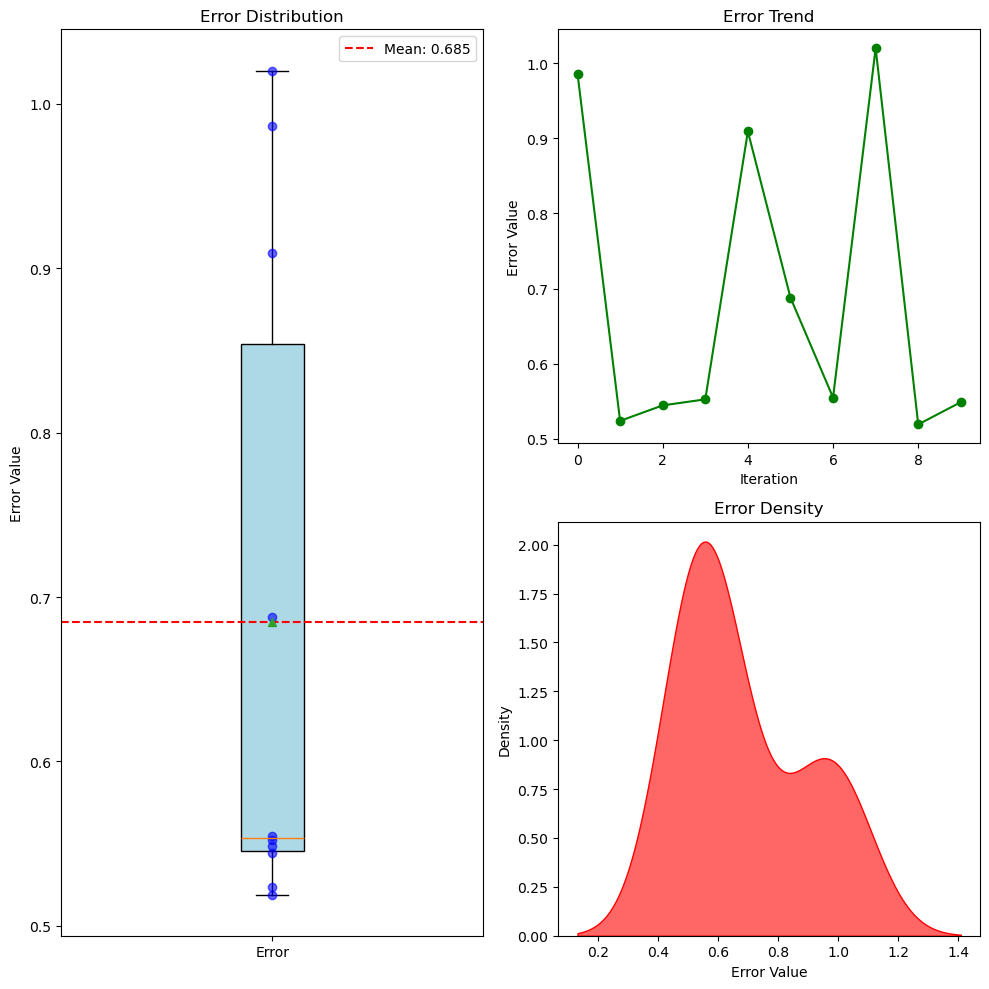

In [9]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns  # 导入seaborn库用于绘制密度图

# error = [0.5947221810612215, 0.7854634881268653, 1.0077722585678006, 0.5954742844285305, 0.4649590589316285, 0.41386083036181925, 0.6378457066743762, 0.6927021776896086, 0.44767318125257183, 0.28146649498710496, 0.8736713565859818, 0.8516792798779166, 0.37395951530223476, 0.8027823282496178, 0.804560887597274, 0.5182202889333846, 0.18454925778730633, 0.20862581035873265, 0.3739223144578929, 0.528249522241707]

plt.figure(figsize=(10, 10))  # 调整整体图表尺寸

# 左侧子图：箱形图，占据两张图的位置，箱的上下边界为上下四分位数，箱内的横线+三角点为中位数，虚线为均值
plt.subplot(1, 2, 1)  # 第一个子图，现在布局为1行2列
mean_error = np.mean(error)
plt.boxplot(error, patch_artist=True, showmeans=True, meanline=False, boxprops=dict(facecolor='lightblue')) #绘制箱型图，其中error是需要绘制的数据，patch_artist=True表示填充箱体，showmeans=True表示显示均值，meanline=True表示显示均值线，boxprops=dict(facecolor='lightblue')表示箱体的颜色为浅蓝色
plt.axhline(mean_error, color='r', linestyle='--', label=f'Mean: {mean_error:.3f}') #绘制一条水平线，位于mean_error处，颜色为红色，线型为虚线，标签为均值
for i, value in enumerate(error): #遍历error数组，i为索引，value为值
    plt.plot(1, value, 'bo', alpha=0.6) #绘制散点图，横坐标为1，纵坐标为value（即error数组中每个数），颜色为蓝色，点形状为圆圈，透明度为0.6
plt.title('Error Distribution')
plt.ylabel('Error Value')
plt.xticks([1], ['Error']) #设置x轴刻度标签
plt.legend() #显示图例

# 右侧上方子图：折线图
plt.subplot(2, 2, 2)  # 第二个子图，现在布局为2行2列的第二个位置
plt.plot(error, '-o', color='green') #绘制折线图，横坐标为error数组的索引，纵坐标为error数组的值，颜色为绿色，点形状为圆圈
plt.title('Error Trend')
plt.ylabel('Error Value')
plt.xlabel('Iteration')

# 右侧下方子图：密度图
plt.subplot(2, 2, 4)  # 第四个子图，现在布局为2行2列的第四个位置
sns.kdeplot(error, shade=True, color="r", alpha=0.6)
plt.title('Error Density')
plt.xlabel('Error Value')
plt.ylabel('Density')

plt.tight_layout()  # 自动调整子图参数，使之填充整个图表区域
plt.show()

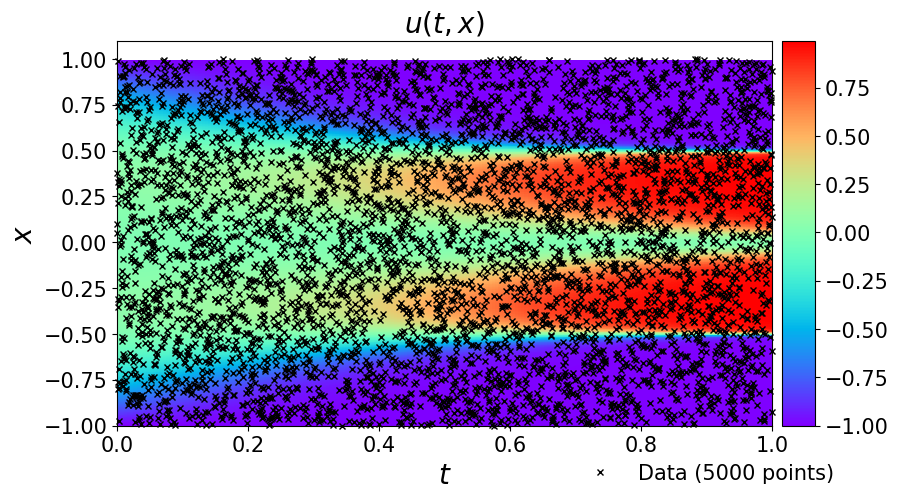

In [10]:
data = scipy.io.loadmat('../data/AC.mat')
#从data字典中取出变量tt和x的值，并转换为一维数组（flatten方法），最后tongg[:,None]将一维数组转换为二维数组
t = data['tt'].flatten()[:,None]
x = data['x'].flatten()[:,None]
Exact = np.real(data['uu']).T #从data数据中取出usol的值，并取实部，最后转置，赋值给Exact
#生成一个二位网络，X和T是输出的二维数组
#这个点结果是X和T均为形状为[len(t),len(x)]的二维数组，X的每一行都是x，一共len(t)行，T的每一列都是t，一共len(x)列
X, T = np.meshgrid(x,t)

X_star = np.hstack((X.flatten()[:,None], T.flatten()[:,None]))  #按列堆叠数组，X_star是一个二维数组，其中第一列是X的展平，第二列是T的展平
u_star = Exact.flatten()[:,None]   #对Exact_u使用flatten方法将其转换为一维数组，最后使用[:,None]将其转换为二维数组     
# X, T = np.meshgrid(x,t)

# X_star = np.hstack((X.flatten()[:,None], T.flatten()[:,None]))  #按列堆叠数组，X_star是一个二维数组，其中第一列是X的展平，第二列是T的展平
u_pred = model.predict(X_star)    #对Exact_u使用flatten方法将其转换为一维数组，最后使用[:,None]将其转换为二维数组   


#使用griddata函数将X_star、u_pred插值到网格上，得到U_pred
U_pred = griddata(X_star, u_pred.flatten(), (X, T), method='cubic')
U_star = griddata(X_star, u_star.flatten(), (X, T), method='cubic')

###### Row 0: u(t,x) ##################    

fig = plt.figure(figsize=(9, 5)) #这里figure是一个figure对象，是一个图形窗口，代表整个图形，设置图形大小为宽9英寸高5 英寸
ax = fig.add_subplot(111) #在图形的1*1网格的第一个位置添加一个子图

#绘图的数据来源
h = ax.imshow(U_star.T, interpolation='nearest', cmap='rainbow', 
              extent=[t.min(), t.max(), x.min(), x.max()], 
              origin='lower', aspect='auto')   #imshow函数用于显示图像，接受一些参数，第一个参数是图像数据，这里是U_pred的转置；第二个参数是插值方法（用于在像素之间插入新的像素），这里是最邻近插值；
                                                   #第三个参数是颜色映射，这里是用彩虹色图；第四个参数是图像的范围；第五个参数是图像的原点位置，这里表示原点在右下角；第六个参数是图像的纵横比，这里表示调整横纵比以填充整个axes对象
                                                   #最后的结果返回一个axesimage对象，也就是h，可以通过这个对象进一步设置图像的属性


#添加颜色条
divider = make_axes_locatable(ax)  #使用 make_axes_locatable 函数创建了一个 AxesDivider 对象。这个函数接受一个 Axes 对象作为参数，返回一个 AxesDivider 对象。AxesDivider 对象可以用来管理子图的布局，特别是当你需要在一个图的旁边添加另一个图时。
cax = divider.append_axes("right", size="5%", pad=0.10) #使用append_axes方法在原始轴的右侧添加了一个新的轴。append_axes 方法接受三个参数：位置（"right"）、大小（"5%"）和间距（0.10）。在原始轴的右侧添加了一个新的轴，新轴的大小是原始轴的 5%，新轴与原始轴之间的间距是 0.05 英寸
   
cbar = fig.colorbar(h, cax=cax)#使用colorbar方法在新轴上添加了一个颜色条。colorbar 方法接受两个参数：axesimage 对象（h）和新轴（cax）。并记这个颜色条的名字是cbar
cbar.ax.tick_params(labelsize=15) #设置颜色条刻度标签大小，这里bar是之前定义的


#在图上绘制散点图
ax.plot(
    X_f[:,1], 
    X_f[:,0], 
    'kx', label = 'Data (%d points)' % (X_f.shape[0]), 
    markersize = 4,  # marker size doubled
    clip_on = False,
    alpha=1.0
) #在ax上绘制散点图，前两个参数是散点的x坐标和y坐标；kx表示黑色的x（散点形状是x），label是散点的标签，clip_on表示散点可以绘制在轴的边界外
  #新加了一个alpha=1.0用来设置标记的透明度，1.0表示完全不透明  




#设置图的标签、图例、标题和刻度标签
#设置ax子图的x轴的标签为t，y轴的标签为x。这里$t$和$x$是latex格式的文本，用于生成数学公式
ax.set_xlabel('$t$', size=20)
ax.set_ylabel('$x$', size=20)
#设置子图ax的图例，第一个参数用来设置图例的位置，这里表示图例放在上方中央;第二个参数用来设置图例的锚点，接受一个元组，表示x和y坐标，表示把图例的锚点设置在x坐标为0.9，y坐标为-0.05处;frameon=False表示不显示图例的边框;第三个参数设置图例的列数，分为5列；最后一个参数设置图例属性，接受字典，这里表示设置图例字体大小为15；最后返回的leg是一个legend对象，表示图形的图例
ax.legend(
    loc='upper center', 
    bbox_to_anchor=(0.9, -0.05), 
    ncol=5, 
    frameon=False, 
    prop={'size': 15}
)
#设置子图ax的标题为$u(t,x)$，表示latex格式的文本，用于生成数学公式，fontsize=10表示字体大小为20
ax.set_title('$u(t,x)$', fontsize = 20) # font size doubled，两倍化子图标题
ax.tick_params(labelsize=15)#用来设置刻度标签的大小。`tick_params`是`Axes`对象的一个方法，可以用来设置刻度线的属性。在这里，`labelsize=15` 是用来设置刻度标签的字体大小的。


#显示图片
plt.show() #显示所有打开的图形的函数

In [11]:
trainloss = torch.stack(model.loss_value).cpu().detach().numpy()


17972


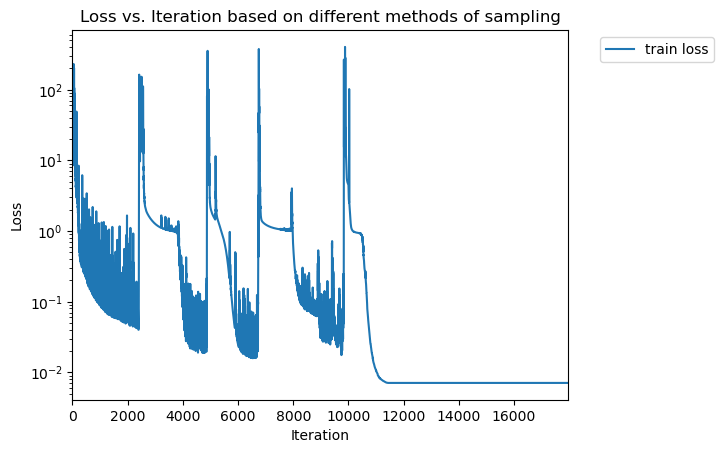

In [12]:
print(len(trainloss))
# print(trainloss)
# 定义图例的标签
labels = ["Grid"]

# 创建一个新的图形
plt.figure()

# # 遍历所有的loss数据和标签
# for loss, label in zip(trainloss, labels):
#     # 绘制每个loss数据，并使用标签作为图例的条目
#     plt.plot(loss, label=label)

plt.plot(trainloss, label='train loss')

# 添加图例，放在图像外
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')


plt.xlim([0,len(trainloss)]) # 设置x轴的范围
plt.yscale('log') #设置y轴为对数尺度，这样即使列表中有一些非常大的值，也不会影响其他值的可视化
plt.xlabel('Iteration') # 设置x轴的标签
plt.ylabel('Loss') # 设置y轴的标签
plt.title('Loss vs. Iteration based on different methods of sampling') # 设置图形的标题
# 显示图形
plt.show()
plt.show()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


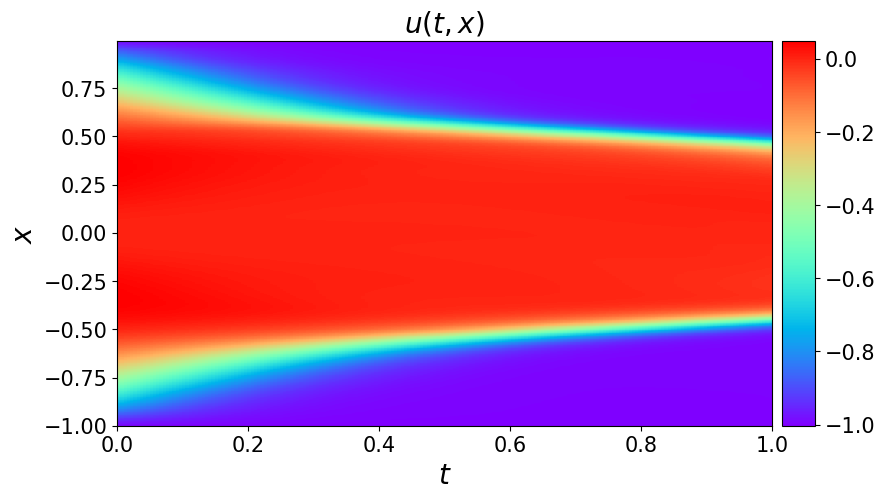

In [13]:
# data = scipy.io.loadmat('../../data/burgers_shock.mat')
# #从data字典中取出变量tt和x的值，并转换为一维数组（flatten方法），最后tongg[:,None]将一维数组转换为二维数组
# t = data['t'].flatten()[:,None]
# x = data['x'].flatten()[:,None]
# Exact = np.real(data['usol']).T #从data数据中取出usol的值，并取实部，最后转置，赋值给Exact
# #生成一个二位网络，X和T是输出的二维数组
# #这个点结果是X和T均为形状为[len(t),len(x)]的二维数组，X的每一行都是x，一共len(t)行，T的每一列都是t，一共len(x)列
# X, T = np.meshgrid(x,t)

# X_star = np.hstack((X.flatten()[:,None], T.flatten()[:,None]))  #按列堆叠数组，X_star是一个二维数组，其中第一列是X的展平，第二列是T的展平
u_pred = model.predict(X_star)    #对Exact_u使用flatten方法将其转换为一维数组，最后使用[:,None]将其转换为二维数组   


#使用griddata函数将X_star、u_pred插值到网格上，得到U_pred
U_pred = griddata(X_star, u_pred.flatten(), (X, T), method='cubic')


###### Row 0: u(t,x) ##################    

fig = plt.figure(figsize=(9, 5)) #这里figure是一个figure对象，是一个图形窗口，代表整个图形，设置图形大小为宽9英寸高5 英寸
ax = fig.add_subplot(111) #在图形的1*1网格的第一个位置添加一个子图

#绘图的数据来源
h = ax.imshow(U_pred.T, interpolation='nearest', cmap='rainbow', 
              extent=[t.min(), t.max(), x.min(), x.max()], 
              origin='lower', aspect='auto')   #imshow函数用于显示图像，接受一些参数，第一个参数是图像数据，这里是U_pred的转置；第二个参数是插值方法（用于在像素之间插入新的像素），这里是最邻近插值；
                                                   #第三个参数是颜色映射，这里是用彩虹色图；第四个参数是图像的范围；第五个参数是图像的原点位置，这里表示原点在右下角；第六个参数是图像的纵横比，这里表示调整横纵比以填充整个axes对象
                                                   #最后的结果返回一个axesimage对象，也就是h，可以通过这个对象进一步设置图像的属性


#添加颜色条
divider = make_axes_locatable(ax)  #使用 make_axes_locatable 函数创建了一个 AxesDivider 对象。这个函数接受一个 Axes 对象作为参数，返回一个 AxesDivider 对象。AxesDivider 对象可以用来管理子图的布局，特别是当你需要在一个图的旁边添加另一个图时。
cax = divider.append_axes("right", size="5%", pad=0.10) #使用append_axes方法在原始轴的右侧添加了一个新的轴。append_axes 方法接受三个参数：位置（"right"）、大小（"5%"）和间距（0.10）。在原始轴的右侧添加了一个新的轴，新轴的大小是原始轴的 5%，新轴与原始轴之间的间距是 0.05 英寸
   
cbar = fig.colorbar(h, cax=cax)#使用colorbar方法在新轴上添加了一个颜色条。colorbar 方法接受两个参数：axesimage 对象（h）和新轴（cax）。并记这个颜色条的名字是cbar
cbar.ax.tick_params(labelsize=15) #设置颜色条刻度标签大小，这里bar是之前定义的


# #在图上绘制散点图
# ax.plot(
#     X_f_train[:,1], 
#     X_f_train[:,0], 
#     'kx', label = 'Data (%d points)' % (X_f_train.shape[0]), 
#     markersize = 4,  # marker size doubled
#     clip_on = False,
#     alpha=1.0
# ) #在ax上绘制散点图，前两个参数是散点的x坐标和y坐标；kx表示黑色的x（散点形状是x），label是散点的标签，clip_on表示散点可以绘制在轴的边界外
#   #新加了一个alpha=1.0用来设置标记的透明度，1.0表示完全不透明  




#设置图的标签、图例、标题和刻度标签
#设置ax子图的x轴的标签为t，y轴的标签为x。这里$t$和$x$是latex格式的文本，用于生成数学公式
ax.set_xlabel('$t$', size=20)
ax.set_ylabel('$x$', size=20)
#设置子图ax的图例，第一个参数用来设置图例的位置，这里表示图例放在上方中央;第二个参数用来设置图例的锚点，接受一个元组，表示x和y坐标，表示把图例的锚点设置在x坐标为0.9，y坐标为-0.05处;frameon=False表示不显示图例的边框;第三个参数设置图例的列数，分为5列；最后一个参数设置图例属性，接受字典，这里表示设置图例字体大小为15；最后返回的leg是一个legend对象，表示图形的图例
ax.legend(
    loc='upper center', 
    bbox_to_anchor=(0.9, -0.05), 
    ncol=5, 
    frameon=False, 
    prop={'size': 15}
)
#设置子图ax的标题为$u(t,x)$，表示latex格式的文本，用于生成数学公式，fontsize=10表示字体大小为20
ax.set_title('$u(t,x)$', fontsize = 20) # font size doubled，两倍化子图标题
ax.tick_params(labelsize=15)#用来设置刻度标签的大小。`tick_params`是`Axes`对象的一个方法，可以用来设置刻度线的属性。在这里，`labelsize=15` 是用来设置刻度标签的字体大小的。


#显示图片
plt.show() #显示所有打开的图形的函数

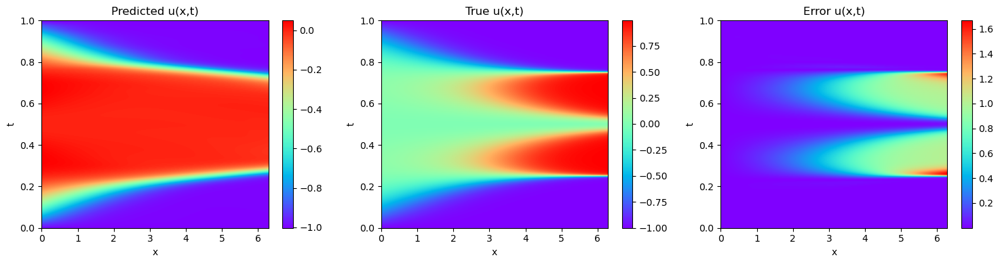

In [14]:

# 创建一个包含三幅子图的图像
fig, axes = plt.subplots(1, 3, figsize=(15, 4))

# 绘制第一幅图像
axes[0].imshow(U_pred.T, extent=[0, np.pi*2, 1, 0], aspect='auto', cmap='rainbow')
axes[0].invert_yaxis()
axes[0].set_xlabel('x')
axes[0].set_ylabel('t')
axes[0].set_title('Predicted u(x,t)')
fig.colorbar(axes[0].images[0], ax=axes[0])

# 绘制第二幅图像
axes[1].imshow(U_star.T, extent=[0,np.pi*2,1,0], aspect='auto', cmap='rainbow') #第一个参数为数据，第二个参数为一个列表，用于设置图像的坐标范围，aspect='auto'表示纵横比自动调整
axes[1].invert_yaxis()
axes[1].set_xlabel('x')
axes[1].set_ylabel('t')
axes[1].set_title('True u(x,t)')
fig.colorbar(axes[1].images[0], ax=axes[1])

# 绘制第三幅图像
axes[2].imshow(np.abs(U_pred - U_star).T, extent=[0,np.pi*2,1,0], aspect='auto', cmap='rainbow') #第一个参数为数据，第二个参数为一个列表，用于设置图像的坐标范围，aspect='auto'表示纵横比自动调整
axes[2].invert_yaxis()
axes[2].set_xlabel('x')
axes[2].set_ylabel('t')
axes[2].set_title('Error u(x,t)')
fig.colorbar(axes[2].images[0], ax=axes[2])

# 自动调整子图参数，使得子图之间的间距适当
plt.tight_layout()
plt.show()

In [15]:
#计算训练好模型的chaos（最后一个seed）
u_chaos = calculate_chaos(model, X_star, num_iter=50)
u_chaos_log = np.log(u_chaos + 1e-10) #对u_var取对数，然后加上一个很小的数，避免取对数时出现错误

#使用griddata函数将X_star、u_pred插值到网格上，得到U_pred
U_chaos = griddata(X_star, u_chaos.flatten(), (X, T), method='cubic')
U_chaos_log = griddata(X_star, u_chaos_log.flatten(), (X, T), method='cubic')

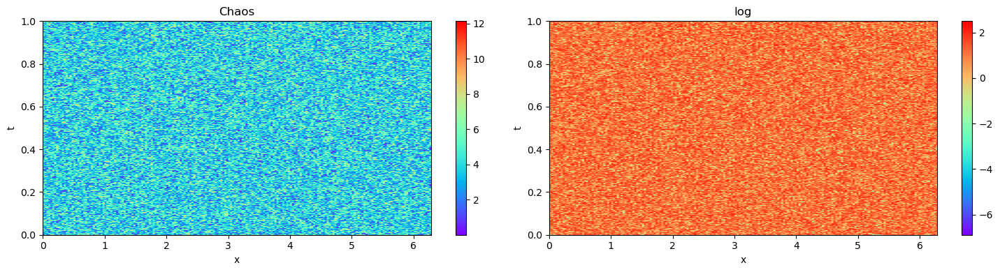

In [16]:

# 创建一个包含三幅子图的图像
fig, axes = plt.subplots(1, 2, figsize=(15, 4))

# 绘制第一幅图像
axes[0].imshow(U_chaos.T, extent=[0, np.pi*2, 1, 0], aspect='auto', cmap='rainbow')
axes[0].invert_yaxis()
axes[0].set_xlabel('x')
axes[0].set_ylabel('t')
axes[0].set_title('Chaos')
fig.colorbar(axes[0].images[0], ax=axes[0])

# 绘制第二幅图像
axes[1].imshow(U_chaos_log.T, extent=[0,np.pi*2,1,0], aspect='auto', cmap='rainbow') #第一个参数为数据，第二个参数为一个列表，用于设置图像的坐标范围，aspect='auto'表示纵横比自动调整
axes[1].invert_yaxis()
axes[1].set_xlabel('x')
axes[1].set_ylabel('t')
axes[1].set_title('log')
fig.colorbar(axes[1].images[0], ax=axes[1])

# 自动调整子图参数，使得子图之间的间距适当
plt.tight_layout()
plt.show()